In [1]:
import pandas as pd
import numpy as np
import pycountry
import re
import ast
import matplotlib.pyplot as plt
from tqdm import tqdm
tqdm.pandas()
from datetime import datetime
from gensim.test.utils import get_tmpfile
from gensim.models.doc2vec import Doc2Vec, TaggedDocument
import nltk
import country_converter as coco
nltk.download('wordnet')
from sklearn.feature_extraction.text import TfidfVectorizer


[nltk_data] Downloading package wordnet to
[nltk_data]     /home/jahandelestangjim/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


## Clean and prepare the data

In [2]:
data=pd.read_csv('un_general_debates_extended.csv')
data

,Unnamed: 0,country,text,year,country_name_short
0,0,CHL,I shall occupy this rostrum for a few minutes ...,1946,Chile
1,1,COL,The Colombian delegation does not consider it ...,1946,Colombia
2,2,BLR,As more than a year has elapsed since the Unit...,1946,Belarus
3,3,IND,I stand before this great Assembly — unique in...,1946,India
4,4,GBR,"In his great pronouncement here the other day,...",1946,United Kingdom
...,...,...,...,...,...
10551,10563,GAB,"It is my pleasant duty to offer you, Mr. Presi...",1963,Gabon
10552,10564,TCD,"It Is not without a certain pride, mixed with ...",1963,Chad
10553,10565,COL,"Colombia, and the delegation which represents ...",1963,Colombia
10554,10566,TUN,"Mr. President, it is a pleasure for me first o...",1963,Tunisia


In [87]:
# we add a column for the country 
cc = coco.CountryConverter()

# we get rid of EU because it isnt a countr
data = data[data['country'] != 'EU']

country_raw = data['country']

# list of conversion former country => new country
former_country_new={'YDYE':'YEM', 'CSK':'CZE', 'YUG':'SRB', 'DDR':'DE'}
some_names = country_raw.map(former_country_new).fillna(country_raw)
country_name_short = cc.convert(names = some_names, to = 'name_short')

data.loc[:,'country_name_short']=country_name_short
data

/tmp/ipykernel_8544/43217091.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.loc[:,'country_name_short']=country_name_short


,session,year,country,text,country_name_short
0,44,1989,MDV,﻿It is indeed a pleasure for me and the member...,Maldives
1,44,1989,FIN,"﻿\nMay I begin by congratulating you. Sir, on ...",Finland
2,44,1989,NER,"﻿\nMr. President, it is a particular pleasure ...",Niger
3,44,1989,URY,﻿\nDuring the debate at the fortieth session o...,Uruguay
4,44,1989,ZWE,﻿I should like at the outset to express my del...,Zimbabwe
...,...,...,...,...,...
7502,56,2001,KAZ,﻿This session\nthat is taking place under extr...,Kazakhstan
7503,56,2001,LBR,﻿I am honoured to\nparticipate in this histori...,Liberia
7504,56,2001,BDI,﻿It\nis for me a signal honour to take the flo...,Burundi
7505,56,2001,HUN,"﻿First, may I congratulate Mr. Han Seung-soo o...",Hungary


In [88]:
message_11_region = cc.convert(names = country_name_short, to = 'MESSAGE')

data.loc[:,'11_region']=message_11_region

/tmp/ipykernel_8544/1730380124.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.loc[:,'11_region']=message_11_region


In [89]:
un_region_names = cc.convert(names = country_name_short, to = 'UNregion')

data.loc[:,'UN_region']=un_region_names
data

/tmp/ipykernel_8544/573971911.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.loc[:,'UN_region']=un_region_names


,session,year,country,text,country_name_short,11_region,UN_region
0,44,1989,MDV,﻿It is indeed a pleasure for me and the member...,Maldives,SAS,Southern Asia
1,44,1989,FIN,"﻿\nMay I begin by congratulating you. Sir, on ...",Finland,WEU,Northern Europe
2,44,1989,NER,"﻿\nMr. President, it is a particular pleasure ...",Niger,AFR,Western Africa
3,44,1989,URY,﻿\nDuring the debate at the fortieth session o...,Uruguay,LAC,South America
4,44,1989,ZWE,﻿I should like at the outset to express my del...,Zimbabwe,AFR,Eastern Africa
...,...,...,...,...,...,...,...
7502,56,2001,KAZ,﻿This session\nthat is taking place under extr...,Kazakhstan,FSU,Central Asia
7503,56,2001,LBR,﻿I am honoured to\nparticipate in this histori...,Liberia,AFR,Western Africa
7504,56,2001,BDI,﻿It\nis for me a signal honour to take the flo...,Burundi,AFR,Eastern Africa
7505,56,2001,HUN,"﻿First, may I congratulate Mr. Han Seung-soo o...",Hungary,EEU,Eastern Europe


In [90]:
# convert text data to lower case (for easier analysis)
data.loc[:,'text'] = data['text'].str.lower()
# Remove unusual symbols from description
def clean(s):    
    # Remove any tags:
    cleaned = re.sub(r"(?s)<.?>", " ", s)
    # Keep only regular chars:
    cleaned = re.sub(r"[^A-Za-z0-9(),*!?\'\`]", " ", cleaned)
    # Remove unicode chars
    cleaned = re.sub("\\\\u(.){4}", " ", cleaned)
    # Remove things between brackets
    cleaned = re.sub("\[.*?\]", " ", cleaned)

    return cleaned.strip()

# clean text
data.loc[:,'text'] = data.text.apply(lambda x: clean(x))

In [91]:
# remove data with null value in year column
data = data[data['year'].notnull()]

# drop session column -- provides no information
data = data.drop(['session'], axis=1)

In [92]:
data

,year,country,text,country_name_short,11_region,UN_region
0,1989,MDV,it is indeed a pleasure for me and the members...,Maldives,SAS,Southern Asia
1,1989,FIN,"may i begin by congratulating you sir, on you...",Finland,WEU,Northern Europe
2,1989,NER,"mr president, it is a particular pleasure for...",Niger,AFR,Western Africa
3,1989,URY,during the debate at the fortieth session of t...,Uruguay,LAC,South America
4,1989,ZWE,i should like at the outset to express my dele...,Zimbabwe,AFR,Eastern Africa
...,...,...,...,...,...,...
7502,2001,KAZ,this session that is taking place under extrao...,Kazakhstan,FSU,Central Asia
7503,2001,LBR,i am honoured to participate in this historic ...,Liberia,AFR,Western Africa
7504,2001,BDI,it is for me a signal honour to take the floor...,Burundi,AFR,Eastern Africa
7505,2001,HUN,"first, may i congratulate mr han seung soo on...",Hungary,EEU,Eastern Europe


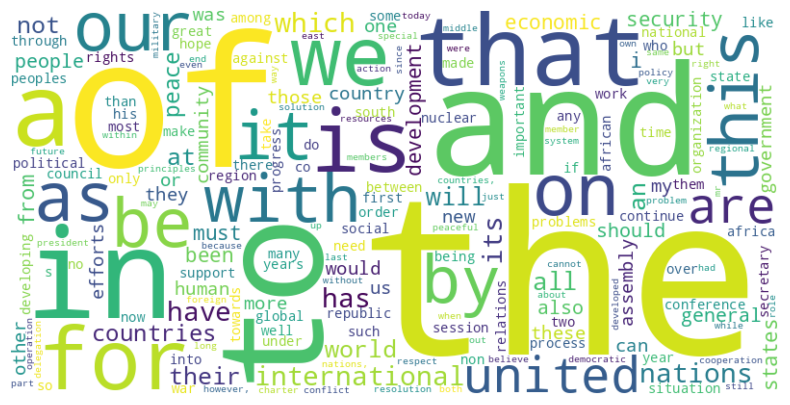

In [93]:
import pandas as pd
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Combine all the text from the 'text' column into a single string
text_combined = ' '.join(data['text'])

# Generate word frequencies
word_freq = pd.Series(text_combined.split()).value_counts()

# Generate word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq)

# Display the word cloud
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()


In [94]:
from nltk.tokenize import ToktokTokenizer
import string
from sklearn.feature_extraction import text
from functools import reduce
import pandas as pd
import unicodedata
import sys

#====================================================================================#
#
# Description:
# A script to preprocess political texts, with procedural stop word removal.
# For more information, see www.github.com/lrheault/partyembed
#
# Usage:
# python3 preprocess.py [USA/Canada/UK]
#
# @author: L. Rheault
#
#====================================================================================#


tk = ToktokTokenizer()
# For replacement of contractions.
contractions = {"you'd": 'you would', "he'd": 'he would', "she's": 'she is', "where'd": 'where did', "might've": 'might have', "he'll": 'he will', "they'll": 'they will',  "mightn't": 'might not', "you'd've": 'you would have', "shan't": 'shall not', "it'll": 'it will', "mayn't": 'may not', "couldn't": 'could not', "they'd": 'they would', "so've": 'so have', "needn't've": 'need not have', "they'll've": 'they will have', "it's": 'it is', "haven't": 'have not', "didn't": 'did not', "y'all'd": 'you all would', "needn't": 'need not', "who'll": 'who will', "wouldn't've": 'would not have', "when's": 'when is', "will've": 'will have', "it'd've": 'it would have', "what'll": 'what will', "that'd've": 'that would have', "y'all're": 'you all are', "let's": 'let us', "where've": 'where have', "o'clock": 'oclock', "when've": 'when have', "what're": 'what are', "should've": 'should have', "you've": 'you have', "they're": 'they are', "aren't": 'are not', "they've": 'they have', "it'd": 'it would', "i'll've": 'i will have', "they'd've": 'they would have', "you'll've": 'you will have', "wouldn't": 'would not', "we'd": 'we would', "hadn't've": 'had not have', "weren't": 'were not', "i'd": 'i would', "must've": 'must have', "what's": 'what is', "mustn't've": 'must not have', "what'll've": 'what will have', "ain't": 'aint', "doesn't": 'does not', "we'll": 'we will', "i'd've": 'i would have', "we've": 'we have', "oughtn't": 'ought not', "you're": 'you are', "who'll've": 'who will have', "shouldn't": 'should not', "can't've": 'cannot have', "i've": 'i have', "couldn't've": 'could not have', "why've": 'why have', "what've": 'what have', "can't": 'cannot', "don't": 'do not', "that'd": 'that would', "who's": 'who is', "would've": 'would have', "there'd": 'there would', "shouldn't've": 'should not have', "y'all": 'you all', "mustn't": 'must not', "she'll": 'she will', "hadn't": 'had not', "won't've": 'will not have', "why's": 'why is', "'cause": 'because', "wasn't": 'was not', "shan't've": 'shall not have', "ma'am": 'madam', "hasn't": 'has not', "to've": 'to have', "how'll": 'how will', "oughtn't've": 'ought not have', "he'll've": 'he will have', "we'd've": 'we would have', "won't": 'will not', "could've": 'could have', "isn't": 'is not', "she'll've": 'she will have', "we'll've": 'we will have', "you'll": 'you will', "who've": 'who have', "there's": 'there is', "y'all've": 'you all have', "we're": 'we are', "i'll": 'i will', "i'm": 'i am', "how's": 'how is', "she'd've": 'she would have', "sha'n't": 'shall not', "there'd've": 'there would have', "he's": 'he is', "it'll've": 'it will have', "that's": 'that is', "y'all'd've": 'you all would have', "he'd've": 'he would have', "how'd": 'how did', "where's": 'where is', "so's": 'so as', "she'd": 'she would', "mightn't've": 'might not have'}


In [95]:
un_stopwords = ['nations','year','believe','important','assembly','secretary',
                'conference', 'like', 'way', 'state', 'resolution', 
                'government', 'make', 'role', 
                'united nation', 'united nations', 'general assembly', 'republic of', 'secretary general', 'the world', 
                'ibid', 'security council', 'member state', 'country', 'must', 'many'] + list(text.ENGLISH_STOP_WORDS)

def tokenize_text(text, stopwords=un_stopwords):
    text = reduce(lambda a, kv: a.replace(*kv), contractions.items(), text.lower())
    text = text.translate(str.maketrans(string.punctuation, ' '*len(string.punctuation)))
    tokens = tk.tokenize(text)
    
    tokens = [token for token in tokens if len(token) > 3 and
             token not in stopwords and not token.isdigit()]
    
    #remove inflectional endings and get the root word (lemma):
    lemmatizer = nltk.stem.WordNetLemmatizer()
    lemmas = [lemmatizer.lemmatize(token) for token in tokens]
    
    return lemmas

data['clean_text'] = data['text'].apply(tokenize_text)


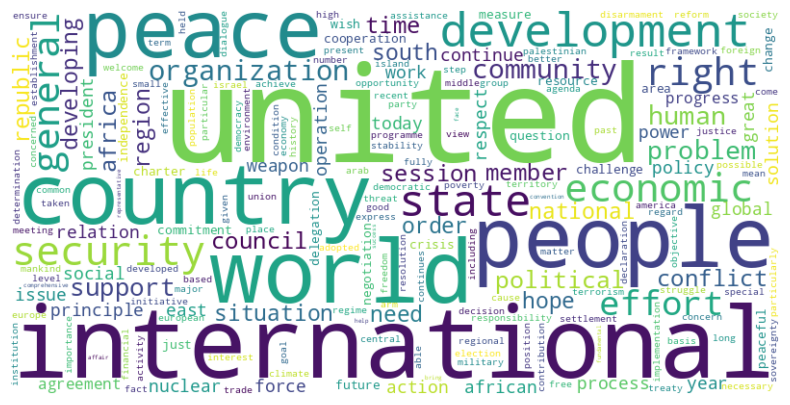

In [96]:
# Combine all the text from the 'text' column into a single string
text_combined = ' '.join(data['clean_text'].apply(lambda x: ' '.join(x)))

# Generate word frequencies
word_freq = pd.Series(text_combined.split()).value_counts()

# Generate word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_freq)

# Display the word cloud
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In [97]:
def create_tag(row):
    country= row["country_name_short"]
    return country + "_" + str(row["year"])

data["tag"] = data.apply(lambda row: create_tag(row), axis=1)
data

,year,country,text,country_name_short,11_region,UN_region,clean_text,tag
0,1989,MDV,it is indeed a pleasure for me and the members...,Maldives,SAS,Southern Asia,"[pleasure, member, delegation, extend, ambassa...",Maldives_1989
1,1989,FIN,"may i begin by congratulating you sir, on you...",Finland,WEU,Northern Europe,"[begin, congratulating, election, presidency, ...",Finland_1989
2,1989,NER,"mr president, it is a particular pleasure for...",Niger,AFR,Western Africa,"[president, particular, pleasure, behalf, dele...",Niger_1989
3,1989,URY,during the debate at the fortieth session of t...,Uruguay,LAC,South America,"[debate, fortieth, session, general, year, pre...",Uruguay_1989
4,1989,ZWE,i should like at the outset to express my dele...,Zimbabwe,AFR,Eastern Africa,"[outset, express, delegation, satisfaction, pl...",Zimbabwe_1989
...,...,...,...,...,...,...,...,...
7502,2001,KAZ,this session that is taking place under extrao...,Kazakhstan,FSU,Central Asia,"[session, taking, place, extraordinary, circum...",Kazakhstan_2001
7503,2001,LBR,i am honoured to participate in this historic ...,Liberia,AFR,Western Africa,"[honoured, participate, historic, session, beh...",Liberia_2001
7504,2001,BDI,it is for me a signal honour to take the floor...,Burundi,AFR,Eastern Africa,"[signal, honour, floor, today, sixth, session,...",Burundi_2001
7505,2001,HUN,"first, may i congratulate mr han seung soo on...",Hungary,EEU,Eastern Europe,"[congratulate, seung, election, preside, sixth...",Hungary_2001


In [98]:
from collections import Counter

# Count the occurrences of each word in the entire corpus
word_counts = Counter(word for text_list in data['clean_text'] for word in text_list)

# Filter out words that appear less than three times
words_to_keep = {word for word, count in word_counts.items() if count >= 3}

# Remove the filtered words from the DataFrame
def filter_words(text_list):
    return [word for word in text_list if word in words_to_keep]

# Apply the filter_words function to each row of the 'text' column
data['clean_text'] = data['clean_text'].apply(filter_words)


In [99]:
documents = [TaggedDocument(data['clean_text'].iloc[k], [data['tag'].iloc[k]]) for k in tqdm(range(len(data)))]

model = Doc2Vec(documents, workers=7, vector_size=200, min_count=10, window=10, epochs=5)
fname = f"doc2vec_mep"
model.save(fname)
model = Doc2Vec.load(fname)

100%|██████████| 7502/7502 [00:00<00:00, 36164.36it/s]


In [100]:
data_embed = data[['tag']].drop_duplicates()
data_embed[f'text_embedding'] = data_embed['tag'].progress_apply(lambda x: model.dv[x])
data_embed['year']=data['year']
data_embed['text']=data['clean_text']
data_embed['UN_region']=data['UN_region']
data_embed.to_csv(f'df_text_embedding.csv')

  0%|          | 0/7465 [00:00<?, ?it/s]

100%|██████████| 7465/7465 [00:00<00:00, 468376.18it/s]


In [101]:
data_embed=pd.read_csv('df_text_embedding.csv', index_col=0)
def add_comas(row):
    string_representation=row['text_embedding']
    string_without_whitespace = '['+string_representation[2:]
    string_with_commas = ', '.join(string_without_whitespace.split())
    return string_with_commas 

data_embed['text_embedding']= data_embed.apply(lambda row: add_comas(row), axis=1)
data_embed['text_embedding'] = data_embed['text_embedding'].apply(ast.literal_eval)
data_embed

,tag,text_embedding,year,text,UN_region
0,Maldives_1989,"[0.47927678, -0.50748795, -0.27521637, -0.2026...",1989,"['pleasure', 'member', 'delegation', 'extend',...",Southern Asia
1,Finland_1989,"[1.1209096, -0.06038693, 0.1719272, -0.1037749...",1989,"['begin', 'congratulating', 'election', 'presi...",Northern Europe
2,Niger_1989,"[0.8941671, 0.13401167, -0.34160098, -0.339742...",1989,"['president', 'particular', 'pleasure', 'behal...",Western Africa
3,Uruguay_1989,"[0.813237429, -0.400559783, -0.330161035, -0.3...",1989,"['debate', 'fortieth', 'session', 'general', '...",South America
4,Zimbabwe_1989,"[0.301227003, -0.411437571, 0.22837615, 0.5164...",1989,"['outset', 'express', 'delegation', 'satisfact...",Eastern Africa
...,...,...,...,...,...
7502,Kazakhstan_2001,"[0.39869782, 0.38871962, -0.04882684, -0.08814...",2001,"['session', 'taking', 'place', 'extraordinary'...",Central Asia
7503,Liberia_2001,"[0.2316769, -0.26790288, -0.2971576, 0.5453798...",2001,"['honoured', 'participate', 'historic', 'sessi...",Western Africa
7504,Burundi_2001,"[0.80396831, -0.289121121, -0.62819618, -0.164...",2001,"['signal', 'honour', 'floor', 'today', 'sixth'...",Eastern Africa
7505,Hungary_2001,"[0.514971554, 0.236525267, -0.634872198, -0.35...",2001,"['congratulate', 'seung', 'election', 'preside...",Eastern Europe


In [102]:
REGION_COL = {
    'Australia and New Zealand': 'blue',
    'Caribbean': 'green',
    'Central America': 'red',
    'Central Asia': 'orange',
    'Eastern Africa': 'purple',
    'Eastern Asia': 'cyan',
    'Eastern Europe': 'magenta',
    'Melanesia': 'yellow',
    'Micronesia': 'lime',
    'Middle Africa': 'pink',
    'Northern Africa': 'brown',
    'Northern America': 'teal',
    'Northern Europe': 'olive',
    'Polynesia': 'navy',
    'South America': 'maroon',
    'South-eastern Asia': 'indigo',
    'Southern Africa': 'gold',
    'Southern Asia': 'tan',
    'Southern Europe': 'skyblue',
    'Western Africa': 'violet',
    'Western Asia': 'crimson',
    'Western Europe': 'salmon'
}


## Unguided analysis (PCA)

Eastern Europe
South-eastern Asia
South America
Middle Africa
Central America
Southern Asia
Western Europe
Western Africa
Northern Africa
Southern Europe
Southern Africa
Australia and New Zealand
Eastern Africa
Central Asia
Micronesia
Caribbean
Northern Europe
Melanesia
Western Asia
Eastern Asia
Polynesia
Northern America


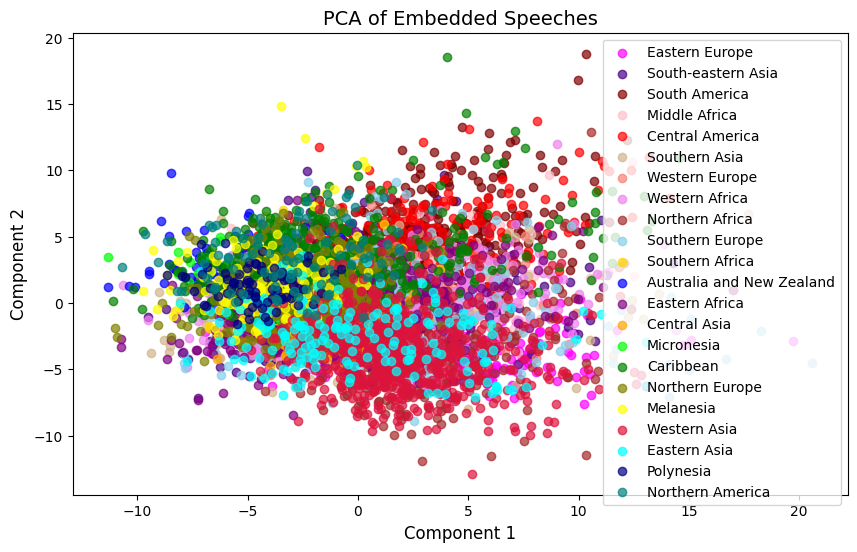

In [103]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()


# Définir la taille du graphique
fig, ax = plt.subplots(figsize=(10, 6))

# Function to perform PCA
def perform_pca(df):
    # Convert the embeddings to a numpy array
    X = np.array(df['text_embedding'].tolist())
    
    # Standardize the data
    X_scaled = scaler.fit_transform(X)
    
    # Perform PCA
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X_scaled)
    
    return pca, X_pca

# Perform PCA on df_main
pca_main, X_pca_main = perform_pca(data_embed)

def project_pca(df_subset):
    # X should be a numpy array of shape (n_samples, n_features)
    X_subset = np.array(df_subset['text_embedding'].tolist())
    
    # Step 2: Standardize the data
    X_scaled_subset = scaler.transform(X_subset)
    X_pca_subset = pca_main.transform(X_scaled_subset)

    return X_pca_subset

# Parcourir les familles et créer un graphique en nuage de points pour chaque famille
for un_region in set(data_embed['UN_region'].values):
    print(un_region)
    # Filtrer les données pour la famille actuelle
    data = data_embed.loc[data_embed['UN_region']==un_region].reset_index()
    
    # Obtenir les projections 2D pour les embeddings de la region actuelle
    projections_2D = project_pca(data)
    
    # Créer un graphique en nuage de points pour la region actuelle
    ax.scatter(projections_2D[:,0], projections_2D[:,1], alpha=0.7, label=un_region, color=REGION_COL[un_region])
    
    # Ajouter l'année sur chaque point, avec une barre de séparation en cas de chevauchement
    # for i, year in enumerate(data['year']):
    #     # Vérifier s'il y a un chevauchement avec l'année précédente
    #     if i > 0 and data['year'][i-1] == year:
    #         # Ajouter une barre de séparation
    #         ax.plot([projections_2D[i-1,0], projections_2D[i,0]], [projections_2D[i-1,1], projections_2D[i,1]], color=REGION_COL[un_region], linestyle='-', linewidth=0.5)
    #         # Ajouter l'année avec un leger décalage vertical
    #         ax.text(projections_2D[i,0], projections_2D[i,1]+0.8, year, ha='center', va='bottom')
    #     else:
    #         # Ajouter l'année sans barre de séparation
    #         ax.text(projections_2D[i,0], projections_2D[i,1]+0.5, year, ha='center', va='bottom')

ax.set_title('PCA of Embedded Speeches', fontsize=14)

# Définir la taille de la police de caractère pour les étiquettes d'axes
ax.set_xlabel('Component 1', fontsize=12)
ax.set_ylabel('Component 2', fontsize=12)

# Ajouter une légende
ax.legend()
plt.savefig('PCA_R_L_FR.png')
# Afficher le graphique
plt.show()


In [104]:
# Calculate the mean values of component 1 and component 2
mean_component1 = np.mean(X_pca_main[:, 0])
mean_component2 = np.mean(X_pca_main[:, 1])

# Identify the indices of data points in the bottom left quadrant
bottom_left_indices = np.where((X_pca_main[:, 0] < mean_component1) & (X_pca_main[:, 1] < mean_component2))[0]

# Retrieve the corresponding words from df_main based on the indices
words_bottom_left = data_embed.iloc[bottom_left_indices]['text'].tolist()
words_list = [ast.literal_eval(item) for item in words_bottom_left]

flattened_words_bottom_left = [word for sublist in words_list for word in sublist]
words_bottom_left=list(set(flattened_words_bottom_left))

# Sort these words based on their distance from the bottom left in the PCA plot
min_component1 = np.min(X_pca_main[:, 0])
min_component2 = np.min(X_pca_main[:, 1])

bottom_left_point = (min_component1, min_component2)

distances_from_bottom_left = np.sqrt((X_pca_main[:, 0] - bottom_left_point[0])**2 + (X_pca_main[:, 1] - bottom_left_point[1])**2)

# Sort the words based on their distances from the origin
sorted_words_bottom_left = [word for _, word in sorted(zip(distances_from_bottom_left[bottom_left_indices], words_bottom_left))]

In [105]:
# Identify the indices of data points in the top left quadrant
top_left_indices = np.where((X_pca_main[:, 0] < mean_component1) & (X_pca_main[:, 1] > mean_component2))[0]

# Retrieve the corresponding words from df_main based on the indices
words_top_left = data_embed.iloc[top_left_indices]['text'].tolist()
words_list_top_left = [ast.literal_eval(item) for item in words_top_left]

# Flatten the list of lists
flattened_words_top_left = [word for sublist in words_list_top_left for word in sublist]

# Get unique words
words_top_left = list(set(flattened_words_top_left))

# Sort these words based on their distance from the top left in the PCA plot
min_component1 = np.min(X_pca_main[:, 0])
max_component2 = np.min(X_pca_main[:, 1])

top_left_point = (min_component1, max_component2)

distances_from_top_left = np.sqrt((X_pca_main[:, 0] - top_left_point[0])**2 + (X_pca_main[:, 1] - top_left_point[1])**2)

# Sort the words based on their distances from the origin
sorted_words_top_left = [word for _, word in sorted(zip(distances_from_top_left[top_left_indices], words_top_left))]

In [106]:
# Identify the indices of data points in the top right quadrant
top_right_indices = np.where((X_pca_main[:, 0] > mean_component1) & (X_pca_main[:, 1] > mean_component2))[0]

# Retrieve the corresponding words from df_main based on the indices
words_top_right = data_embed.iloc[top_right_indices]['text'].tolist()
words_list_top_right = [ast.literal_eval(item) for item in words_top_right]

# Flatten the list of lists
flattened_words_top_right = [word for sublist in words_list_top_right for word in sublist]

# Get unique words
words_top_right = list(set(flattened_words_top_right))

# Sort these words based on their distance from the top right in the PCA plot
max_component1 = np.max(X_pca_main[:, 0])
max_component2 = np.max(X_pca_main[:, 1])

top_right_point = (max_component1, max_component2)

distances_from_top_right = np.sqrt((X_pca_main[:, 0] - top_right_point[0])**2 + (X_pca_main[:, 1] - top_right_point[1])**2)

# Sort the words based on their distances from the origin
sorted_words_top_right = [word for _, word in sorted(zip(distances_from_top_right[top_right_indices], words_top_right))]

In [107]:
# Identify the indices of data points in the bottom right quadrant
bottom_right_indices = np.where((X_pca_main[:, 0] > mean_component1) & (X_pca_main[:, 1] < mean_component2))[0]

# Retrieve the corresponding words from df_main based on the indices
words_bottom_right = data_embed.iloc[bottom_right_indices]['text'].tolist()
words_list_bottom_right = [ast.literal_eval(item) for item in words_bottom_right]

# Flatten the list of lists
flattened_words_bottom_right = [word for sublist in words_list_bottom_right for word in sublist]

# Get unique words
words_bottom_right = list(set(flattened_words_bottom_right))

# Sort these words based on their distance from the bottom right in the PCA plot
max_component1 = np.max(X_pca_main[:, 0])
min_component2 = np.min(X_pca_main[:, 1])

bottom_right_point = (max_component1, min_component2)

distances_from_bottom_right = np.sqrt((X_pca_main[:, 0] - bottom_right_point[0])**2 + (X_pca_main[:, 1] - bottom_right_point[1])**2)

# Sort the words based on their distances from the origin
sorted_words_bottom_right = [word for _, word in sorted(zip(distances_from_bottom_right[bottom_right_indices], words_bottom_right))]

In [108]:
# now print the words defining the axes
print("Words closest to the bottom left quadrant of PCA plot:", sorted_words_bottom_left[:5])
print("Words closest to the bottom right quadrant of PCA plot:", sorted_words_bottom_right[:5])
print("Words closest to the top right quadrant of PCA plot:", sorted_words_top_right[:5])
print("Words closest to the top left quadrant of PCA plot:", sorted_words_top_left[:5])


Words closest to the bottom left quadrant of PCA plot: ['batter', 'diagnosing', 'imposed', 'nouadhibou', 'attainable']
Words closest to the bottom right quadrant of PCA plot: ['departed', 'hawaii', 'accessing', 'hateful', 'summit']
Words closest to the top right quadrant of PCA plot: ['oppress', 'realise', 'clement', 'slovenia', 'ninthly']
Words closest to the top left quadrant of PCA plot: ['dissipate', 'macroeconomic', 'foreshadows', 'inhuman', 'peuple']


In [76]:
X_pca_main

array([[-1.64605858, -2.72042333],
       [-1.24948557,  3.10032783],
       [ 4.40714112, -5.69362575],
       ...,
       [ 1.84181214, -4.32061971],
       [ 0.40430507,  3.45074154],
       [ 0.70050831, -0.32343842]])

In [68]:
from sklearn.metrics.pairwise import cosine_similarity
import ast

territorial_terms = ['bloc.*', 'region.*', 'civilisation.*', 'countr.*', 'nation.*']
functional_terms = ['class', 'ideolog.*', 'inequalit.*', 'group.*', 'socia.*']

# Calculate the average embedding for each set of terms
territorial_avg_embed = data_embed[data_embed['text'].str.contains('|'.join(territorial_terms), regex=True)]['text_embedding'].mean(axis=0)
functional_avg_embed = data_embed[data_embed['text'].str.contains('|'.join(functional_terms), regex=True)]['text_embedding'].mean(axis=0)

# Calculate cosine similarity between average embeddings and all embedded speeches
data_embed['territorial_similarity'] = data_embed['text_embedding'].apply(lambda x: cosine_similarity([x], [territorial_avg_embed])[0][0])
data_embed['functional_similarity'] = data_embed['text_embedding'].apply(lambda x: cosine_similarity([x], [functional_avg_embed])[0][0])

# Filter speeches based on cosine similarity criteria
filtered_speeches = data_embed[(data_embed['territorial_similarity'] > 0.8) & (data_embed['functional_similarity'] < 0.2)]

# Extract words from the filtered speeches
closest_words = filtered_speeches['text']

# Display the top 10 closest words
top_10_words = closest_words.nlargest(10)
print(top_10_words)


TypeError: Could not convert string '[ 5.31343296e-02 -3.51188004e-01 -1.73259541e-01 -1.40082315e-01
  2.25128055e-01 -4.85274673e-01  2.36979857e-01  1.71069264e-01
 -1.40851587e-01 -1.19192347e-01 -4.69546437e-01 -2.98446536e-01
 -6.84417665e-01  1.96445912e-01 -2.86124378e-01 -6.86122298e-01
  3.06105912e-01 -1.03828281e-01 -6.48550332e-01  6.80495650e-02
 -5.14237821e-01 -3.18353832e-01 -2.56880522e-01  9.31683648e-03
 -2.92583197e-01  5.95619828e-02  2.99250670e-02 -7.91476548e-01
 -8.28729987e-01 -5.49503624e-01  4.66475219e-01  5.42960346e-01
  2.56145567e-01  4.85240042e-01 -1.82303980e-01  6.38571978e-02
 -3.49673741e-02 -7.37569809e-01  2.01804087e-01 -1.44091055e-01
 -1.02488808e-01 -1.19957766e-02 -2.87376910e-01 -1.72888577e-01
 -1.70096904e-02  7.37152338e-01  3.08992893e-01 -3.76709789e-01
  3.01493675e-01  5.50691724e-01 -3.03904302e-02 -6.18730299e-02
 -1.09234758e-01 -2.55468607e-01 -2.82127820e-02  2.18437999e-01
  6.54778898e-01  6.34707153e-01 -4.32994336e-01  2.19231188e-01
 -4.05970067e-02  1.23787612e-01  1.01689696e-01 -1.39498830e-01
 -4.85988766e-01  1.36975065e-01  1.50924191e-01  2.99534798e-01
 -3.22098553e-01  2.45157570e-01  1.75754309e-01 -3.37445468e-01
  1.94789782e-01 -1.57559738e-02  1.56881154e-01  3.74222338e-01
 -4.33941007e-01 -9.25953984e-02 -7.02322304e-01 -5.37314057e-01
 -3.02183449e-01  2.62376219e-01 -1.01334028e-01  1.63202330e-01
 -3.96784723e-01  3.91027570e-01  1.11989111e-01  2.33785436e-01
 -5.11326134e-01  5.94406664e-01  1.36247978e-01  8.47018044e-03
 -1.61671251e-01  2.17845470e-01  5.88232338e-01 -4.63924296e-02
 -3.77586395e-01  5.48202038e-01 -2.29086742e-01  4.36633736e-01
 -6.54987216e-01  7.97940910e-01 -5.24455249e-01 -2.40363717e-01
 -5.61542630e-01 -2.33244523e-01  1.47249177e-01  3.82823855e-01
 -7.11146176e-01 -7.49861240e-01  4.70793068e-01 -4.35778677e-01
 -3.63980025e-01 -2.29898512e-01  4.29266989e-01 -8.71473014e-01
 -5.78897476e-01 -4.05497819e-01 -1.12993062e-01 -8.81335214e-02
 -6.57017082e-02  8.69300663e-02 -9.35592353e-02  3.60322773e-01
 -7.92188764e-01 -6.00280054e-02 -6.32451415e-01 -8.96840841e-02
  4.06589776e-01  5.69620252e-01  3.37664932e-01 -2.48779655e-01
 -3.27044547e-01  7.47945160e-04 -1.55767918e-01  4.07005623e-02
  2.41805613e-01 -6.60637021e-01 -3.01794499e-01  5.51190078e-01
  1.17616460e-01 -2.84284204e-01 -1.69774011e-01 -9.09072816e-01
  5.74117661e-01 -1.74065545e-01  1.06069946e+00  1.33379310e-01
 -7.34184533e-02  3.21114540e-01 -2.45532990e-01  1.34244086e-02
  3.96756887e-01 -2.00135931e-02 -2.65960097e-01  6.37343168e-01
 -4.94369924e-01  2.61635423e-01  6.08297959e-02  1.24428775e-02
  7.05662668e-01  6.54137611e-01  4.68121946e-01 -3.40706766e-01
  6.90152526e-01  2.11462110e-01  8.50637034e-02 -6.95539773e-01
 -2.36232147e-01 -5.88991225e-01  4.37503606e-02  5.74238062e-01
  2.85433680e-01  1.90508142e-01 -2.62648076e-01  3.15282345e-02
 -8.28493200e-03 -2.32862219e-01  5.27747869e-01  3.12781513e-01
  6.11404717e-01  2.12618232e-01 -7.60291874e-01  1.07174814e+00
 -2.57124364e-01  3.68175507e-01 -1.43066719e-01  6.21379912e-01
  1.02206975e-01 -1.91119015e-01  8.39550495e-02  2.29690731e-01
 -4.61117685e-01  1.85441792e-01 -3.25695127e-02  1.49710938e-01
  4.30909693e-01 -2.23711759e-01  1.51303709e-01 -4.97080714e-01][ 0.58083355 -0.1657349   0.39576158 -0.2715564   0.29634872 -0.34341383
 -0.45259768  0.44209048  0.13082092  0.2616671  -0.3762997   0.01272032
 -0.30242932 -0.3450257  -0.31877416 -0.10686832  0.6035154  -0.05483202
 -0.6020661  -0.8252616   0.17945041 -0.1994018  -0.45427203  0.48363316
 -0.34715185  0.5163245  -0.19062203 -0.08946782 -0.8219156  -0.06282506
  0.3591981  -0.04307745  0.100219    0.32638833 -0.18188529 -0.555091
  0.5489669  -0.48047286  0.39137575 -0.15640074 -0.39808962 -0.49896666
  0.45177844  0.08074742  0.40374428  0.18951133 -0.02356914 -0.265464
  0.1434267   0.2548177   0.3419092  -0.11109448 -0.29002962 -0.39562455
  0.27261204  0.8653316  -0.08766924 -0.16758892 -0.1737714   0.4632022
  0.02048716  0.48473045  0.00547808  0.1236844   0.3424957   0.03211579
 -0.11640689  0.62110525 -0.38697577  0.54331905  0.13456473 -0.07667908
 -0.09873841  0.07873292  0.6183941  -0.18032432  0.07201894 -0.14386216
 -0.58299226 -0.30771396 -0.3821682   0.34652862 -0.19271865  0.83893484
 -0.06823768  0.51145524 -0.03312591  0.30107975 -0.27856392 -0.23446138
  0.15696295  0.35117692  0.41849768  0.07459014  0.29674453  0.30650786
 -0.14597408 -0.2193746  -0.06006954  0.4807416   0.01704285  0.69599414
 -0.17914788 -0.25821245  0.00223759 -0.16500662 -0.07061659  0.6450537
  0.25685206  0.15625745 -0.4220942  -0.63370126  0.05958562  0.1453458
  0.39748824 -0.8973866   0.02717592 -0.13920742 -0.35484523 -0.4807687
  0.49480554  0.39787138  0.0172773  -0.08016819 -0.06991262  0.33497128
 -0.25425076 -0.07849223  0.38119087  0.16103193  0.536005    0.28938046
  0.44023404 -0.20021775 -0.22064665  0.41982064 -0.17891523 -0.18726733
  0.2830929   0.08849116  0.37838697 -0.2766282  -0.06782982 -0.5720969
  0.1046181  -0.19811301  0.24621378  0.12224022 -0.1976859   0.08577957
 -0.17920928 -0.44882512  0.25206503 -0.51423824 -0.08422824  0.25595048
 -0.19702207  0.6668043   0.07820301 -0.00879517  0.42235953  0.6208967
  0.34313682 -0.22805163  0.75710803 -0.293958   -0.05225641 -0.3849951
 -0.49510184 -0.29328963 -0.4427516   0.21516652 -0.30388567 -0.03097618
 -0.1254099   0.4801802   0.18724982 -0.13127291 -0.09235118  0.24438666
  0.74468726  0.33127707 -0.25447726  0.21609515  0.22523575  0.5780968
  0.6125667   0.24100885  0.1426456   0.18835548  0.5748848  -0.05524653
 -0.53705823 -0.25417125  0.61771345 -0.27831265  0.12891357 -0.07329126
 -0.1284532   0.02886254][ 0.38606927  0.23413359 -0.74936897 -0.12580685 -0.11569706 -0.4408166
 -0.79507375 -0.48412803 -0.3810985  -0.08026487  0.05859499 -0.28054464
  0.40466747  0.24906377  0.9723304  -0.4962857  -0.3754417   0.07731179
 -0.5056669  -0.21474637  0.51529235 -0.71680063 -0.34812918  0.14122204
 -0.01672212  0.4700135   0.02187136  0.22260721 -1.1144127   0.11258505
  0.15786956  0.5348353  -0.24887116  0.3047102   0.46120155  0.30796278
  0.5236242  -0.0361684   0.26645908 -0.07259579 -0.5899975   0.1033508
 -0.03869932  0.6224767   0.02237832 -0.07241968 -0.09338605  0.16371167
  0.15297024 -0.19546789 -0.6006848  -0.26150295 -0.05158413 -0.45069847
  0.23254697  0.3215672   0.0531667   0.06119419 -0.22521764  0.24378629
 -0.16163254  0.3709436  -0.14885396 -0.14013132 -0.5612926  -0.65610534
  0.05116598  0.68976516 -0.10407829 -0.33508953  0.01401217  0.13774534
  0.19948071  0.33704868  0.43865582  0.3823395  -0.5079704   0.07554962
 -0.37495747 -0.17737512 -0.2671707   0.16648035 -0.24415715  0.4741063
 -0.23824337  0.46806473 -0.16730386  0.05512924  0.03717075  0.52629584
 -0.6573108  -0.02603341 -0.8183243  -0.00301357 -0.32877943  0.77854097
 -0.3854078   0.6083273  -0.02836611 -0.29366732  0.4540059   0.03227762
  0.29124397 -0.43801644 -0.1418752  -0.10705765 -0.5872116   0.50333875
 -0.53706414 -0.58133084  0.1961554   0.09924943  0.05909097 -0.27726486
  0.5191017  -1.0274469  -0.77747834 -0.24747184 -0.25034094 -0.02429017
  0.2152369  -0.39312747 -0.09883604 -0.21014585 -0.38990957 -0.1180194
 -0.3956494   0.05282708  0.6083381   0.35546044 -0.4889725  -0.03231592
 -0.09703873 -0.6578204   0.18540227  0.59087867 -0.5215023  -0.3324859
 -0.3039112  -0.7190154  -0.21826696 -0.80444723 -0.15336005 -0.44806197
 -0.06353561 -0.09899033  0.87082905 -0.05685511  0.11539418  0.29965308
 -0.30043054  0.18134339 -0.04082753 -0.66063064 -0.696655    0.8745839
 -0.5602499   0.5123289   0.29287058 -0.8512746   0.12392344  0.372764
  0.47149682 -0.33942324  0.18686853 -0.16348082 -0.32181665 -0.314578
 -0.42661923 -0.00307459 -0.09852794  0.23459248  0.5752831   0.25118545
  0.12544039  0.08763628  0.56513524  0.7336166   0.03250937  0.24981637
  0.37433556  0.7242353   0.10362763  0.256105   -0.3501224   0.5510196
 -0.66384065 -0.05327043  0.39099434  0.1058035  -0.39299506 -0.10507554
 -0.02137527 -0.27658826  0.21946222 -0.8507173   0.6948876   0.00911741
 -0.49613917 -0.26108274][ 0.31041592 -0.31124732 -0.22449179  0.09404153  0.24129342 -0.17928113
 -0.08716848  0.35596472 -0.18671307  0.03229223 -0.21820557 -0.6035321
 -0.48466074  0.04336188  0.21583362 -0.13599063  0.08098466 -0.16091764
  0.0113947  -0.466849    0.02931649 -0.32934833 -0.28813002  0.44753274
 -0.11048236  0.22830935 -0.66922593 -0.2549041  -0.7023572   0.13546625
  0.12065323  0.172859   -0.5053288  -0.51509434 -0.20907065  0.266827
  0.19395062 -0.4666614   0.1204186   0.16354921 -0.11608336 -0.19736995
  0.3226652  -0.29897475  0.5175052  -0.5818225   0.17884545  0.11255392
  0.22742322 -0.08107357 -0.3951129  -0.3178774  -0.00566908 -0.41175985
 -0.21603267  0.12523074 -0.3008515  -0.17131665 -0.3223725   0.3317205
 -0.04213244  0.5834458   0.20876569  0.6846317  -0.19086443  0.25390917
  0.32768914  0.6066978  -0.29584846  0.05596722  0.56728464 -0.33692738
  0.41963464 -0.00718076  0.6076006   0.6483297  -0.31963944  0.09862371
 -0.5288864  -0.4379532   0.01485428 -0.7220459  -0.57686096  0.4449262
  0.0364619   0.42034772 -0.05193563  0.10738915 -0.08148544  0.2126299
 -0.00717573  0.12889189 -0.3692116   0.39785832  0.1735933   0.14268222
 -0.26109663  0.20679493  0.02402081 -0.2222447  -0.22562298  0.00684432
  0.35509977 -0.8045288  -0.42365402 -0.43379283 -0.06108544 -0.07771918
 -0.50762916 -0.20529108 -0.29442152 -0.15611127 -0.1399592   0.10641657
  0.38257322 -0.7978614  -0.6751604  -0.40658155  0.07084823  0.04570947
  0.2782822   0.09521819  0.16294585  0.01083903 -0.38569343  0.42710206
  0.04710048 -0.06083293  0.31862545 -0.02363839 -0.24247779  0.38650027
  0.4641765  -0.2409741   0.3303272   0.07676436 -0.4577328  -0.47730058
 -0.7469979  -0.39472944  0.09431946 -0.50761473  0.06111113 -0.690348
 -0.20176052 -0.06451184  0.30684042  0.17229894 -0.38420042 -0.4382512
 -0.15652719  0.24912857  0.29123732 -0.46855924 -0.03299809  0.63374615
 -0.28049365  0.47317213  0.19843292 -0.47825298  0.61671424  0.47639143
  0.37338576 -0.46822026  0.37115112 -0.07335288 -0.15073259 -0.63855946
 -0.5001102   0.21833421 -0.23962192  0.3563635   0.07059123  0.41250193
  0.30999553  0.183806   -0.22938463  0.1333367  -0.05300938  0.32166436
  0.46067002  0.47166768  0.03388637  0.4335542   0.16364595  0.1854213
  0.04063896  0.27497795  0.37864453 -0.16174205 -0.03486279 -0.11522973
 -0.45863217 -0.28057528 -0.3269377  -0.23293717  0.4965085   0.06729423
  0.11115064 -0.02200603][-0.43927753 -0.13663311  0.25742066  0.8443591   0.3613234  -0.50223476
 -0.44428462 -0.11468231 -0.30954897  0.38967156  0.12750377  0.14431441
 -0.4854068   0.84868586  0.02692819 -0.10025226  0.2384946   0.4593139
 -0.11272121 -0.5151645   0.26875415 -0.2578463   0.27578086  0.3570008
 -0.16559036  0.62133104 -0.49249184 -0.4175704  -0.9178318   0.13486558
  0.7605978   0.68001306  0.349101    0.3843627  -0.19737844  0.2943711
 -0.14466065 -0.32752383  0.23807907 -0.5483408  -0.33164668 -0.33953774
 -0.27878192 -0.08882849 -0.31171873  0.22232303 -0.08314048 -0.15399772
  0.11445121 -0.01765176 -0.5068389  -0.3951507   0.16408236 -0.05706076
  0.16625683  0.87309575 -0.2827837   0.23910174 -0.07595639  0.3928595
  0.14288296  0.26406416  0.10511865 -0.11609946  0.00642629  0.13929977
 -0.28392798  0.62443614  0.32295316 -0.43088692 -0.21225306  0.0398003
 -0.3487297  -0.02173694 -0.29010165  0.2470577  -0.12161353  0.03447532
 -0.08715579  0.19960219 -0.41741335  0.32819727 -0.6050297  -0.09462725
 -0.63946736  0.612289    0.32548237  0.07256103  0.0854651   0.40314665
 -1.1008153  -0.33146667 -0.3505052   0.699821    0.00401814  0.33320057
  0.15615927  0.08620356 -0.21246204 -0.30392808 -0.6123647   0.30078432
 -0.42676628 -0.00328116 -1.0792426  -0.16726476  0.11808468  0.18651213
 -0.09942316  0.0372915   0.5924748  -0.38251343  0.51778626  0.41177168
  0.16282588 -0.7349583  -0.5249406  -0.02281909  0.09302232  0.03367424
  0.34312704 -0.20447928 -0.06160834 -0.7796515  -0.7765499   0.19593738
 -0.8994534  -0.23066865  0.6499718   0.38504025  0.2276943   0.77179134
  0.25207534 -0.10698675  0.30048633  0.98337525 -0.66826147 -0.7243936
 -0.09535831 -1.0320952   0.407887   -0.14382856 -0.46864972 -0.7677026
 -0.30523282 -0.6749869   0.62730676 -0.2661429  -0.61998534  0.62721366
 -0.210767    0.5725118   0.6589394  -0.1755835  -0.85724986  0.82251394
  0.53521264  0.07861508 -0.0276373  -0.6197185  -0.24067152  0.6584023
  0.57864136 -0.4839085   0.02931825  0.22766341 -0.51245826 -0.7164334
 -0.39759     0.0539507  -0.01430368  0.6659275  -0.06758987 -0.27765614
  0.01573817 -0.40547502  0.40398827  0.35084066 -0.11297207  0.62604445
  0.36650702  0.22373153 -0.09479418  0.5974751   0.4348208   0.8150359
 -0.78764015  0.35220098  0.34200495  0.48568884  0.30678383 -0.24874294
 -0.11764374 -0.5977411  -0.2688691   0.3538225  -0.6026394   0.6227688
 -0.1876576   0.00169901][ 0.16693978 -0.39574635  0.07674364  0.37079397  0.133309   -1.1087162
 -0.7312246  -0.09704539 -0.2668663   0.9176753  -0.1135816  -0.01379653
 -0.15698908 -0.33051234 -0.39731988 -0.3335704  -0.18269487  0.05196625
 -0.20562246 -1.2238746   0.6384508   0.32408875 -0.12278624  0.69186
 -0.1235695   0.53918225 -0.87699056  0.2854263  -0.80831385  0.16603574
  0.38068113  0.5229908  -0.03398084 -0.37111086  0.0564113   0.12133824
  0.04808356  0.07097127  0.18532301  0.00783147 -0.42217743 -0.27736965
 -0.09075677 -0.2728114  -0.17260431 -0.52336323  0.13937815 -0.14139888
 -0.31976974 -0.35506544  0.18557854  0.24287152  0.07084177 -0.21586673
 -0.09667469  0.30621177  0.5592178  -0.4771714  -0.6115188  -0.16293347
  0.40012383  0.65763956 -0.61809975  0.36619    -0.38110238  0.4275015
  0.02983631  0.30244955 -0.12117794  0.06987639 -0.39484686  0.02167373
  0.26924726 -0.385917    0.32767773  0.32181716 -0.36056012  0.1912018
 -0.67673904 -0.01806058  0.28537694  0.3270903  -0.43539056  0.044053
  0.39125738  0.2778659  -0.5067987   0.08897834  0.28574613 -0.03722899
 -0.3041539  -0.23585218  0.33708486 -0.02225009 -0.40476364  0.02534471
  0.22193146  0.44817352  0.81826144 -0.37997854 -0.44388783  0.16392183
  0.02769891 -0.12064556 -0.56676614 -0.19835283 -0.22017878 -0.5069883
 -0.18468638  0.3558071  -0.5349142   0.23156787  0.30750513  0.22578195
  0.021025   -0.70389295 -0.35295427 -0.21559346  0.12421127 -0.04097096
 -0.00685489  0.30360878 -0.05591096  0.219576    0.08114844  0.01093806
 -0.44361636 -0.00437493 -0.23760492  0.4783397   0.6147128   0.44412377
  0.2415874   0.12613     0.1631047   0.22480196 -0.23882852 -0.38251388
  0.27551684 -0.7843588   0.4478425  -0.21360895  0.32813245 -0.7940968
 -0.39601377 -0.45200035 -0.27766302  0.15074627 -0.3084938   0.78985757
 -0.2749773   0.19751321  0.4316958   0.03531542 -0.61615294  0.28985167
  0.29128543  0.6128288  -0.32477096 -0.0841829  -0.09358537  0.4876834
  0.20929787  0.30672863  0.24851522 -0.15742145 -0.1819364  -1.1064341
 -0.38923475  0.66666025 -0.48256496 -0.06256797  0.6191809  -0.6466898
 -0.3039643   0.02774879 -0.22208084  0.03773643  0.36688912  0.3004636
 -0.11615078  0.43215     0.61822385  0.25915915 -0.29254144  0.01740891
  0.3388562  -0.08383615  0.10789988  0.60653806  0.15384597 -0.09216185
  0.07448924 -0.12421372 -0.9131815   0.21505499  0.42866856  0.39231965
 -0.29884073  0.35323632][ 3.77455801e-02  9.39670578e-03 -4.68149662e-01  3.38248849e-01
  1.43254653e-01 -5.40883183e-01 -2.12989897e-01  5.43242097e-02
 -5.47878504e-01 -2.17546672e-02 -4.34571385e-01  1.58376902e-01
 -3.51156741e-01 -3.74383688e-01  4.16127831e-01 -1.61459997e-01
 -6.34853989e-02  1.64310604e-01 -4.42860633e-01 -3.06054205e-01
 -2.07630292e-01 -4.20929998e-01 -7.34805644e-01  2.86812305e-01
 -1.92983627e-01  1.09996609e-01 -5.67097105e-02 -2.87730712e-04
 -6.78398669e-01  5.40802218e-02  1.78131219e-02  5.26770353e-01
  4.20451537e-02  5.27505219e-01 -5.40870607e-01  4.10224736e-01
  4.49160486e-01 -2.02468067e-01 -4.89304550e-02 -3.37344080e-01
 -1.54332176e-01 -1.09282158e-01  1.14047438e-01  7.06459582e-01
 -2.89251626e-01  3.97575289e-01 -1.25645801e-01 -1.78679079e-01
 -7.93265551e-02  2.03879774e-01 -2.01177895e-01 -1.06263913e-01
 -1.60606727e-02 -4.14768070e-01 -1.03904188e-01  3.10318381e-01
 -2.41116911e-01 -5.98245896e-02 -1.31384626e-01  2.58990139e-01
  1.82219163e-01  4.40418482e-01 -4.77126166e-02  4.23498780e-01
 -2.52487838e-01  3.12016428e-01 -1.67028941e-02  4.95858788e-01
  2.22387254e-01 -3.13579887e-02  2.98082829e-01  3.13595116e-01
 -1.03671134e-01  1.80612028e-01  2.44750559e-01  2.04700738e-01
  3.11593831e-01 -5.91922939e-01 -8.38573933e-01 -3.58846754e-01
 -1.22225478e-01 -4.67812084e-02 -2.66350865e-01 -1.44215778e-01
  9.94883180e-02  5.46553254e-01 -1.81403160e-01 -1.18486837e-01
  2.75052428e-01 -7.01763630e-02  3.50321122e-02  8.36832166e-01
 -2.80340537e-02  5.43020606e-01  2.52811704e-02  4.53661412e-01
 -2.05826104e-01 -3.91583964e-02  3.03224251e-02  1.38846517e-01
  1.81562260e-01  3.46721858e-01 -1.21898718e-01 -3.81434202e-01
  2.88041890e-01 -5.30232370e-01 -2.41103411e-01  1.99549109e-01
  5.11114120e-01 -2.90005296e-01  1.81908712e-01 -4.23930138e-01
 -9.38505083e-02 -1.50661066e-01  7.64664412e-01 -6.92652345e-01
 -9.21328843e-01 -7.16935277e-01 -4.36964810e-01 -3.03694338e-01
  5.57642758e-01 -1.68379933e-01 -4.41714734e-01  3.59075934e-01
 -3.27103555e-01  8.00058246e-02 -2.93518752e-01  1.55316535e-02
  1.71123669e-01 -1.88406199e-01 -4.07781094e-01 -3.90540540e-01
 -2.27996603e-01  2.09291548e-01  4.13112491e-02  8.25231850e-01
 -8.81128758e-02  1.12077907e-01 -5.01492381e-01 -2.55130548e-02
  2.61866659e-01  3.92170995e-02 -9.20221210e-02 -4.55035090e-01
 -8.18084776e-02 -4.57743436e-01  6.37473047e-01  2.89285090e-02
 -1.88461497e-01  6.44680738e-01 -4.57958095e-02  2.98403025e-01
  4.53840680e-02 -5.86556852e-01 -3.01329523e-01  5.84280550e-01
 -3.02559752e-02  6.53390348e-01 -9.12862122e-02 -5.46738029e-01
  2.40588158e-01  4.97205615e-01  2.40665808e-01 -3.15932572e-01
  3.81288566e-02 -1.04579449e+00  6.12450428e-02  3.78080547e-01
  1.92227170e-01 -3.57062012e-01 -7.38059506e-02  2.55461723e-01
  2.04642117e-02 -8.97876844e-02  3.25181484e-01 -3.63539942e-02
  6.49100542e-02  9.34058949e-02 -3.52268010e-01  3.88979346e-01
  5.65268705e-03  4.90188897e-01 -4.27016377e-01  3.44229162e-01
  2.25429237e-01  3.35204452e-01  3.05215791e-02 -2.48643830e-01
  1.37558192e-01  2.22081780e-01  3.13780308e-01 -2.20943376e-01
  2.86829442e-01 -1.17047355e-01  3.68594229e-02 -3.30849230e-01
 -6.22794479e-02  8.58241841e-02 -8.55624676e-01 -1.68898955e-01][ 0.06815343  0.9692092   0.48131955  0.7889181   0.2563323  -0.7212978
  0.04260113  0.6442572  -0.30686313 -0.19839294 -0.01020433  0.18238041
 -0.4193552  -0.144668   -0.28174835 -0.4868462   0.5736642  -0.00463909
 -0.033746   -0.6162309  -0.16526584 -0.26022476 -0.18382512  0.1564947
 -0.7424759   0.1539552  -0.8997613   0.01700341 -0.9234052  -0.08920809
  0.19365938 -0.3083271  -0.34215078  0.21773374  0.26254475  0.5151902
  0.5663099  -0.5284299  -0.1106834   0.58678466 -0.66445553 -0.4602019
 -0.07867572 -0.35683697  0.3353795  -0.3105082   0.5631781  -0.37623626
  0.3281133   0.5933892  -0.00955669  0.10455231 -0.24204157  0.11752819
 -0.12359031  0.9936731   0.5558677  -0.18220904  0.35135266 -0.28664503
 -0.46868008 -0.08895712 -0.43371886  0.07303846  0.8197374  -0.00909988
  0.7958613  -0.22771059  0.35940623 -0.14009565 -0.40801147  0.56748277
 -0.41054258  0.67634046  0.88988286  0.15169439 -0.0013223  -0.44899487
  0.29814705 -0.6308965   0.30434328  0.31071475  0.1807569   0.28454915
 -0.4226808   0.5087216  -0.17496741  0.29476476  0.17981365  0.04612892
  0.14955607  0.6434911  -0.2741492  -0.35229388  0.66037416 -0.13094254
 -0.12736686  0.5901697   0.49608266 -0.150658   -0.40714055 -0.3080535
  0.2648529  -0.7814012  -0.46949986 -0.19440642  0.54821974 -0.06940022
  0.77161777  0.07197493 -0.11104076 -0.7943713  -0.1955088  -0.3601164
  0.16311651 -0.5785065  -0.659607   -0.5962433   0.16176224  0.23995842
 -0.03624406  0.5035288  -0.71599597  0.17881808 -0.5400042   0.3077428
  0.04722106  0.24522148  0.9411335  -0.32299712  1.0191454  -0.6686109
 -0.05575617 -0.07351512 -0.5248606   0.41375533  0.19054143 -0.08651432
  0.5204348   0.30960107 -0.60304123 -0.20692863  0.29907355 -0.25602722
 -0.27713665  0.03310466  0.8259266  -0.1877049  -0.42879972  0.26454833
 -0.04477882 -0.45201048  1.0896263   0.04886251 -0.7631361   0.8859164
 -0.43576548  0.42131838  0.65369916 -0.4599461   0.5680097   1.1950941
  0.66959745 -0.5449848   1.3143766  -0.87790656 -0.17649199 -0.49514833
 -0.33101106 -0.32740736 -1.1189291   0.5041928  -0.09710041  0.06292403
  0.5698568   0.56634945 -0.23683442 -0.39196825 -0.77695405  0.19221804
  0.518264    0.33114243  0.42976665 -0.12610848 -0.547522   -0.3879795
 -0.56639373 -0.48077494  0.3311059   0.5051557  -0.29842767  0.19807985
 -0.1784659   0.5058296   0.6862429  -0.6793448   0.6410873   0.77468586
  0.5647644  -0.2193657 ][ 0.41054174  0.5987394  -0.4548725   0.06385843  0.45127758 -0.3999259
  0.15824944 -0.02647361 -0.2623678  -0.47827557  0.0525416  -0.33267567
 -0.2580969  -0.51475    -0.2742059  -0.10312285 -0.37071094 -0.13103451
 -0.21727462 -0.02285811  0.3033154  -0.9905908   0.33743414  0.16285047
 -0.38473597 -0.36970398 -0.26189616  0.3216632  -0.9271038  -0.6115346
 -0.22315346  1.1511999   0.25785992  0.73690015 -0.5313728   0.1316881
  0.8234677   0.02517962  0.395576   -0.7186296  -0.22546187 -0.44397616
 -0.4555208   0.08666432  0.23648086  1.0912516   0.07698491 -0.69663453
  0.6059897  -0.05657001  0.227109    0.09815943 -0.6660311  -0.49867097
 -0.17497377  1.0768672   0.48075232 -0.87156814 -0.6659436  -0.12958027
 -0.11298807  0.22616833  0.3392852   0.34174794 -0.18370847  0.07310757
  0.7611708   0.57493407 -0.04640779 -0.2739504  -0.2639185   0.13602951
 -0.31866807  0.34701207  0.46865246  0.12198362 -0.13075389 -0.1903827
  0.20259401 -0.06076492  0.30317503 -0.41826832 -0.8868927   0.53352845
  0.26738495  0.8754849   0.54594547  0.53366864  0.23665403  0.38073587
 -0.10404404  0.27855933 -0.37028942  0.30229554  0.02137446  0.8059087
 -0.44429255  0.26343074  0.5077377  -0.66039246  0.21272232  0.76066285
 -0.22120121 -0.6965006  -0.27399498 -0.2638269  -0.15017791 -0.19633238
 -0.19467431 -0.09501887  0.44477233 -0.68397677  0.3165053   0.18304776
  0.18019252 -0.8750924  -0.9273414  -0.11944024 -0.21401078  0.4889775
 -0.0633342  -0.52556026 -0.42385837  0.04880459  0.23251708 -0.38290912
 -0.00606753 -0.15537144  0.34178266 -0.41207778  0.29964837  0.30138078
  0.17149965 -0.25916818  0.31336114  1.1329594  -0.8104826  -0.10378498
  0.00401867  0.10817474  0.20030087 -0.1766238   0.023452   -0.87123203
  0.46446285 -0.04329604  0.8662494  -0.4145327  -0.51251984  1.4581906
 -0.66333663 -0.10975005  0.22786269 -0.31197226 -0.6103613   0.857171
 -0.3250013  -0.1328202   0.13014665  0.05217754 -0.14623308  0.7009567
  0.50815946 -1.1079957   0.6225159   0.06198645 -0.28288752 -0.8484005
 -0.6160286  -0.12607893 -0.72242296  0.45078135  0.60352933 -0.22812933
 -0.02516276 -0.20688106  0.13991532 -0.39588532 -0.5657112   0.12541106
  0.50007343  0.12892891 -0.31533435  0.31612453  0.15862797  0.4505745
 -0.29274064  0.25454587  1.1821926   0.4581411   0.6229501  -0.37002665
 -0.095383   -0.05148671  0.06697147  0.2701933   0.0272311   0.18825646
 -0.01883085 -0.18892622][ 0.4882479  -0.651748    0.08197344 -0.04053095  0.55491716 -0.5425537
 -0.48442033  0.6564392  -0.19652463  0.2361275  -0.2657497  -0.11281177
 -0.53772104 -0.22100075  0.1027082  -0.24110554  0.06486374 -0.28664133
 -0.25447774 -0.72021013  0.1827231  -0.39474845 -0.3734238   0.5884847
 -0.60550165  0.3288059   0.13266195 -0.08066289 -1.1593606  -0.0170829
  0.19254734  0.43914744 -0.1526696  -0.21904448  0.01096642  0.12509857
  0.55270797 -1.0575904  -0.26840842 -0.1493966  -0.15937991 -0.4334766
  0.4689487  -0.08378896  0.19716404 -0.6790766  -0.49743596 -0.3576552
  0.5688615   0.44323578 -0.42170087 -0.12442923 -0.05036534 -0.18054803
  0.2395308   0.78181255  0.06473549 -0.24835849  0.00932819  0.6658966
  0.05901847  0.54089594  0.6173166   0.00495397 -0.29585093 -0.19133389
  0.14914878  0.11508762 -0.26574945  0.20960087  0.28225157  0.18006608
  0.2705829   0.18153632  0.99597627 -0.28174534  0.5968096   0.08231606
 -0.4384851  -0.10205254 -0.3547826   0.32128862 -0.14535648  0.6624652
  0.14007711 -0.1916132  -0.12984328 -0.08124519  0.1695198  -0.76972073
  0.1199972   0.59171504 -0.03834755 -0.3171389  -0.41386452  0.24033819
 -0.09337799 -0.07752395 -0.04414996  0.14227988  0.42436725  0.3371658
 -0.17861022 -0.7485451  -0.07298775 -0.6294721  -0.32099587  0.29314402
 -0.01078978  0.03405401  0.13924627 -0.7433456   0.7303942   0.02685022
  0.04099962 -0.57665026 -0.5290412  -0.34936428  0.03821462  0.35791266
  0.88071585  0.0727446  -0.55759186 -0.2222482   0.16365686  0.57428294
  0.13057864 -0.23893793  0.5420393  -0.3964021   0.15039591  0.44879252
  0.09471434 -0.68093264  0.3057878   0.23740351 -0.19561362 -0.54765373
 -0.27112836 -0.17853986 -0.49827185  0.11919387  0.03098882 -0.15209572
 -0.45863006  0.4158531   0.05030368  0.71951854 -0.19095531 -0.43909305
 -0.24855532  0.07970298  0.31913325 -0.6696943   0.33200806  0.8076568
 -0.6900119   0.40005466  0.3001933  -0.24437219  0.27345258  0.40058953
  0.39610592 -0.72406197  0.43066788 -0.05738148 -0.2260834  -0.5442858
 -0.99877965  0.17088124 -0.24437389  0.35634565  0.11846418 -0.02685994
  0.07973196  0.44097164 -0.7707657  -0.47965014  0.08177777  0.48406276
  0.5067217   0.37553972 -0.5655154   0.36390388 -0.27169418  0.4358345
 -0.06342712  0.5680184   0.3163916  -0.05340051 -0.00494771  0.21545169
 -0.4982493  -0.21464078  0.08792972 -0.67179203  0.19438846 -0.18628173
  0.09834273 -0.37754086][ 8.70395839e-01  2.77001381e-01 -4.29127097e-01 -2.66743124e-01
  2.79612482e-01 -1.07392095e-01 -1.06533162e-01 -2.14234814e-01
 -4.20558482e-01  5.01535356e-01  9.80071127e-02  3.12674195e-02
  2.07046662e-02  3.42192382e-01  8.45446810e-02 -3.91252846e-01
  2.56337702e-01 -8.84024724e-02 -4.11115527e-01 -8.12560380e-01
 -1.03813969e-02 -4.36304003e-01 -1.34554327e-01  5.16441762e-01
  2.11708799e-01 -1.69713289e-01 -3.48499030e-01 -4.77423012e-01
 -7.14183748e-01 -3.06223065e-01 -2.09008828e-01  5.47099888e-01
  7.26475492e-02 -2.06976950e-01 -3.00829560e-01 -5.86786540e-03
  5.82679152e-01 -4.49015081e-01  3.13812315e-01 -1.11792512e-01
  2.78123111e-01 -6.77768067e-02  2.07385391e-01 -2.03396782e-01
 -8.32747594e-02 -3.43427747e-01 -1.69919021e-02  1.01714134e-01
  3.86983693e-01  9.22969729e-02 -1.94633827e-01 -2.05686659e-01
 -1.96609825e-01 -6.10730767e-01 -2.40754440e-01  3.82288843e-01
  3.25845271e-01  1.81778312e-01 -8.35816503e-01  2.76279479e-01
  1.20217204e-01  4.44147497e-01  3.08735669e-01  6.47305232e-03
 -1.61471590e-01 -2.30485484e-01 -4.93521281e-02  9.61568654e-01
 -2.44085506e-01 -3.10459554e-01 -4.02450502e-01  3.82257074e-01
  2.62516350e-01 -2.83536464e-01  6.31265566e-02  5.28420389e-01
  3.58377755e-01  1.08849943e-01 -5.37461102e-01  9.57543147e-04
  3.04279208e-01 -1.70021737e-03 -3.22167963e-01  3.90381575e-01
 -1.55405104e-01  6.30338848e-01  4.66299839e-02 -3.02795678e-01
  5.75162172e-02 -3.40433195e-02 -2.96489596e-01  3.77386659e-01
  7.52892718e-02  3.29001695e-01  6.19389236e-01  6.44217208e-02
 -1.56942397e-01  2.46468633e-01  1.43742524e-02  2.04929467e-02
 -1.30410090e-01  6.62398100e-01  3.84349495e-01 -2.06756175e-01
 -5.73588312e-01 -4.20720547e-01 -1.80372253e-01  9.88581106e-02
 -5.02086291e-03 -8.58402550e-01  7.10507557e-02 -3.70486975e-01
 -4.39497977e-01  9.63794664e-02  1.44068494e-01 -9.72568452e-01
 -4.28602010e-01 -7.24113822e-01 -5.69910824e-01 -2.77057707e-01
  4.23944175e-01  5.18558443e-01 -5.96425161e-02  2.38824800e-01
 -6.24655038e-02  3.28180164e-01 -2.75453869e-02 -3.26884121e-01
  3.80503356e-01 -1.09478585e-01  3.00853848e-01  3.21162134e-01
  2.51284957e-01 -3.55992973e-01 -9.07927845e-03  1.01899639e-01
 -1.76234767e-02 -1.01982966e-01  1.10389002e-01 -2.33173713e-01
 -2.51799405e-01 -1.33076608e-01  5.83038330e-02 -3.69286835e-01
 -3.62982512e-01  7.30129424e-03  2.00099662e-01  1.67165667e-01
 -3.06153536e-01  5.10984480e-01 -5.66149116e-01  1.70047395e-02
  2.54669309e-01  1.50955888e-02 -7.51383722e-01  4.77344990e-01
 -6.18770182e-01  1.80491298e-01  1.04540773e-01 -2.08622396e-01
  4.69370008e-01  4.53012168e-01  6.33836314e-02 -4.25857194e-02
  1.09039079e-02  4.08140477e-03 -1.72535285e-01 -7.74132311e-01
 -1.53316855e-01  2.30323851e-01 -1.15255840e-01  3.66058230e-01
 -2.47028410e-01 -1.41411975e-01  1.89697698e-01 -7.36283837e-03
 -2.84363061e-01  1.97516516e-01  4.12263393e-01  2.71746397e-01
  9.74489570e-01  3.68640512e-01 -3.21561962e-01  1.75095811e-01
 -1.00654460e-01  3.83233845e-01 -2.38152951e-01  8.72211933e-01
  1.21271677e-01 -2.89761066e-01 -5.96764088e-02  2.56798089e-01
 -4.81336042e-02  9.35999900e-02 -3.51027697e-01 -1.84342656e-02
  8.65117848e-01 -2.64419109e-01 -2.27258995e-01  2.73030549e-01][ 3.46807986e-01 -3.07710618e-01  3.51233512e-01  7.77897179e-01
  2.61438608e-01  2.31624722e-01 -2.96689272e-01  1.20238543e-01
 -1.74355917e-02 -8.51135701e-02 -1.00534409e-01 -1.68927591e-02
  7.27698654e-02 -2.98943251e-01 -8.52605253e-02  4.80334945e-02
 -4.84079421e-01 -3.95123422e-01 -3.31560791e-01 -3.87955844e-01
 -7.79847428e-02  5.69767468e-02  1.92178860e-01  8.39378536e-01
  3.37508291e-01  2.13025987e-01 -2.29780525e-01 -4.85492289e-01
 -5.30723035e-01  9.81363580e-02 -5.99375442e-02  3.29190910e-01
  2.11956650e-02  2.82918304e-01  3.07797790e-01  2.23164827e-01
  5.83949685e-01 -4.53012019e-01 -7.91895613e-02  4.11934286e-01
 -8.12002346e-02 -2.55704299e-03  1.58350930e-01 -3.54652166e-01
  4.18332756e-01 -8.98857296e-01  1.55479282e-01 -4.34454918e-01
 -1.37967944e-01 -3.00476581e-01 -3.11363876e-01 -6.22095801e-02
 -1.55942425e-01 -1.64844647e-01 -3.84350121e-01  5.00741377e-02
 -3.75137627e-01 -6.49646446e-02 -8.23184028e-02  1.75206333e-01
 -3.20264727e-01  7.05985799e-02  5.23989260e-01 -1.49620533e-01
 -5.05176112e-02  7.70664737e-02  4.75287825e-01  2.25250572e-01
 -6.86849296e-01 -2.12671354e-01 -1.24641053e-01  2.36117736e-01
 -5.36896229e-01  5.00745237e-01  3.76734793e-01  3.19527954e-01
  2.11477384e-01  4.15355861e-02 -4.85430241e-01 -5.15740573e-01
  1.51463360e-01 -1.80906262e-02  2.28974223e-01 -1.68538675e-01
 -3.50191325e-01  3.92319381e-01 -7.52537996e-02  3.59058261e-01
 -1.87393606e-01 -3.59987736e-01 -9.59127784e-01  2.11746749e-02
  1.14174886e-02 -3.31825078e-01  5.53014219e-01  2.21555337e-01
 -2.09304929e-01  5.92510939e-01  1.14242233e-01  1.20844096e-01
  1.81987599e-01  1.09150581e-01  1.69212535e-01 -2.79283803e-02
 -5.85560501e-01 -1.39816552e-01 -4.15633976e-01 -1.08659454e-01
  3.85616301e-03  2.31599569e-01  2.25162432e-02 -3.92071247e-01
  3.08881626e-02 -2.37727046e-01 -1.24304503e-01 -6.31364048e-01
 -6.45510614e-01 -5.00726819e-01  2.27412984e-01  3.99231523e-01
  4.15105015e-01  3.27135980e-01  5.23941033e-02 -4.27288234e-01
 -2.32591927e-01  2.44571164e-01 -6.47900328e-02  3.65989320e-02
  2.21380457e-01 -2.10024551e-01  1.91936478e-01  5.98535657e-01
  4.80333269e-01 -5.55469573e-01 -1.47692570e-02  3.56017023e-01
 -2.51124352e-01 -3.27775657e-01  2.58566618e-01 -7.00938761e-01
  1.21813998e-01 -6.22103095e-01  4.69374843e-02 -8.66959095e-01
 -6.37997091e-02  2.79276878e-01  4.18870658e-01  1.43693447e-01
 -3.93528193e-01  1.94757536e-01 -3.92142355e-01  2.96242088e-02
  7.36840069e-01 -4.98817563e-01 -3.32576782e-01  8.47972512e-01
 -5.65767825e-01  6.43322825e-01  4.01509345e-01 -3.52168411e-01
  4.24172401e-01  4.95128840e-01  3.98411781e-01 -7.08744347e-01
  5.79352498e-01  2.68285543e-01 -6.80650622e-02 -4.34706241e-01
 -4.81892526e-01  2.28430465e-01 -2.92398334e-01  1.83170959e-01
  2.69938976e-01 -6.66814089e-01  3.98335993e-01  7.58864582e-02
 -2.84918398e-01  9.06237960e-03  2.89777014e-02  3.67978513e-01
  6.37564957e-01  3.26448947e-01  1.01310596e-01 -2.44490609e-01
  2.33648255e-01 -6.67645480e-04 -2.95420110e-01  4.76099133e-01
  5.13134539e-01  1.90103147e-02 -4.97411162e-01  1.54779986e-01
 -4.85062629e-01 -6.44492060e-02  3.30413908e-01 -6.57712758e-01
  9.54322755e-01  3.30768436e-01 -2.27008671e-01 -6.02903310e-03][ 0.4435692  -0.38692778 -0.07170872  0.28154445  0.23935716 -0.05695233
 -0.4517713  -0.21771628 -0.05800489 -0.47004706 -0.17467463 -0.09924273
 -0.12179054 -0.07645336  0.8208319  -0.33146128 -0.11174226 -0.01990055
  0.38062578 -0.16325803  0.02290174 -0.7260538  -0.41454032  0.90062326
  0.46247777  0.22965413 -0.3574544  -0.98546857 -0.36842036  0.17426856
 -0.26487917 -0.43933737 -0.23685655 -0.07259965  0.03755354  0.41745108
  0.32237244 -0.8215433  -0.30580482  0.2654232  -0.1727924   0.24319793
  0.12541865 -0.18215805  0.46558115 -0.8799679  -0.47446397 -0.20761955
 -0.11277592 -0.02330905 -0.6762268  -0.22705054 -0.3034745  -0.6154707
  0.01638368  0.38900664  0.07030591  0.02626208  0.5466287   0.13755624
  0.05636336  0.18429036  0.28459647 -0.1241617  -0.5986305   0.07380349
  0.4414643  -0.21421236 -0.34047368  0.16571946  0.09565142 -0.1527053
  0.4280444   0.18672659  0.33140236  0.66883993  0.56595194  0.17046095
 -0.39347818 -0.5711673   0.2238599  -0.24595734 -0.27165994  0.35940954
 -0.2336031   0.31858194  0.01829445 -0.2013758   0.11328621 -0.42968646
 -0.5935458   0.36864814 -0.7725909  -0.13917781 -0.20711908  0.40099528
  0.2677457   0.8379934   0.24711744 -0.09029637 -0.19328402  0.06010995
  0.14308742 -0.16021782 -0.39519927 -0.44679588 -0.27478853  0.68341476
 -0.06279701 -0.33139667 -0.1425014  -0.24265064 -0.15602666 -0.11051508
  0.06008317 -1.2928835  -0.67304075 -0.6057241   0.11445376  0.4220561
  0.0551598  -0.33734524 -0.26946297 -0.33351776 -0.0022563   0.25320718
 -0.09640484  0.07687315  0.5749875   0.02697427  0.03782041  0.41260493
  0.29618466 -0.38276893 -0.12181026  0.08062917 -0.390766   -0.25366637
  0.1379783  -0.6814468  -0.62081504 -0.4882818   0.06143247 -0.84909475
 -0.76474917  0.25663462  0.03015106  0.11061392  0.01551468 -0.31593975
 -0.30925542  0.10158344  0.14605547 -0.9251745  -0.39518657  0.57506657
 -0.6739705  -0.14970332 -0.0063543  -0.5554195   0.09888247  0.11751631
  0.30246627 -0.77238125  0.3856305  -0.00865168 -0.23215505 -0.85242337
 -0.7682453   0.34994212  0.1446601   0.5790751   0.04001604 -0.28011313
 -0.2526418  -0.04401079 -0.25652623 -0.2399401  -0.3727252   0.5795191
  0.52687526  0.20528235 -0.3685791   0.07431766  0.14720947 -0.21979652
 -0.30169758  0.65630096  0.61145645 -0.33207223 -0.21290374  0.19667637
 -0.2684784   0.04866712 -0.6346139  -0.82823896  1.1203533  -0.17626412
  0.29087046  0.45625415][ 0.1504858   0.16708115 -0.48609385  0.35688728  0.53673863 -0.7415748
  0.1116988   0.12470809 -0.36694667 -0.05161504 -0.01487004 -0.06174228
  0.05040396  0.3977255  -0.38889784  0.24865603  0.0758892   0.03069081
 -0.71317196 -0.14112137 -0.06580467 -0.15678059 -0.12306877 -0.08125024
 -0.1963813   0.07245302 -0.17747992 -0.47506553 -0.43384534 -0.36541036
  0.15632726  1.010837    0.63003546  0.11085989 -0.42581707 -0.10185048
  0.5798079  -0.4361559   0.55483264 -0.02513464 -0.12706968 -0.14470425
  0.29829824  0.31272098  0.09794362  0.5064651  -0.22571088 -0.27399495
  0.34317073  0.20222302  0.33776486 -0.13295081 -0.5556437  -0.3501247
 -0.20926733  0.7172752   0.44273427  0.4520374  -0.51390344  0.62244755
  0.28267735  0.14141122  0.31465927  0.10144095 -0.23357546  0.02054366
  0.33210742  0.15281197  0.69526607 -0.01485293 -0.22636949 -0.1323737
  0.3728262  -0.01056645  0.64417624  0.24133739 -0.16318633  0.3570775
 -0.45356783 -0.09683014  0.14463814  0.01017116 -0.6844145   0.6886735
 -0.07755709  0.64381343  0.1466387   0.6159738   0.2714251   0.48133358
  0.3936505  -0.23793575 -0.06070386  0.88320893  0.41879958  0.6771851
 -0.3113242  -0.24400865  0.0533044   0.10150792 -0.22400469  0.53588843
 -0.9319852  -0.7111913   0.14168474 -0.6987674   0.80304897 -0.01909575
 -0.08414641 -0.41067162  0.19738507 -0.24670656 -0.3116965  -0.15076664
  0.36328793 -0.6663632  -0.5763448  -0.37588984 -0.614216    0.10034853
  0.11595834  0.2586889  -0.06827927 -0.4285363   0.02694414  0.23395076
 -0.29877678 -0.3350191   0.08661203 -0.07659063  0.31187558  0.64537597
 -0.31861687 -0.20082489 -0.20152865  0.1982259  -0.21477254 -1.0738916
 -0.15830207 -0.09476212  0.18422858 -0.13271143 -0.14644766 -1.1252679
  0.28135142 -0.5362356   0.84803253 -0.17953916  0.09537197  0.82519066
 -0.0441224   0.17670968  0.49560732 -0.20509194 -0.6215797   0.65825105
  0.08166604  0.15366846  0.09988627 -0.55991346  0.26577407  0.50955755
  0.11107309 -0.12399637  0.80973977 -0.05383424 -0.18043537 -0.32459563
 -0.21175031 -0.21119581  0.05027533  0.2910652  -0.02758405 -0.24828571
 -0.17839482 -0.4791243   0.11838049  0.19562675  0.03386359  0.5301218
  0.09526603  0.13845426 -0.4072322   0.30396903  0.05407716  0.24486163
 -0.4786638   0.93318677  0.59794384 -0.09388676  0.12975693  0.03026875
 -0.20915587  0.01609368 -0.7061357   0.26287085  0.17190075  0.16539249
 -0.18230197  0.23029295][ 0.21073411 -0.1203667  -0.1842891  -0.08689465  0.6412083  -0.57621866
 -0.47260833  0.16542502 -0.07598367  0.6099988   0.24440217 -0.00187683
 -0.06557538  0.14417084 -0.1496506   0.2636895  -0.03901751 -0.11694941
 -0.55550575 -0.3053524  -0.29596013 -0.4433781   0.1650392   0.20751019
 -0.1160901   0.21226788  0.31294686 -0.13175926 -0.93581146 -0.08624857
 -0.00771308  0.13613287  0.65112865  0.03528651  0.19509712 -0.3452752
  0.6112799  -0.8688914   0.5074554  -0.30779454  0.08013836 -0.04092911
 -0.02539738 -0.5921536   0.23730844  0.11100281 -0.14538197 -0.33926198
  0.06580042 -0.13203521  0.528846    0.36278883 -0.21541052 -0.72514826
 -0.56721693  0.36402005 -0.12291691 -0.03492109 -0.03860355  0.41940978
  0.06029727  0.4855928  -0.293795    0.31901333  0.27546826  0.57467276
  0.04543893  0.7222471   0.01478282 -0.39539635  0.03451734  0.0964837
  0.506415    0.05005524  0.29454413  0.27068326  0.2349099  -0.04369933
 -0.50651175 -0.4270865   0.45068815  0.10380007  0.03448131  0.7617744
 -0.3169364   0.5269584   0.370422    0.45732003 -0.2031056   0.6097725
  0.9271697  -0.35142714  0.3918212   0.13319837  0.47334263  0.8402357
 -0.4355777   0.07373338  0.3168829  -0.29438317 -0.21237339  0.5317349
 -0.9202753  -0.12654278 -0.4206596  -0.8341115  -0.29182968 -0.29059082
 -0.19710559 -0.16728388 -0.2679294  -0.27265885  0.03878406  0.09080461
  0.5250786  -1.0898364  -0.42597863 -0.2987634  -0.5492994  -0.05965488
  0.49203086  0.80911386 -0.08878098  0.10734819 -0.5782194  -0.06602247
 -0.828235    0.02099393  0.6052263   1.0414327   0.11475964  0.5148054
 -0.05028952  0.8520257  -0.41266856  0.08736268  0.13074344 -0.5841578
 -0.03747858 -0.08207823  0.36666372 -0.12737343 -0.21073914 -0.54459935
  0.22802572 -0.03914599  0.8271951   0.28746283  0.14829262  0.6937842
  0.03525035  0.22933905  0.33409822 -0.24515231 -0.41592616 -0.02532199
  0.13134049  0.5726499  -0.3191486  -0.24374595  0.05548557  1.0597547
  0.26792395  0.88285905  1.0679001   0.11954964  0.36330923 -0.582017
 -0.88774824  0.02712784 -0.45857325  0.43340287  0.21211694 -0.13087128
 -0.08774888 -0.35682204  0.45642567  0.12649153  0.13077211 -0.03429812
  0.62947106  0.5891496  -0.40065148  0.6269173   0.5747709   0.17497252
 -0.2083665   0.63853437  0.18259236  0.00117531  0.37530577  0.47461691
 -0.26307133  0.1206459  -0.8308976  -0.2741887   0.1959922  -0.2633453
 -0.09384975  0.06332177][ 4.10968691e-01 -3.36264729e-01  1.02905490e-01  4.83720303e-01
  1.66409805e-01 -4.35779601e-01 -2.63842225e-01  1.19654730e-01
 -4.61140603e-01  2.29073361e-01 -4.81713340e-02  2.15358794e-01
 -1.58969134e-01 -2.00314164e-01  1.80084556e-01 -1.52577952e-01
  1.47509515e-01  3.72844711e-02 -7.86951706e-02 -4.00532216e-01
  6.74357414e-01 -4.04754013e-01 -1.71975702e-01  1.36704314e+00
  1.01937570e-01  1.22872032e-01 -4.15991992e-01 -6.74476683e-01
 -3.69289696e-01 -1.61225155e-01  4.90264684e-01  4.39020038e-01
 -2.94077903e-01 -1.42098725e-01 -8.78652632e-02  5.37926733e-01
  5.62744215e-02 -2.80182838e-01  2.68021505e-02 -7.59188412e-03
 -1.63094267e-01 -3.43504965e-01 -3.98865063e-03 -3.84171695e-01
  2.36767277e-01 -1.21652865e+00  1.02733597e-01 -1.13727167e-01
  7.32061327e-01  1.84925869e-01 -4.60699439e-01 -9.50006545e-02
  1.60087012e-02 -3.41196597e-01 -1.10411523e-02  6.21790826e-01
  2.47959495e-01  1.46165878e-01 -4.72370595e-01  8.44908416e-01
 -3.54765534e-01  7.66055107e-01  5.66345870e-01  5.92603862e-01
 -1.62316456e-01 -5.46841621e-01  3.08926910e-01  3.28516096e-01
 -2.28386745e-01  6.05707049e-01 -4.64893281e-02 -2.31886551e-01
  7.81414032e-01  4.27039452e-02  8.50255668e-01 -8.89164582e-02
  2.55945534e-01 -4.44365770e-01 -9.49467719e-02 -2.95059234e-01
 -2.58020461e-01 -7.09955916e-02 -1.40884236e-01  3.97235513e-01
  2.83275414e-02 -6.83278263e-01 -4.59993571e-01 -1.18869156e-01
 -2.08489180e-01  1.27154157e-01 -4.34727639e-01  4.28392380e-01
 -7.52331107e-04 -9.14567932e-02  2.05166668e-01 -1.93738103e-01
  1.12030923e-01  1.08211003e-02  2.05688655e-01 -8.89263973e-02
  4.46091264e-01  1.95255041e-01 -2.24569678e-01 -6.12460732e-01
 -3.92817140e-01 -3.39657515e-01 -8.09140027e-01  3.06897044e-01
  5.80832548e-02 -9.39414427e-02  3.23400460e-02 -9.12070334e-01
 -2.04232544e-01  6.43114090e-01  3.90517831e-01 -4.84120429e-01
 -5.64860582e-01 -9.80919361e-01  2.36585528e-01 -7.61897489e-02
  8.36610496e-01  1.88944384e-01 -1.01194635e-01 -3.67034256e-01
 -3.96176517e-01  7.54072368e-01 -8.24094936e-02 -2.39054859e-01
  8.26986969e-01 -3.58778208e-01  7.50186527e-03 -1.39644191e-01
  2.60124624e-01 -1.06472111e+00 -4.75455634e-02  2.33493477e-01
 -2.74031460e-01 -3.18239033e-02  3.41983318e-01 -2.30437517e-02
 -2.21809223e-01 -4.74755049e-01 -4.67326865e-02 -1.94958121e-01
 -5.16520619e-01 -2.85161197e-01  4.57476318e-01  6.96002364e-01
 -1.16240568e-01 -2.59670228e-01 -3.75525514e-03  1.40530765e-01
  3.49200428e-01  1.21864319e-01 -2.53947526e-01  8.63590002e-01
 -6.24338269e-01 -6.49336949e-02 -1.77094027e-01 -3.14426035e-01
  2.45336711e-01  4.18103456e-01  3.47306430e-01 -1.16463773e-01
  1.17998791e+00  1.95207819e-02 -3.91113646e-02 -4.30854484e-02
 -4.77778018e-01  3.32540810e-01  8.69364366e-02 -1.55921549e-01
 -3.33501220e-01  1.38210446e-01  1.93267554e-01 -1.35523736e-01
 -8.79180580e-02  1.39157563e-01  1.28830522e-01  5.82935333e-01
  6.17713630e-01  5.10128617e-01 -4.35313463e-01  2.50601232e-01
  8.23550224e-02 -7.27687543e-03  3.08401108e-01  6.00848734e-01
  5.36373436e-01 -1.71793103e-01 -1.15559869e-01  4.89985317e-01
 -4.81359065e-01 -4.34902698e-01  3.19902122e-01 -3.66830409e-01
  5.10053635e-01 -1.18488923e-01  2.78639674e-01  5.54929487e-02][ 4.40392673e-01  7.63170943e-02 -3.99677418e-02  4.47597325e-01
 -1.36201859e-01 -9.93524849e-01  1.57442585e-01 -8.26931298e-01
  4.44820553e-01  4.44909155e-01  1.55448288e-01 -2.34776467e-01
  7.27105960e-02 -4.69027460e-01 -5.72061399e-05 -1.72894686e-01
  1.31943747e-01 -2.97744244e-01 -6.26441360e-01 -6.44598186e-01
 -3.73368710e-01  2.04233736e-01  9.65186059e-02  4.45158124e-01
  4.41738188e-01  3.88490826e-01 -6.46359444e-01  3.03333879e-01
 -1.71911329e-01  3.71370137e-01 -2.63136834e-01  1.52394727e-01
  2.28559643e-01 -6.70558155e-01  3.72868687e-01  1.61899090e-01
  1.50086612e-01 -6.15321875e-01 -9.58698317e-02  7.78794229e-01
  6.65260613e-01  2.32625946e-01  8.53074729e-01 -2.09226355e-01
  2.80073494e-01 -6.62363946e-01 -4.34214026e-01 -1.57432437e-01
 -1.50290215e-02 -9.21313345e-01 -4.08834368e-01  3.54009867e-02
  4.80186120e-02 -1.05504549e+00 -9.24072444e-01  4.61774588e-01
 -1.32685408e-01  2.00327620e-01 -1.58431217e-01 -1.15217283e-01
  8.07303488e-01  4.83606845e-01  2.07947016e-01  5.15208721e-01
  7.42683649e-01 -3.45235243e-02 -9.24357057e-01  4.24173594e-01
 -2.76403368e-01  1.05491772e-01 -8.56498361e-01  2.97310972e-03
 -3.92957740e-02  6.41994774e-01  4.87608939e-01  1.90453380e-01
  1.96548894e-01  1.89397633e-02 -1.07625747e+00  3.70674789e-01
  4.83920984e-02 -6.71875656e-01 -1.03604198e-01 -2.14030161e-01
 -1.37585491e-01  4.28985626e-01 -7.33633637e-01  4.20984417e-01
  2.42422540e-02  3.23054165e-01 -5.08802056e-01  2.83743232e-01
  7.85000205e-01  1.81697458e-01 -1.50576144e-01  6.91105545e-01
  4.84550238e-01 -8.81912485e-02 -8.50234702e-02  4.10053313e-01
  2.66238842e-02  6.48699403e-01 -2.25974441e-01 -8.00072551e-02
 -3.04905653e-01 -1.33055627e-01  6.62047975e-03  4.83531915e-02
  8.82843435e-02  1.93091318e-01 -7.11551830e-02  1.88058063e-01
  2.16460004e-01  2.16850743e-01  3.08334678e-01 -8.53816748e-01
 -1.14219785e+00 -2.60866374e-01  1.89331159e-01  7.77379811e-01
  4.35884267e-01  3.90573710e-01 -3.95478696e-01  1.89734027e-01
 -5.72414160e-01  6.41688943e-01  1.15673788e-01 -4.71923500e-01
  7.65504688e-02 -2.40194604e-01  2.11845607e-01  2.11771369e-01
  6.07607841e-01 -3.13737303e-01  3.69710475e-01  6.21461391e-01
 -2.48553082e-01 -1.62984878e-02 -2.19870731e-01 -3.57756227e-01
  1.21213786e-01  1.24023296e-01 -5.34115493e-01  3.21568608e-01
 -6.37572944e-01 -6.51434362e-02  1.33155599e-01 -8.56444538e-02
  3.01602632e-01 -3.78763765e-01 -7.44693756e-01  4.66066509e-01
  3.11136305e-01 -1.11478007e+00 -6.32821023e-01  3.45452487e-01
  2.17445016e-01  6.35583282e-01  7.52402484e-01 -1.16621263e-01
 -2.66296208e-01  1.26765835e+00  4.71003592e-01  2.61200517e-01
  1.16307050e-01 -2.13957146e-01 -9.16644409e-02 -7.16908038e-01
 -1.08825934e+00  7.88752735e-01 -6.33423448e-01  3.65157276e-01
 -2.18019351e-01 -8.10843945e-01  1.63391590e-01 -4.01808262e-01
 -8.31741810e-01  6.90612495e-01 -1.75509557e-01 -3.24647754e-01
  7.25447714e-01  3.16956818e-01 -1.10596441e-01  1.23068392e-01
 -6.02523148e-01  5.73015869e-01  1.04508242e-02  5.81530869e-01
  1.32117823e-01 -1.09313071e-01 -5.77272356e-01  3.06163818e-01
  2.88761526e-01  4.28302765e-01 -4.27882969e-01 -1.93227619e-01
 -1.41857401e-01 -2.05147430e-01 -1.50800282e-02 -1.94898829e-01][ 0.6746832   0.32066298  0.01778487  0.08662911  0.39854005 -0.27363336
 -0.15472478  0.26811162 -0.47668263 -0.7956068  -0.18734036 -0.20213982
 -0.12069801 -0.04252355  0.568367   -0.10976926 -0.105768   -0.17057875
 -0.39629054 -0.44507268  0.80097455 -0.7177819  -0.12581794  0.17646328
 -0.54955053  0.26272243 -0.98903406  0.18908258 -0.85024947 -0.0190955
  0.14769949  0.6896672  -0.73365545 -0.2912738  -0.17047815  0.21826696
  0.20862073 -0.17965825  0.09126274 -0.2998859  -0.36888343 -0.618472
  0.09957175 -0.46654934  0.12928365  0.02813204  0.00784556 -0.43406048
  0.9005788   0.48025897 -0.22836109  0.50180423 -0.36100912 -0.4110016
  0.18456925  0.4812573   0.14155161 -0.14895694  0.5127105  -0.140727
 -0.3574137   0.5693939   0.36902207  0.5934994   0.29185116  0.43776327
  0.24410339 -0.06693178  0.06221453  0.04908109 -0.38322127  0.44929892
 -0.15194924  0.8491368   0.8113181  -0.28856954 -0.07040481 -0.35559228
 -0.23736542 -0.42080602  0.453494   -0.05838625 -0.02884306  0.52714425
 -0.37232256  0.01098601  0.25199282  0.5160043  -0.17548859  0.14493614
 -0.3400607   0.19040033 -0.26223087 -0.15880652  0.28782567  0.23859288
 -0.52349    -0.04044304 -0.08960749  0.7416675   0.00693626 -0.06341529
 -0.13448694 -0.37879696 -0.7114533  -0.02683372 -0.03613144  0.23587242
  0.36601245 -0.5027102   0.5589073  -0.5810823  -0.12677044  0.15037616
  0.02074748 -0.46219724 -0.7654605  -0.44285414  0.0863605   0.47559637
 -0.1860569   0.41795275 -1.019654   -0.17918351 -0.05452767  0.31324798
  0.14285535 -0.09079739  0.6661131  -0.08717799  0.50191164  0.3718781
  0.9036972  -0.24631765 -0.50871813  0.5992178   0.11967301 -0.20255384
  0.21777377 -0.19173494  0.43670025 -0.15685798 -0.01626662 -0.76952475
 -0.03293118 -0.03865974  0.27950075 -0.1588891  -0.11512847  0.14811507
 -0.75586295 -0.29339775  0.83491766  0.19599313  0.02401146  0.72377676
 -0.27590454 -0.03841785  0.13508749 -0.06461394  0.30662698  0.53063136
  0.63611525 -0.60355353  0.65367943 -0.39632154 -0.33866954 -0.5315513
 -0.74918914 -0.12645778 -0.13322099  0.25614583 -0.40763575 -0.34435818
  0.57557154  0.23129596  0.13587822 -0.5770936  -0.4456877  -0.01188718
  0.5837127   0.23359798 -0.33460075 -0.03807    -0.17215088  0.3177271
  0.05825939  0.0600592   0.61232054  0.58211565  0.2524339   0.08209177
  0.02013194  0.12595187  0.4978768  -0.48504508  0.10268996  0.692371
  0.15584786  0.2390094 ][ 0.36890224  0.21043426 -0.09900109  0.13532361  0.33859003 -0.02804125
 -0.2039288  -0.21929525 -0.62318087 -0.0383789   0.12528667 -0.02491048
  0.0857584  -0.01791864  0.6035216  -0.45670864  0.16145377  0.1448866
 -0.8476132  -0.24412738 -0.37431028 -0.71436626 -0.51602924 -0.09592211
 -0.33141395 -0.12226563  0.00756137  0.02169144 -0.67142016  0.059318
  0.5648704   0.51056534 -0.00294082  0.37206715 -0.1918999   0.367195
  0.48218808 -0.852046    0.02725239 -0.22504418 -0.08586914 -0.09313805
 -0.10134733  0.869229    0.38780102 -0.13342737 -0.36004058 -0.4406491
  0.03242198 -0.24030976 -0.08606352 -0.0050858  -0.36592516  0.1371359
 -0.10602771  0.4124491   0.13385737 -0.20595895 -0.13557023  0.02295098
  0.24442081  0.3123533   0.41820318  0.03038163 -0.7591341  -0.29935887
  0.39299554  0.27613813 -0.08269332  0.03505191  0.47871038  0.39254406
  0.19457975  0.342359    0.28726143  0.06111726 -0.17726354 -0.0213972
 -0.4820703  -0.26593587  0.4864615   0.2958207  -0.39552167  0.77835906
 -0.37404853  0.59291476  0.13743657 -0.28903943  0.2842918   0.08911334
 -0.20809679  0.2806186  -0.35144565 -0.30362627  0.15484303  0.23882885
  0.00141813  0.2467963  -0.21817482 -0.4802791   0.32776064  0.14784677
 -0.48529246 -0.21848916  0.02088927  0.31382996 -0.01523191 -0.00888489
 -0.1736647   0.2621714   0.33060083 -0.4631267  -0.00837462  0.41704285
  0.2886029  -1.0386932  -0.43085438 -1.0301011  -0.06743573 -0.18893072
  0.46553403  0.01791743 -0.8270308   0.40995234 -0.32971564  0.47243923
 -0.87805015  0.17116949  0.4899967  -0.95493895 -0.24229561 -0.13035284
 -0.03956163 -0.8535586  -0.03115757  0.7224683  -0.07745151 -0.55821913
 -0.4010995  -0.04817284  0.13592073 -0.8288231  -0.15926407 -0.63101625
  0.15361513  0.00569423  0.720312    0.06469654  0.453139    0.4277869
  0.09078374  0.0876022   0.2911432  -0.7167529  -0.28734824  0.648415
 -0.47276023  0.32491642 -0.30921534 -0.30697286  0.23261067  0.03341674
  0.5328909  -0.8016192   0.3646179  -0.47806817  0.04970118  0.2649481
 -0.6300654  -0.37830138  0.46365553  0.44369143  0.28813937 -0.31216714
 -0.16280146  0.27012387 -0.03897082 -0.20264024 -0.27600038 -0.05785036
  0.32244772  0.86888003 -0.4327978   0.24892257  0.45843643 -0.31542042
 -0.0019025  -0.02104918  0.417166   -0.03178796  0.17203994 -0.14591523
 -0.27511713 -0.07477275 -0.10544375 -0.2890882   0.25125498  0.35910285
 -0.23547897 -0.587053  ][ 7.93889984e-02  1.65925071e-01  2.27159038e-01  4.01306123e-01
  3.41669858e-01 -6.39235735e-01 -3.51889767e-02 -8.75661299e-02
 -2.89187636e-02  7.11109161e-01 -5.31309843e-01  8.54701027e-02
 -5.76804101e-01  1.83691502e-01 -3.22972178e-01 -9.33139324e-01
  1.79182023e-01 -7.24087134e-02 -7.61951983e-01 -7.12099075e-01
 -1.14141107e-01 -4.88218933e-01 -3.20943594e-02  7.66307116e-01
 -3.97245921e-02  4.20914769e-01 -2.25295171e-01 -2.15396062e-01
 -3.35104525e-01  7.06887245e-03  6.02867492e-02  1.20227003e+00
  3.28913301e-01  2.56990194e-01 -1.08531639e-01 -1.71986818e-01
 -3.77976820e-02 -4.80470598e-01  2.14674830e-01 -1.26005812e-02
  3.22859883e-01  4.23096269e-02  3.19834203e-02 -3.08774740e-01
 -5.08869160e-03  4.35542432e-04 -4.96211797e-01 -7.87935853e-01
 -2.65800320e-02 -2.23900512e-01 -1.00166433e-01 -1.89103931e-01
 -7.91121721e-02 -4.53491926e-01 -1.30279273e-01  3.39671403e-01
  2.88186044e-01  1.10804468e-01 -1.17011063e-01  3.67095396e-02
  3.92058551e-01 -3.10799927e-01  2.59396173e-02 -9.62189492e-03
 -2.15228409e-01  7.52626061e-02  2.63324976e-01  5.18259183e-02
  9.90027934e-03 -3.05447467e-02 -2.35155389e-01  1.85590446e-01
 -3.48684639e-02 -1.42799467e-01  2.44962335e-01  5.61204910e-01
 -1.00068621e-01  3.53613555e-01 -6.88900948e-01 -4.94909674e-01
  8.71031955e-02 -5.06384149e-02 -1.74016014e-01 -2.69775242e-02
 -7.47295320e-02  5.62827945e-01  3.17397527e-03  3.66167843e-01
  1.07724831e-01  2.74682455e-02  1.02543406e-01  6.15949929e-01
 -1.19274139e-01 -2.49247067e-02  5.09296238e-01  5.43298900e-01
 -3.49591017e-01  1.36778384e-01  2.79280931e-01 -1.02556191e-01
 -4.82675582e-01  3.73310804e-01 -2.05943435e-02 -5.74349523e-01
 -7.68120885e-01 -3.82283807e-01 -3.49218369e-01  5.78772016e-02
 -1.24027587e-01 -1.07116334e-01 -8.22635293e-02 -2.57809311e-01
 -9.57084149e-02  4.26126122e-02  2.44700447e-01 -7.29643822e-01
 -5.18647254e-01 -5.75364232e-01 -6.59476966e-02  6.40049696e-01
  2.17341602e-01  6.92067087e-01 -3.47729951e-01 -1.39064670e-01
 -8.23471621e-02 -8.33804980e-02 -3.41119856e-01 -3.47450823e-01
  3.82254869e-01 -9.71080735e-02  1.39825642e-01  2.81131417e-01
 -1.60307825e-01  4.97638553e-01  3.88813317e-01  3.34669977e-01
 -4.13524598e-01 -3.77537400e-01  3.86363506e-01  3.99959832e-03
  2.49306649e-01 -9.70153809e-02 -2.05621675e-01 -3.59250337e-01
  5.59554219e-01 -9.50379819e-02  5.93995512e-01 -2.14056313e-01
 -2.83097744e-01  7.50068188e-01 -4.86705780e-01  5.84062219e-01
  5.94022512e-01 -3.97203296e-01 -6.48807466e-01  4.68873948e-01
 -2.50571936e-01  4.28602934e-01  2.47100964e-01 -6.16132557e-01
 -1.52801545e-02  4.01641160e-01  1.86339155e-01 -4.54407036e-01
  3.53966475e-01 -1.77511543e-01  3.59371491e-03 -7.31298506e-01
 -4.09400702e-01 -2.36469437e-03 -1.54332638e-01  4.99613792e-01
  1.88798502e-01 -5.41957855e-01 -1.30005598e-01 -5.25408030e-01
 -3.18229273e-02  1.60065189e-01  3.15089524e-01  6.57373488e-01
  2.13451758e-01  2.16318518e-01 -5.16806662e-01  3.87066513e-01
 -3.88468921e-01  1.10090874e-01 -3.91721636e-01  8.21040720e-02
  2.68674176e-03 -1.68962136e-01 -2.17836305e-01  5.63251376e-01
  8.11091159e-03  2.34753385e-01 -9.44432735e-01  4.87289518e-01
  5.35222888e-01 -2.05508903e-01  2.86040872e-01 -6.59989342e-02][ 4.56103298e-05 -4.76723701e-01 -8.88331980e-03  5.03002346e-01
  8.18816900e-01  2.19273672e-01 -1.89786375e-01 -1.80168301e-01
 -9.14438426e-01 -1.64502598e-02  1.05408728e-01  9.85990316e-02
 -2.31268957e-01  3.68922919e-01  4.21215832e-01  2.65765786e-01
 -2.70492852e-01  3.14165354e-01 -1.08487062e-01 -8.63521576e-01
  3.09096333e-02 -7.61890590e-01  2.00362932e-02 -1.32718578e-01
 -2.28722185e-01 -1.88064277e-01  4.01058234e-02 -2.19836652e-01
 -4.21948224e-01  3.17159258e-02 -2.37939224e-01  9.40682948e-01
  4.42589939e-01  4.56943572e-01 -4.28986132e-01 -3.36960331e-02
  4.44108635e-01 -8.27549919e-02 -1.37469083e-01 -5.68949521e-01
  2.65670598e-01 -2.14062497e-01  4.88375053e-02 -5.75078547e-01
  1.54040754e-02  5.03180437e-02  4.50214237e-01 -1.02608316e-01
  1.34889886e-01  5.30032158e-01 -6.04363307e-02 -1.63487300e-01
 -3.32912862e-01  2.56033778e-01 -1.67680338e-01 -3.45058262e-01
  1.98512971e-01 -5.01113152e-03 -6.76064670e-01  3.12543422e-01
 -2.60309577e-01  4.02023435e-01 -5.42155266e-01  2.39324972e-01
 -3.64504188e-01 -6.54933631e-01  7.57201970e-01  7.31004477e-01
 -2.44030416e-01 -1.66670397e-01  1.66262444e-02  3.58567744e-01
 -1.48873795e-02  2.02200666e-01  2.89584786e-01 -1.91730052e-01
  2.46672019e-01 -8.29131365e-01 -4.89376158e-01 -4.75351989e-01
  6.39913619e-01 -5.44020772e-01 -5.87106943e-01  3.24211985e-01
 -7.91926682e-02  3.75432730e-01  2.48031124e-01  2.18157321e-01
  7.38851070e-01  6.96555793e-01 -4.21360880e-01  5.40864468e-01
 -5.27936220e-01  1.51023105e-01  1.47933394e-01  3.50262731e-01
 -3.13009083e-01  3.23396236e-01  1.06260180e+00 -5.11174321e-01
 -2.46386737e-01  5.45159280e-01 -4.29865196e-02 -1.26260012e-01
 -6.22387648e-01 -4.18561250e-01  2.85795957e-01  3.16377282e-01
  6.31460249e-01 -9.22020972e-02 -6.81629360e-01 -8.53109002e-01
  4.40079123e-01  2.73064017e-01  7.31197357e-01  4.13486585e-02
 -9.08438683e-01 -6.29841685e-01 -2.54670888e-01 -7.24221766e-01
 -2.95409143e-01 -1.49649143e-01 -2.42490023e-01  3.83985564e-02
 -8.09862614e-02 -7.27956519e-02 -1.07050240e+00  1.29682422e-01
 -2.42090039e-02 -4.33100790e-01 -1.76623061e-01  2.21178159e-01
 -2.19691515e-01 -2.62606889e-01 -2.73937255e-01  6.40901387e-01
 -1.73771068e-01 -2.80639052e-01  1.42574638e-01  8.15512091e-02
 -1.00056484e-01  8.59706104e-02 -2.96651870e-01 -3.01286995e-01
  7.12595105e-01 -3.66672054e-02  6.47012353e-01  4.81125623e-01
 -2.59425074e-01  6.61107838e-01 -2.49997467e-01 -2.57033408e-01
  4.42957819e-01 -2.94119474e-02 -1.14026296e+00  7.55019784e-01
 -3.36970508e-01  9.04539227e-01  1.40655503e-01  5.07829711e-03
  6.94042921e-01  2.21100092e-01  2.92570144e-01  3.60617071e-01
  5.93028665e-02  3.09085771e-02 -4.27429080e-01 -6.87918738e-02
 -4.09687907e-01 -1.77174315e-01  6.72020689e-02  1.04446456e-01
  4.65177625e-01  6.06765971e-02  4.65206265e-01  4.45898235e-01
 -2.30714962e-01 -1.85027927e-01  1.24142431e-01  4.94864359e-02
  7.38580823e-01  7.09279358e-01  2.38519162e-03 -2.52227277e-01
  1.68988526e-01  7.99047351e-02  2.20839590e-01 -4.41404153e-03
 -8.50918964e-02  2.35166535e-01  2.45628670e-01  1.35056406e-01
 -3.28567401e-02 -1.56879306e-01  3.39922577e-01 -1.07793756e-01
  1.38126746e-01 -3.42637777e-01 -8.02463964e-02 -1.33634936e-02][ 0.1635828  -0.18473956 -0.00666857 -0.1744824   0.09136898 -0.41502997
 -0.14175351 -0.0449506  -0.06458288  0.02663676 -0.00451021  0.05440661
  0.23851815 -0.27471775  0.23143958 -0.3432921   0.23917289 -0.10515443
 -0.41578764 -0.3381046   0.19556656 -0.13267258 -0.2771351   1.0261824
 -0.06185555  0.27266628 -0.55563694 -0.15902454 -0.7765277   0.22412425
 -0.20651501  0.6391883   0.03030002  0.19666578  0.17244604  0.04933624
  0.5689856  -0.30041787  0.06492412  0.3043695  -0.272738   -0.42057893
  0.3642185  -0.35984492  0.44885603 -0.71686864 -0.07861059  0.1417478
  0.30280703 -0.25876245 -0.30553788  0.11148692 -0.05240462 -0.8182833
 -0.6124999   0.30456164 -0.13559455 -0.3008375  -0.3968126   0.45015725
  0.02604548  0.59849787  0.15830618  0.43141568  0.46677712  0.21180926
  0.15458451  0.5088212  -0.03262182 -0.14263128 -0.13713142  0.46619445
 -0.10722777  0.07677346  0.5306793   0.3919419   0.2798354   0.17044236
 -0.38847023 -0.12457678  0.00239206 -0.36733836 -0.16922778  0.1738059
 -0.17836863  0.5889383  -0.36211476  0.26772514 -0.18758495 -0.21832305
 -0.38239294  0.13611415 -0.10611477  0.3451657   0.17743553 -0.10994917
  0.343096    0.02756695  0.6803676  -0.5861456  -0.29589292  0.2334165
  0.08584379 -0.16376202 -0.37921867 -0.5743228  -0.4022331  -0.20102066
 -0.31098214  0.34436306 -0.00890122 -0.40148896  0.16220912  0.16772571
 -0.2712116  -0.9578411  -0.8116184  -0.35843244  0.05151648  0.19808465
  0.55565286  0.5667983  -0.28134057 -0.40204772 -0.34838718  0.26133627
  0.25440797 -0.3361865  -0.11042326  0.20355926  0.27536362  0.60751015
  0.20701356 -0.26268268  0.01864793 -0.02669128 -0.4309322  -0.47024924
 -0.04603226 -0.4923714  -0.36001357 -0.5176187  -0.1095124  -0.18290187
 -0.5796456   0.09694339  0.06532952  0.54096514 -0.25160456 -0.38595358
 -0.6912639  -0.11700165  0.61711615 -0.5780313  -0.50624996  0.8620229
 -0.29175678  0.5306086   0.04775909 -0.28034815  0.02198316  0.76045245
  0.5144628  -0.43074235  0.5159624  -0.17503272 -0.6040596  -0.8088317
 -0.63539207  0.23096414  0.08587172  0.2559977   0.22839044 -0.17490874
  0.30042168  0.0195508  -0.17766854  0.15312259  0.47691327  0.21319114
  0.37372985  0.46172848 -0.29908425  0.21001741 -0.22661772  0.03560538
 -0.301105    0.4545996   0.68482345 -0.23873396 -0.19664767  0.6643739
 -0.27070212  0.35727665 -0.21199156 -0.25021183  0.60926276 -0.30014467
  0.2793101   0.52663213][ 0.47891963  0.15723227  0.19375443  0.3858343  -0.1089409  -0.41425964
 -0.47707367  0.17091908 -0.09236009  0.10559596 -0.02282301 -0.13704014
 -0.22199015  0.04510755  0.23645408 -0.33249062  0.40248096 -0.34717566
 -0.29279482 -0.47282428  0.39326006  0.02708055  0.05165872  0.2377151
 -0.89857507  0.3862697  -0.555483    0.42780173 -0.65917957 -0.19840032
  0.3328834   0.5724672  -0.6106779   0.25684488  0.15150596  0.31487966
  0.56953704 -0.41691673 -0.0444252   0.0360673  -0.3172227   0.01586299
 -0.37844655  0.08281716  0.42124817 -0.35974526 -0.24443531 -0.8509274
  0.8128394  -0.06606774 -0.4796381   0.41692805 -0.02545655  0.09402253
  0.24769449  0.98092026  0.13650979 -0.4274941  -0.11251036 -0.21026382
  0.49870667  0.35414603  0.4720405   0.2132702   0.27046096  0.02655287
  0.42436537  0.12544088 -0.23212557 -0.11203381 -0.11660081  0.34502974
  0.1770207   0.26589552  0.57470375  0.08717832 -0.10170368 -0.18337788
 -0.13577698 -0.3259794   0.41153875  0.30585602 -0.04988409  0.36077344
  0.05776934 -0.4964768  -0.23817953  0.3551974  -0.20177324 -0.41096085
  0.16704617  0.6540354  -0.18179984  0.05466923  0.00183782  0.14400873
 -0.4109436   0.09181419 -0.21934836 -0.17093863  0.07397793 -0.03244632
  0.40791118 -0.9560159  -0.7054496   0.16761185 -0.3328964   0.03115053
  0.21735144 -0.21828371  0.27501363 -0.7219782   0.1666308  -0.24497122
 -0.09321417 -0.29980302 -0.6269993  -0.35967103 -0.01611757 -0.04638945
  0.61225575  0.04418368 -0.35759425 -0.40839    -0.32570085 -0.21480606
  0.09880269 -0.22756678  0.9207693  -0.43697023  0.4222842   0.11455484
  0.42390534 -0.3282514  -0.16713797  1.0091432   0.05407693 -0.5912726
  0.1931382   0.12070756  0.11032647 -0.03689009  0.0891889  -0.7625168
  0.18860173 -0.07790576  0.06143604 -0.29915872 -0.5259021   0.43298796
 -0.15230826  0.1976733   0.37872902 -0.49060315  0.27917692  0.66896987
 -0.574115    0.85901046  0.26597446  0.09131296  0.01134251  0.42957053
  0.5567013  -0.20986763  0.6100332  -0.26106894  0.00596676 -0.13270544
 -0.5573026   0.01270435 -0.6661446  -0.01789643  0.02631085 -0.5441329
 -0.18873633  0.19860306  0.08224422 -0.43468773  0.20308521  0.3028966
  0.39104584  0.41133657 -0.14100432  0.07492219 -0.2999749  -0.39673787
 -0.4205555   0.2398641   0.27877188  0.12303062 -0.20020339  0.30922195
  0.0077816  -0.05381791  0.35483244 -0.45964423 -0.16690154  0.17415579
 -0.23177624  0.13321586][ 3.98551002e-02  4.26101871e-03 -3.47061872e-01  2.29137152e-01
  2.43133560e-01 -2.96874791e-01  1.29211619e-02  2.29592994e-01
 -1.81118846e-01  5.26214205e-02  1.01350211e-01 -4.48468059e-01
  4.98267412e-02  3.82445827e-02 -1.16884790e-01  2.25639995e-02
 -6.52556270e-02 -7.93913081e-02 -3.02018613e-01 -5.18456042e-01
 -1.89624295e-01 -2.99351275e-01 -3.63996357e-01  7.88270757e-02
  8.89209807e-02  1.01330809e-01  7.67273977e-02 -3.06612343e-01
 -5.30296206e-01 -2.02024933e-02 -2.62985635e-03  6.65891886e-01
  2.40593180e-01  2.36143470e-01  1.23560585e-01 -1.59503505e-01
  3.71149749e-01 -3.32642585e-01  3.24586928e-01 -3.68297279e-01
 -1.01777680e-01 -2.51071066e-01  2.61865824e-01  2.55367130e-01
  3.54052372e-02  1.36586607e-01 -1.21420756e-01 -1.00702055e-01
  2.56609887e-01  7.51095340e-02 -2.20653385e-01 -5.25515601e-02
 -3.44796091e-01 -2.17168197e-01 -1.18127331e-01  1.88872546e-01
  3.24785374e-02  1.16306163e-01 -5.08544028e-01  2.55179584e-01
  8.26046020e-02  1.98351696e-01  1.22608088e-01  4.48940009e-01
 -6.66983053e-03 -1.94698632e-01  3.19097340e-01  4.37304646e-01
  2.51953661e-01  4.55622785e-02 -2.81980157e-01 -1.71293155e-04
  1.44002214e-01  2.98178673e-01  2.94800431e-01  4.83396858e-01
  5.82122302e-04 -7.76497647e-02 -6.00311399e-01 -3.01050276e-01
  7.63902590e-02 -2.94185057e-02 -5.85315414e-02  2.71048576e-01
 -2.92082995e-01  4.40176696e-01 -6.39716536e-02 -2.24906877e-02
 -7.70183131e-02  2.22126633e-01 -2.06932679e-01 -1.61898360e-02
 -2.65110672e-01  3.03442001e-01  2.79297866e-02  7.72717595e-01
 -1.39043078e-01  4.33853894e-01  1.25253290e-01 -1.56366393e-01
 -3.43547225e-01  5.15747249e-01 -5.50244212e-01 -5.78359485e-01
 -2.11131588e-01 -2.30565563e-01 -3.14791441e-01  2.84452438e-01
 -1.84830680e-01 -3.96110773e-01  3.44515890e-02 -3.66953999e-01
 -1.75056085e-01  1.08082443e-01 -4.53513972e-02 -7.83274055e-01
 -4.81973827e-01 -2.35159114e-01 -1.98199883e-01  1.36492848e-01
  8.55983645e-02 -2.10729107e-01  1.21330619e-01  8.36727694e-02
 -1.79661602e-01 -3.53900716e-02 -2.39475951e-01  2.97340639e-02
  5.23136258e-01 -5.11387289e-02 -1.13666773e-01  3.82005394e-01
  2.10523322e-01 -1.62687838e-01 -6.63000420e-02  6.23247266e-01
 -2.79096127e-01 -4.89576906e-01 -9.35718641e-02 -5.38499188e-03
  2.41676763e-01 -5.69535613e-01 -2.38339588e-01 -7.00221300e-01
  9.09898505e-02 -5.80722243e-02  4.91828620e-01 -3.15850764e-03
 -8.88022706e-02  3.76939416e-01 -2.70079911e-01 -8.54078755e-02
  5.97146302e-02 -2.27919251e-01 -4.03715044e-01  6.83332801e-01
 -2.17143565e-01  2.74357617e-01 -7.68548176e-02 -3.92399430e-01
  1.04487948e-01  4.86051917e-01  1.40158698e-01 -2.64691442e-01
  3.63629878e-01 -1.94856465e-01  8.74578804e-02 -3.24323654e-01
 -3.20782304e-01  1.30226761e-01  9.57364496e-03  2.85300434e-01
 -5.14505319e-02 -2.21674994e-01  2.36509964e-01  1.01349019e-02
  1.73403054e-01 -2.02846348e-01 -1.23918064e-01  1.80190042e-01
  2.73963153e-01  3.12734663e-01 -2.33853653e-01  4.34944391e-01
  1.04446247e-01  2.58434802e-01 -2.96813577e-01  3.88024241e-01
  5.41446745e-01 -3.43016870e-02  1.34405836e-01  1.62048399e-01
 -5.72270453e-01 -3.97299454e-02 -2.35002935e-01  9.66590419e-02
  2.97624081e-01 -1.06615759e-01 -5.18275142e-01 -3.07106137e-01][ 5.25446653e-01 -5.40392280e-01 -8.25747073e-01  5.43669462e-01
 -6.12064183e-01 -1.97792202e-01  2.27638945e-01  4.37117875e-01
 -2.00870827e-01 -7.53931344e-01 -1.57144427e-01  2.55394757e-01
  1.36312008e-01  1.96004003e-01  7.35275924e-01  2.62485482e-02
 -1.24395378e-01  5.48834167e-02 -6.81287766e-01  3.70317250e-01
  3.02545905e-01  6.62422478e-02 -1.49548963e-01  2.43642330e-01
 -3.78249764e-01  1.67274103e-01  4.22640204e-01  5.57234228e-01
 -6.47181749e-01  6.05325252e-02  6.40178621e-02  1.26963115e+00
  9.61559266e-02 -1.90311417e-01 -2.33064324e-01  1.65773463e+00
  2.03683704e-01 -9.74614546e-03 -8.62046927e-02 -4.21045125e-01
 -6.83575273e-01  6.98146045e-01 -4.70245630e-02  1.18530524e+00
 -2.65881091e-01 -9.72767174e-02  8.31501782e-01 -3.13922226e-01
 -4.84386981e-01 -2.93063998e-01 -2.53278196e-01 -2.88201213e-01
  9.31055784e-01 -6.05676830e-01  2.18034580e-01  3.58471513e-01
  1.99754074e-01 -3.33766818e-01 -5.71791053e-01  2.41647929e-01
 -1.14883649e+00 -1.67695254e-01  3.81905407e-01 -9.78221893e-02
 -9.49406505e-01 -8.62323120e-02  1.02170277e+00 -8.26178491e-03
 -2.95582831e-01  3.70393783e-01 -5.05721718e-02 -3.39497514e-02
 -1.83393151e-01 -1.50652587e-01  8.93568814e-01  5.85392594e-01
  2.32856274e-01  8.21279943e-01 -3.09006810e-01  2.21960526e-02
  6.28233999e-02  4.54973221e-01  3.85592550e-01  3.40716660e-01
 -4.36291844e-01 -5.25331259e-01 -8.33524168e-01  2.28225291e-01
 -1.99517816e-01  7.11066723e-01 -6.15356565e-01  8.17268729e-01
 -6.25606000e-01 -2.15377852e-01  1.13037512e-01  6.71363056e-01
 -4.74160016e-01  3.22105557e-01  1.52712896e-01  8.51191700e-01
  1.04504609e+00 -1.36185154e-01  4.26212668e-01 -5.76674223e-01
 -7.79844344e-01 -1.11516193e-01 -1.52478909e+00  1.42955571e-01
 -5.65300107e-01 -7.82308340e-01  1.71241742e-02  1.73867032e-01
 -1.42937750e-01 -6.58614099e-01  6.43137813e-01 -1.20931852e+00
 -8.60350728e-01 -4.04932737e-01 -5.85168362e-01  2.24164091e-02
  1.76228657e-01 -5.71751297e-01 -6.38187900e-02  2.64084786e-01
 -3.48039091e-01  7.63694495e-02 -6.44138902e-02  1.21976979e-01
  5.44169545e-01 -3.17144059e-02 -1.07563519e+00  1.92981347e-01
  1.23652048e-01 -9.13112700e-01  3.80325168e-01  2.11300775e-01
 -3.50967407e-01 -1.32132590e-01  2.66023576e-02 -1.06340647e+00
  1.59037843e-01 -1.03685784e+00  2.94981450e-01 -1.23508036e+00
 -3.66923958e-01  1.82730794e-01  6.49579346e-01 -8.39925706e-02
  2.81251414e-04  3.08800548e-01 -1.54254103e+00 -3.96345288e-01
  4.51490998e-01 -4.03628111e-01 -7.37398982e-01  1.14246905e+00
 -1.37527299e+00  8.02662194e-01  2.97318637e-01 -4.79476899e-01
 -6.48411140e-02  4.64955002e-01  4.68746692e-01 -3.83866608e-01
 -4.45999473e-01 -1.96444124e-01 -3.57746422e-01 -3.38019669e-01
  2.09370442e-02  8.80111516e-01  2.37649649e-01  1.94040433e-01
 -1.27858698e-01 -9.38213468e-02 -1.51248306e-01 -4.34458613e-01
  1.50192931e-01 -1.69341281e-01  1.16503760e-01  2.63520151e-01
  3.62871200e-01  8.65017593e-01  2.22090647e-01  4.22075063e-01
  6.24289572e-01  1.18045434e-01 -9.33696687e-01  9.83462762e-03
  3.83048773e-01 -4.08002943e-01 -8.58094275e-01  3.36124510e-01
 -7.05957711e-01 -3.47432405e-01  3.98793459e-01 -7.96522200e-01
  4.24167573e-01  2.94012874e-01 -7.75414884e-01 -4.00372595e-02][ 1.76801756e-01  1.82109520e-01  6.55632734e-01  4.10453826e-01
  1.75127238e-01 -1.49328184e+00 -4.30880308e-01 -5.24743944e-02
 -6.01307571e-01  9.56237257e-01  4.51316655e-01 -3.33933562e-01
  3.88201699e-02  1.00749530e-01 -7.98210382e-01 -3.41369659e-01
  3.73172700e-01  1.65459558e-01  4.64263372e-02 -3.07702571e-01
  4.97697949e-01  1.89840328e-02  5.65336525e-01 -6.33728132e-02
  6.91100284e-02  5.41751206e-01 -8.36711943e-01  1.91568702e-01
 -3.08141232e-01 -4.47350860e-01 -1.10231161e-01  5.75234890e-01
  4.94556993e-01  1.68843627e-01  6.11911975e-02  2.96381712e-01
  4.81036186e-01 -4.15287107e-01  3.68210107e-01  5.66780329e-01
 -4.43971038e-01 -1.47569291e-02  3.64914089e-01 -3.60008925e-01
 -5.52679479e-01 -1.76609322e-01 -4.65923071e-01 -6.00918353e-01
  3.24830741e-01  1.52427360e-01 -3.35107237e-01  4.35350776e-01
 -2.11387143e-01 -2.04677925e-01  2.33907685e-01  8.95639002e-01
  3.53919029e-01  1.43032640e-01 -4.46667224e-02  5.85810304e-01
  1.33370748e-04  7.24895120e-01 -3.36769819e-01  2.92778641e-01
  3.18763077e-01  4.66931641e-01 -4.91894066e-01  2.05442831e-01
  4.59112704e-01  2.11371750e-01 -3.42616528e-01  3.00084591e-01
  2.94250008e-02 -1.00757256e-01  6.50684178e-01  4.74144250e-01
  4.31836694e-01  2.38847703e-01 -6.35484219e-01  2.54130840e-01
 -1.46696463e-01  5.99684417e-01 -5.05649447e-02 -1.83871891e-02
 -4.63889120e-03  8.20487812e-02 -3.89660597e-01  6.64042413e-01
  2.85757154e-01 -7.12577328e-02 -1.70853794e-01  1.67110533e-01
  4.56958041e-02  4.01603907e-01  4.31901962e-02 -1.86947450e-01
  3.95058304e-01 -3.65745053e-02  5.16750515e-01  2.86456048e-01
  3.79139215e-01  8.41257811e-01 -5.10432243e-01 -4.11534384e-02
 -5.58630049e-01 -2.61870027e-01 -2.42018491e-01  4.91967797e-02
 -2.02529013e-01  9.66406018e-02 -4.45972115e-01 -2.96057761e-01
 -4.27609086e-01  2.17797518e-01 -4.65366304e-01 -3.23553801e-01
 -9.29253697e-01 -1.83996812e-01  1.38619676e-01 -1.67515188e-01
  6.70479909e-02  7.15285838e-01 -1.83194593e-01 -1.55321822e-01
  5.92314231e-04  5.64983964e-01 -1.46336347e-01 -2.77626574e-01
 -1.25476524e-01  3.34230334e-01  3.92483503e-01  6.58182502e-01
  1.23413235e-01 -3.20176601e-01 -8.33191752e-01  1.07058637e-01
 -2.33508930e-01 -7.30980396e-01  6.99131489e-01 -1.38753131e-01
  4.65326816e-01 -3.94616872e-01 -4.93642122e-01 -7.22129464e-01
 -5.24277687e-02 -1.63786799e-01 -5.78611866e-02 -3.65911014e-02
 -3.46062303e-01  2.42401613e-04  2.68520236e-01  9.52506661e-02
  8.06638896e-01 -2.79698223e-01 -7.40508914e-01  5.33659399e-01
 -8.40923414e-02  8.08040142e-01  5.67233786e-02  1.19132847e-01
  2.82762468e-01  7.35398829e-01 -3.16625267e-01 -3.91188651e-01
  8.24266732e-01  5.42498469e-01 -3.19738179e-01 -1.18575287e+00
 -1.11495328e+00  3.55473816e-01 -8.88331234e-01  7.24913001e-01
 -1.87834620e-01 -4.23144192e-01 -3.55587006e-01 -5.92538379e-02
 -2.64729291e-01  1.94668457e-01  4.89742786e-01  2.07716733e-01
  3.32956344e-01 -5.10906652e-02  1.17434785e-01  3.66292089e-01
 -1.93759166e-02  7.25317955e-01  3.78442496e-01 -1.44587383e-01
 -2.39305601e-01  2.27790419e-02  6.36887848e-02 -1.65212095e-01
  9.36804190e-02 -1.79761633e-01 -6.98418260e-01 -3.02294463e-01
  5.08054793e-01  3.10938537e-01 -1.92654073e-01  9.77597013e-02][ 0.9273307   0.18028347 -0.485139    0.12129281  0.55085313 -0.4586142
 -0.17571129  0.6455413  -0.72610754 -0.24865279  0.25860378 -0.7386314
 -0.5181637   0.15380193 -0.18917254 -0.10635366  0.02804935 -0.23553239
 -0.22284539 -0.49150637  0.40837613 -0.4599242  -0.26343346  0.4666154
 -0.54574066  0.0939191  -0.48599255 -0.7266311   0.14340022 -0.10162076
  0.02535988  0.8169811   0.10266284  0.02638714 -0.15198494  0.21062173
  0.44246468 -0.09267606 -0.4433736  -0.36253315  0.00801745 -1.1192793
 -0.05525616 -0.623551    0.6212363  -0.2803425  -0.30527338  0.2746506
 -0.1514426   0.191941   -0.4872349  -0.2198607   0.28606895  0.18967976
 -0.519716    0.5181958  -0.28400397 -0.42706037  0.11490144  0.15899509
  0.05127738  0.43738303  0.5578486   0.4363757  -0.00838419 -0.44531122
 -0.2471102   0.23909573 -0.7969511  -0.13005406 -0.1688943   0.43729007
  0.39660376  0.3028042   0.5106182   0.547199   -0.167442    0.01658577
  0.34117222  0.12663502  0.8064869  -0.12066001  0.09611193  0.81176794
  0.20259336  0.22384119  0.28294936 -0.2821437   0.17500904  0.11626205
 -0.63340604  0.35749263 -0.3119836   0.03192699  0.49648958  0.40836754
 -0.43034187  0.34268895  0.23105413  0.07951816  0.24618092  0.1970798
  0.37748474 -0.6567198  -0.8248197  -0.16565555 -0.71219987  0.18301092
 -0.04917336 -0.6474112  -0.3524713  -1.037436   -0.3227875   0.0378757
  0.34857333 -0.7646708  -0.3519429  -0.8805116   0.0876186   0.1200586
  0.46966138 -0.00264657 -0.5812954  -0.35048258 -0.483382   -0.66851324
  0.38687405 -0.20872295  1.1748999  -0.74416834  0.46277213 -0.28156522
  0.615981   -0.07754351  0.13761315  0.7808787  -0.09174552  0.1526363
  0.06844181  0.07999994  0.16116305  0.12467497 -0.04137826 -0.17993614
 -0.59455526  0.08073135  0.24266504  0.28654495 -0.3227469   0.91176474
 -0.37824175  0.10899875  0.7519707  -0.27062508  0.0516862   0.7202608
 -1.0843147  -0.08349845  0.20442814 -0.36940557  0.6946981   0.5206945
  0.64854306  0.27009085  0.53542376 -0.1371854   0.10497961  0.12434103
 -0.55505294 -0.07262146 -0.14771606  0.24496526 -0.13027838 -0.6238732
  0.36661226  0.4175514   0.03505829  0.39320353 -0.6608506  -0.14035611
  0.8677897   0.39310703 -0.2286508  -0.32625848 -0.39028707 -0.43321213
 -0.49090788  0.7683055   0.33520916  0.39237505 -0.2382439   0.85323536
 -0.10678555  0.40207893  0.5868658   0.32161888  0.44288847 -0.07092699
  0.560118   -0.17571832][ 0.26773998 -0.07214145 -0.18248142  0.29404977  0.49032193 -1.353873
 -0.5720337   0.23098537 -0.4012047   0.27202868 -0.15381673 -0.3226159
 -0.6303522   0.36791843 -0.30322173 -0.16484784  0.212552   -0.19276896
 -0.13321935 -0.9184249   0.08548205 -0.6565221  -0.29361126  0.695353
 -0.03830676  0.66920173 -0.35119152 -0.21516094 -0.72875583  0.37015694
  0.41842532  0.631723    0.11130852  0.19979833 -0.02601073  0.02170534
  0.43293443 -0.28647092 -0.00472141 -0.36957362 -0.555534    0.01256987
 -0.2688772  -0.25007758  0.43965253 -0.35126576  0.07841533  0.30834648
  0.7616024   0.54360557 -0.36590007  0.05853061 -0.03333548 -0.85111094
  0.16468477  0.6532486   0.06442756  0.2302972  -0.5337488   0.44378826
  0.3277574   0.3959975   0.25737825  0.6759832   0.3189255   0.2145905
  0.0919385   0.22759654 -0.11907519  0.647305   -0.69733864 -0.16485383
 -0.1475982   0.08659994  0.38204825  0.14792454  0.12079356 -0.15089865
 -0.55794716 -0.61903465  0.51287055 -0.02352438 -0.7312995   0.63117516
 -0.18266743  0.20089963 -0.25423902 -0.42704946 -0.39844596  0.5784569
  0.14677855  0.52355015 -0.01517268  0.55702865  0.20705146  0.38092336
 -0.19305924 -0.46464866 -0.13786924  0.05106721 -0.55750185  0.4086286
 -0.7462678  -0.94038785 -0.6581575  -0.4699353  -0.3030173   0.1236212
  0.20274706 -0.33089006 -0.02223255 -0.4497867   0.04513314 -0.23467007
  0.31875753 -0.7763642  -0.12791166 -0.43601292 -0.03717519 -0.29346916
  0.7946851   0.04345965 -0.8716978   0.11196238  0.03728793  0.22406033
 -0.259894   -0.14865652  0.9311129  -0.74079     0.0248214   0.11241569
  0.20627905  0.09381011 -0.2690589   0.979377   -0.0458266  -0.80870324
  0.39590597 -0.768768    0.20861784  0.47536176  0.32877427 -0.23563749
 -0.30963945 -0.17347102 -0.23404683  0.5770549  -0.26033986  0.5764336
  0.21442367 -0.07899333  0.22152832 -0.13647784 -0.48041582  0.72415644
 -0.10293439  0.09736936  0.24844599 -0.35533237  0.4656561   0.5167234
  0.4714626   0.23124051  0.38913915  0.15093662  0.3884776  -0.03961852
 -0.6012747  -0.19532163 -0.07188337  0.203071   -0.05433901 -0.52272135
 -0.22190182  0.4970646  -0.0258091  -0.20829616 -0.19521895  0.4624424
  0.98537433  0.26190272 -0.406442    0.27661896  0.51646364  0.76003253
  0.14768878  0.26247832  0.37421957  0.74573386 -0.2657955   0.21435462
 -0.2552113   0.00425546  0.31109408  0.07523009  0.37202287 -0.51250774
 -0.03804323  0.3465129 ][ 1.37762785e-01 -9.27806795e-02 -7.47868698e-03  1.16210170e-01
  4.98522520e-01 -1.46959588e-01  7.29302317e-02  3.51477563e-01
 -3.30923080e-01  5.72934225e-02  2.79140826e-02  1.81683853e-01
 -5.92561901e-01 -3.89686003e-02 -1.94345698e-01 -1.56243905e-01
  2.07501978e-01 -1.06090501e-01 -4.19648290e-02 -5.11434749e-02
  6.98065311e-02 -2.43361518e-01 -1.29711524e-01  3.98313016e-01
 -2.41920114e-01  1.22089945e-01 -2.15730667e-01 -4.48969603e-01
 -4.08474922e-01  9.12154764e-02 -2.60593742e-02  4.24120754e-01
  1.65220559e-01  1.57926708e-01 -1.36490241e-01  1.32740200e-01
  2.76417434e-01 -3.56859654e-01  1.58914894e-01 -2.75556743e-01
  9.53031331e-03  2.68591382e-02 -1.68904707e-01  2.24025548e-01
  1.78272277e-01  1.74954295e-01 -3.67815673e-01  1.12666555e-01
 -1.53867826e-01  1.21918119e-01 -3.10318507e-02 -1.39626861e-01
  6.40089139e-02 -4.51721191e-01 -1.22602731e-01  1.42037332e-01
  8.05418715e-02  3.26509774e-01 -1.20015211e-01  2.78650731e-01
  1.87372267e-01  1.26408413e-01  1.02382094e-01  2.89619923e-01
 -2.09409639e-01  1.85732573e-01  3.43207270e-01  4.60173637e-01
  4.33773875e-01  1.19856838e-02 -3.12060446e-01 -1.61449730e-01
 -2.02978533e-02  2.30986819e-01  2.20025435e-01  2.26166487e-01
  4.96963531e-01  7.85191581e-02 -2.90724277e-01 -5.30295409e-02
 -2.59903878e-01  2.13596776e-01 -3.24440598e-01 -1.74336463e-01
 -3.64545256e-01  2.14966327e-01 -1.49290711e-01  2.50253677e-01
  4.18727919e-02  4.26884629e-02 -4.85572577e-01 -1.62651837e-01
  4.03729290e-01  2.55356222e-01  2.14021966e-01  1.35999978e-01
  1.66146271e-02  1.09704278e-01  1.70032401e-02  6.34545609e-02
 -1.79995924e-01  2.97858953e-01 -1.28403455e-01 -3.92906964e-01
 -3.91047150e-01 -4.01729554e-01 -1.10667959e-01 -2.25275103e-02
 -2.20336348e-01 -1.81953996e-01  1.45080492e-01 -2.06254274e-01
 -2.00358912e-01 -5.35075366e-02  3.11388940e-01 -4.79475558e-01
 -4.24786180e-01  9.23663899e-02 -6.41450882e-02 -3.76727171e-02
  3.04690599e-01  7.10484684e-02 -2.94992298e-01 -8.02833959e-02
 -4.59467679e-01 -5.86425103e-02 -1.53445333e-01 -2.08029985e-01
  3.55821639e-01  1.67729005e-01  1.66088879e-01  2.30493575e-01
 -4.84619439e-02  4.85578366e-03 -1.89006716e-01  3.99461180e-01
 -2.20197812e-01 -6.11023188e-01 -8.85758698e-02 -2.66636163e-01
  3.43479335e-01 -1.28353223e-01 -4.07235622e-01 -2.75347620e-01
  7.87213743e-02 -3.23473930e-01  9.00753498e-01  1.43620593e-04
 -1.14056662e-01  3.91375184e-01 -1.10566460e-01  9.10093039e-02
  2.12624134e-03 -1.91282332e-01 -4.00580883e-01  1.53369471e-01
  2.83794463e-01  2.34149829e-01  1.69209823e-01 -4.40853506e-01
 -1.72380820e-01  6.28378808e-01  1.25256106e-01  2.34333295e-02
  5.96538782e-01 -2.04422340e-01  1.36961222e-01 -3.58162254e-01
 -4.48840529e-01  5.47222830e-02 -1.83064356e-01  1.78027317e-01
  4.57478641e-03 -1.72366053e-01 -1.63089797e-01 -5.38783491e-01
  2.46416386e-02  3.53105545e-01 -5.09333372e-01  2.55144596e-01
  1.79982305e-01  4.09015119e-01 -3.80455077e-01  4.79858100e-01
  9.16803181e-02  5.06920457e-01  2.38680109e-01  3.89949799e-01
  1.56779602e-01  2.53188521e-01 -4.17457335e-02 -1.72329787e-02
 -6.23795502e-02 -1.56644955e-01 -5.92153132e-01 -2.00970069e-01
  2.38759726e-01 -1.17696606e-01 -3.73722702e-01 -5.47408685e-02][ 2.47561842e-01 -1.75950363e-01  4.07136142e-01  1.11798020e-02
  6.59464449e-02 -3.77083510e-01  2.46969834e-01  3.65104884e-01
 -3.78168702e-01  1.49144799e-01 -4.98790890e-01 -2.53016025e-01
 -6.81700632e-02 -3.17719370e-01 -4.28869665e-01  1.22876011e-01
  2.25526728e-02 -2.93265671e-01 -7.03983605e-01  3.91106866e-02
 -9.83643383e-02 -6.03847802e-01 -1.15313999e-01  2.47098103e-01
 -6.02841079e-02  9.83935297e-02 -3.25599134e-01 -2.62072653e-01
 -1.30356565e-01 -1.36975527e-01 -1.33193418e-01  7.03615904e-01
  8.37316066e-02  5.18135905e-01 -1.41139701e-01  2.27676228e-01
  4.97348189e-01 -4.97524410e-01  1.24468341e-01 -2.16233194e-01
 -3.36887658e-01  1.80981040e-01 -1.60019830e-01  2.08158251e-02
 -2.36463308e-01  5.12817323e-01 -2.12446461e-03 -1.80079952e-01
  3.45568149e-03 -3.79700400e-02  5.37848100e-02  1.30187288e-01
 -1.45067379e-01 -3.34097981e-01 -2.29496837e-01  5.21422923e-01
  4.76309955e-02 -3.42027657e-02 -7.22095549e-01  4.88899201e-01
 -1.55974373e-01  3.09837878e-01  5.81366241e-01  1.88170642e-01
 -7.59495795e-02  2.57694304e-01  4.84012246e-01  7.07824767e-01
 -3.84438425e-01  3.60853732e-01  3.57208371e-01  4.16566461e-01
  3.27131748e-02 -1.23416279e-02  7.41252601e-01 -1.33694991e-01
 -3.77629668e-01  2.11219907e-01 -6.77387297e-01 -6.59352183e-01
  2.17668548e-01  1.33573577e-01 -6.71104431e-01  1.74659118e-01
 -5.00426173e-01  5.90827942e-01 -4.28881019e-01  3.78457636e-01
 -6.13794215e-02  1.01629905e-01  1.48774087e-01 -1.78739309e-01
 -6.97546080e-02  4.28368956e-01  1.58382028e-01 -2.76959598e-01
 -4.00032848e-02  1.14757277e-01  1.63385332e-01 -2.39173956e-02
  3.48925471e-01  8.51840079e-01 -2.70725310e-01 -5.51064134e-01
  1.44391969e-01 -5.21496348e-02 -1.43928211e-02 -1.79802284e-01
 -5.78528523e-01 -6.22965038e-01  1.66971788e-01 -5.81768692e-01
 -1.35480449e-01 -2.33656347e-01  2.21496478e-01 -8.22204471e-01
 -3.43771935e-01  9.90445912e-02 -2.54423008e-03  1.85381044e-02
  3.77520502e-01  1.53632328e-01  5.48735112e-02  6.45109892e-01
 -7.57265091e-01 -8.35097879e-02  8.04095790e-02 -1.78787857e-01
 -4.00753826e-01  9.56784710e-02  2.23372757e-01  4.68584925e-01
  1.51279688e-01 -3.58190667e-03  3.15385424e-02  3.12954605e-01
  8.73377398e-02 -4.52275246e-01 -2.49047250e-01 -3.34568262e-01
 -5.41620422e-03 -7.13215709e-01  9.50477347e-02 -3.34957153e-01
 -8.60984474e-02 -8.65673870e-02  6.48834825e-01  3.96936387e-01
 -2.80283660e-01  3.17144871e-01 -4.44227606e-01  5.71217015e-02
  1.42665029e-01 -3.28193098e-01 -7.53069997e-01  4.35881227e-01
 -4.66333717e-01  3.97541374e-01 -2.08717346e-01 -6.45874217e-02
 -1.37994429e-02  3.51782501e-01  4.18444395e-01 -5.08514345e-01
  6.71185315e-01  3.66042852e-02 -2.09496081e-01 -2.13325933e-01
 -4.31509495e-01 -5.26092529e-01  1.09858707e-01  6.62927210e-01
 -2.91979700e-01  2.56918341e-01 -4.55171525e-01 -8.15920532e-04
 -6.17478602e-02  2.80235082e-01  5.60291149e-02  1.60381883e-01
  5.32100022e-01  4.89599735e-01 -7.16675460e-01  2.34875143e-01
 -1.77321851e-01  4.70256329e-01  2.35942408e-01 -7.58867860e-02
  4.09205705e-01  3.54211569e-01  6.32995367e-02 -1.22630268e-01
 -7.32398450e-01 -3.59088570e-01 -1.40222579e-01 -1.75758094e-01
  1.23356238e-01  7.56133534e-03  2.15436578e-01 -2.68927783e-01][ 5.10850310e-01 -3.89467746e-01 -5.39866686e-01  7.06585869e-02
  7.39976406e-01  1.07210912e-02  2.90449440e-01 -3.74041438e-01
 -4.43478674e-01 -3.22663307e-01  2.06292376e-01 -2.08534747e-01
  3.07677329e-01  1.12803802e-01  3.34408522e-01  5.81548437e-02
  7.74851218e-02  9.09323394e-02 -8.16546202e-01 -8.43952477e-01
  2.00013727e-01 -2.67356813e-01 -1.78207994e-01 -2.08646014e-01
 -2.68800892e-02 -2.52490729e-01  7.25986585e-02 -1.94323454e-02
 -2.59534180e-01 -2.12677538e-01  5.69903016e-01  6.47373676e-01
  3.47132266e-01 -3.52103233e-01 -1.59859776e-01  3.37723702e-01
  1.42092556e-01 -3.71458679e-01  5.01934350e-01 -5.48241556e-01
 -8.41574892e-02  1.31006852e-01 -1.22665148e-02  4.08804834e-01
  1.23672234e-02 -8.61001909e-02  1.33715332e-01  2.04262540e-01
 -1.57149270e-01  2.96601236e-01  7.64374807e-02 -5.26405454e-01
  7.34121874e-02 -5.72697580e-01  2.81087875e-01  2.13524282e-01
 -5.96446823e-03  2.93554276e-01 -4.96200860e-01  5.01616657e-01
  1.90481991e-01  2.65509576e-01  5.42865396e-01  7.08673522e-02
 -6.22144341e-01  3.20362478e-01  8.27220902e-02  3.07733268e-01
  7.53104463e-02  2.40856245e-01 -2.19863102e-01 -3.65063429e-01
 -2.08820745e-01  3.20397496e-01  8.59069452e-02 -9.93199423e-02
  1.60946742e-01 -1.73386276e-01 -3.46975327e-01  4.13908698e-02
  2.15599179e-01  4.32893485e-01 -3.52799743e-01  6.41018093e-01
 -5.86394608e-01  1.66921586e-01 -6.28874242e-01  5.75465977e-01
  2.90966779e-02  6.68909907e-01 -2.67084211e-01  2.51953989e-01
  3.54263969e-02  4.71455455e-01  1.09875485e-01  5.64801574e-01
 -5.42288542e-01  4.70577359e-01 -1.34102315e-01  3.41500714e-02
  1.32426158e-01  7.59584785e-01 -7.14125454e-01 -1.41371679e+00
 -1.71617016e-01 -1.88657537e-01 -3.69304180e-01  5.95052361e-01
 -1.91534683e-01 -2.43515104e-01  1.75105706e-01 -1.51431367e-01
 -2.73347706e-01  2.28508309e-01  5.95926762e-01 -5.91874480e-01
 -2.95486391e-01 -5.45309424e-01 -2.33919978e-01 -2.40829587e-01
 -1.05124645e-01  6.09732032e-01  5.57346456e-03 -1.92118920e-02
 -5.91174603e-01 -1.00026338e-03 -4.04933602e-01 -1.15915604e-01
  3.76194388e-01 -7.98286572e-02 -3.20105880e-01  5.82141638e-01
 -5.04559986e-02 -4.29418653e-01 -1.83492452e-01  7.70685613e-01
 -5.45652986e-01 -8.37593913e-01  1.98741019e-01 -1.48775242e-03
  3.28360647e-01 -8.73295128e-01 -3.33476752e-01 -6.24617398e-01
  6.69200122e-01 -4.76082206e-01  7.66191483e-01 -3.91610473e-01
 -1.32797271e-01  7.26978242e-01 -3.93219411e-01  4.72300984e-02
 -3.19989026e-01  1.82864591e-02 -5.42236030e-01  4.20746267e-01
  4.29617345e-01  7.63826728e-01  2.61035915e-02 -4.83311921e-01
 -1.23451956e-01  4.80546564e-01  2.53818721e-01  4.13909853e-01
  2.54081011e-01  2.32376028e-02  1.71028510e-01 -5.30517176e-02
 -2.53651947e-01  7.52715245e-02 -1.32171050e-01  4.08714294e-01
 -7.19022006e-02 -1.94905952e-01 -8.63455161e-02 -7.01929152e-01
  3.01634848e-01  3.29565883e-01 -6.05628073e-01  3.19971919e-01
  4.22048241e-01  8.54122460e-01 -5.91860414e-01  2.74113387e-01
  6.76178634e-01  5.93361080e-01 -7.99465656e-01  3.17849159e-01
 -1.48860037e-01  3.12679440e-01 -1.32969365e-01 -9.81309414e-02
 -3.08725089e-01 -2.11936146e-01 -5.10528274e-02 -2.11005703e-01
  1.16250753e-01 -1.71980843e-01 -2.93090641e-01 -5.98031104e-01][-4.52657580e-01 -3.78924459e-01  3.73864286e-02  4.30009663e-02
  7.70281494e-01 -1.33617890e+00  1.50193766e-01  5.84114254e-01
  9.02240574e-02  5.42547941e-01 -4.33764644e-02  2.26548724e-02
 -7.78624594e-01  3.66792344e-02 -6.18847668e-01 -2.91618437e-01
  3.48678559e-01 -1.89854279e-01 -6.19595706e-01 -8.82622480e-01
  1.10314064e-01 -2.80945987e-01 -1.48722187e-01  9.08389866e-01
 -3.66721153e-02  3.28334570e-01 -5.19433975e-01 -4.14261550e-01
 -6.03367209e-01  1.09004434e-02 -1.01242512e-01  2.11110085e-01
  6.60158575e-01  2.00190977e-03  1.71294417e-02  4.27951291e-02
  2.05810174e-01 -6.72087014e-01 -1.90488562e-01  3.50679994e-01
 -6.94194436e-02  2.59557456e-01  3.64992827e-01 -7.65983880e-01
  1.41156211e-01 -1.55874163e-01 -3.59814137e-01  1.91777721e-01
 -5.54544568e-01  4.03071404e-01  2.07751796e-01  1.70554442e-03
 -2.85813976e-02 -8.44399214e-01 -1.74384519e-01 -1.28244281e-01
  6.70696422e-02  4.72925901e-01 -6.48227274e-01  2.41259545e-01
  2.17125222e-01 -3.38419765e-01 -5.54405272e-01  5.44210851e-01
 -2.81410754e-01  1.98270977e-01  4.66486812e-03  1.80744216e-01
 -4.95259166e-01 -1.50481295e-02 -8.13898802e-01  2.29081035e-01
  5.39346263e-02  1.26841396e-01 -5.24378240e-01  3.95894945e-02
  8.00831854e-01 -2.34517112e-01 -1.00038743e+00  2.70346552e-01
 -3.16638589e-01  4.64266278e-02 -6.84338629e-01 -4.52328354e-01
 -2.08468258e-01  5.58526397e-01  2.59981364e-01 -6.90545961e-02
 -4.79383856e-01  7.34405041e-01  2.42501989e-01  1.58786550e-01
  3.46706748e-01 -2.54797190e-01  5.20036221e-01  1.32323997e-02
  1.92533016e-01  1.31579399e-01  1.40150949e-01  8.64889994e-02
 -7.22235143e-01  6.03282154e-01 -3.23491067e-01  1.39849214e-02
 -5.45276880e-01 -3.71457100e-01 -3.38878423e-01  4.53708023e-01
 -6.68231249e-01  2.82802284e-01 -2.86682695e-01 -6.42634273e-01
 -5.11325181e-01  5.63709319e-01  6.38994694e-01 -8.35684597e-01
 -2.35080019e-01 -2.51258701e-01 -1.23767138e-01 -1.20294578e-02
  5.31175971e-01  5.23896873e-01 -1.82264641e-01 -1.54863074e-01
 -6.04934216e-01  3.48953277e-01 -3.25984061e-01 -4.32222277e-01
  2.72555053e-01  4.85445678e-01  1.12559907e-01  9.85563174e-02
 -2.44596034e-01 -1.93091378e-01 -2.57719308e-01  1.22452326e-01
 -1.27090454e-01 -6.50218606e-01 -1.67472884e-01 -4.91904944e-01
  3.80085230e-01  4.31635797e-01 -5.68937123e-01  1.26002878e-01
  3.00875902e-01 -2.49798987e-02  3.33614647e-01  3.91209155e-01
 -1.49580806e-01  1.75068632e-01  3.58295292e-02  6.07184529e-01
  6.87023103e-01  1.99854493e-01 -2.47352228e-01 -2.88493663e-01
  1.21049210e-01  7.34943569e-01 -5.02417684e-01 -2.16493420e-02
  6.16433918e-02  1.07916534e+00 -7.74103275e-04  1.11900605e-01
  3.92683707e-02 -1.45429924e-01 -5.76578490e-02 -1.09687412e+00
 -3.14106673e-01 -3.66501622e-02 -3.67817223e-01  3.60790342e-01
  2.37075478e-01 -5.05037487e-01  3.36739808e-01 -5.28955281e-01
  6.01624429e-01  3.27269047e-01  1.51054442e-01  1.21430084e-01
  4.06190544e-01  5.48624218e-01 -4.56930518e-01  2.59946764e-01
  5.66359051e-02  2.80328214e-01 -1.18822772e-02  7.24909127e-01
  3.11565042e-01  2.70004302e-01  2.56987419e-02  6.27825737e-01
  4.93134409e-02  4.22813892e-01 -3.22972268e-01  8.53439987e-01
  5.95799804e-01 -4.30299550e-01  2.36666888e-01  2.21316237e-02][ 2.93868721e-01 -1.14898175e-01  3.05492394e-02  1.03601970e-01
  3.20783466e-01 -5.49063742e-01 -4.85803187e-01 -1.17785148e-01
 -8.00111175e-01  2.59112548e-02 -1.54165670e-01  2.03418672e-01
 -3.27261597e-01  3.85543287e-01  1.02828610e+00  3.61262038e-02
 -1.33254379e-01  4.95506167e-01 -6.03237487e-02 -4.02025551e-01
  6.72307089e-02 -1.05825734e+00 -7.58474827e-01  4.95137572e-01
 -1.74870163e-01  6.25331819e-01 -3.41152906e-01 -5.07814944e-01
 -6.25606596e-01  4.58076745e-02 -2.86839996e-03  4.38106447e-01
  4.97740030e-01  5.15165210e-01 -4.31653500e-01  7.84946680e-02
  8.00121963e-01  1.45661786e-01 -8.54127780e-02 -4.00066137e-01
 -5.10367751e-01  9.32510048e-02  3.44984323e-01 -1.13310941e-01
 -2.13044375e-01 -2.78605103e-01 -2.87001461e-01  2.42625803e-01
  4.19858366e-01  2.27704808e-01 -2.88162410e-01 -7.83135831e-01
 -5.16307633e-03 -8.51490617e-01 -1.10756896e-01  1.61804006e-01
 -3.25423151e-01  5.40483855e-02 -7.04286754e-01  7.47054935e-01
 -1.03327081e-01  3.29891562e-01 -2.64159203e-01  5.41681945e-01
 -4.28745657e-01 -3.75680745e-01  6.04418516e-01  3.42364699e-01
 -2.30103001e-01  1.29338363e-02 -3.13193381e-01  4.50082809e-01
  5.92170119e-01 -2.28896186e-01  4.20100898e-01  7.75058150e-01
  3.20954859e-01 -4.26420048e-02 -4.41236079e-01  3.75722617e-01
  1.54667318e-01  1.66119765e-02 -8.45150501e-02  5.19144118e-01
 -8.78689528e-01 -3.12056504e-02  1.29159704e-01 -3.00865024e-02
  3.46073389e-01  6.24911606e-01 -1.86292261e-01  3.15616548e-01
 -4.98661608e-01  1.00814760e+00 -5.53598344e-01  3.26911569e-01
  1.83365002e-01  5.19184411e-01  6.55435503e-01 -1.54202148e-01
 -4.50656980e-01  6.65266037e-01 -4.45825383e-02  1.41402528e-01
 -1.16401649e+00 -4.70801055e-01 -7.80156076e-01  1.10777028e-01
  8.75063911e-02 -2.91538954e-01 -6.70328856e-01 -4.07900870e-01
 -4.11265716e-02  2.65397221e-01  5.18112063e-01 -7.66949177e-01
 -1.12467265e+00 -5.75287044e-01 -7.09379852e-01 -9.48725343e-02
 -1.98852867e-01  2.55153805e-01 -3.33917826e-01  1.34110719e-01
  1.48024196e-02  2.34628409e-01 -4.26799685e-01 -4.32478964e-01
  3.56126547e-01 -1.54650649e-02 -3.87280941e-01 -3.48993301e-01
  4.38180268e-01 -8.19254443e-02  9.57851124e-04  3.04867089e-01
 -8.32227051e-01  3.72394808e-02 -3.41734976e-01 -5.96048295e-01
  2.05814600e-01 -3.98295335e-02 -5.83015010e-03 -7.79248178e-01
 -2.39680111e-02 -7.93542027e-01  5.10332406e-01  6.34181917e-01
 -7.46004134e-02  6.13621175e-01  4.35076989e-02 -8.82278755e-03
  3.38899046e-01  3.79638448e-02 -7.09218144e-01  6.87889159e-01
 -3.90993357e-01  2.88693547e-01  3.26441647e-03 -3.86555165e-01
  6.26903653e-01  8.04347396e-01 -1.01773784e-01 -3.15992475e-01
  3.45352918e-01 -7.14185983e-02 -5.70636809e-01 -2.61573941e-02
 -6.28106773e-01  4.38125610e-01 -8.52006301e-02  4.30562377e-01
 -2.09812775e-01 -1.91325024e-01  3.38416934e-01  5.34014583e-01
  6.88794777e-02 -1.98357120e-01 -3.83370608e-01  6.29475117e-01
  7.45991528e-01  3.45600098e-01 -3.76591563e-01  1.87276572e-01
  2.32465610e-01  5.38791656e-01 -3.06384772e-01 -6.11866951e-01
 -1.31920680e-01  1.26150265e-01 -6.73717916e-01  1.87308580e-01
  1.07593551e-01 -3.36851589e-02  3.51455092e-01 -3.93715829e-01
  5.62765658e-01  3.46393213e-02  2.78808475e-02  6.76842481e-02][ 7.38553822e-01 -4.07033533e-01 -1.86557814e-01 -7.03216374e-01
 -4.90781851e-02  2.10312515e-01 -3.47395480e-01  3.45854670e-01
  1.49833873e-01 -6.90077186e-01  2.80827671e-01  3.22934330e-01
  4.39131856e-01 -7.50623047e-01  2.62273908e-01 -4.28536624e-01
  6.26884758e-01 -5.96414566e-01  1.05775207e-01 -1.43123865e-01
  9.00040865e-01 -4.04339954e-02  1.51598379e-01  1.68805391e-01
 -3.09549123e-01 -3.72076593e-02 -9.67865229e-01  2.92070150e-01
 -1.34886873e+00 -7.91674018e-01  2.62386560e-01  9.01401997e-01
  2.54256666e-01  1.21369040e+00 -5.85674644e-01 -1.83182836e-01
  4.53918695e-01 -1.55557168e+00  8.50361764e-01 -3.88666689e-01
 -9.31271255e-01 -6.65667653e-01  5.93629003e-01  6.92097783e-01
  3.02354693e-01  2.57110387e-01 -6.81170523e-02 -8.03879678e-01
  3.33189189e-01 -8.91756639e-02  6.83849990e-01  2.69767106e-01
 -1.93135202e-01 -6.73122764e-01  1.67872980e-01  8.59089732e-01
  7.06539512e-01 -1.12811720e+00  1.67344451e-01 -2.49363989e-01
  6.08356595e-01  3.65550518e-01  7.35708177e-01  3.45007658e-01
 -1.96149617e-01  3.62957299e-01 -8.76379982e-02  1.44417167e-01
  4.66059983e-01  7.47852266e-01 -7.85916522e-02 -4.04544383e-01
 -7.84006789e-02  6.64997194e-03  4.10248399e-01 -1.38399437e-01
  5.92491865e-01 -3.51990789e-01 -1.07334077e+00 -1.03757799e+00
  1.26953581e-02  3.96892190e-01 -6.72199547e-01  9.78245258e-01
 -1.10095881e-01  5.38164735e-01 -1.88878551e-01 -2.33288156e-04
 -1.56692550e-01 -4.29017067e-01  3.70941013e-01  2.96004593e-01
  1.75570846e-01  1.20626462e+00 -1.60563976e-01  4.74233955e-01
 -6.12543702e-01  5.54441325e-02  4.24771100e-01  2.99343001e-02
  6.81279123e-01  8.15165937e-01 -2.87137121e-01 -4.95535821e-01
  4.04322952e-01  8.15014988e-02 -2.36052528e-01 -2.85578012e-01
  1.74773663e-01 -3.86278361e-01  1.08707972e-01 -4.06267524e-01
 -6.58191592e-02  5.16261518e-01 -7.00734206e-04 -1.43656301e+00
 -6.47087157e-01  1.94081098e-01 -5.60133874e-01  4.62636530e-01
  4.07432228e-01 -4.43732381e-01 -8.48779440e-01  1.07828334e-01
  2.00429663e-01 -7.54453391e-02  2.92349845e-01 -2.72104144e-01
  3.03435564e-01  4.60961133e-01  3.80104989e-01  1.79781355e-02
  1.23467314e+00 -4.21951026e-01  6.52242638e-03  3.35496575e-01
 -4.00365859e-01 -5.88758111e-01  2.19973758e-01  5.00671506e-01
 -8.98411348e-02  8.37612599e-02  3.74954909e-01 -7.07152486e-01
  1.12048991e-01  1.83353350e-01  4.39757258e-01 -3.89592797e-01
 -7.83509463e-02  4.24305290e-01 -3.65294874e-01 -1.27679497e-01
  2.92699039e-01 -3.71275507e-02 -3.90968680e-01  6.60646081e-01
  1.08821593e-01  1.57874718e-01  6.90054476e-01  3.91188174e-01
 -3.81983101e-01  7.31078863e-01  3.38873804e-01 -4.24847722e-01
  4.10634041e-01 -3.21480989e-01  2.78559119e-01 -4.99722511e-01
 -2.87619177e-02 -5.35213053e-01 -1.14946020e+00  3.74247283e-01
 -6.07080698e-01  3.60944003e-01 -1.04619041e-01  1.21258758e-01
  1.28518716e-01  3.75113934e-01 -1.80520773e-01 -3.90966177e-01
 -1.90355644e-01  6.09836102e-01  2.02296928e-01  4.92322057e-01
  1.14007648e-02  1.10599786e-01  9.90065858e-02  1.83544770e-01
  1.36214852e-01 -1.44211039e-01  2.55280107e-01 -3.23973864e-01
 -8.84614140e-02  1.27001584e-01 -7.90702999e-02  1.56524867e-01
 -1.13456085e-01 -2.24019349e-01 -2.94239938e-01  9.04400498e-02][ 0.27853572 -0.03097735 -0.5534263   0.26739204  0.15266465  1.0857689
  0.03225261  0.16833223 -1.0198419  -0.3692127  -0.22803472 -0.5440595
 -0.09075978 -0.5818138   0.28325206 -0.08029384 -0.26578757  0.01531568
 -0.73198634 -0.12925766 -0.44849315 -0.44009632 -1.0124161   0.3207247
  0.16458747  0.17002894 -0.20283574 -0.4462502  -0.2652025   0.42167348
  0.00326654  0.65477407 -0.12504794  0.45290235 -0.85539544  0.14921363
  0.29265785 -0.15478778 -0.41738257 -0.7740281   0.00255919 -0.303055
  0.19548072  0.3539863   0.48264384  0.5487803   0.06200902  0.00266803
  0.23138534  0.55731785 -0.01517004  0.00755397 -0.22556715  0.02847733
 -0.5747703  -0.16211031 -0.49368742 -0.22153196 -0.24076658 -0.13898927
 -0.41071427  0.12993631  0.06704812  0.35551926 -0.5626016  -0.6054886
  0.5220051   0.87605613  0.30479813  0.11878872  0.3482946   0.45523506
  0.48132622  0.66099346  0.2608604   0.6078514   0.05188964 -0.46618566
 -0.11887867 -0.21145424 -0.33156618 -0.523878   -1.2406462   0.2227255
 -0.2225881   0.6225972   0.04429103  0.0546395   0.41069883  0.37026256
 -0.4587503   0.8248738  -0.32542357  0.20072426  0.13326877  1.0356749
  0.18132265  0.4395017   0.22914812 -1.2627861  -0.07632259  0.29056227
 -0.17724866 -0.21311845 -0.37384138 -0.43875527 -0.00717175  0.22867757
  0.33581328  0.22684148  0.22626749 -0.98349106 -0.13511184 -0.31803578
  0.28618124 -0.7541809  -0.66667366 -1.024493   -0.4254264  -0.6066435
  0.01140591 -0.46956718 -1.0488006   0.5221823  -0.33848277 -0.13761173
 -0.67350215  0.83740413  0.35280034 -0.5784016  -0.15694709 -0.14095446
 -0.34673682 -0.772271    0.3400839   1.541688    0.5691842  -0.27251977
 -0.6615734   0.470347   -0.08930332 -0.16676234  0.32052213 -0.27741167
  0.37264678 -0.38343784  0.74737966  0.38658184  0.12453028  0.9010926
 -0.27492112 -0.05420995  0.07621468 -0.4490958  -0.75364965  0.7860311
 -0.2408065   0.43168616 -0.04217659 -0.6781472   0.5010527   0.26648316
  0.5527518  -0.42256913  0.29847836 -0.85524327  0.270614   -0.0048694
  0.11771615 -0.43311962  0.38002986  0.06337877  0.8105326  -0.03139097
  0.43574667 -0.46025327 -0.05529339 -0.20961668 -0.52726734  0.33083645
  0.18745348  0.5432088  -0.18643515  0.00857463  0.26169518  0.05903716
  0.22516026  0.01074794  0.86996436  0.38482755  0.40349883  0.1920049
 -0.33162847  0.44087055  0.5904331  -0.3556068   0.44515145 -0.15939447
 -0.12696175 -0.6742608 ][ 0.5949914  -0.19125381 -0.21587773  0.23157807  0.2623014  -0.24094713
 -0.28427517 -0.18564713 -0.64245695  0.01772174 -0.44427812 -0.4830793
 -0.2674414  -0.4277429   0.44322625 -0.23226927 -0.14252211  0.11389555
 -0.35418874 -0.12265833  0.47040445 -0.17685616 -0.36273727  0.08082046
 -0.09628549 -0.11534942 -0.30837086 -0.0757217  -0.771298    0.23906128
 -0.04153764  0.42905745 -0.5561531  -0.05819969 -0.10789924  0.24085374
  0.37111184  0.11532605  0.26709327 -0.75964403  0.04991876  0.1960019
 -0.27785644  0.26473513 -0.26675066 -0.3436551  -0.14411637  0.01445135
 -0.05315071 -0.17067489 -0.20836237 -0.40822795  0.3319756  -0.5383114
 -0.12760328  0.06669413 -0.03587465 -0.48935723 -0.3630376  -0.02263555
 -0.13575697  0.53814405  0.14546417  0.22839883 -0.31564134 -0.497143
  0.85199225  0.9771392  -0.15392911  0.26282993 -0.020839    0.16346896
 -0.10352288  0.06987923  0.7838207  -0.20294148  0.16963702 -0.0413808
 -0.28557092 -0.08985771  0.14291011 -0.08542933  0.00396439  0.3834762
 -0.14857633  0.10631173 -0.24920939 -0.1650395   0.03850784  0.46882662
 -0.3085268   0.10526104 -0.14468361 -0.08288687 -0.20472826  0.46744505
  0.05968056  0.2230141   0.12105076 -0.00447845 -0.0960478   0.7607309
  0.5304216  -0.31427762 -0.6769908   0.17606962 -0.23781846  0.11654101
  0.10457367 -0.32965344 -0.12115705 -0.3128094   0.01739771  0.07738183
  0.46870026 -0.74680686 -0.619402   -0.49094373 -0.11136953 -0.06694421
  0.03595429  0.06138315 -0.43923253 -0.08373564 -0.1885476   0.14101818
 -0.40759704 -0.01761319  0.4453758   0.04441194 -0.49813208  0.24772534
  0.3499626  -0.5673619  -0.01712057  0.53040004 -0.23302446 -0.5050741
  0.2783231  -0.58940756 -0.09735485 -0.44564548 -0.0285554  -0.40651786
 -0.09733832 -0.4230009   0.5898178   0.24849275 -0.09749406  0.37371427
 -0.26022947  0.05103751 -0.08500388 -0.16581945 -0.99768966  0.5072195
 -0.13064492  0.943446   -0.6454238  -0.7752348   0.21659659  0.73528
  0.5633326   0.14376955  0.24841225 -0.34406018 -0.20368159 -0.08317018
 -0.76148087 -0.04717912 -0.07478993  0.21985008  0.07883149  0.22667283
  0.08738912  0.10229406 -0.03789288  0.05550228 -0.14758687  0.08012163
  0.33347565  0.58958733  0.02731955 -0.05457314 -0.10589681  0.51173717
 -0.12125465  0.07501863  0.36766517  0.19740495  0.30984893  0.03658553
 -0.05758972 -0.0292915   0.05501996 -0.2039909   0.25000128 -0.19134364
 -0.6213469  -0.12404869][-0.04912613 -0.118003   -0.33177337 -0.11788991  0.20630866 -0.32173452
 -0.4070425   0.6340015   0.07045368  0.4576364   0.04388916  0.03288785
  0.3107234   0.14876606 -0.216718    0.21673168  0.05858184  0.05444724
 -0.27955258 -0.5308666   0.26251563 -0.10956443  0.05313286  0.1809422
  0.16700137  0.24835637 -0.14819407  0.1575856   0.09148011 -0.0924153
  0.34589502  0.26338506  0.34557807  0.30150008  0.22702977 -0.35513562
 -0.0245497  -0.5027772   0.52706385 -0.500371   -0.07115646  0.06373385
  0.31076336 -0.45150128  0.3894595  -0.2323173  -0.25663334 -0.28125322
 -0.06313553  0.17888382  0.29507148  0.03909937  0.15715304  0.13438292
 -0.37990266  0.21485725 -0.31500193 -0.18630934  0.09404723  0.6425859
  0.25940222  0.58360696 -0.1687356   0.16678599 -0.10483906  0.01517799
  0.03504327  0.797221    0.14624915  0.00760887 -0.67190045  0.33141673
  0.22652104 -0.50179833  0.8668309   0.09918206  0.18552989 -0.02768165
 -0.83473533 -0.10055661  0.5909002   0.08767288 -0.3684459   0.52396834
 -0.44500336  0.16466545  0.3214322  -0.10676121 -0.22816835  0.4164646
  0.33275765 -0.17113827  0.2898359   0.39554018  0.36368275  0.5560572
 -0.27035075  0.00250296  0.20802592 -0.44928384  0.10710521  0.8348559
 -0.9405011  -0.6904427  -0.14090729 -0.6295429  -0.18811736 -0.28692356
  0.20486523 -0.53729016  0.02252948 -0.56640446 -0.16267103 -0.03600502
  0.26824424 -0.37374994 -0.58640254 -0.6182213  -0.30435067  0.07132844
  0.6713891   0.45231977 -0.2154105  -0.05708134 -0.03717991  0.6829253
 -0.76682967 -0.7715319  -0.09844071  0.16334438  0.41426405  0.50535643
  0.46976274 -0.11411556 -0.31772497  0.79645014 -0.34709576 -0.13765486
 -0.15470372 -0.33633986  0.48854476 -0.08056331  0.17585897 -0.8059494
  0.09203141 -0.7230251   0.62419933  0.19072643 -0.014529    0.33390787
 -0.21906301  0.17076765  0.12368456  0.03998142 -0.70197934  0.31289497
  0.1406767   0.6172412   0.04448355 -0.6622962   0.3121135   0.5786542
  0.15836139  0.5007205   0.8087827  -0.3293188  -0.0063226  -0.88185954
 -0.4554995   0.22372693 -0.08337761  0.5917348  -0.1636603  -0.24890763
  0.05524206  0.10158862  0.47291464  0.31663734  0.16813631  0.38342574
  0.6344904   0.48003644 -0.44429865  0.36576772  0.08578694  0.35387778
  0.30512664  0.41681248  0.18769673  0.14827554 -0.09489242  0.16729632
  0.05519516 -0.07309762 -0.09743909  0.10158872  0.01383151  0.08420147
 -0.3301577  -0.13972516][-0.10958421  0.27089557  0.37672913 -0.12803344  0.46308172 -0.59742975
 -0.3167377   0.32964024  0.09902165 -0.21389712 -0.06775919 -0.08832423
 -0.17703612  0.14657997  0.05976306 -0.28584576  0.41672355 -0.08491276
 -0.5245537  -0.6762026  -0.09387928  0.12417655 -0.30492285  0.1434611
 -0.22700469  0.22441886 -0.91065365  0.01113152 -0.99133015  0.11565606
 -0.04093902  0.584112   -0.18272807  0.2761839   0.01902938 -0.2339928
  0.32334477 -0.89066195  0.19581641 -0.0459374  -0.35321996 -0.41337976
  0.38348025 -0.27158138  0.42241132  0.34549475 -0.33985263 -0.21085139
  0.38967216  0.12452939 -0.5165585   0.0789219   0.15574224 -0.10837703
 -0.02936283  0.4189374   0.10303445 -0.42398545 -0.03939699  0.18481483
  0.26636177  0.89799607 -0.12189876  0.41370967  0.6402082  -0.03085831
 -0.10024755  0.36206818  0.37342614  0.2776785  -0.53115314 -0.03236444
  0.33728445  0.48974153  0.00531039  0.66734916  0.2803815   0.10348353
 -0.490107   -0.27164546  0.02424102  0.2678005   0.00555113  0.47225374
  0.19629827  0.0918598   0.23808758  0.14292055  0.09701605  0.05109273
 -0.07343552  0.25261545  0.28088462  0.40969077 -0.1579425   0.54073447
 -0.2621108  -0.40985703  0.46974534  0.24258067 -0.31776148  0.45542568
 -0.36978912 -0.14314231 -0.6583964  -0.52829707  0.07838192  0.27112862
  0.52618665 -0.25071305 -0.44734982 -0.41272974 -0.08759607  0.03017736
  0.05498803 -0.9010628  -0.6955766  -0.43342322 -0.31464693  0.34211168
  0.78655905  0.07047461 -0.31043062  0.03247242  0.01929959  0.41573492
 -0.16438714 -0.5023951   0.27127308 -0.11010552 -0.02660514  0.4113442
  0.9869244   0.03349769 -0.35125747  0.82633823 -0.09788258 -0.39185482
 -0.04953185 -0.1149295   0.4743203  -0.05368899 -0.3933215  -0.73545843
 -0.11391374 -0.24213055 -0.02127491  0.0699247   0.12990543 -0.12043498
 -0.1890351  -0.26893577  0.36934885 -0.6939714   0.18575244  0.4437474
  0.17491156  0.6624574  -0.05917262  0.24680217  0.04357605  0.854839
  0.1726417  -0.37416887  0.51408726 -0.2963672  -0.4126465  -0.45124856
 -0.3831208  -0.13721076 -0.65735996  0.2814167  -0.27606687 -0.8628037
  0.02997871  0.09122164 -0.21916953 -0.19603509  0.28903314 -0.24605386
  0.7002657  -0.11333545 -0.07428916  0.5072678  -0.05419245  0.28351954
 -0.19849367  0.00632702  0.33880815  0.14625265  0.13287918  0.2835145
 -0.06624648  0.02871496 -0.04643555 -0.22357066  0.29664847  0.09587406
  0.07992115  0.29157832][ 3.84189367e-01  6.76713586e-01 -1.57480612e-01  3.10177356e-01
  5.47695041e-01 -1.32891607e+00 -4.49985176e-01  8.35968614e-01
 -2.95641750e-01  5.72894573e-01 -2.23713964e-01 -3.83072197e-01
 -8.48787546e-01  3.27468425e-01 -9.98704255e-01  4.29374635e-01
  1.20447047e-01  7.94284791e-02 -4.61566120e-01 -3.31337720e-01
  1.23265281e-01  3.72030251e-02  1.64915547e-01  4.44436789e-01
 -7.04141676e-01  3.90211612e-01  4.24919605e-01 -5.80638111e-01
  3.46312702e-01  3.64377230e-01 -1.16989657e-03  1.08960581e+00
  3.87798697e-01 -1.09587774e-01 -3.04798424e-01 -7.14679509e-02
  4.62343961e-01 -4.95641947e-01 -2.71540642e-01 -2.48688906e-02
  1.66574419e-01 -4.54614252e-01 -2.51789004e-01 -1.18106210e+00
  6.86174393e-01  3.15730870e-01  1.50895253e-01  6.24321699e-01
  6.41326547e-01  9.31617796e-01 -1.14758074e+00  3.00305784e-01
  3.04589123e-01 -2.86846101e-01  1.89366102e-01  1.24862409e+00
  1.46709979e-01  1.55428112e-01 -3.81005704e-01  2.90602505e-01
  3.99622798e-01  9.06689644e-01  5.02153397e-01 -2.21228991e-02
  8.44290614e-01 -8.28867704e-02  4.03276205e-01  3.56508419e-02
 -1.54653773e-01  3.53147477e-01 -1.79263413e+00  4.02279884e-01
  6.95905983e-02  1.55475751e-01  9.93759096e-01  6.52247846e-01
 -1.64432470e-02  5.02793133e-01 -4.47105169e-01 -4.68687594e-01
  5.34477830e-01  5.63311815e-01 -8.54402542e-01  1.29973519e+00
  4.68288034e-01  2.07011551e-01 -3.81342858e-01 -7.66674638e-01
 -1.80053338e-01  2.50218034e-01  2.13542566e-01  1.17756319e+00
 -2.86665350e-01  5.07635251e-02  1.03818774e+00  5.57503343e-01
 -1.92995310e-01 -8.49672616e-01 -1.55755384e-02  1.92248553e-01
  7.49157742e-02  4.41934079e-01 -6.65425241e-01 -7.20898926e-01
 -1.13116586e+00 -4.03755397e-01 -2.28369832e-01  4.38827902e-01
  6.02612197e-02 -1.91222981e-01 -2.98251331e-01 -6.07852399e-01
 -3.83881509e-01  2.36128628e-01 -5.39434671e-01 -5.60229063e-01
 -1.40337378e-01 -7.67587006e-01  3.69915739e-02 -6.05594397e-01
  9.74578023e-01  1.97161525e-01 -8.32065344e-01 -2.51126349e-01
  5.96326470e-01 -4.64358181e-01 -9.94825065e-02  3.94470990e-01
  6.34086311e-01 -8.35534334e-01 -5.01291081e-02  3.01086098e-01
  2.64813095e-01  8.74777660e-02  4.33599539e-02  8.30190659e-01
  6.70871556e-01  2.58980151e-02 -2.81586740e-02  5.34207582e-01
  1.71347946e-01  2.58814961e-01 -6.13676608e-01 -8.48485410e-01
  4.32719111e-01  7.06557155e-01 -9.02968422e-02  4.68529850e-01
 -7.47886956e-01  8.79013777e-01  5.76794624e-01  3.07962507e-01
  2.69207478e-01 -2.46372014e-01 -1.04112387e+00  7.89243758e-01
 -6.55399263e-01  5.41713536e-01  2.72414446e-01 -3.51731218e-02
  1.43650070e-01  4.94305700e-01  2.46506169e-01  3.73466015e-01
  1.19377100e+00  1.30919367e-01  3.48326494e-03 -7.36549854e-01
 -9.05257344e-01 -2.79476911e-01 -1.55255526e-01  1.91499576e-01
 -1.88194260e-01 -3.64150017e-01 -1.96231112e-01  3.33751827e-01
 -2.78359711e-01 -1.53987080e-01  9.38296095e-02  7.36420393e-01
  1.55383897e+00  3.12589288e-01 -5.49288273e-01  8.79665613e-02
  3.24306041e-01  6.50665164e-01 -5.69885433e-01  6.78177595e-01
  3.27795208e-01  3.36508453e-01  1.97608739e-01  6.94144607e-01
  4.46156621e-01  5.21239579e-01 -2.49646120e-02  8.79328512e-03
  1.00856745e+00 -8.29217136e-01  1.03411235e-01  2.79442251e-01][ 0.514355   -0.0695573   0.02050805  0.37357417 -0.5961847  -0.43655652
 -0.48545697  0.01430805 -1.0236388   0.75308704 -0.2854624   0.11448048
 -0.48923987 -0.10893711  0.6303668  -0.56395006 -0.5187124   0.3679795
 -0.35551322  0.3128603   0.49232954 -0.44323188 -0.783849    0.08797584
 -0.36578926  0.19046769 -0.39014474  0.25476012 -0.6067304   0.03691199
  0.09890267  0.4886716  -0.11505661  0.02331578 -0.43686292  0.1894429
 -0.26056814  0.48009092  0.07681778 -0.00411702  0.07428145  0.17978698
 -0.361565    0.54446983 -0.10029802 -0.7073408  -0.2893878   0.01062569
  0.05771011 -0.73101276 -0.22923045 -0.27882415  0.69010293 -1.3388635
  0.0513018   0.40251327 -0.17946185 -0.56095195 -0.53215307  0.24625017
  0.44667608  0.42507035  0.34209657  0.0034256  -0.6561556  -0.28170645
  0.7209992   1.0180869   0.04209691  0.18090402  0.02060491  0.2412531
 -0.09087252 -0.04222461  0.90144885  0.38571206 -0.09002934 -0.13461532
 -0.6755805   0.13375738  0.31861338  0.13994151 -0.12118266  0.36361733
 -0.11867362  0.04601034  0.33477157 -0.36391315 -0.74525404  0.46513304
 -0.49320593 -0.03480609 -0.4024441  -0.10658997 -0.5177347   0.83355033
  0.41317087  0.7835009  -0.1477243  -0.3658953   0.13993677 -0.22887024
  0.67909384 -0.3218503  -0.7660652  -0.43930376 -1.123489   -0.02358993
 -0.1606432  -0.5349079  -0.13598134 -0.18329827 -0.12925743  0.04710487
  0.7241307  -1.5646559   0.0189913  -0.9000609  -0.25676182 -0.13415106
  0.21024598 -0.19243008 -0.57405937 -0.42788455 -0.32352617  0.27130327
  0.10047664 -0.36086777  0.14559463 -0.72585213 -0.39904255  0.4161682
  0.46853173 -0.6126627  -0.24679954  0.34414318 -0.17148268 -0.65037197
 -0.10886907 -0.6112194  -0.07122293 -0.48564368 -0.163222   -0.9577991
 -0.19922082 -0.67183006  0.26922664  0.4617792  -0.04267291  0.16304523
 -1.3478609   0.10934794  0.11655203 -0.52550745 -0.4737216   1.0602264
 -0.92884344  0.63644034  0.07105553  0.04323257  0.27880532  0.88187486
  0.2085978   0.48908022 -0.29533166 -0.5366758   0.18261911 -0.38627502
 -0.65960836  0.22319058  0.310184    0.8654883  -0.05245111 -0.0082012
  0.30093473 -0.06437142  0.90099335 -0.23291126 -0.02358901 -0.18180306
  0.6412369   1.7021571  -0.00944286  0.15070342  0.01921419  0.42897412
 -0.42591968  0.15994602  0.4676438   0.23150477 -0.07965723  0.33683908
 -0.01176449  0.23732015  0.10872879 -0.03405746  0.22696437 -0.3272939
 -0.49563152 -0.56895745][ 0.08314188 -0.31444094 -0.29726723  0.11980501  0.8525312  -0.39135978
 -0.62723905  0.03568231 -1.0562587   0.20134631  0.43743092  0.03623671
 -0.4201559  -0.3128997   0.23954974 -0.13031958 -0.25958633  0.1664711
 -0.38496402 -0.8783633  -0.23163554 -0.22782737 -0.2109474  -0.0050579
  0.36657682  0.7923636  -0.39943048  0.07444889 -0.8161801   0.13791756
  0.16051035  0.8186081   0.17438683  0.45461887 -0.17974995  0.03075788
  0.19948319 -0.24062021 -0.15241925 -0.198706    0.08659518 -0.56661433
  0.13616048 -1.039054    0.30274045  0.1812374  -0.14758715 -0.02947269
  0.05635249  0.43099263 -0.364852   -0.12690948 -0.5284478  -0.05442707
 -0.48600048  0.1268925  -0.3662388   0.27048516 -0.43539354  0.07040679
  0.65862584  0.0022363   0.04899508  0.512342    0.16065791 -0.07700806
  0.20210792  1.1237962   0.24489188  0.19025357 -0.14152025  0.37036055
  0.23698771  0.18583766  0.17545353  0.16624331 -0.07416978 -0.41803893
 -0.30164504 -0.10445543  0.19784209 -0.20966579 -0.39648366  0.14745831
  0.18000996  0.75485724 -0.1554025  -0.05503127  0.21758422 -0.14775719
 -0.54769874  1.059265   -0.4988458  -0.1186716   0.31882805  0.52589995
  0.0255196   0.37384167  0.09130556 -0.29275125 -0.6210551   0.05734314
 -0.3456995  -0.2074848  -0.75465053 -0.6092192  -0.37571102  0.16687392
  0.64211094  0.07892457 -0.36674035 -0.63990563 -0.22663242  0.32666507
  0.03009917 -0.71913725 -0.5036053  -0.96389085  0.3634218  -0.21553567
  0.05882927  0.2627761  -0.16552797  0.34166673  0.28681657  0.5166612
 -0.526326    0.35588273  0.10353933 -0.6079074   0.22354636  0.2665901
  0.17604962  0.03062883  0.12900257  0.5696466   0.11282474 -0.48256022
 -0.02972332 -0.20976937  0.24274462 -0.07550513 -0.22951433 -0.96308905
 -0.07259987  0.00227319  0.33025676  0.62354845 -0.17504346  0.85683477
 -0.3256556  -0.02667673  0.9805217  -0.13813975 -0.552531    1.1585507
 -0.22099638  0.06933358  0.33792144 -0.4620635   0.44996715  0.1458889
 -0.06958266  0.18652822  0.20207614 -0.1926262   0.26578254 -0.5544133
 -0.64459085  0.23496416 -0.0566734   0.3268707   0.3999641  -0.954777
  0.16622888  0.31626078  0.0673925  -0.35260323  0.19505468  0.05296895
  0.26362514  0.0578704   0.111978    0.15080017  0.05422483  0.32202795
  0.25152576  0.17279588  0.52373236  0.5774767  -0.06193165  0.44860086
  0.6493463   0.30809456  0.0544753   0.4427603  -0.15876547  0.09671454
  0.12907353 -0.05969753][ 0.36664283 -0.13348731 -0.01086063  0.05902617  0.25929236 -0.4642607
 -0.5689703   0.1282866  -0.7279262   0.04829572 -0.03497221 -0.42182636
  0.27470362 -0.05165315  0.3694573  -0.02224568  0.29181394 -0.01917333
 -0.22238731 -0.62294275  0.14505324 -0.57212    -0.05416913 -0.09855856
 -0.19021069  0.01768614 -0.56598157  0.11204083 -1.1005105  -0.04798623
  0.01563688  0.56566995 -0.59597915  0.06584758 -0.02842698  0.4894906
  0.01396051 -0.25174198  0.19717304 -0.17179136 -0.63541317  0.0365603
 -0.05811549  0.5825201   0.25592983 -0.08178698 -0.24954118  0.09243414
  0.25304136  0.16557634 -0.6619319  -0.17045061 -0.00326323 -0.31866688
  0.09571861  0.19595009  0.3753906   0.36093387 -0.29031363  0.05542425
  0.21372417  0.49675754  0.32648313 -0.00629782 -0.39665905  0.06588785
  0.5385563   0.6142444  -0.13685314 -0.24769492  0.06584458  0.4312739
  0.08448718  0.18761474  0.49429002  0.2428716   0.08575161 -0.42578256
 -0.38346568  0.12503864  0.19087991  0.21053836 -0.4117994   0.18192497
 -0.22239701  0.16605325 -0.25249174 -0.32968587 -0.1643612   0.31031227
 -0.912968    0.07085345  0.03819174 -0.29050398  0.23718299  0.6228149
  0.15884149  0.24136549 -0.00697523  0.12835719  0.29520628  0.1843409
  0.11788739 -0.5585509  -0.32482377 -0.38116392 -0.22559603  0.34431675
  0.056784   -0.46908146  0.2270888  -0.5788132   0.4745029   0.09776612
  0.39758658 -0.76414496 -0.41247588 -0.47673002 -0.41726443 -0.3348329
  0.5690312  -0.09492239 -0.04780674 -0.29361862 -0.5719298   0.09484804
 -0.19267216 -0.02203278  0.19697511  0.32735923  0.22887069  0.05991499
 -0.00498814 -0.60703987 -0.18921556  0.6748881  -0.3945068  -0.5895328
  0.23674996 -0.45685613  0.12109311 -0.4254274  -0.07541351 -0.43051082
 -0.17397445 -0.2887725   0.48094937  0.28709614 -0.6722777   0.18136331
 -0.6169286  -0.24303631  0.25703582 -0.28976762 -0.27501598  1.2256924
 -0.8359889   0.54745704 -0.10674216 -0.22200938  0.20832352  0.73969656
  0.48241442 -0.2874943   0.5591768  -0.12044073 -0.23961093 -0.49030268
 -0.6605764   0.3399008  -0.30238587  0.44464913  0.21110691  0.10689816
 -0.29644808 -0.21180874 -0.09496405 -0.07746671  0.20610198  0.30998135
  0.10985585  0.74552053 -0.32138458  0.05110075 -0.2340907   0.26434442
 -0.17772576  0.09675981  0.7943729  -0.24937661 -0.05044285 -0.04778086
 -0.14171313 -0.04079578 -0.00624287 -0.62041014  0.40592584  0.3523597
 -0.41558802  0.06364422][ 0.0819293  -0.42997107 -0.03117011  0.10567857  0.5495088  -0.6079887
 -0.04189234 -0.00611959 -0.22158785  0.66586566 -0.60645825  0.56853515
 -0.57936627  0.10236889 -0.56716204 -0.3777776   0.27011642 -0.39707038
 -0.37025225 -0.81200546  0.5284336  -0.9110897  -0.1525333   0.9938997
 -0.2105329  -0.37314492 -0.85030437  0.04522334 -0.68114126  0.5709241
  0.20572825  0.57402694  0.22807321 -0.08026314 -0.03379677 -0.33316237
 -0.3253924  -0.8278404  -0.22012603  0.19126846 -0.09576102  0.22036877
  0.47505668 -0.63960356  0.3528143  -0.5483673   0.14903009  0.12027267
  0.35678887  0.37244132 -0.89761764  0.02328306  0.3473221  -1.1612523
 -0.38897902  0.17280161  0.09950744  0.03077724 -0.74148804  0.30118567
  0.05771643  0.18626645  0.15344235  0.28288692 -0.08681267  0.00829528
 -0.16809392  0.9223846  -0.47852466  0.29240057 -0.12520179 -0.13205473
  0.44272208 -0.22303803  0.17346677 -0.09775555  0.8421553  -0.16643855
 -1.0499249  -0.24099997 -0.32247272  0.13061146 -0.07344263  0.22750264
 -0.3025848  -0.20197311 -0.12615186  0.69793576  0.21153791  0.44355932
 -0.48088765 -0.41557634 -0.10336912  0.46650416 -0.10224398  0.744174
 -0.1057281  -0.06376588  0.497592    0.21818975 -0.3220164   0.2609154
 -0.01256145 -0.23871702 -0.1681226  -0.5144731  -0.15996948  0.08866675
  0.09274024 -0.1777242  -0.126309   -0.8436491   0.18063031  0.5229983
  0.92998713 -0.84752923 -0.0056305  -0.5152902   0.24257079  0.3042291
  0.72291607  0.19127491 -0.22851975 -0.31344822 -0.9223719   0.37000835
 -0.34005907 -0.77196276 -0.22992606 -0.1967136   0.62779564  0.5334808
  0.1795889   0.473428    0.1561221   0.39965248 -0.47465926  0.0831685
 -0.10175641 -1.0458007   0.41821465  0.15428188 -0.45746058 -0.09493552
 -0.35006413 -0.32522017  0.7095856   0.2027982  -0.24011411 -0.06666689
 -0.79551756  0.33803123  0.4533627  -0.46308938 -0.54598373  0.83189815
  0.6774288   0.5202608   0.4662285   0.08308545  0.38417476  1.2455027
  0.21933152  0.3104287   0.346744    0.16310583 -0.28979763 -1.0709349
 -0.10447393  0.3642429  -0.80160666  0.43105987  0.2776939  -0.3337859
 -0.33840394 -0.5369412   0.06218097  0.04707365  0.32917303  0.0850025
  0.39294475  0.6809245  -0.6602632   0.36696428  0.00304328  0.7275606
 -0.0502746   0.6311693   0.73761624  0.44367287  0.11405161  0.7443443
 -0.09206367  0.31572452  0.06345774 -0.3554269   0.523814   -0.7466588
 -0.25013325  0.16796564][-0.09694225 -0.1944939  -0.20974767  0.08971429  0.33242586 -0.56684893
 -0.5257316   0.23831916 -0.36677757  0.03792702  0.03051791 -0.0986899
 -0.75006205  0.01239775 -0.00980529 -0.37067533  0.22415027 -0.14534287
 -0.13628088 -0.38768533  0.33067107 -0.47823423 -0.5232896   0.3441666
  0.27435592  0.26761243  0.16893059 -0.20066951 -0.53646344  0.08458423
  0.25032195  0.46543303  0.00911819  0.19382904 -0.05323474  0.31283593
  0.30421817 -0.47282755 -0.3411411   0.01920529 -0.3420328  -0.20045298
  0.05242637 -0.5696673   0.36028582 -0.26516178 -0.18864617 -0.18848236
  0.78358567  0.10962412 -0.68580514  0.01013732  0.5498125  -0.39528704
  0.2068599   0.43535396 -0.36544654 -0.3163482  -0.23704384  0.26482365
  0.14299151  0.7919482   0.21249948  0.2133855   0.63431007 -0.3228148
  0.26455986  0.7025069  -0.50358194  0.34732932 -0.40268636  0.01731529
  0.23990795  0.06610562  0.58789724 -0.01424831  0.21575989 -0.22462462
 -0.19379063 -0.12479336  0.0468883   0.1793045  -0.06631912  0.83922577
 -0.10157946 -0.20508191 -0.41892442  0.10805678 -0.32568273  0.45661706
 -0.21024954  0.5103814  -0.39065626  0.4716496  -0.18907791  0.5499839
 -0.50774425  0.10793191  0.3097186  -0.12142146  0.11966756  0.15961403
 -0.03019851 -0.40728158 -0.76705164 -0.46301255 -0.7071665   0.69770205
  0.33281866 -0.42744082 -0.57416934 -0.49042422  0.2891582   0.36155877
  0.2420589  -0.59794253 -0.31560627 -0.49258974 -0.01113918 -0.06577734
  0.54589903  0.13413039 -0.04776627 -0.03115935 -0.05065332  0.5939246
 -0.31468916 -0.2186006   0.31555092 -0.06849957 -0.21839279 -0.12699814
  0.13032985  0.20243013 -0.10039592  0.54682964 -0.29008457 -0.52174807
 -0.25126928 -0.32817015  0.5194317  -0.09573543 -0.01057048 -0.7294003
 -0.3530881  -0.26365542  0.08813111  0.21633089  0.10236364 -0.23491596
 -0.1962014  -0.38136205  0.67302483 -0.33995286 -0.37202588  0.62605786
 -0.1535021   0.3912974   0.33693495 -0.1356057   0.13162369  0.42141128
  0.41219246 -0.33821726  0.27080348  0.06521003 -0.32987684 -0.41815528
 -0.5885636   0.18759613 -0.30672425  0.48128653  0.12370139 -0.02819948
  0.13119379  0.49429888 -0.14364202 -0.09126887  0.44203982 -0.04755445
  0.7296257   0.3433464  -0.5037328   0.5082939  -0.04779387  0.41023
 -0.3121455  -0.35503614  0.63831764  0.1864975  -0.46171248  0.5727316
 -0.09310595 -0.10274661  0.14708734 -0.6316357   0.285231   -0.02330959
  0.19523084  0.3491975 ][ 3.56550157e-01  1.00596249e-02  8.12744081e-01  2.83667803e-01
  2.43427157e-01 -9.86047566e-01 -4.92802918e-01  1.70786053e-01
 -4.49957043e-01  1.08357584e+00 -9.99589637e-02  1.95715904e-01
 -5.74996471e-01  2.69446641e-01 -7.43922234e-01 -4.77960199e-01
  3.85795265e-01 -3.14990401e-01 -4.67445642e-01 -7.45685577e-01
  1.18228700e-02 -5.95760643e-01  4.39039171e-01  8.68560314e-01
 -8.00210536e-01  1.70476004e-01 -5.63327130e-03  4.36717391e-01
 -7.18059599e-01  1.29240692e-01 -1.15120910e-01  7.55638003e-01
 -5.31066179e-01 -3.10758641e-03  4.20149088e-01 -4.28114794e-02
  7.04083443e-02 -2.37714183e-02 -6.46889925e-01 -1.20709926e-01
 -1.00009553e-01 -1.96264967e-01  6.79535866e-02 -9.36042964e-01
  1.64021254e-01 -3.57590288e-01 -1.16947897e-01 -3.25446934e-01
  4.59275544e-01  8.76874030e-02 -5.46249926e-01 -2.48367533e-01
  9.92750525e-02 -4.16992992e-01 -4.26256396e-02  7.75884032e-01
  7.72925913e-02 -5.10149240e-01  2.61725247e-01 -3.33907396e-01
  1.05242297e-01  6.46018684e-01  3.43059599e-01  8.67558867e-02
  7.31938422e-01  4.90361229e-02  4.35011208e-01  7.19264805e-01
 -5.89302242e-01  1.87693954e-01 -6.72034264e-01  1.85182735e-01
  8.94291326e-02 -1.45645523e-02  9.06773508e-01 -3.88618410e-01
  2.71444798e-01  6.90002322e-01 -7.26747632e-01 -1.02434397e-01
  6.76724017e-01 -1.72254711e-01 -1.33565709e-01  2.38510802e-01
  4.13297296e-01 -6.89521790e-01 -1.84135631e-01  2.79691041e-01
  5.28421223e-01 -2.06631139e-01  4.55620103e-02  5.39072871e-01
  9.47232321e-02  6.20755069e-02  1.31245464e-01  4.83074665e-01
  1.08447745e-01 -7.63606280e-02  3.53697091e-01  3.82457137e-01
  1.19911864e-01 -4.59283769e-01  1.18761659e-01 -2.20409393e-01
 -7.04112887e-01 -7.25837171e-01 -3.65141928e-01 -3.72979343e-01
 -5.01269065e-02  3.58834863e-01 -9.27430272e-01 -6.93436563e-01
  7.94046521e-02  3.89228791e-01 -4.32983823e-02 -7.02748060e-01
 -9.91454184e-01 -5.40624619e-01  2.68316448e-01 -1.38889119e-01
  6.47431791e-01  2.54314601e-01 -1.72118321e-01 -1.63980290e-01
 -4.61544514e-01  9.79742646e-01 -3.90960336e-01 -6.56743228e-01
  7.56170275e-03 -2.91225195e-01  6.63055256e-02  1.18648343e-01
  2.14843526e-01  1.44169340e-02  4.43793982e-02  4.19833690e-01
 -6.94324553e-01 -2.30066273e-02  2.03285009e-01 -2.91644454e-01
  4.09764111e-01  1.24648608e-01 -3.17389995e-01 -2.25865811e-01
  1.82397753e-01  5.97803295e-01  1.95296571e-01  3.58433187e-01
  8.55863616e-02 -2.18351379e-01 -1.43802509e-01  2.54783660e-01
  7.88956523e-01 -5.89269578e-01 -1.30183488e-01  7.25688219e-01
 -6.05531573e-01  7.29624093e-01 -6.19276129e-02  1.58739891e-02
  6.64413452e-01  2.27536917e-01  2.46501982e-01 -1.85612500e-01
  6.46058440e-01  1.96032554e-01 -1.58498317e-01 -6.90800309e-01
 -1.43714339e-01  1.34115204e-01 -7.92940617e-01  4.52910006e-01
  5.32177508e-01 -1.12546122e+00 -1.66741505e-01  2.94525117e-01
 -9.35545308e-04  3.99975806e-01  4.41841394e-01 -5.37391722e-01
  5.45396507e-01  4.09735054e-01 -5.77303134e-02  5.73962852e-02
 -2.11131588e-01  1.50131717e-01  1.12942658e-01  4.25411910e-01
  4.47681040e-01  3.77928585e-01 -5.34215808e-01  4.44316626e-01
 -8.56068507e-02 -2.32547149e-01  5.28225899e-01 -4.54248428e-01
  1.93438202e-01  1.49413019e-01  9.37285051e-02  1.98033467e-01][ 5.96983492e-01 -1.64529011e-01 -6.52162194e-01  2.45148480e-01
  2.56093517e-02  2.48239767e-02 -3.33293617e-01  2.37219512e-01
 -4.97808307e-01  6.02798522e-01 -5.20972371e-01  9.04432237e-02
  1.55135632e-01 -2.45517731e-01  3.60779464e-01  9.25829560e-02
  2.35642657e-01  4.48047444e-02 -2.69082189e-01 -1.37797248e+00
  8.30659211e-01 -1.96765214e-01  9.38193500e-02  7.06674278e-01
  6.44776076e-02  4.25185144e-01 -3.42993081e-01 -5.64832091e-01
 -5.73603034e-01  1.65246934e-01  4.59813714e-01  7.40648568e-01
  4.60536540e-01  8.63440335e-02  4.08970937e-02  1.81408301e-01
  2.11439118e-01 -6.43061876e-01  4.81869057e-02 -5.81390560e-01
 -1.98117957e-01 -4.38029319e-01  2.04594448e-01 -8.54766130e-01
 -1.13445505e-01 -6.10071182e-01  5.05568206e-01  4.47806090e-01
  2.14179173e-01 -4.25989121e-01 -8.87927234e-01 -8.60978961e-02
  1.38502747e-01 -1.08226514e+00  1.37876958e-01  6.24655843e-01
 -9.74395592e-03  1.00002922e-02 -1.54675409e-01  3.24618816e-01
  3.82819951e-01 -2.10879192e-01  7.52229691e-02  4.81151670e-01
 -3.56435508e-01 -3.97328258e-01  3.30445498e-01  9.88246143e-01
 -2.83093750e-01 -5.74551485e-02 -2.44721826e-02 -2.82203674e-01
  3.42012376e-01 -7.20710695e-01  4.96814772e-02  5.54137588e-01
  5.72641373e-01 -3.89215589e-01  1.35027751e-01 -1.25262722e-01
  2.44281873e-01 -4.48329568e-01  2.85022140e-01  5.96383750e-01
 -1.35914773e-01 -2.82508105e-01 -4.12251770e-01 -3.25030953e-01
  1.58814732e-02  1.06308901e+00 -3.93988758e-01 -3.37781399e-01
 -4.88862097e-01  4.95985806e-01 -9.22024995e-02  1.43465385e-01
 -1.08097233e-01  1.95448428e-01  1.69456437e-01 -1.73611268e-01
 -7.74652436e-02 -1.47838453e-02 -9.60197393e-03 -7.31351435e-01
 -5.03980041e-01 -2.15453327e-01 -4.09299970e-01  2.17432389e-03
 -3.06190640e-01 -1.92500174e-01  6.82519153e-02 -2.18275025e-01
 -2.77789772e-01  5.43200737e-03  8.28574777e-01 -1.20916998e+00
 -6.19553924e-01 -2.69170403e-01 -3.10029507e-01 -1.14837987e-03
  5.61943948e-01  1.26503676e-01 -3.29625867e-02  7.80207887e-02
  2.21848920e-01  3.18937719e-01 -4.47055191e-01 -5.96981421e-02
  8.45329404e-01 -6.42113686e-01 -9.48006749e-01  4.38816577e-01
  1.13417119e-01 -3.73918891e-01  3.49927634e-01  3.74460995e-01
 -4.15915340e-01  8.21844041e-02 -1.88154817e-01 -4.00794029e-01
 -2.69562062e-02 -2.89503515e-01  2.39064433e-02 -2.77302295e-01
 -4.92516935e-01 -2.33678341e-01  5.29678106e-01 -6.28359169e-02
 -1.98821157e-01  2.48419687e-01 -1.38705778e+00  3.15376669e-01
  2.51406074e-01 -2.02809826e-01  5.32128178e-02  2.17767090e-01
 -4.48842764e-01  6.25707209e-01  2.24053502e-01 -6.68450117e-01
  8.53859901e-01  7.70463824e-01 -2.49096185e-01 -3.69241565e-01
  1.37826623e-02 -3.76929849e-01 -1.85172781e-01 -3.70341361e-01
 -2.83127069e-01  6.50517046e-01 -9.76774916e-02  3.00401419e-01
  3.85102272e-01 -1.57521546e-01  1.48717210e-01 -1.21415906e-01
  3.93441260e-01 -4.08078790e-01 -7.40048140e-02  2.22299248e-01
  8.18783104e-01  1.06335652e+00 -3.10562193e-01  5.36605775e-01
  3.44233185e-01  1.48625314e-01 -5.99819005e-01 -2.59265661e-01
  2.34753326e-01 -3.28012481e-02 -3.98592323e-01  3.76016706e-01
 -1.06715195e-01 -2.62545168e-01  1.85976803e-01 -9.66454297e-02
  1.04409501e-01 -1.70978382e-01 -8.26838911e-01  1.65983379e-01][ 0.5518789  -0.08590766  0.98432523  0.2904819   0.5310546  -0.82497764
 -0.6478064  -0.15435107 -0.6788268   0.612891    0.6974717   0.6390514
 -0.05586874 -0.06530022  0.13633509 -0.21006994 -0.2500652   0.41532248
  0.38195515 -0.639631   -0.164233   -0.64266104 -0.02563836  0.53932714
  0.47919133  0.60922384 -0.73378724 -0.1314884  -0.16750148  0.6748824
 -1.0723314   0.1835264   0.32119864 -0.15863065  0.17437819  0.31916326
 -0.28545743 -1.0046461  -0.6595741   0.82253546  0.40874672 -0.33600697
  0.16344611 -1.1339439  -0.02593345 -1.066224   -0.81630814 -0.15297031
 -0.62665296 -1.0054643  -0.02480258 -0.22709604 -0.10413491 -0.8411617
 -0.49962747 -0.13590795 -0.246492   -0.08132847 -0.13060616  0.1456002
  0.57787097  0.33713594  0.33540657 -0.0449839   0.06715068 -0.4506745
  0.66094184  0.6786845  -0.3628042  -0.5347963  -1.2214584   0.56155574
  0.275455   -0.0304797  -0.01110251  0.70237815  0.33888164  0.2126645
 -0.37328026  0.26921493  0.56601167 -0.04848971  0.05490477  0.00782117
 -0.22048351  0.2507509  -0.13049749  0.02761933  0.86315864 -0.8974069
 -0.8525022   0.4026073  -0.8461825   0.03053093  0.20908825  0.524939
  0.7127257   0.5899471   1.2173594  -0.0774863  -0.4907659  -0.56161237
 -0.40004855  0.04660907 -1.421588   -0.66263837 -0.02373705 -0.26997012
 -0.48476762  0.18361948 -0.65699494 -0.1740417  -0.74797785 -0.34593847
 -0.7250627  -1.1526192  -1.349882   -0.5299808   0.46044907  0.76704806
  0.128038    1.00409     0.23289669  0.6401606  -0.2067369   0.5852771
 -0.4079139  -0.09218156  0.0575268   0.10036375  0.51351255  0.2821729
  0.27278408  0.01654653 -0.13331589  0.04007263 -0.2334617  -0.3297577
 -0.35460946 -0.04025511  0.05516262 -0.4898795  -0.6172446  -0.6308962
 -0.52517974  0.14345992 -0.47207195  0.30894166 -0.5123361   0.05606192
 -0.0906505   0.37296423  0.96659666 -0.5135862  -0.94142765  0.18625742
 -0.73088837  0.23187979 -0.20430502 -0.05175441  0.14166938  1.4600016
 -0.45724446  0.23841658  0.6179713   0.00850626 -0.14835422 -1.4707102
 -1.4588253   0.7732204  -0.46989277  0.22478434  0.6002613  -1.5197375
  0.09339339  0.25005266 -0.60394955  0.700632    0.85632783 -0.64606655
  0.79922783  0.02815867 -0.26002365  1.1396122  -0.30925155  0.2424385
  0.05706599  1.400706   -0.0929711  -0.13745663 -0.2192814   0.7093209
  0.32945853  0.2587031  -0.81734437 -0.03067265  0.40347767  0.23425905
  0.3667196   0.435994  ][ 0.96456766  0.83789593  1.3122337   0.45546344  0.353424   -1.0617763
 -0.9095256   0.46661958 -0.53408974  0.31927854  0.37692788 -0.06492326
  0.18245874 -0.0936005   0.23649536 -0.46695536  0.8912829  -0.16274598
 -0.13516346 -0.6906679  -0.03227327 -0.6467578  -0.34979898  0.23279928
 -0.5734969   0.2538797  -0.583678   -0.16364487 -0.986706   -0.04754866
 -0.39365277  0.930996   -0.02077492  0.44049367  0.1701741  -0.12144713
  0.6082064  -0.32712042  0.27721807 -0.02403036 -0.48671013 -0.7331362
  0.05329774 -0.02887806 -0.28445253  0.26041275 -0.13267553 -0.02967312
  0.8068577   0.21287946 -0.72010547  1.0512424  -0.34959882 -0.27546802
  0.05262097  0.7428619   0.4265399  -0.43869814 -0.03608843 -0.04673326
 -0.4241702   0.6909443  -0.03692509  0.589283    0.6921716   0.580475
  0.2692249   0.22571726 -0.3350328  -0.48921952 -1.0710844   0.5838014
  0.4875781   0.45193583  0.862585    0.24701397  0.01637522 -0.04706164
 -0.434587   -0.72993433  0.57980454  0.20549133 -0.04929585  0.861661
  0.43161857 -0.18895364 -0.37280723  0.1318115   0.05503837 -0.02261433
 -0.3617268   0.6008339  -0.19983679  0.03867641  0.47983882  0.05569328
 -0.2669344  -0.27774334  0.33668134 -0.10372781 -0.22132146 -0.16276528
 -0.29482853 -0.0983302  -0.7674884  -0.11313602  0.12260135 -0.10119119
  0.70284504 -0.6795437   0.1838892  -1.0283179   0.0851651  -0.12903783
  0.53268903 -1.1484088  -0.44984692 -0.06732558 -0.05553226  0.00136971
 -0.10360654  0.31527185 -0.9757742  -0.2798817   0.25930044  0.21064052
 -0.37749204  0.06044785  0.60697496  0.3030778   0.6724169  -0.25333518
  1.207575    0.49265862 -0.02120651  0.70774233  0.21913852 -0.448916
  0.67569715  0.16701391  0.43924758  0.6475338   0.03389229 -0.7544028
  0.31033963  0.18112892 -0.04763475 -0.00282902 -0.16953781  0.23546371
 -0.36420852 -0.6095366   0.36485112  0.00946517 -0.05307334  0.857283
 -0.5261976  -0.04811762  0.15684305  0.3230161   0.6013979   0.50860685
  0.5980007  -0.30870226  0.7952816  -0.3991108  -0.45331234 -0.65896195
  0.1629102  -0.3522352  -0.843547    0.49121737 -0.5642917  -0.16434841
  0.32224834  0.73819     0.08811129 -0.06106    -0.48838526  0.2546275
  0.49296594  0.24113423  0.0797649  -0.41993678 -0.13750699  0.2299249
  0.04553679 -0.32038924  0.6532484   0.5189008   0.02797451  0.52644557
  0.14000914  0.8464282   0.5683658  -0.6230207   0.70012987  0.4710284
  0.3024702   0.8244247 ][-0.1290975  -0.27819481 -0.41842344  0.10849478 -0.10367598 -0.3095642
 -0.14951624 -0.01852765  0.16177051  0.41139507 -0.07013746  0.07698845
 -0.2503474  -0.15382628 -0.07494226 -0.14805973 -0.12808944 -0.05584862
 -0.22492185 -0.44540167  0.29586366 -0.06698667 -0.27369386  0.38847423
  0.14560045  0.16695963  0.07729406  0.18388006 -0.45839247 -0.09153432
  0.24163134  0.4829656  -0.05217066  0.05416753  0.06280258  0.51890147
  0.48844624 -0.18686587  0.21078035  0.13862427 -0.14651047 -0.08895264
  0.13740216 -0.5411539   0.10614344 -0.2457944  -0.34680572  0.00195372
 -0.08214909 -0.04051997 -0.24824025 -0.20748636  0.02527699 -0.31599802
 -0.42723823  0.15272354 -0.1275611  -0.33593184 -0.34121642  0.3316143
 -0.2564226   0.43657035 -0.06174028 -0.0638482  -0.11031334 -0.47741982
  0.50472236  0.45001286 -0.38148552  0.14857452 -0.6828857   0.39802104
 -0.1680352  -0.03821855  0.00782192 -0.02710154 -0.05407742  0.061435
 -0.31238708  0.05753288  0.53895277  0.10255839 -0.12959674  0.14804469
 -0.34574407  0.44227844 -0.12703472 -0.07776829 -0.4248314   0.3205114
 -0.59853584 -0.13569392 -0.35904148  0.18577829 -0.05495293  0.28392878
 -0.20043516  0.20310397  0.3716185  -0.17653897 -0.15506323  0.33506912
 -0.30796477 -0.36630374 -0.52752787 -0.67553306 -0.42496836  0.25707382
  0.08142897 -0.32431686 -0.65979177 -0.29107404  0.20676948  0.16068408
  0.21602231 -0.86522835 -0.705773   -0.7044717   0.01738361 -0.05021555
  0.32174063  0.23084784 -0.00997639 -0.26136717 -0.20203803  0.13404804
 -0.541659   -0.05771041  0.3419552   0.1120789  -0.11008589  0.09238429
  0.3300756  -0.37240398  0.10364639 -0.02393716 -0.7240358  -0.3284263
 -0.0322053  -0.49449646  0.06937607 -0.331199   -0.31944376 -0.73902905
 -0.00460664 -0.63798505  0.54830253  0.4665891   0.22325945  0.3221835
 -0.40320924  0.11171156  0.6604822  -0.31899437 -0.7388667   0.6937191
 -0.29339692  0.94449544 -0.06050069 -0.65457153 -0.1298263   0.6575189
  0.26792252  0.13770491  0.30697826 -0.26035333 -0.22183648 -0.62018377
 -0.5364627   0.37708902  0.0275768   0.5504944   0.23625585 -0.5299462
  0.16833071 -0.09312009  0.20233673  0.12458921  0.22106087  0.00135578
  0.6114788   0.42522833 -0.09362477  0.1655551  -0.1371071   0.34706792
 -0.16373582  0.01173404  0.2586521   0.26461917 -0.07542931  0.33945316
  0.33374888 -0.10307357  0.16855574  0.06723086  0.29249135  0.27194703
  0.11091039 -0.14503612][ 0.71154135 -0.07246865  0.07415897  0.2753915   0.524685    0.03252278
  0.06716904  0.46826217 -0.36597684  0.1127964  -0.00460557 -0.55704284
  0.06638289  0.02909424 -0.16513133 -0.26484632  0.3183401  -0.30545902
 -0.48151046 -0.56460446 -0.08607714 -0.5108798  -0.10187618 -0.01302755
 -0.3814613  -0.17360283 -0.24371971 -0.23340185 -0.81200504 -0.07837702
  0.1555821   0.4916198   0.24648257 -0.17229638 -0.37162593 -0.37070236
  0.572154   -0.32275215  0.21809798 -0.39057654 -0.32721707 -0.60236126
  0.38905594 -0.0662664   0.33805287  0.11512281 -0.20535788  0.02766329
  0.43471268  0.4027624  -0.02070045 -0.05486003 -0.2417117  -0.15691836
  0.18781146  0.29568508 -0.22575328 -0.2763901  -0.20247404  0.09010702
 -0.08883174  0.49993616 -0.00775781  0.26844615 -0.22475283  0.13512088
  0.25374752  0.2358778  -0.11830696 -0.03616374 -0.40489537  0.17298111
  0.20941213  0.3117353   0.7337209   0.10124262  0.09738501 -0.19274119
 -0.38103512 -0.24451295  0.45631745 -0.41783953 -0.07076667  0.7442064
 -0.43562663  0.4946525   0.11211851  0.05682719 -0.29910645  0.05275174
  0.14281173  0.26355973  0.24163796 -0.08575405  0.20279025  0.25963426
 -0.22887886 -0.05634433  0.51315737  0.16800809 -0.05185871  0.33017337
 -0.03041501 -0.63461745 -0.5396707  -0.38236743 -0.3817516   0.13004412
  0.29265738 -0.23243332 -0.2593727  -1.0477726  -0.27522528 -0.0416492
  0.50657076 -0.6838338  -0.69872886 -0.4449445  -0.4753522   0.01537793
  0.04843628  0.19258504 -0.32161778 -0.0638831  -0.05137293 -0.08008765
 -0.21877061 -0.343358    0.44188815  0.07823893  0.43707466  0.11826412
  0.136258   -0.18613502 -0.28658676  0.7207702  -0.24185888 -0.3954149
  0.24222015 -0.01007953  0.4574115  -0.45107892  0.25154024 -0.3151163
  0.12083026 -0.07849558  0.48667815  0.2084456   0.1309433   0.3107783
 -0.40620026 -0.17063622  0.35200855 -0.07915806 -0.40098405  0.59208643
 -0.04925872  0.3770823   0.14587778 -0.03536267  0.37833995  0.41380286
  0.2902857  -0.28513405  0.6023419  -0.27137947 -0.38019723 -0.5869065
 -0.5348588  -0.1742349  -0.3944978   0.43586373  0.11646818 -0.12685448
  0.58156234 -0.08184752  0.01434665 -0.07501171 -0.49577406  0.429347
  0.5660117   0.25825152 -0.4096008  -0.46234378 -0.07365672  0.05096668
 -0.21625476  0.16544075  0.82762045  0.2844239   0.20121045  0.33908466
 -0.3250375   0.05146378  0.33180717 -0.28309512  0.40687147  0.10713632
  0.2088536   0.20455074][ 0.10394234 -0.35130396  0.16851754  0.31008193  0.5816346  -0.297261
  0.08377223  0.22305927 -0.84364414  0.04305063 -0.09384086 -0.10182197
 -0.07037717 -0.5785176   0.27978206 -0.21729937  0.02527869  0.13524535
 -1.0887449  -0.30844286 -0.30645108 -0.66563493 -0.31109026  0.48990002
 -0.09555019  0.4126339  -0.59186274  0.3453827  -0.26043293  0.08072135
  0.10821386  1.0856687   0.17873882  0.25988805 -0.33609435 -0.13561456
  0.5352442   0.15743914  0.1526287  -0.52096874  0.03464504  0.1212718
  0.21030739 -0.4960957   0.2456044   0.06647198 -0.244383   -0.17182238
  0.10939642  0.73963755  0.21079431 -0.0722644  -0.70295745  0.18915138
 -0.52630633  0.02659597 -0.09524184 -0.5269918  -0.2226384   0.3795503
  0.23900846  0.45757058 -0.5444334   0.09061891 -0.19204895  0.01164897
  0.262976    0.59751135  0.33231574  0.27234265 -0.28620678  0.96194553
 -0.01482377  0.22214691  0.82726675 -0.39353624  0.042452   -0.12058349
 -0.48364887 -0.31327596  0.42021367 -0.38583165 -0.5705987   0.8134128
 -0.2864522   0.8744294  -0.17136396  0.05483901  0.33500984  0.26997685
 -0.39174438  0.34542674  0.23442551  0.3529602   0.5433169   0.33716294
 -0.10475806 -0.01321871  0.5722333  -0.01008703 -0.41554826  0.27138987
 -0.6019078  -0.2239251  -0.7242494  -0.6002534  -0.07806905 -0.36201796
  0.12834503 -0.25192785 -0.45626068 -1.1538213   0.23762852  0.38761216
  0.3391238  -1.1360282  -0.1132104  -1.1962639  -0.3270611  -0.52082276
 -0.14275947  0.45641875 -0.8057979   0.33564654 -0.17084274  0.2917813
 -0.7551067   0.23638314  0.10126255 -0.46602532  0.1761635   0.1916111
 -0.44070944 -0.04703815 -0.26970685  0.41871092  0.09237576 -0.06113626
  0.43340802 -0.08497975  0.07043152 -0.32498667  0.2433482  -0.7261931
  0.3461628  -0.19322127  0.20998554  0.6457328   0.19206029  0.5182522
 -0.33521253 -0.51278937  0.77328193  0.09669874 -1.1946481   1.0379773
 -0.61106515  0.11590677 -0.19356394 -0.0346914   0.48957786  0.4942344
  0.7066816  -0.3517623   0.74825317 -0.59012353  0.30248812 -0.7470991
 -0.12659748 -0.12980811 -0.03900776  0.1996408   0.25430316 -0.13324952
  0.61768746  0.10713772 -0.29570717  0.2636912  -0.13748023 -0.00706798
 -0.01398405  0.3361982  -0.3073298  -0.35937926  0.39917186 -0.17797157
  0.40783975 -0.2472075   0.64219016  0.91307783  0.5468679   0.7392663
 -0.04539301  0.21179746  0.30763295  0.01930262  0.27417624  0.13736513
  0.21137565 -0.08669217][-0.10499471 -0.27684525 -0.18039735  0.0826912   0.27567622 -0.26234522
 -0.03586698  0.04297284  0.01491184  0.7289524  -0.34100142  0.41708446
 -0.27873307  0.16111425  0.05425066 -0.49017256 -0.18407984  0.00233919
 -0.40643904 -0.18408047  0.28340787 -0.21733288  0.26015377  0.84398687
  0.05143292  0.3491361   0.26741397 -0.6867882  -0.13576154 -0.27995265
  0.3155701   0.5956641   0.00257965  0.23544785  0.0807008   0.16738316
  0.3146545  -0.3757484  -0.18418117 -0.16294408 -0.10801452  0.5580671
 -0.41269943 -0.1299492  -0.02669579 -0.48519218 -0.13696957 -0.36233196
  0.39948314  0.18727748 -0.27885145  0.08835824  0.2877609  -0.7602826
  0.05656423  0.37656653 -0.34154207 -0.49923056 -0.01732618  0.23183836
 -0.09459361  0.21161395  0.21129985  0.07032832 -0.29381782 -0.53076726
  0.25004604  0.623946   -0.4079171  -0.0569393  -0.02649797  0.44755754
  0.38401473 -0.12594438  0.49058977  0.1251411   0.40077642  0.4217032
 -0.22213788 -0.547681    0.14772126  0.2724544  -0.22004417  0.45417756
 -0.29472232  0.18200716  0.09844317  0.03510682 -0.26681876 -0.1486057
 -0.3929132   0.04910538 -0.27349824 -0.3766601  -0.4558863   0.7313654
 -0.6852481   0.23921427  0.29371315  0.08172149 -0.07719376  0.4156925
 -0.13936314 -0.3768639  -0.52015936 -0.56625926 -0.24994265  0.00652919
 -0.4147612  -0.25661874 -0.12444636 -0.4849668  -0.12133773  0.25287616
  0.03101246 -0.70150685 -0.569506   -0.76826257 -0.1415627  -0.03806058
  0.47208548  0.17952667 -0.2940388  -0.394111   -0.25328314  0.35235506
 -0.3977343  -0.64410466  0.5246077  -0.32321694 -0.14036217  0.46419066
  0.5032974  -0.03931481  0.05304632  0.11224134 -0.34342676 -0.15506038
 -0.319527   -0.78381526 -0.24780339 -0.6451004  -0.6369422  -0.46560904
 -0.40846133 -0.41531956  0.777962    0.3131802   0.0018737   0.53788036
 -0.4042443  -0.04211188  0.36414373 -0.7222333  -0.17519276  0.6174644
 -0.2781598   0.4618974  -0.0013225  -0.5756542   0.319489    0.44018316
 -0.13534257 -0.14406842 -0.1576861   0.1487915  -0.2744026  -0.7076638
 -0.6175964   0.24326694  0.20010993  0.4918244  -0.26087347 -0.48760965
 -0.46616852 -0.22906034  0.13931331  0.24393083  0.12062775  0.34242323
  0.6611534   0.599682   -0.23190205  0.8024599   0.14755985  0.46433625
 -0.35828245  0.5781288   0.6192188   0.15208846 -0.3921083   0.6916919
 -0.13991755 -0.09406129 -0.258113   -0.29510692  0.21813965  0.05859914
 -0.5374308   0.59593475][ 3.12170416e-01  6.05248800e-03 -3.19957703e-01  1.60698935e-01
  6.29172981e-01 -4.05037403e-01 -9.04540643e-02  2.03351364e-01
 -9.53894019e-01  3.92358392e-01 -4.18193847e-01 -9.40420926e-02
 -3.73223752e-01 -2.29408428e-01 -8.74990970e-02 -6.09195381e-02
  7.52957091e-02  1.14443354e-01 -5.69656491e-01 -4.60992366e-01
 -1.66448623e-01 -6.13897681e-01 -5.08431196e-01  2.06757575e-01
  1.58776224e-01  1.08751871e-01 -1.43432721e-01 -2.49962255e-01
 -2.32700869e-01  1.21417351e-01  1.73841715e-02  1.08107388e+00
  5.95201969e-01  5.10114372e-01 -7.23118722e-01  2.83369303e-01
  4.52524334e-01 -3.38425368e-01 -2.74087638e-01 -1.76071301e-01
 -1.74701765e-01 -3.17049891e-01  8.82059485e-02 -4.38740924e-02
  2.31535107e-01 -9.53183398e-02 -2.27331862e-01 -2.21376084e-02
  5.06656282e-02  3.42720836e-01  2.22165734e-01 -4.71774079e-02
 -4.09985095e-01  1.27819091e-01 -5.65445423e-01  2.79397726e-01
  4.94914427e-02 -4.77217846e-02 -4.91005838e-01  1.30862623e-01
  2.03606412e-01  6.17568910e-01 -1.90577984e-01  2.98744142e-01
 -1.73319411e-02 -1.60801053e-01  7.56040692e-01  5.61278820e-01
 -1.74258108e-04  2.51817822e-01 -5.77079281e-02  4.41152662e-01
  3.06846380e-01 -4.37218368e-01  2.41409972e-01  7.12977573e-02
  3.02807748e-01 -3.74826103e-01 -8.47857475e-01 -5.99300265e-01
  4.20716017e-01 -1.17207125e-01 -4.14310873e-01  4.33321834e-01
 -2.93393910e-01  5.55607021e-01  2.86809988e-02 -3.50950956e-02
  2.28591099e-01  4.82856959e-01 -4.20985758e-01  4.61307853e-01
 -3.76698583e-01  1.93766698e-01  3.36665571e-01  5.88841140e-01
  9.64360237e-02  1.01122886e-01 -5.58964536e-02  1.96736082e-01
 -4.47447479e-01  4.49633598e-01 -1.77830189e-01 -7.16102049e-02
  5.36709838e-02 -1.80621728e-01 -3.55358943e-02  5.71020246e-01
  9.94249135e-02 -2.17804492e-01  9.74798054e-02 -6.48235261e-01
  5.66200614e-02  2.70604372e-01  3.28469612e-02 -9.36399877e-01
 -5.84254324e-01 -8.84534061e-01 -3.16835284e-01 -3.59034151e-01
  8.07024762e-02  3.65432799e-01 -3.83873850e-01 -1.25775769e-01
 -1.16959494e-02  2.28379041e-01 -3.50530744e-01  6.16635859e-01
 -1.05876736e-01 -2.27318421e-01  4.38102297e-02  9.86197125e-03
  4.58242651e-03  1.91437647e-01  5.78363761e-02  4.43032712e-01
  9.06859804e-03 -1.88553691e-01 -2.53202796e-01  3.79451424e-01
  1.91787153e-01  2.28367206e-02 -9.30814445e-02 -9.49081898e-01
  9.02416930e-02  1.99273482e-01  6.87647820e-01  5.11828065e-01
 -1.65402934e-01  6.97823107e-01 -3.37700814e-01 -5.38094044e-01
  8.92473310e-02 -3.02537322e-01 -9.51250255e-01  2.94839025e-01
 -1.18810102e-01  9.86732468e-02 -2.60405421e-01 -1.77133858e-01
  4.60789025e-01  5.35908759e-01  3.07809174e-01 -1.13333762e-01
  3.92768562e-01 -2.23702878e-01  9.96570289e-02 -4.09158200e-01
 -8.09818327e-01 -2.33984530e-01  1.76098049e-02  2.63867468e-01
  5.10227621e-01 -1.54629052e-01  2.39891037e-02 -1.28325060e-01
  1.62712753e-01  2.53435493e-01  2.28147060e-01  3.96501839e-01
  1.59206688e-01  7.33958304e-01 -7.03983366e-01 -1.16016559e-01
  1.79951593e-01  1.90481439e-01  1.41743138e-01  4.10475165e-01
  4.51775521e-01  3.56130958e-01  6.12026393e-01  5.01193345e-01
 -3.73656929e-01  1.76922530e-01 -8.22021440e-02  9.85866692e-03
  8.54955018e-01 -1.15677238e-01  1.42677233e-01  5.08045629e-02][ 0.43144372 -0.06506543  0.2994853   0.27992997  0.26553917  0.17354001
 -0.42437735 -0.29252502 -0.5531049   0.16463578 -0.3527686   0.32737318
 -0.47042635  0.26468602  0.53736496 -0.4128076  -0.46924937 -0.5804524
 -0.40152177  0.07721657 -0.08656765 -0.41333365  0.04208054  0.27836525
 -0.3050684  -0.04236956 -0.14911373 -0.03015751 -0.47173485  0.58778214
  0.48802763  0.43253377 -0.28442445 -0.11677542 -0.27823615  0.7308784
  0.52639467 -0.281912   -0.28867683  0.12015402 -0.09861487 -0.19811925
 -0.562007   -0.51447827 -0.22087449 -0.75003797  0.01055765 -0.27586165
 -0.05345438 -0.06418414 -0.1982506  -0.54751253  0.13869962 -0.46956807
  0.27718267  0.47869524 -0.03609498 -0.09145718 -0.34789282  0.1881157
 -0.24040903  0.4378838  -0.14178614  0.07774962 -0.45348406 -0.4610385
  0.5494509   0.67397624 -0.03817195  0.05313964 -0.55328566  0.3367909
  0.4844698   0.07870633 -0.08735336  0.22211756 -0.15504496 -0.26995137
 -0.03127575 -0.18063714  0.5266976  -0.20950678  0.12668082  0.04158585
 -0.00909652  0.04094096  0.2204479  -0.15162852 -0.08300798  0.27611703
 -0.8480345   0.2114422  -0.4185466  -0.36630848  0.24275197  0.57663006
  0.32902735  0.5744689   1.0083116  -0.04787274 -0.17191155  0.07060017
 -0.12692894 -0.30274174 -1.1507403  -0.51806885 -0.5571162  -0.52190655
 -0.28696084 -0.3200311  -0.06643372 -0.1923326   0.39332536  0.2845787
  0.10174512 -1.0860544  -0.53641915 -1.020598   -0.47555682  0.30792394
 -0.1693126   0.13885696 -0.5497291  -0.13908313 -0.12246461  0.63519144
 -0.7379437  -0.155423   -0.15018734 -0.11586427 -0.13473813  0.54704446
 -0.4525733  -0.6360746   0.01351854  0.50600564 -0.7758296  -0.5587924
 -0.01968016 -0.5313251  -0.1189382  -0.38234657 -0.04358142 -0.74070525
 -0.47239217 -0.37272936  0.81946987 -0.02830966 -0.28347382  0.61083114
 -0.4482276  -0.04163744  0.49387157 -0.4854904  -0.89055836  0.9134095
 -0.81034     0.5505425  -0.06296337 -0.6418622   0.430311    1.3859072
  0.680198    0.26091477  0.01877925 -0.03283741 -0.24041155 -0.69952714
 -0.9735881   0.09288724  0.15664303  0.10823252  0.52612484 -0.9050674
  0.5790448   0.17921619  0.17885692 -0.04640111  0.46116772  0.01954805
  1.131727    0.947178   -0.3203653   0.7969928   0.01574337 -0.2444923
 -0.08403748  0.40165034 -0.3324435   0.19694462  0.2049906   0.5099329
  0.23489161 -0.27233246 -0.37192202 -0.3670502   0.40543345  0.22069083
 -0.16742097  0.02686872][-1.59742370e-01 -4.50562686e-01 -2.39727914e-01  3.15747052e-01
  4.04011518e-01 -1.97712779e-01  3.55896018e-02  6.95550293e-02
 -4.12342131e-01 -2.11571485e-01 -1.33342490e-01 -2.36261725e-01
 -1.65199563e-02  1.25709727e-01  6.76874146e-02 -3.20251882e-01
 -1.92033216e-01 -4.12056088e-01 -4.19820696e-01 -4.90833163e-01
  3.17188740e-01 -6.00432009e-02 -2.67733276e-01 -5.19468589e-03
  3.30043018e-01  2.70556241e-01  2.36689020e-02  8.84700716e-02
 -4.42050874e-01  1.19780824e-02  2.09634945e-01  2.58158475e-01
 -2.70411551e-01  2.14828596e-01  4.12534744e-01  5.89628279e-01
  4.89221096e-01  1.97559819e-02 -4.35707532e-02 -1.40791133e-01
 -2.78088629e-01 -2.80924767e-01  2.35700071e-01 -1.16888449e-01
  3.16213459e-01 -1.44783482e-01 -4.47859198e-01  1.69504017e-01
  2.55526721e-01 -3.06255460e-01 -1.00023203e-01 -1.03226125e-01
  3.08646709e-01 -3.58709872e-01  1.83556139e-01  3.83147240e-01
 -3.03568661e-01 -1.51397675e-01 -1.78063616e-01  6.39837906e-02
  8.73470753e-02  3.60767782e-01  1.41342252e-01 -2.06072861e-03
 -8.93527940e-02 -2.40556806e-01  4.96842414e-01  6.56083703e-01
 -4.11676690e-02 -1.55553371e-01  1.21710911e-01 -1.15018329e-02
  1.43388156e-02  3.57237048e-02  4.81539518e-01  1.16959304e-01
 -1.65803414e-02 -2.95386404e-01 -5.40760756e-01 -1.35270715e-01
  5.87466478e-01  1.18971661e-01 -2.44614720e-01  4.73743826e-01
 -1.94973245e-01 -8.96579586e-03 -2.99044430e-01  1.19963609e-01
 -1.96124673e-01  4.36272800e-01 -4.09097522e-01  1.00736372e-01
 -2.03023657e-01 -3.18757109e-02 -5.84811121e-02  2.50503778e-01
 -3.12323987e-01  2.01978356e-01  4.87944543e-01  1.83881328e-01
  1.22843593e-01  3.30557525e-01  9.16606933e-02 -5.52064359e-01
 -4.74444896e-01 -4.97583032e-01 -1.65019915e-01 -1.52725250e-01
  2.15276971e-01 -3.59270275e-01 -3.49697679e-01 -3.06226760e-01
  2.21504480e-01  8.34495202e-02  4.16578948e-01 -7.39018202e-01
 -6.76301122e-01 -6.75282776e-01 -3.55473459e-01  6.61071166e-02
  4.71434504e-01  3.42558473e-01 -3.27002585e-01 -2.67070252e-04
 -1.97326943e-01  1.47024497e-01 -9.57783014e-02  1.24120330e-02
  1.27519384e-01 -9.61099342e-02  1.04168393e-01  2.58703858e-01
  1.82049274e-01  3.66928466e-02  2.18618944e-01  4.77488995e-01
 -3.04217607e-01 -3.46395284e-01 -2.39534706e-01 -6.46310449e-01
  1.28265033e-02 -8.03155005e-01  2.00372308e-01 -6.29564762e-01
  1.58866763e-03 -3.15835953e-01  3.95389825e-01  2.18724251e-01
  7.33847618e-02  7.06003159e-02 -6.69441044e-01 -1.67542890e-01
  3.09374869e-01 -2.86087692e-01 -6.06945574e-01  6.56627178e-01
 -4.85944480e-01  5.20399451e-01  8.07753205e-02 -3.80783528e-01
  1.80700973e-01  7.59093583e-01  3.51856232e-01  1.77045558e-02
 -3.72240506e-02 -3.16608071e-01 -3.55011851e-01 -3.59080583e-01
 -6.82387948e-01  1.66811973e-01  1.55234635e-01  3.59602183e-01
  7.32723698e-02 -3.92280668e-01 -3.33581746e-01 -1.62869394e-01
  2.36845106e-01 -4.91120927e-02  2.74340123e-01  1.00173093e-01
  1.70331061e-01  6.07161105e-01 -3.96836668e-01  3.90670896e-01
  4.92702536e-02  1.62486732e-01 -1.82594880e-01  2.33843818e-01
  1.61959603e-01  1.75552174e-01  8.02362561e-02  4.55361187e-01
 -1.81124747e-01 -9.91972089e-02  4.68408465e-02  4.81253751e-02
 -6.03421442e-02 -1.49321690e-01 -3.72504175e-01  2.61362076e-01][ 6.67231917e-01  3.58958006e-01 -2.70229071e-01 -1.00400232e-01
  3.92646015e-01 -8.43582034e-01 -6.35712564e-01  6.54329434e-02
 -2.73254544e-01  6.72135472e-01 -6.58057451e-01 -2.34801978e-01
 -2.16967121e-01 -3.49652916e-01 -5.10857999e-02 -3.72728348e-01
 -5.84611073e-02 -3.35761040e-01 -3.55241895e-01 -2.11304143e-01
 -1.39123410e-01  2.32627571e-01 -7.97910690e-01 -4.93301228e-02
 -3.67210776e-01  4.53214228e-01  9.42060053e-02 -4.50932980e-01
 -5.17457247e-01  5.94675004e-01  3.85922760e-01  9.01482642e-01
 -2.61644185e-01  3.22506651e-02  1.33711949e-01 -8.52286909e-03
  2.33463213e-01 -7.07074523e-01  1.52697369e-01 -1.48873389e-01
 -2.71640956e-01 -8.63470510e-02  1.17607176e-01  5.75130386e-03
 -1.25605270e-01  1.46052003e-01  1.92554742e-01  9.71420482e-02
  7.61602700e-01  2.06200749e-01 -2.30772570e-01  2.25317970e-01
 -1.36680111e-01 -9.60814133e-02 -4.66236323e-01  6.87011659e-01
  1.31114140e-01  1.90493390e-01 -1.81569755e-01 -5.32381386e-02
  5.09380996e-01  3.67669135e-01  2.14339495e-01  1.30307764e-01
  4.09413613e-02  2.18620852e-01  1.47298118e-02  2.98058629e-01
  2.97189415e-01 -1.63962588e-01 -8.75971317e-01  5.68973720e-01
  1.65298879e-01  1.49529884e-02  4.53902721e-01  5.29273093e-01
 -5.89351617e-02  4.69013572e-01 -5.97593844e-01 -3.26916754e-01
  1.58750296e-01  1.10074185e-01 -2.82955319e-01  7.11972192e-02
  6.55132905e-03  2.22609743e-01 -3.15421462e-01  8.61783400e-02
 -1.26911566e-01  4.33210224e-01  1.49731725e-01  5.35810351e-01
  3.52423728e-01  5.46452045e-01  1.97262570e-01  2.92236000e-01
 -1.13283314e-01  4.95534390e-02  2.73642056e-02  5.68931587e-02
 -2.22962394e-01  2.91821659e-01 -9.78143632e-01 -1.47821143e-01
 -4.93311346e-01 -3.84501189e-01 -2.91660249e-01  3.36911343e-02
  6.14824593e-01 -9.56013724e-02  3.66944849e-01 -2.52190411e-01
 -1.35671720e-01 -1.17082857e-01  1.59739554e-01 -5.61026335e-01
 -3.12987417e-01 -7.49717891e-01 -1.72228932e-01  1.82744741e-01
  8.05225194e-01  2.74307370e-01 -3.61054540e-01 -1.40225917e-01
 -5.93283698e-02 -2.34174460e-01 -3.46933037e-01 -2.94113278e-01
  6.95098341e-01 -6.04795396e-01 -1.86127927e-02  3.06192279e-01
  2.18070894e-01  2.86339730e-01 -5.13337433e-01  9.00501609e-01
 -1.95005592e-02 -7.28192151e-01  2.10653394e-01  1.82621822e-01
  3.37190568e-01  4.42558601e-02  3.21881026e-02 -5.71206331e-01
  5.84065877e-02 -6.04295209e-02 -6.67068139e-02  5.25777638e-01
 -6.25330657e-02  1.41365930e-01 -6.45103529e-02 -9.62372422e-02
  6.83206677e-01 -1.63385645e-01 -4.87622082e-01  7.58202136e-01
 -2.37016410e-01  4.58276153e-01 -1.20250814e-01 -1.41786098e-01
 -2.30651647e-02  3.82788718e-01  4.67530072e-01 -1.44543797e-01
  5.71935713e-01 -6.92723036e-01  1.15249485e-01 -4.24846351e-01
 -1.14604902e+00 -3.45387340e-01  1.52449831e-01  1.74467593e-01
  2.17515394e-01 -7.79911816e-01 -8.37583616e-02 -5.44007644e-02
  9.27643925e-02 -3.16271305e-01  1.21859476e-01  3.27952117e-01
  5.00488520e-01  1.08333386e-01 -3.84970248e-01  1.91559568e-01
  2.62217641e-01  8.33532274e-01 -2.30261698e-01  1.42137080e-01
  3.84253055e-01  6.10803813e-02  1.65357396e-01  8.29364806e-02
  3.43294799e-01 -4.81524803e-02 -3.60611260e-01 -1.02449626e-01
  4.21059085e-05 -2.78184175e-01 -5.16053103e-02 -2.63823429e-03][-1.20813303e-01 -2.44824156e-01 -1.51969761e-01  2.73598582e-01
  1.34800732e-01 -4.24887836e-01 -4.63308953e-02  4.07931685e-01
 -4.88726825e-01  5.98005831e-01 -1.13681808e-01  2.56200820e-01
 -3.64581704e-01  1.42062783e-01 -4.73866835e-02  4.90492024e-02
 -5.73684601e-03 -2.71870941e-01 -8.13704431e-01 -4.15819049e-01
  2.98574030e-01 -3.28451008e-01 -1.39234245e-01  3.05750400e-01
 -3.23892713e-01  4.84956622e-01 -3.61469597e-01  6.38015661e-03
 -5.82280159e-01  3.14533636e-02  1.19666338e-01  7.15789795e-01
 -3.00287362e-02  6.12359107e-01 -4.36084598e-01  2.24682823e-01
  6.25720853e-03 -3.15901399e-01 -3.36666256e-02 -2.50843346e-01
 -1.47781774e-01 -1.87884092e-01  6.52209297e-02 -5.91154024e-02
  4.96324718e-01  1.03339471e-01 -9.96800326e-03 -3.61352265e-01
  1.39069065e-01 -3.54819857e-02  1.64864078e-01 -5.71120754e-02
  9.10180733e-02 -6.06666028e-01 -5.89227118e-03  6.41611665e-02
  5.21009751e-02 -9.04350076e-03 -7.14013398e-01  3.30574304e-01
  1.52168676e-01  1.82781085e-01 -2.94864643e-02  3.28090161e-01
  1.23048626e-01 -1.86834380e-01  5.06732225e-01  5.86821795e-01
  3.98122907e-01 -3.02662927e-04 -4.60267603e-01  3.03211570e-01
  5.85511029e-02  3.46314132e-01  4.54508662e-01  1.30520374e-01
  4.08094466e-01 -7.20048994e-02 -7.71653593e-01  2.30493888e-01
  1.33425921e-01  1.64600536e-02 -4.79921371e-01  3.24462093e-02
 -3.84360433e-01  3.02507490e-01 -2.64794212e-02 -1.01670749e-01
 -2.22201958e-01  4.86449182e-01 -3.24479401e-01  3.38485688e-01
 -1.10559631e-02  4.63088863e-02  3.28540653e-01  6.51565671e-01
 -8.75305012e-02  1.92763403e-01  8.12092870e-02 -3.90997017e-03
 -2.20561936e-01  1.35694131e-01 -1.30295679e-01 -4.39968795e-01
 -4.39046979e-01 -2.40683898e-01 -1.44902647e-01  1.85692340e-01
  1.39075592e-01 -1.11042768e-01 -4.12603170e-01 -1.88573241e-01
 -4.96569574e-02  6.52523488e-02  4.11686540e-01 -1.18479061e+00
 -6.91426992e-01 -7.03581095e-01 -3.72488469e-01  1.57747164e-01
  4.75944608e-01  3.22810978e-01 -2.03393295e-01 -9.57394540e-02
 -2.21134543e-01  1.87513337e-01 -3.74896288e-01 -5.25074638e-02
  2.09115282e-01  1.39113471e-01 -1.48977828e-03  1.84289858e-01
  7.03440048e-03 -3.85349154e-01  2.71226205e-02  4.24867839e-01
 -1.61253482e-01 -5.88034511e-01  8.86325017e-02 -1.93739891e-01
  3.70902240e-01 -2.07114205e-01 -3.80088627e-01 -5.41487634e-01
  3.91437501e-01 -7.15383887e-02  6.62423968e-01  4.31068897e-01
 -3.82106483e-01  7.33997405e-01 -1.53712139e-01  4.36028212e-01
  4.14927363e-01 -3.03023517e-01 -8.46120000e-01  6.98197722e-01
 -1.79912880e-01  7.02821732e-01  1.80761009e-01 -4.50966120e-01
  1.26105636e-01  9.95566249e-01  3.43103975e-01  3.20769787e-01
  3.28157276e-01 -5.17171100e-02  3.83300856e-02 -7.33262658e-01
 -7.94914722e-01  1.06800161e-01 -3.52144212e-01  5.86156905e-01
 -1.53200313e-01 -4.46160644e-01 -1.05371691e-01  1.01698801e-01
  3.69325846e-01 -3.70879881e-02  1.02955736e-01  4.02036637e-01
  5.69825530e-01  6.52607381e-01 -2.09515423e-01  2.82949895e-01
  2.53744453e-01  3.75663906e-01 -2.16388896e-01  2.45017365e-01
  3.96408826e-01 -3.36744562e-02  2.61240155e-01  2.50253141e-01
 -6.66334629e-02 -5.87995648e-02 -8.96253139e-02 -4.45017636e-01
  3.08905274e-01 -2.82383800e-01 -1.90511033e-01 -1.78250551e-01][-0.31721324 -0.12400346  0.11147853  0.22943951  0.03794    -1.11014
  0.06111056  0.05938233 -0.32845408  0.10625985 -0.09528276 -0.5752759
 -0.23774755  0.62105817 -0.6007024   0.1698072  -0.24947809  0.46277142
 -0.221861   -0.75504297  0.24216065 -0.2604031  -0.05024172  0.5113101
 -0.29518306  0.64633673 -0.41088057 -0.03878211 -0.24142681 -0.29598883
  0.14060868  0.741933    0.5077961   0.33422932 -0.0269601  -0.17436337
  1.1122546  -0.5146877  -0.31121    -0.39561847 -0.70240015 -0.0155335
  0.30852905 -0.80982774 -0.56249756  0.4008979   0.05583154 -0.07526184
  0.39836308  0.34945917  0.23085837 -0.09048125 -0.39123797 -0.4350516
 -0.56418407  0.9771503  -0.18711829 -0.24994999 -0.43816912  0.8951739
  0.32617903  1.2131541  -0.21178992  0.27613664  0.58477694  0.31696942
  0.59755903  0.77616334 -0.00889164  0.33871254 -0.32451716 -0.02694785
  0.4274913  -0.6861024   0.82096195  0.61932844  0.09351094  0.2257889
 -0.81974554 -0.127452   -0.07408438  0.24227749 -0.3360704   0.9143293
 -0.31468123  0.12150494 -0.22236319  0.00639444 -0.31030145  0.04564678
 -0.08899593 -0.04150818 -0.12399276  0.7405037   0.31281787  1.5081347
 -0.01916726 -0.26902315  0.50752014  0.015132   -0.3888188   0.1414933
 -0.45877945 -0.06596804 -1.0076971  -0.8066204  -0.37825513 -0.15603419
  0.76610976 -0.7097677  -0.42159548 -0.3237423  -0.16654284  0.4401208
  0.6615462  -0.8955243  -0.39969346 -0.86198246 -0.44016019  0.16130705
  0.6702361   0.3434     -0.40859184 -0.3782643  -0.4460013   0.63501644
  0.09383363 -0.6255784  -0.11000592 -0.27190146  0.38757598  0.24124014
 -0.09487374  0.40176296 -0.58184326  0.7950474  -0.26930243 -0.6446879
  0.14646216 -0.68897104 -0.44020012  0.8899579   0.15736842 -0.6272418
  0.01110759 -0.58059555  0.3731104   0.44156477 -0.19143121  0.47441486
 -0.2963448   0.5918584   0.56970555 -0.41705972 -0.52837056  0.08187246
  0.33492658 -0.15067145 -0.01488233 -0.65060735  0.09263417  0.76309127
  0.8157164  -0.22769177 -0.01616661 -0.19404618  0.03819651 -0.8446266
  0.04812006  0.54584754 -0.04140703  0.53076833 -0.5547227   0.00911158
  0.289815   -0.3393839  -0.14533271 -0.05825339 -0.39028817  0.26998857
  0.60442     0.5949422  -0.19541034 -0.04144587  0.26936424  0.7773149
 -0.24687602  0.5052221   0.76635665  0.0787944   0.03239514  0.7539347
  0.34671578  0.45577466 -0.5084932   0.30764163 -0.09726594 -0.30345142
  0.07347376  0.00355688][ 3.04188788e-01 -3.34898144e-01  1.33850753e-01 -8.01266506e-02
  7.05220819e-01 -1.48638740e-01 -2.41122797e-01  3.58101964e-01
 -8.31659496e-01  1.05787337e-01 -2.29833648e-01 -1.70539826e-01
 -2.85405725e-01  5.16488701e-02 -8.20709839e-02 -2.46829867e-01
 -8.40225965e-02 -4.19439264e-02 -7.84965575e-01 -7.58766651e-01
 -2.99264491e-01 -5.84098637e-01 -2.55263150e-01  7.26642162e-02
  3.57299566e-01  2.42051870e-01 -4.20864999e-01 -5.01884460e-01
 -7.71773040e-01 -5.35847386e-03  1.02898918e-01  4.90582228e-01
  1.00066960e-01  4.78930444e-01 -1.64847784e-02 -1.36263728e-01
  5.77807486e-01 -3.16580236e-01  9.65993851e-02 -4.64063495e-01
  2.25982871e-02  7.75562823e-02  3.74622732e-01 -1.06839217e-01
  1.97173595e-01  5.41525558e-02 -2.50456650e-02 -4.44598913e-01
 -2.96570640e-02  2.88970232e-01 -2.32586309e-01 -6.82281479e-02
 -4.31828886e-01  5.73851503e-02 -4.46362048e-01  2.84513921e-01
 -4.59200852e-02 -1.84090361e-01 -3.84933561e-01  1.93813220e-01
  5.42654514e-01  5.33869207e-01  7.49308243e-02  4.80807513e-01
 -1.03488006e-01  1.80549640e-02  3.90025049e-01  6.47461593e-01
  6.28902987e-02  4.09956306e-01  2.03297660e-01  6.32336080e-01
 -2.53613710e-01 -4.68664570e-04  2.73522586e-01  3.58057320e-01
  5.59297264e-01 -4.94921207e-02 -5.17650306e-01 -2.87621289e-01
 -9.56248045e-02 -3.72100323e-01 -2.85093784e-01  3.55209887e-01
  1.73824411e-02  8.81259441e-01  2.79858023e-01 -5.04426546e-02
  2.75173318e-02  1.17868237e-01 -1.66603342e-01  4.43748862e-01
 -9.76898745e-02  4.02395934e-01  2.30952829e-01  5.70655644e-01
 -2.06473540e-03  1.90146029e-01  2.74175435e-01 -2.57703125e-01
 -2.15920672e-01  3.04081947e-01 -4.01321501e-02 -3.05573016e-01
 -4.38903272e-01 -2.66182721e-01 -4.22108769e-01 -7.57016763e-02
  1.71868056e-01 -3.82706434e-01 -4.67929810e-01 -3.49998772e-01
 -1.73018947e-01  9.98262763e-02  2.54292339e-01 -7.26867974e-01
 -4.27753150e-01 -5.24198472e-01  2.48745590e-01  9.64109898e-02
 -6.76566958e-02  4.15607572e-01 -1.98578656e-01  6.15837835e-02
 -9.29903612e-02  6.58740103e-02 -2.07658872e-01  2.73700237e-01
 -3.76108959e-02 -2.10368738e-01  3.58069241e-01  9.72975940e-02
  2.98322171e-01  1.37085080e-01 -2.33557343e-01  3.41688812e-01
  4.43062000e-02 -4.62065339e-01 -7.82703534e-02 -9.05677304e-02
  1.32076725e-01 -8.39762390e-02  1.69771627e-01 -8.50072980e-01
 -2.40186360e-02  1.05347343e-01  2.73156255e-01  4.64345604e-01
 -5.92325091e-01  2.56905258e-01 -1.20267021e-02 -3.36886674e-01
 -6.92372397e-02  7.07577541e-02 -6.56010747e-01  4.18638259e-01
 -6.21098161e-01  2.91735113e-01  3.28529477e-02 -2.66925454e-01
  2.13137493e-01  5.07609725e-01  2.83469260e-03 -2.94250876e-01
  4.51503158e-01 -4.97565657e-01  2.91904569e-01 -4.84780908e-01
 -5.76381922e-01 -6.36969090e-01  6.59248233e-02  4.64615941e-01
  5.15990317e-01 -2.83261091e-01  7.37208128e-02  7.18691200e-02
  2.26560235e-02 -3.72099012e-01  2.38502219e-01  2.96363771e-01
  8.67426172e-02  1.35916293e-01 -4.88705575e-01  2.81703442e-01
 -9.56117138e-02  2.04846874e-01  1.89054728e-01  6.38127774e-02
  3.22035611e-01  2.56074548e-01  7.69793987e-02  3.46380115e-01
  3.57954316e-02  2.12222889e-01 -8.65094513e-02 -2.23501101e-01
  1.80184424e-01  2.39501838e-02  7.64068216e-02  1.08898245e-01][ 0.4905037  -0.41337633  0.52054435 -0.24376872  0.3438847  -0.42919672
 -0.428623    0.0021287  -0.11191817 -0.09702086  0.11099391  0.01149839
 -0.5296934  -0.36967126  0.3595867  -0.4726857   0.04991886 -0.28195792
 -0.00560153 -0.7455626   0.14897797 -0.45141605 -0.7378767   0.98126125
  0.30389312  0.4413989  -0.5261761  -0.3841922  -0.6780487   0.07029639
 -0.33331275 -0.19421709 -0.01673432 -0.16610064 -0.40085304  0.39653832
  0.42888433 -0.88024193 -0.2820769   0.50501716 -0.01712683 -0.2815241
  0.6018992  -0.25245985  0.49153614 -1.0841199  -0.6137695   0.18342762
 -0.2983926  -0.0290189  -0.15491226 -0.6650965  -0.34811643 -0.73892564
 -0.38868967  0.30850038  0.05569018 -0.26313475  0.19108257  0.13586356
  0.2588111   0.23943436 -0.10484277  0.5729656  -0.6753629   0.05461327
 -0.05272042  0.38674358 -0.26594543 -0.3890485  -0.24062334 -0.6195217
  1.0019134  -0.33926365 -0.02886791  0.53272164  0.4875267  -0.20410529
 -0.81724614  0.21173565 -0.06119883 -0.3025893  -1.3048896   0.46062973
 -0.00370925  0.4309639   0.11277074 -0.2330982  -0.35777527 -0.21569386
 -0.2559767   0.5100621  -0.34094304  0.271175   -0.1473827   0.03546931
  0.46751648  0.13877606  0.196856    0.09812958  0.37567055 -0.05668687
  0.27210888 -0.04522821 -0.07924699 -0.5669561  -0.19792402  0.6055658
 -1.0533296   0.26727858  0.4211657  -0.69248873  0.09928393  0.40337208
  0.18349801 -1.4966153  -0.7122147  -0.27897635  0.19311357  0.3928427
 -0.0348158   0.34079108 -0.8930628  -0.01345052 -0.08216008  1.1976639
  0.17063005  0.12159842  0.5228279   0.09194802  0.3830244   0.21684878
 -0.03973392 -0.67170215 -0.2926624  -0.3455378  -0.56150806 -0.39973053
 -0.3145836  -0.01488233 -0.23876709 -0.6970718   0.2529013  -0.531932
 -0.22949266 -0.10848747  0.29177    -0.14458965  0.4336186  -0.14089662
 -0.4366198  -0.11538388  0.10975064 -0.5951827  -0.1256563   0.49615127
 -0.79450923 -0.10051472  0.2712686  -0.3000316   0.26469073  0.38178942
  0.35436553 -0.32320383  0.7831403  -0.60806054  0.00674179 -0.5127309
 -0.9662421   0.57186985  0.23036554  0.22452343 -0.34791988 -0.0157637
 -0.29749033 -0.15226425 -0.17484878  0.06951991 -0.16325419  0.15460931
  0.44822422  0.4512074  -0.7353717   0.05253631 -0.13093278 -0.21016385
 -0.48938668  1.0592633   0.9830758  -0.0175749   0.12734024  0.22116081
 -0.33476272  0.11188717 -0.24223948  0.37856156  1.1583182  -0.55506855
  0.14122862  0.4880481 ][-3.05989414e-01  2.01469570e-01  2.52456337e-01  4.61361378e-01
  8.30914259e-01 -5.34299374e-01  5.32363236e-01  2.61178287e-03
 -5.01573384e-01  5.39569199e-01 -1.56083018e-01 -1.38958648e-01
 -3.89106184e-01  6.69946522e-02 -4.50314285e-04 -1.79638773e-01
 -3.30977738e-01  1.06924132e-01 -5.47011435e-01 -6.05899334e-01
  2.97222584e-01 -1.79452986e-01 -1.41754866e-01  7.58602798e-01
 -1.16866328e-01  7.42790461e-01 -4.79507565e-01 -3.85023952e-01
 -2.06075266e-01  2.00562462e-01  3.31561893e-01  9.25009370e-01
  3.83701414e-01  1.29335672e-01 -1.26261562e-01  4.00063753e-01
  2.70178229e-01 -1.13347247e-01  2.41722152e-01 -1.36803254e-01
 -3.42813104e-01  1.42790517e-03  8.11271369e-02 -3.43884528e-01
  5.82620203e-01  1.78688288e-01 -2.91457325e-01 -1.83295943e-02
  2.71162361e-01  4.78694811e-02  2.70162582e-01 -2.57488906e-01
  3.56844887e-02 -5.52060246e-01 -2.00310200e-02 -2.83114910e-02
  3.46859731e-02  2.70735681e-01 -4.77114916e-02  6.19688749e-01
  3.84934545e-01  3.17303568e-01 -2.23754458e-02  7.61238575e-01
  1.04241133e-01  4.54222292e-01  2.91722476e-01  4.09527212e-01
  1.13670178e-01  1.72228992e-01 -3.20281625e-01 -9.23009813e-02
  5.84584959e-02 -1.49995834e-01  2.37741545e-01  4.09645885e-01
  4.96446155e-02 -1.29697904e-01 -1.99961945e-01 -8.48077312e-02
  5.57328276e-02  2.14506797e-02 -2.11519763e-01  1.45220727e-01
 -1.30885571e-01  4.56866860e-01 -2.00999696e-02 -1.36883426e-02
 -6.21206239e-02  4.84687537e-01 -3.03551465e-01 -3.55922766e-02
  1.63584743e-02  8.93713459e-02  3.91426057e-01  5.88096738e-01
 -5.79008386e-02  2.10740879e-01  7.31496692e-01  1.65177599e-01
 -3.82977933e-01  3.90205175e-01 -2.96977490e-01 -3.83371323e-01
 -8.91954601e-01 -2.08329201e-01 -1.76588655e-01 -1.30542323e-01
  5.17818145e-02 -1.70517415e-01 -5.58244586e-01 -5.21135390e-01
 -3.11223924e-01  4.78775859e-01  3.83127898e-01 -7.51160204e-01
 -2.66926140e-01 -4.04528588e-01  4.55520600e-02  4.69595231e-02
  1.13740548e-01  5.23355484e-01 -3.10091913e-01 -1.18970573e-01
 -4.40867096e-01 -1.21596735e-02 -5.45838654e-01 -2.60392249e-01
 -3.23242322e-02  4.16127175e-01  2.16106340e-01  3.46936315e-01
 -2.56627649e-01  5.61123967e-01 -1.92168728e-01  1.45859882e-01
 -5.54046273e-01 -1.71380594e-01 -3.63625288e-01 -4.86462265e-01
  9.18232203e-02 -2.41213515e-01  1.64535388e-01 -6.63342774e-01
  4.00623262e-01 -5.84195316e-01  7.40812838e-01  2.33135447e-01
 -1.21492714e-01  8.59863102e-01  3.48626915e-03  4.80412453e-01
  2.51620710e-01 -2.25694001e-01 -9.41763222e-01  1.00453176e-01
  3.75587076e-01  2.01860219e-01 -4.61435057e-02 -7.35866010e-01
  3.04288328e-01  6.93565845e-01 -5.46923913e-02  2.29963467e-01
  2.57686079e-01 -2.55049169e-01  2.13439241e-01 -3.86908650e-01
 -4.84044075e-01  6.69018388e-01  6.73464360e-03  2.55951256e-01
 -3.26155610e-02 -5.34597397e-01 -5.34073472e-01 -8.07888150e-01
  5.05501926e-01  7.01045334e-01 -1.14568569e-01  4.97544438e-01
  5.96499920e-01  4.97635931e-01 -7.29612529e-01  6.41490042e-01
 -4.93574739e-02  5.64038634e-01 -2.07194433e-01  1.37380511e-01
 -1.22616328e-02  6.07312143e-01  2.68536001e-01 -9.31450129e-02
 -2.73152649e-01 -1.70478821e-01 -9.61057663e-01  4.26065147e-01
  4.93427157e-01  2.27436908e-02  1.55466810e-01  4.25222844e-01][-0.56637424 -0.58771133 -0.10842701  0.80562633  0.8125222  -0.06988271
 -0.03641317 -0.107466   -0.8814005   0.33354414  0.30316582 -0.06216336
 -0.4484816   0.16376226  0.6105112   0.1834695  -0.53439426 -0.22129655
 -0.92724836 -0.599092   -0.23132484  0.08555533 -0.2294783   0.04255613
  0.3786958   0.28077155 -0.25631714  0.14740203 -0.31816423  0.00531437
  0.6755277   1.3381667   0.47979182  0.4810759  -0.5937462   0.07126683
  0.34366798 -0.24947831  0.15195234 -0.19269614  0.23706427 -0.42241073
 -0.24653308 -0.30142266  0.1124097   0.21888034  0.17712887 -0.45344743
  0.27802068  0.83943105  0.36812794 -0.1710652  -0.73887146  0.29572868
 -0.27903605 -0.08681957  0.27446285  0.15307078 -0.7810223   0.1481243
  0.39962295 -0.10830408 -0.04073251  0.2829531  -0.18607673 -0.12934904
  0.2196123   0.58980006 -0.00877354  0.19031245 -0.42330712 -0.08217935
  0.2553707   0.52179366 -0.5842415  -0.17948607 -0.04235722 -0.7019454
  0.06858855 -0.3033248  -0.07227437 -0.40216184 -0.25904042  0.39076683
 -0.31859028  1.210429    0.21619289 -0.6218943   0.1390715   0.7587771
 -0.42009866  0.50496674 -0.07278483 -0.34177023  0.20663394  0.72121733
 -0.44873762  0.09958511  0.2544755  -0.6737774  -0.11678071 -0.1715195
 -0.04105691 -0.39771602 -0.33745646 -0.4735614  -0.7917294   0.04494377
  0.52914566 -0.24528064 -0.16371879 -0.6084622  -0.4117815   0.6668286
  0.57984644 -0.53374684 -0.2859831  -1.5414608  -0.1873558  -0.7305274
  0.4862106   0.2644151  -0.4601816   0.17203812  0.13459529 -0.02915979
 -0.48788336  0.60786706  0.29977953 -0.49853167  0.03627722 -0.13118431
  0.14798723  0.02810487  0.05010764  0.6597375   0.20333959  0.19706425
 -0.34202757  0.17158698  0.23867722  0.01288076  0.08138821 -0.4641535
  0.06494727 -0.42150295  0.13145216  0.588257   -0.2608895   0.5808098
 -0.6111224  -0.02160302  0.36198512 -0.22391166 -0.4952916   0.8187755
 -0.26928765  0.6501409  -0.16172     0.07708023  0.52277905  0.5699394
  0.1230903  -0.00690412  0.31373367 -0.99722844  0.42099294 -0.4283823
 -0.1382298  -0.23924012  0.303336    0.56007344  0.47269997 -0.37413475
  0.8468851  -0.69893616  0.1470588  -0.29860064  0.33779126 -0.03452642
  0.20914271 -0.00588552 -0.06574349  0.17258658  0.3335232   0.25769314
 -0.26502177  0.28275526  0.81685066  0.7039541   0.3898524   0.4975311
  0.05831311  0.19738221  0.17066357 -0.06079644  0.5050775  -0.3887602
  0.32280427 -0.2032716 ][ 6.58614840e-03 -8.92595015e-03 -3.69552583e-01  1.98221117e-01
  6.17786586e-01 -1.42421234e+00 -5.75315118e-01  6.24167979e-01
 -2.73272663e-01  5.42143703e-01 -1.98632836e-01 -7.07762837e-02
 -8.64534173e-03  3.33347291e-01 -8.48932266e-01 -2.55141407e-01
  1.93326458e-01  1.76102400e-01 -7.39510357e-02 -4.82482672e-01
 -1.37041258e-02 -1.13987541e+00  6.73833072e-01  2.32479289e-01
 -2.59934992e-01  3.25773805e-01  7.14555904e-02 -3.96745086e-01
 -4.18780148e-01  3.73595655e-01 -3.64327580e-02  7.08557248e-01
  5.50881386e-01 -5.83291948e-02  3.24560404e-01  2.37914205e-01
  2.22158834e-01 -5.09016737e-02  5.85300386e-01 -6.03936613e-01
  2.64565647e-02 -2.52132952e-01  4.87410188e-01 -1.49406707e+00
  2.42797196e-01 -1.60731114e-02  1.67777732e-01 -3.22067529e-01
  3.18457127e-01  2.78164297e-01  1.87102199e-01 -3.47822934e-01
  4.17228967e-01 -1.28778100e+00 -6.30081415e-01  4.21868920e-01
  1.03635497e-01 -4.23908532e-01 -6.48562133e-01  9.53119993e-02
 -2.08819155e-02  3.74455869e-01 -3.71747851e-01  9.94637907e-02
 -4.16774908e-03  1.14815414e-01  7.98143089e-01  4.18972164e-01
 -1.43671438e-01  2.28366122e-01 -3.28661561e-01  1.60748780e-01
 -4.10600426e-03 -1.50517719e-02  2.79336005e-01  3.11009526e-01
  3.29804003e-01  1.99034542e-01 -6.19391918e-01 -1.03261411e-01
  2.92383790e-01 -1.47086689e-02 -2.60097861e-01 -1.48701034e-02
 -1.38861448e-01  5.21080256e-01  5.57334572e-02  2.63292760e-01
 -4.05336291e-01  8.94821465e-01  4.15461153e-01 -1.05626918e-01
  2.06740379e-01  8.82559180e-01  6.53524399e-01  8.43569398e-01
 -1.07651530e-02 -1.20305531e-01  8.63820434e-01  2.08254501e-01
 -6.18191600e-01  9.60327923e-01 -6.46089435e-01 -2.41783544e-01
 -9.77751553e-01 -9.12382245e-01 -1.90155491e-01 -1.28130659e-01
 -2.84238935e-01 -6.27756417e-02 -7.39352524e-01 -8.85569274e-01
  6.03874661e-02 -8.17505479e-01  3.81827444e-01 -9.82575417e-01
 -8.10495079e-01 -7.03679919e-01 -3.00169051e-01 -1.98796630e-01
  6.11434519e-01  7.72983193e-01 -1.68016702e-01  1.20457995e-03
 -1.14935294e-01  4.21318144e-01 -6.84063435e-01 -1.15506209e-01
 -1.53648272e-01  2.15068042e-01  3.05841029e-01  2.80018896e-01
  2.43314490e-01  7.87100270e-02 -5.58026791e-01  8.35890353e-01
 -6.12100780e-01 -2.54844725e-01  4.17916238e-01 -1.06040251e+00
  3.82536858e-01 -4.31518495e-01 -7.62984972e-04  2.10758951e-02
  1.81525692e-01 -2.72134900e-01  4.62005764e-01 -4.20634300e-02
 -3.51480581e-03  5.95996559e-01 -2.11748809e-01  6.65589646e-02
  6.21047914e-01  3.81875932e-02 -9.92170691e-01  6.93684399e-01
 -4.52733248e-01  5.82669377e-01 -7.71809071e-02 -4.24075723e-01
  7.25753605e-02  7.30548441e-01  6.43656477e-02  8.31230819e-01
  4.27984625e-01 -7.51112262e-03 -2.52322495e-01 -8.86208057e-01
 -2.36537829e-01 -5.62042415e-01 -4.54243451e-01  6.04303837e-01
  4.98922765e-01  9.01775137e-02  2.25305572e-01  3.12934875e-01
  1.84961319e-01  5.04960954e-01 -2.15515420e-01  3.32209200e-01
  5.96319854e-01  2.03028232e-01 -1.18014902e-01  1.22986823e-01
 -5.03073670e-02  5.82451761e-01  2.50200331e-01  5.28011993e-02
  3.15652162e-01  4.17526484e-01  9.42467302e-02  6.05328381e-01
  5.01463711e-01  7.08112419e-02 -2.55129069e-01  5.88154495e-02
  5.94876826e-01 -3.01475585e-01  2.73918420e-01 -6.39142573e-01][ 7.37460181e-02 -6.81329668e-02 -6.75057471e-02 -9.11439955e-03
 -5.04999887e-03  1.36222824e-01 -2.49246031e-01  1.70115530e-01
 -5.25876462e-01  6.15984023e-01 -3.91692296e-02  2.57833209e-02
 -2.43387036e-02  7.20231161e-02 -6.43387213e-02 -1.03082493e-01
 -2.32461333e-01 -1.61885396e-01 -4.95262384e-01 -7.49308825e-01
 -6.48543239e-02 -5.46208918e-01 -1.43807605e-01 -2.34952763e-01
 -3.63350183e-01 -1.27689302e-01 -1.20778054e-01  1.83705002e-01
 -2.43496716e-01  4.13052365e-02  1.58596948e-01  9.20453310e-01
  4.59758461e-01  6.86738789e-01 -2.29502127e-01  2.42302299e-01
  1.44246653e-01 -4.05352086e-01  6.15775645e-01 -3.92594516e-01
 -3.15585524e-01 -2.92109307e-02 -1.28943408e-02  2.30985213e-04
  4.67434168e-01  3.40668619e-01 -2.16248725e-03  2.37300675e-02
  1.13548353e-01 -3.00785750e-01  1.34891361e-01 -2.65605420e-01
  6.89066470e-01 -2.98375189e-01 -2.55221367e-01  2.08430946e-01
  9.19530094e-02 -1.10209659e-01 -7.16264784e-01  3.34464490e-01
  1.37093768e-01  5.07000148e-01  1.90515399e-01  2.57162452e-01
 -6.06172323e-01 -1.50388464e-01  5.58667183e-01  4.48232859e-01
  2.28415444e-01 -5.43553412e-01 -3.21441084e-01  3.48761141e-01
  3.38476956e-01 -8.82014036e-02 -3.72352809e-01  4.35546994e-01
  2.40668431e-01  1.06467739e-01 -6.36182010e-01 -3.44649345e-01
  3.39499086e-01  2.29831189e-01 -9.83748078e-01  5.43350652e-02
 -3.64174545e-01  3.23495120e-01  1.65056199e-01  1.92454547e-01
  1.49165973e-01  2.42425427e-01 -4.57574636e-01 -2.30769217e-01
 -3.36071849e-03  5.04839301e-01  2.57612795e-01  4.40931678e-01
 -1.18944079e-01 -5.69172262e-04  1.48231789e-01 -3.29406649e-01
 -2.96911120e-01  4.95246053e-02 -2.87632555e-01 -3.89124811e-01
 -2.34252334e-01 -8.39510739e-01 -3.95504773e-01 -4.44449522e-02
 -2.91352391e-01 -2.66270429e-01 -1.55327216e-01 -4.38068748e-01
 -2.55916953e-01 -3.64549011e-01  3.86292905e-01 -9.73358572e-01
 -3.86179090e-01 -1.13882832e-01 -7.07941473e-01  5.82094193e-02
 -1.82610720e-01  2.38273352e-01 -1.96899205e-01  3.98672432e-01
 -5.16031682e-02 -7.70336688e-02 -4.07169968e-01  7.16914758e-02
  8.61863494e-02  4.33183819e-01  2.41892949e-01  3.35194141e-01
  1.37713552e-01 -5.63470364e-01 -9.60687399e-02  6.81879818e-01
 -3.59397471e-01 -5.99941969e-01 -2.68717557e-01 -3.85121480e-02
  2.11990029e-01 -7.41440237e-01 -2.34628886e-01 -9.46661472e-01
  4.62734163e-01 -4.40826118e-01  6.58657432e-01  1.86369300e-01
 -1.74069718e-01  8.75968695e-01 -2.83290565e-01  1.15533501e-01
  1.62039846e-01 -8.97917002e-02 -8.60680640e-01  8.93524885e-01
 -2.01231521e-02  8.67666841e-01  1.89018846e-01 -7.69816875e-01
 -5.19166350e-01  8.25896859e-01  1.59623861e-01  1.09303147e-01
  2.65974939e-01 -4.76136617e-02 -1.52426943e-01 -9.94930506e-01
 -7.74379551e-01  9.57807899e-02 -2.02831313e-01  7.25572884e-01
  9.07862186e-02 -1.98366553e-01 -1.38996080e-01 -2.74290919e-01
  3.39992821e-01  4.32166934e-01  2.81550258e-01  4.33169514e-01
  1.16739765e-01  6.82718575e-01 -1.85843274e-01  7.41392255e-01
  4.17487741e-01  7.97601342e-01 -6.08848035e-01  3.31367821e-01
  7.08264828e-01 -1.40004367e-01  2.20936596e-01  7.71103352e-02
  1.23590112e-01 -2.22361952e-01 -2.77955562e-01  3.45807046e-01
  4.38419372e-01 -6.20943546e-01 -7.87314057e-01  3.04650590e-02][-0.31828713 -0.02109103 -0.27369428  0.7903755   0.53270644 -0.88009363
 -0.1762434   0.069185   -0.53946936  0.09854996 -0.37939486  0.3560746
 -0.4602909   0.44958347 -0.9305734   0.22656378 -0.20427209  0.21726304
 -0.20576692 -0.89804244  0.09268001  0.1668882   0.356596    0.37082815
 -0.16470908  0.39186206 -1.0879475  -0.23240891 -0.7554847  -0.36368543
 -0.31390637  0.8892157   0.4209661   0.3774237  -0.18199371 -0.5465261
 -0.06980049  0.075568   -0.03852038  0.26416984 -0.24294141 -0.685348
 -0.21100402 -0.548501    0.04888817  0.01260544  0.06794484  0.29261452
  0.86752135 -0.27081317  0.01273394  0.04079108  0.01128474 -0.40596187
  0.00316247  0.8974703  -0.28616673 -0.21112566 -0.7208647   0.30706614
  0.3018153   0.21434297  0.03593734  0.48392418  0.47821146  0.50272787
 -0.433435    0.8858557   0.594596   -0.09334086 -0.9486106  -0.00757938
 -0.22808023 -0.31572104  0.48166332  0.61927783  0.35515997  0.32230175
 -0.32138592 -0.21822987  0.34010354  0.26715693 -0.0545263   0.07409297
 -0.24956113  0.37418488  0.21191044  0.48755908 -0.32627112  0.25116923
 -0.18281318 -0.3029      0.0998154   0.7911015   0.2526093   0.58135384
 -0.13200252  0.21497299  0.5860566  -0.2502009  -1.0369738   0.3218254
 -0.3991454  -0.98754853 -0.5079443  -0.574228   -0.08610705 -0.28096953
  0.43492213 -0.18972243 -0.40150857 -0.18546608 -0.18683402  0.23809582
 -0.26980448 -0.48036233 -1.0478474  -0.5213025  -0.05267769  0.47280234
  0.23610725  0.19202326  0.11461487  0.17570391  0.03436046  0.04247395
 -0.28796577  0.02444711 -0.3110336  -0.26764235  0.40789673  0.5176398
  0.43210793  0.33033827  0.1295995   0.6827118  -0.84514725 -0.595399
 -0.3658509  -0.4217095   0.7433763   0.11983    -0.36619285 -0.92215675
 -0.01380235 -0.7528606   0.65430635  0.41317466 -0.5635171   0.8907696
  0.04456036  0.33664715  0.6818694  -0.05446137 -0.5424822   0.34698454
  0.41551876 -0.04063758  0.07904218 -0.5120265  -0.07741215  1.0361854
  0.0138883  -0.11730591  0.7364095  -0.34200057  0.2507257  -1.2207285
 -0.5243071   0.4701443  -0.6487665   0.9632644   0.27267954 -0.79536015
  0.05882298 -0.21041942  0.29004937 -0.37984988  0.00759169  0.33301437
  0.30520445  0.46619448 -0.11421826  0.98824674  0.35105532  0.3078234
  0.00726025  0.812437    0.2663758   0.64781487  0.6838961  -0.03405481
  0.0293048  -0.14806609 -0.85597074  0.47554705  0.20337948 -0.07577311
 -0.5370827   0.06695679][ 0.6705211   0.11964386  0.18094675 -0.34893233  0.29911914 -1.0078888
 -0.77458036  0.10580043 -0.1799482   0.9533208   0.2728429   0.01731349
 -0.24344057  0.25071445 -0.3012108  -0.3683487   0.69245934  0.2318952
 -0.3222903  -0.72230995 -0.21806085 -0.6175019  -0.11510558  0.7200878
 -0.23433663  0.24568473 -0.57512194  0.57916445 -0.9018009   0.5644594
 -0.10538805  0.35231495  0.40694514  0.00747261  0.3633179  -0.5831059
 -0.3473067  -0.49905056  0.2472698   0.17488785  0.16848195 -0.43068308
  0.9349788  -0.59760267 -0.24171598 -0.35519317 -0.179764   -0.54052764
 -0.01449377 -0.12707865 -0.20074938 -0.37310472  0.04891641 -0.33222002
 -0.34614375  0.40117145 -0.05353041 -0.4615369  -0.33287033  0.60359275
  0.7074876   0.3876702  -0.33895522  0.03761502  0.23868799  0.08507672
  0.51121527  0.9038682  -0.03424352 -0.46959928 -0.49550268  0.6878045
 -0.03921349  0.309532    0.38947713  0.09967241  0.3744465  -0.0493337
 -0.91069645  0.07484616  0.33537903  0.02659822 -0.12899584  0.5901112
 -0.08465997  0.31659096 -0.21239205  0.2987283  -0.11198682  0.20189182
 -0.35646436  0.35464078  0.40435982  0.24554361  0.47446027 -0.28269213
  0.73398274 -0.05859762  0.57666874  0.14756307 -0.41327274  0.77513605
 -0.85504013  0.7322542  -0.47029907 -0.6638385  -0.18468337  0.16045247
 -0.08358554  0.46430203 -0.4397906  -0.85541046  0.23419692 -0.13852078
  0.18873581 -0.7399336  -0.36222503 -0.46606287 -0.12513123  0.19849242
  0.4734173   0.9141912   0.61220205 -0.07553576 -0.21053883  0.6595456
 -0.63411164 -0.21817833  0.23833552  0.27108398  0.40024278 -0.07420727
  0.43801108 -0.1359193  -0.11453214  0.34144962 -0.40076363 -0.24154966
  0.24458225  0.11156816  0.77238774  0.01853418 -0.10704274 -0.4535638
  0.28871983  0.07343888  0.37341577  0.20442551 -0.0361771  -0.5009027
 -0.07849362 -0.2488686   0.4938498  -0.1684779  -0.26667306  0.92995965
 -0.02025316  1.1964229  -0.14145187 -0.04711371 -0.24115133  0.5132741
  0.2224441   0.3233173   1.1450546   0.34643474 -0.48658076 -0.99764353
 -0.7053961  -0.505814   -0.5375078   0.4273878  -0.10551181 -0.44002727
 -0.3999884   0.69500583 -0.09684242  0.36218363  0.10893559  0.35161573
  0.27355012 -0.30873132 -0.05990119  0.11824996  0.29559112  0.49481782
  0.5900616   0.39774072  0.01091732 -0.04534879  0.5073523   0.6718398
 -0.2620823   0.37227502  0.40619063 -0.5487984   0.04726307  0.3375141
 -0.18161003  0.27163202][ 0.2801821  -0.06746528 -0.56321615  0.06478375  0.02748792 -0.5013778
 -0.19632396 -0.49304882 -0.40112153  0.03068961 -0.15256901 -0.10402468
 -0.2844042  -0.1583562  -0.01909885 -0.08178954 -0.1368041   0.16853629
 -0.3991121  -0.51334006  0.11943875 -0.6887564   0.05152581  0.32235098
 -0.2833686  -0.00177186 -0.17064509  0.16281626 -0.5012372  -0.01057949
  0.35138148  0.6355407   0.38300845  0.13315864  0.0261409   0.02917702
  0.22053239 -0.30184534  0.11047609 -0.28986165  0.01640723 -0.0259203
  0.08607838  0.00878459  0.01465024 -0.25958335 -0.236231   -0.15260257
  0.13982369 -0.19892554 -0.19074298  0.00812932  0.20006175 -0.3875891
 -0.55637646  0.7028426   0.00228208 -0.22428685 -0.3221027   0.00650974
  0.32660234 -0.01163788 -0.05485269  0.56870306  0.32001764 -0.2566117
  0.5820443   0.47113788 -0.13733523  0.2018902  -0.1290292  -0.06687662
  0.30638272 -0.02218703  0.43070543  0.16402397  0.22236738  0.10952114
 -0.09383561 -0.20733237  0.38807523 -0.17606865 -0.25944304  0.33815786
 -0.5607196  -0.02234443  0.22856624  0.33250973 -0.18872415  0.37420338
 -0.09612335  0.06524424  0.04648659  0.46245375  0.14711484  0.7486581
 -0.3148583   0.06757545  0.2529262  -0.02718954  0.0554749  -0.16857779
 -0.18636233 -0.73603815 -0.48392975 -0.43947804 -0.28695995  0.05154622
 -0.07764074 -0.28202665 -0.09246057 -0.2080894  -0.23394416  0.09613834
  0.3620094  -0.90627915 -0.6292277  -0.49361765 -0.12313645 -0.06102477
  0.16811961  0.3179252  -0.14106834 -0.18839596 -0.10779049  0.50371957
 -0.23487568 -0.19250143  0.542997   -0.33283764 -0.06290552  0.12458532
  0.46808672 -0.11532629  0.16475172  0.36340863 -0.25826767 -0.11021451
  0.00794332  0.036741    0.00290566 -0.30186194 -0.0145149  -0.70767707
 -0.04671703 -0.17664823  0.574437   -0.13671422 -0.10110217  0.46153656
 -0.9282049   0.03785518  0.3734345  -0.42163154 -0.2777208   0.46959874
 -0.17619638  0.24832672  0.07980415 -0.09194165  0.6283215   0.79477036
  0.17626718 -0.32454896  0.42628518 -0.22996424 -0.04745041 -0.873931
 -0.3138166   0.3127292  -0.19215755  0.23449309  0.27966833 -0.55606437
  0.21870996  0.08550378 -0.01134506  0.32148713 -0.33267492  0.24737965
  0.35479683  0.40286925 -0.31447718  0.60641557  0.21116066  0.3074126
 -0.28131667  0.26157582  0.682865   -0.05208632  0.18754248  0.39440763
 -0.09560134  0.16824861 -0.02109562 -0.04270046  0.2407109   0.05012048
 -0.02980523 -0.26388806][ 3.06953877e-01  6.85632885e-01  5.15741169e-01 -2.16141015e-01
  8.19314182e-01 -1.41125810e+00 -4.28501427e-01  2.32605621e-01
 -8.25521529e-01  4.96035963e-01  2.95422196e-01  2.42068321e-01
 -8.62239957e-01 -8.73033330e-02  3.57318789e-01 -3.42874005e-02
  4.66633469e-01  2.25878209e-01 -3.62191111e-01 -6.12793088e-01
 -1.98094249e-01 -5.37080228e-01 -1.58423945e-01  2.90491670e-01
  6.32694587e-02  3.66621226e-01 -7.21047103e-01 -4.13491637e-01
 -8.03577840e-01 -4.62623149e-01  2.57489324e-01  4.71247584e-01
  1.88574940e-01  3.68364632e-01  6.05030544e-02 -3.13668847e-01
  3.24122697e-01 -4.67551649e-01  5.04568458e-01  1.60162926e-01
  1.88608337e-02  2.19813809e-01 -2.26795495e-01 -4.03854549e-01
 -2.25252107e-01 -4.85977948e-01  3.23897958e-01 -4.21763957e-01
  2.73662806e-01  2.06332296e-01 -3.19125712e-01 -9.95302349e-02
 -2.83842273e-02  9.17291939e-02  1.46890031e-02  1.11606753e+00
  2.67475963e-01 -1.94163963e-01 -1.59262270e-01  4.44507539e-01
  1.32632807e-01  6.02413952e-01  6.89881109e-03  5.27919352e-01
  1.11691266e-01  1.78340331e-01  1.98028773e-01  8.51494074e-01
  1.09297730e-01 -2.61581957e-01 -5.15162706e-01  3.76596570e-01
  6.24931008e-02  8.26342180e-02  1.82401702e-01  7.94512555e-02
  4.02642190e-01 -6.09843791e-01 -3.91938478e-01 -1.83168277e-01
  2.46590793e-01  1.82039797e-01 -5.33257246e-01  4.41949010e-01
 -1.99984521e-01  8.18482220e-01  1.55384004e-01  1.08435325e-01
 -9.31404456e-02  6.18302107e-01  4.64962929e-01  1.26622379e-01
 -3.17118704e-01  3.64507824e-01  7.44542778e-01 -3.86070572e-02
  7.82045349e-02 -5.06474614e-01  3.79578382e-01  5.49276412e-01
 -6.31412327e-01  7.28321910e-01 -4.93109137e-01 -2.93584704e-01
 -9.54828918e-01 -2.08831877e-01 -4.27849412e-01  3.98543388e-01
 -7.51694366e-02  1.37111247e-01 -1.04277365e-01 -7.41803169e-01
  4.81556952e-02  1.22922204e-01  6.34628892e-01 -8.37722898e-01
 -4.57615823e-01 -5.52466929e-01 -1.26947403e-01 -4.71166633e-02
  6.82723284e-01  7.55217075e-01 -1.06556397e-02  1.86136484e-01
 -1.22360297e-01  7.61425853e-01 -4.26716089e-01 -6.12102970e-02
 -2.00159565e-01  5.36170788e-04  4.33782369e-01  1.51775237e-02
  3.25714380e-01  1.72164533e-02 -5.71730852e-01  7.72231102e-01
  2.73126543e-01 -1.95296451e-01  2.77105659e-01  2.84168810e-01
  5.15465379e-01  2.18905002e-01 -1.85933277e-01 -5.66415906e-01
  3.34652483e-01 -4.22887020e-02  2.60748595e-01  1.22897752e-01
 -4.02416229e-01  1.70852736e-01 -4.78978306e-01 -3.56322557e-01
  5.85426629e-01  1.62143961e-01 -5.10529459e-01  5.27085841e-01
 -1.87981687e-02  5.78579068e-01 -4.69477400e-02  2.77771503e-01
 -2.15911731e-01  7.85145044e-01 -1.92994162e-01  4.66313064e-01
  1.07008529e+00 -1.94311514e-01 -1.40664950e-01 -1.07523763e+00
  4.99471202e-02 -4.25599873e-01 -2.86225617e-01  2.94235021e-01
 -3.73800606e-01 -1.52531611e-02  1.43234789e-01  1.17447957e-01
  2.75560617e-01 -2.18800828e-02  3.18283141e-01  1.72983199e-01
  8.02177727e-01 -3.10429573e-01 -6.49184883e-02  3.81493032e-01
  1.82655603e-01  7.46529162e-01 -2.02681404e-02  5.06099641e-01
  1.45885512e-01  6.33087516e-01  3.44622761e-01  4.52080190e-01
 -3.92517626e-01 -8.78178030e-02  1.28334612e-01  2.57652402e-01
  9.22069177e-02 -1.17328856e-02  9.09190893e-01  3.12234074e-01][ 5.36842227e-01  4.28889364e-01 -3.13882560e-01  2.46453788e-02
  3.53094703e-03 -6.32604778e-01 -3.92605215e-01  2.34759018e-01
 -1.54077721e+00  9.65095758e-01  4.54223663e-01 -1.27937943e-01
 -3.76257658e-01 -6.32024944e-01  3.48463386e-01  4.62976605e-01
 -5.95348179e-01  2.57375211e-01 -3.15905541e-01 -6.27278984e-01
  5.74320555e-01 -1.20145924e-01  3.30872983e-01  3.09654921e-01
 -2.71333139e-02  2.18336340e-02 -2.74401337e-01 -1.25037909e-01
 -7.22878218e-01  5.32683432e-01 -4.55608338e-01  1.04093361e+00
  4.92214948e-01  3.82054150e-01 -5.56685925e-01 -3.73707682e-01
  2.91315913e-01 -5.33665776e-01 -3.47081721e-02 -3.20121318e-01
  4.61343536e-03 -7.30161071e-01 -7.21789822e-02 -1.00324333e+00
 -2.38483250e-01 -5.81744552e-01  9.46628153e-01  1.66414127e-01
  2.99717546e-01  1.41022569e-02  1.98592275e-01 -1.10265955e-01
  6.16611093e-02 -1.10482061e+00 -6.42434657e-01  8.76527965e-01
 -5.92286229e-01 -4.19100553e-01 -1.16325974e+00  4.62375462e-01
  6.57819986e-01  6.81727350e-01 -6.35813117e-01  4.79740232e-01
  7.72779524e-01  8.17401484e-02  7.14194953e-01  8.54677856e-01
  4.71127152e-01 -1.12846091e-01 -7.91495621e-01  1.08981552e-02
  3.16760659e-01  2.07097203e-01  1.90963656e-01  1.51691628e+00
  1.56404078e-01  7.79067650e-02 -1.71928585e-01 -4.72117454e-01
  4.82856452e-01 -5.61314642e-01 -2.67906517e-01  7.91215822e-02
 -2.64905512e-01 -7.67451748e-02 -3.40948105e-01 -1.45536095e-01
  2.73896247e-01  7.16916740e-01  4.48835582e-01  5.83890676e-01
 -1.49958149e-01  1.09731734e+00  1.92796484e-01  9.75851119e-01
 -4.42007966e-02 -1.29826397e-01  1.01618528e+00 -4.32935953e-02
 -6.30422473e-01 -5.68346083e-01 -7.11944401e-01 -4.09868598e-01
 -8.79710972e-01 -5.87094426e-01  2.43628025e-02  1.10261068e-01
  4.34117764e-01 -4.73950446e-01 -2.13384822e-01 -5.07879317e-01
 -6.40190482e-01 -7.12733746e-01 -1.53804228e-01 -1.23085940e+00
 -7.06698298e-01 -1.31153330e-01  7.54586086e-02  4.21325862e-01
  3.59332412e-01  2.47350678e-01 -3.34874690e-01  1.35669470e-01
  1.07160397e-01  2.81029880e-01 -8.03818405e-01  1.87176049e-01
  5.38704693e-01 -5.62261879e-01 -2.91965187e-01  6.32556915e-01
  7.10706294e-01  1.08529103e+00  1.99408501e-01  8.52483809e-01
  1.16112381e-01 -1.24006890e-01  1.08114138e-01 -7.55023882e-02
  2.06291735e-01  6.90119147e-01  1.76139683e-01 -9.48550045e-01
 -2.95193285e-01 -2.63881713e-01  2.68271863e-01 -1.21741399e-01
  4.24621433e-01  1.05498242e+00 -5.18961310e-01 -3.30944248e-02
  3.60795617e-01 -1.81068644e-01 -1.75044730e-01 -7.59907141e-02
 -3.88022095e-01 -1.05926543e-01 -5.00395656e-01 -5.84782541e-01
  2.98285903e-03  1.44592834e+00  9.55458789e-04  4.04233001e-02
  1.02756843e-01 -3.24988514e-01  3.52983147e-01 -4.49410141e-01
 -8.36970098e-03  3.48662496e-01 -6.03226364e-01 -1.07227333e-01
  3.71576369e-01 -4.39794600e-01  2.72655517e-01 -1.14248425e-01
 -2.08044052e-01 -7.76479542e-01 -5.82786977e-01  1.06853223e+00
  2.57889032e-01  4.06271279e-01 -5.26202261e-01  2.91561246e-01
  6.66218936e-01  5.03471434e-01 -1.11021742e-01  1.98838964e-01
  5.30728698e-01 -1.78324617e-02  4.10172969e-01  6.75966680e-01
  5.88607728e-01 -5.37526095e-03 -5.31185269e-01  1.47467136e-01
  3.20612311e-01 -2.45206341e-01 -2.90147007e-01  1.99689835e-01][ 0.43358842 -0.10542256 -0.21984385  1.0925314  -0.0338205  -0.8895559
 -0.44379488 -0.0137775  -0.48721415  0.5946704  -0.27449784 -0.20501015
 -0.10567345  0.39076093  0.07279292 -0.30454564  0.22868752 -0.27891004
  0.00704049 -0.39054886 -0.11491608 -0.8377483  -0.07099438  1.2539792
  0.33496714  0.13700189 -0.45244554 -0.53420323 -0.24219196  0.05478673
 -0.6207861   0.1839421  -0.09671113 -0.25989047 -0.47753438  0.49703717
  0.5149899  -0.10968845  0.30427852 -0.24675526  0.36591357 -0.57711583
  0.32050556 -1.1294177   0.30851707 -0.61797994 -0.33445156 -0.22405739
  0.36356688 -0.07783855  0.07121909 -0.11177627  0.32144436 -0.6557808
 -0.6672963   0.32829154 -0.10649328 -0.11212574 -0.52136064  0.4168338
  0.26315385  0.40658733  0.50585836  0.20957081  0.26376253  0.10189699
  0.47169957  1.315076   -0.67059994  0.24854757 -0.1553269   0.2750781
  0.40779978  0.27497378  0.7336504   0.49922073 -0.24952312  0.28238228
 -0.2305662  -0.06483787  0.22789745 -0.533826   -0.5185688  -0.07653745
  0.30876702 -0.04821884 -0.5860874   0.25293922  0.2510166  -0.3168674
 -0.00669729  0.3105517  -0.26876095  0.63736594  0.5736735   0.23727177
 -0.15435316  0.49419782  0.70923895 -0.17965743  0.1202521   0.37151894
  0.44230533 -0.51158816 -1.1558197  -0.21762604 -0.07331026 -0.32657135
 -0.28170806 -0.19730523 -0.37779048 -0.3873733  -0.38001138  0.21163477
 -0.46057507 -1.4374248  -1.0282679  -0.91484207  0.15315543 -0.11060593
  0.67860776  0.025186   -0.18428415  0.09467175  0.0156851   0.6140935
  0.50004035 -0.07804065  0.05660891 -0.38000402 -0.35450247  0.17661828
  0.59692687 -0.03813326  0.3712114   0.26764882  0.06895269 -0.6029038
 -0.18721136 -0.7296627   0.28087568 -0.24843235 -0.2600316  -0.663863
 -0.6001927  -0.15309073  0.02630069  0.32605147  0.35013807 -0.541031
 -0.71156436  0.10603758  0.6460679  -0.25723344 -0.5774993   0.68260354
 -0.5846977   0.3315546   0.03599349 -0.33782     0.8823187   0.41643766
  0.23325314 -0.13134839  0.63532937 -0.16774178 -0.03595293 -1.0978363
 -0.2802384   0.8360718  -0.2236482   0.5293042  -0.28055617 -0.7459645
  0.08666182  0.41831967 -0.59842706  0.2273307   0.11929511 -0.42484298
  1.0517803   0.50095487 -0.44537267 -0.05990338  0.04099247 -0.15547416
 -0.2477982   0.4482732   0.34792385  0.23578489 -0.41292742  0.13010928
 -0.10042568  0.4028107  -0.5342151  -0.26513723  0.8983036  -0.1488184
  0.8404064   0.49502778][ 0.18628547 -0.0067291   0.15767981  0.08097809  0.57591975 -0.6608108
 -0.21709871  0.11010655 -0.07743862  0.45061222  0.11445346  0.06092099
 -0.3866471   0.15317044 -0.13042411  0.40546507  0.19033615  0.46132347
 -0.22087736 -0.8327941  -0.02437289 -0.30104032 -0.18774875  0.306847
 -0.18805507  0.302157   -0.44415128  0.08257008 -0.24679197 -0.03535835
  0.18016212  0.72846526  0.5094385  -0.1508304   0.05326165 -0.06784289
  0.0605677  -0.05155084  0.2953396  -0.10312814  0.08418255 -0.0239086
  0.02427738 -0.33205706  0.71351254 -0.15321608  0.09648193 -0.12973052
  0.4520386  -0.06387778 -0.17530985 -0.1176923   0.20309548 -0.40483683
 -0.10957807  0.13403957  0.10726816 -0.02385013 -0.58057797  0.30056268
  0.29727003  0.5119979   0.03767712  0.53180087  0.33765823  0.16438362
  0.20287055  0.5800438   0.18696676  0.3467414  -0.47469908 -0.06338824
  0.05393408 -0.26072225  0.23054366  0.25247473  0.36654615  0.2446463
 -0.61641693 -0.25386325 -0.09572067  0.35683706  0.27792513  0.1134787
 -0.29569963  0.10266769 -0.05948898  0.36290488 -0.38981625  0.22655785
 -0.16517352 -0.34391868  0.25666583  0.08847927  0.17913152  0.48172447
  0.1612669   0.07871199  0.42113364  0.20682462 -0.43968347  0.09872433
 -0.29692754  0.01708413 -0.74058676 -0.39444405 -0.09027237  0.13975134
  0.02226636 -0.0812806  -0.5949482  -0.26190588 -0.502659    0.46706817
  0.34220788 -0.5585265  -0.55495495 -0.32737944  0.17013176  0.02756556
  0.28852248  0.59843594  0.18082209 -0.1660939  -0.4630866   0.004206
 -0.2141575  -0.13383733  0.13838838  0.24316946  0.3892055   0.30702186
  0.13930988  0.40169612 -0.35106862  0.4717014  -0.37850213 -0.2924393
 -0.15563744 -0.13688013  0.70577854 -0.3304858  -0.32744128 -0.63275194
  0.03704702 -0.44313428  0.13389227  0.17574285 -0.24141285  0.22792828
 -0.48851585 -0.22273342  0.58101386 -0.39398503 -0.8305141   0.63383055
  0.05833626  0.8061695   0.13933827 -0.01341298  0.02443171  0.6476968
  0.19519794  0.02405405  0.37015155 -0.34394276 -0.18457001 -0.77056736
 -0.4897869   0.13620952 -0.24763066  0.57354856  0.22306867 -0.31333184
  0.12398644 -0.20760705 -0.02521929  0.30065763  0.22600096 -0.0013008
  0.36350974  0.37321115 -0.332075    0.1828158   0.0959749   0.74284744
 -0.24422543  0.22766572  0.6317162   0.22509073  0.0087126  -0.00853108
  0.12247659 -0.07149864 -0.14209895  0.1437383   0.21320422 -0.15569504
  0.13953337 -0.07957695][ 1.0109707   0.5405757  -0.03915461 -0.11415935  0.30576977 -0.6136254
 -0.5558981   0.35303268 -0.37229583 -0.19044481 -0.15914315 -0.0743662
 -0.2324412  -0.08695416 -0.22453655 -0.06124287  0.39432952 -0.39177293
 -0.66490114 -1.0561893   0.10450587 -0.87985086 -0.21901268  0.2505881
 -0.605952    0.3273838  -1.0149755  -0.02757524 -0.49279702  0.0816582
  0.00505564  0.19781986 -0.19745025 -0.04926331  0.08894196 -0.2846573
  0.42769304 -0.30266947  0.14866066 -0.3018472  -0.36060303 -0.1468094
  0.44060954 -0.42827618  0.17184408  0.15098585 -0.17640525 -0.08973655
  0.96575105  0.51507705 -0.15000689  0.5648825  -0.29300478 -0.5258414
  0.28046256  0.5744689   0.10752399 -0.4249169   0.17071931 -0.42938063
 -0.27786708  0.4737346  -0.14082822  0.76799893  0.5569587   0.23110607
  0.14248122  0.31153813 -0.02916859  0.36153126 -0.27180076  0.9713157
  0.09270845  0.5913662   0.35782355  0.3565692   0.2506687  -0.14735709
 -0.50240785 -0.27278447  0.27388856 -0.22108811 -0.36387405  0.62191886
 -0.06296818  0.31108838 -0.02469419  0.7554023  -0.17325401  0.503328
 -0.00798559  0.23761474  0.13846949  0.07518944  0.7177416   0.55513334
 -0.11330131 -0.17180878  0.3740882   0.20748064 -0.41716945  0.46630272
 -0.36836705 -0.28819296 -0.61182606 -0.4635022  -0.34213698  0.32501748
  0.54128826 -0.11267356  0.03069506 -0.80076134 -0.04650075 -0.31128287
  0.62698746 -0.8506093  -0.80080104 -0.35405302 -0.29035115  0.18716931
  0.2300153   0.68575406 -0.6804223  -0.38653958 -0.04828152  0.34790903
 -0.06770919 -0.09459179  0.50081396  0.4712265   0.93602633  0.17249587
  0.7201641   0.2152291  -0.33603573  0.6633269   0.22679913  0.00937731
  0.41326073 -0.16600354  0.25383773  0.19389383 -0.04054173 -0.25749347
  0.44458726 -0.19117631  0.36242247  0.03798755  0.05357557  0.3457262
 -0.36637717 -0.21434088  0.41638112  0.12886621 -0.36978048  0.5436183
  0.05064671  0.24774039  0.25232536  0.01301252  0.25565735  0.649679
  0.7843368   0.06710467  0.51581043 -0.42673448 -0.33958942 -0.6688999
  0.10320184 -0.38519812 -0.94522685 -0.00894984 -0.36453363 -0.674796
  0.53967595  0.22794007 -0.00197057 -0.29172438 -0.47829813  0.18196061
  0.93985593  0.3428473  -0.1883211  -0.27895382  0.05400279  0.1530017
  0.06417803  0.253061    0.24160442  0.31980953  0.17938252  0.722982
  0.11044771  0.5326674   0.14316414 -0.4454499   0.46126813  0.37826794
  0.12185206  0.22090161][ 1.37867182e-01 -7.25793093e-02  1.59146100e-01 -1.33318856e-01
  2.96167582e-01 -1.97410524e-01  9.10463035e-02  2.75740266e-01
 -9.71235037e-02  3.21232110e-01 -1.57074351e-02  3.29486340e-01
 -8.79480988e-02  2.34820858e-01  2.68003833e-03  6.23044968e-02
 -3.61060463e-02  3.13509434e-01 -2.34229371e-01 -4.97794360e-01
  1.99644491e-01 -4.58317101e-01 -2.96546388e-02 -7.47373328e-02
 -3.31307173e-01  2.68312454e-01 -1.50944859e-01 -5.33559397e-02
 -4.62499857e-02 -4.26097251e-02  1.68710381e-01  7.24570513e-01
  4.94247973e-01  1.21249184e-01 -1.82814106e-01 -1.42920643e-01
  1.03344023e-01  3.33035514e-02  5.23814023e-01 -4.28927481e-01
 -1.33363074e-02  7.60169178e-02  2.61576623e-01 -3.45729291e-01
 -2.93515064e-03  2.93717235e-01 -3.11204463e-01 -3.56848955e-01
  3.63855153e-01 -2.88166076e-01 -2.54608870e-01 -3.96316409e-01
  2.46691182e-01 -2.91430622e-01 -1.79273307e-01 -1.47794768e-01
 -1.44246340e-01 -2.66617060e-01 -6.14174962e-01  4.46943045e-01
  4.70414519e-01  6.71556413e-01 -2.45971799e-01  3.21826190e-01
 -6.83283061e-02 -1.42914295e-01  4.17172223e-01  7.22082675e-01
 -1.70451909e-01 -7.05904216e-02 -2.57947743e-01  5.12895763e-01
 -3.79420221e-02 -2.60621965e-01  4.01650935e-01  3.41072291e-01
  4.53315645e-01 -3.42879325e-01 -9.35106933e-01  1.50253130e-02
  4.28721696e-01  2.12705657e-01 -3.85892332e-01  3.56282562e-01
 -2.19856307e-01  3.18071663e-01  3.68343368e-02  1.36832625e-01
  1.03353793e-02  7.20215857e-01  2.83671677e-01  2.10213006e-01
  1.94322526e-01  7.25963295e-01 -8.48610327e-02  4.51596677e-01
  2.13289276e-01  8.18114802e-02  1.14507869e-01 -1.24284543e-01
 -3.53700489e-01  7.59458840e-01 -6.18846297e-01 -6.62425995e-01
 -3.64637911e-01 -8.95110548e-01 -1.27097055e-01  3.61296594e-01
  8.68501738e-02 -4.12374735e-01  4.02963273e-02 -2.38938928e-01
  3.90742235e-02 -2.21065030e-01  3.50991756e-01 -1.09509563e+00
 -5.67009985e-01 -3.79002005e-01 -5.54215372e-01 -1.02393277e-01
  2.84110814e-01  2.98913687e-01 -2.09307075e-01 -3.66364032e-01
 -4.17339727e-02  1.00263663e-01 -5.30076742e-01 -2.41772294e-01
  1.18543595e-01  1.50442064e-01 -1.08298533e-01  3.97220641e-01
 -1.06385758e-03 -2.03947946e-01 -1.25118084e-02  8.16193521e-01
 -1.54807851e-01 -4.05578434e-01 -1.76765487e-01  1.32585655e-03
  4.61951464e-01 -3.82205069e-01 -1.19622067e-01 -4.82934862e-01
  5.27018368e-01 -4.78933990e-01  4.44180369e-01 -4.51026037e-02
 -1.82528391e-01  5.51773071e-01 -2.20799997e-01  8.25276151e-02
  7.25802481e-02  1.58582479e-01 -8.34948659e-01  6.33947432e-01
  1.74124807e-01  7.46549368e-01 -2.99587488e-01 -3.56806248e-01
  2.25097984e-01  7.53652334e-01  2.39477366e-01  9.89203341e-03
  2.05498040e-01 -1.81884915e-01 -1.84361488e-01 -7.65453279e-01
 -5.57157755e-01 -1.39999017e-01 -2.45746508e-01  8.46837759e-01
 -9.16264299e-03 -2.23074004e-01 -2.50149578e-01 -1.18955985e-01
  3.41664374e-01 -3.22447047e-02  4.89368260e-01  4.07303005e-01
  5.30775487e-01  7.23116457e-01 -4.34465230e-01  1.88976809e-01
  3.88770998e-01  5.48001945e-01 -5.17800860e-02  2.70749152e-01
  3.35809350e-01 -5.37987053e-02  2.93028593e-01 -2.43197996e-02
 -2.53151476e-01 -2.40292236e-01 -3.66088361e-01  3.89239676e-02
 -9.18587297e-02 -2.73813426e-01 -9.62855592e-02  4.05045450e-02][ 6.16011117e-03 -3.49275649e-01  3.06263924e-01  3.40827554e-01
  4.04783905e-01 -8.87527287e-01  1.33419633e-01  1.77117720e-01
 -2.26026431e-01  3.75099063e-01 -2.39866689e-01 -4.23865229e-01
  1.74702644e-01  1.38340756e-01 -5.53828478e-01 -4.36685354e-01
  3.58732700e-01  2.69040037e-02 -1.27622411e-01 -4.25529152e-01
 -9.27097723e-02 -4.79359418e-01 -1.15362890e-02  8.03843081e-01
 -3.69377017e-01  6.64527833e-01 -5.98981977e-01 -4.13129687e-01
 -3.74720305e-01  4.03696269e-01 -1.67923465e-01  2.92297244e-01
  3.12816739e-01 -2.22379059e-01 -1.42383486e-01 -8.24605227e-02
  4.02474731e-01 -3.67864013e-01  6.60673901e-02  1.43499643e-01
  7.49389231e-02  5.26024923e-02  5.91531634e-01 -8.40291977e-01
  3.55581552e-01  2.19984472e-01 -2.17536539e-02 -9.91673246e-02
  1.71858855e-02  5.74059263e-02 -5.93406335e-02 -4.22827125e-01
  6.31715059e-02 -7.92123377e-01 -4.78533804e-01  2.27201521e-01
 -8.32506791e-02  2.08438933e-01 -4.31633800e-01  4.28424805e-01
  4.23078775e-01  1.26213744e-01  2.81955842e-02  3.19057226e-01
  7.66260177e-02  4.55309629e-01  6.92166165e-02  3.41234475e-01
  2.58506268e-01  3.58797789e-01 -4.77501452e-01  3.02092314e-01
  5.53694785e-01  3.32552731e-01 -6.20755255e-02  4.53535348e-01
 -1.83837488e-01 -1.76876128e-01 -7.17833996e-01  8.18925202e-02
  1.58686593e-01 -5.42607129e-01 -5.75128198e-01  2.33890221e-01
 -2.31203306e-02  6.78882360e-01 -1.30924508e-01 -1.58214509e-01
  3.32675651e-02 -1.99530557e-01 -3.45000744e-01 -1.56033471e-01
  5.44281863e-02  2.70109773e-01  2.03294173e-01 -8.39612167e-03
 -4.89886943e-03  2.88229495e-01  3.20596665e-01  4.68904197e-01
 -5.57297349e-01  3.87022793e-01  1.85441040e-03 -9.67927836e-03
 -5.42233288e-01 -4.21645343e-01 -6.64133653e-02 -3.22460443e-01
 -4.77495909e-01  2.74174005e-01 -4.34036732e-01 -6.97167933e-01
 -1.11004211e-01  2.65610129e-01  9.09382999e-02 -1.17804110e+00
 -5.38691461e-01 -3.40862066e-01  2.72048637e-02  2.14159079e-02
  7.38648713e-01  1.13823004e-02  1.98546752e-01  5.85000552e-02
 -5.72582483e-01  1.09423116e-01 -2.89108098e-01 -4.42447424e-01
 -2.87820786e-01  6.40645981e-01 -1.06888816e-01 -9.03323144e-02
  5.30739613e-02 -1.44429684e-01 -9.63502470e-03  7.10529741e-04
 -7.11981475e-01 -3.35956104e-02 -4.57298458e-01 -4.61771697e-01
 -1.60014406e-01 -3.27590346e-01 -2.72992671e-01 -1.87853172e-01
 -4.59399909e-01 -5.02237678e-01  9.67800736e-01  3.06422502e-01
 -5.15842795e-01 -8.98726881e-02  1.29047275e-01  2.61562824e-01
  4.55845773e-01 -3.48577142e-01 -2.14399233e-01  7.95620859e-01
  2.45685205e-02  5.38637042e-01  1.62832722e-01 -3.63603383e-01
  3.64559740e-01  1.18262553e+00  2.65626401e-01  9.52091143e-02
  6.01073325e-01 -4.66008365e-01 -3.42000008e-01 -1.04018736e+00
 -6.19459391e-01  5.55838227e-01  1.94757745e-01  2.97855139e-01
 -6.35425150e-02 -4.10755813e-01  5.42234890e-02 -2.55754173e-01
  6.18305011e-03  5.23355365e-01  5.09943254e-02  3.65645364e-02
  7.42651224e-02  3.93294960e-01 -7.36932993e-01  2.10950643e-01
 -3.23670655e-01 -1.43321931e-01 -2.02909932e-01  5.97776830e-01
  3.75824064e-01 -1.85267657e-01 -1.74779311e-01  1.41185403e-01
 -9.08351466e-02  2.62520403e-01 -4.41592991e-01  2.40100846e-01
  4.76270705e-01  1.42414689e-01 -7.16840327e-02  1.79894835e-01][-0.08845074  0.4603987  -0.10633982  0.24073519 -0.13291349 -1.5290103
 -0.83540016  0.66946316 -0.7167128   0.8196576   0.2881289  -0.12679364
 -0.25369656 -0.56690586 -0.05340031 -0.6905013   0.55384755 -0.32244462
  0.19028653 -0.9278212  -0.12231389 -0.3504739  -0.32346007  0.88735306
 -0.08853094  0.17837213  0.03678156  0.15404561 -0.85705984 -0.45507643
  0.16910419  0.51726884 -0.00446906  0.7348065   0.28052536  0.34758767
  0.33630362 -0.57037294 -0.5324544   0.01910739 -0.10727414 -0.23545808
  0.2577417  -0.9201924   0.39436775 -0.8275802  -0.20548728 -0.18823335
  0.34962517 -0.07419012 -0.44887048 -0.07402542  0.30789852 -1.0007782
 -0.19920886  1.3351401   0.01579695 -0.33381677  0.2725035   0.19599423
  0.05214037  1.3778567   0.5670989   0.12486925 -0.42566553 -0.25302517
  0.579049    1.2527038  -0.28886738  0.43287322 -0.53944606  0.08922471
 -0.25497937 -0.20592766  0.6952721  -0.09731953  0.34600168  0.45499143
 -0.29901907  0.24370168 -0.16728097  0.48043582 -0.541967    0.98896456
  0.09038905  0.04409795 -0.7424714  -0.17179412  0.2995881   0.18660696
 -0.20358019  0.15154776  0.05265598 -0.5446085   0.51832616  0.7227512
 -0.20434885 -0.11569484  0.41262773 -1.0692726   0.38226908  0.7978211
  0.17470576  0.62313926 -0.2239441   0.6268492  -0.3637803  -0.21996176
  0.34117422  0.15511023 -0.1027296  -0.22605462 -0.5023527   0.33697623
 -0.27049786 -0.50175875 -0.8604942  -1.0432602  -0.21933351  0.21548182
  0.7213132  -0.5351337  -0.23300976  0.3048186  -0.8864492   0.6246736
 -0.34428295 -0.29242852 -0.18881571  0.01775031  0.21653931  0.07853192
  0.14053287 -0.3103731  -0.04323347  0.7075772  -0.15070002 -0.3717236
  0.16993178 -0.37133178 -0.61482614 -0.00511363 -0.24325989 -0.14110504
 -0.68678594  0.72478503  0.479123    1.266777   -0.06596077  0.20112504
 -0.32251498  0.29224193  0.49086156 -1.2553985   0.01989894  0.7991972
  0.05907627  0.2621595  -0.59254754 -0.46627292 -0.84860116  1.2546955
  0.36161575 -0.26572782  0.42552224 -0.09105939 -0.10665074 -0.28785345
 -0.6764964  -0.31383288 -0.09767734  0.47505623 -0.03281336  0.01661442
 -0.47768292 -0.24198309 -0.34736302  0.42964178  0.43607965 -0.13286255
  0.6148669   0.18841511 -0.08502056  0.5521888  -0.01183043 -0.20345686
  0.21103145  0.01097132  0.13598017  0.4404811   0.16094463  0.07213486
 -0.20236512 -0.5836119   0.08210018  0.29755887 -0.15737592 -0.24424677
  0.12909622  0.22424267][ 0.3053771  -0.1979165   0.16227943  0.40070203  0.24522914 -0.1596379
 -0.37221354 -0.01464262 -0.40083808  0.10713155  0.00505362 -0.27447912
 -0.28367716 -0.08035862  0.56744933 -0.17751344 -0.1557482   0.06573244
 -0.47949934 -0.6524172   0.34252688 -0.18836966 -0.34487498  0.3423871
 -0.03796088  0.4613758  -0.546925   -0.3466592  -0.7962541  -0.14869787
  0.5119565   0.8240947   0.3229672   0.35225114 -0.21210386  0.26542756
  0.631025   -0.28956258 -0.04099423 -0.5634054  -0.09764688  0.11817525
 -0.05217633  0.04400803  0.5111801  -0.2826717  -0.6258582   0.03287961
 -0.05640343 -0.2459652   0.12772626 -0.12175032  0.19340423 -0.29724365
 -0.07820757  0.10580827 -0.12779106 -0.53945    -0.76337165  0.35465258
  0.15860313  0.546822   -0.45992622  0.45122445 -0.35252228 -0.32659295
  0.2845556   0.6127165   0.04455552 -0.13146599 -0.26318854  0.6999534
  0.19580051 -0.1053042   0.7199546   0.18121636  0.2100392  -0.14477868
 -0.7609567   0.25727886  0.05778924  0.26859686 -0.33564767  0.36773098
 -0.5945467   0.38938668 -0.41342124 -0.23147392 -0.17273535  0.8375179
 -0.1427375   0.4035311   0.16786706 -0.0376135   0.12878609  0.5005458
  0.08367756  0.38543686  0.29855525 -0.29385692  0.13819435  0.20769307
  0.32519105 -0.48183367 -0.42798987 -0.39914164 -0.64363766  0.06279762
  0.22771868 -0.35008082 -0.69358397 -0.21631601 -0.08743217  0.01416312
  0.6150404  -0.69657975 -0.6594282  -0.6199954  -0.5884222  -0.17482561
  0.21955276  0.27990034 -0.25140494 -0.4355549  -0.35661754  0.36122146
 -0.48984322  0.18251243  0.21524279  0.37863314 -0.3486043   0.2374388
 -0.01998217 -0.32092333 -0.06653524  0.6203902  -0.48146352 -0.20632489
 -0.23942986 -0.8027743   0.08454578 -0.5352518  -0.13929185 -0.62461704
 -0.24686632 -0.34581223  0.78379244  0.28944555 -0.23601094  0.32332397
 -0.46088958  0.1798061   0.5789961  -0.07212677 -0.8680116   1.007575
 -0.35758448  0.9511658  -0.5344299  -0.27385753  0.6632537   0.8664685
 -0.02053304  0.02014294  0.19579253  0.06503996 -0.24203625 -0.6215294
 -0.54620486 -0.20252143 -0.13005996  0.83564156 -0.30766097  0.01324299
  0.1094389  -0.01354307  0.33669123 -0.00866474  0.03073819  0.0492236
  0.20351642  0.6929708  -0.02257231 -0.07300433  0.17899841  0.25140315
  0.03186584  0.03930428  0.70942485 -0.02094818  0.28655857 -0.01855893
 -0.26173496 -0.00906673  0.13268894 -0.83840185  0.12302931  0.3813855
 -0.15463349 -0.04293974][-0.09856033  0.07150308 -0.2002837   0.25174752  0.6007365  -0.8069208
 -0.0314931   0.23341498 -0.26189864  0.26683068 -0.42792085 -0.09025689
  0.02778409 -0.12367978 -0.31127545 -0.2037098  -0.0568357  -0.28856254
 -0.3682723  -0.4146811  -0.03510163 -0.46408978 -0.13082165  0.5639955
 -0.05429546  0.31523973 -0.44470268 -0.1553594  -0.6838612  -0.07473028
  0.24252853  0.90561044  0.18060207  0.0733072  -0.23407425  0.19724499
  0.5587859  -0.17980173  0.1550056  -0.10975897 -0.44206265 -0.04931729
  0.33033976 -0.285876    0.11388228  0.24438374  0.2803001  -0.09829593
  0.00484964  0.01385449  0.18260945 -0.3300764  -0.08488678 -0.5950878
 -0.08281579  0.14866565  0.02112681  0.20527692 -0.29731172 -0.07793974
  0.30729884  0.62682986 -0.04367923  0.8643098  -0.03451315  0.27991635
  0.09505372  0.6480793   0.05485688 -0.03175863 -0.284783    0.08337141
  0.1678679   0.07519449  0.48212433  0.32020077  0.26102784 -0.20399296
 -0.62207747  0.03190695  0.04881123  0.11251041 -0.56613886  0.39698493
 -0.09000701  0.560053   -0.28210804  0.4133466   0.19390813  0.3244997
 -0.02340416  0.15922381  0.0160821   0.4247097   0.13263467  0.7671258
 -0.11731853  0.5936825   0.3670332   0.3864444  -0.01747306  0.5628234
 -0.27128676 -0.44667774 -0.8056313  -0.40605637  0.24341004 -0.07104155
  0.06671599 -0.11011755 -0.35586357  0.07485624 -0.45767462  0.1168335
  0.23770438 -0.8432973  -0.37558207 -0.41114098 -0.04886838  0.03661093
  0.39939088  0.11400701 -0.0978541   0.03257436 -0.22842102 -0.24180716
 -0.09139394 -0.451309    0.37652588  0.24478595  0.03299532  0.34452355
 -0.2817636   0.23602298 -0.20334144  0.8900642  -0.24800667 -0.16917334
 -0.1676152  -0.392791    0.41406545 -0.31860194 -0.45553857 -0.59098387
  0.1966614   0.03633294  0.3876257  -0.05117336  0.02094693  0.26710358
 -0.1414388   0.01356272  0.38555974 -0.18423952 -0.522464    0.45038423
 -0.03615173  0.63851726  0.09717889 -0.25189257  0.17910038  0.5662717
 -0.01795435 -0.03719467  0.49494734 -0.05328745  0.02856789 -0.70576507
 -0.5776643  -0.1425427  -0.26936772  0.47774625  0.19349518 -0.22243015
  0.24606468 -0.50724983  0.23763719  0.09618171 -0.17555273  0.23569506
  0.40634754  0.47249526 -0.5359173   0.13869111 -0.22788075  0.40072745
  0.01738423  0.11153286  0.17505941  0.02074981  0.19567838  0.37407827
  0.17086898  0.14143828 -0.2802417  -0.2038526   0.20481     0.05884456
  0.10326768 -0.23085853][ 3.05055529e-01 -2.18343988e-01 -2.09438913e-02  1.44490242e-01
  3.35010618e-01 -4.51879412e-01 -2.97836810e-01 -2.22255200e-01
 -2.01322153e-01  2.45632857e-01 -1.75193936e-01 -2.05659926e-01
 -5.84998608e-01 -4.57968533e-01 -6.25952408e-02 -7.35616148e-01
  1.09758511e-01 -3.90979320e-01 -8.12590942e-02 -7.41946757e-01
 -4.72794712e-01 -3.96136463e-01 -2.12281540e-01  6.88435078e-01
  4.28467840e-01  4.30797115e-02 -1.34998068e-01 -5.59774078e-02
 -9.43637490e-01 -1.38762623e-01 -2.10237075e-02  2.73340940e-01
  1.26696020e-01 -3.58519971e-01  1.45447284e-01  3.53514373e-01
  6.97479546e-01 -8.08345750e-02  1.53257310e-01  4.96600658e-01
  5.27827799e-01  3.49327438e-02  5.99047601e-01 -7.31369376e-01
  7.82297179e-02 -4.46327865e-01 -3.39366436e-01 -4.29897666e-01
  1.60480723e-01 -2.16341212e-01 -5.08572996e-01 -1.47162884e-01
 -3.51359844e-01 -1.54892549e-01 -3.80295753e-01  8.35278034e-01
  7.87522137e-01 -1.56123877e-01 -5.06285548e-01 -2.14043021e-01
  1.40583649e-01  1.88850313e-01 -7.74663389e-02  8.66354853e-02
 -1.17897265e-01 -5.55624440e-02  1.13929741e-01 -5.74273840e-02
 -7.01533675e-01 -5.97520098e-02 -2.91007012e-01  1.32279024e-01
  3.83352607e-01  2.34356046e-01 -5.68932481e-02 -2.99541559e-02
  9.34258178e-02  2.58822829e-01 -5.49623013e-01 -2.86495805e-01
  4.71052229e-01 -3.40133041e-01 -4.44722116e-01  3.56311440e-01
 -2.58829501e-02  7.02527583e-01 -4.06188190e-01  1.80530891e-01
 -2.36245349e-01 -1.49703145e-01 -4.00290728e-01  4.42750752e-02
 -3.49317268e-02 -1.83789909e-01  3.57767373e-01 -3.41676444e-01
 -3.65207270e-02  2.94905603e-01  2.23657161e-01 -8.96048248e-02
 -2.75444210e-01  3.81872088e-01  3.97320956e-01  1.23837264e-02
 -3.76474917e-01 -7.63461947e-01 -3.42202306e-01  2.58555692e-02
 -6.75865054e-01  1.54987007e-01 -2.69916058e-01 -5.80717504e-01
  4.66600731e-02  1.79289386e-01 -1.95876017e-01 -5.69946527e-01
 -1.09009123e+00 -6.81532383e-01  4.63204563e-01  1.12865448e-01
 -2.76130773e-02  6.76098168e-01  8.41128156e-02 -2.17157640e-02
 -2.87998915e-01  7.70061389e-02 -4.42098707e-01  2.12517574e-01
  4.34484720e-01  1.92605197e-01 -1.05930537e-01  4.79495108e-01
  2.28958860e-01 -3.93409282e-01  4.95349377e-01 -2.90634871e-01
 -1.55680254e-01 -3.14834952e-01 -1.22405924e-02 -4.61113870e-01
  1.33633047e-01 -2.71350592e-01  1.78552449e-01 -2.65860349e-01
 -3.93262565e-01  4.01375115e-01 -4.99854609e-02  3.10702801e-01
  2.57717907e-01 -3.02191347e-01 -6.34996712e-01  2.91436240e-02
  5.20141602e-01 -1.37326971e-01 -3.60384107e-01  9.14627850e-01
 -3.25091749e-01  1.09534934e-01  4.68823165e-01 -4.06632155e-01
  1.02003396e-01  2.52736896e-01  2.28453949e-01 -1.44076332e-01
  1.81578740e-01 -2.75505662e-01 -4.90322441e-01 -6.63976431e-01
 -9.39949572e-01  5.41425049e-01 -5.11591256e-01  4.41483915e-01
  6.99429870e-01 -8.32352102e-01  4.42495018e-01 -2.60013551e-01
 -2.84586728e-01  1.21297508e-01  1.61483750e-01 -2.39345303e-04
  3.76959890e-01  2.21876740e-01  1.94909215e-01  1.00256152e-01
 -4.13909227e-01 -2.12015480e-01 -3.73791933e-01  1.17117190e+00
  1.73633680e-01  3.73227239e-01  6.65052086e-02  4.99179155e-01
 -1.66533574e-01  1.50376797e-01 -3.55799675e-01 -2.49962166e-01
  7.14890778e-01  5.99520542e-02  1.88720152e-01  1.42638266e-01][-0.29094756  0.01598578  0.48652107 -0.08268213  0.95559347 -1.3227993
 -0.25801378  0.09720927 -0.24053426  0.26719806 -0.380022    0.03242906
 -0.5934941  -0.00659731 -0.1417036   0.1392798   0.24524686  0.13333973
 -0.626703   -0.5369024   0.02131683 -0.95758563 -0.1859323   1.0691427
 -0.02954838  0.58989924 -1.1058378  -0.53830844 -0.6408463   0.22924237
  0.45018703  0.18120877 -0.05254818  0.35164154  0.20135053 -0.48132792
 -0.1249457   0.00863101  0.3015945   0.42495763 -0.24020177 -0.1073773
 -0.23184286 -0.18441778  0.00576122 -0.82757664 -0.00618659  0.06743105
  0.196676    0.43029636  0.27366906 -0.35431355 -0.2584308  -0.14627123
 -0.3241204   0.41644475  0.20692742 -0.01919587 -0.72047895  0.36368018
  0.37241754  0.30569696 -0.16525546  0.4945243   0.21308644  0.5558449
  0.4043789   0.891346    0.03965526  0.902614   -0.43840674 -0.1439189
  0.3296175   0.23400855  0.25498712 -0.26767403  0.97958565 -0.07779893
 -0.16680083 -0.26513803 -0.19682482  0.6676474   0.16178524 -0.04439382
 -0.30911326 -0.02569701 -0.10575721  0.03262834 -0.32958227  0.56790245
 -0.03881028  0.05879892  0.35969257  0.43477148  0.93050545 -0.02342028
  0.36321032  0.12522012 -0.00489552  0.2546724  -0.6349646   0.5195197
 -0.08493219 -0.18484473 -1.1401539  -0.61697066 -0.39776516  0.47081506
  0.13127495  0.15386452 -0.46670532 -1.0366191  -0.10608497 -0.10223712
  0.4691698  -0.9913755  -0.00917008 -0.74616265  0.02116187 -0.14201337
 -0.05828489  0.64516026 -0.1830311  -0.59005445 -0.5369027   0.72171634
 -0.40584096 -0.3020331   0.11106756 -0.15933497  0.58492106  0.34603977
 -0.076864    0.07343855 -0.3479193   0.30392742  0.2409095  -0.10038427
  0.39910102 -0.47244012  0.85726565 -0.5928136   0.28558975  0.15040442
  0.30382484  0.41436982  0.23916692  0.24455541  0.14779581  0.7070366
 -0.10916192  0.41150302  0.8364402  -0.19928636 -0.35147744  0.8783255
  0.37109992  0.18730913 -0.39510968  0.34225315  0.19726823  0.27367574
  0.62362915  0.32697707  0.94141614  0.36861813  0.03891419 -0.991485
 -0.24413273 -0.44540688 -0.81978166  0.24772881  0.03873448 -0.27456227
  0.4639719   0.2581281   0.15582713  0.11007772  0.12579104  0.02415611
  0.83402187 -0.11796744 -0.4566864  -0.14276022  0.17036432  0.75842285
  0.15409711  0.46701917  0.36898288  0.39392698  0.02974506 -0.04311896
 -0.22757296 -0.42329612 -0.11060583  0.34825844  0.24844131 -0.10752992
  0.6626255   0.408195  ][ 2.49090582e-01 -3.91278267e-01 -1.92731157e-01  3.05208385e-01
  4.32842374e-01 -5.29052436e-01 -6.97081268e-01  1.83816567e-01
 -4.17005390e-01  8.48310947e-01 -2.41377391e-03 -8.72700885e-02
 -8.17183033e-02  3.99236083e-01 -1.30829692e-01 -4.13172618e-02
  1.17785670e-01  2.54612446e-01 -3.94725114e-01 -8.06922019e-01
 -5.18734276e-01 -1.82012126e-01  2.84409016e-01 -9.04913172e-02
 -1.54573649e-01  5.67771271e-02 -2.31091902e-01  1.52047649e-01
 -2.76829123e-01  5.17483890e-01  4.38912362e-01  3.58499587e-01
  2.62372941e-01  1.13070749e-01 -2.98687249e-01 -3.33498195e-02
 -4.91916656e-01 -6.06784582e-01  2.94261009e-01 -2.81707734e-01
  1.66211694e-01 -1.77545115e-01 -1.77325055e-01 -2.36067697e-01
  1.99806824e-01  4.38404799e-01 -6.70031309e-02 -2.59274859e-02
 -1.49317265e-01  4.12558727e-02 -4.23395604e-01 -9.24910009e-02
 -1.30235091e-01 -5.60775518e-01 -2.92975843e-01  5.02746880e-01
  7.26059005e-02 -2.07138672e-01 -7.48906136e-01  2.52786428e-01
  4.55674648e-01  9.10253346e-01  2.50551194e-01  1.49671927e-01
 -3.02035689e-01  1.49926677e-01  4.35447574e-01  9.43552911e-01
 -1.66139409e-01  3.59638840e-01  9.32537168e-02  4.18532223e-01
  2.52695113e-01 -3.79167140e-01  4.16524947e-01  5.63385963e-01
  7.35517263e-01  3.91509831e-02 -7.42487311e-01 -2.13375181e-01
  1.74267709e-01 -1.02191620e-01 -2.49846444e-01  5.95492244e-01
 -1.72398344e-01  1.31298140e-01 -1.12764776e-01 -3.05111200e-04
 -1.61066890e-01  4.67539489e-01  7.09946826e-02  1.39412552e-01
  1.71759844e-01  6.01182044e-01  2.45726883e-01  8.91998529e-01
  2.66120851e-01  1.81053832e-01  4.42895800e-01 -3.86342674e-01
 -1.99961543e-01  3.77973408e-01  1.13751322e-01 -5.81652559e-02
 -6.91808283e-01 -4.78082269e-01 -2.38642231e-01  9.92093384e-02
  2.16568813e-01 -2.68323421e-01 -2.55196989e-01 -2.43625753e-02
 -2.32014239e-01 -2.55288724e-02  4.94829535e-01 -9.51721549e-01
 -5.47040284e-01 -6.34142816e-01 -5.11464119e-01 -1.31006762e-01
  1.32460088e-01  3.97968173e-01  2.09240869e-01  2.90873438e-01
 -5.11029124e-01  5.12520492e-01 -7.63766229e-01 -2.56512195e-01
 -1.01848468e-01 -1.58912558e-02  1.00986883e-01  9.25781727e-01
  1.55522272e-01  1.36691816e-02  5.61756315e-03  5.50788164e-01
 -6.68646097e-01 -5.07488787e-01 -4.53272253e-01 -3.09321523e-01
  3.84296954e-01 -4.96618003e-01 -1.25733584e-01 -4.85780865e-01
  1.09910801e-01 -6.17482245e-01  4.55720544e-01  1.31993100e-01
 -1.90008283e-01  3.03756535e-01 -4.12125498e-01  4.39043820e-01
 -8.50007609e-02 -2.93442726e-01 -5.28135061e-01  4.97455537e-01
  2.97720850e-01  6.88299775e-01 -4.27092224e-01 -1.85176656e-01
  3.05762112e-01  4.35334623e-01  2.78181434e-02  2.48996809e-01
  3.18650901e-01  5.08660078e-03  4.22006622e-02 -5.14561892e-01
 -2.52417386e-01  5.68771884e-02 -4.46877331e-01  8.67347956e-01
  1.15221187e-01 -3.03368062e-01 -1.29977003e-01 -2.00880617e-01
  4.20235902e-01 -3.11406821e-01  3.09535354e-01 -2.31661443e-02
  4.04846489e-01  6.66893601e-01  3.33440788e-02  7.25272596e-01
  5.91228604e-02  3.30421567e-01 -7.37281293e-02  4.15338486e-01
  3.01689833e-01  1.94115311e-01  3.18189919e-01  3.22714627e-01
  4.31627501e-03 -1.01897702e-01 -3.57993543e-01  2.46181414e-01
  2.24826947e-01 -3.00058275e-01 -3.55983227e-01 -4.85674292e-02][ 0.40134624 -0.04383714 -0.15668106 -0.04911012  0.09766795 -0.44740048
 -0.04114067  0.03313651 -0.28994703 -0.11199162 -0.3212589   0.08299522
 -0.04131969 -0.09377462  0.03726314 -0.14882252 -0.01244325  0.00558715
 -0.34092847 -0.28781578  0.14001505 -0.06481988 -0.2862348   0.45407382
 -0.16968414  0.02110002 -0.12642065  0.26997903 -0.29273438 -0.16255857
  0.21365309  0.72849375  0.19077793  0.18404299 -0.01682501  0.220118
  0.23982908 -0.15934123 -0.00283692 -0.10146101 -0.01829934  0.19908729
  0.15422326 -0.02611563  0.18125589 -0.17477065 -0.3274691  -0.43322617
  0.09672254 -0.03539377 -0.11138256 -0.36839998 -0.00950962 -0.26975244
  0.10040105  0.02534396 -0.06677867  0.19982108 -0.21249008  0.24816754
  0.26523104  0.42294204 -0.1361901   0.24247324 -0.3267199  -0.33616614
  0.15161659  0.3912016  -0.15348542  0.26318845 -0.33848256  0.2857281
  0.14136952 -0.06125712  0.39084372  0.21953334  0.4112087  -0.0485079
 -0.33060685  0.06501684  0.09721099 -0.26999906 -0.03544962  0.43853503
 -0.5220158   0.47810113 -0.2327572   0.206263   -0.00820746  0.3097376
 -0.8099385   0.10910912 -0.19156952  0.07098225  0.3383344   0.37996194
 -0.08945943  0.14048465  0.19283715  0.41099045  0.12446341  0.6600256
 -0.35624558 -0.45846587 -0.42861336 -0.54686946 -0.51497453  0.3546195
 -0.11333428 -0.21916054 -0.13572861 -0.4890237   0.19761229  0.17604086
  0.61115927 -0.37390772 -0.3153633  -0.6605487  -0.26549435 -0.06357338
  0.2255791   0.33501282 -0.09324468 -0.02067778 -0.1194669   0.43722394
 -0.4020477  -0.21361876  0.50715196  0.25010335  0.0859208  -0.03805391
 -0.14962743 -0.45395353 -0.17394963  0.34212554 -0.44668442 -0.62408715
  0.08188464  0.1866832   0.02164307 -0.36467108  0.10062288 -0.33915594
 -0.34626284 -0.3495288   0.60724396  0.26845077 -0.07884756  0.48538202
 -0.24431793 -0.24772635  0.261074   -0.10795818 -0.6542935   0.86960274
 -0.46774665  0.6257832   0.01769282 -0.48330432  0.317496    0.8246839
  0.03168498  0.37027732  0.3156808  -0.34036407 -0.07934456 -0.39407048
 -0.41648528  0.02236554  0.05443387  0.4110724   0.08529028 -0.01136569
  0.1875304  -0.29297233  0.08947106  0.6234079   0.23650545  0.34223422
  0.35766786  0.6543964  -0.253506    0.29846156  0.18838921  0.35525987
 -0.17014197  0.285033    0.20138665 -0.09734618  0.07070691 -0.03028865
 -0.56651825  0.04222085  0.0057684  -0.34094858  0.2133414  -0.06846932
 -0.28172454 -0.11393534][-0.15685752  0.529243   -0.04416582  0.2302525  -0.14029972 -1.2820299
 -0.90805155  0.48813832 -0.33771318  0.8919642   0.43924704  0.39518768
 -0.22077559 -0.03746296 -0.706065   -0.54349715  0.5289133  -0.27628845
  0.30624244 -0.45747423 -0.277809   -0.38644215 -0.05391364  0.17436872
 -0.27392557 -0.05707013 -0.31266844  0.07571832 -0.49675205  0.27026504
 -0.20456372  0.6182021   0.50825584  0.73035824 -0.08998976  0.27719045
  0.6053896  -0.8195389   0.49627164  0.37730843  0.6036386  -0.46757293
  0.00361648 -0.4546216  -0.0039688   0.15619104 -0.0136274  -0.2323353
  0.20849776 -0.41734338 -0.048767   -0.5002783   0.4932785  -0.26944885
 -0.48909202  1.0161467   0.919063   -0.34035724  0.08731711  0.24881656
  0.40929553  0.70297605 -0.02591431  0.60146654  0.43305936 -0.38221812
 -0.19703062  0.60822576  0.0062648  -0.20012307 -0.98487926  0.04600239
  0.26859814  0.12397654  0.24157348  0.5566272   0.01693248  0.02837631
 -0.32339984  0.26476005 -0.18531412  0.10276128 -0.07408698  0.08222816
  0.2568142   0.5547548  -0.37874496 -0.23647816  0.42097816  0.07132303
 -0.16521332  0.42446154 -0.24581562  0.5648953   0.09716082  0.65787715
  0.18476623  0.03662166  0.03503732 -0.42386687 -0.5618467   0.4364266
  0.02404222  0.3223076  -0.50165045 -0.35761482 -0.27357376 -0.3629464
 -0.3194419   0.2859346  -0.38075873 -0.02796442 -0.24934496 -0.12613349
 -0.6185353  -0.37559283 -0.3654224   0.07347116  0.06658249  0.27185208
  0.30835655 -0.4051688   0.0469857   0.16911425  0.38312885  0.48458296
 -0.44958737 -0.2840849   0.2885585   0.09196158  0.7821145   0.16650757
  0.49553826  0.10475575  0.10763942  0.61579466 -0.24061137 -0.24597909
  0.2819398   0.26432163  0.26088223 -0.14339298 -0.567161   -0.54591244
 -0.6102542  -0.0763331   0.4207016  -0.0866518  -0.17704791  0.719184
  0.1029833   0.3837846   0.5073563  -0.3637722  -0.07758051  0.6059001
  0.05524017  0.24406984  0.44021335 -0.30853227 -0.55212545  0.5621757
  0.17774048  0.26196492  0.551629    0.01949867  0.08458348 -1.3364472
 -1.0956303   0.02217318 -0.5253071   0.499409    0.34843284 -0.7226266
 -0.03928428  0.06899136  0.13040903  0.7172734   0.47907937 -0.04441597
  0.37164244 -0.02653941  0.36775735  0.7710141  -0.6051324   0.60660785
 -0.50212246  0.6741434   0.24857813  0.25002366 -0.02323114 -0.3516928
  0.9558837   0.26449433 -0.113116    0.48056266 -0.31261528 -0.7475043
 -0.24763969  0.21312825][-0.21494478  0.16407642  0.31033036  0.6379046   0.5694686  -0.5762558
 -0.8164066   0.13160023 -0.40621617  0.23244874 -0.17980589  0.12381717
 -0.35126272  0.03837239  0.14163864 -0.23312207  0.14529476 -0.39008602
 -0.71600324 -0.9848867  -0.07852183 -0.01678076 -0.4251629   0.01243586
 -0.11194532  0.7126052  -0.49074128  0.10585829 -0.8880904  -0.09370307
  0.06928962  0.9003668   0.13178056  0.26839295 -0.23198791 -0.11043528
  0.44296202 -0.33936304  0.3407175  -0.13347821  0.05490118 -0.79319996
 -0.30322573 -0.69199723  0.54125345  0.31939867 -0.3995523  -0.38063812
 -0.2270414   0.13563254 -0.4562535  -0.01567913  0.09586127 -0.1875206
 -0.49912077  0.681469    0.01064957  0.2215401  -0.0509702  -0.1395031
  0.4454401   0.37203124  0.05415144  0.40797383  0.19116242 -0.58161443
  0.02720291  0.9510472   0.331225   -0.10543833 -0.7093263   0.12937681
  0.07093858 -0.1318921  -0.07170897  0.3881636  -0.29238832 -0.10017126
 -0.5247592   0.23264655  0.29580796 -0.09015596 -0.41543338  0.23953785
  0.25829932  0.9252986   0.26769677 -0.19128293 -0.24187705  0.10906748
 -0.4529796   0.81010365 -0.14466535  0.00947107  0.14851677  0.63832253
 -0.11815683  0.40482712  0.04526158 -0.13551575 -0.11932729  0.5202605
 -0.01905976 -0.6736184  -1.0142196  -0.3303369  -0.4578515   0.09121101
  0.48844102 -0.00983706 -0.47715864  0.08524027 -0.5667897   0.6713384
  0.38041934 -0.99549305 -0.52809423 -0.80692434  0.28394827 -0.00774378
  0.34816664  0.44553345  0.00516024  0.7463997   0.01407443 -0.18390492
 -0.563658   -0.10515423  0.39694583 -0.18594576  0.3523906   0.28721365
  0.38019425  0.26125568  0.22502065  0.59074676  0.7518646  -0.06767593
  0.10625339  0.15393005  0.30558234 -0.22913615 -0.6076221  -1.0314535
  0.05474632  0.20069255 -0.24133267  0.4601839  -0.0714272   0.280226
 -0.30604392 -0.13615675  0.7360129  -0.13260192 -0.0986372   0.9879832
 -0.11111733  0.6911583   0.4691849  -0.2777516   0.2154624   0.57773244
 -0.30415156  0.11650664  0.45925763 -0.7138105   0.24731827 -0.48312163
 -0.8273632   0.0166354  -0.27999026  0.392043   -0.01193799 -0.85177416
 -0.06233457 -0.11705796  0.22473252  0.17289054  0.20077182  0.06481847
  0.5544867   0.4741367   0.2751287   0.31471214 -0.29064193  0.2192778
 -0.27356535 -0.255284    0.6136655   0.523751    0.26556882  0.5430987
  0.57368076 -0.01720507  0.2531944   0.29656753  0.1931888   0.330464
 -0.16963562 -0.02502906][ 0.5867338   0.24278466 -0.30029035  0.6298439   0.47231895  0.03487395
 -0.59501123  0.46410084 -0.26099917  0.02342263  0.06427952 -0.31832722
  0.22224039 -0.21761745  0.04551804 -0.25153777  0.41314074  0.40762946
 -0.21633403 -0.39594612 -0.0118545  -0.97244686  0.12565024 -0.16690363
 -0.38381618 -0.14582518 -0.05022206  0.08585678 -1.1501704   0.24980953
 -0.10825126  0.44795135 -0.03291068  0.14786845  0.31526828 -0.40334055
  0.6643485  -0.34979263  0.2571993  -0.05430504 -0.13130516 -0.44548333
  0.13266651  0.03933127  0.83872837  0.10698965 -0.27742782 -0.0439295
  0.6333975   0.6517055  -0.44700423 -0.09391358 -0.0382093  -0.13421293
 -0.10875782  0.15079598 -0.24676342 -0.2692437   0.1273167   0.01221101
  0.16863799  0.0312544   0.15073423  0.335618   -0.0316635  -0.46032298
  0.12106901 -0.0507402   0.01772754 -0.47719982 -0.18417916  0.50957495
  0.47868454  0.4096944   0.7720407   0.21909115 -0.370888    0.31710255
 -0.36225802 -0.34323922  0.32937244 -0.07470609 -0.13464803  0.4670337
  0.08895725  0.2898987  -0.02474192  0.36473492 -0.5290185   0.24216624
 -0.11663421  0.23995282 -0.01924467  0.52366406  0.4305648   0.24306144
 -0.54672873  0.3173567   0.38599277 -0.08438794  0.08239304  0.5696437
 -0.42266816 -0.40835658 -0.28501725  0.04994481  0.352075   -0.4239161
  0.23542054 -0.359944    0.30823964 -0.7093816   0.37417608 -0.03630899
  0.30316877 -0.4855396  -0.77966547 -0.24656072 -0.6451228  -0.07838419
  0.8323906   0.73712355 -0.33615643 -0.20447275 -0.02991025  0.45418093
 -0.53450525 -0.16422209  0.2026645   0.49817842 -0.0134217   0.33049846
  0.30456904 -0.08357909 -0.13033521  0.3963696  -0.23223731 -0.401131
  0.03869421  0.02190746 -0.11894357 -0.53274685  0.2084529  -0.33001426
 -0.24206069  0.03730046  0.25588444 -0.21102725 -0.13636145  0.2451704
 -0.5851635  -0.0689959   0.5860875  -0.6780383  -0.5056068   1.2144327
 -0.14341076  0.4940314   0.06621926 -0.24631368  0.65563834  0.23351762
  0.5722435  -0.21009867  0.98391396 -0.36242384 -0.34817344  0.5648769
 -0.34371147 -0.39163002  0.1666843   0.48957196  0.04321891  0.04067672
  0.18021588  0.35398278 -0.4310307  -0.31993175 -0.72210056  0.10155951
  0.3230437   0.1823158  -0.55128336 -0.16349812 -0.17960143  0.02938838
  0.03314268  0.26420915  0.9720318   0.64677256 -0.27100495  0.08387681
 -0.22326751  0.23371051  0.17544158 -0.312234    0.27125975  0.22375274
  0.14028275 -0.14088728][-0.12810998 -0.329757   -0.5790821  -0.01777179  0.81818557 -0.82975733
 -0.26620337  0.5483163   0.15968592  0.13338128  0.27349475  0.14253728
  0.20213287  0.08543577 -0.46777874  0.03139205  0.04116328  0.36386073
 -0.7176559  -0.75443125 -0.24553473 -0.85557693  0.21475795  0.6698422
  0.2044902   0.9626129  -0.6181218  -0.34833297 -0.42862698 -0.0118353
 -0.13254456 -0.04182612  0.32333454  0.4499825  -0.14132941 -0.3190951
  0.2532984  -0.32263935  0.7728734   0.28745195 -0.18103154 -0.30628327
  0.37824237 -0.66532755  0.03517854  0.6181936   0.21849434  0.1108934
  0.38820505  0.01454037 -0.10819105 -0.0141678  -0.362056   -0.3611397
 -0.5868475  -0.04000282  0.3937067  -0.0730236  -0.45892528  0.18150301
  0.36072958  0.21801536 -0.37950903  0.42536053  0.08768057  0.17924851
  0.5483418   0.6163546  -0.01055246  0.05997782 -0.05462272  0.27849263
  0.50708395 -0.10580542 -0.3136163  -0.38942534  0.27987877 -0.10375076
 -0.54635316 -0.23505636  0.19486962 -0.08020303  0.07321893  0.48616353
 -0.38945216  1.0322467  -0.34059945  0.25075203 -0.30622223  0.31594172
 -0.04896484 -0.23874374  0.14007007  0.44972202  0.49435312 -0.06177116
 -0.34840542  0.18397926  0.78273875  0.46766067 -0.12633035  0.4181824
 -0.48386872 -0.10623702  0.08073658 -0.32576683  0.08787092 -0.19248739
 -0.74736106  0.14558932 -0.07666486 -0.6507486   0.22352651 -0.06555057
  0.22432521 -0.6119996  -0.3630864  -0.03488869 -0.11008699  0.08485567
  0.88271195  0.4930187   0.12526667  0.28733173 -0.6860319   0.26220393
 -0.34171662  0.00118324 -0.25153735  0.73395455  0.19974677  0.45100045
  0.17502142 -0.0769942   0.06923873 -0.05039437 -0.20742184 -0.12569252
 -0.08189043 -0.44423047  0.7006892  -0.8178416  -0.58124214 -0.15889497
  0.10412095 -0.28932294  0.5459549   0.3394936   0.30919224  0.0795197
  0.01166627  0.0925146   0.586      -0.84450233 -0.77180004  0.2591879
 -0.09569032  0.8916319   0.18293232 -0.29026863  0.12251236  0.5848419
  0.00204875 -0.0328224   0.07527009 -0.2836566  -0.48230752 -0.99368674
 -0.7482035   0.36672392 -0.10168982  0.3641279  -0.01792821 -0.5786086
 -0.18910645 -0.01943762  0.41867164  0.12437566  0.32526848  0.46955934
  0.2866645  -0.08309756 -0.5503727   0.3785493   0.04145383  0.33219042
 -0.39214948  0.17739758  0.7459116  -0.20093133 -0.5142192   0.0663375
  0.10337896  0.4437952  -1.0407879  -0.01280093  0.16417772 -0.23048578
  0.2089796   0.3732463 ][ 1.66074529e-01 -1.54399306e-01 -2.92962700e-01  1.20786622e-01
  5.83633840e-01  1.08326800e-01 -1.37234539e-01  8.27955678e-02
 -8.24056864e-01  6.27836227e-01  7.05877915e-02 -1.09141737e-01
 -2.85169512e-01 -5.72785959e-02  3.80324513e-01 -6.63998798e-02
 -3.80156100e-01 -4.72701967e-01 -5.55258274e-01 -6.68249190e-01
 -1.39986396e-01 -1.93525314e-01 -1.60844281e-01 -5.95978498e-02
  3.73750657e-01  3.81821245e-02 -3.84507567e-01 -1.24106646e-01
 -1.95389375e-01 -1.69928558e-02  1.30107552e-01  5.76866269e-01
  2.40192950e-01  4.10399586e-01 -5.41247964e-01 -1.38928726e-01
  8.90488643e-03 -5.68998039e-01  3.47687244e-01 -5.00245273e-01
 -1.48558887e-02 -3.39986533e-01  3.36791351e-02 -2.75957566e-02
  3.88861597e-01  2.09874570e-01  2.27979600e-01 -5.42090759e-02
  3.64313930e-01  3.94400746e-01 -2.50295937e-01 -1.93836451e-01
 -5.79476416e-01 -3.24140310e-01 -2.64037609e-01 -1.41850244e-02
 -3.08110237e-01 -4.59702343e-01 -7.98776090e-01  1.79573849e-01
  2.07358375e-01  5.02375782e-01 -1.75323993e-01  7.24562764e-01
 -3.94561648e-01 -1.29585937e-01  3.05280834e-01  8.78276169e-01
  5.20640433e-01  7.26545155e-02 -3.86190623e-01  3.77479076e-01
  2.61280209e-01  4.10739273e-01 -1.74027503e-01  5.72443485e-01
  1.65625438e-01 -3.63095850e-01 -2.97930062e-01 -4.00657475e-01
  2.25915909e-01 -8.49315077e-02 -8.83000791e-01  6.94167495e-01
 -3.13950598e-01  8.14696372e-01 -2.01272815e-01 -2.23169342e-01
  2.07191914e-01  2.49623463e-01 -4.77675080e-01  6.98809505e-01
 -4.93529975e-01  4.07996088e-01  4.69090343e-01  8.45065951e-01
 -2.17801318e-01  1.63044900e-01  2.36999303e-01 -2.17435271e-01
 -3.96475911e-01  2.81879127e-01 -6.95125341e-01 -4.31300461e-01
 -4.36632246e-01 -8.18710148e-01 -1.04464211e-01  2.64610797e-01
  3.77886802e-01 -1.84471102e-03 -2.00123429e-01 -7.99607992e-01
  1.80261448e-01  6.48495853e-02  5.56041658e-01 -1.11744750e+00
 -5.58249533e-01 -1.03740168e+00 -1.42659694e-01 -1.19896173e-01
  7.72783682e-02 -1.54525086e-01 -3.93753141e-01  5.87401748e-01
  2.15527825e-02  1.44400954e-01 -4.13717628e-01  4.05578613e-01
  3.03524047e-01 -6.19160056e-01  4.16170686e-01  2.20076695e-01
  3.17986608e-01 -2.16533810e-01  2.00889617e-01  6.66511536e-01
  2.42885530e-01 -3.53350490e-01 -3.55555385e-01  4.04182553e-01
  2.36623347e-01 -2.49864347e-02 -1.46489009e-01 -5.04232764e-01
  3.88481766e-01 -3.35448712e-01  1.34304941e-01  1.75346126e-04
 -2.41202116e-01  4.60137308e-01 -3.54451537e-01 -2.44191353e-04
  5.16234860e-02 -4.08189118e-01 -5.34342170e-01  1.42446160e-01
 -2.18297467e-02  2.60614723e-01  2.68542916e-01 -1.67519152e-01
  1.77124679e-01  2.85139024e-01  8.73309895e-02 -3.71095277e-02
  4.38867033e-01 -8.32127154e-01 -1.32179961e-01 -3.38878423e-01
 -2.68497080e-01  1.99983455e-02 -1.97981205e-02  7.41365775e-02
  1.84145257e-01 -8.60884413e-03  2.60183841e-01 -4.71085519e-01
  1.53226510e-01 -2.83078253e-01 -4.47893858e-01  3.10693681e-01
  1.99256971e-01  3.22049320e-01 -5.55935539e-02  2.27281615e-01
  7.15161264e-02  4.14008498e-01  2.54226327e-01 -5.70787443e-03
  7.27802694e-01  6.89083576e-01  6.12735391e-01  3.06572080e-01
  3.48338693e-01  2.34272167e-01  4.63677831e-02  2.69385666e-01
  4.83746439e-01 -3.54784787e-01 -1.77219898e-01 -2.18636304e-01][ 0.3525472   0.6358059   0.53584087  0.14479105  0.55644953 -0.6967582
 -0.62810725  0.48733467 -0.83315384  0.00569837  0.1911121  -0.5048424
 -0.09544373  0.12640803 -0.01456839 -0.34705374  0.90645784 -0.23455107
 -0.27098098 -1.0584867   0.30092326 -0.7780857  -0.04388314  0.1526172
 -0.518657    0.11799115 -0.2907492  -0.31803808 -0.36550763  0.01487973
  0.11136818  0.6803046  -0.04120379  0.21833317 -0.291801   -0.12670228
  0.41764006 -0.1495108   0.02951132 -0.13097906 -0.33070537 -0.31478092
  0.12821376 -0.2580747   0.15173295 -0.18989077 -0.01811134 -0.30358884
  0.9149449   0.2041368  -0.6028443  -0.06271308 -0.01886149 -0.17967218
  0.04272573  0.9936423  -0.08476351 -0.5400457  -0.23028691 -0.27011582
 -0.02455325  1.027673    0.2810694   0.7503942   0.17598674  0.08835878
  0.2559652   0.39943534 -0.47240287  0.08870972 -0.57648814  0.35050288
  0.00569425  0.46338454  0.77415746 -0.11859411 -0.23797649  0.24893789
 -0.24889432  0.0635537   0.18065289  0.01192604 -0.19345891  1.1857291
 -0.20471841  0.24632442 -0.50005484  0.04146694  0.34624937 -0.23529027
  0.05596045  0.31531063 -0.2633746   0.5054306   0.30010083  0.31249183
 -0.30544746 -0.18327823  0.24947596 -0.0813899   0.1423627   0.10567886
 -0.10205874 -0.13990843 -0.74790466 -0.1290361  -0.2490957   0.07025609
  0.06329527 -0.1809026  -0.35682547 -0.7627966  -0.19293451  0.21287295
  0.50825566 -0.56450033 -0.68359506 -0.72932285  0.40530932  0.05996759
  0.50655884 -0.06715721 -0.03196606  0.08380873 -0.13653885  0.42201397
 -0.12610665 -0.00639121  0.18330674 -0.8087879   0.22288679 -0.23265515
  0.20082745 -0.02521529 -0.42745098  0.729583   -0.5182695  -0.24786244
  0.0720794   0.2439676   0.24495843  0.04706139  0.6444601  -0.31705272
  0.22889772  0.05541971 -0.08987303  0.47083938 -0.32819524  0.04639595
 -0.35847688 -0.46722826  0.22660974 -0.01644119  0.02022613  0.93522483
 -0.40981713  0.08735041  0.84919906  0.2207936   0.4730582   0.3081827
  1.0481     -0.3770425   0.831675   -0.31935242  0.16822563  0.07137618
 -0.38765535 -0.43288162 -0.20383394  0.6770784   0.1815885   0.07823532
  0.72482866  0.49282587 -0.38291743 -0.12641393 -0.4070617  -0.06839639
  0.5023348   0.391086   -0.1027737   0.0547015  -0.03347419  0.0951423
  0.21338914  0.00662609  0.88662684  0.7073818   0.03955913  0.8100484
 -0.05654319  0.02061283  0.68321306 -0.37145743  0.8328189   0.05343281
 -0.06103214  0.29358765][ 5.88805564e-02  1.81598619e-01  1.55762583e-01 -2.03556046e-01
  6.92268908e-01 -6.88827097e-01 -5.45121253e-01  6.00957751e-01
 -2.51499981e-01 -2.51989186e-01  5.86898215e-02 -6.71762347e-01
 -3.93766880e-01  2.59071380e-01 -4.07716036e-02 -4.73533273e-01
  8.06759953e-01 -2.77613014e-01 -3.26834321e-01 -5.00728130e-01
  2.73142129e-01 -2.84425123e-03 -4.85106885e-01  1.89706367e-02
 -2.17447400e-01  2.53719836e-01 -2.22286075e-01 -1.11119799e-01
 -7.17598081e-01 -2.09480867e-01 -1.38099223e-01  2.65011966e-01
 -3.72018784e-01 -8.67422298e-02  2.25867733e-01 -2.86041144e-02
  5.28226376e-01 -1.68964282e-01  4.39067602e-01 -6.45690933e-02
 -2.14055225e-01 -5.64115465e-01  3.16182286e-01  6.69018701e-02
  2.36486226e-01 -2.93339789e-01 -2.07654133e-01 -1.16740063e-01
  9.26009059e-01  2.70607561e-01 -5.80071568e-01 -4.51047234e-02
 -4.83621657e-01 -2.34551042e-01  1.97248459e-01  6.59210622e-01
  1.52821317e-02 -7.46119842e-02 -1.25169888e-01  7.01998621e-02
 -6.91804662e-02  7.35071778e-01  3.35615985e-02  7.41402805e-01
  2.59086013e-01  5.48859954e-01  2.10857049e-01  7.27309167e-01
 -4.90910888e-01  3.64338040e-01 -2.47641385e-01  6.17614836e-02
  1.11385277e-02 -4.81186993e-02  5.96011937e-01  2.04832613e-01
  2.30237320e-02 -1.02947213e-01 -5.98168850e-01 -1.52924329e-01
  7.77459264e-01  2.15807110e-01  6.16791509e-02  1.25833619e+00
  1.91597849e-01  2.88068831e-01 -2.42894337e-01 -4.83040959e-02
 -2.74499476e-01 -4.18303788e-01  1.20257586e-01  6.87683821e-01
  9.20183957e-02  4.68075842e-01  3.09854954e-01  5.81407845e-01
 -1.27728909e-01 -1.60717681e-01  2.02755053e-02  6.09997928e-01
 -2.49649473e-02  4.41058993e-01 -4.38934892e-01 -6.01750016e-01
 -5.37477493e-01 -6.76163256e-01 -1.28499031e-01  2.38867179e-01
  3.56623322e-01 -9.74240771e-04  3.99614498e-02 -4.50601548e-01
 -2.97627360e-01  3.69031906e-01  4.09829050e-01 -5.18928587e-01
 -4.11705852e-01 -8.36705506e-01 -1.41298816e-01 -1.78518340e-01
  6.85606480e-01  5.49684465e-02  3.60054895e-03 -2.76790947e-01
  3.52805965e-02  7.96160847e-02  2.20805526e-01 -2.89645940e-01
  1.15930831e+00  1.03257239e-01  2.12615896e-02  4.45372850e-01
  3.92993689e-01 -3.08987558e-01 -4.47283477e-01  5.85649848e-01
 -4.73861665e-01 -4.90324169e-01  3.48680913e-01  2.17761859e-01
  6.01785600e-01  6.16771951e-02  4.61759508e-01 -2.67229855e-01
  2.24206984e-01 -6.46836385e-02  3.22187454e-01  4.97193485e-01
  6.89457124e-03 -2.24139214e-01  1.76415950e-01 -1.15759484e-01
 -1.44973963e-01 -3.58944893e-01  1.19092710e-01  5.81352055e-01
  1.02316374e-02  2.89361626e-01  3.26582670e-01 -1.59360692e-01
  1.30136654e-01  2.32196242e-01  4.09361608e-02  2.32904777e-02
  1.89675018e-01  2.69948721e-01  1.73906997e-01 -2.36034736e-01
 -2.98572451e-01  2.20444337e-01 -1.97893187e-01  3.77268553e-01
 -2.49737322e-01 -2.76131541e-01  2.64863700e-01  2.67978042e-01
  1.74327269e-01  1.50375769e-01 -3.06110233e-02  1.89412251e-01
  1.90537781e-01 -1.27008587e-01 -2.64516510e-02  1.05078265e-01
  3.66448760e-01  2.10355833e-01  2.47611955e-01 -2.55832132e-02
  1.98123723e-01  5.20683587e-01  3.97649139e-01  9.05181095e-02
 -7.53071234e-02 -1.18317358e-01  6.16886616e-02 -5.16548976e-02
  3.54458243e-01  2.35953331e-02 -4.62379679e-02  3.77036363e-01][ 8.9047265e-01  4.3990499e-01  3.6746061e-01  4.1628194e-01
  3.9557543e-01 -6.3811302e-01 -5.7742274e-01  4.1560265e-01
 -5.0262547e-01  4.1727898e-01  2.7696472e-01 -1.6124295e-01
 -2.4016693e-01  2.6095563e-01 -4.6863782e-01 -6.1811167e-01
  4.6613583e-01 -9.8646224e-02 -4.3007097e-01 -3.4028506e-01
  3.1630445e-01  2.0924175e-02  1.7090635e-01  2.1830140e-01
 -2.1402466e-01 -1.4154369e-02 -3.3431882e-01 -3.3967993e-01
 -5.5410141e-01  9.3370276e-03  1.8730423e-01  4.1522661e-01
 -5.6785554e-01 -1.6733055e-01  7.2748430e-02  8.2280070e-02
  3.7573361e-01  2.5013308e-03 -1.7220742e-01  1.9604667e-01
  1.9373171e-01 -5.1738966e-01 -3.3784705e-01 -2.3654500e-01
  4.5960140e-01 -2.6866764e-01 -3.3293232e-01  2.6889742e-05
  7.1418488e-01 -1.6082095e-01 -2.2900815e-01  1.5479819e-01
  2.4466176e-02 -1.7236727e-01  9.6671186e-02  5.4103833e-01
  4.0777582e-01 -2.6953450e-01 -2.3174419e-01 -9.1992624e-02
 -3.1732810e-01  1.0442201e+00  2.7930656e-01  1.8786414e-01
  2.3229255e-01  2.3397678e-01  1.2713610e-01 -2.4032094e-02
 -3.8165200e-01  1.6471700e-01 -2.7493715e-01  2.8656358e-01
 -1.9356942e-01  2.4987893e-01  7.9591644e-01 -1.0019395e-01
 -3.0113539e-01 -1.0197031e-01  2.2666191e-01 -2.6304346e-01
  1.4050098e-01 -1.1292254e-01  2.1454565e-01  8.7494105e-01
  2.6052982e-01  2.8890401e-01 -4.2975789e-01 -2.9143503e-01
 -7.5219542e-02 -8.1423074e-02 -9.1973864e-02  6.9994789e-01
  1.4035396e-01 -2.1088660e-01 -1.7997573e-01  1.3464494e-01
 -2.8620389e-01 -3.7288365e-01  1.2010412e-01  1.0822278e-01
 -2.2153729e-01  1.9598137e-01  2.6607332e-01 -5.8897257e-01
 -4.2147675e-01 -1.4985237e-01 -2.7659202e-01  8.7827347e-02
  4.8938593e-01 -6.3783139e-01 -2.9461989e-01 -7.7542371e-01
  2.8585225e-01  4.9169382e-01  2.7200174e-01 -5.7285768e-01
 -7.0186007e-01 -2.9121250e-01  2.7060825e-01  4.0722103e-03
  4.2038146e-01 -2.3752315e-01 -4.5506120e-01 -3.0544141e-01
 -7.7515766e-02  1.7338047e-02  7.3499838e-04 -9.3410417e-02
  2.6782116e-01 -4.4271106e-01  9.3381733e-01  5.4739974e-02
  8.0255550e-01 -2.6415896e-01 -1.1094426e-01  5.1880074e-01
 -8.1373267e-02  3.0866328e-01  3.2292923e-01  5.2076805e-02
  4.9683306e-01  2.2620812e-02  9.1841770e-03 -6.9351429e-01
  2.6078492e-01  1.0648420e-01 -8.4979787e-02  4.7472128e-01
 -5.8736384e-01 -2.2088820e-02 -1.6111392e-01 -3.4765568e-01
  1.6597606e-01  3.3426324e-01 -1.6685191e-01  6.4617807e-01
 -5.3568357e-01 -2.6167035e-01 -1.0041755e-01  1.9472820e-01
  3.0826825e-01  9.2301369e-02  5.5810732e-01 -4.8702943e-01
  7.9530078e-01 -2.2700775e-01 -3.1717178e-01 -8.1835568e-01
 -4.7650442e-01  1.1168375e-01 -5.8614677e-01  4.4034177e-01
  1.8273543e-01 -5.7221013e-01  1.6010407e-01  9.7998101e-03
 -8.7757416e-02 -5.4338151e-01 -3.8546622e-01  4.6506595e-02
  4.6469244e-01  5.2246660e-01  1.0634632e-01 -2.5266454e-01
  2.9845276e-01  1.6926648e-01  3.9891943e-01  2.8752393e-01
  4.8712471e-01  5.1677364e-01  9.6264541e-02  5.3313476e-01
 -1.3371468e-02  7.2437711e-02  1.3054600e-01 -2.5642478e-01
  7.9881376e-01  5.2366543e-01  2.3329465e-01  1.6928740e-01][ 0.25606558 -0.05842789  0.10000817  0.11468904  0.20893848  0.08255836
  0.03423846  0.15032254 -0.0129469  -0.08103077 -0.04497438 -0.52526146
 -0.134092    0.13028799  0.25909686 -0.16044313 -0.15214792 -0.18411244
 -0.2821822  -0.3796374   0.04159332 -0.39833683 -0.65761495 -0.11263946
 -0.08134624  0.23124453 -0.4898709   0.0195013  -0.42562202 -0.02041493
  0.41548255  0.8097386   0.17365547  0.10523546  0.03386765 -0.03020045
  0.3172967  -0.26180872 -0.13987622 -0.29440382 -0.18288423  0.07438587
  0.16936557 -0.00421255  0.08902292 -0.1541263  -0.18142673 -0.13334872
  0.11063892  0.0552703  -0.01272382 -0.15064308  0.07123968  0.14097354
 -0.07358669 -0.11231741  0.07107212 -0.17557919 -0.26153597  0.10173097
  0.00425559  0.05564848  0.0265522   0.4587179  -0.40311173  0.01215666
  0.3690747   0.24324033  0.16135804  0.15743622 -0.12486281  0.07561118
  0.27576092  0.38978034  0.5983387   0.43391347  0.0179192  -0.45603725
 -0.70526695 -0.05589228  0.27317467 -0.00390708  0.02796439  0.57077277
 -0.2545125   0.47011974  0.02110173 -0.3037424   0.03774379  0.46767998
 -0.47664836 -0.04420784  0.02682673 -0.08976667  0.24654545  0.2733376
 -0.4028917   0.40379     0.05466142 -0.04756021  0.08295817  0.266835
 -0.21586144 -0.33354273 -0.19755687 -0.1827985  -0.3768579   0.21957295
  0.06750236 -0.33357826 -0.24450444 -0.48923433  0.14383465  0.22088873
  0.46848148 -0.50060743 -0.48659906 -0.6165077  -0.2560901   0.1032611
  0.50202405 -0.17679425 -0.19989519 -0.10991765 -0.2992622   0.3919311
 -0.24930985 -0.04515298  0.31347457  0.04172073  0.04136832  0.06460793
 -0.03088862 -0.35061777 -0.123154    0.38289976 -0.02800857 -0.2515032
 -0.15420265 -0.1646784   0.15066247 -0.25528678 -0.29006854 -0.55035615
 -0.14993207 -0.38420007  0.37382942 -0.1216923  -0.14914179  0.18447345
 -0.35367355 -0.14918038  0.40331337 -0.5383509  -0.2391412   1.0999844
 -0.43508238  0.70126146  0.3396852   0.01442749  0.36944827  0.50054
  0.26037952 -0.04668268  0.6292138  -0.14322142 -0.04538752 -0.30504906
 -0.3503281   0.06038599 -0.12794879  0.6834014  -0.09866607 -0.261284
  0.21351081 -0.08828796  0.06423415  0.270017   -0.03055037  0.09839254
  0.34672552  0.24972121 -0.22795278  0.10847311 -0.31441277  0.18954799
 -0.01709467  0.20436776  0.6940277  -0.07458022  0.05930793  0.37948883
 -0.39354068 -0.08125099  0.32233328 -0.68136376  0.21392414  0.00831094
  0.00504467 -0.02188958][-0.21543711 -0.38569003 -0.23888515  0.25744507  0.2305108  -0.6716199
 -0.06307678  0.03961625 -0.35979196  0.80351806  0.20977323  0.19287667
 -0.31294376  0.27362874 -0.22449239  0.22219579  0.11559702  0.58920795
  0.03371701 -1.2591915   0.38024515 -0.3775357   0.07734981  0.6134884
 -0.15534806 -0.11903742 -0.14247593 -0.7494226  -0.12617214  0.11557404
  0.48941305  0.72341275  0.5865983   0.38308844  0.05043926  0.40407032
 -0.01863544 -0.7695767   0.46070993 -0.3591912  -0.43539003 -0.38700986
 -0.11301275 -0.21842225 -0.0755841  -0.30510294 -0.25641596  0.12436257
  0.41428372 -0.3373467  -0.23944122 -0.49934325 -0.05191315 -0.80130106
  0.30718568  0.35239786  0.11767283  0.35932374 -0.4533662   0.48507357
  0.4667297   0.40941533  0.23979193  0.3324837  -0.26837203 -0.34948468
  0.41946894  0.73365945 -0.04059827  0.22183162 -0.6550819   0.2057101
  0.43689603 -0.46856627 -0.21540603  0.9392272   0.4426898   0.23548278
 -0.3825546   0.53493017  0.03731102  0.6420045  -0.15912992  0.6220102
 -0.22566102  0.02938529 -0.05700764  0.11027803  0.03571234  0.7313344
 -0.4597061   0.2531429  -0.5015454   0.59817916  0.06803867  0.56843364
  0.16918193  0.3679551   0.1045052   0.14222    -0.5055926   0.08081651
 -0.5385458  -0.06738381 -0.7983734  -0.4134306  -0.23157948  0.0968358
  0.10495049 -0.48549372 -0.43149456 -0.10728243 -0.74541897 -0.15531711
  0.19428289 -0.97303915 -0.5088884  -0.45368612 -0.28895718 -0.35323226
  0.18492737  0.3134341   0.08582733 -0.30375183 -0.09919257 -0.02968848
 -0.695212   -0.3934122   0.51552254  0.2947115  -0.22069544  0.3236896
  0.19945277  0.02746551 -0.17723     0.32890958 -0.38204393 -0.19796714
 -0.2278602  -0.288341   -0.00838269 -0.43095693 -0.3503224  -0.38180742
  0.04793547 -0.43328324  0.40794492  0.1639574  -0.02529691  0.8841683
 -0.071575   -0.08959012  0.30706385 -0.4441013  -0.7660631   0.3647043
  0.07698616  0.5997018  -0.2391664  -0.7639751   0.31377503  0.9520188
 -0.09289799  0.17557314  0.01200349 -0.02678131 -0.35160306 -0.42188364
 -0.6583661   0.3672668  -0.07227802  0.5534788  -0.10835223  0.00768136
 -0.5040026   0.32317662  0.42571852  0.0950774  -0.32378644  0.30471072
  0.21924223  0.30836955 -0.2616101   0.89920175  0.18233657  0.52345043
 -0.13339584  0.10367074  0.07681794  0.02543339  0.3260629   0.30557045
  0.4135887  -0.19259067 -0.6995567   0.48399746  0.29160154  0.1976592
 -0.3627759  -0.06890415][ 0.07986773 -0.10946141 -0.3169871  -0.04258595  0.19675995  0.2526763
  0.10555428  0.1280506  -0.39930627 -0.0771272  -0.22853377 -0.20317827
 -0.09490925 -0.19503623  0.17327727 -0.3127614  -0.18938997  0.39467523
 -0.41278017 -0.53579366  0.05390964 -0.5218845  -0.21902332 -0.12740582
  0.10277308  0.20651178 -0.25423643  0.18843845 -0.27417892  0.03546369
  0.6835894   0.87056047 -0.00701325  0.3249616  -0.24279244 -0.05593532
  0.526186   -0.18931018 -0.10864118 -0.85369104  0.07262278 -0.00558656
  0.3901483  -0.04141399  0.21157612  0.1156004  -0.3676176   0.09927245
  0.2213824   0.0027211  -0.02727295 -0.22870398 -0.2519346  -0.28716448
 -0.33759964  0.24580744  0.10937857 -0.19652869 -0.45403698  0.1046728
  0.2957339  -0.07636876 -0.25261647  0.34700096 -0.3471775  -0.59011954
  0.72678596  0.44413874 -0.29000568  0.11318722 -0.5574886   0.3972188
  0.17336151  0.14173545  0.16541788 -0.06173723 -0.07414442 -0.18069191
 -0.7601631  -0.20723267  0.08717805 -0.24770646 -0.14491414  0.6829294
 -0.22537076  0.3821476   0.30547893 -0.3980086  -0.20599826  0.3550287
 -0.59141827  0.27576676 -0.21723107 -0.03099634 -0.10371759  0.5936164
 -0.04955728  0.23810293  0.48219594 -0.3339698   0.28401634  0.35068482
 -0.19376238 -0.15037546 -0.30936697 -0.4677804  -0.3867417   0.29851043
  0.4986992  -0.41483343 -0.33405626 -0.56256175 -0.16530295  0.49446622
  0.4225597  -0.8879364  -0.4346178  -0.95886904 -0.26451942 -0.3151148
  0.33791003 -0.06033557 -0.1313815  -0.18936634 -0.13488127  0.05539778
 -0.55246276  0.02996832  0.6270253  -0.29346633 -0.39528728  0.01003147
 -0.06384829 -0.5960233  -0.1771233   0.66495734 -0.13096884 -0.39973333
 -0.04150046 -0.1641681  -0.16495015 -0.37591943 -0.02739682 -0.61561245
  0.03587196 -0.2325391   0.36378792  0.29739326  0.07693177  0.97209096
 -0.48615977  0.01613643  0.19209276 -0.70859426 -0.37392563  0.9084012
 -0.45104554  0.6644736  -0.02523495 -0.43976086  0.32434714  0.5849765
  0.32214445  0.2955893  -0.07491222 -0.5602604  -0.06267567 -0.3478596
 -0.44870567  0.18120833  0.05915606  0.3438731   0.07111471 -0.49114656
  0.07336926 -0.11422294  0.13049805 -0.30645493 -0.1621461  -0.09477588
  0.4326271   0.514226   -0.5350391   0.09949089  0.07005761  0.02894568
 -0.29388213  0.26902694  0.36349526  0.5033556   0.365683    0.19713618
  0.05025538 -0.05447302  0.15728116 -0.15014222  0.07470349  0.02450455
 -0.33762926  0.01165039][ 0.09182964 -0.14255355 -0.02660552 -0.2621773   0.16573681 -0.09657306
  0.15469289 -0.00353257 -0.20837869  0.3676292   0.04078195 -0.0575587
 -0.17628308  0.0723839  -0.38201243 -0.21472791  0.2581688   0.0295772
 -0.16154101 -0.27989966  0.04511771 -0.06656608 -0.1226682   0.29922515
 -0.09227951  0.2823914  -0.12257159 -0.1148801  -0.23917155  0.19857338
  0.53317624  0.39106658  0.11788729  0.04080345 -0.29298735  0.0479878
  0.22216679 -0.1663069   0.43764213 -0.10620328  0.10820761  0.14727296
  0.36014158  0.01860104 -0.11708771  0.02831106  0.35995948 -0.09305529
  0.32999676 -0.19604972  0.09820272 -0.5858883   0.21037023 -0.2833187
 -0.0344158   0.10758781  0.36240354  0.10077962 -0.53485614  0.24158932
  0.18053536  0.27291664  0.08142148  0.30642548 -0.30686507 -0.02975531
 -0.02748622  0.30748194  0.14779933  0.1561873  -0.29397023  0.13818708
  0.31424832 -0.30486318 -0.00950114  0.32059097  0.10719438  0.09349219
 -0.16849029  0.14427021 -0.2365755   0.10024754 -0.02249463  0.42806426
 -0.16683188  0.40502077  0.08791381  0.07135735 -0.20639783  0.5450719
  0.06926269 -0.16579191  0.0409346   0.32301143  0.26738384 -0.06252545
  0.10464964  0.08857182 -0.07121429  0.02903828 -0.28793135  0.6824148
 -0.24921775  0.1615807  -0.39398235 -0.26921955 -0.4345039   0.09495509
 -0.0277034   0.2935919  -0.16011049 -0.2715423  -0.38289303  0.2492091
 -0.06865502 -0.728942    0.00388509 -0.21499069 -0.32502028 -0.0258532
  0.37661695 -0.15468368  0.04003023  0.01110831 -0.08321029 -0.03258387
 -0.42802337 -0.05577751  0.36155283  0.25190628 -0.14323355  0.05843055
 -0.3641268  -0.26415986 -0.2967466   0.00141523 -0.11898142 -0.35403243
  0.06376465  0.21218622 -0.06983114 -0.43598625 -0.08267562 -0.532316
  0.06981704 -0.34263915  0.3222521   0.04044435 -0.04021657  0.44414407
 -0.17216454 -0.01498457  0.06158274 -0.20677936 -0.27840832  0.28662553
 -0.17504376  0.83011407 -0.12937094 -0.35953996  0.08714266  0.46622032
  0.1812212   0.2591596   0.44942108 -0.22768891 -0.13197841 -0.3240314
 -0.6021815   0.38030174  0.09978067  0.13122451 -0.08087216 -0.25872177
  0.03679678  0.02422026  0.10878996  0.01639259  0.1898124   0.17144106
  0.3156632   0.11107549 -0.52717537  0.24052328 -0.14680506  0.24383418
 -0.22683617  0.30988967  0.0658799   0.19304109 -0.08828872 -0.2816725
 -0.1149107  -0.11168438 -0.28227526  0.2593463   0.19626118 -0.02342747
 -0.07389317  0.03731621][ 0.7595502   0.04351192  0.28323412  0.15563428  0.65014696 -0.26130116
 -0.3185588   0.35492158 -0.23835796  0.26745307  0.26290646 -0.16589811
  0.16637059 -0.09051317 -0.23769867 -0.3677814   0.324351   -0.15905711
 -0.0624657  -0.6322726   0.1253657  -0.10455665 -0.39329213  0.0157594
 -0.06234288 -0.0895993  -0.10721317  0.21367379 -0.6287137   0.00906511
  0.13778724  0.63588065  0.01089553  0.4125352  -0.21523747 -0.4442953
 -0.18343146 -0.55493844  0.6132781  -0.13461107  0.14359255 -0.18559434
  0.37003386 -0.3222702   0.15606089 -0.29290164 -0.2615105  -0.3649266
  1.0804269  -0.4617966  -0.44024122 -0.19536988  0.41445014 -0.44820163
 -0.03646305  0.43205854  0.07637936 -0.30802247 -0.2597619   0.08163309
  0.29504815  0.56958336  0.09812745  0.41410944 -0.0379849   0.11105458
 -0.45378062  0.2016743   0.12539779  0.22320153  0.01274982  0.07039421
  0.22771053 -0.35650727  0.41289914  0.21274248  0.38532475  0.03259564
 -0.48778278 -0.36268088 -0.01552616  0.11609174 -0.28290984  0.72495437
  0.13822934 -0.07373085  0.16427518  0.08550005 -0.09517168  0.16269797
 -0.21601926  0.25828886 -0.04578231  0.15417305  0.127441    0.4693998
  0.1528211  -0.28855544  0.10575186  0.34593892 -0.327572    0.5333921
 -0.54032755 -0.10732214 -0.17407897 -0.4192913   0.07775123  0.09347916
  0.17862073 -0.0255527   0.03646152 -0.3801189   0.21062289  0.35317338
  0.21924885 -0.52851295  0.07119015 -0.30575827 -0.3789909   0.13933903
  0.49864239  0.05650357  0.16715021 -0.04290452  0.22684005  0.40876508
 -0.2931484  -0.24955209  0.5382526  -0.08497761  0.12084532  0.29898345
  0.19867387 -0.26583064 -0.04990265  0.7860174   0.07495078 -0.6229421
  0.08191527  0.28418976  0.428886   -0.3307488  -0.20663764 -0.65732604
 -0.12786134 -0.1669113  -0.08412964 -0.05156421 -0.1185016   0.05586006
  0.00304768 -0.18163761 -0.15556023 -0.30937204 -0.08149154  0.66556084
  0.03223623  0.43489218 -0.05349618 -0.0657184   0.41684037  0.10279141
 -0.09490598 -0.17853501  0.55834794  0.1233464  -0.17597197 -0.8313163
 -0.6244606  -0.0799095  -0.3916986   0.35323474 -0.06279225 -0.30665222
 -0.30438572 -0.29354575  0.08910703 -0.16123217  0.10308386  0.17025444
  0.10544855  0.04352024 -0.42071974  0.3463884  -0.00708144  0.49165595
  0.13098721  0.11415663  0.3676995   0.10383882  0.2739431   0.15435219
  0.08708975 -0.00297394 -0.3271996  -0.03414213  0.21416362 -0.06239729
 -0.1374639   0.24498735][ 0.2718656  -0.08862028 -0.04566863  0.35524806  0.6315033  -0.31272703
 -0.06173564 -0.07724759 -0.26291323  0.3019115   0.30132714 -0.10022075
 -0.35603    -0.2324895   0.20692976 -0.4227031  -0.13877465 -0.3529274
  0.08450045 -0.33869404  0.2578321  -0.17289916 -0.37976086  0.54090804
  0.23861165  0.27952754 -0.12872224 -0.21671599 -0.16549079  0.21972616
  0.11772429  0.16899665  0.1198678   0.14448453  0.00610823  0.17203118
  0.46935585  0.03401239 -0.02511327 -0.24768533  0.341567   -0.1375922
  0.02291412 -0.17262727  0.31036144 -0.37166128 -0.42730466 -0.02878164
  0.306292   -0.15548283 -0.3234938  -0.25385132 -0.17373621 -0.2918115
  0.02024771 -0.21446249  0.03507376 -0.09349251 -0.25176045 -0.0461561
  0.15991312  0.11225134 -0.01809223  0.40342426 -0.22960095 -0.1579245
  0.3232767   0.506877   -0.1705737  -0.05144424 -0.5645501   0.02480219
  0.25654027 -0.16129148  0.3586601   0.02455939 -0.15906738 -0.08842661
 -0.17466278 -0.06384955  0.04329533 -0.29862204 -0.0158014   0.44023326
  0.060176    0.23242024  0.05618494 -0.18347909 -0.15480626  0.25271532
 -0.09138148  0.5715617   0.01419436 -0.22502963  0.02290674  0.6102281
 -0.05603146  0.29268995  0.23504329  0.04336342 -0.23797153  0.51687264
  0.12278399 -0.11768547 -0.8048753  -0.54140955 -0.40520132  0.02245463
 -0.08027118 -0.21682917 -0.03694231 -0.61278117  0.16870598  0.3780995
  0.24829946 -0.5845391  -0.6504898  -0.6358528  -0.30017555 -0.09868476
  0.09859814  0.18313193 -0.31378955 -0.12942515  0.08907048  0.29084674
 -0.07718234 -0.33757877  0.4806342   0.20022401 -0.00361325  0.02752044
 -0.03906049 -0.56646955 -0.1871263   0.48874596 -0.03026684 -0.06342316
  0.06992308 -0.3718889   0.01498904 -0.4123315   0.05239124 -0.12090236
  0.01871897 -0.26372948  0.22738779  0.35552987  0.14357066  0.27165315
 -0.25908813  0.07959986  0.39387178 -0.20757818 -0.2447859   0.69661796
 -0.13653028  0.3494315   0.0149107  -0.38165924  0.09117611  0.41255298
  0.35143414  0.04422054  0.07623389 -0.25262043 -0.0978442  -0.357312
 -0.5242056   0.4619439  -0.05374989  0.12622957 -0.12118556 -0.15292928
  0.20002909 -0.38662228  0.03594748  0.17584789  0.27318224  0.13888176
  0.47915757  0.32051936 -0.5224062  -0.265915   -0.37357366  0.01821215
 -0.11758885  0.30365747  0.45481032  0.17445746 -0.13729782  0.00678174
 -0.30092788 -0.19677244 -0.1971195  -0.1092025   0.36354357  0.04848671
 -0.14194332  0.36814734][-8.79164226e-03 -5.44691563e-01  4.10449877e-02  3.00293624e-01
  7.30689883e-01 -8.62725914e-01 -4.94870573e-01 -1.45668089e-01
 -6.85569763e-01  5.65444946e-01 -3.39550704e-01  6.56280434e-04
 -6.35992825e-01 -3.05573523e-01  7.14332983e-02 -1.97897479e-01
 -3.26418281e-01  1.36140019e-01 -5.58732189e-02 -9.89913046e-01
 -2.81224191e-01 -7.55756199e-01 -8.38909075e-02 -4.28744927e-02
 -2.79357016e-01  2.00311035e-01 -4.76377368e-01  3.28259319e-01
 -1.06916213e+00 -1.93611518e-01  6.13685429e-01  1.86140731e-01
 -4.26293552e-01 -1.64296091e-01  2.31108025e-01  5.45746647e-02
  3.92052323e-01 -1.08310863e-01  1.76003709e-01 -1.10002033e-01
 -2.35751316e-01 -3.06758910e-01 -4.83632118e-01 -4.98671569e-02
  1.48732305e-01 -6.20558441e-01  7.17617273e-02  1.11489795e-01
  1.51800185e-01  2.62235790e-01 -5.83037615e-01  1.49577543e-01
  1.13855097e-02 -2.59511143e-01 -6.21813655e-01  4.19095457e-01
  2.24826366e-01 -1.96364626e-01 -1.00028396e+00  2.69276291e-01
 -9.07267183e-02  1.88259274e-01  4.88025337e-01  3.28523248e-01
 -1.63200870e-01 -7.26855844e-02  7.46201575e-01  5.47387302e-01
 -1.18071949e-02  1.63373947e-01  1.51680231e-01  5.65200210e-01
 -1.99693084e-01  3.19648594e-01  4.83217955e-01 -1.87967494e-01
  3.22470218e-01  3.56195539e-01 -1.85052156e-01 -6.45282149e-01
  5.03552496e-01 -2.87582904e-01 -5.85978985e-01  3.81585173e-02
 -8.73463303e-02 -2.19728440e-01 -2.06648439e-01  1.90709233e-01
  8.19740593e-02 -3.09057329e-02 -7.58705139e-01  5.59473084e-03
 -1.56107992e-01  2.30027154e-01 -8.98120329e-02  1.67637721e-01
 -1.15325786e-01  3.71595711e-01  5.17296076e-01  6.71246275e-02
 -3.41881126e-01 -2.29697097e-02  1.45233750e-01 -8.02530587e-01
 -4.23055142e-01 -1.13244629e+00 -2.54970372e-01 -2.36504674e-01
  1.27800688e-01  9.44185704e-02 -2.18257219e-01 -4.83494937e-01
  2.46327072e-01  2.99859911e-01 -3.69744524e-02 -6.65816009e-01
 -5.25641441e-01 -6.19070113e-01  3.52540910e-01  2.51663495e-02
 -2.98254658e-02  5.26269376e-01 -1.23696581e-01  2.38940239e-01
 -2.43175447e-01  5.16585946e-01 -4.37195040e-02 -1.49168700e-01
  5.12970865e-01 -4.29141879e-01  1.45700797e-01  5.92676818e-01
  3.15315783e-01 -5.93590915e-01 -2.05663830e-01 -2.61443686e-02
 -3.44928384e-01 -8.89255524e-01  3.94351691e-01 -7.67132699e-01
  1.67484283e-01 -8.67820203e-01  7.98988342e-02 -4.97323066e-01
 -2.95850992e-01 -9.21576843e-02  4.11714882e-01  4.25738573e-01
 -3.53911489e-01  8.88500735e-02 -3.27459335e-01 -4.29435261e-02
  7.22785294e-01 -8.21850523e-02 -3.58856142e-01  1.04235280e+00
 -6.76033795e-01  2.70514667e-01  1.54136121e-01 -2.60601610e-01
  2.95018345e-01  4.31579381e-01  4.90074009e-01 -1.97523475e-01
  9.22139823e-01  5.35362661e-01 -2.66955763e-01 -8.88491929e-01
 -6.44106746e-01  5.39785959e-02  3.71773615e-02  2.22810611e-01
  4.88099039e-01 -4.75263506e-01  3.57064456e-01  6.91311717e-01
 -1.30098194e-01 -1.10990204e-01  5.91096759e-01  5.87196238e-02
 -1.98309183e-01  5.50780833e-01  2.74566203e-01  1.81953728e-01
  1.45788983e-01  5.54696262e-01  1.26758620e-01  4.84252036e-01
  7.61437297e-01  9.64251906e-02 -3.33484948e-01 -1.32099241e-01
 -3.93821865e-01 -2.19214007e-01  4.56820540e-02 -1.07091576e-01
 -9.89032835e-02 -1.62481610e-02  7.20518231e-02  1.96141720e-01][ 4.69966382e-01 -1.02233231e-01 -3.81040871e-01  4.07607198e-01
  5.99521339e-01 -7.77080178e-01 -2.76222348e-01  1.15901902e-01
 -6.30314469e-01 -1.78917408e-01  5.37140935e-04 -2.98097404e-03
 -3.59682679e-01 -2.74271578e-01  8.62460911e-01 -9.22604799e-01
 -3.51871550e-03 -5.53450465e-01 -1.72570199e-01 -9.42821920e-01
  2.48039752e-01 -7.51561940e-01 -3.07620108e-01  1.49881303e+00
  3.72194648e-01  6.69313967e-01 -3.10187578e-01  4.18662608e-01
 -1.14615405e+00  2.90502399e-01 -1.70044571e-01 -2.72180974e-01
 -8.64419043e-01  3.43186945e-01  2.31481820e-01 -5.62257245e-02
  3.11978400e-01 -2.43620843e-01  4.43111248e-02  4.60960604e-02
 -9.72200930e-02 -5.14673650e-01 -2.79424489e-01 -4.57984895e-01
  6.48633301e-01 -1.31717777e+00  1.98165208e-01  1.80914208e-01
  2.67717570e-01  2.36361369e-01 -5.11587262e-01  1.07999876e-01
 -2.49343649e-01 -1.42137289e+00 -2.29245797e-01  8.17404032e-01
  1.67024159e-03  2.46021897e-01 -2.55534984e-02 -2.00057834e-01
  6.32157028e-02  3.38694721e-01  2.52971470e-01  3.76121670e-01
 -2.33857006e-01  1.79889649e-01  6.64385915e-01  9.62641954e-01
 -6.63348258e-01 -1.59912840e-01 -5.34316860e-02 -1.74052358e-01
 -9.54066887e-02 -1.67021185e-01  5.87519825e-01  6.01535499e-01
 -2.61996210e-01  1.33829847e-01 -6.29526749e-02 -7.19186515e-02
  3.15805554e-01 -7.46848345e-01 -4.10713911e-01 -2.08091661e-01
 -4.27625105e-02  5.51241398e-01 -5.24961412e-01  4.26491611e-02
 -2.87832320e-01 -5.65080881e-01 -5.52339852e-01  4.20770705e-01
 -1.52138919e-01 -5.58977246e-01  4.23297793e-01  7.15858713e-02
  1.05054520e-01  3.19760799e-01  5.62924564e-01  1.59630910e-01
 -4.21231210e-01 -4.81957532e-02 -2.92848144e-02 -4.70511287e-01
 -1.30668306e+00 -1.26412320e+00 -2.63661332e-02 -1.04513466e-01
 -1.73527598e-01 -1.89538509e-01 -5.06922185e-01 -7.16112077e-01
  1.01085976e-01 -2.98155576e-01  4.95251954e-01 -1.01087403e+00
 -5.12341380e-01 -8.07165682e-01  4.32101011e-01  3.53060484e-01
  3.69140387e-01  4.93591517e-01 -4.09064382e-01 -3.75604004e-01
 -5.04213572e-01  9.68470216e-01 -1.22963801e-01 -1.97236732e-01
  3.15328240e-02  1.07892677e-01 -1.34286150e-01  6.23947568e-02
  3.90764028e-01  1.67795643e-01 -3.19749177e-01  1.09377421e-01
 -5.12734234e-01 -2.93318450e-01 -2.21463442e-01 -3.58836710e-01
  7.62608945e-01  4.92422134e-02 -2.57010795e-02 -3.53921831e-01
  5.13638332e-02 -4.36570607e-02  4.90622431e-01  2.98082888e-01
 -1.77057073e-01  1.87557891e-01 -4.02724296e-01  3.92428078e-02
  5.62752903e-01 -3.90102655e-01  1.86258405e-01  6.95567429e-01
 -6.49932206e-01 -4.50409353e-01  9.12553787e-01 -5.10327578e-01
 -2.37515613e-01  3.14484656e-01  7.75282621e-01 -3.98696840e-01
  2.36759081e-01 -4.89568740e-01  1.19352669e-01 -4.15410072e-01
  1.34671275e-02  7.61370182e-01  3.15650851e-01  1.93549082e-01
  3.79937440e-01 -4.30043727e-01 -6.34207428e-02 -4.96972680e-01
 -8.35918561e-02 -2.53305167e-01  1.85025617e-01  3.24465752e-01
  5.19486964e-01  1.43458009e-01 -7.61614963e-02  1.62677139e-01
 -2.43816674e-01  5.37828915e-02  3.92705232e-01  4.45780098e-01
  5.79781353e-01  1.23319745e-01 -1.85005963e-01  4.88111943e-01
  2.66247354e-02 -4.78802443e-01 -1.92805067e-01 -9.14241821e-02
  9.24664438e-01  5.96773267e-01  3.19181412e-01  3.26256976e-02][ 0.29995176  0.1764552  -0.49057767 -0.0287107  -0.10192525 -0.51062137
 -0.55121654 -0.26106325 -0.49676466 -0.12749226 -0.34206638 -0.12196134
 -0.6765265   0.11819147  0.69775146 -0.44718415 -0.01680739  0.8963164
  0.4805434  -0.29359016  0.7391925  -0.6054938  -0.7837912   0.02431395
  0.5595665   0.3858715  -0.54581034  0.47889575 -0.5847008   0.8751352
  0.3958837   0.08644024 -0.15736444  0.12091972  0.09675425  0.7061429
  0.17822705  0.74852884 -0.44623592  0.30296957 -0.33609352 -0.23656201
  0.3738632   0.2834649  -0.24125865 -0.98681194  0.1458524   0.48051608
  0.38546637 -0.25252208 -0.39106667 -0.2881583   0.5522633  -1.0714562
 -0.11237627  0.29205745 -0.38187426 -0.46914017 -0.45830566  0.37786007
 -0.04146051  0.36495003  0.39835054  0.27614284 -0.6572582  -0.00831448
 -0.27801463  0.18082601 -0.8479032   0.44169012  0.02604913 -0.6429904
 -0.17037916  0.0107351   0.18116497  0.55412394 -0.27921432  0.03528189
 -0.4387105   0.12049025 -0.20371138  0.11246745 -0.344999    0.77690524
 -0.5375731  -0.2022948  -0.23112127 -0.13950455 -0.21794237  0.59279394
 -0.6722636  -0.24478881 -0.01785169  0.70437384  0.21222982  0.49600774
  0.06347892  0.05568703  0.64006567  0.05106708 -0.6310818  -0.535295
  0.03345425 -0.27668548 -1.2104709  -0.5752553  -0.7734436   0.60808164
 -0.12466999  0.00683422 -0.33686206 -0.35836294 -0.771909    0.01808525
  0.73384607 -1.1317538  -0.35116932 -0.6222416   0.04683785  0.11505461
 -0.13691594  0.24323949  0.3584813  -0.21803586  0.54109657  0.34620368
  0.38432246  0.48861545  1.4042506   0.14491728 -0.4260808  -0.3310096
 -0.15432073 -0.5091151   0.17463462  0.33799878 -0.22159934 -0.39286643
  0.35110363 -0.4505978   0.30778578 -0.5794772   0.7667953  -0.83635426
 -1.0730897  -0.25439727  0.01363979  0.20125183  0.30108985  0.77988
 -0.55618304 -0.44661912  0.46892005 -0.7897012  -0.43777466  0.5838509
 -0.88421285  0.5248916  -1.0707705  -0.549565    0.6240698   0.676377
  0.39639628  0.21109745 -0.12678272 -0.20915411 -0.04479787 -0.6824296
 -0.54729646  0.21820483  0.06184475  0.14268221  0.11548334  0.02934344
  0.59373415  0.51491654  0.51033014 -0.20915832 -0.17964204  0.6955989
 -0.34402803  0.6430687   0.2874867   0.034373   -0.11261483  0.2388255
  0.20075586 -0.20758076  0.16952933  0.11346588  0.03920386 -0.09413543
  0.20920262 -0.12867145 -0.33391678 -0.27271414  0.9217457  -0.28099227
 -0.33584595  0.28869632][ 5.19897521e-01 -8.94809812e-02 -6.51812136e-01  4.00698096e-01
  4.91642386e-01 -4.26468372e-01 -6.69483423e-01 -8.50078911e-02
 -2.54162729e-01  6.46433592e-01 -1.67072669e-01 -5.00842519e-02
 -5.71343899e-01 -4.53532070e-01  2.73774147e-01 -3.81402701e-01
 -4.18713063e-01 -4.92748320e-01 -4.65575039e-01 -3.81002218e-01
  1.76174432e-01 -5.45475543e-01 -7.00079128e-02  6.60861850e-01
 -9.18978080e-02  3.01689237e-01  1.24769835e-02 -6.16289854e-01
 -9.65892494e-01  4.63261694e-01  2.97324266e-02  6.70145929e-01
  2.43186548e-01 -5.02085388e-01  1.25699416e-01  3.48048732e-02
 -6.03538863e-02 -3.82341743e-01  2.04338487e-02  2.05775395e-01
  1.14828840e-01 -3.34042758e-01  2.42372304e-01 -6.35207534e-01
  2.63004690e-01 -1.63035244e-01 -1.82000786e-01  1.22704983e-01
  4.44291770e-01  4.21292111e-02  9.88177583e-02  5.45271933e-01
  2.14217510e-02 -6.46100700e-01 -1.63689747e-01  5.93427181e-01
 -1.65479869e-01 -1.61177665e-01 -4.41366434e-02  1.97072327e-01
 -1.67922433e-02 -2.04376534e-01  9.02184006e-03  1.30168393e-01
  1.60797394e-03 -1.16807692e-01 -5.79185784e-02  5.42081892e-01
 -1.10944621e-01 -3.54580522e-01  2.76945800e-01  1.05210431e-02
  5.78986228e-01  5.16779959e-01  6.25141934e-02  6.72184527e-01
  3.50834489e-01 -8.36381242e-02 -9.47364643e-02 -4.40700240e-02
 -4.84963417e-01 -5.41605592e-01 -1.76103309e-01 -1.01008989e-01
  4.37189005e-02  3.16048533e-01 -1.71095967e-01  5.74447513e-02
 -5.59782423e-02  3.38999689e-01  2.22168826e-02 -4.63777542e-01
  1.67862698e-01  1.15197606e-01 -7.73788989e-02  9.27999765e-02
 -7.39668489e-01  1.61260843e-01  9.09592882e-02 -9.12152410e-01
 -2.97261685e-01  6.04965091e-01 -1.04905784e-01 -3.30467522e-01
 -1.29982293e-01  1.17838122e-01  6.67665079e-02 -1.19662009e-01
  1.09769769e-01 -1.84580311e-01  3.02984148e-01 -3.80978078e-01
 -6.85687736e-02 -2.83476442e-01  3.68563175e-01 -6.86994910e-01
 -1.16848838e+00 -3.51522118e-01  1.53407946e-01  2.24038050e-01
  2.26883031e-02  2.85438895e-01 -8.93167853e-01  1.44944549e-01
 -2.92309403e-01  2.12212682e-01 -9.29793179e-01 -1.17780402e-01
  7.30605006e-01 -4.62159626e-02  3.69558446e-02  2.05411553e-01
  7.96271384e-01  2.69057825e-02  7.99139678e-01  2.78397322e-01
 -2.92142361e-01 -4.23552841e-02 -7.02019513e-01 -8.67382944e-01
 -1.11001199e-02 -1.84005976e-01 -4.16199297e-01 -3.58525097e-01
 -1.15115885e-02 -1.62183478e-01  5.58242857e-01  3.38952333e-01
 -3.17703605e-01  2.39067271e-01 -1.21204114e+00  7.53778666e-02
  5.81332743e-01 -3.70926201e-01  1.83895066e-01  5.22635043e-01
 -1.74605727e-01 -5.33037761e-04  3.83623213e-01 -9.63645428e-02
  3.41872364e-01  1.18954885e+00  4.98172306e-02 -4.77309674e-01
  6.21846139e-01 -1.27422488e+00  1.10646570e-02 -3.88987690e-01
  8.72928873e-02  6.61590159e-01 -1.00774325e-01  3.07958424e-01
  4.49681282e-01 -6.81540430e-01 -6.89753750e-03 -7.22885787e-01
  1.34893566e-01  3.12667526e-02 -5.71142067e-04  2.36709565e-01
  4.66992766e-01  1.00395894e-02 -3.32799047e-01  1.96518615e-01
 -2.11947504e-02 -5.07482350e-01 -6.25460804e-01 -8.06698203e-02
 -4.11685668e-02  3.81796956e-01 -3.31888169e-01  4.84661043e-01
 -3.32386762e-01  1.75520554e-02 -2.96455026e-01  1.78337336e-01
  6.65543795e-01 -1.59830645e-01 -1.66274980e-01 -3.74278836e-02][ 3.46288890e-01  5.01026623e-02 -2.42510423e-01  6.56670272e-01
  6.27372444e-01 -5.04757345e-01 -5.58521785e-02 -1.80877700e-01
 -6.84802055e-01  5.41473329e-01  1.26676515e-01 -1.39841720e-01
 -7.29273677e-01 -3.74973775e-03  1.07256474e-03 -1.98031217e-01
 -4.77322102e-01 -2.22941786e-01 -4.67954576e-01 -2.88684428e-01
 -2.70162880e-01  2.26091221e-02  9.48715284e-02  2.68496335e-01
  1.01574644e-01  2.10253224e-01 -2.57136941e-01 -2.42991835e-01
 -1.77549019e-01  1.72427613e-02 -1.08706377e-01  5.86946726e-01
  4.56730843e-01  6.42799616e-01 -1.39263853e-01  3.11109647e-02
 -2.82831222e-01 -3.86807323e-01  1.45996991e-03 -5.65514922e-01
  3.04556817e-01 -6.55538976e-01 -1.99714765e-01 -2.45272100e-01
  1.57058790e-01 -1.93023473e-01  1.59145687e-02  3.98517065e-02
  5.20325422e-01  8.02477300e-02 -1.03013091e-01 -1.25560760e-01
 -3.96637172e-01  2.18166575e-01 -5.70937932e-01  3.14726889e-01
 -3.73346806e-01  1.90987602e-01 -5.87553918e-01  1.74891815e-01
  4.63482767e-01  3.48982424e-01 -1.98785514e-01  4.72258151e-01
  3.09010707e-02  1.89333662e-01  5.26154518e-01  4.78921682e-01
  1.08942106e-01 -8.89475346e-02 -2.30329558e-01  4.69985306e-01
  1.64836124e-01  3.74533176e-01  6.28788590e-01  2.86747336e-01
  2.12875232e-01 -1.01139173e-01 -4.63059515e-01 -1.15385115e+00
  1.34633109e-01 -4.12556171e-01 -5.35753906e-01  2.06408352e-01
  1.16455898e-01  7.16885030e-01  1.85056459e-02 -3.59406412e-01
  1.25673860e-01  5.24271965e-01 -6.61488622e-02  7.06947565e-01
 -2.62879044e-01  6.87572777e-01  6.08883202e-01  8.82198513e-01
 -2.19375148e-01 -1.50374889e-01  3.81597996e-01 -1.83952227e-01
 -2.21237510e-01 -4.22518134e-01 -3.27293932e-01 -5.37024140e-01
 -6.12868309e-01 -4.31016743e-01 -2.49153867e-01 -2.60443032e-01
  3.40643287e-01 -1.25203893e-01  2.27545574e-01 -1.82954729e-01
 -1.84839606e-01 -2.02778608e-01  3.34004909e-01 -7.12350845e-01
 -9.97112274e-01 -1.53444326e+00 -5.66666797e-02 -2.02572435e-01
  3.50998819e-01 -2.69860215e-02 -6.70001730e-02  4.35303062e-01
  1.29403276e-02  1.07820690e-01 -1.70852363e-01  4.17905837e-01
  5.04983902e-01  8.71943310e-02  1.89967155e-01  3.09258848e-01
  5.68040431e-01  4.75720093e-02  6.47561029e-02 -1.33180171e-01
  3.26586992e-01  5.06756194e-02 -2.59588033e-01  2.97430813e-01
  1.89303368e-01  9.23270941e-01 -3.21728513e-02 -3.64097536e-01
  5.20969294e-02 -2.97567576e-01  2.44465217e-01  2.53699064e-01
 -2.10563853e-01  7.18820632e-01 -4.85425800e-01  2.65661180e-01
  5.52016973e-01 -2.62109786e-01 -5.25387049e-01  5.84493399e-01
 -1.34130627e-01  1.16682298e-01  2.73342937e-01  1.68300960e-02
  1.55222654e-01  2.72495538e-01  2.19176129e-01 -3.26653607e-02
  4.63009298e-01 -6.62252486e-01  3.10338646e-01 -5.55380642e-01
 -2.51642227e-01 -1.44966334e-01  9.02992934e-02 -4.71560024e-02
  2.01587990e-01 -3.60442013e-01  2.68562809e-02 -3.13828588e-01
 -1.74803942e-01  7.41923694e-03 -1.51326030e-01  5.07124484e-01
 -1.64169241e-02  3.30158979e-01 -8.51769969e-02  1.97177261e-01
  2.77049616e-02  6.13040686e-01  3.32631826e-01 -3.98235887e-01
  1.13094139e+00  9.18886602e-01  6.51799858e-01  2.46033370e-01
  5.47162831e-01  3.45055968e-01  1.00770459e-01  6.62999094e-01
  2.64841080e-01 -1.84401110e-01 -3.81489024e-02 -2.55579036e-02][-0.06411805  0.07520179 -0.6905271   0.30883873  0.49629688 -0.4140828
  0.06224764  0.2578212  -0.19120194  0.3716826   0.592264   -0.5905828
  0.03615632  0.4399565  -0.41912767  0.2212222  -0.0815964   0.36236894
 -0.23498467 -0.4549617   0.11153648 -0.4750042   0.4061148   0.08528238
 -0.26155037 -0.07704165 -0.29227024 -0.52535796 -0.26021862 -0.3026161
 -0.4551364   0.4642998   0.67790204  0.2900864  -0.02985484  0.09045909
  0.8160835  -0.955681    0.33022994 -0.6695451  -0.21630323 -0.6937286
  0.37336987 -0.26269796  0.32948774  0.6734727   0.19105777 -0.36973178
  0.6270157  -0.1287717   0.43119326 -0.26544574 -0.1351037  -0.39221415
 -0.3681874   0.5226996   0.08489626 -0.19560456 -0.6300815   0.60578775
  0.21934724  0.47286513 -0.6120414   0.24010283  0.43492165  0.6141669
  0.71476245  0.31657553  0.0980661  -0.30428433 -0.66865426  0.46297795
 -0.12226632 -0.10539039  0.03249074  0.9548873   0.25319773  0.09965146
 -0.8236074  -0.11554208  0.8235774  -0.32380438 -0.46312243  0.27687883
 -0.11166032  1.1134988   0.13425183 -0.03619478  0.3096122   0.62642944
  0.4132277   0.09071632  0.12491825  0.6308053   0.2040819   0.91383404
 -0.16658801 -0.40713117  0.7271344   0.15418829 -0.4059706   0.25094798
 -0.7781186  -0.32298994 -0.3031012  -0.30941337 -0.16430412 -0.30456078
  0.04211963 -0.15949722 -0.04832127 -0.45110315 -0.47250897 -0.40195313
  0.10503462 -0.94554764 -1.0271654  -0.8271675  -0.44250366 -0.10929055
  0.41404656  0.29840028 -0.3409642   0.28274044 -0.01685165 -0.15091778
 -0.27941436  0.29415783  0.4207999   0.1677604   0.33629316  0.63549286
  0.04721222  0.15090586 -0.48079965  0.5167299   0.0939495  -0.27470028
  0.15516509 -0.06593548  0.09675527  0.18288223  0.06313466 -0.7331931
  0.5973516  -0.8503441   0.43082353 -0.03043098 -0.39692277  1.2228811
 -0.2160541   0.4503116  -0.01522974  0.25112864 -1.0766581   0.47785082
 -0.07425208  0.47158095  0.35401458 -0.7545362   0.3143162   1.2891351
  0.5474895  -0.0786993   0.49248675 -0.74160707 -0.37524268 -0.5733377
 -0.67617494  0.06985357 -0.7507691   0.19312923 -0.53708625 -0.17544165
  0.26932752  0.0124746  -0.34771952  0.43040755 -0.4321095   0.35670277
  0.40364233  0.30265975 -0.1622977   0.20441282 -0.26269928  0.38357803
  0.39590275  0.2387832   0.7312679   0.23864788  0.31056505  0.5272175
  0.12018022 -0.0390018  -0.4030214   0.36387387  0.30918095 -0.3188048
 -0.45946208  0.09284691][ 6.30318940e-01 -4.09788519e-01 -7.98260644e-02  2.59616137e-01
  1.04590528e-01  2.42879882e-01 -3.18762034e-01  1.20000110e-03
 -2.35718295e-01 -8.45336914e-02 -1.08918615e-01  2.21173808e-01
 -4.58925873e-01 -1.17737576e-01  3.14921886e-01 -3.68285328e-01
 -4.85777557e-01 -1.83386654e-01 -7.15400338e-01 -4.45357472e-01
  5.27385533e-01 -2.46850342e-01 -4.07607347e-01  3.62286896e-01
  2.62036920e-01  9.62670054e-03 -7.61904657e-01  2.74300314e-02
 -3.58860403e-01 -1.99503541e-01  6.82645857e-01  8.98162901e-01
 -1.34998739e-01 -3.35285425e-01  1.09080255e-01  3.50244284e-01
  3.46031547e-01  3.92272890e-01  1.77852765e-01 -7.93850183e-01
  1.76955044e-01 -3.25569399e-02 -1.02433674e-01 -3.00122619e-01
 -1.66929699e-02 -6.09049141e-01 -4.06571954e-01 -4.68045682e-01
  9.07937735e-02 -2.11684406e-01 -1.28751561e-01 -2.83150256e-01
 -1.92051202e-01 -3.91972393e-01 -1.30961701e-01  4.97809678e-01
  1.49627522e-01 -3.40354323e-01 -3.30302596e-01 -3.64328362e-03
 -1.77103713e-01  4.44630772e-01  1.55509785e-01  2.53014844e-02
 -2.38372102e-01 -5.16891956e-01  4.47905481e-01  7.63247252e-01
 -1.81570262e-01  1.53351679e-01 -7.19596267e-01  9.26853251e-03
  2.17751488e-01 -1.54903099e-01  4.70892042e-01 -1.67500019e-01
 -5.22291660e-01 -2.11051941e-01 -4.58075345e-01 -7.98777118e-02
  1.19131804e-01 -1.85509231e-02  8.72947425e-02  5.44444084e-01
 -3.86275947e-01  8.33815485e-02 -1.90905690e-01  8.69266614e-02
 -1.87087089e-01  4.32247430e-01 -9.74068761e-01  3.79391104e-01
 -2.81602144e-01  1.81612283e-01 -9.56557915e-02  3.59112203e-01
 -2.33178109e-01  4.45349336e-01 -3.82572524e-02 -1.20725207e-01
  2.49414429e-01  3.30101788e-01  1.23558067e-01 -5.14717817e-01
 -4.06885058e-01 -5.43345094e-01  2.50345785e-02  4.06469852e-01
 -4.57835764e-01 -4.25647020e-01 -3.05223793e-01  5.96211962e-02
  3.33642930e-01  2.44780064e-01  7.07564831e-01 -4.45720494e-01
 -1.96902931e-01 -5.36247432e-01 -2.17743710e-01  6.73883557e-02
 -6.27996996e-02 -5.29072955e-02 -2.92702317e-01 -2.42479548e-01
  7.37128258e-02  3.89906019e-01 -1.47961348e-01 -4.58698213e-01
  4.81869072e-01  3.79364282e-01 -1.91704020e-01  4.16184753e-01
  2.86729425e-01 -9.49600160e-01  2.37931088e-01  2.78251290e-01
 -3.66783261e-01 -2.49389052e-01  2.95297414e-01  1.16957374e-01
 -7.32351616e-02 -5.99251390e-01 -2.57522434e-01 -7.16506779e-01
 -1.36379013e-03 -2.80278295e-01  6.96077406e-01  3.87904286e-01
 -3.37403655e-01  3.24665874e-01 -3.09349149e-01 -3.32566321e-01
  2.21071318e-02 -4.06198651e-01 -3.74236792e-01  7.75350690e-01
 -6.28527999e-01  5.96484482e-01  1.14075974e-01 -3.02852064e-01
  1.00507595e-01  5.69073617e-01  2.50301212e-01 -3.36712971e-02
  1.46564633e-01  2.52346799e-04 -4.18126971e-01 -2.72667736e-01
 -4.86450613e-01  2.40011126e-01 -2.34139767e-02  6.15318954e-01
 -2.50948370e-01  1.98915899e-01  9.71776396e-02 -5.63322544e-01
  1.13353543e-01  2.59379745e-01  2.67387062e-01  2.17937544e-01
  6.53563857e-01  6.18983507e-01 -3.68026406e-01  2.82793343e-01
  1.26045600e-01  3.80364925e-01 -3.09441328e-01  2.82254934e-01
  9.12390724e-02  4.85053025e-02 -2.77058799e-02  1.00877874e-01
 -4.25476581e-01 -4.02474195e-01  3.30882400e-01 -3.40164363e-01
 -2.32972801e-01  2.15634629e-01  1.04633970e-02 -4.27599251e-01][ 0.76883936  0.6566376   0.04952168  0.26277024  0.49935845 -0.0593699
 -0.2678413   0.381572   -0.32145217  0.3390719   0.25819197 -0.73521185
 -0.04916317  0.04502406 -0.25862646 -0.61818516  0.6927225   0.45392677
 -0.44921747 -0.51977026 -0.01384339 -0.5301788  -0.67217207  0.00743204
 -0.2839674   0.13833223 -0.19772613 -0.20733549 -0.55840814  0.10595129
 -0.23214167  0.563234   -0.03509307  0.11212286 -0.08197011 -0.14327401
  0.20462498 -0.06520469  0.09265376 -0.35089707 -0.4853221  -0.4394444
  0.48518208  0.06405638  0.4676638   0.05882284 -0.1313525  -0.00450324
  0.711943    0.13201185 -0.33651376  0.5102524  -0.4050585   0.03962439
 -0.15397818  0.6180518   0.00333272 -0.5325747   0.14003862  0.30274075
 -0.03738545  0.59626967  0.0399042   0.61390585  0.3848314   0.37950313
  0.5472108   0.45889044  0.06692027  0.16882233 -0.23505653  0.33448613
  0.07923855 -0.04798149  0.60921174  0.5401731   0.04727545 -0.07071228
 -0.10848612 -0.51182485  0.4094575  -0.07905934 -0.22137961  0.5789193
 -0.0179375   0.2025314  -0.19767573 -0.16495821  0.17441522  0.32794032
 -0.11171467  0.4405953   0.05283203  0.30004573  0.8544115   0.3101125
 -0.17187947 -0.00752598  0.41342354  0.06162548 -0.35576016  0.24209613
 -0.23572598 -0.01214546 -0.72819436 -0.03363715  0.11863643  0.22851253
  0.3621024  -0.10922521 -0.16245925 -0.6424247  -0.24127558  0.13446851
 -0.02179053 -0.5037821  -0.2748579  -0.7588808   0.04382218  0.06260975
  0.46363068  0.31851175 -0.27957824 -0.12299681  0.41233188  0.2369419
 -0.03848052  0.21353556  0.5628125  -0.36686653  0.5456831   0.00411982
  0.6861224   0.07661483 -0.6361413   0.5228166   0.06885881  0.03589377
  0.47820234  0.38356248  0.38552368  0.16935216  0.463856   -0.73302305
 -0.01129802  0.04552675  0.26450637  0.30762    -0.03398437  0.521842
 -0.23447953 -0.2995309   0.48643956 -0.20796901 -0.3329138   0.6865121
 -0.47679713  0.1841728   0.32348096  0.06828808  0.34278208  0.4422953
  0.23475805 -0.15376091  0.3327987  -0.14098537  0.12724775 -0.4283981
 -0.06530044 -0.11846288 -0.06364305  0.2605817  -0.16796206 -0.32924443
  0.7277828   0.41195697 -0.4254138   0.21039529 -0.22480595  0.09862621
  0.5944817   0.07758419 -0.5531748  -0.3705196  -0.33386007  0.08460182
 -0.03754302 -0.27811736  0.34993118  0.1126413  -0.44169667  0.3872051
  0.08223186  0.41464236  0.3238924  -0.5014647   0.55929184  0.10002238
  0.3284983   0.52141637][ 0.18945175 -0.10555418  0.19314966  0.1807066   0.1060802  -0.22420044
  0.01534257  0.14967321 -0.3588603   0.16266493 -0.26309747 -0.09796162
 -0.4131083  -0.06039145  0.41662326 -0.1318425  -0.22743726  0.11749922
 -0.24902394 -0.40931135  0.29516268 -0.44178534 -0.3864814   0.39601973
  0.19762647  0.5335879  -0.39378777 -0.50308675 -0.6366073   0.06351227
  0.19485791  0.8415631  -0.29438153  0.12591547 -0.01423892  0.6161513
  0.40950975  0.10892832 -0.01005967 -0.08654639 -0.20897718 -0.51621526
  0.09540887 -0.12616847  0.5190769  -0.25461242 -0.18290673 -0.10160363
  0.3424858  -0.37463138 -0.09461799 -0.1133517   0.35401165 -0.5078809
  0.00832969 -0.4164711  -0.14153509  0.10290705 -0.4682155   0.03953316
  0.07626498  0.20410067  0.12169416  0.41857445 -0.2636075  -0.1528257
  0.7674077   0.4253535  -0.04936002 -0.31000143 -0.3792866   0.0110071
  0.34557506  0.0217366   0.4703144   0.28820816 -0.03884413  0.12009276
 -0.21946509 -0.29288658  0.33240417 -0.26886097 -0.16358384 -0.03794858
 -0.04189635 -0.10468221 -0.11593311 -0.11949094  0.0262122   0.44826898
 -0.45527312  0.08972695 -0.31540248  0.25769633  0.00867646 -0.19829811
 -0.01701748  0.42047822  0.76642394  0.13735972 -0.24909174  0.19431567
  0.4000282  -0.15023066 -0.46573287 -0.29477566 -0.27851877 -0.36855176
 -0.15997128 -0.21260762 -0.6119083  -0.05078265 -0.13087277  0.05639482
  0.48784727 -0.58907044 -0.8688259  -0.35953957 -0.11277729 -0.12139909
  0.2530557   0.19442435 -0.14048342 -0.088491   -0.04237172  0.20975588
  0.06328508 -0.23202083  0.17515998  0.03002674 -0.5363083  -0.27375686
  0.04732066 -0.3946831   0.12921613  0.18442272 -0.27368218 -0.42651954
 -0.10895666 -0.7714945   0.15189108 -0.3011592   0.04819892 -0.49697307
 -0.08376029 -0.13175532  0.00830341  0.17393963  0.32056373  0.27981913
 -0.35829294 -0.09379364  0.4537277  -0.10150099 -0.10292792  0.84340453
 -0.5948555   0.5578086   0.02240179 -0.35975185  0.42335004  0.49823943
  0.257226   -0.4293406   0.37746176 -0.2686623  -0.3827438  -0.17030336
 -0.3706503   0.28224713 -0.09240235  0.5027176   0.1297568  -0.28947252
  0.46830416  0.11308139  0.03579701 -0.02892224 -0.18355913  0.13700397
  0.792976    0.45563075 -0.478397   -0.19826227 -0.04627537 -0.01116241
 -0.5370892   0.15406367  0.36569276  0.09644887 -0.16425444  0.29883832
 -0.1172771  -0.09625105 -0.33385748 -0.4855501   0.6882783   0.5476942
 -0.14387286  0.19413124][ 0.2285111   0.3373906   0.42878932 -0.13779908  0.59999114 -0.24502982
 -0.38507032  0.11330083 -0.21722388  0.50160164  0.2093531   0.00773617
 -0.64968455  0.5438031   0.19081156 -0.35994074  0.9249374   0.20160744
 -0.11162306 -0.71639925  0.10462892 -0.0996569   0.11566605  0.50028634
 -0.31558695  0.30676818 -0.5543271  -0.18063581 -0.94638836 -0.3864567
  0.39891458  0.9173965   0.19054356  0.40350726  0.22121556 -0.11099286
  0.36240923 -0.70250857  0.20610654 -0.14212608 -0.292751    0.03478112
 -0.19620503 -0.14155634  0.28862107 -0.31195608 -0.16631758 -0.1574158
  0.61348104  0.0364649  -0.31558898  0.02420198 -0.09573009 -0.26532376
  0.23292206  0.86692655  0.27657422 -0.18715018  0.11584191  0.25612932
  0.38108948  0.7410367   0.24062169  0.39031905  0.3872085  -0.13813867
  0.22247106  0.5134356   0.37967008  0.00587109 -0.42254227  0.5363919
 -0.29793742  0.01662873  0.7607119   0.13922922  0.23103681  0.10752601
 -0.45703295 -0.11215103  0.19584282  0.2924512  -0.48956215  0.9976132
 -0.32097214  0.8525846  -0.13642628  0.03916813 -0.07105979 -0.2094644
 -0.27861694  0.310967   -0.05895545  0.16233256  0.24995528  0.67348915
  0.2832767  -0.01156278  0.04096334  0.05438086  0.09995621  0.99773085
  0.04346442 -0.18303601 -0.68860257  0.05810928 -0.345076    0.09508328
  0.39345956  0.31409356 -0.37688327 -0.64156306 -0.02324973  0.41317248
  0.45914665 -0.2212454  -0.14003937 -0.46989352 -0.03677133  0.21718436
  0.41916245  0.48182955  0.3730093  -0.2485632  -0.06499926  0.4206804
 -0.13553865 -0.21769027  0.6655116   0.00911783  0.7000491  -0.2723035
  0.23589356  0.2938593  -0.3848401   0.6751518  -0.13102226 -0.4551514
  0.42233652 -0.09150602  0.06213984  0.03609467 -0.32542723 -0.69496375
 -0.14982334  0.38900506  0.3640877   0.4229775  -0.42697614 -0.01544419
  0.04416456 -0.09495468  0.09184577 -0.11326862 -0.39780563  0.5250193
 -0.36558717  0.31766197  0.0150537  -0.38084897 -0.16762285  0.5556925
  0.0410017   0.19488363  0.9553111   0.070702   -0.5741846  -0.24790366
 -0.707135   -0.10965545 -0.57626176  0.57337373 -0.21632424 -0.06558837
 -0.2506702  -0.03897388  0.2241243   0.3567059   0.3842031   0.06246028
  0.24241586  0.34641558  0.0111868   0.22592063 -0.4176566   0.78285426
  0.19004986  0.18207738  0.13998088  0.51690155  0.4827687   0.61796
  0.17783591  0.21443969  0.252817   -0.12977636  0.09205553  0.2852473
 -0.37783113  0.504538  ][-0.03534491 -0.28154793 -0.42110515  0.39919946  0.15987879 -0.44923574
  0.23251265 -0.16523406 -0.17437758  0.7916643  -0.3244774   0.10700429
 -0.476523    0.20115192 -0.13020714 -0.11977901  0.6263186   0.00170518
 -0.2077058  -0.4335466   0.47284567 -0.24729422 -0.22686933  0.75585824
  0.16728604  0.69511753 -0.3555864  -0.26087934 -1.0708644  -0.5920188
  0.64160806  0.6367526   0.47339118  0.15735237  0.07998959 -0.01872806
  0.2183356  -0.38189638  0.09778143  0.325909   -0.5528796  -0.16463733
 -0.16680811 -0.5425963   0.52218026 -0.43135223 -0.02581363  0.23900917
  0.30192712 -0.096803   -0.45150673 -0.4830055  -0.26405367 -0.2908001
 -0.02424572  0.01992954  0.77020884  0.15814334 -0.86390954  0.06815592
  0.16078639  0.2832184  -0.21011828 -0.23826088  0.51183146  0.05945992
  0.13263418  0.49208042  0.083074   -0.17222616 -0.6798962   0.09651347
  0.7099686  -0.13053487 -0.15523489  0.11948178 -0.38989857 -0.1492417
 -0.66795784  0.09347821 -0.15780635 -0.01499442 -0.35114843 -0.2350912
 -0.3915847   0.13361143  0.03504264  0.05304519 -0.54967535  0.698447
 -0.5917361   0.18921149 -0.09185209 -0.08181556  0.3702194   0.40183508
  0.25480828  0.03508425  0.27794507  0.1148747  -0.6319679   0.3755739
  0.07963693 -0.48448324 -0.73907906 -0.3421739  -0.10320019  0.03692282
  0.25492913 -0.1150438  -0.5717614  -0.26531348 -0.02665818  0.40118358
 -0.04730305 -0.76232886 -0.4686668  -0.28485373  0.2053861  -0.2758197
  0.15016906  0.6951497   0.25001237  0.21071693 -0.29642856  0.47829434
 -0.5753061  -0.15801033  0.2826098   0.65098256  0.44603983  0.07735282
  0.09960572 -0.14326859 -0.07583217  0.00399426  0.02425643 -0.08058561
 -0.12298801 -0.18227866  0.30051312 -0.16966142 -0.56927395 -0.59514076
  0.26043782 -0.31487927  0.4079557   0.50547767 -0.1335808   0.08215816
 -0.45131925  0.48903525  1.0657456  -0.15118198 -1.1711224   0.7772645
 -0.10362811  0.7588566  -0.08833274 -0.2410362   0.02470314  1.0064272
 -0.21622053  0.6970912   0.48331115  0.09472354 -0.45963153 -1.1428635
 -0.916086    0.70534635 -0.22252078  0.7107585   0.2091302  -0.06450251
 -0.15017341 -0.23588376  0.25123867  0.23398678  0.6808877   0.20207934
  0.8209326  -0.04022479 -0.6900675   0.15441005 -0.63726676  0.7255056
 -0.39293554  0.3647493   0.09491415  0.02171326  0.0508481  -0.07546993
  0.34762028  0.5343497  -0.4985311  -0.04684082  0.3587651  -0.33491182
  0.03189366 -0.2155324 ][-0.15361972 -0.9573061   0.55396754  0.4182152  -0.38858825  0.21500285
 -0.03273276 -0.12398757 -0.14997613  0.6925479   0.06761615 -0.52511585
 -0.2818217  -0.64154875 -0.03820806 -0.568159    0.16248241 -0.32342046
  0.14986882 -1.062221   -0.19745946 -0.42122683 -0.75756     0.8753345
  0.87353945  0.5586993  -0.57317734 -0.67292255 -1.1781727  -0.09817874
 -0.32186073  0.16560054  0.3870677  -0.5182101   0.23894791  0.56240433
  0.6896577   0.25186726  0.02650018  0.54037315  0.32519144 -0.2982167
  0.24575002 -0.5345718   0.33613834 -1.7454041   0.3299769   0.4692089
  0.00458346  0.00529751 -0.1384303  -0.10933869 -0.00483293 -0.63923323
 -1.705505    0.6283389  -0.63741714 -0.4816751  -1.1037683  -0.12448407
 -0.4661853   1.0634999   0.1465704   0.37924087  0.08994785  0.31238362
  0.09022105  1.0583249  -0.33859205 -0.07541811 -0.7331824   0.05454972
  0.36219388  0.16953269  0.74331236  0.86281914  0.14484385 -0.6574312
 -0.31790692  0.15548912 -0.37358442 -0.5278811  -0.08429733 -0.01069016
 -0.19029705  0.12145828  0.15961485  0.02892633 -0.08528344 -0.3594986
 -0.30706757 -0.2490451   0.50658464 -0.3733359   0.08985636  0.25161546
  0.59287953  0.02505765  0.7295693   0.07418061 -0.3488579  -0.5857028
  0.73859954  0.57356507 -1.2141083  -0.7741426  -0.349309   -0.4371951
 -0.24930078  0.77246296 -1.32593    -0.30359998 -0.14464578 -0.13982086
  0.06334164 -0.27812666 -0.2519322  -0.50778747  0.8216693   0.28590024
  0.28884834  0.17302987  0.27075908  0.05741671 -0.42840758  0.40451232
 -0.02321533 -0.16730747  0.27146634 -0.38088536  0.07072974  0.08974028
  0.19045353 -0.90267503 -0.24937834 -0.03248887 -0.84133345 -0.5409247
  0.23614068 -0.4351969   0.7186107   0.2404484  -0.08571576  0.14643635
 -1.1705728  -0.45098335  0.602932    0.4815592  -0.15985401  0.15748851
 -0.6664173   0.41564947  1.4475421  -0.78351885 -0.61478347  0.838948
 -0.02343497  0.9733243   0.87015676 -0.6085147  -0.1504956   1.1162071
  0.69889814  0.08555212  0.6686393  -0.23971027 -0.13742286 -1.1585975
 -0.9778734   1.3755134  -0.7427659   0.7568839   0.5392981  -0.86487406
  0.99025786  0.90397114 -0.24715556 -0.2761517  -0.31479058 -0.13538519
  0.48086616 -0.02024862 -0.0794909  -0.57945746 -1.3204019   0.29039937
 -0.41995206  0.43105775  0.81575406  0.3329366  -0.2528378   0.00314929
 -0.18098862 -0.5003675  -0.18399604 -0.26495415  1.2193435   0.00693416
  0.03300793  0.04252868][ 0.2581299   0.08132748 -0.05483488  0.30769873  0.62270725 -0.13613722
  0.07669987  0.11285415 -0.7517918   0.57930976  0.25954068 -0.12120852
  0.08752392  0.30420068 -0.5090558  -0.48614916  0.18705413  0.41361132
 -0.51262766 -0.3874857   0.06052515 -0.4179346  -0.16399623  0.44591302
 -0.54584295  0.23973233 -0.6983742  -0.3070958  -0.4740907   0.02380684
 -0.04305812  0.16866834  0.44143322 -0.0636413   0.09381331  0.14684069
  0.2328967  -0.43036768  0.61692005 -0.41993502  0.19657269 -0.23153989
  0.607261    0.3048638  -0.23764555  0.00492165 -0.07662236  0.18458581
  0.53646636  0.16634971  0.11036785 -0.49314877  0.07413568 -0.31232452
 -0.35561076  0.48891148  0.575893    0.28254715 -0.45369452  0.2003226
 -0.11832206  0.38142064  0.12451218 -0.04261918 -0.08096094 -0.02021739
  0.46299374  0.21396707  0.38935935  0.33729935 -0.04654311 -0.03744666
  0.17707615  0.01617597 -0.0147378   0.2226275   1.007648   -0.17541592
 -0.5990586   0.03546006 -0.05553577 -0.39307684 -0.19913504  0.4741815
 -0.21060926  1.0399463   0.36605585 -0.09180851 -0.19573124  0.86163354
  0.33492994 -0.24433418 -0.21602236  0.9525752   0.6200424   0.10121834
 -0.04271543 -0.04244776 -0.07198039  0.5334207   0.14215107  0.7420097
  0.09986248  0.05964983 -0.17145163  0.01466356 -0.68353987  0.04825962
 -0.29173735  0.03521388  0.29610988 -0.4439414  -0.39466777  0.35557684
  0.26406127 -0.93920875 -0.76829    -0.34377646 -0.16819341  0.16989854
  0.6524438   0.1846124   0.31637925  0.02427579 -0.4043524   0.42984518
 -0.6270441  -0.5399715   0.02144259  0.11240664 -0.02728482 -0.17815784
  0.14840727 -0.23032652 -0.26001617 -0.01698356  0.02027662 -0.35310993
  0.2611689   0.4436276   0.46204922 -0.49650845 -0.29278573 -0.37964848
  0.31984788 -0.09485789  0.6680717  -0.54551744 -0.34733775  0.10517115
 -0.34145254  0.12628642 -0.04483049  0.21355247 -0.5973524   0.3765002
  0.26722544  0.54403687 -0.22949801  0.04951913  0.08022378  0.70209444
  0.44533736  0.36324283  0.7358172   0.03334112  0.09463579 -0.81486166
 -0.10789431  0.49272853  0.04870383  0.07569294  0.09044101 -0.05934735
  0.01001816 -0.03097232  0.35784805  0.43144697  0.20721857 -0.29912105
  0.41998067  0.16499835 -0.32766047 -0.02960776  0.14855379  0.25972307
  0.00831403  0.14159706  0.460226   -0.06423314  0.31039417 -0.31533977
 -0.04685551 -0.25275475 -0.31838292  0.08024243  0.45804432 -0.3553926
 -0.3716486   0.32373828][ 0.16203046  0.13524164 -0.1336107  -0.259992    0.762295   -0.6025351
  0.07738684  0.11529774 -0.22361964  0.32406282  0.02439504  0.10145748
 -0.7846332   0.12362146  0.04473825 -0.17798655  0.11268643 -0.07121132
 -0.4016791  -0.2833557  -0.05920475 -0.32005158  0.04363593  0.36680132
 -0.08426397  0.43629476 -0.21702501 -0.26695314 -0.20682438  0.15026245
  0.37211275  0.26088285  0.54013944  0.7772996  -0.14703712 -0.08255208
  0.07218795 -0.37444696  0.22022517 -0.08165991  0.24130818  0.01799748
  0.34309208 -0.2777194   0.07120769 -0.40282506  0.2176614   0.17974973
  0.44619098 -0.16159043  0.36226112 -0.30109352 -0.14620079 -0.51044804
 -0.11638333  0.5348187   0.27668363  0.30847052 -0.20839968  0.22994098
  0.15447885 -0.15091719  0.00766078  0.24574248 -0.24365753 -0.32556656
  0.48426533  0.15788089  0.06823942  0.01110318 -0.5940175   0.08782367
  0.21354721  0.15866524 -0.1455322   0.47538885  0.37663415  0.13221301
 -0.8743941  -0.15168928  0.26696017  0.21900705  0.00741608  0.4100858
 -0.57185686  0.30133852 -0.0054358  -0.31692314 -0.04932858  0.64804685
  0.20985624  0.16026197 -0.2783204   0.3905389   0.29224518  0.49579048
  0.04614634  0.02544607  0.5122929   0.5434843  -0.36163822  0.5726518
 -0.52747947 -0.07228464 -0.3148032  -0.27838504 -0.36523023  0.34098977
 -0.38673365 -0.3287885  -0.14748986 -0.49958235 -0.6575763   0.17196125
  0.4549865  -0.86220384 -0.99636537 -0.7684691  -0.3761353   0.2104454
  0.65348333  0.1709258   0.06951974 -0.30289486 -0.5418481   0.37614417
 -0.6198893  -0.28039676  0.30327    -0.10546796 -0.04071433  0.2299122
 -0.03742077 -0.07821948 -0.39885318  0.3067922   0.12522514 -0.22922118
  0.12042068  0.39678112  0.31279325 -0.24753569 -0.5160754  -0.5651945
  0.11663993  0.15396993  0.90572625 -0.2504264   0.13611847  0.39933014
  0.13173662  0.29225147  0.3853871  -0.34142494 -0.23978294  0.36820292
  0.08416877  0.5872467  -0.26195073 -0.04959184  0.12332383  0.77421576
 -0.21297725  0.06252214  0.3528679  -0.06484935 -0.14954284 -0.4896892
 -0.44942114 -0.2762224  -0.12135629  0.24979094  0.08453694 -0.39999685
 -0.31824988 -0.36673468  0.29834166  0.05991059  0.5721451   0.03601672
  0.49320063  0.1657512  -0.19817616  0.7050179  -0.09741046  0.53379875
 -0.02057776  0.823535   -0.03740422 -0.21244852  0.37411267  0.32965478
  0.21522066 -0.05177993 -0.27966392  0.22466126  0.04800189 -0.27996263
 -0.29245642  0.26367718][ 5.60182333e-01  1.21464300e+00  7.41523743e-01  3.60288978e-01
  2.62099534e-01 -1.13585579e+00 -5.47856390e-01  1.05325246e+00
 -1.57572716e-01 -1.89338960e-02  7.53327549e-01 -3.26411456e-01
 -2.31525004e-01  2.50243157e-01 -4.03899193e-01 -1.30916178e-01
  8.17016602e-01 -5.38138449e-01  4.35575217e-01 -8.59757841e-01
 -5.12518525e-01  5.72611690e-01  3.87679100e-01  2.90623903e-01
 -8.03830862e-01  1.58427078e-02 -6.65714741e-01  4.41450506e-01
 -4.32956517e-01  8.34609568e-02  1.21005528e-01  4.54345644e-01
  2.00239080e-03 -4.35904153e-02  2.91052759e-01 -1.39758751e-01
  3.16637546e-01 -1.16551256e+00 -1.40875846e-01  3.73012841e-01
 -3.28107834e-01 -1.84832066e-01  4.34629738e-01  1.48185953e-01
  6.31060421e-01  5.59547901e-01  2.42528334e-01 -6.57685697e-02
  3.22539985e-01  5.85927106e-02 -4.20020163e-01  5.24569273e-01
 -3.47202212e-01  2.68520743e-01  4.20204014e-01  1.23682749e+00
  4.42364544e-01 -4.84131515e-01  9.94052887e-01 -3.93145829e-02
 -2.61253566e-01  4.26859796e-01 -6.69220686e-01  8.16329598e-01
  2.00212166e-01 -4.02217805e-02  2.66856641e-01  3.48204076e-01
 -4.51900095e-01 -8.82287860e-01 -8.94670010e-01 -6.29899092e-03
 -2.87043154e-01  9.29160893e-01  4.10933197e-01  4.61515754e-01
 -4.83035356e-01  9.23123956e-02 -3.71632278e-01 -1.81081250e-01
  1.05667002e-02  1.15361199e-01  6.32727623e-01  1.14883244e+00
 -2.39560865e-02 -1.86482072e-02 -8.15511763e-01  1.43335178e-01
 -1.91185266e-01  2.80945510e-01 -7.65560269e-01  1.05552876e+00
 -5.42379737e-01 -4.80872899e-01  6.39085919e-02 -1.29696891e-01
  5.44177413e-01 -7.34023571e-01  2.40390196e-01  1.68371096e-01
  4.99215603e-01 -6.56807005e-01 -6.58409953e-01 -6.03319228e-01
 -1.10079646e+00 -3.89832914e-01 -7.14716077e-01  2.21028015e-01
  2.34715298e-01 -6.74601138e-01 -2.60667503e-01 -6.74687326e-01
 -2.40319982e-01  1.82213381e-01  3.88654739e-01 -6.79421127e-01
 -4.44683164e-01  4.05112319e-02  2.88293697e-04  2.04837829e-01
  2.34902576e-01  2.52918929e-01 -1.33685693e-01 -2.41960809e-01
 -5.52209020e-02  9.08941507e-01 -5.23914337e-01 -1.61303982e-01
  5.97874463e-01 -1.28420115e-01  7.54211247e-01  2.65395623e-02
  9.25536633e-01  2.52280593e-01 -7.83280790e-01  9.05476272e-01
  1.13193043e-01 -2.20936462e-01  9.21676934e-01  4.09692526e-01
  5.66216767e-01  4.70800012e-01 -4.80870396e-01 -6.77594006e-01
 -5.06968200e-01  4.66374725e-01  3.60054523e-02  4.13495451e-01
  2.49893889e-01 -7.22215697e-02 -5.59625626e-01 -1.12487376e+00
  4.38424855e-01 -2.53917985e-02 -4.64673817e-01  1.07964289e+00
 -5.60447276e-01  4.97123897e-01  5.19835114e-01  9.41896021e-01
  4.13475931e-01  6.02542579e-01  6.48704410e-01 -1.69607401e-01
  4.92703646e-01 -3.09369415e-01 -1.24500759e-01 -7.95041442e-01
 -4.37516749e-01 -4.00822133e-01 -4.37251478e-01  5.15692830e-01
 -3.39515120e-01 -3.34758252e-01 -5.93528189e-02  2.25349933e-01
  1.23223566e-01  1.23244070e-01 -6.76788330e-01  2.26702958e-01
  3.94891649e-01 -4.55270708e-01  8.12229931e-01 -5.90124950e-02
  4.01473641e-01 -1.68456212e-01 -3.88453230e-02 -1.88383788e-01
  5.69244981e-01  1.11688840e+00  6.47254363e-02  8.13095689e-01
  9.40990746e-01  9.12721395e-01  1.07313406e+00 -2.99359530e-01
  6.18499160e-01  3.31422269e-01 -1.91648319e-01  3.19918275e-01][ 0.63142574  0.00150809 -0.25825888 -0.32343918  0.33953738 -0.4727922
 -0.12523061  0.11844946 -0.5160517  -0.11154906  0.0235352  -0.23840754
  0.38087484 -0.17065395  0.5084856  -0.03520608 -0.03091042  0.08377058
 -0.47803578 -0.94883233  0.03837572 -0.40772384  0.21342099  0.309265
  0.06875866  0.2114023  -0.5310098  -0.11166341 -0.6569312  -0.11780475
  0.06421447  0.60482836  0.04948399 -0.20457622 -0.24245852  0.0307047
  0.32615915 -0.00365639  0.47023508 -0.55750906 -0.4523725  -0.46850586
  0.262126   -0.09661906  0.11307728 -0.0441874  -0.06423627  0.15303303
  0.43103966  0.3694417  -0.63420475  0.20510656  0.00169991 -0.500641
  0.06235273  0.6015784   0.16278996 -0.46792647 -0.34394765 -0.24111915
 -0.25242755  0.818238   -0.02683779  0.10947216 -0.4785275   0.23128848
  0.4838251   0.4594002  -0.43737018 -0.3071678  -0.23421153  0.40133283
  0.3830231   0.43220899  0.29930562  0.1588206   0.17648499 -0.6480235
  0.40628815  0.20067562  0.21106924 -0.07861327 -0.16755041  0.7713066
 -0.28144264  0.07440347 -0.0734901   0.08290853 -0.10977598  0.45032397
 -0.4540779   0.1294666  -0.1919348   0.06549266  0.00432502  0.68499917
 -0.4656837  -0.15048084  0.830233    0.18778035 -0.08619514  0.27143997
 -0.00741343 -0.4448411  -0.8968659  -0.26013798 -0.6571694   0.1648102
 -0.20516665 -0.28567687  0.21033111 -0.8066905  -0.15558258  0.4330376
  0.6535516  -0.9190392  -0.7666879  -0.10743298 -0.2969204   0.23371077
  0.26540348  0.13632792 -0.60213524 -0.10956115 -0.44121057  0.23114496
 -0.32034525 -0.12522046  0.4920384   0.00675084 -0.06435908 -0.04664658
  0.717489   -0.09577015  0.13377354  0.8401006  -0.49045268  0.11946886
  0.01421576  0.10992374  0.45217398 -0.40090206  0.19684552 -0.36970457
  0.39772493 -0.12038896  0.21809152 -0.13522471 -0.6060741   0.14721304
 -0.9487742  -0.14669505  0.38621002 -0.18787251  0.00883989  0.9775081
 -0.5607471   0.42074245 -0.10734986 -0.26344848  0.36115536  0.63065165
  0.8220073  -0.59292096  0.09363124 -1.0134591  -0.30041265 -0.54807234
 -0.26068714  0.30458003  0.2014354   0.19155371  0.5570651  -0.16538769
  0.57906026 -0.1916237   0.20295621 -0.42880154 -0.90691143  0.20207308
  0.41625255  0.17113896 -0.22059557 -0.36949366  0.43258023 -0.23589309
 -0.1991658   0.21183348  0.45609823  0.09268872 -0.02206939  0.5058441
  0.14099078  0.340347    0.39407274  0.09316079  0.36922073  0.3740622
  0.41267157 -0.1252159 ][-2.59549350e-01 -9.14206803e-02 -8.57352138e-01  4.66339409e-01
  2.23389775e-01 -8.01621437e-01 -2.17203334e-01 -1.44053951e-01
 -3.77949119e-01 -1.57016158e-01 -3.29056978e-01 -8.94413829e-01
 -4.03506964e-01 -2.24945083e-01  1.92921430e-01  2.31129587e-01
 -5.97565055e-01  4.49589640e-02 -8.61703157e-01 -8.47096324e-01
  5.18804789e-01  2.54393928e-02 -2.92016327e-01  9.61657047e-01
 -8.63593876e-01  6.15088642e-01 -9.09419715e-01  1.32196900e-02
 -7.18906641e-01 -1.47654787e-01 -4.97312039e-01  8.21881473e-01
 -3.20061386e-01  4.74189311e-01 -3.57434094e-01  6.97564483e-02
  6.02602959e-01  2.06499636e-01  3.29177022e-01 -5.07596552e-01
 -2.04042062e-01 -1.92264579e-02  1.21437326e-01 -1.55866086e-01
  9.49654952e-02  1.17523342e-01 -2.00851396e-01  2.78155416e-01
  1.79778263e-01  1.41014010e-01  2.25728601e-01 -1.04085408e-01
  2.99229622e-01 -6.94112778e-01 -5.07642329e-01  8.37808311e-01
  7.21082836e-03 -3.13228846e-01 -6.70155644e-01  3.55827957e-01
 -4.89430092e-02  9.60472450e-02 -2.14588106e-01  3.22861135e-01
  4.74644095e-01  4.35547680e-01 -1.46321179e-02  6.97600067e-01
  5.20131588e-01 -5.72597384e-01 -5.74645936e-01 -6.21009707e-01
  1.01587795e-01 -7.05552399e-02  5.64101934e-01  8.55298162e-01
  3.52400154e-01  2.00533062e-01 -4.50110435e-01 -1.53307676e-01
  2.14953378e-01 -2.03119919e-01 -7.93476496e-03 -2.62365073e-01
 -6.09589331e-02  7.79178977e-01 -2.36899018e-01  4.70104158e-01
 -3.84207815e-01  3.19790632e-01 -1.51790306e-01 -1.78252846e-01
  3.43062133e-01 -8.72254372e-02 -5.04227698e-01  1.20700788e+00
 -1.69810236e-01  6.52240872e-01  7.40184844e-01 -6.34340584e-01
  3.15481514e-01 -1.37600228e-01 -3.16998124e-01 -7.42474198e-01
 -1.10172696e-01 -1.14796507e+00 -4.86893415e-01 -8.47765684e-01
  1.88579097e-01 -8.88359547e-01 -5.68146884e-01  1.15547713e-03
 -1.12823553e-01  3.06345761e-01 -6.80274442e-02 -7.84357667e-01
 -1.02566147e+00 -7.63650537e-01 -1.67837113e-01  5.68623878e-02
 -1.44778565e-01 -3.38563263e-01 -7.30022550e-01 -2.95285523e-01
 -1.86955910e-02 -1.37557508e-02  2.46199340e-01  1.58992648e-01
  1.43577620e-01 -8.27361405e-01  4.07928258e-01 -1.48883775e-01
  7.74087548e-01  4.12133932e-01  7.38219976e-01  6.40137613e-01
 -5.81249893e-01 -5.54130733e-01 -7.01778114e-01 -5.06165266e-01
  1.82638258e-01 -4.71121877e-01 -1.18724398e-01 -1.04086649e+00
 -2.20181584e-01 -9.77053344e-01  8.86380315e-01  5.91074049e-01
 -4.79339242e-01  1.53366983e+00 -3.44553143e-01  6.85829580e-01
  3.91460329e-01 -1.92066599e-02 -4.65440452e-01  6.21860862e-01
  3.79437804e-02  2.32724622e-01  1.01623699e-01 -7.71388352e-01
  1.87639281e-01  1.14355123e+00  2.11649075e-01 -4.14837837e-01
  3.30593511e-02 -1.05081558e+00  5.17790556e-01 -7.62687504e-01
 -1.42700315e-01  7.08110154e-01 -5.89605749e-01  1.41128138e-01
  2.25196704e-01 -5.36374509e-01  4.99331325e-01 -5.01076221e-01
  3.57328653e-01 -9.47680175e-02  1.38851821e-01  5.60743809e-01
  2.36686006e-01  1.02319002e+00 -4.14662948e-03  1.12556982e+00
  2.89958179e-01 -9.72152501e-02 -7.49182284e-01  6.26011729e-01
  6.72542393e-01  4.52757418e-01 -1.34138554e-01 -3.84125113e-02
 -1.37810543e-01  1.80020079e-01 -3.25780451e-01  1.12259321e-01
  4.95022446e-01  2.07813442e-01 -4.41721380e-01  5.54867327e-01][ 0.11191815  0.01219073 -0.29632992  0.01703385  0.17226565 -0.17337531
 -0.28028876 -0.07808677 -0.5091319  -0.0684773  -0.05813352 -0.28237438
 -0.13978548 -0.28027007  0.6666923   0.2921011  -0.249868    0.22890437
 -0.42255506 -0.1959649  -0.14155757 -0.8643195  -0.389794    0.06111773
  0.07469121  0.12968476 -0.27651784 -0.11801215 -0.40084448 -0.43413678
  0.5141813   0.99393195  0.30009878  0.21950893 -0.4018616   0.13132703
  0.527089   -0.02138833  0.0905813  -0.35396153 -0.05655149 -0.10098451
  0.0693635   0.29123148  0.16885021 -0.08787367 -0.36522174 -0.44123223
  0.03407983  0.20108877  0.08304409 -0.26547503 -0.19608808 -0.26473758
 -0.2006982   0.25166157  0.13402759 -0.21950057 -0.31687278  0.55673766
  0.4749127   0.36071652  0.28562725  0.50132424 -0.68491566 -0.33129022
  0.54636854  0.62439775  0.10477321  0.20700118 -0.15377937  0.4047353
  0.3293179   0.10544023  0.7061098   0.16757521 -0.09478041 -0.3300824
 -0.6843259  -0.00198879 -0.0119127  -0.23927827 -0.12147552  0.36719924
 -0.31241715  0.4557911  -0.0797797  -0.1347881   0.14788541  0.6672194
 -0.47417971  0.49582112 -0.15999384  0.32617208  0.13102631  0.78554946
  0.12441345  0.23381421  0.45738658 -0.07088359 -0.17754821  0.5263174
 -0.12624261  0.03230363 -0.59130895 -0.113527   -0.52550644  0.27632174
  0.47708565 -0.40236357 -0.36763024 -0.5617128   0.28623998  0.23900113
  0.10411555 -0.8616431  -0.4064639  -0.9132309  -0.5029152  -0.00452934
  0.10996214 -0.03453448 -0.27773622  0.4776404  -0.2610295   0.09398887
 -0.585323   -0.00990254  0.14053626  0.04699004 -0.32989213  0.10908618
 -0.10852426 -0.31433907  0.10762332  0.7950543   0.18136843 -0.21143644
 -0.19662875  0.04782338  0.13713607 -0.32538387 -0.22658046 -0.73836833
 -0.23413353 -0.01649342  0.3968964   0.20974909  0.10380766  0.5557679
 -0.7204108  -0.06882364  0.21129522 -0.752426   -0.9740951   0.68762046
 -0.41145712  0.17028277 -0.2447483  -0.18843439  0.23236     0.41359097
  0.16145886 -0.00219147  0.190889   -0.30411455 -0.02809714 -0.06395441
 -0.6847248  -0.20446077  0.1584685   0.38823316  0.01001055 -0.43137127
  0.10124137  0.28396034 -0.36049736  0.0237469   0.10102493  0.07660892
  0.5327069   0.35156366 -0.35088652 -0.23961575 -0.08741648 -0.08277682
 -0.0699493   0.15967992  0.61238986  0.2662932  -0.12355619  0.19398244
 -0.09049653  0.46153894 -0.0072546  -0.32908326  0.40419713 -0.10569736
 -0.06851987  0.5015627 ][ 1.90764397e-01 -4.55778837e-01  3.27776283e-01  6.75163805e-01
  3.54441822e-01 -9.17003393e-01 -1.65129110e-01 -2.55635530e-01
 -5.32391489e-01  1.01231325e+00 -2.21194193e-01  6.27129748e-02
 -5.99373996e-01 -1.12713836e-01  2.46774271e-01 -5.33202350e-01
  1.26221165e-01 -7.27575943e-02 -1.59594044e-02 -7.35654116e-01
  1.06471270e-01 -3.86928082e-01  4.02844161e-01  1.22460842e+00
  3.65787834e-01  4.57786769e-01 -6.69438660e-01  1.69766262e-01
 -8.18497300e-01  2.05929130e-01 -1.50162820e-02  7.89007545e-01
  1.19066298e-01 -3.79335761e-01  2.09381238e-01  3.76086473e-01
  5.89659154e-01 -4.29033905e-01  2.07705393e-01  3.71579789e-02
  5.98885044e-02 -3.76420379e-01  1.36848405e-01 -3.91730458e-01
  4.34231609e-01 -4.36853260e-01  1.22451872e-01 -5.18677592e-01
  3.96178424e-01 -1.01355307e-01 -1.00995996e-03  1.29699290e-01
  2.16403753e-01 -2.16942534e-01 -6.88466132e-01 -5.31001948e-02
  1.89273044e-01 -2.77325898e-01 -2.10177898e-01  2.49970138e-01
 -1.31461220e-02  4.66225594e-01  4.08534259e-01  4.88857329e-01
  3.97129565e-01 -4.32606637e-02  9.63901758e-01  9.27873790e-01
 -6.63132787e-01 -4.26803976e-01 -4.24375802e-01 -1.15791954e-01
  1.96209520e-01 -3.12311560e-01  4.21112746e-01  7.18660206e-02
  1.33830786e-01 -2.89064616e-01 -3.53913993e-01 -3.04285772e-02
  6.54135108e-01 -2.11271077e-01 -1.21116608e-01 -3.25819135e-01
  4.53209043e-01  3.20758641e-01  5.69811314e-02  1.75414607e-01
  3.70299369e-01  1.59833968e-01 -1.10451035e-01 -1.57999575e-01
 -1.09036103e-01 -1.52646095e-01  1.45009875e-01  1.31636739e-01
 -2.37638190e-01  4.04122978e-01  1.46184945e+00  1.35101423e-01
  3.29844803e-01  1.03506126e-01 -2.59176672e-01 -4.86324608e-01
 -8.81238818e-01 -6.40881956e-01 -7.11351275e-01 -5.58049262e-01
 -4.25012887e-01  1.66038889e-02 -1.24466777e+00 -9.29996431e-01
  3.06351542e-01  5.68244696e-01  2.17089951e-01 -6.01548076e-01
 -9.13380206e-01 -7.45598912e-01 -1.50170833e-01 -1.00626595e-01
  2.17259809e-01  7.95284390e-01 -1.37442470e-01  4.76020724e-01
 -5.08243293e-02  2.20995873e-01  6.79861307e-02 -6.15334809e-01
  7.34380111e-02  1.96404010e-01  2.76667446e-01  6.48428351e-02
  5.01158893e-01 -3.96151543e-02 -2.55252928e-01 -1.31667629e-01
 -6.36065722e-01  8.52231681e-02 -2.47805081e-02 -6.91859663e-01
 -9.97610316e-02 -4.78067487e-01 -8.63909069e-03 -4.93960142e-01
 -2.83442736e-01 -1.65996373e-01 -1.18112504e-01  1.90579683e-01
  4.36469093e-02  2.44871944e-01 -6.70664549e-01  1.56069085e-01
  1.16272366e+00 -1.58053577e-01 -3.14530998e-01  8.57209325e-01
 -1.07917929e+00  2.84864515e-01  3.81234914e-01 -1.12616450e-01
  1.25342101e-01  7.43305147e-01 -1.08118534e-01 -6.48978353e-02
  3.21974158e-01  6.39201701e-02 -1.96934730e-01 -8.90221357e-01
 -9.15482879e-01  4.52878654e-01 -6.57655001e-01  3.63478422e-01
  8.32690224e-02 -8.00235093e-01  3.07996362e-01  2.36712053e-01
 -6.95358634e-01  4.08399284e-01  9.44759130e-01 -3.28269936e-02
  3.07752967e-01  1.44013613e-01 -3.17062825e-01  2.22989947e-01
 -6.69513702e-01 -2.88260132e-01  2.22004056e-01  2.59438306e-01
  6.56872749e-01 -6.74483627e-02 -1.86496839e-01  4.37903553e-01
 -3.73232454e-01  2.20242545e-01  2.05260202e-01 -5.59701562e-01
  5.98745286e-01  1.18321016e-01  5.46260715e-01  5.35803616e-01][-0.12242138  0.16831702 -0.09631128 -0.17782363  0.15597402 -0.5561135
  0.20224923  0.35397923 -0.13657235  0.5073411  -0.0176437  -0.33456644
  0.15519784  0.43690366 -0.40599874  0.09868637  0.08017299  0.17496543
 -0.29054853 -0.31110114 -0.09721933 -0.5583824   0.46852183  0.31589073
 -0.49368763  0.03380872 -0.13022728  0.24203958 -0.49522057  0.11785132
 -0.3324717   0.6973472   0.23757969 -0.17096815 -0.19386424  0.10617249
 -0.04010307 -0.7508349   0.6726301  -0.7646485  -0.10185193 -0.02464644
  0.33737582 -0.4896183  -0.03022836  0.37890878  0.4060354  -0.32247645
  0.45670602  0.23418589  0.29236233 -0.17859787 -0.21570951 -0.3968245
 -0.23074721  0.5818481   0.22082035  0.08625745 -0.7367884   0.7703069
  0.16799648  0.6748354  -0.04410939 -0.00730938  0.75899017  0.22491579
  0.7836056   0.47430077  0.31026876 -0.1918418  -0.06610309  0.3941859
  0.34097725 -0.29972544  0.42258045  0.38180736  0.358541   -0.19453175
 -0.93223196 -0.40351948  0.35710073 -0.06398309 -0.52188236  0.17426711
 -0.21342187  0.35213524  0.22719161  0.13021944  0.16799064  0.11584935
  0.37499142 -0.18813227  0.20614977  0.5617505   0.39988074  0.9317111
  0.13506804 -0.08189689  0.501065    0.18061374 -0.5405305   0.31518024
 -0.5345239  -0.48126763 -0.37807634 -0.48885685  0.16488656 -0.10853919
 -0.00419379 -0.26354003  0.11936927 -0.7399514  -0.38319683 -0.11646079
  0.23270205 -0.6857503  -0.87583584 -0.7974817  -0.32248998  0.12418257
  0.8084472   0.36813107  0.13615555 -0.40378234 -0.37851435  0.1545454
 -0.6348023  -0.38057518 -0.1419022  -0.12433681  0.5958738   0.41685337
  0.25376222  0.22801256 -0.2981159   0.8660721  -0.34176013 -0.65317523
  0.17664593 -0.46316248  0.02262468 -0.4110359  -0.07158927 -0.70081115
  0.36829472 -0.23669301  0.7709065   0.01510088 -0.33924124  0.48741323
  0.07252052  0.5156389   0.38635126 -0.1135959  -0.7536783   0.51444876
  0.4644903   0.50241095 -0.16342586 -0.8993117  -0.04284043  0.68021446
  0.1610273   0.04435592  0.5485446   0.07965561 -0.379032   -1.0184449
 -0.4226622   0.12398583 -0.8406015   0.4580337   0.18639821 -0.12280963
  0.2513032   0.35913432 -0.09891172  0.3463409   0.2758435   0.52198803
  0.48603678  0.58574456 -0.52915007  0.41157994 -0.16535215  0.22019364
  0.31954536  0.70682997  0.8435767  -0.0253493   0.23115297  0.42504764
 -0.32086805 -0.17433988 -0.40788266  0.06501681  0.43487957 -0.3163657
 -0.2209328   0.42408124][-0.173503    0.02152508 -0.5976578  -0.15504955  0.9163462  -0.645564
  0.28540412  0.19642445 -0.17587143 -0.05275824 -0.49723232 -0.4605776
  0.5031907   0.74265546 -0.6243706  -0.08290559 -0.24181685 -0.04619119
 -0.66447496 -0.31302452 -0.18709871 -0.589051   -0.16003992  0.32363546
 -0.5341454  -0.18928108  0.03133906 -0.15982252 -0.22148867  0.0176135
 -0.39282522  0.9708988   0.07832966 -0.11991049  0.08184618 -0.6763485
  0.6487827  -0.5485005   0.51061577 -0.52959865 -0.31677085  0.09338087
  0.4714949  -0.792859    0.24079965  0.4868684  -0.18906635  0.2415041
  0.53813994  0.2689143   0.37180904  0.10849071 -0.3188862  -0.5422738
 -0.3310026   0.26341277  0.04099831  0.31663325 -0.79246783  0.24815884
  0.37258416  0.05028592 -0.04136991  0.07799463 -0.5098655  -0.45956525
  1.0635456   0.06476703  0.48821425  0.2363338  -0.5244431   0.38391724
  0.33066788 -0.09975028  0.75692147  0.62447625 -0.0334436   0.14655605
 -0.6987561  -0.41612232  0.7322177   0.02021629 -0.6568836   0.46828178
 -0.17385022  0.24638513 -0.14441225  0.15042529  0.22824414  0.41919386
  0.42900178  0.48757702 -0.02375937  0.70028794 -0.04220579  0.81173295
 -0.14478233  0.15167144  0.4273247  -0.10068615 -0.55478215  0.64167386
 -0.9473177  -0.5995579  -0.34011996 -0.63636947 -0.11318053 -0.05873916
  0.14103375 -0.31513664 -0.02807095 -0.38794595 -0.2409574  -0.00488295
  0.5763261  -1.2715032  -0.70199436 -0.44744006 -0.40639958 -0.44015127
  0.7130895   0.19913012 -0.16053963 -0.02857375 -0.1707629   0.19521083
 -0.94007003 -0.5376309  -0.35936975  0.065511    0.00402387  0.2959072
  0.05282123  0.04197109 -0.30031624  0.4059883  -0.64108855 -0.68934137
  0.02613499 -0.27788115 -0.02784781 -0.2960465   0.11948129 -0.7568953
  0.11382346 -0.60029304  0.0943797   0.3665298  -0.08981332  0.20296809
  0.6602462   0.56022286  0.12354489 -0.20402375 -0.61606884  0.7261178
  0.18187054  0.7307948  -0.0152699  -0.6072879   0.74037987  0.21116789
 -0.14603083 -0.24781446  0.7342206  -0.2019011  -0.0784256  -0.15234753
 -0.13559559 -0.35781828  0.24530938  0.4022952   0.30045962 -0.26981112
 -0.32772815  0.32554144 -0.19152847 -0.05213668  0.07501076  0.04365718
  0.6298796   0.2956032  -0.38918632  0.35309643 -0.09277868 -0.00297693
 -0.29759294  0.00975762  0.17864539  0.05222751  0.18390536  0.7644093
 -0.42351794 -0.0761527  -0.11002533  0.03990451  0.04610043  0.06169348
 -0.3772129  -0.09886545][-0.34800988 -0.05099121  0.28813612 -0.11837547  0.6914403  -0.4582408
 -0.6406018  -0.06546059 -0.35311574  0.635081    0.01695395  0.25681928
 -0.44328636 -0.17112064 -0.5829616   0.05033199  0.49930543 -0.45753038
 -0.2583145  -1.1192055   0.03067112 -0.5674322  -0.01695567  0.62944174
 -0.37406182  0.3025028  -0.80647594 -0.10710753 -0.98415035 -0.10262028
  0.03260022 -0.20864977 -0.1309915   0.41669893  0.12819362 -0.11982083
  0.03201199 -1.0851154   1.3298109  -0.04318621 -0.1384295  -0.7292571
  0.12218639 -0.27133483  0.41448975 -0.7681669  -0.27476084 -0.07361511
  0.7968795   0.02156038 -0.23092727  0.2684868  -0.32784402 -0.694585
 -0.07828561  0.29239097  0.31465188 -0.1259954  -0.73018587 -0.23585579
 -0.30027893  0.49185607 -0.00684898  0.1678987   0.45125005  0.35869497
  0.05607312  0.7828155   0.9177137   0.23705831 -0.6119663  -0.02565786
  0.58640146 -0.1784996   0.08642775 -0.1187382   0.376235    0.31613657
 -0.11393397 -0.10129985 -0.04398122  0.40186438 -0.30535358  0.4964533
 -0.20866397  0.2377215   0.05898491  0.17857976  0.24234268  0.55374736
 -0.40539485 -0.10154252  0.06737991  0.23053761  0.33953747  0.88312453
 -0.15914562 -0.7061912   0.4011002   0.3566934  -0.51668227  0.5882515
 -0.38398677  0.13094075  0.15954566 -0.36361694  0.0958952  -0.05208598
  0.78105235  0.00213815 -0.00306992 -0.6190938  -0.03196094  0.12288325
  0.12459641 -0.9020373   0.02917284 -0.15005238 -0.12148439 -0.12151185
  0.7208051   0.79175436 -0.03165757 -0.39470324 -0.27412623  0.63964146
 -0.06994901 -0.83236307 -0.348815   -0.11657564  0.61145943  0.7477159
  0.12904936  0.80373174 -0.60281867  0.25330445 -0.10663742 -0.4393393
  0.7671115  -0.52534056  0.7509737  -0.7160247  -0.4541965  -0.6202819
  0.00854284  0.35586563 -0.3930175   0.08538997  0.3589347  -0.2812296
 -0.14499359 -0.23967324  0.7020112  -0.32677883 -0.08064751 -0.13591789
  0.3076      0.4013276  -0.4971584  -0.01058363  0.2566112   0.5753681
  0.07161643 -0.15683702  1.1706461  -0.01879184 -0.30278832 -0.37192458
 -0.9040637  -0.1620571  -0.3215315   0.604952    0.32505113  0.16241023
 -0.644481   -0.41658702 -0.11372036 -0.2542248   0.26348242 -0.27166942
  0.9054455   0.3603035   0.00714265 -0.21687706  0.43542233  0.64927787
  0.5172329   0.25966159  0.4734531  -0.42453998  0.8119968  -0.03226995
  0.26658216  0.35302836 -0.10616563  0.33546135 -0.13399063  0.53026146
 -0.47673     0.71953315][ 0.24116671 -0.15820809  0.84402215  0.16968656 -0.23766313 -0.69966346
 -0.6305751  -0.12359855 -0.88245225  0.3084593  -0.3427458   0.55052
 -0.6923134   0.19222377  0.45400563 -0.1311139   0.49186495 -0.57860446
 -0.16881302 -0.8791517   0.50912166 -0.01859903  0.26372883  0.09684604
 -0.36223507  0.4009243  -0.32730764  0.07695781  0.17349193 -0.05102145
  0.4317749   0.5941043  -0.34213856  0.03717551 -0.78747267  0.8956221
  0.59658116  0.3316886  -0.06880724 -0.7219536   0.16328047  0.34079564
 -1.0581572  -0.53110003 -0.10379792 -0.5972916  -0.15417838 -0.12922405
 -0.39330342 -0.80220103 -0.2921458  -0.30407092 -0.01933677 -0.66109043
  0.42565036  0.17514744  0.19200553 -1.2195287  -0.4641962   0.26814362
 -0.16197672  0.24472004  0.434858    0.37363583 -0.8772048  -0.52186054
  0.10457612  0.46288866 -0.02405187 -0.17208992 -0.26688656  0.04124846
  0.23487452 -0.17035003  0.23267104 -0.46312764 -0.62933266 -0.21477942
 -0.1870559   0.2875072   0.71297425  0.20799127 -0.14395317  0.62892693
 -0.11386766 -0.43635818  0.07377373 -0.01002445 -0.16348009  1.037423
 -0.5872176  -0.00424948 -0.31869575 -0.10046153 -0.41408285  0.3324665
  0.21479495  0.43311635  0.2609264  -0.4842694  -0.08896977 -0.092806
  0.53350204 -0.14336407 -0.65743357 -0.53855133 -0.80695903 -0.03823704
 -0.5386553  -0.09360078 -0.3673504   0.21602784  0.7129759   0.34263864
  0.5366154  -0.41481677 -0.22793782 -0.6060332  -0.19204001 -0.42167974
 -0.20563863 -0.41040555 -0.3354184   0.01442001 -0.59393793  0.35576093
 -0.54540086  0.2782726   0.15942974 -0.1080534  -0.06192413  0.12905957
 -0.11612079 -0.9097048  -0.15289626  0.50407183 -0.39065653 -0.17371371
  0.17536515 -0.57695204  0.13697308 -1.1292601  -0.0738697  -0.52003664
  0.0604637  -0.58970463  0.79544616  0.7270952  -0.15395479  0.3459005
 -0.52624106 -0.11228301  0.9336689   0.5108396  -1.1593395   0.8192352
 -1.0792328   1.0705557  -0.10808311 -0.557132    0.2838994   0.6076854
  0.55568725  0.10102319 -0.07016455  0.09864628 -0.23479377 -0.55972344
 -1.0578749   0.27143633 -0.01946507  0.34433073  0.17358068  0.17169179
  0.08034499  0.05115715  0.5221714  -0.21464142  0.25998956  0.10716216
  0.565664    1.0956304  -0.15282135  0.42737937  0.2585066   0.11007868
 -0.02636941  0.56560296  0.19431457  0.08278693 -0.14548114  0.38084906
 -0.60005444 -0.7732802  -0.13825049  0.07983279 -0.03342453 -0.00225836
 -0.8799248   0.15086198][ 0.33752742 -0.5381092   0.22481675  0.26913103  0.64451784 -0.4898333
 -0.35083348  0.02260782 -0.34237957  0.12364199 -0.01258557  0.03013211
 -0.39748544 -0.33108208  0.30403563 -0.6485342   0.17756636 -0.33725157
 -0.2408176  -0.81061566  0.5626564  -0.41155854 -0.35721293  0.52575415
  0.36250436  0.08211836 -0.70625657 -0.5586608  -0.6403674   0.4369561
 -0.42355916  0.7232109   0.07319959 -0.18092898  0.32874843  0.26603237
  0.50737464 -0.0672232   0.03187617  0.2151044   0.17636107 -0.28764084
  0.32546186 -0.07072391  0.3322733  -1.3385887  -0.6450437   0.17100236
  0.48228174 -0.0294718  -0.5184324   0.16219372 -0.19053379 -0.7163642
 -0.15811741  0.43496972 -0.34997272 -0.0710472  -0.05737552  0.08007335
  0.5070639   0.6593603  -0.032966    0.723047   -0.13125779 -0.42064822
  0.4807481   0.669495   -0.16162531  0.1585522  -0.4752198  -0.3828913
  0.1491912   0.22693953  0.14708692  0.5111888   0.42983788 -0.7410263
 -0.75223434  0.29034883  0.11071644 -0.2962776  -0.41958684  0.5615972
 -0.18145712 -0.07062904 -0.06564105 -0.2750977  -0.11541196  0.08808842
 -0.28269985  0.5090289  -0.40487847  0.22189477 -0.19405407  0.7427836
 -0.08033616 -0.05553611  0.11955626  0.01817125 -0.3330619  -0.13531531
  0.09285396 -0.11384615 -0.2522131  -0.39538807 -0.15571184  0.14641745
 -0.49074626 -0.08558097 -0.00926682 -0.19314492 -0.06441608 -0.01234683
  0.58028615 -0.95816386 -0.20668562 -0.4924922  -0.14318871  0.3336979
  0.6193302   0.434252   -0.33568093 -0.30049345  0.16877913  0.58128726
  0.07244277 -0.32411814  0.9060873  -0.39631203 -0.02854321 -0.01882827
  0.15195863 -0.22450623  0.04758886 -0.16639909 -0.658559   -0.24386233
  0.21233258 -0.6933127  -0.17753944 -0.0463331   0.14071818 -0.5421008
 -0.16183363  0.11420083  0.06444801  0.3737958  -0.2327016  -0.13717471
 -0.44990948  0.38971815  0.22549719  0.00615704  0.10041385  0.43967846
  0.14058448  0.28972492  0.3803115  -0.37849572  0.02511328  0.20072061
  0.37456012 -0.4139066   0.39175642 -0.4243166   0.3928021  -0.61777127
 -0.38119698  0.65777326 -0.3674557   0.28372705 -0.3839409  -0.1569195
 -0.07344221 -0.2891451  -0.54342294  0.23790394  0.37532166  0.1231456
  0.4762941   0.18789998 -0.50788116  0.27331567 -0.53705597  0.69097054
 -0.07893481  1.0302716   0.50720817 -0.08387125  0.3028943   0.8704241
 -0.04427385 -0.20999533 -0.24119385  0.1905793   0.5497573  -0.49211878
 -0.02596019  0.27866846][ 2.4631177e-01  2.6539385e-01 -1.2669030e-01 -2.4667086e-01
  1.8709145e-01  1.6677243e-01 -1.3464317e-01  3.8216267e-02
 -4.7271110e-02 -1.6876337e-01 -3.3709750e-01 -4.6235204e-01
 -5.2699041e-01 -1.8456247e-01  1.1306017e-01 -6.1232958e-02
 -1.5308084e-01 -1.5955476e-01 -4.0717649e-01 -7.7839059e-01
 -5.8852885e-02 -6.2533182e-01 -4.9402586e-01  3.5349673e-01
 -2.7845887e-02  6.9617085e-02 -6.8963951e-01 -1.9615634e-01
  9.1213332e-03 -6.2043644e-02  1.3567840e-01  2.2068736e-01
  5.0603244e-02 -8.5396066e-02 -4.4013491e-01  3.1444758e-01
  8.5220903e-01 -1.1724707e-01  3.0147809e-01 -4.2648047e-01
 -2.2344746e-01 -5.9203368e-01  3.3377188e-01 -1.3587047e-01
  6.5282112e-01 -4.6639076e-01 -5.5080414e-02  2.2156361e-02
  5.7860708e-01  2.8262296e-01  2.3530037e-04 -2.7808771e-01
 -2.0709741e-01 -5.1599491e-01 -1.6951591e-01  2.1159901e-01
 -4.4042748e-01 -3.3147894e-02 -4.5226142e-01  2.7870205e-01
 -4.1386029e-01  1.4025693e-01 -1.8490870e-01  4.7030619e-01
 -5.0854892e-01 -6.5354592e-01  3.9018950e-01  1.7275746e-01
 -2.0036921e-01  9.5654748e-02  3.1812233e-01 -1.4614530e-01
  2.1912891e-01 -1.3013409e-01  3.6649302e-01  1.5658011e-01
  4.6739054e-01 -7.8003883e-02 -2.9207766e-01 -2.0070396e-01
  4.5996070e-02  1.2721393e-01  2.3599253e-03  5.9922469e-01
 -5.5764508e-01 -6.8826504e-02  3.8934907e-01  8.4054887e-02
 -8.1798352e-02  3.2322237e-01 -5.7008713e-01 -1.9137563e-01
 -2.2889271e-01  3.1646952e-01 -1.7390971e-01  5.8663529e-01
 -7.0334099e-02  4.7404119e-01  5.7704949e-01  1.1203371e-01
  2.4490446e-02  4.2518994e-01  1.2492047e-01 -2.5926214e-01
 -3.4541163e-01 -6.0622519e-01 -2.9673523e-01 -2.3542321e-01
  1.1205569e-01 -8.5339621e-02 -4.8669389e-01 -7.4247551e-01
 -9.4883010e-04  2.2101738e-01  1.5352699e-01 -1.0145876e+00
  1.1925874e-02 -4.7348550e-01 -6.1241919e-01  9.8588638e-02
  1.7552716e-01  2.3629108e-01 -7.1730864e-01 -4.8699415e-01
  2.1718897e-01  3.7695530e-01 -1.2409941e-01 -1.8664366e-01
  6.4025831e-01 -3.1366774e-01 -9.9459030e-03 -2.4900062e-02
  4.3211284e-01 -5.6532532e-01  1.3450138e-01  3.2867086e-01
 -4.4132775e-01 -1.6692610e-01 -5.4472023e-01 -2.6448244e-01
 -5.3381231e-02 -7.2120053e-01 -1.5989305e-01 -1.1816250e-01
 -2.1897927e-01  2.3876190e-02  4.5928821e-01 -2.7866405e-01
  1.3167374e-01 -1.5565667e-02 -6.5757143e-01 -2.7955174e-01
  1.3426013e-01 -3.2689434e-01 -1.6029368e-01  6.7186064e-01
 -4.1860184e-03  7.2727102e-01 -4.2752624e-01 -5.7978088e-01
  8.1254506e-01  5.6982112e-01  1.5343556e-01 -3.5724464e-01
  4.3871647e-01 -3.5459337e-01  9.6190147e-02 -3.7444222e-01
 -2.7023938e-01  9.5590636e-02  5.4463923e-02  9.9532716e-03
 -1.5947512e-01 -2.5080124e-01  5.1701909e-01  1.3810878e-02
  3.8380009e-01  1.9755408e-01  9.0358034e-02  4.0745461e-01
  6.0607260e-01  9.6716210e-02 -3.2545388e-01 -3.8140425e-01
 -9.1317937e-02  5.1542634e-01 -1.4754966e-01  2.2058882e-02
  4.6691993e-01 -1.4990835e-01  3.0838707e-01  4.5199186e-01
  1.9453800e-01  1.9054428e-01 -1.6312912e-01 -4.5889485e-01
  4.1025341e-01 -1.6756235e-02 -5.0538383e-02  2.0598191e-01][-0.0899618   0.08522514 -0.3035589  -0.16100687  0.72907233 -0.42345503
 -0.27242032 -0.07912176 -0.32467163  0.2532085   0.3303551  -0.25177327
 -0.33257115 -0.01270717  0.08834986 -0.06273002  0.11485638 -0.10434565
 -0.18134758 -0.32729527  0.10311977 -0.3669583  -0.06275982  0.37399602
 -0.19097424  0.5485226  -0.64919645 -0.24250203 -0.37730703  0.33511624
  0.25105053  0.07768336  0.36844078  0.01048256  0.01159933  0.32701984
  0.32609445 -0.58226657  0.48297036 -0.02114443 -0.09221005 -0.09395833
  0.15979424 -0.14592999  0.28227425 -0.16145673  0.17687169 -0.18807644
  0.23549412  0.05484561  0.19834451 -0.43470818 -0.31299695 -0.31838283
 -0.25223267  0.34041956  0.10534373  0.18517584 -0.31108114  0.20226936
  0.2707775   0.00391708  0.12122837  0.27748197  0.10214189  0.10813747
  0.16093661 -0.03436329  0.30686802  0.15644476 -0.6088985  -0.07788029
  0.38817203  0.00597242 -0.3154946   0.37219432  0.23934601 -0.29128128
 -0.5212619  -0.17105162  0.10309225  0.3668845  -0.6441516   0.43059805
 -0.2654904   0.58796024  0.17069335 -0.12819535 -0.29790246  0.4732243
 -0.0780656   0.03475348 -0.2663279   0.35487542  0.4263203   0.7615009
 -0.0547788  -0.0476399   0.35115173  0.19144504 -0.34792173  0.6612901
 -0.38327467 -0.41968286 -0.539819   -0.3717028  -0.6903149   0.3578138
 -0.29665196 -0.14464778  0.04341553 -0.6964848  -0.40164566  0.21930207
  0.34174955 -0.7686862  -0.26613715 -0.67927426  0.06455914  0.02419034
  0.11806213  0.2332221   0.01930417 -0.05741507 -0.25944176  0.36432153
 -0.3416672  -0.29894108  0.4831065   0.21954192  0.22839063  0.39446715
  0.09977724  0.11314028 -0.344171    0.42725545 -0.09346607 -0.25001433
  0.25659707 -0.07130961  0.20855205 -0.3511937  -0.18891577 -0.76822
  0.22060129 -0.33141372  0.25903746 -0.4453668  -0.07292201  0.6665194
 -0.17726968  0.17738724  0.3161689  -0.17401202 -0.3602074   0.4661738
 -0.12646474  0.39181668 -0.27693433 -0.37697592  0.08633472  0.39619204
  0.34897327  0.2549324   0.57038647  0.1369266   0.1169219  -0.3996477
 -0.5459175   0.01974088 -0.09491906  0.2753578  -0.02812857 -0.35987186
  0.18761282 -0.15465616  0.32767507  0.09305707 -0.04515202  0.29187924
  0.39895317  0.10760547 -0.31125125  0.18194038 -0.19495554  0.48836413
 -0.06662685  0.7569311   0.16050683  0.13190246  0.1470848   0.0934722
  0.4817899  -0.06491524 -0.42303243  0.27622887  0.35978428 -0.01768453
 -0.15455455  0.33231202][-2.36224011e-01 -2.26918727e-01 -4.89373267e-01  3.74144882e-01
  1.03585112e+00 -6.60514951e-01 -6.24472499e-01  3.97942275e-01
 -1.10050523e+00  6.46165729e-01  4.70935822e-01  4.21003550e-02
 -3.57043356e-01  8.69135141e-01 -8.60751569e-01  9.56659764e-02
  5.08454680e-01  1.99065834e-01 -1.19577870e-01 -5.30662715e-01
  1.06200784e-01 -4.68644261e-01  2.15283707e-02  2.09306672e-01
  3.20765764e-01  1.28104821e-01 -3.55434567e-01 -3.50893527e-01
 -7.65074342e-02  1.92957833e-01  2.22493596e-02 -1.21110588e-01
  3.26316416e-01  5.18330812e-01  4.11229372e-01  3.32922116e-02
  3.29787433e-01 -7.70317435e-01  1.49687663e-01 -3.77658680e-02
 -4.77028430e-01 -6.38060570e-02  4.43158031e-01 -5.23636103e-01
 -4.15890932e-01  1.04182176e-01 -4.97678779e-02 -5.04451990e-01
  3.19452971e-01 -3.98077160e-01 -4.78240252e-01 -4.26493913e-01
  1.42698660e-01 -5.16455710e-01 -2.85017341e-01  3.33775990e-02
  4.66420442e-01 -3.35181989e-02 -7.99744785e-01  4.55418736e-01
 -1.30431965e-01  2.51887530e-01  4.81783092e-01  3.40123266e-01
  3.85373235e-01  1.65645018e-01 -3.08213204e-01  2.92325586e-01
  1.62662305e-02  7.34062433e-01 -4.70589206e-04 -1.93762600e-01
  1.41731381e-01 -6.72237128e-02 -1.56919658e-01  5.05348921e-01
  1.95424825e-01  6.35983407e-01 -4.08092916e-01  1.25147209e-01
 -2.75573641e-01  7.65959561e-01 -2.10023105e-01  9.01538432e-01
  3.33056927e-01  2.28094921e-01  4.22545411e-02 -6.46212772e-02
 -2.77929842e-01  4.38428670e-01 -5.43487191e-01  2.29800731e-01
 -7.13815212e-01  8.47254753e-01  6.62283838e-01  3.30169238e-02
 -1.42691433e-01 -2.38767162e-01  2.43090525e-01 -1.82070613e-01
 -3.74226272e-02  9.23068881e-01 -7.46374369e-01  1.83833316e-02
  9.48920026e-02 -3.69574606e-01 -1.18806295e-01  2.72771746e-01
  4.04852927e-01  2.15042070e-01 -8.40982124e-02 -6.81005538e-01
 -6.43881917e-01  5.02716303e-01  1.79510247e-02 -9.29532349e-01
 -4.78356391e-01 -2.30297849e-01  3.12860280e-01  3.76163423e-01
  6.32152021e-01  5.33558726e-02  3.78343076e-01 -5.89820370e-02
 -4.69871134e-01  5.56581557e-01 -2.08431259e-01 -7.05292165e-01
  5.05706549e-01 -2.54890233e-01  6.10338986e-01  3.15103918e-01
 -1.14629887e-01 -1.10541947e-01 -1.03247546e-01 -1.31383855e-02
  1.27036810e-01 -6.73501551e-01  3.98557961e-01 -2.91882277e-01
  8.04069281e-01 -2.93794453e-01 -1.03966963e+00 -2.60827273e-01
 -6.52371585e-01  3.88131291e-02  3.25161308e-01 -5.67348242e-01
 -9.89040017e-01 -2.99794167e-01  4.43003982e-01 -4.01617914e-01
  6.97483361e-01 -1.75391901e-02 -2.59535849e-01  4.04554486e-01
 -9.81855169e-02  9.51781631e-01  2.25447699e-01  2.36822709e-01
  1.68616008e-02  3.31709802e-01  3.83900523e-01  1.44450860e-02
  7.72157252e-01  3.81877512e-01 -3.16860825e-01 -6.79591119e-01
 -1.13711524e+00 -5.09335399e-01  1.28357649e-01  3.64086479e-01
  2.61731358e-04 -3.15326363e-01 -2.65776575e-01 -8.25171098e-02
  1.22825563e-01  3.97834666e-02  9.72561836e-02 -2.22146600e-01
 -3.84879708e-02 -1.81692928e-01 -3.97920817e-01  5.67816317e-01
 -5.75266361e-01  5.58396816e-01  3.18948925e-02  5.91437399e-01
 -4.70637605e-02 -1.42173141e-01 -5.50097346e-01  3.44738722e-01
 -1.87510893e-01  2.83557564e-01 -2.78216362e-01  1.05161332e-01
 -1.46893963e-01  1.28542915e-01  1.48504525e-01  1.67460516e-01][-0.47184023  0.14162388  0.12191503  0.0570295   0.05866225 -0.16565937
  0.09789684 -0.5345408  -0.07525    -0.05367256 -0.04601729 -0.20509918
  0.00228128  0.0543231   0.24547982 -0.23012275  0.09718749 -0.06193581
 -0.5998975  -0.01134998 -0.00283379 -0.17182752 -0.2728155   0.20687619
 -0.04060555  0.05421757 -0.10373997  0.11584227 -0.39272982  0.1061511
  0.20687516  0.4728062  -0.14612207  0.48334953 -0.25660273  0.0240552
  0.50724125 -0.03052153  0.01721619 -0.00730736 -0.08038274  0.00676031
  0.19347757 -0.34427366  0.10502554  0.01777462 -0.3859256   0.02825315
 -0.05888749  0.34065586 -0.25528908  0.06932163 -0.02605788 -0.01494364
 -0.36331075 -0.10715097  0.10664097  0.37775818 -0.31687582 -0.00162815
  0.16173644  0.19134922 -0.45332804 -0.02513338 -0.27317655 -0.45351863
  0.21215707  0.4022972  -0.3121126  -0.01075172 -0.45266956  0.23312946
  0.45014504  0.57823277  0.12701644 -0.08530703 -0.3077799  -0.30033955
 -0.53372663  0.07767334  0.47897804 -0.3356103  -0.70588356  0.48941165
  0.01314261  0.35151923 -0.04949964 -0.05510282  0.00208194  0.37947467
 -0.3889537  -0.01816789  0.0999878  -0.38577828 -0.02032154  0.0828618
 -0.14315692  0.03361401  0.528704   -0.27961376  0.33565065  0.05756173
 -0.38206208  0.05910619 -0.4074992  -0.31344986 -0.29935706 -0.02572493
 -0.08711401 -0.29320228 -0.28603858 -0.55736655 -0.04195179  0.13407649
  0.48928824 -0.8617122  -0.66558665 -0.56709045 -0.48572084 -0.40542054
  0.24817337 -0.04672923 -0.20661142  0.09155913 -0.42421764  0.21795656
 -0.5304761   0.01200407  0.07437519  0.10640065 -0.52618265  0.00393489
 -0.08236166 -0.4246056  -0.15956184  0.50184274  0.03755065 -0.3065988
 -0.06481975 -0.11318371 -0.03769312 -0.5663779  -0.16829675 -0.50697505
  0.17528576 -0.3337612   0.58393687  0.5298297   0.06930336  0.4974518
 -0.45431653  0.09400772  0.44017616 -0.82044566 -0.35188597  0.50879025
 -0.479806    0.50182796 -0.24931656 -0.06531285  0.5550506   0.3479519
  0.5053977  -0.0438448   0.26509586 -0.25227204 -0.20085496 -0.01051528
 -0.72075313  0.00619548  0.25296733  0.42254332 -0.30952263 -0.34260088
 -0.23778774  0.07630856 -0.230644   -0.15111947  0.1173679   0.06149545
  0.47175157  0.05166956 -0.6486671  -0.25029135 -0.0444245   0.02067214
 -0.24235304  0.05794602  0.5150839   0.07522766  0.10803698  0.24038526
  0.07595318  0.03617746  0.29613847 -0.36329687  0.26693538 -0.21574098
 -0.21967301 -0.05672985][ 0.04409124  0.40004918  0.6093284   0.44579172  0.5150192  -0.62043405
 -0.8866452  -0.05712776 -0.08988642  0.368054    0.1036557   0.40016776
 -0.05215805  0.2277912   0.14812538 -0.40445167  0.5307375  -0.3578118
  0.36331028 -0.7374684  -0.42656186 -0.19765112  0.35811234  0.09642994
 -0.4740543   0.7581433  -0.7608018   0.0657748  -0.29042086  0.2782099
  0.02196492  0.61436886  0.5588444   0.51636994 -0.20209207  0.42761332
  0.5856982  -0.5445205   0.3971365   0.24837025 -0.31184918 -0.2946319
  0.04497353 -0.03812537  0.2368877  -0.57307476 -0.04425805 -0.4844009
  0.19364642 -0.46361303  0.53628755 -0.3125688  -0.680527   -0.03644843
 -0.05743258  0.7367549   0.39473125  0.3094662   0.0133221   0.11131484
  0.20064865  0.40046814 -0.349089    0.30838978  0.45490596 -0.19771242
 -0.23504423  0.40477654 -0.09086137 -0.4338257  -0.7588417  -0.20447275
  0.32903898  0.65735203 -0.29141086  0.58105206 -0.88829285 -0.13519455
 -0.3664305   0.03627224  0.1401935   0.09423257 -0.49818245  0.3801679
 -0.09595566  0.22433083 -0.6234795   0.26851428  0.33332023  0.24616662
 -0.3847487  -0.32022834  0.05265187 -0.09245616 -0.0585029   0.62626624
  0.3886867  -0.05671632  0.4793687   0.00868155 -0.26241323  0.8945992
 -0.44785616 -0.14858735 -1.074286   -0.01016114  0.7628596  -0.4927576
  0.38132092  0.16185842 -0.7549081  -0.42770082 -0.05560046  0.2619285
  0.10139021 -0.51343066 -0.5277892  -0.46797657 -0.01270438  0.42040643
  0.23165162  0.1723203   0.33818603  0.5095233  -0.37486547  0.26050404
 -0.08598089 -0.4830394   0.37066495  0.12771471  0.77647555 -0.03831301
  0.14415963  0.31007802 -0.3114484   0.83946633 -0.4316936  -0.32699722
  0.4019602  -0.07908744  0.38411844 -0.37484795 -0.8714308  -1.0273334
 -0.6219127  -0.12371442  0.50762     0.24984926  0.07906424 -0.00643253
 -0.41212666 -0.03515299  0.8732572  -0.4061267  -0.73255837  0.37286672
 -0.140587    0.57848126 -0.8198894  -0.05672886 -0.18549271  0.52578676
  0.13252588  0.34502566  0.7632746  -0.2535842  -0.09383051 -1.2012458
 -1.805534    0.07861093 -0.47900176  0.6290663  -0.28985563 -1.2263275
  0.24952205  0.23896413 -0.23761985 -0.12341312  0.07236888 -0.43689102
  0.5002294  -0.09078781 -0.163581    0.26950034 -0.8676652   0.5274911
  0.36305195  0.27281648 -0.13473378 -0.10190444  0.6538433   0.32809064
  0.3380821   0.39905193 -0.3910698   0.70557237  0.0461943   0.04263607
  0.37740684  0.5315495 ][ 4.69445527e-01 -6.19767785e-01 -2.88419336e-01  4.40282881e-01
  1.46468401e-01 -7.39800632e-01  4.67268586e-01  4.76391703e-01
 -5.29798090e-01  2.69096941e-01 -9.25553218e-03  4.41958057e-03
  1.26131937e-01  4.46040779e-01 -4.89826173e-01 -2.15642788e-02
 -2.86254492e-02 -2.16544181e-01 -6.91204667e-01 -8.52080941e-01
 -2.51900792e-01 -5.66328883e-01  1.36440113e-01  3.22283030e-01
  2.71534443e-01  2.75555670e-01 -1.74172506e-01 -8.47845338e-03
 -9.23019350e-02 -5.69981411e-02  7.13397980e-01  4.65225667e-01
  3.78598601e-01  1.00848570e-01 -8.21333230e-02 -3.12774330e-01
 -6.63459897e-02 -7.16675341e-01  1.72200799e-01 -4.97539192e-01
 -4.13123041e-01  1.60920456e-01 -1.62515021e-03 -2.45928288e-01
  3.31607521e-01  3.21210951e-01  1.78587005e-01 -1.48537949e-01
  7.70063102e-02 -3.71946096e-02 -2.10425369e-02 -4.38328385e-01
  1.16038136e-01 -7.24460900e-01  3.28803092e-01 -3.34953517e-01
  5.10932326e-01 -9.08420384e-02 -3.23657125e-01  3.72649699e-01
  1.94185108e-01  3.11997294e-01 -4.96086597e-01  5.63158572e-01
 -5.16658247e-01  1.08189955e-02  1.73910961e-01  4.11842167e-01
  1.86793469e-02 -6.11227285e-03  4.28590775e-02 -3.60507667e-01
  2.67262012e-01 -2.22100511e-01  1.56429172e-01  2.30769753e-01
  4.26437050e-01  6.27876143e-04 -7.43909478e-01 -4.08719987e-01
  1.61061868e-01  3.75822276e-01 -4.33500022e-01  3.23292494e-01
 -8.80543411e-01  6.22561038e-01 -4.17600386e-02 -7.27334693e-02
 -3.55313808e-01  2.90218532e-01 -6.67510629e-01  2.53513694e-01
 -8.26402083e-02  2.26756230e-01  1.36505142e-01  4.40436065e-01
 -7.03537881e-01  3.22258681e-01 -1.24591753e-01  9.23237428e-02
 -2.25576311e-01 -5.92829064e-02  2.98689872e-01  2.70817906e-01
  6.24152064e-01 -7.71405995e-02 -1.40275449e-01  3.20461065e-01
 -3.08331430e-01 -2.76480645e-01  8.38599727e-02  4.10662033e-02
  3.62936780e-02  1.47311136e-01  4.18076962e-01 -1.06216037e+00
 -7.23892450e-01 -2.20960230e-01 -5.18176794e-01 -6.20086938e-02
  5.71549833e-01 -4.39800732e-02 -2.20473588e-01  2.69295335e-01
 -7.24270105e-01 -6.08490035e-02 -7.16745853e-01  1.74225271e-01
  2.00148389e-01  4.93390679e-01 -1.24161549e-01 -1.19145803e-01
  3.13661136e-02  1.13375328e-01 -5.25236905e-01  8.19525301e-01
 -5.63128173e-01 -7.65411973e-01 -2.93482989e-01  2.18544099e-02
  2.98825830e-01 -5.14489233e-01  6.17712643e-03 -3.44388962e-01
  3.06726485e-01 -4.95236903e-01  6.15537822e-01 -7.05522180e-01
  1.44696623e-01  3.94664466e-01 -6.40176833e-02  5.06206937e-02
 -5.89412116e-02 -4.41847742e-01 -6.96021199e-01  6.46550179e-01
  4.70589548e-01  8.13037038e-01 -2.10563645e-01 -2.81221569e-01
  2.94790238e-01  8.41337621e-01  9.05212015e-02 -4.13662642e-01
  4.46656704e-01 -4.76315804e-02 -2.16206774e-01 -3.91807795e-01
 -2.06844285e-02  1.71604931e-01  1.11134596e-01 -7.95475021e-02
  7.60484189e-02  1.06444106e-01  2.05927283e-01 -2.11968437e-01
  3.25306952e-01  7.23143220e-02  1.28314391e-01  4.89070624e-01
  2.20351517e-01  5.13538003e-01 -7.14209080e-01  5.10630667e-01
  2.49827318e-02  1.84050962e-01 -5.75725138e-01  3.81129831e-02
  4.54948515e-01 -2.91295856e-01 -2.03684911e-01 -7.62777179e-02
 -4.39354867e-01  1.48936883e-01  3.81436124e-02  6.38001785e-02
  3.04166466e-01 -2.70312242e-02 -5.82518339e-01 -2.02872664e-01][-0.06090188 -0.00337314 -0.4501903  -0.34454325  0.43182552  0.10814286
  0.29742855  0.41593483 -0.05597731  0.16727422  0.10646114 -0.36863008
  0.01315842  0.24513012  0.14740753 -0.25073728  0.18222873  0.2996828
 -0.55578667 -0.18038961 -0.04779911 -0.09196656 -0.27695915 -0.32333902
 -0.27645254 -0.07471132 -0.1536898   0.08944757  0.1465221  -0.37426618
  0.59139353  0.9507155   0.25191924  0.28136364 -0.61888796  0.11255305
  0.38880086 -0.32222632  0.5953373  -0.55910885  0.04588859 -0.36141947
  0.07461732  0.12149232 -0.02522307  0.17127068 -0.00832645  0.3746847
  0.68150467 -0.08252437  0.20245165 -0.3361106  -0.0017362  -0.8055361
 -0.29063076  0.10387328  0.69615126  0.1507904  -0.24202779  0.43347016
 -0.2178857   0.21132223  0.11727045  0.28277862 -0.54476327  0.12402371
  0.13766639  0.14869688  0.1818749   0.19005954 -0.6111111  -0.04614348
  0.32470948 -0.16011433  0.16911547  0.25638714  0.2552192  -0.10643873
 -0.6765406   0.10013732 -0.07051389  0.19091453 -0.3182641   0.97986233
 -0.3513212   0.22135085 -0.06546791 -0.58082163 -0.29724336  0.51038224
  0.04946392  0.02312024  0.02081115  0.17829314  0.327972    0.7209447
 -0.4127807  -0.04855168  0.42504168 -0.25211686 -0.2132761   0.5771316
 -0.54912704 -0.36881313 -0.38009003 -0.2263316  -0.48622498  0.25473195
 -0.21042319 -0.81408054  0.09437914  0.2776294  -0.37289685 -0.06115552
  0.5199248  -0.75904685  0.12771781 -0.85080594 -0.3287538  -0.26343203
  0.2691766   0.29500195 -0.28213266 -0.15603396 -0.2491014  -0.3721971
 -0.41119823 -0.23984796  0.72919095  0.13059789 -0.12479823 -0.05201703
 -0.05297241 -0.5192126  -0.32181993  0.36681214 -0.08108526 -0.8084588
  0.12231884 -0.1976386   0.15395196 -0.19720362 -0.11620749 -0.6895701
  1.0552748  -0.8642946   0.6613171   0.11874801  0.05510102  0.43719965
 -0.06162667  0.35709202 -0.11907102 -0.3980436  -0.33473095  0.5663937
 -0.25261915  0.7979461   0.24030015 -0.7037566   0.2322836   0.47612473
  0.15812588  0.26384133  0.53028345 -0.3558007   0.27743337 -0.52062446
 -0.44541952  0.1287065   0.2560471   0.36955345 -0.47304958  0.1717169
 -0.0795178  -0.5930792   0.25228396  0.40658835 -0.46401402  0.5634136
  0.63343954  0.25219795 -0.6931109   0.19794352  0.21624397  0.4999989
 -0.43222794  0.12361117  0.34273314 -0.29934824  0.17636102 -0.09526875
 -0.09721809  0.31901482 -0.50948644  0.09038371  0.4908241  -0.20555107
 -0.49156886 -0.33649233][ 0.34720746 -0.3775378   0.12940715 -0.08141295  0.31641576 -0.4726992
 -0.02556978  0.07245019 -0.29543158  0.2118802  -0.1095802  -0.54072505
 -0.13919823  0.09276976  0.21484254 -0.13938606 -0.02315889 -0.45704767
 -0.52942634 -0.68463695  0.0765562  -0.21214868  0.20740771  0.75469065
 -0.06896666 -0.0418214  -0.4632753  -0.17227653 -0.5503963   0.21331666
 -0.39117822  0.38324594  0.20934124 -0.18693979 -0.15531294  0.24251457
  0.49053895 -0.09711218  0.00382268 -0.0211989   0.12122218 -0.35260573
  0.11491955 -0.2843943   0.4160023  -0.33716002  0.04940486 -0.18563117
  0.41195458  0.45911428 -0.48387137 -0.00317152 -0.29453966 -0.65328896
 -0.00847763  0.11685392 -0.5186363   0.12477509 -0.43449217  0.13320865
 -0.18540911  0.32536718  0.31535655  0.17153926 -0.19235045 -0.15373035
  0.48728326  0.07036866 -0.4439539   0.00106702  0.1306126   0.50025296
  0.3705316  -0.12188539  0.38826957  0.22851455  0.496717   -0.38238278
 -0.56084985 -0.0178099   0.4511248  -1.0381495  -0.655882    0.22956152
 -0.30925745  0.26492652 -0.1949901   0.11622361  0.09722669 -0.03500329
 -0.15273264 -0.1260936   0.41725045  0.5082021  -0.11884291  0.22578694
  0.00834912 -0.00864045  0.77371335  0.04879004 -0.12139231  0.4971184
 -0.40724394 -0.38634536 -0.71629155 -0.70877844 -0.13500856 -0.11496508
 -0.2538339  -0.27216974 -0.44472355 -0.58884484 -0.01963396 -0.338834
  0.46236542 -0.6685032  -0.5505467  -0.2125101  -0.14397317 -0.16262753
 -0.12799414  0.533349   -0.62722844  0.10215664 -0.25026706  0.36873448
 -0.3158858  -0.10828686 -0.11895841 -0.00799364 -0.10851399  0.2111131
  0.86125016 -0.335574   -0.23099159  0.01694631 -0.46749273 -0.31235477
 -0.01713365 -0.74760187 -0.0661691  -0.40842646 -0.2644252  -0.2392676
  0.01420602 -0.32531375  0.55221957  0.46169946 -0.3207525  -0.12214318
 -0.28832886  0.0874851   0.39662865 -0.11784366  0.3137742   0.8750573
 -0.24507874  0.12521811  0.7318597  -0.12558714  0.3873571   0.5938478
 -0.09105787 -0.27746305  0.5108207   0.02321223 -0.34368396 -0.74398667
 -0.5251946   0.11688065 -0.05410175  0.600983   -0.23330012  0.0685076
  0.51159745 -0.01309998 -0.5444056   0.29648063  0.31659806  0.5369852
  0.70728654  0.08220269 -0.2806146  -0.08397756  0.05728987  0.17715707
  0.24720356 -0.11681087  0.4991699  -0.3266482   0.07072896  0.5524169
 -0.30249083 -0.01271809  0.5293734  -0.7313422   0.7497753   0.02483024
  0.19249494  0.07788936][ 0.05624625  0.11288064 -0.2152306  -0.30293295  0.45558745 -0.0916611
 -0.02120182  0.10054704  0.08018222 -0.03606989 -0.09989703  0.16880381
 -0.00607496  0.0609124  -0.22328746 -0.4839022   0.12170411  0.11790927
 -0.06915934 -0.37118754  0.2085978  -0.31616828 -0.1885081   0.20409691
  0.00770664  0.31318107 -0.78001076 -0.2568402  -0.5806976  -0.28636074
 -0.06665602  0.62894416  0.31835172  0.1007759  -0.27741423 -0.25577927
 -0.23898797 -0.18992336  0.37151226  0.18004297 -0.36297256  0.3905264
  0.48872834  0.20731892  0.19171935 -0.43470418 -0.24738334  0.12810092
  0.21748754 -0.20452152  0.43429387 -0.05995961 -0.2962725  -0.31997025
 -0.28280327  0.39590457  0.14351273  0.02826368 -0.1721252   0.26232666
  0.20387454  0.08837438 -0.0174898   0.35386086 -0.2975223   0.3732408
  0.10658334  0.05035525  0.13208184  0.12204427 -0.33775264 -0.24917606
  0.15306172  0.00467439  0.54324484  0.3334699   0.5354531   0.28319508
 -0.7937602  -0.19663428  0.33344063  0.44134527 -0.5487087   0.4347922
 -0.20717934  0.41295227  0.398594   -0.05181306  0.00707828  0.21007007
 -0.21659599 -0.16888154  0.3086814  -0.07632127  0.37438276  1.0025783
  0.01084827  0.08663391  0.10043152  0.21373926 -0.17761004  0.01890014
 -0.36041397 -0.54723155  0.05153267 -0.21924217 -0.2676235  -0.19266151
  0.09386994  0.02030841 -0.09229606 -0.08754315 -0.07792026  0.06387622
  0.1488931  -0.64299464 -0.56560993 -0.92982733 -0.706432    0.4528534
  0.2824103   0.41953442 -0.18607749 -0.03690102  0.04737268  0.05785521
 -0.1182679  -0.4573098   0.1165031  -0.13713624 -0.00898966  0.62202954
  0.03801852 -0.16348724 -0.6901981   0.45080715 -0.4132286  -0.69068617
  0.14909218 -0.11004588  0.09287041 -0.5650949  -0.20291202 -0.6839779
  0.00224974 -0.21904474  0.51354223 -0.10669025 -0.17698324  0.83885366
 -0.32087964  0.12983933  0.34003112 -0.6209956  -0.5467929   0.7222917
  0.22594479  0.50456226  0.08754838 -0.00814633  0.27974766  0.72871095
  0.34976876 -0.2844176   0.5239809   0.02516295  0.17761953 -0.9881002
 -0.58241546  0.3819386  -0.37543637  0.6011591   0.30133203 -0.293176
 -0.09945155 -0.16241875  0.22944345 -0.13992092  0.05705338  0.10363381
  0.12723592  0.30626518 -0.6275955   0.33918935  0.04687097  0.59168315
  0.2062323   0.54521966  0.31257126 -0.0961294   0.02768056  0.15710242
 -0.17348185  0.12799457 -0.53193355 -0.00485587  0.5635487  -0.18540286
 -0.48631564 -0.05911929][ 1.39813662e-01  3.74991655e-01 -3.81651372e-01 -1.54294353e-02
  5.52414000e-01 -9.05757770e-05 -2.72070974e-01 -1.45611256e-01
 -9.60572302e-01 -1.55643653e-03 -1.08682603e-01 -6.75097823e-01
 -2.34344676e-01  8.05639774e-02  1.38351768e-01 -2.56888628e-01
 -2.74698734e-01 -1.33179069e-01 -9.61585939e-01 -1.20275259e-01
  1.38524532e-01 -1.08524537e+00 -3.99687111e-01 -2.71350630e-02
  6.13963544e-01 -4.16504815e-02 -2.10462302e-01  1.64411683e-02
 -3.99492204e-01 -1.16614677e-01  3.18930537e-01  4.82956201e-01
 -2.79447615e-01  6.77923679e-01 -3.07118952e-01 -3.13195854e-01
  5.13637178e-02 -6.14007413e-02  9.04087424e-02 -6.03840888e-01
  9.17733312e-02  4.77922149e-02  4.44397658e-01  1.19572625e-01
  2.36221433e-01  4.94011074e-01 -7.95851767e-01 -1.00286461e-01
  8.93412530e-03  2.99418360e-01 -1.93216085e-01  1.74081892e-01
 -4.08398956e-01  1.18167453e-01 -3.94061774e-01  3.09923142e-01
  2.67239064e-01 -1.63543612e-01 -8.74353349e-02  3.97947103e-01
  8.62481475e-01  4.76002783e-01 -1.72755644e-01  5.10317743e-01
 -1.36994675e-01 -2.55762428e-01  4.19884533e-01  5.18243492e-01
  1.30480722e-01  3.13762814e-01  3.71920824e-01  8.21327746e-01
 -1.49206063e-02 -1.87638521e-01  3.70952815e-01 -1.46169528e-01
 -1.96228459e-01  7.09152147e-02 -6.73441529e-01 -4.08167452e-01
  1.36306211e-01 -2.35476702e-01 -5.61746776e-01  6.86471283e-01
 -1.73643902e-01  8.30648601e-01 -3.98535058e-02 -2.57495791e-01
  5.28164327e-01  1.20851502e-01 -4.46224242e-01  4.86604303e-01
 -2.58419514e-01 -1.60953969e-01  2.83468783e-01  5.79193234e-01
  7.20774159e-02  2.84030288e-01  5.89233600e-02 -3.15013647e-01
  7.04179481e-02  8.47678781e-01 -5.94627738e-01 -3.37710559e-01
  1.48822516e-01 -3.82319808e-01 -2.51218379e-01  3.62869799e-01
  5.20386159e-01  1.69626504e-01 -2.83306450e-01 -9.50867772e-01
 -1.79258324e-02  5.06207466e-01  1.63291812e-01 -1.04027808e+00
 -4.15061176e-01 -1.22788608e+00 -1.01091400e-01 -1.37402311e-01
  2.20605895e-01 -4.19808209e-01 -5.84425509e-01  1.74498171e-01
  1.18441895e-01  1.43761232e-01 -6.47878528e-01  1.59359470e-01
  7.79481530e-02 -3.07294488e-01 -5.01814671e-02  3.83696496e-01
  1.57982986e-02 -4.91281956e-01 -3.36036444e-01  6.70874357e-01
  3.11387599e-01 -1.04572010e+00 -4.00552824e-02  4.28172857e-01
  1.82265267e-01 -5.21993518e-01 -3.18241477e-01 -7.59366572e-01
  9.70269367e-02  3.36030006e-01  2.55190492e-01  7.82819465e-02
 -1.31162524e-01  5.17953873e-01 -2.24758506e-01 -2.40157783e-01
 -8.67359489e-02 -2.57951915e-01 -3.02020013e-01  6.13853812e-01
 -6.53009787e-02  3.99531394e-01  1.70872554e-01  5.67097068e-02
  4.09411080e-02  4.18893576e-01  8.50014016e-02 -8.88339877e-01
  4.40289527e-01 -5.57547390e-01  3.02498549e-01 -1.96092844e-01
 -5.56838691e-01 -1.91797227e-01  1.92030460e-01  1.86123133e-01
  5.82168162e-01 -1.81690101e-02  7.66642094e-02  3.31738532e-01
  3.37465018e-01 -1.69083759e-01  2.37610906e-01 -1.96251512e-01
 -1.44503079e-02  5.10236442e-01 -8.77969444e-01  1.43087626e-01
 -4.21710789e-01  8.65846276e-02  1.90791070e-01 -3.03965628e-01
  6.39600396e-01  5.04450917e-01  2.54604995e-01  2.02879772e-01
 -1.24097571e-01  2.57994179e-02  6.93031400e-02 -1.48575172e-01
  1.32462114e-01 -4.64829296e-01 -5.04394770e-02 -3.75493616e-01][ 1.81188092e-01 -1.01929814e-01 -1.94185879e-02 -1.88733995e-01
 -2.33954340e-02 -4.31220606e-02 -3.80926490e-01  2.32468039e-01
 -3.86502087e-01 -2.89477676e-01  2.26777330e-01 -1.86305121e-01
  2.68703070e-03  1.88285753e-01  2.75989234e-01 -2.29463622e-01
  1.65695354e-01  2.38972325e-02 -5.90473115e-01 -8.44327807e-01
 -3.86890024e-02  6.90514371e-02 -6.63805962e-01  1.98388174e-02
 -7.13385940e-02  1.06221989e-01 -1.52732000e-01 -2.69195497e-01
 -4.27708298e-01  5.22684574e-01  2.11430699e-01  1.26991689e-01
 -6.10415526e-02  3.93866420e-01 -1.02715686e-01  2.15543479e-01
  2.87737578e-01 -4.71066274e-02  3.09052527e-01 -3.50429505e-01
  7.22300336e-02  3.67070064e-02  1.67000443e-01  2.50728458e-01
 -3.36042374e-01 -2.49911517e-01 -1.40958399e-01 -6.00625098e-01
  4.16597486e-01 -1.58523157e-01 -4.01528478e-01 -1.45143166e-01
  4.17544484e-01 -8.25437009e-01 -1.64453134e-01 -9.97647420e-02
 -1.97047815e-01 -3.32761228e-01 -2.48774454e-01 -3.11865583e-02
 -6.98515587e-03  2.47592896e-01  2.84905404e-01 -1.82193667e-01
 -7.85257578e-01 -2.42827863e-01  3.19221586e-01  6.08373344e-01
 -1.92800209e-01 -3.74605536e-01 -2.65476644e-01 -1.84980571e-01
  1.92156509e-01  1.32889375e-01  5.16976476e-01  6.78466678e-01
  3.90226603e-01 -4.32398081e-01 -3.26453537e-01 -1.63862213e-01
  1.84086282e-02 -2.61432439e-01 -1.23363905e-01  3.66101563e-01
 -1.96977943e-01  6.34370968e-02  1.92944303e-01 -7.11813450e-01
 -1.10777006e-01  4.06569004e-01 -4.75329667e-01 -2.14830607e-01
  4.61772144e-01 -9.96474326e-02 -4.88518737e-02  5.49497426e-01
 -1.44293502e-01  3.16052319e-04  4.61993545e-01 -3.30420703e-01
  4.28480834e-01  4.66611862e-01 -2.72725791e-01  2.50104666e-01
 -6.09629266e-02 -3.11825454e-01 -4.16442662e-01  2.28310868e-01
 -3.66365731e-01 -3.59663010e-01 -3.90889570e-02 -6.52067184e-01
  3.44060749e-01  6.08644783e-02  6.83631182e-01 -7.45482683e-01
 -2.28795797e-01 -4.95253235e-01 -5.24183810e-01 -5.85175194e-02
  1.22877158e-01 -3.93285125e-01  1.07135549e-01 -8.38676468e-02
 -4.10905123e-01  1.69479951e-01 -3.25257540e-01 -3.94078881e-01
  8.50059807e-01 -3.02793175e-01 -1.32937565e-01 -2.91603833e-01
  8.03810284e-02 -7.10660219e-01 -3.88272792e-01  3.86775255e-01
 -3.00224572e-01 -2.68855929e-01  8.04963633e-02 -4.70120430e-01
 -3.10654677e-02 -8.25465679e-01 -6.57920614e-02 -4.66684639e-01
 -4.99444485e-01 -3.29697400e-01  5.73291719e-01 -6.02856139e-03
  1.49113834e-01  3.36748272e-01 -5.99044204e-01 -5.52611887e-01
  3.38177413e-01 -5.19672275e-01 -2.27988407e-01  6.39888883e-01
 -5.25136232e-01  8.14311147e-01 -4.70720343e-02 -4.51769412e-01
  2.65184492e-01  6.11483455e-01  3.38587254e-01 -6.68947756e-01
 -2.80272542e-03 -2.65095413e-01  2.77838111e-02 -3.22200477e-01
 -7.87584245e-01 -1.27797782e-01  2.09558710e-01  4.44838047e-01
 -2.94905398e-02  9.85875055e-02 -1.71354800e-01 -2.31110677e-01
 -3.01041037e-01 -2.50661731e-01  1.89421415e-01  3.74217063e-01
  4.44304824e-01  5.37394404e-01 -4.03260231e-01  5.91888368e-01
  3.52523364e-02  1.82552993e-01  2.00515136e-01  1.12784609e-01
  5.28996587e-01 -7.53904104e-01 -3.26709270e-01  2.90076822e-01
 -1.16873041e-01 -5.04296869e-02  1.30576342e-01 -3.01806331e-01
  1.64684743e-01  2.00900584e-01 -6.68649197e-01  4.76726085e-01][ 0.3130609  -0.12844145  0.3213252  -0.11192606  0.4094668  -0.4545662
  0.11661033  0.42094222 -0.12770697  0.5498022   0.24964282 -0.05238535
  0.14208804  0.5569671   0.01164425  0.17721747  0.14479671 -0.04692461
 -0.3516966  -0.37691823  0.24439149 -0.22173098 -0.12837167 -0.17644179
 -0.06586067 -0.0095932  -0.37105206  0.04931027 -0.45586258  0.0389994
  0.66574764  0.77861214  0.23885591  0.03654751 -0.18853761 -0.05256232
  0.20834823 -0.41486534  0.7078721  -0.3502885  -0.16719867  0.02578568
  0.13547303  0.18359745  0.24027185  0.15086919  0.09654178 -0.03831341
 -0.2359919  -0.18651652 -0.05554781 -0.45280752  0.3474889  -0.7149175
 -0.15267842 -0.30014637  0.17370053 -0.44287848 -0.59055287 -0.05175798
  0.58298135  0.38743433 -0.11390383  0.48492348 -0.5864285  -0.13136406
 -0.04494284  0.74059176 -0.05024745 -0.3386768   0.05429354  0.63138
 -0.02590119 -0.08435819 -0.01456903  0.27481842  0.3037511  -0.34077695
 -0.8109137   0.30545008  0.2959546   0.15241383 -0.21973382  0.32236594
 -0.5738743   0.14725263 -0.00530751 -0.19420387 -0.24414451  0.6429283
 -0.36330792  0.14791676 -0.05741645  0.23047248  0.45851323  0.26172033
  0.04807799  0.18214539  0.550531    0.19778344  0.0187252   0.35439026
  0.07166491 -0.06540551 -0.2394465  -0.68114054 -0.41093066  0.07792725
 -0.19444297 -0.44419566 -0.39284337 -0.45776007  0.29029688  0.17871958
  0.37419513 -0.54797846 -0.22710776 -0.21050197 -0.5962364  -0.5403939
  0.34663793 -0.0315204   0.17583671  0.33239663 -0.30417415  0.03683597
 -0.4287517  -0.11514499  0.30594176  0.5244046  -0.19333464  0.26872915
  0.07762647 -0.44488642 -0.47597802  0.61172354 -0.36059967 -0.09682321
 -0.11400639 -0.4998581   0.42003596 -0.4541242  -0.01855472 -0.12068976
  0.07256797 -0.65704715  0.5839447  -0.0860588  -0.24084848  0.15876667
 -0.41899315  0.06305516 -0.07898288 -0.1108627  -0.92771804  0.6236383
  0.00147015  0.91418344 -0.28689814 -0.19336298  0.5359093   0.31545505
  0.06241815  0.4886779   0.28748423 -0.19118933 -0.36675295 -0.497325
 -0.74304146 -0.20709924 -0.11381429  0.44547507 -0.0395429  -0.10466214
  0.2611577  -0.18195988  0.31216457  0.05031993  0.1996913  -0.1514231
  0.22631902  0.2600154   0.0344405   0.5656452   0.20152532  0.6105788
 -0.03880246  0.04191046  0.51759267  0.04677013  0.26919353  0.11090672
 -0.26884967  0.24842519 -0.5825852  -0.16598623  0.20964772 -0.15259066
 -0.47438774 -0.03182222][ 0.0860456  -0.30729878 -0.07671652 -0.02096579  0.40974638 -0.09809319
 -0.30720437 -0.15666975 -0.45194912  0.09067887  0.00937631 -0.2009508
  0.15990739 -0.30556685  0.11783033 -0.14982036 -0.12337567 -0.05827
  0.03617079 -0.32416636 -0.0260292  -0.28161034 -0.15271106  0.7903035
  0.38232207  0.25377637 -0.6993788  -0.23316003 -0.67982167  0.04583276
 -0.25727025  0.14677593 -0.04040291 -0.304531   -0.01634076  0.16011879
  0.23809238 -0.563487   -0.3602442   0.527349   -0.19611542 -0.09615579
  0.27290288 -0.50131834  0.5455441  -0.98179865 -0.47730812 -0.04515232
  0.27294207 -0.1865274  -0.5403159  -0.1417275  -0.20668064 -0.45830715
 -0.28185144 -0.43992698  0.02585303 -0.3421384   0.02330322  0.15666187
 -0.01200725  0.92724353 -0.05684228  0.40666193 -0.19555584  0.2658006
  0.18224443  0.23022908 -0.67808396  0.21362478 -0.05003496  0.12930812
  0.7698104  -0.07707257  0.50605506  0.8923204   0.31564242 -0.23725435
 -0.48881483  0.1492571   0.14870547 -0.35122314 -0.22594067  0.17171676
  0.27574876  0.39701656 -0.42804852 -0.3715588  -0.08524835 -0.3040768
 -0.63039666  0.11734696 -0.1650826   0.21218948  0.4539965   0.4875288
 -0.05150096  0.46308059  0.5345292   0.21097152 -0.07650191  0.01447876
  0.3718666  -0.24842568 -0.4933917  -0.29095298 -0.43253705 -0.17361134
 -0.15176015  0.1409158  -0.37863648 -0.24625532  0.22861592 -0.03223821
 -0.09529699 -0.9263731  -0.73809546 -0.61180896  0.13608849  0.68651384
  0.27214912  0.32306442 -0.15494075 -0.04809268 -0.64936334  0.63666725
 -0.0020229  -0.11042219 -0.13525437  0.10707235  0.1670851   0.1779343
 -0.17096576  0.1028735  -0.2968521   0.03981602 -0.16927274 -0.2624476
 -0.19136253 -0.4300347   0.10371687 -0.43309754  0.17517292 -0.46273655
 -0.6179672  -0.22673538  0.442943    0.08449873 -0.3865222  -0.20048988
 -0.49439612 -0.63088334  0.35859957 -0.7609012  -0.10177661  1.058949
 -0.4578877   0.2321124   0.3280276  -0.06272765  0.10231212  0.95001256
  0.61773163 -0.40831357  0.24268398  0.31883156 -0.5218751  -0.6763709
 -0.58718467  0.41691485  0.05952023  0.39472264  0.499821   -0.10661857
 -0.01953154 -0.10515057 -0.13651495  0.4231643   0.5498924  -0.07095681
  0.47408974 -0.1806336  -0.6539837   0.09247288 -0.73353344 -0.14554562
  0.15828058  0.30173078  0.5415468  -0.13846391 -0.2754596   0.21316993
 -0.15509948  0.24211533  0.03365842 -0.16317542  0.91606414  0.13167095
  0.4746098   0.34098196][-0.05104682 -0.13833404  0.2855347   0.47769982  0.49211827 -0.02845055
 -0.4375856   0.28972372 -1.1098535   0.38929006 -0.26135325 -0.04821744
  0.22756572 -0.10531848 -0.29697594 -0.10817559 -0.43073604  0.28434175
 -0.6346509  -0.05908056 -0.48445258 -0.34486717 -0.42997664  0.15404904
 -0.14585663  0.24431676 -0.43937886  0.1358018  -0.5017288  -0.51278764
 -0.19722067  0.7050986  -0.3283245   0.37955993 -0.14852463 -0.0942044
  0.20424336 -0.1116716  -0.44008145 -0.25281125  0.21846068 -0.50955784
  0.08549804  0.00451367  0.08439999  0.22267132 -0.19815397  0.41464508
  0.1170526  -0.14925939 -0.05624783 -0.19027339  0.072372   -0.11466622
 -0.66709405 -0.20372167  0.04227746  0.37417558 -0.626386    0.2105484
  0.19993205  0.48297152 -0.21014917  0.44397914  0.07030609 -0.0115765
  0.27007738  0.5446782   0.35170352  0.02627466 -0.21860878  0.38360435
  0.11638557 -0.02702813 -0.10644345  0.19194959  0.32997787 -0.29383916
 -0.24319741 -0.25444543  0.23089282 -0.30980211 -0.2580233   0.31960732
  0.28789806  0.80011606 -0.31276813 -0.29544172  0.15800782 -0.33474776
 -0.4803109   0.5713668  -0.28911647 -0.17590624  0.2621259   0.41345415
 -0.33444268  0.277295    0.3380921  -0.13894388 -0.40697345  0.08910272
 -0.292664   -0.23171432 -0.25257337 -0.3972062  -0.2727097  -0.05260217
  0.43650013 -0.21729584 -0.40349457 -0.5004004  -0.2316561   0.09526448
  0.3532349  -1.0832275  -0.06288092 -0.7805094   0.3505252  -0.33386767
  0.31032714 -0.00615573 -0.13153219  0.644159    0.32247314 -0.06774462
 -0.5130744   0.44513008  0.42672014 -0.1203255   0.14045541 -0.0251392
  0.16769394  0.4185162  -0.02290262  0.6351628   0.36848363 -0.8512252
  0.13884935  0.2960064   0.1612691   0.05204508 -0.3912663  -0.71987647
  0.13238356 -0.23473431  0.15928231  0.4635034  -0.67024666  1.0015568
 -0.03738021  0.0780866   0.34006187 -0.2703739  -0.90775967  0.56909645
 -0.3303457   0.04001017 -0.10965914 -0.5543456   0.3575196   0.37817365
  0.23517022  0.02179045  0.19334345 -0.24169028  0.23009174 -0.75766397
 -0.21686745 -0.11305397 -0.35431987  0.34744862  0.59959275 -0.4921723
 -0.02198219 -0.1708765  -0.1395415  -0.05755916  0.32851872  0.00658662
  0.42391872  0.8486897  -0.28969184  0.15420742  0.3610738   0.24845892
  0.13228878  0.0924255   0.4236803   0.18919471  0.17036925  0.1085519
  0.6174922  -0.03875536  0.39889225 -0.21108507  0.64508045 -0.12491668
  0.0484991  -0.11984989][ 3.28681886e-01 -1.41770303e-01 -4.47097659e-01  2.77337879e-01
  5.90718269e-01  7.68603086e-02 -4.64604162e-02  1.27171025e-01
 -5.51214457e-01  3.67229879e-02  1.71840228e-02 -2.35151842e-01
  1.26654387e-01 -3.47112298e-01 -2.15832084e-01 -5.07502928e-02
  2.93727607e-01 -1.08666487e-01 -5.36928654e-01 -4.51016396e-01
 -2.02140063e-01 -5.12118459e-01 -4.31660712e-01 -1.41662538e-01
  1.35687068e-01  7.16360402e-04 -2.88768888e-01 -2.68051207e-01
 -4.69466537e-01  1.64875492e-01  2.37629995e-01  7.98398256e-01
  2.38437846e-01  2.26048842e-01 -5.15061617e-01  2.75020182e-01
  3.72604519e-01 -4.53692168e-01 -4.97281626e-02 -5.05342841e-01
 -6.59922436e-02 -2.65900910e-01  3.07341367e-01 -1.17714042e-02
  4.49397057e-01  1.77667707e-01 -5.65991029e-02 -3.11663359e-01
  3.89109910e-01  3.27208549e-01 -1.71280131e-02 -1.27006859e-01
 -1.09952681e-01 -1.88822478e-01 -2.62678504e-01  4.90596984e-03
 -7.93026015e-02  9.55413803e-02 -6.17639720e-01  3.45013142e-01
  2.23085925e-01  1.02010243e-01  2.88910776e-01  6.61565185e-01
 -3.13290268e-01 -2.39321381e-01  4.65639383e-02  6.01336360e-01
  2.87492156e-01  2.96507478e-01 -3.77211928e-01  1.85235605e-01
  2.56963253e-01  2.50305533e-01  3.08095932e-01  6.11326881e-02
  3.91137362e-01 -3.77612442e-01 -4.23324794e-01 -2.44569913e-01
 -2.01302934e-02 -1.13147683e-01 -6.30074322e-01  1.98711514e-01
 -3.11349750e-01  7.86549032e-01  1.19049318e-01  2.52236910e-02
  1.14935571e-02  3.87540430e-01 -3.06825876e-01  6.82221115e-01
  4.55607660e-02  1.95728779e-01  3.19297463e-01  4.76123452e-01
  1.37188882e-01  2.11074930e-02  1.32714316e-01 -2.08403587e-01
 -2.21727997e-01  4.22056675e-01 -3.92198443e-01 -2.15288192e-01
 -2.78638899e-01 -3.98804426e-01 -2.33464107e-01  3.92448604e-01
  2.04872489e-01  2.66298708e-02 -8.23753513e-03 -7.09897995e-01
 -1.93089515e-01  1.96641430e-01  2.24237815e-01 -8.61330986e-01
 -4.55348104e-01 -1.01762474e+00 -2.09007517e-01 -8.91943574e-02
  2.99498558e-01  1.31707504e-01 -2.37404078e-01  3.40003401e-01
  1.05924994e-01  1.35608912e-01 -1.35381788e-01  2.20578671e-01
  3.28434616e-01 -2.01682329e-01  2.79373527e-01  1.45837352e-01
  1.06845468e-01 -4.52057689e-01 -1.13183446e-01  5.10701716e-01
  8.19017813e-02 -5.26943862e-01 -2.49809057e-01  3.60263377e-01
 -3.35570239e-02 -2.68082559e-01 -1.51102498e-01 -5.40590227e-01
 -1.24107257e-01 -3.59723002e-01  5.41911066e-01  3.36218327e-02
 -6.71578944e-02  4.82264578e-01  5.07356785e-02 -2.78428644e-01
  3.47092673e-02 -3.92224014e-01 -8.15868914e-01  4.45666879e-01
 -1.98569328e-01  5.60395062e-01 -1.26665741e-01 -3.94014657e-01
  2.00907037e-01  3.69103581e-01  2.08301425e-01 -1.19857327e-03
  4.09688920e-01 -5.88114619e-01  7.51109868e-02 -2.66481370e-01
 -4.84986305e-01 -2.40933195e-01  1.64650723e-01  3.52126241e-01
  5.85730039e-02  3.82738225e-02  7.47450665e-02 -2.46271148e-01
 -1.47685170e-01 -2.54924804e-01 -3.07012707e-01  3.86561275e-01
  1.12639070e-01  2.29179427e-01 -2.63746500e-01 -1.04098350e-01
  3.31803365e-03  3.07971448e-01  2.55529642e-01 -4.16287445e-02
  6.10470653e-01  2.50090778e-01  7.22277090e-02  1.58030257e-01
 -1.16471067e-01  2.08883166e-01  1.25364855e-01 -2.86749363e-01
  4.36874658e-01 -1.78394899e-01 -4.48974557e-02 -2.05114875e-02][ 2.25207463e-01 -1.89286232e-01 -1.52970597e-01  1.01775534e-01
  3.27549398e-01 -3.42687845e-01 -4.22053367e-01  2.25368321e-01
 -3.32760036e-01  3.39827657e-01 -1.82158738e-01  2.62293339e-01
 -3.01969409e-01 -3.61624435e-02  4.49062943e-01 -4.54815090e-01
  1.51558459e-01 -1.07403137e-01 -1.17185183e-01 -4.50431824e-01
  1.71493292e-02 -5.19100010e-01 -4.99788076e-01  7.05120921e-01
  2.43236512e-01  3.68802369e-01 -4.82468724e-01 -1.73269883e-01
 -6.94653571e-01  8.23112670e-03  9.31346938e-02  3.51882190e-01
  4.68659475e-02  3.38750243e-01  3.21830004e-01  5.72348386e-02
  4.12499756e-01 -4.52072650e-01  4.02404875e-01  1.87413067e-01
 -7.27908537e-02  1.44140273e-01  4.95661460e-02 -4.42801952e-01
  4.42260981e-01 -7.50730515e-01 -1.19029045e-01 -7.99191371e-02
  9.38270092e-02 -3.14085856e-02  1.23121686e-01 -3.20974737e-02
 -2.84052551e-01 -4.06694382e-01 -3.34527045e-01  5.55399954e-01
  4.17128295e-01  1.93185005e-02 -1.92656547e-01  1.47300169e-01
 -2.21009597e-01  4.08990175e-01 -1.29690999e-02  2.00775668e-01
 -2.25229412e-01 -1.02123417e-01  2.04289854e-01  3.07569593e-01
  1.00913994e-01 -2.56106824e-01 -5.52960396e-01 -1.27183255e-02
  2.17495769e-01  8.99314135e-02  1.69860512e-01  1.56434029e-01
  2.25556821e-01 -2.26010978e-01 -7.64132261e-01 -2.81977415e-01
  2.99114048e-01 -1.68989852e-01 -1.40689865e-01  3.55050772e-01
 -4.82897043e-01  5.71430385e-01 -1.34600908e-01  8.88695270e-02
  6.89483387e-03  4.80632424e-01 -1.32146508e-01  4.18477983e-04
 -8.74923915e-02 -3.15436155e-01  4.45744812e-01  3.76175046e-01
 -1.13694280e-01  3.44830938e-02 -9.33350399e-02 -9.60938931e-02
 -2.02803761e-02 -6.37908131e-02 -1.67177320e-01 -2.56638527e-02
 -4.82049733e-01 -5.98445356e-01 -5.05003095e-01  2.82602310e-01
  1.62954126e-02 -7.77226761e-02 -1.90269932e-01 -2.97614872e-01
 -1.02332175e-01 -1.29058436e-01  3.72892290e-01 -4.73796725e-01
 -2.19081208e-01 -9.13702011e-01 -3.63274246e-01  1.02730781e-01
  3.90902519e-01  5.55914104e-01 -1.59681469e-01 -8.71503279e-02
 -2.28371754e-01  5.64523935e-01 -2.26522177e-01 -2.06121683e-01
  1.41987681e-01  2.79019345e-02  2.67165452e-01 -7.37629458e-02
  1.89734355e-01 -2.41986483e-01 -1.30649507e-01  1.94737002e-01
  8.29698592e-02 -1.57041073e-01  2.29252994e-01 -1.83864415e-01
  1.51481375e-01 -1.08236179e-01 -1.70749590e-01 -2.96605140e-01
 -1.02599882e-01 -5.69273047e-02  3.45750034e-01  4.97972667e-01
  1.27235010e-01  7.17188492e-02 -5.60009897e-01  6.33164495e-02
  8.15992475e-01 -3.54184099e-02 -2.43311320e-02  9.86139059e-01
 -2.92304248e-01  4.94407117e-01  3.67332697e-01  1.15196034e-01
  2.23356083e-01  8.35297585e-01  3.03836912e-01  2.02914342e-01
  4.29680914e-01  3.11137512e-02  1.29831091e-01 -3.75684887e-01
 -5.43342173e-01  1.25258639e-01 -2.50586689e-01  2.09842786e-01
  2.05461204e-01 -1.11557871e-01  3.34890008e-01 -4.20721807e-03
  2.68946528e-01  1.96420372e-01  5.68178058e-01 -2.54109949e-01
  7.97929287e-01  2.25101635e-01 -1.98734954e-01  1.12370595e-01
 -1.64509609e-01  2.06228986e-01  4.31926027e-02  6.19143844e-01
  6.95488632e-01  1.41050652e-01  1.11856155e-01  3.30407888e-01
 -1.37185976e-01 -5.14986292e-02  5.52966118e-01 -3.55904281e-01
  5.11675775e-01 -3.50252897e-01 -4.28346992e-01  7.54760951e-02][ 0.28918725 -0.14956339  0.223424   -0.15186566  0.6067611  -0.13809331
  0.1824344   0.18778767 -0.23939678 -0.03161431 -0.42263812 -0.19868281
 -0.49713856  0.5099385  -0.01069493 -0.11644249  0.1892476   0.22044714
 -0.17602083 -0.33975706 -0.12825783 -0.57957375 -0.20227563  0.06451143
 -0.46388045  0.38329154 -0.1601826  -0.2939016  -0.3576351  -0.145835
 -0.03042423  0.67179376 -0.12013435  0.07085641  0.11361544 -0.32647803
  0.2941855  -0.16729183  0.04958978 -0.6479271  -0.33825597  0.10216627
  0.10313861  0.31986076  0.17837878  0.28927776 -0.22417158  0.08663011
  0.67307097  0.06892017 -0.0619333   0.10239407  0.16507806 -0.37994334
  0.0351912   0.25845173 -0.22901297  0.42554224 -0.47952142  0.40952638
  0.21994099  0.6140387   0.12156729  0.2388372  -0.21813776  0.23945196
  0.39872262  0.5155336   0.51809216  0.5661846  -0.03612113  0.4676263
 -0.01426268  0.0209684   0.8037488   0.12650535  0.6800813  -0.04591706
 -0.79046345 -0.4576471   0.4084072   0.0984323  -0.5872904   0.77080405
 -0.45642665  0.6234123  -0.10870095 -0.14536904  0.15551491  0.7494268
 -0.05178235 -0.3058712   0.11364242  0.41695797  0.2935835   0.3877342
 -0.3988559   0.35410625  0.10547644  0.15769698 -0.38167098  0.3723416
 -0.30040744 -0.21516377 -0.16503665 -0.21281582 -0.21769549 -0.03151682
  0.26977965 -0.24361117 -0.27332732 -0.43857118 -0.21080929  0.08312278
  0.9044287  -0.57413954 -0.5099964  -0.5214676  -0.32904887 -0.3373725
  0.58531505  0.16799055  0.04345452  0.19534154 -0.03405759  0.47214466
 -0.57127434 -0.3327582   0.1739956  -0.1963684   0.18764086  0.21788827
 -0.01706721 -0.01111249 -0.4244624   0.67285424 -0.1869759  -0.7403603
 -0.11929476 -0.3634149   0.38044232 -0.48990923  0.02384861 -0.8691562
 -0.10485576 -0.58224016  0.47753257  0.3554917  -0.40079802  0.21261464
  0.12172941 -0.21136396 -0.02345083 -0.2887386  -0.4566918   0.48667595
  0.10749378  0.47523725 -0.05984034 -0.03917315  0.0623723   0.33858773
  0.27806634 -0.13476348  0.36244327 -0.2411729  -0.2836253  -0.52833796
 -0.346591   -0.61814994 -0.1378258   0.8481346   0.12320223 -0.1814752
  0.09339696 -0.05411619  0.41357747 -0.11361257 -0.11261059  0.09816694
  0.5008385   0.85595506 -0.6211383   0.34294337 -0.01653616  0.1451688
  0.02068837  0.4153924   0.75094306 -0.45480144 -0.05580147  0.44125995
 -0.5142693  -0.10931337  0.21941447 -0.01054184  0.22246851 -0.13527869
 -0.33434954  0.4439435 ][-2.48636156e-01 -1.14947356e-01 -3.37786525e-01  4.69645590e-01
  3.19636434e-01 -7.23546803e-01  5.67652225e-01 -2.26387918e-01
 -4.71370429e-01  7.33704925e-01 -2.46317327e-01 -1.72850162e-01
  1.12712443e-01  2.81322181e-01 -7.79317558e-01 -5.74336015e-02
  5.92335463e-01  2.41793051e-01 -5.50816774e-01 -3.50947857e-01
 -9.10349414e-02 -8.21218550e-01 -6.11815937e-02  1.28995848e+00
  4.69941497e-01  1.63915411e-01 -5.09475172e-01 -7.57876337e-01
 -1.61562651e-01 -1.49756625e-01  1.74768046e-01  4.01477545e-01
 -3.47122923e-02 -8.63619968e-02  2.88403686e-02 -2.25070685e-01
 -2.02620015e-01 -5.46240032e-01  4.86964554e-01 -1.02415252e-02
 -2.55054802e-01  2.75884837e-01  9.14873958e-01 -3.44302773e-01
  2.02486396e-01  4.17574316e-01 -3.27472806e-01 -2.24612355e-01
  7.79978156e-01 -7.96432570e-02 -4.15891916e-01  3.09102923e-01
 -1.29978806e-01 -8.50001514e-01 -1.43109217e-01 -2.17584386e-01
 -3.10403347e-01  1.29672093e-02 -6.08349442e-01  2.99387008e-01
  4.30979580e-01  2.40636110e-01 -1.63967296e-01  3.29357207e-01
 -3.63245636e-01  2.72311658e-01  7.05113173e-01  3.29554647e-01
 -1.79313302e-01  4.58930212e-04 -2.94594765e-01  1.32171571e-01
  3.01243514e-01 -1.91170737e-01  3.06597114e-01  4.01818603e-02
  3.40835601e-01  1.62178054e-01 -1.15729260e+00  2.18611762e-01
  8.54754895e-02 -5.62373325e-02 -6.97753310e-01  3.09631228e-01
  2.30176717e-01  5.26611149e-01 -1.79518998e-01  1.02058150e-01
 -1.88184589e-01  3.70380521e-01 -2.37689897e-01 -2.37224147e-01
  4.39432859e-02  5.03038943e-01  4.60920751e-01  1.95215642e-01
 -1.40364692e-01 -1.66391924e-01  9.24520075e-01  4.77294773e-01
 -4.08698529e-01  6.04005873e-01 -4.52788562e-01 -1.45995185e-01
 -5.50445259e-01 -6.29654288e-01 -3.17415714e-01  4.94425446e-02
 -8.07753682e-01  2.98842818e-01  2.81435307e-02 -8.21008444e-01
 -4.79609147e-02 -5.76037839e-02  1.87943548e-01 -1.17152810e+00
 -4.32168335e-01  1.31628197e-02 -8.91818583e-01 -1.45044446e-01
  5.83243847e-01  5.06224513e-01 -1.05439395e-01 -2.41761714e-01
 -4.09880728e-01  5.12708426e-01 -2.93389082e-01 -1.96465284e-01
 -2.02300027e-01  5.62072843e-02  5.36315702e-02  8.63957286e-01
  4.11027856e-02  2.69040376e-01 -2.43054613e-01  2.64991403e-01
  1.26479879e-01 -3.15727115e-01 -4.20778394e-01 -1.08706331e+00
  3.24035108e-01 -6.04696929e-01 -2.90238380e-01 -7.22304732e-02
  3.46048176e-01 -2.19318777e-01  2.58547235e-02 -1.45742729e-01
 -3.49383593e-01  5.18689267e-02 -2.78129037e-02  3.76699418e-01
  4.90754209e-02 -7.23820448e-01 -7.73892999e-01  8.52062926e-02
  2.06543803e-01  3.56301218e-01  4.65016104e-02 -4.00911331e-01
  5.78425944e-01  3.37334067e-01  4.32446569e-01  1.15714379e-01
  4.60839480e-01  2.09457472e-01 -2.94311672e-01 -6.15935743e-01
 -6.16204083e-01  3.47615093e-01 -6.00530565e-01  4.82795000e-01
 -1.82369784e-01 -3.49378809e-02 -3.24896008e-01 -5.66216111e-01
 -2.71792352e-01  4.20813292e-01 -5.72402552e-02  8.25449228e-01
  7.15015829e-01 -7.06558675e-02 -1.26848412e+00  4.94035453e-01
 -6.25265777e-01  6.68098092e-01  5.30968904e-01  1.61222756e-01
  2.96881676e-01 -1.10565811e-01 -7.79935047e-02  8.20136189e-01
 -2.17998903e-02  7.17225596e-02 -7.08629251e-01 -1.46690860e-01
  3.11327606e-01 -2.00393870e-01 -3.81489635e-01  2.88123637e-01][ 0.29608634 -0.6875406   0.33490595  0.41771594 -0.2034343  -0.05696698
  0.39593935 -0.04505444 -0.3280446   0.7899563  -0.5136004   0.28514937
 -0.6962744  -0.28041992  0.10508125 -0.13271537 -0.17514062  0.02391195
  0.39041963 -0.22319338  0.5118463  -0.4837566  -0.04384213  0.9271682
  0.6457866   0.28737175 -0.15739632 -0.09846571 -0.04033435 -0.05388099
  0.3272728   0.3216996   0.54369795  0.08077151  0.00354311  1.1348188
  0.6652921  -0.11373641 -0.0520611   0.24295898  0.3251057   0.27894545
  0.14053325 -0.51266485  0.17978093 -1.4258819  -0.5761745   0.04350209
  0.03234057 -1.078523    0.4215936  -0.40335116 -0.00354186 -0.90250623
 -0.20274858  0.49666277 -0.23883563 -0.43875083 -0.41764435  0.14288151
 -0.3898804   0.34400895  0.15862207  0.33713552 -0.45361692  0.03146319
  0.01169609  0.28722596 -0.8125352   0.12429044 -0.4213758   0.759054
  0.41633433 -0.01892307  0.03924531 -0.11872032 -0.41285354 -0.15267597
 -0.67982984 -0.22127727  0.17164223 -0.5141523  -0.6029612   0.5006566
 -0.39472696  0.34885666  0.18189278  0.073305   -0.2845185  -0.21846955
  0.2019496   0.18911234  0.11140101 -0.13315609  0.10378517  0.66085124
  0.34577796  0.3271638  -0.02112885  0.2353564  -0.75710714 -0.5230132
  0.6923533  -0.0915954  -1.2309754  -0.6486032  -0.8493734  -0.24253225
 -0.46913958  0.5787618  -0.49094108 -0.6922897   0.15933698 -0.15387054
 -0.56326014 -1.2076367  -0.5246818  -0.76264805 -0.04531559 -0.24024542
  0.249748    0.1329544  -0.43826014 -0.27905178  0.11115693  0.5091607
 -0.21800405 -0.40887964  0.2892369   0.72430784  0.06965862 -0.3437771
  0.5011165  -0.06958283  0.06110142 -0.12614551 -0.18800053 -0.13197614
  0.11311487 -0.69363415  0.042134    0.01046615  0.01831507 -0.33177
 -0.8420873  -0.27341172  0.01756007  0.03528349  0.36904347 -0.19257821
 -0.9706354   0.5722037   0.6157205  -0.5314721   0.5130302   0.25275475
 -0.16784576  0.29760453 -0.29208097 -0.15865372  0.36243665  0.8488523
  0.0198345   0.21767414 -0.0682575  -0.11766785  0.11977411 -0.99933106
 -0.90630126  0.95329744 -0.5280718   0.3544006   0.11503641 -0.5257118
  0.2704862  -0.35085684  0.41055942  0.22050218  0.5938066  -0.13242452
  1.0516392   0.4652672  -0.25518233  0.02453637 -1.012679    0.27970144
 -0.05408024  1.3688545   1.1164186   0.08318304 -0.6162924   0.16236036
 -0.29892933  0.24556538  0.28669843 -0.08804253  1.0129459  -0.33241844
  0.41415235  0.7704076 ][ 2.39997581e-01  4.83684272e-01 -5.25763988e-01  3.83569688e-01
  1.51059300e-01 -1.08364850e-01 -3.75813395e-02  4.67125763e-04
 -8.02820027e-02 -3.53679419e-01  1.54745653e-01 -4.09745336e-01
  3.66954565e-01 -1.17099799e-01 -5.00465557e-02 -2.06244648e-01
 -3.36289406e-02  1.79400846e-01 -1.80746526e-01 -4.53339607e-01
  1.67290688e-01 -2.47251481e-01  2.15214342e-01 -9.89931002e-02
 -7.20038489e-02  1.39264539e-01 -1.97706178e-01  5.37735820e-01
 -4.65477645e-01 -3.06668490e-01 -3.83684188e-01  6.62522018e-01
 -5.14842290e-03  2.94634044e-01  1.85291171e-01 -1.13103800e-01
  5.82446456e-01 -1.62423626e-01  3.40585470e-01 -1.91488281e-01
 -5.93482614e-01 -3.78386259e-01  2.29655564e-01 -1.05656572e-01
  4.37224694e-02  1.08694129e-01  1.12862913e-02 -1.48269283e-02
  1.13493599e-01 -2.56537318e-01  4.91740592e-02  5.05335480e-02
 -4.42876294e-02 -3.73266816e-01 -4.60141689e-01  4.30365711e-01
 -2.28440408e-02 -2.57789522e-01 -9.98345688e-02  1.57164842e-01
  4.94185761e-02  4.39624399e-01  1.02136709e-01  5.43411314e-01
  1.15207314e-01  1.91075429e-01  2.78741214e-02  3.76011014e-01
  3.10122550e-01 -3.40662569e-01 -2.74849325e-01 -1.02075741e-01
  1.95145503e-01 -2.24488340e-02  3.80640984e-01  5.20824134e-01
  5.75280376e-02  6.06888980e-02 -1.99527666e-01 -7.83937648e-02
  2.54982769e-01  6.68774545e-02 -2.39970222e-01  6.20273829e-01
 -1.87597632e-01  5.28134644e-01  9.40531418e-02  3.63078237e-01
 -1.42317995e-01  4.23834562e-01 -5.69129050e-01  1.51494354e-01
 -2.10048318e-01  4.48383987e-01  3.03032309e-01  8.32837939e-01
 -6.26101732e-01  1.15062147e-01  8.74795020e-02 -1.66039038e-02
 -8.33424032e-02  2.42847428e-01 -5.92931926e-01 -4.33723301e-01
 -1.85145050e-01 -6.54771447e-01  1.68292876e-02 -1.54665187e-01
  2.46660322e-01 -4.80440289e-01 -1.64695784e-01 -3.82478505e-01
 -7.70631880e-02  4.45948303e-01  9.18629691e-02 -9.34515536e-01
 -7.88439691e-01 -3.73703599e-01 -6.51079714e-02  4.48699176e-01
  2.13827178e-01  1.44672289e-01 -1.60159707e-01 -1.71905290e-02
 -7.00822622e-02  1.26605779e-01 -2.93018311e-01  2.01611221e-01
  7.29835987e-01  3.19133811e-02  2.45673567e-01  2.39864122e-02
  4.14088935e-01  5.03125131e-01  2.04381928e-01  6.17415845e-01
 -4.18230712e-01 -2.57649750e-01 -2.99574994e-02 -1.42708952e-02
  2.26440832e-01  8.50689188e-02 -1.22067280e-01 -8.26932430e-01
  6.89574033e-02 -6.08731620e-02  5.09039879e-01 -5.64370230e-02
 -3.08281690e-01  6.05313778e-01 -1.81263164e-01  2.32933745e-01
  4.03231114e-01  6.08170480e-02 -4.98489320e-01  5.62408090e-01
 -4.45687696e-02  8.98846611e-02 -9.91869792e-02 -8.26487303e-01
  2.89529800e-01  7.51331985e-01 -1.19295847e-02 -1.53031543e-01
  7.22259581e-02 -2.45668024e-01  9.94291678e-02 -4.38428372e-01
 -2.04352736e-01  1.62200004e-01  1.69940945e-02  3.37359816e-01
 -2.21192285e-01 -9.74045172e-02  4.73674387e-01 -1.90661550e-01
  2.70906207e-03  2.88783818e-01 -4.52394128e-01  3.28670517e-02
 -5.87493926e-02  3.44357580e-01 -3.14172834e-01  5.48667669e-01
  2.25704551e-01 -1.70646948e-04 -3.80855471e-01  1.45059735e-01
  5.27853549e-01  1.56716555e-02  2.07158849e-01  2.65476823e-01
  4.54246849e-01  2.09745049e-01 -2.76765972e-01 -4.95141864e-01
  4.97660995e-01  2.47671574e-01 -1.88314289e-01  1.26141548e-01][-0.07745457  0.05061871  0.4022716  -0.13963652  0.6419661  -0.46714506
 -0.4742988   0.25397006  0.1470098   1.6451291   0.38447025  0.24449602
 -0.96003544  0.5077837  -0.62098455  0.00621571  0.785751    0.270269
 -0.26362875 -1.1763091  -0.44501832 -0.83558124 -0.10914748  0.87403905
  0.14046977  0.44585526 -1.3904991   0.08904167 -0.74003214 -0.7889101
  0.83932537  0.19713457  0.6538587   0.3211227   0.5810334  -0.5054024
 -0.08929048 -0.77917564  0.7441255   0.27402326  0.49975827 -0.15714014
  0.3997642  -0.5763099   0.5714289  -0.2527646   0.68432516  0.06875815
  1.2211726   0.02746289  0.01357352 -0.21422891 -0.36779666 -0.61334264
 -0.16738728  0.6071861   0.34608573 -0.6942107  -1.1084996   0.7081958
  0.7077296   0.67328304  0.10403875  0.5811171   0.8484331  -0.03727645
  0.09529659  0.7951449   0.50615996 -0.07643073 -0.61909986  0.2940704
  0.17864011  0.29423198 -0.16679046 -0.19092526  1.0500541  -0.04765897
 -0.9212186  -0.24127357 -0.12324271  0.03953585  0.4548791  -0.25028187
 -0.97217137  0.28009355 -0.11965185  0.42246658 -0.5977637   1.0066599
  0.12835273  0.15076259  0.20606916  0.75180393  0.41531137  0.3780506
  0.0667559  -0.44078654  0.292092    0.6983331  -0.7559099   1.1923232
 -0.9026325  -0.09184039 -0.68510824 -0.5900323  -0.46678367  0.6310267
  0.2808107   0.45368737 -0.8154896  -0.33387372  0.33476424  0.54035085
  0.1643967  -0.49948803 -0.10317802 -0.11066838  0.32397443  0.71438664
  0.57040554  1.5653058   0.4671956  -0.69895965 -0.31130952  0.9012521
 -0.73036975 -0.8674768   0.03487586  0.11182709  0.97057104  0.09356196
  0.36683735  0.7972646  -0.22632185 -0.17032643 -0.10931905  0.12989058
  0.7236869   0.01105457  1.046212    0.29239258 -0.52211404 -0.21089627
  0.78788996  0.44051537  0.1501096   0.47206622  0.50694835 -0.36051938
 -0.38413155  0.36471197  1.2012446   0.767815   -0.3751869   0.46838918
  0.47971568  0.49187413 -0.3835933   0.26380327 -0.11220042  0.94288677
  0.06335853  0.94578916  1.5861542   0.4619421  -0.24893719 -2.0667791
 -0.09537271  0.28835204 -1.809454    0.6823538  -0.23810011 -0.3022509
 -0.46165323  0.3571006   0.18861899  0.6334815   0.86862427 -0.31439868
  1.3218267   0.03330853 -0.45199537  0.00582876  0.38968158  1.8635541
  0.47685227  1.083414   -0.02428284  0.351004    0.6483445  -0.42985588
  0.50744784 -0.09980152  0.00232996  0.60586196  0.01426601 -0.06761052
 -0.31139162  0.8220045 ][-4.07380283e-01  1.22727267e-01  2.27535442e-02  5.61606526e-01
  6.26215875e-01 -6.06988311e-01 -6.05985880e-01 -3.83524537e-01
 -4.40435320e-01  5.55943251e-01  2.62991875e-01  3.25221866e-02
 -9.46333468e-01 -7.26041675e-01  4.80629891e-01 -5.50261974e-01
 -4.03427511e-01 -6.47949219e-01 -3.08473319e-01 -9.54805613e-01
  4.99654189e-02 -1.13703620e+00 -2.42827577e-03  1.91441178e+00
  5.36618054e-01  7.98385441e-01 -8.16869318e-01 -5.81667304e-01
 -9.73738611e-01  8.94694030e-01 -2.52575964e-01 -1.37117907e-01
  6.29363537e-01 -7.44816735e-02  5.35197295e-02  3.62397879e-01
  5.91801405e-01  1.74331814e-01 -4.69587356e-01  2.54167408e-01
 -1.56993240e-01 -2.62512863e-01  6.71869516e-01 -1.65075755e+00
  1.00634687e-01 -7.01905072e-01  2.34493554e-01  7.51289070e-01
  4.33828354e-01  9.67007205e-02 -5.47132552e-01  9.94330458e-03
  1.32238582e-01 -9.33809400e-01 -1.89290076e-01  1.39936507e-01
 -3.51943851e-01  3.01677734e-01 -1.11157477e-01  3.54739308e-01
 -7.89285451e-02 -3.86580825e-01 -5.82617402e-01  1.45942509e+00
  3.38668942e-01 -1.27585828e-01  5.03868818e-01  1.24569583e+00
 -1.03317738e+00  5.99831760e-01 -7.90767968e-02 -2.70766079e-01
  8.93823504e-01  3.56164187e-01 -5.43229952e-02  7.64823616e-01
 -5.89274645e-01 -1.81249440e-01 -9.83995944e-02  1.91839904e-01
 -9.20416415e-01 -1.34084082e+00  6.42265975e-02  4.60150570e-01
  6.27190396e-02  4.81566578e-01 -1.08081460e+00  1.34270474e-01
  7.10567608e-02 -5.22005558e-01  3.73726934e-02  6.33317828e-02
 -7.19038397e-02  5.66823483e-01 -4.50782885e-04  5.07349968e-01
  8.22941661e-02  9.24957454e-01  1.12279379e+00 -2.22794175e-01
 -6.12624645e-01  7.57873207e-02  5.87024868e-01 -4.35490847e-01
 -5.72953761e-01 -3.83856893e-01 -5.94238043e-01  7.87635744e-02
 -7.08970010e-01  2.61367798e-01 -5.84927142e-01 -5.10238230e-01
 -1.15366232e+00  2.20541820e-01  7.08911180e-01 -1.31460822e+00
 -1.05506134e+00 -9.77103233e-01  6.25411212e-01  2.48613983e-01
 -6.08183406e-02  2.28557531e-02 -2.26813659e-01 -3.93038578e-02
 -3.90278161e-01  4.97228712e-01  7.23331571e-01 -2.55486965e-01
 -4.03309241e-02 -5.16836405e-01  1.13223635e-01 -1.43097758e-01
  2.72564292e-01  1.85618162e-01  8.62559319e-01 -1.43783947e-03
 -1.89913005e-01  2.26864979e-01 -6.51293278e-01 -1.21520638e+00
  7.16974065e-02 -4.63731498e-01  1.91092342e-01  2.05666497e-01
 -1.06876063e+00 -2.48239622e-01  4.48226422e-01  1.30561873e-01
  1.10439640e-02 -5.86404502e-01 -1.27797508e+00 -6.98142871e-03
 -3.42770740e-02 -1.60568833e-01  8.60028565e-01  4.94401366e-01
 -5.33275604e-01 -2.97183413e-02  7.83066273e-01  5.17361939e-01
  7.86532760e-01  6.77999794e-01  1.86671808e-01 -5.08168221e-01
 -2.06556141e-01 -6.87856317e-01  3.03850174e-02 -8.14715207e-01
  8.37485790e-02  1.07576942e+00  5.73312163e-01  4.24975008e-01
  3.10724974e-01 -1.01411295e+00  1.11535951e-01 -4.51667368e-01
 -5.07071733e-01  3.20099711e-01  8.01895261e-01  2.42197942e-02
  6.78772092e-01  7.68564761e-01 -8.85354802e-02 -3.72202575e-01
 -3.63244683e-01 -3.55067909e-01 -5.09204865e-01  4.11237776e-01
  7.83161297e-02  7.84616411e-01 -2.95562238e-01  2.43313536e-01
  5.76934695e-01  3.66128124e-02 -1.28629982e-01  1.99056193e-01
  2.51856297e-01  7.64180496e-02  4.35318381e-01  4.55679953e-01][ 0.01920384 -0.6760786   0.21125501 -0.00385475  0.43902382 -0.07682434
  0.04453324  0.13189113 -0.3789497   0.6816241  -0.4653326   0.0918963
 -0.06279294 -0.03210191 -0.4844978  -0.18155989 -0.24324344  0.11679716
 -0.52453345 -0.5271637   0.5660476  -0.60654646  0.02224613 -0.19866607
 -0.5276294  -0.36110362 -0.6347149  -0.91253376 -0.15772709  0.4052649
  0.58226997  0.69096756  0.42949748  0.18562885 -0.08430092 -0.02995446
  0.10156301 -0.481596    0.4339021  -0.25292906  0.07895466 -0.16113217
 -0.04678801  0.11717673 -0.00729124 -0.12227499 -0.12316817 -0.2898471
  0.62904    -0.28397775 -0.02650265 -0.81050247 -0.09964798 -0.5124159
  0.10663091  0.42516783 -0.2990222   0.09467535 -0.45112756  0.18089515
  0.2668746   0.60909504  0.12100612  0.34774005 -0.42300695 -0.09445145
 -0.00431224  0.32229695  0.53520817  0.72626513 -0.08492562  0.20360066
 -0.15219598 -0.29303774  0.6621509   0.47585016  0.2912342  -0.17961404
 -0.2667825  -0.25773537 -0.03468554  0.53222257 -0.22947997  0.7497694
 -0.18679796  0.34774938  0.19150946 -0.00320341  0.28493595  0.6191151
  0.23271611 -0.32614896 -0.3906313   0.5231304   0.2320849   0.29787606
 -0.09811044  0.47728783 -0.5938986   0.8726606  -0.19787312  0.56160057
  0.0087231  -0.30702755 -0.5256616  -0.30072024  0.06654525  0.11451289
 -0.07430293 -0.33382526 -0.27453735 -0.14238484 -0.17320946 -0.5264199
  0.19049723 -1.3437415  -0.01688523 -0.0996258  -0.2779816  -0.30411255
  0.23976356  0.20463298 -0.16458885 -0.47310925 -0.19285676 -0.3080312
 -0.3752006  -0.644874    0.41930404 -0.4250797  -0.09360656  0.31964186
 -0.0117814  -0.6109504  -0.262921    0.08002858 -0.4155208  -0.8724453
  0.11979809  0.09664225 -0.00149486 -0.48902    -0.12454425 -0.58322364
  0.5951225  -0.2366228   0.5893148  -0.01250399  0.07638811  0.7439277
 -0.5925847  -0.02031463  0.38509437 -0.48491207 -0.5431308   0.03715128
 -0.24778654  1.1731138  -0.04096334 -0.6795666   0.45799583  0.5761011
  0.12883557  0.16564395  0.48331168  0.20017327 -0.1470623  -0.62334406
 -0.8932935   0.32525045  0.10529035  0.23120295  0.26982158 -0.27635556
  0.13027804  0.05849574  0.83283246 -0.16350693 -0.29706225  0.42548358
  0.50465953  0.926617   -0.7547676   0.37738848  0.23157905  0.58036727
 -0.20518042  0.5073674  -0.09915221 -0.6150762   0.38017562  0.22311047
 -0.44268355 -0.20149207 -0.2810655  -0.38727337  0.612521   -0.30047607
 -0.20402479  0.13437557][-2.55431265e-01  3.93575616e-02  6.26888275e-02  4.14496630e-01
  7.74693727e-01 -5.98888099e-01  1.50580525e-01  6.09503984e-01
 -4.59360749e-01  5.31383097e-01 -3.59324813e-01 -2.06583738e-02
 -6.40022278e-01  6.14323616e-01 -1.88667759e-01  1.45592332e-01
 -7.91372508e-02  4.74478394e-01 -1.23080587e+00 -2.96302617e-01
  3.53471078e-02 -4.05339226e-02 -3.68677080e-01  1.41488701e-01
 -3.37469757e-01  2.21887141e-01 -7.17746317e-01 -2.37348691e-01
 -1.59244776e-01 -1.94134280e-01  3.20467472e-01  5.47733486e-01
  1.73084587e-02  3.72942954e-01  1.68628991e-02  3.33507508e-01
  1.53902590e-01 -3.57856870e-01  1.21123448e-01 -3.74130607e-01
 -1.87637419e-01 -6.94731325e-02 -4.33811903e-01 -3.49480748e-01
 -8.51203948e-02  3.77339572e-01 -4.39900607e-02 -7.25652203e-02
  3.27138960e-01  2.66460329e-02  1.06758572e-01  1.53752550e-01
  8.54765326e-02 -3.14536661e-01  2.27804601e-01  2.57126726e-02
  1.43705323e-01 -6.83081076e-02 -2.88776398e-01  4.30264354e-01
  7.01656997e-01  1.70369267e-01  2.56402373e-01  3.35726112e-01
  4.53821532e-02 -1.52594879e-01  9.71769631e-01  7.86197126e-01
  9.96633351e-01  3.01212907e-01 -1.31603837e-01  2.03106269e-01
 -7.25308061e-02 -2.94153064e-01  6.42596960e-01  8.46933484e-01
  6.64252579e-01 -2.99779236e-01 -6.43001139e-01 -6.73894659e-02
  6.88984394e-01 -2.54250824e-01 -3.94078016e-01  9.60144922e-02
 -2.73993373e-01 -8.54093730e-02  6.65974393e-02 -2.77527094e-01
  1.07694514e-01  5.07279396e-01  3.25664878e-01  6.92133427e-01
 -2.92060345e-01  5.34389913e-01  2.35501111e-01  9.03732061e-01
 -3.37741941e-01  3.15438718e-01  3.49325746e-01 -1.64745048e-01
 -7.18953431e-01  6.01579726e-01 -2.64335185e-01 -1.22888319e-01
 -6.99720263e-01 -8.46392989e-01  1.87733732e-02 -2.66855389e-01
  8.09717059e-01 -5.50125957e-01 -7.62906194e-01  2.31278390e-01
  1.32375479e-01  4.54180092e-01  2.02089712e-01 -4.72268075e-01
 -5.88387370e-01 -4.90777940e-01 -2.79392421e-01 -1.69892758e-01
  4.35202271e-01  5.44325292e-01 -1.86278924e-01 -1.87007114e-01
 -2.81102071e-03  2.86651980e-02 -8.03163111e-01 -4.60971475e-01
 -2.23794103e-01  3.54229808e-01  3.18989843e-01  3.82338941e-01
 -6.51241392e-02  2.31550246e-01 -5.54773629e-01  6.50432169e-01
 -2.79272825e-01 -6.94123685e-01  1.23320632e-01 -5.44389129e-01
  5.62019527e-01  1.04928099e-01  1.70169279e-01 -1.18338001e+00
  2.56512135e-01 -7.45412469e-01  3.71569902e-01  5.53659871e-02
 -4.75371331e-01  2.46763259e-01 -1.09030604e-01  1.85768753e-01
  3.06096375e-01 -1.48522824e-01 -9.35412347e-01  3.81416053e-01
  2.83103496e-01  7.19146430e-01 -5.31449318e-02 -6.11452043e-01
  2.86387920e-01  5.86875439e-01  1.93185583e-01  1.18516520e-01
  5.31817734e-01 -4.19646502e-02  1.16183549e-01 -1.26239502e+00
 -5.20040631e-01 -2.39429660e-02 -1.85925603e-01  4.17257845e-01
  2.81988047e-02 -8.96279335e-01 -6.25957549e-01  4.32818532e-01
  3.93835574e-01  1.06006049e-01  6.22550488e-01  4.90098357e-01
  7.22030222e-01  8.03431690e-01 -3.98205310e-01  4.43917662e-01
 -1.68912020e-02  3.15243989e-01 -5.57932079e-01  1.32755399e-01
  1.67280704e-01  5.83284942e-04 -1.38045937e-01  2.65877713e-02
 -1.40760660e-01  9.18680523e-03 -5.22552669e-01 -7.10503384e-02
  6.26262873e-02  1.12017039e-02 -4.06959921e-01  5.92913270e-01][ 0.15185773  0.34848565 -0.47602853 -0.36331886 -0.00349656 -0.09916645
 -0.3113487  -0.08325993 -0.39680332  0.05521482  0.11251716 -0.08187447
  0.3789522  -0.09758496  0.8021251  -0.4033253  -0.30305952  0.28688216
 -0.32853162 -0.50201094  0.40255815 -0.5350302  -0.66233236  0.11628567
 -0.24184379  0.20490476 -0.42729208 -0.2563676  -0.6036731   0.1367791
  0.3111159   0.7024553   0.05628042  0.6061828   0.1807612   0.23438852
  0.16442421 -0.006809    0.08370871 -0.06221572 -0.34377533  0.01306485
 -0.07299794  0.47511715  0.14098799  0.01742875 -0.42716286 -0.22716053
  0.42580846 -0.30092698 -0.02289317 -0.41666406  0.21254987 -0.514607
 -0.05245827  0.49033412 -0.11467758  0.03625246 -0.0428667  -0.2914021
 -0.01378745  0.6265794  -0.01232784  0.3105735  -0.4809877  -0.40135774
  0.37515983  0.64413285 -0.12000924 -0.2533865   0.1592838   0.21474856
  0.25033304 -0.27194634  0.4623355   0.39973304 -0.03840873 -0.38077927
 -0.44187433  0.08286975 -0.5188951   0.1414321  -0.19886218  0.11390023
 -0.25562447  0.0057244  -0.15437284  0.01979359 -0.22878565  0.4606974
 -0.3213956   0.27570468 -0.1550402  -0.1236403  -0.01791224  0.53122556
 -0.08081863  0.29390618  0.09930056 -0.10094146  0.3022551   0.41701102
  0.23646896 -0.1315781  -0.42534018 -0.02469501 -0.31537458  0.4616307
 -0.16888615 -0.7720611   0.46716923 -0.31497124  0.1970079   0.1683692
  0.54063046 -1.1508613  -0.5117205  -0.7098961  -0.09132512 -0.24177377
 -0.14563783  0.08246887 -0.4976612  -0.22921824 -0.4073644   0.6168314
  0.04029057 -0.5970461   0.7314463   0.19973205 -0.2229045  -0.13891964
  0.25303775 -0.9604668  -0.359831    0.49840236 -0.0641496  -0.09782461
 -0.2117071  -0.27182624 -0.22617292 -0.5368904   0.20878607 -0.5909978
  0.07765561 -0.5106865   0.6452153  -0.34901905 -0.00886112  0.272047
 -0.7511818  -0.36321658 -0.0805217  -0.2230004  -0.26344246  0.5593958
 -0.4573099   0.5489491  -0.44884297 -0.3148534   0.6531435   0.5658185
  0.23262666 -0.25185126  0.02975331 -0.6517404  -0.18429284 -0.5347557
 -0.8809185   0.2885271   0.30287167  0.23884441 -0.280414   -0.08539409
 -0.02181093 -0.50587493  0.5816234   0.26575577  0.05973967  0.42442903
  0.51702875  0.73237854 -0.4787118   0.1987627  -0.11891581 -0.18444818
 -0.1940691   0.0370831   0.5884299  -0.40411875  0.2899832   0.4229783
 -0.11063536  0.27736273  0.18403003 -0.5578933   0.4494485   0.04534422
 -0.3585506   0.13812102][ 0.01085668 -0.25956222 -0.01380774 -0.09479004  0.19685963  0.13544802
 -0.01135677  0.89808416 -0.5123314  -0.09171867  0.17188725 -0.5466812
 -0.407187    0.11501864 -0.0578055  -0.17677616 -0.10969396  0.02492573
 -0.43837225 -0.29190117  0.18491222 -0.17656542 -0.10337899 -0.03325108
 -0.37747428  0.4127673  -0.36532134 -0.0400795  -0.4112131   0.13348414
  0.5729237   0.51549405  0.08128998  0.35513344 -0.19436929 -0.2692851
  0.19097349 -0.41131     0.61714506 -0.49049294 -0.47973138  0.07569294
  0.31950384  0.34282017  0.3385038   0.11624555  0.04441026  0.17036976
  0.80591786  0.10698872 -0.34468815 -0.46457392  0.2619364  -0.3635847
  0.27057025  0.12281939  0.12412364  0.26260623 -0.18379407  0.45670202
  0.6531485   0.4197291  -0.31043202  0.29188445 -0.55611616 -0.0390172
  0.48344934  0.5119786   0.35661206  0.1035401  -0.23022522  0.33179104
 -0.09548397 -0.23452218  0.45834288  0.5140072   0.621536   -0.08090537
 -0.8131824   0.08424124  0.4152071   0.10448212 -0.27042404  0.7729334
 -0.57724774  0.52548146  0.0156186  -0.59581554 -0.22624925  1.0969867
 -0.24532662 -0.04838777  0.02478532  0.37997043  0.14822698  0.65252465
 -0.7549571   0.32801643  0.15020967  0.40798944 -0.27687564  0.4716903
 -0.74150556 -0.3980381  -0.02967714 -0.60185087 -0.8202294   0.17200442
 -0.26798093 -0.6839227   0.2965675  -0.66719073 -0.19334167 -0.21764308
  0.96425897 -0.7465356  -0.28822127 -0.56665105 -0.31115487 -0.27251577
  0.21326688  0.16221105 -0.07996339 -0.4038399  -0.2379114   0.5565446
 -0.75549716 -0.33248392  0.6152877   0.2141054  -0.05279699  0.06933593
  0.2838829   0.05513376 -0.32608515  0.51502097 -0.45715338 -0.4314234
 -0.34104124 -0.14130186  0.57493204 -0.5344767   0.17320536 -0.5038128
  0.28255028 -0.20655638  0.18570106  0.17235617  0.03983121  0.33661413
  0.05495178  0.21341635  0.12258983 -0.18289483 -0.4654141   0.9967411
 -0.28491372  0.6372642  -0.1313855  -0.68469524  0.4173883   0.3033357
  0.00839757 -0.03025625  0.7549767  -0.3981167   0.16111109 -0.4649188
 -0.37726197  0.01728003 -0.09974707  0.72405744 -0.19569029 -0.5136185
 -0.12020942  0.03545547  0.32744262  0.00988876 -0.06754303  0.5965677
  0.35948518  0.618063   -0.8289479   0.6780525   0.09987339  0.16534662
  0.4578899   0.02161925  0.48571077  0.10143085  0.2982481   0.18184839
  0.09136547  0.02919849 -0.03837186  0.0947041   0.08896931  0.08667988
 -0.7283369  -0.09571289][ 3.55543405e-01 -5.17642237e-02 -3.13187510e-01 -4.22264487e-02
  1.72677130e-01 -8.93261790e-01 -8.22808072e-02  3.12495351e-01
 -4.55982715e-01  6.75610840e-01 -5.68225861e-01 -2.40879461e-01
  3.50523964e-02 -1.10278405e-01 -1.99743196e-01  2.39753425e-01
  4.74958420e-01  4.52653915e-01 -2.75948286e-01 -6.74259484e-01
  1.71493128e-01 -2.06466705e-01 -4.13883001e-01  3.04702997e-01
 -3.77485216e-01  2.96106309e-01  1.14422105e-01 -5.58754742e-01
 -3.07284743e-01  1.94656223e-01  3.46248783e-02  4.93279338e-01
  5.46163976e-01 -3.48267853e-02 -6.33526266e-01 -4.75786589e-02
  7.95747042e-02 -2.11318489e-02  3.88283759e-01 -5.37495434e-01
 -3.36105973e-01  2.58465260e-01  5.85669875e-01  1.75120875e-01
 -5.84766448e-01  6.37176514e-01  3.60183537e-01  2.68754870e-01
  6.75515354e-01  1.21119795e-02 -3.48803371e-01 -8.08225796e-02
  2.75716215e-01 -4.75626022e-01  2.55234689e-01  2.60685027e-01
  3.80689323e-01  1.08017065e-01 -2.12492108e-01  4.39697623e-01
  3.53810877e-01  4.59640503e-01  3.05357605e-01  6.39933278e-04
 -3.43232810e-01  3.01126987e-01  8.55343714e-02  7.05679238e-01
 -1.44202620e-01 -1.76117361e-01 -9.36457962e-02  5.08497536e-01
  1.33788824e-01 -3.13841581e-01  3.06045979e-01  7.89262414e-01
  3.31326127e-01 -1.81126073e-01 -7.69218385e-01  2.39662006e-01
 -1.96606643e-03 -4.77084786e-01 -4.88820747e-02  8.04968894e-01
 -2.90287286e-01  2.39741609e-01 -5.21854162e-01 -1.79055318e-01
 -8.10343623e-02  1.09310114e+00 -2.94004917e-01  7.05618635e-02
  9.70204175e-02  3.85185331e-01 -1.93607241e-01  5.06957114e-01
 -1.36117181e-02  2.49294385e-01  1.98203158e-02  5.79131693e-02
 -5.72371960e-01  3.31407607e-01 -6.46172285e-01 -2.79831532e-02
 -4.10749316e-01 -4.87853378e-01 -1.28487319e-01  3.31871361e-01
 -9.26151779e-03 -6.27937496e-01  1.30220145e-01 -8.15804154e-02
 -3.56584370e-01 -1.39473200e-01  4.10071105e-01 -7.12478220e-01
 -7.62447238e-01 -2.25076988e-01 -5.53491116e-01  1.03040040e-01
  6.17341399e-01  1.65200636e-01  2.00199828e-01 -2.05782011e-01
 -6.41603172e-01  4.66447473e-01 -4.40168142e-01 -4.78686959e-01
  1.08806282e-01 -4.73949388e-02 -4.93227065e-01  3.11355919e-01
  3.78853887e-01  2.07858443e-01 -1.36362910e-01  4.46670264e-01
 -3.48976403e-01 -1.73635662e-01 -3.06362748e-01 -1.49911493e-01
  4.13845658e-01 -2.44999260e-01 -1.69725552e-01 -3.34798574e-01
  1.30975723e-01 -3.92354727e-01  6.20141387e-01  2.94630993e-02
 -3.56788516e-01  7.72893354e-02 -2.77386039e-01  8.11653510e-02
 -2.15519354e-01 -3.65992069e-01 -3.43606830e-01  6.21450961e-01
 -3.07142623e-02  8.27559292e-01  1.88439637e-01 -7.03618705e-01
  3.59139204e-01  5.45363188e-01 -1.34149536e-01 -3.42081130e-01
 -9.76417959e-03  4.78507727e-02 -2.53717095e-01 -2.90123731e-01
 -3.03620219e-01  1.72002405e-01  6.63646460e-02  9.02619720e-01
  1.25661969e-01 -8.73120409e-03 -5.70187792e-02  2.28385136e-01
  3.05923283e-01 -9.30934176e-02 -3.57989848e-01  3.69066387e-01
  1.83319762e-01  3.68258357e-01 -5.97962558e-01  1.25030592e-01
  5.80813825e-01  2.00130686e-01 -2.66962171e-01  3.10644984e-01
  2.32136384e-01 -2.23721579e-01  4.21830386e-01 -1.42547220e-01
 -4.22142893e-01 -5.77540398e-01 -4.21039760e-01  1.59066468e-01
  3.08822747e-02 -1.14518041e-02 -6.09068692e-01 -3.23591977e-01][ 0.3108751  -0.47893524 -0.24680598 -0.58133304  0.17485273 -0.26918086
 -0.14058751  0.65803826 -0.09061576 -0.57494205  0.08624565 -0.4735818
  0.23803465 -0.09995506  0.02345865 -0.5459363   0.10011225 -0.14417128
  0.20671707 -0.32788044  0.22544068 -1.2768644  -0.621462    0.29233548
  0.4858137   0.19417132 -0.2940211  -0.5412026  -0.5858218  -0.02362161
  0.02388562  0.6963916   0.02862202  0.36311442  0.34142548  0.20275784
  0.6844941  -0.01168823  0.00856853 -0.25941217 -0.6322756   0.0392807
 -0.22235554  0.39968434  0.6988947  -0.30607963 -0.12552622  0.08782605
  0.22326404  0.04444913 -0.26220748  0.22094865  0.04167217 -0.49303207
 -0.6610852   0.16988878  0.15545958 -0.09593894 -0.00524522  0.4141466
 -0.3069634   0.31449994  0.13747866  0.88109046 -0.37136135 -0.02655848
  0.4331      0.3638794  -0.44309914 -0.19542482 -0.01224084 -0.2925945
  0.6590753  -0.07439908  0.4476473  -0.2244437   0.11800402 -0.44705445
 -0.45127878  0.25616705 -0.17435065 -0.00319912 -0.55135363  0.5793149
 -0.03888392 -0.05955006  0.02744338 -0.03895654  0.17090596  0.77967966
 -0.5512097   0.04280454 -0.3674718  -0.10288397  0.15830073  0.34911755
 -0.63579583  0.11545397  0.4263441  -0.11674853  0.35027975  0.38413638
 -0.41015184 -0.05603529 -0.20287606 -0.4918373  -0.28578374 -0.03260512
 -0.18023527 -0.74847597 -0.21158859 -0.33561847  0.10698819  0.3672045
  0.44392362 -0.54450804 -0.20468135 -0.3274219  -0.04103366 -0.09325663
  0.53580743 -0.4134411   0.04583629 -0.08234958 -0.62128514  0.7152557
 -0.28823772 -0.26513538  0.79995346  0.6997751   0.07458168 -0.13325177
 -0.08573473 -0.49912786 -0.19802096  0.7753927  -0.7084239  -0.25952235
 -0.2814739  -0.19071762  0.18908301 -0.0974337   0.22685726 -0.03437112
 -0.23338723 -0.38410565  0.49007446  0.04209472 -0.16186522 -0.05478138
 -0.45147687 -0.3850735   0.60828936 -0.637602   -0.11279713  0.91646105
 -0.96845883 -0.00625464  0.10507114  0.08311254  0.8042743   0.2528461
  0.5067191  -0.393       0.5060723  -0.11362508 -0.3575832  -0.29103684
 -0.575069    0.19410214  0.56848365  0.68971705  0.15920287  0.12014191
  0.4267404   0.2494126   0.3557757   0.25182554  0.24691066  0.03522496
  0.3084085  -0.10750972 -1.0748619   0.04611719 -0.3129544  -0.20189987
  0.08937602 -0.31381056  0.7711685  -0.40082714 -0.43748817  0.10950547
  0.01361883 -0.0614103   0.2232207  -0.8164858   0.33964527 -0.0702162
  0.14817335  0.2688489 ][ 1.7779732e-01 -4.8354429e-01 -2.4517661e-01  3.5808966e-01
  3.2371560e-01 -5.7145727e-01  6.9095820e-01  2.0680158e-01
  2.8776726e-01  5.1892281e-01  1.5787113e-01 -2.0160152e-01
  1.7574342e-02 -1.2420183e-01 -1.0458621e+00  7.7833165e-03
  1.6352144e-01 -1.5928553e-01 -3.8641006e-01 -7.9153854e-01
 -2.0781933e-01 -1.3533714e-01 -4.4649497e-01  3.4916362e-01
  8.3868885e-01 -2.7766085e-01 -5.7115957e-02 -4.0235150e-01
  7.5048834e-02  2.9837152e-01 -2.1605806e-01 -1.3466749e-01
  6.2191439e-01 -1.0469892e-01  4.8549278e-03 -1.7143452e-01
 -1.3487439e-01 -6.2835670e-01  8.4004894e-02  2.5408030e-01
  6.3329124e-01  3.8278964e-01  7.5648254e-01 -3.1033823e-01
  1.4839734e-01 -3.1816658e-01 -9.3856722e-01  3.1559181e-01
  5.7012725e-01 -4.4645244e-01 -3.1627244e-01 -1.6914119e-01
  1.9898246e-01 -5.4169434e-01 -4.8888969e-01 -2.4929608e-03
  1.8990133e-04  3.4384951e-01 -4.2569464e-01  9.8802857e-02
  5.2761871e-01  4.5487592e-01 -3.2060710e-01  6.9751102e-01
  1.7204937e-01  1.9060050e-01 -3.6228418e-01  6.2545377e-01
 -1.8821281e-01  3.1597805e-01 -3.3613163e-01  9.1780543e-02
  2.2147857e-01 -3.7290111e-02 -1.3128681e-01 -1.0524946e-01
  2.7498540e-01 -1.7253150e-01 -1.4986479e+00 -4.4797994e-02
 -4.3406704e-01 -2.7741960e-01 -3.0099246e-01  2.0264524e-01
 -4.6638694e-01  7.7607536e-01 -1.3231239e-01  1.9211590e-01
 -7.1374066e-02 -9.0138920e-02  4.7830483e-01 -3.5658666e-01
  9.2580748e-01 -1.1254991e-01  2.7295247e-01  5.0327361e-01
 -1.3430274e-01  1.7700957e-01  2.2636418e-01  3.1142718e-01
 -6.3695765e-01  2.2747396e-01 -2.4971472e-01  1.9396451e-01
 -5.7856005e-02 -3.6198762e-01 -3.3611512e-01  2.3293869e-01
 -7.5004965e-01  3.3966708e-01 -1.4248468e-01 -2.4341448e-01
 -4.3056956e-01  9.9898942e-02 -1.5243845e-01 -7.1245998e-01
 -4.9065563e-01 -4.1553196e-02  2.1479305e-02  5.2496082e-01
  7.9074526e-01  5.5205631e-01  3.0065230e-01 -3.8920125e-01
 -7.1664202e-01  2.0594732e-01 -1.1390455e-01 -1.5182619e-01
  3.5252455e-01  4.1057817e-03  3.7089586e-01  4.6822827e-02
  9.0422668e-02  6.1295307e-01  1.9165097e-01  2.2737850e-01
 -1.6908009e-01  1.0513672e-02 -1.6847436e-01 -1.5488334e-01
  3.7657961e-01 -1.2684654e-01 -1.1022331e-01  4.0681505e-01
  4.4125386e-02 -5.7744485e-01  5.4020107e-01  1.2166993e-01
 -2.4261446e-01 -1.4595911e-02 -2.6914594e-01  6.6405475e-01
 -2.0783728e-01 -6.8248087e-01  1.9808017e-02  6.2541552e-02
  4.7230291e-01  3.8701141e-01  2.2610921e-01  2.3907785e-01
  8.2951117e-01  4.2049420e-01  4.1665253e-01 -1.6369267e-01
  4.4556481e-01 -4.3609372e-01  4.5048115e-01 -1.0607744e+00
 -4.8105335e-01  7.8314877e-01 -8.2556851e-02 -1.9010438e-02
  2.7384037e-01 -1.5814589e-01 -3.3571891e-02 -1.2617034e+00
 -3.8274329e-02  2.1955076e-01 -1.1544963e-01  2.3749140e-01
  6.0770426e-02  3.0764243e-01 -9.4470322e-01  7.0013888e-02
 -9.7989306e-02  4.4087195e-01  1.2813601e-01  6.6976464e-01
  6.8869615e-01 -2.0442756e-01 -6.3058996e-01 -1.8886431e-01
  6.9379695e-02  2.0897232e-01 -6.9470358e-01  1.5630285e-01
  4.9547121e-01 -2.8404734e-01 -6.7193300e-02 -3.9012223e-02][-1.59228772e-01 -3.83057892e-01 -7.94705749e-02  2.39893645e-01
  2.79862404e-01  5.68229817e-02  2.61863500e-01  1.35941625e-01
 -3.43780637e-01  1.06077053e-01 -1.01687662e-01 -3.46868336e-01
  3.72640848e-01 -4.02646720e-01  2.17128918e-03 -4.20330822e-01
 -2.23749913e-02 -3.76640400e-03 -4.41397190e-01 -1.11737579e-01
 -1.83860704e-01 -3.57315361e-01 -5.38245082e-01 -1.37106270e-01
  2.46099800e-01  1.30373299e-01  4.51547876e-02  1.44610796e-02
 -4.88217533e-01  3.27663347e-02 -1.20942600e-01  7.59548783e-01
 -2.68721908e-01  2.69336581e-01 -4.84462976e-01 -1.99505791e-01
 -5.41440658e-02  6.62240833e-02  3.71992350e-01 -1.50993407e-01
 -8.95955414e-02 -2.66549408e-01  1.67210802e-01 -2.26812083e-02
  1.32069319e-01  5.18651247e-01 -1.53910697e-01  3.50772738e-01
 -1.80088490e-01  9.39493906e-03 -2.06674069e-01  4.57009822e-02
 -3.73699546e-01 -4.06952709e-01 -3.26284617e-01 -2.14107167e-02
  3.07810634e-01 -8.51000100e-02 -3.78477007e-01 -2.34306064e-02
  2.57959455e-01  3.20471674e-01 -3.31481040e-01  3.43938231e-01
 -1.59256339e-01  2.13455036e-03  2.91245848e-01  7.99847722e-01
  1.61279917e-01  2.71158189e-01 -1.64315123e-02  1.28044188e-01
  3.66143882e-03  5.50198834e-03  2.02821851e-01  7.02733323e-02
  8.77243131e-02 -3.55057061e-01 -5.42291880e-01 -2.54238266e-02
  5.94628811e-01 -3.78863737e-02 -5.41017830e-01  2.77412951e-01
 -3.77747416e-02  5.19422948e-01  8.96994323e-02 -1.84093282e-01
 -8.99822637e-02  1.29493281e-01 -4.73554581e-01  4.08177704e-01
 -3.57284307e-01  3.49952318e-02  4.24547613e-01  5.34196854e-01
 -1.89631328e-01  3.72701377e-01  3.93782228e-01  1.19812205e-01
 -1.90403745e-01  4.78219986e-01 -5.30545294e-01 -2.61816442e-01
 -4.37872618e-01 -4.20316666e-01 -1.12245999e-01  4.54351038e-01
  3.16547513e-01 -2.95241684e-01 -3.41806650e-01 -4.64196622e-01
  1.12638354e-01  2.23460987e-01  3.66743922e-01 -1.02963591e+00
 -3.17467391e-01 -6.66774988e-01 -8.32654089e-02 -1.20974347e-01
  4.39515620e-01 -9.53614190e-02 -1.44112438e-01  7.54861534e-01
 -1.40361190e-01 -7.73788095e-02 -7.26014137e-01  1.69868514e-01
  4.26746547e-01 -3.91979516e-02 -1.92108884e-01  9.50055756e-03
 -1.75799504e-01 -1.19483307e-01 -7.32737184e-02  4.74367678e-01
 -9.62027460e-02 -4.20278728e-01 -3.00625831e-01  3.38247120e-01
 -3.59701514e-02 -2.79390305e-01  4.62609768e-01 -4.90618616e-01
  3.84324491e-01 -1.64221637e-02  3.69057506e-01  4.06708091e-01
 -9.28363577e-02  6.27726138e-01 -4.04205769e-01 -1.07321516e-01
  1.03344012e-03 -7.81871796e-01 -4.79351223e-01  7.77879298e-01
 -2.60181189e-01  3.89027387e-01 -3.16452712e-01 -3.25283080e-01
  1.31085411e-01  5.08644104e-01  2.72029400e-01 -1.56798344e-02
  2.43429095e-01 -3.56788605e-01  1.37778491e-01 -3.28092664e-01
 -3.90249431e-01 -1.06069319e-01  4.25612479e-01  3.01273733e-01
  3.67387205e-01 -1.02096699e-01  3.34470421e-02  2.72863137e-04
  1.30540878e-01 -1.11953598e-02 -3.21132243e-01  1.08383343e-01
  1.36196196e-01  3.48501056e-01 -3.12065572e-01  1.37875438e-01
  1.67081431e-01  1.63776398e-01  1.29625946e-01 -2.64167398e-01
  4.86268073e-01  3.05794358e-01  1.02966450e-01  6.29015639e-02
 -1.14166111e-01  2.34587789e-01  4.79519852e-02 -1.06286258e-01
  2.46360168e-01 -2.13939890e-01 -8.19161609e-02 -2.95955867e-01][-1.67243093e-01 -3.39573681e-01 -1.04895584e-01  4.22791064e-01
  9.51821029e-01 -7.70578206e-01  2.47770295e-01  5.24940968e-01
 -9.58600342e-01  4.74944592e-01  3.48812222e-01 -5.35749257e-01
  4.07999486e-01  8.28022286e-02 -1.15819193e-01  1.77282706e-01
  1.30235031e-01  9.07177091e-01 -4.64595318e-01 -6.34895980e-01
  6.10484540e-01 -5.00789285e-01 -1.23020470e-01  1.85247809e-01
 -9.07206833e-02  2.77399272e-01 -5.02452731e-01  1.88631646e-04
 -4.28907603e-01  3.04459065e-01  3.13749254e-01  1.63948476e-01
  1.61074013e-01 -7.18172565e-02  1.23216182e-01  2.92418987e-01
  8.81700665e-02 -4.23277140e-01  3.59380394e-01 -7.28078902e-01
 -5.79733074e-01  8.68856907e-02 -9.28236637e-03  1.10830776e-01
 -5.29398203e-01  6.68872148e-02  3.77648771e-02  4.05782089e-02
  3.99232626e-01  2.45694984e-02 -2.18148589e-01 -6.27808452e-01
  8.59970808e-01 -7.22012162e-01  3.28655362e-01 -6.83048517e-02
 -4.73726034e-01  1.28620088e-01 -1.04374301e+00  5.46391249e-01
  5.90827882e-01  8.77888203e-01  2.03683645e-01  1.29736483e-01
  1.78981170e-01  1.94318712e-01  2.58277267e-01  9.61341143e-01
 -3.04927409e-01  2.12259516e-01  1.11109234e-01  5.13914824e-01
 -2.40670159e-01  2.72835884e-02  2.54992336e-01 -4.47700292e-01
  9.49019969e-01 -1.99548066e-01 -5.46835922e-02  2.93957114e-01
  2.86366761e-01  1.55963406e-01 -3.92093062e-01  3.82279932e-01
 -2.34935626e-01  1.31255150e-01 -1.05375379e-01 -4.34138738e-02
  5.82192875e-02  6.41248643e-01 -4.59892958e-01 -8.82727727e-02
  2.58916467e-01  4.58739519e-01 -1.74478769e-01  2.00250283e-01
 -1.88117400e-01  4.92938645e-02  1.56953499e-01 -4.69477363e-02
 -2.25846678e-01  5.35385430e-01 -5.44765651e-01 -2.39135653e-01
 -5.24787426e-01 -9.62306857e-01 -2.41686851e-01  7.41419375e-01
 -4.94738892e-02 -4.94244814e-01 -2.25594223e-01 -7.32876718e-01
 -1.75341144e-01  3.22623610e-01  8.73202145e-01 -8.85401547e-01
 -6.14759743e-01 -5.88115215e-01  9.65754129e-03 -2.92782396e-01
  3.97777915e-01  6.76436961e-01  1.09591693e-01 -2.23029003e-01
 -1.81840107e-01 -2.17817202e-01 -7.40408480e-01 -2.58186519e-01
  5.31435788e-01  2.90048212e-01 -5.00083119e-02  4.13577557e-01
  1.29685283e-01 -2.16761753e-01 -8.50828052e-01  7.31039405e-01
  1.95074249e-02 -8.20242763e-01  4.05740917e-01 -9.54049826e-01
  3.28843355e-01 -9.18361783e-01 -3.73373210e-01 -5.84521234e-01
  4.72310364e-01 -7.23891735e-01  2.54516065e-01  9.06523019e-02
 -3.65449280e-01  3.66806775e-01 -1.17899686e-01  5.05639464e-02
 -1.24849953e-01  1.46990241e-02 -6.44282758e-01  3.57223213e-01
 -2.20322624e-01  8.90575826e-01 -2.61449724e-01 -5.55460751e-01
  1.49646640e-01  5.67305565e-01  1.25981480e-01  4.02697533e-01
  4.88250852e-01  2.77351409e-01 -1.00765280e-01 -6.97829902e-01
 -4.89876449e-01  4.40586358e-01 -2.01273054e-01  7.28303075e-01
 -1.49955198e-01 -1.81208313e-01 -2.39774957e-01  3.41708288e-02
  5.49555600e-01 -2.34416917e-01 -5.75417690e-02  2.85074741e-01
 -2.68821001e-01  7.63616979e-01 -1.17004283e-01  7.40543306e-01
  6.60012722e-01  8.48573267e-01  1.94074064e-01 -3.77248898e-02
  8.31750035e-02 -1.12113981e-02 -8.83087516e-02  1.84471026e-01
  3.55733149e-02 -4.22418833e-01 -3.81592065e-01 -5.81440069e-02
 -1.41060337e-01  8.48289654e-02 -2.92119086e-01 -4.61671114e-01][-0.07053588 -0.25622728 -0.05554474  0.06215444  0.10275898 -0.24932492
 -0.26797894  0.25834286 -0.39230287  0.08709574  0.03156908 -0.35331577
 -0.01771944  0.10114174 -0.11001943 -0.41266787  0.03151058 -0.08176134
 -0.32225972 -0.34137905  0.00518414 -0.34065273 -0.37764597  0.4188826
 -0.12309432  0.24035345 -0.24665341 -0.3110157  -0.950473    0.18706046
  0.36733198  0.8259053  -0.0135907   0.38448474 -0.1110177   0.44268847
  0.24971633  0.03433705  0.26490632 -0.29571632 -0.0716669  -0.2246762
 -0.06453063  0.27665153  0.32866278  0.02836924 -0.11200245 -0.06974253
  0.42724335  0.16238102 -0.37073654  0.03180071  0.2027976  -0.7759539
 -0.33008596  0.3368533   0.01831183  0.00330085 -0.49259573  0.11192109
 -0.12095203  0.21875824  0.25390145  0.10182806 -0.3428291   0.04737299
  0.59386796  0.5132922   0.04551661  0.05188595 -0.08769035  0.23320682
  0.27531934 -0.11518129  0.24191092  0.56196773  0.17721702 -0.14402072
 -0.43772915 -0.17702457 -0.08339852 -0.00801981 -0.19273782  0.1780799
 -0.317692    0.4858558   0.24373387 -0.18121713 -0.24765533  0.6466702
 -0.6588487   0.07427298 -0.14361326  0.03756339  0.22901992  0.35901922
 -0.28045332  0.31065035  0.30714485 -0.04072106 -0.25636932  0.14472376
 -0.17877157 -0.19958061 -0.63731676 -0.21746396 -0.52217615  0.06318881
 -0.32450762 -0.24538855  0.05105798 -0.22994158 -0.35135734  0.1892296
  0.4692422  -0.8537     -0.4615203  -0.56256354 -0.04548204  0.03587009
  0.20714265  0.00599002 -0.03617121 -0.05502154 -0.2726293   0.19902523
 -0.1797948  -0.45152298  0.5079502  -0.03683306 -0.02098618  0.0070669
 -0.01397829 -0.21837805 -0.24264628  0.0859488  -0.28035173 -0.39409035
 -0.18850322 -0.1369701   0.09201734 -0.55997     0.22038864 -0.64229316
 -0.26136196 -0.21205215  0.76035774  0.52860624 -0.15157321  0.20486052
 -0.29828003 -0.17319787  0.26200202 -0.33612123 -0.58700067  0.8265689
 -0.5486714   0.34605366  0.17804869 -0.23136947  0.04932332  0.47617993
  0.51770467 -0.16699396  0.33028865 -0.24184252  0.02447606 -0.22681825
 -0.6619406   0.2560212   0.18908328  0.4916716   0.34873408 -0.3018775
  0.19032763 -0.01604644  0.00469489  0.12195778  0.0108862   0.2129183
  0.36654574  0.39150336 -0.44339558  0.60751796 -0.02659843  0.07760272
 -0.17096797  0.22570398  0.68462807  0.10919114  0.23883414  0.29801548
 -0.0882296   0.02308269 -0.20227894 -0.13615654  0.47245795  0.24078418
 -0.23842256  0.00963986][-0.36077693 -0.58995     0.9746747   0.46494722  0.47902682 -0.8838909
  0.14510629 -0.34455207 -0.9528418   0.02562281  0.01187127  0.262716
 -1.1547447  -0.07520157 -0.11832525  0.30091676 -0.6531003  -0.12706278
 -0.2860451  -1.4057063   0.14319243  0.38544288 -0.08790004  0.40066198
 -0.09141199  0.5285205  -0.6937786   0.44453645 -0.42965287  0.26753274
  0.2300931   1.3112669  -0.09780338  1.1648363  -0.05624389  0.11915198
  0.6986301   0.1509272  -0.10884514  0.11805611  0.10594174 -0.47940078
 -0.45127776 -0.4496488   0.08952989 -0.19593582 -0.31273243 -0.49185708
 -0.242169    0.11637047 -0.08606344 -0.3536831  -0.14234364  0.01031706
  0.26429424  0.32716152 -0.03874076  0.191928   -0.8462412   0.5720774
 -0.05243013 -0.29001677 -0.12576711  0.7938491   0.37825847 -0.28763592
  1.0316179   0.52376974  0.4839631   0.39135134 -0.28807282 -0.24038664
  0.04754556 -0.26454884 -0.37455094 -0.24587205 -0.09098195  0.4390546
 -0.22662519 -0.05759026 -0.16174139  0.654385    0.28798681 -0.13376594
  0.03572031  0.9359436  -0.07442784  0.4369551  -0.13853945  0.52690125
 -0.5054221   0.570172   -0.3424284  -0.28177392 -0.00211796  0.5046261
  0.14465015  0.8250075   0.7426078   0.04958414 -0.77576774  0.59469485
  0.3655259  -1.0950584  -1.2071904  -0.3055574  -0.82581615 -0.12885356
  0.10598925 -0.4649199  -0.85074985 -0.21977073 -0.03409474  0.66394776
 -0.01243361 -0.5001746  -0.51602864 -0.39402488  0.20882751  0.19002609
 -0.22715373  0.773146   -0.44876075  0.14641547  0.05759701 -0.4405145
 -0.63280517 -0.04681369  0.18890248  0.15203755  1.1910281  -0.14156708
  0.07361428  0.9882801   0.4276101   0.66142535  0.02927389  0.30165675
 -0.10548081 -0.47175676 -0.08634361 -0.5536698  -0.4476436  -0.9665118
  0.04503215 -0.21764794 -0.23149198  0.36057025 -0.0530441   1.1653425
 -0.69144887 -0.09767435  0.45542523  0.506128   -0.59026664  0.8213324
  0.15404145  0.3080534  -0.13170722 -0.5672793  -0.2792198   1.0317307
  0.4681964   0.21927074  0.65046567 -0.6392952   0.4323304  -1.0217019
 -0.3367366   0.33320752 -1.0796916   0.18854728  0.18179083 -0.5418899
  0.2676097  -0.79262626 -0.19306386 -0.07457105  0.772385    0.16458768
  0.30704165 -0.2396677   0.38543704  0.7752831   0.24532786  0.36517206
 -0.994569    0.51062375  0.41952708  0.95132864 -0.06447337  0.01570227
  0.48019952 -0.29409325 -0.23965275  0.5419832   0.0712874   0.3747318
  0.35420227  0.5555177 ][ 0.22051205 -0.1217493   0.30180398  0.22272114  0.59268343 -0.4623239
 -0.18975921  0.03083052  0.02151945 -0.4259279   0.15938587  0.08752408
 -0.35265213 -0.8415872   0.27759555 -0.549146    0.00626275 -0.30885252
 -0.0371144  -0.1119101   0.16842808 -0.3063716   0.21254855  0.26534554
 -0.32821506  0.5132543  -0.57413214  0.23095389 -1.3361082  -0.24756289
 -0.13308713  0.11493328 -0.04711165  0.47864288 -0.21125937 -0.02828481
  0.34653863 -0.5939317   0.875967   -0.6176788  -0.3178401  -0.23623323
 -0.1317852   0.23688108 -0.0837137  -0.20891052 -0.33201736 -0.15391804
  0.26971555  0.28914887  0.00945994  0.04283721  0.03799931 -0.25782326
 -0.0100234   0.9135107   0.04009688 -0.6931911  -0.6968027   0.15465713
 -0.0341166   0.6571064   0.47189757  0.7782056   0.50824606  0.23171233
  0.03746165  0.22180645  0.26666203  0.43701828 -0.5438642   0.12122675
  0.39101917  0.09446218  0.26465908 -0.24892615  0.44271734 -0.10328922
 -0.34876767 -0.26444596 -0.16939776  0.35455355 -0.08105989  0.7554781
 -0.45171732  0.40946132  0.3820963   0.3350309  -0.47492698  0.49491268
 -0.512285    0.21113499 -0.21134381  0.31904933  0.19100979  0.5559944
 -0.40192384  0.1667793   0.3372724   0.34977496 -0.03661828  0.43841976
 -0.22147854 -0.7439695   0.0614777  -0.36223337 -0.5645377   0.3053416
  0.39348632 -1.0239263  -0.11607283 -1.0764321   0.12193086  0.7238699
  0.3810071  -0.77900136 -0.4427151  -0.82127565  0.1115287   0.10658965
 -0.07121414  0.03425451 -0.31432343 -0.37453482  0.10904887  0.30445844
  0.32598272 -0.4765693   0.20531005 -0.17341985  0.29893726  0.3392839
  0.3630185  -0.09873142 -0.05921049  0.17572606 -0.39719465  0.19645712
  0.687363    0.16956258  0.01675258 -0.7584274   0.11448032 -0.60508645
 -0.14217737 -0.04529058  0.741665    0.01422811  0.08524559  0.3191926
 -0.40113595 -0.573969    0.38198128  0.05324652 -0.5491523   0.91674274
 -0.05684326  0.10120797  0.14668709  0.13263018 -0.02851217  0.38934982
  0.33082008 -0.286453    0.6782054  -0.142766    0.05038963 -0.24122609
 -0.4111841   0.14420012 -0.05112804  0.21572363  0.3596432   0.12960842
  0.5999314  -0.76159304  0.12441383 -0.22993763 -0.23428318 -0.26794162
  0.21361615  0.36627048 -0.22434844  0.04142494  0.24562165  0.11141954
  0.44092152  0.36322916  0.54843104  0.17199369  0.58026546  0.02194166
 -0.22862263 -0.18570639 -0.59900385 -0.1666206   0.14444956 -0.02859035
  0.18045056  0.41118643][ 6.82091653e-01 -2.47435421e-01 -1.22412287e-01  2.77839988e-01
  4.56334114e-01 -5.20893037e-01 -1.41448021e-01 -2.87728369e-01
 -1.12081754e+00 -3.63720804e-01  1.81752995e-01 -2.47244254e-01
 -6.82299852e-01  1.13013193e-01  3.78442824e-01  3.61499824e-02
 -2.25453004e-01 -5.62087893e-01 -2.51406997e-01 -1.24555898e+00
  1.98357731e-01 -6.54155239e-02 -3.95743191e-01  6.83249116e-01
 -3.72465640e-01  6.39486551e-01 -1.17484891e+00  1.15096010e-01
 -6.27015471e-01 -2.97456104e-02 -4.56906408e-02  7.94751942e-01
 -2.91299284e-01  2.43201014e-02 -3.23846698e-01  4.81099904e-01
  4.26115006e-01  1.31199285e-01  1.91795230e-01 -7.12548375e-01
  3.56467545e-01 -6.91459596e-01 -7.51987286e-03  9.76141691e-02
  4.68213737e-01 -2.86652029e-01 -2.20894799e-01  3.56178023e-02
  1.57745898e-01 -1.35275479e-02  3.63387875e-02 -2.88668871e-01
  5.37556969e-03 -3.05757046e-01  9.82320458e-02  5.15080631e-01
 -1.00767247e-01  3.34290951e-01 -6.13508344e-01  4.20495450e-01
 -2.20956251e-01 -1.01927571e-01  6.04469895e-01  5.95644057e-01
 -4.52649564e-01 -4.06154275e-01  3.73709947e-01  5.93747973e-01
  1.32630602e-01 -1.53717220e-01 -2.39858434e-01 -2.17492819e-01
  5.95087767e-01  1.45797431e-01 -1.19571455e-01 -1.95194632e-01
 -6.56728372e-02 -2.48508841e-01  4.95045669e-02  1.45265043e-01
  2.46290356e-01  2.36569300e-01  1.37028337e-01 -2.30617955e-01
 -7.26705670e-01  5.08718431e-01 -2.84626652e-02  4.23333079e-01
 -3.16126943e-01  7.68170118e-01 -6.51413798e-01 -1.59839928e-01
 -4.00826752e-01 -9.22946706e-02  3.55670989e-01  4.20613647e-01
 -4.02822196e-01  2.11861059e-01  9.60298404e-02 -2.91734844e-01
  2.10782345e-02 -5.12282908e-01  4.47631538e-01 -1.02861834e+00
 -8.99104357e-01 -5.58482170e-01 -7.46959209e-01  1.83303028e-01
  1.63149163e-01 -8.00633013e-01 -1.14488393e-01 -5.59602022e-01
  1.27899870e-01  5.15622377e-01  9.78954196e-01 -5.67116678e-01
 -4.53216434e-01 -5.86420417e-01 -3.02378535e-01 -2.48171479e-01
  1.43071532e-01  1.14078410e-01 -3.76365900e-01 -2.87413299e-01
 -1.22470766e-01  2.72689648e-02 -4.03635591e-01  1.66320950e-01
  5.66210389e-01 -4.14204061e-01 -9.73261660e-04 -2.42718428e-01
  2.88454235e-01 -1.81915939e-01  1.65542394e-01  4.16808218e-01
 -3.40588361e-01 -1.00974679e-01 -1.98313668e-01 -3.72081399e-01
  4.36944306e-01 -6.20231271e-01 -6.81533217e-02 -6.90207660e-01
 -1.01804789e-02 -5.32884598e-01  5.57034433e-01  4.52553153e-01
 -3.79170626e-01  2.52903700e-01 -6.40356243e-01 -3.80944386e-02
  5.66042244e-01  4.18649703e-01 -6.24265015e-01  4.75261182e-01
 -2.51708269e-01  5.37381351e-01  1.57793701e-01 -2.29414493e-01
  5.38194954e-01  7.42229939e-01  2.35989824e-01  1.82707101e-01
  1.56838149e-01 -5.59477091e-01  1.71644568e-01 -2.89679974e-01
 -2.27431417e-01  6.25454605e-01  9.70214903e-02  8.66368413e-02
  2.73924202e-01 -1.41483143e-01  2.81717300e-01 -3.21545303e-01
  7.10780799e-01 -3.30909267e-02  3.44398588e-01  2.07861587e-01
 -3.18634557e-03  5.26473582e-01  2.73681879e-01  4.26318228e-01
  3.44414175e-01 -1.08224481e-01 -1.66914165e-01 -7.53200352e-02
  5.10594547e-01  3.58852893e-01 -2.18085617e-01 -6.40461817e-02
 -5.63814759e-01  9.55506489e-02  4.96257693e-01 -2.42764294e-01
  4.12571102e-01  9.82400104e-02  5.68158180e-02  1.66067155e-03][-0.05834608 -0.22328033  0.2743907   0.23276737  0.9102047  -1.1378707
 -1.1060039  -0.9456223  -0.31707084 -0.15240164 -0.03884222  0.3405985
 -0.63491577 -0.90688795  0.5305617   0.0344937  -0.16996564 -0.66019124
 -0.44934282 -0.7070637   0.21569735 -0.24296    -0.00941211  0.80774176
  0.11525849 -0.15269296 -0.57045364 -0.3628659  -1.2929505   0.04809576
 -0.34709173  0.4138724  -0.06383069  0.15405406 -0.38128117  0.31298995
  0.7532919  -0.0201556  -0.71390516  0.07738433  0.13581453 -0.6093924
 -0.07391534 -0.59758794  0.8098408  -1.034224   -0.7496224   0.1884737
  0.29288974 -0.51990145 -0.26985717  0.59245247 -0.21074189 -0.1930259
 -0.2364367   0.46798134 -0.30003554 -0.44274518 -0.71311945  0.17348604
 -0.28309757  0.20598967  0.5185958   0.7512675   0.44958386 -0.07272337
 -0.29379758  0.4803362  -0.4125193  -0.02703698 -0.5452583  -0.503697
  0.5392894   0.22937135  0.27117747 -0.02678899  0.19839649  0.29755664
 -0.6255694   0.21729213 -0.36439463  0.6490808   0.24348536  0.05207539
  0.2783073   0.3775495  -0.13546261  0.47405514  0.36813727 -0.13448276
 -0.2767253   0.04345614 -0.10681506 -0.14113906 -0.20012544  1.3044612
 -0.02531202  0.61390865  0.16295548  0.02702527  0.07221602 -0.07622702
  0.62048554 -0.80983335 -0.8272317  -0.35481727 -0.6691226   0.43266866
  0.413683    0.18203671 -0.35002175  0.19240089 -0.97065926  0.16118307
  0.4593648  -1.217541   -1.2530737  -1.0241491   0.33216423  0.35348648
  0.22246122  0.74883896  0.00369189  0.16259384 -0.31804606  0.10451714
  0.20792636  0.14821649  0.00971986 -0.8084513   0.20308971  0.2354335
  0.16903913 -0.27433676  0.23870003  0.6700083  -0.26378414 -0.05669672
 -0.09240969 -1.0156113   0.33094668 -0.16384941  0.07546191 -0.32643908
  0.08950887  0.6178409   0.07916123  0.23234926  0.3475675   0.12592015
 -1.1338956  -0.53640705  0.2311702  -0.08562088 -0.10565506  0.4009597
 -0.30131528 -0.35178074  0.07625588 -0.46423173 -0.04359632  0.75263447
  0.50001836 -0.20269425  0.3348473  -0.4789549   0.09304764 -1.247696
 -0.24085814  0.5023137  -0.0435279   0.5943324   0.5947429  -0.25717646
  0.50907606 -0.7963807   0.304237    0.09177896  0.06810839 -0.18604454
  0.36771244  0.60866994  0.23082876 -0.26644087  0.9179811  -0.0032898
 -0.24526091  1.1545238   0.5017416   0.78715914  0.85256594  0.4555293
 -0.4326273  -0.742734    0.40342727 -0.16220324  1.1273869  -0.24260104
  0.13225554  0.3980582 ][-0.13982072 -0.48612258  0.95142484  0.8084113   1.0247976  -0.96202457
 -0.39585856 -0.45993453 -1.1292236  -0.18527392 -0.1129392   0.1408413
 -1.220599   -0.5646799   0.49418733 -0.34695628  0.04426994 -0.41470903
 -0.7091594  -0.46863386  0.22563119  0.15643941  0.52533835  0.9559511
  0.6798966   0.25965306 -0.5506477  -0.01920914 -0.9241599  -0.6083079
 -0.12428058  0.88242143 -0.50681996  0.1640772   0.2452764   0.06461871
  0.89768285 -0.01239594 -0.03137098 -0.08012463 -0.06334618 -0.6737155
 -0.08735611 -0.79163164  1.065494   -0.96311474 -0.07579699 -0.43183422
  0.35935554  0.09989334 -0.26518914  0.5058452  -0.26586688 -0.15076195
 -0.14473712  0.3899941  -0.29943076  0.11898279 -0.58407146  0.03118641
 -0.6345091   0.19971097  0.2614548   0.8486211  -0.26245928  0.08679078
  0.8905022   0.2940601  -0.46137536  0.02512729 -0.2698331   0.03610922
  0.09069968  0.45379418  0.05973886 -0.39552784 -0.24483559 -0.2141037
 -0.04137814 -0.6295168   0.60206443 -0.01361098  0.09232452 -0.06070181
 -0.11754177  0.6076786   0.09177217 -0.27001902 -0.45113128  0.5382693
  0.08971646 -0.2834107  -0.4012791  -0.24489358  0.4073424   0.1702308
 -0.03884165  0.18044649  0.26615235  0.1942889  -0.73733664 -0.42974186
  0.58519083 -0.78734404 -1.190065   -0.54035413 -0.35350293  0.03583332
 -0.04759154 -0.43319106 -0.5816597  -0.7349696  -0.11322944  0.15380666
  0.8254715  -0.7196138  -0.74792165 -0.9520736   0.01622689 -0.23266105
 -0.00138493  0.4728859  -0.1912201  -0.16752742 -0.2497454   0.07269429
  0.02260325  0.28232282  0.4703712  -0.4734883   0.78498465  0.06028641
  0.13066186  0.4018754  -0.1133261  -0.02454535  0.02443525  0.17062864
  0.39312348 -1.3331027   0.27115268 -0.78292197 -0.45832762 -0.17480975
 -0.08875344  0.12678367  0.20995265  0.33882284  0.03141142  0.43416455
 -0.51568407  0.14193149  0.6030548   0.21733505 -0.04528842  0.3654544
 -0.19390088  0.2966745  -0.17183825 -0.36668676 -0.08154302  0.8664783
  0.42338288  0.00874471  0.95595247 -0.10899024 -0.19304678 -0.6931491
 -0.26661724  0.07193401 -0.5761576  -0.05193188  0.19238283 -0.31665373
  0.7317029  -0.91203576  0.41883287  0.48425615  0.9618888  -0.16491154
 -0.18721192 -0.293426    0.37658712 -0.38811684 -0.11645877  0.36315823
  0.01340095  1.0585524   0.34076393  1.0213523  -0.02599295  0.08384789
 -0.02696954 -0.30190352  0.23275802 -0.09894133  0.90863633  0.45348534
  0.9586151   0.26353976][ 0.018442    0.37212315 -0.06960611  0.16952777  0.36373812  0.02832308
  0.00293348 -0.19385113 -0.23372735 -0.4487778  -0.11044901 -0.02095276
 -0.43316546 -0.2215539   0.57037896 -0.37399456 -0.06485376 -0.2279212
  0.07016816 -0.78506327  0.14701451 -0.17316756 -0.46212837  0.768883
 -0.09414122  0.2271732  -0.5832138   0.5821656  -0.4525129  -0.17509833
  0.2579845   0.85276175 -0.13082056  0.06253991 -0.02911915  0.30014524
  0.7896838  -0.15592512  0.34423733 -0.05535371 -0.08323943 -0.4066959
 -0.2749012   0.02309053  0.2974844  -0.1977464  -0.21140511 -0.20896527
  0.140359    0.13446745 -0.44845328 -0.3041117   0.06241462  0.04122051
 -0.04215027  0.02026749 -0.01058982 -0.3004041  -0.5858564   0.21054295
  0.01270511 -0.2550151   0.34155166  0.46427283 -0.2894117  -0.7498797
  0.268939    0.44861484  0.12688     0.03092598  0.07569552 -0.0740164
  0.25155962  0.08598909  0.57198954 -0.23875175 -0.0175177   0.01920871
 -0.48419523 -0.13604978 -0.15741268 -0.20193188 -0.02350074  0.36008123
 -0.32247558  0.68233913  0.01401308  0.3358615  -0.30299735  0.4809167
 -0.5734839  -0.00763457 -0.02736982 -0.11747804  0.17438948  0.21384962
 -0.46822912  0.10769776  0.33422586 -0.01999173  0.2623838   0.06084717
 -0.14304678 -0.67131907 -0.56106186 -0.55856186 -0.27051675 -0.10949408
 -0.09015159 -0.38198358  0.2728001  -0.87485385  0.6015382   0.24828751
  0.1779097  -0.68211854 -0.7619969  -0.59278667  0.20249918 -0.06206653
  0.05048807  0.06962517 -0.4008805   0.08344539 -0.2304644   0.27433655
  0.08511829 -0.16415045  0.20346916  0.10105198  0.14951798  0.04127503
 -0.00909273  0.01315336  0.07573221  0.38750288 -0.10832854 -0.03339212
 -0.23631285 -0.13909253  0.42285538 -0.53534657  0.01033169 -0.18853964
 -0.19075295 -0.38869557  0.34784642  0.29791597  0.08711307  0.30993205
 -0.66277045 -0.48336124  0.66130775 -0.5586669  -0.35069537  0.855332
 -0.91403806  0.3489518   0.0621339  -0.20860803  0.1503338   0.12440743
  0.84040016 -0.23895578  0.6516937  -0.29408014 -0.2582218  -0.09454244
 -0.22346461 -0.00673825  0.39242294  0.42174855 -0.37785503 -0.52802044
  0.21931837 -0.3911227   0.41999957  0.32426804  0.29830086  0.24714927
 -0.28878465  0.0954657  -0.10413091 -0.04646476  0.24963546 -0.13433975
 -0.17053321  0.33491603  0.75242186  0.74088186  0.15353124  0.06984699
 -0.563043    0.05715876  0.3039758  -0.43314415  0.14199638  0.11209967
  0.12331682  0.43194976][ 1.06057093e-01 -6.87825158e-02 -2.20832914e-01 -2.78585055e-03
  3.02999884e-01 -7.31801987e-01  1.42098635e-01 -1.16073964e-02
 -3.84722322e-01  6.83924854e-01  5.92634737e-01  4.89798009e-01
 -4.74022299e-01 -1.04276172e-03 -7.38669753e-01  1.30970344e-01
  3.35806668e-01 -3.75963479e-01 -6.05357587e-01 -8.70488882e-01
 -4.97574359e-02 -4.79226500e-01  5.43746412e-01  2.65125066e-01
 -7.09361315e-01 -2.08836377e-01 -6.89171031e-02 -1.74045831e-01
 -1.17905450e+00 -3.49207103e-01 -3.68835360e-01  8.41016769e-01
  5.51200390e-01  7.47998953e-01  1.41820922e-01  3.92830223e-02
  1.22606046e-01 -1.06946135e+00  3.60379875e-01 -3.22025716e-01
  1.96458936e-01 -5.49352288e-01 -3.62351537e-01  6.98424205e-02
  2.59793401e-01 -3.26918185e-01 -3.69701117e-01 -4.38876590e-03
  4.58464235e-01  7.76128024e-02  4.14925277e-01 -5.27844131e-02
 -2.35192180e-01 -1.37368754e-01 -3.94947708e-01  9.66140628e-01
  6.60761818e-02  2.26511601e-02 -1.17638731e+00 -1.98117197e-01
  1.02354310e-01  4.44812477e-01  3.15394104e-01  7.28444457e-01
  7.31220126e-01 -1.91027626e-01  7.51273155e-01  5.18068314e-01
  4.70653176e-02  1.32691190e-01 -6.72696948e-01 -7.06166103e-02
  1.81986958e-01 -2.01187670e-01  3.36242288e-01 -5.43187140e-03
  4.62308675e-01  9.53084171e-01 -3.36607061e-02 -3.38264912e-01
 -3.89884055e-01  6.19488358e-01 -4.50558007e-01  2.47721985e-01
  5.40219573e-03  2.98856735e-01  1.09213203e-01  4.19983834e-01
  7.20247999e-02  3.89561176e-01  4.18125540e-01 -1.49857774e-01
 -9.00115892e-02  3.95497978e-01  4.51047868e-01  8.07225943e-01
 -6.94261268e-02 -1.10987291e-01  5.11611342e-01 -3.12205166e-01
 -2.57323414e-01  2.65607089e-01  9.91697535e-02 -1.00053573e+00
 -7.19708323e-01 -3.52218062e-01 -9.85936355e-03 -9.81844366e-02
  7.40355328e-02 -3.23894527e-03 -1.61418065e-01 -4.22528595e-01
 -5.29578030e-01  4.27122474e-01  1.21993423e-01 -8.60689700e-01
 -6.40344858e-01  8.03982373e-03 -2.78651506e-01 -1.60595343e-01
  5.73184371e-01  2.01314405e-01 -2.56837398e-01 -1.85677491e-03
 -3.90079767e-01 -5.95815331e-02 -3.18342775e-01 -4.93535459e-01
 -2.82062918e-01 -3.63545418e-01  4.16426420e-01  8.38596225e-01
  2.13693723e-01  2.31739767e-02  2.35651992e-02  4.64213610e-01
 -3.46382201e-01  5.89513220e-02  2.43483856e-01 -2.90673196e-01
  7.02179968e-01  4.48264182e-03 -1.65894032e-01 -9.75919247e-01
  1.94908425e-01  3.09362471e-01  4.59234744e-01  1.61667928e-01
 -5.64987063e-01  5.55996954e-01 -6.88515127e-01  4.73170951e-02
  5.55086553e-01 -4.18289691e-01 -7.22145557e-01  4.67086971e-01
  2.23570853e-01  1.64147615e-01 -2.99089968e-01 -3.68845314e-02
 -1.48457363e-02  9.58733618e-01  1.36736959e-01 -1.45826355e-01
  6.06605947e-01  3.46619040e-01 -3.17499429e-01 -9.29925978e-01
 -4.78655308e-01  2.80573126e-02 -8.17886293e-01  3.48800093e-01
  5.90894699e-01 -2.51723439e-01 -1.97371721e-01 -4.14694369e-01
 -3.59847337e-01  9.66482311e-02  2.88855750e-02  6.77568093e-02
  5.52781045e-01  8.11237633e-01  1.02651246e-01  3.06488752e-01
  4.42051232e-01  1.11835492e+00 -4.17659611e-01  6.82983875e-01
  5.94851255e-01  6.85261667e-01  3.98754664e-02 -1.37354210e-01
 -6.80950463e-01  2.46514454e-02 -1.11931190e-01  5.89471757e-01
  2.21751347e-01 -1.93018153e-01  5.04842401e-02  7.40359575e-02][-0.1284846   0.06524657  0.47115922  0.00170205  0.6725293  -0.7983276
  0.07122961 -0.29092294  0.03249216  0.42728546  0.05306968  0.30472153
 -0.4423453   0.1613407  -0.06186389  0.1616108  -0.07993269  0.12486527
 -0.45425677 -1.015433   -0.12637226 -0.09961943  0.24280035  0.67434806
 -0.5068891   0.4200852  -0.7927944  -0.01603713 -0.68243915  0.00290824
  0.27490178  0.87107676 -0.37834147  0.13282755  0.32964656  0.02079792
  0.13142268 -0.11874111  0.24508035 -0.12425253  0.23390193 -0.5323944
 -0.17534798 -0.0027894   0.26115707 -0.34085187 -0.36256123  0.20019838
  0.7785662   0.21718112 -0.08386824 -0.34041467  0.26189354 -0.41489163
 -0.18425286  0.17450234 -0.27414307 -0.1815557  -0.75646234  0.23506148
  0.41149408  0.30130532 -0.22420101  0.5536596   0.6065414   0.05435967
  0.6931715   0.31723523  0.47716835  0.09909929 -0.36232057  0.30101022
 -0.1080287  -0.01127235  0.4621081  -0.25347048  0.32967097 -0.02276251
 -0.21275404 -0.07539637 -0.19548538  0.22597265  0.1790266   0.06870366
 -0.29242     0.29168618 -0.2468505   0.18585655 -0.25794446  0.4502831
 -0.35229936 -0.20851028 -0.257338    0.01928632 -0.05191533  0.64452
  0.01620058  0.00282291  0.36253142 -0.3124539  -0.8034969   0.6512728
 -0.39718005 -0.30718517 -0.8361271  -0.3962415  -0.31423014  0.11288283
  0.10940356 -0.03250335 -0.35789055 -0.6017251  -0.25872642  0.09936285
 -0.00945741 -0.6864336  -0.60356253 -0.79346704  0.06453235  0.42223835
  0.03033935  0.6748584  -0.21492878 -0.5171441  -0.15072633 -0.2486596
 -0.09236085 -0.28195304  0.2366291  -0.29569265  0.1344097   0.47086352
  0.05192895  0.7444094  -0.01299356  0.3309919  -0.15792668 -0.31384507
 -0.04091363 -0.79316485  0.64782244 -0.45398635 -0.28037098 -0.6280714
  0.07179008 -0.27869025  0.22926985  0.20630717 -0.47006202  0.37082258
 -0.6295535  -0.04434404  0.33583185 -0.04909727 -0.4796732   0.11411946
 -0.05448664  0.15751684 -0.56411153 -0.32785988  0.13515642 -0.12152026
  0.7309601   0.0928838   1.0161208  -0.16839264 -0.19244793 -0.58614165
 -0.63905007 -0.05109635 -0.35266405  0.3683891  -0.00416998 -0.50309503
  0.24632278  0.05277631  0.36384347 -0.26566726 -0.38392395  0.02227473
  0.22880566  0.22563691 -0.26002797 -0.23446028  0.2570878   0.88454366
 -0.00137466  0.31259117  0.5374862   0.86339134  0.36543104  0.37136713
 -0.04672092  0.17611507 -0.5270504   0.14993241  0.08190393  0.24155587
  0.30916473  0.51689595][-9.46712494e-02 -6.65278872e-03  6.33874118e-01  5.15545681e-02
  1.07126665e+00 -5.89290619e-01 -1.10498893e+00 -6.34275675e-02
 -7.09887385e-01  4.71159637e-01 -4.98679131e-02  3.03506643e-01
 -2.35592827e-01 -3.80693376e-01 -3.32539469e-01 -8.10093820e-01
  6.64906502e-01  1.25739321e-01 -1.51932901e-02 -1.32162488e+00
  2.82692730e-01 -1.29327744e-01 -2.09298074e-01  4.34603631e-01
 -3.26797366e-01 -8.19201246e-02 -6.55181468e-01  5.39704263e-01
 -7.28732347e-01  4.19668406e-01 -5.22512555e-01  2.03649402e-01
 -3.40392172e-01 -6.33114874e-02  3.61240387e-01 -3.61135811e-01
  1.64042577e-01 -2.42735147e-01  6.24188960e-01 -1.62140295e-01
 -1.45140007e-01  1.21964827e-01  6.39881730e-01 -2.60278434e-01
  2.67530739e-01  5.91225624e-01 -3.06865960e-01  1.58712670e-01
  9.13708508e-01 -6.47217453e-01  5.93730390e-01 -1.12205312e-01
 -5.25732160e-01 -7.66989470e-01 -2.36893278e-02  4.59005445e-01
  1.02095343e-01 -5.85395634e-01 -3.09112549e-01  4.82014239e-01
 -4.85251516e-01  1.87029466e-01 -6.26853049e-01  5.51922202e-01
  6.30866408e-01  1.61553055e-01 -2.95852542e-01  6.86455667e-01
  1.10678330e-01  3.92709285e-01 -3.29973668e-01  1.59923285e-01
 -3.57522726e-01 -2.64391661e-01 -2.09894255e-01 -1.24381825e-01
  6.21061981e-01 -2.06043035e-01 -7.05921471e-01 -7.22186446e-01
 -4.08729821e-01  8.87715280e-01  8.54893446e-01  1.09755969e+00
  4.64445293e-01  7.46878684e-01 -1.17165588e-01  5.73587656e-01
 -5.06059825e-01 -2.45831031e-02 -2.20925137e-01 -4.87420671e-02
 -7.51727968e-02 -1.09730475e-01  2.99083084e-01  7.28113115e-01
 -7.39754364e-02 -2.55908400e-01  4.24888641e-01 -3.08882356e-01
  5.23320176e-02  1.98734716e-01  1.22863084e-01  1.25580147e-01
  1.66358218e-01  1.43081263e-01  7.12963119e-02  5.33987105e-01
  6.44285619e-01 -2.26826504e-01  3.25571954e-01 -7.34167218e-01
 -4.88995463e-01  6.68685734e-01  7.53482521e-01 -1.17827666e+00
 -5.12626827e-01 -2.67637759e-01 -5.30812681e-01  4.22488213e-01
  9.84352753e-02  1.79574683e-01  3.54398996e-01 -4.84030783e-01
  1.56833515e-01  1.93165705e-01 -9.10950527e-02 -2.05791593e-01
  6.01136386e-01  1.11540779e-01  1.27553821e+00  4.13838387e-01
  1.07644700e-01  5.16298473e-01  3.00104648e-01 -1.61187665e-04
 -3.80550236e-01  3.68383452e-02  7.65910566e-01 -7.05527067e-01
  5.57867706e-01 -2.47715577e-01 -2.11776286e-01 -5.93075156e-01
 -6.03207409e-01  2.52201498e-01 -4.83212732e-02  4.18980829e-02
 -2.41076425e-01  8.18847835e-01 -1.02976847e+00 -6.04704142e-01
  3.55867110e-02 -3.83334219e-01 -4.99580562e-01 -6.36145771e-02
  5.54939210e-01  3.76021296e-01 -8.43731165e-01 -1.36048555e-01
 -9.81185734e-02  5.41313708e-01  4.15155202e-01 -3.36510181e-01
  5.80196917e-01 -2.92695045e-01  3.37980151e-01 -8.66622508e-01
 -2.08372101e-01 -4.83027667e-01 -7.34391630e-01 -2.40406558e-01
 -6.32045195e-02 -3.50280285e-01  1.26534387e-01 -2.41001084e-01
  2.33873188e-01  5.22046722e-02  2.47112125e-01 -8.54476690e-01
  1.35622576e-01 -2.77031660e-01 -8.75465944e-02 -4.22004201e-02
 -4.37325329e-01  4.21683937e-01  1.49511725e-01  8.70718420e-01
 -6.13061562e-02  1.24820709e+00 -1.16992712e-01  3.79421383e-01
  1.88808039e-01  8.21312293e-02 -6.42055199e-02  4.88628864e-01
 -1.05936058e-01 -2.76481211e-01  3.13396305e-01  6.52558982e-01][-3.09159309e-01  1.55802608e-01  3.64243537e-01  4.38202620e-01
  7.16111720e-01 -4.28560078e-02 -3.99193794e-01 -4.81239170e-01
 -5.18655479e-01  3.87367934e-01  7.25661874e-01 -1.00950398e-01
 -7.70026445e-01 -5.76454541e-03 -7.89569877e-03  5.60104966e-01
 -1.40141201e+00 -4.61601079e-01 -1.94787860e-01 -2.82693952e-01
 -6.94724321e-02 -8.47374126e-02  1.28063810e+00 -5.19380942e-02
  9.19829756e-02 -5.74003637e-01  2.66933590e-01 -2.11953416e-01
 -1.11946619e+00 -2.17368767e-01  1.46625072e-01  2.98495233e-01
  3.49860638e-01  6.12160742e-01  4.04313654e-01 -6.46265745e-01
  4.14941341e-01 -1.18178308e+00 -1.40064746e-01 -1.23266771e-01
  6.06328323e-02 -7.69133449e-01 -6.55931950e-01  3.51747125e-02
  1.60049230e-01 -2.55729884e-01 -5.82984746e-01 -4.48849110e-04
  3.21156889e-01  7.05130935e-01  1.75796121e-01 -3.11381638e-01
 -4.00146693e-01 -4.35221970e-01 -8.65285456e-01  6.94269001e-01
  8.94067287e-02  2.50783324e-01 -9.25684512e-01  1.00924635e+00
 -1.98802397e-01  8.37373972e-01  1.33339033e-01 -8.25735629e-02
  9.83043730e-01  1.46002248e-01  1.21478522e+00  4.33453172e-01
  6.35487288e-02  1.36753082e-01 -5.90321183e-01  9.41772461e-01
  7.19720731e-04 -3.03119887e-02 -3.88674319e-01 -1.12015441e-01
  1.01016772e+00  1.60677448e-01 -7.00271070e-01 -3.31694216e-01
  1.23309851e+00  3.79348218e-01 -3.06033075e-01 -2.09700897e-01
  2.50063658e-01  5.60565293e-01  4.28793550e-01  9.17925388e-02
  1.82359312e-02  8.42475533e-01 -2.21933082e-01  2.71278143e-01
  1.10608727e-01  5.34100592e-01  6.94953024e-01  1.10766220e+00
  6.15984062e-03 -3.10426980e-01  9.01682377e-01  2.21967250e-01
 -4.88871783e-01  2.73716480e-01 -8.77350450e-01 -1.04878724e+00
 -2.13278517e-01 -1.43397853e-01 -7.69884646e-01  2.20284566e-01
  5.56503773e-01 -6.89968824e-01 -2.35365689e-01 -2.06215724e-01
 -9.41824466e-02  1.88684240e-01  2.40076527e-01 -3.36391807e-01
 -9.79919314e-01 -1.44077206e+00  2.66001821e-01 -5.90060651e-01
 -5.78812398e-02  1.00176632e-01 -3.10463697e-01 -2.01524466e-01
 -1.47748247e-01 -1.84141874e-01 -1.65708348e-01  3.84854376e-01
 -4.56977695e-01 -2.79797286e-01  4.92401928e-01  1.09365058e+00
 -1.03664666e-01  1.31883037e+00 -6.68334484e-01  2.93876797e-01
 -8.52802619e-02 -1.12057842e-01  5.95400155e-01 -2.59092003e-01
  7.13255763e-01  8.73828530e-02  2.03807727e-01 -9.09980416e-01
  5.87973952e-01 -4.64253634e-01 -4.30849334e-03  1.57033965e-01
 -2.44851947e-01  9.53997731e-01  2.93707639e-01  2.60401428e-01
  7.09467530e-01  5.24374135e-02 -1.18735671e+00  6.92987680e-01
  1.23259924e-01  2.96798259e-01  4.60490137e-01 -3.49303633e-01
 -4.05853033e-01  1.18412924e+00  2.21662134e-01  3.36056620e-01
  9.81995046e-01 -5.71980655e-01 -1.74623862e-01 -1.82238951e-01
 -1.68380857e-01 -3.38647693e-01 -6.51048422e-01 -2.43160337e-01
  4.73519862e-01  1.71104759e-01  3.57429355e-01  2.53789365e-01
  4.53609467e-01 -2.78042078e-01  1.54095069e-01  3.44184786e-01
  4.68328238e-01  4.46668476e-01  9.11231861e-02  4.15578365e-01
  3.01082861e-02  6.50676489e-01  2.86107436e-02  1.23021638e+00
  3.46363276e-01  2.00737071e+00  4.61118370e-01 -2.73934335e-01
  5.69802284e-01 -2.50790894e-01 -1.28176272e-01  7.12708950e-01
  1.98593974e-01  1.44542813e-01  8.47813308e-01 -6.78040320e-03][-0.02107424 -0.02288697  0.48268196  0.49414384  1.5687516  -0.22499761
 -0.37315714 -0.7752364  -0.5417789   0.04774838 -0.02507995 -0.04455425
 -0.8364539  -0.30714467  1.2626463  -0.6129108  -0.05059228 -1.1442432
 -0.23294984 -0.8208054  -0.03472665 -0.6959838   0.3509801   1.1589475
  0.4973542   0.37063336 -0.5936175   0.02598543 -1.5635465  -0.1573509
 -0.3062767   0.02273148 -0.7124515  -0.49162644  0.6222163   0.00336201
  0.9600325  -0.04574002 -0.25224566  0.3232442   0.39633903 -0.3697068
 -0.0848416   0.15747698  0.16024092 -1.5758704   0.15882349 -0.3351001
  0.4441761  -0.36061892 -0.19224314 -0.16808349 -0.29194427 -0.3653616
 -0.5270109   0.71834284  0.00480693 -0.06672397 -0.3997472  -0.36012238
 -0.08571671  0.03933549  0.70101625  0.6627263  -0.02554486  0.47304124
  0.74512583  0.52866536 -0.72220975 -0.0857244   0.12912016 -0.00251543
 -0.46706003  0.8805878   0.14969304  0.25673708 -0.19013783 -0.40903574
 -0.11358562  0.40298894  1.1611397  -0.5795003   0.13266441 -0.3339289
 -0.24629524  0.64716905 -0.0715581   0.5844259  -0.8986795  -0.5962876
 -0.07508767 -0.36242583  0.21948646 -0.6443922  -0.05818884  0.35765594
 -0.26399663 -0.44107184  0.12159869  0.4693351  -0.43352434 -0.45200413
  0.4320622  -1.0342171  -0.9297434  -1.2453551  -0.17427345  0.16394912
  0.0916011   0.361215   -0.03963301 -0.26034403  0.8112588   0.08030685
  0.47174916 -0.7421863  -0.603514   -1.1249696   0.10050734  0.8665988
  0.11328578  0.9736039  -0.42220238 -0.1397688  -0.44298252  0.5264068
  0.41811326 -0.30524364  0.7920299  -0.3240805   0.02479588  0.09913971
 -0.06628244  0.6520208   0.08845981  0.02945583 -0.3863534   0.28505662
  0.27831817 -1.1248782   0.01242116 -0.6074906   0.16328074 -0.28527752
 -0.11099543  0.30302092  0.09145847  0.39979896  0.08389222 -0.11976412
 -1.0066549  -0.01404362  0.3652686  -0.253564   -0.08254486 -0.00188488
 -0.18948743 -0.16031086  0.56382465  0.02429532  0.06506297  0.33000374
  0.81832665  0.08649995  0.35785475 -0.85806423 -0.09311904 -1.3403522
 -0.80988395  0.5677041  -0.25692856  0.6247387  -0.18896824 -0.65081704
  0.60639536 -0.41120636 -0.8135733   0.03889877  0.74133795  0.43920633
  0.39339802 -0.10146976 -0.14732052 -0.01764524  0.07907135  0.08407824
  0.23860975  1.1272259   0.5218433   0.98166555  0.32088637 -0.04889812
 -0.23750207  0.16585453  0.60858124 -0.23366416  0.46881926 -0.6292663
  0.53981394  0.9029143 ][ 1.35839075e-01 -3.67211878e-01  1.75819084e-01  2.75164127e-01
  2.22999692e-01 -1.02553570e+00 -4.47609305e-01 -2.66571164e-01
 -7.28429019e-01  3.45228463e-02 -1.44396126e-01  3.10451478e-01
 -9.43365216e-01  1.07511180e-02  3.82417411e-01 -5.49991071e-01
  5.74592277e-02  1.84871137e-01  3.28033268e-01 -6.28955722e-01
  1.32781520e-01 -8.41385484e-01 -2.03178719e-01  7.56190538e-01
  4.12011951e-01  1.00349891e+00 -7.06472814e-01  1.84231624e-02
 -3.37306887e-01  7.12369531e-02  2.76013821e-01  9.06008124e-01
 -8.25738385e-02  7.31004834e-01  3.35079692e-02  3.20059985e-01
  7.65448391e-01  1.77826121e-01 -2.76249886e-01  1.19977631e-05
 -1.17951669e-01 -9.96624380e-02 -1.66888654e-01 -3.97851408e-01
  2.63855636e-01 -1.26403737e+00 -2.12279782e-01 -3.72229517e-01
 -5.41985184e-02 -6.38008654e-01 -5.27077675e-01 -4.75525633e-02
  3.18859071e-01  1.83527380e-01 -2.82805026e-01  1.30971014e-01
 -2.00478062e-01  1.07774526e-01 -6.10636532e-01  5.21955311e-01
 -1.68619365e-01 -3.55929658e-02  1.16884306e-01  3.43883425e-01
 -9.70594585e-02  2.73199618e-01  7.44570315e-01  5.13460822e-02
 -8.49920034e-01  1.47775859e-01 -2.36212954e-01  3.31158191e-01
  4.74843264e-01  1.04463600e-01  3.03942740e-01 -6.37131259e-02
 -2.67907679e-01 -7.84974545e-02 -4.75064874e-01 -4.86982614e-01
  4.61046696e-02  4.39547926e-01 -8.37450847e-02  4.22179729e-01
  1.49846882e-01  2.80527979e-01 -1.33746332e-02  2.35557467e-01
 -3.20964605e-01  2.01364905e-01 -3.80482852e-01  2.00079586e-02
  2.30564907e-01 -2.17344508e-01  2.22521558e-01  6.35348916e-01
  3.21489811e-01  2.15578482e-01  8.97461116e-01 -4.05748695e-01
 -3.49231392e-01 -3.27285498e-01 -8.01025480e-02 -2.33012974e-01
 -1.28035355e+00 -5.47078490e-01 -1.90596759e-01 -4.66909707e-01
  3.46918330e-02 -9.56839025e-02 -7.73536086e-01 -5.75729668e-01
 -3.22310090e-01 -1.69219211e-01 -2.62038291e-01 -7.94628918e-01
 -5.60767233e-01 -1.15039325e+00  1.31488025e-01 -3.60137820e-01
  2.97236800e-01  5.53474903e-01 -8.23641539e-01 -1.98324993e-02
 -9.01953951e-02  7.35646963e-01 -4.15566564e-02 -3.16429138e-01
  2.76124358e-01  2.98697174e-01  1.27900884e-01 -2.03361541e-01
  1.43057033e-01 -2.30846912e-01 -2.78627276e-01  5.32388866e-01
  2.99761873e-02 -4.35654521e-01 -2.01709219e-04 -9.80586231e-01
 -2.45797157e-01 -1.38939947e-01  3.45374376e-01 -4.60863620e-01
 -6.46637499e-01 -2.27691218e-01  1.38087854e-01  1.63330361e-01
 -7.60629624e-02  4.89747912e-01 -7.61056244e-01 -2.80680835e-01
  9.30162609e-01 -3.18846434e-01 -4.12118196e-01  5.69557071e-01
 -3.64327282e-01  4.53155302e-02 -1.74252585e-01 -5.22524834e-01
 -5.14387079e-02  9.21138644e-01  1.04207821e-01 -5.56592166e-01
  7.60520156e-03 -3.17647398e-01  1.42780319e-01 -1.17401505e+00
 -5.19402660e-02  3.40123892e-01 -8.09909031e-03  2.24016905e-01
 -1.46213129e-01 -4.97210652e-01 -5.02922386e-02  1.45432204e-01
  1.39681369e-01  4.41767901e-01  6.66433871e-01 -4.45117196e-03
  3.65389019e-01  3.66423605e-03  2.39176810e-01 -3.53596099e-02
  1.93913411e-02 -5.27463734e-01 -5.55385351e-01 -1.25644729e-01
  1.77982375e-01  5.73300779e-01 -4.58943248e-01  1.62504375e-01
 -3.43061060e-01 -2.56932601e-02 -4.07787651e-01  1.81703985e-01
  4.71586198e-01  2.21505702e-01  4.86166239e-01  9.05775785e-01][ 0.19248775  0.05030686  0.08374013  0.26260498  0.30448857 -0.6733968
 -0.29009685 -0.18058664 -0.37415436 -0.27860925  0.08039515  0.15819131
 -0.16118832  0.07684601 -0.09616716 -0.14628229  0.28075305 -0.10012762
 -0.3382316  -0.5069567   0.0890233  -0.44350544  0.1102917   0.22881828
 -0.0311972  -0.21527769 -0.03591726  0.16316846 -0.41769823  0.07879672
 -0.10759056  0.24013306 -0.14821976  0.12545362  0.06377892  0.21056737
  0.62925774 -0.26848674  0.1021416   0.20391122  0.10069099  0.00476866
 -0.10418359  0.01301941  0.15019676 -0.62773556 -0.41959167 -0.13505423
  0.15926038 -0.02153478 -0.35230878 -0.34514603 -0.47242957 -0.3668952
 -0.22225203  0.51407653  0.6408236  -0.08655745 -0.41575933  0.17388582
 -0.42053643 -0.37541923  0.13959862  0.00703671 -0.29913497 -0.02398622
  0.56721425  0.08014433 -0.3531367  -0.12880915 -0.15211536  0.18069349
 -0.39040917  0.12643212  0.2024012  -0.11199128 -0.04716256  0.1947165
 -0.2455355  -0.25997484  0.2622373   0.32140663 -0.2589107   0.4132864
 -0.17587301  0.40728635 -0.06569503  0.10958749 -0.22861238  0.30278516
 -0.26367316  0.3384916  -0.1741983  -0.26251692  0.2191286   0.4767719
 -0.46163374  0.30216366  0.12960243 -0.15547742 -0.44524175 -0.04255486
  0.19498307 -0.48926488 -0.37764698 -0.6462248  -0.43075362 -0.27614227
  0.12709972 -0.05188874 -0.15007345 -0.7024273   0.14896078  0.04607352
 -0.09816661 -1.2509322  -0.74608135 -0.99853134 -0.18534179  0.36932233
  0.29268974  0.5282354  -0.00271221  0.05518416  0.22479853  0.0828645
 -0.49562463  0.22222944  0.57058424  0.07821787  0.4661428   0.44077706
  0.28266805  0.19713902 -0.06908888  0.38114795 -0.00943398 -0.19212772
  0.00695883  0.1847213   0.37332907 -0.8930285   0.13561226 -0.67542136
  0.03279023 -0.10314682  0.2674675   0.10985667 -0.37432316  0.28397667
 -0.32938427 -0.35230592  0.00150794  0.10115986 -0.66960216  0.69932204
 -0.54123753  0.6562877   0.0056431  -0.49973378  0.18215199  0.57888395
  0.60959744 -0.4609122   0.48882964 -0.37934354 -0.17763953 -0.63052434
 -0.73698515 -0.21221521  0.2894801   0.2714315   0.2978076  -0.53053236
  0.36609212  0.0567605  -0.02287981 -0.09000584  0.51138717  0.40400746
  0.33093563 -0.05851061  0.1399238   0.10103137 -0.14119047  0.27040675
 -0.26719308  0.2824586   0.54922086 -0.23466973 -0.25772378 -0.18618764
 -0.01813434  0.1970093  -0.05152946 -0.6527446   0.83246326  0.07361184
  0.4207855  -0.00168538][-0.14095461 -0.49906617 -0.3460853   0.41643456  0.28616592 -0.3234384
 -0.46827155 -0.6677481  -0.52309996  0.53579783  0.2026248   0.40194026
 -1.2362006  -0.6958934   0.02592087 -0.26474395 -0.11626325 -0.48045304
  0.13408819 -0.6445332   0.28959543 -0.87100846  0.03698426  1.0426903
  0.23809831  0.14026497 -0.18189906  0.01373922 -0.5899794   0.06647085
 -0.28313756  0.6858363   0.32626042 -0.08015452  0.02270608  0.30189967
  0.2910109   0.33809036 -0.0863589  -0.07879964  0.6319839  -0.2329436
  0.266798   -1.1414318  -0.05616916 -0.52407575 -1.1902349   0.10833213
  0.37205166 -0.26753467 -0.2011484   0.41728276 -0.13284406 -0.79207534
 -0.2607891   1.0103585  -0.11371841  0.14749904 -0.4119901   0.5821077
 -0.13245922  0.23363256 -0.13782825  0.52750057  0.1533226  -0.533992
 -0.13159752  1.2554282  -0.28673634 -0.0099736  -0.90029436 -0.52399284
  0.10719846  0.52582633 -0.46138552  0.02595533  0.2600005  -0.5365515
  0.46910685  0.6452858  -0.3036312  -0.26343346 -0.4922321  -0.14872588
  0.01996811  0.44089907  0.06652072  0.5492652  -0.10483581  0.45808828
 -0.44363853 -0.31476796  0.23210779 -0.04099583 -0.14377876  0.7138922
 -0.3164137   0.3332229   0.49554217 -0.9829637  -0.36852387  0.10700704
  0.30202556 -0.9121247  -0.7796856  -0.17026158 -0.40680563 -0.0247478
 -0.04080841 -0.28555673  0.12688865 -0.41910598  0.17381164  0.82790637
  0.09020072 -0.75433064 -1.2845272  -0.15716384  0.2035347   0.16882516
 -0.45907277  0.7204195  -0.3359287  -0.09946273 -0.26260996  0.23338027
 -0.42250055 -0.14996938  0.47227973 -0.4246014   0.4063893  -0.46321076
  1.1331347  -0.029515    1.293897    0.64149785 -0.09626231  0.5674775
 -0.739749   -0.6462681   0.03609286 -0.437191   -0.6019894  -0.23611398
  0.06489296 -0.43700427  1.2247016   0.70253575 -0.21954644  0.9098605
 -1.8487623   0.2879813   0.7421583  -0.10076974  0.02964139  0.24363852
 -0.47350168 -0.24246068  0.20702164 -0.47851533  0.43862692  1.168604
  0.1711098  -0.25863323 -0.14761205 -1.0365064   0.2718462  -1.027893
 -0.39636582  1.0580705  -0.66514254  0.71517646  0.71075505 -0.82837564
  0.62625164 -0.9722727  -0.26020667  0.20498711 -0.2606173  -0.78647023
  0.46539408 -0.0692547  -0.366658    0.23170988  0.24409798  0.09015445
 -0.39773393  0.9555736   0.7297544   1.0026205  -0.05176134  0.24504702
  0.41298     0.20644702 -0.28458536  0.25591245  0.08053906 -0.26750943
 -0.06832026  0.30451256][ 0.32954788  0.02969829  0.19563676  0.72024494  0.56509167 -0.82124895
 -0.6443874  -0.09024326 -0.42804652  0.31134254  0.01069587  0.2947183
 -0.5396824  -0.2374062  -0.02449724 -0.00868271  0.09386465 -0.4664534
  0.15874048 -0.63818234  0.11746773 -0.7969525  -0.3270125   1.0380226
  0.3132559  -0.14143401 -0.00393992 -0.32690442 -0.5930634  -0.24599892
 -0.00881397 -0.09886581 -0.19765171 -0.34431338 -0.2571968   0.54017663
  0.61273044 -0.19568716 -0.20485386  0.33278328 -0.07968251 -0.32182255
 -0.20908771 -0.43006045  0.5008849  -0.84326744 -0.48959517 -0.58427745
  0.795693    0.13165294 -0.02759868  0.01297625 -0.01960181 -0.60265326
  0.03439913  0.7293757  -0.3495497   0.06019407 -0.4689544   0.5414288
  0.12809813  0.15979695  0.6068915   0.7809749   0.17759185  0.04202385
  0.5677733   0.7995124  -0.49759993  0.3958846  -0.47964776 -0.36779073
  0.282326   -0.10127094 -0.03842837  0.07836703 -0.10049824 -0.06933399
 -0.09868394 -0.16935438  0.6006367  -0.25774816 -0.80996335  0.6491741
 -0.05368093 -0.03397636 -0.40712395  0.19382548 -0.02878391  0.4115912
 -0.45586756  0.3094083  -0.27046984 -0.0639299   0.10529728  0.3876655
 -0.15251492 -0.34153396  0.23025766 -0.11649809 -0.66193026 -0.38539615
  0.39366102 -0.67236984 -0.9578323  -0.40241283 -0.09249845  0.1769051
  0.11210051 -0.09810687 -0.00986019 -0.60346043  0.03201421  0.765579
  0.47237232 -1.1145316   0.17485538 -0.38063577 -0.20319253  0.18322314
 -0.01036723  0.11284453  0.1506231  -0.6064247   0.13313286  0.69184387
  0.17689489 -0.12979212  0.1538449  -0.17328303  0.48542428  0.3901529
  0.17262056  0.15441415  0.20085843  0.08525123  0.04093442 -0.33795804
 -0.01273614 -0.6051677   0.03883218 -0.29006347  0.25252482 -0.12373887
 -0.4029074  -0.13104638 -0.05346749  0.5758641  -0.05680201  0.29733333
 -0.2912569  -0.27428958  0.25298482 -0.14307314 -0.16289674  0.51084876
 -0.49284002  0.1915676   0.3930274  -0.02767644  0.23996884  0.02738618
  0.5839     -0.0205821   0.16307701  0.09904318 -0.02992782 -0.5968406
 -0.34947914  0.17882428 -0.06373323  0.48775125 -0.10416748 -0.03971395
  0.6655678  -0.39457393 -0.06228241 -0.17134689  0.56392264  0.16177745
  0.8034774   0.36913034 -0.38392758 -0.21544944 -0.21824637  0.6082775
  0.58783925  1.028736    0.7128302   0.07115602 -0.42565387  0.55464876
 -0.54122084 -0.3000963   0.21006593 -0.3763146   0.5296602   0.05943429
  0.50205845 -0.20003372][ 0.57451934 -0.18971372  0.04231708  0.86635035  0.72070926 -0.2936216
 -0.45909607  0.05565758 -0.45172992 -0.01468187 -0.08876774 -0.05905479
 -0.1975274  -0.44869912  0.05915252 -0.7243907   0.04350187 -1.1431329
  0.04109798 -0.58613354  0.01119058 -0.9436737  -0.12484198  1.2957549
  0.43416658  0.04784247 -0.48521113 -0.3343281  -1.2075545  -0.27339756
 -0.12942949  0.4839315  -0.16762963  0.02764289 -0.07852716  0.3563508
  0.707343   -0.7810264   0.25363338  0.10049669  0.21456303 -0.2570982
 -0.5824688  -0.88466036  0.5918497  -1.0743761   0.7719283   0.3116821
  0.3279298   0.4586218   0.28370222 -0.72486085 -0.21535085 -0.3388127
 -0.54109627  0.5483376  -0.09877947 -0.37385207 -0.46340528  0.25924188
 -0.80700505 -0.09617554  0.1349482   0.9537396  -0.5148952   0.32341355
  1.0785487   0.73158616 -0.25559938  0.06288931  0.31098363  0.36020324
  0.40855017  0.4722157   0.76611376 -0.15096845 -0.17802103  0.14561644
  0.61727    -0.55419976  0.00877555 -0.10392591  0.08612595 -0.01334666
  0.1838058   0.1744829  -0.40818667  0.13932753 -0.0627189  -0.36084348
 -0.58788663 -0.05669948 -0.37570718 -0.60816294  0.43122283 -0.23478821
 -0.4495521   0.3516096   0.49107134  0.15726666 -0.16289711 -0.21374115
  0.66806877 -0.02240686 -0.9571636  -0.45187905 -0.20423143 -0.54930866
 -0.44207227  0.34112573  0.2971156  -0.5827019  -0.0617895   0.37845692
  0.5390809  -0.80702055 -0.8707401  -0.43913436  0.00880169  0.19330814
 -0.18091157  0.541129   -0.02187343  0.39030302 -0.33118692  0.5624517
 -0.0545153   0.40166655 -0.5005508   0.18168963  0.54722095  0.11238964
  0.18974075 -0.05756043  0.09846041  0.17441998 -0.19040923  0.0650783
 -0.10224515 -0.22354732  0.23946245 -0.18135248 -0.01353202 -0.23853104
 -0.8972771  -0.10004072  0.5050246   0.7687264   0.09138916  0.22900017
 -1.0167339  -0.30897757  0.65800995 -0.384089   -0.44307867  1.1063347
 -0.72827494 -0.3157209   0.35920772  0.00276274  0.3990232   0.00691829
  0.5427779  -0.44823033  1.2249498  -0.26194158 -0.55837756 -0.42917097
 -0.3290154   0.5126715  -0.00166499  0.48718527 -0.04975107 -0.6890745
  0.48450002  0.18002431  0.11210299  0.08347304 -0.12368849 -0.92274344
  0.5205621   0.33352667  0.5806574  -0.01239307 -0.20989652  0.0823161
 -0.15525137  0.752646    0.6917674   0.727753   -0.33794767  0.2567828
 -0.20596996 -0.07873628  0.281362   -0.30012423  0.6533968  -0.15255822
  0.19730856  0.33470082][ 9.86791104e-02  3.39919657e-01 -3.50166202e-01  6.70001209e-02
 -5.78305535e-02  9.74756479e-02 -5.56757510e-01  3.28250527e-01
 -3.67561728e-01  1.01095662e-01 -1.04674436e-01  3.70084532e-02
  2.13235393e-01 -1.89792097e-01  1.44125521e-01 -5.63898347e-02
  1.22041062e-01 -3.50678414e-01 -2.06499219e-01 -5.52006483e-01
  1.56918705e-01 -4.20896709e-01  1.30849272e-01 -2.76292831e-01
 -6.22617841e-01  2.60298699e-01  1.64740264e-01 -2.71104015e-02
 -7.01856971e-01 -6.04939945e-02 -3.95868659e-01  8.27444434e-01
  1.03419885e-01  9.45905223e-02 -1.70595720e-01  2.83949859e-02
  5.02076328e-01 -8.28870118e-01  6.49682939e-01 -5.10838985e-01
  4.02026717e-03  7.07270354e-02  4.34720904e-01  6.25171483e-01
  7.34943524e-02 -1.88412696e-01  1.69837773e-01 -3.30378383e-01
  5.22645831e-01 -4.08994794e-01 -3.36515659e-04 -4.43490416e-01
 -3.60604137e-01 -3.56567383e-01 -3.17036897e-01  5.36548138e-01
  4.92977440e-01 -1.95734069e-01 -2.33565882e-01  5.24832070e-01
 -3.19155186e-01  3.14277373e-02  5.94824702e-02 -3.66602615e-02
 -5.19406796e-03 -1.66265469e-03  3.93074960e-01  2.66937166e-01
  1.56805441e-01 -1.33714408e-01 -1.64412245e-01  2.60318577e-01
  4.28131759e-01 -2.90274978e-01  3.97990644e-01  3.13624769e-01
 -9.70659927e-02  6.25045300e-02 -3.54963034e-01 -3.70414734e-01
  1.87267009e-02  2.15713128e-01 -4.62882191e-01  3.07187855e-01
  9.21773016e-02  5.50588489e-01 -3.81668210e-02  3.22611690e-01
 -1.90174296e-01  3.65615666e-01  1.21731184e-01  4.81552780e-01
 -1.82035699e-01  2.85439510e-02  2.34501705e-01  6.89255536e-01
 -1.96839929e-01 -2.71143496e-01  9.63661000e-02  2.50479691e-02
 -6.79165870e-03  7.21729934e-01 -3.44018430e-01 -1.84542254e-01
  1.56936586e-01 -1.37452886e-01 -2.10477158e-01 -4.41590250e-02
 -2.04984486e-01 -1.93658233e-01  1.73784524e-01 -2.03240827e-01
 -1.55673116e-01 -1.83919236e-01  2.19472662e-01 -8.06992352e-01
 -7.46825099e-01 -4.60116684e-01 -5.01832783e-01  1.65742919e-01
  5.18883228e-01  1.28001317e-01 -2.33051807e-01  1.54241398e-01
 -1.61528230e-01 -3.69836763e-02 -7.09341526e-01 -1.09619044e-01
  2.01281846e-01  3.10904324e-01  1.41460985e-01  5.87773442e-01
 -1.12698495e-01  1.44449882e-02 -1.55032948e-01  1.10407209e+00
 -1.91713378e-01  1.98617086e-01  1.60650387e-02  1.62904039e-02
  1.10893838e-01 -5.97662807e-01  3.27905786e-04 -6.17111266e-01
  1.36470988e-01 -1.92374453e-01  5.10570645e-01 -1.08661227e-01
 -3.58534306e-02  3.75197113e-01 -4.43424106e-01 -3.52302492e-01
  9.03287381e-02 -2.84651786e-01 -9.97547150e-01  4.79679108e-01
 -5.90362310e-01  6.40496075e-01 -3.28741342e-01 -5.98750651e-01
 -2.32171088e-01  5.14937520e-01  3.05613041e-01 -4.97789472e-01
  4.91836935e-01 -1.40072286e-01 -2.32403442e-01 -2.21460536e-01
 -5.10712147e-01 -7.79631555e-01 -1.69505939e-01  2.38926515e-01
 -2.10814923e-01 -2.07225859e-01 -1.64001137e-01  2.18467802e-01
  2.75279190e-02  1.06075637e-01 -2.09555328e-01  3.49815041e-01
  1.79218844e-01  3.98265347e-02 -4.93598403e-03  3.63064557e-01
 -5.73331416e-02  4.53413486e-01 -1.04821935e-01  3.98641303e-02
  7.73416311e-02  1.64733097e-01  5.76085031e-01 -6.29793704e-02
  1.55409286e-02 -1.99893177e-01  2.55185701e-02  4.03808624e-01
  4.31853175e-01 -2.46125817e-01 -3.43934536e-01  6.26451755e-03][ 0.6112725  -0.07447553  0.11981368 -0.4231467   0.59231365 -0.12510784
 -0.3608786   0.38071415 -0.8753548   0.39624703  0.13744865  0.01711118
 -0.35723206 -0.35479808  0.40035978 -0.2999323   0.12364882 -0.3813022
 -0.03319793 -0.50525755 -0.03410942 -0.32140204 -0.0758463   0.45132425
 -0.13226438  0.17841117 -0.22539304 -0.00091855 -0.38880897 -0.18631883
  0.5017973   0.14658086 -0.43288195  0.01126926  0.08702072  0.02840206
  0.7549148  -0.19172162  0.05621543 -0.25718746 -0.26280576 -0.20418994
  0.09841166  0.4590145   0.3997719  -0.36606568 -0.11432408  0.0762501
  0.4971124   0.1393382  -0.05033597 -0.04715178 -0.26470745  0.00914986
  0.2158659   0.47859573  0.01334748 -0.31413177  0.03105014  0.12755488
 -0.11433843  0.62729657  0.44849926  0.456802   -0.33373258  0.13729239
 -0.03822224  0.04667062 -0.23750663  0.2540393  -0.54380256  0.2819383
 -0.11057569  0.10326733  0.7523739   0.10980424  0.40829378 -0.16717021
 -0.20111938  0.18594842  0.55612075  0.31128532 -0.3674768   0.7934353
  0.10244159 -0.02768218 -0.4000149  -0.00298715  0.13051692  0.00120095
  0.20990546  0.73822576 -0.10093932 -0.16500032  0.17717493  0.09995937
  0.1672333  -0.10573944  0.07469863 -0.0551374  -0.06036211  0.18080513
 -0.13517405 -0.33665094 -0.2139999  -0.14099929 -0.46009237  0.11614568
  0.447519   -0.14589646 -0.11513142 -0.81446666  0.31724468  0.28144976
  0.2010436  -0.7689441  -0.5458667  -0.5394595   0.10712115 -0.59763986
  0.1808139   0.01114225 -0.82446295  0.03233447 -0.02100082  0.3892076
 -0.12494991 -0.01020041  0.5348693  -0.52865446  0.08169711  0.13465554
  0.3706505  -0.76236856 -0.39485687  0.78486836  0.18099323 -0.66346806
  0.35256088  0.08530572  0.08075216  0.02556862  0.0186151  -0.41181546
  0.26407707  0.06372942  0.3476646   0.7651107  -0.0165891   0.27712882
  0.3154808  -0.5632881   0.5807718  -0.09343047 -0.37350428  0.58412385
 -0.12167379  0.16024655  0.6239069  -0.33594528  0.11998669  0.3742671
  0.35593504 -0.50697404  0.29685077 -0.10709048  0.22466175 -0.15273862
 -0.5250174   0.30306554  0.01878268  0.04260916 -0.0879943   0.26470467
  0.35088316 -0.09024041 -0.11143239 -0.15644406 -0.4024937   0.08334698
  0.4675857   0.10777073 -0.09114011 -0.2767739   0.3130771   0.03486812
  0.12391929 -0.198853    0.3509203   0.41117874 -0.24274883  0.35876387
 -0.285475   -0.07480828  0.16144453 -0.44430032  0.72810143 -0.00776829
  0.1862832   0.09493727][-2.15053886e-01 -4.59490716e-02  6.40510172e-02  3.25271666e-01
  5.98149300e-01 -7.59764016e-01  2.60347545e-01 -5.83096556e-02
 -9.49678540e-01 -2.18353823e-01 -1.66397244e-01  2.30777696e-01
 -6.51591301e-01  1.89392984e-01 -5.08272231e-01  2.23278832e-02
 -1.31342933e-01 -3.47414464e-01 -2.49986961e-01 -1.16366243e+00
  2.86333233e-01 -5.82461953e-01  2.77752519e-01  3.28329295e-01
 -1.76201612e-01 -8.84888396e-02 -3.06200981e-01  6.32803082e-01
 -2.00185984e-01 -3.51818912e-02 -1.05076201e-01  8.49645495e-01
  2.25254938e-01  3.61144215e-01 -3.18927020e-01 -8.58289190e-03
  7.03870893e-01 -3.49589109e-01  6.09341443e-01  1.61709845e-01
 -5.10101676e-01 -2.94825912e-01  1.74104720e-01 -3.46687436e-01
 -4.30047303e-01 -3.33223909e-01 -3.51090916e-02 -2.54484028e-01
  1.16717100e-01 -1.18133752e-02 -2.22427353e-01 -1.46130234e-01
  2.08364334e-02 -3.41182351e-01  3.81414086e-01  9.49764103e-02
 -2.56450802e-01 -1.40957534e-01 -4.65905994e-01  2.00923190e-01
  1.97990671e-01 -1.26170367e-01  1.02653861e-01  5.86471856e-01
 -1.38043016e-01  2.23733947e-01  7.10622370e-01  5.07855773e-01
 -1.38400599e-01  2.77599245e-01  1.75887272e-01  1.17812805e-01
 -4.61531691e-02  3.00111473e-01  4.52256501e-01 -1.29127517e-01
 -6.18041446e-03  7.98473542e-04 -4.23660517e-01 -3.61967146e-01
 -3.08048129e-01  1.44409627e-01 -4.86763060e-01  4.90739882e-01
 -1.42660469e-01  3.08730066e-01 -1.05874904e-01  3.85117292e-01
  1.42194871e-02  8.80283117e-01  2.37311080e-01  8.95267949e-02
 -3.08351547e-01  2.34783769e-01  4.56156507e-02  6.34166449e-02
 -3.07728231e-01  2.67433017e-01  4.43529278e-01 -1.63305566e-01
 -1.89057693e-01  4.04854089e-01 -3.42358232e-01 -5.32141209e-01
 -3.04370999e-01 -4.52362508e-01 -4.82349575e-01 -6.61149025e-02
 -4.30193916e-02 -4.95063365e-01 -1.63748283e-02 -6.37175977e-01
 -6.13700747e-01  2.92517364e-01  6.98588550e-01 -8.14078391e-01
 -8.06723416e-01 -4.87501562e-01 -1.58854961e-01  1.20621054e-02
 -4.93909977e-02  4.70619649e-01 -2.61344522e-01  1.00396357e-01
  1.39956381e-02  6.98705614e-02 -7.02428026e-03 -4.91732061e-02
  1.75902769e-02  2.64719035e-02  6.60764799e-02 -9.13456753e-02
  7.34051019e-02  2.56366462e-01 -3.34666163e-01  5.46122372e-01
  1.31438553e-01 -4.32925299e-02 -8.95042270e-02 -4.97919053e-01
  1.01402573e-01 -6.55500233e-01  1.19691538e-02 -5.36702096e-01
  2.07438856e-01 -1.92244068e-01  2.21841797e-01  7.61338294e-01
 -1.44936174e-01  2.24032775e-01 -7.57478058e-01 -3.85215022e-02
  5.81149995e-01 -7.71942586e-02 -6.40534461e-01  3.82859945e-01
 -1.10651352e-01  7.78209746e-01  5.56429587e-02 -2.00079411e-01
  3.48189771e-01  4.44357008e-01  4.83865231e-01 -3.46183419e-01
  8.33972871e-01 -4.78009820e-01 -6.64412230e-02 -4.18155938e-01
 -5.19267380e-01 -2.84681499e-01  3.41369420e-01  3.61138940e-01
 -1.45325949e-02 -3.14000785e-01  1.18436739e-01 -4.41672325e-01
  2.93385148e-01 -1.45389428e-02  4.74954545e-02 -2.80514717e-01
  1.39245436e-01  4.05076832e-01  1.01118542e-01  2.43415028e-01
  4.41857159e-01  7.37057626e-01 -9.75091904e-02  1.89227134e-01
  2.57309079e-01  5.83744407e-01  3.89747232e-01  2.98501641e-01
 -1.49544939e-01  2.18887329e-02  5.29935071e-03  2.64518887e-01
 -1.02846541e-01 -1.22879721e-01 -1.70064233e-02  3.06907058e-01][-0.14571403 -0.3299403  -0.09121519  0.8400807   0.63471895 -0.8133816
 -0.06247858  0.29067647 -0.95792925  0.11914852  0.29922622 -0.04587875
  0.26164955  0.19501987  0.23180765  0.5866403   0.13371791 -0.03949121
 -0.04773301 -0.80291057 -0.16120854 -0.17693162 -0.24944389  0.4936671
  0.0059769   0.13507186 -0.20032844  0.24588    -0.58128285 -0.28621042
  0.28980345  0.9266629   0.40251395  0.07125282 -0.48485437  0.58929896
  0.2356291   0.15398285  0.27730447 -0.6501779   0.01861332 -0.18181892
  0.09563513  0.05114871 -0.05677927  0.38240504 -0.2579257   0.07890074
  0.13132192  0.22850995  0.10989127  0.04695759  0.20881966 -0.53757256
  0.27978906  0.25518298  0.32353672  0.3392411  -0.64056826  0.5308153
 -0.1510686  -0.09079753  0.48640046  0.67868674 -0.05047226 -0.4656264
  0.23968878  0.6809258   0.2439354   0.09704725  0.02388774  0.04932463
  0.319808    0.04789913 -0.1393911  -0.06907741  0.3200292  -0.20730281
 -0.21834679  0.15639748  0.40944445  0.28210387 -0.02310881 -0.00543452
 -0.65516144 -0.09490624 -0.0868924   0.43418482  0.37119493  0.72336745
 -0.01165137  0.64790267 -0.18499704 -0.11106333  0.17153925  0.2443418
 -0.28131875  0.72472304  0.06064048 -0.20625521 -0.08126844  0.03248132
 -0.47776768 -0.66645396 -0.8322852  -0.7304731  -0.4159982   0.29760447
  0.17849457 -0.29247782 -0.20410013 -0.07329713 -0.38634127 -0.0223112
  0.59403    -0.44565597 -0.43913078 -0.36768398 -0.8339943  -0.7791383
  0.20996954 -0.13263054 -0.1816598   0.16126585 -0.06377819 -0.563919
 -0.810093    0.09963796  0.48333547 -0.02125185 -0.25916487  0.20339441
 -0.37691623  0.05011972 -0.17862937  0.4093228  -0.22131968 -0.12564935
  0.04807241 -0.41678113  0.05756342 -0.7755121  -0.44350418 -0.9068119
  0.47730735 -0.78207     0.32171157  0.4770889  -0.17307156  0.5239811
 -0.33017159  0.18830837  0.56448585  0.09091487 -1.2059425   0.49800882
 -0.44067025  1.2359151  -0.20054105 -0.20156178  0.42251536  0.7663377
  0.2640404   0.0758385   0.07312252 -0.18478887 -0.1117975  -0.38921556
 -0.7820161   0.11511733 -0.15399565  0.50487405  0.16062702 -0.7171185
  0.29377    -0.15102832 -0.1627755  -0.46292654  0.12284599  0.09441358
  0.47105286  0.5185277  -0.10341598  0.72288656  0.58101076  0.7348552
 -0.25051552  0.40798935  0.5970348   0.01577048 -0.23093945 -0.16512321
 -0.19950101 -0.17937014 -0.40088648  0.3661074   0.13622768 -0.06546825
 -0.3216259  -0.26846808][ 4.98772971e-02 -2.42049247e-01  4.38195825e-01  6.10656679e-01
  5.85904419e-01 -3.40207130e-01 -7.69852698e-01 -1.88283920e-02
 -8.69512498e-01  6.79868013e-02  4.33680378e-02  1.35043368e-01
  2.65196990e-03 -4.45251346e-01  1.96848601e-01 -8.38127673e-01
 -3.80892694e-01 -6.92727983e-01 -2.15570822e-01 -2.33164296e-01
  2.76232213e-01 -5.48647821e-01 -3.79656404e-01  3.95055026e-01
  3.60828131e-01  4.29553032e-01 -1.39913514e-01  6.98834956e-02
 -1.73990476e+00  2.51465857e-01 -7.27938950e-01  4.95524883e-01
 -6.81625366e-01  5.80768287e-01 -7.72720799e-02  2.55493131e-02
  2.90641308e-01  2.34384555e-02  6.52639940e-02 -6.42124191e-02
 -2.35255957e-01 -5.89346349e-01 -8.25370550e-02  2.57547200e-01
  3.23037922e-01 -5.13954818e-01 -5.19922197e-01  2.35620171e-01
 -3.28747422e-01  9.67647284e-02  8.49647969e-02 -1.62363097e-01
 -6.11476786e-02  3.38802278e-01 -9.08199966e-01  5.16273141e-01
 -3.78239274e-01 -5.18498182e-01 -2.87529022e-01  1.28244445e-01
 -6.75608635e-01  3.04680586e-01 -4.60315011e-02  9.16170120e-01
 -5.57820909e-02 -9.56306532e-02  2.70658374e-01  8.88421237e-01
  2.51863222e-03 -3.49005461e-01 -4.63963568e-01  4.87600714e-01
 -3.02298129e-01 -3.09881330e-01  6.15802526e-01 -4.01497744e-02
  1.83012947e-01  3.23796093e-01  2.08590508e-01 -5.30982018e-02
  1.24258408e-02 -7.48220608e-02 -4.62801866e-02  4.01987463e-01
  2.81152457e-01  7.54880905e-01  5.68845987e-01  3.87051940e-01
 -8.78823847e-02 -3.95689858e-04 -7.88240433e-01  4.80193645e-01
 -1.95996210e-01 -4.99103755e-01  1.06982857e-01  6.21626377e-01
 -5.20860590e-02  9.64285508e-02  1.73507258e-01 -8.01255926e-02
  3.74253750e-01  7.27349194e-03  4.28815544e-01  1.16937749e-01
 -1.06714591e-01  7.12011829e-02 -1.84281871e-01 -1.18699186e-01
  1.33972347e-01 -3.14488828e-01  8.82816762e-02 -3.31181139e-01
 -3.44201154e-03  3.32181633e-01 -2.38157660e-01 -6.26206338e-01
 -2.91700155e-01 -6.91103756e-01  1.47895351e-01  6.59625828e-02
  9.16772038e-02  4.23759446e-02  2.28994295e-01  5.77239871e-01
 -2.43779927e-01  2.37906158e-01 -2.10363314e-01  1.07626924e-02
  7.24144205e-02 -5.60856223e-01  1.74029216e-01  2.85223573e-01
  2.43078321e-01  3.62523906e-02  2.54518598e-01  2.83743262e-01
  1.88823327e-01 -4.35721248e-01 -3.63662094e-03  2.28027165e-01
  7.30543137e-01 -5.55615008e-01 -1.93516806e-01 -9.31835592e-01
 -2.97800809e-01  5.36559820e-02 -1.08879380e-01  8.53056014e-01
  1.06074130e-02  7.72421062e-01 -6.85618162e-01 -6.42574668e-01
  7.11265326e-01 -4.82008606e-01 -4.80253220e-01  6.79947436e-01
 -7.37133682e-01  8.15982744e-02  1.12045161e-01 -3.45270991e-01
  1.41561344e-01  3.69286060e-01  3.70652616e-01 -6.38650239e-01
  2.60732889e-01 -3.43902975e-01 -1.84106398e-02 -3.97300780e-01
 -7.81773746e-01  2.84679413e-01  2.24778473e-01 -8.73075649e-02
  3.01488906e-01 -8.21038842e-01  4.13203418e-01 -2.22580329e-01
 -5.24689704e-02  9.03017595e-02  2.18308747e-01 -1.72477931e-01
 -5.33262156e-02  7.59207010e-02  3.24505344e-02 -3.03793579e-01
 -2.95191646e-01 -1.04565232e-03  2.20913678e-01  5.43001473e-01
  2.67497540e-01  6.66968763e-01  2.75071412e-01  1.85309052e-02
 -2.57856488e-01 -9.84377507e-03  1.70919403e-01 -2.86799490e-01
  2.34074309e-01  4.37753022e-01 -2.46782348e-01  4.58009355e-02][-0.03943247 -0.10590123  0.33273813  0.15276231  0.46928227 -0.10540389
 -0.20892076  0.23853041 -0.34396186  0.37425956  0.4346663  -0.23760793
 -0.19795483 -0.14249511 -0.32606998 -0.0879857   0.14623904 -0.00341854
 -0.16077074 -0.57294506 -0.03060827 -0.16095869 -0.02847334 -0.02874651
 -0.25178415 -0.05394315 -0.25315642  0.07886574 -0.48556644  0.12509167
  0.02069749  0.48151228  0.25109458  0.23629306  0.3317321  -0.18580242
  0.21833599 -0.36322886  0.75341314  0.04038573 -0.19798362 -0.38051254
  0.2411577   0.20968226  0.13437547 -0.3121262  -0.42826188  0.07372846
  0.53006244 -0.44213068 -0.14050129 -0.09058063  0.24733372 -0.4653687
 -0.11193017  0.31212327  0.15030187  0.05034724 -0.31759146  0.00187825
  0.32829347  0.69079447  0.01349187  0.5051974   0.12401313  0.17357771
 -0.12389609  0.5589426   0.05046135  0.18321322 -0.23826611  0.14703006
  0.07080542 -0.12892036  0.37481445 -0.00443478  0.40537435 -0.14754948
 -0.32692114 -0.24992453 -0.24804136  0.38282362 -0.27815592  0.6232973
  0.0476538   0.3495676   0.11982258 -0.06824287 -0.20438959  0.35771778
  0.00727106 -0.1317632  -0.02881805  0.2768913   0.391477    0.4584542
  0.10271041 -0.30018324  0.05856126  0.02033869 -0.25189325  0.42684945
 -0.32128656  0.12639864 -0.07403387 -0.0741429  -0.01038879 -0.00488495
  0.2686116  -0.4072667  -0.35139716 -0.6050428  -0.34227088  0.18506345
  0.10727469 -0.5016614  -0.253261   -0.3444411  -0.17833078 -0.03238254
  0.80966544  0.17413153  0.14424832 -0.03222781  0.24368206 -0.14237581
 -0.3686763  -0.33470565  0.45851994  0.09233069  0.28814796  0.13984315
  0.20327888  0.05258533 -0.36390015  0.46693602 -0.32320508 -0.62279105
  0.17364572 -0.29126704  0.5941194  -0.45117953 -0.17348222 -0.45471585
  0.11033039 -0.21499874  0.28329206  0.16039626 -0.1799541  -0.02631461
 -0.35644048 -0.10120168  0.19283603 -0.42523068 -0.22041702  0.8062715
  0.14568888  0.8462081  -0.25169975 -0.521495    0.01187953  0.35626218
  0.36663467 -0.0229555   0.60499954 -0.25241593 -0.16133448 -0.47925
 -0.5543874  -0.16142912  0.05760821  0.4759368   0.14118554 -0.10251437
 -0.2403309  -0.22119948  0.27409545 -0.2789889  -0.03213045  0.1177176
 -0.03483049  0.28734535 -0.09791148 -0.10521209  0.03022632  0.61232305
  0.18205632  0.0176564   0.748364    0.21957532  0.226573    0.21951528
  0.09989352 -0.0530136  -0.09218655  0.05709644 -0.04722163  0.23072281
 -0.04416664  0.33099562][-1.87975347e-01  1.16795927e-01  1.24833144e-01  3.05969000e-01
  1.88047647e-01 -5.30322611e-01 -1.79689810e-01 -6.99571297e-02
  6.86624125e-02  1.93002582e-01  1.08401768e-01 -9.59341414e-05
  2.85604633e-02 -2.36341849e-01 -3.99293602e-01 -1.55230165e-01
 -1.81943234e-02 -5.96239753e-02 -3.22242260e-01 -4.33055609e-01
 -9.62316319e-02 -2.71384478e-01 -6.33196533e-03  3.96038666e-02
 -5.75215295e-02  3.62378955e-01 -3.23552221e-01  3.58214676e-01
 -6.29861712e-01 -5.61420992e-02  2.52279639e-01  6.35826528e-01
  2.36867666e-01  1.86908349e-01  1.86375994e-02 -2.27232147e-02
  2.18237668e-01  1.33489355e-01  3.03043246e-01  3.71687740e-01
 -1.06690042e-01  7.42536411e-02  2.97671080e-01 -1.19521320e-01
  2.17600003e-01 -1.05322346e-01 -4.56442952e-01 -4.08634394e-02
  5.53549230e-01 -5.60109057e-02  2.91366726e-01 -2.06249267e-01
 -3.26781608e-02 -3.90567303e-01 -4.43505570e-02  3.16887528e-01
  7.36701190e-02  1.43297553e-01 -2.73149312e-01  1.65666848e-01
  2.38502175e-01 -1.38873355e-02 -3.44574243e-01  3.92309755e-01
  3.14455628e-01  7.13623688e-02 -3.65917012e-02  2.23921463e-01
 -6.86660707e-02  1.24888159e-01 -1.43526509e-01 -2.21030161e-01
 -1.06241867e-01 -1.27870798e-01  2.24711895e-01  1.00920856e-01
  4.17062938e-01 -6.45826086e-02 -6.86211169e-01 -2.01047122e-01
  1.69990361e-01  3.85192245e-01 -4.27267879e-01  2.63056725e-01
 -2.86901772e-01  3.63450974e-01 -3.32323425e-02  1.63319916e-01
 -5.37297130e-01  2.60195822e-01 -8.59727152e-03  7.42004663e-02
  1.15488224e-01  6.69277683e-02  5.07063508e-01  5.11990547e-01
 -2.57545412e-01  2.48210773e-01  9.90610048e-02  6.77520260e-02
 -3.58065397e-01  1.14922248e-01 -3.66782039e-01 -3.77120942e-01
 -1.16797552e-01 -3.46363664e-01 -1.23864166e-01  3.68863493e-01
  1.26313627e-01 -4.25682127e-01 -2.13364184e-01 -6.99504837e-02
 -4.30545285e-02  2.61617005e-01  2.97949284e-01 -6.50987864e-01
 -5.54708838e-01 -3.88534337e-01 -1.82072684e-01  1.87001303e-01
  7.73299485e-02  4.35008347e-01  1.85998365e-01 -1.11885674e-01
 -3.21898550e-01  1.89878792e-01 -2.68917471e-01 -1.23853035e-01
  3.93224269e-01  3.93736869e-01  2.41351843e-01  3.44896644e-01
  2.17650548e-01 -6.81394478e-03 -3.38168591e-01  8.16378146e-02
 -1.29191622e-01 -4.76498336e-01  1.78686708e-01 -1.42788375e-02
  3.08733404e-01 -4.15964365e-01 -5.73022701e-02 -3.63921076e-01
  1.44912481e-01 -2.04796091e-01  3.39288741e-01  3.28937992e-02
 -7.66128302e-02  3.15313697e-01 -4.71946776e-01 -2.62186259e-01
  5.18702626e-01 -1.31541684e-01 -2.59860128e-01  6.84705675e-01
 -2.34789960e-03  4.82374281e-01  1.49742767e-01 -4.71585989e-02
  6.83302805e-02  2.25082695e-01  2.26481318e-01 -5.08909067e-03
  2.93645263e-01 -2.37091064e-01  6.26392737e-02 -5.84614098e-01
 -2.06345424e-01 -1.36329588e-02  1.48151033e-02  3.78015429e-01
  2.63160527e-01 -4.21111584e-01  2.60048836e-01 -5.30285835e-01
  6.05884016e-01 -8.26082230e-02 -1.83629259e-01  3.66083592e-01
  7.04578236e-02  1.53494313e-01 -2.05411568e-01  1.18111767e-01
  9.35466662e-02  9.66331437e-02 -1.03119612e-02  2.27320775e-01
  3.57604474e-01  1.80476412e-01 -1.17180683e-01  2.99197763e-01
  9.32905823e-02  1.07340263e-02 -9.07941833e-02 -3.61401662e-02
  3.28074008e-01  4.77425195e-02  2.50316620e-01 -4.55635637e-02][ 1.36992648e-01  6.82615191e-02  5.46809316e-01  1.96015418e-01
  1.83078557e-01 -7.00329065e-01 -6.31888747e-01 -5.37100196e-01
 -2.58365512e-01  3.62958878e-01  6.29271120e-02 -3.65262926e-02
 -7.57439315e-01 -4.15743202e-01 -1.56070203e-01 -3.54687333e-01
  1.83649987e-01 -7.68908620e-01  1.02905601e-01 -4.94107515e-01
  1.05782472e-01  2.74977088e-01  3.94243538e-01  4.41545665e-01
 -1.44283414e-01  2.42214829e-01 -2.99563736e-01  2.85142571e-01
 -9.00205791e-01 -2.95962542e-02  1.93801656e-01  3.97056371e-01
 -2.69458383e-01  4.18111265e-01  1.04415283e-01  2.58728027e-01
  3.90704125e-01 -7.38419712e-01 -1.73457533e-01  4.78135139e-01
 -1.71496019e-01 -5.03559947e-01 -6.48426414e-01 -5.86291552e-01
  1.66992158e-01 -9.55885351e-01 -3.41725111e-01 -5.20151377e-01
  6.36158511e-02 -2.74466962e-01 -7.05963492e-01 -1.76857352e-01
 -3.56127732e-02  2.67519951e-01  1.93149492e-01  6.53461933e-01
 -2.51174986e-01  1.49301365e-01 -4.87523168e-01  4.57665503e-01
 -1.56664848e-01  3.16729605e-01 -7.82813062e-04  4.99069005e-01
 -1.02995992e-01 -3.92907202e-01  2.42231146e-01  2.37325281e-01
 -7.93564040e-03  9.60921794e-02 -3.20882380e-01 -1.56423345e-01
  2.61919200e-01 -1.29723758e-01  1.17294624e-01 -8.13734308e-02
 -9.91069376e-02 -5.89544028e-02  1.71151415e-01 -2.77389318e-01
  2.68699795e-01  3.50800097e-01 -7.21884146e-02  3.33404660e-01
  1.86354533e-01  5.13005294e-02  2.07773317e-03  1.45156905e-01
 -3.63941371e-01  4.49175946e-02 -5.29407322e-01  9.46260169e-02
 -5.54637372e-01 -6.06877148e-01 -2.24939987e-01  1.81709394e-01
  1.17420731e-02 -1.15643799e-01  1.69855535e-01  1.69595778e-01
 -4.37441617e-01 -1.17192097e-01  1.59550786e-01 -5.27490616e-01
 -4.09473985e-01  2.56172977e-02 -2.41022855e-01 -1.06115885e-01
  4.55871923e-03 -1.66804641e-01 -3.83017175e-02 -4.73863065e-01
 -2.52331108e-01  1.81329548e-01  2.30051249e-01 -5.52023530e-01
 -5.11946023e-01 -7.87618220e-01  9.72241908e-02 -1.01181706e-02
  1.38946518e-01 -1.97462067e-01 -1.25387266e-01  2.44164795e-01
 -1.67608529e-01  5.24484992e-01 -3.19581151e-01  1.58905700e-01
  4.26521391e-01 -2.85159916e-01  4.00488704e-01  5.49071789e-01
  3.39433134e-01 -3.23612630e-01  1.68115899e-01  3.40208024e-01
  4.42002043e-02 -2.64138073e-01 -2.01772511e-01  3.52242328e-02
  2.00613141e-01 -5.90677321e-01 -3.31346750e-01 -7.15444207e-01
 -5.14042556e-01  9.40148905e-02  1.75639004e-01  2.65723288e-01
 -4.52791572e-01  2.55696177e-01 -1.70632780e-01 -1.72576025e-01
  6.70346975e-01 -2.77927727e-01 -2.17642695e-01  5.91532350e-01
  6.39465675e-02  6.30909204e-01 -3.48327637e-01 -2.73209691e-01
  1.38912961e-01  1.83424518e-01  6.67299747e-01  1.15025841e-01
  3.38799536e-01  1.92072280e-02 -1.24771021e-01 -6.40353441e-01
 -8.25124145e-01  8.82838219e-02 -4.55210984e-01 -8.84395912e-02
  4.59421910e-02 -3.50425720e-01 -1.49871437e-02  2.90567931e-02
  2.11244807e-01 -3.25992674e-01  8.09968948e-01  1.45351946e-01
  6.78744689e-02  1.88368484e-01  2.97895521e-01  5.87561071e-01
 -2.38459352e-02  4.94081914e-01  6.61213771e-02  7.56035447e-01
  4.98061210e-01  5.07027805e-01  1.44835413e-01  4.37906921e-01
  2.40775645e-01 -2.26411507e-01  2.09491089e-01  3.17797333e-01
  7.65641183e-02 -6.28019124e-02 -1.00074142e-01 -1.61181409e-02][ 0.00182622 -0.01987173 -0.226272   -0.17108847  0.602138   -0.36376423
 -0.3126833   0.21018113 -0.3991347  -0.40567508 -0.35452318  0.04153208
 -0.37007645 -0.24820518 -0.12617204 -0.2946237  -0.11137186 -0.06690443
 -0.34854352 -0.6218554   0.07861675 -0.49638036 -0.5073958   0.25411576
 -0.32674757  0.03976997  0.04663479 -1.1232878  -0.75078404  0.14684533
  0.2369008   0.8551178   0.00825422  0.6367842  -0.13835259  0.1255104
  0.66295207 -0.5170319   0.202475   -0.11947844 -0.1079853   0.17176583
 -0.34487045  0.27413616  0.5113835  -0.8914469   0.2928262   0.40710497
  0.8788541   0.27477807 -0.14401738  0.3082679  -0.05089653  0.06589795
 -0.28908274  0.57515395  0.08825614  0.2494742  -0.5904095   0.273616
  0.02567788  0.47533816  0.2722435   0.02985453 -0.16960613 -0.35470393
  0.0527781   0.08819563  0.01516625  0.11121875 -0.2989803   0.30296898
 -0.03326273 -0.44731158  0.7840632   0.62336284  0.35563996  0.3588093
 -0.60520965 -0.5380703  -0.10583618  0.15847519 -0.02204714  0.87993836
 -0.16074097  0.3765815   0.01037476 -0.15013143  0.21085243  0.6086867
 -0.07302468  0.46874464 -0.24093443  0.12415083  0.0461517   0.3513357
 -0.41723678  0.23837866  0.16963588  0.23730166 -0.31237957  0.45609245
 -0.25452653 -0.5591994  -0.6782523  -0.17160909  0.16268355  0.01999294
  0.42177293 -0.37531406 -0.20861416 -0.06968614 -0.2923922   0.01255204
  0.5882275  -0.60505426 -0.27379963 -0.8089206  -0.22225635 -0.46275055
  0.37098032  0.14523563  0.10638547  0.04148407 -0.24652562 -0.02296166
 -0.1504252  -0.30258214  0.4619614  -0.40699184  0.42028385  0.31728253
 -0.05095193 -0.04257571 -0.32461253  0.3833443  -0.00780586 -0.37316564
  0.18984452  0.22360088  0.01580204 -0.19704658  0.33666816 -0.60454386
 -0.69747275  0.28847125  0.5383976   0.41039073 -0.41492644  0.4317585
 -0.22859128 -0.757232    0.3170179  -0.40103906 -0.69917893  0.3707542
 -0.68578184  0.561763    0.18166143  0.0481088   0.64355904  0.39915133
  0.54115427 -0.37317395  0.38750914 -0.12830701  0.05201488 -0.5764106
 -0.7664215  -0.10200334 -0.09849365  0.14742148  0.48409957 -0.45829004
  0.3123262   0.24978709 -0.2557536  -0.30001247  0.0998309   0.32504323
  0.60866684  0.79952073 -0.4949488   0.36082318  0.14476843  0.39386535
 -0.32698134  0.51350117  0.28508055  0.15907288  0.1632396   0.59157676
 -0.12405582 -0.31600243 -0.01281793 -0.10104672  0.55978286  0.12245041
 -0.42427534  0.19443141][ 0.15503652  0.13498822  1.1166799   0.39362064  0.58218944 -0.56986326
 -0.2318385  -0.09858163 -0.77402014  0.19868091  0.6519468  -0.10465717
 -1.0132631   0.36867642  0.02258513 -0.16888301  0.39693692 -0.0104931
  0.27719158 -1.1052593   0.4666114  -0.54795825 -0.09210633  0.64160246
 -0.19505434  0.14378612 -0.7221496  -0.03070914 -0.30874932  0.21668975
 -0.03158805  0.49286038  0.18816982  0.30725256  0.22420762  0.22207457
  0.47829533 -0.4602344   0.01970886 -0.27026     0.50037736 -0.07838477
 -0.2078534  -0.4463084  -0.4066096  -0.6926899  -0.06396794  0.24888125
  0.23666465  0.3563473  -0.45564818 -0.41926152 -0.18119456 -0.22721983
  0.02564936 -0.0722321   0.36774153 -0.5739861  -1.0979201   0.43151066
 -0.0890993   0.16142598 -0.46079054  0.63914007  0.2760251  -0.03514969
 -0.08904873  0.52375036 -0.04021306  0.23372845 -0.39855108  0.25166664
  0.12735897  0.23085706  0.03324448  0.09461357  0.49060786 -0.6573039
 -0.1823929  -0.04106308  0.49288148  0.38886353  0.12626053  0.8008914
 -0.62246686  0.26443937  0.01334869  0.07970633 -0.2259361   0.53958124
 -0.39120162 -0.03550287 -0.31946558  0.7640031   0.24989325  0.53654766
 -0.05628563  0.63861966  0.02536062  0.35859975 -0.6394326   0.20127247
  0.40274748 -0.4929062  -0.9972922  -0.33303607 -0.29986423  0.25830835
 -0.01677886 -0.10605251 -0.56209606 -0.7738495  -0.16520792  0.47441554
  0.34104827 -0.828944   -0.4441085  -0.78695935  0.30206642 -0.07718921
 -0.45503634 -0.12082125  0.20248733  0.10816057 -0.0432994   0.03907258
 -0.7133485   0.07497617  0.6764415  -0.4184331   0.00947392 -0.09943496
 -0.361718   -0.17753401 -0.2677782   1.0159597  -0.3409959   0.61302567
  0.53554857 -0.5589472   0.3058322  -0.83487505 -0.29421625 -0.32839707
 -0.09800253 -0.53419167  0.17682412  0.46948484 -0.38050658  0.8559578
 -0.483552   -0.29910234  0.5175593   0.40866292 -0.12682568  1.3774905
 -0.22913969  0.6148033   0.09088876 -0.20402846  0.21602458 -0.1305562
  0.61949056 -0.13273257  0.00787074  0.45363155  0.125874   -0.32530972
 -0.21835548  0.2662952  -0.28007022  0.00832875  0.33553478  0.05841022
  0.6014709   0.17796274 -0.03382239 -0.21486549  0.20142718 -0.22019677
  0.12935139  0.46109667 -0.02509816 -0.03848377  0.2023389   0.12011287
 -0.19546163  0.41337144  0.23018926  0.4070395   0.3642822   0.28302506
  0.1896928  -0.19342051  0.4203467   0.44262013 -0.12358326 -0.11987745
 -0.2446878   0.06457081][ 9.77873430e-02  3.32491666e-01  2.21943203e-02  2.78274357e-01
  7.12101817e-01 -8.03160250e-01 -1.74695134e-01 -6.80324137e-02
 -6.47736907e-01 -4.16183360e-02 -1.44471198e-01 -1.50460094e-01
 -6.23655558e-01 -2.31588051e-01  7.50099421e-01 -1.39041796e-01
  1.15395509e-01 -4.75091040e-01 -9.72172767e-02 -4.56714630e-01
  1.10984340e-01 -2.11059913e-01 -1.64827794e-01  8.84272099e-01
  2.43729636e-01  3.16856682e-01 -6.90506876e-01 -3.70551467e-01
 -1.23228717e+00 -1.88326580e-04 -4.89532739e-01  3.95527810e-01
 -6.57594860e-01 -2.96034008e-01  1.54384404e-01 -1.41946562e-02
  6.60420835e-01 -1.43138617e-01 -2.52927601e-01 -1.78063452e-01
  3.11095044e-02 -1.01029068e-01 -2.44374387e-03 -6.99105039e-02
  8.67332876e-01 -9.12317514e-01  2.07315326e-01 -2.16187954e-01
  6.75059676e-01 -1.69533685e-01 -1.96661860e-01  1.60822853e-01
 -7.49761403e-01 -9.12777930e-02 -7.11323321e-02  5.27237475e-01
 -8.88567343e-02  8.12467262e-02 -8.69768620e-01  2.26843372e-01
 -3.36746126e-01  4.98779267e-01  2.09359333e-01  4.15660501e-01
  2.51652151e-01 -9.67457592e-02  7.95822859e-01  1.89810872e-01
  8.06201100e-02 -1.10421546e-01 -1.77979499e-01  1.54829592e-01
 -2.70582825e-01  3.92354667e-01  6.44872904e-01 -2.48328924e-01
  3.92797142e-02 -2.74545610e-01 -4.29195970e-01 -6.84329495e-02
  5.02541699e-02  1.95409119e-01 -2.18516275e-01  3.49064142e-01
  1.67846233e-02  4.01236057e-01 -5.26585162e-01  1.53709099e-01
 -3.63609016e-01 -2.77590692e-01  1.91418499e-01 -8.32265615e-02
 -4.30045038e-01 -2.16790602e-01  2.94060409e-01  4.06871468e-01
 -2.73016334e-01  2.20635962e-02  3.06203187e-01 -8.16247761e-02
 -6.11876905e-01 -2.70194467e-02  6.05035245e-01 -4.80008751e-01
 -5.51761925e-01 -7.41449177e-01 -3.62001687e-01 -4.10796553e-02
  2.11558551e-01  4.83828671e-02 -1.99816078e-01 -6.95335746e-01
  4.25880142e-02  1.01795696e-01  6.95817113e-01 -9.16928351e-01
 -6.81986153e-01 -7.34825552e-01  3.12395006e-01  1.90444171e-01
  1.80921316e-01  3.03597271e-01 -8.47057328e-02 -4.16039437e-01
  1.29623458e-01  6.86106980e-01  1.24452293e-01 -8.24047774e-02
  4.75048929e-01 -3.44609171e-01  1.01419699e+00  3.55481654e-01
  5.73609948e-01 -2.46058390e-01 -2.01652423e-01  1.26140550e-01
  6.07305132e-02  3.12154382e-01  2.22031787e-01 -9.13460791e-01
  7.01523051e-02 -2.31993452e-01 -9.53543484e-02 -3.17677617e-01
  2.02909723e-01  8.14490080e-01  1.13883633e-02  3.31932306e-01
 -3.83242846e-01  3.07499021e-01 -5.67522168e-01 -2.50031888e-01
  3.53694320e-01  2.97172993e-01 -1.03632219e-01  3.04390758e-01
 -1.53436929e-01 -2.89142430e-02  1.82623848e-01  3.15108635e-02
  1.49786890e-01  5.40876508e-01  9.82411504e-01 -2.96512395e-01
  4.32471633e-01 -2.62604415e-01 -3.92887443e-01 -6.52962029e-01
  4.18962613e-02  2.77947307e-01 -5.08152902e-01 -1.50858406e-02
 -6.17202967e-02 -1.30672529e-01  9.99843180e-01 -4.26596820e-01
 -3.94569933e-02  1.69828072e-01  9.66100395e-01 -1.14551149e-02
  7.71254450e-02  9.19142812e-02  2.55649626e-01 -1.34256065e-01
 -3.83383870e-01  2.70860553e-01  3.33757758e-01  7.91837037e-01
  2.61642694e-01  3.94666731e-01 -2.18755081e-01  5.86778760e-01
  4.96677123e-02 -5.61199486e-01  2.00830936e-01 -1.69638440e-01
  2.94526726e-01 -4.02189285e-01  4.56755400e-01  6.33370519e-01][ 0.7326056   0.24434203  0.5442662   0.20525263  0.8374056  -0.47302753
  0.1162191  -0.23323847 -0.6409051  -0.2766072  -0.00411672  0.12910387
 -0.88731396 -0.7405592   0.33047718 -0.01998138 -0.12817803 -0.56581503
  0.07482437 -0.7897112  -0.28270137 -0.7499523  -0.040321    0.5684736
  0.53514004  0.07232546 -0.0858625  -0.5687507  -0.4670447  -0.8001872
 -0.14537032  0.53196466 -0.00121567  0.26188043  0.09036461  0.13206299
  0.9441523  -0.5234693  -0.00461676  0.17464991 -0.37765902 -0.11142567
 -0.2180528  -0.08119116  0.65243256 -0.8910825  -0.1062938   0.3442523
 -0.09921227  0.03494706 -0.01064846  0.22963987 -0.13436285  0.0855424
  0.10055707  0.4782448   0.1132494  -0.2668822  -0.3083014   0.04358153
  0.01924956  0.52039945  0.10850359  0.43830603  0.04514466 -0.00935837
  0.5979754   0.35677645 -0.01286425  0.16620398  0.39113468  0.01417449
 -0.01676836  0.01272002  0.44214705 -0.30732912 -0.14780082  0.01598041
 -0.04021629 -0.54605114 -0.19779548  0.45552942 -0.13224262  0.5402008
 -0.36169842  0.66670406 -0.42701054  0.09419034  0.00916154  0.55751085
 -0.523379   -0.12243654 -0.36813876 -0.13132794  0.5531962   0.2868737
 -0.07124954  0.07131012  0.20580168  0.15084398  0.1071161   0.35197487
  0.3837844  -0.08641262 -0.42551765  0.33030438 -0.02936935  0.16134305
  0.1164626   0.23135842  0.11572837 -0.9053896  -0.05865371  0.20959635
  0.09414849 -0.55915505 -0.4341615  -0.3555723   0.02953158  0.1757398
 -0.01506777  0.67414397 -0.26267797 -0.1915993   0.15575692 -0.07145716
  0.01573565  0.13291006  0.1867318   0.15480527  0.9107452  -0.00161892
  0.05255577  0.33118713  0.04957197  0.21122296  0.03653686  0.0536218
 -0.11782643 -0.49940073  0.13894147 -0.45071453 -0.59779125 -0.5749203
 -0.15729824  0.63602906  0.2531      0.19518362 -0.10354611  0.49449018
 -0.4243368  -0.6306602   0.6562231   0.06231546 -0.24638352  0.4498734
 -0.7790866  -0.10335836 -0.5025692  -0.15723094  0.23097369  0.72629195
  1.0325929  -0.5688385   0.8821988   0.10334801 -0.1372861   0.01312202
 -0.31497416  0.14599007  0.08049492  0.6720013  -0.21388127 -0.10757256
  0.1964028  -0.7648334  -0.12579624  0.04644354 -0.10280285  0.16856211
  0.1745228   0.35034904 -0.5827974  -0.09359475 -0.29437053  0.40930623
  0.5012564   0.4064845   0.37077174  0.36874175 -0.36982644  0.8096648
 -0.4388898  -0.18508881  0.16625276 -0.6271214   0.59450316 -0.24018523
  0.5471068   0.288705  ][-8.99092078e-01  4.88653272e-01  8.33673894e-01  6.66537941e-01
  1.93532526e+00 -1.02109599e+00 -1.49032533e+00  5.04035950e-01
 -8.77126157e-01  3.33236039e-01 -3.09494883e-01  5.25383115e-01
 -2.93091953e-01 -3.13792706e-01  5.70246100e-01 -1.36760414e-01
 -2.30167881e-01 -1.09798706e+00 -7.83611596e-01 -2.18543082e-01
 -9.69710708e-01 -1.27236292e-01  1.08021654e-01 -2.75025994e-01
  1.83161855e+00 -6.11395277e-02 -1.34483242e+00 -5.75422160e-02
 -1.35704279e+00  5.08745492e-01  1.93851933e-01 -4.33673590e-01
 -3.70353609e-01  5.23583710e-01 -1.87605873e-01  1.37669459e-01
 -2.32672202e-04  1.32997707e-01  6.04916364e-02  5.92980087e-01
  3.29685420e-01 -6.39679313e-01 -5.34220099e-01 -1.85990989e+00
 -6.37291744e-02  1.10762513e+00 -5.13572931e-01 -9.02273133e-02
  3.58301312e-01  2.71082699e-01 -4.11127329e-01  1.47607851e+00
  8.43030661e-02 -1.04473285e-01 -2.06759766e-01  3.11389565e-01
  1.16848230e-01  5.15665770e-01  1.08834016e+00 -4.96768117e-01
  5.11930883e-01  3.77388149e-01 -7.08402470e-02  8.42877030e-01
  5.50307870e-01 -2.30082676e-01  3.31393510e-01  1.28403497e+00
  2.73351103e-01  1.03133690e+00 -1.50413916e-01  7.88411200e-02
  1.52147219e-01  4.38822448e-01 -1.47180513e-01  6.87021315e-01
  5.88299274e-01 -7.60428488e-01  6.26396462e-02  6.50824785e-01
  2.32897308e-02 -4.71550673e-01  4.45609778e-01  2.98503134e-03
  6.75356686e-01  5.93178511e-01 -6.88208640e-01  3.88673916e-02
  5.10618687e-01  1.37771005e-02 -1.49838775e-01  1.42988408e+00
 -3.27301860e-01  6.19299531e-01  3.56065631e-01  1.09396803e+00
  1.22094721e-01  5.03537714e-01  1.00450180e-01  2.85412341e-01
 -3.14244866e-01  7.33983994e-01 -3.22980553e-01 -3.79090160e-01
 -2.48263478e+00 -3.67731363e-01 -3.33439142e-01 -3.30598921e-01
  1.26051509e+00  4.12825227e-01 -6.15188420e-01 -3.08919907e-01
 -7.53661156e-01  1.72040895e-01  3.95834327e-01 -1.73124421e+00
 -5.86267173e-01 -1.33890784e+00  3.70614439e-01  5.94930708e-01
  3.12463015e-01  4.88064677e-01 -4.75265443e-01  3.76656651e-01
  9.51515973e-01 -2.94726163e-01 -4.52286571e-01  1.59440249e-01
 -2.92845637e-01 -3.21122855e-01  3.20836157e-01 -1.35931224e-01
  3.32999378e-01  4.16639924e-01 -1.24042821e+00  1.36215174e+00
  3.92703384e-01 -7.12914228e-01 -3.55416238e-01  2.66487092e-01
  6.73094511e-01  2.83281028e-01 -1.14690654e-01 -1.11701715e+00
  7.10879564e-01  6.92808986e-01  1.91686645e-01  7.45107353e-01
 -5.27126670e-01  4.49289232e-01 -1.95015535e-01  1.10216475e+00
  7.54904747e-01  1.01535143e-02 -4.83127058e-01  1.43272769e+00
  8.67896140e-01  7.03767300e-01  5.68720758e-01  2.28963539e-01
  3.99163157e-01  5.95745802e-01  1.35238171e-01  5.49168646e-01
  7.55963027e-02 -3.12194318e-01  1.11351311e+00 -5.76812506e-01
  2.60567307e-01  3.53026658e-01  2.02762172e-01  1.17618039e-01
  3.77097636e-01 -4.02683258e-01 -5.84224522e-01  8.28128695e-01
  3.85659605e-01 -6.83457851e-01  6.22602761e-01 -2.92231560e-01
  3.69745791e-01  6.73172653e-01  6.41693890e-01  7.63048291e-01
 -6.62489653e-01  8.24603856e-01  2.50036329e-01 -9.34826016e-01
 -9.09749605e-03  1.24141037e+00 -5.25941610e-01  5.17459929e-01
  1.39597690e+00  1.51665807e-01  6.01705909e-01  7.65187085e-01
 -5.96997201e-01  3.28607917e-01  8.43280554e-01 -8.56208056e-02][ 0.3921251   0.2282972   0.593728   -0.04864282  0.644561   -0.6582356
 -0.4456931   0.14426778  0.04506775  0.12419273  0.42326084  0.25928232
 -0.7494082  -0.19209762  0.08336442 -0.76424867  0.19879887 -0.00843211
 -0.23050801 -0.6490993   0.14277124 -0.78212184 -0.31855452  0.39045987
 -0.11501067 -0.13349874 -0.23615675 -0.5125199  -1.0206904  -0.0184431
  0.12419801  0.2794707  -0.10471714  0.00692974 -0.03790843 -0.2275198
  0.41131282 -0.5201127   0.5709278   0.01812522  0.5459747   0.22925785
  0.00975693 -0.00654384  0.11992203 -0.5502436  -0.04677095 -0.01748851
  0.8514     -0.22634299 -0.11720257 -0.0731572  -0.42015585 -0.17830749
 -0.39324093  0.74043643  0.37873054 -0.06196653 -0.9908353   0.11629874
 -0.17495815  0.3551594   0.14594874  0.5378446   0.45716763 -0.2817373
 -0.25892106  1.0072167   0.00348587  0.14777464 -0.3992789   0.04623859
  0.17399105  0.62631315 -0.12312169 -0.2421436   0.09985146 -0.1350485
  0.06126599 -0.47308403 -0.08594127  0.3749949  -0.28569305  0.58592767
 -0.1099107   0.35717833  0.224612    0.19252805 -0.25064868  0.45014
  0.16201088  0.1226208  -0.08944541  0.17888592  0.28534713  0.07091039
 -0.2710485  -0.01967622 -0.10580705  0.3205716  -0.03631475  0.9611514
 -0.18920504 -0.38556942 -0.5617131  -0.337215   -0.33880714  0.727796
  0.13083254  0.01421406  0.47626123 -0.6280348  -0.07062806  0.29616487
  0.5115266  -0.47497535 -0.44197375 -0.11595348 -0.21177904  0.17249456
  0.07868223 -0.26835743  0.260019   -0.47882608 -0.25694495  0.3087876
 -0.21641631 -0.5404182   0.61597776 -0.1148415   0.1257235   0.46387693
  0.14835306 -0.04567738 -0.06079624  0.49348176 -0.62589985 -0.08580884
  0.4835056   0.1247744   0.42763606 -0.26151794  0.1076515  -0.524935
 -0.5052764   0.04869066  0.4257846   0.18295021  0.23988166  0.32461402
 -0.41884136 -0.46939605  0.42002997 -0.14924416 -0.19020103  1.1365055
  0.05575169 -0.01885558 -0.21833129  0.03220343  0.36813116  0.3959921
  0.27632228  0.33563173  0.80917895  0.01933609  0.31499237 -0.40936434
 -0.262209    0.04736467 -0.1102124   0.25278735  0.04166458 -0.2885434
  0.4486829  -0.1397566   0.40399697 -0.37064353  0.04931909 -0.41314858
  0.7382808   0.38247025 -0.3976681   0.4977199   0.3068606   0.6289235
 -0.03156057  0.31878325  0.64909387  0.6859818   0.03623775  0.2879581
 -0.06453892 -0.64341664  0.05980796  0.18134455  0.29076314 -0.16993739
  0.33295363  0.33819398][-2.9567677e-01  4.1889009e-01 -1.1006104e+00  6.5668356e-01
  1.4225040e-02 -7.8482056e-01 -1.0847138e+00 -2.9091647e-01
 -2.1527265e-01 -3.2878539e-01  2.9904944e-01  3.5475445e-01
 -1.8421084e-01 -3.1737423e-01 -3.5804287e-02 -2.5946066e-01
  1.8777253e-01 -5.0311196e-01 -4.9527240e-01 -5.8786100e-01
  2.8622517e-01 -5.0659621e-01 -1.3859940e-01  1.2306302e+00
 -3.9125025e-01  4.9801469e-02  2.1848044e-01  3.4758663e-01
 -1.3722936e+00 -1.1968580e-01 -3.8686696e-01  4.5721394e-01
  7.9608220e-04  5.2140749e-01  3.1147265e-01 -2.6941854e-01
  2.9489064e-01  2.4741580e-01  4.6075213e-01 -5.0213873e-01
  6.1546519e-02 -8.8098633e-01 -7.2657347e-01 -2.4193585e-01
  1.0322418e-02 -7.5171471e-01 -6.2964290e-01  1.2959318e-01
  4.6620893e-01  6.8928674e-02 -1.8282603e-01  3.8563856e-01
  2.6772666e-01 -7.9290700e-01 -3.0668494e-01  1.3364261e+00
  2.0755427e-02 -4.8899791e-01 -8.0059242e-01  7.1937263e-01
 -3.8189745e-01 -2.0696056e-01 -2.0285094e-01  4.6734810e-01
  5.3875744e-01 -1.8865548e-01 -1.9342512e-02  7.2206908e-01
  1.7043227e-01  1.7281930e-01 -4.4535461e-01 -1.2441318e+00
  3.5310739e-01 -4.8056176e-01  3.8367605e-01  6.1718386e-01
  3.2372501e-01  4.8259962e-01 -9.0627834e-02 -8.4298635e-01
  4.1613150e-01  3.8591835e-01  4.9557409e-01 -9.2526011e-02
 -2.1758513e-01  2.2285557e-01  2.0174612e-01  4.4771472e-01
 -7.4015152e-01  1.4420980e-01 -3.4155610e-01 -3.4393445e-02
 -6.6132478e-02  4.0814313e-01 -5.4679132e-01  5.0171399e-01
 -2.1480136e-02  6.4241129e-01  7.2210991e-01 -5.7203120e-01
 -1.0591785e-01 -3.6645034e-01 -3.3807686e-01 -1.1187543e+00
 -4.0930408e-01 -1.2177353e+00 -8.6583859e-01 -4.3740392e-01
 -5.9590250e-02 -8.4946907e-01 -4.6686852e-01 -1.8654037e-01
 -4.0201536e-01  1.0367893e+00 -1.5468989e-01 -1.6700262e+00
 -1.1066450e+00 -6.2705606e-01 -1.7438370e-01  2.4483030e-01
  1.3321130e-02  1.9138558e-01 -7.5232804e-01  4.7377694e-01
  3.6936080e-01 -6.3603364e-02  8.4984433e-03  8.0117351e-01
  1.0405433e+00 -6.3443124e-01 -4.1490551e-03 -4.9974021e-01
  8.8621515e-01  5.3840911e-01  6.9025207e-01  1.1417657e+00
 -3.1873032e-01 -1.1585039e-01  4.6459860e-01 -1.6761018e-01
  3.1390366e-01 -2.2484824e-01  2.0989396e-01 -8.5607028e-01
 -6.3269621e-01 -1.2956822e-01  1.2664869e+00  7.5497317e-01
 -4.0603772e-01  1.1312846e+00 -7.6166344e-01  2.5145146e-01
  4.3130970e-01  2.0354111e-01 -6.6396672e-01 -5.9834223e-02
  3.1633574e-01 -5.6272882e-01  3.0254420e-02 -6.3452089e-01
  2.4229302e-01  7.7358937e-01  2.5348940e-01 -3.2356611e-01
 -1.8776928e-01 -8.6437660e-01  3.8028884e-01 -3.2454279e-01
 -1.7057502e-01  6.5754968e-01 -3.6703983e-01 -7.4950285e-02
  5.2334434e-01 -2.0366822e-01  8.6463034e-01 -1.0188841e+00
 -2.3568989e-01 -1.6514027e-01 -1.7679952e-01 -1.8036088e-02
  4.5874801e-01  4.5004269e-01  6.5128052e-01  1.0311720e+00
  3.4682834e-01  6.2784076e-02 -5.6964260e-01  3.4625983e-01
  7.0181721e-01  1.3457352e+00  5.1585853e-01  4.0847570e-01
  3.0928138e-01  4.5297302e-02 -3.1812274e-01  8.8065708e-01
  7.6478265e-02 -1.6536659e-02 -1.0807071e-01  3.5301268e-01][ 0.45487925  0.25679442  0.7014163   0.90981114  1.6454176  -1.5357977
 -0.0918553  -0.4799251  -1.2465512   0.44258815 -0.30948648 -0.03598467
 -1.4994621  -0.20111561  0.39457834 -0.4517241   0.07334838 -1.2691861
 -0.7782333  -1.0868833  -0.14401376 -0.04051408 -0.2273295   1.8810685
  0.27929536  0.01542608 -0.6376055  -0.2502392  -1.3331112   0.26312196
 -0.22001103  0.6775323  -0.64294606 -0.23739676  0.41061842 -0.23183534
  0.8378256  -0.20411836 -0.0285362   0.5593456   0.2897609  -0.3398166
 -0.8785868  -0.47013003  0.84208673 -0.89548635  0.44830304 -0.03505915
  1.0280781   1.0394939   0.07786737 -0.16771951 -0.7359302  -0.79918706
  0.42197862  1.2183108   0.25418693 -0.2654508  -1.5718192   0.13003449
 -1.0257142   0.1428732  -0.14367588  0.154774   -0.33222657  0.14994256
  0.38790992  0.31002387 -0.03293161  0.4172517  -0.2250975   0.21198082
 -0.25203544  0.2819994   1.2668449  -0.37838912  0.21772659 -0.37089387
 -0.18021025 -0.51614803  0.18270192 -0.16024873 -0.21251313 -0.07961977
 -0.33965352  0.26465183 -0.11184162  0.3566876  -0.21659008 -0.06121955
 -0.35527292  0.40020448 -0.2974062  -1.0840085   0.23772973  0.3203492
 -0.26651603 -0.2224891   0.34341618  0.3344466  -0.6537187   0.3167327
  0.55779165 -1.308526   -1.0766734  -0.9328134  -0.40065137  0.27355325
  0.53348285  0.15703648 -0.26951376 -1.4950502   0.2047284  -0.06741088
  0.9283089  -0.45768598 -0.8475669  -0.96528625 -0.2394599  -0.20418575
 -0.15003245  1.0497264  -0.93605304 -0.7887371   0.70581144  0.6227179
  0.15363078 -0.2123662  -0.24608473 -0.8746655   0.9409304   0.04595557
  0.5474095   0.29688996 -0.4135481  -0.10652597 -0.9009892  -0.23561504
  0.73203135 -1.3520905   0.40673682 -0.6225103  -0.3181859  -0.5135312
  0.02028941  0.39869732  0.06362382  0.66095835 -0.17855453  0.5168497
 -0.17855275 -0.1820786   0.83642536  0.12160451 -0.24969903  1.0573508
  0.06004694 -0.28828642 -0.23971945  0.39254835  0.22948588  0.07823919
  1.249577   -0.37899375  1.0524229   0.49878186 -0.74657834 -1.0698507
 -0.18348593 -0.17729278  0.04620207 -0.05834844  0.7180507   0.16973257
  0.99919397  0.01881198 -0.10641113 -0.01078676  0.28106385  0.5536964
  0.28112847  0.47035798  0.3517502  -0.523327   -0.17481877  0.6438034
  0.615656    1.2227054   0.6016828   1.1048124  -0.01200168  0.3892048
 -0.32883772 -0.4784515   0.77836084 -0.2574908   0.16206728 -0.07760077
  0.95352143  0.7934503 ][ 0.43697405 -0.02695464  0.4958407   0.56371397  0.5653469  -0.80218923
 -0.33246544  0.00677522 -0.679164    0.39738154 -0.02548662 -0.05780863
 -0.66124094  0.46163347 -0.30629158 -0.01886959 -0.15821192 -0.21253164
  0.26596606 -1.0997099   0.11189146 -0.2218894  -0.09943414  0.5645012
 -0.15793751  0.56186885 -0.8316467   0.2718849  -0.37811694  0.1559359
  0.2246652   0.44857284  0.16145813 -0.07624025 -0.25227144 -0.02964288
  0.6245078  -0.21184681  0.18931329 -0.1518138  -0.05772584 -0.06495844
 -0.15316437 -0.40010747  0.16256803 -0.25600561 -0.1933364   0.14765678
  0.5529294   0.29336035  0.3084722  -0.21761939 -0.4205558  -0.50298667
 -0.06351882  0.23060241  0.15090363  0.27900445 -0.68364143  0.28236726
 -0.2993274   0.4076319   0.2799261   1.0097201  -0.04398423  0.05949138
  0.45728052  0.9726997   0.6263412   0.14789401 -0.18725711  0.14779748
  0.29013258 -0.6451446   0.42436406 -0.14038107  0.23503548  0.19861382
 -0.51611096 -0.27642205  0.17985728  0.60681206 -0.03830985  0.02447363
  0.11617056  0.36671057 -0.2938739   0.19456711 -0.3092573   0.20607246
 -0.208051    0.2005642  -0.14565594 -0.4139287  -0.11825945  0.48741695
  0.16852361  0.0319381   0.37559837 -0.2507953  -0.8346796   0.6491568
 -0.27552533 -0.41775528 -0.6689186   0.13332792 -0.49191642 -0.01095422
 -0.07625248 -0.6523191  -0.22716975 -0.18091282 -0.20884176  0.48419014
  0.15640266 -1.0423378  -0.52190715 -0.86945647 -0.71228445 -0.03500048
  0.4753936   0.30124497 -0.13772038  0.02257736 -0.17618331  0.41187024
 -0.20021865 -0.09476392  0.21088578 -0.05251432  0.36788332  0.25047666
  0.04521677  0.17983295 -0.1744297   0.5253121   0.06327592 -0.13596156
 -0.26629007 -0.35906005 -0.09403389 -0.47621733 -0.08910184 -0.64459527
  0.19258079 -0.75614876  0.14081594  0.37536982 -0.2735883   0.9466757
 -0.19735317 -0.12299244  0.19624177 -0.42953956 -0.9167404   0.06359887
 -0.1386332   0.7563168  -0.0026828  -0.5311544  -0.02095653  0.33410662
  0.35899472  0.4639303   0.13489634 -0.14270431  0.09027458 -0.5169499
 -0.6599587   0.44554442 -0.1457463   0.32786295  0.04901017 -0.39118367
 -0.39685714 -0.2615814   0.23858319  0.13636963  0.47683835  0.29245827
  0.4082664   0.09723601  0.05291954 -0.36728543 -0.20085886  0.8187913
 -0.01338454  0.71848303 -0.16434385  0.3654737   0.06752837 -0.0424714
  0.23664182 -0.27760822 -0.02472449  0.16020504  0.32793382 -0.06295117
  0.02455257  0.36676592][ 4.64343965e-01 -1.76158667e-01  8.98144692e-02  4.39320624e-01
  3.05562615e-01 -1.78947374e-02  1.22799993e-01 -6.11914285e-02
 -2.05743641e-01  2.98496842e-01  7.44223535e-01  9.78080705e-02
 -3.21813002e-02  2.39885151e-01  1.67974591e-01  2.07518801e-01
  3.92604508e-02  1.09802999e-01 -2.29191482e-01 -1.12352395e+00
 -2.40559261e-02  1.19048054e-04  4.69996959e-01  7.22011998e-02
 -3.24676871e-01  6.67627528e-02  2.04148777e-02  1.91678137e-01
 -6.44361079e-01  6.20002672e-02  4.78681862e-01  1.28361738e+00
  3.04229677e-01  4.62058902e-01 -1.38193712e-01  2.45138153e-01
 -9.80665535e-02 -3.62393290e-01 -8.46723933e-03 -4.25899066e-02
 -2.15767231e-02 -3.09314489e-01 -2.19281703e-01  4.17804420e-01
  1.41046077e-01 -8.29720218e-03 -1.13504797e-01  6.50326848e-01
  5.19958064e-02 -4.24563557e-01 -2.04323635e-01 -2.40150779e-01
 -2.24280760e-01 -2.54282355e-01  8.34325030e-02  5.90548754e-01
  1.12312071e-01  7.00764433e-02 -5.81083119e-01  3.62730920e-01
 -8.51593986e-02  1.35210708e-01  4.87172246e-01  1.48437634e-01
 -1.38887763e-01 -4.20730680e-01  3.45445454e-01 -5.73989972e-02
  8.04846585e-02 -1.26904488e-01 -2.58512311e-02 -6.77537732e-03
 -6.92939460e-02  3.07350129e-01  4.28997986e-02  5.33770204e-01
  3.24430168e-01 -1.67267635e-01 -1.82360232e-01  1.69297397e-01
  2.67426282e-01  5.32936871e-01  2.46362627e-01  4.34462160e-01
  1.26624212e-01  5.72929323e-01 -6.33846819e-02 -1.65413186e-01
  2.61514783e-01  1.02478445e+00 -6.03513658e-01 -2.58975267e-01
 -4.61897627e-02 -9.11641344e-02  1.58967748e-01  4.55378532e-01
 -2.13346537e-02  5.20279229e-01  5.48635423e-01 -1.53200701e-01
 -8.64882767e-02  4.93213952e-01 -2.35754564e-01 -6.57302260e-01
 -5.92539370e-01  7.15209916e-02 -4.45022672e-01  1.47406906e-01
 -1.92569092e-01 -2.68187314e-01 -1.04336150e-01  7.48542249e-02
 -5.14890254e-01  8.72884929e-01  2.48786464e-01 -4.92374927e-01
 -7.29944468e-01 -3.87245625e-01 -4.15208101e-01  5.76774962e-03
  6.49910510e-01  2.17923373e-01  3.96355927e-01  2.91339397e-01
 -2.08074301e-01 -2.83835232e-01 -7.10517406e-01 -1.65422603e-01
  6.30849719e-01  1.73985541e-01  7.18708634e-02 -3.77705544e-02
  3.01181972e-01  1.07816502e-01  5.53769469e-01  4.65595275e-01
  2.36047253e-01  1.60831288e-01 -5.33125103e-01 -2.79875994e-01
  2.54681587e-01 -8.50424230e-01 -1.80936396e-01 -9.66165423e-01
  1.33593976e-01 -2.31681272e-01  2.49768004e-01 -3.40078846e-02
 -6.77220106e-01  5.21000445e-01 -6.24002934e-01 -3.11837569e-02
  2.93118000e-01  1.39093488e-01 -9.64745104e-01  8.78960311e-01
 -5.43890357e-01  4.18751687e-01 -5.69028139e-01 -5.74745953e-01
  8.75993818e-02  7.55670130e-01 -2.23516613e-01 -1.97663262e-01
  3.23202103e-01 -2.70668149e-01 -9.90960002e-02 -3.51205260e-01
 -2.88484365e-01  9.93305668e-02 -5.39935887e-01  6.99145734e-01
 -5.89910783e-02 -7.18221605e-01 -3.07884477e-02 -2.06785440e-01
  3.05138201e-01  3.18775177e-01 -4.54286218e-01 -3.44145782e-02
  1.76979244e-01  2.92361110e-01  1.31946698e-01  6.62710845e-01
  4.94418740e-01  5.75414360e-01 -9.06765401e-01  3.02143276e-01
  2.02647462e-01  2.40632191e-01 -3.17231894e-01 -3.25817585e-01
  1.44663721e-01  2.13569477e-01 -1.24693461e-01  2.20601246e-01
 -9.62232351e-02 -2.27784008e-01 -2.11104229e-01  1.24687113e-01][ 0.46787384 -0.36600095  0.45164707  0.3407693   0.6484068   0.03938947
 -0.57112724  0.08318337 -0.04403368  0.25354204  0.06350864  0.20899367
 -0.09627983 -0.0082522  -0.2013366  -0.42163506  0.43103406  0.43945715
 -0.08692183 -1.0875883   0.5451066  -0.72534055  0.21437608  0.18745238
 -0.20243758  0.05605601 -0.42256743  0.13626967 -0.44568223  0.09983139
 -0.21484429  0.7826543  -0.2587724   0.07700275 -0.02687248  0.07355518
 -0.02883697 -0.2671173   0.6556724  -0.41023052 -0.15935309 -0.2983828
 -0.0237054  -0.07770586 -0.229715    0.03230083  0.21862254 -0.08439488
  0.3277048   0.24137938 -0.05778142 -0.10507379  0.42574126 -0.5600061
 -0.26727924  0.29302096  0.29383385 -0.31372654 -0.91131586  0.14936449
 -0.30916357  0.6409914   0.11847648  0.3985491  -0.2092593   0.6121277
  0.39769447  0.81577855  0.14185312  0.12587795 -0.02058585  0.6955547
  0.3367589  -0.273484    0.2814819   0.002495    0.40892264  0.19078875
 -0.47376782  0.1327571  -0.70295125  0.61473536 -0.4936758   0.5518484
 -0.3982592   0.4989764   0.03651744  0.27243    -0.23877603  1.0931714
 -0.44163477 -0.3688302  -0.36271256 -0.08019826  0.1053867  -0.16541943
  0.01566154  0.04173433  0.49682647  0.05478734 -0.42770123  0.56077254
 -0.0376048  -0.41228724 -0.10234129  0.00471926 -0.33594096 -0.05014579
 -0.38238335  0.04712089  0.1078437  -0.7367367  -0.0715396   0.08647263
  0.49553856 -0.43716684 -0.30167782  0.07282634 -0.70876133 -0.04408468
 -0.19959384  0.60388416 -0.20475215  0.26734245  0.09477565  0.18441175
 -0.37139246 -0.40773213 -0.25962043  0.5591741   0.35569957  0.7676896
  0.05283583 -0.25305903  0.03799911  0.7613023  -0.25274938 -0.14514935
  0.3749989  -0.46351713  0.20928453 -0.7902416  -0.40376806 -0.12305415
  0.1533601  -0.64163095  0.38792843  0.63743836 -0.6852217   0.25553367
 -0.14376073 -0.24462894  0.53785354 -0.18157165 -0.32941818  0.97885084
  0.06419101  0.92820007 -0.78981125 -0.09292804 -0.05797753  0.6119932
  0.44556713 -0.07965552  1.1813524  -0.35006264 -0.2967936  -0.4027224
 -0.33608297  0.06328773  0.18768823  0.76996225  0.20888317 -0.1263696
  0.03741773 -0.04465834  0.49497616 -0.24078494 -0.30879682  0.4851548
 -0.03240458  0.27512774 -0.26000372  0.016       0.532939    0.43295628
  0.00133602  0.7298606   0.4670308   0.4623004   0.479871    0.10238934
 -0.14251295  0.18153143 -0.4894921  -0.2902794   0.17929733 -0.04838739
 -0.64888436 -0.0453371 ][ 4.99354720e-01 -3.95253748e-01 -1.55213907e-01  5.25999308e-01
  6.26645207e-01 -2.93608427e-01 -5.33371449e-01 -5.77313229e-02
 -5.29382527e-01 -2.83761144e-01 -1.02842860e-01  6.61458254e-01
 -6.90185308e-01 -1.84288427e-01  9.97702956e-01 -9.19236779e-01
  2.07777843e-01 -5.81900358e-01 -3.31656896e-02 -5.51685929e-01
 -5.12915105e-02 -1.13064730e+00 -3.38188380e-01  1.13910806e+00
  6.71006560e-01  4.10183191e-01 -3.05526108e-01 -6.40592337e-01
 -1.21959901e+00  1.85771450e-01  5.22465557e-02  4.40378517e-01
  6.11624792e-02 -3.11233550e-01  8.98918733e-02  2.59398520e-01
  2.96624511e-01 -2.06772521e-01  3.76526892e-01 -2.62976706e-01
 -2.43973732e-01 -5.29719651e-01  2.19987959e-01 -1.30009711e-01
  7.56967485e-01 -8.39466214e-01  1.61584720e-01 -3.02953482e-01
  7.35034406e-01 -3.31796370e-02  1.71738416e-01 -8.06108937e-02
 -4.92311358e-01  5.53100719e-04 -4.23530430e-01  4.60476607e-01
 -1.39145508e-01 -5.00702441e-01 -5.92523932e-01  3.54207247e-01
 -4.60317135e-01  1.76358614e-02 -6.38575852e-02 -1.09460130e-02
  1.65133178e-01 -1.04700781e-01  8.21381152e-01  3.09244663e-01
 -3.39806944e-01 -2.64422446e-01 -5.99536359e-01  2.01157182e-01
  8.12194407e-01  7.64527321e-01  5.62939942e-01 -3.95850480e-01
 -4.05807614e-01 -1.69604242e-01  3.38386744e-01 -3.29104155e-01
  2.60738403e-01 -7.03030586e-01 -4.13775533e-01  4.60443765e-01
 -2.21525788e-01 -1.09596357e-01 -2.76983798e-01  2.13256985e-01
 -1.17722973e-01  2.21356332e-01 -1.14192360e-03  3.06335181e-01
 -1.02121510e-01 -1.89533979e-01  7.81493485e-02 -5.03943022e-03
 -2.91507632e-01  1.75959021e-02  7.88541555e-01 -3.15210700e-01
 -1.57548502e-01 -4.53224480e-01  1.46907747e-01 -4.90166724e-01
 -5.14190078e-01 -6.39614463e-01 -3.09036195e-01 -2.27095962e-01
 -4.63507593e-01  1.73520640e-01 -3.83157134e-01 -1.41064310e+00
  6.13217950e-01 -1.54499263e-02  2.75521986e-02 -8.40087473e-01
 -9.36325371e-01 -8.41356218e-01 -7.22078145e-01 -2.68956095e-01
 -2.51316071e-01  1.14951178e-01 -4.81264472e-01 -3.67362797e-01
 -4.96480986e-02  1.22826803e+00 -1.11471556e-01  3.84880640e-02
 -6.24155402e-02 -2.49201711e-02 -8.37497041e-02  2.40534544e-01
  5.37860930e-01 -2.91594446e-01  1.78881496e-01  2.11893529e-01
 -5.43884635e-01  1.13887899e-01 -2.09814399e-01 -8.31541359e-01
  3.03820163e-01 -7.43999839e-01  2.00038701e-01  1.46893755e-01
 -7.63511300e-01 -1.17629856e-01  5.51681876e-01  4.98666346e-01
  5.79614602e-02 -1.40297532e-01 -2.95173407e-01  3.47522013e-02
  1.18374395e+00  2.12845728e-01 -1.51409701e-01  6.88564062e-01
 -3.27881992e-01  1.02878086e-01  2.51135916e-01 -2.80220866e-01
 -1.17995635e-01  1.75964177e-01  3.63638371e-01 -5.40715754e-02
  3.92869562e-01 -2.65539616e-01 -4.79544193e-01 -3.74373615e-01
 -2.78523490e-02  4.59917992e-01  6.60378411e-02  3.44161600e-01
 -2.50873249e-02 -3.02437514e-01  1.24558115e+00  1.94825023e-01
 -2.15583637e-01 -3.56345717e-03 -1.22507627e-03  1.97549075e-01
  7.01019764e-01 -1.63316846e-01 -2.36946754e-02 -4.49105322e-01
 -4.39090878e-01 -1.24469787e-01  2.30323419e-01  1.01545143e+00
  8.05741668e-01 -7.90738240e-02  2.15709329e-01  6.78571999e-01
 -6.44767642e-01 -3.57216775e-01  4.93358880e-01 -3.52002710e-01
  9.20560300e-01  1.89544752e-01  4.12821501e-01  2.76003122e-01][ 0.11376943  0.33955282  0.27226266  0.5294852   0.09647201 -0.01631728
 -0.3641605  -0.06572526 -0.14773767 -0.39040005  0.05386315  0.00405717
  0.07485245 -0.09698531  0.5714558   0.21789046 -0.279111   -0.5444492
 -0.22697711 -0.38549516  0.23447764 -0.25272986 -0.23632164 -0.01698472
 -0.06991086  0.5567873  -0.31278345  0.2575866  -0.6917286   0.19606261
  0.20153378  0.4719859   0.19860001  0.6431741  -0.08033863  0.45725957
  0.4180827   0.12499387  0.42251042 -0.17753269 -0.23093908  0.01168907
 -0.23202257  0.28937313  0.03456926 -0.4923638  -0.04832473 -0.09490964
 -0.07777967 -0.30587962  0.11752804 -0.30987892 -0.03815666 -0.17373665
  0.21812314  0.18595661  0.28805217  0.12042481 -0.49291435 -0.3474405
  0.03792004 -0.2802202   0.2356516   0.5657708   0.07388755 -0.17648338
  0.41736108  0.52182114  0.3029405  -0.11778104 -0.42831713 -0.2671976
  0.47140768 -0.21944019  0.07590783  0.06504903 -0.5661067   0.21663515
 -0.6272422  -0.09221323  0.31457913  0.1797766   0.03682754 -0.22529526
  0.01791252  0.5373772  -0.14381959  0.4482107  -0.33767784  0.09783244
 -0.75180995  0.3444459  -0.20086971 -0.48034254 -0.00954963  0.4508453
 -0.21392448  0.65035     0.28374335 -0.09521235  0.34838036  0.15559165
 -0.10250732 -0.7155328  -0.7818971  -0.49630362 -0.26464406  0.05068608
  0.16110769 -0.5740992  -0.45058912  0.03979292 -0.24311629  0.33134964
  0.10018563 -0.85345477 -0.6544444  -0.8446653   0.14730032  0.21813348
  0.06530444  0.28384265 -0.08821805  0.4012083  -0.50452954 -0.21488047
 -0.07514823 -0.23074098  0.6092163   0.11472946  0.5689285  -0.31317323
 -0.12445381  0.1110886   0.14466612  0.46827516 -0.10039845 -0.01671623
 -0.10105854 -0.0417264  -0.00877854 -0.86287373 -0.16653761 -0.7789493
  0.00760798 -0.05320888  0.1324561   0.05388904  0.03593376  0.62661785
 -0.58513224 -0.12894706  0.506558   -0.14698707 -0.4944509   0.47220373
 -0.93957806  0.23190641  0.01618101 -0.58921176 -0.1836427   0.5981799
  0.09466647  0.14869185  0.77507514 -0.2859722  -0.00377129 -0.34433144
 -0.71643883  0.17549331 -0.21302947  0.5356552  -0.00160258 -0.37227553
  0.10568879 -0.24304816 -0.0119728   0.12477446  0.32095757  0.044934
  0.2455291   0.21019585  0.09230381  0.47310403 -0.00895351  0.09882031
  0.1450548   0.12227894  0.8154559   0.29595017  0.00663942  0.17579302
  0.09935971  0.00978531 -0.09347879 -0.46454442  0.46610475  0.33906913
 -0.30738077  0.09378861][ 0.2834466   0.00703872 -0.38879102  0.00112048  0.14666991 -0.21958724
 -0.12014193  0.18284121 -0.1586496   0.06691498 -0.02640942 -0.04001311
 -0.0578519  -0.04851262 -0.464296   -0.28664076 -0.09772064  0.09145195
 -0.36873722 -0.19741887 -0.04968581 -0.3551096   0.32608962 -0.15492189
 -0.24128029  0.11902389  0.04714895 -0.11284591 -0.70005786  0.11591356
  0.13596341  0.82624424  0.26407516  0.2931997   0.01850491 -0.2841624
  0.8130833   0.07074694  0.3582406  -0.17057225  0.06600633 -0.04134884
  0.03174542 -0.04533226  0.1978264  -0.04821039 -0.2495588  -0.25691843
  0.336627    0.21657234  0.39553484  0.03094729 -0.30697948 -0.45642346
 -0.44597587  0.4293118  -0.01397311  0.17564367 -0.85034263  0.23446923
  0.04942378  0.24869443  0.00578311  0.22526313 -0.22881113 -0.19193466
  0.38152242  0.18494612  0.07572486  0.15040444 -0.3367722  -0.49157724
  0.14872245  0.15231097  0.552663   -0.00999602  0.20601754 -0.10595047
 -0.36935437 -0.2143604   0.04374094  0.16173385 -0.4735062   0.91106313
 -0.14082216  0.50950277 -0.03089442  0.47975087 -0.42444497  0.5808308
 -0.05177674 -0.04368376  0.17128369  0.33530748  0.31594583  0.55620027
 -0.3266868  -0.06470408  0.21487442  0.24132425 -0.39673465  0.48289675
 -0.28848103 -0.71026325 -0.29234844 -0.09217937 -0.27398917  0.11616603
 -0.2918528  -0.2733669  -0.1565972  -0.84212095 -0.05892993  0.27248082
  0.24641213 -0.9304094  -0.5258748  -0.44187623 -0.5876782  -0.00527489
  0.25574073  0.24492817 -0.21587312  0.20886447 -0.11250439  0.2597158
 -0.47609845  0.00130202  0.40558103  0.12992977  0.07722425  0.36121106
  0.1213312  -0.30924633 -0.34444088  0.6166315  -0.31418413 -0.31126404
 -0.01151123  0.2332504   0.23230141 -0.7729082   0.23194379 -0.6258881
  0.07310828  0.28860968  0.75829554  0.33182743  0.09226384  0.56579024
 -0.38274482 -0.04569816  0.15631345  0.26321456 -0.68256944  0.7554953
 -0.10478087  0.25072706 -0.23937994 -0.37204245  0.07240333  0.28956893
  0.03516159  0.14121418  0.5734127  -0.16041204  0.38807973 -0.42919335
  0.13531484 -0.11321453 -0.22613007 -0.02594414 -0.12750919  0.20581251
  0.21315877 -0.05386911  0.03803562 -0.27533504 -0.5912732   0.17556158
  0.49197215  0.04131599 -0.46283844  0.11799694  0.0038345   0.5645402
  0.31907985  0.20496434  0.3056662   0.4653479  -0.09329477  0.21316442
 -0.00426264 -0.00962112 -0.23052269  0.36596283  0.35085666  0.05775726
 -0.34436956 -0.32525486][ 2.64593903e-02 -3.02133590e-01  2.56781101e-01  1.72961220e-01
  2.60338277e-01 -1.88223600e-01 -2.22714439e-01  1.08547457e-01
 -2.90530533e-01 -1.21821158e-01  2.24920008e-02 -1.19618243e-02
 -2.64461070e-01  7.37854913e-02 -2.58723758e-02 -2.61912137e-01
 -5.05468622e-02 -4.85143214e-01 -7.75794804e-01 -3.92511129e-01
 -2.02441752e-01 -6.41000494e-02 -4.38320577e-01  5.12085184e-02
  2.19226256e-01  1.68942213e-01 -2.40230095e-02 -2.77249157e-01
 -3.10257941e-01  2.38024339e-04  2.46519282e-01  5.16603053e-01
 -6.51535839e-02  1.32482305e-01 -8.09867904e-02 -5.68450987e-02
  4.45931107e-01 -2.43306026e-01  3.50309491e-01 -2.00690687e-01
  9.11325365e-02 -4.34213996e-01 -6.95619881e-02 -4.43072841e-02
  4.77868885e-01  9.11093205e-02 -5.64616799e-01 -2.68967003e-01
  1.97857633e-01 -2.30352670e-01 -1.63776889e-01  7.94222951e-02
 -1.70699880e-01  5.13462946e-02 -2.26495475e-01 -1.30462423e-02
 -9.93484780e-02 -2.62053549e-01 -5.07985592e-01 -1.66538328e-01
  3.04938495e-01  1.94617718e-01  8.87996610e-03  5.25775075e-01
 -1.20707043e-01 -3.25831354e-01  1.41462386e-01  5.65008402e-01
 -9.25461855e-03  3.61208498e-01  1.29983842e-03 -1.23656839e-01
  3.12380731e-01  1.50328487e-01  1.58118427e-01  2.12281466e-01
 -2.51018047e-01 -2.86260620e-03 -5.37399888e-01 -2.53533781e-01
 -1.11450695e-01 -2.00806290e-01 -1.87433258e-01  7.94887781e-01
  6.73501641e-02  6.89477623e-01  1.97295755e-01 -1.11580126e-01
  1.09503781e-02  1.34467483e-01 -8.60055089e-02  1.78629845e-01
 -2.29531214e-01 -1.53076813e-01 -2.12559151e-03  4.96551841e-01
 -1.64506599e-01  1.57610565e-01 -2.98543990e-01  1.44165769e-01
 -1.72557414e-01 -8.04557428e-02  1.70155168e-01 -3.38052094e-01
 -8.89040112e-01 -4.37872946e-01 -2.85951465e-01  9.72540677e-02
  2.42499188e-01 -2.49386176e-01 -3.13593805e-01 -9.23567116e-02
 -3.33790183e-02  6.47323579e-02  3.28465253e-01 -5.70633888e-01
 -4.87477109e-02 -8.08463693e-01  3.14718038e-01  1.80530287e-02
  4.09556508e-01 -2.90742703e-02 -2.34589621e-01 -5.72070759e-03
  4.63883057e-02 -2.28168629e-02 -1.15118138e-01 -3.95340733e-02
  4.07553494e-01 -1.81607995e-02  1.12539105e-01  5.08489609e-02
 -1.64839685e-01  3.72784920e-02 -6.85467720e-02  5.31105101e-01
  9.49718952e-02 -4.80397522e-01 -3.18980098e-01  1.99494034e-01
  1.53516024e-01 -1.33042991e-01 -3.05044167e-02 -4.77433860e-01
 -5.55954874e-02  1.58791557e-01  3.19424152e-01  3.57656240e-01
 -1.78950444e-01  2.83875495e-01 -3.21938276e-01  1.45884946e-01
  2.29713887e-01 -4.24074948e-01 -4.92942959e-01  3.78246695e-01
 -2.51044422e-01  3.33207011e-01  6.74894825e-02 -3.91597599e-01
  4.14691329e-01  4.32831734e-01  1.98729008e-01  9.32374597e-02
  1.48019373e-01 -4.09431785e-01  8.75273421e-02 -3.72912526e-01
 -3.88200909e-01  6.74697310e-02  2.73280740e-01  5.05625248e-01
  6.52860925e-02 -5.54567814e-01 -3.42127308e-03 -2.66646355e-01
 -8.44516531e-02 -2.20038652e-01  1.49679333e-01  1.75483033e-01
  1.66372150e-01  2.37235382e-01 -1.64911017e-01  3.61327261e-01
  2.02170834e-01  2.89435685e-01  1.93492755e-01  1.72562510e-01
  6.24964952e-01  8.28521550e-02  1.43176243e-01  2.58235604e-01
 -6.38561696e-02  2.40396425e-01  2.76390854e-02  6.51245713e-02
  3.01569998e-01 -1.22153156e-01 -1.13226438e-03 -4.61922288e-01][-0.20148084  0.3076393   0.54318655  0.11164163  0.24450165 -0.3355756
 -0.33423877  0.30368444 -0.26088396  0.39122704  0.22806267 -0.28822002
 -0.69309783 -0.315246    0.5318231  -0.5585759   0.2056472  -0.23962173
 -0.3407635  -0.30124518 -0.3842342   0.15462333  0.2830178   0.01271225
  0.06673273  0.514083   -0.4697297  -0.32426536 -0.6732465   0.24343395
  0.38367608  0.19327821 -0.05166336  0.28798214 -0.478171   -0.3221606
 -0.246325   -0.1610133   0.31929627 -0.04498153  0.28584677 -0.27032018
  0.18897502  0.20666997  0.02726845 -0.19367734  0.20115153 -0.22553703
  0.11692117  0.13683765 -0.1047256  -0.09386549 -0.36763528 -0.15987706
 -0.44154114  0.4916253   0.03114686 -0.17355096 -0.42230955  0.00363572
  0.02326098  0.26314592 -0.19428344  0.11241408  0.14261122 -0.22209503
  0.55676764  0.44091213  0.17782815  0.04935528 -0.61281526  0.38139215
 -0.07840037  0.51479363  0.06310588  0.35938492  0.10690622  0.03455984
 -0.13472661 -0.30833197  0.2565681   0.07170081 -0.24360095  1.1672188
 -0.01613541  0.825553    0.01633319 -0.10851096  0.39509356  0.20256653
 -0.13067518  0.16749851 -0.3925182   0.11678642  0.575899    0.6097418
  0.00775634  0.3102012   0.06913316  0.28328058 -0.08396461  0.31728032
 -0.4968535  -0.06491309 -0.6679343  -0.40311044  0.10325446 -0.12335744
  0.41022557 -0.15337415 -0.23898071 -0.5498009  -0.25248763  0.09792548
  0.24348974 -0.8976472  -0.86553025 -1.2045141  -0.23673236 -0.44193122
  0.09410477 -0.45481402  0.07389424  0.46968785 -0.43339062  0.27274323
 -0.38828295  0.2547172   0.46834245 -0.72502226 -0.34250507  0.2221078
  0.22304292 -0.15131526  0.02002743  0.54265857  0.31081903 -0.2441908
 -0.02975732  0.11767834  0.3146181  -0.31332523 -0.1476698  -0.40127993
  0.07745723  0.3860331   0.18485782 -0.14015986  0.12373742  0.6002328
 -0.34718567  0.1270486   0.14869659 -0.5352068  -0.8235884   0.47248617
  0.16249298  0.18447559 -0.39021236 -0.01889034  0.192279    0.4693705
 -0.02079874  0.15444164  0.4746856  -0.43744758  0.28820524 -0.52031845
 -0.55875015 -0.00314407  0.07783604  0.17579989  0.2985464  -0.3849145
 -0.17973346 -0.27854124  0.08932306 -0.3539921  -0.09108014 -0.13740309
  0.5593549   0.18175164 -0.1878321   0.13089977  0.34567836  0.28480175
  0.067118    0.48923808  0.3712644   0.8212658   0.3489651   0.0414536
  0.126224   -0.41083086 -0.60294366  0.22078545  0.40438423  0.02762718
 -0.13784179 -0.01191464][ 0.1098818  -0.26070818 -0.3228602   0.58085525  0.14132977  0.4311634
 -0.03146287 -0.04484374 -0.3886451   0.20215075 -0.4471303  -0.3876267
 -0.43387583 -0.26262993  0.46490026 -0.75048643 -0.5244002  -0.5937889
 -0.9582213  -0.45902905 -0.32386348 -0.22098742  0.25842866 -0.22492678
  0.3838582   0.40584418 -0.19590975 -0.15710331 -0.59313655  0.33614516
  0.31301108  0.321447   -0.0294672   0.47170445 -0.58488846 -0.2672548
 -0.19138859 -0.1831264  -0.15147202 -1.0686475   0.21394697 -0.6136949
  0.41713154 -0.9384368  -0.44031587  0.39393714  0.17188576  0.74243563
  0.05188675  0.7387922  -0.00731421 -0.28447902 -0.6043967   0.06500917
 -0.42503393  0.22172824 -0.2552793   0.11174602 -0.3499797   0.591156
  0.16118568 -0.26887655 -0.6105222   0.9721254  -0.23969612 -0.13829221
 -0.03704233  0.7452448   0.25414506  0.01003076 -0.62116414  0.31443265
  0.29738042  0.8387663  -0.02430405  0.49930525 -0.14207925 -0.53332305
 -0.33127916 -1.0347219  -0.4340417  -0.81201166 -0.83026904  0.3888338
  0.32025242  1.525249   -0.23852369 -0.7164321   0.0367384  -0.30181628
  0.34262523  0.6302914  -0.4855542   0.4748024   0.7951649   0.46132997
 -0.20354865  0.27869794  0.33101848 -0.37414825 -0.0044642   0.06280673
 -0.38850754 -0.7433389  -0.22972153 -0.9416781  -0.1656555   0.16780823
  0.43537533 -0.2206187  -0.24526149 -0.4476318  -0.33585232 -0.15410224
  0.9139579  -0.72541237 -0.9024759  -1.3679034   0.08400822 -0.3153116
  0.14166903 -0.43317428 -0.04174434  0.11958931  0.44810703 -0.12651847
 -0.42176852  0.8422015   0.7877783  -0.65421104 -0.15221965 -0.17840113
  0.26076397  0.34577197  0.81029755  0.6255005   0.77316344  0.3527716
 -0.5682589   0.4280041   0.4689886   0.6822296   0.07878561 -0.49670956
  0.15641262  0.01487035  0.833222    0.06210757 -0.0682797   0.41671765
 -1.1384718  -0.01615138 -0.16127855 -0.10862945 -0.05973074  0.46915022
 -0.8314593  -0.24286653  0.01612078  0.01323979  1.016269   -0.1116632
  0.03158156  0.05819228  0.32105613 -1.8966116   0.13640445 -0.49842346
  0.38535455 -0.05232269  0.23993461  0.03724506  0.24407467 -0.6277813
  0.55864364 -0.61011475  0.22271624 -0.24897037 -0.80323637  0.17376417
  0.47926974  0.85640556  0.0320444  -0.28466615  0.6137532   0.145966
  0.00656991 -0.1191542   0.6969366   0.8976935   0.129025    0.01088518
  0.52683246  0.13457969  0.21501862 -0.09682492  0.44815803  0.27736866
  0.08810272 -0.43982118][ 0.33720317  0.00163748  0.72444737 -0.23636858  1.0813555  -0.4638542
 -0.06280069 -0.20759647  0.08015205  0.34182248  0.03480733 -0.5898524
 -0.25679478  0.3056572  -0.26652682 -0.37893206 -0.2680918  -0.1342882
  0.16990978 -0.9563328  -0.0637894  -0.29131973 -0.05020295  0.7695505
 -0.44083437  0.5526052  -0.54779387 -0.3740022  -1.0355929   0.05633743
 -0.40453237  0.71299356 -0.9042404  -0.03720829 -0.0631301   0.11554802
 -0.3992876  -0.23432794  0.40953743 -0.23208769 -0.24281846 -0.44856265
  0.335578   -0.23534815  0.16071521 -0.33038947 -0.15820825  0.0160691
  0.93192244  0.17724453 -0.2549287   0.0703392  -0.04693415 -0.24923374
 -0.14971393  0.46623495 -0.06757782  0.1583337  -0.5176001   0.2126074
 -0.62092036  0.6756002  -0.07278978  0.3967943  -0.09036113  0.5777087
  0.8617306   0.4190851   0.15873799 -0.3849741   0.29396343  0.64323664
  0.2840684  -0.32725173  0.907722    0.4494965   0.33424315 -0.02375452
 -0.3240859  -0.2032256   0.48376787  0.14613654  0.09669002 -0.02977567
 -0.26399064  0.29226136 -0.504957    0.14537703  0.00134898  0.13359067
 -0.588715    0.14303559  0.00785702  0.25344658  0.22056507 -0.02584262
 -0.19949841  0.19990513  0.28103012 -0.02225567 -0.26846415  0.38254392
 -0.4222829  -0.45005995 -0.62735015 -0.527525    0.18189554 -0.09780386
  0.41083273 -0.2731545  -0.4524474  -0.60337216  0.06087584  0.14415525
  0.06998557 -0.69007516 -0.7036782  -0.8256369   0.3113608  -0.2414251
  0.22118722  0.6956465  -0.26339093 -0.38452736  0.30841035  0.39871913
 -0.1705669  -0.47372022 -0.16448218  0.0725461   0.49612722  0.41554746
  0.28884193  0.31647947 -0.16960478  0.06356722 -0.5877695  -0.49375376
 -0.02947172 -0.6833732   0.41833    -0.7425212   0.30619782 -0.34430134
  0.00593711 -0.10483124  0.18234003  0.3426041  -0.08322737 -0.03115348
 -0.08610748 -0.01046045  0.64433336 -0.20419015 -0.4693313   0.49419716
 -0.13811575  0.60486686  0.54490775 -0.15359247 -0.02525159  0.49015397
  0.02418852 -0.81238526  0.87799627 -0.26300946 -0.40297925 -0.5884929
  0.07286427  0.20213708 -0.26956195  0.26098192  0.18249342  0.22062844
  0.36600214  0.0827687  -0.13461164 -0.32054058  0.49554494  0.20529969
  0.49582842  0.11923818 -0.09638285 -0.03539307 -0.08918648  0.49663198
  0.3787147   0.30688283  0.60143405  0.3500378  -0.0840098  -0.4741264
 -0.08597413  0.2326095   0.51649517  0.07661524  0.080448   -0.03953257
  0.24074526  0.3580414 ][-2.59724706e-01  8.76479968e-02  6.55627787e-01 -6.45516091e-04
  8.77353609e-01 -7.36060977e-01 -3.39404434e-01 -2.42975965e-01
 -8.41020525e-01  1.01127684e-01  3.44873369e-01  2.22990826e-01
 -3.75428081e-01  3.79077047e-01 -1.19644868e+00 -8.79178494e-02
  4.24818099e-01 -3.28721195e-01 -2.50284895e-02 -7.66416967e-01
  9.59349275e-02 -6.87022507e-01  4.16390240e-01  7.52842844e-01
 -5.59265375e-01 -2.31760591e-01 -5.90979874e-01 -3.35878223e-01
 -9.82932210e-01 -2.36921385e-01 -4.47689205e-01  2.89253622e-01
  2.30829760e-01  4.33392704e-01  1.06578223e-01 -3.69704962e-01
  4.05162841e-01 -4.73203599e-01  1.21829677e+00 -1.34382695e-01
  2.11015925e-01 -1.53766751e-01 -4.64105427e-01 -2.72916049e-01
 -4.14818048e-01 -1.06138207e-01  1.89932197e-01  6.03448488e-02
  2.59565443e-01  9.77141932e-02 -2.55832132e-02 -3.96034151e-01
  2.11898193e-01 -4.15102035e-01 -6.06606483e-01  4.75767404e-01
  6.53926730e-01 -2.74553090e-01 -1.38140261e+00  3.25733840e-01
  3.95852178e-01  4.33616430e-01  8.87498930e-02  3.67764801e-01
  5.93543947e-01  5.00206351e-01  2.71932688e-03  9.98622239e-01
  2.57035464e-01  1.21846355e-01 -2.48162836e-01 -3.72407250e-02
  1.37059584e-01 -5.66293001e-01  4.98432040e-01 -3.24917287e-01
  7.69759297e-01  5.87079763e-01  3.40891838e-01 -7.99305439e-01
 -2.17133209e-01  8.81787896e-01 -1.45020947e-01  2.71607339e-01
  1.55075103e-01  6.12941444e-01  6.28060579e-01  5.28245807e-01
 -2.80983120e-01  3.04355502e-01 -2.37010151e-01 -8.89058877e-03
 -7.35469982e-02  9.95751083e-01  4.66742873e-01 -1.48300491e-02
 -1.24150859e-02  4.56719138e-02  2.55910635e-01 -5.48405573e-02
  3.76066715e-02  8.51130843e-01  6.49938107e-01 -6.86640739e-01
 -7.82006010e-02 -5.74159563e-01 -2.18516588e-01  2.25615084e-01
  4.49202722e-03 -3.18851769e-01  3.60377282e-01 -8.97633135e-01
 -4.39544201e-01  3.85272056e-01  1.77043527e-02 -1.89803958e-01
 -6.36508048e-01  3.85334366e-03  3.03209536e-02  6.75015271e-01
 -8.77589509e-02  3.98898304e-01  2.08540484e-01 -6.77850544e-02
  2.45949090e-01  3.13459188e-01  5.09773605e-02 -5.64208329e-01
 -2.81679988e-01 -2.74206609e-01  6.13524675e-01  2.52592564e-01
  3.03851992e-01  3.59284788e-01 -4.69529420e-01  4.08395022e-01
 -3.56463850e-01  1.74877420e-02  5.18551528e-01 -2.37753779e-01
  2.17429921e-01 -4.68111217e-01 -1.21804520e-01 -4.90561634e-01
  1.18207410e-01  2.38923565e-01  5.23330510e-01  6.31321296e-02
 -5.05273044e-01  5.88510513e-01 -1.64750457e-01  1.37493819e-01
  5.30518055e-01  2.84539938e-01 -5.25503874e-01  5.23500383e-01
  2.53030821e-03 -2.57953465e-01 -3.08077279e-02 -9.01583284e-02
  5.19192219e-01  4.68173712e-01  1.71389833e-01  2.13069618e-01
  1.11973608e+00  4.29782778e-01 -2.55276173e-01 -6.13850951e-01
 -7.82154575e-02 -2.49201253e-01 -3.81124049e-01  7.79194478e-03
  5.07857442e-01  2.54601330e-01  1.64095491e-01 -7.78774768e-02
 -1.17552549e-01 -3.02162617e-01  1.70919120e-01 -4.16969955e-02
  2.38227814e-01  5.17736137e-01  2.49244958e-01  8.09184670e-01
  4.47313219e-01  9.33772326e-01  3.43365401e-01  6.64970219e-01
  7.84131765e-01  9.06233549e-01  2.06503168e-01 -1.20198727e-02
 -2.04525769e-01 -4.66543019e-01 -4.21678096e-01  2.14344367e-01
  7.67317861e-02 -9.62955877e-02  1.51002735e-01  5.74209571e-01][-0.16507508  0.12637794 -0.29649442  0.7918281   0.12320493  0.44205454
  0.30498272 -0.30231613 -0.60798556  0.10347189  0.25649807 -0.26754978
 -0.7262202   0.32178292 -0.54295903  0.12323254  0.03696714  0.09924441
 -0.31874472 -1.0065864   0.7271517  -0.31690598  0.01461083 -0.08597566
  0.32824093 -0.19834884  0.02154579  0.26570854 -0.1355799  -0.44244015
  0.37200898  1.1159021   0.04491328  0.60425514 -0.45775062  0.4015878
  0.3300997  -0.01741127  0.46129364  0.01789745  0.00637408 -0.67720675
 -0.3129369   0.08887385 -0.33105433  0.15906739 -0.40236467 -0.08251923
  0.50500786 -0.00718748 -0.07082581 -0.17067936 -0.51381373 -0.41467816
 -0.5962857   0.4180794   0.18904388  0.12777907 -0.5374324   0.4438704
 -0.17115486 -0.6405822   0.42786714  0.23966941  0.09569598 -0.58111304
  0.52256477  0.439468    0.03961545  0.12632544 -0.33919665 -0.13041118
 -0.11406709  0.24838448 -0.23973362 -0.1004604  -0.2204598   0.28023776
 -0.46702158 -0.06505625 -0.21187495  0.23859909 -0.13056858  0.08301368
 -0.19773722  0.40793505  0.3429435  -0.45297682 -0.65183187  0.76122284
 -1.0096089   0.20925099 -0.39884934  0.29617736  0.21365303  0.6056318
 -0.30335036  0.45640138 -0.00186436 -0.26450425 -0.26157916  0.4788047
 -0.03482141 -0.7012726   0.01152492 -0.29619867 -0.7348934   0.8493587
 -0.31745172 -0.41520923 -0.22528361 -0.18264149 -0.41134673  0.31310222
 -0.12464474 -0.6027982  -0.09542798 -0.86035246  0.37892735  0.13807362
 -0.19110507  0.04032881  0.10141347  0.26583573  0.19346882 -0.14655246
 -0.9861867   0.43991387  0.6091047  -0.5433487  -0.13596258  0.24016906
  0.31241545  0.12494459 -0.3284974  -0.05126573 -0.20652737 -0.73655736
 -0.01789661 -0.12767163  0.2395702  -0.644093   -0.37364668 -0.9205671
  0.14408891 -0.38373443  0.650395   -0.16852017  0.02686447  0.6002212
  0.0151309   0.16258726  0.33314893 -0.14240468 -0.44016445  0.48872587
  0.0369536   0.7148867   0.29744768 -0.29907525  0.07359134  0.29350454
  0.3710424   0.07946815  0.9257912  -0.3127239   0.32746503 -0.02732529
 -0.7764188   0.01291937 -0.07313893  0.25428513  0.13571253 -0.63133377
 -0.15047984  0.19100507  0.5146621  -0.02813516  0.09490851  0.23982969
  0.2699388  -0.08557247  0.10391606  0.61105156  0.18796504  0.3669346
 -0.7347136   0.22283752  0.78167236  0.60112065 -0.21101771 -0.08486278
  0.2355446  -0.21763554 -0.32786676  0.3361295   0.23414795 -0.12194547
  0.01067417  0.13886668][ 0.0628965  -0.1690054   0.18261613 -0.21309109  0.7671534  -0.66776043
 -0.34635714  0.07116149 -0.3114298  -0.15497167 -0.14673695 -0.22046983
 -0.56895995 -0.43487772  0.2697973  -0.05897425 -0.29015654 -0.23952362
 -0.1159485  -0.7660071   0.16828273 -0.3939057  -0.04636255  0.56436193
  0.01225988  0.17405695 -0.12953013 -0.2679181  -0.9442111  -0.01957601
 -0.17436537  0.19202791  0.04428675 -0.05587709 -0.05208723  0.21397205
  0.55531406 -0.29600126 -0.22774647  0.11774832 -0.41274446 -0.4117114
 -0.15891689  0.22444963  0.42117104 -0.860026   -0.4271146   0.17851609
  0.52990663 -0.10152231 -0.24012473 -0.20539261 -0.4929552  -0.2028232
  0.21448523  0.25513205 -0.18693532 -0.17261672 -0.39131096 -0.07255373
  0.0785297   0.42515302  0.6041405   0.36712784 -0.13232645  0.14109744
  0.24783988  0.3928353  -0.23228543  0.1611312  -0.2508798  -0.10090061
  0.3537084   0.11195962 -0.00636013 -0.09819825  0.5869027   0.07787339
 -0.42702246  0.18499842 -0.32275882  0.25847334 -0.21600185  0.2705054
 -0.15252295  0.13284387 -0.4312019   0.10098317 -0.590622    0.22187424
 -0.15359007  0.0992388   0.09878951 -0.17749181 -0.07955308  0.5543461
 -0.12836316  0.24410923 -0.11781714  0.391012   -0.00180427  0.4854989
  0.01604434 -0.5039011  -0.21705781 -0.36966375 -0.17345074  0.430261
 -0.20578158 -0.4835208  -0.07727946 -0.655212   -0.14635797  0.03765695
  0.43217778 -0.7589289  -0.69369817 -0.50098354 -0.09688842  0.35808393
  0.08586313 -0.03005888 -0.28677127 -0.14179306 -0.37757823  0.34130502
  0.23557179 -0.32543817  0.3379679  -0.29108816  0.03671279  0.23603305
 -0.02897286 -0.36984536 -0.17425902  0.28780347 -0.18840574  0.15985242
 -0.18524286 -0.3733288   0.18320325 -0.42101982  0.06866542 -0.38836965
  0.04610917  0.29910687  0.2086093   0.38182607  0.31448442 -0.14642388
 -0.45333526 -0.74129623  0.31869078 -0.28496006 -0.18165529  0.5741763
 -0.43964624  0.04409763  0.30055404 -0.20416167  0.24772666  0.30311292
  0.5214827  -0.17335944  0.22696503 -0.28793555 -0.20668356 -0.20392431
 -0.35776687  0.3625446  -0.00174039  0.11510028  0.1271863   0.07425188
  0.6799246  -0.26151255 -0.08404569 -0.1941145  -0.00224846  0.07157962
  0.3935881   0.31031254 -0.3980278  -0.06629892  0.18276694  0.09159194
  0.20401666  0.68096846  0.4752034   0.2854096   0.4200858   0.22847898
  0.09928571 -0.40613535  0.21831052 -0.25140226  0.5148951  -0.29465362
  0.16266415  0.08113606][-0.3503313  -0.5132823  -0.32065162 -0.08601522  0.7550104   0.05924714
  0.14048539 -0.2259828  -0.7154727   0.287049    0.07304802 -0.14462209
 -0.5100631   0.28384915  0.52861005  0.28101858 -0.55712     0.06625367
 -0.52907085 -0.77882284 -0.26016322 -0.38883892  0.21067664 -0.5310532
  0.196722    0.32594785 -0.38013604  0.1376172  -0.6682728   0.5378865
  0.17427841  0.78982085  0.20591137  0.16701034 -0.44731906 -0.26706517
  0.53009623 -0.23481748  0.28118733 -0.727107    0.02474985 -0.51026547
  0.07621264 -0.152965    0.6772476   0.22111158  0.01229818  0.4108759
  0.04962476  0.6909528   0.25497955  0.01870614 -0.18221256  0.41706675
 -0.11972275  0.12113076 -0.03555363 -0.17554486 -0.49509245  0.16881742
  0.72772396  0.23950006 -0.11826286  0.99898905  0.19787143 -0.09682915
  0.5762844   0.49614537  0.36809874  0.42563727 -0.4667445   0.3269926
  0.07110313  0.5240257  -0.05737972  0.04188468 -0.23266311  0.23434842
 -0.6707008  -0.30795044  0.10692779 -0.29569742 -0.38485026  0.29764363
 -0.25429958  0.983452    0.00505599  0.07538626 -0.02504417  0.2008642
 -0.04325381 -0.0576602  -0.2006962  -0.08542826 -0.01671633  0.4292591
 -0.33389464  0.44944918  0.5790726  -0.22038049 -0.21535851  0.3377481
 -0.20175429 -0.48018765 -0.29036936 -0.36239588 -0.6987552   0.17847863
  0.21247374  0.11928958 -0.75044304 -0.20933759 -0.33703604 -0.10064996
  0.3344015  -0.6806495  -0.39357868 -0.7219163   0.16341019 -0.40968832
  0.14832479 -0.031369    0.13128082  0.38691986  0.02460447 -0.06244067
 -0.6447219  -0.14698352 -0.07132107 -0.42314014 -0.15678735  0.19392067
  0.22627223 -0.16831324  0.17380647  0.5702757  -0.45209992 -0.36294395
 -0.7418856  -0.07389966  0.3851187  -0.1582732  -0.09019002 -0.664173
  0.32666075  0.12758489  0.29378778  0.7755896  -0.18887167  0.38321966
 -0.14855078  0.3268289   0.24074869  0.04723234 -0.35819885  0.36101922
  0.41074994 -0.2587952  -0.040654   -0.30471995 -0.05513842  0.02974956
  0.3805883   0.06436833  0.13894966 -0.4017634   0.33720583 -0.21042274
 -0.25088167  0.1818714   0.13228124  0.29423323  0.6383366  -0.4875295
  0.41274416 -0.03200635  0.16466627 -0.44896403 -0.08008703  0.24571086
  0.09674077  0.16752042 -0.12544699  0.28872195  0.43199596  0.26099035
  0.22942749  0.30715677  0.50077844  0.3292634   0.01177098  0.2279097
 -0.17020912 -0.04768937 -0.1813458   0.40333802  0.07182612 -0.08495806
 -0.12510839 -0.31190622][-0.1563896   0.6928836  -0.23565981  0.9844906   0.36132747 -0.264892
 -0.6181427   0.24004619 -1.296513   -0.7980379   0.78494424 -0.16873413
 -0.46325633 -0.69794506  0.40062585 -0.17631592  0.08086368 -0.73805666
 -1.0068623  -0.22828643 -0.07959931 -1.0268608  -0.678246    0.5223092
 -1.3811008  -0.22811808 -1.0476961  -0.56661564 -1.7489917   0.547428
  0.09638715  1.6091633   0.03561768  1.6224252  -0.43865976  0.27816755
  0.44467264 -0.1462732  -1.0554689  -0.58331823  0.69919735 -1.7709535
 -0.02417866 -0.31720242 -0.04391963  0.08990545 -1.5051144   0.28395447
  0.28290784  0.05461643 -0.11969125  1.1556437   0.2331014  -0.10577402
 -0.9681977   1.911753    0.07409094  0.46856904  0.79357517  0.08668523
  0.4630971   0.14310509 -0.63149667  1.7807616   0.38771072 -1.5694464
  0.2734048   1.2587706  -0.22353917  0.24749191 -1.4840127   0.02856298
 -0.02770325  1.9631062  -0.1451611  -0.06884082 -0.13100183 -0.5223541
  1.4883657   0.31027442 -0.37226284 -0.52398634  0.81140715  0.15070254
  0.5165605   0.59984064  0.4540223   0.6390292   0.5458338   0.39318424
 -0.30362073  1.0241722   0.8601124  -1.1802     -0.44014624  0.32367718
  0.13042167  0.3496608   1.3253301  -1.8510107   0.01229184 -0.29904035
  0.5950458  -1.1408238  -1.4439052   0.02671043 -0.2113428  -0.0538379
  1.2564739  -1.153625   -0.11019869 -0.993293   -0.15856197  0.4412469
  0.01330176 -0.407785   -1.41828    -1.3922265  -0.3608025  -0.10918632
 -0.8047085  -0.93680674 -0.5475892   0.6423266  -0.8215901  -0.07221832
 -1.3993196  -0.16896431  0.58263886 -1.0671284   0.8446072  -0.7780385
  1.6419955   0.14808431  1.3524846   1.5181923   0.62266594  0.90618926
 -0.03843759  0.5974175  -0.06339815 -0.11654278  0.17639688 -0.31603867
 -0.53585064 -0.31720072  0.88482857  1.5199405  -1.0168297   1.5794127
 -1.8205723   0.7407314   1.1543415   0.9097031  -0.15392104  1.4274336
 -0.11534116 -0.8740733  -0.2128008  -0.2740154   0.74109143  1.0833256
  0.13244438 -1.5163065  -0.6289725  -1.407458    1.0189205  -0.5164368
 -1.0689956  -0.12966962 -1.2691295  -0.21930939  0.9366338  -1.8017914
  1.1738073   1.2502346  -0.86489576 -0.7925631  -0.95297015 -0.9856492
  1.3483729   0.96317476  0.5536087   0.9022864   0.11223971 -0.55649126
 -1.112297    0.66436446  1.2934808   0.10504968 -0.14086758 -0.08316614
 -0.00571949  0.26118726  1.1188556  -0.21484189 -0.6867813  -0.24013738
 -0.0498833  -0.09358233][-9.93162617e-02  3.97022396e-01 -8.33637896e-04  1.03317657e-02
  6.98577404e-01 -1.03928268e+00 -4.10006732e-01  2.40510285e-01
 -7.70340621e-01 -1.31978735e-01  6.03670239e-01 -4.19584721e-01
  1.04770854e-01  2.61656880e-01 -2.05129087e-01 -6.24239087e-01
  7.40283072e-01 -5.74682117e-01  1.16095491e-01 -5.39450824e-01
  2.61563450e-01 -3.09391528e-01 -3.76958936e-01  7.41360128e-01
 -3.93298298e-01 -2.80014396e-01 -7.10428655e-01 -5.92894480e-02
 -7.37879336e-01 -3.93387616e-01  1.19448557e-01  5.55437684e-01
 -4.12172109e-01 -2.14425877e-01 -6.58586994e-02  2.74405807e-01
 -2.78358370e-01 -5.38337648e-01 -9.15145278e-02 -1.81924969e-01
 -5.08904159e-01 -3.07865944e-02  4.45600629e-01  3.97752762e-01
  1.17811054e-01 -7.61400402e-01 -3.30893219e-01 -7.18875051e-01
  1.08149529e+00  2.54401118e-01 -3.36498767e-01  1.67133063e-01
 -3.09013903e-01 -1.29342377e-01  1.40392333e-01  8.18041205e-01
  2.70617932e-01 -5.40883780e-01  5.43474138e-01 -6.42468631e-02
 -9.74632427e-02  5.27944863e-01  1.99242830e-01  3.25886011e-01
 -1.23398244e-01  1.70481563e-01 -5.46622649e-02 -1.73045233e-01
 -3.55108917e-01  2.66704589e-01 -2.51120687e-01  9.70222577e-02
  2.41237685e-01  2.83706456e-01  6.27155542e-01 -5.41756392e-01
 -5.04240394e-02 -1.88064858e-01 -2.15855479e-01 -2.65355080e-01
  6.29153252e-01  1.08548500e-01 -8.47707614e-02  1.12114811e+00
 -6.51719093e-01 -2.09225520e-01 -6.13959245e-02  1.07268266e-01
  5.73334336e-01  8.58184323e-02 -1.01511158e-01 -4.87267673e-01
 -4.89339620e-01 -3.52657109e-01 -4.88873512e-01  4.23767418e-01
 -2.03059375e-01 -5.79730988e-01 -5.19344270e-01  4.26263899e-01
  1.70853045e-02 -1.61818847e-01  2.00397917e-03 -7.51218498e-01
 -3.77728820e-01 -6.04693055e-01 -5.54332435e-01  4.84855592e-01
 -1.27273276e-01  9.70391482e-02  3.97142947e-01 -8.40064228e-01
  1.81772441e-01  3.52515161e-01  2.79566888e-02 -4.62758452e-01
  1.77796394e-01 -7.28451014e-01 -9.19869840e-02  6.05946839e-01
  3.98615688e-01 -4.61644113e-01 -5.55548310e-01 -2.79036403e-01
 -2.08783939e-01  1.06107199e+00 -2.32127786e-01 -2.95505255e-01
  1.10521185e+00 -3.75741243e-01 -8.35538134e-02 -2.41931677e-01
 -6.97474107e-02 -7.99771726e-01 -6.33697987e-01  4.42456722e-01
 -5.03699183e-02 -6.70122445e-01  4.85318154e-01 -1.88023731e-01
  2.74298161e-01 -5.42473257e-01  4.09093164e-02 -3.77392411e-01
 -1.15574181e-01  4.22725111e-01  5.86934865e-01  1.00815570e+00
  1.54488936e-01  3.43020499e-01 -2.40688398e-03 -3.40889066e-01
  1.51036322e-01 -5.72214425e-01  1.61121413e-01  9.69372869e-01
 -6.44887015e-02  3.21744025e-01  1.40612051e-01 -3.58518809e-01
  1.65572222e-02 -2.69313812e-01  6.77844763e-01 -7.05072820e-01
  4.07222837e-01  5.33862226e-02 -3.31959128e-01 -4.86157060e-01
 -5.29694378e-01  3.45726162e-01 -7.53739178e-01 -1.39097378e-01
  3.24101448e-01 -6.83718741e-01 -2.01960340e-01  4.66045290e-01
 -3.29411507e-01 -2.52870888e-01  5.76921642e-01 -2.20303237e-01
  1.06119588e-01  2.22648531e-02 -5.49342871e-01 -2.75889486e-01
 -2.04382807e-01 -1.97378129e-01  5.59903920e-01  7.58373082e-01
  6.70540214e-01  5.31036913e-01  1.54358789e-03  2.72940993e-01
 -5.79890013e-02  3.76879692e-01  7.98623860e-01  9.03482782e-04
  2.08310276e-01  2.31063828e-01 -2.39853382e-01  6.03184581e-01][ 0.02431428 -0.29084107 -0.02993874  0.06795967  0.49101615 -0.51597935
 -0.45166177 -0.26357841 -0.10815854 -0.4724178   0.18412411 -0.04935961
 -0.45185423  0.17584914  0.41062406  0.0477898  -0.07668994 -0.04080172
  0.03827275 -0.86101264  0.08472783 -1.0177275  -0.20734036  0.49926385
 -0.17469066  0.43839157 -0.68175894  0.2757058  -0.7109418  -0.2030869
 -0.10843024  0.61538833 -0.36622036 -0.16864575 -0.04584523  0.2192267
 -0.14313036 -0.19905189 -0.10187608  0.59697235 -0.3684346  -0.26023695
 -0.29802513 -1.121941    0.5916673  -0.75873494  0.14742619 -0.45452684
  0.28334692  0.03323795 -0.7172755  -0.21960124 -0.8475737   0.0172608
 -0.31358272  0.11351833  0.06714218 -0.0898005  -0.4875717   0.43408474
 -0.5841685   0.20662533  0.11552053  0.3702601  -0.30969694  0.1729995
  1.2620841   0.00204515 -0.6019067  -0.02137262 -0.13527156 -0.1229635
  0.41434026 -0.12848309  0.6138573  -0.17444313 -0.34884626 -0.20879206
 -0.25377598 -0.04466148  0.4031789  -0.21733314  0.2694594  -0.06758847
 -0.3630476  -0.29541418 -0.25376344  0.14038804  0.0730103   0.2814181
 -0.9846161   0.13626839 -0.4063238  -0.6327713  -0.26236045  0.79583716
  0.06237093  0.47822002  0.90554535  0.43750048 -0.4837381  -0.09391087
 -0.06999128 -0.63800573 -0.6811416  -0.50356716 -0.06690159 -0.15692616
  0.18668093 -0.29611063 -0.5170808  -0.60419226  0.3206611   0.45309448
  0.19424538 -0.8170494  -0.80182683 -0.6499192   0.4193459   0.21032862
 -0.31335968  0.1900625  -0.28339064  0.20994018 -0.77419275  0.5250177
  0.14419174 -0.5217679   0.24268024 -0.07804119  0.57294136  0.2738729
  0.50468814 -0.12337502 -0.35422695  0.3026719  -0.9644058  -0.06893489
 -0.10467616 -0.73189765  0.04582288 -0.22234939  0.05470653 -0.24017859
 -0.63896704 -0.126674    0.32751033  0.29555905 -0.04993778  0.04224401
 -0.8462084  -0.6434068   1.104606   -0.48219702 -0.10236671  1.5872893
 -0.74347407  0.17039259  0.75702876 -0.10464878  0.08911592  0.546376
  0.42732477 -0.35926744  0.3747353   0.07509357 -0.05911585 -0.32159796
 -0.36106834  0.39865077 -0.07070834  0.705525    0.16963696 -0.5043473
  0.8186012  -0.1552112   0.21901467 -0.03049939  0.2511004  -0.03919698
  0.43697774 -0.01458246  0.10033422 -0.55856025 -0.4421105  -0.20749885
  0.10508861  0.23917978  1.0265512   0.00809353 -0.13802087  0.38450587
 -0.384292   -0.21675558  0.61044294 -0.38364935  0.53421295 -0.38883582
  0.5938375  -0.13361184][-0.10247834 -0.04970939 -0.05910178  0.61004454  0.09407991 -0.27933818
 -0.09632218 -0.61376274 -0.17192681 -0.12711582  0.0350422   0.0443712
 -0.23224644  0.27938637  0.27746552  0.19892427 -0.21832868 -0.19443855
 -0.02192473 -0.8017012   0.26477918 -0.28225613 -0.169207    0.83360904
 -0.24390292  0.0628766  -0.08243875  0.14281324 -0.44156536  0.03730669
  0.35208392  0.54912025  0.07906815  0.34648582 -0.21876936  0.11789557
  0.3022898   0.09142312 -0.09217753  0.03858003 -0.11566542 -0.16843171
  0.01642716 -0.40435654 -0.01985397 -0.33137915 -0.39948145  0.25392497
 -0.12016525 -0.38275972 -0.3159647   0.17560169  0.39172077 -0.07620463
  0.04420906 -0.03124536  0.04672415  0.01650156 -0.41819927  0.12822974
 -0.04637707 -0.18528304 -0.3244778   0.6479219  -0.4808651  -0.24047385
  0.07326933  0.508694    0.1186138  -0.2936794  -0.30447716 -0.25438145
  0.36708686 -0.17636347 -0.03398203  0.4263888   0.08292331  0.05077367
  0.00152842  0.04249677  0.29726142  0.288186   -0.04330101 -0.12931319
  0.07056462  0.12219594  0.17168757  0.29638278 -0.34695342  0.02236154
 -0.7343746   0.15255691  0.03231712 -0.1323534  -0.11414225  0.62343186
 -0.21104838  0.48056054  0.91682076 -0.3945844   0.14174823 -0.21499084
  0.1722544  -0.3109848  -0.7651949  -0.36541876 -0.42759082 -0.41432753
  0.3206697  -0.50604594 -0.7669974  -0.5669281  -0.16253571  0.4473576
  0.21191694 -0.9205191  -1.0629067  -0.46165866 -0.03269085 -0.20843066
 -0.02133467  0.213703   -0.18238345  0.0823328  -0.21190153 -0.34774572
 -0.09187642  0.5695041   0.57343894  0.19150731  0.24858221 -0.36369097
  0.01084391 -0.0512653   0.58707285  0.534811   -0.08368319  0.35018554
 -0.28572395 -0.65663505  0.219482   -0.7587591   0.11862547 -0.5606189
 -0.33463565 -0.55618656  0.43363503  0.19491673 -0.4509736   0.34409964
 -0.955052   -0.02461233  0.36669466 -0.13199663 -0.9893723   0.7749219
 -0.59167296  0.5986703   0.02221642 -0.6334321   0.38115507  0.71545506
  0.5074589  -0.12925573  0.02212581 -0.3540389  -0.31187198 -0.7100247
 -0.73800206  0.44427046  0.00141825  0.32895878  0.12053855 -0.593462
 -0.08713391 -0.4857355   0.14084145  0.04937686  0.18225606  0.26034734
  0.44747958 -0.03518169  0.29596725  0.45653883  0.23988326  0.05307607
 -0.44843954 -0.11873798  0.49827644  0.29606202 -0.4734559  -0.08192576
 -0.027356   -0.22609393 -0.29668075 -0.15472831  0.13866149  0.31464508
  0.05856989  0.30705157][ 0.1206144  -0.10830335 -0.15406017  0.10239856  0.6736221   0.06793375
 -0.25256383  0.2560203  -0.40522736 -0.00545106 -0.19596104 -0.29146215
 -0.3460143  -0.45329216  0.3538254  -0.0419371  -0.18743941 -0.2633159
 -0.51121813 -0.6358867   0.14127241 -0.5273498  -0.33028847  0.18097946
  0.1106081   0.12217098 -0.5688231   0.2628221  -0.48528332 -0.01056762
  0.23734143  0.83610666 -0.0635239  -0.02416929 -0.12102367  0.3266675
  0.42502478 -0.08379538 -0.00954793 -0.46029246 -0.15303575 -0.21674341
 -0.32963306  0.29833043  0.10456391  0.13251302 -0.4658173   0.3117984
 -0.19620116  0.0094392   0.07926258 -0.34750244 -0.24644603  0.08086119
  0.04796799  0.32397225 -0.11364038 -0.03977146 -0.18921615  0.08775865
  0.15986994 -0.00340571 -0.07807111  0.8290627  -0.35155326 -0.18810782
 -0.07403035  0.69393957  0.23795345  0.18459632 -0.65408957  0.12921739
  0.33785662  0.02849604  0.27062693  0.00161748  0.01682493 -0.20717506
 -0.50920904 -0.05038146 -0.3350629  -0.20634852 -0.6028974   0.28895998
 -0.4316992   0.8076733  -0.1373268  -0.18054666 -0.2695804   0.25717494
 -0.20941794  0.3611564  -0.1688192  -0.01547802  0.30032417  0.8593561
 -0.2792366   0.4457045  -0.20476733 -0.24701019 -0.23978795  0.13187315
 -0.33289337 -0.36822975 -0.59160024 -0.45423117 -0.37126884  0.18686868
  0.10487814 -0.1761581  -0.14988595 -0.27594185 -0.22908588  0.3374257
  0.67215717 -0.9361691  -0.33689535 -0.77630264 -0.23905456  0.1536698
  0.17540555 -0.03931119  0.06331695  0.14186946  0.15669185 -0.12519689
 -0.3723347   0.20769316  0.50335634 -0.2767544   0.02389218  0.37818098
 -0.03193616 -0.32138175  0.34560674  0.80350715  0.2561373  -0.21050425
 -0.19375166 -0.04394541  0.19631885 -0.55695134 -0.16355021 -0.3791231
  0.20892091 -0.0167332   0.22680053  0.5966001  -0.13413528  0.13700974
 -0.6130629  -0.03420262  0.46604848 -0.15552191 -0.23629496  0.40739334
 -0.33559898  0.55070823  0.19140969 -0.04551133  0.13462627 -0.2810141
  0.055446   -0.20275556  0.39335963 -0.5263545   0.16414693 -0.33063117
 -0.41386998  0.07256366 -0.04505226  0.41568953  0.20140786 -0.42379123
  0.3342149  -0.52957153  0.4053536   0.01679563 -0.47538593 -0.23561068
  0.31167337  0.69746053 -0.08094067  0.25347295 -0.01206006  0.550348
  0.03054777  0.195828    0.79243225  0.2661811   0.26267642  0.26494378
 -0.03644663 -0.08758333  0.01768868 -0.11044338  0.4199767  -0.36594665
 -0.02668596 -0.43690756][ 0.1824018  -0.09204737  0.02649334  0.12819323  0.44733977 -0.41520172
 -0.3100595  -0.04236784 -0.4569585  -0.14094293 -0.19619617 -0.21945126
 -0.6317677   0.25418952  0.21198826 -0.42811346  0.43125504 -0.6662661
 -0.02807734 -0.8214433   0.2562054  -0.39165446  0.07013348  1.0831141
  0.5403833   0.3773763  -0.1956357  -0.7464059  -0.8760101  -0.25126097
 -0.23585935  0.07065579 -0.11897095  0.07332823 -0.02908927  0.15707462
  0.6570368  -0.40344945 -0.08603248  0.33900666 -0.27567464 -0.4596834
  0.06640389  0.18439062  0.49689665 -1.0329168  -0.10492852  0.25578094
  0.22316124  0.25045288 -0.52912736  0.0969383  -0.65234786 -0.5065707
  0.25861356 -0.18291204  0.09191472 -0.00271757 -0.56417143  0.40804496
 -0.5082903  -0.19286647  0.6475842   0.47611743 -0.3584764  -0.01450425
  0.46521556  0.6178853  -0.55526054 -0.26252744 -0.20747548 -0.05333598
  0.58591396  0.20441791  0.4611471   0.10671569 -0.0040707  -0.29122356
 -0.21809758 -0.02914806 -0.04807848 -0.5068419  -0.5472755   0.69181347
 -0.09563263  0.48747706 -0.43450114 -0.5463651  -0.41376176 -0.26755697
 -0.65281403  0.36234483 -0.35594416  0.1744724   0.32037157  0.3794643
 -0.4698522  -0.17633933  0.48450464 -0.01639383 -0.3962887   0.18140222
  0.11869347 -0.43587857 -0.39541417 -0.2985677  -0.06596034  0.2470745
  0.01023319 -0.15421027 -0.08794947 -0.59901094  0.27566674 -0.02199508
  0.20668623 -1.096283   -0.6260347  -0.34120882 -0.00577139  0.13987882
 -0.07708251  0.5590527  -0.33859986  0.01337262  0.10327874  0.7203528
  0.26760477  0.10525054  0.24651189 -0.01787829  0.2757201   0.47482893
  0.5646989   0.03737505 -0.04880762 -0.1677416  -0.28999949 -0.23513573
  0.16258118 -0.67940766  0.19045141 -0.2712581   0.08362021 -0.36658695
 -0.3798114   0.6966626   0.16106474  0.5630205   0.0437006   0.02737803
 -0.523742   -0.54204905  0.5020848  -0.20725107 -0.12361881  0.74614096
 -0.94242716 -0.06384294  0.37110573 -0.00874287  0.21656829  0.55508053
  0.47100502 -0.2463983   0.22054034 -0.05607753 -0.8043319  -0.7561148
 -0.16357155  0.07129341  0.41365036  0.64086294 -0.19624582 -0.06960817
  0.8641167   0.37425885 -0.5969679  -0.26230037  0.46213323 -0.00238301
  1.1037179   0.0075317  -0.4903976  -0.6454776  -0.05201664  0.52575314
  0.07039449  0.7035096   0.8737426   0.45997047  0.17350253  0.6145689
 -0.8881367   0.10919349  0.4694152  -0.18397033  0.56465954 -0.09212891
  0.6178328   0.44764388][ 2.67256647e-01  4.35769081e-01  1.00931339e-01  6.07920170e-01
  5.06501198e-01  7.81654269e-02  2.33562872e-01  1.10734887e-01
  9.02921632e-02 -3.29746038e-01  1.09878995e-01 -4.65406895e-01
  3.72484773e-02  3.33777852e-02  8.13885406e-02 -4.05575931e-01
  1.76583663e-01 -1.83584973e-01 -4.48999345e-01  1.59588084e-02
 -1.33233955e-02 -1.40360162e-01 -1.40701354e-01  3.09947878e-02
 -2.62535840e-01  1.92710415e-01 -1.27203390e-01  8.36386681e-02
 -5.17659307e-01 -1.39863625e-01  1.71339914e-01  3.27779531e-01
  3.69203538e-02  2.01278716e-01  3.21381450e-01  4.23993394e-02
  5.73158145e-01 -2.51339143e-03  2.04788119e-01 -4.96148020e-01
 -8.64932761e-02 -4.32686388e-01 -1.40046865e-01  2.87335426e-01
  5.76807261e-01  3.08366835e-01 -1.67279035e-01  1.32783055e-01
  5.08545876e-01 -7.59611651e-02 -4.42553133e-01  1.81140192e-02
  3.80510949e-02  1.58138737e-01  1.51248500e-01  2.75341302e-01
  3.05791348e-02  6.37722388e-02  2.12249681e-01 -2.15516053e-02
  5.96878640e-02  1.28561929e-02  5.42560145e-02  2.42365479e-01
  2.82776393e-02 -5.42035341e-01  6.15895167e-02  1.93787783e-01
  2.04897206e-02 -5.01874387e-01 -3.23457271e-01  2.00004667e-01
  2.61654437e-01  3.13529372e-01  8.14180851e-01  1.03350997e-01
 -2.30884388e-01 -1.86065003e-01 -5.18404245e-01 -6.04811236e-02
  3.27167101e-02 -2.20430270e-01 -3.13963175e-01  4.43934143e-01
 -1.81515023e-01  3.83880615e-01  5.53501062e-02 -9.47410911e-02
 -2.70211220e-01  1.66616410e-01 -8.51981044e-02  1.65051073e-01
  3.35760005e-02 -1.13251761e-01  3.07753593e-01  3.46066862e-01
 -3.86727095e-01  9.71309394e-02  1.06233016e-01  1.29001468e-01
  4.27265257e-01  1.00548401e-01 -2.57170647e-01 -2.18346685e-01
 -3.39685977e-01 -1.18431114e-01 -1.37949035e-01 -2.16072828e-01
 -3.29435796e-01 -5.93880951e-01  5.04720688e-01 -4.96647000e-01
  1.58399299e-01 -5.83734922e-02  2.29422018e-01 -3.75334203e-01
 -7.05757260e-01 -3.40742141e-01 -6.57446831e-02  1.51039034e-01
  2.34143525e-01  3.26043010e-01 -2.31521338e-01 -1.39143065e-01
 -3.63073111e-01 -1.34090230e-01 -2.76226103e-01 -8.87191594e-02
  4.42079902e-01  6.06580116e-02  3.85037422e-01  2.40597993e-01
  3.13454330e-01 -1.80862248e-01  3.68513651e-02  8.12120020e-01
 -4.01705562e-04 -3.86831820e-01 -2.39658266e-01 -1.77716985e-02
  4.71016258e-01 -1.83548689e-01 -1.82229787e-01 -6.45770967e-01
  5.32497242e-02  3.94447967e-02  3.43897372e-01 -1.10793345e-01
 -2.98502803e-01  1.44929856e-01 -3.37070376e-01 -1.99648105e-02
  7.79984355e-01 -4.91771102e-01 -6.71869814e-01  7.03671217e-01
 -5.10080516e-01  2.54941285e-01  2.83047438e-01 -1.65635794e-01
  1.90476909e-01 -1.05802722e-01  3.69046658e-01 -3.99282873e-01
  1.03600729e+00 -1.54642448e-01 -1.62199572e-01 -2.56774813e-01
 -3.28204960e-01 -1.67268276e-01 -1.53213024e-01  2.63876528e-01
 -3.09140496e-02 -3.85781527e-01 -2.89884090e-01  1.21693246e-01
 -5.76371476e-02 -1.67520627e-01 -2.25182906e-01  2.22528382e-04
  3.63331050e-01  3.20572346e-01 -2.09052354e-01 -2.53892958e-01
 -2.93497771e-01 -2.31859297e-01 -3.27901632e-01  2.81682480e-02
  7.21140862e-01  1.00283794e-01  1.49423659e-01 -3.61797661e-02
 -4.51817453e-01  2.29248300e-01  2.94955492e-01 -1.83610499e-01
  1.20852455e-01  1.69159383e-01 -8.48961063e-03 -5.87359965e-02][ 1.25121444e-01 -2.16469079e-01 -3.38544071e-01  1.52844623e-01
  6.55425131e-01 -1.69344842e-01  1.11312591e-01 -6.67317733e-02
 -3.56701612e-01  2.67703086e-01 -1.96023211e-01 -3.59639227e-01
  1.84129059e-01  1.29142180e-01 -4.53524478e-02 -3.74640346e-01
 -6.02338500e-02 -6.29733829e-03  2.38663957e-01 -1.03296220e+00
  1.54041704e-02 -4.49691594e-01 -1.76929235e-01 -1.86356306e-02
 -6.49334252e-01  1.31421298e-01  2.99191177e-01 -9.75009054e-02
 -2.53851652e-01 -1.43479079e-01  2.58824974e-01  9.31591630e-01
  3.82066101e-01  1.64602503e-01 -2.25014403e-01  8.35203975e-02
  1.03714310e-01 -6.18214428e-01  2.42928296e-01 -3.78031462e-01
  1.11324355e-01 -8.59542117e-02  5.89977145e-01  6.73693791e-02
  3.47984321e-02  2.36679941e-01  1.92506447e-01  1.47481889e-01
  5.55040598e-01  2.02894896e-01  2.36764923e-02 -2.09559962e-01
  2.69058853e-01 -3.26655149e-01 -2.09054172e-01  1.06362486e-02
 -2.46663198e-01  4.91479516e-01 -4.43585813e-01  2.33771965e-01
  1.74540162e-01 -1.38854831e-01  5.95136881e-01  3.40171941e-02
 -1.09441198e-01 -3.46708894e-01  3.86908501e-01  4.18921083e-01
  8.54403079e-02  2.86089569e-01 -3.20389122e-01  8.79993811e-02
  4.92034495e-01 -1.29526973e-01 -3.59706521e-01  1.20428935e-01
  3.49916041e-01 -2.57098347e-01 -4.04839993e-01 -4.14186299e-01
  1.97267219e-01  3.03253710e-01 -2.57911891e-01  1.65186375e-01
 -4.22554821e-01  2.69102365e-01 -8.85973424e-02  2.37599581e-01
 -2.59162039e-01  1.42298132e-01 -1.78743437e-01  3.88680696e-02
  6.78475797e-02  8.18583846e-01  2.39027306e-01  6.95477009e-01
 -4.13511366e-01  3.18012051e-02  5.41381419e-01 -1.18594766e-01
 -8.11640099e-02  4.65211183e-01 -9.00962055e-02 -5.95626414e-01
 -6.73258817e-03 -1.14392385e-01 -5.43888628e-01  1.42073348e-01
  2.85054068e-03 -4.51381475e-01 -2.84378886e-01 -6.94205403e-01
 -1.54966280e-01  1.87606081e-01  4.38072830e-01 -5.90823591e-01
 -3.28339219e-01 -4.65997159e-01 -2.09226072e-01 -1.42011970e-01
  1.02178729e+00  2.00194523e-01  2.36049877e-04 -3.48202556e-01
 -6.88876927e-01 -1.63699001e-01 -8.19891572e-01 -2.64121920e-01
  3.66862059e-01  5.35685241e-01 -1.13773555e-01  1.27635315e-01
  3.59868675e-01  3.21184509e-02 -1.42159447e-01  5.89135230e-01
 -2.22087100e-01 -6.88750446e-02  2.69131124e-01 -1.69386342e-01
  3.35889578e-01 -4.27368879e-01  2.44541876e-02 -5.37344038e-01
  1.03594460e-01 -2.00595707e-01  4.57280070e-01  1.60588250e-01
  7.64273852e-02  3.25894088e-01 -5.02324939e-01  6.93956623e-03
  4.02585119e-01 -1.19474299e-01 -3.62922132e-01  5.51657200e-01
  6.72377497e-02  5.93537092e-01 -1.74619123e-01 -5.84186852e-01
  7.46520013e-02  7.31981575e-01  1.92768857e-01 -7.51632676e-02
  8.96911696e-02 -1.71468526e-01 -4.15419638e-01 -5.75891972e-01
 -3.18346769e-01 -3.16706449e-01 -3.84714603e-01 -1.19694620e-01
  1.23539828e-01 -1.41120091e-01 -7.51918778e-02  1.47476699e-02
  1.80995211e-01  1.35238785e-02  2.44526669e-01  3.88007879e-01
 -9.11678299e-02  4.16262895e-01 -4.02110189e-01  5.43586075e-01
  1.01946913e-01 -1.21423326e-01 -2.82465190e-01  3.31524283e-01
  1.54301092e-01 -3.10826525e-02 -2.38174368e-02  1.81047916e-01
  4.70771156e-02  4.38845456e-02  3.24891359e-02  2.24499851e-01
  9.72781926e-02  5.72354235e-02 -1.26964658e-01  2.09622718e-02][-3.04676801e-01  2.38707811e-01  1.76021293e-01  2.50702769e-01
  2.78714746e-01 -2.12619349e-01 -6.28079891e-01 -3.44398975e-01
 -3.25360030e-01  1.91336602e-01  7.95188606e-01 -7.11752996e-02
 -1.75216377e-01  8.57460499e-02 -3.38752210e-01 -1.72292337e-01
 -5.96461296e-02 -3.38065088e-01  7.83131719e-02 -4.41972852e-01
 -4.62022245e-01 -2.58176327e-01  2.73829550e-01  3.65010142e-01
  4.72832084e-01  1.87787801e-01 -1.80257946e-01 -1.80250674e-01
 -2.67591506e-01  2.28855431e-01 -3.05902064e-01  1.78585678e-01
 -2.26783846e-02  2.79077709e-01 -2.32965369e-02 -2.77611852e-01
  1.91607356e-01 -4.62246954e-01 -3.75456214e-02  3.04360807e-01
 -4.50203180e-01 -3.34362954e-01  2.34038401e-02  2.09347263e-01
  3.54926512e-02 -1.32396400e-01 -1.04907922e-01 -3.08537155e-01
  7.86546171e-01 -4.92321610e-01 -1.54744267e-01  3.49080265e-01
  1.09963968e-01 -4.63279456e-01 -1.74061507e-01  1.45428538e-01
 -1.33451164e-01  2.48117521e-01 -3.57279330e-01 -3.25088292e-01
  4.48748529e-01  3.25715810e-01 -9.94012132e-02  4.30828393e-01
  4.25515473e-01 -3.36241782e-01  3.33047599e-01  7.18036830e-01
  5.65641463e-01 -2.17145994e-01  2.85659470e-02  1.25354320e-01
 -4.03161906e-02  1.75081715e-01  8.53196755e-02  2.39739627e-01
 -3.64499912e-02  9.16318409e-03 -3.17005992e-01 -1.95130810e-01
  1.77558079e-01 -8.46368745e-02  1.55478641e-02  2.19068244e-01
  9.20788497e-02  1.32879838e-01  8.85535404e-02  6.98956624e-02
  1.74164638e-01  1.27069667e-01 -7.24800825e-02  7.47871518e-01
 -1.46775439e-01  1.71769708e-01 -1.11239916e-02  4.24495280e-01
  2.84667015e-01  2.71652430e-01  1.72786310e-01 -1.88017771e-01
 -9.80161965e-01  8.37092474e-02 -3.19934905e-01 -4.05418426e-01
 -7.35688329e-01 -5.50942719e-02 -1.45819888e-01  1.04479663e-01
  2.48137414e-02 -1.92620035e-04  7.79259279e-02 -1.92113519e-02
 -3.81955355e-01 -1.09302334e-01  1.47997022e-01 -6.85015857e-01
 -2.74453461e-01 -4.51994061e-01  3.36205751e-01  5.36101401e-01
  2.84794837e-01  2.85254359e-01  3.86368692e-01  3.46458942e-01
 -1.69504941e-01  3.28669161e-01 -8.67368653e-02  4.86044958e-02
  3.88543010e-01  6.61991760e-02  2.27820694e-01  4.87019010e-02
 -1.26962170e-01  4.86693174e-01 -4.16215837e-01  6.03043079e-01
  8.19860324e-02 -3.44416320e-01  2.53965735e-01  1.02979027e-01
 -1.98968593e-02 -6.66845366e-02 -5.98916888e-01 -4.30817187e-01
 -7.80815110e-02  2.84528971e-01 -3.59249800e-01 -2.63503734e-02
 -1.33229986e-01  3.96043882e-02  3.05796266e-01 -1.13257520e-01
  2.40867659e-01 -4.54817295e-01 -6.38405383e-01  1.04450047e-01
 -1.93956271e-02  1.48359045e-01  2.35565543e-01 -6.26941741e-01
 -1.50674358e-01  6.12270832e-01  3.14856350e-01  1.05301209e-01
  9.34051156e-01 -1.45550504e-01 -4.73163500e-02 -7.62515664e-01
 -9.90584910e-01  1.43153116e-01 -8.79020467e-02  3.98624599e-01
  5.30328333e-01 -2.41402224e-01 -1.18775778e-01  2.05380455e-01
 -4.97852534e-01  8.94915089e-02  1.80824995e-01  1.38504326e-01
 -5.30698821e-02 -2.04220757e-01  3.15845937e-01  7.24653840e-01
 -3.27578902e-01  6.35503709e-01  5.01933098e-01  2.61635154e-01
 -7.28679001e-02 -1.17971435e-01  3.98442857e-02 -2.05773875e-01
  7.01703966e-01  2.09220350e-01 -1.54750142e-02  8.31335932e-02
 -2.09958911e-01 -2.10350707e-01 -4.26133573e-02  2.14553028e-02][ 5.2778292e-01  4.9139085e-01 -1.4169146e-01 -9.7969905e-02
  6.0632020e-01  3.6964081e-02  2.3896858e-01  2.8381092e-02
 -5.5559057e-01 -1.5945217e-01  6.4871158e-04 -4.7681829e-01
 -2.2826265e-01  1.9589309e-01 -2.2132333e-01  1.0733870e-02
  4.4509608e-02 -8.3852768e-02 -2.8720787e-01 -3.2151461e-01
 -4.3250904e-03 -5.5882144e-01  1.2259535e-02 -3.1870556e-01
 -2.6355052e-01  1.0303904e-01 -5.3358060e-01 -2.1952051e-01
 -6.4682055e-01  1.6581264e-01 -4.9251307e-02  3.0767015e-01
 -1.2589739e-01  2.5778884e-01 -1.9277459e-01 -1.9612821e-02
  1.6232584e-01 -6.7256403e-01  4.4132802e-01 -2.8789595e-01
 -4.3031111e-01  6.5122604e-02  5.1968092e-01  1.6789572e-01
  4.7048055e-02 -1.4190157e-02  9.4289407e-02  1.2005421e-02
  5.6384587e-01  4.4495994e-01  1.5831363e-01 -2.7454177e-01
  4.9077939e-02 -2.1605735e-01  6.1574850e-02  5.9506506e-01
  2.5093347e-01  1.3412595e-01 -1.2117096e-01  3.4567219e-01
 -5.3354986e-02  3.9265224e-01 -1.2376529e-01  5.7499188e-01
  1.0124080e-01  3.3528474e-03  4.2417806e-01 -1.2829248e-02
  2.5189650e-01  1.9988745e-01  7.4243382e-02  2.9691204e-01
 -1.9572945e-02  4.9540833e-02  6.1073411e-01  4.1343400e-01
  5.1233160e-01  1.1095604e-01 -5.4186118e-01 -4.8925558e-01
  2.5491009e-02  2.1228833e-01  1.5317793e-01  6.4915884e-01
 -4.8277131e-01  2.4954331e-01 -3.9115813e-02  3.4194997e-01
 -3.2655475e-01  2.8890944e-01 -3.9416935e-02 -1.0900289e-01
  2.5407898e-01 -3.8444772e-02  5.9271467e-01  2.2660298e-02
 -2.1218832e-01 -4.5528376e-01  3.2265836e-01  6.8308634e-01
 -2.0064192e-01  6.3153046e-01 -4.7238865e-01 -6.7235792e-01
 -3.8984135e-01 -3.3310074e-01 -3.3018366e-02  4.9257016e-01
 -2.2330683e-02 -7.0037059e-02  9.0685606e-02 -8.2188517e-01
 -3.7485415e-01 -6.8260819e-02  2.0832814e-01 -1.0379844e+00
 -7.6218820e-01 -4.1863292e-01 -2.9468769e-01 -9.8557301e-02
  2.3989697e-01  2.5321716e-01 -3.0860111e-01  1.2754282e-01
 -1.5742958e-01  2.3797165e-01  4.3139067e-02 -2.5094375e-01
  3.0399647e-01  6.9273196e-02  1.1262678e-01  3.5813829e-01
  8.6859632e-03  2.4411079e-02 -3.6638471e-01  6.3086474e-01
  3.5166809e-01 -5.2534431e-01  3.7624297e-01  3.7086824e-01
  1.0156998e-01 -2.3477994e-01 -9.3152530e-02 -6.2581313e-01
 -5.5367570e-02  7.6136604e-02  3.0819041e-01 -2.2965567e-01
 -2.8562021e-01  5.6557816e-01 -4.2958510e-01 -3.2562083e-01
  2.4648303e-01 -5.3305924e-01 -5.8998489e-01  6.4742988e-01
 -1.3359268e-01  1.9520934e-01  8.7953843e-02  2.7911872e-01
  1.7242022e-01  2.1854599e-01  4.1554183e-01 -3.5013065e-01
  8.3579367e-01 -1.4729367e-01 -1.0058934e-01 -7.3319578e-01
 -4.9793151e-01 -3.4340015e-01 -2.7973402e-01  1.9116658e-03
 -3.4685504e-02  8.7962732e-02 -4.6463843e-02  5.8399722e-02
 -5.1672418e-02 -1.5412726e-01 -3.3323565e-01  5.6425023e-01
  1.3728474e-02  8.3672568e-02 -6.3608402e-01  5.8670577e-02
  5.4023542e-02  3.7835193e-01  1.9682798e-01  2.0299967e-01
  2.7781543e-01 -7.9170570e-02 -1.5689364e-01  3.6726493e-01
 -3.7669787e-01  7.9513989e-02  2.8468952e-02 -2.8398284e-01
  2.6258791e-02 -3.4127191e-01 -1.0944821e-02 -2.0124426e-02][ 2.78016388e-01 -3.20307940e-01  3.76673206e-03  7.83297494e-02
  2.23551810e-01 -1.14083815e+00 -1.37272105e-01 -7.72366747e-02
 -6.02707028e-01  4.46742237e-01  6.89662844e-02  2.09185198e-01
 -3.10134083e-01 -4.98402752e-02 -3.85406673e-01  1.64577588e-01
 -5.12972951e-01 -1.55451402e-01 -3.67642313e-01 -4.36317265e-01
  1.95170760e-01  2.87800521e-01  4.58254248e-01  3.51402313e-01
 -6.23251855e-01  3.10109556e-01 -3.80126446e-01  2.19945401e-01
 -4.78872478e-01 -7.86797628e-02  6.25954270e-01  1.00729167e+00
  3.05642962e-01 -1.82741564e-02 -2.59969413e-01  3.86468619e-01
  2.93455422e-01 -3.84784043e-02  2.75933564e-01 -1.08579993e-01
 -1.93415418e-01 -1.33985460e-01 -1.84360057e-01  4.68614310e-01
  2.05007091e-01  1.06735408e-01  3.16886092e-03 -1.49309918e-01
  3.43575448e-01  1.79415196e-01  8.97836909e-02 -1.25728756e-01
  1.67057067e-01 -5.56024015e-01  5.32255530e-01  3.49423856e-01
  2.56492764e-01  2.10948437e-02 -5.02182961e-01  5.36490619e-01
 -2.12871227e-02  4.08088177e-01  6.32405162e-01  1.09687559e-01
 -2.74845153e-01 -7.28495419e-02  6.90899193e-01  1.66172206e-01
  6.75438583e-01  2.74081022e-01 -2.35820845e-01 -2.14342922e-02
  1.46187216e-01  1.35423943e-01 -9.14042466e-04  1.45802647e-01
  5.30024230e-01 -2.27151886e-01 -2.68597215e-01 -2.20181555e-01
  1.08945251e-01  7.43942201e-01 -9.17666182e-02  5.17034471e-01
 -3.16940427e-01  3.61534834e-01  5.47807254e-02 -2.67433703e-01
 -2.08611146e-01  6.40066385e-01 -4.90107536e-01  1.92307141e-02
 -2.12781563e-01 -1.16674386e-01  3.36742997e-01  6.22722149e-01
 -5.38729072e-01  4.73163575e-01 -2.72355136e-02 -3.83534841e-02
 -8.84139463e-02  4.42168117e-01 -2.09579572e-01 -9.13922012e-01
 -4.47609544e-01 -4.55148429e-01 -3.79113674e-01  8.72972235e-02
  3.45373869e-01  2.00583693e-02  1.44668683e-01 -1.87068656e-01
 -4.76091325e-01  5.69274426e-01  5.30101180e-01 -4.36052322e-01
 -3.01422596e-01 -5.53391337e-01 -3.46633531e-02  1.38908237e-01
  1.82120949e-01 -3.69733833e-02 -4.48067635e-02  1.31565720e-01
  1.58010915e-01 -3.12655330e-01 -4.31317300e-01 -2.20842198e-01
  4.99874055e-01 -2.99713612e-01 -2.26370990e-01  2.22113475e-01
  5.28627671e-02 -1.38346823e-02 -1.50835499e-01  5.02539337e-01
 -6.99421108e-01 -2.99987823e-01  3.00882310e-01 -1.55614510e-01
  1.13310836e-01 -9.41229284e-01  2.67025799e-01 -9.87791717e-01
 -2.77639143e-02 -2.00845107e-01  7.52559721e-01 -6.25681505e-02
 -2.48724699e-01  7.28426278e-01 -8.66529271e-02 -8.10665935e-02
 -1.90413985e-02 -4.28986639e-01 -5.52444518e-01  5.55600524e-01
 -2.23981380e-01  6.21768594e-01 -1.76541358e-01 -6.32839084e-01
  3.28212738e-01  5.12747347e-01 -5.46134636e-02 -9.16769579e-02
  3.69822711e-01 -6.89369261e-01 -1.01344340e-01 -5.29543936e-01
 -7.50223160e-01  4.15215105e-01 -1.33776829e-01 -7.36968815e-02
  3.08907151e-01 -3.71682018e-01  3.56488526e-02 -8.12974691e-01
 -2.83293407e-02 -1.50424451e-01  4.26482648e-01  3.47886205e-01
  5.79636037e-01  3.51165116e-01 -2.79855341e-01  2.92303264e-01
  4.77278829e-01  6.44582987e-01 -4.02335733e-01  4.83542711e-01
  2.69323260e-01  5.96536279e-01  4.30318683e-01 -4.50710058e-01
 -4.68033731e-01 -1.73863396e-02 -5.52714288e-01  5.37561253e-02
  2.42015477e-02  1.10899620e-01 -2.11263180e-01  7.08012953e-02][ 8.52702260e-02 -3.18999082e-01  2.10332766e-01  2.59145290e-01
  4.71430779e-01 -4.27058965e-01 -1.70277301e-02  3.61773401e-01
 -5.69825411e-01  3.11200678e-01 -4.48864922e-02 -1.36484340e-01
 -5.53576928e-03  2.83553228e-02 -9.68397930e-02 -2.07600012e-01
  4.04592305e-01  2.90267337e-02 -1.68549880e-01 -5.11746705e-01
 -5.34958914e-02 -6.23947144e-01 -1.75173730e-01  7.72158504e-01
  6.45909980e-02  1.36950193e-02 -1.55428514e-01  1.53341129e-01
 -8.49786162e-01 -2.91617289e-02 -4.09728661e-02  6.66988552e-01
  8.88451636e-02 -5.85309446e-01 -3.36591862e-02 -2.88260937e-01
  4.89773899e-01 -4.52866435e-01  4.47288722e-01 -2.89782703e-01
  7.38290027e-02 -2.27534845e-01  5.37056208e-01  3.92932236e-01
  1.00147635e-01 -1.01749795e-02  2.35149756e-01 -6.44865096e-01
  6.78489804e-01  1.25542089e-01  9.73331481e-02 -1.86989456e-01
 -3.54753375e-01 -4.75401491e-01 -5.08246720e-01  1.44719720e-01
 -2.41507635e-01 -1.94201395e-01 -3.37456226e-01  5.08270085e-01
 -4.15713549e-01  2.39621922e-01  1.84668064e-01  3.45858485e-01
 -7.20585287e-02  3.38169515e-01  5.23053885e-01  6.75639570e-01
 -5.49676955e-01  2.04337109e-02 -3.85869414e-01 -5.56394039e-03
  3.38567644e-02 -2.80682802e-01  3.35637301e-01 -1.39071777e-01
  6.19081438e-01 -4.02745247e-01 -6.60413086e-01 -9.34782848e-02
 -1.40617192e-01  1.33108929e-01 -3.70968789e-01  1.95466071e-01
 -4.17428404e-01  4.43919450e-01  4.00117576e-01 -3.96577753e-02
 -4.19153154e-01  1.84153020e-01  2.89328367e-01 -5.98877966e-01
 -2.51063764e-01  1.27531737e-01  6.85016990e-01  1.18690535e-01
  1.72970593e-02 -2.58170128e-01  1.93763345e-01  3.20629418e-01
 -1.36052174e-02  2.94359118e-01 -2.26893678e-01 -1.18492655e-01
 -2.37517923e-01 -4.75067616e-01 -4.40511882e-01  3.38973880e-01
 -6.58452511e-01 -1.30546167e-01  2.41432205e-01 -7.00106680e-01
  2.87092775e-01 -5.82088456e-02  4.44558799e-01 -8.97669315e-01
 -3.57600152e-01 -4.32047665e-01 -6.02010965e-01  1.13317601e-01
  4.23423141e-01  1.59180358e-01  7.37053826e-02 -5.20485878e-01
 -7.68735528e-01  5.48837662e-01  4.55895672e-03 -2.07223549e-01
  8.50893632e-02 -1.53418943e-01 -4.40035574e-02  3.20733309e-01
 -1.05474427e-01 -3.29589605e-01 -1.35379866e-01  4.30846602e-01
 -2.93704271e-01 -3.54294151e-01 -1.31032124e-01 -5.14578164e-01
  4.98790056e-01 -4.77393955e-01  9.59978029e-02  2.16111019e-01
  4.66646641e-01 -1.39601305e-01  3.91326606e-01 -3.18377823e-01
  1.19001769e-01  1.68049946e-01 -7.22480476e-01 -3.40001583e-01
  5.19428074e-01 -4.29682761e-01 -6.19284749e-01  6.36998236e-01
 -6.74099522e-03  5.78305304e-01  1.63938895e-01  1.19462103e-01
  7.75690228e-02  3.19154948e-01  2.48524472e-01 -5.73664089e-04
  3.52488965e-01 -1.73594349e-03 -3.05114269e-01 -6.82679415e-01
 -6.43627569e-02 -4.51379538e-01 -2.71004468e-01  3.57550800e-01
  2.20289648e-01  3.00689191e-01  2.10479349e-01  1.77918784e-02
  4.00819890e-02  2.39268377e-01  1.58651084e-01 -1.14442669e-01
  3.29387844e-01  5.04973471e-01 -2.37031117e-01 -3.67810279e-01
  1.78483605e-01  3.37187916e-01  1.34877181e-02  3.47125739e-01
  3.18450332e-01  1.00242935e-01 -1.00865573e-01 -2.94110328e-02
 -4.36040550e-01 -8.65197629e-02  1.74808100e-01  3.88000131e-01
  6.28033698e-01 -8.66693333e-02 -2.36115158e-01 -3.30242783e-01][ 0.08966526 -0.0281266  -0.20172049  0.37722394  0.12034181  0.04716094
 -0.05297255 -0.17658843 -0.5542329   0.26216185  0.01614532  0.36354116
 -0.6543511  -0.00178258  0.32238936 -0.28806496  0.18902135 -0.12267358
 -0.33974424 -1.0137845   0.12046047 -0.01188579 -0.10219245  0.5962711
  0.06796136 -0.05291582 -0.14886975  0.20773649 -0.26583537 -0.08810443
  0.35233054  0.53124714  0.04993947  0.29204828 -0.06860826  0.5219076
 -0.08994061 -0.1350348   0.319446   -0.13296242 -0.05366914  0.0599665
 -0.25250047  0.51139855  0.23103088 -0.28350133  0.1657823  -0.24299689
  0.08496388 -0.03304566 -0.09594087 -0.49441695 -0.18930505 -0.22090317
  0.14616276  0.15892872  0.13409829  0.11721639 -0.60174036  0.17436339
 -0.2569268   0.15438855  0.2976255  -0.19956684 -0.1011712  -0.39513686
  0.43517202  0.27421886 -0.35636482 -0.02555984 -0.35122    -0.21798484
  0.31036043  0.14558347  0.33293387 -0.26011637 -0.09815583  0.21707912
 -0.23371685 -0.00903542 -0.13738117  0.2812805   0.27934816  0.5440416
  0.23973627  0.1186216   0.16086821  0.53278726 -0.28155443  0.4560575
 -0.9744871   0.07802642 -0.4005493  -0.27776432 -0.43048057  0.48522547
 -0.0523468   0.4013667   0.10512245  0.13962731  0.01111166  0.11568922
  0.46858197 -0.41704115 -0.23374198 -0.23232564 -0.51632273  0.2505802
 -0.14555588 -0.30387452 -0.23267832 -0.29062906 -0.01076449  0.6827523
  0.16998182 -0.63342154 -0.416441   -0.53601646 -0.4220573  -0.04868618
  0.09412695 -0.27921996 -0.0316591   0.49040782 -0.3929423  -0.0029907
 -0.32914    -0.11564243  0.44695795 -0.1231771   0.35445964  0.18845229
  0.19555964 -0.2950088   0.15793495  0.61900103 -0.1855204  -0.097586
  0.07516235  0.13717735  0.44458446 -0.59754306 -0.5402971  -0.48622078
 -0.0192686  -0.22225948  0.67668134  0.47179943 -0.2849852   0.47263938
 -0.43449137 -0.45098442  0.27512118 -0.13407475 -0.59806895  0.9168917
 -0.44531938  0.8057826  -0.17562026 -0.7248045  -0.24817742  0.6783754
  0.5556411  -0.4860881   0.4892584  -0.19410317 -0.4623861  -0.2516693
 -0.9501456   0.07613954 -0.17966695  0.52746457 -0.026095   -0.23651719
  0.44430462 -0.21766222  0.49386007 -0.25634313  0.11394748 -0.03033037
  0.3565022   0.55952346  0.04361351  0.23105302  0.19369794  0.52254367
 -0.24904287  0.47743353  0.5454006   0.16406135  0.00620917  0.06508498
  0.30204743 -0.15080793  0.14015642 -0.28557098 -0.00817273 -0.15189683
 -0.22222927 -0.40208647][ 0.10088919 -0.46868485 -0.12978996  0.06650715  0.3257013   0.11485163
  0.2634087   0.09641487 -0.05374136  0.1999659  -0.15726697 -0.35454533
 -0.5219536  -0.16008043  0.09395891 -0.21410756 -0.12545587 -0.56319034
  0.03594548 -0.3630109   0.24980201 -0.15392783 -0.23484296  0.9015966
  0.43489856  0.01112921 -0.24291901 -0.21316198 -0.4287341  -0.14056893
  0.01352613 -0.20404337  0.0306071   0.18611732 -0.0359807   0.4521434
  0.38473782 -0.25250736 -0.474879    0.20260648 -0.02660022 -0.04035955
  0.34606785 -0.44911116  0.50947505 -1.0239223  -0.44536796  0.3759474
  0.16019253 -0.10416888 -0.20451444 -0.28152293  0.03884672 -0.10817583
  0.12949827  0.13220696 -0.06079944 -0.05571816 -0.5371103   0.36758912
  0.14898136  0.2185984   0.15911001  0.4430865  -0.09199332 -0.04367191
  0.43957436 -0.02480838 -0.01126204  0.02163336 -0.26671478  0.21196522
  0.32849333  0.03563313  0.20443705  0.23904827  0.05262861 -0.13654989
 -0.51840717  0.05820391 -0.0178211   0.11749151 -0.29842326  0.4115458
 -0.17314754  0.5352676  -0.2606894  -0.06052703 -0.3622135   0.05857553
 -0.15770079  0.20442884 -0.2840296  -0.05959481  0.4188378   0.38939053
  0.03647365  0.37358618  0.01642618 -0.10661872 -0.62224174  0.29622707
  0.12511566 -0.2605121  -0.32454044 -0.3350384  -0.30031726  0.12050977
 -0.2626049   0.03793675 -0.11283457 -0.70657504 -0.08665331  0.00850425
  0.4454953  -0.84571236 -0.6000769  -0.54669285  0.151518    0.3481111
 -0.01817488  0.4122787  -0.19830291 -0.42648992  0.20392103  0.3920618
  0.23450686 -0.18152994  0.16314009 -0.27238026  0.157425    0.01906401
 -0.20924702 -0.33933923 -0.09599081  0.13289037 -0.18596172 -0.16516206
 -0.4939365  -0.5775609   0.00181081 -0.34019777  0.26131082 -0.2853729
 -0.13326     0.02168616  0.32445204  0.08599628 -0.64780957  0.08211819
 -0.18237126  0.3606086   0.2218733  -0.18266875  0.12698185  0.19981667
 -0.31258744  0.10435233  0.08026981 -0.35134712  0.6424108   0.32677424
  0.35783568 -0.25648007  0.38144806 -0.17014171 -0.03605109 -0.27297065
 -0.6812222   0.60169744 -0.1855915   0.29111704  0.10778171 -0.02174045
 -0.04505054 -0.43272674  0.08889492 -0.18143655  0.35574472  0.21860042
  0.6272712   0.35192454 -0.6366738   0.30848408 -0.20898017  0.17577553
 -0.04146938  0.95941865  0.24398535  0.51000154  0.21900585  0.36003312
 -0.21283743 -0.11053785  0.06107323 -0.26833355  0.51787966  0.02230376
  0.07678004  0.34432364][ 0.656507    0.45159018  0.03149141  0.13382696  0.3247023  -0.06500982
 -0.09842426  0.5022431  -0.12593232 -0.72253156 -0.02357046 -0.3699619
 -0.06387812 -0.7580812   0.0594226  -0.52816063  0.13804147 -0.7318779
 -0.32327273 -0.3813218   0.17668909 -0.3438148  -0.19490649 -0.4629197
 -0.00460024  0.00577502 -0.80464303  0.04139688 -1.1595979  -0.22590907
 -0.01830855  0.72070235 -0.5536898   0.12383007 -0.34191865 -0.12205236
  0.7838872  -0.14338921 -0.02590613 -0.3966101  -0.11610547 -0.31332254
 -0.01953425 -0.42246494  0.2841634   0.07736688 -0.61936444  0.10059462
  0.80330443  0.4454095   0.09306965  0.5331383  -0.02854068 -0.3088799
  0.26822382  0.61332035 -0.4883441  -0.5216237   0.266845   -0.34378535
 -0.6522889   0.39890447 -0.17859638  0.75640285  0.06580848 -0.28227866
 -0.24644819  0.7702532  -0.01094977  0.08822365 -0.2038113   0.29264772
  0.17952542  0.4766927   0.91838694 -0.21915935 -0.12716836  0.13848567
 -0.02842587  0.10244453 -0.39653185  0.32220572 -0.05912631  0.43523479
  0.329249    0.42853943 -0.14496855  0.6326778  -0.01907904  0.6067258
 -0.227843    0.41991937 -0.38077533 -0.22861701 -0.20553093  0.11266377
 -0.4536154   0.08343814  0.40527576  0.01475073  0.1165919   0.5756526
 -0.10888039 -0.9608897  -0.47124818 -0.23885013 -0.2988334   0.3077459
  0.72610635 -0.7194703  -0.03804774 -0.8345703   0.45558187  0.12663469
  0.5739701  -0.7911017  -0.83300126 -0.20558643 -0.5984453   0.21377273
  0.09280861  0.02738678 -0.61993676 -0.49852926 -0.3782172   0.33660802
  0.30822363  0.03350524  0.6270854  -0.3425389   0.58808815 -0.31861115
  0.33115226 -0.08957136  0.16043767  1.5292296   0.23742156 -0.05558817
 -0.03568932  0.34130055  0.24603866 -0.08180913 -0.02364385 -0.34451005
 -0.32888585  0.2895711   0.60300434  0.0525995  -0.01097425  0.23529865
 -1.0154734  -0.18676458  0.6055424  -0.19268307 -0.10577602  0.6754837
 -0.505862    0.19183603 -0.00889975 -0.3632281   0.9315961   0.53454196
  0.29951414 -0.39455488  0.63628125 -0.8797374  -0.18598427 -0.07548422
  0.03234112  0.26730502  0.05546499  0.46887046  0.120219   -0.12488763
  0.5554256  -0.04921304  0.09661967 -0.28399548 -1.0437293  -0.25636572
  0.66159534  0.34433818  0.14401416 -0.08336629 -0.32883224  0.22458397
 -0.30928493 -0.2504759   0.22534403  0.75590646  0.00848439  0.25413886
 -0.04305673  0.10874585  0.59830135 -0.37761074  0.43774065  0.24308243
 -0.20831896  0.47295743][-1.88474089e-01 -2.24202648e-01 -1.12303473e-01  1.14255130e+00
  6.58995450e-01 -5.20650685e-01 -1.03545201e+00 -2.56174147e-01
 -6.15634620e-01  1.03623375e-01 -8.75360593e-02  4.31144759e-02
 -4.34758872e-01 -9.61811766e-02  7.32539058e-01 -7.57313371e-02
 -7.15672195e-01 -8.45494419e-02 -4.97611463e-01 -9.04324830e-01
 -3.04362446e-01  1.40303239e-01 -6.23236358e-01  1.35310506e-03
  3.53058279e-01  3.73549849e-01 -2.74895161e-01  7.32288182e-01
 -6.52355909e-01  1.91556334e-01 -1.52368784e-01  1.64174423e-01
 -4.70365286e-01  1.88816562e-01 -6.04392886e-01  3.89464855e-01
  5.40866137e-01 -2.04663217e-01  3.02540094e-01  1.94145188e-01
  1.05803108e+00 -5.68086982e-01 -6.69675529e-01 -6.51472270e-01
 -1.33555055e-01  4.30281870e-02 -3.22907299e-01 -2.05294058e-01
 -3.99995118e-01  2.30231434e-01 -4.49434161e-01 -3.01296383e-01
 -3.71420979e-02  3.42299640e-01  1.98240742e-01  5.56994140e-01
 -2.22315162e-01  1.85006082e-01 -7.01219738e-01 -3.26453805e-01
  1.75389364e-01 -2.47732118e-01  3.39699864e-01  1.94613002e-02
 -2.47338235e-01 -8.02979767e-01 -1.05927199e-01  1.60280466e+00
  2.14586020e-01  1.71335310e-01 -5.85312843e-01 -1.80969536e-01
  7.56151974e-02  2.62021303e-01 -3.03091496e-01  7.72008181e-01
 -4.71491516e-01 -9.91348699e-02 -2.47809038e-01  4.18333225e-02
 -3.61328959e-01  4.84838784e-02  6.55096024e-02  1.28344879e-01
 -2.04280969e-02  7.38613486e-01 -4.12171595e-02 -3.18455994e-01
 -1.90815523e-01 -4.91420835e-01 -4.06742960e-01  5.97781599e-01
 -2.23441809e-01 -2.95110852e-01 -5.42683065e-01  9.12579834e-01
 -4.30841073e-02  8.07407856e-01 -4.06024717e-02 -6.85005963e-01
 -8.69920731e-01  4.68216017e-02 -1.06225573e-01 -3.12006712e-01
 -1.68057942e+00 -4.49394822e-01 -4.94218290e-01 -3.89919654e-02
  5.55129468e-01 -3.27233970e-01 -8.37336257e-02 -2.44564965e-01
  8.97143632e-02  1.11974800e+00  7.61186033e-02 -7.89798617e-01
 -3.18914354e-01 -9.41873133e-01  6.76245153e-01 -1.27399981e-01
  8.35330486e-01  1.97539136e-01 -1.29350513e-01  3.65041345e-01
  6.60744384e-02  3.06949019e-01 -9.38574016e-01 -1.12862393e-01
  1.22373618e-01 -2.39891663e-01 -3.93395759e-02  1.54727384e-01
  2.51231283e-01 -1.75133318e-01  6.89021111e-01  1.01349330e+00
  6.20474458e-01  1.23517893e-01 -9.35344040e-01 -1.57692403e-01
  3.47297251e-01 -6.69024408e-01 -8.77876699e-01 -1.05756748e+00
 -2.76599843e-02 -1.95217356e-01  1.28080949e-01  4.31357443e-01
  2.16783375e-01  1.26415467e+00 -7.90166974e-01  4.18598205e-01
  2.41982087e-01 -8.62692893e-02 -5.30568063e-01  7.29229033e-01
 -1.89062152e-02  7.68657804e-01  2.98669100e-01 -4.91581261e-01
  5.51142633e-01  4.15522367e-01 -2.37389788e-01  3.55189472e-01
  5.87951779e-01 -1.29457676e+00  6.01597846e-01 -7.48573244e-01
 -5.89437127e-01  1.10243392e+00  1.39686897e-01 -5.39815463e-02
  4.19097781e-01 -1.30665326e+00 -7.71078840e-02 -4.51713920e-01
  3.21704715e-01 -1.83753595e-01  4.07750785e-01 -4.67189044e-01
  5.23077130e-01  3.30979407e-01  1.13887072e+00  5.77898979e-01
  1.34371191e-01  4.99849953e-02  1.16831576e-02  5.17203093e-01
  1.55882627e-01  8.41063142e-01  5.30555807e-02 -1.23469532e-01
  5.85732043e-01 -3.73986691e-01 -4.00555938e-01  3.18172246e-01
 -6.73968997e-03 -2.91495323e-01 -1.58145845e-01  1.29329160e-01][ 3.00095230e-01 -3.88322532e-01  4.85375524e-01  2.21246004e-01
  4.40888256e-01  2.19923973e-01 -4.54907268e-01 -4.14831519e-01
 -6.54587388e-01  1.43083066e-01 -2.65370429e-01  3.40235829e-02
 -8.71872306e-02  2.47645453e-01  4.67845142e-01 -2.02743977e-01
 -1.57237202e-01 -5.62845878e-02 -8.21407318e-01  1.68601513e-01
 -9.97255072e-02 -7.47392714e-01 -2.37927482e-01  2.97923863e-01
  1.26435056e-01  3.93913597e-01 -1.56508669e-01  1.58575669e-01
 -1.02725220e+00 -3.84236611e-02  6.82493225e-02  1.36942959e+00
 -3.21900815e-01  3.85029525e-01 -1.38136953e-01  2.39330605e-01
  3.51553410e-01 -2.33611688e-01 -1.38079196e-01 -3.74844223e-01
 -2.05936179e-01 -3.56605411e-01  2.53321409e-01  7.74135351e-01
  5.89404941e-01 -2.66087532e-01 -7.30268836e-01  1.53879717e-01
 -4.55205403e-02  7.58439243e-01  1.42584413e-01  1.82153136e-01
 -7.06854239e-02  1.30702808e-01 -3.37394595e-01  2.70421416e-01
 -2.26025254e-01  3.78574759e-01  2.92259529e-02  4.26700503e-01
  3.01233023e-01  1.52172789e-01  4.06045973e-01  1.97956666e-01
 -6.03705883e-01 -7.44843602e-01  6.64469242e-01  2.13979781e-02
  1.95109069e-01  3.25372338e-01  5.59503675e-01  1.84825271e-01
  1.99528545e-01  5.24858654e-01  4.19723004e-01  8.98045674e-02
 -1.20893881e-01 -1.77640393e-01 -4.99361753e-01 -2.79856920e-01
  2.87432730e-01 -1.81530535e-01 -3.41876417e-01  4.86479700e-01
 -4.19614136e-01  5.91892958e-01 -1.28760403e-02 -1.22414999e-01
  1.44499511e-01  2.15831641e-02 -3.52445483e-01  4.17117715e-01
 -4.48108733e-01  2.03587208e-02  2.60061532e-01  1.51081964e-01
 -3.58779192e-01  5.87075166e-02  1.06294073e-01 -1.24948077e-01
  4.55783993e-01  1.16098046e-01  2.31080968e-02 -6.23666942e-01
 -1.02218322e-01  1.56396657e-01 -3.69658411e-01 -5.72909378e-02
  1.00260034e-01  2.10816920e-01  2.66735435e-01 -1.68331474e-01
 -1.42600045e-01  4.38263267e-01  5.06220460e-01 -1.08378613e+00
 -1.34293735e-01 -8.12732577e-01 -3.62012416e-01 -2.63615489e-01
  7.40000188e-01 -3.88523579e-01  2.91389495e-01 -2.35117618e-02
 -2.12540820e-01  1.82025656e-01 -4.23610508e-01 -1.65642142e-01
  2.52749562e-01 -1.00507569e-02 -9.43094864e-02 -1.43420756e-01
 -2.08544984e-01  1.88741684e-01  4.74915415e-01  8.16870928e-02
  8.19020942e-02 -2.19635442e-01  2.24172950e-01 -4.10426483e-02
 -1.26369655e-01 -6.85858548e-01 -1.25352189e-01 -1.04335892e+00
 -1.41637027e-01  6.33784160e-02  6.07015371e-01  2.43325725e-01
 -4.16724980e-01  3.39748859e-01  2.68116981e-01 -2.84345508e-01
  5.95175028e-02 -3.62085402e-01 -4.86827224e-01  3.02019387e-01
 -4.66717839e-01  7.89494157e-01  1.45516312e-02 -1.82360590e-01
  3.40432167e-01  5.39837360e-01  2.56330699e-01  5.07066697e-02
  1.64951399e-01 -4.48884189e-01  2.03187495e-01  8.95067379e-02
 -4.43367422e-01 -9.68654901e-02  4.09583747e-01  1.06311997e-03
  7.40022063e-02 -3.14498425e-01  2.31879517e-01 -1.66115150e-01
 -3.96522544e-02 -6.20343387e-02  6.20702021e-02  7.97081769e-01
  5.11573553e-01  2.42814451e-01 -4.67666268e-01 -1.06476843e-01
  8.49757716e-03  3.80058378e-01 -4.81848568e-01  6.29330993e-01
  6.18929684e-01  1.59462735e-01  2.22266242e-01  4.22994673e-01
 -7.06080973e-01  5.22531092e-01  4.06860858e-01 -3.36355209e-01
  1.05667315e-01 -8.90088007e-02  2.65713423e-01 -1.74665406e-01][ 0.6975299   0.66596925  0.37303838 -0.06332308  0.586179   -0.3994621
 -0.41962814  0.03132657 -0.2869973   0.266575   -0.01689495 -0.33771446
 -0.83961827 -0.06814039  0.07638285 -0.50367874  0.61967766 -0.23615275
 -0.20052096 -0.5634429   0.2310742   0.15454045 -0.31708437  0.16024542
 -0.1866316   0.11046118 -0.19822544 -0.03306736 -0.8511344  -0.08458834
  0.20157842  0.04770217 -0.21187374  0.3941807   0.25232607  0.18415925
  0.936693   -0.70662344  0.28816864  0.06451952 -0.08148658 -0.16297358
  0.3384034   0.59520864  0.24871351 -0.06773055 -0.07744341 -0.5760757
  0.8628759   0.03791578 -0.57762647 -0.13647492 -0.3543184  -0.1060688
  0.26381424  0.8277972  -0.17168044 -0.1427996  -0.6132634   0.15742369
 -0.41496116  0.84963894  0.6609363   0.8697383   0.16215767  0.32377312
  0.17055339  0.17348854 -0.42536035  0.2773484  -0.02920195  0.08962811
  0.15201838 -0.08879173  0.6409174  -0.23896122  0.13796407 -0.25943545
 -0.68296003 -0.27160928  0.5587551   0.64220995  0.35722446  0.77884424
  0.19086865  0.15290372 -0.13764857  0.39782333 -0.03448737 -0.438834
  0.07043121  0.9196772  -0.38825533  0.2689053  -0.05185446  0.73150444
  0.17622927 -0.41380915 -0.28581125  0.605758   -0.00772455  0.02619994
 -0.10020391 -0.33939984 -0.6371555  -0.5031273  -0.2558377   0.31137496
  0.52897775 -0.05710039 -0.16362637 -0.41730028  0.00258213  0.00801943
  0.8974446  -1.0364989  -0.58363086 -0.78827417  0.07095265  0.23574096
  0.45699447  0.08133219 -0.95799774 -0.10579174  0.14658326  0.08489722
  0.23822272 -0.6541892   0.75349635 -0.42734447  0.4919837   0.23713998
  0.30205363 -0.04869436 -0.1938529   0.47544986 -0.12480882 -0.38449404
  0.35437325  0.24091129  0.32768574  0.4104521   0.17058957 -0.49111962
  0.21633111  0.31533593  0.5986085   0.05351735 -0.13600451  0.34399596
  0.03960785 -0.0789535  -0.12551588 -0.1777906  -0.17263189  0.38377178
  0.04678937  0.06186467  0.33520642 -0.3517186   0.00346328  0.64505196
  0.23073652  0.03644812  0.32842407 -0.20779862  0.03524726 -0.27023247
 -0.07781801 -0.00634885 -0.66657084 -0.17245169 -0.24128368  0.00975786
  0.07099941  0.06421825  0.50721824 -0.5440053   0.08660891  0.15712298
  0.33619323  0.02201312  0.30519325  0.03563922 -0.1537244   0.48410538
  0.07875852  0.1978768  -0.00452184  0.78644395  0.06933058  0.03916071
 -0.1223681  -0.31066227  0.27501887 -0.33156756  0.61418146 -0.34382555
  0.0713256  -0.00869282][-0.08221394  0.08051986  0.01537513  0.211825    0.16144073 -0.60091484
 -0.19293028  0.09778313  0.20130378  0.36855742  0.5064413   0.11517061
 -0.7239901   0.31912816 -0.84396666  0.05421009  0.45139274 -0.6299288
 -0.33710203 -0.42915124  0.00765462 -0.28113025  0.34609213  0.4908889
 -0.04716479 -0.12964614 -0.3085916  -0.5227782  -0.8517682   0.01424028
 -0.03958815  0.34452906  0.46407896  0.17255779 -0.2130246  -0.40897256
 -0.13855812 -0.53293884  0.4297674   0.1989009  -0.27852246 -0.34931472
 -0.03193611  0.35190433  0.12133349 -0.29943365  0.04402121  0.08529875
  0.73628515  0.43894303  0.06079014 -0.17392355 -0.20207548 -0.5079829
 -0.02289625  0.6824589   0.22117078  0.01320646 -0.84527194  0.5470875
  0.05581187 -0.17644137  0.18017685  0.33834538  0.23476885  0.18823633
  0.14791924  0.71073735 -0.04333896  0.58510983  0.37308818 -0.32459575
 -0.24924049 -0.29182643  0.83840716 -0.11790806  0.42238012  0.43329215
 -0.033498   -0.47837257 -0.5151117   0.31295985 -0.05853184  0.39687997
  0.00793404 -0.0062124  -0.15509735  0.54646003 -0.4269438   0.3103143
  0.10903914  0.11114644  0.22792634  0.5084007   0.12027863  0.24115875
  0.3340134  -0.41753665  0.26035678 -0.2809412  -0.3711323   0.71052766
 -0.5109887  -0.6399794   0.02694097  0.00443559 -0.1597941  -0.02488246
  0.17117155  0.15015398 -0.1175565  -0.53230226 -0.11148643  0.6782775
 -0.27650064 -0.54553676 -0.25592202 -0.3640998  -0.42309216  0.43015257
  0.06911456  0.09772658 -0.06745129 -0.23714603 -0.12776783  0.01511586
 -0.37316272 -0.02594687 -0.34653047 -0.02139664  0.11604539  0.18196747
  0.1999122   0.24100146  0.10077468 -0.02087776 -0.66794664 -0.648261
  0.6078834  -0.20963539  0.34853715 -0.50734687  0.01424447 -0.5048097
  0.20698407 -0.22515658  0.2648707   0.18875088 -0.70711756  0.5959774
 -0.05126751 -0.29395124  0.43397054 -0.3473696  -0.37039998  0.6890309
  0.2597854   0.40559348 -0.0797115  -0.24491116  0.10387191  0.34007514
  0.42646638 -0.2554521   0.80122226  0.5714189  -0.38702303 -0.56516856
 -0.19322702 -0.26875076 -0.65008646  0.19685374  0.20876883  0.00975428
 -0.17892395  0.05469057 -0.43934938 -0.46352825  0.2504799  -0.05970498
  0.23808677  0.46513182 -0.27089256  0.3464221   0.05094177  1.0050786
  0.26484245  0.35345405  0.876609    0.4583768  -0.04686197 -0.08752035
 -0.10421183 -0.2904208  -0.22152543  0.20961438 -0.02856415  0.2822421
  0.22318327 -0.03263135][ 0.27712265  0.43675682  0.27909586  0.15248154  0.23484996 -0.5932782
 -0.11642543  0.27641678  0.2605968   0.04621741  0.1483677   0.57945555
 -0.22437818 -0.28079805 -0.52372473 -0.44511223  0.74363804  0.37153563
 -0.40427655 -0.42525107  0.01007488  0.08578619  0.21620269  0.32004848
 -0.68882024  0.00418641 -0.5722221  -0.40008068 -1.1685733  -0.18417503
  0.02341524  0.70932174 -0.20179686  0.15476428 -0.2766692   0.04940875
  0.34102312 -0.5260283   0.22664301  0.01360323  0.14007443 -0.23397884
 -0.17113958  0.3974379   0.29233092 -0.16217953 -0.65297407 -0.4459197
  0.88040006 -0.35600567  0.05724667 -0.06200333 -0.5509705  -0.36661482
  0.1962352   0.7137703   0.38960502  0.12433089 -0.3790156   0.22898237
 -0.18009044  0.49789992  0.5712901   0.2222356   0.55663776 -0.03416268
 -0.457201    0.3057731   0.32485545  0.13108127 -0.91432357 -0.2051114
  0.55227447  0.05958289  0.25022283 -0.37986326  0.12757854 -0.01878685
 -0.2953065  -0.2521453  -0.39977303  0.5564665  -0.0815087   0.6211938
  0.6213791  -0.00701539 -0.09575846  0.2114934  -0.03514756  0.30686846
  0.04132731  0.4072418  -0.19051291  0.01582317  0.26912767  0.23589516
  0.45221424 -0.33491483  0.06890728  0.05230429 -0.61899424  0.43685678
 -0.33661404 -0.5833486  -0.793483   -0.31799206  0.24406083  0.3666349
  0.37128145 -0.16358677 -0.08416851 -0.46881455 -0.03893498  0.11606553
 -0.43489313 -0.40402287 -0.29680872 -0.42706802 -0.3638237   0.3750965
 -0.01789641 -0.31414115  0.02244842 -0.43663538  0.02791371  0.24188484
 -0.11681122 -0.4016107   0.48620924 -0.24176757  0.4416639   0.3874069
  0.13009043 -0.40575367 -0.80020595  0.9010579  -0.16451226 -0.2499195
  0.44141155  0.45758188  0.31365755 -0.39199024 -0.17544293 -0.8349691
  0.00673751  0.16405556  0.5906506   0.27309546 -0.32837513  0.06418327
 -0.04419867 -0.30345955  0.5563067  -0.19277197 -0.61436224  0.6484478
 -0.63963276  0.21889044 -0.10106053 -0.41681758  0.25227252  0.14272289
  0.4200419   0.10475505  0.6550073   0.07743567 -0.2510913  -0.5018173
 -0.8714221  -0.23186426 -1.0839943   0.2541306   0.20051184 -0.38838914
  0.03905102  0.14105324  0.04777345  0.00490101  0.22301255  0.3221656
  0.7648927   0.52650875 -0.09855554 -0.0894824  -0.15449756  0.4282526
  0.08135057  0.6391455   0.5112742   0.5570793   0.26506948  0.14113185
 -0.01131658 -0.39488456 -0.06515929 -0.04582617  0.51407653  0.30647063
  0.125459    0.21910599][ 0.11619128  0.15473644 -0.08419122 -0.2163566   0.36422884 -0.16803642
 -0.02136653  0.11566149 -0.10487263 -0.0390352  -0.07603783 -0.25274068
  0.17334864 -0.02781582  0.1205506  -0.02871237  0.21102022 -0.05177186
 -0.3235546  -0.747082   -0.40401894 -0.4932544  -0.02333109  0.36290252
  0.10405052 -0.29748178 -0.4743775  -0.13237078 -0.4951871  -0.10703056
  0.12511191  0.57576686  0.11040678  0.02987708 -0.05184269 -0.05505702
  0.4027972  -0.50840795  0.5545926   0.05575617 -0.48340967 -0.16424315
  0.25881502  0.31466728  0.37329915  0.17248262 -0.02130108 -0.11234522
  0.68250877  0.08575604 -0.06730624 -0.03264359 -0.43581608 -0.3581085
 -0.3651409  -0.00959935  0.2485618   0.0318863  -0.10975163  0.27105945
 -0.06543843  0.5079707  -0.18691267  0.7485233   0.28389427  0.1150111
  0.1722469   0.37279195  0.20460898  0.38394308 -0.24591585 -0.05400733
 -0.04015155  0.48818973  0.6045622  -0.0681948   0.5272966   0.01877956
 -0.80410475 -0.5019293  -0.19932191 -0.1287581  -0.02517787  0.5498608
 -0.01741705  0.20522703 -0.28353205  0.31231695  0.12520245  0.44858375
  0.14739336  0.00220648  0.0088547   0.05898873  0.36288446  0.31562284
 -0.03704385 -0.18049616 -0.01883876  0.20387673  0.2364034   0.42470044
 -0.27052292  0.02868027 -0.2829654  -0.01082197 -0.09014321  0.27857047
  0.00239971  0.22254285 -0.13033348 -0.5843294  -0.26624238  0.02365461
  0.53648907 -0.5918662  -0.28760758 -0.24758925 -0.01955675  0.2601416
 -0.17649394  0.1110929   0.10846262 -0.23656204  0.10164792  0.5593348
  0.3033331  -0.47687474  0.32121617  0.27001458  0.22722632  0.44865537
  0.08399857 -0.14687853 -0.30606607  0.02777178 -0.27563134 -0.5977175
  0.02152871 -0.33305085  0.26363418 -0.32406324 -0.02294962 -0.27704284
 -0.13308203  0.21803276  0.5077511  -0.07523515  0.03656591  0.14104189
 -0.18726884 -0.30800635  0.21740735 -0.15043585 -0.11644999  0.8226089
  0.18146035  0.5860527   0.33617976 -0.11061456  0.13059282  0.22586536
  0.33397838 -0.42203426  0.56650656 -0.10474506 -0.29678896 -0.33974752
 -0.49652618 -0.2675272  -0.21322471  0.3544959  -0.19308111 -0.06375961
  0.1482134   0.03214791  0.4234915  -0.34399173  0.05293754  0.31486648
  0.31737727 -0.09803915 -0.2849386  -0.30341747 -0.19616038  0.36397567
  0.18987045  0.17235261  0.44389972  0.09978618  0.25352386  0.26552474
 -0.20559923  0.33421496 -0.0099841  -0.2789453   0.00302696  0.06684103
  0.24374916  0.22147599][ 0.04565054 -0.34143603  0.32200083  0.30792198  0.49714318 -0.44216985
 -0.18173242 -0.2109083  -0.1279113   0.01033794 -0.20594412 -0.22715846
 -0.62889045 -0.20146675  0.18219325 -0.11329348  0.24386185 -0.44093916
 -0.02447331 -0.42285144  0.17339407 -0.30367714 -0.25894552  1.0436646
  0.25840056  0.1110212  -0.20903972 -0.29718095 -1.0233291  -0.03129206
 -0.1092242   0.37820566 -0.29555145  0.11146943 -0.03059309  0.05608349
  0.24588384 -0.37310255 -0.01588177  0.02986345 -0.2868793  -0.2015857
  0.15585269 -0.36679858  0.39262298 -0.25168458  0.10551833 -0.03466024
  0.29746565  0.33105603 -0.44294974  0.04232725 -0.3168925  -0.16334298
 -0.65255344  0.00651221 -0.22755861 -0.2386614  -0.70125717  0.22178543
 -0.43974534  0.01740508  0.11936711  0.6357374  -0.29297248  0.17234424
  0.3335087   0.3092191  -0.7759814   0.49693352  0.20173262 -0.04597065
 -0.03163868 -0.40874672  0.22341348  0.03174956  0.20382561 -0.2322236
 -0.62826097 -0.42458853 -0.18765053  0.11247592 -0.2516038   0.53970385
 -0.23113078  0.37513164 -0.1721877   0.22683555 -0.5571327   0.2870711
 -0.26245257 -0.10018581 -0.32003963  0.03765209  0.24731486  0.55744344
  0.0737978   0.36590597  0.38942707  0.2875202  -0.42490003  0.43212554
 -0.218604   -0.5159147  -0.51520777 -0.5859246  -0.5885961  -0.32595134
 -0.09938335 -0.20147629 -0.06752705 -0.4602032   0.0852994   0.51017505
  0.25780666 -0.8985985  -0.2780332  -0.7969379  -0.18728957  0.2874646
  0.3806318   0.22008434 -0.04301175 -0.00945831 -0.43191883  0.30672455
  0.2576445  -0.13206802 -0.00118009 -0.13832462  0.24028325  0.1895163
 -0.18074265  0.1227781  -0.11044436  0.34386382 -0.17401926 -0.03543583
 -0.10177211 -0.52850276  0.14153904 -0.63877    -0.37018928 -0.37103614
 -0.22949332 -0.33551332  0.3716476   0.5693659  -0.4239513  -0.04355188
 -0.6961887  -0.24923433  0.5746863  -0.547329   -0.14047289  0.73255104
 -0.20716882  0.605296    0.00892206  0.07808293  0.4981692   0.07420376
  0.42265928 -0.50350493  0.5743589  -0.00434694  0.12152081 -0.12174915
 -0.61826473 -0.10737715  0.38836628  0.5928247   0.04289393 -0.23393731
  0.21288604 -0.42606875 -0.09274265 -0.18181947  0.25827283  0.4528022
  0.37873486 -0.11570333 -0.40965775 -0.13914657 -0.15216042  0.13854231
 -0.0223955   0.45963675  0.561504    0.4379498   0.24904439  0.45183566
 -0.43009537 -0.32982656  0.10240798 -0.21927312  0.45743656  0.04901176
  0.28781077  0.5211827 ][ 0.29279447  0.01007886  0.29017118  0.37393966  0.4028754   0.04623762
 -0.2630792  -0.03687596 -0.8854627  -0.4917016   0.37363723 -0.20344442
 -0.35920164 -0.1499638   0.16140123 -0.48900393 -0.36230475 -0.06635481
 -0.37883678  0.0262877  -0.33552647 -0.38829005 -0.6235353   0.23854873
  0.13643335  0.37031716 -0.19087555  0.23257105 -0.55231756  0.10594027
 -0.20192686  1.0410302   0.16523078  0.3755386  -0.5683319  -0.07538594
  0.53808635  0.16722636  0.22975257 -0.20399967  0.5988405  -0.5439937
 -0.05295835 -0.308027    0.04677754  0.36441416 -0.2187754  -0.39639637
 -0.20069775  0.17895424  0.00613717 -0.2507124  -0.18442428  0.00795808
 -0.78307056  0.06346699 -0.09940611  0.08055456 -0.67685807  0.6346233
 -0.05570332 -0.2823558  -0.08028248 -0.08069849 -0.50796574 -0.67729956
  0.1187169   0.8071523  -0.11244531 -0.24009266 -0.22447154  0.5509353
  0.3738495   0.61024654  0.10406515  0.7139891  -0.5170446  -0.48057425
  0.21659784  0.08335759  0.226851   -0.29601938  0.06813776  0.30360964
 -0.0993249   0.5212708   0.28940132  0.384752    0.5282593   0.65137506
 -0.4774034   0.1644429   0.02293947 -0.5010475  -0.02424274  0.42707807
  0.19006592  0.46384144  0.8038332  -0.48063475 -0.10413294  0.18414818
  0.3205936  -0.6430149  -0.83163744 -0.26817584 -0.62676316 -0.30164853
  0.7420058  -0.7652649   0.11082378 -0.85943824 -0.01459159  0.15087171
  0.2685976  -0.45054662 -0.9006602  -0.62315184  0.02546458 -0.45765093
  0.08566928 -0.21985257 -0.00412265  0.31473345 -0.16403109 -0.05602048
 -0.3883199   0.19649765  0.5380933  -0.45257363  0.25172266 -0.59369963
  0.5821895  -0.2687386   0.41367733  1.0047343   0.2683526  -0.06717194
 -0.48737192 -0.01420776  0.12075809 -0.9119515  -0.12340106 -0.38613978
 -0.16448314 -0.51743954  0.941204    0.90111274  0.2950767   0.57192093
 -0.43089995  0.07794227  0.67370427  0.00423832 -0.23254234  0.9000854
 -0.6845006   0.08507841 -0.2852462  -0.6044492   0.62625647  0.81000185
  0.1968499   0.0410962   0.2426911  -0.7462744   0.37667742 -0.15880197
 -0.23879972  0.49344376  0.6157188   0.22287962  0.35094225 -0.38852036
  0.51086426 -0.29135847  0.25963503 -0.23934866 -0.34587497  0.02266598
  0.14680906  0.02113108  0.18254705 -0.1497351   0.21202321 -0.41237125
 -0.09028976  0.31914368  0.24013267  0.2738951  -0.29102594 -0.10282023
 -0.32025912 -0.03588708  0.3671158   0.04109059  0.13943838 -0.08261944
 -0.3962164  -0.1895267 ][ 7.06685185e-01  9.01051283e-01 -8.75119492e-02  4.13468152e-01
  2.41016284e-01 -3.73828381e-01 -2.24939555e-01  3.95029545e-01
 -1.06202853e+00 -7.40805507e-01  3.71183962e-01  1.57188103e-01
 -5.44287622e-01 -6.71220720e-01  9.98302251e-02 -3.99709404e-01
 -1.48875520e-01 -3.22522789e-01 -2.74341077e-01 -7.27210283e-01
  4.47662652e-01 -1.32319438e+00 -6.88194215e-01  8.40539411e-02
 -5.12886703e-01  3.55908543e-01 -4.72610891e-01 -1.54427573e-01
 -1.05804348e+00  1.09855756e-01 -2.54435778e-01  5.95225751e-01
  4.19896096e-01  2.16398537e-01 -5.57551622e-01  3.35487127e-02
  1.02893102e+00 -4.88411188e-01  1.40357822e-01 -6.34126008e-01
 -2.23413736e-01 -7.85470068e-01 -1.55171394e-01 -7.35697821e-02
  1.91421703e-01  4.63164449e-01 -2.80756444e-01 -3.67788151e-02
  6.32037997e-01  5.93351685e-02  4.32108581e-01  2.85606027e-01
  4.50057626e-01 -4.90262270e-01 -1.96888983e-01  1.14346397e+00
  1.84914675e-02 -5.46741672e-02  1.13506950e-01  2.98317611e-01
 -3.44812453e-01  1.55809149e-01  4.15067412e-02  6.24821961e-01
 -3.74840796e-01 -9.20339003e-02  1.21953875e-01  3.58464539e-01
  3.72824743e-02 -5.03586590e-01  3.23113450e-03  4.33522224e-01
  1.86491057e-01  9.38449979e-01  5.49808204e-01  3.48915309e-01
 -3.18386555e-01  2.25449502e-01  9.20728385e-01  1.69631168e-01
 -6.80918038e-01  1.11911140e-01 -4.92877215e-02  5.87784588e-01
  3.57757300e-01  1.29507446e+00  1.04186088e-01  3.55860859e-01
 -2.58087695e-01  5.35162866e-01 -3.58773321e-02  4.63690609e-01
  2.81818844e-02  2.73676123e-02 -2.46681646e-01  5.17695904e-01
 -4.12656873e-01  1.04472943e-01  5.81757307e-01 -5.74895978e-01
  5.09764612e-01 -9.23528522e-03  8.08892772e-02 -4.56868172e-01
 -6.06050968e-01  4.18545380e-02 -4.20023531e-01  1.73761979e-01
  3.71598393e-01 -8.83909285e-01  1.43398792e-01 -5.12907088e-01
 -4.86923516e-01  3.02902848e-01  9.49239492e-01 -9.60437894e-01
 -9.57425594e-01  2.04587981e-01 -4.69286948e-01  4.09065396e-01
 -9.39714760e-02  9.04629827e-02 -6.73414767e-01  6.94218874e-02
 -1.82296157e-01  5.06425835e-02 -3.53143781e-01 -1.02997888e-02
  7.44461894e-01 -1.27988562e-01  3.01859289e-01 -4.13220584e-01
  1.09214294e+00 -5.43072335e-02  8.91266987e-02  1.42381811e+00
  2.92223841e-01  6.94524288e-01 -7.10129440e-02  6.16123915e-01
  3.48876446e-01  2.69395351e-01 -2.43113339e-01  1.46942539e-03
 -3.37472230e-01  3.05009604e-01  1.42354861e-01  1.34394765e-01
 -1.61339223e-01  3.77495974e-01 -1.38330805e+00 -6.37387574e-01
  5.95536351e-01  2.62493461e-01  4.27574933e-01  6.90649152e-01
 -3.70949119e-01 -1.70768797e-02  1.78025544e-01 -1.57813504e-01
  2.22754031e-01  7.22304642e-01  7.46732652e-01 -1.28012216e+00
  4.09685373e-01 -7.66213357e-01  3.14956576e-01 -2.91243255e-01
  1.16140135e-01  4.97295707e-02  2.04309538e-01  8.90383776e-03
  6.25843704e-01 -4.70327288e-01  1.48675025e+00 -3.21282625e-01
 -1.33347660e-01 -2.26128787e-01 -1.52996111e+00 -6.95770323e-01
  8.13797593e-01  4.96539354e-01  5.93339562e-01  1.80645242e-01
  4.05121177e-01 -3.51503372e-01  2.32307389e-02 -4.87302877e-02
  6.74402177e-01  8.68077815e-01 -5.16402014e-02  8.40587318e-01
  3.78823549e-01  3.73641513e-02  3.83738875e-01 -2.44816929e-01
  4.02898133e-01  5.66500962e-01 -2.03364938e-02  1.42989427e-01][ 0.47871032 -0.01710072 -0.22522976 -0.3704362   0.2778461   0.11319118
  0.11859458  0.05875183  0.06465498  0.26868707  0.0193765  -0.2419433
  0.21444376 -0.17866375 -0.5209963  -0.36150134  0.34636462  0.09674054
 -0.00211577 -0.09434587  0.17571832 -0.52904683 -0.5805005   0.1989006
 -0.18821165 -0.01033873 -0.40124965 -0.24213122 -0.20905913  0.26790664
  0.3038093   0.14260267 -0.02292685 -0.102299    0.05278632  0.13048694
  0.16735154 -0.09600684  0.13601589 -0.08984412  0.27408805 -0.09224477
  0.515723   -0.15105268 -0.1672097  -0.21927305 -0.16715635 -0.1548724
  0.30568212 -0.25353703 -0.18403602 -0.32602122 -0.01862128 -0.37112868
 -0.20017518 -0.08085784  0.08339566 -0.17921509 -0.28394073 -0.09594785
  0.36781672  0.6572044  -0.27297375  0.64382136 -0.08447536 -0.0154756
  0.07310007  0.26827756 -0.2060788   0.1760016  -0.29889402  0.11065129
  0.3576877  -0.23900563  0.28403452  0.14336206  0.5500025  -0.44885075
 -0.82139754  0.06720649  0.15282455 -0.35974592 -0.42010254  0.5393237
 -0.42287296  0.5433971   0.04432542 -0.22749034 -0.36237857  0.0810895
 -0.09507766  0.10318192  0.00570871  0.0740211   0.17978436  0.3164392
 -0.20192592  0.06201074  0.4691874   0.21653904 -0.14605455  0.6073099
 -0.1216107  -0.03496915 -0.37824345 -0.44979447 -0.11002772  0.01115994
 -0.03773409 -0.02947975 -0.3265694  -0.66640353 -0.1323974   0.3153738
  0.21360752 -0.62458813 -0.17762844 -0.33599362  0.05648837  0.07911886
  0.52256507  0.415622    0.07201934 -0.2540241  -0.23039168  0.29181632
 -0.28081718 -0.5519885   0.32472143  0.19307972  0.15230137  0.03935564
 -0.08341642 -0.5654306  -0.01506818  0.41716513 -0.28415173 -0.22735766
  0.06703702  0.14826106  0.18455155 -0.22709484  0.2794522  -0.0696659
  0.21721996 -0.18334933  0.6133129  -0.12260395  0.09585886 -0.09855944
 -0.5816103  -0.08855491  0.08750019 -0.35754445  0.00776241  0.3164243
  0.15363859  0.42842016  0.15716404 -0.27167523  0.29236224 -0.1162541
 -0.07249     0.2059289   0.45509908  0.06890673 -0.10115623 -0.32502136
 -0.28606048  0.38287923 -0.0668873  -0.12327775  0.11664404 -0.28143668
  0.44703203 -0.3042586   0.14339538  0.22775997 -0.18315946 -0.3094048
  0.37480044  0.10541945 -0.7312237   0.09755817 -0.1555436   0.16919203
  0.09854016  0.1468294   0.309206    0.17060435  0.25769594  0.05066112
 -0.18607171  0.28277797 -0.0778602  -0.25815713  0.33413002 -0.03840458
 -0.32768926  0.48546115][ 0.27091894  0.21333575 -0.3036619  -0.06422324  0.05996988 -0.22882661
 -0.04423657  0.12445176  0.09349082 -0.02117041  0.02496231 -0.37415126
  0.23740591  0.18192337  0.08362708 -0.40454814  0.04183942  0.30599418
 -0.23391318 -0.4238589   0.23451163  0.329465   -0.26254845 -0.45165676
 -0.4707903   0.6408129  -0.34713367 -0.04205193 -0.24316391  0.12897155
  0.42675534  0.49866682  0.6300397   0.32589936 -0.34233642 -0.19798636
  0.19102503 -0.34206554  0.7245404  -0.36928812 -0.54242414  0.20603669
  0.8398404  -0.10906613 -0.11039455 -0.00794693 -0.12574747 -0.1157928
 -0.10350364 -0.50812703 -0.07559615 -0.00932174 -0.21389566 -0.5042219
  0.18183728 -0.01001859  0.37082893  0.14252654  0.18720846 -0.07468312
  0.35130167 -0.11565805 -0.44892782  0.5097864  -0.12203926  0.18944937
  0.06977629  0.12142544  0.68203765 -0.40379876 -0.94200474 -0.56323045
  0.2739778  -0.09813222 -0.03618081  0.5275368   0.23323458 -0.22681871
 -1.2677943  -0.2098712   0.74276537  0.0946141  -0.49820307  0.61302584
 -0.09468763  0.78353876  0.03224086 -0.76796013 -0.05173437 -0.13175602
  0.48750114  0.2574825   0.8197308   0.28691575  0.22896437  0.41877225
  0.07903621  0.10106914  0.31261086 -0.02079499  0.00479666  0.38151887
 -0.5384218  -0.38061216 -0.28774583 -0.86363834 -0.07587077  0.04341307
 -0.1716933  -0.10285168 -0.38643277  0.16751778 -0.5924845  -0.0730501
 -0.1567033  -0.91066235 -0.5050824  -0.7260686  -0.16841388  0.28710914
  0.5667286   0.0392776  -0.18672611 -0.07955422  0.41874292 -0.03819522
 -0.50214416 -0.11459519  0.49311584  0.1030091   0.05915006 -0.46705833
  0.18326704 -0.22803462 -0.46136412  0.49809757  0.05951     0.25671718
  0.22070245  0.30391866  0.32814166 -0.16027287  0.410532   -0.5552489
 -0.07852048  0.05151946  0.6028553  -0.38988402  0.22708473  0.2558134
 -0.23420495 -0.2909804  -0.23558848 -0.16068588 -0.05498526  0.15688473
 -0.07224882  0.23747501 -0.17187758 -0.2749905   0.22653906  0.29610428
 -0.12936492 -0.2191993   0.2484584  -0.5060876  -0.23075387 -0.76159054
 -0.5315268   0.38667217 -0.20211594  0.28209454 -0.40338045 -0.3252427
  0.6073286  -0.06571042 -0.19213398 -0.10817488 -0.1849476   0.16134383
 -0.01200727  0.1105454  -0.00874845  0.26647967  0.18136932  0.01066157
  0.5891905  -0.41535053  0.8810918   0.20799772 -0.17774487 -0.01704404
  0.30483598  0.3587694  -0.10744715 -0.26514655  0.07361878  0.23935533
 -0.54933786  0.665817  ][ 0.02139803 -0.02751533 -0.40848586 -0.30173302 -0.4187531  -0.17373045
  0.00282841  0.02786831  0.07433478  0.30588073  0.22921735 -0.3109058
  0.14283805 -0.06526387 -0.27292052 -0.72789896  0.08405268  0.21892811
 -0.00353122 -0.55171025  0.4196521  -0.556263    0.01471371  0.03858489
 -0.06091291  0.16863814 -0.8897234  -0.13592279 -0.3566069   0.22402711
  0.32420024  0.24353884  0.02566668  0.5026137   0.17142494  0.50340426
  0.06389902  0.12483012 -0.07598151 -0.28432107  0.21558036  0.3353336
  0.2928869  -0.598112    0.17858025 -0.7552949  -0.32272786 -0.25201765
  0.64351344 -0.10185395 -0.6971209   0.04589752  0.5592241  -0.6459046
 -0.26348203 -0.03160203  0.25074804 -0.31986108 -0.1682023  -0.27569154
  0.48880246  0.07003573  0.03367633  0.32806817 -0.3553714   0.25294456
  0.02773143  0.07385153  0.07069381 -0.3941915  -0.28464228  0.28288227
  0.8332078  -0.1782281  -0.3499989   0.62310946  0.1192646  -0.21446656
 -0.9515618   0.06637396  0.31392914 -0.3225995  -0.40216908 -0.01887774
 -0.24388763 -0.05159882  0.09061101 -0.074444   -0.2769778   0.41550627
 -0.08330087  0.10110985  0.05678273  0.27616516  0.02454924  0.23077357
 -0.2838991  -0.04064094  0.2657082   0.06296276 -0.58681387  0.06245004
 -0.3331336  -0.04255851 -0.34736082 -0.35072142 -0.47495595  0.15540436
 -0.25138912 -0.21004225 -0.28765443 -0.49396646  0.00579707 -0.04754389
  0.08055402 -0.75547206 -0.32215896 -0.6039935   0.28376418 -0.03062347
  0.4375816   0.09722789 -0.39142308 -0.11843944 -0.05219672  0.1254437
 -0.30750838 -0.37995043  0.32938156  0.14371651 -0.22698641 -0.08194833
  0.1807513  -0.03880324 -0.27701974 -0.21086961 -0.53077734 -0.56137806
  0.3932383  -0.4064039   0.21509676 -0.1532659   0.14995693 -0.7397667
 -0.2853667  -0.6497457   0.24271628 -0.13288386 -0.11767714 -0.21725975
  0.16646557  0.6052715  -0.13688007  0.04585207  0.04935639  0.6660016
 -0.32124093  0.47431582 -0.4960537  -0.2669474   0.35941172  0.3687025
 -0.0213123  -0.01514395  0.1715298   0.02021467  0.38701096 -0.5942485
 -0.6077252   0.43156818  0.26967043  0.1721872   0.17230278 -0.11638892
 -0.08863658  0.33733723  0.14275052  0.01779472  0.52175915  0.38868752
  0.26394105 -0.22777958 -0.80642533  0.6225183  -0.47152522  0.0045655
 -0.02973197 -0.470612    0.29571667 -0.260506   -0.15283509  0.47825062
  0.10335473 -0.05676188 -0.43685466 -0.3616497   0.7632254   0.11609169
 -0.21254526  0.35205308][ 2.38834277e-01  2.99173206e-01 -3.18068951e-01 -4.13373075e-02
  3.46644402e-01 -4.45520461e-01 -5.88758111e-01  2.15112716e-01
 -3.41961175e-01  4.08588320e-01  3.33982050e-01 -5.69774091e-01
  6.07556164e-01  3.50298464e-01 -2.73174375e-01  2.32344288e-02
  3.45119625e-01  7.00523794e-01 -1.61258519e-01 -1.93149477e-01
  2.74812102e-01 -5.68772137e-01 -7.67866746e-02  4.25788388e-02
  8.23989362e-02  6.85981095e-01 -9.23358917e-01  2.06079539e-02
 -9.36284140e-02  5.14812648e-01  8.92020240e-02  2.43135616e-01
  3.71942461e-01  2.02864692e-01  4.57603365e-01  1.60229772e-01
  4.69316155e-01  3.73471439e-01  6.69942379e-01 -5.25215685e-01
 -8.33852123e-03 -3.67544711e-01  2.98778117e-01 -3.03889722e-01
 -2.33591385e-02  3.28927577e-01 -4.00496751e-01 -6.16259515e-01
  4.13679600e-01  2.03167722e-01  4.98669147e-02 -4.00968462e-01
 -1.29357025e-01 -2.27826431e-01 -4.36720788e-01 -3.75410542e-02
  5.62315844e-02 -1.39818996e-01 -4.35132235e-01  4.32706624e-02
  2.73262531e-01  7.75151372e-01 -5.23737490e-01  7.10385382e-01
  2.35441457e-02  6.15040004e-01  2.25449398e-01  5.66178799e-01
  1.14846438e-01 -1.91462964e-01 -3.23316902e-01 -1.65659547e-01
  2.01088384e-01 -3.69198561e-01  1.54242357e-02  4.36112761e-01
  3.71441603e-01 -2.43308023e-01 -8.14834058e-01  3.71139884e-01
  3.65936607e-01 -4.33569103e-01 -4.94242668e-01  2.47459322e-01
 -3.54923755e-01  4.05915797e-01  3.76992166e-01 -4.44835335e-01
  3.35235558e-02  3.79209459e-01  1.91694945e-01 -3.63494396e-01
  6.04341745e-01  6.60123169e-01 -4.81505804e-02  3.27439040e-01
  4.63992804e-02 -6.49693087e-02  7.26371467e-01  8.97585452e-02
 -4.48250383e-01  5.49186170e-01 -7.30763018e-01  4.32028830e-01
 -9.29425895e-01 -7.70489872e-01 -2.66719759e-01 -4.39122587e-01
  4.57741916e-02 -3.90837388e-03 -6.33933783e-01 -3.81421417e-01
 -2.23032072e-01  2.09942624e-01 -3.95843871e-02 -1.03824830e+00
 -3.79796147e-01 -4.57650065e-01 -3.94216567e-01  4.85600121e-02
  5.06347895e-01  4.22596395e-01 -4.31345165e-01  1.05714165e-01
 -6.65530562e-02  4.96306419e-01 -6.56508923e-01 -4.66875643e-01
  3.81151497e-01  4.75674659e-01  1.94351777e-01  1.24966905e-01
  3.43051136e-01 -1.61798112e-03 -5.98356962e-01  7.09011197e-01
 -4.86645609e-01 -2.38259345e-01 -2.57410288e-01 -3.16751562e-02
  3.90384436e-01  1.47501692e-01  4.04566377e-01 -1.91615179e-01
  4.98388052e-01 -8.97118032e-01  4.49510813e-01 -3.01785618e-01
  4.25311774e-02  6.73088551e-01  1.55405402e-01 -1.22094657e-02
 -5.61539382e-02 -2.38983840e-01 -1.47832692e-01 -3.36156180e-03
  6.09812140e-02  6.56196356e-01 -4.02498513e-01 -4.27900314e-01
 -6.84613660e-02  4.23348993e-01 -2.56118745e-01  3.65558058e-01
  2.17862904e-01 -3.77471447e-01  1.63145736e-03 -5.13310492e-01
 -3.12479198e-01  2.97941893e-01  2.13103011e-01  1.46733671e-01
 -2.07735933e-02 -4.28620249e-01  5.92857540e-01 -3.48593354e-01
  1.52624622e-01  7.39419878e-01 -1.36115000e-01 -4.52808529e-01
  1.19917788e-01 -5.05281568e-01 -3.19567919e-01 -1.20346071e-02
  5.19719499e-04  1.65665716e-01  6.09588563e-01 -4.77525294e-02
 -2.88809091e-02  2.06054494e-01  6.58865750e-01  6.04497939e-02
  1.50242910e-01 -1.22081842e-02 -3.40529770e-01  6.25772595e-01
  2.84198105e-01  5.03196009e-02 -4.71899599e-01  4.57744092e-01][ 3.84484828e-01  8.41255113e-02 -4.81897473e-01 -3.81085366e-01
  2.93764085e-01 -2.52033800e-01  9.53428820e-03  5.68510056e-01
  1.49511965e-02  1.77284017e-01  1.15806565e-01 -6.30939782e-01
  5.90329051e-01  2.26258710e-01 -5.34684956e-01 -4.82868314e-01
  3.84927988e-01  2.28107095e-01 -1.99902877e-01 -3.90531987e-01
 -4.52862620e-01 -1.47442371e-01 -5.88830411e-01 -1.65655196e-01
 -3.48987341e-01  1.59449503e-01 -1.61870837e-01  2.53013670e-01
 -2.04268977e-01 -3.92439961e-02  2.27492377e-01  1.48269951e-01
 -1.05689047e-02  3.75035852e-01 -5.86671813e-04  7.70964697e-02
 -2.06290811e-01 -1.72555059e-01  2.43300349e-01 -3.19564611e-01
  5.08855470e-02  6.72656074e-02  3.19781154e-01  5.58944583e-01
  3.30594301e-01 -1.39991462e-01 -2.01740563e-01 -8.02345276e-02
  3.78243774e-01 -5.27473874e-02 -6.15574896e-01 -3.11929941e-01
  1.09746702e-01  2.62738653e-02 -2.26018637e-01  2.23398685e-01
  3.50624472e-01 -1.74138054e-01 -4.89182919e-02 -2.84146369e-01
  4.67701703e-01  9.15472627e-01 -9.88178551e-02  6.25565827e-01
 -1.03696980e-01  7.63666257e-02 -1.25155568e-01  1.03991382e-01
  2.85932243e-01  4.92570549e-02  3.73732932e-02  7.18823433e-01
  4.59877908e-01 -6.49228245e-02  3.02269340e-01  2.69239277e-01
  5.45102656e-01 -3.35546523e-01 -7.98355103e-01 -2.61948407e-01
  6.45004332e-01 -3.72382402e-01 -4.67739701e-01  7.37757623e-01
 -5.67452729e-01  2.01841354e-01 -5.68154864e-02 -5.03732599e-02
 -3.89931321e-01 -5.77856526e-02 -5.03817081e-01  2.03283280e-01
  1.16595998e-01  1.87280312e-01  6.15865648e-01  4.42503422e-01
 -3.11880589e-01 -6.35570958e-02  3.10247034e-01  3.59696090e-01
  2.34725848e-02  6.37801170e-01 -7.88297296e-01  1.07788116e-01
 -6.02863729e-01 -5.58166087e-01 -2.61775017e-01  1.30640268e-01
  1.89707994e-01 -8.71184543e-02 -3.44693623e-02 -4.98622715e-01
 -4.03421484e-02  3.47588323e-02  4.61776525e-01 -5.71309030e-01
 -1.41954109e-01 -5.73171377e-01 -1.72513813e-01  6.68554008e-02
  7.22013175e-01  1.59756988e-01 -7.65947029e-02  7.69139677e-02
  1.47438049e-01  2.99561918e-01 -4.82031673e-01 -5.14868319e-01
  6.44071937e-01  2.20815688e-01 -2.15826016e-02  3.00305575e-01
  3.24314624e-01 -6.10495806e-01  4.15709093e-02  3.61185968e-01
 -3.00272167e-01 -5.03995776e-01 -5.24005517e-02  3.80075693e-01
  1.33096859e-01 -3.69155616e-01 -9.18116122e-02 -3.87489468e-01
 -1.97957098e-01 -5.89825511e-01  3.92573513e-02  2.38110870e-01
 -5.78364208e-02 -2.40424305e-01  1.04494775e-02 -4.63215798e-01
 -1.05357483e-01 -6.06884241e-01 -1.51836514e-01  8.32523644e-01
 -4.71757859e-01  3.44342560e-01  3.69321138e-01  6.21655434e-02
  3.81346792e-01  1.62278507e-02  6.84503913e-02 -1.82848603e-01
  3.29447687e-01  5.95296100e-02 -1.07494541e-01 -5.82265198e-01
 -6.34207487e-01  2.70779282e-01 -1.27768725e-01  3.36163759e-01
 -9.79630575e-02 -4.32355136e-01  3.00326437e-01 -8.64009783e-02
 -5.81377484e-02 -8.12265724e-02 -2.97123403e-03  1.10564686e-01
 -2.45738074e-01  5.05986325e-02 -8.42342198e-01  4.06394638e-02
 -1.06159836e-01  3.92044298e-02  1.72195166e-01  2.97208186e-02
  7.44409919e-01 -2.78241873e-01  8.07888955e-02  1.99537173e-01
 -5.93350902e-02  5.30036032e-01 -1.63543075e-01  3.44633423e-02
  3.96728456e-01  1.13538705e-01 -6.43179476e-01  6.50835395e-01][-0.00424055 -0.2452608  -0.32899937 -0.19257231  0.4811756  -0.22137982
 -0.34985188  0.09527647 -0.15546718  0.31209955 -0.02287184 -0.31202775
  0.3493711   0.03659743 -0.4630236  -0.12317163  0.14782743  0.57435954
  0.16799259 -0.5824139  -0.0912199  -0.44478837 -0.10202497 -0.32343996
 -0.37105635  0.33946633 -0.45811355 -0.19668807  0.3207761   0.0548861
  0.25440085  0.07122452  0.14055747  0.2526433   0.22904605  0.23456058
  0.19707604 -0.51774055  0.06430333 -0.63546705 -0.01910719  0.3532568
  0.15401326 -0.44223714 -0.21635836 -0.3711314  -0.17488645 -0.432835
  0.2752584  -0.45050418 -0.03489828 -0.5278124  -0.12160662 -0.32794258
 -0.34660006  0.0282707  -0.1119575  -0.37719768 -0.33883357 -0.21433023
  0.12052627  0.5228361  -0.07429433  0.6391158  -0.28749597  0.22188933
  0.19098493  0.17780638  0.2398289  -0.18992975 -0.7455118   0.30077294
  0.38382524 -0.39250076  0.11688773  0.2870805   0.4685451  -0.55271816
 -0.76141363  0.0493287   0.67734534  0.03574242 -0.5654328   0.6684568
 -0.59839374  0.26588917 -0.02192271 -0.3611065  -0.08309822  0.598551
 -0.24306223 -0.13309865  0.00163246  0.07839882  0.09394449  0.6717203
 -0.21134332  0.27099013  0.23903984  0.5812503  -0.27599725  0.7101303
 -0.26920015  0.43660003 -0.41221502 -0.44001052 -0.20923902 -0.3509027
  0.12340838  0.01430127 -0.59757704 -0.1507415  -0.10857116 -0.21852374
 -0.05076167 -0.75243086 -0.23537624 -0.58891356 -0.39252362  0.21718553
  0.50047815  0.36841244  0.34005797  0.20045449 -0.367238    0.26659226
 -0.46405196 -0.2547898   0.5239997   0.43422532 -0.10675462  0.4695341
  0.04454448 -0.40298334 -0.38489664  0.5179351  -0.35274246 -0.15716018
  0.03880805 -0.05570738  0.11954771 -0.61197174  0.39812872 -0.24619167
 -0.12434487 -0.8207799   0.20035124 -0.30357087  0.35892624 -0.08019625
 -0.03721968 -0.42583385  0.21968336 -0.3053961  -0.49198455  0.41307333
  0.01968025  0.7385782  -0.52812743 -0.48409185  0.26275337  0.17888033
  0.255031    0.12444085  0.14161554 -0.055886   -0.22088654 -0.5044025
 -0.8948153  -0.06252196 -0.12374184  0.19879581 -0.04715791 -0.29484448
  0.2963082   0.35514012  0.46058628  0.2571134  -0.168196   -0.16368711
 -0.2279685  -0.20934002 -0.43224734 -0.00701528 -0.15214588  0.14316306
  0.19709247  0.47952086  0.1610388  -0.38579032  0.49995208  0.33761322
 -0.18238214  0.09903637 -0.11716066  0.04977484  0.21583381  0.0168
 -0.6748013   0.53811294][-0.00245361  0.35521027 -0.24042442 -0.3955787   0.14009084 -0.40631703
 -0.22831492  0.42758355  0.30137795  0.09719687  0.12490496 -0.23162784
  0.32901642 -0.10206915 -0.07750324 -0.69836074  0.6795867   0.24624021
  0.13386339 -0.43962437 -0.18696758 -0.06826473 -0.42039174 -0.21085703
 -0.31374347  0.5643541  -0.29687452 -0.18816738 -0.58404064  0.14288765
  0.16008571 -0.01111515 -0.10448813  0.35890272 -0.07262258 -0.4347554
  0.34428653  0.18088618  0.38384753 -0.5769565  -0.4951018  -0.12679377
  0.7581211  -0.05498111  0.60784495  0.25899708 -0.4413726  -0.0103
  0.8355947  -0.09635851 -0.2830003   0.32167336  0.01073277 -0.37911826
  0.22663108  0.19077307  0.01614134  0.07263742  0.14077856 -0.64728105
  0.58686405  0.6994088  -0.42068896  0.6182059   0.2735694   0.41313088
 -0.37555242  0.15312526  0.30538896 -0.13081798 -0.3733452   0.3263097
  0.15978059  0.44984832  0.43996027  0.00180364  0.06921561 -0.15671755
 -0.826532    0.03628891  0.46555954 -0.23404396 -0.34780207  0.9285393
  0.3680193   0.23374225 -0.2367832  -0.03285394 -0.03486763  0.49029827
  0.15563303  0.08446327  0.42688286  0.20922546  0.43695238 -0.09821931
 -0.24124281 -0.3251066   0.1517956   0.05855773 -0.34995827  0.6429591
 -0.50966287 -0.13084443 -0.40720382 -0.3180595   0.15712154  0.25024185
  0.75512624 -0.18284498 -0.45826125 -0.9280671  -0.18662831 -0.00829522
  0.5725236  -0.5048962  -0.01216353 -0.31845367 -0.1683119  -0.07904843
  0.6570512   0.19378556 -0.70592827 -0.05488738  0.13307565  0.26867202
  0.09700142 -0.23259844  0.6144775   0.38076496 -0.1319674   0.2792452
  0.07905702 -0.3465049  -0.71700996  0.53229606  0.17343192  0.00946418
 -0.02654318  0.17083056  0.15936616  0.41762888  0.08584343 -0.81280035
  0.33668748  0.05840725  0.29135823  0.14978878 -0.00896836 -0.20682101
  0.12983167 -0.05174175 -0.16345982 -0.11655826  0.04462471  0.33162144
  0.03061281  0.43430948 -0.02022496  0.26292956  0.40341136  0.4320623
  0.41260305 -0.03566015  0.31092677 -0.01976279 -0.26372176 -0.44337526
 -0.24227817 -0.13519035 -0.32171255  0.23925257 -0.4736844   0.02078182
  0.21139711  0.07189018 -0.14271218 -0.22795597 -0.7316818  -0.26116803
  0.58774775 -0.09990349 -0.6313376  -0.25392577  0.15733203  0.15767826
  0.37317687 -0.39875093  0.00306441 -0.13952993  0.22134338 -0.00096518
  0.41708535  0.60748917  0.48799363 -0.351417    0.21992278 -0.08861933
 -0.2526359   0.24237387][-1.3190272e-01  3.1815043e-01 -4.7468242e-01 -3.0992365e-01
  4.0159076e-01  4.4949092e-02 -5.1397181e-01 -3.1968305e-01
 -3.1174317e-01  5.9857762e-01  5.0869298e-01  7.9661325e-02
  2.6812169e-01 -1.9157457e-01 -1.3842966e-01 -2.6520824e-01
  2.9797699e-02 -1.5885679e-02 -3.3790779e-01 -7.1487099e-01
 -1.3500141e-01 -1.9460449e-01 -7.9654440e-02 -2.4998765e-01
  5.6958139e-01 -3.4853402e-01 -1.8124858e-01  3.2087603e-01
 -3.7915841e-01  2.1170172e-01  5.2160764e-01  4.3551534e-01
  1.2893872e-01  1.8895748e-01 -4.3179843e-01  1.0708625e-02
  1.3377893e-01 -6.5072946e-02  3.9221779e-01 -3.4958971e-01
  3.9224350e-01 -3.9503318e-01  2.2851036e-01 -5.8906752e-01
  3.1472537e-01 -4.0490773e-01 -2.2065775e-01 -4.3940317e-02
  5.2758932e-01  7.3111273e-02 -3.9614832e-01 -4.5471364e-01
  2.9537762e-02 -4.7936568e-01 -7.3876542e-01 -4.4211362e-02
 -1.5584594e-01  1.5746771e-01 -4.4128710e-01 -2.7783883e-01
  6.0300696e-01  2.9936790e-01 -6.4637065e-01  1.3845046e-01
 -3.8130235e-02 -2.5436383e-01 -3.7438568e-01  6.9719076e-01
  4.3686184e-01  7.0243091e-03 -6.8254340e-01 -4.5160568e-01
  6.2403196e-01 -9.6372947e-02 -4.4609681e-01  3.8619184e-01
  4.7212598e-01 -6.1136937e-01 -4.8055932e-01 -2.2205007e-01
  3.1816143e-01 -5.4362196e-01 -7.1227252e-01  6.5775555e-01
 -2.4668932e-01  3.9377832e-01 -3.8740136e-02 -3.7675154e-01
  4.9775496e-01  1.5928547e-01 -2.5419801e-01  4.6727380e-01
 -3.3873099e-01  3.5283175e-01 -7.2538629e-02  6.0644472e-01
 -1.6189051e-01 -1.4164947e-01  1.5800062e-01 -1.9936851e-01
 -2.8331310e-01 -1.1199044e-01 -4.2758614e-01 -1.6881210e-01
 -8.5449725e-01 -9.0299863e-01  1.3119709e-02 -1.4350236e-02
  9.4660424e-02 -3.9833033e-04 -3.9085418e-01 -5.7247615e-01
 -5.0706618e-02  4.5699099e-01  1.8685337e-02 -7.8272492e-01
 -8.7363072e-02 -1.0551425e+00  1.5958355e-01  1.9983555e-01
  5.3246182e-01  2.9484513e-01 -1.5814930e-01  5.1936072e-01
  5.4725832e-01  2.4320392e-01 -3.3638075e-01  1.8010318e-01
  3.8965750e-01 -4.2358926e-01 -9.9489786e-02  1.4541304e-01
 -3.9136935e-02 -3.2240912e-01 -1.7158625e-01  4.4285336e-01
  1.2536962e-01 -1.9960868e-01 -1.9368172e-01  2.9431918e-01
  2.5749940e-01  1.3931340e-01 -4.1802481e-01 -9.3083316e-01
  1.5540388e-01 -2.2612211e-01 -1.4765652e-01  4.2672434e-01
 -6.3592494e-02  2.0324437e-01 -2.6665950e-01  1.8229775e-01
  1.7455754e-01  3.8591141e-01 -7.3612649e-03  3.7493294e-01
  1.5993887e-01  5.9803385e-01  3.5137302e-01 -2.0309567e-01
  5.8748808e-02  1.7395948e-01  2.7806416e-01  1.1901373e-01
  3.0276620e-01 -4.0299141e-01  2.8500608e-01 -5.7695162e-01
 -5.4256749e-01  2.0290948e-01 -2.9593492e-01  1.7916504e-01
  3.3121842e-01 -4.1019392e-01  2.7193633e-01 -3.5251215e-01
 -1.3395171e-01 -2.5109741e-01 -3.5820507e-02 -7.7207893e-02
  5.1957840e-01 -1.7936158e-01 -3.1802604e-01  2.9618689e-01
 -2.2502033e-01  7.2097433e-01 -3.1065482e-01  1.8513680e-01
  4.6567723e-01  2.2060986e-01  3.1122643e-01  7.4833137e-01
  8.4286499e-01  2.2023997e-01  1.7133911e-01  1.7820129e-01
  2.1911755e-01 -2.1472181e-01 -4.8425546e-01 -3.6039883e-01][-0.03101701  0.21116361  0.18260624 -0.19145265  0.7301675  -0.4304084
 -0.16175675  0.05323283  0.13919392  0.09960017  0.00621911 -0.27756867
  0.15190658 -0.18901794 -0.30907825 -0.31120023  0.2542194   0.38175648
  0.06427295 -0.15334454 -0.09977379 -0.05334164 -0.2886551   0.00356185
 -0.16431132  0.28690818 -0.36417368  0.09883294 -0.17992252  0.08418448
  0.13592662  0.22271742  0.52646655  0.11564107  0.16990365  0.09140301
  0.36795604 -0.19437689  0.6054279  -0.45660526  0.05610234 -0.14441106
  0.40422896 -0.11538823 -0.12154462  0.24583483 -0.26692283 -0.515047
  0.76674086 -0.1052879   0.20251715 -0.5256636  -0.12935054 -0.6222747
 -0.20658866  0.08406216 -0.10353362 -0.08366961 -0.21671964 -0.11814135
  0.36766192  0.42968464 -0.4079814   0.56593305 -0.14085561  0.08631009
  0.26639253  0.16100042  0.24043994 -0.08940098 -0.63760173  0.2137253
  0.39507702 -0.20141537  0.11193033 -0.01047157  0.35715178 -0.49814484
 -0.85558885  0.12019042  0.4921296  -0.12535408 -0.4053347   0.33793706
 -0.3811307   0.45170203 -0.06879088 -0.09451117 -0.45920786  0.4187154
  0.20372789 -0.07134248 -0.00437105 -0.0724315   0.16700637  0.18420461
 -0.05413118 -0.18326719  0.4710648   0.55992484 -0.40538198  0.9376286
 -0.42517948  0.26082316 -0.5083196  -0.4062265  -0.44560465 -0.0644113
  0.00191311  0.27371827 -0.5581895  -0.32979798 -0.02662781  0.10257902
  0.3001633  -0.47683528 -0.14616066 -0.3319836  -0.44009605 -0.14930339
  0.52099395  0.49846026 -0.3893585  -0.06907562 -0.1450826   0.5537681
 -0.62040764 -0.48700777  0.3352671   0.6940284   0.04536423 -0.02190777
  0.11556944 -0.1477236  -0.44281378  0.3341508  -0.1308237  -0.2474158
  0.27977332  0.40791214  0.19481762 -0.44175208  0.10193592 -0.20028438
  0.36533302 -0.5594678   0.45965657 -0.1747199   0.01185051 -0.10294089
 -0.04034274 -0.08460541 -0.0814476  -0.36341652 -0.05347443  0.2877901
  0.5434291   0.55153525 -0.42929074  0.3167187   0.30060375  0.13804325
  0.0111893   0.5640153   0.38239297 -0.08146762 -0.29917362 -0.61316764
 -0.62209576  0.00216793 -0.16698484  0.2236015  -0.22457707 -0.01926978
  0.31004426 -0.01477269  0.18206294  0.37977663  0.23088154 -0.20283855
  0.06519956 -0.15868986 -0.7613694  -0.10366174 -0.09902956  0.23577744
  0.47209406  0.1400939   0.17599547  0.14624725  0.38684976  0.25047415
  0.12249921  0.02714086 -0.3889077  -0.16130997  0.28648952 -0.02128433
 -0.26348174  0.40932795][-1.22872934e-01 -9.09110755e-02 -6.59446478e-01 -1.75027788e-01
  2.52014011e-01 -2.64227629e-01 -8.53917301e-02 -1.42368138e-01
 -2.95481861e-01  4.01162326e-01  8.84206370e-02 -1.36791140e-01
  3.78084928e-01  6.88036233e-02 -1.19422160e-01 -2.53914297e-01
  1.49962187e-01  6.27233386e-01 -1.85052723e-01 -1.81754380e-01
 -1.02322558e-02 -2.47666370e-02 -6.50417984e-01 -4.10320610e-01
 -1.53457239e-01 -1.25938216e-02 -3.80498171e-01  7.37549085e-03
  2.72948295e-01  2.09631145e-01  2.56308496e-01  3.50288898e-01
  1.40285775e-01  1.18550561e-01  7.67308325e-02  3.73800009e-01
 -1.64626867e-01  6.80416971e-02  8.80952924e-02 -8.23959887e-01
  1.64583117e-01  4.50523943e-01  4.12366837e-01  4.26020682e-01
  2.85633415e-01 -1.05120040e-01 -3.99299532e-01 -5.75340576e-02
  5.42180896e-01 -1.59248278e-01 -2.52921224e-01 -3.51921827e-01
  3.16397607e-01 -4.34101015e-01 -3.49234790e-01 -2.77370572e-01
 -3.06861371e-01  2.98032518e-02 -3.31197321e-01 -2.90762007e-01
  6.79198563e-01  4.80173290e-01 -1.11537762e-01  2.01300725e-01
 -3.68325382e-01 -3.34299318e-02  1.41343504e-01  3.85728151e-01
  1.55887082e-01  2.21831694e-01  5.68300448e-02  2.83457413e-02
  4.74956036e-01 -3.08067441e-01  2.54747301e-01  3.98914069e-01
  6.53304383e-02 -4.52728838e-01 -7.67516971e-01  3.85927968e-02
  9.19606478e-04 -3.39644998e-01 -3.08116823e-01  8.54172289e-01
 -4.65398699e-01 -2.84521487e-02 -3.46224964e-01 -2.50773430e-01
 -3.24190333e-02  1.01978862e+00 -2.89280921e-01 -4.10533398e-01
  1.11665390e-03  1.64711758e-01 -2.46523350e-01  5.64310253e-01
  8.79774913e-02  3.85586470e-01  2.06928581e-01  1.75188258e-01
 -2.62832463e-01  5.73653400e-01 -9.19394344e-02  1.47615120e-01
 -2.27151006e-01 -2.82923758e-01 -4.10201877e-01 -1.03066310e-01
  2.23009273e-01  3.42506245e-02 -4.68374699e-01  6.61555305e-02
 -1.83017537e-01  3.38788420e-01  3.47823024e-01 -7.19089866e-01
 -1.42822359e-02 -7.77715981e-01 -8.29025581e-02  5.31280339e-02
  8.29611003e-01  4.58343625e-02 -6.16379417e-02  2.82378048e-01
 -4.99374449e-01  8.33943039e-02 -2.32575476e-01 -6.70463502e-01
  4.83935565e-01 -6.09927699e-02 -5.57090640e-01 -7.89635777e-02
  1.42845809e-02 -5.08281350e-01 -5.62010586e-01  5.71696877e-01
 -2.90521026e-01 -6.38913274e-01  7.56064476e-03 -2.96557337e-01
 -1.31276339e-01 -7.49381959e-01 -6.62384555e-02 -6.36355758e-01
 -7.39419758e-02 -7.20076382e-01  5.93546748e-01  2.69972563e-01
 -1.26508936e-01  9.57459509e-02 -6.35817507e-03 -3.93118918e-01
 -3.06073397e-01 -2.93700963e-01  6.74529746e-02  3.63559484e-01
 -9.64428559e-02  1.18906093e+00 -3.83880198e-01 -2.91306734e-01
  3.97823006e-01  6.00634694e-01  3.24445844e-01  3.18098456e-01
 -2.04478294e-01 -1.83603987e-01  4.90215756e-02 -2.74893314e-01
 -7.13591039e-01 -6.96652904e-02  2.70208091e-01  1.85577944e-01
 -1.41799182e-01 -1.51432261e-01  9.93846208e-02 -2.27709338e-01
  4.92061436e-01  2.76481569e-01 -6.24703057e-02 -6.95582256e-02
 -4.11933750e-01  4.48515058e-01 -6.98197067e-01  5.97204501e-03
 -3.35451573e-01 -1.96448192e-01  3.62531245e-01  2.69708764e-02
  2.86214888e-01 -4.76960301e-01  2.69572407e-01  6.16746604e-01
 -2.17037678e-01  2.95211896e-02 -2.49490261e-01 -5.18119037e-01
  2.00639337e-01  1.42675653e-01 -6.17970228e-01  1.61332533e-01][-0.12327443 -0.00857586  0.20084673  0.2237699   0.02971276 -0.6494647
  0.10733069 -0.2849935  -0.44823137  0.33544135  0.24866815 -0.04626795
  0.23797202  0.0676432   0.0653141  -0.28702325  0.8212025   0.17581487
  0.3858914  -0.7823056   0.1289544  -0.20830427  0.24197015 -0.18675417
 -0.20728558  0.5684925  -0.68343526 -0.02342741 -0.15542477 -0.06292252
  0.41548792  0.462408   -0.15102415 -0.02832126 -0.00990514  0.369181
 -0.04555189 -0.15461423  0.21777293 -0.1557017   0.08060466  0.12471677
  0.19008043 -0.70021147  0.17125647  0.07166685 -0.5878601  -0.23661926
  0.05250425 -0.7038343   0.11101979 -0.3266179   0.16899994 -0.4223901
 -0.31867704  0.12336917  0.3108101   0.3308178  -0.41101947 -0.16051465
  0.6240794   0.6554324   0.43362808  0.07782226  0.43160766  0.34475452
 -0.01233932  0.49030405  0.06866952 -0.04974044 -0.50891507  0.74048775
  0.51090527 -0.2666212   0.01727293  0.22866127 -0.6035676  -0.5551527
 -1.0219016   0.60673726  0.59475446  0.25786644 -0.18894875  0.24964355
 -0.29138395 -0.04270938 -0.1532317  -0.4211279  -0.02848951  0.3346748
  0.0307826  -0.3762841   0.05695105  0.08835978  0.14851122  0.5710945
  0.45813102  0.19102408  0.224666    0.08047651 -0.33515513  0.41398603
 -0.42887342 -0.4069666  -1.1555369  -0.57091224 -0.16810712 -0.08692484
  0.05101322 -0.27427807 -0.8049667  -0.19100983  0.06176403  0.15599263
 -0.36518463 -0.53078645 -0.74132496 -0.57499796  0.05555241 -0.01114696
  0.10318385 -0.09265559  0.34076098  0.25547045 -0.09032036 -0.20517987
 -0.61105525 -0.3484813   0.36113343  0.53320026 -0.07661261  0.53396064
 -0.35666242 -0.14067319 -0.22942002  0.33760506 -0.2875466  -0.30073532
 -0.28395537 -0.594511    0.34384045 -0.5440363  -0.8492631  -0.5504397
 -0.06250858 -0.7110743   0.13268931  0.11175681  0.31390798  0.30827588
  0.12297241 -0.06793672  0.26959956 -0.48494288 -0.6239761   0.30868968
 -0.15785341  0.7504232  -0.34239614 -0.3387048   0.15157656  0.6988488
 -0.33615005  0.5509052   0.02573768  0.5221713  -0.0609559  -0.82637876
 -0.62967974  0.48102662 -0.3412355   0.7450128  -0.4946936  -0.46764988
 -0.10838162  0.14358921 -0.01810723 -0.14051291 -0.03037517 -0.46929386
  0.17648382  0.27877542 -0.50990397  0.21918824 -0.5320692   0.07179733
 -0.07659007 -0.48555776  0.35192716  0.27811077 -0.03814054 -0.18030575
  0.3657316  -0.03078826 -0.35027826  0.1178626  -0.14857428  0.18694545
 -0.33540368  0.27516976][-0.10569951  0.26660556 -0.21769415 -0.03025738  0.33392462 -0.01343762
 -0.25931647  0.11640639 -0.24320926  0.04615789  0.02564411  0.03775562
 -0.05140047 -0.11769255 -0.38475356 -0.2702284   0.30081216 -0.1244934
 -0.24013594 -0.26553735  0.06531405 -0.53388286 -0.14247733 -0.02843121
 -0.02302959 -0.21726073 -0.21643387 -0.09532959 -0.25210354 -0.00445838
 -0.03481453  0.4399411  -0.10496478  0.28021392 -0.07616995 -0.00545232
  0.37462962 -0.34313178  0.3455592  -0.19040963 -0.16234003 -0.08386649
  0.1274699  -0.06811846 -0.06831482 -0.27810404 -0.01176709 -0.12973057
  0.30407226  0.1143623   0.10475309 -0.2601017  -0.2706209  -0.34426776
 -0.1710427   0.19597304  0.49126038 -0.17703603 -0.17994401 -0.10387717
  0.00620744  0.31726778 -0.26731354  0.23198849 -0.17429952  0.11590523
  0.01492466  0.23168592  0.20567726  0.09999662 -0.12660488  0.13295318
  0.40758374 -0.22625336  0.17943773  0.08136019  0.31100968 -0.09434514
 -0.33412954 -0.36219937  0.21956077  0.15521373 -0.24002063  0.4857605
 -0.21474598  0.32995778  0.13795033 -0.03327714 -0.18063873  0.169261
  0.10754723 -0.04953139 -0.0246151   0.19273302  0.20698191  0.02743417
  0.04276144  0.06440166  0.21381104  0.23245806 -0.07889406  0.31917447
 -0.09354396 -0.02492264 -0.32163182 -0.338445   -0.25835642 -0.16274004
  0.12693042  0.04076014 -0.14213619 -0.314004   -0.10923688  0.11829878
  0.07851835 -0.6448034  -0.23247555 -0.434714   -0.16132861  0.05351907
  0.11904113 -0.06280045 -0.01280171  0.22831652 -0.07661495  0.05361841
 -0.40205348 -0.2501108   0.46602198 -0.03745587  0.00520299  0.18382102
 -0.05445419  0.05764257 -0.2604999   0.38496825 -0.06376894 -0.04354071
  0.20808004  0.06577659  0.03811267 -0.31713516  0.01117229 -0.35106248
 -0.04775293 -0.24706052  0.41054466  0.09912031  0.0381187   0.49836743
 -0.2125572  -0.26644495 -0.06252868 -0.1638949  -0.25402486  0.46867076
  0.05427305  0.52110016 -0.16571788 -0.05001934  0.3167426   0.14939782
  0.06749572 -0.05954374  0.19702399 -0.13040052  0.0793579  -0.14547737
 -0.40818754 -0.00816629  0.12534888 -0.10354114  0.07750452 -0.15235113
  0.18869726  0.00153555 -0.0015456  -0.32811257 -0.30430052 -0.1178233
  0.05989204 -0.2004918  -0.39128038 -0.04434017 -0.04899165  0.2137534
 -0.0068349   0.22246955  0.21026534 -0.1423366   0.383273    0.20401841
  0.11097836  0.16704845 -0.19456784 -0.04802915  0.15802857 -0.08674018
 -0.43059486  0.14678052][ 0.35160878  0.32745093 -0.4810749  -0.41888776  0.4569916  -0.20623258
 -0.38071558  0.52048355  0.23546878 -0.3074721   0.37631077 -0.26830155
  0.4295394  -0.04573863 -0.32578838 -0.5176407   1.0502611   0.2778828
  0.10792999 -0.37502074 -0.4624214  -0.06686728 -0.7069626  -0.21746877
 -0.3393376   0.43962166 -0.63302124  0.2496194  -0.10312277 -0.18004964
  0.42314985  0.12264615 -0.0947737   0.12091997  0.13376904 -0.35512787
  0.29975963 -0.599522    0.29451275 -0.13239448 -0.3217664  -0.06280424
  0.20395468  0.21565546  0.86541873 -0.13364796 -0.20723623 -0.2428212
  0.6925534   0.07112002 -0.51628727  0.13820882 -0.1844978   0.05736932
 -0.00434822 -0.13623855  0.5688297   0.2368596   0.08132643 -0.51127326
  0.6112833   0.91044915  0.1609693   0.7092551   0.20705119  0.2571644
  0.12265138  0.27547717  0.23534611 -0.00120007 -0.578728    0.53581494
  0.46756098 -0.10918638  0.31663182  0.00357429  0.19055179 -0.535516
 -0.62625325 -0.38820463  0.9921504  -0.3716332  -0.48913872  0.83239645
 -0.3087471   0.24726154  0.00488875 -0.5114491  -0.6364097   0.15189072
  0.03423404  0.08148874  0.27270523  0.5361605   0.43969664  0.10419617
 -0.3756451  -0.4748988   0.25213096  0.32354954 -0.12743817  0.7178112
 -0.95165586 -0.21932623 -0.599011   -0.67431295 -0.30969498  0.31994742
 -0.12439419  0.13708788 -0.1751993  -0.4549921   0.13803421  0.67269325
  0.39963916 -0.544892    0.01977857 -0.35483992 -0.02202177 -0.2198958
  0.95914185  0.5172154  -0.06143864 -0.1666936   0.04190457  0.21004917
  0.02125699 -0.5795684   1.1895615  -0.06578588  0.27639186  0.08098143
  0.3365191  -0.29602504 -0.4526262   0.52550393 -0.18633486 -0.49646962
  0.37352943 -0.04423578 -0.00765313  0.13557233 -0.5619275  -0.46129537
 -0.14125896 -0.3033842  -0.2738499   0.18102156 -0.20032725  0.02489405
  0.26835558 -0.16399948  0.06941687 -0.39277732  0.33697113  0.635649
 -0.35450116  0.28132454 -0.03195414  0.2530745   0.3649156  -0.15184301
 -0.03194951  0.34568816  0.5479319   0.32158768  0.11230863 -0.3744624
 -0.57766896  0.19027846 -0.01315667  0.2710204  -0.46284965 -0.57775015
  0.30702707  0.23319454 -0.18096991  0.05858442 -0.18304043  0.17021285
  0.15972546  0.2608642  -0.5028339  -0.0088072  -0.03192166  0.23553
  0.3384884  -0.04380481  0.7484613  -0.10306793  0.14423388  0.5507518
  0.01510027  0.4728394  -0.00200953 -0.16942886  0.35086143 -0.02879283
 -0.5942804   0.52969724][ 8.62994269e-02  2.63115205e-02 -2.45264858e-01 -2.85908788e-01
  2.48170331e-01 -4.86467212e-01 -3.28187108e-01  4.23803598e-01
  1.18665040e-01  5.97362816e-01 -3.32656831e-01 -2.59031385e-01
  2.96584636e-01  5.84839436e-05 -8.60090256e-01  3.81502882e-02
  4.43158507e-01  3.58057320e-01 -2.57845640e-01 -5.38516164e-01
  9.50821862e-02 -8.24715257e-01 -1.23076804e-01  3.06526214e-01
 -2.12394446e-01  5.11410832e-01 -5.73865950e-01  1.65320575e-01
 -3.89529586e-01  2.53743201e-01  8.42345506e-02 -1.01768365e-02
  2.30611369e-01  2.67140865e-01  9.48328525e-02 -2.66697288e-01
 -3.19404572e-01  1.42608220e-02  3.83168757e-01  8.77114460e-02
  2.46196121e-01  2.95597315e-01  1.98712334e-01 -2.04536438e-01
  1.06034242e-01 -2.51080066e-01  2.02286199e-01  2.84575880e-01
  1.94267198e-01 -2.88050413e-01 -5.27892523e-02 -4.63767760e-02
  1.77742943e-01 -5.88394165e-01 -3.11007857e-01 -5.21239871e-03
  1.04588985e-01  1.93455927e-02 -1.48955017e-01 -1.64871057e-03
  6.26558423e-01  5.48928976e-01 -4.18529719e-01  3.95111769e-01
  7.20193237e-02  4.93043393e-01  2.24915668e-01  1.66034326e-01
  1.93347692e-01 -1.89245686e-01 -2.38113338e-03  4.65566695e-01
  3.89424533e-01 -2.61117816e-01  1.12792499e-01  3.05516750e-01
  6.50288224e-01 -3.92845899e-01 -8.15016627e-01  1.11399345e-01
  9.13170278e-02  1.00097157e-01 -6.03235364e-01  5.04534960e-01
 -1.66659474e-01  3.88225727e-02 -1.78518549e-01  1.38241708e-01
 -3.77422810e-01  6.82589233e-01  2.63571709e-01 -1.51564762e-01
  4.41229701e-01  1.23274736e-02  5.09691715e-01  3.14288229e-01
  3.85395616e-01 -1.02844059e-01  3.30470085e-01  3.07194144e-01
 -4.47268337e-01  8.11411321e-01 -6.74223006e-01  3.01732540e-01
 -3.81332070e-01 -3.26437354e-01 -1.43053859e-01  7.86349550e-02
 -2.56659091e-02  3.86502594e-01 -4.23664719e-01 -8.37386101e-02
  1.85428098e-01 -1.42230064e-01 -5.76843359e-02 -7.83150971e-01
  4.42300476e-02 -1.18665330e-01 -1.12309895e-01 -2.27436855e-01
  1.95484474e-01  4.02749091e-01 -1.55152798e-01  5.81681170e-02
 -4.39103879e-02  1.81133941e-01 -7.38803744e-01 -4.45358187e-01
  2.70171165e-01  2.48954017e-02  1.83620483e-01 -1.21552259e-01
  7.27017522e-02  5.22872917e-02 -2.96508849e-01 -1.77469365e-02
 -1.70922518e-01 -5.13659060e-01  9.83098447e-02  7.11143166e-02
  4.90469128e-01 -3.62355828e-01  1.97802722e-01 -1.34851828e-01
 -6.46284595e-02 -1.52976945e-01  2.05467969e-01  6.15292378e-02
 -1.21109756e-02 -2.79096037e-01 -4.13320810e-01  1.17700687e-03
  2.71493137e-01 -9.26894248e-02 -1.87903255e-01  5.53675294e-01
  3.88465852e-01  6.21828735e-01 -4.30204362e-01  4.24947470e-01
  3.90266359e-01  2.22365022e-01 -2.44832888e-01  4.01096910e-01
  6.13991737e-01  1.02680502e-02  3.23256701e-02 -9.75167096e-01
 -9.04136240e-01  1.27251923e-01 -3.60998601e-01  2.56128669e-01
  3.95846963e-02 -1.97454751e-01 -4.64329213e-01  3.71170014e-01
  1.55115798e-01  5.54627217e-02  3.14818889e-01 -2.13436007e-01
  5.85666597e-01  3.63864869e-01 -7.86392689e-01  2.02956185e-01
 -1.41252801e-01  5.97595930e-01  7.02167869e-01 -3.88465166e-01
  4.98776346e-01 -9.57406536e-02 -2.97219809e-02  3.42008889e-01
  1.48600891e-01  3.35508734e-01 -3.54153842e-01 -1.75583363e-01
  8.04704249e-01 -3.67963284e-01 -5.91189444e-01  1.00692749e+00][-0.16060618  0.00087747 -0.20496085 -0.00816823  0.15938367 -0.44225127
 -0.34020138 -0.12205653 -0.01912837  0.37226036  0.12431606 -0.03613623
  0.13516198 -0.31522298  0.18914604  0.0174925   0.339259   -0.18080416
 -0.3569365  -0.6196528   0.03938697 -0.2763495  -0.08365115  0.07087959
  0.31426987  0.23755723 -0.31962627 -0.0062995  -0.211531    0.14362797
  0.19203529  0.26451573  0.04677285 -0.07805905 -0.05049539  0.04937612
  0.04307362 -0.00234709  0.1549148  -0.03921427 -0.01720816 -0.3312269
  0.1773658  -0.3675557   0.38774258 -0.42646828 -0.12087632  0.11285819
  0.38139975  0.02645858 -0.11434883 -0.2297198  -0.1871795  -0.2877742
 -0.23472889 -0.03023243  0.09146645 -0.16093174 -0.3870769   0.1239568
  0.34627265  0.157837   -0.16570717  0.4428994  -0.06009692  0.09761266
 -0.17575984  0.4955774   0.20473993 -0.08504744 -0.33167428 -0.2519937
  0.3415479  -0.11176196 -0.17440861 -0.04027509  0.14265992 -0.33570966
 -0.6668029   0.04029963  0.1300944   0.00707731 -0.6983805   0.31737396
  0.05301593  0.27127647 -0.23891479 -0.21508552  0.03693121  0.06772805
 -0.33998856  0.1447159  -0.07761104  0.21483497 -0.04640869  0.35770923
  0.0573098   0.00457806  0.28917798 -0.06338277 -0.27071202  0.10344484
 -0.26451567 -0.04854012 -0.43533355 -0.81991243 -0.12348484  0.35585213
 -0.19284496  0.2518778  -0.2724209  -0.08923969 -0.23793918  0.43541712
  0.1293391  -0.6384923  -0.19982888 -0.65820926  0.49617425  0.02669611
  0.05657357  0.20909414 -0.16316497 -0.10501675  0.38463092 -0.00662475
 -0.34257495 -0.0811729   0.46009296 -0.27430192  0.25207695  0.25726417
 -0.01579682 -0.17019546 -0.10246287  0.37203357  0.02968318 -0.33115432
 -0.20807973 -0.17682986  0.41625327 -0.10261615 -0.20790203 -0.42450678
  0.0796622   0.05377325  0.22452584  0.17909084 -0.21716097  0.03452316
 -0.365279    0.23492844  0.42888093 -0.03071658 -0.17938364  0.19371007
 -0.1584625   0.3248464   0.15207748 -0.2797371   0.07598481  0.13338926
 -0.11329991  0.2566413   0.51776683 -0.3776101   0.18925054 -0.617276
 -0.5327746   0.41214064 -0.24520475  0.17574559 -0.05078951 -0.3090491
  0.42282602 -0.57223    -0.2899034  -0.01480775  0.15995817 -0.28853717
  0.26193354 -0.05464971 -0.44960603 -0.18302242 -0.5531676   0.43578383
  0.08030409  0.16013975  0.5794922   0.3827249   0.20936427  0.14940377
  0.48827016  0.10515783 -0.3025373   0.05253432  0.39617229 -0.01865013
 -0.0268332   0.26592028][-0.19229546  0.3128633   0.11452071 -0.15085185  0.28688866 -0.19757846
 -0.22713691  0.08074612  0.04875855  0.27047008  0.0951198  -0.39414048
  0.07896203  0.14470167 -0.04190543 -0.29029262  0.33761817 -0.18487431
 -0.2847447  -0.14223894 -0.21442197 -0.11655845 -0.31346002 -0.43104604
 -0.09546229  0.17820276 -0.8219231   0.258912   -0.12614557  0.03726006
  0.07478964  0.28225696  0.0880577   0.24349855 -0.12824105 -0.07432492
  0.30175924 -0.10255314  0.11451973 -0.23614644  0.040943   -0.05792455
  0.43099484  0.05882728 -0.14170983  0.18113908 -0.2016521  -0.1405857
  0.16892122 -0.23601544  0.07390522 -0.3430879  -0.16293396 -0.10009644
 -0.20960246 -0.02108969  0.07825986  0.04994087 -0.11959165 -0.19736934
  0.48752752  0.10960309  0.02084398  0.44145602 -0.03018403  0.373342
 -0.16893826  0.02863819  0.45426902 -0.14226921 -0.4232958   0.1394676
  0.21097803  0.30131686 -0.23348095  0.41299883 -0.18171613 -0.17341952
 -0.9035632  -0.00681605  0.6214733  -0.4819066  -0.23985553  0.48492208
 -0.19447145  0.503179   -0.10503694 -0.16235612 -0.29648414  0.27404368
  0.18573095 -0.20695919  0.5471137   0.04026692  0.11927195  0.08363674
  0.12465687 -0.42005274  0.0933101   0.06079785 -0.42765382  0.33325043
 -0.61185056 -0.00756209 -0.43552136 -0.49395686  0.04845111 -0.11043894
 -0.00216631 -0.1458438  -0.27580145 -0.2861295   0.35424042  0.07005201
  0.4038649  -0.4859781  -0.04722949 -0.42630067 -0.19850212  0.31746915
  0.35922143  0.16866615  0.10521419  0.2618772   0.09670233  0.25168306
 -0.2409831  -0.3115697   0.10118568  0.14638624  0.01672287 -0.01245906
 -0.20914064 -0.02733169 -0.4672295   0.2546844   0.10607783 -0.28249952
  0.0187053   0.02198688  0.29808417 -0.22758228 -0.2674877  -0.372101
  0.10863283 -0.19418547 -0.00896579  0.20586023  0.09180848 -0.01628016
  0.05408546 -0.09158885 -0.20024766 -0.17624325  0.00915807  0.30233625
  0.42965046  0.40833932  0.05061576  0.07423242  0.0880373  -0.04045592
  0.25104943  0.03425965  0.53950167 -0.01112809 -0.15056717 -0.5642175
 -0.6250957  -0.03960715 -0.3646591   0.3232765  -0.47086385 -0.21318786
 -0.04115832  0.02668589 -0.08557147 -0.05711912  0.18825379 -0.02421084
  0.07007231 -0.32234198 -0.51603544 -0.07815414 -0.17200801  0.26559034
  0.30184475  0.1235739   0.06912541 -0.13538948  0.12291519  0.0185228
  0.04752174  0.03627406 -0.00966467  0.04568652  0.35059395 -0.20051454
 -0.45179647  0.42479557][ 0.00420467 -0.04901386  0.13504465 -0.63338095  0.22947249 -0.4918048
 -0.33612406  0.27186775  0.11366625  0.46951064  0.0903763  -0.14116742
 -0.07581779 -0.28661612 -0.7336134  -0.44306266  0.4414462   0.31135225
 -0.09233619 -0.5831613  -0.21532977 -0.7028127  -0.11068018 -0.35725513
  0.0826063   0.47591022 -0.37155536 -0.07363026 -0.36263466  0.09565452
  0.0805859   0.2859525   0.5701496   0.25600213  0.37380013 -0.2991553
  0.13241883 -0.1278344   0.4649016  -0.17561755  0.2511372   0.25935045
  0.2653436  -0.2558425   0.394263    0.21056646 -0.11242828 -0.47303638
  0.2115203  -0.18905395  0.53410435 -0.34629822 -0.09979495 -0.61173886
 -0.33630073 -0.03314557  0.11045333 -0.33381882 -0.37126702 -0.2169541
  0.3917016   0.54398537 -0.6355506   0.46673623 -0.03805282  0.06256633
  0.33680636  0.64472663  0.22884122 -0.1810831  -0.92817724 -0.02940674
  0.50754714 -0.50129026  0.05038306  0.3077675   0.15680344 -0.50773835
 -0.6865941   0.12020229  0.3535178  -0.20534343 -0.48459366  0.61209553
 -0.13469677  0.12398601  0.39757589 -0.1353413  -0.5283804   0.4042454
 -0.08791858  0.08410459  0.3720236   0.37536153  0.39702106  0.04608363
  0.26206502 -0.23093957  0.32546338  0.64106786 -0.6929257   0.67771083
 -0.66140276  0.43779758 -0.8036549  -0.8425198  -0.16312446 -0.24649203
 -0.1718024   0.27750835 -0.51731914 -0.17138813 -0.05643078  0.13852045
 -0.05455766 -0.6353597  -0.06851473 -0.30248547 -0.39286542 -0.11695094
  0.21088758  0.21861127 -0.04120372  0.16942891  0.15875207  0.6079095
 -0.6865819  -0.48244125  0.3578871   0.5243085   0.02655776  0.23212475
 -0.16801262 -0.1956894  -0.34909663  0.11542061 -0.50081366 -0.16900203
  0.23160112 -0.01062079  0.4575602  -0.1639069  -0.003684   -0.28511626
  0.05480331 -0.78344595  0.21032304 -0.4641566   0.28344345  0.25591943
 -0.3673342  -0.31587029  0.5088719  -0.07000645 -0.23328666  0.43261307
  0.34276545  0.3314214  -0.2218515   0.3270732   0.26448238  0.24340251
 -0.0690767   0.6995023   0.31560943 -0.10306104  0.03131826 -0.789038
 -0.6514638   0.09569841 -0.52014     0.05388821  0.09805852 -0.33064398
  0.04890397  0.24010177  0.16626906  0.2633214   0.30236545 -0.15707307
  0.43371812 -0.31084412 -0.6462318   0.12154041 -0.5756404   0.32346025
  0.34700784  0.40405658  0.5471079   0.09702808  0.23272443  0.43370596
  0.13000159  0.0930659  -0.48668888 -0.06263215  0.13481346 -0.05097077
 -0.32543826  0.30832735][-0.09202866  0.25143853 -0.767944    0.22369754  0.20036088 -0.6369597
 -0.834972   -0.5249326  -0.16119483  1.0057229   0.7406801   0.39563727
 -0.7443562  -0.71286     0.03036029 -0.5570709   0.3949269  -0.12724532
  0.6069548  -0.2220544   0.21036598 -0.44331595 -0.31965926  0.686308
  0.38800156  0.06733184 -0.63014024 -0.14720131 -0.6799519   0.03139993
 -0.14155944  0.11511011 -0.08194873 -0.68261045 -0.03824683  0.83543783
 -0.16486938  0.46982324  0.19152209  0.19847254  0.8004006  -0.5785233
  0.66838014 -1.1974223   0.46457914 -0.6919126   0.2230711   0.11267825
  0.74633545 -1.0158421  -0.41475624  0.0913894  -0.0144422  -0.6491064
 -1.0522746   0.7757494  -0.10169396 -0.25623736 -1.0635849  -0.19263592
  0.38422897  0.55632865  0.36497185  0.42681485 -0.39734298  0.07532399
 -0.17162775  0.8752525  -0.51621795 -0.31477103 -0.7006107   0.34182137
  0.5698943   0.5925705  -0.22458877  1.2352653  -0.58412707 -0.2647107
 -0.02407826 -0.00791106 -0.36550698 -0.3776733  -0.14513646 -0.6698345
 -0.28914648  0.23489037  0.4364584  -0.3191162   0.1307388   0.11132406
 -0.04214197 -0.2676511   0.37824205  0.20794782 -0.22647934  0.11182654
  0.81720513  0.39130706  0.26261273 -0.73096704 -0.5764642  -0.45836946
  0.18058723  0.3032733  -1.4648819  -0.7839981  -0.6370834  -0.02492929
 -0.5536687   1.0185738  -0.46204203 -0.05856578 -0.05136165 -0.3653197
 -0.30089095 -1.0523411  -0.5824648  -0.12800705  0.7938513   0.436519
  0.2951954  -0.3327125  -0.42235297 -0.643782   -0.35261932  0.2710989
 -0.4524077  -0.07418155  0.75134635 -0.38609174  0.2183233   0.06872309
  0.27500692 -0.80358493  0.07290389 -0.3406415  -0.39796758 -0.11715244
 -0.33581105 -0.5959622   0.849438    0.6228663   0.13538286  0.04189469
 -0.4312739  -0.6082419   0.64040494  0.31457955 -0.16149262 -0.35435688
 -1.2841486   0.28406292  0.43230817  0.60186774  0.02937758  0.6086191
  0.0618258   0.13952953  0.02760278 -0.05607402  0.2761635   0.64143
  0.44615144  0.5858269   0.54186445 -0.44608507 -0.275834   -1.9123206
 -1.182631    1.0934852  -0.67576844  0.37384197  0.77764    -1.3108897
  0.17320521  0.18996388 -0.31940088  0.4233816   0.31013623 -1.0051162
 -0.07204551  0.10634557  0.11370093 -0.13986088 -0.5290326   0.04351058
 -0.22453488  0.80755675 -0.209978    0.32996902  0.25915328 -0.09618665
  0.79411083 -0.4492972  -0.9133532   0.6762834   1.1230218   0.0944488
 -0.00539172  0.8178342 ][ 0.13459902 -0.23484468 -0.28198686 -0.4337403   0.74120635 -0.4445671
  0.07800496  0.22569355 -0.22486398  0.4487796   0.22163993  0.23707618
  0.38669518  0.12103087 -0.88381124 -0.04537788  0.09260856  0.21300423
 -0.08146042 -0.5898182  -0.04180907 -0.38931224 -0.33395052  0.12326498
  0.21393572  0.156822   -0.34633395  0.10867972  0.08399223  0.28609753
  0.3176223   0.61624825  0.37614322 -0.01135031  0.05046319 -0.08430912
 -0.12279923 -0.04986515  0.31921217  0.07382065  0.08059607  0.3861385
  0.38127315 -0.49490246  0.08345258 -0.19332944 -0.31805766 -0.28168556
  0.6525629  -0.46331143  0.2556022  -0.32315817 -0.1898901  -0.3910408
 -0.01055457  0.12045389 -0.07664669 -0.13277103 -0.4313623   0.24035189
  0.56656194  0.754835   -0.22718342  0.47591114 -0.27850395 -0.09661295
 -0.05948506  0.19978859 -0.0095634   0.02873901 -0.61447114  0.40682137
  0.46073732 -0.20925842  0.0055525   0.14465307  0.37214637 -0.29121104
 -0.6938737   0.37586784  0.09178276  0.11451912 -0.59857243  0.7276034
 -0.2332597   0.61684805 -0.00675243 -0.30243015 -0.12309127  0.7638724
 -0.1392797  -0.0046018   0.28105658  0.1735407  -0.03997903  0.34765455
  0.02483325 -0.5223171   0.59165543  0.22099845 -0.34132305  0.428349
 -0.6414434   0.40832317 -0.29868582 -0.37083828 -0.05794911  0.3180881
 -0.18509783  0.0426834  -0.36851227 -0.57609016  0.12406433  0.3285817
  0.4382111  -0.6702689  -0.33479685 -0.5916477  -0.23098221  0.17026454
  0.4917649   0.11196455  0.13293567  0.00488299 -0.44082803  0.48076954
 -0.5970826  -0.57519794  0.46399942  0.1211601   0.1262673   0.00519715
 -0.00755145 -0.20473921 -0.09456496  0.5037737  -0.33641577 -0.10878824
 -0.03070399  0.15864389  0.19412775 -0.05929048  0.11037413  0.05782861
  0.1943914  -0.578868    0.22524261  0.41771385 -0.02022649  0.29412848
 -0.24723043 -0.08462898  0.15760867 -0.43727332 -0.48646963  0.35525638
  0.07340476  0.68033415 -0.03844322 -0.2211558   0.02464443  0.38201588
  0.04384253  0.52291304  0.09638519 -0.0392096  -0.31792217 -0.7012837
 -0.77351797  0.12213293  0.16276293  0.08027971  0.06986485 -0.4511549
  0.22177224 -0.55523264 -0.04031613  0.3027505   0.17129594  0.00580999
  0.22045074 -0.06053404 -0.44253948  0.3063228  -0.10578693  0.14194065
  0.7522407   0.32856527  0.32872415 -0.14322011  0.06612439  0.36951676
  0.21958281  0.57803655 -0.2042748  -0.0137445   0.20266618 -0.01686861
 -0.33595204  0.2941429 ][ 1.14106081e-01  2.74924725e-01 -5.89934457e-03  1.34438023e-01
 -2.77105898e-01 -4.01842624e-01  6.31169975e-01  8.37257266e-01
 -3.12113822e-01  8.27736109e-02 -5.58678899e-03 -8.03857625e-01
  9.07310128e-01 -1.74414158e-01 -5.65751195e-01 -5.35583906e-02
  8.06651860e-02 -5.71745867e-03 -1.67859256e-01  5.45944758e-02
  2.29942784e-01 -7.59000957e-01 -1.20311722e-01 -4.13143188e-01
 -1.05529201e+00 -1.64650809e-02 -7.81975687e-02  7.22937703e-01
 -3.84757519e-01 -3.33784848e-01 -4.65886563e-01  6.83874011e-01
  3.54662746e-01  4.71629262e-01 -7.71306515e-01 -3.75882536e-02
  2.43308485e-01 -1.21749416e-01  6.82317734e-01 -6.88637137e-01
  2.18872726e-02 -3.81381214e-01  4.94665772e-01  4.51118946e-01
 -4.06141095e-02  1.03025424e+00 -1.48421511e-01 -3.25932115e-01
  2.93161571e-01 -4.35169190e-01  4.35770117e-02 -5.22197187e-02
 -5.79800345e-02 -4.71844107e-01 -2.99532980e-01 -2.67592400e-01
  5.66916525e-01 -9.01354790e-01 -4.46597874e-01 -1.89302668e-01
  4.91408199e-01  7.72374451e-01 -6.52031526e-02  4.81869988e-02
 -2.68596530e-01 -6.75271451e-02  2.09682941e-01  2.84129798e-01
  1.25316501e-01 -5.49921095e-01 -8.56970489e-01  5.48635602e-01
  4.27055597e-01  9.55315307e-02  5.00658631e-01  6.27675712e-01
  1.02002911e-01 -7.43170977e-01 -7.28167117e-01  6.54805958e-01
  5.39205015e-01 -5.53358495e-01 -1.24115646e+00  4.97553825e-01
  3.21556538e-01  5.39459884e-01  6.83908880e-01  7.37535134e-02
 -2.42896795e-01  4.67690527e-01 -2.24068090e-01  3.10435921e-01
 -3.88693929e-01 -1.49321511e-01  1.17160305e-01  7.09475517e-01
 -1.31805450e-01 -7.53542185e-02  3.22930962e-01 -2.95428067e-01
 -3.88510585e-01  1.24292016e+00 -6.45984888e-01  8.28984603e-02
 -1.50772259e-01 -8.85605156e-01 -1.69154599e-01 -1.89533513e-02
  5.59941009e-02  5.14470264e-02 -3.20200138e-02 -6.50019050e-01
 -1.44298509e-01  2.81094879e-01 -5.00889957e-01 -1.08833659e+00
 -6.67483687e-01 -1.06518380e-01  3.12821776e-01  7.72160590e-01
 -1.86793581e-01 -5.29234767e-01 -2.02780113e-01 -1.97225660e-02
  6.88770771e-01 -3.90687674e-01  1.83227900e-02 -6.28877997e-01
 -8.25179890e-02  2.27089524e-01  6.82886899e-01  9.11511332e-02
 -7.15939701e-02 -8.15007091e-01 -9.28710550e-02  5.45958281e-01
 -2.20609009e-01  6.99230283e-02 -5.35607636e-01  9.92589951e-01
  3.27809602e-01 -6.41356587e-01 -1.37382969e-01 -1.04244959e+00
  6.62511647e-01 -6.15481250e-02  5.11744499e-01 -6.00221872e-01
 -6.26881182e-01  7.56212592e-01 -1.48428679e-01  1.73466727e-01
  3.89861017e-01  2.66410649e-01 -8.06050837e-01  8.00030291e-01
  1.71819404e-01  3.84112328e-01  5.50044894e-01 -7.50174373e-02
 -3.54970731e-02  9.58458960e-01  8.46868102e-03 -1.62612900e-01
  4.34500247e-01 -6.09557033e-01 -6.77208230e-02 -8.81430209e-01
 -8.42124045e-01  5.90384960e-01 -9.91396725e-01 -2.67243795e-02
 -8.52532918e-04  4.90703434e-02 -1.63631961e-01 -3.21583360e-01
 -3.26388448e-01 -1.70408964e-01 -4.28155899e-01 -1.82762459e-01
  5.85378885e-01 -5.36876507e-02 -8.54312778e-02  4.74904120e-01
 -7.00726449e-01 -1.38151363e-01  2.69854784e-01 -6.10243045e-02
  1.14538205e+00 -1.50545046e-01  5.86513340e-01 -5.11601977e-02
  5.23039103e-02  8.49566236e-02 -1.27162322e-01  5.41667521e-01
  2.08085939e-01  1.34548843e-01 -5.56013525e-01 -1.91510152e-02][-0.06149896 -0.02070795 -0.20746812  0.1605643   0.01998888  0.10951053
 -0.0956571   0.08520764 -0.03228018  0.41887352  0.35015368 -0.21639484
  0.22993633  0.0032732  -0.10804804 -0.14577591  0.31110707  0.05878104
 -0.0897972  -0.4227161  -0.22165436 -0.24147767 -0.3883169  -0.18226261
  0.16392197  0.092855   -0.19164811  0.0639235  -0.01927259  0.07157427
  0.54986274  0.45323837  0.14946556  0.3279184  -0.06258776  0.22102152
  0.1927362  -0.13635862  0.44500887 -0.09188617 -0.09370185 -0.18391033
  0.05911643 -0.06762448  0.15132935  0.2118199   0.19521669 -0.01274398
  0.4062639  -0.1925489   0.038055   -0.17999332  0.05698312 -0.46358174
 -0.1839176  -0.04952773  0.07406949  0.3091532  -0.39649403  0.05153681
  0.12843703  0.31693769 -0.08623936  0.41658595 -0.2798005  -0.05005911
 -0.31842116  0.19971296  0.14115149 -0.14984284 -0.31180638  0.14429404
  0.15126209 -0.10945544 -0.06795713  0.28218064 -0.06090971 -0.45222774
 -0.27530023  0.27559084  0.13916218  0.01207741 -0.33884507  0.43794903
 -0.42403188  0.42112863  0.0014475   0.00788802  0.03522402  0.5214497
 -0.22006302 -0.13952331  0.12429951  0.36326072  0.14203446  0.3166577
  0.16447568 -0.01719444  0.09719403  0.03995027 -0.00165386  0.41388986
 -0.44854563 -0.17200035 -0.2765564  -0.35745075 -0.15737697  0.09004966
  0.00891025 -0.27302426 -0.30192512 -0.2639942  -0.05318445  0.03283221
  0.19329257 -0.32103994 -0.15193999 -0.39019656  0.03548381  0.15905166
  0.01867788 -0.07314875  0.12581447  0.31028587 -0.2098596  -0.04962167
 -0.47736728 -0.25805128  0.4601406   0.0316956   0.02980109  0.02795013
 -0.09831033 -0.5944694  -0.5875692   0.27889842 -0.39848453 -0.4310268
 -0.09636731  0.30845287  0.32167825 -0.48695183 -0.20387198 -0.10489989
 -0.04721464 -0.5590591   0.485417   -0.01424253 -0.13250783  0.44343266
 -0.03635169 -0.2161708   0.12756214 -0.08470141 -0.4644933   0.16998477
  0.13581961  0.328726    0.12125527 -0.5915742   0.24581385  0.23606166
 -0.2878643   0.1493602   0.24863963 -0.00760432 -0.05147644 -0.43616349
 -0.6010283   0.32985318 -0.06217254  0.3133418  -0.11386134 -0.2215118
  0.01627238 -0.22953103  0.22302543 -0.15979367 -0.00727591 -0.08321139
  0.21219316  0.11743247 -0.42438895  0.2325417   0.04724417  0.19765307
  0.06074172 -0.01601896  0.28699383  0.11060823 -0.04506212  0.048726
  0.01353168 -0.01201115 -0.15178925  0.12991174  0.30555218 -0.17026463
 -0.5093338   0.22923356][-3.17261696e-01  2.61260986e-01  7.30668008e-03 -4.12178010e-01
  4.29731160e-01 -9.13239494e-02  1.24656493e-02  1.45036221e-01
  4.87570822e-01  3.05921763e-01  7.15031549e-02 -2.23294064e-01
  1.63244039e-01  2.46622682e-01 -5.16345143e-01 -1.94818646e-01
  1.18790403e-01  6.29941583e-01 -4.94925976e-01 -2.73425251e-01
 -2.98163742e-01  5.06129116e-02 -3.16358477e-01  8.97107720e-02
 -2.82941997e-01  5.38531840e-01 -5.40582597e-01  1.83349937e-01
 -1.05699688e-01  3.52051497e-01  2.51791358e-01  2.73811311e-01
  2.36979231e-01  8.38107109e-01  3.96718860e-01  1.14066616e-01
  3.22231874e-02 -1.55535966e-01  7.54459620e-01 -3.00748885e-01
  2.82003641e-01  1.54495940e-01  3.55827898e-01 -4.08430904e-01
 -1.52346611e-01  2.26789713e-01 -8.95390809e-02 -4.44946140e-01
  2.61157423e-01  5.11480980e-02  2.48539761e-01 -4.23665047e-01
 -2.98154652e-01 -3.49375129e-01  3.24424691e-02 -6.34407029e-02
  3.38788122e-01 -2.86774468e-02 -6.16220653e-01 -2.22317562e-01
  1.92194626e-01  1.93539888e-01 -4.67647731e-01  8.23227763e-01
 -4.85773176e-01  3.08227867e-01  3.37479830e-01  1.78054795e-01
  4.17661577e-01 -1.56757802e-01 -5.94146788e-01  2.26208210e-01
  1.95569783e-01 -1.84302598e-01  4.45888788e-01  3.10768992e-01
  3.75777751e-01 -3.47759336e-01 -9.19927955e-01  7.87405968e-02
  7.00719953e-02  6.24727691e-03 -1.65159419e-01  3.45662892e-01
 -3.98595661e-01  7.25667894e-01 -9.98464525e-02 -6.45342320e-02
 -9.33714628e-01  9.10521328e-01  6.73446245e-03 -4.19364542e-01
 -6.05121888e-02 -5.18421233e-02  4.17013139e-01  3.06396037e-01
 -1.47981703e-01  1.40906349e-01  2.09430799e-01  3.77506852e-01
 -6.42850518e-01  8.61877561e-01 -5.02965808e-01  6.36145234e-01
 -4.83510554e-01 -5.15067399e-01 -1.50352046e-01  3.56416255e-01
 -3.72055173e-02 -3.36570926e-02 -6.46550179e-01 -8.34140256e-02
  1.63742155e-02  4.10630032e-02  2.52120495e-02 -3.68720144e-01
  1.93477925e-02 -7.22821504e-02 -9.64910910e-02 -2.30324678e-02
  1.98762164e-01  7.29552627e-01  1.27568186e-04  7.09135160e-02
 -3.64322543e-01  3.88495624e-01 -6.95214570e-01 -3.18727404e-01
  3.14494483e-02  5.40932536e-01  3.10548127e-01  1.81111116e-02
  1.86743122e-02  1.31186649e-01 -4.69662130e-01  2.67366856e-01
 -7.05698505e-02 -2.76143909e-01 -4.41215813e-01  3.28662008e-01
  3.01393628e-01 -3.60338300e-01 -7.27362707e-02 -8.33735168e-02
  2.16588244e-01 -1.51141673e-01  6.77016258e-01 -5.89309037e-02
 -3.74418646e-02 -1.83121055e-01 -9.96606424e-02 -4.38668966e-01
 -7.19584823e-02 -3.69214147e-01 -2.80988783e-01  6.32472515e-01
  4.02365983e-01  6.13861144e-01 -5.70063710e-01 -1.20930627e-01
  2.17993677e-01  1.55358851e-01 -1.07951529e-01  5.72395980e-01
  6.01622045e-01  8.24367404e-02 -2.77426720e-01 -5.75206697e-01
 -6.20561004e-01 -8.74251500e-02  2.55997926e-01 -5.56246489e-02
  4.28199530e-01 -3.39456826e-01  5.99956930e-01  3.39285076e-01
  9.99887168e-01  5.84620595e-01  5.31070769e-01 -4.16866422e-01
 -1.07371300e-01 -1.69210628e-01 -5.34428954e-01  3.63596201e-01
 -1.64927050e-01  2.97030896e-01  4.65279758e-01 -1.41460329e-01
  1.33684486e-01  7.70815387e-02  4.22338247e-01  7.69794732e-02
 -1.39756367e-01  1.94471568e-01 -3.57543558e-01  5.87570406e-02
  1.81332573e-01 -9.75242183e-02 -2.57013798e-01  6.53745294e-01][ 0.35118902 -0.04223072 -0.2931696  -0.4414432   0.43911985 -0.22519498
 -0.20177089 -0.04352375 -0.035885    0.29173166  0.03861088 -0.07323293
 -0.37792543 -0.21982305  0.19061875 -0.46355334  0.31180385  0.09245773
 -0.15867184 -0.10578728  0.2718013  -0.3291519  -0.57181     0.1742473
  0.62559325  0.52215856 -0.5586276  -0.45483086 -0.17073621  0.45509857
  0.20417158 -0.24346986  0.03765147  0.1270468   0.01286611  0.3497729
  0.09500301 -0.02293083  0.2159363   0.12052217  0.15424329  0.06766339
  0.65713054 -0.17158106  0.02694337 -0.44363087 -0.35043073 -0.17959195
  0.35902125 -0.35692766 -0.20052858 -0.3382886  -0.11116536 -0.14451121
 -0.3550354   0.19672666 -0.41263646 -0.1804082  -0.07182627 -0.02146219
  0.13653718  0.74300635  0.06858743  0.59805554 -0.5654779   0.27117494
  0.42457026  0.43811104 -0.737984   -0.04921172 -0.5086731   0.12586437
  0.28181764 -0.04945242  0.37397403  0.49029619  0.27041873 -0.47394454
 -0.6710102   0.25725082 -0.04960229 -0.266143   -0.08065303  0.5678922
 -0.14646994  0.00828557 -0.35031718 -0.36970863 -0.56326354 -0.20399527
  0.24849972 -0.08122283  0.01984372  0.22548588 -0.182435    0.65691394
  0.22842595  0.04142774  0.62202805  0.20422755 -0.20273885  0.07157214
 -0.1898381   0.4006066  -0.48789936 -0.6993006  -0.30974254  0.387214
 -0.49056822  0.06989789 -0.32757428 -0.22750278 -0.13948275 -0.17253278
  0.49413532 -1.1013671  -0.11411311 -0.4814263  -0.1864689   0.18812512
  0.32218716  0.29245043 -0.35957986 -0.25431556 -0.01666203  0.27554312
  0.01175305 -0.4047588   0.9415163  -0.17827451 -0.06702511  0.07112592
  0.5133342  -0.21114863 -0.07089863 -0.17675313 -0.2707082  -0.39174888
  0.06462806 -0.4224426  -0.10078941  0.05003005  0.4251243  -0.08931828
 -0.3428513  -0.43071154  0.02671477 -0.2076101  -0.03338547  0.0198932
 -0.4274666  -0.00257203 -0.33053118 -0.37590626  0.2965418   0.29742327
  0.2645379  -0.00827119 -0.10726222 -0.03977884  0.37297195  0.27682328
  0.14613438  0.23173004  0.003676   -0.14574485 -0.06152563 -0.7476324
 -0.392669    0.539565   -0.16188903 -0.14886117 -0.1795219  -0.02133605
  0.28781947  0.0596327   0.20759317  0.51174474  0.24872245 -0.0730941
  0.0465671   0.3257388  -0.4693048   0.25225633 -0.0688768  -0.01612002
  0.4399601   0.5879968   0.34884953 -0.04515193  0.23565638  0.5785996
  0.08502159  0.1495721  -0.22423168 -0.17802556  0.52403563 -0.08286461
  0.07602417  0.5699076 ][-0.17632975  0.07997875  0.12117184 -0.06631396  0.29591322  0.15835963
 -0.06484659  0.12419595  0.08676321  0.22824763  0.2751121  -0.10813272
  0.45259953  0.15713447 -0.3158123   0.05358326  0.11310285 -0.11902051
 -0.02665149 -0.32325742 -0.04122652 -0.3165309   0.16623496 -0.22009784
 -0.34717813 -0.09021325 -0.10614564  0.3397034  -0.28149587 -0.07909438
  0.07784034  0.2545014   0.26282918  0.05523539 -0.12552087 -0.31943107
  0.1197135  -0.63364226  0.5929697  -0.63700825 -0.02677757 -0.05521033
  0.6705846  -0.19477957  0.04783811  0.3408963  -0.1684319  -0.18505354
  0.4218297  -0.01259273  0.2744076  -0.30411777 -0.20825437 -0.38289806
 -0.5794149  -0.00530908  0.5474712   0.1809618  -0.3040256   0.09292624
  0.09468912  0.5231447  -0.36093545  0.25707358  0.05257743  0.16563556
 -0.00444758  0.279888    0.2767252  -0.31019452 -0.14280729  0.11635897
  0.57724226 -0.25685623 -0.07952736  0.33118775  0.13894859 -0.5288502
 -0.5257929  -0.1475205   0.8443936  -0.2724309  -0.23439431  0.24158585
 -0.09059555  0.5320382   0.34876782 -0.12678052  0.05985727  0.3183539
 -0.19076604 -0.14427796 -0.08151329  0.2984424   0.11672962  0.5250429
 -0.23092866 -0.43389657  0.31414655 -0.00290531  0.04808262  0.09495226
 -0.7951362  -0.22765079 -0.29211548 -0.6481389   0.21628302 -0.21441846
 -0.05655422 -0.33069295 -0.2673702   0.04538741  0.20050617  0.02674953
  0.17910317 -0.39291432 -0.707858   -0.4472159  -0.41559675  0.26511618
  0.762763    0.08216961  0.01840774  0.25071263  0.09451032  0.1911777
 -0.4234904  -0.06973438 -0.02769618  0.15282826  0.10079382  0.36845854
 -0.04132065  0.09786773 -0.78875715  0.47015792  0.0188382  -0.02174402
  0.0323997   0.05068866  0.3354623  -0.22309689 -0.14822578 -0.43261164
  0.39946336 -0.7314056   0.45040467 -0.11747501 -0.06022578 -0.05055724
 -0.014684   -0.15795118  0.1808085  -0.34293783 -0.14577097  0.45386004
 -0.08410762  0.4989542   0.38204575 -0.28413463  0.01644839  0.39324155
  0.07809289 -0.12918185  0.3053949  -0.3023186  -0.36906868 -0.39234447
 -0.6670225  -0.32688174 -0.3780537   0.19357005  0.15527685 -0.15793464
 -0.12914799 -0.17876643 -0.0293769  -0.23530348 -0.2231531  -0.04133001
  0.39919075  0.11058787 -0.13404155  0.12866777 -0.24758919  0.32300085
  0.07674163  0.09750967  0.67623633 -0.34045294  0.21948357 -0.08392265
 -0.01561025  0.14523135  0.15542853  0.20763962  0.15680695  0.17884359
 -0.21822076  0.07040059][-3.6609152e-01 -2.5665244e-01 -4.5353159e-02 -6.0904610e-01
 -7.0183724e-02  8.9816988e-02 -1.8734378e-01  3.0744380e-01
 -2.3827979e-01  1.1385360e+00  3.2567373e-01 -8.9238267e-03
 -2.1343593e-01 -3.6222534e-04 -1.7776421e-01 -9.9436454e-02
  4.0218794e-01  8.2713884e-01 -9.7345049e-03 -7.7320039e-02
 -1.4609250e-01  2.1102336e-01 -3.2209346e-01 -4.8725292e-01
 -7.8077205e-02  7.6562214e-01 -4.2828029e-01  4.5317513e-01
  5.4881489e-01  4.3970370e-01  5.2724898e-01  2.8257122e-02
  8.4439360e-02  7.5800413e-01 -4.7904599e-01  1.4114822e-01
 -1.9866580e-01  2.6583576e-01 -2.5613430e-01 -2.0412585e-01
  7.6479446e-03  2.8340060e-01  1.3954501e-01 -8.4274583e-02
 -2.8804055e-01 -3.6595669e-01 -2.5642436e-02 -2.6750752e-01
  2.2855046e-01 -2.7614450e-01 -1.9846921e-01  4.7978312e-02
  3.0480435e-01 -3.1252503e-01 -3.9392704e-01 -4.4162646e-01
  3.0616626e-01  2.7948314e-01 -1.1724413e-01  2.4492335e-01
  7.7431267e-01  4.4432577e-01 -6.2995481e-01  2.3352779e-01
  7.6259397e-02  1.8895341e-01 -5.5264342e-01  2.3952271e-01
  8.9134681e-01 -7.9557709e-02 -3.7514600e-01 -1.0566097e-02
  7.4708796e-01 -2.7826259e-01 -9.0189360e-02  5.6088966e-01
  4.1759664e-01 -1.7434511e-01 -9.2412239e-01  6.5637815e-01
  7.7631927e-01 -1.3212374e-01 -4.2989972e-01  3.5712969e-01
 -4.0260601e-01  5.2797087e-02  1.3231698e-01 -6.5029472e-01
 -4.8756830e-02  6.2372077e-01 -8.2660097e-01  9.4331533e-02
  1.6573325e-02  3.8761574e-01  9.6366413e-02  8.5130137e-01
  5.6236912e-02 -1.6794725e-01  2.8899479e-01 -2.7307081e-01
 -3.8171142e-01  5.2880784e-03 -1.0002327e+00  5.2833676e-01
 -3.2079947e-01 -5.5058706e-01 -5.3310531e-01 -2.0233653e-02
  3.3825263e-01  6.3925721e-02 -3.4780148e-01 -2.8874400e-01
 -1.6125694e-01 -1.0289136e-01 -1.8629944e-01 -7.2134584e-01
 -1.9463721e-01 -9.5315289e-01 -1.3888854e-01 -2.2641055e-01
  2.4334680e-01 -7.8085475e-02 -4.6307468e-03 -1.0916376e-02
 -5.6239415e-02  1.4545937e-01 -7.0854235e-01 -3.3013019e-01
  4.6667641e-01 -2.1536939e-01 -1.4080393e-01  2.2995542e-01
 -1.7462851e-02  1.6035573e-01 -3.2139543e-01  7.2413377e-02
  2.0662371e-02 -5.3092998e-01  1.2670889e-01  2.4624529e-01
  1.1466244e-01 -2.5493032e-01 -3.8095930e-01 -5.8737415e-01
 -3.8230380e-01 -7.5017881e-01 -2.9467693e-01  3.6764452e-01
  4.5125693e-02  4.6208131e-01  6.7971736e-01 -5.3375222e-02
  2.9984570e-01  3.2401100e-02 -1.1368156e-02  2.7790421e-01
 -2.2147414e-01  5.2019864e-01 -4.6030104e-01 -3.9194044e-01
  5.0778013e-01  2.9968524e-01 -5.6377426e-02  7.5874680e-01
 -3.4367821e-01 -2.3926404e-01  2.8127369e-01 -3.1305552e-01
 -1.4509270e+00  4.9359542e-01 -1.6229039e-01  8.3506209e-01
 -2.5058642e-01 -2.3026429e-01 -7.4455686e-02  2.8999829e-01
  1.2592106e-01 -1.1698804e-01 -1.7832248e-01 -4.9280316e-02
 -2.7811034e-02  8.1882402e-02 -5.1560557e-01  9.1965073e-01
 -2.7325055e-01  3.9914304e-01  2.2971582e-01 -6.0763562e-01
  5.7274818e-01 -3.3640468e-01  5.3284153e-02  1.5730031e-01
  9.9784994e-01  6.1723000e-01 -4.4858268e-01  2.6844168e-01
  1.8344982e-02  3.2396309e-02 -1.0480696e+00  3.9917183e-01][ 0.261059    0.03883501 -0.35970372 -0.22691943  0.24766429 -0.18972783
  0.13451084  0.12399651  0.06294683  0.2688604   0.12681927 -0.09332604
  0.34543243 -0.18137528 -0.17977767 -0.15096866  0.2559571   0.4374331
  0.32936087 -0.45446363  0.11163633 -0.39934474 -0.2244205  -0.24793035
  0.01268383  0.2868175  -0.27131116  0.12409798  0.30516165  0.25856656
  0.02569696  0.29614338  0.33176303  0.18421784  0.05161937 -0.11327052
  0.14985615 -0.11646239  0.49104115 -0.13748744  0.00561606  0.11730911
  0.3303472  -0.18738534 -0.03489809 -0.07924261 -0.0812741  -0.2781468
  0.2669777  -0.2478257  -0.01806663 -0.5171694  -0.11347424 -0.06267584
 -0.18962018 -0.0969772  -0.16062784  0.35565564 -0.2490021   0.1866201
  0.40904137  0.21084231  0.06552646  0.26224747 -0.02581688 -0.08300549
  0.3289485   0.19882484 -0.29481673 -0.2444004  -0.36767283  0.35201916
  0.22336365 -0.38521993  0.35287908  0.19840209 -0.06693542 -0.47358024
 -0.68545026  0.05795002  0.34018072 -0.05043561 -0.47495708  0.57281387
 -0.5418976   0.3807299  -0.09553303 -0.30611038 -0.33049813  0.3940308
  0.04536784 -0.14887059  0.28851166  0.03527565  0.19261375  0.5284216
  0.0659965   0.2656888   0.32321295  0.02329063 -0.24848351  0.8102773
 -0.5322294   0.1293601  -0.5010303  -0.65398604  0.09168641 -0.0853892
 -0.267918   -0.25645655 -0.5757622  -0.30254355 -0.09735098  0.209471
  0.12501642 -0.4646407  -0.1367949  -0.60052973 -0.35172555 -0.02275831
  0.4634288   0.39074123  0.01139042 -0.10381775 -0.32721227  0.01687765
 -0.5789532  -0.475674    0.30181646  0.20373105 -0.11104318  0.34337193
  0.20422469 -0.54308873 -0.39160413  0.60804677 -0.26268628 -0.336996
 -0.13073562 -0.09138865  0.2732961  -0.47954252 -0.04769598 -0.32781607
  0.15514065 -0.60152835  0.25954542 -0.07648388 -0.09079966  0.04615126
  0.14352944 -0.316192    0.16453741 -0.14386229 -0.08438254  0.5449713
  0.19227055  1.0342504   0.03585964 -0.24280702  0.10776288  0.06762227
 -0.02183902  0.18366894  0.41897368  0.27447072  0.14548473 -0.33839762
 -0.81952167  0.0017434  -0.01125547  0.35297412 -0.11993989 -0.2648224
  0.4695985   0.28674477  0.16940908  0.2167464   0.2549755  -0.04163672
  0.05041706  0.17062058 -0.47258762  0.00425158 -0.11989266 -0.02873146
  0.04753093  0.06610546  0.22793426 -0.29633003  0.37989476  0.49792874
 -0.2516326   0.260017   -0.41983473 -0.2550643   0.23731673  0.04734279
 -0.40154704  0.59506524][ 9.80160311e-02  6.20342158e-02 -5.36606669e-01 -2.88177319e-02
  2.20012665e-01 -2.30667219e-01 -1.29829764e-01  2.22880021e-01
 -1.13555066e-01  4.22153264e-01  8.26523677e-02 -2.85031796e-01
  2.36861065e-01 -3.00076455e-01  5.85092157e-02 -1.68651730e-01
  1.90853909e-01  1.35542437e-01 -9.31675360e-02 -5.54356635e-01
 -1.50417034e-02 -1.15849115e-01 -3.65670264e-01  7.44876266e-02
  1.43277287e-01  2.05599993e-01 -1.81075156e-01  3.35775651e-02
 -2.02993497e-01  5.53553775e-02  3.37697536e-01  2.27881104e-01
  1.33972436e-01  2.38855734e-01 -7.98937008e-02  1.52393043e-01
  3.10081542e-01 -1.50452048e-01  3.05918008e-01 -4.17668909e-01
 -1.40208393e-01 -5.58859594e-02  2.60949105e-01  1.06967814e-01
  4.21048589e-02 -1.02388315e-01 -2.54969209e-01  6.05883971e-02
  5.33541143e-01 -3.45149606e-01 -1.12783857e-01 -3.63944501e-01
  2.01703563e-01 -3.78867358e-01 -4.32185829e-02  1.09846801e-01
 -2.63174847e-02  8.58545080e-02 -5.71894646e-02  3.96798179e-02
  2.49647185e-01  4.43192363e-01 -2.96122640e-01  5.79810858e-01
 -4.25222754e-01  1.55889645e-01  6.96541518e-02  2.10058942e-01
  2.07918420e-01 -2.26583809e-01 -2.62445599e-01  8.16744491e-02
  1.76385850e-01 -9.97481197e-02 -2.91407797e-02  4.50673461e-01
 -5.12765348e-02 -2.68348902e-01 -3.87676597e-01 -5.32277301e-02
  3.23789626e-01 -2.47560844e-01 -2.85297066e-01  5.39709985e-01
 -4.82220352e-01  3.50282490e-01 -2.20182136e-01 -4.27489877e-01
 -3.24384004e-01  3.63465697e-01 -3.39140654e-01 -1.43579215e-01
  9.36573222e-02  5.05888239e-02  2.82381058e-01  8.40034038e-02
 -4.31228941e-03 -3.13204783e-03  2.17437133e-01  1.35159686e-01
 -2.75922388e-01  3.36275488e-01 -5.05621672e-01 -6.54835952e-03
 -3.55952412e-01 -3.50150049e-01 -2.19509210e-02  6.23670034e-02
 -8.87509435e-02 -2.87801437e-02 -4.87783812e-02 -3.57893378e-01
 -1.21462546e-01  7.87045881e-02  3.20761651e-01 -6.51059151e-01
 -3.39808881e-01 -2.65860587e-01 -4.58465904e-01  2.23940030e-01
  6.45798862e-01  1.25110596e-01 -2.17456877e-01  1.83224395e-01
 -2.93318748e-01  4.34792042e-01 -3.37039739e-01 -4.67482060e-02
  5.42976975e-01  1.78262994e-01 -4.56725240e-01 -3.40798721e-02
  1.71967670e-02 -3.17183554e-01 -3.49274218e-01  3.72514397e-01
 -2.34544769e-01 -3.55238944e-01 -3.16654533e-01  1.57552347e-01
  2.17318311e-01 -4.79737580e-01  3.98114957e-02 -1.71265677e-01
  1.07737973e-01 -5.87759018e-01  4.25046772e-01 -2.19654050e-02
  1.01558812e-01  1.51472148e-02  6.43614531e-02 -1.63290352e-01
 -1.11426882e-01 -3.39234531e-01 -1.04492009e-01  3.98988247e-01
 -5.25512770e-02  6.08982503e-01 -6.60464913e-02 -2.55037040e-01
  2.38703892e-01  1.36719689e-01  9.12252516e-02 -1.35030821e-01
  4.02942985e-01 -3.78327698e-01 -5.54721318e-02 -2.43804142e-01
 -6.29093647e-01 -5.42413269e-04  1.84956878e-01  2.67707705e-01
  1.58659089e-02 -7.39835799e-02  1.36964753e-01 -3.51746589e-01
  3.05114418e-01  1.29453048e-01 -2.21314207e-01  8.98360983e-02
 -3.04646511e-02  4.96891774e-02 -4.30801451e-01  2.32253775e-01
 -1.70701861e-01  2.14044571e-01 -5.62362336e-02  5.08381017e-02
  2.93459982e-01 -1.94150016e-01  1.90546110e-01  1.56404585e-01
 -3.34409103e-02  6.37286901e-02 -8.48607048e-02 -1.67351097e-01
  3.62868279e-01 -1.87382624e-01 -6.57656431e-01  1.42745182e-01][-3.35547090e-01 -3.73683035e-01 -3.65530923e-02  2.46938244e-01
  3.40645850e-01 -1.96839795e-01 -3.77219059e-02  2.84737021e-01
 -2.35433891e-01  6.22234404e-01  1.74954131e-01 -1.46458372e-01
  1.48737967e-01 -4.19734716e-02 -2.76273429e-01  1.31368473e-01
  2.83715636e-01  1.06766053e-01 -4.74935472e-01 -5.29203117e-01
  2.63265163e-01 -1.15561828e-01  8.62091722e-04 -8.60254094e-02
 -2.93301463e-01  3.87044847e-01 -1.17408887e-01 -8.06405544e-02
  2.34198004e-01 -1.28381878e-01  2.24365234e-01  4.29088861e-01
 -7.48849958e-02 -7.23739415e-02 -2.02052578e-01  4.27793637e-02
  1.83688745e-01 -1.19081356e-01  4.05564219e-01 -7.36610413e-01
 -6.31389767e-02  1.03325494e-01  9.04351473e-02 -3.38193364e-02
  1.69070899e-01  1.69405311e-01  8.60281214e-02 -5.30750863e-02
  4.78978723e-01 -2.17810765e-01 -2.69038022e-01 -1.03305943e-01
  4.01807606e-01 -5.17787933e-01  1.81980312e-01  5.87268583e-02
  2.10440338e-01  4.71818000e-02 -2.85845846e-01  1.37835085e-01
  5.63898802e-01  4.84856337e-01 -3.55264507e-02  3.24751467e-01
 -3.67288828e-01 -3.24760020e-01 -2.57503875e-02  2.77596414e-01
  2.07855687e-01 -4.71346915e-01 -1.78376511e-01  6.05685532e-01
  3.60698581e-01  2.00164095e-01 -3.79862100e-01  4.74136055e-01
  1.61675483e-01 -2.76386976e-01 -3.08779210e-01  4.36466664e-01
  3.59103262e-01 -4.67444390e-01 -8.90502810e-01  2.12597707e-03
 -6.21977389e-01  5.36362588e-01 -2.30316252e-01 -1.82684690e-01
 -2.16982663e-01  6.39440954e-01 -3.21830094e-01 -9.55305174e-02
 -2.04787608e-02  1.86490655e-01  3.57132889e-02  7.69401416e-02
  1.67484820e-01  9.04518142e-02  4.90611978e-02  2.29933411e-02
 -1.66022554e-01  2.95315474e-01 -3.58456790e-01 -2.98050851e-01
 -2.53859401e-01 -7.72278130e-01 -5.30125499e-01 -7.29154199e-02
  2.50312835e-01 -8.81998837e-02 -5.72019100e-01 -1.07402727e-01
 -1.52417108e-01  7.45311007e-02  1.06351994e-01 -3.93430889e-01
 -2.63191670e-01 -2.34578833e-01  9.00097340e-02  1.57819897e-01
  7.11786270e-01  2.21623644e-01  8.38487372e-02 -1.26407117e-01
 -3.73247266e-01  2.21001714e-01 -4.77214068e-01 -1.13566108e-01
  6.08853102e-01  1.09879069e-01  6.83441013e-02  2.57400781e-01
  2.15521395e-01 -2.77158111e-01  6.63399622e-02  4.17593896e-01
 -6.26120195e-02 -2.53728867e-01 -1.84621722e-01 -3.42188627e-01
  1.10365756e-01 -5.06591856e-01  7.43017718e-02 -1.14064679e-01
  1.00730985e-01 -6.10059679e-01  1.39634654e-01 -5.67982569e-02
  2.94182617e-02 -5.45581803e-02 -1.92605406e-01  1.36529312e-01
 -3.24153807e-03 -2.33331576e-01 -2.72264302e-01  2.06122994e-01
  1.45846620e-01  7.56086051e-01  1.15673982e-01 -1.94186747e-01
  2.86179394e-01  3.73877764e-01 -9.04059783e-02 -8.37868154e-02
  2.97571987e-01 -5.66247523e-01 -6.70766458e-02 -3.40110838e-01
 -2.55152345e-01 -5.52506298e-02 -2.53712147e-01  2.19387114e-02
 -2.05005467e-01 -5.62975168e-01  1.56763628e-01 -3.69583331e-02
  3.29525284e-02  1.08256243e-01  2.57802028e-02 -1.49997890e-01
 -1.19727306e-01 -2.12920994e-01 -2.10973784e-01  1.18955992e-01
  1.32508680e-01  3.27780336e-01  1.11664377e-01  9.98620912e-02
  3.45932990e-01 -1.87332109e-01  5.64054996e-02 -2.13377967e-01
  2.32589990e-01  1.02993682e-01 -3.65362257e-01  1.30542070e-01
 -3.56629826e-02  2.23327696e-01 -3.85093033e-01  1.93588808e-01][ 4.38614756e-01  4.43261936e-02 -4.36739862e-01 -4.06459570e-01
  4.46441203e-01 -5.67700481e-04 -2.41373658e-01  2.13743925e-01
 -1.20995924e-01 -7.88464397e-02  2.37288669e-01 -4.38799113e-01
  3.47399145e-01 -3.05963331e-03 -1.74586177e-01 -1.13891624e-01
  3.63823771e-01  3.04605693e-01 -1.57427534e-01 -4.00583774e-01
  2.32011527e-01 -3.22324842e-01 -1.95430711e-01 -3.02063841e-02
  4.20702279e-01  3.22952688e-01 -2.89109051e-01 -1.92803696e-01
 -1.19523466e-01  6.42418638e-02  2.09195212e-01  3.01944256e-01
  3.77398759e-01  3.73658799e-02  3.08968604e-01 -1.27539486e-01
  3.14039022e-01 -3.34749222e-01  3.65505666e-01 -1.49435580e-01
 -2.31943741e-01 -1.54464260e-01  5.76184802e-02 -1.44416124e-01
  3.57914031e-01 -3.99387956e-01  3.68167907e-02  1.12198712e-02
  4.94454652e-01 -4.68427956e-01 -2.97056675e-01 -2.70592481e-01
 -3.39853406e-01 -2.29765907e-01 -2.55371351e-02  5.44235259e-02
  1.49268672e-01 -1.08187534e-01 -2.28597566e-01 -2.22680613e-01
  1.18281662e-01  4.66348261e-01 -1.34644136e-01  7.64185011e-01
 -3.74497682e-01  1.41442671e-01  1.95752472e-01  5.91585577e-01
 -4.46896374e-01  1.70315132e-01 -4.01055723e-01 -9.62608960e-03
  6.69727564e-01 -1.03338942e-01  5.58555350e-02  4.07432675e-01
  3.01598664e-02 -4.30111676e-01 -6.62020206e-01  4.83268052e-02
  1.15907043e-02 -2.14942425e-01 -2.79092818e-01  7.03090250e-01
 -5.20672381e-01  1.78127259e-01 -1.64190382e-01 -5.78117490e-01
 -5.48662186e-01  3.92922550e-01 -2.39776790e-01  1.54406741e-01
  1.53209522e-01  1.88255385e-01  6.07071579e-01  4.84552562e-01
 -1.85478225e-01  2.94640809e-02  1.57117635e-01  2.54551917e-01
  3.13525014e-02  5.47144473e-01 -3.96039814e-01  2.45432183e-01
 -3.23936194e-01 -3.54589343e-01 -4.34927195e-01  1.83960825e-01
 -9.47711393e-02 -2.44295537e-01 -3.03619087e-01 -3.04674864e-01
 -1.67793125e-01  1.18017040e-01  3.18429828e-01 -2.72295982e-01
 -7.23874867e-02 -7.24595964e-01 -2.71591619e-02  3.57144743e-01
  6.25959218e-01  2.18753919e-01  1.75564010e-02  1.92312092e-01
  1.78597137e-01  4.09732044e-01 -2.06289932e-01 -1.91159770e-01
  6.72581434e-01  5.25910497e-01 -1.06929190e-01  2.42938027e-01
  1.33654505e-01 -6.87794983e-01 -7.29956388e-01  2.61946291e-01
 -5.38244486e-01 -3.68858993e-01 -2.84478199e-02 -1.12161301e-01
  2.68986255e-01 -2.74782389e-01  2.68638700e-01 -3.41379195e-01
 -3.26229669e-02 -4.38621223e-01  3.94421041e-01 -1.01778723e-01
 -1.06702045e-01 -3.40908676e-01 -1.73844412e-01 -4.91862774e-01
  1.48154795e-01 -3.44426900e-01  2.37278156e-02  7.43241429e-01
 -1.67308092e-01  4.08533871e-01 -1.39675245e-01 -2.62854278e-01
  1.84433684e-01  5.87909445e-02  3.86366487e-01  2.13924453e-01
  3.42453659e-01 -5.93996122e-02 -5.92359424e-01 -3.82918626e-01
 -5.51087558e-01  1.12127587e-01  3.86197537e-01  3.05220485e-01
 -6.07840084e-02  1.20458588e-01  4.36462313e-01 -5.12014516e-02
  9.85300913e-02  3.21363568e-01 -1.73358664e-01  1.00163877e-01
 -9.16453376e-02 -1.13792904e-01 -4.68380064e-01 -7.82847777e-02
 -4.68831360e-02  8.51413161e-02  2.95172960e-01 -5.92553653e-02
  8.15480590e-01 -1.80794358e-01  9.21807066e-02  5.47992468e-01
  2.00037941e-01  6.43264726e-02  4.72684577e-02 -2.70787686e-01
  3.20609331e-01  2.25361019e-01  4.87666503e-02  2.88288683e-01][ 9.27818641e-02  1.46777779e-01 -1.91225737e-01 -7.50740767e-02
  8.49291235e-02 -1.23302355e-01  1.71989575e-02 -2.14261040e-01
 -2.81915992e-01 -1.05203956e-01 -1.56001355e-02 -2.22114936e-01
  4.91927937e-02  1.99185595e-01  3.11055183e-01 -3.72934043e-01
  3.22567046e-01  7.48098046e-02 -1.79964267e-02 -2.79380262e-01
  2.24865243e-01 -1.51931226e-01 -1.51260853e-01  2.56565958e-03
 -1.29390638e-02  4.95060347e-02 -3.85738343e-01  3.73863131e-01
 -2.70686507e-01  2.25303665e-01  6.02285266e-01  3.25714558e-01
 -2.53232718e-01 -4.20377143e-02 -1.93977311e-01  2.47217357e-01
 -6.96121454e-02 -3.17019261e-02  2.86306322e-01 -4.53447491e-01
 -1.05478019e-01  3.10279697e-01  6.01992384e-02  2.31811151e-01
 -2.67901242e-01 -1.52026996e-01 -3.77699673e-01 -2.60864315e-03
  2.23968327e-01 -6.06071591e-01 -3.71583849e-01  3.78904231e-02
  1.85943767e-01 -6.73347056e-01 -2.68872343e-02 -6.22906908e-02
  2.02295452e-01  8.97880048e-02  1.27782494e-01 -1.87719807e-01
  4.93588030e-01  1.09247535e-01  4.90769483e-02  1.44479707e-01
 -3.51123899e-01 -1.03551067e-01 -8.49975720e-02  3.11947823e-01
  1.63234144e-01  8.75140354e-02 -3.11291873e-01 -4.84502800e-02
  2.89475799e-01 -1.01653703e-01 -1.99429378e-01  6.68036044e-01
  1.47617787e-01 -5.71146131e-01 -7.89289355e-01  6.60541579e-02
  7.77958751e-01 -2.46934481e-02 -1.03468284e-01  4.58252072e-01
 -3.27218711e-01  3.75977084e-02  6.95313960e-02 -3.25595468e-01
 -9.66993999e-03  4.55431134e-01 -3.40023518e-01 -2.65734851e-01
 -2.83562113e-04 -1.47681430e-01 -1.03511177e-01  6.61443293e-01
 -1.39461249e-01  2.00696021e-01  8.85836035e-02  6.47988468e-02
  1.69097602e-01  9.39868689e-02 -3.65306109e-01 -4.25935984e-01
 -4.90227342e-01 -4.61500168e-01 -6.32460594e-01  2.76666969e-01
  2.12863803e-01 -2.54231572e-01 -3.95061642e-01 -5.96375205e-03
 -5.89357875e-03  3.97118330e-01  2.52649367e-01 -3.86622697e-01
 -2.09651634e-01 -9.03024495e-01 -1.56326637e-01 -1.46043533e-02
  2.94916272e-01 -1.90427363e-01  1.41943291e-01  3.18001285e-02
 -1.84685722e-01  1.74379393e-01  7.14577560e-04 -3.23759258e-01
  6.87797904e-01 -1.99298225e-02 -3.73510242e-01  7.74980756e-03
 -1.96656689e-01 -5.52066803e-01 -4.25939649e-01  2.26515651e-01
 -1.32052511e-01 -3.53425950e-01  2.59302277e-02 -2.18815561e-02
 -8.30034465e-02 -6.08811080e-01 -2.06616551e-01 -8.97948265e-01
 -4.89205383e-02 -5.61835468e-01  2.99687862e-01 -6.57111779e-02
 -5.08975908e-02  1.74561828e-01  1.17342122e-01 -1.18013188e-01
 -1.25995338e-01 -4.51061815e-01 -1.28411263e-01  3.95536363e-01
 -6.74207881e-02  7.97243953e-01 -9.48447585e-02 -2.47984722e-01
  2.86373705e-01  2.81508446e-01  8.15258548e-02 -2.42313948e-02
 -2.36411363e-01 -6.61818236e-02  1.33143261e-01 -1.54144153e-01
 -6.09729648e-01  6.13853373e-02  1.59396067e-01  2.42554516e-01
 -1.45417884e-01 -3.55122387e-01 -5.95172644e-02 -3.04236650e-01
  7.30938539e-02 -4.65997994e-01  3.50568295e-02  1.75884426e-01
 -2.14488823e-02  3.23366255e-01 -3.43123674e-01  5.04846156e-01
 -1.26403034e-01 -2.58348823e-01  9.16202590e-02 -2.02311158e-01
  4.88153219e-01 -2.21561462e-01 -2.08339747e-02  2.57373512e-01
 -7.75250234e-03 -5.16881347e-02 -4.90311719e-02 -2.05262512e-01
  4.53198642e-01  1.54050604e-01 -6.57139003e-01  2.79552136e-02][ 0.21197861  0.03285577 -0.34045705 -0.20235913  0.5976053  -0.22263306
 -0.36190027 -0.05394524 -0.09091234  0.3072006   0.24665636 -0.2250033
  0.03096059 -0.05431912 -0.42205793 -0.17374781  0.3414458   0.05908093
  0.18544951 -0.6481549   0.17149335 -0.07085847 -0.24595028  0.03362228
  0.57460904 -0.0574818  -0.08784327  0.15185836 -0.23375508 -0.11430658
 -0.087554    0.0635919  -0.39083028  0.04604003  0.03786832 -0.30864218
 -0.5626463  -0.4059621   0.3129075  -0.08138254  0.03414042 -0.30126333
  0.16744031 -0.19198407  0.15642877 -0.07001132 -0.3127158  -0.09671132
  0.727999   -0.00350812 -0.5033461   0.19587722 -0.20232983 -0.21997829
  0.07260567 -0.00234976  0.13912651  0.16038436 -0.41420656 -0.10660947
  0.49055517  0.33376917  0.04736653  0.37543806  0.47217923  0.06335539
 -0.17254795  0.48956552  0.09770278  0.0439506  -0.3860416   0.3001734
  0.31081066  0.04242608 -0.01588645  0.14220835  0.1755058  -0.21549489
 -0.6279142   0.37047702  0.21350247  0.16954449 -0.49112505  0.406765
 -0.1977867   0.28535935 -0.21524073  0.05463676  0.03447526  0.39529926
 -0.32044387 -0.01902521 -0.12300517  0.3318195   0.15950957  0.3527664
  0.03167351 -0.18451697  0.23983714  0.06224776 -0.17312574  0.60730565
 -0.78064936 -0.1822892  -0.10200828 -0.46135142  0.22021358  0.50258267
  0.4186158   0.04892751 -0.23846155 -0.3046156  -0.18284975  0.49974316
  0.30442604 -0.72903365 -0.25129408 -0.3796624   0.3459963   0.37244657
  0.49163792  0.31392753  0.40565473 -0.3851746  -0.05459789  0.2858565
 -0.22487389 -0.26307496  0.7292615  -0.14805499  0.10580752  0.2531993
  0.11192036  0.14608946  0.1273027   0.34483653 -0.06469703 -0.45723996
  0.12231047 -0.2649505   0.3899893   0.13434017 -0.23659264 -0.75278574
  0.1823303  -0.09959123  0.12920566  0.29441577 -0.45418    -0.02309169
  0.15364869 -0.11708563  0.1175165  -0.3439222  -0.402502    0.37867898
  0.26172945  0.44932073 -0.19238724 -0.15757549  0.26330972  0.28758663
 -0.15341538 -0.37417987  0.45604515  0.21643417 -0.01498526 -0.32695204
 -0.41442674  0.241807    0.24284501  0.0971357  -0.04525182  0.0459571
  0.28807834 -0.00576146  0.05404677  0.01627646  0.01622272  0.0229455
  0.06877223 -0.35015526 -0.34988433  0.22002324  0.09971573  0.57233846
  0.64405155 -0.16219722  0.622952   -0.18923154  0.28657743  0.20888539
  0.3276317   0.27618405  0.01310653  0.12718874  0.03014547  0.01404956
 -0.24276054  0.13497236][ 5.06148398e-01  1.19805396e-01 -2.51544058e-01 -4.49670970e-01
  2.21860513e-01 -4.43433136e-01 -3.78701806e-01  4.40290943e-02
 -3.08396757e-01  2.47365996e-01  3.38933498e-01 -8.41579288e-02
  5.20128369e-01 -2.40694448e-01  2.95845449e-01 -1.51729807e-01
  3.83402765e-01  2.94730037e-01 -4.39947963e-01 -3.00774097e-01
  6.87751547e-02 -4.54498120e-02 -1.25100806e-01 -7.72221312e-02
 -1.10980190e-01  1.21981397e-01 -1.57493263e-01  1.51365384e-01
 -1.24133907e-01  6.22682810e-01  3.12222242e-01  9.39438641e-02
  2.76236087e-01  1.08212210e-01 -9.21107531e-02  5.37358165e-01
 -7.71778673e-02 -9.25971777e-04  6.62076294e-01 -5.88162243e-01
  3.50763090e-02  1.80112436e-01  2.15303078e-01  3.66437137e-01
 -1.04229249e-01 -3.18357013e-02 -4.85715687e-01  4.16837148e-02
  5.63000031e-02 -4.23428863e-01 -3.70085299e-01 -4.90497261e-01
  1.17805168e-01 -5.19517839e-01  2.32808050e-02  9.79644507e-02
 -1.98767688e-02 -2.93625236e-01  1.26312943e-02 -2.92021155e-01
  2.01765165e-01  7.30873287e-01 -3.40758532e-01  2.99404025e-01
 -2.76865184e-01 -9.41457879e-03  2.61605769e-01  4.57036644e-01
  3.00365165e-02  6.34608716e-02  4.33060108e-03  4.99425560e-01
  1.89525902e-01 -1.34770542e-01  2.18734667e-02  3.27579498e-01
  5.00415325e-01 -4.68476832e-01 -5.80571532e-01  1.25308186e-01
  2.73009062e-01 -3.09125602e-01  1.76755544e-02  7.67815769e-01
 -2.38696069e-01  3.45666170e-01 -2.05683544e-01 -4.47659194e-01
  4.03356440e-02  5.31650722e-01 -2.14926600e-01 -1.32029444e-01
  1.28401369e-01  1.81983501e-01 -7.54112899e-02  2.24521920e-01
  3.36686641e-01  2.55686373e-01  7.21377209e-02  1.15321673e-01
  5.22727489e-01  6.21567667e-01 -3.73363793e-01  1.95168927e-01
 -2.97203720e-01 -4.57532108e-01 -1.07663788e-01  3.58212769e-01
 -9.85471159e-03 -7.40240738e-02 -1.13368765e-01  1.76722258e-01
 -2.23455116e-01  2.74972230e-01  5.79400599e-01 -4.99826729e-01
 -3.40809852e-01 -7.09827781e-01 -3.32367927e-01 -1.29216596e-01
  4.42872614e-01  2.12642536e-01 -4.91226435e-01  2.68785775e-01
 -2.41072983e-01  4.35528249e-01 -4.41524148e-01 -3.15446287e-01
  5.40303171e-01 -1.61626756e-01 -4.68254149e-01 -6.31348267e-02
  9.53813791e-02 -8.66509080e-01 -4.72588569e-01  2.05313742e-01
 -4.48587775e-01 -6.12005353e-01  1.88769046e-02  4.36323695e-04
 -6.47354946e-02 -5.74832916e-01 -3.96745741e-01 -3.86074901e-01
  2.47730955e-01 -5.44909596e-01  6.15208566e-01 -9.14407335e-03
  8.93141478e-02 -1.21038854e-01 -6.20753020e-02 -2.67952591e-01
 -3.13794047e-01 -8.03232715e-02 -2.27355167e-01  5.26306987e-01
  7.05902725e-02  1.09764266e+00 -2.92781055e-01  1.28231393e-02
  3.23494911e-01  4.24508482e-01  2.42178485e-01 -4.91514355e-02
 -9.73771736e-02 -1.93799466e-01  1.47409767e-01 -1.82974547e-01
 -5.72505593e-01 -2.02875778e-01  6.26050308e-02  1.92361131e-01
  9.21832547e-02  1.07387220e-02  5.15866935e-01 -2.62869537e-01
  3.84098798e-01  1.44385412e-01  4.64639775e-02 -2.91535050e-01
 -2.09454849e-01  4.99838531e-01 -3.12135249e-01  9.98345017e-02
  1.80355206e-01  2.06386968e-01  1.96313307e-01 -3.30796167e-02
  2.09594488e-01 -1.16941154e-01  3.18085134e-01  4.28083569e-01
  2.11895317e-01  2.47572675e-01 -1.86044216e-01 -6.46579787e-02
  1.04175210e-01 -7.28291273e-02 -6.09810591e-01  6.27149493e-02][-2.57499009e-01 -1.77687526e-01 -3.87350082e-01 -1.29612491e-01
  7.91671515e-01 -4.21724856e-01  3.93819839e-01  6.62238449e-02
 -3.24778222e-02  6.49408638e-01  5.53107038e-02 -1.98267192e-01
  6.16937689e-03  2.79315412e-01 -7.73261666e-01  3.33921015e-02
  3.33787441e-01  3.33395064e-01 -3.51274401e-01 -1.04413438e+00
 -3.04755419e-01  5.44786230e-02 -3.68577212e-01  7.47468397e-02
  7.76810288e-01  9.81841702e-03 -4.33725357e-01 -1.53855115e-01
  1.17770784e-01  1.08925261e-01  6.00988865e-01  6.21428311e-01
  2.92807907e-01 -2.63737649e-01 -9.31635033e-03 -1.86175597e-03
  1.19809821e-01  3.10174990e-02 -1.43039644e-01  3.30842376e-01
  1.27739727e-01  1.47323804e-02  3.61742675e-01 -2.94046849e-01
  3.33335876e-01 -2.48372722e-02  9.98079330e-02 -9.32523161e-02
  7.34298646e-01  1.14802755e-01 -2.03115121e-01 -1.16715901e-01
 -2.43226569e-02 -5.46453297e-01 -1.36237606e-01 -1.07404459e-02
  1.97736621e-01  1.41532421e-01 -5.47719896e-01 -3.57235044e-01
  6.07124269e-01 -1.97898895e-01 -2.81668335e-01  6.16344392e-01
 -5.02644598e-01 -3.91921513e-02  1.08021393e-01 -1.88481793e-01
 -2.30424345e-01  2.64731020e-01 -3.85497242e-01  4.02612269e-01
  4.12574261e-01  1.67500358e-02 -1.10913552e-01  5.84391057e-01
  1.88884482e-01 -4.46500152e-01 -7.37187028e-01  2.02025756e-01
 -4.45981413e-01 -4.07804608e-01 -5.00265002e-01  5.58235049e-01
 -2.67667353e-01  3.16922754e-01 -3.65878232e-02 -6.10095978e-01
 -4.75641161e-01  8.33673954e-01  1.58057123e-01 -1.54836133e-01
  5.01029730e-01  1.29397124e-01  4.49906021e-01 -2.14663520e-01
 -1.85027272e-01 -1.23529755e-01  7.14645207e-01  3.89974788e-02
 -5.15851855e-01  8.08719397e-01 -6.12042964e-01  4.91222203e-01
 -5.02669513e-01 -3.64768058e-01 -4.79000300e-01  2.26513997e-01
 -5.25076330e-01  5.32703884e-02 -3.34476769e-01 -3.89471359e-04
 -3.60565275e-01  1.55735850e-01  2.10864067e-01 -4.05466676e-01
 -5.60615249e-02  3.24600637e-02 -4.70314056e-01  1.11382946e-01
  3.70942771e-01  5.54062784e-01  3.16984504e-01 -1.43616244e-01
 -3.17829490e-01  2.04669610e-01 -6.47734523e-01 -3.52660656e-01
  4.13202822e-01  6.14132822e-01  4.49478447e-01  4.80712920e-01
 -6.42021596e-02 -3.25109571e-01 -4.25832301e-01  1.66381985e-01
 -4.74453539e-01 -6.28931075e-02 -2.00575963e-01 -2.61738628e-01
  6.79076552e-01 -3.47719043e-01 -2.13223230e-02  1.96585551e-01
  3.10287029e-01 -2.09525451e-01 -3.42166096e-01  1.06825858e-01
 -5.60108311e-02 -4.14155304e-01 -5.43663263e-01 -2.64174938e-01
  3.46999764e-01  1.14135556e-01 -6.27874970e-01  2.24761769e-01
  2.23948628e-01  8.67949605e-01 -1.15429841e-01 -1.16460986e-01
  7.88002983e-02  1.55451983e-01 -8.86510909e-02  4.56126839e-01
  2.95830250e-01 -2.74359565e-02 -4.46087152e-01 -1.01543224e+00
 -6.09825313e-01  2.53914326e-01 -8.97403508e-02  3.06386724e-02
  1.23062953e-01 -7.66090870e-01  3.51813674e-01 -3.09864640e-01
 -2.18624156e-02  4.66771007e-01  2.10798681e-01 -3.47661763e-01
  2.38204062e-01  2.52697077e-02 -7.45994925e-01  1.45710960e-01
 -3.94653291e-01  2.06819102e-01  5.30775726e-01  4.24304783e-01
 -3.67405489e-02 -2.22841762e-02 -2.43312895e-01  1.92648694e-01
  2.74610817e-01  4.84115303e-01 -3.76809210e-01  6.36736512e-01
 -1.15976259e-01 -3.83798361e-01 -2.19266713e-01  5.40679097e-01][-2.66985685e-01  5.12015104e-01  1.15531735e-01 -6.06337972e-02
  2.41313308e-01 -6.84825405e-02 -3.18603963e-01 -2.87882924e-01
  1.52222052e-01  1.73192054e-01  1.82668492e-01  1.14698708e-01
 -4.37062383e-01 -4.89999026e-01  2.11571589e-01 -1.31297752e-01
 -6.55758828e-02 -3.55827242e-01  1.04226626e-01 -4.07407701e-01
  1.50642842e-01 -5.75409681e-02 -3.55245143e-01  3.08102984e-02
  6.18027011e-03  8.71069580e-02 -3.31035703e-01 -3.95251922e-02
 -2.17317745e-01  5.98566867e-02 -8.82028863e-02  3.48953336e-01
  1.21357538e-01  2.11242065e-01  1.35889202e-02  6.40775263e-01
  3.94672900e-01 -6.86087906e-02 -6.22027293e-02  9.13327113e-02
 -1.07061096e-01 -2.83812433e-01 -8.36079419e-02 -3.17728013e-01
  4.15164560e-01 -5.29199660e-01 -4.45402503e-01 -3.08152754e-02
  3.91950190e-01 -2.82121360e-01 -1.17923163e-01  3.54761668e-02
 -1.24006480e-01 -1.56215101e-01  1.56809330e-01  1.07936144e-01
  1.30773619e-01  2.55031824e-01 -1.45769557e-02  1.39908358e-01
  1.44697741e-01 -1.28597826e-01 -1.72470987e-01  2.80518025e-01
 -2.38371819e-01 -1.52288511e-01 -4.01856244e-01  2.05641910e-02
 -4.02163230e-02 -3.75190854e-01 -2.89864659e-01 -3.37601006e-02
  9.77642983e-02 -2.18350757e-02 -3.64755869e-01  6.26228094e-01
 -2.44577259e-01 -2.41490707e-01  5.80398627e-02  1.34627670e-01
 -2.59697467e-01  3.24936137e-02  1.38301075e-01  3.03279869e-02
 -2.28821605e-01  2.63145149e-01 -1.62080780e-01  1.00242972e-01
 -6.61481246e-02  8.67187455e-02 -4.37977821e-01  2.91785091e-01
 -1.50213093e-01  5.37662506e-02 -2.12387025e-01  3.84158552e-01
  1.81750748e-02  3.28242600e-01  4.64112729e-01 -3.87487322e-01
 -4.87125963e-01  3.07532996e-02 -3.43711853e-01 -3.47619623e-01
 -9.74698484e-01 -8.40670168e-01 -4.95279357e-02 -2.31586933e-01
 -2.09026709e-01 -5.37869632e-02 -4.58351672e-01 -2.75942087e-01
 -1.50948584e-01  5.68310320e-01  1.00268714e-01 -7.99292386e-01
 -3.89870793e-01 -5.28496265e-01  7.39090621e-01  3.28474313e-01
  1.69683263e-01  5.06432652e-01 -2.82200277e-01  7.00771585e-02
  8.19092989e-02 -1.77717172e-02 -4.57923174e-01 -1.75542444e-01
  6.38642371e-01  1.12052076e-02  2.28475198e-01 -2.14859009e-01
 -5.16511791e-04  1.92849934e-02 -6.85093626e-02  7.01264441e-01
  5.56329899e-02 -2.63600558e-01  2.82909218e-02 -3.33209962e-01
  2.48289660e-01 -3.65982652e-01 -1.64449513e-01 -1.84681088e-01
 -1.85190439e-01 -3.77781212e-01  2.51394957e-01  3.75798121e-02
 -3.35758150e-01 -3.18628550e-02 -5.07942975e-01 -1.00852415e-01
  4.29642200e-01 -2.00519841e-02 -2.66452760e-01  2.78409839e-01
  4.40186299e-02  3.80157858e-01 -1.02141641e-01 -5.63381016e-01
  9.21884552e-02  4.29393262e-01 -2.57010907e-01 -2.30771199e-01
  3.30432445e-01 -4.66378331e-01  8.54197964e-02 -9.84416723e-01
 -5.71083665e-01  5.43875456e-01 -3.81459177e-01 -5.94288372e-02
  3.77124041e-01 -5.52016258e-01  1.15802765e-01 -8.26025188e-01
 -2.60652244e-01 -2.37058222e-01  2.66759664e-01 -9.94323790e-02
  5.23322225e-01 -1.13962226e-01 -3.32281262e-01  5.05307496e-01
 -1.95636988e-01  3.15080941e-01 -2.10397899e-01  8.98164064e-02
  3.20147306e-01  4.18167859e-01  8.09700135e-03  1.22826844e-01
  5.93434036e-01 -3.79804760e-01 -4.33680207e-01  1.27047807e-01
  2.76289135e-01 -2.23073453e-01 -5.08215092e-02  4.89658415e-01][-0.02213391  0.32961988  0.39584357  0.07853902  0.46022254 -0.27675897
 -0.2238957   0.39394337 -0.2198086   0.3629562   0.22313394 -0.49035978
 -0.6624382  -0.03504264 -0.55732864 -0.00616187 -0.0333633  -0.3918393
 -0.02222322 -0.79902565 -0.37683687 -0.10570656 -0.36802578  0.13515107
 -0.32695612 -0.05837661 -0.02639356 -0.3069096  -0.3120823   0.23096381
  0.33900487  0.8930811   0.37429214  0.0898998   0.157421   -0.02116068
  0.27575225 -0.24150091 -0.39116982 -0.08637093  0.17901966 -0.65052605
 -0.38979325  0.05197468  0.25706896 -0.9963824   0.4109734   0.4837515
  0.6293211  -0.06079224 -0.5386449   0.41454163 -0.10786507 -0.03707324
 -0.14322162  0.49447867  0.38797864 -0.34471056 -0.37833357  0.05426751
  0.16485487  0.5225212  -0.20394158  0.6027345   0.10493276  0.23932399
 -0.05121705 -0.09645271  0.10683268 -0.17206328 -0.6360201   0.08318195
  0.15982306  0.4466673   0.19648375  0.22595197  0.30344442 -0.07051151
 -0.658504   -0.22468711  0.13125227  0.05855815 -0.408054    0.8602066
 -0.3253427   0.11806247 -0.11855091 -0.20389982  0.0121504   0.4132071
 -0.3664338   0.03523461 -0.3818118   0.6970125   0.03202748  0.09808697
 -0.23447253  0.05477319  0.35862076  0.04509246 -0.20612808  0.11130912
 -0.3106958   0.04591626  0.04537063 -0.1818811  -0.28383544 -0.21116559
 -0.1717705   0.1920736  -0.3595462   0.15129836 -0.4311366  -0.04505584
 -0.02904076 -0.405837   -0.5341325  -0.43705598  0.48869738  0.37257728
  0.18967916 -0.0667226  -0.07236944  0.16416153  0.317345    0.12640142
 -0.33926365  0.18598573  0.90784    -1.2083405  -0.29310358  0.5702741
  0.12369953 -0.08333465 -0.09211206  0.1421715  -0.2218434  -0.5929337
  0.30648482  0.0429342   0.36197928  0.02020385  0.34079036 -0.09018199
 -0.04709284  0.45408064  0.23759666  0.36984897 -0.01635549 -0.11121113
  0.24006043 -0.23790996  0.5451368   0.06312349  0.20709409  0.64917374
 -0.43517303  0.15276225  0.27183488 -0.38134512  0.4508018  -0.18793285
  0.6371603  -0.03088826  0.8171236  -0.3675591   0.2339911  -0.06610968
 -0.9184637   0.19380029  0.25762427  0.2375524  -0.04957306 -0.35581765
  0.94682616  0.02870242 -0.1653531  -0.32095665 -0.27096838  0.26964107
  0.47649607  0.06792564 -0.27151936  0.16881575  0.09763667  0.74660003
  0.24702191  0.50583065  0.4759736   0.82900673  0.47164014  0.21464059
  0.14852838 -0.2806482  -0.45627463  0.14943555  0.01611546 -0.18805794
 -0.3051305   0.49418503][-3.58961940e-01  1.44484669e-01 -2.57464707e-01 -6.59083188e-01
 -2.16489539e-01 -1.59306675e-01 -1.15021572e-01  5.70384637e-02
  7.72797838e-02  1.96359064e-02  4.40210402e-01 -3.65508348e-01
  7.24627078e-01 -6.30388930e-02 -4.03508335e-01 -8.72323588e-02
  3.75477374e-01 -2.38190845e-01 -7.99006075e-02 -2.49894708e-02
  2.54751831e-01 -4.71075088e-01 -5.93728840e-01 -2.66437680e-02
 -5.04727423e-01  2.06330031e-01 -1.34893954e-01 -2.50907868e-01
 -2.69452900e-01  1.03478715e-01  1.69341400e-01  4.13500816e-01
 -1.86204076e-01  3.79786223e-01  2.62408912e-01  9.36049446e-02
  3.67142200e-01 -3.19511384e-01  4.40327317e-01 -2.26603135e-01
 -1.83656171e-01 -5.07959664e-01 -1.33277372e-01 -2.32613862e-01
  1.83443099e-01  4.57333066e-02 -1.21482678e-01 -2.65298784e-01
  1.33873746e-01 -1.14308633e-01  4.05641273e-03 -4.26586092e-01
 -6.67678341e-02 -5.60715437e-01 -2.29921386e-01 -1.59193188e-01
  1.50833756e-01 -1.77406386e-01 -8.77109841e-02 -1.83285490e-01
  7.54654288e-01  5.23656666e-01 -3.25174212e-01  4.77075517e-01
 -2.23889336e-01  1.93580881e-01  1.14812635e-01  1.11011922e-01
 -2.60790922e-02  1.10763095e-01 -1.76940694e-01  1.65167684e-03
  4.20302689e-01 -3.50108832e-01  1.16337322e-01  5.10869205e-01
  4.66433972e-01 -2.73987025e-01 -3.66138816e-01  1.71394423e-01
  3.71492296e-01 -1.15671761e-01 -4.70303923e-01  3.68500829e-01
 -2.55437165e-01  2.60809809e-01  1.36155918e-01 -4.73136485e-01
 -1.20844908e-01  2.66992990e-02 -1.71188816e-01 -4.26313132e-02
  2.25638270e-01  5.32090843e-01  1.66482270e-01  1.25350058e-01
  7.20902085e-02  2.50982285e-01  7.94895351e-01  2.57892668e-01
 -1.54895902e-01  6.35243595e-01 -3.33995849e-01  7.18317702e-02
 -3.07421625e-01 -6.82536721e-01 -5.13627648e-01 -2.86049455e-01
 -3.67390901e-01 -1.44396545e-02 -3.94105613e-01 -4.42290753e-01
 -7.96854347e-02  9.60606113e-02  1.47161901e-01 -9.77944732e-01
 -2.87561923e-01 -2.68247306e-01  1.90452993e-01 -5.90933301e-02
  2.16607049e-01 -6.45987839e-02 -6.76535249e-01  3.55574906e-01
 -1.67792141e-01  9.55161676e-02 -4.08081323e-01 -3.52312744e-01
  5.94785452e-01  4.55117732e-01 -2.48928323e-01  2.42248595e-01
 -7.46697932e-02 -5.86738884e-01 -5.46902120e-01  2.85268039e-01
 -1.64085463e-01 -3.01520497e-01 -1.47832027e-02  1.41445071e-01
  1.82735577e-01 -3.57436270e-01  3.28909606e-01 -2.52325594e-01
  3.09847165e-02 -1.29715368e-01  1.36644065e-01  2.98472941e-02
 -5.44428453e-03  2.95487374e-01  6.29610717e-02 -3.61697704e-01
 -1.07197918e-01 -4.69674677e-01  4.68441807e-02  4.63427454e-01
 -2.62304675e-04  4.28985149e-01  1.67343110e-01 -3.94771993e-02
  5.96257299e-02  1.51785612e-01  9.03336052e-03  1.52671933e-01
  2.87015259e-01 -1.06829450e-01  1.96272999e-01 -4.09430712e-01
 -7.21400321e-01  4.01875347e-01  3.06401521e-01  6.00806437e-03
  5.58784269e-02 -3.85243177e-01 -2.01700330e-01 -2.02787697e-01
 -8.74664932e-02  3.39029610e-01 -1.27557382e-01  1.28319964e-01
  3.22314948e-01  1.13499679e-01 -7.75847733e-01  3.51927966e-01
 -5.42384267e-01  1.35092601e-01  9.64472070e-02 -2.68029213e-01
  3.72289628e-01 -1.00780472e-01  5.16671836e-01  1.51123285e-01
 -5.26138544e-02  3.25649410e-01 -3.27385396e-01 -4.17626888e-01
  1.37422398e-01 -8.29135776e-02 -3.47786009e-01  6.51505470e-01][-0.06745211 -0.3590538   0.06623176 -0.57671213  0.23003174 -0.15051119
 -0.68144315  0.06923324  0.09287981  0.0789452   0.5424385  -0.37239927
  0.28225923 -0.19018076  0.10622346 -1.0505884   0.97233677 -0.328013
 -0.28575882 -0.42609885  0.07983109  0.6098449  -0.18150811  0.23368347
 -0.04818317  0.94190705 -0.81343025  0.5711694  -0.16885419  0.61940897
  0.02822709  0.59415597 -0.2326529   0.14982973 -0.34599024  0.04437558
  0.18746635 -0.42383647  0.48448533 -0.5060854  -0.26921842 -0.54725444
  0.752198    0.19535135  0.582167   -0.60300994 -0.60705495  0.14731526
  0.1107466  -0.25206858 -0.50147325 -0.7721016  -0.7101023  -0.29009438
 -0.37419313 -0.10662026  0.35727534 -0.01696469  0.43169484 -0.40471494
  0.13699237  0.267474   -0.3804127   0.36276636 -0.47860023 -0.04293378
 -0.308856    0.41469577  0.03027577 -0.06058678 -0.44039837  0.169251
  0.84822345 -0.22183688  0.30596152  0.0569394   0.17260225 -0.6368103
 -1.2996262   0.43162566  0.66273767 -0.30678716 -0.85973185  0.97280514
  0.17667505  0.39620265 -0.37028342 -1.0681921  -0.08453543  0.02753477
 -0.13314302  0.01759548  0.3978104  -0.22678776  0.50654745  0.24117072
  0.36893693 -0.44423574  0.06476262  0.03013184  0.5654857   0.41971543
 -0.31075546 -0.00766313  0.1295393  -0.8660081  -0.5004081   0.00617369
 -0.17841755  0.28153124 -0.3173366  -0.06860114  0.39902946  0.026367
  0.00274959 -0.6104707   0.08512149 -1.077781   -0.2772805  -0.27377996
  1.1942307   0.06764076 -0.8819558   0.22920254  0.4482234   0.7320248
 -0.07734822  0.07422203  0.19722219  0.17485116 -0.41560766  0.6118036
  0.1210842  -1.025661   -0.1581396  -0.09529699 -0.2866021  -0.34456518
 -0.3875281  -0.30935448  0.13656028 -0.32812142 -0.392522   -0.51365805
  0.08742051 -0.14084266 -0.0483139   0.43482032  0.4770963  -0.584222
  0.0419898  -0.03403155  0.13843818 -0.40527534  0.29842368  0.66851133
 -0.30886626  0.658323   -0.07079992  0.07309145 -0.00622641  0.47124532
 -0.04010962 -0.13014056  0.13849142 -0.45529735 -0.01886194 -0.39768997
 -0.7146386   0.45030817  0.18842667 -0.04807275 -0.6987743  -0.28373843
 -0.22462247  0.15781295  0.15765728  0.3466805   0.02628497 -0.39816028
  0.1711099  -0.44243094 -0.41207153 -0.29056564 -0.19504191 -0.03078491
 -0.12141039  0.4199336   0.47048795 -0.16427757  0.27951202 -0.12904973
  0.3326326   0.42359316  0.2141617  -0.30047712  0.08818381 -0.27737522
 -0.04607872 -0.25572497][-1.39635950e-01  9.25396476e-03 -3.02474320e-01 -8.88865218e-02
  1.39065608e-01 -2.13395804e-03 -3.13218743e-01 -2.63777673e-01
 -2.33831853e-01  2.08687961e-01  1.62607506e-01 -1.14668414e-01
  2.12059438e-01 -1.00873262e-01  7.94825479e-02 -3.01887572e-01
  1.32734448e-01 -6.25949055e-02 -1.76893607e-01 -3.56892556e-01
 -2.39275038e-01 -1.85890257e-01 -1.38999661e-03 -6.71929717e-02
 -3.57575044e-02 -4.30804603e-02 -3.51364434e-01 -1.71817373e-02
 -2.09278971e-01  9.42094475e-02  4.36392933e-01  2.07299560e-01
  1.64979964e-01  2.98581004e-01  9.83342156e-02  1.12421848e-01
  3.51148248e-02 -4.04348364e-03  2.54180908e-01 -1.62025407e-01
  3.17109399e-04  5.05871549e-02  1.81963310e-01  3.73716205e-01
  2.06782609e-01 -3.16619962e-01 -4.21389461e-01 -8.54161680e-02
  2.23695308e-01 -1.74071416e-01 -1.30187482e-01 -3.80254894e-01
 -5.53026311e-02 -4.93934125e-01 -2.10941702e-01 -1.00217331e-02
  2.52032191e-01  1.72023296e-01 -1.92203671e-01 -3.03332359e-01
  4.14880037e-01  2.32458130e-01 -4.60174590e-01  7.89542943e-02
 -2.67081767e-01  4.73728292e-02  5.96668720e-02  2.93006897e-01
  5.22528030e-02  9.50837359e-02  1.53241716e-02  1.25626281e-01
  4.06046957e-01  1.74561739e-01  1.36749402e-01  1.83292329e-01
  1.89918101e-01 -3.73168230e-01 -6.55334055e-01  9.29444954e-02
  3.40415061e-01 -2.96378762e-01 -2.49557242e-01  4.23653483e-01
 -4.20677572e-01  9.05562937e-02 -9.64401662e-02 -4.39580917e-01
 -8.18241388e-02  4.34916407e-01 -3.61199826e-01 -1.62699260e-02
  2.96986043e-01  1.38182029e-01  1.86505839e-01  2.97855020e-01
  1.44704387e-01  1.57781109e-01  1.93777800e-01  3.28758806e-02
 -2.75705993e-01  3.78539450e-02 -4.25657719e-01 -5.83132878e-02
 -3.20737541e-01 -4.21536714e-01 -3.38170826e-01  8.53087381e-03
 -3.11190169e-02 -4.97024171e-02 -3.60998660e-01 -2.87623882e-01
 -1.72673911e-01  5.85818402e-02  9.72581729e-02 -4.92344320e-01
 -2.71947026e-01 -6.31400585e-01 -1.08499646e-01  1.29756117e-02
  3.60205114e-01  5.82826883e-02 -1.45242766e-01  2.46262684e-01
 -1.27606019e-01  3.27949941e-01 -5.02079427e-01 -7.54502192e-02
  5.34067035e-01  1.09349024e-02 -2.25956708e-01  1.20249987e-01
 -1.47547022e-01 -2.09422916e-01 -5.08654594e-01  1.94465950e-01
 -2.27064937e-01 -4.13430303e-01  3.81877348e-02 -5.52179441e-02
  1.60431623e-01 -6.33423507e-01 -1.46217734e-01 -5.15788138e-01
 -5.48755191e-02 -3.65924597e-01  5.87524474e-01  1.24552175e-01
 -6.88710436e-02  8.55691582e-02 -5.82071543e-02 -1.52000040e-01
 -2.21814185e-01 -2.15870127e-01 -2.34396487e-01  5.86369038e-01
 -3.26583803e-01  5.71191370e-01  1.54982610e-02 -8.92384797e-02
  5.01062095e-01  1.99160665e-01  5.06651727e-03  1.61000773e-01
  2.38324538e-01 -2.26456076e-02  2.62696534e-01 -3.14554721e-01
 -8.95457149e-01  5.83583936e-02  1.16480321e-01  2.47325450e-01
  1.83011591e-01 -4.38362628e-01  1.43351778e-01 -9.29879025e-02
  3.86344157e-02 -9.38970819e-02 -1.73081666e-01  6.17349446e-02
  7.57724559e-03  2.49222040e-01 -2.87154973e-01  4.88279551e-01
 -3.43559533e-01  4.63457182e-02  2.39292026e-01  6.07296675e-02
  2.15585500e-01 -4.64637578e-01  2.30178759e-01  3.99896622e-01
  4.22988050e-02 -6.17612079e-02 -1.27293229e-01 -2.37963974e-01
  3.11877757e-01 -1.24061331e-01 -3.90809834e-01  1.61541581e-01][-2.01349594e-02  3.04695487e-01  3.95236835e-02 -5.18177986e-01
  4.38133359e-01 -3.70287448e-01 -3.35889071e-01  3.40808749e-01
  5.97596914e-02  2.84623355e-01  1.54921591e-01  3.36555876e-02
  2.89269000e-01 -1.11762971e-01 -7.96287239e-01 -3.20599794e-01
  2.24054530e-01  4.88281727e-01  4.61686812e-02 -7.47542858e-01
  1.79613575e-01 -6.99488282e-01 -7.86134839e-01  2.05121025e-01
 -2.80649185e-01  5.63104451e-01 -7.41512835e-01  7.56971091e-02
 -3.89880627e-01  2.06257671e-01  3.85257393e-01  3.13350409e-01
  3.93209487e-01  4.04013306e-01  2.16242433e-01 -2.33288258e-01
  4.12596375e-01 -1.73255935e-01  4.87244129e-01  8.59379917e-02
  2.59938717e-01  7.01872483e-02  4.86642212e-01 -2.02701122e-01
 -7.49080703e-02 -2.24450439e-01 -1.54401017e-02 -3.12773556e-01
  3.18868548e-01 -2.69109875e-01 -4.60199919e-03 -4.23335075e-01
 -4.93793003e-02 -7.34207451e-01 -4.96020973e-01 -1.13499820e-01
  2.40452588e-01 -8.73549506e-02  1.44932000e-02  2.98146188e-01
  6.66370690e-01  1.26770064e-01 -5.91016173e-01  2.88713455e-01
 -5.92144392e-02  8.28692988e-02  1.16989858e-01  4.10497874e-01
  3.87250394e-01  1.21814616e-01 -3.99141848e-01  1.71785057e-01
  3.78436625e-01 -8.93512592e-02  4.08824161e-02  3.40692639e-01
  6.66460395e-01 -1.98584497e-01 -8.31044734e-01  7.74433762e-02
  4.68925983e-02 -1.58059150e-01 -3.49769056e-01  2.44798586e-01
 -4.75740969e-01  4.66875911e-01  4.40631993e-07 -4.29827660e-01
 -2.28216480e-02  8.00312459e-01 -1.79351032e-01  2.81224381e-02
  2.83841580e-01 -4.73796651e-02  6.87496662e-01  2.58617818e-01
 -5.08091319e-03  1.80077255e-02  4.82709289e-01  4.23712820e-01
 -1.87698320e-01  6.62830234e-01 -5.53263307e-01  5.63148201e-01
 -2.33247831e-01 -3.78428817e-01 -2.85184413e-01  1.94176748e-01
 -1.25426814e-01  1.16084971e-01 -4.42815155e-01 -5.79834342e-01
 -4.57775518e-02  1.55377239e-01  3.67041439e-01 -5.19648194e-01
  4.42872792e-02 -1.18888997e-01 -3.66678834e-01  2.09948763e-01
  3.52134496e-01  4.41533118e-01 -1.54632911e-01 -1.26517266e-01
 -6.90437630e-02  6.70063913e-01 -5.99035561e-01 -3.45980465e-01
  5.09121954e-01  4.46562737e-01  1.03627130e-01 -7.24633858e-02
  1.43394485e-01 -3.29994649e-01 -4.49822456e-01  5.06148934e-01
 -1.44097999e-01 -2.53377587e-01  1.15108982e-01  3.53264034e-01
  4.21190634e-02 -1.37209401e-01  1.57455400e-01 -8.12152401e-02
  1.36750504e-01 -4.27392900e-01  6.17527962e-01  1.15648270e-01
  1.90293357e-01 -1.14597626e-01 -4.11763519e-01 -1.06727980e-01
  4.30716127e-01 -8.12089592e-02 -2.17800528e-01  4.17555988e-01
  3.82278897e-02  8.94064665e-01 -2.45975211e-01  1.86455995e-01
  3.41550887e-01  4.21116561e-01  1.75392389e-01  4.75158900e-01
  5.29360056e-01 -7.04455376e-02  3.49049941e-02 -7.51005828e-01
 -5.52438855e-01  2.24740520e-01 -6.65742904e-02  1.49998769e-01
  1.16743095e-01 -2.23936990e-01  1.02282375e-01 -5.74224666e-02
  1.78793043e-01  3.21377277e-01  1.23036027e-01 -2.56568491e-01
  2.85824895e-01  1.01783015e-02 -1.85754329e-01  3.56968373e-01
 -1.02688432e-01  4.16322559e-01  3.77057195e-01  1.28449887e-01
  3.27248991e-01 -1.85511157e-01  1.05034702e-01  5.13298512e-01
  2.17907786e-01  4.15102303e-01 -3.55978534e-02 -2.50361234e-01
  4.75291759e-01 -2.42110655e-01 -4.47800517e-01  5.17727196e-01][-0.10030805  0.09397198  0.12689537 -0.45316416  0.34657964 -0.04665842
 -0.3079862   0.26033363  0.10161574  0.5966455   0.26178968 -0.1575964
  0.09488431  0.04610304 -0.2862021  -0.5888179   0.34115607  0.13104965
 -0.03546093 -0.40537095  0.08830062 -0.49018574 -0.19508284  0.05178745
 -0.1218871   0.08030455 -0.5645858   0.03070979  0.03356006  0.29383492
  0.59333485  0.28489017  0.41695327  0.26578984  0.29027328 -0.06212891
 -0.42693648 -0.15065159  0.37083253  0.25109354  0.16032603  0.2358879
  0.46905702 -0.3794922   0.3062539  -0.27248645 -0.02125966 -0.01095056
  0.24742933 -0.15980399  0.0560082  -0.41734603 -0.26516938 -0.5722494
 -0.38919583 -0.2359866  -0.06902346 -0.04112995 -0.43148828  0.11371522
  0.13416962  0.21523571 -0.26295575  0.35365468 -0.2081348   0.20407224
 -0.08728919  0.18487796  0.4533085  -0.06839652 -0.3222343   0.19870672
  0.27161518 -0.02849909  0.11687204  0.0535336   0.33027112 -0.16107538
 -0.838656   -0.17567305  0.17105253 -0.02438695 -0.3534113   0.22990659
 -0.609043    0.2540435   0.00987515 -0.20094274 -0.4946252   0.61484736
 -0.22240885 -0.43780878  0.02732025  0.31429633  0.30413726  0.57473224
  0.3033016  -0.06281836 -0.08209938 -0.04636647 -0.6588842   0.73610413
 -0.4697537   0.69713885 -0.20815793 -0.47860405 -0.05163325  0.26340818
 -0.29067817  0.21034837 -0.6137187  -0.5415604   0.07255093  0.20849594
 -0.06829697 -0.8931703  -0.34860376 -0.36067867 -0.10553677  0.32060388
  0.18011573  0.14968035  0.41893828 -0.24163923 -0.02302194  0.31002414
 -0.4832513  -0.42737174  0.15142334  0.4074604   0.12747039 -0.12106379
  0.18512435  0.04686708 -0.11747641  0.24427864 -0.23480435 -0.42091116
 -0.21847145  0.2924505   0.60519725 -0.50508875 -0.19081219 -0.5516543
 -0.31071845 -0.26711527  0.8696548  -0.19025627 -0.01102385  0.21379852
 -0.35304275 -0.03829969  0.20964265 -0.23425238 -0.44807157  0.6340906
  0.2824519   0.76765317 -0.21663661 -0.50499874  0.18991989  0.36313123
 -0.06497348  0.46147642  0.4192535   0.19417599  0.18675554 -0.7103736
 -0.8820164  -0.05385516  0.06249991  0.5112648   0.22694233 -0.24169374
 -0.02060089  0.19019598  0.42638227  0.24819939  0.04090067  0.02498174
  0.3391729  -0.03400138 -0.5630568   0.22053    -0.28275007  0.74157536
  0.1464304   0.01828581  0.44046658  0.23983422  0.5388244   0.30178934
  0.6257084   0.13789268 -0.14498372  0.17554976  0.41964743 -0.01771591
 -0.16278166  0.49294823][-0.17484447  0.14788133 -0.15914705 -0.6366074   0.15510958 -0.21404257
 -0.21918891  0.13682158 -0.2584585   0.31130305  0.16292018 -0.18471229
  0.25304914  0.41370866 -0.08024774 -0.01878173  0.46704668  0.17883994
 -0.17669049 -0.10832758  0.05474571 -0.37116104 -0.27159956 -0.04778595
 -0.36637437  0.32223386 -0.45283404 -0.2162078   0.01503616  0.19726743
  0.5611639  -0.01356553  0.02864431 -0.15431704  0.3561784   0.15707016
  0.01359661 -0.16656399  0.04809136 -0.4561799  -0.12613139  0.4203174
  0.17526677 -0.0986214   0.3393269   0.08211026 -0.24107122 -0.5177986
  0.1039114  -0.18233152 -0.12933436 -0.62303424  0.21836716 -0.18117562
 -0.11292507 -0.31727198  0.00323806 -0.08296956 -0.5482016  -0.06039924
  0.75013125  0.54283327 -0.5767109   0.5944537  -0.4241508   0.37929252
  0.07244098 -0.05550319  0.00730785 -0.3844924  -0.00307972  0.12667704
  0.41711035 -0.1347932   0.16669261  0.61700773  0.02859111 -0.19568262
 -0.5628492   0.27990472  0.36763355 -0.42951792 -0.32550445  0.3776423
 -0.6514324  -0.17170934  0.04008179 -0.0589832  -0.13612683  0.4642898
  0.14599235  0.0186923   0.32239732  0.78145444 -0.23565266  0.43737352
  0.00785683  0.12538603  0.5796777   0.28889015 -0.05099154  0.4354988
 -0.29686654  0.06475952 -0.64414626 -0.54964995 -0.29966152 -0.24002045
 -0.01428883  0.08863932 -0.44754946 -0.4024633  -0.17519498  0.19509198
  0.31584892 -1.0017912  -0.34004647 -0.1656336  -0.39124322 -0.06063648
  0.30708817  0.0998148   0.01675538  0.16795202 -0.3864231   0.20424405
 -0.54292876 -0.4823443   0.6760883   0.5281728  -0.3336998   0.17062718
 -0.40334013 -0.3821982  -0.36974782  0.38719392 -0.6014687  -0.4141438
  0.23936467 -0.2523734   0.3377282  -0.48926565  0.01456591 -0.35108832
  0.04925943 -0.79655266  0.1334     -0.04217383 -0.02779668 -0.02798084
 -0.13818017 -0.11947307  0.01281498 -0.21295327 -0.30402154  0.03406151
 -0.0886828   0.8470439  -0.36666977 -0.04612883  0.39980716  0.1115153
  0.12082321  0.1734927   0.27615547  0.13406031  0.0874263  -0.45950672
 -0.9521356   0.1168962  -0.0478787  -0.01168228 -0.00416638 -0.36567777
  0.4201974  -0.25646022  0.17495497  0.3094084  -0.10173886 -0.1515424
  0.30875844  0.18421236 -0.41646737  0.31772578 -0.5104014  -0.08216278
  0.28673315 -0.38197672  0.47022873 -0.23441087  0.21231006  0.46352002
 -0.01524639  0.24188162 -0.40099424 -0.03089584  0.16249229  0.15525843
 -0.13921753  0.358259  ][-1.43592209e-01 -1.66605432e-02 -4.38072503e-01 -1.81926757e-01
  5.02288640e-01 -7.71769434e-02  2.68479258e-01  1.45670980e-01
 -7.40412652e-01  2.82688856e-01  2.91981965e-01 -4.78333086e-01
  9.65051800e-02 -3.81870598e-01 -2.22665798e-02 -3.07460040e-01
 -1.87758178e-01  2.35631302e-01 -6.11076117e-01 -9.37399939e-02
  2.65301042e-03 -4.87929821e-01 -4.12024468e-01 -3.24595004e-01
  1.12260811e-01  1.96387812e-01 -4.88474965e-01 -2.87920982e-01
 -1.46774039e-01 -2.05195144e-01  1.25800818e-01  8.84632051e-01
  1.75809309e-01  4.87305790e-01 -1.07516393e-01  1.17732314e-02
  2.43269101e-01  4.56701219e-01  1.97702810e-01 -9.64960933e-01
  1.93713784e-01 -3.59567434e-01  1.96315423e-01  1.77825749e-01
 -8.85806233e-02  2.06200331e-01 -2.75578469e-01 -1.23161659e-01
  4.02285844e-01  3.11767995e-01 -3.06022763e-01 -4.15722847e-01
  2.03871839e-02  2.69207917e-02 -7.59863973e-01 -1.20490849e-01
  1.76203549e-02  4.18991685e-01 -2.13285118e-01  1.17301263e-01
  8.80957365e-01  9.82716203e-01 -4.20737505e-01  2.38492593e-01
 -4.93458696e-02  5.10602370e-02  4.95640665e-01  4.31576818e-01
  3.06685001e-01 -6.19650818e-02  1.24366127e-01  3.40833575e-01
  3.51699680e-01  2.22913221e-01  4.99368012e-01  2.65078574e-01
  4.13637549e-01 -4.73392755e-01 -3.99396628e-01  1.72861457e-01
  1.05918944e-01 -2.62994498e-01 -2.47109696e-01  4.63672996e-01
 -2.50129908e-01  4.09042984e-01  4.06427920e-01 -4.49456722e-01
  2.86217928e-02  3.83476883e-01 -3.26075822e-01  1.95958316e-01
  8.83954316e-02  3.13320965e-01  7.17092305e-02  5.96565247e-01
 -9.31373015e-02  2.25697398e-01 -9.46994051e-02  1.15637317e-01
 -8.34787190e-02  2.65255719e-01 -4.14489433e-02  1.87584266e-01
 -2.91457862e-01 -6.31330311e-01 -1.96131349e-01 -1.33625746e-01
  3.70673180e-01 -2.72569984e-01 -2.46782392e-01 -3.94276828e-01
 -1.30916029e-01  3.87784354e-02  1.52652949e-01 -8.66230667e-01
 -5.59333920e-01 -9.19092894e-01  7.76612759e-02  2.09605061e-02
  2.03721687e-01 -1.19065084e-01 -5.15866041e-01  1.70074537e-01
 -2.65592247e-01 -1.17575258e-01 -3.54195803e-01 -2.29407132e-01
  6.22746229e-01 -3.74201208e-01  4.89446451e-04 -1.52093142e-01
  3.23053658e-01 -3.36237103e-01 -2.88274676e-01  2.07130015e-01
 -1.99393839e-01 -1.69434100e-01  2.86696162e-02  4.74127054e-01
 -1.97444379e-01 -1.65736243e-01  3.50452550e-02 -5.64578652e-01
  1.07234143e-01 -1.46708444e-01  1.15179837e-01  1.79729596e-01
 -9.84260589e-02  1.56611279e-01 -3.25518012e-01 -2.88311541e-01
 -3.48014116e-01 -5.96564651e-01 -1.39849097e-01  3.51945668e-01
 -1.88193262e-01  3.37449133e-01 -1.22991994e-01 -3.15951377e-01
  1.98714778e-01  1.80904716e-01  2.11971581e-01 -2.77118564e-01
  1.79407761e-01 -4.04282421e-01  3.87608618e-01 -4.03731942e-01
 -7.44297266e-01  3.33234876e-01  2.77108669e-01  1.54882744e-01
  2.91641712e-01 -2.67156392e-01  3.07991020e-02 -1.46092921e-01
  2.73537319e-02  4.46433276e-02 -5.17452955e-01  4.26469631e-02
  5.08969948e-02  6.37473017e-02 -6.62014723e-01  4.10174668e-01
  3.50835770e-01  9.71633345e-02  2.58859724e-01 -5.27960777e-01
  8.10618818e-01  3.84375788e-02  4.19951290e-01 -1.45704046e-01
  9.35392752e-02  2.22775877e-01  9.13013984e-03 -2.53703952e-01
  5.47215700e-01 -2.94947475e-01 -5.86012244e-01  3.45884413e-01][-1.5061703e-01  1.0709435e-01 -2.9894033e-01 -2.6982200e-01
  3.6252499e-01  1.7569022e-01 -1.7286094e-01  7.7807523e-02
 -7.6540852e-01  5.0226569e-01  1.6556242e-01 -6.0857922e-02
  3.2011950e-01 -1.5569527e-01  4.6182588e-01 -4.2046100e-01
 -7.9895414e-02 -8.9319125e-02 -2.4150759e-01 -6.0507733e-01
 -2.4809963e-01 -3.5667643e-01 -1.9990912e-01 -2.3713005e-01
  4.3437737e-01 -1.1291750e-01 -1.6981877e-01  1.9250476e-01
 -1.2272551e-01 -3.5902828e-02  4.7428152e-01  3.9250362e-01
 -1.1220589e-01  3.1674284e-01 -5.1036745e-01  1.3420908e-01
  7.0541769e-01 -3.3548844e-01  2.5430939e-01 -4.0946135e-01
  4.2252260e-01 -4.0103927e-02  1.1428429e-01 -3.3840254e-01
  3.8725322e-01  8.9807846e-02 -5.0428361e-01 -5.9684984e-02
  1.5981537e-01  3.6357823e-01 -2.6847029e-01 -2.2366169e-01
 -3.3002326e-01 -1.2507258e-01 -2.1103008e-01  2.5140262e-01
  2.0876440e-01  2.3524596e-01 -2.3741940e-01  1.1259651e-01
  4.0492192e-01  4.6509725e-01 -3.6641625e-01  2.1780202e-01
 -2.3790818e-02 -2.5775698e-01 -2.4032930e-01  5.3000343e-01
  2.7926135e-01 -2.2178602e-01 -3.3284611e-01  5.6197804e-01
  3.1949058e-01  1.5716530e-01 -1.5392955e-01  1.8196027e-01
 -1.1644836e-01 -2.7616623e-01 -3.1725401e-01  1.8976465e-01
  6.6935307e-01 -7.0212132e-01 -1.1360453e+00  7.3479629e-01
 -3.2559827e-01  7.2058958e-01  9.1034047e-02 -4.5317337e-01
  2.0663148e-01 -3.8977820e-02 -3.4014899e-01  4.6246785e-01
 -2.5306436e-01  1.8460050e-01 -1.8460739e-01  5.6566501e-01
  3.1801850e-01  2.4608870e-01  4.2553741e-01 -3.6467457e-01
 -1.1382996e-01  3.6116594e-01 -1.2614469e-01 -6.8348922e-02
 -5.3616446e-01 -3.7479609e-01 -3.6433855e-01 -1.3533521e-01
  6.2885815e-01  3.4896001e-01 -2.6667416e-01 -4.9694225e-01
  1.6272326e-01  5.4331249e-01  2.4983720e-01 -1.0434450e+00
 -1.3732861e-01 -1.0738668e+00 -2.9869189e-02 -2.9585975e-01
  2.2443089e-01  5.1275682e-02 -3.8580626e-01  9.5622487e-02
  1.7211573e-01  2.6376914e-02 -7.3834401e-01  1.0084340e-01
  8.1060544e-02  1.2701650e-01 -1.5109050e-01  1.2763862e-01
  3.1669402e-01 -2.7413401e-01 -4.5123484e-02  5.5980027e-01
  7.2740786e-02 -5.1084399e-01 -1.3343087e-01  2.3156282e-01
  6.1712332e-02 -4.2873791e-01 -3.8921878e-01 -6.9205815e-01
  1.5325128e-01 -2.1298735e-01  3.5507292e-01  7.7801919e-01
 -5.6736125e-03  5.3671300e-01  2.8772584e-01  4.4724312e-01
 -1.2075971e-02 -1.5083225e-01 -4.0827665e-01  6.7929393e-01
  1.9453643e-01  4.4131240e-01  4.0489966e-01 -5.0848562e-01
  2.2660960e-01  2.6014730e-01  2.4775112e-01  1.6205931e-01
  2.2369790e-01 -7.5911587e-01  1.5111762e-01 -2.2320098e-01
 -6.1201125e-01  2.6166850e-01  2.1298014e-01  1.5547571e-01
  1.5803374e-01 -2.0952439e-01  3.7733424e-01  8.0111355e-02
  3.5898304e-01 -1.3972375e-01 -5.2653468e-01  6.3707083e-02
  2.0907420e-01  2.3744220e-01  1.0661456e-04  4.3865907e-01
 -1.3122179e-01  3.4442741e-01 -1.5904853e-01 -4.3970190e-02
  3.9993921e-01  2.4572104e-01  2.0233175e-01  5.6061220e-01
  6.7455673e-01  3.5215577e-01 -2.3633741e-01  2.9074621e-01
  1.1249582e-01  9.8224543e-02 -7.4425317e-02 -5.2511703e-02][-0.34066635 -0.1667212  -0.09210449 -0.20913671  0.21894555  0.09099507
 -0.53478783 -0.10851313 -0.5835742   0.5259516   0.24982011 -0.03702733
  0.15261008 -0.37354305  0.3390895  -0.65078515  0.23337297 -0.11556715
 -0.10002183  0.19377737 -0.06073373 -0.21014985 -0.42392966  0.23022254
 -0.12218876  0.4565882  -0.07915553  0.07563488  0.03634755  0.22820358
  0.51204014  0.08475798  0.1147551   0.33798078  0.17911825 -0.12869811
  0.38363436 -0.02878406  0.36235377 -0.49811852 -0.12531365  0.30853164
 -0.4333153   0.01366508  0.17402457 -0.6719878  -0.12162205 -0.01522973
  0.46593    -0.5573376  -0.5240429  -0.40595737  0.23927367 -0.89698416
 -0.21453764  0.01193235  0.18629055  0.2873389  -0.5533202  -0.21213517
  0.09507208  0.41658944 -0.31965026 -0.05584428 -0.6299666  -0.37839615
 -0.28552845  0.77750456  0.17967144 -0.18185171  0.06544463  0.39952305
  0.7119662   0.3622537   0.2047075   0.49102828 -0.2848599  -0.08687896
 -0.65189797  0.40920258  0.64989734 -0.6312263  -0.53954315  0.9569742
 -0.40193653 -0.10130657 -0.15182354 -0.52988833 -0.3669553   0.472675
 -0.61348706  0.27123058 -0.20348929 -0.2004109   0.12643512  0.6347244
  0.35004026 -0.06052472  0.24032025  0.12290329  0.04699073  0.08373962
 -0.49484685 -0.09474152 -0.27617955 -0.44002786 -0.8774566  -0.26156393
  0.14446378 -0.12070752  0.02865137 -0.04886684  0.18686     0.17244445
  0.38767594 -1.0368623  -0.3156413  -1.2596262   0.01596831 -0.41785318
  0.17787217 -0.15207781 -0.4630527   0.60727125  0.49772158  0.39319736
 -0.4494088  -0.28699395  0.85443014 -0.20150481 -0.64762866 -0.17308569
  0.25897905 -0.8061259  -0.3746272   0.0399552  -0.39174715 -0.58067274
  0.03414584 -0.14740042 -0.30474958 -0.60436946 -0.46831682 -0.515958
  0.09662181 -0.37759218  0.6083458   0.2544682  -0.14848451  0.2244024
 -0.3166125   0.3802971   0.16789791 -0.06631275  0.2453648   0.4119757
 -0.38787848  0.7683481  -0.369488   -0.32590416  1.0305383   0.26846105
  0.267522    0.316789    0.3928369  -0.6261517   0.22251756 -0.5498191
 -1.1496116   0.6374076   0.7337573   0.24268873 -0.09951273 -0.16789463
 -0.2094965  -0.43039608  0.19290222 -0.2779078  -0.33176816  0.00204085
  0.15329419  0.24556047 -0.4718054   0.50609004 -0.37320125 -0.15080638
  0.21825573 -0.23880516  0.28479183 -0.22859974 -0.21933745  0.2317358
  0.61953163  0.17549469  0.0249041  -0.21678866  0.5849404   0.04360654
 -0.8743943  -0.25904655][-1.56695485e-01 -1.44128501e-01 -8.69794190e-02 -2.06838220e-01
  1.45496503e-01  5.45926169e-02 -1.00053050e-01 -2.08107919e-01
  1.12560615e-01  5.12271449e-02 -5.25029004e-03  1.13204636e-01
 -9.87251550e-02 -3.18295389e-01  3.50507349e-01 -2.53180623e-01
 -1.10533834e-01  1.71919037e-02  9.39912647e-02 -1.39480710e-01
 -6.25360711e-03 -1.53301209e-01 -3.51318866e-01  7.98080000e-04
  1.95178706e-02  1.78029776e-01 -1.91756189e-01 -3.43187526e-02
 -7.38019720e-02  1.09255172e-01  2.76093513e-01  3.63144070e-01
 -1.38967233e-02  8.03195685e-02  1.29235700e-01  5.72972698e-03
  8.68864823e-03 -8.49344507e-02  9.01305974e-02 -5.08394659e-01
 -1.90347895e-01  4.91204172e-01  2.03288719e-01  1.30428702e-01
  1.25686646e-01 -3.17022145e-01 -4.05728161e-01 -1.69866625e-02
  4.62765336e-01 -3.38920534e-01 -1.27051249e-01 -5.68251051e-02
  2.77796984e-01 -3.66666138e-01  1.26622573e-01 -3.03160376e-03
 -3.87807906e-01  1.56287149e-01 -3.65502089e-02 -2.68188342e-02
  1.16650343e-01  2.60622770e-01 -4.79399674e-02  1.86146557e-01
 -2.59447336e-01 -2.14945883e-01  9.79817361e-02  5.04991591e-01
 -1.91886979e-03  8.25174600e-02 -2.76733547e-01  1.94785312e-01
  1.36125430e-01 -9.87700373e-02  3.59475791e-01  2.94996440e-01
  1.00698471e-02 -3.74855459e-01 -6.59583688e-01  1.68396562e-01
 -1.27493814e-01  9.51782148e-03 -3.73272076e-02  4.11312699e-01
 -2.12278679e-01  1.56198917e-02 -6.74658492e-02 -2.02107117e-01
 -2.49256089e-01  4.14387196e-01 -1.50852967e-02 -8.76543373e-02
 -1.28522441e-01  6.75262287e-02 -9.86535028e-02  5.41188657e-01
  2.41819575e-01  1.34590730e-01  2.78525818e-02  1.62749156e-01
  5.99774048e-02  4.43383604e-01 -1.12922683e-01  4.11153659e-02
 -3.98047179e-01 -1.69646561e-01 -2.55088449e-01  8.09607953e-02
  1.65866762e-01 -1.90151900e-01 -9.74218696e-02  5.53891473e-02
 -6.76252246e-02  5.87902702e-02  3.19541574e-01 -4.65546459e-01
 -1.29149184e-01 -8.65675747e-01 -3.66065145e-01 -4.54359539e-02
  4.58922297e-01  4.29459251e-02 -1.99325264e-01  2.29309902e-01
  1.22270025e-01  4.00404692e-01 -2.45374694e-01 -1.80569649e-01
  4.17347252e-01 -6.03075400e-02 -3.68794501e-01  1.86805412e-01
  1.11476555e-01 -5.77358007e-01 -3.29538882e-01  1.52316038e-02
 -1.83341846e-01 -1.59859076e-01  4.31383252e-02 -3.20392042e-01
 -1.29968533e-02 -3.38825971e-01  4.92197927e-03 -3.97040308e-01
 -1.42203029e-02 -4.58731979e-01  1.60986319e-01  2.63028800e-01
  1.04954029e-02  1.91485345e-01 -3.85490149e-01 -6.71786666e-02
  6.54020980e-02 -3.73100996e-01 -1.44685224e-01  5.27319491e-01
 -1.38100684e-01  3.92040104e-01 -2.03795597e-01 -1.88550368e-01
  5.79177022e-01  3.46518368e-01  5.01268923e-01  1.58351824e-01
 -3.24709713e-02 -4.29754615e-01  2.77542956e-02 -3.81440341e-01
 -2.30097815e-01  7.21295625e-02  9.85922366e-02  2.11287618e-01
  5.93214780e-02 -5.58321411e-03 -9.53491405e-02 -5.84442802e-02
 -8.87495205e-02  1.32097363e-01  1.33478209e-01  1.00407481e-01
  2.68202126e-01  5.05364656e-01 -3.68761897e-01  8.82710069e-02
 -2.51572169e-02  1.92091763e-01  4.43755150e-01 -7.69264325e-02
  1.52461916e-01 -9.59469229e-02  1.06473558e-01  3.63222510e-01
 -4.33447212e-02 -3.10061544e-01 -1.67648748e-01 -3.48815084e-01
  5.75213432e-02  8.88052061e-02 -4.16806430e-01 -2.32489035e-02][-0.06497484 -0.44627094 -0.28155014 -0.7183454   0.634484   -0.04500934
 -0.60648686  0.10809885 -0.09710224 -0.01252419 -0.21445213  0.05290527
  0.06862883 -0.31462732 -0.3690942  -0.0629173  -0.07704247  0.5241731
  0.22263019 -0.73387337  0.19240926 -0.6716687  -0.54933685  0.182694
  0.11852297  0.56660134 -0.7896358  -0.46879628  0.11644407  0.6803166
 -0.30693254  0.52767444  0.22481051 -0.22074518 -0.0161816  -0.01940213
  0.08974092  0.05446924  0.3373709  -0.2840078   0.2607304  -0.09528076
  0.54691947 -0.54824495 -0.03513922 -0.15828949 -0.01089203 -0.56504303
  0.43846613 -0.4579923  -0.04161534 -0.19333208 -0.37290198 -0.12449357
 -0.45113716  0.16683957 -0.52094    -0.7094969   0.02966043 -0.35137635
  0.42558324  0.75677526 -0.17925957  0.5827485  -0.1773447  -0.01410624
  0.1760621   0.6583967  -0.22017238  0.22076395 -0.6276169   0.46348205
  0.3729602  -0.25633106  0.5027008   0.44722697  0.29579264 -0.40899393
 -0.911113    0.28178662  0.06951834 -0.21874984 -0.24511081  0.30236137
  0.00325092  0.18964876 -0.37284255 -0.43315485 -0.25317606 -0.04035979
 -0.0041653   0.07888503 -0.21095347  0.37862113 -0.13990015  0.48903674
 -0.06060888  0.4146332   0.86208445  0.42620346 -0.2999026   0.6347933
 -0.372711    0.25046998 -0.9421496  -0.7315686  -0.10182828  0.29531774
 -0.23662437  0.16668306 -0.66987246 -0.1239639  -0.35915825 -0.25362918
  0.03645336 -0.9168594  -0.13115847 -0.4256259  -0.05141478  0.24951793
  0.75927275  0.15991057 -0.01375421 -0.1812121  -0.12273288  0.12614478
 -0.13614284 -0.6383664   0.33064765  0.23557541 -0.05375088  0.4774166
  0.47604117 -0.4165097  -0.2868698   0.26782447 -0.31164068 -0.16687404
  0.15990506 -0.70493734 -0.28628856  0.41882056  0.13177869  0.02644314
 -0.6634524  -0.40515396 -0.4319467   0.1779866   0.22062622 -0.05636754
 -0.42963278 -0.29973504  0.43541682 -0.23778059 -0.04073988  0.34891984
 -0.02035167  0.26653835 -0.52602214 -0.140211   -0.08848071  0.2593346
 -0.10122231  0.39935175 -0.05702347  0.1207546  -0.4090581  -0.76286393
 -0.77664036  0.5919529   0.06951123  0.12979867 -0.02007858 -0.52369016
  0.3218851   0.4097775   0.04195355  0.49011624  0.21163449  0.02362337
 -0.07772541 -0.10267277 -0.48421893  0.1983792  -0.30719176 -0.1539911
  0.3288753   0.52468085  0.2017282  -0.79788834  0.26475814  0.71567535
  0.07141288  0.00168989 -0.36269525  0.08066205  0.15119961 -0.2176845
 -0.12317199  0.7867313 ][ 0.1823053   0.16870776 -0.26765838 -0.1738562   0.13381402 -0.49040765
 -0.5010975   0.12536408  0.03880337  0.35102403  0.1445059  -0.06151074
  0.30479935 -0.04198945 -0.34544104 -0.11156693  0.8094025   0.25013456
  0.39994925 -0.7866208   0.06615044 -0.06845343 -0.299511    0.01879164
 -0.3839036   0.15934618 -0.49248627  0.37193504 -0.0089637   0.1991711
  0.19613771  0.39285973  0.07938353 -0.4848463  -0.15345466  0.0406394
 -0.11302616 -0.46305507  0.47878417 -0.22567965  0.15873808 -0.2837904
  0.33259603 -0.30782625  0.00510167  0.02605824  0.17475119 -0.45407096
  0.525182   -0.7170768  -0.121695   -0.49808043  0.14528985 -0.05037693
 -0.44374508  0.15065384  0.00277988 -0.14340371 -0.09270763 -0.6601129
  0.21996954  0.54008687  0.11298487  0.52445394  0.35771644  0.24076588
  0.01577632  0.21854143 -0.40464047  0.02372302 -0.4777738   0.17884177
  0.30337682 -0.516956    0.06784358  0.20153315 -0.27787283 -0.21782854
 -0.81568485  0.01599372 -0.09816969 -0.24188943 -0.27375898  0.45695242
 -0.12442581  0.13719283  0.04667264 -0.1917601   0.05638343  0.01438999
 -0.13537142 -0.43831176 -0.20940502  0.2713316   0.01997782 -0.00281601
  0.2300564  -0.23445407  0.5525161   0.49765414 -0.02029352  0.8302336
 -0.81611997  0.12945418 -0.91556656 -0.5148209  -0.07662472 -0.10409023
 -0.285304   -0.07930804 -0.4135796  -0.5363968  -0.10461988  0.36029452
  0.04436201 -0.6609095  -0.55580884 -0.4372465  -0.10018525  0.6112481
  0.6263814   0.00319712  0.3901213   0.28636876 -0.18623154  0.2175142
 -0.00136769 -0.6534401   0.11807351  0.49810565  0.14526051  0.32323948
  0.16211848 -0.61591965 -0.35079876  0.5552387  -0.44686967 -0.24314614
 -0.27764112 -0.349415    0.41632554 -0.05599798 -0.1695614  -0.42604578
  0.10760038 -0.41604048 -0.3198881  -0.10117139 -0.1451971  -0.09021297
 -0.25314605 -0.75759864  0.42115667 -0.68622935 -0.24699071  0.38630453
 -0.28458852  0.7299649   0.06166122  0.06120341 -0.30389807 -0.12226617
  0.17432168  0.15859091  0.8001321   0.03184013 -0.3495411  -0.7290537
 -0.6241173  -0.05470409 -0.743612    0.3713675  -0.04898107 -0.6585657
  0.41441754 -0.02238721  0.32566893 -0.0459477  -0.06265978 -0.3435822
  0.4131505  -0.01451931 -0.27278256 -0.20109871 -0.41770807  0.36763757
  0.03642366  0.2259712   0.4270122   0.05118222  0.32518822  0.5990748
 -0.09093206 -0.25493112  0.07465049  0.4476313   0.29670337  0.30900338
  0.01827252 -0.01259326][ 1.48461461e-01 -1.42865643e-01 -1.55844495e-01 -1.42925441e-01
  2.63835192e-01 -4.44104761e-01 -3.55209559e-02  5.34991384e-01
 -1.31931528e-01  1.89949974e-01  1.35193497e-01 -1.93886995e-01
  2.54457742e-01  7.73470178e-02 -5.55911899e-01 -1.44094098e-02
  1.21685989e-01  4.09100294e-01  1.01964809e-01 -5.84669173e-01
 -6.38950393e-02 -7.53004074e-01 -3.05192471e-01 -9.38856825e-02
  1.57221898e-01  2.86520481e-01 -3.03436339e-01 -1.91881638e-02
 -4.03354347e-01  2.76838064e-01  1.97389066e-01  5.58226228e-01
  4.00087506e-01  1.34868631e-02 -6.06056638e-02  1.52935371e-01
  4.87335414e-01 -1.67752936e-01  2.59294659e-01 -2.85212159e-01
  4.34042774e-02  1.06185786e-01  2.88147122e-01 -2.95209438e-01
  3.28099281e-01  3.32734674e-01 -3.83633256e-01 -3.63689601e-01
  2.40287304e-01 -8.66972059e-02  4.02244836e-01 -4.49507952e-01
 -1.57860726e-01 -6.03283584e-01 -3.43742967e-01  2.89135844e-01
  2.73140848e-01 -1.39646068e-01 -4.28244233e-01  6.60644174e-02
  2.45362833e-01  2.76002258e-01 -1.90456957e-01  4.83913153e-01
 -4.15351003e-01 -8.35742950e-02  3.58683318e-02  3.67699146e-01
  7.63634685e-04 -1.65448666e-01 -5.39773464e-01  1.77621707e-01
  4.10573363e-01 -2.22536430e-01  3.17924321e-01  1.12332784e-01
  2.00685069e-01 -4.69550818e-01 -3.84819031e-01  1.40430778e-02
  1.99084580e-01 -9.59094986e-02 -7.89468765e-01  6.15595162e-01
 -4.37713861e-01  4.81914550e-01  3.78841490e-01  2.68008048e-03
 -3.18781585e-02  6.53267741e-01 -1.10528857e-01 -1.69938341e-01
  5.50372992e-03  3.60103190e-01  1.95904613e-01  3.78044158e-01
  1.43426776e-01  5.53023331e-02  8.27280805e-02  2.24970385e-01
 -2.70803183e-01  6.60094082e-01 -6.20071471e-01 -3.74527723e-02
 -3.34737360e-01 -7.25050390e-01 -8.46610665e-02  2.39495989e-02
 -8.93239975e-02 -1.01247400e-01 -6.45258605e-01 -4.99731570e-01
 -9.38621443e-03  1.86794668e-01 -4.85887602e-02 -6.95618689e-01
 -4.43329632e-01 -2.32582927e-01 -3.81036699e-01  1.07771404e-01
  3.54741961e-01  1.92875549e-01 -1.74562737e-01  6.62705228e-02
 -6.15619346e-02  9.63907018e-02 -4.49769855e-01 -1.92957118e-01
  2.12961450e-01  3.22541744e-01 -1.57055967e-02  3.32348287e-01
 -7.52659589e-02 -3.09517413e-01 -6.27211273e-01  4.08353209e-01
 -1.93552285e-01 -2.13646084e-01 -8.53744522e-02 -1.06722511e-01
  2.56763637e-01 -2.81011730e-01 -2.06661135e-01 -3.50933731e-01
 -1.07418984e-01 -5.01474202e-01  2.46038988e-01  1.04275756e-01
  3.96053642e-01  2.60043275e-02 -1.82732597e-01 -4.56109494e-01
  4.58300352e-01 -3.36665601e-01 -3.08435321e-01  4.48952824e-01
 -4.05912697e-02  6.40484393e-01 -3.18855733e-01 -4.73443344e-02
  2.75049694e-02  3.08316290e-01 -5.58628887e-02  2.09577277e-01
  5.57409883e-01 -7.29814172e-02 -1.04276299e-01 -6.42721713e-01
 -7.20596850e-01  7.73151740e-02 -3.83045115e-02  3.02362412e-01
 -1.14426605e-01 -3.56806874e-01 -4.90133576e-02  6.13156259e-02
  2.56160975e-01  3.09745908e-01 -1.47711188e-01 -2.08009452e-01
  1.33407772e-01 -5.77022284e-02 -4.92902935e-01 -1.81301191e-01
 -4.75592673e-01  3.13430279e-01  4.89919633e-01  1.22927837e-01
  6.49685562e-01  8.85370225e-02 -1.72217429e-01  2.15576887e-01
 -1.26104146e-01 -1.07138261e-01 -1.89712524e-01  2.83732623e-01
  4.29505229e-01  2.15912357e-01 -1.99523464e-01  4.52073336e-01][ 1.18298763e-02 -2.61102796e-01 -2.02198938e-01 -2.55088061e-01
  4.41510975e-01  5.03817439e-01 -3.49376835e-02  3.06253821e-01
 -6.83266878e-01  2.10532129e-01  3.67904380e-02 -2.49160916e-01
 -8.32549408e-02 -1.58552036e-01  2.29633719e-01 -5.02621114e-01
 -2.98696477e-02  6.21491522e-02 -5.20426154e-01 -3.30909759e-01
 -6.51247874e-02 -3.33478928e-01 -1.17993109e-01 -4.19509619e-01
  2.80706018e-01  1.16842277e-01 -2.68317491e-01 -1.36574477e-01
 -5.93787968e-01 -1.45446867e-01 -1.33270502e-01  7.10844994e-01
  2.19685242e-01  4.42698002e-01 -6.74093306e-01  1.43196702e-01
  2.96015870e-02 -8.52426812e-02  2.39828840e-01 -6.72368884e-01
  1.71718448e-01 -4.75565493e-01  3.66300017e-01  2.90637732e-01
  6.02061721e-03  2.59034455e-01  5.54173887e-01 -8.53493661e-02
  3.81029993e-01  3.21582913e-01  3.78279015e-02 -2.04307646e-01
 -4.01600659e-01  3.67923379e-02 -1.84899986e-01 -1.44136578e-01
  4.67430443e-01 -1.70737922e-01 -2.28826925e-01 -2.82069519e-02
  5.11039317e-01  2.63253719e-01 -3.87933254e-01  6.21202171e-01
 -3.44513416e-01  1.90854818e-01  2.68156767e-01  7.82735884e-01
 -4.32802476e-02  6.51818067e-02 -1.14073530e-01  6.76688790e-01
  4.28023189e-01 -4.09127288e-02  3.82469982e-01  1.17247008e-01
  3.34280610e-01 -4.83157277e-01 -8.14994276e-01 -5.59523761e-01
  2.96772063e-01 -5.76318562e-01 -5.25140047e-01  5.98150849e-01
 -1.85171619e-01  5.52247763e-01  1.30596114e-02 -2.30004773e-01
  1.89692024e-02  3.50878328e-01  1.10472783e-01  5.18198669e-01
  1.43960074e-01 -8.94213766e-02  4.69017714e-01  5.87058425e-01
 -2.64388084e-01  1.12558596e-01  4.78315473e-01  2.64274061e-01
 -2.18695328e-01  1.44449964e-01 -4.44630563e-01  1.38648823e-01
 -1.76070556e-01 -5.22565246e-01 -1.94952190e-01  1.22639388e-01
 -2.80368645e-02 -1.15127496e-01 -2.20325023e-01 -3.39001030e-01
  1.12324409e-01 -4.06766236e-01  5.61878741e-01 -7.79467583e-01
 -2.30489671e-01 -8.80495727e-01 -2.46931583e-01 -3.17968130e-01
  1.13063626e-01 -2.01289222e-01 -2.92666763e-01  7.52444267e-01
  2.16670886e-01  2.10122898e-01 -2.77057737e-01 -9.08103958e-02
  4.87604141e-01 -2.16352493e-01 -2.84550071e-01 -1.54716745e-02
 -4.93028648e-02 -2.64707476e-01 -1.79186538e-01  2.98345417e-01
  2.60271192e-01 -2.55092561e-01 -1.74608931e-01  4.34319079e-01
  2.28632271e-01  8.01856294e-02  5.07698238e-01 -2.57280916e-01
  3.84160876e-01 -3.09410512e-01  5.12886703e-01 -7.14152828e-02
  4.39712584e-01  4.95766729e-01 -3.30576003e-01 -2.47658730e-01
 -4.12438512e-01 -3.40421468e-01 -8.81900564e-02  3.75377208e-01
 -1.92675397e-01  5.95668629e-02 -7.25524649e-02 -8.22181534e-03
  2.00223148e-01  2.13798568e-01  2.34279825e-04  1.17085509e-01
  4.68219332e-02 -6.59110904e-01  2.73254551e-02 -2.71141827e-01
 -3.26671690e-01  4.44152858e-03  7.26114586e-02  2.40746625e-02
 -1.05418369e-01 -4.11626622e-02  1.57791689e-01 -4.13128622e-02
 -9.79490057e-02  4.76379471e-04 -2.09459499e-01  8.52635503e-02
 -4.64263111e-02  2.40132749e-01 -2.22589925e-01  4.16291738e-03
  1.27564371e-01  1.38207719e-01  4.73506540e-01 -3.31168681e-01
  7.35405147e-01  4.42168057e-01  9.65147913e-02  4.53968346e-01
  5.21885119e-02  5.62409937e-01  5.14627174e-02  7.54322717e-03
  3.91988724e-01 -4.38538760e-01 -8.36962819e-01 -7.24927038e-02][ 0.17993478  0.23935123 -0.16690066 -0.44459462  0.4890906  -0.0186837
 -0.33159968 -0.16855502 -0.10916118  0.02493553 -0.18696117  0.10806643
  0.14564954 -0.34255153  0.20558606 -0.43748412 -0.09111098  0.5895339
 -0.11355895 -0.36840996 -0.05794455 -0.23543471 -0.36524406 -0.18101129
 -0.12626314  0.31954634 -0.63826066  0.19154975 -0.03244727  0.25521308
  0.27911678  0.34542203  0.05174395  0.2468343   0.03105753 -0.24391602
 -0.01370623  0.09618253  0.31500718 -0.45165068 -0.01644557  0.4829723
  0.26592857  0.1798911   0.19770114 -0.44149756 -0.6208355  -0.33186093
  0.7211154  -0.2274621   0.0850449  -0.43649107  0.16223045 -0.20803703
 -0.0412656  -0.03783531 -0.04814872  0.00915153 -0.4263772   0.00201027
  0.33209416  0.6772029  -0.39661065  0.43158215 -0.21362464 -0.1936048
 -0.13115987  0.59736586 -0.13840294  0.1748502  -0.44437948  0.08543506
  0.5309126  -0.31154162  0.50579476 -0.03600601  0.16285796 -0.51462173
 -0.48562494  0.19399762  0.33050585 -0.26089978 -0.28071177  0.78299147
 -0.4193358   0.2909625  -0.37989825 -0.02235711 -0.4259808   0.5113261
 -0.24065924 -0.07620103 -0.04837272  0.05284798  0.08941271  0.40371662
  0.06914764 -0.14699298  0.08399509  0.2982747  -0.06803463  0.47212505
 -0.3332845  -0.19241773 -0.22521175 -0.6053274  -0.22327729  0.3437752
  0.03747362 -0.15492134 -0.43749714 -0.36739     0.43729633 -0.15378995
  0.48612022 -0.57184345 -0.20023708 -0.5020651  -0.29847842 -0.43534097
  0.2611486  -0.12268803 -0.50836426 -0.12922561  0.09199313  0.49969408
 -0.17059769 -0.41782674  0.351005   -0.3254577  -0.43697175  0.35351068
 -0.11687949 -0.5369565  -0.19094567  0.33047944 -0.4851649  -0.3570966
  0.17948534 -0.22579989 -0.07576125 -0.4775086   0.30898777 -0.3439177
 -0.0157579  -0.4662871   0.5882986   0.23246364 -0.06394783  0.1758022
 -0.23076165 -0.16293763 -0.00856174 -0.10199701 -0.22433203  0.6451553
 -0.14436458  0.14149475 -0.4130564  -0.20261872  0.9618419   0.00815935
  0.04649991  0.20458409 -0.14281394 -0.14836055 -0.02736486 -0.23169734
 -0.325919    0.13820706 -0.07375804  0.20814957 -0.24636588  0.10833326
  0.2844608  -0.28073117  0.4760715  -0.18224892 -0.34700194 -0.02218335
  0.07200576  0.37892973 -0.1979504   0.1915723   0.22856091  0.16076945
  0.34096554  0.0804361   0.3703663  -0.40670598  0.48975974  0.18535115
 -0.7485333  -0.15312332  0.18197657 -0.09457982  0.2137994   0.3195902
 -0.46159133 -0.10792614][ 0.19609588  0.03824005 -0.15950246 -0.1158859   0.3793706  -0.46335602
 -0.33318672  0.0239156   0.12940064 -0.17422222  0.1986578  -0.47447363
  0.12039878 -0.05383509  0.03123848 -0.08733732  0.17498885  0.39201984
 -0.08168525 -0.2787431  -0.01394355 -0.08920906 -0.15232064 -0.21369348
 -0.25244832  0.16792724 -0.34896773  0.31667852 -0.47716743  0.04358104
 -0.12722898  0.44443682 -0.02286855 -0.07622049 -0.28494444  0.03642776
  0.3305054  -0.31102878  0.2672967  -0.20293987 -0.30716506 -0.37108806
  0.14162508  0.21625115  0.07296543  0.06569041 -0.22126944 -0.1829141
  0.6684809   0.07171419 -0.27753243 -0.1082004  -0.10729142 -0.35424733
 -0.2523435   0.01568937  0.05223677  0.14344971 -0.33170363 -0.08772564
  0.24042562  0.39740083 -0.10478169  0.6249847   0.02612361 -0.0347245
  0.03048916  0.35818684  0.19167338  0.15140072 -0.08966474 -0.02651422
  0.29588532 -0.16113846  0.1962852   0.41104734  0.07228975 -0.19470753
 -0.69040567 -0.28389338  0.17685501 -0.2244335  -0.19006598  0.7298687
  0.04367401  0.35896164  0.42884     0.08427018 -0.13477571  0.17352426
 -0.06022695  0.22022054  0.01850443  0.18719576  0.3621953   0.38154387
  0.15618435 -0.22837569  0.16044073  0.22822072  0.06774116  0.52527994
 -0.518068   -0.06137086 -0.55163586 -0.5360427  -0.14624774  0.1695507
  0.39675343 -0.09389858 -0.25288397 -0.14948435 -0.20417246  0.32680222
  0.3223598  -0.8474777  -0.18500434 -0.6594442   0.03419608  0.09579606
  0.5826645   0.02833327 -0.21343209 -0.11935026  0.20792383  0.37312806
 -0.016761   -0.15419306  0.7797437   0.04159094  0.06917074 -0.11300629
 -0.06156319 -0.50991255 -0.18110044  0.29074174 -0.12931257 -0.35277107
  0.0164371   0.17326355  0.26415345 -0.09662859  0.11891183 -0.38737667
  0.34381774 -0.01532209  0.15865082 -0.2396925  -0.09250516  0.14366357
  0.07353421 -0.15032338 -0.1465854  -0.3904815  -0.22339596  0.13998884
  0.14780521  0.3864745   0.09128071 -0.26309016  0.21026951  0.15035181
  0.04965654  0.03775901  0.11204551 -0.23163506  0.1307836  -0.56634617
 -0.4598081   0.07720108 -0.34496534  0.13476439 -0.3585967  -0.34684727
  0.00990553  0.08292036 -0.20430714  0.00134154 -0.06907979  0.20424707
 -0.02720884 -0.04471385 -0.56774914 -0.09465011 -0.18458612  0.3454369
  0.11667169 -0.06164458  0.33211192  0.18510224  0.26922312  0.3015528
  0.19458605  0.17896071 -0.0887858   0.00485609  0.5054225   0.06541182
 -0.15201174  0.30673748][ 0.04321323 -0.024972   -0.26441965 -0.28435048  0.27353746 -0.11746962
  0.00254496  0.45104846  0.3064019   0.05322312  0.11393015 -0.03245124
  0.28758544  0.36260706 -0.18077439  0.23880118  0.36478272  0.2780083
 -0.06750775 -0.22939214  0.10286884 -0.5447652   0.17015883  0.06798732
 -0.02704232  0.22559968 -0.27448565  0.10989093  0.08118035  0.015637
 -0.3673831   0.5085659   0.21781643  0.00646684  0.15519816 -0.01317748
  0.02322264 -0.14775348  0.5680615  -0.62615657 -0.363886    0.10140163
  0.46722478 -0.17413436  0.14459017  0.2668737   0.02101485 -0.5120597
  0.46813554  0.00794033  0.15723829 -0.40077302 -0.30250445 -0.12175849
  0.05180389 -0.31839916  0.19294962  0.10385969 -0.49060458  0.09941644
  0.05916385  0.57630265  0.01913532  0.43661013 -0.36145002  0.401796
  0.39924273  0.5328037  -0.11892222  0.18822052 -0.06612777  0.20742376
  0.3490755  -0.21083353 -0.01954243  0.35786256  0.33069202 -0.23149875
 -0.54505867  0.2309277   0.20828499 -0.26180354 -0.16099736  0.03805395
 -0.20227972  0.40149054  0.19345142  0.04311235 -0.27931473  0.25850818
  0.0088113  -0.09301062  0.01781937  0.5390621   0.14434439  0.40970278
 -0.3052438  -0.1985052   0.24565984  0.39047605 -0.38606122  0.6330784
 -0.32553676 -0.06666261 -0.27808234 -0.56938523 -0.18986882 -0.14022322
 -0.20791171 -0.34938374 -0.32454035 -0.4625537   0.16024268 -0.03772568
  0.47004232 -0.2884136  -0.38381046 -0.33968282 -0.31536204 -0.322822
  0.382631   -0.06224091  0.10631673 -0.07374123 -0.378904    0.04137607
 -0.34335646 -0.4341733  -0.02670337  0.38246936  0.18500993  0.38209677
 -0.32626918 -0.18197972 -0.41835752  0.63907725 -0.35501558  0.03808494
  0.01717662 -0.46584466  0.13361526 -0.14269319 -0.01224051  0.04621725
  0.478564   -0.5565602   0.02342173  0.09447522 -0.36757877 -0.10077681
 -0.14585257 -0.05680266  0.07631299 -0.10371415 -0.09040079  0.53011006
 -0.3069683   0.6212948   0.03132905 -0.10280681  0.05674602  0.28123656
  0.12060893  0.23837662  0.4009317  -0.17552266 -0.32531092 -0.49531445
 -0.14379047  0.00262019 -0.23984072  0.48423183 -0.20785403 -0.16624345
  0.3781451   0.25892818  0.18928407  0.37894282 -0.30810812  0.03555039
  0.51699024 -0.02343044 -0.4557062  -0.05879218 -0.48974195  0.3792817
  0.4006406   0.14433543  0.47213337 -0.04227281  0.35652685  0.05178254
 -0.12221892  0.06669134 -0.21958308 -0.05788535  0.47781128  0.06164581
 -0.2800546  -0.07025446][ 0.0816754   0.33293802 -0.10886323 -0.34581125  0.4069366  -0.1137211
  0.17239968  0.21080855  0.11325269  0.64730304 -0.06394213 -0.39503247
 -0.13730432  0.08675163 -0.11878981 -0.11340922  0.36150244  0.3287006
 -0.13812906 -0.9397419   0.23192832 -0.75303966 -0.1633794   0.06695256
 -0.00781628  0.31302863 -0.01951148 -0.16738194  0.04414776 -0.10700371
  0.47551343  0.14057493 -0.28402495  0.05541287 -0.04476582 -0.20404622
  0.14978029 -0.0285596   0.71499187 -0.5048821  -0.19654776  0.03038718
  0.33354756  0.31623     0.00641232  0.33013448  0.1173461  -0.20797701
  0.422573   -0.05385649  0.45141202 -0.49297836 -0.23374762 -0.37856862
 -0.29669294 -0.3438117   0.47908765  0.17096955 -0.7848507   0.1921192
  0.5150575   0.20053136 -0.36319247  0.3598988  -0.5228384   0.10381486
  0.36375713  0.13300452  0.23733133  0.04404656 -0.5449592   0.5783115
  0.31906477  0.2749678  -0.06123358  0.09788375  0.13776809 -0.5368496
 -0.8334634   0.2626405   0.78258204 -0.32431188 -0.44565484  0.20141073
 -1.197167    0.6944795  -0.19080319 -0.23367836 -0.2972082   0.5145886
 -0.13161898  0.14368556  0.07749291 -0.23243152  0.5694044   0.3752925
 -0.38220415 -0.05529188 -0.22362018  0.48135424 -0.5129502   0.6718823
 -0.8106914   0.3654318  -0.1234495  -0.50013465 -0.48775747  0.5400274
 -0.19727995  0.4020406  -0.26756054 -0.68736804 -0.12040317  0.05314029
  0.3534045  -0.56995285 -0.20079228 -0.5013857  -0.31777942 -0.11966518
  0.6597693   0.21052183  0.05006567 -0.5462262  -0.0652346   0.18399568
 -0.62153625  0.26664144  0.5979387   0.833989    0.05057326  0.20375606
 -0.49032104 -0.5335756  -0.32861403  0.48284754 -0.3217073  -0.32700944
  0.09722714  0.3419922   0.7061325  -0.8168039   0.13292071 -0.17773148
  0.63095415  0.10404368  0.62281656  0.352607   -0.00185427 -0.19687513
  0.25144708  0.42267618  0.34595668  0.25412694 -0.17008585  0.7846963
  0.38079208  0.719327   -0.14156106 -0.10816969 -0.14249694  0.33935618
  0.33465105  0.30356634  0.8354775   0.02894749 -0.01336384 -0.4382797
 -0.38785505 -0.08949464 -0.3084174   0.26146168 -0.31056464  0.04130669
  0.4282542   0.1300342   0.17833537  0.22576353  0.015904    0.17847966
  0.47034004  0.01524206 -0.38469473  0.17104551  0.0898524   0.5996309
  0.38241556  0.157717    0.3469285  -0.42861775 -0.14118454 -0.2695791
 -0.10952412  0.07162188  0.1716698  -0.30299807 -0.08528693  0.00225479
  0.03508789 -0.27096513][-6.14944473e-03  2.27244541e-01 -3.02073479e-01 -5.40805571e-02
  3.65279168e-01  4.03196625e-02 -1.97572231e-01  6.15152493e-02
 -3.06072474e-01  1.19198911e-01  1.24942183e-01 -4.38466698e-01
  2.13139847e-01  1.77225754e-01  2.24727437e-01 -3.44196230e-01
  2.23420098e-01  2.23811418e-02 -3.40838939e-01 -1.42493948e-01
 -9.00147557e-02 -4.59226757e-01 -1.56241864e-01 -2.91034311e-01
  1.81118116e-01  1.14933968e-01 -5.10616183e-01  1.46139205e-01
 -3.47974867e-01  1.39734372e-01  1.60439089e-01  2.90804297e-01
  2.61806231e-02  2.63396084e-01  5.15951216e-02 -2.43998244e-01
  1.91133186e-01 -4.93117943e-02 -6.67801425e-02 -2.47883245e-01
 -4.83198613e-02 -8.87559801e-02  3.76944661e-01 -2.01519802e-01
  2.34643415e-01  1.67952716e-01 -2.52172619e-01 -1.53750693e-02
  1.50958687e-01  1.33295357e-01 -1.73643425e-01 -2.75047362e-01
 -3.92737657e-01  6.77876323e-02 -4.66938019e-01  4.38368805e-02
  4.15038206e-02  8.08278751e-03  3.46241780e-02 -1.75288737e-01
  3.00572693e-01  1.75666511e-01 -5.97395539e-01  5.05578816e-01
 -5.71599752e-02 -1.06835291e-01 -1.74959347e-01 -6.14554547e-02
  2.61709392e-01 -1.69942901e-01 -1.18131071e-01  2.21465304e-01
  2.62172610e-01  4.14302021e-01  2.04032555e-01  2.69591987e-01
  2.76900511e-02 -6.77177161e-02 -8.08122218e-01  2.49848403e-02
  5.89021444e-01 -3.24737608e-01 -3.15905392e-01  5.14732003e-01
 -1.10285915e-01  5.41137576e-01  2.15300739e-01 -1.08303741e-01
 -1.22365698e-01  2.10877538e-01 -1.87377185e-01  3.40749741e-01
 -8.11132193e-02  6.22356199e-02 -9.75704810e-04  5.91295362e-01
 -5.68272360e-02 -1.81557819e-01  1.93013817e-01  3.43590006e-02
 -1.13802023e-01  2.95960605e-01 -6.08298063e-01  9.81213059e-03
 -7.79499590e-01 -4.63267148e-01 -9.06034559e-02  2.25939199e-01
  5.64513318e-02 -5.37724718e-02 -1.26943186e-01 -2.13650554e-01
 -4.01977524e-02  1.49873540e-01 -1.06919453e-01 -7.51747131e-01
 -3.85517299e-01 -7.89557338e-01 -1.10063627e-01  1.66100293e-01
  3.54021877e-01 -3.81403059e-01  1.06520139e-01  2.59769231e-01
 -1.18953660e-01 -1.51245398e-02 -5.47164917e-01 -5.22598386e-01
  1.55062288e-01 -5.48006967e-02  8.42251927e-02 -4.55523618e-02
 -2.14235280e-02 -2.22556129e-01 -3.02676469e-01  4.12980527e-01
 -1.82075322e-01 -2.04067260e-01 -1.50550172e-01  4.19276029e-01
  3.18083584e-01 -1.78144529e-01 -5.88039041e-01 -6.21821284e-01
 -6.64482415e-02 -1.81970209e-01  1.16108373e-01 -8.81914124e-02
  4.53645922e-02  4.15211499e-01 -5.39613068e-02  6.70579374e-02
  1.42317727e-01 -1.94329888e-01 -1.84573352e-01  7.83076108e-01
  1.10968575e-01  9.02556181e-01  2.04295948e-01 -2.55359471e-01
  5.47869503e-02  2.74576265e-02  1.94079056e-01  2.52268147e-02
  4.17799801e-01 -2.09389046e-01  1.25438467e-01 -6.57559574e-01
 -6.23602569e-01  6.78561479e-02 -2.51079649e-01  3.93616319e-01
 -3.60784158e-02 -3.69296044e-01  4.17753719e-02  6.16755038e-02
 -4.19946089e-02 -3.84367496e-01 -1.40415728e-01  1.28911242e-01
  4.64405149e-01 -2.57128805e-01 -3.25217903e-01 -2.73726378e-02
 -3.12152177e-01  3.15224916e-01  6.81766192e-04 -1.02815621e-01
  6.67269886e-01  2.28641227e-01  5.47616882e-03  2.31403679e-01
  4.75475311e-01  3.73078197e-01  3.76055948e-02  5.07622175e-02
  6.30728677e-02 -6.84972778e-02 -2.36011103e-01 -1.04161007e-02][ 0.46463007  0.45250914 -0.0230169  -0.46299693  0.6113905  -0.12476739
 -0.4064534   0.38872093  0.2967234   0.09446442  0.6253848  -0.2621946
  0.40302837  0.01328675 -0.5515723  -0.25700217  0.88313997 -0.13221727
 -0.10665912 -0.6251225  -0.28115854 -0.2453305  -0.43938458 -0.5410397
 -0.32283887  0.14948425 -0.3822227   0.08756497 -0.3719599   0.06190804
  0.57150143  0.21306181 -0.2129101   0.25454786 -0.04700382 -0.0117504
  0.24820289  0.06494223  0.58679765 -0.4122251  -0.13110362 -0.09707592
  0.13719983  0.29461125  0.5578767   0.16211405 -0.1716918  -0.33304977
  0.8058356  -0.05258149 -0.51595837  0.00242328  0.07117911 -0.5829053
 -0.18417618  0.13221635  0.21216714  0.03338274 -0.16670583 -0.46280983
  0.38893443  0.762748   -0.12492207  0.8260684   0.38002178  0.32743278
 -0.47340468  0.28220513  0.48141977 -0.17997676 -0.34580797  0.2949134
  0.5277745  -0.1414518   0.6437059   0.26843277  0.6392813   0.01050936
 -0.6371407  -0.08130404 -0.01454506 -0.24851139 -0.41792023  0.62397444
 -0.08978172 -0.01539507  0.48047006 -0.427481   -0.24661621  0.54713917
 -0.07964022  0.10993729  0.45374995  0.4614527   0.41159898  0.4368556
 -0.23991473 -0.5035122   0.39888647  0.38617545 -0.10431452  0.04284681
 -0.42606622 -0.3329011  -0.40811223 -0.63505596 -0.1810418   0.17418692
  0.3540508  -0.29932997 -0.15775552 -0.2020026   0.01590762  0.17956707
  0.6393005  -0.5663663   0.03516234 -0.02862069  0.06999005  0.20861518
  0.8126254   0.09139007  0.21347316 -0.20555674 -0.13465162  0.35144374
  0.11970115 -0.40661943  0.8264933  -0.22213477  0.5323969   0.33361092
  0.4339494  -0.50404274 -0.27055696  0.21041702  0.10370839 -0.67009825
  0.09384415  0.4089971   0.4573627  -0.07940832  0.08725279 -0.18496114
 -0.25790665 -0.3656963   0.08418311 -0.05332839  0.06383885 -0.25675836
 -0.07683103 -0.89065343 -0.13344093 -0.423707    0.16523373  0.25612864
 -0.19923167  0.46999267  0.4796609   0.16696194  0.25464272  0.00354784
 -0.10150838  0.19488786  0.50092006 -0.29239568 -0.32870468 -0.3612754
 -0.49304357  0.29302415 -0.2162046   0.6085531  -0.339816   -0.35277572
  0.51142675 -0.28517738 -0.0225007  -0.47023368 -0.659591   -0.01356374
 -0.02462413  0.32638147 -0.28528395 -0.05140126  0.04952104  0.39139223
  0.4054788  -0.01178794  0.90890455 -0.06524902  0.02698736 -0.02237331
 -0.1585443   0.4161613   0.09271456 -0.38267294  0.1714826   0.23468876
 -0.45755786  0.35341167][ 0.03393782 -0.13970795  0.02471033  0.06264348  0.50541747 -0.24765472
  0.07758071  0.35876402 -0.09917726  0.1327687   0.16475731 -0.48900896
  0.28925255  0.55588555 -0.3987832  -0.1689108   0.2713864   0.45366436
 -0.31544834 -0.6010214  -0.264727   -0.16042022 -0.47092402 -0.2096738
 -0.31092954  0.14417727 -0.38234127  0.39621562 -0.06477026 -0.00398885
  0.12277306  0.5300763  -0.01746672  0.14016505 -0.05181749 -0.06071266
  0.10500393 -0.08397555  0.51331145 -0.49182332 -0.11067477  0.02474355
  0.43607268  0.4924619  -0.027699    0.04586971 -0.26601997 -0.0774067
  0.5346369   0.0537279   0.00105378 -0.4820015   0.2968291  -0.4179348
  0.00615682 -0.04082384  0.20833786  0.09957962 -0.49129295  0.24483106
  0.23405352  0.45101625  0.04309618  0.78067935 -0.30098778  0.55330527
 -0.01253968  0.00885536  0.0305757   0.19924775 -0.05853281  0.51692474
  0.00360395 -0.22642283  0.32421958  0.48256975  0.52303267 -0.19166243
 -0.7287634   0.12370393  0.13365053  0.0181166  -0.52151203  0.7456249
 -0.48928872  0.39142463  0.2354131   0.0483728  -0.3819885   0.5338038
 -0.13053647 -0.39424756  0.16342622  0.42631674  0.39477482  0.59900504
 -0.1951755   0.2780766   0.3953228   0.29305324 -0.24949554  0.6489239
 -0.5764555  -0.12142485 -0.16142988 -0.36342487 -0.17234509 -0.0349496
  0.09322523 -0.5518611  -0.13052455 -0.30163017 -0.07372078  0.44743252
  0.45506427 -0.78279316 -0.17384972 -0.4446554  -0.49818468 -0.12523457
  0.40820372  0.37586448  0.19388023 -0.07916322 -0.3007455   0.30577597
 -0.19383708 -0.33939967  0.32655162  0.50867146  0.10049271  0.4286282
 -0.09124473  0.09236379 -0.46246707  0.4566479  -0.4310268  -0.57134104
 -0.02048757 -0.1799951   0.13905971 -0.531882    0.25920036 -0.5267538
  0.0491705  -0.71116585 -0.20309016 -0.05950044 -0.22057709  0.27195805
  0.05862506 -0.16791192 -0.08650403 -0.4991224  -0.3667689   0.6402183
 -0.26291177  0.7589977  -0.01793932 -0.2185917   0.6305903   0.18954994
 -0.21044135  0.15608715  0.23438412 -0.09950439 -0.14322734 -0.4211157
 -0.46245438 -0.2512616   0.30282918  0.40758735 -0.4436309  -0.17585406
  0.2584057  -0.08334763  0.43102616  0.29683453  0.04575002  0.1674236
 -0.18066674  0.05028102 -0.5919558   0.30770382  0.17240228  0.3876947
  0.22490306 -0.00640903  0.40376028 -0.2844244   0.12122189 -0.11466821
 -0.2871181   0.06570611  0.05791944 -0.05101321  0.2756767   0.06819507
 -0.23753357  0.41378176][-0.17649376 -0.09391674 -0.20749934  0.30336624  0.18634428 -0.1403137
 -0.03574016  0.2662532  -0.36327797  0.50315434  0.16168265  0.09184512
  0.08035269  0.21144037 -0.4721825  -0.08251086  0.19565171 -0.02890081
 -0.12158491 -0.26159805  0.56068325 -0.04243393 -0.03638345  0.22582848
  0.07964162  0.5271969  -0.29668784 -0.46180362 -0.42761284  0.26523483
  0.51238555  0.38166267  0.20737793  0.44448406  0.12809561  0.34090734
  0.12151145 -0.2682854   0.59595585 -0.47354007  0.35374275 -0.18135074
 -0.02464528 -0.18296339  0.05614425 -0.11798523 -0.33218032 -0.24274085
  0.6303601  -0.07125012  0.41498387 -0.27965203 -0.17312777 -0.5694933
 -0.49921802  0.06719126  0.07698023  0.33899775 -0.46904728 -0.00216949
 -0.0170164  -0.36682287 -0.27076852  0.49657035 -0.4363225  -0.12136459
  0.34147167  0.2729473   0.4477252  -0.11805282 -0.55636525 -0.12991916
  0.28830573 -0.04198752 -0.17432442  0.05107678  0.2910257  -0.09496476
 -0.25952756  0.17169479 -0.22612278 -0.07855751  0.01962161  0.1851641
 -0.40362766  0.364193    0.33245057 -0.19303629 -0.04069453  0.54067016
 -0.0245667  -0.25085056 -0.5281501   0.4673902   0.18373531 -0.10200094
 -0.03542431 -0.15433374  0.4759153   0.29197356 -0.3136603   0.37746128
 -0.5702676   0.07718688 -0.2175994  -0.56209344 -0.4834379  -0.14856331
 -0.5793473   0.31377554 -0.19279826 -0.37580678 -0.33894944  0.09836739
  0.17744191 -0.5907612  -0.38379744 -0.4110301   0.04611274 -0.09927986
  0.7929605   0.00357148 -0.0393834   0.08741331 -0.05717655  0.6491568
 -0.94793314 -0.5138565   0.6065225  -0.00287083  0.07460624  0.07353602
 -0.0195305  -0.28338322 -0.41355687  0.26898152  0.12075154 -0.2729388
  0.11090595  0.23759383  0.78908795 -0.21676704  0.05407443 -0.12580024
  0.07045934 -0.5276994   0.64041704 -0.05691634 -0.17832707  0.15589534
  0.09711879  0.11663041  0.3314008   0.16148695 -0.15389831  0.56067365
  0.1510484   0.7204714   0.04428794 -0.31886324  0.4299995   0.18516636
  0.05323038  0.5065809   0.8369995  -0.3017478   0.03148022 -0.6945966
 -0.5330423   0.3032632   0.1442332   0.01763006  0.1863547  -0.6383306
  0.22961152 -0.1124902   0.33641487  0.19598633 -0.28803638  0.24354717
 -0.03092932 -0.2690694  -0.48989773  0.36028174 -0.11765069  0.7903649
  0.22337635  0.19950601  0.09478745 -0.03127372 -0.02625648 -0.00799919
  0.19153719 -0.14688429 -0.3983812   0.35101426  0.03857059  0.30486983
 -0.68898296  0.2567652 ][ 0.01578975  0.25025636 -0.30141172  0.02072873  0.21125545 -0.08728661
  0.00231685  0.21840923  0.1469758   0.0909288   0.01000381 -0.28510076
  0.05250724  0.14634007 -0.48075038 -0.28489658  0.28222898  0.03322456
  0.0838571  -0.40212733 -0.199978   -0.37733835  0.03271838  0.15327789
  0.12595373  0.22844562 -0.28397548 -0.23509148 -0.363879    0.0495223
  0.06308127  0.42055455  0.06984055 -0.06298634 -0.00240849  0.03795413
 -0.01618513 -0.41668135  0.05347718  0.0319057   0.1351839   0.06228678
  0.2778453   0.08494169  0.04049608  0.11506753 -0.14522615 -0.12860335
  0.44872952 -0.13646358 -0.01468498  0.13784863 -0.3485955  -0.44597107
 -0.280565    0.11623006 -0.05110611  0.17478834 -0.22733155  0.18907392
  0.31419203  0.17944224 -0.11791765  0.27188483 -0.41839048 -0.09748094
  0.15315858  0.06730185  0.01353698 -0.14760527 -0.26006034  0.2636439
  0.3427278  -0.0317629  -0.09114183  0.3194324   0.5451979  -0.38721603
 -0.65852416 -0.23317929  0.18961096 -0.39837584 -0.47629765  0.30163506
 -0.46052396  0.46483177  0.13880582  0.08738146 -0.03002846  0.4004495
 -0.28317195 -0.14227207 -0.0349835  -0.14462274  0.09393156  0.39475468
 -0.18821485 -0.06135245  0.35341504  0.34395865 -0.29498222  0.52950895
 -0.29796258 -0.24022171 -0.17799038 -0.3348572  -0.04562699 -0.05114709
 -0.20076379 -0.1591704  -0.23118864 -0.56703234  0.08562674  0.16541027
  0.28004405 -0.74525505 -0.63996    -0.45827767 -0.26662263  0.20065503
  0.37479162  0.15746245  0.07974277 -0.04464227 -0.24255328  0.2091815
 -0.2770587  -0.34655568  0.37946382  0.19928002  0.23470436  0.34397098
 -0.22114408 -0.336426   -0.21614192  0.4663039  -0.24805172 -0.14392777
 -0.16990955 -0.2918215   0.19613282 -0.31797332 -0.01104821 -0.29032797
 -0.2085319  -0.10147423  0.26871434  0.11730345  0.04356502 -0.14072554
 -0.35904634 -0.12981577  0.32579148 -0.31909758 -0.2107787   0.52985156
  0.01875359  0.30673265  0.19016358 -0.11725294  0.28076422  0.17897998
 -0.13667038  0.00328741  0.22479267 -0.24479847 -0.35435972 -0.5560947
 -0.53988254  0.02496094 -0.19613037  0.1913989  -0.01042026 -0.4912983
  0.32342103 -0.1205929  -0.0996612  -0.15108234  0.15848327  0.11826022
  0.24056123 -0.0952107  -0.42463332  0.3213275  -0.21421278  0.31670067
  0.14482534  0.30657634  0.35538906 -0.16176881 -0.01294065  0.48828688
  0.09939539  0.21721071 -0.36753651 -0.03267305  0.39376983  0.00479797
 -0.12376138  0.05715055][ 0.05441094 -0.16306426 -0.0435222   0.05923198  0.50772405 -0.56394255
 -0.07685778  0.06847546 -0.01290054  0.54481316 -0.2854623   0.07424667
  0.07696428  0.0253017  -0.58638036 -0.59903806  0.19055113 -0.14010529
 -0.33191052 -0.35937303  0.19095664 -0.1658724   0.17198424  0.08956508
 -0.05043599  0.2548108  -0.4631224  -0.27583608 -0.1240159  -0.07242141
  0.32761374  0.4680532   0.14955287 -0.07854757  0.06018198  0.14947069
  0.4034165  -0.0260051   0.3170097   0.14947873 -0.16335806  0.36059105
  0.02693123 -0.3619441   0.09608682  0.0655733  -0.16643803 -0.22052538
  0.51061857 -0.09099695  0.02724181 -0.06283787 -0.1989567  -0.92956954
 -0.03999701  0.15534022  0.09193268 -0.07532042 -0.29762703  0.0282122
  0.56233335  0.00326109 -0.19632427  0.5490561  -0.76976335  0.0158724
  0.54075444  0.15477395  0.14579546  0.0256358  -0.6681069  -0.06378029
  0.35734624 -0.03731868  0.08808686 -0.06023004  0.45088166 -0.6907134
 -0.8893575   0.24027789  0.1960272  -0.24134721 -0.53153896  0.14526057
 -0.6201344   0.36916146 -0.11086941 -0.38235152 -0.29866877  0.16552186
  0.0537899  -0.13139819  0.27230775 -0.13364905  0.1255687   0.26616132
 -0.24583122  0.00659212  0.23333329  0.15275566 -0.65193677  0.6365243
 -0.17199418  0.13981055  0.03281262 -0.3532723  -0.35952643  0.2927968
 -0.2508764   0.10971808 -0.06825056 -0.8524735   0.42300308  0.05229751
  0.3952018  -0.7122775  -0.16691148  0.01658968 -0.23077016  0.01125983
  0.39695463  0.09004746  0.11244276 -0.0339001  -0.43098438  0.14493854
 -0.62474847 -0.3403235   0.2861943   0.25315222  0.3578341   0.32583448
 -0.5350519  -0.21135148 -0.30455387  0.17594495 -0.25216278 -0.26424447
 -0.13826525 -0.2713581   0.23983403 -0.6333446   0.28343108 -0.2412469
  0.22037363 -0.3257813   0.59915996 -0.192428   -0.2290903  -0.05580837
 -0.26316184 -0.06319515 -0.2849282  -0.09252002 -0.6753507   0.3117408
  0.42023003  0.4588321   0.08610411 -0.11208107  0.08691598 -0.05984078
  0.01460654  0.11721416  1.0866556  -0.10074461 -0.13053183 -0.8625044
 -0.526851    0.28422567 -0.24792032  0.10710976  0.5480313  -0.15397805
 -0.14748433 -0.3229497   0.10568602  0.0063606   0.18633483 -0.23335123
  0.07810665  0.2546723  -0.8149413   0.1684662  -0.4977132   0.46365315
  0.48152488  0.36030188  0.16773276 -0.2547712  -0.11816933  0.53280765
 -0.05186017  0.34243706 -0.42422935  0.19157603  0.34817973 -0.15145247
  0.02361131 -0.02113587][-1.56465814e-01 -3.36416997e-02  1.19018607e-01  2.86889877e-02
 -1.06215462e-01 -2.07470298e-01 -4.47717011e-01  2.98710559e-02
  1.89374074e-01  1.08819261e-01  3.67757455e-02 -3.77474278e-01
 -3.54033075e-02 -8.67542177e-02 -6.13142154e-04 -5.66983998e-01
  3.56437802e-01 -3.28497946e-01  2.70169675e-01  1.25089288e-01
  1.57968074e-01 -5.36628604e-01  1.65054314e-02  6.93879008e-01
  8.14869534e-03  2.24578276e-01 -2.81788111e-01  3.67698632e-02
 -8.92839655e-02  2.31751665e-01 -2.87096977e-01  2.99213350e-01
  1.84406668e-01 -2.96641707e-01 -7.99033791e-02  1.99677229e-01
  8.26792240e-01  2.58719847e-02  2.38712728e-01 -2.04192728e-01
  1.94815740e-01 -2.81051725e-01  4.97830451e-01 -3.71496618e-01
  9.20511857e-02  2.45943088e-02  2.51662076e-01 -3.29915434e-01
  1.49764374e-01 -7.53130555e-01 -1.05615862e-01 -3.60470593e-01
  5.42658232e-02 -3.12737495e-01 -3.33033472e-01 -8.01541284e-02
  6.21013604e-02 -3.66295129e-01  3.64276543e-02 -4.06154156e-01
  1.25070229e-01  3.91370952e-01 -1.21666916e-01  3.49344045e-01
  1.09237917e-01  1.63736969e-01  2.56478190e-01  1.31831184e-01
 -2.73500830e-01 -2.53294706e-02 -2.80590862e-01 -3.28525752e-01
  5.15610397e-01 -1.76750213e-01  4.48744953e-01  4.89082664e-01
 -3.12909871e-01 -3.39894891e-01 -5.44520855e-01 -6.58401102e-02
  2.11600751e-01 -2.80553460e-01 -5.51277280e-01  6.81554556e-01
  1.37727678e-01  6.82132542e-02 -1.51762292e-01 -3.06626678e-01
 -1.42961070e-01 -1.45870969e-01 -1.68649107e-01  5.24284020e-02
 -1.20571189e-01  3.42648566e-01 -1.72959000e-01  1.60379544e-01
 -2.12258175e-01  4.75721806e-01  3.00699174e-01  3.83922845e-01
 -6.01128675e-02  2.55918473e-01 -3.39085221e-01 -1.81198925e-01
 -7.77088225e-01 -6.77635312e-01 -7.48805478e-02  1.39655650e-01
 -5.76014161e-01 -9.62553844e-02 -9.11532879e-01 -2.27869138e-01
 -4.60633496e-03  6.01517975e-01  3.40338260e-01 -8.81415844e-01
 -9.65769649e-01 -6.45137310e-01  1.43591434e-01  1.47462755e-01
  4.65837896e-01 -4.73091573e-01 -1.41282097e-01 -1.73848987e-01
 -4.24058914e-01  3.76985610e-01 -6.98988214e-02 -1.95493579e-01
  2.55117327e-01  1.58474464e-02 -2.18230858e-01 -5.10126315e-02
  1.84555128e-01 -4.07915175e-01  1.88909411e-01  2.15904742e-01
 -6.63225472e-01 -1.78056970e-01 -1.29155561e-01 -5.34575045e-01
  1.17395878e-01 -2.82643527e-01 -5.65489382e-02 -5.59231818e-01
 -2.93556958e-01 -1.96881533e-01  2.38891929e-01 -1.30686238e-01
 -1.34780988e-01 -4.90215510e-01 -3.66041780e-01 -9.49709769e-03
  4.69019055e-01 -2.01725751e-01 -8.05609003e-02  3.73413444e-01
 -2.70103157e-01  6.14648283e-01  2.01862946e-01 -5.37069961e-02
  2.99421102e-01  1.49061069e-01  1.17850743e-01 -4.64810193e-01
  3.68233681e-01 -5.87502085e-02 -3.97490084e-01 -7.57828236e-01
 -7.58973420e-01  4.38630432e-01 -5.60267419e-02  4.86655384e-01
  2.75776302e-03 -1.33305088e-01 -7.86378533e-02 -2.11524442e-01
 -2.90343225e-01  3.00912023e-01 -1.94400057e-01 -2.11086765e-01
  1.80942118e-01  7.56114945e-02 -6.29089534e-01  1.25770301e-01
 -6.65850461e-01  7.18502924e-02  1.70894817e-01  4.86005962e-01
  6.07572615e-01  5.98946102e-02  2.22599834e-01  3.52683395e-01
 -2.99685635e-02 -1.96701422e-01 -1.98782533e-01  3.17862242e-01
  2.79053956e-01  2.44185597e-01 -8.27994049e-02  3.29640597e-01][-0.08172075  0.10366748 -0.33804414 -0.20765027  0.03382317 -0.08585546
 -0.31027192  0.11084279 -0.5297129   0.08433294  0.07618855 -0.3625168
  0.5099469  -0.26664108  0.23703204 -0.25896975  0.1477493  -0.09176029
 -0.09727542 -0.37330776 -0.15461671 -0.23669967 -0.32189903 -0.1246421
 -0.12009163  0.16620931 -0.33154023  0.16592953 -0.30255705  0.14156394
  0.21783786  0.19832967  0.17412086 -0.04470634 -0.08883923  0.37959254
 -0.02602006  0.0253983   0.16859996 -0.39464024 -0.15565836  0.0796307
  0.37991583  0.54810655  0.2788749  -0.32641867 -0.32840976 -0.00743574
  0.02961532 -0.20854862 -0.16924644 -0.4159751   0.06120915 -0.3636484
  0.14678986 -0.1999232   0.03218666  0.2243167  -0.19432501  0.04221755
  0.3789667   0.0556213  -0.1583203   0.31323662 -0.35263488  0.04875278
  0.3841364   0.03314159  0.2691093  -0.1180882  -0.22508019  0.27513444
  0.6058504  -0.09797262 -0.16485962  0.3116195   0.16463713 -0.25351325
 -0.51795405  0.6411067   0.36273488 -0.27977595 -0.08649034  0.49059403
 -0.29155082  0.25841114  0.20621452 -0.27132347 -0.0747285   0.43446547
 -0.58138716  0.0990539   0.02667054  0.11998209  0.04895064  0.3145341
  0.03358188  0.13697869  0.19258173  0.06797342  0.05420056  0.13851768
 -0.2314303  -0.149694    0.04745294 -0.45493555 -0.65016425  0.03708724
  0.08638409  0.15426593 -0.37416798 -0.4333126  -0.01579602  0.09705287
  0.44505578 -0.54593116 -0.5404246  -0.82144386 -0.15065056  0.03788162
  0.39689574  0.04328246 -0.1688396   0.40199113 -0.29860452  0.2907669
 -0.49088758 -0.20722164  0.5312384   0.01773356 -0.08290812 -0.01807126
 -0.12839879 -0.36397752 -0.43124476  0.10869916 -0.19125722 -0.55142957
 -0.23709722  0.30923423  0.12374582 -0.5114507  -0.19202384 -0.32711735
  0.01346197 -0.50154805  0.5360504   0.17470942 -0.37315613  0.02116387
 -0.19585268 -0.13895456 -0.15238203 -0.21424295 -0.25144294  0.38111
 -0.27891     0.6592152   0.01967492 -0.12796411  0.35812375  0.41065353
  0.07512622  0.3026583   0.34942168 -0.1938966   0.20783365 -0.37285987
 -0.65929663  0.16185057  0.28766146  0.15255228  0.01320145  0.00752485
  0.29312187 -0.14691457  0.10968994  0.48094007 -0.2162481   0.23085392
 -0.13159193  0.28310165 -0.35957068  0.26293018 -0.29776242  0.00249906
  0.37646776 -0.18064983  0.6188921  -0.24052009  0.23188831  0.04057477
 -0.30450693 -0.09127961 -0.21895166 -0.558251    0.54357994  0.05664451
 -0.66486233  0.02831024][-0.17739229  0.2535461  -0.23202933 -0.18976974  0.256727    0.07335892
 -0.1994086  -0.07997276 -0.4025999   0.14150463  0.48453093 -0.25104058
  0.3651927  -0.03209165 -0.1108055  -0.12200818  0.6795291   0.13327098
 -0.26453382 -0.30230615  0.12480936 -0.08163016  0.04935612 -0.20520207
 -0.30192953  0.10865521 -0.23805894 -0.20026204 -0.10593863 -0.03299638
 -0.00791871  0.08088849  0.19343074  0.21390831 -0.3713987   0.1455332
 -0.1759481   0.07340392  0.5399371  -0.19374396  0.00563898  0.35719573
  0.6351466   0.30097115 -0.13693203 -0.12128928 -0.3780653  -0.13511382
  0.10567296 -0.41599426 -0.24090669 -0.44183815  0.19657695 -0.2839202
 -0.09997208 -0.27494147  0.28573254  0.2297854  -0.46978486 -0.09305499
  0.3972026   0.06603191 -0.20065296  0.5557571   0.03310497  0.20021714
  0.04793221  0.04322647  0.08748204  0.22001944 -0.10506395  0.4100729
  0.40298992 -0.22857937 -0.03848749  0.21974099  0.17641614 -0.27475938
 -0.5261559   0.08504594  0.21743461 -0.18924217 -0.16073912  0.43697175
 -0.28793064  0.4501717  -0.01617221 -0.31678084 -0.1602861   0.57897335
 -0.2263266  -0.23593383  0.5558746   0.3698792   0.03491765  0.2391035
  0.09324621  0.09851327  0.31528977 -0.07634565  0.03899088  0.47034952
 -0.2541978  -0.18132944 -0.19683854 -0.10546234 -0.5397856   0.06480291
 -0.22116384 -0.14670756 -0.4609338  -0.27460253 -0.06429751  0.15951712
  0.3265193  -0.62173975 -0.17565364 -0.5842756  -0.32698426 -0.2451254
  0.5992792   0.11913446 -0.04658796  0.34319684 -0.14113289  0.3937805
 -0.27639493 -0.1725331   0.34313953  0.25694808  0.18137306  0.13540626
  0.05815369 -0.39212742 -0.3307921   0.6863531   0.05931337 -0.45337385
 -0.09189513  0.04929616  0.3014438  -0.6309496  -0.19870877 -0.30391306
  0.1949113  -0.3893725   0.41314504 -0.02978556 -0.22451475  0.21447998
  0.09893137 -0.3666296  -0.406671   -0.43772417 -0.6937919   0.47207507
 -0.08602138  1.0792768  -0.22925495 -0.0222558  -0.06140517  0.56190026
 -0.02381166 -0.20971745  0.40520707 -0.26731488  0.2451504  -0.3040212
 -0.48236853 -0.05644387 -0.03961843  0.3716309  -0.11777516  0.07530509
  0.23564623 -0.16527553  0.290702    0.29006812  0.08098411 -0.01812977
 -0.05459229  0.14989346 -0.53233063  0.20002241 -0.16087744  0.1207225
  0.26468173 -0.22321506  0.51109535 -0.12651604  0.12069795  0.12867068
 -0.06619086  0.34968972 -0.20659661  0.14435658  0.35952964  0.09816159
 -0.5632106  -0.03944318][-1.25998467e-01  3.07080179e-01 -3.30174118e-01 -1.83672920e-01
  5.23293138e-01 -5.44965446e-01 -3.00776392e-01  1.31257892e-01
  8.06479529e-02  3.83017600e-01  4.88184214e-01  9.94621590e-02
 -1.44983441e-01  3.34190577e-02 -1.47024527e-01 -1.55942306e-01
  1.34637551e-02 -5.47626056e-02 -5.33073068e-01 -6.24614358e-01
 -9.93992537e-02 -2.56897569e-01 -6.92826137e-02  1.95581660e-01
 -4.04175848e-01  2.35797197e-01 -3.89566720e-01 -1.17078930e-01
 -9.14368093e-01  2.53483027e-01 -1.90108061e-01  8.71492103e-02
  3.14963102e-01  1.35042518e-01  1.63687780e-01  4.87143993e-02
 -2.30401494e-02 -3.07120055e-01  3.22595328e-01 -3.44175322e-04
  1.72526777e-01 -1.06413156e-01  3.14870745e-01 -1.68544784e-01
  1.42194957e-01  2.80289799e-01 -1.27003878e-01 -5.23233972e-02
  5.20333350e-01 -2.04083741e-01 -1.75647333e-01 -1.07753418e-01
 -5.20009875e-01 -3.88524652e-01 -2.73956172e-02  3.58134001e-01
  3.73191476e-01  4.04123545e-01 -2.78856546e-01 -3.00314784e-01
  4.72586185e-01  1.49537057e-01 -3.73566836e-01  5.94835341e-01
  3.40506166e-01 -9.41554084e-02  1.35033637e-01  1.35664418e-01
  2.17997134e-01 -2.06673697e-01 -3.03136855e-01 -4.22781706e-03
  2.73691207e-01  3.70945513e-01  3.46395582e-01  1.82948172e-01
  3.41820598e-01 -3.23172063e-01 -7.62084305e-01 -1.49626154e-02
 -4.46351290e-01 -1.50548011e-01 -2.31833637e-01  6.81508303e-01
 -2.91910917e-01  6.73536062e-01 -1.12282798e-01  2.18335479e-01
 -9.91921276e-02  3.85747820e-01  1.98487014e-01  5.23536876e-02
  2.20932513e-01 -8.16258565e-02  4.10041243e-01  7.00661719e-01
 -1.15321659e-01  1.17772684e-01  1.12695567e-01  7.41137564e-02
 -1.03097111e-01  5.77551723e-01 -4.08476502e-01  2.21335486e-01
  7.06795324e-03 -2.70619303e-01 -7.31692985e-02  1.60419911e-01
  3.59925702e-02 -1.61784679e-01 -1.24871999e-01 -1.97818622e-01
 -1.60982490e-01  2.12388471e-01  4.49262172e-01 -5.21177292e-01
 -4.59713101e-01 -2.93677866e-01 -2.81973124e-01  2.00865537e-01
  3.94149691e-01  4.57441449e-01  7.63186514e-02  2.66628891e-01
 -1.66908816e-01  4.08091038e-01 -3.98363858e-01 -1.91856638e-01
  3.12866241e-01  1.48780942e-01  1.14420697e-01 -6.00014031e-02
 -2.85113715e-02  1.03744432e-01 -1.92343414e-01  6.37456656e-01
  1.06607512e-01 -4.13544267e-01  9.81032923e-02  1.47300467e-01
  2.97840118e-01 -1.35508358e-01 -4.62529719e-01 -4.26030755e-01
  3.46672535e-01  1.09782949e-01  1.34978339e-01 -2.11291149e-01
  1.97041836e-02  2.49473169e-01 -2.79795468e-01 -3.35846283e-02
 -1.00517191e-01 -3.16723406e-01 -1.31478429e-01  1.30451486e-01
  3.62493217e-01  8.12906086e-01  2.17964035e-03 -2.56125182e-01
  2.25992918e-01  5.22885144e-01 -9.22453590e-03 -4.69012652e-04
  4.77476835e-01  4.52676117e-02 -2.15026975e-01 -5.80278456e-01
 -7.04415739e-01  1.64848372e-01 -3.74738008e-01  3.57373744e-01
  3.79028946e-01 -1.74193114e-01 -3.15334834e-02 -8.23835284e-02
  5.50922677e-02 -2.00751368e-02  2.50266492e-01  2.94394903e-02
  3.54324758e-01  2.02187002e-01 -6.18437469e-01  2.55350560e-01
 -4.77505386e-01  1.89219907e-01  6.16850778e-02 -1.54767139e-02
  2.49049395e-01 -2.32856244e-01  8.62254202e-02  1.45264551e-01
  1.01093255e-01  1.36102319e-01 -2.93452069e-02  8.14705715e-03
  2.10167691e-01 -3.74749035e-01 -5.41517138e-01  3.38850141e-01][ 1.40889958e-01 -3.19988519e-01  2.53220111e-01 -2.57088363e-01
  3.80250871e-01 -1.73610002e-01 -8.49774480e-02  8.45834464e-02
 -4.27115083e-01  4.23836380e-01  2.42084727e-01 -2.17861339e-01
 -1.24828987e-01 -2.70065755e-01 -2.30730653e-01 -2.95535326e-02
  2.79275090e-01  4.22133595e-01  7.71006495e-02 -3.85822147e-01
  3.43453288e-01 -2.38316536e-01 -3.07408810e-01 -3.90708745e-02
 -2.50182599e-01  3.51622403e-01 -1.38692304e-01 -1.55449837e-01
 -2.78587908e-01  1.57576635e-01  4.01553661e-02  3.42839152e-01
  3.16821307e-01  2.81493723e-01 -5.27240217e-01  3.79234403e-02
  3.10927600e-01 -1.50884390e-01  5.46839118e-01 -3.48731697e-01
 -1.91703126e-01 -3.33590686e-01 -9.23816711e-02 -1.51336744e-01
  1.38872042e-01 -1.21598043e-01  6.03905283e-02 -1.85248598e-01
  3.25142592e-01  3.26391868e-02 -2.76509345e-01 -6.30228758e-01
 -4.91098724e-02 -6.60547256e-01 -3.01242322e-01  1.71875745e-01
  2.22259518e-02  6.75030053e-02 -4.99962807e-01 -1.67191535e-01
  2.21950784e-01  7.60142326e-01 -1.51236013e-01  5.81410587e-01
  1.79161295e-01 -5.50913066e-02  2.78403372e-01  5.35347044e-01
  4.49050099e-01  3.63876522e-02 -3.58456075e-01  4.24015522e-01
  2.17838809e-01 -7.23342776e-01 -1.35816574e-01  7.21681297e-01
  1.85727075e-01  5.38872695e-03 -6.78260148e-01  1.69078082e-01
 -8.65643248e-02  5.79111874e-02 -3.68303031e-01  5.41896403e-01
 -1.60367474e-01  1.90692008e-01  3.07950210e-02 -3.55757266e-01
 -2.62166083e-01  5.77454686e-01 -7.00247824e-01 -2.08658174e-01
 -1.09762274e-01  2.24627987e-01  2.90916950e-01  2.79552966e-01
  1.81823745e-02  3.65668356e-01  4.40052778e-01  3.39500189e-01
 -4.04881865e-01  5.35686910e-01 -2.40021959e-01  4.43211317e-01
 -7.85148501e-01 -5.97044289e-01 -1.72701403e-01 -5.40721007e-02
  6.80134743e-02 -7.55369067e-02 -5.07584453e-01 -5.15413344e-01
 -5.17077565e-01  2.43107185e-01  1.34602442e-01 -1.11319983e+00
  8.30587447e-02 -4.32876319e-01  8.70172828e-02  1.08615711e-01
  5.72840154e-01 -2.00945571e-01  2.04493567e-01 -4.39379422e-04
 -4.52796146e-02  2.24328458e-01 -4.33578491e-01 -2.91911811e-01
  5.05318642e-01  9.53610837e-02 -4.24884707e-02  1.54188365e-01
 -2.36294374e-01 -7.76416855e-03 -3.65870863e-01  6.63234815e-02
 -3.17705870e-01 -2.40118206e-01  7.06134066e-02 -3.71753797e-02
  1.36031821e-01 -1.63147911e-01  2.75272746e-02 -2.91040123e-01
 -2.08216906e-01 -2.27080956e-01  3.98338377e-01 -3.44425410e-01
  1.70590319e-02  7.32744932e-01 -1.50142223e-01 -4.96477336e-01
  2.66781360e-01 -7.88826883e-01 -4.67920333e-01  1.64739177e-01
  1.22589424e-01  6.06375694e-01 -3.00622527e-02 -9.46365818e-02
 -6.68374524e-02  3.98914993e-01  1.82997867e-01 -1.24224657e-02
  2.53077060e-01 -1.19308338e-01  4.02944237e-02 -4.96776134e-01
 -7.56864667e-01  3.11616838e-01 -9.03898329e-02  1.10913783e-01
  1.34689376e-01 -2.29158759e-01  5.10160744e-01 -1.15680985e-01
  1.26430318e-01  1.24510497e-01  5.79043385e-03  4.30635810e-02
  3.37122291e-01  6.05437681e-02 -8.51211846e-01 -2.90771514e-01
 -2.78872997e-01  4.53205585e-01 -6.32550865e-02  4.07031953e-01
  3.82404864e-01 -1.55942097e-01  5.42043746e-01  3.05439648e-03
  3.06468040e-01  6.11172244e-02 -6.44833207e-01 -4.53864783e-02
  2.84110934e-01  3.37709412e-02 -1.20066598e-01  8.95467177e-02][ 0.04509905 -0.00752493 -0.17175157 -0.37711543  0.3124726   0.00925076
 -0.29163033 -0.01204981  0.01971907 -0.1039384  -0.3191557  -0.15930602
 -0.17002232 -0.2784508   0.01440199 -0.33450913 -0.07052196  0.1421338
 -0.17380665 -0.51406515 -0.01675824 -0.26289135 -0.23384412  0.08264185
  0.07347944  0.12921666 -0.11030218 -0.15425286 -0.1075839  -0.06116029
  0.5167885   0.38742235  0.04801676  0.01649301  0.10556419  0.07921144
  0.25267935 -0.06293765  0.37215424 -0.09007903  0.05524094  0.18250884
  0.03044953 -0.28561583  0.21361034 -0.21708804 -0.18563727  0.06108927
  0.24870953 -0.08144408 -0.09876317 -0.25454435 -0.2023708  -0.4244843
  0.18032663  0.3063837   0.18338445 -0.18580827 -0.17345801  0.22113779
  0.25510386  0.2848842  -0.2933244   0.42895553 -0.27069065 -0.25970617
  0.24676144  0.0986252   0.0099418   0.1232375  -0.2706901  -0.04117418
  0.21337788 -0.02693167  0.23447934  0.29811957  0.16595383 -0.29679734
 -0.48334545 -0.12617098  0.19207458 -0.01187614 -0.17781824  0.5169194
 -0.42580253  0.15803774 -0.27280495 -0.21570256 -0.1574358   0.45437157
 -0.17233062  0.15551104  0.06109847  0.04158493  0.01909151  0.35080594
 -0.08358808  0.24913132  0.36679107  0.00330604 -0.15453936  0.3619471
 -0.362304   -0.11485144 -0.2824932  -0.4467552  -0.40270275  0.17738995
 -0.07241458 -0.01438252 -0.32996607 -0.02064554  0.03425407  0.16995056
  0.36549038 -0.49588233 -0.30867887 -0.56775165 -0.13580209  0.04480788
  0.12137459  0.1332731  -0.22594969 -0.06063761  0.07555625  0.13077807
 -0.26489714 -0.13076009  0.7890635  -0.07035115  0.02978033  0.04637223
  0.04209215 -0.3634352  -0.10774101  0.3631949  -0.06516951 -0.46824157
  0.03781846  0.3877699  -0.01869133 -0.38709882  0.18661118 -0.3133847
 -0.15115747 -0.22778995  0.3519901   0.21257901 -0.11100756  0.06720679
 -0.29477972 -0.35630882  0.17343397 -0.40124646 -0.3424773   0.38224283
 -0.12925829  0.387547   -0.29532215 -0.2786091   0.21422027  0.26847062
  0.28387994 -0.08883197  0.34518817 -0.07428834  0.01118637 -0.27693674
 -0.7170354   0.10714836  0.3363561   0.0315309   0.06468777 -0.1719576
  0.22433963 -0.26472557  0.0796646   0.01185235 -0.01800863  0.30042
  0.20386441  0.15406255 -0.45937183  0.2590175   0.19470897  0.07204068
  0.10514779 -0.01913108  0.27813473 -0.08513664  0.22397484  0.4326495
  0.00755936 -0.10774848  0.03966703 -0.00870223  0.2431059  -0.45057425
 -0.46604776  0.2295294 ][ 2.27843925e-01  1.30677089e-01 -1.18483338e-04 -3.67235243e-01
  4.93449867e-01 -8.93466473e-02 -3.75752747e-01  4.49446768e-01
 -1.35283247e-02  9.80598014e-03  3.43843222e-01 -7.65461385e-01
  5.72638571e-01 -2.13411227e-02 -4.64639574e-01 -2.28691816e-01
  5.08643866e-01  9.33399126e-02 -2.62128949e-01 -5.17022908e-01
 -1.62539128e-02 -8.45967531e-02 -4.17493522e-01 -9.97443870e-02
  2.98692454e-02  1.69525489e-01 -4.78796899e-01 -1.12027988e-01
 -3.58946174e-01  3.76410484e-01  3.88049275e-01  5.21767318e-01
 -2.57249959e-02  1.33486018e-01  2.00695261e-01 -2.39707351e-01
  2.75121838e-01 -1.45116493e-01  5.92227519e-01 -1.35179847e-01
 -2.22941607e-01  5.39576560e-02  2.77544737e-01  4.56770152e-01
  6.22112155e-02  1.07067294e-01 -4.61861491e-01  5.95445931e-02
  1.02877557e+00  3.29583257e-01 -3.54138196e-01 -1.80893749e-01
 -1.18627928e-01 -3.11138749e-01  1.75232202e-01  5.37935905e-02
  7.50031322e-02 -6.36980757e-02 -1.27026588e-01 -2.26544648e-01
  2.68202037e-01  1.05189073e+00 -1.84006289e-01  7.95855582e-01
  5.33501543e-02  2.13356942e-01 -9.99474004e-02 -4.44712862e-03
  3.48778628e-03  2.37127274e-01 -4.28444773e-01  3.00356895e-01
  4.49541807e-01  1.54290825e-01  4.06915665e-01  1.06670171e-01
  3.45272928e-01 -3.90086949e-01 -2.88464874e-01 -1.45506456e-01
  2.06095994e-01 -4.15231556e-01 -2.42924720e-01  1.10424364e+00
 -2.13192761e-01  6.66425169e-01 -2.12334827e-01 -1.86360955e-01
 -9.99761932e-03  4.50629205e-01 -1.29627436e-01  3.82032871e-01
  2.13576183e-01  2.83589005e-01  3.07413489e-01  4.89655823e-01
 -4.34643626e-01 -2.55998462e-01  4.90467660e-02  4.13650841e-01
  1.17520317e-02  7.36715734e-01 -5.34569979e-01 -1.89466968e-01
  1.17644206e-01 -2.63828844e-01 -2.86113322e-01  2.46835291e-01
  2.78351814e-01 -2.82489449e-01 -1.26855052e-03 -6.14938378e-01
  3.56123596e-02  2.51205474e-01  4.49711949e-01 -5.91235757e-01
 -3.72304291e-01 -5.35961628e-01 -8.98675621e-03  1.17965892e-01
  8.30374956e-01  1.11390591e-01 -2.52817899e-01 -2.50312269e-01
  3.18709940e-01  7.04295710e-02 -6.33654073e-02 -5.32744706e-01
  8.95743608e-01 -7.80532211e-02 -3.12173855e-03 -9.88834426e-02
  3.08960795e-01 -3.36080849e-01 -3.50137614e-02  2.91473389e-01
 -3.47878307e-01 -2.61608958e-01  2.94155121e-01  2.99179018e-01
 -8.15335661e-02 -3.86899173e-01 -4.72725704e-02 -4.03639704e-01
  2.73790896e-01 -1.46783357e-02  9.01999474e-02  2.60464609e-01
 -2.48291790e-01 -1.73100084e-01 -2.00984880e-01 -2.75357008e-01
  8.73258635e-02 -1.55873477e-01  5.69143184e-02  4.68270063e-01
  8.82820226e-03  3.39076310e-01 -2.68462032e-01  9.53214020e-02
  5.76561987e-01  1.41024813e-01  4.18866158e-01 -3.23340207e-01
  7.46408165e-01  3.15090753e-02  2.19007179e-01 -1.45457178e-01
 -4.52253789e-01  1.46248922e-01  1.41175156e-02 -1.92857951e-01
 -2.31082425e-01 -2.49459874e-02  6.57640517e-01 -2.88971644e-02
 -5.17114215e-02 -2.31095832e-02 -4.63408768e-01 -1.62881419e-01
  2.41204336e-01  6.72268588e-03 -7.63325572e-01  8.10655281e-02
  2.49562949e-01  4.63050187e-01  2.92246550e-01  1.04430720e-01
  9.76095200e-01 -4.32215966e-02  2.64516652e-01  2.41255224e-01
 -1.00733139e-01  1.31772935e-01  2.02257097e-01 -2.47290641e-01
  7.08812356e-01  1.75345704e-01 -4.48009491e-01  5.17682076e-01][ 0.31255013  0.1844588  -0.34727252 -0.5910185   0.49487805  0.14012124
 -0.14931394  0.07555229  0.20624173 -0.13917606  0.30722654 -0.4075801
  0.35556862 -0.4057836   0.07921256 -0.69245225  0.44704032 -0.01903098
 -0.09883567 -0.4952548   0.2119631  -0.19549799 -0.63771176  0.21197742
 -0.14885545  0.27973658 -0.4478684  -0.32996508 -0.5030809   0.23542944
 -0.06553962  0.20438579  0.04043301  0.48966667 -0.3312247   0.00600085
 -0.0148634  -0.3707988   0.34944952 -0.41864163 -0.16343509  0.10424129
  0.5006605   0.06391511  0.3159717  -0.3495086  -0.20102361 -0.16244532
  0.6031604   0.16706352 -0.34620923  0.07115202 -0.3775574  -0.6102649
  0.08695146  0.00592323  0.2854687  -0.08105143 -0.04549004 -0.22380008
  0.09129116  0.7975632   0.13651088  0.36503056  0.12140713  0.22578935
 -0.24549472  0.25082722 -0.18656242  0.02491951 -0.40097147  0.22804217
  0.2351561   0.22623521  0.31042397  0.30049297  0.5379726  -0.46495104
 -0.9450621   0.11919401  0.6881568  -0.2648301  -0.6577516   0.7919672
 -0.16843222  0.3005142   0.02411539 -0.2966597   0.02706032 -0.16277799
  0.19628757  0.3504423   0.21960312  0.22759245  0.15749882  0.54356325
 -0.02108022 -0.18385711  0.23225136 -0.09431652 -0.05432345  0.77131003
 -0.29634535  0.05168524 -0.39386085 -0.2946337  -0.02806437  0.41926685
  0.23919564  0.11450048  0.26590633 -0.58698803  0.07887384 -0.00842484
  0.35744146 -0.88565785 -0.06391602 -0.45627078 -0.10558023  0.26124382
  0.61612654  0.09707897 -0.11000355 -0.10563421 -0.11081255  0.40644816
  0.03620001 -0.3953347   0.92277294  0.02943974 -0.4700782  -0.12750871
  0.16292618 -0.24077518 -0.40657726  0.5373866  -0.10921156 -0.13700528
  0.42667547 -0.05745061 -0.07268261  0.16564973 -0.24184106 -0.27430433
  0.31636995 -0.30676183  0.37885937  0.19168974 -0.21195385  0.00217307
  0.07150403  0.38766348 -0.1804329  -0.18520187  0.08867197  0.5382217
  0.07722665  0.01313303 -0.0792642   0.0033322   0.31622744 -0.1287074
  0.2574078  -0.36927542  0.78550774  0.02936104 -0.11512208 -0.16789751
 -0.41728523  0.33726984 -0.07119418 -0.05195963 -0.5805196   0.6082065
 -0.09079269 -0.09194846 -0.14977808 -0.32704473 -0.5584879   0.46764478
  0.40529954 -0.27757534 -0.48990902  0.03032668 -0.4415521   0.41811687
  0.51133645 -0.02273265  0.61528903 -0.43054143  0.22569764  0.32909703
 -0.05388025  0.28299996  0.20702988 -0.28103474  0.37119317  0.19765446
 -0.52990615  0.12142707][-0.14927717  0.383604   -0.33044392 -0.38925505  0.32899788 -0.11761051
 -0.5062614   0.15465544  0.12853289  0.5730737   0.10899582 -0.15722694
  0.31324857 -0.02975934 -0.03107017 -0.5261278   0.03059416  0.15340772
 -0.02046278 -0.63333964 -0.21661669 -0.22640948  0.07614485 -0.21145298
  0.22291887  0.13684037 -0.3758608   0.01845018 -0.451253    0.27287343
  0.30896333  0.25526777 -0.17665939  0.0777586  -0.07437855 -0.12456008
 -0.16652349 -0.34216273  0.49162883 -0.3071917  -0.02829057 -0.03407456
  0.53560954 -0.09350452  0.12009632 -0.08193827 -0.4779044   0.29461455
  0.4227718  -0.53081656 -0.41805434  0.14001173  0.04968465 -0.6343159
 -0.06319657  0.16830769  0.14902134  0.19256866  0.09134865 -0.45043483
  0.45689645  0.05920172 -0.62954026  0.23386516  0.16017888  0.02125899
  0.13619345  0.32027856  0.26420993 -0.25844616 -0.22747807  0.3827948
  0.45287675 -0.06547395 -0.2658552   0.36370894  0.24558938 -0.12118707
 -0.8698587   0.2647026   0.40845373 -0.02546533 -0.5006531   0.8984667
 -0.01999419 -0.12459724 -0.35642153 -0.4988393  -0.07027235  0.17742227
 -0.475415    0.25093102  0.21704356  0.08349344  0.3426884   0.6383691
  0.19864093 -0.06714871  0.3118913  -0.16852328 -0.18843152  0.4492102
 -0.90087515 -0.06946027 -0.11716796 -0.31594434  0.2183314   0.5208832
  0.20390658  0.06845034 -0.02780749  0.09945794 -0.08496696  0.24776323
  0.34187436 -0.59685856 -0.20571458 -0.83679783 -0.1734636   0.48306733
  0.37275577  0.04269209  0.03001147  0.16454466  0.128025    0.41758123
 -0.5294856  -0.13332027  0.8833475  -0.08302118 -0.15941954 -0.26105407
  0.14648543 -0.23981465 -0.34313178  0.31181902 -0.24360244 -0.5412851
 -0.05866449  0.19046153  0.04123157 -0.08836421 -0.01018068 -0.5051135
 -0.05850786 -0.07583585  0.10472233  0.44746676 -0.22347079  0.09540547
  0.02966968 -0.03358994 -0.11335509 -0.3905792  -0.23317504  0.40800166
  0.0522617   0.76230145  0.0981487  -0.3015355   0.1441231   0.11740814
  0.5156368   0.36080164  0.33875307 -0.41124308  0.12229707 -0.64846236
 -0.79573107  0.06820503 -0.1305532   0.31557763  0.02088082 -0.34815407
 -0.1668378  -0.2097893  -0.20533666  0.16285893 -0.0740183   0.12176928
  0.26260036  0.11841185 -0.28130004  0.4282279  -0.18331361  0.60352033
  0.4732015  -0.22070293  0.59118086 -0.35034332  0.01672845  0.2645525
  0.8678546   0.26934448  0.07997245 -0.14079896  0.27888054 -0.10003278
 -0.3255016   0.02625898][ 6.97521865e-03  6.86989352e-02 -2.13705212e-01 -7.25348532e-01
  3.85773629e-01 -3.37413162e-01  2.17965707e-01  2.41330355e-01
  2.11893439e-01  4.10971642e-01  2.46108621e-02 -7.62489960e-02
 -2.11551309e-01 -3.71634886e-02 -8.70807469e-01 -2.06704304e-01
  6.25622034e-01  1.97840080e-01 -2.47463673e-01 -2.22522587e-01
  1.07766449e-01 -5.66459358e-01 -5.20166755e-01 -1.09628802e-02
  1.34550214e-01  2.19529852e-01 -6.29783392e-01 -3.60081702e-01
  4.66383174e-02 -7.02924430e-02  3.90590400e-01 -1.02622144e-01
  6.11462519e-02 -7.35713840e-02  5.83144370e-03  3.87419760e-01
 -9.90708545e-02 -2.86012948e-01  6.34914637e-01 -2.92601794e-01
  1.31069005e-01  5.34659624e-01  5.01234412e-01 -3.88189137e-01
  2.60480285e-01 -1.80463731e-01 -4.84056294e-01 -3.95320892e-01
  2.88282543e-01 -1.27003551e-01  1.79629281e-01 -1.48862585e-01
 -3.77582371e-01 -4.51743662e-01 -8.02443698e-02  2.41258349e-02
  1.48279384e-01 -2.81126320e-01 -4.02288139e-01 -5.14429957e-02
  1.68976679e-01  2.98573047e-01 -5.15629411e-01  8.77951801e-01
 -3.98557484e-01  5.52878194e-02 -3.93637456e-02  7.01515973e-01
 -3.45589444e-02  3.40176255e-01 -7.56474972e-01 -4.03415039e-02
  5.12827396e-01 -4.55239177e-01  5.56355938e-02 -3.66793007e-01
  5.95730424e-01 -4.81645942e-01 -4.25393790e-01  3.41250390e-01
  2.80452937e-01 -4.48107660e-01 -1.04435253e+00  9.68236864e-01
 -7.18429148e-01  1.50026336e-01 -1.84180737e-01 -1.86881408e-01
 -5.01737535e-01  1.07742620e+00  8.00336599e-02  2.12705638e-02
  1.70298994e-01  7.40688145e-01  5.35654783e-01  6.43902719e-01
  1.92710131e-01 -3.84216905e-01  4.42404687e-01  3.83980513e-01
 -8.86436582e-01  9.50610578e-01 -4.53078926e-01  6.55765608e-02
 -3.27916294e-01 -5.54625690e-01 -1.67060748e-01  1.37618095e-01
  2.18492121e-01  4.80243452e-02 -6.02329493e-01 -4.53926980e-01
  1.01112060e-01  3.17493528e-01  6.42765611e-02 -7.70694435e-01
  1.18245386e-01 -2.27694571e-01 -4.54551131e-01  2.05264330e-01
  4.74169463e-01  1.08047390e+00 -2.05416661e-02  6.94647729e-02
 -2.81225115e-01  4.41026151e-01 -4.99475598e-01 -5.64648211e-01
  3.28508645e-01  6.96392059e-01  3.35305065e-01  3.79001409e-01
 -5.20693101e-02 -1.07436098e-01 -3.58871788e-01  5.80409765e-01
 -2.25996792e-01 -5.41318732e-04  4.56204563e-01  1.43946528e-01
  1.94018483e-02 -2.43823603e-02  4.26907033e-01  6.27480000e-02
 -6.03835061e-02 -5.54235339e-01  3.01490456e-01 -2.19102383e-01
  2.00127348e-01 -2.30383202e-01 -3.83806378e-01 -4.09670413e-01
  2.15984043e-02 -2.44159639e-01 -4.46792573e-01 -1.53298676e-02
  4.94177729e-01  7.95509696e-01 -6.80432200e-01 -6.14751615e-02
  4.27890867e-01  5.94251394e-01  3.55517715e-01  7.24698544e-01
  2.39069581e-01  4.35044840e-02 -3.83737445e-01 -7.34530807e-01
 -5.39203763e-01  3.41587560e-03  2.10630789e-01  2.17639878e-01
 -9.31127146e-02 -8.84248793e-01  1.80908963e-01 -3.91739488e-01
  5.02802491e-01  8.53803098e-01  8.28318521e-02 -7.04721451e-01
  4.85336125e-01 -5.38330749e-02 -5.79734743e-01 -8.61401141e-01
  5.80988713e-02  2.84348816e-01  3.85183930e-01  7.06741273e-01
  4.07821804e-01 -2.83877939e-01  1.96549997e-01  2.47465715e-01
  1.98805019e-01  3.00219327e-01 -4.16236043e-01 -2.29201406e-01
  4.10840213e-02 -2.25732159e-02 -5.09544350e-02  4.63015169e-01][-0.0437483   0.02662223 -0.01409696  0.09091312  0.14715846 -0.29664582
  0.06778565  0.01258054 -0.34627894  0.26225215  0.08651164 -0.11927158
 -0.21149859  0.31470788 -0.22457187 -0.1288933   0.34129393  0.0589867
 -0.00410853 -0.09333766 -0.04434671 -0.25813338 -0.1782268   0.13884497
 -0.03607471  0.21808653 -0.20827131  0.14700836 -0.09287605 -0.05067052
  0.15532681  0.27583098 -0.16211537  0.08502193 -0.14172508  0.15700841
  0.23316616 -0.2626676   0.05086302 -0.14630742 -0.09794709 -0.03213938
  0.24174964 -0.09611446 -0.24135694 -0.00879467 -0.29405612 -0.20663767
  0.12101567 -0.14044407 -0.06964675 -0.18953402 -0.09383759 -0.26653442
 -0.25984368 -0.22419369  0.1021663  -0.11347603 -0.31178087  0.04809854
  0.29006192  0.30067086 -0.06492193  0.46398395 -0.08004174 -0.11227617
  0.1261602   0.40418026  0.12015671 -0.21570684 -0.23256113  0.01460631
  0.25491285 -0.12344074  0.11393747  0.08878178  0.08185683 -0.19399023
 -0.46905378  0.19121088  0.2166829   0.09512618 -0.21079479  0.32161343
 -0.11236211  0.25663012 -0.03774929 -0.14314881 -0.25457057  0.4069656
 -0.33577767  0.09621601 -0.18153338  0.05957581 -0.0436151   0.17211457
 -0.16650276 -0.21320133  0.24860722  0.09068687 -0.10425287  0.13593642
 -0.371472   -0.00869454 -0.28677285 -0.1952255  -0.16736358  0.13029411
 -0.09461533 -0.14983965 -0.10730726 -0.0569362   0.15860757  0.11102087
  0.28221047 -0.49323487 -0.35264954 -0.30935267 -0.06668352  0.02276341
  0.02770241 -0.02340376  0.22842833 -0.07515952 -0.0410384   0.09595639
 -0.22135353 -0.3203775   0.38184926  0.11282504  0.15264389  0.094455
 -0.31379575 -0.17366679 -0.20933446  0.39927527 -0.20185442 -0.11877045
  0.03355069 -0.15639964  0.14411539 -0.520169   -0.1160807  -0.34325793
  0.0096406  -0.39184496  0.283583    0.3361969  -0.09324025  0.19880909
 -0.22639145 -0.0835695   0.2240202  -0.3600829  -0.4081613   0.2917304
 -0.2559347   0.48525038 -0.10282204 -0.20732784  0.06869824  0.27719787
  0.20025928 -0.15972629  0.29705384 -0.02014604 -0.3428425  -0.37640733
 -0.8773753  -0.04369373 -0.14312135  0.2655843  -0.01916228 -0.24586175
 -0.14099392  0.13384116 -0.06778502 -0.19442376  0.05796054 -0.12402833
  0.23897444  0.14024988 -0.35875756  0.12147155 -0.3072983   0.26004317
  0.09544976  0.18244411  0.33301866 -0.1233561  -0.02309702  0.10960919
  0.00151931  0.35018814 -0.09910712  0.11399043 -0.00803341  0.02578269
 -0.2732595   0.04243819][-0.2502279  -0.05781512 -0.54999155 -0.13126662  0.27003357 -0.03579714
 -0.1682915   0.36898786 -1.0127805   0.29948804  0.23995888 -0.00328733
  0.03979073 -0.45482603  0.5455009   0.0751429   0.05959283  0.20683272
 -0.5216249  -0.1233614  -0.08298545 -0.18447573 -0.6560158  -0.16036089
 -0.07046987 -0.05023904  0.03333719  0.0958994  -0.20219268 -0.24491863
  0.22239429  0.80682486 -0.26197594 -0.1422088  -0.1851284   0.3045786
 -0.11840244 -0.07733447 -0.0098956  -0.5335902   0.22454235 -0.05551123
  0.15130177  0.5380799   0.16472703 -0.08714674 -0.12526402  0.15393199
  0.28112856 -0.17842913 -0.20057265 -0.5770677  -0.39445835 -0.31766877
 -0.32982597  0.19646549  0.08899117 -0.22806661 -0.04417     0.05770071
  0.37953103  0.41565955 -0.10304262  0.4794028  -0.4452267   0.05166295
 -0.55037147  0.44528913  0.10161697 -0.00436459 -0.25230858  0.5275783
  0.5890625   0.08615863  0.00498835  0.01898075  0.28214824 -0.43717125
 -0.86244994  0.06513596  0.25682923 -0.35935047 -0.69759554  0.18258254
 -0.12467196 -0.04451881  0.23643427  0.02132802  0.31574386  0.3048999
 -0.44548485  0.29552    -0.05857202  0.6495219   0.01327387  0.4926569
  0.15153685 -0.05489673  0.17370425 -0.49002925  0.2331981  -0.36740762
 -0.21544337  0.26623255 -0.29397926 -0.70538247 -0.5343418   0.7582829
  0.34554708 -0.14528388 -0.19866402 -0.49095327  0.2571344   0.30777898
  0.77655244 -0.9410629  -0.28733885 -0.79472136  0.11314941 -0.13769852
  0.18528177 -0.06474268 -0.37603012  0.00767637 -0.55677176  0.45382705
 -0.6859132   0.1791489   0.77514863 -0.6439741  -0.09305309 -0.14277825
  0.29029265 -0.19660802 -0.15233134  0.45548946  0.02718375 -0.40119615
  0.3059033  -0.07026394  0.18022016  0.00954846 -0.01288938 -0.3008351
  0.6246118  -0.3958456   0.41405866  0.52127534  0.40518668 -0.05450572
 -0.4323044   0.29065016  0.23866373 -0.5408954  -0.24933915 -0.14163613
 -0.18087989  0.04748036  0.19268058  0.2698279   0.13524938 -0.21657223
  0.18462229 -0.17344807  0.11736706 -0.79265076  0.05672532 -0.50455743
 -0.29283682 -0.32523847  0.22848599  0.10939028  0.2824938  -0.17895047
  0.57006973 -0.18639117  0.03432776 -0.38366798 -0.3723369  -0.07604618
  0.4194743   0.37990773 -0.14415054  0.00706343  0.0379118  -0.02348842
  0.33593455 -0.2663828   0.57273966  0.23856044  0.39523894  0.32894504
  0.4313857   0.5041665   0.49131387  0.3752632   0.5493086  -0.29765877
 -0.23529057 -0.31373504][-0.67272085  0.35499492  1.22742     0.52925026 -0.5754363  -0.8529215
 -0.96031517 -0.2092487  -0.34636483  1.135315    0.23682316 -0.20304887
 -0.30961123  0.3293607  -0.8113296  -1.1653849   0.6136389   0.02010855
  0.71651584 -0.23219189 -0.18091296 -0.04347416 -0.56492823  0.80223936
 -0.6204693   1.0738932  -0.67157674  0.40367308  0.6628751   0.6741665
  0.33449766  0.6716904   0.32409143  0.4630803   0.56762433  0.15459959
  1.2900046   0.24600601 -0.8467642  -0.30940765  0.29350778 -0.7994123
 -0.5154271  -1.4239117  -0.2743173  -0.8944344  -0.42305017 -0.22112088
  0.71601206 -0.49189684 -0.7435749   1.0589966   0.16967641 -0.2790673
 -0.13442808  1.2470549   0.55744654  0.42433104  0.49180138 -0.63591766
  1.2208405   0.23868926 -0.74699277  0.0926026   1.3137528  -0.27610478
  0.26470736  0.5301099   0.19829646 -0.15983313 -1.2674618   0.20570488
  0.83716846  1.0038699  -0.16500872  1.3133754  -0.9935899  -0.57934284
  0.14702217  0.82406527  1.5852056  -0.59363216 -0.12092419  0.78554434
  0.2020161  -0.04709192  0.02928237 -0.73227364 -0.08571119  0.7430389
  0.16532469  0.4353932   0.6507044   0.60288614 -0.00716625 -0.01488899
 -0.23170143  0.16969332  1.2170951  -0.21651456 -0.50131583 -0.3078349
 -0.5988502   0.03633175 -2.2640007  -0.57080245 -0.57419693 -1.2134506
  0.4252365   0.34366226 -1.8674536  -0.6752151  -0.93419653  0.01915069
 -0.62004584 -0.44637704 -0.6555964  -0.36126813  1.1389124   0.01024312
  0.9862071   0.66757804 -0.33733013  0.6265707  -0.17714635  0.11266299
 -0.8081355  -0.44327638  1.9725975  -0.35745424  0.3832432  -0.21718918
  0.20112513  0.3009657   0.41022378  0.92626494  0.28024194  0.28672144
  0.67886144  0.40378433  0.52318144  0.12581046 -0.66051173 -0.23001082
 -0.5149396  -0.33196813  0.28812712  0.80782515 -0.21779436  0.7471942
 -0.07899283  0.2607033   1.3286043  -0.24627818  0.505496    0.85666066
 -0.5711312   0.43316114  0.1875853   0.40538114 -0.24151815  0.9311696
  0.35327289 -0.41343516  0.53505707  0.36619863  1.3382436  -1.0074596
 -1.3995458   0.94113773 -0.6123875   0.70293766 -0.3802583  -1.983197
 -0.02255292  0.43658507 -0.10614324 -0.01667525 -0.7070742  -0.03337475
  0.44166064 -0.96297395 -0.7260704   0.6999594  -0.6224679  -0.17265302
 -0.30609316 -0.73238385 -0.2464291   0.19665103 -0.4891179   1.1021017
  0.9664029   0.17603438  0.1270626   0.9108838   0.13611652  0.00271595
 -0.13888721  1.0474807 ][ 0.4710016   0.40610045 -0.44740888 -0.445019    0.64201903 -0.19436651
 -0.21215235  0.25207594 -0.37014285 -0.07325936 -0.19407356 -0.04997562
  0.08232253  0.1780778   0.49637207 -0.0403531  -0.04527205  1.0195788
  0.36870286 -0.3081779   0.42251003 -0.2363274  -0.42046764 -0.12504713
  0.02922749  0.523547   -0.5600082  -0.04879079  0.07100428  0.39218706
  0.3527199   0.10113574 -0.02027952  0.11559971 -0.3693126   0.508394
 -0.11092541  0.10672768 -0.21757329 -0.7499088  -0.10533122  0.17027666
 -0.11608637  0.49461412 -0.25208867 -0.6779423  -0.19146828 -0.08901006
 -0.00178671 -0.76820195 -0.38153842 -0.63486105  0.18221699 -0.5441037
  0.13369165  0.13021907 -0.22066379 -0.36706156 -0.21135801 -0.24715589
  0.36924207  0.8531927   0.61291856  0.31262603 -0.35562336  0.32104525
  0.06021333  0.18764357  0.14906426  0.01175594 -0.46825534  0.1742724
 -0.18346195 -0.15056957  0.7239896   0.21743548 -0.16745278 -0.1983391
 -0.7255245   0.35878575  0.2827107  -0.12688935  0.02650254  1.098062
 -0.92913955 -0.18992227 -0.10245486 -0.3204601  -0.24784558  0.22392637
 -0.36748484 -0.17170057 -0.11662406 -0.0424862  -0.23352963  0.7555949
 -0.44797412 -0.08038692  0.2974215   0.8581614  -0.3403909   0.1484522
 -0.40283212 -0.17325485 -0.5703627  -0.51656216 -0.12765315  0.30714968
 -0.1412108   0.17029426 -0.29399723 -0.56230867 -0.07114142  0.16803093
  0.5242473  -1.1479262  -0.30558878 -0.7878208   0.28671142 -0.01286629
 -0.10976712 -0.01852397 -0.02369549  0.12974168  0.34217685  0.4977085
 -0.24231273 -0.5194733   1.1943399  -0.22293139 -0.29351467  0.15601726
 -0.04011421 -0.49962947 -0.45243382  0.48445913 -0.46859148 -0.36201698
 -0.0585157  -0.34410578  0.15773256 -0.79254705  0.03571226 -0.44224834
 -0.15941203 -0.48334265 -0.05383246 -0.0475676   0.17550778  0.41155496
 -0.02618668 -0.4274133   0.01388015 -0.31189346 -0.35273755  0.51779324
 -0.6071972   0.27265906 -0.18809913 -0.3790874   0.27381456  0.27832547
  0.49855527  0.44602424  0.03617524 -0.01412681  0.12796125 -0.0995748
 -0.58885425  0.3843507  -0.20309424  0.16156301 -0.14050764 -0.11250637
  0.53175217 -0.1434012   0.4733122   0.02379655 -0.11528834  0.15336187
 -0.02086466  0.8942882  -0.2526349   0.22473215 -0.2935058   0.24058342
  0.4187849   0.36515665  0.20341134 -0.40033212  0.2683747   0.3381576
 -0.28242758 -0.05275097  0.05794962  0.45178235 -0.10446183  0.07626392
 -0.8072439   0.323438  ][-0.04958279  0.14246632 -0.03458519  0.11088238  0.56348807 -0.27704248
 -0.24335466  0.03954631 -0.09166884  0.31340477  0.07990605 -0.06287611
 -0.02355418 -0.03439878 -0.2728283  -0.0614542   0.14417434  0.05271154
 -0.04666467 -0.5225316   0.02991955 -0.53757435 -0.05835183  0.01948123
 -0.13587499  0.04150601 -0.24927692  0.10936306 -0.29708326 -0.04683752
  0.15341371  0.42492178  0.04525979 -0.00573263  0.06040409  0.11012393
  0.24677552 -0.1548295   0.18555059 -0.46733898 -0.08399085 -0.29712042
  0.03858889 -0.10288482  0.15907323  0.00962286 -0.00676659 -0.22896658
  0.3898481  -0.28124338 -0.08232454 -0.27015203 -0.23669896 -0.30952412
 -0.38375443  0.11754921  0.16209166 -0.1566415  -0.2035289   0.12158293
  0.08977606  0.29971015 -0.36487633  0.54625106  0.16012476  0.05982104
 -0.03722829  0.34195173 -0.03021078 -0.10335623  0.04513665  0.11762454
  0.45885295  0.2465735   0.20755942  0.08395462 -0.03966065  0.11054662
 -0.36106774 -0.17892009  0.20141272 -0.39558125 -0.3113001   0.25327602
 -0.0168898   0.17066771 -0.02314542  0.02637686  0.15811352  0.1651888
 -0.24412581  0.1284632  -0.19924352  0.29303634  0.13502033  0.03364164
 -0.21514821  0.03777182  0.19644971  0.1583631  -0.07043069  0.02036474
 -0.36398953  0.0190179  -0.55094063 -0.28212824 -0.08913794 -0.05930257
 -0.23053399  0.0310849  -0.31195736  0.05522515  0.19195567  0.2024472
  0.05804233 -0.7349627  -0.37836632 -0.37491804 -0.2648065   0.17294872
  0.48626918 -0.12076522  0.05088014  0.08801564 -0.19013806  0.31136528
 -0.3228083  -0.09940371  0.6684408   0.05469024  0.10288111 -0.01009003
  0.2101886  -0.16578469 -0.0576139   0.13569091 -0.00258594 -0.2874296
 -0.08070504  0.00168645  0.22977312 -0.28687367 -0.3611881  -0.2544677
 -0.01355034 -0.16718677  0.26051757  0.07352683 -0.07166498 -0.16163208
 -0.40127864 -0.1682047   0.2700104  -0.25135246 -0.18787308  0.32294062
 -0.14868605  0.53261846  0.02874425  0.2034915   0.22375436  0.13882944
  0.2848328  -0.13998738  0.28144702 -0.12398067 -0.26867768 -0.7196463
 -0.47592777  0.09651905 -0.19189325  0.42066032  0.21958326 -0.3863465
 -0.0083525  -0.07229637 -0.10079882 -0.01294531 -0.20370229 -0.03041525
  0.01275869  0.15722783 -0.03273017  0.19324651 -0.1734821   0.4015665
  0.29421723  0.13485487  0.61455506 -0.31629923  0.20884861  0.15356211
  0.10657325  0.0614906   0.01952025 -0.00173288  0.24775136 -0.08923005
 -0.25738856 -0.03008157][ 0.6770322   0.12033191  0.16212945  0.2598803   0.28448465  0.01615583
  0.04654791  0.02348549  0.17303377  0.1418287  -0.33268377 -0.69311804
  0.14237565 -0.03055481  0.18553892 -0.17140362  0.33649766  0.41362348
  0.19049504 -0.00363473  0.2982009  -0.1887343   0.04939634  0.2785251
  0.14437121  0.53464824 -0.39369702 -0.00459339 -0.34680218  0.56230783
 -0.23532973  0.00767301  0.02152808 -0.19114839 -0.1978899   0.30046627
  0.2337365   0.15135416  0.10760976 -0.0697525   0.20005691 -0.20322816
  0.03277997 -0.31551108 -0.11954232 -0.49320716  0.22960567  0.03686571
 -0.0795577  -0.5330577   0.1158931  -0.38331574 -0.09155985 -0.22237144
 -0.6088141   0.14606512  0.14558242  0.03269923 -0.5195791  -0.03924582
  0.05393565  0.6690701   0.30229     0.3077545   0.46930066  0.41135678
  0.1440911   0.26181558 -0.3953832  -0.311122   -0.3530494   0.55784494
  0.38928953  0.08090343  0.28056782  0.3662677  -0.34765643 -0.25523865
 -0.4348545  -0.18975362 -0.01607159 -0.5831096  -0.04602899  0.47633615
 -0.05478871  0.37676114  0.3391897  -0.22132862 -0.40837732  0.03298253
 -0.4858888  -0.0218851  -0.03146228 -0.0511217   0.02174523  0.21420726
  0.31038675  0.2931983   0.4485097   0.17488842 -0.36356094  0.24184275
 -0.08092529  0.27458996 -0.95128745 -0.19151135  0.07327133 -0.41609737
 -0.29175517  0.09087558 -0.38873905 -0.42755783 -0.08497377  0.4742633
 -0.03513028 -1.1352855  -0.6769279  -0.55281126  0.19741166  0.10348104
  0.27111706 -0.03261822 -0.001828   -0.17494947  0.09327155  0.5159941
 -0.24764578 -0.29559723  0.33412877  0.14360023 -0.20757605  0.00545843
  0.04951649 -0.30561087 -0.2711194   0.07141275 -0.22342344 -0.37217385
 -0.17357132 -0.32552776 -0.17181753  0.1116797   0.2566069  -0.35816264
 -0.5115263  -0.09250963  0.27516842 -0.00369747 -0.36551854 -0.07742139
 -0.48791653  0.33208734  0.4711037  -0.59848195  0.14979579  0.73774314
 -0.25441065  0.30148876  0.21168114 -0.4194498   0.11002304  0.05735684
  0.01495522  0.13419011  0.30584309  0.01706946 -0.08801988 -0.8461646
 -0.96724975  0.45834476 -0.05176339  0.41195673 -0.00807788 -0.15263173
  0.4867059   0.0498849   0.23830378  0.18922605  0.26479605 -0.44128767
  0.62733847  0.8520963   0.18627754 -0.02440498 -0.7299663  -0.17888583
  0.06455091  0.7480342   0.9726329  -0.53462964  0.04279313 -0.04265135
 -0.11494613 -0.02119687 -0.13033621 -0.36810634  0.76064605  0.16062127
  0.28343335  0.7957366 ][ 2.34184131e-01  1.12128779e-02  3.57879438e-02 -2.62054726e-02
  5.27966082e-01 -1.43841999e-02 -1.87382340e-01  2.00566463e-03
 -2.33552888e-01  2.57166743e-01  3.91684502e-01 -3.01591784e-01
  8.48702043e-02  1.65242881e-01 -2.87081927e-01 -5.19973133e-03
  1.48828607e-02  1.65846512e-01 -4.77840006e-01 -5.38823068e-01
 -3.50656897e-01 -3.67156826e-02 -3.10442686e-01  1.77617878e-01
  1.95187911e-01  3.34876955e-01 -4.14154559e-01 -2.65622176e-02
 -2.30469227e-01  2.29941439e-02  3.42950881e-01  3.76534075e-01
 -8.15587640e-02  9.66189727e-02  7.27340057e-02 -2.37291947e-01
  1.74075380e-01 -2.45751292e-01  2.21925765e-01 -2.01110244e-01
 -2.59876456e-02 -1.62964955e-03  1.83926374e-01  2.05750734e-01
  1.97422758e-01 -1.73813384e-02  1.45248070e-01 -6.36873096e-02
  3.41225386e-01 -9.83611718e-02  7.84141272e-02 -3.52122029e-03
 -1.96431398e-01 -1.97990596e-01 -2.87738085e-01 -6.78510591e-02
  3.24396312e-01  1.39076158e-01 -3.74200463e-01  4.85646166e-02
  3.66134495e-01  2.55611181e-01 -8.29181075e-03  5.04903913e-01
 -1.84184119e-01 -2.48453934e-02  1.17864072e-01  4.23681527e-01
  1.39119923e-01 -1.05742373e-01 -4.74492669e-01  2.36879103e-02
  3.99342030e-02  4.88133989e-02  1.27736181e-01  5.04092634e-01
  1.89107195e-01 -1.47877872e-01 -5.56509137e-01  3.88541073e-02
  2.67231673e-01 -3.09796035e-01 -1.49421301e-02  3.26471627e-01
 -4.69005674e-01  6.24799907e-01 -3.57229002e-02 -1.60525683e-02
 -1.08204059e-01  5.34610093e-01 -3.35348785e-01  3.01965754e-02
  1.20138370e-01  1.50203973e-01  3.93184364e-01  2.29686454e-01
 -3.73366266e-01 -1.80305671e-02  3.82608265e-01  2.18415335e-01
 -1.08674191e-01  3.37349892e-01 -6.99492812e-01 -2.13191003e-01
 -4.13359731e-01 -4.50945109e-01 -2.37841532e-01  8.30259994e-02
  6.08890466e-02 -1.95430502e-01 -3.84261966e-01 -4.92053002e-01
 -9.32322145e-02  3.04007679e-01  1.89720809e-01 -6.27539933e-01
 -2.34350115e-01 -4.46962982e-01 -2.59319842e-02  3.14846039e-01
  3.53023112e-01  3.33513290e-01  4.00958180e-01  1.47610277e-01
 -5.87813593e-02  2.34404355e-02 -2.05675378e-01 -2.94761509e-01
  5.65365851e-01  2.10317075e-01  1.70580626e-01  1.06798172e-01
 -3.59545082e-01  7.81723186e-02 -4.35223579e-01  2.08041117e-01
 -3.03062737e-01 -3.91224891e-01  2.13815257e-01  1.41692519e-01
  5.40415585e-01 -6.53294981e-01 -1.54377162e-01 -4.80067015e-01
  2.60274142e-01 -2.13249162e-01  3.98885697e-01  2.22797871e-01
  8.11517760e-02  1.58585191e-01 -8.95657912e-02 -4.86616701e-01
  2.04817981e-01 -2.89858401e-01 -5.45022368e-01  6.63302660e-01
 -4.64164466e-01  5.30100584e-01 -1.32838357e-02 -4.62710083e-01
 -7.33630955e-02  3.13474506e-01 -1.94201595e-04 -1.00440577e-01
  6.94284856e-01 -2.46239305e-01 -5.24659455e-03 -2.47858480e-01
 -5.47839522e-01  1.06243275e-01  1.97995022e-01  1.81833312e-01
 -1.92134902e-01 -4.85834718e-01  2.56931931e-01 -1.84715152e-01
  9.57628619e-03  4.97159399e-02  1.27225801e-01  9.52684507e-02
  1.13685884e-01 -1.23298001e-02 -3.22207808e-01  3.55032235e-01
  1.22220464e-01  4.42155838e-01  2.56725043e-01  8.38917643e-02
  4.12389427e-01  2.14183271e-01  7.10460395e-02  6.99397083e-03
 -2.03927696e-01  2.38905385e-01 -2.05102965e-01 -7.07019344e-02
  1.34276018e-01  1.34794831e-01 -7.12610856e-02  1.09002322e-01][-0.0465784   0.23940219 -0.335604   -0.06978614  0.16679783 -0.2712837
 -0.7198786  -0.28326842 -0.14632834  0.5263841   0.5877682   0.06932084
 -0.3177745  -0.31166252  0.37568673  0.06905639 -0.23829894 -0.2865757
  0.26479563 -0.455973   -0.08280232 -0.00258441 -0.1788454   0.16444789
  0.32013398  0.05433333 -0.1847071   0.23538603 -0.37284878 -0.03224962
  0.7266228  -0.0101438   0.25965476  0.3210037  -0.23775604  0.16755593
 -0.21343213 -0.38999644  0.01701805 -0.48106033 -0.03572059 -0.0598513
  0.11500818  0.12754427  0.42928922 -0.12038358 -0.55066425 -0.11600703
  0.3262629  -0.19251797 -0.12093765  0.16658832  0.27872214 -0.40192914
  0.03781923  0.14615732 -0.08303025  0.06322052 -0.06400046 -0.386706
  0.54974663  0.41615    -0.24262542  0.05424195 -0.00706345 -0.3678429
 -0.5589952   0.52664745  0.19490707 -0.25497895  0.03452481 -0.18595026
  0.10309443  0.00504498 -0.11069304 -0.26119295  0.3338563  -0.3340028
 -0.5018147   0.10418554  0.25189957 -0.39881778 -0.31308204  0.10574661
  0.05153413 -0.0024566  -0.14637743 -0.22874656  0.10494822  0.7897556
 -0.38977158  0.19690326 -0.41835785  0.09802061 -0.55813414  0.17321292
  0.05627278  0.01333248  0.0218146  -0.38656166  0.19244234 -0.3739423
 -0.41582566 -0.25921527  0.17323664 -0.46659556 -0.22701205  0.65931004
 -0.11429259 -0.22511412 -0.17358133 -0.17192012 -0.22139995  0.2407486
 -0.00545637 -0.5541541  -0.25040993 -0.42584854  0.04328087  0.18748425
  0.04818015  0.10292339 -0.03952441  0.01468639  0.1396488   0.53255796
 -0.11214943  0.04704399  0.71182066 -0.23653461 -0.35679957 -0.21179786
  0.29304177 -0.2202587  -0.4023627   0.29001957  0.21304964 -0.27749848
  0.09987175  0.13403322  0.10679514 -0.18645614 -0.79123    -0.86111784
  0.06796768 -0.01734509  0.26979488  0.13479106  0.00723424  0.12137734
 -0.2337735   0.02885446  0.5239464  -0.03928439  0.2772813   0.37953946
 -0.40988725  0.31335658  0.1330033  -0.3911145   0.19863641  0.56680334
  0.07068825  0.14049594  0.00829371 -0.09303701 -0.03685322 -0.22513703
 -0.54721594  0.26948196 -0.28723168  0.2602607   0.07976697 -0.14582868
 -0.04310206 -0.22678688 -0.0533791  -0.13308081  0.19811837 -0.10799824
  0.04070595  0.33998457 -0.13434997  0.83690625 -0.36375982  0.276645
  0.5337279   0.04032832  0.3318656   0.22201379  0.06452671  0.21262509
  0.6812988  -0.01366332  0.47849107 -0.1317437  -0.16751042 -0.10654505
 -0.13997969 -0.06561899][ 0.03265446 -0.09919818 -0.02755897  0.06009224  0.59435123 -0.15216699
 -0.21427104 -0.26952744  0.10647437 -0.06128172  0.06012056 -0.1466883
 -0.13156098 -0.02631675  0.16051406 -0.3259508  -0.0290555  -0.30700225
  0.02198283 -0.41453296 -0.20938618  0.09095158 -0.419373    0.22065447
  0.127002    0.5382534  -0.15515535 -0.14153057 -0.29674554 -0.02579154
  0.01059353  0.19974427 -0.2340777  -0.06496753  0.22370623 -0.03898641
  0.5943939  -0.36061305  0.4645574  -0.16678599  0.15670334 -0.31958485
 -0.13174531  0.00255066  0.5970206  -0.4610784   0.16775867  0.01627578
  0.49504483 -0.25989735 -0.20233092 -0.00424394 -0.20221207  0.12753558
 -0.00741288  0.23691474  0.12890376 -0.15201336 -0.11029438 -0.02751942
  0.2699034   0.38676405  0.12735236  0.29426873 -0.04710148  0.00166705
  0.19320673  0.36715457  0.10921081 -0.15129313 -0.20598532  0.04356233
  0.12412193 -0.20401369  0.17129354  0.5050426   0.08435431 -0.25728127
 -0.41947237 -0.13055202  0.17233482 -0.06606248 -0.11273492  0.41505936
 -0.16581309  0.38383996 -0.04215931 -0.2037256  -0.30963796  0.23318501
 -0.22843592  0.17004825 -0.23419765 -0.02909723 -0.11803612  0.29803437
 -0.31188643  0.1449784   0.3282696   0.28735253 -0.32801548  0.51149493
 -0.24291372 -0.21791242 -0.3032997  -0.47505584 -0.04756529  0.1370835
  0.30694684 -0.43453854 -0.14205934  0.05317409  0.1394742   0.17262731
  0.19605327 -0.73091686 -0.2693138  -0.5253255   0.15926118  0.48629627
  0.30677414  0.3450786   0.18989576 -0.01159869 -0.2158852   0.26940167
 -0.21003665  0.07171225  0.6750525  -0.20619859  0.19492452  0.14906971
  0.13279021  0.08973689 -0.13744766  0.32433417 -0.286592   -0.07679871
 -0.19363755 -0.01958024  0.32360125 -0.18843152 -0.17600901 -0.81294954
 -0.18736225  0.14220984  0.29498243  0.05697786  0.07067113  0.11367179
 -0.01406971 -0.33076414  0.55120546 -0.37734362 -0.32254666  0.45105448
 -0.23583508  0.29020935  0.11397502 -0.24890557 -0.00295631  0.19306514
  0.24297942 -0.11360157  0.5471785  -0.37115964 -0.1697855  -0.44836688
 -0.5730251   0.10324985  0.04823397 -0.06167972 -0.08290298 -0.38284773
  0.2609787  -0.1395661  -0.17602535 -0.15766267  0.14098747 -0.23394775
  0.22304864 -0.01492593 -0.3259479   0.03002741 -0.21927233  0.30566975
 -0.19323435  0.18978322  0.45903233  0.07631869  0.2874829   0.13750394
 -0.04626476 -0.13686761 -0.18282194  0.05193775  0.10654492  0.07342137
 -0.07603018  0.36892876][-0.18481052  0.2337662  -0.11404166  0.09938937  0.48516855 -0.30066723
 -0.37012878  0.6568993  -0.12944786  0.26616892  0.42501253  0.01123304
 -0.04424723  0.27167675 -0.65913326 -0.15719682  0.3481362  -0.40218538
  0.09583493 -0.40108398 -0.33737624 -0.45986742  0.12563986  0.37187982
  0.08102308 -0.04760676 -0.20569605 -0.3426141  -0.11097355  0.00966835
  0.24917078  0.5481075   0.21791255  0.05863811 -0.05187092 -0.31217167
 -0.27429008 -0.62867016  0.40952927  0.30203483  0.052274   -0.05369076
  0.22090183 -0.8173905   0.1507889  -0.7297435   0.07501926 -0.37662104
  0.04919399 -0.5685726  -0.10819646 -0.32473078 -0.47760683 -0.17684484
 -0.27173987  0.050589    0.5109427   0.23728284 -0.2691635   0.14595294
  0.13003641  0.37443894  0.19904107  0.45455882 -0.01815256 -0.17142372
  0.08413526  0.7413324   0.32256064 -0.30405998 -0.803162    0.35975602
  0.2795747  -0.07880397 -0.03391347 -0.00193457  0.07079022  0.07423999
 -0.6451327  -0.04041009  1.1832896  -0.04595207  0.15228882  0.3971837
 -0.26178175  0.21369527  0.3461656   0.08619281 -0.0673827   0.5908816
 -0.42746925  0.0729856  -0.03132794 -0.07906382  0.6982804   0.45963237
  0.1693532  -0.15926686  0.6304218  -0.02461467 -0.15731019  0.18674706
 -0.71850145  0.41872013 -0.56364155 -0.52603716 -0.1846139  -0.01747731
  0.25755364 -0.13875677 -0.7790972  -0.38603905 -0.06551101  0.08299435
 -0.00530323 -0.5168538  -0.22044845 -0.826421    0.05683229  0.25548384
  0.77223825  0.49737537  0.5796741  -0.06394401 -0.16297804  0.36533096
 -0.68000805 -0.50033426  0.16816378  0.7946405   0.33148786  0.33530486
  0.3031188   0.07383561 -0.36948332  0.35581198 -0.49216443 -0.10033088
  0.08170746 -0.08041962  0.27406257 -0.31152993  0.20948462 -0.12396311
 -0.0094297  -0.20622244  0.50450534  0.46021387 -0.22100408  0.4190335
 -0.18164992  0.08632304  1.0112196  -0.6188095  -0.3115913   0.9894259
 -0.57501197  0.8329861   0.15175343 -0.46880847 -0.12811568  0.33500665
  0.00538408  0.24908297  0.5910921   0.19806115  0.01441798 -0.50232977
 -0.9228002  -0.42370397 -0.09389025  0.68092614  0.10087658 -0.6828229
 -0.00601435  0.29633686 -0.00433776 -0.19728862  0.04599353 -0.13327388
  0.6337225  -0.3809757  -0.7847513  -0.296438   -0.35986695  0.16492637
 -0.37618378  0.27342817  0.535707   -0.0646617  -0.13223737  0.18831822
  0.20384295  0.3846793  -0.03162713  0.17691585  0.30231914  0.08328155
  0.0976553   0.05332452][ 3.60805064e-01  2.23737955e-01 -1.21713988e-01  3.43913697e-02
  5.46118379e-01 -1.35312453e-02 -2.86688238e-01  1.37339428e-01
  2.46299192e-01 -1.31640926e-01 -1.40825391e-01 -3.72610956e-01
 -2.06032142e-01 -2.43178219e-01 -1.79600358e-01 -6.31442666e-01
  7.69622251e-02 -8.26328322e-02 -2.26128906e-01 -2.66223460e-01
  9.60971341e-02 -6.15939856e-01 -3.54943782e-01 -1.48911789e-01
 -1.75817788e-01  1.44937098e-01 -5.12499332e-01 -4.99995463e-02
 -2.01678321e-01  3.12877297e-01 -4.16944534e-01  4.46064591e-01
  5.01094609e-02  2.97986627e-01  1.14657067e-01 -4.50954825e-01
  4.44009483e-01  1.42281830e-01  3.50342691e-01 -4.56014991e-01
 -2.06887513e-01 -1.74692631e-01  7.46496975e-01  3.78136247e-01
  9.16444212e-02 -5.76285422e-02 -3.93076003e-01 -3.20894569e-01
  6.18265927e-01  4.35757041e-02  6.05848581e-02 -1.51638031e-01
 -2.13441938e-01 -9.03222024e-01 -2.53723830e-01  1.17344864e-01
 -3.00999939e-01 -1.43946961e-01  1.06736086e-01 -1.50956944e-01
  1.41423583e-01  1.03116810e+00 -4.11583036e-01  8.74359012e-01
 -2.99227238e-01  3.63435417e-01 -2.70490617e-01  7.20012844e-01
 -1.46167517e-01  1.46948740e-01 -5.13096809e-01  3.08505118e-01
  1.70210809e-01  2.78970778e-01  5.74600935e-01  2.78393924e-02
  6.66581511e-01 -4.89752710e-01 -9.05389845e-01 -4.34664547e-01
  6.35692596e-01 -2.64782727e-01 -5.80023944e-01  4.51024681e-01
 -3.52721900e-01  4.68260944e-01  1.25122979e-01  1.81312025e-01
 -4.42745745e-01  2.91501433e-01 -1.14454990e-02  5.80329522e-02
  4.83723879e-01  3.49926919e-01  6.35959685e-01  3.33873212e-01
 -3.79796565e-01 -3.19105476e-01 -8.97997543e-02  3.26643795e-01
 -2.75145382e-01  4.28146303e-01 -3.97282392e-01 -2.22945064e-01
  9.28718671e-02 -4.23999488e-01 -1.32934317e-01 -1.11646146e-01
 -1.01615645e-01  1.10643916e-01  3.02427053e-01 -2.36893207e-01
  4.28961962e-01 -1.15801655e-01  6.59099162e-01 -6.60489142e-01
 -2.88068354e-01 -6.56805634e-01 -6.36682630e-01 -1.38426825e-01
  2.95600176e-01 -6.34281039e-02 -9.29657340e-01 -8.32956657e-02
 -3.28597762e-02  2.98623145e-01 -3.61319147e-02 -2.87813365e-01
  4.81018454e-01  1.80718139e-01 -1.14602916e-01  6.61714733e-01
  7.77875707e-02 -4.64379013e-01 -2.95371383e-01  2.82541364e-01
 -1.32968619e-01 -3.96432042e-01  4.40421045e-01  2.50311434e-01
  2.35416532e-01 -1.47074401e-01  8.88421014e-02 -7.56549612e-02
 -1.34196475e-01 -6.76392674e-01  4.17571396e-01 -4.23918888e-02
  1.38505176e-01 -2.86785141e-02 -4.39966261e-01 -4.53717917e-01
 -3.77191573e-01 -5.64673603e-01 -5.25372177e-02  5.53736746e-01
  3.36075962e-01  4.35963988e-01  6.52979910e-02  6.86715722e-01
  9.69947428e-02  4.99952018e-01  6.03268039e-04 -1.81493983e-01
  1.70151636e-01 -4.67020273e-01 -2.83758312e-01 -3.54659885e-01
 -5.40392160e-01 -8.97096619e-02 -1.79809272e-01  3.59320700e-01
 -9.49138477e-02  1.04028694e-01  2.69928306e-01 -1.26091376e-01
  1.20536990e-01  2.24845335e-01 -1.60524756e-01 -2.17269287e-01
  1.67870477e-01  3.11503649e-01 -6.17050290e-01  8.03158507e-02
 -1.56392425e-01  2.99739957e-01  5.90431154e-01  2.82459203e-02
  3.70005488e-01 -1.93859309e-01  5.46759367e-01  2.21274689e-01
 -2.84867048e-01  5.86039275e-02 -2.53606737e-01 -1.31617427e-01
  3.77673924e-01 -2.22608700e-01 -5.42239368e-01  3.17492604e-01][-0.2815966   0.43338045  0.36636025 -0.07725932 -0.20091772 -0.88894707
  0.16130675 -0.3343632  -0.10476596  0.41242543 -0.01952959 -0.04188992
 -0.24975206 -0.01736054  0.06393852 -0.27076098  0.03927705  0.31096137
  0.19372118 -0.80515695  0.14036955 -0.40094328 -0.2559941   0.72040784
  0.0602269   0.69477427 -1.116895    0.61274934 -0.57315224 -0.40764388
  0.504672    0.68900025  0.37510583 -0.18903793  0.06985044 -0.16732323
 -0.22722818 -0.07350645 -0.29485297  0.82463276 -0.11620262 -0.07143667
  0.18290618 -1.4984899   0.23217216 -1.3195695   0.2748508   0.04636038
 -0.31990275 -0.8410918  -0.0256409   0.5482482  -0.17994945  0.13715518
 -0.68573433  0.25262928 -0.17851475 -0.28630173 -0.6899995   0.15432012
  0.3737397   0.11011565  0.07748055  0.6517042  -0.10947277  0.2688343
  0.25478154  0.58513904  0.02923822 -0.81626713 -0.44933853  0.2283244
  0.48173898  0.07375695 -0.50792754  0.3486107  -0.8770257   0.06499986
 -0.876592   -0.17941803  0.2813572   0.18578766 -0.03160976 -0.40811703
 -0.35820967  0.36822972 -0.46738476  0.31068552 -0.08205184  0.62286884
 -0.3719245  -0.0259583   0.69244975 -0.26221812 -0.04516919 -0.11679143
  0.5016147   0.27602604  1.5011301   0.7158419  -0.42099574 -0.44567442
 -0.23559506 -0.4657407  -1.4045278  -0.9962252  -0.2439305  -0.11775129
 -0.07909083  0.25500244 -1.0773531  -0.16288245 -0.22373064  0.6964752
  0.12138399 -0.30376768 -0.2741934  -1.024514    0.25284934  0.24477771
 -0.10730947  0.9213438   0.47216094  0.13807403 -0.3626156   0.5615489
 -0.35990858 -0.3703989  -0.6707072   0.36857906  0.6521633  -0.01722714
 -0.17034504  0.32227376 -0.3885144   0.06392377 -0.3388053   0.1912525
  0.17541087 -0.19769618  0.97625864  0.16757765  0.16224316 -0.45423532
 -0.76699966 -0.21280421 -0.05088506  0.1063134   0.05402304  0.11860821
 -0.8930817   0.01485975  1.8979064  -0.3634412  -0.70358104  0.8628866
 -0.49484688  0.73332936 -0.12531105  0.09178294  0.03078293  0.7576438
  0.1628594   0.33018193  0.34769082  0.04773753 -0.28296974 -1.8285385
 -0.5143342   0.11429387 -1.1470804   0.81213427  0.14342783 -1.3201889
  0.05972546  0.0269826  -0.143223    0.08560691  1.0118037  -0.26883742
  0.55706745  0.3814109   0.06349044 -0.10749033 -0.5607253   0.39697072
 -0.29071644  0.21688719  0.6805903  -0.02058832  0.3803584   0.47301835
  0.15990247 -0.14633653  0.17946851 -0.04203956  0.44229978  0.6129449
  0.35483238  0.31763262][-0.02339157  0.12219068 -0.32753545 -0.33590698  0.45816642 -0.33190402
 -0.17801885  0.05887563 -0.15654798 -0.09608202  0.0579313  -0.32252923
  0.38673526  0.10212965 -0.00586572  0.03959138 -0.14202859 -0.06273344
 -0.2244261  -0.6343196   0.16308916  0.0646828  -0.41471198  0.1329961
 -0.20294097  0.133016   -0.1932971  -0.01856704 -0.43479636  0.25222376
  0.27336377 -0.00443855 -0.0114274   0.18941161 -0.43735063  0.28605118
  0.28644654 -0.00442226  0.06419133 -0.12234091 -0.42946932  0.04089036
  0.16571417  0.18546557 -0.14387158 -0.03608646 -0.13781592 -0.28687942
  0.33469194 -0.03304007 -0.14617693 -0.29819518 -0.02073508 -0.22567874
  0.3108745   0.08041803 -0.12659669  0.21614426 -0.03646666 -0.0540214
  0.0110005   0.54390687 -0.01393244  0.5914602  -0.6547357   0.12226703
  0.18896525  0.08115067  0.13591123 -0.2524756  -0.04625906  0.08092187
  0.3851932  -0.3939653   0.31015676  0.3969442   0.11961564 -0.21105152
 -0.21140547  0.20253387 -0.0947954  -0.32997793 -0.18055017  0.45115703
 -0.35770717  0.38645217 -0.08201914 -0.28276497 -0.01020587  0.6344729
 -0.3027297  -0.10201454  0.2006611   0.1965932   0.02038619  0.31394434
  0.1821242   0.03134559  0.3878064   0.09542327 -0.24901453  0.54315543
 -0.57987636 -0.12046033 -0.55266684 -0.46458757 -0.55465573 -0.06241431
 -0.23814477 -0.1078281  -0.08329111 -0.7038233   0.26515937  0.26238889
  0.30899665 -0.7747544  -0.29360467 -0.316669   -0.4434583   0.06496038
  0.28224182  0.0672961  -0.28932443 -0.14481871 -0.22066692  0.2814616
 -0.09990726  0.04843731  0.44943804  0.10628206  0.06627867  0.09682421
 -0.14414242 -0.55535936 -0.34856862  0.2571512  -0.01867062 -0.42436835
 -0.3608547  -0.04647862  0.0210933  -0.8020784  -0.06446763 -0.21856844
 -0.01925055 -0.36203632  0.27602607  0.16617131  0.00375993  0.1062104
 -0.06596436 -0.20806545 -0.14899234 -0.17112455 -0.17638168  0.33179292
 -0.27736995  0.2818727   0.09951796 -0.4550872   0.31266955  0.40641233
  0.15528008 -0.18264678  0.53483915 -0.18934403  0.08525489 -0.11540382
 -0.83362544  0.56829756  0.12387719 -0.10624103 -0.08262528  0.00263303
  0.23777567 -0.21211387  0.05542222  0.11295679 -0.12531492  0.31075114
  0.11370566  0.06268077 -0.6513368   0.5784464  -0.20271067  0.17068231
  0.18190618  0.06003746  0.40994924 -0.14525492  0.08196624  0.08538254
 -0.2013539   0.06187665 -0.19310589 -0.39877656  0.49748147  0.06543107
 -0.65472156  0.42217183][ 0.24508643  0.09332453  0.02699927 -0.111021    0.6984065  -0.0463916
 -0.36573267  0.16401637 -0.2010225  -0.01713555 -0.10268134 -0.38209286
  0.2359008  -0.18643478  0.12399197 -0.23452552  0.12148263 -0.39998087
 -0.31231707 -0.5364759   0.2690093  -0.364923   -0.32366136  0.14106178
  0.45951962  0.15534179 -0.1320099  -0.17665921 -0.36590537  0.24442326
 -0.06406654  0.21023123  0.17994896 -0.03620047  0.02593266  0.02064581
  0.05197878 -0.05474009  0.16198204 -0.00515685 -0.16176228  0.00412634
  0.4281349   0.19747789  0.21273659 -0.22906522 -0.32546827  0.145082
  0.26877373 -0.13418844  0.15121691 -0.14745736 -0.11826976 -0.0292152
  0.18619741  0.0306306  -0.2907496  -0.25494063  0.0714604  -0.14449266
  0.00139853  0.08975011 -0.0905835   0.28942758  0.02992754  0.15331653
 -0.29067972  0.17669961 -0.22197254 -0.05604453 -0.19297317  0.04980565
  0.58335483 -0.02310847  0.16742273 -0.03999455 -0.14234522 -0.2888606
 -0.54101735  0.17284508  0.21579233 -0.15128386 -0.11415003  0.50278157
  0.10209376  0.07825084 -0.38794562  0.07997356 -0.0488787   0.13998492
  0.04984115  0.17989154 -0.0493705  -0.1543487  -0.04389237  0.37283272
  0.11876276 -0.20188874  0.2947172  -0.11609453 -0.47736266  0.20063967
 -0.31247842  0.07306558 -0.3434305  -0.33665925  0.00382186  0.49185485
  0.08495747 -0.1185414  -0.04383636 -0.21901262 -0.03832621  0.18766223
  0.2652762  -0.8747409  -0.5400724  -0.29495195  0.06145661  0.34353423
  0.38029477  0.39736247 -0.40596148 -0.39484718 -0.05851939  0.25813076
  0.17352928 -0.21859582  0.50565743  0.06481156  0.2328416   0.15232281
  0.25508493 -0.07475019  0.24971676  0.3064164   0.10721893 -0.21931036
 -0.25762552 -0.17313002  0.15416396 -0.4096732   0.04450923 -0.32212657
  0.0670165   0.2781204   0.14495066  0.18412659 -0.03208632 -0.03860294
 -0.13956743 -0.059667    0.00590994 -0.23209302 -0.1031061  -0.13231719
  0.05617767  0.25816217 -0.07457402 -0.07684537  0.25114667  0.5188953
  0.03573576 -0.19854312  0.10334893 -0.276143    0.11599258 -0.60100704
 -0.79091793  0.29391727  0.04174944  0.1426547  -0.39170507  0.24987517
  0.01697675 -0.24581917 -0.1851123   0.00930598 -0.23697771  0.04914921
  0.11438109 -0.11942618 -0.29877102 -0.08080991  0.1335291   0.34633666
  0.21016487  0.44902766  0.590195    0.03366248  0.36270902  0.44324726
 -0.35386837  0.17355396 -0.30893788 -0.47761416  0.17352577  0.00713528
  0.13015626  0.27800217][ 3.63557115e-02 -9.08522382e-02  1.87769696e-01 -1.24873213e-01
  2.29353890e-01 -1.50260940e-01 -8.80559683e-02 -2.85103973e-02
 -4.70724076e-01  3.13960165e-01  5.16451418e-01  2.00304881e-01
  1.83694512e-01  1.57889426e-01  5.29708982e-01 -1.94432721e-01
  4.25932020e-01  2.73460269e-01 -5.62186241e-01 -2.21919432e-01
  3.98010314e-01 -3.20396215e-01  1.73468322e-01  2.52613395e-01
 -6.02334999e-02  1.47069365e-01 -3.10900271e-01  3.01197529e-01
 -4.65369701e-01 -2.07905158e-01  5.87386072e-01  7.87118912e-01
 -3.15743804e-01  5.43163598e-01 -2.08720639e-01  1.84373274e-01
  4.44592595e-01  1.45629510e-01  4.04108018e-01 -8.82076800e-01
 -1.17741570e-01  3.37566994e-02 -4.65455085e-01  3.35279763e-01
 -3.58413756e-01  6.61820695e-02 -5.34146070e-01 -1.42610967e-01
  1.45509586e-01 -4.60341394e-01  6.40663803e-02 -3.10764909e-01
  1.24745302e-01 -6.85743272e-01 -1.83706358e-02  5.64651005e-03
  4.63421345e-01 -2.59975702e-01 -5.43318510e-01  3.16217095e-01
  5.44666409e-01  3.05532962e-02  2.34080449e-01  1.05135821e-01
 -5.50651431e-01 -1.99497432e-01  3.77911091e-01  7.00183958e-02
  6.58412799e-02 -1.19347572e-01 -1.59381837e-01  6.19360387e-01
  2.43188992e-01 -2.24579141e-01  3.61820966e-01 -1.64862201e-01
  2.06183940e-01 -7.07955718e-01 -5.44792175e-01  4.50621657e-02
  8.61713350e-01  8.62035379e-02 -2.78487086e-01  4.41947162e-01
 -6.47506118e-01 -1.14089541e-01  2.99103230e-01 -5.13985157e-01
  7.67489746e-02  7.29613423e-01 -3.91684592e-01 -2.06638336e-01
  6.03933573e-01  1.65182427e-01  2.44875878e-01  2.33375430e-01
 -8.18761415e-04  4.51085567e-01  2.98698604e-01 -3.36587012e-01
  2.12522179e-01  1.58393711e-01 -2.45150607e-02 -1.63778365e-01
  1.83212340e-01 -7.87422776e-01 -4.43102181e-01  1.14440635e-01
  2.20355302e-01 -2.52227396e-01 -5.78894377e-01 -4.32975918e-01
  4.55614269e-01  1.25025123e-01  6.73728943e-01 -3.72577459e-01
 -2.85657197e-01 -4.72485393e-01 -3.52393478e-01 -5.56330204e-01
  2.63851255e-01 -1.81918740e-01 -8.71666223e-02  8.54545906e-02
 -1.14455670e-01 -5.05194440e-03 -6.79511487e-01 -4.40766901e-01
  7.85408080e-01  2.26206452e-01 -4.54034030e-01  1.30905166e-01
 -1.75055806e-02 -6.81792736e-01 -2.51289397e-01  6.49342120e-01
 -2.94449240e-01 -3.34490776e-01  7.31940329e-01 -1.81334719e-01
  8.22390169e-02 -1.01447833e+00 -4.65261221e-01 -4.02152628e-01
  1.77667052e-01 -1.14334011e+00  4.11605626e-01  5.21812849e-02
 -1.81534499e-01  3.03950429e-01 -2.32547373e-01 -2.71250427e-01
 -1.61074400e-01 -4.42967266e-01 -8.68196964e-01  8.44870389e-01
 -2.65300870e-01  7.54534185e-01 -8.66404101e-02 -4.77083445e-01
  2.26351917e-01  5.13264462e-02  1.61352083e-01 -1.18570842e-01
  2.46773273e-01  4.55558449e-01  9.16528553e-02 -1.53234154e-01
 -7.69177139e-01  1.01894937e-01 -1.48558497e-01  6.07843995e-01
 -3.40122998e-01 -6.22601360e-02 -1.07614279e-01 -3.98874134e-01
  4.06390205e-02 -7.41436630e-02  1.39400989e-01 -1.75488859e-01
 -4.08091582e-02  3.66950661e-01 -3.53665888e-01  2.06658944e-01
 -6.86054584e-03  5.18493354e-01 -1.46190926e-01 -3.80075067e-01
  3.74379128e-01 -1.87232777e-01  1.07425928e-01 -5.01851559e-01
 -4.29634690e-01 -2.86489308e-01  9.37938318e-02 -1.27351806e-01
 -1.75210088e-02  9.92995314e-03 -7.81422555e-01  2.93155968e-01][ 2.41856202e-01 -5.74232280e-01 -2.30277672e-01  6.59520328e-02
  3.11821520e-01 -4.12931710e-01  4.49643433e-01  1.31017342e-01
 -4.22004377e-04  8.11456621e-01  3.77487801e-02 -2.37510264e-01
 -2.45114431e-01  2.72540450e-01 -5.42502046e-01  6.52077124e-02
  3.63937110e-01 -1.44670203e-01 -3.46409678e-01 -7.55786121e-01
  4.33448583e-01 -4.41812098e-01 -2.18811426e-02  2.49934554e-01
 -4.21946310e-02  2.53661782e-01 -2.91683972e-01 -4.68814671e-02
  1.36046693e-01  2.87997901e-01  1.52325377e-01  7.16717184e-01
  6.33909583e-01 -3.68298322e-01 -1.44899502e-01 -1.27338052e-01
 -5.75205922e-01 -3.24418336e-01  1.44064188e-01  3.33734274e-01
  5.01287699e-01  2.76613444e-01  6.21221840e-01 -3.59970927e-01
  1.45008698e-01  1.35765031e-01 -1.14629805e-01  3.11446693e-02
  5.01654983e-01 -3.21789801e-01 -1.27254636e-03 -2.89147079e-01
  3.85128893e-03 -3.49547654e-01 -1.24148123e-01 -9.61278826e-02
 -7.31592253e-02  9.52903405e-02 -3.16191912e-01  1.69024557e-01
  6.22674406e-01  3.40465814e-01 -2.39651784e-01  4.89732206e-01
  2.49005407e-01  2.01647595e-01 -1.70133829e-01  2.78878778e-01
 -7.10673630e-01  1.12136319e-01 -4.35928702e-01  3.45104448e-02
  6.10495448e-01  8.32496136e-02 -8.00999328e-02 -6.24983199e-02
  3.20993274e-01 -3.76457065e-01 -8.33465338e-01  2.56672204e-02
 -1.64953202e-01 -2.28325039e-01 -1.21784478e-01  6.23959750e-02
  2.16890499e-02  4.52367157e-01 -1.43254757e-01  3.14722322e-02
 -2.10078403e-01  4.54710305e-01  1.35234565e-01 -5.04946187e-02
  3.75232488e-01 -8.02937075e-02  2.69916505e-01  4.43226606e-01
 -1.37902513e-01 -7.12510571e-02  1.28394380e-01  3.82621467e-01
 -5.75177073e-01  2.35249698e-01 -1.63350791e-01  7.39253536e-02
 -5.62629223e-01 -2.46572569e-01 -3.82594585e-01 -6.33098558e-02
 -5.58656633e-01 -1.85460865e-01 -7.36522794e-01 -4.03910309e-01
 -1.26748368e-01  4.10618395e-01  3.44765514e-01 -5.18329918e-01
 -4.67060238e-01 -5.41101359e-02  2.22152889e-01  3.63463074e-01
  5.30327022e-01  4.74138290e-01  2.04550058e-01 -1.24731185e-02
 -8.16705108e-01  9.50291604e-02 -4.75485653e-01 -5.53030729e-01
  2.72752851e-01  2.08892360e-01  1.91901773e-01 -1.71014175e-01
 -1.56763643e-02  1.66881263e-01 -6.02383353e-02  5.11598647e-01
 -5.22151589e-01 -7.22510293e-02 -3.78082633e-01 -2.15266600e-01
  5.33931673e-01  1.45908937e-01 -7.82440975e-03  1.74425736e-01
 -3.00120879e-02 -3.45196366e-01  2.07505450e-01 -8.73971507e-02
 -2.24079892e-01  2.62851924e-01 -4.87885326e-01  5.28224289e-01
  3.08673888e-01 -4.45792079e-01 -1.47918612e-01  2.61161804e-01
  3.44246864e-01  5.32197058e-01  2.32483014e-01 -6.28007054e-02
  3.44451368e-01  4.79630888e-01  4.31410491e-01  2.94605374e-01
  5.34410954e-01  3.45412791e-01 -3.31701964e-01 -5.03019750e-01
 -4.09526050e-01  1.98287413e-01 -5.11196971e-01  5.81465423e-01
  4.44839388e-01 -5.17284811e-01 -2.21237868e-01 -1.19942543e-03
  3.27167809e-01  2.38430843e-01  2.91827351e-01 -7.38052279e-02
  4.66838390e-01  1.60967395e-01 -4.07712817e-01 -9.38482583e-02
 -6.10766113e-01  6.27467036e-02 -3.34958583e-01  3.34425211e-01
  6.91502512e-01 -1.32527813e-01 -3.86911958e-01  8.44346583e-02
 -5.23804054e-02  7.87671581e-02 -9.63182896e-02  1.13107122e-01
  1.11994697e-02 -5.98418474e-01  3.31701897e-02  6.77070692e-02][ 0.16927676  0.31147936 -0.00379555 -0.3093818   0.24288401 -0.625611
 -0.15159856  0.32349893 -0.30104953  1.0878485   0.09104343 -0.5370514
 -0.14505547  0.06020959 -0.6705941  -0.79049253  0.73566926  0.6551554
 -0.1340567  -1.0402513   0.19680104 -0.11295887 -0.46843836 -0.04990564
 -0.562278    0.8682955  -0.8411145   0.02481316 -0.3871484   0.59561336
  0.0354055   0.78313315  0.41271764  0.44155708 -0.00512586  0.3459995
  0.03137319 -0.39571166  0.44318867 -0.508131    0.3008674  -0.08726306
  0.3071502  -0.08272075 -0.00974184  0.45097768 -0.23538433  0.02521846
  0.6232256  -0.1638223   0.18267529 -0.6071729  -0.02192635 -1.0817263
 -0.78802234  0.38485286 -0.06457563  0.05342885 -0.09387296 -0.30726084
  0.06765607 -0.20224677 -0.39977315  0.4923708  -0.33541334  0.30152288
  0.23062722  0.29082704  0.30694386 -0.06467699 -0.3406571   0.5258339
  0.24458739 -0.4489226  -0.23958412  0.51146024  0.17305894 -0.23179452
 -1.1508026   0.2572545   0.10268404  0.08979348 -0.42364478  0.28222975
 -0.64886004  0.26918936  0.00481851 -0.01682835 -0.21052383  0.09951123
  0.2367406  -0.00552349  0.11870592  0.42261928  0.44447452  0.29618868
  0.24761176 -0.39283702  0.07843856  0.44962043 -0.41199344  0.41053072
 -0.5177469   0.28121242 -0.6069559  -0.21388611  0.00602978  0.0555804
 -0.18398927  0.36933753 -0.11077207 -0.45918626 -0.584269    0.00649187
  0.08728389 -0.74834216 -0.32259032 -0.1149212  -0.13979156 -0.21859394
  0.43479925  0.5387096  -0.2197012  -0.0087319   0.09234314  0.47257042
 -0.74695134 -0.62265986  0.509066    0.24797374 -0.11936564 -0.129804
 -0.00510846 -0.5959176  -0.6386639   0.24742596 -0.20336935 -0.40467447
  0.22208291  0.05659419  0.32823506 -0.07810491 -0.22789742 -0.04476381
  0.20082217 -0.53112125  0.5524766  -0.2776727   0.41046482  0.12037676
 -0.38874054 -0.00356678 -0.0107259  -0.46305773  0.0970419  -0.00615177
  0.80857265  0.13848254 -0.13367437 -0.14909141  0.13104852  0.32464558
 -0.2549362   0.38876835  0.23884018  0.460138    0.11001103 -0.98615795
 -0.49201393  0.20378074 -0.4258936   0.10779719  0.04322033 -0.16649193
 -0.07892624 -0.14240971  0.4955333   0.45238805  0.21133286  0.17795631
 -0.09271201 -0.14982305 -0.00500887  0.21230493 -0.47862718  0.4654006
 -0.02873335 -0.16410466  0.28346604  0.16677238  0.3701883   0.16448388
  0.3626673  -0.02858062 -0.39027533  0.37688303  0.851754   -0.33657366
 -0.50346845  0.6386094 ][-0.229209    0.35305935 -0.08128339  0.05858316  0.25320572 -0.18579528
  0.04422826  0.3071779   0.1130018   0.60417044  0.01945896 -0.15123323
 -0.09380876 -0.11591872 -0.30052838 -0.10563649  0.23182228  0.2571975
 -0.24376474 -0.14480446  0.00602078 -0.22661419 -0.21894504  0.15799375
 -0.30339983  0.30276358 -0.29524988 -0.09675154 -0.42380157  0.29005432
 -0.08497452  0.0965118   0.16748738  0.32871285  0.06235918 -0.16962901
 -0.3895914  -0.04694544  0.2781225   0.14618018  0.14250824 -0.06490915
  0.33000374 -0.01226337  0.06296688  0.2818048   0.1658664   0.06957494
  0.12347557 -0.27144787 -0.07801683 -0.11443181 -0.41800523 -0.55308795
 -0.43890172  0.18485066  0.07856201  0.06172993 -0.24368967  0.25849178
  0.18550149 -0.04428967 -0.14613901  0.27877793  0.01007501 -0.13333437
  0.29860756  0.28743097  0.19389579  0.10265585 -0.256432   -0.00353722
  0.21075153 -0.07392978  0.07997515  0.27682817  0.48825887  0.09323063
 -0.6870053  -0.29265466  0.20696814  0.0103923  -0.21938938 -0.01717276
 -0.13228998  0.34560576  0.20303835 -0.06038976 -0.16027208  0.62855685
  0.12607491  0.11570307 -0.0560926  -0.03270427  0.6504098   0.22506087
 -0.07690904 -0.12105416  0.04217028  0.01318415 -0.2295392   0.5935041
 -0.18374072  0.3693316   0.00993782 -0.32587606 -0.08212019  0.2996078
  0.07431386  0.19132388 -0.19303758 -0.01524407 -0.2542259   0.26734617
  0.15568681 -0.5205966  -0.44265258 -0.27726263 -0.23324779  0.27237144
  0.5961815   0.19579649  0.2693169  -0.10733707 -0.08232704  0.5415469
 -0.34633693 -0.45390865 -0.18159115  0.11101915  0.06546836 -0.08560322
  0.34981802  0.18100657 -0.32126755  0.18565057  0.08513569 -0.05959819
  0.08181321  0.20584893  0.31393886 -0.30076495  0.11340204 -0.1432307
 -0.05394687 -0.08534794  0.696852   -0.24662912  0.04015765  0.03530961
 -0.19586962  0.31342846  0.5855214  -0.04157584 -0.1655072   0.5666473
  0.57437056  0.6568467  -0.08142971  0.14258467  0.02547833  0.37792805
 -0.21369657  0.19012773  0.40406904  0.00426524 -0.31732503 -0.42350352
 -0.27246153 -0.11797708 -0.16165355  0.23898314 -0.07839137 -0.49250665
  0.07648254  0.19012032  0.1184145   0.00981415  0.58408326 -0.24518222
  0.34318665 -0.34913027 -0.15894894 -0.08110929 -0.426018    0.56131905
 -0.12280887  0.17182472  0.39640832  0.1925251   0.1819582  -0.00819755
  0.08807583 -0.04264391 -0.08809952  0.05579867  0.04728955 -0.18498145
 -0.17689654  0.36979648][-0.08258335  0.03363838 -0.30639726 -0.10572557  0.01887414 -0.25402254
  0.02403612 -0.10322168 -0.32818186 -0.43671384  0.00425712 -0.02565418
  0.30099592 -0.0833183   0.12130412  0.14584474  0.0677302  -0.0882589
 -0.02956106 -0.24798822 -0.10036626 -0.12468286 -0.40373564  0.24675988
 -0.11344194  0.08876759 -0.1940387  -0.14239009 -0.24987124 -0.22923952
  0.41562057  0.08116604 -0.14963631 -0.15136099 -0.08263326  0.2468523
  0.10095684 -0.3219861   0.25971726 -0.24332617 -0.24400018 -0.17922294
  0.12436975  0.2275301   0.11800952 -0.3021006  -0.14107746 -0.16262996
  0.42019287 -0.4766549  -0.04730694 -0.19468623  0.3984289  -0.12428664
 -0.06140206 -0.09358923  0.21534052 -0.11945228 -0.23677932  0.2687492
  0.27857947  0.00157821  0.07881988  0.56145334 -0.29381675 -0.1487748
  0.4397839  -0.0753939  -0.05365673 -0.00959441  0.035351   -0.07394573
  0.26326588 -0.07239177 -0.23450871  0.38139924  0.44784975 -0.21955732
 -0.17078035 -0.12995389  0.04888063 -0.2402543  -0.05052774  0.33494952
 -0.36056098  0.37386647  0.015973   -0.34298554 -0.00897331  0.64288676
 -0.40588206  0.24082364 -0.015208    0.226577    0.10835566  0.30307558
 -0.00850195  0.52139413  0.35315382  0.14855745 -0.16547018  0.00108442
  0.05527767 -0.24083397 -0.1321166  -0.6516408  -0.30142412 -0.12468277
 -0.19908023 -0.448376   -0.353859   -0.05959024 -0.05771858 -0.25615695
  0.5448805  -0.57923216 -0.66202545 -0.46052614  0.16011429  0.18454708
  0.03738191  0.197331   -0.0645771   0.20934372 -0.04553597  0.19129013
 -0.19219561  0.03840808  0.4233546  -0.37567523 -0.30632892 -0.04880007
 -0.09808174 -0.27829355 -0.06636919  0.41383046 -0.38972208 -0.0891441
 -0.27390373 -0.07272874  0.00270633 -0.10171763  0.50104636 -0.16214369
  0.09808078 -0.31757045  0.2859191  -0.24813549 -0.1013215  -0.12605156
 -0.4422808  -0.09467479  0.24140279 -0.17889465 -0.4826303   0.71835744
 -0.6057531   0.2467761   0.20869415 -0.18797673  0.34905478 -0.01335005
  0.19860958 -0.5032978   0.5144426  -0.26192513 -0.1556372  -0.31235293
 -0.10546958 -0.11553263  0.42405665  0.16033623  0.12221685 -0.13504463
  0.45344198 -0.0590449   0.10757934 -0.21861444 -0.22399507 -0.12843868
  0.03843646 -0.00895557 -0.07633317  0.09660333  0.03041063 -0.01527127
  0.11847989  0.08200698  0.3555833  -0.22235373  0.11053152  0.20636417
 -0.15702826 -0.04594857 -0.1858848   0.01255959  0.33243412  0.15681183
  0.16370837 -0.14211135][-0.73834586  0.7346143   0.5755241   0.38382906  0.23741505 -0.35004967
 -1.1472793  -0.48992783 -0.48971257  1.5213362  -0.31633216  0.38190895
 -0.2064381  -0.08399487 -0.1713369  -0.43576652 -0.4147602  -0.23442489
 -0.80560243 -0.8979135  -0.69309497 -0.2834726   0.38791984 -0.42869428
  0.5834041   0.8868608  -1.6180232  -0.35140967 -0.23803803  0.44242716
  0.90677065  1.1739279   0.42354202  0.46298823 -0.23897147 -0.00276582
 -0.8040009  -0.7459856  -0.1634738  -0.23077166  0.58160937 -0.20956008
 -0.25949177 -0.85239714  0.63740194  0.45119315 -0.27527323  0.199657
  0.18813805 -0.22156739 -0.17402673  0.47146088 -0.33580637  0.06694125
 -0.90043676  0.4687636   0.13184634 -0.03722705 -0.55818397 -0.45870614
  0.29885188  1.0818366  -0.99180907 -0.13333325  0.79452175 -0.12408538
  0.1654946   0.6173234   1.1099553  -0.7817946  -1.5638005   0.8733969
  0.23289396  0.5400706  -0.67832303  0.9400013   0.25823915 -0.7050773
 -0.650008   -0.8785204   0.7326952  -0.00816943 -1.1257977  -0.07224015
  0.61942387  0.7910589   0.3694103  -0.4647386   0.10897608 -0.413924
 -0.33657485  0.6223632  -0.7864105   0.8945142   0.28737354  0.7480123
  0.3905242   0.02215215  0.6796659  -1.0120491  -0.4939856  -0.22425586
 -0.4316481  -0.67316425 -1.3723729  -1.0366781   0.46573484  0.1267304
  1.2960594   0.09914801 -1.0652381   0.13628516 -0.35849595 -0.6368155
 -0.15234134 -1.4019861  -1.2660888  -1.6049751   0.92053705  0.15500498
 -0.33035204  0.33911487 -0.03038764  0.8457203   0.6993393   0.11408477
 -0.32480347  0.38460666  0.4961869   0.05715116  0.5681954   0.1278449
  0.905413    0.33904773  0.3448648   0.16764675  0.56411767  0.52124953
  0.29120094 -0.03734038  0.03384734  0.28184116 -0.51960677 -1.4085423
  0.58892834 -0.04322389 -0.12979051 -0.3387888   0.20031698  0.46269742
 -0.73154294  0.4765793   0.55311483 -0.22858295 -0.7207264   0.49983117
  0.1536501   0.04560038  0.02709056 -0.42041224  0.6766239   0.77946347
 -0.41247803 -0.20658031 -0.17696448 -1.1814182  -0.2315018  -1.794858
 -0.90386593  0.4934572  -1.3488253   0.255603   -0.03335495 -0.6599321
 -0.7989858  -0.01092261 -0.72967947 -0.2953164   0.08555399 -0.0192249
  0.78230697  0.19539022  0.46142706  0.6713505  -0.5312101   0.43312237
 -0.28764373 -0.16073     0.5561493   0.84592485  0.5957389   0.03844699
  1.4186127   0.27296895 -0.76173955  0.1402828   0.8936781  -0.2117035
 -0.19862796  0.46930417][-0.00386604  0.26827234 -0.24640806  0.07303438  0.17345141 -0.6069467
 -0.48774698 -0.33634034 -0.51971406  0.62570876  0.8351741  -0.68496525
  0.35600424  0.167224    0.09576838 -0.05032912 -0.04727168 -0.06082937
 -0.42657974 -0.11354529 -0.48889717 -0.1740776  -0.19163226 -0.10995814
  0.3248101   0.05946309 -0.17064638  0.1362552  -0.165686    0.14022201
 -0.15937474  0.37817147  0.2419571   0.2782689   0.34963286  0.10167208
 -0.23776135 -0.07088548  0.15465696 -0.01880263  0.10007315 -0.7365824
  0.28151608 -0.39512137 -0.02949863 -0.14699209 -0.43862376 -0.29335698
  0.18151379  0.2867227  -0.5317531  -0.55943286  0.10003681 -0.4565712
 -0.45890674 -0.1807287   0.34695208  0.3219135  -0.33637163  0.25564
  0.62271583  0.373387   -0.39758125 -0.06108134  0.1925684   0.24639791
  0.33248222  0.29414025  0.54525054 -0.13713916 -0.6211574   0.06953714
  0.29795572  0.15092707 -0.19573511  0.9898369   0.04097638 -0.33049697
 -0.38595974  0.16657665  0.47240773 -0.59555405 -0.1467163   0.04339676
 -0.04082464  0.04506227  0.12092792 -0.51909745  0.5237995   0.5435455
 -0.37359145  0.6757773  -0.04058941  0.4754962   0.29699996  0.9935772
  0.5155778   0.06379797  0.62400573 -0.18461426 -0.562697    0.06041372
 -0.55117315 -0.17142202 -0.774371   -0.8266391  -0.53327245 -0.2840701
  0.52288854 -0.18270734 -0.40263304 -0.09161917 -0.24413872  0.03973526
 -0.32569474 -0.4836539  -0.69365066 -1.2773833   0.17423677  0.1685213
  0.344574    0.5692839  -0.02812887  0.23944762 -0.009677   -0.3400824
 -0.37505916 -0.09941131 -0.01304276 -0.10931992 -0.04839458  0.08024912
 -0.08806469  0.05179041 -0.16055273  0.32736063  0.06019229 -0.28134
  0.02944773  0.39643303  0.22698343 -0.14956151 -0.31440163 -0.99197817
  0.28170112 -0.57160014 -0.03237686  0.1267448   0.06162734  0.34352887
  0.26195467  0.45526338  0.44561908 -0.45051497 -0.36538613  0.7329307
 -0.5145969   0.62950957 -0.03968468 -0.34172994 -0.0769548   0.47804603
  0.28455758 -0.12073635  0.49362436 -0.73732984  0.18932304 -0.41014937
 -0.6385978   0.33838823 -0.17094755  0.16018829  0.33779728 -0.35320398
  0.12287795  0.15832326 -0.5539321  -0.0129139  -0.12466551  0.23823278
  0.56703335 -0.46382847 -0.58348376 -0.00663495 -0.50596136  0.71388096
  0.22963408  0.02165426  0.65990245  0.539903    0.17993894  0.08127156
  0.43186402  0.17858374 -0.6308743   0.36544105  0.05717462 -0.01857861
 -0.19733128 -0.2739427 ][-0.31306183  0.08682016 -0.21704613 -0.18549518  0.41373673 -0.14508544
 -0.4204163   0.20476112 -0.13183692  0.57927936  0.18632278 -0.45774585
  0.03825067  0.2924334  -0.4476054  -0.23503265  0.04796968 -0.17795481
 -0.14892386 -0.4844381  -0.557424    0.01676502  0.04407174 -0.16390893
 -0.13167757 -0.17902459 -0.35922095 -0.01883244 -0.07777434  0.00465053
  0.28995353  0.05861234 -0.27438697  0.2610991   0.13037401 -0.1197628
 -0.18644015 -0.72257626  0.21257144 -0.16550364  0.39575258 -0.21785806
  0.1803596  -0.1261428   0.16708572  0.25131974  0.28388676  0.48260558
  0.16767569  0.22188875  0.03818277  0.13790838 -0.10250233 -0.08571693
 -0.57648134  0.19567229  0.16593723  0.03320267 -0.10748633  0.05986515
  0.37771246 -0.10994854  0.03405056  0.3918011   0.06108754  0.02281896
  0.00417574 -0.08502656  0.516333   -0.10037222 -0.6106134   0.49840438
  0.30863494  0.15653     0.04643065  0.71123374  0.38956222 -0.09379623
 -0.619133   -0.28316998  0.82443136  0.11070999 -0.35063416  0.392078
 -0.0100583   0.5200468   0.12417532 -0.01263885  0.15112817  0.30870843
 -0.35471296  0.26825944 -0.39994973  0.10432344  0.24801321  0.35179552
 -0.42017543 -0.15130328  0.0993938  -0.2500311  -0.50852966  0.33149043
 -0.93041325 -0.31190977 -0.24473299 -0.6023065  -0.0615773   0.16849644
  0.15276542 -0.31372526 -0.22260271  0.00724008 -0.2365552   0.11403842
 -0.0343647  -0.8363292  -0.36583316 -0.58324504  0.3348345   0.44319
  0.4469003  -0.07029621 -0.03859499  0.26919323  0.11707037 -0.11472682
 -0.20697674  0.12648878  0.5959362  -0.46671686  0.28173     0.08140051
  0.34654096  0.37756678 -0.2078939   0.727518    0.19044995 -0.580174
 -0.01666505  0.3835064   0.3013649  -0.18297715 -0.5378808  -0.560457
  0.01261936 -0.11479007  0.23219226  0.34842253 -0.40622047  0.30908555
  0.08071177  0.22415377  0.49153602 -0.6370468  -0.402741    0.63222474
 -0.25193876  0.3683981   0.49557048 -0.35805625 -0.24527475  0.327688
  0.06950412 -0.08187678  0.60844433 -0.23934212  0.12565091 -0.25151
 -0.3992641  -0.21765877 -0.23946652  0.11577168  0.2758438  -0.40888527
 -0.16963641  0.5138294  -0.18713021 -0.6169196   0.07638948  0.28669688
  0.19497117  0.00145324 -0.35330412  0.19023229 -0.07672266  0.23192823
 -0.5411188   0.3982124   0.4618059   0.1655658  -0.406362    0.24055484
  0.44651124  0.3438573  -0.01027653 -0.1689663  -0.03785    -0.3240551
  0.03332797  0.11842018][ 0.48284     0.75877035 -0.14772856 -0.16390377  0.4779837  -0.82516533
 -0.81234246  0.11991545  0.21302563  0.26330695  0.49951467 -0.12565589
 -0.34683385  0.01110759 -0.5914202  -0.36818233  0.98536295 -0.19651842
  0.34520233 -0.87304527  0.3539542   0.1269703   0.16622262  0.71327543
 -0.19957253 -0.18338875  0.11811306 -0.4093201  -0.38845554  0.35867393
  0.5619772  -0.40102673  0.07444473  0.7560374   0.44439948 -0.29093555
  0.01559112  0.08203427 -0.16236089  0.0367833  -0.23561542 -0.7552091
 -0.3486504   0.00446807  0.4024019  -0.98922116 -0.5500691   0.44444364
  0.8786221   0.08274009 -1.0930297  -0.07584801  0.23034862 -0.10433137
 -0.40898165  0.83702385  0.43327844  0.05559617 -0.6668071  -0.30373535
 -0.11777425  0.38675192  0.50051355  0.74145925  0.34073627  0.6796327
 -0.72188807  0.03862121 -0.26353353 -0.3531304  -0.8376525   0.07207867
  0.30321172  0.08304423 -0.2088449   0.3595638  -0.00345093  0.15757138
 -0.5755036  -0.10303777  0.79762626 -0.21930197 -0.46592417  1.0260406
 -0.18468368  0.0625353   0.08933961  0.06026312 -0.699068    0.59963757
 -0.4758168  -0.08647197  0.11951821  1.0320126   0.3862519   0.08542246
 -0.47156155 -0.5848688   0.03243157 -0.0343492  -0.24731572  0.43693545
 -0.6753592  -0.04364099 -0.31050012 -0.52639437 -0.68161255 -0.17868432
 -0.16173945  0.24567695 -0.05258208 -0.23520198 -0.14168543  0.96190834
 -0.36433908 -0.9911736  -0.1840333  -0.6947817   0.35253552 -0.5972617
  0.41313532 -0.44176498 -0.26418716  0.0072938   0.26632333 -0.11796188
  0.28377658  0.09001889  1.0882697  -1.4034729   0.18023138 -0.01947249
  0.6271488   0.48403567  0.13768962  0.637779   -0.0475235  -0.19767846
  0.09445366  0.10921638 -0.05260566  0.23827907  0.10688229  0.12166819
  0.10033409  0.00718286 -0.11680165  0.5766332  -0.63995916  0.4310095
  0.1460686  -0.32073227  0.12137049 -0.20775108  0.2610514   0.7240308
 -0.9204317  -0.04932385 -0.08907072 -0.21778208  0.8451671   0.27239484
  0.24306494 -0.20611162  0.19148603  0.23884946  0.11286087 -0.12358671
 -0.9710254  -0.08827087  0.47484902 -0.19295889 -0.13553774 -0.4199135
  0.76323783  0.10138933  0.47679237  0.42935076 -0.33093375 -0.18291926
  0.79797286  0.38098052 -0.8446002   0.010782    0.3948221   0.28338864
  0.11499722  0.14618373  1.3694887   0.83170635  0.1545025   0.10588623
  0.3526194   0.3699068   0.2061005   0.49299702  0.374826   -0.10560601
 -0.6290773   0.53350794][ 0.5653931   0.32592276 -0.0086381   0.13880146  0.6530314   0.07626564
 -0.26771885  0.09799065  0.49898195  0.22680378 -0.16918808 -0.49794275
 -0.80165535 -0.72590786  0.55996186 -0.6429324  -0.05321253 -0.1383353
  0.28740847 -0.5851745   0.19468367 -0.3627479  -0.5082435   0.5325577
  0.8269      0.4794597  -0.77105075 -0.4487418  -0.74117684  0.34145498
  0.00530051 -0.265282    0.45355582 -0.12376962 -0.30072612  0.18869057
 -0.06677184  0.11863877 -0.3544287   0.5252539  -0.09618886  0.35982913
  0.8478075  -0.23439646  0.35275948 -0.66041124 -0.37349686  0.66462404
  0.10267569 -0.74478745 -0.08987442 -0.49592316  0.01429953 -0.4986482
 -0.10006088  0.2843194   0.20753108 -0.25998744 -0.55934936 -0.32115337
 -0.00752625  0.12704325  0.12142707  1.3559813  -0.11539491  0.09359029
  0.49191636  0.6880131  -0.4077517  -0.08573176 -0.39339042  0.09491213
 -0.16966768 -0.16478816 -0.05711051  0.14173323 -0.39697942 -0.23992136
 -0.7381955   0.01424709 -0.35367772 -0.5157842   0.18149845  0.39431864
 -0.32144618  0.30343187 -0.6103546  -0.07805409 -0.914332   -0.46393907
 -0.2839599   0.40221116  0.68046635  0.22891365  0.14079368  0.3336174
  0.07769734  0.38218     0.5619969   0.6270396  -0.5281559   0.26992688
  0.16459529 -0.03250816 -0.49118105 -0.748264    0.06594335  0.41818824
 -0.55498785  0.49663898 -0.5038958  -0.38180095 -0.19100788  0.0905909
  0.56726444 -0.8781754  -0.50112957 -0.6148542   0.07509795  0.37329677
  0.4489606   0.35619044 -0.21304518 -0.1340773   0.27531603  0.70770115
  0.5520543  -0.4426818   0.25186124 -0.15380009 -0.6087861   0.01728914
  0.08431387 -0.47415042  0.06234968  0.04381303 -0.2878467   0.17636015
 -0.09184365 -0.2513346   0.51387274 -0.25385875  0.09822133  0.0407732
 -0.2521445  -0.0974427   0.11285421  0.07937233  0.13277532 -0.6829539
 -0.56310606 -0.0705022   0.15782355 -0.73636585  0.17625952  0.44933245
 -0.17305945 -0.08841315 -0.03044273  0.2428773   0.53670913  0.03908173
  0.17275414 -0.00180683  0.32101414 -0.59987664 -0.28688896 -0.98918754
 -0.13478231  0.7109551  -0.05401831  0.2879797  -0.1503899  -0.01929314
  0.23454753 -0.6460524   0.18633634  0.18131728  0.24949148  0.01417413
  0.08282064  0.6226789  -0.40525413 -0.05796081 -0.23520055  0.02132465
  0.29125664  0.77473843  0.39994815  0.3352424   0.18387157  0.06920213
 -0.26601267 -0.49844977 -0.11407381 -0.15748942  0.296618   -0.10580224
  0.43274745  0.67693317][-0.03768492 -0.0353496  -0.1372185   0.160855    0.4202918   0.2357146
 -0.25549442 -0.03209111  0.02356511  0.04962499  0.08856434 -0.33965638
  0.24936421 -0.14334951  0.1999769  -0.704357    0.30191386 -0.18787408
  0.17651916 -0.37937358 -0.21788353 -0.26776087 -0.27456862  0.00614899
  0.34632632  0.24601515 -0.10938603 -0.24124901 -0.8917929   0.4303312
 -0.00839125  0.16186768  0.00224402 -0.1449155   0.06986588  0.120941
  0.32893118 -0.36285865  0.27094588 -0.03348592  0.23683077 -0.12549701
  0.28494418  0.29644385  0.48699763 -0.3065646  -0.183203   -0.03853216
  0.4740577   0.08387306 -0.23364694 -0.3696644  -0.3319157  -0.364889
 -0.20395592 -0.05995796  0.20244671  0.03039948  0.07300924  0.10165814
 -0.1298801   0.21541105 -0.11423758  0.11344072 -0.45823994  0.03632419
  0.00531961  0.00551888 -0.15869576  0.00754514 -0.08146329 -0.32105455
  0.45779407  0.16522312  0.06978489  0.32962912  0.25222355 -0.3798456
 -0.7068517  -0.02666059  0.13978627 -0.5699623  -0.13598803  0.55915546
 -0.15964204  0.83162713 -0.35286105 -0.2405717   0.00695938  0.30062565
 -0.02353139  0.23423281  0.17337503 -0.09916168  0.29660305  0.2203943
 -0.26504952  0.27977228  0.0056056  -0.17923066 -0.26298538  0.37921268
  0.00802973  0.21841304 -0.5827091  -0.4636435  -0.50207967 -0.13849126
 -0.46928853 -0.03846917 -0.09365059 -0.50507116 -0.22590896  0.06805015
  0.30815527 -1.0439357  -0.81642246 -0.4886216  -0.14984925  0.15892038
  0.27043867  0.22279775 -0.20442991  0.00475261 -0.1553017   0.4352832
 -0.38562593 -0.06881998  0.9002786   0.10342693 -0.08353312  0.08067151
 -0.10333263 -0.26014376 -0.2795165   0.28520513  0.12203262 -0.21596035
 -0.15391566  0.15304172  0.39342397 -0.80090487 -0.01668175 -0.03130701
 -0.12545873 -0.04280519  0.543547   -0.14392114  0.16593781 -0.11692504
 -0.24775876  0.1516575   0.15267615  0.27908537 -0.20096058  0.50215316
  0.05070626  0.46710512  0.52268684 -0.05805648  0.18715227  0.14627285
  0.3294964  -0.3959305   0.41906992 -0.41181216 -0.12710927 -0.32970452
 -0.5333154   0.3782513  -0.12818438  0.30461323 -0.00624336  0.06394207
  0.35776663 -0.40019524 -0.1277029   0.00420004 -0.13060424  0.09198602
  0.20300484 -0.2075969  -0.37195182  0.00658687 -0.595955   -0.0245199
  0.05167639  0.07966053  0.4707174  -0.08683566 -0.01794417  0.37880895
  0.19780977 -0.11217713 -0.10643166  0.01445043  0.38148066  0.00664107
 -0.20163982  0.4276238 ][-0.20788568  0.3319975   0.18932666 -0.16064194  0.7247369   0.06743924
 -0.41880652  0.21732293 -0.25861934  0.7878936   0.73996335 -0.47338805
 -0.10906915  0.12175892 -0.3906199  -0.04982895  0.43875614  0.17705373
 -0.32944494 -0.73886514 -0.12359118 -0.41883773  0.20317517  0.3102605
 -0.31517193  0.40739033 -0.8139436  -0.20404579 -0.6913211  -0.16033395
  0.07096215  0.50551194  0.180121    0.3688089  -0.31535175  0.04351478
 -0.17398673 -0.6564483   0.656304   -0.48993576  0.11846984 -0.28782097
 -0.06143199  0.1863823   0.3810422   0.19234279  0.1346305  -0.18523954
  0.6875706  -0.2583611  -0.24298412 -0.1881767   0.14791483 -0.26292923
 -0.521404    0.16975082  0.14059465 -0.3203597  -0.47988576 -0.19113402
  0.45340034  0.6466607  -0.01525893  0.62669927  0.71519995  0.24101122
 -0.06724454  0.31983504  0.52125394 -0.10353141 -0.52620876  0.50532633
  0.1505258   0.20608558  0.08462408  0.44466797  0.13167155 -0.00475344
 -0.16815658 -0.15149261 -0.13262923 -0.13916843 -0.22402044  0.17199844
  0.04980383  0.65071046  0.39796886 -0.03626511  0.12038661  0.60683167
 -0.12925613 -0.32181624  0.5145363   0.4674232   0.04577733  0.3191694
  0.01067047 -0.22751674 -0.1327964   0.26659125 -0.06846741  0.5293883
 -0.3769969  -0.05793565 -0.39329425 -0.36612624 -0.05916541  0.1594871
  0.22003229 -0.15647615 -0.65592957 -0.9338275  -0.00155058  0.39353153
 -0.06953505 -0.4786024  -0.00282495 -0.38673937  0.12370989  0.5357557
  0.8124866   0.2995449   0.42126366  0.06555839 -0.43942097  0.2477865
 -0.1086826  -0.75084686  0.4116253  -0.21541935  0.24096565  0.26116592
 -0.00231102  0.3572361  -0.47200423  0.6795324   0.04786762 -0.12947161
  0.07370336 -0.09239089  0.7429439  -0.13007233 -0.7275897  -0.7003522
  0.11343502 -0.23127025 -0.05760968 -0.55045044  0.1983872   0.02663518
 -0.18799838 -0.10040846  0.10466753 -0.04074952 -0.7621765   0.21396221
  0.29476655  0.31556973 -0.03716861 -0.15465322 -0.04035466  0.42587095
 -0.13576913 -0.23966543  0.92428666  0.5096011  -0.10123864 -0.6509295
 -0.46396866  0.10275946 -0.817945    0.4542617  -0.10667854 -0.02746982
  0.15936534  0.05356535 -0.35844332 -0.28302994  0.50682795 -0.48623687
  0.24456929  0.23500516 -0.6687719   0.30577612 -0.41814372  0.73842216
  0.28661484  0.02072033  0.75555515  0.08597784  0.12079003 -0.5359678
  0.5067728   0.20417641 -0.0585127   0.20189168  0.00186169 -0.00737092
 -0.38160303  0.46138048][ 4.92389724e-02  9.23649073e-02  4.74408530e-02 -1.32248297e-01
  1.99870139e-01 -1.92458481e-01 -3.07656616e-01  3.51179354e-02
  1.77665398e-01 -2.70174928e-02 -1.88582651e-02 -1.98575422e-01
  1.42557025e-01  1.04362644e-01 -2.65336812e-01 -1.38877675e-01
  5.24270654e-01  2.50530720e-01 -5.37578203e-02 -4.67839092e-01
 -4.15326543e-02 -2.23332018e-01 -3.08027804e-01  1.49294987e-01
 -6.02779090e-02  1.85933769e-01 -4.82983738e-01  2.54339427e-01
 -1.49751514e-01  8.17694217e-02  2.86380321e-01 -4.74321470e-02
 -6.73375502e-02 -1.36678917e-02 -1.43251289e-02 -3.46360028e-01
  5.65945022e-02 -2.53743947e-01  5.35185218e-01 -3.05826098e-01
 -8.93878192e-02 -1.74226403e-01  2.22994804e-01 -8.65186527e-02
 -1.32082282e-02  1.52392476e-03  5.90857193e-02 -1.55324429e-01
  7.59795606e-01 -1.86192304e-01  6.23409152e-02 -2.16659173e-01
  2.49681417e-02 -4.75542635e-01 -5.51156849e-02  1.94553241e-01
  2.65021145e-01 -1.29779473e-01 -1.33440986e-01 -2.35339642e-01
  5.65034688e-01  3.13626885e-01 -4.49011087e-01  6.57559872e-01
  2.35607550e-01  2.84123756e-02 -2.03971341e-02  1.83068618e-01
  3.82932238e-02  1.23427078e-01 -7.55291462e-01 -6.57219207e-04
  5.92964530e-01 -2.37829313e-02 -3.48888412e-02  4.36818391e-01
  1.46992251e-01 -3.10866475e-01 -5.96981764e-01 -1.18476681e-01
  3.49425554e-01 -3.15974027e-01 -4.26062107e-01  9.45771515e-01
 -1.02271609e-01  2.24744409e-01 -2.23972172e-01 -8.14471021e-02
 -1.35576606e-01  2.11287558e-01 -3.84837277e-02 -2.44808450e-01
 -1.51161533e-02  3.88420671e-01  2.80897230e-01  3.36940736e-01
 -8.21248367e-02 -9.92602780e-02  6.22955143e-01  1.74417496e-01
 -2.13054568e-01  3.08070540e-01 -6.46949947e-01 -3.13287377e-01
 -7.20397472e-01 -4.72061932e-01 -1.44090772e-01  2.22755283e-01
  1.50693133e-01  2.67194938e-02 -1.93714082e-01 -3.81311983e-01
 -8.87765437e-02  1.96640059e-01  3.02813500e-01 -6.27110600e-01
  2.80415490e-02 -3.02859396e-01  1.90473683e-02  2.48603404e-01
  3.53107214e-01  9.58980173e-02  3.12919766e-01 -3.87454289e-03
 -3.75870168e-01  2.34800950e-01 -4.69727129e-01 -3.40521246e-01
  6.01369083e-01  3.95020992e-02  1.76448867e-01 -9.61613208e-02
 -1.41868681e-01 -2.68102437e-02 -2.94245094e-01  8.49031031e-01
 -4.02483523e-01 -4.57679391e-01  1.00635998e-01  2.32808396e-01
  2.07411632e-01  1.09736249e-01 -9.73176882e-02 -1.80164039e-01
 -1.90204039e-01 -3.77422541e-01 -1.95681885e-01 -8.38906839e-02
  1.55648381e-01  1.10508432e-03 -2.94374228e-01 -1.21523745e-01
  1.64750516e-01 -4.89531249e-01  1.98543176e-01  4.63019431e-01
  1.07366100e-01  2.84132749e-01  1.16604924e-01  2.70206273e-01
  9.44079682e-02  1.86658874e-01 -3.84536460e-02  1.09047517e-01
  5.40790141e-01 -6.73994124e-02 -1.71535179e-01 -4.69927371e-01
 -4.04114127e-01 -1.60183847e-01 -4.16131943e-01  3.46299618e-01
 -6.26504570e-02 -2.01057553e-01  3.83902907e-01 -1.39497584e-02
  1.16447352e-01 -6.20483980e-02 -5.72154969e-02 -3.09561919e-02
  3.29517215e-01  1.34725377e-01 -7.68603608e-02  1.26758143e-01
 -4.31158952e-02  9.39230993e-02  1.56350598e-01  1.34945855e-01
  5.33572078e-01 -1.82537381e-02  4.91226941e-01  3.78362805e-01
 -3.34326737e-02  1.94455653e-01  1.34520844e-01 -1.24851964e-01
  5.18667340e-01  6.72813952e-02 -2.75808841e-01 -7.10275695e-02][ 0.24188092  0.11717478 -0.6165229  -0.23593941  0.22635747 -0.05636979
  0.14477356  0.29918325 -0.4172512  -0.08961315 -0.21471773 -0.39874277
  0.19585653 -0.31514567  0.25688908 -0.22463326 -0.10820665  0.06239038
 -0.20051888 -0.10029492  0.11994197 -0.5394372  -0.3056084   0.00277297
  0.07629787 -0.05477264 -0.26227796 -0.49456713 -0.4145761   0.16300575
  0.5830487   0.4156767   0.1274201   0.03497339 -0.15641356  0.27299157
  0.5229968  -0.11689679  0.10509149 -0.4029343  -0.12352484 -0.09720428
  0.13079926  0.05314407  0.22383516 -0.18920217 -0.17864871  0.02628647
  0.5449759  -0.12069365 -0.01047514 -0.14096832  0.2768714  -0.49130806
 -0.20324112 -0.05637502  0.18432137  0.04771338 -0.18051867  0.22658208
  0.24834567  0.16391611 -0.10912471  0.31191236 -0.3781046  -0.39977223
  0.14719662  0.02567803  0.10292915 -0.1274554  -0.02862183  0.03836168
  0.63498837 -0.36875433  0.13628848  0.58227646  0.47076055 -0.22880569
 -0.5939224  -0.3317691   0.03160681 -0.18653807 -0.3248112   0.6026816
 -0.4100926  -0.01192807  0.37037772 -0.39911664 -0.11415077  0.5966647
 -0.21145901  0.05476481 -0.21151519  0.5756045   0.29046297  0.2664237
 -0.05320106  0.11700391  0.5747321   0.01021668 -0.04248824  0.5156805
 -0.39901605  0.0286585  -0.2188143  -0.4015999  -0.5788339  -0.04055088
 -0.09553789 -0.1602234   0.07813775 -0.48865762 -0.38896078  0.14021981
  0.15812728 -0.9115213  -0.33843642 -0.46281874 -0.2371601   0.26480493
  0.34880558  0.07021119 -0.44781956 -0.26164058 -0.3430772  -0.10663381
 -0.27076668 -0.27995637  0.5761045  -0.32555354 -0.20486546 -0.0792072
 -0.27822867 -0.5749003  -0.493088    0.31237486 -0.25607803 -0.3827863
 -0.29383305  0.07521059  0.06366543 -0.40645087  0.37478888 -0.38098407
 -0.19331405 -0.02832087  0.60461724 -0.2564026  -0.12013343  0.13359414
 -0.45738682 -0.40080124  0.00838913 -0.40209073  0.08778221  0.587545
 -0.52295107  0.5996214  -0.18780753 -0.29485205  0.3503662   0.2808631
  0.06851351 -0.19218309  0.34754014 -0.28848714 -0.0934855  -0.42028
 -0.84136415 -0.00974458  0.48610783  0.11722447 -0.01116601 -0.12256666
  0.18366882 -0.6005667   0.25001362  0.18984129 -0.3654841   0.56148595
  0.29436177  0.40229574 -0.9571066   0.31545356 -0.31693256  0.20167914
  0.10176293 -0.17446117  0.38522303 -0.18255265  0.14457108  0.5822936
 -0.41023502  0.00699493 -0.15296264 -0.13906941  0.50561184 -0.07522343
 -0.06552473 -0.22885354][ 0.25895184  0.19176462 -0.61786574 -0.25599706  0.07082909  0.10131623
  0.02434274  0.08632043 -0.03508615  0.03698666 -0.10960167 -0.26838055
 -0.03016768 -0.00170206 -0.22942661 -0.20558988  0.1091627   0.01755674
 -0.23447627 -0.54855496  0.1078478  -0.5284636  -0.10808396 -0.05860627
  0.0037441  -0.09453052 -0.20597415 -0.19088812 -0.6052714   0.13887115
  0.42243165  0.93303674  0.18782361 -0.13062793 -0.03802814  0.28839752
  0.27577072 -0.18021677  0.38228688 -0.17655489 -0.25294185 -0.21004745
  0.24308185  0.03352219  0.05246639  0.02413448  0.21129112 -0.15411264
  0.5356104  -0.3063851  -0.2568602  -0.604914    0.00956883 -0.46878988
 -0.04790808  0.53106534  0.347518    0.05746628 -0.39919204 -0.11801542
  0.06538273  0.26457164 -0.3125159   0.5265643  -0.61916214 -0.13217306
  0.20339575  0.06861547 -0.16956651 -0.04426198 -0.12324306 -0.28867903
  0.5596469  -0.13390891  0.1568201   0.39833778 -0.03563915 -0.2768127
 -0.41263038 -0.17090479  0.01013243 -0.2929444  -0.4576551   1.1205796
 -0.5742808   0.28501028  0.12388417 -0.13696554 -0.25062695  0.734806
  0.09222367  0.21324545  0.09742713  0.33295092  0.4487047   0.4662359
 -0.10448424 -0.06039774  0.29121166  0.3386727  -0.34278622  0.2933961
 -0.10756949 -0.3878621  -0.41884518 -0.41222697 -0.26173976  0.2443109
 -0.2421337  -0.3544424   0.00342914 -0.59786165 -0.26122946  0.23131715
  0.7819904  -0.79583627 -0.36606753 -0.49942473 -0.6442401   0.09651685
  0.10628009 -0.25412846 -0.09339877  0.22061981 -0.16309752  0.3901922
 -0.45779794 -0.05925275  0.6947172  -0.01777567 -0.33599204 -0.13271078
 -0.03326275 -0.2429922  -0.08878088  0.79182744 -0.23781298  0.15476367
  0.11297391  0.2246064   0.12809329 -0.3032828   0.42164963 -0.22690807
  0.0230579  -0.01075725  0.40028647 -0.08642716  0.1490415   0.2647086
 -0.44055542 -0.21500821 -0.03353908 -0.4572791  -0.1775185   0.48848954
 -0.25485063  0.6870593  -0.14738724 -0.22793423  0.57900476 -0.07229199
 -0.00133652 -0.41402838  0.4735358  -0.43313837 -0.16333714 -0.34246236
 -0.4477258   0.05935558 -0.11409406 -0.02516594  0.05146191 -0.07159606
  0.3705057  -0.60961664  0.26670536  0.14372003 -0.36921477  0.33679006
  0.2937162   0.19925375 -0.556754   -0.01903729 -0.32802832  0.0904328
  0.01597725 -0.11218077  0.46388185 -0.14627211  0.03874074  0.30081725
  0.08318149 -0.24976084  0.04429815 -0.09653681  0.4958045  -0.1952971
 -0.54537195 -0.11937159][-0.11623752  0.24376881 -0.07165761 -0.1124453   0.30894896 -0.333404
  0.10218397  0.11062241 -0.31108636  0.22695711  0.007363   -0.6058558
  0.23501958  0.22219706 -0.35229492  0.00825497  0.13945192  0.0110286
 -0.35619634 -0.27854198 -0.17976363 -0.41047692 -0.15300506  0.20878331
 -0.11271013  0.0179624  -0.10994665  0.06050964 -0.43462124  0.0304921
  0.09719129  0.64537877  0.16835026 -0.04429369 -0.01428917 -0.13688809
  0.41166672 -0.44118777  0.26582292 -0.19327977 -0.26986757 -0.14238764
  0.3771791   0.02376667  0.3064465   0.15684162 -0.20061506 -0.16054204
  0.5658515   0.10530987  0.06915077 -0.1323788  -0.2432451  -0.45455214
 -0.0306036   0.07097287  0.11829722  0.4610758  -0.35404438  0.30698934
  0.2047298   0.2986878  -0.02084349  0.48515874 -0.36653695 -0.01706544
  0.48328084 -0.03045869  0.21999666  0.10954835 -0.24083762  0.06044087
  0.34586322  0.081503    0.3020244   0.51982373  0.14565079 -0.23024677
 -0.34378427  0.16685553  0.28976047 -0.16300172 -0.5226497   0.5641517
 -0.3266552   0.3879881   0.08127109 -0.09719441  0.15901454  0.42763308
 -0.02808037  0.1985634   0.1468092   0.12522905  0.10260255  0.5277235
 -0.14276133 -0.08287269  0.13598178 -0.06381395 -0.3466554   0.5684358
 -0.46266317 -0.33877417 -0.05721706 -0.34965986 -0.3043831  -0.01596949
  0.18545572 -0.07013011 -0.24878858 -0.4546648  -0.18466349  0.00387076
  0.2822548  -0.50274694 -0.57356673 -0.45322022 -0.3685286  -0.09863012
  0.49945083  0.06670366 -0.1831694  -0.15246259 -0.02153368  0.16521746
 -0.4509749  -0.20253657  0.25364625  0.01891369  0.1436032   0.0709662
 -0.03562458  0.17986505 -0.13907126  0.45655647 -0.25688314 -0.3846183
  0.01945917  0.0538407   0.22273394 -0.4889284   0.09758788 -0.6647375
  0.09571181 -0.3540784   0.4203425  -0.02199858 -0.1965131   0.16700916
  0.17873472  0.03064935 -0.05721506 -0.3789497  -0.4535572   0.49987337
  0.0525848   0.4868664  -0.11556841 -0.42195654  0.49485543  0.36430657
  0.15294304 -0.17168494  0.7283156  -0.47885934 -0.22557385 -0.3906002
 -0.63211083  0.14053549  0.04145976  0.14008203 -0.18646699 -0.21407235
 -0.12708093 -0.09522372 -0.11856069 -0.09049776 -0.3983413   0.39687958
  0.39690176 -0.04622237 -0.4925559   0.21939407 -0.17475355  0.11145489
 -0.09402805  0.2376557   0.3845662  -0.25513762  0.10649113 -0.03550318
  0.02486306  0.20908087 -0.26264563  0.07437626  0.46430606  0.1547017
 -0.5517024   0.0657068 ][-0.05738895  0.38077474 -0.55241364 -0.20014764  0.5643083  -0.53725046
 -0.51783776  0.02134334 -0.07625142  0.26569563  0.10732366  0.12242408
  0.2221002   0.00530954 -0.47466785 -0.34133688  0.42923686 -0.12603503
 -0.26037088 -0.942825   -0.22253045 -0.24759601 -0.25111383 -0.09714147
  0.05722115 -0.10314289 -0.34966856  0.22156379 -0.569224    0.36884832
 -0.01901572  0.10713826 -0.07122782  0.18493924 -0.20927864 -0.24503016
  0.05900987 -0.44742367  0.03144741  0.07609753  0.00556967 -0.07999318
  0.27677152 -0.01336151  0.2772448  -0.23243594 -0.20062286 -0.08365312
  0.51057345 -0.15317938 -0.41144773 -0.14472045 -0.03281417 -0.34343326
 -0.15215522  0.07848611  0.05539019  0.05140101 -0.3942697  -0.0542067
  0.47257525  0.57737815 -0.21603963  0.3265261   0.09229666 -0.25152797
 -0.16297282  0.16839845  0.05292443 -0.02874546 -0.2526284   0.19578886
  0.05198389 -0.12889509  0.11115845  0.49370155  0.45690224 -0.24435927
 -0.61207616 -0.03258402  0.35976848  0.1289582  -0.60325134  0.8081792
  0.0847963   0.36762166 -0.1260818  -0.09505648 -0.12666321  0.53150654
  0.13894767  0.19874452 -0.4001111   0.09184929  0.00194703  0.29132745
  0.08332246 -0.14342523  0.3686741   0.02871689 -0.27861854  0.59955776
 -0.29848313 -0.2691896   0.04995598 -0.44457275  0.09293638  0.6349132
  0.3968517  -0.0724467   0.02995278  0.1370307  -0.03726413  0.12896827
  0.54956234 -0.67144555 -0.59285927 -0.1735334  -0.4747426   0.5829937
  0.41096205  0.32800618  0.02286618  0.05635034  0.02726541  0.39326647
 -0.10310102 -0.19747168  0.5840974  -0.46936324  0.14511667 -0.01550115
  0.24845119 -0.08146735 -0.29991165  0.5913249  -0.0175764  -0.19332205
  0.00404643 -0.02989302  0.16623355 -0.2829562  -0.4653384  -0.54492503
  0.04512064  0.02720448  0.14018634  0.2202185  -0.3528637  -0.26297253
 -0.1404928  -0.49697736  0.27492467 -0.60465646 -0.22620238  0.39789099
 -0.05485765  0.5482709   0.03420947  0.39558333  0.14989197  0.2800006
  0.18168192 -0.19895113  0.4887981  -0.38312685 -0.30398065 -0.46400592
 -0.5573486  -0.15014496 -0.2792835   0.33617666  0.07163796 -0.09007032
 -0.05305146 -0.16417952 -0.10037817 -0.41179913 -0.13387917  0.01961181
  0.06271712  0.3116775  -0.3557551   0.02548    -0.16137424  0.39638644
  0.02260615  0.15823388  0.12846895 -0.15598047  0.36084285  0.2304987
  0.15808284  0.16271596  0.07524145  0.08526897  0.16078863 -0.0547596
 -0.49168482  0.16495946][ 2.01394826e-01  2.31689885e-01 -4.57368419e-02 -5.67508899e-02
  3.98282558e-01 -2.26487085e-01 -2.28292570e-01  3.51539791e-01
  8.81465268e-04  1.53298110e-01 -1.14485107e-01 -3.71769696e-01
 -1.16454124e-01  1.07771784e-01 -2.99744546e-01 -2.20438555e-01
  3.56320560e-01 -3.10564246e-02 -1.58618942e-01 -4.20965314e-01
 -4.28796150e-02 -2.92576641e-01 -7.80339465e-02 -1.57992780e-01
 -3.39353532e-01  1.44218192e-01 -5.07327855e-01 -9.41371173e-02
 -2.47202858e-01 -5.36521077e-02  1.03075303e-01  3.10712039e-01
  3.63095477e-02 -8.03236477e-03 -2.17837125e-01 -1.04818717e-01
  2.48302832e-01 -4.87298608e-01  7.92406276e-02 -2.84236997e-01
 -8.70925784e-02 -1.20845243e-01  4.04159695e-01  1.80556923e-02
  2.10943311e-01  2.51995444e-01  2.32982896e-02 -7.31745288e-02
  3.84453923e-01 -1.76451981e-01  1.38515696e-01 -4.69447859e-02
 -1.76315345e-02 -2.55869836e-01  8.58188432e-04  1.12522699e-01
  1.27027035e-01 -1.70995772e-01 -1.90361112e-03 -2.95861572e-01
  4.46561366e-01  1.73306480e-01 -2.67158806e-01  6.11115456e-01
 -1.00973800e-01  7.87105933e-02 -2.29253396e-01  1.89904049e-01
 -3.86845581e-02  6.17561154e-02 -2.61804551e-01  1.75385535e-01
  2.78502285e-01 -6.37466684e-02  9.72683281e-02  4.47706640e-01
  9.79833826e-02 -1.07043147e-01 -5.79106987e-01 -1.36331454e-01
  3.22513193e-01 -3.14494789e-01 -3.40288460e-01  5.81959486e-01
 -1.69777218e-02  5.39105713e-01  8.69541317e-02 -1.25125960e-01
 -1.61283612e-01  9.67700928e-02 -5.72421439e-02  3.73374075e-01
  1.87905416e-01  3.27561706e-01  3.21305156e-01  2.59360820e-01
 -2.47173697e-01 -4.73896936e-02  2.79841185e-01  1.80990010e-01
 -4.90895426e-03  5.99057198e-01 -6.58045232e-01 -3.75895441e-01
 -2.96200693e-01 -2.57143110e-01 -1.64693877e-01 -5.65527231e-02
  1.41715318e-01  1.21000633e-02  1.96697768e-02 -3.44656140e-01
 -1.18784495e-01  6.60326183e-02  3.52107078e-01 -6.90617204e-01
 -4.36121583e-01 -3.71058255e-01 -1.14622824e-01  2.74068892e-01
  4.44785863e-01 -9.10633653e-02 -3.52558464e-01  8.19430947e-02
  1.22358419e-01  1.75647482e-01  9.37615056e-03 -4.64117706e-01
  5.35741508e-01 -8.36495403e-03 -3.81423347e-02  3.35639827e-02
  1.52188078e-01 -3.39392573e-01 -1.53992489e-01  6.42291009e-01
 -1.37270361e-01 -4.18284655e-01 -4.19632569e-02  1.71078190e-01
  7.99947903e-02  5.82605135e-04 -1.55868098e-01 -2.49735251e-01
  2.96509087e-01 -2.74276379e-02  3.29941452e-01  9.82627794e-02
 -2.67940968e-01  2.90615410e-01 -3.12851250e-01 -7.44590834e-02
  1.40431389e-01 -2.37206012e-01  2.11293101e-01  4.18999404e-01
 -2.09443673e-01  4.06983495e-01  2.60072239e-02 -2.56964236e-01
  3.91882211e-01  3.76373082e-01  3.02460998e-01 -7.06859976e-02
  3.78358603e-01 -2.49217436e-01  1.20296134e-02 -4.34895307e-01
 -4.26939964e-01 -2.54287928e-01 -2.95543224e-01  3.64883393e-01
 -3.77795845e-01 -2.84900367e-01 -9.66901034e-02 -1.15285195e-01
  2.75480330e-01 -1.69606641e-01 -4.05993432e-01  1.81638911e-01
  1.14869207e-01  1.64309517e-01 -3.76340836e-01  1.55208632e-01
 -2.32120991e-01  1.90782771e-01  2.71723837e-01  2.93426245e-01
  4.34610397e-01  2.08725378e-01  3.04494083e-01  1.52056873e-01
 -7.90299922e-02  1.64137453e-01 -1.12765223e-01  1.29072778e-02
  3.24277252e-01 -5.68998158e-02 -9.00424086e-03  2.11973548e-01][ 0.11124866 -0.05735182 -0.22671235 -0.20577665  0.34011772  0.06466038
 -0.20312744  0.07892574 -0.26640385  0.19573756  0.0599868  -0.3349177
  0.05917425 -0.14945714  0.1505019  -0.17211857  0.22614603 -0.0802248
 -0.30740166 -0.03286288 -0.10892974 -0.20576248 -0.41714126 -0.07057552
 -0.19503622  0.04968308 -0.07072721 -0.22076018 -0.36459863  0.08538278
  0.23455966  0.3052982   0.03334183  0.17822713 -0.2640036   0.2622654
  0.3303862  -0.2755917   0.2297918  -0.34111908 -0.22274017  0.0728952
  0.36060196  0.27216157  0.10262541  0.01328087 -0.26749432 -0.07510655
  0.17428413  0.11253833 -0.14512895 -0.20523734 -0.00804142 -0.3712679
  0.04493596 -0.10243003  0.12339716  0.10592423 -0.02266684 -0.14804414
  0.11278218  0.4268691  -0.19130039  0.2544164  -0.47963923  0.10070781
  0.10398155  0.19626339  0.00596169  0.10348262 -0.21955347  0.1527007
  0.3780152   0.1170971   0.22780491  0.37881497  0.13422222 -0.19512132
 -0.56362224  0.15030879  0.16318566 -0.1770404  -0.20500083  0.57669884
 -0.24276507  0.04763379 -0.21392797 -0.17146349 -0.0903145   0.4533008
 -0.22811462  0.1745772   0.06201051  0.10389724  0.08344106  0.34824625
  0.01256642  0.35189745  0.43669954  0.22366725  0.18877715  0.4961109
 -0.43751976 -0.01573462 -0.09902289 -0.25730678 -0.21345998  0.09334567
 -0.02683371 -0.28695053 -0.05099334 -0.32992062  0.03746323  0.06491164
  0.31784588 -0.7616778  -0.4098637  -0.45165315 -0.37136856 -0.12039839
  0.25635868  0.12576666 -0.4692678   0.09140269 -0.08114913  0.31477192
 -0.425628   -0.1497209   0.4478155   0.02159064 -0.1470189   0.05166524
  0.03077087 -0.39409092 -0.33505857  0.45659918 -0.27824622 -0.5285614
 -0.02513724 -0.0503964   0.20602599 -0.59255606 -0.07948555 -0.5785007
  0.21989018 -0.31042126  0.5854545   0.12550062  0.10633858  0.2005851
 -0.27636653 -0.26372734  0.08690745 -0.46544868 -0.23771021  0.48121637
 -0.4282992   0.58172673 -0.18008903 -0.12059457  0.30247492  0.5533681
  0.05950386 -0.05944112  0.43198928 -0.2985889  -0.0419795  -0.37028056
 -0.7406903   0.18140197  0.06733274  0.14510256  0.13497804 -0.2666191
  0.1748897  -0.36397228  0.12319601  0.13989574 -0.22284946  0.21413028
  0.3375552   0.2943111  -0.841002    0.25072423 -0.16976877  0.11090393
  0.07003172  0.12876788  0.34361947 -0.296074   -0.01044553  0.3555802
 -0.1508467   0.12898262 -0.22293521 -0.46784118  0.35742873  0.11049975
 -0.32007137  0.00979727][ 8.91006086e-03 -2.36010224e-01 -9.06880759e-03  1.44838423e-01
  6.46784902e-02 -7.22792864e-01 -7.15715408e-01 -5.91395438e-01
 -4.52547610e-01  3.78403544e-01  1.29043475e-01  3.69334668e-01
 -4.79603976e-01 -4.61825252e-01  2.68235803e-01 -5.28592885e-01
 -1.61263030e-02  3.10571641e-01  1.39801860e-01  1.55711384e-03
 -6.91276565e-02 -2.45348454e-01 -1.21398218e-01  5.13973892e-01
  5.93422353e-01  4.79647875e-01 -5.98568857e-01  3.18286866e-01
 -4.71061528e-01  7.21501466e-03  8.80048215e-01  5.17149568e-01
  3.17493714e-02  4.70360398e-01  5.18185973e-01  3.93486917e-01
 -2.45959382e-03  3.98036122e-01  3.27146351e-01 -8.05836245e-02
 -4.26559269e-01 -1.73676893e-01  1.88368246e-01  1.89458653e-01
  9.42015424e-02 -6.73955977e-01 -5.22123218e-01 -1.18924335e-01
  2.04056427e-01 -3.33363503e-01 -4.93220091e-01  1.90139934e-02
  5.94849229e-01 -8.57308924e-01 -5.19350767e-01  1.43381983e-01
 -5.43779612e-01  7.41642788e-02  1.34581523e-02 -3.27507406e-01
  4.95588005e-01  2.68528223e-01  5.32716513e-02  7.50186861e-01
 -2.16676667e-01 -3.80499512e-01  3.96021605e-01  2.75148273e-01
 -4.65705544e-01  1.82988867e-01  6.25641271e-02 -1.92117319e-01
  4.07667644e-02 -2.56681652e-03 -1.89926520e-01  2.71591008e-01
  5.68982303e-01 -1.19544677e-02 -8.01210046e-01 -9.43638757e-03
 -1.35806844e-01 -1.00009553e-01 -2.70677865e-01  8.19239616e-02
 -3.92350703e-01 -4.86453056e-01  2.01547146e-01 -1.33450285e-01
 -1.16973229e-01  8.44710469e-01 -1.54511303e-01  2.66080052e-01
 -7.13821203e-02  6.81195319e-01 -2.05131322e-01  9.26689625e-01
  1.83017179e-01 -1.15771249e-01  5.53041339e-01 -3.05194855e-01
  1.56503841e-01 -1.14276297e-01 -1.24366984e-01 -4.07288492e-01
 -3.05376440e-01 -7.02088714e-01 -8.68139684e-01  7.66172349e-01
  3.24395329e-01 -2.18744859e-01 -1.36776909e-01  1.74190283e-01
 -4.23095256e-01  3.02238405e-01  7.48309016e-01 -3.35676402e-01
 -3.87470394e-01 -8.87330770e-01  3.86061966e-01  2.14374438e-03
  2.51411140e-01  1.22302763e-01 -1.36259004e-01  7.01820135e-01
  2.20780998e-01  3.28747243e-01 -3.14029679e-02 -1.57015130e-01
  1.11825395e+00  1.69134989e-01 -4.21756268e-01 -3.40917140e-01
  2.73720413e-01  1.58296973e-02 -9.17601228e-01  4.18828011e-01
 -6.11691177e-01 -1.06251287e+00  1.38243601e-01 -3.82652313e-01
 -1.27562985e-01 -1.62315741e-01 -1.76162809e-01 -4.11886752e-01
 -2.82614142e-01 -3.59822929e-01  4.40242738e-01 -2.10555822e-01
 -3.35385740e-01  7.13767350e-01 -4.73116547e-01  1.43164337e-01
  4.53327686e-01 -2.34148145e-01  1.50446668e-01  5.00098802e-02
 -3.36414844e-01  8.79633009e-01  1.79598257e-01 -7.78131008e-01
  1.64027706e-01  5.18690586e-01  1.51144490e-01 -7.46618286e-02
 -3.84713680e-01 -2.40283504e-01  4.94708687e-01 -2.79183716e-01
 -4.81790692e-01  5.47123253e-01  5.36810994e-01  3.86559397e-01
  4.38126355e-01 -2.74337530e-01 -3.81778032e-02 -4.29158658e-01
  2.16316548e-04  4.17205691e-02 -1.45943254e-01  4.00206208e-01
 -1.94114268e-01  5.64815819e-01 -4.26541001e-01  7.47501850e-01
  1.08702019e-01 -1.37831032e-01 -1.40162706e-01 -1.20179072e-01
  1.95701748e-01  4.44618881e-01 -3.05697441e-01  4.23405588e-01
  4.36283708e-01 -2.28786156e-01  7.31725842e-02 -9.58309844e-02
 -1.26918182e-01  2.51340479e-01 -3.41790855e-01 -5.07939398e-01][ 0.26082027 -0.05477536  0.21701449  0.09884618  0.30035996 -0.17578001
  0.00770032  0.22644505  0.03585216  0.01408015  0.23887345 -0.42306867
 -0.20046212  0.29819137 -0.5501299  -0.2733794   0.19837828  0.10473791
 -0.15232696 -0.04146789 -0.15049267 -0.17003706 -0.4247327  -0.07658409
 -0.24528416  0.3388535  -0.11184708  0.04532312 -0.19257961  0.29306257
  0.38122436  0.55092734 -0.07103953  0.01505264 -0.03674899  0.30496535
  0.18125466 -0.39792797 -0.16172886 -0.19459717  0.25627375  0.08361366
  0.20886134  0.14638238  0.33081818  0.30930772  0.049196    0.40264437
  0.8258325   0.26263702 -0.2964007   0.02809853 -0.14185828 -0.2325261
 -0.11459462  0.6625829   0.2747618  -0.02797291  0.01073562  0.3814642
  0.23160143  0.23352978  0.14013031  0.61636525 -0.10815888  0.13723786
  0.04888251 -0.1862243   0.11401818  0.12813132 -0.23919941  0.3924798
  0.54757893  0.3647677   0.30603805  0.4091782   0.09371612 -0.12401032
 -0.6778186  -0.35670182  0.25723752 -0.09137503 -0.29027793  0.55906236
 -0.12029496  0.24013765  0.12371916 -0.24433711 -0.16620833  0.18750337
  0.3937087   0.37971413 -0.06999748  0.11145157  0.24961971  0.21764566
 -0.0256964  -0.06770216  0.11570109  0.02689552  0.16305922  0.40354362
 -0.56178445 -0.07535565 -0.08301143 -0.11562468 -0.17488907 -0.05359844
 -0.18810177 -0.19986355  0.10647904 -0.10797732  0.18694015  0.00776263
  0.06001803 -0.6237452  -0.27992484 -0.4197992  -0.2591451  -0.13784552
  0.5672753  -0.22865538 -0.5335319  -0.2825659   0.02551586  0.22197989
 -0.33159024 -0.18112046  0.5697807  -0.5046285  -0.21859172  0.08761244
  0.03461059 -0.18322815 -0.13549179  0.4509939  -0.23540568 -0.38441336
  0.21570286 -0.03353862  0.15030295  0.08687015  0.223252   -0.48834407
  0.04448061 -0.33264187  0.1988572   0.06018902 -0.3355128   0.08855333
  0.08524913  0.10553317  0.24621113 -0.3370045  -0.00576481  1.0294983
  0.04430209  0.532964    0.18865362 -0.06475328  0.46652776 -0.02529972
  0.49606147 -0.16133134  0.46542332  0.02784216  0.07568688 -0.5692834
 -0.7531288   0.0782291  -0.05133384  0.1477089  -0.02706497 -0.2643394
  0.08718389  0.1515858   0.00510303 -0.15115769 -0.18141948  0.5031682
  0.35656273  0.4191181  -0.56578356 -0.13048805  0.06312887  0.41573352
 -0.10829704  0.20908134  0.6277385   0.14488393 -0.32329774  0.00434707
  0.07012843  0.08379421 -0.16192634 -0.6032026   0.38500598  0.17371027
 -0.01383344  0.03995151][ 0.6363336   0.26524088  0.4272107  -0.083749    0.61704576  0.05862716
  0.10158054  0.21870658  0.06604898 -0.3933741  -0.05324343 -0.7123568
  0.00383028 -0.49604362 -0.08484776 -0.39807567  0.25698224  0.07705776
 -0.19339456 -0.36769953 -0.04032559 -0.6605644  -0.51096964 -0.2928465
 -0.4654266  -0.03746747 -0.4674726  -0.00172408 -0.62486804  0.10209596
 -0.04482562  0.7246653   0.05889014 -0.27942643 -0.06576014 -0.37610444
  0.3080568   0.07924911  0.41269052 -0.45602486 -0.42367983 -0.4644778
  0.68185776  0.7799204   0.31458923  0.5148446  -0.11783444  0.42599407
  1.143513    0.56427133  0.20284893  0.568239   -0.72486085 -0.54052097
 -0.24144213  0.18489128 -0.02498074 -0.01265623  0.02625083  0.02955462
 -0.17641987  0.9033891  -0.67087346  0.8371285   0.00667204  0.13789576
  0.0080575   0.32675356  0.33397165 -0.23593426 -0.53189814  0.19652665
  0.43758717  0.48423585  0.48820692 -0.07769949  0.44449407 -0.51581514
 -0.8556487  -0.2903287   0.3674909  -0.43880993 -0.09695902  0.7710449
  0.00127594  0.02495925 -0.00907741 -0.19295023  0.32893667  0.5706277
 -0.21662836  0.12946367  0.43023404 -0.14225385  0.22743638  0.20303535
 -0.13223441 -0.7641997   0.47131586  0.37729138 -0.18217176  0.0746318
 -0.7251862  -0.17935231 -0.1585408  -0.3415922   0.19991235 -0.13783756
 -0.00193652 -0.16852789  0.05211503 -0.5864029   0.33151266  0.06394468
  0.55881214 -0.30623052 -0.00299874 -0.37276447 -0.4372926  -0.24376093
  0.07540508  0.00198796 -1.1053516  -0.47088102  0.5277552   0.44068682
 -0.2539672  -0.18203133  0.6423721  -0.00160367  0.07631267  0.22584236
 -0.2022658  -0.46911612 -0.6414304   0.40206563 -0.36968502 -0.35042948
  0.3987651   0.34787458  0.35421315  0.21165194  0.62008023 -0.22664921
  0.20961633 -0.37131315  0.2756642  -0.0078482   0.20841406  0.14352746
 -0.41714716 -0.6083187  -0.10299741 -0.7246494   0.11279716  0.59355944
  0.39149615  0.44800466  0.45974964  0.4095903   0.49258202  0.27650273
  0.49116284 -0.19496424  0.4484283  -0.53312814 -0.3516818  -0.45620596
 -0.3727663   0.45917386 -0.40397722  0.00591874 -0.06161344  0.08634089
  0.5049704   0.01823865 -0.684659   -0.00228493 -0.55693454  0.04886536
  0.51234347  0.55786747 -0.32807052 -0.6993876  -0.38940278  0.09411547
  0.76985675  0.3293273   0.79455113  0.38820818  0.55308616  0.17540957
 -0.14095536  0.4197798   0.48951298 -0.65914065  0.61423033  0.0436994
 -0.18205442  0.67286336][ 2.42505729e-01  1.71339303e-01  1.83927253e-01 -6.81339443e-01
  6.29392326e-01 -2.73300052e-01 -5.61858825e-02  4.51878369e-01
 -2.30503023e-01  1.01256438e-01 -1.90430209e-01 -2.72635430e-01
  2.82282263e-01  6.60671368e-02 -2.16811433e-01 -5.69011331e-01
  2.55975991e-01  1.10753186e-01  8.82715806e-02 -5.86117446e-01
 -1.61585778e-01 -9.33371261e-02 -8.78622651e-01 -5.75361326e-02
 -2.49672696e-01  9.82395560e-02 -3.80635023e-01  1.18895821e-01
 -4.15503502e-01  6.70273602e-01  5.75246453e-01  5.94775617e-01
  6.11057272e-03 -8.95155296e-02  1.08239032e-01  2.27115020e-01
  7.29365973e-04 -3.23192239e-01 -4.03343976e-01 -1.35470703e-01
  2.26366237e-01 -9.08859149e-02  2.51805186e-01  1.28020450e-01
  4.95123118e-01 -1.34708345e-01  9.87682045e-02  3.15143406e-01
  7.60430813e-01  1.00272611e-01 -3.84452343e-02 -1.31751314e-01
  2.59087890e-01 -6.49392456e-02 -1.67576373e-01  2.58199453e-01
 -1.16406247e-01 -1.96610108e-01  1.49293736e-01 -2.53107160e-01
  8.73802453e-02  5.42978525e-01  7.67745227e-02  7.06467986e-01
 -8.22262838e-02  1.85687035e-01  1.42063037e-01 -1.63274571e-01
 -1.07107915e-01 -5.88941053e-02 -3.92724454e-01  1.93436503e-01
  5.15798748e-01 -2.03559011e-01  1.10684834e-01  5.03051221e-01
  2.57496595e-01 -3.61771524e-01 -2.33018130e-01 -6.19109944e-02
  7.45530874e-02 -2.87075043e-01 -2.48873040e-01  4.52943891e-01
 -4.54788297e-01 -4.45010871e-01 -3.30292821e-01  9.56493691e-02
  2.49952432e-02  2.64332467e-03  1.21014796e-01  9.22901258e-02
 -2.67047971e-01  5.27591944e-01  2.89496779e-01  2.86905974e-01
  9.07782987e-02 -1.07764192e-01  5.00881732e-01  2.00258940e-01
 -3.18843186e-01  4.06936318e-01 -2.23861858e-01 -1.63522542e-01
 -7.92766213e-01 -2.13581175e-01 -2.80330896e-01  2.27208883e-02
  2.52423417e-02  3.85285139e-01 -3.51104973e-06 -9.12123173e-02
 -5.04245460e-01  1.85166746e-01  3.99132460e-01 -7.88399160e-01
 -4.35840279e-01 -1.48092300e-01 -1.56047940e-01  1.05267547e-01
  5.98945677e-01  1.55952543e-01 -1.26687646e-01 -3.08787525e-02
 -3.68674099e-01  3.59458506e-01  1.29224241e-01 -2.76660383e-01
  4.94872302e-01 -7.46832490e-02 -1.91928595e-01  1.94906816e-01
 -4.11826512e-03 -5.75858533e-01 -3.71156782e-01  3.80990386e-01
 -2.24650487e-01 -6.01888597e-01  4.76146817e-01  4.96824771e-01
  1.70569852e-01 -8.42327476e-02  2.78156102e-01 -4.54551160e-01
 -2.74013251e-01 -2.64772177e-01  3.37850630e-01 -5.13977520e-02
  1.83124140e-01 -2.41211042e-01 -2.92699546e-01 -2.98766673e-01
  4.46760297e-01 -2.79085815e-01  1.92192554e-01  6.52332425e-01
 -5.20316558e-03  3.84965211e-01  5.17856032e-02  3.10599864e-01
  3.67865652e-01  1.84371978e-01  5.12553990e-01 -3.69996168e-02
  3.08509082e-01 -4.02287871e-01  3.56039330e-02 -4.72393125e-01
 -3.97329003e-01  1.04428343e-01  4.02805721e-03 -1.57467201e-01
 -5.81911579e-03 -2.23000914e-01  1.58650920e-01 -1.38966233e-01
  1.14317439e-01 -4.21553999e-02 -3.74931395e-01  1.56418219e-01
  1.76398724e-01  1.76335916e-01 -4.99199182e-01 -2.71513343e-01
 -2.02519476e-01  2.84102440e-01 -1.02546349e-01 -2.36843480e-03
  3.94597948e-01 -2.78678060e-01  7.11729825e-02  3.63094121e-01
  2.45681971e-01  2.74910964e-02 -1.31039068e-01  8.63598213e-02
  5.88814378e-01 -1.68134958e-01 -4.15510595e-01  1.99788898e-01][ 1.98451176e-01 -1.91288814e-01 -1.08128749e-01  6.61607087e-02
  3.34185988e-01 -5.47616363e-01 -5.51360011e-01  2.87437946e-01
 -4.97219749e-02  1.32418230e-01 -1.42554015e-01 -6.94262326e-01
 -5.77599645e-01  1.13789946e-01 -4.33846593e-01 -7.40586370e-02
  2.25555077e-01 -4.87191737e-01 -3.92422490e-02  4.64294329e-02
 -5.46222255e-02 -5.03817320e-01 -2.35570818e-01  5.41076846e-02
 -2.64830321e-01  1.40903458e-01 -4.22264859e-02 -4.23982292e-01
  6.58934265e-02  2.56392658e-02  2.64022112e-01  5.63186169e-01
  3.74739170e-02 -8.94502643e-03  2.49512911e-01 -4.66757745e-01
  7.96538889e-01 -7.84840941e-01 -1.06013030e-01 -3.59981135e-02
  8.27978074e-04  2.15270951e-01  5.10367788e-02 -6.00969046e-02
  1.89425319e-01  2.65804768e-01  1.67398959e-01  2.59961903e-01
  4.44023013e-01  5.17087460e-01 -1.81481063e-01  1.94564629e-02
 -5.89332104e-01 -3.09331238e-01 -1.41457155e-01  4.21539277e-01
  5.08062482e-01 -6.03509545e-02  1.98880062e-01  2.00776637e-01
  1.86875015e-01  1.81336179e-01 -1.09385818e-01  5.64986885e-01
 -1.95664335e-02  1.41424879e-01  2.67563671e-01  1.82686850e-01
  2.90760934e-01  1.91088140e-01 -7.42305279e-01  2.48403728e-01
  1.22643717e-01  3.73519242e-01  3.45332563e-01  1.69497281e-01
  1.72268778e-01  2.27511957e-01 -6.51948094e-01 -3.76242042e-01
  5.43947399e-01 -2.51911610e-01 -4.68651086e-01  5.43237269e-01
 -3.21667910e-01  4.76106763e-01 -5.18161058e-01 -3.98300469e-01
 -4.18646127e-01  5.52271418e-02  3.51673335e-01  5.48632324e-01
  4.35400493e-02 -4.19996008e-02  3.70394550e-02  2.42413446e-01
 -7.29611441e-02 -2.40098853e-02  5.46290651e-02  2.67672658e-01
 -2.75389440e-02  6.18841946e-01 -5.72775066e-01 -2.44922131e-01
 -1.16317309e-01 -2.25726932e-01 -3.51962030e-01  9.29092020e-02
 -1.21925160e-01 -3.46870050e-02 -1.65341094e-01  8.29174966e-02
  2.16843635e-01 -2.08837733e-01  4.89313854e-03 -5.04482508e-01
 -5.47890186e-01 -6.87441111e-01 -2.11470857e-01  3.47887576e-02
  6.92402244e-01 -1.00969709e-01 -4.64937747e-01  1.37737960e-01
 -3.16823184e-01 -2.16739908e-01 -4.44406509e-01 -4.14144635e-01
  2.94037819e-01 -4.65979278e-02  1.48525506e-01  5.65256849e-02
  3.58969681e-02 -1.02997579e-01 -2.12974682e-01  6.81400001e-01
 -3.40209246e-01 -5.14844239e-01  3.58945012e-01  1.83751032e-01
  2.62409598e-01  1.64246827e-01  1.85642257e-01 -2.97366083e-01
  3.87072824e-02  3.47739011e-01  2.90441550e-02  1.35994017e-01
 -6.22854866e-02  2.00149804e-01  2.77123213e-01  4.10612412e-02
  2.71490902e-01 -6.79625720e-02  7.39880204e-02  1.02075279e+00
 -2.21782345e-02  3.48303437e-01 -1.59967765e-01 -5.19596636e-02
 -4.32689562e-02  2.34748036e-01  2.79476196e-01 -3.23084414e-01
  6.77491605e-01 -2.97730535e-01 -1.73559666e-01 -2.06780449e-01
 -4.25346881e-01 -4.45773900e-01  1.86318219e-01  2.81461388e-01
 -6.13243543e-02 -2.58572906e-01  7.28205740e-02  5.76773405e-01
  1.12166636e-01 -1.20982109e-02 -7.72710145e-02  2.75425047e-01
  4.87975150e-01 -1.19814225e-01 -4.65832680e-01  4.45959978e-02
  2.55862802e-01  3.41592520e-01 -1.82200804e-01  4.10845503e-02
  6.26145363e-01  3.01214159e-01  1.52688637e-01  3.59834313e-01
 -4.94204871e-02 -1.54806852e-01 -8.69168565e-02 -2.83983022e-01
  2.72271216e-01 -1.93626359e-01 -1.98106378e-01 -1.33220688e-01][ 0.09879562  0.10391189 -0.19145899 -0.92433804 -0.00568713 -0.05136367
 -0.48964033  0.3019375  -0.07709836  0.18858401  0.1844507  -0.50724196
  0.557075    0.14604422 -0.48919913  0.06185231  0.42335767  0.24699824
 -0.20849673 -0.32075232 -0.3397741  -0.05261516 -0.34356463 -0.6147197
 -0.12739187  0.06020105 -0.20731553  0.60932684 -0.17516099 -0.10664008
 -0.14318527  0.21937813 -0.21037105 -0.29295138  0.10747299 -0.1068021
 -0.09143112 -0.6910268   0.5868339  -0.329684    0.11574961  0.01202295
  0.41016862  0.34783065  0.2196686   0.4559786  -0.35070404  0.0156552
  0.6566598  -0.35688734 -0.11523311 -0.7118007   0.22043477 -0.46187916
 -0.3760616  -0.17037272 -0.15505898 -0.24309334  0.07821263  0.34530208
  0.83866704  0.6555108  -0.42303935  0.52765983  0.19418754 -0.02972177
 -0.32919344  0.2097475   0.0107615  -0.1869989  -0.29361442  0.41025043
  0.2712438  -0.4434128   0.2558541   0.44584796  0.4213633  -0.19842348
 -1.0025245   0.15113258  0.43139857 -0.17797527 -0.5015541   0.83919686
 -0.30766943  0.26714957 -0.06957524 -0.38509905 -0.22105047  0.4210734
 -0.17520797  0.27886066  0.20762     0.11326898  0.0781145   0.20209977
 -0.20760265 -0.24627954  0.815171    0.4366281   0.05735174  0.81901646
 -1.2124116   0.1263921   0.28867263 -0.49852377 -0.28711742  0.29362226
  0.21441565  0.18622997 -0.31288275 -0.16511688  0.05879348 -0.03819854
  0.45578584 -0.9649057  -0.26771015 -0.17489173 -0.25425625  0.22359544
  0.18873374 -0.07545262  0.19254048  0.10196646  0.01804574  0.30730152
 -0.18588762 -0.72279555  0.8679761   0.33983994 -0.16450092  0.14628668
  0.32539704 -0.3318017   0.02211737  0.53562635 -0.23228833 -0.7205125
  0.10576146  0.26938424  0.51009244 -0.21843109 -0.04808698 -0.14938323
  0.10759598 -0.3777339  -0.34334472 -0.22103816  0.18265453 -0.09980007
  0.3481369  -0.45796025  0.07920098 -0.4304274   0.09614758  0.31298304
 -0.03617866  0.77487224 -0.06099933  0.05005255  0.10060903  0.13756111
 -0.14730486  0.27293968  0.2748638  -0.353742   -0.01309113 -0.50893277
 -1.0279416  -0.12804414 -0.11308589  0.07270777 -0.3101604  -0.17495331
 -0.14120875  0.2269428   0.34412166  0.12598817 -0.10525758  0.1864973
 -0.18338464 -0.16982377 -0.73584914  0.04465999 -0.53849936  0.5201074
  0.49037954 -0.03155654  0.50840497 -0.7460379   0.70260924  0.42657438
  0.25344414  0.37147793  0.11088056  0.09100624  0.47225097 -0.0782953
 -0.55832297  0.03604133][-0.2503474   0.40549234 -0.32988167  0.3734669   0.21023756 -0.46148703
 -0.66236824 -0.04699737 -0.5292784   0.40407187  0.04469512  0.01595756
 -0.2960337  -0.18353486  0.11650562 -0.16111283  0.2336713   0.46267444
 -0.38381597 -0.4756617   0.20466477 -0.31610355 -0.18983738  0.09423878
  0.16312191 -0.15320237 -0.39632034  0.05459613 -0.12135668  0.02464857
  0.3208028   0.20165025  0.23461637  0.36268046  0.09650158  0.05899682
  0.14305511 -0.16939995  0.03846662 -0.2561156   0.14238574  0.12097968
  0.25186324 -0.08547325  0.06614578 -0.39166915  0.25637385 -0.04102606
  0.10749124 -0.37748104 -0.44804457 -0.5181034   0.5857423  -0.7249756
 -0.33415928  0.24284631  0.10634172 -0.28900445 -0.5589191   0.0783405
  0.5266251   0.12940405 -0.08117699  0.23815255  0.15886123  0.06812589
  0.02311487  0.30374435 -0.11999232  0.22631928 -0.20489627 -0.23837899
  0.06149996 -0.10042811  0.13219225  0.6916173   0.37897152 -0.10936529
 -0.48777425  0.37326694  0.06439922  0.14709744 -0.3264208   0.33686966
 -0.25506747 -0.07029068  0.14931738  0.0613045  -0.14833774  0.69285405
 -0.11135323 -0.10394089  0.24804537  0.7315973  -0.32471675  0.73422897
 -0.10999986  0.14583085  0.17262143  0.15034011 -0.09149875  0.12940997
 -0.16390394  0.08739434 -0.33731148 -0.25325817 -0.633506   -0.14234366
  0.42801303  0.429178   -0.48283875  0.08835232 -0.2986351   0.18783596
  0.400515   -0.8223237   0.35880736 -0.5098624  -0.00241446 -0.16950354
  0.34994394  0.09028462 -0.18038584  0.0850246  -0.26419845  0.2810536
 -0.45818457 -0.31271222  0.29719266 -0.46754655 -0.14697064  0.3432856
  0.23619975  0.21851656 -0.28756866  0.6247434  -0.23702791 -0.5316311
  0.29891628 -0.42009014  0.27616143  0.05466463  0.2312608  -0.5675469
  0.11431871 -0.46822068 -0.21938299 -0.08767425 -0.46843472  0.50193185
 -0.32206765  0.11106481  0.00670518  0.00861501 -0.10108679  0.1038119
  0.1587856   0.4589557  -0.3510218  -0.46746582  0.3650727   0.15019591
 -0.24276173  0.3659318   0.02303463 -0.08849334  0.16706575 -0.32595763
 -0.42374602  0.12106695  0.138364    0.0446878  -0.17678154 -0.26702976
  0.17288762 -0.1295203   0.38577813  0.13915232 -0.4100524  -0.03749952
  0.22472472  0.6485827  -0.25577575  0.58218396  0.42255354  0.1263561
 -0.01348524 -0.03761061  0.22755034  0.16128454  0.31047234  0.3541818
  0.09386155 -0.15844493 -0.15759769  0.01424513  0.43825254 -0.16451873
 -0.5702413   0.2024483 ][ 0.356932    0.05644425  0.0311693  -0.28064704 -0.05379345 -0.23033668
 -0.03805125 -0.06421674  0.1006122  -0.00944585 -0.24154964 -0.08623515
  0.03373215 -0.13562274  0.26993224 -0.3678715   0.17683843  0.21715161
 -0.14874886 -0.3357744   0.33710268 -0.10191223 -0.5240674   0.0165662
 -0.18899585 -0.06698775 -0.35391575 -0.18520062 -0.47285533  0.32917407
  0.29487237  0.43911046 -0.0886812   0.0978277  -0.28557578  0.23517792
  0.444676   -0.03327582  0.19629014 -0.5579492  -0.22612345  0.08661532
  0.2276265   0.40059263  0.07907561 -0.20536941 -0.2970236  -0.06904045
  0.3928897  -0.3136244  -0.12404911 -0.05288102  0.28152928 -0.67431796
  0.08996394  0.12915327 -0.3113056  -0.15542357 -0.11893684 -0.05051395
  0.24148123  0.5750791  -0.38723394  0.13639994 -0.11826451 -0.07666647
  0.16599698  0.62673545  0.2911449  -0.26914394 -0.50197756  0.17656484
 -0.16640608  0.23628536  0.32019386  0.4242165   0.03398898 -0.52791417
 -0.5454509  -0.41455188  0.12214611 -0.21691558 -0.35259745  0.49426684
 -0.2617752   0.09022951 -0.3288814  -0.0220081  -0.1490851   0.3694999
 -0.12783907 -0.35804543 -0.06384233 -0.10572397 -0.37689155 -0.10277966
  0.3644276  -0.03295195  0.35207307 -0.2260982   0.1465386   0.21736911
 -0.2881821  -0.02493688 -0.07697534 -0.32869852 -0.12147314  0.34528843
 -0.10695557  0.07440447 -0.2384839  -0.18805557  0.428424    0.07960098
  0.4985444  -0.8550328  -0.1344938  -0.367861   -0.4495745  -0.18927366
  0.0079507   0.22187728  0.08987263 -0.18044092  0.23972265  0.21305004
 -0.15071344 -0.16564935  0.7120127  -0.06082305 -0.22117156 -0.20760712
 -0.06050276 -0.5140595  -0.20450184  0.07337312 -0.47814918 -0.7532471
  0.01999744 -0.18977383 -0.092324   -0.6133005  -0.32421976 -0.4629464
 -0.3182539  -0.24552356  0.27514595  0.08925679  0.20200677  0.19507605
 -0.50951564 -0.21486446  0.04782077 -0.30407247 -0.06551781  0.12343231
  0.06339755  0.4687759  -0.33454934 -0.3308584   0.2198496   0.17928249
  0.36665154 -0.13146281  0.14301014 -0.06099717 -0.01638352 -0.5032908
 -0.51268536 -0.05435184 -0.13271894  0.22578621  0.27988335 -0.0991741
 -0.03224862 -0.16390905  0.05685854 -0.00624954 -0.11307146  0.18965437
  0.2783714   0.6265083  -0.17049097  0.37700602 -0.176911    0.44183847
  0.19521187 -0.02282463  0.1984811   0.04790848 -0.06242073  0.44321936
 -0.17137472 -0.01934232 -0.07322066 -0.56403244  0.35324958  0.01013794
 -0.5946439   0.11490311][ 0.00107154 -0.05387928 -0.1121175  -0.2694503   0.61799556 -0.29907754
 -0.21786548  0.13952573  0.02138441  0.3150211   0.10737047 -0.13678455
 -0.24136586 -0.35245717 -0.11033309  0.16237976 -0.0616584   0.10131191
 -0.10507832 -0.2565688  -0.09056152  0.01786771  0.17634307  0.1468743
 -0.00628147  0.36496198 -0.14896977 -0.3473184   0.11914224 -0.18183906
  0.32690883  0.56846535  0.18924208  0.56811637 -0.03264555  0.0167953
  0.32041132 -0.31389663  0.5729121  -0.2568929  -0.09664418 -0.12727086
 -0.2884375  -0.25580958  0.26127064 -0.52574164 -0.08731527 -0.14823683
  0.7149782  -0.38665906 -0.06361194 -0.15091771  0.11275885 -0.32130313
 -0.00287015  0.2627702   0.32114878 -0.09214492 -0.7124745   0.27483127
  0.46084723  0.2738545  -0.07867898  0.17869513  0.06586965 -0.43175483
  0.02660625  0.6150371   0.16014647  0.21105829 -0.26929125  0.25660953
  0.49586013 -0.07825187  0.40702564  0.2163089   0.15642105 -0.25152194
 -0.35066596  0.24361876  0.17155617  0.19122362 -0.0540622   0.65008974
 -0.66836447  0.37836516 -0.13457967 -0.4629816  -0.30765885  0.48469904
 -0.1943539  -0.00996915 -0.14145537  0.28190416 -0.10787917  0.40971258
 -0.12037626  0.10467713  0.10993685 -0.12830813 -0.4103818   0.32688376
 -0.4627046  -0.28359962 -0.1082444  -0.6249672  -0.06039008  0.19815594
  0.04099155 -0.37001824 -0.39743322 -0.21080028 -0.2839163   0.00126744
 -0.02229054 -0.6439336  -0.33278027 -0.79247636  0.15759282  0.00510681
  0.38896418  0.2631006   0.40180156 -0.13611515 -0.07099725 -0.16419165
 -0.38836497 -0.17989644  0.4576531  -0.12491441 -0.12311302  0.40800315
  0.17426227 -0.01490827 -0.1874206   0.29551956 -0.11948316 -0.35536984
 -0.01702346 -0.20381089  0.30871603 -0.51301384 -0.16721302 -0.6021458
 -0.12271042 -0.2634145   0.49007744  0.13783614 -0.3146644   0.41370133
 -0.18729833  0.04951498  0.18542781 -0.60502523 -0.4102715   0.53383785
 -0.19598341  0.8653749  -0.3013126  -0.6201231   0.48988965  0.59364235
 -0.11034543  0.27740648  0.37112445 -0.22522728 -0.01811585 -0.5736306
 -0.66037863  0.26928484  0.06085949  0.34415463  0.34179267 -0.36221954
  0.02147221 -0.3222442   0.05972883 -0.06387289 -0.0420298  -0.08579552
  0.24205102  0.5078535  -0.43448853  0.42062843 -0.02298994  0.5942717
 -0.08507674  0.31369555  0.40182644 -0.03188766  0.15338637  0.06290664
  0.16922614  0.08698861 -0.17246576  0.12551993 -0.06002485  0.00371105
 -0.5628068   0.02130988][ 1.03425704e-01 -2.45500520e-01 -4.14853960e-01 -5.90510964e-01
  5.13153076e-01  6.31155521e-02 -3.84956151e-02  5.07581532e-01
  5.62886059e-01 -6.14575669e-02  1.99679082e-04 -5.04895270e-01
  5.67900538e-01  4.64782327e-01 -5.98174870e-01  1.23573728e-01
  1.43129036e-01  2.70205200e-01 -1.00482680e-01 -2.75154561e-01
  6.16632365e-02 -5.26930273e-01 -1.14696875e-01  3.97966839e-02
 -3.28187555e-01  3.26968044e-01  1.96227103e-01 -1.74980909e-02
 -4.26755458e-01  5.24002790e-01 -1.65757015e-01  3.95389915e-01
  4.02781337e-01  1.73421770e-01  1.98020995e-01 -2.92990357e-01
  4.83488172e-01 -5.56544781e-01  7.82726705e-01 -4.56575096e-01
 -4.27197397e-01 -1.12646826e-01  1.30803943e-01 -3.00483823e-01
  1.88036025e-01  6.48403466e-01  3.39652181e-01 -5.70591331e-01
  3.83987993e-01  3.42064016e-02 -1.67256594e-01 -9.54752445e-01
 -2.84403145e-01 -4.84228730e-01 -3.18752050e-01 -1.40948772e-01
  2.02894151e-01  7.05234557e-02 -3.64145309e-01  2.32259199e-01
  2.53818721e-01  1.02436733e+00 -2.96774209e-01  8.19793403e-01
  3.67510738e-03  6.99049890e-01  5.41121840e-01  4.20377165e-01
 -3.73289704e-01 -3.18389237e-01 -2.22090572e-01  4.28043187e-01
  3.94920617e-01 -7.51836538e-01  1.72189847e-01  5.77993572e-01
  3.61057341e-01  2.91569293e-01 -9.73029792e-01 -2.64932513e-01
  4.70937431e-01 -4.27777946e-01 -5.71870029e-01  4.75836247e-01
 -5.74865043e-01  7.01642334e-01  3.00747097e-01 -2.72664037e-02
 -2.94384629e-01  2.23962247e-01  3.67175400e-01 -3.11861992e-01
  2.71317929e-01  4.39954400e-01  6.32707953e-01  5.77048302e-01
 -1.85611933e-01 -4.45953850e-03  4.44321334e-01  6.66599810e-01
 -3.43753368e-01  6.40134275e-01 -5.99241912e-01 -7.17596710e-02
 -1.93394758e-02 -1.03296816e+00 -3.01166754e-02 -3.45659941e-01
 -3.22691709e-01 -2.53240049e-01 -2.59341627e-01 -5.27703345e-01
 -4.33009975e-02 -1.93009108e-01  2.57119745e-01 -9.69252348e-01
 -2.58384496e-01 -8.83720517e-02 -1.04218721e+00 -6.05701245e-02
  3.90254408e-01  6.31782711e-01 -2.26143256e-01 -1.29616812e-01
 -2.62130767e-01 -1.05814040e-02 -7.53447294e-01 -5.74508190e-01
  1.24974698e-01  5.09148896e-01 -2.09755763e-01  8.49020422e-01
 -6.54649213e-02 -1.10637806e-01 -7.44323432e-01  1.89551473e-01
 -8.25451076e-01 -4.27320093e-01 -6.23340756e-02 -3.53322476e-01
  3.45812321e-01 -2.86026508e-01 -4.26942706e-02 -4.47186649e-01
  4.41521496e-01 -7.35893130e-01  7.38410294e-01 -1.54623851e-01
 -3.84420455e-02 -3.97222191e-02  9.04308856e-02  1.43551797e-01
  3.37008446e-01 -2.84214884e-01 -1.20786756e-01 -8.73306021e-02
  9.84520540e-02  4.22280490e-01  7.00588673e-02 -8.26386511e-02
 -1.60498008e-01 -7.75818229e-02 -1.74737200e-01  1.41570643e-01
  5.65975785e-01  1.69044927e-01 -1.41129475e-02 -4.00239378e-01
 -4.91070837e-01  3.58432792e-02  2.11442634e-01  3.02142829e-01
 -3.41458470e-01 -1.63115799e-01  1.78581119e-01 -2.04024613e-01
  4.11681175e-01  5.30868590e-01 -3.36080849e-01  1.45293131e-01
  7.69920647e-01  2.21395046e-01 -8.94176364e-01  1.34133384e-01
 -4.04839069e-02  1.99868515e-01  2.18305856e-01 -2.17748269e-01
  5.63973367e-01 -5.36499083e-01  5.01547635e-01  3.22691619e-01
 -5.12594759e-01 -2.90423771e-03 -5.09337723e-01  1.26434624e-01
  8.63004506e-01  8.01040828e-02 -8.14828098e-01  1.25047147e-01][ 0.22446568  0.54608    -0.17080435 -0.14599602  0.7545711  -0.26391923
 -0.18061553 -0.35466453 -0.40664458  0.2970688   0.35816145 -1.2014225
  0.18861695  0.33824238  0.31901366  0.31720847 -0.43087804  0.2491349
 -0.55177176 -0.8156134  -0.6005146  -1.0801896   0.3727935   0.169396
  0.15005685  0.05279047 -0.770216   -0.03636648  0.1477143  -0.06671395
 -0.12753288  0.513051    0.30898118  0.30736136 -0.2788529  -0.09470213
 -0.25868842 -0.21764685  0.10852794 -0.09808563 -0.26142603 -0.37049603
  0.03797007 -0.47669664  0.25548103 -0.14880249 -0.04315241  0.15678404
  0.85179347  0.7305307  -0.63748735 -0.17443994 -0.50997496 -0.21024053
 -0.06139818  0.19908756  0.07786988  0.22361262  0.0627072   0.18955815
  0.12385207  0.32574537 -0.5792559   0.48074636  0.32355565  0.40117642
  0.9248934   0.21587437  0.3876688   0.12753631 -0.13731839  0.54991615
  0.2927586   0.23523113 -0.46222875  0.6656816   0.5085895  -0.30535468
 -0.59294826 -0.5825953   0.5167538  -0.6565021  -0.3240148  -0.25772744
 -0.64292556  0.30957073 -0.15474597 -0.15429728  0.9874676   0.26735765
 -0.45822188  0.71421957 -0.7596121   0.72573495  0.4824596   0.35495976
 -0.22996014  0.26244965  0.45812112 -0.00873048 -0.60020995  0.11033677
 -0.54331183 -0.58142024 -0.7732395  -0.57784927 -0.20769095  0.056715
  0.4622852  -0.29936412 -0.95083404 -0.35601935 -0.4185243  -0.16857374
  0.2507479  -0.17464308 -0.7225768  -1.1821244   0.33986577  0.14425458
  0.17760807  0.42570502 -0.1936595   0.11022072  0.02487149  0.12335844
 -0.2651335   0.5291419   0.01524519  0.21795498 -0.15358678  0.10364176
  0.25049368 -0.07673718 -0.21324073 -0.40305185  0.67973    -0.22665828
  0.07576896  0.2951023   0.01857908  0.26814008  0.15950035 -1.0673581
  0.52818304 -0.36708808  0.44967958 -0.04655414 -0.48015952  0.07362472
  0.09299253  0.08252933  0.15193436 -0.10082563 -0.52201337  1.0785115
 -0.33638063  0.11638153  0.5130823   0.2801264  -0.14121649  0.52097607
  0.3197647  -0.17904228  0.4604106  -0.76496613 -0.26920903 -0.65684956
 -0.49056742 -0.50402826 -0.56735355  0.4118641   0.07602675 -0.5282236
  0.12830716  0.19795428 -0.5335002  -0.05114528  0.23375566  0.5426748
  0.60376966 -0.54776853 -0.48257238  0.25876078 -0.2494395   0.7860356
 -0.14313452  0.01761152  0.9243621   0.21767092 -0.10535739 -0.21134217
  0.84295577  0.19941294 -0.3704429  -0.2346088   0.63984    -0.42243725
  0.61996096  0.17075051][ 0.11857081 -0.54902786  0.0459346  -0.18887566  0.2599231  -0.46974966
 -0.49536288  0.33716172 -0.8055114   0.32891122  0.41367972 -0.02398275
  0.10658056 -0.12580457  0.3071277  -0.18278709 -0.11348242 -0.2978241
 -0.4276425  -0.0227078   0.00228341 -0.5269111  -0.561862    0.23974958
  0.38584438  0.29341865 -0.11104644 -0.1913857  -0.47019398 -0.23783466
  0.08073234  0.28086224 -0.12763397  0.12456081 -0.165789    0.00361696
  0.45308772 -0.31180683  0.00303784 -0.43103305 -0.11490484 -0.52267873
  0.24440505 -0.09371191  0.02694846  0.18538588 -0.34256417 -0.10823478
  0.12459232  0.2577617  -0.11177444 -0.27701122 -0.23236841 -0.23783948
 -0.37719253 -0.39733306  0.02503887 -0.01130745 -0.12719294  0.089523
  0.54753816  0.23216888 -0.17691028  0.40126318 -0.14387378  0.27624545
  0.19303559  0.591481   -0.3588063   0.09154563  0.12077724 -0.20804685
  0.61157364 -0.19393185 -0.02079665  0.41600066  0.19010189 -0.11940581
 -0.1604443  -0.07327574  0.250522   -0.21683203 -0.320962    0.43714797
 -0.30677846  0.20979275  0.2662987  -0.47535217  0.07062615 -0.28817257
 -0.35703263  0.6882973  -0.57911295  0.15550931  0.11112339  0.7022426
  0.02997038  0.06830166  0.2647657   0.35529515 -0.25493634 -0.1322243
 -0.3417498  -0.18665929 -0.62418514 -0.88757443 -0.5099774   0.19841588
 -0.05839575 -0.24895784 -0.14382511 -0.18861419  0.10221501 -0.00292859
 -0.13630967 -0.4994873  -0.35308224 -0.5546347   0.0744157   0.04622762
  0.05054427 -0.24096717 -0.37018418  0.2487213   0.18743145  0.12001695
 -0.2501908   0.12831846  0.5398954  -0.21649268  0.03654354  0.19771646
 -0.33424607 -0.37541622 -0.4655426   0.5009526  -0.0319334  -0.6895387
 -0.25303203  0.6261165   0.1642812  -0.115704   -0.12794039 -0.49454924
  0.10319789 -0.00806203 -0.14459807  0.37535244 -0.14513628  0.34466115
  0.22820249 -0.447081    0.28509083  0.01159344  0.07627608  0.63632125
 -0.51829493  0.07964602  0.05294082 -0.24498747  0.22347055  0.10637916
  0.29859403  0.14154206  0.11213887 -0.12020396  0.30965272 -0.20947054
 -0.45423803  0.26490825  0.22857298  0.52288055  0.2820043  -0.39577448
  0.1832503  -0.24727304  0.2146749  -0.31642595 -0.26569027  0.2920272
  0.3875197   0.17098877 -0.4535017   0.07848845  0.07857496  0.0891972
  0.36822417  0.05880103  0.936609    0.08959684  0.3457546   0.824473
  0.02683666  0.22704992  0.16525397 -0.02787821  0.3584942  -0.1341545
 -0.19821076 -0.47195756][-0.3557108   0.03739008 -0.2384563   0.6324744  -0.02215289 -0.86771816
 -0.5018026  -0.52474004  0.33442932  1.5110476   0.7777666   0.12879075
 -1.1329724  -0.74361205 -0.25237614 -0.2812328   0.51661587 -0.4464146
 -0.02418595 -0.8672624   0.41644475  0.54965985  0.6342877   0.2121367
  0.35025242  0.29004025 -0.68544894  0.10777256 -0.9934396   0.10238834
  0.54885435  0.0741084   0.3112223  -0.4465251  -0.00805127  0.6283221
 -0.27443138 -0.2775573   0.826989    0.3239787   0.74691176 -0.9489789
  0.05388277 -1.3991128   0.15050156 -1.2154843   0.39756584 -0.23192565
  0.2821514  -0.65367234 -0.9534855   0.11226453 -0.7288597   0.00601877
 -0.28511825  0.9173096  -0.10391281 -0.29379034 -1.0575088  -0.5238961
  0.03395829  1.0203284   0.5251836   0.26695073  0.45008084  0.07388367
  0.47903964  0.97903144 -0.3542788  -0.33641416 -0.6696352   0.10373007
 -0.3661795  -0.1008134   0.09723308  0.59844744 -0.38771573 -0.6324184
 -0.6459865   0.31638375 -0.13785876  0.20621683 -0.35896912  0.2192479
  0.24870348  0.19852109 -0.5932007  -0.44847545 -0.20200078  0.18992326
 -0.2909919  -0.40373206 -0.5101651   0.24867819 -0.23605718  0.39066413
  0.41155747 -0.16367722  0.06867455 -0.5996464  -0.71047497  0.06407676
  0.5317417  -0.71199536 -1.015968   -0.8801938  -0.1808146   0.52644014
 -0.1508096   0.30739018  0.03252117  0.15305565  0.2954127  -0.1699499
 -0.2510391  -0.7017039  -0.30345044 -0.92029995  1.1301261   0.38662502
 -0.04971638  0.35670346  0.3037899  -0.06383128  0.49777275  0.42159232
  0.05740887 -0.3110473   0.6876354  -0.7393863   0.76655877  0.9631292
  0.99169266 -0.86193234  0.01660866 -0.51527953  0.14216873 -0.52962065
  0.139881   -0.609286    0.33348346 -0.13967635 -0.74110967 -0.94522965
 -0.35513234  0.6629214   0.57090414  0.07504345  0.00730599  0.42182806
 -0.89006424 -0.15518555  0.72236854 -0.18075591  0.06370709  0.09420308
 -0.26899254  0.78999376  0.34478658 -0.49961752 -0.12849554  0.63053375
  0.35848853  0.49241436  0.7530704  -0.10854859 -0.13438462 -1.8473119
 -0.9811056   0.90689045 -0.9272916   0.34051022  0.29991218 -0.6223984
  0.2794939  -0.36870086 -0.7833441  -0.20008999  0.8332934  -0.5421897
  0.7370841   0.21566303  0.24497476  0.10080923 -0.6491699   0.8354255
  0.25193867  0.41937822  0.45646864  0.8639863   0.10269409  0.30839732
  0.37395862 -0.41350615 -0.6474583   0.27292922  0.23593177 -0.4418368
 -0.37194347  0.83752644][ 6.84671104e-02 -7.71518424e-02  4.69704986e-01 -6.09854937e-01
 -1.03887819e-01 -3.27392705e-02 -1.13218643e-01 -2.14482740e-01
 -2.10544601e-01  4.23058927e-01  3.74091625e-01  5.87619364e-01
 -4.16932032e-02 -5.80757022e-01 -4.15177375e-01 -1.04970179e-01
  6.91988945e-01  1.36442021e-01  5.27478397e-01 -9.51868743e-02
  3.60377878e-01  2.33557045e-01  3.53844762e-01  5.02574086e-01
 -3.15556675e-01  6.90460324e-01 -4.54706371e-01  5.20678639e-01
 -5.40426135e-01 -4.86687899e-01  4.28866118e-01  1.12523699e+00
  2.17730790e-01  6.38274848e-01 -4.90080953e-01  2.06820935e-01
 -2.48370487e-02 -2.37676173e-01  4.47234362e-01 -2.74971724e-01
 -2.46670872e-01 -8.17389548e-01  3.02182496e-01 -5.44425070e-01
  1.08310513e-01  3.64601105e-01 -5.32115519e-01 -6.49831772e-01
  5.45874611e-02 -6.42482460e-01  6.62165955e-02  1.38833016e-01
 -3.90245736e-01 -3.35709363e-01 -2.11692423e-01  6.79865301e-01
  2.98306435e-01 -5.30019343e-01 -2.09498018e-01 -3.25299621e-01
  6.70319259e-01  4.61212426e-01  1.93607751e-02  5.16401410e-01
  3.08352739e-01  1.12602226e-01  2.21395269e-01  1.15734383e-01
  3.48870397e-01  1.00918829e+00 -3.48161519e-01 -2.30211169e-01
  8.00844133e-01 -6.90805674e-01  1.53824821e-01  6.37889504e-02
 -1.79931551e-01 -1.67628571e-01 -1.09108973e+00  3.23492110e-01
  2.46010542e-01  4.02738482e-01 -5.52670062e-01  5.55810869e-01
 -2.75761873e-01  2.79944725e-02  2.22943112e-01 -5.09467483e-01
  1.33370440e-02 -1.19040371e-03 -1.87900662e-01 -1.11114591e-01
  1.99828178e-01  2.62583464e-01 -1.62448496e-01  6.25105083e-01
 -2.34584720e-03 -4.42650318e-02  8.71977031e-01  2.05044970e-01
  2.33413070e-01  7.19346046e-01 -4.78650212e-01 -4.65084553e-01
 -6.47934914e-01 -6.19988382e-01 -5.39209306e-01  3.61360982e-02
  2.95571804e-01 -6.00163162e-01 -1.63983321e+00 -2.84884125e-01
 -6.01693511e-01  8.09450805e-01 -2.37281710e-01 -4.54167396e-01
 -6.44615889e-01 -7.57459223e-01  1.44631505e-01 -9.18356776e-02
  6.00753248e-01 -8.39362323e-01  5.28451428e-02  8.38713422e-02
  1.53543279e-01 -3.03519726e-01  2.24976853e-01 -3.47610474e-01
 -1.00809611e-01  8.31624329e-01  3.75569999e-01 -1.69302717e-01
  6.33888125e-01  4.70837772e-01 -1.70541614e-01 -7.28441030e-02
 -4.10159022e-01 -1.55783966e-02  3.22361648e-01  5.39141417e-01
  2.35433131e-02  3.98550808e-01  3.00772250e-01 -7.87492037e-01
  1.02876611e-01 -4.54101861e-01  4.26945984e-02  1.46882668e-01
  1.58617482e-01  6.50673956e-02  2.19681799e-01 -1.83227852e-01
 -2.64959663e-01 -1.00690985e+00 -4.96636450e-01  2.99897969e-01
  1.25703439e-01  5.58563173e-01 -8.06364929e-04 -3.99961263e-01
 -4.55401540e-01  3.16999555e-01  4.54319753e-02  2.35237613e-01
 -4.41102684e-02  4.65884060e-02  4.29795608e-02 -1.51909545e-01
 -4.23043013e-01  4.03452635e-01 -6.81813240e-01  3.53087187e-02
 -5.23953199e-01 -1.45003483e-01  4.93333995e-01 -2.47717932e-01
 -1.56744301e-01  7.96952024e-02  2.44126134e-02 -1.45211935e-01
  2.56831467e-01  3.93957496e-02  4.87085998e-01  4.38590258e-01
 -7.27569461e-01  1.17010854e-01  9.37345386e-01  4.67972100e-01
  1.98072731e-01 -3.24238628e-01 -3.96081418e-01 -1.23706721e-01
  2.94120640e-01 -4.08768952e-02 -4.12261039e-01  6.53096378e-01
  2.00563461e-01 -3.17798592e-02  5.91598451e-01  4.12199534e-02][ 7.84360290e-01  2.54539758e-01  2.77523100e-01 -3.26749980e-01
  1.24147981e-01 -2.32099533e-01  2.36485213e-01  3.11881959e-01
 -9.08239484e-02  1.74018979e-01 -8.72265697e-02 -5.00533283e-01
 -6.67238841e-03 -2.45366082e-01 -2.36002430e-01 -6.18817270e-01
  3.44522566e-01  1.70868292e-01 -3.02378625e-01  1.24641970e-01
  1.92346275e-02 -5.32915533e-01 -3.39597881e-01 -1.99574858e-01
 -3.07623863e-01 -1.50904551e-01 -4.40061420e-01  1.93348050e-01
 -6.07817650e-01  2.04873368e-01 -2.14260504e-01  8.95188272e-01
  5.20127714e-01  5.88637777e-03 -1.85946479e-01 -3.42651188e-01
  1.78847685e-01  3.12165078e-02  1.64684832e-01 -7.21128285e-01
  1.21030048e-01 -3.54160331e-02  4.85197842e-01  2.38306731e-01
  1.53956905e-01  7.27893710e-02 -2.44138334e-02 -9.24931318e-02
  5.42609990e-01  3.32780071e-02  7.74394125e-02 -6.41457969e-04
 -1.17519639e-01 -1.06557047e+00 -5.84422171e-01  4.86851484e-01
 -5.64463995e-02 -3.02503914e-01  3.61516848e-02 -4.84462023e-01
  3.60100776e-01  6.79895461e-01 -4.90563780e-01  4.00893122e-01
  2.00073704e-01  2.55367309e-02 -9.25695822e-02  2.63280869e-01
 -1.07651860e-01 -1.96799566e-03 -2.08088562e-01  1.62229016e-01
  2.12721780e-01  4.16907877e-01  2.96322197e-01  3.80225062e-01
  5.08402884e-01 -6.42419755e-01 -6.58985555e-01 -5.04864156e-01
  4.31089789e-01 -7.28143036e-01 -4.24109429e-01  3.80030036e-01
  9.29591581e-02  3.46285552e-01  3.03754568e-01 -8.93099755e-02
 -2.61548728e-01  4.54469323e-01  2.06236884e-01  9.79816727e-03
  4.62732285e-01 -4.27103527e-02  3.50374341e-01  2.05787271e-01
 -3.17379445e-01 -2.63996959e-01  1.38685003e-01  3.76905650e-01
  1.43064737e-01  1.16650052e-01 -5.84797859e-01 -2.13163849e-02
 -4.72274154e-01 -5.44459999e-01  4.46614437e-02 -1.26019761e-01
 -1.53860748e-01 -1.30428568e-01  6.05125614e-02 -4.94592518e-01
  1.45260561e-02 -2.27360606e-01  4.89927888e-01 -1.54662624e-01
 -2.98429519e-01 -1.36465505e-01 -3.25698167e-01 -1.08031064e-01
  5.09159565e-01 -6.96110248e-04 -3.91207457e-01  2.11190462e-01
  4.66940291e-02  2.31913686e-01 -2.39175484e-01 -3.96917522e-01
  4.57651675e-01  1.80860698e-01 -2.84788221e-01  3.23533714e-02
  4.78515208e-01 -3.33334327e-01 -7.64644384e-01  6.15739524e-01
 -6.26234770e-01 -3.60630035e-01  1.90259084e-01  4.83858079e-01
  3.15221965e-01  4.64314729e-01 -3.97975780e-02 -1.30837202e-01
  2.87002504e-01 -4.82127845e-01  4.23375517e-01 -3.57641727e-01
  1.79183245e-01  8.73299539e-02 -3.79692405e-01  5.10810241e-02
 -1.50741383e-01 -4.62142259e-01  2.26308480e-01  4.86781776e-01
  2.17383698e-01  3.22729617e-01  3.26880515e-01  2.18621030e-01
  2.16075629e-01  5.07151425e-01 -1.18944444e-01  4.31583166e-01
 -1.87452003e-01 -2.43777722e-01 -2.89892405e-01 -4.33561683e-01
 -3.24700475e-01  1.39844865e-01 -5.63249528e-01  4.29264992e-01
 -7.20108747e-02 -1.07806504e-01  5.88330686e-01 -1.38528692e-02
 -9.89675745e-02  1.25419825e-01 -6.14110947e-01 -7.01112822e-02
  2.92698473e-01  5.51596284e-01 -2.36139789e-01  9.32389572e-02
 -2.40900293e-01  1.66731983e-01  4.65956837e-01 -1.31250039e-01
  7.25565553e-01 -8.11313838e-02  2.75454372e-01  3.62250298e-01
 -4.44117635e-01  1.11914620e-01  2.97234446e-01 -5.06692767e-01
  2.92901963e-01 -3.73405814e-01 -2.13101462e-01  2.76216399e-02][ 7.82019645e-02  5.30763865e-01 -1.00282105e-02 -4.89841312e-01
  2.68710405e-01 -5.14958262e-01 -3.26290071e-01  2.47489437e-02
  9.28249061e-02 -3.33395004e-02  1.86503917e-01 -2.21471354e-01
  1.56484261e-01  1.23357199e-01 -1.08044982e-01 -3.12688649e-01
  3.93327296e-01  5.16928285e-02 -1.06330022e-01 -6.19489908e-01
 -2.21182838e-01 -3.58983904e-01 -2.16962874e-01  7.23198131e-02
 -1.30289540e-01  1.17967553e-01 -4.26685750e-01  7.29347095e-02
 -6.14320874e-01  5.14587946e-03  2.44163647e-01  2.16231927e-01
 -1.36447161e-01  2.96087205e-01 -1.84270591e-01 -2.19835728e-01
  1.11881673e-01 -2.83644557e-01  3.44252586e-01  7.20534548e-02
 -2.53970861e-01  1.99292570e-01  3.57215166e-01  4.71669063e-02
 -1.26214130e-02 -2.56463382e-02 -6.24175742e-02 -1.63872018e-01
  5.81943929e-01 -4.37164873e-01 -1.41861409e-01 -5.59683144e-02
 -5.36382236e-02 -3.03761214e-01 -1.23937130e-01  2.47119620e-01
  1.07839115e-01 -8.90548676e-02 -1.50997326e-01 -2.40386978e-01
  2.79522359e-01  5.61413586e-01 -1.10738657e-01  2.99560487e-01
  2.16336668e-01  2.94588804e-01  6.31372854e-02  3.51213038e-01
 -1.05507687e-01 -2.99750686e-01 -3.39930028e-01  1.81042895e-01
 -7.03815892e-02 -2.41049767e-01  4.14485306e-01  2.06176698e-01
  1.43886611e-01  6.92033544e-02 -5.36077440e-01 -1.03899710e-01
  2.90259004e-01  5.18569276e-02 -4.09297794e-01  7.52316177e-01
 -1.25537679e-01  2.60871619e-01 -9.48586166e-02 -1.24504171e-01
  1.60318971e-01  3.99462551e-01 -2.15814784e-01  2.75599688e-01
  1.24166809e-01  9.12264884e-02  2.30746806e-01  3.56739879e-01
  8.29316378e-02 -1.60585627e-01  2.51045853e-01  2.81191647e-01
 -2.74869740e-01  2.72271484e-01 -3.22595567e-01 -9.08821523e-02
 -3.72886419e-01 -2.50000447e-01  1.28431708e-01  5.78336269e-02
  2.35972926e-01  1.89604998e-01 -4.92538176e-02 -3.81819516e-01
  5.78828342e-03  2.02769563e-01  9.87694412e-02 -4.80982661e-01
 -3.28984588e-01 -5.01930892e-01 -2.08287984e-01  1.36500239e-01
  2.41939977e-01  2.80971646e-01 -5.33203706e-02 -1.30526438e-01
  1.49494633e-01  2.92860806e-01  6.66230470e-02 -2.09223762e-01
  3.51283699e-01  2.57838964e-01  1.46557922e-02  6.62201270e-02
  1.34846836e-01 -3.38492453e-01 -3.28264117e-01  2.56303370e-01
  3.49931940e-02 -3.41479957e-01  7.58754276e-03  3.08577180e-01
  5.40887952e-01 -1.68752875e-02  6.82888692e-03 -2.61935651e-01
  9.40716709e-04  2.01032341e-01  2.75357097e-01  3.30704778e-01
  1.09726407e-01 -6.19977042e-02  1.21157831e-02 -3.35801899e-01
  2.41341472e-01  6.18508551e-04 -4.64676321e-01  3.64474267e-01
 -8.08018148e-02  2.06392974e-01  2.01021731e-02 -4.48889472e-02
  6.84928671e-02  3.30792248e-01  3.31366330e-01 -4.97686416e-02
  4.35540974e-01 -3.12701553e-01 -3.38708103e-01 -3.57962877e-01
 -4.54628110e-01 -1.11863546e-01 -9.00770575e-02  4.40751672e-01
 -3.28015029e-01 -1.18433699e-01 -6.89537451e-02 -1.25001162e-01
  2.36871183e-01  1.89371675e-01  7.39183202e-02 -1.77692011e-01
  1.10722452e-01 -7.90277869e-02 -9.17416438e-02  5.92060164e-02
 -2.98668206e-01  3.63301963e-01  3.47479314e-01  3.31247821e-02
  4.41535205e-01  1.35358617e-01  4.22615796e-01  2.62163699e-01
  7.52797052e-02  3.99478972e-01  8.29308257e-02 -7.82756060e-02
  3.39832008e-01  4.24744338e-02 -2.83799261e-01  3.30600291e-01][ 0.26237693  0.36904    -0.17754939  0.00393444  0.12743439 -0.38749108
 -0.29175553  0.11377376 -0.04221713  0.08494108  0.31994236 -0.2608565
 -0.3203893  -0.20837244 -0.13724074 -0.14462806  0.71508276 -0.17530684
  0.0827562  -0.12099168  0.1790072   0.18418689 -0.0405855  -0.2628931
 -0.5819999   0.28096604 -0.27949056  0.3814673   0.01728452  0.08306345
 -0.10028526  0.14348261 -0.267249    0.06028352 -0.0915174   0.38000014
  0.06461339 -0.16044322  0.21540582 -0.20202185  0.07367388 -0.5310353
  0.66551477  0.12236366  0.3457716  -0.22384843 -0.2034064  -0.3033227
  0.5539408  -0.22504964 -0.37403202 -0.30004084 -0.27742735 -0.11918809
 -0.2748065   0.3178919   0.11273656 -0.10084154  0.25540045  0.1449964
  0.177788    0.5265791   0.20149416  0.32999685  0.01107293 -0.14978929
 -0.1710052  -0.16762982 -0.04794025  0.19216475 -0.72049403 -0.06783252
  0.25349995 -0.09973794  0.4561308   0.01699397  0.00540949 -0.24649686
 -0.8474389   0.19279462  0.37688395 -0.17340507 -0.05157338  0.8287904
  0.07490301 -0.15280132 -0.35198435 -0.26420757 -0.361401    0.12940083
  0.18330848  0.3132675  -0.09605397 -0.01685006  0.15661813  0.5270122
  0.22796647 -0.2718648   0.04489489  0.20286739  0.02792336  0.41151294
 -0.33149227 -0.24920431 -0.45543587 -0.5063974  -0.50552195  0.3193404
 -0.03450336 -0.13911057 -0.31371048 -0.07219455  0.10456226  0.25037274
  0.09582267 -0.72478986 -0.40611297 -0.45495662 -0.04827292  0.12953965
  0.5089437  -0.01007924 -0.31999752 -0.25602767 -0.10066489  0.33210164
 -0.25428182 -0.445309    0.6980959  -0.27344814 -0.02700451  0.22274488
  0.50501513 -0.37157413 -0.23586445  0.64500165 -0.08026478 -0.2435851
  0.06733876  0.45669195  0.22742695 -0.22107677 -0.25285432 -0.56798595
  0.2546187  -0.10979871  0.08612438  0.2076014  -0.01665918  0.00238072
 -0.09480279 -0.08096147  0.37692747 -0.6299019   0.3955523   1.0681146
 -0.3688683   0.59593904  0.2335652  -0.06043414 -0.03570381  0.15808222
  0.00906222  0.09597602  0.6257902  -0.06798092  0.02274854 -0.13034819
 -0.8178488   0.11055992 -0.44505337  0.35713965 -0.0216547  -0.23126337
  0.20752712  0.31409645 -0.02645461 -0.04179786  0.08442383 -0.01216967
  0.19203901  0.23861389 -0.40123674 -0.17752437 -0.49272352  0.23763272
  0.43761536  0.4115448   0.5524287   0.00269839  0.21269934 -0.02707438
  0.11988983 -0.08093128  0.3286351  -0.45654273  0.10321721 -0.08481323
  0.08664875 -0.2344651 ][-0.11204817  0.10877331 -0.13397214 -0.26674563  0.32220083 -0.21198475
 -0.0352788   0.10085315 -0.435984   -0.12561426 -0.13625051 -0.3822634
 -0.1267635  -0.25971603  0.2441139  -0.41006985  0.04306821 -0.02079985
 -0.34828514 -0.4019092  -0.05423713 -0.48583555 -0.4246895  -0.01473604
 -0.15764904 -0.07866021 -0.15133598 -0.14229392 -0.48747715 -0.17104411
  0.1600503   0.46606022  0.08590723  0.20321825 -0.24237967  0.09662689
  0.3561073  -0.3750349   0.2753486  -0.3715698  -0.02004432 -0.23274417
  0.31116337  0.02927523  0.04609051 -0.09219656 -0.17288339  0.19709718
  0.4341209   0.14619635 -0.04290446 -0.13201189 -0.23857996 -0.2948937
 -0.401201    0.42257714 -0.0945411   0.16253231 -0.3427263  -0.00969267
  0.02870161  0.30065718 -0.32529336  0.47179738 -0.1751817  -0.16560501
  0.40063953  0.44582292 -0.0217194   0.09524245 -0.17392042  0.09938194
  0.40000045  0.06834028  0.5475461   0.06014678  0.0810236  -0.3480811
 -0.6469005  -0.38278648  0.10280691 -0.12834725 -0.42468223  0.6872257
 -0.18330607  0.52886283  0.05575081 -0.2550482  -0.1793205   0.21490546
 -0.06938589  0.05077368  0.09008572 -0.02112784  0.04016309  0.39685056
  0.00228133  0.3240256   0.27147132 -0.11052031  0.06865197  0.3812361
 -0.27291232 -0.16481808 -0.3903136  -0.5640288  -0.0647885   0.12425207
 -0.11661603 -0.10662278 -0.06011874 -0.59845006 -0.14050524  0.28522214
  0.6156284  -1.0156136  -0.25294852 -0.8831038  -0.5030386  -0.08422831
  0.26036245  0.02770179 -0.3203175  -0.13801903 -0.01851532  0.2939162
 -0.34525347 -0.46995276  0.6234655  -0.03920013 -0.09900141  0.01885879
 -0.00781984 -0.43880168 -0.19679317  0.47167695  0.24867329 -0.44009632
  0.1831064  -0.00888427  0.08280008 -0.43135157 -0.13108674 -0.5021091
  0.05235062  0.1348187   0.43039045  0.13273405 -0.22002807  0.57289624
 -0.5767913  -0.01381473  0.1498541  -0.48599184 -0.35951176  0.38789347
 -0.21718834  0.42051768 -0.13944478 -0.01838152  0.2939711   0.25643435
  0.22708729 -0.34595034  0.5026841  -0.26928788  0.13477838 -0.7038012
 -0.58039916 -0.1554191  -0.18874064  0.29008865  0.14229913 -0.13868153
  0.24735545  0.08922137  0.15952347  0.00742693 -0.14674045  0.11320723
  0.38860208  0.36391693 -0.35903016  0.13367173 -0.31949535  0.17183419
  0.0809757   0.11273775  0.42900464  0.07183042  0.00407168  0.37257752
  0.2363467  -0.08899134 -0.10710558  0.04974682  0.34682396 -0.15389137
 -0.0907342   0.02223765][ 0.3266921   0.05553589 -0.05230004 -0.13639043  0.5829194  -0.04017961
 -0.20682281  0.37491876 -0.20101716  0.0221184   0.2991767  -0.6044693
 -0.182749   -0.05326566 -0.07769535 -0.28576857  0.18656528 -0.18330199
 -0.3210551  -0.45801646  0.08233037 -0.3216872  -0.74590665  0.3917495
  0.17994802  0.17823918 -0.12103558 -0.23889282 -0.20065536  0.2794367
  0.05018316  0.3491826   0.06075429  0.2394644   0.2526578  -0.35836825
  0.34214482 -0.44944352 -0.02269526 -0.753592    0.09315968 -0.10009478
  0.3291413   0.15629587  0.36255    -0.09141092 -0.24778791  0.30780703
  0.55514383  0.54237914 -0.4592021  -0.02940973 -0.3161751  -0.4342854
 -0.06207151  0.30378678 -0.05080659 -0.18867044 -0.292348    0.03615208
  0.28431827  0.35864928 -0.12644383  0.44732833  0.02310809  0.1779754
  0.52990395  0.47603753  0.18328363 -0.1708589  -0.2626122   0.517998
  0.11189748  0.18662468  0.1749681   0.18180554  0.26102623 -0.4379941
 -0.29386643 -0.27271387  0.6249948  -0.5014953  -0.51797116  0.7686999
 -0.14472976  0.6710188  -0.18682307 -0.28440627 -0.11206426  0.2771367
 -0.09397523  0.32176325 -0.28002578  0.6356247   0.09459705  0.36403537
 -0.12869221 -0.34719497  0.1472729   0.14172475 -0.48094442  0.5143193
 -0.39166185 -0.07384377 -0.4648736   0.01173334 -0.3203104   0.17476359
 -0.00636638 -0.0072157   0.5325458  -0.45590937 -0.18973847  0.27194235
  0.22954266 -0.5070774  -0.08301369 -0.64750785  0.01831488  0.15347122
  0.4954     -0.02775103 -0.26379466  0.06443191 -0.0259998  -0.10069817
 -0.3276329  -0.22241658  0.5536514  -0.45430917 -0.3519323   0.06315125
 -0.09820347 -0.22970176 -0.1891849   0.6322809  -0.1351985  -0.18421727
 -0.08727994  0.43477643  0.25286126  0.0923093  -0.38932815 -0.37259895
  0.05632621 -0.06453389  0.363176    0.05532203  0.01968149 -0.02956838
 -0.01354737 -0.3336235  -0.43548158  0.05027334  0.05409857  0.50032175
 -0.03213291  0.27834028  0.02821482 -0.04381096  0.19100311  0.32214397
  0.34918922 -0.23332241  0.27640656 -0.26849478 -0.1062445   0.03988536
 -0.1605607  -0.10229946  0.6435218  -0.0984071   0.02946132  0.13106626
  0.2699471   0.00924673  0.0481228  -0.1647373  -0.5661372   0.12017582
  0.17321274 -0.1812394  -0.46475187  0.03883769  0.4765539   0.29196826
  0.22171813 -0.28007063  0.46906963  0.62049824  0.44813657  0.53211135
 -0.36953437  0.35395268 -0.13344178 -0.12619938  0.08768263 -0.20196384
 -0.09744028  0.10856514][ 1.71974137e-01  3.73079330e-01  1.40411168e-01  2.37722874e-01
  3.74232948e-01 -1.43048763e-01 -4.46527123e-01  3.16594839e-01
 -1.90478370e-01  2.90180236e-01  4.54548866e-01 -2.36944288e-01
 -2.03045323e-01  7.98630342e-02 -4.48813975e-01 -3.15609246e-01
  3.20369482e-01 -1.08778412e-02 -1.45568192e-01 -2.18982518e-01
  1.71350211e-01 -3.45266968e-01 -3.08249116e-01  2.74503261e-01
 -2.88701802e-01 -1.14677757e-01 -2.04880655e-01 -2.50274986e-01
 -2.44632944e-01 -2.35727683e-01 -4.04024161e-02  3.14592391e-01
  4.81206954e-01  4.16871995e-01  9.70370136e-03  7.65342936e-02
  3.96074772e-01 -2.88510263e-01 -8.26690570e-02 -1.69863090e-01
  6.87648281e-02 -4.06783640e-01 -2.18965262e-01 -2.19411641e-01
  3.09910476e-01 -4.86318529e-01 -1.12623163e-01  8.92290026e-02
  4.40211296e-01 -7.35564083e-02 -4.18310076e-01 -9.48128849e-02
  1.00297883e-01 -1.43503115e-01 -1.74423158e-01  2.23034516e-01
  3.02038670e-01  3.95566411e-02 -1.44280881e-01 -3.40082608e-02
  1.38017803e-01  6.92072690e-01  4.28139493e-02  4.60193217e-01
 -5.42742200e-02 -1.69241130e-01  1.27879322e-01  2.42587924e-01
  2.03318119e-01 -2.07986876e-01 -4.22998250e-01  1.78084046e-01
  7.50327297e-03  2.41984367e-01  1.53675407e-01  2.01240733e-01
  1.69921562e-01  1.22581504e-01 -1.92421511e-01 -2.26425648e-01
  5.48475087e-01  8.92852098e-02 -1.40919730e-01  2.10328713e-01
 -2.33208701e-01  2.20662989e-02  1.20943643e-01 -2.82635838e-01
  2.56747574e-01  3.19795936e-01 -2.53479987e-01  1.94315448e-01
 -1.27024464e-02 -1.06507666e-01  2.13449478e-01  1.46355182e-01
 -1.65004015e-01 -1.35103315e-01  3.13152581e-01 -6.28016368e-02
 -2.87216544e-01  4.90895361e-01  1.07464683e-03 -1.48564816e-01
 -8.21805060e-01 -4.13746297e-01 -3.89259130e-01 -1.22135729e-01
  2.82117456e-01  1.65629074e-01 -2.60945350e-01 -4.77498949e-01
 -2.98082262e-01  3.40100318e-01 -3.39145074e-03 -7.05959857e-01
 -4.89171386e-01 -5.74338794e-01 -1.44119933e-01  6.43949839e-04
  6.68218613e-01  5.60095049e-02  4.22737956e-01  2.27695048e-01
 -4.53600548e-02  1.50974527e-01 -1.35350466e-01  3.77217345e-02
  6.77532315e-01 -5.18124178e-03  1.22633316e-01  1.31388381e-01
  4.14747775e-01 -7.09368512e-02 -2.08289176e-01  5.40798783e-01
  3.96532089e-01 -8.84579569e-02  4.27848518e-01  3.05439502e-01
  2.80959070e-01 -3.19312303e-03 -3.24946523e-01 -4.03087199e-01
 -7.07449257e-01 -2.11282104e-01  2.43658349e-01  2.99327344e-01
 -1.92390576e-01  2.27422684e-01 -3.01182359e-01 -2.12264165e-01
  2.64838934e-01 -1.39158666e-01 -4.36092228e-01  6.87249124e-01
 -4.57786739e-01  2.67031908e-01 -2.13854343e-01 -8.03636238e-02
  4.39646453e-01  3.93438816e-01  3.28079402e-01 -3.57217371e-01
  6.78286016e-01  7.94913769e-02  3.75518277e-02 -6.61422372e-01
 -1.16782331e+00 -2.67543700e-02 -2.71842688e-01  2.70843714e-01
  1.09882988e-01 -5.39310694e-01 -2.70180970e-01  2.89753616e-01
 -3.46668559e-04 -9.29808803e-03 -1.14239410e-01 -2.65206695e-01
  4.66137797e-01  4.55706045e-02 -2.84332663e-01  6.22804016e-02
 -3.73657554e-01  3.93597096e-01 -2.10473582e-01  2.80602157e-01
  7.69314349e-01 -1.03649959e-01 -1.95938170e-01  7.62790665e-02
  6.44851923e-02  3.74554068e-01 -5.85123748e-02 -3.58299864e-03
  5.00708878e-01 -4.00250554e-01 -2.56034762e-01  3.85450661e-01][-0.46168458  0.16860266  0.03258583  0.03256893  0.5827081   0.02002633
 -0.8485724   0.57905424 -0.9867161  -0.15244015 -0.21393596 -0.16310579
  0.20737228  0.18447357  0.3364314  -0.30382127 -0.3818264  -0.5447585
 -0.47855574 -0.44278374 -0.43302     0.10515533 -0.89405286 -0.02289932
  0.512601    0.27927408 -0.30775046 -0.50916874 -0.63334584  0.2568065
  0.06574815  0.3281697  -0.35188973  0.39381465  0.06766745  0.1743609
  0.77272147 -0.92851293 -0.6070077  -0.39233765 -0.21104865 -0.25302726
 -0.06539747 -0.6988103   0.5174149   0.23039699  0.09047735  0.1781024
 -0.46607122  0.7069119  -0.44302335  0.00978662 -0.6502155  -0.2948212
 -0.42106885  0.32864562 -0.4357803   0.20845582 -0.10596601  0.42679125
  0.16954696  0.11361711 -0.00607828  0.28374687 -0.23215653 -0.13165803
  0.6519992   0.6252447   1.1147538  -0.76178676 -0.55880153  0.7757177
  0.1238862   0.17140399 -0.20868216  1.3424615  -0.18965648 -0.134758
 -0.5639724   0.51210344  0.24517103 -0.2888093  -0.43584228  0.38324845
 -0.02119462  0.87400395 -0.11983181 -0.5690324   0.11801853 -0.01498381
 -0.58032244  0.915067   -0.6408708   0.10056766 -0.2167118   0.6959908
  0.13362466  0.10967686  0.82553434 -0.8588173  -0.25515136  0.31315434
 -0.6837023  -0.29043704 -1.061787   -0.44028658 -0.9747032  -0.42496303
  0.5308938  -0.07223804  0.02299038 -0.4220489  -0.32380712 -0.06391292
 -0.01532046 -0.84769547 -0.52852565 -1.0138958  -0.09257548  0.408403
  0.33302167  0.1200929   0.3184949   0.4665133   0.03314297 -0.11288754
 -0.79910064 -0.07161497  0.36836895 -0.46178997  0.18462725  0.4083623
  0.07458311  0.16142966 -0.12489082  0.39579377  0.22926937 -0.67739916
 -0.57402086  0.17894778  0.35687232 -0.09666488 -0.1780476  -1.2210847
 -0.56958765 -0.20015621  0.06422347  0.9220173  -0.05229133  0.6591374
  0.723957    0.3560195   0.01406273 -0.01497034 -0.5305179   0.40701753
 -0.0689099   0.5379238   0.3402511  -0.4937578  -0.00836812  0.8129094
  0.5306154   0.27294692  0.4502556  -0.57145846  0.5056602   0.02228973
 -0.1282935   0.34525988  0.48996815 -0.16403416  0.07551777 -0.35072517
  0.14565438  0.40706867 -0.16976735 -0.37375748  0.15148108  0.2833057
  0.36170566 -0.02180071 -0.10176944  0.4502851  -0.1167775   0.5447502
 -0.02519748  0.3586074   0.03502326  0.4943655   0.07897504  0.29585388
  0.83829075  0.04273377 -0.13590771  0.27494037 -0.11042887 -0.22037968
 -0.46736696  0.21948613][-0.05411476  0.11090212 -0.15924232  0.18431677  0.40025368  0.27834803
 -0.68363255  0.2344147   0.26129493  0.67551863  0.20108272 -0.07976522
 -0.4500822   0.33611426 -0.4468719  -0.13202904  0.45885044  0.18456104
 -0.19341277 -0.7473952  -0.09500096 -0.07163818 -0.10895353  0.10308956
  0.09734072  0.70472324 -0.5741361  -0.15199411 -0.20520945  0.2638533
  0.01929524  0.3828598  -0.024998    0.1576747  -0.05517527  0.06950875
  0.27194744 -0.76556635  0.65792143 -0.18642199 -0.3613976  -0.03154707
  0.5424271  -0.26652157  0.12727349 -0.30778775  0.0697885  -0.13402712
  0.39242983 -0.11207611 -0.37008053 -0.4111081  -0.3604593   0.2962925
  0.01008748  0.03901529  0.43611765  0.1490108  -0.25306043 -0.09635431
  0.11538118  0.6595402  -0.3255256   0.58471054  0.07288166  0.13704836
 -0.13708112  0.23501746  0.27322963  0.00234259 -0.3906259   0.1558853
  0.34988734 -0.09417101  0.13303503  0.5117246   0.1769266  -0.0353343
 -0.63123465  0.23176989 -0.05195326  0.3035005   0.0267461   0.7980683
  0.25079703  0.46016863 -0.04582101 -0.05097333  0.02065416  0.25020784
 -0.01913773  0.40557852  0.05956906  0.13036713  0.18939021  0.49316648
 -0.14970098 -0.02031497  0.09137589 -0.02976545 -0.04639821  0.73087627
 -0.40485194  0.02888352  0.05301545 -0.28296795 -0.12247135  0.36705834
  0.58505607 -0.38656735 -0.3102267  -0.34902447 -0.26108626  0.43378878
  0.04104562 -0.30292007 -0.37244722 -0.35712564  0.12842132  0.22655407
  0.65174645  0.35268128  0.4636579   0.2198218   0.0652233   0.10250897
 -0.24716483 -0.60258335  0.49794975  0.08605625  0.18252726  0.5925084
  0.13203688  0.25651646 -0.18842767  0.50707155 -0.1821406  -0.43803254
 -0.22517164 -0.26981556  0.37353805 -0.15016653 -0.37736234 -0.46432287
 -0.04986641  0.08207136 -0.33159143 -0.29716435 -0.19390425  0.0837403
  0.08570774 -0.05868268  0.07873437  0.09486637 -0.07070582  0.29905745
  0.17112587  0.7883919  -0.00866507 -0.7374619  -0.14224675 -0.03688369
 -0.4921694   0.0074576   0.6746673   0.04651349  0.05453891 -0.48294476
 -0.64523137  0.21461794  0.02442959  0.2633729  -0.01586425 -0.513945
  0.2673164   0.0245452   0.289002   -0.12243479  0.27121887  0.06803843
  0.40234464 -0.2756194  -0.5663418   0.06661501 -0.32313246  0.42104506
 -0.01100412  0.37685516  0.12387305 -0.40557742 -0.03167897  0.07818101
  0.21738201  0.1430617  -0.41820002 -0.27782565  0.10631153 -0.29711115
 -0.16057594  0.28620383][ 0.05270109  0.19988887 -0.13246673  0.1377945   0.48290515 -0.2078216
  0.13914405  0.24980333 -0.33655277  0.18404877  0.37842217 -0.37508523
 -0.18388352 -0.26716042  0.06903113 -0.17951676  0.15230368  0.23709148
 -0.50787866 -0.5321868  -0.49896848 -0.37048388 -0.2143135  -0.05217554
 -0.36449215  0.38049018 -0.21734509  0.08512021 -0.3808332   0.00088642
  0.18928504  0.44939637  0.13145033  0.4720622  -0.23068443  0.24074917
  0.5258869  -0.33748534  0.09512483 -0.05382833 -0.31924418 -0.03384782
  0.13784294  0.26173285  0.4836036   0.43753377  0.03236587  0.15249789
  0.42925113 -0.09803235  0.19793464  0.54901385 -0.2944357  -0.3965436
 -0.05122572  0.18554206 -0.15435849  0.01669534 -0.13394238  0.2949457
  0.24271815  0.16024847 -0.04224299  0.49127153  0.10687871  0.00484825
  0.39517927  0.10865282  0.29427174 -0.11535245 -0.19319806 -0.23782702
  0.2180042   0.36436766 -0.04228172  0.30743647  0.25559074 -0.32390696
 -0.44253308 -0.09361882  0.4610819  -0.04106938 -0.4405567   0.6038698
 -0.4377726   0.68352497 -0.106773   -0.12852444 -0.1180605   0.35627222
 -0.01665046  0.22612229  0.0732066   0.36893117  0.20920922  0.35586315
 -0.27749607  0.23815015  0.45385304 -0.2635889  -0.09835061  0.30720618
 -0.48711082 -0.4175488   0.07306152 -0.39105374 -0.12186971 -0.04592364
  0.18588302 -0.11126336  0.09500431 -0.13496894 -0.50605726  0.14022896
  0.44839573 -0.6407396  -0.63613665 -0.48698753  0.25949347  0.06242259
  0.14402668  0.07690373 -0.14866507  0.04837502 -0.33057296 -0.20444573
 -0.42948568 -0.19814108  0.2912758   0.00912054  0.34911814 -0.39739746
  0.24142535  0.22508372  0.15782645  0.48557857 -0.29054335  0.15975395
 -0.19585331  0.03696403  0.24498308 -0.17967391  0.20885757 -0.29737574
 -0.06781177 -0.3138592   0.37207866 -0.14865859 -0.04754983  0.33260214
 -0.37188438 -0.39188877  0.28761676 -0.19176136 -0.24529535  0.36740744
  0.08501084 -0.08968758  0.47597468 -0.12248296  0.34382907  0.78364575
  0.3338596  -0.17370823  0.454787   -0.64035827 -0.09544552 -0.2940553
 -0.3091239  -0.08306119 -0.1622909   0.19541281  0.14045066 -0.28495106
  0.08968945 -0.3701116  -0.08071352  0.08591386 -0.33121347  0.28424135
  0.3213158   0.03309568 -0.02700174  0.32002702  0.46510038 -0.03718425
 -0.33513466 -0.3029844   0.17285094  0.28961444 -0.00694294  0.07431611
  0.06266182 -0.08590665 -0.02875507 -0.10987105  0.24468215  0.3324607
  0.02900424  0.37424308][ 0.06825209  0.02777157  0.07835671 -0.28956074  0.10899455 -0.25141105
 -0.3149965  -0.14783698  0.16403086 -0.3383943   0.09239654 -0.18155177
  0.05918471  0.29776874 -0.2892471  -0.1955313   0.35652483 -0.10386034
 -0.09506407 -0.3139035  -0.2855957  -0.32997274 -0.08010653  0.44809628
 -0.2204141  -0.1562333  -0.02198249 -0.45120686 -0.527659   -0.48248902
  0.26194057  0.44707176 -0.3917867   0.3397522   0.38556927 -0.11363868
  0.22028844 -0.44334126  0.20440783  0.0707484   0.09349868 -0.10648574
 -0.24705358  0.08177591  0.43027762  0.14274412 -0.25314406 -0.3018922
  0.40806767  0.13519855 -0.5692582   0.19420391 -0.41341513 -0.37252975
  0.00875149  0.5313922   0.4633164  -0.30231848  0.11986758 -0.09770994
  0.16180018  0.5747385   0.05865563  0.53141123  0.05811406  0.13347438
  0.54376286  0.45957714  0.03145676  0.04901728 -0.37626997  0.14832696
  0.04593627  0.1852573   0.3829767  -0.03257907 -0.15076965 -0.06119817
 -0.15677878 -0.19546793  0.39017746 -0.29878193  0.05709229  0.3564491
  0.21805803  0.32048726 -0.21081801 -0.20718966 -0.08659112  0.3485705
 -0.17970282  0.24421845 -0.15689655  0.01797576  0.1591408   0.32876396
 -0.286732    0.1729528  -0.08111066 -0.0023918   0.09304932  0.44559133
 -0.06876377 -0.11262521 -0.6067792  -0.40669394 -0.08148367 -0.07470733
 -0.04463626 -0.4399465  -0.3316039  -0.05123575  0.27325457  0.34099483
  0.24311726 -0.4139184  -0.21924302 -0.5350572   0.077789    0.01376801
  0.1135143   0.02261496 -0.4020166  -0.00394994 -0.1349118   0.28271163
 -0.02602043 -0.29801163  0.4300879  -0.22185738  0.24086368 -0.00997816
  0.3728741  -0.2527054   0.21853815  0.32051837  0.01487778 -0.05170068
 -0.21894625  0.21301512  0.24350384  0.07977131 -0.06818568 -0.45802316
  0.01509231 -0.0112323   0.06327246  0.52186453 -0.04438777  0.03116034
 -0.37728927 -0.277208    0.10569029 -0.13756348 -0.09918898  0.6396943
 -0.88097936 -0.19172877 -0.00886717  0.23034813  0.2318198   0.19820023
  0.5449951  -0.13567503  0.6341031   0.10366835 -0.35685524 -0.41710588
 -0.5213835  -0.25324053 -0.25190678  0.3728479  -0.1759183  -0.27281612
 -0.05692806  0.10671452 -0.08110981  0.09557424  0.25329602 -0.05315349
  0.40774885 -0.13049048 -0.4194286  -0.01171796  0.21484664  0.13857561
  0.18720214 -0.0121542   0.87833303  0.43201342  0.00614997  0.22265218
 -0.11290354  0.30939814  0.5492429  -0.0879538   0.36552203  0.23794048
 -0.0971607   0.31982723][-0.39160305 -0.28967825  0.06562231  0.27975297  0.5952051  -0.07405043
  0.4952747   0.22779235  0.32981795  0.18783289  0.11831081 -0.33506954
 -0.28503847  0.66101336 -1.0607749  -0.11179931  0.12124761 -0.07072575
 -0.3491767  -0.60444313 -0.21952322 -0.0968571  -0.14389524  0.46108598
  0.4324618   0.20019144 -0.4259336   0.36398798 -0.13435581 -0.07418826
  0.29227886  0.6495634  -0.33547854 -0.42152297 -0.22060005 -0.08208742
  0.02231009  0.14521621 -0.0137637   0.21970904  0.09561831  0.4310368
  0.1602057  -0.08803847  0.55769736 -0.14761677 -0.0848605  -0.3548624
  0.20277466 -0.04580529 -0.36415723 -0.26266924  0.28733814 -0.48045635
  0.24136911 -0.03398472  0.38001153  0.01372465 -0.41075772 -0.06750845
  0.6075938   0.12418891 -0.31523034  0.44575316 -0.21057169 -0.22866514
  0.4253711   0.48064235  0.27767572 -0.03643472 -0.07433225  0.03726674
  0.20146218  0.24183959 -0.26945665  0.15464766  0.28426012 -0.3463562
 -0.8039678   0.2106893   0.10639266 -0.2067707  -0.16451363  0.18568577
 -0.13868178  1.0606345  -0.02625355  0.07543512 -0.08899453  0.8842407
 -0.2183186  -0.17959918  0.36515784 -0.3662304   0.00628653  0.27685112
 -0.47185305  0.23765641  0.4675621   0.28034455 -0.8292734   0.36205345
 -0.09170372 -0.06307849 -0.46797496 -0.2892795  -0.2016241  -0.12683369
 -0.06965896 -0.02220078 -0.67964715 -0.24046402  0.01134757  0.07110497
  0.46831506 -0.25300482  0.1062301  -0.01998617  0.17813328  0.31733432
  0.5210529   0.6446789   0.4480359  -0.09373133 -0.3993454   0.15790859
 -0.64694905 -0.09730683  0.36479372  0.42452037  0.62254703  0.25113952
 -0.5070249   0.29186133 -0.1896435   0.35708293 -0.96851045  0.18075824
 -0.37182757 -0.63250864  0.560387   -0.28521797  0.31433293 -0.17633481
 -0.24941221 -0.2214783  -0.01245038  0.01880092 -0.13679537  0.06702454
 -0.38732734  0.6181279   0.35945624 -0.14032991 -0.85214806  0.5190326
  0.3620477   0.71603507  0.33695668 -0.35210773 -0.25930348  0.6308339
 -0.2927162   0.3884136   0.45060858 -0.15678252 -0.08664034 -0.9750955
 -0.46904102  0.1052844  -0.19039845  0.1598049   0.21256806 -0.82027245
 -0.31680864 -0.14213996 -0.2638992   0.15543671  0.43299758 -0.05079903
  0.7100321  -0.41412532 -0.37895453  0.14198753 -0.30523032  0.21773116
 -0.05575646  0.5719071  -0.18818514  0.08511177 -0.41909537  0.03399195
  0.1422829   0.37706262 -0.32052034  0.2487971  -0.09016043 -0.0566658
  0.01870009  0.43021706][-0.0205061  -0.30942094  0.24212334  0.07783261  0.38490382 -0.35242587
  0.04300021 -0.06021157 -0.23544095  0.3298666   0.15492392  0.14361891
 -0.15819581  0.04270311 -0.2973728  -0.15935229  0.02230364  0.098575
  0.20332526 -0.44858414 -0.07098796 -0.28425533  0.07148587  0.17544936
 -0.03700353  0.5217783  -0.50597495  0.32282567 -0.4221764  -0.07265168
  0.5472929   0.8467807   0.14017159  0.15380621 -0.22748046  0.11398613
 -0.1312234  -0.12644076 -0.07696374 -0.6540541   0.47981322  0.18977451
  0.05492396 -0.7155686  -0.02013826  0.07870864 -0.21664935 -0.2876927
  0.3188639  -0.20636937 -0.11657465 -0.18186244  0.33868924 -0.4277368
 -0.12722866 -0.11947228 -0.29024872 -0.18365902 -0.5150858  -0.00104342
  0.49674878  0.23264518 -0.05104753  0.53806615  0.00143651 -0.16780247
  0.2112662   0.3436607   0.2971997  -0.19917041 -0.4687138   0.5929521
  0.4000625   0.05282433  0.5816576  -0.2506868   0.17618476 -0.5775013
 -0.30734223  0.05215001  0.13533476  0.2956499  -0.23435181 -0.05014536
 -0.46949208  0.14230886  0.32350385 -0.16150832 -0.25861505  0.6027814
 -0.15250702  0.12958333  0.15843174 -0.06962746 -0.02049759  0.50319594
 -0.20864509  0.38599408  0.14127557  0.08033867 -0.4620231   0.425549
 -0.10242365 -0.30226663 -0.35112825 -0.593698   -0.5784342   0.04402972
  0.16522121 -0.32417837 -0.53224045 -0.11425565  0.10912167 -0.15939224
  0.39650428 -0.529288   -0.48960626 -0.24157101 -0.06798007  0.13440144
  0.19668698  0.185063   -0.13311255 -0.338652   -0.34621045 -0.00467201
 -0.7667073  -0.35992754  0.02345109 -0.31734112  0.10379484  0.3344371
 -0.19735655 -0.1755929   0.01127768  0.6101202  -0.4601299  -0.12344338
 -0.01643423 -0.5989208   0.2596625  -0.37546697 -0.22231548 -0.39836583
 -0.00532085 -0.58827996  0.11012927 -0.17809224 -0.02568612  0.38132012
 -0.5710122  -0.24769318  0.5912894  -0.19394284 -0.64916444  0.48371372
 -0.18317302  0.73195827 -0.00909362 -0.29324988  0.21471512  0.63980985
  0.31728417 -0.02213961 -0.11113483 -0.02701886 -0.07404738 -0.5927908
 -0.41814557 -0.30281302 -0.6342775   0.6402848   0.15480179 -0.4090633
  0.16965348 -0.11415356  0.18727995 -0.3595817  -0.12671362 -0.32390967
  0.4102869   0.49910176 -0.6394906   0.47656164  0.28423533  0.30947465
 -0.32577083  0.12434528  0.2685513  -0.04518906  0.12404647  0.19400099
 -0.04641996  0.00465807 -0.1211141   0.26030535  0.00430175  0.1381184
 -0.46712533  0.03120929][-0.13605554 -0.2639182  -0.5716543  -0.19941826  0.72808224 -0.39271954
  0.07903519  0.30499965  0.68474495  0.5012822   0.23691687 -0.5975402
  0.02148601  0.37754834 -0.77910125 -0.14058594  0.0681349   0.69195235
 -0.24178335 -0.67361146 -0.3224521  -0.47286043 -0.10571753  0.35316706
  0.26963106  0.45911357  0.04966513 -0.14915875 -0.3845908  -0.18671852
  0.21930055  0.7087892   0.513185    0.0540635   0.19556877 -0.16175567
  0.3597461  -0.44548804  0.0803329  -0.26755106  0.39059    -0.20244803
  0.12544404 -0.28692663  0.6319802   0.52292657  0.1501041  -0.12412373
  0.3955827   0.25200677  0.18894424 -0.25594637 -0.17047654 -0.47823152
 -0.43850085  0.0470665   0.2972471  -0.00284991 -0.37509286  0.0011948
  0.7733447   0.03772884 -0.14219251  0.18264356 -0.09619266  0.16487077
  0.23478892  0.2227692   0.01449867 -0.3368776  -0.14807731  0.10000027
  0.27207142 -0.20434271  0.02346765  0.15565298  0.2680677  -0.53063744
 -0.5360639  -0.09416959 -0.00547056 -0.46231845 -0.5669211   0.4613488
 -0.6506578   0.75956005  0.47422478 -0.4008759  -0.32306954  0.40321434
 -0.00710298  0.03605054 -0.17335868  0.15672514  0.61090446  0.81855714
 -0.68372476  0.19242142 -0.13488314  0.335877   -0.7892664   0.6967911
 -0.53017604  0.35591492 -0.53851897 -0.7859281  -0.12169527  0.21131364
 -0.3398994  -0.2376219  -0.63437426 -0.1610353  -0.29269657  0.06704408
  0.22236015 -0.62014854 -0.25991833 -0.29974344  0.26891404  0.23470409
  0.34017426  0.41806382  0.47324222 -0.07388823 -0.28734627  0.04182106
 -0.59993124 -0.10603769  0.83242506  0.19086327  0.38143176 -0.02245062
 -0.03738177  0.33816805 -0.3426937   0.26350895 -0.36305755 -0.49007928
 -0.25589272 -0.0037667   0.37869006 -0.1746987  -0.4552727  -0.1959986
  0.23653899 -0.19194165  0.59166116 -0.01748412  0.15041184 -0.19802433
 -0.0509533  -0.30662915  0.39728928 -0.5609359  -0.14872582  0.3795544
 -0.2947604   0.37636238  0.06304003 -0.36111104  0.14182325  0.12951474
 -0.06888136  0.40827817  0.77719504  0.1755388  -0.16552149 -0.7567165
 -0.57584494 -0.4318701   0.07046613  0.58343804  0.2607178  -0.23414223
  0.5068624   0.3662024   0.55254304  0.26348963  0.2620449   0.14297286
  0.09954999 -0.37536478 -0.43245688  0.38291937 -0.12082858  0.64244384
 -0.01710493 -0.37856576  0.6586836   0.02610862  0.15760246  0.15660238
  0.02453817  0.16042289 -0.62290365  0.1209742   0.34238964  0.0266456
 -0.16883498  0.345258  ][ 0.27226225 -0.18160206 -0.40768114  0.06986097  0.10249404  0.1732988
  0.01732039  0.11749003 -0.45031324 -0.19265907 -0.1224807  -0.35180733
  0.35940292 -0.21204916  0.52210724 -0.07940404 -0.02437768 -0.00133539
 -0.23380587 -0.6017255   0.0585112  -0.5183643  -0.21179706  0.25138563
 -0.24996331  0.19128327 -0.21812278 -0.21678136 -0.29454115  0.14645709
  0.3714421   0.5407176   0.09682807 -0.23243758 -0.24587815  0.01553066
  0.18901972  0.00748931  0.1167411  -0.5601735  -0.16572829  0.10077985
  0.30275896  0.3332731   0.17407526 -0.22871387  0.09453186 -0.05999786
  0.43553403 -0.25896275 -0.35941303 -0.56795317  0.22292493 -0.55626535
  0.21768926  0.14592637  0.11233035 -0.0807706  -0.25408697  0.01636841
  0.13635385  0.28875372 -0.05722089  0.1339059  -0.41531566 -0.244601
  0.05415624  0.21577707  0.09631906 -0.01779229 -0.05572167  0.25358385
  0.1226509  -0.02567009  0.05330985  0.31758714  0.09843543 -0.40673208
 -0.33447936  0.0283394   0.409774   -0.4694831  -0.22278158  0.77832544
 -0.3026583   0.36246118 -0.04876951 -0.17537421 -0.24807103  0.38730142
 -0.07593888  0.04094919 -0.11784046  0.10546734 -0.00988664  0.20950477
 -0.28837067  0.25406295  0.15528959  0.22921914 -0.04922289  0.59458363
 -0.33016258 -0.36689898 -0.31502762 -0.34943733 -0.47889385  0.31991583
 -0.31196588 -0.16111025 -0.07953688 -0.54614973  0.13184175  0.02944448
  0.6045668  -0.8110487  -0.38776007 -0.40161216 -0.31555742 -0.08587473
  0.28291142 -0.10365463 -0.1479156  -0.18377887  0.10308764  0.04960064
 -0.56851804  0.04265044  0.80753124 -0.07724985 -0.311595    0.1705165
 -0.08058409 -0.7465829  -0.08344151  0.48376718 -0.27572134 -0.27114925
 -0.4048826  -0.09336554 -0.12731075 -0.71608233 -0.24745382 -0.12445992
  0.13994315 -0.09640583  0.6558096  -0.1395258  -0.11921387  0.04101576
 -0.18926533 -0.23577473  0.08896148 -0.25444278 -0.07927287  0.24954847
 -0.30870324  0.38639933  0.3097644  -0.32754472  0.4419039   0.32197964
  0.04413103 -0.0823762   0.19841966 -0.12075026  0.09698703 -0.02594775
 -0.7012924   0.31601954  0.12433308  0.11256166  0.17681736  0.04022332
  0.13783418 -0.58454984  0.27048132 -0.2097822  -0.18135093  0.3173752
  0.10987312  0.54549277 -0.5668125   0.65347046 -0.03560418 -0.03980253
  0.00441096 -0.0232876   0.29772303 -0.24268368  0.1268622   0.2675192
 -0.4370443  -0.0734879   0.07703901 -0.36971274  0.3660521  -0.11893333
 -0.5367817   0.06091766][ 5.07094622e-01  5.94507717e-02 -3.71296555e-01 -3.40827227e-01
  7.18976259e-01 -1.30170539e-01  2.14739352e-01  1.18549809e-01
 -1.46275029e-01 -1.66053519e-01 -7.97468470e-04 -1.93634033e-01
  1.41936317e-01 -4.94834185e-01 -4.59566750e-02 -6.60176873e-02
  1.88162148e-01 -9.36923921e-02  5.27638290e-03 -4.18193430e-01
  1.37467578e-01 -1.30731151e-01  9.06831622e-02  4.72907543e-01
  2.28392541e-01 -3.76514763e-01 -3.02569866e-01 -2.72050887e-01
 -2.73427516e-01 -1.83485530e-03 -4.14324284e-01  9.62020159e-02
  2.62392014e-01 -3.16381335e-01  4.10126932e-02  1.13655359e-01
  2.16224864e-01 -2.69975305e-01  5.00046790e-01  1.45298585e-01
 -8.42532516e-02  7.35182036e-03  8.35977435e-01 -7.97954202e-03
  2.88454890e-01 -2.11435154e-01 -6.89037859e-01  6.62014410e-02
  6.28610551e-01 -5.42155027e-01 -6.46752194e-02 -1.72834754e-01
 -4.69920993e-01 -5.08815162e-02  2.58381814e-01  1.43504087e-02
 -2.50105727e-02 -6.42025471e-02 -1.55487214e-03 -8.54597166e-02
 -2.08862545e-03  4.23470229e-01 -2.27572694e-01  2.94676423e-01
 -3.89125049e-01 -1.67680770e-01  1.16757967e-01  1.10046327e-01
 -2.77411520e-01 -2.15638846e-01 -7.55868629e-02  1.75630793e-01
  4.30550724e-01 -8.01106021e-02  3.75568926e-01  2.00820550e-01
  1.52788907e-01 -4.47257400e-01 -8.20296407e-01  2.08667777e-02
 -7.99186006e-02 -2.93611109e-01  8.38564783e-02  3.94311100e-01
 -1.65626958e-01  3.15946668e-01 -2.77132899e-01 -4.39232662e-02
 -1.58596978e-01  3.50341529e-01  1.62172299e-02  2.36918047e-01
  6.52613714e-02  1.27107874e-01  1.18894815e-01  3.11474204e-01
  2.14950591e-01 -1.54070295e-02  4.84903634e-01  8.23929906e-02
 -2.30001047e-01  5.62387645e-01 -8.74540508e-02  3.02715674e-02
  1.97640777e-01 -4.22536671e-01 -3.87158655e-02  2.09680088e-02
 -1.47133589e-01  2.34936886e-02 -4.28984344e-01 -4.74561632e-01
  4.23611969e-01  1.58472452e-04  4.37544361e-02 -3.66229951e-01
 -4.08763021e-01 -1.41237140e-01 -2.28623465e-01  3.56309503e-01
  3.77508759e-01  2.41905153e-01 -5.96201301e-01 -5.63926101e-01
  5.51072478e-01  5.79377532e-01 -7.87339956e-02 -8.36709291e-02
  8.82790540e-04  1.90274164e-01  6.89006895e-02  1.13959596e-01
  3.36535871e-01 -2.16160432e-01 -2.65219629e-01 -1.42066166e-01
 -3.60282779e-01 -3.95712182e-02 -4.53168862e-02 -1.64336845e-01
  1.32487401e-01 -4.68508780e-01  2.00501040e-01 -1.40397236e-01
  1.89752743e-01  2.58346438e-01  4.64083612e-01 -1.42997678e-03
  2.19506342e-02 -6.56849742e-01 -2.24060506e-01 -6.05111904e-02
  5.71245365e-02 -4.42720294e-01 -5.99599294e-02  2.68317133e-01
  3.89090590e-02  5.12786210e-01  3.33499700e-01 -8.43246803e-02
 -2.24686377e-02  2.34320968e-01  1.64141089e-01 -4.53329049e-02
  3.94068599e-01 -3.07795078e-01 -3.00912619e-01 -5.25025725e-01
 -1.88467383e-01  3.74714643e-01 -2.70773679e-01  1.90884799e-01
 -8.44734255e-03  1.27887025e-01  1.04607329e-01 -2.72700638e-01
 -2.00897641e-02  3.50607395e-01  2.69711494e-01 -5.98155968e-02
  8.59567896e-02 -1.62775174e-01 -4.98196334e-01  8.89228657e-02
 -6.86504900e-01  6.03243560e-02  5.31414568e-01  4.43612754e-01
  6.34701133e-01 -7.84766451e-02 -1.76271215e-01  1.02384746e-01
 -2.02025458e-01  3.13377306e-02 -9.65045318e-02 -3.84986162e-01
  4.63069856e-01 -1.78628668e-01  2.58228004e-01  3.64864737e-01][ 0.14706416  0.1670324  -0.06076278 -0.02782886  0.15852128 -0.11231112
 -0.20375425  0.34768364  0.05505852  0.06825887  0.03218578 -0.20419493
 -0.02716134 -0.10998042 -0.09041787 -0.32959732  0.36259496  0.12955633
  0.02288362 -0.45519978 -0.145985   -0.27534395 -0.05355221 -0.17588785
 -0.3490822  -0.03279854 -0.38337997  0.12300783 -0.55651635  0.21096632
  0.05560508  0.4571209   0.14078934  0.08238615 -0.18702848  0.1613191
  0.23298632 -0.10974041  0.3106978  -0.0983149   0.01888422 -0.15636224
  0.16050291 -0.00581004  0.15557215 -0.3384201  -0.36598328 -0.07301453
  0.50485146 -0.06770814 -0.2209109  -0.10914578  0.06443606 -0.23837711
 -0.05158315  0.36414978 -0.0914202  -0.03501834 -0.10382854 -0.04719018
 -0.00643486  0.53811    -0.02930026  0.45929706  0.1136995   0.00307485
 -0.04843249  0.23480172  0.09536058 -0.09844133 -0.3794011   0.09732733
  0.2677593   0.17282929  0.20644927  0.06946155  0.16873689 -0.03821917
 -0.6485972  -0.38059667  0.08604109  0.04621639 -0.39420524  0.631486
 -0.06010198  0.39480853  0.15726158  0.10120617 -0.11801327  0.26006126
 -0.07655946  0.13640001  0.13029914  0.12739243  0.19166844  0.24683072
 -0.02444147 -0.06530296  0.3920893   0.23664057 -0.19352093  0.3662039
 -0.3235156  -0.13394848 -0.31209818 -0.23971407  0.05414111  0.30697834
  0.00323201 -0.08006475 -0.0696022  -0.34403893 -0.02900151  0.3532282
  0.337227   -0.7785975  -0.53639525 -0.21078913 -0.3591188   0.01819953
  0.20035352  0.05146004 -0.03069765 -0.07633945 -0.01700926  0.30250394
 -0.1765047  -0.21425061  0.4022542   0.00871519  0.05434909  0.1371623
  0.34664267 -0.27201673 -0.05299763  0.49151525 -0.03135569 -0.03640502
  0.15409711 -0.01167958  0.18386057 -0.35930842 -0.04360855 -0.52945715
 -0.09494713 -0.07978229  0.42883432  0.01949202 -0.0407481   0.02472993
 -0.33060673 -0.3459058   0.28522378 -0.18135804 -0.23441683  0.49004388
 -0.14182197  0.29575217 -0.15900156  0.00745979  0.28507486  0.3022801
  0.09711193 -0.25114405  0.45181575 -0.2543592  -0.11652572 -0.47283044
 -0.66551536  0.06298135 -0.23260738  0.15030399 -0.29087085 -0.15259315
  0.3067073  -0.21676843  0.09719215 -0.06024993 -0.17487344  0.12892032
  0.2057268   0.14916916 -0.5604393   0.00955011 -0.32911903  0.28643683
  0.08890459  0.01701453  0.63153976  0.14974552  0.38403428  0.4502182
  0.02480802 -0.09537189  0.0142071  -0.18639536  0.42751876  0.2977251
 -0.33644015  0.24579574][-3.46400648e-01  7.57863522e-02  8.39613378e-02 -9.81185734e-02
  2.73722172e-01  1.91382915e-01 -3.13133657e-01  3.41028422e-01
  1.32665252e-02  1.32547811e-01  4.37070280e-01 -2.09060922e-01
  3.03507328e-01  2.56184876e-01 -6.31061435e-01 -2.91878700e-01
  6.73935831e-01 -2.32386664e-02  1.18577756e-01 -6.88629627e-01
 -3.15668702e-01 -3.86430293e-01 -9.39103886e-02  4.25097197e-02
 -5.02354145e-01 -8.90029147e-02 -3.61363769e-01  1.42935291e-01
 -2.33378828e-01 -3.41861159e-01 -4.13305610e-02  4.16436642e-01
  2.37762854e-01  1.84833944e-01 -3.21094185e-01  3.41080099e-01
 -4.99137379e-02 -8.99989367e-01  7.10157931e-01 -9.18424726e-02
  3.67899150e-01  2.16043741e-01  3.62450004e-01  4.39509749e-02
  2.63945550e-01  2.02470705e-01 -3.16339910e-01 -1.10342771e-01
  2.91303545e-01 -2.75375634e-01  2.64408261e-01 -1.90542057e-01
  1.35228053e-01 -5.46035171e-02 -7.23199487e-01  1.41022608e-01
  3.89118105e-01 -2.04516828e-01 -2.47836977e-01 -2.65100926e-01
  2.67321169e-01  4.19884831e-01  6.75402284e-02  5.26248932e-01
 -2.67643303e-01  3.82766068e-01 -2.79555678e-01 -9.25042108e-02
  2.70856500e-01 -2.59646147e-01 -3.17691952e-01  4.70958650e-01
  6.02840126e-01 -2.71478385e-01 -1.58956662e-01  4.90792990e-01
  2.22474054e-01 -1.48346841e-01 -3.39135408e-01  1.38406500e-01
  2.05084607e-01  1.12737529e-01 -4.08758819e-01  4.92765941e-02
 -1.34233057e-01  7.95417130e-01  3.26388478e-01  1.64660126e-01
 -4.40600544e-01  1.13647074e-01 -2.95952894e-02 -5.68880700e-02
  1.58036545e-01  3.70474011e-01 -3.15861031e-02  4.71786171e-01
  3.01428825e-01 -8.29223916e-02  4.85993959e-02  2.30516553e-01
 -1.07185975e-01  4.87610906e-01 -4.16099787e-01 -2.15093300e-01
  1.51570570e-02 -3.51937771e-01 -1.03566453e-01 -1.20027699e-01
 -1.54185161e-01 -1.02393953e-02 -2.55181581e-01 -4.74074394e-01
 -8.46334025e-02  2.42408559e-01 -2.24282384e-01 -8.54727626e-01
 -5.81696332e-01 -1.31559774e-01 -4.45718974e-01  6.88327968e-01
  5.93132138e-01  1.49056777e-01  4.01962578e-01  2.93717802e-01
 -3.53743024e-02  1.61397666e-01 -3.15145850e-02 -4.91909802e-01
  1.33203045e-01  2.28218839e-01  3.52308810e-01  1.47347450e-01
  3.79003547e-02  2.62402624e-01 -2.63683707e-01  6.55041099e-01
 -3.37486602e-02  4.52497751e-02  3.49017769e-01  1.41088441e-01
  8.40489089e-01 -6.61193371e-01 -4.70576078e-01 -6.14012122e-01
  3.08906406e-01 -5.43109536e-01  2.12733373e-01 -1.19782209e-01
  1.21366002e-01  6.03685714e-02 -1.13836728e-01  4.88038117e-04
  2.35572666e-01  3.13163757e-01 -3.17605585e-01  2.50119030e-01
  2.21116126e-01  4.65881258e-01 -1.04452521e-02 -3.09423029e-01
 -4.55386229e-02 -8.42134096e-03  4.07525487e-02 -3.84427235e-02
  7.90699050e-02 -2.38784611e-01  1.98493619e-03 -7.64873862e-01
 -4.55679566e-01  5.24515092e-01 -3.36398900e-01  2.44236797e-01
 -4.56430078e-01  8.95961002e-03  5.04484810e-02 -2.63777554e-01
 -4.26942497e-01 -1.60354629e-01 -4.24111575e-01 -1.13824390e-01
 -5.10770902e-02  1.12553872e-01 -6.66606009e-01  1.68432996e-01
 -3.62167567e-01  7.16331720e-01  1.91319481e-01  1.38079867e-01
  5.78446329e-01 -7.82684982e-03  1.96850356e-02 -2.25518614e-01
  8.40695739e-01  9.18073505e-02 -2.26235405e-01  5.16866148e-01
  4.23038229e-02  1.01328403e-01 -1.43169954e-01  5.20036519e-01][-0.18933833 -0.20417683 -0.15676922  0.14280571  0.35538515 -0.1219208
  0.21457025  0.18905823 -0.46060166  0.28179345  0.20986947 -0.3813546
 -0.24811946  0.43538746 -0.41222295  0.05004412 -0.02629471  0.04057172
 -0.6111505  -0.55912733 -0.05543537 -0.01810967 -0.16214484  0.25685602
 -0.26012778  0.25778952 -0.30625603  0.10734145 -0.0656064   0.00302554
  0.32886648  0.3038801  -0.09485435 -0.13214555  0.10801761 -0.12261099
  0.4764321  -0.32166544 -0.21940847 -0.21679898 -0.20739461 -0.21442169
 -0.18771805 -0.13712601  0.22501226  0.05792473 -0.09821857 -0.03507009
  0.3472023   0.1278372  -0.49064752  0.0167049   0.1034468  -0.13682397
  0.00966785  0.14501011 -0.0026382   0.38463128 -0.51509297  0.28910574
  0.44641748  0.16620086 -0.00283075  0.2541857   0.01662487 -0.22232495
  0.5847281   0.3890402   0.30081642 -0.03639212 -0.10338335  0.34647694
  0.04248491  0.19004923  0.13625407  0.4387364   0.30300128 -0.03527784
 -0.3350362   0.34108865  0.4948772  -0.28016642 -0.42314267 -0.07553137
 -0.5931922   0.48809278 -0.13450068 -0.06743154 -0.19960968  0.6480251
 -0.36867386 -0.31665957  0.16416799  0.2871379   0.21695858  0.13779007
 -0.30335543  0.2819251   0.34364554  0.14376943 -0.21621974 -0.03575592
 -0.0872148  -0.6477742  -0.00325496 -0.46840537 -0.33407974  0.18092045
  0.05833296 -0.3957965  -0.20416133 -0.11681464 -0.18330052 -0.16822512
  0.8117671  -0.9620927  -0.5153054  -0.30040827 -0.01856197 -0.27228987
  0.04297139  0.37015936  0.33746293  0.03415543 -0.5354467  -0.04208209
 -0.28575927 -0.23273018  0.48235756 -0.62765115  0.24831696  0.1243137
  0.07236612  0.05389334  0.08984487  0.09350979 -0.40738866 -0.1203254
  0.00668975 -0.20603308  0.5965824  -0.4381337   0.32228237 -0.60028625
  0.28736386 -0.1490679   0.2022054   0.14824042 -0.25808448  0.15073586
 -0.19069709  0.10197072  0.21030276 -0.2220571  -0.36629736  0.0926376
 -0.37771675  0.23915106  0.12369797  0.02994025 -0.19419084  0.13152015
  0.42256004 -0.1589085   0.3503434  -0.60923964  0.22326942 -0.4343744
 -0.423724    0.2971288   0.2803082   0.28092572  0.40182754 -0.7198889
  0.27393338 -0.19917473  0.14761962 -0.01565491 -0.0528723   0.37971038
  0.16575459  0.21170916 -0.49537918  0.04517858  0.42930716  0.22096348
  0.15845512 -0.00890845  0.09449634 -0.24943201  0.1993519   0.08792513
 -0.14309841  0.32664013  0.25578517  0.1442602   0.09773499  0.33442536
 -0.394763   -0.1318162 ][-2.86070436e-01 -4.53197151e-01 -1.07265234e-01 -4.48965490e-01
  5.09455681e-01 -3.36745381e-01 -1.94192946e-01 -1.63396463e-01
 -5.86728632e-01  2.90627122e-01  1.10453248e-01  3.87596041e-02
  1.28392801e-01 -5.71883358e-02 -4.60985750e-02 -7.01702714e-01
  5.78403994e-02  5.12199402e-02 -7.69456565e-01 -4.22132254e-01
 -4.67243567e-02 -2.72646308e-01 -5.38399100e-01 -3.49363357e-01
 -4.91990708e-02  1.58808246e-01 -1.38479650e-01  1.68689325e-01
 -4.93432432e-02  5.96633673e-01  2.82052040e-01  5.05186677e-01
 -3.39911580e-01  5.10149598e-01 -1.21187136e-01  2.11722001e-01
  2.57513165e-01  1.58930138e-01 -6.56424612e-02 -6.96181118e-01
 -9.21638459e-02 -4.52125609e-01  8.14296212e-03  4.03751373e-01
  1.77474227e-03 -5.80251098e-01 -2.08526000e-01  2.20120344e-02
  3.68065298e-01  3.03368390e-01 -9.89047289e-02 -3.87092710e-01
 -2.83678561e-01 -1.35026768e-01 -3.00366431e-01  1.35422880e-02
  1.18510775e-01  3.06679755e-02  2.35818490e-01  8.93595368e-02
  2.66820099e-02  6.67789280e-01 -7.93710276e-02  1.66813612e-01
 -2.96254456e-01  1.45258620e-01  3.99356446e-04  4.28419203e-01
  1.94526408e-02  4.10302609e-01 -5.39372340e-02  4.50292587e-01
  5.05346842e-02  1.16616562e-02  4.17076111e-01 -8.58043903e-04
 -7.68532902e-02 -4.84325767e-01 -5.47449827e-01 -5.11776619e-02
  5.00649333e-01 -1.47425637e-01 -4.87947613e-01  7.04013288e-01
 -1.69283479e-01  1.97212011e-01 -3.09367716e-01 -6.60715044e-01
  3.10988635e-01  1.50721774e-01 -4.37063605e-01  1.16185136e-02
 -2.46816114e-01 -7.19253123e-02  1.80770919e-01  2.56826669e-01
 -1.11654520e-01 -1.81987152e-01 -3.56467105e-02  8.03080853e-03
  1.26423672e-01  1.92219332e-01 -9.69224796e-02  3.91857117e-01
 -9.59259123e-02 -2.28738129e-01 -2.54165202e-01  1.86094880e-01
 -6.73863515e-02  1.85832307e-01 -7.29137063e-02 -2.97305584e-01
  2.49765739e-01  3.32270920e-01  2.90776283e-01 -7.74823070e-01
 -3.76273803e-02 -9.46611106e-01 -4.34424698e-01 -4.07903105e-01
  5.02879143e-01 -2.63081074e-01 -6.32051885e-01 -7.00317174e-02
 -8.08795393e-02  9.95463580e-02 -2.26488605e-01  4.96127643e-02
  6.71208739e-01 -3.03099841e-01 -1.51896194e-01 -2.06011068e-03
 -1.55356392e-01 -7.82433689e-01 -4.48746949e-01 -3.98223195e-03
 -2.55491108e-01 -6.52439773e-01  1.97070539e-01 -6.16686419e-02
 -5.96934408e-02 -7.34285712e-01  7.12505579e-02 -7.70238400e-01
  3.06301624e-01 -2.00660564e-02  2.29059428e-01  1.67864963e-01
  3.87081772e-01  3.06696475e-01  3.29977646e-02  8.68786052e-02
 -2.92076487e-02 -4.15505469e-01 -1.07253633e-01  2.66665697e-01
 -5.18490136e-01  4.07234818e-01 -5.23079395e-01 -1.37799487e-01
  3.85278128e-02  1.31764591e-01  2.08613798e-01 -1.94212675e-01
  2.28288084e-01 -4.14342761e-01  5.05573332e-01 -5.01660883e-01
 -8.46269131e-01  3.17912430e-01  5.14535606e-01 -3.60263377e-01
  1.99205965e-01 -1.47734419e-01  1.74392164e-01  2.42513344e-01
  5.01434244e-02 -1.10940270e-01  5.25690317e-02 -3.43411922e-01
  2.02594250e-01  3.11232358e-01 -7.44636536e-01  3.97211581e-04
 -2.35892728e-01  3.18540007e-01  2.13197723e-01  2.90251702e-01
  4.62027133e-01 -3.85821387e-02  6.00869894e-01 -6.59306496e-02
  4.29642051e-02  3.85662735e-01 -1.47599038e-02 -2.25924328e-01
  1.18326388e-01 -3.02568406e-01 -4.11938399e-01 -1.37444027e-02][-0.2258387  -0.08750562 -0.08059406 -0.12090672  0.3354834  -0.2701831
 -0.02598592  0.20303917 -0.22668803  0.18290742  0.13744248 -0.16606708
 -0.01953182 -0.14143953 -0.60001355 -0.11402487  0.01243697  0.23151422
 -0.28287205 -0.4378321  -0.27204478 -0.3499426  -0.05642103 -0.1010795
 -0.12560846 -0.0632558  -0.43854514 -0.1431624  -0.3271929   0.05199876
 -0.19628642  0.45478028  0.06792256  0.19601974  0.31348133 -0.3296562
 -0.23112686 -0.20303576  0.56222624 -0.28249153  0.09191341 -0.10709581
  0.39011747  0.33533242 -0.22029717  0.14441445  0.08950002 -0.02040769
  0.66156214  0.06047276  0.32957116 -0.2444377  -0.37743622 -0.33872113
 -0.3966378   0.352736    0.3537042  -0.15625526 -0.46190768 -0.06521991
  0.10817219  0.51739    -0.56554884  0.3352915  -0.12393566  0.22540882
  0.18458375  0.36768657 -0.11803624 -0.1008921  -0.36412576  0.00465419
  0.08375454 -0.13546574  0.3899528   0.5620859   0.24903311 -0.28061518
 -0.36665213 -0.25491962  0.12273434 -0.1398406  -0.15358852  0.6057368
 -0.11319762  0.27796176  0.09558433 -0.01845298 -0.00319487  0.2907285
 -0.233499   -0.16890691  0.06109154  0.14204189  0.19574489  0.2917316
 -0.12596005 -0.02113463  0.19664781  0.0073788  -0.05886379  0.59281504
 -0.32153553  0.33224612 -0.5477368  -0.7829708   0.14709762 -0.05801612
  0.14819226 -0.22011814 -0.49762583 -0.3450382  -0.3974249  -0.04804945
  0.03473863 -0.4151977  -0.47365052 -0.65839285  0.05615745  0.18475378
  0.61280435  0.01731995  0.07531661  0.23914161 -0.13056076  0.12854964
 -0.2912889  -0.5224809   0.3691289   0.4269655   0.13893409  0.33208635
 -0.20786102 -0.14788543 -0.8944536   0.3517277  -0.40668905 -0.35314667
  0.2616233   0.01540117  0.29587957 -0.42908567  0.08714041 -0.27448907
 -0.36447844 -0.20225745  0.41439664  0.0190031   0.19621967  0.24929833
 -0.3161892  -0.2673599   0.42252088 -0.6906668  -0.10613173  0.5488936
 -0.20680508  0.58416104 -0.29076603 -0.14411482  0.3265655   0.38303554
  0.25266454 -0.15972733  0.6424775  -0.2940614  -0.28412557 -0.7065049
 -0.6279612  -0.40366134 -0.2886862   0.35033956  0.05740681 -0.20413518
  0.2372253   0.32340828  0.12467331 -0.1897595   0.05974275  0.05068823
  0.16255093 -0.28619838 -0.2306729  -0.15324563 -0.14290486 -0.06659273
  0.2439961   0.09817725  0.6169076   0.00449663  0.4105068   0.23509093
  0.20413905  0.0900231  -0.08415267 -0.08753908  0.30589372  0.06161981
 -0.1587615   0.20170073][ 0.00808641 -0.38365924 -0.36281815 -0.05010204  0.64483595  0.12895295
  0.23274958  0.04610882 -0.8519598   0.01745108 -0.02694552 -0.31528026
  0.00259109  0.1704381   0.4276895  -0.00849031 -0.1372457   0.38285547
 -0.4744691  -0.24578924 -0.22892006 -0.2749508  -0.38462627 -0.175109
  0.42431247  0.13376728 -0.4404206  -0.11735222 -0.6046027  -0.3791111
  0.06302832  0.7146398   0.00377129  0.15098225 -0.30450094  0.09175655
  0.38352203 -0.15145954 -0.10431258 -0.4639261   0.11879089 -0.60347307
  0.37523264  0.27296987  0.49018916  0.43219888 -0.23090756  0.26895466
  0.29210803  0.5750711  -0.36718947 -0.13524497 -0.6403426  -0.01128428
 -0.24604303 -0.03999021  0.08577319  0.30720437 -0.2166777   0.1209577
  0.41573197  0.30828598  0.32328552  0.23265737 -0.12490542 -0.18815534
  0.6714599   0.29355255  0.22695482  0.17543581  0.00436443  0.5829734
 -0.12450293  0.3390937   0.08594415  0.39215326  0.22787237 -0.29526895
 -0.35616264 -0.10831138 -0.14627275 -0.3401694  -0.5470813   0.40786493
 -0.33310026  0.83865964 -0.05858951 -0.45387203  0.35374707  0.18585688
 -0.5034048   0.43362308 -0.4074496   0.23632292  0.13945168  0.67338437
 -0.05445132  0.29568392  0.33968118 -0.05602802 -0.4259798   0.28182337
 -0.08161638 -0.04958828 -0.55196536 -0.19389465 -0.15037383  0.16492637
  0.10812814  0.25925595 -0.18140665 -0.30020535 -0.26027977  0.40831953
  0.42389217 -1.2398713  -0.34525016 -0.5622984   0.18320294 -0.09438726
  0.34852174  0.17542884 -0.01046474 -0.07602231 -0.31927252  0.19406645
 -0.47523472  0.2889434   0.45512444 -0.584898   -0.03752111 -0.361726
  0.07024641 -0.45997167 -0.00575502  0.0497812  -0.1809979  -0.58727837
 -0.33581236  0.07225091  0.43849024 -0.11828174 -0.02848372 -0.60288304
  0.4488207   0.12225712  0.2142837   0.36007166  0.10951661  0.19864802
 -0.15020296  0.11946726  0.09931394 -0.113755   -0.24042591  0.8256051
 -0.25247383  0.28527036  0.27468726 -0.37350368  0.08959749 -0.00785702
  0.24840716 -0.523811    0.36738452 -0.5586463   0.10696838 -0.14268
 -0.10772828  0.0627304   0.13739055  0.30929023  0.27755535 -0.3066793
  0.4503117   0.08121072 -0.08720955 -0.05653632 -0.340187    0.08608549
  0.3394122   0.2692533  -0.4495278   0.07074713  0.04891784  0.28319892
  0.19566885  0.09287637  0.91875726  0.27482483  0.27550825  0.4828303
  0.00670944  0.3507684   0.34758914  0.06195324  0.15853857  0.10986777
 -0.29322127  0.07526787][ 0.35589877 -0.08758822 -0.17442875 -0.38795352  0.42648336 -0.6362632
 -0.5302397   0.3711482   0.01525291 -0.05520441  0.32909653 -0.16569635
  0.3139822   0.04069689 -0.45000127 -0.11312293  0.3398954  -0.06032045
 -0.16376536 -0.5873676   0.03707901 -0.3353418  -0.15900496 -0.3626548
 -0.10472861  0.09906619 -0.38879082  0.06280198 -0.08471496  0.47840667
 -0.05218496  0.18018305  0.07674794  0.25087222 -0.12977648 -0.3772137
  0.208911   -0.04175932  0.7964379  -0.31726202  0.04492809 -0.01824919
  0.23868328 -0.31501228 -0.20707864 -0.00918192 -0.23402841 -0.25677952
  0.47649887  0.06978121  0.00505112 -0.6872335   0.00739295 -0.5547137
 -0.31918424  0.07997265  0.5375857  -0.4466498  -0.4134314  -0.18169895
  0.39922896  0.4873007  -0.35621563  0.47735232 -0.19817021  0.35807574
  0.3955922   0.40596437  0.19529308 -0.06602163 -0.66389185  0.33717486
  0.14921635 -0.41351533  0.39701787  0.03881077  0.40626106  0.07814801
 -0.9683894   0.12290702  0.5843068  -0.13317555 -0.4319155   0.69288737
 -0.19045702  0.43967843  0.15971696  0.04271535  0.14452896  0.6897866
  0.29052344  0.01321436  0.4208831   0.09522177 -0.04678274  0.5374126
  0.17118537 -0.06148753  0.6188391   0.31886518 -0.32936457  0.5757209
 -0.49287164  0.2396174  -0.14224704 -0.8528463  -0.4462193  -0.22037068
  0.10132366  0.06758563 -0.3744289  -0.33634877  0.30685624  0.38224766
  0.3435674  -0.5535624  -0.39479378 -0.2973888  -0.38631117 -0.02643957
  0.17927782  0.04819574 -0.42640942 -0.21786326  0.06309596  0.4367842
 -0.43361226 -0.5605237   0.2772944   0.19269694  0.6261961   0.535247
  0.03024902 -0.14500362 -0.10296088  0.40124792 -0.40212342 -0.12065186
  0.23587424 -0.04862413  0.49149173 -0.38670084  0.19077604 -0.4633566
  0.08383375 -0.31503096  0.12163052 -0.00519691 -0.14270863  0.36469898
 -0.18032496 -0.09356225 -0.24261817 -0.14879267  0.10593847  0.18833244
  0.31936443  0.4897794  -0.22019377  0.28117424  0.1676784   0.19256242
  0.0827778   0.12718093  0.40070465 -0.18591991 -0.05889782 -1.1731648
 -0.74263823  0.16169794 -0.11299299  0.02576997 -0.2143508  -0.44231227
  0.10000023 -0.21925528  0.05518622 -0.3359608  -0.14942105  0.12208233
  0.24253275  0.06902593 -0.39712518  0.40777168  0.11759286  0.17888837
  0.5040992   0.14829238  0.74764156 -0.12381093 -0.00573294  0.21917999
 -0.06350629  0.42181474 -0.58570623 -0.0855593   0.6046238  -0.12665156
 -0.39419487  0.29212418][ 3.27249140e-01  1.97592199e-01 -3.94356936e-01  1.71649411e-01
  4.26187009e-01 -1.12316877e-01 -3.74605536e-01 -1.77136451e-01
 -6.83189511e-01  9.46658924e-02  2.68398345e-01  2.34265894e-01
 -3.45815212e-01  2.65138000e-01  4.24115956e-01 -2.00214639e-01
 -7.15972409e-02  6.56825230e-02  2.29882315e-01 -1.32903785e-01
  8.33456218e-02 -3.24626714e-01 -2.36803412e-01 -2.32861355e-01
  6.04657173e-01 -9.56512894e-03 -1.23309970e-01  5.79075366e-02
 -3.16781610e-01 -1.13911018e-01  5.46509698e-02  4.23595667e-01
 -5.46909094e-01  9.48677734e-02 -3.53252918e-01  3.45244497e-01
  3.62405598e-01  1.90858379e-01  3.24938484e-02 -2.74967551e-01
  4.08333018e-02 -3.06830287e-01 -1.59811169e-01  2.63070732e-01
  3.04550409e-01 -1.99622840e-01 -2.46063083e-01 -9.27709416e-02
  5.23592949e-01 -1.14499457e-01 -3.47926229e-01  2.10935920e-02
 -5.51799238e-02 -5.02419353e-01 -6.16129115e-02  2.37289160e-01
  3.22383195e-01  1.62751511e-01 -5.11037171e-01  4.93101686e-01
  2.05681249e-02  4.41860378e-01  1.31017476e-01  4.15303707e-01
 -4.46439952e-01 -1.23847038e-01  7.11321831e-02  3.62914085e-01
  1.22242160e-01  4.97896336e-02 -2.54023224e-01  2.64754295e-02
 -1.15654647e-01 -1.03058785e-01  1.52949139e-01  3.51930439e-01
  3.94499183e-01 -2.26686105e-01 -5.70776761e-01  3.95243645e-01
  2.55440086e-01 -3.15829068e-01 -2.73081481e-01  2.47251198e-01
 -7.71997496e-02  4.58435565e-01 -7.59701058e-02 -1.67676449e-01
  1.25459477e-01  4.69495535e-01 -3.27718705e-01  7.38676563e-02
 -7.42041409e-01  2.99989939e-01 -9.80491489e-02  4.86615390e-01
 -1.62229672e-01  5.20025671e-01  9.24139023e-02 -6.46281764e-02
 -1.80669308e-01  1.04602702e-01  1.29824013e-01 -3.06614965e-01
 -1.72385350e-01 -3.45167965e-01 -4.75616932e-01  1.61472529e-01
  6.69909865e-02 -5.53341880e-02  8.04410200e-04  1.44580692e-01
  1.44513557e-02 -3.42579186e-02  7.85323799e-01 -7.18555152e-01
 -4.74128097e-01 -2.47993559e-01  1.76423267e-02 -9.94164646e-02
 -1.54556885e-01 -1.86394230e-01  4.81783658e-01  1.24539539e-01
  9.46477354e-02 -2.67980069e-01 -1.55415088e-01 -2.91122019e-01
  9.61167753e-01 -7.94750810e-01 -5.75176477e-02 -9.29132774e-02
 -2.76048511e-01 -2.99726963e-01 -1.09137572e-01  6.02702916e-01
 -9.58948657e-02 -4.97175127e-01  1.14137933e-01 -3.84482071e-02
  1.18909761e-01 -3.39055359e-01  1.54370844e-01 -5.94505787e-01
  7.77713954e-02 -2.50661343e-01  3.23231369e-01  5.99047840e-02
 -4.19914663e-01  4.67129052e-01 -4.50335056e-01 -1.40236452e-01
 -1.18755572e-01 -3.38752091e-01 -2.02762663e-01  7.61633039e-01
 -4.53400195e-01 -1.10085152e-01  4.06320840e-01 -1.38702765e-01
  3.62573981e-01  8.02138746e-02  1.51871771e-01  1.58818826e-01
  1.72095180e-01 -1.34290174e-01  3.68525177e-01 -1.40570000e-01
 -4.22310345e-02  4.10288960e-01 -3.08605969e-01  4.35923696e-01
  1.40638396e-01 -2.92800426e-01  1.56419888e-01 -4.72481698e-01
  1.71707317e-01 -2.67732292e-01 -1.20700739e-01  1.93413153e-01
 -2.58937143e-02  8.25541377e-01 -1.79673716e-01  7.13212848e-01
  3.48017782e-01  4.13821250e-01  2.77657360e-01 -2.13358134e-01
  3.73228610e-01  1.93798646e-01  1.63300052e-01 -3.07066768e-01
 -9.85157192e-02 -1.96088895e-01 -2.83245891e-01  2.18266889e-01
  4.74446714e-01 -6.57538995e-02 -8.21660042e-01  6.28181100e-02][-6.44857585e-01 -1.98391706e-01 -1.15736373e-01  5.75706288e-02
  2.34853059e-01 -2.84512579e-01  4.14810956e-01 -9.52032954e-02
  1.27099648e-01  1.43791705e-01  1.64989874e-01 -5.66588581e-01
 -3.48867357e-01  8.43048751e-01  2.47220561e-01  4.34372306e-01
 -2.87181348e-01  1.62182242e-01  2.87776679e-01 -6.88447833e-01
  4.79146466e-02 -1.46175891e-01 -1.86122954e-02  2.57825647e-02
 -5.59343159e-01  1.60656318e-01 -1.85093749e-02  5.80094814e-01
  3.74766231e-01 -4.12622780e-01  4.53027874e-01  8.51165593e-01
  9.73769426e-02  6.01727813e-02 -1.15604028e-01  1.04201637e-01
  2.36471649e-02 -2.80408859e-01  3.90949875e-01 -9.84971464e-01
 -1.15514979e-01 -6.98544607e-02  2.85629302e-01 -2.72492617e-01
  5.39726079e-01  5.73203802e-01 -3.91151965e-01  6.41526654e-02
 -4.24046777e-02 -1.80025876e-01  1.55973151e-01 -3.45365733e-01
 -6.19246960e-01 -3.72937381e-01  1.31783888e-01 -1.42801970e-01
  5.33200681e-01  8.48593190e-02 -3.07088882e-01  2.96187639e-01
  2.03897491e-01 -4.60445471e-02  9.55880806e-02  5.93078494e-01
 -3.00523311e-01  1.21302847e-02  6.89550221e-01  5.22276640e-01
  2.58188426e-01 -1.76575541e-01 -1.38083190e-01  1.36151552e-01
  1.09122977e-01 -6.59494475e-02 -5.67050874e-01  7.70162866e-02
 -2.78381377e-01 -2.12456524e-01 -8.76103282e-01 -1.06587308e-03
  4.03132886e-01  9.83827487e-02  8.36481806e-03 -3.24815899e-01
 -3.99562240e-01  8.08212459e-01 -4.21625286e-01  3.98462377e-02
  1.35368094e-01  6.69852197e-01 -1.03750396e+00 -5.22886105e-02
 -1.86406225e-02  1.38821676e-01 -9.21807885e-02  5.97498178e-01
 -2.11001098e-01  6.32528186e-01  5.49531758e-01  1.15921479e-02
  1.99925825e-01  2.68099666e-01 -4.45925325e-01 -5.15032649e-01
 -9.90455329e-01 -5.41700661e-01 -6.93142831e-01  6.68966949e-01
 -2.60092258e-01 -5.07930458e-01 -3.07507008e-01  4.31367844e-01
 -3.33929092e-01  7.57442057e-01  5.55363655e-01 -2.69103646e-01
 -5.74456871e-01 -8.08873296e-01  1.12064742e-01 -2.89358824e-01
  4.63783085e-01  1.22497879e-01  4.39563543e-01 -1.27567157e-01
 -3.23728979e-01 -2.13583991e-01 -8.30034733e-01  1.17246717e-01
  4.12063599e-01  3.00202698e-01  4.95535403e-01  2.89098844e-02
 -1.36708260e-01  2.61860690e-03 -1.76844478e-01  3.69394451e-01
 -2.29896933e-01  5.14653213e-02 -9.76384163e-01 -5.14143050e-01
  8.30478728e-01 -5.30624449e-01 -3.13850611e-01 -6.22732759e-01
  2.53921837e-01 -6.83871865e-01  4.20898706e-01  1.01460002e-01
 -2.15338171e-02  3.59058976e-01 -2.59273797e-01  1.09629326e-01
  2.02932701e-01  8.83088857e-02 -4.91875321e-01  7.35672057e-01
 -2.34050974e-01  1.07988751e+00  6.61305547e-01 -1.68394998e-01
  5.63738868e-02  5.35334527e-01  2.22350881e-01  4.96714748e-02
  3.41503501e-01 -4.69467282e-01 -3.31222743e-01 -6.11651063e-01
 -6.20740391e-02 -3.19776267e-01 -3.54120851e-01  5.66590607e-01
  4.13117737e-01 -6.90002382e-01  1.13596179e-01 -1.01634040e-01
  4.69202846e-02  1.09562814e-01  3.45808297e-01  1.50578991e-01
  2.73061931e-01  1.42499670e-01 -2.93280721e-01  6.54835030e-02
  6.02284223e-02  4.52367574e-01 -6.51396275e-01  1.36287823e-01
  5.23701906e-01 -2.64178729e-03  5.79608306e-02  8.20150133e-03
  4.46193725e-01  4.51843947e-01  3.33812773e-01  1.18290922e-02
 -1.32021561e-01  4.05650616e-01  5.52926166e-03 -4.06210683e-02][ 2.00484302e-02 -8.27206299e-02 -4.29938972e-01  1.03280596e-01
  2.33476296e-01  1.20890774e-01  6.95023835e-02  2.83657573e-05
 -4.71200019e-01 -1.38432905e-01  1.36284664e-01 -7.15015113e-01
  5.07941425e-01  1.73271596e-01  2.57443726e-01  3.42085734e-02
 -4.01233703e-01  1.41806930e-01 -3.44506383e-01  3.57326090e-01
 -1.75441056e-01 -1.37322858e-01 -4.38776821e-01 -3.60608771e-02
  1.64323032e-01  4.25295457e-02 -2.56434888e-01 -2.20785171e-01
 -4.20868397e-01  8.24740753e-02  4.98218775e-01  4.09047544e-01
 -7.24632964e-02 -2.79538631e-02 -3.10821384e-01  2.39696190e-01
  3.58431339e-01  9.41590443e-02  2.82187909e-01 -4.19959128e-01
 -2.50514179e-01 -3.08830328e-02 -7.29645044e-02  4.07746822e-01
  2.74734020e-01  1.86595283e-02 -1.91469327e-01 -1.72406938e-02
  2.03388810e-01  9.89810005e-02 -7.40592033e-02 -4.12462980e-01
  5.32338694e-02 -3.58746350e-01  5.22756204e-02 -1.06653549e-01
 -2.86904052e-02 -1.04661427e-01  1.03303477e-01  2.62934029e-01
 -1.02348469e-01  3.94418955e-01 -1.50944740e-01  4.15479213e-01
 -5.31399786e-01 -1.74558952e-01  2.97075689e-01  2.74547219e-01
  1.71372648e-02  1.94212925e-02  1.70947805e-01  3.16889197e-01
  4.01395410e-01  8.02830979e-02  3.76665980e-01  2.25407407e-01
 -9.54328924e-02 -4.83002305e-01 -1.87300369e-01 -2.42649894e-02
  4.67862755e-01 -4.54014987e-01 -2.58360505e-01  3.51814061e-01
 -3.48051280e-01  3.56316209e-01  1.98362954e-03 -4.15458471e-01
 -2.37983949e-02  2.46513784e-01 -1.43658459e-01  5.00104986e-02
  2.23225877e-01 -1.92283273e-01 -1.15257114e-01  3.62555146e-01
 -2.74127722e-01  1.47629425e-01  5.29365242e-01 -7.20951557e-02
  3.54437828e-01  4.14394408e-01 -2.60856450e-01 -1.63166314e-01
 -2.55618304e-01 -2.50467300e-01 -1.92287728e-01  1.65689941e-02
 -1.09628752e-01 -3.75828058e-01 -2.27353767e-01 -3.24551553e-01
  2.42684811e-01  1.33487210e-01  5.14334500e-01 -8.09861720e-01
 -3.64479572e-01 -5.63309550e-01 -3.53549540e-01 -8.14870447e-02
  4.92272675e-01 -4.18074243e-02 -2.44213745e-01 -7.05914795e-02
 -5.18050373e-01  1.31790578e-01 -3.52083296e-01 -2.34467089e-01
  6.14086270e-01  1.00958198e-01 -4.43665758e-02 -4.11174819e-02
  2.53862798e-01 -4.18482453e-01  4.92195040e-02  3.51718277e-01
 -6.23255335e-02 -4.32243556e-01 -2.34549150e-01 -4.67255712e-02
  2.25163430e-01 -6.53425634e-01  4.89615276e-03 -2.72941649e-01
  7.22425133e-02 -2.49943182e-01  3.30443710e-01  3.43215279e-02
  2.37122044e-01  5.32644212e-01 -4.05838229e-02  2.49560531e-02
 -5.83109111e-02 -4.84100252e-01 -9.56579950e-03  4.38458681e-01
 -5.34119487e-01  4.32385176e-01 -8.75810161e-02 -1.71591982e-01
  2.21122086e-01  3.63839388e-01  2.43545845e-01 -1.70882419e-01
  4.69214469e-01 -4.55346644e-01  1.32532820e-01  2.34427471e-02
 -5.58152139e-01 -3.18070538e-02  2.53470808e-01 -1.77800581e-01
  1.23657040e-01  8.87876749e-02  2.26601884e-01 -1.64822489e-01
 -2.14972332e-01  2.22075924e-01 -2.87167549e-01  1.53852791e-01
 -2.05551623e-03  2.56680280e-01 -2.69775987e-01 -1.95284620e-01
  2.00912077e-02  2.97692046e-02  8.95315036e-02  1.12515241e-01
  6.16029024e-01  2.67869700e-02 -1.98934481e-01  2.38496557e-01
 -1.79578420e-02  1.43328205e-01  1.78553477e-01 -1.76059991e-01
  3.60648990e-01  1.16404280e-01 -8.57429728e-02  3.80690694e-02][-4.21690673e-01 -2.18162879e-01 -8.79182443e-02  3.45561177e-01
 -3.96655537e-02 -2.57255852e-01 -7.02979565e-01 -2.54812479e-01
 -8.19674134e-02  6.02675915e-01  5.65337017e-02 -1.30643398e-01
 -4.21351105e-01 -5.16328178e-02  2.59656042e-01 -8.12480867e-01
 -5.66407107e-02 -1.78671122e-01  3.58149149e-02 -2.89976329e-01
  2.42794380e-01  2.08318263e-01 -2.00657636e-01  2.15880245e-01
 -6.84285834e-02  4.17013168e-01 -2.14220211e-01 -1.91057473e-01
 -8.51385474e-01  1.96988717e-01  5.45233071e-01  5.26446998e-01
  1.04830213e-01  5.40935934e-01 -1.07482839e-02  4.20860350e-01
  4.60494339e-01  1.90748703e-02  1.60361931e-01  2.33086109e-01
 -5.39203994e-02 -5.45238674e-01 -4.08714920e-01  4.33579117e-01
  2.59084910e-01 -3.53967696e-01  3.68865766e-02 -1.35936653e-02
  3.01842868e-01  1.54839963e-01 -6.68634567e-03 -1.62739068e-01
  1.67896617e-02 -4.01834130e-01 -1.20102622e-01  5.66925049e-01
  4.21095341e-01  6.43127486e-02 -2.68598974e-01  5.65434247e-02
  1.27754994e-02 -2.20985517e-01 -4.72252183e-02  6.85785636e-02
 -4.25048232e-01 -1.88233152e-01  4.40539837e-01  4.93963957e-02
  1.75006151e-01 -2.51555741e-01 -4.17036057e-01  1.53984483e-02
  5.33821166e-01  3.14231724e-01 -2.06822325e-02  1.90049827e-01
 -7.51893520e-02  1.22464478e-01 -4.93252873e-01  1.40050337e-01
 -1.15939081e-01  1.35155439e-01 -2.67816097e-01  3.30172122e-01
 -4.31395829e-01  4.97118801e-01 -8.98979530e-02 -2.00724617e-01
 -4.04411376e-01  3.67142648e-01 -4.71748561e-01 -1.45609230e-01
 -6.05102032e-02 -3.36282969e-01  8.97032171e-02  3.53254944e-01
 -1.44473746e-01  2.14115247e-01  4.15990174e-01 -4.62968461e-03
 -1.27893984e-01  2.05756724e-01 -1.86457112e-01  9.36673731e-02
 -1.07331067e-01 -1.77248597e-01 -4.77197498e-01  1.60988465e-01
 -4.67606813e-01  2.47484922e-01 -8.39966834e-02 -1.27884209e-01
 -5.14412019e-03  3.70812088e-01  1.55313998e-01 -4.04981345e-01
 -2.72791892e-01 -5.76067865e-01 -8.57962519e-02  1.38332665e-01
  1.13448292e-01 -3.31923738e-02 -1.28686160e-01 -2.18455102e-02
 -3.48664597e-02  2.66456246e-01 -4.86760646e-01  1.54386088e-02
  6.87117338e-01 -3.05722266e-01 -1.09675735e-01 -1.07160435e-04
 -5.16323280e-03 -2.53754258e-01 -3.08157895e-02  1.31839693e-01
 -3.48381162e-01 -3.52956265e-01 -1.40450954e-01  1.06853478e-01
  2.53285646e-01 -4.57174182e-01 -1.72089875e-01 -4.80337203e-01
 -8.55275914e-02  2.09826291e-01  7.41653562e-01  1.99080750e-01
 -1.89557865e-01  5.30177116e-01 -1.96451787e-02  2.64393300e-01
  6.68917298e-01 -6.69631809e-02 -2.84766555e-01  3.69032323e-01
  4.07251641e-02  3.60935956e-01 -1.84913263e-01 -4.99728382e-01
 -1.25969440e-01  3.21675479e-01  4.07599390e-01  1.15357898e-02
  7.02764452e-01 -3.52459401e-01  2.65474409e-01 -4.48404521e-01
 -7.58842051e-01  6.25985026e-01  4.74004835e-01 -1.78666949e-01
  1.07276611e-01 -2.57467985e-01  1.78905372e-02 -4.03263360e-01
  2.42287189e-01  1.63837783e-02 -1.91629620e-03  2.30933100e-01
  4.47958931e-02  7.89272226e-03 -1.40144646e-01  1.93828583e-01
 -3.93174365e-02  2.69410938e-01 -2.68991560e-01  3.95756423e-01
  3.14046323e-01  3.57639104e-01  2.98572183e-01  2.61987090e-01
  2.11198777e-01 -2.00817719e-01 -1.94496661e-01  3.96693684e-03
  2.51164228e-01 -4.67978492e-02 -5.39818227e-01  5.84945194e-02][ 3.76902148e-02  3.72537583e-01  1.53323496e-03  1.27990276e-01
  4.31015700e-01 -4.95913118e-01 -2.31002167e-01 -7.97497295e-03
 -7.32012570e-01 -3.09076421e-02  8.14328194e-02 -3.02224010e-01
  8.53920132e-02 -2.77414113e-01 -2.87714135e-02  7.28460550e-02
  2.52463490e-01 -4.28226925e-02 -6.60512030e-01 -1.70286238e-01
  1.94738269e-01 -5.06002963e-01  1.64398793e-02  1.16373345e-01
 -1.70636252e-02 -1.32304728e-01 -4.01059926e-01 -1.34941518e-01
 -5.68829358e-01 -1.67922199e-01  1.36382967e-01  3.47060770e-01
 -1.02053866e-01  1.46346152e-01 -1.08578786e-01 -4.58445847e-01
  5.27777731e-01 -1.29869789e-01  7.17855468e-02 -3.05140287e-01
 -4.73554701e-01 -4.15433496e-01  5.99405095e-02  2.03936137e-02
  5.73377490e-01 -2.30688453e-02  1.39660314e-01 -9.93753299e-02
  5.61280668e-01  7.57542968e-01 -3.91636223e-01  3.48866343e-01
 -2.52705008e-01 -7.43369341e-01  3.58953290e-02  3.71784657e-01
  2.68213749e-01 -7.56256804e-02 -3.90130401e-01  2.55868882e-01
  1.85461000e-01  1.92510411e-01 -2.90742755e-01  3.35643649e-01
 -8.78051892e-02  7.04047531e-02  3.55239391e-01  2.78876066e-01
  5.43831028e-02  9.60103944e-02  1.31836191e-01  2.20013455e-01
  2.20636889e-01  6.40221119e-01  5.63599408e-01  2.33061448e-01
  1.81779996e-01 -3.15346956e-01  1.23410694e-01  2.79363599e-02
  1.08319342e-01 -4.25296068e-01 -2.58451760e-01  5.31231105e-01
 -1.13034435e-02  8.36718008e-02 -8.91806558e-02 -7.25584850e-02
  3.04603696e-01  2.48079047e-01 -2.42364317e-01  4.37039346e-01
 -1.01539440e-01  1.18119694e-01  1.78013965e-02 -9.12852120e-03
 -1.15875870e-01  1.51267722e-01  3.38660628e-01 -2.46781811e-01
 -1.85225084e-01  1.90265670e-01 -1.34890946e-02 -4.12449241e-01
 -2.59577155e-01 -4.42154258e-01 -3.75133663e-01 -1.44656422e-02
  3.14866602e-01  1.92703813e-01 -2.07933351e-01 -3.32324743e-01
 -3.37312788e-01  8.57049506e-03  1.96257293e-01 -4.66316640e-01
 -5.24433672e-01 -3.12383533e-01  1.24817863e-01  2.27379873e-02
  3.12344849e-01  8.94534737e-02 -1.16711847e-01  5.82365319e-02
 -8.96615684e-02 -9.86463502e-02 -4.47188944e-01 -1.26177400e-01
  5.09015739e-01 -6.19265437e-01  1.07609974e-02  2.55845636e-01
 -2.84854369e-03 -2.39660323e-01 -2.61518061e-01  6.71092570e-01
 -8.36305544e-02 -4.69138026e-01 -2.13999711e-02  3.36819649e-01
  4.18532312e-01 -3.94288421e-01  6.07230626e-02 -2.79628575e-01
 -4.47201207e-02 -2.20830500e-01  1.85326830e-01  1.73992291e-01
 -4.69306022e-01  4.35574427e-02 -2.13578716e-01 -4.16412115e-01
  2.39277761e-02 -1.64916277e-01 -1.25299633e-01  9.23739851e-01
 -1.22115657e-01  4.33638662e-01  1.24382451e-01 -3.99528950e-01
  5.06634116e-01  5.36979377e-01  5.97560465e-01 -3.73190939e-01
  7.99459457e-01 -4.20808285e-01 -3.32638204e-01 -2.70567745e-01
 -1.84427291e-01 -3.09283715e-02 -3.41699958e-01  2.34330639e-01
  3.49122018e-01 -1.76043168e-01  7.80736148e-01  2.74843425e-01
 -4.26333189e-01  1.03653809e-02 -6.64619744e-01 -6.01087064e-02
  2.25098491e-01 -8.43738019e-02 -2.65065759e-01  1.83618870e-02
 -1.46162108e-01  6.20218575e-01  2.46970132e-01 -1.64538383e-01
  7.72968829e-01  2.11768433e-01  9.22852084e-02  3.76552492e-01
 -1.47666439e-01 -2.28416976e-02  1.33639112e-01 -3.16635042e-01
  2.75530368e-01  5.98706193e-02 -2.04119444e-01 -4.93176223e-04][-0.08578831  0.125732    0.09965762 -0.19273229  0.6781864  -0.12549682
  0.08793512  0.35613814 -0.06621151  0.40868133  0.09214351 -0.1973639
  0.00404461  0.5276006  -0.5639787  -0.12081265  0.09647006 -0.0947481
 -0.04397441 -0.2940153   0.3631924  -0.6721045  -0.00302646  0.30044556
 -0.45647538  0.60926586 -0.77750987  0.11443439  0.08552824  0.24925879
  0.29449174  0.05575953  0.3493247   0.31507334 -0.16053939  0.09809122
  0.56173193 -0.42173877  0.56061167 -0.3526291   0.00622999 -0.00948591
  0.1299864  -0.54013425 -0.26266775  0.24571191  0.3764288  -0.4287542
  0.35880476 -0.11303523  0.05891894 -0.5885183  -0.2555786  -0.3795353
 -0.21800382  0.02894899  0.42606097 -0.42662632 -0.5831455   0.13283482
  0.14427392  0.16055965 -0.05012103  0.29052782 -0.08601237  0.31058592
 -0.10165595  0.09555805  0.21347553 -0.3087134  -0.25293443  0.16651835
  0.34340793 -0.05870378  0.13660757  0.5013509   0.07936475 -0.15447976
 -0.6034355   0.25284046 -0.01594804  0.170827   -0.51975423  0.4665764
 -0.33874896  0.5288675   0.23010413 -0.21473613 -0.3062127   0.50112295
  0.12800966 -0.08871731 -0.01705872  0.11324759  0.05551005  0.6208197
 -0.46389252 -0.20934051  0.3838415   0.5755316  -0.3855942   0.48410377
 -0.3468824   0.072919   -0.46282974 -0.7713302  -0.26736343 -0.08483009
 -0.45422027  0.31198165 -0.3063335  -0.8122722   0.12878132  0.36469924
  0.19688298 -0.959067   -0.34680048 -0.34119022 -0.42184693  0.14234811
  0.3347299   0.32370213 -0.02657169 -0.20471926 -0.17840624  0.14712787
 -0.02411446 -0.70289654  0.04918028  0.09495196  0.3126917   0.15948059
 -0.34890792  0.06876437 -0.11925429  0.40614292 -0.3021093  -0.06496544
 -0.1491788  -0.10473283  0.548052   -0.28660733 -0.1384191  -0.06869085
  0.0924801  -0.5817688   0.22035639 -0.28940797 -0.21510834  0.41546565
  0.14903685  0.2041015   0.3005795  -0.10816362 -0.03500262  0.12658536
  0.16615434  0.45066178 -0.29392084 -0.1205404   0.1304092  -0.12772016
 -0.00890459  0.07300854  0.6821226   0.41184998  0.02383122 -0.5245237
 -0.2991507   0.4016857  -0.16543593  0.15916851 -0.18920957 -0.15932219
 -0.06651645 -0.22797377  0.7490872  -0.01571435  0.01948703 -0.43514064
  0.26153868 -0.05651984 -0.38334277  0.4804086  -0.50926924  0.5784987
  0.1730059   0.047587    0.29524848  0.14707765  0.11549176  0.23482212
  0.00915327 -0.24043678 -0.47921917  0.43580773  0.27704486 -0.16678272
 -0.10982742  0.6521129 ][ 0.4411897   0.22302537 -0.3118103  -0.30572048  0.5969082  -0.2249819
 -0.24668969  0.40372744 -0.38259587  0.0714216   0.2644831  -0.5496925
  0.3366107   0.07146762 -0.30463836 -0.05685554  0.39268982  0.4717542
 -0.3343462  -0.47820574 -0.1450693  -0.4718046  -0.5958329  -0.09609375
 -0.48270383  0.01803137 -0.486835    0.23404583 -0.26320872  0.17151953
 -0.2026801   0.53721887 -0.03226621 -0.06275459 -0.20434465  0.0495265
  0.1929361  -0.49074078  0.41587135 -0.33031073  0.13007362 -0.18984735
  0.4462126  -0.25477025  0.02860095  0.174714   -0.20383358 -0.1361305
  0.5930528   0.00430999 -0.06230819 -0.6656746   0.07072072 -0.62088305
 -0.30314517  0.01683544  0.269815   -0.16204606 -0.5252549   0.42701367
  0.32128844  0.60372764 -0.14451796  0.37472528 -0.4359734   0.38508603
  0.16214979  0.17663978 -0.09643503  0.33941805 -0.2994859   0.1107303
  0.4520758  -0.24133988  0.5179977   0.5519646   0.58964753 -0.37770876
 -0.55306697  0.19775002  0.02959809 -0.06293478 -0.49965784  0.71436936
 -0.49788204  0.40942118 -0.24265094 -0.05934056  0.17738244  0.5865102
 -0.08621937 -0.10423315  0.18742712  0.22553627  0.37595642  0.29875603
 -0.05620571 -0.30318403  0.55027384  0.48014358 -0.12084577  0.81565005
 -0.5274668   0.21352412 -0.12078825 -0.19245873 -0.5788402   0.12830152
  0.03220936  0.06907723 -0.08008087 -0.554467    0.14276458  0.15751602
  0.4130777  -0.9089432  -0.27720332 -0.20457947 -0.51491475 -0.05400481
  0.21574457  0.03703617 -0.33388788  0.16429079 -0.4039677   0.6614432
 -0.5550426  -0.3222575   0.68456763  0.1830761   0.05185588  0.04980046
 -0.15664929 -0.3079124  -0.41809857  0.65564317 -0.17520471 -0.5870736
  0.11292467  0.13633433  0.1276473  -0.25179315  0.36524045 -0.20417458
  0.2141194  -0.7097309   0.3068387   0.03817249 -0.18147357  0.19419087
 -0.59783024 -0.30580506 -0.3045273  -0.07775611 -0.50064176  0.6596954
  0.2650746   0.6165054  -0.44288883 -0.18104056  0.5961437   0.4787899
  0.36410636  0.2692135   0.46005294  0.0252168  -0.15851963 -0.7366612
 -0.5356556  -0.25897595 -0.03335555 -0.03841579  0.09762493  0.09833691
  0.09474523 -0.03191122  0.34262288  0.32520494 -0.13359927 -0.0640225
  0.03969092  0.24370424 -0.43143123  0.0467346   0.15056576  0.21748865
  0.3645878   0.30139557  0.4677383  -0.30214864  0.45696062  0.20083621
 -0.41904485  0.457226   -0.3236939  -0.0568384   0.54124314 -0.05781805
 -0.26154488  0.5336063 ][ 0.15772586  0.19505982 -0.07696772  0.1372999   0.6850314  -0.40863666
 -0.45148852  0.19041261  0.03958276  0.2822073   0.47726995 -0.46977144
 -0.18573083 -0.20895387 -0.3230763   0.09003489  0.10919798 -0.23517618
 -0.30078232 -0.27841538  0.13478877 -0.02146703 -0.42886913  0.255771
  0.02667608 -0.04664264 -0.0448222  -0.01471839 -0.16632688  0.13679677
  0.06918605  0.38799614  0.4743823  -0.20940773  0.05937834 -0.45252702
  0.4081641  -0.04627339  0.18874648 -0.0550515   0.30856907 -0.33682045
  0.04804112  0.07331571  0.46589574 -0.3551157  -0.1772586   0.05216164
  0.52879035  0.43042    -0.47623542  0.1560479   0.1565906  -0.27531847
  0.08606929  0.27090108 -0.06376532 -0.03941926 -0.14750332 -0.1403169
  0.43007073  0.22119771 -0.530123    0.33582544  0.31827405  0.01948179
  0.47841594  0.43942222  0.23972256 -0.05753704 -0.48905694  0.02089487
  0.42774326  0.30689237 -0.03724326  0.48064348 -0.0934972  -0.61751884
 -0.49421257 -0.08627932  0.4295338  -0.5413029  -0.5494802   0.4842258
  0.11664936  0.52081764 -0.1357089  -0.6928076  -0.2689815   0.80267286
 -0.23678659  0.30111206 -0.07489762  0.52772003 -0.00518138  0.49386767
 -0.17334118  0.03381079  0.2304388  -0.13426624 -0.8006671   0.6258607
 -0.5224781  -0.45801762 -0.7038043  -0.1296069  -0.5337527  -0.20353651
  0.23830535  0.00463494 -0.14203945 -0.11549239 -0.23825611  0.14568853
  0.2610557  -0.66899693 -0.26338753 -0.4743901   0.1371584   0.08765852
  0.49072468  0.36631843 -0.27283105  0.2691174  -0.03236867 -0.21100213
 -0.6813641  -0.27429712  0.90072626 -0.40394667 -0.03774286  0.3287745
  0.09024164  0.19029452 -0.04068479  0.685843   -0.20111467 -0.1860917
  0.2508823   0.19305769  0.21721545 -0.2063391  -0.33069354 -0.5474449
  0.02076295 -0.19123     0.06100781  0.18730594 -0.31249547  0.44549653
 -0.10696474  0.08448184 -0.0784315   0.19328932  0.20409842  0.58523756
 -0.32586122  0.7374994   0.20970637 -0.3264781   0.13251902  0.66489047
  0.16829623  0.24154109  0.4772133  -0.41995183  0.4254922  -0.29134065
 -0.65029275  0.06183502  0.21841204 -0.07085817 -0.16069667 -0.17936008
  0.17564373 -0.22378866 -0.00694202  0.16397087 -0.56367445  0.32897985
  0.2725007  -0.35110635 -0.03272369 -0.04589419  0.02792692  0.30280992
  0.11654793 -0.3213978   0.16428344  0.4638226   0.25655183  0.39123705
 -0.13589042  0.33612365 -0.18121643 -0.09883109  0.03680001 -0.02334509
 -0.24309482  0.13454382][-0.29145432  0.22007385 -0.33840176  0.18131404  0.15330243  0.0718573
 -0.34219676 -0.05123544 -0.2408657   0.1689334  -0.00963566  0.11270679
  0.02373364 -0.25235254  0.15412654 -0.08555328 -0.24338727  0.09227499
  0.17403443 -0.14217547  0.10371918 -0.22430533 -0.06169915  0.5495438
  0.54601234  0.05290801 -0.16960703 -0.17046864 -0.04188101 -0.11666212
  0.09708584  0.43680373  0.02698061  0.03254494 -0.08968874 -0.0954527
  0.23191045  0.01535704  0.20166709 -0.15382685 -0.15151763 -0.25240606
 -0.12156172 -0.04012256  0.06549551 -0.6574353  -0.12559846  0.15689054
  0.08773057 -0.16386291 -0.22650295  0.08618379 -0.15831296 -0.39089563
 -0.28804916 -0.14590254 -0.28317827  0.06925312 -0.04574351 -0.39826345
  0.16478221  0.40505633 -0.07323788  0.09923969  0.22884576 -0.1451462
  0.09747127  0.5886119   0.00225801  0.00901092 -0.23062377  0.26451403
  0.1284724   0.10970696 -0.20654313  0.45357043 -0.22820908 -0.21839294
 -0.2580502  -0.2884809   0.05485882 -0.08340479 -0.52034986  0.03058516
  0.16929975  0.11142382  0.26439857 -0.03072722  0.32086405  0.0516619
 -0.7136403   0.22045687 -0.23519391  0.36365083 -0.01883976  0.3273309
 -0.06846137  0.2991919   0.06491721 -0.33455458 -0.3196103  -0.1505784
 -0.38076702  0.03318825 -0.71836644 -0.2628448  -0.47686026  0.18170635
  0.41071406 -0.45476863 -0.56464577 -0.03334675  0.03462824  0.32500225
  0.3160816  -0.66626817 -0.05989883 -0.68086725  0.21587698 -0.00980834
  0.3864399   0.10065966  0.20764534 -0.10003559 -0.21730089  0.3495276
 -0.16001657  0.29006398  0.46564922 -0.22890966  0.11859305 -0.44379863
  0.21314144  0.38596576  0.12754408  0.14955339 -0.24765094 -0.2177515
  0.13035259 -0.15764195 -0.00307493  0.1456765  -0.28706616 -0.5796064
  0.19604185  0.07572716 -0.14247967  0.3380387  -0.00542399  0.2518462
 -0.20376545  0.24323419  0.13629672 -0.36716834 -0.3789166  -0.06150782
 -0.488669    0.04838246 -0.22136691 -0.6896483   0.17380637  0.255451
  0.0925491  -0.31154266  0.11347098 -0.18847965  0.19520251 -0.31449392
 -0.3407166  -0.11844265 -0.05840608  0.44361025  0.03861037 -0.5576329
  0.13543609  0.12923172 -0.22716327 -0.23854545 -0.18071817  0.03177864
  0.33920807 -0.00781105 -0.30595735  0.23718901 -0.14956656  0.08559519
  0.09675054 -0.16329186  0.16595796  0.13153544  0.04959758  0.35210505
  0.6321025   0.22209013 -0.21922757 -0.04002968  0.5304314   0.24201997
 -0.06984263  0.17125906][ 0.5983537  -0.00821579  0.15218152  0.03712641  0.40601394 -0.3289452
 -0.06212673  0.44043714 -0.06102497 -0.22051059 -0.13773069 -0.18980636
 -0.15022887 -0.44392005  0.02911244 -0.48302165  0.16055062  0.01185503
 -0.13446428  0.09534014  0.14607994 -0.40030304 -0.29037282 -0.17476939
  0.05745895  0.18706392 -0.49670926 -0.25222853 -0.29551238  0.14178309
  0.08539474  0.26054406  0.28854418  0.11891598 -0.28449568 -0.05183886
  0.35322124 -0.06747283  0.29726452 -0.31720576  0.08944462  0.00282656
  0.18941694  0.03553316  0.24829951 -0.16113228  0.11256479 -0.08926553
  0.25484982 -0.09414606  0.23621821 -0.09979647  0.05906256 -0.63908845
 -0.22502701  0.33476627  0.02202676 -0.40648305 -0.25965807 -0.2864319
  0.3255891   0.6793978  -0.4139535   0.47176775  0.2226264   0.15362364
  0.0097955   0.29008284 -0.27536276  0.09098224 -0.4398996   0.07851965
  0.20012899 -0.02704667  0.33469954  0.20988393  0.45961893 -0.46861744
 -0.5112277  -0.46244642  0.32441905 -0.4594326  -0.25675038  0.5608936
 -0.17047027  0.2256955   0.30169493 -0.04111712 -0.55847156  0.7601678
  0.2989367   0.2962484   0.1062564   0.14643185  0.31159234  0.21959347
 -0.2866218  -0.24624307  0.32280722  0.24282832 -0.18098345  0.4348308
 -0.45302495 -0.27517447 -0.5836422  -0.28773168 -0.269165   -0.00083509
  0.01997921 -0.14029121 -0.07933236 -0.43430224 -0.15560755 -0.18454325
  0.7186008  -0.33317405 -0.26593184 -0.5778786  -0.09538717 -0.15509337
  0.37456495 -0.10442663 -0.5654311   0.09499518  0.14123017  0.37568212
 -0.13732575 -0.25041962  0.29202756  0.33967638  0.08327747  0.02254397
  0.38581613 -0.05525924 -0.47792238  0.43710378 -0.48903635 -0.22700457
  0.15385856  0.33924723  0.15180129  0.4359857   0.50939    -0.24238719
  0.16153184 -0.28930146  0.2916788  -0.01342196 -0.03146309  0.3294991
 -0.47009286 -0.21849804  0.11897529 -0.12839971  0.06743633  0.71870214
  0.0629651   0.495049   -0.06909189  0.10000784  0.25297576  0.5224975
  0.29896674  0.48428532 -0.0508886  -0.31125486 -0.11793502 -0.29781425
 -0.30420327 -0.03919951 -0.46380585  0.3321765   0.12526706 -0.24789213
  0.5543885  -0.16386744  0.16224544 -0.15334651 -0.64439267  0.17369916
  0.30155376  0.64771557 -0.3338713   0.06081191  0.19989227  0.19147599
  0.23955563  0.21328613  0.62397027  0.36652595  0.07725345  0.48943388
 -0.17672983  0.04134648 -0.29214653 -0.31947163  0.42411104 -0.04616195
 -0.1377384  -0.05746685][ 0.49588513 -0.11644719 -0.06765911 -0.36011085  0.41110665 -0.06075978
 -0.43951294 -0.16620828  0.17885321  0.08599257 -0.01748648 -0.34931102
  0.06790956 -0.0101789  -0.23726243 -0.19450827  0.27388462  0.40686297
  0.06747849 -0.39812046  0.05982227 -0.13624933 -0.5584689   0.33203116
 -0.00774368 -0.0915723  -0.52679634  0.1657554  -0.20013097  0.47123727
 -0.20717809 -0.03160463 -0.2695286  -0.41696957  0.16592287 -0.17610943
  0.37252808 -0.09014695 -0.13002051  0.15581058 -0.12564254 -0.06415539
  0.5669904   0.08345538 -0.01205065 -0.4297566  -0.8476026   0.03538194
  0.35289842 -0.24064326 -0.02288084 -0.12396533 -0.34279165 -0.13104099
 -0.29312298  0.24863268 -0.27546194 -0.38752085 -0.15380998  0.05249527
  0.0915613   0.2673881  -0.0869596   0.31012192 -0.08852102  0.30261654
 -0.05933247  0.35811606 -0.36343506  0.05871032 -0.27276048  0.13475272
  0.43407506 -0.08322423  0.40871707  0.24898262 -0.04578846 -0.34195387
 -0.660271    0.1286907  -0.52311146 -0.19082598 -0.01954862  0.5746959
  0.01593048  0.1761733  -0.35559452 -0.33659908 -0.1093792  -0.15753666
 -0.53132695  0.14624447  0.28497216  0.39265218  0.01214059  0.14743833
  0.11587798  0.12422104  0.380976    0.00194782 -0.3592388   0.2791244
 -0.20114028  0.01479263 -0.18167306 -0.30789858  0.18268725  0.34150487
 -0.00361241 -0.05002818 -0.25080818 -0.2647916   0.21045043  0.25544792
 -0.02617098 -1.1444402  -0.21833168 -0.46237108  0.16460916  0.20435895
 -0.0058658  -0.11593407 -0.2663181  -0.05472329  0.03988001  0.61466503
  0.05196533 -0.39289668  0.57280767 -0.17218326  0.10411415  0.20862229
  0.17587374 -0.47644085  0.12606025 -0.06631488 -0.2796535  -0.186651
 -0.14749826 -0.22040512 -0.28380874 -0.01711155  0.38327792 -0.1578183
 -0.15707058 -0.27414522  0.07841621  0.16629693 -0.29105854  0.03535152
 -0.38401347 -0.12796707 -0.02966658 -0.6535893  -0.24144469  0.18778063
 -0.07528149  0.25056234 -0.05720424 -0.11780232  0.32821754  0.34651086
  0.37853655 -0.0265738   0.08743309 -0.3196534  -0.14438476 -0.8090919
 -0.7852721   0.47448552  0.18239254 -0.02157992 -0.24841304 -0.1243816
  0.35424665 -0.05174492 -0.22260247  0.4474605   0.015797   -0.28922075
  0.20277078 -0.26992223 -0.39808232 -0.08174197 -0.3113146   0.15587594
  0.18285756  0.45476112  0.33043173 -0.31431273  0.00338542 -0.1811182
 -0.03702183  0.01715495 -0.0270235  -0.19726661  0.41433302 -0.19177009
  0.28521746  0.29186648][ 3.75514537e-01  1.57525897e-01  4.01468091e-02  8.49488229e-02
  2.32781768e-01 -7.58103073e-01 -1.07982039e-01  2.26750106e-01
 -2.76621610e-01  5.60431719e-01  5.07229388e-01 -1.42820358e-01
  1.09174065e-01 -1.39101028e-01 -3.12315613e-01 -1.57773152e-01
  4.71437782e-01  8.62574875e-02 -1.86760560e-01 -3.10828626e-01
 -2.49826498e-02 -2.24308595e-01 -2.24739745e-01  4.85289693e-01
 -7.68782571e-02  5.92372715e-01 -1.14458293e-01 -1.84740424e-01
 -5.78291237e-01  2.74371088e-01  3.76481026e-01  3.67408156e-01
  2.08281592e-01  3.77274096e-01 -1.54563382e-01  1.04355328e-01
 -2.47774184e-01 -7.08894283e-02  7.19312012e-01 -3.56484145e-01
  8.85543525e-02  3.05642784e-01  7.60406554e-02  5.45737326e-01
 -4.50764932e-02  3.69094640e-01 -1.86249986e-01  1.14209227e-01
 -1.10030569e-01 -1.80787638e-01  2.65333682e-01 -2.81330019e-01
  5.06922975e-02 -5.80019236e-01 -1.84327930e-01 -3.24502617e-01
  2.94573784e-01  3.18916626e-02 -2.78570116e-01  3.76779959e-02
  1.73848778e-01 -2.22874563e-02 -1.31882608e-01  4.08019364e-01
 -1.88981235e-01  3.19140404e-01  1.14827670e-01  2.01295912e-01
  3.38036269e-02 -1.12536773e-02 -3.26476246e-01  2.68942147e-01
  4.34389919e-01 -8.53673667e-02  1.71719640e-01 -1.51880711e-01
  2.29614958e-01 -3.97239923e-01 -2.87718862e-01  1.97845981e-01
  1.96153438e-03 -3.24763149e-01  1.29543275e-01 -1.57187343e-01
 -6.80234730e-01  2.36343384e-01  2.22264573e-01 -4.69480038e-01
 -1.68820411e-01  6.72958553e-01 -1.48961395e-01  1.27133891e-01
 -2.17412263e-02 -1.96826324e-01  7.81524718e-01  3.82065661e-02
  2.78486878e-01  8.72817561e-02 -2.34352678e-01  2.38181259e-02
 -2.76389718e-01  5.34391224e-01 -3.24902892e-01  1.79844216e-01
 -3.65231156e-01 -3.91222447e-01 -5.25937438e-01  3.78063828e-01
 -4.45562094e-01  1.94547296e-01 -1.11152120e-01 -1.53965980e-01
 -2.12249443e-01  1.42943680e-01  1.61901027e-01 -3.54317278e-01
 -5.49685538e-01 -2.55830199e-01 -2.98214644e-01 -1.02920532e-01
  1.87943473e-01  1.67715564e-01 -3.93082574e-02  1.60032704e-01
 -4.26858932e-01  3.48990113e-01 -3.44839215e-01 -1.82554945e-01
  2.73554593e-01  4.05576676e-01 -4.15699035e-01 -3.68791014e-01
  3.40405889e-02 -3.66084248e-01 -3.07297647e-01  3.81530017e-01
 -7.84883648e-02 -4.97184664e-01 -1.65481064e-02  3.15737307e-01
  2.73015231e-01 -7.27233350e-01 -4.11569566e-01  1.28822371e-01
 -8.29976946e-02 -2.82160163e-01  5.81447363e-01  2.55901366e-01
 -1.24406695e-01 -3.64804864e-02 -2.47630104e-01  7.94021878e-03
  2.97561079e-01 -2.26401955e-01 -4.83684599e-01  6.07005715e-01
  8.05011392e-02  5.19654632e-01 -5.33679314e-02  1.33666456e-01
  5.56095243e-01  5.16301632e-01  8.07801783e-02  2.40791142e-01
  4.59026188e-01  2.33631551e-01  2.04131767e-01 -3.64903748e-01
 -7.86947250e-01  3.80273312e-01  6.11705631e-02  2.77399808e-01
  3.89637724e-02 -7.22853839e-02  1.72052592e-01  6.61513954e-02
  3.25654447e-02 -1.89608037e-01  4.03576791e-02 -2.58208483e-01
  5.17996550e-01  3.86282951e-01 -6.41644895e-01  6.36183098e-02
 -8.58386308e-02  1.34604409e-01 -8.07944685e-02 -3.40700969e-02
  4.23156589e-01  7.43885189e-02  6.90216273e-02 -4.03615981e-01
 -5.21803677e-01 -1.11108400e-01 -6.85781687e-02  8.47504586e-02
  4.67134155e-02  9.76215303e-02 -7.42685616e-01 -5.63416281e-04][ 2.38794088e-01  1.34597570e-01 -2.77689964e-01 -1.55509785e-01
  4.48211759e-01  6.81536645e-02  2.90552020e-01 -3.65754887e-02
 -5.01907468e-01 -9.85360295e-02 -1.96829975e-01 -5.27914882e-01
  7.32615963e-02  1.17768735e-01  3.55848849e-01  1.76941201e-01
 -1.67664275e-01  4.77438830e-02 -6.06628895e-01 -1.91221699e-01
 -2.79848903e-01 -1.69364750e-01 -1.29558295e-01  5.88447321e-04
  2.86725074e-01  5.12662604e-02 -3.31233352e-01 -1.12134017e-01
 -8.61007199e-02 -1.86720222e-01  5.12702838e-02  2.82929063e-01
 -6.78432733e-03 -1.82891153e-02 -4.97593611e-01 -9.42972302e-02
  1.99080765e-01 -2.87011355e-01  3.90226841e-01 -1.35048449e-01
 -2.06646994e-02 -4.45260197e-01  2.71144152e-01 -2.09038973e-01
  2.35052466e-01  1.95701569e-01 -2.95029044e-01  1.63787771e-02
  3.14821422e-01  4.44588393e-01 -1.78758353e-01  4.52596992e-02
 -5.96173704e-01 -5.38899228e-02 -7.64232455e-03 -1.08642668e-01
 -1.45253643e-01  3.05672735e-02 -3.28819633e-01  2.61395127e-01
  4.41107720e-01  1.34503305e-01 -1.82291016e-01  4.86288190e-01
 -1.76119164e-01 -3.46094877e-01  2.34928846e-01  5.09148359e-01
 -1.24382507e-02  2.59057045e-01  2.19335724e-02  6.70988485e-03
  3.61441225e-01  3.62363607e-01  5.34369722e-02  3.40899259e-01
  2.41341561e-01 -4.85761046e-01 -5.90422094e-01 -1.53411319e-02
 -6.79875687e-02 -5.01908720e-01 -3.11452270e-01  6.80875719e-01
 -3.68108481e-01  5.79591572e-01  2.10452639e-03 -3.17645222e-01
  1.79032326e-01  1.94978312e-01 -4.21270132e-01  6.76481545e-01
 -2.88720131e-01  1.32392108e-01  1.12795569e-01  5.78405023e-01
  5.10239787e-02  5.29020965e-01  2.72124290e-01 -1.02667123e-01
 -9.28073972e-02  5.81729233e-01 -3.94077122e-01 -1.42266974e-01
 -7.45654643e-01 -6.51818991e-01 -3.26158613e-01  2.51529992e-01
  2.89218485e-01  2.50159092e-02 -1.71924070e-01 -3.78457814e-01
 -2.56984830e-01  3.58487993e-01  5.77212572e-01 -8.85749042e-01
 -3.05519015e-01 -1.11234760e+00 -4.27225791e-02 -1.52405024e-01
  2.62549788e-01 -6.33841679e-02 -2.28309959e-01  1.72920093e-01
 -2.53632545e-01  1.81741700e-01 -4.15324360e-01  1.22241326e-01
  3.86596113e-01 -1.49381623e-01  1.32873774e-01 -2.93130279e-01
 -1.87542543e-01 -3.11742455e-01 -1.64458215e-01  3.86054903e-01
  2.22415969e-01 -3.85164648e-01 -2.21716478e-01  8.68615448e-01
  2.44197503e-01 -1.06423751e-01  1.15378186e-01 -4.56695735e-01
  3.12479794e-01  2.54241358e-02  4.58267063e-01  4.08129722e-01
  1.69112477e-02  2.55169183e-01 -8.90011564e-02  1.60368513e-02
  8.17201883e-02 -4.18363750e-01 -1.00706659e-01  6.80234194e-01
 -1.69373527e-01  2.91545302e-01  1.89113826e-01 -1.78462431e-01
  3.66408855e-01  7.56741390e-02  7.08342731e-01  5.08644953e-02
  4.74294394e-01 -5.82753837e-01  2.94005752e-01 -3.14840347e-01
 -2.86142915e-01 -2.52788484e-01  1.49105275e-02  4.52070445e-01
  2.20202118e-01 -2.21156299e-01  4.49219525e-01 -1.75792575e-01
 -8.70869681e-02 -3.19668472e-01 -3.50923926e-01  3.32018435e-01
  3.94054413e-01  2.49384701e-01 -3.78382415e-01  2.82418728e-01
  1.92663502e-02  2.12421894e-01  8.36995021e-02  3.51609975e-01
  5.43548644e-01  8.41347426e-02  1.93959817e-01  4.07670975e-01
  2.76402961e-02  2.01301649e-01  1.18063577e-02  1.01831622e-01
  3.44195426e-01 -1.38807967e-01  1.25948071e-01 -2.97026277e-01][ 2.10768759e-01 -5.56937456e-02 -1.52889356e-01 -6.74281046e-02
  1.73020586e-01 -5.43295026e-01  1.41656399e-01  3.06552827e-01
  6.76069111e-02  5.45779228e-01 -1.61371663e-01 -2.77148277e-01
  2.85895192e-03  2.20353425e-01 -9.27657545e-01 -3.40843946e-01
  6.45791650e-01  1.98516592e-01 -3.31400812e-01 -7.08419859e-01
  1.16167225e-01 -4.48753864e-01 -1.85989484e-01  4.32715386e-01
  1.67545885e-01  4.83825892e-01 -3.72049332e-01 -6.82103187e-02
 -3.14922273e-01 -2.07370430e-01  3.60026121e-01  8.74193490e-01
  3.91549647e-01 -1.04520768e-01  7.27264863e-03 -5.81210665e-03
  8.08870271e-02 -8.17374513e-02  5.24238348e-01 -8.33848789e-02
  2.71513224e-01  5.06683886e-01  8.88943195e-01 -2.20628649e-01
  8.65411460e-02  3.71954858e-01 -3.03205520e-01  2.70212591e-02
  1.37206957e-01 -5.69596291e-01  2.72441804e-01 -3.05757731e-01
  1.49825007e-01 -7.92526901e-01 -1.88588008e-01  3.50558937e-01
  2.64068872e-01  3.07528913e-01 -3.10021490e-01  7.11974204e-02
  3.08401644e-01  2.86672503e-01 -3.62726748e-01  5.02520561e-01
 -1.98309794e-01 -3.83127443e-02  4.19738442e-01  3.11133027e-01
  1.97867990e-01 -2.98670679e-01 -9.52997059e-02  2.18670040e-01
  7.49361277e-01 -1.07076555e-01  1.25292256e-01 -3.48352551e-01
  3.27145010e-01 -2.52495974e-01 -1.12464595e+00 -7.19845146e-02
 -2.14371115e-01  2.16077372e-01 -4.11184162e-01  3.15032661e-01
 -3.62729043e-01  9.09607351e-01 -1.99025363e-01 -2.16975175e-02
 -2.85920024e-01  6.13000095e-01  1.45950332e-01 -3.61160159e-01
 -6.30406663e-02 -1.71252087e-01  4.26786661e-01  3.61126274e-01
  1.03661662e-03 -1.80581883e-02 -6.23942167e-02  2.65475512e-01
 -5.58942437e-01  7.32275248e-01 -1.82927698e-01  3.55995089e-01
 -3.79945606e-01 -1.49196804e-01 -1.55359387e-01  1.52441144e-01
 -4.04196173e-01 -1.25636190e-01 -3.14491540e-01 -1.95524096e-01
 -3.45250785e-01  5.40354192e-01  3.19189459e-01 -1.09029770e+00
 -3.34700525e-01 -4.77721453e-01 -5.82074583e-01 -1.17442772e-01
  6.43648148e-01  4.76066977e-01  3.72618020e-01 -1.59303844e-02
 -4.49874043e-01  3.91593575e-01 -6.40140116e-01 -1.14277907e-01
  3.66870493e-01  6.23221040e-01 -1.19340420e-01  2.05192477e-01
  2.45305032e-01  4.20939475e-02 -1.32618740e-01  5.37156522e-01
  3.77638906e-01  1.33825108e-01 -3.08734179e-01 -6.76837936e-02
  3.51960659e-02 -5.68929970e-01  6.03395738e-02 -1.56522438e-01
  2.39510849e-01 -3.87327559e-02  5.14290035e-01 -3.27559084e-01
  8.84668902e-02 -6.34830967e-02 -9.78011668e-01  3.52528244e-01
  2.57585436e-01 -3.74421209e-01 -1.89409792e-01  2.06335276e-01
  4.56510067e-01  8.04420650e-01 -8.59569907e-02  1.49872586e-01
  2.71202326e-01  2.99145311e-01 -2.35840291e-01  3.39174896e-01
  6.63774133e-01 -1.65580198e-01 -4.01204713e-02 -5.51882386e-01
 -4.73293006e-01  2.12624639e-01  1.67983435e-02  5.05413413e-01
 -1.14527820e-02 -1.85766086e-01 -6.70846999e-02 -2.05902219e-01
  4.62706447e-01  2.90260136e-01  5.42913564e-02 -3.10953349e-01
  1.63006574e-01  7.78786764e-02 -7.88880587e-01  7.74159133e-02
 -2.84843236e-01  3.33509564e-01 -1.08934037e-01  2.60583967e-01
  3.00666690e-01  1.42846227e-01 -6.27152398e-02  4.32213277e-01
  1.19245797e-01  7.47212693e-02 -2.80791819e-01 -2.22696155e-01
  4.51382011e-01 -2.85501420e-01 -4.84676994e-02 -3.28029990e-02][-3.68118614e-01 -4.85684164e-02  6.75429627e-02  1.68679669e-01
  6.51672482e-02 -4.53513533e-01 -3.11171766e-02  2.89051473e-01
 -3.22487265e-01  1.25659049e+00  2.58378237e-01  2.50978023e-01
 -1.17399573e-01  3.89957070e-01 -3.22995424e-01 -1.86210632e-01
  4.06795412e-01  3.04907799e-01 -1.07134163e-01 -8.22567821e-01
  1.51649773e-01 -7.69892184e-04  4.50807780e-01 -6.94455375e-05
 -6.16678476e-01  2.91923881e-01 -5.02756894e-01  4.35131490e-01
 -1.68283731e-01 -6.24256358e-02 -7.47483820e-02  1.74539968e-01
  1.96387500e-01 -9.72538143e-02 -3.41545850e-01  8.98665711e-02
 -2.77574901e-02 -4.45952028e-01  1.60557702e-01 -6.43131733e-01
  2.17695504e-01 -3.64114642e-01  2.13045850e-01  1.83086395e-01
 -2.85548210e-01 -4.85459119e-01 -3.30028057e-01 -4.14128363e-01
  3.92624736e-01 -6.44823611e-01 -9.05889198e-02 -6.84968755e-02
  1.60819925e-02 -7.72845291e-04 -3.06139350e-01  2.59203136e-01
  2.69957542e-01  3.31859261e-01  5.03260903e-02 -4.53072876e-01
  6.07228696e-01  2.26003677e-01 -3.98172528e-01  7.09874481e-02
  2.12485671e-01  3.62701342e-02 -1.59610063e-01  3.93051714e-01
  3.78529817e-01 -3.86768490e-01 -8.81344080e-02  3.89473379e-01
  2.44796097e-01 -2.65785366e-01  2.94568650e-02  7.50558436e-01
 -3.46267484e-02  2.60636777e-01 -4.99934942e-01  9.61510912e-02
 -1.84476554e-01 -3.75850588e-01 -2.67305464e-01  4.57272202e-01
 -4.05430831e-02  8.36116150e-02  1.21238334e-02 -1.95188597e-01
  1.32721633e-01 -8.92646983e-02 -4.38683778e-01 -7.09683821e-02
 -3.03492218e-01  1.53746292e-01 -1.36526227e-01  6.32016242e-01
  7.23052323e-02 -2.30147734e-01  1.86342776e-01  2.57248729e-01
 -2.59648323e-01  4.90428090e-01 -4.20550346e-01  2.17169344e-01
 -8.79466295e-01 -6.59855962e-01  5.48558608e-02 -2.37471879e-01
  8.95179808e-02  2.24324003e-01 -4.28684115e-01 -1.55454576e-01
 -4.17748421e-01  2.15982541e-01  5.94505817e-02 -9.20998931e-01
 -5.15941143e-01 -1.99636161e-01 -1.41379297e-01  3.47447962e-01
  1.12097490e+00  3.76104750e-02  2.78945386e-01  1.74422026e-01
 -2.25240365e-01  3.88328820e-01 -2.53495187e-01 -3.29782873e-01
  2.52900302e-01 -7.03519955e-02  7.19117820e-02 -5.34588061e-02
 -1.06029518e-01 -4.88785021e-02 -9.08794440e-03  4.63389963e-01
  1.73756823e-01 -3.69033277e-01  4.27013725e-01  2.16769040e-01
  2.89758384e-01 -4.00359690e-01 -6.30690753e-01 -3.88994724e-01
  1.29285619e-01  2.32218370e-01  4.19883383e-03 -3.20883274e-01
  2.73858756e-01  1.70732364e-01 -5.40299900e-02  3.17590564e-01
  3.81209284e-01 -6.35086715e-01 -2.49257982e-01  5.84509492e-01
 -1.26772940e-01  7.23057508e-01  4.11612280e-02 -1.16928995e-01
  1.26382699e-02  1.85806766e-01 -1.95695281e-01 -1.07346840e-01
  6.50078416e-01 -1.83771625e-01  3.46482359e-02 -1.31954694e+00
 -1.14745569e+00  1.54477909e-01 -7.89569139e-01  5.94859481e-01
  1.90546885e-01 -6.36832178e-01 -2.12985665e-01 -1.12937279e-01
 -2.47635350e-01 -6.57917038e-02 -3.78326103e-02 -8.35214481e-02
  2.90067047e-01  1.48025258e-02 -5.96376240e-01  1.41135782e-01
 -6.17506921e-01  8.04291189e-01  8.99189264e-02  1.46547526e-01
  1.97205737e-01 -2.24799931e-01  2.88401276e-01  1.99454263e-01
  5.42186141e-01 -8.92204866e-02 -3.08780998e-01  4.30067480e-01
  1.00014143e-01 -2.06550464e-01 -1.94534048e-01 -1.88156590e-02][-3.41185443e-02 -7.14526772e-02 -3.28461796e-01  2.62267232e-01
  4.07677948e-01 -4.93616089e-02 -5.06007224e-02  1.16625309e-01
 -9.21876132e-02  1.85291067e-01  6.67890087e-02 -3.89988989e-01
  2.00793907e-01  1.18843317e-01 -2.63578985e-02 -2.37970009e-01
  1.14814386e-01  1.79536700e-01 -2.05607101e-01 -5.30315816e-01
 -4.84392978e-02 -4.71048623e-01 -2.23776042e-01 -4.36464045e-03
  8.00273642e-02  5.30171953e-02 -5.89552112e-02  7.12305158e-02
 -4.38595086e-01 -9.63421389e-02  2.80058146e-01  6.04594707e-01
  4.90215980e-02  2.60938555e-01 -1.09075613e-01 -1.92785263e-01
  3.75472099e-01 -2.90442761e-02  5.34424007e-01 -7.21105635e-02
 -2.04050496e-01  1.22224547e-01  1.35934409e-02  5.07092886e-02
 -7.38282725e-02 -1.85414955e-01 -3.51053536e-01  2.51874715e-01
  3.46943945e-01 -3.09271306e-01 -2.75895983e-01 -1.55396163e-01
  2.09837854e-01 -5.50846577e-01  9.35515612e-02  2.29270831e-01
  1.50967613e-01  3.10468197e-01 -5.08299649e-01  1.05816230e-01
  3.22166353e-01  4.59400147e-01  1.97680965e-01  4.56144989e-01
 -4.76215303e-01 -1.21429533e-01  1.23472765e-01  3.73457372e-01
  2.92711705e-01  1.05288543e-01 -1.30878553e-01 -1.38944119e-01
  3.06123435e-01 -1.26176730e-01 -3.86941209e-02  3.27842444e-01
  2.96941757e-01 -6.29607618e-01 -6.02573693e-01  2.66353060e-02
  1.53998047e-01  1.59843713e-01 -3.16458970e-01  5.35754561e-01
 -5.55381000e-01  5.10072291e-01 -2.64781490e-02 -1.35824278e-01
 -3.23461518e-02  5.80131948e-01 -2.20852122e-01 -2.05332816e-01
  5.70557415e-02  1.02906391e-01  2.45968506e-01  4.24353093e-01
 -3.01295221e-01  3.41900378e-01 -1.65285185e-01  1.84837222e-01
 -1.36894032e-01  5.86336851e-01 -3.63609314e-01 -3.02814633e-01
 -2.04499155e-01 -3.17837447e-01 -1.29390255e-01  5.48060536e-01
  1.51435241e-01 -6.40268981e-01 -1.26972765e-01 -2.68937021e-01
  6.73680156e-02  4.95389760e-01  4.81177270e-01 -7.48855174e-01
 -2.04125658e-01 -6.71337843e-01 -7.01969087e-01 -1.45394048e-02
  4.07333374e-01 -2.94206257e-04  7.22738057e-02 -1.25836939e-01
 -1.88205183e-01 -3.01889986e-01 -3.88059497e-01 -1.59864560e-01
  9.08966362e-01  1.58903837e-01  7.01816306e-02  1.28666654e-01
 -1.14286885e-01 -3.53161573e-01 -1.11658201e-01  3.01304370e-01
 -2.93616891e-01 -2.80386686e-01 -3.76261711e-01 -7.71677196e-02
  3.07696074e-01 -2.66953975e-01 -1.49707720e-01 -7.11431503e-01
  1.36490494e-01 -9.90470052e-02  4.65065211e-01  4.90817055e-02
 -3.61414939e-01  1.98668867e-01 -1.81061924e-01  5.77095933e-02
 -2.84351055e-02 -1.40666068e-01 -6.49400711e-01  2.92204499e-01
  5.92694916e-02  6.25755429e-01 -1.53109476e-01 -2.98874676e-01
  3.02299827e-01  6.43291056e-01  3.06752082e-02  1.13683574e-01
  1.29917189e-01 -1.88681185e-01  1.68371350e-01 -3.32977921e-01
 -3.86054814e-01  3.33344415e-02  1.35063753e-01  3.13650370e-01
  3.66594493e-02 -1.93140194e-01  2.52668500e-01 -3.49852949e-01
  1.74907118e-01 -2.03897525e-02  2.04149365e-01  7.72114471e-02
  3.25773209e-01  4.69886661e-01 -5.78208447e-01  5.19820929e-01
  3.39301527e-01  2.96734542e-01 -3.91011268e-01  1.46863386e-01
  2.02930823e-01  2.69534141e-02  4.48732898e-02  1.72140166e-01
 -3.43259484e-01 -6.88176751e-02 -1.05203643e-01 -7.14867860e-02
  4.79714632e-01  3.34189134e-03 -3.66882414e-01  5.45635633e-02][-0.32933548  0.30230352  0.06572223 -0.5452547   0.20803969 -0.00412141
 -0.33843705 -0.00994119 -0.10557399 -0.04509667  0.01037231  0.11613422
  0.17707261  0.1346017   0.25866136  0.2748139  -0.22550878  0.43711644
 -0.15726234 -0.42819116 -0.25025675 -0.49710408 -0.5808844  -0.00099226
 -0.35622102  0.21206915 -0.25376904  0.06736508  0.07856087  0.03100256
  0.5227615   0.33758456 -0.13335392 -0.06842258  0.00180744  0.3349074
 -0.11972073 -0.2701218  -0.10239109 -0.3783388  -0.2706698   0.3102318
  0.12342076  0.15460308  0.07243236  0.02754051 -0.26856476 -0.21496554
  0.2826868  -0.27621385  0.03789918 -0.06211719 -0.21160793 -0.13537528
  0.03837868 -0.39873016  0.01748387 -0.28052658 -0.12684841 -0.13001315
  0.10955694  0.5886564  -0.47365588  0.33463037 -0.28388992  0.06840958
  0.22898024  0.4987282  -0.2921529  -0.28264636 -0.29822546  0.04058575
  0.67167544 -0.17577726  0.3331716  -0.04156526  0.29243433 -0.43455637
 -0.24095024 -0.00612126  0.14134945 -0.30716324  0.04988379  0.6732746
 -0.46429875  0.03096022  0.01739515  0.04715717 -0.17581487  0.2866232
 -0.39299956 -0.00347915 -0.26920196 -0.10505902 -0.2645934   0.5247233
  0.1096129   0.044939    0.48181546  0.304245    0.3414888   0.04590372
 -0.1750027   0.11827154 -0.04019072 -0.46283296 -0.01466912  0.21196291
 -0.11704959  0.00128858 -0.3852998  -0.47299677  0.10442388  0.33635405
  0.32531413 -0.3029257  -0.33349273 -0.78436255 -0.2399563  -0.221569
  0.24059783  0.23279975 -0.4364586  -0.15884109 -0.29211497  0.50711006
 -0.30144706 -0.24303608  0.30802536  0.04047834  0.01904844  0.11619272
 -0.12903443 -0.34023297 -0.4129032   0.19168283 -0.3273952  -0.21451195
 -0.06468738 -0.21546222 -0.03917908 -0.39099053  0.09702739 -0.26970765
 -0.26363996 -0.53604263  0.35051623  0.23956212  0.23041081 -0.22740978
 -0.64333874 -0.55213714  0.03854243 -0.259013   -0.25875318  0.5992323
 -0.2606073   0.59188104 -0.19553378  0.10245234  0.3712483   0.38041595
  0.38869816  0.21114969  0.34475634  0.05909882 -0.44535282 -0.59173024
 -0.59437096  0.16377276 -0.25038102  0.42802328 -0.2678077   0.00532554
  0.27880716  0.2001273   0.11300774  0.09470483 -0.06148177 -0.06316177
  0.22404507  0.5062263  -0.5199041  -0.00775977 -0.02964356 -0.12363402
  0.29837477  0.37271658  0.794853   -0.1870843   0.29418337  0.47454068
 -0.21108523 -0.01116785  0.1661256  -0.43682474  0.24467172  0.06918763
 -0.4742747   0.3683163 ][-2.13090301e-01  6.47541761e-01 -2.20140606e-01 -1.67727411e-01
  1.62674636e-01 -4.69448805e-01 -3.78984696e-04  2.94898480e-01
 -3.67712528e-01  2.73515016e-01  6.71725944e-02 -5.20481169e-01
  4.79003638e-01  2.91900963e-01 -3.29070777e-01  2.19031274e-01
  3.95370089e-02  3.30736369e-01 -1.95568085e-01 -1.54387489e-01
 -2.79361188e-01 -4.17201549e-01  1.84590772e-01 -4.08539951e-01
 -2.84660965e-01 -5.14910281e-01 -8.69809762e-02  2.40651052e-02
 -1.31014556e-01 -1.87801361e-01 -1.03501946e-01  8.11219662e-02
  2.09637597e-01 -1.27392769e-01 -3.44362445e-02  1.40775576e-01
  5.31063735e-01 -5.07910073e-01  5.11516750e-01 -5.42006373e-01
  3.46722007e-02 -4.16530430e-01  5.60342848e-01 -3.66867930e-01
  5.27356267e-01  7.61221528e-01 -6.61249235e-02 -2.65317559e-01
  3.03112000e-01  7.39921182e-02  3.27198356e-01 -2.35710621e-01
  9.63154584e-02 -5.40992320e-01 -5.87699354e-01  4.35741156e-01
  2.78776586e-01  1.06643446e-01 -4.11089748e-01 -8.11530128e-02
  4.19852078e-01  2.82538593e-01 -4.11256611e-01  3.73816267e-02
  2.75591791e-01  2.66357571e-01  2.43953854e-01 -9.06918645e-02
  1.97900072e-01 -1.93268493e-01 -3.23298305e-01  1.66448787e-01
  7.22944200e-01 -2.98964512e-02 -1.48666158e-01  7.31646419e-01
 -9.25930738e-02  1.69493094e-01 -7.28533804e-01  1.66545548e-02
  4.47887480e-01 -5.30992985e-01 -4.73866343e-01  6.35592714e-02
 -2.71712542e-01  5.02823293e-01  8.75688642e-02 -6.72711730e-02
  8.35552067e-02  6.05564177e-01  6.91758990e-02  1.89288899e-01
 -1.03182450e-01  4.19757247e-01  2.57724822e-01  7.77278900e-01
  2.56852508e-01 -1.52887344e-01  4.28991109e-01 -1.19864698e-02
 -2.07328662e-01 -2.02950880e-01 -9.52473462e-01  1.09832603e-02
 -9.31497738e-02 -6.41908765e-01  1.10158987e-01 -1.11924503e-02
  7.84487370e-03 -1.31670639e-01 -1.91227198e-01  3.97427892e-03
 -4.50729489e-01 -1.73644692e-01  1.71457797e-01 -6.49366379e-01
 -1.09394395e+00 -4.20258909e-01 -5.28407574e-01  2.78153300e-01
  4.91175413e-01  5.79676963e-02 -1.35101095e-01  3.70614916e-01
 -2.20683888e-01  2.70064622e-01 -1.78286374e-01  1.58979774e-01
  6.33691847e-02  3.05868745e-01  2.37685382e-01  1.41683623e-01
  4.94080335e-01  4.54305232e-01 -4.07607734e-01  5.66447079e-01
  2.04896480e-01 -2.00161204e-01  3.34215462e-02  3.95189583e-01
  2.98201025e-01  1.92667380e-01  3.07393987e-02 -6.70687079e-01
  1.89150602e-01 -8.12371790e-01  2.62504876e-01  5.68827838e-02
  1.36683196e-01  1.66489646e-01  2.66140342e-01  2.31054723e-01
 -2.39431888e-01 -3.67841095e-01 -3.24714392e-01  4.95888233e-01
  9.43974871e-03  1.74636066e-01  1.96469143e-01 -5.28967083e-01
  9.66707990e-02  7.20113337e-01  2.62280065e-03  1.02129979e-02
  1.14283517e-01 -8.13762486e-01 -1.12558410e-01 -3.14303190e-01
 -4.41498637e-01  1.17073886e-01 -6.28539860e-01  5.93431890e-01
  2.44415589e-02 -1.64718479e-01 -2.71082520e-02 -3.16199571e-01
 -2.63756782e-01  3.21437299e-01 -6.57651186e-01  3.20275217e-01
 -9.06173885e-02  7.99533650e-02 -3.82733762e-01  3.62267256e-01
 -3.51834923e-01  1.29806384e-01 -7.74828158e-03  1.55657172e-01
  3.61374646e-01 -8.67224950e-03  4.05203760e-01 -1.83507092e-02
  8.74013901e-01 -3.62933367e-01 -3.73565614e-01  3.37829113e-01
  4.43632394e-01  2.88332462e-01 -8.47951025e-02  2.58326791e-02][ 2.15744302e-01  2.54111663e-02  6.40183985e-02 -7.74645135e-02
  6.95696056e-01  4.19021934e-01 -5.71299016e-01  9.12309512e-02
  2.72215366e-01  3.43436897e-01  2.43103623e-01 -1.03756085e-01
 -4.37601447e-01  3.62331676e-03 -8.14882144e-02 -3.49498004e-01
 -1.53523445e-01  1.78952530e-01 -1.84050128e-02 -7.32129335e-01
  6.96693957e-02 -5.91913581e-01  1.31510114e-02  6.88038349e-01
  1.34562597e-01  6.91588521e-02 -4.24408048e-01 -1.83737427e-01
 -3.83858263e-01 -6.53406903e-02  3.44517641e-02  3.56483281e-01
  1.34022236e-01 -8.27873871e-02  2.61354446e-01 -7.39920959e-02
 -1.35402158e-01 -1.44927412e-01  4.09570426e-01  2.68620133e-01
  2.19722033e-01  2.77572684e-02  3.61844271e-01  9.98901296e-03
  2.51705140e-01 -8.20595086e-01  2.32278675e-01 -1.34450167e-01
  1.86298653e-01 -5.92542112e-01 -3.14029939e-02 -4.11029100e-01
 -2.86541432e-01 -2.56100178e-01 -1.91019684e-01 -1.05604462e-01
  3.95979993e-02 -8.98357481e-02 -4.28597897e-01 -1.10905310e-02
  2.52629250e-01  4.79574502e-01  4.99286652e-02  5.36700904e-01
 -1.28252238e-01  3.82705405e-02  2.87734777e-01  4.24701720e-01
 -3.62565815e-02 -9.46234688e-02 -3.07602078e-01  5.32722175e-01
  1.35746449e-01  1.18025839e-01  2.48293236e-01  3.03558707e-01
  3.55686426e-01  2.53234934e-02 -3.23351651e-01 -1.01851575e-01
  1.76912263e-01  2.08027855e-01 -1.30459502e-01  3.36296290e-01
 -4.24906254e-01  4.39840198e-01 -5.38118005e-01  1.71907097e-01
  4.21000868e-02  5.11619627e-01 -3.83663714e-01  1.98682979e-01
  6.81535155e-02  3.04955930e-01  1.58406645e-01  4.78625447e-01
  4.36301790e-02  3.28661144e-01  2.31917903e-01  3.44383895e-01
 -5.96835136e-01  6.38772190e-01  2.96841916e-02 -7.93019086e-02
 -5.66860557e-01  4.16233316e-02 -7.58813769e-02  2.56742030e-01
  2.03315079e-01  1.77949041e-01 -3.99349958e-01 -4.35219884e-01
  3.36282045e-01  2.23866150e-01  1.38225332e-01 -6.48693144e-01
 -3.11217993e-01 -7.92357147e-01 -8.86272714e-02  4.19850081e-01
  1.70779154e-02  1.99302569e-01 -4.32547368e-02  6.11150824e-02
 -2.26772041e-03  2.64611572e-01 -5.15677691e-01 -1.80641174e-01
  2.09338337e-01  2.18111366e-01  3.02548404e-03  4.74851757e-01
  4.58016396e-01 -3.33313248e-04 -1.36934027e-01  2.51513541e-01
 -4.13875461e-01 -3.44341785e-01 -4.12923396e-02 -1.85615540e-01
  3.78615141e-01 -6.67579353e-01  1.85422331e-01  9.05389711e-02
 -6.71341419e-01 -3.83538127e-01  3.54374439e-01 -6.74884692e-02
  1.87641308e-01  2.24447362e-02 -3.79477471e-01 -2.03082919e-01
  4.42851812e-01  1.64085299e-01 -9.07156691e-02  8.72306764e-01
 -1.64882913e-01  6.77866399e-01 -3.36253613e-01 -2.76594043e-01
 -9.64985490e-02  6.80876076e-01  3.53688141e-03  9.87530947e-02
  6.54473186e-01 -3.05384308e-01 -2.05957487e-01 -3.95350218e-01
 -2.94892222e-01  1.27235368e-01 -5.81542477e-02  4.51503992e-01
 -5.71585968e-02 -2.88453728e-01  2.93777008e-02 -6.71087019e-03
  1.71179250e-02  9.42223296e-02  2.64053166e-01 -1.38166159e-01
  1.32533833e-01  1.92099839e-01 -5.72656631e-01 -2.56139755e-01
 -4.55286831e-01  2.48840123e-01  2.99554557e-01  5.27544022e-01
  7.12773144e-01  3.53138357e-01  2.60425508e-01  1.39781877e-01
  3.13332900e-02  4.66656715e-01  8.84974301e-02  1.33794352e-01
  3.16799313e-01  8.44278857e-02 -2.33122006e-01  5.93069971e-01][-1.06414698e-01  1.77154511e-01  3.53186741e-03  4.79655713e-02
  2.43093669e-01 -1.35608330e-01 -1.35293633e-01 -4.71861303e-01
 -4.52752084e-01  4.97221231e-01  1.23715527e-01 -3.83622229e-01
  1.84581652e-01 -6.55833036e-02  1.08322114e-01 -4.91945028e-01
  5.60940564e-01 -1.04328260e-01 -2.73002714e-01 -5.25177956e-01
  2.05183417e-01 -1.69387937e-01 -1.64685160e-01  5.52659869e-01
  1.71375096e-01  4.38518226e-01 -1.99932858e-01  1.09153882e-01
 -5.68014622e-01  1.08389579e-01  5.95295429e-01  4.93397444e-01
 -3.73613685e-01  2.87796587e-01 -1.60714611e-01  5.21756470e-01
  2.21998125e-01 -6.90648034e-02  3.96155864e-01 -3.10025901e-01
 -4.04499859e-01 -2.46725306e-01  3.83645684e-01  3.51506054e-01
  1.52103350e-01 -3.02775025e-01 -3.47250521e-01  1.34318441e-01
  4.82637793e-01  9.78494361e-02 -4.15261686e-01 -2.80678779e-01
 -9.13060308e-02 -2.79641479e-01 -9.37753916e-03  4.62721825e-01
  2.93920934e-01  6.94185674e-01 -5.71464956e-01  9.45988148e-02
  6.64183050e-02  3.76680076e-01  5.74138165e-01  4.44009304e-01
 -3.62400740e-01 -1.33259788e-01  9.39198434e-02  2.19447464e-01
  1.06013365e-01  2.86815643e-01  2.04981983e-01  8.28114748e-02
  5.36181688e-01  1.18188641e-03  1.13613708e-02  1.70740098e-01
  6.97996840e-02 -5.88765562e-01 -3.49820018e-01  1.22573249e-01
  2.52062492e-02 -3.70556749e-02 -4.50359762e-01  1.07068908e+00
 -2.18507990e-01  2.68716663e-02 -3.27347720e-04 -3.00501764e-01
 -2.69538134e-01  2.56251931e-01 -3.70623708e-01  1.75559446e-01
 -1.05485670e-01 -3.52720201e-01  4.31539491e-02  4.56204623e-01
 -5.68705164e-02 -1.38423324e-01 -2.03939956e-02 -6.27599582e-02
  1.14879072e-01  3.51391912e-01 -2.42526650e-01 -2.46125758e-01
 -6.83066174e-02 -3.92136365e-01 -3.02510172e-01 -6.53409958e-02
  6.92421868e-02 -6.18240461e-02  1.77865326e-01 -5.47393560e-01
 -2.47256920e-01  4.79198068e-01  1.45489648e-01 -7.37879395e-01
 -3.63120705e-01 -8.67335737e-01 -2.88524088e-02 -5.33403695e-01
  6.86674237e-01 -1.67245522e-01 -3.49391550e-01  1.16175972e-01
  3.29930127e-01  3.40511471e-01 -1.65650770e-01 -3.68649103e-02
  7.01829493e-01 -2.05963150e-01 -6.30751774e-02 -1.98023114e-02
  6.73418539e-03 -7.41600692e-02 -2.18697265e-02  3.28764945e-01
  1.45746782e-01 -1.51239619e-01 -8.16800445e-02 -1.49446130e-02
  9.53097269e-02 -6.47658110e-01 -3.08198392e-01 -3.40176672e-01
 -1.69804007e-01 -1.88431621e-01  5.10534048e-01  2.81664968e-01
 -2.72476584e-01  2.89858580e-01  4.44312930e-01  2.05918983e-01
  1.87864285e-02 -1.68551520e-01  1.23142295e-01  5.26979506e-01
  2.36580431e-01  4.25054550e-01  1.15833860e-02 -2.75234312e-01
  4.40587588e-02 -2.65403450e-01 -3.08166118e-03 -1.94578379e-01
  9.87559915e-01 -3.19119453e-01 -1.53500065e-02 -1.81775942e-01
 -5.87600648e-01  4.59094942e-01  1.36362433e-01  2.68265978e-02
 -5.56165814e-01 -1.44261360e-01  1.06377758e-01 -3.77983928e-01
  2.66004920e-01 -1.30278870e-01 -2.64334008e-02  6.31018996e-01
 -7.91554339e-03 -2.78366953e-02 -5.78393519e-01  2.44175836e-01
 -7.89174959e-02  3.10779184e-01 -2.54571289e-02  3.61024708e-01
  2.09534213e-01 -4.71217901e-01  4.87167127e-02  2.50798285e-01
 -1.22604690e-01 -1.99392848e-02  2.44415179e-01 -2.58263290e-01
  1.54576853e-01  1.29095510e-01 -3.19402844e-01  4.07823399e-02][ 0.01176455  0.03032066 -0.22158028 -0.24611484  0.01944694 -0.27082422
 -0.6457719  -0.13707346 -0.0155917   0.10389204  0.25256863  0.14926471
 -0.1217625  -0.29420903  0.14580898 -0.24554667  0.38500592 -0.09120815
  0.19645393 -0.38664934  0.01128955 -0.1257501  -0.27466395  0.16402863
  0.16665973  0.27450404 -0.25587258  0.04988115 -0.38216913  0.13038588
  0.28656933  0.17587145 -0.13406217  0.18080164 -0.07693691  0.19316006
  0.20984195 -0.14070871  0.07420143 -0.204955    0.00674943 -0.18335785
  0.10968389 -0.15993033  0.06066822 -0.5803911  -0.08744103  0.07311908
  0.36806288 -0.21537271 -0.28292602 -0.10082797 -0.06669586 -0.11189239
 -0.1104745   0.35530144  0.10922188 -0.17290883  0.24993818 -0.0333713
  0.11540936  0.7076503  -0.15629353  0.4282977   0.09608729  0.07542354
 -0.24054798  0.2668991  -0.1595901  -0.00241444 -0.28540868  0.11884686
  0.56164306 -0.09824219  0.11420419  0.28189003 -0.25873026 -0.31101134
 -0.5061245   0.18787786  0.10865529  0.13931479  0.07080783  0.74621683
  0.1139399  -0.11568572 -0.26214576 -0.36692953  0.0471072  -0.05880988
 -0.23216708  0.22369726 -0.19077063  0.18448904  0.05586975  0.20614855
  0.27171338  0.1246133   0.24151427  0.08486619 -0.1295179  -0.06447536
 -0.4164128  -0.07078402 -0.65147734 -0.07016868 -0.29830864 -0.04551256
 -0.1125937  -0.03247884  0.03193817  0.2315259  -0.22698958  0.264372
  0.03445799 -0.24180137 -0.3281739  -0.5422604   0.11067428  0.43077293
  0.2783249   0.06515873 -0.1370337   0.15111408 -0.40243787  0.43010554
 -0.06122385 -0.22656915  0.9588259  -0.34850645  0.26521528 -0.17724374
  0.08352643 -0.69475216 -0.01200678  0.42404008 -0.13333772 -0.30813476
  0.00599176 -0.10864789  0.16220345 -0.16762134 -0.21834315 -0.6039142
  0.12253324 -0.01446262  0.20135778  0.3347444   0.13529398  0.0225156
 -0.07830323 -0.03564448  0.37573275 -0.13796373 -0.0584027   0.56900704
 -0.1971161   0.5360513   0.00522956 -0.18070304 -0.2268049   0.5429348
  0.13223192  0.08012252  0.28875735 -0.25750035  0.05469156 -0.3088419
 -0.6428541   0.39755994 -0.25987116  0.14770383  0.03080989 -0.51400214
  0.36432505 -0.00669752 -0.08047543  0.03001383  0.04307408 -0.09860159
  0.34279832 -0.16826595 -0.21330307  0.26638943 -0.22275539  0.1460144
  0.06091078  0.3700473   0.21657296  0.05499378  0.23492979  0.15844132
  0.28568617 -0.0366961   0.06046999  0.0546938   0.13251793  0.14080946
 -0.324838    0.10774691][ 5.4626465e-02  4.2886928e-01 -3.0182401e-04 -4.0388636e-02
 -1.1193511e-01 -3.0016249e-01 -9.0539962e-02 -8.7173603e-02
 -9.9480957e-02  6.1138099e-01  4.6210438e-02 -5.2403623e-01
  2.7984014e-01  3.8706489e-02 -8.3567083e-01 -7.8511822e-01
 -1.8632118e-01  3.0433718e-02 -5.2813619e-01  1.5488185e-01
  6.0167644e-02 -4.7001138e-01 -1.6534384e-03 -1.8233423e-01
 -3.7250686e-01  3.0290833e-01 -5.5748129e-01  7.2570197e-02
 -1.4053611e-01  6.7259550e-01 -2.0269039e-01  7.8577930e-01
 -1.7451622e-01  5.7225406e-01 -1.5726292e-01 -2.5930572e-01
  5.7188064e-02 -2.3419926e-01  3.4518903e-01 -9.5802993e-01
  2.4992152e-01 -1.2159943e-01  3.6340550e-01 -4.9439260e-01
 -2.1737650e-01  4.0736920e-01  6.1965925e-01 -6.7671078e-01
  3.0413723e-01 -3.6634687e-02 -4.2522073e-02 -5.9075850e-01
  3.6348057e-01 -5.8022386e-01 -1.2118684e+00  9.1882330e-01
  4.5474944e-01 -1.9654433e-01 -2.2599947e-01 -4.6224499e-01
  8.2670969e-01  1.1949798e-01 -5.6440389e-01  5.1955652e-01
  3.8636458e-01  3.5842657e-01 -4.8550853e-01  1.4083740e-01
  3.1500190e-01 -2.2391850e-01 -5.1652324e-01  2.1189062e-01
  5.7219815e-01  2.4192733e-01  5.8275980e-01  1.1955061e+00
 -3.8786271e-01 -2.0776071e-01 -8.9245284e-01 -2.6919386e-01
  2.7464235e-01 -8.1835967e-01 -6.0256237e-01  1.9551089e-01
  1.7199343e-01  7.4911815e-01  1.2162752e+00 -3.1612259e-01
 -1.3273810e-02  4.1194171e-01  4.3957835e-01 -1.2275082e-01
  2.3135094e-01  7.3433645e-02  3.6548963e-01  1.0149409e+00
 -2.9796445e-01 -3.4425417e-01  3.2941219e-01 -1.9873290e-01
  2.5310349e-02 -2.4204446e-01 -8.7978625e-01 -2.5162607e-01
 -5.8786398e-01 -9.2157537e-01 -6.9600232e-02 -4.4651568e-01
 -1.6065009e-01 -5.8480509e-02  2.6448104e-01 -3.8710791e-01
 -4.6760619e-01 -5.8298153e-01  2.1448365e-01 -5.4764402e-01
 -4.9997541e-01 -8.0984759e-01 -3.2529544e-02  1.7788342e-01
  1.1436105e+00 -4.4783029e-01 -1.6541009e-01  2.2553614e-01
 -7.4746676e-02  1.8169661e-01 -2.7115276e-02 -7.4371117e-01
  1.5591955e-01 -2.3836060e-01  4.4849064e-02  5.9557980e-01
  2.1812566e-01  4.8470128e-01 -4.3247828e-01  1.1815535e+00
 -8.7026849e-02 -3.6756352e-01  1.5706629e-01  6.2769026e-01
  2.3682612e-01  8.6947161e-01 -3.2905972e-01 -3.4295020e-01
 -1.7466126e-01 -1.0772039e+00 -3.8499448e-01  7.1180820e-02
  5.6042671e-01  5.4627562e-01 -2.0296752e-01  4.1567111e-01
 -1.2890513e-01 -1.0540119e+00  1.2264092e-01  4.8116398e-01
 -5.8355667e-02  3.9303538e-01  6.6569763e-01 -7.4409628e-01
  9.4303429e-02  2.1822391e-01  6.0947664e-02 -5.6529754e-01
 -4.5661386e-02 -5.3525865e-01  1.6543655e-01 -2.2717266e-01
 -7.2358632e-01  1.9113478e-01 -3.9660186e-01  5.9244704e-01
 -3.6740329e-02 -8.4495246e-01  3.3849281e-01 -2.5098614e-02
  6.8270400e-02 -2.4412106e-01 -8.9085931e-01  1.3708384e-01
  2.5500998e-01  2.8432393e-01 -6.4700538e-01  8.1251621e-01
 -9.1624171e-01  5.4880148e-01 -3.4641430e-01 -4.3229505e-01
  8.4136122e-01 -1.4028227e-01  5.8264423e-02 -1.8345487e-01
  1.5916345e-01  1.4217031e-01  2.4712734e-01  2.8100452e-01
  1.9215219e-01 -2.9804477e-01 -4.4834977e-01 -2.0352911e-02][-4.77186404e-02  4.26761359e-01 -5.55486493e-02 -7.17957765e-02
  5.15278578e-01  1.62537575e-01 -4.32744116e-01  1.91136748e-01
  1.35322407e-01  2.00480804e-01  4.66864288e-01 -2.31959388e-01
  1.21729635e-01  1.18042558e-01  7.27400109e-02 -2.58360922e-01
  6.54954851e-01 -3.14878672e-01 -1.63510546e-01 -7.04160631e-01
 -4.15305406e-01 -1.43644780e-01  8.95219296e-03  2.16894135e-01
  1.10261463e-01  2.83413500e-01 -2.14125365e-01  3.54011863e-01
 -9.13033307e-01 -8.34815428e-02  3.28358039e-02  4.14343506e-01
 -9.79366619e-03 -2.14615501e-02  1.84761733e-01 -1.51436739e-02
 -7.23662227e-02 -3.72194976e-01  3.12551886e-01 -1.16097778e-01
  1.67254463e-01 -5.44420660e-01 -2.60150954e-02 -2.11383086e-02
  1.70618504e-01  5.01885004e-02 -4.57655847e-01 -1.50852382e-01
  6.85031891e-01 -5.60985327e-01  3.12433299e-02  6.37205765e-02
 -2.05772430e-01 -4.13658582e-02 -7.45620057e-02  4.00963705e-03
  6.40329858e-03  2.34445453e-01 -1.45893320e-01 -2.28584290e-01
 -2.45682344e-01  2.88189769e-01  1.31446179e-02  6.03686810e-01
  4.52304870e-01  1.38957024e-01 -3.70779961e-01  1.49988368e-01
  7.54362866e-02  9.09832194e-02 -1.07265985e+00  1.83228880e-01
  3.02779347e-01  1.09576501e-01 -1.52030244e-01  3.24059695e-01
  7.03539476e-02 -2.08569914e-01 -5.02329469e-01  2.54222870e-01
  3.76959920e-01  3.72877084e-02  6.42087683e-02  2.34430909e-01
  4.71987754e-01  3.76753509e-01  4.13006097e-02 -7.51909241e-02
  1.40291303e-01  2.72006840e-01 -5.20002842e-01  4.01612632e-02
 -3.67769986e-01 -2.03871518e-01  7.47533515e-02  3.34067553e-01
 -7.27441162e-03 -7.11464062e-02  2.26452395e-01 -2.29513869e-01
 -5.19828439e-01  2.63339937e-01 -6.46394193e-01 -3.60322595e-01
 -2.92670608e-01 -5.77558637e-01  9.60726365e-02  5.20216048e-01
  3.97142082e-01 -2.33679473e-01 -4.23487425e-01  9.97285242e-04
  1.26334559e-02  2.42968589e-01 -2.39007883e-02 -6.41641974e-01
 -6.57293200e-01 -4.96464431e-01 -4.96968254e-02  5.66008747e-01
  9.60811824e-02  1.37438402e-01  1.38332427e-01  3.79226685e-01
 -2.89532095e-02  3.75579327e-01 -3.55454355e-01 -5.21316409e-01
  1.00529969e+00  2.18032986e-01  4.05758530e-01  3.94103453e-02
  8.50958303e-02  1.19839057e-01  2.36066595e-01  4.41133022e-01
  2.98782319e-01 -2.88797259e-01  3.27437632e-02 -3.29588503e-01
  4.33160573e-01 -7.63523281e-02 -4.59893763e-01 -8.62054706e-01
  1.14390142e-02  7.61131719e-02  1.64698124e-01  2.69428313e-01
  1.07952088e-01  6.79086521e-02  7.52503425e-02 -3.76758784e-01
  6.67924166e-01 -3.16272736e-01 -4.88689095e-01  4.70812142e-01
 -4.29789364e-01  1.78598478e-01  4.40478474e-02 -3.65158468e-01
 -2.13023901e-01  5.46254456e-01  1.14637166e-01 -4.07580763e-01
  4.08019096e-01 -2.55015939e-01 -3.40002865e-01 -8.04717302e-01
 -8.35151613e-01 -1.22208387e-01 -7.38121092e-01  4.07557994e-01
 -2.80974004e-02 -3.42842281e-01  4.33630981e-02 -2.07401421e-02
 -9.02530625e-02  4.06086624e-01  1.56109884e-01 -2.49455452e-01
  3.91207367e-01 -4.96437103e-01 -1.69638187e-01  1.89528704e-01
 -2.13272572e-01  1.70547485e-01  2.41188109e-01  2.66566247e-01
  1.15742750e-01 -8.00053999e-02 -4.44043912e-02 -1.11771049e-02
  6.73998594e-01  3.39891195e-01  9.49624628e-02  1.53766066e-01
  1.42545342e-01  2.76274323e-01 -1.66320726e-01  2.45879546e-01][ 0.37880003 -0.27780545  0.039075   -0.48728776  0.51394826 -0.3229289
 -0.09960379 -0.07674546 -0.2845396  -0.04165887  0.16792655 -0.28068095
  0.20144944 -0.12616451  0.04151895 -0.46694157  0.34333366  0.04133239
  0.30191323 -0.34147784  0.23340483 -0.6144123   0.14506802  0.47484186
  0.08113542  0.29004925 -0.31793782 -0.5437611  -0.5571412   0.01409123
 -0.00177899  0.5690466   0.11336637 -0.2597902   0.1396084  -0.06745002
  0.39961568 -0.40982783  0.34448567 -0.06927379 -0.05279365  0.08660061
  0.519401   -0.23825942  0.62225163 -0.35165355  0.05608768  0.17469949
  0.40446967 -0.24251588 -0.2324917  -0.30105484 -0.23188311 -0.2366071
 -0.30579764  0.194242   -0.08302846 -0.686393   -0.36839512  0.15025623
 -0.03813996  0.3080587   0.04512652  0.24763872 -0.12186531  0.0200461
  0.42593     0.5096213  -0.42110553 -0.03775727 -0.21329045 -0.19207639
  0.62061954 -0.43251333  0.65501916  0.33562517 -0.14199318 -0.36407286
 -0.6171292  -0.07573748  0.2787463  -0.33936033  0.07289379  0.54023737
  0.17651705  0.22907336 -0.24181223 -0.05806277 -0.1022598  -0.05847127
  0.28055102  0.13055734  0.25611776  0.05209552 -0.08531863  0.09573813
 -0.03142488  0.1815087   0.59664816  0.37046516  0.09438221  0.28109384
 -0.4263269   0.13335012 -0.06391741 -0.24263154 -0.07787561 -0.3677328
 -0.40993214  0.06617028 -0.13262333 -0.63038933  0.11149943  0.11124205
  0.24250837 -0.7233719  -0.644554   -0.25991917 -0.10085037  0.0808628
  0.29479972 -0.03687201 -0.4099295   0.05512202 -0.25150716  0.62422264
  0.01471663 -0.47896498  0.19340242 -0.38165873 -0.1517617  -0.01415886
  0.37459692 -0.37249637 -0.2528282   0.32858795 -0.66746205  0.08068292
  0.19699337 -0.37743798 -0.09716664 -0.47490355  0.05072498 -0.01259128
 -0.09696808 -0.35735247  0.42534822  0.29623818 -0.06849341  0.08542404
 -0.92073274 -0.11022294  0.6924239  -0.36141306 -0.31587103  0.4984564
 -0.6275433   0.20098452  0.12679741 -0.21313122  0.32081887  0.05239976
  0.33598772  0.19149019  0.45079353  0.06909914 -0.40613383 -0.6996065
 -0.71542585  0.35754126 -0.05093087  0.34255463 -0.00463264  0.00183038
  0.4030664  -0.13535687 -0.29339772  0.27587458 -0.21321656 -0.21033269
  0.30755946  0.15026987 -0.43767935 -0.3602328  -0.3509494  -0.01302194
  0.4047412   0.65511394  0.63429064 -0.16996855  0.01200184  0.56446654
 -0.7971232  -0.0890844   0.09426918 -0.0196185   0.38066643 -0.108858
  0.3361826   0.24241062][-0.09224835  0.46935746  0.26635242 -0.29648054  0.6337938  -0.28835577
 -0.56227905  0.14082292 -0.1007154   0.78104085  0.02190832  0.04619973
  0.12018242 -0.1142391   0.18155763 -0.09352385  0.11954024  0.16759698
 -0.3506516  -0.38488397 -0.12125733 -0.38793826 -0.38014174  0.15273084
  0.0548678   0.0360879  -0.68266     0.33036947 -0.4867228   0.39649838
  0.07279636  0.41352835  0.43000063  0.0551553  -0.04358834 -0.2868398
 -0.18342903 -0.18668309  0.4124765   0.36204433  0.23514004  0.16382156
  0.7415729  -0.0461421  -0.12445829 -0.16716549 -0.01512836 -0.13313742
 -0.03548827 -0.2554662   0.53847843 -0.05065784 -0.4532665  -0.3011627
 -0.4893074   0.3120163  -0.2543272  -0.09867916  0.02805939  0.14703797
  0.8100825  -0.07695256 -0.32196414  0.328022   -0.04296866  0.25097144
  0.20522533  0.36035055  0.20085426 -0.5748503  -0.50488067  0.1547128
  0.41135937 -0.21127377  0.49050325  0.097834    0.47207287 -0.28927407
 -0.8003489  -0.05205657 -0.14884335  0.4544806  -0.4367028   0.23924221
 -0.5213641   0.21448292 -0.13149846 -0.34879085 -0.2698338   0.63882935
  0.05006152 -0.17858163  0.18822628 -0.17744699  0.55278224 -0.02272362
  0.235532   -0.12349857  0.13291606 -0.02032121 -0.5196724   0.744641
 -0.35296288  0.32499588 -0.12851222 -0.13163152 -0.2187067   0.25159156
 -0.13861616  0.17927755 -0.5781222  -0.39569035 -0.15980704  0.35821074
  0.09375546 -0.4918672  -0.24690993 -0.3345004  -0.39841944  0.5846205
  0.12965448  0.48882708  0.07010696  0.09402361 -0.10146634  0.70271605
 -0.3851632  -0.3613384  -0.43261728  0.0649853   0.2819071  -0.0323392
  0.46166426  0.02840989 -0.26557708  0.31044245  0.05110927 -0.27985206
  0.04220905  0.21600278  0.0714886  -0.49642214 -0.25175843  0.02084639
 -0.12042305  0.11731566  0.21096653  0.1777312  -0.19799247  0.02859067
 -0.73028284 -0.16973965  0.4742418   0.00785673 -0.41497853  0.5135742
  0.48972806  0.8754526  -0.29638842  0.17333852  0.25608388  0.3234713
 -0.5098188   0.30788517  0.8970434  -0.28870347 -0.02465199 -0.7490332
 -0.62654465 -0.44633684 -0.6334349   0.3420317   0.05002272 -0.06414014
  0.07468293  0.4559977   0.4469437   0.01191671  0.39102605 -0.532617
  0.31769025 -0.03458541 -0.09926943  0.27183253 -0.5770843   0.7971366
  0.16566618  0.3053949  -0.05543315  0.11962808  0.36299053  0.11695163
  0.1348821   0.0371554  -0.12936479  0.11734554 -0.02251569 -0.35654923
  0.06808056  0.3656651 ][ 0.5111331  -0.07061823 -0.01765405  0.1597309   0.18518357 -0.04837655
  0.0287051   0.1583326   0.27008235  0.26273787 -0.25026473  0.01150385
 -0.2269001  -0.20719697 -0.2097358  -0.7578763  -0.30424336  0.53271574
  0.39371544  0.0628439   0.37559408 -0.24195363 -0.28903878  0.6075054
  0.04758011  0.66268855 -0.80235493 -0.18430297  0.75021136  0.03902547
  0.20114173  0.409807    0.1913133  -0.09237373 -0.15173069  0.01022616
  0.1370479  -0.20922346  0.44814348 -0.19220644  0.0111112   0.8037512
  0.544044    0.14919175 -0.02604023 -1.0447823  -0.21761763 -0.3060651
  0.19789073 -0.770053   -0.42714667  0.24195881 -0.20362602 -0.6430612
 -0.34815505  0.24738978 -0.0782135  -0.2720059   0.0595528   0.07351496
  0.2125662   0.49817204  0.36107537  0.19490874 -0.43253297  0.2921667
  0.446735    0.336301   -0.3949602   0.06505344 -0.11431003  0.13275225
  0.6378373   0.05205933  0.6954763   0.57158995  0.03084323  0.04509046
 -1.2573917  -0.3354158  -0.13639608 -0.24340919 -0.1312704   0.51464075
 -0.48918158  0.03853262 -0.14202347 -0.25818422 -0.94752717  0.04672431
  0.13038495 -0.3090881  -0.04409497 -0.060916   -0.25424016  0.6172128
 -0.5059246   0.10112903  0.24828105  0.3480446  -0.20431104  0.02511104
 -0.15225355  0.3412228  -0.4909877  -0.05523897 -0.1698406  -0.28069243
 -0.43462527 -0.1263894  -0.45080325 -0.06618527  0.10872649 -0.12168068
  0.18256232 -0.5557257   0.26044694 -0.30764988  0.00726671  0.18870772
  0.61273193  0.46325868 -0.41903755 -0.08613732 -0.12937477  0.725531
 -0.00766413 -0.99769896  0.6195525  -0.00430947 -0.25255176  0.24044475
  0.55603594 -0.01614265 -0.01346938 -0.05394963 -0.66183233 -0.56766254
 -0.36016184 -0.4420011  -0.30562678 -0.4194037   0.22043376  0.02106733
 -0.7274746  -0.81848836  0.03278484  0.06664461  0.07899027 -0.3188758
 -0.45574087 -0.02441246 -0.09032448 -0.52012783 -0.03957307  0.4455603
 -0.30850595  0.33492774  0.067832   -0.4917379   0.64542305  0.46052372
 -0.22830285  0.30694553 -0.06769245  0.06383045  0.07673491 -0.78395176
 -1.1600105   0.5253416   0.12138447  0.40533072 -0.58931303 -0.64510465
  0.08550303 -0.28935117  0.19876802  0.6787772   0.28850484  0.05956604
  0.37368983  0.4310341  -0.34705588  0.54681206  0.02095772 -0.00440042
  0.10485701  0.46003032  0.25438908 -0.20172581 -0.12713009  0.22225322
 -0.14702964  0.15234585 -0.60679626 -0.4790603  -0.05764899 -0.01541044
 -0.15207414  0.86763084][ 0.05803492 -0.02881604 -0.25795844 -0.04971709  0.22697219  0.00516023
 -0.30688435  0.05018635 -0.36358333  0.13960336  0.08392254 -0.12028502
  0.08994063  0.04308577  0.02901114 -0.21613583  0.12370978  0.17517023
 -0.43646368 -0.5920401   0.0539344  -0.37980488 -0.09336141  0.10666206
 -0.19649988  0.02920225 -0.2044754  -0.03247234 -0.30390576  0.09638338
  0.22039387  0.4718767  -0.08017623  0.20869677  0.06011595  0.00293126
  0.11981155 -0.17690909  0.33591115 -0.5250108  -0.05801939  0.00254519
  0.1517251   0.3520272   0.12581791  0.03178775 -0.2052337   0.14804691
  0.3125431  -0.22271602 -0.15501165 -0.15015443  0.18408252 -0.36263365
 -0.14463392  0.22162068  0.21453197  0.00947946 -0.23771644  0.2295238
  0.15411097  0.46345302  0.01377713  0.24796735 -0.22790405 -0.20107952
  0.35533056  0.31639716  0.05297978 -0.08548955 -0.08913856  0.33135918
  0.27794316  0.29161385  0.19013505  0.16707118  0.1570849  -0.31843606
 -0.58459896  0.12005682  0.4176227  -0.02715159 -0.22660756  0.51775074
 -0.28567383  0.23723608 -0.2264871  -0.20054172  0.2082505   0.3918803
 -0.08937189 -0.06071615  0.01683531  0.16375168 -0.05027193  0.37762412
 -0.09811606  0.02243165  0.34253767 -0.26143637 -0.029413    0.10762986
 -0.23167081 -0.09503273 -0.21036513 -0.5260743  -0.28288767  0.10290284
 -0.18745087 -0.04129329 -0.45032665 -0.06932567 -0.20746943  0.0791855
  0.33368433 -0.6643753  -0.5119629  -0.55778044 -0.1406362  -0.04888
  0.3249287   0.06270487 -0.10904048 -0.12006705 -0.08774339  0.05443026
 -0.4260715  -0.22264238  0.62787014 -0.03796621 -0.04986852  0.3066794
  0.29017022 -0.23231924  0.01202567  0.24597554 -0.11358938 -0.24413137
 -0.02663181 -0.2948127   0.18247841 -0.5732994  -0.22765407 -0.39076507
 -0.03007963 -0.25394624  0.3733057   0.25347558 -0.00624909  0.21012996
 -0.18047035  0.03808809  0.06422295 -0.16353793 -0.27480152  0.75299996
 -0.22061484  0.81153303 -0.15654509 -0.22268331  0.18207672  0.35437053
  0.13680494 -0.27332672  0.41999605 -0.09191779  0.07607878 -0.36400995
 -0.40554836  0.13288538  0.07058301  0.21201728 -0.02485546 -0.18149179
  0.19491854  0.03316111  0.10138964  0.06293485 -0.022226   -0.00755111
  0.2394487   0.2241704  -0.20165946  0.22066286 -0.04698689  0.4884856
  0.19222791 -0.05785165  0.5165658   0.03041626 -0.02512446 -0.02171186
  0.10880793 -0.02413897  0.07979251 -0.2283138   0.01304296  0.07661644
 -0.49440455  0.01083036][ 0.23175402  0.6622472  -0.1925187   0.0028128   0.29291362 -0.19909544
 -0.5993071   0.28979066  0.05053428 -0.13982163  0.48663825 -0.5523482
  0.06209792  0.34359163 -0.2484142  -0.08012524  0.47547162  0.10093717
 -0.35270035 -0.24020062 -0.13949738  0.12486185 -0.6013249  -0.15008652
 -0.24945603  0.49689063 -0.2703564  -0.2910389  -0.08038551  0.12173857
  0.34850064  0.39553005  0.20839621  0.43673882 -0.256304    0.06462102
  0.45710942 -0.11397386  0.32318088 -0.14250402 -0.08669462 -0.24643052
  0.26474908  0.2018332   0.48175493  0.08560425 -0.18824421 -0.06159453
  0.8026878   0.08084703 -0.45879826 -0.07178709 -0.13286145 -0.40194964
 -0.20385507  0.34936768  0.3983969  -0.11447503  0.06635913 -0.41083968
  0.38192832  1.0566031   0.17981753  0.5712127   0.04831941  0.37794337
 -0.18797739  0.25975114 -0.0100058   0.11355835 -0.9398829   0.4506368
  0.52355516  0.2460898   0.46797854  0.69661266  0.05904485 -0.24758519
 -0.6908561   0.10270033  0.41324228 -0.11499161 -0.58888406  0.9754246
  0.15392625  0.21359488 -0.28078333 -0.43644506 -0.3464697   0.14378445
 -0.16419066  0.6574461   0.07226363 -0.04762231  0.3205991   0.66862786
 -0.09988172 -0.24549308  0.22808796  0.2019481  -0.00506633  0.3211181
 -0.47489816  0.03838875 -0.9833996  -0.54150164 -0.16424757  0.18430845
  0.79166764 -0.24636018 -0.3219164  -0.3755865  -0.2685912   0.15136874
  0.14404893 -0.48421085 -0.06741745 -0.49866998 -0.05440371 -0.01226236
  0.46444428 -0.04493637 -0.3978075  -0.02408556  0.21412463 -0.17942236
  0.06062619 -0.18330985  0.9034855   0.2001323   0.48166054  0.0358876
  0.50040114 -0.21467258 -0.43918487  0.98485166  0.10495334  0.05306209
 -0.18144092  0.29345545  0.33239138  0.47546265 -0.47360486 -0.5866115
  0.12090214 -0.34855837  0.22156242  0.17134006 -0.0236043   0.27963287
  0.05320937  0.03603679 -0.15387431 -0.25870818 -0.03118942  0.35977584
 -0.19499813  0.32362172  0.11467213 -0.11319309  0.0138629   0.32665822
  0.30550334  0.17580357  0.44672564 -0.24547312 -0.34340343 -0.26068836
 -0.4863412   0.17559215 -0.19692615  0.08848306 -0.20555714 -0.18408734
  0.06819874 -0.2478459   0.05079078 -0.08194736 -0.291636    0.11744345
  0.23848924 -0.1013297  -0.59974784 -0.16329466 -0.24221604  0.55429536
  0.06111675  0.3075065   0.69094974  0.4692804  -0.22032838  0.68259746
  0.6852289   0.46251324  0.08040675 -0.17850064  0.5415246  -0.06405889
 -0.09838168  0.46628964][ 0.17382461 -0.07708683  0.02593655 -0.05998994  0.08008375 -0.11933221
 -0.02604165 -0.04510339  0.06373384 -0.03110113 -0.1641623  -0.05392743
 -0.0226352  -0.15026748 -0.01609436 -0.58172923  0.35658514  0.00878961
 -0.23406184 -0.42143273 -0.04312124 -0.37969354 -0.46613657  0.45785078
  0.06521845  0.09832496 -0.52192813 -0.24303253 -0.29815274  0.15095846
 -0.21715608  0.5327454   0.18650168  0.07030425 -0.14340582  0.25009546
  0.22244757 -0.253823    0.2757304  -0.1329745   0.12239675 -0.14619796
  0.5800904  -0.10536402  0.31863916 -0.4040986  -0.2695958   0.04905804
  0.03545715 -0.30074695 -0.11936642 -0.02461213 -0.11135855 -0.67635256
 -0.29725188  0.29258353  0.14518188 -0.10506736 -0.03026517  0.06890325
 -0.1546767   0.22442184 -0.24039866  0.44882926 -0.2193052  -0.11049421
  0.13871741  0.6343906  -0.14078729 -0.12069132 -0.23214051  0.14591376
  0.52755857  0.05233499 -0.00567474  0.58757436  0.04569553 -0.4535414
 -0.589153    0.26403844 -0.18790317 -0.32075366 -0.34722513 -0.04192802
 -0.06481317  0.268008   -0.27472413 -0.08996456  0.00481601 -0.03108587
 -0.04231055 -0.02403404  0.13898453  0.08064493  0.04110932  0.26709846
  0.08266892  0.40330637  0.6590871  -0.2641849  -0.29744297 -0.02109397
 -0.061981    0.09398206 -0.6207587  -0.2320754  -0.16347738 -0.02399171
 -0.19380985 -0.21811885 -0.25964373 -0.5099952  -0.3093723   0.21630345
  0.28449354 -0.88059354 -0.746419   -0.49817428 -0.03618183  0.08939718
  0.2008928   0.15299189 -0.4228633  -0.03236136 -0.2623272   0.51390046
 -0.25632605 -0.16850346  0.4469385   0.3853539   0.19897842 -0.02434194
  0.33942777 -0.56607485  0.2012688  -0.04565525 -0.0256164  -0.04903954
 -0.30691457 -0.24863417 -0.20115721 -0.48520267  0.16775785 -0.19784999
 -0.1837327  -0.3143768   0.67217296  0.11268805  0.2443034  -0.06680839
 -0.65229905  0.02406145  0.17986639 -0.33451748 -0.11605678  0.34875286
 -0.03371998  0.23282267 -0.05469301  0.00647743  0.42356354  0.6507319
 -0.03378894 -0.13617803 -0.12727052 -0.86517    -0.237322   -0.7353066
 -0.50121486  0.5949751   0.05374721  0.03012569  0.08618807 -0.46687484
  0.4638537  -0.36655807 -0.10823594  0.4425172   0.21211706 -0.15698993
  0.04004691  0.14067207 -0.20866998  0.42053878 -0.16378966 -0.3451876
 -0.03632256  0.4431741   0.27543226  0.16654229  0.29818666  0.21889347
  0.06241962  0.24852256 -0.49447978 -0.18484443  0.6656239  -0.06929804
  0.03724355  0.25692225][-0.17195916 -0.1440593   0.24943253 -0.31754848  0.57919985  0.23469399
 -0.2595313  -0.49215057 -0.06700678 -0.19664131 -0.24123813 -0.15499714
 -0.28582948 -0.11723996  0.6586599  -0.09904949 -0.18666296 -0.28439996
 -0.3242493  -0.15656495 -0.10456467 -0.18725365 -0.36211374  0.09074841
  0.37704057  0.02778606 -0.13637681 -0.1551047  -0.36525425  0.02987703
 -0.1997099  -0.2761626  -0.5456462  -0.14164685  0.09881251  0.02297714
  0.25118923 -0.21469145 -0.03778531 -0.03614479 -0.42936248 -0.09561709
  0.27062237 -0.17268676  0.25311464 -0.38902077 -0.29294848  0.00184188
  0.76846516  0.27905273 -0.23068996 -0.04383847 -0.60573035  0.27406335
  0.4900518  -0.0619412   0.00269453  0.15675664 -0.21400872 -0.1621313
  0.17346537  0.3825695  -0.26429746  0.4140399  -0.25995496 -0.17898832
  0.41989496  0.39677662 -0.37988555 -0.10262884 -0.15680818 -0.28240147
 -0.07892285 -0.05524807  0.28904682  0.27652612 -0.03626649 -0.21587312
 -0.1350644   0.05337191  0.10347603  0.31504294  0.07934569  0.7963669
 -0.10028267  0.1393114  -0.71457714 -0.13844627 -0.22731426  0.6304285
 -0.2810406   0.3576278  -0.5928554  -0.16350155 -0.03322608  0.33429265
 -0.02995467  0.07643268  0.36981097  0.50682634 -0.2556523   0.22802044
 -0.25166243  0.10717318 -0.5913769  -0.6460709  -0.2932435   0.5342314
  0.3248871  -0.3684603  -0.09809302 -0.32276094 -0.0869457   0.5438777
  0.48544973 -0.44431132 -0.59822404 -1.0074217   0.1909542   0.19230634
  0.28406024  0.5255295  -0.1351224  -0.71272355  0.22641872  0.7081292
 -0.38344824 -0.182866   -0.00809505 -0.20894364  0.347714    0.27649856
 -0.24312465 -0.18786177 -0.13185339  0.25308076 -0.25237432 -0.42280477
 -0.252903   -0.1176891   0.12434555 -0.20158444  0.17141204 -0.5823864
  0.26956156  0.5902958   0.02223998 -0.08869289 -0.05088007  0.1382059
 -0.06078206 -0.611206    0.6267662  -0.02308616 -0.11483454  0.7601076
 -0.08502148  0.6177343   0.24554147 -0.32525578 -0.09654129  0.34292462
  0.35558376 -0.22719447  0.13843557 -0.5913161   0.03723283  0.08821845
 -0.0606723   0.3377446   0.12181958  0.03949535  0.14055799 -0.22007428
  0.45086226 -0.6336158   0.19971772 -0.64918375 -0.02665872  0.21950367
  0.3455655  -0.5472386  -0.8619945   0.0724439  -0.01946023  0.5706764
  0.17537518  0.32508105  0.50018495  0.23462674  0.13021454  0.7460005
  0.10301491  0.02344419  0.06372965 -0.14267829  0.344219    0.16124408
  0.11498698  0.33237058][ 0.29754594 -0.06013582 -0.2452054  -0.16613743  0.3742863  -0.17608929
 -0.21820585  0.23451295 -0.22664295  0.31978822  0.3352748   0.07462294
 -0.41340753  0.094331   -0.15335111 -0.25562283 -0.3147731   0.24258444
 -0.12664872 -0.46526715 -0.6691012  -0.32487234 -0.37393558 -0.12907618
  0.48695698  0.28795436 -0.35249496  0.08118379 -0.45050216  0.24397074
  0.06551953  0.29612964 -0.24251913  0.20837662 -0.39730567  0.10660116
 -0.28057963  0.10400803  0.14318903 -0.4964646   0.22500259  0.00813832
  0.11662368 -0.35467893  0.27294585  0.22951454 -0.3079324  -0.07134024
  0.3304746   0.0344381  -0.32416806 -0.27408218 -0.0042655  -0.21125735
 -0.2588216  -0.10235649 -0.2443943  -0.34015772  0.04929182 -0.1368142
 -0.00989598  0.56904584 -0.26899755  0.5114377  -0.5457252   0.23139815
  0.55943733  0.7088082  -0.09995753  0.00260159 -0.44054234  0.85663784
 -0.00354159  0.14341699  0.21697253 -0.09177086  0.62264436 -0.13371538
 -0.52512366 -0.4994272   0.3904578  -0.28806728 -0.4830958   0.2799379
  0.0579105   0.61282384 -0.00786342 -0.37225878  0.20845075 -0.00894439
 -0.19906913  0.43432677  0.02620982  0.26081905  0.50690603  0.3601721
  0.15793376  0.19877878  0.45747533  0.12735094 -0.06684338  0.2686789
 -0.31537616 -0.08347167 -0.20969342 -0.6770715  -0.31510386  0.09562545
  0.13209485  0.05102933  0.01510694 -0.38273755  0.25870147 -0.30418766
  0.3404093  -0.6599284  -0.8664412  -0.7983486  -0.28785393  0.25473478
 -0.09441538  0.62821406 -0.31610504  0.52134997  0.21205644 -0.21953283
 -0.04084513  0.36442795  0.49795282 -0.12144737 -0.06718833  0.01494351
  0.35141256 -0.5150999  -0.12475954  0.64199436 -0.16264074 -0.11769678
 -0.38068327  0.01749027 -0.00619169  0.14374654  0.12472975  0.1278696
  0.4195266  -0.45716906  0.34480974 -0.02475223 -0.035475    0.5124865
 -0.5690762  -0.0890578  -0.34954786 -0.38415948 -0.6052681   0.18573192
 -0.32619518 -0.08596276 -0.04461674 -0.10282958  0.15923145  0.08970194
  0.38824388  0.120674    0.31876168 -0.56622225 -0.0324156  -0.4775847
 -0.28702253 -0.2649953   0.13486712  0.20251156  0.4904889  -0.2871137
  0.22426775 -0.485318   -0.34539607  0.41472793  0.14107804 -0.17633705
 -0.04114037  0.74630356 -0.4548256  -0.08003527  0.48838082  0.33394957
  0.628587   -0.10408194  0.43852586  0.7383007   0.5220568   0.05727268
  0.36365008  0.48391917 -0.02950522 -0.08896216  0.5076764  -0.40209597
 -0.13547723  0.07891715][ 0.03001519  0.4112458  -0.04076732 -0.19809626  0.15199408 -0.30045596
 -0.29240522  0.01730429  0.07929359  0.10873677  0.2568674  -0.14969474
  0.10522648 -0.13932095 -0.23697664 -0.20076053  0.45725328 -0.08638334
 -0.16561906 -0.2860132  -0.16417897 -0.6327701  -0.16804191 -0.0411403
 -0.5853914   0.14188331 -0.2406465   0.13748938 -0.23693374  0.21463118
  0.02926092  0.12999754  0.27356932  0.19552566 -0.08856203  0.18488552
  0.15790069 -0.290775    0.6619793  -0.14825657  0.15773392 -0.172924
  0.7325354  -0.06715216 -0.19997098  0.17848077 -0.10671023 -0.39541733
  0.37685716 -0.37334076  0.1280082  -0.31693977 -0.14293548 -0.15068842
 -0.30917582  0.01466228  0.14284791  0.00612441 -0.02127418 -0.3013351
  0.09993944  0.8631168  -0.2909667   0.39735433  0.44194824  0.07170071
 -0.37797827  0.25832897 -0.10904837 -0.09693785 -0.18317558 -0.239624
  0.56051004  0.10146598 -0.04996417  0.18812954  0.36265022 -0.39129922
 -0.5345933  -0.33894533  0.20016696 -0.17940502 -0.5724906   0.5017566
 -0.23877084  0.39799172  0.4461066  -0.18249448 -0.1162784   0.47425807
  0.01952412  0.00737488  0.11201599  0.36991367  0.2704798   0.38799232
  0.1745767  -0.1607139   0.5607859   0.12962878 -0.07510146  0.68138087
 -0.6074963   0.01244484 -0.5903871  -0.7574107  -0.07621086  0.04679086
 -0.22863387  0.04425839 -0.47494793 -0.45286828 -0.086956    0.17429678
  0.07590103 -0.85278577 -0.5572982  -0.282745   -0.03934372  0.53518015
  0.22517167  0.13371994 -0.41079706  0.12241281 -0.13758238  0.1914747
 -0.22017485 -0.59057844  0.3078018   0.541715    0.04972344  0.06020889
 -0.05203191 -0.12437196 -0.28841096  0.5827645  -0.35285005  0.04698133
 -0.1422584   0.30436328  0.6040422  -0.16366358  0.1457768  -0.58749723
  0.1226963  -0.37962967  0.5726117  -0.18113346  0.19390444  0.05063034
 -0.11418529 -0.20221244  0.23093562 -0.278073   -0.26908693  0.5652209
 -0.21494213  0.58531415  0.09237886 -0.09358059  0.36094287  0.49055254
 -0.07878894 -0.02657216  0.26952335 -0.24321909 -0.15770173 -0.49166998
 -0.7934199   0.06122617 -0.6022224   0.22779505 -0.43160456 -0.04809048
  0.17534119 -0.04351622  0.21920626  0.44873923 -0.4021791  -0.07696126
  0.3447565  -0.3193094  -0.21301915 -0.08011761 -0.4373991   0.17386352
  0.17392218  0.03215738  0.57453793  0.15968838  0.39841047  0.28785494
  0.08266716  0.12078001 -0.17591228  0.0592452   0.23756404  0.21260253
  0.02757505  0.36824578][ 0.14026593  0.09975611  0.22600362 -0.22773257  0.2526604   0.16751608
 -0.19268304  0.29015735  0.13711564 -0.18623903 -0.14519674  0.01053011
 -0.15840481 -0.11298098  0.15842621 -0.2353803   0.11525662  0.32250497
  0.02366736 -0.5015532  -0.06597169 -0.14861512  0.01703769  0.24015944
  0.1572124  -0.0905327  -0.2487677   0.14786087 -0.04214208 -0.0929724
  0.27390686  0.24024944  0.13008168 -0.01492312  0.04668009 -0.2361444
  0.01745312 -0.2711566   0.28789023 -0.04597083 -0.00576562  0.1515665
  0.2699617   0.13367888  0.1847172  -0.65979874 -0.20063108 -0.18246464
  0.30569533 -0.09620839  0.00201796 -0.24425757 -0.17598481 -0.46520427
 -0.15774529 -0.02849868 -0.07031389 -0.09418309 -0.27709058  0.03905508
 -0.14196233  0.31768498  0.1971633   0.14779244 -0.13581103  0.00404705
  0.15691087  0.45058584  0.06300987  0.13573971 -0.3728352  -0.06604187
  0.13753304  0.03623872  0.09993555 -0.15960719  0.22834751 -0.23709884
 -0.35564768 -0.14143547  0.06062096  0.10410812  0.02063353  0.45407692
 -0.22290352  0.34273586  0.02301477 -0.05813042 -0.12974593  0.58187133
 -0.04253964 -0.17428021  0.11526699 -0.19704248  0.23508331  0.25875363
  0.06309295 -0.35674825  0.08643274 -0.2887442  -0.40901607  0.52439564
 -0.54804456 -0.01470425 -0.2984553  -0.15487617 -0.34554607  0.50508696
  0.03020264 -0.11247507 -0.04376432 -0.345231    0.18522242  0.30376995
  0.15089132 -0.40662688 -0.22590348 -0.7235214  -0.44736603 -0.17214495
  0.2029228   0.2581157  -0.19393507 -0.1327957   0.1464136   0.5285189
 -0.21360008  0.02448432  0.16755423  0.18260446  0.08868902 -0.07142811
  0.05273379 -0.48406318 -0.2348778   0.25649285  0.06004547  0.01572426
 -0.17240064  0.05998581  0.11769082 -0.4621019  -0.06273314 -0.19362569
  0.04137124 -0.2358534   0.39897385  0.32699758 -0.15016112 -0.23566228
 -0.30561814 -0.42030475 -0.05623459 -0.28755695 -0.3686052   0.817565
 -0.03546102  0.41021198 -0.24160513 -0.15623924  0.32200283  0.50373006
  0.32075143  0.24011151  0.703046    0.08007804  0.16324958 -0.31287643
 -0.3484546  -0.1447092  -0.19301957  0.57466817  0.13352552  0.07740356
  0.21216324  0.00740216  0.393526    0.22289126  0.14741866 -0.01748395
  0.3100476   0.17820352 -0.16867325  0.02413222  0.27521417  0.44390085
  0.19838496  0.5264803   0.6691087  -0.128738    0.11100983  0.34049165
 -0.14187296 -0.21661985  0.02033362 -0.3629438   0.41288626 -0.14845254
 -0.04653703  0.03397504][ 9.62937996e-03 -1.44268768e-02  2.77571350e-01  1.08403891e-01
  1.59175634e-01 -2.96920836e-01 -3.29444289e-01 -9.86934081e-02
 -3.05689901e-01 -8.62596557e-02  5.05732186e-02 -1.89076476e-02
 -4.00635839e-01  1.24364691e-02  1.88134789e-01 -1.03972986e-01
  2.38025546e-01 -3.82488191e-01 -5.61062321e-02 -4.02319521e-01
  1.23897322e-01  1.29365578e-01 -2.51081679e-03  1.51798859e-01
 -1.23607114e-01 -1.19099513e-01 -2.62481272e-01 -3.95710431e-02
 -4.23778355e-01 -3.53814587e-02  2.51612775e-02  2.29044378e-01
 -2.95742840e-01 -1.08116551e-03 -5.60017638e-02  3.08983564e-01
  4.75096524e-01 -4.84055072e-01  3.59042674e-01 -1.31962791e-01
 -1.55381680e-01 -2.78028607e-01  2.28843801e-02 -2.52786040e-01
  3.76282215e-01 -2.02315122e-01 -1.71729565e-01 -2.89593786e-01
  5.04597545e-01  2.05581952e-02 -5.81079349e-02 -2.26344228e-01
 -1.53235108e-01 -1.98619455e-01  3.93393934e-02  1.51515067e-01
  1.99582458e-01 -8.10192600e-02 -4.30755794e-01 -7.22706094e-02
  1.02138892e-01  1.10176556e-01 -1.75711527e-01  8.43407810e-01
 -3.10197733e-02 -1.41647488e-01  4.15204912e-02  1.13989271e-01
 -5.05008064e-02 -5.38985580e-02 -6.04909182e-01 -2.27809578e-01
  1.33976385e-01 -2.35402167e-01 -7.94863552e-02  4.57395196e-01
 -2.10834406e-02 -1.86410233e-01 -2.26794630e-01 -1.62640229e-01
  1.87600791e-01  2.71947712e-01 -1.35443643e-01  3.27694535e-01
 -2.64800638e-01  2.62015939e-01 -1.13432981e-01  2.21668631e-01
 -3.34569842e-01  2.88170546e-01 -1.47573829e-01  8.82969238e-03
 -2.33599663e-01 -1.79313824e-01  2.62350924e-02  3.37264568e-01
 -4.43104655e-01  9.28843692e-02  6.37421608e-02  1.61370665e-01
 -9.38350111e-02  2.14011714e-01 -3.53184640e-01 -4.16468620e-01
 -3.58721137e-01 -4.55252409e-01 -3.29388052e-01  2.49431074e-01
 -8.32844898e-02 -2.39320427e-01  8.08074176e-02 -3.91495168e-01
  3.19805667e-02  4.10192400e-01  3.72351021e-01 -4.13665950e-01
 -5.87698340e-01 -2.15319842e-01  7.34553789e-04  1.63035408e-01
  1.16711922e-01  8.18701833e-02 -2.12418884e-01 -2.04123423e-01
  1.30022123e-01  1.63379341e-01 -1.30757928e-01 -9.92652550e-02
  3.36264402e-01 -2.01718584e-01  1.18213370e-01  1.67648092e-01
 -1.72050849e-01  1.18005626e-01 -3.08363944e-01  5.68466306e-01
 -7.49166608e-02 -1.96242228e-01 -1.34973526e-01  2.28133455e-01
  4.60034251e-01 -3.38890553e-01 -2.82473832e-01 -5.28315067e-01
  2.12512761e-01 -1.97374612e-01  3.52574795e-01 -5.44741750e-02
  9.07031819e-02  2.65133172e-01 -4.27931547e-01 -4.91164446e-01
  2.65953958e-01 -6.09988123e-02 -1.65919706e-01  4.19166356e-01
 -3.58667970e-01  3.23326379e-01  3.27404708e-01 -1.95602775e-01
  9.81777087e-02  1.88435316e-02  2.72971332e-01 -1.86368018e-01
  6.67587698e-01 -2.54267246e-01  5.26725389e-02 -1.48784325e-01
 -4.34904903e-01  1.24209128e-01 -1.90260693e-01  3.23605031e-01
 -6.11066213e-03 -3.16619486e-01  4.01687175e-01 -4.15017277e-01
  1.06078237e-01 -3.21437031e-01 -1.10873654e-01  1.77598372e-01
  9.51411426e-02 -1.28267944e-01 -4.14947629e-01  1.59339383e-01
 -1.51574463e-01  2.45522112e-01  2.39067703e-01  2.46152744e-01
  4.44177419e-01  4.09090757e-01  1.28156945e-01  4.68373358e-01
  2.95591950e-01  8.16144124e-02 -1.57928422e-01  2.52109859e-02
  2.95895576e-01 -3.92754911e-04  4.27462868e-02 -1.55703813e-01][ 0.08266571 -0.20307103 -0.11888183  0.01589214  0.5563221  -0.18167387
  0.00166047  0.05263663 -0.23658222  0.4684503  -0.26933828 -0.03077055
 -0.55718946 -0.2772993   0.14713189 -0.1747139  -0.20584756 -0.3852217
 -0.05396732 -0.22780244  0.13164218 -0.3701248  -0.03118915  0.2256805
  0.20346123 -0.03912031 -0.42760932  0.19489542 -0.15528744 -0.05336354
  0.07421339  0.10686608  0.016484   -0.3953853   0.04973487  0.40677026
  0.27659407 -0.6313991  -0.01178644 -0.57372206 -0.10832291 -0.69210094
  0.5012127  -0.28114697  0.44468263  0.17764258  0.14232019 -0.16547006
  0.5723208  -0.4255089   0.11341412  0.0322255   0.09454589 -0.04030408
 -0.11339855  0.02147109 -0.06348579  0.11522801 -0.02041928  0.26137412
  0.10392834  0.31775054 -0.19219115  0.88606656 -0.13261607  0.04190849
 -0.10446199  0.22221284 -0.39496467 -0.29998398 -0.10265628  0.1382225
  0.6691008  -0.05617746  0.28368622  0.04819637 -0.03614785 -0.63451433
 -0.66874397 -0.38048726  0.07402635 -0.38443786 -0.2451326   0.11200982
 -0.0220313   0.06758723 -0.5598002   0.01152312  0.20758498  0.07124357
 -0.17072962  0.23557195  0.01889211  0.6024178  -0.19649892  0.27748537
  0.11063467  0.0577027   0.6890556  -0.08609718  0.11632042 -0.16545495
 -0.26633024 -0.34149647 -0.3430151  -0.7537482  -0.10304725 -0.04983994
 -0.19681053 -0.01474349 -0.5245806  -0.32987228 -0.04245789  0.1193058
  0.43902805 -0.5571033  -0.59668857 -0.85637087  0.059664    0.41840935
  0.39302936  0.530506   -0.5331798  -0.31854865  0.05025113  0.23823714
 -0.06020698 -0.30453432  0.02582279  0.15634152  0.36370477 -0.02322649
  0.45771804 -0.06248316  0.09553936  0.16703719 -0.23818065 -0.16397528
 -0.24058685 -0.24091057  0.4178331   0.17484096  0.19555406 -0.12796678
 -0.29974148 -0.36414635  0.20344296  0.0440418  -0.11910077 -0.22185719
 -0.31484294 -0.06169419  0.59193945 -0.0926392   0.45087403  0.35275143
 -0.3381139  -0.03883754  0.9872307   0.05640003  0.21925959  0.38933545
  0.33065602 -0.06349788  0.48509455 -0.4811988   0.02331132 -0.67268175
 -0.63825375  0.27275327 -0.5542894  -0.08143826 -0.02003881 -0.21913233
  0.50372624 -0.21807097 -0.3852071   0.15473832  0.358146    0.2880416
  0.4155003   0.2527798   0.05666737  0.06661016 -0.564131    0.07241635
  0.31809962  0.43759865  0.8366755  -0.1091591   0.16086434  0.26093298
 -0.07338908  0.20556997  0.3507074  -0.47606516  0.49711606 -0.01055862
  0.33041632  0.21378735][-8.50617588e-02  3.09974939e-01 -3.42475891e-01  2.58786440e-01
  1.37896184e-03 -1.94436193e-01  5.92338517e-02 -1.83902442e-01
 -2.59341270e-01 -2.90816247e-01 -9.91166607e-02 -1.72223970e-01
 -1.16379641e-01 -2.31607229e-01 -1.52627304e-01 -1.21909551e-01
 -2.76546218e-02 -6.52424544e-02  8.37036222e-02 -2.15316847e-01
 -4.14706990e-02 -1.67859137e-01 -4.75289822e-01  1.11326456e-01
 -4.33409929e-01  1.72361091e-01 -1.86250702e-01 -7.30672479e-02
 -5.16581595e-01 -3.55573267e-01 -1.78200379e-01  5.08630216e-01
 -1.22369833e-01  4.63678926e-01 -1.29553139e-01 -1.61896199e-01
  4.99133080e-01 -2.00751841e-01  1.82923317e-01  5.79532655e-03
 -4.15864855e-01 -2.35919863e-01  4.31871682e-01 -1.28667891e-01
  8.43290880e-04 -4.82134335e-03 -1.69341236e-01 -1.74509495e-01
 -9.23478380e-02 -3.67540717e-01 -1.49735466e-01 -1.88967869e-01
 -9.86651853e-02 -2.69239724e-01 -3.82794529e-01  9.24160108e-02
  3.77555698e-01 -2.74857283e-01 -4.75765109e-01  9.87422913e-02
 -1.79751784e-01  2.57269144e-01 -8.58109221e-02  3.86484236e-01
 -2.72581637e-01  1.10316493e-01  2.69872367e-01  2.76723087e-01
  1.21050872e-01 -4.31005865e-01 -6.82760239e-01 -2.45949626e-02
  7.25050196e-02 -3.24938446e-02  1.07318915e-01  5.20905197e-01
  1.25449980e-02  3.62086058e-01 -4.70421612e-01  7.86048695e-02
  6.19952440e-01  1.52211770e-01 -1.88021660e-02  2.06528846e-02
 -1.37366755e-02  5.66985488e-01  2.58250743e-01  2.45720640e-01
 -1.05866998e-01  2.64107317e-01 -1.59224253e-02  1.02386080e-01
  3.47955018e-01  1.79103583e-01  2.55194962e-01  2.69004881e-01
 -2.20762074e-01  2.01200709e-01  3.30547929e-01  3.32322627e-01
  1.61416963e-01  2.84467578e-01 -1.09339610e-01 -5.25810599e-01
 -3.02013159e-01 -6.65997446e-01 -4.91540104e-01 -2.40110904e-01
 -5.98467551e-02 -3.81683946e-01 -2.60560751e-01  1.07923649e-01
 -2.52651453e-01  1.26127616e-01 -3.72421220e-02 -8.66241574e-01
 -8.24945569e-01 -3.82072777e-01 -1.80454418e-01 -1.40565941e-02
  1.96201816e-01  6.74562529e-02 -1.49072692e-01  2.55276054e-01
 -2.85154849e-01 -1.86757982e-01 -2.02034548e-01 -1.47245154e-01
  6.72548041e-02  8.38051513e-02  9.96628255e-02  2.65425920e-01
 -3.91534939e-02 -1.07626788e-01 -1.74822528e-02  4.61551011e-01
 -1.53813630e-01  5.27486920e-01 -4.03179467e-01  2.07280800e-01
  1.67410031e-01 -4.33367074e-01  8.93595442e-03 -3.81484032e-02
 -4.44157496e-02 -2.30232120e-01  4.28389132e-01 -4.22137743e-03
  2.29611486e-01  4.72595960e-01 -3.95366609e-01 -3.08233500e-01
  2.23448649e-01 -1.17542490e-01 -4.75743502e-01  3.83621275e-01
 -2.72639722e-01  1.56368136e-01  1.57179475e-01  6.10747002e-02
  7.38021657e-02  8.69566083e-01 -2.24413108e-02 -1.09558761e-01
  5.23900867e-01 -3.23240668e-01 -7.03766793e-02 -4.55779761e-01
 -4.96100038e-01  5.16098142e-01 -3.10171157e-01  4.04477641e-02
 -5.03755547e-02 -4.07544076e-01  1.11581974e-01 -4.57200795e-01
  7.92008191e-02 -1.57817248e-02  2.68497579e-02 -7.23008960e-02
  5.02598107e-01  1.22294284e-01 -3.45319092e-01  4.16110307e-01
  2.43112415e-01 -3.78218234e-01  1.17630683e-01  3.10356319e-01
  9.13701355e-02  3.17842454e-01 -2.07679011e-02 -4.17372674e-01
 -2.24794030e-01  7.83704147e-02 -3.53000015e-01 -1.10499397e-01
  2.10150927e-01  1.97369874e-01 -1.61332250e-01 -2.95871317e-01][ 0.17467189 -0.2857069  -0.01599161 -0.21147594  0.52425814 -0.08285425
 -0.3538717  -0.03701769 -0.83884174  0.01675244 -0.11880758 -0.08397516
 -0.15827017 -0.0999114   0.21669365 -0.3734549   0.02012854  0.1778344
 -0.4461764  -0.25134096  0.03440989 -0.34490624 -0.5162884  -0.12380978
 -0.07791216  0.15938313 -0.2287495   0.269813   -0.17485309  0.08720823
  0.29001823  0.5744631   0.07290927  0.32269096 -0.28081605  0.3195995
  0.2698026  -0.27267617  0.08921441 -0.38765806  0.20518552 -0.04617371
  0.09053323  0.06051536  0.09279853 -0.34391296 -0.3119895  -0.5630671
  0.32097328  0.00825831 -0.05373363 -0.15963744 -0.03728956 -0.15958467
 -0.32785562 -0.07580899 -0.56877327 -0.46766943 -0.25853702 -0.1256848
  0.6084634   0.33743268 -0.01017839  0.47617772 -0.58248645  0.1853608
  0.26638407  0.41684398 -0.28832465  0.03805403 -0.09925695  0.68715614
  0.36497676 -0.14373048  0.02669913  0.27187774  0.58839047 -0.44048685
 -0.4194721  -0.09199896 -0.43295595 -0.1793862  -0.3387479   0.65327966
 -0.21598177 -0.04574823 -0.02372383 -0.27221015 -0.0830984   0.26064807
 -0.3213869  -0.12039343 -0.26683307  0.31532553 -0.10179385  0.47011393
 -0.03825504 -0.11120421  0.2668835   0.15456057  0.08000454  0.26235515
  0.29407623  0.30070865 -0.5052032  -0.18016788 -0.40161115 -0.04495536
  0.2598841   0.24430685  0.1698352  -0.51208776  0.04457859  0.1462547
  0.41851813 -0.9555451  -0.48086524 -0.90829945 -0.59152204 -0.10584888
  0.2354379  -0.12617426 -0.2341044   0.11295792 -0.18219465 -0.2266978
 -0.3291335   0.09927694  0.3677786  -0.12638585 -0.50045556 -0.10600316
 -0.30960566 -0.5875928  -0.1167959   0.35323128 -0.04296072 -0.572091
  0.42331883 -0.04982477  0.11517501  0.03074329  0.08297025 -0.20587508
  0.03102705 -0.57570064  0.15893623  0.09413306 -0.39871594  0.6526454
 -0.6382786  -0.21984741  0.01462389 -0.1369859  -0.4858342   0.20123604
 -0.00540148  0.3073878  -0.3478809  -0.41769558  0.3592412   0.45551613
  0.7584663   0.03216939 -0.2433698  -0.37123996 -0.13074681 -0.52555436
 -1.0082717  -0.01420262 -0.00494775 -0.09593856  0.2695236  -0.32886887
 -0.2955413  -0.41460127  0.252621    0.307379    0.04218652 -0.03014139
 -0.08873622  0.45733044 -0.22401102  0.11976092 -0.00125966  0.4326911
  0.3868816   0.44364876  0.44634914  0.18195513  0.28980076  0.5619688
 -0.14795683 -0.21442138 -0.171783   -0.00363278  0.42852804  0.18909584
 -0.4047297   0.14849217][ 0.03208905  0.03143368 -0.40951842  0.00896341  0.24589264 -0.0267823
 -0.09009214  0.00190827 -0.08614118  0.02214614 -0.04563475 -0.43577036
  0.08362152 -0.06926873 -0.1967465   0.0972878   0.47379997 -0.21330415
 -0.13352223 -0.50173366  0.12239926 -0.7301324   0.18426369  0.01358067
 -0.09724025 -0.0792193  -0.3608575  -0.19466406 -0.40175578 -0.10209472
  0.08167582  0.41235337  0.01172203  0.09750669  0.21761592 -0.39969373
  0.19257662  0.12565663  0.17163236 -0.31418553 -0.08658832 -0.01510149
 -0.02374688 -0.3397934   0.26807773  0.08782844 -0.10084057 -0.10756192
  0.7062867  -0.00621758  0.05650266  0.32906467 -0.2792316   0.0542515
 -0.26866257  0.24154194  0.07707643  0.03495574 -0.26861787 -0.15293652
  0.45191756  0.2977567  -0.40080675  0.60281074  0.20451623 -0.09479591
  0.48426262  0.22577794  0.10954041  0.21712567 -0.21287094  0.1327161
  0.19911347  0.16103387  0.5701578   0.06729626 -0.05640324 -0.46436545
 -0.55511826 -0.3436573   0.27552205 -0.3925611   0.1448844   0.49362555
 -0.11583034  0.3910406  -0.3609158   0.20880891 -0.28789708  0.21033525
  0.07416612 -0.189866    0.41828147 -0.18272763  0.23274969  0.05789985
 -0.11040556  0.34638536  0.02279912  0.15147011 -0.15154848  0.26648387
 -0.433106   -0.02768494 -0.00220443 -0.8032721   0.09115727 -0.20432076
 -0.13674466  0.04183492 -0.6822025  -1.1341417   0.36027917 -0.22853006
  0.46321324 -0.73365194 -0.23612058 -0.44161606 -0.05542131  0.22530358
  0.04381644  0.12334915 -0.07733227 -0.4519077  -0.05826953  0.35059962
 -0.21733813 -0.3352406   0.37581968 -0.11941238  0.34376624 -0.18158905
 -0.03803943 -0.09142797 -0.14801145  0.5225214  -0.51890707 -0.15544261
  0.2585629  -0.39397478  0.14749269 -0.26656917 -0.1028389  -0.44742015
 -0.36900195 -0.01803886  0.30603606 -0.20543626 -0.42128754  0.07024952
 -0.46513262 -0.21170244  0.1128433  -0.36331815 -0.27969983  0.45132312
 -0.2745077   0.35091096  0.19413705  0.08716406  0.25874287  0.04735112
  0.22275312 -0.3153342   0.25997257 -0.01299528 -0.23683858 -0.6934751
 -0.546292   -0.10426964 -0.8610248   0.5609073  -0.05770281 -0.51714313
  0.084126    0.1788301  -0.2581329   0.01452855  0.08072598  0.2437471
  0.3260898   0.0113395  -0.5022958   0.02517262 -0.64082474  0.3607485
  0.33343348 -0.02039439  0.6538295  -0.29683933  0.03479229  0.6380716
 -0.1195627  -0.08690106  0.13505137 -0.3874952   0.21102947 -0.08225619
  0.24490595  0.04006165][ 1.54312566e-01  1.28282949e-01 -4.38362658e-01  2.63055444e-01
  1.79375410e-01 -1.40945241e-01 -2.04697162e-01 -2.54200935e-01
 -2.34515607e-01  2.49009669e-01  1.74402520e-01 -2.59033084e-01
 -2.34259486e-01 -5.99697649e-01  2.24711150e-01 -2.97803015e-01
  1.87007729e-02 -1.51190862e-01 -3.10266882e-01  1.94101408e-02
  3.36219668e-01 -3.38053107e-01 -3.45795512e-01  4.73092884e-01
  1.33785412e-01  2.18715832e-01 -1.58151671e-01 -4.31147844e-01
 -7.33656287e-01 -8.72386992e-02  1.67013824e-01  1.66869879e-01
  2.52740026e-01  4.31349277e-01 -1.98261306e-01  3.83929014e-01
  4.49192524e-01 -4.43412364e-02  1.80788845e-01 -4.22329247e-01
 -1.91895634e-01 -3.45865339e-01 -1.92598850e-02  2.86555663e-02
  1.49263680e-01 -4.09909308e-01  5.23093306e-02 -3.76117408e-01
  3.96248013e-01 -1.50389448e-01 -2.50245571e-01 -3.25584233e-01
  1.85509071e-01 -5.41257381e-01 -2.02929750e-01  1.60176679e-02
 -2.06017792e-01  4.28688154e-02 -4.03309822e-01 -7.16359168e-02
  2.66569674e-01  4.25876558e-01 -6.63227960e-02  1.98423073e-01
 -7.35943168e-02 -6.93073077e-03  3.99036318e-01  1.83769703e-01
  6.00631684e-02 -1.50967494e-01  4.21135724e-02  2.06408247e-01
  2.78790474e-01  1.40922070e-01  2.53258556e-01  4.24938679e-01
  1.99604891e-02  3.17016095e-02 -2.06266120e-01  5.74297234e-02
  4.76735309e-02  1.29605725e-01 -3.08550626e-01 -2.01637000e-01
 -2.42337704e-01  7.57885799e-02  7.77344555e-02 -9.70894992e-02
 -2.28771850e-01  5.25206745e-01 -4.21149254e-01  8.09889100e-03
 -1.02948472e-01  1.77059025e-01 -1.25251725e-01  2.62342989e-01
 -7.95161501e-02  4.80908155e-01  1.84470654e-01  2.03245893e-01
 -7.48588284e-03  2.10660070e-01  3.63940597e-02  1.90898061e-01
 -2.62061119e-01 -2.39418745e-01 -1.73462197e-01  9.98816863e-02
 -6.38016090e-02 -9.28910226e-02 -3.92670244e-01 -2.24388972e-01
  3.47262546e-02 -2.42993291e-02  2.84200996e-01 -6.96048379e-01
 -4.96509612e-01 -4.12372351e-01 -2.53322333e-01  6.71310127e-02
 -2.65235975e-02  2.72616267e-01 -4.27189246e-02  1.21738665e-01
 -2.87718803e-01  1.64180338e-01 -6.42847046e-02 -9.26220848e-04
  6.27004504e-01  4.72931527e-02 -4.21416946e-03 -7.82989785e-02
  2.47033447e-01 -3.58607650e-01 -1.28431320e-01  1.06066115e-01
 -1.29111454e-01 -9.29408222e-02  3.61211821e-02 -1.09181337e-01
  3.42264116e-01 -5.28945446e-01 -3.99154931e-01 -7.02186346e-01
  3.25837024e-02 -1.37998000e-01  5.53310394e-01  6.14065230e-02
  9.01539996e-02  3.79889786e-01 -3.33785832e-01 -2.08809361e-01
  4.89031136e-01 -1.39322460e-01 -2.18461484e-01  2.07526013e-01
 -2.94550151e-01  7.40246594e-01  2.46070847e-02 -1.54614165e-01
 -2.12904289e-02  3.87285978e-01  2.71962613e-01 -4.72186469e-02
  2.12010786e-01 -2.52635628e-01 -1.30378619e-01 -2.62261569e-01
 -9.82508361e-01  3.76715153e-01  9.86093283e-02  1.05771951e-01
  3.74128707e-02 -3.03921014e-01  2.27426291e-01 -2.53190130e-01
  3.15132737e-01 -2.46166945e-01 -3.08464468e-01  3.35323304e-01
  1.56193152e-01  2.14933291e-01 -2.49060333e-01  2.73558050e-01
 -5.59129238e-01  4.74793226e-01  6.95701456e-03 -1.12184405e-01
  2.18775317e-01  7.64538944e-02  1.98971331e-01  3.16327602e-01
  3.06888781e-02  1.01423346e-01 -3.34639907e-01 -3.83184999e-01
  3.35894227e-01  4.08202350e-01 -2.02602714e-01  1.28787756e-01][ 0.37610227  0.2559335  -0.0679888  -0.08836333  0.63163173 -0.2852383
 -0.05036731  0.12419025  0.18402235  0.09172431  0.31072977 -0.54080576
 -0.0458036   0.11345656  0.08795921 -0.5403703   0.60568273 -0.18293084
 -0.5349238  -0.4021758   0.08154884 -0.6688097  -0.38973463 -0.10162688
 -0.22248685  0.11929803 -0.49569592 -0.01167716 -1.0469879   0.26011613
 -0.3357972   0.57196414  0.18457036  0.61880887  0.0641897   0.24382621
  0.27463302 -0.0660807   0.7051723  -0.61734354 -0.00920336 -0.73760164
  1.0109229   0.59899235  0.14048335  0.2281124  -0.46458682 -0.06497369
  0.7506246   0.3689556  -0.02120889 -0.06755322  0.1282355  -0.40152603
 -0.27518973 -0.06654689  0.03208112  0.6597277   0.11528407 -0.48153773
  0.01368508  0.5894327  -0.75940114  0.27495405 -0.03933919  0.03029922
  0.05394115 -0.04041805 -0.1705595  -0.553518   -0.00474936  0.19450755
  0.12330911  0.35013264  0.06497407  0.16139092  0.61651284 -0.18087971
 -0.5769084  -0.21926433  0.44403878 -0.26123786 -0.4102376   0.63482946
  0.33816662  0.2015831   0.145351    0.3864065   0.00265311  0.03427244
 -0.04770807  0.46463943  0.557321    0.2008142   0.21280815  0.23905268
 -0.14817011 -0.43840602  0.76966155 -0.02038048 -0.19572456  0.44852737
 -0.45596364 -0.11947319 -0.38483745 -0.48092845  0.22045644  0.03278683
 -0.06605152  0.17959921  0.13488676 -0.42898688  0.22632486 -0.09274794
  0.5991329  -0.809758   -0.42518133 -0.4855032  -0.38153434 -0.44850096
  0.22119083  0.20120302 -0.9915773   0.19974515  0.33073455 -0.12981592
 -0.31843546 -0.19735226  0.77345324  0.61938554  0.00801691 -0.1301589
  0.2902967  -0.12536503 -0.4046956   0.12358955 -0.16774191  0.0227281
  0.35108438  0.19040455  0.16393624  0.07210798  0.22044595 -0.06065302
  0.70112395  0.04892287  0.5381742  -0.552029   -0.0481413   0.6478284
 -0.12619747 -0.02137151 -0.12278922 -0.07167655  0.46880734  0.5938656
  0.27853304  0.69782174  0.10192083  0.23791258  0.08556858  0.23341534
  0.53946716 -0.32894728  0.37991062 -0.3668333  -0.29230708 -0.17075102
 -0.57535684  0.16003086 -0.52704674  0.13401984 -0.167104    0.22515702
  0.20424503  0.04392831 -0.50040483  0.23655948 -0.52443844  0.5055449
 -0.00261309  0.2688089  -0.5194218  -0.23069428 -0.19928911  0.42427564
  0.65916157 -0.3003915   0.6054553   0.05132375  0.42390922  0.23182419
  0.15169291 -0.07036042  0.07279447 -0.09884584  0.7682922  -0.11260615
 -0.55640435  0.10759457][ 0.13759132  0.21430199  0.2242152   0.00696738  0.4013037   0.00838192
 -0.39844444  0.2884117  -0.44060567  0.4239954   0.49315387 -0.43311718
 -0.09231496  0.13696247  0.2522441  -0.32319772  0.32042676  0.10803116
 -0.29265055 -0.00209617 -0.31328845 -0.24137098 -0.5695363  -0.28131545
  0.4334985   0.23152333 -0.4268124  -0.00388777 -0.222159    0.01665023
 -0.0486637   0.15278138 -0.1310563   0.4743598   0.32657313 -0.0591276
  0.41543326 -0.30362135  0.13329725  0.03188508 -0.1377582  -0.5120148
 -0.21615478  0.10642842  0.14025366 -0.21224698 -0.04437136 -0.20944116
  0.38237795 -0.16740629 -0.21688193 -0.07445981 -0.28572848 -0.22335818
 -0.17095506  0.04353786  0.22381614 -0.05514711 -0.51100034  0.17726065
  0.08638238  0.6538156   0.039214    0.66557336  0.16800903 -0.09061087
 -0.03959915  0.6253991   0.32098982  0.09244259 -0.15421884 -0.10160272
  0.0913173   0.1802725   0.03679428  0.53495497 -0.01027192  0.08692794
 -0.30615932 -0.00682513  0.13437888  0.14708857 -0.16911198  0.45554376
 -0.14801203  0.7743275   0.12249994 -0.09936471 -0.02537846  0.41235995
  0.01476967  0.21504909 -0.22063543 -0.05264301  0.12564002  0.20107038
  0.21356404 -0.15362352  0.04509653  0.14020348 -0.01790154  0.438318
 -0.3751658  -0.13999353 -0.42160052 -0.2978438  -0.00484232  0.1563663
 -0.13648184 -0.29335076 -0.34211853 -0.14280826 -0.3175931   0.18059845
  0.06493517 -0.6225925  -0.6861011  -0.5467413  -0.00982547 -0.01536404
  0.2031901   0.50106794 -0.17671917  0.23458642 -0.09985145  0.32003835
 -0.07734618 -0.19795866  0.25166786  0.14053896  0.43320537  0.18508679
  0.01130553  0.02105267 -0.14957558  0.3954744   0.29029846  0.02147258
 -0.315108    0.3878222   0.6623598  -0.14276801 -0.15116824 -0.56454915
 -0.10141221 -0.05445094  0.14587606  0.03251014 -0.18805468 -0.08986079
 -0.18688335 -0.34423622  0.44093955 -0.0887273  -0.46248803  0.5670155
 -0.0886636   0.16502643  0.09979978  0.15515254 -0.0452318   0.09030779
  0.05519257 -0.03367101  0.60283643 -0.21219423 -0.0640972  -0.75300276
 -0.29083124  0.15290847  0.21320651  0.3053095  -0.19969214 -0.13756637
  0.406922    0.10675788  0.0468205  -0.04437482  0.06776901 -0.15450135
  0.2647562  -0.16749254 -0.2311612   0.17843552 -0.16836071  0.41611812
  0.03170312  0.11589868  0.2601991   0.24386919  0.09179355 -0.02463987
 -0.0683891  -0.22873168 -0.14708881  0.16079243  0.24951051  0.24701916
  0.04128635  0.05201999][ 0.0756889  -0.49663228 -0.14227957 -0.25545967  0.7105798   0.02511546
  0.09996572  0.3367863  -1.0610502  -0.14517447  0.10060892 -0.48772418
  0.09914058 -0.29792815  0.28621155 -0.03750136 -0.3844864   0.06854451
 -0.5435359  -0.20863087 -0.5676776  -0.3020647  -0.62412316 -0.4198603
  0.35478637 -0.0846862  -0.20563914 -0.05136054 -0.110786   -0.07871872
 -0.20064789  0.23671556  0.04153243  0.1800932  -0.5143654  -0.0821996
  0.40220493 -0.234448   -0.0733198  -0.74234885 -0.06011726 -0.21605387
 -0.10840089  0.26501787  0.44270325 -0.0198685  -0.3077262   0.15737773
  0.3986865   0.26952145 -0.00415837 -0.2567089  -0.49677965 -0.21136418
 -0.66973263 -0.05931067  0.11897307  0.0124916  -0.14702137  0.28742507
  0.1419274   0.37700066 -0.2531739   0.9129483  -0.28327614  0.16005282
  0.36205894  0.47784123  0.24955668  0.42160296  0.26390824  0.64395344
  0.5550458   0.29510304 -0.2640243   0.44680783  0.29428717 -0.6301792
 -0.5724433  -0.19975327  0.3625299  -0.4978207  -0.5773605   0.54468507
 -0.31736487  0.77661836  0.14834504 -0.36574236  0.20876099  0.31092942
 -0.38661674  0.17833115 -0.16352034  0.04381094  0.0185737   0.526579
  0.17259802  0.12951688  0.29316476 -0.14584811 -0.21701527  0.42797977
 -0.5959573   0.25642765 -0.32636374 -0.4171956  -0.26475868  0.22923885
  0.03344784  0.2711466  -0.31564167 -0.53094625 -0.3555356   0.07940771
  0.49866274 -1.1804988  -0.42283583 -1.0971055  -0.24116406 -0.2737772
  0.09468375 -0.30898613 -0.25894186  0.44432312 -0.0815046  -0.02691205
 -0.35409743  0.3216173   0.42986983 -0.3352844  -0.07601377 -0.4230248
 -0.01174695 -0.40186092 -0.1368112   0.43625134  0.43964738 -0.45252988
  0.05344505  0.5592418   0.41133225 -0.04928724  0.05048732 -0.2025045
  0.49883175 -0.06599264  0.34972677  0.54853946 -0.16774485  0.34106955
 -0.01186329 -0.06630366  0.03354838 -0.09643514 -0.17069007  0.62627053
 -0.4024043   0.41306728  0.04176002 -0.22576194  0.38956407  0.01755934
  0.41850507 -0.11783727  0.18188737 -0.54057217  0.43481046 -0.23693466
 -0.6691562  -0.17658636  0.3964509  -0.23590256  0.36286217 -0.0128605
  0.47718275 -0.12521605 -0.01554586 -0.1284746  -0.4723555  -0.26886418
  0.01696181  0.13734832 -0.45095667  0.01112425 -0.06747913  0.04825162
  0.49552596 -0.10293613  0.6705636   0.35070205 -0.05494519  0.25708345
  0.33048669  0.22472925  0.13070193  0.17166595  0.53789866 -0.30643657
 -0.08691852 -0.140137  ][ 0.15804517 -0.19682105 -0.40000084 -0.18418212  0.06442527 -0.15763961
  0.22807369  0.5837445   0.14550994  0.8810772  -0.25523227 -0.26281425
  0.15784673 -0.09503009 -0.5238787  -0.02507817  0.07050231  0.5551508
 -0.70129544 -0.3977237   0.12072591 -0.08768039  0.08118363  0.14367351
 -0.05400348  0.61220413 -0.6658188  -0.76119244 -0.5719602  -0.36867192
  0.04071669  0.32458472  0.19545604 -0.3538359  -0.4636665   0.31080252
  0.22187491 -0.31523186  0.2691643  -0.11341488  0.13022204  0.1734588
  0.3751     -0.8770484  -0.18209758  0.21725321 -0.38140583 -0.14335398
  0.4006731   0.05056841  0.149943   -0.16628945  0.10725935 -0.86589515
 -0.01485264 -0.09932783  0.15945253  0.11298208 -0.1258155   0.40342897
  0.49094185  0.398798   -0.3398548   0.8724065  -0.68381774  0.14166315
  0.15972991  0.30994564  0.15559556 -0.41208357 -0.25866374  0.5132029
  0.5750184  -0.24910639  0.40368313  0.30874214  0.0132848  -0.7695961
 -0.5433688   0.52158105 -0.3064779  -0.31388453 -0.35926476  0.3911869
 -0.32662085  0.5668419   0.11754475 -0.21392104 -0.4579787   0.24598877
  0.21768224  0.06820385  0.13802783 -0.1671416   0.5862541   0.45541695
 -0.15499589  0.18598112  0.29316202  0.04443291 -0.74697155  1.0292226
 -0.4993293   0.10130385 -0.5226443  -0.28377065 -0.20384559  0.25567344
 -0.6604852   0.08925489 -0.42772156 -0.39811167  0.03748103  0.45609915
 -0.00921139 -0.8338033  -0.34065682 -0.11711618 -0.38256812  0.2693303
  0.29565847  0.67089826 -0.1636854  -0.17043883 -0.28065887  0.20943487
 -0.42267117 -0.21498     0.29164508  0.569792   -0.08645593  0.00166778
  0.01781773 -0.39127705 -0.02366902 -0.01372322  0.06571048 -0.2992583
 -0.35646185  0.1490916  -0.20811647 -0.14862037  0.01266168 -0.03484454
  0.47945294 -0.3329191   0.3533291   0.17913255 -0.12397159 -0.1354006
 -0.6197841   0.34436432  0.02961358 -0.17527927 -0.18092002  0.16288517
  0.09431597  0.38479862  0.08160313 -0.10332201  0.4006804   0.19236906
 -0.18106729  0.4364888   0.35082275  0.01557043  0.07680232 -1.0859989
 -0.6693675   0.3498589  -0.40398014 -0.15006022 -0.02728852  0.17146777
  0.220353   -0.26089913  0.21947508  0.29743767 -0.02963366  0.04007218
  0.24200498  0.7467474  -0.49904725 -0.05412408 -0.4436336   0.21660306
 -0.05364416  0.05995243  0.4596564  -0.13434468 -0.198161    0.19829474
  0.00408743  0.430893   -0.6555696   0.08454118  0.5998743  -0.1628311
 -0.15397076  0.5658107 ][-8.27502549e-01 -1.22857817e-01  1.26628429e-01  2.98747897e-01
 -1.97095573e-01 -7.73892030e-02  2.89348304e-01 -2.44976521e-01
 -5.54872990e-01  1.46979904e+00  2.57575423e-01 -1.63122956e-02
 -6.55551851e-01 -3.55121912e-03 -3.80288750e-01 -9.27212983e-02
  2.78011143e-01 -1.97712749e-01  1.59831464e-01 -1.09746897e+00
 -3.32531799e-03 -3.57661068e-01 -4.98114109e-01 -3.90695393e-01
  4.89735901e-01 -2.81252950e-01 -8.94281149e-01  3.69793683e-01
 -2.27645949e-01  2.26211533e-01  5.09166956e-01  1.77543893e-01
 -2.13612422e-01  8.88347685e-01 -6.93646014e-01  3.70119810e-01
 -2.14804430e-04 -7.07315385e-01 -5.09364605e-01 -2.98443317e-01
 -3.95872556e-02 -2.79671639e-01  1.16959119e+00 -6.12519205e-01
 -1.43805757e-01 -4.54724133e-01  4.90917563e-02  3.14982623e-01
 -6.57340646e-01 -1.96518093e-01 -5.23626208e-01  6.32453710e-02
  2.56800532e-01 -1.06784500e-01 -6.82236731e-01 -3.00900757e-01
  3.22959453e-01 -2.00061560e-01 -1.71027690e-01 -3.79207760e-01
  1.44662988e+00  5.79687417e-04 -1.02611041e+00  8.93029153e-01
  8.03667486e-01 -9.63247776e-01 -1.19534610e-02  7.20959008e-01
  1.31068647e+00 -6.41011059e-01 -4.86718476e-01 -8.22878852e-02
  4.13256198e-01  7.95431972e-01 -7.69961059e-01  1.29581523e+00
 -3.38458329e-01 -7.89330363e-01 -1.99264959e-01  1.84021052e-02
 -3.11813474e-01 -6.43685937e-01  1.15795985e-01  4.95251983e-01
  2.36158222e-02  2.72368640e-01  5.45708537e-01 -5.04359663e-01
  9.55449343e-01 -3.65655631e-01 -1.03624022e+00  1.29155850e+00
 -3.18349689e-01  8.37139308e-01 -2.68100768e-01  6.17764235e-01
  2.43749619e-01  8.31228018e-01  7.31106281e-01 -1.03791654e+00
 -6.53548777e-01 -9.02997315e-01 -5.53783357e-01 -3.94353330e-01
 -8.79234016e-01 -1.11741483e+00  4.92897123e-01 -1.21723503e-01
  1.01024866e+00 -1.18669815e-01 -1.25285292e+00 -2.21261159e-01
 -8.20898056e-01 -1.51768148e-01 -1.81646515e-02 -3.39323819e-01
 -4.68347996e-01 -3.62976432e-01  1.05589044e+00  4.42107171e-01
 -9.91059318e-02 -3.47279459e-01  8.00391257e-01  8.41304138e-02
 -2.28144184e-01  9.18527693e-02 -5.07243395e-01 -2.90789366e-01
  6.15425766e-01 -2.54721552e-01  7.54414618e-01  2.47726128e-01
  5.73985338e-01  5.27200639e-01  1.89519227e-01  6.98157400e-02
  4.55858111e-01  6.90100133e-01  2.52533287e-01  1.43746212e-01
  4.26768333e-01  1.34995401e-01 -1.15166354e+00 -1.11702991e+00
  3.02728802e-01 -6.85407341e-01 -1.35786399e-01  3.91369224e-01
 -1.12993844e-01 -7.50572979e-02 -9.62575018e-01  2.47723937e-01
  4.26444352e-01  2.81679213e-01 -1.09390175e+00  4.49016482e-01
  6.40119612e-01  6.02404714e-01  3.98870498e-01 -1.84924021e-01
  1.08178866e+00  1.65174484e-01 -3.15719575e-01 -1.14704683e-01
  4.66873914e-01 -6.59922898e-01 -2.10801348e-01 -1.39190722e+00
 -1.19758821e+00  2.11713389e-01 -1.12832546e+00  6.43703282e-01
  6.02206826e-01 -1.03030956e+00 -1.05160616e-01 -1.62067711e-01
 -9.78432894e-01 -1.68462515e+00 -5.56274094e-02 -4.21713561e-01
  2.61297464e-01 -6.42253280e-01 -6.28628075e-01  8.91301751e-01
 -1.17184734e+00  3.61899108e-01 -2.96973944e-01  4.22006845e-01
  8.93401802e-01  3.80174458e-01  2.97996044e-01 -1.55559897e-01
  1.54836428e+00  3.71169895e-01 -4.54298645e-01  7.14969099e-01
 -5.31738579e-01 -2.34894380e-01 -5.39726019e-02  9.49211776e-01][ 1.68092117e-01 -2.42793292e-01 -4.52107228e-02 -2.91780323e-01
  5.42261600e-01 -2.17699353e-02  1.89561427e-01  2.04666808e-01
  4.06984597e-01  4.27071184e-01  8.29108506e-02 -2.33211312e-02
  6.21584617e-02  1.74251825e-01 -9.04104769e-01 -7.74528310e-02
  8.22051391e-02 -6.47255778e-02 -5.11066079e-01 -6.99668229e-01
 -2.12874919e-01 -5.06136000e-01 -9.97607186e-02  1.90418974e-01
 -2.31888056e-01  5.58964074e-01 -5.51678300e-01 -5.37477791e-01
 -5.33042610e-01  2.74273723e-01  4.47281897e-01  5.37273288e-01
  4.86744463e-01 -2.20276833e-01  2.48717219e-01 -1.27368167e-01
 -4.90710288e-01 -4.84007984e-01  4.89635885e-01 -8.84786621e-02
  2.49346614e-01  4.38591719e-01  4.76683378e-01 -1.49197459e-01
  3.19492906e-01  5.74366376e-02 -4.93639112e-01 -3.57354045e-01
  8.43285859e-01  1.72906563e-01  2.56008673e-02 -2.35277906e-01
 -2.75252670e-01 -8.48807454e-01 -4.23651077e-02 -4.04557109e-01
  3.76139581e-02  1.77718118e-01 -5.10696232e-01  2.59876251e-01
  3.22759748e-01  1.48681309e-02  1.64466515e-01  3.94625008e-01
 -3.75912219e-01  3.95668626e-01  2.35023305e-01  4.26403761e-01
  1.40311286e-01  2.91610688e-01  5.20172268e-02  3.41158748e-01
  3.13607007e-01 -2.43141964e-01  5.50573409e-01 -1.32254288e-01
  9.02042031e-01 -5.51573992e-01 -9.66333270e-01  1.09770380e-01
 -1.74710110e-01 -6.64964914e-02 -5.16563594e-01  5.56141496e-01
 -5.74493408e-01  1.85449541e-01 -5.33215478e-02  4.15727675e-01
 -2.39041999e-01  5.24856448e-01  1.95927799e-01 -3.96500438e-01
  3.76786381e-01  2.17090711e-01  3.06417912e-01  1.50213897e-01
 -1.74607754e-01  7.33210065e-04 -1.49689778e-03  8.94240558e-01
 -7.01542258e-01  9.96675074e-01 -1.78354472e-01 -6.40687644e-02
 -2.36604229e-01 -4.74940538e-01 -4.53311950e-01 -1.00376345e-02
 -2.82539099e-01  1.70842409e-01 -3.00361603e-01 -7.99512446e-01
  1.13306344e-01  2.89237857e-01  7.42953777e-01 -5.13264954e-01
 -3.10348511e-01 -2.80149113e-02 -1.67270333e-01  1.60453022e-01
  1.23182014e-01  8.66052449e-01 -2.26683572e-01 -1.45673007e-01
 -4.51883703e-01  5.77075243e-01 -6.17876351e-01 -5.80233276e-01
  2.77268797e-01  5.17439902e-01  2.13919640e-01  6.11419976e-01
 -2.74122030e-01 -2.36308411e-01 -3.99450123e-01  3.00457537e-01
  5.21526299e-02 -6.39728308e-01  5.95696792e-02 -3.00693542e-01
  4.97662067e-01 -6.84363008e-01  2.38150045e-01  1.54341072e-01
  3.23257774e-01 -7.00931191e-01  8.55558217e-01  3.32447559e-01
  2.26483181e-01 -3.79604131e-01 -3.83833200e-01 -3.16791460e-02
  2.38352292e-03 -4.65237051e-02 -6.66149914e-01  4.03585166e-01
  5.32624304e-01  4.36276495e-01  1.62537485e-01 -8.61187801e-02
  5.11150241e-01  1.07017010e-01  1.79090872e-01  4.70142722e-01
  4.67054158e-01  2.98751146e-01 -4.43490595e-01 -6.21091902e-01
 -4.88820881e-01  1.32177874e-01 -1.36008382e-01  4.80744749e-01
 -9.45188552e-02 -2.98425168e-01  5.03563788e-03 -1.21232271e-02
  4.64054495e-01  2.48817846e-01  5.35337776e-02  5.77445626e-01
  2.38741770e-01  3.91660452e-01 -5.62701881e-01  5.89145310e-02
 -8.46846625e-02  4.37174112e-01  5.11000514e-01  2.90082663e-01
  5.70475101e-01 -1.42713442e-01  1.14455141e-01  1.87221646e-01
 -6.84601307e-01  1.39114648e-01 -5.22415578e-01 -1.18980408e-01
  3.44156653e-01 -3.32144678e-01 -3.83519053e-01  6.46030068e-01][ 0.25132543  0.38595062  0.12346834 -0.15728669  0.03412192  0.05595704
 -0.37948412 -0.05176276  0.04628978  0.36574593  0.22317071 -0.28507626
 -0.0950024  -0.13543768 -0.30068567 -0.32229757  0.18958794 -0.46529526
 -0.03125078 -0.5306302  -0.05950026 -0.04267099 -0.02203182  0.01744841
 -0.42699108 -0.05306499 -0.4631187   0.17538899 -0.43730772 -0.16806017
  0.74242485  0.30070534  0.03047662  0.34284818 -0.17491376 -0.02137707
  0.15495041 -0.29898587  0.23097761 -0.22666867 -0.03868613 -0.20251839
 -0.04888615  0.22132795  0.08566095 -0.11039287 -0.363748   -0.14606617
  0.6619279  -0.12620094 -0.17753662  0.18409504  0.3544902  -0.00833078
 -0.09886066  0.39603618  0.30099902 -0.11422172  0.22709723  0.03681832
  0.4035741   0.3850147   0.08844749  0.50367683  0.00266125 -0.21965028
 -0.11054002 -0.08045746  0.26900458 -0.2834233  -0.73224103  0.12938131
  0.18103062  0.39210206  0.15206705  0.24162894 -0.02005188  0.0825377
 -0.44860172  0.06020462  0.39626977 -0.0877573  -0.21510915  0.17614591
  0.35551015  0.09954807  0.12686907 -0.08358293 -0.23255996  0.10954852
  0.00862506  0.04605955  0.0017706  -0.0412505  -0.08613802  0.00650282
 -0.12851073 -0.14363937  0.42347336 -0.32833633  0.10493534  0.07469731
 -0.22398098 -0.40471557 -0.19475308 -0.36027774 -0.12299484  0.2781631
 -0.16631287 -0.4813265  -0.575859    0.15064038 -0.36378208  0.30775154
 -0.14662622 -0.94367677 -0.49944916 -0.3478077   0.2521093  -0.09543284
  0.19315015  0.03072176 -0.21665089 -0.03702275 -0.05153132  0.3698126
 -0.11079974 -0.35155594  0.624416   -0.24017805  0.51821405 -0.15139177
  0.42903796 -0.20092647 -0.16308194  0.33211333 -0.07301534 -0.47165477
  0.01639839  0.26281807  0.2038199  -0.10969218 -0.17726374 -0.7647283
  0.00312092  0.03510821  0.22582027 -0.0156505  -0.05327489  0.15898128
  0.07916516  0.03463848  0.14608273 -0.37078384  0.09432399  0.73910695
 -0.34408107  0.19551578  0.3617593  -0.23582761  0.0161992   0.15819041
 -0.03483592 -0.30228025  0.5421946  -0.6015785   0.12327663 -0.7241941
 -0.8880741   0.01249491 -0.51211685  0.29308948 -0.21046856 -0.60942495
  0.08044272 -0.03475412 -0.001003   -0.18024902  0.07223384  0.2978746
  0.3782701  -0.09979173 -0.13262233  0.47867522 -0.07021758  0.14096357
  0.06824718 -0.1141813   0.59121037  0.37924325 -0.05211599  0.15840359
  0.5231363   0.04546538  0.189116   -0.39291883  0.42268416  0.5432681
 -0.22659497  0.06969329][ 3.01880866e-01 -1.01449043e-01  7.21699670e-02 -1.03788093e-01
  6.05051100e-01 -2.76383162e-01 -1.67932928e-01  3.55273008e-01
 -2.54626185e-01 -1.33996189e-01 -1.30175874e-01 -3.72474819e-01
  1.87114790e-01 -1.08741574e-01  7.85759836e-03 -3.43378633e-01
  1.68086976e-01  4.11808789e-01 -1.01655722e-01 -5.18739343e-01
 -2.75397636e-02 -6.06561542e-01 -1.16329432e-01  1.99971139e-01
 -2.53450334e-01  1.69615969e-02 -2.78304189e-01  1.01841033e-01
 -4.04416412e-01  1.38321906e-01  1.55657917e-01  6.98007286e-01
  6.87271059e-02  3.22042733e-01 -5.84550165e-02 -1.74983844e-01
  2.63733387e-01 -5.26068509e-02  5.49155056e-01 -1.80648223e-01
  4.64396626e-02  5.04073352e-02  6.16904795e-01 -1.59739763e-01
  2.01843143e-01 -9.66286436e-02  3.13766122e-01  3.65345255e-02
  4.77006882e-01 -1.06031433e-01 -5.84198795e-02 -5.17275095e-01
 -9.61952433e-02 -4.67533797e-01 -4.54784697e-03  1.03718102e-01
  5.83292032e-03 -2.07629904e-01 -2.86887735e-01  2.45107055e-01
  1.40213415e-01  3.38884115e-01  2.45997459e-02  5.32142639e-01
 -2.62019902e-01 -1.32694781e-01  4.18580025e-01  1.77360758e-01
 -1.14231907e-01 -8.07607546e-02 -4.63601798e-01  2.89049502e-02
  3.27957451e-01 -1.62134603e-01  2.31645167e-01  1.02009811e-01
  2.51783162e-01 -3.06652725e-01 -5.90151310e-01 -8.53718296e-02
  3.40504833e-02 -1.18040569e-01 -1.45194590e-01  4.49017763e-01
 -3.14073801e-01  2.66060174e-01 -3.16829532e-02  8.91932100e-02
 -1.87602907e-01  4.16958243e-01 -1.09735295e-01  1.80298984e-01
  2.68830992e-02  3.77220362e-01  1.76419929e-01 -1.63028780e-02
 -1.93356484e-01  2.52033174e-01  4.11791116e-01  2.57322639e-01
 -1.71553325e-02  7.19354630e-01 -4.50168818e-01  2.37696469e-01
 -4.88938302e-01 -9.96608883e-02 -2.86652356e-01 -2.66230166e-01
 -2.38207206e-01 -2.37524122e-01 -2.99883902e-01 -4.48823154e-01
  9.62268561e-03  1.64300993e-01  1.18876837e-01 -8.16367745e-01
 -2.13705480e-01 -3.45455110e-01 -2.78468370e-01 -2.97192987e-02
  2.67174989e-01  8.60462859e-02 -1.03256367e-01 -5.85323386e-02
  6.98139425e-03  2.77179003e-01 -2.00245082e-01 -3.18076342e-01
  1.71829522e-01  3.79549689e-04 -1.83203295e-01 -1.43508494e-01
  7.50066042e-02 -4.10990357e-01 -3.83496284e-01  3.91589224e-01
 -4.60087061e-01 -3.79857510e-01 -1.79644898e-01  7.24964961e-02
  1.02791779e-01 -3.90280426e-01  3.51132214e-01 -1.26231983e-01
 -4.17613909e-02 -1.21271580e-01  4.55852330e-01 -2.51444913e-02
  8.47585797e-02 -1.14269726e-01 -3.82363111e-01 -4.83458459e-01
  3.46315444e-01 -1.31604150e-02 -1.76390097e-01  8.81091058e-01
 -1.43961161e-01  4.24547493e-01 -1.75465658e-01 -1.62065312e-01
  3.03343862e-01  4.97231841e-01  3.16219538e-01 -6.92020403e-04
  4.11684036e-01 -3.57030751e-03 -9.67760980e-02 -3.80211830e-01
 -7.35682786e-01 -4.66596276e-01  1.44281760e-01  1.05036303e-01
  1.44500965e-02 -4.41143429e-03  4.02875811e-01 -1.75299291e-02
  2.81559139e-01  2.49770790e-01 -1.33634627e-01  1.08807042e-01
  3.35627049e-01  2.50583533e-02 -3.18592489e-01  5.67412376e-02
  1.11177363e-01  1.57146618e-01  1.63525760e-01 -8.29989612e-02
  6.26033068e-01 -1.19539477e-01  4.14570212e-01  1.90642640e-01
 -3.08914870e-01  3.87251489e-02  3.25263232e-01 -4.01774108e-01
  3.56316954e-01  6.90165609e-02 -5.07268980e-02  1.55695930e-01][-1.79278970e-01 -3.25209796e-01 -1.74559459e-01 -7.00007239e-03
  5.11441886e-01 -5.97246051e-01  6.90640360e-02  3.50222796e-01
 -1.27457917e-01  2.98380315e-01 -1.19477086e-01 -9.67354327e-02
  5.79840913e-02 -2.97415704e-01 -4.65979427e-01 -2.92328686e-01
  2.80996382e-01  2.29024872e-01 -2.16062620e-01 -9.35986280e-01
  2.88383543e-01 -2.23347411e-01 -2.10899547e-01  4.07771319e-01
  2.84256972e-03  2.94231117e-01 -7.16340542e-01 -6.00239098e-01
 -5.28065383e-01  3.40360940e-01 -3.96036774e-01 -5.13637997e-02
  3.24097797e-02 -2.70033777e-01  2.77760446e-01 -4.78569455e-02
  2.81698047e-03 -1.37838244e-01 -1.77419066e-01  3.90079349e-01
  2.20532313e-01  1.47219941e-01  3.80028307e-01 -5.15055478e-01
  2.11467072e-01 -5.30330122e-01 -7.95543551e-01  1.07473962e-01
  4.84286286e-02 -4.91134167e-01  2.27657080e-01 -4.85628635e-01
  1.56130958e-02 -8.71637344e-01 -3.39984298e-01  2.84673393e-01
  5.79331741e-02 -4.85034555e-01 -3.68631572e-01 -2.85289198e-01
  4.38797444e-01  3.38081688e-01 -5.90315104e-01  8.30803096e-01
 -4.80380982e-01  3.49280834e-01 -1.30270973e-01  6.37020051e-01
 -7.29859173e-02 -8.90871361e-02 -6.97183073e-01  3.20310175e-01
  1.70453951e-01 -2.49550343e-01  7.56955445e-02 -8.59954301e-03
  4.50641453e-01 -2.68969357e-01 -1.26308250e+00  1.84639767e-01
 -1.00758977e-01 -2.45287657e-01 -2.46679232e-01  4.71114457e-01
  2.59394795e-02  8.82921517e-01 -1.79923758e-01 -1.74173117e-01
 -4.85639066e-01  3.39685380e-01 -2.90994942e-01 -1.18222572e-01
  3.24505895e-01  4.65796918e-01  3.88419509e-01  3.56820434e-01
  2.45707586e-01 -6.36861697e-02  3.44922006e-01  6.26717150e-01
 -4.18075114e-01  6.61959529e-01  1.68011427e-01  4.04198408e-01
 -4.37427521e-01 -3.77257884e-01 -4.80722457e-01 -2.85939813e-01
 -3.88682216e-01  3.49992335e-01 -4.79809225e-01 -8.39597285e-01
  1.16288178e-01  1.03031628e-01  9.42461714e-02 -1.25670910e+00
 -1.15725622e-01  1.88015634e-04 -3.17577392e-01  5.21883786e-01
  4.27108794e-01  5.03531218e-01  3.50639015e-01 -2.82525361e-01
 -3.96099091e-01  3.03680629e-01 -7.88097560e-01 -3.70238841e-01
 -3.58988792e-02  1.92074299e-01 -1.15162246e-01  7.99736083e-01
 -6.29917800e-01  1.15971275e-01 -1.66573465e-01  2.00598195e-01
 -3.12683374e-01  2.02278227e-01 -1.72202736e-01 -9.42188323e-01
  7.07523674e-02  2.38493904e-02 -2.22469736e-02 -5.13569219e-04
 -1.33595392e-01 -2.49301955e-01  2.61508435e-01 -6.80666789e-02
 -3.47053260e-02 -1.95392758e-01 -3.62929136e-01  4.66525182e-02
  1.11455068e-01 -1.96772531e-01 -5.73765695e-01  4.26697209e-02
  5.27433120e-03  3.29732418e-01  6.07029162e-02 -6.40898049e-01
  5.58523655e-01  3.74401420e-01  1.95522800e-01  4.22320217e-01
 -1.61065891e-01 -7.43491873e-02 -4.24926430e-01 -8.44699740e-01
 -5.62852383e-01  2.28592470e-01  2.88987160e-01 -1.74646685e-03
  2.59259231e-02 -7.37122968e-02  3.33812296e-01 -5.08001335e-02
  3.68523002e-01  3.33546937e-01 -1.98609814e-01 -1.78252071e-01
  6.44019008e-01  3.61986399e-01 -3.95032644e-01  4.81200218e-02
 -2.17542306e-01  1.84498146e-01  2.08942190e-01  5.38117588e-01
  3.05411071e-01  1.38866559e-01  3.27532917e-01  4.94005144e-01
  1.78052992e-01  2.23989740e-01 -4.12628859e-01  1.45518959e-01
  3.87295574e-01 -2.89424539e-01  1.62330404e-01  1.71889246e-01][ 0.10482653  0.20100214 -0.09905006  0.00754608  0.552137   -0.10456745
 -0.23211315 -0.12816481 -0.1748138   0.10274828  0.1681249  -0.35349473
 -0.15931715 -0.01075363 -0.07701084 -0.27964053 -0.07998806 -0.07561912
 -0.30585974 -0.66863954 -0.14520241 -0.4394682  -0.24922813  0.12908217
 -0.0993815   0.05813965 -0.20640074 -0.04351842 -0.58638227 -0.05138229
  0.07985674  0.42094788 -0.15273255  0.1328688   0.08412778 -0.09335125
 -0.05411119 -0.35307494  0.26572326 -0.13008204 -0.18669355 -0.21762672
  0.15361382  0.31052026  0.25663114 -0.01669003 -0.26205486  0.21160628
  0.6279161  -0.18041353 -0.0794692   0.05712989 -0.03626921 -0.2714627
  0.08018974  0.19794208  0.15438025 -0.01907445 -0.21665882 -0.01803977
  0.379086    0.60045356 -0.06594394  0.53879786  0.02916042 -0.05266107
  0.03339578  0.32299381  0.1422466  -0.1080277  -0.11424357  0.13920212
  0.20348287  0.17141236  0.31125915  0.23521116  0.19126487 -0.18393214
 -0.6021173  -0.22681415  0.39729148 -0.05296328 -0.21581553  0.6351164
 -0.03150161  0.43559396 -0.29593265 -0.05496742 -0.12520804  0.21424855
 -0.2526682   0.20965786  0.04999028  0.32877797  0.08357108  0.32989025
 -0.14386581  0.15729362  0.15731765  0.0883589  -0.31935462  0.4315231
 -0.38336435 -0.4467622  -0.39781022 -0.19272412 -0.04274496  0.2721917
  0.02710464 -0.21040733 -0.03201298 -0.3570266  -0.01274909  0.18896748
  0.4831781  -0.8608003  -0.41076675 -0.37522602  0.05539694  0.20738056
  0.25474402  0.05245789 -0.15105037  0.008      -0.03812356  0.30613944
 -0.24823552 -0.04968897  0.6657915  -0.02213323  0.28248245  0.15586446
  0.23823634  0.01224486 -0.2669029   0.62904054  0.12561357 -0.21123947
  0.08809979 -0.01017445  0.34988633 -0.33879277 -0.153589   -0.52733207
  0.05157205 -0.08755074  0.42024535  0.15349214 -0.04148803  0.2274792
 -0.23302945 -0.18105552  0.272761   -0.20594122 -0.330734    0.81187695
 -0.16474105  0.43187782  0.06815473 -0.04236574  0.3412794   0.32840195
  0.3988496  -0.1092338   0.70309067 -0.1969442  -0.14740561 -0.31249633
 -0.7306487  -0.03301964 -0.13122419  0.37614498  0.05742154 -0.1750767
  0.25428468 -0.18554705 -0.09661206 -0.12828252 -0.05530046  0.31489846
  0.2484323   0.22276115 -0.52302706  0.286551   -0.17401896  0.37259614
  0.35199365  0.19393088  0.6217556  -0.09604082  0.25226408  0.16764444
  0.1969842   0.00323737  0.20282783 -0.24918957  0.20297238  0.05307911
 -0.17436363 -0.04418766][ 0.20589258  0.14093769 -0.38392898 -0.13742962  0.5397116  -0.24289855
 -0.08768636  0.18830048  0.16532917  0.03450513 -0.00789884 -0.16679071
 -0.08825123 -0.18218644 -0.17359963 -0.05033207  0.14435375  0.18622687
 -0.60278124 -0.435259    0.14808947 -0.23361474 -0.35520855 -0.00637416
 -0.12425575  0.2216559  -0.10109403  0.11971394 -0.6898209   0.02747769
 -0.09899119  0.5405218   0.29087335  0.2773473  -0.1480539  -0.40109503
  0.07326121 -0.40311062  0.40968925 -0.5239311   0.11362639 -0.0470203
  0.55050397  0.11749502  0.21777092  0.06210763 -0.30303782 -0.23974475
  0.4231999  -0.35460266  0.17086637 -0.3261634  -0.07211298 -0.50792605
 -0.20833166  0.2717409  -0.18998894 -0.25464892 -0.3620878  -0.01528901
  0.51881444  0.41515517 -0.2266023   0.38851833  0.01460006  0.13325375
  0.2572401   0.43800724  0.32912973 -0.01083404 -0.45616546  0.11712787
 -0.04297586 -0.23771012  0.47660932  0.20841949  0.4203591  -0.2624726
 -0.53200376 -0.08009575  0.36916286 -0.04314985 -0.3004902   0.73739976
 -0.26018852  0.56788605 -0.04460726 -0.13406263 -0.13353127  0.346234
 -0.0778588  -0.15692106  0.18091612  0.17288107  0.13476662  0.8399269
 -0.34641716  0.02338667  0.314056    0.32139567 -0.16571167  0.6375569
 -0.48015    -0.24726707  0.01246504 -0.27433184  0.00972916 -0.00892091
  0.22797056 -0.24121265 -0.3404999  -0.4992381   0.13283695  0.03029959
  0.56271714 -0.74183714 -0.7262489  -0.37858766 -0.32865238  0.29159537
  0.24514416  0.36060587 -0.13610561  0.20435274  0.19196978  0.30842856
 -0.22490887 -0.0456878   0.66041946 -0.1932998  -0.0730186   0.18580343
  0.5811142  -0.2019696  -0.17506316  0.6047446  -0.37433764 -0.45467255
  0.1236724  -0.21063419  0.21640491 -0.6326018  -0.00503595 -0.33615676
  0.17785981 -0.4974462   0.39274505  0.08626611 -0.13120885  0.31779397
 -0.3372104  -0.0085554   0.01115743 -0.19269347 -0.16242531  0.29481077
  0.17449273  0.39665282 -0.03033518 -0.26103032  0.35982132  0.6188216
  0.01776039 -0.06991327  0.14909242 -0.45001853 -0.04045858 -0.38910222
 -0.80763257 -0.24077833 -0.13813344  0.33210117 -0.15013874 -0.20073034
  0.3662921  -0.32584184  0.14338793  0.12905146  0.01177052  0.267551
  0.3334522   0.27270043 -0.45558035  0.31282902  0.16066435  0.04761999
  0.4569815   0.20303144  0.20605917 -0.17035772  0.47626254  0.44662488
 -0.21334459  0.15105292 -0.05381942 -0.13793118  0.14971296  0.02404808
 -0.51281345 -0.0584259 ][-0.2522056   0.4475012   0.08650421 -0.06703365  0.5170812  -0.04077374
 -0.67138785  0.3242037  -0.09088583  0.35177842  0.2185038   0.01827801
  0.3329545   0.25825235 -0.6379854  -0.11787407  0.3242261  -0.3338193
  0.7124314  -0.65897614 -0.29828417  0.10514171  0.25981757 -0.34997872
  0.49194595  0.21425427 -0.7839035  -0.01030962 -0.14980356 -0.30054227
  0.13565467  0.29524463  0.1671604   0.64161587  0.15159543 -0.09128803
  0.10925939 -0.42606574  0.62277806  0.5960907   0.12290713 -0.38116422
  0.09003796 -0.51097435  0.14183974 -0.38721925 -0.4912049  -0.08145637
  0.63959515 -0.53182435  0.09498643 -0.11929401 -0.10535773  0.21849161
  0.03778892  0.38875362  0.37037492  0.3948633   0.02080947 -0.02035908
  0.53876764  0.70764685  0.46672302  0.14304088  0.5118395  -0.1518869
 -0.21544138  0.10877548  0.41304228 -0.12511855 -1.2000296   0.2412142
  0.4398242  -0.19693379 -0.1535352   0.73091954  0.03970012 -0.15476342
 -0.55905706  0.25052187  0.30429792  0.66525036 -0.08480659  0.59554935
 -0.03204837  0.30296493 -0.17032237 -0.50669974  0.1210099  -0.09023392
 -0.15921287  0.1918679  -0.25453264  0.33061475  0.34778214  0.9816912
  0.3620813  -0.0968842   0.23860136  0.03398219 -0.31638637  0.384614
 -0.57521653  0.15992498 -0.8497306  -0.9348098  -0.1768465  -0.1591792
  0.33986676 -0.17889644 -0.8096686   0.15166388 -0.63914466  0.41242474
 -0.47699994 -0.30571732 -0.46107736 -1.0761122   0.3478475   0.59288967
  0.48984197  0.2992653   0.23486845  0.27151245  0.1521651   0.12332703
 -0.1416239  -0.4235841   0.4533296   0.15371531  0.7348537   0.22627534
  0.18736722  0.31209064 -0.2936035   0.23804623  0.40787578 -0.32217884
 -0.20165706  0.24835289  0.8465039   0.2683745  -0.5185008  -0.75971794
  0.03426144 -0.31837648 -0.28035983 -0.04191723  0.3076449  -0.27944422
  0.01179447  0.11858808  0.70475566 -0.19860251 -0.39574152  0.67060834
  0.05075184  0.575119    0.3811772  -0.28282744 -0.10994579  0.5642114
 -0.08961561  0.524787    0.9840445  -0.30936426 -0.03824477 -0.73430854
 -0.37287843  0.55332166 -0.46420345  0.7383223  -0.00303212 -0.40965936
 -0.15128869 -0.3402998   0.05999241 -0.44529852  0.4787492  -0.7212078
  0.33817646 -0.64157414 -0.42956668  0.51073784 -0.9100383   0.84593403
 -0.2316097   0.3857146   0.34824196  0.6006718  -0.22385381 -0.15552628
  1.2159868  -0.10479227 -0.6220628   0.16976278  0.05063481 -0.02777703
  0.05916007  0.52032036][-3.41883972e-02  3.86261821e-01 -2.10963249e-01  1.80204175e-02
  1.99837670e-01 -5.20412564e-01 -9.99511108e-02  9.90998074e-02
  1.36772498e-01 -1.23573884e-01  2.50885814e-01 -5.15461802e-01
  3.82613689e-01  2.37906232e-01 -4.60648462e-02 -4.43313122e-01
  6.04855716e-02  1.50866389e-01 -7.86130354e-02 -3.35195333e-01
  1.78626806e-01 -2.55238712e-01 -3.52825284e-01 -8.72478411e-02
 -5.34361839e-01  2.97739536e-01 -4.09071833e-01  9.08326879e-02
 -3.42777431e-01 -3.69391531e-01  6.17604852e-02  6.85730577e-01
 -1.67605162e-01  2.44687453e-01  7.71849975e-02  3.71842295e-01
  6.42543733e-01  3.25159505e-02  3.49751472e-01 -3.42482984e-01
 -1.96974650e-01 -6.31765723e-02  3.33479375e-01 -7.47881606e-02
  1.68118238e-01  1.83476403e-01 -4.90716994e-01  3.76613578e-04
  2.83496886e-01 -2.00086281e-01 -4.70095426e-02 -6.87649131e-01
  4.96482961e-02 -4.62950826e-01 -5.82205057e-01  4.67720181e-01
  3.59124750e-01 -5.04783913e-02 -2.70417631e-01  4.53607321e-01
  4.27241474e-01  6.59981132e-01  8.90629888e-02  1.32084042e-01
  2.90461536e-02  3.29633325e-01  2.08167255e-01 -9.76316109e-02
  1.22261591e-01  6.90910071e-02  1.33132905e-01 -1.62379935e-01
  2.30207890e-01 -2.59758890e-01  4.99481410e-01  7.40794063e-01
  1.94305032e-01  3.58611047e-02 -6.73376024e-01 -1.65214717e-01
  1.17728963e-01  3.62825602e-01 -5.79769731e-01  9.93530750e-01
 -3.04705769e-01  8.65222037e-01  9.18218568e-02 -1.04093373e-01
 -4.90094304e-01  3.16832751e-01 -1.73560038e-01 -1.78869516e-01
  2.54720062e-01  3.80314738e-01  3.92406702e-01  9.54054534e-01
 -3.15841138e-01  1.74828529e-01  9.37225595e-02  1.83994308e-01
 -1.88547503e-02  3.65032077e-01 -1.01803709e-03  3.14153433e-02
 -2.91056365e-01 -4.73519057e-01  1.97698772e-01 -3.40653449e-01
  9.09529030e-02 -2.23399565e-01 -1.83887303e-01 -3.16164076e-01
 -2.24835292e-01  4.12164778e-01  1.63692370e-01 -1.13057244e+00
 -3.01105201e-01 -6.32239461e-01 -3.69610697e-01  3.93629730e-01
  5.82132936e-01  1.99750990e-01  1.58201382e-01 -4.81524840e-02
 -4.30267416e-02  8.96322057e-02 -1.08734153e-01 -4.55158710e-01
  8.22535992e-01 -3.12293451e-02  4.53155003e-02 -6.17794432e-02
 -2.48414911e-02  1.03575915e-01 -5.62015176e-01  4.25674558e-01
 -3.49535137e-01 -3.36460054e-01  9.18991491e-02 -1.43492536e-03
  3.03022824e-02 -4.07816708e-01  4.99311358e-01 -4.52311814e-01
 -2.30404198e-01 -3.90692234e-01  4.25167739e-01 -6.84491321e-02
  2.72870976e-02  3.61275285e-01 -5.04696965e-01  3.87789786e-01
 -2.42973827e-02 -5.00414312e-01 -5.18254042e-01  4.62096542e-01
  8.43193755e-02  4.33593333e-01 -1.84149697e-01 -5.53339303e-01
 -2.50058353e-01  4.64673936e-02  5.33838809e-01 -5.24223208e-01
  3.73154253e-01 -2.88909405e-01  3.16535026e-01 -3.65739495e-01
 -3.69330972e-01  5.55733070e-02  8.11197683e-02  3.34674835e-01
 -2.70715296e-01 -1.29076347e-01  3.15699488e-01 -3.64557743e-01
 -1.89342145e-02  3.69766712e-01 -3.99166912e-01  2.57155180e-01
  1.62894472e-01  1.80686802e-01 -6.12998366e-01  5.58998249e-02
 -2.23827720e-01  1.14644513e-01 -1.97402179e-01 -9.92879272e-03
  5.41858077e-01 -1.69506341e-01  1.43497333e-01  8.86527076e-02
  9.20169353e-02  3.79415154e-01 -4.40444857e-01  1.82659388e-01
  6.15386784e-01  9.98498574e-02 -7.84642473e-02  5.14961362e-01][ 0.58809763 -0.26059037 -0.34054205 -0.01493093  0.79200387 -0.67972213
 -0.17084853  0.15053473  0.11390832  0.6825836   0.05394563 -0.34713244
 -0.1682626  -0.2333132  -0.61582595 -0.31301337  0.42985663  0.07383997
  0.18673581 -1.0795573   0.031042   -0.5578081   0.10194742  0.5776111
  0.44152817  0.27601698 -0.32589325 -0.4014204  -0.33817816  0.34988838
  0.24979928  0.12179524 -0.0087574   0.0201622   0.09364901  0.11873238
 -0.10936771  0.1653394   0.48731092 -0.08020522 -0.07590976  0.4543031
  0.4934797  -0.33347136  0.10570162 -0.13119392 -0.566434   -0.41667628
  0.8138089  -0.3312878  -0.19053464 -0.2525849  -0.2448985  -0.7849788
  0.05050413 -0.17684057  0.14016382 -0.16821401 -0.5888961  -0.31542605
  0.45139307  0.37253836 -0.5354008   0.9210544  -0.67893404  0.3567406
  0.09832386  0.3729717  -0.20515485  0.07879671 -0.50883114  0.46689785
  0.00652312 -0.5343781   0.38383666 -0.23070814  0.47991705 -0.38001004
 -0.51076275  0.22448488  0.31216756 -0.25200242 -0.75749964  0.67716867
 -0.40412095  0.6672577  -0.34240422  0.13483004 -0.26870006  0.85234
 -0.24194327 -0.3525329   0.03595253  0.05138295  0.21446298  0.287788
 -0.18410912  0.09828138  0.07581253  0.28970703 -0.81856203  1.2000176
 -0.26521397  0.13483176  0.08895355 -0.24939461 -0.4333114  -0.01339399
 -0.32777578  0.12582907 -0.46845135 -1.0735154   0.41694507  0.09208796
  0.3797701  -0.46905246 -0.45445    -0.01843087 -0.6395301   0.10371806
  0.257274    0.580578    0.09523431 -0.0232318  -0.14804438  0.35127717
 -0.2969293   0.04730321  0.41051853  0.3172574   0.13518506  0.49964374
 -0.488549   -0.2644991  -0.3569591   0.4658649  -0.6115812  -0.48082557
 -0.02148563 -0.48481038  0.03390366 -0.6577402   0.21837892 -0.05816089
 -0.28531992 -0.5112638  -0.1463886  -0.24098387 -0.24425763  0.06269667
 -0.3873384  -0.3163854  -0.2448196  -0.20754287 -0.9882278   0.12535705
  0.26913995  0.5513003   0.04576354 -0.3830187   0.32830957  0.15608105
  0.11394051  0.30162048  0.34921312 -0.01672188 -0.29326007 -0.8071911
 -0.94449204  0.07659195 -0.15189183  0.23806144  0.15242864  0.00615478
 -0.21882178  0.11843773  0.23082158  0.40488875  0.16638629 -0.09682238
  0.14038686  0.21571405 -0.6745447   0.26613912 -0.5366123   0.27528134
  0.47217005  0.08549021 -0.13837205 -0.16622558 -0.20384616  0.08055259
 -0.32794237  0.3023491  -0.3110629   0.3999561   0.5923585  -0.1338251
 -0.3840868   0.35627112][ 0.14114213 -0.07733007 -0.40034017 -0.25506455  0.5077383  -0.39086452
 -0.30989888 -0.42657414 -0.0017625   0.1343195   0.47100043  0.1085375
 -0.23875804 -0.20775078 -0.15320113 -0.09790612 -0.11243865 -0.36993
  0.09857451 -0.28979525 -0.07777824 -0.20994139 -0.24227546  0.47595826
  0.6095856   0.38726437 -0.4427252  -0.57420427 -0.73230875  0.2215301
  0.02932424  0.00976573 -0.12385986 -0.07710707  0.3343482  -0.1190721
 -0.03805077 -0.59009933  0.25259453  0.2863314   0.2673846   0.18156998
  0.50508374 -0.21561512  0.49569437 -0.9732856  -0.42728683  0.07594912
  0.6542051  -0.57353085 -0.35857618  0.33438113 -0.20193683 -0.634505
 -0.20782539  0.37491098  0.2659955  -0.05888633 -0.3750434  -0.3087792
  0.33663696  0.30668542  0.11457098  0.36360633  0.6395516   0.15001369
  0.15045427  0.5226121  -0.07303602 -0.08706246 -0.8931747   0.18756258
  0.02299456  0.2179245   0.10238657  0.02599783  0.02670214 -0.0342548
 -0.5287481   0.33519274 -0.03169922 -0.00514369 -0.22276469  0.00717229
 -0.00662297  0.30294096 -0.3654575  -0.2419086  -0.25946513  0.39297223
 -0.51566595  0.07529373 -0.12286186  0.30411297 -0.06929556  0.4679307
  0.01312034  0.16688243  0.50274336 -0.03356321 -0.48032126  0.08979397
 -0.075793    0.05671167 -0.34103563 -0.5191674  -0.32198328  0.45147943
  0.00921705  0.09011268 -0.53621966  0.18752314  0.05838963  0.19495407
 -0.06705742 -1.2000638  -0.6413782  -0.35796866  0.3513581   0.60543114
  0.74859214  0.3296793   0.2540501   0.03324277 -0.2062693   0.35735056
  0.02558869 -0.09851174  0.3790744  -0.3472969   0.10613036  0.0801695
  0.52495927 -0.41514072  0.43513134 -0.03397007 -0.35771388 -0.42952448
 -0.10960351 -0.27185598  0.2733261  -0.2916076  -0.40496495 -0.5283432
 -0.22209711  0.13828054 -0.49443135  0.32041198 -0.12708183 -0.04438137
 -0.16143861 -0.15508866  0.16908532 -0.9006614  -0.3474994   0.08441539
 -0.50071365  0.22434255  0.17920226 -0.26692614 -0.29053935  0.5522571
  0.1052925  -0.18433006  0.30134773 -0.2673331  -0.40438187 -0.6822874
 -0.888828    0.7245796  -0.27848583  0.19694157  0.28708395 -0.81594545
  0.19048542  0.01533997 -0.40966663 -0.18903217  0.18691792 -0.4145789
  0.5002514  -0.11955412 -0.2676988   0.4825014  -0.13988878  0.56611
  0.02596889  0.2940557   0.06242887  0.08132263  0.12893172  0.17727907
  0.38309655  0.11685147 -0.3844495  -0.18453126  0.35341534  0.23037153
 -0.09793703  0.4795626 ][ 7.7508092e-01 -6.5754741e-01 -4.4122151e-01  3.2482523e-01
 -9.5963746e-02 -2.2782668e-01 -2.9318584e-02  2.4647808e-01
 -1.6577825e-01 -2.2060937e-01 -2.9195911e-01 -5.6382507e-01
 -2.1897849e-01  4.5390853e-01 -4.7578293e-01  2.5573981e-01
  1.8394491e-01  3.2223898e-03 -2.5706834e-01 -6.3858461e-01
 -2.3092169e-02 -2.9218546e-01  3.2083967e-01  3.8376201e-02
 -6.3273674e-01  1.3717633e-01 -2.7748227e-01 -4.1894928e-01
 -6.2175637e-01 -1.5528491e-01  3.6080909e-01  6.4505541e-01
  5.3060031e-01  1.4625797e-01 -3.3354685e-01  1.5177776e-01
  9.3365026e-01 -2.2522169e-01  5.9436256e-01 -2.0231292e-01
  5.6901027e-02  8.2565144e-02  6.5549940e-02 -3.4716329e-01
  4.5544872e-01  3.1919223e-01  3.1473836e-01 -3.6965898e-01
  3.3279938e-01 -7.7031799e-02  1.9467607e-01 -2.8877017e-01
 -3.7006146e-05 -6.5083705e-02 -3.0372331e-01  3.6215803e-01
  3.3958536e-02 -2.1837169e-02 -8.4983474e-01  1.6522303e-01
  3.6193660e-01 -3.7100089e-01  5.3184664e-01  6.3707662e-01
 -1.3655725e-01  8.4111705e-02  1.0485045e+00  4.1327158e-01
  1.4049074e-01  2.1117513e-01 -2.7501580e-01 -9.6190862e-02
 -3.7002221e-02  3.2534499e-02  5.5885750e-01  6.2691465e-02
  3.9275265e-01  2.4554870e-01 -6.1996478e-01 -3.7658304e-01
  5.2834910e-01 -2.6077334e-02 -4.3698009e-02  5.0888956e-02
 -3.6520985e-01  4.1666168e-01 -6.1998062e-02  1.5572119e-01
 -2.4965340e-01  4.6429199e-01  4.0993664e-01  2.3456320e-02
  4.5514244e-01 -1.5233907e-01  2.1966596e-01  3.7092903e-01
 -9.5154479e-02  2.0566350e-01  2.0890860e-01 -1.6571298e-01
 -3.1193853e-03  2.0355564e-01 -1.5603964e-02 -5.6233209e-01
 -1.8267991e-01 -2.6664087e-01 -4.4118226e-01 -6.4138472e-01
  1.3451156e-01 -5.6856215e-01 -4.1482782e-01 -1.5876685e-01
 -1.6881052e-01 -2.4475731e-01  6.3272291e-01 -4.7476298e-01
 -7.4892408e-01 -1.9552436e-01 -4.1551647e-01 -2.7802283e-01
  9.4187446e-02  1.2829754e-01  1.4386524e-01  1.7796822e-01
 -5.2971208e-01 -1.5137956e-01 -3.5198337e-01  1.2831361e-02
 -1.3708131e-01  3.6937371e-01  3.3921990e-01  5.9937215e-01
 -1.2201370e-01 -2.9623953e-01 -2.3166327e-01  5.1650393e-01
 -8.0410469e-01 -8.3580166e-02  1.7220841e-01 -6.5490985e-01
  1.3751642e-01 -3.6297163e-01  5.9456724e-01 -4.6416959e-01
 -2.8416505e-01 -3.2281631e-01  4.2672533e-01  4.4849280e-02
 -5.8103628e-02  4.1199377e-01 -2.4456568e-01 -3.1721273e-01
  7.2227490e-01 -5.0260657e-01 -8.2518983e-01  4.7030428e-01
 -2.0521605e-01  2.8696692e-01 -2.2245406e-01 -3.2601956e-01
  2.8826025e-01  5.2655047e-01  2.0002355e-01  4.1099157e-02
  3.6369261e-01 -2.7675182e-01 -2.5283737e-02 -6.4810365e-01
 -7.6268297e-01 -1.2415015e-01 -7.6966339e-01  5.3373075e-01
 -1.4076810e-01  4.8233163e-02 -4.1704735e-01 -2.4763814e-01
  1.0272993e-01 -4.8258859e-01 -3.9318344e-01  6.2361136e-02
  3.8782647e-01  5.1769245e-01  1.7906977e-02  5.9376791e-02
  4.9287879e-01  2.6116917e-01 -1.2774545e-01  5.0183650e-02
  2.0299181e-01  6.8067312e-01 -3.9454541e-01  1.3460393e-01
 -6.4881933e-01  1.4964439e-01 -2.7983621e-01  2.2243388e-02
  3.6640847e-01  5.9413552e-01  1.5008605e-01 -2.7566913e-01][ 0.9629926   0.24711512  0.12835124  0.71598047  1.0630467   0.069112
 -0.34357643 -0.20800747 -0.8564594  -0.1276404   0.20469992 -0.17150997
 -0.39111814 -0.31027198  0.18490988  0.47597274 -0.57893753 -0.09898106
 -1.2550447  -0.9505759   0.0750725   0.67388135 -0.160687    0.7797639
  0.47527778  0.16595235 -0.0542986  -0.24119116 -0.9399788  -0.09847948
 -0.2770618   1.2456667  -0.25063688  0.26671335 -0.05284527 -0.43307567
 -0.30706528 -0.2877696   0.09751263 -0.66658896 -0.02376859 -0.610046
 -0.568547    0.3992612  -0.19708902  0.03003393  0.11672825  0.35075402
  0.69981736  0.47791755 -0.6559889   0.48974124 -0.23759438  0.1624544
 -0.07003525  0.2608377  -0.34132943 -0.55472106 -1.1964296   0.13956249
  0.1817611   0.47364658  0.32065478  0.32444486  0.20410205  0.08235975
 -0.02036578  1.5949445  -0.24069037  0.0450995  -0.13374282  0.83305436
 -0.2967998   0.5344105   0.36386672  0.30123386  0.73776925  0.01431873
 -0.32097617 -0.752861   -0.647061    0.11861879 -0.36269557 -0.29108006
  0.11416593  0.5427635  -0.25286776 -0.1454169   0.23802789  0.4346536
 -0.42254204  0.64662355 -0.8281896   0.74575543  0.47452614  0.05313439
 -0.4252091   0.72586274  0.24670394 -0.16280614 -0.76104885 -0.3273004
  0.03831235 -1.0177013  -0.5545526  -0.2613196  -0.274803    0.36239362
  0.7169086  -0.9621315  -0.09363194 -0.11230046 -0.4165377  -0.26962522
  0.95551574 -0.71246547 -0.3926357  -1.2618419   0.2744457   0.15360613
 -0.09369108  1.0607108   0.08542949 -0.05418496 -0.3943905   0.13942352
  0.729709    0.9551746   0.44563028 -1.0864183   1.0459273   0.72523946
  0.30270487  0.6630939   0.51270217  0.5101488   0.20892824  0.18893372
 -0.08254481 -0.24055694  0.75577337  0.5186399   0.2587685  -1.1363202
 -0.45651668  0.16606158  0.12455356  1.0230325  -0.2980001   0.85328114
 -1.1634767  -0.03166756  0.7911864  -0.01866589 -0.6836056   0.74062526
 -1.2528673  -0.10192634  0.18388575  0.00977501  0.44291526  0.24005859
  0.2451934  -0.17147684  0.63012147 -1.2433679  -0.10246324 -0.16869578
  0.1179966  -0.5633062  -0.14219095  0.51954913  0.36719748 -0.64078426
  0.42490605 -0.5044605  -0.346637   -0.9031303   0.01915335  0.03753519
 -0.17102039  0.6568246   0.7972392   0.21017934  0.581115    1.0220044
 -0.14780107  0.58611315  1.0339934   1.228466    0.6311996   0.10443977
  0.01972944  0.59247357 -0.0173755   0.44663927 -0.31598005  0.05329011
  0.25634876  0.409923  ][ 0.5376225  -0.5233282  -0.32016003  0.46690026 -0.03865796  0.07148856
 -0.28312618  0.08600587 -0.2814349  -0.31833354  0.10990687  0.03421726
 -0.5608001   0.02872404  0.3228821  -0.10519288  0.12253425 -0.5618902
  0.21051584 -0.4850888   0.6955371  -0.25927722 -0.3795595   0.8081204
  0.2315805   0.18037528  0.14199963 -0.5209049  -0.77424544 -0.18367636
  0.6863022   0.32570866 -0.4241074   0.20027919  0.1227072   0.7483786
  0.8487737  -0.8071274  -0.1443359  -0.16246247 -0.6753165  -0.22573176
  0.36262918 -0.25287604  0.64288604 -0.3464384  -0.24302799  0.15403938
  0.6784831   0.5723138  -0.4765792  -0.740958   -0.09922335 -0.27226946
  0.5474296   0.6675707  -0.09111775  0.01198862 -0.46164054  0.8231363
  0.1367473   0.36750838  0.64277655  0.6269763  -0.41839603 -0.5916446
  0.5680063   0.1075858  -0.23009986  0.5329979   0.23747562 -0.56338024
  0.68154335 -0.15700206  1.0586152  -0.63761175 -0.02274382 -0.12350007
 -0.15784696 -0.42873168  0.2562704  -0.08025994 -0.29745406  0.93578005
  0.3360447  -0.16216297 -0.28539163 -0.1503984   0.23462711 -0.26905474
 -0.496056    0.65141463 -0.9101485  -0.07440427 -0.09621637  0.2589176
 -0.27982417 -0.3837621  -0.04885974  0.55078024  0.36132348  0.00395106
  0.25094262 -1.0451196   0.21105729  0.12321762 -0.8740064  -0.03869304
 -0.37429112 -0.20340484  0.0371235  -0.69994634  0.027666    0.6888541
  0.36985585 -0.39880356 -0.8596507  -0.14460887 -0.21530822 -0.3818528
  0.65812075 -0.19032644 -0.46576917 -0.00575119 -0.14926268  0.7313183
  0.3999573   0.24948494  0.57686156 -0.26150405 -0.20746802  0.10887124
 -0.29058668 -0.5551121   0.06558809  0.7227116  -0.5475121  -0.20012662
 -0.11147498 -0.08185808  0.02179263 -0.45829195 -0.12356353 -0.51841396
 -0.5282574  -0.26446986  0.85606754  0.18365602 -0.09483241  0.40294772
 -0.00878552 -0.20207661  0.325141   -0.01128444  0.5728155   1.1153888
 -0.8399673   0.1769642   0.52414376 -0.47002167  0.3116203   0.0742556
  0.39008662 -0.05689547  0.6980698  -0.02135559 -0.12937367  0.29430538
  0.0683127   0.33162645  0.39002421  0.21028304 -0.08448574 -0.3514823
  0.11596942 -0.07073607  0.5753746  -0.4177723  -0.43429482  0.08312844
  0.4845262   0.4209512  -0.7588377   0.20022956  0.26081008  0.17578849
 -0.43386444  0.40717277  0.23919591  0.08775607 -0.6500839   0.43307564
 -0.34589314 -0.4718929   0.42514554 -0.7192092   0.18732956  0.4387902
 -0.10470611 -0.23563677][ 0.28612092  0.0249015  -0.34240547  0.00976766 -0.09629687  0.09987793
 -0.09638778  0.20417479 -0.28211597 -0.36813676  0.00563216 -0.3295215
 -0.15150532 -0.02068372  0.36593568 -0.22054203 -0.22325273 -0.1507694
 -0.29975557 -0.44627562  0.25848395 -0.33748272 -0.07078916  0.2041622
 -0.09176577  0.1418004  -0.33630624 -0.2525773  -0.6798528   0.0206145
  0.46886814  0.35755607 -0.29510322  0.14257994 -0.07623417  0.44588903
  0.60660976 -0.13211857  0.38533127 -0.05526384 -0.2832698  -0.12866747
  0.22376433  0.47813758  0.34230274 -0.35226867 -0.17699416  0.01703857
  0.1916432   0.12900795  0.16033414 -0.28990707  0.1678561  -0.37695208
 -0.03434674  0.35585573 -0.09948144  0.11387023 -0.24806958  0.13409957
 -0.26049906  0.14453554  0.26292068  0.15296938 -0.38896078 -0.28615153
  0.48670447  0.2270672   0.19895317 -0.06833141 -0.26208532 -0.05741819
  0.2111512   0.23640293  0.04167727  0.29081672  0.04751172  0.09426142
 -0.38117167  0.05362283 -0.07001904  0.1964599  -0.07033706  0.32334536
 -0.31803596  0.49569383 -0.07695919 -0.10934515 -0.01759374  0.34335002
 -0.5627728  -0.05429104 -0.16928549  0.19661279  0.19463679  0.3997581
 -0.32246968  0.3362918  -0.18130158  0.0327555   0.13144861  0.12811993
 -0.21957904 -0.44521457 -0.3595668  -0.34444097 -0.6266861   0.32447672
 -0.01568581 -0.32347935  0.34956232 -0.5784104   0.10819955 -0.13910298
  0.42826697 -0.70647085 -0.47512847 -0.6309009  -0.4272108   0.0191985
  0.25992125 -0.10421868 -0.00144378  0.01904204 -0.12724936  0.00269005
 -0.26892036 -0.02117866  0.6963085  -0.24277759 -0.18837659 -0.00432114
 -0.02793951 -0.5919699  -0.17502263  0.46271652 -0.44593823 -0.3893557
  0.01301832 -0.15798825  0.06759243 -0.6542484  -0.05801725 -0.50988066
 -0.15004277 -0.28561756  0.5865302   0.09750123  0.08261851  0.5431289
 -0.30156967  0.2272356   0.26605952 -0.19667096 -0.35013074  0.4440067
 -0.25687352  0.45773247 -0.134143   -0.5607661   0.31605977  0.55892855
  0.28602085 -0.11018469  0.4231172  -0.67116475  0.36461017 -0.06695081
 -0.29733065  0.2989235   0.07027382  0.2793023   0.08287297  0.22385545
  0.09259279 -0.3528127   0.282671    0.04927239 -0.12523574  0.31173173
  0.09855383  0.595898   -0.18077044  0.2996229   0.30105904  0.26107043
 -0.4233991   0.05705503  0.4817807   0.22860317 -0.04376292  0.02487907
 -0.3513475  -0.05412346 -0.15357478 -0.46788546  0.33731556  0.2919294
 -0.3154933  -0.11870372][ 0.11900411 -0.01672038 -0.31984863  0.39831778  0.29859897 -0.40626046
 -0.15668108  0.10104374  0.07015177  0.36038172  0.17755404 -0.00885093
 -0.07256642  0.01169876 -0.49261084 -0.03189791 -0.1175539  -0.4695547
 -0.73812    -0.58009815 -0.23802592 -0.21909837  0.05690166  0.32228848
  0.10153781  0.23084283 -0.410905   -0.06649501 -0.6573607  -0.39127657
  0.31082806  0.54795754  0.26662076  0.4722662   0.07361637 -0.34842134
  0.21241046 -0.36265787  0.1746405   0.3860407  -0.01235473 -0.14880826
  0.0571274  -0.18072118  0.17531389 -0.16610982 -0.22568758 -0.19195957
  0.18873024  0.14842777  0.04524969  0.09195543 -0.59741306 -0.2600932
 -0.07768641  0.43232906  0.02111745  0.1983724  -0.5729778   0.59985983
  0.3294962  -0.16473012  0.1299384   0.12546103  0.19541822 -0.19922577
  0.1786584   0.43787664  0.39251393 -0.09801488 -0.31256098 -0.21778359
  0.03452063  0.3052719   0.08045073  0.33237252  0.24192718  0.1325388
 -0.5742499   0.01045544  0.3302485   0.2501      0.10809105 -0.14628957
 -0.72670776  0.66715056  0.18521406  0.37622118  0.18461919  0.3803893
 -0.07545067  0.0755398   0.03308072 -0.027019    0.24780497  0.7702163
 -0.08880426  0.14832525  0.22336683 -0.20546947 -0.20797776  0.11794298
 -0.46500203 -0.7173557  -0.23296328 -0.13680851  0.06414612  0.20420767
  0.00224921 -0.3781773  -0.06532651 -0.25586283  0.04811424  0.1079255
 -0.05114659 -0.3320212  -0.9879084  -0.53145915 -0.12189209  0.45603305
  0.3393713   0.01865099 -0.08176637 -0.09250044 -0.30933252 -0.21242261
 -0.2543008  -0.03990241  0.2788756  -0.6074497   0.37931177  0.40931448
  0.08708563  0.3925176   0.39769006  0.25002274 -0.39424455 -0.5546699
 -0.2808994   0.04967615  0.7360032  -0.2969201  -0.23150297 -0.74919987
  0.14176065  0.06279515  0.44775403  0.1091651  -0.09503406  0.4608759
 -0.05477871  0.3588316   0.20874721 -0.24266423 -0.8949045   0.80088836
 -0.06094729  0.6705883   0.29246366 -0.19901375  0.18190938  1.0166805
  0.19838072  0.11118857  0.66535026 -0.3968141  -0.07047959 -0.6536032
 -0.48365772 -0.23893121 -0.7419072   0.45042536  0.01075714 -0.48782384
  0.04150585  0.07552193 -0.01766344 -0.12866718  0.04925505  0.16745962
  0.3475647   0.23591852 -0.14538097  0.40877786 -0.14730819  0.7907162
 -0.2701334   0.16893937  0.27686095  0.03934277 -0.2576695  -0.15445904
  0.01301938  0.21921496 -0.4568146   0.0667048   0.07939824  0.04253166
 -0.03067634 -0.24652055][ 4.62961614e-01 -1.43906042e-01  1.67977825e-01  4.22402881e-02
  6.75575793e-01  6.51893795e-01  1.20727584e-01 -1.63314104e-01
 -9.41214621e-01 -4.17028546e-01  1.25807300e-01 -3.59973639e-01
 -5.44157147e-01 -9.59815204e-01  4.54526514e-01  6.41025975e-02
  9.36699212e-02 -9.05974396e-03 -1.01888025e+00 -3.63771379e-01
 -7.20379204e-02 -8.11159797e-03  7.09163724e-04  4.18581158e-01
  1.80516556e-01 -1.09230630e-01 -3.98388624e-01 -2.74463058e-01
 -5.04052818e-01  2.67333761e-02 -6.91540316e-02  1.07229757e+00
 -2.00244218e-01  3.54760438e-01 -6.46831453e-01 -2.45910689e-01
  6.20594740e-01 -2.83142254e-02 -4.70849760e-02 -4.32285160e-01
 -2.96934336e-01 -1.31008208e-01 -1.64350227e-01  5.23303390e-01
  3.67468029e-01 -1.57107309e-01  1.42722565e-03 -2.48570487e-01
  2.35828340e-01  8.39364409e-01  3.99780013e-02  1.32904500e-01
  1.87300146e-01  4.14486170e-01 -1.46187991e-01  2.62817174e-01
  1.16216280e-02 -2.73103286e-02 -7.45874166e-01  3.38271350e-01
  2.50095606e-01  3.46980691e-01  1.11831039e-01  4.93001401e-01
 -1.21844344e-01 -3.68523598e-02  9.67102274e-02  9.19589460e-01
  1.10744610e-01  5.33709705e-01  4.09092993e-01  2.92223781e-01
  2.18072474e-01  6.42556608e-01  4.72119331e-01 -1.03916705e-01
 -7.72970617e-02 -1.42249182e-01 -6.27342472e-03 -4.86857533e-01
  1.60297409e-01 -3.32305759e-01 -8.67291614e-02  5.64971089e-01
 -2.95097142e-01  1.04290247e+00 -6.89110830e-02  5.29554673e-02
 -5.27894869e-02  5.49430251e-01 -2.75745541e-01  4.37484384e-01
  3.18602100e-02  2.44591102e-01  3.70976388e-01  2.88282335e-01
 -7.77939141e-01  4.18833196e-01  1.01029165e-01 -5.20541251e-01
 -6.08157329e-02  1.07987843e-01 -2.41318181e-01 -1.17069721e+00
 -2.20720828e-01 -4.90011275e-02 -3.57859462e-01  2.45280668e-01
  4.09994215e-01 -4.60793287e-01 -1.93539560e-01 -9.72703457e-01
  1.78085983e-01  1.84684172e-01  4.19255912e-01 -6.43139184e-01
 -9.02511552e-03 -9.44580734e-01 -2.17983395e-01 -2.58241408e-02
  2.12124050e-01 -1.07262000e-01 -3.27758908e-01  4.37761128e-01
  6.49847835e-02 -1.32941067e-01 -3.29999983e-01  4.34978306e-01
  1.35087103e-01 -6.68543458e-01  3.28461111e-01  3.07737738e-01
  4.60879654e-02  3.24084312e-01 -2.06471011e-02  5.45809507e-01
 -2.49524321e-02 -2.55967110e-01  1.85665414e-02  5.58874868e-02
 -1.40860742e-02 -7.13416338e-01 -2.63961684e-03 -5.07132530e-01
  2.15537697e-01  1.98989332e-01  5.76623976e-01  4.04915780e-01
 -3.98036033e-01  7.49700189e-01 -5.92464805e-01 -1.97728559e-01
  1.46135196e-01 -6.29531384e-01 -2.64978826e-01  3.59321535e-01
 -6.05255127e-01  3.38224582e-02  2.65932269e-02 -1.33198023e-01
  4.04075444e-01  4.23068583e-01  5.50260425e-01 -3.85492235e-01
  5.81481695e-01 -3.80387962e-01  7.27934241e-01 -2.44197816e-01
 -5.20658016e-01  6.20109700e-02  1.13450989e-01 -5.79282753e-02
  2.61318117e-01  1.43962607e-01  3.28363031e-01 -4.64269966e-01
 -3.83753479e-01 -4.21972930e-01 -1.76983461e-01  3.73084873e-01
 -9.85915512e-02  5.57038605e-01 -7.58048713e-01  2.86978990e-01
  4.51154768e-01  2.40025192e-01  2.30725780e-02  2.08004564e-01
  5.05557537e-01  6.67813599e-01  2.52195358e-01 -2.25988418e-01
 -4.44706291e-01  4.22828309e-02  2.52888113e-01 -2.04989612e-01
  2.94659555e-01 -2.80312598e-01 -1.60945356e-02 -8.13458622e-01][ 0.00986929 -0.06776622 -0.08417371 -0.00494713 -0.19660497  0.30554146
 -0.44807643 -0.22101668  0.31838566 -0.0716278   0.0284168  -0.01929047
 -0.35251293 -0.27826995 -0.18204018 -0.19116186 -0.12108763 -0.01751646
 -0.03005754 -0.46879032  0.28951925 -0.13685971 -0.16582276  0.037202
 -0.32863703  0.27179304 -0.41487247  0.2867235  -0.23879069 -0.04254653
  0.05123545  0.5732549  -0.0326837   0.01866325 -0.3440487   0.4786842
  0.3587844   0.13996519  0.2638699  -0.09808909  0.18566388  0.00297148
  0.05084618 -0.38774222 -0.00625085 -0.22858836 -0.36324927 -0.21980333
  0.2982329  -0.3653967  -0.12715869 -0.25258073 -0.01427402 -0.06134354
 -0.12502763  0.1351384   0.42546567 -0.20026152 -0.4529642   0.06763195
 -0.19123983  0.13648868 -0.11103393 -0.08396193  0.01861171 -0.3408068
  0.09970814  0.26353383 -0.0380064  -0.02867261 -0.43168646  0.20168254
  0.32578632  0.04698495  0.24884664  0.2945742  -0.06676549  0.1303516
 -0.6518681   0.05568136  0.19170398  0.08933599 -0.149833    0.07588067
 -0.13891964  0.32841086  0.04258328  0.11700287 -0.3115933   0.20518015
 -0.46041766 -0.23333493  0.02761878 -0.30601305  0.16764683  0.568727
  0.09812602  0.4782026   0.26269636 -0.26653698 -0.03516427 -0.10419492
  0.2046007  -0.23716739 -0.5239924  -0.53598577 -0.27744204  0.07044845
  0.24825756 -0.4931112  -0.47070253 -0.21216111  0.09721076  0.19960631
  0.06321306 -0.29498026 -0.53504825 -0.6144554  -0.16373551  0.10131797
  0.08838721  0.17419544  0.00280891 -0.11784291 -0.04349371  0.15858887
 -0.28526214 -0.00774193  0.33471966  0.22941485 -0.08339085  0.3792837
  0.05903606 -0.3360422   0.02801988  0.06229917 -0.40565255 -0.16651776
  0.26534614 -0.41125715  0.00953782 -0.48809817 -0.16662431 -0.6896017
 -0.08418606 -0.26189324  0.333078    0.22186434  0.16792956  0.41000423
 -0.5457057   0.1260008   0.5621416  -0.21519704 -0.3668582   0.6628894
 -0.35718805  0.67563653 -0.11440761 -0.33374748  0.24496637  0.20597315
  0.16169257 -0.03456328  0.19052517 -0.3955442  -0.19151625 -0.4401192
 -0.4117868   0.3627279  -0.33150354  0.3701847   0.39351243 -0.2313931
  0.15010421 -0.2627432   0.06416503 -0.10337694  0.23216999 -0.08721984
  0.06998357  0.25076458  0.198705   -0.01387061 -0.18331267  0.09829386
 -0.43197542  0.2755072   0.39726904  0.27752236  0.07374807 -0.00743951
  0.11054253 -0.00100637 -0.0982951  -0.19675732  0.20638098  0.34001338
 -0.2840764   0.15829898][ 0.14305605 -0.11687264 -0.07238232  0.54876554 -0.12309306 -0.625012
  0.07573939 -0.32044318 -0.60073704 -0.18645547 -0.2572373   0.1410032
 -0.12342147  0.04335181 -0.01178808 -0.17157736  0.19715555 -0.49141243
 -1.1544355  -0.30405208  0.1709089  -0.38139716 -0.11017856  0.3472281
 -0.5320218  -0.10560082 -0.24169603  0.01698822 -0.50912553 -0.34477103
  0.14522628  0.6712217  -0.12899752  0.08187726 -0.3621031   0.41618493
  0.43004483 -0.10428907  0.17255081 -0.17974262 -0.85149735 -0.8111838
 -0.06664183  0.20365095  0.22198795 -0.06021095 -0.4783725  -0.42957103
 -0.08359064  0.12615073 -0.25409698 -0.11953653  0.19474898 -0.10125504
  0.07342792 -0.01685491 -0.1742696   0.14052634 -0.9283043  -0.18778439
 -0.25371528 -0.02401775  0.37480468 -0.08783791 -0.17200983 -0.1690413
  0.9751976   0.89925355  0.23350164  0.06796528  0.47131032 -0.21427645
 -0.0117284  -0.2087707   0.8626977   0.06396604  0.11811468  0.01599813
 -0.3157246  -0.41685423  0.02022278  0.44915256 -0.14994052  0.21976756
 -0.3828825  -0.07121279 -0.10415351 -0.12219716 -0.24836671  0.48049805
 -0.48337424  0.5784829  -0.22632584 -0.34899196 -0.2878019   0.40905112
 -0.38351628  0.45992196 -0.16437538 -0.3570227   0.4962682  -0.07473952
  0.20914078 -0.91224146 -0.19534373 -0.6251377  -0.5398514  -0.16199642
  0.03255517 -0.5746588   0.0238887  -0.45213827  0.17567132 -0.04206255
  0.4150406  -0.6665014  -0.77089477 -0.9297996  -0.63533616 -0.65189433
  0.34519958  0.3990282  -0.6815396   0.17195061 -0.20901845  0.07901803
  0.08036262  0.11529526  0.33290765  0.61339897  0.31666264  0.25113386
  0.46994275 -0.33958694  0.03653106  0.36989    -0.14234208 -0.71011883
 -0.19963983 -0.7125012   0.20588543 -0.87460315 -0.12137074 -1.0334541
  0.19492725 -0.25425348  0.23407352  0.42321187 -0.7843544   0.5215016
 -0.14890426 -0.16246754  0.3751458  -0.837657   -0.77579814  0.94486123
 -0.47153676  0.90934753 -0.47315186 -0.5545899   0.34961456  0.86748546
  0.2847363   0.05972569  0.10626897 -0.14969319 -0.07694536  0.306301
 -0.74775064 -0.27681473 -0.10594877  0.7939688  -0.02047119 -0.07050247
 -0.19438463 -0.31288    -0.3403091   0.16128112 -0.10302126  0.44243792
  0.2036265   1.3173033  -0.17591172  0.33802485  0.65655804  0.16693787
 -0.49213663  0.06977255  0.39384243 -0.06386457 -0.05625118 -0.00601774
 -0.66787565  0.08659668  0.19711655 -0.5486983   0.44524774 -0.12835406
 -0.3754966  -0.451248  ][ 0.41430846 -0.10181369 -0.02754247  0.18854278  0.4851012  -0.31687328
 -0.42820072  0.31808084  0.11359811 -0.56456745  0.07514577 -0.03962368
  0.18325898  0.25183466  0.24497923 -0.27335325 -0.44203043 -0.04433525
  0.06679607 -0.44850957 -0.18757948 -0.46041745  0.02688121  0.18446968
  0.01339175  0.0409433   0.2152071  -0.23465642 -0.64302963  0.13062319
 -0.05969252  0.5296102   0.09483777  0.49993923  0.0553783   0.2287623
  0.6469626  -0.38523033  0.32971376  0.34222788 -0.42434424 -0.46040332
 -0.31622702  0.29567078  0.7196902   0.29954648  0.04649759 -0.54240495
  0.3630982   0.17966148 -0.21670493  0.2544769  -0.18811096 -0.206639
 -0.22904263  0.4780399   0.21187182 -0.01542437 -0.39171672  0.28014332
 -0.33097237  0.0919273   0.3009011   0.32001004 -0.70757943 -0.37309906
  0.16638644  0.31299713  0.03813942 -0.37377575 -0.07416662  0.25658423
  0.2551072   0.17727901  0.57692206  0.42067134 -0.07717809 -0.1427056
 -0.7543634  -0.48652342  0.40916303 -0.08025219 -0.22491218  0.5633421
  0.00105468  0.5938588   0.08123482  0.24666499  0.17023255  0.31928805
 -0.4250869   0.07028229  0.01832325 -0.16701835  0.3141602   0.5515965
 -0.3831927   0.26378876  0.5640653   0.12604605  0.05620631  0.546874
 -0.6879333  -0.37197453 -0.14043751  0.00975857  0.22168435 -0.20173988
 -0.3210634  -0.65720814  0.77842677 -0.62899387  0.5219044   0.09341515
  0.18812716 -0.5854118  -0.7501017  -0.5091994  -0.62096643  0.04449036
  0.35765818  0.182738   -0.11720026 -0.08065064 -0.22956315 -0.06909223
  0.00163524  0.20968527  0.13638797  0.24827836  0.0443962   0.1215967
  0.25006324 -0.36561614 -0.15489028  0.38161302 -0.04334078 -0.30460098
 -0.17252758 -0.15023479  0.23826657 -0.33033493 -0.23538238 -0.5089492
 -0.12069648 -0.13667575  0.7207555   0.2275421  -0.10583517  0.46761805
 -0.32930526 -0.40284032  0.5546216  -0.5414631  -0.5211979   0.96515155
 -0.8271866  -0.09350219  0.21631141 -0.36629423 -0.02025382  0.3535279
  0.26100588 -0.2935331   0.43681398  0.03447077 -0.31361246 -0.27036482
 -0.6020508  -0.08552387  0.57803655  0.34381858  0.18331388 -0.3399786
 -0.08465198 -0.11899879 -0.0321896   0.09828773  0.18802194  0.23288952
  0.17998298  0.24397434 -0.46042383 -0.05503118 -0.22489883 -0.34282485
  0.00405661  0.20435211  0.4143606  -0.04153211 -0.23627226  0.06476142
 -0.39611635  0.12544744 -0.02890575 -0.14393777  0.35841957  0.249609
  0.04973145  0.15056607][ 9.98928547e-02 -4.35147882e-01 -1.54629359e-02  2.33300999e-01
 -1.66993693e-01 -2.61186987e-01 -2.44663835e-01 -3.53621066e-01
 -1.08970761e+00  5.67714036e-01 -6.14821315e-02  3.90044063e-01
 -4.54030424e-01 -3.02881300e-01  3.56502146e-01 -2.45456308e-01
 -2.50941485e-01 -9.32698399e-02 -1.55098930e-01 -2.77828604e-01
  1.23905540e-01 -2.62432784e-01 -1.59388185e-01  4.97680873e-01
 -1.72284380e-01  2.36607999e-01 -9.53409597e-02 -2.48983148e-02
 -3.89059305e-01  1.13736168e-01  3.94620657e-01  7.94880748e-01
 -6.42116293e-02  3.04740164e-02 -1.16902225e-01  6.21385090e-02
  5.00761857e-03  1.73227742e-01 -1.54739052e-01 -4.68103945e-01
  2.34487936e-01  2.06150189e-01 -2.17630297e-01 -1.54621841e-03
 -1.22796163e-01 -6.01630867e-01 -7.24972188e-02  1.23625502e-01
  8.17530975e-02 -4.64267820e-01 -1.86486602e-01 -1.01389334e-01
  2.61258930e-01 -7.40064323e-01 -1.21295169e-01  3.49107802e-01
 -1.14624530e-01 -3.99394542e-01 -4.49542195e-01 -6.23090826e-02
  2.41359919e-01  2.16150880e-02 -2.19514295e-01  1.79407671e-01
 -4.44600224e-01 -3.47450137e-01  2.04126030e-01  6.30188107e-01
 -1.38906704e-03 -2.41169363e-01 -4.17586893e-01  3.85639548e-01
  1.14064738e-01  1.91275496e-02  6.00051542e-04  1.61541253e-01
 -1.11697085e-01 -7.15408996e-02 -4.15300012e-01  1.39169410e-01
  3.16752881e-01 -9.38459784e-02 -2.15366527e-01  5.02785265e-01
  7.95444474e-02  4.09192592e-02  7.70127401e-02 -1.58979014e-01
 -2.59664953e-01  5.76424301e-01 -3.22438568e-01  4.40198749e-01
 -1.58045605e-01 -1.06707728e-02  8.49002302e-02  6.64298236e-01
 -1.03121363e-02  4.52599376e-01  2.76510507e-01 -2.45742306e-01
 -3.00939456e-02 -4.33511555e-01  5.06548285e-02 -2.95586526e-01
 -6.83765352e-01 -3.90123427e-01 -1.02179015e+00  1.46817351e-02
  4.81024943e-02 -2.04477981e-01  2.58170441e-02 -4.31120872e-01
 -3.00641924e-01 -7.02394173e-03  5.30734539e-01 -9.72613037e-01
 -3.75461727e-01 -7.77942479e-01 -1.39377490e-01 -4.34085995e-01
  5.23709059e-02 -9.15295109e-02 -4.22586977e-01  2.98031837e-01
 -1.68692648e-01  2.27617189e-01 -3.88135254e-01 -1.17194191e-01
  5.12495995e-01 -7.14734793e-01 -5.00914872e-01 -1.07781388e-01
  9.52528939e-02 -3.09743196e-01 -1.07948206e-01  5.41519642e-01
 -2.67841458e-01 -1.92622244e-01  7.95792714e-02 -2.63853014e-01
  1.27683580e-01 -4.24109191e-01  1.13033302e-01 -4.80411530e-01
 -8.78964737e-02 -4.87567037e-01  2.44882882e-01  3.81265938e-01
 -7.74605647e-02  5.56683660e-01 -1.09661448e+00  1.28373625e-02
  4.35321003e-01 -4.44760561e-01 -5.53117216e-01  4.98006433e-01
 -4.66328382e-01  5.36446512e-01  3.25928032e-02 -1.08108938e-01
  5.16000926e-01  3.53116691e-01  2.58538336e-01  2.88147777e-01
 -2.46013731e-01 -3.87706608e-01  6.05615322e-03 -4.43469942e-01
 -6.12400711e-01  2.29312688e-01 -5.60593009e-02  4.19716686e-01
  4.29184407e-01 -4.08837289e-01  1.38701528e-01 -2.98000515e-01
  4.36389029e-01 -3.44923548e-02  2.53683180e-01 -2.04645414e-02
  4.43779767e-01  8.38585019e-01  4.57037203e-02  4.22814459e-01
  3.08676004e-01 -1.25736624e-01 -1.16090775e-01  6.39148727e-02
  2.85591006e-01  5.19535363e-01 -1.10270362e-02  4.24929231e-01
  1.84117302e-01 -3.89502384e-02  1.58633739e-01  2.00833660e-03
  2.93514013e-01 -1.58662319e-01 -4.14130390e-01 -1.88240424e-01][ 1.01120196e-01  9.79795232e-02  4.73627478e-01  8.33731472e-01
  1.31417167e+00 -6.92914248e-01 -7.35203624e-01  1.11377370e+00
 -8.38236868e-01  1.17728829e+00  2.48738989e-01  1.64242253e-01
 -1.72861099e+00  2.35165268e-01 -9.08540547e-01 -1.96208075e-01
  1.00692964e+00 -1.37425756e+00 -1.06107712e+00 -6.78832904e-02
  1.97413955e-02 -9.90818262e-01  2.96377003e-01  4.73089188e-01
 -9.24339414e-01  2.28717119e-01  8.33489969e-02 -8.18842053e-01
 -8.23731184e-01 -2.90259093e-01  4.29527275e-02  1.49556220e+00
 -6.27744794e-01  1.05433250e-02 -4.76022586e-02  4.24410820e-01
  2.07966436e-02 -2.73657590e-01  3.70385200e-01 -4.59659070e-01
  3.55819166e-01 -1.14539735e-01  2.69412436e-02 -1.51887059e-01
  2.04495698e-01  1.91039518e-01 -7.43220896e-02 -9.75287437e-01
  6.71486080e-01  1.09871078e+00 -4.77201074e-01  3.45734358e-01
 -5.87145627e-01  2.60743469e-01 -3.79471213e-01  1.10443878e+00
  7.21764147e-01  1.72722638e-01 -2.85333186e-01  5.37002921e-01
 -4.76659164e-02  1.36807427e-01  8.59136641e-01  3.58185843e-02
  8.37513655e-02  2.91689873e-01  1.03671908e+00  4.67422605e-01
 -3.66307236e-03  5.21490335e-01  4.38728243e-01  2.15861291e-01
  6.37731791e-01  8.69580209e-01  1.08124363e+00 -2.51424134e-01
  1.94247104e-02  1.01630859e-01 -1.20484151e-01  1.65008396e-01
  7.89650440e-01  5.20474076e-01 -1.20574255e-02  2.29670674e-01
 -1.59088135e-01 -1.41988602e-02  3.65140170e-01  4.51999307e-01
  1.34893134e-02  9.42062974e-01  5.15267491e-01  2.33811691e-01
 -4.83314931e-01  3.05620044e-01  8.91765177e-01  5.79177439e-01
 -9.97097611e-01 -6.21558666e-01 -6.58047259e-01 -3.05767447e-01
  5.91878414e-01  8.06316674e-01 -4.05081123e-01 -4.06028330e-01
 -8.95218104e-02  5.53017020e-01 -1.29443780e-03 -2.19156444e-01
  1.29630864e-01 -4.21307951e-01  5.52801311e-01 -1.44359803e+00
  4.57458436e-01 -1.32492915e-01 -2.23780215e-01 -5.39189577e-01
 -4.94575888e-01 -3.57498765e-01 -4.66293216e-01 -4.58529115e-01
  8.26245368e-01 -5.26574671e-01 -5.51220000e-01  1.92724064e-01
 -7.01310709e-02  1.39363810e-01 -4.95558381e-01  2.64042690e-02
  7.60775153e-03 -6.32403851e-01  2.38288179e-01  8.56911778e-01
  8.04995418e-01  2.10524067e-01  2.95507193e-01  5.32382190e-01
  6.76126555e-02 -1.39090610e+00 -4.62250173e-01  1.47948086e-01
  3.53890568e-01 -1.19161531e-01 -9.63947326e-02 -2.10059524e-01
  8.82185757e-01  6.73080444e-01  3.19924206e-01  5.96054375e-01
 -2.05274552e-01  9.07479107e-01 -7.10383713e-01  2.52684206e-01
  6.44850016e-01 -4.57821161e-01 -6.55496120e-01  1.06090522e+00
 -2.27330290e-02  1.09949160e+00  7.06304371e-01  6.90594077e-01
  4.41819161e-01  5.01014352e-01 -8.80762190e-02 -3.04212123e-01
  7.62024403e-01  4.58181471e-01  4.34403181e-01  2.41199762e-01
 -6.91606343e-01  3.17602828e-02 -1.50845528e-01  2.19253138e-01
 -1.06014825e-01  5.54493144e-02 -6.23767197e-01  6.10870421e-01
 -3.36320788e-01 -4.63913560e-01  4.51256096e-01 -3.85975957e-01
  1.11721098e+00  7.82573521e-01 -9.41899002e-01  4.86553341e-01
  3.98761690e-01  5.12858152e-01 -4.62603569e-01 -2.50749439e-01
  5.63301682e-01  5.70167840e-01 -1.19861436e+00 -8.71313035e-01
 -5.27897716e-01  5.80449224e-01  3.57278705e-01 -3.03093523e-01
 -4.10457775e-02 -4.62026536e-01  7.24213719e-01 -5.92942715e-01][ 3.61498773e-01 -1.29479663e-02 -1.45521253e-01  5.07443190e-01
 -5.84164374e-02  3.27587873e-02 -5.79532206e-01 -8.67226869e-02
 -1.59506813e-01  9.16712731e-02  9.38368663e-02  1.11065283e-01
 -3.87806207e-01 -2.10318297e-01  5.24763286e-01  1.66525114e-02
 -1.02572702e-01 -4.34142172e-01 -5.05016565e-01 -1.64040327e-01
  5.19725621e-01 -2.02630699e-01 -8.27070326e-02  2.65643030e-01
 -1.60253816e-03 -2.95282062e-02 -3.59534547e-02 -3.97142507e-02
 -7.85207748e-01  2.80661464e-01  2.97448605e-01  7.57593930e-01
 -2.57342696e-01  6.83312714e-02  7.90745169e-02  4.49117184e-01
 -8.33067372e-02 -2.05193579e-01 -3.56755853e-02 -1.58682898e-01
 -4.18557137e-01 -3.97010446e-01  1.20474771e-01  5.22301376e-01
  2.12415993e-01  1.56010225e-01 -3.82161796e-01 -1.45160913e-01
  2.10118681e-01 -2.58086156e-02 -2.03722715e-01  3.42921615e-02
  1.49236530e-01 -3.36375326e-01 -1.06938608e-01  5.31708524e-02
 -2.19106570e-01 -6.03881814e-02 -4.68802154e-01  3.51384252e-01
 -5.16586185e-01  3.54626477e-01  2.84453202e-02  4.28181797e-01
 -5.02731442e-01 -3.44849937e-02  3.82872760e-01  5.79189479e-01
 -8.40990618e-02 -3.20730925e-01 -6.66041821e-02 -2.51889169e-01
 -2.28492782e-01 -1.51683595e-02  1.88255087e-01  4.81708646e-01
 -9.96997580e-02 -1.18846714e-01 -3.65705937e-01 -3.02638829e-01
  4.00320031e-02  5.51924467e-01  1.14015140e-01  2.07508087e-01
 -5.05524158e-01  2.96546727e-01  5.32202758e-02  1.09335370e-01
 -2.36306518e-01  4.89651531e-01 -4.71831322e-01 -1.99042007e-01
 -3.21266979e-01 -1.77776456e-01 -3.44652116e-01  8.88165116e-01
 -2.40877911e-01  5.02818465e-01  1.92180112e-01  7.08274320e-02
  1.39770741e-02 -5.56826927e-02 -8.28209966e-02 -6.79866135e-01
 -7.42605478e-02 -3.97477299e-01 -4.78544414e-01  1.73240881e-02
 -1.35727465e-01 -5.37678480e-01  7.36529604e-02 -5.85092045e-02
  6.00906350e-02  1.76047832e-01  9.05738711e-01 -8.40030670e-01
 -8.48676622e-01 -4.72839981e-01 -4.23727900e-01  4.69176248e-02
  1.25671223e-01  5.56037426e-01 -3.25974524e-01  5.34940101e-02
 -1.98699325e-01  4.51571716e-04 -9.83798504e-02  8.29532892e-02
  7.20359087e-01 -1.40066326e-01 -1.75995708e-01  1.48640588e-01
  2.53409982e-01 -4.02393579e-01  2.39684328e-01  5.25637686e-01
 -1.94895700e-01 -1.31072715e-01 -3.58959496e-01 -6.90492451e-01
  1.32872924e-01 -1.05969369e+00 -4.44847979e-02 -5.77840924e-01
  1.89767212e-01 -3.69345486e-01  3.89443874e-01  7.93159381e-03
 -1.56885087e-01  7.08329380e-01 -6.83111012e-01 -1.86063722e-01
  1.52314335e-01 -4.00180846e-01 -2.01042518e-01  8.51533353e-01
 -2.85308450e-01  5.62862515e-01  1.30422562e-01 -5.11454642e-01
  2.88164318e-01  7.90760219e-01  3.70852977e-01 -3.44679207e-01
  5.28417528e-01 -4.97864246e-01  7.57828876e-02  2.05512345e-02
 -4.27035362e-01  7.45943487e-02  2.22461432e-01  1.18287772e-01
  3.60091388e-01  1.00004755e-01  1.12943023e-01 -5.50569117e-01
  1.85704187e-01  1.52469188e-01 -1.60187960e-01  2.47852623e-01
  5.07720768e-01  4.74740982e-01 -2.32384294e-01 -1.98144768e-03
  1.31735921e-01  2.53955238e-02 -5.67596592e-02  3.56450677e-01
  2.37403825e-01  2.33714059e-01 -9.72453430e-02  7.18047619e-02
 -5.67335665e-01 -2.03573912e-01  8.46196339e-02 -4.68763173e-01
  3.49632293e-01 -8.67077559e-02 -7.08654881e-01  2.04161167e-01][ 5.23256481e-01 -3.34081858e-01 -5.10685854e-02  3.81383419e-01
  5.67711592e-01 -8.48537266e-01 -4.20767248e-01  5.13445679e-03
 -5.30535400e-01 -2.15021372e-01 -5.72521985e-01 -4.44725662e-01
 -2.59250283e-01 -2.03889117e-01  5.88120937e-01 -6.85895801e-01
  9.88593623e-02 -9.28080797e-01 -5.46687722e-01 -2.73257464e-01
 -1.01389863e-01 -5.87284625e-01  7.15676472e-02  1.01048028e+00
  4.06177193e-01 -3.51112276e-01 -1.68577090e-01 -9.61273551e-01
 -1.24174023e+00  2.12910902e-02 -5.48517644e-01 -1.29570380e-01
 -3.87299418e-01 -5.10866642e-01 -6.77413046e-01  1.05474286e-01
  1.01618671e+00 -5.27136803e-01  6.62340462e-01  3.03329170e-01
 -3.08830421e-02 -6.08101785e-01  3.45445693e-01 -1.38656780e-01
  1.35687888e-01 -4.95555669e-01  2.26333097e-01 -1.92327946e-01
  1.64856017e-01  4.46790040e-01 -3.00516337e-01  2.22833544e-01
 -5.74941412e-02 -5.88387907e-01  4.39203471e-01  3.49550158e-01
 -1.43863708e-02 -3.87188345e-01 -3.24925452e-01  3.60041082e-01
 -4.40212071e-01 -3.18160921e-01  7.76918292e-01  4.24911886e-01
 -3.24700236e-01 -1.41430080e-01  3.47349405e-01  3.40555251e-01
 -1.02553833e+00  4.89895254e-01  1.84234142e-01 -3.39039154e-02
  6.38097882e-01  3.46989989e-01  3.83012354e-01  5.38710117e-01
  8.01443607e-02  3.00773203e-01 -3.78130168e-01 -3.87583762e-01
  1.60837889e-01 -2.12684929e-01 -1.40458509e-01  3.39867055e-01
 -8.73901993e-02  8.16629112e-01 -1.90665916e-01  2.63401926e-01
  8.01900029e-02 -2.32849956e-01  6.41757250e-02  3.32022846e-01
 -1.42117187e-01 -3.69524181e-01 -6.71831891e-03  3.46814841e-02
 -3.64178360e-01  6.37746334e-01  5.43221295e-01 -1.06921084e-01
  3.19889039e-01  4.15838845e-02  1.09074481e-01 -5.57811379e-01
 -2.17395097e-01 -2.80044496e-01 -6.88029230e-01  8.98665711e-02
 -5.11166930e-01 -3.67645800e-01  5.36287189e-01 -1.16263402e+00
 -2.90504515e-01 -1.20202333e-01  4.18670148e-01 -1.40703928e+00
 -7.82814920e-01 -1.16683066e+00 -4.71883833e-01 -7.47929960e-02
  1.59953609e-01 -4.77227747e-01 -5.58337748e-01  2.80706108e-01
 -1.18281087e-02  1.70767292e-01  3.49086642e-01 -2.68624753e-01
  6.99521566e-04 -5.51210880e-01 -1.71779916e-01  4.10521664e-02
  2.53887028e-01 -9.86639634e-02  4.23407227e-01  3.92825812e-01
  8.80597234e-02 -6.10445917e-01 -2.35672072e-01 -6.34160817e-01
 -1.84470132e-01 -7.36394167e-01  3.70665044e-01 -1.90869868e-01
 -3.36950004e-01  6.80837557e-02  2.85032094e-02  4.99006100e-02
 -2.58335441e-01 -1.50942996e-01 -5.32978356e-01 -3.13828409e-01
  1.18783496e-01 -2.19670892e-01 -2.05951989e-01  6.85453534e-01
 -4.13499951e-01  1.94202721e-01  4.08943325e-01 -2.00641066e-01
  5.74837089e-01  1.84024140e-01  2.99907774e-01 -1.15948677e+00
  5.84475160e-01 -2.95316100e-01  1.32727876e-01 -3.30685705e-01
 -1.72180951e-01  8.06751028e-02  2.64299542e-01  2.75924623e-01
 -1.80352986e-01  3.31090748e-01  4.94752795e-01 -7.34272361e-01
 -6.01012051e-01 -4.67321873e-01  5.40060043e-01 -7.88207129e-02
  9.37016487e-01  2.19615698e-01 -2.09935889e-01 -7.47184232e-02
  4.30695385e-01 -3.17140698e-01 -3.43690455e-01  4.01982367e-01
  4.91904706e-01 -1.87425599e-01 -4.37920779e-01  3.38465869e-01
 -8.41841817e-01 -1.08719997e-01  1.75400749e-01 -5.79978168e-01
  1.09922564e+00  4.34033573e-02  7.26499200e-01  5.47777116e-02][ 5.07060647e-01  1.31760225e-01 -5.78205287e-02  1.05346575e-01
  4.88347411e-01 -4.29622978e-01  2.32223168e-01  4.82852757e-01
 -4.52505231e-01 -4.46037859e-01 -8.56396034e-02 -1.15241103e-01
 -3.99720728e-01  8.58030766e-02 -2.37673879e-01  1.54356018e-01
  6.86552897e-02  1.37063786e-01 -5.28669000e-01 -1.99670091e-01
 -6.64466769e-02 -4.83670205e-01  5.47772348e-02  3.17206204e-01
 -4.61864382e-01 -1.67695090e-01 -3.26240778e-01  8.09198692e-02
 -8.68138969e-01 -8.10108334e-02 -1.57820344e-01  1.00255060e+00
  4.81933728e-02  3.37360710e-01  3.42602551e-01 -1.16064698e-01
  4.39453453e-01 -5.30397296e-01  4.52596486e-01  5.58696426e-02
 -5.96908748e-01 -5.24501130e-02  3.76862884e-01  1.92945391e-01
  1.90736115e-01  2.03204870e-01  2.23708957e-01 -1.11753501e-01
  3.81664991e-01  3.11917037e-01 -6.78501949e-02  1.10339187e-01
 -6.33447468e-02 -3.57482284e-02 -1.58843964e-01  4.65361863e-01
  3.29661846e-01  4.82625030e-02 -5.26164830e-01  4.41977769e-01
  3.35625142e-01  5.14669001e-01  2.72843421e-01  4.71693933e-01
 -3.01605761e-01  4.88435388e-01  1.21309328e+00  4.46120650e-01
 -8.18611607e-02 -7.91174322e-02  2.35963136e-01  1.98991835e-01
  2.01091971e-02 -1.38355672e-01  6.89396679e-01  2.46822581e-01
 -9.39547122e-02  2.88224667e-01 -4.52999353e-01 -6.61985278e-01
 -5.39573193e-01 -1.86936960e-01  8.02707821e-02  8.36841702e-01
 -5.07254720e-01  4.40589339e-01 -1.73164159e-01  2.43034676e-01
 -2.51038611e-01  5.10413051e-01 -3.63942742e-01  1.13431871e-01
  2.21030280e-01  4.81197499e-02  3.87704194e-01  3.59446883e-01
 -4.41360444e-01  2.49124706e-01  4.19144817e-02 -1.73520371e-02
 -2.69858658e-01  4.25608665e-01 -7.10231781e-01 -3.09513122e-01
  1.10186815e-01 -2.86702394e-01  2.07643792e-01 -3.06784868e-01
  3.21022540e-01 -4.92245287e-01  2.95550376e-01 -8.66979778e-01
  1.56487413e-02 -4.03234623e-02  2.66316950e-01  1.10376313e-01
 -1.96432486e-01 -6.07030332e-01 -4.06881958e-01 -1.86712936e-01
 -3.30651700e-01  9.46886912e-02 -1.95471585e-01  2.46356055e-01
 -1.37691274e-01 -7.75708109e-02  1.48796067e-01 -3.54041398e-01
 -2.06347391e-01  2.13965833e-01  5.22682250e-01  4.03205961e-01
  1.69630162e-02  2.21013397e-01 -3.93157572e-01  7.81308472e-01
 -3.61388445e-01 -8.33248436e-01 -1.35868356e-01  2.57111564e-02
 -2.97054738e-01 -5.09414613e-01 -1.21811852e-01 -2.58807242e-01
  2.36422405e-01 -4.22649294e-01  5.70740461e-01  6.86770856e-01
 -7.46296525e-01  1.89246967e-01 -2.42385998e-01 -3.47496212e-01
  3.12062651e-01 -5.96863627e-01 -6.17551029e-01  8.07254910e-01
 -2.32901782e-01  5.10053396e-01 -7.10867271e-02 -4.90584999e-01
  2.33406708e-01  4.72314596e-01  5.00781596e-01 -5.99218249e-01
  9.21720803e-01 -3.39338660e-01 -5.45691609e-01 -6.86895132e-01
 -4.63989884e-01 -3.59263986e-01  3.79452407e-01  3.42838317e-01
  3.10392886e-01 -1.45769089e-01  2.59825766e-01 -5.15945673e-01
  1.55530766e-01 -1.17644303e-01  1.24383979e-01  2.97552854e-01
  9.68881473e-02  1.79411640e-04 -2.57460296e-01 -1.11887380e-01
  4.88610029e-01  2.92410851e-01 -5.68326175e-01  1.94793716e-01
  4.98180181e-01  3.47481012e-01  3.25000048e-01  1.43937999e-02
 -7.42307723e-01 -6.32749172e-03 -2.39175275e-01  2.22740564e-02
  2.73450434e-01  4.13153432e-02  7.40967914e-02 -4.06490207e-01][ 4.47946936e-01 -1.01440370e+00  7.59457529e-01  5.10687292e-01
 -2.31340364e-01 -7.05820560e-01  8.14191182e-04  3.04400235e-01
 -7.69557357e-01  6.75627768e-01 -4.84841257e-01  1.39991462e-01
 -2.72779405e-01  2.80539602e-01  2.82017961e-02 -2.57554770e-01
 -2.09179178e-01 -7.13371336e-01 -3.79230917e-01 -7.91102529e-01
  1.76219732e-01 -2.33926356e-01  4.16139603e-01  1.43316078e+00
  7.24543691e-01 -5.09211659e-01  3.62461954e-02 -3.25112075e-01
 -1.35606849e+00  2.37933800e-01  2.21922919e-01  4.85653520e-01
 -1.94907188e-01 -1.82803184e-01 -4.12446648e-01  7.65863597e-01
 -1.31808864e-02 -8.41271698e-01 -5.41958809e-01  1.02587593e+00
 -4.27117795e-01 -2.26689965e-01 -7.27785230e-01 -2.47538775e-01
  3.64129752e-01 -1.28931856e+00  2.78197378e-01 -3.31007510e-01
 -4.52217072e-01 -3.15926790e-01 -1.20069766e+00  7.08853602e-01
 -5.14788218e-02 -1.11652744e+00 -9.29110870e-02  6.10848129e-01
  2.43601143e-01 -3.51366788e-01 -7.87946463e-01  2.49961361e-01
 -5.72074652e-01  7.65492618e-01  9.47051466e-01 -2.41709333e-02
 -8.04562211e-01  2.36311987e-01  1.04364622e+00  4.46778417e-01
 -1.11351717e+00  1.73741609e-01  9.68720093e-02  5.20908296e-01
  3.37197691e-01 -1.16164200e-01 -1.59343645e-01  5.52699327e-01
 -3.43946189e-01  4.43767875e-01 -2.08021954e-01 -6.17182970e-01
  6.64454758e-01 -5.47284544e-01 -6.07489124e-02  1.87588751e-01
  3.56734954e-02  6.08993828e-01 -2.68104553e-01  8.42273459e-02
 -3.03275436e-01 -5.37802756e-01 -2.97740698e-01  8.08499604e-02
 -7.57248342e-01 -1.24536075e-01  1.20783761e-01 -3.67258668e-01
 -1.76329892e-02  3.53588820e-01  6.71927989e-01 -1.32212013e-01
 -4.20862645e-01 -8.96438733e-02  3.19897562e-01 -5.90432286e-01
 -9.45030391e-01 -3.45317721e-01 -1.14911854e+00 -8.93947259e-02
 -1.18763196e+00  9.72351339e-03 -4.25377607e-01 -6.86795592e-01
  1.45203173e-01 -1.06718265e-01 -1.63170293e-01 -9.17037606e-01
 -8.25543702e-01 -6.82759166e-01  4.03171718e-01  4.76170212e-01
  2.62170225e-01  1.46001950e-02 -2.45659351e-01 -1.76499963e-01
 -1.01304976e-02  1.14184245e-01 -1.32824272e-01  2.66278181e-02
 -2.19992012e-01 -5.46185374e-01 -1.24140136e-01  3.95884275e-01
  2.98572391e-01 -5.28059080e-02  4.74388272e-01  1.04980379e-01
 -5.72232842e-01 -4.50906485e-01 -3.69198620e-01 -9.75090265e-01
  5.62269203e-02 -1.03249753e+00  1.50409296e-01 -7.02248693e-01
 -7.35996962e-02  4.37180921e-02  4.67069149e-01  2.04900086e-01
 -5.43661058e-01 -1.48879677e-01 -7.39770114e-01  4.83551711e-01
  4.57797080e-01 -7.85550714e-01 -1.36317134e-01  8.54017675e-01
 -1.15956652e+00  2.94941992e-01  1.44534960e-01 -3.02124351e-01
  4.77521062e-01  6.29453599e-01  7.24237859e-01 -7.53135026e-01
  7.22764850e-01  1.75798510e-03  9.07818004e-02 -6.10267639e-01
 -9.75192606e-01  7.84044206e-01  1.79104224e-01  1.10811949e+00
  2.27510363e-01 -6.50132835e-01 -2.20618859e-01 -2.21508503e-01
 -6.79372907e-01 -6.91735923e-01  6.87227130e-01  3.67353976e-01
  1.13500094e+00  4.61736023e-01 -1.76887989e-01  3.18035722e-01
 -3.55605870e-01  5.09652644e-02 -4.92653102e-02  1.10484409e+00
  6.38713419e-01  2.40835667e-01 -6.99926138e-01  4.23904270e-01
 -1.69779480e-01  1.13134950e-01 -3.62075150e-01 -4.99269158e-01
  1.21564400e+00  1.88484266e-01  4.18547928e-01 -1.93776220e-01][ 3.70323211e-01 -6.28010333e-02 -9.43123400e-01  4.22137916e-01
  8.09662640e-02 -4.09543604e-01 -3.31397384e-01 -3.59233171e-02
 -7.38344491e-01 -3.57043505e-01  1.81433260e-01 -2.77382582e-01
  3.37383717e-01 -3.52037281e-01  7.09058344e-01 -4.30654675e-01
 -4.10862863e-01 -8.41921270e-02 -6.88015401e-01 -2.46479046e-02
  2.36997098e-01 -8.48915994e-01 -3.58307153e-01  5.71815670e-03
 -1.51213050e-01  2.05151871e-01 -1.24180429e-01  3.40331905e-02
 -1.47962844e+00  4.19641942e-01 -2.31499851e-01  1.13462019e+00
  6.18111193e-01  1.21221006e-01 -7.18830377e-02  1.03820838e-01
  5.92430234e-01  2.57003367e-01  5.29278696e-01 -4.63121623e-01
 -3.58578295e-01 -5.33101976e-01 -2.77986433e-02  2.93637902e-01
 -2.81112701e-01 -2.04326045e-02 -1.58504888e-01 -3.93880755e-02
  8.49612523e-04 -5.56486286e-03  1.14279926e-01  3.08292001e-01
 -1.24515980e-01 -6.69580221e-01 -5.55515826e-01  1.20896912e+00
  2.02113077e-01 -2.30510250e-01  3.41998070e-01  6.39197111e-01
 -1.13187522e-01  2.09042892e-01  1.45770401e-01  4.27659661e-01
 -2.29250550e-01  8.50913376e-02  4.38302487e-01  4.05225456e-01
 -4.62825775e-01 -2.61476666e-01  2.93619692e-01 -6.41551793e-01
 -3.43577042e-02  6.52397037e-01  2.58568883e-01  3.91062319e-01
 -2.23462395e-02  5.27597442e-02 -1.56858116e-02 -7.97764137e-02
 -8.82249475e-02 -1.13273188e-01  1.25111520e-01  2.76991546e-01
  1.09454291e-02  5.62828243e-01  5.75147904e-02  1.46937504e-01
 -1.11412942e-01  5.24283409e-01 -1.76110063e-02  2.74912953e-01
  4.60698515e-01  3.75176102e-01  2.02078775e-01  9.05132353e-01
 -7.70215929e-01  3.30928147e-01  5.82064986e-01 -4.59357262e-01
  3.96370173e-01  5.94574725e-03  2.51858711e-01 -4.50722992e-01
 -3.81655723e-01 -2.78744340e-01 -7.86177874e-01  3.13983768e-01
 -4.73784357e-01 -8.41219783e-01  2.55821913e-01 -1.83105245e-01
 -3.47635299e-01 -2.15349868e-01  6.45114839e-01 -1.43237734e+00
 -1.05118573e+00 -2.42787316e-01 -2.83201396e-01  3.89065683e-01
 -2.27018952e-01 -1.78783581e-01 -5.80829263e-01  2.61234999e-01
 -1.92211881e-01 -4.64446813e-01 -2.10670516e-01  3.64529371e-01
  1.07796299e+00 -2.09677592e-01 -3.04246426e-01  1.84194863e-01
  7.36537337e-01 -2.65236273e-02  4.77712452e-01  3.83717060e-01
 -2.90176421e-01 -2.60729462e-01 -1.24448217e-01 -6.11227974e-02
  3.08092445e-01 -3.78969699e-01  5.30385613e-01 -5.72542131e-01
 -2.80650228e-01  9.53663737e-02  8.94807816e-01 -1.47305816e-01
  6.16728254e-02  1.12605000e+00 -6.37943447e-01 -9.67298523e-02
  1.21857049e-02 -1.40616253e-01 -1.41520411e-01  5.52703023e-01
 -8.33899558e-01 -1.80957792e-03  2.21117809e-01 -5.63148141e-01
  6.43418282e-02  1.05971742e+00  6.29913747e-01 -9.14109588e-01
 -2.45869786e-01 -6.48481011e-01  5.96915126e-01 -1.58961371e-01
 -4.46815401e-01  4.20868605e-01 -2.03406617e-01  9.05005336e-02
  4.77043092e-02 -3.70983273e-01  7.49194562e-01 -3.78333032e-01
  2.68779099e-01  1.85025379e-01 -9.74786639e-01  3.57119560e-01
  1.33252949e-01  2.24087864e-01 -9.95394811e-02  4.11579132e-01
  1.00501500e-01  2.80044794e-01 -3.14259529e-01 -1.74204767e-01
  6.33599937e-01  5.61163664e-01  1.15823947e-01  1.08679466e-01
  2.60420531e-01  1.12976064e-03 -1.43706590e-01 -2.50362217e-01
  8.58969465e-02 -3.41702029e-02 -2.76181221e-01 -4.17818222e-03][-8.68926421e-02 -2.00344361e-02 -4.24794853e-01  1.51327610e-01
  5.23942828e-01 -2.71035701e-01  3.14139277e-01  5.36357105e-01
 -2.54882783e-01  7.91101977e-02  3.59209217e-02 -2.26785600e-01
 -1.34169415e-01  4.37390625e-01 -2.04164922e-01 -1.12977073e-01
  3.55076641e-01 -2.83998847e-01 -4.98961419e-01 -3.96493137e-01
 -5.29848151e-02 -2.79131949e-01  5.16463518e-02  2.37709850e-01
 -1.53390132e-02 -2.58816052e-02 -3.93394202e-01 -1.12930536e-02
 -7.52596378e-01 -5.88208623e-02 -4.76743281e-01  4.52799380e-01
  3.51490796e-01 -2.79298034e-02 -1.48971990e-01  2.13154480e-01
  6.51786506e-01 -3.75616103e-01  7.24973559e-01 -3.02870750e-01
 -3.81332576e-01 -6.71008751e-02  3.04275900e-01  2.79207706e-01
  1.20253570e-01  3.70927572e-01 -7.05432892e-02 -1.03098780e-01
  7.01880381e-02  3.02377313e-01  2.46366039e-01 -3.19677889e-01
 -4.62856382e-01 -2.66875505e-01  1.06038079e-01 -3.86799425e-02
  1.47548720e-01 -1.39602214e-01 -6.39135838e-01  3.11821193e-01
 -5.09633496e-02  6.09873772e-01 -1.61285698e-02  1.01342835e-01
  3.19294810e-01  3.75636965e-01  6.27128422e-01  6.31408870e-01
 -3.86303626e-02  2.48259410e-01  6.15275264e-01 -2.05116868e-01
 -8.06917902e-03 -1.04161046e-01  5.41267097e-01  4.17415231e-01
  1.17863216e-01  2.84318328e-02 -6.76676333e-01 -3.81584585e-01
  3.77663523e-02  2.30266929e-01  2.20742092e-01  2.62544245e-01
 -4.07441288e-01  1.02585721e+00 -3.30141336e-02  3.27024817e-01
 -4.97682253e-03  5.82270145e-01  1.51725322e-01  5.01435280e-01
  4.49353904e-01  7.34162852e-02  4.57182318e-01  9.34666038e-01
 -7.44332373e-01  3.76022905e-01 -1.77676409e-01  2.54419476e-01
 -2.23616779e-01  6.85176432e-01 -6.48770273e-01 -4.38118488e-01
  7.54034147e-02 -2.25094780e-01 -9.67655703e-02 -1.55969158e-01
 -6.62732646e-02 -5.31185389e-01 -1.92504480e-01 -5.27979016e-01
 -2.76147313e-02 -5.83203211e-02  3.94633353e-01 -5.09547353e-01
 -8.08223307e-01 -7.76282072e-01 -6.97522879e-01  2.54404210e-02
  3.51123661e-01  2.94255465e-01 -3.93748879e-01  2.92113751e-01
 -2.64374703e-01 -7.87323564e-02  4.66638431e-02 -8.32742080e-03
 -1.19452447e-01  1.57943964e-01  1.85369924e-01  5.57837665e-01
 -1.36292040e-01  4.69445586e-01 -4.66867924e-01  4.66766924e-01
 -9.87304673e-02 -5.55634499e-01 -9.68581531e-03  1.13208748e-01
  6.59550667e-01 -3.77440602e-01  3.40741366e-01 -5.44193625e-01
  5.79671621e-01 -1.08629063e-01  5.77915668e-01  3.10796767e-01
 -4.34333116e-01  3.94651383e-01 -1.57407627e-01 -2.02517956e-01
  1.69266328e-01 -4.62736748e-02 -1.01856363e+00  7.43968964e-01
 -2.26935193e-01  6.51507854e-01 -7.18971118e-02 -3.27048302e-01
 -4.84090904e-03  5.55267513e-01  5.85010529e-01 -6.46637499e-01
  3.63206476e-01  7.54357278e-02 -5.15381689e-04 -3.63375962e-01
 -4.89260554e-01 -3.61210674e-01 -5.75485975e-02  5.59222639e-01
 -2.44568102e-02  6.52679335e-03  1.50263667e-01  3.41077670e-02
 -3.28145623e-02 -4.34599042e-01  7.83784166e-02  4.58433628e-01
  2.49098569e-01  1.50643960e-01 -7.65811801e-01  2.06550479e-01
  3.63621294e-01  2.48869941e-01 -2.11301714e-01 -2.87676994e-02
  1.35221124e-01  5.45789190e-02  3.68623883e-01  4.29238006e-03
 -6.65433288e-01  1.70906171e-01 -3.42044085e-01  7.14317411e-02
  4.43704039e-01 -9.19848830e-02  8.26330036e-02  6.36082888e-02][ 9.87133831e-02 -6.09655201e-01  3.03912550e-01  3.87948722e-01
 -1.02888249e-01  1.94141701e-01 -2.53684193e-01 -7.09039392e-03
 -5.97153425e-01  3.69641066e-01  1.53752163e-01  3.03027749e-01
 -5.40473640e-01  1.53645892e-02  5.13101161e-01 -1.87178060e-01
 -1.55602619e-01  1.02136321e-02 -2.39550307e-01 -1.75141752e-01
  2.95291305e-01 -4.53337520e-01 -3.72674465e-02  4.69325855e-03
 -1.22658141e-01  2.98888892e-01  2.45142765e-02  9.01578739e-02
 -3.51589352e-01 -1.49726763e-01  5.20588338e-01  7.45849133e-01
  2.64037818e-01  3.61267209e-01  1.23560630e-01  5.09141828e-05
  4.69531305e-02 -8.25776830e-02  2.38256231e-02 -3.04376036e-01
 -6.24625087e-02  1.12112902e-01 -9.36235264e-02  4.97012854e-01
  2.09339514e-01 -2.10949436e-01 -1.28768608e-01  8.05492178e-02
 -2.33441114e-01 -3.92998941e-02 -4.75053713e-02  3.42977955e-03
 -1.35838792e-01 -3.93113911e-01 -3.82213295e-01  4.89113480e-02
  3.20029318e-01 -3.86591911e-01 -2.02496901e-01  1.91227674e-01
  1.33813381e-01  1.38971686e-01  1.61787286e-01 -1.44528016e-01
 -2.92725295e-01 -2.42807958e-02  6.93241119e-01  7.03261256e-01
 -2.07115039e-01  1.38105944e-01 -2.68096298e-01  2.60827094e-01
  2.16289498e-02  1.50213435e-01  2.65023768e-01  3.00903350e-01
  1.23912625e-01 -3.33554804e-01 -6.33407533e-01 -4.04254407e-01
  9.18826684e-02  2.54800282e-02  1.25908911e-01  1.73297673e-01
 -2.53354102e-01  3.35913539e-01  4.83494159e-03 -5.07284641e-01
 -3.40057164e-01  5.60452878e-01 -4.65585887e-01 -3.55341613e-01
  2.00135708e-01 -4.73496467e-01  1.51934817e-01  4.79136497e-01
  1.13913424e-01  3.61678123e-01  2.34697714e-01 -2.08487332e-01
  5.03389180e-01 -1.05870657e-01  3.34442258e-01  1.43663153e-01
 -3.99596035e-01 -8.67532790e-02 -7.58581698e-01  3.46480422e-02
 -1.29343122e-01 -2.56194592e-01 -4.20937121e-01 -2.28958338e-01
  8.61096680e-02  6.93610311e-02  2.26493269e-01 -4.55078989e-01
 -5.42977571e-01 -6.52217805e-01 -1.68330878e-01  1.52260959e-02
  6.75268412e-01 -1.81222439e-01 -3.31431851e-02 -1.95445903e-02
 -4.47201371e-01  1.70459270e-01 -5.07668257e-01 -7.97418430e-02
  4.21925098e-01  2.46612206e-01 -3.20896447e-01  2.09196284e-01
  4.47086152e-03 -3.96367341e-01 -3.13610554e-01  6.07495546e-01
 -4.87250745e-01 -2.39278570e-01  1.10179655e-01 -1.36531934e-01
  7.24431723e-02 -6.30720854e-01  3.04259926e-01 -6.72042847e-01
 -1.18021011e-01 -4.71929222e-01  6.94954336e-01  2.97622979e-01
 -2.04465777e-01  2.82079875e-01 -6.42988086e-01 -4.94571291e-02
 -1.52681153e-02 -6.52879596e-01 -6.55045748e-01  1.05993605e+00
 -4.74172115e-01  9.12058711e-01 -2.02260718e-01 -2.52966762e-01
  3.48689854e-02  1.15594375e+00  4.00433004e-01 -1.13620959e-01
  1.29609197e-01 -5.64600289e-01 -2.01568767e-01 -3.23157310e-01
 -5.47910035e-01  8.19620192e-02  2.76136667e-01  3.65202159e-01
  7.30968118e-02 -1.29766092e-01  3.78487974e-01  1.46651343e-01
 -1.40706882e-01  1.78587660e-01  4.12534475e-01  3.00854947e-02
  6.91101253e-01  5.71984828e-01 -3.53053600e-01  5.53678274e-02
 -8.13334808e-02 -2.51731306e-01 -2.65743062e-02  2.41302297e-01
  6.59402907e-01  1.24324255e-01 -1.76666439e-01  5.02565503e-01
 -3.86639804e-01  4.21895862e-01  1.42111946e-02 -6.45893037e-01
  3.21313471e-01  4.55959477e-02 -1.78731307e-01 -1.55390844e-01][ 1.89144000e-01 -3.52163129e-02 -2.86376506e-01  6.63472414e-01
  3.15379471e-01  2.00779468e-01 -3.02902579e-01  4.08208519e-01
  2.63516624e-02  5.20042181e-01  5.78014076e-01 -2.08508104e-01
  7.85485804e-02  1.70379400e-01  2.67539591e-01 -3.46345842e-01
 -3.98442715e-01 -2.26164356e-01 -3.62888485e-01 -1.55446485e-01
  1.54020980e-01 -2.95018077e-01  8.18707049e-01  2.46832177e-01
 -2.10340470e-01  1.60551473e-01  2.00286597e-01 -7.42292702e-02
 -5.18919051e-01 -8.85282084e-02 -5.50014526e-02  4.70675468e-01
  7.81052947e-01  1.27886072e-01  3.99547726e-01  5.83016090e-02
  1.05451655e+00 -4.71503824e-01  8.16340089e-01 -2.32430503e-01
  2.79701114e-01 -1.98883340e-01  5.05979180e-01 -2.45899484e-01
 -1.16339900e-01  3.20367992e-01  1.80485040e-01 -7.05505550e-01
  3.59164983e-01  4.53830332e-01  1.10992203e-02 -3.94752800e-01
 -6.24569803e-02 -3.28408569e-01 -1.48008823e-01  3.38926613e-01
  4.81292963e-01  1.06818207e-01 -2.07047835e-01  4.85977262e-01
  2.02373147e-01 -4.95221652e-02  2.67957389e-01 -3.09346795e-01
 -3.38652045e-01 -3.39601785e-01  5.01839817e-01 -9.86929089e-02
  2.24799812e-02  6.39690682e-02  3.29528362e-01  3.45416576e-01
  3.81537139e-01  3.10430169e-01  4.51704562e-01  3.85198563e-01
  2.32546836e-01 -2.14379907e-01 -6.35359764e-01 -2.71025915e-02
  6.09304309e-01 -1.40435696e-01 -6.26051486e-01  2.68588096e-01
 -9.87101048e-02  5.59325337e-01 -1.62232876e-01  1.63542509e-01
 -2.26748548e-02  7.28988409e-01  1.39378756e-01  3.04086268e-01
  1.89686090e-01  3.45818490e-01  3.13035965e-01  2.96727449e-01
 -3.28790337e-01  1.16477855e-01  2.64647752e-01 -3.62614721e-01
 -5.06751418e-01  7.16426075e-01 -1.09401429e+00 -6.87002957e-01
  1.99918911e-01 -1.54903978e-01 -2.88193494e-01 -3.09861228e-02
 -2.98871905e-01 -3.00140887e-01  4.31635112e-01 -8.56594741e-01
  1.39988348e-01 -3.26917410e-01  7.67317474e-01 -4.39849168e-01
 -1.32902277e+00 -1.71070844e-01 -1.98689595e-01 -2.62828678e-01
  1.22580834e-01  2.88763285e-01 -8.83463144e-01  2.89722353e-01
  2.89650314e-04  5.02541840e-01 -7.08452940e-01 -6.45259500e-01
  1.11800134e-01  8.14336061e-01  1.85110718e-01  7.71273613e-01
  7.14039505e-01  1.00406379e-01 -2.67941028e-01  7.50926018e-01
  9.95330811e-02 -2.44305376e-02 -1.06238209e-01 -3.77079397e-01
 -1.24138892e-01 -8.66331235e-02  3.01546067e-01 -5.98453999e-01
  3.22299898e-01 -6.63512707e-01  7.21743464e-01 -3.00295562e-01
 -5.25390446e-01  6.03680968e-01 -3.71891350e-01 -3.43518965e-02
  5.42007983e-01  2.71457970e-01 -7.74403095e-01  3.92252088e-01
 -1.31512716e-01  7.46930063e-01  2.92779893e-01 -5.23037553e-01
  3.64020526e-01  6.92371130e-01  3.09903115e-01 -2.74038404e-01
  7.12420702e-01 -5.29311836e-01 -5.18128812e-01 -1.09319769e-01
 -2.89909452e-01 -1.54804677e-01 -2.83994466e-01  4.82420772e-01
 -4.06905800e-01  1.67364448e-01 -4.40074563e-01  4.58741821e-02
  3.09506804e-01  1.85569748e-01 -3.13275695e-01  4.29570258e-01
  5.19374013e-01 -7.30714872e-02 -2.64089346e-01  4.31390107e-01
 -2.67951936e-01  2.30597034e-01 -1.07881919e-01  1.04422987e-01
  2.67567903e-01  3.98725808e-01 -1.89732239e-01  1.78294614e-01
 -6.03342615e-03 -4.39221375e-02  1.13739319e-01  1.90081656e-01
  1.01187035e-01  4.44339328e-02 -4.47625041e-01 -2.35372230e-01][ 0.75336486 -0.25884244 -0.5300029   0.1030784   0.61150575 -0.5073913
 -0.4518187   0.03204644 -0.55418414 -0.3601446  -0.31639063 -0.5439939
  0.10467438 -0.38204592  0.39661655 -0.39659962  0.4059631  -0.3277076
  0.01862748 -0.31375715  0.1797571  -0.65989965 -0.2575556   0.9767011
  0.65650415  0.08386958 -0.2621138   0.10775532 -0.80245763 -0.30937126
 -0.54701513  0.21780953 -0.26712596 -0.55225044 -0.11458673  0.4825034
  1.0453951  -0.28460056  0.21255909  0.3441045   0.15102293 -0.36261627
  0.57547075 -0.02850777  0.7582048  -0.92427444  0.08798186  0.31257284
 -0.0825389   0.18055202 -0.54319966 -0.48523885 -0.18255734 -0.387122
 -0.17975064  0.25204527  0.5032665  -0.08466544 -0.21482629  0.47116452
 -0.54552186  0.37827414  0.3356707   0.08960942 -0.20953076  0.18110026
  0.50636476  0.28636792 -0.5790172   0.01533432  0.25884253 -0.7004324
  0.31696957  0.28496397  0.19367202  0.0465702   0.21718939 -0.5516157
 -0.6304307  -0.49665877  0.4548374  -0.57234734 -0.3995556   0.13885358
  0.00208189  0.45961007 -0.6337337   0.22339141  0.05469036  0.10932831
  0.02822313  0.256234   -0.357353   -0.46648765  0.472536    0.36243105
 -0.13361396  0.4287605   0.34128577 -0.33998755  0.63427585 -0.09361733
  0.7045704  -0.58520144 -0.43285993 -0.6331157  -0.23915021  0.16066226
 -0.02625411 -0.22875984  0.08650127 -0.5580033   0.14945605 -0.1866117
 -0.06144756 -0.9335954  -0.9882015  -0.5928189   0.55046743 -0.21057355
  0.29041827  0.60454625 -0.46100247 -0.2608995   0.20550242  0.24513786
  0.5753547   0.3535596   0.24656698 -0.1523131  -0.32960457  0.3874374
  0.06328555 -0.38479394  0.28647563 -0.01795885 -0.27257264 -0.12374035
 -0.31464654 -0.5837058  -0.00913443 -0.64358795 -0.14579283 -0.27512947
 -0.04506665  0.107829    0.6164328  -0.16976638 -0.4701334   0.04659257
 -0.7917435   0.36831614  0.32617852 -0.27209213 -0.31723702  0.648592
 -0.62821907  0.59209263  0.41908154 -0.47686538  0.3015147   0.662197
  0.7370043  -0.5055378   0.23955312 -0.36457345 -0.38290745 -0.3561387
 -0.2807952   0.6936846  -0.05841227  0.34453264  0.05420279  0.36704484
  0.38079834 -0.85165703 -0.00374058  0.08969907 -0.011203    0.36033168
  0.62559825  0.13868712 -0.58338034 -0.69165176  0.20133856 -0.01978188
 -0.9067449   0.95964646  0.45392832  0.21917064 -0.34856    -0.13551047
 -0.74001986 -0.14922424 -0.43600857 -0.6062074   1.2004446  -0.501882
  0.9081715  -0.30849186][ 0.35001704 -0.01955813 -0.31768194  0.34651145  0.30807114 -0.13453959
 -0.3769369  -0.19495475 -0.9383857   0.35170865 -0.10081016 -0.03233607
 -0.20529279 -0.23006165  0.76568377 -0.31102964  0.04818782 -0.44546103
 -0.31806952 -0.67460394  0.3238294  -0.548741   -0.25543112  0.43931594
 -0.08197052  0.55423325 -0.06360445 -0.3708862  -0.77742255  0.22610378
  0.42504415  0.80249184  0.36932912  0.4931388  -0.3076425   0.41395745
  0.26091474  0.02299021  0.04635967 -0.37954512  0.04367387 -0.11307424
  0.34428468  0.13240388 -0.19868907  0.15187274 -0.22656949  0.3543588
 -0.15699562  0.09907529 -0.481668   -0.4727228   0.6088824  -0.3259286
  0.43550956  0.5004293   0.15034075  0.1634009  -0.22603254  0.6498986
 -0.17348789 -0.04723816  0.254402    0.6219779  -0.29229334 -0.35316905
  0.13033041  0.22400011 -0.14371249  0.19493705  0.03060454 -0.47727174
  0.34485564  0.14942382 -0.22475287  0.38571042  0.26609787 -0.0708017
 -0.0096055   0.30556187  0.24819179 -0.05346781  0.13448429  0.18463716
 -0.11527661  0.17301375 -0.18304406 -0.17575184  0.15939552  0.6132634
 -0.4022829   0.31433162  0.05837281  0.22215581 -0.2026472   0.22588548
 -0.37126046  0.45173573 -0.05940489 -0.2717626   0.04283337  0.08863465
  0.02139772 -0.36709714 -0.8080191  -0.26726854 -0.89795035  0.08721156
  0.07696958 -0.616535    0.17620742 -0.43840888 -0.4298757  -0.11106418
  0.60314035 -1.1664172  -1.1862887  -0.4585139  -0.03948846 -0.2797932
  0.4855453  -0.03493826 -0.12382083  0.38669887 -0.01029684  0.12352736
 -0.8224267   0.03073863  0.9250663  -0.46255177 -0.68131423 -0.38732642
  0.58396983 -0.24546383  0.4940777   0.64616096 -0.06194866 -0.4407318
 -0.47684044 -0.22180289  0.43346867 -0.7210712  -0.10186747 -0.4060753
 -0.3074912  -0.39447314  0.8391577   0.01314506 -0.2307691   0.43053958
 -0.9954663   0.41190013  0.38956752 -0.13093571 -0.04175844  0.41067216
 -0.53855795  0.16202442  0.27535024 -0.4455393   0.57432836  0.3126557
  0.16197854 -0.70937026 -0.15983203 -0.42916223  0.12628156 -0.03766626
 -0.2462398   0.40863985  0.12212793  0.36412403  0.19516924 -0.12680306
  0.27050376 -0.3031943   0.18031216 -0.4078145  -0.30186254 -0.08130492
  0.26144347  0.4059541  -0.64291793  0.6459055   0.18176043  0.13827981
 -0.38858715 -0.57365763  0.07833106  0.36104855 -0.3550159  -0.1947426
 -0.4208429  -0.29504952  0.20621207  0.0465765   0.11920121  0.17340386
 -0.48161197 -0.28067687][-7.75302574e-02 -6.02101572e-02 -2.24716246e-01  1.25112608e-01
  2.65418410e-01 -8.44604596e-02  3.98217142e-01  5.02036512e-01
 -4.22382027e-01  2.03615323e-01 -2.25452453e-01  6.91300072e-03
 -8.68876874e-02  9.80633572e-02  2.55476516e-02 -4.08155054e-01
 -5.32020442e-03  3.41004014e-01 -9.14674103e-01 -6.40263319e-01
  1.14560053e-01 -7.16269016e-01 -3.60283613e-01 -3.49507987e-01
  5.62601276e-02  3.09304655e-01  6.52758852e-02  1.80400416e-01
 -5.13336778e-01  3.01191777e-01  6.40438676e-01  4.19771820e-01
  2.90891051e-01 -1.62123033e-05 -2.32711211e-02  2.39678562e-01
  2.21159488e-01  2.44206376e-02  8.86103809e-01 -3.94116938e-01
 -6.01048023e-02  5.46906412e-01  4.59497809e-01  6.64952517e-01
 -1.92258969e-01  6.73577189e-01 -1.94475874e-01 -3.93466830e-01
  2.28919953e-01 -5.73403835e-02  3.26188177e-01 -5.44427752e-01
 -3.79072428e-02 -5.34576714e-01 -3.25726792e-02  8.06387663e-02
 -2.76045859e-01  7.57980570e-02 -7.44028747e-01  2.86468416e-01
  2.83483714e-01  4.78390574e-01  2.12138016e-02  1.54756352e-01
 -4.95335013e-01  4.44965810e-02  3.02664161e-01  4.80146140e-01
 -2.64947861e-01  3.75138789e-01  2.52137572e-01  3.28365147e-01
  5.23428991e-02  8.30475017e-02  6.87748432e-01 -7.79485926e-02
  4.46535110e-01 -1.22476414e-01 -8.09869349e-01 -2.15597853e-01
 -9.94746536e-02  3.46001565e-01 -5.76944053e-01  6.56994998e-01
 -3.50398391e-01  5.33683836e-01 -7.30107129e-02 -1.52696580e-01
 -2.51217782e-01  8.26702714e-01 -1.02178410e-01 -3.35783046e-03
  1.59433722e-01  1.48608953e-01  3.42241555e-01  5.87320268e-01
 -3.11219960e-01  3.66978794e-01 -5.33659577e-01 -3.01143438e-01
  3.97787511e-01  4.99749064e-01  9.29048955e-02 -3.14028114e-01
 -3.99571955e-02 -7.10311413e-01 -6.56010449e-01  6.35219812e-01
  4.37768847e-02 -6.32331848e-01  9.47147012e-02 -4.44466084e-01
 -8.36899355e-02 -1.86392814e-01  1.17815101e+00 -7.77612746e-01
 -5.95576525e-01 -8.58570874e-01 -8.80875707e-01  3.01729236e-02
 -1.95470169e-01  2.58015037e-01 -3.10566843e-01  2.18617469e-02
 -3.40965331e-01  2.05248848e-01 -5.98253846e-01 -3.27302627e-02
  6.63680732e-01  3.18423718e-01 -4.36681956e-01  3.48466992e-01
  4.01660912e-02 -3.26592475e-01 -2.89435893e-01  8.99499476e-01
 -3.66269678e-01 -5.88334501e-02 -1.42952740e-01 -5.36043048e-01
  4.01031524e-01 -9.91180301e-01  2.52064586e-01 -5.97387373e-01
  3.05277705e-01 -3.40223342e-01  7.09456265e-01 -1.66241881e-02
  5.95192201e-02  2.08609134e-01 -3.65200073e-01  1.76312536e-01
 -9.68692452e-02  3.06630097e-02 -1.12038410e+00  6.22107267e-01
  4.12574969e-02  1.16081226e+00  5.35717607e-02 -5.81466496e-01
  2.28117436e-01  4.85502779e-01  2.83042401e-01  4.42908220e-02
  1.91156060e-01 -3.26099843e-01 -2.81170219e-01 -1.25501901e-01
 -1.42604485e-01 -3.52133512e-02 -9.93020739e-03  4.81716305e-01
  3.26203369e-02  2.76276946e-01  1.04023300e-01 -1.46152183e-01
  9.29499045e-02 -1.36129454e-01 -4.98076797e-01  2.73148417e-01
  2.85212547e-01  8.73972118e-01 -6.54158294e-02  1.81202486e-01
  2.15747729e-01  3.91653806e-01 -4.84066010e-01  1.86880589e-01
 -2.66891327e-02 -2.21573114e-01 -1.08618148e-01 -3.83440137e-01
 -2.87457436e-01 -1.26794457e-01 -6.19640052e-02  1.33117363e-01
 -1.87386557e-01  5.79284877e-03 -6.85338616e-01 -4.48713094e-01][-4.43902701e-01  3.55419844e-01  5.34651637e-01  2.84671068e-01
 -9.58620459e-02 -5.28438091e-01 -1.72392234e-01  3.89428794e-01
 -6.91802680e-01  1.08061802e+00  7.74279296e-01 -2.81223327e-01
 -5.98737836e-01 -2.26318136e-01 -2.26537779e-01 -1.59793034e-01
  4.99743730e-01 -1.00385070e+00 -4.27986324e-01 -6.50016844e-01
 -4.72600341e-01  2.24528506e-01  8.77601728e-02 -3.32844347e-01
 -1.84070095e-01 -3.00109327e-01 -3.96457136e-01  1.65826425e-01
 -3.44216019e-01 -1.37702882e-01 -1.83059573e-01  4.77809668e-01
  2.82344311e-01 -5.05542569e-02  2.31521338e-01  5.26898503e-01
  2.80214816e-01 -1.40327966e+00 -6.14550114e-02 -6.34898022e-02
  1.02160521e-01  8.18393193e-03  8.23711097e-01 -2.82744169e-02
 -2.92081404e-02  6.28778785e-02 -9.63195264e-01 -1.08507454e-01
  7.22199202e-01 -2.57710248e-01 -2.92374998e-01  3.41327012e-01
  7.49385238e-01 -1.32796973e-01 -2.01395690e-01  4.94391263e-01
  4.61245954e-01  3.08889627e-01 -9.69481245e-02  1.04559112e+00
  4.84851629e-01  2.61161894e-01  2.99399018e-01  2.25601375e-01
  6.68858767e-01  8.55640620e-02  1.29414231e-01 -7.96853192e-03
  4.74451363e-01  3.85536551e-01 -9.86607093e-03  2.21886903e-01
  2.89559245e-01  2.95260876e-01  9.31212783e-01  3.34479868e-01
  5.83339214e-01  7.64896929e-01 -7.05244482e-01 -7.45321512e-02
 -1.17140912e-01  7.20349371e-01  2.69829184e-01  7.76644230e-01
  2.41708696e-01  1.98852018e-01 -6.93669915e-01  4.14665729e-01
  3.35900277e-01 -7.55906701e-02  4.38506715e-02  7.20215797e-01
 -2.05040008e-01  9.35640261e-02  2.96626627e-01  4.79663312e-01
  7.40383804e-01 -2.47073606e-01 -4.35766466e-02 -7.91046768e-02
  2.90980581e-02  2.43588403e-01  1.56288221e-01  1.44101202e-01
  3.49526376e-01 -1.70853198e-01 -2.64128447e-01 -3.06743413e-01
  2.71028936e-01  2.61808962e-01 -1.47310734e-01 -1.51797324e-01
 -2.44136572e-01  4.13088232e-01  5.22449873e-02 -7.13434637e-01
 -5.49679756e-01 -9.59386766e-01 -4.28198546e-01  3.93580049e-01
  8.82595778e-01  2.69387186e-01  1.51969999e-01 -1.26990408e-01
 -1.00674428e-01  1.57509908e-01 -2.47477576e-01 -5.67226633e-02
  4.13192570e-01 -3.68620247e-01  9.03379560e-01 -1.61358744e-01
  2.87438244e-01  6.93943620e-01  1.20461687e-01  4.54445183e-01
  5.41831076e-01 -9.61653054e-01  3.91080737e-01 -8.83251615e-03
  5.03928065e-01 -2.84093738e-01 -8.50144744e-01 -2.37235397e-01
 -2.05247387e-01  5.60653508e-01 -1.68277994e-02 -7.93049112e-02
 -5.15227914e-01 -5.45104742e-01 -8.82530876e-04  7.52187818e-02
  6.97261654e-03 -2.83278197e-01 -6.80509090e-01  1.57751411e-01
  2.01168463e-01  7.48859704e-01  1.08114891e-02 -4.31471646e-01
  3.63927960e-01  5.20395398e-01  6.62873566e-01 -4.91087288e-01
  1.20541680e+00  7.37234429e-02 -1.44581467e-01 -3.58038872e-01
 -5.17838061e-01 -2.15249378e-02 -1.18497276e+00  5.99190593e-01
  2.00039625e-01 -1.11154191e-01 -6.42418087e-01  3.26257586e-01
 -2.16297820e-01 -1.18214801e-01  2.89636672e-01 -2.63207555e-01
  2.53681242e-01  4.43444669e-01 -3.98955233e-02  5.73145628e-01
 -1.05883151e-01  6.75439358e-01 -2.15121493e-01  5.03879547e-01
  2.32763737e-01  4.73490536e-01 -3.11478525e-01  1.65687725e-01
 -1.75532207e-01  8.01095068e-02 -3.74428988e-01  8.94028507e-03
 -1.22155719e-01 -1.09140575e-01 -1.06724292e-01  8.04897770e-02][ 2.59282678e-01 -7.18823075e-02 -4.09731716e-01 -2.87171453e-01
  5.87258637e-01 -5.08029699e-01 -3.73648971e-01  1.10531181e-01
 -3.78621995e-01 -7.69781917e-02  2.47011021e-01 -2.69654185e-01
 -1.37989953e-01 -2.07591150e-02  1.73481200e-02 -2.52449483e-01
  2.71492451e-01  6.44758269e-02 -2.79075503e-01 -7.60041475e-01
  6.71662614e-02 -3.54189754e-01 -5.04640229e-02 -2.74678260e-01
 -5.17119229e-01  1.51872290e-02 -6.02303803e-01 -2.88089156e-01
 -5.84633946e-01  1.78067386e-01  7.88504034e-02  6.24882638e-01
  1.56450346e-01 -1.10754855e-02  1.81476325e-01  7.58643495e-03
  6.26188159e-01 -7.95683086e-01  5.58165550e-01 -3.68550956e-01
 -2.29236439e-01 -3.40345860e-01  2.36918986e-01  3.11926082e-02
  1.80149645e-01  2.34230608e-01 -5.73733985e-01  2.94052005e-01
  6.83297515e-01  1.74843427e-02 -5.48860669e-01  3.07547022e-02
 -1.82328597e-01  6.93143606e-02 -4.06492315e-02  6.94071829e-01
  8.50491822e-02 -4.47197020e-01 -2.31280431e-01  2.58934945e-01
 -6.71820119e-02  5.16499043e-01  3.48720461e-01  4.66774404e-01
  2.61242658e-01 -2.53872294e-02 -2.90232569e-01 -1.33303404e-01
 -1.85113683e-01  2.26102248e-01 -5.50614655e-01  1.24321610e-01
  2.90609509e-01  2.35455334e-01  6.15645289e-01  3.92134756e-01
  3.07252318e-01  1.02523103e-01 -6.37074828e-01 -4.04275879e-02
 -1.61189601e-01  5.50368249e-01 -5.38553774e-01  1.19668508e+00
 -1.05415590e-01  4.30664361e-01 -3.68282378e-01  3.13876748e-01
  1.61468573e-02  1.00956254e-01  7.45464787e-02  3.70783359e-01
 -7.63627961e-02  1.65366814e-01 -3.26271728e-02  8.08727026e-01
 -2.98712224e-01 -1.96603090e-01  1.06425434e-02  7.74284080e-02
 -3.07923764e-01  3.95446271e-01 -4.36380059e-01 -7.36685276e-01
 -8.27224627e-02 -1.27957284e-03 -1.29038021e-01  4.64372605e-01
  5.33823252e-01 -3.76229227e-01  9.09806415e-02 -6.18967175e-01
 -2.67846376e-01  4.73797858e-01  1.97617978e-01 -8.02400589e-01
 -8.61794710e-01 -4.15102184e-01 -1.21981882e-01 -1.14888377e-01
  6.04760408e-01 -1.39599502e-01 -1.16385920e-02 -1.90360844e-01
 -5.60716949e-02  5.94582371e-02 -3.98328453e-01 -2.62503922e-01
  3.99486810e-01 -6.56412616e-02  1.12482183e-01  5.60523629e-01
  4.16321695e-01  7.69230351e-02  2.42506787e-02  9.15381134e-01
 -6.80742860e-02 -4.03685212e-01  4.76535293e-04 -8.12211186e-02
  1.51871860e-01 -2.56107837e-01 -5.14429398e-02 -7.44557023e-01
 -1.22108616e-01  5.89414462e-02  2.73555726e-01 -1.54386461e-01
 -5.61998308e-01  1.80861607e-01  7.76540348e-03 -2.92092830e-01
 -6.52572364e-02 -5.76554798e-03 -5.71876466e-01  5.95997214e-01
  4.36713368e-01  6.73738480e-01 -1.74348980e-01 -2.11918071e-01
  4.45508033e-01  2.88027078e-01  2.58015215e-01 -5.38751841e-01
  4.67220724e-01 -1.77879483e-01 -9.62567925e-02 -4.02898699e-01
 -4.93596405e-01 -2.09580347e-01 -1.87769204e-01  5.33142209e-01
 -1.28261998e-01  3.85738164e-02  3.31774354e-01 -1.27617672e-01
 -2.12390736e-01 -3.01883787e-01 -4.09569383e-01  3.40011299e-01
  2.73935944e-01  2.59547263e-01 -3.11326981e-01  4.41847920e-01
  3.67643118e-01  5.14403939e-01  4.15579714e-02  1.80829078e-01
  5.13660192e-01 -8.98863524e-02  6.09229922e-01  3.38348448e-01
 -8.80069099e-03 -4.59925026e-01  2.86586825e-02 -2.22204953e-01
  3.13422173e-01 -2.18972698e-01  1.17353991e-01 -2.38953501e-01][ 0.04558974 -0.21172765  0.25753593  0.31827822  0.72010666 -0.60167783
 -0.5573187   0.2826949  -0.404295    0.60097826  0.54611874  0.7153114
 -0.5614115   0.31632483 -0.76734173 -0.12730454  0.548122   -0.23445345
  0.27180627 -0.9695097   0.39566937 -0.22333504  0.14492886  0.7165778
 -0.4074551   0.14105706 -0.7889683  -0.46119747 -1.1936625  -0.40959623
  0.24881434  0.6732231   0.50778806  0.115849   -0.42090634  0.7124694
  0.17978811 -0.4828217   1.1223136   0.1886587   0.21791334 -0.98104304
 -0.33402738  0.07364246  0.40396908  0.11229286  0.00713189  0.09268443
  0.7156992   0.16946831 -0.3955983   0.13234963 -0.29388717 -0.6125862
 -0.38703814  1.1222215   0.76456565 -0.25567442 -0.6611265   0.1181263
 -0.615031    0.5834452   0.8486097  -0.3503764   0.45627505 -0.21339472
 -0.2142896   0.70696914  0.48795098  0.11922316  0.0414286  -0.04842961
 -0.22809018  0.098763    0.617451    0.21645235  0.33234873  0.23369507
 -0.26436046  0.04890651 -0.5205053   0.8484456  -0.07869115  0.40476623
 -0.03107281  0.74033505 -0.12779805  0.7733082  -0.2503829   0.46862882
 -0.29215574 -0.00251243  0.13777615  0.83735794  0.19776355  0.43678242
  0.05596568 -0.19839402  0.5546932  -0.09880336  0.2005903   0.64492804
  0.03190264 -0.8287459  -0.17669708  0.07043265  0.31390372  0.7130335
  0.64570594 -0.06641661  0.25684926 -0.5338757  -0.04781263  0.02684255
 -0.0435924  -0.01631017 -0.52023506 -0.0101701   0.2691367   0.43310726
  0.45320803  0.22478813 -0.16321655 -0.15495718 -0.00349793  0.03888131
  0.30246788 -0.71773845  0.03526745 -0.35827753  0.7469893   0.61142766
  0.1376484   0.4227642  -0.7229797   0.04460129  0.09645806 -0.08772583
  0.57664007 -0.27690896  0.49195603 -0.44820955 -0.12099756 -0.81198
  0.24399678  0.16635609  0.31522575  0.23183404  0.21481141  0.58054006
 -0.3744543  -0.02742419  0.47303936  0.31008586 -1.033472    0.12999704
 -0.11482842  0.6781719   0.23804481  0.07260452  0.07984646  1.1687545
  0.03314803 -0.03554842  0.67302    -0.03367115 -0.6235626  -0.47061962
  0.01443255  0.72253513 -0.43560052  0.53219664  0.06986147  0.09683236
 -0.64236873 -0.19079658 -0.19243267 -0.34463075  0.28950417  0.20839858
  0.6998235   0.64801925 -0.08081328 -0.4977555   0.1297297   0.47639266
 -0.13680047  0.3474988   0.3705266   0.42985642  0.68458337 -0.23802467
  0.29336596 -0.0897439  -0.08321424  0.43406454 -0.20417114 -0.54680455
 -0.24407563  0.34706017][ 0.734765    0.46067572  0.10341071 -0.00230926  0.44087508 -0.50061995
 -0.13504042 -0.07304113 -0.8060366   0.25984687 -0.13198891  0.25227398
 -0.3553611   0.15174474  0.7381508  -0.09265479  0.16652437 -0.09662402
 -0.9473384  -0.36831576  0.32115412 -0.7443582  -0.31922922  0.42201746
 -0.05726213 -0.06947908 -0.02056026  0.24495377 -0.8069096   0.04999407
  0.33696517  0.7578632  -0.3303453  -0.15093447 -0.33568227  0.14018847
  0.45399576 -0.35941803  0.32116446 -0.22546206 -0.7380998   0.12423519
  0.10486285  1.0172309   0.19607988  0.18472064 -0.3188888  -0.0124066
  0.2073191   0.2083815   0.06091188 -0.24313751 -0.2684062  -0.1921047
  0.2520769  -0.14652151 -0.01857973  0.19443262 -0.6133108   0.6460824
 -0.47582296 -0.2039547   0.35441726  0.11928867 -0.7165116  -0.47881037
  0.47359082  0.600402   -0.5875373   0.39270303  0.2299066  -0.03086141
  0.07071373  0.3574039   0.6514103  -0.33951637  0.49098694 -0.15260886
 -0.53293866 -0.465428   -0.5866106   0.3493141   0.0164643   0.57702684
 -0.4766284   0.17614205 -0.28645155  0.24179791 -0.22093906  0.7280218
 -0.72086984 -0.09047284  0.21277286 -0.2482291   0.34030622  0.07793675
 -0.41213486  0.20198914 -0.28876048 -0.33763757  0.6360152   0.25699365
  0.8131568  -0.7707423   0.05392171 -0.5282007  -0.3315599   0.73755074
  0.10614908 -0.2975994   0.02002288 -0.6984977   0.23172726  0.05047676
  1.1265259  -0.4518753  -0.37122327 -0.7730693  -0.51270825 -0.30225867
 -0.03951497  0.18414694 -0.1735982  -0.3161639  -0.16515228  0.17792268
  0.09780571 -0.10197521  0.54922724  0.2586758  -0.04179912  0.00887475
  0.00257051 -0.23152557 -0.14458077  0.33883572 -0.25548    -0.59348285
 -0.10250351 -0.59134614  0.65284437 -0.7853323   0.16528232 -0.74784374
  0.01295492  0.05028613  0.7053822   0.2395899  -0.22701114  0.19040477
 -0.37930596 -0.51496786 -0.04790838 -0.15609825 -0.73168766  1.131706
 -0.20679857  0.52139145  0.04019688 -0.24166104  0.31033874  0.5244233
  0.63056445 -0.6550742   0.185724    0.19298668 -0.11502115  0.07178915
 -0.17916857 -0.43688193 -0.18089876  0.4658989  -0.12950838  0.36173043
 -0.00403001 -0.29123405 -0.00728353  0.21067657  0.35804313  0.5775287
  0.37461543  0.9375327  -0.15955336  0.07285211  0.3741018   0.32809964
 -0.10548472  0.4022101   0.21941812  0.27052945 -0.01112792  0.17061025
 -0.897262   -0.12323437  0.57686067 -1.0029932   0.04305663  0.16503005
  0.23576696 -0.29934803][ 0.45937428  0.19687837 -0.31954846  0.35515022  0.1658446  -0.2619332
  0.24739517  0.86179984 -0.36863574 -0.13264632  0.0922379  -0.6917493
  0.17555703 -0.28448823 -0.24559605  0.0606651  -0.13083445 -0.14808618
 -0.00625571 -0.31105018 -0.06739274 -0.8608568   0.6208731  -0.13009842
 -1.0581272  -0.5124106  -0.10551837  0.16563688 -0.7827062  -0.52172977
 -0.55944145  1.2682041   0.40464604  0.7670964  -0.4558543   0.26163092
  0.49938473 -0.64322984  0.31292135 -0.8105037   0.18439484 -0.3387554
 -0.03779971  0.32868636  0.18233219  0.8479857   0.04678779 -0.26355645
  0.06145244  0.2670303   0.14436157  0.32240108  0.32406497 -0.4568302
 -0.7252627   0.5624297  -0.05305773 -0.6081275   0.01472468  0.11471718
 -0.0746944  -0.01584782  0.02964844 -0.2336748   0.22440468 -0.19346556
  0.43726045  0.3141779  -0.06611786 -0.559857   -0.0967192  -0.0786058
 -0.01323873  0.20332712  0.78132486  0.13892466  0.60578614  0.10800674
 -0.21128096  0.04470405 -0.27726346 -0.15920493 -0.44474906 -0.30362782
 -0.4878665   0.5122602   0.42637444  0.41934243  0.20807071  0.24376889
 -0.14149809  0.5288652  -0.11978389  0.49444526 -0.04912442  0.52551454
 -0.556651    0.32576564  0.19054778 -0.5743226   0.20699489  0.46079916
 -0.60132086 -0.2949351   0.03451228 -0.08626512 -0.32393327 -0.1904095
 -0.01236171 -0.25042015  0.18437508 -0.96326107 -0.2622332   0.20088613
  0.15695095 -1.5492604  -1.5193884  -0.49517456 -0.1798228   0.8315198
 -0.11333177 -0.3802963  -0.17449689  0.14674035 -0.24157819 -0.6779205
 -0.3397625  -0.41019335 -0.02155441  0.06195968  0.33819035 -0.20560184
  0.74748766  0.1135425   0.2785598   1.0732671  -0.871095    0.02531506
 -0.34235275  0.17256308  0.27887052 -0.3051601   0.30276778 -0.8101036
  0.19926287 -0.18900289  1.0491695  -0.28296205 -0.85609     0.9323574
 -0.8119089  -0.01963837  0.49076837 -0.33708224 -0.72234255  1.0379486
 -0.71633774  0.43113673  0.20611775 -0.4153338   0.32901248  1.4259223
  0.45285615 -1.1153982   0.59139913 -0.7695375   0.10080333 -0.40355167
 -0.25574088 -0.19759013 -0.8856903   0.44739285  0.3870922  -0.4603436
  0.0488187  -0.18388017 -0.09275432 -0.31393087 -0.8066987   0.10149763
  0.26090842  0.29678246  0.20416667  0.28829786 -0.37641978  0.16077408
 -0.49298653  0.02170277  0.8725665   0.19335249  0.10805369 -0.10837407
 -0.24129674  0.15110385  0.1326457   0.51042074  0.0682857   0.20787312
 -0.27097827 -0.6747309 ][-0.23321971 -0.45231003 -0.24141647  0.11745431  0.38044432  0.0817962
  0.26466873  0.17135045 -0.42314687  0.04491836 -0.4181109   0.08668813
 -0.15339142 -0.08877355  0.5020094  -0.5252712  -0.6130671  -0.18973349
 -0.5699509  -0.22156739  0.31137478 -0.3228793  -0.8356218  -0.00905285
 -0.12383043  0.31342268 -0.30961975 -0.03196993 -0.3326064  -0.05370177
  0.6244897   0.95097154 -0.01325179  0.20992407 -0.12756772 -0.01163384
  0.10644037  0.26600152  0.23967537 -0.3763144  -0.33233187 -0.03791949
  0.1943114   0.39063784  0.2103655   0.22176234 -0.6904401   0.40442523
 -0.19348352  0.1539394   0.19482031 -0.04148135 -0.1397312   0.03475704
 -0.17056805  0.09609526 -0.10938703 -0.17433456 -0.3783133   0.07508502
  0.2940823   0.15497437  0.09372331  0.43499044 -0.67769074 -0.48246026
  0.5998019   0.45755652  0.44455498  0.0718062  -0.3211743  -0.01709027
  0.17105687  0.03570154 -0.13638255  0.4013716  -0.08163915  0.16424549
 -0.99472994 -0.15363295 -0.18193854  0.13234247 -0.32789913  0.4684014
 -0.13136807  0.17445147  0.64511544 -0.63912034 -0.4017988   0.6260668
 -0.501401    0.20487273  0.19358775 -0.0500858   0.09833395  1.0009767
 -0.20091721  0.1724584   0.10937029  0.0954733   0.27993527  0.10298967
 -0.10752545 -0.57752085 -0.4231168  -0.11649367 -0.57501614 -0.14864214
 -0.08089843 -0.454419    0.27650404 -0.327941    0.17587991  0.05108709
  0.5294049  -0.70520145 -0.33479518 -0.77372336 -0.43546745 -0.297904
  0.24973816 -0.10529509 -0.4501323   0.18931375  0.15853311  0.20815398
 -0.52355134 -0.15808868  0.48866802 -0.5172153  -0.5547207  -0.14785348
 -0.21061373 -0.3370892  -0.28199622  0.13992153 -0.5608131  -0.71939
 -0.49089295 -0.3026395   0.19520175 -0.42517182  0.09532894 -0.45861185
  0.09843072 -0.23802888  0.45415363  0.60431963  0.06410189  0.67845875
 -0.44768348  0.20315643  0.3930011  -0.45148173 -0.01012199  1.2575673
 -0.27793136  0.63198674  0.35723382 -0.7392385   0.2707785  -0.1252464
  0.5396692  -0.2134124   0.074825   -0.513054    0.6914715  -0.01855763
 -0.14018404  0.16722491  0.4221226   0.73865694  0.37718093 -0.6224407
  0.04363301 -0.26529032  0.43488845 -0.23453072 -0.25019428  0.44208828
  0.39811724  0.5790553  -0.43080503  0.46099803 -0.04639714  0.37882024
 -0.23697928  0.00623285  0.68323475 -0.03216672  0.00361494  0.3342005
 -0.56513846  0.0765988   0.33411625 -0.25400504  0.13991189  0.2201221
 -0.45299745 -0.4581242 ][ 5.89855798e-02  4.94774282e-01  6.17733657e-01 -2.03572273e-01
  4.96976227e-01 -1.53488412e-01 -1.48680165e-01  3.71856928e-01
 -2.14676172e-01  5.70889533e-01  7.19367936e-02  1.89578325e-01
  1.12874769e-01  4.61662322e-01 -4.80551600e-01 -3.14794064e-01
  6.58120096e-01 -8.85290131e-02  1.46037102e-01 -7.48373747e-01
 -1.15371972e-01  7.72023946e-02  1.18381135e-01  4.17682052e-01
  3.52469757e-02  3.79308701e-01 -9.56474543e-01  3.88222128e-01
 -1.27215534e-01 -1.00076720e-01  2.88213402e-01  6.96355939e-01
  2.37741143e-01 -2.43169054e-01  6.67307675e-02 -1.63290754e-01
  3.58869821e-01 -5.94073415e-01  6.69691205e-01  6.62829220e-01
 -1.68594494e-01  1.87719181e-01  7.32819915e-01  6.22234074e-06
 -2.14801073e-01 -1.85082614e-01 -7.19493806e-01 -3.89748424e-01
  7.39677489e-01 -6.53198123e-01  1.12834908e-01 -3.76201183e-01
 -5.30997515e-01 -4.72336888e-01 -1.75324902e-02  5.30078948e-01
  5.38268745e-01 -2.59075433e-01 -1.76583722e-01 -2.03941658e-01
  1.40010342e-01  4.26279575e-01  1.19396664e-01  8.82565752e-02
 -6.26021177e-02  4.77370054e-01 -6.63791716e-01  3.70713502e-01
  2.50730328e-02  4.16601777e-01 -3.65088254e-01  2.48282537e-01
 -4.27292138e-02 -3.12517941e-01  7.63813198e-01  4.92438853e-01
  2.42102206e-01 -2.37112984e-01 -8.66196752e-01 -2.31662259e-01
 -1.01991385e-01  2.50508070e-01 -1.93581849e-01  1.07470024e+00
 -3.54092151e-01  8.60502869e-02 -3.77002150e-01  8.13858137e-02
  5.03783107e-01 -1.71381757e-01 -1.97788421e-02 -2.68145323e-01
  2.31156811e-01  1.71852589e-01  1.59276187e-01  6.03020787e-01
  3.02495152e-01 -6.72231376e-01  3.98797244e-02  1.29698530e-01
 -2.34889649e-02  5.65461636e-01 -1.13748103e-01 -2.52061361e-03
 -3.71075422e-02  7.61591364e-03  1.16666943e-01  1.84836015e-01
  3.84804517e-01 -2.15192422e-01 -1.03003599e-01 -7.02723339e-02
 -5.27317822e-02  5.79898715e-01 -1.53964639e-01 -7.55030364e-02
 -4.24860388e-01 -6.22174621e-01 -3.07383001e-01  1.40270412e-01
  7.52791241e-02  8.40416789e-01  2.84422636e-01  2.31667399e-01
 -1.59435973e-01  2.65266001e-01  2.47200504e-01 -2.41449296e-01
  2.26895019e-01  4.70748633e-01  8.51512671e-01  5.73898137e-01
  3.39774132e-01  3.15932959e-01 -6.19692743e-01  3.62473339e-01
  4.59436208e-01 -4.90279719e-02  1.96617648e-01 -4.02936697e-01
  5.13715863e-01 -1.14682652e-01 -4.73163784e-01 -8.00551951e-01
 -2.12990090e-01 -4.69323784e-01 -1.97470546e-01  1.10530093e-01
  1.02804989e-01 -2.24453360e-01 -3.88656467e-01 -4.26385880e-01
  6.33215845e-01 -4.41026658e-01 -4.75624919e-01  6.20555699e-01
 -2.20472246e-01  9.74630535e-01 -2.37752929e-01 -3.78607623e-02
  7.20632911e-01  3.04232508e-01  5.85315712e-02  3.80160287e-02
  9.72395480e-01 -1.20787814e-01 -6.11454427e-01 -1.20251393e+00
 -9.70671594e-01 -7.16637671e-02  8.53460431e-02  1.05331397e+00
 -4.43926722e-01 -4.59092975e-01  5.06297536e-02 -3.76501411e-01
  5.48486635e-02 -5.52407429e-02  9.17578340e-02 -3.04892776e-03
  4.32969481e-01 -3.78618628e-01 -3.69159281e-02 -1.44183725e-01
 -2.24426955e-01  5.46609044e-01  1.51108757e-01  6.88656807e-01
  3.60651799e-02 -8.29444602e-02  3.35210472e-01 -1.15267888e-01
  3.13961692e-02  3.05269927e-01 -3.00700456e-01  3.63929510e-01
  7.91595876e-02  1.33250073e-01 -4.22423817e-02  5.06484926e-01][-3.78842093e-02 -3.94458696e-03  4.04288352e-01  1.94259286e-01
  4.59056228e-01 -3.38574022e-01  8.02982226e-02  2.78274357e-01
 -1.02350302e-01  2.64726013e-01 -9.71937031e-02  1.94229349e-01
 -3.85484248e-01 -1.11100614e-01 -3.89768809e-01 -4.09200102e-01
  2.76851386e-01 -1.46851800e-02 -2.56890953e-01 -4.36735034e-01
  2.24106282e-01 -2.56833673e-01 -2.43828043e-01  7.10684657e-01
  4.08836901e-02  2.80976236e-01 -3.79592568e-01 -1.80793017e-01
 -2.25777909e-01  1.13570839e-01  2.74122208e-01  4.11989450e-01
  1.01741113e-01 -7.70058483e-02  2.65548751e-02 -3.25981379e-02
  3.29942524e-01 -1.59951836e-01  1.95717990e-01 -1.11181527e-01
 -2.08427217e-02  3.28268170e-01  1.96936324e-01 -5.69534719e-01
  1.76440448e-01 -1.18669197e-01 -1.56747866e-02 -1.34224966e-01
  5.03408730e-01 -3.11312228e-01  1.64192989e-02 -2.14684382e-01
 -2.47790724e-01 -3.30118209e-01  4.19882219e-03 -2.75678158e-01
  4.40228641e-01  1.12921670e-01 -5.88656187e-01  1.15711913e-01
 -1.56786591e-02  4.89651747e-02 -1.31853923e-01  6.01550460e-01
 -1.60587579e-01  3.59133841e-03  4.55306023e-01  1.70282722e-01
 -3.78560185e-01  2.95665324e-01 -2.83076614e-01  7.93027654e-02
  3.36973339e-01 -3.04241657e-01 -1.53228402e-01 -2.84093201e-01
  3.72739315e-01 -1.98861569e-01 -5.32175541e-01 -4.45153452e-02
 -6.78843306e-03  6.45541176e-02 -2.90151179e-01 -8.77417997e-02
 -1.91861391e-01  2.67320812e-01  1.02870017e-01  3.00823562e-02
 -4.17219609e-01  2.96736717e-01 -9.19159204e-02 -1.12348124e-01
  2.09940627e-01 -1.66275665e-01  1.93191662e-01 -1.09379422e-02
 -1.29608139e-01  4.66837664e-04  3.05518452e-02  2.27899522e-01
 -4.13226247e-01  3.76331359e-01 -8.17598552e-02  1.10209048e-01
 -4.88487870e-01 -1.92070469e-01 -2.83579439e-01 -8.68542939e-02
 -2.12541729e-01  2.41420195e-01 -2.71548450e-01 -8.13477278e-01
  1.86558083e-01  3.68258536e-01  4.29520532e-02 -3.45426053e-01
 -3.05356503e-01 -1.02237403e-01 -7.42844790e-02 -3.70374739e-01
  3.39052767e-01  1.36320084e-01 -2.15804398e-01  3.08745634e-02
 -4.93159205e-01  2.77813733e-01 -5.81276894e-01 -2.56593019e-01
  3.27520967e-01  4.50510800e-01  2.58456260e-01 -3.35770659e-02
 -2.19842017e-01 -1.61997497e-01 -6.13138139e-01  5.05405664e-01
 -2.71833658e-01 -1.02460735e-01 -1.05784997e-01 -2.81375974e-01
  2.51874089e-01  2.70552039e-02 -8.06061700e-02  2.85721235e-02
  1.12599611e-01 -3.81616861e-01  5.13379514e-01  1.13366684e-02
  9.50083956e-02  3.20288360e-01 -6.89224243e-01  5.06591275e-02
  3.27013254e-01  1.35872569e-02 -3.51990938e-01  3.77025157e-01
  3.11165303e-01  3.17114323e-01 -4.66419369e-01 -3.84226084e-01
 -1.48609895e-02  4.51303661e-01  3.42740148e-01  2.56283969e-01
  4.76367563e-01  1.60076186e-01  3.18233930e-02 -1.02409148e+00
 -1.70778990e-01  3.32964271e-01 -3.62443067e-02  1.74993545e-01
 -4.38389443e-02 -5.31279325e-01  1.48141921e-01 -6.21794522e-01
  2.78846115e-01  3.58113110e-01  3.53216767e-01 -5.05898558e-02
  2.94687390e-01  2.80878752e-01 -3.19274187e-01 -9.73103419e-02
 -1.23468682e-01 -4.69292253e-02  1.36421084e-01  5.16837060e-01
  4.99407202e-01  3.08564365e-01 -2.72328891e-02  1.01608910e-01
  4.22632173e-02  1.98306777e-02 -3.23868304e-01  3.75925809e-01
  4.86409962e-01  1.14356771e-01  4.51458320e-02  1.81164935e-01][ 0.3756415  -0.28170848  0.31478596  0.17377344 -0.51307714 -0.5407232
 -0.7549204  -0.204222   -0.08182086  0.44495478 -0.27273312  0.5483022
 -0.465694   -0.18379548  0.15728664 -0.371663    0.35992217 -0.53097117
  0.07680573  0.13451746  0.3039293  -0.2199934  -0.09704591  0.48034787
 -0.5279915   0.22846207 -0.48453292  0.7173424  -1.4540073   0.36494365
  0.57211894 -0.01640935 -0.36118826  0.11408475 -0.13585283  0.75744283
  0.00261064 -0.80365133  0.1397198  -0.2529653   0.00670474 -0.3430239
 -0.12396187  0.22897817  0.6937755  -0.7651266   0.02314067 -0.43572864
  0.39207602 -0.6803817  -0.2781742   0.4940153   0.5037568  -0.28365007
  0.11939272  0.95670867  0.33280817 -0.19569612  0.11777787 -0.01240859
 -0.04056343  0.00339101  0.57783663  0.12869407 -0.05858266 -0.64485407
  0.43969852  0.9360813   0.05710291 -0.09293905  0.23313071 -0.56428367
  0.38754338  0.12687574  0.98465186 -0.11054881  0.14034542 -0.5074906
 -0.6224638  -0.38137066  0.15416399  0.7545946  -0.37365454  0.86573124
 -0.12842757 -0.81285155 -0.462735   -0.23524159 -0.00199271  0.09414178
 -0.11111473  0.3132291  -0.5870786   0.01877486  0.00941551  0.58569807
  0.17831612  0.10463852  0.17555614 -0.19204193  0.29079205  0.4708923
  0.01376527 -0.627776   -0.26480696  0.20196058 -0.25777087  0.5188777
  0.06909542 -0.21573023  0.10670619 -0.11404529  0.02569467  0.2269048
  0.25289378 -0.57833326 -0.43062904 -0.44634777  0.4863899   0.4545836
  0.05965051 -0.2689881  -0.21270327 -0.05427299  0.15685208  0.4398463
 -0.12042705  0.06148648  0.5784539   0.03245546 -0.11053664  0.30637616
  0.3921686  -0.37359235 -0.20643632  0.47755733  0.07776365 -0.6928096
  0.5196055   0.07032092  0.33626866 -0.51552826 -0.5508507  -1.0757315
 -0.14407298  0.6978176   0.9496986   0.13292363  0.07806578  0.1922045
 -0.30088905  0.19630362  0.8240114   0.10899346  0.05966239  0.7977855
 -0.49198577  0.501618    0.35399374 -0.13592348 -0.14044802  1.0069515
  0.23928852  0.1508325   0.59913915  0.3203596  -0.07679822 -0.37305832
 -0.62146974  0.5410127  -0.33633637  0.29324257  0.06384563 -0.10294609
 -0.62859887 -0.09887223 -0.05702946 -0.29085967 -0.04115459 -0.13537411
  0.42660737  0.5951581   0.4532539   0.7534581  -0.42521244  0.53710455
 -0.43214503  0.23500888  0.21301389  0.04674194 -0.19884948  0.22289951
  0.22081691 -0.23150717  0.79265696 -0.6378439   0.05395322 -0.41228572
 -0.1029317  -0.1226292 ][ 1.4309427   0.8181218   0.5219773   0.15686652  0.2821755  -0.01901161
 -0.13580395  0.24026297 -0.436409   -0.91160494  0.2848471  -0.12856026
  0.15756173 -0.30808783  0.64353967 -0.39368895  0.13095005 -0.39150533
 -0.7237501  -0.3732248  -0.19654252 -0.70084935 -0.5873041   0.26961562
 -0.51851815  0.20767274  0.50581807 -0.00452916 -1.0351522   0.14883068
 -0.05378766  0.6663169  -0.28439468 -0.07144861  0.45889065  0.0751425
  0.750524   -0.40278623  0.17245835  0.17136951 -0.8015422  -0.4154863
  0.44127843  0.6447986   0.9274174   0.16895793 -0.33028972  0.34900358
  0.8772881   0.39926985 -0.10265318  0.8868549  -0.17479135 -0.37461025
  0.25482997  0.6799895  -0.0458958  -0.33370093  0.46867275 -0.21998432
 -0.23138036  0.9929053  -0.10074494 -0.21263175  0.27364725  0.10495903
 -0.03805346  0.17014809 -0.07297851 -0.5759519   0.3383307   0.33191982
  0.5394833   0.6320709   0.6423417   0.25529575 -0.20742892 -0.77777463
 -0.16323845 -0.543788    0.11698344  0.39816388 -0.08946613  0.85761565
 -0.2865599   0.16317704 -0.33657274 -0.19124003  0.03355548  0.3033453
 -0.468073    0.6484686  -0.40111348  0.12463429  0.23186654  0.8618681
 -0.13589354 -0.32214013  0.44825098 -0.20500039  0.16696888 -0.06236555
 -0.63287187 -0.89855117  0.12912312  0.07918665 -0.0174991   0.12892967
  0.29255313 -0.20136346  0.7311972  -1.1080459   0.58720905  0.04781161
  0.17866471 -1.5875977  -1.2811722  -0.2220611  -0.34127292  1.0960504
 -0.37476262  0.57258415 -0.81846327 -0.50399613  0.1626535   0.11553408
 -0.18690214  0.41744557  0.44875348  0.12537582  0.4846881  -0.23881006
  0.44033748  0.28397053  0.3172456   0.8820909  -0.7254057  -0.0747449
  0.00924008  0.67252016  0.3088351  -0.72252285 -0.02217994 -1.0280426
  0.1024422   0.73480165  0.9233239  -0.20412494 -0.11083107  0.10679436
 -0.6983041  -0.8789444   0.5776503  -0.61548746 -0.35526994  1.1049839
 -1.032099    0.5388958   0.00628115 -0.5864203   0.3090647   0.91468465
  0.9536332  -1.2426894   0.38248354 -0.27334684 -0.14708164 -0.15424214
 -0.23077668 -0.17021847  0.1082546   0.16422589  0.58920586 -0.07498746
  0.6869022   0.32549474 -0.39529142 -0.4599975  -0.7180655   0.09568106
  0.9904071   0.87128514 -0.32148245 -0.86102223 -0.8138124  -0.12037945
  0.26529738 -0.45638406  0.624115    0.24058825  0.12392819  0.32304844
 -0.07677907  0.46326908  0.7505593  -0.9376856   0.39843118  0.69538236
  0.55668104  0.41564646][ 0.24390633  0.44590917 -0.02598863  0.15945779  0.56284803 -0.2263421
 -0.14031339  0.47447824 -0.05173361  0.6697861   0.25642967 -0.03026875
 -0.3367183   0.02675227 -0.17746532 -0.17743574  0.5275523  -0.17273597
 -0.11983779 -0.3354967   0.04770586 -0.5195384  -0.20393103  0.43471038
 -0.03888599  0.3891678  -0.40324616 -0.36544833 -0.8988463   0.17634962
  0.08075464  0.26640913  0.6253762   0.6165321   0.16156892  0.1905407
  0.47487238 -0.54524434  0.5372259   0.07171262 -0.24867289 -0.4259343
  0.06969171  0.12928917  0.5141461  -0.35977763  0.02212184 -0.08791418
  0.5894114  -0.18223538 -0.02588663 -0.30698535 -0.08045623 -0.7271816
  0.43912378  0.54264724  0.03851405  0.2881155  -0.14307022  0.2730876
  0.15716775  0.30978006  0.26564664  0.04096698  0.32120988 -0.42725086
  0.5548546   0.38663962  0.22268568  0.34933886 -0.08834401 -0.21022944
 -0.16988708  0.22090133  0.16469777  0.36624572  0.32951578 -0.1864985
 -0.69419503 -0.09279211  0.08530257  0.2880274  -0.08371796  0.21039248
 -0.35699198  0.1750595   0.17427926 -0.3410063   0.02864509  0.3763563
 -0.06271133  0.03181072 -0.13223808  0.22899912  0.35367468  0.61906826
  0.0575758   0.05981398  0.17482525 -0.07197052 -0.2770679   0.8387496
 -0.02456054 -0.23053798 -0.335677    0.06376871 -0.03664369  0.33764508
  0.04575855 -0.01160915 -0.08942012 -0.45862335 -0.43924224  0.2326682
  0.13503225 -0.8367199  -0.41280147 -0.43581444 -0.14132568  0.37057465
  0.55420995  0.37284115  0.31440166  0.13670433 -0.06508012 -0.05651572
 -0.42058057  0.00337515  0.3249065   0.5954788  -0.03702596  0.26601937
  0.21234892  0.27879828 -0.2258292   0.519261    0.09123115 -0.22818972
 -0.06108435  0.20411207  0.31483555 -0.10258991 -0.2838297  -0.77328813
  0.0978752   0.51631415  0.52753335 -0.1734173   0.01401298  0.40529406
 -0.12956947  0.35363626  0.21443796 -0.24250598 -0.734501    0.39803085
  0.03028167  0.47122294 -0.23242022 -0.5080481  -0.04833829  0.91047204
  0.25732806  0.24248426  0.6973086   0.14339243 -0.01143727 -0.51470965
 -0.5938915   0.4377862  -0.64999133  0.3460552  -0.32403386 -0.3299887
 -0.4574227  -0.15914229 -0.0519033   0.10704585 -0.01172741 -0.19172381
  0.6543802   0.22105722 -0.46635208  0.27263945 -0.36561522  0.8683758
 -0.3921205   0.51714176 -0.06045527  0.21323134  0.2696404  -0.44581535
  0.11771779  0.18991643 -0.46925697 -0.02744529  0.2819361  -0.29129618
 -0.08294681  0.0037822 ][-0.46292824  0.1517805   0.35738018  0.05417345  0.38680568 -0.16494235
 -0.23687434 -0.2637927   0.24300571  0.38104573  0.15320656  0.38064057
 -0.6555113   0.06795143 -0.05285918 -0.3619317   0.19901037 -0.03104475
 -0.529121   -0.5051855  -0.13505131 -0.18210368  0.2973192   0.3206071
 -0.13222551  0.7801118  -0.39776838  0.02642962 -0.6302692  -0.08897094
  0.2940085   0.6409648   0.29912248  0.585224    0.33416194  0.13140054
 -0.02110067 -0.12084261  0.522283    0.08388957  0.12795176 -0.1328513
  0.19767854 -0.27242595 -0.00859189  0.14797431  0.13362506 -0.27758294
  0.0013922  -0.26216158 -0.07963863 -0.26770937 -0.12914939 -0.01799732
 -0.31804267  0.02478202  0.22656845 -0.24007346 -0.40680763 -0.17592403
  0.72714067 -0.00811323 -0.18216795  0.50072855  0.31811908  0.19320513
  0.3325593   0.31539598  0.37222502 -0.30200022 -0.58121014 -0.19207495
 -0.06448162  0.280498    0.06748509  0.35705462  0.05447921 -0.10587457
 -0.48367372 -0.23657575  0.08054604  0.08819847  0.5120688  -0.07728733
 -0.30720237  0.3633987   0.6046423   0.0960895  -0.10129289  0.5549609
 -0.00677794 -0.3784634   0.5827867  -0.09107659 -0.02298845  0.69376093
 -0.08789238  0.09283634  0.10987692 -0.01387937 -0.52488524  0.23199815
 -0.4559488  -0.00808859 -0.74250644 -0.60938716 -0.09746716  0.23814766
 -0.09986289 -0.18818633 -0.32332328 -0.2897683   0.08944759  0.35474104
 -0.03456277 -0.34504232 -0.18376988 -0.47596514  0.14625056  0.59078735
  0.47406554  0.76944846  0.07700792  0.08876073 -0.17347583 -0.11017948
 -0.33372584 -0.41759256  0.303047    0.46013173  0.5263498   0.23791017
 -0.15201594  0.35233188  0.05693443  0.15471049 -0.0312913  -0.27801195
 -0.05641126 -0.23240995  0.57358164 -0.3336528  -0.43306622 -0.70971984
 -0.04821088 -0.2957091   0.32161072  0.30417585  0.18655783  0.37919497
 -0.3725151   0.1039612   0.25146723 -0.05800241 -0.3776884   0.63163704
 -0.19053242  0.05414887 -0.26663432 -0.38114998 -0.05363115  0.45760795
  0.19422574 -0.06246537  0.7404373   0.07156239 -0.0408485  -0.8338679
 -0.6828539   0.0491811  -0.84934324  0.47971565  0.24080369 -0.51648945
 -0.11201699 -0.09801044  0.26569813 -0.12977189  0.7082307  -0.06208445
  0.18713589  0.00939887 -0.36725673  0.2627126  -0.29313493  0.11296774
  0.04076215  0.37062803  0.27908152  0.6090025   0.2773527   0.3142673
 -0.05470212 -0.06998332 -0.38778198 -0.0789329  -0.32635683 -0.06304777
  0.11367287  0.09565939][ 3.43311340e-01  2.52609998e-02 -7.05849528e-01 -6.34424910e-02
 -1.37834959e-02  3.80349234e-02 -5.41809082e-01  7.79140592e-01
 -1.71183839e-01  3.04655612e-01  1.87954798e-01  4.01387960e-01
  5.09387292e-02  4.87286389e-01  2.44189464e-02 -7.24833548e-01
  7.84130037e-01 -4.64192748e-01 -1.63183451e-01 -2.07072899e-01
  7.54696488e-01 -3.13853353e-01 -7.78645158e-01  1.70752808e-01
 -2.71753073e-01 -4.08808082e-01  9.47011769e-01  2.89849132e-01
 -3.04577798e-01  8.91987905e-02  4.32397872e-01  5.99595785e-01
 -6.91931605e-01 -4.62397151e-02  2.21854106e-01  2.76565075e-01
  3.43169212e-01 -1.34245706e+00  1.62983626e-01 -7.00460255e-01
  1.61336318e-01 -2.13406175e-01  2.04608008e-01  4.15364176e-01
  4.02439684e-01 -3.98542508e-02 -4.46639061e-01 -2.44660586e-01
  8.17797065e-01 -1.67848513e-01 -4.05083776e-01 -9.11964655e-01
  6.19223788e-02 -2.97068119e-01 -5.20101607e-01  1.11665809e+00
  1.21045552e-01 -8.54337633e-01  8.71429294e-02  7.87513852e-01
 -1.08554833e-01  5.04999101e-01  6.63021088e-01 -2.04005927e-01
 -4.08648044e-01 -6.35091007e-01  5.33283353e-01  6.75374746e-01
  2.66088814e-01  3.42154950e-01  2.62608290e-01 -1.43062204e-01
 -4.91790548e-02 -4.51501533e-02  5.32286465e-01 -2.65869111e-01
  5.52127838e-01  5.23336351e-01 -6.14160180e-01 -1.89053163e-01
  1.73215091e-01  5.98882437e-01  2.14556962e-01  1.45667374e+00
 -4.11439389e-01 -2.01174244e-01 -5.94148576e-01 -1.84565976e-01
  2.06250429e-01 -4.64480789e-03 -2.63967395e-01  5.02796948e-01
 -1.06875457e-01  3.35211121e-02  3.84404868e-01  7.10705578e-01
 -4.18715000e-01 -1.02800369e-01 -7.25477219e-01  3.22061300e-01
  8.74475598e-01  2.41800234e-01  1.18647695e-01 -2.14988917e-01
 -5.60404956e-01  1.39120013e-01 -5.77805042e-01  5.20547628e-01
  3.72595042e-02 -7.06768811e-01  7.43088782e-01 -1.80097654e-01
  3.19448203e-01  1.07070625e-01  1.91005558e-01 -7.81717062e-01
 -2.20370084e-01 -5.15846014e-01 -1.16281295e+00  2.66520679e-01
  6.33679748e-01 -3.66200417e-01 -2.69525826e-01 -6.20378494e-01
 -5.18176099e-03  5.55099249e-01 -3.50732118e-01  3.33447099e-01
  8.93346131e-01 -4.92510080e-01  5.94354495e-02 -4.46838513e-02
  1.90552264e-01 -8.84073973e-01 -8.49306941e-01  8.25149775e-01
 -1.09615409e+00 -2.36001343e-01  5.72416544e-01 -5.44751436e-02
 -6.70266449e-02 -6.11129880e-01 -2.29450911e-01 -4.32373405e-01
 -8.90475810e-01  1.22310640e-03  1.03519356e+00  4.38268930e-01
 -5.00036180e-01  3.29407394e-01 -7.17374027e-01 -4.76627946e-01
 -5.12156934e-02 -3.17036986e-01  1.70724675e-01  1.38762140e+00
 -3.52471620e-01  5.01420379e-01  3.67659241e-01 -3.32604289e-01
  1.48654401e-01  8.99250656e-02  7.90166020e-01 -5.46022296e-01
 -1.26710087e-01 -7.82996640e-02 -3.87644470e-01  3.71902615e-01
 -9.30384099e-01 -9.36365798e-02 -5.76504916e-02  2.74171025e-01
 -2.52726823e-01 -1.63688764e-01 -4.71331835e-01 -2.08068755e-04
  6.89648449e-01 -2.10992903e-01  2.62732804e-01 -1.33115888e-01
  4.20530975e-01  6.50127590e-01 -4.29867744e-01  1.10726237e+00
 -3.65557522e-01  4.04646099e-02 -1.18095055e-01  5.58977306e-01
  5.84172010e-02 -1.45069093e-01  1.35547236e-01  6.34159625e-01
 -9.77444947e-02 -8.39282870e-01  5.32502532e-01 -4.26461518e-01
 -1.00273453e-02 -2.73203671e-01 -4.92882878e-01 -6.28065288e-01][ 0.7707407   0.39041033 -0.12873894  0.12129519  0.42160052 -0.3460089
 -0.3726345   0.02608952 -0.3118898  -0.48966265  0.210113    0.0409115
 -0.32462248 -0.62465644  0.5794432  -0.38149145  0.55971014 -0.3925694
 -0.5712289  -1.4407686  -0.31057853 -1.1429818  -0.45405227  0.33693084
 -0.8013803   0.27208114 -0.46467334 -0.11413705 -0.9311733   0.05430908
  0.08657236  1.1734229   0.12771724  0.17518476  0.44299456 -0.5413021
  0.68226266 -0.81400126  0.08280817 -0.00819909 -0.33208597 -0.36688069
 -0.04192019  0.01405909  0.6149283  -0.36770257 -0.73692065  0.34735373
  0.8255282   0.27853072 -0.29840964  1.1664655  -0.08489233 -0.30493838
  0.79435176  1.1074797   0.00183582 -0.37254685  0.43794614 -0.02250911
  0.12862217  0.14998318 -0.6094973   0.6106013   0.12708673 -0.5625567
  0.06267814  0.61056453  0.34592038 -0.15834394 -0.39640898  0.12868677
 -0.04572032  0.97921866  0.6633609   0.04612449  0.33823806 -0.8995794
  0.3374994  -0.1934124  -0.24181962 -0.03803844  0.4003615   0.73695767
  0.1718616   0.9099944  -0.40715352  0.21761811  0.00899979  0.29559052
 -0.38730577  0.9688577   0.03999268 -0.73356795  0.03597572  0.32975486
 -0.30135068  0.1580796  -0.00346416 -0.7414621   0.04330212  0.60774624
 -0.10936061 -0.59159935 -0.5441783   0.2438249  -0.2141677   0.18801461
  0.83078575 -0.35418198  0.26390627 -1.2144046  -0.2044162  -0.22554852
  0.9266774  -1.0902603  -0.5002989  -0.05227342  0.08982888  0.47732982
  0.03728987  0.52543133 -1.0915091  -0.14774528  0.3768573  -0.01260402
 -1.0477093  -0.09014593  0.7775031   0.22014895  0.68843746 -0.3067959
  0.8544011   0.13572364  0.433998    1.2137656   0.29500523  0.75882906
  0.24463986  0.5104705   0.20766923  0.17306167 -0.10919844 -0.3888718
  0.23826882  0.8195442   0.18506616 -0.01199647  0.4645035   0.7016347
 -1.1873521  -0.3702471   0.8453153   0.18449132 -0.4121007   0.5373901
  0.03066302  0.12086983  0.34122506  0.15344566  0.35783398  1.222626
  0.66507393 -0.6560412   0.35660562 -1.1502136   0.02640657 -0.5573267
  0.34337237 -0.3045201  -1.0428078   0.13956098  0.0044518  -0.10848048
  1.0436953   0.27836597 -0.3154869  -0.45983848 -0.9686047  -0.48300472
  1.0665891   0.24136929 -0.01556581  0.03434455  0.2767743   0.20236577
 -0.6026189  -0.60933864  0.3483536   0.97585446  0.11848998  0.5776931
  0.38092905  0.09356374  0.71464926 -0.15740925  0.19143061  0.34199393
  0.5170423   0.10314462][ 1.96374115e-02 -3.08262378e-01 -3.22403699e-01  1.18808255e-01
  6.25820637e-01 -3.36554110e-01 -5.67237176e-02  1.14470661e-01
 -1.13909113e+00  2.01511279e-01  4.97941338e-02 -5.86176157e-01
 -3.22170407e-01 -5.37225567e-02  1.19896486e-01 -3.77450255e-04
 -5.32941580e-01  1.70656532e-01 -9.10899162e-01 -2.41778359e-01
 -2.50621468e-01 -4.91223335e-01 -2.19504252e-01 -1.96920708e-01
  2.05947608e-01 -9.43814740e-02 -4.03458148e-01  1.34510528e-02
 -4.13772702e-01  1.65454540e-02  3.96230161e-01  1.01383579e+00
  3.79029959e-02  2.41989955e-01 -8.07549119e-01 -7.55786076e-02
  1.92607805e-01  3.98326479e-02 -4.76403326e-01 -4.46925998e-01
 -4.80887741e-02 -7.03539729e-01  3.48166913e-01 -1.87873915e-02
  3.16965580e-01  5.26068389e-01 -1.32363141e-01  1.11833662e-01
  4.15812969e-01  6.03666246e-01 -1.49411112e-01 -3.31907511e-01
 -2.36913636e-01  1.07686378e-01 -1.73430696e-01  1.06528692e-01
 -2.45270967e-01  2.34274596e-01 -3.47694337e-01  2.21252576e-01
  5.34528613e-01  2.28565442e-03  2.95297876e-02  5.37387967e-01
  3.54694128e-02 -3.28536630e-01  5.84164739e-01  8.88762951e-01
  2.45602652e-01  4.26766425e-01 -9.71874148e-02  1.78354993e-01
  3.50277461e-02  2.66558886e-01  2.36804456e-01  3.31527352e-01
  2.08328426e-01 -4.08257425e-01 -2.88509011e-01 -5.03149442e-02
 -3.04120004e-01 -3.15060049e-01 -4.37584907e-01  5.32956660e-01
 -1.37702420e-01  3.04396063e-01  2.04440467e-02 -4.23291296e-01
  2.37940580e-01  2.33832717e-01 -3.96283954e-01  3.72675568e-01
 -2.66840190e-01  2.64256209e-01  3.29730213e-02  3.61650616e-01
  9.06807780e-02  4.38043833e-01  5.73540330e-01  4.33448702e-02
 -2.27434576e-01  8.65628794e-02 -2.01619774e-01 -1.99350476e-01
 -5.61645389e-01 -2.51546621e-01 -4.63070929e-01  1.14471294e-01
  3.44607711e-01  2.27991343e-01 -4.39907104e-01 -5.55418134e-01
 -4.69149917e-01  3.75512064e-01  3.19945931e-01 -8.68195951e-01
 -4.79059786e-01 -1.13855970e+00 -7.89475366e-02 -2.68744826e-01
  1.17486201e-01  4.40527238e-02 -5.11405766e-02  2.92774171e-01
  1.94611266e-01  1.70113984e-02 -3.89046341e-01  3.05357248e-01
  3.42718065e-01 -6.35289311e-01 -1.72608688e-01 -4.11392748e-01
  9.77073535e-02 -7.75832981e-02 -2.10360549e-02  4.34157431e-01
 -1.40440211e-01 -4.17584449e-01 -1.63859338e-01  2.86991417e-01
  2.88679868e-01 -1.53128281e-01  9.58496258e-02 -7.36633182e-01
 -4.86373268e-02 -7.40890428e-02  3.33562583e-01  4.93064284e-01
 -1.67040884e-01  6.03343666e-01 -1.97443217e-01 -3.98920596e-01
  1.06780820e-01 -1.25754312e-01 -4.87870514e-01  8.61322999e-01
  5.08618988e-02  3.87678832e-01  1.50558650e-02 -4.11323279e-01
  2.71536082e-01  2.84813225e-01  3.88517529e-01 -2.46146992e-02
  1.63805336e-01 -6.69536889e-01  3.73087674e-01 -3.94697905e-01
 -3.78538638e-01 -1.12449966e-01 -9.79259983e-02  1.16495624e-01
  3.29787582e-01 -4.72396135e-01  7.51521736e-02 -4.38284457e-01
 -9.88121554e-02 -1.65229827e-01 -5.01695454e-01  3.28765631e-01
  1.10911600e-01  3.58980924e-01 -1.36623710e-01  1.23362087e-01
  7.38287419e-02  2.76421815e-01  2.07517177e-01  2.14749232e-01
  8.49010170e-01  4.80310708e-01  3.02717686e-01  3.16818774e-01
 -1.18127994e-01  4.23299909e-01  1.31068304e-01  1.91078141e-01
  4.62909520e-01 -2.66390890e-02 -1.04531944e-01 -2.57690161e-01][-1.65223956e-01  1.30302891e-01  7.08699405e-01 -1.28527910e-01
  2.28061169e-01 -7.95499533e-02  4.52924930e-02 -1.67116784e-02
 -1.33179507e-04 -1.13272369e-02 -2.88269073e-01  6.06702715e-02
  7.51519948e-02 -3.24117690e-01 -4.18496393e-02 -4.68768805e-01
 -1.68579355e-01 -2.22070336e-01 -2.00174134e-02 -3.30399811e-01
 -1.67567089e-01 -6.46046579e-01 -2.87057489e-01  4.87248063e-01
 -4.09576446e-01  1.54788271e-01 -2.67372638e-01  3.18553708e-02
 -4.95875537e-01  1.75885201e-01  1.46104202e-01  2.11737499e-01
 -6.92008575e-03 -3.56596671e-02 -2.39998534e-01  6.67221025e-02
 -7.86601081e-02 -3.75530392e-01 -1.73817545e-01  4.92933422e-01
 -2.69427840e-02  1.01167254e-01  5.90970755e-01 -1.89020291e-01
  3.42505187e-01 -1.24248125e-01  6.74633533e-02  1.57702640e-01
 -2.48816654e-01 -2.89679646e-01  1.40453994e-01 -2.50981778e-01
  1.28923297e-01 -5.56577504e-01 -6.51585340e-01  1.37851521e-01
 -3.88100818e-02 -6.54070079e-01  1.11983135e-01  7.88718313e-02
 -2.46359378e-01  3.58901799e-01  1.27146944e-01  5.17330289e-01
 -3.45535308e-01  9.47563946e-02  3.11345249e-01  2.76960582e-02
 -4.42636967e-01  8.76895636e-02 -4.60676104e-03  7.22198606e-01
  1.36139259e-01  1.18079009e-02  3.31339747e-01  5.57409048e-01
 -4.15011272e-02  1.58410355e-01 -6.24071956e-01 -4.52852130e-01
  1.89383000e-01 -3.79449636e-01 -2.91123509e-01  3.76246780e-01
  5.96709810e-02  3.17288131e-01 -1.14077732e-01 -2.03313485e-01
 -6.21255517e-01 -9.48868990e-02 -7.06642866e-01 -1.05914392e-01
 -1.69882238e-01  1.84628129e-01  1.01263098e-01  3.54807109e-01
 -1.53069437e-01  6.19784951e-01  2.76803076e-01  6.56881869e-01
 -1.46566644e-01  4.89219189e-01  3.17937732e-01  2.05876648e-01
 -7.99663126e-01 -5.41690588e-01 -1.04845218e-01  9.86962672e-03
 -5.29953420e-01  2.21476719e-01 -3.71691763e-01 -3.99554521e-01
  4.11349237e-01  5.02087414e-01  5.47533371e-02 -1.24460936e+00
 -7.91128814e-01 -5.58397293e-01 -3.85295957e-01  7.15181351e-01
  6.18577540e-01  1.08751290e-01 -6.04610518e-02  7.12429592e-03
 -2.74434954e-01  7.58708060e-01 -2.01848984e-01 -5.30968726e-01
 -2.22443994e-02 -5.79633713e-02 -4.16756570e-02  5.48856914e-01
  1.53566152e-01 -3.88854146e-01 -9.27270390e-03 -5.04138805e-02
 -6.84781194e-01 -3.72585505e-01 -1.62438944e-01 -2.98390925e-01
  8.97179265e-03 -7.87232697e-01 -2.51342416e-01  2.79875542e-03
 -5.60961485e-01  9.66189206e-02  4.69396949e-01 -2.23330542e-01
  1.64732113e-01 -6.55160770e-02 -7.85761118e-01  2.18393669e-01
  7.47245491e-01 -6.43594921e-01  1.65007874e-01  9.75306749e-01
 -1.59000695e-01  3.59192282e-01  1.47167938e-02  3.29951532e-02
  2.20995039e-01  2.12271273e-01  5.87253928e-01 -2.94675708e-01
  2.45251387e-01 -2.94064581e-02 -3.42683196e-01 -5.44433534e-01
 -5.45610785e-01  1.01281323e-01  3.07116266e-02  1.91512063e-01
  1.94351301e-01 -6.22211635e-01 -2.93285996e-01 -2.46116191e-01
 -1.82022348e-01  6.92892075e-02  5.26742995e-01  3.20974961e-02
  5.74634016e-01  6.90423250e-01 -1.88888401e-01 -1.81064233e-01
 -3.70365947e-01 -5.99086761e-01  1.48834527e-01  9.04749155e-01
  5.39289951e-01 -9.35281739e-02 -1.35109490e-02  3.84167403e-01
 -3.01431715e-01 -5.19548833e-01 -1.79230392e-01  4.39241752e-02
  2.81333655e-01  9.96355861e-02 -9.17668864e-02  1.17370561e-01][ 0.6068957  -0.38131365 -0.5301723   0.23813176  0.2550277  -0.5455829
 -0.562098    0.55385864  0.00297942 -0.11199405  0.03305291 -0.3279237
 -0.51975936 -0.25333503 -0.09992469 -0.15275759  0.35471252 -0.2096296
 -0.02445892  0.15334019 -0.31838256  0.13105468 -0.3384929   0.04571167
 -0.41228002 -0.13124673  0.44495252 -0.9231011  -0.1779186  -0.02783659
 -0.16350557  0.8802143  -0.0978042  -0.3232074   0.58274883  0.29920495
  0.3211285  -0.5479832  -0.18684906 -0.16669108  0.01774349 -0.3521961
  0.06953777  0.61293167  1.1011324   0.01039651 -0.02573445  0.7864582
  0.6306613   0.78055054 -0.5213633   0.33758208 -0.06180234 -0.07945641
 -0.33195052  0.8292736   0.3341725  -0.09816597 -0.17270179  0.29742956
 -0.43527132  0.32501805  0.23254606  0.10708526 -0.3875951  -0.3381646
  0.14622842 -0.48197275  0.01766693  0.3839841  -0.1642359  -0.4232195
  0.38308844  0.25041205  0.8755099  -0.18454729 -0.05383884 -0.3065206
 -0.44029668 -0.67482764  0.02301538  0.11379621 -0.65426946  0.9522205
  0.15024428  0.5132995   0.29218706 -0.5827236   0.06364416  0.3253307
  0.31732035  0.82621384  0.06893995  0.38544673  0.23774691  0.35040706
 -0.69919026 -0.40074232 -0.33804986  0.5426324   0.22786294  0.4677847
 -0.50094557 -0.65006745 -0.04989117 -0.1477467  -0.00396601  0.1661277
 -0.09229668 -0.49342147  0.5011637  -0.3443457  -0.13282743 -0.09360334
  0.59804624 -0.47070512 -0.00373654 -0.85645014 -0.39976364 -0.11111989
  0.8751112  -0.46831304 -0.3554981  -0.18485938 -0.01349995 -0.20003289
 -0.36586407 -0.0707434   1.4286731  -0.9270719   0.3317228   0.2650917
  0.17258519  0.08154758  0.00826394  0.8988376  -0.4071917  -0.19768964
  0.12877233 -0.13043696 -0.02727017 -0.3143685   0.28130317 -0.5297148
  0.26276162  0.53344613  0.8026145   0.61694324 -0.12325349  0.56977636
 -0.20249407 -0.3355721   0.62028104 -0.4649535  -0.28561738  0.8916224
 -1.0596112   0.03176064 -0.0905892  -0.42319158  0.3856065   0.332876
  0.29550624 -0.2254815   0.48406696  0.14398481  0.5157085   0.0782961
 -0.4536914  -0.18992285 -0.22639228 -0.21951313  0.16712572 -0.34611702
  0.5344852   0.45858374  0.0252579  -0.56119907 -0.31487778  0.7124197
  0.80748     0.34912142 -0.89583474  0.03216267  0.6222119   0.69242203
 -0.23304243  1.0122992   0.19745804  0.04065908 -0.08716519  0.46495044
 -0.3729368   0.14946009  0.13714872 -0.16884784  0.49959767 -0.6461827
  0.14110915 -0.28503463][-2.54165590e-01 -3.83829415e-01 -1.17766388e-01  1.26315504e-01
  5.61728477e-01 -6.28485501e-01 -1.80921927e-01 -2.27150187e-01
 -9.99315828e-02  5.08266807e-01  1.29344299e-01  2.31843755e-01
 -2.78806776e-01  2.92267710e-01 -3.61336589e-01  2.80843198e-01
 -1.26797989e-01  2.23075420e-01 -5.84303856e-01 -9.48536992e-01
 -2.99811028e-02 -3.65246654e-01  1.58159226e-01  1.07442701e+00
  4.15567935e-01  1.42254710e-01 -6.14755869e-01 -3.70045304e-01
 -5.97730994e-01 -1.38146371e-01  1.47137523e-01  1.06106496e+00
  3.29008609e-01 -1.93491653e-01 -9.42795351e-02  1.48210555e-01
  2.70085931e-01 -1.28054176e-03  2.02228233e-01  3.27751756e-01
  1.33525342e-01  1.39824539e-01  2.73865193e-01 -3.08203906e-01
  2.35365942e-01  1.36631235e-01 -7.18833283e-02 -3.90535086e-01
  6.18799210e-01 -1.83308423e-01 -1.63227141e-01 -2.49666259e-01
 -2.88154036e-01 -3.40402871e-01 -1.10410541e-01 -8.67892653e-02
  1.39038205e-01  3.85306999e-02 -9.01906908e-01  2.42219657e-01
  2.62572974e-01 -2.88785212e-02  1.35247424e-01  4.20487314e-01
  3.06627620e-02  3.25047225e-01  4.97421660e-02  7.65533566e-01
 -3.93308908e-01  3.49606007e-01 -2.28516608e-01 -5.73585033e-01
  3.23941618e-01 -3.43851328e-01  1.24607630e-01 -3.78952771e-01
  4.66298968e-01 -7.35779181e-02 -3.97951752e-01 -4.52933967e-01
 -4.05985057e-01  3.43622118e-01 -5.86241484e-04  1.49939179e-01
 -3.37431073e-01  6.56014979e-01 -1.46075264e-01  5.06282032e-01
 -5.74672341e-01  8.10367107e-01 -3.87085646e-01 -2.23967433e-01
  2.16488913e-01  4.57206741e-02  4.80438590e-01  2.87322074e-01
 -2.21006483e-01  9.80325881e-03 -7.84908980e-02  8.67677331e-02
 -4.13332403e-01  4.54505622e-01 -1.49275735e-02 -4.23939943e-01
 -6.67741239e-01 -1.46710962e-01 -8.74273404e-02  2.36999795e-01
 -3.49528313e-01 -1.87109441e-01 -4.51732486e-01 -5.16747355e-01
 -3.46574396e-01  4.94428366e-01 -7.04180226e-02 -2.83640474e-01
 -3.99881631e-01 -6.36202157e-01 -5.35621524e-01 -1.22052193e-01
  4.03051019e-01  9.39796507e-01 -4.77921800e-04  1.06945015e-01
 -3.66285235e-01  4.43191119e-02  5.12064248e-02  1.08018830e-01
  1.80027649e-01  3.68653923e-01  5.28175473e-01  4.55278397e-01
 -3.34513277e-01  1.69997349e-01 -1.71502605e-02  2.23156214e-01
  2.39743397e-01 -4.32819635e-01 -4.09688205e-01 -5.62981308e-01
  2.16611683e-01 -4.37248915e-01 -4.75305349e-01 -2.66838163e-01
  2.58979410e-01 -5.83331108e-01  3.53666991e-01  2.11317718e-01
 -5.89721799e-02  2.64082432e-01 -8.57698739e-01 -2.55120080e-02
  1.04111306e-01 -5.40130675e-01 -1.01705241e+00  4.29387838e-01
 -3.53470564e-01  1.04172587e+00 -4.03563082e-01 -4.61855471e-01
 -1.20192103e-01  4.91088271e-01  1.36680812e-01  2.23626867e-01
  2.81658351e-01 -9.88147110e-02 -2.07480699e-01 -1.04270732e+00
 -1.28827497e-01  1.44487381e-01 -2.11879104e-01  5.81088126e-01
 -1.54724389e-01 -3.72871190e-01 -6.41855776e-01 -5.65950453e-01
  5.01912892e-01  2.01849103e-01  7.80168474e-01  5.94940960e-01
  5.16964078e-01 -3.26628178e-01 -3.62941265e-01 -1.90639906e-02
 -1.12301692e-01  5.08870900e-01 -3.13973784e-01  5.22515535e-01
  3.58458310e-01  6.45675123e-01 -4.49834317e-01  9.44011509e-02
  2.33062625e-01 -2.15972569e-02 -5.39207637e-01  2.77434945e-01
  5.10623574e-01 -1.21823899e-01  2.63997793e-01  4.97537643e-01][ 1.26938418e-01 -9.47722867e-02  1.52466685e-01  3.49473745e-01
  5.06692648e-01 -1.22038352e+00 -5.34724891e-01 -3.94769400e-01
 -3.43519092e-01  3.03638846e-01 -3.16993326e-01  6.39876842e-01
 -4.53648597e-01 -9.88241509e-02  3.86920005e-01 -5.79883456e-01
 -8.67051259e-02 -4.96858329e-01  1.68623909e-01 -8.39664876e-01
  1.01472020e-01 -2.93731272e-01 -9.99045596e-02  8.20309699e-01
  3.87006909e-01  1.44222692e-01 -4.43776935e-01 -3.63853872e-01
 -1.40175533e+00  1.46653041e-01 -6.08085990e-01  1.25988126e-01
  2.67465889e-01 -5.55223465e-01 -1.73507676e-01  5.49286306e-01
  5.60795188e-01 -7.84777850e-02  1.15046844e-01  2.24516720e-01
  5.92169464e-02 -1.51004806e-01  1.26688808e-01  3.62316333e-02
  4.09989744e-01 -8.94783318e-01 -2.37873673e-01 -3.10634494e-01
  6.04016066e-01  1.61603227e-01 -7.92019889e-02 -3.62846032e-02
 -5.54273069e-01 -1.37437647e-02 -3.73444483e-02  3.14824045e-01
 -7.08077475e-02 -2.39714496e-02 -3.82417649e-01  7.85820261e-02
 -1.94603041e-01  3.53110790e-01  3.33199292e-01  2.36372545e-01
 -9.94904041e-02  2.69874305e-01  3.52618992e-01  2.73633331e-01
 -2.84083515e-01  4.44940217e-02 -4.19827551e-01  3.62508774e-01
 -9.53666270e-02 -7.77512491e-02  3.58417094e-01  2.89765865e-01
 -5.63952215e-02 -2.07167253e-01 -6.54644966e-01  3.36665869e-01
  9.83575881e-02 -2.05896109e-01 -2.31049240e-01  2.78636697e-04
  1.82495400e-01  1.22146058e+00 -5.97703159e-01  4.91165936e-01
 -2.39804890e-02  4.63503689e-01  4.78105657e-02  6.10581525e-02
  1.53669283e-01 -5.51619172e-01 -1.41561717e-01  6.67898580e-02
  2.26127163e-01  1.43970832e-01  3.52707118e-01  3.16175222e-02
 -2.38709584e-01 -1.29942894e-01  2.68133909e-01 -3.26993823e-01
 -4.32422072e-01  4.27279063e-03 -1.82652548e-01  1.05591610e-01
 -8.15440178e-01  1.23898529e-01  5.21339536e-01 -6.25872076e-01
  3.52427602e-01  1.20538272e-01  3.17980558e-01 -8.42572153e-01
 -6.60215437e-01 -5.17779410e-01 -4.42832828e-01  8.75046942e-03
  1.38078019e-01  5.02021492e-01 -5.16814947e-01 -6.06179893e-01
 -2.28242591e-01  3.18204701e-01  5.91902077e-01 -7.21408278e-02
 -1.34300515e-01 -7.79015124e-01  8.26468706e-01  1.39976948e-01
 -2.74917074e-02 -3.21453124e-01 -9.26928129e-03  2.43304819e-01
 -1.40047580e-01 -3.85912150e-01  2.21668690e-01 -8.22572291e-01
 -1.60991862e-01 -5.25737666e-02 -1.51476622e-01 -1.65291101e-01
 -1.93362921e-01  3.01489979e-01  6.22576065e-02  2.41805658e-01
 -1.07714191e-01  1.70128241e-01 -7.53490448e-01  5.65339625e-02
  3.77477646e-01 -2.18537673e-01 -3.38550836e-01  2.77873546e-01
 -3.64227295e-01  4.57977951e-01  1.73378736e-01 -3.65827121e-02
 -1.81759074e-01  5.79498231e-01  6.94457173e-01 -7.20343947e-01
  2.47789666e-01 -6.89832028e-03 -3.78982067e-01 -8.16868782e-01
 -4.03643548e-01  5.39736032e-01 -1.71731621e-01  2.15707242e-01
  1.27441972e-01 -4.92550358e-02  1.70385271e-01 -6.72452390e-01
 -5.63945770e-01 -1.25793926e-02  5.45513332e-01 -5.81121035e-02
  7.79034972e-01  5.89625910e-02 -4.13644612e-01 -5.24003625e-01
 -3.58403772e-01 -1.65830538e-01  3.46546054e-01  6.58554435e-01
  4.77744430e-01  3.28308165e-01 -2.57142127e-01  7.35135257e-01
 -2.21035451e-01 -1.85499564e-01 -2.72807330e-01 -2.59757519e-01
  1.11373198e+00  3.58637035e-01  3.58526647e-01  2.27201775e-01][-0.03893626 -0.89448947  0.7958137   0.9023175   0.30681717 -0.38989747
  0.11806082 -0.41231054 -0.62517136  0.8307462   0.03175635 -0.02980332
 -0.40804458 -0.12245591 -0.06782731 -0.37631285 -0.32813525 -0.144122
  0.01587253 -0.5459863   0.0279121  -0.39540404  0.17635083  0.9571616
  0.6143361   1.0045799  -0.5625057  -0.39691812 -0.5736226  -0.17719354
 -0.48555234  0.8596377   0.02735882 -0.21422577  0.05463345  1.0843194
  0.9427276   0.0110627   0.35805184  0.45569208 -0.30586502 -0.6373671
  0.3536743  -0.7189446   0.7337465  -0.9643499   0.2666167  -0.27362272
 -0.39926693 -0.75172704  0.09761747 -0.3576688   0.42437848  0.08763453
 -0.35073462 -0.30603942 -0.07953753  0.19195125 -0.1612623   0.19010253
 -0.27518106  0.25574046  0.55189407  0.30888957  0.39966393  0.60552144
  1.331167    0.12257408 -1.1532041   0.03940844 -0.06780957  0.22776827
  0.9109451  -0.01304171  0.2264248   0.8840379  -0.3445462   0.06608345
 -0.28967455 -0.26459956  0.66169125 -0.53279364  0.09674995 -0.503446
  0.01907802  0.2988677   0.05407426 -0.7366147   0.09996023 -0.28276682
 -0.5061196   0.1065227   0.3805666  -0.13806058  0.02334462 -0.38182268
 -0.07925704  0.74184114  1.1943933  -0.18163356  0.03413289 -0.4481174
  0.18484762 -0.10708394 -1.2995778  -0.46123272 -0.4240619  -1.2353595
 -0.04952523 -0.0428128  -1.0590688  -0.30851355 -0.41392636  0.1946285
 -0.50343347 -0.48412406 -1.3737714  -0.9308709   0.14606968 -0.20580761
  0.54563177  0.6728712  -0.28095195  0.51995015 -0.35471046  0.6258055
 -0.06217059 -0.5256629  -0.20021856  0.8954988  -0.41010135  0.1481223
  0.9260195  -0.11762497 -0.31904948 -0.2914399  -0.3700576  -0.25027534
  0.04580566 -1.2832493   0.38458237 -0.50660115  0.14596348 -0.68550843
 -0.30762303 -0.48204398 -0.30643547  0.7170831  -0.47057015 -0.17762238
  0.02874245 -0.06904416  1.3450692  -0.21486308 -0.217114    1.3036245
 -0.5939928   0.8659759   0.63501    -0.3464175  -0.15079433  0.5216379
  0.7122411  -0.06184167  0.8780541  -0.0126124  -0.39807206 -0.68533677
 -1.2889792   0.40463874 -0.14337637  0.72106904  0.01213719 -0.7724898
  0.57175285 -0.26940998 -0.5628035   0.6573497   0.60582256  0.28434977
  0.25928506  0.08161771 -0.07344978 -0.2641418  -0.37769905 -0.05027958
 -0.04271073  0.27513272  0.6875863   0.13840708 -0.36057797  0.14032437
  0.1269638  -0.14873992  0.02157745 -1.1304669   0.8350921   0.42188725
  0.6670228   0.4066844 ][-5.09172194e-02 -3.48542333e-01  4.19305831e-01  1.91868261e-01
  6.97357059e-01 -2.10303605e-01  3.29528958e-01  7.88486823e-02
 -4.24179375e-01 -5.96954785e-02 -1.02480330e-01  1.24870889e-01
 -2.36091897e-01  6.93362802e-02 -1.15298703e-01 -1.15421116e-01
 -6.05365574e-01  1.99326843e-01 -2.62352496e-01 -5.75883329e-01
 -2.13329002e-01 -6.90906405e-01 -2.52543807e-01  1.07502475e-01
  1.78063095e-01 -5.76145113e-01 -1.29729044e-02 -1.49619371e-01
 -5.85634768e-01 -1.65956676e-01  1.99200273e-01  1.20563531e+00
  2.08591688e-02  1.13651447e-01 -2.48957306e-01 -1.98189691e-01
  1.69211030e-01 -2.53328681e-01 -4.86865602e-02 -1.14381924e-01
  3.55394557e-02 -5.37029207e-02 -2.11860403e-01 -1.80883318e-01
  2.98600376e-01 -1.02906443e-01  2.13038195e-02  6.95661381e-02
  4.93316144e-01 -9.62334648e-02 -6.79405183e-02  9.04370919e-02
  1.77649066e-01 -2.47282088e-01 -2.83263117e-01 -2.06846491e-01
 -1.02565072e-01 -2.27586716e-01 -6.68251872e-01  3.32577020e-01
  1.19468026e-01  2.40086764e-01  2.60073930e-01  5.35831511e-01
 -1.84554070e-01 -1.89855352e-01  6.63404047e-01  5.50766230e-01
  1.91230714e-01  3.13553572e-01  6.00076504e-02  1.71326369e-01
  9.08472165e-02  2.15563282e-01  2.93202132e-01  1.57220028e-02
  3.42169702e-01 -5.22412539e-01 -2.50642240e-01 -5.38894713e-01
 -1.80285610e-02 -1.62217870e-01 -1.50511965e-01  4.01418209e-01
 -3.42024475e-01  3.13035786e-01 -2.53522513e-03 -1.20031789e-01
  2.92862475e-01  5.32787383e-01 -1.21864021e-01  1.39051303e-01
 -1.96056336e-01  1.12258814e-01  2.04215683e-02  3.04632306e-01
 -3.90267313e-01  3.50538313e-01  3.47979158e-01  2.01893691e-02
 -1.94840029e-01  2.55608529e-01 -2.78447181e-01 -5.51978827e-01
  1.55505598e-01 -2.68324971e-01 -1.59224972e-01 -2.24497728e-02
  7.50707164e-02 -1.52977899e-01 -5.73695958e-01 -7.28193760e-01
  7.79187903e-02 -6.50160201e-03  6.31126463e-01 -3.88511002e-01
 -3.51122975e-01 -7.67606199e-01 -1.39298458e-02 -1.69624254e-01
 -5.28456867e-02 -5.30586727e-02 -1.48353085e-01 -1.12388119e-01
 -1.42476484e-01  1.40679497e-02 -3.51421356e-01 -1.61737073e-02
  2.25977540e-01 -2.95879036e-01  1.00718729e-01  1.73015758e-01
 -4.94847894e-02 -7.47017264e-02 -5.00217319e-01  4.85866964e-01
 -3.03477705e-01 -3.22360277e-01 -1.95571810e-01  1.05329067e-01
  4.34398413e-01 -3.12453181e-01  1.91500679e-01 -6.48876667e-01
  9.53750014e-02 -1.81129158e-01  6.99083388e-01  3.89445662e-01
 -2.75009871e-02  5.07537663e-01 -5.89016557e-01 -4.33365732e-01
  5.23271143e-01 -1.67230293e-01 -4.45060492e-01  8.29999208e-01
 -4.42888886e-01  5.20124018e-01  2.39336133e-01 -2.72106886e-01
  1.92427292e-01  3.76504540e-01  3.51644367e-01  1.15319854e-04
  6.16296828e-01 -1.57033429e-01  2.21609801e-01 -3.70654970e-01
 -4.68614161e-01 -3.19201440e-01 -5.29348552e-02  7.98205614e-01
  6.43511415e-01 -1.97553053e-01  3.27889949e-01 -5.09540856e-01
 -3.18923891e-02 -1.85332313e-01 -2.78208647e-02  1.83526173e-01
  1.54425249e-01  9.20850158e-01 -4.42670166e-01  2.93586701e-01
 -1.63005199e-02  1.89819232e-01  2.87925810e-01 -1.76188275e-02
  4.54124838e-01  3.58311862e-01  1.11930430e-01  3.17063153e-01
 -8.74739438e-02  2.80060858e-01 -1.77331671e-01  4.41090763e-03
  3.86210859e-01  8.81023556e-02 -7.70839378e-02 -1.67149827e-01][ 2.41485938e-01 -3.11270673e-02  1.38181925e-01  2.87444174e-01
  1.24146834e-01  3.31969500e-01 -4.15486425e-01  1.92739680e-01
 -7.72209108e-01 -2.95186639e-01  1.05552331e-01 -5.60617864e-01
 -1.49978682e-01  3.55897874e-01  7.08486557e-01 -4.23022300e-01
  2.24994764e-01 -6.87451959e-02 -2.72110671e-01  4.27720323e-02
  2.38225572e-02 -2.67150223e-01 -4.51246560e-01  9.42873419e-04
 -1.03097878e-01  1.35674477e-01 -3.05746436e-01  4.93171722e-01
 -4.96903896e-01 -2.77318209e-01  8.54356065e-02  5.40351331e-01
 -3.89911741e-01  2.51167089e-01 -6.31190017e-02  1.94513928e-02
  1.86375737e-01 -1.00016668e-01  1.00201234e-01 -1.67996839e-01
 -2.98895031e-01 -8.37163813e-03 -1.23283304e-02  7.15153664e-02
  9.81158391e-02 -4.50269967e-01 -1.68655962e-01 -1.38189077e-01
  4.20318931e-01  5.28822355e-02 -1.89103395e-01 -3.63386422e-01
  1.77294165e-01 -4.90843892e-01 -4.24269550e-02  2.49866918e-02
  1.14648022e-01  1.08131045e-03 -3.71106088e-01  2.51022547e-01
 -2.55411118e-01 -1.12818174e-01 -7.75512401e-03  2.52336234e-01
 -2.29763687e-01 -4.83517915e-01  5.45071900e-01  8.80561233e-01
  2.54297465e-01 -7.04815537e-02  1.89942986e-01  4.02012706e-01
  4.46020752e-01  1.57911386e-02  1.74229428e-01  3.54639411e-01
 -5.98176301e-01  2.70463079e-01 -3.83161455e-01 -3.83487850e-01
  5.23960829e-01  2.59328961e-01  1.55451700e-01  1.43226475e-01
 -7.70034671e-01  4.37952250e-01 -1.77751221e-02  2.23228127e-01
 -4.04116422e-01  9.08306837e-01 -7.43089378e-01  2.38584995e-01
 -2.09493767e-02 -3.36250454e-01  4.02813345e-01  8.44806194e-01
 -4.42956835e-01  3.61995220e-01  5.48841834e-01 -4.54709977e-02
 -5.03386511e-03  1.43210881e-03  3.96538340e-02 -8.05928767e-01
 -8.54200363e-01 -7.27929473e-02 -8.62208486e-01 -1.37556002e-01
  1.86596230e-01 -1.00226748e+00 -1.72476426e-01 -1.85255721e-01
 -3.51697147e-01  1.93487570e-01  5.44977665e-01 -6.67758703e-01
 -6.63411796e-01 -6.60494745e-01 -1.51953384e-01  1.80193052e-01
 -1.79930225e-01  8.21379125e-01  4.73221913e-02  3.36103350e-01
 -4.82731581e-01  1.90349236e-01 -5.02503633e-01  1.85958818e-01
  7.68343866e-01  3.62744868e-01 -1.20773040e-01 -1.93547428e-01
 -2.19365787e-02 -1.89379796e-01 -3.68715018e-01  2.90855050e-01
 -3.30919802e-01 -1.37154430e-01 -2.33689427e-01 -6.12227917e-01
 -4.33629416e-02 -1.11321044e+00  5.56236841e-02 -1.06004441e+00
  4.24145907e-01 -6.43568039e-01  9.03446257e-01  1.31372035e-01
 -2.05761731e-01  7.47477949e-01 -2.01224476e-01  1.79154634e-01
  3.55992824e-01 -4.50322330e-01 -3.90557140e-01  7.37286508e-01
 -8.86423290e-01  4.79396552e-01 -3.34977023e-02 -8.44349682e-01
  3.54177386e-01  9.76542413e-01  2.68689338e-02  2.68842429e-01
  4.04975981e-01 -3.53301555e-01  4.36502516e-01  2.60815024e-01
 -7.77698934e-01 -5.17807081e-02  3.21199447e-01  5.96111238e-01
 -2.05800742e-01 -1.49828717e-01  2.84907281e-01 -4.83153053e-02
  2.28689522e-01  1.48839995e-01  4.34219778e-01  3.12458277e-01
  3.31151724e-01 -1.68703094e-01  5.19169047e-02  5.44999897e-01
  9.11168978e-02 -3.21352892e-02 -3.97153169e-01  5.49040079e-01
  1.52474150e-01  9.37908143e-02 -2.69587338e-01  1.27540037e-01
 -4.85327393e-02  4.91343558e-01 -1.34389684e-01 -5.60889661e-01
  4.47297901e-01  1.67734683e-01 -3.52167726e-01 -4.41616535e-01][ 7.81463385e-01  1.10967147e+00  7.90750444e-01  1.51443044e-02
  3.57081071e-02 -6.91893160e-01 -3.56743187e-01  2.53053606e-01
  5.04771667e-03 -7.70982504e-01  4.01086688e-01 -5.84160276e-02
 -4.76070195e-01 -5.73557556e-01 -1.72808498e-01 -3.53262872e-01
  8.45198274e-01 -6.32579982e-01  4.11946446e-01 -1.37541044e+00
 -6.48317337e-01  2.00930331e-02  2.75612563e-01  1.75731182e-01
 -1.00816762e+00  4.10324365e-01 -5.50183594e-01  3.95332783e-01
 -8.28933418e-02 -1.66382968e-01 -4.34747010e-01  9.64001358e-01
  2.14773655e-01  2.34690860e-01  4.64731067e-01  3.65847230e-01
  2.26226389e-01 -8.49385560e-01 -3.42146680e-02  4.41987425e-01
  1.20336585e-01 -8.07807371e-02  3.76760840e-01 -4.77506489e-01
  4.14061338e-01  5.97185612e-01  1.91309869e-01 -3.11227143e-01
  4.35780823e-01 -4.84022573e-02 -2.88198948e-01  2.99998403e-01
 -4.04869944e-01  3.87139665e-03 -3.49809229e-01  1.02604914e+00
  6.72596914e-04 -1.92630321e-01  6.33399367e-01 -1.83011115e-01
  1.95761785e-01  5.22953987e-01  1.00023216e-02  3.39904785e-01
  3.15871425e-02 -1.01475500e-01  1.01480171e-01  9.86937582e-02
 -9.66857281e-03 -1.00521636e+00 -4.64911878e-01 -8.77847429e-04
  5.57239115e-01  8.94001961e-01  4.64381516e-01  1.69631541e-01
 -4.30078685e-01 -4.37389672e-01 -5.45940757e-01 -5.92608750e-01
  6.18008196e-01  6.78969994e-02  6.91605985e-01  7.83597469e-01
 -2.41765842e-01 -1.61958158e-01 -5.63818157e-01  6.35392845e-01
 -3.29526752e-01  2.77962625e-01 -1.34299427e-01  6.58985496e-01
 -7.50944018e-01 -2.83687115e-01 -3.06660950e-01  6.41817510e-01
  2.98810244e-01 -3.63919646e-01  1.16929546e-01  2.94670194e-01
 -1.42609581e-01 -3.49200256e-02 -5.99227667e-01 -6.00594401e-01
 -3.76458406e-01 -8.32423661e-03 -1.59359202e-01  1.97102383e-01
 -1.69403255e-02 -6.35999143e-01  2.34332487e-01 -3.22376519e-01
 -3.49501193e-01 -1.05748266e-01  1.48161158e-01 -8.78081918e-01
 -8.85238647e-01 -3.65799040e-01 -5.13277233e-01  2.28149146e-01
 -3.23456407e-01 -2.72236943e-01 -1.13750684e+00  8.87722611e-01
 -4.39450175e-01  5.14075041e-01 -7.51095712e-02  8.22425485e-02
  1.19666278e+00  7.37363026e-02  2.77044445e-01  5.37993968e-01
  1.56731439e+00 -4.23863322e-01 -3.11754823e-01  6.92329466e-01
  3.49649727e-01 -1.23675227e-01  4.19574767e-01  3.50181490e-01
  1.69540808e-01 -1.02418140e-01 -5.67561328e-01 -5.35282850e-01
 -1.78966038e-02  4.13707614e-01  2.24981502e-01 -1.77946538e-01
 -4.87468876e-02  2.55308002e-01 -3.56175542e-01 -3.99047703e-01
  7.60190189e-01 -3.11280817e-01  4.32846062e-02  1.06147599e+00
 -9.30149481e-02  9.44992304e-01  1.94133520e-01  2.90772319e-01
  4.55121636e-01  9.30536032e-01  9.76579189e-01 -8.82457078e-01
  4.75114644e-01 -3.68849903e-01 -2.38743529e-01 -5.88081241e-01
 -6.69590950e-01 -2.15820968e-02 -1.11618233e+00  1.96163416e-01
 -1.65615186e-01 -4.44443405e-01  6.03640638e-02  5.89035094e-01
  2.58585811e-01  1.52283395e-02 -2.27796793e-01 -6.96155131e-02
  6.26883805e-01  7.49062955e-01  3.73034567e-01 -3.33435945e-02
 -2.30761301e-02 -5.00603318e-01  1.21535480e-01  6.82347596e-01
  4.67942238e-01  7.03057170e-01 -2.49135211e-01  8.55012357e-01
  2.92479068e-01 -3.83238196e-01  5.82184434e-01 -1.48866564e-01
  5.59813142e-01  9.92944613e-02 -1.47094607e-01 -1.07038088e-01][ 0.3360511   0.28117526  0.05296052 -0.1334637   0.8360816  -0.65856755
 -0.12337405  0.26961932 -0.597747   -0.08813488  0.06309474  0.36624393
 -0.21810885 -0.11521699  0.31009784 -0.18774289  0.3615974  -0.04195013
 -0.28522423 -1.0231633   0.06061796 -0.36856177  0.27253485  0.5616722
 -0.30915356 -0.07752592 -0.51097256  0.23848267 -0.78283256  0.00149321
 -0.04430223  0.27498293  0.00920748  0.07633311  0.09589    -0.09308389
  0.49611354 -0.46633822  0.41083106 -0.32014635 -0.37656718 -0.16347578
  0.04550552  0.07222733  0.03370461 -0.52816457 -0.16925739 -0.07516596
  0.4484971   0.05780422 -0.33706108 -0.3265502   0.0615597  -0.41842046
  0.14889957  0.26608407  0.41097096  0.05078707 -0.22332227  0.47656193
  0.04611017 -0.09006422  0.5300066   0.25222677 -0.09898094  0.06739379
  0.14606664  0.21827973  0.16767995  0.12417615 -0.48929304 -0.10907402
 -0.12408686 -0.15658584  0.3983333   0.42657498  0.32237437  0.63717175
 -0.38535392 -0.12861335 -0.21541986  0.1470037   0.15705644  0.48859113
 -0.55949473  0.15258807 -0.50716656  0.4977195  -0.04922125  0.17652681
 -0.17560175  0.47504142 -0.08803336  0.4921545   0.30034262  0.6432771
  0.17095417 -0.1401689   0.07462196  0.14881195 -0.28425223  0.6132541
 -0.19140275 -0.24922891 -0.6060552  -0.320614   -0.38165504  0.4835323
  0.28118128 -0.31958103  0.04562154 -0.45178205 -0.11157823  0.21270579
  0.08066591 -0.7138043  -0.5401853  -0.42197165 -0.07763536  0.344442
  0.12524015 -0.10611283  0.00326704 -0.13968734 -0.35222617  0.5752491
 -0.03834771 -0.06181419  0.25318146 -0.05883316  0.2429001   0.10907077
  0.2449821   0.43115893 -0.03715914  0.37653044 -0.39768714 -0.54653203
  0.01537127  0.16337073  0.47375417 -0.2629304  -0.29492468 -0.65622646
 -0.13028215  0.25095043  0.19423203  0.24891736 -0.29449436  0.22482233
 -0.3850601  -0.27634975  0.29949972 -0.21204269 -0.49404424  0.43481502
 -0.55639666 -0.00123603  0.15219523 -0.5140272   0.44980454  0.09591448
  0.45098493 -0.61159414  0.32037586  0.414507   -0.15172768 -0.29291755
 -0.43245578 -0.30937982 -0.24542639  0.49477202  0.06164184 -0.1226197
 -0.07977686 -0.26935804 -0.05886631 -0.1209503   0.22496228  0.665142
  0.20519754  0.08430565 -0.15652391  0.66267097  0.52513623  0.7937192
  0.37128794  0.49949047  0.32313573  0.11232508  0.4564666   0.20697325
  0.10483392 -0.02735424  0.15240267 -0.37442735  0.3427457   0.26446083
  0.07519254  0.17498046][ 6.92477703e-01 -3.47638518e-01  3.06376278e-01  4.93260682e-01
  1.30387813e-01  8.54219869e-03  2.34663427e-01  1.62148193e-01
 -4.36271429e-01 -1.88427746e-01 -2.96718001e-01 -4.94487017e-01
 -1.58925727e-01 -3.21975917e-01  3.02065969e-01 -1.79005161e-01
 -5.67419417e-02 -9.98048671e-03  4.10074234e-01  1.46591336e-01
  2.20862329e-01 -3.45512241e-01  6.76555783e-02  5.35564661e-01
  3.88759822e-01 -2.99172234e-02 -3.68023634e-01 -3.52333225e-02
 -8.44361365e-01 -5.16294129e-02 -9.56208035e-02  4.97396946e-01
  5.26886642e-01 -2.11833730e-01 -5.47925830e-01  8.11977327e-01
  6.13160372e-01 -6.53323412e-01 -3.09390903e-01  4.96631026e-01
 -1.01923138e-01 -4.54423219e-01 -8.46832395e-02 -3.13417077e-01
  7.12810934e-01 -4.82078552e-01  1.59939855e-01  9.55323651e-02
  3.22811991e-01 -1.86006114e-01  1.97452549e-02 -2.69726545e-01
 -3.75495166e-01 -2.93937117e-01 -3.11045855e-01  3.89814794e-01
  8.98809955e-02 -7.97664300e-02 -5.61759055e-01  4.45351183e-01
 -4.64577168e-01  1.82265148e-01  2.69636184e-01  7.21839249e-01
  1.55414909e-01 -1.16874136e-01  3.75980824e-01  7.44317174e-01
 -5.75205088e-01 -1.33671546e-02 -4.48396921e-01  2.19046809e-02
  6.11244738e-01  2.14536935e-01 -1.91400349e-01  1.27978027e-01
 -5.26709855e-03 -3.75632703e-01 -2.86249250e-01  3.24241892e-02
 -1.85572699e-01 -5.48738897e-01 -1.14521477e-03  2.83239365e-01
 -2.32466653e-01  2.07852855e-01  8.90141577e-02  2.28279874e-01
 -3.03914174e-02  1.36965483e-01 -2.42408186e-01  2.54272193e-01
 -3.21370244e-01 -5.17008126e-01  1.04286857e-01  1.18547738e-01
  1.48326233e-01  2.95317203e-01  8.96893680e-01  4.31121707e-01
 -4.59441543e-03 -3.82262379e-01 -2.20193900e-02 -1.13735110e-01
 -6.61417663e-01 -1.34907842e-01 -1.48759201e-01 -1.65953130e-01
 -5.77720642e-01 -3.71138752e-01 -2.99633801e-01 -5.56339085e-01
 -2.23320872e-01 -3.73278797e-01  2.22247794e-01 -1.15524602e+00
 -5.58778822e-01 -2.12739348e-01  4.14501987e-02 -3.09255458e-02
  6.36021048e-02  3.58590335e-02 -4.52816077e-02  2.31423244e-01
 -1.00823164e-01  5.62386453e-01  3.09534997e-01  1.24842189e-01
 -1.06231920e-01  1.59232706e-01  1.98101610e-01  8.89241695e-02
  1.13246404e-01 -2.74674803e-01 -4.27348679e-03 -1.15931779e-01
  1.54187158e-01 -2.64422148e-01 -5.18033385e-01 -2.69586116e-01
  4.46233720e-01  3.57224159e-02 -1.36934463e-02 -3.73901367e-01
 -1.83080167e-01 -1.67768881e-01 -2.25827377e-02 -1.53567642e-01
  4.02659744e-01  3.70270833e-02 -4.60860640e-01 -7.84437060e-01
  7.02247620e-01 -7.91739345e-01 -1.51535988e-01  6.43737435e-01
 -1.05083776e+00  1.97701424e-01  6.80860579e-01  1.09219946e-01
  2.43432119e-01  7.27213204e-01  2.87894607e-01 -1.97242782e-01
  1.71420589e-01  8.61829147e-02 -2.54485577e-01 -1.00784743e+00
 -7.30283141e-01  8.95163357e-01 -3.14982355e-01  3.90617013e-01
  3.37551385e-01 -1.71961859e-01  2.87513882e-01 -2.49577954e-01
  2.03875095e-01 -1.44620970e-01  1.40159354e-02 -1.88661497e-02
  2.83703804e-01  3.82729352e-01 -3.99226993e-01 -1.71374843e-01
 -1.11295685e-01  1.50604546e-01 -2.52519250e-01  9.39067960e-01
  9.34978426e-01  2.86943577e-02 -1.63893908e-01  2.54067391e-01
 -3.43064994e-01 -2.40961626e-01  8.73750597e-02 -1.61344677e-01
  1.11732304e+00 -1.75832629e-01  3.95879745e-01  2.10561574e-01][-0.12817709  0.20450853 -0.48784253  0.85618705  0.3389986  -0.49104118
  0.22807059  0.02865162 -0.56583303 -0.11069072 -0.21310182 -0.33998638
 -0.16044815  0.21015349  0.02678043 -0.02612439 -0.52946174  0.5708057
 -0.6726723  -0.7259359  -0.06795179 -0.83573306 -0.43332833  0.8831923
 -0.2950479   0.6836843  -0.5065432  -0.27841598 -0.455717    0.46264234
 -0.36563632  1.0780795   0.05663419  0.20322695 -0.22010322 -0.28447327
  0.4441937   0.12084862 -0.23217258 -0.7145293  -0.13338704 -0.3281121
 -0.06674565 -0.4577047  -0.2886874   0.6612826   0.28193343 -0.24598505
  0.6970632   0.22507943 -0.22192901  0.683544    0.12809113 -0.5469699
 -0.2469203   0.2971123  -0.24565458  0.3442435  -0.13596264  0.43898204
  0.59487456 -0.03773278  0.02553905  0.29053882 -0.36746773 -0.24492162
  0.6602653   0.64902353 -0.10659911  0.04298815 -0.03008352  0.14825235
  0.20713408  0.64324105  0.14549625  0.7682502   0.27721465 -0.41782984
 -0.4961821  -0.7053607   0.29084685 -0.6186735   0.02845649  0.01006175
 -0.3338607   1.0561911   0.51439947  0.13100117  0.26668882  0.744867
 -0.09156246  0.0155298   0.19520652 -0.18665993  0.3717808   0.57597566
 -0.87228143  0.04470142  0.63562506 -0.45099804 -0.11735808  0.10452462
 -0.40886518 -0.7404994  -0.6695984  -0.2649836  -0.17581536 -0.55348176
 -0.12388578 -0.7464089   0.48413244 -0.8688402  -0.44559568 -0.31060037
  0.56064093 -0.7335275  -0.71332794 -0.623272   -0.3129891   0.02780935
  0.32873428  0.35118607 -0.92133826  0.00876241 -0.17128012 -0.16623066
 -0.49731386 -0.00975273 -0.11076335 -0.39065662  0.17219009 -0.1354371
  0.28919122  0.23658484  0.17102511  0.6800113   0.12780192  0.35689774
 -0.87630945 -0.52179515  0.01555726 -0.00857817 -0.00421987 -0.49287176
  0.0758779  -0.46250394  0.32895276  0.4249748  -0.1833729   0.5227516
 -0.6133648   0.62455004  0.33468235 -0.35566851 -0.53261095  0.6114718
 -0.6514792  -0.02719096  0.08465721 -0.29958954  0.10796092  0.7454693
  0.18335734 -0.50275767  0.34668717 -0.5686785   0.32293692 -0.48791975
  0.23751156  0.19601688 -0.43664002  0.33751297 -0.11346516 -0.5235911
 -0.01803309  0.3533903  -0.40431607 -0.3831764  -0.41065276  0.28902894
  0.8105053   0.44739482 -0.46687174  0.4922135   0.66374487  0.29441068
 -0.41656727 -0.00361732  0.375465    0.7643075  -0.18604629  0.0793376
 -0.34437642 -0.22143562 -0.3405714  -0.42912936 -0.14456593  0.00647584
 -0.04441169  0.07354692][ 1.7023690e-01 -5.8249068e-01 -9.0697724e-03  1.3345028e-01
  8.7180364e-01  3.8240936e-01  4.7530982e-01 -2.8875075e-02
 -7.2437203e-01 -2.4614179e-01 -2.8254232e-01 -2.8361827e-01
 -7.6733160e-01 -5.1240422e-02  4.2288309e-01  3.1958270e-01
 -2.9815468e-01 -3.6550027e-01 -2.6177850e-01 -4.1928300e-01
 -2.3929115e-01 -3.7113866e-01 -7.9611503e-02 -1.2761763e-01
  4.7558749e-01 -3.6588857e-01 -8.6186662e-02  2.6931010e-02
 -3.5837659e-01 -1.2003783e-01 -1.4043103e-01  5.6737578e-01
 -1.6548383e-01  4.9456879e-01 -6.1920011e-01 -3.7881678e-01
 -8.8626936e-02 -5.1590878e-01  2.0281713e-01 -7.6583904e-01
 -1.9390689e-01 -7.5444961e-01 -2.5882953e-01 -3.2920611e-01
  2.7411318e-01  2.4599788e-01 -6.4097029e-01  2.9348961e-01
 -3.6458838e-01  7.4431103e-01 -3.7268516e-01 -2.2502117e-01
 -8.3224285e-01  3.1933892e-01 -3.0889675e-01 -5.1459587e-01
  3.2580516e-01 -4.7610041e-02 -2.0997906e-01  8.7180182e-02
  1.3278072e-01  8.5276635e-03 -9.3346387e-03  4.8507312e-01
 -4.3183097e-01 -4.4600281e-01  3.8897252e-01  7.2386420e-01
  2.6538885e-01  7.4893367e-01 -1.3591126e-01  2.8145835e-01
  1.8886203e-01 -3.6204346e-02  2.8188151e-01 -9.5784284e-02
  8.9412488e-02 -4.4935513e-02 -6.0410637e-01 -4.5210138e-01
  1.1743259e-01 -6.3296402e-01 -6.4626461e-01  9.2203647e-02
  2.1754104e-01  1.1006387e+00 -1.4252315e-01 -5.8244151e-01
  3.0816233e-01  5.5446279e-01 -7.6192147e-01  5.0565857e-01
 -9.3242234e-01 -1.4182177e-01  3.5781008e-01  4.1359925e-01
 -7.8714276e-03  5.0831223e-01  1.3628969e-01 -4.9076357e-01
 -3.5794011e-01  4.7954866e-01 -7.1842450e-01 -1.1727182e-01
 -1.6664430e-01 -4.3479353e-01 -9.7441965e-01  2.5837442e-01
  7.3897326e-01 -8.5713789e-02 -3.6321524e-01 -5.7245654e-01
  1.0454010e-02 -1.3105269e-01  6.2189851e-02 -8.0194288e-01
 -2.9897687e-01 -1.1970712e+00 -2.4731345e-02 -3.2536110e-01
  3.0470258e-01 -7.2726971e-01 -1.3034131e-01  7.1463829e-01
  5.2782732e-01 -5.7264097e-02 -6.1316204e-01  3.3284006e-01
  1.4816821e-01 -1.9318634e-01  3.4851617e-01  5.1352803e-02
  1.9198804e-01 -3.4601662e-02 -2.7493905e-02  3.1200841e-01
  3.0656511e-01 -7.2614139e-01 -4.8940048e-01  4.8933843e-01
 -1.6485973e-01 -2.4583659e-01 -2.8588367e-01 -5.4438514e-01
  3.7329900e-01 -3.6160854e-01  1.1014610e-01  4.9005756e-01
 -3.7688142e-01  4.5902440e-01 -9.6534751e-02 -3.4256342e-01
 -1.1478745e-01 -3.2095775e-01 -3.9850765e-01  8.1980318e-01
 -4.2039406e-01  6.2788421e-01 -3.1202960e-01 -3.7583375e-01
 -1.2870567e-01  3.3982962e-01  6.8407613e-01 -4.0875536e-01
  3.9699979e-02 -5.3786135e-01  2.7743191e-01  1.7116608e-01
 -5.0695372e-01  2.9528782e-01  4.6680537e-01  5.2330011e-01
  3.6405087e-01 -1.4195350e-01  1.3638565e-01 -1.0586976e-01
 -1.3510272e-01 -3.3194789e-01 -7.4524812e-02 -1.8013963e-01
  1.0731941e-01  4.4938907e-01 -5.6355429e-01  9.9638395e-02
  2.8467321e-01  5.3942209e-01  2.2206660e-01  6.0041908e-02
  1.4381586e+00  2.5945386e-01  8.6166486e-02  3.2180190e-01
  2.9686019e-01  3.1865281e-01 -3.3933919e-02 -3.3343241e-02
  9.5310204e-02  5.0297283e-02  2.5579997e-04 -3.3121380e-01][ 1.75515078e-02 -1.25702813e-01  7.59488344e-03  1.34692267e-01
  4.27708983e-01 -2.19638690e-01 -1.04402356e-01  8.94709155e-02
  7.79610053e-02 -9.30016935e-02  2.49032125e-01 -3.22155535e-01
 -2.02642322e-01 -1.07543282e-01 -9.10402536e-02 -2.09377095e-01
  1.52579084e-01 -1.70672327e-01 -4.54905629e-02 -4.24339026e-01
 -1.58349946e-01 -1.21804461e-01 -4.96410914e-02 -3.52741964e-02
  7.55361766e-02  1.12127669e-01 -5.00619650e-01 -2.37359285e-01
 -3.22658122e-01 -1.49765491e-01  1.31233811e-01  2.22677857e-01
  1.27176374e-01  4.58890051e-01 -6.74870163e-02 -1.94947757e-02
  3.66978735e-01 -6.50423408e-01  4.53083366e-01 -1.13514792e-02
 -3.58674899e-02  4.14918214e-02  1.90253899e-01  3.07378232e-01
  2.72899836e-01 -1.89390913e-01 -1.71433501e-02 -4.17429139e-04
  3.99797887e-01 -1.90067403e-02 -2.07275316e-01 -5.35959937e-02
 -3.29250991e-01 -2.00484931e-01 -5.61102387e-03  1.06952861e-01
  4.30152491e-02  9.13865119e-02 -4.54385906e-01  3.53486121e-01
  3.91774237e-01  1.70969099e-01 -2.52095610e-01  7.25666523e-01
 -1.71434164e-01 -2.51212139e-02 -1.33006856e-01 -5.61720245e-02
  1.34657130e-01 -6.65022898e-03 -6.41921222e-01 -4.95636731e-01
  3.22319776e-01  5.61092757e-02 -1.22330040e-01  2.24315405e-01
  3.33798677e-01  7.30808899e-02 -5.85793257e-01 -1.61011800e-01
  2.65186965e-01  6.97623566e-02 -9.20933411e-02  6.12234771e-01
 -3.43423456e-01  6.72951162e-01  1.05433300e-01 -2.46418100e-02
 -5.33623457e-01  2.92309046e-01 -1.92027181e-01 -1.12120278e-01
 -1.38456032e-01  1.05999023e-01 -4.54158857e-02  4.89022732e-01
 -4.38365281e-01  1.48438156e-01  3.40667404e-02  4.15847242e-01
 -6.47000492e-01  3.44770730e-01 -5.93009770e-01 -2.80150056e-01
 -6.48491681e-02 -2.17181012e-01 -1.58610448e-01  9.79059115e-02
 -3.06813031e-01 -3.75437677e-01 -8.26405659e-02 -3.43861580e-01
 -6.19816147e-02  3.56808990e-01  1.89483568e-01 -8.29562783e-01
 -3.62308860e-01 -5.48638523e-01 -3.77906084e-01  2.36036360e-01
  2.73065418e-01 -1.33144006e-01 -4.99877669e-02  2.28976365e-02
 -1.23374313e-01  1.92562968e-01 -4.61426467e-01 -8.15190822e-02
  4.93349463e-01 -1.27461672e-01  1.06906518e-01  1.40450895e-01
 -1.66100636e-02  8.06255732e-03 -8.31751376e-02  7.40386307e-01
 -5.22350147e-02 -3.76226455e-01 -2.21815675e-01  4.43329573e-01
  2.69214481e-01 -6.36086822e-01 -8.97952914e-02 -4.37375009e-01
 -6.77859783e-02 -2.12138206e-01  4.77505893e-01 -6.11971691e-03
 -3.61045361e-01  3.98650825e-01 -2.40150616e-01 -3.29109550e-01
  4.03587937e-01 -2.98031271e-01 -2.81041265e-01  7.43547261e-01
  4.28627990e-03  4.39683944e-01 -1.66557088e-01 -2.84000188e-01
  8.53621364e-02  2.65545726e-01  5.41462004e-01 -3.43268037e-01
  6.25927091e-01 -4.99080300e-01  1.82798281e-01 -5.71977198e-01
 -8.62753093e-01  5.82574457e-02 -4.77587283e-02  2.83406168e-01
  5.61016786e-04 -2.12326199e-01  2.00546101e-01 -4.25642967e-01
  6.38877451e-02 -2.68486679e-01 -2.22645506e-01  1.48893833e-01
  1.23228267e-01 -3.16092148e-02 -7.79730380e-01  2.72508889e-01
 -1.29666075e-01  5.29646993e-01 -8.86067003e-02  4.82997805e-01
  7.13668108e-01  9.45384577e-02  1.97832957e-01 -9.07726493e-03
  8.98470078e-03  5.94142005e-02 -2.22806305e-01  1.68900847e-01
  1.48298770e-01  9.56296921e-03 -2.01771393e-01  2.28919126e-02][-0.06683283 -0.14508307 -0.02810797  0.42844185  0.37344706 -0.42913523
 -0.25296378 -0.06591383 -0.5566642   0.3717131   0.19385546  0.23735657
 -0.0681321   0.1453849  -0.27795258 -0.18848415  0.10242166  0.06264826
 -0.52627605 -0.63674     0.08377641 -0.17543729 -0.39533895  0.24332729
 -0.08913212  0.6268344  -0.3737399  -0.14788935 -0.47828907 -0.0824601
  0.31969684  0.7202816   0.5642819   0.47834656 -0.14471334  0.25293943
  0.41396204 -0.13021694  0.5955687  -0.30243203 -0.41202855 -0.13756135
  0.15145369  0.3431888  -0.10014331  0.17014211 -0.00302798 -0.3532326
  0.2907719   0.21067098 -0.12765862 -0.39165074 -0.14848134 -0.42518947
 -0.05672286  0.17786308  0.31171805  0.12333965 -0.26488647  0.51156664
  0.34778506  0.14391004  0.24637318  0.19111799 -0.35691106  0.4110872
  0.01170192  0.41433647  0.21692292 -0.03750236 -0.15645605 -0.11208498
  0.14123555  0.38817593 -0.06106822  0.4487511  -0.06510469 -0.069277
 -0.6355963   0.37515834 -0.06346346  0.20609166 -0.22396153  0.3520874
 -0.12729272  0.8986956   0.02598886  0.2322944  -0.4581361   0.89708674
 -0.62638146 -0.10312901 -0.1612286   0.20821875  0.15170245  0.798749
 -0.34057844  0.2390131   0.33306712 -0.24944681 -0.1616167   0.1849996
 -0.36973453 -0.3277136  -0.28084806 -0.6130772  -0.28438663  0.04893772
  0.04274122 -0.20849179 -0.03996465 -0.04892052  0.08203241  0.3255019
  0.5899231  -0.6831934  -0.35980344 -0.24659096 -0.18325959  0.1790984
  0.16253723  0.05979814 -0.06272664 -0.00497187 -0.19196033  0.31376317
 -0.5763851  -0.36109543  0.39533666  0.2411085   0.16018198  0.753071
 -0.18796687  0.24200319 -0.370091    0.5831147  -0.54924285 -0.67228246
 -0.06195116 -0.25057566  0.47899917 -0.46562445  0.110401   -0.6935725
 -0.01390394 -0.48989907  0.37717724  0.06581129 -0.23270303  0.62582594
  0.06600793  0.00205504  0.1046904  -0.15264778 -0.557752    0.29739076
  0.02145273  0.7488085  -0.08086368 -0.5624404  -0.06423984  0.2356296
  0.34207964 -0.23080997  0.2863535  -0.14399582 -0.12691365 -0.38549882
 -0.7259701   0.08387718  0.5731118   0.4036238  -0.22781503 -0.18953198
  0.18255948 -0.13011615  0.5392204  -0.20945561  0.17763032  0.54029113
 -0.03631013  0.33837327 -0.48920068  0.61780584  0.08226632  0.30085468
 -0.15188357 -0.06591073  0.16784807  0.2909943   0.45742843 -0.00894739
  0.16279602  0.16616815 -0.41918868 -0.09038612  0.31544954  0.06123491
 -0.55326265  0.30126387][ 7.88234100e-02  1.81146525e-02 -3.33108515e-01 -1.69090498e-02
  2.07640946e-01 -9.79410559e-02 -2.06370309e-01  9.68512669e-02
 -9.72447336e-01 -3.73851120e-01  8.45767856e-02  1.69685841e-01
  1.95549369e-01  1.84340119e-01  5.90311587e-01 -7.24928528e-02
 -2.70348281e-01  1.24981061e-01  2.30293022e-03 -7.42093861e-01
  3.58107120e-01 -6.72043443e-01 -8.32571566e-01  6.25934064e-01
  4.67134044e-02  5.18788695e-01 -5.13981164e-01 -3.90500158e-01
 -1.37914717e-01  1.32830599e-02  3.72294188e-01  1.44011986e+00
  6.07182086e-01  5.14923811e-01 -2.49366984e-01  7.83844352e-01
  6.77682340e-01  9.88974199e-02  4.13679063e-01 -2.87768364e-01
 -5.67543566e-01  4.08780873e-02  3.78659815e-01  3.50583438e-03
 -3.71552199e-01  1.89133853e-01  3.11528742e-01 -1.91241026e-01
 -2.69936234e-01 -3.07678789e-01 -3.08455944e-01 -7.22537160e-01
  2.64603913e-01 -3.97788107e-01 -5.19402385e-01  6.52748272e-02
 -1.61653832e-01  3.51489842e-01 -7.68454790e-01  5.55413663e-01
 -6.72728494e-02  1.32348180e-01  5.76340668e-02  3.06490809e-01
 -5.35579324e-01 -5.45582950e-01  5.73227286e-01  2.82852679e-01
 -4.53529209e-01 -5.75821757e-01 -6.10980630e-01  2.51132965e-01
  5.78747690e-01  1.27281591e-01  1.32919937e-01  4.38244522e-01
  3.27034332e-02 -7.35015869e-01 -3.85860443e-01  6.35049343e-01
 -4.40943927e-01 -7.86210075e-02  2.79626966e-01  1.45618180e-02
 -5.09568453e-01  4.84368563e-01  1.35163307e-01 -3.51147562e-01
  1.09428078e-01  9.48565245e-01 -6.11935437e-01  1.45985745e-02
 -2.73106039e-01 -1.46450862e-01 -1.80393443e-01 -1.06893674e-01
 -5.51921189e-01  7.03469038e-01  6.58564508e-01 -5.26324749e-01
  4.75047469e-01 -1.22828528e-01  1.16943218e-01 -2.54830718e-01
 -4.14480001e-01 -3.85193318e-01 -1.05327392e+00 -2.37342753e-02
  9.21701416e-02 -9.64320242e-01  3.65301892e-02 -8.36658835e-01
 -1.65265352e-01 -2.16053471e-01  7.47824073e-01 -3.29106838e-01
 -1.26071966e+00 -8.85187685e-01 -5.33169091e-01  3.87988806e-01
  7.02239633e-01  4.52916324e-01  6.21799350e-01  3.84873450e-01
 -3.40076178e-01 -1.78537473e-01 -4.08207595e-01 -3.23992044e-01
  1.97346359e-01  4.16171879e-01 -1.05615892e-01 -1.62828192e-01
  1.63977012e-01 -3.59456062e-01 -8.53893608e-02  9.16034937e-01
 -1.86364025e-01  6.80343360e-02 -3.73741299e-01 -1.00162840e+00
  2.57196873e-01 -4.50535059e-01  2.07173094e-01  5.98941259e-02
 -1.72960490e-01 -8.46832156e-01  1.30597860e-01  6.29290700e-01
 -6.30165458e-01  7.50326991e-01 -6.74893022e-01  1.26083553e-01
  5.98292828e-01 -3.83736379e-02  9.38158296e-03  3.63403112e-01
 -8.62593710e-01  4.97694433e-01  1.06852762e-01 -8.74252498e-01
  1.19806953e-01  6.79566443e-01 -2.86199450e-01 -7.23648965e-01
  3.80725712e-01 -3.70109707e-01 -1.66676939e-01  6.81589842e-02
 -6.36520982e-01  3.52063686e-01  6.48872018e-01  1.79257601e-01
  5.89001216e-02 -3.43609810e-01  7.02591538e-01 -2.71898478e-01
 -2.42953047e-01  1.70119733e-01 -2.64363706e-01  9.55509692e-02
  2.58181870e-01  1.10415630e-01 -4.44990158e-01  4.39794958e-01
  4.39331710e-01  3.76249664e-05 -9.41660941e-01 -1.76389843e-01
 -1.22953355e-01 -5.13540387e-01 -4.60168839e-01  8.79471451e-02
 -2.54201949e-01  4.16264962e-03  8.68610144e-01 -7.02693522e-01
 -2.18941480e-01  4.93306100e-01 -8.04713607e-01  1.22702457e-01][-0.04107999  0.5677736   0.37442502  0.07140388  0.54697657 -0.4009195
 -0.42697257 -0.22880746 -0.07702508  0.01684667  0.1032087   0.31010702
 -0.49729842  0.0743138   0.03522358 -0.37110108  0.12526025  0.0994958
 -0.4621066  -0.6360868   0.23968348 -0.47029912  0.00903566  0.05559313
  0.02698902  0.19582738 -0.4619502   0.17706846 -0.65482134 -0.2532949
  0.14285152 -0.19829443 -0.3243185   0.26762426  0.3523656  -0.22082835
  0.27187198 -0.6098631   0.65600723  0.14193554  0.03184868 -0.25083265
 -0.25179622  0.13792452  0.29992726 -0.55118984 -0.22797489 -0.0461868
  0.63244957  0.12229902 -0.23880006 -0.15300614 -0.72176075 -0.1869562
 -0.09583769  0.7809802  -0.2082837  -0.36822256 -0.38873577  0.10819998
 -0.24668965  0.90393674  0.18746835  0.129224    0.29787946  0.22650647
 -0.01092791  0.5159676   0.03230614  0.2850956  -0.84412533  0.59275293
 -0.07611798 -0.20225535  0.73349226 -0.01294321  0.45569995  0.21234299
 -0.49827054 -0.46186644 -0.1628934   0.9280368  -0.5208454   0.72554314
 -0.26357526  0.28039566 -0.07453556  0.12219568 -0.4714257  -0.2886096
  0.12918796  0.09141485  0.06763869 -0.13246895  0.36329985  0.94305474
 -0.3534514  -0.50285167  0.00667929  0.292209   -0.16777483  0.29406455
 -0.3121263  -0.68392164 -0.36959997 -0.6371453  -0.02832897  0.6639732
  0.26049525  0.12902226  0.3558813  -0.3183031   0.3242434   0.2079792
  0.27750802 -0.69716287 -0.47665194 -0.54079485 -0.17509113  0.21563512
 -0.01226962  0.6107662  -0.24380314 -0.44367713 -0.18989679  0.32851565
 -0.07498501 -0.5066416   0.4443289  -0.32006097  0.5848739   0.66432345
 -0.06872123 -0.10709503 -0.10369201  0.5958037   0.15362443 -0.7406507
  0.26395985  0.11040413  0.46265686 -0.07910857 -0.31488842 -0.88431
 -0.19055757 -0.02922211  0.04923366  0.03780869 -0.25622094  0.38834444
 -0.20925    -0.4811826   0.39477605 -0.553648   -0.6379291   0.03978096
  0.14506528 -0.00281035 -0.23149061 -0.10053386 -0.12735067  0.32141754
  0.2579988  -0.50125587  0.7270343   0.02084814 -0.31622952 -0.9345345
 -0.6084849  -0.16714877 -0.36750433  0.3897817   0.39461893 -0.44491196
  0.22385657 -0.03892661  0.25977543 -0.3165708   0.37872815  0.38647035
  0.679574    0.5124398  -0.33280972 -0.17241205  0.10387118  0.19659774
 -0.06486758  0.44464025  0.15717493  0.28258687  0.8343147   0.39316672
 -0.00248921 -0.3043212   0.04239545  0.00392412  0.2120159   0.00435279
  0.28438476  0.08141714][ 0.16590247 -0.66013944  0.30466235  0.5590952   0.14701167 -0.57769096
  0.20283034 -0.04690169 -0.0405848   0.6338853  -0.50647086 -0.02727323
 -0.88686776 -0.63157713 -0.35734567 -0.40026554 -0.42849755 -0.7499781
 -0.57729745 -0.60354954  0.18518606 -0.4440391   0.05355138  0.89287686
  0.05131673 -0.09857949 -0.5121872   0.14229079 -0.5155605   0.00931948
 -0.14385511  0.09341042  0.24925765 -0.7946848   0.1347388   0.07040369
  0.5656949   0.28045195  0.25592637  0.3001027   0.4603859  -0.13234027
  0.38029402 -0.7293756   0.5852159  -0.8472807  -0.21879144  0.7269789
  0.07537726 -0.11527179 -0.09572206 -0.24849571  0.03147989 -0.5681236
 -0.525296    0.6830179  -0.08291384 -0.40643555 -0.5748751   0.14280984
 -0.03375826  0.3433941  -0.08599121  0.260528   -0.4381958   0.01264845
 -0.13337636  0.44499847 -0.162126    0.04309998 -0.2611924   0.46171096
  0.3077113   0.59698635  0.24187857  0.5101079  -0.11419924  0.37607864
 -0.71684945  0.27340424 -0.23947813 -0.25362435 -0.34408414 -0.08377095
 -0.17597078  0.509751   -0.46914122  0.31181568 -0.12958574  0.41315928
  0.07574591  0.30413765  0.37119052 -0.16008045 -0.10830614  0.45170128
 -0.00263234 -0.04208281  0.7824871   0.20620021 -0.06743566  0.06024883
  0.34841686 -0.1932734  -0.2487574  -0.60650265 -1.0517652   0.04498384
 -0.50539786  0.46381438 -0.3282444  -0.29102647  0.5120703  -0.01656738
  0.69287914 -0.5053406  -0.70867795 -0.24833517 -0.61580116  0.30774498
  0.13953899  0.2006398  -0.31685954 -0.24352361 -0.09295006  0.6350139
 -0.02258593 -0.40002897  0.24810351  0.32328355  0.3234912   0.27979502
  0.36394024 -0.60332346  0.01453919 -0.3768538  -0.5016181  -0.06640461
  0.4037839  -0.697557   -0.14118281 -0.5984723   0.43247312 -0.00246085
 -0.44667378 -0.3007198   0.37950665  0.3116551  -0.10226604 -0.29659146
 -0.70875204  0.47928414  0.5190876  -0.40255058 -0.23599252  0.7528113
 -0.11727891  0.59184796  0.70396656 -0.19566727  0.18244694  0.71362853
  0.6470063  -0.11219244  0.61080045 -0.50208133 -0.4674012  -1.1561018
 -0.9668218   0.88913226 -0.5070475   0.49241027  0.16183265 -0.50487924
  0.32031167 -0.3303424  -0.40536627  0.4693498   0.21236016  0.15643172
  0.75818014  0.5200101  -0.11622609  0.05368447 -0.46483928  0.19645055
  0.09252369  0.7876663   0.44958496 -0.42029774 -0.41459373  0.05953916
 -0.13878626 -0.11818881 -0.13671994 -0.44278798  0.8153743  -0.13299605
  0.14777486 -0.1044756 ][ 4.88397062e-01  6.45771265e-01  4.28470999e-01  5.18429458e-01
  4.91325349e-01 -7.34280884e-01 -4.33986634e-01  1.82108860e-02
  5.03898919e-01 -4.28600937e-01 -2.22266130e-02  3.37797910e-01
 -1.62064806e-01  1.39278501e-01 -5.22524118e-01 -5.43397963e-01
  4.90473419e-01 -1.78134695e-01 -4.68081236e-01 -2.01519966e-01
  2.65769660e-02 -3.38405997e-01 -4.40168194e-02  4.61267948e-01
 -3.46467137e-01  3.29855204e-01 -2.50017196e-01 -3.29943269e-01
 -4.60012436e-01  1.09070472e-01 -4.44539160e-01  1.78312063e-02
 -2.97746837e-01  4.65926021e-01 -1.56046420e-01  1.34390622e-01
  9.77784574e-01  3.16690773e-01  4.25419360e-01  6.56627059e-01
 -3.26482832e-01 -8.44194591e-01 -4.65785056e-01 -8.07359934e-01
  2.14532703e-01 -5.86913764e-01  2.12356616e-02 -6.17756903e-01
  4.23652083e-01 -2.19592109e-01 -3.03456128e-01  2.77200282e-01
 -2.60001779e-01 -6.48115799e-02  3.84424590e-02  5.64558327e-01
  1.84657648e-01 -3.18962127e-01  2.33322731e-04 -2.24965915e-01
 -2.89478153e-01  5.94199359e-01  5.72754368e-02  3.44069183e-01
  2.91001163e-02 -1.41099561e-03  3.27121094e-02  2.26402983e-01
 -1.79388270e-01  2.46391490e-01 -3.44083816e-01  4.75368463e-02
 -2.61642605e-01  5.43549895e-01  5.50358951e-01  1.99055880e-01
 -8.32451880e-01 -2.41979852e-01 -2.57254206e-02 -6.31032050e-01
  2.23127007e-01  1.71906829e-01 -1.18300304e-01  6.08689725e-01
  6.86225414e-01  4.56720203e-01  1.41259551e-01 -8.88002384e-03
 -1.92552537e-01  2.78485596e-01 -2.76282519e-01  5.01819313e-01
 -3.14332172e-02  1.45604210e-02  1.27231285e-01  2.58039385e-01
 -2.96180487e-01  2.49966178e-02  1.81520596e-01 -8.74936059e-02
 -2.62647212e-01  4.79397297e-01  4.96345490e-01 -1.90981507e-01
 -1.38978040e+00 -1.50212571e-01  1.54664621e-01  2.07854331e-01
  2.18144178e-01 -6.12969041e-01 -2.81944960e-01 -3.87524933e-01
 -7.50329997e-03  1.60898000e-01  4.05438021e-02 -8.51757467e-01
 -4.68139172e-01 -3.34237963e-01  1.82515327e-02  3.19565530e-04
  3.50039499e-03  2.86477029e-01 -4.07233685e-01  4.51331973e-01
  1.15459852e-01 -4.34455782e-01  1.90282688e-01  8.60642418e-02
  3.44079763e-01  2.93411374e-01  7.29048371e-01  3.77202220e-02
  7.93644130e-01 -1.56444967e-01 -5.33184297e-02  5.50820827e-01
 -6.38421923e-02  2.55790725e-02  4.68227178e-01  2.97204792e-01
  3.61454219e-01  3.37826461e-01  1.94120079e-01 -8.38379264e-01
  1.73750147e-01  1.77250922e-01  4.00221974e-01  7.31954217e-01
 -1.52528897e-01  5.63995779e-01 -7.24488854e-01  8.41413513e-02
  3.46695721e-01 -1.19521685e-01 -2.83346891e-01  9.43727791e-01
 -8.51520240e-01  4.74377453e-01 -2.61683762e-01 -6.88595548e-02
  1.15492068e-01  7.55268991e-01  2.46157184e-01 -4.21594642e-02
  5.52659631e-01 -2.62635469e-01  2.26076454e-01 -5.40491998e-01
 -1.01227248e+00  2.72262424e-01  6.47210255e-02  5.03778815e-01
 -7.28719234e-01 -9.20829773e-01  1.92496300e-01 -5.50665427e-03
  7.76138157e-02  8.84313583e-02 -9.76917222e-02 -1.92652076e-01
  1.07965946e+00  1.02847807e-01  4.69289720e-01 -1.78652704e-01
 -3.87227207e-01  1.16186678e-01  1.30563125e-01  6.46826178e-02
  4.05666381e-01  5.00206649e-01  3.97188626e-02  4.35197353e-01
  2.46410921e-01  1.90869018e-01 -9.30550024e-02 -8.79984647e-02
  9.44193780e-01 -5.44670336e-02  2.15912089e-01  5.98867893e-01][ 4.87315744e-01 -5.61353385e-01  1.35270944e-02 -3.57615083e-01
  6.66391313e-01 -2.73955554e-01  2.27010772e-01  2.59157658e-01
  5.99547505e-01  2.10440025e-01 -9.23117176e-02 -2.92000294e-01
 -3.46585900e-01 -7.93302506e-02 -7.03855336e-01 -1.16852693e-01
  2.81629682e-01  3.95522445e-01 -4.94232178e-01 -4.66230661e-01
 -2.44653046e-01 -5.59003353e-01 -5.22281170e-01  4.57035899e-01
 -1.06034912e-01  2.65382737e-01 -1.59317479e-01 -4.56475765e-01
  2.10549850e-02 -2.07651004e-01  3.93637389e-01  3.19016576e-01
  7.61321962e-01 -1.58146903e-01  9.27875414e-02 -3.51838022e-02
  3.37947696e-01 -2.51383692e-01  3.22685868e-01 -4.98058926e-03
  1.57823056e-01  4.99254525e-01  6.14961207e-01 -1.19577296e-01
  2.37730754e-04  4.54972059e-01 -3.95400167e-01 -3.03830683e-01
  7.52752542e-01  2.17722729e-01 -1.10645369e-01 -3.07047278e-01
  9.96263698e-03 -3.97955924e-01 -4.46271658e-01 -1.81382969e-01
 -2.34201312e-01 -1.84128463e-01 -5.65510869e-01  7.30098665e-01
  5.83898962e-01  9.42908302e-02 -2.61261880e-01  5.49893320e-01
 -2.51870871e-01  2.32470095e-01 -5.09417355e-01  1.54775865e-02
 -7.02659965e-01  2.83495069e-01 -2.27654263e-01 -2.80072857e-02
  6.05553687e-01 -3.76138091e-01 -5.49496189e-02 -2.11358488e-01
  4.83553678e-01  3.33052665e-01 -7.51756012e-01  4.50754026e-03
  1.48335239e-02 -2.22895872e-02 -2.95161456e-01  2.12605521e-01
 -7.73037851e-01  4.95135814e-01  2.70705521e-01 -6.31635711e-02
 -8.29449356e-01  5.28738678e-01  9.82363448e-02 -4.78213191e-01
  6.36250079e-02  4.79655862e-01  3.79972130e-01  2.65046299e-01
 -2.97698140e-01 -2.04919249e-01 -7.17393681e-02  4.76906955e-01
 -7.52008140e-01  1.07065272e+00 -5.12669146e-01 -7.12085441e-02
 -2.27088109e-01 -1.97690412e-01 -1.94683149e-01  3.94233674e-01
 -8.79566610e-01 -5.20223230e-02 -3.96640122e-01 -7.17735052e-01
  1.21956624e-01  5.78488171e-01  4.29182142e-01 -3.53572309e-01
 -1.36731341e-01 -6.66414737e-04 -7.23078489e-01  1.46137089e-01
  3.71296883e-01  3.20179105e-01 -1.98778048e-01 -1.84933990e-01
 -4.70933288e-01  2.75617898e-01 -6.27218008e-01 -5.73340595e-01
  2.75068253e-01  5.08477867e-01  2.31382921e-01  5.25936425e-01
 -5.14297187e-01  1.26231954e-01 -2.87488788e-01  6.07934058e-01
 -6.02178693e-01 -4.56403553e-01  1.55198812e-01  4.95296605e-02
  6.41597807e-02 -3.69627118e-01  5.17493606e-01 -2.10416049e-01
  1.27728552e-01 -7.70598412e-01  5.65173626e-01  2.07165584e-01
 -6.76960126e-02 -5.07891536e-01 -3.33631516e-01 -9.37270373e-02
 -2.52462632e-05 -4.27077442e-01 -4.03827429e-01  8.08856189e-01
  1.32367522e-01  2.93922395e-01 -5.36647737e-01 -1.06845796e-01
  4.25385445e-01  1.85511243e-02  5.94279110e-01  1.18905611e-01
  4.14966762e-01  8.16794261e-02 -8.67655650e-02 -6.01856411e-01
 -4.02774900e-01  4.29864228e-02 -4.01740745e-02  5.46169043e-01
 -1.23086005e-01  8.77480675e-03  1.72831729e-01 -4.02222067e-01
  4.48090255e-01  3.81927729e-01  2.44462416e-01  1.35801822e-01
  5.01496375e-01  2.90275455e-01 -9.80657697e-01 -9.87546891e-02
 -2.85007525e-02  4.27077472e-01 -3.10055763e-01  6.15569711e-01
  5.95769763e-01 -2.80531168e-01  4.68514375e-02  1.46622464e-01
 -2.03491762e-01  3.72539014e-01 -6.70644939e-01  3.22541803e-01
  2.84975469e-01 -4.01397914e-01 -1.30291536e-01 -4.53421008e-03][-0.02075312  0.14178045  0.10118408  0.08642381  0.67997855  0.13176791
  0.13819562  0.19193876 -0.93115383 -0.20179202  0.11234903 -0.0809893
 -0.43280107 -0.49627227  0.7664423  -0.13465154 -0.14877142 -0.43048823
 -0.89491385 -0.25147152 -0.060049   -0.2642246  -0.36459306 -0.22577627
  0.29632002  0.64379954 -0.34934938 -0.00324311 -1.0647829   0.00680183
  0.5514476   0.87221384 -0.2904707   0.7160269  -0.73423505 -0.19335736
  1.0051309  -0.24283452 -0.7023425  -0.781856   -0.04338247 -0.22584575
 -0.24212334 -0.7416884   0.32320935  0.06893332 -0.53651696  0.34839144
 -0.09374956  0.3851034   0.25628746  0.22186854 -0.29580045 -0.02250825
 -0.27879977 -0.01795432 -0.02744649  0.13661633 -0.30254012  0.08659714
  0.5896607  -0.05393865  0.08396088  0.49384752 -0.12540703 -0.4069011
 -0.11693324  0.86092013  0.5345736   0.17480588 -0.43268925  0.1649297
  0.2394373   0.83870125  0.2737455   0.05214304  0.09603841 -0.18093769
 -0.6683691   0.31359854  0.15416685 -0.44278657 -0.6316714   0.52092165
  0.08134837  0.8040942   0.10700046 -0.60852283  0.21230717 -0.33014694
  0.29014656  0.86661226 -0.1306774  -0.2474107   0.15378407  0.6501142
 -0.6599304   0.16344345  0.23882715 -0.2132324  -0.47368428 -0.21790788
  0.15402058 -0.77101916 -0.8994754  -0.16236164 -0.1449131   0.40106162
  0.96183443 -0.56695217 -0.37443647 -0.55601984 -0.1735435   0.11171735
  0.4235516  -1.1253252  -0.6199794  -0.90067977  0.430709   -0.44521788
  0.30085143 -0.09535962 -0.00204012  0.62640804  0.15790057 -0.20389777
 -0.73334956  0.2825151   0.72957104 -0.99078244  0.31308487  0.04987373
  0.08113787  0.06457121 -0.00927351  1.0470898   0.40299714 -0.5071571
 -0.54884726  0.01459165  0.4530849  -0.01279622 -0.35476068 -0.97670025
  0.08820742  0.70270663  0.5138177   0.9790627  -0.02733023  0.47506258
 -0.42535433  0.18761136  0.7742399  -0.05353687 -0.23269232  0.87994486
 -0.18617448  0.01720717  0.34276018 -0.1967604   0.69198203  0.57205
  0.05279841  0.02946299  0.11114769 -0.9186033   0.5748506  -0.17008074
 -0.19439034  0.30793583 -0.1714921   0.5304751   0.5426048  -0.8191295
  0.14078699 -0.2826781   0.14291653 -0.44743887 -0.16669199 -0.10541029
  0.13135692  0.56026524  0.1107001   0.53326607  0.20379087 -0.11691927
  0.01148203 -0.08469281  0.28867203  0.44598216 -0.06684136  0.26427388
  0.3056705   0.27661234  0.4463633   0.02777901 -0.2060812  -0.08081462
  0.00210155 -0.507356  ][ 9.09230828e-01  3.83444726e-01 -7.66645193e-01  2.62528449e-01
  5.38820803e-01 -3.11349910e-02 -3.23440522e-01  1.73480794e-01
 -6.53435588e-01 -6.79432526e-02  5.93966067e-01 -4.29208726e-01
 -2.86350310e-01 -8.23929429e-01  5.11075258e-01 -1.82781279e-01
  2.57907152e-01 -4.01581228e-01 -7.40949094e-01 -6.17404282e-01
 -9.56096351e-02 -5.89079857e-01 -2.01685175e-01  3.74318957e-01
 -3.67335349e-01  3.37372750e-01 -1.97885111e-01 -2.00563014e-01
 -1.11857831e+00 -1.52925774e-01 -3.85259181e-01  6.99833512e-01
  3.34447682e-01 -6.18097782e-02 -1.26710370e-01  3.61735642e-01
  6.57743394e-01 -4.50672686e-01  3.83945525e-01 -2.26463601e-01
 -2.73447871e-01 -7.80711174e-01  3.69835287e-01  5.55227399e-01
  1.20705329e-01  1.57973126e-01 -5.24017811e-01  2.84058392e-01
  2.95197725e-01 -7.79071897e-02 -1.00116707e-01  4.51740384e-01
  4.44647446e-02 -5.35866678e-01  1.62075281e-01  7.92178750e-01
 -1.03778988e-01  8.12195614e-02  4.45054084e-01  3.63083527e-04
  1.63402215e-01  6.04786932e-01 -4.09241289e-01  1.93502977e-01
 -2.32758850e-01 -3.53074282e-01  6.14679754e-01  1.93333760e-01
 -1.64987206e-01 -3.99926342e-02 -2.69623071e-01 -3.93935412e-01
  1.20740190e-01  8.60423148e-01  6.60184026e-01  3.30772787e-01
  1.47603318e-01 -5.13542950e-01  3.75174671e-01  4.96844091e-02
 -3.00568808e-02 -3.62001687e-01 -2.81780303e-01  6.02531970e-01
 -7.03214332e-02  1.01063871e+00 -1.65059388e-01  2.40810737e-01
  2.94752061e-01  5.96273899e-01 -3.39758284e-02  7.00098336e-01
  6.07496202e-01 -1.57042146e-01  1.52942136e-01  5.76699436e-01
 -1.48940578e-01  3.02751392e-01  4.17234927e-01 -4.25054610e-01
  1.88412115e-01  5.44135928e-01  7.87433982e-02 -7.12606072e-01
 -3.83685529e-01  9.91637632e-02 -4.37411398e-01  3.04219157e-01
  4.95317727e-01 -3.77390325e-01  2.13184044e-01 -9.17067051e-01
 -3.71865094e-01  2.67561287e-01  9.44164395e-01 -1.10947430e+00
 -1.34542644e+00 -4.12866265e-01 -6.71799123e-01  2.03762829e-01
  4.18161601e-01  9.54485461e-02 -8.17600548e-01  3.45259905e-01
 -2.33367130e-01 -3.42594981e-01 -4.02200669e-01 -2.03836784e-02
  8.70456278e-01  2.80650795e-01  1.68181866e-01 -5.04053891e-01
  7.63360679e-01  1.64295897e-01  3.11761051e-01  1.14737773e+00
  5.11504829e-01  2.58604288e-01  1.35160357e-01  6.66379929e-01
  1.90762967e-01 -2.39324749e-01 -2.17558816e-02 -1.73011959e-01
  2.36440435e-01  4.18062329e-01  1.00057113e+00 -2.89748788e-01
  4.20336872e-01  6.51382029e-01 -9.63808417e-01 -7.47629032e-02
  1.04801103e-01 -6.58005923e-02 -1.17218524e-01  2.69799143e-01
 -1.39345095e-01  6.87772095e-01  1.75138593e-01 -2.24153131e-01
  3.82693619e-01  1.45798552e+00  4.05118406e-01 -1.02052283e+00
  2.17979267e-01 -1.14381862e+00 -2.26640046e-01  1.34471431e-01
  2.06626579e-01  4.15534675e-02 -4.05482203e-01 -2.00411886e-01
  1.45264164e-01  2.85628170e-01  9.06845808e-01 -3.45411509e-01
 -3.74789745e-01  1.90040335e-01 -1.38479412e+00  5.48076956e-03
  7.03712404e-01  2.12242693e-01 -7.33306259e-02  6.25542626e-02
  5.27634881e-02  1.42467439e-01 -2.94445813e-01 -4.36806053e-01
  2.86513060e-01  4.99086052e-01 -1.65597677e-01  2.22192332e-01
  6.66289553e-02  1.17604822e-01  1.86406419e-01 -5.11430025e-01
  4.81529862e-01  2.59152681e-01  2.20418587e-01 -1.99999332e-01][-0.31687275 -0.31990966 -0.0407388  -0.00580126  0.551384   -0.5724751
  0.40136418  0.07642537 -0.04101743 -0.29725394 -0.09960534 -0.3828032
  0.32825434  0.6948284  -0.68696153  0.04367511 -0.44422892 -0.26226872
 -0.7261427   0.03456447 -0.4897303  -0.6185554  -0.62962216 -0.06551608
 -0.5896884  -0.1228628  -0.16126212  0.09792262 -1.1151291   0.16577016
 -0.21498223  0.46795654 -0.17329855 -0.17086782  0.5444299  -0.26592603
  0.5343669  -1.0751606   0.26772633 -0.0826441  -0.74146944  0.01177598
  0.39499018  0.17467746  0.03328215  0.7238997  -0.4874186  -0.7043456
  0.5650431   1.2541714   0.23861828  0.53902173 -0.171096   -0.42166945
  0.41185412 -0.13488263 -0.4142331   0.83522826 -0.5955338   0.4727594
  0.2698656  -0.20514481 -0.00556817  0.07879128  0.37497285  0.13939247
  0.9319853   0.64204246  0.32500115  0.0844871   0.48391324  0.31180242
  0.1711476   0.52244544  1.2872396   0.7491952   0.9290249   0.1421895
 -1.2311534  -0.41535917  0.64786476  0.44389504 -0.5104904  -0.05353127
 -0.69169754  0.5869589  -0.0625347   0.49008152 -0.39938447  0.46381426
  0.55729204  0.12893197  0.6549528   0.6058485   0.37314886  0.3579791
 -0.6659829   0.23418161  0.5120023  -0.01458083  0.03803723  0.46324843
 -0.761492   -1.1940079   0.7274882  -1.0564313  -0.10997926 -0.04186493
  0.3662023  -0.8183123   0.44698018 -0.906009    0.11282656 -0.04187043
  0.9142902  -0.5361758  -1.1841478  -0.28111392 -0.86441594 -0.13995552
  0.47850204  0.513572   -0.0146031  -0.01863473 -0.02104763  0.03447355
 -0.71295214 -0.44848496 -0.62157434  0.2511869   0.19121748  0.39922953
 -0.57876784  0.26698917 -0.5319739   0.5384649  -0.17345743 -0.81980544
  0.0736722  -0.12687425 -0.0423629  -0.9424627  -0.14535598 -0.5831217
  0.8455499  -0.49960664  0.6070867  -0.22367229 -0.3425978   0.5768323
  0.19536728 -0.12652096  0.00876693 -0.2692722  -1.0569506   0.7523677
  0.2589985   0.75016654  0.2571227   0.25732502  0.4647621   0.05299816
  0.14868365 -0.39505532  1.0603552  -0.17643768 -0.09643073 -0.6120449
  0.25674072 -0.19003108 -0.13831677  0.20693533 -0.13790661  0.18634123
 -0.38856077  0.064061   -0.34889135  0.00986351  0.25812653  0.71369696
  0.17754169  0.76296395 -0.23327564  0.78942347  0.17086458  0.03864603
  0.32326263 -0.19297229  0.38356033 -0.5522561  -0.11940014  0.31240946
 -0.9105004   0.31881636 -0.13990842 -0.29817617 -0.01472758 -0.00799031
 -0.3956215  -0.23223034][-4.75172698e-01 -4.39353615e-01 -3.03682424e-02 -3.29569168e-02
  5.39044023e-01 -2.41551444e-01 -2.03522310e-01 -7.93014094e-02
 -1.91309571e-01 -4.36802238e-01 -1.93876341e-01 -4.61441815e-01
 -7.67303333e-02 -1.24262951e-01  3.04056853e-01 -4.34220061e-02
 -3.56304407e-01 -1.44115597e-01 -1.00022823e-01 -7.50498533e-01
 -2.67616123e-01 -1.70894027e-01  9.69682354e-04  6.47873998e-01
  4.93816510e-02  4.38460320e-01 -4.65604752e-01  1.35485278e-02
 -7.00948834e-01 -9.30954590e-02  1.13999462e-02  8.97947431e-01
 -9.88357067e-02 -1.19124725e-01  6.25715017e-01  1.57065868e-01
  3.90795022e-01 -6.66424453e-01 -2.82167256e-01  5.41508973e-01
 -8.95639956e-01 -9.95860398e-02 -1.60671156e-02 -8.25913697e-02
  2.75049359e-01  1.54304020e-02 -4.56229448e-01 -3.23823810e-01
  3.50259990e-03 -4.25604470e-02 -4.57051575e-01  5.52452262e-03
 -5.12028277e-01 -3.41206759e-01 -4.02587414e-01  2.70415038e-01
  3.19256425e-01  2.31298417e-01 -3.09884548e-01  1.64948240e-01
 -3.25544402e-02 -1.16605036e-01  1.49443567e-01  4.02534932e-01
  5.14958858e-01  1.57994658e-01  9.35311139e-01  3.10286492e-01
  9.43022966e-03  1.41703263e-01  3.75275165e-02 -1.66502714e-01
  1.17320120e-01  1.10345721e-01  3.74461174e-01  4.68809694e-01
  1.41128413e-02 -3.92569184e-01 -7.12474823e-01 -2.62486786e-01
  4.14331198e-01 -2.13284969e-01  2.11416498e-01  1.89868882e-01
  1.30915165e-01  4.16913420e-01  1.14425771e-01  4.84772652e-01
 -7.81522468e-02  1.56815529e-01 -2.49746293e-01 -4.70745414e-02
 -3.04786593e-01  1.27862930e-01  1.89851820e-01  4.90054816e-01
  5.31442091e-02  5.61164379e-01  6.42872810e-01 -2.57930905e-01
 -6.40700221e-01 -4.68775719e-01 -1.20447420e-01 -9.03861582e-01
 -5.74845076e-01 -5.73856711e-01 -1.62852798e-02 -1.12218924e-01
  1.23340704e-01 -4.05527920e-01 -8.75277817e-01 -3.47481191e-01
  3.30756418e-02  2.70883173e-01  4.16943669e-01 -7.03858912e-01
 -5.50416350e-01 -8.88510823e-01  2.19819248e-01  2.06578597e-01
  2.63703108e-01  4.99776006e-01  4.91468966e-01  3.31021279e-01
 -1.21754833e-01  1.11142978e-01  6.97030947e-02 -2.12472573e-01
  2.32110560e-01  1.45171538e-01  5.80294669e-01 -6.63989037e-02
 -4.56143260e-01  2.06534714e-01 -8.48797187e-02 -5.19442201e-01
 -2.21289828e-01 -1.75235689e-01 -1.88307807e-01 -6.70642972e-01
  1.20839290e-01 -5.02991199e-01 -1.81796953e-01 -6.07061327e-01
 -3.38455766e-01 -6.48474038e-01  3.66182804e-01  4.57473129e-01
 -5.24734735e-01 -1.50697559e-01 -3.61005962e-01 -4.82858419e-01
  5.81734300e-01 -7.53669262e-01 -2.99287736e-01  8.21337461e-01
 -4.33453560e-01  3.25887382e-01  5.37202060e-01 -4.01330918e-01
  1.97856084e-01  3.66494209e-02  5.86234689e-01 -1.49961755e-01
  4.63882118e-01  1.95779116e-03 -5.15963547e-02 -7.18221009e-01
 -7.06174195e-01 -1.09301247e-01  1.68039054e-01  4.53424066e-01
  3.87726814e-01 -5.32256603e-01  9.51851681e-02 -2.92293072e-01
 -1.79192901e-01  2.72771150e-01  6.47702396e-01  2.91601092e-01
  4.55309272e-01 -3.89632940e-01  3.96438807e-01  1.93481892e-01
 -1.11583583e-01 -2.83180475e-01  2.32319057e-01  2.04548016e-01
  1.02459455e+00  2.34114900e-01  8.54303539e-02  4.94206369e-01
 -2.60994554e-01  2.09661394e-01 -4.91202958e-02 -3.10082942e-01
  5.80974698e-01  3.52167159e-01  5.05403459e-01  4.68186885e-01][ 2.12038439e-02 -5.66161983e-02 -3.87546390e-01  8.19663167e-01
  1.40597403e-01 -2.08588287e-01 -4.97074872e-02  4.65981752e-01
 -7.48037875e-01  5.44066429e-01  2.13071316e-01  1.17050253e-01
 -1.69168353e-01  3.22643220e-01  1.70735165e-01 -6.43485561e-02
  2.25477546e-01  2.38933742e-01 -4.22779530e-01 -8.52778792e-01
  5.25671959e-01 -4.67405707e-01 -3.66133511e-01  4.50757682e-01
  2.24681184e-01  5.97508430e-01 -8.32668960e-01  3.15406561e-01
  3.68767977e-02 -2.09496483e-01  7.64868259e-01  1.14576113e+00
 -1.08063355e-01  2.06171244e-01 -1.45262465e-01  2.39172187e-02
  2.86715627e-01  1.09621398e-01  3.37649107e-01 -3.80817026e-01
 -3.40159833e-01  4.90378886e-01  2.91997075e-01 -1.51854172e-01
 -2.87732124e-01 -2.52019241e-02  1.02948815e-01 -1.15552977e-01
  3.26290250e-01 -1.17651656e-01 -2.92381018e-01 -3.54263633e-01
  1.80658586e-02 -8.81619036e-01 -9.38826352e-02  3.61374885e-01
 -4.60505448e-02  2.18235940e-01 -3.09369683e-01  2.63595849e-01
  2.03477502e-01 -1.49954890e-03  1.69874907e-01  1.81213304e-01
 -6.22235775e-01  1.69931576e-01  2.75790900e-01  7.52529085e-01
  2.51220047e-01 -8.83224383e-02 -1.42555356e-01  4.31619495e-01
  2.08819911e-01  1.17318206e-01  1.26016870e-01  3.46015841e-01
 -1.93696678e-01  1.00914881e-01 -6.07384861e-01  4.79289293e-01
  7.98782557e-02  3.66143435e-01 -2.53197640e-01  1.76044971e-01
 -2.09235013e-01  2.76745588e-01  1.14735290e-01 -6.57207966e-02
 -2.83330888e-01  8.10577333e-01 -4.38938797e-01  1.97605118e-01
  1.94796368e-01  1.73194468e-01  2.17868954e-01  5.32357693e-01
 -4.49478537e-01  1.80850387e-01  1.92063212e-01 -1.22007675e-01
  2.29351729e-01  5.85299097e-02 -1.91602677e-01 -1.81548044e-01
 -4.52395827e-01 -2.98159540e-01 -5.26594520e-01  1.79725543e-01
 -1.57158375e-01 -7.93787122e-01 -5.11377454e-01  2.89264262e-01
 -2.78597683e-01  6.77268729e-02  8.69434714e-01 -4.69136536e-01
 -5.61806619e-01 -5.85580885e-01 -4.54845369e-01 -2.72040039e-01
  3.64906758e-01  4.08059865e-01  2.72146077e-03  3.65354151e-01
 -5.11824310e-01 -6.37975186e-02 -5.28330445e-01 -1.56031430e-01
  3.74287218e-01  2.86504626e-01  1.26420215e-01  2.60772645e-01
  5.13749838e-01  3.92125221e-03 -3.59583616e-01  5.93841553e-01
 -2.98977554e-01  2.39081815e-01 -1.57838672e-01 -4.56383288e-01
  2.63021767e-01 -4.02024955e-01  1.08911932e-01 -6.36486113e-01
 -7.14818686e-02 -8.00929904e-01 -5.63392937e-02  5.32320559e-01
 -2.15190023e-01  8.31228614e-01 -5.69613755e-01  1.73847303e-01
  3.22342403e-02 -6.00213766e-01 -6.85541987e-01  6.66870356e-01
 -4.34462219e-01  8.62059712e-01  1.33555681e-01 -1.90363139e-01
  3.35702330e-01  7.24798203e-01 -4.70958918e-01  1.52254671e-01
  3.25606465e-01 -7.77050078e-01 -1.28674224e-01 -3.47039253e-01
 -5.84109664e-01  2.18349829e-01 -9.30077061e-02  5.80615759e-01
 -2.87904292e-01 -8.23853731e-01 -2.47071087e-01 -4.15494978e-01
  5.23073912e-01  2.74667025e-01  1.88731588e-02  1.79171249e-01
  4.38301533e-01  3.04898262e-01 -2.71077908e-04  6.91097915e-01
  3.64690661e-01  4.20940220e-01 -3.83745909e-01 -4.89772251e-03
 -1.87102795e-01  6.32224202e-01  1.38587877e-01 -3.58832568e-01
  3.82175535e-01  4.73978728e-01 -1.65018383e-02 -3.95148724e-01
 -4.60295714e-02  1.69538334e-02 -1.68274492e-01 -3.94409872e-04][ 0.66622186 -0.5303354   0.40486568  0.73363906 -0.41861537 -1.0629377
 -0.76419413 -0.87119615 -0.30097613  1.2885095  -0.26992887 -0.28815883
 -0.16577764 -0.21934193 -0.39561757 -0.38600987 -0.2825056   0.20684896
 -0.10109156 -0.6261434   0.24444675 -0.12512307  0.6668491   1.2760781
  0.7211878   0.5268281  -0.4384859   0.7082789  -0.94428855  0.4568839
 -0.7143432  -0.25046945 -0.11101739 -1.2143906  -0.27144578  0.8687298
  0.21686883  0.39794686 -0.15469106  0.5345124   1.1887454  -0.49087188
  0.66113967 -0.91830796  0.1842606  -1.0062116   0.14027067  0.10491348
 -0.20667636 -1.0925456  -0.31238675 -0.23734732  0.06900622 -0.4549762
 -0.7123408   0.793784   -0.01901099 -1.3020153  -0.64411205 -0.31147197
 -0.35878214  0.2618281   0.26233768  0.27138844 -0.12098714 -0.1950654
  1.0823578   0.98234105 -2.2967086  -0.28567466 -0.36689252  0.23408991
  0.15283267 -0.2712607   0.22424193  0.5954071  -0.15185668  0.07054903
 -0.32405126  0.7768347   0.37678495 -1.3656332  -0.16325288 -0.65812904
 -0.37258917  0.42201212 -0.83077747 -0.13214388 -0.03988499 -0.19557783
 -0.39117715 -0.24158731  0.3054276  -0.93825096 -0.8252597   0.04549317
  0.62589645  0.46257272  1.5497222  -0.35314113 -0.13644466 -0.08306184
  0.7071337   0.05902212 -1.2755321  -0.8346216  -0.75048    -0.80795777
 -0.7821859   0.32521948 -0.84367824  0.21743146  0.509525    0.09209539
 -0.6177096  -0.9389751  -1.301209   -0.32858783  1.2366104   0.563692
  0.4357645   0.8390219  -0.32645407  0.2440167  -0.6349084   1.7208111
  0.3230543   0.43854338 -0.51318663  0.2698183   0.44918272  0.41573375
  1.0069351  -1.073621    0.4106922  -0.2870913  -0.42040682  0.05842199
 -0.29281974 -0.9848773  -0.11201745 -0.7166039   0.42652652 -0.3740687
 -0.82548815 -0.17984845  0.11713275  0.8608345  -0.26349378 -0.58022755
 -1.4648688   0.12022723  1.5087011  -0.20362677  0.0830315   1.2375379
 -0.75209206  0.37722242  0.53443986 -0.528594    0.24829184  0.84189415
  0.4105026  -0.1784302   0.45351994 -0.7207744  -0.49390265 -1.1666936
 -0.93537605  1.0333903  -0.7574416   0.34321362  0.47065988 -1.0443729
  0.5639308  -0.08436542 -0.8684886   0.69857424 -0.16391896 -0.67001057
  0.67502797  0.05756464  0.20810649 -0.5433762  -0.15499435 -0.5022928
 -0.23325004  0.35794088  1.0132635   1.1073415  -0.57939     0.11857126
  0.27361375  0.11353797 -0.0669221  -0.21983424  0.7677187   0.20212607
  0.14853047 -0.2570532 ][ 1.95710540e-01 -8.60682949e-02 -2.02168062e-01  9.28746089e-02
  3.41140538e-01  2.99623120e-03  6.12482607e-01  4.12899517e-02
 -5.60551062e-02  1.33884490e-01 -2.09860235e-01 -1.32188022e-01
 -1.90022975e-01  1.96930915e-01 -2.40302369e-01 -1.25883654e-01
  1.35016203e-01 -1.05812646e-01 -6.38925672e-01 -3.24019134e-01
  2.37945467e-01 -5.94640896e-02  3.03877145e-02  2.09605202e-01
 -3.37687731e-02  4.25488919e-01 -2.82319129e-01  3.11113168e-02
 -1.48242220e-01  1.01318425e-02  3.46597463e-01  7.91401386e-01
  1.26937896e-01 -2.10243449e-01 -3.46453190e-01  3.42714280e-01
  2.43030488e-01 -2.54382356e-03  5.41822910e-02 -1.71174690e-01
 -3.68378222e-01  6.33147021e-04  1.58233523e-01  1.93779126e-01
  1.36917874e-01  2.22375706e-01  4.25708964e-02 -2.33378395e-01
  5.63218296e-01 -1.63177727e-03  1.77109137e-01 -1.73905045e-01
  1.73611015e-01 -5.83532870e-01  3.11853409e-01  2.34447226e-01
  7.97683522e-02  2.47331634e-01 -6.73764765e-01  4.38190341e-01
  5.39753258e-01  2.60910898e-01  9.01205316e-02  4.51307356e-01
 -1.48494437e-01 -2.91086137e-01  2.16291577e-01  2.59743869e-01
  5.10222852e-01  2.88963586e-01  7.39479065e-03 -4.25180867e-02
  2.27178276e-01  8.00592005e-02  1.93494052e-01  3.21158588e-01
 -1.16554815e-02 -3.48720789e-01 -5.75197816e-01 -6.72881231e-02
  2.54377365e-01 -3.14511429e-03 -5.32612205e-01  1.63795561e-01
 -5.32116592e-01  5.81250906e-01 -1.72526270e-01  9.23200101e-02
 -1.97494656e-01  9.83018816e-01 -1.76745698e-01 -1.20645165e-01
  9.75406170e-02  1.49546936e-01  2.65416026e-01  2.13876575e-01
 -5.24187684e-01  6.91195056e-02 -2.57507831e-01  2.88892329e-01
 -2.49120027e-01  3.82430613e-01 -1.95175186e-01 -8.26433182e-01
 -4.39678490e-01 -4.52268809e-01 -6.34152651e-01  2.81942427e-01
  1.69990864e-02 -3.85130256e-01 -3.47716868e-01 -3.18535000e-01
 -5.36659360e-01  3.47390950e-01  5.42031169e-01 -7.01262653e-01
 -4.21653807e-01 -6.76678956e-01 -2.93934226e-01  2.65084893e-01
  4.57277566e-01  3.25962901e-01 -5.88665195e-02  2.59446025e-01
 -1.47073016e-01 -2.58957744e-01 -6.03664853e-02 -2.43346155e-01
  5.37348330e-01  7.69804642e-02 -2.55130738e-01  7.11959079e-02
 -5.62846780e-01  3.55682410e-02 -4.45544831e-02  2.66811073e-01
  7.95780271e-02 -5.65828502e-01 -8.91548395e-02 -1.44322515e-01
  1.84307806e-02 -4.53646570e-01 -9.71146002e-02 -9.86063123e-01
  4.30762559e-01 -1.82109162e-01  3.59232664e-01 -8.90193954e-02
 -8.56808499e-02  2.55659103e-01 -2.75766104e-01  1.45687267e-01
  1.52348608e-01 -2.19665572e-01 -5.74776411e-01  3.08996499e-01
 -5.17589599e-02  7.00331986e-01 -6.30368367e-02 -3.32969248e-01
  1.19176447e-01  8.01152527e-01  2.44209558e-01  2.76172608e-01
  5.35016358e-01 -2.47033581e-01  2.08064586e-01 -6.68481171e-01
 -2.40260467e-01  4.54410583e-01  7.73924515e-02  3.89499605e-01
 -4.24178779e-01 -5.85279644e-01  1.61143109e-01 -5.68667054e-02
  5.06779253e-02  3.04644015e-02  6.64542392e-02  3.61935139e-01
  5.07805288e-01  2.54819810e-01 -5.77624083e-01  2.23846525e-01
  3.41716290e-01  5.79257309e-01 -2.96512127e-01  4.09437090e-01
  1.15087882e-01  5.71170375e-02  1.49927944e-01  6.94987923e-02
 -4.68963385e-01 -1.18393622e-01 -5.77253342e-01 -1.80955604e-01
  4.93320525e-01 -1.97227299e-01 -2.94497967e-01 -1.94018558e-01][ 0.7549248   0.52045643  0.4497049   0.16057937  0.19444937 -0.2127409
 -0.44867662  0.20323716 -0.57238    -0.08279151  0.18666805 -0.33187872
 -0.56124073 -0.67287403 -0.09619029 -0.7762084   0.45045212 -0.50210047
 -0.23275207 -0.36097062  0.44283915 -0.19554242  0.34601882  0.6925542
  0.0453447  -0.2427032  -0.0691883  -0.09568474 -0.6389127  -0.42507505
 -0.04749437  0.6656934  -0.0107468  -0.18631074 -0.3027317   0.5004573
  0.42925146 -0.99887997  0.24889411 -0.23417613 -0.48447388 -0.47087803
  0.05202794  0.13898996  0.5983985  -0.850937   -0.3995744  -0.23775135
  0.62353    -0.10743538 -0.15300472  0.13233604 -0.4690921  -0.3209835
  0.39956588  0.80998075  0.2043982  -0.37470374 -0.19483316  0.1304245
 -0.33278817  0.66137666  0.44867188  0.2040587  -0.077751   -0.22728123
  0.20941709  0.419104   -0.35941032  0.17308043 -0.45904815 -0.29766297
  0.5476326  -0.07628369  0.7513294  -0.4733652   0.48970398 -0.15261474
 -0.11598774 -0.60029876  0.4473569  -0.42585278 -0.39286125  1.184485
  0.14957236 -0.8935691  -0.26856187  0.3258398   0.090612   -0.1326707
  0.15798824  0.7871826  -0.53581387 -0.41224858  0.0649661   0.21474034
  0.18532503 -0.04659688  0.13515079  0.2188732   0.43197846  0.11467411
  0.0918621  -0.42257717 -0.18182462 -0.4197338  -0.36842173  0.47870854
  0.2682863   0.01910941 -0.10411236 -1.2060549  -0.12799019  0.09050986
  0.04976394 -0.6406107  -0.30757123 -0.7618783  -0.07567336 -0.19292586
  0.6206839  -0.19795065 -0.20154844 -0.65110147  0.19472039  0.4568323
  0.14660536  0.15733673  0.79091877  0.0160762  -0.0355149   0.273307
  0.13016866 -0.34886712 -0.34464177  0.5481048   0.3197238  -0.70889926
  0.5399732   0.10533639 -0.12312412 -0.2306486  -0.42909354 -0.38806438
 -0.7589036   0.5736746   0.518338    0.48408493  0.3359131  -0.14603402
  0.11854539 -0.2587383   0.6656402  -0.69286776 -0.19859749  1.0437515
 -0.5862673   0.20629752  0.17840266 -0.16621843  0.3275261   0.2573983
  0.2795406  -0.30487496  0.7161728   0.06261192 -0.26797408  0.29938853
 -0.65367407  0.306103    0.0114918   0.38346547 -0.42761928 -0.11581419
  0.22307758  0.18144202 -0.33172268 -0.23291107 -0.18921314  0.0403477
  0.3830816   0.26041022 -0.87629867 -0.31539482 -0.43649572 -0.05566052
  0.2265324   0.16188908  0.9067175  -0.16420946 -0.25084847  0.05385428
 -0.44035053 -0.34448475  0.17403854 -0.7473381   0.42919627 -0.16534993
  0.3835357  -0.48567158][ 0.5124503  -0.08584613 -0.42542246 -0.634677   -0.14722204  0.26637915
 -0.45956236  0.15073521 -0.07237099  0.25301358 -0.19780429  0.5861007
  0.41192213 -0.73132634 -0.71893543 -0.53819877  0.7347119  -0.4328565
  0.19985151 -0.17625998  0.4933135  -0.45618275  0.6473721   0.13924493
 -0.6209272  -0.2574457  -0.70611906  0.44865656 -1.0621114  -0.69585794
  0.17682652  0.6761081   0.43536758  0.8824786  -0.38495693 -0.13764387
  0.1539019  -0.79889077  1.1809164  -0.2783101  -0.4538976  -0.29274535
  0.8420371   0.33148578  0.1495427   0.49851087 -0.5521905  -0.3645043
  0.25728634 -0.175177    0.29568672  0.02906797 -0.12719618 -0.59222746
 -0.582788    1.2119533   0.33348307 -1.017841   -0.1649863  -0.11306887
  0.48877114  1.0158083  -0.05029823  0.03444689 -0.19946767 -0.13119116
  0.06854255  0.11696349  0.13841121  0.5658273  -0.636232    0.20489456
  0.32821685 -0.5895251   0.11145977  0.09912341  0.39647996 -0.086931
 -0.65256476 -0.5131925   0.13136692  0.47984377 -0.8383838   0.8984354
 -0.18208198  0.23775023  0.3522793  -0.14142564 -0.43551934  0.01529364
  0.2266439  -0.2575291   0.34297708  1.2544918   0.04808051  0.84486985
 -0.10351841 -0.11703724  0.32965305  0.01762831  0.8486663   1.3667125
 -0.40190083  0.30764166  0.5618229  -0.13639075 -0.2762969  -0.3066485
  0.14981174 -0.01730473 -0.5032164  -0.18174785 -0.11034204  0.6328812
  0.20973027 -1.0190473  -0.40621504  0.16495794 -0.81944084  0.37561223
  0.29744914 -0.37872955 -0.24136847 -0.59358925  0.43929905 -0.319401
  0.33962736 -0.51492345  0.2702542   0.26626122  0.0575298  -0.07194756
  1.4728885  -0.07569905 -0.1071294   0.29884344 -0.6026839  -0.07682797
  0.7125638   0.45004    -0.19473228 -0.47543988  0.22648893 -1.0852054
  0.23143181 -0.3755919   0.72298527 -0.54675984 -0.19131534  0.7467527
  0.06998342  0.05551766 -0.16759975 -0.57802975 -0.27985868  0.49890906
  0.47670308  0.6888659  -0.05744468  0.04497742  0.1721413   0.6827413
 -0.1246053  -0.34702936  0.25266063 -0.19573757 -0.23481558 -0.01305566
 -0.88811827 -0.29672173 -1.0268426   0.17633101  0.14345989  0.39892298
 -0.20142141 -0.5690942  -0.03882584  0.22221407 -0.28194305  0.08059999
 -0.1279608   0.3815726  -0.09398575  0.3296841  -0.8134808   0.63590497
  0.72960156  0.4178234   0.5319766  -0.17456199  0.62403005 -0.03181257
  0.33295834  0.38839862 -0.27967295  0.27885124  0.0470345   0.13819514
 -0.11186014  0.30355304][-0.24240507 -0.54573405 -0.32891923  0.34127578  0.10835645 -0.20141517
 -0.07967319  0.01824338 -0.7534241  -0.01443983 -0.28605762 -0.16166455
 -0.5248212   0.09944162  0.06358674 -0.2808468  -0.3849618   0.11852763
 -0.3798402  -0.08615708  0.12123384 -0.29621384 -0.38596013  0.29393822
  0.09551977  0.21515739  0.20720837 -0.42385757 -0.5600497  -0.16766319
  0.48922354  0.94194984 -0.01306251  0.23134996 -0.3998642   0.00313428
  0.52214086  0.01693311  0.05530515 -0.5506066  -0.10604314 -0.20898038
 -0.2000478  -0.12403309  0.2524827  -0.18057226 -0.15751784 -0.05372309
  0.19489689  0.21847548 -0.3415269  -0.00703021  0.20892142 -0.5434179
 -0.41053912  0.19747648 -0.0356964   0.32936803 -0.53952086  0.18986426
  0.18177189 -0.07317355  0.01597382  0.32286105 -0.52109545 -0.4985835
  0.58842444  0.67761767  0.03575878  0.07967976 -0.3793792  -0.07673481
  0.5005375   0.25480705  0.09627798  0.25939655 -0.01197525  0.06190571
 -0.6724176  -0.11785403 -0.15638532 -0.19776891 -0.45391724  0.4505686
 -0.07368733  0.1133187   0.21827883 -0.20439199 -0.27716875  0.48263046
 -0.21455507  0.49137285 -0.07785954  0.02412969  0.22045292  1.0270244
 -0.4261101   0.42456755  0.43402022  0.34831157 -0.12106303  0.16492186
 -0.23587754 -0.47752666 -0.59286356 -0.4594073  -0.67370075  0.19145969
 -0.24813737 -0.7121724   0.14710173  0.04171168 -0.34732625  0.21913263
  0.50160396 -1.0288446  -0.23148651 -0.86539495 -0.08001306 -0.23218456
  0.05780475 -0.05994051 -0.2941479   0.33841506 -0.11165801  0.21438704
 -0.48053002 -0.17528097  0.75559247 -0.22706458 -0.1702164  -0.18787375
 -0.18526362 -0.525313   -0.18801469  0.4300212  -0.5135424  -0.5100368
 -0.2756413  -0.06675594  0.11971163 -0.41377333  0.17642564 -0.61738575
 -0.07205521 -0.18056226  0.49242964  0.24591506 -0.1673973   0.6595265
 -0.41913047 -0.01283027  0.5068382  -0.5036332  -0.40196943  0.5782273
 -0.36888403  0.4815739   0.03466519 -0.57095027  0.3675332   0.3676372
  0.03522361  0.07330965  0.30422005 -0.7649033   0.26657826 -0.40514335
 -0.8593496   0.14385359  0.53668326  0.474742    0.2402493  -0.54299283
  0.05766578 -0.44310835  0.05693858 -0.00359637  0.04949268  0.6867728
  0.6952741   0.56299734 -0.6223328   0.431353    0.18317021 -0.03285985
  0.09221614  0.04427893  0.5095278   0.10847581 -0.10749363  0.42353612
 -0.21172324 -0.08564194 -0.01081923 -0.08448574  0.28620416 -0.02052135
 -0.16466762 -0.40948138][-2.42920607e-01 -1.55312479e-01 -4.93698679e-02  1.00649929e+00
  7.15204000e-01 -7.31527686e-01 -7.35024214e-01  2.68867970e-01
 -7.71151602e-01  1.04516566e+00 -2.18410984e-01  1.19036555e-01
  1.38472244e-01  5.23280621e-01 -1.69390500e-01 -1.23609461e-01
 -2.42973730e-01  1.89827919e-01 -8.96454632e-01 -9.52021956e-01
 -1.73034608e-01 -1.60325721e-01 -2.67897397e-01  5.95047176e-01
  7.67580792e-02  4.16832745e-01 -7.22004622e-02  1.36564210e-01
 -8.50146532e-01  6.99188888e-01  2.01022297e-01  7.29179382e-01
  2.32774109e-01  2.28161737e-01 -3.78355086e-01 -6.38599682e-04
 -4.76049215e-01 -1.69902369e-02  3.00850660e-01  2.23957673e-01
 -9.07775760e-03 -5.27605772e-01 -1.12741813e-01 -1.44304052e-01
  2.03930691e-01  6.06699646e-01  3.45662445e-01 -8.27133507e-02
  4.41092342e-01  3.60835046e-01 -3.22491467e-01 -5.30086532e-02
  1.81670785e-01 -6.67062998e-01  2.18799651e-01 -8.47228691e-02
 -4.91541415e-01 -1.03370339e-01 -6.72294259e-01  7.10173845e-01
  3.79158586e-01  3.24895859e-01 -2.62725979e-01 -1.41386211e-01
  1.82546124e-01 -7.83051774e-02  1.86256826e-01  7.72324562e-01
  3.57420207e-03  1.22320406e-01  6.78767040e-02  3.96473348e-01
  2.35315219e-01  1.28076062e-01  1.56536087e-01  4.82329220e-01
  8.09014797e-01  1.03153177e-01 -8.62258315e-01 -1.37226045e-01
  1.46770105e-01 -3.35233897e-01 -7.27453455e-02 -1.78174496e-01
 -3.72845292e-01  4.43479300e-01 -2.52669692e-01  4.50935394e-01
  1.67633221e-01  9.47365284e-01 -3.60545099e-01 -1.35584712e-01
 -1.20460697e-01  1.36859849e-01 -1.12474792e-01  6.38547018e-02
 -3.22469860e-01  3.17995697e-01  6.83385313e-01 -2.50284493e-01
 -4.41252828e-01  1.22169420e-01  9.86033157e-02 -2.42838357e-02
 -6.31367862e-01 -4.69517827e-01 -5.93986571e-01  1.94489900e-02
  8.28327704e-03 -1.57999754e-01 -6.36493504e-01 -5.65988719e-01
 -3.19790959e-01 -6.97018355e-02  5.70793092e-01 -7.73825765e-01
 -8.35980237e-01 -2.58785009e-01  2.76974589e-01  1.62699819e-01
  1.21336907e-01  7.60094345e-01 -2.60659546e-01  2.89759010e-01
 -2.75794744e-01  2.06093162e-01 -7.28072882e-01  5.31399287e-02
  1.75859824e-01  2.44553566e-01  3.02719027e-01  2.28000134e-02
  2.37170845e-01  3.79267931e-01  3.37386668e-01  3.15426618e-01
 -6.86731860e-02 -4.43710864e-01 -3.08219939e-01 -3.30422103e-01
  9.78318214e-01 -8.93390298e-01  1.11899316e-01 -5.29729187e-01
  3.77820641e-01 -3.33116114e-01  3.98090780e-01  4.20304000e-01
 -7.18116760e-02  7.43903399e-01 -4.58973348e-01  3.57649177e-01
  4.44774151e-01  2.59068608e-02 -1.08586526e+00  4.76846039e-01
  4.02398527e-01  8.71610284e-01  3.24165463e-01 -3.60454321e-01
  2.35730827e-01  1.13271689e+00 -8.31123218e-02  1.35910556e-01
  8.81595135e-01 -1.32642329e-01  7.24018812e-02 -8.05230975e-01
 -2.54331797e-01  5.35805345e-01 -2.94014752e-01  2.33325273e-01
  5.36167622e-01 -1.44921854e-01 -4.48461562e-01  5.40191634e-03
  1.30664140e-01 -6.07167006e-01  7.46785641e-01  2.73836374e-01
  6.25716686e-01  3.78651321e-01 -1.23216501e-02  7.81512737e-01
  5.96536577e-01  4.53672916e-01  1.27089188e-01 -3.14863145e-01
  9.08922628e-02  4.20199454e-01 -8.05479661e-02 -7.42922798e-02
  2.69593626e-01 -1.87340856e-01 -1.01182476e-01 -9.12803262e-02
 -4.42890018e-01 -2.15640962e-01 -3.76236856e-01  7.33358562e-02][ 0.5779931   0.3736896  -0.17884201 -0.0733486   0.46525276 -0.38044533
 -0.31873247 -0.00994197 -0.287705   -0.10150282  0.0182857  -0.510091
 -0.17830706 -0.31406826  0.10828909 -0.16585988  0.09560224 -0.6347304
 -0.84460026 -1.1550342  -0.21396813 -1.0141779  -0.22630233  0.06389431
 -0.8408347   0.13507609 -0.627545   -0.18817502 -0.8468092   0.108904
  0.04943198  1.0595745  -0.2951851   0.05301131 -0.2315563  -0.46941298
  0.72710544 -0.29525825  0.11108124 -0.19781078 -0.09871765 -0.47154644
  0.30733773  0.07913595  0.20845589 -0.5089538  -0.2353592   0.01726456
  1.029695    0.38489112 -0.3066993   0.7086742  -0.06489088 -0.13078128
 -0.08603317  1.0292467  -0.20174873 -0.27248737  0.12038853 -0.4024251
 -0.14901808  0.33905262 -0.26751617  0.49668124  0.29172638 -0.07466781
  0.16667776  0.2979255  -0.10478362 -0.23731345 -0.20804703  0.09141409
 -0.43454504  1.095948    0.44419712  0.24144413 -0.4003302  -0.0323277
  0.6466653  -0.25853613 -0.28791502 -0.12802576  0.26245236  0.5647593
  0.11800771  0.92495996 -0.463466    0.5174842  -0.47051343  0.94874245
 -0.1760004   0.17180705 -0.0500836  -0.18958129  0.13814948  0.5493225
 -0.81818277  0.17746268  0.28122342 -0.5046948  -0.05867746  0.14098404
 -0.1209552  -0.4866348  -0.590881    0.13239537 -0.01322335  0.02593685
  0.6986474  -0.7386309   0.12743248 -0.46936113  0.07915579  0.0038451
  0.6177859  -0.73458123 -0.78672713 -0.33094418 -0.08710475  0.4733394
 -0.1684412   0.33576146 -0.57443917 -0.04490887 -0.06360994 -0.25374237
 -0.30962074  0.3745995   0.4659668  -0.5691345   0.37912828  0.09648535
  0.8743159   0.47423413  0.9290548   0.99894947  0.06434871  0.3185112
 -0.13404     0.5302731   0.3278216  -0.613813    0.15022355 -0.3225016
 -0.11069466  0.5973407   0.07987015 -0.14973307 -0.05466251  0.24092066
 -1.339106   -0.4692124   0.4502128  -0.06551211 -0.4500809   0.95968
 -0.10925023  0.43364078 -0.04767951  0.26969343  0.64850914  0.8911034
  0.834813   -1.065376    0.26894704 -0.9416967  -0.09947047 -0.36940873
 -0.40912303 -0.28081027 -0.65117383  0.33073384  0.22414298 -0.25749245
  0.685377    0.33960277 -0.34317607 -0.6149271  -0.8966811  -0.4097606
  0.6097069   0.08648838 -0.16607192 -0.16409436  0.08149291  0.27160543
 -0.15833308 -0.41360912  0.3079082   0.78953     0.22278827  0.2288861
  0.132023    0.34738618  0.24827228 -0.29076087  0.27751604  0.13862105
  0.14368974  0.52925456][-0.14036451  0.07299948 -0.25160554  0.13542421 -0.24293168  0.30863902
 -0.2607148  -0.00212946 -0.13673505  0.11018756 -0.01024047  0.03756587
  0.36935562 -0.15085213  0.74749875 -0.08189285 -0.38041055 -0.03483441
 -0.43890625 -0.06164069 -0.10621639 -0.22128384 -0.7864081  -0.17738353
 -0.11923412  0.20576216 -0.10099813  0.19374    -0.5765081   0.07550362
  0.7504604   1.060883    0.56979483  0.01081027 -0.0571193   0.4720699
  0.3390152   0.16075324  0.08055878 -0.39575678 -0.18700619  0.26227626
 -0.03843163  0.10446358  0.33281606 -0.16873418 -0.20786884  0.16712068
  0.02534923 -0.3368803   0.37923533 -0.32208964  0.13761671 -0.22998951
 -0.17711268  0.05426843 -0.27357182 -0.07495613 -0.3269592   0.06303906
 -0.07063121 -0.13386747 -0.03476684  0.47991636 -0.6032113  -0.4335541
  0.2717958   0.16988496  0.1057833  -0.07693414 -0.36256427 -0.12478241
  0.4271309  -0.06639277  0.21257393  0.17733745 -0.16360798 -0.394447
 -0.2208161   0.0659032  -0.14553544  0.29833108 -0.191901    0.16719398
 -0.32992092  0.48903888 -0.10552783 -0.23440342 -0.33765656  0.37910643
 -0.75480235 -0.09805217  0.35891348 -0.02418187  0.16409636  0.76905626
 -0.5070936   0.5921433   0.08850518 -0.21194634  0.03319214 -0.09548934
  0.1270075  -0.32420173 -0.17850018 -0.43251204 -0.43667737 -0.15473029
 -0.2709166  -0.16214556 -0.5561417  -0.13018362  0.04808019  0.21656251
  0.6539794  -0.5982008  -0.3709589  -0.8829859  -0.30145693 -0.12799534
  0.12156432 -0.14629994 -0.05793372  0.06538349 -0.02852621 -0.10967164
 -0.32476935 -0.1713791   0.7329348  -0.2830499  -0.59480995 -0.2939762
 -0.07159125 -0.6177631   0.00676664  0.42060968 -0.44645917 -0.17784905
 -0.41558012 -0.4297321  -0.26195803 -0.8741386   0.05367564 -0.8516145
 -0.15989102 -0.3853943   0.8503274  -0.07660815 -0.0885364   0.506055
 -0.6061421   0.15455478  0.3580324  -0.47495893 -0.36650705  0.87404114
 -0.34643173  0.99502784 -0.24183728 -0.5313925   0.4756699   0.3888532
  0.13352714  0.14740592  0.04051741 -0.45805463  0.26459298 -0.46757147
 -0.37905023  0.17504948  0.21400076  0.04663475  0.41455957 -0.5231163
  0.29682085 -0.41325018  0.5749634  -0.00767841 -0.28564534  0.16196112
  0.38026714  0.52539206  0.05585164  0.12784432 -0.45613435 -0.00852406
 -0.04985824  0.5558721   0.63059866  0.3101981  -0.19852845  0.35564297
 -0.25914076  0.00541434  0.09288945 -0.30861613  0.29929975  0.07136288
 -0.504647    0.24366252][ 0.7752321   0.7858595  -0.37050065 -0.24685669  0.45165452 -0.22403261
 -0.00684909  0.57509184 -0.40279606 -0.3216672   0.27213055 -0.36505342
 -0.208023   -0.11655417  0.08419153 -0.61749655  0.31874192 -0.2026904
 -0.6409526  -0.48050964  0.18535312 -1.1409297  -0.4993109  -0.17637059
 -0.60198414 -0.26517686 -0.23972823 -0.42849258 -0.76597804 -0.32999352
 -0.19328514  0.57684636  0.12952457  0.14389952 -0.3491636  -0.09093262
  0.78542674 -0.61851144  0.47873148 -0.19587296 -0.39706206 -0.8750793
  0.44636166  0.05735826  0.2860068  -0.15544054 -0.225682   -0.26608375
  0.6560501   0.30407998 -0.18779312  0.37166527 -0.08432227 -0.5050321
 -0.03186924  0.35146597 -0.01621827 -0.30826172  0.07644314  0.0302168
 -0.3393747   0.46161085  0.471846    0.330739   -0.12647603  0.08560891
  0.11863495  0.22503474 -0.09154046 -0.03617355 -0.02485565  0.18422669
  0.49640462  0.5980363   0.6889955   0.3846168   0.2698257   0.03566044
 -0.34269372 -0.58590555  0.27103075  0.1175554  -0.18357725  1.1289728
 -0.17730105  0.06456168  0.01028241  0.28284487  0.13869892  0.18916202
  0.0267156   0.6034328  -0.05857049  0.08727168  0.38049632  0.49087396
 -0.45941523 -0.27517793  0.6510713   0.01934144  0.19404104  0.47669983
 -0.33165088 -0.43008903 -0.31858176 -0.2171931  -0.10349964  0.18686837
 -0.02864052 -0.62054574  0.41177815 -0.74648225 -0.25063166  0.41941282
  0.66690373 -0.8822404  -0.848861   -0.47407344 -0.67912626  0.06762649
 -0.0082626  -0.18968184 -0.66761935 -0.16348198 -0.13930039  0.19121172
  0.06430808  0.13156517  0.5821329  -0.08179612  0.24929194 -0.28519526
  0.3107243  -0.32342467 -0.20420843  0.7129731   0.06680436  0.1923082
  0.566577    0.6510192   0.04407376  0.09789894  0.5223824   0.04302114
  0.31829408  0.2762695   0.7245672   0.02478467  0.2484044   0.5610652
 -0.498007   -0.5288071   0.3229876   0.09259187 -0.21134554  0.53643256
 -0.24731357  0.5001324   0.25108445 -0.23778342  0.32809263  0.32580042
  0.5835094  -0.62286973  0.34336123 -0.5537985  -0.34168908 -0.08538395
 -0.26347834 -0.4032843  -0.4157781   0.35356015 -0.40187544  0.10172764
  0.48925427  0.03591573 -0.15055902  0.0144466  -0.5316419   0.32225552
  0.8924541   0.38770637 -0.5754613  -0.39053977 -0.25089717  0.27060583
 -0.1872664  -0.0813897   0.2509328  -0.07863089  0.22131956  0.65999484
 -0.17070204  0.27533713  0.62663764 -0.31143484  0.36779618 -0.10563496
  0.05955306  0.23395772][ 2.20325276e-01 -1.47302136e-01 -2.84661353e-01  1.67056024e-01
  7.70576596e-01 -2.23154843e-01 -3.78852338e-01  2.11952552e-01
 -6.70767069e-01  1.55315906e-01 -3.68521720e-01 -3.71437162e-01
 -3.63301158e-01  2.67397821e-01  1.47490963e-01 -9.82368439e-02
  1.34008095e-01  3.26411948e-02 -7.57296905e-02 -5.44439077e-01
  4.42762196e-01 -7.06087053e-01  3.88325490e-02  3.63898903e-01
  3.42460304e-01  4.33449656e-01 -1.39939666e-01 -6.83948338e-01
 -3.69606525e-01  1.06995115e-02  3.11345786e-01  4.70596045e-01
  1.17687620e-01  1.62888989e-01 -2.16942430e-01  2.75444448e-01
  4.97394919e-01 -3.79710346e-01  5.15790761e-01 -2.69386590e-01
  9.46392566e-02 -2.40844011e-01 -1.96165025e-01 -4.73231196e-01
  3.20928216e-01 -2.30808690e-01  1.83711603e-01  4.72983450e-01
 -2.47740857e-02  6.06734633e-01 -5.17366648e-01 -2.48053774e-01
 -6.35956228e-02 -6.07546628e-01 -9.93342847e-02 -1.13168033e-02
  6.69997633e-01 -6.36267650e-04 -1.60243809e-02  3.78979445e-01
  3.73620316e-02 -4.11588222e-01  8.54728669e-02  1.95716724e-01
 -5.40957987e-01 -3.62041712e-01  7.30017543e-01  3.05882931e-01
 -2.92384177e-01  2.66146958e-01 -2.06325263e-01  1.85161769e-01
  4.85732526e-01 -1.29282370e-01 -2.34337915e-02 -1.56389311e-01
  3.16850781e-01 -6.91194087e-02  4.46031950e-02  9.54646841e-02
 -1.30955949e-01 -2.91592300e-01 -5.14808714e-01  3.54374312e-02
 -7.40692496e-01  4.81559962e-01 -3.12596202e-01 -2.17266813e-01
 -1.09666109e-01  6.12499595e-01 -6.82066023e-01 -3.92592996e-01
 -6.58410609e-01 -1.43844962e-01 -2.82450795e-01  1.27936631e-01
  2.40255594e-02  4.39520299e-01  7.21198678e-01 -2.14905486e-01
  1.82228953e-01  6.09453201e-01 -1.15066379e-01 -1.85846388e-01
 -5.62963374e-02 -2.04736702e-02 -8.01791906e-01 -1.55623723e-02
 -5.00637233e-01 -1.37979435e-02 -3.12661409e-01 -3.88271898e-01
 -3.65147471e-01  9.32241306e-02  2.78565347e-01 -7.61342585e-01
 -4.87064302e-01 -6.67803943e-01  2.91503340e-01 -3.22959334e-01
  3.45224887e-01  3.26659381e-01 -2.81320862e-03  3.61846656e-01
 -6.18958950e-01  3.44548374e-01 -5.09783983e-01  2.09278613e-01
  4.74331170e-01 -7.22663030e-02  1.29914181e-02 -1.38792507e-02
  4.16581631e-01 -3.88274610e-01 -5.52494116e-02  1.51283279e-01
 -2.68290609e-01 -6.59589887e-01 -2.22642854e-01 -3.40766013e-01
 -1.89628184e-01 -7.09953606e-01  6.43438846e-02 -6.09262228e-01
 -2.97856688e-01 -7.92851150e-01  8.90614748e-01  4.69164908e-01
 -4.81817573e-01  1.30525410e-01 -3.67688596e-01 -3.68096888e-01
  4.04455997e-02 -2.47556996e-02 -2.96414852e-01  7.83765018e-01
 -2.88766414e-01  6.78209126e-01 -3.85409333e-02 -3.78625572e-01
  4.15125012e-01  3.79973412e-01  2.99880207e-01 -1.71586648e-01
  6.96398079e-01 -5.27307451e-01 -2.67685443e-01 -6.03568554e-02
 -6.06623352e-01 -1.83798149e-01  5.16300023e-01  2.87337065e-01
  2.10541978e-01  1.50884256e-01  3.13730001e-01 -2.56202549e-01
  2.46033490e-01  1.71119981e-02 -6.98992237e-02  4.71640617e-01
  4.72079776e-02  3.42910774e-02 -5.36914110e-01  3.27349514e-01
  5.83147883e-01  2.59295464e-01 -4.36142802e-01 -4.46327515e-02
  6.27647579e-01 -7.29634762e-02  4.10782695e-02  7.41514921e-01
 -2.74257213e-01  1.95659682e-01 -3.16648446e-02 -1.11935206e-01
  4.17846709e-01  1.30382136e-01 -2.53515333e-01 -3.99573892e-02][-4.34333891e-01  1.75885305e-01 -5.95704466e-02  3.82314861e-01
  5.62930465e-01 -1.84188426e-01 -4.87274885e-01  7.15765283e-02
 -2.74741948e-01  4.04821783e-01 -1.15725808e-01  2.68448323e-01
 -3.83927613e-01  1.58136055e-01 -2.54795551e-02  1.94429204e-01
 -1.24757633e-01 -1.07146971e-01 -8.03790808e-01 -7.55599916e-01
 -5.96943311e-02 -4.43605274e-01 -2.14741394e-01  5.81884325e-01
 -3.57207417e-01  4.65300709e-01 -9.21579748e-02 -5.78510046e-01
 -3.25515211e-01  2.06375808e-01  2.79380143e-01  8.51417065e-01
  2.60094583e-01  5.99577844e-01 -4.97076884e-02 -1.23934656e-01
  6.21923767e-02 -4.76068616e-01  3.15679342e-01 -2.38183483e-01
 -1.74409315e-01 -5.91349453e-02 -2.76750892e-01 -1.67754292e-01
  5.78976214e-01  2.54759163e-01  3.62723291e-01  2.77826041e-01
  2.94262797e-01 -1.37215823e-01 -3.54405731e-01 -4.06014286e-02
 -4.15555462e-02 -5.29087067e-01  2.30640411e-01  2.71712363e-01
  3.24125022e-01  2.48266503e-01 -3.96706551e-01  3.71490985e-01
  3.13383013e-01 -2.37108812e-01 -1.48927867e-01  8.22940841e-02
 -1.77115634e-01  1.02013290e-01 -3.53492945e-02  5.27451277e-01
  3.89970064e-01  5.18895499e-02 -1.28020540e-01  1.45423934e-01
  2.28672445e-01  9.28746536e-02  4.33285348e-02  7.45407701e-01
  5.37161291e-01  7.31844902e-02 -5.19010961e-01 -1.69669524e-01
  1.97515547e-01  3.69701266e-01 -4.60063040e-01  9.47422534e-02
 -2.37252548e-01  4.15286034e-01 -2.28375107e-01 -1.26523167e-01
 -1.86131835e-01  2.70678043e-01 -7.56905138e-01  7.24717090e-03
 -2.44343475e-01  6.50379658e-01 -5.94403222e-03  6.45965338e-01
 -1.91039115e-01 -7.64010176e-02 -4.53478806e-02 -1.49765432e-01
 -3.78394753e-01  6.24164641e-01 -3.43001157e-01 -8.06419015e-01
 -1.71090528e-01 -5.39658964e-01 -4.21403080e-01  1.01640455e-01
  4.38887119e-01 -2.86715865e-01  7.55393878e-02  5.02182990e-02
 -2.20804691e-01  1.30131617e-01  1.34184614e-01 -7.89551616e-01
 -3.43770832e-01 -6.65531874e-01  1.93903409e-02  2.97520868e-02
  5.85722983e-01  4.94023144e-01 -2.43926972e-01  2.50973821e-01
 -1.03361256e-01  1.77317690e-02 -7.49382555e-01 -2.25751072e-01
  2.93625176e-01  1.88596696e-02  3.52814704e-01  3.82025629e-01
  3.46126288e-01 -3.59575003e-02 -1.13536462e-01  4.05843139e-01
 -2.85490036e-01 -6.62753284e-01 -4.49546009e-01 -6.67817950e-01
  3.82266641e-01 -4.21815276e-01 -3.62636328e-01 -7.89480507e-01
 -6.50992468e-02 -3.13590348e-01  5.64639330e-01  2.87364602e-01
 -4.42669064e-01  3.84936213e-01 -4.25745010e-01  2.57830292e-01
  3.36766154e-01 -1.05267540e-02 -1.01552434e-01  4.31013376e-01
 -2.81141847e-01  7.32832432e-01 -2.24110872e-01 -8.70916545e-01
  2.22161919e-01  1.92767084e-01  9.85101089e-02 -8.58010799e-02
  6.98823869e-01 -4.11376238e-01  2.25072876e-01 -5.96435428e-01
 -2.44282231e-01  2.10095927e-01  4.00516033e-01  5.18435895e-01
  1.49044603e-01 -5.70977509e-01 -4.15600270e-01 -4.63891891e-04
  1.31942824e-01 -3.95889461e-01 -4.64319158e-03  2.78474003e-01
  4.34055060e-01  8.50645304e-01 -4.29526001e-01  7.53714025e-01
 -2.30927356e-02  9.66393828e-01 -1.09959558e-01  5.33515215e-01
  2.09929436e-01  4.06733245e-01 -6.09090589e-02 -7.12806731e-02
  4.26970214e-01  1.45727813e-01 -4.12590176e-01 -1.15398459e-01
 -3.39074492e-01 -3.00931484e-01 -7.75880933e-01 -1.09656982e-01][-0.02682882  0.02084683  0.12194443  0.23431611  0.326629   -0.52952677
 -0.1979903   0.5935321  -0.45037767  0.3435482   0.04086696 -0.36573613
 -0.38537714  0.6602526  -0.57391816 -0.39486006  0.29044032 -0.32604235
 -0.6522846  -0.96623915  0.25186798 -0.63932335 -0.34637997 -0.3506419
 -0.18198358  0.20153464 -0.65621686 -0.7027478  -0.4571102  -0.34855866
 -0.11337251 -0.19131115  0.23564443  0.20676112  0.16673662 -0.44159204
  0.6522079  -1.4327201   0.57901806 -0.0582354  -0.9901272  -0.05759025
  0.5124063  -0.2913859  -0.2334969   0.04864283 -0.34002432  0.25253677
  0.6961144   0.05435262 -0.54431975  0.1984229  -0.36681515 -0.48676997
  0.29831132 -0.2439007   0.82400215  0.5562588  -0.03416099  0.26536384
  0.08675032  0.06629589  0.5940489   0.5056351   0.18342331  0.12457383
  0.43130964 -0.21174407  0.62109214  0.39187548  0.12926833 -0.39526492
  0.5458703   0.06967558  0.6632048   0.4571591   0.4811816   0.34111083
 -0.9298837   0.04677066  0.3626559   0.4605049   0.52052045  0.69028467
 -0.00562084  0.48298803 -0.45949456 -0.17141972  0.12476619  0.20203698
 -0.6418108   0.09949449 -0.03108925  0.9865794   0.13404992  0.7224109
  0.479082   -0.2288128   0.21050747  0.13332851 -0.4978764   0.7390116
 -0.41026068 -0.16263017  0.40190405 -0.5330895  -0.08220337  0.06245393
  0.20999281 -0.06057314 -0.09036122 -0.3594472  -0.34599167  0.06182303
 -0.65766454 -0.2053732  -0.62813264 -0.45847443  0.5075296   0.45375514
  0.22081149  0.2413429   0.03045633 -0.08025374 -0.28759086  0.24228136
  0.27922562 -0.7329123   0.36808863 -0.36423087  0.42903003  0.01208302
 -0.06743703  0.41370064 -1.0703714   0.5574213  -0.07865141 -0.8756753
  0.39191297 -0.6901506   0.8594838  -0.62496924 -0.8105133  -0.23217411
 -0.2963246   0.5175659   0.0201475  -0.5204657  -0.82873607 -0.02040724
  0.48425332 -0.63091224  0.46551993 -0.10061835 -0.3270782   1.280854
  0.13433924  0.9488951   0.56612927 -0.57731026  0.3806213  -0.06317187
 -0.1383467  -0.3455296   1.1847408   0.42946675  0.37966073 -0.5359627
 -1.1593355  -0.16412857  0.11430532  0.9534885   0.22203171 -0.6404639
 -0.1650929   0.75954825  0.376206   -0.41982403  0.0833512   0.281833
  0.8621765  -0.1952868  -0.36915478  0.33810446 -0.18448049  0.7528471
  0.2871494  -0.18395992  0.77550447  0.00522863  0.6874474   0.41449538
  0.19877627  0.11696404 -0.42144808 -0.49571145  0.09806123  0.14002116
 -0.12648857  0.24610673][ 0.9087239   0.5579214  -0.12225947  0.67396826  0.6269083   0.05265633
 -0.34696153  0.35553077 -0.27145886 -0.11961693  0.7619562  -0.55577934
  0.12393762 -0.4798231   0.1919984  -0.17975637  0.3851493  -0.08849949
 -0.2923308  -0.44066966 -0.16401179 -0.59837765 -0.35073155 -0.36538747
 -0.38011006  0.14886111 -0.47276497 -0.15597016 -0.48656902 -0.00958891
 -0.28301498  0.7633628   0.21369673  0.00307092  0.15343723 -0.18849637
  0.59898776 -0.5938781  -0.26566347 -0.02418182 -0.21752936 -0.83118415
  0.20140949  0.43870592  0.5509499   0.10040098 -0.14729157  0.0304538
  0.8038472   0.03656406 -0.59609634  0.57428926 -0.22693495 -0.34901708
  0.01661172  0.7893225  -0.03880984  0.05527629  0.42653504  0.14760174
 -0.17509177  0.55632573  0.03573822  0.56492734  0.04628278  0.01300426
  0.42354736  0.31861913  0.10996079 -0.2171044  -0.29516757  0.3437029
  0.31723246  1.0677418   0.9982802   0.5797731   0.09746778 -1.0392597
 -0.09981878 -0.33471912 -0.25361478 -0.05234063 -0.05034529  0.94296235
 -0.09961525  0.902896   -0.3339429  -0.04064734  0.17247272  0.25065136
  0.23076335  0.4801405   0.12426183  0.06884352  0.79564697  0.49950442
 -0.30410093 -0.08505923  0.22782381 -0.62864786  0.15575483  0.5607992
 -0.21921219 -0.5735919  -0.6143674  -0.12014636  0.14818752  0.42123398
  0.57542163 -0.74631095  0.25638115 -0.60514456 -0.19929652 -0.14324512
  0.39728254 -0.8884189  -1.0957088  -0.46714404 -0.31049815  0.54039985
  0.43463066  0.11302896 -0.5910943  -0.21501707 -0.3865312  -0.39691445
 -0.23107697  0.154882    0.8099727   0.06116911  0.4214515  -0.06300633
  0.7309493  -0.12106548  0.43054307  0.7825166   0.51540905 -0.15916286
  0.17984654  0.8475166   0.20231822  0.28247514 -0.07875515 -0.7285562
  0.3321348   0.19393532  0.5360384   0.24231088 -0.1821039   0.5918969
 -0.89726764 -0.713425    0.41084537  0.20465834  0.09228333  1.0718495
 -0.48516563  0.5812457   0.6033899   0.04939958  0.54671     1.2955598
  0.5830824  -0.5992649   0.32456553 -0.9587245  -0.19719878 -0.5870863
 -0.12815534 -0.1726126  -0.21466175  0.17961128  0.14187457  0.22559439
  0.7162991  -0.21561788 -0.54214674 -0.12515582 -0.630247    0.03829142
  0.8859184   0.3931876  -0.04804744 -0.02569434  0.00991077  0.04090511
 -0.52049416 -0.06983996  0.16031766  0.12122171 -0.06115247  0.2805786
 -0.02802508  0.23131265  0.4563777  -0.55709904  0.21603478 -0.05649576
  0.27212545  0.37735072][-1.3201322e-02 -2.7451077e-01  7.8352588e-01  1.6962104e-01
  9.9256390e-01 -4.5411900e-02 -6.0102063e-01  2.7788436e-01
 -1.6642496e-01  2.1064441e-01 -2.6951241e-01  1.2162788e-01
 -5.8544707e-01  7.7155717e-02  2.8056288e-01 -1.3680963e-01
 -8.1858486e-02 -2.9197052e-01 -2.4654314e-01 -9.8006034e-01
 -5.9857833e-01 -6.4664394e-01 -1.3800266e-01  9.8846579e-01
 -1.0470924e-01  4.3501043e-01 -7.3325747e-01  2.4615845e-01
 -9.3827182e-01  4.7565949e-01 -2.0800999e-01  9.9008143e-01
 -4.8180160e-01 -1.6218422e-01  3.7923180e-02  2.5352684e-01
  2.1694843e-01 -3.4193017e-02  8.2969228e-03  3.9855766e-01
  5.8335833e-02 -6.1731529e-01  1.4590369e-01  7.4620649e-02
  3.6161906e-01 -8.6266893e-01 -1.7989473e-01 -2.3001789e-01
  8.6409104e-01  3.7824056e-01 -4.1131085e-01  1.2203316e-01
 -4.9641263e-01  2.2442569e-01 -1.4196450e-01  2.3871951e-01
  1.7359358e-01 -3.7383360e-01 -5.9610698e-02 -1.4260155e-01
 -4.2061111e-01  6.3176650e-01  1.4486067e-01  3.8743010e-01
 -1.7985511e-04  1.0959364e-01  8.8379580e-01  2.3764803e-01
 -1.1745257e-01  3.6842617e-01  2.8414828e-01  2.8011155e-01
  3.0092463e-01  2.0855294e-01  7.4022704e-01  1.3189043e-01
  2.3047899e-01 -2.1907361e-01 -3.8438201e-01 -5.1524895e-01
 -3.1587330e-01  1.7238359e-01  7.2409832e-01  7.9677963e-01
 -2.3424613e-01  3.1157923e-01  2.1259212e-01  2.5461367e-01
 -3.4717775e-03 -4.1075919e-02 -3.2961881e-01 -2.0888062e-01
 -1.6518821e-01 -9.6880928e-02  4.3092534e-01  3.6617365e-01
 -1.3920471e-01  3.9845541e-01  3.7958273e-01 -1.4023942e-01
 -8.9096315e-03 -1.6130969e-01  3.6841965e-01  2.7283430e-02
 -4.3401524e-01 -1.3400991e-01 -4.1338292e-01 -3.2764438e-01
 -4.8828222e-02  1.8035305e-01 -6.0766667e-01 -6.6022426e-01
  5.8047462e-02  1.5988286e-01 -3.3961523e-02 -4.6911043e-01
 -1.2192404e-01 -8.2123446e-01  4.2432597e-01  1.7098539e-01
  5.0073904e-01  6.4998889e-01 -9.6361719e-02 -2.0121073e-02
 -8.6651243e-02  5.5679166e-01 -2.9585901e-01 -2.0843986e-01
  1.7719872e-01 -1.8297994e-01  2.0710726e-01  1.6598824e-01
  1.5354563e-01 -1.2185754e-01  8.1174262e-02 -2.5012964e-01
 -6.0175765e-01 -3.4267089e-01 -3.5310578e-01 -3.9567918e-01
  2.2012687e-01 -4.1866174e-01  3.5753834e-01 -1.4883108e-01
 -4.1574994e-01  4.6735555e-01  9.4732389e-02  3.4993789e-01
 -1.9255759e-01 -2.6271170e-02 -4.5132247e-01 -5.2266788e-01
  5.2726233e-01 -7.2569078e-01 -1.9747069e-01  8.3429754e-01
 -6.7859071e-01  5.2617240e-01  1.1503199e-02 -2.5317636e-01
  6.7224674e-02  3.4435242e-01  7.1026355e-01 -3.5685292e-01
  8.0868554e-01 -1.1303521e-01 -1.3097325e-02 -7.3397243e-01
 -7.5530237e-01 -6.5467604e-02 -2.8304935e-01  4.4574106e-01
  6.2075180e-01 -8.7607986e-01  2.8993049e-01  1.3822907e-01
 -1.9577658e-01 -3.7982333e-01  8.7117976e-01  9.0820074e-02
  6.1424875e-01 -3.3896312e-01 -2.8030112e-01 -2.0954594e-01
 -2.3801117e-01  8.5230754e-04 -6.2108714e-02  1.1633888e+00
  6.8171519e-01 -8.0645129e-02  2.6189235e-01  2.8269839e-01
 -1.5562032e-01 -6.8033442e-02 -1.7329668e-01 -7.4571115e-01
  9.4308150e-01 -2.4782071e-02  4.7525191e-01  7.9223657e-01][ 5.86048067e-01 -2.63397694e-01 -1.32461384e-01  7.24383518e-02
  1.13556303e-01 -1.86504051e-01  1.34512305e-01 -9.80479494e-02
 -1.25083923e-01  3.39676216e-02 -5.06092668e-01  1.45190605e-03
 -4.91410702e-01 -1.81112736e-01 -2.58652121e-01 -4.55245405e-01
 -5.01995981e-01 -1.35011241e-01 -2.83600271e-01 -5.87802470e-01
  3.22033614e-01 -3.60776424e-01 -2.40616113e-01  3.24770391e-01
  3.59401591e-02  3.69247198e-01 -1.12543087e-02 -5.97715676e-02
 -1.79522365e-01 -6.54630810e-02  3.48417938e-01  8.46756816e-01
  1.62910968e-01  2.93261856e-01 -2.02670589e-01  2.17127323e-01
  1.89620882e-01 -3.49154294e-01  2.51984566e-01 -1.19758375e-01
 -9.61108319e-03 -5.07717486e-03 -1.53995827e-01  1.68210402e-01
  9.82646868e-02 -1.21066117e+00  3.14422771e-02 -9.42659825e-02
  1.66227028e-01 -1.25755876e-01 -1.56599432e-01 -2.42596984e-01
  5.23515821e-01 -5.66509247e-01 -1.73120528e-01  7.38750622e-02
 -1.18343057e-02 -3.48416448e-01 -3.23951304e-01 -9.33240280e-02
 -2.10803300e-01 -2.42304713e-01  6.34442568e-01  1.79999322e-01
 -4.55066085e-01 -2.38741338e-01  3.84400755e-01  2.97352880e-01
 -5.93065798e-01  4.96901095e-01  2.09680244e-01 -1.87910154e-01
  1.49796918e-01 -9.54222605e-02  4.08056617e-01  5.09248339e-02
  3.17787081e-01  6.00108445e-01 -7.63482273e-01 -4.88136441e-01
  9.50733796e-02 -2.00563580e-01 -2.08455082e-02  7.85773396e-01
 -4.46767896e-01  8.42372999e-02 -8.07037801e-02  1.65558338e-01
 -2.35032439e-01  4.11912262e-01 -4.75748405e-02  1.29984677e-01
 -4.24096510e-02 -1.52916878e-01  1.47481799e-01  4.58577216e-01
 -3.09297383e-01  2.97025740e-01  4.92407590e-01 -6.01609387e-02
  4.02251422e-01 -4.13281977e-01  2.90523857e-01 -5.27658880e-01
 -3.37923586e-01 -3.37347895e-01 -6.34342611e-01 -2.10697412e-01
 -6.00124598e-01 -2.83459704e-02 -1.96246773e-01 -3.31691533e-01
 -4.71493602e-01 -4.36977297e-01  4.70721155e-01 -6.60427988e-01
 -2.21436799e-01 -7.68274844e-01 -1.76577047e-01 -1.95330113e-01
  4.31930184e-01  4.54873681e-01 -4.33405727e-01  1.20569997e-01
  1.23424809e-02  8.38463068e-01 -1.58306435e-01 -3.60059738e-02
  6.79207444e-01 -2.44571477e-01 -3.54364067e-01  5.28530657e-01
  5.23885906e-01 -1.10830873e-01  1.76823467e-01  1.69315442e-01
 -1.34354040e-01 -5.66514254e-01 -6.29728064e-02 -2.47898877e-01
 -4.94157616e-03 -6.05479360e-01  2.65834421e-01 -1.79988995e-01
 -5.44165134e-01 -8.15949589e-02  4.72280271e-02  1.90389261e-01
 -1.89552959e-02 -1.47758704e-02 -5.31866193e-01 -3.79080415e-01
  5.45031130e-01 -9.01023507e-01  1.16419024e-03  6.65137172e-01
 -7.39330173e-01  3.37316215e-01 -1.95573539e-01 -3.54508013e-01
  4.63877320e-01  2.01780096e-01 -2.42504962e-02 -6.54934466e-01
  2.46752262e-01  2.17157647e-01 -2.64981985e-01 -7.14972377e-01
 -2.82006085e-01  4.17714939e-02  1.99743241e-01  6.68171585e-01
 -1.52527675e-01 -2.74444818e-01 -5.83153106e-02 -2.90927619e-01
 -5.40469773e-02  1.96300194e-01  1.19361088e-01  3.59151065e-01
  2.83898324e-01  7.61629224e-01 -1.74180955e-01  4.57826674e-01
  5.21833971e-02 -6.71548471e-02 -2.54382268e-02  4.08624172e-01
  6.42416000e-01 -1.07980706e-01 -6.87837660e-01  6.02061808e-01
 -8.72896135e-01  2.18633175e-01  3.85137349e-01 -1.16736390e-01
  5.63966632e-01 -2.27382600e-01 -3.75188999e-02  5.58281660e-01][-6.0828853e-02 -3.7639102e-01  2.9086262e-01 -8.4997736e-02
  3.9089331e-01 -1.6103549e-02 -3.3656642e-01  9.2540801e-02
 -2.7145395e-01 -4.3521672e-01  1.0092073e-01 -5.5768633e-01
 -5.2017170e-01  7.1685237e-01  3.9769751e-01 -1.4026812e-01
 -1.6142057e-02 -5.6178594e-01  2.7229160e-01 -3.9574081e-01
 -5.4162198e-01 -3.5689881e-01 -7.1314767e-02  2.5140947e-01
  3.0183750e-01  2.7309975e-01 -1.6013341e-01  2.0375811e-02
 -2.7269414e-01 -6.6467621e-03  5.3206865e-02 -4.7705295e-03
 -1.8363261e-01  8.9626747e-01 -3.1607807e-01  2.4136053e-01
  2.1800363e-01 -1.6521402e-01  1.0536643e-01 -2.7686146e-01
 -1.0710001e-02 -4.2435104e-01 -4.6248078e-01  9.5433451e-02
  6.7678884e-02 -6.6687155e-01 -2.8797033e-01 -2.9960386e-02
 -2.6801956e-01  9.4592839e-01 -2.8941146e-01 -2.4037725e-01
 -3.4329495e-01  4.3372107e-01 -2.5843722e-01  3.8781208e-01
  5.4322356e-01 -2.8293306e-01 -4.5785323e-01  4.5048571e-01
 -1.1444270e-01 -1.5400903e-01 -3.4976584e-01  2.2008938e-01
 -4.6788636e-01 -5.2910727e-01  7.5182498e-01  5.6976157e-01
  3.4792948e-01 -2.2062216e-02  1.1918314e-01  4.0461439e-01
  2.9324415e-01  1.7630965e-01  4.2476198e-01  1.1485456e-01
 -8.0290049e-02  4.9782032e-01 -3.4032187e-01 -1.2170792e-01
  6.2701178e-01 -8.0772094e-02 -4.5540330e-01  4.8032886e-01
 -8.2812649e-01  6.0475594e-01  2.8941963e-02  1.5733086e-02
  3.0169106e-01  5.9909499e-01 -5.3714794e-01 -1.4364102e-01
 -6.9500566e-01 -2.3358311e-01 -2.2556987e-01 -1.3158619e-01
 -7.8030661e-02  2.0094599e-01  7.6913238e-01 -3.7159669e-01
 -7.7694498e-02  1.3669913e-01 -2.0702127e-01 -2.3856644e-01
 -7.7309273e-02 -1.4166607e-01 -5.3114581e-01 -6.1845136e-01
  3.1492416e-02 -1.9733523e-01 -4.3069044e-01 -6.2267542e-01
  6.1267432e-02  3.1607941e-02  2.7948803e-01 -4.1693079e-01
 -5.4060018e-01 -6.0868913e-01 -1.3008973e-01 -5.4241687e-01
  2.2514541e-01 -2.0239076e-01  2.0826820e-01  6.6194075e-01
 -1.8642633e-01  4.0116751e-01 -3.7974882e-01  2.3484421e-01
  2.5633186e-01 -3.8538210e-03 -5.3712237e-01  6.3965368e-01
  4.1589567e-01 -2.2483720e-01 -2.5526524e-01 -1.9751796e-02
  2.2246970e-01 -7.4633980e-01  2.6756536e-02 -5.0774592e-01
  9.2166044e-02 -3.7786537e-01 -8.7125994e-02 -1.1216222e+00
 -4.3591097e-01 -4.5767826e-01  8.3710128e-01  1.0771227e+00
 -2.8189597e-01  1.1264105e-01 -7.2525956e-02 -6.0989064e-01
  2.8623134e-01 -3.9105251e-01 -4.8099712e-01  8.0620497e-01
 -5.6636161e-01  3.2701290e-01  3.1231481e-01 -8.0427535e-02
  2.0302077e-01  8.7718153e-01  6.7324525e-01 -1.8437997e-01
  4.1303694e-01 -3.9731956e-01 -6.1209496e-02  5.6197912e-02
 -1.1841632e+00 -9.1722064e-02  6.4899004e-01  6.3215512e-01
 -5.7792675e-02 -2.6657048e-01 -2.3196270e-01  2.0069627e-01
  2.1817206e-01 -4.7848964e-01  1.8299745e-01  3.8455027e-01
 -5.6742306e-04 -2.8940025e-01 -2.3851126e-01  1.6197844e-01
  7.7111304e-02  4.1078839e-01 -1.5481247e-01  4.4218105e-01
  8.8017786e-01  3.7094459e-01  4.0149380e-02  3.0803388e-01
 -5.6345874e-01  4.6122596e-01 -1.6601992e-01 -7.5678132e-02
  1.7624068e-01 -2.5276462e-02 -4.3280117e-02  4.5556602e-01][-0.16555429  0.2663344  -0.05682569  0.33151406  0.59243304 -0.49573424
 -0.51921654  0.4075761  -0.51685554  0.33341742  0.07173479 -0.18393272
  0.00755145 -0.02151214 -0.3521306  -0.05071515  0.03328329 -0.4592715
 -0.5491768  -0.36436003 -0.33080363 -0.63160735 -0.1952931   0.37421584
  0.44204158  0.27342677 -0.1227612  -0.56682616 -0.62933284 -0.06101583
  0.06332158  0.30455467  0.23869681  0.41481948  0.3513096  -0.12010832
  0.50765544 -0.02214472  0.47186798  0.11429996  0.05564601 -0.09696889
  0.36886254 -0.06941752  0.31104237 -0.0177814  -0.08177216  0.06080183
  0.7064225   0.25346705  0.32843134 -0.42901295 -0.12086924 -0.5257892
 -0.06799882  0.21720712  0.28683686  0.40628654 -0.33597684 -0.04251641
  0.23097089  0.31500655  0.14097382 -0.09132897  0.10429951  0.20058282
  0.0557966   0.23765393  0.45686486 -0.08188201 -0.07886086 -0.20012304
  0.38171515  0.2011694   0.05839703  0.5453239  -0.2301465   0.20248856
 -0.48005483  0.10909916  0.17269294  0.38363692 -0.57572794 -0.04474187
 -0.1987686   0.6920986   0.36627638 -0.07214411 -0.39321095  0.3484746
  0.4694259   0.38982725  0.2528192   0.35504958  0.19088463  0.81390834
 -0.3031333  -0.13272765  0.0046241   0.18845801 -0.5561149   0.72299784
 -0.51538944 -0.2847667  -0.4976818  -0.3611268  -0.06309364 -0.09679887
 -0.01505222 -0.07719862  0.12229928 -0.35329193  0.08657505 -0.1144029
  0.08832983 -0.8514556  -0.7269152  -0.61672634 -0.37872648 -0.00531537
  0.48022223  0.5007014  -0.5156093   0.2904832   0.09621725  0.15832044
 -0.35988867 -0.07554422  0.13401587  0.13005242  0.3038517   0.22707018
 -0.02727238  0.3205196  -0.19245124  0.53401756 -0.18987416 -0.26387686
 -0.08549937 -0.45854583  0.41702092 -0.2195304   0.06398275 -0.410374
  0.49055025 -0.10063159  0.17674994 -0.02196942  0.35324222  0.6574379
  0.2773986   0.57496375  0.2139425  -0.3558697  -0.60721886  0.7039374
  0.02479861  0.27122563  0.3339029  -0.18628658  0.05711513  0.4920163
 -0.08412812  0.04126767  0.20438959 -0.370329    0.10522211 -0.58898336
 -0.2307702  -0.00952731  0.00200789  0.2354253  -0.00794088 -0.02543442
  0.00963076 -0.05623687 -0.05833144 -0.16526917 -0.09133705  0.72342587
  0.793881    0.23593579 -0.41772243  0.29227236  0.25708228  0.36839998
  0.09390765 -0.18695436 -0.07261515  0.34599575  0.04591103 -0.15255344
  0.6208804   0.11166675 -0.3250221   0.14870487  0.5318043   0.1404655
 -0.24155274 -0.10700123][-0.18415268 -0.16168049  0.198692   -0.00206509  0.23330933 -0.41386363
  0.32065105 -0.10819928 -0.1915842   0.24509297 -0.0450357  -0.37669381
  0.15070663  0.7089494  -0.14992905  0.13284856 -0.3827077  -0.16717003
 -0.15558131  0.01956789 -0.45410135 -0.33186218  0.3905212  -0.19062291
  0.04745804 -0.24816848 -0.29369897  0.11807673 -0.25076076 -0.46646866
 -0.05132766  0.80697775  0.45288578  0.28998426  0.04682197 -0.21627723
  0.4928317  -0.71707493  0.32529035  0.1593463  -0.27120507 -0.04969062
  0.5763411  -0.3277075  -0.0016659   0.78626186 -0.07480056 -0.7773169
  0.20914891  0.24860524  0.28552502 -0.04559192 -0.6158189  -0.0157476
 -0.1688761   0.08951031  0.25521293  0.4289823  -0.6186202   0.63392293
  0.45645106  0.30341533 -0.21966887  0.10320865  0.02504161  0.6814993
  0.48400134  0.2476301   0.3213646  -0.04443351 -0.45055133  0.5429585
 -0.11492436  0.24818572 -0.03409095  0.34317842  0.6634541  -0.28604376
 -1.4286757  -0.30037734  0.92120045 -0.28219265 -0.47150338  0.16626154
 -0.12640406  0.7160997   0.38704526 -0.19857833 -0.15878358  0.45190877
  0.22968216 -0.02576615  0.3153002   0.58867097  0.31946513  0.82324
 -0.17092024 -0.15969431  0.15678063  0.27590525 -0.35687903  0.03757539
 -0.6272537  -0.34136784  0.02753868 -0.08786107  0.15306745 -0.4368509
  0.04060766 -0.29674935  0.18160003 -0.24132758 -0.16711463 -0.2784269
  0.8925272  -1.1580518  -1.014518   -0.8072233  -0.8347587   0.04014149
  0.36038563  0.5460137  -0.17456254  0.4660173  -0.14248668  0.08432991
 -0.5145174  -0.20908661 -0.17613927 -0.05581412  0.5351895   0.6018182
 -0.2551896   0.2603869  -0.17727265  0.11202967  0.19370525 -0.31114173
 -0.17870085  0.02019461  0.5649562   0.24014431  0.7506393  -0.91776866
  0.69356006 -0.7310368   0.27876264 -0.1143484   0.11061198  0.8123187
 -0.02792382  0.5253254   0.09828386 -0.01080239 -0.6519683   0.77657586
  0.31482294  0.83419627  0.7138409  -0.1907322   0.05438245  0.705018
  0.23344004  0.14953905  0.35435945 -0.70300776  0.14664242 -0.4165859
 -0.48416722 -0.01999641 -0.8378674   0.30952224 -0.24060148 -0.3833224
 -0.0519937  -0.16094054  0.0529123   0.01484986 -0.1548368   0.5994663
  0.6713589   0.16219549 -0.56917655  0.01695697 -0.5469589   0.6322958
  0.3891186   0.29404512  0.36528638  0.31593156  0.8184171  -0.11305206
  0.02127392  0.12674375  0.0972186   0.33261475  0.2119997  -0.16906986
 -0.223803   -0.40061143][-0.10735783 -0.54785115 -0.2760822   0.17091562 -0.2513407   0.14974399
 -0.16723233  0.17376256 -0.8585199   0.18711603  0.25560603  0.19290125
 -0.13445523 -0.25395107  0.09246796 -0.23985317 -0.09519093 -0.05934361
 -0.5216226  -0.45977998 -0.23416023 -0.3384773  -0.4079694   0.19419906
  0.10017281 -0.00547817  0.08586853 -0.10727881 -0.49003825  0.13666406
  0.6010968   0.67740875 -0.19093601  0.64321405  0.17613341  0.24549176
 -0.23036298  0.00820719  0.37028316 -0.3621042   0.2404174  -0.59805036
 -0.30858666  0.384913    0.4230309  -0.6722943  -0.11911302 -0.00432541
  0.17722036  0.49119216 -0.23817486 -0.51303047  0.27064463 -0.4137485
 -0.3425004   0.48124877 -0.33114648  0.16562504 -0.4362883   0.23224413
  0.24995773  0.4114717  -0.2978797   0.1016797  -0.50960207 -0.7032406
  0.65036404  0.7866409   0.10284325  0.31041628 -0.14253582  0.07197953
  0.2947997   0.28398293  0.45953283  0.2788231   0.7528156  -0.39238778
 -0.32769045 -0.44795275  0.07882194 -0.24211335 -0.5513856   0.49399084
 -0.19160773  0.17880161 -0.04806976 -0.2543274   0.59871674  0.5599186
 -0.6347169   0.4806939  -0.23310064  0.1598558   0.12645042  0.47268316
 -0.22635287  0.2806128   0.40101442 -0.1234927   0.02276448  0.4530092
 -0.08188128  0.06182472 -0.72695535 -0.47689882 -0.6014729   0.07564388
  0.16650537  0.08384292  0.14759125 -0.5350055  -0.23515949  0.0863724
  0.7591151  -0.4488131  -0.31070322 -0.58995426 -0.22414203 -0.7502701
  0.01887865 -0.60119504 -0.2563177   0.49363232 -0.37559208 -0.03448251
 -0.7452709   0.00224615  0.73589945 -0.4074559  -0.3988703   0.05214211
 -0.34857157 -0.17635746  0.10690497  0.627655   -0.08592253  0.08742549
  0.23683465  0.01909567 -0.04910511 -0.33776498  0.05530267 -0.45853648
  0.03541398 -0.44459057  0.08312201  0.29489246 -0.15260585  0.43832386
 -0.6130281  -0.19973412  0.2506496  -0.22450596 -0.30246732  0.665964
 -0.23347598  0.6441681   0.04295492  0.08881776  0.3205452   0.10321535
  0.42035356  0.03300114  0.6868805  -0.27969876 -0.00210196 -0.07804441
 -0.77666074 -0.1733796   0.2507766   0.3538034   0.4245463  -0.36778182
 -0.07794558  0.22118461 -0.28878155 -0.03779261 -0.16967691 -0.03112918
  0.6876189   0.6722423  -0.35317108  0.14299811  0.0572752   0.27074644
 -0.30252     0.16440856  0.679581    0.06510984  0.09208919  0.40157562
 -0.12903967  0.04140648  0.32384986 -0.24008383 -0.20440172 -0.22933987
 -0.28228197 -0.33949482][-5.27741432e-01  3.48156601e-01  2.87925592e-03  1.23301439e-01
  4.47923630e-01 -4.33030665e-01 -7.34428391e-02 -2.45650157e-01
 -9.28903759e-01  3.35222274e-01  2.44193837e-01 -2.87214041e-01
 -3.91701043e-01 -4.20975298e-01  5.11559367e-01  9.84180421e-02
 -1.76536828e-01 -8.46503749e-02 -7.56481051e-01 -7.18348145e-01
 -2.69428998e-01  1.23800263e-01 -7.38424003e-01  4.16764840e-02
  2.84619033e-02 -2.81119645e-01 -3.89670491e-01  5.00015020e-01
 -3.94693941e-01 -2.97577947e-01  3.33084673e-01  9.18714881e-01
 -2.30314627e-01  2.00927809e-01 -4.03971523e-01 -2.18862115e-04
  3.36589426e-01 -4.61007178e-01 -3.32893282e-01 -7.17878163e-01
 -3.06359828e-02 -4.24357414e-01  4.96330746e-02  4.85178709e-01
  3.87088507e-01  2.65519977e-01 -5.80961883e-01 -8.98400042e-03
  7.27310300e-01  4.37624007e-03 -1.34003805e-02  1.65801555e-01
 -1.76308438e-01  1.17987908e-01 -1.79832265e-01  3.11928522e-02
 -1.99926621e-03  1.91660911e-01 -1.79121181e-01  2.87452042e-01
  6.43179655e-01  3.59627128e-01 -1.71214357e-01  7.35850811e-01
 -6.21107547e-03 -7.12148324e-02 -3.49514395e-01  6.62571371e-01
  4.43615764e-01 -1.43461093e-01 -2.97721952e-01 -1.59718648e-01
 -4.24762160e-01  6.95662796e-01 -1.77368566e-01  3.64110023e-01
 -1.67028531e-01  4.27405201e-02 -5.81964612e-01  3.16436499e-01
 -4.93768789e-02 -3.51170897e-01 -3.58442843e-01  1.69498831e-01
 -1.32385060e-01  8.94511282e-01 -1.47529095e-01 -2.40015924e-01
  9.93362144e-02  3.51710737e-01 -3.55065674e-01  4.13274348e-01
  6.91983709e-03  2.95306742e-01 -1.52435722e-02  5.41933358e-01
 -6.08236730e-01 -2.03474015e-01 -7.52612650e-02 -9.53562036e-02
 -3.69704723e-01 -2.79765576e-01 -9.43839028e-02 -5.21617472e-01
 -4.39319760e-01 -3.75198931e-01 -1.61040291e-01  2.63611525e-01
  5.25635064e-01 -2.89577216e-01 -3.02957863e-01 -1.30300701e-01
 -1.37677804e-01  5.33324957e-01  4.72123712e-01 -9.52946305e-01
 -6.36270285e-01 -5.81748784e-01  1.11124955e-01  1.85082391e-01
 -2.30008438e-02  1.51769489e-01 -2.37718493e-01  4.91077572e-01
  1.76225960e-01 -2.25202218e-01 -3.93610924e-01  6.41189367e-02
  3.96331996e-01 -4.01956320e-01  1.24393210e-01  1.01446621e-01
 -2.43407004e-02  7.44228996e-03 -3.39052200e-01  6.92424476e-01
  3.77805382e-01 -1.39717102e-01 -5.23623407e-01  2.52145410e-01
  7.61785388e-01 -1.86474860e-01 -1.70304060e-01 -9.79227841e-01
  2.27727875e-01  1.28950685e-01  1.11199707e-01  5.74157462e-02
  6.44361004e-02  2.68489897e-01 -5.13336957e-01 -6.43281043e-01
 -5.89330159e-02 -1.37934759e-01 -3.61985534e-01  2.05215201e-01
 -1.88899726e-01 -8.31625909e-02  4.06737983e-01 -2.24401280e-02
  1.69964969e-01  2.97568351e-01  4.50934231e-01 -5.73913932e-01
  5.28168797e-01 -7.52248824e-01  5.67864776e-01 -6.80470586e-01
 -4.79901403e-01  2.55439103e-01 -5.36833882e-01  3.68967950e-01
  2.05171734e-01 -3.00896138e-01  1.80731162e-01 -4.65934783e-01
  8.43228176e-02 -2.96502739e-01 -7.83692002e-02  2.86346078e-01
  5.09741157e-02  3.69848579e-01 -4.50166166e-01  4.17811155e-01
  1.21339329e-01  5.26718080e-01  2.89479762e-01 -4.36952785e-02
  1.34913161e-01  9.62298274e-01  8.54480803e-01 -1.18625052e-01
  1.38384432e-01  1.34218216e-01  7.12536275e-02  1.74255539e-02
  2.48435900e-01 -1.39024891e-02  1.73613522e-02 -4.51848745e-01][ 0.2047917  -0.37577596 -0.5067544  -0.11483384  0.2060124  -0.07932428
  0.31452814  0.1773279   0.10942391  0.3771299   0.07831056  0.3766477
  0.11323124  0.47908214 -0.32146025  0.7279     -0.23000647 -0.191489
 -0.36696985 -1.0170388   0.2036148  -0.6022782   0.27174196  0.24654637
 -0.3457841   0.1779566  -0.30506358  0.11204483  0.01354941 -0.16969198
  0.7307251   1.0979067   0.17839387  0.72111547 -0.00445301 -0.01028605
 -0.40203857 -0.44901308  0.27537248 -0.6025676  -0.3295803   0.04194622
  0.41086894  0.18817742 -0.09267551  0.34025866  0.3782685  -0.13118537
  0.3433289   0.06834193 -0.02814775 -0.20199287  0.68196577 -0.15272371
 -0.01844273 -0.31935185  0.09912348  0.13539217 -0.7898317   0.2707942
  0.8547352   0.15988925 -0.08111528  0.55563754 -0.8526665  -0.13518777
  0.7966876   0.11886564 -0.08524098 -0.25754127  0.27594796  0.44892076
  0.50149906 -0.4112719   0.31595     0.26348156  0.44794872 -0.08164857
 -1.0665858   0.13284592 -0.04205735  0.22542521  0.15795599  0.01698575
 -0.70063084 -0.14992303 -0.22733101  0.06394023 -0.16328008  0.6936927
 -0.71501565  0.37686932  0.2281296   0.3349949  -0.25722507  0.5593859
 -0.42069313  0.28440818 -0.04666478 -0.21249694 -0.23648363  0.69332975
 -0.34835052 -0.5517478  -0.00904186 -0.20343564 -0.4981222  -0.2906674
  0.08885892 -0.6918273   0.03953517 -0.1515669   0.5732875   0.22252993
  0.50405884 -0.69857544  0.1976437  -0.4840949  -0.40825313 -0.07073279
  0.57976174  0.2767873  -0.3260879   0.02911455 -0.33359796  0.4808041
 -0.35493472 -0.03479424  0.21271387  0.4352496   0.225242    0.26522312
 -0.02368669 -0.15788506 -0.24528918  0.36842844 -0.2266144  -0.1967158
  0.09943927 -0.7411633  -0.19625393 -1.2569189  -0.15681408 -0.443025
  0.12820819 -0.8156811   0.44836164  0.71438193 -0.42856377  0.32500634
 -0.6296966   0.2319502   0.3065506   0.01151064 -0.3734058   0.9862138
  0.13329642  1.1509919   0.15857297 -0.4297965   0.27682576  0.12502094
  0.55425656 -0.17105941  0.9110547  -0.240623   -0.3266739  -0.7573165
 -0.8141534  -0.4765398  -0.506666    0.6821976  -0.29641628  0.16960366
 -0.50316375 -0.31579125 -0.10381445 -0.17986125  0.73265845  0.99435246
  0.11261453  0.7635141  -0.41773167  0.57821333 -0.09728353  0.7158496
  0.0392754   0.1133123   0.628227   -0.34948635 -0.19323319  0.1281922
 -0.3048713   0.33021012 -0.18192182 -0.49800494 -0.6556608  -0.09533799
 -0.27055758  0.12163136][ 0.35852078 -0.01722285 -0.37505284 -0.18850625  0.37473875 -0.19994241
 -0.3489781   0.22175498  0.40158445 -0.03432951 -0.07858074 -0.08430789
  0.11491406  0.21293558 -0.0286485   0.08019893  0.28089163  0.27202004
 -0.14125153 -0.964783   -0.10962932 -0.35164505  0.06248327  0.16553418
 -0.40671238 -0.255698   -0.14365098 -0.2017381  -0.4723824   0.03533904
  0.05202522  0.12864585 -0.20318012  0.4387994  -0.09452041  0.03265881
  0.04807027 -0.95202833  0.72911114 -0.34788004  0.03288711 -0.13859995
  0.26119    -0.21854267 -0.20628576 -0.17715935 -0.36669376 -0.1631007
  0.7117567  -0.29705957 -0.37166804 -0.5162807  -0.0371033  -0.36671656
 -0.37032273  0.28107303  0.13041121 -0.48443323 -0.6264797   0.27546686
  0.19972941  0.25810292 -0.07496262  0.58633006 -0.22743417 -0.07029374
 -0.07332977  0.33760422  0.05255619 -0.10667212 -0.21043836  0.02381484
  0.05571325 -0.6373197   0.8512732   0.16255815  0.70781624 -0.15162037
 -0.98147464 -0.126113   -0.02811789  0.5013851  -0.34123558  1.1077377
  0.3790194   0.1544047  -0.1617998   0.57352656 -0.12625743  0.33406514
  0.19971019  0.42464563 -0.25072724  0.43143153 -0.17208658  0.7426946
 -0.07444276 -0.11559374 -0.17699227  0.2682999  -0.06463107  0.93582076
 -0.01290824 -0.04790285 -0.1569466  -0.5751917  -0.16824749  0.63636637
  0.16036333 -0.07874354 -0.04574477 -0.16915058 -0.0252096  -0.31275383
  0.10619742 -0.993489   -0.40373427 -0.46795645 -0.6067843   0.41361842
  0.3967058   0.04597629  0.06390903 -0.41294456 -0.01774107  0.16249228
 -0.2618814  -0.37756222  0.3340667  -0.00159732  0.49735698  0.8534926
 -0.12332933 -0.12167568  0.07529094  0.7167983  -0.05996981 -0.32001236
 -0.20711482  0.13813576  0.34531727 -0.13421729  0.08824773 -0.5357428
 -0.18863395 -0.17423579 -0.22174141 -0.48893782  0.13966452  0.19078031
 -0.34281185 -0.3270627  -0.39940938 -0.4297894  -0.23212224  0.5028691
 -0.3609681   0.71351415 -0.50194585 -0.3933177  -0.00612318  0.01407852
  0.32967073 -0.1660271   0.3109144   0.3250039  -0.4498789  -0.13239881
 -0.39098102 -0.21178606 -0.25035107  0.25024676 -0.377076    0.04615857
 -0.54446644  0.03761138  0.23231307 -0.334988   -0.14848794  0.48407108
 -0.24105878  0.15846978 -0.47955683  0.31025016 -0.39975217  0.82927805
  0.24878131  0.70376617  0.43702698 -0.01538323  0.25728709  0.47406057
  0.15679806 -0.24206339 -0.09766496  0.3854339  -0.00163874 -0.13877213
 -0.40065116  0.02885451][ 0.15356305 -0.3272438  -0.0184938   0.2523893   0.49296057 -0.5667461
  0.4494756   0.03573538 -0.597931    0.12249961 -0.5941897   0.15444387
 -0.3402392  -0.4120288   0.35720214 -0.02021395 -0.23694366 -0.45881972
 -0.16157725 -0.7732445  -0.5866047  -0.69222736  0.46512708  0.56558305
  0.15031418 -0.19638686 -0.49362803  0.33708397 -0.7633345   0.03904083
 -0.6708193   0.5923891  -0.08286635 -0.20161664 -0.07539419  0.5019545
  0.31208807 -0.8497174  -0.1943397  -0.15420431 -0.98856413 -0.2970342
  0.6655884  -0.73880893  0.56813544 -0.34415206 -0.3550973   0.34375182
  0.08381822 -0.0260347  -0.3990974   0.02441641  0.38203514 -0.28864688
 -0.377147   -0.11167005 -0.30259657 -0.398309   -0.21960668  0.08501211
 -0.08194477  0.106562    0.2255749   0.74192846 -0.12145464 -0.16961952
  1.1035408   0.07998163  0.11434331 -0.1510363   0.09824145  0.17224368
  0.07108621 -0.0635642   0.59659135  0.15652196  0.45133585  0.05895413
 -1.0006615  -0.09651351 -0.07710591 -0.26207408 -0.19480607  0.27318838
 -0.05919576 -0.05254049 -0.5780963   0.02988584  0.03965114 -0.02674712
 -0.06550083  0.77927864 -0.35912684 -0.1741978   0.12893966  0.3112679
  0.23399705  0.34964943  0.34687707  0.20256385 -0.6074928  -0.37893945
 -0.18136373 -0.17454933 -0.12815565 -0.5873624  -0.35880646 -0.16859373
 -0.23112565 -0.26842415 -0.18975067 -0.59552824 -0.15004891 -0.6770626
  0.01738254 -0.9902046  -1.1281748  -1.2672793  -0.2692403   0.26498488
  0.11349481  0.41480222 -0.47909716  0.20027536 -0.31828767  0.9248237
  0.57123923  0.18510096 -0.5576086   0.0033877   0.1828907  -0.06397033
 -0.03586729 -0.06020927 -0.3111128  -0.17243677 -0.21315321 -0.639149
 -0.341027   -1.0370392  -0.10797824 -0.48984352 -0.08818126 -0.2152907
 -0.05486853  0.21958153  0.48697716 -0.07853234 -0.7295926  -0.32661456
 -0.48781806 -0.10561969  0.63870496 -0.67938524 -0.3419416   0.7173564
 -0.4127013   0.36991748  0.12364071 -0.4749088  -0.11061037  0.49979097
  0.9305699  -0.83001435  0.6418287  -0.507542   -0.39714304 -1.2009257
 -0.62178916 -0.29936135 -0.06502137  0.49930495  0.66362685 -0.19885543
 -0.40845504 -0.49190095 -0.190589   -0.49945223  0.5225543   0.2300694
  0.2066208  -0.27608117 -0.28803083 -0.05934256 -0.47520146 -0.36486027
  0.4622078   0.7046605   0.65444136 -0.679807    0.39503565  0.90558374
  0.02565886  0.02214325  0.3815806  -0.05461339  0.63178194 -0.03229836
  0.4253575   0.16239686][-0.4967909   0.38358793  0.34262016  0.19229782  0.69885486 -0.20862253
 -0.12668952  0.16981809  0.05736069  0.47152796  0.31931683 -0.5057367
 -0.14032717 -0.23337208 -0.05560284 -0.1406245  -0.1434485   0.11383243
 -0.5557011  -0.9192129   0.7282077  -0.27555004  0.01838228  0.86947775
 -0.5130101   0.7696033  -0.8221118   0.12981941 -0.64340377 -0.21776056
  0.29681    -0.18858932  0.02752013  0.6676859   0.3424654   0.23443301
  0.06565871 -0.8877314   0.26479286 -0.322571   -0.30428863 -0.08283965
  0.06951186 -0.24058548  0.21935266 -0.22752124  0.31074363 -0.41928306
  0.3826313   0.2888928  -0.18045858 -0.6093375  -0.19494994 -0.242785
  0.63673276  0.41488615  0.6945663  -0.11402948 -0.7140299   0.29669267
 -0.01454783 -0.08671377 -0.10772853  0.49520445  0.2501157   0.07919294
 -0.02671943  0.11603025  0.5012855   0.454571   -0.35723388 -0.36677846
  0.23950109  0.41486478 -0.31570485  0.37633565  0.65593266 -0.01598174
 -0.7640515   0.21263754 -0.21086891  0.309896   -0.29286665 -0.02254402
 -0.6520822   0.8637139   0.19276915 -0.01568911 -0.76187587  0.22052646
 -0.0045558   0.01249122 -0.55338055  0.16803081  0.42311925  0.04061949
 -0.22542928  0.2671459  -0.36452407  0.38863555 -0.42920333  0.42506298
  0.03097527 -0.2541637  -0.5339079  -0.1825292  -0.40978867  0.547274
 -0.02122122 -0.07038319  0.05297359 -0.7340824  -0.73362315  0.14967753
 -0.2309903  -1.1123424  -0.34875152 -0.07365492  0.59974414 -0.05498164
  0.0882044   0.33959112 -0.11906086 -0.11429686  0.42279637  0.63473004
 -0.26844224 -0.23480214  0.3347735   0.2016658   0.21748126  0.44922787
 -0.08150457  0.47454655  0.02715107  0.23490632  0.36219636 -0.0626121
 -0.20753753  0.27212808  0.6632047  -0.79194456 -0.56750363 -0.45321783
  0.08314355  0.19361722  0.79112905 -0.28201193  0.00977386  0.6043779
 -0.25702918  0.19485101  0.44778177  0.2340991  -0.54137784  0.9351727
  0.35555917  0.01378678  0.16408049 -0.17315258  0.18756372  0.29126385
  0.40312842  0.33482027  0.7416251  -0.06556837 -0.02866535 -0.5575994
  0.03372233  0.5297812  -0.06717394 -0.23362671 -0.15557285  0.4883109
 -0.1793063  -0.32990292  0.72821903 -0.2832032  -0.1593636   0.22079295
  0.1555172  -0.23985106  0.16499996  0.44574615  0.36526245  0.395471
 -0.5476875   0.30643466  0.4691718   0.59471995  0.12293594 -0.51254576
  0.24007007 -0.24189164 -0.3139637   0.38491455  0.4094559  -0.40672588
 -0.2720255   0.96722937][ 1.85155317e-01  2.80605257e-01 -1.84144273e-01 -8.02319050e-02
  1.27358451e-01 -2.88477659e-01 -5.63738123e-02  4.53057617e-01
 -3.48134041e-01 -2.18174726e-01 -6.15705073e-01 -3.80284697e-01
 -2.30152264e-01  2.58726269e-01 -5.79656661e-01 -3.16918045e-01
 -7.42268264e-02 -1.31198140e-02 -3.29208225e-01 -4.85011637e-01
  1.92465231e-01 -7.05129683e-01 -3.63724172e-01 -1.29988706e-02
 -5.13946295e-01 -2.77997524e-01 -3.61480683e-01 -2.84266621e-01
 -2.25752428e-01 -9.48830992e-02 -6.57481998e-02  9.15304601e-01
  1.88715249e-01  7.44468868e-02  1.33755177e-01 -2.96177417e-01
  2.95015514e-01 -8.89971137e-01  1.05540067e-01  2.77169427e-04
 -3.17590743e-01  9.24376026e-02  2.98926234e-01  1.69411987e-01
  5.71862757e-01  4.21434224e-01  2.56417453e-01  1.87955156e-01
  8.24433565e-01  2.06557568e-02 -1.36000767e-01  1.15263410e-01
 -4.55786914e-01 -2.71127284e-01 -6.22058064e-02  4.28440452e-01
  1.31735072e-01 -1.01784617e-01 -7.68007785e-02  4.00052220e-01
  1.31043643e-01  5.36276817e-01  7.33192116e-02  6.03181243e-01
  5.12649417e-01 -2.38597006e-01  5.48649073e-01  1.72406539e-01
 -8.09734613e-02  3.29523146e-01 -3.43677372e-01  3.06618333e-01
  3.03733289e-01  5.84800728e-02  6.24941170e-01  3.78303230e-01
  4.14662629e-01 -3.78860086e-01 -7.36717999e-01 -7.36112773e-01
  1.38529958e-02 -2.86972016e-01 -7.27441847e-01  8.31103444e-01
 -2.86720365e-01  2.00200483e-01 -1.56403154e-01 -1.77504703e-01
  3.00030053e-01  7.20566511e-02 -7.50381052e-02  8.20909500e-01
 -3.41236264e-01  3.07132900e-01  8.44837248e-01  7.98877060e-01
 -2.58161366e-01 -9.01780128e-02  1.12468146e-01  3.46554071e-01
 -3.46018525e-04  3.67765695e-01 -6.22920275e-01 -5.61210454e-01
 -6.94051906e-02 -1.86856776e-01  2.55187333e-01  2.16905996e-01
  4.75631058e-01 -3.43042880e-01  5.52133679e-01 -2.23462939e-01
 -6.33038580e-02 -2.41656005e-01  3.48950773e-01 -4.93725359e-01
 -5.15422523e-01 -4.39759851e-01 -1.28748208e-01  2.06250176e-01
  4.05231535e-01  7.04071596e-02 -1.52385131e-01 -2.77996808e-01
  5.40070646e-02  2.06538424e-01 -2.00020462e-01 -1.25516087e-01
 -2.38463711e-02 -4.75717545e-01  1.17447831e-01  3.18728060e-01
  1.40446320e-01 -1.35200799e-01 -2.73223490e-01  4.87912923e-01
 -2.88963467e-01 -4.56009030e-01  2.34977931e-01  1.19618505e-01
  7.85280988e-02  8.20960999e-02  3.41096222e-01 -3.97955507e-01
  1.24609351e-01 -1.86860189e-01  1.84501618e-01  4.48276430e-01
 -2.42202669e-01  1.67883232e-01  1.04378656e-01 -7.95313939e-02
  2.42674604e-01 -1.73953190e-01 -7.30098665e-01  9.23876345e-01
 -3.16766679e-01  2.61032015e-01  3.21879327e-01 -1.57617584e-01
  7.64961243e-01  1.64890647e-01  4.97018099e-01 -2.26303637e-01
  1.08852375e+00 -1.59266800e-01 -2.44146064e-01 -9.62798670e-02
 -2.76466280e-01 -6.89489126e-01  6.44528419e-02  2.97666639e-01
  1.93585366e-01  2.18512103e-01 -1.45306617e-01  4.38417852e-01
  3.48832935e-01  2.18510151e-01 -7.68319797e-03  8.12804461e-01
  6.96745813e-01  5.56454241e-01 -5.75773478e-01  9.84534547e-02
  1.95099026e-01  4.42469120e-01  1.11073397e-01  1.84029579e-01
  4.95558977e-01  1.20014682e-01  3.85738760e-01  4.34389412e-01
 -1.79829001e-01  2.97477692e-01  3.86014372e-01 -1.72279969e-01
  6.08520508e-01 -3.90852302e-01 -2.26123109e-01 -1.60555646e-01][-0.63229203  0.2358775  -0.0644479   0.20063645  1.0015496  -0.21985076
 -0.0509191   0.4386845  -0.75150716  0.63364315  0.28359014 -0.02734867
 -0.6489723   0.33486128 -0.37221426 -0.5199312   0.8044701  -0.00723371
 -0.39026263 -1.0545456  -0.1440258  -0.8349757   0.17481212  0.9969323
 -0.5211465   0.16961786 -0.8097082  -0.4717022  -1.0373847  -0.21802272
  0.20736475 -0.3462059   0.5140488   0.53798985  0.10627766 -0.15228349
  0.5469292  -0.9156452   0.37839496  0.11759681 -0.01121241 -0.25674728
  0.09688739 -0.21878158  0.31471127 -0.16542333 -0.28573233  0.3653974
  1.2203349   0.01500282 -0.20733055 -0.31857848 -0.46789452 -0.7845103
  0.02405626  0.77027583  0.29940924  0.7227512  -0.5482172   0.15642326
 -0.48347515  0.09202584  0.00755332  0.3208812   0.672441   -0.11316876
  0.196199    0.37533513  0.41370463  0.2836106  -0.23436041 -0.06040541
  0.42784566  0.11548235 -0.31042868  0.00402818  0.178349    0.02849605
 -0.44916227 -0.32779163  0.15524334  0.2104092  -0.23608464  0.3883456
 -0.46081474  0.9329105   0.13615368  0.09074228 -0.07003085  0.23268464
  0.3599755  -0.11486809 -0.1920919   0.28980398  0.6169941   0.18667409
 -0.51810396 -0.17954932 -0.15824963 -0.06405982 -0.47245702  0.7014649
  0.07168698 -0.30019704  0.05097736  0.03553249 -0.4645968   0.16932075
 -0.05196087  0.01789861 -0.0081053  -0.8405839  -0.6053819   0.68907344
  0.25481734 -0.5707556  -0.5988425  -0.6322379   0.05093557  0.41286403
  0.53837055  0.79045063  0.49332148  0.19591516 -0.14689223  0.60204583
 -0.6709633  -0.55658275  0.1174144   0.0743943   0.25395176 -0.15267149
 -0.00639011  0.35938296 -0.3255271  -0.1259485   0.34717187  0.11287402
  0.2127574  -0.15067194  0.14169407 -0.05087995 -0.5708828  -0.5833944
  0.55669415  0.3969458   0.618408    0.17867488 -0.06350668  0.11279537
  0.25137618  0.34597638  0.46397412  0.37299484 -0.7585318  -0.03351643
  0.76174736 -0.35742724  0.03425049 -0.19051802  0.18953496  0.80978703
  0.614285   -0.06736629  1.3590697   0.6394595  -0.05087978 -0.92309266
 -0.38004956  0.09895957 -1.087354    0.19429104  0.04013892  0.15972216
 -0.33120275 -0.07815924  0.26232964  0.2628467   0.36434096 -0.49186698
  0.59730065 -0.17978698 -0.21960789  0.61047155 -0.2623864   0.8271083
 -0.14743808  0.5222366   0.28908747  0.34198636  0.01584662 -0.6006312
  0.7997056  -0.11539124 -0.40902057  0.598965    0.49263534 -0.3447132
 -0.08840091  0.15774256][ 1.59266293e-02  4.84773546e-01 -1.11937687e-01 -6.54247869e-03
  5.91332078e-01 -4.71353024e-01 -1.61283419e-01 -4.03840154e-01
  8.35428294e-03  5.33495843e-01  2.52335310e-01  3.38557571e-01
 -4.38137770e-01  2.58519650e-01  6.96448460e-02 -7.75502473e-02
  6.51339591e-01 -1.65649071e-01  3.11815113e-01 -5.25917470e-01
  2.48589069e-01 -3.58346384e-03  1.08888030e-01  1.34007752e-01
  1.30804032e-02  4.25205268e-02  2.03115389e-01 -1.75827280e-01
 -1.09269595e+00 -1.88220106e-02  5.81021786e-01  2.47814581e-01
 -1.03482120e-01 -1.74434394e-01  3.24147522e-01  7.09692240e-01
  2.44263485e-01 -2.44235799e-01  3.47821027e-01 -3.25778037e-01
  1.08569704e-01 -1.55150250e-03  1.80176869e-01 -1.37888119e-01
  2.97542930e-01 -5.69185615e-01 -9.32564735e-01 -1.33806378e-01
  6.56610906e-01 -5.97846210e-02 -5.11633575e-01 -3.51797906e-04
  5.29247820e-02 -5.59961915e-01  1.38339698e-01  6.50904119e-01
  3.08553755e-01  1.04022563e-01 -5.16156554e-01 -1.57363519e-01
  2.51635790e-01  5.06150305e-01 -7.10018128e-02  1.36818558e-01
  4.66174930e-01 -1.45077825e-01  2.86705673e-01  5.93258083e-01
  2.50999145e-02  2.70235062e-01 -3.90425950e-01 -3.32495779e-01
  1.49343312e-01 -3.24617997e-02  3.30081493e-01 -3.37717921e-01
  2.83701658e-01 -4.76720959e-01 -3.20625246e-01 -4.60176282e-02
  2.96186090e-01 -1.73748970e-01 -2.50850409e-01  7.95085073e-01
  2.10045930e-02 -1.61397547e-01 -2.34989583e-01 -2.20268145e-01
 -9.58362594e-02  3.58109474e-01 -3.96241397e-01  4.36057985e-01
 -9.01313722e-02  1.62195414e-01 -2.37815276e-01  1.00028634e+00
  8.88608173e-02 -1.79514125e-01 -2.76122451e-01  2.07652092e-01
  2.79801250e-01  3.52579802e-01 -1.90186337e-01 -5.46599627e-01
 -3.14792514e-01 -1.79886594e-01 -2.17564881e-01  6.34556413e-01
  5.50723195e-01 -9.48871076e-02 -1.42027080e-01 -3.97424102e-01
  2.84586698e-01  4.91127789e-01 -3.79772246e-01 -4.93681729e-01
 -4.10987884e-01 -1.12795293e+00 -1.48257703e-01  3.16852391e-01
  4.30033505e-01  5.54447711e-01 -3.22476894e-01  2.59955198e-01
  4.15067732e-01  5.34875095e-01 -2.58011341e-01  3.28441083e-01
  6.52762473e-01 -5.07736266e-01  5.64077735e-01 -2.38493472e-01
  3.55364025e-01 -1.84927016e-01 -3.36063117e-01  6.44899786e-01
 -2.67620713e-01 -3.43447387e-01 -1.28003359e-01  4.57742885e-02
  6.75817281e-02 -2.33969450e-01 -1.77456155e-01 -8.40205789e-01
  7.28002116e-02  5.13978958e-01  4.96916294e-01  4.39053893e-01
 -4.19408411e-01  4.93737124e-02 -1.74543768e-01 -7.00381026e-02
  9.18623805e-02  1.14159815e-01  6.95362464e-02  8.19598019e-01
 -4.27773923e-01  1.78239048e-01  8.24436322e-02 -3.98386627e-01
  6.75597712e-02  6.84797168e-01  4.30157423e-01  1.06830426e-01
 -6.45034909e-02 -1.36257365e-01 -3.98194134e-01 -4.50692713e-01
 -6.53313637e-01  1.70348659e-01 -2.84595601e-02  3.27378452e-01
 -5.30406162e-02 -1.84628710e-01  2.24746659e-01  1.09205479e-02
 -1.97400469e-02 -2.53046513e-01  2.04917014e-01 -2.01017056e-02
  3.92654091e-01  6.00506425e-01 -5.29915333e-01  2.70008110e-02
  1.67698577e-01  4.76438046e-01  2.01089829e-01  1.84544146e-01
  4.77033973e-01  2.03390289e-02  1.37345139e-02  2.26192057e-01
  3.78876776e-01  8.47027972e-02  5.55216014e-01 -2.55052149e-01
  2.58788615e-01 -9.38380808e-02  3.00575674e-01 -4.70740974e-01][-0.04059518 -0.659224   -0.53027076  0.01113117 -0.20566247 -0.27900064
 -0.00747594 -0.09272998 -0.5667227  -0.91766953 -0.16779663 -0.2355426
  0.0792432   0.06621633  0.3314616   0.6306933  -0.4557614  -0.09557808
  0.10324233 -0.2852627   0.2813053  -0.32819185  0.09484326  0.17914619
 -0.29314822  0.07049928  0.23054348 -0.12700987  0.27664497  0.10018806
  0.63200456  0.62251455  0.0967316  -0.06412715  0.18069749  0.840344
  1.2461225  -0.16048636 -0.39066216 -0.79986787 -0.63016266  0.51184493
 -0.20718648 -0.20257656 -0.30616856 -0.56478906 -0.33462036  0.394455
 -0.1287938   0.12560545  0.1890561  -0.13565277  0.57984513  0.14295234
  0.37113473  0.51317143 -0.38138106 -0.47351706 -0.32064563  0.71003085
 -0.86828357  0.0094602   0.11750566  0.12996781 -0.78313136 -0.07801881
  1.3947637   0.17461975 -0.16411412 -0.04036592 -0.14913805  0.14920841
  0.19343609 -0.03536744  0.46998185 -0.17547971 -0.43650085 -0.26565874
 -0.32758492 -0.6626821   0.13667926  0.63620776 -0.2881935   1.3605494
 -0.8414015  -0.3720722  -0.40943038 -0.26520324 -0.17952068  0.81705743
 -0.35888672  0.00933657  0.08270625 -0.16624022 -0.2052274   0.24766286
 -0.41314322 -0.19473274  0.705242   -0.20933612  0.6286091  -0.06617396
 -0.12960838  0.31648186 -0.12619336 -0.3166019  -1.209481    0.24569172
 -0.5643901  -0.6525686  -0.47694212 -1.1362927   0.49608034  0.4756379
 -0.02934194 -0.40698314 -0.06011144 -0.9815735  -0.4232518  -0.78701836
 -0.19987684 -0.60551405  0.14498459  0.24929586 -0.02188665  0.8591493
 -0.5602169   0.4843402   0.725368    0.19207343 -0.94053596 -0.46841317
 -0.30067384 -0.5328026  -0.5731878   0.67022336 -0.19635051  0.25003356
  0.3927265  -0.5842182  -0.62261164 -1.637105    0.6502375  -1.2042078
 -0.34636337 -0.33653978  1.163043    0.5245478  -0.26119024  0.8317862
 -0.3880237  -1.0363315   0.16150568 -0.4443465  -0.488376    1.2775879
 -1.0623407   0.92901474 -0.57805455 -0.9627065   0.09379856  0.25325042
  0.8352005  -0.5829942   0.53502053 -0.22944704 -0.49974567  0.32543558
 -0.84880984  0.19478005  0.94590515 -0.05034858 -0.19443192 -0.0276234
  0.25339115 -0.40818086 -0.22573726  0.25874692 -0.09123205  0.52289957
  0.2507334   0.25091252 -0.17945103  0.16412811 -0.05898025 -0.42407873
  0.00618613  0.5556701   0.8778011  -0.58601356 -0.86128366  1.0962979
 -0.9109894   0.21548396  0.45080116 -0.48392466  0.2590514   0.32979396
 -0.7782254   0.10822518][ 3.65463018e-01 -6.72737733e-02 -3.86006474e-01 -2.54333857e-02
  3.76537949e-01 -1.76567107e-01  4.56508622e-02  2.26575688e-01
 -1.05666779e-01  1.45121276e-01  2.18575269e-01 -1.49293363e-01
 -3.31242792e-02 -2.97646224e-02 -7.88760465e-03  6.10091910e-02
  2.11243685e-02  1.01688839e-02 -3.48805755e-01 -5.81012487e-01
 -2.64348555e-02 -6.15504682e-01 -1.20014176e-01  8.50064278e-01
 -8.77931435e-03  5.43686375e-02 -1.28780812e-01 -4.15364474e-01
 -5.52631557e-01 -7.49586672e-02 -1.42366767e-01  7.82802403e-01
  5.35619676e-01  1.08628273e-01 -4.61801529e-01  3.75395939e-02
  6.76612139e-01  5.06723747e-02  3.58933479e-01 -5.08703999e-02
  1.56060666e-01 -3.55727047e-01  2.29329705e-01 -2.85099745e-01
  1.05352692e-01  1.65514424e-01  2.67464072e-01 -5.18924408e-02
  6.25232697e-01  4.50682193e-01 -6.94438517e-02 -2.63366014e-01
 -5.64514339e-01 -5.72843432e-01 -2.41281942e-01  2.81958252e-01
  1.07536569e-01  6.09154291e-02 -5.66434264e-01  1.64802626e-01
  4.48832884e-02 -2.27082685e-01  6.77391663e-02  2.84168422e-01
 -5.27988613e-01 -3.94161820e-01 -1.11055128e-01  2.48938426e-01
 -3.35062385e-01 -1.14346147e-01 -1.09879293e-01  4.74090641e-03
  5.49192667e-01  3.60813022e-01  3.06856662e-01  4.18467551e-01
  6.01446152e-01  1.08414702e-01 -8.64246428e-01 -3.81596684e-01
 -1.86733931e-01 -3.72150540e-01 -6.89281970e-02  1.54887453e-01
 -2.17780277e-01  4.85931575e-01  3.59514564e-01  3.28063428e-01
  1.12195909e-01  8.55901688e-02 -8.81142989e-02 -2.01321378e-01
  4.89029169e-01  3.20164174e-01  2.85962105e-01  2.74679568e-02
 -2.98258185e-01  8.43277574e-01  6.25783741e-01  1.57671452e-01
 -1.64381072e-01 -1.25123449e-02  1.84314728e-01 -1.44003615e-01
 -4.86992627e-01 -4.54203725e-01 -3.41739237e-01 -1.69918939e-01
 -4.86352205e-01 -6.20388925e-01 -3.55908722e-02 -2.58670837e-01
 -2.54804373e-01 -5.10044657e-02  7.96607852e-01 -1.52199924e+00
 -7.78611600e-01  5.71745522e-02 -1.09223545e-01 -7.11914673e-02
  1.02865510e-01  1.19915985e-01 -9.35820788e-02  3.31075072e-01
 -5.92207313e-01  4.11237702e-02 -1.76008701e-01 -2.71016598e-01
  7.66355157e-01 -6.24130256e-02  6.71945065e-02 -1.97699592e-01
  1.80029914e-01 -1.99991688e-01  1.18590713e-01  4.17403907e-01
 -6.65792465e-01 -1.41750976e-01  2.50970051e-02 -1.71945915e-01
  3.73327464e-01 -3.49875808e-01  2.32042328e-01 -1.55735388e-01
  1.93259582e-01 -3.33308280e-01  7.63011217e-01  1.56679511e-01
 -1.21079929e-01  3.19201440e-01 -6.45271599e-01  3.16537052e-01
  3.49507749e-01 -4.21505064e-01 -3.89566749e-01  5.05483389e-01
 -5.57779729e-01  4.35602933e-01  5.35130739e-01 -3.39132190e-01
  7.09792972e-01  2.89613187e-01  2.70942032e-01 -5.77851653e-01
  4.69807178e-01 -6.16897821e-01  2.26335749e-02 -4.79385912e-01
  6.75733201e-04  3.60444456e-01 -2.09557116e-01  2.65691578e-01
  2.36155167e-01 -6.16444886e-01  5.48204660e-01 -5.52249730e-01
  2.13111416e-01 -1.47832096e-01 -2.90888608e-01  5.46277046e-01
  1.94411471e-01 -1.07335292e-01 -2.60194182e-01  1.98160872e-01
 -1.46884516e-01 -1.58559754e-01 -2.39991874e-01  6.49232939e-02
  3.72122020e-01  2.95838267e-01 -1.25726715e-01  2.35767648e-01
 -1.36921361e-01 -8.36434886e-02 -5.22842146e-02  7.92876706e-02
  8.91946912e-01 -1.31255046e-01 -3.50399673e-01 -4.25191410e-02][ 3.52322519e-01 -7.10234120e-02 -7.97545016e-02 -2.04675615e-01
  3.40555221e-01 -2.73639917e-01 -3.57457995e-01  5.93101270e-02
 -3.95824671e-01 -2.42796000e-02 -6.50157705e-02 -1.48252577e-01
 -5.21131493e-02 -1.31439507e-01  4.04329523e-02 -3.21613103e-01
  3.82549539e-02 -7.04317167e-02 -2.62266815e-01 -3.84037703e-01
  4.21045013e-02 -6.22431755e-01 -1.12564079e-01  2.71350116e-01
 -1.54233888e-01  6.31661937e-02 -3.75789315e-01  1.20072588e-01
 -6.44493163e-01  2.29223877e-01  5.00991464e-01  4.68757123e-01
 -4.62286435e-02 -3.47152241e-02  7.18014985e-02  2.22357213e-01
  4.10693288e-01 -1.45375952e-01  4.50419694e-01 -3.33805591e-01
 -3.04715961e-01  1.96262464e-01 -2.03257710e-01  2.03416154e-01
  2.83131212e-01 -4.06299740e-01 -9.13340077e-02 -7.66773522e-02
  5.63153923e-01 -1.82537690e-01 -2.60280788e-01 -2.25202724e-01
  1.46893755e-01 -3.59319568e-01 -1.11016847e-01  2.32532591e-01
  1.58619583e-01 -5.14892757e-01 -5.34385026e-01  1.71496466e-01
  3.57837379e-01  4.61746067e-01 -9.31575373e-02  6.69746995e-01
 -4.54862326e-01  2.33120508e-02  1.84612885e-01  1.89529642e-01
 -2.51782984e-01  3.00704930e-02  3.10096554e-02  3.30046266e-01
  2.93565631e-01 -1.77343681e-01  2.77353048e-01  4.56702620e-01
  1.19005598e-01 -1.48504451e-01 -2.43520603e-01 -2.44209662e-01
  1.48721233e-01 -1.28931403e-01 -2.20558196e-01  4.28321868e-01
 -5.33254445e-01  4.29450005e-01  6.79481402e-02 -1.99998289e-01
 -6.54921383e-02  5.58130085e-01 -2.82530874e-01 -1.43895954e-01
 -6.71230257e-02  5.01552932e-02 -2.40470871e-01  2.80385584e-01
 -4.00752842e-01  1.09297231e-01  7.67942742e-02  2.57027656e-01
 -2.58354284e-02  4.48845476e-01 -5.29148988e-02 -3.30126733e-01
 -2.08704412e-01 -4.07613039e-01 -2.33859703e-01  1.69626940e-02
 -1.86308041e-01 -2.27480561e-01 -1.81502938e-01 -6.30643666e-01
 -2.26517953e-02  4.33816314e-02  3.30853462e-01 -1.45474344e-01
 -3.03498745e-01 -2.58187562e-01  2.68850289e-02  7.58962259e-02
  1.04688853e-01 -1.99611813e-01  7.14860409e-02  2.91548073e-01
 -2.66056091e-01  2.98082083e-01  8.14120937e-03 -2.98217446e-01
  3.37238580e-01 -8.28493163e-02  2.03944504e-01  1.14172168e-01
 -1.60295486e-01 -4.82468903e-01 -2.59192884e-01  6.22575939e-01
 -3.94395411e-01 -4.09177274e-01 -8.93620476e-02 -2.23797217e-01
  1.58880249e-01 -5.78034222e-01  2.20843643e-01 -3.70786190e-01
 -4.98015195e-01 -3.53442371e-01  6.22535706e-01  6.46220222e-02
 -1.19606882e-01  1.47482216e-01 -4.36022431e-01 -5.84692895e-01
  2.49668196e-01 -3.69888365e-01 -3.16397280e-01  6.47771180e-01
 -5.25845647e-01  5.19269168e-01 -5.16592525e-02 -1.42128482e-01
  2.29827449e-01  9.84257534e-02  2.98116148e-01 -3.54955643e-01
  3.46144795e-01  4.62240428e-02 -1.64293900e-01 -5.72793543e-01
 -7.53950119e-01  1.03819005e-01  5.59438206e-02  2.62354195e-01
  3.67570907e-01 -3.58624816e-01  6.70668185e-01 -3.39607964e-03
  6.12589940e-02 -9.54945832e-02  1.01735428e-01 -1.63908929e-01
  1.80436268e-01  6.18724406e-01 -4.35051918e-01  4.14941693e-04
 -1.89430505e-01  1.04694779e-03  1.38855785e-01  3.36283684e-01
  7.93678224e-01  2.05047429e-01  4.74281013e-02  2.45263651e-01
 -1.29317090e-01  1.88277885e-02  1.51231334e-01 -3.54067907e-02
  1.07584134e-01  5.97339980e-02 -3.74919504e-01  3.58774394e-01][ 0.25444874  0.12343344  0.11698436  0.10939273  0.68874294 -0.64017737
 -0.4344464  -0.17354314 -0.64936715  0.60828304  0.02514564 -0.22215489
 -0.3493572   0.5168918  -0.3289785  -0.4366142   0.01846366  0.22700146
 -0.6806941  -0.7638085  -0.02291729 -0.24013028 -0.3089369   0.67421705
 -0.6072775   0.12946245 -0.564668   -0.59881157 -0.75861675  0.22785461
 -0.11141127  0.15241346  0.20201708  0.2073311  -0.01082586 -0.19275998
  0.02645881 -0.5366877   0.3192183  -0.76501626  0.08101723 -0.16296722
  0.4917057   0.1908551  -0.34367612 -0.13685377  0.07720934  0.07200627
  0.48906738  0.27340144 -0.08041233 -0.37831753 -0.03071467 -0.579931
 -0.46342415  0.47974995  0.4934524   0.2934533  -0.596255    0.28491533
  0.23835799  0.12367293 -0.15639941 -0.16599125 -0.09780417  0.28784278
  0.22887845  0.07421183  0.39262775  0.09069837 -0.07903277 -0.26075828
  0.4411137  -0.01969072  0.0741405   0.21512534  1.0326446   0.29799297
 -0.51051986 -0.15073171  0.13668145 -0.20014676 -0.0091527   0.45737222
 -0.445701    0.2164221   0.32250193  0.04640258 -0.45548785  0.06755998
 -0.19197586 -0.87184215 -0.4519639   0.6478491   0.7776873   0.18775354
 -0.18434642  0.2297951   0.23170261  0.08083721  0.01935614  0.46806252
  0.23485777  0.18346462 -0.25970313 -0.5157273  -0.65183973  0.4019946
 -0.93654424  0.2229922   0.09628457 -0.6271559  -0.6152148   0.47060528
  0.34654137 -1.1491859  -1.1420934   0.02361525 -0.20068407  0.3895865
  0.57712495  0.05709019  0.01335754 -0.25917453 -0.21050304  0.45047578
 -0.5638679   0.05618702  0.09162462 -0.11784355  0.31598744  0.23395772
 -0.1967292   0.01325132 -0.2727751   0.2635888  -0.19299337 -0.9926214
  0.06553281  0.294446    0.457714   -0.4244443  -0.40487066 -0.48698136
  0.14806691  0.08440387  0.42557627 -0.41621834 -0.59406686  0.26587516
 -0.29782316  0.28870812 -0.01646329  0.33665928  0.05952303  0.510398
  0.08209233  0.40051234  0.08274106  0.23461534  0.42068973  0.26084092
  0.7168248  -0.14709654  0.7591777   0.12166601 -0.02158829 -1.0311106
 -0.04082642 -0.09204924 -0.29310614  0.40196636 -0.26677063  0.28816783
  0.3062136   0.15177225  0.58027446  0.5426974   0.3550641  -0.03277668
 -0.08073954  0.22602384 -0.3345762   0.64726764  0.03448648  0.34565067
 -0.5005497   0.43746004  0.62511307 -0.11541542 -0.1773782  -0.01518751
 -0.3827037  -0.3681013  -0.20617749  0.3289813  -0.08585037 -0.24823944
 -0.42954242  0.25741023][ 8.44996870e-02 -5.27991131e-02 -6.69149339e-01  2.29538932e-01
  8.52741659e-01 -1.88888073e-01 -7.98666477e-01  3.77184510e-01
 -5.18097281e-02  1.74757451e-01  1.02866732e-03 -5.68045139e-01
 -4.36379999e-01  3.26383486e-02  2.23757789e-01 -3.17534715e-01
 -1.04515135e-01 -2.45508254e-01 -3.46771151e-01 -1.52014002e-01
 -6.56159595e-04 -2.37795696e-01 -8.73412311e-01  2.95597743e-02
  2.35857263e-01  1.61055699e-01  3.28701615e-01 -9.69320238e-02
 -3.53815734e-01  2.34895647e-01  5.05869567e-01  5.13156533e-01
 -2.42551476e-01  2.05512941e-01  6.12084679e-02  4.50318418e-02
  5.81777632e-01 -3.17862689e-01  7.16339588e-01 -4.11888957e-01
  6.86323717e-02  1.07528910e-01 -1.90300167e-01  2.98924837e-03
  5.15657246e-01  2.38205105e-01  3.04581784e-02  3.86843771e-01
  5.04941940e-01  6.15124166e-01 -1.64190859e-01 -1.82262182e-01
 -4.07254487e-01 -5.48379123e-01  1.92039814e-02  5.21314859e-01
  5.90094268e-01  1.10169910e-01 -2.58974820e-01  6.04104757e-01
  3.79616737e-01  2.58768380e-01  4.98976231e-01  1.89187706e-01
 -5.66238821e-01  3.81383747e-01 -7.34627098e-02  1.41755775e-01
 -1.05014136e-02  1.39254943e-01 -3.47082466e-01 -9.04901791e-03
  3.23669225e-01 -4.65898663e-02  5.16338825e-01  5.59340775e-01
 -1.02558345e-01  1.51597589e-01 -6.17140055e-01 -5.93669116e-01
 -3.41320597e-02  9.32745859e-02 -4.13293213e-01  7.12258995e-01
 -1.23743318e-01  8.27332079e-01 -3.67517434e-02 -2.75763601e-01
 -5.56469202e-01  3.22092086e-01  1.31236240e-02  3.89567196e-01
  9.73837003e-02  5.37876375e-02  4.88667697e-01  8.03119361e-01
 -3.77665043e-01  4.89406772e-02 -1.52749300e-01  1.27467275e-01
 -2.61587519e-02  5.11645138e-01 -4.35009420e-01 -7.20608652e-01
 -2.43146569e-01 -5.62351227e-01 -3.14255446e-01  2.83951461e-01
  4.30702388e-01 -4.39381063e-01  3.94031435e-01 -6.17419519e-02
 -6.87149912e-02  2.03905292e-02  9.42733418e-03 -5.81808448e-01
 -8.59494060e-02 -8.12348485e-01 -3.26188594e-01  2.30332211e-01
  3.64214987e-01 -1.57025829e-02 -4.85414475e-01 -1.57330255e-03
 -3.10924768e-01 -3.31030250e-01 -5.18905640e-01  2.72133917e-01
  1.20150161e+00 -1.86965927e-01 -2.53307432e-01  2.68524706e-01
  1.25312470e-02  1.29779130e-01  4.22506295e-02  8.80365610e-01
 -3.51531468e-02 -3.49803776e-01 -3.05597067e-01  1.20217763e-01
  2.11855680e-01  1.15360226e-02 -1.40129790e-01 -3.37102592e-01
  3.48615646e-01 -2.33656898e-01  6.07271314e-01  5.92353523e-01
 -2.76654601e-01  3.34887683e-01  6.57912204e-03  4.65858728e-02
  1.60803556e-01 -1.28291905e-01 -3.81527841e-01  3.08076173e-01
 -4.23917413e-01  4.42378014e-01 -5.18038422e-02 -5.88346422e-01
  3.27331066e-01  5.03759146e-01  2.71742404e-01 -2.80642241e-01
  3.19567353e-01 -7.02169657e-01  2.84884483e-01 -1.33704424e-01
 -4.38881934e-01  2.26098031e-01  5.99967360e-01 -6.50853366e-02
  1.03545494e-01 -2.46588662e-01  1.89849846e-02 -4.78811860e-01
  3.68163168e-01 -1.19513460e-01 -5.85711673e-02  3.00405294e-01
  2.56465822e-01 -8.41025561e-02 -3.29888314e-01  3.20304811e-01
  6.98077679e-01  7.28003919e-01  2.64454931e-02  3.21109921e-01
  5.17122686e-01  5.21818578e-01  2.37662852e-01  1.07871285e-02
 -1.72024578e-01 -1.47675350e-01 -4.74928319e-01 -1.82086766e-01
 -2.84666419e-02 -1.40464559e-01 -3.79013330e-01 -8.59630033e-02][-0.24236445 -0.04149656 -0.04910622  0.03012711  0.49210888 -0.5371484
 -0.3058256  -0.08928423 -0.28669617  0.15804145  0.02688333 -0.2656849
 -0.29499617 -0.0508739  -0.57532567 -0.3172715   0.3360199  -0.4884618
 -0.7682935  -0.7647694  -0.11599066 -0.9496433   0.23621425  0.48375693
  0.1078953  -0.34527564 -0.249784   -0.48094425 -0.38377634 -0.16625758
 -0.016307    0.55371046  0.6818195   0.02166095 -0.15319909 -0.16461678
  0.54432034 -0.30706176  0.20811273  0.06468292 -0.23164031 -0.05303991
  0.3619617  -0.34274954 -0.02135017  0.25468475 -0.17183304 -0.68988484
  0.25174543  0.48007262 -0.35968903  0.32444775 -0.29337832 -0.2759166
  0.04750771  0.22715786  0.05750685  0.17492889 -0.5505548   0.47371873
 -0.00994796  0.04848712  0.17328015  0.13822536 -0.14932816  0.18360351
  0.72609717  0.35724592 -0.18498829  0.18027508 -0.07107408  0.0402631
  0.2855089   0.12836917  0.44490862  0.37807333  0.19100961  0.00528597
 -0.3457335  -0.04207448  0.01689841 -0.06842754 -0.6252661   0.41958654
 -0.37115625  0.51492554 -0.12701079  0.17087121 -0.02982256  0.5726009
 -0.09802999 -0.1940435   0.22552553  0.24346665  0.00342196  0.3521697
 -0.2639939  -0.14186586  0.17312261 -0.06716628 -0.05579378  0.60793245
 -0.5085788  -0.10901381  0.07359847 -0.30653518 -0.30666214  0.02808934
 -0.6365994   0.17505151  0.23591064 -0.94276875  0.04530418 -0.17992672
  0.10495266 -0.7188198  -0.5483765  -0.518696   -0.58472985 -0.20552883
  0.07280514 -0.06911885 -0.33989555 -0.08397269 -0.30199847  0.10193814
 -0.03701232 -0.03383755  0.03487317  0.18807307  0.3980681   0.65215313
  0.04550333 -0.5956335   0.03337056  0.26814523 -0.25803885 -0.18235281
 -0.30764994 -0.162945    0.07128363 -0.59600663  0.02459676 -0.09937533
  0.37637946 -0.10769024  0.35940656  0.39753368 -0.3915108   0.29081216
 -0.545129   -0.0687338  -0.06121953 -0.4425932  -0.73335296  0.4904213
 -0.14385755  0.7592902   0.0653385  -0.27007887  0.11164094  0.42122287
  0.3414999  -0.6174489   0.69163823  0.21697745 -0.24810886 -0.38169888
 -0.78299344  0.14301534  0.08258775  0.49338964  0.26105094  0.04128144
 -0.13486545 -0.43557626 -0.38332218  0.43031588  0.10602053  0.43755457
  0.50894016  0.1938049  -0.6850315   0.24670972  0.23661864  0.413505
 -0.11000378 -0.09179783  0.35562232  0.03330899 -0.11930912  0.17898728
 -0.19851008 -0.10924513 -0.23383255 -0.13503176  0.5302362  -0.01243553
 -0.23213    -0.45687973][ 0.309483   -0.27066758 -0.63609755 -0.41183534  0.707897   -0.12921825
  0.5417514   0.7057866   0.25330043  0.2208844   0.1674855  -0.55947566
  0.15682341  0.27932197 -0.26115742 -0.1414824  -0.45362154 -0.05142875
 -0.95147544 -0.27376366  0.2797133   0.23858571 -0.06994516 -0.04815625
 -0.25263503  0.1591469   0.07704172  0.131595   -0.45742878 -0.2809413
  0.2635013  -0.17744425  0.01077302  0.02687573 -0.28429234 -0.6051892
  0.67507255 -0.11698955  1.2514863  -0.48799685 -0.21736793  0.16666497
  0.79295516 -0.53640634  0.7336387   0.09777364 -0.26476368 -0.27075464
  0.46633264  1.0094142   0.3188394  -0.22964947  0.38815013 -0.2778366
 -0.37435278  0.7050407   0.30401543 -0.34938946 -0.24345298 -0.02195247
 -0.05367023  1.1365474  -0.15218382  0.04457016 -0.38218093  0.57899016
  0.5820565   0.83011305  0.521596   -0.05625935 -0.16223755  0.16521062
 -0.16556095 -0.82132715  1.1279083   0.47952372  0.06885833  0.05065081
 -0.62242717 -0.29330084  0.6402521   0.00581753 -0.7839138  -0.07363313
 -0.05424729  0.8256837  -0.17313603 -0.4907741  -0.49428502  0.667446
  0.78080225 -0.17866129  0.860077    0.7201642   0.278346    0.90239924
 -0.18933958 -0.18765363 -0.15622458  0.40840018 -0.474138    1.2680361
 -0.37004814 -1.2561389  -0.15944913 -0.8913202  -0.44626537  0.20575243
  0.31231248 -0.13922931  0.07464907 -0.60331076  0.682586   -0.08655214
  0.71881735 -1.0078194  -0.4448369  -0.5219184  -1.3249055  -0.0517426
  0.6925643   0.77641106 -0.161821   -0.19256136 -0.15562747  0.3672125
 -0.4451703  -0.3349706  -0.30059916  0.4964995   0.6314792   0.9531895
  0.5443485   0.16236103 -0.50735384  0.55758977 -0.55504787 -0.3918554
  0.2843467   0.16749227  0.4564624  -0.65405023  0.15831384 -0.9618338
  0.5626852  -0.8078717   0.68553334  0.09564403  0.34237877  0.6571657
 -0.66146654  0.42581236 -0.48642462 -0.6798768  -0.5949892   0.4618999
 -0.3019594   0.7545563  -0.18557099 -0.23335147 -0.18613423  0.5195253
  0.2479481   0.5779254   0.98147357 -0.3561441   0.1737051  -0.9505988
 -0.19797954  0.02258222 -0.11949215  0.46728256  0.16259956 -0.01258928
 -0.09033095  0.07373155  0.21723723  0.41780418  0.23582128  0.62598175
  0.36782497  0.6871333  -0.29203403 -0.2578157  -0.15345709  0.13640547
  0.8615925   0.2539354   0.22984073 -0.2869942  -0.39861152 -0.20878083
 -0.33342955  0.21086644 -0.12377451  0.2120523   0.7594186  -0.05029139
 -0.19434376  0.18600842][-1.51394621e-01  1.02752291e-01 -3.18116486e-01  5.97113907e-01
  1.08426046e+00 -3.41505885e-01 -8.83918345e-01  8.62885952e-01
 -3.47660184e-01 -2.19542503e-01 -1.12532385e-01  2.32228249e-01
  9.76032764e-03  2.89468437e-01  2.47822911e-01  3.36124212e-01
  2.60851905e-02 -5.11991620e-01 -1.92861810e-01 -5.47926068e-01
 -9.24463049e-02  1.87195346e-01 -7.18245029e-01 -3.91355306e-01
  9.27542150e-01 -1.64632574e-01 -9.39987898e-01 -2.68616416e-02
 -5.87388277e-01  4.44155127e-01  8.95381942e-02  5.95291078e-01
 -1.82017386e-01  1.96206734e-01 -5.35312295e-01  8.11416581e-02
 -1.52834386e-01 -7.39678919e-01 -3.26692127e-02 -5.10455847e-01
 -2.14010641e-01 -9.97276664e-01 -4.37765121e-01 -8.96920025e-01
  3.73723179e-01  9.00279403e-01 -6.65443361e-01 -3.07718277e-01
  3.18541288e-01  2.70708144e-01 -3.80451500e-01 -1.06020831e-03
 -2.19391882e-01 -2.09669709e-01 -1.84498787e-01  4.45082933e-01
  7.50786737e-02  3.04113567e-01  2.40833029e-01  1.96731612e-01
  1.97680101e-01  3.89918685e-01  1.61063313e-01 -1.15354970e-01
 -9.44484174e-02 -3.24065715e-01  3.87186259e-01  1.28079057e+00
  1.01899278e+00  8.45226586e-01 -4.72062409e-01 -3.43167305e-01
 -1.05322190e-01 -2.73575395e-01  3.93928677e-01  1.18186824e-01
  3.74128520e-02 -3.08499098e-01 -4.33821172e-01  2.12488428e-01
  2.37098545e-01 -1.73337638e-01 -2.83304714e-02  3.31175655e-01
  5.35285771e-01  8.91968608e-01  4.77283418e-01 -1.92472950e-01
  6.44989431e-01 -7.62596307e-03 -2.89794415e-01  7.49469221e-01
 -4.52460378e-01 -7.86796361e-02  3.80617827e-01  1.21475065e+00
  1.09106600e-01  3.36288847e-02 -2.10552350e-01 -3.94328326e-01
  1.87777683e-01  4.92220581e-01  1.41246989e-02 -2.97409892e-01
 -1.05155826e+00  2.17837766e-01  1.79022655e-01  1.34844661e-01
  6.06881499e-01 -1.59601405e-01 -6.07497811e-01 -1.97863400e-01
 -3.66605520e-01  2.74300635e-01 -9.46948081e-02 -7.69937038e-01
 -2.04796791e-01 -8.48517179e-01 -2.71790355e-01  6.10694408e-01
  3.38595420e-01 -1.50335178e-01 -1.80028573e-01  4.98106301e-01
  8.83007467e-01 -2.73709029e-01 -4.67829734e-01  6.22528255e-01
  1.76377237e-01 -2.78190583e-01  1.13591403e-01  9.46675166e-02
 -3.06836456e-01  1.10042304e-01 -3.48239958e-01  7.62340128e-01
  3.95043880e-01 -5.01981854e-01 -2.82164037e-01  1.12326123e-01
  5.23544490e-01  3.61914933e-01 -4.03956026e-01 -7.40219653e-01
  8.11673880e-01  1.76710472e-01  2.68181767e-02  8.45377386e-01
 -4.22581404e-01  3.57590228e-01 -3.07323366e-01  5.02269447e-01
  5.18199384e-01 -1.01772867e-01 -7.76767135e-01  9.10218537e-01
  3.35154861e-01  5.40851176e-01  4.15328801e-01 -4.89202350e-01
 -1.98108420e-01  8.48305643e-01  3.43708508e-02 -3.21605466e-02
 -1.65166736e-01 -4.04156625e-01  3.94114733e-01 -5.65566421e-01
 -1.58196479e-01  4.11873907e-01 -1.85712367e-01  4.16732192e-01
 -2.45838299e-01 -8.27729285e-01  1.59919098e-01  3.93621564e-01
  5.11438489e-01  1.87677950e-01  3.01541895e-01 -2.48337254e-01
  4.18645263e-01  4.28696334e-01  3.84515494e-01  5.52341104e-01
 -3.95505965e-01  1.76983148e-01 -3.17110658e-01 -2.71264970e-01
  5.24747670e-01  4.49476689e-01  4.34737206e-01  2.26825953e-01
  8.43373477e-01 -7.04894811e-02 -1.35935485e-01  3.65396477e-02
  1.14028826e-01  4.82089758e-01  3.76402855e-01 -5.29273808e-01][-4.88886178e-01  1.20330580e-01  2.87118405e-01  2.37027034e-01
  7.85004795e-01 -5.31039476e-01 -1.33737102e-01 -2.02928975e-01
 -5.71926296e-01 -1.41636848e-01 -3.44141215e-01 -3.72071028e-01
 -2.95237362e-01  2.29125351e-01 -1.32201195e-01 -3.37586015e-01
 -3.86157840e-01  9.59451050e-02 -4.50762779e-01 -2.15344772e-01
 -4.95966375e-01 -3.62028539e-01 -6.48267388e-01 -1.73586875e-01
 -7.23414868e-02  3.96098763e-01 -1.85278922e-01  2.89107651e-01
 -7.65720367e-01  5.88663638e-01 -3.57454509e-01  4.85419929e-01
 -3.68210733e-01  1.09952092e+00 -4.10946220e-01 -3.82998258e-01
  1.87801450e-01 -2.02549085e-01  8.63653719e-02 -1.18629314e-01
 -5.41066714e-02 -2.56142095e-02 -1.93495881e-02 -2.82332480e-01
  3.66227478e-01  2.88272291e-01 -5.88027120e-01 -2.82264680e-01
 -6.28032923e-01  6.01534128e-01 -1.28957003e-01  8.40392932e-02
 -7.07960904e-01  7.41116703e-01 -2.64243692e-01  1.81125805e-01
  8.84984583e-02  4.50344890e-01 -1.25801668e-01  2.65580803e-01
  5.72286010e-01  1.37236476e-01 -2.20671207e-01  4.11531478e-01
 -2.03904919e-02 -2.30898753e-01  1.05136156e+00  8.68058145e-01
  6.90219626e-02  1.87604085e-01 -6.18015110e-01  7.37667978e-02
  1.05602033e-02  7.87539259e-02 -5.88652529e-02  3.48763019e-01
 -5.29763460e-01  1.70451701e-01 -6.68923199e-01 -5.78751743e-01
 -1.72175869e-01 -3.47278416e-01 -4.73341554e-01  3.46618980e-01
  1.75856531e-01  1.20325565e+00  6.54741108e-01 -3.38485092e-01
  2.68097252e-01  5.81817806e-01 -4.80373710e-01  4.75450099e-01
 -1.86436146e-01  3.40599984e-01  1.08461246e-01  3.94620031e-01
  1.79359302e-01  4.57198501e-01  4.79024023e-01 -6.48436964e-01
 -6.31453693e-01  5.74156344e-01 -5.90283155e-01 -4.32322711e-01
 -4.19320554e-01 -3.88018548e-01  1.57640036e-02 -1.43385231e-01
  5.46876669e-01 -2.83946633e-01 -5.11309505e-01 -6.74031317e-01
 -3.02926421e-01  8.16628039e-02 -3.83308642e-02 -8.86329472e-01
 -2.80112058e-01 -1.17550838e+00  3.89693677e-01 -3.09474319e-01
  3.30131412e-01  1.05366752e-01 -2.36488312e-01  2.28757769e-01
  5.03498055e-02 -2.79580891e-01 -8.27468574e-01 -5.16049378e-03
 -4.05706912e-01 -6.76589370e-01  1.27123445e-01  5.43912411e-01
  3.74245942e-02 -5.98090440e-02 -4.23729032e-01  5.72699785e-01
  4.14218366e-01 -5.05184174e-01  7.23015750e-04  4.98765707e-01
 -2.01482922e-02  6.14800351e-03 -3.61400515e-01 -8.77582371e-01
 -9.75553915e-02  2.51189530e-01  2.10808933e-01  4.98859435e-01
  7.35351490e-03  7.96287537e-01  4.83383387e-01 -5.27866721e-01
  2.66700655e-01 -6.42104268e-01 -7.86328137e-01  3.01941812e-01
 -3.37553978e-01  1.89356551e-01 -1.45581691e-02 -1.84539422e-01
 -4.80888225e-02  5.11688113e-01  5.27662098e-01 -2.74046421e-01
  1.04764414e+00 -9.14952517e-01  6.75303340e-01 -4.67996746e-01
 -1.05524743e+00 -4.02548194e-01  7.98415184e-01  7.01382682e-02
  3.01124454e-01 -8.04706514e-01  5.91429649e-03  2.28994131e-01
 -1.82821110e-01 -6.34946287e-01  3.07968259e-01  2.69971602e-02
  7.22647846e-01 -1.68338388e-01 -4.10534292e-01  1.63815737e-01
 -2.69273013e-01 -1.42019942e-01  1.78788394e-01 -2.74351507e-01
  1.29870087e-01  2.58203089e-01  6.74237967e-01  2.69953042e-01
 -3.18577439e-02 -1.71705678e-01 -5.33184946e-01  3.25007379e-01
  1.87589541e-01 -2.84924563e-02  1.25799850e-01  9.57813952e-03][ 8.78000110e-02 -1.19147599e-01 -5.25322519e-02 -1.27068624e-01
 -2.87788529e-02 -1.57369047e-01  2.14913744e-03 -8.73944238e-02
 -9.59061444e-01 -2.24871516e-01  3.59813273e-02  1.65512592e-01
 -3.35102409e-01 -7.48737514e-01 -1.79162771e-02 -3.70940119e-01
 -5.19777298e-01 -1.06302135e-01 -4.78016227e-01 -1.95993394e-01
 -2.20623747e-01 -1.51055709e-01 -5.30903041e-01  2.90859699e-01
  3.69578212e-01  2.08075628e-01 -4.92633224e-01  8.18167999e-02
 -1.33470520e-01  1.43424496e-01  2.23390877e-01  8.14425468e-01
  2.61957109e-01  6.17058694e-01 -4.08650994e-01  4.13146228e-01
  3.10739219e-01  1.03431843e-01 -1.03325330e-01 -3.60025704e-01
  2.17369363e-01 -1.24903046e-01 -1.80566171e-03  8.42848346e-02
  1.73082277e-01 -9.80265662e-02 -3.03899162e-02 -6.36836708e-01
  1.64116379e-02  1.00377396e-01  3.70691657e-01 -5.65722704e-01
 -3.69046032e-01 -1.53913409e-01 -4.84110713e-01  2.43873760e-01
 -4.49919611e-01 -1.06437862e-01 -2.76166618e-01  1.21966317e-01
 -5.21655614e-03  2.17609838e-01  3.83843370e-02  3.87974232e-01
 -5.82171381e-01 -6.44858778e-01  1.20224215e-01  6.18218303e-01
 -2.79065877e-01  1.78074583e-01 -2.44477406e-01  4.86555845e-01
  9.28696617e-02  2.91187763e-01  6.37410115e-03  2.11004257e-01
  1.22792438e-01 -4.67813104e-01  1.56219080e-01  1.46883264e-01
 -2.28028193e-01 -1.08802095e-01 -6.66484535e-01  1.39579087e-01
 -4.73448634e-01  3.25278580e-01  1.34294331e-01 -6.48709238e-02
 -4.63773340e-01  5.87080359e-01 -8.08938503e-01 -9.77694914e-02
 -7.35014677e-02  9.17528793e-02  1.88493326e-01  6.30991042e-01
  1.31894469e-01  2.42286742e-01 -1.55715600e-01  1.69361904e-02
  1.25244737e-01 -1.10612907e-01  2.88365066e-01  4.93279286e-02
 -3.89518589e-01 -1.61019012e-01 -4.94508445e-01 -2.71513790e-01
  2.54912257e-01  5.72578125e-02 -6.72514886e-02 -6.89917207e-01
  2.15375170e-01 -2.48960704e-01  8.25285554e-01 -5.88372052e-01
 -1.51905447e-01 -7.76782453e-01 -2.82573313e-01 -2.57590830e-01
 -9.59833488e-02 -1.45223349e-01 -6.34579659e-01  2.36921594e-01
 -1.17696309e-03  2.87839890e-01 -2.51207083e-01  1.08438492e-01
  1.84307873e-01  2.74550170e-01 -5.64924240e-01 -2.98328161e-01
  1.02486067e-01 -6.42469883e-01 -5.02859056e-01  7.38417864e-01
 -4.15364295e-01  4.53663524e-03 -5.53484587e-03 -6.52663708e-02
 -2.66456276e-01 -1.66061819e-01  3.77326846e-01 -5.26118398e-01
 -2.86156952e-01 -7.91826725e-01  2.74291724e-01  3.62708747e-01
  3.62297446e-01  8.58268678e-01 -7.93688774e-01 -3.08137894e-01
 -7.06778392e-02 -1.21364510e+00 -2.65535712e-01  8.61971438e-01
 -4.83344883e-01  5.27721524e-01 -4.91485476e-01 -6.83579326e-01
  2.72950619e-01  3.13681394e-01  3.00298691e-01  1.18003488e-01
 -2.23373640e-02 -4.99278009e-01  2.55893916e-01  1.14867009e-01
 -7.96478212e-01  2.71416828e-02  4.16910529e-01  2.79444419e-02
  1.05968237e-01 -3.71716052e-01  3.85039300e-01 -2.34390900e-01
  9.78310630e-02  2.12994635e-01 -6.64280728e-02 -2.89926499e-01
 -1.05123296e-01  4.43970561e-01 -3.19865912e-01  1.63395256e-01
  3.43566537e-02 -4.17940617e-02  3.19479406e-01  2.31940687e-01
  6.90722525e-01  4.05212075e-01  6.07479215e-01 -1.65348709e-01
  2.73798883e-01  1.12116691e-02  5.07975407e-02 -2.24459916e-01
  3.63689363e-01 -9.12403166e-02 -1.38608038e-01 -6.26500323e-02][ 2.25067973e-01 -1.05250010e-03  1.34169996e-01  1.14386052e-01
  5.65991998e-01  2.22857967e-01  3.25634152e-01 -9.52811465e-02
 -5.67332864e-01  2.44663842e-02  1.68849051e-01  2.78577983e-01
 -2.80592889e-01  7.41792098e-02  4.40944910e-01 -1.32868141e-01
  1.51342601e-01  2.32039660e-01 -5.38378656e-01 -3.77931356e-01
  3.63590091e-01 -6.58489645e-01 -5.85545957e-01  1.46440670e-01
  2.44671702e-01  4.01371829e-02 -5.83387688e-02  2.13391021e-01
 -3.58316213e-01  2.49310166e-01  5.61318517e-01  7.94223309e-01
 -2.79189408e-01  1.02942452e-01 -2.70450786e-02  7.07136571e-01
  2.91267205e-02  1.76941350e-01  3.09480399e-01 -3.41155887e-01
 -4.14678991e-01 -1.40280858e-01 -1.71592087e-01  5.81914783e-01
  1.42028347e-01 -2.12754369e-01  2.27975011e-01  4.58301008e-02
  2.44251952e-01  2.09438670e-02  2.78511435e-01 -4.78886724e-01
 -6.60761297e-02 -5.22651434e-01 -7.23415986e-02 -1.94345027e-01
  1.36886656e-01 -1.05632581e-01 -4.23584461e-01  3.95755768e-01
 -3.27031434e-01 -2.20926374e-01  3.47050637e-01  4.65849191e-01
 -4.13639665e-01  1.58642065e-02  3.15939337e-01  2.28736490e-01
 -4.17130589e-01  8.42069909e-02 -1.87995564e-02  2.03555688e-01
 -3.46337885e-01  1.30859077e-01  3.16867888e-01 -4.13946003e-01
 -3.65514994e-01 -2.74408668e-01 -4.41926509e-01  1.32041335e-01
  5.30647375e-02  1.86558306e-01  5.02662398e-02  1.15888536e-01
 -1.61577582e-01  5.85008323e-01 -5.40524870e-02 -2.08748862e-01
  6.22311793e-02  9.91366565e-01 -7.23866582e-01 -1.33159578e-01
 -2.66923934e-01  7.78549239e-02  1.11695386e-01  1.87196523e-01
 -3.08747321e-01  3.24269027e-01 -2.62935370e-01  1.13813668e-01
  1.54273659e-01 -3.30158300e-03  1.92407638e-01 -2.59814829e-01
 -7.58892775e-01 -4.91806567e-01 -2.87326008e-01  2.52356559e-01
 -5.14642894e-01  3.76205929e-02 -2.19122350e-01 -5.10184646e-01
  5.14948703e-02  2.84553081e-01  7.13895321e-01 -5.47172606e-01
 -6.67799890e-01 -8.41593862e-01 -5.06873250e-01 -2.69577980e-01
  1.67850196e-01  1.82801381e-01  2.75044650e-01 -8.60141441e-02
  1.19930238e-01  8.52782354e-02 -1.63619950e-01 -6.04386702e-02
  6.53450012e-01 -1.65274516e-02 -1.05661400e-01  5.25890052e-01
 -1.43929973e-01 -4.67167079e-01 -8.78013596e-02  5.15300572e-01
 -2.39336804e-01 -3.36370803e-02 -1.46926671e-01 -6.59373343e-01
  4.78456467e-01 -9.75546479e-01  1.21360160e-01 -2.73405552e-01
 -8.49396959e-02 -7.97427118e-01  7.03401983e-01 -3.21516395e-01
 -1.47961050e-01  3.68906260e-01 -7.06322730e-01 -2.09480628e-01
  2.55525619e-01 -1.59754053e-01 -1.13621064e-01  1.10585845e+00
 -6.39626145e-01  6.70763969e-01 -2.89153643e-02 -4.19471115e-01
  2.19853058e-01  1.44519731e-01  3.04335743e-01 -9.57627520e-02
  2.29781732e-01  3.22786629e-01  3.81837755e-01 -4.74086357e-03
 -4.92099106e-01  2.90683091e-01 -3.09806177e-03  1.62479594e-01
 -1.25526220e-01 -6.39028326e-02  1.08709671e-01 -3.83365601e-01
  2.36227334e-01  2.45634198e-01  5.97453527e-02  5.75268343e-02
 -2.54360765e-01  5.55647731e-01  4.53842998e-01  1.20257139e-01
  5.81841208e-02  5.28874278e-01  5.21114886e-01  8.18370357e-02
  6.05277300e-01 -2.71896422e-01 -3.61006409e-01 -3.50322574e-02
 -3.00583333e-01 -4.66833636e-02  3.56780067e-02 -8.62247348e-01
 -3.11975311e-02  2.15039894e-01 -4.08661634e-01  3.08176726e-01][ 0.04497166 -0.23982842 -0.25602868 -0.1660655   0.03891383 -0.62890476
 -0.2252829   0.39687955 -0.03989689  0.04824863  0.15108338  0.11283196
 -0.11066328  0.13700654  0.14759739 -0.2622301  -0.3679157   0.4297401
  0.22948141 -0.2424769   0.5185914  -1.0049816   0.1609632   0.10113981
 -0.22559035  0.5713807  -0.2503642  -0.649394   -0.28229323  0.38936767
  0.05105271  0.5010645  -0.4421535   0.5433256  -0.10461309  0.46423033
 -0.42698765  0.44809008  0.23894334 -0.2845118   0.26523182 -0.24060772
 -0.21111262  0.13870402 -0.09911849 -0.31139234 -0.03480341  0.04909113
  0.752258   -0.19229548 -0.10902612  0.0142918   0.5900746  -0.9566302
 -0.47309735  0.4528134  -0.38176653  0.09092247 -0.8134931   0.6348804
  0.49949723  0.4053604   0.28047407  0.10693792 -0.4400882  -0.11961715
  0.46324363  0.7417123   0.47509003 -0.21869497 -0.06100533 -0.23712777
  0.49258232  0.33981854  0.2802103   0.21847335  0.49545676 -0.23525006
 -0.06102269  0.13110068 -0.4525592   0.6373358  -0.4874486   0.12376531
 -0.17377989 -0.10015519 -0.3875703  -0.04508973  0.23339765  0.7605351
 -0.4175448   0.24769223  0.02118554  0.739003   -0.16182289  0.962409
 -0.08123531  0.539751    0.2593194   0.02033613 -0.4285721   0.09411737
 -0.8377752  -0.74350566 -0.81716436 -0.8084754  -0.84920174  0.06094857
  0.18619224 -0.46355462  0.17480645 -0.15990505 -0.4603167  -0.06519178
  0.9913973  -1.319603   -0.44705242 -1.1319469  -0.00466627  0.12305868
  0.06645259  0.19897966 -0.2722745  -0.47609815 -0.37606037 -0.52546644
 -0.6908245  -0.49091032  1.0689026  -0.3451115  -0.5054965   0.4043387
  0.52704    -0.3168104  -0.2227053   0.78511196 -0.37753493 -0.40095493
  0.3201569  -0.41729665  0.26924378 -0.828445   -0.13305826 -0.9813515
  0.18207416 -0.19576035 -0.10964187  0.25650173 -0.29868382  0.7074046
  0.10565843  0.5446185   0.27674976  0.30781657 -0.31854936 -0.15303428
 -0.39501536  0.37963843 -0.48805434 -0.82389104  0.06246584  0.8373934
  0.6711899   0.46119383 -0.1152085  -0.30083457  0.12139405 -0.6308728
 -0.22009647  0.50219107 -0.3541179   0.627421    0.20007202 -0.05585875
 -0.38153484  0.1447535   0.4285423  -0.2849991  -0.7709663   0.37473536
  0.31169665  1.0909563  -0.12549214  0.6283358   0.7266871   0.77198696
 -0.33776876 -0.10513417  0.29687092  0.19106221 -0.02288768 -0.18086962
  0.32054392 -0.48597503 -0.45662275  0.46067438  0.13547106 -0.02893219
 -0.5596524   0.07129522][-0.02970644  0.20267646  0.6003356   0.06979744  0.37959605 -0.2819801
 -0.51303303 -0.27693728 -0.5856499  -0.38996303 -0.10790453  0.13269545
 -0.45769975  0.3987291   0.5496462  -0.20708306 -0.12612928  0.10830913
 -0.24446878 -0.6884034   0.19724938 -0.10340805 -0.26801747  0.5164246
 -0.3509158   0.31306756 -0.27323678  0.41657397 -0.33948216 -0.08259283
  0.08491566  0.4587975  -0.16072929 -0.06052592  0.30601212  0.08447354
  0.5245192   0.19932781  0.2547838  -0.04954141 -0.5054202   0.57384187
 -0.00332093 -0.07748081 -0.04752624 -0.61453664  0.01913497 -0.05605967
 -0.0588834  -0.30932134 -0.01247738 -0.15840171  0.12664922 -0.24967076
  0.02118464  0.09488983  0.11032006 -0.0752656  -0.24467641  0.17955345
 -0.2371205   0.09544959 -0.20158055  0.3714326  -0.4508535   0.18244171
  0.6411749   0.58873266 -0.29809022  0.3169911  -0.4635965   0.41236475
  0.40449306 -0.10894807  0.5312724   0.16636898 -0.35585016  0.2252096
 -0.22310682 -0.13646522  0.68105614  0.11486613 -0.19401415  0.59303385
 -0.01265908  0.21625762 -0.18782145 -0.20541978 -0.19899775  0.08221345
 -0.85052705 -0.00985308  0.06295996 -0.32362193  0.2982403   0.20162551
 -0.05763676  0.155689    0.06430812  0.25487748 -0.37024674  0.00812359
 -0.11778264 -0.46132228 -0.5449578  -0.6380294  -0.5474454  -0.12948674
 -0.2580143  -0.16364269 -0.41023153 -0.50452286  0.17281559  0.29872635
  0.48052543 -0.6834207  -0.16220737 -0.6079768  -0.4346761  -0.3298981
  0.05109476 -0.0054036  -0.23068628  0.14342053 -0.3365418   0.92682934
 -0.32865748 -0.13014005  0.07171533 -0.05539791  0.0401072  -0.02092384
 -0.201011   -0.24472675 -0.02402196  0.5546329  -0.32820392 -0.28467432
  0.15247694 -0.73586214  0.1761397  -0.9228151  -0.36043385 -0.24765362
 -0.49950027 -0.5371025   0.36743066  0.51099956 -0.05425947  0.20290057
 -0.4801644  -0.1595601   0.19512267 -0.50963837 -0.34645462  0.80157155
 -0.49209318  0.4752963  -0.3948345  -0.14361493  0.2620175   0.31763497
  0.28162506  0.04972826  0.41755408  0.47372678 -0.27372524 -0.466377
 -0.5969904  -0.19115058  0.22975226  0.20842664  0.1300997  -0.49700195
  0.33207166  0.20850049 -0.01728832  0.615943    0.19662207 -0.18427825
  0.09695147  0.47236645  0.43585968  0.31326786  0.01635591  0.03395746
  0.49133164  0.6238138   0.4430985   0.09374523 -0.24657974  0.36770514
 -0.34904686 -0.37526262  0.15949066 -0.4032623   0.5180423   0.47673568
 -0.45909426  0.1160753 ][ 1.85045049e-01 -6.15072548e-01  4.44334030e-01  3.76790911e-02
  7.54120886e-01 -4.28030699e-01 -1.18820379e-02  1.18273117e-01
 -4.27727640e-01  1.46553203e-01 -3.66010994e-01  1.70644194e-01
 -1.53202996e-01 -1.79003477e-01 -4.08612132e-01 -1.42036319e-01
  6.06218040e-01 -1.03430122e-01 -3.75909954e-01 -1.29796493e+00
  1.56933849e-03 -1.66505545e-01 -4.20280732e-03  2.61669308e-01
 -1.15764719e-02 -4.99560118e-01 -6.94461644e-01 -7.78543949e-02
 -6.99769318e-01 -2.58919895e-01 -9.29474309e-02  8.51717114e-01
  3.97476345e-01 -1.89886481e-01  3.59809352e-03 -2.58727282e-01
  1.53776318e-01 -7.92161942e-01  1.00689185e+00 -2.35460907e-01
 -1.63464785e-01  2.02106670e-01  2.86039770e-01 -6.76297620e-02
  7.38124430e-01 -6.80676773e-02  1.15331851e-01 -1.25963792e-01
  6.09696746e-01 -1.66170657e-01 -1.23269990e-01 -1.23098362e-02
 -6.51279613e-02 -8.00181389e-01 -7.96268135e-03 -3.03842109e-02
 -2.08799809e-01 -1.20276816e-01 -5.79064906e-01  2.87351468e-05
 -3.09831724e-02  8.74939263e-02  5.20524919e-01  4.51897860e-01
 -2.61319667e-01  2.29967088e-01  6.72916770e-01  3.96117538e-01
 -1.96733903e-02  3.10816139e-01 -3.19106877e-01  4.30648148e-01
  1.69483066e-01 -5.17488599e-01  1.41287342e-01  3.20838094e-01
  1.60912260e-01  2.64308583e-02 -7.61280894e-01 -6.49149120e-01
 -4.82710242e-01  5.85421383e-01 -4.87003848e-03  6.83787465e-01
 -9.47769582e-02  3.99196416e-01 -3.41344476e-01  2.72058994e-01
 -4.97188658e-01  9.20205951e-01 -2.19655588e-01 -5.52879632e-01
 -4.85292748e-02  2.25417554e-01  4.80410755e-01  7.04522967e-01
 -9.99381691e-02 -2.74981055e-02  3.48839641e-01  2.68712521e-01
 -6.43025815e-01  2.89696038e-01 -2.87358165e-01  1.30483471e-02
 -1.42226934e-01 -3.34293813e-01 -1.00311404e-02 -3.16161066e-01
 -8.01159814e-02  1.27335876e-01  8.30956921e-03 -5.71590245e-01
 -3.59113604e-01 -9.14788917e-02  7.99050868e-01 -7.56350100e-01
 -3.25474828e-01 -3.89461100e-01 -5.86861253e-01  9.63292941e-02
 -5.20539097e-02  5.30819535e-01  4.77855176e-01  2.47676998e-01
 -2.62689441e-01  3.99071425e-01 -4.37680595e-02 -4.06532019e-01
 -9.08591598e-02  4.27376509e-01  4.02022213e-01  3.44648987e-01
 -4.59650606e-02 -2.37067305e-02 -3.36677611e-01  6.82540596e-01
 -4.49199975e-01 -4.19517308e-01  2.38441080e-01 -5.49685717e-01
  2.90724874e-01 -6.54871702e-01  1.00723378e-01 -3.62041831e-01
  1.77537218e-01 -4.31367815e-01  1.11551829e-01  7.10902363e-02
 -1.65342852e-01  1.28232837e-01 -5.58254182e-01 -6.78472281e-01
  2.64206201e-01 -4.71478522e-01 -5.23270905e-01  1.25379518e-01
 -5.25269378e-03  9.49918091e-01 -3.43352258e-02 -5.20683587e-01
  1.23824812e-01  4.72430855e-01  3.70550245e-01 -4.54829723e-01
  3.03747773e-01 -8.13304856e-02 -3.56501460e-01 -3.01897019e-01
 -6.10533178e-01 -2.58854836e-01 -9.86984745e-02  4.31375563e-01
  2.22475052e-01 -6.42969087e-02  2.42078185e-01 -5.98302364e-01
  2.88779169e-01  1.94553643e-01  1.91712275e-01 -2.17921942e-01
  1.79865539e-01  4.29840952e-01 -1.84372157e-01 -5.67126721e-02
  5.70342913e-02  2.99522042e-01 -4.00157832e-02  9.35282037e-02
  5.46143591e-01  1.87229648e-01  5.60761333e-01  8.20450187e-01
  7.96657149e-03 -1.77308894e-03  2.08100140e-01  1.44568816e-01
  3.52837175e-01 -2.38229528e-01 -4.26743567e-01  3.52926463e-01][ 0.6089646   0.34901744  0.35227126 -0.03484459  0.8317526  -0.3686731
 -0.51795864  0.29728135  0.28298736  0.04042863  0.437651   -0.28932652
 -0.05864954  0.70151865 -0.00756831 -0.4188945   0.71817124  0.07252776
 -0.34832838 -0.96783376 -0.5387862  -0.03961565 -0.6943557   0.18192036
 -0.12296055  0.47729868 -0.4121198  -0.10686979 -0.54254246  0.39728615
 -0.18393424  0.40912765  0.16144656  0.13119088  0.06655502  0.13881871
 -0.13463426 -0.09120075  0.6998407  -0.22540614 -0.131752   -0.4375891
  0.6630337   0.01364524  0.10222488  0.8286131  -0.17734367 -0.26526496
  0.9176727  -0.07749507 -0.67842335 -0.20285276 -0.3923871  -0.19136189
 -0.02208531  0.17699051 -0.00535317 -0.31031752 -0.12112469  0.10491776
  0.3169005   0.97877616 -0.05958064  0.51272184  0.31097457  0.586913
  0.01859573  0.44022235 -0.00666927  0.07185955 -0.15310028  0.570124
  0.12304831 -0.18903771  0.74717325  0.25124267  0.53367865 -0.04582274
 -0.52697456 -0.41166058  0.66632086  0.27353406  0.0373078   0.9774672
  0.18099014  0.9126503  -0.10969974  0.12314035 -0.03424966  0.05147569
  0.18637843  0.04104097 -0.00981165  0.3412402   0.26989686  0.00778717
 -0.20313632  0.05613468  0.16531597  0.30767107  0.24842565  0.9147535
 -0.4700812  -0.00726186 -0.19740298  0.04731056 -0.15361954  0.35758644
  0.01398225 -0.25757053 -0.04838166 -0.7650611  -0.08504318 -0.27319404
  0.5339239  -0.84833646 -0.3374903  -0.18228197 -0.6410252   0.06245162
  0.45651966  0.08014667 -0.117258    0.38388023 -0.04251009  0.49160662
 -0.24319108 -0.2711927   0.54554534  0.23758174 -0.09770121  0.16919152
  0.69637805  0.15121672 -0.3212196   0.79372495  0.28640503 -0.45343325
 -0.21025175  0.00142801  0.5732863  -0.3300035  -0.18288064 -0.69969916
  0.19721758 -0.72857344 -0.08635192 -0.01008224 -0.21652488 -0.20034978
 -0.33071294 -0.42549515  0.15877452 -0.13598782 -0.08622874  0.8715628
  0.3760757   1.0352507   0.39358756  0.08351837  0.39327294  0.2685502
  0.0595841   0.06592027  0.7354131   0.11603964 -0.3752558  -0.4105129
 -0.318225   -0.14091186 -0.47354138  0.19832684 -0.3680878   0.36231697
 -0.03325718  0.19861159  0.31469077 -0.01697228 -0.16997114  0.10533499
 -0.11556027  0.05640963 -0.05947809  0.12778625  0.02652167  0.55932975
  0.564387    0.24344268  0.3771223  -0.56512785  0.18330619 -0.03736896
  0.06282244 -0.01054685  0.5062361  -0.05310532 -0.07314114  0.31461278
 -0.38978523  0.3628353 ][ 0.510059    0.6896543  -0.2698682   0.15097238  0.60092443 -0.18255286
 -0.3683399   0.06749757  0.28861314 -0.32905683  0.3023825   0.19875792
  0.06414796 -0.02494215  0.500791   -0.9194469   0.4043671  -0.6024391
 -0.24014343 -0.6224333  -0.0629352  -0.40649998 -0.01781728 -0.13570775
 -0.9100991  -0.07321199 -0.29818186 -0.35389107 -0.8115282   0.22620155
 -0.20824806  1.0201031   0.10278515  0.07779972 -0.08195762  0.18535268
  0.49600217 -0.6444873   0.00876177 -0.17218974  0.04203597 -0.38425776
 -0.51902264 -0.6026623   0.17122146 -0.6460977  -0.11313975 -0.5394673
  0.7623224   0.11126272 -0.59851587  0.77649647  0.15698217 -0.24384885
  0.03379544  0.78382987  0.34382153  0.01905564  0.3174421  -0.29118976
 -0.22794968  0.17757699 -0.56174535  0.35007674  0.43336934 -0.66320294
 -0.00287725 -0.20538823 -0.4637664  -0.3746265  -0.67236686  0.17978032
  0.18782146  0.6206385   0.6551493   0.36196864 -0.20031145 -0.30014643
  0.33989802 -0.61069024 -0.0030071   0.37937826 -0.24238895  0.27818236
  0.15223     0.363242   -0.13367227  0.5873529   0.16667174  0.42407084
 -0.31434762  0.39153415  0.01299371 -0.448804    0.38413787  0.20513994
 -0.38632044 -0.08028205  0.49023443 -0.27352405 -0.17007515  0.414046
  0.02053679 -0.48975343 -1.064369    0.00322915  0.18207183  0.4086677
  0.3446596  -0.07573541  0.12034374 -0.25568822  0.0539897   0.18191567
  0.29502037 -0.79925513 -0.9037447  -0.5609386  -0.37616116  0.07906823
 -0.03176212  0.37620473 -1.1541164  -0.6448332   0.13773294 -0.37317568
 -0.6358733   0.01471468  0.9316016  -0.3172999   0.9123393   0.06013724
  1.2149055  -0.17635918  0.55010825  0.62679046  0.4239916   0.15226609
  0.45223024  0.42729905  0.20438507 -0.04887003 -0.29413736 -0.7022572
 -0.03272529  0.286166    0.06772488  0.28098133 -0.22106661  0.76465553
 -0.9276371  -0.11730125  0.5036601   0.36438575 -0.0563653   1.295697
 -0.6149413   0.33188587  0.13741052  0.22552887  0.16680399  0.92141527
  0.33644173 -0.41421205  0.27640027 -0.36628047 -0.11409348 -0.6927508
 -0.0034377  -0.10372959 -0.6725721   0.10615869 -0.17085941 -0.51752204
  0.34264836  0.25830954 -0.37296447 -0.31206867 -0.73412037  0.06982415
  0.60159624  0.2939334   0.07483555  0.18112357 -0.5717486   0.35005143
 -0.4112748  -0.08986945  0.38435143 -0.1292762  -0.2537359   0.5775535
  0.0157589   0.32905892  0.30545434 -0.42270884  0.6850078   0.11052442
 -0.14245003  0.65577984][-0.00469717  0.33508387 -0.52351046 -0.18968664 -0.05966236 -0.3909045
  0.22047499  0.16947073 -0.14654462 -0.67783916  0.06649171 -0.18186992
 -0.13395828 -0.45498306 -0.31064793 -0.2599542  -0.09069105 -0.23315386
 -0.68088824 -0.13137788  0.02470749 -0.5839171  -0.33662894  0.46761996
 -0.15295859  0.5167666  -0.34037474 -0.6400615  -0.9160316  -0.07483808
 -0.24597886  1.1743914   0.45456848  0.30068594  0.00982779 -0.29405025
  0.83521795 -0.40212145  0.21656755 -0.3294352  -0.07873231 -0.05483557
  0.54011506 -0.53300196  0.08496013  0.33480537 -0.2713618  -0.47276226
 -0.14260805  0.09504996 -0.0437166   0.06852166 -0.1335572  -0.37348154
 -0.767183    0.6012789   0.40277788 -0.28922796 -0.15924987  0.5721142
  0.16989157  0.28911942 -0.06102302  0.2072627  -0.13389136 -0.42549637
  0.09661565  0.680322   -0.00844895 -0.28683266 -0.34944603 -0.15243424
  0.10555501  0.62557316  0.6266248   0.5994147   0.10674469 -0.2502445
 -0.02664593  0.23663747  0.1285607  -0.22890283 -0.23563695  0.22150432
 -0.45641023  0.45385236  0.20089103  0.15289935  0.23767613  0.53385764
 -0.10266195  0.35584506  0.3968214   0.24382941  0.11274183  0.86279356
 -0.37516677  0.26394826  0.43235788 -0.30021638  0.03088629  0.09918316
 -0.3031129  -0.5411446  -0.4618702  -0.28083932 -0.3743967   0.09442143
  0.19954373 -0.6539284  -0.00568229 -0.23153366 -0.5201948  -0.05256123
  0.37662393 -0.8111071  -0.9890017  -0.29308337 -0.13614663  0.18039663
  0.10884578 -0.03191569  0.04419219  0.43142286 -0.3007118  -0.27914277
 -0.537988    0.09831861  0.46296498 -0.14858676  0.01369466  0.12821329
  0.6898253   0.25321347  0.17172678  0.86086786 -0.23143332  0.24942467
 -0.23931764  0.30978894  0.06594364 -0.1307225   0.04967145 -0.5140142
 -0.14167653 -0.23718876  0.68180424  0.15911607 -0.00235239  0.55494326
 -0.63855904 -0.21293657  0.52130866 -0.37786204 -0.11775126  0.6248369
 -0.49602237  0.11265132  0.02230332 -0.5944711   0.6795405   1.0376453
  0.25283372 -0.78818864  0.20165314 -0.765521    0.1037605  -0.2553593
 -0.5162173   0.22012499 -0.14290226  0.41414735  0.6306191  -0.64586365
  0.47583216 -0.28000638 -0.05797322 -0.10956344 -0.7184245   0.05381479
  0.15757734  0.15355854 -0.244945    0.51525    -0.16635926 -0.2095263
 -0.34989393  0.17080025  0.21318401  0.02101106  0.15156963  0.3495134
 -0.28135887  0.3115003   0.00631878 -0.05690435  0.6433828   0.21982932
 -0.14101316 -0.09299471][ 4.47229028e-01  8.18552017e-01  3.66023928e-01  7.60292485e-02
  3.46452415e-01 -6.90587282e-01 -2.61571914e-01  3.56870770e-01
 -2.62131006e-01  1.87132329e-01 -1.71835661e-01  4.20266598e-01
 -7.43175507e-01 -2.99455911e-01  2.54675746e-02 -1.39776677e-01
  3.00077349e-01 -5.64089477e-01 -2.80527174e-01 -1.14120686e+00
  2.93444067e-01 -1.33488965e+00 -2.09866881e-01  2.07799137e-01
 -4.52121079e-01 -3.67702007e-01 -7.49758482e-01  1.62958607e-01
 -7.05142558e-01 -2.35642582e-01  3.57246190e-01  5.09997487e-01
 -3.35503101e-01  2.47400045e-01  4.74692404e-01 -3.79777342e-01
  4.84263897e-01 -7.43148446e-01 -2.36744523e-01  1.63932323e-01
 -3.50460336e-02 -1.46318063e-01 -4.66927230e-01 -5.36436439e-01
  5.46256304e-01 -4.64048177e-01 -1.56319827e-01 -8.61676689e-03
  9.25836682e-01  2.99585342e-01 -3.86494063e-02  1.27353013e+00
 -3.52033854e-01 -3.88541907e-01 -2.82250166e-01  8.54966342e-01
  2.09382340e-01 -1.91191941e-01 -8.00917894e-02 -2.77915269e-01
  7.01857209e-02 -7.47163817e-02 -6.90741301e-01  3.38121384e-01
  8.77183676e-01 -5.43752193e-01  1.55609906e-01  8.52497041e-01
  5.83526790e-01 -2.87997335e-01 -5.90618849e-01  3.24953020e-01
  1.06404670e-01  1.07022476e+00  3.87638390e-01 -4.69062217e-02
 -4.93926369e-02 -6.06171489e-01 -8.69242027e-02 -3.20006222e-01
  1.12029240e-01  2.45705992e-01 -2.13455379e-01  8.23497117e-01
 -2.08616719e-01  2.40331113e-01 -3.16938788e-01  5.34848452e-01
 -8.16492438e-02  7.47454524e-01 -2.52003163e-01  3.31315756e-01
 -3.13874662e-01 -6.60947263e-01  1.89662710e-01  4.57950592e-01
 -5.94862401e-01  3.29553962e-01  1.23714292e-02 -5.31942129e-01
 -2.74157137e-01  2.32658729e-01 -4.68680263e-01 -4.66775149e-01
 -2.77851552e-01 -7.75495097e-02  1.83224276e-01  2.33944014e-01
  8.67142260e-01 -7.24650845e-02 -5.97922765e-02 -4.30276960e-01
 -3.65498364e-01  4.27096903e-01  6.31665289e-01 -6.81333899e-01
 -8.71877432e-01 -7.97177672e-01  3.24056059e-01  6.43082857e-01
 -2.03870207e-01  7.78732240e-01 -3.37131061e-02 -6.11006320e-02
 -1.02529870e-02 -1.52518615e-01 -5.76317132e-01 -1.20450743e-03
  4.72974479e-01  1.42455008e-02  8.69071186e-01  2.77136955e-02
  7.92769074e-01  3.66950512e-01 -1.19944990e-01  1.01225019e+00
 -1.16617791e-02  8.93348604e-02  5.62584460e-01  2.76709646e-01
  6.38937593e-01 -1.00799657e-01 -3.61625135e-01 -5.77767134e-01
 -1.03187911e-01  2.44038522e-01  2.14310855e-01  7.66310215e-01
 -6.16444647e-01  1.26821801e-01 -7.84100056e-01 -3.66969049e-01
  8.53928685e-01  7.12873936e-02 -4.54844534e-01  7.97308624e-01
 -1.01139553e-01  4.51747268e-01  1.16841435e-01  2.47925714e-01
  1.19697317e-01  9.19396877e-01  1.01892912e+00 -8.34905386e-01
  1.98694780e-01 -3.76041859e-01 -1.35065645e-01 -5.07470489e-01
 -4.78920549e-01 -3.31716746e-01 -7.96083152e-01  5.12438953e-01
  4.16259855e-01 -7.52924800e-01  7.42741227e-01  4.96442437e-01
  3.03581536e-01 -4.49066669e-01 -4.96747680e-02 -6.88592970e-01
  1.03493214e+00  6.55230641e-01  1.82458921e-03  2.37682819e-01
 -1.05767620e+00  1.23731969e-02 -2.82708555e-01 -7.77293146e-02
  3.06185812e-01  3.54872048e-01  2.98077632e-02  1.15904427e+00
  9.32189077e-02 -9.32965800e-02  5.28456688e-01 -9.41165537e-02
  1.39891766e-02  4.35518205e-01  5.13886392e-01  2.79857814e-01][ 0.14458211 -0.08041888 -0.47083983  0.05611532  0.63740754  0.3870109
  0.4703694   0.2573723  -0.7373872   0.16223069 -0.20138322 -0.86631876
 -0.16913825 -0.9014731   0.15899502  0.02371541 -0.48629084 -0.05237048
 -1.3443487  -0.43071476 -0.1904025  -1.0302644  -0.6602343  -0.33783296
  0.18142271 -0.42461815 -0.54331154 -0.04908359 -0.24855556 -0.03274241
  0.15023759  0.61818993 -0.25865495 -0.13091856 -1.0685766  -0.13570645
  0.9397882   0.04582035 -0.14977255 -1.2263926   0.13071878 -0.68585676
  0.16110887  0.46845788  0.5368727   0.57929826 -0.149979    0.17717433
  0.06151356  0.66307265 -0.05116099 -0.12232794 -0.46251085 -0.10741337
 -0.47277197 -0.7994943   0.17996079 -0.13149886 -0.58983964  0.49211344
  0.24354607  0.4183442  -0.09395443  0.7844816  -1.017654   -0.2492409
 -0.27853933  0.5887332   0.19659656 -0.1335715   0.12542439  0.65338963
  0.22061473  0.5215717   0.18693326  0.56832623  0.11048102 -0.11004825
 -0.12932092 -0.12027924 -0.3554886  -0.9693738  -0.51350605  0.43672734
  0.12694648  0.8886253   0.01821524 -0.62688875  0.09711064  0.16375172
 -0.24783407  0.810109   -0.2292708   0.10416274  0.07201742  1.0502033
 -0.14450803  0.28566846  0.2241933  -0.57978266 -0.13122977  0.31444767
  0.20890461  0.08003348 -0.2685859  -0.6782062  -0.37002566 -0.47632363
  0.7539412  -0.3012504   0.13388336 -0.68681645 -0.19388156 -0.05142767
  0.56642115 -0.71660674 -0.596902   -0.6163786  -1.0108966   0.29874435
 -0.02073664 -0.30097353 -0.98106706  0.43208683 -0.06495854 -0.23426674
 -0.9067874   0.39458624  0.7114208  -0.65141654  0.2053612  -0.05258025
  0.32554242 -0.650855    0.19758898  0.73520595  0.5657225  -0.19365184
 -0.67447156  0.90322006 -0.02712235 -0.43715674 -0.14250104 -0.15730375
  0.4192953  -0.05196643 -0.01054198  0.21733455 -0.43639052  0.19240654
 -0.46055335 -0.6069409   0.07379605 -0.09234963 -0.28378862  0.6749189
 -0.50914013  0.3099007  -0.00821849 -0.1357409   0.9072072  -0.13965867
  0.33874243 -0.3032804  -0.13421547 -1.3386034   0.34744686 -0.33545357
 -0.12758413 -0.06240992  0.24126479  0.22440752  0.26720214 -0.08692109
  0.85816354 -0.2807569  -0.48649502 -0.11163972 -0.32025394 -0.15461059
  0.01240542  0.43181422 -0.59682524  0.03310081  0.39391354  0.35542628
  0.32569098 -0.6232372   0.8076335   0.31812158  0.40304798  0.205034
 -0.42655465  0.3691821   0.06894929 -0.79926664  0.37772366  0.02219364
 -0.28517222 -0.28220966][ 0.13141719 -0.96605855  0.40249312  0.2582112   0.12581488 -0.8686614
 -0.23020011 -0.43717796 -1.1725891   0.4771846   0.09115567  0.13484606
 -0.13910548 -0.0424585   0.26822123 -0.15198456 -0.41044673 -0.09233001
 -0.6213429  -0.46878314  0.4965724  -0.2131375  -0.07131369  0.17867456
  0.54765683  0.3130081   0.30136004  0.4095118  -1.1426578   0.20169534
  0.5623221   0.63490057 -0.12374891  0.44022194 -0.15265515  0.28779724
  0.5076527   0.04749492 -0.33265677 -0.9471139  -0.1524594  -0.79203093
 -0.15302065  0.280597   -0.03737118 -0.4504876  -0.76048326 -0.06715169
 -0.18815729 -0.12463327 -0.21653299 -0.4265701   0.16692682 -0.27780563
 -0.09500489  0.10333773  0.15170348  0.16542828 -0.4728675  -0.14243032
  0.30729163 -0.06163447  0.24065126  0.12176944 -0.7720599  -0.23008873
  0.43820828  1.1486578  -0.13075154  0.05937814  0.0304155   0.217824
  0.4991395  -0.05397937  0.14712594 -0.05969252  0.12289628  0.33878067
 -0.69201785 -0.04428719  0.35514617 -0.04329403 -0.25282297  0.2508592
 -0.01619529  0.3756536  -0.5152375  -0.7613593   0.2160182   0.39369866
 -1.30041     0.5031546  -0.32668632  0.27207714  0.22616053  0.8687854
  0.3260562   0.4752047   0.00476059  0.02982803  0.22909077 -0.28532147
  0.30273923  0.48385656 -0.21337894 -0.5631264  -0.6328384  -0.37996912
  0.14652231  0.08430137 -0.1363389  -0.02078633  0.07340841  0.48421627
  0.34660354 -0.92290026 -0.2561744  -0.5763499  -0.41430932 -0.00727809
  0.39596114  0.0264965  -0.25626752  0.09273385  0.13409458  0.15438038
 -0.815905    0.596561    0.41960007 -0.624723   -0.79722214 -0.1125827
 -0.4414804  -0.54625803 -0.05119541  0.22710346 -0.7352061  -0.54308414
 -0.0670232  -0.61009556  0.05081976 -1.1137826  -0.00315014 -0.78301835
  0.30060694 -0.06313024  0.7711607  -0.15910831  0.2226497   0.42058712
 -0.08650987  0.36780417  0.17829643 -0.35627773 -0.7394777   1.0151899
 -0.6533722   0.73009646  0.43792498 -0.25649658 -0.06640125  0.1115448
  0.40849477 -0.10661052 -0.36333534 -0.31517935  0.3979535  -0.02839533
 -0.23329611  0.25615746  0.55102557  0.41902453  0.22336558 -0.25305027
 -0.33189553  0.00523808 -0.20848568 -0.05753424  0.08760862 -0.06447767
  0.16916615  0.81898    -0.26802355 -0.16408704  0.09674423  0.32713166
 -0.00445351 -0.53673846  0.8085959   0.36311194  0.29241732  0.3408761
 -0.5606191  -0.29749948 -0.00281047 -0.8130106   0.40721428  0.01013179
 -0.21260794 -0.4818626 ][-0.2047477   0.05265956  0.54027563  0.31772876  0.7022207  -0.76322496
 -0.11854725 -0.16574632 -0.31389645  1.0205908   0.307768    0.24709916
 -0.8059575  -0.18206944 -0.3934922  -0.48126107  0.337326    0.23017226
  0.19302124 -0.9645595   0.50763595 -0.28797993  0.3975385   0.826553
  0.22018538  1.164531   -1.2481426  -0.04970242 -1.0888495   0.07832959
  0.78306305  0.30429837  0.6777584   0.5037683   0.20254691  0.12570214
  0.32905802 -0.29399145  0.36061746  0.2684964   0.03626587 -0.81860495
 -0.63751566 -0.64666736  0.53800565 -0.61513793  0.11162788 -0.55570287
  0.08570274 -0.08668957  0.2701179  -0.5987287  -0.19946691 -0.39138925
 -0.2097044   0.287682    0.07864781  0.17743284 -0.9777091  -0.00166712
  0.12286825  0.20576383 -0.03179392  0.19459008  0.26004168 -0.39802447
 -0.5134385   0.50633174 -0.15326437  0.04788425 -1.0237672  -0.23766051
  0.29951236 -0.12911655 -0.7417504   0.02505822  0.3058965  -0.10641247
 -0.00531532  0.325446    0.03560079  0.14465098 -0.15360783 -0.8277948
 -0.8587317   0.53860664  0.8591783  -0.3242419  -0.68275064  0.41061097
 -0.7987625  -0.64255345 -0.0989342   0.01170748  0.5102744   0.04207574
  0.44174695 -0.29660827  0.32443634 -0.09802593 -0.5907754   0.8161568
  0.1787917  -0.10096422 -1.3825173  -0.61815995 -0.48099414  0.0514757
 -0.33922145  0.2253818  -0.8502987  -0.9579008  -0.30957237  0.9428317
 -0.50785136 -0.13383865 -0.8223602  -0.48833174  0.30847585  0.06831831
  0.5176228   0.4700639   0.31337762 -0.05003797 -0.08226115  0.2650254
 -0.3477947  -0.26251912  0.27857423  1.1614609   0.71127456  0.2937761
  0.17594452 -0.46936542 -0.5007387   0.29616982 -0.10614735  0.06683245
 -0.25820795  0.12991449  0.8341277  -0.562753   -0.8088845  -0.5401473
 -0.4769515  -0.4037821   0.72537714  0.10095    -0.37670535  0.12723945
 -0.3709251   0.5464738   0.69983065 -0.29001093 -1.0418476   0.3620847
  0.03036735  0.39494213 -0.978996   -0.44195136 -0.03716887  0.83921516
  0.25725767  0.8615169   1.0598876   0.3773637  -0.20699999 -1.2568612
 -1.3317183   0.56188166 -0.94949144  0.58674943  0.1518603  -0.7577699
 -0.32642373 -0.1641135   0.21322747  0.24441719  0.69330776 -0.3204524
  0.9591239  -0.3263638   0.24667668  0.1559274  -0.5067601   1.0427665
 -0.78159904  0.9661907   0.32031006  0.03361462  0.02429064 -0.43147406
  0.5401733  -0.49837044 -0.8681522   0.4263507   0.7181096  -0.39400825
  0.41555855  0.19991204][ 0.3722021  -0.38692793  0.22999974  0.01806343  0.72838134  0.08291727
 -0.10875816 -0.07658233  0.35222128 -0.26814944 -0.2329868  -0.19478759
 -0.45935908 -0.38553113 -0.28307453  0.00859799 -0.06552957 -0.73757184
  0.29593408 -0.56569016  0.08611063 -0.17657836 -0.18327154  0.79884845
  0.6354245  -0.08094478 -0.3677011  -0.37605885 -0.40056187  0.09058271
  0.0081548   0.42495954  0.08280733 -0.04763264 -0.11470083 -0.02383982
  0.00816005 -0.2915673   0.3103509   0.37990817 -0.08144527 -0.25240532
  0.30535662  0.07152069  0.4850505  -0.88841206  0.1495113   0.40593597
  0.14638163 -0.31602293 -0.40077862 -0.26997244 -0.31846058 -0.12790492
  0.1372329   0.006839   -0.38614076 -0.07156995 -0.38014436  0.09824983
 -0.18977144  0.62629926  0.16084738  0.06943978 -0.23099655 -0.6664132
  0.2954137   0.55695003 -0.40176022  0.0566479  -0.14795946 -0.19577613
  0.27395678 -0.23246454  0.21004453  0.1859105  -0.01983849 -0.03224146
 -0.8886082  -0.24829446  0.04180384  0.31978697 -0.00780405  0.76151186
 -0.02992745  0.5126535  -0.261363    0.03378014 -0.06928944  0.6415226
 -0.43772337  0.06192776 -0.2313795  -0.31951547  0.29475534  0.7622813
 -0.00673783  0.4985278   0.3386892   0.6708306  -0.41429663  0.5688985
  0.17125383 -0.2534949  -0.41722402 -0.329959   -0.3428763   0.38151193
  0.11917473 -0.6053368  -0.38313076 -0.2744524  -0.02358718 -0.06029725
 -0.07369435 -0.47555447 -0.14186129 -0.97141075 -0.09810563  0.08849687
  0.09117745  0.47799054  0.11516396 -0.01630653  0.36398393  0.5603385
  0.09701921 -0.21040536  0.54160404 -0.1105362   0.27127916  0.12243516
  0.4938124  -0.08702977  0.2878115  -0.10005861 -0.4290529  -0.676706
  0.12656192 -0.3971958   0.03864269 -1.097378    0.06822919 -0.56670266
 -0.4216533   0.12346606 -0.01625886 -0.10108884 -0.08937109  0.21230017
 -0.6062737  -0.0658697   0.1561959  -0.885121   -0.3883925   0.9199549
 -0.3440096   0.67609954  0.04462603 -0.27542064  0.1323542   0.47238216
  0.04681487 -0.19772664  0.36485934 -0.33598623 -0.06232966 -0.61122435
 -0.78777367  0.23492803 -0.3941532   0.77074903 -0.06896924 -0.21016006
 -0.2164692  -0.0738304  -0.31741232 -0.41639498  0.9510999   0.39994264
  0.37868592 -0.04752782 -0.82829446 -0.3770976  -0.3107402  -0.03969467
  0.24053743  0.7335442   0.45296738 -0.21492393  0.22234836  0.5474642
 -0.26751924  0.03985093 -0.41536865 -0.6219394   0.606651   -0.42286447
  0.04366718  0.4154241 ][ 2.53728628e-01  6.55662835e-01 -1.56911865e-01  3.90439004e-01
  2.06390157e-01 -2.95180112e-01 -2.32398868e-01 -2.27122530e-02
 -7.54153848e-01 -2.16143310e-01  1.76164344e-01 -2.34639212e-01
 -6.85185373e-01  1.17105676e-03 -2.20043346e-01  5.43712080e-02
  1.05709136e-01  9.08954293e-02 -5.14036417e-01 -4.78179842e-01
 -2.08495427e-02 -6.82963789e-01 -1.28192008e-01  8.56448039e-02
 -6.25649512e-01  6.73876405e-01 -5.52706599e-01  1.08308107e-01
 -6.30065560e-01 -9.06658769e-02  1.79936677e-01  1.07134438e+00
  3.03620905e-01  4.24160510e-01 -3.39602411e-01 -6.48037642e-02
  6.66348338e-01  1.20475642e-01 -6.01268858e-02 -1.69733137e-01
 -1.21707909e-01 -7.88089693e-01 -6.26020133e-02 -8.10364485e-01
  2.44852781e-01  1.43164828e-01 -3.84563237e-01 -8.68463442e-02
  4.13068943e-02 -6.37394190e-01 -3.37486044e-02  1.71964988e-02
  3.89292121e-01  1.81487769e-01 -5.85007727e-01  7.77452648e-01
  1.60158172e-01 -1.71496645e-02 -5.27642906e-01 -1.07740857e-01
  9.68403295e-02  7.12009192e-01 -1.18485664e-03  4.45174009e-01
  6.32473767e-01 -1.93023309e-01  3.17578614e-01  9.47770298e-01
 -2.26607338e-01 -3.49398166e-01 -7.35422432e-01  9.38055739e-02
  1.25362813e-01  3.99460405e-01  1.25302985e-01  8.38074327e-01
 -3.89671803e-01 -4.52171043e-02  6.93954229e-02  6.72958046e-02
  8.19379330e-01 -1.52401716e-01  2.99623251e-01 -2.82063484e-02
 -4.16851230e-02  4.56859112e-01  5.53525925e-01 -5.05867451e-02
 -2.65720993e-01  2.36396000e-01 -5.81457734e-01  1.61002889e-01
  3.49349618e-01 -2.09777489e-01  1.73499480e-01  4.42204714e-01
 -1.02222078e-01 -8.02266300e-02  3.61622363e-01 -5.76433599e-01
 -6.06845319e-02  2.62210250e-01  1.49727970e-01 -6.72581553e-01
 -1.31681156e+00 -2.71625787e-01 -3.59989345e-01  1.94897905e-01
  3.81770074e-01 -6.48389697e-01 -3.42355013e-01 -5.03153503e-01
 -1.64284781e-01  3.45216808e-03 -1.19569018e-01 -9.95293796e-01
 -8.26005101e-01 -7.02158391e-01  1.88561991e-01  1.63559973e-01
 -2.86523521e-01 -2.61031389e-01  8.40189904e-02  2.59002537e-01
 -1.07959390e-01 -1.46801829e-01  2.30433568e-01 -2.38048118e-02
  7.68403411e-01 -3.79611284e-01  3.18463981e-01 -4.09940004e-01
  5.75907350e-01 -1.30654439e-01  6.80775285e-01  5.00735521e-01
 -9.70035568e-02  8.91109526e-01 -1.91833019e-01 -6.37767389e-02
  2.55908463e-02 -1.73113108e-01 -9.34017764e-04 -8.59919250e-01
 -1.36657238e-01 -7.51115233e-02  4.36510831e-01  4.25943047e-01
 -2.46842042e-01  1.18444407e+00 -7.23935366e-01 -1.34365978e-02
  1.15116966e+00 -3.34308624e-01 -5.59916496e-01  6.66260839e-01
 -5.65431714e-01  2.81920850e-01  8.86657238e-02 -2.46296838e-01
  7.45532930e-01  8.18088591e-01  2.00861111e-01 -2.80685335e-01
  4.24485385e-01 -3.66877913e-01  6.46167338e-01 -5.50107896e-01
 -1.15452898e+00  1.17554165e-01 -3.62149417e-01  4.35002089e-01
  3.97705436e-01 -9.74598289e-01  8.89327005e-02  3.89924049e-02
 -3.28472495e-01 -6.61028802e-01 -6.17223144e-01 -1.84827060e-01
  9.76953030e-01  1.98117629e-01  1.96239665e-01  3.59700888e-01
  8.54567345e-03 -1.73914239e-01 -6.84780598e-01  2.59663373e-01
  3.39112550e-01  4.35012355e-02 -1.08145662e-01  1.97751731e-01
  1.20653488e-01  5.59422851e-01  1.91201568e-01 -2.85132844e-02
  5.27777493e-01  1.61737621e-01  4.14203346e-01 -3.11354902e-02][-0.04813178 -0.22072518  0.16614734  0.22669062  0.2232681  -0.67950827
  0.25486678 -0.11693081 -0.13178988  0.43461487 -0.188113   -0.6656737
  0.24172981 -0.03081386 -0.69529176 -0.24603638  0.5079062  -0.05606616
 -0.05158721 -0.72072136 -0.26551983 -0.35456896  0.10217349  0.5901247
  0.09098464  0.15409528 -0.25859523 -0.6913572  -0.04252972  0.14361738
 -0.54603857 -0.17463566 -0.08339269 -0.32674032 -0.00949483 -0.08532008
  0.28062153 -0.30915415 -0.25130513  0.5391234   0.38147944  0.10355415
  0.4379162  -0.23825973  0.41917542 -0.16344522 -0.47009397  0.4606616
  0.28068388 -0.03256442 -0.30941564 -0.5622833   0.34075618 -0.54965216
 -0.1519748   0.11048109  0.22413543  0.36550486 -0.642622    0.46977592
  0.3856168   0.24807826 -0.08871864  0.48338863 -0.22322488  0.30815277
 -0.0354412   0.32023302 -0.20029868 -0.00660748 -0.03284628 -0.1350553
  0.68684614 -0.09107013 -0.2801076   0.28243372  0.22815828  0.23559225
 -1.2682948   0.11513725  0.23269188 -0.4007336  -0.42233562  0.1591358
 -0.34213644  0.9292277  -0.20341805 -0.01767642 -0.15803328  0.0356307
 -0.02353851 -0.1926409   0.08208825  0.12764925  0.22689605  0.07280887
 -0.23168388 -0.14997344  0.5795926   0.53548473 -0.48227152  0.04686828
  0.02025384  0.6554672  -0.4691873  -0.569893   -0.3254319  -0.2927252
 -1.0050793   0.2745784  -0.3512857  -0.7096511  -0.45022926  0.11321822
  0.08743523 -1.0213745  -0.6802064  -0.3586642   0.13022594  0.55012935
  0.81100976  0.4010952   0.10320321  0.15962382 -0.31007367  0.17924953
 -0.4419942  -0.34736222  0.2835705   0.20816481  0.15202513  0.39205632
 -0.63982433  0.25292888 -0.18582022 -0.04582495 -0.8172958  -0.01683739
 -0.41784346 -0.747592    0.11290152 -0.07613135 -0.00986102  0.12344682
  0.05321977 -0.08473413  0.44366887  0.1710885  -0.1547815  -0.32535148
 -0.38312122  0.44687915  0.4718781  -0.66771775 -0.4169668   0.27828115
  0.10587641  0.3707155   0.36101556 -0.16192782  0.17663018  0.7249983
  0.600758   -0.26797327  0.37541053 -0.14166361 -0.5125173  -1.1534364
 -0.43006146  0.39719173 -0.1310225   0.26296026 -0.02118885 -0.6386275
  0.53310335  0.01488382 -0.17420179  0.46845967  0.1793299   0.23264696
  0.29293406 -0.04351847 -0.9832434  -0.00976673 -0.03994365 -0.00223597
 -0.49493384  0.23695527  0.61281276  0.1382522  -0.27451023  0.03426579
  0.21678053  0.38076147 -0.30655426 -0.19744144  0.66744846  0.03744077
  0.36220098  0.03960066][-1.48731470e-01  5.49477935e-02 -4.66998279e-01  3.73756498e-01
  9.87404406e-01  6.11235857e-01 -4.84326243e-01  2.94494689e-01
 -1.06567740e+00 -7.50265177e-03  3.53632927e-01 -1.81769729e-01
 -6.26780748e-01 -4.20435309e-01 -6.65265322e-02 -1.10795170e-01
  4.39325064e-01 -5.50683498e-01 -6.37646690e-02 -5.63585162e-01
 -1.99493915e-01 -5.45309603e-01 -4.99210447e-01  4.90278900e-01
  4.51060742e-01  4.93342668e-01 -4.68048930e-01 -1.52067825e-01
 -9.00771558e-01  2.15941846e-01  4.61544782e-01  1.06131828e+00
  6.18609548e-01  3.31441581e-01 -8.44646394e-01  3.84160042e-01
 -1.89249963e-02 -1.83163956e-01 -1.56418793e-02 -4.37383503e-01
  7.47321069e-01 -4.50222135e-01  2.50212103e-01 -2.06373259e-01
  8.99438500e-01  7.98036084e-02 -3.66450578e-01  7.61839002e-02
 -6.10312622e-04 -9.23669711e-02 -7.10795298e-02  1.48724671e-02
 -1.68205485e-01  1.77866682e-01 -3.86643887e-01 -3.48983593e-02
  5.29868118e-02  6.44620240e-01 -4.20708477e-01  4.33481671e-02
  2.91930974e-01 -4.32023287e-01 -3.93621385e-01  8.02461028e-01
 -2.60315277e-02 -6.97391808e-01 -5.37661612e-02  1.02391565e+00
 -1.56908199e-01  6.34883158e-03 -2.06939861e-01 -1.26122385e-01
  3.01135153e-01  1.67507336e-01 -5.80348492e-01 -1.59753319e-02
  1.19443662e-01 -5.61155319e-01  1.90007597e-01  1.71277523e-01
 -5.48694909e-01 -4.73431766e-01  2.17560921e-02 -1.15148753e-01
 -3.13424945e-01  6.12010777e-01  6.75010383e-01 -2.86898851e-01
  1.20916283e-02  1.68144867e-01 -6.63456023e-01  2.95024097e-01
  2.18991846e-01 -7.41139770e-01 -1.01344876e-01  8.39843631e-01
  4.98409390e-01  5.01498103e-01  4.00107443e-01 -4.91765082e-01
 -1.59221962e-01  1.77378699e-01 -2.38681570e-01 -1.77018970e-01
 -1.49758255e+00 -4.35591191e-01  6.75950125e-02 -3.04935835e-02
 -1.65764987e-01 -4.37505841e-01 -7.31512487e-01 -5.89671433e-01
 -4.70109493e-01  4.31597024e-01 -1.37545904e-02 -1.05654562e+00
 -5.72063625e-01 -1.03965521e+00  3.56355518e-01  2.49736719e-02
  2.02084988e-01  1.46273851e-01  4.27903712e-01  5.03023386e-01
 -1.48161843e-01 -1.55687138e-01 -8.56071472e-01  5.09201348e-01
  7.18434513e-01 -1.95713878e-01  4.51743335e-01 -4.73386258e-01
  3.26449573e-01 -8.30563307e-02  5.54476976e-01  8.96232486e-01
  1.10907719e-01  1.67163283e-01 -2.52907366e-01  3.33311409e-01
  4.78049874e-01 -2.98081130e-01 -2.91701496e-01 -2.98301429e-01
  4.30455394e-02 -5.01738489e-01  1.25891924e-01  8.09804857e-01
  3.92627716e-01  4.77955371e-01 -9.35460985e-01  1.68379486e-01
  6.47562385e-01 -4.64060426e-01 -4.25911933e-01  8.48444164e-01
 -2.37652600e-01 -7.16640577e-02  1.62818376e-02 -7.58667707e-01
  2.97451764e-01  6.95421398e-01  1.18091844e-01 -1.19883008e-01
  3.63294221e-03 -1.17095256e+00  5.95572174e-01 -4.91219252e-01
 -5.35432160e-01  5.22062480e-01 -4.62503672e-01  3.80188674e-01
  1.19516993e+00 -1.12140834e+00  6.36518419e-01 -1.17756140e+00
 -4.22987461e-01 -4.21523601e-01  2.12272853e-01 -5.08485556e-01
  1.48152038e-01 -1.12703361e-01  8.43258277e-02  2.57459790e-01
  8.98385048e-02  1.15635358e-01 -4.02075142e-01  5.36908865e-01
  2.10427508e-01  6.39253676e-01  3.37324798e-01  1.07819550e-01
  2.96255291e-01  3.09960753e-01 -5.13591766e-02  3.59225035e-01
 -2.18502909e-01  4.21945564e-02  8.30565840e-02 -2.45491147e-01][ 0.18139406 -0.20994626 -0.16307668  0.3186251   0.37153035 -0.9628908
 -0.19920474 -0.01068978  0.3037644   0.61771894  0.4953176  -0.33666554
 -0.49982977  0.00616058 -0.11879344  0.48867783  0.27701768  0.2333022
 -0.06100664 -0.99221814  0.41318962 -0.02580161  0.3419823   0.8344151
 -0.20688191  0.3734454  -0.63745487  0.15981783 -0.48480782  0.20636337
 -0.16461416  0.32627338 -0.02237937 -0.18284287  0.2890696   0.38905597
 -0.16527629 -0.12157778 -0.07638687 -0.23016219  0.3207607  -0.4723995
  0.34948882 -0.45573846  0.35227507  0.09348313 -0.1255833  -0.58193594
  0.11713738 -0.07588248 -0.41822356 -0.11230906  0.293996   -0.40553644
 -0.30041242  0.18328474  0.21250957 -0.84114826 -1.099164    0.10615651
  0.6468635   0.20055746  0.3470974   0.38036543 -0.12370315 -0.03604197
  0.10652278  0.8552161  -0.35269013 -0.39111936  0.08253983 -0.20791154
 -0.0330118  -0.48038802  0.69320273  0.45022702  0.26221922 -0.02410395
 -0.26595616  0.36887476 -0.06872711 -0.21424691  0.13793762 -0.27276936
 -0.27388006  0.45244715 -0.13510013  0.61667484  0.02607454  0.7860405
 -0.5890172  -0.0530762   0.36393613  0.41218916 -0.22950843  0.06610557
 -0.46679655  0.1559606   0.30989513 -0.46423796  0.13798991  0.42248386
 -0.15131208 -0.34755167 -0.27723792 -0.63877904 -0.5100153   0.11904186
  0.05295084 -0.23934864 -0.72044814 -0.012121    0.28429872  0.23709086
  0.12356829 -0.84493405 -0.5247949   0.04827546  0.24602799  0.16073136
  0.13641137  0.45521662  0.31047502  0.1323487  -0.44212633  0.26974314
 -0.1740217  -0.08832091  0.25275844  0.06677372  0.21638615  0.5000531
  0.42238787  0.02400187 -0.00516108  0.16946012 -0.46645218 -0.39721587
 -0.16703923 -0.86256534  0.52864593 -1.1171439  -0.2739242  -0.35712016
 -0.19965239 -0.536227    0.21218078  0.2601043  -0.458107   -0.04005056
 -0.67005575 -0.3095562   0.6612045  -0.19177449 -0.38782892  0.6722539
 -0.29584494  0.9195727  -0.08336124 -0.542632    0.17439161  0.6485183
  0.4650307  -0.32701546  0.49381894  0.21465662 -0.32013613 -0.69444054
 -0.744957    0.16681847 -0.6232656   0.7781235   0.21133097 -0.5000597
  0.15660663  0.0270433   0.17583966  0.41443232  0.9944928   0.05000538
 -0.5188235  -0.33011684 -0.43425018  0.33055058 -0.17477809  0.48235714
 -0.00924718  0.10813353  0.5355226   0.42747614 -0.10578857  0.01000338
 -0.08857173  0.01136845 -0.22004534  0.22936039 -0.2993067  -0.05119129
 -0.24581747  0.58116376][ 5.73922932e-01  5.12108998e-03 -5.68120405e-02 -1.07489243e-01
  6.81150973e-01 -1.13655555e+00  2.96573371e-01 -1.47091165e-01
 -6.33613169e-01  5.27286589e-01  1.95380256e-01  7.44361162e-01
 -4.22198445e-01  2.53887653e-01 -7.85040140e-01 -2.88367867e-01
 -4.34103720e-02  1.16177730e-01 -7.24817455e-01 -9.72738206e-01
 -2.58200556e-01 -8.31405044e-01  6.38810098e-01  6.80651069e-01
  1.82831828e-02 -4.66986120e-01 -2.09256843e-01  3.59250635e-01
  2.31542625e-02  1.95231698e-02  3.31602067e-01  1.01836376e-01
  5.74580431e-01 -4.90914524e-01  2.94529080e-01 -1.21106375e-02
 -5.56749165e-01 -1.12204409e+00 -6.24929508e-03 -1.22571751e-01
  2.27116525e-01  2.46186227e-01 -1.35620043e-01 -1.75755191e+00
  9.99364257e-01 -3.18846881e-01  4.53280985e-01 -4.07829821e-01
  1.64444342e-01 -1.26078576e-01  1.53313659e-03  4.01207149e-01
  3.87071162e-01 -7.22791553e-01 -4.18395638e-01  9.16209519e-02
 -1.46735996e-01  6.43881038e-02 -9.45372462e-01 -4.88478243e-02
  1.56859308e-01 -4.35931206e-01 -3.92768532e-03 -1.03775032e-01
  3.94828469e-01 -2.15457901e-02  1.14706337e+00  9.56310034e-01
 -2.75428921e-01  2.06843272e-01 -3.29026133e-01  5.71472526e-01
  5.25233597e-02 -2.12600574e-01  8.70560944e-01  2.25049809e-01
  8.17836940e-01 -3.53294969e-01 -9.37844813e-01 -9.62191403e-01
  9.60072279e-01  5.99826097e-01 -6.04366243e-01  1.03038862e-01
 -4.87200528e-01  3.70872803e-02  2.40255669e-02  5.76795757e-01
 -3.37816067e-02  8.43458295e-01  2.33702719e-01  2.76439577e-01
 -2.73785144e-01  2.29441926e-01  3.61265540e-02 -5.25460005e-01
 -1.16057970e-01  5.29930890e-01  1.02013934e+00 -1.46622762e-01
 -3.89243066e-01 -3.11362203e-02 -2.34728456e-01 -1.12540078e+00
 -6.70633376e-01 -6.20642304e-01 -1.44284442e-01  9.01994407e-02
  8.02911967e-02 -7.19524771e-02 -1.42014995e-01 -8.73854160e-01
 -1.01480186e+00 -1.34484060e-02  8.37905347e-01 -9.42446589e-01
 -9.71824348e-01 -7.43182898e-01 -2.69101560e-01 -1.48826867e-01
 -3.08633238e-01  1.37825704e+00  2.34691519e-02  5.08228600e-01
 -2.77268261e-01  3.33793491e-01 -4.33812618e-01 -2.07050726e-01
  7.30725601e-02  2.33558968e-01  7.26031899e-01 -1.31707704e-02
  6.68206275e-01  5.14577448e-01 -5.39241910e-01  1.49266452e-01
  8.22611302e-02  3.25950861e-01  2.39066556e-01 -1.08277403e-01
  7.94561446e-01 -6.01337135e-01 -4.26408261e-01 -1.50669491e+00
  4.43726510e-01 -3.36645901e-01  7.85684049e-01  5.97159266e-01
 -3.46342146e-01  1.41925722e-01  2.04920918e-01  1.34458065e-01
  1.08255863e+00  6.89361393e-01 -1.71762908e+00  3.26783448e-01
 -1.93868205e-01  1.22197235e+00  3.07645261e-01 -2.48031542e-01
  4.56559509e-01  7.26576567e-01  5.28289497e-01  6.35681689e-01
  1.31876624e+00  5.43493927e-01 -2.82631665e-02 -9.66468811e-01
 -2.30946288e-01 -3.43082130e-01 -6.63018167e-01  9.18296933e-01
  9.72202495e-02 -7.20811069e-01 -2.26737320e-01  2.64150977e-01
 -3.22936624e-01 -2.99655292e-02  6.46100938e-01  5.61053813e-01
  6.87636614e-01  4.63091493e-01  1.29105702e-01  3.88452232e-01
 -8.48862290e-01  7.83037663e-01  4.93544668e-01  7.04139292e-01
 -6.62287772e-02 -5.86049855e-01  2.42421865e-01  1.15099466e+00
  2.15325225e-02  9.95748162e-01  8.14002752e-01  1.87809110e-01
 -9.79297701e-03 -4.94359523e-01 -2.92540230e-02 -2.24394113e-01][ 0.13796154 -0.22188254 -0.30894816 -0.11271893  0.51847947 -0.5032243
 -0.29001105 -0.13061853 -0.56663984  0.25657302 -0.22072317  0.19835661
  0.06571746 -0.26816246  0.0207443  -0.07404912 -0.03064961 -0.12946174
 -0.5086335  -0.6896448  -0.14578426 -0.6500062   0.15006621  0.9923119
  0.04820637  0.11545073  0.00194347  0.09909767 -0.6790154  -0.1059247
  0.29744062  0.30844015  0.12790075 -0.29858196 -0.33011702  0.3708806
  0.49809378 -0.22129421  0.10203052  0.33389273  0.0134828  -0.17900535
  0.33889765 -0.5017006   0.45594874 -0.71281403 -0.37661234 -0.01769819
  0.22249538 -0.065482   -0.19938959  0.27604866  0.21968888 -0.2725105
 -0.28666297  0.09500852 -0.04599657 -0.41349953 -0.24180947  0.48110297
  0.09006874  0.32961997  0.23957111  0.32389575  0.0622445  -0.25933218
  0.8393547   0.65596235 -0.49989095  0.307876    0.16552687  0.02866482
  0.3455771   0.19288385  0.44200563 -0.16477832  0.93006223 -0.07539194
 -0.45021147 -0.15938742  0.03970581 -0.48660964 -0.17478763  0.37757805
 -0.4569985   0.18275966 -0.49964714 -0.6421408  -0.04069255  0.27244905
 -0.34766167 -0.06660596  0.22824548 -0.0114053  -0.09941857  0.08273482
 -0.16023369  0.16981936  0.9051272  -0.07162812  0.19678172  0.35190186
  0.06534992  0.05724555 -0.04726614 -0.04406936  0.01279121 -0.221423
 -0.40191495  0.14679451 -0.64689827 -0.4197476   0.48824176  0.45830932
 -0.09031889 -0.7803643  -0.997494   -0.7138462  -0.33909872  0.5644463
  0.21393685  0.44598347 -0.28546366  0.2719837  -0.3932512   1.030628
 -0.01980244 -0.09781503 -0.33464986 -0.13227805 -0.06832439  0.55397
  0.19415195 -0.16977647  0.22053234 -0.32966453 -0.25386626 -0.17434008
 -0.25128746 -0.61756057 -0.17147793 -0.61578673  0.4819253  -0.3817485
 -0.6213426   0.13593125  0.21971369  0.80382437 -0.07750398 -0.1943714
 -0.77782744 -0.4184864   0.5391108  -0.4646801  -0.22248316  0.71274084
 -0.3869918   0.2847674  -0.11046695 -0.47945425  0.16484107  0.06490773
  0.41786894 -0.5058761   0.2933306   0.15452796  0.10919937 -0.41135433
 -1.0467205   0.01975727 -0.04322381  0.88316786  0.32830065 -0.15816692
 -0.36994803 -0.19669302 -0.93938756 -0.11524583 -0.11770934 -0.24843377
  0.8837034   0.26869544 -0.61330795  0.13042848 -0.24958469  0.30025643
  0.1284426   0.9336636   0.34801832  0.13691847 -0.08159442  0.70261043
 -0.27059016 -0.2593719   0.06741896 -0.1188625   0.2769681   0.18726507
  0.14035732  0.40750563][ 1.2502342e+00  7.1827129e-02 -5.1757729e-01 -1.7976378e-01
 -1.8584837e-01  2.6172364e-01 -1.4856853e-01  1.1496755e-01
 -4.8343882e-02  5.4955363e-01 -6.8282552e-02 -4.2154989e-01
 -3.2790658e-01 -5.2891040e-01  5.0316062e-02 -7.7271801e-01
 -1.9756491e-01 -2.5823551e-01 -2.1882766e-01 -7.1633500e-01
  5.5562612e-02 -1.2217838e-01  1.6251205e-02  3.0198941e-01
  2.5651902e-01 -6.9192417e-02  6.4356007e-02 -3.6418685e-01
 -5.2990031e-01  2.7620351e-01 -1.5051512e-01  7.4598767e-02
 -9.4512284e-02 -4.8151293e-01  3.2301813e-01  7.1720004e-01
  6.3711953e-01 -5.4501408e-01  3.8762811e-01  4.8190254e-01
  3.5789290e-01 -9.0840891e-02  3.5306758e-01 -1.8759894e-01
  2.2491392e-02 -9.4613540e-01 -2.8778955e-01  9.8454602e-02
  4.9274340e-01 -1.8814276e-01 -5.1984292e-01 -5.8256942e-01
  1.7668623e-02 -2.6357064e-01 -5.6255752e-01  2.1220268e-01
 -5.3546719e-02 -4.5437360e-01 -2.0609188e-01  9.3065932e-02
 -1.4733666e-01  7.4287605e-01 -8.3251081e-02  1.3310751e-01
 -3.7228709e-01  1.0040289e-02  5.2472878e-01  5.9067857e-01
 -6.1978990e-01  1.3911752e-01 -2.1113575e-01  6.0526155e-02
  4.4466674e-01 -1.2765037e-01  8.3849132e-01 -7.4934468e-02
  5.7248580e-01  7.9032950e-02 -4.8141086e-01  2.2255234e-01
 -3.3837751e-01 -2.9839963e-01 -5.3311431e-01  6.9338495e-01
  3.2435226e-01  3.2707697e-01 -2.8103662e-01 -2.5981048e-01
 -1.6028248e-01 -8.3557516e-02 -2.1798101e-01  1.9977929e-04
  1.5275259e-01 -1.0416663e-01 -2.8951731e-02  2.9949802e-01
  1.7836104e-01  1.0824406e-01  3.3396733e-01 -3.2136509e-01
  2.8002203e-01  6.4219159e-01  4.4632539e-01  4.0770873e-01
  4.6534728e-02 -2.1488400e-01 -4.7746834e-01 -9.0860024e-02
 -4.2220163e-01  5.2252959e-02  1.5696630e-01 -6.1834371e-01
  3.3043897e-01 -1.0468383e-01  2.2809519e-01 -9.8369843e-01
 -4.8446339e-01 -5.1478875e-01 -3.9107123e-01  4.6237892e-01
  1.1627441e-01  2.4255629e-01 -1.5712711e-01 -1.6938663e-01
 -3.9943349e-01  2.3081312e-01  2.2336130e-01 -2.1535264e-01
  6.1033565e-01 -2.6676292e-02 -1.2283446e-01  7.3727065e-01
  2.5012553e-01 -6.6902757e-01  4.1998765e-01 -5.0086211e-02
 -1.9049938e-01 -2.9952070e-01 -2.4999756e-01 -6.5172464e-02
 -1.6413438e-01 -3.9666483e-01  3.0923361e-01 -1.9150752e-01
 -5.5365682e-01  2.3650469e-01  1.1714887e-01  1.7378715e-01
 -2.1990259e-01  1.2481310e-01 -7.7037638e-01 -1.5541320e-02
  1.6555472e-01 -5.3461862e-01 -1.7400824e-01  5.8870322e-01
 -9.6856967e-02  6.1497223e-01 -3.0172905e-01 -2.2756118e-01
  5.1717860e-01  5.6544725e-02  1.3159121e+00  1.2810445e-01
  6.0745621e-01 -5.5312291e-02 -3.0340311e-01 -5.5422163e-01
 -8.1791550e-01  6.3939166e-01 -2.4708706e-01  1.2586854e-01
  1.3959298e-02  6.6550649e-03  5.9250110e-01 -2.5651544e-01
 -1.6799664e-01 -9.1397993e-02 -1.4379422e-01  1.6885968e-01
  3.6399135e-01  4.3835029e-01 -7.2028464e-01 -3.1356448e-01
 -4.3436855e-01  5.0910872e-01 -1.6448714e-01  8.0687511e-01
  4.9035817e-01  5.8443185e-02  4.7326244e-02  4.9560681e-01
 -4.8395047e-01 -1.1961457e-01 -5.0542259e-01 -7.5856370e-01
  8.3952665e-01 -3.2162589e-01  3.0668620e-02 -9.3982369e-02][ 5.02875030e-01 -2.28987798e-01 -4.63232368e-01  5.95749065e-04
  4.74848092e-01 -3.08268249e-01 -9.02399644e-02  1.69520482e-01
 -5.36419988e-01  3.76244932e-01 -1.57629251e-01 -4.25322145e-01
 -5.11610657e-02  1.91807777e-01 -1.05876222e-01  7.60583952e-02
 -8.81490856e-02  2.58193880e-01 -7.01438963e-01 -7.58800983e-01
 -2.07885846e-01 -6.16032600e-01 -6.46971226e-01  4.45469171e-01
 -2.35386655e-01  1.36260986e-01 -5.26312411e-01  4.26050663e-01
 -1.79676175e-01 -1.82938665e-01  3.68028343e-01  4.94610667e-01
 -1.82733849e-01  2.81368792e-01 -2.07451254e-01  2.82142341e-01
  1.08778551e-01  4.87192869e-02  4.89836782e-01 -4.71116930e-01
 -3.37771237e-01  2.76185907e-02  2.07163781e-01  1.49350390e-01
  4.10845280e-02  1.21840328e-01 -1.59195349e-01 -8.52268413e-02
  4.02779013e-01 -1.70872375e-01  3.28096569e-01 -4.93117839e-01
  5.83397508e-01 -1.78704605e-01  1.52666822e-01  6.69079870e-02
 -1.08681798e-01 -3.08823198e-01 -3.60400558e-01  5.59628308e-01
  7.26162493e-01  5.96796691e-01  2.79055119e-01  3.96754920e-01
 -1.25745386e-01  1.75505325e-01  7.02690840e-01  3.35199445e-01
  3.02996397e-01 -2.02629656e-01  2.12380633e-01  3.00468683e-01
  2.42369205e-01 -5.19407868e-01  3.48855317e-01  1.72106713e-01
  2.10124388e-01  1.00139335e-01 -6.61448061e-01 -2.23622665e-01
 -2.31314152e-01  2.71869540e-01 -4.62638959e-02  3.56559455e-01
 -5.58277845e-01  4.30253476e-01 -4.09823924e-01  1.68045849e-01
 -1.95569009e-01  8.13306749e-01 -3.52104038e-01 -7.20241666e-02
 -7.62171596e-02  3.53094488e-01  2.51530439e-01  2.59219468e-01
 -4.69892383e-01  2.98100591e-01  2.68413335e-01  1.34953707e-01
 -1.29696578e-01  4.30219442e-01  6.23061359e-02 -3.68163049e-01
 -5.58951616e-01 -4.65576887e-01 -5.64913988e-01 -9.42010880e-02
 -5.98466024e-02 -4.31873590e-01 -3.67317259e-01 -4.37674880e-01
 -3.72114986e-01  3.33741724e-01  4.67517138e-01 -6.47626221e-01
 -4.60665286e-01 -4.72543061e-01 -2.25280479e-01  5.57333194e-02
  1.32607341e-01  6.61410332e-01  7.27929175e-02  5.61352193e-01
 -1.21842302e-01  2.89768100e-01 -4.44022775e-01 -3.21721882e-01
  2.28483990e-01  2.24494994e-01 -5.14916554e-02  3.49512063e-02
 -4.60142419e-02  1.09605938e-01 -2.74661958e-01  4.71170127e-01
 -1.02542534e-01 -4.58714575e-01 -4.17031378e-01 -1.84645891e-01
  2.48778880e-01 -6.99569583e-01  2.25836724e-01 -4.67995167e-01
  1.18282318e-01 -6.18120968e-01  2.62037814e-01  5.36866188e-02
  2.33885944e-02  2.29836777e-01 -3.78783435e-01 -7.28603750e-02
  8.21433216e-03 -8.85673463e-02 -3.87253314e-01  5.34402013e-01
 -3.83645356e-01  6.47325337e-01 -2.47210443e-01 -5.92263699e-01
 -3.54347937e-02 -1.23957664e-01  2.98994094e-01  7.55839981e-03
  6.67683244e-01 -3.77328485e-01 -2.42862687e-03 -4.05802816e-01
 -2.82742649e-01 -2.07676995e-03  3.67169172e-01  5.83012342e-01
 -2.03854516e-01 -4.86828648e-02 -1.02207705e-01 -1.81277469e-01
  2.31830761e-01 -7.28097335e-02 -3.29060294e-02  4.38148558e-01
  1.02737226e-01  1.53001562e-01 -7.86916316e-01  6.25391901e-02
  7.10840076e-02  1.22422233e-01 -1.60059884e-01  2.02572927e-01
  5.14328480e-01 -4.53818172e-01 -2.84888059e-01  2.91125834e-01
 -3.13113093e-01  4.36788768e-01 -2.52416044e-01 -2.91593671e-01
  1.09800734e-02 -1.06298722e-01 -3.13960195e-01  5.21434367e-01][ 1.98606223e-01 -3.68534505e-01  1.39907166e-01  2.61202663e-01
  2.71879762e-01  1.04125760e-01 -3.38318944e-01  2.12577403e-01
 -3.68043214e-01  4.57745701e-01  5.90305496e-03 -4.80916739e-01
 -7.29214370e-01 -3.72476242e-02  3.65986735e-01 -5.74981689e-01
 -3.01561475e-01 -5.87034523e-01 -1.39540464e-01 -8.17357898e-01
  2.50406444e-01 -4.98621374e-01  5.90097606e-02  3.83814722e-01
  2.70393848e-01  1.77248180e-01 -2.74404556e-01 -4.79317665e-01
 -5.35389125e-01  2.28926539e-01  1.48756176e-01  4.18627113e-01
 -1.41156107e-01 -4.32249784e-01 -8.62475559e-02 -4.39158492e-02
  4.52027529e-01 -6.64076328e-01  3.99216533e-01 -4.47913632e-02
  1.09497800e-01 -4.24661897e-02  1.48008987e-01  9.22418237e-02
  5.99407911e-01 -6.16390288e-01 -1.99332818e-01  4.50593531e-01
  8.11349332e-01  3.61699611e-01 -4.39936161e-01  4.09267187e-01
 -9.20545757e-02 -5.43452084e-01 -1.86329201e-01  1.12659642e-02
  2.90594965e-01  1.69910833e-01 -3.74175340e-01  3.35411161e-01
 -3.44750464e-01  2.35959683e-02  6.48814797e-01  3.22083920e-01
  3.83139886e-02 -4.76242274e-01  2.98764288e-01  2.69301414e-01
 -1.04214801e-02  3.30765069e-01 -8.24411064e-02  4.92107868e-01
  6.77846730e-01  3.30944031e-01  8.38216543e-01  5.13442941e-02
  5.22111654e-01  9.41122100e-02 -1.05249190e+00 -4.39696699e-01
 -1.87590402e-02 -4.69193310e-01 -1.46740928e-01  4.56836432e-01
 -2.09682912e-01  3.63806278e-01 -1.71243191e-01 -3.76392007e-01
  7.87578598e-02 -1.09859265e-01 -3.98347706e-01  3.69203299e-01
 -3.11175495e-01  4.22447354e-01  4.55065519e-01 -8.02349448e-02
 -2.00641960e-01  1.28213510e-01 -1.53794795e-01 -3.19939911e-01
 -1.98229328e-01  2.27532133e-01  4.01823819e-01 -2.45131060e-01
 -3.27020019e-01 -5.68826377e-01 -7.34807253e-01  1.95149645e-01
 -2.73966610e-01 -3.18294764e-01 -3.98513168e-01 -1.57147542e-01
 -6.79323375e-02  2.71040481e-02  5.12915134e-01 -9.83201265e-01
 -9.57283676e-01 -2.83019274e-01  4.49179620e-01  5.19372225e-01
  7.81116068e-01 -2.48614192e-01  1.18745454e-01 -7.00908005e-01
 -4.11300570e-01  5.37818670e-01 -4.57337260e-01 -9.24012303e-01
  1.57475352e-01 -4.52685833e-01  1.49590120e-01 -2.70857494e-02
  5.85776448e-01 -3.71893138e-01  1.12286888e-01 -1.56196296e-01
 -2.53695577e-01 -5.30140340e-01  1.16092168e-01 -5.77393532e-01
  4.64942664e-01 -8.82928073e-02  8.43302230e-04  2.75299307e-02
 -4.40960586e-01  3.82019281e-01  9.70230043e-01 -2.70961702e-01
 -3.87465686e-01 -5.08786261e-01 -4.95883882e-01 -3.40191200e-02
  3.89087319e-01 -3.58247608e-01 -7.29562864e-02  7.94241369e-01
 -4.04239923e-01  2.46760577e-01  7.31631935e-01 -5.16752839e-01
  6.84652030e-01  5.02768338e-01  3.77298951e-01 -5.07931747e-02
  9.36034858e-01  1.58701211e-01 -3.93221468e-01 -6.07768059e-01
 -1.94516480e-01  4.06080276e-01 -5.59158802e-01  3.25091422e-01
  2.09968060e-01 -2.71793038e-01  9.75254923e-02  4.45043355e-01
 -2.50909656e-01 -2.22741723e-01  5.94431102e-01 -1.35374218e-02
  8.59748304e-01  2.03309227e-02  2.60400087e-01 -1.34366555e-02
 -1.98072687e-01  3.12206000e-01 -2.42147043e-01  5.54947615e-01
  6.32486284e-01  1.19623952e-01 -9.96458754e-02 -8.25865567e-02
 -7.75340557e-01 -6.72158957e-01 -2.65427411e-01 -7.93206871e-01
  4.64496851e-01  3.87771316e-02  6.77844360e-02  6.50498196e-02][ 0.19897899 -0.22104272  0.12519066 -0.11590216  0.5804906  -0.13903977
 -0.70692205  0.19970356 -0.16315928 -0.71991324 -0.45595875 -0.00655849
 -0.27935788 -0.3115065   0.519981   -0.5275317   0.1050764  -0.18056984
 -0.00871731 -0.07678024  0.2673469  -0.44700685 -0.9206665   0.8438563
  0.49383086  0.38309708 -0.5785512   0.05730088 -0.9836358   0.6701124
 -0.6089695   0.49637532  0.2896451   0.13120455 -0.6611623   0.48265913
  0.85260594 -0.27485648 -0.3033556   0.7767827  -0.11926045 -0.07728576
  0.21921502 -0.2888287   0.8371922  -1.853935   -0.5400507   0.2958015
  0.53152716  0.17792389 -0.4232061  -0.46733752 -0.31699225 -0.95669997
  0.0710936   0.7728273  -0.0762436  -1.0083803  -0.3583541   0.25161058
  0.3643941   0.5978659   0.41788742  0.52169585 -0.43608847  0.12241078
  0.14434338  0.27798718 -0.6466853   0.28102076  0.02944621 -0.3612555
  0.7880832  -0.50961536  0.241901    0.4113519  -0.21211305  0.13823965
 -0.9406884   0.45172715 -0.36295304 -0.8381489  -0.41547483  1.1888214
 -0.00286061 -0.2896352   0.15828739  0.02691712 -0.27227843 -0.5033604
 -0.62577933  0.5322109  -0.34230497  0.48917273 -0.02019542  0.32486314
  0.10092785  0.37067533  0.29721832  0.18257372 -0.7324425  -0.3944425
  0.75577486 -0.17113352 -0.6300186  -0.6780164  -0.01957385  0.7241898
 -0.74720424  0.4142742  -0.07911883 -0.8367785   0.23036444  0.20719689
  0.07221884 -1.4181657   0.02651935 -0.18755649  0.17865585  0.3438776
  0.1438874  -0.5365929  -0.617353   -0.6926723   0.40896294  0.8308916
  0.5058345  -0.34626818  0.49502856 -0.38729885 -0.09369697  0.33535475
 -0.37171912 -0.13506654 -0.08868925 -0.09857404 -0.2028416  -0.13248739
 -0.09286446 -0.30433074 -0.22326526 -0.03946654  0.2030741  -0.24870808
  0.004655    0.25403437  0.2943643   0.01130744  0.06781936 -0.90393656
 -0.19620061  0.10633004  0.00333623 -0.78124064  0.11272692  0.32263026
 -0.75243276 -0.4970935   0.22776347 -0.4908031   0.15119517 -0.04467324
  0.5573401  -0.2887412   1.124685   -0.6134192  -0.40786994 -0.85003215
 -1.0159824   1.0096676   0.3841724   0.21240571 -0.09819867 -0.03909061
  0.3930341  -0.31299195 -0.04603769 -0.11917769  0.01771334  0.7108132
  0.43329647  0.01654712 -0.83336544 -0.2642953  -0.58870816 -0.01179378
 -0.35025042  1.2103741   0.9709904  -0.36140245  0.02223564  0.16956569
 -0.32840893 -0.6920984  -0.4167371  -0.11857557  1.2550536  -0.11122075
  0.4675542   0.07395059][-0.13526852 -0.5777914  -0.3620798   1.1578475   0.31549436 -0.5406879
 -0.87600744  0.3144577  -0.78889334  0.96011305  0.3341329   0.324418
 -0.58243096 -1.0992199   0.9670935  -0.5975668  -0.13442226 -0.45952564
 -0.7602899  -1.2188507   0.43272597 -0.49234882  0.13651407  1.1536766
 -0.18936385  0.92363405 -0.16220333 -0.00683322 -0.7830822   0.17801335
 -0.08619341  1.5901303   0.7309029   0.11660071  0.04548876  0.5872272
  0.79236346 -0.04182497 -0.24326164 -0.45580098  0.21485445 -0.93061006
  0.08982687 -0.7237583  -0.16087931 -0.39718485 -0.6058099   0.05668915
  0.14322098 -0.20628256 -0.08856873  0.41401088  0.14552286 -0.46164903
 -0.49527013  0.3285343  -0.29051644  0.05399033  0.05316783  0.3589911
 -0.3229003  -0.7142688   0.05085719  0.58397    -0.3218209  -0.2772529
  0.3736337   1.003149   -0.6191838  -0.46685752  0.01685589 -0.6515274
  0.68448037  0.19744617  0.09739758  0.5781188   0.40693843 -0.72183204
  0.17787786  0.35805193 -0.5414908  -0.66313    -0.11055531 -0.13124411
  0.50699854  0.2189311  -0.11231457 -0.002906    0.02081823  0.41860977
 -0.08736709  0.18824224 -0.06902222 -0.7710346  -0.23483212  0.3167723
 -0.44510403  0.5120621   0.76644665 -0.9186314   0.14302084  0.10678349
  0.02968421 -0.76933813 -0.71403587  0.05132563 -0.6331178  -0.65168184
 -0.84648764 -0.21509565  0.29987362 -0.49562794 -0.00367553  0.3315214
  0.6853103  -1.0936373  -1.4699756  -0.7662757  -0.10197575  0.3523249
  0.1166687   0.5518087  -0.72069293 -0.03235417 -0.38056895  0.14323333
 -1.2757065  -0.5393569   0.5660583   0.06127239  0.09748739 -0.1224106
  0.5909711   0.18705271  0.93325317  0.3803578  -0.33896804  0.41537505
 -0.7135466  -0.90426004  0.11349502 -0.63048476  0.4092752  -0.07581834
  0.19044702 -0.09028709  0.90835226  0.38163248 -0.3101402   0.89325047
 -1.3274252   0.97660875  0.6946019   0.36807975 -0.26510957  0.44980484
 -0.33465472 -0.13869216  0.12401482 -0.31484807  0.4850864   1.1107979
 -0.13836603 -0.21897353 -0.15441489 -0.8531212   0.28977028 -1.1090947
  0.1423308   0.41807655 -0.7680773   0.24202596 -0.08736251 -0.63252604
 -0.1793664  -0.79945654 -0.2952729   0.27013695 -0.39444438 -0.24407808
  0.79038703  0.33800653 -0.36419758 -0.13541907  0.18107069 -0.1270222
 -1.03525     0.18144384  0.45970947  1.0419346  -0.29846373  0.3008304
 -0.60040826 -0.23709643 -0.05297446  0.07990469  0.28417218  0.0152203
 -0.07825609 -0.18947366][-0.56731814  0.12708673 -0.92778456  1.2850173   0.2556711  -1.1060497
 -1.126947   -0.06418555 -0.50690484  0.45280465 -0.44801438  0.25023848
 -1.6428794  -0.84962493 -1.1694317   0.08372541 -0.09689798 -0.05203175
 -0.43502092 -0.16139679  0.25238413 -0.471568    0.8026229   0.54460734
 -0.6166619  -0.09569389 -1.1568708   0.09587473 -1.5316911   0.37866005
 -1.4794391   1.0829061   0.74801826  0.52348804  0.06129627 -0.14885364
  0.50089246  0.47245428  0.5475237  -0.05570003 -0.02115189 -0.42122144
 -0.16165702 -0.43262866 -0.4591675  -1.1798944  -0.57414204 -0.3713428
  0.29630888 -0.7190423   0.15401185 -0.79963255  0.645833   -0.8449955
 -0.42781228  1.6968806  -0.5466511  -0.20137714 -1.1592062   0.6486272
 -0.01620581 -0.30356023  0.06973498  0.6186728   0.5370226   0.817192
 -0.12596723  1.1382711  -0.07945255  0.06233856 -0.8854862  -1.0344182
 -0.6992414  -0.669      -0.12047487  1.1666282   0.06511953  1.0610628
  0.34798393  0.02171457  0.11236958  0.67801243  0.2916517   0.02524324
  0.76836866 -0.76063466  0.8550823   1.3808199  -0.57037205 -0.21056633
 -0.28984088  0.5917332   0.5076611   1.4003404   0.07336519  1.4007933
  0.8059937  -0.6395681   0.8206716   0.3083181  -0.75705075  0.21410266
 -0.27211627 -1.5819612  -2.0892415  -0.86831427 -1.0948979  -0.99132156
  0.48011422 -0.7955279  -0.32130212  0.49962485 -0.58142275  0.46832207
 -0.10847977 -1.0132605  -0.5465636  -1.0006443  -0.3488182  -0.2647194
  0.27533454  0.23517714 -0.66773695  0.6427872   0.6106938  -0.17784843
 -0.01331977 -0.3479089   0.8836703  -1.2515612  -0.53690356  0.27995676
  0.93583685  0.7596316   0.32867166  1.061052   -0.7314088  -1.6837747
  0.6816131  -1.0730991   0.6840405   0.63885957  0.04871807 -1.0820994
 -0.29168844 -1.4464263   0.7765578  -0.15896927 -0.0713047   2.0459194
 -0.16161408  1.0365787  -0.24390066  0.396338   -0.47228238  0.06915566
  0.3440106   0.43398026 -0.46279967 -0.7051884   1.2232898   1.9445653
 -0.3759251   0.49211228 -0.38483304 -1.1855268   0.5835052  -1.324814
  0.0965709   0.53857136 -1.2335991   0.69687474 -0.5835528  -0.7776693
  0.44524625 -1.0317492  -0.48967078  0.39573833 -0.21541809  0.05494336
  0.83795047  0.28100324  0.0783617   1.4821783   0.31556508  1.2377412
  0.40554532  0.99632275  0.0438902   1.763079    0.6522348   0.5802948
  0.076639   -0.3334909  -1.3594755   0.24284345  0.06952938 -0.3091963
 -0.7495301   0.22263347][-0.35525274  0.10007795 -0.12329253  0.2041915   0.35322914 -0.25999418
  0.07685535  0.19275746  0.15766647  0.09802023  0.44228718 -0.285453
 -0.31711733  0.38158485 -0.50612384  0.2641315  -0.14333513  0.3049451
 -0.62208045 -0.20284097  0.20237619 -0.43082651 -0.03450505  0.22882967
 -0.08554777  0.07739134 -0.35301542  0.16636889 -0.16534823 -0.37612686
  0.16678199  0.69050336  0.22856297  0.21453418  0.17260934  0.20266649
 -0.0577844   0.05925829  0.66511047  0.54811734 -0.191681   -0.19005708
  0.28652316  0.11451914 -0.17224078  0.12486695  0.01372572 -0.50430465
  0.32273853 -0.35500848  0.06601803 -0.7665344  -0.19799855 -0.34248444
 -0.37842792  0.15466793  0.08484487 -0.73379844 -0.56150913  0.21949586
  0.42798597  0.6277114  -0.19312704  0.9820045   0.24669683  0.30666408
  0.22748584  0.26388335 -0.25516355  0.05425061 -0.57604903 -0.23181799
  0.26333296 -0.1237997   0.52028596  0.29489446  0.05969727 -0.2880125
 -0.63453805 -0.32870176 -0.36963004 -0.03762383 -0.0199702   0.24504487
 -0.02409905  0.29419336  0.04798555  0.15873538 -0.5195135   0.2005435
 -0.3385931  -0.14139777  0.4334821   0.4760078   0.03692337  0.49876547
 -0.08415303  0.20781705  0.19678846  0.26121452 -0.3540746   0.40495265
 -0.5816223  -0.252451   -0.47524217 -0.88797575  0.02027151  0.04011508
 -0.15948796 -0.31099123 -0.62895966 -0.44046     0.34037593  0.2954899
  0.1056654  -0.31088567 -0.1444289  -0.48165518 -0.19888978  0.05856054
  0.513895   -0.05244892  0.03239815 -0.08706181 -0.18351     0.2164977
 -0.08508722 -0.48966756  0.1893044   0.08001678  0.40624365  0.6630276
  0.30618715  0.00346636 -0.37644312  0.38820353 -0.29076308 -0.3468716
 -0.21185753  0.02648348  0.8535268  -0.3129244   0.04589499 -0.28942117
 -0.04472303 -0.92988425  0.4169076  -0.03027343  0.39482385  0.5790728
 -0.47322991 -0.12555365  0.35508236 -0.77810097  0.05031556  0.58973145
 -0.22499192  0.3130695   0.00271376 -0.06915496 -0.03839984  0.2604524
  0.5615627   0.36984932  0.6601559  -0.2699584  -0.4329107  -0.61288023
 -0.5657108  -0.31891242 -0.24976966  0.3208945  -0.24436344 -0.39354524
  0.20933329 -0.01462809  0.32920408  0.08891411  0.16620508  0.32114166
  0.15664984  0.4146579  -0.18681522  0.01814601 -0.16809957  0.54134023
 -0.04402662  0.79319006  0.5009595   0.5368625  -0.3072213   0.03365394
  0.07644299  0.28375763 -0.42679322  0.36672232 -0.11273115  0.06750797
  0.14679569  0.14429222][ 1.0991046  -0.13855799  0.0011797  -0.09132076  0.08129847 -0.759065
 -0.26555145  0.58660567 -0.00587654  0.10335562  0.23250085 -0.01390569
 -0.0714268   0.17965111 -0.2886235  -0.0711111   0.41219002  0.01176257
 -0.0181257  -0.665589    0.01185871 -0.6449167   0.06856644  0.24846202
 -0.45638898 -0.12397659 -0.5256823  -0.05911158 -0.69324404  0.18677221
 -0.23912051  0.32193813  0.12855014 -0.22273225  0.09834544  0.06631231
  0.35197452 -0.7532937   0.67502    -0.14881282  0.00852391 -1.0025672
  0.7144278   0.2869027  -0.11436172  0.6479048   0.03522282 -0.12301168
  0.91871065 -0.13884547 -0.15204972 -0.07208263 -0.57753164 -0.18926165
  0.2956585   0.8942754   0.03252753 -0.14468625  0.18204676  0.4733221
 -0.03991622  0.73526955 -0.15021743  0.72456956  0.3696026  -0.32020894
 -0.24602559  0.48056358 -0.43392494  0.240033   -0.16091412 -0.07257631
  0.2403766   0.16279353  0.70109874 -0.19385396  0.65512496 -0.4337559
 -0.9874993  -0.17962767  0.00273189  0.23563002  0.06890783  0.7883034
  0.21290118  0.21214202  0.3770647   0.33963463  0.23140246 -0.36325148
  0.47363287 -0.30256674 -0.64639264  0.22326116 -0.10608082  0.37634358
  0.48329934 -0.37250915  0.11988496  0.37490225  0.34110925  0.36960995
 -0.67566013 -0.33413914  0.0306629  -0.03733929 -0.07316304  0.48392048
  0.28625464 -0.5427732   0.47368672 -0.33822697  0.41128713  0.20729023
  0.72389275 -0.8035958  -0.52977324 -0.24719256 -0.2252717   0.399261
  0.6942642  -0.08948474  0.08746317 -0.41225192  0.02421915  0.27432123
 -0.13431367 -0.5765784   0.57473356 -0.0541095   0.04148394 -0.08373775
  0.970737   -0.2628017  -0.31257865  1.0061235  -0.4811243  -0.4825222
 -0.03309158  0.00719227  0.34597883 -0.02773758  0.1303629  -0.65253055
  0.4217931  -0.09440251  0.09292247 -0.41090283 -0.05832804 -0.07057033
 -0.43149573 -0.33057508 -0.164773   -0.42181548  0.34759966  1.097722
  0.06586141  0.47557744  0.239444    0.03600412  0.24710077  0.39641657
 -0.18788674  0.30296004  0.9614565  -0.40622136  0.03866958 -0.5082062
  0.09044244 -0.07865551 -0.88964605  0.43923485 -0.54193944 -0.27921647
 -0.04781137 -0.09823682  0.00697527 -0.73634875 -0.17231175  0.12279802
  0.04967926  0.19624446 -0.32115412 -0.20734915  0.23772298  0.7444336
  0.37575996  0.22759867  0.6108935  -0.18889076  0.22411565  0.06212326
 -0.23174658 -0.01622657  0.607879   -0.29599747  0.4472037  -0.3257446
 -0.23680146 -0.26222625][ 5.98508008e-02 -2.79965162e-01 -2.36477315e-01 -7.35131875e-02
  6.08949959e-02 -1.41538113e-01 -1.57306530e-02  3.21419924e-01
 -3.78456384e-01  2.03661010e-01  2.09273323e-01 -4.95749563e-01
 -1.29081547e-01  2.60230064e-01 -1.84552133e-01  2.12094396e-01
 -7.27412626e-02  1.97906062e-01 -2.11151406e-01 -3.59746099e-01
 -1.61592126e-01 -5.54572821e-01 -1.58945948e-01 -4.22483459e-02
  1.35795295e-01  2.16427907e-01 -2.73684442e-01  2.78303996e-02
 -3.76918286e-01  2.77623236e-01  5.59641361e-01  6.64067924e-01
 -2.52986848e-01  4.66354936e-01  7.77499676e-02  2.56568361e-02
 -4.31514308e-02 -2.29439810e-01  2.11330757e-01 -2.28989109e-01
 -1.75261915e-01 -6.58538053e-03  2.23473474e-01  1.26200929e-01
 -2.29393661e-01 -4.97620776e-02  1.77682370e-01 -1.12518877e-01
  5.81916630e-01 -1.28647909e-01 -1.35921940e-01 -2.60218769e-01
  2.65945971e-01 -4.79696244e-01 -4.91436779e-01 -1.60395563e-01
 -3.09975564e-01 -2.12091058e-01 -4.72053885e-01  1.99918032e-01
  7.18431354e-01  8.22083205e-02  2.27679864e-01  5.05950630e-01
 -4.95765835e-01 -1.17018178e-01  1.19489230e-01  2.50435352e-01
  5.03125647e-03  1.25733063e-01 -1.84167907e-01  1.22423254e-01
  6.66769892e-02 -7.99701586e-02 -1.49589360e-01  4.77145582e-01
  6.10182106e-01 -1.45293936e-01 -5.48320413e-01 -2.42598087e-01
  7.09107161e-01 -2.77271181e-01 -2.69969583e-01  2.63023645e-01
 -4.27488357e-01  1.92099199e-01  4.08915281e-01 -1.46188602e-01
 -9.91802961e-02  6.48041666e-01 -2.27620304e-01  5.40046021e-02
  8.71981159e-02  4.88224179e-01  3.24335694e-02  5.48546851e-01
 -5.12614608e-01 -5.49202301e-02  1.33422896e-01 -5.10872305e-05
  1.46448724e-02  2.69828558e-01 -6.28673315e-01 -3.75458032e-01
 -2.04118803e-01 -4.95742112e-01 -6.52153611e-01  4.00872380e-02
 -5.25414608e-02 -5.96256673e-01 -6.63964227e-02 -5.10060251e-01
 -7.20963702e-02 -1.09453894e-01  6.14253581e-01 -6.51207924e-01
 -3.97744238e-01 -8.57218742e-01 -3.70692402e-01  5.32325469e-02
  5.97870290e-01  1.13503382e-01  5.42739987e-01  2.31896728e-01
 -2.57346511e-01  1.57341942e-01 -4.23725039e-01 -1.26275972e-01
  6.30163848e-01 -2.51730494e-02 -3.12436074e-02 -6.01393767e-02
 -2.43769184e-01 -1.61077663e-01 -3.50143433e-01  6.96547568e-01
 -3.77261251e-01 -4.59630907e-01 -9.46304004e-04 -2.49598354e-01
  5.78967452e-01 -9.29604769e-01  2.64760226e-01 -3.84931564e-01
 -2.01898605e-01 -4.64978278e-01  6.04117997e-02 -7.01310709e-02
 -1.33103982e-01  6.49064362e-01 -1.38362914e-01  1.24061527e-02
  1.70943007e-01 -7.43726850e-01 -4.20963287e-01  1.02337885e+00
 -4.21837181e-01  9.60103631e-01  3.63863003e-03 -3.09885085e-01
 -9.73367319e-02  5.37045598e-01 -8.36592284e-04  2.11091805e-02
  2.27205485e-01 -2.77919590e-01  1.12917803e-01 -3.13205183e-01
 -4.75375265e-01 -2.76389271e-01 -3.08203876e-01  3.48133147e-01
  1.31098256e-02 -5.21506786e-01 -5.21587312e-01 -1.12324685e-01
  2.10714892e-01 -1.28580257e-01  3.88493180e-01  5.81197739e-01
  1.90467894e-01  7.04338849e-02 -4.60136265e-01  3.82785797e-01
 -8.04599598e-02  2.21385852e-01  7.70417079e-02  1.56130463e-01
  5.61826289e-01 -9.33957174e-02 -4.77763981e-01  1.55847818e-01
  1.67126313e-01  1.14894100e-01  7.20288604e-02  1.40157670e-01
  6.01399951e-02 -4.06915367e-01 -4.14267510e-01 -1.46147624e-01][ 0.29698905 -0.38892943  0.06209166 -0.09650382  0.72183084 -0.3689234
 -0.03423351  0.59803826 -0.4926063   0.8355825  -0.10463168 -0.40582046
 -0.40502936  0.31609046 -0.74375635 -0.3023355   0.34041727  0.36387408
 -0.33420295 -0.30273807 -0.27712047 -0.30807757 -0.03910479  0.3337049
  0.301032   -0.00934172 -0.4067941   0.04940986 -0.19664653 -0.15610164
  0.28250518  0.8030836   0.6995704  -0.26012787 -0.3199142  -0.12743302
 -0.39160028 -0.68609995  0.5158654   0.17963332  0.11901537  0.09270074
  0.63686997 -0.18077113 -0.42921582  0.01150708  0.42058438  0.19670114
  0.6683184   0.18107086  0.02564676 -0.20128913 -0.02846961 -0.52773887
 -0.6107044   0.03535105 -0.12573454 -0.17380624 -0.63357633  0.40028712
  0.45260468  0.91470635  0.36560073  0.2155307  -0.48647538  0.18542944
  0.33763057  1.0000544  -0.33166543  0.5160236  -0.16963552  0.3401461
  0.26202476 -0.24412775  0.7590642   0.17168011  0.69030815 -0.18644167
 -0.18839301 -0.15983602 -0.00933027 -0.01356306 -0.93788135  0.46632445
 -0.22933589 -0.01741833 -0.34163862 -0.17078505 -0.23174019  0.30347362
 -0.06717373  0.29408196 -0.26702726  0.45270738  0.4839424   0.22765455
  0.18067594 -0.1694684   0.48425856 -0.04780386 -0.2811743   1.1865883
 -0.3557274   0.359584    0.10605923 -0.19635229 -0.19997469  0.2711484
 -0.48428592  0.11345181 -0.43050513 -0.18120317  0.20979683  0.48827294
  0.79632914 -0.6223698  -0.02786818  0.16689593 -0.3319738  -0.16977116
  0.52744794  0.6239906   0.5082326   0.52914745 -0.49673432  0.28840354
 -0.5927356  -0.02742268 -0.24354741 -0.02761189  0.1237968  -0.01177658
  0.14378661 -0.1805846  -0.22854252  0.59723693 -0.21645957 -0.2959003
 -0.03721536 -0.02238232  0.62955517 -0.26664966 -0.20347048 -0.42355797
 -0.16151851 -0.29508656  0.36600077  0.54307497 -0.04454604  0.17925349
 -0.44123864  0.08030527  0.46210197 -0.5361892  -0.790816    0.2821215
 -0.09807942  0.6892974  -0.03361611 -0.27085167  0.53809375  0.44915175
 -0.33600485  0.23340456  0.69365484  0.21354385 -0.39216855 -0.8614997
 -0.91312176 -0.5100334  -0.42086345  0.7974633  -0.28291163  0.0942826
 -0.4508644  -0.3610011   0.06102246  0.37410918 -0.04176223  0.07418353
  0.7218797   0.27411032 -0.49798086  0.287698   -0.16646743  0.7832589
 -0.1798442   0.6052553   0.6031689  -0.31382957  0.16816914  0.53573465
 -0.5705083   0.10689458 -0.21487135  0.48320836  0.08109222 -0.3397194
 -0.3452407   0.23872179][ 0.36060286 -0.2688635  -0.19336033  0.49519283  0.4610503  -0.7738514
 -0.140308   -0.18517266 -0.6182685   0.29613346  0.10020385  0.02854863
 -0.3886214  -0.03664111 -0.11968057  0.05501741  0.23283222 -0.07218613
 -0.4052979  -0.81368     0.04206637 -0.4583131   0.02555411  0.4516106
  0.20933686  0.4603886  -0.60753155  0.14984755 -1.1313585   0.25415426
  0.34983164  0.25148684 -0.32482216  0.38805673 -0.09719212  0.5862227
  0.42948943 -0.50500274  0.19391306 -0.5253431  -0.22916499 -0.12038794
 -0.5426634  -0.04732788 -0.02581929 -0.749166   -0.400433   -0.328636
  0.52616775 -0.42088163 -0.8230018   0.01308021 -0.00314881 -0.3310594
  0.13997029  0.5370577   0.13647415 -0.00195025 -0.72671145  0.11762884
  0.29036814  0.01477267  0.2734659   0.4076325  -0.06619231  0.17483167
  0.6852552   0.50589895 -0.16654295  0.06263209 -0.34207156  0.6340242
 -0.41846466 -0.25788522  0.44399497 -0.228116   -0.06279851  0.4038425
 -0.15213163 -0.2732095   0.2513268   0.2200881  -0.6447861   0.41389498
 -0.3962362   0.417371   -0.08481867 -0.14120626 -0.01978178  0.22868453
 -0.6785425  -0.35542676 -0.2342252   0.23786096 -0.07850343  0.21174662
  0.08194     0.29106557  0.28148466  0.01734933 -0.49617183  0.16250177
  0.03424241 -0.97728187 -0.34243456 -0.207115   -0.2936573   0.14667435
  0.37972668 -0.06504135 -0.20222658 -0.880185    0.43579757  0.19549787
  0.24962246 -0.7253335  -0.40435112 -0.3598483   0.30945376 -0.0487904
  0.08320407  0.57592857 -0.1618714   0.09899188 -0.42374206  0.65801066
  0.03813293  0.4942669   0.3034367   0.00957694  0.38853785  0.45167622
  0.24585715 -0.7317386  -0.29420564  0.08318486 -0.40896776 -0.7005595
 -0.2543297  -0.6488093   0.1598008  -0.968694    0.12235179 -0.9818126
 -0.18349268 -0.33970192  0.10401899  0.44563916 -0.14165233 -0.05235087
 -0.01179482 -0.21202421  0.68918335 -0.1413256  -0.6783083   0.40805963
 -0.6874834   0.44473162  0.14406267 -0.01978792  0.4486407   0.63880837
  0.4932133  -0.24146321  0.5940641  -0.1966233  -0.45360497 -0.57077825
 -0.64624745 -0.11221378  0.30363145  0.43605196  0.5759087  -0.31449732
  0.31771702 -0.02153669  0.2948758   0.06264003  0.46749458 -0.10151362
 -0.10535893  0.532799    0.20067556  0.37290615  0.14411508  0.40437663
  0.2331348  -0.04138284  0.6547474   0.6072584   0.22125107 -0.01282945
 -0.39138782 -0.2622359   0.2642239  -0.6590848   0.4791608   0.380456
  0.1779718   0.35713798][-0.11859006  0.00621459 -0.2783228  -0.07393882  0.67296857 -0.10202606
  0.21285628  0.11565443 -0.8333086  -0.27036002 -0.26642555 -0.24464415
 -0.4237693  -0.1602781  -0.05777506 -0.04857878 -0.21839966  0.13474171
 -0.06159767 -0.9433313  -0.06594168 -0.69848704 -0.06206437  0.11711995
 -0.19713642 -0.38590822 -0.03900547 -0.23966877 -0.40225786 -0.27143425
 -0.11177723  0.6280671  -0.06350651  0.35559124 -0.1558387  -0.13083634
  0.5797906  -0.16793106  0.24522276 -0.5868339  -0.2331034  -0.08679733
  0.2792701  -0.45627123  0.32770753  0.13571253 -0.21229208  0.27020147
  0.30677295  0.63563764 -0.20948683 -0.28222567 -0.38392708  0.27167705
 -0.28406057 -0.18029231  0.13633063  0.5609392  -0.39561895  0.14738369
 -0.06820734  0.09936167 -0.10183306  0.60489565 -0.35936025 -0.1951047
  0.4517233   0.41307536 -0.04056306  0.3010744  -0.12972017  0.15167055
  0.24577843  0.34732634 -0.05317824 -0.05022842  0.24158052  0.03815435
 -0.3457452  -0.5943029  -0.33358297 -0.28743142 -0.17535326  0.5322889
 -0.2030168   0.40093994  0.02527079  0.01447522  0.16370982  0.4069905
 -0.31789845  0.692959   -0.33108038  0.06151588  0.2194162   0.16246253
 -0.3331739   0.3588787   0.34950057  0.14882378 -0.4057139   0.3333564
 -0.5322264  -0.36200434 -0.3849268  -0.29742077 -0.41111854  0.07000289
  0.19404835 -0.24951206  0.08492482 -0.6261035  -0.41983074  0.33942974
  0.4310556  -0.69731903 -0.52932596 -0.72207767  0.01240976 -0.40213478
 -0.00748088 -0.0949724  -0.11904927  0.15488751 -0.11391796  0.159466
 -0.34723413  0.31043825  0.32764247 -0.34748614 -0.00975208  0.10194743
 -0.16938773 -0.05110279 -0.322852    0.3865881  -0.12001109 -0.41289154
  0.20636088  0.5674282   0.07412857 -0.00264981  0.04653833 -0.36381513
  0.08869418  0.301528    0.54881346  0.5112967  -0.26947182  0.37145916
 -0.20748039 -0.41204315  0.14475101 -0.13465856 -0.20814732  0.7769015
 -0.23858295  0.47866333  0.0665082  -0.36127448  0.59273136  0.07939307
  0.5108158  -0.7203376   0.28906396 -0.7167853  -0.29120728 -0.21240206
 -0.6612325  -0.54335296  0.416266    0.44767487  0.69994557 -0.5316503
  0.41572887 -0.19424443  0.13639012 -0.26461458 -0.48233536  0.39010352
  0.36899793  0.5245669  -0.5965076   0.1809815   0.21641605 -0.03148572
 -0.02255985  0.26008368  0.4123176   0.11081319  0.54038066  0.4805951
 -0.19794792  0.38155615  0.32601854  0.15251355  0.97115946 -0.00879
  0.1379055  -0.50338864][ 0.50131834 -0.33718914 -0.540523   -0.14261387  0.7139426  -0.7353983
 -0.6626105   0.02792257 -0.7439004  -0.86137897 -0.0968617  -0.7173359
  0.67796135 -0.26086822  0.63450325 -0.10629583  0.1580577   0.2250557
  0.18468148 -0.3537278   0.13843249 -1.3424244  -0.766151    0.7305947
  0.6550704   0.3279001  -0.10541876 -0.5652319  -0.6106285   0.6487862
 -0.40639567 -0.09984073  0.16038427 -0.45558387 -0.2585017   0.51537853
  0.27872372  0.20227213  0.29095575 -0.06361306 -0.3385639   0.00944838
  0.42164052 -0.2766639   0.17520799 -1.0136435  -0.04807411  0.10973495
  0.26445293  0.5493305  -1.0700577  -0.7476885   0.02057831 -0.5873828
 -0.544639    0.52160394 -0.2058059  -0.08845018  0.12041538  0.74226874
  0.37483242  0.56518996  0.13931748  0.27901256  0.13538729  0.44242504
  0.6864484  -0.08057909 -0.6422457   0.09395918  0.2966504  -0.2758414
  0.4614507  -0.15945831  0.14416383  0.680656    0.28038582 -0.47328368
  0.04758489 -0.03995565  0.09135364 -0.9607166  -0.08098635  0.59877914
 -0.70700556  0.20189813  0.13911021 -0.73193944 -0.09565016  0.10613383
 -0.43436483  0.4654273  -0.36554897  0.48399886 -0.3021898   0.4995083
  0.36969638  0.54407156  1.0999295  -0.08749971  0.08649659 -0.4832721
  0.09490621  0.14620666 -0.8710845  -1.0012101   0.21114935  0.17177556
 -0.20928136 -0.40684685 -0.03831112 -0.8010647  -0.36366814 -0.19494583
  0.02102794 -1.383313   -0.83302927 -0.80605364  0.53904945  0.42071435
  0.17449671  0.027506   -0.47311375 -0.9870311  -0.2721488   0.6836529
  0.12288947 -0.48393568  0.59148186 -0.423393   -0.48491004  0.0111877
  0.38741463 -0.5755451  -0.05621284 -0.7170684  -0.8472074  -0.54247826
 -0.07770912 -0.83813804 -0.35727713 -0.30683053  0.624499    0.03335554
 -0.63460076 -0.4428891   0.5007353  -0.13783444 -0.27321494 -0.61814076
 -0.45153576 -0.01264605  0.04895872 -0.5348156   0.36114028  0.90744156
 -0.7862999  -0.3022178   0.6203575  -0.35437796 -0.03480002 -0.10338294
  0.2739493  -1.4667131  -0.24496818 -0.48134148 -0.06570733 -0.03345004
 -0.4461185   0.9837701   0.93809074 -0.0972096   0.45723352 -0.17001748
  1.0810648  -0.17202267 -0.15512544 -0.24922289 -0.26983273  0.54320425
  0.16129103 -0.3186375  -0.56985295  0.31306332 -0.13082102  0.0574588
 -0.10655137  0.7326167   0.950106   -0.38431284  0.14092647  0.37382558
 -0.45460945  0.10370037 -0.66205984 -0.3231026   1.0044684   0.5068686
  0.26724797  0.6463944 ][ 2.13064030e-01  1.50486985e-02 -1.46728545e-01 -2.90598989e-01
  1.85484558e-01 -1.00714520e-01  2.39332989e-01  6.77421689e-03
  8.67681950e-02 -2.09058329e-01  3.09885330e-02 -1.43687963e-01
  8.55376422e-02 -2.77525276e-01 -2.49551386e-01 -2.01132432e-01
 -2.85059363e-02 -1.26436785e-01 -2.20175713e-01 -5.02486527e-01
  3.94624144e-01 -3.26963037e-01 -1.78135395e-01  3.15461792e-02
 -2.99246728e-01  5.90808451e-01 -5.79721212e-01 -4.26775366e-01
 -2.10503757e-01 -1.54892966e-01  4.42133188e-01  6.28470838e-01
  3.90156150e-01  1.74054205e-01 -2.98673540e-01  4.18371856e-01
 -6.29595742e-02 -1.91805959e-01  1.49407864e-01 -1.24741778e-01
 -3.12228292e-01  3.04665178e-01  7.34559447e-02  2.22328871e-01
  3.42604220e-01 -2.25207269e-01 -9.67966989e-02 -1.21691485e-03
  3.06612641e-01 -3.07407767e-01  1.60605565e-01 -1.83283240e-01
 -1.98293671e-01 -1.77923650e-01 -1.72351718e-01  4.92544085e-01
 -3.82264033e-02 -5.14979772e-02 -4.48081017e-01  1.27427891e-01
  2.92895317e-01  4.85386848e-01  1.07323110e-01  6.59602761e-01
 -4.68952477e-01  1.36548936e-01  1.60609692e-01 -2.07415279e-02
  4.94591802e-01  4.39999312e-01 -2.57995874e-01 -9.95575860e-02
  3.90904814e-01 -3.68727334e-02  2.10297391e-01  5.89940429e-01
  4.56305832e-01 -5.51068425e-01 -5.54293931e-01 -1.12243034e-01
  1.75407127e-01 -1.59965545e-01 -4.40271556e-01  6.71232462e-01
 -5.58780253e-01  1.04371168e-01  1.85926437e-01 -2.49526471e-01
 -2.54948795e-01  8.46405804e-01 -3.12814593e-01  9.02542323e-02
  1.93068728e-01  3.69985580e-01  2.93307275e-01  7.59226561e-01
 -2.87276238e-01  1.02450512e-01  1.82238594e-02  3.98726463e-01
 -2.33162761e-01  2.26659343e-01 -4.03526694e-01 -3.45655024e-01
 -8.43657374e-01 -5.22095442e-01 -3.28254044e-01  9.49588120e-02
 -2.58989483e-01 -3.42812538e-01 -1.53731257e-01 -2.56896198e-01
 -3.38956237e-01 -4.27597575e-02  4.61858183e-01 -1.10773253e+00
  1.90572366e-02 -5.33949852e-01 -6.07863665e-01 -9.34317708e-02
  3.89257967e-01 -2.01232657e-01 -2.74736643e-01 -1.60845011e-01
 -4.48934257e-01  8.83598179e-02 -3.88287693e-01 -1.28838480e-01
  5.29241145e-01  3.06844395e-02 -4.70963001e-01  5.87813079e-01
 -2.63691425e-01 -5.92093349e-01 -7.85017431e-01  4.95221704e-01
  3.22994590e-02 -2.21621051e-01  2.92957544e-01  1.86963228e-03
  3.74625325e-01 -3.62018794e-01  3.56509760e-02 -4.38745767e-01
  5.32709718e-01 -3.91850114e-01  6.24351323e-01 -2.43640721e-01
  2.75718063e-01  2.61226594e-01 -6.11399531e-01 -3.63518298e-01
  6.47380233e-01 -4.89039302e-01 -3.95539552e-01  7.42762208e-01
 -3.17507148e-01  5.55991411e-01 -6.01120889e-02 -1.60259172e-01
  2.61190623e-01  3.22015941e-01  7.16301501e-01  7.28771240e-02
  5.21742105e-01  1.63144931e-01 -1.53915837e-01 -7.38554597e-01
 -5.65412998e-01  1.80543274e-01  2.60022841e-02  2.95857638e-01
  4.30503972e-02 -2.11328730e-01  3.19782436e-01 -3.32993507e-01
  4.20798957e-01  1.34707958e-01 -2.22014859e-01  1.30598888e-01
  5.48862457e-01  7.67308295e-01 -6.99051738e-01  1.48285523e-01
  3.31426322e-01  4.20176983e-01  9.78398696e-02  5.28048933e-01
  6.05273485e-01 -3.31018686e-01 -9.13607713e-04  2.69674540e-01
 -1.30767077e-01  2.95918901e-02 -4.98659283e-01  1.27826527e-01
  2.43855074e-01 -1.02850839e-01 -9.41890851e-02  4.44236882e-02][ 0.01291673  1.2314744   0.6631511   0.49317726  0.20400582 -0.19273934
 -0.9143109   0.48621038 -0.17168012  0.6784149   0.38787532  0.06473009
  0.17006646  0.16510205  0.13154493 -0.32017493  0.45363876 -0.25207177
  0.09749398 -0.6447952  -0.6764042  -0.45771375 -0.6226149   0.14904366
 -0.824713   -0.21200559 -0.65639615  0.41257697 -0.299793    0.16241087
 -0.9078865   0.72059745 -0.22481844  0.9788728  -0.33320403  0.202834
  0.30012232 -0.846168   -0.27964035  0.4372659   0.22452272 -0.2879003
  0.6344135  -0.7146392   0.1750236  -0.35955977 -0.1451561  -0.46970016
  0.77156466 -0.75200045  0.34797427  0.24314651  0.10631412 -0.5981793
 -0.9644833   0.2771323  -0.16170692 -0.16933164  0.01198617  0.0536273
  0.07548983  0.5202005  -0.33754027  0.5793993   1.0881817   0.29064715
  0.18014346  0.6099467   0.2925357  -0.06738174 -0.22906077  0.19238813
 -0.03656898 -0.20446455  0.09592906  0.86397034  0.14974485  0.10497338
 -0.5055442  -0.31087077  0.51107424 -0.11686325 -0.31370384  0.08705072
  0.35802856  0.26892653  0.04875362  0.7376473   0.81572926  0.08834913
 -0.18479979  0.24017832 -0.30677933  0.35962328 -0.25503337  1.0706289
  0.15610836  0.13003044  0.98620695 -0.33888662 -0.33910593  0.46838704
 -0.4109554   0.25995317 -0.83973503 -0.18860611  0.09485429 -1.1252406
  0.27611783  0.23143864 -0.9221905   0.20664938 -0.5466309  -0.01702155
 -0.29795274 -0.65513116 -0.56248164 -0.28158334 -0.04623793  1.1296453
  0.3797568   0.11216138  0.18616934  0.69441867  0.16336946  0.6758809
 -0.19210231  0.06274708  0.31711295  0.22800398  1.0669947  -0.02991124
  0.15857652  0.23507401 -0.12433938  0.48769405  0.01848825 -0.05393539
 -0.07913239 -0.06847715  0.4823305   0.07103653 -0.68058026 -0.77840585
 -0.24017578 -0.4622176  -0.29050803  0.15156616 -0.21220285 -0.03649616
 -0.5511996   0.26561308  0.4134332  -0.10590228 -0.8343373   0.21287888
 -0.2910717   0.10005596 -0.04664951 -0.21953098 -0.06954233  1.2898604
  0.19766472 -0.58424217  0.33505812 -0.11182162 -0.52053106 -1.4960084
 -1.3657753   0.2531401  -1.3640068  -0.0613394  -0.2562712  -1.19776
  0.31213436  1.1145322   0.02360887 -0.02264361  0.45438948 -0.3860381
  1.2197675   0.51602423  0.13873531  0.53115606 -1.29231    -0.02177024
  0.26444435 -0.07827366 -0.19620295  0.08345605 -0.26098323 -0.17043991
  0.72851723 -0.34687763 -0.395844    0.5119141   0.04329513  0.28535256
  0.15392657  0.74264807][ 2.83690482e-01 -2.03783259e-01  2.27324050e-02 -3.54587227e-01
  3.30792934e-01 -3.27121228e-01 -5.79011202e-01  2.84520835e-01
 -4.18155909e-01 -1.67703610e-02 -2.02264823e-02 -4.74002808e-02
  1.07861795e-01  4.59729850e-01 -3.56284916e-01  1.61693588e-01
  3.22763473e-01 -3.86636183e-02  7.59079978e-02 -5.09360850e-01
  3.64782326e-02  1.12861216e-01 -4.44135189e-01 -2.86872774e-01
 -6.32842004e-01  1.62618548e-01  1.24241799e-01  3.07453629e-02
 -5.72709262e-01  2.16366559e-01  1.61954179e-01  5.30465424e-01
 -9.85724106e-02  1.70911312e-01 -1.32991597e-01  3.78627837e-01
  2.35723034e-01 -1.04636681e+00  4.83255535e-01 -2.11804017e-01
 -3.61925550e-02 -6.61585867e-01 -1.09994179e-03  7.57575154e-01
  6.36711776e-01  3.12921941e-01  5.64503223e-02 -1.48306504e-01
  4.65684980e-01 -2.03159750e-01 -1.97459236e-01 -4.44431156e-02
 -2.54018396e-01 -3.05028334e-02 -8.88622552e-02  1.83476880e-01
  1.24996305e-01 -1.29223093e-01 -3.81559171e-02 -9.46830362e-02
 -1.00600258e-01  8.81687403e-01  6.17759645e-01  4.43899333e-01
  1.81722380e-02  4.08400804e-01 -1.73787877e-01 -2.11540610e-03
 -3.25567842e-01  2.24041775e-01 -3.71012896e-01  1.17549047e-01
  3.81472468e-01 -3.47392708e-01  1.16838321e-01  2.70937681e-01
  2.03348115e-01 -1.20673947e-01 -6.53421462e-01 -1.95750937e-01
  2.08745748e-01  1.25293374e-01 -5.85027598e-02  1.16883528e+00
  2.42731661e-01 -4.25313078e-02 -3.61155242e-01  2.71694183e-01
  1.02952264e-01  5.12898788e-02 -3.57631832e-01  5.50852895e-01
 -3.10725182e-01  5.84662855e-01  2.61562765e-01  5.16753674e-01
  2.14464486e-01 -1.66828379e-01  4.86720383e-01  6.35790586e-01
  5.47440946e-01  1.68420300e-01 -6.37793720e-01 -6.74433112e-01
 -2.41904065e-01 -2.25614294e-01  6.43443987e-02  4.89672750e-01
 -2.54853249e-01 -3.23437691e-01  5.97130954e-02  1.95838094e-01
 -3.53780270e-01  9.88039821e-02  3.78273904e-01 -7.31901348e-01
 -4.46341127e-01 -4.21088964e-01  8.29112828e-02 -8.77279490e-02
  5.09357512e-01 -1.59536928e-01 -5.79814315e-01  2.90342867e-02
 -3.09074461e-01  1.56727061e-01  1.02408029e-01 -3.75615716e-01
  3.27778220e-01  1.18846245e-01  1.15785629e-01  8.24973881e-02
  5.51400557e-02 -4.51449603e-01 -1.10483073e-01  7.69681036e-01
 -3.75440478e-01 -5.72187781e-01  1.34305403e-01  4.65501726e-01
  5.76858103e-01  6.34209141e-02 -2.13738326e-02 -3.63044739e-01
  3.01895738e-01 -8.36113989e-02  5.26236832e-01  3.10111996e-02
 -3.13907206e-01  2.96682268e-01 -1.00168675e-01 -6.15945399e-01
 -3.65580320e-02 -6.69283748e-01 -8.26476663e-02  4.68194783e-01
 -5.12437105e-01  8.26720536e-01  5.40180624e-01  1.05331793e-01
  2.67461926e-01  3.81117076e-01  3.14974427e-01 -1.54936165e-01
  3.17766428e-01  1.77022278e-01 -4.41100411e-02 -1.87730342e-01
 -8.04597259e-01 -4.43636812e-02 -3.98312271e-01  8.55779052e-02
 -1.00933813e-01 -3.88397157e-01  7.15865716e-02  4.23895083e-02
  1.77440152e-01 -2.95591474e-01  2.07674652e-02  8.16620588e-02
  4.69178975e-01  4.38732952e-01 -3.96306813e-01  7.04565942e-02
 -2.43933946e-01  1.95806459e-01  9.66557190e-02  7.42946565e-01
  7.48940837e-03  1.84917793e-01  2.45566934e-01  1.77889779e-01
  1.72920257e-01  1.62514776e-01  2.53867991e-02  2.85548391e-03
  6.07075691e-01  1.70217216e-01 -2.16448426e-01 -2.41326764e-01][-0.27849498  0.13704218 -0.32060257 -0.07740588  0.9258583   0.40714228
 -0.53697336 -0.3479858  -1.0192106   0.9964686   0.17672035 -0.23040466
 -0.864597   -0.34685326  0.87669826 -0.401647   -0.77833486  0.14056014
 -0.8755465  -1.0738114  -0.80647653 -0.16580722  0.41656318  0.38873178
  0.6079431   0.64960194 -0.22560462 -0.5998361  -0.13924553  0.3015282
  0.03822209  0.6003364  -0.3029379   0.7384268  -0.9630513  -0.29173017
 -0.89234906 -0.0669538   0.16568959 -0.27360576 -0.06481535 -0.77777594
  0.15093942  0.44289666  0.16805047  0.27742323  0.66878456  0.406791
  0.6688956   0.9158527   0.22106381  0.5395279  -0.86115354 -0.22054625
 -0.3754492   0.7520563  -0.32573593  0.25755712 -1.0399756   0.9952295
  0.21564831  0.49764025 -0.2732553  -0.37867627 -0.05407384  0.13834785
  0.83162713  0.69373524  0.5267796  -0.00748489 -0.8583998   0.6613052
  0.14960934  1.0122306  -0.0655247   0.7067427   0.5668997  -0.4935519
  0.06706375 -0.9608657   0.5335305  -0.4317886  -0.8747719   0.4346889
  0.2648201   0.5405078  -0.55838794 -0.34492758  1.0935248   0.3292961
 -0.7898933   1.3244332  -1.1940824   1.2035685   0.9700038   0.8147674
 -0.30858362  0.02745304 -0.06272132 -0.56432843 -0.5062823  -0.2485248
 -0.6328183  -1.2229755  -0.7965434  -1.0340713  -0.20215605  0.19593903
  1.1539515   0.06510335 -0.06186783 -0.8886701  -0.19465704 -0.57100946
  0.5912562  -2.0913613  -0.37318957 -2.1667068   0.317887   -0.15534757
 -0.18083897  0.5926422  -0.34727806  0.6612916   0.5258342   0.02661334
 -0.20574783  0.7847903   0.92956394 -1.4603885   0.63548166  0.47206622
  0.3320916   0.06483924  0.6256287   0.0410291   0.47197402 -0.3073433
 -0.12182359  0.30520654  0.1476951   0.26300448  0.00844754 -0.31631953
  0.65161633  0.32011914 -0.0201533   0.0206479   0.09887351  1.1875997
 -0.6600821   0.51640755  0.1831651   0.35898608 -0.74621546  0.20647842
  0.00872202 -0.90105885  0.3436122  -0.41979405  0.12485123  0.46195748
 -0.3171278   0.13003165  0.41574478 -1.2660555   0.1564136  -0.36045983
  0.12265497  0.05938885 -0.18013476  0.11598225  0.6938844   0.6650221
  0.04900025  0.11363809 -0.58687836 -0.8598713  -0.06893572  0.46063474
  0.7060189   0.9680204  -0.22669885  0.26409787  0.9495108   1.1532712
  0.38389775  0.5453626   0.5217756   1.7125502   0.6813353   0.32025176
  1.0690997  -0.07640169 -0.5351122   0.57994854 -0.13715652 -0.9731653
  0.16261844 -0.5260413 ][ 2.24170536e-01 -2.05352336e-01  4.76934910e-02 -6.75660744e-02
  2.48576865e-01  3.62773150e-01 -9.39875841e-02  3.34186405e-01
 -8.09253752e-01  1.07203312e-01  1.76058814e-01  3.96870643e-01
 -2.02315375e-01 -1.11823283e-01  2.94059366e-01 -1.38837770e-01
  1.69498473e-02 -2.96639591e-01 -8.25758576e-01 -1.05907418e-01
 -7.64888451e-02 -8.23154509e-01 -1.93637788e-01 -7.87926987e-02
 -1.75410938e-02 -2.95756131e-01  2.42077202e-01  2.98200279e-01
 -6.73339307e-01 -7.06252409e-03  4.01078999e-01  8.49229038e-01
 -3.45719010e-01  4.49864566e-01 -6.72328591e-01  2.28027746e-01
  2.50306249e-01 -3.55859101e-01  4.43842441e-01 -1.30760610e+00
 -1.94967583e-01 -3.48831624e-01  1.22106336e-01  7.35264421e-01
  2.23572534e-02  3.92064691e-01  1.16783291e-01 -3.15418303e-01
  1.15972526e-01  2.66483575e-01 -4.96474892e-01 -7.26366520e-01
  2.40582347e-01 -4.25526500e-01  7.65693784e-02 -4.40622926e-01
  2.30412446e-02  3.99790220e-02 -2.10623443e-01  3.70435864e-01
  2.13222191e-01  2.51446068e-01  5.18275388e-02  2.84674883e-01
 -6.31444633e-01 -1.83344483e-01  2.78415114e-01  6.70040607e-01
  4.00161510e-03  2.49803960e-01  4.18942422e-02  3.11772197e-01
  1.81683883e-01  1.36160806e-01  8.27013135e-01  1.33778509e-02
  1.79169536e-01 -6.15218878e-01 -1.97371244e-01  2.62482297e-02
  5.03524661e-01  1.20051734e-01 -6.14817739e-01  4.37168568e-01
 -3.21631700e-01  1.28363237e-01  7.32171983e-02 -4.62856263e-01
  5.46688959e-02  6.20362282e-01 -2.34605804e-01  3.12889814e-01
 -3.00571322e-01 -8.65888447e-02  4.26525921e-01  9.16698217e-01
 -5.07276915e-02 -1.44165074e-02  4.78079654e-02 -1.73490316e-01
 -2.36709461e-01  3.36977929e-01 -1.78920284e-01 -2.71738857e-01
  3.70198548e-01 -6.58384800e-01 -8.18945050e-01  6.65821671e-01
  2.18234077e-01 -6.78080097e-02 -1.60685405e-01 -3.85482281e-01
  1.81576192e-01 -3.21249403e-02  9.50616181e-01 -3.82521361e-01
 -4.38865870e-01 -6.20296478e-01 -4.23488259e-01 -3.40771645e-01
  3.96057785e-01 -5.99920094e-01 -9.89324212e-01  1.68386549e-01
  2.04641204e-02  1.44189224e-01 -1.94383144e-01  3.06918263e-01
  7.83676565e-01 -1.73517352e-03 -1.27864450e-01 -1.66571096e-01
 -6.91408385e-03 -1.82515264e-01 -4.83645916e-01  7.70258784e-01
 -4.37178612e-01 -7.28672683e-01  3.77237588e-01 -1.27080930e-02
 -1.25112962e-02 -7.18495667e-01 -6.58599138e-02 -7.45551288e-01
 -1.36892781e-01 -4.16683465e-01  5.26793182e-01  2.00864986e-01
 -2.22320378e-01  6.82215631e-01 -3.22650611e-01 -4.11590785e-01
 -7.05521882e-01 -2.44064078e-01 -7.21172571e-01  9.33741808e-01
 -3.52405638e-01  9.09798443e-01 -1.24215581e-01 -4.66114730e-01
  3.27737689e-01  2.07604900e-01  2.39441350e-01 -1.02802038e-01
 -1.11037353e-02 -5.94174922e-01  1.78322166e-01 -6.76410571e-02
 -5.76858819e-01  4.05455321e-01  2.65639395e-01  3.19439262e-01
 -1.14306264e-01 -2.82280445e-02 -3.62038642e-01 -4.10969883e-01
  5.02366483e-01 -5.47585547e-01 -1.68770596e-01  3.39644015e-01
  1.79865077e-01  9.21259880e-01 -6.67512894e-01  5.21743715e-01
  1.98929220e-01  2.88772788e-02  1.89527050e-01 -1.53377444e-01
  5.44308066e-01  2.00484529e-01  8.71381490e-05 -2.04393014e-01
 -1.52138397e-01  5.82115091e-02  2.27188691e-01 -4.76204097e-01
 -1.75292080e-04  1.07642114e-01 -1.17040312e+00 -3.73320244e-02][ 0.3828078  -0.17092548 -0.24336074  0.27466005  0.32769683  0.34370574
 -0.03148201 -0.08646278 -0.6673759   0.02851029  0.00545407 -0.1437572
 -0.17381456 -0.43987837  0.21390969 -0.20549619 -0.04235519 -0.3675107
 -0.39046583 -0.11593795 -0.08684365 -0.7334202  -0.01678217 -0.11362294
  0.15285467 -0.40374872 -0.2815656  -0.48540238 -0.8025624   0.02388288
  0.31062308  0.75723565 -0.02529483  0.20540941 -0.46218687  0.2820614
  0.00273817 -0.5972753  -0.2358496  -0.17359824 -0.09447151 -0.2689117
  0.26636824  0.3276342   0.55066115 -0.05335597 -0.5007839   0.02494237
  0.27354026  0.45114964  0.13297687 -0.29112405 -0.11671614 -0.33900487
 -0.4423854   0.01221492 -0.20273493  0.0471836  -0.2952768   0.00643686
  0.6178141   0.13516562 -0.00883529  0.641909   -0.06522739 -0.48291692
  0.15037084  0.27263144  0.21553151  0.0305519  -0.34834433  0.43349138
  0.21531719 -0.09181324  0.02343503  0.1694927   0.50064576 -0.13318333
 -0.5014622  -0.26012826  0.14780124 -0.5519783  -0.4904361   0.12022319
 -0.56194496  0.58476627  0.14838637 -0.12594426  0.38372266  0.40856552
 -0.4245543   0.6917952  -0.33007684  0.1743015   0.21943024  0.6144418
  0.08251017  0.25840256 -0.04342328  0.23642176 -0.31285626  0.5906447
 -0.5046795  -0.20076479 -0.02079949 -0.13676418 -0.17731653 -0.20980746
  0.25825405 -0.02483579  0.31522295 -0.4115135  -0.0807078  -0.10109106
  0.46665537 -0.7209662  -0.69665134 -0.8465446  -0.38423088  0.3453694
 -0.09593724 -0.03342767 -0.22172561  0.41406956  0.12486325 -0.17913401
 -0.18616953  0.40177053  0.4585175  -0.48036394  0.10678375  0.04809207
 -0.2715537  -0.2094965  -0.09684391  0.67561036  0.24130167 -0.44318157
 -0.24000058  0.5531537   0.05866094 -0.3691314   0.02645468 -0.7858925
  0.20528078 -0.16031906  0.25519148  0.15056628 -0.06390139  0.4161879
 -0.14461294 -0.5995336   0.19283672 -0.47562003 -0.60522586  0.8127582
 -0.5645595   0.32595795  0.03490469 -0.19139867  0.07292516  0.44479296
  0.44665888 -0.12075353  0.55021584 -0.59715724  0.13843058 -0.2882075
 -0.8346295  -0.22920462  0.06204367  0.55315876  0.5850243  -0.52426594
  0.2865381  -0.41884038 -0.12772715 -0.57850856 -0.44967964  0.30644533
  0.39063033  0.26623377 -0.8385946   0.10564571  0.1096672   0.7689686
  0.1229278   0.22016434  0.59168947  0.19037975  0.4941155   0.3919756
  0.07907312 -0.01620012  0.04629837 -0.21603365  0.3296322   0.22432834
 -0.37722751 -0.32327998][-6.21757865e-01 -2.32208565e-01  1.44530982e-01 -6.37812838e-02
  3.20963442e-01 -2.06876516e-01 -4.78393793e-01 -7.39950407e-03
  1.86924804e-02  4.61914718e-01 -1.43451452e-01  9.12748352e-02
 -8.35234970e-02 -2.64766186e-01 -2.99158767e-02 -5.43667912e-01
  1.51593313e-01  1.43526420e-01  1.40726149e-01 -5.62562905e-02
  2.67687917e-01 -5.88424392e-02 -2.38942027e-01  1.67682901e-01
 -4.15538475e-02  4.73894715e-01 -5.36568224e-01  1.74241483e-01
 -1.58382162e-01  4.52882588e-01  1.46197993e-02  1.45396546e-01
  2.27455765e-01 -1.55370831e-01  2.26469874e-01  3.94799739e-01
 -7.86049739e-02  4.15884525e-01  3.02067623e-02  2.88950652e-01
  1.66989565e-01  1.99412599e-01  4.65354443e-01 -1.85957208e-01
 -9.88405794e-02 -3.37980837e-01 -1.69669449e-01 -4.86601502e-01
  1.34093001e-01 -3.87741983e-01  2.27868631e-01 -8.04273963e-01
 -3.82246137e-01 -1.07909150e-01 -4.22361583e-01 -6.14070818e-02
 -1.21985659e-01 -1.13527209e-01 -2.79692322e-01  7.04179108e-02
  4.09088582e-01  6.88249469e-01  1.10568479e-01  5.21056414e-01
 -2.27840900e-01  2.19993591e-01  8.91529918e-02  4.12305266e-01
 -3.84771496e-01 -1.69347018e-01 -4.34019446e-01 -2.11855456e-01
  2.55933046e-01 -8.47057104e-02  1.40013769e-01  3.97324502e-01
 -5.49477488e-02 -6.68033883e-02 -8.19746614e-01 -1.21598262e-02
 -3.98381129e-02 -3.16121697e-01 -8.61485973e-02  4.04643863e-01
  2.33725384e-01 -2.42328048e-01  5.48315942e-02 -1.38850763e-01
 -4.70431536e-01 -2.44941890e-01 -4.87492323e-01 -2.20469758e-01
  1.51582837e-01  2.71082669e-01  6.26655156e-03  5.99250019e-01
 -3.38031314e-02 -1.53312217e-02  2.25724667e-01  4.08123076e-01
 -1.06020987e-01  4.42282021e-01  1.51538983e-01  3.54402691e-01
 -4.52464849e-01 -6.58899605e-01 -5.82076870e-02 -3.66647333e-01
 -1.76150456e-01  1.12253819e-02 -5.48299730e-01 -3.22119772e-01
  2.17699036e-01  1.83699727e-01 -5.18350862e-02 -5.44922054e-01
 -8.92745927e-02 -4.96157557e-01  1.61140621e-01  4.31518972e-01
  4.73163962e-01  1.66192785e-01 -2.45588854e-01  1.12282306e-01
  4.59245704e-02  4.84889150e-01  6.59116134e-02 -5.83479345e-01
  4.97726917e-01  2.61730224e-01 -6.19619712e-02  4.71543431e-01
  1.41017064e-01 -2.51607120e-01 -6.02796972e-01 -2.73094416e-01
 -4.86986876e-01 -6.28814101e-01 -2.68550720e-02 -2.63429880e-01
  1.48640141e-01 -1.23347230e-01  6.64794073e-02 -4.54591572e-01
 -6.86889708e-01 -3.41735989e-01  2.12911621e-01  3.20410803e-02
  2.69617289e-01  5.82213630e-04 -7.18247473e-01  4.85653989e-02
  2.25663275e-01 -5.39227009e-01  6.90038577e-02  3.40251148e-01
 -4.50855911e-01  3.44730854e-01 -1.58621240e-02 -5.82776606e-01
  1.23774998e-01  2.90393978e-01  2.24183366e-01  3.39052035e-03
 -1.86455503e-01 -1.07700787e-01 -4.35041547e-01 -1.13622761e+00
 -8.68803203e-01  5.79790294e-01  6.83964789e-02  2.46338144e-01
 -4.04754490e-01 -5.93640864e-01  8.34755152e-02  3.58781695e-01
 -1.28515199e-01  5.82099319e-01  5.84403239e-02 -8.74971971e-02
  2.56532341e-01  1.06500879e-01 -4.89173204e-01  8.07472989e-02
 -4.26290631e-01  1.07273579e-01  1.39508873e-01  4.24472243e-01
  3.02549988e-01 -8.02705288e-02  2.05784574e-01 -2.28931904e-02
  2.82169227e-02 -8.40943977e-02 -4.98321950e-02 -1.29535511e-01
  2.43500590e-01 -9.65809375e-02 -2.14355052e-01  2.18336359e-01][-4.15885411e-02 -1.94514573e-01 -8.14207345e-02 -2.20506862e-01
  3.67830127e-01  1.47304274e-02 -4.13658708e-01  4.19739336e-01
 -3.35519016e-01  1.22246280e-01 -1.25027969e-01 -2.29556575e-01
  4.80391318e-04 -2.13023841e-01  4.08000015e-02 -2.17384145e-01
  6.25196248e-02  1.02167226e-01 -1.26996204e-01 -4.21449244e-01
 -1.00000881e-01 -6.09654009e-01 -2.83233404e-01  1.38663918e-01
 -4.96865250e-02  2.00530440e-01 -5.27122021e-01 -2.22584113e-01
 -1.69708937e-01  1.50327295e-01  3.07541043e-01  3.94021481e-01
  1.57329768e-01  3.11832577e-01  1.14710689e-01  1.53406560e-01
  4.43130508e-02 -2.24431917e-01  2.17457846e-01 -5.21964192e-01
  4.53037582e-02  2.44913593e-01  1.98222414e-01 -3.82869579e-02
  2.51851939e-02 -1.40125170e-01  6.25194516e-03 -2.28730619e-01
  3.81017983e-01 -3.80981386e-01 -1.12477422e-01 -5.05700290e-01
 -2.88598537e-02 -4.21368390e-01 -3.60728830e-01  1.29399672e-01
 -1.92816183e-01 -2.74498612e-01 -1.65200308e-01 -6.00999519e-02
  2.49154031e-01  4.87242579e-01 -2.10105777e-01  5.44438660e-01
 -2.89985240e-01 -1.45897800e-02  3.12445372e-01  4.58853692e-01
 -1.37447581e-01  4.10469808e-02 -5.10769963e-01  5.85210085e-01
  3.72687280e-01 -1.86337262e-01  4.39930141e-01  2.97523469e-01
  5.93267679e-01 -1.49654731e-01 -5.81140280e-01 -3.48349512e-02
  7.94800073e-02 -2.12260544e-01 -2.41163507e-01  4.05425757e-01
 -4.14827347e-01  6.47498295e-02 -1.43963948e-01 -2.35248551e-01
 -3.11650634e-01  3.24716300e-01 -2.60704041e-01 -6.81728199e-02
  2.44509727e-01  1.51910931e-01  2.99310714e-01  3.54568422e-01
  1.41485959e-01 -1.01876562e-03  3.86695057e-01  2.90634483e-01
 -1.95859104e-01  5.10849237e-01 -2.54126519e-01  2.67370462e-01
 -4.77574050e-01 -6.06664598e-01 -5.36987185e-01  7.16621280e-02
  1.24655347e-02 -4.04361710e-02 -4.83481169e-01 -5.70670545e-01
  5.78005500e-02 -2.59056985e-01  2.10085601e-01 -5.75082779e-01
 -2.06731260e-01 -6.71789348e-01 -5.64373016e-01 -2.74628773e-02
  3.57462853e-01  2.75333345e-01  5.09522557e-02 -2.17535091e-03
 -2.90994465e-01  4.12897497e-01 -5.10775328e-01 -3.20097536e-01
  3.26967329e-01  2.00006351e-01  3.10974941e-02  6.48288950e-02
  2.80535996e-01 -4.35897052e-01 -5.78948379e-01  3.06539267e-01
 -4.07434106e-01 -2.82645583e-01  5.17819375e-02 -3.65066946e-01
  7.88146779e-02 -1.71033114e-01  7.35522807e-02 -1.09942541e-01
 -8.37142467e-02 -4.56842303e-01  3.17696899e-01  2.00852618e-01
  1.08511508e-01  4.44283001e-02 -3.70808423e-01 -1.48365244e-01
  1.97223261e-01 -3.35337400e-01 -2.40868106e-01  4.51404870e-01
 -8.73792451e-03  6.23440087e-01 -2.32772157e-01 -1.29553914e-01
  3.49923939e-01  2.80433148e-01  2.62340069e-01  1.44982383e-01
  4.89354789e-01 -7.61552677e-02 -1.16376586e-01 -5.34401774e-01
 -5.23340702e-01  2.05818191e-02 -1.19725622e-01  3.54903877e-01
  2.75338709e-01 -3.41714978e-01  2.98088312e-01  7.26520270e-02
  2.77370095e-01  2.01047882e-01  9.42202359e-02 -6.91302568e-02
  2.70231217e-02  3.22248012e-01 -4.98619229e-01  5.55864796e-02
 -4.84100766e-02  3.55267942e-01  2.59938240e-01  3.39573622e-01
  5.25706470e-01 -2.16763914e-01  2.14872703e-01  3.85312587e-01
  1.02216639e-01  5.15410230e-02  1.72579408e-01 -3.78834844e-01
  3.66237909e-01  1.91029273e-02 -5.19557953e-01  1.90901667e-01][ 0.0734367  -0.26477748  0.01207806  0.12366616 -0.19554079 -0.5073246
 -0.95673317 -0.24445598 -0.1573333   0.79482436  0.30963722  0.46012598
 -0.42052007 -0.28719795  0.16430101 -0.5840869   0.2029717  -0.00700562
 -0.10001639 -0.18041448  0.16315453 -0.00554248 -0.2533634   0.03486753
 -0.4775587   0.2786089  -0.23374957 -0.02373579 -0.5283243   0.31975117
  0.4904081   0.7090347  -0.07934543  0.6558499  -0.161057    0.23486856
 -0.4475745   0.21261214  0.47599328 -0.2425175   0.63609815  0.07372355
 -0.40546507  0.14383544 -0.16506115 -0.49568227 -0.57553136 -0.1585439
 -0.31830406 -0.5553526   0.02873858  0.00655187  0.17867392 -0.23081195
 -0.71091795  0.34849426 -0.12876745 -0.61272275 -0.23284742 -0.01097768
  0.43504632  0.61181515 -0.06321605  0.22984304 -0.20826392 -0.19959824
  0.06082027  0.7955675  -0.03925357 -0.39885718 -0.44318265  0.39895692
  0.33749145 -0.31656203 -0.05403339 -0.2700348   0.08457705 -0.17936355
 -0.8287623   0.03544443  0.27029943  0.50659925 -0.14531186  0.2767981
 -0.31228903 -0.32117072  0.311365   -0.3676906  -0.5046102   0.62859297
 -0.24255621 -0.04826129  0.04545583 -0.12787223 -0.11770956  0.29670963
  0.703725    0.25196418  0.4053678  -0.02357653  0.28113392  0.30952364
 -0.12147097  0.22675897 -0.28662512 -0.14920078 -0.84342647 -0.44254494
 -0.05755337 -0.05471018 -0.60004354  0.3851366   0.09434431  0.5846565
  0.5993212  -0.3796316   0.15065573 -0.67521566 -0.3789629  -0.3432537
  0.0242126   0.20646836 -0.23250642  0.21601246 -0.05447134  0.08032012
 -0.96343803 -0.17594388  0.7622209   0.04917436 -0.25774416  0.6509495
 -0.09033885 -1.0378135  -0.23802523  0.05323733 -0.4112157  -0.16433914
  0.9914683  -0.3679466   0.02227077 -0.96410364 -0.09496088 -0.47251293
 -0.17495753 -0.6065504   0.14168522  0.54560184  0.09412246  0.54116344
 -0.30567795 -0.2349529   0.0536374  -0.26374134 -0.53742665  0.8375146
  0.22117817  1.228535   -0.35773256 -0.4060507   0.05569524  0.8742034
 -0.08067641  0.6036408  -0.2598965   0.03025386 -0.13761425 -0.9774915
 -1.2685237   0.40749925 -0.44712296  0.14159824 -0.3169386  -0.6287006
 -0.03933546 -0.28601575  0.22818796  0.14217292  0.4835224  -0.6695861
  0.3113666   0.66529334 -0.08083046  0.53195196  0.06466343  0.4634642
 -0.00461697 -0.21358877  0.17844105  0.4360177   0.27937344  0.12180068
  0.16759285 -0.36959848 -0.634869    0.3924538  -0.30231625 -0.00836297
 -0.9237332   0.17793047][ 2.51423568e-01  2.61701494e-02  2.71074861e-01 -1.75045505e-01
  4.03654963e-01 -1.42642586e-02  8.07088707e-03  3.42798710e-01
 -1.27492575e-02 -8.54498670e-02  8.01592469e-02 -5.60460269e-01
  2.11848736e-01 -3.42864469e-02 -1.28415018e-01 -3.09670031e-01
  3.17389131e-01 -1.54093951e-01  1.50968790e-01 -4.67785746e-01
 -7.70986900e-02 -1.97460607e-01 -3.49795640e-01 -2.08661295e-02
 -2.75165021e-01  1.88049972e-01 -3.46120268e-01 -2.30410188e-01
 -2.96040535e-01  1.11008607e-01  6.68158233e-02  3.83520603e-01
  1.93290830e-01  1.13005534e-01  3.20840150e-01 -2.07755685e-01
  3.31386834e-01 -3.95477384e-01 -1.34195298e-01 -3.22139382e-01
 -2.13955361e-02 -1.36414217e-02  7.30340332e-02  2.71710098e-01
  4.92245942e-01 -6.77072480e-02 -5.43462001e-02  4.73233968e-01
  6.21315062e-01 -6.98063299e-02 -3.71169090e-01  7.91213885e-02
 -3.24133992e-01 -3.66322964e-01 -1.64366201e-01  3.31243396e-01
  1.49919260e-02 -2.20999092e-01 -2.24347144e-01 -2.46868938e-01
  7.70173296e-02  4.20768261e-01 -6.24753274e-02  8.68293047e-01
 -2.97882082e-03  1.69860348e-01 -3.65690403e-02  2.25006528e-02
  1.07923694e-01 -2.25045457e-01 -4.79781121e-01  5.88258266e-01
  3.49657834e-01  1.78129971e-01  5.58614656e-02  3.29588294e-01
  2.20140338e-01 -4.76896018e-01 -6.78675592e-01 -9.09093320e-02
  6.06987774e-01 -3.48525226e-01 -6.67355239e-01  6.47748172e-01
 -2.42843792e-01  2.53492773e-01 -1.76115409e-01 -1.78513661e-01
 -4.86355901e-01  4.56994891e-01  1.76587358e-01 -3.47853219e-03
  1.09128095e-01  5.37232399e-01  4.00176257e-01  2.13733882e-01
 -1.90055311e-01 -4.27614629e-01  2.31428653e-01  2.82003760e-01
 -2.71114230e-01  4.61437017e-01 -6.72497094e-01 -2.81465262e-01
 -3.24826509e-01 -3.94873172e-01 -4.74402070e-01  1.81351975e-01
 -3.13227534e-01  1.00274935e-01  1.93906143e-01 -1.31458342e-01
 -7.90874586e-02  5.81951365e-02  4.80406821e-01 -4.77905333e-01
 -4.93320316e-01 -3.36486042e-01 -1.92577034e-01  1.48925129e-02
  3.75463665e-01 -2.31916741e-01 -3.10881197e-01  9.39484984e-02
  1.67408034e-01 -5.29545243e-04 -2.81708449e-01 -3.26144546e-01
  6.57368302e-01 -1.72718212e-01 -2.58603305e-01  3.70609969e-01
 -1.83063030e-01 -2.39868432e-01 -4.28415537e-01  7.21667171e-01
 -3.01324964e-01 -1.06277734e-01  4.87294644e-02  1.86599389e-01
  4.21329230e-01 -2.38669850e-03  8.90644863e-02 -2.14621916e-01
  1.30114555e-02 -3.42670441e-01  5.39991558e-01 -7.61543587e-02
 -2.26787284e-01 -1.02895670e-01 -1.93872288e-01 -3.22491795e-01
  2.38777101e-02 -1.18562281e-01 -3.56044471e-02  6.23729646e-01
 -3.54500078e-02  6.31758273e-02  3.26624140e-04  3.73811781e-01
  5.44412017e-01  1.69074476e-01  3.74805599e-01 -9.20703709e-02
  4.29594219e-01 -1.65605366e-01 -1.96168154e-01 -5.00775397e-01
 -4.46846902e-01  1.03908457e-01  3.83674502e-02  1.33560091e-01
 -1.98171839e-01 -9.70908813e-03  2.15614066e-01 -5.02590016e-02
 -9.37997699e-02  9.92426742e-03 -6.42330289e-01  4.03648257e-01
 -1.36157796e-01  3.88730168e-01 -4.74773616e-01  2.13367894e-01
  4.18288440e-01  3.24190289e-01  3.46481144e-01 -8.69495049e-02
  7.31955230e-01  1.94748640e-01  2.26017952e-01  4.05253470e-01
 -1.72165245e-01  2.46154368e-01 -1.65846914e-01 -1.09925859e-01
  2.57571429e-01 -2.49671191e-01 -2.42859364e-01  3.57861251e-01][ 0.03580923 -0.16626582 -0.14969262  0.04980921  0.33475715 -0.500239
 -0.05205944  0.24557813 -0.08943789  0.5774626  -0.08458439 -0.22450179
 -0.3438965   0.09557617 -0.5308197  -0.15550496  0.19798264  0.26816493
  0.151769   -0.7193863  -0.20617433 -0.29743275 -0.18835571  0.11871833
 -0.18725748  0.08854826 -0.5118226   0.17514938 -0.21985579  0.1623504
  0.4568112   0.5294703   0.25409687  0.16077232  0.01567133  0.4446966
 -0.00196468 -0.28356364  0.25408515  0.04458729  0.32121938  0.19086222
  0.08096822 -0.09442284  0.25899205 -0.49027348  0.29819086 -0.22422087
  0.20902605 -0.37861282  0.02859944 -0.61182845  0.18134122 -0.27775553
 -0.4999123   0.25544804  0.27496323 -0.13449378 -0.43551838  0.18781945
  0.21633181  0.49548593  0.01418474  0.6020888  -0.3048067   0.2808403
 -0.0040686   0.5736645   0.12434722  0.03212821 -0.70733     0.26498348
  0.30232775 -0.31221884 -0.08274399  0.06556596  0.17208274 -0.07818375
 -0.6974601  -0.10675813  0.23867491 -0.21734358 -0.13420382  0.36241594
 -0.3210637   0.30502057 -0.17420396  0.09951448 -0.25632694  0.74107695
 -0.34105983 -0.20315629  0.02263765 -0.387001    0.4541228   0.33261725
  0.11224063 -0.03886843  0.20400982  0.08637949 -0.5347589   0.64654845
 -0.33120918 -0.00349615 -0.46740204 -0.33965215 -0.52338254  0.008111
 -0.17848653  0.10421047 -0.21925196 -0.25521007 -0.15979855  0.2400056
 -0.17048743 -0.8262506  -0.51519126 -0.56679195 -0.3245167   0.344268
  0.5055918   0.3576278   0.06639476  0.3895793  -0.12934841  0.53444594
 -0.41149646 -0.27009618  0.04199041  0.17098992  0.02790461  0.27146575
  0.28031555 -0.13350283 -0.2978738   0.42840517  0.03670134 -0.4712241
 -0.16858257  0.1640711   0.6262962  -0.49360046 -0.31585193 -0.3602827
 -0.15460068 -0.4443743   0.41169634  0.34002072  0.08329564  0.0456513
 -0.37937406  0.01833534  0.75470674 -0.211      -0.16705184  0.47439462
 -0.16845404  0.559929   -0.11255866 -0.00114118  0.12111036  0.37090695
  0.10163021  0.33685368  0.19347398 -0.2962652   0.01095881 -0.70361966
 -0.7695426   0.28200486  0.0214696   0.31158075 -0.00945653 -0.4550994
  0.30027837  0.25315073  0.23616843  0.3188347   0.42127982 -0.23552953
  0.06175906  0.05578589 -0.53713423  0.0998828  -0.4230829   0.3463372
  0.08643296  0.29142866  0.5171886   0.26020074 -0.10443258  0.11720635
 -0.026595   -0.17705302 -0.24728878 -0.10627136  0.24653772 -0.18154655
 -0.3438123   0.09771141][ 2.37331893e-02  2.90365338e-01 -1.47351190e-01 -1.53772846e-01
  2.87725985e-01 -3.20756555e-01 -6.65434718e-01 -3.86127084e-01
 -2.14272782e-01  1.63216516e-01  6.31113529e-01  2.65013844e-01
  1.07778937e-01  2.49192253e-01 -9.02728885e-02 -3.09109211e-01
  1.06973469e-01  7.33323470e-02  2.60376871e-01 -5.29527545e-01
  1.47708267e-01 -1.93046972e-01 -7.76630268e-02 -1.07972501e-02
 -4.18883972e-02  5.84664345e-01 -5.27270555e-01 -1.53237566e-01
 -5.54748625e-02  2.03642741e-01  2.81330228e-01  5.26100537e-03
  1.73251852e-01 -8.10663253e-02 -8.15531462e-02  2.65063226e-01
  2.50926316e-02 -9.71186906e-02  2.48338625e-01 -1.61343366e-01
 -3.76837030e-02  3.72590214e-01  9.84945744e-02 -2.32458085e-01
 -3.40366811e-01 -2.87096053e-01 -2.49476552e-01 -6.12468064e-01
 -1.51383681e-02 -6.95963740e-01  4.62608784e-02 -3.54443163e-01
  9.55033600e-02 -1.31166838e-02 -2.93622822e-01  7.50917718e-02
  3.02621543e-01  2.83095083e-04 -4.49737728e-01 -4.02698636e-01
  2.75825977e-01  4.69338566e-01 -4.11406159e-02  3.03264886e-01
 -4.58677590e-01  6.77279711e-01  1.10627063e-01  3.78645152e-01
  1.67427748e-01 -1.31128654e-01  3.65575254e-02  4.11231279e-01
  4.95290458e-01 -4.48680043e-01  5.46386503e-02  8.52871537e-01
 -1.98826760e-01 -3.62978652e-02 -5.23311079e-01  4.07742083e-01
  2.35913053e-01  2.55019516e-01  1.22371957e-01  2.31397465e-01
 -1.98749781e-01  4.56001520e-01  2.16742143e-01 -2.28111923e-01
 -3.37187231e-01  6.79230154e-01 -4.44793522e-01 -1.49179757e-01
  4.16433036e-01  8.25654268e-02 -4.96497959e-01  4.05505329e-01
  5.15774600e-02  1.70441359e-01  3.31238031e-01  1.18245929e-02
 -4.74386424e-01  4.81980920e-01 -2.73588985e-01 -1.80816427e-01
 -6.73330605e-01 -5.19548178e-01 -4.68290895e-01 -1.93648845e-01
  1.21339284e-01 -5.50887287e-02 -2.87802070e-01 -1.26094460e-01
 -9.94503871e-02  1.00034855e-01  2.34806716e-01 -7.73709774e-01
  6.57176226e-02 -4.59654689e-01 -2.49930382e-01  2.13422611e-01
  4.82977480e-01  3.44063342e-01  7.06134140e-02  7.25313485e-01
 -5.18081307e-01  1.41380429e-01 -8.45197216e-02 -3.15843165e-01
  5.61492980e-01  1.31576717e-01 -2.39636898e-01  3.61653477e-01
  5.94415329e-02 -1.59487337e-01 -9.65068877e-01  9.72104728e-01
 -1.63184807e-01 -9.55818295e-02  5.26171744e-01 -4.47371960e-01
 -1.48344427e-01 -1.18973605e-01 -2.91320235e-01 -7.24902689e-01
 -1.86655093e-02 -7.22981572e-01 -3.57921235e-02  2.28962153e-01
  2.56181806e-01  4.11930293e-01 -1.42733544e-01 -1.60166517e-01
  6.87810034e-02 -2.82891124e-01 -6.70432627e-01  1.14816539e-01
 -1.50533363e-01  7.92953968e-01 -2.00538546e-01 -6.92034245e-01
  1.95826635e-01  3.91658694e-01 -8.59984308e-02  3.53575736e-01
  6.31058356e-03 -1.28976360e-01  1.73292443e-01 -4.52047288e-01
 -1.11194527e+00  8.35298836e-01 -6.85000885e-03 -2.36558318e-02
 -2.63264805e-01 -2.13585332e-01  2.05504354e-02 -3.26942891e-01
 -1.06671177e-01  2.21598715e-01  4.67840768e-02 -2.84440249e-01
  2.95504302e-01  5.45138717e-01 -1.14336953e-01  1.94669828e-01
  6.36558309e-02 -1.99083313e-01  3.69714648e-02  4.08734567e-02
 -1.43731147e-01 -1.82582065e-01  1.63864911e-01  1.90179963e-02
 -1.58215198e-03  2.78963387e-01 -2.82666147e-01  1.24621540e-01
 -2.76615620e-01  3.93288955e-02 -8.26619089e-01  6.87693954e-01][ 0.06688785  0.34928095 -0.3473579  -0.05931413  0.02242304 -0.1649561
 -0.01156372 -0.02809607 -0.22935411  0.29629773 -0.16815192 -0.15817927
  0.02088919  0.14337616  0.0084072  -0.23718387 -0.01513192  0.37721702
  0.01302254 -0.21445379 -0.20050997 -0.22176658 -0.18722923 -0.11386774
 -0.15720432  0.13124694 -0.26516065 -0.02389096 -0.18779765  0.21164453
  0.1277834   0.5551785   0.07852422  0.41244066 -0.08826258 -0.20667323
  0.24405833 -0.19320674  0.3017526  -0.5686718  -0.14527547  0.08384731
  0.31158525 -0.07298353  0.15354039  0.0029208  -0.1399256  -0.36775896
  0.54875356 -0.09707993  0.0495607  -0.44170916  0.01920498 -0.2669138
 -0.40059742  0.32290944 -0.24858928  0.30048543 -0.16119471  0.00192752
  0.6149804   0.52262074 -0.4231053   0.26483315  0.37814194  0.08531896
 -0.23647226  0.47731656  0.10151469  0.11512523 -0.5065555  -0.08527651
  0.38670364  0.1334462   0.27676868  0.76604307  0.1558284  -0.25144008
 -0.672942   -0.13720055  0.21255696 -0.37307733  0.04559109  0.3067877
 -0.38325506  0.39290628  0.31567556 -0.36587188 -0.02960572  0.5047337
 -0.133598    0.00940527  0.40061405  0.22013822  0.16426574  0.88529253
 -0.26648217 -0.07824311  0.12575425  0.11409701 -0.01588622  0.00959726
 -0.7423835  -0.03086691 -0.4573633  -0.43861136 -0.04992645 -0.18693294
  0.33654404 -0.36817473 -0.0907323  -0.38832477 -0.2822991  -0.15513746
  0.19409591 -0.48374853 -0.54643315 -0.7007544   0.01344561  0.3579916
  0.61375844 -0.01915691  0.11240977  0.13738364  0.0747626   0.21198852
 -0.14012781 -0.31921634  0.33469063  0.22755167 -0.05572017  0.04736486
  0.35273987  0.17665996 -0.29904148  0.7348003  -0.14210735 -0.1592734
 -0.44936708  0.19231533  0.2671463   0.3499883  -0.01620369 -0.5061732
 -0.08861887 -0.50551504 -0.04035093  0.08171693  0.10957783  0.34976253
  0.26474646  0.21332642 -0.43833292 -0.42718726 -0.3102072   0.32630888
 -0.01579453  0.09986351  0.12088738 -0.5058722   0.01128037  0.7979056
 -0.08206484  0.35436141 -0.07651617 -0.46021596  0.1023951  -0.11832682
 -0.4931439  -0.06050435 -0.29280204  0.27137616 -0.09185749 -0.3926984
  0.12584691 -0.11298716 -0.1771025   0.00986275 -0.42609128  0.24752009
  0.36318025 -0.01086773 -0.4309802   0.50047094 -0.20781371  0.34204575
  0.06988359 -0.00096704  0.43688574 -0.00704456  0.19472116 -0.05658619
  0.2161507  -0.00440014  0.04579636 -0.02288515  0.1116857  -0.02165416
 -0.15154338 -0.06362951][ 2.36317128e-01  3.19562197e-01 -1.51853144e-01 -1.07595809e-02
  6.34273887e-01 -6.87707663e-01 -1.79050580e-01 -1.67361081e-01
  1.26127165e-03 -1.27051249e-01  1.06886879e-01 -3.09886456e-01
  1.27675682e-01 -1.27331585e-01 -4.35157031e-01 -1.51867300e-01
  4.51316476e-01 -1.47558928e-01  6.10667169e-02 -8.15541506e-01
  1.35592431e-01 -6.66112423e-01 -3.82657766e-01  2.64125884e-01
 -2.03136250e-01 -7.04672486e-02 -7.56927252e-01 -2.36065671e-01
 -3.39524686e-01 -6.87742548e-04 -4.82227132e-02  4.64839756e-01
  2.36463398e-01 -6.39724955e-02  1.37028337e-01 -1.13524638e-01
  6.30444884e-02 -4.56641048e-01  2.14806065e-01  9.23246965e-02
 -4.69530642e-01 -1.28669798e-01  3.73414308e-01  2.04609036e-02
  2.94213623e-01 -2.33917266e-01 -2.92887598e-01 -2.65529394e-01
  5.30058205e-01  5.88213317e-02  1.85092501e-02 -1.35725692e-01
 -4.54469770e-01 -2.94486403e-01  5.40469363e-02  2.22731516e-01
 -2.56674848e-02  4.39545512e-02 -5.18817492e-02  8.32309425e-02
  1.82347983e-01  4.96432126e-01 -2.69258499e-01  7.88145900e-01
 -9.12091956e-02  1.32282719e-01  5.21768108e-02  1.90503269e-01
  9.68074873e-02 -1.34943604e-01 -3.15655142e-01  2.89041847e-01
 -1.24898747e-01  2.75863092e-02  3.71916562e-01  8.84180982e-03
  2.35074773e-01 -4.39045072e-01 -6.09782040e-01 -2.70313472e-01
  3.25976908e-01 -3.37000825e-02 -3.87242883e-01  2.81326801e-01
 -2.44325906e-01  5.37414372e-01 -1.58527493e-01  2.10040182e-01
  1.57246947e-01  3.41174543e-01 -3.13744664e-01 -1.23831883e-01
  3.33594345e-03 -3.55926491e-02  3.49710077e-01  1.32448643e-01
  4.79625538e-02 -1.20335013e-01  9.93606001e-02  4.08144057e-01
 -3.99870485e-01  3.77708256e-01 -1.73194140e-01 -5.34548797e-02
 -3.89084965e-01 -1.98880941e-01  1.17354520e-01  2.01371938e-01
  2.42635176e-01 -5.13930321e-02 -5.11064231e-02 -3.64611089e-01
  2.24646270e-01  6.08520582e-02  1.50030196e-01 -4.04445380e-01
 -4.07014728e-01 -5.51373959e-01 -1.36266857e-01  3.42181534e-01
 -3.56540233e-02  1.16278961e-01 -2.10015103e-01 -4.24589187e-01
 -8.66118819e-02  2.47894615e-01 -4.22222214e-03 -1.57884270e-01
  2.30026752e-01 -8.19236860e-02  5.73846340e-01  7.08524212e-02
  3.89383025e-02 -3.56773973e-01 -8.17349106e-02  1.06941275e-01
 -2.96211038e-02 -8.59441310e-02  3.24052721e-02  2.65106559e-02
  3.78327817e-01 -2.75147140e-01 -1.97938949e-01 -7.43792132e-02
  1.19447552e-01  1.29987389e-01  3.15905750e-01  1.61564089e-02
 -2.98104133e-04 -3.43728587e-02 -4.83685434e-01 -4.04091746e-01
  1.92884997e-01 -4.50691521e-01  2.40045618e-02  6.55193329e-01
 -4.98065911e-02  3.57165247e-01  3.35404724e-01  4.08147275e-01
 -1.38453081e-01  2.17940420e-01  6.72009826e-01  1.56831712e-01
  6.27224147e-01 -1.17069095e-01 -3.16818684e-01 -3.34964603e-01
 -4.39450592e-01 -3.11205357e-01 -3.52304250e-01  2.17940971e-01
  1.02993757e-01 -4.35040385e-01  5.17456293e-01  1.42742723e-01
 -2.17091024e-01 -1.53027177e-01 -2.31741220e-01 -5.46277948e-02
  2.07036838e-01 -8.76379609e-02 -2.30335400e-01 -4.46931273e-01
 -3.34647030e-01  2.73411453e-01  4.23426062e-01 -3.25083174e-02
  5.03526092e-01  1.42365322e-01  1.64923891e-01  3.61609936e-01
 -8.69462118e-02  3.45470846e-01 -7.58794136e-03 -4.56065297e-01
  4.58232224e-01  1.09583512e-01  1.19976319e-01  3.11567038e-01][-2.19499357e-02  2.84355998e-01 -4.14456367e-01 -1.59047380e-01
  2.37010419e-01 -3.59802604e-01 -3.82952720e-01  2.36896902e-01
  2.89830472e-02  3.76454771e-01  3.64043534e-01 -2.46156484e-01
  2.07856551e-01  3.23405296e-01 -1.53042793e-01 -8.93542394e-02
  4.15173441e-01  1.85904652e-01 -2.87259251e-01 -3.77975523e-01
 -2.30075300e-01 -1.00423014e-02 -3.89694721e-01 -2.74474442e-01
 -3.27660479e-02  4.54509497e-01 -4.31199759e-01  2.13985011e-01
 -3.34655672e-01  2.60567665e-01  2.69686729e-01  3.08147341e-01
 -2.22278103e-01  1.93838492e-01  3.26558918e-01 -2.47356281e-01
 -4.32665735e-01 -4.62785304e-01  3.67718071e-01 -5.37027240e-01
  5.37655503e-02 -4.30538021e-02  2.20631227e-01  3.59781384e-01
 -8.45780224e-02 -1.43405959e-01 -6.00527585e-01  3.40097770e-02
  7.67800093e-01 -1.54750541e-01 -3.48033100e-01 -1.83510825e-01
  4.72422302e-01 -4.80742484e-01 -9.84202698e-02 -1.54948607e-01
  9.24204215e-02  2.91452378e-01 -3.19237202e-01  3.86436254e-01
  7.39236951e-01  1.00307226e+00 -1.32939681e-01  5.25093019e-01
 -9.78340879e-02  3.94084990e-01 -2.42155477e-01  2.66253114e-01
  4.34297413e-01 -1.33391740e-02 -3.52972984e-01  4.36750293e-01
  1.88649982e-01 -1.19109325e-01  4.16733086e-01  6.10904634e-01
  6.49045110e-01 -3.82446051e-01 -9.82649863e-01  9.90203768e-02
  4.89551991e-01 -1.53573260e-01 -3.63311410e-01  7.03540862e-01
 -2.52719522e-01  2.01410964e-01  1.81778446e-01 -2.29956239e-01
 -9.82627645e-02  3.33185077e-01 -6.88658701e-03 -6.14200300e-03
  3.78317207e-01  7.14728713e-01  1.14467643e-01  5.59112728e-01
  1.91576943e-01 -2.38638595e-01  4.55866829e-02  1.13867200e-03
 -1.12508327e-01  9.60454106e-01 -7.84034848e-01  7.10960403e-02
  1.10270686e-01 -3.97179693e-01 -1.09308563e-01  1.61101118e-01
  4.57723945e-01 -3.05483788e-01 -2.70880967e-01  5.44918850e-02
  1.57517586e-02  8.47046599e-02  5.43174684e-01 -6.78420186e-01
 -1.68727979e-01 -7.32576609e-01  5.43986168e-03  9.42931473e-02
  7.10600317e-01  4.11946893e-01 -4.59284289e-04 -2.48929381e-01
 -1.41575232e-01  3.18775564e-01 -4.55017269e-01 -5.22370100e-01
  8.06633115e-01 -7.08698407e-02  1.01112984e-01  3.23592812e-01
  1.26733005e-01 -1.10121973e-01 -3.58018517e-01  7.26908505e-01
 -1.86391205e-01 -6.37954533e-01  2.01181456e-01  7.12101534e-02
  2.60109097e-01 -4.03954297e-01 -1.12028293e-01 -4.81139511e-01
  2.30776548e-01 -3.06090802e-01 -1.07372031e-01  1.44326687e-01
 -2.56942391e-01 -7.84893781e-02  3.62236410e-01  1.65402368e-02
 -2.17079580e-01 -3.28026861e-01  4.97149564e-02  5.59143186e-01
  1.82805091e-01  4.87957031e-01 -7.07682967e-02 -1.52845010e-01
  4.79664430e-02  3.79322767e-01 -6.45439923e-02  1.82005286e-01
  4.32140678e-01  9.10609961e-02 -9.17605311e-02 -4.81574237e-01
 -7.02108562e-01 -2.06969753e-01 -3.93929273e-01  2.82135725e-01
 -3.45676303e-01 -1.23204008e-01 -7.53487572e-02  2.36028489e-02
 -1.15098758e-02 -5.45981824e-02 -1.14324696e-01  1.12630844e-01
  2.06698924e-01  1.84931174e-01 -8.12731028e-01  3.81003469e-01
 -2.60121562e-03  4.89715248e-01  4.59906042e-01 -2.05473125e-01
  1.92775339e-01 -5.76506257e-02  6.34321868e-01  4.98982258e-02
 -5.53373881e-02 -3.89011279e-02 -2.88760573e-01 -1.64995641e-01
 -9.44852382e-02  8.46665725e-02 -6.46598458e-01  1.19308837e-01][ 5.33928163e-02  7.22024217e-02  8.34755376e-02 -1.33148134e-01
  4.41559285e-01 -2.11195976e-01 -4.78525534e-02  2.32952788e-01
  6.93777204e-02 -1.38942316e-01  9.45708901e-02 -3.25787127e-01
  2.88141340e-01 -9.96571928e-02  2.80140154e-02 -1.37889728e-01
  3.35101336e-01 -2.14572981e-01  1.32150665e-01 -4.99447674e-01
 -2.12265939e-01 -8.28383863e-02 -1.94528341e-01  1.70880154e-01
  4.37786020e-02 -3.53289135e-02 -5.20587265e-01  2.20585108e-01
 -1.27576932e-01  2.13849142e-01 -2.69986372e-02  2.69037217e-01
  4.35858965e-01 -2.07918316e-01  9.45197716e-02 -1.77314550e-01
 -4.78750058e-02 -1.21996336e-01  3.26457888e-01 -3.67068723e-02
  5.98103479e-02  9.67750251e-02  5.71307003e-01 -2.44019359e-01
  2.84694016e-01 -2.61894405e-01 -1.78957462e-01 -6.89757615e-02
  5.33966303e-01 -6.86664224e-01 -3.01105469e-01 -2.47140944e-01
 -3.73294234e-01  4.45367768e-02 -1.22595593e-01 -9.92129743e-03
  1.34329751e-01 -2.48694103e-02 -9.99851003e-02 -1.28074244e-01
  7.09863752e-03  6.64497852e-01 -3.33746284e-01  4.14434910e-01
 -9.31027811e-04  1.83375537e-01  2.66047239e-01  6.91008046e-02
 -2.34217227e-01 -1.56957150e-01 -2.66768545e-01  2.80689150e-01
 -1.06743537e-01 -3.07128988e-02  8.97342190e-02  1.34600028e-01
 -2.84759197e-02 -7.68939734e-01 -1.00843525e+00 -5.15115783e-02
  1.55398369e-01 -2.15926275e-01 -1.15255546e-03  5.14835298e-01
  2.65958998e-02  4.54066873e-01 -1.33356720e-01 -1.87949196e-01
 -1.93512768e-01  3.46604228e-01 -1.18397437e-01 -3.44204277e-01
  1.45746633e-01  1.03130743e-01 -4.89318557e-02  3.30102205e-01
  2.92118102e-01  7.91530535e-02  4.70320791e-01  2.58013815e-01
 -1.07697770e-01  3.72924089e-01 -5.45667827e-01  3.23815316e-01
 -2.30428576e-01 -4.99285609e-01  1.14496656e-01  1.20521784e-02
 -9.09225494e-02 -6.84187934e-02 -5.57075202e-01 -8.77565145e-02
  1.22580528e-01  1.07917622e-01  3.40256304e-01 -6.76770091e-01
 -5.43466866e-01 -6.63771570e-01 -1.38322547e-01  1.76283449e-01
  3.60300988e-01  7.27082342e-02 -1.16893701e-01 -2.30748639e-01
  3.52013797e-01  2.13724554e-01 -8.47710595e-02 -4.24198568e-01
  1.73685268e-01  2.47361884e-01 -2.49974772e-01 -9.08299312e-02
  2.59431183e-01 -3.69789451e-01 -5.48789918e-01  5.48221357e-02
 -5.12266636e-01 -1.25045553e-01 -5.09386994e-02 -4.17960249e-02
  9.97465998e-02 -1.78942636e-01 -5.98894507e-02 -2.35738620e-01
  6.01163581e-02 -1.93481788e-01  2.71762550e-01  2.22784951e-01
 -1.72315508e-01 -3.39748859e-01 -4.73594040e-01 -6.19309135e-02
  8.89209807e-02 -4.07889336e-01  2.08696797e-01  6.54747128e-01
 -2.71873653e-01  6.50164843e-01  4.03760850e-01  1.63842086e-02
  9.48851556e-02  4.10049498e-01  4.71721321e-01  5.91041297e-02
  4.21294212e-01 -4.18822259e-01 -1.30192578e-01 -7.45431542e-01
 -9.45151329e-01  1.55608594e-01 -1.51936814e-01  3.77101034e-01
 -3.77076238e-01 -3.26830566e-01  4.82779622e-01 -4.07830805e-01
 -1.28534526e-01  1.22039162e-01  1.78492129e-01 -1.75023988e-01
  1.77639455e-01 -1.09760575e-01 -4.18782920e-01 -7.17343017e-02
 -5.59253514e-01  5.10930307e-02  5.54905713e-01  1.51748121e-01
  8.95882130e-01 -1.56490020e-02  3.23483437e-01  2.51764327e-01
  2.12793544e-01  1.72500715e-01  3.32698643e-01 -3.06306958e-01
  5.49885094e-01 -1.32020861e-01  2.11012006e-01  4.52616096e-01][ 4.75733057e-02 -1.23085938e-01  3.89898419e-02 -1.60388023e-01
  8.09149981e-01 -1.83316380e-01 -1.37619659e-01  1.30517796e-01
 -2.22592890e-01  1.47592664e-01  4.16292176e-02 -2.53646135e-01
 -7.55817965e-02 -2.17234284e-01  5.11510111e-02 -2.51429260e-01
  1.52491271e-01  1.60524338e-01 -7.27406889e-02 -8.33696008e-01
 -3.35857756e-02 -1.11456245e-01 -2.35030144e-01 -1.11566000e-01
  5.86007312e-02  6.09045941e-03 -2.26231441e-01  3.17930549e-01
 -1.75587311e-02 -1.62758440e-01  7.21170455e-02  2.19923586e-01
 -7.15084225e-02  1.49480343e-01  3.24975312e-01  4.76873070e-02
  1.94274977e-01 -3.76844019e-01  2.00358734e-01 -3.90190363e-01
  1.77059844e-02 -2.05755785e-01  5.04909121e-02  9.19054672e-02
  4.60661709e-01 -1.92370653e-01 -2.90643185e-01 -2.24995583e-01
  9.25624847e-01 -2.83312611e-02 -6.58645853e-02  1.75400496e-01
 -1.24786004e-01 -3.20081353e-01 -8.25364813e-02  1.39398977e-01
  8.75012726e-02 -8.34762156e-02 -5.80810547e-01  9.75434855e-02
  3.77603561e-01  5.03158867e-01  5.41522987e-02  5.40160298e-01
 -4.30439003e-02  1.90169513e-01  5.74919954e-02  3.87556493e-01
  2.32800275e-01  6.97864518e-02 -2.01157704e-01  2.34692633e-01
  4.96946424e-01  1.53477952e-01  3.91659945e-01  1.28997982e-01
  7.48596787e-02 -3.16427708e-01 -5.85857153e-01 -1.78077355e-01
  3.32000136e-01 -3.28437865e-01 -3.77578110e-01  3.40410471e-01
 -3.16876471e-01  5.30674636e-01 -2.06691232e-02  1.61262751e-01
 -1.63135141e-01  5.21739423e-01 -1.26257420e-01 -6.83049038e-02
 -8.88038240e-03  3.17652434e-01 -1.62487566e-01  4.20375973e-01
 -1.12593122e-01 -3.20415080e-01  2.06489414e-01 -1.64244398e-01
 -9.98648927e-02  6.34801447e-01 -5.42175829e-01  6.60290346e-02
 -3.72146554e-02 -3.34509432e-01 -3.27114947e-02  4.74579602e-01
  1.38409868e-01 -2.09137648e-01 -1.96057096e-01 -3.80786330e-01
  8.78002569e-02  4.78111446e-01  2.12520838e-01 -6.81593001e-01
 -3.82948548e-01 -6.20829344e-01 -2.35976309e-01  3.61924231e-01
  3.08479518e-01  3.28709751e-01  1.57751322e-01 -4.74542454e-02
 -2.60271341e-01  1.73101440e-01 -2.02774554e-01 -3.71062309e-01
  5.99163651e-01  2.11563602e-01  9.00113508e-02  5.68012223e-02
 -9.48223323e-02 -1.00913942e-02  7.41290045e-04  2.80229896e-01
 -1.11221880e-01 -2.92258739e-01  8.16894248e-02 -1.34067675e-02
  2.48485565e-01 -5.26889324e-01 -1.42223313e-01 -2.99372822e-01
 -1.32575780e-01 -2.82258689e-01  2.50641018e-01  4.60593194e-01
 -2.62725919e-01  1.27845928e-01 -1.13211550e-01 -3.78558844e-01
  1.17238790e-01 -3.48454922e-01 -1.36646163e-02  1.68298542e-01
 -1.09506607e-01  3.71361434e-01 -5.26393175e-01 -1.52791992e-01
  8.19119588e-02  1.35447681e-01  3.14275801e-01 -2.29937896e-01
  3.96130562e-01  1.55159324e-01 -8.84701535e-02 -4.90640491e-01
 -6.71237648e-01 -2.61058271e-01 -2.40248535e-02  1.40794531e-01
 -3.66098024e-02 -1.97788328e-01  8.62487704e-02 -1.42869025e-01
  7.12096468e-02  3.28758769e-02  1.43768385e-01  1.27902329e-01
 -1.68183878e-01  6.25731125e-02 -3.15913796e-01  1.29505813e-01
 -5.54631054e-02  3.31213921e-01  4.59019363e-01  2.14068413e-01
  4.94360447e-01  8.28199387e-02  5.21817088e-01  1.60032555e-01
 -5.39820865e-02  1.71179771e-01  4.19726633e-02 -1.04307599e-01
 -9.95190740e-02  2.24562496e-01 -1.98831871e-01  4.59198952e-01][-5.81694245e-02  2.01829731e-01  1.52196586e-01 -4.04849648e-02
  5.38450181e-01 -3.68696779e-01 -2.89344728e-01  3.36186409e-01
 -4.34737168e-02  2.28332490e-01  8.06863308e-02 -2.52717346e-01
  2.85170674e-02  3.05995882e-01 -3.39993328e-01 -5.25440454e-01
  5.98660707e-01 -1.63218766e-01 -6.55587196e-01  2.96144057e-02
 -2.72036850e-01  2.05449000e-01 -4.76595759e-01 -3.60146046e-01
  6.38586329e-03  1.70224190e-01 -8.42877030e-02  1.76091529e-02
 -2.14923725e-01 -1.25362456e-01  2.56883502e-01  3.68618011e-01
 -6.46675527e-02  2.14635760e-01  1.45171613e-01 -5.46835102e-02
  2.86432207e-01 -5.40272258e-02  5.95549285e-01  1.10118359e-01
  1.48695886e-01 -2.06105441e-01  3.00368100e-01 -1.33727817e-02
  5.40244639e-01  1.80310786e-01 -3.06541622e-01 -3.83013457e-01
  2.67393827e-01  2.25690261e-01 -1.56563558e-02 -4.29606974e-01
 -4.50580209e-01  4.78822831e-03 -2.15050969e-02  3.53162944e-01
  3.20320994e-01  2.31068835e-01 -1.34188384e-01  2.50142127e-01
  5.68248689e-01  4.43056762e-01  1.20583430e-01  4.77162957e-01
 -2.33353615e-01  1.77811295e-01 -1.97552532e-01 -2.10879389e-02
  5.01511753e-01 -1.24857217e-01 -5.26893973e-01  2.87164915e-02
  5.62882483e-01 -2.81316191e-02  1.57527700e-01  9.73304883e-02
  5.25301546e-02 -5.62387526e-01 -6.34399593e-01  2.57824123e-01
  4.89263475e-01  2.03666791e-01 -5.12872696e-01  9.09921885e-01
 -2.16977328e-01  4.94423032e-01  4.38479096e-01 -3.76172960e-01
 -4.58392680e-01  5.22944152e-01  2.07553759e-01 -1.12498812e-01
  1.23022094e-01  9.90676656e-02  5.17895937e-01  5.64021111e-01
 -2.74819672e-01 -1.84966087e-01 -1.74109519e-01 -1.63444653e-01
  1.24329954e-01  7.26112366e-01 -3.14868927e-01  3.95119548e-01
 -3.44711065e-01 -1.70611590e-01 -7.37259388e-02  1.19956508e-01
  3.23663466e-04 -2.90158130e-02 -3.23034376e-01 -4.54290390e-01
  3.71748835e-01  4.54005241e-01  4.52860922e-01 -5.83728492e-01
 -1.45238668e-01 -2.33913898e-01 -9.44566950e-02  6.24070093e-02
  5.70832491e-01 -1.32052265e-02 -2.93223679e-01  1.35570392e-02
 -1.25431061e-01  2.59678334e-01 -6.93198740e-01 -2.52092034e-01
  4.73331690e-01  1.72335908e-01  7.41940960e-02  4.46260631e-01
  1.86817050e-01 -4.30325925e-01 -3.65633428e-01  5.61088026e-01
  5.25138564e-02 -7.77568281e-01 -2.71778733e-01  2.98898548e-01
  4.15586084e-01 -2.20338494e-01  1.76349536e-01 -5.24133861e-01
  1.50959119e-01 -3.94320697e-01  6.02387264e-02  4.07793403e-01
 -2.50190407e-01  2.66619146e-01  3.83494735e-01  9.15939659e-02
  6.52546361e-02 -6.73024714e-01  7.53178373e-02  6.10294819e-01
  3.02694589e-01  9.57409799e-01  2.75282055e-01 -1.90831468e-01
  1.25332162e-01  1.52519003e-01 -2.53541559e-01  5.73725663e-02
  6.08189702e-01  7.53140748e-02  9.96249765e-02 -3.74107778e-01
 -9.51235950e-01 -1.95179194e-01  1.48977250e-01 -1.72239495e-04
 -3.43922704e-01 -1.54938055e-02  2.97580034e-01  1.57903180e-01
  3.45850229e-01 -1.22434255e-02  1.49350584e-01 -2.49219835e-02
  1.62556976e-01  3.36523838e-02 -5.01345813e-01  1.28852636e-01
 -2.82610714e-01  2.64325649e-01 -1.23182833e-01 -1.34114102e-01
  3.93012851e-01  7.33331591e-02 -4.79572862e-02 -7.42721856e-02
 -2.61610985e-01  8.07185844e-02  3.60162526e-01 -1.01071030e-01
 -4.19393508e-03 -1.39353842e-01 -1.35410056e-02  2.27542624e-01][ 6.68915063e-02  4.80277389e-02 -3.25948566e-01 -3.46948028e-01
  4.68620569e-01 -4.15117174e-01 -8.23413059e-02  1.94311723e-01
  1.99976459e-01  5.76614618e-01  3.20485353e-01 -3.05590004e-01
  5.37742138e-01 -8.12453975e-04  1.94647592e-02  3.41797881e-02
  1.20327197e-01 -6.00553975e-02 -2.49174371e-01 -4.87965554e-01
 -1.29354641e-01 -2.33488694e-01  2.25488823e-02  6.43178448e-02
 -2.18051970e-01  2.80321091e-01 -2.18023211e-01 -1.20916918e-01
 -2.10621849e-01 -1.36090769e-02  2.15105712e-01  3.64243895e-01
  4.17780221e-01  2.26916507e-01  5.78319989e-02 -6.02708831e-02
  8.37377012e-02 -4.00715828e-01  4.22680944e-01 -3.74194533e-01
  2.00915605e-01  1.55529261e-01  4.38622892e-01 -2.98074819e-02
  5.66269197e-02  3.62262845e-01 -1.05437025e-01 -1.66811839e-01
  5.24096727e-01 -2.53151029e-01  6.81322664e-02 -2.14626253e-01
 -5.28813992e-03 -4.30224270e-01 -4.79874164e-01  3.11570078e-01
  6.15556799e-02  1.66996315e-01 -1.17763348e-01  6.22804426e-02
  3.07965815e-01  6.32667780e-01 -2.53570765e-01  2.38638878e-01
  3.41174938e-02  2.17433125e-01  2.35451743e-01  2.93481946e-01
  2.55322576e-01 -1.50745913e-01 -4.08351868e-01  4.15830553e-01
  2.39061669e-01 -5.90839498e-02  3.13345373e-01  4.31948364e-01
  3.46048802e-01 -3.69775206e-01 -1.00777757e+00 -2.24475730e-02
  5.59162498e-01 -3.07291031e-01 -5.18751025e-01  3.92700173e-03
 -1.92765966e-01  5.26547015e-01  1.16596043e-01 -2.48997003e-01
 -1.45249620e-01  4.52029556e-01  1.19499974e-01 -2.56384909e-03
  3.85132790e-01  4.29564416e-01  3.80041897e-01  5.98799467e-01
 -9.95127931e-02 -1.65558919e-01  3.35411400e-01  3.31685483e-01
 -4.81464267e-02  4.74556297e-01 -5.82463562e-01  1.90881863e-01
 -2.35514879e-01 -6.28138483e-01 -4.89784740e-02 -7.84239322e-02
 -1.07929535e-01 -1.56697273e-01 -3.55807692e-01 -2.34674394e-01
  1.02908924e-01 -5.32848462e-02  4.85941321e-01 -8.99384975e-01
 -4.01924253e-01 -5.20030260e-01 -2.48799279e-01  1.27356663e-01
  5.24100542e-01  3.52838218e-01  3.92009318e-02  1.79492623e-01
 -3.91343608e-02  1.66808411e-01 -3.41868073e-01 -4.17289406e-01
  3.34237635e-01  4.00824070e-01  3.69009636e-02  2.57308275e-01
  8.48871022e-02 -8.79986361e-02 -4.16534573e-01  2.96745449e-01
 -2.60606796e-01 -2.20057011e-01  2.85297949e-02  6.16481230e-02
  3.31060618e-01 -2.59418160e-01 -1.76291972e-01 -5.57790995e-01
  3.71571153e-01 -3.11415017e-01  4.26157176e-01 -1.60624206e-01
  4.36841510e-02 -1.02010025e-02 -2.71275967e-01  7.59078413e-02
  3.20642218e-02 -4.68000054e-01 -6.24435842e-01  2.00277627e-01
 -1.06498048e-01  5.86062789e-01  3.31232190e-01 -1.10219292e-01
 -9.32346806e-02  4.47572917e-01  3.43290597e-01  8.37603882e-02
  4.87002820e-01 -2.71354467e-01 -1.52804166e-01 -8.13757598e-01
 -8.71000051e-01 -1.68656334e-02 -3.66747171e-01  5.89625120e-01
 -3.28181624e-01 -1.89056486e-01 -9.28072259e-02 -1.35612756e-01
  1.45460397e-01  3.97442371e-01  3.13277319e-02  2.15727746e-01
  1.98763609e-01  4.62389439e-02 -1.27614290e-01  1.82295188e-01
 -2.50123680e-01  2.53549427e-01  4.66111273e-01  1.17891775e-02
  4.89778191e-01  3.86536494e-02  3.56233895e-01  1.46488532e-01
  1.48752511e-01  2.57569581e-01 -3.16885076e-02  9.31629241e-02
  2.53270030e-01 -1.31879196e-01 -2.46556804e-01  4.30408925e-01][-0.3184189  -0.2101475  -0.12317338 -0.43493593  0.27546096 -0.2772179
  0.07142287  0.33901563 -0.24313135  0.23014681 -0.09893761 -0.24843806
 -0.03675213  0.20993322  0.09244039 -0.2506598  -0.06115822  0.21137016
 -0.584312   -0.40298963  0.06968912 -0.35877898 -0.3886509  -0.31062964
 -0.32379368  0.31165737 -0.11145683  0.0310288  -0.5447984   0.3522244
  0.47147927  0.75083005 -0.10100479  0.2774052  -0.29404515  0.1238246
  0.20488346 -0.08742099 -0.15300816 -0.67479867 -0.08922528 -0.31905895
  0.10532068  0.2371859   0.17809397 -0.02316094 -0.32730278 -0.11167568
  0.3809314  -0.03271924  0.07211104 -0.32408276  0.02522703 -0.20078294
 -0.10710842  0.3162083   0.21546546 -0.02615475 -0.03925511 -0.11665466
  0.56971186  0.17342763 -0.21185613  0.5830816  -0.30205032 -0.32242498
  0.2239092   0.29054224  0.01955785 -0.14154553 -0.16281247  0.55026287
  0.23641664 -0.18461479  0.3257313   0.13319929  0.19672102 -0.31469116
 -0.86486304  0.16230689  0.3378237  -0.31364048 -0.6344022   0.7666767
 -0.4272764   0.02043502 -0.0661175  -0.24324788 -0.10056739  0.13043131
 -0.06161765  0.04781596 -0.33907616 -0.01392466 -0.01145867  0.36361527
 -0.2772368   0.1448583   0.23615319  0.12711093 -0.18403587  0.49472502
 -0.40598398 -0.19688873 -0.3937773  -0.46320042 -0.17208497  0.03012342
  0.05424306 -0.09726489 -0.3319591  -0.45054734  0.00723461  0.14063905
  0.44082856 -0.94058806 -0.23265727 -0.56635344 -0.3453643  -0.19290258
  0.22915821 -0.20830952 -0.2106329  -0.05897352 -0.18319976  0.1851778
 -0.5673549  -0.2666723   0.5315574  -0.10766262 -0.17312242  0.21382533
 -0.42998993 -0.58337384 -0.36447495  0.43132493 -0.3028805  -0.42563114
  0.0794993  -0.12949048 -0.11662372 -0.54055554  0.10111432 -0.5606601
  0.40440014 -0.30221012  0.41938818  0.14462988  0.30355355  0.1826877
 -0.2863652  -0.3269591   0.29388192 -0.42638487 -0.21869677  0.29241124
 -0.39044607  0.3037042   0.01740003 -0.17926322  0.29300058  0.10521478
  0.15786082 -0.08399759  0.259704   -0.26131916  0.1277277  -0.36187804
 -0.9725155   0.19547123  0.22901975 -0.03738751  0.20674877 -0.3102737
  0.06386269  0.03050434  0.00396789 -0.04858977 -0.23507924 -0.10249014
  0.39482573  0.447411   -0.7023556  -0.02774564 -0.12451831  0.01244479
  0.04379151 -0.2689048   0.5007339  -0.03219205  0.3613803   0.32814586
 -0.02301449 -0.10175639 -0.00992262 -0.03409974  0.07894942 -0.06037297
 -0.46492577 -0.00991279][ 0.02919213 -0.11888693  0.33097202  0.3127166   0.1252911  -0.6479994
 -0.05726918  0.08634919 -0.39664596  0.6801319   0.16950485 -0.3668715
 -0.71538556 -0.23685855  0.15774648 -0.66566104  0.0433353   0.27117413
 -0.20899679 -0.3462437   0.4429104   0.09640265 -0.03621783  0.5151953
 -0.3937053   0.807956   -0.2048169  -0.27191547 -0.3149811   0.17793186
  0.34511077  0.24934842 -0.05885269  0.5452486   0.02667772  0.32076842
  0.733829    0.40554395 -0.00558703 -0.30675897  0.10391138 -0.11083845
 -0.08801977  0.10926215 -0.139642   -0.29995054  0.3681662   0.10976267
  0.57818794  0.19157131 -0.34763712 -0.03271575 -0.07356758 -0.71815455
 -0.11220848  0.51428634  0.27047938 -0.06679457 -0.23687471  0.34477603
 -0.18165344 -0.14227772 -0.3961413   0.08251846 -0.01869892 -0.17602104
  0.25077477  0.15778127  0.0623912   0.03140719 -0.3255859  -0.3128444
  0.24908099  0.2769678   0.24898702 -0.30055615 -0.14352241 -0.09694512
 -0.6590569   0.24101001 -0.01810307 -0.34431934 -0.02112684  0.4681934
 -0.45040467  0.5218551  -0.03934077 -0.36169755 -0.34928733  0.78742254
 -0.16609453 -0.07317568 -0.39993334 -0.36771405  0.1365298   0.15524684
 -0.22805499 -0.10372628  0.30737776  0.28977248 -0.5384764   0.14481655
 -0.41781077  0.30783713 -0.14967154 -0.28996247 -0.416552    0.1052851
 -0.6905375   0.14135344 -0.12506875 -0.57980293 -0.19758974  0.21235941
 -0.09959807 -0.72053266 -0.00729045 -0.59331256  0.19906954 -0.00408297
  0.17365466 -0.22110218 -0.55099326 -0.47150305  0.10789732  0.546946
 -0.52256596 -0.3778939   0.952119   -0.79695266 -0.10817863  0.02272243
  0.10016076 -0.4624384  -0.02971907  0.057895   -0.35457838 -0.7889338
 -0.05160949 -0.1458103   0.13859019 -0.44982812 -0.05523665 -0.20463693
  0.2716802   0.2405529   0.8827505   0.13078997  0.1598657   0.2848951
 -0.12337806  0.2309564   0.3927994  -0.06282302  0.15407966  0.34202796
 -0.16574933  0.42148507 -0.36872885 -0.58362323 -0.01485574  0.33781245
  0.4311989   0.25775138  0.28132954 -0.07147843  0.6495062  -0.5202723
 -0.76195025  0.74715614  0.32270104  0.22180595 -0.05856674 -0.00913591
  0.624258    0.01872028  0.51479846  0.3171672   0.00868023  0.17640238
  0.12126784  0.4411136  -0.28294474  0.08047108 -0.23721665  0.4668856
 -0.03526489 -0.02680366  0.45335048  0.4389291  -0.06117746  0.05099059
  0.18226017 -0.2132154  -0.09644271 -0.09577499  0.25729972 -0.5090306
 -0.5500229   0.22653496][ 0.3501734  -0.5588335  -0.06745841 -0.71504575  0.25649184  0.26026377
 -0.13702476  0.32275054 -0.57625115 -0.13268669  0.01284213 -0.7053156
  0.8310895  -0.11216971  0.5619979  -0.31209195 -0.09285932  0.07404727
 -0.338701    0.01913379 -0.11601494 -0.6237891  -0.4973369  -0.48074177
  0.29735398  0.08127516 -0.11943027 -0.14490978 -0.31588888 -0.2264195
  0.24535255  0.53830373 -0.151464    0.16577025  0.15048961  0.2856267
  0.73800623  0.01249258  0.04804875 -0.8248135  -0.29931998 -0.08795123
  0.1418408   0.5586081   0.6817917   0.52951396 -0.60799307 -0.09395643
  0.30119184  0.30105478  0.01512525 -0.0999709  -0.37167904 -0.34014073
 -0.2403162  -0.05846023  0.36981216 -0.30184972 -0.10289889  0.24815063
  0.51803017  0.760043   -0.302897    0.7169974  -0.6771248   0.15322058
  0.14738682  0.28819826  0.04928214  0.2553538   0.11613818  0.7325563
  0.8474346   0.29923117  0.7576473   0.06460027  0.52851623 -0.7818279
 -0.8134332   0.28368595  0.06961945 -0.6741297  -0.5747144   1.0457247
 -0.60283303  0.3509138  -0.14265338 -0.5913584   0.43449953  0.53140074
 -0.41492796  0.3386506  -0.23213832 -0.18505092 -0.26592138  0.75083756
  0.144661    0.11023738  0.25161567  0.0653643   0.37363636  0.43873155
 -0.51724404  0.1623909   0.35838944 -0.26083577 -0.22224474 -0.22008082
  0.02996425  0.1219477  -0.19888566 -0.7032935   0.4105495  -0.10770034
  0.5682219  -0.82175314 -0.2750442  -0.48644593 -0.37142926 -0.16073109
  0.07042955 -0.4882383  -0.47943228 -0.0413033  -0.34519184  0.4932454
 -0.34851307 -0.03066535  0.61285734  0.2716073  -0.3968221  -0.16895342
 -0.44134557 -0.998281   -0.26971143  0.09881672 -0.10763025 -0.5464278
 -0.07024158  0.42106616  0.2837083  -0.3346271   0.13223474 -0.27505234
 -0.07454672 -0.14830497  0.77371204  0.48512608 -0.19135156 -0.04081983
  0.10532171 -0.19092007 -0.09057312 -0.5763405   0.13808139  0.7332133
 -0.68093765  0.31373122 -0.09530246  0.04778982  0.28487802 -0.18979695
  0.4633396  -0.01327485  0.52772343 -0.27781355  0.1386961  -0.24861881
 -0.8146038  -0.06768595  0.3260487   0.42006683  0.24416323 -0.04763441
  0.29356554 -0.08209589  0.36599034  0.19218439 -0.766443   -0.24184136
 -0.14508566  0.4303092  -0.98786825 -0.12992002 -0.21116674 -0.03619693
  0.66688675  0.04118493  0.73927724 -0.11050315  0.15818092  0.49542063
 -0.0067123   0.42678586  0.3534801  -0.5881887   0.18573663  0.11261665
 -0.72359324 -0.05828746][ 7.86975324e-02 -9.69139338e-02  8.10338855e-02 -8.78192708e-02
  1.99220210e-01  7.91420192e-02 -3.59210111e-02  1.24693416e-01
 -2.12355450e-01  7.64245465e-02  4.02160257e-01 -1.27558023e-01
  1.08194714e-02  2.44895533e-01  9.45418328e-02 -2.02639401e-01
  5.29891662e-02 -3.11932676e-02 -2.16056898e-01 -2.47684866e-01
  2.77925432e-01 -3.32849294e-01 -1.62025034e-01  1.19499110e-01
 -8.91805440e-02  2.82079488e-01 -1.80721268e-01  1.29578620e-01
 -4.45289910e-01  2.05718324e-01  4.57519531e-01  6.33444905e-01
  1.51405528e-01  8.03310797e-02 -5.51652610e-02  3.20267260e-01
  2.47904524e-01 -1.84549227e-01  4.13382240e-02 -6.64275706e-01
 -1.73602886e-02 -2.03797624e-01 -4.11201715e-02  1.74246937e-01
  3.50370646e-01 -1.02401711e-02 -3.55323702e-01 -1.89308703e-01
  5.20965606e-02 -2.85609394e-01 -1.45052910e-01 -4.33560640e-01
  1.33843765e-01 -5.12794137e-01 -3.27433139e-01 -4.93812971e-02
  2.64701217e-01 -3.49508256e-01 -2.53380716e-01 -2.43879363e-01
  2.79559165e-01  4.54322606e-01  6.27162606e-02  4.66370553e-01
 -5.75231373e-01  5.25479652e-02  3.85527253e-01  6.27657235e-01
  9.47324783e-02 -1.59201458e-01  4.09277296e-03  2.31283396e-01
  2.17780426e-01  3.04203648e-02  5.02801081e-03  1.91197753e-01
  1.07454851e-01 -5.10913491e-01 -3.73990268e-01 -5.58892563e-02
  2.96289921e-01  1.23429056e-02 -1.68602601e-01  3.49239081e-01
 -6.83665812e-01  1.15311712e-01 -1.74504407e-02 -3.10046315e-01
  7.96030741e-03  3.80650431e-01 -6.27076983e-01 -1.57010749e-01
  7.76899755e-02  1.07366569e-01  2.14553386e-01  1.87302440e-01
 -5.63483872e-02  3.75866652e-01  1.53263241e-01 -2.16320772e-02
 -4.06526662e-02  3.42900246e-01  6.02203012e-02 -3.27866673e-01
 -5.83959937e-01 -5.54200649e-01 -4.51446891e-01  9.03706402e-02
 -3.79644901e-01 -1.87107086e-01 -6.22878730e-01 -3.09175491e-01
  4.92801704e-02  1.41397178e-01  1.49410069e-01 -7.93972373e-01
 -3.18171293e-01 -4.07187581e-01 -8.55296385e-03 -1.38994411e-01
  2.22711310e-01 -3.24738890e-01  2.02124305e-02  3.21477920e-01
 -3.86784136e-01 -3.82312909e-02 -3.91332477e-01  1.21027313e-01
  5.86620986e-01  1.35296777e-01 -2.45618522e-01 -3.24752033e-01
 -2.57564336e-01 -3.19105297e-01 -1.79128021e-01  3.53627086e-01
 -3.62884372e-01 -1.60971180e-01  2.74400145e-01 -1.77665100e-01
  2.49098599e-01 -6.72238529e-01 -2.25482658e-01 -1.61573470e-01
 -2.35104620e-01 -8.22307408e-01  6.09008253e-01  1.12102538e-01
 -1.66373681e-02  7.18344226e-02 -5.41050494e-01 -3.74423265e-01
  3.76867987e-02 -4.55828279e-01 -4.03387755e-01  7.86944449e-01
 -6.13567710e-01  7.89572418e-01  8.17168429e-02 -3.71089190e-01
  3.37040663e-01  3.94194365e-01  6.07162230e-02 -1.63786739e-01
  1.91637169e-04  2.01863378e-01 -9.50115472e-02 -4.42011178e-01
 -6.36997879e-01  8.83409679e-02  6.37454614e-02  4.38544005e-01
 -6.14744239e-03 -2.77526021e-01  2.79387802e-01 -2.69909173e-01
  3.71348560e-02  2.06073523e-01  9.57667641e-03 -8.19668323e-02
  1.67471677e-01  9.95300636e-02 -2.41604134e-01  1.55254439e-01
 -3.49925965e-01  6.77674860e-02  1.02537192e-01 -1.50627196e-01
  4.24530834e-01 -2.10777730e-01 -1.46185145e-01  6.54169470e-02
 -2.82148123e-01 -1.78757906e-01  3.01048100e-01 -4.85764965e-02
  4.64045286e-01 -1.24893092e-01 -5.76539874e-01  2.74290115e-01][ 0.0650735  -0.0913022  -0.40679833 -0.49988505  0.21992943  0.15074176
 -0.2563706  -0.03337668  0.00247715  0.12125101 -0.27771363  0.06874943
 -0.15917644 -0.26564777  0.5346611  -0.4785513  -0.25136018  0.27438223
 -0.4058556  -0.24995191  0.1537858  -0.04924055 -0.34094328 -0.38175553
 -0.22332187  0.07387467 -0.2521921  -0.13626495 -0.14038754  0.12676887
  0.28016743  0.43233037  0.10717148  0.38778317  0.01387002  0.15947306
  0.23371643 -0.32766458  0.28544372 -0.36497048  0.07948171  0.12224109
  0.291882    0.28575522  0.01842507 -0.4651795  -0.28800446 -0.14260323
  0.35206458 -0.23205583  0.2164336  -0.14016019  0.15395227 -0.25819218
 -0.13408852  0.288472   -0.2711831   0.03198563  0.03584871  0.21530107
  0.370629    0.26111022 -0.29114014  0.17044115 -0.35181662 -0.39348885
  0.2552806   0.13686983 -0.01985251  0.02449499 -0.39470494  0.24290246
  0.02428066 -0.13855591  0.58256197  0.05434166  0.26496077 -0.50312877
 -0.5587184   0.03687038 -0.0619023   0.06571448 -0.2738748   0.6190042
 -0.42883235  0.12809573 -0.5132227  -0.27902177 -0.25943717  0.5753106
 -0.19047146  0.2440938  -0.0972968   0.23529838 -0.16624904  0.5656709
  0.19109246  0.1926817   0.05466363  0.00468872  0.02718246  0.6853773
 -0.28559056  0.06151008  0.00694214 -0.17256893 -0.33567837  0.57090706
  0.02983657 -0.06991077 -0.11268063 -0.40317386  0.27574626  0.12345213
  0.5274883  -0.32671812 -0.14838025 -0.66941243 -0.33485612  0.06615575
  0.35623926  0.27699435 -0.44993386 -0.37207237 -0.10127328  0.30049384
 -0.13472208 -0.32529256  0.6426621  -0.24269883 -0.38382244  0.04893786
  0.00263829 -0.6522459  -0.2977522   0.4355527   0.0015969  -0.5752539
  0.32787177 -0.01381787 -0.21910167 -0.37556088 -0.32063308 -0.59868556
 -0.16656782 -0.07740996  0.4544677  -0.03050608 -0.07108294  0.00151747
 -0.04752766 -0.15668711 -0.05139343 -0.09962548 -0.26088616  0.2762758
 -0.02353427  0.6735304  -0.2492768  -0.11212827  0.21426697  0.4378857
  0.26273596  0.06471901  0.41844633 -0.21572375 -0.04105616 -0.2510743
 -0.5908832   0.05651528  0.01724858  0.2286107  -0.1630415   0.22375636
 -0.11799517 -0.0320501   0.3456221   0.0594551   0.08020613  0.22880995
  0.13865408  0.48077974 -0.44620138  0.3157372   0.01678917  0.31732318
  0.2038643  -0.00770897  0.2932674  -0.1108561   0.22246185  0.612904
 -0.37866744 -0.1805654   0.05622591 -0.5858529   0.09889096 -0.04677559
 -0.586737   -0.00600814][ 3.53664398e-01 -1.27854213e-01 -2.60866374e-01  1.49085402e-01
  2.08125576e-01 -1.44043535e-01  1.45688895e-02  4.76901233e-02
  6.83211768e-03  6.28403306e-01  2.95052379e-01 -8.31523016e-02
  7.47504532e-02 -9.10330042e-02 -4.14381891e-01 -1.80321842e-01
  6.13461323e-02  1.08134754e-01 -1.19879641e-01 -3.14787418e-01
  3.91477197e-01 -1.81142822e-01  2.39674002e-02 -7.96956643e-02
 -1.78229421e-01  1.64347067e-01 -1.18218072e-01  3.13263983e-02
 -2.21877053e-01  8.62186104e-02  6.66409194e-01  6.41494215e-01
  2.79756784e-01  1.05226278e-01 -2.66505510e-01  2.43639275e-01
  3.31622720e-01 -2.53688812e-01  6.03285789e-01 -5.87353528e-01
  1.93042070e-01 -1.09429061e-02  3.94865841e-01  1.68593258e-01
 -6.23205043e-02  5.98643348e-02 -5.03670424e-02 -2.88800091e-01
  5.19469678e-01 -5.38789570e-01 -1.14833035e-01 -5.21779001e-01
  3.02928805e-01 -6.84884548e-01 -1.35872424e-01  3.08622215e-02
  2.14526296e-01 -8.43396112e-02 -5.32920539e-01  1.96854755e-01
  3.56645614e-01  9.59486783e-01  2.52786819e-02  3.91869932e-01
 -3.94568950e-01 -7.29057714e-02  2.64489114e-01  4.55078483e-01
 -2.92681274e-03 -3.68188210e-02 -5.00271440e-01  3.19353193e-01
  2.56966203e-01 -1.60477504e-01  4.25527394e-01 -1.03452586e-01
  6.76312745e-02 -4.86738324e-01 -4.78111953e-01 -1.14175476e-01
 -9.76302698e-02 -4.86060791e-02 -2.64213532e-01  9.18655217e-01
 -4.50553209e-01  4.37663347e-01 -7.55214542e-02 -5.43725491e-01
 -4.37759638e-01  7.17279196e-01 -4.74685468e-02 -2.10594758e-01
  2.87006706e-01  3.84826702e-03  9.00721028e-02  6.45825982e-01
 -2.86656201e-01 -3.97821367e-02 -9.92431194e-02  2.74531096e-01
 -1.34999216e-01  7.41433918e-01  2.64897067e-02  3.54025364e-01
  7.33153522e-03 -1.51604395e-02 -3.49681705e-01 -7.33552799e-02
 -1.75864518e-01 -3.92139882e-01 -4.16032970e-01 -2.41473019e-01
  3.69444370e-01  1.09295227e-01  3.30261558e-01 -6.64379597e-01
 -1.28066868e-01 -4.57001776e-01 -6.06210232e-01 -2.20462531e-01
  4.60542291e-01  1.66721344e-01 -3.07308346e-01  2.57996172e-01
 -1.24201208e-01 -1.11357950e-01 -7.20698297e-01 -2.09748268e-01
  6.82329595e-01  3.82920802e-01  9.40330909e-04  4.29423273e-01
  4.44415450e-01 -5.91686070e-01 -5.92815757e-01  5.44003248e-01
 -1.11410402e-01 -2.74185181e-01  5.65474443e-02  5.07381372e-02
  2.12099656e-01 -8.02494168e-01 -2.02450484e-01 -2.77301639e-01
  2.33085960e-01 -6.89825535e-01  2.84120888e-01 -1.56175166e-01
 -7.61472732e-02  1.60700098e-01 -4.44317222e-01  2.90197395e-02
 -3.13857019e-01 -2.12451681e-01 -5.79428673e-01  2.20049262e-01
  3.12252432e-01  9.39221025e-01 -3.12427640e-01 -4.42293644e-01
  1.56549320e-01  4.20693189e-01  2.79616624e-01  5.48092723e-01
  4.30115879e-01 -8.33944827e-02 -1.83893517e-01 -3.93008739e-01
 -7.66784012e-01  3.99369925e-01 -2.82554984e-01  8.67893249e-02
  1.29265144e-01 -2.43296310e-01  2.47708634e-01 -1.65288731e-01
  4.18302089e-01  1.22722775e-01  1.11163802e-01 -1.99467048e-01
  1.75098419e-01  6.59924448e-01 -6.94420397e-01  1.85979605e-01
  1.85414717e-01  2.60983765e-01 -7.27124214e-02  1.29504070e-01
  1.68322757e-01  5.98108917e-02  3.84557366e-01  8.86435881e-02
 -4.73756380e-02 -5.84963448e-02 -1.58363581e-01 -1.09995306e-01
  1.98651522e-01  3.52875404e-02 -9.61537063e-01  2.45931879e-01][-0.5815913   0.0461698  -0.31769016 -0.0922476   0.30011153  0.00473626
 -0.08247925  0.23817988 -0.1026256   0.15782066  0.1632282  -0.59415865
  0.00238237  0.18968898 -0.10507082 -0.14870806  0.30961782  0.21379215
 -0.15290739 -0.22725977 -0.21018468 -0.3231425  -0.28527445  0.00635795
 -0.19830091 -0.03642588 -0.44356814  0.14527984 -0.25330004 -0.10793632
  0.35607678  0.33926457  0.19613408  0.5117526  -0.40013775  0.00974054
  0.07955711 -0.6380168   0.39032274 -0.28718042 -0.1820432  -0.18865126
  0.14212884  0.18702576  0.10352036  0.37146637 -0.30044538 -0.06184119
  0.5140134  -0.03218516 -0.0547521  -0.34285    -0.18446049 -0.46216238
 -0.32691288  0.21180448  0.23925658 -0.04447863 -0.09036236  0.33669892
  0.23096493  0.54253787  0.14240247  0.38762364 -0.04016823  0.37201223
 -0.12295377  0.06219929  0.48694798  0.1160909  -0.1728424  -0.06015354
  0.29768068  0.12856755 -0.01422345  0.43732494  0.35380352 -0.07564804
 -0.78675956 -0.10901497  0.1776437  -0.09283224 -0.4042579   0.5234659
 -0.56621313  0.28343162  0.2587576  -0.22525516 -0.15538959  0.18939406
  0.12970507  0.04746212  0.10936785  0.5488836  -0.03126186  0.52315533
 -0.16330531 -0.26154503  0.18602324  0.02400934 -0.24948883  0.5852716
 -0.44825688 -0.34899884  0.02519165 -0.516752   -0.24618381  0.33041838
  0.01754756 -0.17456238 -0.22884443 -0.442914   -0.11203229  0.5464281
  0.29965922 -0.9756078  -0.27354681 -0.50909054 -0.03230963  0.13389285
  0.32440546 -0.01031861  0.09620018 -0.16234471  0.01903185 -0.01396348
 -0.25205886 -0.648433    0.5826105  -0.1271349   0.04402022 -0.11880758
  0.03086267  0.29285952 -0.2883099   0.4519912   0.13285677 -0.31897116
 -0.0768406  -0.01542808  0.62543553 -0.3092563  -0.57616764 -0.28854012
  0.06038317 -0.2002076   0.6916423  -0.1405493   0.12117776  0.24877377
  0.47893354  0.04967117  0.19147299  0.03530849 -0.17892122  0.09868962
  0.49329698  0.04934959  0.06756282 -0.29455352  0.01699366  0.14180127
 -0.22976789 -0.15455367  0.8152426  -0.1326941  -0.0411211  -0.4476945
 -0.5653186   0.14247906 -0.06095172  0.2558039  -0.33644104  0.07441051
 -0.09736117 -0.6258906   0.46275145 -0.07234714 -0.28653273  0.12237671
 -0.10198616 -0.20051457 -0.57101816  0.52653635 -0.4085608   0.45754713
  0.23699409  0.1274356   0.604145   -0.14111336  0.31102678 -0.0935692
  0.26159456 -0.02802053 -0.29810748  0.34434187  0.20638567 -0.10506181
 -0.23127188  0.18526644][-9.94680300e-02 -9.83612537e-02  1.60458773e-01 -1.45232886e-01
  4.69431907e-01 -1.91052303e-01 -3.15420002e-01 -4.13833968e-02
  2.90263683e-01  2.63294786e-01 -4.97372895e-02 -7.41343126e-02
 -4.33093101e-01 -2.94347137e-01 -2.28269547e-01 -3.67697299e-01
  8.04000441e-03  2.60033458e-01  1.42902881e-01 -2.85749555e-01
 -1.26608327e-01 -4.46083486e-01  1.84286624e-01  6.16788939e-02
 -9.42450464e-02  4.01538163e-01 -3.77089679e-01 -1.54436324e-02
 -7.36481190e-01  8.81586522e-02 -3.82520854e-02 -5.63547723e-02
 -9.62740462e-03 -1.34583354e-01  1.80658832e-01  1.06570266e-01
  2.87605911e-01  1.67145967e-01  2.71104038e-01 -1.47689963e-02
 -5.81307337e-03  9.22934189e-02  3.52017850e-01 -1.90645635e-01
  7.92335570e-02 -3.79800647e-01 -3.95951629e-01  3.81862968e-02
  2.49261111e-01 -4.21650678e-01 -2.49641746e-01 -7.72062838e-02
 -1.05041072e-01 -1.10968746e-01 -2.69831300e-01  2.79119343e-01
  8.44982937e-02 -1.78413131e-04 -1.62918881e-01 -1.61069483e-01
  2.96630889e-01  5.95340252e-01 -8.18178579e-02  4.32172298e-01
 -1.27773389e-01  9.65455696e-02  4.21507657e-01  3.02387029e-01
  1.81810800e-02 -4.57872264e-02 -5.19813597e-01  3.13742757e-01
  5.51274009e-02 -8.79207402e-02  2.19310284e-01  3.99353802e-01
  2.42278263e-01  3.24458957e-01 -5.84155381e-01  1.01812724e-02
 -1.24694608e-01 -2.60449387e-02 -2.55423725e-01  3.69336694e-01
  1.09810762e-01  4.11583722e-01 -2.97254950e-01 -5.80392331e-02
 -4.75880414e-01  3.62596750e-01 -2.53481805e-01 -1.10384189e-01
  4.11960572e-01  1.93889871e-01  2.35125333e-01  4.48264629e-01
  2.47017890e-01  1.35390446e-01  7.55357295e-02  2.18960360e-01
 -4.24619406e-01  3.61151546e-01 -1.80686027e-01  1.37157008e-01
 -5.36410511e-01 -6.40946507e-01 -1.62053749e-01 -1.06188431e-01
  8.64546522e-02  7.11789280e-02 -6.84657216e-01 -5.15556455e-01
  2.93150753e-01  9.55890715e-02  5.44340052e-02 -3.66511762e-01
 -3.49761307e-01 -5.41204154e-01 -3.32695276e-01 -1.03955299e-01
  3.21479112e-01  4.99522775e-01  2.73250520e-01 -1.56284958e-01
  1.56897902e-02  3.95831019e-01 -3.65567091e-03 -2.92330176e-01
  1.95396587e-01  1.98799327e-01  1.89546824e-01  9.09921750e-02
  1.45845011e-01 -2.81951487e-01 -3.15516442e-01  9.35046375e-02
 -3.28312635e-01 -3.38973761e-01 -3.43296095e-03 -2.36016959e-01
  3.87887716e-01 -4.35743153e-01 -5.36493436e-02 -1.06901899e-01
 -3.34679931e-01 -1.11647189e-01  3.78078014e-01  3.33600491e-02
  3.11194789e-02 -3.43970001e-01 -3.73090625e-01 -6.20486215e-02
  3.34214658e-01 -1.33013949e-01  5.78975976e-02  4.77956593e-01
 -1.64575756e-01  2.54326791e-01  8.07677433e-02 -5.08613326e-02
  6.05343096e-02  1.46400303e-01  4.41058725e-01  6.05428517e-02
  4.62477624e-01 -1.83923841e-01 -2.04149663e-01 -6.11642718e-01
 -7.34997630e-01  1.32115826e-01 -3.61291319e-01  2.43287489e-01
  3.90935987e-01 -2.73525357e-01 -1.81254931e-02 -2.52238661e-01
  1.40365899e-01  4.26260144e-01  6.05153739e-01 -4.99601588e-02
  1.66394841e-02  3.92867774e-02 -2.60165900e-01  2.06365898e-01
 -2.97525823e-01  2.49931827e-01  7.46303976e-01  2.99356580e-01
  2.12499738e-01  1.47221506e-01  1.22343205e-01  2.64725238e-01
  4.03134435e-01 -5.28745614e-02 -2.84985393e-01 -2.79164195e-01
  2.96189368e-01  2.15556264e-01  6.15254510e-04  3.94147635e-01][ 0.1988159   0.08734919 -0.36164227  0.22953445 -0.02644545 -0.15545164
 -0.02469022  0.05736728 -0.30999175  0.18141703 -0.19476932 -0.19350216
  0.25147998 -0.12101259 -0.01132704 -0.26863888  0.20139298  0.25884467
 -0.03582676 -0.4050949   0.33630544 -0.387664   -0.25487217  0.08734789
 -0.35275537  0.4111879  -0.11520277 -0.30719396 -0.10970786  0.26244175
  0.34649357  0.38879427 -0.04836179  0.04985463  0.15304369  0.41473967
 -0.0896868   0.20058273  0.13693942 -0.62633437 -0.3725631   0.21602933
  0.21508318  0.5530963  -0.18072662 -0.15284838 -0.15947728  0.01224479
  0.34846085 -0.45632154 -0.8186291  -0.31438863  0.655448   -0.71757764
  0.32829157  0.17929895  0.02476193  0.24620602 -0.12676594  0.06106679
  0.13212755  0.32236466  0.04812025  0.59915763 -0.34335122 -0.05908328
  0.37759498  0.3877348   0.14557664  0.137099   -0.00321154  0.1748735
  0.2930713  -0.18677914 -0.11218449  0.64853656 -0.0218985  -0.06112543
 -0.71946365  0.06808471  0.2923815  -0.36795786 -0.37417057  0.2843449
 -0.09796316  0.02994028 -0.10744167 -0.18688276 -0.05896449  0.42915887
 -0.12503344 -0.09116147  0.11638632  0.5402652   0.19199324  0.06057858
 -0.08522011  0.19916308  0.2076653   0.01616642 -0.04013053  0.3750804
 -0.25196823 -0.21041462 -0.44271767 -0.43809998 -0.3865314   0.0452599
 -0.06647873 -0.21513633 -0.24262369 -0.24133137 -0.33231363 -0.00158553
  0.341241   -0.6359426  -0.51623464 -0.30955303 -0.22283402 -0.05682924
  0.60340136  0.01415702 -0.05928442 -0.05331747 -0.16367234  0.19880584
 -0.6000255  -0.30979022  0.8823324  -0.00107399 -0.3751731   0.26165766
  0.03369018 -0.34670252 -0.16205794  0.36953795 -0.15300661 -0.18725882
 -0.24818462 -0.35189694  0.2648209  -0.6080875  -0.19305736 -0.17409392
 -0.26122022 -0.37389538  0.5406929   0.03526283 -0.11223419  0.18702246
 -0.15773185  0.05397836 -0.04517352 -0.19859947 -0.00813615  0.1292826
 -0.16050248  0.38793093 -0.14212081 -0.09422292  0.24745771 -0.06844085
  0.14231431  0.05780261  0.19332288 -0.08262928  0.03305591 -0.19137676
 -0.49733156  0.03628347  0.27659366  0.16035452 -0.26811188 -0.17289558
  0.21109171 -0.1775596   0.21673772  0.1520167   0.06556199  0.20776787
  0.28739157  0.3301172  -0.45362762  0.27197567 -0.08802415  0.08950023
  0.1400179  -0.5474761   0.2558024  -0.37501457 -0.16977942 -0.06438854
 -0.26831195 -0.02103967 -0.18907186 -0.19444005  0.13869339  0.1558883
 -0.52385014  0.20751593][ 0.05820723 -0.30356064  0.2887663   0.2571059   0.13775818 -0.10426605
 -0.35602456  0.25732562  0.13111246  1.0263954   0.30929634 -0.14162344
 -0.47496682 -0.19940646 -0.7674118  -0.5887687   0.36453506  0.0617807
 -0.38397565 -0.23358227  0.237402   -0.18638764 -0.03921453  0.15639412
 -0.19379522  0.32225144 -0.261177   -0.49225476  0.14573117 -0.15592326
  0.36017674  0.61208534  0.76495993  0.12852445 -0.06796689  0.0984114
 -0.23531914  0.1527725   0.5521939  -0.46839443  0.7690444   0.11952689
  0.19860314 -0.01789835  0.21590446  0.18475534 -0.07881263 -0.19099042
  0.5894495  -0.3810761  -0.43782216 -0.28578818  0.5368731  -0.97987646
 -0.48242387  0.12499703  0.08185062 -0.63703907 -0.22474056 -0.12528254
  0.5100537   0.84626347 -0.21251017  0.6486124  -0.12236425  0.05932259
  0.08673301  0.4618831  -0.24459587 -0.378211   -0.42991257  0.25984296
 -0.0946949   0.1584638   0.35239777  0.21252535  0.581208   -0.26979184
 -0.7515044   0.20467658 -0.23853792 -0.25011358 -0.43250316  0.03705819
 -0.0890671  -0.02718811 -0.31668502 -0.25340223 -0.31634036  0.76653594
  0.24596842 -0.03430792  0.0306276   0.10685859 -0.21742134  0.3319243
  0.04413172  0.06899907  0.47275504  0.57841074 -0.6221532   0.9754189
 -0.16045846  0.38474002 -0.37257186 -0.5007391  -0.06543231 -0.07586687
 -0.43652973 -0.03560543 -0.7700257  -0.15644932  0.1396661  -0.02749438
  0.3482777  -0.58972466 -0.20751517  0.1457154  -0.42226976  0.39571133
  0.21710078  0.9828565   0.22344899  0.38078687 -0.47669584  0.42971143
 -0.16119559 -0.3848507   0.6324059   0.47551695  0.34309667  0.48416412
  0.12649298 -0.27195495 -0.18276876  0.4367491  -0.24396941 -0.1915308
 -0.08396919 -0.04261812  0.7747125  -0.15948293  0.06888371 -0.19421752
  0.05640956 -0.51837295  0.43611202 -0.34197196  0.33853918  0.15792377
 -0.9860648   0.25635168  0.35070202  0.12875544 -0.6254986   0.17842579
  0.18172303  0.6107285   0.12705992 -0.27662575 -0.03070181  0.00674514
 -0.42264906  0.50711817  0.30422622  0.22467358 -0.417434   -1.0079513
 -1.0144705   0.10499552 -0.3880095   0.6737692   0.17825419 -0.5028815
 -0.21479999 -0.14654928  0.22654194  0.1614274   0.30553272 -0.26505107
  0.20356844  0.5602769  -0.5563971   0.3140221  -0.7195902   0.7485925
  0.2249741   0.1564782   0.14936902  0.16614413 -0.38054895  0.18590528
  0.3950961  -0.15336159 -0.5295166   0.06793498 -0.13876794 -0.488575
  0.03458135  0.69080454][ 0.06776558  0.1058734  -0.0144869  -0.28583708  0.4724659  -0.48071364
 -0.2654267   0.04177284  0.04607192  0.5327035   0.10169879 -0.02008947
 -0.09039719  0.05685903 -0.19755286 -0.47825563  0.5136853   0.15682217
 -0.17564474 -0.4509732   0.13113838 -0.2923603  -0.12190986  0.21485178
 -0.34155685  0.21906355 -0.56255877 -0.02806843 -0.24301685  0.23094615
  0.28902122  0.23661916  0.24586713  0.22223036 -0.06098486 -0.03153154
  0.12753826  0.00140081  0.46634668 -0.32191455  0.3138148   0.27568358
  0.02925346  0.2426325   0.11662641 -0.04324354 -0.1356945   0.12190045
  0.2810641   0.0543027   0.01290268 -0.3722383   0.11218604 -0.59574884
 -0.03803924  0.48662367  0.4251637  -0.11582584 -0.21663862  0.0768357
  0.14795494  0.11751716 -0.4307456   0.376062   -0.2418776  -0.04743019
 -0.11032236  0.32991773  0.12733954 -0.13008812 -0.39181018 -0.11959747
  0.1766735  -0.09117234  0.17513384  0.21383132  0.30645663 -0.2184343
 -0.7112868  -0.14355497 -0.09888685  0.29219493 -0.56512403 -0.10140833
 -0.27413696  0.6155742   0.06175901 -0.3422282  -0.46574268  0.5412251
  0.27504188 -0.1791391   0.21839975  0.0815314   0.19877808  0.20943135
 -0.06638971 -0.1640858   0.16949403  0.05392828 -0.08197354  0.6480864
 -0.16868544  0.2394797  -0.18359835 -0.36390567 -0.27472055  0.45488304
 -0.15217407 -0.06789474 -0.38924834 -0.30686063 -0.1919128  -0.02802588
  0.15895689 -0.584204   -0.31629393 -0.5729228  -0.15166406 -0.0023093
  0.38577422  0.18222821 -0.24215546 -0.02070904 -0.20715006  0.32064503
 -0.43232173 -0.34935424  0.4985908   0.085433    0.3136952   0.01687357
  0.11867895 -0.16345543 -0.32322913  0.47258288 -0.2959999  -0.22538838
  0.05096943  0.17441094  0.4023283  -0.3781885   0.01153895 -0.1974481
  0.41194308 -0.21083622  0.6183566  -0.06946091 -0.07553443  0.02897912
 -0.39592436  0.05920687 -0.0919034  -0.19299027 -0.30348536  0.02482091
  0.2816729   0.52639824 -0.34302253 -0.10366555  0.09782366  0.08723508
 -0.16166821  0.1691007   0.6151901  -0.10848185  0.02185243 -0.65996146
 -0.64105403 -0.04665036 -0.10915874  0.02720697 -0.15705469 -0.15577477
  0.10873391 -0.20935987  0.37240708  0.3643578   0.41511744 -0.2855422
  0.15335913  0.18690708 -0.13395917  0.3050791  -0.1572142   0.5806814
  0.32521093 -0.10599656 -0.07905268  0.08916697  0.11461239 -0.06357224
  0.14428493  0.12656912  0.12466852  0.11281686  0.39891928 -0.33872327
 -0.12244769  0.38531741][-0.17193647 -0.18328847 -0.32541123 -0.10787012  0.5235816   0.27749607
 -0.09225663  0.21266802 -0.57499295 -0.13848685 -0.23449004 -0.15222162
  0.16531748  0.26413468  0.42886782 -0.426759   -0.5148149   0.09153548
 -0.4792441  -0.37313545  0.2839445  -0.26756632 -0.559623   -0.25934133
  0.478456   -0.04935756  0.04392978 -0.73334527  0.00239453  0.04406986
  0.25611058  0.7506551  -0.3356795   0.4245202  -0.30153182 -0.0437969
  0.6373421  -0.14090604  0.1347269  -0.15398508 -0.1260094  -0.38536298
  0.11723193 -0.61809987  0.614544   -0.12368894  0.00608166  0.23340927
  0.00393292  0.30594504 -0.25170243 -0.02748644 -0.55829364  0.10589084
 -0.14114879  0.26763967  0.25903305  0.17190412 -0.24519615  0.3233787
  0.2541209   0.41355    -0.11026035  0.42519096 -0.3589331  -0.13570464
  0.2521337   0.3963449   0.19381179  0.50771767 -0.22324933  0.47403207
  0.617089   -0.14588907 -0.08050823  0.46022844 -0.17456101 -0.34320384
 -0.441084    0.19278066  0.12366177 -0.2937316  -0.6257313   0.40642625
 -0.1388762   0.14008297  0.16532232 -0.7184913   0.19258103 -0.4108387
 -0.3323155   0.876151   -0.34556684  0.50902295  0.2376774   0.81617266
  0.29532173  0.0594799   0.6173611  -0.43244344 -0.6089731   0.46697807
 -0.4234958  -0.39113197 -0.6450585  -0.14314523 -0.4215668  -0.03543348
  0.5934209  -0.17311403  0.06819355 -0.15779425 -0.20781794  0.15511426
 -0.495487   -0.6228867   0.00489869 -1.1859462   0.3873022  -0.19729148
  0.20381697 -0.20755698 -0.67815757  0.20994829  0.0488236  -0.08899678
 -0.72810155  0.11255867 -0.14346379 -0.09453778 -0.00354638  0.2013206
  0.05726495 -0.45741352 -0.44599256  0.45682395  0.18632858 -0.8059205
  0.10309218  0.6155834  -0.31949818  0.44340107 -0.04945397 -0.52846485
 -0.03809399 -0.33242702 -0.10401668  0.51732564  0.03431794  0.55106336
  0.4486063  -0.17823571  0.03177364 -0.13639213 -0.05831451  0.396303
 -0.0143179   0.34761974 -0.07411492 -0.6026096   0.16358945  0.2242881
  0.22558615  0.2107448   0.2742105  -0.8558433   0.6217362  -0.4481896
 -0.22680567  0.5572279   0.85462695 -0.03246868 -0.02281964 -0.5851551
  0.2636272   0.14399894  0.29307497 -0.4207084  -0.25013313  0.1585532
  0.5085582   0.3872841  -0.3158833   0.17402953 -0.19166133 -0.19975708
 -0.13747063 -0.02181142  0.4232081   0.238876   -0.06783834  0.64057827
  0.14383785  0.09381606 -0.4184718   0.0949189   0.2441865   0.0303145
 -0.17795227 -0.0268438 ][ 0.16681129  0.04617478  0.10009561 -0.20687865  0.53077865 -0.43178767
  0.0504371  -0.06267589 -0.01347177 -0.08529422  0.18517695 -0.30245233
  0.0478847   0.00821466 -0.25010583  0.00239599 -0.0629887   0.09322312
 -0.1243482  -0.6408835  -0.1515436  -0.3533133  -0.28284696  0.21640092
  0.3771405  -0.0857711  -0.3813772   0.09210476 -0.21637924 -0.28531986
  0.13395248  0.24335833  0.11662366 -0.01814606 -0.00727981 -0.12440053
  0.14305371 -0.17522343  0.28865856  0.49017453 -0.22473443 -0.2617964
  0.26248634 -0.36273965  0.22752336 -0.1099199  -0.27208447  0.25119278
  0.61807704  0.11214257 -0.1379317   0.00280519 -0.13785034 -0.03722272
 -0.17318526  0.1996794  -0.05645122 -0.16762751 -0.13181402  0.12435371
  0.20772624  0.24703787 -0.23870097  0.39832565 -0.01823354  0.22906189
  0.46327856  0.41408655 -0.13729556  0.29272395 -0.28966132 -0.02306781
  0.15619937 -0.07267113  0.17440997  0.05003195  0.01838861 -0.23814557
 -0.28947055 -0.27254096  0.27824962  0.20330645  0.06709495  0.32763252
 -0.20742041  0.09666023 -0.39063242 -0.1861515   0.01431993  0.47274077
 -0.3098125  -0.08361394  0.03603744  0.13905722  0.1921191  -0.00118086
  0.05895179  0.1345113   0.5049907   0.270159   -0.31598005  0.31155542
 -0.5059439  -0.24728902 -0.18821092 -0.27970845 -0.11051551  0.3363223
  0.22591692  0.00546962 -0.2909269  -0.2516506   0.07359485  0.31642136
  0.25101846 -0.35025215 -0.04992522 -0.79005337  0.30859658  0.15177631
  0.18431212  0.28200817 -0.09014378 -0.13889003  0.02660402  0.35401642
 -0.23308347  0.01829265  0.2660142   0.18345688  0.41462705 -0.08695632
  0.17228226 -0.1096925  -0.24057774 -0.04001165 -0.43506283 -0.44855496
 -0.3008894   0.22655003  0.43840924 -0.14167328  0.35225487 -0.27405828
 -0.04291701  0.07534666  0.3736139   0.11075565 -0.01845546 -0.12731536
  0.09843656 -0.11767033  0.555324    0.04845548 -0.08381977  0.5896294
 -0.07209323  0.48272294  0.17291412 -0.21091981  0.1695094   0.45229706
  0.72046345  0.08108714  0.6717272  -0.3869998  -0.10557008 -0.5451367
 -0.18488458 -0.18467149 -0.19984767  0.17633246 -0.07229453 -0.35930586
  0.02817173 -0.01163376  0.14304462 -0.03861303  0.0309977   0.04311541
  0.09137654 -0.31842622 -0.19707696 -0.07626647  0.05525069  0.25898245
  0.40611672  0.142151    0.52143997  0.14218946 -0.1150286   0.22953846
 -0.09110432 -0.00448884  0.24877052  0.23004293  0.29412633  0.1928315
  0.1265948   0.02339988][ 0.13243261 -0.16669928  0.05772002  0.14319026  0.42986953 -0.89763796
 -0.4033964  -0.12498889 -0.01200087  0.5040629  -0.23843826  0.11089607
 -0.15780102 -0.15350458 -0.20929705  0.06631041  0.19864285  0.4915534
  0.25636128 -0.44835716 -0.07867797 -0.0391684  -0.35982168  0.5967613
  0.16705023  0.33391356 -0.7028039   0.0916769  -0.14950079  0.41010517
 -0.12253743  0.5178212   0.09141201 -0.39690283  0.08629683  0.07710478
  0.00473401  0.02437998 -0.12875682  0.18982644  0.375943    0.00519012
  0.31311893 -0.4960385   0.30648413 -0.5210755  -0.22579697 -0.18480061
  0.5225764  -0.7317373   0.03933845 -0.27862346  0.02186995 -0.39021748
 -0.18792097  0.03511069  0.09648285 -0.08538375 -0.3723851  -0.08534054
  0.53593266  0.25832322 -0.12304161  0.72367156  0.18862723 -0.17712967
 -0.39362288  0.39492786 -0.63958246  0.10529473 -1.0249535  -0.19020148
  0.5386895  -0.32974046  0.09937732  0.40377256  0.00366878 -0.42124113
 -0.90548897  0.35591325 -0.26883617 -0.3258997  -0.03509562  0.28556713
  0.10857177  0.01863386 -0.06749378 -0.06867075 -0.5140732   0.4378452
 -0.29392642  0.04386402  0.0211451   0.21591663  0.10188419  0.47219026
  0.21312326  0.06897464  0.64277005 -0.20700693 -0.19815472 -0.00935244
 -0.2636359   0.34733167 -0.9146368  -0.52422166 -0.5034146   0.05075739
  0.25744772 -0.19029537 -0.7142305   0.07335626 -0.5128652   0.19356593
 -0.05857295 -0.6425243  -0.3405614  -0.63220686  0.40121487  0.22082327
  0.5892317   0.17221703  0.03563355  0.14332461 -0.39214402  0.5299451
  0.04983098 -0.68533725  0.44625834  0.13694775  0.2651232  -0.00932897
  0.36149657 -0.06985449 -0.15986803  0.39423802 -0.38108218 -0.17540523
 -0.40726754 -0.3161655   0.19908719  0.45255432  0.19076414  0.09918723
 -0.4638987  -0.45243603 -0.14776297  0.2900689   0.14865744  0.08824643
 -0.54765725  0.10840759  0.5181796  -0.59595054 -0.1163745   0.31699836
 -0.07599004  0.3333357  -0.10665964 -0.16858326  0.26673797  0.9053258
  0.11226998  0.7111669  -0.22745888 -0.1952249   0.0286948  -0.65346926
 -0.8477065   0.35339668 -0.29702818  0.06315839 -0.2215624  -0.36189863
  0.2771416  -0.2855929   0.07776309  0.6488785   0.3096848  -0.18588805
  0.14112262 -0.01936316 -0.13622907  0.26493573 -0.12709552 -0.09161302
  0.17209907  0.51973933  0.35821366  0.16407698  0.30671328  0.13003184
  0.36089632  0.40532446  0.07077365  0.1503813   0.27298117 -0.3864804
  0.01977361  0.3550375 ][ 0.38294235 -0.07336131 -0.22515865 -0.34844515  0.25753272 -0.17798926
 -0.18325375  0.2853208   0.01166424  0.30163705  0.09956075 -0.22773685
 -0.06118807  0.09244369 -0.16776833 -0.07075314  0.06019007 -0.05619451
 -0.25914058 -0.5579783  -0.0489163  -0.43021435 -0.3189648   0.233599
 -0.03859451  0.10404364 -0.43490574 -0.06091597 -0.2938529   0.04407543
  0.03452481  0.3891244   0.25625193  0.08713889 -0.18445082 -0.16537157
  0.22752018 -0.05172097  0.41583434 -0.09876645  0.03128463  0.03655348
  0.46099162  0.0843318   0.17233917  0.00939169 -0.08159161  0.10688887
  0.4902219  -0.10523251  0.00756624 -0.19546358 -0.03804539 -0.5331233
 -0.14763151 -0.05135296  0.19826865 -0.15806028 -0.16596557  0.15470798
  0.3479525   0.33949023 -0.26472807  0.5528548  -0.17955498 -0.05686279
  0.10654487  0.42522997  0.03177807 -0.16896465 -0.29197887  0.2511294
  0.09806655 -0.04650847  0.32484278 -0.08522029  0.44011125 -0.2979264
 -0.8020139  -0.12469134  0.18378112 -0.2803238  -0.4931964   0.47322133
 -0.17784646  0.5306726  -0.1295765  -0.23515952 -0.2610679   0.36900848
  0.07645752  0.03409947  0.08838253  0.12186194  0.2280226   0.38990965
 -0.17558219  0.04422469  0.2506032   0.08120527 -0.25420082  0.5605198
 -0.34949014  0.27810755 -0.15144658 -0.40606087 -0.16049477 -0.0108621
 -0.23629393 -0.04602223 -0.42036965 -0.2649908   0.14730255  0.15449773
  0.42402396 -0.5675562  -0.05653558 -0.07440642 -0.2641696   0.2984324
  0.21346214  0.19481409  0.11293908  0.14916483 -0.15561514  0.4306118
 -0.35904402 -0.3647078   0.32193598  0.18908143 -0.04074344  0.13729553
  0.3412642  -0.2658321  -0.05767996  0.50858045 -0.21217453 -0.20540573
 -0.15462734 -0.13460636  0.35062182 -0.24544287  0.10372105 -0.05841718
  0.02703411 -0.2569658   0.37527645  0.18972299 -0.24023972  0.03626153
 -0.25070772 -0.16710776  0.18186446 -0.18917294 -0.2001689   0.4356827
 -0.2604969   0.53138995  0.09181678 -0.24614832  0.32308957  0.2197028
 -0.0336934   0.14746985  0.42473486 -0.1259555  -0.21198578 -0.395047
 -0.4690007   0.04065918 -0.0230067   0.24250731  0.0353373  -0.03913067
  0.01852615  0.02430671  0.26895195  0.01064209  0.1810297   0.10987611
  0.13991195  0.10935336 -0.31510743  0.03392454 -0.06479168  0.12579635
  0.2472674   0.06050537  0.39763534 -0.10323273  0.21961564  0.1626009
 -0.13731673  0.14734858 -0.15806055 -0.20371096  0.16374433 -0.03575511
 -0.40230677  0.1778764 ][ 1.98161155e-01  3.26576620e-01 -2.83760037e-02 -4.01932776e-01
  3.84987414e-01 -1.20332062e-01 -5.54177761e-01 -1.79782704e-01
  1.14430286e-01  2.79701650e-01  2.20397174e-01 -3.44134569e-01
 -5.40174022e-02 -1.51435509e-01 -7.21995533e-02  1.13417432e-01
  1.94953397e-01 -1.67453766e-01  4.53779362e-02 -3.99330795e-01
  1.54143363e-01 -1.19935632e-01  4.76305969e-02  2.86771953e-01
 -2.43920609e-01 -1.79780215e-01  2.05292434e-01  4.85503934e-02
 -1.41464114e-01  1.62328288e-01  2.88985837e-02  1.36469305e-01
 -2.20070422e-01 -4.80841249e-02  2.00828716e-01 -8.09062570e-02
  1.62355438e-01 -6.35469973e-01  3.48889679e-01 -6.21345080e-02
 -2.37688184e-01 -3.04091960e-01  6.83367103e-02 -1.19423985e-01
 -1.37759194e-01 -2.24016294e-01 -4.39980000e-01 -3.35944682e-01
  7.77043223e-01 -3.27821791e-01 -3.18424165e-01  1.03488281e-01
 -3.28690499e-01 -3.35769147e-01 -3.87798361e-02  1.67718589e-01
  2.54977010e-02 -1.01751141e-01 -2.33571351e-01 -2.01603249e-01
  1.13333482e-02  4.06286418e-01 -1.49175137e-01  4.73742396e-01
  9.58250314e-02  1.54589517e-02  2.32358962e-01  3.62426460e-01
 -2.60906909e-02 -2.12587804e-01 -5.92208087e-01  4.95829955e-02
  2.99686223e-01 -2.80660987e-01  2.87231833e-01 -2.68418133e-01
  1.81646228e-01 -8.77219886e-02 -1.11609451e-01  1.30225882e-01
  4.32993144e-01  2.50902325e-02 -1.09132357e-01  4.85622525e-01
  3.41836251e-02  2.12064698e-01 -3.17611724e-01  2.17963278e-01
 -2.23611638e-01  2.06871301e-01 -2.21330002e-01  1.14444628e-01
 -3.34378451e-01  1.83447778e-01  1.69403240e-01  3.31063062e-01
  2.66313672e-01 -3.28979820e-01  2.78032273e-01  7.24317655e-02
 -1.51632074e-02  6.54344380e-01 -4.70928341e-01 -8.17507282e-02
 -1.75206572e-01 -4.55393702e-01 -1.79645568e-01  7.52670169e-01
  3.48683745e-02 -1.83919579e-01 -4.07852650e-01 -3.89583379e-01
  1.53178006e-01  4.60246325e-01  4.52404954e-02 -6.58446789e-01
 -2.97710896e-01 -4.68148172e-01 -4.86415736e-02  8.86955932e-02
  4.65787172e-01  4.79271403e-03 -2.02216014e-01 -2.39979312e-01
  2.08493434e-02  3.07035089e-01  4.53556590e-02  7.24398950e-03
  3.88649672e-01 -2.01682463e-01  2.10768163e-01  1.73357427e-01
  6.69136271e-02 -2.60847032e-01 -2.19394073e-01  2.93595701e-01
 -1.50852859e-01 -3.18271399e-01  1.43545121e-01  1.17598772e-01
  1.21506192e-01 -3.52284938e-01 -1.58855215e-01 -5.71501493e-01
  2.85897970e-01  1.42037004e-01  1.10066995e-01  2.56189167e-01
  1.21471174e-01 -7.25251064e-02 -2.11468428e-01 -2.05144346e-01
 -6.29464572e-04 -5.52973688e-01 -1.99868768e-01  4.79745865e-01
 -1.42579570e-01  4.87861484e-01 -4.78791088e-01 -2.55468357e-02
  4.75579314e-02  1.90006733e-01  2.51285762e-01 -2.20893264e-01
  6.47005975e-01  1.71746135e-01 -2.74461746e-01 -1.81606531e-01
 -7.10232675e-01 -1.19204000e-01  1.15789369e-01  1.37939200e-01
 -1.91707406e-02 -1.30899891e-01  1.75976858e-01  1.35285988e-01
  2.67383873e-01  2.49552250e-01  2.54940987e-01 -5.65789714e-02
  9.83537510e-02 -1.60861999e-01 -2.99684405e-01 -1.58521589e-02
 -9.56834257e-02  5.94351292e-01  5.67849040e-01  1.38669848e-01
  9.04042780e-01  8.05742741e-02  4.90273565e-01  2.37687469e-01
  2.61849582e-01 -8.84446651e-02  8.25054348e-02  1.36688307e-01
  3.51147234e-01 -1.18195996e-01 -1.65702000e-01  1.00875042e-01][-8.33911225e-02 -4.71172407e-02  1.41608506e-01 -2.19603002e-01
  2.33820021e-01 -1.15820237e-01 -2.78754979e-01  2.31444702e-01
 -4.01474126e-02  3.41339074e-02  2.29715466e-01  2.17408556e-02
  4.01208848e-01  9.68565419e-02 -1.49373695e-01 -2.02059299e-01
  2.86931604e-01 -4.40509804e-02 -1.53333455e-01 -4.08936441e-01
 -2.91956156e-01 -1.60781994e-01 -1.63715467e-01 -7.78545067e-02
 -1.46422237e-01  2.83911765e-01 -2.77817279e-01  3.37506771e-01
 -4.54106510e-01  2.83165034e-02  2.46867746e-01  5.06238759e-01
 -2.37861112e-01  1.43906787e-01  1.77449837e-01  9.02003869e-02
  1.06265627e-01 -2.10604221e-01  3.72191608e-01 -3.63798201e-01
 -9.54206735e-02 -7.80110285e-02 -6.14760779e-02  2.90483624e-01
  1.72619492e-01 -1.03106558e-01 -3.05662811e-01 -3.61624211e-02
  4.38308418e-01 -1.98969230e-01 -7.70006180e-02 -2.19297394e-01
 -3.24056298e-02 -1.72271967e-01 -1.93286359e-01 -6.41085580e-03
  2.55246907e-01  3.39006037e-02 -4.25674796e-01  2.37198785e-01
  3.18582922e-01  1.78799853e-02  1.05895735e-01  4.19027239e-01
 -2.90647238e-01 -8.13484490e-02  8.23749378e-02  2.15578273e-01
  3.26635182e-01 -2.26645499e-01 -3.17549109e-01  2.92813390e-01
  4.77034539e-01  3.35728712e-02 -2.08720099e-02  2.32078984e-01
  1.18401870e-01 -2.36774504e-01 -6.14806950e-01  1.10129833e-01
 -1.43612111e-02  1.81930363e-01 -1.34000197e-01  3.56590122e-01
 -3.94818157e-01  8.81696716e-02  2.31734768e-01 -4.89673093e-02
 -3.73809069e-01  3.98475379e-01 -3.56036067e-01 -1.80234402e-01
  9.56211016e-02  1.35897487e-01  1.34127159e-02  2.60115385e-01
  8.70975778e-02  3.80325168e-02  4.36047137e-01 -1.80497259e-01
 -2.44097024e-01  4.57938045e-01 -3.88844162e-01  1.04544859e-03
 -2.91501641e-01 -6.25555575e-01 -4.47097421e-01  4.50105146e-02
  3.53872254e-02 -2.22463638e-01 -2.11539224e-01 -2.48458251e-01
  8.64928961e-02  2.17817158e-01  3.64446223e-01 -7.02742755e-01
 -3.45539808e-01 -1.98455572e-01 -8.04201141e-02 -4.67704684e-02
  3.66262585e-01  4.64883819e-03 -1.26747247e-02  1.35142943e-02
 -2.28226155e-01  3.65163893e-01 -3.30683768e-01 -5.51895142e-01
  4.22574669e-01  1.06098093e-01  1.11680189e-02  1.27952099e-01
  3.82988676e-02 -1.88635737e-01 -3.51890951e-01  5.71644843e-01
 -4.63230968e-01 -4.70090091e-01  1.90836653e-01 -3.08107913e-01
  3.03312927e-01 -5.06209731e-01 -4.09209989e-02 -4.19313192e-01
 -1.39006212e-01 -7.09622920e-01  1.63387612e-01  2.24403128e-01
  6.38109595e-02 -5.06163351e-02 -3.65420990e-02 -9.34231654e-02
  6.37524426e-02 -7.00070202e-01 -4.85045224e-01  4.22955811e-01
 -1.50575623e-01  5.25044680e-01 -2.49001279e-01 -2.04381853e-01
  2.73728073e-01  5.76879717e-02  1.94253847e-01 -1.58853933e-01
  4.66274709e-01 -9.51592326e-02 -9.03757066e-02 -4.74288464e-01
 -7.07096159e-01  1.19293593e-01  7.31452703e-02  3.59410286e-01
 -1.21837303e-01 -3.26112807e-01 -2.06763484e-02  6.13462962e-02
  3.14309031e-01 -1.10548742e-01  3.27225961e-03 -1.04790106e-01
 -7.02784583e-02  1.05834715e-01 -1.93145722e-01  2.99305618e-01
 -5.07916510e-03  4.81091231e-01  1.60142317e-01 -4.97689098e-02
  7.64058053e-01 -1.24905212e-03  1.81335002e-01 -2.27681943e-04
  6.62032664e-02  7.35686868e-02 -1.58225060e-01 -2.07203701e-01
  8.00020918e-02  2.44581997e-01 -4.59061861e-01  3.98517549e-01][ 2.32745130e-02  7.60267526e-02 -1.75392672e-01 -2.26230640e-02
  1.56048939e-01  2.29060113e-01  6.32742494e-02  1.79847464e-01
 -1.36137798e-01 -3.14070970e-01  7.46332929e-02 -4.25456226e-01
  2.08751693e-01 -1.29171163e-01 -9.74731594e-02 -9.40237716e-02
 -6.53403029e-02 -1.66240945e-01 -3.50036383e-01 -2.25310415e-01
 -7.59915188e-02 -2.37523288e-01 -3.38861823e-01 -2.50284851e-01
 -9.64158550e-02 -7.68055022e-02 -2.96736985e-01 -2.24521309e-01
 -4.62914854e-01 -2.47951359e-01 -1.46938384e-01  5.58992505e-01
  6.13589771e-02  2.83531010e-01 -1.00674368e-01 -1.10181488e-01
  3.31126332e-01 -2.78233200e-01  1.70324191e-01 -2.09414735e-01
 -9.40359384e-02 -6.70446083e-04  2.86121517e-01  3.80276024e-01
  9.43233296e-02  2.36224353e-01 -3.03399593e-01  2.41224226e-02
  2.95703202e-01 -1.57407984e-01 -2.00919703e-01 -4.62289378e-02
 -1.69039413e-01 -3.14399034e-01 -2.52712429e-01  9.45137516e-02
  3.14464539e-01 -7.15345815e-02 -1.74202651e-01  1.53793674e-02
  2.70885259e-01  4.69931573e-01  4.76974510e-02  3.31803113e-01
 -2.41704255e-01 -4.10611257e-02 -3.36455577e-03  2.82112479e-01
  2.97372818e-01 -1.60734981e-01  1.22678429e-01 -2.47657541e-02
  1.63019001e-01  2.52633810e-01  7.89809451e-02  5.36452889e-01
  2.00255215e-01 -1.24953650e-01 -3.59516293e-01 -1.60170540e-01
  5.72369456e-01 -3.14630240e-01 -2.36856386e-01  2.13380739e-01
 -7.46778250e-02  6.72551453e-01  3.04038972e-01  6.54327741e-04
  7.11631924e-02  2.61267453e-01 -2.65303612e-01  1.06726743e-01
  2.39704743e-01  3.01236987e-01  1.56799316e-01  3.80524576e-01
 -3.33757728e-01  1.22080423e-01  5.10542318e-02 -3.21856178e-02
  2.42893741e-01  3.13176334e-01 -3.91431481e-01 -3.17176908e-01
  8.57946202e-02 -3.07997555e-01 -2.26974696e-01 -1.61357909e-01
 -6.14020005e-02 -1.68209448e-01 -1.05610238e-02 -3.49456519e-01
  7.62048140e-02  6.38192147e-02  2.42233738e-01 -6.99841440e-01
 -4.85402703e-01 -2.75365978e-01  4.31654230e-02  3.80931139e-01
  1.72385246e-01 -7.85630792e-02 -7.08258301e-02  1.94551528e-01
  1.29695699e-01 -1.59430936e-01 -3.08174989e-03 -1.08568579e-01
  3.51247013e-01 -2.12544814e-01  1.36167482e-01  1.45611390e-01
 -9.07749683e-02 -1.95074037e-01 -1.60973892e-01  4.67343539e-01
 -1.11307673e-01  1.67969748e-01 -1.57038748e-01  3.31412882e-01
  9.38875228e-02 -4.37054694e-01  1.02299064e-01 -4.96541977e-01
  9.69500393e-02 -6.62680194e-02  6.00424051e-01  6.95767179e-02
 -1.52004972e-01  2.05703199e-01 -4.05493081e-01 -2.67445087e-01
  8.95057991e-02 -3.27775300e-01 -3.18804443e-01  4.51300263e-01
 -3.50256234e-01  2.93154836e-01  3.00966114e-01 -9.56609026e-02
  2.92810142e-01  5.37057698e-01  5.69757596e-02 -5.22693694e-01
  2.41540805e-01 -2.57145137e-01  2.01341867e-01 -2.62390405e-01
 -6.56564653e-01  3.29873234e-01 -1.48220599e-01  7.39552677e-02
 -1.71049550e-01 -2.05490261e-01  1.08428076e-01 -3.07350367e-01
 -1.23688884e-01  7.69470409e-02 -3.59711081e-01  4.33097705e-02
  2.34168798e-01  1.23521931e-01 -5.41878164e-01  2.72505254e-01
  6.48205541e-03  7.74427950e-02  5.85986078e-02 -4.18925844e-02
  5.70571244e-01  2.48658657e-01  2.73650229e-01 -2.32493863e-01
 -8.86646062e-02  3.04608524e-01 -9.67459604e-02  1.50307752e-02
  3.16590786e-01  3.45133007e-01 -3.21385860e-01  7.70193562e-02][ 0.37467074  0.11010434 -0.02062226 -0.42637432  0.38409746 -0.02165702
 -0.13611291  0.37136966  0.22415356 -0.0638053   0.0631487  -0.4336343
  0.01306352  0.211267   -0.4399574  -0.13889079  0.38560197  0.08124075
 -0.04514067 -0.51317614 -0.10475691 -0.18558815 -0.4740192  -0.03723633
 -0.35480532 -0.19379787 -0.20274152 -0.09458324  0.13808404 -0.14558737
  0.14564987  0.12294877 -0.06158971  0.05780392 -0.21558973 -0.02080404
  0.38494274 -0.19391237  0.14126924 -0.16208968  0.06723711 -0.21085194
  0.21480013  0.16595954  0.12693422  0.02783267 -0.00319668 -0.0288004
  0.6741065   0.29068923 -0.10025916 -0.23679262  0.07799432 -0.08522329
  0.12623248  0.07133985  0.33081988 -0.10107563 -0.27895617 -0.00411529
  0.11834956  0.5440548  -0.14540592  0.84575176 -0.26702902  0.21254437
 -0.1440629  -0.1897942  -0.133161   -0.05730233 -0.37371117  0.08747598
  0.5355725  -0.0205368   0.3462329   0.21736027  0.04411172 -0.38523006
 -0.48302168 -0.1320195   0.37068644 -0.26290032 -0.41249627  0.7429385
 -0.24523911  0.48827037  0.04768888 -0.16397302 -0.16836295  0.45481515
 -0.0982371  -0.00368756  0.07631002 -0.14589755  0.20333178  0.2031179
 -0.43261874 -0.1689135   0.34000757  0.15695907 -0.20079143  0.58045197
 -0.46713406 -0.14231285 -0.25276214 -0.25869063 -0.39551425  0.0625072
 -0.00564534 -0.02289781 -0.10964657 -0.6118135   0.14414681  0.41449973
  0.13091734 -0.634915   -0.16223772 -0.36551467 -0.35627887  0.00861238
  0.56487656 -0.04135166 -0.35397887 -0.17357033  0.01759752  0.20460376
 -0.05463386 -0.23633079  0.6197466   0.0643288   0.24099874  0.09354278
 -0.09415638 -0.4369088  -0.26615024  0.36622772 -0.2536429  -0.3732134
  0.22484857  0.20333353  0.03662877 -0.35246485 -0.02379786 -0.15828621
  0.1586498  -0.4072802   0.27485645  0.25000447 -0.01368176 -0.08701621
 -0.0027141  -0.2874421   0.09319725 -0.22318047  0.1382692   0.6627566
 -0.13225123  0.40230936 -0.19514179  0.03664061  0.32876915 -0.12322938
  0.37101385 -0.38531345  0.7584704  -0.01215106 -0.15622488 -0.32163623
 -0.5802744   0.05673344  0.23752837  0.10129151 -0.35479632  0.1853656
  0.6335443   0.21325296  0.2021276   0.01368795 -0.16739862 -0.02590948
  0.3329552  -0.15097877 -0.6957886  -0.09318757 -0.00508835  0.13452052
 -0.02229338  0.22906123  0.57545453 -0.25580496  0.00645992  0.38378164
 -0.22809026  0.2447371  -0.11713292  0.09183472  0.5647365  -0.23816721
 -0.24587552  0.3219424 ][ 1.09752573e-01 -2.39910200e-01  1.30048245e-01 -4.57250811e-02
  1.50107637e-01 -2.36050710e-01 -7.82205537e-02 -1.09288365e-01
 -2.65313536e-01  5.37320077e-01  4.53694075e-01 -1.89231083e-01
  9.48363245e-02  1.39606163e-01 -6.60916716e-02 -2.96415035e-02
  3.82334620e-01 -1.09614909e-01 -1.36946216e-01 -5.41592062e-01
  7.92122781e-02  3.30907442e-02 -1.06799686e-02 -5.39535433e-02
 -2.78680380e-02  2.64026493e-01 -4.14679199e-01  4.89416346e-02
 -1.33323625e-01 -9.55304131e-02  3.94649386e-01  8.03824842e-01
  2.64267236e-01  2.81876355e-01 -1.24401473e-01 -3.78895998e-02
 -3.37853283e-02 -2.68051296e-01  5.12117624e-01 -3.19569737e-01
  4.36828919e-02  1.72245488e-01  3.27888340e-01  5.76998368e-02
  1.26135200e-01  3.27356786e-01 -3.15512002e-01 -3.38560343e-02
  2.00182259e-01 -2.48549387e-01  1.04321674e-01 -4.18865591e-01
  2.70386189e-01 -5.50685763e-01 -5.26506193e-02 -3.76916915e-01
 -1.60220817e-01  1.75491834e-04 -4.35051352e-01  5.86322919e-02
  6.62140727e-01  1.45529538e-01 -2.49243826e-01  5.54884434e-01
  1.14175640e-02 -9.28445086e-02  1.46112546e-01  6.49481595e-01
  2.32873395e-01 -3.27071249e-01 -7.01067746e-02  2.58155555e-01
  3.28737646e-01 -3.97134960e-01  2.84350932e-01 -7.87928924e-02
 -9.69691128e-02 -3.79700512e-01 -6.40708268e-01  2.43942022e-01
  5.94506562e-01 -2.51207594e-02  6.39161915e-02  3.44365209e-01
 -3.70438188e-01  7.56199881e-02 -1.14049606e-01 -4.74515557e-02
  1.76875323e-01  6.48155689e-01 -1.94054604e-01  1.69295266e-01
  2.39550889e-01  2.26477534e-02  1.12802334e-01  5.02223432e-01
 -1.21976905e-01  2.26183116e-01  2.63640136e-01  2.43946258e-02
 -1.09229110e-01  2.70771950e-01 -2.11383790e-01 -2.57294357e-01
 -2.47487739e-01 -3.50342929e-01 -3.47574830e-01 -1.73115149e-01
  5.46127111e-02 -2.53872156e-01 -5.23027539e-01  2.42663790e-02
 -2.15311572e-01  1.83532313e-01  6.31988883e-01 -3.15450430e-01
 -2.36016646e-01 -4.64473814e-01 -4.51405644e-01 -2.71419317e-01
  3.40761006e-01  4.26531374e-01  1.34531744e-02  2.46912524e-01
 -3.26077312e-01  2.69370705e-01 -3.83973569e-01 -3.31802130e-01
  3.98772418e-01  3.89581621e-01 -3.31629783e-01  1.61657691e-01
 -2.85124462e-02 -5.09526639e-04 -3.51421475e-01  4.42375422e-01
  9.61342975e-02 -2.48408094e-01  3.19423914e-01 -1.82745025e-01
  2.87251770e-01 -4.73614186e-01 -2.34595552e-01 -3.02594364e-01
  2.14359462e-01 -6.61362469e-01  3.87142330e-01  3.84557210e-02
 -1.09153785e-01  3.35108370e-01 -4.57973965e-02 -1.77732054e-02
  1.07704937e-01 -3.14943224e-01 -5.53540051e-01  4.74871159e-01
  2.66741335e-01  1.06110418e+00  2.83240676e-02 -1.66954339e-01
  3.78157824e-01  5.37715912e-01  2.86739498e-01  1.14670575e-01
  2.68738687e-01 -1.07126348e-01  5.29653616e-02 -6.62563026e-01
 -7.62611508e-01  4.05940711e-02 -2.78816730e-01  5.56240439e-01
 -1.32929772e-01  2.45909363e-01  7.31052235e-02 -3.38764578e-01
  2.05049906e-02 -1.03484495e-02  9.86397862e-02 -3.88280749e-02
  3.18397969e-01  5.78762352e-01 -4.49612379e-01 -2.23316997e-02
  5.57555184e-02  3.27300221e-01  9.40664038e-02 -1.11794025e-01
  5.27648926e-01 -1.59796461e-01 -3.76164354e-02  8.80065486e-02
 -2.07059637e-01  4.20394391e-01 -3.17726403e-01  1.06538162e-01
 -1.84126288e-01  1.91338316e-01 -6.25180900e-01  5.74610271e-02][-8.87066305e-01  2.81299919e-01  1.16036788e-01 -1.42200321e-01
 -6.08680308e-01 -2.85968751e-01  2.23192722e-01  3.20654631e-01
  3.32626551e-01 -3.06872547e-01  4.66464847e-01 -4.62334752e-01
  5.16576409e-01  7.77606480e-03 -1.00494158e+00 -5.57462201e-02
  5.43960512e-01  3.55976298e-02  3.01791221e-01 -1.05014950e-01
 -2.53506526e-02 -4.65309590e-01  1.20749824e-01 -1.01998374e-01
 -6.49727762e-01  1.95302784e-01 -4.53157783e-01  4.42550957e-01
  4.25968356e-02  1.99997507e-04 -5.34885302e-02  5.28660893e-01
  5.42767525e-01  9.79058623e-01  2.57625341e-01 -1.82296976e-01
  5.77416420e-01 -1.10522464e-01  8.60501528e-02  1.65037718e-03
  5.44310033e-01 -5.18352203e-02 -1.86907146e-02 -1.59715831e-01
 -2.25596745e-02  2.83962071e-01 -3.77209127e-01 -6.52080476e-01
  1.23093046e-01 -5.26007056e-01  3.51800382e-01 -7.69885480e-01
  6.69602491e-03 -5.17272294e-01 -1.02399564e+00  3.06254417e-01
  3.32906723e-01 -9.77901891e-02 -2.71400422e-01  7.78304338e-02
  2.65949786e-01  6.78717911e-01 -6.46267593e-01  3.77614200e-01
  3.41497749e-01  5.06412148e-01  2.09270984e-01  5.82252860e-01
  5.20054579e-01 -1.18216433e-01 -5.16222000e-01  1.72185630e-01
 -4.53277528e-02 -2.64521569e-01  2.61702985e-01  8.30324471e-01
 -1.17639154e-01  3.26549083e-01 -6.43280506e-01 -3.57224673e-01
  9.96922255e-01 -2.94057906e-01 -2.78262973e-01  2.84817487e-01
 -3.51962566e-01  3.58981013e-01  2.83887297e-01  1.39224693e-01
 -3.12872201e-01  1.31949589e-01  1.48070708e-01 -3.96709293e-01
  4.03013796e-01  2.82506961e-02  7.78853059e-01  3.54286373e-01
  2.34958276e-01 -7.07363933e-02  8.45595479e-01  5.09493113e-01
 -8.42703208e-02  5.33081949e-01 -4.81387109e-01 -1.07509591e-01
 -1.03375030e+00 -1.05538273e+00 -3.13322656e-02 -5.82925320e-01
 -1.03291303e-01  1.01540312e-02 -1.08544326e+00 -2.08889663e-01
 -5.60832359e-02  1.41300142e-01 -3.08856815e-01 -5.73527038e-01
 -2.15414286e-01 -7.01881289e-01 -3.42326969e-01  6.42588362e-02
  4.60217118e-01  2.50121236e-01 -1.10177286e-01  6.16779506e-01
 -9.34735015e-02 -1.53117508e-01 -4.98786539e-01 -9.62789416e-01
  7.80298039e-02  4.18786496e-01 -2.54086941e-01  1.06731929e-01
 -6.00661561e-02  1.17942519e-01 -6.04137599e-01  3.87645215e-01
 -7.26985276e-01  1.51314586e-01  1.69831365e-01  3.02699268e-01
  1.48933604e-01 -2.20877379e-01  2.59159505e-01 -7.88286865e-01
 -4.12359573e-02 -5.97493112e-01  8.21304202e-01  2.60009259e-01
  1.70516819e-01  5.99528313e-01 -1.91119790e-01  1.03159323e-01
  2.65157968e-01 -6.12202227e-01 -1.99912876e-01  3.43577236e-01
 -3.01769465e-01  6.03525102e-01 -4.34591956e-02 -2.24865198e-01
  3.13420687e-03  5.14730394e-01 -2.21876815e-01  3.90952200e-01
  3.16747159e-01  9.99516472e-02  2.49565229e-01 -1.12338698e+00
 -9.24574733e-01  2.74556816e-01 -3.04318368e-01  6.33153498e-01
 -1.36328161e-01 -5.27371347e-01 -1.79571733e-01 -2.27616221e-01
 -2.98760310e-02  8.23802352e-01 -3.19246016e-02 -4.37787265e-01
  4.71837580e-01 -3.05392370e-02 -6.20600760e-01  3.28487366e-01
 -6.48343801e-01  1.30907610e-01  2.63420582e-01  1.40116602e-01
  8.48049700e-01  2.81688809e-01 -9.46120992e-02  6.38585240e-02
 -1.71799913e-01  1.91867918e-01 -2.45847255e-01  1.24983169e-01
  5.05358696e-01 -8.57502446e-02 -1.88893288e-01  5.34321427e-01][ 0.3078988   0.07095533 -0.14986442  0.12798576  0.51912546 -0.45243007
 -0.19599093  0.05270436  0.11127892  0.6024156  -0.09033159 -0.4846018
  0.22050273 -0.05659479 -0.1327764  -0.06314547  0.50115997  0.21630307
 -0.40191063 -0.61383605 -0.06323927 -0.18394563  0.00821424  0.47373688
  0.02516055  0.31456098 -0.53372335 -0.05262657 -0.34517577  0.27053487
  0.29045534  0.50667006  0.24381818  0.05580834  0.04959681 -0.07247632
 -0.16942608  0.0922678   0.44469902  0.14677802  0.08828846 -0.01745665
  0.4400347   0.32582834  0.01302507 -0.08363909 -0.28670096 -0.24255599
  0.54073805  0.04454631 -0.4071391  -0.33153856  0.12218642 -0.37156832
 -0.2478882   0.17883745 -0.06485596  0.05896813 -0.17541425 -0.02001844
  0.47863075  0.6742739  -0.25101507  0.43561697 -0.15526642  0.36451012
  0.01576198  0.26915848  0.07995266 -0.16078117 -0.42133477  0.11881547
  0.43453127 -0.09991811  0.13404849  0.33526516  0.2104183  -0.47761592
 -0.45461947  0.291462    0.07606068 -0.09261782 -0.3316023   0.56099516
  0.00230747  0.27714175  0.01187619 -0.21866675 -0.05439423  0.77252245
  0.10480889 -0.04630644  0.2251275   0.15640226  0.4057214   0.22399615
  0.06577837 -0.12333455  0.23788415  0.13192493 -0.19247699  0.9346778
 -0.31646207  0.06757772 -0.37704775 -0.25949073 -0.3235086   0.08577912
 -0.00542712  0.09012816 -0.2845133  -0.45408908  0.01162234  0.27817407
  0.36517325 -0.6315793  -0.31735313 -0.05968266 -0.30479035  0.36095947
  0.571042    0.42518872 -0.06223856 -0.12938765 -0.09831911  0.289885
 -0.23918727 -0.4800182  -0.02335204  0.21485451  0.17241547  0.45833898
  0.19295737 -0.2422085  -0.0852477   0.33589622 -0.1248277   0.06153345
 -0.27678907  0.19198911  0.12062803 -0.38280654  0.10759607 -0.2016351
  0.35519573 -0.03191331  0.35900915 -0.05139383 -0.12060962 -0.27300385
 -0.30082384  0.24774927  0.1030384  -0.2570145  -0.5221998   0.3224056
  0.41411996  0.6801699  -0.1344088  -0.05666716 -0.19960946  0.6521868
 -0.12586603  0.11995517  0.48123035 -0.37363306 -0.31975982 -0.531218
 -0.6862987   0.14037584 -0.3841091   0.02703669 -0.05467318 -0.10515164
  0.1242929  -0.1464685   0.3632555   0.34266913  0.13471371 -0.08850095
  0.2190413  -0.36744204 -0.5968134  -0.08524028 -0.44979647  0.14453775
  0.24148834 -0.0636874   0.22259201 -0.19562654  0.22531655 -0.03176142
 -0.14218049  0.3008123  -0.30910662 -0.03684645  0.15992586 -0.21729416
 -0.01688062  0.1930984 ][-3.25215957e-03  2.42034897e-01  1.17588907e-01 -1.82094350e-02
  1.66003048e-01 -4.57825780e-01 -7.52817467e-02 -4.76497896e-02
  2.38796875e-01  4.07975875e-02  1.61714524e-01 -1.54709280e-01
  1.31430015e-01  4.82726805e-02 -1.48261309e-01 -6.17662370e-01
  5.93131483e-01 -2.27619112e-01 -1.95966437e-01 -2.24401474e-01
  2.37003967e-01 -1.93575751e-02 -1.68752655e-01 -2.38920778e-01
 -6.60526007e-02  1.89863950e-01 -9.73658115e-02  1.35054231e-01
 -1.39500156e-01  1.78400144e-01  3.77482101e-02  4.52203721e-01
  8.55249166e-02  3.31357181e-01  5.95170818e-02 -1.91639848e-02
 -3.29269320e-02 -9.84223112e-02  3.22028786e-01 -2.95397967e-01
 -5.88370599e-02 -2.54061311e-01  4.90410894e-01  9.27605182e-02
  1.70156151e-01  4.43809815e-02 -4.19571191e-01 -1.89088359e-01
  4.54722404e-01  1.01045765e-01  3.94066870e-02 -2.78690547e-01
 -1.11999474e-01 -4.41201419e-01  8.66188779e-02  2.50895560e-01
  2.06030339e-01  1.12011179e-01  2.37964243e-01 -4.24368411e-01
  2.91616976e-01  7.47758210e-01 -6.67003930e-01  2.30759859e-01
 -2.36578621e-02  3.52807492e-02  9.98864844e-02  1.54884994e-01
  1.37687027e-01 -1.67133242e-01 -5.50582170e-01  2.29455531e-01
  2.60225832e-01  2.63292849e-01  4.40555155e-01 -8.00059959e-02
  1.85479105e-01 -3.13545227e-01 -7.56976724e-01 -5.86037524e-02
  5.09050965e-01 -2.48508900e-01 -3.21597010e-01  5.11021733e-01
 -1.80020258e-02  2.06583828e-01 -2.87534922e-01 -2.64099389e-01
 -2.16902941e-01  2.79014796e-01 -3.49199548e-02  3.91850919e-01
  4.55678076e-01  6.04554117e-02  1.07605964e-01  1.57677129e-01
  6.00739047e-02 -1.24031432e-01  3.91640067e-01  2.36976326e-01
 -2.79890001e-02  2.13918567e-01 -1.47766277e-01 -8.12230930e-02
 -7.96495438e-01 -6.74149930e-01 -4.48516831e-02  1.93274349e-01
  1.72971040e-02  8.02636668e-02 -3.69300753e-01 -3.92551512e-01
 -1.34066820e-01  8.77492502e-02  5.48881769e-01 -5.47344387e-01
 -3.99457961e-01 -6.12273157e-01 -2.53750652e-01 -1.39001310e-01
  3.62206817e-01  1.93095431e-01 -6.36895716e-01 -1.76867187e-01
  1.56722113e-01  1.82453662e-01 -3.58058006e-01 -3.65250498e-01
  6.16441786e-01  7.42193982e-02  3.02108258e-01  2.80812904e-02
  1.89086288e-01 -2.03501925e-01 -3.27176601e-01  3.20798576e-01
 -3.49086821e-01 -8.07640329e-02  3.11700672e-01  2.63591588e-01
  8.99071321e-02 -2.34836563e-01  3.56913090e-01 -3.85524303e-01
  6.62344158e-01 -4.18202728e-02  5.31113327e-01 -1.58624724e-01
  1.88085750e-01  1.93079293e-01 -3.53920460e-01  1.61745921e-01
 -2.95946449e-01  1.51005879e-01  1.25573039e-01  5.32905757e-01
  1.96096718e-01  4.57890034e-01  1.44144669e-01 -1.27419353e-01
 -5.69815189e-02  2.24154472e-01  1.62788197e-01 -1.11683207e-02
  1.58440515e-01 -1.74481684e-04 -1.35741875e-01 -1.98728383e-01
 -5.52886128e-01  4.00249034e-01 -5.78108847e-01  1.00211672e-01
  6.77721873e-02 -8.58073533e-02  3.75909865e-01 -2.65852571e-01
 -1.60399824e-01  2.65562892e-01 -3.09607387e-01 -1.13173343e-01
 -3.45551074e-02  6.73945770e-02 -5.57818055e-01  5.94368204e-02
 -3.64655197e-01  3.29241961e-01  3.38124067e-01  1.31614655e-01
  6.30828559e-01  1.20277971e-01  3.70929778e-01  3.50468248e-01
  2.40144476e-01  5.01329489e-02 -5.18855415e-02 -2.67280966e-01
  2.33810082e-01 -9.94106662e-03 -1.78855196e-01  1.71661958e-01][ 0.10402412 -0.15236783 -0.19387983  0.04230411  0.3453531  -0.26636526
 -0.28823194  0.00944688  0.11057271  0.06314389 -0.06281607 -0.00461631
 -0.03061684 -0.18584886 -0.00138469 -0.12080834 -0.0821887  -0.0152082
 -0.23385468 -0.42740196 -0.01676565 -0.16071951 -0.12125821  0.30931848
 -0.2412221   0.06460194 -0.27047276  0.45045    -0.15940125  0.04008863
  0.21564361  0.28141642  0.24526958 -0.18770441  0.12345243  0.09082235
 -0.03015917 -0.08688048  0.23533992 -0.11988689  0.28678977  0.04482383
 -0.02504819 -0.00088644 -0.09933116 -0.49575526 -0.05223901 -0.1828568
  0.36215642 -0.19801041 -0.22970636 -0.34583777 -0.01623568 -0.20696214
 -0.17350498  0.27935997 -0.08201459 -0.15131804 -0.17640541  0.20320906
  0.32758266  0.25625893  0.00229707  0.26769438  0.31475535 -0.10528522
  0.34982517  0.3329815  -0.31782973  0.00315858 -0.28079286  0.1877793
 -0.04310356  0.07829591  0.4100985   0.25558412  0.20990822 -0.05926401
 -0.543999   -0.09161487  0.05276664 -0.24195662 -0.43099746  0.45530745
 -0.03814076  0.21413039 -0.21096343 -0.09342851 -0.19902307  0.44863653
 -0.22357546 -0.0433076   0.01941507 -0.00115994  0.00152494  0.17517687
 -0.07351802  0.02223631  0.40671757  0.32855862 -0.08376452  0.32657018
 -0.06026118 -0.26887345 -0.60489005 -0.6619903  -0.2927643   0.05826638
 -0.07350588 -0.22143228 -0.38602215 -0.36393532  0.2814746   0.2243573
  0.17357177 -0.42217928  0.03344871 -0.31925085 -0.20751356  0.10917669
  0.03199434  0.16923586  0.00964238  0.02367893 -0.04130622  0.5407078
 -0.3385955  -0.33905166  0.4054717  -0.19034533 -0.09557613  0.18330155
 -0.05850004 -0.21942033 -0.17819497  0.30060312 -0.29906347 -0.029017
  0.04969556 -0.07840152  0.13941944 -0.32602754 -0.02391378 -0.32071626
  0.06804175 -0.38185614  0.20129122  0.08729085 -0.01114325 -0.00428552
 -0.6287777  -0.3481598   0.35464105 -0.11697283 -0.22137117  0.396555
 -0.1733261   0.47183764  0.10804424 -0.13221689 -0.09148692  0.01518439
  0.38556078  0.24636078  0.4295374   0.00659235 -0.21956463 -0.40899596
 -0.33394468  0.39271894 -0.23800845  0.41114745  0.15305243 -0.18326141
  0.2321406  -0.08751781  0.18589808  0.46684155  0.18587932 -0.13570853
  0.18441999  0.2386044  -0.20183472  0.08064359 -0.30237415  0.48445997
  0.25870702  0.17869677  0.36077303  0.30447078  0.26307532  0.4043939
 -0.02019259  0.19626975  0.02349387 -0.11601798  0.08032027 -0.00312787
 -0.1964774   0.05118386][-0.00891957 -0.01727725 -0.23341604 -0.08049399  0.36928058 -0.8397765
  0.0417098   0.15776293  0.2881976   0.5394642  -0.0965195  -0.11691698
  0.5035272   0.4738317  -0.7705459   0.04757947  0.40817752  0.13378498
 -0.45440298 -0.53336215 -0.00555527 -0.6128369   0.03561727  0.18577173
 -0.24248123  0.7781339  -0.7306831  -0.13213246 -0.05309931  0.05481259
  0.354495   -0.36973506  0.2654024  -0.08987724  0.00897411  0.12786989
 -0.04875414  0.18130855  0.55633616 -0.01258738 -0.0330908  -0.08610287
  0.25784972 -0.08153565  0.36208692  0.47495523 -0.19031474 -0.20029603
  0.41209126 -0.14124443  0.1415776  -0.0741117   0.02313242 -0.43890902
 -0.10615009 -0.35946444  0.10675304 -0.19175625 -0.17455512  0.03229604
  0.378049    0.04690978 -0.17492715  0.85647863 -0.2887986   0.2740834
  0.08435334 -0.12178529  0.4869449  -0.4585192  -0.13946885  0.36577955
  0.49665058 -0.02972356 -0.23735636  0.58307207  0.13334417 -0.14477941
 -0.46154752  0.13047408  0.11930817 -0.1037951  -0.6014142   0.43231925
 -0.5468366   0.33010924 -0.08124424  0.3116974  -0.62869334  0.5565233
  0.40726396 -0.409836    0.09442598  0.07910206  0.05275813  0.31973597
 -0.17470331 -0.20641243  0.4539028   0.3866502  -0.50552374  0.74432755
 -0.39835167 -0.00476253 -0.29219872 -0.4478043  -0.21235782 -0.07372711
 -0.20644973 -0.003581   -0.26315624 -0.5824137   0.2695295   0.24038771
  0.48216578 -0.6678587  -0.3661387   0.11110383 -0.5363748   0.01906299
  0.04373902  0.15979244 -0.48816982 -0.3250369  -0.6742667   0.6292234
 -0.18657003 -0.59051555  0.43670803  0.6366302   0.36084247  0.07563122
  0.00652669 -0.2627793  -0.08583044  0.21618988 -0.24894275 -0.13568033
 -0.61544347 -0.01437392  0.4102891  -0.689629    0.07920569 -0.2464237
  0.32045668 -0.5660569   0.43438628  0.06236547 -0.21449883 -0.04639366
 -0.18655358  0.14540875  0.26496214 -0.12157286 -0.51158726  0.63238305
  0.07271288  0.5642674   0.0797357   0.13086447  0.5578044   0.01637422
  0.33541122 -0.12185816  0.4406356  -0.28745183 -0.06114215 -0.57556313
 -0.60486436  0.2129683  -0.44414788  0.22195128 -0.1859415  -0.14087956
 -0.08079007 -0.245229    0.50259036  0.2014557  -0.04343769  0.21659003
  0.25945517 -0.10989477 -0.7781767   0.15701364 -0.14215484  0.28237823
  0.25285512  0.0945777   0.7851712  -0.30108634 -0.2861838   0.11015784
  0.13467026  0.2669391  -0.63316673 -0.03986996  0.81313443 -0.34863704
 -0.03808259  0.5047233 ][ 0.23521636  0.09323378 -0.09170595 -0.34411874  0.41513786 -0.24733071
  0.00862388  0.21667415  0.01184932  0.26660722  0.28363302 -0.12637904
 -0.14595641  0.04498156 -0.00840734 -0.24052826  0.26899573  0.39068154
 -0.18609631 -0.43571505  0.07182907 -0.26048666 -0.35068083 -0.21396913
 -0.23214652  0.30942568 -0.3900561  -0.06952401 -0.3444233   0.03157314
  0.3354189   0.10990443  0.20662755  0.06749482 -0.3838095   0.0450706
  0.2665941  -0.05393649  0.54858005 -0.24960035 -0.04343342 -0.03058507
  0.14492166  0.3075557   0.00938831  0.02344712 -0.09026033 -0.14413106
  0.45158523 -0.15661028  0.08287016 -0.37059557 -0.03476192 -0.5318263
 -0.17591006  0.09999824  0.30244708  0.00355653 -0.48317295  0.17465787
  0.35092062  0.3796918  -0.02627338  0.4290207  -0.25899535  0.06515034
  0.40014207  0.32422584  0.4100331  -0.060194   -0.2364197   0.36367494
  0.50299245 -0.21221392 -0.00316538  0.26390982  0.21899492 -0.33331898
 -0.51058066  0.0779092   0.08283921  0.18026607 -0.3976796   0.5046626
 -0.4004563   0.43065166  0.17748058 -0.31651637 -0.19535178  0.47767633
  0.06129942 -0.17836133  0.2634729  -0.0175534   0.05127257  0.33293214
  0.01096108  0.17484652  0.10904321  0.14349784 -0.3251118   0.43077785
 -0.18109876  0.08420387 -0.1308332  -0.32109064 -0.17033368  0.0384951
 -0.39394405  0.14778322 -0.3107401  -0.37342733 -0.04070991  0.14528982
  0.35402575 -0.76521945 -0.04398221 -0.2890693  -0.32500473 -0.03896245
  0.07261261 -0.0397815   0.05255057  0.17861642 -0.32523403  0.205504
 -0.22376506 -0.27624983  0.80540687  0.02753908 -0.06789592 -0.05921319
 -0.17017423 -0.5023516  -0.23789902  0.35167307 -0.20002049 -0.28606033
 -0.00219462  0.1522154  -0.02271792 -0.5227874  -0.07703931 -0.2621336
 -0.0229716  -0.59208983  0.39692914 -0.11417609  0.16820528  0.32368058
  0.14349326 -0.18632795  0.09275088 -0.4709385  -0.29942206  0.10327293
  0.05324839  0.40567783 -0.35919905 -0.25419408  0.10175638  0.42115393
  0.20234925  0.10276409  0.39462152 -0.03014088  0.01835056 -0.46417654
 -0.65212077  0.15215996 -0.09872068  0.1251446  -0.03165398 -0.07140431
  0.19475065 -0.13973479  0.16934758  0.1429887  -0.00151324 -0.01122604
  0.03768484  0.14165339 -0.34770435  0.04910493  0.05239786  0.09013023
 -0.03731352  0.05625466  0.43038902  0.03729701  0.41130003 -0.04198912
  0.01680932  0.0747396  -0.21733238  0.18675965  0.15625404 -0.08405089
 -0.43214175  0.26257783][ 0.12140508  0.27119997  0.31024745 -0.22799048  0.38977534 -0.5026195
 -0.5277969   0.01033042  0.02360307  0.16970783  0.01275855 -0.20473737
 -0.0955864   0.14435071 -0.09635521 -0.544813    0.39008498  0.14927687
 -0.22797008 -0.5107711   0.01984582 -0.3967501  -0.21781366  0.2725383
 -0.11369986  0.56260943 -0.5939298   0.09503911 -0.3668095   0.15189323
  0.11002338  0.5738768   0.15360159  0.03914824  0.11833353 -0.10824905
  0.03691293  0.16434427  0.55757785  0.02705923  0.1478043   0.04693701
  0.44182667  0.20661794  0.29714918 -0.37854367 -0.23389196 -0.22468278
  0.5098355  -0.01021417 -0.06350099 -0.25541782 -0.11020225 -0.40846524
 -0.25985652  0.27400956  0.15227446 -0.10676061 -0.36212733 -0.13688917
  0.20735393  0.5552408  -0.3294344   0.24041544 -0.12197926  0.15286657
 -0.11171317  0.39157355 -0.24621238  0.11268279 -0.25747898  0.00458919
  0.49973038 -0.01471805  0.24138175  0.12669785  0.29992166 -0.22010584
 -0.9582071   0.01094532 -0.01898175  0.2080506  -0.1776035   0.6653012
 -0.30140558  0.23606005 -0.201562   -0.1424584  -0.5988212   0.5832552
  0.04703968  0.08043629  0.21726373 -0.20317116  0.32347158  0.3632121
 -0.03578909 -0.07792147  0.19520405  0.21630992  0.04712587  0.5933845
 -0.41250616  0.12241147 -0.60684294 -0.4106816  -0.43964133 -0.02204095
 -0.06005234 -0.141261   -0.44976133 -0.18897197 -0.2326309   0.33746874
  0.13778558 -0.544819   -0.05360275 -0.65497804 -0.08684662 -0.17070484
  0.22329047  0.45684502 -0.1986877   0.10116727 -0.22395998  0.6732743
 -0.24273534 -0.5004662   0.49331465  0.28471357  0.01816741 -0.191589
  0.16473079 -0.29188704 -0.28405252  0.44459802 -0.07544524 -0.13210088
 -0.18520626  0.08412873  0.2246735  -0.27639592  0.12847753 -0.18314144
  0.07742961 -0.02433486  0.20872535 -0.01756467 -0.03451577 -0.06941587
 -0.34804633 -0.35285804  0.25631756 -0.06280416  0.0929438   0.64031136
 -0.02504192  0.641476   -0.18940979  0.06058712  0.34083286  0.439145
 -0.02420265  0.33696443  0.33566403 -0.19200975 -0.01174761 -0.45778114
 -0.564089   -0.16280504 -0.29733697  0.11187398 -0.08603023 -0.17916776
  0.34083322 -0.02563184  0.268039    0.47518378  0.22003607 -0.5097811
  0.21448389 -0.05786889 -0.35534564 -0.07750079  0.01855097 -0.04230371
  0.1978683   0.27064717  0.2230598  -0.16345088  0.44545484  0.34853905
 -0.03497255  0.02234358 -0.05436112 -0.09102088  0.47189727  0.22606897
 -0.19737318  0.53183156][-5.81944585e-02 -3.13399471e-02 -1.96688756e-01  8.93164948e-02
  2.16197982e-01  5.35653532e-02 -4.15580273e-01 -9.09954756e-02
 -4.24852967e-03  1.79182172e-01  3.64833087e-01 -1.58047169e-01
  3.76025438e-01  2.71553785e-01 -5.71374670e-02 -7.78881013e-01
  1.02677256e-01  5.01928747e-01  1.03023507e-01 -7.81411052e-01
  9.35556293e-02  2.71744328e-03 -1.43249646e-01 -3.35132688e-01
 -2.01739028e-01  3.22802007e-01 -5.35958409e-02  1.49700537e-01
 -4.21667397e-01  1.13726743e-01  1.90826818e-01  3.41246843e-01
 -2.22984761e-01  2.70415962e-01 -1.32099062e-01  4.96790260e-02
 -1.03460282e-01  1.25557393e-01  5.44273317e-01 -1.84755191e-01
  3.71274725e-02 -4.10565585e-02 -4.12074141e-02  4.65977490e-01
 -2.08361417e-01 -2.38717850e-02 -5.56363106e-01 -1.31936163e-01
  4.30241346e-01 -5.70793688e-01  2.93974634e-02 -4.41803932e-01
  3.51142257e-01 -4.68580127e-01 -2.22636446e-01  2.67936885e-01
  3.96581799e-01 -7.77433366e-02 -3.23846817e-01 -1.70595750e-01
  3.23282808e-01  4.59410340e-01 -8.97116214e-02  2.41653517e-01
 -5.61940134e-01  9.69763771e-02  2.65433013e-01  8.19306225e-02
  2.69285560e-01 -3.42325717e-01 -6.06665194e-01  7.85397887e-01
  3.87691468e-01 -4.12405610e-01  3.37832645e-02  5.37343860e-01
  3.88364643e-01 -1.95739776e-01 -6.10792756e-01  2.29726821e-01
  4.01372373e-01  1.48072168e-01 -3.66143227e-01  6.12464309e-01
 -3.79820436e-01  6.39426351e-01  2.39067614e-01 -2.94711083e-01
 -2.05270737e-01  5.00086546e-01 -5.62811017e-01 -4.27256554e-01
  6.04068398e-01 -4.04069543e-01 -3.01884841e-02  3.83377016e-01
  1.32446647e-01  2.56538182e-01 -8.51830747e-03 -1.98641017e-01
 -3.33026797e-01  5.57581246e-01 -1.51393771e-01 -1.75203264e-01
 -3.46634746e-01 -4.91211414e-01 -4.36520010e-01 -1.43743232e-01
  2.31830195e-01 -1.53168872e-01 -1.63017318e-01 -4.02804703e-01
  9.15310010e-02  4.95493352e-01  3.36151421e-02 -5.03846705e-01
 -2.49002978e-01 -6.33582175e-01 -3.70463252e-01 -2.67776638e-01
  1.20668396e-01  2.40448222e-01  1.12498924e-01 -8.87661651e-02
 -9.78639699e-04  9.81585979e-02 -6.17088377e-01 -3.63953151e-02
  6.33462965e-01  1.51544064e-01  1.87227145e-01  2.93331027e-01
 -3.08433617e-03 -5.78245044e-01 -5.55131197e-01  5.80559611e-01
 -2.87485242e-01 -3.01261097e-01  8.55978355e-02 -3.47753108e-01
  5.60459122e-02 -1.05227470e+00 -1.09263174e-01 -2.34169349e-01
 -2.18913928e-01 -7.77621746e-01  3.27164412e-01  2.93494344e-01
 -3.06173444e-01  4.01154101e-01 -1.26775190e-01  5.65969683e-02
  2.76060432e-01 -4.20484930e-01 -7.52838492e-01  5.70128798e-01
  2.86418974e-01  6.09447300e-01 -3.16017061e-01 -5.25810719e-01
  4.96574864e-02  1.66116938e-01 -6.63026329e-03 -2.03795075e-01
  2.86202818e-01 -3.09708774e-01 -3.91329005e-02 -3.77186805e-01
 -1.19539726e+00  1.47590950e-01  2.04703175e-02 -2.00928864e-03
 -7.62363449e-02 -3.34308386e-01  8.71391445e-02  8.80554318e-02
  3.98741484e-01  2.42538732e-02  2.73286849e-01 -1.81882516e-01
 -3.55839506e-02  1.71684682e-01 -3.08294028e-01  1.73791409e-01
 -4.19400111e-02  4.89836419e-03  1.70564622e-01  2.30814200e-02
  3.59930485e-01 -2.46290535e-01 -3.06137223e-02 -5.16333282e-02
  2.82792957e-03  2.09487230e-02 -5.22640526e-01  3.97335663e-02
  2.77659953e-01  2.45979846e-01 -8.10343862e-01  1.59511447e-01][-2.4122483e-01  6.1933851e-01 -4.5158887e-01  5.6800491e-01
  4.7642618e-01 -1.6051719e-01 -7.6394603e-02 -8.9002848e-02
 -1.5485649e-01  2.2801383e-01  4.4661802e-01 -2.2098325e-01
 -4.0626335e-01  2.0201552e-01  7.8256475e-03 -2.5637925e-01
 -1.1985195e-01  1.5626535e-01 -6.2113142e-01 -6.1525148e-01
 -1.7597049e-02 -1.6415381e-01 -2.5416899e-01  1.4814939e-01
 -2.7567101e-01  2.5753367e-01 -4.6994365e-03  4.5746263e-02
 -4.7640651e-01 -2.2470323e-02  3.2869920e-01  2.3748457e-01
  2.3899216e-02  3.9064923e-01 -2.7351424e-01  1.0510996e-01
  4.1959590e-01 -3.1440273e-01 -1.0975222e-01 -2.1276633e-01
 -1.0972393e-01 -4.0304965e-01  4.1674879e-01 -9.9261485e-02
  3.1786808e-01  2.6726362e-01 -7.6024450e-02  6.9989957e-02
  4.6080190e-01 -1.8083312e-01  2.6898537e-02  4.0271893e-01
 -3.6310047e-02 -6.7406833e-01 -2.2798941e-02  3.7070480e-01
 -4.7612641e-02  1.2774247e-01 -1.5599962e-01  2.9371208e-01
  8.4499769e-02  5.2399710e-02 -3.7032217e-01  1.7161894e-01
  3.1750172e-01 -2.5113815e-01  1.7781343e-01  3.3890572e-01
  1.2137418e-01 -2.7409121e-02 -1.4397179e-01 -4.8709953e-01
  1.7316139e-01  6.4561933e-01 -3.6592677e-02  5.5274558e-01
  3.9740619e-01 -3.4424123e-01 -3.2265174e-01 -6.8537019e-02
  4.6023130e-01 -2.8692754e-02 -4.0700758e-01  5.2314156e-01
 -3.4854719e-01  1.0719320e+00 -6.8542555e-02 -3.3024800e-01
 -3.2007512e-02  6.9678105e-02 -2.1019392e-01  3.2514295e-01
  1.2301808e-01  1.9042458e-01 -2.2377901e-02  6.5655643e-01
 -3.4079066e-01  1.8602113e-01  6.1968720e-01 -2.6091313e-01
  2.7934676e-02  1.0043112e-01 -1.3830027e-01 -7.3985231e-01
 -4.0300974e-01 -3.6895877e-01 -5.2237500e-02 -6.8085067e-02
  1.7871852e-01 -3.4393046e-02 -3.0835655e-01 -2.2331885e-01
 -4.8243737e-01  1.5517271e-01  1.8555020e-01 -7.2332251e-01
 -1.0254188e+00 -8.8320166e-01  4.5167398e-01  7.8277731e-01
  1.8655671e-01  3.1355667e-01 -2.9360855e-01  3.5070481e-03
  1.5388839e-01 -2.0593846e-01 -3.6374515e-01  2.8925833e-01
  6.9481087e-01 -5.7274377e-01  4.4411197e-01 -8.6021282e-02
  5.2107006e-01  3.4589174e-01  1.9253303e-01  6.0420007e-01
 -1.9922434e-01  5.3842860e-01 -1.8446520e-01  1.1643409e-01
  5.7456988e-01 -3.1939727e-01  1.1504826e-01 -4.3160608e-01
  1.8844649e-01  3.0318981e-01  6.0413724e-01 -3.4219885e-01
 -1.7539306e-01  3.7627557e-01 -5.8000267e-01 -1.4327767e-01
 -1.3602693e-01  3.6557469e-01  1.0032742e-01  3.5462081e-01
  1.5079281e-01  1.6455753e-01  5.6841797e-01 -3.8027517e-02
  3.0356780e-01  7.3753101e-01  1.3791423e-01 -2.2115228e-01
  1.3556866e-01 -8.5952121e-01 -2.7253520e-02 -4.0644631e-01
 -8.3514792e-04  6.2084064e-04 -2.4415661e-01  2.4348488e-01
 -2.1973255e-01 -1.1849008e-01  2.3707987e-01 -3.8126278e-01
 -9.8166883e-02  4.8595369e-03 -2.0200312e-01  1.8870574e-01
  5.5040461e-01 -7.2688386e-02  2.5946823e-01  5.6011498e-01
  1.3893166e-01  1.7675886e-02  4.9819689e-02 -1.5966490e-01
  7.3644891e-03  3.7535760e-01 -6.1312161e-02  4.6251896e-01
  3.8498807e-01 -2.2463299e-02  5.9024137e-02 -1.5339793e-01
 -6.7736484e-02 -2.3900078e-01 -3.2018956e-02  7.0868745e-03][ 1.5446688e-02 -5.3081837e-02 -5.3234404e-01  6.2654889e-01
  3.0277756e-01 -5.8885711e-01 -2.7393669e-01 -4.5404431e-01
 -1.3949327e-01  5.9883296e-01  8.1344113e-02 -6.0100615e-01
 -3.0365974e-01  9.0064012e-02 -3.5232507e-02 -2.2357784e-01
  1.6967805e-01 -2.3646522e-01  2.8416672e-01 -4.0887877e-01
  3.4834892e-01 -5.3506720e-01  1.9043806e-01  6.4902222e-01
  2.0894368e-01  4.1945410e-01 -6.7117327e-01 -2.2002488e-01
 -9.0146316e-03  1.6742775e-01  8.3318830e-02  6.4676952e-01
  4.9938270e-01 -3.1052038e-01 -2.1891369e-01  6.4592737e-01
  2.8425103e-01  6.2742853e-04  1.5295781e-01 -1.9385486e-03
  2.1011354e-01 -7.6585466e-01  2.2431754e-02 -8.3913440e-01
  3.4584975e-01 -3.9909551e-01  8.0845393e-02 -4.6559352e-01
  4.7632480e-01 -3.7424237e-01 -5.7333976e-01 -4.9280700e-01
 -1.4554766e-01 -6.1888534e-01 -1.6716194e-01  3.7174100e-01
  9.7314030e-02  1.4423378e-01  9.1996476e-02  1.2087950e-01
  3.2819095e-01  4.0476540e-01  1.6516097e-01  6.3823420e-01
 -1.7983837e-01  1.9133207e-01  2.7282587e-01  3.9375222e-01
 -6.6021913e-01 -1.3424696e-02 -2.1144788e-01  1.9768402e-01
  2.9718098e-01  1.5269296e-01 -2.4784905e-01  5.5057788e-01
 -5.2784091e-01 -2.1602075e-01 -1.7033352e-01  9.8684184e-02
  3.4105411e-01 -6.6540456e-01 -4.5202170e-02 -7.1809721e-01
  2.7079180e-01  1.3662720e-01 -1.1636839e-01  6.8780151e-03
 -7.8104235e-02  4.1905579e-01 -3.1400788e-01  3.1180495e-01
  1.6025308e-01  7.9686888e-02 -1.5349050e-01  2.3328838e-01
  3.6253649e-01  6.6412842e-01  7.7985954e-01 -4.3504432e-01
 -5.1010364e-01  1.6034317e-01  2.6412189e-01 -2.3107989e-01
 -1.8275735e+00 -8.1817114e-01 -6.1057115e-01 -1.5706512e-01
 -3.4957221e-01 -7.2580665e-02 -1.0653305e+00 -2.0613083e-01
 -2.3902681e-02  3.0008134e-01 -2.3385280e-01 -8.2802433e-01
 -3.3832771e-01 -8.2381207e-01  4.4934532e-01  1.8154134e-01
  1.1836950e-01  4.2490643e-01 -5.5159956e-01  6.2470376e-02
 -4.3638799e-01 -7.8744426e-02 -3.7394673e-01 -3.7265992e-01
  7.2933418e-01  5.9745278e-02  1.5915169e-01  3.2530689e-01
  3.6241156e-01 -1.9824845e-01  2.0627774e-01  1.8538010e-01
 -9.7781852e-02 -2.0846603e-02 -5.0480020e-01 -8.3090538e-01
  1.2686679e-01 -6.5451846e-02 -2.3053553e-02 -3.5655263e-01
 -2.8046715e-01 -5.3301215e-01  1.4123169e-01 -8.0045700e-02
 -1.5309395e-01  2.2542533e-01 -7.7217442e-01  5.5392247e-01
  5.2461898e-01 -5.8016676e-02  5.1374445e-03  4.9448577e-01
 -3.3981824e-01  3.0287126e-01  3.6771777e-01 -4.4760329e-01
 -3.3532268e-01  3.9742437e-01 -1.4926963e-01  1.6425337e-01
 -6.5793447e-02 -6.6281378e-02 -1.7686732e-01 -1.2635788e+00
 -1.0822616e+00  1.0074496e+00 -5.2233762e-01  3.3262295e-01
 -4.3482599e-01 -9.4648659e-01  2.0054539e-01  5.7430234e-02
 -1.4176038e-01  5.0271171e-01  2.4200007e-01 -1.8651228e-01
  2.1402787e-01 -4.3794841e-01 -3.5934433e-02 -1.6895378e-01
 -5.8057517e-01  2.0766072e-01 -3.0864754e-01  3.7741905e-01
  5.8087474e-01  4.3719599e-01 -6.7634555e-03  9.8227866e-02
  5.8244956e-01  2.7288339e-01 -4.4711643e-01  5.6184931e-03
  5.3734243e-01  5.7506684e-02  2.3416401e-01  8.2262522e-01][-1.86508507e-01 -1.21001482e-01  2.44822711e-01  3.74357924e-02
  3.73344749e-01  4.09770191e-01 -3.27049136e-01  6.78666711e-01
 -1.86085463e-01  3.32282305e-01 -3.36428471e-02 -4.10545707e-01
  6.21981062e-02 -1.10999186e-04 -8.18461105e-02 -3.11473846e-01
  2.61484653e-01 -2.07154363e-01 -2.64136642e-01 -6.03228360e-02
 -7.15356460e-03 -8.02961141e-02 -3.35504979e-01  6.06812239e-02
 -2.19528422e-01 -1.72395974e-01 -2.29807887e-02 -1.02046110e-01
 -1.64356694e-01  2.30342165e-01  7.92582110e-02 -5.09237275e-02
 -3.72719139e-01  1.95339680e-01  2.71803443e-03  6.55378923e-02
 -3.27872038e-01  8.49746689e-02  3.24171394e-01 -2.49158025e-01
 -2.92836785e-01 -2.90369421e-01  4.70349699e-01  5.47721565e-01
  1.38782701e-02 -6.19586697e-03 -3.82723995e-02  3.86853278e-01
  5.50621271e-01  1.46351755e-01 -8.17168295e-01 -1.12742230e-01
  7.35741258e-02 -1.72490746e-01  6.38538152e-02 -1.51433393e-01
  1.84926882e-01 -7.71647915e-02  4.14867282e-01 -1.00100428e-01
 -2.40771577e-01  8.84172440e-01 -1.97371632e-01  6.77215159e-01
  2.86328226e-01  3.29962462e-01 -2.20143527e-01  2.64068246e-01
 -5.88405225e-03 -1.82952896e-01 -9.84789804e-02 -2.52472032e-02
  2.72287041e-01  1.45784348e-01  7.39907175e-02  3.10878623e-02
  4.32090819e-01 -2.19446838e-01 -3.95522207e-01 -2.40199938e-01
  6.15694463e-01 -3.00500840e-01 -3.47605765e-01  4.85533208e-01
  3.23957019e-02  1.17969766e-01 -1.46114394e-01 -7.78660029e-02
 -1.38646618e-01  1.68529853e-01 -1.50058910e-01  7.62959793e-02
 -2.03586355e-01  5.17509997e-01  4.60508376e-01  3.11994314e-01
 -2.55932719e-01 -1.90590039e-01  2.73427933e-01  1.41468585e-01
 -1.00491293e-01  3.36436361e-01 -5.80167472e-01 -2.85378009e-01
 -2.40307763e-01 -7.99918890e-01  5.34402905e-03  3.01519662e-01
  1.93852335e-01 -2.90539265e-01 -2.82725841e-01 -2.51463860e-01
  3.14909546e-03 -1.06586479e-01  2.75921553e-01 -6.99919105e-01
 -5.96207738e-01 -5.72796226e-01 -2.51529682e-02  2.63509117e-02
  3.66087794e-01 -1.48766786e-01 -5.10487974e-01  1.68100148e-01
  7.31390044e-02  2.90365040e-01 -1.32133320e-01 -1.90188423e-01
  6.04409575e-01  1.32345438e-01  1.64306890e-02  3.00714135e-01
  4.02180701e-01 -3.20960820e-01 -1.07337639e-01  2.11013779e-01
  4.36286413e-04 -6.11846745e-01 -1.50347427e-01  4.89253253e-01
  2.01551527e-01 -4.54687029e-01  1.90254524e-01 -2.04125226e-01
 -1.13401003e-01 -5.58208346e-01  3.06839287e-01  5.51858246e-01
 -5.19247837e-02 -5.69962598e-02  2.01087475e-01 -1.40491326e-03
 -3.16052318e-01 -5.87009549e-01 -1.72287077e-02  7.41724610e-01
 -3.62493485e-01  4.88035679e-01 -4.88447733e-02 -2.19306216e-01
  8.46974775e-02  3.04320991e-01  9.58764926e-02 -4.45283532e-01
  2.94802487e-01 -3.42099041e-01 -4.91906218e-02 -2.90782332e-01
 -7.94523180e-01  2.51291335e-01 -1.11518271e-01  2.66276896e-01
 -1.50713071e-01  1.29945010e-01 -4.58650030e-02  3.08448970e-02
  1.98390841e-01 -3.33113998e-01 -4.67362314e-01 -5.09781465e-02
  2.18236730e-01  2.47460961e-01 -3.94465744e-01  3.01630914e-01
  3.70123610e-02  4.46293652e-01  2.78135985e-01 -3.68615925e-01
  9.73800659e-01  2.06138790e-01  1.55134931e-01 -1.21651441e-01
  8.99282247e-02  1.61549717e-01  2.49699540e-02 -1.38059467e-01
  2.93107688e-01 -3.63600463e-01 -2.39046395e-01  2.97993869e-01][ 5.09770866e-03 -6.22562245e-02  1.50204852e-01 -2.47507855e-01
  3.93435448e-01  3.70863080e-02 -4.77161944e-01  3.06862295e-01
 -1.49179861e-01  5.82056522e-01  2.71413952e-01 -2.47248039e-01
 -1.96399331e-01 -1.60686538e-01 -4.46916610e-01 -1.62648305e-01
  7.51840651e-01  6.11712039e-01 -1.33907244e-01 -5.50766945e-01
  1.48072571e-01 -3.53175223e-01  1.05146088e-01  1.44944638e-01
 -4.22840595e-01  6.22406185e-01 -7.64903545e-01 -1.76455513e-01
 -4.30523127e-01  8.87429938e-02  6.78457767e-02  9.75600705e-02
  6.79347098e-01  5.76132059e-01  1.21821180e-01 -9.89244692e-03
 -5.00617325e-02 -4.08830971e-01  4.97597039e-01 -4.32893597e-02
  4.35441881e-02  3.96911241e-02  8.03808644e-02 -2.71223634e-01
  2.77970850e-01 -1.05994962e-01 -1.16903193e-01 -1.14439838e-01
  3.19126159e-01  6.88767135e-02 -3.12648684e-01 -1.03590578e-01
 -1.58397570e-01 -6.01048470e-01  7.02363327e-02 -7.71912560e-02
  8.44018012e-02 -9.07681435e-02 -3.56751502e-01  2.45097205e-01
  3.18766385e-01  1.93615392e-01 -8.52389634e-02  6.52746379e-01
 -1.37869641e-01 -2.55792022e-01  3.13497745e-02  4.71895128e-01
  2.66054273e-01 -1.45698667e-01 -3.64258736e-01  2.91519463e-01
  4.19323981e-01 -4.18668874e-02  7.20614195e-02  8.34425166e-02
  4.11770701e-01 -4.96984035e-01 -5.29498219e-01  6.06561895e-04
 -1.00638449e-01 -1.55143812e-01 -3.84580970e-01  5.91013372e-01
 -4.00833815e-01  4.45953667e-01 -4.12961580e-02  5.89802396e-03
 -3.40718687e-01  8.26944232e-01  6.69854507e-02 -1.03412412e-01
  3.15322906e-01 -1.91506565e-01 -1.24932967e-01  1.60503149e-01
  2.75335222e-01 -1.11572601e-01  1.93515956e-01  3.42743769e-02
 -7.81277180e-01  8.08741689e-01 -6.22149348e-01  3.27892810e-01
 -2.49807179e-01 -3.02015156e-01 -1.75477281e-01  5.47134802e-02
  2.03439873e-02  7.23949075e-02 -5.68055034e-01 -6.81155860e-01
 -2.72577792e-01  1.08307257e-01  1.52355120e-01 -5.82126617e-01
 -1.87961876e-01 -3.05887312e-01 -3.48435342e-01 -1.62849694e-01
  4.74264145e-01  2.97429532e-01  7.34983385e-02 -1.44980073e-01
 -1.29613519e-01  2.43182912e-01 -3.72754335e-01 -5.20821154e-01
  1.88145623e-01  5.78750670e-01  2.79592544e-01  3.93277973e-01
  9.81652644e-04  2.29399204e-01  1.43971756e-01  2.63413578e-01
  2.02375814e-01 -2.46026546e-01  1.95227385e-01 -2.84513459e-02
  1.83453485e-01 -4.24026608e-01 -4.22682673e-01 -1.68779686e-01
 -3.66569638e-01 -4.47226644e-01  3.99255604e-01  1.46611765e-01
 -5.16051762e-02  4.86473963e-02 -2.07862303e-01 -6.54779971e-02
  3.98981154e-01 -2.04324648e-01 -9.03181359e-02  2.05036104e-01
  2.62706894e-02  6.19737923e-01 -7.36763477e-01 -4.56967615e-02
  2.24422097e-01  2.08688751e-01 -2.17176378e-01  3.07938814e-01
  5.63972056e-01  3.41538638e-01 -7.30416924e-02 -4.89976704e-01
 -9.47184801e-01 -4.12434377e-02 -1.03436615e-02  3.80854398e-01
 -8.01873356e-02 -3.54481786e-01 -3.57972056e-01  2.24090263e-01
  2.20207721e-01 -4.23968524e-01  1.50515959e-01 -1.52560845e-01
  1.11136138e-01  1.95686966e-02 -5.03424525e-01  3.34647000e-01
 -3.21579397e-01  5.80517411e-01  2.68836975e-01  2.86092788e-01
  6.68034554e-01 -8.34037885e-02  1.18928887e-01  1.57935604e-01
  2.61228710e-01  7.07936436e-02 -4.40681696e-01  4.40869704e-02
  3.31920147e-01 -2.35757038e-01 -4.49129254e-01  5.64006627e-01][ 1.29712328e-01  2.86463033e-02  1.06495067e-01 -3.84354502e-01
  3.65564734e-01 -2.28729695e-01  2.25003045e-02  5.18872976e-01
  4.53420192e-01  3.39942694e-01  1.19065307e-02 -6.73877001e-01
  1.30373836e-01  2.49350697e-01 -4.80555028e-01 -4.48593140e-01
  1.87035680e-01  1.45184234e-01 -1.99743330e-01 -3.76630068e-01
  3.69502306e-01 -8.48221928e-02 -1.81631386e-01 -3.89703438e-02
 -3.94755542e-01  4.46934074e-01 -2.71665394e-01  1.73388273e-01
 -1.87769502e-01  2.34638274e-01 -3.96693870e-02  9.51841548e-02
  1.56716973e-01  1.91231981e-01  1.57860339e-01  5.67278974e-02
  2.83595830e-01  1.66850150e-01  7.89738715e-01 -9.35412869e-02
  2.66099960e-01 -1.76890194e-01  1.10571124e-01 -1.35470569e-01
 -1.96660638e-01  9.60135013e-02 -3.17654669e-01 -2.25961149e-01
  6.76534116e-01 -2.60790229e-01  1.36204541e-01 -7.78084993e-01
  6.07300736e-02 -5.35744965e-01 -2.71555841e-01  3.84150922e-01
  4.31512147e-01 -4.49019559e-02 -2.94110864e-01  1.32251650e-01
  5.79592764e-01  6.05726361e-01 -9.22754183e-02  4.77372825e-01
 -2.41017967e-01  5.00594258e-01  8.45127255e-02  6.63896650e-02
  6.29606098e-02 -1.59781367e-01 -1.22086897e-01  3.41038048e-01
  3.64379168e-01 -2.61931002e-01  1.57241195e-01  2.60762721e-01
  2.95146167e-01 -3.43823165e-01 -6.31248832e-01  6.31532669e-02
  9.08279642e-02  7.09809586e-02 -4.85352069e-01  4.11020309e-01
 -2.79476106e-01  5.84294796e-01 -7.57343099e-02 -1.18652031e-01
 -3.41641009e-01  1.59243718e-01  1.50882035e-01 -3.16049278e-01
  3.19447130e-01  1.84694111e-01  4.78113085e-01  3.67366076e-01
  1.00300819e-01  6.78515434e-02 -4.49461229e-02  6.34861946e-01
 -1.07925877e-01  9.13954616e-01 -2.50532478e-01  1.65801182e-01
 -2.95504421e-01 -5.08393586e-01 -4.06888455e-01 -1.64108515e-01
 -2.84361333e-01  3.19289416e-02 -2.26657093e-01 -8.81963551e-01
 -8.64421427e-02  4.08752292e-01 -3.79259810e-02 -5.87933421e-01
 -3.23781036e-02 -3.09070736e-01 -1.94059774e-01  1.15754291e-01
  2.67941624e-01 -1.07995257e-01 -4.16275486e-02 -2.04053894e-01
  1.14962824e-01  1.30915903e-02 -8.35616365e-02 -5.11907101e-01
  3.70852500e-01  2.42751002e-01  1.91673964e-01 -1.19555168e-01
 -1.55252308e-01 -2.65677691e-01 -3.52573603e-01  4.60386761e-02
 -3.47444534e-01 -3.99555624e-01 -7.04966187e-02  3.32188457e-01
  2.66205192e-01 -2.42044806e-01  5.84180430e-02 -3.00041586e-01
  1.67341068e-01 -5.30855954e-01  5.67778230e-01 -5.08009553e-01
  9.12407711e-02 -6.30822219e-03 -2.50456184e-01  8.10465813e-02
 -1.88387707e-01 -3.37305404e-02  1.99731410e-01  2.30977103e-01
  4.68468338e-01  3.81698281e-01  1.91182643e-01 -3.45854238e-02
  1.41912475e-01  7.23433718e-02  3.82264070e-02 -1.38447389e-01
  4.60460246e-01 -8.01911727e-02  8.39736909e-02 -6.81568086e-01
 -4.93833482e-01  3.24935585e-01 -3.75106819e-02  2.08908603e-01
 -2.20370710e-01  4.89307381e-02  8.60819593e-02 -1.41166553e-01
  4.02315378e-01  3.26557249e-01  3.33309919e-01  4.04580384e-02
 -3.35144289e-02 -2.13008270e-01 -4.33680892e-01  8.84412671e-04
 -2.88681954e-01  2.15974182e-01  1.04657404e-01 -8.75159353e-02
  1.67940244e-01 -2.08216250e-01  1.65257335e-01 -1.07822679e-01
  4.66832481e-02  9.50684026e-02 -2.12354213e-01  2.58010894e-01
  3.29775751e-01  4.94288877e-02  3.15950178e-02  7.54281819e-01][ 0.1177958  -0.10669257 -0.12523232 -0.20005804  0.05174733 -0.26321527
 -0.37765038 -0.06637754  0.04123074  0.37535968 -0.00448158 -0.24087909
 -0.06525934 -0.10972038 -0.27370787 -0.1624791   0.24024177  0.37146577
  0.11338638 -0.8975291  -0.1629824  -0.5928102  -0.2382255   0.22763193
  0.03330514  0.08992741 -0.5559111   0.22452998  0.03364021 -0.0544328
  0.36026925  0.6830151   0.40096346  0.26114658  0.17124991  0.1036602
  0.03946538  0.00548939 -0.04463943 -0.6553427   0.28810394  0.08382875
  0.24249966 -0.36303434 -0.05516434 -0.04789193 -0.2562126  -0.06921364
  0.49019855 -0.6915636  -0.26000026 -0.44138518  0.14809869 -0.57331806
 -0.6518399  -0.10580275 -0.01844904 -0.2941707  -0.70593417  0.01080648
  0.3449195   0.5917144  -0.4092737   0.45063075 -0.29529962 -0.03459211
  0.24155095  0.5795343  -0.08727829 -0.05917062 -0.29755142  0.32516965
  0.22485079 -0.312003    0.31170997  0.19985786  0.3450742  -0.5107278
 -0.62883353 -0.11686342  0.564668   -0.2136193  -0.2242088   0.40635234
 -0.15379788  0.17306474  0.04410086 -0.16779882 -0.34806806  0.8050502
 -0.35322115 -0.3254779   0.2240489   0.08909428  0.18428478  0.3679372
  0.08815156  0.20381835  0.3703939   0.30221555 -0.11166278  0.5908855
 -0.22732487  0.5959632  -0.06329183 -0.44730958 -0.27778766 -0.04406394
 -0.02510197 -0.1085604  -0.7521732   0.02417653  0.09777965 -0.09689265
  0.3178471  -0.6177567  -0.3902543  -0.47301924 -0.4253908  -0.05304674
  0.27481517  0.14981534  0.50813097  0.30323297 -0.22467512  0.51812744
 -0.25721794 -0.29452196  0.49303904  0.25782907 -0.10047948 -0.09166422
  0.29937586 -0.2542631  -0.21247976  0.12018013 -0.20985615 -0.19642939
 -0.11841343 -0.40505338  0.3836709  -0.6275767   0.11619796 -0.16195409
 -0.14158812 -0.65299916  0.38524818 -0.185959    0.36469394 -0.1740754
 -0.55712914 -0.6225533   0.19082372 -0.29506883 -0.23402768  0.715185
 -0.23059532  0.7636944  -0.1021933  -0.18251498  0.19715403  0.40906268
  0.10101496  0.06526987  0.06233412 -0.07153232 -0.10608137 -0.4254291
 -0.95631874 -0.0356802  -0.5064266   0.34929264  0.069727   -0.3706037
  0.17654118  0.1850899   0.43110567  0.27668387 -0.03257413 -0.39723793
  0.03955794 -0.0792814  -0.34951288  0.3819585  -0.19851501  0.4519901
  0.16733678  0.18967086  0.3571647  -0.23370793  0.3541723   0.05409326
 -0.10716027  0.16620424 -0.20249885 -0.28059617  0.31456023 -0.01404921
 -0.5011015   0.06626412][ 7.06498474e-02  5.99876344e-01 -1.46013469e-01 -3.54959965e-01
  3.31698179e-01 -1.04689106e-01 -1.15125597e-01  2.51897037e-01
 -6.76536262e-02 -2.88798511e-01  2.59527981e-01 -3.29101712e-01
  3.06539778e-02  3.29483807e-01 -1.59469828e-01 -3.95748347e-01
  6.19484901e-01 -1.24912038e-01 -1.91496581e-01 -2.44768471e-01
 -6.58002496e-02 -1.61222681e-01 -3.15931648e-01 -2.00333983e-01
 -6.77049518e-01  2.47703806e-01 -4.57595468e-01 -1.35751456e-01
  3.70292813e-02  7.54735544e-02  3.03843856e-01  3.60076606e-01
  1.24838725e-02  2.36538455e-01  5.96270412e-02 -1.03907324e-01
  2.47233242e-01 -4.85894736e-03  2.40591288e-01 -3.93414468e-01
 -1.82294860e-01 -1.11028582e-01  4.01128829e-01  4.96327609e-01
 -9.68686491e-02  2.89613098e-01 -4.23608065e-01 -1.33099109e-01
  4.57587540e-01 -6.38067946e-02 -4.21691984e-01 -3.35248560e-01
 -1.83995023e-01  1.70943569e-02 -2.21684203e-02  2.49095097e-01
  3.31968993e-01 -1.87267244e-01  1.56982601e-01 -2.37405941e-01
  7.72737935e-02  7.33717799e-01 -9.39526707e-02  4.69897151e-01
  1.07969038e-01 -1.74990145e-03 -8.57407898e-02 -5.97145036e-02
 -5.51951975e-02 -1.33241519e-01 -5.66679299e-01  3.62621576e-01
  3.94492477e-01  4.56627905e-01  3.50488782e-01 -4.72345296e-03
  9.45242345e-02 -1.76831916e-01 -7.12707639e-01 -1.25402540e-01
  7.51818061e-01 -3.43710892e-02 -2.57286012e-01  7.28630662e-01
 -1.95841715e-01  2.86732405e-01  1.50740638e-01 -3.65375847e-01
 -2.53815651e-01  4.19094086e-01 -8.70517343e-02  1.46347973e-02
  5.03840268e-01 -2.10041255e-01  1.51859224e-01  4.14793521e-01
 -1.24039322e-01 -2.34727129e-01  2.29991227e-02  6.01918697e-02
  2.99957126e-01  4.22898680e-01 -4.30880278e-01 -1.94674015e-01
 -5.21211684e-01 -3.60778987e-01 -3.02501708e-01 -6.48470670e-02
  3.23920190e-01 -1.03090383e-01 -1.85489029e-01 -4.34546530e-01
  1.13105796e-01  3.61865282e-01  3.15910131e-01 -2.11940959e-01
 -2.52204835e-01 -6.54819548e-01 -4.19900984e-01 -3.97566037e-04
  6.78794205e-01  8.73638317e-02 -4.10364717e-01 -1.29777774e-01
  9.88219380e-02  6.16250932e-02 -2.79957771e-01 -3.48196536e-01
  7.28289187e-01  3.57065834e-02 -2.58974969e-01  2.85852611e-01
  3.53922069e-01 -3.74004096e-01 -4.22225505e-01  5.90677798e-01
 -7.73788169e-02 -9.25424248e-02  2.17912525e-01 -3.16008963e-02
  6.52417764e-02 -1.20643802e-01 -1.03765137e-01 -2.38572821e-01
  1.56970859e-01 -3.68611217e-01  1.52528778e-01  3.58349532e-01
  1.25953242e-01  9.61164534e-02  1.23253889e-01 -6.85523357e-03
 -1.15517095e-01 -2.35704184e-01 -1.53452665e-01  7.07746685e-01
  6.13449737e-02  5.23461044e-01 -6.80576190e-02 -7.69862980e-02
  3.57387453e-01  1.36369437e-01  3.49640012e-01 -2.23009720e-01
  3.44494522e-01  1.37705486e-02 -2.97508150e-01 -2.33330265e-01
 -5.27610779e-01  6.79973289e-02 -1.49183810e-01  1.32756874e-01
 -4.41360414e-01 -1.20654501e-01 -1.08962702e-02  1.22444324e-01
  1.23098008e-01 -7.23546520e-02 -4.99783814e-01 -2.82618105e-01
  2.02970877e-01 -2.25634519e-02 -2.40468845e-01 -8.49779472e-02
  1.62173286e-01 -5.20213833e-03 -1.35505688e-04  3.43613401e-02
  4.40440774e-01  7.44233280e-02  1.47043496e-01 -1.30623521e-03
 -8.09708089e-02 -5.11044860e-02 -6.97603971e-02 -1.16516091e-01
  3.61680657e-01  1.24345407e-01 -4.90629315e-01  2.36485407e-01][ 0.00441863  0.03367599  0.03150654  0.0382361   0.23239307 -0.44643366
 -0.31693015 -0.06163954  0.18000185  0.07926968  0.06640151 -0.3323842
  0.08115    -0.03076716 -0.3660902  -0.14256002  0.09544663 -0.12183712
 -0.02391854 -0.15136504  0.2236897  -0.02863034  0.08950814  0.12060421
 -0.09415462  0.59224707 -0.37992218  0.00691879 -0.22193201  0.06143666
 -0.12596597  0.58130926  0.14912431  0.32304123  0.05745695  0.16623208
 -0.06018218 -0.23127726  0.3439157   0.04212621 -0.0857683  -0.13536452
  0.22040316 -0.24194084  0.31205395 -0.14694032 -0.07577038 -0.10329195
  0.24569099 -0.24087201  0.07222812 -0.32465732  0.06639388 -0.49657315
 -0.28563234  0.30347997  0.12561491 -0.02519962 -0.02964056  0.01782341
  0.59552443  0.31054148 -0.24328119  0.35635275  0.19445613  0.04240543
 -0.0086298   0.2289326   0.4192579  -0.07590754 -0.56742364  0.12963001
  0.21948752 -0.3671098   0.05367945  0.43227857  0.25656155 -0.33516774
 -0.7877188   0.20997368  0.27130982 -0.21933189 -0.1452321  -0.15809095
 -0.10804807 -0.05494228  0.22911066 -0.08418048 -0.34770387  0.49034595
  0.29397932  0.14217508  0.01361912  0.03624231  0.14415072  0.4199126
  0.08014707  0.18162121  0.23384085  0.32642868 -0.057555    0.82934123
 -0.20359959 -0.00639502 -0.55782187 -0.5598375  -0.3368391  -0.1655293
 -0.01201209  0.03231609 -0.29946133 -0.04881651 -0.14944571 -0.03166486
  0.21029651 -0.67553294 -0.42894205 -0.28244036  0.05640973 -0.00190168
  0.32582298  0.10609303  0.08476678  0.25007167 -0.21126084  0.33291414
 -0.48180768 -0.43997845  0.3722896   0.24319613  0.04386741  0.21947838
  0.1623005  -0.06057514 -0.06062343  0.5059137  -0.10078675  0.04538848
 -0.0999288   0.02647365  0.23224308 -0.11611226 -0.08281155 -0.66376406
  0.17433783 -0.28951788  0.27209285 -0.32776833  0.10400056  0.45253918
 -0.24876253  0.22822766  0.31042048 -0.5703191  -0.05987919  0.16457462
 -0.11603523  0.39900506  0.06837183 -0.18051742  0.07161835  0.39623213
 -0.17207626  0.38449323  0.21388762  0.06660572 -0.0107227  -0.63761777
 -0.7234728   0.43801415 -0.37289715  0.05506021 -0.06753977 -0.46655133
 -0.01717717  0.00746887  0.12789209  0.00742172 -0.03131773 -0.19610682
  0.06556814  0.09052648 -0.68138105  0.19594991 -0.04275659  0.30393857
  0.01089816  0.07596546  0.3995629   0.12222957  0.28526413 -0.19398509
  0.28153682  0.17553289 -0.48128137  0.04144046 -0.1409281  -0.17379703
 -0.2977983   0.34222227][ 2.84682810e-01  1.90904781e-01  2.39923418e-01 -2.73565888e-01
  4.55331266e-01 -2.37320587e-01 -1.73923507e-01  2.21146986e-01
  2.33325362e-02  3.31826061e-01  2.00972289e-01 -5.02675235e-01
 -2.50373870e-01  6.53716251e-02 -1.81605130e-01 -2.28538767e-01
  5.48793554e-01  1.26522884e-03 -1.25808835e-01 -5.13664007e-01
  7.69604966e-02 -1.24079682e-01 -2.24406928e-01 -2.88012434e-05
 -2.78162181e-01  4.77747113e-01 -6.42863870e-01 -1.51166230e-01
 -4.57243145e-01 -1.75933883e-01  3.63545828e-02  2.97751486e-01
 -4.02368382e-02  9.02745053e-02  1.41273916e-01 -3.80933970e-01
  1.72650591e-01 -1.18525930e-01  3.83765638e-01 -1.80681288e-01
  7.32890964e-02 -2.12535381e-01  2.20167607e-01 -7.93717057e-02
  2.79811740e-01 -2.03995313e-02 -1.61915943e-01 -2.42927939e-01
  6.19686306e-01  1.37756869e-01 -2.31622979e-01 -2.65300781e-01
 -2.38061715e-02 -1.59099966e-01 -1.84126943e-01  7.42926151e-02
 -6.95760502e-03 -1.89935371e-01 -5.14075279e-01 -2.38712788e-01
 -8.58167559e-03  2.47004882e-01 -3.07548761e-01  6.28572404e-01
  1.38691142e-01  2.45355695e-01  1.51566550e-01  3.26440454e-01
  2.76554555e-01 -9.01943967e-02 -1.40242204e-02  1.04151048e-01
  4.48190928e-01 -1.58945993e-01  1.20917127e-01  1.72042534e-01
  2.07433328e-01 -2.21955806e-01 -7.14008152e-01 -8.80104373e-04
  3.82875502e-01 -7.61445239e-02 -1.37447700e-01  6.21405959e-01
 -2.84933656e-01  7.30232418e-01  1.33755401e-01 -5.55752683e-03
 -5.38082719e-01  1.99035808e-01  1.67290568e-01 -2.58410245e-01
  7.43260756e-02  2.20661074e-01  3.73864204e-01  2.18938529e-01
 -1.56938121e-01 -2.01913550e-01  1.01418361e-01  3.69449884e-01
 -1.29465759e-01  5.30896246e-01 -3.01164716e-01  1.16759822e-01
 -2.52363294e-01 -5.28593421e-01  7.04456866e-02  2.23427802e-01
  2.49095932e-02  4.53263661e-03 -1.82099313e-01 -2.82128632e-01
 -8.89034048e-02  3.99294972e-01  2.03460127e-01 -4.10231680e-01
 -1.86973318e-01 -3.96992385e-01 -4.48852420e-01  9.31537077e-02
  4.80127990e-01  3.39156568e-01  4.11815234e-02 -1.26767039e-01
 -9.92336944e-02  2.22956687e-01 -1.11187063e-01 -3.11445832e-01
  1.20219775e-01  1.95758447e-01  1.30390391e-01  3.11380774e-01
 -1.85383156e-01 -5.71049340e-02 -1.97101295e-01  1.76430523e-01
 -3.71971237e-03  6.80052042e-02  7.50223845e-02 -7.55349547e-02
  2.12537602e-01 -3.51547956e-01 -1.84334666e-01 -4.00339246e-01
  2.17935637e-01 -8.68205577e-02  1.92059353e-02  1.61706820e-01
 -2.41326451e-01  1.18334584e-01 -2.04596505e-01 -2.65538245e-01
  2.31299877e-01 -3.14056724e-01 -6.26776740e-02  6.22932851e-01
  2.81952471e-02  6.16336107e-01  3.14602256e-02  2.47839481e-01
  1.34289563e-01 -7.12819695e-02 -9.56510231e-02 -4.34209127e-03
  6.92212164e-01  8.14787373e-02 -2.89832503e-01 -5.70329964e-01
 -5.62049210e-01  1.05778627e-01 -2.32964396e-01  1.18420944e-01
 -2.60008752e-01 -1.10664450e-01  7.43760541e-02 -1.05617762e-01
  7.59949386e-02  1.11053377e-01  1.86887741e-01 -3.37739959e-02
  3.24083082e-02 -1.86963350e-01 -2.89739907e-01 -2.91694403e-01
 -2.42616504e-01  4.48917240e-01  1.25128806e-01  3.16383600e-01
  4.82270181e-01  2.02764347e-02  2.91054457e-01 -7.92809352e-02
 -3.39392647e-02  1.49939805e-01 -2.38866255e-01  3.37226629e-01
  1.93951681e-01 -1.01587810e-01  5.35798818e-02  3.43865216e-01][ 0.11013863  0.20672224 -0.05830548 -0.09089232  0.29212096 -0.11984585
 -0.15608156 -0.14667836 -0.22461481 -0.48058003  0.07443537 -0.35768694
 -0.02292579 -0.064783    0.0521358  -0.17754337  0.00517996 -0.17344429
  0.11069334 -0.2326309  -0.1688253  -0.30225092 -0.35362828  0.01774417
  0.06443978  0.27576444 -0.49166903  0.03443298 -0.36706945 -0.11915514
  0.00504185  0.44210884 -0.19171254  0.15536782 -0.10103363  0.21680892
  0.28188932 -0.53396475 -0.07539014 -0.07596605 -0.22652827 -0.18674973
  0.1560261  -0.04909081  0.27101022 -0.12475275 -0.17801532 -0.18606327
  0.23010859 -0.12092383  0.12764558  0.10694346 -0.18032305 -0.11657136
 -0.2073735   0.00503739  0.16556892  0.19631195 -0.02781297  0.07371764
  0.0592748   0.31968924  0.02031799  0.37441984 -0.00600797  0.07169878
  0.28703672  0.05324161  0.08580302 -0.07892396 -0.11454011  0.18795682
  0.2384186   0.06076242  0.15396085  0.25058228  0.07396939 -0.18501337
 -0.51973563 -0.23818298  0.30439612 -0.2248554  -0.05062554  0.32846346
 -0.36192495  0.54864264  0.12937076 -0.07804432  0.26005507  0.24841686
 -0.19722022  0.30399173 -0.11567547  0.00632749  0.03128094  0.294466
 -0.19026245  0.24145082  0.20730427 -0.00534465 -0.15629466  0.20351127
 -0.4130315  -0.31893855 -0.40929988 -0.2910491  -0.16818349 -0.05553792
  0.00860855 -0.13343862 -0.06589895 -0.11640969 -0.06457081  0.13601746
  0.32083878 -0.64705205 -0.4125293  -0.5224297  -0.03742298  0.08727896
  0.14197437  0.16782908 -0.11215782  0.10563819 -0.18834867  0.10104021
 -0.2558781  -0.07540385  0.41678825 -0.03846456  0.11808454  0.08765048
  0.05060973 -0.16915591 -0.12212265  0.40767768  0.1303804  -0.18852465
 -0.06778602  0.05715468  0.13552277 -0.24711148 -0.11884275 -0.4201009
  0.05165141  0.0731857   0.18631299  0.07417593  0.01680457  0.23867328
 -0.08742201 -0.10327189  0.4132951  -0.3738972  -0.15206523  0.7748912
 -0.3116826   0.31723368  0.2621235  -0.07493752  0.1093675   0.42739338
  0.15381533 -0.34194484  0.43550152 -0.10132812 -0.01450735 -0.36127737
 -0.42535993 -0.0992394  -0.1234323   0.14652398  0.26509097 -0.40424207
  0.3305218  -0.15284234 -0.1434938  -0.04521141  0.03968653  0.14878961
  0.34477624  0.04449221 -0.25749826  0.21164729 -0.12089524  0.21160142
 -0.08949827  0.2877998   0.41169947 -0.06154982  0.27221054  0.04678331
 -0.05249519  0.17613281 -0.04528766 -0.16491286  0.24778059  0.04663666
  0.03104538 -0.03049904][ 0.02837784  0.00800851  0.06413981 -0.16967702  0.1016015  -0.18558703
  0.02833162  0.10120831 -0.14709751  0.20181611 -0.11715991 -0.13581915
 -0.19644077 -0.3228744  -0.11195781 -0.23795731  0.07835232  0.02088933
 -0.39319727 -0.14379142 -0.01895067 -0.33733875 -0.14685403 -0.2289555
 -0.22562335 -0.05162836 -0.25510564  0.23663694 -0.20748042  0.09236706
  0.01407349  0.24290265  0.09125559  0.21262702 -0.11323941  0.17435582
  0.32027298 -0.2075847   0.02701188 -0.53303957 -0.28924635 -0.06382159
  0.2641214   0.2602574   0.14094247 -0.13294326 -0.23276122 -0.16243467
  0.33652383 -0.15960267 -0.30581057 -0.05131382  0.0684868  -0.68385893
  0.06727562  0.15658195 -0.14435247 -0.05070119 -0.2936365  -0.1822208
  0.17832965  0.30094817 -0.05596246  0.36087698 -0.17464204 -0.20858487
  0.13293433  0.32145056  0.07067511  0.20789905 -0.21453227  0.16413844
  0.29282984  0.31680983 -0.03394735  0.10837246  0.14066744 -0.09165009
 -0.76493907 -0.09865122  0.0401081  -0.42549273 -0.41426653  0.53394085
 -0.40230215 -0.02989263 -0.08908692  0.16811793 -0.03420745  0.48133534
 -0.2757068   0.13670571  0.02215557  0.28560945  0.14425856  0.36373338
  0.10249437 -0.08662871  0.2731112   0.2884453  -0.04523766  0.4370832
 -0.3595778  -0.07024211 -0.16204394 -0.29002482 -0.07854439  0.47068793
  0.08862323 -0.08789702  0.06268727 -0.42652458 -0.0369889  -0.02422233
  0.18690215 -0.75125796 -0.4386637  -0.39864025 -0.3078449  -0.10173266
  0.35613948 -0.17094742 -0.32748967 -0.00678402 -0.2391956   0.32648343
 -0.14352532 -0.31301475  0.47284052  0.13839266 -0.18217605  0.0610109
  0.01765668 -0.38479578 -0.272878    0.31458002 -0.18639973 -0.6502511
  0.19061242  0.00957199  0.1796685  -0.38176474 -0.17436387 -0.4061683
  0.01878121 -0.01849419  0.5362693  -0.00724465 -0.03609191  0.08270428
 -0.04194586 -0.19212747 -0.04426612 -0.3122504   0.12078485  0.5899701
 -0.11481729  0.5187372  -0.21541663 -0.0237955   0.33599943  0.44798177
  0.28211045 -0.07212866  0.15223213 -0.08699989 -0.11591844 -0.30835634
 -0.6706769  -0.18050559  0.09292167  0.34109065 -0.02551645 -0.17521432
  0.00637405 -0.27143353  0.11802667  0.03656572 -0.02606558  0.23769197
  0.1399373   0.31903082 -0.5226003   0.01587717 -0.02198921  0.11385263
  0.24922465  0.09612197  0.38835964 -0.37694925  0.2005158   0.44651073
 -0.1688189   0.04967884  0.08272506 -0.6104876   0.40904027 -0.0725511
 -0.3034874  -0.05057398][ 2.12031063e-02 -1.55798361e-01  2.09417626e-01 -4.97757524e-01
  3.38232547e-01 -3.49304557e-01 -1.85718447e-01 -8.35957378e-02
 -2.07432285e-01  5.07224984e-02 -1.38575971e-01 -3.50053996e-01
  6.13748431e-02 -6.80141747e-02 -1.28332585e-01 -2.64077872e-01
 -7.14550316e-02  1.44924462e-01 -9.36382040e-02 -2.95864373e-01
 -1.28995076e-01 -4.54512268e-01 -2.75808185e-01  2.71213204e-02
 -3.46233279e-01  1.91217467e-01 -3.17102164e-01  5.45340416e-04
 -1.35871217e-01  7.01967254e-02  2.08643034e-01  1.24752998e-01
  1.27028450e-01  3.12823206e-01  6.93127066e-02  1.04537375e-01
  2.95168042e-01 -1.72191784e-01  1.81903943e-01  2.54270621e-02
 -1.79479584e-01  8.62524360e-02  1.76557109e-01  2.76443452e-01
  2.06212163e-01 -1.21944167e-01 -1.63185239e-01  3.12517174e-02
  3.48749876e-01 -7.32334852e-02 -2.54539102e-02 -2.67644346e-01
 -1.90802976e-01 -3.23459923e-01 -1.10060222e-01  5.89184240e-02
 -2.33150139e-01 -3.77014250e-01 -5.67494370e-02 -9.91306007e-02
  2.53458261e-01  2.44484082e-01 -2.97376871e-01  6.26745224e-01
 -2.03723252e-01 -9.10596922e-02  3.27578515e-01  1.31357342e-01
 -1.49571002e-01  9.97518748e-03 -3.63928109e-01  2.29552865e-01
  5.58415987e-02 -2.47972980e-01  2.60658681e-01  1.56438500e-01
  2.80361593e-01 -1.37184814e-01 -6.02425694e-01  2.70337518e-02
  3.07900906e-01 -3.66435796e-02 -3.23132604e-01  3.44435751e-01
 -3.73345435e-01  1.96979403e-01 -2.04154551e-01 -3.37167084e-01
 -2.49195844e-01  4.21443373e-01 -4.06495124e-01  9.90309715e-02
  5.12038134e-02 -2.02036276e-01  1.52486816e-01  4.54371393e-01
 -6.58775419e-02  1.43090740e-01  5.33468962e-01  2.93848991e-01
  1.53181642e-01  2.89711952e-01 -3.05658996e-01  2.04363763e-02
 -2.25972190e-01 -5.04515946e-01 -5.26815474e-01  6.78629354e-02
  3.77276577e-02 -2.82750372e-02 -4.41610873e-01 -2.98887014e-01
  1.26442477e-01  1.82848856e-01  4.61289436e-01 -5.33725202e-01
 -2.19428450e-01 -6.01989508e-01 -1.24587148e-01 -3.50120604e-01
  2.76260793e-01  3.56311798e-01 -4.62801725e-01 -2.23726064e-01
 -2.33588606e-01  5.06264210e-01 -2.67798126e-01 -2.69915551e-01
  6.47909865e-02 -4.78004068e-02  1.86083931e-02 -2.69802958e-01
  4.82902378e-02 -3.47802341e-01 -1.82051301e-01  1.55830711e-01
 -4.60357636e-01 -2.47653738e-01 -2.39619818e-02 -8.86555612e-02
  2.09713519e-01 -1.93620443e-01  2.00253218e-01 -2.69644082e-01
 -2.27265880e-01 -3.44536901e-01  2.90904671e-01  3.45081866e-01
 -1.05396817e-02  1.30686715e-01 -2.59336233e-01 -2.87131727e-01
  2.84329802e-01 -1.73933163e-01 -3.93498480e-01  8.47278059e-01
 -6.64882660e-02  4.02685046e-01  5.09069636e-02 -2.81049758e-02
  5.64977467e-01  3.41601521e-01  4.06273752e-01  1.88260451e-02
  4.62745249e-01 -5.01198232e-01 -1.21968776e-01 -3.57695341e-01
 -7.58276343e-01 -1.42717466e-01 -2.25902274e-01  4.96189371e-02
  7.92248994e-02 -3.56411412e-02  2.63102621e-01 -9.93450359e-02
  3.87699097e-01  1.97623834e-01  2.72321075e-01  7.54813030e-02
  1.66902140e-01  3.25584233e-01 -4.81947750e-01  3.62555027e-01
 -1.03039883e-01  2.96557754e-01  3.08593124e-01 -1.78109352e-02
  4.91321921e-01 -7.98703879e-02  2.41863266e-01  5.12281954e-01
  3.06785684e-02  1.23134427e-01  2.36239396e-02 -3.46136004e-01
  7.08278716e-01  1.23791452e-02 -2.11248040e-01  7.03785941e-03][ 1.27082229e-01  4.43743914e-01 -3.42972904e-01 -2.52100080e-01
  5.37135482e-01 -3.83372664e-01 -1.02441557e-01  4.24785540e-02
 -5.01650095e-01 -7.80398622e-02 -1.07900627e-01 -1.54077768e-01
  8.97595286e-02 -1.78077593e-02  3.88292581e-01 -4.06227827e-01
  1.69637874e-01  1.71747684e-01  1.33116275e-01 -3.87913883e-01
  5.04108191e-01 -3.20065439e-01 -5.65378785e-01 -7.92019963e-02
  8.99728760e-02  2.96884596e-01 -4.09131587e-01 -1.86918199e-01
 -4.64982867e-01  5.93179882e-01  2.80337602e-01  2.74151325e-01
 -4.15252268e-01  9.80189815e-02 -4.41682301e-02  2.17754990e-01
  8.16850811e-02  3.34944159e-01 -9.38872099e-02 -4.14105386e-01
  8.56339261e-02  2.10003465e-01  1.53463945e-01  8.46997947e-02
  2.94144720e-01 -2.93033659e-01 -1.40132204e-01 -3.83944333e-01
  4.66527551e-01 -2.69205511e-01  5.08490019e-02 -4.46419746e-01
  1.08344257e-02 -6.33443773e-01  1.52282283e-01  2.68324643e-01
 -4.50900227e-01 -1.30476370e-01 -3.27369928e-01 -1.26022473e-01
  1.05514545e-02  3.31281394e-01  2.73684859e-01  8.47459659e-02
 -2.61794925e-01 -2.13763103e-01 -2.36392111e-01  7.85507187e-02
 -3.18408459e-01 -1.58317998e-01 -2.65554160e-01 -1.78668916e-01
  2.00932264e-01  4.10074443e-02  4.50792909e-01  9.26649198e-03
  8.84907246e-02 -4.35877452e-03 -7.65668869e-01  4.17886287e-01
  7.44664595e-02 -7.14565814e-02 -2.14029744e-01  3.31596285e-01
 -3.74014229e-01 -2.43241400e-01  1.01467539e-02  1.03637308e-01
  2.77154922e-01  6.09362960e-01 -2.98965871e-01  3.56901507e-03
  1.36020511e-01  3.38737696e-01 -1.83979511e-01  5.89331985e-01
 -1.87774345e-01  1.59759462e-01  2.33895510e-01  3.55717629e-01
 -1.08012713e-01 -2.86885444e-02  7.12394714e-02  9.43429710e-04
 -6.43606663e-01 -3.63980174e-01 -4.08051580e-01  3.85058582e-01
  2.94596050e-02 -1.72338024e-01 -1.45385280e-01 -4.50331084e-02
  1.45491704e-01  4.59287077e-01  6.73406124e-01 -7.63446987e-01
 -4.70625281e-01 -5.19456983e-01 -1.29048541e-01  1.66699201e-01
  1.51461065e-01  1.93909049e-01 -4.68108691e-02 -6.94048703e-02
 -4.52893853e-01  3.43359828e-01 -3.84611398e-01 -1.81427062e-01
  9.20870900e-01 -4.69111383e-01 -2.64683545e-01  1.32782385e-01
  1.04896985e-02 -3.49363387e-01 -3.42767537e-01  3.56587499e-01
 -3.56578082e-01 -4.56888497e-01  3.32554936e-01 -2.13171184e-01
 -1.67916641e-01 -4.31275479e-02 -1.34466007e-01 -1.73818111e-01
 -1.92655474e-01 -1.02554038e-01  1.24047995e-01  4.26370919e-01
  2.58022100e-01  5.38578391e-01 -3.96352351e-01 -9.47871357e-02
  1.11423589e-01 -3.99961710e-01 -1.31976515e-01  1.15280747e-01
 -3.87229264e-01  6.35736644e-01 -1.98042110e-01 -3.50791276e-01
 -1.12322047e-02  4.04032528e-01  2.99862593e-01  2.66924798e-01
 -1.64708704e-01 -1.87305853e-01  3.37211005e-02 -3.35776925e-01
 -9.48479056e-01  4.22766417e-01 -2.57907603e-02  5.21584868e-01
 -2.02273354e-01 -4.60185140e-01  3.20018798e-01 -6.13536537e-01
  1.72968447e-01 -1.41534656e-01 -1.52858809e-01  9.27601606e-02
 -1.31755948e-01  4.54907656e-01 -8.53666067e-02  3.11591238e-01
 -9.07031819e-02  2.25494340e-01  1.87983543e-01 -5.41692674e-02
  2.89620817e-01 -6.13274276e-01  2.06662357e-01  2.16817647e-01
  2.54839182e-01  2.36671641e-02 -3.51474248e-02 -1.52669415e-01
  4.02479112e-01 -5.66025302e-02 -4.06420469e-01 -4.07892279e-02][ 0.20731145  0.31965652 -0.00396933 -0.30574676  0.38758734 -0.5769842
 -0.25509143  0.13818319  0.07614957  0.54815423 -0.3237983  -0.1637617
  0.06803366 -0.06206871 -0.28310063 -0.05097775  0.3733278   0.0790555
 -0.4066034  -0.48528597 -0.179048   -0.47079578 -0.12117748  0.09210119
 -0.16236632 -0.16340019 -0.38136804  0.20677441 -0.4493175   0.30052674
  0.27525935  0.00393422  0.01849683 -0.3755247   0.18194436  0.12921667
  0.08503896  0.02805026  0.09226181  0.13556302  0.33593374  0.14666484
 -0.11695074 -0.46428716 -0.14857955 -0.03141652  0.01796491 -0.12415327
  0.58498937 -0.09065136 -0.16295867 -0.33986107  0.37333903 -0.5109256
 -0.62226474  0.5966245  -0.0037536  -0.4696231  -0.44127986  0.17384808
  0.5580091   0.36316022  0.1338433   0.20026632 -0.17172089  0.31868348
  0.35099027  0.32036287 -0.22335425 -0.00206437 -0.16388349  0.42196092
  0.02294442 -0.16927415  0.25037327  0.15127513  0.61218476 -0.24256644
 -0.80282146 -0.20125377  0.17594881 -0.41790113 -0.23761429  0.36367145
 -0.42991453  0.00844142 -0.5334421   0.2020084  -0.22354789  0.39876163
 -0.00670453 -0.320329    0.2781915  -0.04037032  0.04558264  0.00216544
  0.03720441  0.07447523  0.35094815  0.3128021  -0.46017772  0.7620087
 -0.19275269  0.2578203  -0.21783996 -0.5944579  -0.33614254  0.10079983
 -0.23281136  0.2628116  -0.26266596 -0.46185532  0.47939375  0.08173853
  0.35650957 -0.33517668 -0.16061094 -0.24874286 -0.11665611  0.2964125
 -0.03462819  0.38888526  0.43428153  0.11963888 -0.15911205  0.41366038
 -0.1261211  -0.5222507  -0.13744502 -0.12887254  0.35261345  0.2803156
 -0.0724833  -0.2400045  -0.2714368   0.25299653 -0.30354097 -0.5432707
 -0.03280707 -0.08698634  0.38624918 -0.32859457  0.18514128 -0.13337427
 -0.11426675  0.01750105  0.02599854  0.18854895 -0.37943715 -0.05565951
 -0.19562079 -0.13792065  0.7207029  -0.0212618  -0.04403519  0.21334969
  0.12897538  0.5324893   0.076264   -0.359038    0.00309629 -0.02578037
  0.2744744   0.22093733  0.35878348  0.24480729 -0.32640177 -0.71060485
 -0.6800683  -0.22469336 -0.6428067   0.3800374   0.03522962 -0.19531672
 -0.14350939  0.21068574  0.30875266  0.142124    0.19792242 -0.18155302
  0.34880203  0.22883259 -0.4412062  -0.03285852 -0.3557752   0.3848822
  0.35412028  0.12701249  0.3928857   0.12559183 -0.15920012  0.6032288
 -0.11971322 -0.4375329   0.21598552 -0.05790976  0.11614667 -0.23933266
 -0.31561837  0.31918028][ 2.26151451e-01  1.71315342e-01  9.81590748e-02 -2.19742030e-01
  6.26358330e-01  4.70089279e-02 -3.08927387e-01  3.77564162e-01
 -8.56219172e-01 -1.59341786e-02  3.38717327e-02 -8.39036942e-01
  1.95798114e-01 -8.28893781e-02  3.18800807e-01 -4.93678242e-01
 -3.46352398e-01 -1.44718245e-01 -7.98740447e-01 -3.47012639e-01
 -1.65739313e-01  3.06154806e-02 -2.76509196e-01 -5.22201359e-01
  1.20075874e-01  1.38589963e-01 -4.68464971e-01 -3.41332972e-01
 -3.28768313e-01  2.01349482e-02 -2.92005926e-01  4.88705307e-01
 -1.42873302e-01  2.23741874e-01 -3.31709743e-01  1.16324700e-01
  4.67725664e-01  4.03885990e-02  2.26456627e-01 -7.84422159e-01
 -1.40056789e-01 -6.24051690e-01  4.17208225e-02 -8.01399946e-02
  1.83941081e-01  4.21454221e-01 -6.10251307e-01  9.62611511e-02
  8.68673548e-02  7.16215909e-01 -4.72334802e-01 -2.73418296e-02
 -4.57611769e-01  3.37235481e-02 -2.27737382e-01 -8.69536251e-02
 -9.81568992e-02 -2.54202783e-01  1.18301243e-01 -2.88751256e-02
  3.16463917e-01  4.01542485e-01 -1.40378356e-01  6.65716469e-01
 -7.50507265e-02 -6.84116855e-02  1.16796911e-01  1.79721877e-01
  4.07309830e-01  5.50581574e-01  1.24347024e-01  5.06497741e-01
  3.59100312e-01  4.05051172e-01  1.94593415e-01  5.99139988e-01
  1.57876134e-01 -2.96005785e-01 -4.81311619e-01  1.49450749e-01
 -9.55148786e-02 -7.95550704e-01 -3.95625412e-01  4.46778059e-01
  1.88286928e-03  6.02270663e-01 -2.19033267e-02 -2.89295316e-01
  3.66314679e-01 -8.07381496e-02 -7.02324808e-02  8.87680292e-01
 -4.05649841e-01  3.03663641e-01  1.99141890e-01  7.50826061e-01
  5.13253175e-02  1.29686639e-01  2.97680199e-01 -7.42331818e-02
 -6.69566691e-02  2.69187838e-01 -3.34374845e-01 -2.61765301e-01
 -5.61324596e-01 -3.65755320e-01 -1.14472702e-01 -3.07259802e-02
  2.74564475e-01 -2.95281261e-02  1.44142717e-01 -4.52330649e-01
 -4.04354721e-01  1.10659942e-01  1.38841152e-01 -1.14769399e+00
 -6.76610112e-01 -8.59323680e-01 -1.44326910e-01  4.03511226e-02
  2.91979700e-01 -2.64583528e-01 -3.09238136e-01  1.63865089e-01
  1.28101751e-01  1.49377100e-02 -3.83470744e-01 -2.19728112e-01
  2.18536258e-01 -3.43446970e-01 -4.00972441e-02  1.64266124e-01
 -2.77024269e-01 -2.11877137e-01 -2.09156975e-01  5.90862155e-01
  5.97991645e-02 -6.44932389e-01  1.59836933e-01  5.33619702e-01
  2.42836103e-01 -5.21312431e-02  2.20842306e-02 -5.72651327e-01
  2.44340673e-01  1.41788647e-01  2.25743279e-01  3.29782128e-01
 -4.88469668e-04  2.70768791e-01  4.47452925e-02 -4.49112989e-02
 -3.80937845e-01 -3.48286889e-02 -3.65757853e-01  7.27909982e-01
 -1.35290027e-01  2.18295112e-01  2.11075947e-01 -1.85072780e-01
  2.53611028e-01 -2.21028224e-01  2.84517795e-01 -1.78876445e-01
  2.92392462e-01 -4.70035046e-01  5.87909222e-01 -2.29796723e-01
 -1.97048217e-01 -2.68080890e-01  3.43135625e-01 -8.17654058e-02
 -3.34578119e-02 -1.40018418e-01  4.84868914e-01 -3.43136847e-01
 -3.10380936e-01 -4.48498547e-01 -1.96508616e-01  1.63170218e-01
  3.55878145e-01  2.57693201e-01 -2.87491769e-01  9.68621895e-02
 -2.93275833e-01  3.17105055e-01  1.71177685e-01 -4.20755707e-02
  7.28921056e-01  3.35319012e-01  2.00867042e-01  4.97359633e-01
  2.70151168e-01  4.13648546e-01 -2.18936354e-01  2.67899126e-01
  2.34122619e-01 -1.97685823e-01  2.02698588e-01 -1.61569744e-01][ 0.03771019  0.35070065 -0.46226543 -0.08985876  0.45032385 -0.18943655
 -0.16132686  0.21073577 -0.5831456  -0.17784609 -0.16385868 -0.43329784
  0.2441181  -0.26748848  0.13809104 -0.21164884 -0.00367221 -0.1201951
 -0.5976015  -0.262886   -0.36340007 -0.45683154 -0.48879313  0.00187576
 -0.04693985  0.11113251 -0.2585636   0.07800094 -0.40849006 -0.11095724
  0.34638453  0.20792732 -0.14405102  0.14670166 -0.41003907  0.11776739
  0.2712893  -0.40138012  0.03731647 -0.444815   -0.19920975 -0.08223845
  0.15766646  0.00842276  0.0790003   0.34180504 -0.12150375 -0.0250275
  0.21929266  0.02093555 -0.09887496 -0.47914776 -0.41069895  0.10719943
 -0.23850614  0.01598522  0.20153244  0.04154252  0.0139      0.35107383
  0.00194242  0.40902585 -0.10779095  0.45326117 -0.3655458   0.03025323
  0.1597182   0.21604219  0.29503745  0.33269918  0.1114144   0.45778137
  0.37002718 -0.17122737  0.16927744  0.32572523  0.10431294 -0.17956805
 -0.6177219  -0.07990126  0.33148795 -0.32770362 -0.2216494   0.5375983
 -0.26714802  0.4806907  -0.06408598 -0.2475289   0.1736452  -0.0104147
 -0.102948    0.47308198 -0.15217371  0.30924344  0.5219835   0.5205334
 -0.11180723  0.11616882  0.11523764  0.1496362  -0.04156301  0.20410188
 -0.22756457 -0.21584293 -0.47960562 -0.49076512 -0.303955    0.34705207
  0.10798467  0.04824201  0.18788803 -0.38651374 -0.1119533   0.10923909
  0.2948268  -1.2114134  -0.7344532  -1.0368584  -0.44231647  0.16327104
 -0.15631875 -0.16647671 -0.44869265 -0.06185994  0.3609908   0.33484966
 -0.3544209   0.01794702  0.4892558  -0.05089166  0.11668421 -0.08669532
 -0.30532864 -0.3272359  -0.22668841  0.26418012 -0.0407269  -0.45235592
 -0.11651621  0.21809207  0.07276911 -0.1818354   0.3490356  -0.56279176
  0.35478815 -0.12679484  0.45699647 -0.23366793 -0.03855635  0.38350898
 -0.33489603 -0.25443068 -0.19418956 -0.35306448 -0.5929287   0.47509807
 -0.18179154  0.02552046  0.14086124  0.10326693  0.28555492  0.10488687
  0.58971745 -0.29553273  0.38751537 -0.39949775  0.18639044 -0.52326953
 -0.40792114  0.17619152  0.20218307  0.07136332  0.17812587 -0.35699403
  0.21161485 -0.07916898  0.12072872  0.02128888  0.11838278  0.11507016
  0.13863619  0.25719362 -0.34496447  0.2672671  -0.33693302  0.3017503
 -0.25352257  0.15545313  0.58384985  0.09160697  0.24341129 -0.09039982
  0.29927805  0.14645533  0.11566818  0.01812799  0.6457752  -0.1051956
  0.04892625 -0.16952439][ 0.05118359  0.16581579 -0.07685803 -0.271968    0.29677433  0.05348892
 -0.37246245  0.3575068   0.00236552  0.19283494  0.0293798  -0.24547304
  0.23392251  0.26599735  0.07593772 -0.35479677  0.44932458  0.1698775
  0.05567828 -0.52530575 -0.03840021  0.08080595 -0.1774106  -0.05594469
 -0.13637276  0.14562921 -0.5844689   0.21392459 -0.32407704  0.29014298
  0.1657896   0.43398604 -0.10725191 -0.09483375 -0.07345697 -0.22353226
  0.15331541 -0.4098708   0.20922677 -0.25254157 -0.04595231 -0.14743602
  0.26120272  0.14186992 -0.0246184   0.07632364 -0.208265   -0.07182012
  0.40078622 -0.14633402 -0.48675704 -0.4075672  -0.33439317 -0.24026561
 -0.35471824  0.0074159   0.22015604  0.03029495  0.2619281   0.10955293
  0.23055932  0.5654923  -0.33302492  0.41646835  0.10477959  0.30510876
 -0.13722418  0.14015763  0.04836022 -0.19838528 -0.18538503  0.19111776
  0.41495287 -0.2394853   0.093678    0.39405873  0.23155928 -0.47364986
 -0.8042869   0.00658378  0.4342623  -0.12242817 -0.25156865  0.7131922
 -0.2631096   0.5341187   0.01158712 -0.5003626  -0.11993969 -0.05972441
 -0.33507657  0.05815018 -0.03141948  0.08277028  0.29424927  0.18342689
  0.08628687 -0.11370929  0.00725459 -0.04223433  0.31559506  0.32547745
 -0.67119366 -0.07947037 -0.11500018 -0.40243125 -0.12051645  0.33258548
  0.11952063 -0.3150821   0.15760833 -0.10810087  0.05815465  0.58813465
  0.29275203 -0.791052   -0.51372695 -0.83482414 -0.2462077   0.41197455
  0.62581635 -0.06069282 -0.06107358  0.04207246 -0.10721103  0.19134644
 -0.30339387 -0.37825722  0.5438628   0.13349104  0.15611441  0.06588926
  0.34768122 -0.26866326 -0.29388723  0.25740665 -0.14555293 -0.4466835
 -0.05944862  0.05664806  0.06075583 -0.11059245 -0.09378506 -0.50073487
  0.12000845 -0.49555886  0.09712654  0.36272636 -0.05361069 -0.33004737
 -0.04788099  0.07363548 -0.1806491  -0.5601985  -0.11228267  0.4485589
  0.11090703  0.61813194 -0.13158844 -0.06639907  0.00878843  0.2106271
 -0.04146753 -0.3695813   0.625944   -0.38962135 -0.07545404 -0.32930154
 -0.3534042   0.07341472 -0.11699641  0.20206036 -0.19758184 -0.04444015
  0.29518726 -0.24374744  0.06571572  0.07761342  0.04282216 -0.23198143
 -0.11686589  0.14302489 -0.22704117  0.102378   -0.09770318  0.11578542
  0.09877316 -0.06437559  0.8044884   0.10970629  0.38203573 -0.02833511
  0.1014256   0.20941317  0.03538855  0.33654281  0.374964   -0.1286081
 -0.56640935  0.19371544][-3.18622738e-02 -6.42926157e-01 -8.59726369e-02  1.64710343e-01
 -1.69180349e-01 -5.63894451e-01 -4.41549093e-01  2.59406209e-01
 -5.96920699e-02  6.74681723e-01 -9.29640383e-02 -2.73569047e-01
 -2.78015077e-01  1.49009638e-02 -7.59157896e-01 -3.82931292e-01
  1.57808453e-01 -3.34080607e-02 -2.56717652e-01 -3.03314358e-01
  2.03386128e-01 -3.26644957e-01  1.15921952e-01  3.87936175e-01
 -4.41910625e-01  4.73253250e-01 -5.93041778e-01 -1.89782187e-01
 -2.01549381e-01  2.85770357e-01  1.14234515e-01  4.70724970e-01
  4.42137085e-02  8.78388621e-03 -1.11448720e-01  1.21146850e-02
  2.42759790e-02 -1.89482331e-01  4.89685863e-01 -1.81809723e-01
  1.95086133e-02  1.32498350e-02  1.85086399e-01 -5.13098776e-01
 -1.11107245e-01 -1.98339358e-01 -1.91108286e-01 -1.35517314e-01
  3.14513415e-01 -2.87398875e-01 -1.74350828e-01 -2.60885954e-01
  1.24917412e-02 -6.85181916e-01 -4.56087768e-01  2.98065901e-01
  3.58913213e-01 -4.20473486e-01 -3.87945354e-01 -1.98318020e-01
  3.08652222e-01  6.37024403e-01 -2.75524914e-01  3.87323499e-01
 -4.22436148e-02  2.34978780e-01 -2.47789174e-01  4.66815174e-01
 -2.37986729e-01  2.46378988e-01 -4.18966949e-01 -1.95705280e-01
  3.15301299e-01 -2.94461757e-01  2.10807517e-01  7.03624547e-01
  4.20808673e-01  2.04896461e-02 -7.45857537e-01  1.34724379e-01
  5.95796593e-02 -4.48076893e-03 -4.10525173e-01  4.30454940e-01
  1.51331961e-01  3.06576967e-01 -2.90830061e-02  3.59149724e-02
 -6.10863209e-01  4.20028776e-01  1.00812413e-01 -5.52702509e-02
  2.23193794e-01  1.80750623e-01  1.09764896e-01  5.42859793e-01
  1.29173726e-01  5.14912466e-03  3.44560891e-01  9.65132564e-02
  5.56824394e-02  3.19592476e-01 -3.87455404e-01  7.44388029e-02
 -4.12222445e-01 -5.70195138e-01 -5.42554915e-01  5.26938774e-02
 -8.92818198e-02 -4.24962461e-01 -2.81575084e-01  1.35573477e-01
 -3.05012494e-01 -1.11162104e-01 -1.62974343e-01 -6.88693941e-01
 -6.31005108e-01 -4.10204142e-01  8.45558941e-02 -3.36051583e-02
  4.85265136e-01  1.32858763e-02 -3.00457388e-01  2.70464748e-01
 -2.95256376e-01  9.16215554e-02 -3.38234782e-01 -4.95670766e-01
  5.07530391e-01  4.14311260e-01  1.98908783e-02  3.90616953e-01
  1.80045694e-01  1.13738580e-02 -8.71215463e-02  5.30399978e-01
 -5.54966629e-01 -1.14306204e-01 -1.31366819e-01 -1.23338915e-01
  3.00027102e-01  6.87368289e-02  1.53521359e-01 -3.49136084e-01
  1.11921698e-01 -5.70434749e-01 -9.11522750e-03  4.31386605e-02
 -7.12216571e-02  7.19556987e-01 -7.56453812e-01  2.12357402e-01
  2.73757458e-01 -3.74732077e-01 -3.13756078e-01  1.45893723e-01
 -1.39664654e-02  4.83369857e-01 -1.15191817e-01 -2.18440056e-01
  4.54921275e-01  5.69008172e-01 -1.97964177e-01  4.20682758e-01
  7.73314834e-02 -1.62243545e-01 -1.01017877e-02 -9.05452251e-01
 -5.79447329e-01  5.12888551e-01 -2.68588811e-01  1.00640312e-01
  8.80064219e-02 -6.41014874e-01 -1.10750357e-02 -3.19570214e-01
  9.97023284e-02  1.61051646e-01 -9.27208737e-02 -3.28432947e-01
  4.97299224e-01  2.76448071e-01 -5.69247901e-01  3.47611904e-01
  2.97416263e-04 -7.27924227e-04 -1.58294335e-01  9.00951698e-02
  4.75148380e-01  1.78301990e-01  1.05438069e-01  1.28980920e-01
  3.77986342e-01  4.53991026e-01 -5.25481522e-01  2.76828587e-01
  2.64980614e-01  3.20906714e-02 -2.45656163e-01  6.02633595e-01][ 2.30461493e-01 -1.66366950e-01  5.21551967e-02 -4.15602848e-02
  5.85187316e-01 -2.96620518e-01 -2.81550791e-02  2.28741974e-01
  2.51495764e-02  2.29587138e-01  7.45661557e-02 -3.37857932e-01
  3.27717125e-01  2.39677861e-01 -2.01465845e-01 -6.36440283e-03
  2.02299058e-01 -1.26733020e-01 -3.68953824e-01 -6.60832465e-01
 -4.53600377e-01 -4.10798997e-01  2.45606363e-01  7.06580132e-02
 -2.07636774e-01  2.31978461e-01 -4.67909485e-01  7.20090419e-02
 -3.21212977e-01  1.58771142e-01  3.40904593e-01  3.41711491e-01
  1.33105174e-01 -5.56198088e-03  2.22076401e-01 -1.03731170e-01
  4.61024046e-02 -6.64680898e-01  1.73188284e-01 -1.31103858e-01
 -5.97169809e-02  2.51263261e-01  4.56632793e-01 -6.12419546e-01
  1.42338827e-01 -2.76033014e-01  2.48436145e-02 -6.31470308e-02
  5.23874342e-01 -8.21282566e-02 -9.30139869e-02  6.04970334e-03
 -2.11087644e-01 -3.93156230e-01 -8.50894973e-02 -1.39983132e-01
 -1.70196056e-01  6.28974065e-02 -3.49617004e-01 -1.43436596e-01
  3.23023021e-01  3.12616289e-01 -2.91228533e-01  8.02524924e-01
 -4.61491197e-01  7.73574710e-02  2.69933611e-01  2.07077235e-01
  2.08330721e-01 -2.66545445e-01 -4.36302841e-01  2.46744990e-01
  2.91600525e-01 -6.95953891e-02  3.80022824e-02  3.55450004e-01
  6.01910651e-01 -1.63343012e-01 -7.13239193e-01 -1.00572444e-01
  4.73960698e-01 -4.14883733e-01 -2.04220772e-01  6.92482829e-01
 -4.34719056e-01  3.04544479e-01 -2.68987030e-01  1.34767428e-01
 -3.10313106e-01  4.67096955e-01 -5.07196188e-02  1.85777340e-02
  2.92045057e-01  1.79483190e-01  1.98443681e-02  3.54163408e-01
 -1.36009961e-01 -4.36903805e-01  3.94794524e-01  3.76547962e-01
 -3.20309073e-01  5.61619282e-01 -6.99820220e-01 -6.90604225e-02
 -4.14614528e-01 -8.36556971e-01 -1.63754448e-01 -2.30924219e-01
 -1.33045077e-01 -2.55444963e-02 -4.58723962e-01 -7.05963790e-01
  3.23377848e-01  4.04872388e-01  6.69495404e-01 -7.62265980e-01
 -2.79960394e-01 -6.36996388e-01 -1.11148819e-01  1.44575670e-01
  3.91822815e-01  5.35517275e-01  1.81276456e-01 -1.87006176e-01
 -2.84392864e-01  5.89030027e-01 -5.60363412e-01 -3.83047670e-01
  1.01842254e-01  4.09569114e-01  2.95107484e-01  3.95883262e-01
 -2.53801703e-01 -2.17158183e-01 -4.15495306e-01  3.64160866e-01
 -2.46298701e-01 -2.64218718e-01 -3.23814720e-01 -2.61038929e-01
  2.41399705e-01 -4.47103530e-01 -1.02997944e-01 -1.29988134e-01
 -2.44338468e-01 -3.19091856e-01  1.42458379e-01 -1.25941738e-01
  5.05822934e-02 -2.40890011e-01 -3.53646487e-01 -2.80685991e-01
  3.93233895e-01 -3.60475212e-01 -2.33073801e-01  1.06239513e-01
  1.47816435e-01  6.83588505e-01  3.77469808e-02  4.84526012e-04
  4.85156775e-02  2.71065742e-01  1.41066641e-01  3.50216329e-01
  5.59579372e-01  1.17836930e-01 -1.18290037e-01 -7.51086652e-01
 -5.77812314e-01 -2.15237305e-01 -4.88656104e-01  3.93876970e-01
 -1.10763378e-01 -2.77491868e-01 -1.58355087e-01 -4.23737019e-01
  1.66131154e-01  3.15006375e-01  3.60899121e-01  1.05579041e-01
  4.04566228e-01 -1.79889239e-02 -3.27841759e-01  3.78377110e-01
 -2.37543851e-01  4.12217468e-01  5.77915192e-01  2.49312669e-01
  6.67002916e-01 -1.25451878e-01 -8.58610272e-02  5.65129519e-01
  9.45992768e-03  7.84676820e-02 -4.15192321e-02 -3.03363591e-01
  2.02144682e-01 -5.27403839e-02 -2.11403251e-01  1.21048480e-01][ 4.82143275e-02  1.54508293e-01 -4.38165478e-02 -1.35940999e-01
  4.86870706e-01 -1.17633425e-01  5.36095817e-03  1.46503776e-01
 -2.58288264e-01  3.18493038e-01 -2.08846241e-01 -2.27217466e-01
  9.39915236e-03  2.91727334e-01  3.31256830e-04 -2.77913898e-01
  5.91551587e-02  1.10395677e-01 -5.58543444e-01 -5.75979650e-01
 -2.98133343e-02 -1.19401626e-01  1.08285230e-02 -1.05646417e-01
 -1.63487002e-01  2.04736087e-03 -5.74015915e-01  2.60204505e-02
 -1.53272673e-01  7.33357444e-02  3.12138170e-01  4.66817766e-01
  2.73186088e-01 -1.10183820e-01 -1.47009745e-01  1.65880904e-01
  2.96041787e-01 -3.52406144e-01  3.20241481e-01 -4.19176310e-01
  1.20795093e-01 -2.28467405e-01  5.61199784e-01 -3.63905042e-01
  7.73839056e-02  2.32453302e-01 -1.47211745e-01  5.47813401e-02
  6.31086588e-01  2.14341611e-01 -2.65454799e-01 -6.20670728e-02
 -2.88024426e-01 -3.05075049e-01 -2.26051226e-01  7.12458342e-02
  9.76499915e-02  1.77530929e-01  5.07831387e-02  2.04496875e-01
  1.09243616e-01  5.26805580e-01 -2.44842023e-01  5.55274308e-01
 -7.89634138e-03  5.35192825e-02  1.20963693e-01  2.69413233e-01
  7.42621347e-02 -3.07128998e-03 -5.72514117e-01  3.48012298e-01
  4.43772763e-01  3.91290300e-02 -1.07288346e-01  3.03783208e-01
  5.92401803e-01 -3.74267280e-01 -6.57677889e-01 -8.12134705e-03
  1.51959106e-01 -2.36192346e-01 -3.09379041e-01  7.35838950e-01
 -2.39214480e-01  3.31621915e-01  8.52357000e-02 -1.36632100e-01
  4.84163761e-02  1.09457403e-01 -4.10809647e-03  2.65467763e-01
 -1.08586244e-01  1.87198415e-01  5.04979551e-01  6.16887569e-01
  8.60782638e-02 -1.21452652e-01  3.05128336e-01  9.74024236e-02
 -2.62349397e-01  3.16409729e-02 -2.99733847e-01  1.29873022e-01
 -3.00287217e-01 -6.42294168e-01 -6.83481321e-02  3.87862384e-01
  1.19368300e-01 -1.99866798e-02 -2.91468889e-01 -3.79800558e-01
 -2.78471857e-01  1.36170432e-01  4.18374866e-01 -1.02269530e+00
 -5.26483357e-01 -9.09690201e-01 -2.02037424e-01  2.35866368e-01
  2.69691944e-01  1.92754790e-01 -2.25998640e-01 -3.38925749e-01
  1.62265539e-01  3.18271428e-01 -1.97699919e-01 -1.30803302e-01
  3.19015831e-01 -2.34338194e-01  3.17456096e-01  7.36875981e-02
  1.06119506e-01 -2.52725124e-01 -1.55455112e-01  2.11073339e-01
  1.35315835e-01 -4.51644719e-01  6.94121569e-02  5.73130548e-01
  1.70259103e-01  1.02796212e-01  2.07888037e-01 -4.11516994e-01
  2.78886497e-01  1.10336402e-02  3.53553325e-01  1.02689944e-01
 -3.89057733e-02 -2.12755501e-01 -3.41963351e-01 -1.21489719e-01
  6.83105411e-03 -3.43660414e-01 -1.55770987e-01  2.14689702e-01
  1.12020411e-01  5.34527957e-01  2.37303361e-01 -5.56899719e-02
  1.87117711e-01  1.86640799e-01  3.09062779e-01 -4.57499415e-01
  1.32938117e-01 -5.50330341e-01 -1.71837136e-02 -5.20749211e-01
 -4.56887722e-01  9.65266898e-02 -3.18332791e-01  9.94749591e-02
  2.11033270e-01 -1.13175780e-01  1.08067133e-01 -2.36846566e-01
  6.40453845e-02  2.25810841e-01 -2.38414645e-01 -1.62475616e-01
  3.65126669e-01  3.98917943e-01 -1.59253389e-01  6.00454584e-03
 -1.03970587e-01  2.19826609e-01  1.27751783e-01  1.81148291e-01
  6.11903250e-01  1.43194236e-02  3.61540169e-01  2.97041982e-01
  1.61355928e-01  1.12481557e-01 -2.04909239e-02 -1.08130835e-02
  6.16104960e-01 -1.46285281e-01 -2.24015802e-01 -1.71987817e-01][-1.75292656e-01 -1.66637480e-01 -6.55420363e-01 -3.14644963e-01
  1.68966487e-01 -2.34414056e-01 -1.45921409e-01  3.92926127e-01
  6.70023143e-01  4.43089485e-01 -4.03550863e-02 -3.30539420e-02
 -1.66338861e-01  8.67547989e-02 -7.14454055e-01 -3.81674826e-01
  1.36819473e-02  5.76667070e-01  9.33510251e-03 -3.03479582e-01
  1.75325602e-01 -4.99264807e-01  1.56720594e-01  2.49252364e-01
 -1.77761823e-01  5.63524365e-01 -3.76917332e-01  2.27301791e-01
 -3.97989064e-01 -2.13244736e-01 -7.15460032e-02  3.15481067e-01
  3.87629002e-01  2.96308994e-01 -6.58339933e-02  7.22394232e-03
  4.01144713e-01 -5.66552207e-02  5.14719963e-01 -4.31911051e-01
  2.53975838e-02 -1.41474779e-03  2.13262513e-01 -3.63132745e-01
  3.60376745e-01 -2.54722089e-01 -2.53974706e-01 -4.92982864e-01
  6.54465318e-01 -2.83280581e-01 -3.37565467e-02 -2.40734309e-01
  4.17459458e-01 -4.44374353e-01 -2.86584795e-01  2.82127321e-01
  1.77196130e-01 -1.18147835e-01 -3.35327148e-01 -2.48242281e-02
  1.92047611e-01  9.07851994e-01 -4.49764282e-02  1.56471744e-01
 -3.10077844e-03  4.48786080e-01  8.95280507e-04  5.00781417e-01
 -1.49569452e-01 -5.06501734e-01 -2.99072653e-01  3.79542500e-01
  4.72019762e-01 -4.57341373e-01  2.37693638e-01  5.96008062e-01
  1.82568744e-01 -7.36641884e-03 -9.57954526e-01  2.17384696e-01
 -1.06224775e-01 -1.03515968e-01 -8.55400503e-01  3.01170230e-01
 -3.77153754e-01  4.18213904e-01  4.28932339e-01  6.01667687e-02
 -5.87405145e-01  2.92680591e-01 -2.57636726e-01 -5.63013077e-01
  3.15572739e-01  2.19124749e-01  4.11600679e-01  7.68558264e-01
 -1.23715602e-01 -2.68998355e-01  2.95601666e-01  4.75572705e-01
 -6.97630107e-01  8.16500843e-01 -5.06108105e-01 -9.93882045e-02
 -6.08140111e-01 -7.05123365e-01 -6.89111575e-02 -1.87916040e-01
 -1.26703739e-01  3.12210200e-03 -5.35943806e-01 -2.06102759e-01
  2.79076640e-02  2.98464838e-02  2.71735072e-01 -6.63723826e-01
 -2.25984395e-01 -1.97259709e-01 -5.58271229e-01  3.12112361e-01
  8.31917286e-01  4.66389179e-01 -7.88806230e-02 -3.14640701e-01
 -2.03012288e-01  8.77699018e-01 -1.40598714e-01 -1.71967670e-01
  1.29663870e-02  4.46764767e-01 -9.23452992e-03  3.29435647e-01
  1.06494367e-01  1.77940562e-01 -3.29125896e-02  1.00281894e-01
 -7.40221262e-01 -2.18705386e-01 -1.76116392e-01 -2.92821020e-01
  5.55816710e-01  2.67486200e-02 -9.94640589e-02 -3.90289307e-01
 -1.53417408e-01 -4.40161020e-01  3.23443145e-01  5.10324128e-02
  5.44792898e-02  1.26818882e-03  1.27199560e-01 -3.47763486e-02
  1.12516537e-01 -1.09156378e-01 -6.97220936e-02 -5.37387468e-02
 -2.67669540e-02  4.89435077e-01 -1.67433038e-01 -4.14639354e-01
 -1.03862196e-01  2.28361681e-01  3.57761472e-01  5.30960262e-01
  2.14351103e-01 -2.84299761e-01 -3.11441392e-01 -7.46828854e-01
 -6.45503104e-01  2.33944565e-01 -3.56347948e-01  5.07329881e-01
 -2.79204249e-01 -9.47605446e-02 -1.98637307e-01  1.67974867e-02
  2.78487325e-01  3.80394340e-01  4.06470932e-02  1.54761523e-01
  2.05823600e-01  3.31619382e-01 -5.01665592e-01  1.96227893e-01
 -3.91712010e-01  1.21096045e-01  6.53164029e-01  4.56612676e-01
  3.01832318e-01  7.19890818e-02  2.44679987e-01  4.03015465e-01
 -8.93145576e-02  5.03199324e-02 -2.96520442e-01  6.54213250e-01
  2.03493461e-01 -1.01861870e-02 -5.60983717e-01  3.97056252e-01][ 1.81053832e-01  1.73143432e-01 -9.39960927e-02 -1.12905763e-01
  2.62962431e-01 -3.54582191e-01 -2.44366705e-01 -3.79438251e-01
  5.25516644e-02 -1.42569512e-01 -2.95918342e-02 -5.38258374e-01
  3.25893834e-02  2.28305534e-02  2.49570608e-02 -1.76014379e-01
  2.30184719e-01  2.41525527e-02  3.47251445e-01 -3.06045145e-01
  3.34707230e-01 -3.34134549e-02 -4.92941678e-01  4.70795631e-01
  4.67734523e-02  2.57871032e-01 -5.83070159e-01 -1.09998718e-01
 -2.12671354e-01  4.31129098e-01  4.79125679e-01  3.86978090e-01
 -2.26293076e-02  2.82311350e-01  2.13311300e-01  1.04664974e-01
 -1.13494962e-01 -1.44445989e-03  1.30653486e-01 -1.36244878e-01
 -3.73322785e-01  1.41487673e-01  3.20110098e-02  9.53585058e-02
  2.83206161e-02 -3.14431667e-01 -2.94393063e-01  2.13167518e-01
  3.17446560e-01 -4.61244613e-01 -5.13569355e-01  1.38467867e-02
  2.04924867e-01 -3.37615043e-01 -2.39942163e-01  2.28486270e-01
 -1.32816344e-01  1.40469819e-01 -8.34797844e-02 -1.28386527e-01
 -2.40250945e-01  9.43567231e-02 -4.31688786e-01  6.58430696e-01
 -3.54573578e-02 -2.96287030e-01  1.41669616e-01  2.87741095e-01
 -2.56298125e-01 -8.48954096e-02 -6.69310570e-01 -3.76063317e-01
  9.12498385e-02 -3.26646507e-01 -2.68881265e-02  3.46439481e-01
  1.66829616e-01 -1.67179972e-01 -7.27088511e-01  1.12017252e-01
  2.85527974e-01 -3.16592336e-01  1.99236218e-02  3.73930722e-01
 -5.61558962e-01  7.50305727e-02  1.56651855e-01 -2.60269225e-01
 -4.70831513e-01  3.73404980e-01 -2.97505856e-01  1.43114284e-01
 -9.70231071e-02  2.21138388e-01 -7.70507604e-02  5.73422372e-01
  2.76415795e-01 -4.19682078e-02  4.51266080e-01  2.29345813e-01
 -6.72578365e-02  6.20811209e-02 -7.00273991e-01 -6.29014075e-02
 -3.15335542e-01 -7.47183204e-01 -4.01514709e-01  5.31853199e-01
  1.06716238e-01 -4.71392095e-01  6.13204613e-02  1.43633828e-01
 -3.92689735e-01  5.08967698e-01  1.00189596e-01 -8.61226261e-01
 -3.84164423e-01 -7.76933610e-01  3.55635993e-02  9.21602454e-03
  5.38780272e-01  2.27015242e-01  1.09976873e-01  5.41501753e-02
 -1.04364101e-02  3.59565318e-01  7.20843226e-02 -2.37711877e-01
  6.12839401e-01 -8.62932056e-02 -1.24012470e-01 -1.11562535e-01
  4.26969558e-01 -2.71145493e-01 -3.01463306e-01  2.21840158e-01
 -3.43338817e-01 -7.14159131e-01  4.21203971e-01 -3.38920087e-01
  2.40386322e-01 -2.85606712e-01  8.40614885e-02 -5.58938920e-01
  8.88131559e-03 -2.53669471e-01  6.36156872e-02  4.04985212e-02
 -8.53717402e-02  1.69563755e-01 -3.50213766e-01  2.88380403e-02
  2.18947232e-01 -3.50838602e-01  6.90209046e-02  5.48391044e-01
 -1.86491325e-01  4.14598525e-01 -2.87023813e-01 -3.78106534e-01
  1.79175183e-01  7.82624632e-02  1.36774048e-01 -1.65631101e-01
  1.75670296e-01 -3.58666688e-01  1.34916157e-01 -3.53645563e-01
 -6.87333226e-01  3.32507432e-01  3.94118190e-01  1.67262524e-01
 -1.33211687e-01 -3.28170151e-01  5.30256815e-02 -2.57739037e-01
  1.96252882e-01  1.00877903e-01 -7.21696466e-02  3.38913113e-01
  3.84250879e-02  4.39868808e-01 -4.19360429e-01  3.03784132e-01
 -7.42098608e-04  1.56791523e-01  1.10966735e-01  3.50732729e-02
  8.38978827e-01 -1.71546653e-01  3.19093972e-01  1.47402942e-01
 -1.74671635e-02 -3.33242029e-01  2.78788120e-01 -3.50268275e-01
  2.69791543e-01 -1.04055442e-01 -4.88268167e-01  1.60708576e-01][ 0.09067653 -0.0198544  -0.36843005 -0.38459355  0.36463583 -0.42828822
 -0.18838978  0.34700483  0.16914055  0.7652407   0.37224895 -0.2043613
 -0.33192253 -0.18750444 -0.29446575 -0.33188152  0.2619885   0.349054
 -0.2825931  -0.8094193   0.2490206  -0.34780332 -0.11599161 -0.08432022
 -0.18215969  0.52463776 -0.3189297  -0.24288589 -0.35604241  0.20344272
  0.22773072  0.20565447  0.13187993 -0.2268734   0.24045897 -0.04647788
 -0.18748422 -0.32576331  0.5054133  -0.64272445  0.22434074  0.30019543
  0.44109732 -0.393755   -0.09118522 -0.20984711 -0.20873207 -0.156935
  0.6431808  -0.34186167  0.25866282 -0.72017735 -0.01745006 -0.7717745
 -0.04168683  0.06067108 -0.30930433  0.01682168 -0.53733003  0.10402657
  0.28049803  0.5073533  -0.47795066  0.28464648 -0.1970637  -0.17602687
  0.04061874  0.49408373 -0.12969822 -0.00409759 -0.67605025  0.7437169
  0.2820556  -0.19277729  0.28624433  0.09851795  0.24680193 -0.1729944
 -0.9163624   0.4628286   0.3887613   0.00557171 -0.7137989   0.5505364
 -0.70342696  0.5477076   0.13019744 -0.37126672 -0.42622402  0.6993315
  0.09895657 -0.37066132  0.24608341  0.08727126  0.23046176  0.51971227
 -0.10080853 -0.10257892  0.10921931  0.25313142 -0.42687893  0.65245795
 -0.9290154   0.0415431  -0.55841196 -0.42137563 -0.5980867   0.13697343
 -0.17827345 -0.13079296 -0.3763988  -0.46480808  0.09458566 -0.01297684
  0.34571433 -0.77630574 -0.2855036  -0.646186   -0.6142657  -0.03290719
  0.8081463   0.02769004 -0.19688253 -0.20579503 -0.2296861   0.3320658
 -0.94012815 -0.08935168  0.5242079   0.29911813 -0.45498812  0.34367204
  0.20267956 -0.8593208  -0.55277884  0.50289977 -0.5163858  -0.50876987
  0.17425993 -0.28523105  0.07602845 -0.63062835  0.18441187 -0.26299924
  0.4521129  -0.30742186  0.61604816  0.24759385  0.09409948  0.1498863
 -0.07430239  0.5478303   0.19252154 -0.06904818 -0.356628    0.10121625
  0.44100136  1.0230291  -0.46340865 -0.43572727  0.3829682   0.6497482
 -0.03171797  0.72231567  0.19427937  0.03683999 -0.07016423 -0.40432143
 -0.55572695  0.1595477  -0.31132767  0.16002595 -0.005055   -0.19928315
  0.16453269  0.22469306  0.26137716  0.31365332  0.31297266  0.27867162
  0.4568758   0.21913685 -0.626199    0.13391098  0.21258204  0.03642325
  0.01815996  0.36070067 -0.03115025 -0.04369068  0.312028    0.11505346
 -0.110947   -0.0693096  -0.03144632 -0.17175344  0.28766155 -0.15140021
 -0.4479341  -0.0192556 ][-0.83847815  0.29559827  0.52817047  0.1965256   0.41595396 -0.8552574
 -0.73369986 -0.26591805  0.01558688  1.0266712   0.49003294 -0.12399624
 -0.6475023  -0.1783533  -0.03957704 -0.25604105  0.35529947 -0.3867474
  0.6860274  -0.8100866  -0.6467361   0.22648153  0.11833245  1.0143602
 -0.24853754  0.28638574 -0.6462069   0.37762627 -0.13401684  0.26265973
  0.11612315  0.34826195  0.79935724  0.33851352  0.749094   -0.20655552
 -0.03237944 -0.29672086  0.09818158 -0.32775617  0.04289618 -0.27869815
 -0.17703873 -0.32253027 -0.09418219 -0.05065709  0.4099684   0.00445746
  0.42227522 -0.00388109 -0.9136574   0.41979003 -0.35821545 -0.16570576
 -0.06581589  0.5170368   0.3367675   0.6211024   0.4650841  -0.5213232
  1.0514368  -0.05176938 -1.0591228   0.37793553  0.67715234  0.6659968
  0.0669283   0.27948633 -0.12256316 -0.7984504  -1.1379216  -0.28844088
  0.3902647   0.09455306 -0.10013788  0.8130248  -0.36014742 -0.38833874
 -0.6105494  -0.20695136  0.43230644 -0.06075765 -0.17081228  0.01124487
  0.12325939 -0.07021046 -0.10700152 -0.43286192 -0.04103201  0.22290783
 -0.34256098  0.0868798   0.09217998  0.9261443   0.18015172  0.50879997
  0.13044076 -0.02767332  0.93695724  0.10068031 -0.41131485 -0.30735654
 -1.1266977  -0.29535317 -1.450219   -0.7998021  -0.6809761   0.16688426
 -0.43959555 -0.03380078 -0.2791018   0.10541807 -0.99981415  0.23063758
 -0.0149452  -0.7248808  -0.6875317  -0.68430024  0.963512    0.6016714
  0.55462843  0.43141294  0.20805962  0.7365281  -0.178287   -0.09791262
 -0.6993261  -0.63486654  1.1786317  -0.35115066  0.2067815  -0.3894474
  0.43757305  0.3732839   0.08845995  0.6026179  -0.36691946 -0.25463274
  0.02261744  0.20619875  0.70727605  0.44537938 -0.2797803  -0.42380732
 -0.23861362 -0.22740537 -0.11220077  0.3296878  -0.1898674   0.04332367
  0.04580062  0.33895087  0.26818898  0.20605943  0.33241343  0.02670387
 -0.55530906 -0.16800937  0.06971101 -0.26067623 -0.05902271  0.73133725
  0.03899717 -0.5605231   0.5516618  -0.47060716  0.5058593  -0.6017526
 -0.70433414  0.6053013  -0.32973984  0.44734073  0.08373488 -1.1837637
 -0.33831376 -0.18786575 -0.5947212  -0.2700167   0.05742546  0.1078855
  0.7848577  -0.59089005  0.0513556   0.9541424  -0.33976948  0.63445
  0.15357274  0.22775538  0.7522511   0.71455204  0.5724382   0.6544836
  0.71303314  0.54126227  0.19359513  0.57098746 -0.38089395 -0.6577439
 -1.0125678   0.28351742][-3.30070704e-01 -2.60858476e-01  2.38252375e-02 -1.52582616e-01
 -1.55370370e-01 -2.21351728e-01  2.63713393e-02 -3.80087286e-01
 -1.69670433e-01  8.70315880e-02  1.85626298e-01 -1.46146966e-02
 -1.00410998e-01  1.15254618e-01 -9.87667739e-02 -2.88100094e-01
  2.78012544e-01 -2.26288736e-01 -3.46183479e-02 -7.54929036e-02
 -2.18826354e-01  3.01936716e-01 -5.54218292e-02  6.61102533e-02
 -2.87354812e-02 -4.49511409e-01 -1.06104262e-01  7.10849762e-02
 -4.62489277e-01 -1.35940015e-02  4.60766762e-01  4.97653395e-01
 -1.82163790e-01 -3.28205407e-01 -7.76499584e-02  6.03064001e-02
 -1.19874917e-01 -1.96210682e-01  4.40429635e-02 -2.80819517e-02
 -8.92905518e-02  6.43165335e-02  3.08139354e-01  1.45559520e-01
  2.73917522e-03 -2.60604769e-01 -7.31862709e-02 -1.63255230e-01
  8.90465736e-01 -3.58143777e-01 -3.77212912e-01  2.29859799e-01
  2.89197266e-02 -1.36690736e-01 -3.57133389e-01  2.07856417e-01
  2.34516412e-01  1.50126219e-01 -3.70759457e-01  7.03479424e-02
  1.59408450e-01  4.17353988e-01 -2.90643368e-02  4.48541522e-01
  3.06753129e-01  1.99067164e-02  1.52958632e-01  3.76166016e-01
 -1.17133884e-02 -5.07982560e-02 -4.18861300e-01 -1.34019345e-01
  1.35522634e-01  3.64916287e-02 -5.54246493e-02  1.23982809e-01
 -2.04109699e-01 -1.69947937e-01 -4.07894075e-01 -6.69931769e-01
  4.16590609e-02  3.01112980e-01 -1.38699055e-01  6.38562679e-01
 -1.56636208e-01  6.38940856e-02 -3.48120630e-01 -5.94128966e-02
 -3.08285296e-01  3.04063588e-01 -3.86957914e-01 -1.28462717e-01
 -2.56686330e-01  3.24332029e-01 -1.48394063e-01  4.00418639e-02
  5.59111349e-02 -1.83623359e-01  3.02729487e-01  3.23299438e-01
 -1.65862381e-01  2.28593379e-01 -4.96190250e-01 -3.61333907e-01
 -2.65735924e-01 -4.06089276e-01 -1.65047988e-01  3.29598635e-01
 -3.74986121e-06 -8.71114954e-02 -1.21144705e-01 -2.79890776e-01
  1.11562684e-01  6.79012418e-01  3.62763315e-01 -4.51392502e-01
 -3.12307835e-01 -6.43623114e-01  1.26503989e-01  2.99620718e-01
  6.51010752e-01 -2.07187206e-01  1.70365095e-01  1.10608675e-01
 -4.16686207e-01  2.86065072e-01 -2.15840608e-01 -1.72036067e-01
  8.32330704e-01 -4.86346334e-01 -1.27334729e-01 -1.77408904e-02
 -1.29089104e-02 -4.32996303e-01 -2.29518348e-03  1.56649008e-01
 -2.70725101e-01 -5.81408381e-01 -5.27412742e-02  3.42817217e-01
 -8.89832973e-02 -1.42897815e-01 -8.27146620e-02 -8.56991410e-01
 -3.36704403e-01 -6.51118681e-02 -2.49214587e-03  3.32311571e-01
  8.08052793e-02 -2.15768710e-01 -2.04377443e-01 -3.72425705e-01
  2.09601790e-01 -5.66560566e-01 -2.21440196e-01  6.21503651e-01
 -4.37187791e-01  5.94493806e-01 -4.65646088e-02 -8.71625394e-02
  3.18258196e-01  4.02621806e-01  5.01858473e-01 -8.27836767e-02
  2.89698660e-01 -8.23317189e-03 -1.30630657e-01 -1.95621133e-01
 -6.39941692e-01 -2.83518303e-02  5.32662347e-02 -1.65031999e-02
 -9.00798589e-02 -4.38015640e-01  1.74077854e-01 -8.19720030e-02
 -4.24275428e-01 -2.50782788e-01  9.06534567e-02 -5.07661840e-03
  2.65788019e-01  3.50150913e-01 -2.34430268e-01  1.51134312e-01
 -2.95441687e-01 -2.64977306e-01  2.87815213e-01  2.37935662e-01
  7.99819171e-01 -3.26833993e-01 -1.58623785e-01  5.64348221e-01
 -2.99180299e-01  8.87213200e-02  3.48648340e-01 -2.23829433e-01
  4.72081631e-01  1.04584292e-01 -2.79033393e-01 -9.36769769e-02][ 6.50217235e-02  1.13445617e-01 -1.78329423e-01 -1.85487509e-01
  1.17426932e-01 -1.20719753e-01 -2.77416348e-01 -2.28990197e-01
 -2.20834449e-01  5.57756238e-02  3.09500732e-02 -9.82691124e-02
 -1.63228467e-01 -1.59502313e-01  3.16420555e-01 -4.03322607e-01
  2.81648636e-01 -1.49835542e-01 -1.89432740e-01 -3.86010945e-01
  1.20157786e-01 -3.10249716e-01  2.05867812e-02 -8.98524448e-02
 -4.52842772e-01  6.41647056e-02 -1.05289690e-01  5.56255542e-02
 -5.79983056e-01  5.68827032e-04  3.72223079e-01  5.42668164e-01
 -2.90315509e-01  1.31031796e-01 -2.44743437e-01  5.19826770e-01
  1.27121150e-01 -7.49754384e-02  1.56671226e-01 -2.37329319e-01
 -2.51265764e-01 -8.03630054e-03  8.34354907e-02  4.49726790e-01
  7.26753399e-02 -2.21854523e-01 -1.83755189e-01 -1.02782935e-01
  2.10632235e-01 -2.74315961e-02 -1.68059364e-01 -8.06884393e-02
  2.88967729e-01 -3.73186946e-01 -1.20459879e-02  3.74226123e-01
  2.26901639e-02 -2.74707675e-01 -1.98082477e-01 -2.08360374e-01
  1.09524831e-01  3.63464922e-01  4.63199392e-02  3.63052547e-01
 -6.23945832e-01  1.23677999e-01  2.15633452e-01 -8.37604627e-02
 -7.98335746e-02  4.85556424e-02 -9.47871357e-02  2.41873309e-01
  3.06943804e-01  2.17123963e-02  3.21132630e-01  3.06198001e-01
  1.03458993e-01 -1.71037138e-01 -3.06525826e-01  5.10984994e-02
  2.40885183e-01  1.91109553e-01 -3.24224889e-01  6.81197107e-01
 -5.21672845e-01  1.87869653e-01 -2.25868851e-01 -8.61280262e-02
 -5.85136771e-01  4.78985459e-01 -2.90288985e-01  5.70259318e-02
  8.95524472e-02  3.00021499e-01  2.13343382e-01  4.41121131e-01
 -8.89223590e-02  2.10318372e-01 -4.94236127e-03  1.34732112e-01
  3.23665470e-01  2.62260884e-01 -1.43745705e-01 -1.75811842e-01
 -4.33309227e-02 -1.72190502e-01 -2.42345393e-01 -3.61804403e-02
 -5.97483590e-02 -3.13702114e-02 -1.09568983e-01 -4.70624447e-01
  8.92802998e-02  7.15917274e-02  1.92308456e-01 -6.47833407e-01
 -2.36315712e-01 -4.69244868e-01 -3.74095291e-01 -5.37330881e-02
  7.98575394e-03 -1.25726506e-01 -3.49449277e-01 -7.76570141e-02
 -1.31714806e-01  1.68515936e-01 -2.02450112e-01  3.21085826e-02
  6.40088856e-01 -1.50349140e-02 -1.24875017e-01  1.32351026e-01
 -1.60481587e-01 -6.18048906e-01 -1.84535548e-01  6.01787686e-01
 -3.12142938e-01 -5.61933815e-01  1.41745135e-01 -1.74462408e-01
 -1.98152378e-01 -9.61666048e-01  4.41105552e-02 -3.32915932e-01
 -2.94503327e-02 -3.70832384e-01  3.82618874e-01 -6.86487090e-03
 -3.20855260e-01  2.60810196e-01 -5.26786149e-01 -2.15573907e-01
 -8.01708698e-02 -5.09490192e-01 -2.12584585e-01  3.88152450e-01
 -1.68962553e-01  6.38072252e-01 -2.91651189e-01 -6.29246831e-01
  1.26706308e-03  4.55155313e-01  2.67061502e-01 -1.39993384e-01
  4.79638129e-01 -9.87068862e-02 -1.82880051e-02 -2.02832058e-01
 -7.85301685e-01  2.28253812e-01 -1.52058825e-01  1.00450804e-02
  3.89867574e-02  2.51134455e-01  1.80348441e-01 -1.89272895e-01
 -4.61408915e-03 -7.01999441e-02 -2.42596343e-01  2.53903240e-01
  2.50974357e-01  2.67431617e-01 -4.63590473e-01  1.64089397e-01
 -7.18650222e-02  2.44866908e-01 -1.12538926e-01  2.19794661e-01
  3.24388683e-01  2.69343406e-01  2.66608775e-01  1.14531323e-01
 -6.27886085e-03 -2.33126223e-01 -6.45389706e-02 -2.65556276e-01
  3.83084685e-01  6.43906444e-02 -3.46788585e-01  5.35191521e-02][-0.03005027  0.48496732  0.06999405 -0.2397574   0.338086    0.27288222
 -0.5583522   0.41692784 -0.55573565  0.61239827  0.01468307 -0.0595836
  0.02277133 -0.23308818  0.33615887 -0.60539323 -0.01758389  0.3260421
 -0.29303962  0.07329545 -0.2637006  -0.26651782 -0.34177518 -0.7600386
 -0.09755443  0.5326065  -0.29321203 -0.09016588 -0.11475571  0.19570482
 -0.0264361   0.4283961   0.3725389   0.34137094 -0.7247149   0.06991737
 -0.7809035   0.32711762  0.11847924 -0.8005706  -0.06467272 -0.4058826
  0.30528218 -0.02207965 -0.17911203  0.5195796   0.06800662 -0.21148086
  0.13659799  0.12010673 -0.4716007  -0.17621872 -0.14876539  0.04731263
 -0.7929304  -0.2525827  -0.33371335 -0.3584379  -0.29700887 -0.22686423
  0.6785819   0.9939123  -0.3789503   0.67123336  0.22528213  0.09314998
 -0.1870584   0.293624    0.37268585  0.11803403 -0.39484322  0.5972864
  0.14032203 -0.13610654  0.1446012   0.2686305   0.8279989  -0.36280465
 -0.83780736 -0.55264944  0.5569762  -0.29106817 -0.70108145  0.09626083
 -0.10098748  0.59413356  0.5303601  -0.33491418 -0.07728732 -0.1671524
 -0.07196132 -0.017114   -0.2930951   0.71946025  0.66530323  0.43435815
 -0.07125592 -0.05182403  0.23890805 -0.06921398 -0.09380598 -0.28898966
 -0.4100607   0.08139488 -0.21211016 -1.1559294  -0.13594967  0.28611463
  0.15917759 -0.06475345 -0.5275088  -0.5294883   0.38133016 -0.47132158
  0.2211455  -1.2969275  -0.54069895 -1.4203508  -0.22250803 -0.00320929
  0.23434693 -0.10935269 -0.537124    0.50532836  0.1912277   0.13294455
  0.27298728  0.05337369  0.71094054 -0.42019036  0.30610442  0.09089875
  0.10640961 -0.00401224 -0.12242736  0.23958008  0.4671068   0.02825172
 -0.3725293   0.43121788  0.26460415  0.17422622  0.07737782 -0.31154042
  0.04912366 -0.81566644  0.1016618  -0.4774085   0.0754533   0.26674575
 -0.35276166 -0.43020776 -0.65055    -0.5794843  -0.18738607  0.54546934
 -0.4128153  -0.5127857   0.04384025  0.16722898  0.7298979  -0.22030282
 -0.00522216  0.16336     0.09583012 -0.6010665  -0.34493035 -0.3763176
 -0.42664504  0.17866908  0.07829829 -0.24458303  0.34894556 -0.06075636
  0.26536873 -0.47322416 -0.21660398 -0.3026164  -0.34830377  0.23595469
  0.17306978  0.66409147 -0.5052264  -0.25199395  0.02963331  0.45910013
  0.79068244 -0.28900868  1.0964472   0.9590388   0.51747566  0.3304879
  0.48139814  0.18795417  0.00645338  0.0045853   0.47075808 -0.26428217
 -0.31741464  0.18172479][-0.09962636  0.0312708  -0.08106495  0.05317214  0.35107952 -0.43795916
 -0.2804696   0.28618103  0.0311287   0.33219838  0.30265385 -0.1208239
 -0.02733161  0.14405903 -0.7346152  -0.27407667  0.33934632  0.1275872
 -0.05609419 -0.21691431  0.21764013  0.15913942  0.08399172  0.6169441
 -0.00279039  0.6720829  -0.3862827   0.11870017 -0.47644532 -0.06762412
  0.29201642  0.06285124 -0.26418233  0.5364882   0.43275833  0.16824791
  0.21449484 -0.11864471  0.77459335 -0.18197642  0.41760772 -0.06893047
 -0.52915484 -0.19731927  0.38310927 -0.10134495 -0.07581583 -0.5648285
  0.26764208 -0.17931609 -0.17488511 -0.58677673 -0.3091318  -0.46743098
 -0.19766307  0.04600549  0.4045296  -0.2465997  -0.81324923  0.51152414
 -0.12905501  0.28948203 -0.0777838   0.19071576 -0.16365387  0.21030968
  0.2500843   0.6999172   0.37476268  0.08556902 -0.22906145 -0.2988474
 -0.0287895  -0.48775175  0.09739012 -0.15891579  0.2728101  -0.5277393
 -0.35319057 -0.03834635 -0.04084553  0.05193751 -0.39470574  0.13558303
 -0.83662236  0.71780926 -0.00378102 -0.05456766 -0.69818676  0.3758926
  0.00874428 -0.40567383 -0.04211209  0.27094406  0.24484618  0.05895571
 -0.44054067  0.00197417  0.17251322  0.31907237 -0.35865957  0.9390531
 -0.2801851  -0.08518345 -0.47656336 -0.48782375 -0.51169723  0.05507922
 -0.27667964  0.11406945 -0.22331786 -0.43463233 -0.03511334  0.68189025
  0.10299134 -0.66198945 -0.40048832 -0.285025    0.536386   -0.03313834
  0.47393554  0.3591249   0.11731745  0.14615941 -0.21152395  0.2548969
 -0.6953426  -0.27423942  0.48386905  0.33192095  0.19277938  0.07783179
  0.13060315  0.04426976 -0.15935427  0.18601638 -0.29171664 -0.6839112
 -0.11407702  0.08125125  0.40627554 -0.09844189 -0.10225819 -0.37649283
 -0.17037873 -0.48578322  0.56855196  0.03404073 -0.07574966  0.1726913
  0.08652861 -0.22887702  0.08980015  0.30303153 -0.35291484  0.13560852
  0.07041401  0.3098213  -0.23020463 -0.18126898  0.16453749 -0.05335267
  0.25831923  0.5612317   0.96358305  0.11957644  0.02342711 -0.89821905
 -0.23399459  0.43715692  0.5273687   0.13110651  0.10969748 -0.18307263
  0.3181546  -0.14321588  0.51254636  0.0458365   0.11502229 -0.12756632
 -0.02235514 -0.13135913 -0.23376071  0.2772706  -0.19368578  0.53352463
  0.17621034  0.18737613  0.6746871   0.7840545   0.3350001   0.12399426
 -0.18107532  0.01528253 -0.5687517   0.6407063   0.1568661  -0.05655677
 -0.16473289  0.4999012 ][ 3.43112707e-01  2.42092863e-01 -2.93756556e-02  1.35217741e-01
  1.51168987e-01 -5.06488718e-02 -5.62042743e-02 -1.55527487e-01
 -1.34803168e-02 -1.04280442e-01 -8.03661942e-02 -3.59760702e-01
  2.42347550e-02 -2.17065677e-01  7.76734054e-02 -2.86817014e-01
  1.05347194e-01  6.91556651e-03 -8.49448889e-02 -2.25728601e-02
  2.37822961e-02 -1.36035964e-01 -2.63038367e-01 -4.31762338e-02
 -2.01100409e-02 -9.25530642e-02 -1.46401986e-01 -1.03450883e-02
 -8.44274983e-02 -5.51004298e-02  6.51505738e-02  3.70143682e-01
  1.23239979e-01  4.59393933e-02 -6.68292982e-04 -3.22565287e-01
  4.22377974e-01 -4.89930063e-01  1.62894934e-01 -4.58627045e-01
 -5.66681176e-02 -2.09404543e-01  7.01047257e-02 -1.33071527e-01
  6.90451562e-02 -1.77006498e-01 -2.30417728e-01 -1.56617016e-01
  4.47385669e-01 -8.52045193e-02 -5.22925146e-02 -1.06858145e-02
 -2.85135329e-01 -4.61632103e-01 -6.26594946e-02  4.17133182e-01
 -1.58086479e-01 -1.00978561e-01 -5.67381121e-02 -2.91439533e-01
  2.56809622e-01  4.90529954e-01 -2.78510451e-01  3.67338389e-01
  1.22629479e-01 -1.36627600e-01 -1.76866785e-01  1.91866085e-01
 -1.69400841e-01 -1.44846588e-01 -5.39805770e-01  3.07446183e-03
  7.01654106e-02  2.31124982e-01  3.61815453e-01  3.46228868e-01
  8.75162929e-02 -1.51611581e-01 -2.61051863e-01 -3.50107178e-02
  2.64464498e-01 -3.79774064e-01 -1.59175083e-01  5.48310101e-01
 -1.43838763e-01  4.74525601e-01 -4.11581583e-02 -1.65118173e-01
 -1.54818103e-01  4.04662699e-01  3.05746853e-01  3.29856306e-01
  5.31434231e-02 -5.52834533e-02  1.29435295e-02  6.04816496e-01
  3.62787805e-02 -7.66500607e-02  2.86616236e-01  2.91697711e-01
 -1.70161694e-01 -7.55243227e-02 -4.77096051e-01 -2.73899317e-01
 -3.97022486e-01 -4.17232603e-01 -2.03285277e-01  7.90415108e-02
  1.29261315e-01 -2.53082901e-01 -1.04886435e-01 -2.23814085e-01
 -2.15186970e-03 -1.51674464e-01  4.89598870e-01 -4.32115614e-01
 -1.79845572e-01 -4.97728318e-01 -7.69197643e-02  2.16584936e-01
  3.73084009e-01  1.37594894e-01 -3.58218104e-01 -2.57559866e-01
  1.83429480e-01  3.37597758e-01 -2.24845409e-01 -2.10613713e-01
  6.82429969e-01 -6.00601397e-02  1.06235661e-01  1.23388216e-01
  1.42061422e-02  2.80090198e-02 -1.94276348e-01  3.25319409e-01
 -2.40854442e-01 -1.89852133e-01  2.03166544e-01  3.98505479e-01
  6.97993115e-02  4.10028435e-02  2.49706864e-01 -2.24830806e-01
  9.23332870e-02 -3.59045953e-01  2.79230028e-01 -1.25281796e-01
  7.36274719e-02  1.70629740e-01 -5.63986301e-02  3.32761668e-02
  1.05851525e-02 -2.38295615e-01  8.57795123e-03  5.01426399e-01
  1.66591421e-01  3.33798081e-01  1.36297330e-01 -3.07438999e-01
  3.02594244e-01  2.97436982e-01  1.72231615e-01 -1.59121796e-01
  9.63506699e-02 -5.16360760e-01  3.51242721e-02  1.07057467e-01
 -9.42855254e-02  2.72878945e-01 -8.32623094e-02  1.24098077e-01
  8.49067047e-02 -8.00434779e-03  5.68387866e-01 -2.34376967e-01
 -2.48740628e-01 -1.72602206e-01 -7.42616236e-01  1.68441057e-01
  2.58338869e-01  1.71570078e-01 -3.21535707e-01  1.04092218e-01
 -1.83109343e-01  2.47108832e-01  1.10906146e-01  3.59900407e-02
  4.35631096e-01 -3.08714751e-02  1.01214193e-01  4.34719980e-01
  6.05882779e-02 -6.74253851e-02 -1.26593113e-01 -1.35468990e-01
  3.82387012e-01  1.32280523e-02 -1.43516198e-01  2.11116984e-01][ 0.05554905  0.15181127 -0.352574   -0.41677004  0.28726965  0.15832488
 -0.33449823  0.14264211 -0.08519144 -0.0526636   0.15986237 -0.1695841
  0.02958639 -0.19522953  0.08284844 -0.19817208 -0.01555538  0.1122375
 -0.8591832   0.00312005  0.3296227  -0.5176741  -0.45670456 -0.06892057
  0.04906298 -0.08507385 -0.25000888 -0.25484765 -0.51833665  0.02866314
  0.23875864  0.16413963 -0.37063825 -0.01181509  0.07633994  0.02169932
  0.01929723  0.04075113  0.08763944 -0.3283772  -0.23416997  0.01384273
  0.06135256  1.0196826  -0.04415175 -0.43317765 -0.2738967   0.06528606
  0.23789957 -0.34802377 -0.01623959 -0.06657832 -0.08785174 -0.6580614
 -0.1926322   0.29698884  0.1430603   0.02449551 -0.02236086 -0.13135755
  0.44674528  0.6220521  -0.31239238  0.38271904 -0.4675758  -0.18949121
  0.27028206  0.58630294  0.18487409 -0.06044726  0.00648873  0.12754984
  0.20890181  0.23655424  0.7452655   0.11019202  0.34715226 -0.48013747
 -0.32210737  0.34222898  0.02071638 -0.40909216 -0.27161005  0.89392936
 -0.33238107  0.24473228  0.09764791 -0.28524286 -0.01292507  0.6166432
 -0.26260108 -0.1177061   0.14177732 -0.06698295  0.17843404  0.6389412
 -0.05501139  0.08787096  0.02007563  0.40741667 -0.1927312   0.49212494
 -0.02794125 -0.27795994  0.06476315 -0.1033466  -0.06083489  0.02746644
  0.06674463 -0.2932808  -0.11302186 -0.13635074  0.1815201  -0.00209984
  0.45000088 -0.6012553  -0.03155312 -0.61840993 -0.75181216 -0.11756256
  0.5487286   0.17141637 -0.19410655 -0.15371901 -0.16531928  0.26804936
 -0.14415534 -0.02763488  0.5327825   0.01608369 -0.4445205   0.6890107
 -0.26948753 -0.5561757  -0.52683514  0.15130751 -0.08179918 -0.5865092
  0.28924775 -0.15155278 -0.13016158 -0.72898275 -0.32325628 -0.70749253
  0.23460232 -0.05515071  0.38005376  0.12914795 -0.13646695  0.01719608
  0.00429834 -0.2288932  -0.231994   -0.54683363 -0.36178204  0.28570503
 -0.12700617  0.6191578  -0.31520307 -0.24374062  0.37685433  0.506021
  0.32711986  0.11569609  0.3789092  -0.2568928   0.11063083 -0.33705166
 -0.82508284  0.22522198  0.30305457  0.12139984  0.17378077  0.2014604
 -0.0651494   0.05307338  0.42606202 -0.11681678 -0.34819475  0.05053942
  0.3395852   0.577342   -0.45127824  0.22400329 -0.16453053  0.5197629
  0.3276193   0.03623868  0.35956764 -0.3949542   0.4829014   0.10579679
  0.01921322  0.05054624 -0.33916116 -0.761652    0.2592155  -0.02730617
 -0.3930667  -0.17460948][ 0.3268495   0.24465102 -0.05694508 -0.02469457  0.22755429 -0.6077573
 -0.24262135 -0.14894567 -0.23546636 -0.04700587 -0.00410947 -0.07614767
 -0.3555373  -0.1704627  -0.00923781 -0.19311571  0.0623005   0.15887892
  0.21243404 -0.3665913   0.03495152 -0.06079503 -0.03746888  0.20852393
  0.2460064   0.60996705 -0.6405118   0.04111062 -0.20749469  0.1668486
  0.10576357  0.61403644 -0.00957642 -0.00226994  0.02716363  0.18761043
 -0.09278199 -0.19742452  0.09619159  0.39770532 -0.15311733 -0.08066036
  0.39923158 -0.8657338   0.6021876  -0.44117942 -0.23245968 -0.09855251
 -0.04850399 -0.6912066   0.18088531 -0.17664099 -0.39922535 -0.16843459
  0.0771979   0.12818706  0.13593331 -0.24382247 -0.16399539 -0.1107137
  0.22824202  0.27811617 -0.23780039  0.4054829   0.34268525  0.03554226
 -0.14130007  0.45252785 -0.17744192 -0.12686434 -0.65535265 -0.1909818
  0.55219054 -0.04429203 -0.1690346   0.48884222 -0.3175349  -0.34134832
 -0.6042735  -0.0780592   0.04131335  0.09120115 -0.00757013  0.19464697
 -0.53517216  0.35253924 -0.21601087  0.16867052 -0.36203882  0.34163055
 -0.20110168  0.2603849  -0.35587758 -0.13877241  0.19858412  0.6423882
  0.12876542  0.23552588  0.43841094 -0.03179464 -0.4173275   0.06822843
 -0.3173003  -0.16061431 -0.77698064 -0.6305372  -0.34307545  0.34140876
 -0.05612038 -0.03133781 -0.69740313 -0.39458677 -0.14207591 -0.05027612
 -0.03658516 -0.5760086  -0.4407467  -0.5876112   0.25388512  0.06114152
  0.25995117  0.5547612   0.1321327   0.03490964  0.09970698  0.2198037
 -0.12857527 -0.47579017  0.3272733   0.37264243  0.11855721  0.18498589
  0.35999325  0.16984785 -0.24440452  0.7243734  -0.2368447  -0.19081457
 -0.2678563  -0.08861512  0.32510352 -0.2347597  -0.4263449  -0.68928504
 -0.19944014 -0.17933692  0.12854348  0.16263512  0.23981266  0.1590803
 -0.28592804  0.09127128  1.0075072  -0.26237342 -0.28938425  0.09908893
 -0.3981588   0.48783118  0.02443912 -0.5664222   0.18451619  0.7716278
 -0.6063043   0.21644033  0.36459917 -0.32177088  0.11950721 -0.7111558
 -0.4783251   0.3503127  -0.45515946  0.22136886  0.03187937 -0.39571637
  0.09167405 -0.28131202  0.19663246  0.05529762  0.02341307 -0.3133069
  0.47986034 -0.48479682 -0.16881     0.4171865  -0.45816973  0.05857737
  0.07881307  0.34714964  0.09069236  0.09470049 -0.00609046  0.57288504
  0.2905362   0.21069767 -0.25551262  0.35588968  0.21220192  0.09577467
  0.26288214 -0.0086839 ][-3.07659328e-01 -9.21977237e-02  1.92371175e-01  3.38918060e-01
 -1.18092649e-01 -3.33648801e-01 -3.03369854e-02 -2.00656459e-01
  3.45193267e-01  8.14754128e-01  1.48633599e-01 -5.71335144e-02
 -2.31733695e-01  1.41950354e-01 -8.33199978e-01 -1.21233381e-01
  2.42606029e-01  1.37757704e-01 -1.11899421e-01 -1.93899363e-01
 -7.18302876e-02 -7.24166855e-02 -2.63119042e-01  5.55117488e-01
  3.17519844e-01  3.99259895e-01 -4.63382959e-01 -1.45355567e-01
 -2.89177358e-01  8.51817196e-04  2.28649080e-01  8.19320142e-01
  1.37639493e-01  1.87745884e-01 -9.35383514e-02 -1.50108114e-01
 -2.80495323e-02  2.28647202e-01 -7.85841122e-02  3.90496910e-01
 -2.39280343e-01 -2.16181185e-02  1.69969767e-01 -2.46483967e-01
  3.73373739e-02 -2.99924463e-02 -1.51035607e-01 -3.46921325e-01
  1.25657454e-01 -3.47583443e-01 -1.69933692e-01  2.66909927e-01
 -7.37582147e-02 -5.35683155e-01 -5.44106185e-01  4.66896258e-02
  5.53979725e-02 -3.59059982e-02 -6.33794963e-01  1.01907514e-01
  5.34213185e-01  3.59154046e-01 -3.77578765e-01  2.82437742e-01
 -6.62355199e-02  4.31281179e-02  7.08284497e-01  6.09123290e-01
  2.79499255e-02  2.44484358e-02 -9.74103750e-04  1.07923962e-01
 -1.39172629e-01 -1.46382913e-01  2.51480248e-02  5.20526707e-01
 -1.39960781e-01 -1.36339515e-01 -7.08928347e-01  4.93587285e-01
  8.67069364e-02 -2.72418141e-01  1.76203176e-01 -2.44780958e-01
  6.64687995e-03  1.56198248e-01  1.28436998e-01 -2.90793359e-01
 -3.03462982e-01  6.04566932e-01 -6.25371784e-02 -9.21367332e-02
  2.10732207e-01  4.91702482e-02  8.48180652e-02  2.01117232e-01
 -4.07977542e-03  2.51012176e-01  6.03469849e-01  1.72816724e-01
 -4.27270979e-01 -2.75938064e-01 -1.54192224e-01  4.23327573e-02
 -6.59251153e-01 -3.89675617e-01  2.31331680e-02 -2.07592070e-01
  1.27673879e-01 -1.59022167e-01 -6.83647454e-01 -2.58253336e-01
 -3.07309866e-01 -7.32708629e-03  2.13023964e-02 -3.18260968e-01
 -1.59791142e-01 -4.15035099e-01  1.67285994e-01 -1.34470627e-01
  3.84899080e-01  6.44580781e-01  3.01596552e-01  1.87644199e-01
 -2.80869216e-01  2.53047019e-01 -3.32574606e-01 -2.09745005e-01
  3.46149206e-01  1.81767777e-01  4.07023251e-01  1.82871699e-01
 -3.74336362e-01  1.35994390e-01 -3.04191709e-01  7.00610504e-02
 -2.25326329e-01 -1.35667190e-01 -2.11698800e-01 -3.12988251e-01
  5.28339148e-01 -3.83225650e-01 -4.08790447e-02 -5.23087084e-01
  3.00177157e-01 -1.51586279e-01  3.81360590e-01  4.38974887e-01
 -7.15256780e-02  2.36062825e-01 -4.49945599e-01  3.79999727e-01
  6.30089879e-01 -1.87393844e-01 -7.57792234e-01  3.05193007e-01
 -4.60932329e-02  6.06437147e-01  6.00545332e-02 -4.85467643e-01
 -6.54568523e-02  8.01494300e-01 -3.29135239e-01  3.47933352e-01
  5.81681967e-01 -1.98954687e-01 -1.39986143e-01 -1.23758864e+00
 -6.42750978e-01  5.43080628e-01 -2.38701567e-01  3.98013353e-01
  1.77749258e-03 -7.85799623e-01 -6.63636699e-02 -3.21878552e-01
 -8.53252411e-02  3.27040225e-01  5.04485250e-01 -1.91847652e-01
  3.92013371e-01  5.32681821e-03 -6.03537083e-01  8.00630003e-02
 -4.01381254e-01  2.11189345e-01 -4.66491990e-02  1.29492760e-01
  1.21724576e-01  1.17817096e-01 -2.21137479e-01 -2.98656464e-01
  2.86014736e-01  4.69277442e-01 -6.43017292e-01  3.64949167e-01
  2.41995111e-01  1.38534516e-01  1.89200358e-03  4.41059738e-01][-0.05696452  0.00456566 -0.27292803 -0.35620868  0.5825801   0.21858886
  0.0431849   0.28728333 -0.21476234  0.01023855  0.12686312 -0.32993957
 -0.01980047 -0.3631332  -0.18510334  0.00466474 -0.20397085  0.12325222
 -0.36683983 -0.5197888  -0.23696569 -0.09261969 -0.5961025  -0.39822882
  0.24534386  0.04059763 -0.9028132  -0.19221656 -0.47331497 -0.11491702
  0.25120428  0.24918976  0.13888642  0.252676   -0.37154007 -0.2001935
  0.2046506  -0.17260802  0.07172542 -0.27502948 -0.22269481 -0.11823952
  0.20958924  0.25085357  0.28466606 -0.07280682 -0.22494887  0.05076038
  0.7720536   0.2909363   0.31552538 -0.063783   -0.2815615   0.01175015
 -0.34207317  0.08910449 -0.15308952 -0.05058108 -0.26554152  0.21000627
 -0.01224869  0.62269044 -0.36858785  0.5772077  -0.18433826 -0.01601918
  0.22771956  0.28463927  0.82422256  0.14381458 -0.36665538  0.667911
  0.08648778 -0.12230504  0.3291585   0.1507655   0.47619367 -0.3084869
 -0.4685541  -0.27217805  0.30978397 -0.23628426 -0.5005669   0.9127963
 -0.19107294  0.51026624 -0.13901687 -0.1656326  -0.06302654  0.31404534
 -0.42344132  0.27657315 -0.2153873   0.24620129  0.34063077  0.1791033
 -0.13685487 -0.03261269  0.24852036  0.223104   -0.4303988   0.4481292
 -0.56517184  0.0814416  -0.20879759 -0.38263386  0.20347463  0.15289016
  0.15857252  0.4102882  -0.56110483 -0.7836492   0.0022809   0.2288032
  0.4281154  -0.8793924  -0.05576084 -0.67265755 -0.30275318  0.06576943
  0.1428714   0.11028028 -0.2278526   0.23195483 -0.04694895  0.29830337
 -0.156789   -0.17530972  0.44008264 -0.33746833  0.22505388 -0.07959724
 -0.219996   -0.3157047  -0.35301885  0.22208947  0.10910633 -0.5093148
  0.4351639   0.37506413  0.20579444 -0.06247824 -0.02846534 -0.1307687
  0.36371788 -0.07874292  0.3886978   0.04528704 -0.20362444  0.16465446
 -0.11498639 -0.25333965  0.24248081 -0.25307328 -0.26295364  0.2803873
  0.01594733  0.5723776  -0.13576539 -0.02186667  0.11275775  0.18118547
  0.19439752  0.15684238  0.3306533  -0.22111835 -0.21255194 -0.6134419
 -0.4418281  -0.09106003  0.08723263  0.1310194   0.17020254 -0.02120958
  0.4815907   0.03276072 -0.08178758 -0.31632632  0.04627209 -0.14161158
  0.05098904 -0.00295428 -0.47532278 -0.28669852 -0.07944384  0.27878812
  0.36360526  0.00208556  0.44302028  0.17944233  0.5052993   0.31714717
  0.2510318  -0.09553201 -0.05993363  0.15852427  0.2649863  -0.32149845
  0.01542643 -0.03303783][ 0.41967466  0.23976469 -0.2462958   0.0329757   0.45246103 -0.22833239
 -0.22948363  0.42267364 -0.04237115  0.16655974  0.22103286 -0.05856483
  0.04144255  0.19810152  0.10616251 -0.40568873  0.2168027   0.429928
  0.23678733 -0.30409664  0.34275764 -0.5605815  -0.25889674  0.25841075
 -0.2407908   0.397785   -0.80966544  0.26998642 -0.3963467   0.01439051
  0.1268875   0.3811519  -0.23717323  0.2313531   0.12606621 -0.01023771
  0.19401963 -0.37424678  0.4688485  -0.14439975  0.34855872  0.18015806
  0.05430382  0.18996775  0.15670553 -0.32616693 -0.37587368 -0.00582225
  0.56450474 -0.18989554  0.01085818  0.20951223  0.25892645 -0.1761864
 -0.53456765  0.36233315  0.427721   -0.19121517  0.30661723  0.09717824
  0.40412974  0.52175105  0.2208756   0.44387817  0.02041518  0.10750636
  0.21041293  0.4496424   0.1619846  -0.34870207 -0.4292087   0.09247611
  0.03268038  0.03988083  0.9496047   0.10812433  0.15985924 -0.3945573
 -0.44002232 -0.22140712 -0.03488689  0.03826289  0.08045152  0.49883145
 -0.28353986  0.3908007   0.04813821 -0.05993748 -0.06839915  0.25518832
  0.06884261 -0.05621567  0.24812606 -0.13687569  0.07222024 -0.0639962
 -0.5160497  -0.0898376   0.10467016  0.18270074 -0.04823871  0.64364505
 -0.28162205 -0.49072877 -0.28776422 -0.39307222 -0.09954137 -0.22353387
  0.4342526  -0.29804432 -0.5812839  -0.5174115   0.30641475  0.36451694
  0.16509761 -0.52782685 -0.37451482 -0.3091128  -0.05339669  0.15062554
  0.3504699   0.50213385 -0.1754048  -0.2592849   0.06199395  0.07012542
 -0.05964849 -0.5053138   0.23530422  0.06991306  0.32244465  0.5225275
  0.6839986  -0.15003937 -0.6237172   0.44166094 -0.02342346 -0.15660343
  0.32474336 -0.04747639  0.22334795 -0.301409   -0.30820957 -0.6475268
 -0.24804889 -0.245572    0.25215018  0.4788088  -0.0131965  -0.03695435
  0.01774405 -0.2963194   0.41679725  0.014689   -0.4851445   0.77737665
 -0.21175095  0.35009167  0.02723041  0.29672068 -0.10033268  0.43426892
  0.16770718 -0.34616804  0.621635    0.01125802 -0.27695212 -0.72806597
 -0.85141265 -0.4186454   0.13236523  0.5429775  -0.22106908 -0.14793538
 -0.21979757  0.5876378   0.41390947 -0.33945757  0.1521787   0.03041059
  0.1200899   0.05640673 -0.47287723  0.08675624  0.07054614  0.62141204
  0.12279221  0.07154249  0.49081632  0.12123545  0.30960003 -0.01874755
 -0.29112473  0.2635768   0.17684527 -0.03277402  0.12751657 -0.38996428
  0.05297696  0.80938333][ 3.37776691e-01  4.89273816e-01 -1.55550137e-01 -3.74509424e-01
  2.56402493e-02  1.54473841e-01  2.18847021e-02  7.14430064e-02
  6.64594769e-02  3.26155633e-01  1.28061861e-01 -1.15854025e-01
  1.25031266e-02 -4.47417647e-02 -1.95238382e-01 -4.11885083e-01
  1.29944444e-01 -1.00985922e-01 -2.76644856e-01 -4.32217300e-01
  2.53922660e-02 -1.52924612e-01  3.16094384e-02 -9.83236358e-02
 -2.90561020e-01  1.79689378e-01 -2.10208118e-01  4.18315291e-01
 -4.75595891e-01  9.51661989e-02  5.50307155e-01  8.32216620e-01
  5.67676008e-01  5.00559568e-01 -2.09516644e-01  2.14123800e-01
 -2.07183182e-01 -2.73305386e-01  5.94568729e-01 -2.62661785e-01
 -2.24490881e-01  2.67246842e-01  4.70505416e-01  2.00571641e-01
 -4.88954538e-05 -2.33363267e-02 -2.49236748e-02  2.19415396e-01
  2.62703061e-01 -2.92310596e-01  3.80598038e-01 -7.00241178e-02
 -2.08746642e-02 -7.29517817e-01 -6.39048889e-02  2.50256121e-01
  2.86558151e-01 -6.04415059e-01 -1.00754509e-02  1.65431220e-02
  4.31757689e-01  2.33904794e-01 -1.35930076e-01  7.18792975e-02
 -3.93343627e-01  8.18863437e-02  8.32590833e-02  1.27315745e-01
  2.70354152e-01 -1.41924247e-01 -9.04834419e-02 -1.23595543e-01
  2.18645900e-01 -3.24108750e-01  3.10426354e-01  2.92815655e-01
  3.41361500e-02 -1.59366697e-01 -8.18799436e-01 -4.87114787e-01
  2.90390462e-01 -9.35608521e-02 -5.42375803e-01  6.54422462e-01
 -1.64909512e-01  3.30745578e-01  3.79272670e-01 -4.41984832e-01
  1.23644900e-02  2.80247867e-01  2.28761002e-01  3.55552107e-01
  4.93613511e-01  3.21688771e-01  3.30520511e-01  3.67649496e-01
  1.42342374e-01 -9.90299135e-03  4.19151515e-01  6.97299242e-02
  3.75533074e-01  8.63033950e-01 -2.17328757e-01 -2.57129192e-01
 -1.83526963e-01 -4.78919297e-01 -6.43614084e-02  1.17163181e-01
 -2.35465080e-01 -2.53996491e-01 -3.12836953e-02 -2.24656716e-01
 -4.84471992e-02  1.15057215e-01  1.40022621e-01 -6.52350962e-01
 -4.36327040e-01 -3.18775296e-01 -4.49833691e-01  1.95927247e-01
  1.57752931e-01 -7.36416876e-02  8.71718377e-02  2.84167558e-01
 -1.28186449e-01  1.84289634e-01 -6.09927356e-01 -2.41395041e-01
  5.67674994e-01  1.51562383e-02  7.65706673e-02 -1.16318069e-01
  2.71656483e-01  3.21917012e-02 -6.70712441e-02  5.02771258e-01
 -3.50110769e-01  4.64615136e-01  4.19925302e-01  3.22659016e-01
  3.89309883e-01 -3.91519874e-01  2.41992444e-01 -3.90249878e-01
  8.27424899e-02  4.53181304e-02  6.10678673e-01 -4.17944163e-01
  3.39490294e-01  1.95035130e-01 -8.14526498e-01 -3.20209295e-01
  1.00960761e-01 -3.14539820e-01 -2.70537466e-01  2.10747242e-01
 -2.54276782e-01  2.58869946e-01 -2.41183594e-01  1.27931193e-01
  6.38453662e-01  1.86943978e-01  2.06626698e-01 -3.53632748e-01
  4.20467883e-01  3.31444412e-01 -2.59564936e-01 -7.29231894e-01
 -2.90454030e-01 -7.18889460e-02 -5.66707432e-01  4.48383331e-01
 -9.20774508e-03 -9.24425013e-03  2.44373009e-01 -3.28976214e-02
 -7.34768137e-02  3.28338742e-01 -7.21961856e-02  4.39785747e-03
  1.41015187e-01  1.79639265e-01 -3.24650228e-01  2.65596867e-01
 -1.68967042e-02  3.63839209e-01  5.16572773e-01 -1.45750269e-01
  6.37533545e-01 -5.67244142e-02  1.03803121e-01  4.51215714e-01
 -9.05770883e-02  2.67102774e-02 -4.87821735e-03 -1.75073922e-01
  1.60365492e-01 -1.56271681e-01 -6.73510611e-01  3.99349600e-01][-1.4138451e-01  1.9546397e-01  2.4544550e-01 -8.3945431e-02
  2.6187986e-01  5.2408926e-02 -3.6832237e-01 -1.4168882e-01
 -1.3609312e-04 -3.3843809e-01  4.7119133e-02 -5.3475702e-01
 -3.4183539e-02  2.3678195e-01  9.6517012e-02 -4.0115696e-01
  2.4364416e-01  2.6889367e-02  6.3361436e-02 -5.3394669e-01
  3.8620305e-01  2.0317823e-02 -1.9051558e-01  4.2080125e-01
 -3.4453884e-01  3.2982644e-01 -2.8692037e-01  1.8450645e-01
 -1.5259376e-01  6.7193598e-02  4.5630351e-01  2.0291682e-01
 -7.2074413e-01 -1.0234780e-02 -3.6039054e-01 -1.5742268e-01
  3.5075688e-01 -2.9085323e-01  9.1530561e-02 -9.4440706e-02
 -3.2070234e-01  1.0189986e-01  1.2490626e-01  4.3793726e-01
  4.6913244e-02 -3.0549899e-02 -2.1402915e-01 -7.7504411e-02
  4.2156518e-01 -1.8788260e-01 -1.7067346e-01 -2.8798249e-01
  1.4273374e-01 -1.4085485e-01  9.3092375e-02  1.4875510e-01
  1.3585499e-01  8.2321607e-02 -1.1844728e-01 -5.0675431e-03
  2.0112221e-01  5.3029381e-02  1.3032390e-01  3.9495233e-01
 -4.7142065e-01 -9.1771178e-02 -3.3510154e-01  6.4956747e-02
  7.1841483e-03  1.2942062e-01  7.5589269e-02  5.1809940e-02
  4.2974499e-01 -3.2832152e-01 -8.5920967e-02  2.6949665e-01
 -6.6310652e-02 -1.1950400e-01 -2.8410074e-01  9.3451373e-02
  5.3234136e-01 -2.3473550e-01 -4.5195073e-01  3.5272712e-01
 -2.8023589e-01  4.3388766e-01 -5.8433291e-02 -6.0788359e-02
 -1.6634755e-01  2.6171815e-01 -2.8973389e-01  5.4331601e-02
  5.5050716e-02 -1.3279392e-01 -2.1022765e-01 -1.0855176e-01
 -1.2423941e-01  8.6178698e-02 -4.3282859e-02 -1.2249654e-01
  1.2491624e-01  4.1606840e-01 -1.7404109e-01 -5.9615040e-01
 -1.0158996e-01 -4.9408761e-01 -6.6384816e-01  1.5211883e-01
  8.9706041e-02 -6.3993216e-02 -1.6711201e-01 -5.0735319e-01
  2.7360734e-01  5.9487349e-01  2.1707499e-01 -4.5745939e-01
 -4.2752057e-01 -4.1056585e-01 -2.9133692e-01 -5.3469859e-02
  7.3105276e-01 -1.1392754e-01 -3.0958635e-01 -2.3994888e-01
 -5.6106742e-03  4.1645294e-01 -7.8899398e-02  3.5851818e-02
  5.4623425e-01  5.6145981e-02 -1.7844653e-01  2.5328588e-02
 -2.7106857e-01 -4.2815775e-01 -4.2782608e-02  7.4920225e-01
 -7.1611375e-02 -3.4982401e-01 -4.9532704e-02 -2.8530511e-01
 -2.0753300e-01 -5.6599689e-01 -3.2999765e-02 -3.0717555e-01
  1.3492724e-01 -5.4386723e-01  2.1925838e-01  6.2377140e-02
 -1.0733256e-01  1.4598945e-01  1.6267619e-01 -5.5533607e-02
  2.8750363e-01 -2.9958650e-01  5.3668320e-02  5.0496680e-01
  4.9383391e-02  5.5148238e-01 -1.2533790e-01 -4.9087101e-01
  1.3884509e-01  2.1936032e-01  2.1758249e-01 -4.5852083e-01
  7.0298928e-01 -3.2254860e-01  1.1428205e-01  4.0660063e-03
 -4.1185412e-01  1.2667578e-01  1.6828351e-01  4.7507044e-02
 -5.6853449e-01  9.3664393e-02  2.4582723e-01 -2.8192466e-01
  3.8103017e-01 -6.3202856e-03  1.1772564e-01  2.4192365e-02
 -1.2202630e-01  3.2268071e-01 -2.0823446e-01  2.2384827e-01
  3.3585794e-02 -5.0717476e-03 -2.6099774e-01  3.8314104e-01
  3.8083643e-01  2.4668733e-02  8.3124191e-03 -3.2365367e-01
 -3.4637001e-01 -2.1360663e-01 -8.5056938e-02 -5.4832038e-02
  4.1315445e-01  2.8146261e-01 -3.8950244e-01  2.3491524e-01][ 0.26065317 -0.32555515 -0.32657266  0.27826065 -0.15184818 -0.46736285
  0.582532   -0.16288052 -0.42156586  0.7093855  -0.18192105 -0.04007501
  0.19014639  0.26451722 -0.53729177  0.024078   -0.01329398  0.24304822
  0.3590965  -0.49304035  0.35966906 -0.41016895 -0.3794655   0.6804045
  0.53160095  0.08270625 -0.19341506  0.15970181 -0.11334687  0.06853117
  0.04419725  0.7930281   0.62198377 -0.17548868 -0.1443756   0.32837963
  0.3505206   0.12482108  0.10043152  0.03315242  0.12675302 -0.36657035
  0.2901741  -0.63216716  0.15687306 -0.36876145  0.12770754 -0.05775116
 -0.04437802 -0.43052885 -0.17190608 -0.5357594  -0.4455255  -0.678951
 -0.55699855 -0.0224308  -0.0335749  -0.24381241 -0.2360025  -0.13986948
  0.5022314   0.4136495   0.20552883  0.59636724 -0.41318578 -0.04798258
  0.42056397  0.40126348 -1.0273418  -0.10745149 -0.5412622   0.1856033
  0.8384023  -0.34189332 -0.06515608  0.5007464  -0.58052254 -0.04424381
 -0.41567007  0.10520311  0.04735036 -0.63250226 -0.08252586 -0.07588972
  0.08115789  0.08872514  0.01886886 -0.25247595 -0.01537599  0.16966106
 -0.37278652  0.12091018 -0.21516202 -0.01790834  0.24972126  0.17047141
  0.12185054  0.25530124  0.6249547   0.4953939  -0.5428583  -0.47776163
  0.02017082  0.44052115 -1.496831   -0.39324692 -0.42452663 -0.24061525
 -0.79747784  0.09648094 -0.70080745 -0.27675337 -0.26779234  0.16921633
 -0.15898462 -0.61000353 -0.12536019 -0.52463096  0.41896433  0.28244254
  0.58467543  0.13020305  0.238993   -0.04096762 -0.1675609   0.30702204
 -0.11913788 -0.4954109   0.14701049  0.6096148   0.14864606 -0.38554895
 -0.17779852 -0.59207815 -0.11449718 -0.24216264 -0.44394782 -0.41212374
 -0.4027983   0.03387834  0.29994634 -0.30528757  0.19560897 -0.17416194
 -0.15252812 -0.59555674 -0.12195428  0.15697812 -0.21408294 -0.477151
 -0.8724746   0.23670343  1.0557168  -0.5102735   0.276059    1.0607661
 -0.42983848  0.72814834  0.34262398 -0.24217886 -0.09322914  0.0286291
 -0.11702301 -0.05106679  0.3636686  -0.30454835 -0.48009685 -0.72394395
 -0.5946957   0.7371166  -0.35103032  0.245632    0.37538972 -0.92668563
  0.0455205  -0.15042786 -0.31138414  0.16433513  0.5617783  -0.04399814
  0.46849313 -0.06341868 -0.42993963 -0.27583453 -0.8887805  -0.4259028
  0.02818255  0.3666586   0.99013436 -0.07805488 -0.36197865  0.37304622
 -0.0752799   0.50576425 -0.15881884 -0.17196493  0.65183944  0.22248428
  0.1498069   0.32370248][ 0.10964117 -0.0290559  -0.5018133   0.24243173  0.4638973  -0.23805366
 -0.25338557  0.25949746 -0.08392102  0.30596617  0.0905957  -0.05803779
  0.4389462   0.1484753   0.0114038  -0.0018945  -0.24903     0.19547439
 -0.35034984 -0.7585503   0.00109556 -0.2641853  -0.189337    0.03245077
 -0.03909012  0.3114367  -0.17929664 -0.03292843 -0.42157754  0.16060117
  0.3155829   0.3925358  -0.00174037  0.13410975 -0.03742721 -0.02334943
  0.13301873 -0.23641172  0.44458902 -0.47966778  0.055231    0.0793644
  0.46599665  0.1633489  -0.01431817  0.13133039 -0.1769556   0.03600357
  0.43035704 -0.33389366 -0.09299607 -0.41155928  0.08775051 -0.33593547
 -0.13810933  0.24569044  0.34970716  0.12506698 -0.36330312  0.23479444
  0.26142874  0.5201335   0.08527767  0.50221866 -0.5475131   0.07349471
 -0.06785853  0.4099391   0.289658   -0.29848924 -0.34767762  0.43089372
  0.21423712  0.17133065  0.08174185  0.4070641   0.3191053  -0.05946463
 -0.6231639  -0.12956823  0.05449834 -0.13929185 -0.32165405  0.42619628
 -0.3297539   0.6906723  -0.11072379 -0.25338507 -0.0600068   0.380933
 -0.78768426 -0.01069187 -0.01693016  0.10009231 -0.06094383  0.20967618
 -0.34748387  0.22441415  0.12100448  0.242998   -0.06713865  0.04212952
 -0.345449   -0.23564933 -0.12905303 -0.31599107 -0.14100665  0.130954
 -0.07788327 -0.27042726  0.16652437 -0.44022766  0.1421975  -0.15026253
  0.51751727 -0.8892535  -0.41375455 -0.35213035 -0.4165083   0.27655688
  0.46735132 -0.13723929  0.05093891 -0.29749432 -0.45885146  0.2418682
 -0.46998444 -0.26161543  0.37890297 -0.00629112 -0.37917885  0.30453843
 -0.07637479 -0.13792275 -0.19888085  0.32906833 -0.5182707  -0.44448563
 -0.22620554  0.0651488   0.22700089 -0.68711674 -0.10238379  0.01046138
 -0.0703041  -0.26122177  0.36748305  0.0405523  -0.05743658  0.17520906
  0.05737862  0.240043    0.36008087 -0.21688391 -0.13283233  0.61466724
 -0.05212525  0.595481    0.09639086 -0.2724531   0.01639309  0.2560323
  0.2733412  -0.22615834  0.38260788 -0.38031086 -0.1789836  -0.36778086
 -0.55743337 -0.21081497 -0.00620644  0.28460777  0.23767339  0.01305196
 -0.08958496 -0.03884877  0.2848513   0.20313679 -0.08295293  0.16364561
  0.05908745  0.2623311  -0.39196625  0.4181915   0.03536517  0.29783526
  0.08163492  0.11434766  0.45881966 -0.1732256   0.17032573 -0.17785402
 -0.15854914  0.06092231  0.03297966 -0.13466765  0.36482394  0.09093141
 -0.59512985 -0.14136796][ 0.10675845  0.34766912  0.23007227 -0.04884972  0.34284285 -0.16036297
 -0.2650684   0.0573765   0.1433702   0.4232425  -0.15312694  0.17878912
 -0.25324923 -0.35308135 -0.12590775 -0.45070627  0.33951184  0.01521195
  0.02476324 -0.65287304  0.00611865  0.04784622  0.03134538  0.4652638
 -0.13992809  0.00494144 -0.47582653  0.15869543 -0.33331966 -0.0179123
  0.20142536  0.3161196  -0.19754815 -0.21909879  0.05023495 -0.04788853
  0.06371234 -0.21089156  0.0901826  -0.40319905  0.07553413 -0.29199645
  0.13342717 -0.2124789   0.18876618 -0.09499346 -0.30113193  0.0899112
  0.9071402  -0.37053832 -0.49285343  0.1189246   0.04976339 -0.35444176
  0.20606525  0.49873453  0.03738074  0.21456626 -0.2540887   0.0852544
  0.24165383  0.5624523  -0.21745835  0.5478215   0.2446476  -0.16282685
  0.06343976  0.37602156  0.20225008  0.0217118  -0.23576954 -0.06138199
  0.16962452  0.08821142  0.253709   -0.19195136  0.0880544  -0.44304723
 -0.37721658  0.13960199 -0.00604666  0.07153893 -0.24179785  0.5462427
  0.11210459  0.14082202 -0.11501335  0.00485108 -0.3259053   0.20470245
 -0.1784615   0.01658149 -0.05332738 -0.02268817  0.20745924  0.3871443
 -0.21140854 -0.3066753   0.25640923  0.17940974 -0.26659146  0.32771555
 -0.25279427 -0.3293375  -0.59012973 -0.44762608 -0.3495093   0.22153369
 -0.01078263  0.26710963 -0.06260082 -0.50941217 -0.05317748  0.08772297
  0.47704774 -0.5098815  -0.40937576 -0.32011163 -0.0444661   0.3586951
  0.3932938   0.18063049  0.04866961  0.02942658  0.31292143  0.41972807
  0.04511199 -0.12251721  0.54958797 -0.19939207  0.29875904  0.06652663
  0.2500358  -0.1512357   0.14428787  0.3733949  -0.0816934   0.11010936
 -0.08418763  0.06262995  0.07462133 -0.21331376  0.23024774 -0.14478865
 -0.02558202  0.00101408  0.10427702  0.15658228 -0.12595762  0.00538302
 -0.7265629  -0.32006592  0.1767114  -0.33493197  0.27862492  0.4449052
 -0.15875092  0.10026065  0.14215657  0.21121359  0.2641141   0.10254168
  0.40201885 -0.01851214  0.46102643 -0.07926069  0.02030489 -0.51829755
 -0.3294669   0.07483249 -0.4258432  -0.09494673  0.04363028 -0.00294061
  0.11473998 -0.03527883  0.29081962 -0.12647457 -0.35359016 -0.24487299
 -0.02000349  0.21866544 -0.12172562  0.25075     0.01841778  0.45880374
  0.37064767  0.14914168  0.22614504  0.3027885   0.10611391  0.0549124
  0.12735237  0.11528415  0.01531879  0.31389126  0.12170486 -0.00892056
  0.01549986  0.12694503][ 3.78819555e-01 -1.69632718e-01 -1.19869471e-01 -1.61687061e-01
  5.02547920e-01 -3.44957530e-01 -3.32937986e-01  4.43034917e-02
 -1.32391602e-01  1.68219600e-02  1.40752986e-01 -1.57758385e-01
 -2.73977965e-01 -2.90112287e-01  2.15833023e-01 -1.21137753e-01
  5.62040806e-02  3.71647924e-01  3.87063506e-03 -3.10045630e-01
 -1.26800925e-01 -7.35068500e-01 -5.95911629e-02  4.14578557e-01
 -2.40663275e-01  7.32302964e-02 -3.24731946e-01  1.23535261e-01
 -6.24575734e-01  1.88369170e-01 -7.83508271e-02  9.20790970e-01
  1.48547336e-01 -1.94568429e-02  7.17450539e-03  1.38541028e-01
 -7.88646191e-02 -1.81572422e-01  4.82906252e-01 -3.83424610e-01
 -5.81180006e-02  2.44597986e-01  4.00979519e-01  3.65601599e-01
 -2.60545351e-02 -2.54192382e-01 -2.43693683e-02  2.11916701e-03
  2.66445458e-01 -1.16501853e-01 -5.48427641e-01 -2.81137466e-01
  9.44760516e-02 -4.34290141e-01 -1.39233783e-01  3.74436259e-01
 -3.15920323e-01 -9.40051153e-02  8.75763372e-02 -4.02108617e-02
  3.55577856e-01  4.12603527e-01  1.49659589e-01  3.77196729e-01
 -1.71133906e-01 -1.21411212e-01  7.90878356e-01  3.68722290e-01
 -5.42546630e-01 -2.71799769e-02 -4.17116225e-01  1.58099368e-01
 -1.79839090e-01  9.07991547e-04  2.92330742e-01  2.18658477e-01
  2.85663038e-01 -2.12014422e-01 -2.17660815e-01 -1.53943375e-01
 -2.94399291e-01 -3.42903167e-01  1.16693705e-01  3.17545921e-01
 -1.81456760e-01  1.28329396e-01 -5.21615632e-02  1.35261118e-02
 -2.81919450e-01  6.42458081e-01 -4.96066138e-02 -1.14372201e-01
  2.02317722e-02  4.36456390e-02 -4.31754887e-02  3.68868023e-01
  9.65353940e-03  2.32435986e-01  1.29855201e-01  9.67876017e-02
  1.62563428e-01  3.04761648e-01 -2.61623442e-01  2.78490130e-02
 -3.97948533e-01 -2.60328561e-01 -4.76650566e-01 -3.78629379e-02
  1.75580725e-01 -2.17034146e-01 -2.53146619e-01 -3.07597548e-01
 -1.72431350e-01 -7.47073144e-02  4.87014502e-01 -1.84113055e-01
 -9.35025886e-02 -4.67301726e-01 -6.61972612e-02 -8.69635940e-02
  5.00597358e-01 -6.22261036e-03  1.61916748e-01 -3.40802148e-02
 -2.36499429e-01  6.04170382e-01 -3.43254298e-01 -2.45807424e-01
  3.05835128e-01 -3.97356749e-02 -4.67536718e-01 -1.20415889e-01
  9.35934708e-02 -3.50105524e-01 -6.06049120e-01  3.22509795e-01
 -5.42461991e-01 -4.86837953e-01 -8.21924880e-02 -3.84095192e-01
 -7.41455257e-02 -4.68370676e-01  3.03510696e-01 -9.65404734e-02
 -1.89375713e-01 -3.51891160e-01  3.27571541e-01  8.47277045e-02
 -3.13352384e-02  1.25624120e-01 -7.07199097e-01 -3.07090670e-01
  1.99190915e-01 -2.64362901e-01  1.47425056e-01  4.40539896e-01
 -7.73610026e-02  5.51115036e-01  1.90495327e-01 -4.12263453e-01
  3.10197115e-01  2.17404261e-01  2.28641585e-01 -2.03540161e-01
 -1.07392110e-01 -1.30671173e-01 -1.27201259e-01 -3.12819570e-01
 -3.23652387e-01 -1.13967165e-01 -1.54455528e-01  7.33773783e-02
  1.93448350e-01 -1.21877208e-01  1.34051204e-01  1.67694569e-01
  1.10159926e-01  2.00255260e-01 -3.68794799e-02  1.24284282e-01
  1.10478783e-02  3.82416040e-01 -5.87474167e-01  1.82178497e-01
  2.23072052e-01 -2.73158252e-02  1.38945788e-01 -1.05656430e-01
  1.22436725e-01  9.26217064e-02  8.22424889e-02  2.35717416e-01
 -1.51490957e-01 -1.08647540e-01  1.65182054e-01 -2.86805153e-01
  1.12378122e-02  4.85829264e-01 -3.72969806e-01  4.55047004e-02][ 2.46565957e-02  2.41502464e-01  1.48746639e-01 -1.79400593e-01
  6.33484483e-01 -2.17191443e-01 -8.55292082e-02 -1.02863729e-01
 -6.12937100e-02  2.53862351e-01  9.38026011e-02 -1.70548186e-01
 -1.59922078e-01 -2.81985074e-01 -3.02470922e-01 -1.57877982e-01
 -1.84156392e-02 -2.75967028e-02 -4.64964770e-02 -5.32176137e-01
 -1.66362841e-02 -6.60038441e-02 -3.67388040e-01  2.50627905e-01
  3.05583011e-02 -2.60070357e-02 -9.92203578e-02 -3.04430097e-01
 -2.35438585e-01 -3.34839933e-02  2.47072875e-01  3.56150776e-01
  2.48050079e-01  1.36748508e-01  3.50392699e-01 -3.18099290e-01
  2.93168783e-01  6.54483736e-02  2.66308319e-02  1.25148788e-01
 -2.73595843e-02 -2.10274771e-01  1.35857984e-01 -1.48535937e-01
  3.11326623e-01 -1.03846416e-01  1.20439321e-01  4.22996372e-01
  3.47622752e-01  3.17124039e-01 -1.69609770e-01  1.30732998e-01
 -2.51859128e-01 -2.80186534e-01 -4.06993437e-04  4.93889421e-01
 -1.04123443e-01 -1.14654608e-01 -3.92162688e-02 -1.57340065e-01
  1.79081440e-01  7.26094395e-02 -2.07150906e-01  5.19265711e-01
  3.93045664e-01 -1.26459086e-02  1.10379994e-01  2.50314802e-01
  3.02255929e-01 -1.98084265e-01 -2.16767833e-01  4.19599980e-01
  7.23306760e-02  2.66611964e-01 -1.15059532e-01  3.73366088e-01
 -1.60160884e-01 -3.38056773e-01 -8.15477669e-02 -1.59019768e-01
  5.27355909e-01 -1.72031280e-02 -2.49493897e-01  6.37303770e-01
  1.07765436e-01  6.82903707e-01  1.63478762e-01 -2.35075757e-01
 -1.05165347e-01  3.21728736e-01 -3.35523337e-01  3.16086352e-01
 -6.19314164e-02  2.74558514e-01  3.98543507e-01  9.67281833e-02
 -4.13893431e-01 -2.23804694e-02  3.43222708e-01  8.98652300e-02
 -2.12640464e-01  1.26076624e-01 -3.94949734e-01 -3.56561333e-01
 -7.80851305e-01 -1.36733845e-01 -4.24590796e-01  2.04339638e-01
 -1.72913477e-01 -4.08794805e-02 -1.61672980e-01 -3.16958308e-01
 -4.04158503e-01  3.30742836e-01  2.26864085e-01 -2.93491185e-01
 -3.41165870e-01 -2.24696562e-01  4.99188215e-01  1.04678191e-01
  3.93403322e-01  4.21577990e-01  2.60393191e-02 -1.73820376e-01
  3.52827489e-01 -3.36237490e-01 -3.98574412e-01  2.89055780e-02
  5.43743372e-01 -6.26205564e-01 -2.99423020e-02  1.76643372e-01
  9.03956145e-02  1.69253781e-01 -5.03980257e-02  1.58053786e-01
 -1.48190513e-01  6.90837950e-03  3.66871566e-01 -4.21084883e-03
  3.65576744e-01  9.12925079e-02 -1.31340146e-01 -4.56574529e-01
  8.19086954e-02  9.87511128e-02  2.89449394e-01  1.34621084e-01
 -1.99273095e-01  3.17138076e-01 -3.13938260e-02 -9.03915763e-02
  2.20546480e-02  1.64331112e-03 -4.56260256e-02  8.68868679e-02
 -1.63824916e-01  1.65857196e-01  2.10319817e-01 -1.11554109e-01
  1.54412076e-01  2.11459175e-01  8.45455974e-02  2.44028904e-02
  5.07964253e-01  1.42653491e-02 -6.05553202e-03 -2.35972568e-01
 -2.13558212e-01  1.50487885e-01  4.62114550e-02  1.04208678e-01
  7.08713308e-02 -1.52855843e-01  3.40270102e-01  4.82716933e-02
 -2.95369774e-01 -1.60580471e-01 -5.10112226e-01  2.64853805e-01
  4.21969593e-01 -8.17169696e-02 -3.49217951e-01  3.68853867e-01
 -1.50454745e-01  3.34095597e-01  1.67746976e-01 -1.77646130e-01
  3.63464445e-01  5.14360011e-01  3.63386832e-02  4.15921122e-01
  2.68498987e-01  1.55051082e-01 -1.01484701e-01 -1.20286308e-01
  4.08692241e-01 -1.93103030e-01  1.14176385e-02  1.57912821e-01][-0.04518752 -0.28248966 -0.03132029  0.16750205  0.2655111  -0.17643996
 -0.37960395  0.09315555 -0.20357789  0.6396536   0.6871039  -0.10771211
 -0.18864489 -0.09803484  0.07963099 -0.48186186  0.20888267  0.11358403
 -0.15312237 -0.0813804   0.41844475 -0.24741353 -0.2352793  -0.11259481
 -0.17235066  0.31836364 -0.41150817 -0.03163896 -0.4258818   0.22185977
  0.25744024  0.18905516 -0.12920201  0.5635965  -0.2038723   0.28838292
 -0.01597808  0.15809499  0.18030317 -0.23594272 -0.02796504 -0.25703344
 -0.36897278  0.7790182  -0.15229484 -0.39824826 -0.23324466 -0.14552999
  0.34880075 -0.63864213 -0.35373202 -0.41530284  0.31278217 -0.5389639
 -0.11910978  0.28008163  0.02776903  0.04518469 -0.45874465  0.46446016
  0.4499331   0.579927    0.31004184  0.16567561 -0.1867211  -0.06634694
 -0.22049083  0.14721206 -0.00313865 -0.05194445 -0.06206025  0.43168408
 -0.04349415 -0.23674718  0.23946719  0.408207   -0.02596664  0.05044632
 -0.2908251   0.47446874  0.61686605  0.3098935  -0.37727636  0.55042726
 -0.70883673  0.23099113  0.24273904 -0.28563422 -0.19466713  0.45352578
 -0.32730752 -0.18140514  0.15521589  0.21484022 -0.11347552  0.5224209
  0.16057818  0.24079964  0.07545157 -0.36988288 -0.44515464  0.6047078
 -0.3625185   0.18899062  0.03091286 -0.24541453 -0.11005531  0.30543515
  0.4066276  -0.17533217 -0.2455153  -0.09854277  0.1833278   0.04196714
  0.32665783 -0.4235708  -0.0137763  -0.2012194   0.17868176  0.05664948
  0.19261985 -0.17144431  0.05383592 -0.12003786 -0.21524909 -0.23524286
 -0.3113619  -0.23437178  0.97463536 -0.14874123 -0.20464481  0.29531366
  0.0328366  -0.42010915 -0.24666555  0.32519433 -0.20276399 -0.7466013
  0.29799193 -0.36692533  0.11512938 -0.7859383  -0.27683437 -0.3348674
 -0.24111156 -0.5188378   0.5784851   0.1392117  -0.41002208  0.43747073
  0.17885356 -0.02558039  0.1470086  -0.38701636 -0.48690036  0.4363535
 -0.01612011  0.8225517  -0.19338807 -0.54340184  0.07098717  0.46068037
  0.09127526 -0.17942335  0.18050869  0.23244621 -0.07703997 -0.31435055
 -0.94438505  0.01969083  0.05047193  0.5461433  -0.31196117 -0.15101445
 -0.3315614  -0.01875227  0.3039379  -0.46219045 -0.2421968   0.16165975
 -0.12192569  0.18088932 -0.748175    0.3659863   0.13528797  0.51858115
  0.18026353 -0.511546    0.21613772 -0.2150297   0.44413918 -0.0227887
 -0.09243714  0.03767606 -0.4842709   0.2303363  -0.15105122  0.5364606
 -0.9357741   0.5241952 ][ 3.79900984e-03  2.77635723e-01 -5.87371103e-02  1.76719800e-01
  4.25491691e-01 -3.35114539e-01 -4.73777920e-01  7.75626749e-02
 -3.78355801e-01  3.75084043e-01  5.63060999e-01 -1.13538459e-01
 -4.37899560e-01 -4.57365438e-02 -4.47998494e-01 -5.83222173e-02
  3.56291682e-01 -1.96348637e-01 -6.94449022e-02 -2.01298699e-01
 -4.48076501e-02  1.83502689e-01 -2.15551212e-01  2.60841310e-01
 -3.05092875e-02  1.56107917e-01 -7.91263580e-02 -1.67578042e-01
 -3.38223517e-01  4.49882336e-02  2.85796165e-01  7.47084022e-01
  1.09412961e-01  3.14886332e-01  2.01411158e-01  2.16722369e-01
  2.91466475e-01 -6.21839523e-01 -1.05596483e-01 -5.32564670e-02
  9.49733257e-02 -2.21716344e-01  1.48986429e-01 -1.96398228e-01
  2.05572084e-01 -2.42531464e-01 -1.65710703e-01 -1.15435803e-02
  1.10853963e-01 -1.99414060e-01 -3.64888877e-01 -2.61339158e-01
 -2.68894672e-01  1.48420587e-01 -3.23842913e-01  3.66800934e-01
  1.56637132e-01  1.18527204e-01 -2.83022691e-02  1.45389900e-01
  4.82639194e-01  2.73590058e-01  1.99837461e-02  5.03365755e-01
  1.88878343e-01 -1.31083593e-01  4.04503904e-02 -5.01571335e-02
 -1.26705363e-01 -6.86479360e-02 -5.35810709e-01  8.97587538e-02
 -1.81065559e-01  1.76523432e-01 -6.34413585e-02  2.46290416e-01
  7.47098327e-02  6.20169714e-02 -6.22735143e-01 -2.23623708e-01
  4.69423532e-01  7.34007955e-02  7.39458576e-02  6.34025335e-01
 -1.71905711e-01  2.75501937e-01  2.15837136e-01 -4.38361198e-01
 -1.56358585e-01  1.58851266e-01 -5.53519949e-02  1.62695602e-01
  6.98276460e-02  9.07089040e-02  1.07784495e-01  3.05564255e-01
 -3.43864650e-01 -6.06891513e-03 -1.99553385e-01  1.37207001e-01
 -9.18966532e-02  2.95520306e-01 -5.76193213e-01 -1.24708772e-01
 -5.50625384e-01  8.71087983e-02 -1.42067656e-01  1.41444989e-02
 -1.35791183e-01 -1.84814651e-02  9.84572992e-02 -2.48990446e-01
 -1.63165823e-01  1.81714162e-01  1.66898873e-02 -7.03830779e-01
 -4.32819694e-01 -8.97697330e-01 -1.91126261e-02  2.23864064e-01
  6.65932596e-01  8.49735886e-02  1.32083744e-01  3.74469347e-02
  1.65247157e-01 -1.04040861e-01 -4.54040349e-01 -4.45221752e-01
  1.10838592e+00 -1.90306440e-01  2.10572913e-01  4.44702774e-01
  1.28617436e-01  1.51128843e-01 -1.43529937e-01  5.10569036e-01
 -1.80602536e-01 -6.25677943e-01 -8.32881406e-02 -6.40316457e-02
  3.28488588e-01 -1.39556915e-01 -4.15283531e-01 -4.06880230e-01
 -2.29281276e-01  5.93621768e-02  1.19641133e-01  1.91153601e-01
 -4.96538654e-02  4.06751066e-01 -3.75487134e-02 -1.32695571e-01
  4.32640105e-01 -1.44332394e-01 -5.22667766e-02  8.13932776e-01
 -2.67786860e-01  3.72720301e-01  7.49067217e-02 -3.15822184e-01
  8.45192932e-03  1.68548778e-01  2.86108881e-01 -1.31837577e-01
  4.84945595e-01 -4.75818217e-02  4.10835415e-01 -4.66036141e-01
 -8.61457825e-01  2.36732453e-01 -2.32691586e-01  3.80017124e-02
 -1.37798861e-01 -8.54521215e-01  8.15845057e-02 -2.96684086e-01
 -3.52946073e-02 -3.85132939e-01 -7.55768418e-02  4.39520963e-02
  2.02711552e-01  8.72725504e-05 -5.82733989e-01  9.83670503e-02
 -2.62770683e-01  3.03438604e-01 -1.46260738e-01  2.78840154e-01
  1.39142707e-01  1.41447812e-01 -1.57195866e-01  1.96921006e-02
  1.93252742e-01  1.19445607e-01 -5.52730635e-02  1.64284453e-01
  4.72029373e-02 -2.18627393e-01 -1.02254614e-01 -1.81839317e-01][-0.00345442 -0.27606595 -0.19006842  0.10782046  0.16429153 -0.48141262
  0.28988558  0.0323066  -0.3258993   0.38808617  0.06620491 -0.11335122
 -0.15246935  0.08679067 -0.24636921  0.04517265 -0.19115508  0.29438737
 -0.14521399 -0.62434167  0.19608063 -0.40978962  0.07739206  0.18178463
 -0.22013357  0.44298917 -0.08495349  0.0269456  -0.15188982 -0.09834516
  0.15720741  0.35945052  0.10481448  0.07384869 -0.14174016  0.03069965
  0.12629281  0.05369782  0.1346272  -0.35932863 -0.30908662 -0.25697544
  0.13070466 -0.05297341  0.07718797  0.28794697 -0.16653834  0.03453488
  0.66633034 -0.06587557 -0.00113828 -0.5149205   0.12026387 -0.81842786
 -0.0210861   0.18588313  0.03291635 -0.09531406 -0.65540385  0.5002154
 -0.01662149  0.37271962 -0.17086983  0.4986757  -0.3266684   0.03919097
  0.1398473   0.08557102  0.3237879  -0.19332899 -0.19791758  0.383005
  0.19388808  0.18851537 -0.26235342  0.2622878   0.02349157  0.09243839
 -0.4169585   0.03945372  0.1437231   0.03815014 -0.39117792  0.09600877
 -0.40131423  0.4903224   0.07732847 -0.00787036 -0.10791577  0.5031693
 -0.17579268 -0.22959179 -0.33039102  0.12641875 -0.04942907  0.22263375
 -0.22507036  0.29873052 -0.02859737 -0.07418367 -0.30958134  0.17019373
 -0.14576331 -0.08986062 -0.4007369  -0.7563577  -0.16057993  0.24035278
  0.13398114 -0.2785064  -0.13626662 -0.11915082  0.0258803   0.29533002
  0.25337973 -0.5633311  -0.65542185 -0.43823233 -0.43204176 -0.11033979
  0.22196533 -0.11517518 -0.00391547 -0.31483358 -0.07433733 -0.2370948
 -0.45577854 -0.11425757  0.8856129  -0.2104763   0.10302946  0.13441283
 -0.10051835 -0.26777357  0.30678502  0.15727033 -0.23538174 -0.20669492
 -0.33937964 -0.39221132  0.15081576 -0.5398652  -0.07789511 -0.17397359
  0.44109058 -0.46634635  0.23367359  0.16287437  0.15103236  0.32932776
 -0.1697589   0.28912807  0.14877327 -0.37974492 -0.4444778   0.19893034
  0.19810049  0.43555108 -0.0471283  -0.20930254  0.40809554  0.251911
  0.2891059   0.03134243  0.29922485 -0.22300923 -0.05510312 -0.6075566
 -0.45432788  0.22183074 -0.3155603   0.46184406  0.06121998 -0.50499326
  0.1775994  -0.21406819  0.2694778  -0.13453546  0.3700804   0.34781456
 -0.02582871  0.27743703 -0.2932848   0.3389662   0.36188754  0.52154356
  0.06492379  0.01310888  0.29631072  0.3132137   0.12994969 -0.16555107
  0.13678001  0.14638524 -0.47580665  0.04063518  0.51717967  0.22410676
 -0.25593042 -0.29131696][-0.06817199  0.06641203 -0.23124775 -0.4578898   0.7713643  -0.30545273
 -0.09369755  0.16239116  0.4516919   0.17093325 -0.01171656 -0.33960682
 -0.11897186  0.34065235 -0.241049   -0.30848187  0.07908471  0.03085175
 -0.3196319  -0.4663003   0.11676084 -0.3425974  -0.2819126   0.16781864
  0.31913188  0.34000733 -0.16667618 -0.17876837 -0.65363336 -0.04226526
  0.05345313  0.560066   -0.04032538  0.05580501 -0.1533918  -0.00968917
  0.40318984 -0.46203643  0.5423689  -0.02766456 -0.08469819 -0.11156655
 -0.07627498 -0.11112899  0.3934031   0.27073696 -0.26072642 -0.32810694
  0.79247695  0.18934348  0.05129709 -0.25676343 -0.43674517 -0.38887075
 -0.21394093  0.18960719  0.26673833  0.09494394 -0.70643324 -0.06040547
  0.27209443  0.22995539 -0.13298948  0.17422266 -0.2917286   0.13557447
 -0.05209279  0.25818422  0.17199062 -0.12080009 -0.10478812  0.374828
  0.23571007 -0.17152733  0.12000717  0.3216419   0.17814764 -0.10443716
 -0.6116879   0.00865966  0.02082053 -0.28408748 -0.5282468   0.47880408
 -0.38864347  0.76263195  0.14167719  0.01583668 -0.50406504  0.6884062
  0.01288076  0.03960811 -0.02107195  0.35376644  0.41842344  0.654059
 -0.1005069   0.11995239  0.16015638  0.1191247  -0.430204    0.76721865
 -0.2871294  -0.39441404 -0.21107069 -0.5004945   0.25813547  0.22954553
 -0.03065519 -0.52114415  0.00560097 -0.0876803   0.11992202  0.17576957
  0.37055692 -0.9472385  -0.21520151 -0.40406385 -0.40257943  0.17117435
  0.38914528  0.5702559  -0.06932285 -0.08828961  0.02176251  0.14374906
 -0.3033867  -0.13526021  0.5652234  -0.0140015   0.00465208 -0.09428542
  0.1639808   0.08929026 -0.16746949  0.460344   -0.2897581  -0.29224247
 -0.34137174  0.01332112  0.2992343  -0.20052461 -0.31933734 -0.5837059
  0.26875982 -0.26792625  0.6011693   0.08382412 -0.13017204  0.04239592
 -0.06336537 -0.00840862  0.1972924  -0.14619167 -0.31316823  0.27188608
 -0.2312564   0.6283992  -0.01136137 -0.3329323   0.3888313   0.25901034
  0.23908679  0.21432549  0.7682042  -0.22869496  0.12080168 -0.70122355
 -0.47426787 -0.05864361  0.11236076  0.48072094 -0.1978903   0.08411337
  0.40887392 -0.29177374  0.3090123   0.35498694  0.12714466  0.40188774
  0.26614803  0.02255202 -0.4405331   0.03526417 -0.02181826  0.39642867
  0.2130981   0.46497625  0.8277637  -0.07229026  0.34066644  0.18137537
  0.02184186  0.04583443 -0.4017929  -0.16118242  0.41500953 -0.3089772
 -0.22147107  0.54692847][-0.1050434  -0.00924138 -0.5785824   0.04917078  0.27947676 -0.02331926
 -0.33123058 -0.04502261 -0.73705703  0.14182466  0.16727811 -0.05306178
 -0.12610786 -0.41193607  0.28642225 -0.29875588  0.04691434 -0.3624125
 -0.33714378 -0.24332744 -0.2741673  -0.16223267 -0.10698667 -0.2958747
  0.07365114 -0.2822085  -0.01377178 -0.5994977  -0.57086635 -0.20351405
  0.33143285 -0.03397139 -0.07353339  0.20352148 -0.4468667  -0.03407852
  0.02531095 -0.6827212  -0.3208009  -0.22106364  0.03321709 -0.13523008
  0.09770814 -0.4277421   0.25776613 -0.28188223 -0.43421063  0.40440407
  0.03540756  0.2014755  -0.1794338   0.2150652  -0.8121913  -0.22510491
 -0.4489192   0.18043047 -0.00830468  0.15577492 -0.356676    0.10366004
  0.54849625 -0.06611965 -0.08486024  0.30262023 -0.4960818  -0.48420647
 -0.11003006  0.16559424  0.66546065 -0.0059096  -0.46648118  0.32063317
  0.49813884  0.47755244 -0.15423484  0.33338752  0.29475868  0.04112469
 -0.13979852 -0.03449788  0.7340313  -0.4465551  -0.8800719   0.70969117
 -0.02438038  0.6602577   0.00597654 -0.09795807  0.23550113 -0.1197581
 -0.07957475  0.7701397  -0.52390426  0.4680882   0.0587987   0.46534678
  0.20865528  0.09884182  0.22859918 -0.56344247 -0.41038722  0.20716006
 -0.3685153  -0.4522182  -0.4567746  -0.46969125 -0.5096534   0.01859242
  0.20236072  0.16887501 -0.19729011 -0.6055458  -0.16301884 -0.12775908
  0.14921966 -1.0520334  -0.58958375 -0.93226665  0.27629757  0.11933336
 -0.0304187  -0.3306222  -0.47005844  0.20090021  0.36892614 -0.0118693
 -0.57390726  0.1561244   0.73957556 -0.7684998  -0.07213063  0.14727628
 -0.21206433 -0.41237107 -0.25441357  0.62155706  0.39360714 -0.63093156
  0.06231267  0.31380305  0.32515818 -0.24287003 -0.09436285 -0.7366609
  0.4756573   0.31461754  0.32617784  0.07425335  0.04918988  0.496683
 -0.05927867  0.18060555  0.15940556  0.13505588 -0.2586016   0.43148136
 -0.12248788 -0.0875941   0.4404101  -0.48468617  0.5990134   0.19578356
  0.35195783  0.05232373  0.44065827 -0.4251365   0.26453564 -0.22795925
 -0.6473621   0.13198952 -0.23967423 -0.08888568  0.35399777  0.15088367
  0.22122563  0.00431155 -0.27978855 -0.589853   -0.5398067   0.5575098
  0.5075153   0.34978685 -0.34566167  0.30722874 -0.112529    0.3698153
  0.40605342  0.296059    0.5616958   0.4354882   0.19567613  0.44585067
  0.68850935 -0.00630819 -0.02446464 -0.00222163  0.26132333  0.23560934
 -0.1228606  -0.2587434 ][ 4.79863957e-05  1.71510234e-01 -7.53360987e-02 -6.06823154e-02
  1.41161606e-01 -2.04866350e-01 -1.48836285e-01  2.32494190e-01
 -2.94935793e-01  6.17892481e-03  1.31004632e-01 -2.27949992e-01
  8.05952325e-02  7.02439547e-02 -2.01334015e-01 -5.02864301e-01
  2.20100194e-01  2.08795190e-01 -4.24123146e-02 -4.27401483e-01
  3.55432063e-01 -3.00168693e-01 -3.64771724e-01  2.98730005e-03
 -2.72048026e-01  5.01885653e-01 -7.69730389e-01 -1.03420600e-01
 -1.44308969e-01  1.12616591e-01  8.76526069e-03  8.72920990e-01
  2.57779151e-01  4.09688920e-01  4.70712893e-02  8.71993154e-02
  2.70581990e-01 -5.83092012e-02  4.15183842e-01 -4.42637235e-01
  6.46120161e-02 -1.84146583e-01  4.96230960e-01 -1.62717596e-01
  3.18322361e-01  5.49767353e-02 -1.97670758e-01 -3.66784066e-01
  3.03089768e-01 -3.21051568e-01  6.92746118e-02 -6.38774574e-01
 -2.22492069e-01 -3.35000068e-01 -7.62076676e-01  2.72353053e-01
  3.05561423e-02 -3.48070145e-01 -4.39828753e-01  1.16190329e-01
  3.16986561e-01  5.66447854e-01 -1.49139136e-01  5.70480704e-01
  1.84074000e-01  1.74725935e-01  1.87576443e-01  2.73661673e-01
 -1.40083298e-01  2.86422014e-01 -2.15886801e-01 -1.18499413e-01
  5.98863900e-01 -1.14153050e-01  5.94196737e-01  2.54709899e-01
 -7.09185656e-03  1.59951925e-01 -9.51247096e-01  2.49957666e-02
  1.86102971e-01 -3.31027091e-01 -5.53345859e-01  5.61360180e-01
 -2.08569586e-01  3.04053932e-01  8.93007517e-02  7.77059048e-02
 -1.63732305e-01  4.60334629e-01 -1.37302086e-01  9.56324767e-03
  1.07053719e-01  5.39713204e-01  2.79653907e-01  8.99743855e-01
 -2.55299062e-02  8.01325664e-02  3.46880168e-01  9.79923978e-02
  1.56780705e-03  2.19777972e-01 -2.37666994e-01  2.14963660e-01
 -5.92053115e-01 -5.10279715e-01 -1.83297381e-01 -4.81074490e-02
 -2.44443089e-01 -2.29831994e-01 -5.23107111e-01 -3.04895371e-01
 -1.77212790e-01  9.02367234e-02  1.98109761e-01 -6.87862217e-01
 -4.51975375e-01 -7.12507248e-01 -2.21703544e-01  1.62559882e-01
  3.14763427e-01  5.65700606e-02 -9.99163091e-02  2.86592431e-02
 -1.93673179e-01 -1.53932180e-02 -3.23977143e-01 -7.27605104e-01
  3.30590338e-01 -1.17120765e-01  4.81532477e-02  1.03666805e-01
  1.09385297e-01  8.03466439e-02 -2.23330066e-01  8.16893220e-01
 -5.45535803e-01 -2.00693738e-02  8.06299672e-02 -1.66787520e-01
  1.53454408e-01  1.84710342e-02  3.51839423e-01 -2.07939744e-01
  2.38535814e-02 -6.20801270e-01  3.49449009e-01  3.06982119e-02
  2.52135610e-03  5.23472309e-01 -3.06751668e-01  1.20146861e-02
  2.63573736e-01 -2.79081702e-01 -3.88883024e-01  3.19458812e-01
 -2.17687160e-01  2.16584235e-01  2.42678702e-01 -4.74768013e-01
  1.92153662e-01  1.56393141e-01  3.29624742e-01 -8.08178484e-02
  3.37661624e-01 -1.63194269e-03 -2.09371392e-02 -4.31150109e-01
 -6.30934775e-01  1.45416796e-01 -4.21838939e-01  3.59768331e-01
 -3.05507571e-01 -2.31965929e-01  3.16408396e-01 -4.44580883e-01
  1.37510881e-01  5.19331992e-01 -2.53730804e-01  3.39525282e-01
  6.40081018e-02  1.09505177e-01 -3.45854104e-01  1.07467771e-01
 -2.44438171e-01  1.69607460e-01  2.59234786e-01 -5.39968349e-02
  7.57775187e-01  6.60231188e-02  4.32015717e-01  3.14657509e-01
 -2.81111188e-02  7.47752786e-02 -5.76050021e-02  1.64518833e-01
  3.69709641e-01  3.02313179e-01  6.85149804e-03  2.21089810e-01][ 1.50277346e-01 -1.09291121e-01  9.39382091e-02 -2.38826379e-01
  3.86255026e-01  9.04907882e-02 -2.10594296e-01  3.77897471e-02
 -1.98235825e-01 -1.20854028e-01 -1.41803741e-01 -1.09177366e-01
 -9.03444663e-02 -2.17894122e-01  1.83745176e-01  1.17656313e-01
 -3.85135204e-01 -1.28285855e-01 -1.10778332e-01 -4.12146926e-01
 -6.06697053e-04 -4.54207063e-01 -6.64804652e-02 -2.08332725e-02
 -3.81793946e-01  1.15762532e-01 -3.32255721e-01 -1.56973422e-01
 -5.38081527e-01 -2.70800024e-01  1.86834678e-01  5.56803763e-01
  3.03493533e-02  1.74626976e-01  2.55779885e-02  1.96505547e-01
  2.57297635e-01 -2.61556000e-01  6.04478270e-02 -1.19238041e-01
 -2.05356702e-01 -2.10784748e-01  3.31551954e-02 -1.36810616e-01
  1.49029464e-01 -2.89137155e-01 -4.25237328e-01  6.20408617e-02
  2.85330385e-01 -9.49467421e-02 -2.58387197e-02 -3.93626131e-02
 -1.80293605e-01 -1.30180702e-01 -1.43838629e-01  1.76765993e-01
 -4.94267866e-02 -2.80250847e-01 -2.86510170e-01  1.17756808e-02
  3.49051327e-01  4.44731385e-01  1.14271261e-01  6.10636055e-01
 -9.56369340e-02  1.77888140e-01  1.87255010e-01  4.70310390e-01
 -1.87097676e-02 -1.49170518e-01  5.38796037e-02  4.25718755e-01
  5.08288026e-01  1.11989170e-01  1.47603497e-01  4.23193365e-01
  3.35666627e-01 -3.93938512e-01 -5.61383486e-01 -1.55556738e-01
  3.16732228e-02 -2.77078241e-01 -1.67622671e-01  3.16904038e-01
 -4.26324934e-01  1.15045607e-01 -5.23542762e-02 -7.24967569e-02
 -4.70099330e-01  5.54917241e-03 -3.14813852e-01  3.10225308e-01
 -2.39497826e-01 -1.42024234e-02  2.08914027e-01  4.87900048e-01
 -1.10218644e-01  3.03362124e-02  4.37724441e-02  6.31277710e-02
 -9.08486918e-02  8.52619633e-02 -6.97380006e-02  5.16992211e-02
 -3.56075764e-01 -3.87032717e-01 -4.15244192e-01 -3.51645350e-02
  2.22830012e-01 -2.55500585e-01 -2.55552560e-01 -5.96396804e-01
  2.02541202e-01  1.30045459e-01  1.00474790e-01 -6.81408107e-01
 -2.49623835e-01 -6.27461493e-01 -9.07841027e-02  1.98951751e-01
  2.34520853e-01  8.95986855e-02 -1.02244221e-01 -1.18831083e-01
 -3.12216161e-03  3.23607415e-01 -2.83425063e-01 -3.17946136e-01
  4.51491475e-01  1.99532956e-01  1.28550604e-01  2.33954728e-01
 -4.67900001e-02 -2.17403993e-01 -2.49386936e-01  2.94666946e-01
 -4.00541663e-01 -3.22414905e-01 -8.93923938e-02  4.02824245e-02
  2.28002116e-01 -6.60819039e-02  1.71384186e-01 -4.20799196e-01
  5.80022596e-02 -2.69788086e-01  4.33367342e-01  7.15941712e-02
 -3.77471387e-01 -1.28267094e-01 -7.09581137e-01 -4.49703485e-01
  2.92329609e-01 -3.56065691e-01 -1.27754346e-01  6.25195503e-01
 -1.30331963e-01  7.36724377e-01  5.93437478e-02 -1.82596892e-01
  3.04275215e-01  4.73241538e-01  4.80159551e-01  3.22565599e-03
  5.46889365e-01  4.66104262e-02 -2.95267582e-01 -4.91535068e-01
 -6.32737696e-01  6.07334562e-02 -6.46100640e-02  3.40381116e-01
  3.19725573e-01 -9.40808728e-02  2.58893788e-01 -1.91897690e-01
  1.57634869e-01  1.24825850e-01  4.89999875e-02 -1.87790096e-02
  4.01677549e-01  3.61661077e-01 -5.25270641e-01  1.15582503e-01
 -8.69830139e-03  3.49953383e-01  2.52094418e-01  9.58449841e-02
  9.49920475e-01 -7.52365813e-02  2.60327429e-01  4.91579592e-01
 -1.09256376e-02 -2.86984653e-03 -8.16759933e-03 -3.93412173e-01
  4.52239066e-01  4.45985980e-02 -1.44995257e-01  4.35644478e-01][ 1.71760887e-01  5.45954704e-01 -6.64283931e-01 -1.74374178e-01
  4.95046586e-01 -4.93752778e-01 -1.24072753e-01  2.19833776e-01
 -7.18892887e-02 -1.93327218e-01 -3.67478617e-02 -2.85742611e-01
 -3.65583859e-02 -2.29829594e-01 -1.90532282e-01 -2.24319324e-02
  3.04198980e-01  4.06488389e-01 -5.66971004e-01 -6.34352148e-01
 -1.35167912e-01 -2.57471532e-01 -6.52518392e-01 -2.15053603e-01
 -2.07103118e-01  2.38122493e-01 -3.00515685e-02  2.16384828e-02
 -4.70712394e-01 -6.18818179e-02 -2.51314223e-01  3.71082276e-01
  3.74421537e-01  3.90537173e-01  9.84890014e-02 -5.75901866e-01
  9.73449349e-02 -2.72758454e-01  5.82742214e-01 -3.88830245e-01
  1.66367680e-01  1.24793261e-01  5.76470494e-01  1.49070546e-01
 -1.88172553e-02  1.07800156e-01 -2.14009136e-01 -8.82040486e-02
  2.52061218e-01 -8.56392086e-02  4.77716327e-01 -3.41066837e-01
 -2.92372078e-01 -7.98566222e-01 -5.45880795e-01  1.04393709e+00
  3.51014078e-01 -2.63000488e-01 -3.90596390e-01  3.22488844e-01
  3.71081889e-01  6.16397023e-01 -1.33868396e-01  2.78259695e-01
  9.90733951e-02  2.28383243e-01 -8.22616890e-02  4.87962037e-01
  5.43899000e-01  2.81680197e-01 -4.70592558e-01  5.94717115e-02
  3.10617350e-02 -2.21184969e-01  9.43237424e-01  3.12241782e-02
  5.97706974e-01  9.75875824e-04 -8.78852725e-01 -8.05448517e-02
  1.05966873e-01 -1.56591892e-01 -5.37726879e-02  8.69789124e-01
 -4.84107614e-01  9.30994630e-01 -8.71089548e-02  3.71364504e-01
 -9.40531120e-02  4.32834953e-01  6.01672381e-03 -6.21807426e-02
  2.95923680e-01  3.37178141e-01  1.96421057e-01  7.38272130e-01
 -9.35975909e-02 -1.95452541e-01  2.65376419e-01  3.58116359e-01
  4.02779616e-02  1.88547283e-01 -5.51257491e-01 -1.38547316e-01
 -4.72740009e-02 -8.28486145e-01 -1.21445052e-01  2.32788790e-02
  1.67568535e-01 -3.62332493e-01 -5.91510713e-01 -5.10413870e-02
  2.71527693e-02 -1.48386553e-01  8.99111927e-02 -7.45079935e-01
 -5.77256083e-01 -3.14787596e-01 -3.75696272e-01  3.67157876e-01
  3.13356787e-01  3.07747275e-01 -7.89128244e-03 -2.93616876e-02
  1.30943999e-01  3.18362027e-01 -4.54410017e-01 -1.99491367e-01
  5.98389685e-01 -4.56153780e-01  2.75042146e-01  2.05038488e-01
  3.75985265e-01  5.67853004e-02 -3.45545411e-01  3.51542801e-01
 -3.83108556e-01 -3.91906768e-01  5.38774431e-01  8.34438056e-02
  2.59427637e-01 -1.68920010e-01  1.53123334e-01 -4.58246201e-01
  8.61094669e-02 -1.84586704e-01  7.77290642e-01  9.48119238e-02
 -2.58116182e-02  2.79335558e-01 -3.99625599e-01 -1.30289137e-01
 -1.45394593e-01 -4.52108562e-01 -2.06384435e-01 -5.01536988e-02
 -5.30856848e-03  4.79242131e-02 -1.40685752e-01  1.70025397e-02
  2.76054263e-01  8.37647021e-01  1.81036331e-02 -3.85763720e-02
 -9.45762172e-02 -3.86393577e-01 -1.07105568e-01 -6.43184483e-01
 -4.31540787e-01  5.61543629e-02 -3.70136142e-01  2.29040518e-01
  3.49877179e-02 -2.31122151e-01  5.28525412e-01  2.28636384e-01
  1.02020554e-01  1.25383869e-01 -2.09005520e-01  2.61245489e-01
  4.41628903e-01  4.82357562e-01 -3.06086749e-01  3.15891325e-01
  2.57245928e-01  4.77702431e-02  5.31684458e-02  2.58686721e-01
  3.22042048e-01  1.47323236e-02  4.89262998e-01  1.62647173e-01
 -1.59534410e-01 -7.16123804e-02  6.13173805e-02 -1.80631414e-01
  1.95839718e-01  1.45926520e-01 -4.44390178e-01  1.25182673e-01][-0.22622699  0.444309    0.19746955  0.32314298  0.08695709 -0.05942265
 -0.257623   -0.23268917  0.12570484  0.22293937  0.5197399  -0.01585124
 -0.07013559  0.06095365 -0.00248823 -0.13272944  0.5011425   0.03199873
 -0.06458564 -0.01534755 -0.2806205   0.14627628 -0.07333282  0.28549337
 -0.28683457  0.07460029 -0.34774938  0.2798005  -0.53724784  0.00231674
  0.5234056   0.33197996  0.00199919  0.20449762  0.01366242  0.48008946
  0.10137857 -0.13887753 -0.14433622  0.10722051 -0.41468948 -0.2049992
 -0.13156544  0.2921656   0.48198718 -0.03703988 -0.75719666 -0.05119076
 -0.02846644 -0.743452   -0.09412883 -0.04803573 -0.3690054   0.02162818
 -0.00441013  0.28755343  0.33295006  0.24530345 -0.1562764  -0.45151785
  0.5694901   0.3814568  -0.23119329  0.5340623  -0.16785987 -0.25491974
 -0.13186422 -0.04649306  0.12167133 -0.3295154  -0.63055766 -0.21489747
  0.05238083  0.44565478 -0.549599    0.17132622 -0.33452156 -0.04902346
 -0.43022886 -0.1077286   0.23804867 -0.07252946  0.12572214  0.24435535
  0.00255564  0.22160268 -0.26222205 -0.24567159 -0.27398816  0.46903697
 -0.5286712   0.19457343 -0.02625977 -0.3872493  -0.10914796  0.51647544
  0.11169108  0.18476461 -0.03349765 -0.18645251 -0.30444598 -0.23815429
 -0.02575927 -0.4195365  -0.75564504 -0.38233498 -0.39374396  0.30287808
 -0.02351111 -0.19810905 -0.53634197 -0.31520376  0.02759647  0.35579172
 -0.01732123 -0.40243432 -0.24307781 -0.7292974  -0.03397862  0.29356405
  0.03048097 -0.1569835  -0.39752072  0.00731496  0.02412709  0.19759843
 -0.44808868  0.2235413   0.6950221  -0.02263423  0.28550678  0.23849225
  0.2596852  -0.65097046 -0.32513016  0.4372816   0.02325949 -0.08073094
  0.2582608   0.33732402  0.16836554 -0.28825396 -0.7071612  -1.0388075
 -0.07994939 -0.28264037  0.24081671  0.34681377 -0.26819378  0.05545323
 -0.06568321 -0.16548847  0.20116462 -0.401916   -0.10187931  0.9462874
 -0.2725364   0.40319613 -0.03289077 -0.29584712 -0.17769441  0.21190031
  0.3026678   0.0654437   0.36177036 -0.12854043  0.10125551 -0.56863827
 -0.80062675  0.13252638 -0.64501566  0.39559752 -0.09491585 -0.7524447
 -0.12612268 -0.40684    -0.00970166 -0.2574424   0.13846804 -0.36697116
  0.51562035  0.24812686  0.11114875  0.38434678 -0.2631912   0.3676053
 -0.07384807  0.30924463  0.4972213   0.7790712  -0.22112241  0.07231242
  0.7369974  -0.01431551  0.43895242 -0.0799594   0.4221551  -0.2026109
 -0.11315341  0.03283801][ 2.35933036e-01  3.98213565e-01 -5.20628467e-02 -1.18525185e-01
  3.81359309e-01 -2.68648624e-01 -4.53494221e-01  3.62102926e-01
 -3.77198428e-01  3.57372701e-01  2.50511259e-01 -3.65856439e-01
  5.42086251e-02  3.46418202e-01 -5.88737987e-02 -4.60061461e-01
  4.83261347e-01  7.47556686e-02 -3.94121259e-01 -4.49539989e-01
 -1.72403738e-01 -5.99938214e-01 -4.03611749e-01 -2.61019260e-01
 -2.54448265e-01  9.80713367e-02 -3.96989852e-01  3.80523056e-02
 -5.43275833e-01  1.81302071e-01  2.87406325e-01  2.19048351e-01
  2.42195696e-01  5.67283273e-01 -2.53709406e-01 -3.93948436e-01
  1.50046676e-01 -3.31504196e-01  3.92374575e-01 -8.07688594e-01
 -3.02398533e-01 -3.01216692e-01  1.82482645e-01  5.00265121e-01
  3.22831213e-01 -2.13871092e-01 -1.61929742e-01  5.58164477e-01
  7.99024999e-01  2.91749865e-01 -5.13323903e-01  1.41651452e-01
  2.13468537e-01 -5.32413185e-01  1.20248482e-01  4.30929810e-01
  2.64855057e-01 -9.86043513e-02 -4.62879092e-02 -1.93463787e-01
  2.96081364e-01  7.88218677e-01  1.20238759e-01  5.48771262e-01
  1.35675550e-01  3.79342765e-01 -3.66421849e-01  3.41639578e-01
  2.74857074e-01 -4.26376611e-01 -3.58938575e-01  4.44580376e-01
  3.59214157e-01  2.65704960e-01  7.31635690e-02  3.16120982e-01
  1.50086597e-01  3.40226829e-01 -2.97221601e-01 -2.00603008e-01
  5.74387074e-01  1.03128046e-01 -6.69534385e-01  9.77495968e-01
  5.81522360e-02  3.21154296e-01  1.58972442e-01 -1.81555435e-01
  6.79654256e-02  1.75573871e-01 -4.86353263e-02  3.54843527e-01
  1.42340243e-01  7.52060592e-01  5.64090788e-01  4.39847499e-01
 -3.96849632e-01 -6.94964290e-01  4.39679265e-01 -1.52779266e-01
  1.01035368e-02  5.09741724e-01 -4.90785748e-01 -1.13947362e-01
 -2.80839086e-01 -2.80089587e-01 -3.46423648e-02  4.47200626e-01
  3.79309624e-01 -7.73974955e-02  9.75480974e-02 -7.43785203e-01
 -2.99943388e-01  7.14595318e-02  4.23081458e-01 -9.32529092e-01
 -3.61247897e-01 -4.38238412e-01 -3.95160131e-02 -1.42115727e-01
  6.12154424e-01 -8.30412842e-03 -2.10780829e-01  4.57985513e-02
  2.60397971e-01  2.44945794e-01 -9.20856651e-03  3.50689217e-02
  9.00457799e-01 -2.87417875e-04 -4.15216871e-02 -3.61250788e-01
  3.46392602e-01  2.11577415e-01 -1.39625445e-01  4.79964167e-01
  2.03119084e-01 -2.21819624e-01  1.63264677e-01  1.69976994e-01
  5.53238451e-01  1.83287770e-01 -2.23426014e-01  1.66750234e-02
  8.96328390e-02  4.18247245e-02  1.47481784e-02 -1.07834399e-01
  7.51579180e-02  7.15390742e-02  4.48197424e-02 -5.56723960e-02
 -3.25684577e-01 -2.06251264e-01 -1.59294620e-01  3.43316883e-01
 -4.14541960e-02  1.18606120e-01 -1.03417389e-01  6.51718602e-02
  4.40831959e-01  1.29236683e-01  2.47705787e-01 -4.76535320e-01
  4.64983284e-01  3.30150127e-02 -7.13768005e-02 -5.66600338e-02
 -3.77361804e-01 -2.09642008e-01 -8.04478824e-02  2.53866017e-01
 -3.71054947e-01 -7.09735081e-02  7.54439533e-02  6.32404089e-02
 -5.23302890e-02 -4.22034413e-02 -5.70592165e-01  2.31045872e-01
  2.00026613e-02 -1.82159126e-01 -3.49559784e-01  2.14160487e-01
  2.11572230e-01  5.32519758e-01  1.25606596e-01 -3.46489012e-01
  8.79544973e-01  1.54144123e-01  2.17681751e-01  1.87144235e-01
  4.82947290e-01  1.63044289e-01 -2.71419212e-02 -2.62708485e-01
  5.88403821e-01  3.78699005e-02 -3.13455462e-01  5.87213874e-01][ 0.6169637   0.5225459   0.14354333 -0.34613958  0.5180696  -0.25110778
  0.14969225  0.32610622 -0.16834666 -0.563541    0.01560341 -0.6372973
  0.30600658 -0.31832168 -0.14356326 -0.58100575  0.87467337 -0.22453001
 -0.15736406 -0.15562959  0.12888443 -1.1796837  -0.41084665 -0.14955704
 -0.6479617   0.06366882 -0.578643   -0.14663981 -0.44373843  0.02738162
  0.21466568  0.40115547  0.04921113  0.261285   -0.31404716  0.04157206
  0.22859436  0.00183852  0.05423351 -0.46501732 -0.29403675 -0.13037021
  0.44891834  0.3704461   0.02920043  0.11837869 -0.04274265  0.12412017
  1.0288787   0.15441076 -0.27488926  0.1998898  -0.02480473 -0.53525907
 -0.3513947   0.38026896  0.19265608  0.10825992 -0.20338327  0.09294827
 -0.3503089   0.6340063  -0.5535007   0.8222854   0.10321073  0.39244765
 -0.11061057 -0.1519171   0.27426863 -0.02930958  0.03740411 -0.07105543
  0.8089357   0.52098686  0.34223464 -0.08609445  0.16472214 -0.61536103
 -0.67519045 -0.42692834  0.31176203 -0.4164342  -0.34083572  0.55216736
 -0.11064739  0.42936504  0.15573528 -0.2960232   0.08282671  0.5056146
 -0.1624986  -0.14176248  0.06368899 -0.16731174  0.14407215  0.15208507
 -0.07684298 -0.660669    0.36069414  0.45834777 -0.131516    0.30697793
 -0.64738166 -0.20091514 -0.22457774 -0.51132673  0.19348216  0.06212329
  0.01586523 -0.08509259  0.1464853  -0.6514198   0.20710471  0.3652378
  0.6938042  -0.47620854 -0.14301427 -0.74547887 -0.3337004   0.02558589
  0.3681059  -0.65519524 -0.7441491  -0.03798747 -0.00702408  0.2334418
 -0.2296795  -0.4969839   0.34082976  0.05025699  0.3112119  -0.14167142
 -0.06838012 -0.35966086 -0.39062592  0.7316553  -0.18907616  0.03797289
 -0.0544666   0.47406355  0.19659287  0.00387337  0.24825692 -0.24814571
  0.07811823 -0.41553342  0.92284447 -0.04126001 -0.00569441  0.20313519
 -0.27003223 -0.21226574 -0.11194061 -0.5094329   0.00320173  0.64049935
 -0.00392419  0.32690036  0.4177781   0.36422902  0.12081576  0.2852471
  0.3283872  -0.11103915  0.20619002 -0.24882157 -0.15343599 -0.24415287
 -0.17759414  0.23401049 -0.23049039  0.1877754   0.01581     0.08478267
  0.6539501  -0.2101575  -0.41225675  0.04935513 -0.86460763 -0.08099703
  0.40496925  0.4342593  -0.6032041  -0.30514407 -0.34508625  0.21413632
  0.37884626 -0.09923889  0.7664354   0.1521082   0.01997512  0.3574708
 -0.19546983  0.32055047  0.31067228 -0.38815102  0.51052827 -0.11952644
 -0.12188461  0.09096657][ 7.06216633e-01  4.56832945e-01 -3.20513010e-01  2.02458158e-01
  5.41184723e-01 -3.40689778e-01 -3.69443059e-01  4.47778642e-01
 -1.16708428e-01  1.67898610e-02 -3.76837887e-02 -9.75341678e-01
  3.98678444e-02  2.30135933e-01 -3.35973203e-01 -5.19573689e-01
  2.41744220e-01 -1.41432807e-01 -2.59590834e-01 -4.37505603e-01
 -3.35643232e-01  4.53376696e-02 -8.66438985e-01  3.85586530e-01
 -6.76246941e-01  1.32041216e-01 -4.58593100e-01 -9.15327966e-02
  1.22066699e-01  2.68998355e-01  2.10900918e-01  2.22051248e-01
 -2.12306082e-01  2.60555923e-01 -7.36608803e-02  4.95469384e-02
  3.67929488e-01 -6.38544036e-04  2.06977800e-01 -5.07484376e-01
  1.77707419e-01 -3.58341724e-01  3.68675403e-02  4.23256104e-04
  4.74980474e-01 -1.94242239e-01  1.36068463e-01  4.67544675e-01
  6.29893541e-01 -1.94983438e-01 -6.43897235e-01 -1.79397222e-02
  2.53590554e-01 -2.90576667e-01 -1.63200378e-01  3.84138584e-01
  1.41149163e-01 -2.11257264e-01  7.78018534e-02 -2.67626524e-01
  2.46967480e-01  7.61293054e-01 -1.27586052e-01  2.88858652e-01
  3.23693246e-01  9.12106186e-02 -4.66492951e-01  2.87908111e-02
 -2.92278618e-01 -7.91546330e-02 -2.35307321e-01  2.34158173e-01
  4.17758882e-01  3.58384520e-01  6.36365712e-01  2.73129255e-01
 -1.11213885e-01  2.16618460e-02 -3.85373831e-01 -2.10903361e-01
  6.61425531e-01 -4.67162818e-01 -3.93716879e-02  8.73875380e-01
 -8.59972611e-02  3.85316193e-01 -1.46718845e-01 -3.41846347e-01
 -5.62652111e-01  5.42568490e-02 -1.04137525e-01  2.16520116e-01
  2.75710285e-01  2.33816579e-01  6.04825914e-01  2.40611479e-01
 -7.32952297e-01 -1.03763089e-01  2.73627806e-02  1.78768665e-01
  5.14869630e-01  2.98842967e-01 -2.39920449e-02  2.68261060e-02
 -4.65015143e-01  3.70187722e-02 -2.81167060e-01 -3.32196921e-01
  3.52944359e-02  5.40293120e-02 -1.52616546e-01 -4.71337885e-01
 -1.58962026e-01  2.99983084e-01  1.91473544e-01 -6.45137846e-01
 -4.55391169e-01 -7.52737999e-01  1.76972359e-01 -5.23637012e-02
  7.64287472e-01 -7.41959885e-02 -3.32376987e-01  1.72537103e-01
  1.54287815e-01  2.93677032e-01 -2.56439507e-01 -1.64701298e-01
  6.83191836e-01 -1.87068969e-01  4.00804915e-02 -3.70568097e-01
  6.48223221e-01 -2.80563608e-02  2.57105261e-01  3.25333685e-01
 -6.72246888e-02 -2.29198426e-01 -1.43724754e-01  5.98221906e-02
  4.24221545e-01  2.06031185e-02  3.80145937e-01  7.41708204e-02
 -3.76187950e-01 -6.56921864e-02  6.40988052e-02  1.30892336e-01
 -4.04910177e-01  1.45231962e-01  1.88581064e-01  9.65407491e-02
  5.05445898e-02 -1.25105545e-01  4.44278866e-01  6.03159010e-01
 -2.55997807e-01 -3.13285701e-02 -9.51454267e-02 -6.83426112e-02
  3.80149096e-01  1.73428088e-01  3.34717721e-01 -2.77985543e-01
  6.25628889e-01 -5.52463047e-02  2.81144353e-03 -1.86195582e-01
 -4.22419965e-01  1.79571286e-01  2.07789103e-03  1.68947756e-01
 -3.57240200e-01 -3.00485820e-01  5.94649464e-03  3.35124463e-01
  9.12208185e-02  2.76187062e-02 -4.40689474e-01 -5.76679446e-02
  1.17251880e-01  1.89440802e-01 -2.15775967e-01 -3.20799425e-02
  2.20785111e-01 -1.32887602e-01 -3.53050798e-01  2.89160628e-02
  9.76011693e-01  4.10259187e-01 -2.25320473e-01 -5.63227683e-02
  2.70832628e-01  3.86538863e-01  3.41922343e-01 -4.01149780e-01
  2.26817280e-01  2.80062079e-01 -1.46861523e-01  4.10641134e-01][ 4.16510195e-01 -2.96365261e-01 -5.80463946e-01  2.15937495e-01
  3.29972178e-01 -1.75728142e-01 -7.60450780e-01  1.15701467e-01
 -1.52987108e-01  2.31838822e-01 -1.84385970e-01 -8.39281082e-03
  3.68227810e-01 -5.15273333e-01 -2.66009327e-02 -4.25584733e-01
  1.42674521e-01 -2.47285634e-01 -3.63912135e-02 -1.67925268e-01
  4.65214372e-01 -6.40082538e-01 -4.77557242e-01 -2.49763697e-01
  5.32461368e-02  2.89507210e-01 -1.48525462e-01 -4.55925941e-01
 -5.87301493e-01  5.66153467e-01 -1.05496280e-01  1.01470351e-01
  1.18009008e-01  4.39253971e-02 -5.57832196e-02  1.37630805e-01
  3.45490545e-01  2.97951281e-01  6.05559647e-01 -1.83418080e-01
  1.32114992e-01 -1.01871695e-02  6.33520901e-01  7.28281140e-02
  2.90912360e-01 -5.72896838e-01  8.09021667e-02 -2.95977920e-01
  5.33204619e-03 -2.48779818e-01  7.15744123e-02 -4.95592535e-01
 -1.64424330e-01 -2.49805212e-01 -5.60931936e-02  3.38669181e-01
 -2.09602024e-02 -3.23679328e-01  4.80045623e-04  1.00116223e-01
  2.51568526e-01  6.76660240e-01  2.42715687e-01  5.88489115e-01
 -2.02144414e-01  8.19217414e-02 -3.81416649e-01  7.40056872e-01
 -9.23833847e-02 -1.44613653e-01 -4.95492041e-01 -8.36921409e-02
  6.53025746e-01 -2.15865940e-01  2.86492854e-01  3.56399685e-01
 -8.62864032e-02  2.57008165e-01 -7.04744160e-01  3.69642377e-02
 -4.45922136e-01 -6.47607505e-01 -7.61500150e-02  6.06875300e-01
 -4.31216229e-03  2.45561272e-01 -2.69095927e-01 -1.71362177e-01
 -3.61932606e-01 -7.38929212e-02 -1.93321913e-01 -4.49450277e-02
  1.18857227e-01  3.81807029e-01  1.59626886e-01  2.04051346e-01
  2.57007126e-02  1.19215079e-01  8.40361044e-03  7.70399943e-02
 -2.72504210e-01  5.37663698e-01  1.90128386e-01  1.40749067e-01
 -6.92427635e-01 -6.80084765e-01 -5.09885214e-02  2.09250301e-01
 -3.92839044e-01  1.24418832e-01 -1.76256105e-01 -4.43477035e-01
  3.36201310e-01  9.62961465e-02 -6.04497343e-02 -7.99597502e-01
 -1.94359124e-01  2.41270289e-02  6.75936639e-02  5.25924921e-01
  2.52184957e-01 -1.76009998e-01 -4.69384670e-01 -1.23732932e-01
  1.98633656e-01  4.39379811e-01 -2.04548389e-01 -2.27044359e-01
  5.53542018e-01  2.31005475e-01 -1.81738496e-01  5.45239329e-01
  3.20749193e-01 -5.57335913e-01 -1.61481321e-01  1.33323729e-01
 -3.83166045e-01 -3.12090337e-01 -6.23076819e-02 -3.69297177e-01
 -3.23505789e-01 -4.74131495e-01  1.31368339e-01  1.78810164e-01
 -3.61948460e-01 -6.14324585e-02  2.30487078e-01  1.49681062e-01
  1.68462351e-01 -3.65664870e-01 -7.38735795e-01 -8.00625384e-02
 -2.25334644e-01 -7.36000538e-01  1.62693501e-01  1.80048794e-02
 -2.11611375e-01  3.86497527e-01 -7.65948221e-02 -3.69503289e-01
  1.84140369e-01 -1.24121100e-01 -1.59654528e-01 -2.87775069e-01
  2.80032814e-01 -4.14492995e-01 -3.63898665e-01 -4.58843291e-01
 -9.98473585e-01  5.91121733e-01 -1.99934766e-02  7.99186155e-02
  2.17409417e-01 -4.93446738e-01  6.67170703e-01 -3.34368110e-01
 -5.27933724e-02  2.44046211e-01 -4.68542874e-02 -2.26878375e-01
  3.78497511e-01  3.64017457e-01 -4.14092928e-01 -1.04046173e-01
 -2.89639920e-01  3.41765195e-01  5.17533123e-01  5.68394840e-01
  4.72264737e-01 -7.13172108e-02  4.21410333e-03 -1.81056470e-01
 -2.34845951e-01 -3.85221899e-01 -2.57536292e-01 -4.76214558e-01
  3.31739157e-01  1.02419935e-01 -3.16473722e-01  2.09045798e-01][ 0.2115756  -0.26527604 -0.29043034  0.23075633  0.25840268 -0.34212217
 -0.24891542  0.12333231 -0.02141152 -0.02469796 -0.00519746 -0.70281917
 -0.20752661 -0.06528952 -0.4042374   0.13046747 -0.12570442 -0.2076435
 -0.02469841 -0.3363384  -0.22318162 -0.04785401 -0.38575873  0.13094677
 -0.0040161   0.6006415  -0.34310627 -0.36661917 -0.01596835  0.15156965
 -0.08681973  0.47138903  0.02275157  0.11057097  0.1148103   0.1083289
  0.42758906 -0.20321667 -0.01186984 -0.16364732 -0.274367    0.10805734
  0.03667684 -0.15615791  0.3852791  -0.03812325  0.44477427 -0.11370654
  0.4236442   0.09511004 -0.43299684 -0.0562021  -0.2389156  -0.08922027
 -0.24550623  0.09267549  0.4497091   0.06176995 -0.21415359  0.22003454
  0.1294146   0.254464    0.09429538  0.47194865 -0.08878275  0.31028217
  0.09397711 -0.09211919  0.31170234  0.03173269 -0.47709128 -0.16184166
  0.54858685  0.18295173  0.18203603  0.45515123 -0.28991556 -0.06121358
 -0.51216656 -0.16381031  0.32872906 -0.22735369 -0.33383143 -0.12256014
  0.08098963  0.58164155 -0.11105876 -0.23318665 -0.12230952  0.09727762
 -0.24023063  0.39224502  0.0014216  -0.08253387  0.17877935  0.4878543
 -0.1813798   0.08688465 -0.26109827  0.08568674 -0.2407238   0.23486657
 -0.533669    0.05121977 -0.14692469 -0.23134024 -0.03134518  0.00217123
 -0.20837775 -0.07026987  0.01132705 -0.15420566 -0.06422305 -0.45707998
 -0.05340068 -0.26452467 -0.15266496 -0.42329323 -0.02418801  0.28280753
  0.5507258  -0.49120107 -0.4132919  -0.10821576 -0.1169236  -0.30618703
 -0.22415103 -0.14707948  0.65261817 -0.36308378  0.10541813  0.38954443
 -0.00971257 -0.10255542 -0.0182179   0.7131649  -0.35307792 -0.59748787
 -0.243244   -0.3198591   0.60842097  0.0762169  -0.10214828 -0.49530816
 -0.00207817 -0.18434215  0.32998276 -0.11132917  0.01578899  0.04233135
  0.0389477  -0.13050772  0.40787506 -0.35862827 -0.09767002  0.7731879
 -0.50386626  0.2064191   0.357531   -0.12978308  0.2896732   0.26965365
  0.49975994 -0.16446304  0.33102787  0.05224099  0.4309005  -0.29749647
 -0.7639477   0.2748126  -0.17983843  0.25225073  0.0650638  -0.47598892
  0.25939777  0.00454037 -0.08286966 -0.0517005  -0.0191707   0.1977294
  0.30146918 -0.01703548 -0.49236873  0.00167528  0.2128906   0.5204477
 -0.00608928  0.06373549  0.5853519   0.21275891 -0.09667373 -0.02402262
  0.20902994  0.20604645 -0.32756191 -0.400789    0.34620717  0.1872497
 -0.46459785  0.13907239][ 2.32127458e-01  4.85881028e-04 -1.25529692e-01 -1.60085246e-01
 -8.20633322e-02  1.60900671e-02 -4.32183236e-01  1.44876868e-01
 -5.57963252e-01  9.67549384e-02 -5.25047034e-02  1.86156984e-02
 -3.40237096e-03 -1.50721326e-01  1.89833686e-01 -5.56404352e-01
 -5.56941330e-02  3.72412175e-01 -2.26428270e-01  4.64197658e-02
  1.60816476e-01 -3.10810804e-01 -3.69038701e-01 -2.12353751e-01
 -2.14569420e-01  1.20718680e-01 -2.92041093e-01 -3.89198869e-01
 -5.93015015e-01 -3.22864875e-02  2.79875100e-01  2.02762038e-01
 -2.12902471e-01  3.53154391e-01 -1.02638230e-01  1.79426208e-01
  2.78101116e-01  3.26736182e-01  6.49250597e-02 -1.58428714e-01
 -1.74356282e-01  7.65165985e-02 -7.73865776e-03  6.09183729e-01
  3.26709636e-02 -7.19011903e-01  1.20414561e-02 -8.63994434e-02
  2.75293022e-01 -1.84655398e-01 -6.10200644e-01 -1.46848410e-01
  1.80824637e-01 -4.26652879e-01 -2.16158526e-03  1.81463003e-01
  1.10597156e-01 -1.16583951e-01 -3.51047784e-01 -1.44180059e-02
 -7.36667961e-02  2.35667452e-01  4.07897169e-03  2.44892970e-01
 -6.14593565e-01 -2.75315523e-01  2.08466679e-01  3.82857978e-01
  1.92868382e-01  8.99107456e-02 -8.17145929e-02 -1.02765508e-01
  5.21699905e-01 -6.05114400e-02  1.86921299e-01  4.54982460e-01
  3.86518419e-01 -1.61591485e-01 -4.88575190e-01  2.24707007e-01
  1.52828470e-01 -1.06497429e-01 -1.48734808e-01  6.55428708e-01
 -2.40662657e-02  1.66733801e-01  1.49874076e-01 -4.70114313e-02
 -2.29934290e-01  4.45591629e-01 -4.62963790e-01 -2.17520371e-02
 -1.41195372e-01  1.43607482e-01 -2.07559317e-01  3.99207652e-01
 -2.05054909e-01  6.43174231e-01  4.78248261e-02 -2.18692496e-01
  2.06589280e-03 -1.31538212e-01 -9.09970999e-02  3.57100934e-01
 -2.12196596e-02 -2.83496082e-01 -4.36545223e-01  2.28883147e-01
 -3.65104675e-01 -3.58121812e-01  2.07706466e-01  7.72422701e-02
 -3.26096386e-01 -2.30852142e-01  4.75693792e-01 -8.59554470e-01
 -2.96267092e-01 -3.49755794e-01 -1.33223727e-01 -1.58769675e-02
  2.72829682e-01 -1.98169678e-01 -3.89298260e-01  1.30973160e-01
 -9.31480676e-02  2.63916343e-01 -2.87115067e-01 -1.11104205e-01
  6.63957775e-01 -4.83996749e-01 -4.06500876e-01  1.61853880e-01
  1.00065898e-02 -4.83825117e-01 -4.33331639e-01  4.58074510e-01
 -2.15310216e-01 -7.37056732e-01 -6.63086250e-02  3.82768176e-02
 -1.64234266e-01 -2.87318975e-01  2.14107364e-01 -6.55715823e-01
 -1.53321341e-01 -2.75002241e-01  4.67131436e-01  9.61551070e-02
 -2.37666592e-01  2.34240219e-01 -4.31486338e-01  6.40783310e-02
  4.80304584e-02 -3.42392832e-01 -4.79187109e-02  3.83065820e-01
 -4.96939868e-01  2.49271199e-01  1.15860607e-02 -4.50363874e-01
  4.16351885e-01  1.56370327e-01  2.69025236e-01  2.47645359e-02
 -5.14231995e-02 -5.34171462e-01  2.13126123e-01 -9.21673030e-02
 -6.85533524e-01  1.48132384e-01  8.23245198e-02  2.95256644e-01
 -2.22808681e-03  1.58798888e-01 -9.00936197e-04 -1.75128937e-01
  3.86793286e-01 -4.20777142e-01 -2.86575645e-01  5.28466403e-01
  3.97748888e-01  5.48131704e-01 -4.19700831e-01  4.60090756e-01
 -1.08541794e-01 -1.13862477e-01  7.12244064e-02 -1.16630360e-01
  3.86002064e-01 -3.57330471e-01  7.86755756e-02  2.06952915e-01
 -1.76469401e-01  1.22180991e-02 -1.53699601e-02 -3.67208034e-01
  3.40316832e-01 -1.32507488e-01 -6.22700334e-01 -3.90230209e-01][ 0.1449402  -0.3589804  -0.1241807  -0.04028375  0.5295382   0.2927013
 -0.02538767  0.01606753 -0.33856988 -0.05087263  0.16596225 -0.19814138
 -0.09633768 -0.07583046  0.23583534 -0.1912634  -0.18702543 -0.492258
 -0.47778347  0.3589127  -0.13899355 -0.40039364  0.08147347 -0.4043608
  0.33871248 -0.42756668 -0.2362647  -0.6480844  -0.30796552 -0.28095838
  0.6139468   0.3636326   0.10574469 -0.16480863 -0.43675226  0.10485573
  0.19973406  0.0514498   0.11317519 -0.0425976   0.41780275 -0.33722383
  0.19380967  0.08247523  0.18339469 -0.12644443 -0.30310565  0.12749006
  0.2345269   0.7143744  -0.23931403 -0.05330665 -0.5688659  -0.1419649
 -0.18111122 -0.07307351 -0.05000566  0.5764904  -0.44851723  0.13973023
  0.3825103   0.42193756 -0.11919972  0.17329487 -0.19310133 -0.46334958
 -0.09575267  0.32702252  0.26689437  0.38765436 -0.01742995  0.39963347
  0.16720685  0.43624187  0.28457963 -0.09750664  0.60230106 -0.6749783
 -0.18939644 -0.12228163  0.39726302 -0.45772    -0.55695593  0.46765476
 -0.37681246  0.29531157  0.13032131 -0.2321605   0.2781254   0.19814236
 -0.2863017   0.45491403 -0.21774223 -0.01009813 -0.24069026  0.57731235
 -0.09956734  0.09739187  0.1906865   0.01316571  0.01179608  0.59883314
 -0.07465189 -0.1426861  -0.03306367 -0.26439384 -0.19762757 -0.03877442
  0.481464    0.0530498  -0.25819898 -0.43989938  0.3836607   0.16135055
  0.5127391  -0.05512903 -0.11050774 -0.7447125  -0.14458545 -0.2573848
 -0.39789438 -0.16045046  0.00163597 -0.20106895  0.29231146  0.04461131
 -0.60154974 -0.10340397  0.36804268 -0.52981085 -0.41783038  0.19838525
 -0.34318975 -0.71496403 -0.30071387  0.29325834  0.02594786 -0.77275366
  0.1694103   0.515836    0.2595862  -0.72477317 -0.32382724 -0.8510773
  0.3155142   0.00916589  0.636884    0.3457042  -0.2135859   0.11770948
  0.50996125 -0.08136435  0.26216388 -0.03109471 -0.46497256  0.81181145
 -0.11589728  0.16228367  0.263238   -0.32419798  0.1773582  -0.09458727
  0.277067    0.5856554   0.43175954 -0.38718754 -0.12460498 -0.10185736
 -0.26551193 -0.40821314  0.11396134  0.4346745   0.4242988   0.1680213
  0.26006627  0.05615968  0.1148025  -0.6067691  -0.04854927  0.44608605
  0.26186937  0.5629896  -0.365518    0.12625381  0.06883176  0.45643333
  0.2979787  -0.2651856   0.4765374  -0.04022457 -0.07811312  0.50575906
 -0.13232729  0.07081689  0.00185459 -0.03173013 -0.00849163  0.04271442
  0.15904374  0.00313799][ 1.14386074e-01  7.03454688e-02 -1.70432091e-01 -6.87341988e-02
  2.32982591e-01 -8.63882378e-02  5.64600825e-02  1.66976854e-01
 -2.72025764e-01  5.98541833e-02  4.25458476e-02 -2.43157580e-01
  3.16969939e-02 -3.12215146e-02  2.75522731e-02 -2.69296974e-01
 -1.10013515e-01 -1.95071436e-02 -1.72844663e-01 -2.46618703e-01
  5.07470816e-02 -4.48384851e-01 -5.46437800e-01  1.36678621e-01
 -1.47524580e-01  5.76356649e-02 -2.24667430e-01 -3.86332981e-02
 -2.53024727e-01  2.26521239e-01  2.73324788e-01  3.13439041e-01
 -5.74811362e-02  2.04272211e-01 -1.91048250e-01  2.91516334e-01
  3.89985859e-01 -2.64669091e-01  1.36642903e-01 -5.41265309e-01
 -1.73305348e-01 -2.37559408e-01  5.55094033e-02  1.05384104e-01
  2.12074786e-01 -3.16662937e-01 -4.02147442e-01  2.55925115e-02
  1.26630262e-01 -1.72997370e-01 -4.99375761e-01 -1.22231178e-01
 -8.15019906e-02 -2.02588081e-01  6.27615862e-03 -2.85451207e-02
  3.26192863e-02  2.94001475e-02 -3.67026120e-01  2.99908489e-01
 -3.96039803e-04  4.19860542e-01 -1.85213476e-01  4.77564663e-01
 -3.50818455e-01 -1.90521508e-01  5.26305497e-01  1.92881346e-01
  1.21872917e-01  1.06309623e-01 -1.34739466e-02  1.69195995e-01
  3.27709824e-01  1.48450181e-01  3.16763014e-01  7.71200880e-02
  1.71203818e-02 -8.46817493e-02 -4.54372585e-01 -4.67248783e-02
  2.15243146e-01 -9.97361019e-02 -4.29534048e-01  7.75384426e-01
 -1.59480214e-01  4.56042528e-01 -1.45379752e-01 -9.48592871e-02
  1.34875458e-02  3.34410965e-01 -2.53120601e-01  2.47083798e-01
 -3.34554315e-01  1.05869591e-01  7.06430674e-02  3.52461249e-01
 -1.68409869e-01  5.36475591e-02  2.88800895e-01 -8.54882672e-02
  1.76088765e-01  1.34755969e-01 -8.25604871e-02 -1.60100251e-01
  4.37649600e-02 -1.95662633e-01 -1.96142718e-01  2.31123582e-01
  5.41457534e-02 -4.54722047e-02 -4.17972431e-02 -5.08814096e-01
 -5.11403009e-02  4.01285887e-02  4.53872710e-01 -8.50755394e-01
 -3.90536934e-01 -6.64888561e-01 -3.75810981e-01 -1.86663553e-01
  5.21324158e-01 -5.59817888e-02 -2.32620597e-01  4.95814383e-02
 -3.06915730e-01  9.92243886e-02 -3.40508878e-01 -8.11599381e-03
  5.51915646e-01 -1.25414371e-01 -1.89883098e-01  1.25965744e-01
 -1.39380144e-02 -4.07005847e-01 -1.08266704e-01  1.97984591e-01
 -2.23112479e-01 -4.47281390e-01 -1.41326442e-01 -1.75824568e-01
  8.26346725e-02 -5.37759662e-01 -1.59028009e-01 -2.96921730e-01
 -9.22242627e-02 -2.02231705e-01  5.34705341e-01  2.11186200e-01
  4.49720100e-02  3.74839790e-02 -1.07322685e-01  2.82128025e-02
  7.83916637e-02 -1.68531954e-01 -3.73734474e-01  6.25593781e-01
 -3.38853180e-01  7.03369498e-01 -1.66357338e-01 -3.01071137e-01
  1.99693263e-01  3.11962098e-01  4.77238148e-01 -3.78648847e-01
  3.36367399e-01 -3.92616063e-01 -8.17925707e-02 -8.49079341e-02
 -4.30516303e-01  1.54702961e-01  2.22506821e-01  2.30032429e-01
 -1.69263333e-01 -1.59078941e-01  1.56967595e-01 -3.30366403e-01
  4.59032767e-02 -3.09928395e-02 -3.17236304e-01  2.49434501e-01
  3.40153307e-01  3.29528272e-01 -5.01096964e-01  1.65526956e-01
 -1.32930633e-02  2.90358633e-01  1.68802693e-01  1.87389523e-01
  6.43611550e-01  2.15548486e-01  2.17379063e-01  3.53082091e-01
 -1.26099899e-01 -3.19132116e-03 -7.54400389e-03 -1.33837134e-01
  3.77314150e-01  1.40900970e-01 -1.83422893e-01 -1.55507520e-01][-0.03677634  0.1074707  -0.2504014  -0.13891037  0.5076168  -0.2848058
 -0.12129542  0.31250352 -0.09623422  0.0065788   0.21094081 -0.23124878
  0.0772884  -0.12484493 -0.23207998 -0.3476007   0.27755868 -0.138381
 -0.22175972 -0.33538276  0.06860925 -0.2935577  -0.04516879 -0.12954043
 -0.09237183 -0.03331253 -0.28837532 -0.04522392 -0.29440382  0.15945607
  0.28585073  0.32632387 -0.05230295  0.07142928  0.02647515 -0.00531766
  0.08084071 -0.6378414   0.25250864 -0.39286247 -0.2789374  -0.25203833
  0.40059033  0.31908187  0.12122912  0.13772602 -0.02251169 -0.13718382
  0.739083    0.17828871 -0.21040691 -0.02929863  0.15447201 -0.5327631
 -0.0839075   0.3146539   0.1279209   0.26881593 -0.06272481 -0.08127066
  0.11704163  0.4914165  -0.02716053  0.36214116  0.06372304 -0.01188959
  0.25072592  0.06291194  0.10544268  0.09678321 -0.16082142 -0.01341711
  0.30411884  0.21288554  0.22579446  0.11073775  0.43900964 -0.31466967
 -0.5027221  -0.19988126  0.40031403 -0.14025576 -0.30888262  0.5708085
 -0.23708251  0.15889634  0.07134917 -0.2170063   0.0392166   0.34401324
  0.12277807 -0.03408019 -0.07992713  0.38906762 -0.07443526  0.23551625
  0.01013532 -0.36726657  0.09378978  0.06050188 -0.02919771  0.43415266
 -0.39265713 -0.40068293 -0.17609702 -0.55795753 -0.2559019   0.3161592
  0.29571956 -0.08473082  0.0231717  -0.6285876  -0.00847429  0.03900855
  0.42623928 -0.81963253 -0.42120597 -0.57015795 -0.05524301  0.11224019
  0.62587285  0.00788144 -0.35684738  0.01167693 -0.18225148  0.13839284
 -0.32554272 -0.3712619   0.757449   -0.3992747  -0.09900331  0.29432315
  0.18661918 -0.20351598 -0.30388114  0.53237146 -0.05733918 -0.39820024
 -0.133786   -0.06482247  0.0550191  -0.27415466 -0.0675514  -0.20918594
  0.05318061 -0.29087445  0.32345155  0.04894679 -0.11402208 -0.04230291
 -0.43542546 -0.38481596 -0.11541712 -0.2715697  -0.02638754  0.5161461
  0.0848233   0.256512    0.11971474 -0.03482097  0.19727765  0.14953613
  0.27810737 -0.3439366   0.6107254  -0.12829718  0.01512865 -0.44770837
 -0.37974042  0.03749143 -0.06499844  0.19243504  0.00778702  0.00189173
  0.08301186 -0.16416171  0.02736869 -0.13039026 -0.37755895 -0.0945037
 -0.06964768  0.09216432 -0.4457538  -0.07170683  0.1495566   0.31323314
  0.26292977  0.15490615  0.6293659  -0.08915719  0.29769692  0.33095813
 -0.40129834  0.19593717  0.01381668 -0.29201293  0.31505832 -0.05525167
 -0.3616971   0.1738468 ][ 2.50818491e-01  1.16525061e-01 -2.14477390e-01  3.76180500e-01
  1.33904308e-01  9.48885605e-02 -3.51763070e-01 -3.66807356e-02
  1.45904109e-01  3.07640702e-01  3.02685332e-02 -2.79746503e-01
 -8.06768090e-02 -2.07672626e-01 -2.17244178e-02 -6.60266399e-01
  3.91683012e-01 -2.18295708e-01  3.22438806e-01 -2.38437399e-01
 -9.49598625e-02 -2.92461812e-01 -2.17160776e-01  1.55825377e-01
  9.86807570e-02  4.05370206e-01 -5.29377997e-01  1.63819529e-02
 -2.34921664e-01  1.69166736e-02 -4.44214165e-01  3.41796339e-01
 -1.74144991e-02 -2.18447641e-01 -3.34079117e-01  2.88922966e-01
  4.64855880e-01  1.93054732e-02  1.69651762e-01 -1.96168460e-02
 -8.29097107e-02 -3.57111424e-01  5.54314673e-01 -3.66420209e-01
  4.52387743e-02 -6.24125481e-01  2.03711912e-01 -2.78108984e-01
  3.51386249e-01 -8.09512556e-01 -2.75781721e-01 -4.83107597e-01
 -3.30516785e-01 -2.12690443e-01 -3.52584958e-01  2.30942801e-01
  9.15948823e-02 -2.73194332e-02 -3.51115577e-02 -1.23974718e-02
 -2.78853215e-02  1.35288849e-01  1.82743534e-01  1.80505976e-01
  1.55021772e-01  1.23614632e-01  2.19442144e-01 -3.49279642e-02
 -3.06590274e-02 -3.94138619e-02  1.29840747e-01  7.69428816e-03
  4.77947861e-01 -6.49407879e-02  3.04868251e-01  7.37467706e-01
 -4.15962398e-01 -2.97688469e-02 -5.39917588e-01 -1.41761303e-01
  1.07518785e-01 -2.07885802e-01 -9.46912766e-02  3.31816077e-01
  1.45479992e-01  4.16727573e-01  9.24356133e-02 -1.51032045e-01
  7.14367721e-04 -1.55156225e-01 -2.70791531e-01  3.50084305e-01
  1.47020832e-01 -1.99563056e-01 -2.88474988e-02  3.10408294e-01
 -6.92218635e-03  3.97495300e-01  2.95595080e-01  4.57533784e-02
 -1.72015950e-01 -1.61123350e-01 -1.41182497e-01 -5.48079349e-02
 -3.98637176e-01 -5.27684510e-01 -2.17668101e-01 -4.06171590e-01
 -2.93836683e-01  2.43797064e-01 -4.45546538e-01 -2.64588267e-01
  5.64081296e-02  1.41129449e-01 -5.69489375e-02 -6.48405433e-01
 -3.21273863e-01 -8.25937748e-01  1.18917838e-01  6.33266151e-01
  5.42561829e-01  5.04633009e-01  1.16719916e-01 -3.35148955e-03
  9.38019827e-02  3.25474888e-01  9.79242176e-02 -2.70641297e-01
  4.04558897e-01  1.10323861e-01  1.58314668e-02 -1.45785332e-01
  4.04480565e-03 -1.21925265e-01  4.58520539e-02  1.30116329e-01
 -2.88895756e-01 -3.26760113e-01 -1.51250705e-01 -3.71696591e-01
  4.08288948e-02 -4.01764780e-01  2.84228660e-02 -1.35849193e-01
 -4.97292906e-01 -3.63359903e-03 -1.29742011e-01  3.71276513e-02
 -2.06735626e-01 -4.07566845e-01 -1.50318980e-01 -9.85156223e-02
  5.60650170e-01 -3.02382916e-01 -7.56166950e-02  7.84943879e-01
 -3.15168530e-01  2.96168625e-01  3.39513868e-01 -7.93885529e-01
 -7.82850459e-02  1.42793357e-01  4.43084259e-03 -2.31370077e-01
  3.37738186e-01 -1.25525802e-01 -4.46156204e-01 -6.38468862e-01
 -7.39987373e-01  2.89365590e-01 -2.45101586e-01  3.42768401e-01
 -1.61000997e-01 -3.11776608e-01  4.05650139e-01  1.52796274e-04
 -6.05879799e-02  1.32445008e-01  1.91975877e-01 -1.38937429e-01
  1.79108411e-01 -2.04698086e-01 -1.49485841e-01 -1.24881588e-01
 -4.77735043e-01 -1.40857667e-01  1.74203262e-01  4.41613138e-01
  3.75471205e-01 -4.10982311e-01 -4.86919992e-02 -6.88794255e-02
  7.84542710e-02  1.94681704e-01 -3.40758801e-01 -3.62308621e-01
  1.20918594e-01 -9.66325700e-02 -1.53306663e-01  5.52007794e-01][ 0.35212523  0.16937761 -0.13853371 -0.17545821  0.45314646 -0.03319929
 -0.3490776   0.21702522  0.2583178   0.00612882 -0.07639803 -0.36881033
 -0.00867434  0.24393076 -0.22158493 -0.68403286  0.51061624 -0.08395955
 -0.16106232 -0.4371388   0.02706232 -0.13439333 -0.17321122  0.06439511
 -0.15655515  0.1580935  -0.4576295   0.05201865 -0.36983913  0.30863068
  0.13058312  0.37958664 -0.00579652 -0.06785612 -0.11966885 -0.10826284
  0.2056667  -0.61910516  0.18694645 -0.16979818 -0.15522382 -0.06884781
  0.20271468 -0.21187554  0.14074622  0.10984993 -0.00407216 -0.06415284
  0.6265556  -0.27070263 -0.14239949 -0.05673518 -0.31286526 -0.19483759
 -0.08731259  0.26957643 -0.01191811  0.04948756  0.01673638 -0.32660967
  0.2754084   0.5274483  -0.07916236  0.73128015 -0.04532371  0.3197067
 -0.04698314  0.12874246  0.24950422  0.09492104 -0.2329956   0.26874036
  0.11045021 -0.06144404  0.26345593  0.5584919  -0.14923657 -0.15536271
 -0.6348564  -0.30033392  0.4691388  -0.22538945 -0.34839463  0.7519605
 -0.11831196  0.48869073  0.00148117 -0.179853   -0.43029642  0.07873706
  0.36063883  0.10145678  0.0707291   0.460235    0.4925788   0.4051857
 -0.3202441  -0.07944348  0.00121978  0.09324202 -0.1514949   0.7386682
 -0.6335013  -0.43270728 -0.4359127  -0.5262972   0.13320097  0.01490972
  0.19454375 -0.06419716  0.04596835 -0.3177726  -0.13506208  0.24914801
  0.13098907 -0.6517252  -0.24992307 -0.4542227   0.02635739  0.3301879
  0.59506994  0.18729044  0.13848956  0.13207018  0.29361713 -0.13324551
  0.0488952  -0.4433793   0.8519732  -0.13319156 -0.0824798   0.01438662
  0.08053486  0.04178914 -0.06143986  0.6171781  -0.13774458 -0.5777496
  0.02451221  0.12450133  0.14778459 -0.05468201 -0.25582752 -0.4761769
 -0.09220452 -0.06401069  0.23699304 -0.15307479 -0.00760806  0.19431345
  0.10351644 -0.25560394  0.18695143 -0.30064562 -0.06367847  0.6585529
 -0.16895242  0.2754517  -0.11908835 -0.10072299  0.2631624   0.20171638
 -0.00760007 -0.2104619   0.6591222   0.00791385  0.34820938 -0.4402519
 -0.31212437 -0.18241543  0.08109623  0.3698915  -0.3497556  -0.54775184
 -0.00226472  0.04682364  0.31000102 -0.03900295 -0.28135186  0.07306468
  0.09024069  0.03568765 -0.7267165   0.28736845 -0.14557163  0.3860461
  0.17332976 -0.2347558   0.6238268   0.04594864  0.5470946   0.1998342
  0.06460062  0.247215   -0.18709    -0.13298245  0.14981331  0.11131062
 -0.34288004  0.2062119 ][-0.00959154 -0.22392341 -0.08002667  0.35733697  0.1363617  -0.12010426
 -0.31594163 -0.38196707  0.11751819  0.33689323 -0.46950418 -0.02861019
 -0.62331575 -0.03409376 -0.27852374 -0.41317907  0.04936882 -0.05206968
 -0.31736356 -0.585776    0.01095073 -0.27918234  0.06608629  0.3676601
  0.29449412  0.16311172 -0.4570112   0.034192   -0.53244543  0.12240771
  0.52654725  0.5782643   0.2788393   0.24877736  0.04032524 -0.02371633
  0.26022252 -0.380952    0.4607259  -0.11004459  0.19168888  0.0217215
  0.09881905 -0.49929628  0.05016782 -0.6050512   0.10573591 -0.1112118
  0.5774242  -0.60872996 -0.36024192 -0.2083595  -0.04647535 -0.22650261
 -0.13444804  0.23286068  0.0603497  -0.29986295 -0.42884806 -0.01037428
  0.46762127  0.17591225 -0.1620948   0.46602604  0.34141922 -0.20788148
  0.3081421   0.55946606 -0.5707471   0.22181998 -0.4021911   0.14811282
  0.09057791 -0.10174767  0.22606301  0.05217681  0.03421948 -0.25842246
 -0.7342166  -0.30048278 -0.13461602 -0.18516967  0.04300648  0.2987981
  0.16124466  0.12842019 -0.5122567   0.05164317 -0.42527553  0.4397407
 -0.30018735 -0.02481183 -0.161193   -0.16758306  0.09199018  0.5770718
  0.18713108  0.23944877  0.7825207   0.15003113 -0.56463486  0.25297338
 -0.2426136  -0.12002968 -0.79006034 -0.33734438 -0.35931924 -0.07566123
 -0.1211827  -0.10018165 -0.47663623  0.02688386  0.1110923   0.07682443
  0.12944865 -0.44259965 -0.34616542 -0.6922827   0.08755569  0.53704166
  0.1558523   0.56423104  0.12184677  0.13391834 -0.13959698  0.28804833
 -0.04718015 -0.48195475  0.09700687 -0.24966076  0.43669784  0.24558204
  0.21822761  0.01021503  0.00569446  0.40201938 -0.51959395 -0.4080151
 -0.13028425 -0.4193487   0.37655103 -0.14971493  0.14207037 -0.7757124
 -0.53068733 -0.3580658  -0.02236312  0.1519004  -0.11335864  0.09113292
 -0.5818601  -0.18992428  0.59278286 -0.43582878 -0.07824365  0.98433656
 -0.24058098  0.68882316  0.18113984 -0.2684014   0.08537994  0.42311856
  0.22971497  0.30044952  0.19084094 -0.07028145 -0.10082562 -0.7068328
 -0.4907219  -0.0212754  -0.17792709  0.37992802  0.278868   -0.427889
  0.14321874  0.05569354 -0.03528606 -0.11540794  0.34150162 -0.06591323
  0.5814254   0.40144882 -0.27251345  0.07950194 -0.1329075   0.29104716
 -0.14067258  0.37425783  0.48546934  0.18551043 -0.12073113  0.63085324
 -0.18890776  0.14886238  0.08772343  0.03220411  0.05178253 -0.17548856
 -0.3344672   0.33352345][ 2.04803988e-01  2.23419487e-01  1.05392002e-02  3.72787327e-01
  2.81557530e-01 -3.78863543e-01 -8.86317249e-03 -9.75490510e-02
 -1.98364690e-01  3.51689667e-01 -1.07493252e-01 -1.24481350e-01
 -9.03534666e-02 -4.59010825e-02  7.25813061e-02 -9.15965959e-02
  1.94640860e-01  4.72402096e-01 -2.02528104e-01 -2.26984233e-01
  1.62940219e-01 -2.87999958e-01 -1.02570981e-01  1.23845771e-01
 -2.30016429e-02  2.65092552e-01 -6.32149994e-01  7.82747790e-02
 -3.77905488e-01 -2.93446351e-02  1.05415642e-01  3.07863325e-01
 -1.49741009e-01  1.70775279e-01 -1.01758353e-01  1.68855548e-01
  3.74996930e-01  2.47173667e-01  2.56595582e-01 -2.48249471e-01
 -1.49554819e-01 -1.93881646e-01  1.38709351e-01 -2.99285829e-01
  6.01873919e-02 -2.49507334e-02 -2.14714855e-02 -4.09510523e-01
  5.13090551e-01 -2.01646134e-01 -1.00548178e-01 -2.26811737e-01
  1.99368626e-01 -2.74937451e-01  5.87985618e-03  2.78995842e-01
  1.62386462e-01  2.51265764e-01 -5.59811831e-01  1.17108464e-01
  5.55361271e-01  5.52324474e-01 -4.87556029e-03  5.55750370e-01
 -9.83147696e-02  2.50605553e-01  3.41878444e-01  6.16477191e-01
 -5.07492423e-02  1.53935164e-01 -3.21770385e-02  3.75366896e-01
  2.63886809e-01 -1.73990682e-01  8.53706777e-01  2.61056006e-01
 -1.07216470e-01 -1.70829490e-01 -5.70936501e-01  5.64145818e-02
 -5.84315173e-02  1.30273387e-01 -1.70438960e-01  3.64159048e-01
 -4.52619493e-01  3.12215209e-01 -1.33452639e-02  6.50354996e-02
 -8.90315324e-02  5.23123324e-01  2.61821728e-02 -5.14588580e-02
  4.57625449e-01  4.81203236e-02  2.42155269e-01  3.98662776e-01
 -2.38858946e-02  4.10596192e-01  4.63080674e-01  4.25637186e-01
 -2.56794021e-02  3.77276272e-01  5.64443995e-04 -2.93217748e-02
 -3.89093310e-01 -3.93408805e-01 -1.66237935e-01 -1.75052255e-01
 -1.39533982e-01  7.64193088e-02 -6.58380866e-01 -1.36599511e-01
 -2.57225987e-03  3.08873862e-01  2.66747385e-01 -4.39167738e-01
 -2.50586838e-01 -4.21945095e-01 -4.74796802e-01  5.91256842e-02
  3.12107384e-01  3.76636982e-01 -1.80886373e-01  1.68427423e-01
 -3.02338243e-01  3.14316042e-02 -1.50890335e-01 -1.07179247e-01
  1.91026226e-01  3.22894186e-01  3.12586218e-01  2.72081524e-01
  9.76622552e-02  3.59278522e-03 -1.81827873e-01  4.39306229e-01
 -5.36129065e-02 -1.81544304e-01  2.99031544e-03 -1.53837502e-01
  2.05360994e-01 -4.07255441e-01 -5.23134470e-02 -5.57543218e-01
 -8.28150660e-02 -4.11366433e-01 -2.58985627e-03  1.29423037e-01
 -2.27523074e-01  4.09923464e-01  4.82077859e-02  6.05100542e-02
 -2.66758893e-02 -4.69817728e-01 -4.32201624e-01  6.11857653e-01
 -1.88334778e-01  6.53246701e-01 -2.03150034e-01 -2.31192589e-01
 -1.86813071e-01  4.08346355e-01 -2.40913630e-02  2.66924948e-01
  6.67608380e-01 -8.85895118e-02  2.08165683e-02 -5.73666334e-01
 -5.14325559e-01  1.52543589e-01 -1.83654875e-01  3.11631739e-01
  4.30516042e-02 -3.23342174e-01 -6.05766252e-02 -1.17937893e-01
  1.67814702e-01  1.77947283e-01 -4.99893650e-02  3.20842373e-04
 -8.96631032e-02  3.58735442e-01 -2.02835798e-01  2.41440147e-01
 -2.41440594e-01  2.27489248e-01  9.55554715e-04  9.08226818e-02
  2.70316005e-01 -8.13808069e-02  1.52094722e-01 -1.89604536e-01
 -3.63021195e-02  1.14908710e-01 -2.16206104e-01 -1.88981429e-01
  2.61246234e-01  2.39772215e-01 -2.19560951e-01  1.83927581e-01][ 0.2739509   0.08680253 -0.4238124   0.08754144  0.20401192 -0.4527241
 -0.17714833 -0.0588821  -0.06940564  0.2838216   0.04403129 -0.14539774
 -0.21788865  0.04101362 -0.44744882  0.13139929  0.08187746  0.04008868
 -0.22280718 -0.7536977   0.34117115 -0.32935247  0.18461753  0.0930827
 -0.26588404  0.07654456 -0.31933835  0.02540898 -0.22999127 -0.02108666
  0.26734257  0.7319663   0.1801716   0.20217325 -0.2831697   0.25536424
  0.14169419 -0.14415431  0.14375046 -0.2809413   0.20788836 -0.27881178
 -0.00721627  0.13512339  0.19792528  0.16490448  0.02548766 -0.3113337
  0.4695608  -0.09061511  0.09594674 -0.23908044  0.13045846 -0.47208127
 -0.3257114   0.39232472  0.09382132  0.03569287 -0.608051    0.22377959
  0.43477753  0.23184891 -0.05017581  0.44717073 -0.37687698 -0.12835136
  0.39586332  0.40104267  0.14530689 -0.04945513 -0.4468137   0.0354853
  0.30189797  0.05108147  0.3037244   0.05836742  0.29183462 -0.35600233
 -0.9268281   0.01294327 -0.21964169  0.07670178 -0.2802028   0.302809
 -0.5449518   0.22025305 -0.23312874 -0.07684618 -0.16929688  0.6174577
 -0.1091876  -0.04617149  0.3473504   0.10214993  0.09826354  0.45964795
 -0.05691376  0.25628555  0.12901321  0.33692932  0.14919256  0.3642245
 -0.02852448 -0.22516838 -0.401515   -0.30651087 -0.38393527  0.00537865
 -0.24442808 -0.15987572 -0.4595377  -0.14142817 -0.12570494  0.11821227
  0.56294996 -0.9864648  -0.36497495 -0.30158657 -0.25159708  0.12548818
  0.25952658  0.17777807 -0.08287105 -0.03322486 -0.42096305  0.40041003
 -0.6594993  -0.1099984   0.16300085 -0.04363997  0.04767079  0.18931757
  0.11698239 -0.44100174 -0.1948832   0.3021405  -0.42687878 -0.11495285
  0.04397762 -0.18559486  0.39179623 -0.4934131   0.02543874 -0.46913755
  0.22088188 -0.26456213  0.45606866  0.13670145  0.20087665  0.5994268
 -0.43535888 -0.35315096  0.1494002  -0.19996129 -0.13681918  0.49462396
  0.005153    0.64929414  0.16175357 -0.25738424  0.05217033  0.18351595
  0.26286247  0.06374518  0.44657138 -0.22242351 -0.09610663 -0.6306363
 -0.49638215  0.20794334 -0.5391584   0.43684426  0.00796821 -0.37012595
  0.17722048 -0.03971788  0.29395038 -0.04623515  0.05104987  0.02885465
  0.04583255  0.44523892 -0.23620124  0.25855854 -0.1657061   0.43444613
 -0.11595529  0.3341389   0.5512727   0.08887056  0.3352487   0.04659953
  0.01445555  0.05220202 -0.12336829 -0.17236853  0.22103661 -0.1088852
 -0.33122173 -0.0379756 ][-0.04325506 -0.12124991  0.14829133  0.11671352  0.43887663 -0.3479416
 -0.47184435  0.09152104 -0.17693163  0.0021575   0.15349188 -0.12599972
  0.09436505  0.10511154  0.00762175 -0.06335673 -0.06822005 -0.19910124
 -0.07463103 -0.8010264  -0.26089388 -0.2820673  -0.05202976  0.16341972
  0.06337186 -0.00925833 -0.30508208  0.21999846 -0.20191243  0.08352755
  0.08136684  0.11076512  0.09931709  0.08298155 -0.10227    -0.05026599
  0.32861325 -0.3314474   0.21598321 -0.02837815 -0.07452235 -0.17464688
  0.27200615 -0.42180288  0.30365843 -0.3727765   0.00211929 -0.16731822
  0.35539883  0.03471799 -0.13176626 -0.39017597 -0.38104495  0.06272641
 -0.03536183  0.08395178  0.06663858  0.09199383 -0.01109112 -0.05895756
 -0.06248031 -0.02926329  0.12685063  0.34353283 -0.13836579  0.1809057
  0.3598434   0.46723112 -0.11616331  0.00774954 -0.3223148   0.3920461
  0.34489447 -0.08614177  0.12646027  0.37235364 -0.3093304   0.01002333
 -0.5848778  -0.08827778  0.31192422 -0.04082745 -0.22439295  0.15651168
 -0.19527385  0.3324821  -0.34396186 -0.06706838 -0.24273433  0.0810708
 -0.29889414  0.20366526 -0.06216551 -0.15892097  0.3733814   0.19282368
  0.01426321  0.13845022  0.32064804  0.08140614 -0.08509585 -0.00696127
 -0.13770573  0.06537154 -0.6222073  -0.3479322  -0.4680382  -0.01116428
 -0.11210368 -0.14246105 -0.34964404 -0.23789579 -0.18444602  0.32217205
 -0.06614761 -0.612274   -0.57909536 -0.78331655 -0.09804938  0.19935322
  0.45091727  0.24647354  0.03969471 -0.03376293 -0.31951523  0.5090558
 -0.01080853 -0.24056296  0.34946644  0.27984     0.20500754 -0.01950644
  0.15643847 -0.11828048  0.07381402  0.02052438 -0.46431336 -0.26160443
  0.09812158  0.07652064  0.17537649 -0.29056394  0.09957974 -0.36394116
 -0.36152956 -0.0256765   0.23511797  0.39707133 -0.12808892 -0.15661809
 -0.35687098 -0.13750434  0.37240872 -0.29291588 -0.25781065  0.7303582
 -0.48465273  0.29912093 -0.05976642 -0.37087545 -0.03997153  0.34967434
  0.5874305  -0.20675494  0.3464955  -0.17973305  0.11436453 -0.4559638
 -0.5871513  -0.0645184   0.22411703  0.34445354 -0.05515519 -0.40063182
  0.21717098  0.01358467 -0.21897534  0.27881718 -0.05711503 -0.21453051
  0.2864946  -0.11769106 -0.09055755 -0.06071292 -0.21022476 -0.07439205
  0.10106256  0.3846847   0.41456205  0.02612758 -0.2287932   0.12849066
  0.23690791  0.12658757 -0.15562549 -0.16863537  0.62985927 -0.01001891
 -0.05406846  0.50125533][-0.1177869  -0.30617642 -0.11593085  0.44598293  0.05015958 -0.47481272
 -0.36403435 -0.00697014 -0.05148455  0.44778344  0.14855614  0.14763346
 -0.24136306 -0.55464953 -0.11773693 -0.14187466  0.05848139 -0.0586958
 -0.24096726 -0.5667063   0.03574037 -0.79692423  0.04752661  0.78906
  0.16251546 -0.03475063  0.07950532 -0.07110891 -0.203757    0.30424199
  0.14827901  0.8203411   0.59570706 -0.03178627  0.07045934  0.58528507
 -0.01345608 -0.24621974  0.26367828 -0.159883    0.05803882 -0.3483707
  0.32890955 -0.52028674  0.5074636   0.02779086 -0.3029161  -0.01902395
  0.49956587 -0.37468573 -0.4238175  -0.33657408 -0.32703078 -0.5545851
 -0.1363921   0.21685861 -0.06799947  0.12316801 -0.22503754  0.5717648
 -0.30347496 -0.0964954   0.02596659  0.7256698  -0.0561919  -0.16727144
  0.07037678  0.77222854 -0.5131897  -0.01384454 -0.4430274  -0.18522775
  0.3329155   0.3775867  -0.49401277  0.25340346  0.33635783 -0.49981666
 -0.4701658   0.01981557 -0.22897452 -0.41887736 -0.19107379 -0.09577398
  0.0433513   0.4584111  -0.1015568   0.36747113  0.06981445  0.29694277
 -0.38923743  0.14312555 -0.24297479 -0.17800796 -0.05822323  0.37987077
 -0.09291828  0.43357962  0.79664844 -0.4058997   0.14425807 -0.29880428
 -0.41570738 -0.3369822  -0.65332615 -0.4623105  -0.6864769  -0.26588207
 -0.67495745 -0.10896435 -0.20803498 -0.03452771 -0.45879394  0.10302566
  0.21379583 -1.0342902  -0.7999455  -0.6809588   0.21265382 -0.08576269
  0.34439296  0.202708   -0.21780704 -0.02869237 -0.47634158 -0.0267208
 -0.65697527 -0.32243952  0.65888506  0.18443885  0.46516326 -0.35499173
  0.42200094 -0.42631638  0.3536202   0.08621106 -0.20203473  0.04292237
 -0.8027734  -0.00694263  0.2868361   0.09735045 -0.29294854 -0.12049992
 -0.08363954 -0.21921974  0.64143515  0.07943043 -0.11961221  0.2269963
 -1.1717755   0.32271034  0.580205   -0.00260234  0.07085413  0.40058398
 -0.22234397  0.27602974  0.48131537 -0.2932691   0.02732662  0.7509845
 -0.08495513  0.16314948  0.38065508 -0.6056345   0.16590618 -1.1485821
  0.02096173  0.79044944 -0.48336145  0.17848049  0.46902496 -0.83471483
  0.3464158  -0.561676   -0.19439495  0.3254942  -0.18129033 -0.24391861
  0.66132814  0.17344497 -0.2618843   0.45497945 -0.13985631 -0.03033079
 -0.19876848  0.421053    0.5511122   0.22327535 -0.01939707  0.3030178
  0.451216    0.00735733  0.00883033  0.26300368  0.45609906  0.04361435
 -0.14582165 -0.13934043][-0.38465774  0.12122517  0.18040097 -0.3259935   0.78165865 -0.18294486
  0.12668495  0.3159703  -0.06033424  0.43202716  0.45536184 -0.5068713
  0.36951485  0.41880026 -0.72926956  0.15189824  0.5581711  -0.25305733
 -0.28797123 -0.93190426 -0.6933451  -0.59525156 -0.23304775 -0.1585677
 -0.20953171  0.10737019 -0.81722856  0.3859994  -0.6174963   0.14460559
  0.4674345   0.01062838  0.27019948  0.15772104 -0.11179348  0.23160377
 -0.17781743 -0.5967732   0.51363796  0.2127843   0.24106969 -0.24799293
  0.7456306  -0.12419888  0.1226205  -0.14375025 -0.46153823  0.17824893
  0.79735255 -0.39004752  0.10864819 -0.2171839   0.01715185 -0.23582883
 -0.16130327  0.26926598  0.3606565  -0.05476011 -0.22174013 -0.17111889
  0.39771163  0.6490562  -0.02105215  0.6160029   0.2233498   0.8936344
 -0.11355034  0.50210017  0.635982   -0.11429755  0.073636    0.38585728
  0.19586875  0.10799408  0.13621885  0.4838425   0.54357266 -0.2963393
 -1.0045937  -0.23954765  0.3076693   0.08280399 -0.34778795  0.4963916
 -0.05990419  0.42625216 -0.28733024  0.08281129 -0.22578397  0.3946508
 -0.2231936  -0.6212422   0.5971013   0.22096057 -0.01934258  0.10776279
  0.51960677 -0.32237843  0.6874998   0.3965763  -0.44981936  0.51587397
 -0.50234807 -0.29574266  0.12974802 -0.8310304  -0.13061282 -0.19118471
 -0.1642575   0.41212654 -0.48282307 -0.42675254  0.30363044  0.3897023
 -0.00446083 -0.6465046  -0.32519838 -0.43719852  0.2553545   0.6893774
  0.15977122  0.36701202  0.15078068  0.10273401  0.03344443  0.65708673
 -0.02106816 -0.52451277 -0.02186734 -0.01505985  0.697636   -0.11799338
  0.05886536  0.38635898 -0.02267324 -0.1522939  -0.3306589  -0.5474019
  0.01113028 -0.18034716  0.71986264 -0.44766763 -0.29031223 -0.3113818
 -0.0284129   0.11683463  0.08349333 -0.07892095 -0.33120933 -0.12793884
 -0.03789851 -0.10365318  0.34152249 -0.11113969 -0.00268951  0.30411085
  0.41271386  0.3489237   0.05904752 -0.16039616  0.01787478  0.03240013
  0.44509128 -0.12243498  0.40571427 -0.08648416  0.05190627 -0.94580245
 -0.62748027  0.12665379 -0.44763598  0.6476453   0.20486096 -0.13712358
 -0.57088214  0.03136493 -0.09344853  0.05455929  0.0771555   0.13291304
 -0.00653002 -0.0020847  -0.20478214  0.24286143 -0.50681686  0.4106618
  1.1076906   0.3557513   0.5230529  -0.32689378 -0.00388823 -0.03434175
  0.1144366  -0.17637706  0.06303786  0.148307    0.18091138 -0.49144045
 -0.10079152  0.56331474][-0.24977222  0.65343225  0.0148158   0.2932626  -0.2179574  -0.472536
 -0.00702058  0.05754687  0.0159799   0.6859965   0.60815555 -0.45652434
 -0.14641954 -0.23804012 -0.5076554  -0.3949848   0.67722243 -0.34121707
 -0.552346   -0.1360826   0.28203806  0.01138379  0.43602812  0.16887939
 -0.6583987   0.19273852 -0.6539273   0.11002477 -0.7864776  -0.20202336
 -0.37069356  0.5992032   0.00326153  0.5624621  -0.30835143 -0.3064411
 -0.02859502 -0.03443056  0.25387958 -0.12987144  0.11829794 -0.5736889
  0.01448694  0.01360969  0.35349238 -0.11889569 -0.07672019 -0.52163
  0.503157   -0.25282982 -0.0858824   0.07947125  0.1414029  -0.16188726
 -0.36079225  0.7884392   0.4788049  -0.16060135 -0.50527096 -0.18472031
  0.64400053  0.45854563 -0.30747327  0.32217708  0.6751998  -0.12383347
  0.5657092   0.17006621 -0.10266607 -0.37550053 -0.07375713 -0.27371523
 -0.22440982  0.09810015  0.5760007   0.307326   -0.28229555  0.19443794
 -0.24215533  0.44251034  0.22130269 -0.43338048 -0.2642717  -0.10741465
  0.2109716   0.3723052  -0.14366953  0.3173806   0.16270916  0.6636176
  0.07612181 -0.0354362   0.33274078  0.24897687 -0.18919978 -0.21802224
 -0.14029811  0.04251681  0.40582702  0.18690333 -0.24903402  0.5319642
 -0.16729802 -0.5036515  -0.5704359  -0.42913032 -0.08050402  0.1486325
 -0.21529526 -0.04499841 -0.570652   -0.6930858   0.2686628   0.18375555
 -0.12254772 -0.53371346 -0.38805285 -0.19838198 -0.02247927  0.3713694
  0.6251043  -0.07766838  0.14925279  0.08513492 -0.00367077  0.06022684
 -0.28248775 -0.474155    0.11416527 -0.1454793   0.646325    0.36390463
  0.09578651  0.13619284 -0.12654957  0.3344864  -0.17606248 -0.03871986
  0.19927897 -0.168465    0.3244658  -0.1179963  -0.06196754 -0.80344933
  0.06871513 -0.00344127  0.05576178 -0.18722701 -0.06102972  0.3948129
 -0.20795742  0.40351456  0.15055744 -0.02033366 -0.5301601   0.35769853
 -0.03621693 -0.24093074  0.02292514 -0.13025165 -0.29981017  0.5988307
 -0.05251105 -0.17040803  0.79938674  0.13122216 -0.08316551 -0.93866825
 -0.4635113   0.21521433 -1.2122847   0.14402045 -0.05354818 -0.65865886
 -0.01215115 -0.0684745  -0.6487133  -0.06788466  0.01352407 -0.03510241
  0.28967762 -0.24896358 -0.50855595  0.35047358 -0.3382252   0.35787407
 -0.15167247  0.05053459  0.65135604  0.23464045 -0.11515054  0.03107728
  0.10085551 -0.15870078 -0.06734964  0.24488209  0.19462912  0.16365695
  0.04304385  0.12952305][-1.23906195e-01 -1.98574245e-01 -2.96345279e-02 -1.04490064e-01
  1.85656518e-01 -3.28469038e-01 -5.44890583e-01  3.26990560e-02
 -3.52709740e-01  3.57434638e-02  1.75701573e-01  1.99921504e-01
  4.07154799e-01 -1.84871461e-02  8.95520225e-02 -2.29064718e-01
  4.02989298e-01  7.22419322e-02  1.25242233e-01 -6.79246366e-01
 -1.87297240e-01 -2.55953580e-01  1.25300825e-01  3.98304105e-01
 -8.59797746e-02  8.61290470e-02 -5.43558896e-01  2.09343478e-01
 -4.01011199e-01 -1.90801807e-02 -1.24209393e-02  1.54949829e-01
  2.57325500e-01  2.40443498e-01 -2.01324411e-02  9.63300541e-02
  2.48062640e-01 -3.16163182e-01  2.87020653e-01  2.58302301e-01
 -1.39982566e-01 -3.78958434e-01  1.27927795e-01  6.19479790e-02
  1.56960711e-01 -4.44519848e-01 -5.02564847e-01 -3.24075878e-01
  4.69268352e-01 -3.58351886e-01 -2.77244188e-02 -3.19899350e-01
 -5.69904521e-02  3.05072144e-02 -1.62068829e-01  6.51122183e-02
  1.25488147e-01 -5.01260422e-02 -1.30451351e-01 -1.97012410e-01
  5.91934519e-03  2.99035072e-01 -2.60785669e-02  5.73306203e-01
  3.33507732e-02  2.83319354e-01 -6.47293627e-02  4.50486511e-01
  3.40265371e-02  9.31301434e-03 -6.43603086e-01 -3.07724020e-03
  5.59125781e-01  3.78028080e-02 -2.05736697e-01  3.70932877e-01
 -1.35766849e-01 -1.61871508e-01 -4.86491889e-01 -6.11578338e-02
  3.71638462e-02  3.15703571e-01 -3.78440410e-01  5.69418490e-01
 -1.67311400e-01  2.93528169e-01 -2.91973740e-01 -1.07147619e-01
 -3.82894613e-02 -2.67302878e-02 -4.22061622e-01 -3.06856004e-04
 -8.92446712e-02 -1.70849741e-01  1.15732223e-01  5.01426041e-01
 -8.60074311e-02  8.81791785e-02  3.14035803e-01  2.34158710e-01
 -1.19159482e-01  6.63515329e-02 -4.23237950e-01  1.21325292e-01
 -7.82227516e-01 -5.19505858e-01  1.62638560e-01 -1.76374763e-01
  2.94902213e-02 -2.18877435e-01 -4.76612836e-01 -5.40467203e-01
 -4.79391962e-02  4.64700848e-01  1.35804906e-01 -5.59798658e-01
 -5.30127466e-01 -7.05981612e-01  7.76958019e-02  3.27413917e-01
  3.16199005e-01 -4.37125051e-03  9.12241265e-02  2.15130121e-01
  7.80829182e-03  2.43057624e-01 -1.46309733e-01 -4.08436090e-01
  1.58724785e-01  3.48889381e-01  4.24271613e-01 -3.42105851e-02
  3.04023087e-01 -4.35318500e-01 -3.17547500e-01  4.44680870e-01
 -8.21176469e-02  6.92076832e-02 -1.87475726e-01  9.92871076e-02
  3.57611895e-01 -6.68462887e-02  1.75248720e-02 -6.69431627e-01
 -2.39124432e-01 -2.17748627e-01  3.26932490e-01  2.61560172e-01
  6.87173530e-02  1.63831517e-01 -1.69154704e-01 -1.02565855e-01
  5.25220156e-01 -4.10381854e-01 -3.74659032e-01  3.12423259e-01
 -1.60456851e-01  4.46805149e-01 -1.09561056e-01 -1.49661437e-01
 -5.03056571e-02  3.18557441e-01  2.67729253e-01  1.99134514e-01
  2.43793800e-01 -1.46660179e-01 -8.81894529e-02 -6.46038473e-01
 -9.58758116e-01  3.97003382e-01 -4.09475267e-02  2.81333119e-01
  2.13843837e-01 -5.25834978e-01  9.77349281e-02 -2.16613531e-01
  1.72011763e-01 -9.47329924e-02  9.34593603e-02 -2.33236015e-01
  1.06419154e-01  6.45876070e-03 -4.12077963e-01  8.62069875e-02
 -4.53367651e-01  1.30059034e-01  3.43100494e-03  5.50847471e-01
  5.64803064e-01  4.31099087e-01  2.80122429e-01 -3.57737998e-03
  3.15596908e-01  2.87678868e-01 -5.34898415e-02  1.17345132e-01
  5.22317111e-01  3.41161966e-01  1.35155380e-01  3.12212706e-01][ 2.70029152e-04 -4.24312890e-01 -3.64353985e-01  9.28952157e-01
  6.70262396e-01 -9.24565136e-01 -1.43774096e-02 -1.45678878e-01
 -1.37356555e+00  7.24723563e-02  1.56257898e-01 -2.17300087e-01
 -1.90140679e-01 -1.77387819e-01  6.19553387e-01  5.16433716e-01
 -3.71326953e-01 -5.73270731e-02 -2.60988057e-01 -7.87523806e-01
 -3.42351496e-01 -5.43066263e-01 -2.83235669e-01  8.13212812e-01
  4.25307974e-02  5.39349675e-01 -5.66977978e-01  6.32868230e-01
 -3.17734122e-01 -5.17095365e-02  3.30961913e-01  6.21625483e-01
  2.85238683e-01  3.47206593e-01 -5.72578371e-01  3.01879644e-01
  2.19220638e-01 -2.09558830e-01 -3.62689346e-01 -1.52961677e-02
 -4.27107990e-01 -7.76275098e-01 -5.63296497e-01 -1.01897478e+00
  1.96347550e-01 -2.27115691e-01  6.74757585e-02 -2.92997032e-01
 -2.81029403e-01  1.86861232e-02 -1.06612980e-01 -3.60902309e-01
 -5.02979398e-01  3.02710652e-01 -5.27935743e-01 -7.83327222e-02
  3.99724096e-01  3.01162690e-01 -5.77757478e-01  2.99132913e-01
  3.30930114e-01  1.13031887e-01 -4.41951081e-02  7.05418587e-01
  2.68678386e-02  5.35064280e-01  5.55016279e-01  8.09517622e-01
  3.40694934e-02 -3.67278904e-01 -4.74113047e-01  3.62203836e-01
  7.15284944e-01  1.93432361e-01 -9.57218707e-01  5.97963214e-01
 -6.88833356e-01 -3.90210688e-01 -4.23899949e-01 -6.28568649e-01
  3.93012375e-01 -1.72836408e-01 -1.59494117e-01 -7.73935974e-01
 -1.23768106e-01  7.35641897e-01 -1.25534877e-01 -2.72807688e-01
  3.49237680e-01  1.16971508e-01 -7.51025140e-01  5.86734712e-01
 -1.81475729e-01  1.21534027e-01  7.36200392e-01 -1.09671339e-01
  7.54743069e-02  5.47225416e-01  7.29668617e-01 -2.39104271e-01
 -5.14774740e-01 -6.53897464e-01 -4.28552091e-01 -8.93196762e-01
 -1.61406136e+00 -6.35777891e-01 -4.80311126e-01 -2.62116730e-01
  4.25352275e-01 -4.11142826e-01 -6.80176854e-01  1.96026847e-01
 -4.02778625e-01  2.68145114e-01 -4.14553769e-02 -7.34788656e-01
 -5.41050851e-01 -1.40423572e+00  5.62696934e-01 -8.54187533e-02
 -4.96078990e-02  2.12879274e-02  9.11068097e-02  8.47422779e-01
 -5.18284380e-01 -1.79693356e-01 -2.03613251e-01  2.40368471e-01
  4.02522802e-01  1.18391640e-01  4.97964680e-01 -4.89454538e-01
 -3.06616034e-02  5.20111144e-01  2.00418159e-01 -4.19301361e-01
  6.43493950e-01  2.05990583e-01 -7.47571766e-01  4.55336541e-01
 -1.98299550e-02  7.77549028e-01  3.33457850e-02 -6.90180004e-01
 -3.42061482e-02 -8.97437394e-01  3.49730223e-01  7.70221174e-01
 -6.30682558e-02  5.00128329e-01 -4.61412668e-01  2.10660398e-01
  9.20099914e-01 -2.16983661e-01 -9.62325156e-01  7.09646761e-01
 -7.34195471e-01  5.81908897e-02  4.60459828e-01 -1.95478171e-01
 -5.93996406e-01  4.28071350e-01  1.87949046e-01  4.69476193e-01
 -4.70290519e-02 -1.01685774e+00  6.32738233e-01 -7.49148309e-01
 -1.29877701e-01  2.65389770e-01 -6.42134547e-02  1.33712694e-01
  5.10082006e-01 -1.00303078e+00  3.87086987e-01 -5.71206808e-01
 -2.14452922e-01  3.21866214e-01  1.00697637e-01  7.23339170e-02
  1.87841803e-01 -2.09297061e-01  6.35275841e-01 -3.79849374e-02
 -1.22181870e-01 -3.14750284e-01 -3.32463533e-01  3.64131302e-01
  1.01968348e+00  4.71766949e-01  3.97583306e-01  5.80093898e-02
  8.89481664e-01  6.05688572e-01 -3.77322435e-01  3.04663718e-01
  4.78886366e-01  4.18942630e-01  9.13577139e-01  1.65197968e-01][ 0.32187968 -0.01697343  0.05950634 -0.04238388  0.42289317 -0.29829827
 -0.521391    0.07873937 -0.03794856  0.23868406 -0.03283127  0.04595196
 -0.18805407  0.18078242 -0.31908727 -0.44991302  0.33369517 -0.0461222
  0.10944561 -0.48539674  0.08316936 -0.43277153 -0.03262955  0.01936791
 -0.27378365  0.24906914 -0.47255954 -0.0518671  -0.6083664   0.34901753
  0.04406949  0.29241437  0.00795721 -0.01205179  0.01905068  0.01560036
  0.04941111 -0.28198174  0.39462498  0.02317629  0.25111133 -0.19661933
  0.26128477 -0.2173249   0.15224336 -0.29518136  0.07837584 -0.18204346
  0.3864576  -0.1965626  -0.18563129 -0.10690416 -0.10131644 -0.28901085
 -0.21276066  0.336253    0.06336389 -0.06714017 -0.1907151  -0.12891877
  0.05362891  0.5291954  -0.1935926   0.51095116  0.02515087  0.18572934
  0.05918504  0.4761404  -0.0840404  -0.03928984 -0.37286896  0.37833306
  0.14955813 -0.24806339  0.31942558  0.35825187  0.45073482 -0.26941907
 -0.54585207 -0.09466808 -0.07179967  0.0775746  -0.2426777   0.35269526
  0.13367814  0.31571534 -0.11517017  0.0270773  -0.21218084  0.38586712
 -0.14028677  0.13173482  0.107483    0.07335193 -0.0371292   0.13751118
  0.35072657  0.09452764  0.34045666  0.00405526 -0.18819621  0.64885646
 -0.37278876 -0.12520272 -0.4322957  -0.49775755  0.09563479  0.01870148
  0.06105813 -0.07009593 -0.26604307 -0.20141304 -0.1021169   0.06029829
  0.12838799 -0.4575934  -0.5114695  -0.45384154 -0.06024421  0.0934777
  0.13283037  0.22939596 -0.03767158  0.00395281 -0.04062939  0.10282554
 -0.17083447 -0.6105952   0.18549326  0.02037923  0.07899406  0.28249118
  0.29207075 -0.08039432 -0.1161995   0.2817291  -0.19245836 -0.22919561
  0.11260505 -0.01532622  0.5141549  -0.03113673 -0.0298403  -0.5179045
 -0.31734532 -0.35143682  0.18926948  0.20386364  0.03120801  0.16967137
 -0.29898632 -0.20226929  0.30770078 -0.16859394 -0.32971254  0.7041614
  0.04440536  0.6697572  -0.06877018 -0.09653456 -0.02516689  0.170568
  0.06889437  0.28154007  0.33915073 -0.15955909 -0.15485196 -0.5793309
 -0.6068539   0.07649361 -0.20820612  0.38009086  0.3517497  -0.33048415
  0.16816224  0.01175305 -0.05151021 -0.01993375 -0.10911245 -0.05591714
  0.42189533  0.24244288 -0.25074753 -0.18657291 -0.3099341   0.3638162
  0.32453486  0.3000184   0.3143114   0.02269469  0.05884977  0.11841577
  0.09624717 -0.01480251 -0.2176584  -0.08716998  0.12914655  0.09347862
 -0.15806021  0.47397172][-2.40448520e-01 -9.16729029e-03  4.12729621e-01 -1.38492107e-01
  1.94268197e-01 -4.62000430e-01  8.72119814e-02  2.11186275e-01
  2.02535555e-01  1.41591161e-01  1.47091076e-01 -3.75579864e-01
  5.51105253e-02 -6.61880523e-02 -4.07185972e-01 -1.12257876e-01
 -2.49151632e-01  4.12140451e-02 -4.46297824e-02 -3.65424186e-01
 -8.07430129e-04 -4.23758388e-01 -2.68396407e-01  5.60846269e-01
 -1.16648830e-01  3.47348213e-01 -4.11469132e-01  1.40022427e-01
 -3.01400214e-01 -1.90951779e-01  5.33926627e-03  1.82107091e-01
  2.09737509e-01  1.31557435e-01 -7.38314241e-02  2.28267506e-01
  1.67190909e-01 -1.14152700e-01  1.53077468e-02  4.24145579e-01
 -2.35929921e-01  4.59764078e-02  1.22361690e-01 -7.44591594e-01
  1.27695492e-02 -5.13213098e-01  9.00836587e-02 -3.68044645e-01
  1.05386183e-01 -4.18287441e-02  1.79482296e-01 -3.38401318e-01
 -1.98251054e-01 -9.82305631e-02 -1.64570063e-01 -1.11116038e-03
  1.41960904e-01 -1.68925971e-01 -4.56651986e-01 -5.21262847e-02
  1.46177068e-01  4.48687285e-01 -1.12891689e-01  2.38300160e-01
 -7.98809752e-02  2.64280528e-01  4.97760087e-01  2.39698693e-01
  2.47039467e-01  6.15248792e-02 -4.66606379e-01  3.38176697e-01
  3.70624930e-01 -5.81215061e-02 -9.74468067e-02  7.50181973e-01
  7.26555437e-02 -3.07639867e-01 -4.91118312e-01 -9.92298275e-02
  2.81455845e-01  4.41796258e-02 -2.09713519e-01 -6.07925169e-02
  6.44782260e-02  3.09480876e-01 -1.71227064e-02  1.12855747e-01
 -8.55704248e-02  5.56881070e-01 -1.75180599e-01  1.29664794e-01
 -1.82056561e-01 -2.30908692e-02  1.72076374e-01  3.85282278e-01
  3.64802927e-01  2.93558419e-01  6.46260560e-01  5.59906483e-01
 -3.26027423e-01  3.74141306e-01 -3.03366423e-01  1.66487601e-02
 -6.74529135e-01 -4.79955822e-01 -4.17477101e-01 -1.26997590e-01
 -8.85722265e-02 -1.54749811e-01 -5.53261876e-01 -1.14534214e-01
 -2.01149601e-02 -1.40245393e-01 -7.75508955e-02 -4.70851630e-01
 -7.23687634e-02 -6.84111476e-01  1.10037431e-01 -1.24953486e-01
  1.44271422e-02  8.95045623e-02 -1.16087645e-02  6.89179897e-02
 -2.23251939e-01  1.32326931e-01 -3.33050042e-01 -2.14021355e-01
  6.96121808e-03  3.07908505e-01  2.77654290e-01  4.39936757e-01
 -3.68151635e-01  1.66200027e-01 -1.59100845e-01  5.89963049e-03
 -1.87181950e-01 -9.68320891e-02 -1.33030847e-01 -1.34495035e-01
  1.71296909e-01 -2.20116645e-01  1.40784502e-01 -4.72618520e-01
  9.24212784e-02 -4.19141471e-01  3.69146913e-01  8.06195810e-02
  2.37182334e-01  3.26541215e-01 -3.01777244e-01 -9.79952142e-02
  6.31830335e-01 -3.76047224e-01 -7.83220291e-01  5.06064773e-01
 -5.16359210e-01  6.94996595e-01  4.71711298e-03 -3.83535475e-02
 -1.81079671e-01  5.29307306e-01  1.04601368e-01  3.74088138e-01
  1.68559700e-01  2.40901321e-01  5.51370308e-02 -9.21902061e-01
 -3.02532703e-01  1.35125756e-01 -1.66961893e-01  4.31235760e-01
  1.24090835e-02 -3.97109270e-01 -1.92790747e-01  1.55725196e-01
 -1.29759219e-02  9.57030281e-02  1.78015575e-01 -4.28345874e-02
  3.17012519e-01  4.66150232e-03 -3.93281639e-01 -2.10191324e-01
 -2.36103907e-01  1.09337986e-01  1.64879143e-01  1.54609367e-01
  3.47471714e-01  1.13467544e-01 -1.25643030e-01  3.01247329e-01
  1.19172610e-01  1.90145150e-01 -5.02050459e-01  7.65065402e-02
  4.68893737e-01 -1.00949287e-01  3.06276083e-01  7.10044026e-01][ 0.03373607  0.20484194 -0.01777735  0.05084191  0.8311473  -0.03867905
 -0.17574194  0.30540967  0.528221    0.47434443 -0.16025028 -0.17031956
 -0.15209918 -0.03792228 -0.20528977 -0.17870928 -0.04678074 -0.01123061
 -0.32318676 -0.02410941  0.0328657  -0.17633647 -0.10534488  0.1677989
  0.0358675   0.17577933 -0.21265432  0.10731647 -0.4334332   0.2391983
  0.37138554  0.21389993  0.24218954  0.00479227  0.28133744 -0.24911714
 -0.01632577 -0.15958577  0.819893    0.06937946  0.15999737  0.19055589
  0.01857103  0.01000111  0.1626382   0.06277789 -0.10237727 -0.28892055
  0.6535563   0.12298201  0.3327234   0.02029555 -0.1323082  -0.01313333
 -0.12673631  0.09401147  0.21924792 -0.1168753  -0.44267446  0.02207521
  0.7703821   0.23949929 -0.2363963   0.59363645 -0.25771648  0.06731787
 -0.25129572  0.20045218  0.06282593 -0.373967   -0.2974724  -0.01829848
  0.4532759   0.03051776  0.26606908 -0.12094578  0.47907698 -0.2902498
 -0.47515997 -0.18554558 -0.06286153  0.11536372 -0.21669242  0.37149972
 -0.5890581   0.30429712  0.24430072 -0.05218264 -0.70658237  0.7455646
  0.09474279 -0.17124173 -0.13367903  0.14326455  0.18571064  0.3589683
 -0.2802382  -0.3357919  -0.06242346  0.41049302 -0.33715028  0.7141577
 -0.3546704   0.03867057 -0.08883733 -0.6124727  -0.14231947  0.58629155
 -0.10736638 -0.26184624 -0.35028628 -0.6506142   0.2554615   0.5102167
  0.1873389  -0.3221231  -0.23947166 -0.45349836 -0.2722214   0.30869976
  0.34250766  0.18397956 -0.27236047 -0.33396316 -0.37861997  0.34231701
 -0.61914605 -0.3735122   0.27507314  0.3929285   0.11332242  0.27453876
  0.03226854  0.13879111 -0.2814239   0.30563205 -0.06052597 -0.5996851
  0.12527607  0.26410684  0.4220584  -0.05055407 -0.2454231  -0.04344522
 -0.11607255 -0.07596401  0.5337335  -0.2029874   0.02018533 -0.16333559
 -0.29555008 -0.02249047  0.4799677  -0.02182104 -0.06006805  0.47799948
  0.47349608  0.7370677  -0.23479024 -0.11159857  0.11759271  0.22846864
 -0.01960854  0.21820815  0.7707013  -0.15574722  0.01571992 -0.7905962
 -0.51340544  0.06001125 -0.13189608  0.16083205  0.10260617 -0.11378352
  0.1836769  -0.42357892  0.7025356  -0.03906168  0.2334453  -0.10702258
 -0.01622024 -0.07902122 -0.43817955  0.2030014  -0.5612091   0.3617207
  0.27625185  0.09868059  0.72225803 -0.02198528  0.1946957   0.2844438
  0.12131441 -0.07653886 -0.41407007  0.22960734 -0.00511875 -0.23243181
 -0.15870397  0.516811  ][-0.0910661   0.03821703  0.31440446  0.1397371   0.35198155 -0.15222211
 -0.27610746  0.08740946 -0.32833648  0.13401538  0.5516053  -0.2594492
 -0.24747108  0.05764313 -0.3637301  -0.11387394  0.4562367  -0.3099107
 -0.22974071 -0.38024288 -0.20636784  0.08636366 -0.39439172  0.19372143
  0.09542023  0.17731501 -0.18329233  0.19831751 -0.16434029  0.00335102
  0.18905236  0.22762005  0.06188801  0.27275357 -0.03902262 -0.07324093
  0.38652474 -0.14607407  0.36086068 -0.14096455 -0.04530846 -0.52816844
  0.10882014  0.1795061   0.42257693  0.04055059 -0.18858916 -0.11188226
  0.27084428 -0.27935213 -0.44132197 -0.02481133  0.12659517 -0.16467306
 -0.19465365  0.15747118  0.3186335  -0.08797783 -0.1302743  -0.02258277
  0.32350248  0.28424394 -0.145471    0.5073294   0.40584072 -0.01821621
  0.13049105  0.29200238  0.08269496 -0.00472163 -0.23339058 -0.23572807
  0.2742219   0.16445142 -0.11788588  0.3444665  -0.27977404 -0.01674866
 -0.40989465  0.17006765  0.08609489 -0.2247269  -0.00936683  0.25677532
 -0.26631725  0.29577368 -0.20629427 -0.06549554 -0.0332838   0.5055195
 -0.36854646 -0.01987432 -0.2061839   0.08984769  0.01730088  0.05189322
 -0.35321277 -0.18294165  0.51279455  0.19592454 -0.32420218  0.02063905
 -0.43914482 -0.20482008 -0.68293744 -0.37108523 -0.26711392  0.05764233
 -0.01014418 -0.00106025 -0.68877196 -0.30964756 -0.38896227  0.22578883
 -0.15175253 -0.2797643  -0.5673705  -0.37351283  0.2938346   0.14724316
  0.3041576   0.16870028  0.16133611  0.33816734 -0.16487317  0.13138948
 -0.14718975  0.04430968  0.68214655  0.09738423  0.21465752 -0.0878327
  0.1020395   0.3111316  -0.12610222  0.42762274 -0.06650025 -0.3496807
 -0.12707458  0.3163043   0.8980329  -0.15656868 -0.3228105  -0.4034522
 -0.15477964 -0.31520045  0.3583458   0.27166626 -0.07261372  0.10209341
 -0.20394741 -0.12387031  0.36225274  0.0318072  -0.0581127   0.37033254
 -0.38906643  0.01550355  0.37995    -0.04642972 -0.13754258  0.37151968
  0.2820077  -0.10460939  0.5494182  -0.10276834  0.04754009 -0.20737019
 -0.6149025   0.23568715 -0.13161659  0.4976514  -0.06361407 -0.688218
  0.20371555 -0.36093673 -0.00425425 -0.12328956 -0.03351511 -0.2107666
  0.10044757 -0.3124441   0.01550335  0.5498817   0.09788381  0.4207232
 -0.10592845 -0.00802456  0.53151685  0.410708   -0.10642906  0.42708716
  0.28397575  0.30863234  0.10727514  0.14424944  0.03469918  0.08722799
 -0.16877322  0.23710965][ 0.3257424  -0.3458458  -0.26459816  0.15016441  0.5597016  -0.18423475
 -0.16761188  0.3501301  -0.9692487   0.25249794  0.19064583 -0.1355892
 -0.20931882 -0.32928857  0.11001716 -0.03234506 -0.12355015  0.03331025
 -0.19282234 -0.4979688  -0.12692282 -0.33039486 -0.3590532   0.24131243
  0.31461677 -0.17553052 -0.12934706 -0.15117188 -0.37131384 -0.03463413
 -0.00911205  0.5342344  -0.16427347  0.11471287 -0.26072207  0.07748356
  0.24017192 -0.48459676  0.18891257 -0.95452505  0.2736197  -0.14046511
  0.03941432  0.32370996  0.70033616 -0.34166387  0.02343712  0.08963355
  0.45586565  0.05573153  0.01963151 -0.24274807 -0.14910772 -0.43795845
 -0.17308201  0.02174713 -0.15629674  0.09813625 -0.26061186  0.2225255
  0.19266878  0.6435941  -0.09644419  0.6640023  -0.64204973 -0.22326778
  0.07695778  0.8148426  -0.17358175 -0.08450772 -0.2728445   0.19634445
  0.03900363 -0.02646488  0.0718402  -0.00545598  0.7133182  -0.5859688
 -0.4599009   0.18273373 -0.23964474 -0.36899248 -0.48884156  0.39963746
 -0.13800023  0.28803742 -0.16435245 -0.43183497  0.16811398  0.6308365
 -0.22912881  0.40478382 -0.35743725  0.15209182  0.12487525  0.5482679
 -0.20272313  0.33269778  0.49070045 -0.02995057  0.00109953 -0.06032764
 -0.08189435  0.1447811  -0.26356167 -0.22240667 -0.27362642  0.05079232
  0.06080921 -0.1675116  -0.08285152 -0.24872732 -0.26985955 -0.4490825
  0.41244954 -0.75022453 -0.1398521  -0.7173144  -0.2873851  -0.2923467
  0.24614514 -0.12646952 -0.05527839  0.114917   -0.37233776  0.13082403
 -0.6741322  -0.21196799  0.37688    -0.6108468  -0.1759238   0.17581806
 -0.02975052 -0.3546771  -0.36689746  0.7782178  -0.26099688 -0.28324494
 -0.1644226   0.07084905  0.45058495 -0.15917142 -0.08798643 -0.10919912
  0.20175856 -0.4347685   0.266089    0.08876581  0.04850388  0.21869893
 -0.34326634 -0.37996635 -0.04424462 -0.06078124 -0.25536075  0.6192296
 -0.20791186  0.34072277  0.15205914  0.07127418  0.1821746   0.63376015
  0.20723176 -0.13966042  0.18365806 -0.31734267  0.26398537 -0.24200267
 -0.26771346 -0.23979406 -0.0063086   0.18908523  0.33368617 -0.3328296
  0.6144619  -0.27175647  0.15068139  0.04007329 -0.15805827  0.00885096
  0.5725564   0.24525982 -0.3623752   0.1868036   0.09611356  0.4442256
  0.31623018  0.34050885  0.38952765  0.0318236   0.5912389   0.32856947
 -0.1475026  -0.1124161   0.41448078  0.2920515   0.44937578 -0.16126591
 -0.25863922 -0.5764056 ][ 6.86108787e-03 -1.54280841e-01 -3.74335825e-01 -1.42899692e-01
  3.86460036e-01  2.56223142e-01  1.28207326e-01  3.34719688e-01
 -3.38013560e-01  3.53452146e-01 -1.72822878e-01 -4.42075372e-01
 -2.66656905e-01 -1.15783252e-01  2.18730599e-01 -1.95844203e-01
 -1.48175284e-01  2.21682638e-01 -4.85127330e-01 -1.86383337e-01
 -3.59316468e-01 -1.71154097e-01 -1.69695273e-01 -4.63368833e-01
  6.60388768e-02 -1.18501019e-02 -3.28197688e-01 -1.18338481e-01
 -6.12662137e-01 -7.93872848e-02 -1.18557386e-01  5.72912037e-01
  4.56227124e-01  1.17972188e-01 -5.61972678e-01  2.35303208e-01
  3.42661850e-02 -1.19624481e-01  3.54104698e-01 -7.49340594e-01
  3.94073993e-01 -2.27781400e-01  2.25006104e-01  1.07039616e-01
  4.99379575e-01  3.38843644e-01 -5.15135601e-02  1.59882113e-01
  4.17869210e-01  3.66036564e-01 -8.53559300e-02 -1.37347668e-01
 -5.32117374e-02 -5.15144318e-02 -5.04436970e-01 -1.07499123e-01
  9.08926427e-02 -4.25133765e-01 -2.79464960e-01 -9.14901204e-04
  5.03225446e-01  3.54073316e-01 -2.26253316e-01  4.97426957e-01
 -2.49173820e-01  1.15982547e-01  3.54447812e-01  4.69355702e-01
  1.48052678e-01  1.86446294e-01 -8.57211873e-02  4.61934507e-01
 -1.89708043e-02  1.55417025e-01  1.03029184e-01  1.14490472e-01
  4.16199535e-01 -3.96751463e-01 -7.07041025e-01 -4.95721668e-01
  1.39851183e-01 -5.39329350e-01 -7.48059452e-01  5.56408942e-01
 -1.34545714e-01  6.24641359e-01 -1.62006587e-01  9.17637572e-02
 -9.55337472e-03  4.82386470e-01  1.33105829e-01  6.03751168e-02
 -1.03073731e-01  3.15246999e-01  3.92373890e-01  6.19761109e-01
 -2.14631781e-01  2.51191378e-01  3.20645094e-01  1.38655826e-01
  9.93293803e-03  3.49780917e-01 -2.58258432e-01  1.76814958e-01
 -2.01053441e-01 -1.46272615e-01 -3.84940863e-01  3.75362009e-01
 -1.58930078e-01 -9.63756889e-02 -2.87068009e-01 -5.97941160e-01
 -8.01660866e-02 -1.88099816e-01  3.88639778e-01 -1.01699090e+00
 -6.14619970e-01 -6.84811831e-01 -3.13114405e-01  1.15963049e-01
  3.30015086e-02  9.63802412e-02 -1.18544102e-01  2.62358159e-01
  2.00600494e-02  2.92312521e-02 -2.81322718e-01  5.28431162e-02
  1.68948472e-01 -2.58082509e-01 -5.10329902e-02 -1.08994976e-01
  3.37350331e-02 -2.42526442e-01 -2.65745725e-02  5.88563383e-01
 -6.45971969e-02 -4.32527155e-01 -3.40674251e-01  3.02060157e-01
  3.93940181e-01  4.35633473e-02  2.56890655e-01 -5.27423382e-01
  4.66629118e-01  1.07546458e-02  5.74981987e-01  5.03572486e-02
  1.97381407e-01  4.34463739e-01 -4.93594736e-01 -6.86694309e-02
 -2.15207085e-01 -4.37817037e-01 -3.51005673e-01  5.10524511e-01
 -3.65501493e-01  1.54060632e-01  1.07477106e-01  1.66050255e-01
  2.03594178e-01  3.47104937e-01  3.07795793e-01 -1.63269237e-01
  8.19372907e-02 -7.54087031e-01  8.99138451e-02 -3.87207359e-01
 -3.38237852e-01 -1.33744255e-01 -4.61628102e-02  1.43155411e-01
  3.48128617e-01 -2.26955116e-01  4.02831793e-01 -3.64058882e-01
  2.09750518e-01 -1.31421030e-01 -1.10399030e-01 -3.69152166e-02
  3.38044167e-01  3.11888546e-01 -5.79618871e-01 -2.19747081e-01
  6.93982765e-02  2.29444966e-01  3.74043405e-01 -2.39577621e-01
  8.39115620e-01  5.80414414e-01  3.40923697e-01  4.79858249e-01
  3.53977799e-01  3.88778687e-01  7.02762604e-02 -1.00077376e-01
  8.38624775e-01 -2.47439280e-01 -2.52303720e-01 -2.37357900e-01][-0.20523891 -0.02533054 -0.08943599 -0.11997283  0.24508019 -0.08002764
 -0.11500254  0.04434879  0.0411214   0.03858227  0.10638462 -0.11618307
 -0.01858267  0.07209725 -0.41592312 -0.44672328  0.37639332  0.08985903
 -0.06418905 -0.32128018  0.01650711 -0.32016447 -0.22862846  0.03918174
 -0.03618297 -0.10057303 -0.34986493 -0.06966476 -0.3153845  -0.03044544
 -0.10874011  0.22046204 -0.07609149  0.33681688 -0.11368529  0.2451397
  0.44286168 -0.23541446  0.41786638  0.20371535 -0.08539046 -0.15235792
 -0.03050209 -0.11772203  0.07838228 -0.25909886 -0.3501279  -0.18471844
  0.05155388  0.11399756 -0.01541778 -0.19572383 -0.10868941 -0.11058022
 -0.28862277  0.17301077  0.30595607  0.07339706 -0.2391694   0.00765038
 -0.0230583   0.16722491 -0.11222015  0.41492635  0.04709102  0.14549433
 -0.11604482  0.10604695 -0.04022513 -0.13800061 -0.31604317 -0.05253183
  0.39596587 -0.05150939  0.11389363  0.35997263 -0.10810898  0.0598149
 -0.40343836 -0.03158584 -0.08561235  0.12040892 -0.22142646  0.5188531
 -0.2575464   0.52702904  0.289334    0.07594233 -0.25066307  0.41820598
 -0.2540929  -0.04382517  0.08975822 -0.14312413  0.20257081  0.2603699
 -0.1413543   0.00944552  0.12131818  0.099846   -0.21285081  0.42761585
 -0.2151055   0.11506257 -0.44567212 -0.30270845 -0.17041111  0.22980733
  0.01072875 -0.1266495  -0.2656546  -0.3729122  -0.21900292  0.22572756
 -0.14558735 -0.34398973 -0.18117207 -0.5748777  -0.15186091  0.27420747
  0.1772496  -0.04158305  0.01654414  0.31377375  0.04828373  0.0175577
 -0.05632892 -0.11275037  0.30022138  0.34364912  0.14530663  0.21582627
 -0.00388256 -0.01004426 -0.3768598   0.10669643  0.00190209 -0.27737752
  0.09196179  0.37841773  0.2525181  -0.16246945 -0.20897247 -0.4518219
  0.1061627  -0.23981972  0.28944558  0.37979394  0.02894242  0.26698267
 -0.22148152 -0.19648099  0.11737663 -0.2409775  -0.36023057  0.46783373
 -0.17594269  0.46921268  0.06503103 -0.01012646 -0.0931632   0.10448967
  0.32888493  0.04865978  0.58300227 -0.07280929  0.07961168 -0.481432
 -0.84715086  0.3368376   0.18137638  0.17296705 -0.02552686 -0.17930053
  0.13916735 -0.1703964   0.17687298 -0.21215701 -0.02073546 -0.14288765
  0.09261111  0.1310705  -0.32610288  0.10716754 -0.25584874  0.27194747
  0.06269333  0.39672422  0.58043134 -0.01263103  0.13868757  0.17686434
  0.25651836  0.275535   -0.3139291   0.00586629  0.49460223 -0.24809058
  0.07635593  0.28878677][ 0.11993267 -0.20680583 -0.21387099  0.00281842  0.5706227  -0.10253207
 -0.38859057 -0.11300939 -0.07185367 -0.20749716  0.15026313 -0.19959036
 -0.30753082  0.20844014 -0.09295525 -0.12285553  0.04891233  0.05041
 -0.20977889 -0.5220632  -0.21983914 -0.229986    0.05846162 -0.06130883
  0.0779481   0.07749675 -0.1580927  -0.11945562 -0.3624664  -0.15881862
  0.42725816  0.05638492 -0.22612914  0.13828084 -0.07459201  0.00241947
  0.07864589 -0.30320308  0.23019521 -0.16719043  0.11628138 -0.03145267
  0.06832778  0.26030946  0.09086318  0.04573127 -0.3454102  -0.10055889
  0.46282285 -0.20938724 -0.04409016 -0.2813236   0.13205488  0.14667918
  0.02818338  0.1848406   0.0441446  -0.03217941 -0.44968924  0.23836778
  0.4218509   0.03280096 -0.09026899  0.39974025 -0.12853894 -0.00535839
 -0.00742626  0.181212    0.2363243  -0.00293166 -0.05880718 -0.01223612
  0.05847384  0.05599153 -0.25364158  0.04549478  0.1328389  -0.29475132
 -0.37762195 -0.15558612  0.13804838  0.04489246 -0.06677103  0.5879768
 -0.6466102   0.5135527  -0.03105002 -0.07162204 -0.3554885   0.4464545
 -0.16693129 -0.17049874 -0.02583524 -0.01822341 -0.03690091  0.06060828
 -0.32197672  0.2630305  -0.04739362 -0.1876657  -0.42004466  0.27979973
 -0.2070909  -0.26744157 -0.27688265 -0.31013     0.04112185 -0.02317058
  0.01167372 -0.41693556 -0.23637584 -0.57477343  0.08320168  0.22123364
  0.40988407 -0.56947505 -0.2914729  -0.69645095 -0.19013244  0.26864836
  0.07807636  0.22882628  0.20682703 -0.257944   -0.29820907 -0.08625258
 -0.31991708 -0.0605101   0.6012964   0.20279546 -0.0827119   0.2763122
 -0.25634798 -0.25004676 -0.2877787   0.5327155  -0.37072086 -0.33401623
 -0.17007135 -0.14117451  0.03123047 -0.63200223 -0.00851109 -0.64556766
  0.04485334 -0.35892606  0.6767437   0.3094167  -0.33256346  0.1313449
  0.121006    0.05014971  0.29435438 -0.08569622 -0.5587166   0.14064339
  0.1258925   0.5008849  -0.32585704 -0.45585218  0.07141776  0.36898407
  0.6893873  -0.00109844  0.36173093 -0.178935   -0.31913745 -0.48179668
 -0.54129714 -0.31607395  0.10268177  0.08509939  0.0713079   0.09388519
  0.37509513 -0.00226459  0.2677909  -0.02061708  0.02815684  0.04963728
 -0.09237384 -0.00322873 -0.27965575  0.24194074  0.06878799  0.31437272
 -0.03636102  0.24612305  0.30109558  0.20173681  0.5176989   0.03781009
 -0.07196989  0.07196847 -0.27945518  0.08314048  0.09725262 -0.08163433
  0.25220415 -0.0979706 ][ 6.96369335e-02  7.72442594e-02  1.58052713e-01  7.67860040e-02
  5.56648383e-03 -2.99211711e-01 -2.36912698e-01  1.03006706e-01
  1.03864009e-02 -1.17236078e-01  3.38180482e-01 -2.22232968e-01
 -3.38988379e-02  2.49346271e-01 -3.05683255e-01 -1.61993191e-01
  2.33468890e-01  1.54219434e-01 -2.93433443e-02 -3.37614208e-01
 -1.82389379e-01  1.01156041e-01 -1.53765544e-01  1.89406388e-02
 -6.78694695e-02  2.20875174e-01 -5.71892262e-01 -2.30558351e-01
 -1.23851284e-01 -5.48001043e-02  9.34708193e-02  1.67671353e-01
 -2.83424314e-02  4.39659417e-01  2.36317709e-01 -1.16769865e-01
  4.08001155e-01  5.14706299e-02 -1.10967485e-02 -2.89514987e-03
 -5.75724505e-02 -3.36923450e-01  1.83825359e-01 -4.85700518e-01
  1.51221931e-01  7.15318546e-02 -2.13593990e-01  5.93114078e-01
  3.92672300e-01  8.75079632e-02 -1.72786534e-01  2.90627271e-01
  9.66724753e-03  9.23814625e-02 -7.87888467e-02  4.37944114e-01
  1.42255455e-01  1.15689505e-02  5.90378884e-03 -1.28768429e-01
  1.30670756e-01  4.18385804e-01 -4.30936575e-01  1.91215098e-01
  3.26703012e-01  7.06117004e-02  3.00089717e-01  2.04375207e-01
 -2.13065773e-01 -1.03491992e-01 -3.19033384e-01 -9.06186849e-02
 -1.05926218e-02  2.41614193e-01  1.72600523e-01  2.24149287e-01
  8.37778393e-03 -9.20901000e-02 -5.99619031e-01 -6.19550087e-02
  4.86760110e-01  3.26109827e-02 -5.11958413e-02  2.09108204e-01
  1.60275489e-01  4.97047514e-01 -2.95468360e-01 -2.24825025e-01
 -1.67724509e-02  3.98922622e-01  1.71834826e-01  3.41684133e-01
  6.22785799e-02  9.96440277e-02  1.37659267e-01  8.39423090e-02
 -2.34224305e-01 -8.21158756e-03  5.48103333e-01 -3.60491388e-02
  1.42783836e-01 -1.61062479e-02 -1.89518601e-01 -5.86950406e-02
 -4.85779703e-01 -4.04837996e-01 -3.82877827e-01  6.50505945e-02
  1.45016491e-01 -1.27775505e-01 -1.91960096e-01 -2.22236708e-01
 -1.78026140e-01  1.73692808e-01  1.36909068e-01 -2.31296957e-01
 -4.45799232e-01 -2.91352779e-01  2.59499878e-01  2.61071950e-01
  3.72977585e-01  3.21045220e-01  4.12592385e-03 -1.02799401e-01
  6.09175824e-02 -9.49366465e-02  1.01168133e-01 -2.52668113e-01
  7.12419689e-01  5.19762263e-02  3.04524988e-01 -9.35663059e-02
 -1.97000569e-04  2.11989105e-01 -1.58194512e-01  6.29047453e-01
  1.29288718e-01  2.41462350e-01 -1.46985918e-01  1.78065136e-01
  3.23857486e-01  1.00356594e-01  7.20809698e-02 -3.02501321e-01
  2.88219959e-01  1.81219533e-01  4.01952624e-01 -1.37930915e-01
 -2.00772166e-01  1.23312086e-01 -1.46694899e-01  1.57655463e-01
  2.26003736e-01 -7.45887086e-02  1.46431401e-01  4.09669042e-01
 -2.31119290e-01  1.84874430e-01  1.49475038e-01 -1.64615922e-05
  3.67381334e-01  3.92923295e-01  3.01685184e-01 -1.39581561e-01
  5.43063700e-01 -3.85765404e-01 -7.82717019e-02 -3.46434772e-01
  2.71286249e-01  1.93856940e-01 -1.06957391e-01  1.48481250e-01
 -1.85612574e-01 -5.50320089e-01  3.90416265e-01 -1.32928286e-02
 -2.80042994e-04  1.19031593e-01 -3.31245303e-01 -6.21029027e-02
  4.35526729e-01 -2.61590898e-01 -1.19783647e-01  2.50021100e-01
  9.36637893e-02  1.98536009e-01 -1.05828404e-01 -3.49523395e-01
  3.41087401e-01  1.71367019e-01 -1.08166197e-02  8.26022923e-02
  5.58246195e-01  5.97828865e-01  3.37910563e-01 -4.39780980e-01
  2.80623764e-01 -1.96756572e-02  1.03126846e-01 -4.50646318e-02][-0.15449412  0.33728412 -0.25193578 -0.41912463  0.2563386  -0.25675714
  0.2130053   0.11373916  0.13203035 -0.20247263  0.32029784 -0.47128743
  0.51351637  0.42077544  0.1005403   0.21918158  0.17585622  0.26167887
 -0.38307962 -0.32322812  0.26146626 -0.34080282 -0.03895783  0.22677878
  0.06366656  0.54642034 -0.36420423 -0.00952999 -0.5753384   0.32656908
  0.12824744  0.28727648  0.1678504   0.29454392  0.15985557 -0.11073148
  0.19619413 -0.67062813  0.49785408  0.07994575 -0.23021133 -0.06033925
 -0.01106201 -0.62259585  0.1597692  -0.01360342  0.2007465   0.06423908
 -0.02728918 -0.01249645  0.08326782 -0.42695457 -0.4241365  -0.58999574
 -0.25997958  0.28110033  0.19903442  0.10344284 -0.23845285 -0.03073704
 -0.06546672  0.9460101   0.11427007  0.36438993 -0.07834105  0.5547213
  0.30911148  0.23262878  0.19289006 -0.48220724 -0.33338028 -0.10614974
  0.30975348 -0.21745732  0.08408676  0.6478727  -0.07705934 -0.3013647
 -0.73434854 -0.23391631  0.3932482  -0.2033435  -0.1260812   0.5360428
 -0.3192466   0.47598505  0.39007702 -0.36014378 -0.20936443  0.49084932
  0.27791366 -0.28704074  0.19347659  0.24480836  0.4014459   0.47560027
 -0.01314722  0.03958598  0.3199913   0.2347248  -0.13408422  0.6997766
 -0.6763468  -0.17485723 -0.6017701  -0.62082636 -0.12718083 -0.06239251
  0.00980904 -0.48160365 -0.6567277  -0.19230667 -0.29102188  0.2773593
  0.45290428 -1.042272   -0.5635423  -0.5783826  -0.20605356  0.00523394
  0.39213485  0.6142581  -0.22316392 -0.10448457 -0.31220764 -0.10231448
 -0.7001955  -0.3978309   0.42186362  0.02494871 -0.09709189  0.22460876
 -0.02680147 -0.03932536 -0.6957775   0.44330472 -0.3808271  -0.3794204
  0.08873615  0.05861603  0.44480252 -0.12177306 -0.11829354 -0.6764699
  0.26501977 -0.2148526   0.28093794 -0.04284671 -0.02560747  0.12765644
 -0.19008513  0.28436828  0.21479726 -0.3614685  -0.05026552  0.17201339
 -0.17611964  0.5374095   0.0380003  -0.14410873 -0.2849563   0.24792469
 -0.0126798   0.22554673  0.6134244   0.18291745 -0.12309958 -0.37111345
 -0.7642989   0.54305124 -0.21398364  0.00759407  0.08656072 -0.6028541
  0.26216328 -0.29423636  0.3343927   0.10614003 -0.0623791  -0.19519581
  0.9368172   0.29589754 -0.546361    0.1484638  -0.3567343   0.12001704
 -0.15749416  0.2709909   0.34371305 -0.14257832  0.43857718  0.12519409
 -0.09693049 -0.14053975 -0.16826266 -0.08691076  0.39347255 -0.02770056
 -0.2673822   0.42933553][-2.50237375e-01 -1.24260239e-01  9.55838263e-02 -7.77832344e-02
 -9.44558159e-03 -2.65724182e-01  1.27758868e-02  5.64369671e-02
  1.20575935e-01  6.35383666e-01 -2.35566571e-01  2.56441981e-02
 -2.48006389e-01  1.01407841e-02 -6.53162837e-01 -1.70636371e-01
  2.90247142e-01 -4.42568548e-02  3.05304259e-01 -3.86156231e-01
 -2.41422966e-01 -4.69711721e-01 -5.14201336e-02 -7.11567774e-02
 -1.48737952e-01  1.82337567e-01 -8.41859341e-01  5.07399380e-01
  1.05879262e-01  2.57747680e-01  4.57988054e-01  1.47964627e-01
 -7.59307994e-03  2.71576554e-01  2.17520855e-02 -7.56773874e-02
 -3.57966781e-01 -2.40667000e-01  2.75808424e-02  8.69501904e-02
  4.47824374e-02 -1.90403670e-01  4.08297718e-01 -3.28617275e-01
  5.01379132e-01  3.79029542e-01  1.45465463e-01 -1.04413152e-01
  8.64008814e-02 -1.95565417e-01 -1.50233343e-01 -3.68999317e-02
  2.35774115e-01 -4.03736159e-02 -5.45295179e-01  4.16950099e-02
  8.96122828e-02 -8.13421607e-02 -3.96271467e-01  1.31176099e-01
  4.53426600e-01  4.79235917e-01 -2.08481342e-01  5.00715792e-01
  6.64161295e-02  1.48011953e-01 -1.04277819e-01  4.13037330e-01
  6.22989237e-01 -2.12695688e-01 -5.19296467e-01  5.06847441e-01
 -1.42068267e-01  5.51991537e-02  2.35889599e-01  5.47668815e-01
 -1.46782055e-01  1.70203537e-01 -1.13129807e+00 -2.39681471e-02
  2.06464335e-01 -1.30634904e-01 -4.24846590e-01  2.11891308e-01
 -3.75788540e-01  1.72212288e-01 -2.07379028e-01  2.65822738e-01
 -3.14051092e-01  4.37259704e-01 -2.34484330e-01 -1.99253455e-01
  2.11303085e-01  2.62693405e-01  5.04396670e-03  3.80183905e-01
  2.82638937e-01 -6.04188256e-02  3.44286978e-01  5.37995219e-01
 -4.55714285e-01  2.13242948e-01 -2.41139024e-01  2.87606120e-01
 -3.67092580e-01 -2.39191189e-01  1.21494479e-01 -1.72795042e-01
  3.92795801e-02  1.69316232e-01 -5.27061105e-01  3.16695392e-01
  1.16767839e-01  1.91754401e-01  1.24099538e-01 -8.92427564e-01
 -4.03939903e-01 -3.32652926e-01 -1.69131517e-01  4.57310438e-01
  8.02587420e-02  1.86117098e-01  5.98612428e-01  3.70845765e-01
  1.51058030e-03  3.73163521e-01 -2.23918244e-01 -3.96919399e-01
 -8.34584087e-02  3.96954864e-01  2.95199186e-01 -5.32975569e-02
  4.64922696e-01  1.06661946e-01  1.94408342e-01  1.74039274e-01
 -5.10162473e-01 -4.36037153e-01 -3.58367980e-01  2.72006571e-01
  2.07937464e-01 -5.11625230e-01 -7.32011646e-02 -3.20357770e-01
 -4.88230586e-01 -1.07653216e-01  2.68043894e-02  7.39341928e-03
 -4.24024552e-01 -6.54434040e-02 -5.00461261e-04  4.82668635e-03
  3.43142003e-01 -3.52609903e-01  3.45094986e-02  3.80792886e-01
  5.55124544e-02  5.72359383e-01  4.93521579e-02 -1.40998930e-01
 -1.50323689e-01  2.69531757e-01  3.04820567e-01 -2.74171323e-01
  5.76098919e-01 -2.38351405e-01  6.70437291e-02 -7.90776014e-01
 -9.95397329e-01 -3.80312726e-02 -4.69061434e-01  6.54094338e-01
  4.10898089e-01 -7.33422458e-01 -3.44108045e-01 -6.24515228e-02
 -3.09565276e-01 -4.94600534e-01  2.16670737e-01  1.15573937e-02
  2.73146570e-01  1.36273041e-01 -4.05847192e-01 -2.08570212e-02
 -5.38844645e-01  3.98303360e-01  1.66899338e-01  2.38636047e-01
  7.95907259e-01 -8.21880475e-02 -6.26151562e-02 -1.34836063e-01
  2.95102030e-01  2.13508084e-01  2.62740776e-02 -2.87412077e-01
  1.82337642e-01 -5.81838675e-02 -3.35873842e-01 -8.77898261e-02][ 0.07612097  0.2707478   0.19201857 -0.16785477  0.2931384  -0.13891247
 -0.08333135 -0.00970048 -0.07337143 -0.03645671  0.01580038 -0.36429784
 -0.05834799 -0.03276292  0.17007309 -0.25171122  0.25704327  0.05502871
 -0.24371648 -0.4108805  -0.13620658 -0.03700868 -0.06574168 -0.13811307
 -0.10924821  0.19987457 -0.4402633   0.28031242 -0.25828162 -0.04425968
 -0.00596958  0.24065521 -0.31571707 -0.17162682  0.13332689  0.1838657
  0.18021938 -0.25547266  0.25783044 -0.2514287  -0.25107548 -0.28244314
  0.36419618  0.0494387   0.17859194  0.07740464 -0.1052506  -0.04544225
  0.42709383 -0.24439427 -0.21726859 -0.14688438 -0.01803234 -0.30689007
  0.04415315  0.30012172  0.08644702 -0.0278613  -0.11354388 -0.03761414
  0.5612356   0.4731415   0.09919164  0.37983102 -0.04799982 -0.04207041
 -0.02037971  0.01758807  0.13291368  0.03094576 -0.35536015  0.05845934
  0.45444605  0.20155567  0.47227755  0.2290744   0.01587069 -0.3671021
 -0.7986251   0.01575763  0.6928741  -0.09975393 -0.45432794  0.6375152
 -0.03454606  0.30809855  0.10590615 -0.14907502 -0.02171472  0.0030648
  0.09609345  0.4458055  -0.18741219  0.15295143 -0.05091922  0.4884703
  0.29111397  0.02287359  0.24513526  0.237612    0.06805329  0.13459417
 -0.19979338 -0.3256701  -0.11278898 -0.45103115 -0.15619154  0.14587018
  0.2490269   0.06799401 -0.16318105 -0.45147163  0.24667366  0.24578354
  0.24752396 -0.6855896  -0.46397176 -0.6115872  -0.16743734  0.24439807
  0.65901107  0.07498034 -0.27770868 -0.17347246 -0.09297568  0.4475572
 -0.1294955  -0.17370892  0.57068443 -0.0714798  -0.0038646  -0.04996836
  0.09865263 -0.27655497 -0.03199402  0.45544547 -0.18264808 -0.33722246
 -0.0436337   0.15203877  0.18085858 -0.11643446 -0.01971691 -0.32274383
  0.2491135  -0.00561372  0.46193516 -0.06564531 -0.15016052 -0.27261513
  0.0507473   0.20286994  0.20972322 -0.4151129   0.03909427  0.54205024
  0.06443033  0.29470918  0.10747965 -0.4796889   0.14608072  0.28717232
  0.64308983 -0.0096482   0.44981787 -0.16593851 -0.38539004 -0.30925283
 -0.49061698  0.13065425 -0.239709    0.15681809 -0.15287463  0.06004933
  0.09120338 -0.07419311  0.12381284  0.14352699 -0.14419524  0.10535081
 -0.08665548  0.08145677 -0.19011866 -0.16545548 -0.11193852  0.23643927
  0.2956297   0.03174691  0.65443534 -0.17749359  0.03478783  0.09877036
  0.19388832  0.01996528  0.34699434 -0.5899268   0.34734747  0.13378605
 -0.01217734  0.26986817][ 0.08170813 -0.23981492  0.3227581  -0.5143448   0.3724328  -0.39782825
  0.23566915  0.68275666 -0.0996154   0.37058973 -0.44268614 -0.32847252
 -0.458015    0.0840266  -0.90187675 -0.3315438   0.01716739  0.3362043
 -0.21619375 -0.37166718  0.1432157  -0.42224506 -0.03921865  0.2750633
 -0.5528141   0.50962067 -0.46543974 -0.21553294 -0.2901713   0.34266275
  0.34972167  0.5602196   0.13155389  0.26144603 -0.04252372  0.07268735
  0.03514091 -0.6822037   0.22922227  0.00212543  0.32850745  0.34116313
  0.22460075 -0.49641454  0.01814481  0.31323275  0.22093865  0.09531746
  0.19231789 -0.48730296  0.10085491 -0.6871488   0.06457762 -0.7486016
 -0.47243837  0.0099806  -0.05497412 -0.20824228 -0.40275595  0.0062045
  0.24876764  0.02230417 -0.11750097  0.7257754   0.41069317 -0.21776561
  0.07292464  0.20679776 -0.12833698  0.07202794 -0.39219388  0.3027936
  0.27059203 -0.02523062 -0.06614101  0.14931779  0.43110216 -0.11019626
 -0.70871174 -0.22007813 -0.05021444 -0.35553694 -0.33584622  0.31061184
 -0.50239563  0.63692015  0.21188544 -0.15209663 -0.70408463  0.5876275
  0.18208498 -0.08545683 -0.20344222  0.17556883  0.79164827  0.5407722
 -0.1853578   0.14270027  0.10077874  0.4337224  -0.83276457  0.50235176
 -0.2894596   0.12239096 -0.63989675 -0.29564184 -0.40249783 -0.3689572
 -0.5964565   0.04505853 -0.18544152 -0.2943074  -0.13485518 -0.19406185
  0.4733867  -0.91082805 -0.17526305 -0.45429447  0.30378464  0.33040926
  0.34531254  0.2833887   0.10919309 -0.20853998 -0.06792859  0.6039914
 -0.4739795  -1.0183301  -0.12627888  0.25051898 -0.01814151 -0.2021971
  0.13457716  0.11228234 -0.33595407  0.33180645 -0.66194224 -0.2314749
 -0.27706197 -0.12812997  0.31965366  0.13956691  0.04214598  0.0524582
 -0.14534272 -0.05824435  0.4525521  -0.21760458  0.16612718 -0.02249499
 -0.39259666  0.17894092  0.6935562  -0.23429959  0.11054844  0.11509027
  0.25928417  0.6421829  -0.12973344 -0.04735252  0.5407359  -0.07967092
 -0.0287139   0.3919228   0.1990779   0.15495937  0.09471291 -0.8326371
 -0.45143297 -0.05431962 -0.17633255  0.18165176  0.50011563 -0.14829509
  0.33471635 -0.05598831  0.7800288  -0.05586372  0.12933369 -0.04482298
  0.59426695  0.51329523 -0.06041829  0.2688571  -0.04380144  0.3284721
 -0.05213111  0.24920702  0.49838966 -0.314747    0.08307143  0.22659205
 -0.1519604   0.23215729 -0.44683847  0.37847373  0.35820237 -0.22302073
  0.02577443  0.20673834][ 2.78036058e-01 -1.07822075e-01 -2.74502367e-01  1.91607162e-01
  2.65812188e-01 -1.31467298e-01 -2.94469386e-01  1.81852430e-01
 -3.37688148e-01  1.94786698e-01  1.29327059e-01  4.22423258e-02
  3.86265367e-01  1.41055167e-01 -2.39366084e-01  2.24725232e-01
  3.28235060e-01  3.83837014e-01  5.86666465e-02 -7.95836866e-01
  1.64856806e-01 -4.93011564e-01 -2.15643510e-01  1.14645362e-01
 -2.76228607e-01  2.40708724e-01 -3.99706274e-01 -8.50380585e-02
 -1.71646610e-01 -8.18535239e-02  2.55723029e-01  5.24376929e-01
  3.69721316e-02  2.89384127e-01 -1.14359908e-01 -5.08695126e-01
  8.86206478e-02 -3.22292626e-01  3.27124178e-01 -2.01043919e-01
 -1.40590653e-01  4.34576645e-02  2.07153335e-01 -1.08030632e-01
  1.23129770e-01 -6.88230842e-02 -1.95738688e-01 -1.50089748e-02
  5.05137146e-01 -3.44728053e-01  3.46738882e-02 -3.90806258e-01
 -2.63685063e-02 -6.06582940e-01 -9.73360613e-03 -1.05599307e-01
  3.90466243e-01  6.62552565e-02 -5.50257981e-01  5.28268516e-01
 -3.26364860e-02  3.23609442e-01 -7.20516369e-02  5.48672795e-01
 -2.66115040e-01  1.45054892e-01  1.78726271e-01  4.38954890e-01
  5.65470219e-01 -7.40567446e-02 -1.45372763e-01  3.45268250e-01
  6.80498421e-01 -1.14261329e-01  1.20691761e-01  5.65293729e-01
  5.31206965e-01 -3.36806417e-01 -6.79728389e-01  5.82451597e-02
  1.37117267e-01  2.64501929e-01 -2.44374368e-02  5.84302545e-01
 -6.53395236e-01  4.84091491e-01 -2.94771165e-01  2.02739295e-02
 -2.08750859e-01  5.59307814e-01 -3.18620861e-01 -2.82847703e-01
 -1.91131309e-01  2.15065349e-02  1.61301732e-01  6.60948336e-01
 -7.30605721e-02  1.87403083e-01  9.72273946e-02  3.33717883e-01
 -2.29962945e-01  4.27471191e-01 -5.24000339e-02  8.45109373e-02
 -7.91412368e-02 -3.75073493e-01 -2.93772310e-01  1.79048300e-01
  5.41378856e-02 -2.67008901e-01 -3.11571985e-01  5.83640635e-02
 -2.68568426e-01  1.25514418e-01  3.56288046e-01 -8.41793299e-01
 -6.61084414e-01 -2.72380888e-01 -5.47685921e-01  4.75815721e-02
  1.32781863e-01  4.66241479e-01  7.01675534e-01 -1.18119404e-01
 -2.73120433e-01  3.94743681e-01 -3.49955589e-01  5.09154320e-01
  3.13717604e-01  4.45009500e-01  8.23690966e-02  2.55375475e-01
 -2.88181722e-01 -1.29520088e-01 -1.46003857e-01  5.28158069e-01
 -5.03093600e-02 -1.09017827e-01 -1.17546670e-01 -2.18953609e-01
  3.76809299e-01 -8.09143186e-01  6.13532308e-03 -2.24950805e-01
  1.45893574e-01 -3.16006184e-01  4.64515537e-01 -3.12269805e-03
 -2.97433704e-01  3.22387516e-01 -7.35189989e-02 -7.37790093e-02
  1.52193680e-01 -3.42127025e-01 -5.48333824e-01  2.65654802e-01
  5.14515080e-02  1.12162054e+00 -1.06237851e-01 -3.83913934e-01
  1.86991230e-01  4.16265428e-01 -2.46551350e-01 -9.29963251e-04
  4.34135199e-01 -2.86231309e-01 -1.21566042e-01 -3.61347616e-01
 -6.16803110e-01  6.91305962e-04  1.08816907e-01  3.33470136e-01
  1.25610873e-01 -5.29432856e-03  4.33188900e-02 -1.47583142e-01
  4.64066297e-01 -3.58648449e-02  2.56157573e-03  1.24151967e-01
  3.97579551e-01  1.40512645e-01 -4.61167067e-01  3.77833936e-03
  1.27912890e-02  1.85506046e-01 -3.27976912e-01  2.27766201e-01
  1.51332200e-01 -2.39376202e-01  3.20767075e-01  2.78412253e-01
 -2.22318605e-01  3.56123954e-01 -4.68556583e-01 -1.55454993e-01
  4.36242670e-01  2.22168472e-02 -6.87675714e-01  2.53083676e-01][ 1.0540865e-01  2.6918754e-01 -1.9696860e-01  2.4043545e-02
  5.5664915e-01 -1.6940284e-01 -2.5488484e-01  3.7107652e-01
 -8.0138512e-02  2.7327493e-01  1.7388949e-01 -2.1784317e-01
  9.5175384e-03  1.1647755e-01 -2.2437455e-02 -4.0024018e-01
  2.8606489e-01  5.4277785e-02 -2.2771877e-01 -2.4048568e-01
 -2.5600737e-01  3.3279902e-01 -1.6140568e-01  3.7650576e-01
  1.4736687e-01  1.9448055e-01 -4.0226217e-02  7.3185101e-02
 -9.4172224e-02  9.9792242e-02  1.8064316e-01  3.6817160e-01
 -2.3841591e-01  3.0830219e-01  1.0302004e-01  1.1539678e-02
  3.8726178e-01 -2.1369594e-01  3.2778189e-01 -1.3428836e-01
 -2.8392395e-01 -5.5863190e-04 -1.5937340e-01  2.2108661e-01
  1.4718916e-01 -9.4110787e-02 -3.4853797e-02  6.9018722e-02
  9.0628898e-01 -3.7449557e-01 -1.8663743e-01 -1.5658600e-02
 -9.8825179e-02 -3.3219123e-01  3.4220718e-02  1.5872331e-01
  2.1255454e-01  1.4265129e-01 -1.4260505e-01  4.4819102e-02
  3.5520211e-01  5.5488914e-01 -1.6264665e-01  2.1410303e-01
  1.7212151e-01  2.5541720e-01  8.1300527e-02  2.0810080e-01
 -1.2275431e-01 -4.6991702e-02 -4.4108963e-01  3.7849098e-02
  1.6904305e-01 -2.2193130e-02  4.1019639e-01  2.1735121e-01
  8.4755309e-02  1.5867613e-02 -2.3840941e-01  1.6901605e-01
  4.2964134e-01 -5.6184381e-02 -1.9181080e-01  7.8531361e-01
 -4.8510432e-03  8.6656712e-02 -1.9219735e-01 -2.3642620e-01
 -1.2240157e-01  2.0369036e-01 -5.0843004e-02  3.2597402e-01
  2.2486289e-01  2.6072618e-01  3.6624007e-02  3.4451330e-01
  3.9180819e-02 -4.7962926e-02  1.6024661e-01 -1.9361328e-01
  1.4964637e-01  4.9111751e-01 -5.7189864e-01 -1.8527347e-01
  9.9756718e-02 -1.7985594e-01 -5.1482446e-02 -5.3718872e-02
  2.3103420e-01 -2.4070288e-01  2.2320165e-01 -4.3818963e-01
  8.1587531e-02  1.3989499e-01  2.2459985e-01 -8.1044239e-01
 -1.7263286e-01 -7.4923199e-01 -1.6482227e-01  1.9442290e-01
  5.6331658e-01 -2.8456895e-02 -3.1013317e-02 -1.3701186e-01
 -2.9535551e-02  2.5722167e-01  3.8265572e-03 -1.9955732e-01
  9.7807294e-01 -1.4532417e-01 -8.9660048e-02 -2.0793451e-01
  1.7378412e-01  5.5376176e-02 -2.2983789e-01  3.4881666e-01
 -1.1778237e-01 -3.8947499e-01  1.0451950e-01  7.1753457e-02
  1.3399068e-01 -2.4701153e-01  5.4935388e-02 -4.1206893e-01
 -9.3365580e-02 -2.0576338e-01  8.3898522e-02  2.9384720e-01
 -1.7248136e-01  1.4186345e-01 -7.2036922e-02 -1.7319687e-01
  4.2675477e-02  1.0722256e-01 -3.4186408e-01  4.9424469e-01
 -6.5964416e-02  2.4343990e-01 -2.9071817e-02 -4.2054328e-01
  2.0055051e-01  3.4222886e-01  2.1255343e-01 -1.8406464e-01
  5.7980049e-01 -2.0096213e-01  9.9104270e-03 -5.8433348e-01
 -5.0765151e-01 -1.3859017e-01  8.9637049e-02  4.3757182e-01
 -5.5102760e-01  1.3414581e-01 -9.2550382e-02 -5.4989785e-01
  9.9059626e-02  1.7977081e-02 -4.2824489e-01  1.2224130e-01
 -1.2776810e-01 -5.9642799e-02 -6.2071943e-01  2.7876320e-01
 -4.7902852e-02  4.3902585e-01  3.5756383e-02  9.6913189e-02
  5.4728687e-01  7.7494189e-02  3.2443690e-01  3.0388170e-01
  2.5111309e-01  3.6333433e-01  1.8913588e-01  2.8732437e-01
  2.2996438e-01  1.6450436e-01 -3.6972862e-01  5.2691448e-01][-0.20340449  0.2588962  -0.77337396 -0.36619064 -0.11701217 -0.29905033
  0.1359462   0.27155754 -0.22579563 -0.07544397 -0.20837761 -0.22354083
 -0.11183053  0.05686702 -0.21764854 -0.11002788 -0.09085504  0.17370427
 -0.26715407 -0.1382037   0.10974772 -0.59700304 -0.49415773  0.14831871
 -0.40461847  0.1790725  -0.5349641  -0.00193868 -0.27247974  0.05193517
  0.5885073   0.15360273 -0.11623907 -0.13944654  0.11049095  0.62555647
  0.22193703  0.02617273  0.25832003 -0.55883837 -0.17491554  0.300751
  0.35142365  0.03486193 -0.00702495 -0.477674   -0.2974302  -0.35687813
  0.0076628  -0.12203097  0.04703569 -0.20827284  0.33443326 -0.09734742
 -0.35990486  0.07607446  0.06554651  0.12466636 -0.23794311  0.00425817
  0.09678617  0.31869566 -0.04252705  0.36259708 -0.5683774  -0.07773987
  0.37400252  0.29163748 -0.05782197 -0.19771317 -0.30041304  0.16913904
  0.4121683   0.14982633  0.360026    0.471568    0.16942894 -0.36109105
 -0.42440262  0.3795021   0.01974642 -0.5215193  -0.3316397   0.6969575
 -0.5017005   0.16948287  0.23941809  0.21317373 -0.4660908   0.15053783
 -0.24254596 -0.3404198   0.01210047 -0.09028075  0.05407012  0.41604793
 -0.26706848  0.33443746  0.25015265  0.18582162 -0.14959566  0.31786793
 -0.18422152 -0.15339567 -0.5070786  -0.75325453 -0.32456005  0.12052202
  0.11836118 -0.05407196 -0.3415284  -0.5931876   0.01178942  0.00376763
  0.3349756  -0.735192   -0.06616131 -0.5644177  -0.13926262 -0.3625518
  0.43665725 -0.14923961  0.03381262 -0.04275614 -0.2068372   0.26820487
 -0.19800127 -0.36079016  0.37157178  0.29152453 -0.09150425  0.15651265
 -0.30238295 -0.48559314 -0.21620406  0.19259615 -0.37966743 -0.5825414
 -0.1271388  -0.02181781  0.00549307 -0.7268953   0.02384619 -0.10159519
 -0.38940597 -0.47827324  0.18817142 -0.09506101 -0.02662036  0.44338366
  0.1397006  -0.18839426 -0.04159473 -0.12703234 -0.1513837   0.2561006
 -0.01214594  0.51711977 -0.0674313  -0.26736462  0.11735971  0.20002824
  0.1735686   0.26193878  0.12634225 -0.08741203  0.06280624 -0.19138916
 -0.48091266  0.20865314  0.05078028  0.26229757 -0.12930189  0.05875754
 -0.08648871 -0.15980984  0.0930453   0.14870074 -0.02442837  0.47873607
  0.06590416  0.23229459 -0.5526407   0.13128647 -0.12198649 -0.03301305
 -0.08797426 -0.16042577  0.35249066 -0.30508244  0.26619506  0.21906286
 -0.18128404 -0.0108281   0.16882586  0.00102904  0.43517837 -0.15550782
 -0.28480473  0.1019631 ][ 0.21899536  0.08029547 -0.53033674 -0.03176575  0.43527055 -0.0105163
 -0.514794    0.35514465 -0.8022028   0.11102664 -0.15743706 -0.25091562
 -0.10016456  0.19751394  0.4119745  -0.6520801   0.14684062 -0.06668175
 -0.2955623   0.12823729  0.0689531  -0.00768605 -0.48803037 -0.12280314
  0.53400433  0.1223491  -0.34020415 -0.08876808 -0.1570856   0.2027146
  0.5777087   0.1385942  -0.41412     0.59237564 -0.69819766  0.1913047
  0.0832349   0.35688266  0.10575116 -0.69704324  0.09922556 -0.1834245
 -0.10563059  0.7183703   0.19812289  0.50709444  0.15461802 -0.16462165
  0.02617134 -0.12338119 -0.7468853  -0.57450897  0.07285698 -0.25827605
 -0.20255135 -0.14553137  0.12637185 -0.246766   -0.33625108  0.8005966
  0.3815424   0.38901693  0.01051745  0.09494743 -0.6659928   0.12041237
  0.38746873 -0.03233123  0.24542278 -0.03653583 -0.07101157  0.41382965
 -0.14788261 -0.18374595  0.1825917   0.05385416  0.39537933 -0.20625275
 -0.31641266  0.40959397  0.40660805 -0.4586282  -0.38259676  0.5267296
 -0.71413463  0.3272654  -0.24680106 -0.19452806  0.3295726   0.62849766
 -0.31214774  0.12253959 -0.13151756  0.5763851  -0.13147976  0.539293
 -0.13868663  0.22909553  0.74301946 -0.28183925 -0.28529578  0.00193793
 -0.24488246 -0.17922212  0.23087415 -0.30482662 -0.3352426   0.14404629
  0.40471238 -0.09927008  0.2827107  -0.25969025  0.22111258 -0.10609416
  0.9769416  -0.88896257 -0.17933224 -0.63626313 -0.7948921  -0.5994243
 -0.30089712 -0.14525428 -0.15872705 -0.00765986  0.18200924 -0.26448455
 -0.12581636  0.17006128  0.6618585  -0.7670798  -0.6565272  -0.05912508
 -0.01756012 -0.702244   -0.34870434  0.75328135 -0.24300675 -0.5448274
  0.5334292  -0.1199996  -0.15415321 -0.8492649   0.21368536 -0.50734395
  0.25984225 -0.57297456  0.21753123  0.45003137 -0.16233929  0.5222876
  0.14100549  0.33432814 -0.14565028 -0.04151574 -0.6542609   0.37344763
 -0.07986829  0.5089947   0.25189322 -0.35972124  0.33520654  0.07215505
 -0.20849551 -0.2533434   0.1995614  -0.6867065   0.04751107  0.36619222
 -0.35676786  0.14440638  0.43674287  0.24452467  0.19204544  0.11994082
  0.30536956 -0.5820509   0.17898604 -0.4634979  -0.19132248  0.37199637
  0.08621385  0.651947   -0.7983082   0.50803053  0.392715    0.10226973
  0.16254808 -0.7803918   0.20461196  0.32555646  0.41584384  0.02107882
  0.30707327  0.21611252 -0.13739847  0.2738621   0.21154274 -0.02409732
 -0.79405826 -0.21333155][ 0.08402518 -0.27667212 -0.33366847  0.32370943  0.07563873 -0.11503602
 -0.02156298  0.28742638 -0.02196989  0.44037193  0.05383384  0.00768484
 -0.21437743  0.05066083 -0.39985582 -0.15267949 -0.02306719  0.05067556
 -0.13584949 -0.39993373 -0.09423861 -0.20397586 -0.17974272  0.08139626
  0.13511379  0.16706327 -0.29805148  0.07736927 -0.41065606  0.03714285
  0.4523556   0.77442086 -0.12157626 -0.06684059 -0.23997425  0.42618945
  0.11070589 -0.20240928  0.29206702 -0.15049928  0.0330078  -0.21647519
 -0.02611147  0.03205808  0.15075406 -0.06141917  0.01632227  0.16784556
  0.17129236 -0.24389106 -0.0089016  -0.22362342  0.3569579  -0.737408
 -0.39616752  0.23294175  0.20479225 -0.06292741 -0.52909815 -0.23970564
  0.47427908  0.23855774 -0.0923534   0.34691185 -0.2855552   0.08487806
  0.41639242  0.701393    0.02918581  0.19735654 -0.41390908  0.31717694
 -0.31671897 -0.40860614  0.3668657   0.5310616  -0.0086519  -0.22792688
 -0.23587461  0.0690849   0.02322838 -0.10588575 -0.29139778  0.40059865
 -0.12971906  0.06180814  0.10260569  0.14595784 -0.37079024  0.66596293
 -0.15194008 -0.06258865 -0.08943857  0.46221083  0.60114944  0.4980627
  0.08490075  0.4387454   0.32603368 -0.17787898  0.00973742  0.5286036
 -0.09479467 -0.36612514 -0.48042634 -0.20240748 -0.2754508   0.23968549
  0.11046766 -0.4552525  -0.40739468 -0.09324156 -0.35222235  0.06155756
  0.1268707  -0.608225   -0.26781592 -0.07975077  0.13466623  0.338095
  0.21955638  0.66432744  0.64736235 -0.00406126 -0.12287479 -0.24367051
 -0.22448893  0.07156139  0.2642339   0.62146544 -0.04704507  0.42665097
 -0.14270975 -0.29749313 -0.27687138  0.18580899 -0.44696853 -0.36971468
  0.02538559 -0.330774    0.4132024  -0.6864746  -0.21425487 -0.74252087
 -0.17600837 -0.47172132  0.23978464 -0.06520484 -0.01410789  0.42979893
 -0.49207145 -0.24858034  0.2604465  -0.4720643  -0.33588535  0.4044403
 -0.45025772  0.36401132  0.04741574 -0.18230695 -0.41606623  0.43225726
  0.03009738  0.4855024   0.25104108 -0.00779143  0.02936013 -0.488784
 -0.346221    0.06901824  0.13802098  0.58293283  0.21868241 -0.44336316
  0.09079032 -0.05344782  0.18598916  0.09392147 -0.33900756 -0.05356042
  0.47860923  0.42599756 -0.33635658 -0.06830171 -0.16421303  0.15259935
 -0.32129845  0.16996215  0.44308037  0.3081774   0.03020728  0.38708743
  0.1033644   0.23045985 -0.58934283  0.02995877  0.03746625 -0.07001331
  0.04365035  0.13552547][-0.7619299  -0.22384743 -0.83995265 -0.63531506  0.4158898  -0.8124594
  0.06102784  0.06783418 -0.53682965  0.94500434  0.5800597  -0.25718725
 -0.04703696  0.8479199  -0.4910599  -0.37402913  0.31231946  0.6537019
 -0.13136359 -0.34077236  0.94695127 -1.2484114  -0.39669302  1.0386009
 -0.2674065   1.061159   -0.93550646 -0.39326775  0.14513196  0.24376418
  0.6654322  -0.11851757  0.02440217  0.41347966  0.09750883  0.5367603
  0.5686473  -0.06907942  1.4667029   0.01652128 -0.2507678   0.1037634
 -0.08496203 -0.42227343  0.0520946   0.47472638 -0.13964134 -0.14122462
  0.65443265 -0.00473524  0.08994179 -0.40590823  0.03138577 -0.93070936
 -0.5962561   0.56163114  0.01898431 -0.230073   -0.41926983  0.7043086
  0.13159977 -0.03505551 -0.55771595  0.01588271  0.12076401  0.8149381
 -0.12180731 -0.60575575  0.59607476 -0.27475384 -0.09924641  0.5438453
  0.5804177  -0.3073714  -0.52695197  1.0617726   0.42843807  0.5695811
 -0.13302982  0.18981771 -0.15445729  0.7864017  -0.906653    0.37932956
 -1.3404582   0.75378644  0.386193   -0.19814211 -0.2925538  -0.08200649
 -0.23226063 -0.26453975 -0.21637644  0.6642592   0.03140155  0.9989961
 -0.774624   -0.11595469  0.18404754  0.4709979  -0.52453816  0.252985
 -0.37177438 -0.16514243 -0.463299   -0.6221584  -0.9026832  -0.10963804
 -0.22325222  0.26329136  0.15575163 -0.95283127 -0.02074266  0.44713446
 -0.1992179  -1.0558662  -0.48382947  0.06112202  0.25667498  0.5330926
 -0.05198118  0.37924463  0.09967855 -0.34374264 -0.30527222 -0.12957793
 -0.43655258 -0.75433713  0.4467807  -0.31637055 -0.20515823 -0.83020794
  0.28157634  0.80027914 -0.05590462 -0.23912448 -0.76894695 -0.54239905
 -0.04317265 -0.37454453  0.39523983 -0.35873458  0.16248952 -0.28376457
  0.03764022 -0.51893747 -0.13890718 -0.4113101  -0.16761896  0.33763772
  0.55171937  0.56781113  0.33908725  0.46634436 -0.29649904 -0.3776221
  0.48020923  0.06260681 -0.42506632 -0.8173288   0.1372729  -0.8312824
  0.08247712 -0.45068613  0.755337    0.38366312  0.44504046 -0.73219514
 -0.8466179   1.0328568  -0.04239103  0.5054892   0.01326916 -0.18049704
 -0.06476789  0.2510141   0.8890431  -0.27971363  0.0713165   0.49740312
  0.23653981 -0.12530033 -0.85947734  0.83829707  0.23193829  0.8194867
  0.00558013 -0.6704832   0.20542705  0.23520459 -0.08364923 -0.23609148
  0.79494613 -0.14072716 -1.2115077   0.31071737  0.4744364   0.00298555
 -0.28447512  1.0373853 ][ 5.73848009e-01 -1.69249579e-01 -1.99282065e-01  6.27844110e-02
  2.56599672e-02 -8.20816532e-02  1.97318673e-01  4.06134158e-01
  3.50342184e-01  6.05233014e-01  1.09550804e-01 -4.13385570e-01
  3.25575113e-01  7.71884769e-02 -6.12117052e-01 -2.61699587e-01
  3.89747053e-01  3.60764503e-01 -3.88776958e-01 -4.01753262e-02
  5.03136143e-02 -2.55181670e-01  1.69532508e-01  3.51609796e-01
 -1.07007243e-01  9.36708674e-02 -2.66374588e-01 -5.65507054e-01
  1.81902021e-01 -2.18389705e-01  3.19097973e-02  7.31853127e-01
  4.74140763e-01 -2.54784375e-01 -2.64112473e-01  7.59950876e-02
  5.12526408e-02 -4.26148891e-01  4.33056951e-01 -1.11804813e-01
  1.70607403e-01  3.92780572e-01  6.00757837e-01 -6.57978237e-01
 -2.36609489e-01  3.60478938e-01 -1.40838653e-01 -7.99108297e-02
  7.33258545e-01 -4.19758022e-01  1.63146853e-01 -8.79895349e-04
 -2.01496899e-01 -6.23948216e-01 -3.63374837e-02  2.12730169e-01
  2.28168786e-01  2.61341602e-01 -3.21778119e-01  5.19422531e-01
  1.77539214e-01  2.44104967e-01 -9.91783068e-02  5.26091695e-01
 -6.80761516e-01 -3.14799994e-02  2.48684473e-02  6.82052970e-02
 -2.67680567e-02  1.21569233e-02 -3.87594461e-01  3.12652797e-01
  3.97083580e-01 -1.66493040e-02  1.44854501e-01  2.15204611e-01
  4.86394584e-01 -6.93553627e-01 -5.13086200e-01  2.75593460e-01
 -3.72280300e-01 -1.93177417e-01 -3.79359514e-01  4.12753612e-01
 -2.33895764e-01  6.52862787e-01  9.50458571e-02 -1.05362073e-01
 -1.24214806e-01  3.77358913e-01  5.29808581e-01 -5.24377190e-02
  4.82882589e-01 -1.02042690e-01  4.51826900e-01  2.20802113e-01
 -1.41035728e-02  1.48035232e-02  1.65829033e-01 -9.80003923e-02
 -5.98004758e-01  7.16498077e-01 -6.19480669e-01  8.18930864e-02
 -2.94981480e-01 -5.68234086e-01 -3.06290478e-01  1.56504571e-01
 -7.76799619e-01 -5.77552281e-02 -3.27057019e-02 -9.16966856e-01
 -1.32884935e-01 -7.66778141e-02  1.81771174e-01 -8.95902991e-01
 -1.96484774e-01  7.72738606e-02 -6.95262134e-01  1.70786247e-01
  4.83972996e-01  2.65748471e-01 -6.59129769e-02 -5.31633615e-01
 -1.24175586e-01  2.01722533e-01 -5.15904427e-01  5.31209968e-02
  2.97882175e-03  3.73381168e-01  1.56989247e-01  2.35690877e-01
 -4.06275630e-01 -3.55192184e-01 -7.97548220e-02  1.81155413e-01
  4.00954299e-02 -2.71055959e-02 -4.55734402e-01  1.85966060e-01
 -6.93971962e-02 -3.44985932e-01  2.12448776e-01 -5.67463711e-02
  2.01889843e-01 -2.80506641e-01  3.83898675e-01 -3.58484358e-01
 -1.83125049e-01 -9.30958614e-02 -8.81984770e-01 -9.04908180e-02
 -2.59360317e-02 -3.23015273e-01 -3.83724451e-01  2.99980402e-01
 -9.47467089e-02  5.96721470e-01  1.27731308e-01 -1.72071368e-01
  4.41316068e-01  1.35408193e-01 -2.27222413e-01  9.28769447e-03
  1.46578431e-01  4.64933068e-02 -2.17570066e-01 -1.04731369e+00
 -5.40077031e-01  2.51404405e-01 -3.71010333e-01  7.35940486e-02
 -1.35518378e-02 -2.46911079e-01  8.58734101e-02 -9.06252041e-02
  1.07477352e-01  2.99559981e-01  7.74327666e-02 -2.36150771e-02
  3.35951358e-01  5.65607071e-01 -9.26492751e-01  2.16947868e-01
 -5.50104678e-01  1.83996469e-01  1.48019344e-02  2.93220341e-01
  6.05631173e-01 -3.76869887e-01 -3.10796350e-01  6.05811924e-02
 -5.97988404e-02  3.38483036e-01 -7.20425189e-01  7.01118559e-02
  2.60679126e-01 -9.91724059e-02 -3.61515488e-03  6.29880250e-01][ 1.79408118e-01  2.85665423e-01 -1.34765118e-01  2.16770712e-02
  2.34179839e-01 -9.18808132e-02  7.09172189e-02  2.67816752e-01
  2.10095301e-01 -1.01687098e-02 -2.77851410e-02 -2.74863336e-02
 -1.11897230e-01 -1.67800501e-01 -1.86899126e-01 -1.10414267e-01
  3.50950032e-01  1.42697126e-01 -5.00081539e-01 -1.49361089e-01
  1.35668933e-01 -4.34327036e-01 -2.55831748e-01 -1.08539991e-01
 -4.20372158e-01  3.20775688e-01 -1.70826718e-01 -3.01664501e-01
 -4.08230782e-01  2.28801370e-01 -1.54248342e-01  4.94868755e-01
  3.86541367e-01  5.30571818e-01 -3.15688625e-02  1.65489540e-02
  5.79563797e-01 -1.39837772e-01  3.06231409e-01 -2.69314557e-01
  1.53070480e-01 -7.49795511e-02  3.42299193e-01  1.76020600e-02
  9.80332047e-02  9.35187414e-02 -1.86204225e-01 -1.59961358e-01
  2.65248120e-01  1.87639631e-02  1.39801160e-01 -1.30397156e-01
  9.74739119e-02 -4.11638707e-01 -2.29303017e-01  1.36929110e-01
 -2.06721336e-01 -1.70914337e-01 -1.04993973e-02  6.28870800e-02
  2.10614815e-01  5.00887871e-01 -3.67751300e-01  2.17242777e-01
 -1.12415425e-01 -1.90780014e-01  2.04970554e-01  2.59950519e-01
 -5.33768758e-02 -1.61742568e-01 -3.52977961e-01 -1.17865838e-01
  4.03383583e-01  8.14378560e-02  4.20679152e-01  7.19756112e-02
  3.03350091e-01 -1.90766007e-01 -4.87387925e-01 -9.37951729e-02
  2.23972276e-01 -1.44226700e-01 -5.43256402e-01  3.85393769e-01
 -1.06645077e-01  5.34522593e-01  3.36942464e-01 -2.29450166e-01
  6.66592866e-02  3.77596259e-01  1.21118955e-01  1.05622619e-01
  4.09702882e-02  1.38110578e-01  2.10354850e-01  5.16410947e-01
 -1.11618377e-01  4.69286144e-02  5.92205584e-01  2.91717127e-02
  2.74602532e-01  6.69489503e-01 -2.61730671e-01 -2.55431712e-01
 -2.92405039e-01 -4.92819786e-01 -1.21398509e-01  4.53981920e-06
  4.07923497e-02 -2.65354123e-02 -1.59218371e-01 -5.53843796e-01
 -2.26655051e-01  1.57288834e-01  4.60056245e-01 -5.81924498e-01
 -5.21224558e-01 -3.53975058e-01 -3.07148665e-01  9.64881107e-02
  4.22419637e-01  7.21385330e-02 -3.86538565e-01  1.23567767e-01
  8.88929237e-03  1.42612919e-01 -3.46688062e-01 -3.82664621e-01
  2.88918942e-01  3.90480794e-02  9.70656499e-02  2.63514876e-01
  1.76560000e-01 -2.35365927e-01  1.03083633e-01  6.67355895e-01
 -2.75730133e-01  2.63228174e-02 -1.43528879e-01  9.97850373e-02
 -2.08620608e-01 -1.07194200e-01  3.09474289e-01 -3.81996781e-01
  1.86300546e-01 -4.57997844e-02  3.88492614e-01 -1.92639932e-01
 -2.38354206e-01  1.98514894e-01 -3.61364841e-01  3.83694954e-02
  9.09042954e-02 -3.07082653e-01 -1.17546737e-01  2.16289237e-01
  4.71835807e-02  5.72375953e-01 -1.17723241e-01  1.32796258e-01
  3.98597360e-01  4.68992412e-01 -1.02826417e-03 -7.73778483e-02
  3.00040722e-01 -5.15772283e-01 -1.68502107e-01 -3.29518050e-01
 -1.69385895e-01  7.57302493e-02 -3.00014555e-01  2.12786391e-01
 -8.00709277e-02  1.71881706e-01  2.25073189e-01 -1.40834853e-01
  1.28827885e-01  3.37869912e-01 -2.18318999e-01  1.07816989e-02
  3.94046307e-01  3.95374447e-01 -2.42932782e-01  1.24655269e-01
 -3.16831261e-01  9.16569531e-02  3.18337023e-01 -1.62026882e-01
  3.32965642e-01  7.87179694e-02  2.17387974e-01  6.07195914e-01
 -2.06408918e-01  3.84758636e-02  8.06687021e-05 -1.09137520e-01
  5.35656035e-01  4.05583950e-03 -2.77763158e-01  6.42226264e-02][ 0.01783409  0.10650325  0.38929278 -0.10161802  0.24624513 -0.12405748
 -0.24854341 -0.11649911  0.09024511  0.24440871 -0.07816076 -0.05508071
 -0.3018602   0.26439884  0.10049241 -0.23510881 -0.10221023 -0.06130179
 -0.34398937 -0.12267021 -0.026281   -0.14228952 -0.10920163  0.19867039
  0.0141604   0.23941001 -0.3352218  -0.09451979 -0.40062156  0.03932412
  0.25894514  0.3555831   0.17758803  0.08521304  0.18155132  0.06122367
  0.17924516 -0.4096483   0.13232405 -0.04384624  0.03246002 -0.03077531
  0.05127222 -0.21635024  0.31100747  0.22903036 -0.03817542 -0.23936717
  0.13224642  0.06491669  0.04051889  0.01998889  0.02757454 -0.46007097
  0.01996045 -0.01898313  0.21031006 -0.04355119 -0.02582333  0.26205015
  0.24849892 -0.08966441 -0.19004661  0.46183708 -0.08798966  0.07297055
  0.4851797  -0.03337503  0.16610454  0.05716451 -0.19699141  0.23827747
  0.00813189  0.1614312   0.25256518  0.24273115  0.26541662 -0.19616435
 -0.54136866 -0.28010866 -0.07313539  0.00196964 -0.01323569  0.17695592
 -0.3917048   0.55375457 -0.13374296 -0.09489173 -0.28423023  0.48800522
  0.02254096 -0.04040836  0.13554427 -0.33353248  0.39688218  0.29335147
 -0.32525483  0.13154095  0.17766964 -0.17794183 -0.4108304   0.5621694
 -0.3522781  -0.06343176 -0.1736867  -0.14203952 -0.35852855  0.1553372
  0.06109276 -0.13860615 -0.2696673  -0.31867924 -0.11712901  0.19068351
  0.42440876 -0.66934747 -0.5431214  -0.3412705   0.04421121 -0.03932324
  0.08798843  0.4447015  -0.15743887  0.13199183 -0.31984386  0.0614594
 -0.10895492 -0.3636971   0.2224888   0.17702009  0.22040004 -0.14897144
  0.14204979  0.3309313  -0.4238801   0.19457214  0.07053997 -0.5476975
  0.08284196 -0.06398306  0.09605481 -0.05505004 -0.03492694 -0.47007287
 -0.06838203  0.0056111   0.25807688 -0.03188351 -0.11403723  0.3962693
 -0.66827184  0.19439864  0.25382978 -0.06422175  0.02302453  0.27457744
 -0.07952356  0.42039812 -0.02072897 -0.08862276  0.27173784  0.46219373
 -0.05027167 -0.28733584  0.5764072  -0.12658788  0.03332949 -0.5286664
 -0.27368346  0.19644491  0.00290259  0.26777178 -0.21707998 -0.18617585
  0.10242989 -0.13523112  0.313457    0.03718495  0.46239564 -0.03935677
  0.30328953  0.15614152 -0.51395535  0.07372026 -0.22521357  0.2677709
  0.10252787  0.32985988  0.25964224  0.15663858  0.20514128  0.01129728
 -0.08739518 -0.05391006 -0.03458995 -0.24805124  0.06898094 -0.16859959
 -0.22874562  0.10440018][ 0.222207   -0.18601498  0.56498337 -0.32813135  0.00971915 -0.65130013
 -0.2253721   0.01435139 -0.09070794  0.2488137  -0.24780163 -0.09433528
 -0.00783163  0.1857687  -0.3344512   0.00359974  0.47003153  0.6350107
 -0.23425269 -0.39568296 -0.33001584 -0.8334625  -0.43146223 -0.03429003
 -0.27067444  0.46283147 -0.57196397  0.03990009  0.06397484  0.22591051
  0.02407586  0.6421975   0.16246761 -0.06076319  0.14803556 -0.05039173
 -0.09137533 -0.05633908  0.37582093 -0.36224994  0.38995177  0.1813312
  0.27727672 -0.6082648  -0.11039297  0.11676061  0.5713702  -0.24827822
  0.05630073 -0.27886146  0.25104514 -0.43812412  0.06477235 -0.32851768
 -0.41349807  0.23284693  0.26245216 -0.28842565 -0.22318602 -0.08370817
  0.24069285  0.7077376  -0.20290498  0.54291147 -0.22844811  0.2882132
  0.4450603   0.3967968  -0.28035116  0.12210746 -0.49462968  0.42863852
  0.5993159  -0.20465127  0.3748602   0.5722374   0.32418612 -0.55005217
 -0.77432597  0.07116228  0.37924042 -0.18945561 -0.09184934  0.33491582
 -0.20327239  0.24129963 -0.12920204 -0.18737704 -0.09429582  0.4370344
  0.06651152 -0.28772768  0.18264163  0.03233375  0.46582666 -0.00850789
  0.30016845  0.19573925  0.54883474  0.66302603 -0.36839375  0.6033559
 -0.39624724  0.4620802  -1.0117071  -0.8062064  -0.3393766  -0.28503114
 -0.10546071  0.03868321 -0.7967788  -0.2896044  -0.02627532 -0.18912484
  0.34787297 -0.46840355 -0.16581713 -0.33819488 -0.38712364 -0.21071924
  0.52967936  0.34911856  0.10782611 -0.13757499 -0.5166284   0.2629812
 -0.52716726 -0.36308312 -0.21768597  0.50346386  0.163892    0.19992533
 -0.05310549 -0.19605161 -0.45310855  0.4316266  -0.5029063  -0.2765497
  0.21635577 -0.3175036   0.5998666   0.0743409   0.35424456 -0.3458384
 -0.1892721  -0.54406714  0.05509582  0.00580927  0.3374786   0.10609294
 -0.4035872   0.04208368  0.6795064  -0.09780664 -0.04712     0.7423685
 -0.02214709  0.4589614  -0.39169216  0.02486187  0.38103878  0.3539609
 -0.24801952  0.76221526  0.27518758  0.2524694  -0.2212252  -0.50960505
 -0.2936255   0.17242351 -0.31205457  0.3922585  -0.09664073 -0.37920576
  0.35767293  0.6206732   0.3494431   1.1353288   0.20688629 -0.33907965
  0.38408217  0.15316792 -0.45186055  0.41568828  0.0045032   0.5016518
  0.28459516  0.16647077  0.4758526  -0.3261735   0.14720368  0.26874217
  0.00510942 -0.07249397 -0.11507304 -0.33627295  0.16218816 -0.30607605
 -0.17268741  0.6346912 ][-0.02528068 -0.1993975  -0.03021221  0.13337328  0.34338823 -0.24096613
 -0.13375677  0.08284376 -0.6454852   0.5313766   0.1477511  -0.19762935
 -0.6242054   0.16604184  0.14221346 -0.03316743  0.18820429 -0.19656698
 -0.77781177 -0.21786928  0.14305079 -0.2287599  -0.1721424   0.26715553
  0.0472922   0.1689601  -0.29139206 -0.11014849 -0.6577037   0.06815501
  0.5138724   0.27680224 -0.44415098  0.24935998 -0.02969412 -0.6328287
 -0.18720657  0.12850769  0.02332365 -0.14316481 -0.1646606  -0.00753819
 -0.00099141  0.18035077  0.34338543  0.18074729  0.01807098  0.15512238
  0.5722015   0.14545618 -0.4663863   0.43197688 -0.06457163 -0.48099077
  0.09128389 -0.07921755 -0.24947618  0.54256356 -0.6923594   0.01748089
  0.59685576  0.18912394 -0.2533389   0.19811547  0.34644136 -0.24983677
  0.32905632  0.623056    0.07415513 -0.17324309  0.2972084  -0.12204885
  0.02187434  0.40504196 -0.17896834  0.17062734  0.11271147 -0.12218406
 -0.84719497 -0.16188115  0.5974027  -0.46314713 -0.0347371   0.11871852
 -0.36430368  0.31768999  0.08797002 -0.24579746  0.03910618  0.92934835
 -0.15239409 -0.26113814  0.11914269  0.55154127  0.11311614  0.3089675
 -0.47199306  0.42672786  0.33107322  0.0836885  -0.40051025  0.21770863
 -0.60597354 -0.74624646 -0.31065053 -0.46504426 -0.48643586  0.21160471
  0.2676726  -0.5818556  -0.25754288 -0.02195425 -0.22869937  0.14249822
  0.82359165 -0.3292216  -0.13536042 -0.55589926  0.24320841  0.29190272
  0.31194022  0.3182337   0.23676056 -0.18423015 -0.22170457 -0.5152123
 -0.51949817 -0.3252413   0.6639378  -0.9317163  -0.0022191   0.16921493
  0.02716539  0.5004238  -0.12607229  0.22668377 -0.33516887 -0.2781447
  0.09154878 -0.31177035  0.7385545  -0.09542233  0.04992191 -0.7608736
  0.30704004  0.04159353  0.28584066  0.3463631  -0.5028843   0.13377696
 -0.19635387  0.00157231 -0.11000196  0.09368214 -0.04723534  0.35330746
 -0.22192144  0.27419826  0.39918628 -0.03525007  0.13985085  0.31304035
  0.29375178  0.2366405   0.3836968  -0.22204593  0.3785527  -0.09806864
 -0.22715266  0.37591776 -0.06513047  0.373795    0.22552305 -0.87859815
  0.0885937  -0.3525711   0.29142293 -0.19637555  0.00537769  0.3231687
  0.5559821   0.4875274  -0.34800416  0.32723367  0.3156847   0.34193218
 -0.00927086 -0.2507529   0.00528273  0.28992626 -0.00168138  0.24444988
  0.01422315 -0.20886178  0.11764958  0.07695905  0.04897503  0.15928122
 -0.30767223 -0.05996688][ 3.08602154e-02 -3.12034518e-01  4.38945442e-01  4.28661436e-01
  1.39064908e-01 -7.99414098e-01 -2.48638801e-02  4.86224853e-02
 -5.57399631e-01  4.89882588e-01  3.56046200e-01 -4.59897257e-02
 -7.84949362e-02 -2.02732280e-01 -8.39067772e-02 -6.47120178e-02
  2.99008131e-01  1.53599039e-01  2.63708234e-01 -4.12657648e-01
  4.00970280e-01 -3.48026186e-01  9.80699733e-02  1.11249052e-01
 -3.76710624e-01  4.48212862e-01 -5.56256592e-01  1.91721067e-01
 -5.63177526e-01  9.24219489e-02  1.12577125e-01  1.02173555e+00
  3.74437779e-01  3.22326392e-01 -2.61737645e-01  2.62458563e-01
 -9.02102739e-02  4.60969992e-02  2.74767905e-01 -3.41952682e-01
  7.64168561e-01 -4.17433381e-02 -1.75739616e-01 -9.05393064e-02
  1.17273808e-01 -1.78790390e-01  1.60734951e-01 -3.22232544e-01
  3.48601669e-01 -5.41306019e-01  1.12429913e-03 -7.81356394e-01
  2.73806006e-01 -8.82508516e-01 -3.33699256e-01  4.04969722e-01
 -3.49135846e-01 -5.37952483e-01 -8.07651043e-01  6.50970191e-02
  7.43682444e-01  6.21898830e-01  1.83434695e-01  5.57989001e-01
  5.95048845e-01 -1.37106642e-01  5.16642034e-01  6.89829826e-01
  5.37484791e-03  2.06594393e-02 -5.68485856e-01  4.04409677e-01
  7.95617178e-02 -2.77831584e-01  3.96310300e-01 -1.78371549e-01
 -8.64282697e-02 -3.53734732e-01 -6.31180823e-01 -1.34648845e-01
 -3.99658643e-03 -6.83522085e-05 -3.53523307e-02  3.25129807e-01
  7.05743805e-02 -5.63412160e-03  2.10451242e-02 -2.06805483e-01
 -3.50524753e-01  6.12252057e-01 -1.18067600e-01  2.28504181e-01
 -4.03303988e-02 -4.13179770e-02  1.22893021e-01  3.54204744e-01
  5.25269210e-01  5.36218047e-01  4.47084457e-01  3.80740702e-01
 -5.47164008e-02  6.50503457e-01  4.61234972e-02 -1.03914469e-01
 -9.87225354e-01 -4.30503309e-01 -3.89088452e-01 -2.94276118e-01
 -7.70514235e-02 -1.05668105e-01 -6.92587554e-01  2.41674408e-01
 -7.36626983e-03  4.27021496e-02  6.15198970e-01 -2.53505170e-01
 -4.25204188e-01 -4.21564400e-01 -6.00565076e-02  6.22467361e-02
  3.07716668e-01  2.65716493e-01 -1.54766152e-02 -7.37870410e-02
 -3.91090542e-01  1.55731827e-01 -5.35838127e-01 -4.40476328e-01
  4.68277216e-01 -1.59823060e-01 -3.03953320e-01  3.87881160e-01
  3.33718568e-01 -5.95618904e-01 -2.58205414e-01  4.95944142e-01
 -5.81422269e-01  2.32216418e-02  4.14390773e-01 -6.01019025e-01
  3.98926109e-01 -1.22068509e-01  7.19134882e-02 -8.98516253e-02
  1.77834466e-01 -3.47065985e-01  2.53249854e-01  1.41606763e-01
 -1.88532203e-01  5.55328429e-01 -4.03115124e-01  6.63637370e-02
  3.83821130e-01 -9.95495915e-02 -3.88621598e-01  4.14777160e-01
 -1.27933159e-01  9.12118614e-01  3.10356785e-02  2.00964332e-01
  1.91892926e-02  8.45583498e-01  2.03403860e-01  7.25366533e-01
 -2.04796627e-01  4.64671016e-01 -5.39217234e-01 -7.24745274e-01
 -6.89358175e-01 -9.81923714e-02 -8.25145423e-01  4.66286480e-01
  2.30653994e-02 -2.93385834e-01  1.35095388e-01  1.64715409e-01
  3.41896236e-01  1.22692749e-01  1.33796921e-02 -2.37909660e-01
  3.89772594e-01  7.03028262e-01 -3.31530988e-01 -1.99563622e-01
  6.36260062e-02  5.83117723e-01 -1.28469557e-01  2.97003090e-02
  1.02001734e-01  3.78852934e-01  3.33774984e-01  2.23055348e-01
 -2.34620243e-01 -2.03435838e-01  7.71155581e-02 -1.81730434e-01
 -3.10446233e-01  2.19745770e-01 -3.69387120e-01  2.94122845e-02][ 2.11110990e-02  1.65645793e-01  1.79133639e-01 -2.27957040e-01
  3.80863577e-01 -2.20110416e-01  6.34596869e-02  2.07850412e-01
  7.19193323e-03  3.57549459e-01 -8.88016671e-02 -1.24567419e-01
 -3.61632377e-01 -2.76430726e-01 -5.53958118e-01 -1.15999348e-01
  1.67746872e-01  1.84173480e-01 -2.22055852e-01 -3.52844268e-01
 -1.08644255e-02 -3.55601460e-01 -4.69555780e-02 -1.08942995e-02
 -2.82390237e-01  3.31495792e-01 -2.73756683e-01 -2.94823676e-01
 -6.46317899e-01  2.54139364e-01  2.14389145e-01  5.86257339e-01
  2.71226615e-01  2.92218089e-01  3.19905758e-01  1.26730949e-01
  9.91333723e-02 -3.66161048e-01  2.84231246e-01  1.03364132e-01
  1.48833066e-01 -2.40084529e-01  1.07767411e-01 -8.19176435e-02
  3.97951394e-01 -1.27683610e-01 -3.42651546e-01  1.08374454e-01
  5.60352921e-01 -1.95597768e-01  1.99405104e-01 -2.05016807e-01
 -1.12217240e-01 -5.76736093e-01 -1.51940912e-01  5.32457411e-01
  1.88465536e-01  3.92566323e-01 -2.03326032e-01  2.24189207e-01
  4.64936256e-01  1.37349889e-01 -1.35238186e-01  5.36169648e-01
  1.68818012e-01 -1.80104956e-01  1.65789604e-01  5.95162272e-01
  2.27066398e-01  3.79297100e-02 -3.18933487e-01  1.81084767e-01
 -9.88253057e-02 -9.99722909e-03  1.26592889e-01 -1.90011099e-01
  3.21044922e-01 -1.26919508e-01 -6.23307765e-01 -3.15091163e-01
 -1.70917735e-01 -6.83406293e-02 -1.56890333e-01  3.33257943e-01
 -4.56467539e-01  2.07521200e-01  2.11807750e-02 -1.21209279e-01
 -1.95984095e-01  5.08759499e-01  3.20845610e-03  1.12880886e-01
 -1.52397797e-01  2.62487382e-02  9.30392623e-01  1.05469182e-01
  3.27039093e-01 -3.42677683e-02 -9.19899493e-02  3.59482825e-01
 -4.76527661e-01  6.00127637e-01 -4.50426459e-01 -2.13933796e-01
 -4.87030268e-01 -3.81413072e-01 -2.48565987e-01  1.80098310e-01
 -2.42449567e-02 -4.14763205e-02 -1.29840511e-04 -7.07131445e-01
 -2.98464656e-01  2.68826932e-01  1.25819534e-01 -5.51500022e-01
 -1.47232220e-01 -3.61060858e-01  1.15966052e-01 -9.47034173e-03
  3.60141933e-01  7.07374692e-01  5.69131635e-02 -1.77810192e-01
 -1.38679266e-01  2.47070745e-01 -5.19496739e-01 -3.02414656e-01
  3.72641891e-01  2.71596134e-01  2.44559184e-01  1.29610896e-01
 -2.18071286e-02 -9.43780914e-02 -3.96114856e-01  3.99685889e-01
  1.73157990e-01 -2.49553651e-01  1.12485811e-01  3.50300133e-01
  2.94734448e-01 -2.62298077e-01 -6.60723522e-02 -3.42446625e-01
  1.69294432e-01  3.54919657e-02  8.43648672e-01  1.07956246e-01
  1.40684664e-01 -1.48267671e-01 -2.06319317e-01  8.29785317e-02
  3.65789622e-01 -5.93226850e-02 -1.66674465e-01  3.63978744e-01
 -2.98840390e-03  4.19664681e-01 -9.17686336e-03  4.70626056e-02
  4.00813311e-01  3.59291434e-01  7.14050978e-02  5.82623959e-01
  6.11347973e-01 -7.36580342e-02 -1.22881390e-01 -5.99407017e-01
 -2.25600019e-01  1.01020344e-01 -2.54712015e-01  3.51929694e-01
  3.02689373e-01 -1.91541791e-01  4.66391407e-02 -1.82163149e-01
  2.86582977e-01  6.99086040e-02  1.94520175e-01 -1.25340357e-01
  1.13993891e-01  2.69443512e-01 -3.38514745e-01  1.94713324e-01
 -9.60172936e-02  6.54535413e-01  2.16300800e-01  3.63390148e-01
  1.06608160e-01  2.03100771e-01  1.47419199e-01  2.28279352e-01
 -3.68449539e-02 -2.34320611e-01 -4.84006964e-02 -2.14545444e-01
  1.54346019e-01 -1.56597063e-01  5.35354158e-03  1.39574692e-01][-0.02802402 -0.01146852 -0.02990175  0.47577968  0.570085   -0.30917072
 -0.10501541 -0.03087734 -0.12111984  0.34579048  0.21197316 -0.22359441
 -0.38616467 -0.10801696  0.01382775  0.06071215  0.39428157  0.16131482
 -0.19657804 -0.8389351  -0.09021834 -0.10497363  0.22130154  0.342819
  0.19700597  0.27963597 -0.27463913  0.2690297  -0.2748979   0.05520403
  0.05469555  0.38813505  0.11567218  0.29921213 -0.11299541 -0.04271332
  0.39027435  0.08275596  0.05292308  0.06564128 -0.09027629 -0.22593348
 -0.09987992 -0.2680789   0.4000058  -0.12113895  0.02266083 -0.29280105
  0.28555232  0.10874166  0.21266614 -0.21180566 -0.29089066 -0.02951831
 -0.46033773  0.11378231  0.2372732   0.08861543 -0.8199882   0.13476135
  0.2581933   0.33489025 -0.35313353  0.55488235 -0.2709196   0.14141554
  0.3392563   0.43961075 -0.36870486 -0.19154261 -0.50801903  0.02493568
  0.39862278 -0.24383773  0.25919378 -0.21041973 -0.25807464  0.10700508
 -0.74876577 -0.04513915  0.2123651  -0.14696859 -0.19480966  0.18374059
 -0.12689695  0.6319322  -0.22731017  0.10430267 -0.3452771   0.8332315
 -0.1823669  -0.22198983  0.09400844  0.11038444  0.46062008 -0.03910521
  0.22041695  0.09020574  0.31704214  0.02728823 -0.5334699   0.29404017
 -0.15154518 -0.17390855 -0.34295174 -0.7100978  -0.36865097  0.15460508
 -0.17457445 -0.03015101 -0.8105698  -0.7458428  -0.15312542  0.21565218
  0.02799102 -0.60043377 -0.6114522  -0.54630774 -0.19108832  0.13433717
  0.16555023  0.37768063  0.29419464  0.33628103 -0.20794097  0.7086509
 -0.37807843  0.08990856  0.59781516  0.27357492  0.29348803  0.41895765
  0.11032765 -0.04703782 -0.30732548  0.31166735  0.03068482 -0.3125473
 -0.30789456 -0.14911602  0.37067512 -0.6500951  -0.45643133 -0.31298336
 -0.06857175 -0.28123716  0.75912297  0.16204792 -0.15685143  0.09255361
 -0.22872683  0.00767035  0.62515277 -0.28344232 -0.500735    0.2744908
 -0.11486193  0.6350527  -0.08608619 -0.5600656   0.1487022   0.6453714
 -0.04191374  0.13216013  0.5490972  -0.35341382  0.04541698 -0.80949354
 -0.76441437 -0.02756239  0.02301146  0.3527107   0.23069564 -0.4874097
  0.466896   -0.00218581  0.06158416  0.0826846   0.4825841  -0.00442467
  0.14705034 -0.15260759  0.02674001 -0.11767624 -0.483358   -0.10160143
 -0.03986264  0.15408775  0.28134033  0.25296718  0.43348253  0.1295732
 -0.01310167  0.25103986 -0.22545595 -0.09760479  0.22519465  0.27497274
  0.14909077  0.12464593][-3.12870473e-01 -3.26964945e-01  5.04340053e-01 -4.37659562e-01
  2.91388065e-01 -4.27661687e-01 -7.57627934e-02  1.56182140e-01
 -1.45485908e-01  4.10457045e-01  3.41741532e-01 -3.17261964e-01
 -1.45562872e-01  1.10428534e-01 -8.94495189e-01  8.48252475e-02
  3.02754968e-01  5.02626359e-01 -3.42741072e-01 -4.08086419e-01
 -3.23211342e-01 -5.61218739e-01 -3.96844298e-01  5.33414721e-01
 -1.13609858e-01 -1.82220377e-02 -5.48196852e-01 -4.03245464e-02
  2.18654662e-01 -2.39160672e-01  3.53512950e-02  6.73745632e-01
  1.56518489e-01  1.98262244e-01  1.54715076e-01  2.91163415e-01
  4.30100590e-01 -9.75310802e-03  1.79996267e-01 -1.50221780e-01
  2.97645420e-01  1.91442575e-02  8.08475465e-02 -1.24652162e-01
  4.85306457e-02 -3.11853457e-02 -2.48311594e-01 -2.50685722e-01
  3.99440080e-01 -3.22754622e-01  4.03965384e-01 -2.02343181e-01
  9.43206102e-02 -6.42160356e-01 -4.63946849e-01 -2.66015768e-01
  3.94491971e-01  2.34537452e-01 -4.37681079e-01  3.06725830e-01
  4.14585918e-01  4.32421528e-02 -2.21757814e-01  5.56411922e-01
  5.90506345e-02  2.30128795e-01  9.26788002e-02  5.48856199e-01
 -4.28730220e-01  9.88221094e-02 -2.57524461e-01 -2.55414434e-02
  6.23180509e-01 -3.44902277e-01  6.61518499e-02  3.74185026e-01
  4.16043028e-03 -5.27003586e-01 -4.51295376e-01 -4.94652390e-02
 -3.64849061e-01 -1.86656073e-01 -5.59224784e-01  1.11757159e-01
 -4.68218952e-01  2.77223676e-01  3.35450983e-04 -5.98076247e-02
  5.42090610e-02  7.91389883e-01 -2.40541622e-02 -5.70312738e-01
  2.03553155e-01  1.08679555e-01  9.11705196e-01  2.97234505e-02
 -4.20302600e-02  1.85287520e-01  2.73029536e-01  3.92897911e-02
 -6.09108746e-01  6.19416177e-01 -2.25295544e-01  1.93079650e-01
 -9.94167984e-01 -7.32156515e-01 -1.48737714e-01 -4.57370341e-01
 -2.48781100e-01 -1.88553199e-01 -7.54130006e-01 -4.89811867e-01
 -1.97704852e-01  3.52240175e-01  3.19785684e-01 -2.93225378e-01
 -7.12521255e-01 -1.55127048e-01  1.72985867e-01  2.34326031e-02
  5.45949042e-01  1.61369801e-01 -2.09183013e-03  2.65234351e-01
 -7.43218124e-01  4.99907762e-01 -6.41624093e-01 -2.24452779e-01
  2.75701195e-01  4.68170971e-01  3.81503493e-01 -2.33195245e-01
 -1.74807221e-01 -1.72019988e-01 -6.22279286e-01  4.31106061e-01
 -2.27146432e-01 -4.71578836e-01 -1.42866420e-02 -1.27494797e-01
  2.95036227e-01 -9.34785083e-02  5.31977974e-03 -2.49183804e-01
 -1.39092475e-01 -9.24348772e-01  3.10836732e-01  4.91488934e-01
 -7.04512186e-03  2.07652152e-01 -6.05620444e-01 -1.78462029e-01
  5.99309027e-01 -1.66519925e-01 -4.72127229e-01  1.32425413e-01
 -2.88109154e-01  3.37182105e-01 -5.96490204e-01  3.01915228e-01
  7.03886449e-01  4.48443830e-01  5.21743119e-01  2.15568319e-01
  6.14082456e-01 -2.50790417e-02 -2.78313339e-01 -8.79544437e-01
 -5.43322921e-01 -1.54596837e-02  2.18747929e-01  3.86903137e-01
 -3.29183042e-02 -5.35185337e-01  8.95290896e-02  2.57021189e-02
  4.00785863e-01  5.90580046e-01  6.57263458e-01 -3.73966753e-01
  1.61768779e-01 -9.11292732e-02 -7.91113198e-01 -1.01157511e-02
 -4.56471473e-01  1.90856114e-01 -6.58508316e-02  4.99700546e-01
  3.85846734e-01 -2.00523451e-01 -2.22534239e-02 -2.66842037e-01
 -4.97180559e-02  1.38415873e-01 -1.58589661e-01  4.82855767e-01
  1.35036841e-01 -5.78018390e-02 -1.84799150e-01  4.87075031e-01][ 1.48632586e-01  4.40848947e-01  6.30018413e-02  3.13488580e-02
 -1.60611033e-01 -4.38654989e-01  4.40371960e-01  6.52440369e-01
 -1.57937124e-01 -6.73887804e-02 -6.20160326e-02 -5.81110656e-01
  2.17361167e-01 -2.57414788e-01 -4.95157272e-01 -4.22064215e-01
  2.84326151e-02 -3.66640859e-03  2.34672740e-01 -7.74414539e-02
  2.03429848e-01 -6.53771698e-01 -4.69836313e-03  5.62867634e-02
 -6.77213848e-01  3.65094692e-02 -4.97166067e-01  2.38269314e-01
 -6.45724416e-01 -3.21008533e-01 -1.59065098e-01  6.45555794e-01
  3.52179825e-01  4.43260521e-01 -3.77381593e-01  1.41843900e-01
  6.66256487e-01 -5.93967363e-02  2.96120822e-01 -3.04902643e-01
  1.46655748e-02 -2.50604272e-01  6.87931180e-02  2.90762454e-01
 -1.17905594e-01  4.91769731e-01 -2.50938177e-01 -6.46520317e-01
  2.23146275e-01 -2.17769817e-01  2.59374827e-01 -4.71078511e-03
  1.12615474e-01 -2.83197999e-01 -4.03855145e-01  2.76031286e-01
  7.34662294e-01 -5.12586355e-01 -6.44618213e-01 -1.12594187e-01
  1.06482856e-01  4.65619862e-01 -1.59498572e-01  2.14615449e-01
  1.03275046e-01 -9.92826000e-02  5.33402562e-01  2.48575598e-01
  7.30757192e-02 -5.55089355e-01 -4.83820915e-01  1.79241657e-01
  4.27712381e-01  1.57396704e-01  8.70656371e-01  6.63374662e-01
 -3.73427174e-04 -2.93048739e-01 -5.13737462e-02  1.17113525e-02
  1.81815416e-01 -2.22236753e-01 -6.88839614e-01  4.91603225e-01
  4.13709968e-01  6.29578531e-01  5.92896461e-01  3.21482480e-01
 -3.32323343e-01  5.84796727e-01 -2.53593743e-01  1.15804538e-01
 -5.06825626e-01  1.18886353e-02  7.81049812e-03  4.41718578e-01
 -1.12516612e-01  2.79415727e-01  4.13880706e-01 -3.91212344e-01
 -2.59540796e-01  5.46228409e-01 -1.11107826e-01 -3.86394620e-01
 -4.46718752e-01 -3.65188539e-01 -4.44267511e-01 -5.15369296e-01
 -2.23650128e-01 -8.12050849e-02  1.88322924e-02 -5.34222841e-01
 -1.88528433e-01  3.83843869e-01 -2.49514788e-01 -1.18923068e+00
 -7.87123621e-01 -3.95162478e-02 -8.66011381e-02  4.38187450e-01
 -3.72221023e-01 -2.68752635e-01 -1.84566870e-01 -3.19758952e-01
  4.05149370e-01 -1.94011867e-01  1.09645627e-01 -4.74544942e-01
 -5.91839571e-03  1.52482226e-01  3.71908247e-01  2.49099433e-02
  1.01287439e-01 -2.84345567e-01 -5.07942028e-02  4.43635851e-01
 -1.31330252e-01  2.24165004e-02 -2.62730390e-01  5.47607005e-01
  2.64983118e-01 -7.94968307e-01  6.18756711e-02 -1.00248957e+00
  2.26940721e-01 -2.63030529e-01  5.61077297e-01 -6.38059378e-01
 -3.33382040e-01  8.32050085e-01 -3.48544508e-01  1.21425070e-01
  3.01320881e-01 -8.82619235e-04 -8.23661208e-01  9.80060458e-01
 -1.92941323e-01  4.10467446e-01  4.03948307e-01 -1.93024352e-01
  2.79480547e-01  8.84080291e-01  3.60482708e-02 -2.30213463e-01
  2.99851149e-01 -3.49877238e-01 -2.61992991e-01 -9.73318994e-01
 -4.45941448e-01  4.95720297e-01 -6.80404544e-01  2.43098378e-01
  3.13108504e-01 -4.08407658e-01  5.96644022e-02  4.31019142e-02
 -6.44652545e-03 -2.71855921e-01 -2.16680303e-01 -1.18899949e-01
  7.83487320e-01  1.27499789e-01 -1.60696387e-01  4.90754753e-01
 -6.11389399e-01 -2.45897278e-01 -5.89272007e-02  2.69202262e-01
  7.52432406e-01 -1.74452454e-01  2.21106157e-01 -8.97970796e-02
 -2.18870699e-01  1.47908002e-01 -2.79383957e-01  6.05119288e-01
  4.96856570e-01  2.85035610e-01 -6.37277290e-02  2.17552096e-01][ 0.32416672 -0.05477084  0.1581314  -0.32791412  0.2301106  -0.15066065
 -0.60889184  0.26427025  0.1366491   0.4117458   0.2527309  -0.3663861
 -0.0920862   0.12211474 -0.37701216 -0.24073793  0.6273022   0.0292804
 -0.02063565 -0.5440115   0.06098762 -0.10568923  0.31124562  0.12095778
 -0.19573185  0.3619657  -0.494011    0.26478422  0.22448567  0.07036456
  0.01536697  0.31930903  0.14889537  0.18335575 -0.12874967 -0.44546616
  0.14562966 -0.7721704   0.7877031  -0.2729479  -0.40229586  0.07731015
  0.42274618  0.2124944  -0.03944291 -0.3212895  -0.1831828  -0.26375276
  0.59500444 -0.53853226 -0.25454953 -0.09053624 -0.12903413 -0.6299124
  0.10134908  0.25577223  0.54749954 -0.32116285  0.04494271 -0.04778919
  0.1118016   0.5104791  -0.07870086  0.573765   -0.08605507  0.6360689
 -0.8388834   0.3240409  -0.04593455  0.01520643 -0.5097597   0.18305907
  0.68236697 -0.12584601 -0.00271561  0.6681174   0.34072137 -0.17287111
 -1.1220145   0.24417327  0.36633387 -0.0228612  -0.39471933  0.89467794
 -0.29185033  0.28248063 -0.19522911 -0.29070884 -0.26628548  0.29629415
  0.27328283 -0.21206276  0.06240559  0.1321819   0.13351336  0.5947515
 -0.06978033 -0.5625715   0.3333337  -0.02794363  0.10685573  0.4795159
 -0.9651466   0.13264532  0.04855933 -0.59079087 -0.2764452   0.05782362
 -0.07317322 -0.423937   -0.3852437  -0.24780248 -0.3754136   0.39634502
  0.07287379 -0.59827924 -0.06195228 -0.556303   -0.04277772 -0.08886579
  0.6679285  -0.18345277  0.15314727  0.13120033  0.05274697  0.5092553
 -0.09691753 -0.48615375  1.0497948   0.10094641  0.16527677  0.25569347
  0.43452805  0.15564057 -0.20710209  0.6084133   0.1578012  -0.491815
 -0.13624573 -0.15289801  0.47965583 -0.37190303 -0.5010215  -0.299318
 -0.17985755 -0.51137227  0.11788757  0.12710026  0.4154238  -0.42060947
 -0.16661842 -0.28853405  0.08788238 -0.18497868  0.12669793  0.5638375
 -0.04081919  0.67970806  0.00659682 -0.0614041   0.19551978  0.3353842
 -0.44228116 -0.18695515  0.46065825 -0.4747065  -0.07967606 -0.385512
 -0.7573238   0.33938277 -0.1621456   0.37042135 -0.41765913 -0.01202785
  0.29755828 -0.6961251  -0.0021     -0.07829083 -0.10650419 -0.24998605
  0.19119298 -0.11891965 -0.5729421   0.42205194 -0.2526174   0.50324124
  0.17591123  0.39382344  0.75854504 -0.06753231  0.0437396   0.23641613
  0.29571733  0.08816747 -0.48269612  0.1624795   0.0530881  -0.14038564
 -0.5202361   0.39401907][ 1.94489583e-01  3.02978661e-02 -3.18439186e-01 -7.62735680e-03
  1.82993427e-01  6.64878637e-02  6.16057366e-02  2.10057676e-01
 -4.90419045e-02 -6.08187402e-03  7.70345479e-02 -1.90416783e-01
  1.14063330e-01 -5.96504807e-02 -6.80736825e-02 -1.38945922e-01
  2.85837296e-02 -1.01750016e-01 -7.30166510e-02 -1.26096949e-01
 -4.27073427e-02 -3.12335789e-01 -2.98811823e-01 -4.72397311e-03
  1.60050206e-02  3.59358341e-02 -3.14049125e-01 -1.73910514e-01
 -3.72106045e-01  1.03847690e-01  1.75679222e-01  4.51113850e-01
  1.00585610e-01 -1.92134157e-01 -6.73747510e-02  1.37979850e-01
  4.32013124e-01 -5.57053685e-01  4.14388701e-02  4.29435028e-03
 -1.12360224e-01  1.27614494e-02  1.92084163e-01  2.57172734e-01
  5.30195713e-01 -3.16298544e-01 -4.16904092e-02 -1.75657198e-01
  3.93256694e-01 -1.26097932e-01  1.69521868e-01 -3.58762413e-01
  8.77989903e-02 -3.43446195e-01 -1.40889511e-01 -2.36106925e-02
  2.84970384e-02  2.51269311e-01 -3.90157580e-01  1.07521489e-01
  1.46954522e-01  6.94310814e-02  1.17339119e-01  6.76107585e-01
 -5.16725242e-01 -1.30165488e-01  3.82563919e-01  2.25979611e-01
 -9.01032910e-02 -3.01292073e-02 -1.89967707e-01  4.80594859e-02
  4.38518137e-01  1.56687126e-01  1.64102778e-01  5.06860733e-01
  1.61584109e-01 -2.42643937e-01 -6.16698563e-01 -4.20074373e-01
 -1.66500919e-02 -1.42447993e-01 -4.98962581e-01  7.10638642e-01
 -5.80765963e-01  4.43747967e-01  2.14389116e-01 -2.48928040e-01
 -3.63648236e-01  5.00884414e-01 -6.39375001e-02  5.69235981e-02
  1.34647906e-01  1.36665836e-01  2.25792468e-01  1.69536039e-01
 -4.72697675e-01  6.06943592e-02  3.37194145e-01  4.00437415e-01
 -2.11957991e-01  2.75562078e-01 -1.96142972e-01 -2.67911047e-01
 -3.58369678e-01 -4.56673235e-01 -2.94105470e-01 -7.87284598e-02
 -1.99021876e-01 -2.51063108e-01 -7.62761757e-02 -1.65496975e-01
 -3.81710142e-01  1.85629770e-01  5.41681409e-01 -7.62787342e-01
 -5.17028451e-01 -5.76997876e-01 -2.87158698e-01 -9.28991288e-02
  5.13751209e-01 -2.61075705e-01 -1.58796966e-01  2.61492133e-01
 -2.96060503e-01  2.68464416e-01 -3.78016949e-01 -2.01728940e-01
  4.66320723e-01  6.29445091e-02 -6.52312860e-02  2.99287707e-01
 -1.62595704e-01 -4.09524858e-01 -1.97050244e-01  6.28223121e-01
 -2.22509094e-02 -2.11135849e-01  1.01760980e-02 -3.79309766e-02
  2.13656481e-02 -2.41446003e-01  2.70544142e-01 -1.79642871e-01
 -1.83406442e-01 -3.13192189e-01  4.96227920e-01  2.83010025e-02
 -1.18332997e-01  3.08106333e-01 -3.99796367e-01 -4.16014493e-01
  1.11120500e-01 -3.76640230e-01 -1.76625952e-01  4.30124819e-01
 -1.80095389e-01  4.90835667e-01  1.27285838e-01 -4.29382324e-02
  3.50530595e-01  2.28690356e-01  2.47766167e-01 -1.52107283e-01
  2.91775137e-01 -2.21969068e-01 -9.39666480e-02 -4.81105536e-01
 -4.95184958e-01  4.00995137e-04  1.27629578e-01  9.28672254e-02
 -2.42219958e-02 -3.72301102e-01  8.64002481e-02 -4.53700870e-01
  5.31413704e-02  1.05820753e-01 -4.11427587e-01  3.52190793e-01
  3.10328573e-01  2.19954520e-01 -5.65325737e-01  2.06869900e-01
 -6.75648451e-02 -3.95485088e-02 -2.08507270e-01  3.05860758e-01
  4.45193887e-01 -2.71143876e-02  9.66157243e-02  4.73739207e-01
 -1.98707819e-01 -2.03031711e-02 -4.86469381e-02  1.70807391e-02
  3.84183705e-01 -2.35661454e-02 -3.35073411e-01  5.62616400e-02][-8.24433118e-02 -7.82035738e-02  3.35634500e-02  1.55876338e-01
  6.26655519e-02 -2.91817337e-02 -1.61076292e-01 -1.05882727e-01
 -5.55989183e-02  5.35570800e-01  2.83338167e-02 -1.74547970e-01
 -9.27050486e-02 -3.40584330e-02 -2.57288218e-01 -2.13732138e-01
 -9.45530012e-02  5.34615740e-02 -1.85819864e-01 -4.18925166e-01
 -2.67527372e-01 -1.76032435e-03 -2.05259934e-01  3.80980641e-01
 -1.74642593e-01  2.24111676e-01 -3.71958494e-01  2.44063530e-02
 -5.94214678e-01  1.33682802e-01 -6.34368062e-02  6.25731230e-01
  1.21357411e-01 -1.52715668e-01  2.57388093e-02  4.31954682e-01
  3.34355891e-01  1.40208367e-03  2.79364407e-01  6.76261932e-02
 -5.44404052e-02 -3.72128725e-01  4.11041737e-01  3.31123476e-03
  1.43648028e-01 -9.55659449e-02  7.99840093e-02 -1.71184540e-01
  2.02027917e-01 -2.96400279e-01 -2.74404317e-01  5.97477593e-02
 -7.01594651e-02 -3.75806838e-01 -5.31701088e-01  3.00898045e-01
 -1.25106066e-01 -1.14964969e-01 -1.96230680e-01 -2.99538434e-01
  4.72064048e-01  5.24125040e-01 -1.58667281e-01  2.99511194e-01
  2.16188729e-02  2.29815483e-01  5.13226390e-01  4.82678443e-01
 -3.43723089e-01 -7.58271664e-02 -1.94659293e-01  2.71146707e-02
  5.54098547e-01 -1.05972193e-01  3.51928622e-01  5.70979714e-01
 -4.64804880e-02 -2.43511528e-01 -5.92720926e-01 -1.28505573e-01
  2.08930686e-01 -6.63915634e-01 -1.86012164e-02  1.13626942e-02
  1.11703813e-01  1.25415191e-01 -2.04363272e-01  3.38598853e-03
  2.62887537e-01  1.05774269e-01  1.56372800e-01  7.01140314e-02
  3.71005088e-01  3.12642306e-02 -4.81104739e-02  1.42420158e-01
  1.21829085e-01  2.71126032e-01  4.01756942e-01 -2.44904414e-01
 -6.01664223e-02  1.08048439e-01 -8.24819878e-02 -8.37217197e-02
 -4.45826054e-01 -3.72022033e-01 -1.74622506e-01 -3.16407472e-01
 -2.89954565e-04  7.72663252e-03 -3.79824817e-01 -1.23095736e-01
 -3.90315801e-02  1.98756248e-01  8.65473598e-02 -3.80910575e-01
 -2.75510669e-01 -4.35042918e-01 -9.53413546e-02  2.72297412e-01
  5.74347496e-01  4.12299514e-01 -2.31698900e-01  1.71279952e-01
 -3.53217036e-01  2.23627120e-01 -2.32839897e-01 -3.80697876e-01
  4.18178469e-01  7.30209127e-02  1.53880551e-01  1.31587267e-01
  2.28028834e-01 -1.19606122e-01  2.75848120e-01  2.26268470e-01
 -7.71969929e-02 -3.81308079e-01 -1.62860215e-01 -1.68219492e-01
  2.52705306e-01 -3.34825426e-01  2.85208635e-02 -1.94503561e-01
 -2.43580520e-01 -3.54224056e-01  4.24200952e-01  1.96163610e-01
  5.40132588e-03 -4.08780295e-04 -4.95331913e-01  2.58095711e-02
  3.39269787e-01 -1.46682605e-01  9.52163525e-03  5.17841756e-01
  2.18690820e-02  6.20319426e-01  3.93521100e-01 -3.39468479e-01
  3.22177038e-02  6.44271433e-01  7.06671402e-02  7.07084984e-02
  5.38144290e-01 -6.23615794e-02 -1.94561854e-01 -6.69740081e-01
 -6.50041521e-01  4.45916206e-01 -5.66492379e-01  2.52193034e-01
  1.94331616e-01 -4.82092470e-01  2.52262857e-02 -1.47243977e-01
 -5.83025038e-01  1.76846474e-01  1.36810228e-01 -2.38544330e-01
  3.36786300e-01  2.85323888e-01 -1.94203049e-01  4.56128679e-02
 -4.71542150e-01  3.25924680e-02  3.90321389e-02  3.57796073e-01
  4.43336725e-01 -5.24319522e-02 -2.77998537e-01  1.17997259e-01
  2.56853215e-02 -1.10122198e-02  3.28550078e-02 -1.41974345e-01
  2.08613411e-01  1.10199712e-01 -1.26201242e-01  3.49126905e-01][ 4.55763072e-01  3.08716930e-02 -1.13650486e-01 -4.48267698e-01
  8.19108188e-01 -2.93859810e-01 -4.87099975e-01  4.78573829e-01
 -1.82160679e-02  8.41296315e-01  1.16746567e-01 -1.36528015e-01
 -7.57522464e-01  8.04741681e-02 -7.41641819e-01 -1.38043135e-01
  2.11715966e-01 -1.53319493e-01 -4.24432755e-01 -7.18780756e-01
  1.39136553e-01 -8.18907857e-01 -1.68879345e-01  5.35497844e-01
 -4.74497765e-01  1.81850508e-01 -3.21387291e-01 -8.31053138e-01
 -5.13487637e-01  3.05283636e-01  3.40240538e-01  9.88932073e-01
  8.04779768e-01  3.96917671e-01 -1.75027233e-02  1.03508003e-01
 -4.13285524e-01 -3.19838047e-01  4.17216867e-01  1.16562182e-02
  4.30099010e-01  3.64754617e-01  4.04697925e-01 -1.46949202e-01
 -3.26544821e-01 -2.27544919e-01 -3.32671776e-02  1.09532580e-01
  6.14434838e-01  5.59813827e-02  2.91822970e-01 -6.09696031e-01
 -3.36631238e-01 -7.67310917e-01 -3.40856433e-01  3.35417151e-01
  3.19464773e-01 -6.42131940e-02 -1.29280478e-01 -6.26747385e-02
  2.95726210e-01  5.38336813e-01 -2.41875619e-01  9.67221737e-01
 -4.21062976e-01  1.86690837e-01  1.52439475e-01  4.00851250e-01
 -2.19082888e-02  9.95600820e-02 -7.62859643e-01  1.25627980e-01
 -6.22294955e-02 -2.35164911e-01  5.11465967e-01 -1.25652537e-01
  8.79458487e-01 -4.25726652e-01 -5.42916596e-01 -4.66669321e-01
 -1.43223077e-01  1.14210024e-01 -5.48569143e-01  4.04688567e-02
 -9.21027005e-01  4.60089713e-01  2.54253000e-01 -2.54847288e-01
 -5.23077428e-01  5.48297107e-01  3.43951434e-01 -2.87493825e-01
  3.54964733e-01  2.93514907e-01  9.02959883e-01  1.51232332e-01
  1.66283935e-01 -1.68039963e-01 -3.30603719e-02  1.61998332e-01
 -4.32749361e-01  1.41185606e+00  4.90388609e-02  1.11146128e+00
 -2.53126234e-01  2.46308073e-01 -5.66304922e-01  3.66209298e-01
 -1.21387683e-01  5.64900935e-02 -3.15009266e-01 -6.58520043e-01
 -1.66868150e-01  4.75599438e-01 -1.76845595e-01 -5.83312929e-01
  2.70243108e-01 -3.39965343e-01 -4.83309835e-01  2.06986785e-01
  2.49675587e-01  6.97964013e-01 -1.08139776e-01 -4.82656658e-02
 -1.65975869e-01  7.10620880e-01 -6.15140676e-01 -5.03833406e-02
  1.67961434e-01  4.96229142e-01  8.75906050e-02 -3.34907956e-02
  2.64783382e-01 -2.58895755e-01 -3.90440017e-01  2.26008087e-01
 -4.06357050e-01 -4.00058359e-01  2.97948539e-01  8.41523632e-02
  1.90221652e-01 -3.39503825e-01 -3.44845541e-02 -4.37866926e-01
  2.66659886e-01 -2.52920032e-01  7.43883252e-01 -1.03754036e-01
  1.75847709e-01  4.32226896e-01 -7.02516794e-01  4.75473627e-02
  5.40423632e-01  8.89042690e-02 -4.24800545e-01  4.44611132e-01
  3.01647872e-01  8.16117227e-01 -1.40390784e-01  1.36358798e-01
  6.36215746e-01  3.00877899e-01 -3.81390423e-01  2.65478075e-01
  2.81200409e-01  2.60392249e-01 -9.01535228e-02 -2.35337391e-01
 -5.71028471e-01 -1.18123777e-01 -2.38998488e-01  9.95133668e-02
  8.94884765e-02 -3.33354995e-02  6.10018909e-01  4.20940042e-01
  6.79430425e-01 -2.58368164e-01  5.24665952e-01  8.35920102e-04
  6.35084808e-01  2.04508621e-02 -6.41998947e-01  2.00911343e-01
 -5.93919456e-01  8.02365720e-01  1.74865678e-01  4.76150393e-01
  4.32344191e-02  1.90766841e-01  1.50692850e-01  3.36166054e-01
 -3.15008201e-02 -2.19251633e-01 -3.53072397e-02  1.77546158e-01
  5.75960159e-01 -4.21455026e-01 -1.20549545e-01  5.79370022e-01][-0.32644492  0.13510333 -0.017223   -0.08659024  0.3469276  -0.05945476
 -0.4976524  -0.30258453  0.10270458  0.48480266  0.6160583  -0.02503669
  0.07446309  0.24617827  0.14928    -0.32595977  0.14338912  0.1410894
  0.22301483 -0.8836776  -0.42351988 -0.01565416 -0.2729472  -0.13798791
 -0.4015452   0.15408456 -0.564249    0.38853547  0.6461567  -0.09258979
 -0.3016313  -0.2877987   0.15568021  0.02509858 -0.2944656  -0.06270434
  0.09336358 -0.71455824  0.17043327 -0.30054536  0.19014567 -0.34763354
  0.46284038 -0.41440195 -0.12223372 -0.18188457 -0.27087545  0.06630608
  0.32111567 -0.47324553 -0.0530618  -0.13154341  0.3209202  -0.2685305
 -0.02591413 -0.34619126  0.37147006  0.30620492 -0.06963879  0.00694312
  0.5725137   0.27781904 -0.3342193   0.2648351   0.5747914   0.12466966
 -0.5141117   0.67701435  0.14974804 -0.33522013 -0.417555   -0.06991437
  0.7186356  -0.04275116 -0.3348126   0.9578469  -0.20404966 -0.21546225
 -0.555385    0.36122355  0.02994104 -0.33438134 -0.4828488   0.28561395
 -0.22157454  0.9958324   0.04687382 -0.27337462 -0.20414087  0.10055131
 -0.485895    0.07226071  0.07056556  0.22408727  0.09535799  0.92834955
 -0.29220465 -0.20185661  0.7648919  -0.18724889 -0.18444683 -0.2640403
 -0.10068948  0.14011492 -0.32187375 -0.26898018  0.05442203 -0.03440573
  0.08860888 -0.21732089 -0.23082577  0.2719156   0.02501225  0.49728495
  0.01043033 -0.46067277 -0.63650674 -0.75493276  0.16555943  0.7333564
  0.12770519  0.28398025 -0.06295763  0.8910311   0.22938475  0.28303674
 -0.17038116  0.21586478  0.13781238  0.17717038  0.3651748  -0.296193
  0.3696802   0.7528839   0.3391589   0.11888022  0.19239429 -0.08599202
 -0.17764713  0.15920131  0.06090402 -0.31545877 -0.54745674 -0.5454755
  0.11351167 -0.6695572  -0.4632607   0.58171093 -0.0954468  -0.11946601
 -0.4725294  -0.3535984   0.12846892 -0.37808123 -0.27358764  0.46319637
 -0.08687791  0.05745821  0.0670432  -0.19681013  0.3232818   0.39312857
  0.19509675 -0.37409055  0.27218342 -0.95793134 -0.3368613  -0.89020044
 -0.97557604  0.5110985  -0.11864977  0.42016387  0.11739771 -0.54838467
  0.06249349 -0.00431454 -0.25893706 -0.29190728  0.11994501 -0.57762665
  0.29103935  0.126057   -0.44077     0.56327885 -0.33140233  0.6387648
 -0.11460303  0.222311    0.93383485  0.41147205  0.00880504  0.02033151
  0.90473807  0.622308   -0.2707356   0.37452364  0.05135822 -0.11871342
 -0.16062188  0.6468798 ][ 0.4346161   0.19549376 -0.07878712 -0.43587738  0.38338563 -0.2918751
 -0.5834981   0.12116285 -0.1022546  -0.04125823  0.30671322 -0.45836836
  0.02472613  0.18355006 -0.06545468 -0.04576908  0.34162238 -0.08197361
 -0.2757515  -0.29626942 -0.06601682 -0.07994854 -0.5524772   0.02134641
 -0.5973467   0.02858928 -0.4333132   0.27658314 -0.5513676   0.15068726
  0.00114441  0.5172192  -0.24957187 -0.26929194 -0.17226952  0.23230638
 -0.0383939  -0.5769331   0.31028637 -0.28838828 -0.23138033 -0.37023816
  0.46324682  0.46523514  0.22810462  0.04310867 -0.26034176  0.05895597
  0.6693998  -0.13089736 -0.25653854 -0.15892588 -0.4061688  -0.33160827
 -0.23755725  0.19282426  0.20129572  0.01618651 -0.05403356 -0.07338054
 -0.00703947  0.58228356 -0.171336    0.45767984  0.05840863  0.23024993
 -0.11750628  0.22774017  0.12387572 -0.01175157 -0.4818766   0.13094482
  0.10323346  0.01065323  0.00200396  0.40383115 -0.02370668  0.11073165
 -0.9199371   0.03790562  0.44457033  0.27232707 -0.24019441  0.6015321
  0.01237006  0.2224287   0.15899491 -0.07089249 -0.05512815  0.22647652
 -0.29722375  0.20110345 -0.04009613  0.12493161  0.21911013  0.4071229
 -0.04530737 -0.34715396  0.27031997  0.35384095 -0.08611581  0.31261128
 -0.5754806  -0.2123448  -0.54128706 -0.28761074 -0.13175243  0.39488143
  0.4284898  -0.17460836  0.01185026 -0.15166998 -0.39898625  0.15549323
  0.1652858  -0.8514624  -0.3231174  -0.37139007 -0.06324841  0.00697861
  0.37250885 -0.26438636 -0.36094174  0.11812206  0.02324536  0.4195928
 -0.1401883  -0.25033358  0.8821198   0.17555083  0.06240684  0.30789334
  0.06033031 -0.13353164 -0.12954706  0.5719837  -0.18607482 -0.45271844
  0.24867572  0.21977824  0.3379844  -0.09062332 -0.09477064 -0.6217747
  0.33779556 -0.02147618  0.08295791  0.12290657  0.02825572  0.35684547
  0.06001206 -0.22976127 -0.02456574 -0.45430472 -0.32507807  0.6200856
 -0.22954333  0.6630219   0.27707332 -0.00930484  0.24254647  0.39383107
 -0.05999406 -0.23931405  0.1836701  -0.13853785 -0.12343562 -0.12542948
 -0.6440458   0.08648103 -0.27661955 -0.07649326 -0.1125331  -0.2584015
  0.09874516  0.01567415  0.2650529  -0.1315342   0.06894921 -0.03976692
  0.37332183 -0.11351481 -0.17694297 -0.05671132 -0.38033795  0.37966427
  0.09949067  0.25040445  0.22206406  0.17509012  0.23891833 -0.28604507
  0.33954868 -0.03729609  0.09868066 -0.2644981   0.3746236  -0.09279454
 -0.24816385  0.05308473][ 0.01093279  0.3729933  -0.01129821  0.0111772   0.64981693 -0.24659827
  0.15830132 -0.30105427  0.18419996 -0.12965943  0.13743787 -0.10438194
 -0.27497622 -0.25100803  0.00336887 -0.42489967  0.34667528 -0.36095574
  0.22043082 -0.17821813  0.03554338 -0.11926888 -0.4111643   0.13098969
 -0.08454981  0.04862765 -0.19386905 -0.37814736 -0.44078487 -0.06135776
  0.2209569   0.19437543  0.04098389  0.15035982  0.08652455  0.25383574
  0.44051757 -0.10207856  0.09448133  0.15604138  0.14383952 -0.2087481
 -0.01247409 -0.15973434  0.31803325 -0.5632125   0.0256027   0.24498083
  0.5643562   0.02275342 -0.30950475 -0.05379116 -0.13870113 -0.21567746
 -0.04959479  0.5588913   0.45161304  0.03624129 -0.38586354 -0.14218841
 -0.2467795  -0.14414188  0.10158145  0.4093332   0.03208416  0.214468
 -0.00907708  0.04405649 -0.0153342   0.16250706 -0.19590119 -0.16873275
  0.4193387   0.21441233  0.28979358  0.11600609  0.10494713 -0.1534156
 -0.42209375 -0.35566795  0.3152949   0.09610648 -0.34735283  0.8148601
 -0.10218813  0.45490512  0.1034447  -0.12324176 -0.39454126  0.2069235
 -0.05801614  0.0211978   0.02860604  0.26531166  0.24004278  0.3815285
 -0.43655163  0.15284334  0.39997584  0.32335916 -0.10642457  0.36841798
 -0.2334058  -0.28767678 -0.31757686 -0.47356942 -0.2607667   0.13065055
 -0.13649315 -0.01481476  0.16800146 -0.19879507  0.00134816  0.35534388
  0.26550797 -0.87234765 -0.31601393 -0.43912154  0.02773032 -0.07291669
  0.15151374 -0.13137282 -0.21660037  0.21526372  0.14893568 -0.1494118
 -0.31733367  0.05505448  0.7189219  -0.59301233 -0.09105178  0.1253186
  0.10084143  0.04601182 -0.03371333  0.52789134 -0.03344445 -0.08147226
  0.24341018  0.0135522   0.09064176 -0.22590452 -0.07950031 -0.44786197
  0.00322555  0.35870507  0.26163775 -0.00429672 -0.12365577  0.28822997
 -0.27458346 -0.18811686  0.24069133 -0.24290632  0.00718243  0.62181574
 -0.22726157  0.08170209 -0.23097678  0.09359015  0.34121987 -0.09083691
  0.22710378 -0.38161862  0.69711226 -0.08365299 -0.0552566  -0.49798715
 -0.5853488   0.3578989   0.17595904  0.14835566  0.0367693  -0.3114262
 -0.00683015 -0.27328378  0.1852155  -0.18196498 -0.13171025  0.16528226
  0.25511196  0.58217305 -0.54651564  0.14949244  0.08792498  0.1391075
  0.03695279  0.20983201  0.51419073  0.210693    0.05963582  0.1838857
 -0.24003984 -0.1323294   0.11008573 -0.01978358  0.45323625 -0.11072624
 -0.28788507  0.2950374 ][ 0.0433217   0.05170769 -0.17204206 -0.06474306  0.22935145 -0.0760574
 -0.243803    0.00917909 -0.38060108  0.48813355 -0.00382737 -0.07678048
  0.05291422 -0.03957469 -0.11164971 -0.171367    0.17415367 -0.00815692
 -0.04416863 -0.35001102 -0.21884245 -0.12754422  0.483573   -0.18301643
 -0.3838255  -0.05648235 -0.41071767 -0.03084002 -0.38553834 -0.1844115
  0.23409262  0.45252618  0.0465514   0.55247474  0.06872785 -0.17376703
 -0.07172598 -0.6242643   0.06857532 -0.3337747  -0.17140503  0.05650786
  0.06405346  0.10835119  0.079951   -0.08618434  0.08491288  0.19154063
  0.13546917 -0.03024094 -0.52599776  0.02010012 -0.07548144  0.05492831
 -0.19795558  0.5255011   0.2524287  -0.08103264  0.23949851 -0.07072893
  0.26259336  0.48458105 -0.39906874  0.49173084 -0.04653248 -0.22623296
  0.36599207 -0.06777263  0.2620936  -0.5057645  -0.39774066  0.41346306
  0.15918566  0.32742766  0.43547165  0.53895605 -0.21939954  0.06785145
 -0.57219994 -0.13533324  0.24721168 -0.05639096 -0.13107966  0.3595991
  0.20906642  0.4711536  -0.1509653  -0.41497532  0.06696863  0.11671637
 -0.40629202  0.43199593 -0.2784666  -0.04219498  0.07000281  0.5245754
 -0.20640993 -0.35145727  0.47631803  0.14800169 -0.18188766  0.19860947
 -0.8399753  -0.2022793  -0.48130128 -0.39278296  0.0195467   0.02246189
  0.27410364 -0.03829901 -0.06489107 -0.07973686 -0.23072006  0.05187087
 -0.00170067 -0.5386111  -0.5198228  -0.6083785   0.24343896  0.28047922
  0.51413494 -0.20852964  0.11196897 -0.01466226 -0.12680502  0.47530776
 -0.63115984 -0.35531223  0.30830482 -0.30782717  0.3587374   0.180976
  0.48306206  0.03872496 -0.10998841  0.04757337 -0.17620488 -0.13907011
  0.0561374   0.08391137  0.06826873 -0.2108875  -0.34089577 -0.5751778
 -0.18414848  0.16977851  0.32374936 -0.02469822 -0.32937074  0.20816047
  0.27034134 -0.21019284  0.05068028 -0.19159552 -0.21651296  0.6630942
 -0.36949936  0.48874545  0.30257025 -0.15702082 -0.01852638  0.4577648
  0.22618179 -0.1982343   0.30380028 -0.16442037 -0.19103152 -0.56384903
 -0.8352252  -0.11858881 -0.25035724  0.25067073  0.02497416 -0.19455671
 -0.18774875  0.2890085  -0.26742563 -0.2502552  -0.21800481  0.22949228
  0.08329262 -0.07539555 -0.06918886  0.38969427 -0.38256922  0.5596413
  0.09619728  0.04444522  0.5706717  -0.19237691 -0.08851813  0.16357441
  0.43898374  0.37583515  0.35636628 -0.21217552  0.03386768  0.18359786
 -0.23591982  0.08718316][-2.30031580e-01 -2.45087475e-01 -1.06700830e-01  3.94258589e-01
  3.49899501e-01 -2.53912657e-01 -6.51808381e-01  3.15447301e-01
 -6.64052889e-02  7.92296767e-01  3.28053027e-01  9.04486403e-02
 -1.62000269e-01  2.24719360e-01 -1.98798597e-01 -1.44215867e-01
  5.60712278e-01  3.64751995e-01  6.23075329e-02 -4.66499776e-01
  8.46400186e-02  2.29880773e-02  9.79370549e-02 -3.12742323e-01
 -4.77286056e-02  2.90802836e-01 -3.14637512e-01 -2.45123863e-01
 -4.92809057e-01  2.19727829e-02 -5.75010199e-04 -2.24686135e-02
  5.73503003e-02  1.75914109e-01 -3.47062573e-02 -1.00345463e-01
  3.10921758e-01 -9.74665225e-01  4.58356112e-01 -2.57095218e-01
 -5.21979749e-01  2.08283618e-01  7.67851472e-02 -7.10025966e-01
 -1.61692291e-01 -4.21802312e-01 -2.64231920e-01 -1.60339344e-02
  2.54637688e-01 -2.23304287e-01 -4.12636474e-02  2.45025516e-01
 -3.01120400e-01 -2.55019844e-01  2.36268982e-01  4.35990274e-01
  4.30705428e-01  1.97806850e-01 -9.96820554e-02  1.23267546e-01
  1.80241436e-01  3.85827839e-01  2.26656571e-01  3.82636130e-01
 -3.01742375e-01  3.10513854e-01 -4.30133700e-01  1.91339910e-01
  2.87749738e-01  1.19672783e-01 -3.08233529e-01  1.73531413e-01
  3.79390776e-01 -8.07130337e-02  1.03102334e-01  6.26224816e-01
  4.72851306e-01  2.29851350e-01 -3.83213103e-01  1.55199841e-01
 -1.43973837e-02  7.00550318e-01 -1.68901980e-02  1.22259343e+00
  3.25189680e-02  2.00498372e-01  8.97802934e-02  4.05498371e-02
 -1.14613205e-01  2.28107333e-01  1.55963644e-01  6.12210520e-02
 -1.41008064e-01  3.08632851e-01  5.55018568e-03  6.00918055e-01
  6.97663873e-02 -3.87107283e-01  1.38809606e-02  3.21356803e-02
 -2.92906731e-01  2.41182327e-01 -6.72294974e-01  2.74438918e-01
 -1.42668262e-01 -2.85790086e-01 -3.53588283e-01  2.62773246e-01
  4.61308539e-01 -9.40608904e-02  1.27039552e-01 -3.41546148e-01
 -3.90015870e-01  7.62911320e-01  2.15113431e-01 -9.55469489e-01
 -3.51587176e-01 -4.13073629e-01 -6.19007088e-03  6.94667697e-02
  6.17752910e-01 -5.55287749e-02  3.69504362e-01 -1.63429081e-01
 -8.25516433e-02  3.67682368e-01 -5.37790835e-01 -6.79593444e-01
  5.37029386e-01  2.48860613e-01  3.98887247e-01  3.43694717e-01
  3.15187573e-01  1.02386568e-02 -4.26955342e-01  4.73752946e-01
  1.82498544e-01 -4.92805630e-01 -2.65465267e-02 -1.65952936e-01
  6.70480877e-02 -1.20209880e-01 -7.27880359e-01 -4.03770626e-01
 -2.05796286e-01  9.27303452e-03 -4.88290370e-01 -2.56445795e-01
 -1.78701386e-01  8.82479027e-02  2.75929093e-01 -2.31560573e-01
 -2.04388320e-01 -5.45985937e-01 -1.07384227e-01  5.49537167e-02
  4.52369064e-01  1.03445184e+00 -4.22565520e-01 -2.97043949e-01
  2.60421127e-01  3.44823778e-01  2.10560000e-04  2.56679416e-01
  3.83529484e-01  1.41990572e-01  1.55305564e-01 -6.54796481e-01
 -6.66556299e-01  3.87326717e-01  3.21353935e-02  3.17204632e-02
 -1.35103524e-01 -4.17099714e-01 -2.80617148e-01 -2.92157739e-01
  5.73141396e-01 -7.95296073e-01 -5.88030927e-02  8.09627101e-02
  3.05812359e-01  1.81264803e-01 -5.07232249e-01  6.35833740e-01
 -2.46449132e-02  2.90177017e-01  1.59592882e-01  3.39130968e-01
  3.09924424e-01 -1.40330300e-01  5.13255671e-02  3.27055156e-01
  3.29956204e-01 -1.73801124e-01 -5.36963940e-01 -1.92093626e-01
  3.46750826e-01 -3.13191146e-01 -5.93880177e-01  2.65872061e-01][ 0.3460035  -0.11185127 -0.15857548 -0.12999164  0.20484759 -0.35637373
 -0.018041    0.06514777 -0.3015634   0.40444574  0.25923324  0.14088887
 -0.26265398  0.02075144 -0.03343397 -0.04733283  0.16972235  0.16540633
 -0.41897857 -0.22503886  0.31342274 -0.01174895 -0.06245097  0.2601304
  0.02893042  0.3641046  -0.24854918 -0.11703613 -0.48333514  0.10785431
  0.54985946  0.26979232 -0.20900628  0.38191846 -0.10510173 -0.02962658
 -0.30476198 -0.21791069  0.08909112 -0.4222125  -0.00615036  0.02603961
  0.00310167  0.36531007  0.31859958 -0.02878759  0.05642748 -0.14004864
  0.4646751  -0.40812495 -0.23835696 -0.22269483  0.15620238 -0.5185245
  0.02914445  0.12890548  0.27832332  0.00513196 -0.48373327  0.09633338
  0.4214884   0.46535614  0.02231543  0.217806   -0.21068066 -0.09597841
 -0.04174953  0.314486    0.30225122 -0.07070013 -0.19871236  0.22957173
  0.0709755   0.14825083  0.12765567  0.06062363  0.19193235 -0.2856079
 -0.26125494  0.06538888  0.26694006  0.07706452 -0.08195852  0.12767568
 -0.32956904  0.17678596  0.06662416 -0.44220215 -0.19983028  0.29123348
 -0.5175051  -0.03996008  0.15431134  0.20182082  0.36377218  0.6120555
  0.09132384  0.00447051 -0.14447697  0.03773731  0.00827566  0.23912007
 -0.15732427  0.02472651 -0.36214712 -0.3150919  -0.38458434  0.19934453
 -0.04542264 -0.30624762 -0.04038538 -0.26106134 -0.09860235 -0.17878973
  0.501296   -0.40727973 -0.39772302 -0.66551465  0.10588935  0.22154526
  0.36409464  0.03463408  0.00341606 -0.47845212 -0.21216664  0.12004067
 -0.46233156 -0.14300166  0.41741794 -0.00821701 -0.11964167  0.23403274
  0.25916708 -0.30976617 -0.27689698  0.4833757  -0.33176285 -0.1628823
  0.04060399 -0.04184029  0.4292895  -0.52749574 -0.08672267 -0.45850956
  0.07544971 -0.26944008  0.26482186  0.05912396 -0.12512118  0.20246223
 -0.20065314 -0.15382506  0.10031486 -0.15772255 -0.39666077  0.58779347
 -0.11514398  0.36898768 -0.114154   -0.24001566  0.24703598  0.3580935
  0.2856227   0.15655428  0.17606102 -0.00638062 -0.01696282 -0.15385135
 -0.6680257   0.14714073 -0.29614246  0.19567862  0.37772742 -0.10244864
  0.06897147 -0.07937897  0.41297537 -0.16565631 -0.0516593   0.2044436
  0.2037057   0.68288696 -0.1471216   0.6046634  -0.05025271  0.33053967
  0.00432768  0.07431945  0.05033996 -0.13074447  0.0165821  -0.24670258
 -0.0516535   0.03449487 -0.02152317  0.02361571  0.1153205   0.17899115
 -0.39647406 -0.16399783][ 5.48273087e-01  2.34651938e-01  8.22021589e-02 -4.99462098e-01
  4.06507552e-01 -8.22804868e-01 -6.03497662e-02  2.74798095e-01
 -1.51028454e-01 -5.61173782e-02 -6.17716126e-02 -3.66987705e-01
  2.11666763e-01 -4.12508219e-01 -2.75899082e-01 -1.84510514e-01
  5.35492241e-01 -1.40765116e-01 -7.84559292e-04 -3.67180973e-01
  3.75874370e-01 -7.94037819e-01 -1.65864944e-01  4.30360228e-01
 -2.43200883e-01  1.65330544e-01 -6.50798619e-01 -3.61233920e-01
 -3.44629169e-01  1.11237481e-01 -1.56616703e-01 -5.37574925e-02
  3.53965938e-01 -3.96628588e-01 -1.09466903e-01 -2.33211994e-01
  2.36010507e-01 -1.41238719e-01  2.65341312e-01 -1.90239668e-01
  1.15459405e-01 -1.05874250e-02  1.07803190e+00  1.62279755e-01
  2.74738014e-01 -2.52196550e-01 -2.57428646e-01 -7.14801177e-02
  2.99743414e-01 -3.39591712e-01 -8.18659365e-02 -3.75613630e-01
 -5.34173250e-01 -4.97441441e-01  2.29916438e-01  6.79679662e-02
 -6.22122213e-02 -5.20640612e-01 -2.57223159e-01  1.03367962e-01
 -6.22708276e-02  3.74843210e-01  1.34479120e-01  4.77605104e-01
 -1.15318373e-01  1.68014094e-01  3.18853825e-01  2.10346863e-01
 -2.46940300e-01  9.71965641e-02 -1.91784784e-01  1.55379891e-01
  4.99792695e-01 -5.08484654e-02  7.43262291e-01  2.10572004e-01
  5.30669868e-01 -4.49345857e-01 -9.03478801e-01 -1.33309320e-01
  3.22786182e-01 -5.89747071e-01 -6.74956799e-01  5.56490004e-01
  6.61319345e-02  2.42104560e-01 -2.98196614e-01 -2.26247698e-01
  1.73983589e-01  2.27262631e-01  2.25475207e-01  8.98380131e-02
  1.71742499e-01  8.11298266e-02  1.06657602e-01  2.64522493e-01
 -4.07323278e-02 -2.87267655e-01  6.78160846e-01  5.00763059e-01
 -1.20886058e-01  8.11260700e-01 -5.25875092e-01 -1.60547286e-01
 -1.78138316e-01 -6.49656951e-01 -2.28921011e-01 -2.86638457e-02
 -9.38981399e-02  2.89790183e-01 -3.71211141e-01 -7.97995329e-01
  3.43379647e-01  6.75189644e-02  3.60730290e-01 -7.83886671e-01
 -5.52721977e-01 -3.03612649e-01 -3.60898733e-01  1.05825043e-03
  4.88594770e-01 -9.86319929e-02 -5.97688973e-01 -4.49250966e-01
 -8.12925175e-02  7.30479240e-01  3.85669656e-02 -4.61955249e-01
 -4.19160537e-02  2.06225187e-01 -1.77033082e-01  2.23389551e-01
  1.56252399e-01 -4.47990298e-01 -4.14569706e-01  3.97989661e-01
 -3.47541809e-01 -3.75342280e-01  1.38051376e-01 -1.64221630e-01
 -2.52092302e-01 -1.29114732e-01  3.44184518e-01 -5.62825575e-02
 -6.54633865e-02  1.79320261e-01  2.47289494e-01  5.50127763e-04
 -2.39205360e-01 -7.90437832e-02 -5.67126691e-01  1.51261777e-01
  1.69677541e-01 -5.67179143e-01 -5.61601557e-02  7.27845013e-01
 -1.26612455e-01  3.09569567e-01  1.45846546e-01 -1.37801528e-01
  4.89465296e-01  2.48090386e-01  1.55853778e-01 -1.04192244e-02
  4.42749351e-01  8.00034702e-02 -5.58462024e-01 -4.48269814e-01
 -1.77206814e-01  4.29321900e-02 -4.36545819e-01  1.05029710e-01
 -1.95677325e-01 -1.86300144e-01  5.68933606e-01  2.47890875e-01
 -1.99136853e-01  2.74769932e-01 -8.94069448e-02  2.24470973e-01
  3.48798990e-01  5.98664880e-01 -2.98231840e-01 -1.45133331e-01
 -2.66113907e-01 -3.06010731e-02  4.57268566e-01  2.97987044e-01
  5.31048656e-01 -1.71962395e-01  1.54962167e-01  1.91953540e-01
 -9.02942061e-01  2.70715296e-01  2.59084851e-01 -3.18605065e-01
  8.54509711e-01 -1.76309347e-01  1.60249308e-01  2.72079051e-01][-0.03837911  0.33618104  0.00427569 -0.10447564  0.26028004 -0.38026989
 -0.12582487  0.31801736 -0.04569052  0.13930947 -0.03252597 -0.48715544
  0.0118172   0.01716416 -0.43312913 -0.35458007  0.05868126 -0.11881628
 -0.35515243  0.04608686 -0.0974373  -0.3532236  -0.63999456 -0.46598545
  0.01584935 -0.07301249  0.14467138 -0.3290228  -0.33356333  0.36084634
  0.3285245   0.7486186  -0.09301753  0.22238809 -0.1378044   0.00298808
  0.4775975  -0.42291334  0.18071885 -0.12321099 -0.12415644 -0.08642309
  0.25344774  0.18337306  0.12951857  0.0745377   0.05177942 -0.07926022
  0.46686038  0.5766923  -0.17341536 -0.09386352 -0.3734553  -0.21457729
 -0.28212404  0.4119037   0.40717247  0.28374377 -0.10817472  0.03129681
  0.2142007   0.5063107   0.07818063  0.33335477 -0.20815064  0.18160331
  0.01969862 -0.03529456  0.14761937  0.03910335 -0.47232336  0.32335666
  0.37473962  0.0878403   0.39914337  0.07000451  0.05457063 -0.20686267
 -0.59098864 -0.24785547  0.31740868  0.11975065 -0.49154752  1.1445118
 -0.00116509  0.4255193   0.26420885 -0.3103201  -0.01171538  0.2577323
  0.01701495  0.48249707 -0.13388301 -0.043672    0.51279926  0.308861
 -0.34731913 -0.16495717 -0.2018302   0.18517776  0.20469408  0.2208838
 -0.5113755  -0.20700973  0.0428574  -0.4292623  -0.00599866  0.06378046
  0.12410245  0.03247642  0.1537244   0.02212583 -0.29568738 -0.10453067
  0.21364786 -0.5357764  -0.19409059 -0.6144191  -0.24785374 -0.02914876
  0.5017778  -0.21706583 -0.43078676 -0.01032226  0.36289153 -0.0083067
 -0.42608374 -0.10793388  0.54326326 -0.38615155  0.22245513  0.38460526
 -0.1701941  -0.19741328 -0.38927948  0.573422   -0.17509921 -0.6234361
  0.09196664  0.22277884  0.0935162  -0.11981345  0.27826092 -0.38106108
  0.06507648 -0.11453155  0.21582246  0.02368898 -0.13866863  0.46740034
  0.31463933 -0.02332029 -0.29930973 -0.75846547  0.01584387  0.8136514
 -0.30784172  0.5298572   0.11617187 -0.21713454 -0.03592211  0.1978705
 -0.06434859 -0.33623976  0.5935788  -0.20743075  0.23761812 -0.12818442
 -0.70453036  0.10731382  0.06627498 -0.12308122  0.10084739 -0.2382352
  0.11584318  0.14770196 -0.1114188  -0.20568989 -0.19673204  0.17141716
  0.34742892  0.03515945 -0.5994592  -0.10436601 -0.27430132  0.44107303
  0.03062118  0.39902583  0.52970296  0.18411736  0.10719366  0.10222802
  0.11580028  0.10281903 -0.23391064 -0.23577917  0.5128449  -0.20997906
 -0.55130243 -0.05916763][ 1.51444644e-01  4.71743792e-02 -3.13144147e-01 -2.21952377e-03
  6.07466102e-01 -1.09842874e-01 -6.38900101e-01 -1.51670784e-01
 -3.32579672e-01 -1.08416714e-01  3.15894842e-01 -3.64281327e-01
 -3.45919877e-01  1.85068712e-01 -4.88800812e-04 -2.45853588e-01
 -2.30283430e-03  1.52659304e-02  7.99945742e-02 -8.90618682e-01
  3.86879407e-02 -1.33603618e-01 -2.92115748e-01  6.24733508e-01
  3.71372044e-01  1.55976787e-01 -4.08505827e-01  1.98131517e-01
 -3.30019325e-01  2.59958327e-01  3.49067487e-02  8.58659372e-02
 -3.94919574e-01  3.93078148e-01  2.70094216e-01 -3.13400477e-01
  4.03529674e-01 -2.09250852e-01 -3.26486409e-01  6.27594516e-02
 -1.92776658e-02 -3.54591817e-01 -3.01604986e-01 -1.53890252e-01
  1.23607472e-01 -3.21445137e-01 -2.13721156e-01  2.52761900e-01
  3.19270402e-01  2.37112537e-01 -7.29572952e-01 -4.53308551e-03
 -1.14769511e-01 -2.76349843e-01  4.56160903e-02  4.93636578e-01
  1.50488883e-01  1.31851912e-01 -3.28969657e-01  1.48535192e-01
  2.44652241e-01  4.87201393e-01 -1.83222920e-01  5.46869338e-01
  3.60378563e-01  2.92540388e-03 -5.94575927e-02  5.91734588e-01
  1.74730849e-02 -2.78511077e-01 -5.03070831e-01  1.42658442e-01
  3.63970809e-02  4.30448316e-02 -9.46428105e-02  3.20001423e-01
 -9.72865224e-02 -1.50068223e-01 -4.19460714e-01 -1.16056785e-01
  1.72490999e-01  3.37863117e-02 -2.23586947e-01  4.03149933e-01
 -3.47874872e-03  4.21836168e-01 -3.88755500e-01  6.09894693e-02
 -2.17818767e-01  5.75927675e-01 -6.10712171e-01  4.19778317e-01
 -1.83871567e-01  2.34579429e-01  3.19669545e-01  5.20558119e-01
 -2.65735835e-01  2.14575127e-01  5.53585768e-01 -1.51382551e-01
 -6.31863415e-01 -5.77484183e-02 -5.48496068e-01 -7.46333361e-01
 -7.49806762e-01 -5.39694190e-01 -4.31797326e-01  4.42926496e-01
  2.48047993e-01 -6.07947826e-01 -1.66578144e-01 -3.47199619e-01
 -1.71769589e-01  2.66443968e-01  2.09323481e-01 -8.88279200e-01
 -6.18375838e-01 -9.38351452e-01  4.56538260e-01  2.09463075e-01
  3.00564587e-01  5.06364226e-01 -3.51451188e-02 -1.36713451e-02
  1.61478162e-01  6.93959966e-02 -9.10037085e-02  6.25077188e-02
  8.09121311e-01 -5.91059983e-01  2.35659868e-01  6.24208525e-02
  4.71282899e-01  5.12737811e-01  2.49041885e-01  3.85002524e-01
 -1.14741385e-01 -3.11717898e-01 -8.22311491e-02 -1.69916619e-02
  7.72985965e-02 -2.41312847e-01 -1.66695818e-01 -6.30246699e-01
 -3.49595308e-01 -1.65344290e-02 -9.72373858e-02  5.56311548e-01
 -1.06497742e-01  5.17409027e-01  1.39403313e-01  9.47736353e-02
  2.12785602e-01  9.46213827e-02 -3.68429691e-01  1.76634565e-01
 -2.54642308e-01  3.48901242e-01 -2.05940917e-01 -6.75482333e-01
 -8.37643445e-02  4.24647152e-01  5.31721744e-04  2.19228342e-01
  2.50076741e-01 -3.63940597e-01  1.66092232e-01 -3.61371547e-01
 -4.43328351e-01  1.75454170e-01  5.64186014e-02  2.01396003e-01
 -1.64588690e-01 -3.43002886e-01  2.17202604e-01 -1.04562335e-01
  2.12366581e-01  3.24840657e-02  2.93872878e-02  1.80926010e-01
  3.35042715e-01 -1.36001110e-01  2.16183672e-03  4.82526928e-01
  2.47275174e-01  2.03552321e-01  1.33669272e-01  5.86860366e-02
  5.22974610e-01  5.94654500e-01  1.34749757e-02  9.53323320e-02
  3.54757518e-01  5.66542387e-01  1.21326208e-01  2.46637106e-01
  2.79267300e-02 -2.94401854e-01 -2.65586227e-01  5.12699604e-01][ 0.38543794 -0.08918718 -0.3586597  -0.5232784   0.57640177 -0.2711885
  0.27939445  0.25906554  0.22071975 -0.4222497  -0.3019598  -0.2909988
  0.29499438 -0.04100665  0.21919277 -0.32304853  0.20961009 -0.21871531
 -0.27833053 -0.3849281   0.0409289  -0.43202212 -0.21862966  0.44653237
  0.3581074  -0.14857554 -0.35327533 -0.07648099 -0.36357796  0.02096984
  0.19391301  0.273406   -0.14433204 -0.4574444   0.23058788 -0.01158481
  0.51661605 -0.4222853  -0.08112139 -0.07344227 -0.18874106 -0.01878329
  0.26405972 -0.32725242  0.47148725 -0.30556017 -0.02394273  0.03948155
  0.7913619   0.2939525  -0.33939475 -0.23476884 -0.01003447 -0.3520364
  0.08508475  0.12257285 -0.04959036 -0.21157771  0.0806201  -0.09356011
 -0.11347966  0.4098862  -0.10582628  0.37363788 -0.06086476  0.04182428
  0.23845102  0.17782685 -0.01301488  0.19621009 -0.28718406  0.11797953
  0.47814077  0.03679119  0.3127481   0.43883413  0.23273046 -0.67029905
 -0.5895402  -0.06105013 -0.02892368 -0.3979994  -0.19138636  0.42372844
 -0.18122652  0.44211268 -0.0246702  -0.33047327  0.14360756  0.38525972
 -0.06328202  0.15640503  0.18084386  0.45873323 -0.02000572  0.06260747
 -0.22400928 -0.11265707  0.1279113   0.29881302  0.0913837   0.24701041
  0.10585821 -0.42099023 -0.30030242 -0.6810477  -0.5668134   0.37726834
  0.06805573 -0.03938418  0.09076644 -0.4853461   0.04346675  0.18388353
  0.91041857 -0.4341287  -0.3803548  -0.37651166 -0.3445582   0.18139428
  0.4469491   0.18225476 -0.24096735 -0.81523675 -0.07207014  0.45748428
 -0.02639774 -0.41871634  0.5261456  -0.11586305  0.08744302  0.25779736
  0.1731148  -0.7884703  -0.18138511  0.10359937 -0.14859104 -0.23236701
 -0.00763795 -0.25028333  0.16452138 -0.15377459 -0.07605421 -0.65265656
  0.15058133  0.07761316  0.4747026   0.22599466  0.09092065 -0.6268608
 -0.2411409  -0.1867817   0.1100456  -0.41316828  0.07157567  0.6955126
 -0.25580215  0.51980126  0.45193622 -0.02890428  0.45426083  0.17883946
  0.5092043  -0.06472003  0.3635612  -0.10417891 -0.15140727 -0.5240392
 -0.41951132  0.31617242 -0.04360675  0.5285361  -0.13474521 -0.04467373
  0.6728325  -0.22959791 -0.03224698  0.15347284 -0.16902234  0.2637791
  0.62537605  0.5059795  -0.73352087  0.16062553 -0.08718527  0.37229067
  0.2117366   0.3917026   0.42284563 -0.3074999   0.2087417   0.20281611
 -0.41432    -0.05942206  0.06922413 -0.61202824  0.51366824 -0.45880896
 -0.03344144 -0.03119419][-1.35873482e-01 -3.55693758e-01 -3.45324129e-02  3.51140678e-01
  2.75657773e-01 -4.93208207e-02 -5.55789843e-02 -1.73231006e-01
 -1.30067900e-01  2.52968460e-01  2.55614370e-01 -1.28382355e-01
 -2.15350673e-01 -5.48928827e-02 -3.79138112e-01 -1.00343503e-01
  1.95980579e-01  1.19328707e-01 -3.70201588e-01 -3.53132129e-01
 -4.96030539e-01 -3.26852441e-01  2.89863527e-01  7.22817108e-02
  2.74275970e-02 -9.13426578e-02 -1.33109495e-01  2.06775784e-01
 -5.57267785e-01 -1.08594276e-01  3.83183748e-01  5.60216904e-01
  1.91866294e-01  2.80073106e-01 -4.00444958e-03 -9.04568806e-02
 -3.23928654e-01 -7.55305635e-03  4.80063677e-01 -1.26067579e-01
 -1.71566894e-03 -3.13354671e-01  1.94874890e-02  1.49126634e-01
  1.92761213e-01 -4.05842662e-02 -4.45186044e-04  2.31285289e-01
  3.35904628e-01  1.80896088e-01 -1.79666243e-02 -3.59771013e-01
 -1.17355198e-01 -3.52371871e-01 -6.21923149e-01  4.05633450e-01
  1.22325040e-01 -1.98115662e-01 -5.15089393e-01  7.39536248e-03
  4.05671656e-01  6.55657649e-01 -3.43080491e-01  7.18103349e-01
  1.76816896e-01  3.33182782e-01  1.73054244e-02  3.84137630e-01
  2.78632581e-01  6.69003502e-02 -2.02543199e-01 -1.16044551e-01
  5.76249398e-02  8.79830346e-02  2.54670858e-01  3.16087633e-01
  2.71891445e-01 -1.00044876e-01 -5.08729219e-01 -5.38138986e-01
  1.24300852e-01 -1.59957707e-01 -1.87912807e-01  5.77836335e-01
 -2.12960154e-01  3.65327269e-01 -1.57129750e-01  2.07638472e-01
 -3.53193194e-01  5.59011161e-01 -3.13820302e-01 -3.15218061e-01
  1.33776337e-01  3.72883379e-01  2.79599071e-01  4.33223754e-01
  2.07030430e-01  1.27234384e-01  4.02485847e-01 -4.34626937e-02
 -4.21286523e-01  1.44179642e-01 -4.39824045e-01 -4.87276286e-01
 -5.64011335e-01 -6.65826201e-01 -3.29164177e-01  2.23841697e-01
 -7.72813484e-02 -8.63257498e-02 -4.63488638e-01 -1.87937215e-01
 -6.79490566e-02  4.38838124e-01  1.59222052e-01 -5.37308753e-01
 -1.40893042e-01 -7.01455951e-01  7.30626360e-02  1.57188460e-01
  1.33862451e-01  3.16152647e-02 -3.13568637e-02  2.29006961e-01
 -4.48337495e-01  1.38179109e-01 -3.02274674e-01 -4.23656344e-01
  3.86404306e-01  1.17347427e-01  1.95180371e-01  5.91259897e-01
  8.24966952e-02  6.35702908e-02  1.30586281e-01  2.66367495e-01
 -3.37926835e-01 -5.98425806e-01 -2.23952398e-01  3.11395854e-01
  4.05919403e-01 -3.12287718e-01 -1.52871525e-02 -5.25729656e-01
 -1.67883877e-02 -2.17117876e-01  6.22299314e-01  6.84349537e-02
 -2.98019350e-01  3.75352472e-01 -3.96491498e-01 -1.53175697e-01
  3.16974193e-01 -3.20830137e-01 -4.26619828e-01  4.58499402e-01
  1.10686515e-02  6.50752425e-01 -5.83742969e-02 -7.21782818e-02
  7.85476118e-02  5.17628491e-01  3.13602298e-01  1.39525933e-02
  2.12759808e-01 -1.80980507e-02  6.69004172e-02 -5.40893614e-01
 -5.80042481e-01 -6.98531494e-02 -1.74799249e-01  9.66180786e-02
  5.40373921e-01 -6.21686205e-02  1.49436176e-01 -2.87425399e-01
 -1.75567046e-02 -1.66050885e-02 -8.82806480e-02 -2.72586584e-01
  1.21605750e-02  3.09560448e-01 -3.34650844e-01  2.20620185e-02
 -3.67224328e-02  8.33852887e-02  4.65504676e-01  4.98654366e-01
  7.82484829e-01  4.80241746e-01 -7.46885836e-02  2.98676133e-01
 -9.32189003e-02 -5.98074123e-03 -2.37902984e-01  3.58178556e-01
 -4.98594008e-02 -1.64044380e-01  1.66243792e-01 -1.87564030e-01][ 0.30466762  0.02111728 -0.07042188 -0.0777771   0.38132638 -0.05231624
 -0.5273921  -0.14429547 -0.27204615  0.5504327   0.26765198 -0.01271232
 -0.1208552  -0.12461949  0.10572733 -0.283147    0.117804   -0.62821996
  0.09222607 -0.41229388  0.06591365 -0.03863334 -0.04006806  0.6411252
  0.4246163   0.13182218 -0.18294957 -0.3194972  -0.73531544  0.19107543
 -0.11344996  0.2461589   0.20838597 -0.47751686 -0.15232901  0.24464114
 -0.00835105  0.22599441  0.08477703  0.29342473  0.11587129 -0.12639584
 -0.01498864 -0.3261309   0.2016725  -0.7433434  -0.2981783   0.06526168
  0.47943887 -0.35061437 -0.39623335  0.38953236 -0.11395616 -0.15194175
 -0.1620807   0.28158873 -0.01717277 -0.64889306 -0.48955598 -0.38461855
 -0.17413706  0.5227419  -0.14560767  0.589129    0.01191558  0.13008143
  0.27457678  0.3212664  -0.10612665 -0.4249681  -0.41169772  0.24209453
  0.3601815  -0.19323671  0.07710964  0.5522265  -0.21571712 -0.05017419
 -0.15601611 -0.04083826  0.02564681 -0.09771802 -0.08567763  0.19860995
 -0.1380632   0.08821916 -0.36537468 -0.33705616 -0.11686101  0.08405312
 -0.379268    0.07642248  0.17880143  0.14402075 -0.13216105  0.35422587
 -0.20737222 -0.21556242  0.4212082  -0.00322581 -0.30262417 -0.12588254
  0.04355304  0.09449156 -0.57751006 -0.1632719  -0.44582662  0.14805144
 -0.22762811  0.4451479  -0.15744682 -0.3252341  -0.34848356  0.3191656
 -0.16731824 -0.36497495 -0.50420254 -0.22793695  0.40546578  0.55507654
  0.35054645 -0.11738979 -0.07007392  0.0432922   0.01000212  0.239688
 -0.07862423 -0.0773359   0.6008297  -0.1802479  -0.01141343 -0.2438718
 -0.02521417 -0.3569498   0.2836472  -0.182641   -0.07196526 -0.27194974
  0.34446788 -0.23442534  0.48301896 -0.14996879 -0.04210861 -0.53226197
 -0.32085136  0.21292312  0.46672347  0.19631383 -0.11092322 -0.03262449
 -0.39189634  0.01843555  0.14303866 -0.25376076  0.07962313  0.38590544
 -0.3374862   0.12909089 -0.22695407 -0.4693746   0.16594492  0.31675538
  0.35664684  0.13272014  0.28110638 -0.0683971  -0.21348047 -0.66623473
 -0.38120657  0.79926795 -0.22193873  0.3345679  -0.09833116 -0.25902808
  0.42015824 -0.34484756 -0.61005294 -0.01515708  0.12448411 -0.02886586
  0.25590235 -0.1885982  -0.32881626 -0.05911474 -0.22209005  0.10975037
  0.39857942  0.12390427  0.69378114  0.18811691 -0.3902285   0.2623633
  0.26271832 -0.42713815 -0.4487516   0.06549409  0.44513917  0.07640951
 -0.22182985  0.5845253 ][ 0.45409828 -0.26423115 -0.21564914 -0.13876665  0.73489237 -0.01715851
 -0.5917718   0.22960103 -0.08443348 -0.22469716  0.01035751 -0.27491474
  0.34258825 -0.19676417  0.5017401  -0.10311647  0.2597768  -0.32434043
  0.23322119 -0.36783034  0.17303544 -0.42525336 -0.29440197  0.16531466
  0.6680228   0.05721695 -0.10730693  0.1532621  -0.41269097  0.17877072
 -0.18387881  0.31523916  0.10386948 -0.46522588 -0.10281531  0.2747537
  0.38183364 -0.25094938  0.33225265 -0.08558413  0.2826105  -0.49572146
  0.29429716 -0.11049183  0.56913483 -0.29379934  0.08484637  0.3596797
  0.6339256  -0.27879542 -0.3128681  -0.6817277  -0.24825425 -0.14325929
  0.06336471  0.38019893  0.2159614  -0.48712346  0.28811365  0.54769236
 -0.2838499   0.80762714  0.20877744  0.6658614  -0.2690216   0.16386169
  0.23928706  0.43674317 -0.59400296 -0.15086748 -0.21721019 -0.01123955
  0.31760067 -0.06238277  0.269881   -0.10683908  0.28636655 -0.51965743
 -0.30211326 -0.2806012  -0.3029043  -0.45788863 -0.11750916  0.4677302
  0.2863389   0.46013477 -0.70822024 -0.04642299  0.19990593 -0.17571215
  0.34665513  0.17107952 -0.36464188 -0.03275231  0.16496095  0.13498823
  0.11924493 -0.07656299  0.34115127 -0.04292358 -0.12928972  0.07103666
 -0.16558911 -0.06469642  0.06952181 -0.87530816 -0.07071187  0.4733977
 -0.38131902 -0.08535469 -0.39244467 -0.6032507   0.10398856 -0.10251579
  0.6330505  -0.71929306 -0.37522134 -0.4296238   0.31621054 -0.07369644
  0.34490395  0.21688475 -0.4659383  -0.36214107 -0.05926239  0.54632604
 -0.08892616 -0.05083179  0.7022285  -0.05050341  0.06314515  0.02666932
  0.16599791 -0.35746628 -0.40216     0.3036892  -0.28061637 -0.26219395
 -0.23568957  0.07434763  0.549502    0.05792611  0.2560639  -0.14795886
  0.22598812 -0.42117828  0.43725958 -0.16821577 -0.18450674  0.1331179
 -0.6365837   0.23858711  0.3341798   0.25158826  0.2594195   0.34202594
  0.03110535  0.3207184   0.5844632  -0.48967096  0.14127374 -0.03999531
  0.5076047   0.17468898  0.30729678 -0.47245926 -0.71614677 -0.47737262
 -0.2809166   0.56580395 -0.01213979  0.19536372  0.17557696 -0.04662699
  0.64668274 -0.58026266  0.12893085  0.37243527 -0.13136746  0.00733012
  0.30928442  0.07047992 -0.35580367 -0.3118167  -0.19668755  0.11911938
  0.00881019  0.7503268   0.9461518   0.20226705  0.42028007  0.16362432
  0.06839773 -0.18047985  0.20784411 -0.41024858  1.1609561  -0.1837534
  0.31590313  0.09369687][-4.02652286e-02  1.29226610e-01 -3.56815338e-01  1.37439325e-01
  3.97089124e-01 -8.10936317e-02  9.53914225e-02  6.90564960e-02
 -6.13092147e-02  2.86063850e-01  4.65786345e-02  2.23284587e-02
 -2.57926852e-01 -8.20202604e-02 -1.76024828e-02 -3.66442055e-01
 -4.12101038e-02  2.23190606e-01 -5.38944341e-02 -1.65576860e-01
  5.54516492e-03 -1.00687228e-01 -2.38117829e-01 -1.70963436e-01
 -1.12892680e-01  3.16699266e-01 -2.25813255e-01 -4.69874367e-02
 -1.77447006e-01  7.52333626e-02  5.41879356e-01  3.24597806e-01
  1.61616519e-01  2.72777051e-01 -3.28547657e-01  4.33660597e-01
 -1.13377526e-01 -1.34628877e-01  1.88250959e-01 -3.56338739e-01
  3.39522511e-01  1.27210068e-02  2.79623836e-01  8.49235505e-02
 -1.76263019e-01 -5.62923290e-02  8.94111171e-02 -2.12442487e-01
  4.26777959e-01 -3.20294946e-01  7.99615011e-02 -2.50785410e-01
  2.98839957e-01 -1.61947817e-01 -2.96419024e-01 -1.35837430e-02
 -1.48424199e-02  1.03659511e-01 -2.45456353e-01 -1.10931039e-01
  4.27030295e-01  2.60771781e-01  1.24495998e-01  2.43808001e-01
 -4.00977314e-01 -1.26170162e-02  2.04257503e-01  1.22985803e-01
  2.90601850e-01 -5.89287877e-02 -1.36616915e-01  2.00458288e-01
  8.19045529e-02  4.52004038e-02  1.20199867e-01  3.75156224e-01
  2.33896255e-01 -1.87530339e-01 -4.18644756e-01 -5.78153245e-02
  1.53892800e-01 -6.86538219e-02 -2.74728656e-01  3.11394751e-01
 -3.27932000e-01  1.44684911e-01  1.03302278e-01 -2.52926558e-01
 -2.99216956e-01  2.80599535e-01 -3.02038968e-01 -1.97878797e-02
  3.97433817e-01  1.95187941e-01 -4.45465930e-02  3.51036638e-01
 -7.70519897e-02  1.82393536e-01  3.25922310e-01  2.12786645e-01
 -1.30661756e-01  3.10799778e-01  8.48103613e-02 -1.22187622e-01
 -4.53921258e-01 -3.29360634e-01 -3.85672688e-01  2.10362926e-01
 -5.41824549e-02 -3.39324623e-01 -1.09264463e-01 -2.26683348e-01
  1.55265778e-01  7.36215785e-02  3.20807785e-01 -7.19479442e-01
 -2.07009852e-01 -3.88874590e-01 -3.53498906e-01 -1.00959331e-01
  3.95424962e-01 -1.61064729e-01 -1.44805327e-01 -6.87411055e-03
 -3.65704983e-01  1.61468476e-01 -2.84653097e-01 -1.48430973e-01
  4.84216183e-01 -1.29053295e-01 -5.03001153e-01  1.36972234e-01
 -1.07208289e-01 -2.72079200e-01 -3.34226608e-01  4.44199055e-01
 -3.95927548e-01 -3.62445146e-01  5.01340806e-01 -2.38595948e-01
  7.24322125e-02 -7.08195686e-01 -2.00123414e-01 -4.73903835e-01
 -2.47880220e-01 -7.05603957e-01  4.39522237e-01 -9.72726345e-02
  8.09495396e-05  3.60198855e-01  5.23494482e-02 -1.64051339e-01
  1.58346161e-01 -6.62086368e-01 -4.55372185e-01  6.35008812e-01
  2.99826153e-02  6.53177381e-01 -2.68223792e-01 -3.61173570e-01
  2.52015859e-01  2.24770069e-01  2.32746989e-01 -6.12350628e-02
  2.90766895e-01 -2.36261293e-01  6.29065856e-02 -3.79966944e-01
 -9.47065651e-01 -8.20382033e-04 -1.18615016e-01  3.05522799e-01
 -7.56413559e-04 -5.29820770e-02 -9.23503116e-02 -4.68118161e-01
  1.28529323e-02 -1.76452056e-01  1.09245598e-01  3.70345443e-01
  3.71104926e-02  4.30740237e-01 -5.01883984e-01  3.83634865e-01
  1.21534206e-01  5.00089377e-02  1.00923277e-01  1.68952718e-01
  2.92958230e-01 -2.19802529e-01  2.33497977e-01  2.33479202e-01
 -1.01529844e-01 -1.86830208e-01 -4.30611759e-01  1.24477642e-03
  3.14548790e-01 -8.38995650e-02 -4.44074273e-01  1.51378542e-01][ 0.2713749   0.06162879  0.08141     0.303371   -0.10943513  0.13981518
 -0.3260592  -0.12926108  0.19182289  0.08356899 -0.05370659 -0.1376717
 -0.15643823 -0.10355949 -0.35637307 -0.4126554   0.41017094 -0.33847734
 -0.24264313  0.14610392 -0.21022438 -0.19121012  0.13755248  0.05984303
  0.03808243  0.1533898  -0.0670817  -0.3853052  -0.44946295 -0.07089618
  0.14959368  0.04380375 -0.615176    0.12488812  0.20872319  0.02741835
  0.36843607 -0.12145974  0.23759195 -0.01990893 -0.09206901 -0.08062453
 -0.33505902  0.31829593  0.19645551  0.01537308 -0.42982477 -0.3572089
  0.4091917  -0.1255087  -0.13009386  0.33328894 -0.09733603 -0.04299165
 -0.02245296  0.38169217  0.15908165  0.06562614 -0.37856665 -0.13074176
  0.4429168   0.7577936  -0.24192266  0.40682966  0.1990133  -0.05395663
  0.22613052  0.16607587  0.29356924 -0.10227193 -0.11187799  0.08030427
  0.22488941  0.55025107  0.20960107  0.14512387 -0.35859242 -0.03978514
 -0.19166882 -0.09814799 -0.17985876 -0.14999737  0.3808891   0.8519824
 -0.02913036  0.35803825  0.16966422  0.03771502 -0.14677267  0.09837181
  0.09597083  0.2256538   0.08908781  0.22492233 -0.20332043  0.47776723
 -0.00656325 -0.05726262 -0.15531626 -0.25496465  0.0993023   0.21929729
 -0.09030131  0.01884749 -0.2653536  -0.16103321  0.10744742  0.07674898
 -0.06088022 -0.21894577 -0.08980375 -0.66279393  0.16734321 -0.30859578
 -0.01013875 -0.3935834  -0.5348519  -0.4502365   0.06528331  0.35560676
  0.36519733 -0.1717573  -0.24900466 -0.02054261  0.34583402 -0.1238973
  0.13011977 -0.0274257   0.6043132  -0.12648477  0.12846471  0.28280273
  0.15672651 -0.02160879  0.01858375  0.1508803  -0.15253803 -0.03300605
  0.07692002  0.5055612   0.14091969 -0.08385221 -0.12687808 -0.29374984
 -0.09306578  0.22552179  0.3750302   0.2668788  -0.6214338   0.0089101
 -0.27400005 -0.32196173 -0.16963077 -0.45176977  0.02868866  0.426579
 -0.58015376  0.02132331  0.2560504   0.0824637   0.3083344  -0.18348211
  0.41789442 -0.57537514  0.8050949  -0.2951643  -0.21608315 -0.33469474
 -0.53992766  0.28157786 -0.02210408  0.21451904 -0.16699332 -0.28196064
  0.03755453 -0.0128244  -0.144354   -0.48480266 -0.46584576 -0.18956316
  0.298575    0.08361144 -0.1470478   0.11599281 -0.13505615  0.4559967
  0.06469229 -0.29582632  0.57502526  0.27174693 -0.05301419  0.2801735
  0.2978343   0.12045971  0.06825927 -0.4759295   0.3652108   0.19087765
 -0.10618166  0.12557401][-0.09718082  0.2407253  -0.05144236 -0.29153714  0.04420958 -0.14896068
  0.08254845 -0.04883757 -0.06129174  0.06957418  0.21455863 -0.2392523
 -0.3383111   0.01730344 -0.06324965 -0.20022683  0.03644386 -0.06823224
 -0.31338665 -0.4520579   0.11421603 -0.39627975  0.17697713  0.1545402
 -0.33303228  0.28544417 -0.1481927   0.2353765  -0.3104273   0.04621818
  0.03395716  0.47095644 -0.06875747  0.18760616  0.01724976  0.12502515
  0.10468648 -0.5393986   0.3827024  -0.35694823 -0.01416522 -0.48339278
  0.18540917 -0.09588706  0.12861244 -0.02983351 -0.14633127 -0.26761538
  0.3795875  -0.3757189  -0.06711169 -0.28765836  0.01993944 -0.42830035
 -0.37826908  0.04019472  0.32186165 -0.12187915 -0.4868688  -0.12747021
  0.24957836  0.44737327 -0.12468601  0.21844085  0.14430438 -0.03793953
  0.01492534  0.34401584 -0.12409741 -0.35393903 -0.25306588  0.12381268
  0.02736332  0.03084076  0.03423338  0.6172073   0.280582   -0.04048805
 -0.46631396  0.01198002  0.14289422 -0.38425606 -0.32178664  0.27089557
 -0.17664883  0.37856534  0.32838118 -0.15620905 -0.32113367  0.24988724
  0.03282445  0.00343992  0.36155602  0.20082481  0.01366673  0.72321546
  0.29988047  0.2541013   0.5894123   0.2223507  -0.00948533  0.30550095
 -0.09572136 -0.55076504 -0.45703653 -0.60885745 -0.14092398 -0.1686464
  0.0791586  -0.42441836 -0.37259302 -0.52911717  0.04707187 -0.29501435
 -0.05260951 -0.53668314 -0.16900784 -0.4324059   0.15451737  0.41866893
  0.13023649  0.37815937 -0.19411297 -0.07010827 -0.451282   -0.09732089
 -0.34977785 -0.51420736  0.15497418  0.39960957  0.3395559   0.15598114
  0.03216231  0.14166623 -0.34201145  0.5922183  -0.6744018  -0.04799794
 -0.00506909 -0.17464009  0.5467426  -0.5700389  -0.07002252 -0.64241636
  0.11696819 -0.4329124   0.327368    0.09602055  0.26001322  0.26729918
 -0.01382453  0.18527627  0.4351172  -0.44718525 -0.23421825  0.68641204
 -0.29515257  0.28742963 -0.02954021 -0.44216958  0.2234451   0.51884264
  0.03137805 -0.27845955  0.46790376 -0.2947425  -0.2707263  -0.3972352
 -0.7175084   0.10538257 -0.52965957  0.21396741 -0.10940198 -0.26561692
  0.03721184  0.20436065 -0.26048276  0.22312297  0.09736066  0.1406576
  0.2931139   0.22486213 -0.58230084  0.31644273 -0.4980429   0.2942006
  0.267328   -0.06803028  0.54560405 -0.05260856  0.25346997  0.09537954
  0.08529459  0.00957626 -0.03474249  0.16637757  0.07252696  0.22244607
 -0.24975641 -0.14558406][ 1.96325123e-01  4.58907038e-01  3.03447247e-02 -2.85902262e-01
  1.31907269e-01 -2.06826895e-01 -2.77446687e-01 -2.90123969e-02
 -2.83454731e-03  2.25284725e-01  1.94073096e-01 -2.11493701e-01
  1.21032849e-01  1.92490742e-01 -3.10616106e-01 -1.08178519e-01
  4.08053398e-01 -5.04127070e-02 -3.22435170e-01 -3.45685750e-01
 -1.13785975e-02 -3.24030012e-01  6.62933104e-04  1.71832591e-01
 -3.27475250e-01  3.55979539e-02 -3.77842009e-01  2.86325872e-01
 -1.86307088e-01 -8.90793055e-02  3.04862589e-01  4.10169393e-01
 -1.03067219e-01 -2.66574360e-02 -2.03016788e-01  3.85628305e-02
 -8.21267813e-02 -1.98875189e-01  3.54398280e-01  6.31324798e-02
 -2.47489691e-01 -1.56845510e-01  4.67986226e-01 -4.05463502e-02
  1.60787702e-02  1.97211709e-02  3.70825678e-02  1.40040085e-01
  3.80765110e-01 -2.39371017e-01 -2.13546485e-01 -2.42355406e-01
 -1.15845233e-01 -1.75295100e-01  5.51768392e-02  9.71969888e-02
  2.42959484e-01 -1.34090900e-01 -2.45706812e-02  9.58815962e-02
  1.38041273e-01  5.32164872e-01  5.61443269e-02  5.83624005e-01
  1.38722882e-01  2.95782328e-01  1.55842751e-01 -4.35367972e-02
  4.80306596e-02  4.36540209e-02 -2.93228686e-01  1.68054655e-01
  7.52342194e-02 -5.54680340e-02  1.50389105e-01  5.01718104e-01
  5.41425683e-02 -1.00243613e-02 -3.15706402e-01  7.66927898e-02
  2.13073879e-01 -6.35218024e-02 -1.80044100e-01  4.87851650e-01
 -8.13017860e-02  2.39762202e-01  5.98990284e-02 -1.90796241e-01
 -2.46634886e-01  2.24375188e-01 -1.66877076e-01 -8.28913376e-02
 -1.63616300e-01  1.65703416e-01 -1.70894176e-01  2.12229386e-01
  2.54034828e-02 -1.27466753e-01  1.21098377e-01  1.94974527e-01
 -1.12474807e-01  4.15023297e-01 -3.40586394e-01 -2.28268415e-01
 -3.11717600e-01 -5.07000506e-01 -1.86469406e-01  3.20743471e-01
  1.47918656e-01 -1.64237201e-01 -3.78178686e-01 -3.03441763e-01
  2.18080252e-01  2.95033038e-01  8.03793147e-02 -7.19392121e-01
 -5.34723282e-01 -2.17990875e-01 -6.03931785e-01  2.65275538e-02
  4.82555747e-01 -7.04323221e-03 -4.49209064e-02  5.64135984e-02
 -1.47334278e-01  1.11526050e-01 -1.44886404e-01 -2.23514602e-01
  6.24753356e-01  6.90504238e-02 -8.06757361e-02  2.48241976e-01
  9.50510353e-02 -2.58170873e-01 -1.53121233e-01  4.53789413e-01
 -7.47303814e-02 -4.01523143e-01  4.66440618e-02  1.94100559e-01
  2.37492263e-01 -5.74499905e-01 -3.89881015e-01 -4.27876323e-01
  1.53211221e-01 -4.82344538e-01  9.63848680e-02  2.15118945e-01
 -2.22029939e-01  1.69804916e-02 -1.43247634e-01 -2.97538966e-01
  3.21416780e-02 -4.98503447e-01 -3.56580943e-01  6.74247801e-01
 -2.49952227e-01  6.77546918e-01  2.30139773e-02 -2.20380634e-01
  1.35984972e-01  8.31613168e-02  1.67115286e-01 -1.91302791e-01
  5.06761134e-01 -6.03470877e-02 -3.27106208e-01 -4.43573564e-01
 -5.61698496e-01  2.11968422e-01 -1.30184323e-01  2.00955302e-01
 -3.17901634e-02 -2.73411363e-01 -6.43734708e-02 -1.21898443e-01
  8.09726343e-02  1.47302151e-01  3.69706750e-02  5.78404032e-02
  8.94322991e-02  6.82561249e-02 -4.64630544e-01 -1.21428020e-01
 -9.68323722e-02  4.17810947e-01  1.37220785e-01  1.63974732e-01
  3.67197812e-01 -6.11748397e-02  1.44687682e-01 -5.56606576e-02
 -7.16636330e-02  1.18956730e-01  6.06408995e-03 -1.48829058e-01
  1.71963662e-01  1.72174290e-01 -4.63175774e-01  2.03055009e-01][ 1.51240767e-03  3.89980152e-02 -9.33578089e-02 -2.39543855e-01
  1.98822409e-01 -6.42025247e-02  2.24983171e-01  1.44313052e-01
  5.73319197e-02 -1.24215342e-01 -1.99666128e-01 -8.61432701e-02
 -6.14662170e-02 -2.37225201e-02 -1.50715606e-02 -1.87759534e-01
  2.31177807e-01  1.38811227e-02 -2.10824713e-01 -1.93551496e-01
 -1.66916147e-01 -2.51081347e-01 -4.69255969e-02  7.56325722e-02
 -2.30392411e-01 -1.29616737e-01 -3.78766119e-01  7.20891431e-02
 -3.70712340e-01 -1.66429296e-01  1.08956695e-01  3.16706657e-01
  3.04723065e-02  2.27071941e-01 -1.35776952e-01  1.43956572e-01
  1.00596659e-01 -2.75938690e-01  1.70985293e-02 -1.07887082e-01
 -2.48309076e-01  5.06955124e-02  7.46321678e-02  9.37392935e-02
  1.74407929e-01 -4.47128154e-02  4.04754356e-02  2.80522436e-01
  2.73217261e-01 -4.45389971e-02 -2.02030599e-01 -1.30774260e-01
 -5.86897656e-02 -4.62289862e-02 -9.68789384e-02 -7.53633305e-02
  1.15376621e-01 -3.96429598e-02  2.09638383e-05  1.08810410e-01
  2.48072907e-01  4.90642115e-02  2.37345882e-02  2.89443016e-01
 -1.91829473e-01 -5.01019508e-02  4.45005782e-02  7.90583715e-02
  1.48705393e-01 -1.61240667e-01 -1.44302398e-01  1.74186811e-01
  1.68510973e-01  1.53904080e-01  1.74785987e-01  3.73015791e-01
  1.72859967e-01 -2.17332374e-02 -6.32778466e-01 -2.65159216e-02
  1.98550001e-01 -1.59738198e-01 -2.48124793e-01  1.95104614e-01
 -4.23668444e-01  2.46777222e-01 -9.72945169e-02 -1.32028656e-02
 -1.72084108e-01  9.15689841e-02 -1.22844242e-01  2.73499582e-02
  8.19843784e-02  8.26757699e-02  2.58934438e-01  4.02612656e-01
  7.06066203e-05  2.18018904e-01  2.63267159e-01 -7.39486963e-02
 -8.29223618e-02  1.59979939e-01 -3.55687052e-01 -1.64654046e-01
 -2.27444530e-01 -5.67875803e-01 -2.22398490e-01 -5.26498444e-02
 -8.73578489e-02 -8.50967616e-02 -2.39421483e-02 -2.84984499e-01
 -3.15483324e-02  1.87382326e-01  3.85523081e-01 -7.61750221e-01
 -4.82056499e-01 -7.40504920e-01 -1.33952156e-01  1.22427821e-01
  2.35720202e-01  1.19605042e-01  3.56521681e-02  1.94855779e-01
 -3.97616774e-02  3.27922463e-01 -1.35656521e-01 -2.10083857e-01
  3.34135741e-01 -1.84928477e-01 -3.21520939e-02 -2.57648025e-02
  1.12568676e-01  3.28782350e-02 -1.17010333e-01  3.57984245e-01
 -2.92851418e-01 -4.00136709e-01 -2.35384509e-01 -9.81718600e-02
 -1.76468417e-02 -2.30148196e-01  3.79834091e-03 -3.46589297e-01
 -7.94530511e-02 -2.70790637e-01  2.89242774e-01  6.92331791e-02
 -2.29259029e-01 -1.62779525e-01 -1.33069262e-01 -1.89524293e-01
  3.32616150e-01 -3.09891194e-01 -1.06910467e-01  5.93655527e-01
 -1.86066836e-01  2.26222605e-01  1.56152427e-01 -1.82463959e-01
  3.64542335e-01  2.04028308e-01  3.69888484e-01 -3.66395324e-01
  5.30515790e-01 -1.36306107e-01 -1.01088341e-02 -4.32356030e-01
 -2.49952972e-01 -3.64642255e-02  2.97611840e-02  3.73202562e-01
  5.70639558e-02  6.26424281e-03  1.20806303e-02 -1.46144763e-01
  1.84010472e-02 -1.01873703e-01 -4.03213687e-02  1.57468125e-01
  1.87972829e-01  2.39201725e-01 -3.98264021e-01  9.44715217e-02
 -5.94163090e-02  4.24751379e-02  6.32546991e-02  1.45728871e-01
  3.85216862e-01 -6.46868870e-02  2.30626520e-02  3.71139735e-01
 -2.56523490e-01  3.27288359e-01  2.17345610e-01 -2.87453383e-01
  1.73593566e-01 -1.48643265e-02 -7.80176073e-02  1.49354376e-02][-4.39985655e-02  4.35129523e-01 -4.61642891e-01 -1.58953145e-01
  3.80750239e-01 -2.43769079e-01 -1.63136363e-01 -1.41417116e-01
  6.10103682e-02  1.90625831e-01  1.92548245e-01 -1.59022093e-01
  3.43892187e-01 -1.42267361e-01 -1.72461778e-01  1.22025032e-02
  2.32950896e-02 -1.06946446e-01  2.26288587e-02  1.07567467e-01
 -2.17029676e-01 -6.32915258e-01 -2.71775126e-02  5.23769334e-02
  4.07070011e-01  1.72471836e-01 -2.77795643e-01 -3.16800661e-02
 -4.54466790e-02  4.48937148e-01  3.83294299e-02  3.87149811e-01
  7.12693930e-01  3.18003953e-01  1.87427342e-01 -1.17527157e-01
  9.54782516e-02 -1.65076151e-01  1.48150072e-01 -1.08602747e-01
  3.85248885e-02 -1.71581328e-01  3.63603622e-01 -5.02962649e-01
  2.17960790e-01 -1.23393834e-01 -1.65099874e-01 -1.52844608e-01
  2.30302170e-01  3.73531610e-01 -1.15348808e-01 -2.68222094e-01
  3.69653217e-02 -2.88656890e-01 -7.93591321e-01 -1.14838809e-01
  5.67673184e-02  1.84552774e-01 -1.32238284e-01  2.40869716e-01
  4.22904491e-01  3.91824752e-01 -2.30687037e-01  4.01653290e-01
  4.43992734e-01  1.18805021e-01 -1.27109811e-01  2.49015212e-01
 -1.45108923e-01  1.46201542e-02 -1.56139508e-01 -4.77098048e-01
  5.57945192e-01 -9.18968916e-02  1.60142705e-02  7.00205266e-01
  4.65715080e-01 -1.70926377e-01 -7.65648901e-01  2.06758715e-02
  4.44680363e-01 -1.86218575e-01 -1.91277936e-01 -6.68427050e-02
 -3.40842515e-01  3.24917048e-01  4.51499969e-01  1.35482028e-01
 -1.68596804e-01  8.63339961e-01 -7.73353875e-02 -3.10862903e-02
  9.68692675e-02  2.42365882e-01 -4.35631759e-02  6.22228265e-01
  4.56522331e-02 -4.28838655e-02  2.66706824e-01 -1.33273795e-01
 -9.40173268e-02  3.44992220e-01 -4.41682726e-01 -3.21436465e-01
 -4.36696440e-01 -8.65770340e-01 -7.68475421e-03  1.45915583e-01
  2.66079962e-01 -4.32363421e-01 -3.91550034e-01  7.47993812e-02
 -4.90082055e-02  2.88147807e-01  2.55650252e-01 -4.61948991e-01
 -6.92884088e-01 -8.40314269e-01 -3.75805497e-01  2.09330469e-01
  6.23915970e-01  4.41635758e-01  1.28947170e-02  1.62506670e-01
 -1.20302603e-01  1.41925380e-01 -6.28663003e-01 -3.93384755e-01
 -4.97312881e-02 -3.02961450e-02 -2.81953532e-02  5.02792537e-01
  9.76368189e-02  2.26980045e-01 -1.53401837e-01  5.48424482e-01
 -4.61479574e-01  6.99652508e-02  1.37486011e-01 -1.68099284e-01
  2.12279603e-01 -1.75600961e-01 -4.19695750e-02 -4.44689870e-01
  3.95615697e-02 -4.11292285e-01  1.83820635e-01 -1.85921583e-02
 -8.15157443e-02  4.74114090e-01  5.78720530e-04  3.53735059e-01
  4.46568072e-01 -3.55292052e-01 -6.19169950e-01  7.60801733e-01
  4.78960633e-01  2.99478322e-01  5.02858050e-02 -4.21193212e-01
 -7.84911737e-02  4.93265748e-01 -7.93202743e-02 -7.16561079e-03
  5.98487817e-03 -2.01219976e-01 -1.43686496e-02 -6.29079819e-01
 -2.87617087e-01 -9.16622230e-04 -5.64797044e-01  7.11290315e-02
  1.58490092e-01 -2.39826664e-01  5.54505289e-02 -3.34739834e-01
 -1.77076846e-01  2.10317060e-01 -2.17973515e-01  2.21255258e-01
  6.02644682e-01 -2.27834195e-01 -4.29861277e-01  1.78730711e-01
 -1.50614437e-02  7.08763123e-01 -3.72190237e-01 -1.99398294e-01
  2.37737671e-01  2.77268291e-01  2.44090468e-01  3.48276831e-02
  4.69556719e-01  1.96666762e-01 -1.97806224e-01  2.51509637e-01
  4.51269597e-01 -1.12769186e-01 -2.08278060e-01 -2.33055472e-01][-0.48015648 -0.05670773 -0.31396547  0.54387885  0.15712604 -1.1349113
 -0.8438608  -0.28929433 -0.12392711  0.74804527  0.41229388  0.25585783
 -0.3599007  -0.7269719   0.09690142 -0.2843288  -0.05678937  0.253311
  0.50753385 -0.5025373   0.29077688 -0.5900067  -0.41164786  0.61529183
  0.43394747  0.45419896 -0.6283851   0.0507765  -0.97215825 -0.01800629
 -0.10316736  0.7126425   0.45721585 -0.0016732  -0.01076215  0.28837353
  0.19092678  0.41212815  0.08522535  0.16740736  0.09472634 -0.45718428
  0.3848501  -0.7476426  -0.04985579 -0.5991471  -0.08067838 -0.02213974
  0.58041424 -0.2335027  -0.52979904 -0.14585683 -0.10979956 -0.31496775
 -0.8273408   0.60105836 -0.09630885 -0.08436097 -0.38169053  0.34283558
  0.61055756  0.30847746  0.43072438  0.35772228 -0.29073745  0.0422448
  0.37710947  0.9136657  -0.58276945 -0.43406725 -0.68403554 -0.27044994
  0.2518373   0.48937967 -0.1380861   0.7484274  -0.3583095  -0.47076407
  0.1319268   0.28767785 -0.83240736 -0.33680493  0.15743138 -0.7476508
 -0.11493408  0.32870463  0.01201193 -0.01859202 -0.08597959  0.5116478
 -0.28281072  0.03110431  0.2908253  -0.10860891 -0.4962546   0.22042394
  0.11184718  0.5748792   0.48858395 -0.81598467 -0.4828772  -0.34986708
  0.22171894  0.28177798 -1.3210047  -0.93149453 -1.1071101  -0.10442819
 -0.01118522  0.2202486  -0.8746327  -0.5003377   0.13205944  0.10201609
 -0.09646145 -0.87279826 -0.49598697 -0.5168024   0.47247037  0.43140817
  0.50836056  0.37372038  0.01040991 -0.5632225  -0.6400011   0.16909176
 -0.07138383 -0.57413584  0.7505313  -0.09740869  0.20952897  0.4207553
  0.5533782  -0.07173447 -0.03152321  0.47074068 -0.6174352   0.19091472
 -0.34684986 -0.70383984  0.6700167   0.41220874  0.04223494 -0.32932872
 -0.7627811  -0.5434135   0.12208112  0.17284174  0.12810828  0.28188166
 -1.6021113   0.71938396  0.94156826  0.05251295  0.44700792  0.53786427
 -0.5032603   0.06824857  0.01431776 -0.6251524   0.12805688  0.853506
  0.55810356 -0.15395083  0.30220434 -0.6571878   0.02735323 -1.0282841
 -0.7283083   1.1201584  -0.2831789   0.33936837  0.24334897 -0.9887513
  0.6902657  -0.01891873 -0.23759766  0.21575245 -0.34892604 -0.5076457
  0.10133441 -0.4677252   0.15356204 -0.10734376 -0.7664498   0.27917725
 -0.62490684  0.21236002  0.19264978  0.8513613   0.14775503  0.02115951
  0.7504438  -0.38819602 -0.43478975  0.52511823  0.74092025  0.16113085
  0.1492295   0.21861291][ 0.16361074  0.02711804 -0.2989066  -0.00926431  0.07919662  0.03848784
 -0.30411386  0.01046188 -0.19417468  0.14781116  0.16029909 -0.2909529
 -0.08161373 -0.24331845  0.31205449  0.04764435 -0.06334034  0.01321575
 -0.17894728 -0.15767257  0.16207726 -0.31806794 -0.16428128  0.0664975
 -0.00230881 -0.07734189  0.08860008 -0.0498333  -0.16575448 -0.07158126
  0.3906783   0.42862856 -0.12575094  0.03301156 -0.11533913  0.07788528
  0.28885922  0.1062979   0.18912996 -0.14943571 -0.2862616   0.26932076
  0.17803371  0.3764172   0.2638821  -0.40724874 -0.16475883 -0.06517872
  0.26492742 -0.11109284 -0.11346667 -0.11251876  0.0028156  -0.4646884
 -0.1940615   0.22864021 -0.18679325  0.1337777  -0.34482247  0.11154262
  0.01048665  0.42692032  0.07255649  0.3425807  -0.506286   -0.4421388
  0.45201296  0.5830916  -0.24105433  0.18892315 -0.05833096  0.2575191
  0.05343755 -0.05064731  0.48499036  0.19961704 -0.01343599 -0.16634962
 -0.5421849   0.21793011  0.31461444  0.06014698 -0.30401823  0.46519333
 -0.16424051  0.00546408 -0.25251582 -0.02848175 -0.2206031   0.37709737
 -0.31329417  0.2667132   0.16911948  0.08366051 -0.00895799  0.40463984
 -0.20946461  0.21501532 -0.05803422 -0.04333112  0.17733507  0.5089212
  0.09251469 -0.44748488 -0.12862127 -0.41530517 -0.53017056  0.39893946
  0.14468701 -0.17418507 -0.19754963 -0.08947882  0.05441158  0.20866175
  0.42405292 -0.6237388  -0.33540064 -0.41935343 -0.51039374 -0.10524552
  0.5179916   0.03533607  0.04066077  0.20287584 -0.3199739   0.11435887
 -0.47466692  0.17030315  0.5765123   0.06531466 -0.24470359  0.42293668
  0.00092219 -0.7046785  -0.1606956   0.47738457 -0.18722446 -0.34040734
  0.03071129 -0.14844234 -0.082027   -0.88220596  0.1017163  -0.35542902
 -0.12151011 -0.04299041  0.4482505  -0.06959194 -0.28502703  0.42974225
 -0.36938342 -0.43303722 -0.18697475 -0.4214002  -0.306221    0.32533002
 -0.4279403   0.68526757 -0.13995342 -0.39310023  0.27324748  0.47010967
  0.27302974  0.01639876  0.25228563 -0.12467718  0.0638836  -0.26642802
 -0.6360432  -0.09239577  0.00843718  0.21372773 -0.43900305 -0.18525201
 -0.07028197 -0.08581679  0.11580271  0.03294979 -0.05010888  0.00663302
  0.21718886  0.3893036  -0.3235493  -0.14781214  0.11260773  0.02186673
 -0.19077268  0.2058672   0.42394158  0.07394575  0.06494056 -0.07623017
 -0.28373462 -0.11749182 -0.13352206 -0.49338737  0.12123391  0.00400611
 -0.5251013  -0.17797557][-0.04569295 -0.41998968  0.17465572 -0.18268995  0.36616096 -0.3261698
 -0.5789662   0.37699598 -0.5130518   0.09754226  0.4254982   0.08520642
 -0.05929416 -0.1024206   0.5413438  -0.33982006 -0.17109229 -0.39344794
 -0.94554734 -0.24716738 -0.18288255 -0.0349117  -1.1603212   0.16455977
  0.7788389   0.9709528  -0.4708368  -0.30108243 -0.58107257  0.09900757
  0.09169955  0.10839161 -0.20551436  0.14363359 -0.27308723 -0.2185131
  0.18822636 -0.32016054  0.07671899 -0.6277761  -0.18703015 -0.28128764
  0.34828767 -0.32885346  0.3262376   0.1397658  -0.2970822  -0.16858041
 -0.01665413  0.12586746 -0.11260912 -0.3334359  -0.6799032  -0.18839516
 -0.47027984 -0.4573134  -0.05053515 -0.02992666 -0.03716506  0.04748607
  0.88223773  0.30800134 -0.39743346  0.25777045 -0.22137235  0.33801728
  0.00859405  1.0848055   0.25139427  0.2361679  -0.01773926 -0.2905591
  0.46625394  0.12316423  0.0574899   0.46569946 -0.3816731  -0.11921
 -0.52313817  0.18977527  0.501973   -0.45005944 -0.14428751  0.20802604
 -0.01308613  0.6122764   0.3241455  -0.72569543  0.10092077 -0.12532859
 -0.28867948  0.8527726  -0.12423462  0.04346798  0.27734983  0.81075543
 -0.16128175 -0.04113407 -0.21797039  0.02277708 -0.43377307  0.10362444
 -0.21145476 -0.21555406 -0.6410446  -0.9498815  -0.62258303  0.3788936
  0.4148759   0.3214945  -0.3654138  -0.30046052  0.21597266  0.04218255
  0.24953021 -0.5994844  -0.46248135 -0.8747673   0.29811403 -0.10710008
  0.5659855  -0.1502175  -0.31651047  0.15492216  0.473902    0.17469518
 -0.21338408  0.18749003  0.4925883  -0.44983318 -0.26822796  0.07122152
 -0.50088316 -0.22561632 -0.1982448   0.60082096  0.03502992 -0.746621
 -0.5566879   0.13582958  0.05854766 -0.17638358 -0.17776991 -0.82217115
 -0.09301811  0.04303375  0.3530027   0.7061975  -0.06915403  0.0846613
  0.15034263  0.1272128   0.52542853 -0.11977979 -0.06917834  0.42028293
 -0.40997374  0.15350665  0.24749362 -0.6107273   0.84926903  0.33270252
  0.06569315 -0.05322278 -0.04774438 -0.49191123  0.7475144  -0.44894114
 -0.3999059   0.322446    0.28284335  0.2550711   0.15030706 -0.53136456
  0.04698022  0.01273569  0.39053226 -0.66747373 -0.06988504  0.50747466
  0.15646048  0.2910912  -0.02386889  0.41036978  0.2987044   0.26675922
  0.5679247  -0.44746366  0.43181628  0.10735095  0.57119113  0.19054483
  0.4946367   0.62155783  0.01952228 -0.513235    0.11081813 -0.03261805
  0.06265119 -0.34162545][ 1.55326575e-01  3.20160910e-02  1.33385181e-01 -1.23835886e-02
  2.91780561e-01 -1.82041958e-01 -1.23636633e-01  2.57557988e-01
 -1.84487060e-01  2.21190453e-01  1.10948414e-01 -3.26826513e-01
 -5.75786717e-02  1.71752498e-01 -2.16602251e-01 -4.95353341e-01
  1.56275123e-01  2.22947165e-01 -2.38251224e-01 -4.20874715e-01
  1.73511636e-02 -2.88544506e-01 -2.77108580e-01 -1.50270402e-01
 -1.05594873e-01  4.51196641e-01 -3.06272030e-01  2.86043078e-01
 -2.09722370e-01  1.50124118e-01  2.58936405e-01  2.17351735e-01
 -6.08839095e-02  3.44357163e-01 -1.66538492e-01 -5.68358526e-02
  2.44150192e-01 -5.15308045e-02  4.48278077e-02 -3.30190808e-01
  9.46028307e-02  9.94967446e-02  1.30492970e-01 -1.05869457e-01
  1.09014101e-01  1.06359236e-02  1.20320059e-01 -1.93659306e-01
  3.32164198e-01 -8.51040706e-02 -2.02517733e-01 -3.47606212e-01
  1.17449299e-01 -3.61101061e-01 -4.92145047e-02  2.34353825e-01
  4.29657437e-02  4.27469931e-04 -3.47611755e-01  1.87209800e-01
  1.60013810e-01  1.94670483e-01 -7.35458657e-02  8.56489837e-02
 -2.38185093e-01  3.08139995e-02 -2.15366691e-01  2.54816860e-01
  2.54183501e-01 -3.42588350e-02 -7.70533383e-02  1.38975009e-01
  3.62903923e-01 -5.49184643e-02  3.96939248e-01  5.22784591e-01
  1.18836343e-01 -1.90608576e-01 -9.92688000e-01  1.19683474e-01
  7.04295754e-01 -1.44016862e-01 -2.60865927e-01  7.23153949e-01
 -3.08601975e-01  4.57650989e-01 -1.47995679e-02 -2.20225871e-01
 -1.52094901e-01  8.07416141e-01 -3.18191260e-01 -8.89282525e-02
  1.50236860e-02  5.05299717e-02  2.33043246e-02  3.13774139e-01
 -3.57406855e-01  7.79193863e-02  1.17209196e-01  2.51390249e-01
 -1.95954800e-01  3.81846607e-01 -4.48714614e-01 -1.82999849e-01
 -4.10590678e-01 -5.57228625e-01 -6.76955462e-01  1.19758397e-01
 -9.41877365e-02 -3.79458487e-01 -4.53188345e-02 -9.51717496e-02
 -2.68402975e-02  1.07848108e-01  6.86314881e-01 -1.13862586e+00
 -3.84573966e-01 -6.31781161e-01 -3.06440622e-01  4.47182581e-02
  3.76254261e-01  1.57659143e-01 -1.39284441e-02 -1.20221652e-01
 -1.25585776e-02  3.67562652e-01 -5.64706683e-01 -2.11884260e-01
  4.68719423e-01 -1.64196357e-01 -1.22088522e-01  2.96097726e-01
  9.90673229e-02 -2.17555895e-01 -2.15923086e-01  6.15106046e-01
 -2.19491109e-01 -5.82271338e-01 -6.01180345e-02 -3.00058573e-02
  3.30575198e-01 -5.82064807e-01 -5.70726544e-02 -6.53343320e-01
 -1.16258755e-01 -4.22127157e-01  3.13199878e-01  7.56281689e-02
 -8.51969123e-02  3.49859387e-01  3.27935442e-02 -4.50132824e-02
  3.13993216e-01 -3.34431887e-01 -2.03387976e-01  6.50148094e-01
 -3.10297817e-01  6.81168079e-01 -3.87310013e-02 -5.02925575e-01
  2.77103394e-01  2.36010015e-01  3.41663323e-02 -2.04884812e-01
  1.90663144e-01 -3.12529474e-01  2.59724818e-02 -4.87273932e-01
 -5.97383559e-01  1.62097260e-01 -9.64119881e-02  4.61218774e-01
 -2.66787529e-01 -1.79437190e-01 -1.40623733e-01 -6.41030222e-02
  3.86715204e-01 -4.58922870e-02 -2.55303115e-01  2.03353316e-01
  2.64818937e-01  6.64393067e-01 -2.78028876e-01  4.48326349e-01
 -3.06771253e-03  1.73119500e-01  1.52893513e-01 -6.63905069e-02
  1.23262644e-01 -6.72738329e-02 -1.40018761e-01  9.04771239e-02
 -2.47939184e-01  6.56080917e-02  4.74668667e-02 -4.62852418e-02
  1.45760328e-01 -4.05797847e-02 -4.23886418e-01  2.67870887e-03][-0.30084312  0.57685685  0.08683494 -0.35334322  0.52024955 -0.04646135
 -0.616317   -0.22274074 -0.7298726  -0.03349789  0.32436377 -0.00122503
  0.09485146 -0.28991172  0.02134947 -0.6965966   0.36179554 -0.25686315
 -0.24939795 -0.39509907 -0.08448305 -0.21034844 -0.16770972  0.07822033
 -0.0726914  -0.27453953  0.09750129  0.05424922 -0.7500234   0.1878349
  0.0515296   0.4205621  -0.0585376   0.3293843   0.3723049  -0.27396873
  0.56059223 -0.30976418  0.06511395 -0.24025185 -0.12823248 -0.55858785
  0.28697643  0.00397127  0.23717602 -0.18105385  0.02989895  0.12317505
  0.7958681   0.27254257 -0.4797607   0.53821915 -0.4197155  -0.6715815
 -0.22401293  0.59566236  0.17951025  0.39747223 -0.03132756 -0.22642013
  0.24428965  0.4635403  -0.36312005  0.23458697  0.36503792  0.12414079
  0.5615577   0.26218337 -0.32515913  0.06236683 -0.3799905  -0.12009689
  0.16565736  0.70599     0.22739542  0.06844809  0.38956237 -0.54999924
 -0.2515867  -0.24434319  0.33629224 -0.5242751  -0.02253564  0.69134843
 -0.17295668  0.32805166 -0.51145184 -0.257557    0.32988095  0.3068901
  0.14086087  0.11900001  0.2563149   0.31641275  0.00561737  0.0413954
 -0.15858875 -0.08445212  0.78030044  0.22303082 -0.09948032 -0.14434959
 -0.32942784 -0.4903451  -0.4230301  -0.53370476 -0.24748862  0.15155119
  0.11568545  0.09451968  0.0505521  -0.43037152 -0.364724   -0.0560317
  0.4179549  -0.24887694 -0.67855036 -0.76617604  0.32892776  0.20158227
 -0.12524368  0.37107486 -0.3738335   0.39026588 -0.03581386  0.03514836
 -0.39285418 -0.19514173  0.6932104  -0.45942393  0.3797129  -0.24017645
  0.07017548  0.08742838 -0.23370154  0.46796122 -0.05410613 -0.00606108
  0.61293435  0.30742973  0.5766999  -0.07439815 -0.019797   -0.40354592
 -0.14258654 -0.11873322  0.37007108  0.3628597  -0.32231012  0.2349408
 -0.09664097 -0.4203751  -0.14663282  0.34020782  0.19900627  0.9102867
 -0.06838888 -0.18387902  0.32850704  0.24462916  0.18719998  0.31124687
  0.3129524  -0.5342487   0.58139396 -0.02621371 -0.22702576 -0.45944756
 -0.25816378  0.08755746 -0.3522244   0.21404824  0.39679796 -0.3589264
  0.47939518 -0.1509577  -0.63239294 -0.24173792 -0.12381314 -0.24927197
  0.32029253  0.0934094  -0.451807   -0.09202006  0.1281258   0.3066526
  0.3808868   0.03640004  0.3211025   0.33788055 -0.3170631   0.62455875
  0.37680176 -0.14049019  0.595538   -0.26146564  0.18983832 -0.09625116
 -0.4677013  -0.06133332][ 0.29336688 -0.2622949  -0.09850922 -0.09026414  0.45055112 -0.5047182
  0.03984863  0.24511836 -0.5192728   0.27814656  0.14708613 -0.2553724
  0.00621752 -0.02908384 -0.38671288 -0.13000448  0.74243355  0.01639535
 -0.17082351 -0.66206175  0.08362368 -0.737912   -0.37566     0.29644197
  0.17711286 -0.10132631 -0.44323355 -0.29891542 -0.6167311   0.2134289
  0.1225565   0.39916673 -0.07348378 -0.21853001 -0.20539343  0.07707794
 -0.06915729 -0.10735212  0.16069655 -0.21637547  0.05454    -0.02000017
  0.69479364  0.24451785  0.09024784  0.10431908 -0.41682538 -0.18272759
  0.54683965  0.08581701 -0.38149157  0.00588875 -0.14748521 -0.6398989
 -0.09710387  0.02034187 -0.00923655  0.09846621 -0.20510484  0.1853183
 -0.04136178  0.56086004 -0.07845524  0.892527   -0.19941524  0.256748
  0.06775019  0.46113428 -0.2911944   0.07899213 -0.1292654   0.15045585
  0.340354    0.05150795  0.3224314  -0.34608558  0.43239665 -0.52049637
 -0.97741896  0.04332555  0.05241957 -0.10432298 -0.8156933   0.8574893
 -0.31785455  0.5777329  -0.13962777 -0.3483549  -0.2374976   0.47376066
 -0.02915539 -0.489011    0.05302522  0.16723302  0.6506605   0.39892212
  0.19306338 -0.3418862   0.00177842  0.00982689 -0.2569199   0.40479925
 -0.23131317  0.18113539 -0.10657846 -0.24379568 -0.22354661  0.49932063
 -0.49965277 -0.09220538  0.00216594 -0.65321153 -0.02062092  0.1659931
  0.5373702  -0.7421595  -0.48375046 -0.4209973  -0.51480275  0.12587547
  0.393764    0.10102344 -0.28152168 -0.13290219 -0.25379974  0.29945156
 -0.37574485 -0.1491336   0.35933518  0.01155265  0.06922825  0.42066434
 -0.21529359 -0.35697642 -0.6336989   0.5479804  -0.0653145  -0.43323568
 -0.09943344 -0.38285425  0.30923083 -0.25529903 -0.09206574 -0.22324985
 -0.02254344 -0.17548123  0.4782151   0.154184    0.01103828  0.03703384
 -0.50714916 -0.06396957 -0.07907371 -0.28692502 -0.50213194  0.43332112
  0.47795123  0.34076563 -0.15686184  0.1913282   0.2740207   0.11080693
  0.37943077 -0.08589372  0.3340079   0.05273343 -0.28382424 -0.5573512
 -0.31024954  0.35184616  0.1120652   0.38305825 -0.23587385  0.07376089
  0.35885963 -0.384981    0.24404135  0.20996433  0.08579168 -0.13121352
  0.14633526  0.38129902 -0.53309536 -0.01905687  0.00213185  0.1550759
  0.29924524  0.22236045  0.64893323  0.04866223  0.07000392  0.13943225
 -0.16042462  0.07947479 -0.18964936  0.24220464  0.35104617 -0.26477677
 -0.22832482  0.29391578][ 5.16184330e-01 -9.48402286e-03 -1.19066589e-01 -2.35410929e-01
  1.03202745e-01 -2.37560809e-01 -3.11698049e-01 -4.60489243e-01
 -3.80347997e-01  4.53888066e-02  8.93430561e-02 -3.04671098e-02
 -4.27578002e-01  1.72578990e-01  6.02526665e-01 -3.57152939e-01
  1.75492719e-01  2.18088597e-01 -2.21667469e-01 -2.48118326e-01
 -1.86640725e-01 -2.89120346e-01 -4.09008235e-01  4.29995269e-01
  1.91974759e-01  1.61316335e-01 -4.24525589e-01 -4.99854237e-02
 -5.35239398e-01  3.35843265e-02  6.66297972e-01  2.25141555e-01
 -3.33259463e-01  1.59946486e-01 -2.56214350e-01  5.32552637e-02
  1.17375866e-01  1.84512153e-01  1.88286632e-01  9.71958786e-02
 -2.46799141e-01  1.81027949e-01 -1.01894744e-01  3.89165789e-01
  1.56593621e-01 -5.73429823e-01 -3.44613045e-01 -1.76813364e-01
  2.90725470e-01  1.52705377e-02 -3.74834329e-01  1.54562622e-01
  1.11447044e-01 -5.18312156e-01  1.49901330e-01  1.23589382e-01
  2.21475922e-02  1.23557532e-02 -1.18060991e-01  1.75432190e-01
  3.83120239e-01  5.66603959e-01 -1.30346343e-01  2.54681617e-01
 -2.16981143e-01 -2.16902271e-01  2.64954716e-01  3.62215847e-01
 -6.57596961e-02 -4.28828150e-02  5.03134057e-02  1.79114744e-01
  2.31001407e-01  1.50068000e-01  2.31095821e-01  3.89379412e-01
  4.46179993e-02 -5.28529346e-01 -3.01636189e-01  8.03319067e-02
  6.46542609e-02  9.00549591e-02 -2.57085841e-02  5.11449516e-01
 -4.68031138e-01 -1.82685047e-01 -2.30850115e-01  3.33282761e-02
 -2.83153415e-01  2.22547174e-01 -2.05781907e-01  6.12349659e-02
  3.36599797e-02  1.03306748e-01  8.05573072e-04  7.11780265e-02
  8.26541930e-02  2.40535304e-01  1.52519315e-01 -3.80886078e-01
 -5.32249548e-02  3.27521116e-01 -1.76407188e-01 -1.71917498e-01
 -2.72756547e-01 -1.84990495e-01 -4.61471915e-01  3.41008008e-01
  1.40479907e-01  2.59520620e-01 -2.85967477e-02  4.94041517e-02
  2.36440957e-01  3.28887522e-01  4.04174417e-01 -7.05624998e-01
 -3.51166129e-01 -7.85459056e-02 -4.31444108e-01 -1.46673009e-01
 -3.46434675e-02  2.23749250e-01  1.47150740e-01 -2.49388352e-01
 -4.02433038e-01  3.32554817e-01 -2.87963212e-01  5.60937934e-02
  8.73960674e-01  1.91403683e-02 -4.80342090e-01 -2.42598578e-01
 -6.26209378e-02 -5.36569357e-01 -4.01428074e-01  1.92729771e-01
 -9.46629718e-02 -5.83822429e-01 -3.66445519e-02 -1.95196226e-01
  1.38827458e-01 -4.25537646e-01 -4.35581505e-01 -6.26793265e-01
  8.38605165e-02 -3.25266153e-01  3.83926988e-01  1.54299969e-02
 -1.00521132e-01  2.22123414e-01 -3.56797725e-02 -1.78298384e-01
 -1.83407560e-01 -2.81339251e-02 -4.83553916e-01  3.68431807e-01
 -2.08311677e-01  6.17990971e-01 -3.04306969e-02 -4.35493469e-01
  2.77662635e-01  6.30561590e-01  2.77491719e-01 -1.59001108e-02
 -8.10551420e-02  1.91203088e-01  1.34627566e-01  3.74314710e-02
 -6.86670303e-01  1.46091022e-02  3.68596464e-02  1.78243220e-01
 -3.97739530e-01 -9.74007249e-02  1.64709851e-01  2.06996962e-01
 -6.22639619e-02  5.21179065e-02 -3.52432758e-01  2.81035393e-01
  4.66672093e-01  4.60768461e-01 -2.97637612e-01  5.07459819e-01
  1.25636175e-01  5.21860123e-01  6.34374022e-02 -1.35579437e-01
  1.85731843e-01 -3.40792537e-01  1.72197655e-01  2.00094253e-01
 -2.66980886e-01 -1.29824206e-01 -2.42423981e-01 -4.54673588e-01
  1.61263607e-02  2.03866094e-01 -7.13142753e-01 -8.01876839e-03][ 5.09319246e-01  2.05890357e-01 -1.45631745e-01 -1.61396235e-01
  5.85072935e-01 -4.56798255e-01 -3.01533997e-01  3.31537992e-01
 -3.08858246e-01  8.45336467e-02  1.18760608e-01 -3.52104098e-01
 -1.63200960e-01 -3.83869380e-01 -8.31404030e-02 -2.58087337e-01
  2.23671332e-01 -3.35209340e-01 -3.90103459e-01 -6.64076805e-01
  1.43425986e-01 -4.19973969e-01 -3.60948950e-01  6.66877031e-02
  9.19701383e-02  1.60604879e-01 -1.97529316e-01 -1.17398389e-01
 -6.11965418e-01  2.93247074e-01  4.46038209e-02  3.36624116e-01
 -3.46007422e-02  1.02047831e-01 -1.09442752e-02 -5.33173457e-02
  2.13276029e-01 -6.53334111e-02  2.80455709e-01 -6.29559577e-01
  1.66382849e-01 -4.51624304e-01  3.99193376e-01  7.49169588e-02
  3.44475448e-01 -5.09832919e-01 -2.99674898e-01  1.89469367e-01
  6.44924760e-01  4.04941857e-01 -3.94453913e-01 -1.56066924e-01
  2.70727366e-01 -6.30185187e-01 -9.27297100e-02  2.96053588e-01
 -4.91407188e-03 -9.95192081e-02  9.49323997e-02  4.40929234e-02
  3.16426903e-01  3.54271650e-01 -6.45614322e-03  5.92763484e-01
 -1.36055857e-01  7.11605772e-02  6.05670922e-03  3.64387482e-01
 -1.09282203e-01  2.14169342e-02 -6.54378831e-02  2.80508161e-01
  2.09370181e-01  3.91728401e-01  2.89506733e-01  1.23727843e-01
  5.06918848e-01  2.73816455e-02 -3.46958578e-01  1.07835256e-01
 -3.79675776e-02 -2.56002009e-01 -3.79328758e-01  7.22258508e-01
 -8.88084173e-02  3.97452801e-01 -2.23544180e-01 -2.04367056e-01
 -1.74863879e-02  5.70347309e-01 -4.63232398e-02  1.87551633e-01
  4.22146544e-03  6.36715353e-01 -8.60371888e-02  3.04020882e-01
 -1.03600837e-01 -1.45256832e-01  4.56087381e-01  2.41815388e-01
  1.62898183e-01  4.65353638e-01 -2.84875244e-01 -2.33485982e-01
 -2.33576313e-01 -3.09438556e-01 -4.51284260e-01  2.12402761e-01
  8.19582045e-02  7.26724975e-05  1.36324123e-01 -2.38647193e-01
 -4.03073937e-01  4.22597863e-02  6.96182847e-01 -7.29511380e-01
 -4.04425323e-01 -2.55477369e-01 -9.94137898e-02  1.92682818e-02
  1.03843845e-01 -4.96775806e-02 -4.66216743e-01  1.41901836e-01
 -2.25502364e-02  3.30925673e-01 -5.42216420e-01 -3.83824825e-01
  7.89478004e-01 -3.44247341e-01 -4.54877585e-01  3.58028780e-03
  1.76937491e-01 -3.51077855e-01 -2.11893052e-01  5.51622450e-01
 -2.61483759e-01 -3.97432417e-01  3.56473446e-01  1.48020163e-01
  3.20073068e-01 -5.95323965e-02  1.34150147e-01  8.30577090e-02
  7.92720094e-02  7.01671988e-02  3.41937691e-01  1.51158109e-01
 -4.47095893e-02  6.81351572e-02 -2.18168437e-01 -1.09937489e-01
 -1.45390600e-01 -1.22058026e-01  3.33208323e-01  7.85256684e-01
 -1.21122450e-01  2.52490431e-01  3.49060148e-01 -4.25226428e-02
  2.77384043e-01  9.88720953e-02  1.92155883e-01 -4.19928253e-01
  2.12625667e-01 -4.47448015e-01 -1.03346370e-01 -1.13204196e-01
 -1.41814888e-01  4.59052399e-02  1.85372517e-01  2.86450796e-02
  6.75675496e-02 -1.89648777e-01  3.24047178e-01 -3.12247932e-01
 -1.36133328e-01 -6.97484687e-02 -6.52033806e-01  1.01442784e-01
  2.23945141e-01  4.02807444e-01 -2.99049646e-01  1.89081699e-01
  4.87457037e-01  1.94705829e-01  1.19679943e-01 -3.60710290e-03
  2.98021793e-01  1.56224176e-01  2.02354431e-01  2.70067841e-01
  1.10690132e-01  2.69759595e-01  1.19149145e-02 -1.10053413e-01
  2.83858985e-01  1.58889025e-01 -4.00489867e-01  1.84601977e-01][ 0.33234182 -0.55960184  0.22469287  0.49122775 -0.01538935 -0.5440489
 -0.22735602 -0.15440688 -0.07560665  0.3880501   0.1181562  -0.14129782
 -0.2622002  -0.4805954   0.16918649  0.15414107  0.38240084 -0.3508392
  0.09017943 -0.63360786 -0.06224751 -0.4768543  -0.17505756  0.6130126
  0.11545343  0.25507978 -0.46810192  0.22061864 -0.35486126  0.428806
 -0.02950875  0.7326666   0.22765204 -0.10530108 -0.24928758  0.6545959
  0.3187905  -0.25252205 -0.05017177  0.3327195   0.27070954 -0.5717479
 -0.04266255 -0.74873096  0.55262303 -0.6751892   0.07315259 -0.19176702
 -0.08227207 -0.33779892 -0.2920015  -0.57166487 -0.08571045 -0.11030557
 -0.33401805  0.4235646   0.14149901 -0.23112871 -0.37573668 -0.14424482
  0.2461132   0.424337    0.0423003   1.0219733  -0.1873295   0.03771155
  0.3290089   0.44036245 -0.35945323 -0.24535705 -0.69715554 -0.02621566
  0.2363658  -0.04648409 -0.16139245  0.6087721  -0.4695149  -0.38432342
 -0.43297172  0.14209542 -0.06238089 -0.32407087 -0.1496672  -0.14583805
  0.09788718  0.20713958 -0.2883858   0.47340503  0.02538488  0.45749596
 -0.4136588  -0.13959308 -0.15866205 -0.5586535   0.08300638  0.16184594
  0.75829625  0.7792251   0.4597943   0.0894078  -0.4271101  -0.33493128
  0.31046236  0.03126254 -1.5175797  -0.7554107  -0.14755467 -0.1341961
 -0.5398803  -0.21061578 -0.69689924 -0.37579384 -0.30251142  0.23138992
  0.06492817 -0.872456   -0.6748713  -0.46265152  0.549771    0.21271135
  0.03993788  0.5248967  -0.1090339  -0.09289845 -0.747707    0.2586104
 -0.16456194 -0.1265275   0.2944164   0.3983289   0.4593352   0.20234409
  0.01565745 -0.6213227   0.12097641  0.26376104 -0.62420744 -0.06351086
 -0.34166124 -0.35805887  0.3260861  -0.24300098  0.14678459 -0.1714241
 -0.74479616 -0.54883736  0.27616832  0.4676656   0.1329378   0.08566771
 -1.1037966   0.24931268  0.8569514  -0.5089746  -0.37205818  0.5719659
 -0.68839496  0.4795709   0.08677825 -0.45774928 -0.11130881  0.26250917
  0.25817838  0.4862963   0.382139    0.02506627  0.08183304 -0.78149635
 -0.73762363  0.7561906  -0.6884695   0.36611378  0.04414497 -0.6537901
  0.7436481  -0.28588763  0.20388661  0.5190688   0.01010862 -0.4984754
  0.45972648  0.13340962 -0.22934307 -0.17995727 -0.7532265  -0.23041244
  0.13488145  0.6384516   0.7385485   0.30776072 -0.08823044  0.54525536
  0.4031263  -0.24571109 -0.38035202 -0.05717823  0.47661284 -0.27899897
  0.00725709  0.458541  ][-3.32284063e-01 -4.61841196e-01 -6.97662160e-02  2.21038565e-01
  6.53775334e-02  7.83752825e-04 -2.51275361e-01 -3.26212519e-03
 -1.38291672e-01  3.47317159e-01 -2.29141429e-01  2.65195608e-01
 -1.98711276e-01 -2.80573040e-01 -1.45282850e-01 -2.13690579e-01
 -2.00013533e-01  2.15573475e-01 -3.11414208e-02 -2.48003736e-01
  1.29886433e-01 -5.27437150e-01 -3.54650855e-01  3.27417731e-01
  4.90390211e-02  4.25006717e-01 -3.69876593e-01  8.05468634e-02
 -6.03296578e-01 -7.38692582e-02  2.80673206e-01  2.55090922e-01
  5.71190417e-02  1.08845904e-01  1.05002299e-01  1.45367578e-01
 -8.70741457e-02  1.77075230e-02 -1.03047006e-01 -1.49832317e-03
 -3.04821163e-01  2.30737746e-01 -1.46535765e-02  3.00391242e-02
  3.52619052e-01 -5.74282646e-01 -1.09738059e-01 -2.62751549e-01
  1.50548398e-01 -3.95450264e-01 -1.66265592e-01 -2.49576077e-01
 -1.76176563e-01 -4.84009504e-01 -6.17168397e-02  1.63128465e-01
 -1.77712917e-01 -2.89523870e-01 -3.51254106e-01  2.45170891e-02
  1.65330932e-01  4.01471585e-01  1.35035738e-01  6.24216437e-01
 -1.87623739e-01 -1.09851360e-01  4.67563868e-01  6.98197663e-01
  8.88957083e-02  1.17294937e-01 -5.35302401e-01 -9.26350430e-02
  2.65762061e-01 -1.82418570e-01  3.17290187e-01  4.52915996e-01
  1.01800881e-01  1.47823960e-01 -7.20953763e-01  2.21270155e-02
 -1.39604345e-01  2.53222942e-01 -1.34046003e-01  7.72131458e-02
 -9.50005725e-02  7.26718903e-02  1.34132534e-01  3.35235804e-01
 -3.45070928e-01  3.70942771e-01 -3.75167668e-01  4.41166162e-02
  2.37780899e-01 -1.00284994e-01  3.59566808e-01  6.16958082e-01
  1.72065496e-01  2.21949846e-01  2.71471292e-01 -2.96449978e-02
  8.85125697e-02 -3.26661989e-02 -4.43852395e-02  2.53987521e-01
 -6.80154204e-01 -2.80437559e-01 -5.38834333e-01  3.47851329e-02
  2.35859808e-02  4.47525643e-02 -8.13453615e-01 -1.46007836e-01
  1.82645917e-02 -1.24630444e-01  1.01891525e-01 -4.81533289e-01
 -2.38162261e-02 -6.18300200e-01  4.55946065e-02  1.46696746e-01
  5.41977167e-01  2.60850817e-01 -5.98681234e-02  1.69905335e-01
 -1.37928560e-01  2.70061582e-01 -1.96046770e-01 -1.57558858e-01
  4.24521595e-01  4.75419033e-03  3.04888725e-01 -1.28683105e-01
 -4.54691378e-03 -1.37752248e-02 -2.25439474e-01 -5.50137684e-02
 -3.07255238e-01 -3.77509445e-01  1.47736132e-01 -2.57370353e-01
  3.45291108e-01 -1.82732478e-01  9.12705343e-03 -3.63124877e-01
 -4.17094111e-01 -4.69939858e-01  3.53326619e-01  3.71624738e-01
  3.06535184e-01  8.27032402e-02 -7.69991159e-01 -1.43640369e-01
  4.99963492e-01 -4.28027749e-01 -5.80448806e-01  7.07892835e-01
 -3.20132941e-01  4.92336810e-01  2.42958352e-01 -5.37647247e-01
 -2.45705191e-02  3.28973114e-01  2.71283597e-01  1.00338653e-01
  1.64717257e-01 -1.10548101e-01 -6.01191856e-02 -8.17752838e-01
 -5.21147311e-01  2.88957328e-01 -1.36816815e-01  5.29589236e-01
  3.14399332e-01 -5.22833705e-01 -1.13365598e-01  5.09408079e-02
  5.67817241e-02 -6.99109435e-02  1.77014932e-01  7.76473805e-02
  3.88295501e-01  6.95052668e-02 -2.56570756e-01  2.82887369e-01
 -1.08855516e-01 -6.63889125e-02  3.92241716e-01  8.67688283e-02
  6.19436741e-01  1.01959065e-01 -2.11662561e-01  2.94966310e-01
 -1.29705714e-02  3.09919417e-01 -2.22147137e-01 -6.40708268e-01
  5.28117359e-01  2.18544956e-02 -2.99732864e-01  4.01107013e-01][-0.04883939 -0.5062777  -0.05592623  0.06577151  0.7284734  -0.31779924
 -0.18078502 -0.01431406 -0.3859901   0.07300527  0.14899404 -0.22451
 -0.3404526  -0.3265109   0.48353067 -0.11712139 -0.13732143  0.24558733
 -0.636479   -0.28265643  0.0198618  -0.17908512 -0.10560028  0.18140817
  0.12716182 -0.0106481  -0.5482089   0.06634478 -0.20715676  0.2060535
  0.02128815  0.42772415 -0.31474075  0.50526476 -0.24083558  0.6554084
  0.5388129   0.10650096  0.11287369 -0.6396189   0.05742639 -0.7312094
 -0.27236578  0.22910987  0.5677917  -0.28991294 -0.2630814   0.01921453
  0.33195946  0.39008904 -0.2087655  -0.12847127  0.58580905 -0.31482515
 -0.37801194 -0.08930954 -0.42127705  0.04621363 -0.4015899   0.07719561
  0.27493596  0.64471424  0.3000463   0.51702106 -0.2519154   0.0960371
 -0.08526716  0.6908622  -0.5019439   0.11632019  0.05868977  0.28603524
  0.41195664  0.09438725  0.32290378  0.37412685  0.1097211  -0.595961
 -0.30986798  0.14910407 -0.4317173  -0.3530376  -0.46658832  0.10368754
 -0.06656962  0.2145478   0.19934635 -0.392615   -0.23878175  0.2737595
 -0.22901206  0.05601772 -0.33638158  0.44606045 -0.26147938  0.4252656
  0.22575106  0.04204228  0.23330352 -0.46065018 -0.4088115   0.34282458
  0.12577392 -0.246293   -0.5285636  -0.4106801   0.13158019 -0.22948487
  0.03521216 -0.3135504  -0.05872676 -0.3641928  -0.0617937   0.06816611
  0.46379432 -1.2638823  -0.19929978 -0.8089265  -0.3567697  -0.31814954
 -0.08242772 -0.12172808 -0.24959724  0.10343485 -0.217011   -0.15012908
  0.09031337 -0.16472094  0.35181403 -0.47821257 -0.12681498 -0.15078129
  0.1522038  -0.36036018  0.00614325  0.2959143  -0.19903223 -0.51869
 -0.02774294 -0.104693    0.11048745 -0.3131863  -0.13251401 -0.43096736
  0.23044819 -0.38602617  0.46105936  0.23164302 -0.26403117  0.3603342
  0.00561418  0.10963117  0.03816174 -0.07738473 -0.33438054  0.35198534
 -0.39068478  0.2691846  -0.39012417 -0.5079592   0.27390215  0.16519286
  0.37562048  0.10963673  0.30681643 -0.3068858   0.34517348 -0.50058126
 -0.83577657  0.026056    0.37855443  0.24085481 -0.15204659  0.15721297
  0.02239069 -0.22481991  0.32488206  0.05848613 -0.30857092  0.05439577
 -0.13253953  0.75326437 -0.22459698 -0.01960712  0.26400217  0.3656224
  0.16449784  0.01768054  0.5302814   0.23783918  0.34498444  0.26216558
  0.08680233 -0.24123794 -0.52593565  0.22963032  0.45391753 -0.10576031
  0.16433115  0.08651581][ 0.04512629  0.05290408  0.23900938 -0.41369364  0.40881172 -0.6584923
 -0.27188057  0.03605953 -0.2477481   0.9941436   0.21353532 -0.14122203
 -0.24633877  0.14263484 -0.52662504 -0.47217143  0.3685134   0.2913442
 -0.6686388  -0.23802376  0.1348777  -0.32165748 -0.28305548  0.20157629
 -0.3991099   0.28999397 -0.5353633   0.01975332 -0.5785258   0.48813403
  0.244651    0.7231735   0.44062328  0.05701338 -0.48710454  0.03232547
  0.208385    0.02578076  0.3445973  -0.21875106  0.28510982 -0.06188381
  0.19823736 -0.2738057   0.1450573   0.16288178 -0.0645348  -0.4338117
  0.41154557  0.38794416  0.28325862 -0.45814428  0.13006382 -0.9924436
 -0.67799056  0.48077795 -0.12145951  0.12373007 -0.5737813  -0.17041355
  0.37692055  0.2555533  -0.24747525  0.46950227 -0.3078541   0.62519234
  0.18440795  0.41465136  0.05802738 -0.32193154 -0.36895564  0.13434649
  0.20136468 -0.3509676   0.5813538   0.22234908  0.5305045  -0.41072315
 -0.5556959  -0.08860645 -0.0553713   0.24375096 -0.77754927  0.3781413
 -0.5715769  -0.26120543  0.09615309 -0.07485966 -0.5878933   0.37155527
  0.87599766 -0.43782285  0.3076948   0.4009415   0.4278459   0.6244787
  0.2803951  -0.043851    0.17179014  0.23245472 -0.27491307  0.5315608
 -0.03100628  0.21560183 -0.21229905 -0.19354641  0.22992924  0.01769385
 -0.42197517  0.05021629 -0.16951884 -0.4721739  -0.1446166  -0.04625181
  0.18324468 -0.9170256  -0.20245959 -0.2732829  -0.3701172  -0.03665197
  0.13211644  0.42859164 -0.31367388 -0.23503035 -0.26772276  0.18307938
 -0.30496305 -0.5141695   0.01926635  0.2827523   0.03956824  0.22141784
 -0.21721366 -0.28508428 -0.5660152   0.21168251 -0.49571759 -0.72131467
  0.05359431  0.33386824  0.38682264 -0.45601574 -0.14598103 -0.11325409
  0.10734039 -0.6934789  -0.03041592 -0.55407685  0.34476742  0.49274683
 -0.24188897 -0.02135951 -0.11923288 -0.3559211  -0.00247656  0.30884546
  0.52987725  0.39886245 -0.25526237  0.07047842  0.1858664   0.2375129
 -0.30372664  0.5910662   0.6066004   0.32255757  0.0602558  -0.35506868
 -0.6543124  -0.04131715 -0.25044152  0.16438507  0.16373475  0.06385583
  0.01582803 -0.21868564  0.09485971  0.29306397 -0.11619766  0.26987714
  0.2710663   0.3592279  -0.32029068 -0.30277196  0.05976734  0.23803128
 -0.18747441  0.12439627  0.4290916   0.157058    0.13293436  0.04597371
 -0.15696266  0.15366685 -0.1928672  -0.03277905  0.6657616  -0.48508996
 -0.25638166  0.03992411][ 1.72255024e-01 -1.54375672e-01  7.09213838e-02 -8.96548480e-02
  5.15799522e-01 -4.50416654e-02  9.80957672e-02  9.40408930e-02
  3.39282416e-02 -6.21556267e-02  1.73549913e-02 -1.68110996e-01
  1.64035689e-02 -9.16099250e-02  1.85101181e-01 -3.73946726e-01
  9.29312557e-02 -1.17343523e-01 -1.77769363e-01 -3.40519458e-01
 -1.11465342e-01 -2.37289622e-01 -1.88195542e-01  5.88818220e-04
  9.80367661e-02  3.81770544e-02 -5.28116763e-01 -3.91382128e-02
 -5.89189053e-01  1.18287858e-02  4.28942978e-01  5.82576811e-01
  3.88637990e-01 -1.35145169e-02  1.18142113e-01 -6.87137395e-02
  7.91894495e-02  1.40657485e-01  1.58212662e-01 -1.40105663e-02
 -1.41289368e-01 -2.61567444e-01  3.94276768e-01  4.08378482e-01
  2.19669893e-01 -4.70217727e-02 -1.04661450e-01  3.04883361e-01
  5.21011531e-01  3.14862244e-02  1.11156562e-02 -1.72589906e-02
 -2.42694587e-01 -3.62758249e-01 -6.75393827e-03  3.58666122e-01
  1.06334146e-02 -1.81629539e-01 -1.70645103e-01 -2.45550200e-01
  8.14581439e-02  4.22875404e-01 -1.08440526e-01  4.53292429e-01
 -9.13266465e-02  6.23660814e-03 -1.23390585e-01  1.31088316e-01
  1.74216460e-03 -7.20386058e-02 -3.80253255e-01 -7.30529055e-02
  1.89174160e-01  1.21700488e-01  3.32486212e-01  2.27459103e-01
  2.32991889e-01 -4.70365345e-01 -6.83488250e-01 -4.10006046e-01
 -1.50510939e-02 -9.66831520e-02 -5.96969783e-01  7.06028402e-01
 -3.12835157e-01  5.26963711e-01 -6.26003370e-02 -1.11084968e-01
 -3.29297274e-01  5.49457908e-01  1.02680705e-01  9.17381495e-02
  3.09500158e-01  2.82371253e-01  2.60214597e-01  4.43141192e-01
 -1.07014969e-01 -2.68624760e-02  1.95994750e-01  1.22203976e-01
 -2.79708147e-01  4.93446171e-01 -2.79654413e-01 -1.02142408e-01
 -2.78035134e-01 -2.26292774e-01 -2.13275686e-01  1.22405268e-01
  1.92768008e-01 -2.61902750e-01 -1.15772225e-01 -3.94566536e-01
  6.13842495e-02  1.91867873e-01  5.94532132e-01 -4.91079777e-01
 -2.59873867e-01 -6.65183365e-01 -3.27256680e-01 -4.26205620e-03
  9.05360579e-02  9.70758200e-02 -1.68119401e-01 -9.09701921e-03
  8.67749825e-02 -5.39284050e-02 -1.92641675e-01 -2.64538318e-01
  5.93744695e-01  1.68529406e-01  4.95739132e-02 -6.79181218e-02
  3.36630553e-01 -1.84237063e-01 -2.00714156e-01  2.26725012e-01
 -3.10085833e-01 -2.48079330e-01  1.88867167e-01  1.56792909e-01
  1.67334050e-01 -3.47627610e-01  2.45858833e-01 -5.33318758e-01
  1.36880353e-01 -1.39790297e-01  4.77819681e-01  5.82430921e-02
  4.38399091e-02  5.59363849e-02 -3.21606040e-01 -1.75451919e-01
  1.84037402e-01 -2.61290282e-01 -3.47531974e-01  5.39026797e-01
 -3.69347930e-02  4.27275419e-01  1.26171127e-01  6.19719923e-02
  2.99376875e-01  2.76295424e-01  2.31216609e-01 -9.34115797e-02
  1.07195765e-01 -3.73957574e-01 -3.70385163e-02 -3.26986879e-01
 -5.78266919e-01  9.92945861e-03 -1.69871897e-01  3.98258895e-01
  3.95951681e-02  8.86588474e-04  2.19624221e-01 -3.24552089e-01
  1.47803813e-01 -1.14177028e-02 -9.11253616e-02  2.21191809e-01
  2.90261060e-01  2.21112758e-01 -3.61784250e-01  4.31463383e-02
  3.03648449e-02  3.05107921e-01  2.54040986e-01 -1.07797809e-01
  5.39692700e-01 -1.21935736e-02  3.86465073e-01  2.87186325e-01
 -3.04789513e-01  4.34802985e-03  2.90426105e-01 -2.91826665e-01
  2.81532377e-01  1.07563604e-02 -1.26923770e-01  3.04034889e-01][ 0.4394234  -0.05824891  0.04197969 -0.20333292  0.26525798 -0.20295243
 -0.103338    0.22985312 -0.17580298  0.03479926 -0.10225394  0.08635056
 -0.31571707 -0.3563133  -0.28175637 -0.27956086  0.19287992 -0.01386272
 -0.2306329  -0.378943    0.01379248 -0.596982   -0.6743565   0.00862812
  0.08757953  0.34589383 -0.27968472 -0.18746673 -0.19818652  0.07391211
 -0.12962817  0.6196813   0.31656846  0.59872663  0.05875906 -0.42025146
  0.1504471   0.05729407  0.22031143 -0.42066923 -0.26553673 -0.07891453
  0.3631146   0.12392835  0.2003339  -0.17483227 -0.06744047 -0.03361693
 -0.03826262 -0.30500987  0.08747307  0.03005404 -0.34772113 -0.6486406
 -0.43914327  0.17397669 -0.08623969 -0.42814916  0.2301241  -0.25424057
  0.21653932  0.7372638  -0.20088302  0.49926755  0.12289639  0.256889
 -0.19669947  0.48135325 -0.04430723  0.02882746  0.01945067  0.2085647
  0.17903633  0.22948776  0.22375213  0.03228549  0.4933428  -0.06514975
 -0.7827302  -0.44569165  0.41589683 -0.42828965 -0.41487432  0.28951684
 -0.0965131   0.5713849   0.46358606 -0.01472236 -0.36140895  0.6870292
 -0.2654843  -0.0455649   0.21233582  0.07971121  0.6404069   0.47750878
 -0.04053471 -0.21794485  0.11503049  0.20135234 -0.20632468  0.02753244
 -0.19444595  0.11002433 -0.34727788 -0.3727081   0.0188477  -0.02345911
  0.04302666 -0.14033978  0.23870724 -0.10157774  0.21078858 -0.3540721
  0.82543266 -0.36160013 -0.35095277 -0.5070215  -0.47489768  0.128392
  0.25383106  0.05747233 -0.55455947 -0.13305257  0.03908375  0.24320878
 -0.6237963  -0.35570812  0.32486925  0.2786368   0.14451131  0.715143
  0.42558026 -0.08563758 -0.3643192   0.70419484 -0.5321796  -0.34180582
  0.22284625 -0.18704626  0.23141448  0.06885075  0.44073245 -0.16786633
 -0.01452334 -0.4456221   0.23224594  0.26266184 -0.05603682  0.27125427
 -0.612254   -0.37933442  0.10190448 -0.3770907   0.04934002  0.8026469
 -0.21518     0.20532915  0.25539988  0.3364585   0.19993201  0.59854484
 -0.04754376  0.09506818  0.12300599 -0.14680542 -0.2195171  -0.46450832
 -0.37747085 -0.39374837 -0.45387846  0.39420643  0.27792946 -0.11269644
  0.30979234  0.10908318 -0.01440314 -0.04163426 -0.07343459 -0.01383385
  0.3334837   0.5571078  -0.41193062  0.35340986  0.06136102  0.18186001
  0.42801827  0.16383955  0.56643003 -0.1376402   0.29060608  0.44201374
 -0.12888184  0.38054964 -0.23157775 -0.30233356  0.40155688 -0.18862867
 -0.29746175 -0.00665662][ 0.42709017 -0.01962677 -0.24748002 -0.05550473  0.6857958  -0.5412392
  0.02667208  0.24684441  0.17636737  0.11388256 -0.01257901 -0.5127168
 -0.24038023  0.1101317  -0.369942   -0.46599132  0.21545264  0.09766219
 -0.21261716 -0.44223267  0.07450528 -0.29121974 -0.6241789   0.00627197
 -0.12175047  0.18668392 -0.4009019  -0.29335257 -0.07753853  0.4407848
  0.09681982  0.341239    0.3256517  -0.05615776 -0.26117882 -0.02553099
  0.56773555 -0.31637445  0.34453273 -0.01274182  0.317927    0.4009628
  0.42622963 -0.10538265  0.07485522  0.11324535 -0.25419563 -0.44811562
  0.44351217 -0.52847207 -0.221868   -0.51771307 -0.00803821 -0.83029824
 -0.18198279  0.10887561  0.06616221  0.06088472 -0.43596166  0.2831562
  0.27508253  0.17592615  0.22608271  0.35093054 -0.11969215 -0.09600659
  0.06523553  0.2928862  -0.27059308  0.11157474 -0.2371389   0.01612425
  0.17333217 -0.32233652  0.20223175  0.04201034  0.05570081 -0.17376012
 -1.0487446  -0.15186845 -0.08567944 -0.06439424 -0.4637727   0.48187315
 -0.16653234  0.71168244 -0.1128282  -0.05660143 -0.21768132  0.6065759
  0.16474973  0.05578287 -0.0551509   0.20635322  0.24574006  0.3879961
 -0.02415502  0.20599702  0.12813129  0.45036256 -0.64803135  0.87648726
 -0.5360194  -0.23615216 -0.63764846 -0.565341   -0.09006234 -0.03686089
 -0.4751111  -0.13252968 -0.33293557 -0.6824617   0.17584437  0.11664867
  0.51468927 -1.029936   -0.26925802 -0.20531587 -0.26989055  0.3863668
  0.44805375  0.49967536 -0.11407452  0.02736357 -0.36155498  0.29021
 -0.22687416 -0.60896826  0.6339813   0.15983771  0.13448672  0.05384373
 -0.0766748  -0.23919736 -0.3133955   0.6464729  -0.13963015 -0.29171512
 -0.09521548 -0.17486718  0.13671201 -0.11447763 -0.15306711 -0.06817769
  0.10526223 -0.27711937  0.558885   -0.09092285  0.14948767  0.08756721
 -0.24466754  0.14572836  0.18911839 -0.1407956  -0.40631947  0.31453288
  0.03083092  0.5103984  -0.00983773 -0.16661936  0.20102431  0.32155204
  0.03258853  0.49130043  0.5397117  -0.10391873  0.07354099 -0.7110037
 -0.2886274   0.02494148  0.05211864  0.39075026 -0.28802615  0.04131441
  0.2012102  -0.32106978  0.30684188  0.24467039  0.11817549  0.26164576
  0.05484619  0.3359809  -0.4527035   0.16590106 -0.10116622  0.24898914
 -0.06183301  0.31187344  0.28348655 -0.00152417  0.07394097  0.4032338
 -0.21842773  0.16606341 -0.2965679   0.08018719  0.16696654 -0.19455282
 -0.13168852  0.28106403][-0.2858565   0.41273493  0.00931147  0.12622355  0.3753135   0.13179027
 -0.5095302   0.23611078  0.09579249 -0.17268078  0.47842896 -0.35766155
 -0.22925656  0.23757167 -0.12321405 -0.31779227  0.540846   -0.15245791
 -0.29644912 -0.5239032  -0.15318573  0.2845818  -0.6324197   0.19077317
 -0.0911953   0.49176255 -0.43235895 -0.28476813 -0.05955952  0.08602451
 -0.12863067  0.20503436 -0.23795061  0.26138958  0.07803549 -0.11408933
  0.67031753 -0.26352477  0.1736566  -0.25970814 -0.2771779  -0.19903664
  0.1038371   0.27791744  0.52596635 -0.06712878 -0.13259423 -0.6522847
  0.65668136 -0.01375899 -0.25129515 -0.23866184 -0.17944673 -0.12497597
 -0.2480598  -0.23246028  0.3730933   0.250851   -0.1711728  -0.41217893
  0.21790746  0.5816897  -0.13192275  0.4428936  -0.08790744  0.3687344
 -0.31819803  0.36280492  0.23933189 -0.07060883 -0.38389593  0.311496
  0.15156911 -0.18603916  0.20130332  0.33775684  0.07041908 -0.17769258
 -0.3796266   0.03095845  0.7639772  -0.31526995 -0.24568169  0.670118
 -0.04691047  0.34737223 -0.04090158 -0.44069228 -0.4966409   0.53851545
  0.05970299  0.1905999   0.464683    0.56148946  0.43426615  0.32062602
 -0.6268428  -0.47454223  0.00430436  0.0805762   0.0205221   0.86677974
 -0.47563714 -0.41829163 -0.28937858 -0.2834624  -0.4177277  -0.10037745
 -0.00762404 -0.47714627 -0.03617138 -0.4102433   0.02810878  0.32209772
  0.2513099  -0.7115674  -0.23204094 -0.5507508   0.07431711 -0.17831796
  0.44596496  0.36694854 -0.26467332  0.55867267  0.0386771   0.03359421
 -0.13965079 -0.23262124  0.7691847   0.21213597  0.10417779  0.0638258
  0.14008772  0.02462765 -0.30608648  0.758508    0.04870439 -0.14736272
 -0.04515552  0.02453276  0.07220483 -0.13671751 -0.5148816  -0.31883398
 -0.15488587 -0.2974148  -0.14021763  0.38630867 -0.01767444  0.06277489
  0.3630777  -0.39956692  0.20661876 -0.24445505  0.16358168  0.5291406
 -0.66435987  0.2644883  -0.31245494 -0.35678884  0.27428025  0.43543476
 -0.18712527 -0.38810807  0.79041296 -0.12635772  0.3184738  -0.12095739
 -0.67982894 -0.02721417  0.334388    0.34387732 -0.87238955 -0.12999552
  0.20241986 -0.10664559 -0.02260753  0.06613145  0.06214967 -0.00775306
  0.15345094 -0.38244984 -0.61630774  0.24227251 -0.18706913  0.04232334
  0.41667268 -0.08716033  0.6424486   0.00429907  0.12884797 -0.03828972
  0.04589541  0.19287822  0.04540383 -0.08449871  0.20898582  0.07439712
 -0.37391266  0.11951254][ 4.55065399e-01 -1.07942805e-01 -3.99735361e-01 -4.33202952e-01
  2.73260027e-01 -6.02000989e-02 -1.01899147e+00  1.24725819e-01
  3.69999595e-02 -2.96244293e-01  3.77216823e-02 -1.42328590e-01
  1.90967262e-01 -2.14492351e-01 -1.70401707e-01 -3.22221011e-01
  1.69466794e-01  3.41909975e-01  1.22256748e-01 -6.59571707e-01
  2.91225035e-03 -1.99847803e-01 -1.98474362e-01  2.06417769e-01
  1.27468094e-01  2.05997288e-01 -2.42014825e-01 -7.07175285e-02
 -5.30134916e-01  1.89749345e-01  5.16001046e-01  5.68906128e-01
 -4.08837318e-01  1.52351320e-01 -1.76536039e-01 -3.29377770e-01
  1.10768206e-01 -4.00603145e-01  3.10387909e-01 -5.23536146e-01
 -3.39219689e-01  6.20875172e-02 -1.11663163e-01  3.06293726e-01
  1.12733275e-01 -2.71666229e-01  8.57126266e-02 -2.57989839e-02
  3.83049518e-01 -6.64201021e-01 -2.83128053e-01 -1.21705085e-01
 -1.10451475e-01 -7.15737998e-01 -3.11816912e-02  4.66615826e-01
  2.18390808e-01 -2.76759595e-01 -3.55494559e-01  2.14852944e-01
  3.55753720e-01  5.66545844e-01  2.96727233e-02  1.43086508e-01
 -1.01933807e-01 -3.71868819e-01  3.32655877e-01  5.97537041e-01
  5.90858683e-02  3.39412302e-01 -2.04507768e-01  2.46600255e-01
  5.13318330e-02 -2.67281175e-01  4.12866384e-01 -6.59911856e-02
  3.25309694e-01 -2.41658732e-01 -4.83183920e-01 -5.89710116e-01
  1.80907547e-01 -3.52039337e-02 -2.08476946e-01  7.58937418e-01
 -1.71602219e-01  3.32193188e-02 -3.24894279e-01 -2.74216741e-01
  8.05898309e-02  5.32039821e-01 -2.86305457e-01  2.63803512e-01
 -2.81706125e-01  3.87286156e-01  2.41506919e-01  1.78594515e-01
 -3.88392545e-02  1.10649116e-01  2.06213668e-01 -5.64680584e-02
 -4.28900182e-01  2.34783188e-01 -4.24667448e-01 -3.61792475e-01
 -5.37926435e-01 -8.83231610e-02 -2.80698034e-04  4.73449767e-01
  1.35153666e-01 -2.89714307e-01 -1.03822470e-01 -1.41065285e-01
  4.83272448e-02  3.86473462e-02  4.01990026e-01 -6.58223212e-01
 -4.55057144e-01 -6.26261353e-01  1.88679099e-02  9.56609994e-02
  3.62039685e-01  5.31329811e-02  1.60593852e-01 -7.82184079e-02
  9.86102521e-02  4.79879528e-01 -2.68018335e-01 -1.00624934e-01
  6.29978538e-01 -1.10389560e-01 -5.80901280e-02  2.82268882e-01
  1.04103625e-01 -5.16507864e-01 -3.14186633e-01  3.96307170e-01
 -1.64462462e-01 -5.41640162e-01  9.63008106e-02 -1.47380620e-01
  1.48629327e-03 -4.35140222e-01 -1.95520908e-01 -4.90763605e-01
 -1.93496987e-01 -1.54479906e-01  1.61867768e-01  4.75455552e-01
 -8.18617642e-03  1.00907519e-01 -1.01853907e-01 -2.20645472e-01
  1.78489953e-01 -3.07872683e-01 -3.37411404e-01  5.81473529e-01
 -4.68774825e-01  5.72693467e-01 -1.08956672e-01 -4.47642952e-01
  2.83050984e-01  2.46904403e-01  1.48834974e-01 -2.07593784e-01
  3.45043182e-01 -1.11750744e-01 -2.32596397e-01 -2.22430274e-01
 -3.55145693e-01 -2.83299759e-02  9.14135482e-03  2.94579059e-01
  3.53937894e-02 -4.27883029e-01 -1.48763806e-02  3.50721151e-01
 -1.54222563e-01 -4.01954114e-01  5.53984381e-02 -1.81600451e-01
 -5.39082661e-02  1.76344827e-01  2.66863052e-02  4.57690895e-01
 -3.77816588e-01  4.83160287e-01  2.82519579e-01  1.49378285e-01
  3.84030879e-01  3.87191512e-02  2.02681243e-01  2.03178659e-01
  2.25521088e-01 -7.24575818e-02  3.68683636e-02 -8.43922347e-02
  1.10886514e-01  2.24834025e-01 -3.01768214e-01 -1.15273066e-01][-0.16111967  0.27918652  0.11853422 -0.03603416  0.21763709 -0.28534445
 -0.34022996  0.01718537 -0.05155922  0.77181643  0.02457884  0.4610095
 -0.12034728 -0.83717155 -0.37160382 -0.3817712   0.52428555  0.05566046
  0.38228273 -0.19852757  0.14315362 -0.31320605  0.25357455  0.1784792
 -0.15390788  0.3314438  -0.34866974  0.4346932  -0.71300757 -0.26421374
  0.44918403  0.81132925  0.2799309   0.52313423 -0.33463004  0.28144053
 -0.06178711 -0.3352619   0.59158045 -0.22956268  0.2811106  -0.12414929
  0.3150472  -0.38415486  0.2302464   0.08417276 -0.53225166 -0.51717144
  0.1576817  -0.57088584  0.29453853  0.17267622 -0.07153036 -0.47621745
 -0.16573465  0.6767278   0.06800594 -0.3653308  -0.34728852  0.04096195
  0.91929257  0.4940627  -0.23032457  0.4773916   0.19107804 -0.58706737
  0.42419064  0.22069524  0.21175109  0.15450974 -1.0891143   0.26553836
  0.352441   -0.370268   -0.10653645 -0.2512149  -0.26281634 -0.6881865
 -0.5917003   0.22901538  0.2029736   0.23642172 -0.47187722  0.7389586
  0.03357127  0.06506994  0.42410854 -0.3804219   0.16299649  0.41616315
  0.24912974  0.42625502 -0.0887619   0.33845174 -0.20757326  0.82644665
  0.12088495  0.07662193  0.752211   -0.00190206 -0.14876266  1.1796016
 -0.51126164 -0.53441894 -0.9420089  -0.15061931 -0.7548822  -0.08390233
  0.06051006 -0.04960778 -1.0468216  -0.41702634  0.11467244  0.4258334
 -0.1822464  -0.8393812  -0.46017328 -0.5324715  -0.08974204  0.29991448
  0.6076532   0.25770262 -0.26376313  0.06325527  0.62691194  0.08817438
 -0.60456777 -0.51613855  0.25135356 -0.10440215  0.05148315  0.08203685
  0.5639057  -0.02105174  0.05500092  0.23329747 -0.14227723 -0.48944196
  0.47447675  0.49788147 -0.10845502  0.14958033 -0.02183073 -0.87920606
  0.20698689 -0.01693496  0.06774013  0.11124137  0.56905574  0.7363162
  0.24763146  0.2085108   0.23125266 -0.39731938 -0.4297246   0.35900444
  0.26405716  0.40395907 -0.0024403  -0.15605725 -0.06232667  0.78261787
 -0.13048637  0.5272911   0.19171308  0.03851578  0.33050847 -0.7877764
 -0.5346762   0.24505416 -1.0904931   0.11005021 -0.3114404  -0.08233987
 -0.12438422  0.11302382 -0.28392974 -0.254341    0.06887798 -0.1671162
  0.87168247  0.20079003  0.00319804  0.36271217 -0.69308233  0.47199908
  0.07845188  0.00649278 -0.28650326  0.09955397 -0.35077798 -0.09377805
  0.2795784  -0.22853181 -0.4536484   0.20027883 -0.04068713 -0.18676408
  0.04083458  0.1491978 ][ 0.05098851 -0.2646467  -0.00379147 -0.02839465  0.11028653 -0.0192302
  0.00631856  0.04301204 -0.20236033  0.0994501  -0.10453923 -0.00458875
 -0.01704604 -0.03689386  0.37038544 -0.3415062   0.03981315 -0.01792905
 -0.3606624  -0.30157757  0.1235174  -0.03580292 -0.43521315  0.04437238
 -0.21644804 -0.1343066  -0.1655548  -0.03775596 -0.73084676  0.00354866
  0.10211395  0.3175584  -0.18259074  0.30742368 -0.156271    0.37725303
  0.0686314   0.02357912 -0.03934724 -0.5139323  -0.21052703 -0.00875415
 -0.09335523  0.58911276 -0.13752842 -0.2736413  -0.41751108 -0.21005242
  0.31937426  0.00377222 -0.26063523 -0.1360802  -0.03861406 -0.3266245
 -0.16842967  0.06801137  0.08496299 -0.02799391 -0.4097419   0.03580904
  0.02800135  0.21595187  0.06506303  0.15916024 -0.5464395  -0.08057565
  0.20275225  0.12509137 -0.03312524 -0.13505207 -0.33808395  0.31089792
  0.47960478  0.17575553  0.22216593  0.2302466   0.00818982 -0.37377807
 -0.8557295   0.18435468  0.13345306  0.15280926 -0.10780317  0.45000663
 -0.10177048  0.09816185  0.23052204 -0.07728487 -0.28420195  0.3792365
 -0.32686162  0.20192938 -0.25535333 -0.2295806  -0.20785235  0.7036831
 -0.26047698  0.34522972  0.3285728  -0.05356693 -0.0385729  -0.11714391
  0.15968286 -0.11447478 -0.0382652  -0.46561125 -0.5122491   0.02544448
 -0.06631464 -0.13030955 -0.19615595 -0.16286144 -0.10730994  0.05709955
  0.7429191  -0.92511415 -0.53095776 -0.5976545  -0.31523985 -0.03297085
  0.10507962 -0.12128492 -0.3644505  -0.10739876  0.04707009  0.19963124
 -0.12518814 -0.33558673  0.6854246  -0.29565     0.08366611  0.04540085
 -0.14283893 -0.24284492  0.08336639  0.26308793 -0.45262125 -0.244442
  0.06614378 -0.16486545 -0.15498312 -0.5490118  -0.07499126 -0.66918534
  0.10914762 -0.49762812  0.4084499   0.05494149 -0.27327064  0.09258311
 -0.3754543  -0.18709907 -0.11332991 -0.5640513  -0.28118083  0.5917451
 -0.43565375  0.6806177   0.04283828 -0.05433176  0.22264159  0.48809946
  0.34766328 -0.31488046 -0.01069796 -0.41135773  0.07100696 -0.25900128
 -0.8129064   0.19361849 -0.07188484  0.39083803  0.12508947  0.00445877
  0.13044684 -0.12346213  0.20288488 -0.23703156 -0.01385373  0.05234373
  0.1625739   0.32578737 -0.41393784  0.385711   -0.3151216   0.08265914
 -0.17103228 -0.18556468  0.5418718  -0.16317223  0.16571888  0.3342651
  0.32079402  0.08885579  0.14058894 -0.16813408  0.52379555 -0.02844851
 -0.59348446  0.05327222][ 1.87418535e-01  1.66167170e-01 -1.07515514e-01 -3.06478173e-01
  5.77063978e-01 -1.24093585e-01 -2.54488349e-01 -7.73539171e-02
 -1.97868109e-01 -7.30255097e-02  4.75425780e-01 -3.09911937e-01
 -1.07073702e-01 -6.29861951e-02 -2.98240811e-01 -3.50624472e-01
  2.89486319e-01 -1.57242164e-01  6.02556653e-02 -2.69585162e-01
  2.86820889e-01 -1.09844811e-01 -4.50984418e-01  6.60083145e-02
 -1.37515053e-01  4.53071415e-01 -1.28901079e-01 -8.85091573e-02
 -3.86248171e-01  3.61053377e-01  1.22944072e-01  4.10135031e-01
  1.64204612e-01 -2.79004723e-01  3.51347208e-01  1.57171622e-01
  8.30507874e-01 -4.54374589e-02  4.92484242e-01 -1.88394189e-01
 -2.65264481e-01 -4.89803821e-01  3.28316450e-01  7.11338297e-02
  3.50933552e-01 -1.75483376e-01 -4.50693280e-01 -1.28641561e-01
  7.15845466e-01 -3.80609594e-02 -3.23821992e-01  2.60479748e-02
 -1.78147972e-01 -2.03330666e-01 -3.59985717e-02 -1.49501665e-02
 -1.54121056e-01  5.19583635e-02  6.73058927e-02 -6.77542388e-02
  7.90899098e-02  3.12274128e-01 -1.93333864e-01  7.92681098e-01
  2.25753829e-01 -1.96885586e-01 -5.78234568e-02  1.96454808e-01
 -2.84265280e-01  2.20942870e-01 -1.19296655e-01 -2.42902651e-01
  5.95462680e-01  1.52891740e-01  1.54497385e-01 -8.32831189e-02
  9.23832506e-02 -3.99883837e-01 -5.76694198e-02  3.04205686e-01
 -1.85797989e-01 -1.40886500e-01 -2.14117751e-01  6.88052356e-01
 -1.70298159e-01  2.40683436e-01 -2.41083708e-02 -2.17071831e-01
 -2.26955414e-01  3.49495739e-01 -1.83230549e-01  3.18245679e-01
 -6.78399280e-02  2.87879556e-01  6.00886755e-02  4.20907587e-01
 -1.68227434e-01 -3.22633803e-01 -1.08927481e-01 -2.58136448e-02
 -1.65570974e-01  5.03463626e-01 -3.24181318e-01 -2.47911617e-01
 -1.60711437e-01 -4.02047604e-01 -4.27988589e-01  5.78085959e-01
  1.38047561e-02 -3.55116278e-01 -4.04830724e-02 -7.88662732e-01
  2.74610788e-01  4.31322604e-01  2.82544285e-01 -3.75895619e-01
 -4.12821144e-01 -4.47994918e-01 -2.19659060e-01 -1.86559245e-01
  4.86723691e-01  6.53523728e-02 -3.64241213e-01 -2.07380041e-01
  1.07480183e-01  3.47753793e-01  9.41659063e-02 -4.17298377e-01
  6.00834250e-01  2.19380155e-01  1.13969464e-02  5.86954225e-03
  1.82465255e-01 -2.90677726e-01 -1.15060262e-01  3.06916088e-01
  3.46772969e-02 -2.45223761e-01  3.83038402e-01  1.34411091e-02
  1.66091353e-01 -5.48325665e-02  2.30739802e-01 -3.40358734e-01
  1.90877080e-01 -8.61324221e-02  2.17326984e-01 -1.16866767e-01
 -8.60582665e-02 -1.91352338e-01 -1.80830061e-01 -6.00685954e-01
  4.65798192e-02 -1.47814497e-01  3.86808276e-01  6.40143275e-01
 -2.69075632e-01  1.63410604e-01 -1.39536947e-01 -3.28670979e-01
  4.33546938e-02 -2.57630870e-02  5.98635733e-01 -2.50910223e-01
  4.90421265e-01 -1.58584520e-01 -4.96481964e-03 -4.01268229e-02
 -4.73517448e-01  3.25638086e-01  4.09152120e-01 -6.20418228e-04
 -1.94777809e-02 -2.18923822e-01  6.43479645e-01 -2.79955566e-01
 -1.23547867e-01 -5.27163036e-02 -6.84103072e-02 -5.54221533e-02
  7.29593635e-02  1.34557800e-03 -6.05181754e-01 -3.91928852e-03
  3.10942326e-02  2.03149259e-01  5.02339780e-01  1.47760257e-01
  9.22204137e-01  1.70098290e-01 -1.15903271e-02  3.30305368e-01
  9.71465372e-03  1.58962205e-01 -1.84282046e-02 -2.63799280e-01
  2.40055084e-01  3.71254444e-01 -2.13692471e-01  2.25452304e-01][ 5.58015406e-02  9.49285850e-02 -3.90650034e-01  5.57008646e-02
  3.63590330e-01 -2.02717513e-01 -1.18980259e-01  2.02721491e-01
 -7.79910445e-01  5.04083596e-02  2.66035423e-02 -5.54662704e-01
  2.40903627e-02 -1.24091260e-01  3.19198668e-01 -3.11668031e-02
 -1.85889304e-01  3.49017456e-02 -3.28852236e-01 -3.53834391e-01
 -2.21375525e-01 -1.26236245e-01 -3.11728865e-01  6.53343424e-02
 -6.98077157e-02 -1.66921303e-01 -2.31047913e-01 -5.28727397e-02
 -3.63626897e-01 -1.95381135e-01  6.98708743e-02  8.28346252e-01
  2.47366610e-03  2.37911835e-01 -3.24937999e-01  2.20635593e-01
 -7.56472768e-03  2.90367287e-04 -1.72993466e-01 -6.59505248e-01
  1.05040185e-01 -4.48140651e-01  2.53561556e-01  1.00448690e-01
  3.52518439e-01  3.01690787e-01 -4.19418126e-01  3.03605676e-01
  3.82204920e-01  2.46279642e-01 -2.44351551e-01 -3.85212302e-01
  7.96194971e-02 -1.52540803e-01 -3.59074205e-01  4.97941598e-02
 -2.64202684e-01  8.59692246e-02  1.97840743e-02  2.47987211e-01
  4.06645060e-01  4.44777757e-01 -4.96650785e-01  4.65313047e-01
 -1.68390632e-01 -1.34387255e-01 -6.99765310e-02  2.53688604e-01
  6.79857060e-02 -8.28009695e-02  4.43641506e-02 -9.69126076e-02
  3.16838592e-01  9.02714804e-02  4.70744707e-02  4.56280380e-01
  2.94027209e-01 -4.81070131e-01 -3.29723150e-01  5.95501736e-02
  5.26436791e-02 -4.11578983e-01 -2.14409322e-01  2.66660422e-01
 -1.20284669e-01  3.81343246e-01  1.33199677e-01 -2.87961394e-01
  1.56278342e-01  2.43403688e-01 -3.41954589e-01  4.48807806e-01
 -3.43983114e-01  3.25966090e-01  1.21723741e-01  7.59875655e-01
 -9.35044363e-02  4.11546856e-01  3.35396416e-02  4.35662270e-02
  1.71973914e-01 -1.45494893e-01 -8.52611139e-02  1.82695389e-01
 -3.04181606e-01 -5.86135745e-01 -7.92681053e-02  6.43191338e-02
  2.43303269e-01 -2.16599554e-01 -1.43064901e-01 -3.96432221e-01
 -1.05049275e-01  2.44700074e-01  3.57168883e-01 -8.42208564e-01
 -6.55152082e-01 -1.31446421e+00 -2.68636733e-01 -1.74611703e-01
  2.23762289e-01 -7.17226863e-02 -1.70955881e-02  9.23748501e-03
  5.10276109e-02 -6.73045889e-02 -4.88032728e-01  2.58691758e-01
  7.64307976e-01 -2.29930162e-01 -2.22676657e-02 -4.34058666e-01
  6.89999685e-02  4.08061743e-02 -1.68092504e-01  5.90078533e-01
  2.13664211e-03 -1.86984330e-01 -3.29308361e-01  7.27194846e-01
  1.76517770e-01 -3.82573962e-01  3.09964716e-02 -4.13510948e-01
 -1.71662718e-02  7.55758509e-02  3.44472498e-01  6.91653369e-03
  1.06600150e-01  2.00308695e-01 -3.76339823e-01 -1.56996518e-01
  2.43123069e-01 -3.11501384e-01 -5.87773602e-03  6.83151484e-01
 -6.22000456e-01  2.97772229e-01 -8.10201392e-02 -2.03821048e-01
  3.50064725e-01  2.36587733e-01  4.85535592e-01 -2.26738811e-01
  3.93304378e-02 -6.72043741e-01 -4.00152020e-02 -4.36692268e-01
 -3.82629603e-01 -1.30299941e-01  2.00339511e-01  2.27429867e-01
  1.75947607e-01 -2.09696114e-01  2.95419127e-01 -3.53273779e-01
 -2.96044461e-02  8.62985998e-02 -3.57206047e-01  1.76184207e-01
 -9.33532491e-02  4.63589907e-01 -6.38344467e-01  3.13888341e-01
 -1.06953628e-01  2.10484371e-01  2.41830781e-01 -3.47008914e-01
  8.42682362e-01  4.42852736e-01  1.78086981e-01  4.87363599e-02
  3.10208112e-01  3.18246901e-01  1.17286474e-01  3.86392847e-02
  3.20491254e-01 -1.17940098e-01 -1.90269038e-01 -4.06582020e-02][-1.98918432e-01 -3.49253625e-01  2.37628952e-01 -1.18191376e-01
  6.80866241e-02  3.39515299e-01 -3.31148773e-01  1.10593334e-01
  1.83242962e-01 -1.11203678e-01 -7.21597522e-02 -3.74174029e-01
  1.49124727e-01 -4.69388021e-03  3.74758869e-01 -5.08880138e-01
  3.30897421e-01  9.89013836e-02 -5.67126162e-02 -4.91004825e-01
 -1.88583396e-02 -2.24910125e-01 -2.86782920e-01  3.78113836e-02
  5.36330417e-03  6.04066439e-03 -4.01591480e-01  1.47814453e-01
 -2.59143591e-01 -5.83056733e-02 -4.88429479e-02  2.95922339e-01
 -1.90700978e-01 -1.75800115e-01  1.61445573e-01  7.51603618e-02
  2.88216084e-01 -7.69218504e-02  1.14305049e-01 -3.98162082e-02
 -3.20703653e-03 -1.11467183e-01  2.86761105e-01  3.36014062e-01
  4.96876359e-01  1.33074000e-01 -3.27780813e-01  1.90631554e-01
  1.36571616e-01 -8.19171593e-02 -5.66360116e-01 -1.77813500e-01
 -2.13540927e-01 -4.47942168e-01 -1.80401102e-01  1.52791560e-01
 -2.27054190e-02 -3.80883634e-01  2.12297127e-01 -6.92187175e-02
 -2.33770669e-01 -2.39816564e-03  6.42055944e-02  3.68318826e-01
 -3.01973403e-01 -1.12495236e-01  3.36672813e-01  3.40752482e-01
 -1.80040002e-01 -4.76744950e-01 -3.50435019e-01  2.70813197e-01
  4.39374447e-01  1.55646116e-01 -8.61294568e-02  3.58292341e-01
  5.09289689e-02 -1.11056939e-01 -7.55696774e-01  1.05793603e-01
 -2.39858441e-02 -1.86834931e-01 -1.94341272e-01 -4.54189330e-02
 -2.26931885e-01  4.87024546e-01 -2.55983114e-01  2.74107158e-01
  6.22150116e-02  2.09503956e-02 -4.80093002e-01 -3.01329195e-01
 -1.44471169e-01 -1.00139365e-01  5.23732752e-02  2.91710824e-01
 -3.43301967e-02  4.08482194e-01  5.84802687e-01  3.33797723e-01
 -2.97012717e-01 -2.39621233e-02 -2.10549712e-01  9.83623322e-05
 -3.61254632e-01 -6.07857227e-01 -2.54549265e-01 -2.23034799e-01
 -4.14161146e-01  2.18525931e-01 -3.20064873e-01 -2.80774087e-01
  4.68111306e-01 -2.17879325e-01  2.59747893e-01 -5.55640697e-01
 -5.95355630e-01 -1.82015687e-01  1.24680489e-01  6.72739208e-01
  1.21987805e-01  2.21167371e-01 -1.78662121e-01  1.91877231e-01
 -2.43554004e-02  4.58940029e-01  1.83297947e-01 -3.40235919e-01
  6.64447844e-01  1.24216937e-01  2.99470723e-01 -2.31134877e-01
  3.46841604e-01 -3.53397846e-01  3.03467840e-01  4.67638671e-03
 -4.83211190e-01 -1.65632471e-01 -2.13873327e-01 -2.83609122e-01
  3.33928801e-02 -4.29617941e-01  3.41893099e-02 -2.57818103e-01
 -2.05472693e-01 -3.05372536e-01  6.38908207e-01  7.70312622e-02
 -1.22341365e-01 -2.29271486e-01 -6.46960497e-01  4.48284000e-02
  4.52399760e-01 -1.29566804e-01  4.62489538e-02  4.81269538e-01
 -2.51704454e-01  2.14384407e-01  1.65310949e-01 -4.10296381e-01
  7.85291344e-02  3.77661824e-01  5.11995614e-01 -1.81646839e-01
  4.28144962e-01 -4.94415283e-01 -2.64295578e-01 -7.03314364e-01
 -5.02760291e-01  6.73902869e-01  1.77082524e-01  6.39907271e-02
  1.24182679e-01 -4.59921747e-01  3.17364901e-01  7.40412250e-02
 -1.17874227e-01  1.40202165e-01  3.14745009e-02  7.93302283e-02
  1.77566797e-01 -4.30349559e-01 -3.00836295e-01 -1.34847969e-01
 -1.41093791e-01 -1.15796052e-01 -6.48664534e-02  3.79402906e-01
  6.67115688e-01  2.09091216e-01 -2.77920276e-01  4.88318890e-01
  1.56149402e-01  2.34144449e-01 -7.81134963e-02 -1.60912901e-01
  6.96965158e-01  3.32531363e-01 -1.88199610e-01  3.85208249e-01][ 8.85780156e-02 -1.52690798e-01 -3.52045923e-01 -3.40302259e-01
  5.63115537e-01 -2.95438409e-01 -1.49728075e-01 -2.21093580e-01
 -3.82788301e-01 -2.32397974e-01 -1.42179737e-02 -1.90402627e-01
  1.09767504e-01 -2.59183735e-01  4.84039962e-01 -5.44251978e-01
 -1.85116187e-01  1.05913594e-01 -3.84241253e-01 -4.22093272e-01
  2.72834063e-01 -4.45668489e-01 -3.97168130e-01  3.59956101e-02
  8.06220099e-02  7.29144365e-02 -2.91886926e-01 -6.62039667e-02
 -4.43487912e-01  2.87731826e-01  3.65405768e-01  2.95916975e-01
  1.39385030e-01  1.65151790e-01 -1.24150001e-01 -2.00183652e-02
  1.05596066e-01 -1.54028207e-01  3.89878035e-01 -4.62102503e-01
 -9.71849337e-02  1.08397000e-01  1.25031233e-01  2.33265385e-01
  4.00071681e-01 -4.81025040e-01 -2.63096727e-02 -5.95473908e-02
  5.56414962e-01 -3.72536480e-01 -5.14993332e-02 -3.16159576e-01
 -2.38471329e-01 -6.73600376e-01  3.12180771e-03  1.61356062e-01
  7.63277709e-02 -2.85498917e-01 -1.79782376e-01 -7.95043483e-02
  5.48398234e-02  3.76299411e-01 -2.07855269e-01  5.83679974e-01
 -1.27230763e-01 -8.91535357e-02  1.88047111e-01  4.51333880e-01
 -3.05093437e-01  1.47033691e-01 -5.23457289e-01  4.97312397e-01
  2.27776885e-01  2.31022164e-02  4.06842202e-01 -2.10755616e-01
 -1.19998217e-01 -3.29453796e-01 -6.23888016e-01  4.45537530e-02
  1.84191227e-01 -3.54009628e-01 -5.50283849e-01  5.49102664e-01
 -4.73305553e-01 -7.84524232e-02 -2.22581774e-01 -1.80380344e-01
 -3.02485913e-01  5.73397338e-01 -1.39493048e-01  1.67451248e-01
  1.82129204e-01  1.21404551e-01  1.38635844e-01  5.54651797e-01
  1.79703414e-01 -6.95096795e-03  6.14659011e-01  2.70013630e-01
  9.39608887e-02  5.85432410e-01 -2.41476715e-01 -3.48510653e-01
 -3.23267817e-01 -3.54487449e-01 -3.73904645e-01  1.74121827e-01
 -6.89929947e-02 -7.83816054e-02 -4.81950074e-01 -2.72650242e-01
  1.66615918e-01  6.33043796e-02  5.88988483e-01 -4.78591204e-01
 -1.75911501e-01 -5.84059298e-01 -2.72365183e-01 -8.38883147e-02
  2.02046975e-01  1.74966395e-01 -4.38997239e-01 -1.01679660e-01
 -1.08609565e-01  4.76773202e-01 -4.50361073e-01 -5.56928688e-04
  3.48119587e-01 -1.50205329e-01 -5.07523596e-01  1.71496943e-01
  2.45977327e-01 -6.69416428e-01 -4.04745251e-01  2.70032138e-01
 -5.17493963e-01 -3.94650817e-01  1.70115277e-01 -2.89648697e-02
  2.39278123e-01 -3.16223294e-01  1.38427719e-01 -5.78699589e-01
  9.07420740e-02 -3.70444566e-01  7.96525896e-01  2.51942426e-01
  2.70522207e-01  1.13342740e-01 -4.65819269e-01 -3.00509810e-01
  7.26633295e-02 -9.41411108e-02 -6.17858618e-02  5.74251235e-01
 -2.21323352e-02  5.21589875e-01 -9.68433395e-02 -2.07674690e-02
  3.94971311e-01  3.84363979e-01  5.55180252e-01  1.51165605e-01
  1.51055932e-01 -1.65393531e-01  7.69307092e-02 -4.29867864e-01
 -7.04553366e-01  3.62961367e-02  7.56447688e-02  1.19861886e-01
 -2.79307306e-01  1.17663406e-01  4.28392798e-01 -2.72226900e-01
  1.39588997e-01  1.82898149e-01 -2.87206113e-01 -1.30770579e-02
  2.47726470e-01  6.06674194e-01 -2.72465169e-01  9.36799869e-02
 -4.56248922e-03  2.22497016e-01  2.36561880e-01 -8.37110803e-02
  4.30864036e-01 -1.70879483e-01  3.51065069e-01  3.67521435e-01
 -1.73897162e-01  2.36223891e-01  1.86744198e-01 -7.12178707e-01
  2.23303035e-01  3.65258068e-01 -3.73329669e-01 -2.00982764e-01][-4.86173630e-01  4.10253197e-01  1.86256066e-01  7.74380028e-01
 -2.55765349e-01 -1.85772449e-01 -4.37485307e-01 -9.60262641e-02
  1.37207031e-01  9.69626546e-01  5.78717887e-01 -5.92588782e-01
 -2.59108871e-01  1.17246754e-01  4.71260585e-02 -8.16986486e-02
 -9.92205963e-02  7.64913917e-01  3.79103929e-01 -6.21272437e-02
 -5.09940982e-01 -2.95301527e-01 -1.29586324e-01  6.78900778e-01
  3.08496922e-01  6.44162774e-01 -5.82803965e-01  2.54238129e-01
 -2.19965383e-01  2.13212803e-01 -3.27088356e-01  4.03614163e-01
  1.31037474e-01  1.23432837e-01  4.04195264e-02 -5.33246854e-03
  1.40118763e-01 -1.67645246e-01  3.69483858e-01  2.94822872e-01
 -2.59887516e-01 -3.32417339e-01  3.20229858e-01 -4.10387427e-01
  7.63683766e-02 -4.87477630e-01 -3.44614118e-01 -5.06173313e-01
  1.48591310e-01 -2.07193196e-01  2.96585441e-01 -1.87563732e-01
 -1.28073066e-01 -4.72499371e-01 -7.35287249e-01  3.96591544e-01
  1.19345225e-01  7.26779521e-01 -7.92286694e-02 -1.07150070e-01
  6.96367979e-01  8.49756658e-01 -5.25446177e-01  1.91459447e-01
  7.60548234e-01  5.68995103e-02  2.27617398e-01  7.22736895e-01
  4.30219352e-01 -5.84515333e-01 -8.11510444e-01 -1.36402339e-01
  4.94777650e-01  8.48419517e-02 -4.73661482e-01  1.59854567e+00
 -1.64325818e-01  1.14932749e-02 -1.01885632e-01  7.74965405e-01
  1.27416790e+00 -5.39305925e-01 -2.89074540e-01 -5.21174312e-01
 -6.62574470e-02  1.01866424e+00  3.00288886e-01 -3.86182398e-01
  8.97189528e-02  5.99010170e-01 -7.60731161e-01  2.66873837e-01
 -7.63541907e-02  1.32216066e-01 -2.94490010e-02  1.24390018e+00
  2.59651076e-02 -8.03661719e-02  8.78213882e-01 -3.48207131e-02
 -7.26166666e-01 -7.94380248e-01 -9.96957600e-01 -3.57459366e-01
 -1.48607838e+00 -8.93560112e-01 -3.37992668e-01 -4.47868228e-01
  2.95522034e-01 -3.94574404e-01 -8.33435297e-01  1.65635526e-01
 -3.56798500e-01 -6.07811958e-02 -4.32873182e-02 -4.84191000e-01
 -1.17105019e+00 -1.42680371e+00  1.63122550e-01  4.27053452e-01
  4.72922027e-01  3.90786320e-01  4.16366488e-01  5.02124786e-01
 -1.67252585e-01  3.94980460e-01 -4.91582543e-01 -7.89367482e-02
  6.65657461e-01  4.22759742e-01  3.36578578e-01 -3.54434222e-01
  6.11488104e-01  1.04786646e+00 -7.09058046e-02  3.25702243e-02
 -7.83474743e-02  2.10966021e-01 -1.70886308e-01 -5.21886395e-05
  1.38391182e-01  4.99574780e-01 -2.27109576e-03 -8.00610721e-01
 -1.17995180e-01 -1.29445720e+00 -5.76760709e-01 -1.95835414e-03
 -4.10358846e-01  4.81859505e-01  3.70127767e-01  6.00482345e-01
  7.96527028e-01 -8.13201725e-01 -8.57010424e-01  6.07232869e-01
 -4.01407748e-01  5.47878861e-01  1.77576542e-01 -1.30360353e+00
  4.47749406e-01  1.58604896e+00 -2.95568705e-01  2.16557354e-01
 -4.86618400e-01 -1.04984891e+00  6.58208206e-02 -8.07188094e-01
 -9.84228253e-01  1.18757784e+00 -4.87740517e-01  1.66483790e-01
 -1.13679186e-01 -8.05166841e-01  2.37692326e-01  2.54539460e-01
 -9.07765329e-01  7.24877864e-02 -3.26955229e-01  1.58535689e-01
  2.00938970e-01 -4.67270434e-01  1.09279864e-02  5.70380390e-01
 -6.14085376e-01  5.97140670e-01  1.42911002e-01  1.36979863e-01
  3.79273862e-01 -7.33373389e-02 -2.84367889e-01 -4.01624411e-01
  1.88479209e+00  2.59529769e-01 -6.75948083e-01  4.87518370e-01
  5.29954553e-01  7.91168928e-01 -4.34799008e-02  5.15756011e-01][ 0.02661283  0.00523694 -0.10853188 -0.06735634  0.35571545 -0.07110862
  0.06146982 -0.10747399 -0.07320079  0.05481997  0.17771684 -0.268368
  0.04605226  0.19252008  0.2189832  -0.21078901  0.07046511  0.02704907
 -0.05553233 -0.04858968  0.10258328  0.16551496 -0.36636367  0.17424211
 -0.14491299  0.41869453 -0.19148292  0.01017218 -0.16842078  0.01804553
  0.3039269   0.304815    0.04584279  0.06675778  0.07400689 -0.05093262
  0.19474912  0.08276833  0.12820172 -0.26499757 -0.22524367  0.1048516
  0.2395352   0.18045422  0.14741473 -0.01260485 -0.173269    0.0805347
  0.14119633 -0.20801295 -0.2088673  -0.29605335  0.00571292 -0.30747566
 -0.1065497  -0.07003701 -0.07860269 -0.12714224 -0.27752993  0.06501622
  0.10402568  0.24251866  0.0257536   0.2843303   0.09719376  0.01610676
  0.03431599  0.10499132  0.13905272 -0.0242715  -0.18204084 -0.04322296
  0.14670002 -0.15143047  0.21600308  0.04651675 -0.00835819 -0.23764835
 -0.6733398   0.25522518  0.24870066 -0.09688075 -0.13893594  0.21932748
 -0.31285894  0.07383541  0.10866235 -0.14874125 -0.2122126   0.46266133
 -0.22960256  0.02858457  0.2863953   0.14306173  0.09199792  0.48393407
 -0.24205108  0.04864661  0.3114394   0.12346631 -0.00312263  0.25703138
 -0.2090479  -0.23563708 -0.22315097 -0.3568473  -0.2954386   0.22905207
 -0.11752592 -0.2615972  -0.16632356 -0.04320062 -0.00819159  0.21758534
  0.35574135 -0.3937856  -0.3611362  -0.33663547  0.00335695  0.1242068
  0.2099698   0.16266009  0.05698111 -0.01370724 -0.24093372  0.17827588
 -0.22813101 -0.30909112  0.35395163 -0.04608675  0.12122957  0.09440698
 -0.05891384 -0.10318381 -0.01240902  0.26413694 -0.45265073 -0.33522695
 -0.20476714 -0.10414294  0.2111536  -0.32764915 -0.00104515 -0.43326473
 -0.06449076 -0.21424624  0.2985634   0.08982871 -0.05389902  0.30247545
  0.03172677 -0.10213206  0.19905911 -0.2743033  -0.28536958  0.49755433
 -0.08651163  0.3895561   0.06688577 -0.29122102  0.02344552  0.2415705
  0.28947192 -0.01710394  0.20784678 -0.01301479  0.06576521 -0.22772974
 -0.58714724  0.11446316 -0.0973276   0.23105714 -0.08443531 -0.09180488
  0.3601097  -0.18395567  0.01797936  0.09271014  0.00084411  0.17037654
  0.25042272  0.35402238 -0.39366862  0.22390552 -0.03432555  0.20663382
  0.04713424  0.2174415   0.27410465  0.10924815  0.12959804  0.06246981
 -0.23193769  0.19840182 -0.02213432 -0.14668004  0.09304495  0.06296911
 -0.34183773 -0.09250576][-0.2176527   0.2562259   0.15920907  0.3626436   0.4695982  -0.27090973
  0.01553914 -0.23265395 -0.16123565  0.07576672  0.24680515 -0.72137254
 -0.4487198   0.28225538 -0.13061908 -0.24171084  0.51897407 -0.17447133
  0.14325643 -0.5823202   0.49400032 -0.0382935   0.23330285  0.33125672
 -0.21693105  0.12073189 -0.45285997 -0.0994272   0.08683535  0.23136435
  0.4417535   0.10664626  0.12074557  0.30020174  0.21031523  0.06197651
  0.50546837 -0.07851236 -0.05200443  0.16186158 -0.22132333 -0.46348304
  0.13653804 -0.25067285  0.2964861  -0.4418263   0.14629342  0.554738
  0.5939395   0.43224394 -0.7172647   0.01704059  0.1074315   0.09373333
  0.11937552  0.5089013   0.42811736  0.2204105  -0.09981459 -0.41719225
  0.03957108 -0.16924676 -0.21395545  0.47489208  0.04308319  0.09918382
 -0.25949788 -0.28812647  0.32147607 -0.3378592  -0.5783127   0.0863896
  0.46648347  0.49614355 -0.7151617   0.2667947  -0.25266826  0.03279082
 -0.4797792  -0.01506471  0.48582053 -0.51317877 -0.41119924  0.6039142
 -0.22321396  0.22427444 -0.29060152 -0.07382499 -0.04432993  0.6526259
 -0.45370996  0.24472818 -0.18655545  0.13683033  0.07481474  0.16160022
 -0.37364572 -0.3015785   0.51303554  0.03571078 -0.4510482   0.1667618
 -0.7775692  -0.3850523  -0.5945358  -0.67857075 -0.5471067  -0.08673047
 -0.18482722 -0.18988346 -0.10464634 -0.44141695 -0.3169752   0.3874306
  0.01333442 -0.5549367  -0.46403491 -0.64321357  0.29824403 -0.14825718
  0.19097963 -0.15083268 -0.28988996 -0.07430352  0.00823209 -0.03646438
 -0.48014253 -0.04943888  0.76413214 -0.5926771  -0.13838564 -0.20054051
  0.2534419   0.29313213  0.18017477  0.3985953  -0.15758461 -0.29148537
  0.11141895  0.08988924  0.18680097  0.06768838 -0.51682615 -0.24015483
  0.13547124  0.07923588  0.28455734  0.22881733 -0.3758367   0.291352
  0.3260353   0.284151    0.45674598  0.04906774  0.46255085  0.6475182
 -0.04061557  0.19990443  0.10511807 -0.39178354  0.2862233   0.02206462
  0.1602675  -0.3623797   0.5115952  -0.09474548  0.12682232 -0.2498638
 -0.73211795  0.27824724  0.02996413  0.0954658  -0.22722237 -0.4493438
  0.1361484   0.08751466  0.10561962  0.03368972 -0.25924915  0.44751105
  0.1157909  -0.12608743 -0.41282293  0.5019146   0.16362849  0.30133522
 -0.33406165  0.33389506  0.7569151   0.54114157 -0.18983553  0.48824903
  0.20516506  0.0986216  -0.02365955 -0.20204459  0.44083074 -0.08878363
  0.08776598  0.16928612][ 0.22467063 -0.01939688 -0.1883918   0.04042373  0.25662023  0.0022201
  0.03041215 -0.26907775  0.08373127  0.0830025   0.02505657 -0.08893837
 -0.32248035 -0.23666173 -0.20032522 -0.30396843  0.02002754  0.04058835
  0.1700841  -0.11654679  0.5464685  -0.17359415  0.01014635  0.07887804
  0.12002549  0.15341975 -0.43669647 -0.19756478 -0.15717985 -0.01995669
  0.410615    0.42425528  0.3413302  -0.01623003  0.02082199  0.16242182
  0.10928819 -0.16826364  0.16153403 -0.11547175  0.14119028  0.01376093
  0.24259287 -0.30608347  0.17768772 -0.3832041  -0.09073373 -0.0544563
  0.21492474 -0.33374014 -0.00539764 -0.207682   -0.01099377 -0.4985244
 -0.18101919  0.43452877  0.08662037  0.00650723 -0.30014735  0.1690609
  0.31079975  0.12814777  0.13785836  0.39954394 -0.16985925 -0.26872596
  0.3756406   0.39723754 -0.18259998  0.13822676 -0.4260885   0.06349021
  0.51173764 -0.147262   -0.00981943  0.22994278 -0.21087871 -0.20738997
 -0.59992945 -0.08896165 -0.13527778  0.12247131  0.01853487  0.33639863
 -0.4110917   0.24265125  0.27812195 -0.28078794 -0.5133629   0.5006391
 -0.10841557 -0.01028045 -0.02505506  0.1713675   0.23837338  0.4855566
 -0.00375449  0.3310764   0.5039866   0.02195724 -0.44433153  0.6054516
 -0.04177094 -0.20468645 -0.55874854 -0.38760778 -0.545456    0.12007711
 -0.17576791 -0.13881417 -0.25226232 -0.33005926 -0.21569934  0.29874653
  0.2686903  -0.5280388  -0.1918225  -0.46447396 -0.07780224  0.02910451
  0.24615166  0.32053947 -0.21382539 -0.02219661 -0.23402254  0.29836443
 -0.40940973 -0.18020388  0.4256654   0.12133304  0.04241491  0.07599855
  0.19044316 -0.2689833  -0.23066354  0.25922844 -0.24287309  0.12849607
  0.15869133 -0.16889869  0.08675884 -0.33513346 -0.03061114 -0.24253175
 -0.22798905 -0.4108972   0.35738146 -0.06856905 -0.09946144  0.16743934
 -0.4909717  -0.19109525  0.3874382  -0.36181778 -0.18928616  0.46207833
 -0.28012845  0.44826666  0.11745825 -0.06182951  0.38337377  0.32387215
  0.16464056  0.46456265  0.41769972 -0.08034462 -0.18029194 -0.59986687
 -0.8178017   0.17757703 -0.11060794  0.16011228  0.10903605 -0.24552387
  0.0547774  -0.00685315  0.38545364  0.29931813  0.04632004 -0.12710686
  0.28283077  0.20619273 -0.21706381  0.22760472 -0.20668127  0.24530332
 -0.07062121  0.43605167  0.16908087  0.06862079  0.04643534  0.31286433
 -0.17525849 -0.1415945  -0.05355566 -0.17193896  0.01708636 -0.1595844
 -0.15861034  0.41742486][ 0.53184897 -0.13454883 -0.34889257 -0.22956659  0.5438148  -0.5879563
  0.44919068  0.23692523 -0.08455316  0.06851952 -0.28861427 -0.40488672
  0.07276681  0.01597379 -0.9021484  -0.36939362  0.46690986  0.4809324
  0.08535641 -0.8795746  -0.00264377 -0.41324222 -0.3953847   0.15286496
 -0.1360838   0.03542206 -0.36104867 -0.3241792  -0.07718163 -0.02427964
 -0.01220173  0.8471537   0.38573062 -0.03003839  0.16787443  0.14318155
  0.1489138  -0.69109815  0.48189333 -0.30979     0.00808772  0.08872756
  0.27789888  0.01244317 -0.11764111  0.17620687 -0.18630913 -0.3716742
  0.45183533 -0.15377423 -0.1590806  -0.04888382 -0.12666768 -0.74652505
 -0.20884857 -0.03686523  0.0235758  -0.05029877 -0.5151006  -0.07068086
  0.02921569 -0.02727193  0.2612537   0.39668047 -0.36923006  0.4310096
  0.28081405  0.29530963 -0.68243754  0.5319528  -0.1410949   0.2820075
  0.31310683 -0.51706237  0.611399    0.03915654  0.6014159  -0.15377681
 -0.62570953 -0.01667993 -0.05031605 -0.0653003  -0.7425438   0.5263149
 -0.25497562  0.592098   -0.26064506  0.15026057 -0.3616355   0.26553306
  0.2689132  -0.45619392 -0.15024178  0.13331126  0.20592572  0.38750172
  0.15082434  0.10601205  0.21387728  0.5971382  -0.38073844  0.6789291
 -0.41145876  0.05128703 -0.4009972  -0.1841206  -0.0242809  -0.12514797
 -0.24394731 -0.0923171  -0.28945342 -0.8114132  -0.2626449   0.04631078
  0.3847869  -0.7132696  -0.15795624 -0.34586948 -0.06272067 -0.18678688
  0.41898867  0.14382832 -0.01787461 -0.22782254 -0.6046177   0.30732924
 -0.4441796  -0.5411947  -0.00638929  0.50858223  0.62274915  0.4854673
 -0.00100585 -0.2319955  -0.6138367   0.826728   -0.7231097  -0.51990694
 -0.43589303 -0.49884063  0.15476659 -0.37006795  0.25742397 -0.00368766
  0.09823763 -0.6832173   0.3169857  -0.06225773 -0.25426885  0.11549246
 -0.48860887 -0.25495836 -0.2441539  -0.4904274  -0.68663037  0.3577271
  0.4216629   0.52662146 -0.36368334 -0.15532552  0.34915575  0.33754504
 -0.27823767  0.1691908   0.27843788  0.14304903 -0.6073058  -0.85604453
 -0.32357278 -0.12212198  0.07919119  0.3033815   0.1364426  -0.03063526
  0.13097481 -0.16047008  0.49198273  0.45560017  0.21108125 -0.13189867
 -0.07448239  0.32114553 -0.35897818 -0.07148616 -0.169603    0.07859879
  0.33192295  0.2896262   0.45854688 -0.26298383  0.00105682  0.50699365
 -0.352673    0.23260342 -0.43506625  0.13023281  0.6450471  -0.09607761
 -0.06092418  0.4960888 ][-0.05624695  0.46423784 -0.02858266  0.28077334  0.43710914 -0.36906803
 -0.5017626  -0.12171453 -0.51017576  0.04667797 -0.2591439   0.30477843
 -0.16671135 -0.25042048  0.8065754  -0.09387372 -0.48029003 -0.22638781
 -0.32440847 -0.19026385 -0.22846954 -0.20643915 -0.4317133  -0.22747037
  0.43895477  0.22028406 -0.63432175 -0.18648273 -0.30792192  0.07564186
  0.09087777 -0.00356429  0.03961335  0.4619177  -0.1456914   0.13127047
  0.12417386 -0.00332536 -0.18656568  0.09229971  0.18932018 -0.44495198
 -0.08411691 -0.6979204   0.33897987 -0.22914207 -0.1196698  -0.0334337
 -0.34456784  0.06603806  0.2686749   0.4308703  -0.0911516   0.10440704
 -0.3355607   0.2934021  -0.09543447  0.48163033 -0.09347984  0.09416384
  0.39520752  0.30047494 -0.1650639   0.24293353  0.0683881  -0.35071656
 -0.01347901  0.5569126   0.4587735  -0.23208152 -0.62453467  0.20692585
  0.18536174  0.30926466 -0.12997861  0.5838288  -0.4073198   0.08506118
 -0.35332328  0.037487    0.14840853  0.00344087 -0.3562502   0.11464322
 -0.01146143  0.5541728   0.05409083 -0.15941562  0.15511183  0.10213014
 -0.52013534  0.8128713  -0.28291738 -0.02928146  0.08145494  0.5434515
  0.29246598  0.18840352  0.5010762  -0.23678583 -0.35964397  0.06038764
 -0.65860003 -0.44265977 -0.9810384  -0.37417012  0.12712201 -0.25335032
  0.6035424   0.16887474 -0.6889004  -0.07165635 -0.35815743  0.20943946
  0.06187188 -0.79703045 -0.2247209  -1.0153534   0.11254437  0.08013596
  0.0236306   0.49171853 -0.34280834  0.5855933   0.27267557  0.03227275
 -0.59458715  0.14328416 -0.14278586 -0.28014567  0.13341187  0.32960516
 -0.03530781 -0.17916572 -0.20969574  0.62150985  0.43903857 -0.07503855
  0.11847454  0.45715448  0.3157368  -0.17663704 -0.37254792 -0.9985035
  0.16235265 -0.09977512  0.12845932  0.3980815   0.2741118   0.2590095
  0.0695544   0.16736361  0.43749392 -0.14737259 -0.43885103  0.35475346
 -0.2190349   0.27897292 -0.04703315 -0.2983117   0.14764448  0.9035399
 -0.19324556  0.205131    0.322727   -0.5427619   0.11074713 -0.6813376
 -0.5121983   0.19133656 -0.12073764  0.39619562  0.07814547 -0.93750924
 -0.26427352 -0.25006574 -0.05780629 -0.07867022  0.20360991  0.03087609
  0.7384137  -0.01632285  0.1261084   0.41672564 -0.07837177  0.24666148
  0.13652205 -0.05420063 -0.14762394  0.39463544  0.22174333  0.16001427
  0.7027509  -0.03730867 -0.38674068  0.06301398  0.13988782  0.01014945
  0.1424951  -0.0954041 ][-0.0291541   0.12099075 -0.00945447  0.33518085  0.7313299  -0.08947313
  0.24199493 -0.31500512 -0.4809525   0.20275348  0.09383179  0.23993845
 -0.32112312 -0.0226153   0.1655768  -0.2891336   0.30647227  0.22146131
 -0.3998567  -0.4907301  -0.34659752 -0.58420134 -0.19299877  0.04390125
  0.29444146  0.29602835 -0.10886555  0.12344772 -0.39680427 -0.0324317
  0.2560263   0.9466858   0.12294018  0.06434215  0.16864163 -0.3827561
  0.28185308  0.10394161  0.57860345  0.00838616 -0.03541652  0.06573964
  0.04328573  0.49326426 -0.02916372 -0.20630576  0.02346081  0.09169352
  0.37847495 -0.17270346  0.12613864 -0.2808414   0.10552613 -0.07900396
  0.24897206  0.01825709  0.05461305  0.42163825 -0.48825574  0.43387637
  0.4943567   0.37363696  0.09841281  0.37037447 -0.00810201 -0.16868915
  0.22718012  0.27412346  0.22691926  0.03696958  0.07080112  0.07969389
 -0.37827834  0.01342208  0.3889974   0.03452272  0.16074555 -0.05512054
 -0.31049186 -0.45880583  0.05267346  0.5334615   0.00185995  0.36292702
 -0.21685235  0.7330452  -0.13481614 -0.01208899  0.01734593  0.54810566
 -0.23100406  0.53469265  0.17365453  0.15921652  0.21608967  0.51688254
 -0.3407459   0.01590489 -0.02171892  0.30548787 -0.24590379  0.40632275
 -0.46082845 -0.5394637  -0.6043366  -0.3577018  -0.04997009  0.64612365
  0.08843532 -0.6648478   0.06617837 -0.12825422  0.18999232 -0.15455635
  0.5911726  -0.5599959  -0.54970753 -0.58551997 -0.41049477  0.0312678
  0.19467461  0.6498286   0.24295889  0.24148725  0.02064057 -0.02901619
 -0.35815197 -0.07668258  0.75163305  0.08721726  0.05796185  0.32309115
 -0.02985752  0.03694561 -0.46552312  0.3784282  -0.10316098 -0.44739932
  0.3759148   0.00750545  0.6837002  -0.26714116 -0.42161185 -0.56851506
 -0.11307681 -0.08486258  0.3289009   0.00476579  0.04839757  0.3522808
 -0.54893106 -0.10378939  0.31984118 -0.2046585  -1.1133785   0.27965412
 -0.05794674  0.4384623   0.01514848 -0.25392288 -0.13900419  0.34925663
  0.24870263 -0.06541261  0.627278    0.21692266  0.21679841 -0.5508658
 -0.57665336  0.21686277  0.02709401  0.504947   -0.15596929 -0.15298848
 -0.2759455  -0.22055237 -0.06723098  0.12175233 -0.01117699  0.15266024
  0.48255116  0.20087598 -0.1510871   0.2065661   0.25420645  0.81740713
 -0.04395704  0.08147695  0.28104034  0.05831835  0.18488145  0.11989275
 -0.25894073 -0.11854615 -0.1791583  -0.14275739  0.30423936 -0.01827343
 -0.4885165  -0.00837216][-1.1918265e-03  1.7677996e-01  7.9444930e-02 -7.7124184e-01
  7.0493340e-01 -2.9927465e-01 -3.8393405e-01  5.0860429e-01
 -9.6703798e-02 -6.2867647e-01 -1.7417459e-01 -2.1156447e-01
 -2.9931995e-01 -1.6572024e-01  2.0020235e-01 -1.9328219e-01
 -3.4222713e-01 -2.5202399e-01  3.1857708e-01 -2.6262093e-01
  4.4312277e-01 -6.0931098e-01 -5.9783137e-01  4.1312091e-02
  3.6423725e-01 -2.6279649e-01 -3.3301550e-01 -6.2012279e-01
 -3.1361189e-01  2.6705137e-01  9.5029302e-02  3.0138525e-01
  1.7475460e-01 -3.8084382e-01 -1.9754028e-01  9.2137359e-02
  1.0547879e+00 -4.8652992e-01 -3.0317330e-01  3.1659734e-01
 -2.6811126e-01 -2.3818989e-01  1.0638758e-01 -4.3451250e-01
  2.6244357e-02 -4.7550285e-01 -6.4752614e-01 -2.0327123e-01
 -1.4713497e-01  1.6345136e-01  9.9824630e-02 -7.4978314e-02
 -5.1487386e-01 -3.8525924e-02 -2.1725594e-01  5.4464459e-01
 -1.7970972e-02 -1.0288294e-01  1.9750738e-01  7.0613223e-01
 -3.7327322e-01  1.5339752e-01  3.3182293e-01  4.1857660e-01
 -1.2758863e-01  3.2530373e-01  6.0969639e-01  3.1175986e-01
 -5.6201231e-01  3.2553566e-01 -3.5136777e-01  3.0417857e-01
  6.2956566e-01  2.8145468e-01  5.8961600e-01  2.7531970e-01
  2.5421014e-01 -4.1799983e-03 -4.3033028e-01 -3.8446447e-01
 -1.8551600e-01  2.5855420e-02 -3.5407037e-01  6.7295223e-01
  1.7438500e-01  5.0465226e-01 -1.6149172e-01 -1.3738155e-01
  1.9191699e-01 -2.1301650e-01 -3.9279425e-01  3.9352387e-01
 -6.4692801e-01  9.8434754e-02 -1.4728393e-01  1.5112077e-01
  1.2913732e-01  4.5602667e-01  8.0651700e-01 -5.8461107e-02
  4.3923381e-01 -7.2038400e-01  2.0885581e-01  6.8855286e-02
 -5.2948707e-01 -3.2906705e-01 -1.2940231e-01  5.7232422e-01
 -3.9994624e-01 -1.9844310e-01  2.3570994e-01 -3.4152049e-01
 -2.9329985e-01  2.7063796e-01  5.0116944e-01 -1.3499768e+00
 -4.9771497e-01 -5.5463326e-01 -9.8540694e-02  2.3164891e-01
 -1.2449777e-01 -1.5487924e-01 -2.4592146e-02 -4.8653188e-01
 -4.8081064e-01  8.4997612e-01 -1.0518817e-01 -6.1304617e-01
  4.0775532e-01 -4.0461129e-01 -1.8797697e-01 -2.5412314e-02
  2.5089797e-01 -7.3057610e-01 -4.5171964e-01 -2.0463409e-01
 -3.0727947e-01 -4.6234739e-01  1.4703070e-01 -6.5464580e-01
 -4.1705194e-01  9.3269758e-02  2.1416694e-01 -1.0155831e-01
 -2.7538824e-01  4.2076040e-02  3.9732707e-01  4.4316253e-01
  2.0217100e-02 -4.3678485e-02 -4.6201578e-01  1.0721193e-01
  7.0197947e-02 -6.0888243e-01 -6.5178312e-02  3.3991507e-01
 -3.0322203e-01 -2.9175058e-01 -6.2805493e-03 -4.7584364e-01
  8.5465059e-02  1.2858622e-01  7.5345069e-01 -6.7152166e-01
  2.6495486e-01 -7.6250762e-02 -5.1464891e-01 -9.1448605e-01
 -7.9309571e-01  3.6286241e-01  5.9979784e-01  3.2999936e-01
 -2.2986543e-01 -1.3628533e-01  5.1631963e-01 -5.1881552e-01
  7.9511158e-02  3.8373262e-02 -3.9408201e-01  2.9672253e-01
  3.1450844e-01  1.5867411e-01 -1.6546316e-01  3.0039322e-01
 -8.1106625e-02 -2.3168784e-01 -2.7500311e-01  6.0939610e-01
  6.2632436e-01 -8.0506313e-01 -2.1120240e-01  6.0565472e-01
 -5.5349743e-01 -5.1864497e-02 -4.9855196e-01  2.4972998e-01
  7.8690797e-01 -3.0220218e-02  4.1745073e-01  2.5375164e-01][ 0.31135547  0.5196749   0.23035592  0.02919192  0.69162935 -0.75641745
 -0.13639967 -0.15220654 -0.06606805  0.46731338  0.508648   -0.2133907
 -0.71621644 -0.33941552  0.31307098 -0.06790972  0.77283245  0.2295511
 -0.14420536 -0.9496981   0.3865451  -0.1349118   0.05784161  0.712252
 -0.24418229  0.536275   -0.29536885 -0.11778104 -1.1699806  -0.21134493
  0.3366148   0.19156471  0.6634991   0.47060272  0.25801745  0.00582578
  0.16879581 -0.3752585   0.21785055  0.11826047 -0.26897398 -0.38323826
 -0.34523314 -0.00942827  0.20181206 -0.32246742 -0.33279088 -0.22391538
  0.40092894 -0.06282675 -0.11558052 -0.181104   -0.3794672   0.0585367
  0.19815636  0.58513516  0.46542144  0.11787904 -0.07882898 -0.10672965
  0.35451257  0.20807624 -0.01625041  0.52115166  0.42578995  0.3526051
  0.31425664  0.4997439  -0.02487486  0.2578915  -0.5698809  -0.06250343
  0.25959632  0.5452785  -0.20802173  0.46919402 -0.04674859 -0.40113175
 -0.4283666  -0.52247393 -0.11630855 -0.02900379  0.17198782  0.24536026
 -0.26931715  0.9988092   0.03605098  0.0861159  -0.44151512  0.40982834
 -0.10648917 -0.20935905 -0.1835255   0.21515058  0.52535474  0.07168185
 -0.13329974  0.35220528 -0.07239652  0.11834502 -0.5892426   0.5149332
  0.05235532 -0.6123421  -0.90814185 -0.12884563 -0.20241608  0.7087997
  0.05143538 -0.2957831  -0.45515892 -1.1189272  -0.21396223  0.5985429
 -0.04894171 -0.68593895 -0.14988925 -0.075065    0.2366822  -0.02096694
  0.29132262  0.647599    0.22825259  0.07142077 -0.5343038   0.6478189
 -0.33062613  0.3013061   0.19501041  0.32036525  0.8472533  -0.08718111
  0.30886397  0.69233954 -0.3129428   0.55675495  0.47586623 -0.01025228
  0.30394453  0.35516474  0.43851396 -0.20495346 -0.557639   -0.97192544
  0.83623743  0.0644235   0.4586983   0.16317552  0.0979053   0.43396106
 -0.903357    0.03407012  0.6859761  -0.13464434 -0.7299268   0.53022665
 -0.08274679  0.14717609 -0.30269194  0.2692341   0.1453632   0.99029195
 -0.11957961  0.27011856  0.7330798   0.44074526 -0.09555443 -0.8143559
 -0.47833964  0.00575323 -0.66604877 -0.00689507  0.35832646  0.14072095
  0.16218957  0.11610915  0.01795746  0.11491369  0.8641646  -0.39213207
  0.82829845  0.11748117 -0.3515704   0.67622983 -0.29205912  0.5395185
 -0.2557254   0.39810288  0.19403158  0.26255807  0.47028837 -0.26578158
  0.18033192  0.1280794  -0.02039827  0.64305127  0.3510294  -0.32813966
  0.4664739   0.24453774][ 0.3498707   0.01309736  0.1721357   0.18463348  0.41025084  0.15564047
 -0.19200653  0.10779873 -0.56345814  0.62796605 -0.0450458  -0.00665907
 -0.41426593 -0.40585846  0.30638602 -0.5024168   0.5856668  -0.29010978
 -0.46362624 -0.10151299  0.11044383  0.03997656  0.03492146  0.74916565
 -0.22334778  0.17167963 -0.2262815  -0.18928008 -0.77180654  0.24370173
 -0.30798888  0.5230405  -0.2976698  -0.3853433  -0.56690025  0.40645504
  0.58394104 -0.34874704 -0.05931929 -0.24729979  0.15594728 -0.09114414
  0.12319356 -0.30204365  0.5564228  -0.17230359 -0.01196477 -0.17157228
  0.4393486   0.05389793 -0.32268777  0.04475285  0.05384999 -0.23557718
  0.24134621 -0.04755687  0.29375336 -0.20992038  0.03255746  0.1909614
 -0.21198559  0.59119487  0.08651438  0.15119979 -0.19394815 -0.28655633
  0.5083229   0.10968613 -0.28112096 -0.31226775 -0.16692594  0.2743659
  0.3403491   0.223556    0.4828582   0.307211    0.4256316  -0.50109386
 -0.43022352 -0.04462427  0.19559506 -0.28296658 -0.27726552  0.50753343
  0.32110593  0.31698948 -0.51976407 -0.46628058  0.6052311  -0.3986699
  0.2649648   0.06088781 -0.05580664 -0.03136746  0.07266547 -0.21180214
 -0.02319114 -0.0823053   0.5751657  -0.16440636  0.17306031  0.3631964
  0.20513655 -0.53929055 -0.04765375 -0.34999484 -0.4722112   0.29399014
 -0.43649945  0.22029234  0.11770353 -0.3296776  -0.1455378   0.11137579
  0.25573    -1.2600921  -0.6438941  -0.45413947 -0.27961048 -0.03497839
  0.35745695  0.01052965 -0.05192369 -0.25285685 -0.31002098  0.3005539
 -0.19775769 -0.31249347  0.63680065 -0.25498688  0.34823057 -0.1815628
  0.13295235 -0.6691477   0.17071135 -0.11314297  0.03234264 -0.02673301
  0.11194025 -0.22238617  0.02688962 -0.44046193 -0.39749962 -0.6095933
  0.04188773  0.0184295   0.579784   -0.15201712  0.08593618  0.1643957
 -0.5465526   0.33081347  0.20757784  0.11888839  0.16876142  0.28649053
 -0.3710437   0.07199979  0.41931817  0.02524706  0.50309396  0.43608356
  0.44239342 -0.18142046  0.7513194  -0.10711957 -0.00149678 -0.6379426
 -0.2001861   0.52062607 -0.5164978   0.01222527  0.1345043   0.04458906
  0.49477962 -0.48641753 -0.949528    0.22335121  0.3287617  -0.09307509
  0.58078575  0.53560406 -0.16820095  0.13426742 -0.17117518  0.38614178
 -0.06645683  0.6166448   0.64240307 -0.10454781 -0.03901013  0.2060901
 -0.34310764 -0.26734573 -0.0319692  -0.45258486  0.7575481  -0.7103122
 -0.2722978   0.17501816][-0.14375986  0.7854978  -0.04699022  0.534251    0.74214935 -0.7575146
 -0.24596912  0.37735453 -0.34315684  0.6824572  -0.16526036  0.12304717
 -1.0318865   0.06632247  0.07058188 -0.87950605  0.44366008  0.06218538
 -0.23354605 -0.37730324  0.46135715 -0.66079366 -0.33002707  0.874207
  0.21256338  0.28244096 -0.520381   -0.3965272  -0.7016869   0.07862451
 -0.02350242  0.20638569  0.6694552   0.6517377  -0.13981542  0.30982023
  0.55998486 -0.15377983  0.5751702   0.63755053 -0.10134804  0.02045924
  0.22482267 -0.14821573  0.7109487  -0.4433408   0.07467564 -0.25977036
  0.13370532 -0.05405472  0.3146107  -0.13471788 -0.28099272 -0.6360515
  0.3883425   0.70918804  0.45216215  0.21699233 -0.51865023  0.01938109
 -0.14887573  0.2867975   0.31788167  0.21996348 -0.14991213 -0.28679124
  0.5522675   0.2310448   0.01403332  0.09110735 -0.4398491  -0.011224
  0.28072032 -0.1196582   0.38284445 -0.27561226  0.34109393  0.1834007
 -0.6704851  -0.69152653 -0.78327763  0.7138349   0.27508914  0.4388861
 -0.16502349  0.5724931   0.12313523  0.26575485 -0.7176679   0.81144065
  0.2794658   0.26307663  0.44759622  0.00639881  0.75070256  0.16415511
  0.05084238 -0.01807225 -0.02414131  0.01305179 -0.8047147   0.7511032
  0.5319929   0.04381914 -0.3791368   0.14469214 -0.54573613  0.5072917
 -0.21920307 -0.0581044   0.11138202 -0.79397726 -0.10077226  0.49209568
  0.439742   -0.50878245 -0.01857738 -0.35618648 -0.7206535  -0.15636574
  0.74551857  0.829063    0.33931762 -0.22957724 -0.42432934  0.43144158
 -0.29602626 -0.3418948  -0.1692732   0.6819476   0.0123473  -0.16107465
 -0.09514863  0.04822063 -0.53666204  0.67023385  1.1225796   0.26971912
  0.44414952  0.4338813   0.4723316  -0.10147157 -0.43733743  0.08016066
  0.12202165  0.40275106  0.48101774  0.05813043 -0.3601269   0.76149213
 -0.26334268  0.40353626  0.5360873   0.01728125 -0.38497347  0.33615243
  0.4319449   0.26653364 -0.3356595  -0.20280917 -0.06000859  0.2988681
 -0.02804852  0.4755114   0.8755267   0.20795582 -0.14477521 -0.36062667
 -0.04012666  0.3750905  -0.17629753 -0.12760006  0.06476915  0.05582032
  0.02400488 -0.3832008   0.17583151  0.4995964   0.5202413  -0.06294465
  0.6740271   0.42605814 -0.23844364 -0.00351707 -0.42982835  0.16636406
 -0.05412087  0.47029972 -0.24011523  0.0999675  -0.04104026 -0.01307256
 -0.17864342 -0.58942205  0.13984719  0.2143645   0.30920786 -0.25259954
 -0.29779944  0.23048763][ 0.21138132 -0.40342438 -0.37767446  0.13341685 -0.23332219  0.26181024
 -0.29492545 -0.29657763 -0.5106615  -0.04335847  0.09986188  0.20026284
  0.18170187  0.14370178 -0.4055933  -0.07548293  0.54625547  0.23144852
  0.28291163 -0.24611415  0.36533815 -0.28026173 -0.20739773 -0.28840545
  0.01017671  0.43879998 -0.5701339  -0.11607301 -0.2044102   0.33709213
  0.2813563   0.23220284 -0.4088436   0.44553438 -0.58582926  0.5072434
  0.06024791  0.36955076  0.27737954 -0.3100691  -0.8523065   0.08456896
  0.07430453  0.36625862 -0.10642336 -0.11965803  0.0531163  -0.26716268
  0.03418535 -0.470621   -0.21608661 -0.58708483  0.4472079  -0.18455976
  0.21790898  0.0609225   0.3642924  -0.10857026 -0.58090943  0.1734229
  0.02345541  0.3069108  -0.23398119  0.9954435  -0.5261996   0.53340197
  0.31401902  0.6522761  -0.01005889  0.3278729   0.6719488   0.11118342
  0.03722734 -0.34871167  0.02826236  0.37124076 -0.24430387  0.2137443
 -1.0017048   0.37070417 -0.08315111  0.36493486 -0.01224304  0.4149322
 -0.16589181  0.22956812 -0.21868877 -0.06410597 -0.36783323  0.42261592
 -0.36364073 -0.08573104 -0.15160969  0.41241637 -0.12694518  0.2584401
 -0.47386602  0.62481004  0.38547215 -0.09734209 -0.4060514   0.10933043
  0.22948189 -0.22327167 -0.48457658 -0.05704973 -0.43760112  0.37237635
  0.07938343 -0.19735664 -0.17209776 -0.06510766 -0.5245839  -0.00405216
  0.31927374 -0.82779014 -0.4242808  -0.3507129   0.07176751 -0.09663387
 -0.07055534 -0.04306942  0.14308657  0.65254563 -0.56499827 -0.16606593
 -0.20722303 -0.22230893  0.64423656  0.12639588 -0.16868779  0.55568045
 -0.3396499  -0.06553733 -0.43448332  0.3238596  -0.728646   -0.8009801
 -0.10427495 -0.4201988   0.2610146  -0.42275828  0.03473959 -0.9557613
  0.22915308 -0.8711989  -0.04067471 -0.00752035  0.17139648  1.1297976
 -0.07867122 -0.1274572  -0.08666279 -0.33726284 -0.3517166   0.05522132
 -0.48033273  0.8128918  -0.24396753 -0.5474585  -0.12573731  0.31575245
 -0.06208475  0.15196845  0.3625295  -0.15064864  0.28528142 -0.20337334
 -0.7878798   0.5726545   0.29235816  0.16318452 -0.30406505 -0.47551295
 -0.04024307 -0.66562396  0.4417376  -0.24030916 -0.30855733  0.16164206
 -0.14127281  0.6609348  -0.59451     0.6259223   0.23036256 -0.25231808
 -0.07314462 -0.18128484  0.05643524  0.08414686  0.10698141 -0.06660867
  0.19221291  0.192776   -0.43718526  0.00761006 -0.026501    0.01243773
 -0.63915324  0.2516163 ][ 0.339928    0.02555942  0.00838458  0.26741606  0.17998314 -0.20939784
  0.08969282  0.08726303 -0.33263856  0.29646605 -0.29976073 -0.21298218
  0.06073233 -0.00788181  0.1440349  -0.5083449   0.22357582 -0.12005173
 -0.30426553 -0.25795633 -0.09464555 -0.27753806 -0.67309904  0.05910899
  0.08158564  0.13212487 -0.4849587  -0.28368154 -0.4200228  -0.12691881
  0.13255993  0.30210412  0.02375835 -0.1533867  -0.03659997  0.18901661
  0.20434709 -0.39272904  0.01219452 -0.01871639 -0.4651384   0.13645574
  0.5029272   0.00495772  0.19699007 -0.11074059 -0.21392769  0.02313929
  0.09453588 -0.24498661  0.13669312 -0.40813243  0.10899424 -0.61601907
  0.03046291  0.1050115  -0.06980281  0.36653644  0.04114805  0.00418225
  0.41824874  0.32222942  0.2063079   0.49817282 -0.3441527   0.12270956
  0.32976     0.20466416  0.40697587 -0.00879978 -0.535912    0.21811785
  0.6192187  -0.04989732  0.03079382  0.5952977  -0.4507394   0.10992096
 -0.83167493  0.10904265 -0.11440141 -0.05245301 -0.53862035  0.03901048
 -0.05046387  0.73499626 -0.09065115 -0.2964699  -0.01931665  0.1198696
 -0.3717004   0.19914024  0.10575377  0.1321331   0.54930645  0.19410436
 -0.1700011  -0.00707022  0.19443908  0.34822416 -0.34951824  0.3630512
 -0.23307012 -0.00152258 -0.6283353  -0.11610884 -0.12532827 -0.17415786
 -0.64761513  0.0583846  -0.2593782  -0.4672444  -0.40235266 -0.09373594
  0.16364023 -1.1845402  -0.545419   -0.44813696 -0.429417    0.13306114
  0.5234143   0.3314068   0.07986151  0.4189763  -0.44269028  0.19004926
  0.02251472 -0.4226794   0.2649567   0.4194488   0.31915474  0.01699614
 -0.41043898 -0.25346452 -0.21577163  0.23828006 -0.28525767 -0.19294246
 -0.2066802  -0.19300188 -0.23220244  0.06893682 -0.11164735 -0.12425985
  0.07600988 -0.17014791  0.35561484 -0.01806723 -0.19682336  0.13135968
 -0.3596108  -0.05880572  0.13713661 -0.5566918  -0.61761814  0.30964565
 -0.30943468  0.38714224 -0.09064089 -0.44098115  0.24416085  0.82178247
  0.3754949  -0.12817043  0.25325578 -0.23993354 -0.15861146 -0.72073424
 -0.6618916   0.28395623  0.23867127  0.3434569  -0.30957592 -0.35493264
  0.21764728 -0.58345383  0.22586952  0.4656014  -0.08274809  0.05478779
  0.38823122  0.01045748 -0.63799405 -0.19674246 -0.00352094 -0.0297561
 -0.02227912  0.45717058  0.1650682  -0.20496352  0.0310138   0.2486234
  0.14260049  0.19991797 -0.3860838  -0.03772704  0.60044825  0.16433671
 -0.01871351 -0.01860379][ 2.84039676e-01  2.07873687e-01  4.61896956e-02 -8.19752887e-02
  2.99152315e-01 -2.18591854e-01  5.42287668e-03  5.33274114e-01
 -3.03978980e-01 -2.23602373e-02 -1.90521508e-01 -2.02185035e-01
 -8.66154134e-02  2.15368330e-01  2.03181207e-01 -3.51471305e-01
  1.24903314e-01  1.81029588e-02 -1.36867598e-01  1.38464794e-01
  2.31338069e-01 -2.26441056e-01 -4.02718365e-01 -1.53314605e-01
  2.51471847e-01  2.44058505e-01 -1.50094017e-01 -2.18509972e-01
 -1.18267059e+00  1.40339062e-01 -2.07943276e-01  5.04596770e-01
 -7.46964365e-02  6.01066530e-01 -1.89530179e-01 -2.13124558e-01
  4.45454478e-01 -4.06754851e-01  5.25497377e-01 -6.71040639e-02
 -3.95703435e-01  1.90429538e-01 -2.98441295e-02  8.92858282e-02
  1.58076972e-01  2.96703596e-02 -6.61811233e-02 -5.25572479e-01
  3.30586106e-01 -4.39296477e-02  2.26617247e-01 -1.56890765e-01
 -7.88231939e-03 -2.50798076e-01  4.59236383e-01  2.71042913e-01
  3.49226356e-01  3.96528691e-01 -3.54973197e-01  2.92976707e-01
  2.45597035e-01  4.81596053e-01  1.03623845e-01  2.49155283e-01
 -5.19063920e-02 -1.58538774e-03  5.69601715e-01  4.81173128e-01
  1.87163681e-01 -2.86457092e-01 -2.05898672e-01  4.46073264e-01
 -1.69430405e-01 -2.78026611e-01  4.87015933e-01  9.93009582e-02
 -7.09794015e-02  1.88297063e-01 -5.61360359e-01 -2.58525729e-01
  2.95021057e-01  7.97395110e-02 -1.01458110e-01  3.15203071e-01
  1.80768445e-01  6.08115077e-01  2.45019004e-01  6.19427860e-02
  1.41306475e-01  4.61774230e-01  1.78137422e-01  1.61851987e-01
 -4.29146290e-02  1.06403552e-01  3.12176526e-01  2.68946797e-01
 -2.26850063e-01  1.30860314e-01  4.57563281e-01  3.08952600e-01
 -3.33943456e-01  6.12195611e-01 -8.20721030e-01 -5.03963411e-01
 -3.89254600e-01 -3.53711128e-01  3.20615739e-01 -3.88025604e-02
  2.50698894e-01 -4.93484765e-01  3.81672964e-03 -4.11467701e-01
 -4.78945792e-01 -2.09474310e-01  3.04009646e-01 -6.64226174e-01
 -6.16021812e-01 -4.60968345e-01 -2.10878745e-01 -1.41275134e-02
  3.02627116e-01  1.85461104e-01 -1.24583289e-01  4.00581241e-01
 -2.38322049e-01  7.93542117e-02 -5.01635373e-01 -5.32661915e-01
  3.57486635e-01 -6.89535290e-02  1.42400026e-01  2.54121155e-01
  1.10639870e-01  1.04391895e-01 -6.77476704e-01  6.55018330e-01
  8.23789313e-02 -5.59252501e-01  1.27452374e-01 -1.19247776e-03
  2.68419713e-01  2.86856830e-01 -1.59702465e-01 -5.62797189e-01
 -1.73371628e-01 -3.20248157e-01  5.09227812e-01 -2.24603295e-01
 -1.57608882e-01  7.79375434e-01 -7.08636120e-02 -2.72140484e-02
  2.27838024e-01 -2.56386459e-01 -4.79143798e-01  1.30826265e-01
 -7.94454813e-02  1.38746083e-01 -1.98320508e-01 -1.62553430e-01
  2.87165605e-02  8.98585737e-01 -1.86116099e-01  3.59177768e-01
  5.24824023e-01 -2.79866695e-01 -1.43074058e-02 -8.77319932e-01
 -6.47593975e-01 -1.78679395e-02  7.89718628e-02  3.01171362e-01
  8.95293057e-02 -3.68645072e-01 -7.27533549e-02  2.70555411e-02
  1.83321550e-01  7.21116960e-02  2.87589639e-01  1.77902848e-01
  3.88397783e-01  2.31683627e-01 -4.90304857e-01  2.34757751e-01
 -1.33580327e-01  1.28484830e-01  9.32609737e-02  2.57370234e-01
  2.34259456e-01  2.39300355e-01  2.07483932e-01  1.93452209e-01
  7.07574785e-02  6.94511235e-02 -5.94084978e-01  2.85466551e-04
  3.61083984e-01  2.75767595e-01 -2.33012944e-01  1.70112118e-01][ 3.83282930e-01  2.85321902e-02 -4.14861232e-01  4.53904092e-01
  2.26400360e-01 -1.00228691e+00 -1.42959401e-01  2.55795896e-01
 -9.49532509e-01  8.19918215e-01  1.03880651e-01 -6.38438463e-01
  2.23201618e-01  5.07676303e-01 -3.54054458e-02  5.80011867e-02
  2.61603624e-01  1.82755396e-01  1.62078515e-02 -7.93356895e-01
  1.67990491e-01 -3.18764567e-01  2.63325185e-01 -2.15938032e-01
 -1.50601387e-01  4.13768709e-01 -2.85109937e-01  2.48511881e-01
 -3.03227603e-01  2.67753184e-01  4.68312383e-01  1.18063104e+00
 -2.34021582e-02  5.58877885e-02  1.16985235e-02  5.81226170e-01
  3.42749119e-01 -1.54571161e-01  2.63565928e-01 -5.97185671e-01
 -2.79709548e-01  5.09798340e-02  1.02519214e-01  8.61854911e-01
 -3.25338542e-01  1.03224158e+00  3.77557188e-01 -8.24523807e-01
  5.70494771e-01  4.38178360e-01 -3.71341944e-01 -3.96195978e-01
  2.10565105e-01 -7.26855636e-01  5.66791713e-01  5.09812176e-01
  1.12319514e-01  6.98187351e-01 -2.08410546e-01  2.20768631e-01
  3.48132998e-01  5.33559859e-01  5.63151598e-01 -7.84011632e-02
 -6.20351732e-01 -2.34393746e-01  7.96353996e-01  1.85360849e-01
  2.56150901e-01 -8.64921689e-01  2.74936646e-01  2.77525604e-01
 -2.84433395e-01  4.73929584e-01  4.73647863e-01  2.27779806e-01
  2.13479549e-01 -2.06748143e-01 -3.25609684e-01  4.30482328e-01
  6.42034888e-01 -3.24462056e-01 -4.34596419e-01 -3.87401640e-01
 -2.47339696e-01  6.56360686e-01 -9.82370079e-02  7.76643008e-02
  6.70270622e-01  4.81191218e-01 -3.84313911e-01  3.45635682e-01
  5.01367867e-01  4.92851496e-01 -5.77736199e-01  2.43776292e-02
  1.51355997e-01 -1.76967248e-01  1.63568020e-01 -2.60031018e-02
  3.62600625e-01  3.71841908e-01 -4.34353620e-01 -1.09950483e+00
 -1.94257319e-01 -4.90303606e-01 -3.32223088e-01  2.65311241e-01
 -1.88897729e-01 -5.04051149e-01  3.87017697e-01 -1.57165647e-01
 -5.51632373e-03  1.07901625e-01  7.47616410e-01 -5.21952331e-01
 -6.90383911e-01 -2.52504438e-01 -1.58574253e-01 -1.20017342e-01
  3.93423766e-01  1.96615294e-01 -2.78285861e-01 -1.28090665e-01
 -3.86685610e-01 -5.14021851e-02 -6.05878711e-01 -3.04295838e-01
  2.15306208e-01 -5.12320638e-01 -2.67276585e-01 -2.05897138e-01
 -4.94905077e-02 -6.07301891e-01 -7.30454445e-01  7.27877438e-01
 -7.44214714e-01 -3.19333047e-01  1.27599955e-01 -5.53477883e-01
  2.28201151e-01 -8.50648165e-01  5.37112989e-02 -4.75772977e-01
  1.57976747e-01 -2.64251292e-01  6.51558340e-01 -3.68780456e-02
 -4.92809832e-01  5.88224113e-01  1.33021370e-01 -2.88272602e-03
 -1.00777729e-03  6.23040088e-02 -4.41089481e-01  5.38978159e-01
 -9.61324647e-02  5.69316149e-01  6.77588165e-01 -5.52224219e-01
 -3.16383541e-01  7.14192837e-02 -4.92279604e-02 -5.58786511e-01
  3.83374065e-01 -2.72115529e-01 -1.03681087e-02  9.08771157e-02
 -6.46648109e-01  1.17968716e-01 -7.05668747e-01  6.31201982e-01
 -3.87389392e-01 -2.91976839e-01 -2.80908048e-01  2.69277275e-01
  1.46291917e-02  1.30508780e-01  1.47504965e-02  4.71772105e-01
 -4.12397414e-01  2.07933903e-01  1.17501646e-01  5.91765761e-01
 -5.49459234e-02  4.64083642e-01 -2.27256790e-01 -1.62493020e-01
  2.76382398e-02 -6.71871081e-02 -2.11315090e-03 -1.15303598e-01
 -3.76198709e-01 -2.20048264e-01  2.16803163e-01 -3.60516310e-01
 -9.19689685e-02  1.33419812e-01 -9.99254882e-01 -3.07113320e-01][-0.05908279  0.36798272 -0.1685086  -0.30032152  0.47206134 -0.12101909
  0.16257288 -0.11623132  0.00098286 -0.05341577 -0.25495037 -0.03829636
 -0.2816958  -0.02525492 -0.0047693  -0.13577282 -0.08009504 -0.34289873
 -0.24777201 -0.25762567 -0.03657243 -0.21320593  0.03622653  0.16804892
 -0.04366918 -0.5146945  -0.6461405  -0.5775749  -0.6095457  -0.25123465
  0.30357102  0.1988193  -0.00611272  0.05696696  0.01116245 -0.07128136
 -0.25537542 -0.65373147  0.06288689  0.22552797 -0.09555913  0.02460218
  0.32174572 -0.07161976 -0.10952923 -0.46347922 -0.24112752 -0.04304761
  0.34680393  0.14916782 -0.05920128  0.13949472 -0.2741456  -0.18410376
  0.15454613  0.2092147   0.20085107  0.18971337 -0.07666825  0.08243188
  0.18575077 -0.18633953 -0.02520799  0.28866673 -0.1503825  -0.5110845
 -0.06164671 -0.24954027  0.02943293  0.04979166 -0.68743557 -0.03349748
  0.11640649  0.26341736  0.28375784  0.30429927  0.19903512  0.05853119
 -0.6858576  -0.16212405  0.17820156  0.2283517  -0.19671203  0.73034346
 -0.39430815  0.17815895  0.09012695  0.3022102   0.06243861  0.11634693
 -0.02633274  0.00283479 -0.0921939  -0.05463081 -0.04471693  0.02561999
 -0.21291374  0.11435301  0.03356746  0.16420136 -0.19474685  0.3280174
 -0.45070902 -0.4302254  -0.18962784 -0.49467522 -0.10037091  0.28901494
  0.12032838 -0.13361353  0.09798319 -0.47313353 -0.03433763  0.00777856
  0.3506855  -0.426509   -0.3826075  -0.36323357 -0.00574068  0.2160036
 -0.10273661 -0.22985303 -0.02336191 -0.1311055  -0.2022448   0.18242487
 -0.41695914 -0.3370813   0.5420018  -0.40608785  0.05477867  0.35414732
 -0.07687438 -0.24479671 -0.26011628  0.41518256  0.1635052  -0.3640853
  0.1821762   0.13524139  0.10404254 -0.5919565  -0.45370725 -0.42236298
 -0.07240374  0.14102457  0.45183942  0.06553061  0.15277024  0.24848074
 -0.0692604  -0.31477237  0.401001   -0.38792247 -0.32880768  0.78896236
  0.05382586  0.17100538  0.15499996  0.11118006  0.59125376  0.32836282
  0.39480096 -0.42387214  0.8150848   0.05854196 -0.35618234 -0.50627595
 -0.78846097 -0.30790982 -0.5082036   0.52831346  0.10482723 -0.15646382
 -0.04407088 -0.16579832 -0.30255342 -0.7498334  -0.03319339  0.4417276
  0.6449038   0.10010435 -0.70217     0.04756109 -0.00192511  0.47200245
 -0.02803896  0.41617796  0.37542558 -0.08576388  0.40090767  0.39689395
 -0.2641795   0.05440484  0.12539554 -0.21720423  0.23353177 -0.36291426
 -0.41472545 -0.24785195][-0.15215084  0.36455265 -0.1285336   0.15790495  0.2965932  -0.39961642
  0.03746317  0.04502776 -0.19158271  0.09201521 -0.2033254  -0.10758942
 -0.36207658 -0.21778363 -0.27905688 -0.03035435  0.4255313  -0.33517125
 -0.44348913 -0.67679304  0.08008872 -0.16312642 -0.10628842  0.11542214
 -0.48937005  0.23511642 -0.5569174   0.19643699 -0.8243903  -0.2930156
 -0.13739881  0.4905764  -0.31859207  0.42151204  0.3173033   0.05688016
  0.16760455 -0.3415914   0.3488586  -0.2635462  -0.34167743 -0.19412063
  0.12049223  0.5570002   0.39505377  0.20456772 -0.34224176 -0.2404729
  0.64460516  0.06076004 -0.06089039 -0.16018765  0.16239609 -0.12714857
  0.05982197  0.3979469   0.44462243  0.17953652 -0.59161985 -0.11988411
  0.3244381   0.3307355  -0.65081763  0.28872886  0.04994399 -0.06975362
 -0.01896956  0.18549725  0.48786333 -0.13575627 -0.27291745 -0.08513783
  0.12607276 -0.09085669 -0.09160066  0.08429131  0.16603059  0.12198661
 -0.48573425 -0.02827071  0.20333138 -0.16153985 -0.07740336  0.17921612
 -0.41119903  0.5498086   0.12959483  0.0019158  -0.5254939   0.30106577
 -0.07241058 -0.21915649  0.11170649  0.12248518  0.11631429  0.22355853
 -0.44536474 -0.13501336  0.01751666  0.17841324 -0.3450219   0.11942595
 -0.6892082  -0.57487345  0.07647567 -0.5368279   0.18331955 -0.13760053
 -0.07554811  0.06443381  0.2048326  -0.39023626 -0.08985672 -0.13792083
  0.37576994 -0.76203895 -0.8832802  -0.35659477 -0.20630011  0.1042117
  0.37494105  0.01337082 -0.2921213   0.04384229  0.24240439 -0.02799055
 -0.15532921 -0.406738    0.47732452 -0.21143712 -0.13016431  0.49354407
 -0.23310159  0.48280263 -0.15389071  0.531851   -0.32006058 -0.5506983
 -0.00152661 -0.22365098  0.4155253  -0.49379528 -0.4089961  -0.7099193
  0.2243213  -0.16666037  0.64425623  0.1196642  -0.20714544  0.31190982
  0.0533426   0.1213942   0.16539468 -0.71260893 -0.188874    0.37588203
 -0.05833301  0.34186268  0.36219716  0.0330232   0.45414367  0.11760892
  0.23228851 -0.5422226   0.8158006  -0.7179218   0.15798798 -0.42967856
 -0.878415   -0.03836482 -0.19334638  0.20804855  0.26318413 -0.3166209
  0.02474906 -0.2666311   0.21975194 -0.169223    0.03388128  0.46155563
  0.05867792  0.08577023 -0.2079483   0.3700555  -0.06696377  0.28200445
  0.18531285  0.25923258  0.42613402 -0.07250024  0.5850928  -0.18272549
 -0.18664391 -0.23231776 -0.2605403   0.16610743  0.32360604  0.15191035
 -0.22909454 -0.20570272][ 0.39838293  0.11585613  0.00820182 -0.02612695  0.24598813 -0.08784091
 -0.3615267   0.09501664 -0.7874714   0.3261609   0.16885711 -0.24037737
 -0.28848115 -0.02844054  0.15966101 -0.58891594  0.04545217 -0.04392097
 -0.21764046 -0.07308473  0.16548356 -0.2916202   0.07362574  0.14552544
  0.08352698 -0.13751984 -0.09183583 -0.38399562 -0.51911527  0.03690199
  0.3038013   0.69536304  0.121464    0.3239601  -0.13826086  0.41599688
  0.18941823 -0.3724939  -0.05086115 -0.484502    0.0061501  -0.23508061
 -0.00228298  0.37515995  0.19852161 -0.34346658 -0.30136022 -0.27333546
  0.2974693  -0.13466676  0.02511914 -0.3560923   0.06893999 -0.21630362
 -0.2612295   0.05210903  0.03249007 -0.19902354 -0.39638945  0.0667207
  0.06337737  0.14007638  0.00969866  0.41838637 -0.48699844 -0.29198527
  0.4710135   0.14669533 -0.18384172  0.0231154  -0.18240027  0.5362784
  0.0669793  -0.20681377  0.42160293  0.31470138  0.2371251   0.07382267
 -0.19773722 -0.23884727  0.178498   -0.04318416 -0.23838659  0.37557292
 -0.08066187  0.14072327  0.10292006  0.16746137  0.02018876  0.58147395
 -0.36142138  0.36078998 -0.40822428  0.11261413  0.17776096 -0.12107016
 -0.15190409  0.6442004   0.14884105 -0.08545065 -0.22946264  0.349208
 -0.09022113 -0.12932467 -0.27529624  0.06358562 -0.3172423  -0.10102997
 -0.20661552 -0.09320513 -0.09063091 -0.38258737 -0.19165686 -0.1195032
  0.24990553 -0.6864413  -0.5009872  -0.4464494  -0.2556267  -0.4436762
  0.1460868  -0.08368509 -0.10600322  0.13799018 -0.24413761  0.23861097
 -0.23734994  0.17275445  0.4475209  -0.02495383 -0.15342848  0.09409633
 -0.33347273 -0.33077464 -0.5051023   0.44914493  0.03382768 -0.5294894
 -0.18258494  0.23234434  0.04689545 -0.42689186  0.17507564 -0.8333148
 -0.19926476 -0.3378215   0.7556263  -0.00438901  0.15969606  0.59749854
 -0.31105542 -0.29693     0.1378931  -0.690219   -0.65979     0.6721887
 -0.7172507   0.29876056 -0.31250456 -0.05161355  0.33675924  0.29585308
  0.44770736 -0.03483552  0.4186823  -0.07709572 -0.23856239 -0.39705983
 -0.8680037  -0.49407995  0.29687303  0.33224753  0.01339959 -0.29597425
 -0.04082086  0.03640954  0.12909588 -0.15735556  0.09949145  0.43561584
  0.2658094   0.14629033 -0.6253733   0.42427513 -0.15877837  0.10889523
  0.1932598   0.32961953  0.0825394   0.15504836  0.42001718  0.27383515
 -0.16760366  0.22368349 -0.09981234  0.44161484  0.49327993  0.20105311
 -0.17173833 -0.10908881][-0.02276307  0.06506737 -0.06285413  0.12174553  0.57235163  0.04969749
  0.13214874 -0.04343355 -0.5171021  -0.27475944  0.01558151 -0.23876409
 -0.5277623   0.04008783  0.3194657  -0.10688793 -0.26892078 -0.12616588
 -0.38574177 -0.242746   -0.13874292 -0.30877587  0.16760911 -0.32107177
  0.4684297   0.06536426 -0.36408633 -0.30577406 -0.19273654 -0.18476515
  0.47271746  0.69640213 -0.00927433  0.47434133 -0.43257934 -0.3890276
  0.46364003 -0.23985714 -0.09382406 -0.5411843   0.23318674 -0.4845663
 -0.2408018  -0.5346867   0.06846473  0.29914218 -0.13427934 -0.38759515
  0.13171996  0.20994161  0.01864397  0.04823118 -0.42231598 -0.0225519
 -0.03359035  0.23264429  0.12410965  0.22164929 -0.05637097  0.03463675
  0.6850907  -0.22005339  0.29520172  0.7183133  -0.60860795 -0.5023506
  0.31648472  0.52714646  0.08428747  0.13436745 -0.10514059  0.30820918
  0.12894374  0.27324042  0.2670125   0.46436733 -0.6209739  -0.30814615
 -0.36720842  0.14637186  0.17097148 -0.349886   -0.44239423  0.67226666
  0.3215524   0.7755048   0.2872532  -0.27702206  0.11495985 -0.03748651
 -0.3387788   0.8053893  -0.47431278 -0.00332683 -0.18600258  0.62474227
 -0.2465341   0.39933905  0.15081845 -0.2551156  -0.39804742  0.44595563
 -0.48559034 -0.47461757 -0.9683534  -0.31732148 -0.29650986 -0.12920398
  0.25350478 -0.05578196 -0.49594924 -0.57392746 -0.05176238  0.45698082
  0.11847465 -1.0266632  -0.5470927  -1.231871   -0.13926451  0.17067133
  0.34714863 -0.17082337 -0.32669145  0.2750203   0.36110014 -0.4774455
 -0.5974664   0.0452005   0.26553643 -0.6661487   0.1133383  -0.0940417
  0.02287101 -0.18965447 -0.12510566  1.0015273   0.30336303 -0.2788009
 -0.53513753  0.31699675 -0.16073884 -0.1393466  -0.43333083 -0.80547106
  0.12943459  0.08451316  0.38684082  0.51151717 -0.15781015  0.5009843
 -0.2705645   0.1355859   0.6648084  -0.32596406 -0.20246674  0.807076
 -0.5037631   0.17333849  0.11448803 -0.3774816   0.20676333  0.0236488
  0.02210351 -0.002741    0.4403377  -0.30613592  0.48303458 -0.07668869
 -0.42455724  0.04880825  0.24150744  0.37177217  0.08437401 -0.65728414
 -0.04135938 -0.06018031 -0.10691983 -0.5086343  -0.11678419  0.05699308
  0.3690006   0.04735502 -0.01717083  0.16703965 -0.3886451   0.1484637
  0.09900266  0.05362996  0.5291202   0.56208766  0.04916289  0.49109077
  0.26906475  0.46212977 -0.09774295  0.00387267  0.32837918 -0.2649241
 -0.2517271  -0.3977864 ][ 2.14626372e-01  6.10659182e-01 -1.31632552e-01  6.46886602e-02
  1.24048926e-01 -6.51429057e-01 -1.85173616e-01  7.08332360e-01
 -3.63304615e-01  4.64742899e-01 -3.13428879e-01 -8.23387802e-01
 -7.80830681e-01  5.26046038e-01 -1.30627796e-01  7.01945554e-03
 -1.64062865e-02 -3.28214943e-01 -9.58811104e-01  2.16827348e-01
 -1.81433156e-01 -5.85597008e-03 -4.15444851e-01 -1.04194067e-01
 -1.03769493e+00  4.16676909e-01  2.64216900e-01 -5.25509268e-02
 -3.87313753e-01  1.25888675e-01 -6.11877739e-02  7.72904873e-01
  3.84847373e-02  4.83099483e-02 -2.95722127e-01 -3.76318693e-01
  4.91942644e-01 -9.61998478e-02 -3.76506507e-01 -3.16977799e-01
 -5.15142381e-01  4.03140803e-05  6.04547262e-01  2.38476023e-02
  4.55386817e-01  2.36950994e-01  1.28165275e-01  3.29780936e-01
  3.20176482e-01  8.53850186e-01  2.95473009e-01  3.20911765e-01
 -2.08239362e-01 -2.08923593e-01 -2.77355332e-02  3.42724800e-01
  1.06481105e-01  5.34123659e-01 -1.24543324e-01  9.60681066e-02
  8.02961066e-02  1.40376538e-01 -1.79202735e-01  7.84338474e-01
 -2.17102244e-01 -9.37389657e-02  4.78805035e-01 -5.88614583e-01
  8.61828446e-01  8.59751552e-02 -7.86283016e-01  2.36831203e-01
  7.33791366e-02  5.80786467e-01  5.62125146e-01  6.21390402e-01
 -1.59068722e-02  3.24391156e-01 -7.18373597e-01 -3.91176611e-01
  5.25792420e-01 -4.69414778e-02 -5.69785953e-01  7.82381833e-01
 -9.69275311e-02  1.75943747e-01  4.48458269e-02 -1.43522084e-01
  2.98570901e-01 -2.45346844e-01  3.49340290e-01  1.05429065e+00
  1.62207931e-01  1.59441248e-01  3.68912995e-01  2.18523040e-01
 -9.79422152e-01 -3.53504092e-01 -3.13575566e-01  4.57086384e-01
 -3.32295924e-01  5.09664178e-01 -9.97856736e-01 -2.14044288e-01
 -1.14823557e-01 -8.72898176e-02  3.71334434e-01  1.40615717e-01
  9.21267718e-02  2.66425997e-01  1.14733845e-01 -2.39962965e-01
 -2.80370504e-01 -3.81004184e-01  6.00550056e-01 -8.28607261e-01
 -7.13156939e-01 -3.50121617e-01 -4.80113894e-01 -1.79838151e-01
  4.89137858e-01 -3.22251290e-01 -1.04982269e+00 -1.05643049e-01
  2.21493080e-01 -4.26097691e-01 -8.48604441e-02 -3.70437533e-01
  6.48786426e-01 -8.08682501e-01 -7.11109042e-02 -1.24272211e-02
 -1.06143698e-01 -1.67802006e-01 -2.39608049e-01  5.92555642e-01
 -5.96302710e-02 -4.99282867e-01  1.55992165e-01  5.70461512e-01
  1.00026429e-01  2.09489748e-01 -2.99252152e-01 -5.92982709e-01
  4.25844669e-01  5.69473207e-01  4.55343634e-01  1.51072800e-01
 -9.07613486e-02  8.45186174e-01  6.34096205e-01  3.20217431e-01
 -5.62816523e-02 -6.72128081e-01 -2.61794720e-02  8.31464157e-02
 -3.65157515e-01  2.03846887e-01  2.12930925e-02 -3.29134673e-01
  4.77767110e-01  2.99699336e-01  5.34615457e-01 -4.03755218e-01
  7.62085617e-01 -3.24016869e-01  1.55150890e-01  4.97024991e-02
 -9.95889485e-01 -4.63306725e-01 -1.92337051e-01 -2.10112780e-01
 -1.84473783e-01 -3.02448303e-01 -1.20302401e-02  2.45107502e-01
 -6.89594224e-02 -7.25215152e-02 -2.48766452e-01  1.05503154e+00
  9.65443373e-01  3.29211682e-01 -7.00101793e-01  1.45051166e-01
  1.35143146e-01  3.10270220e-01  1.69343129e-01  4.47722703e-01
 -2.03632593e-01  3.69831711e-01  3.68892789e-01  2.09214762e-01
 -1.97804540e-01 -6.72011450e-03  4.16759886e-02 -3.82814035e-02
  4.86144871e-01 -3.49732906e-01 -5.52886784e-01 -2.47859836e-01][ 8.69999409e-01  7.19632089e-01 -9.48515162e-02  5.90446353e-01
 -4.02600825e-01 -2.24096432e-01 -8.25447515e-02  4.15519550e-02
 -4.18204129e-01 -2.20203083e-02 -8.47710744e-02 -4.18760806e-01
 -4.97810423e-01 -2.86581844e-01 -5.32311618e-01  1.01075083e-01
 -7.24041522e-01 -3.35013032e-01 -7.18904376e-01  6.40202940e-01
  4.83321473e-02 -1.20441124e-01  4.65742290e-01 -2.03004390e-01
  2.08647788e-01  2.57199794e-01 -6.10809565e-01 -6.65297568e-01
 -5.76632500e-01  4.08640534e-01 -4.19648558e-01  3.92449558e-01
  2.81640053e-01  8.00525427e-01 -3.37787330e-01  1.36431932e-01
  6.85345471e-01 -3.86926800e-01 -2.17029259e-01  3.87752913e-02
 -4.21314329e-01 -8.32649112e-01 -3.08351427e-01 -9.79966402e-01
 -4.84005034e-01 -2.69544244e-01  4.65005815e-01  2.95650870e-01
 -6.37153089e-01  4.71356750e-01 -1.33742794e-01 -3.06299120e-01
 -1.63397968e-01 -7.31134236e-01 -3.83159995e-01  1.01686180e+00
  4.10676211e-01 -2.03179583e-01 -5.86149395e-01  1.20150641e-01
  7.26393402e-01  3.93828034e-01 -3.72121751e-01  1.20840883e+00
  7.31747299e-02  5.35630107e-01 -6.28207847e-02  2.90379703e-01
  8.56963575e-01 -4.08015907e-01 -4.59375530e-01  3.08537245e-01
  4.17033046e-01  7.00040340e-01  7.49120712e-02  1.07803416e+00
 -3.53661716e-01  3.00577134e-01  2.84521724e-04 -4.05586064e-01
  8.32988024e-01 -1.42993078e-01 -9.08182934e-02  2.74275690e-01
  8.69478434e-02  6.50108337e-01  8.66608083e-01 -3.90459090e-01
  5.32482378e-02  5.02264380e-01  1.84622213e-01  5.93911529e-01
 -8.11901838e-02  2.79249877e-01  5.47518373e-01  1.19005799e+00
 -5.81845641e-01  4.70768124e-01  8.42029095e-01 -4.93993342e-01
 -4.47379321e-01 -1.14115298e+00 -6.48673773e-02 -9.17871818e-02
 -6.65802181e-01 -5.37980460e-02 -1.20825425e-01 -6.23050153e-01
  1.79000765e-01 -9.33367789e-01  2.79572725e-01 -7.34676123e-01
 -7.30193734e-01 -7.36075461e-01 -3.04026306e-01 -7.51586676e-01
 -9.30396378e-01 -7.74971843e-01  9.83300865e-01  6.11280978e-01
  1.19632855e-01 -2.79098421e-01 -1.17800593e+00  3.49335164e-01
  4.04262453e-01 -3.08535308e-01 -1.28486142e-01 -6.38716519e-02
  3.84314567e-01 -6.70479119e-01  5.59170485e-01  8.18798244e-01
  7.72611380e-01  7.64789283e-01  1.06367126e-01  6.19273126e-01
  2.65781105e-01 -1.01596583e-02 -1.69397041e-01  2.05364794e-01
  1.16498016e-01  9.96719182e-01  5.71284652e-01 -4.82934266e-01
 -5.32379627e-01 -7.41112888e-01 -3.16896945e-01 -1.70852281e-02
  4.76673961e-01  1.23339272e+00  1.55668892e-02  2.82794118e-01
  2.18072504e-01 -6.98795319e-01 -2.57714629e-01  1.45712823e-01
 -6.19784534e-01 -2.01884627e-01 -2.44690612e-01 -8.80507648e-01
 -1.72201902e-01  8.58366191e-01  5.63086808e-01 -2.29811043e-01
  6.62094891e-01 -6.31427228e-01  4.55195814e-01 -1.11748770e-01
 -5.59809625e-01  5.07705033e-01 -2.24737361e-01 -2.23798794e-03
  1.12141512e-01 -9.61219013e-01  1.28693473e+00  3.62014994e-02
  2.23746225e-01 -1.12567270e+00 -1.24148774e+00  1.67940766e-01
  6.68765783e-01  1.04086854e-01 -7.52061903e-01  3.21197540e-01
 -1.78543553e-01  5.64787388e-01 -3.00617754e-01  3.69874001e-01
  8.86990070e-01  1.00790989e+00 -1.42929360e-01  5.50934300e-02
  9.96002555e-01  2.97243923e-01 -5.53807497e-01  6.59037679e-02
  6.99307024e-01  8.07763264e-02  4.38997388e-01  3.34065974e-01][ 0.2609298   0.50076765  0.04243642  0.30151895  0.32181507 -0.5715455
 -0.2138917  -0.09349556 -0.28896502  0.0666626   0.32877237 -0.41394398
 -0.20754625  0.04434285  0.19228536 -0.35067073  0.72221756 -0.22933656
 -0.20711246 -0.3851412   0.28104997 -0.18254943 -0.03012642  0.5953188
 -0.09181211  0.43305242 -0.84372926  0.01738758 -0.67563725 -0.40905923
  0.85714984  0.4459437  -0.40629816  0.53198326 -0.16885702 -0.03026659
  0.81236875  0.21220891  0.717526    0.06650335 -0.75143105 -0.75188756
  0.06553901 -0.43467325  0.07552241  0.16096757 -0.19472776  0.16224782
  0.80983263  0.11820278  0.08432932  0.1512052  -0.02917111  0.22746217
  0.49278966  0.78495675  0.188687   -0.33323     0.12789305 -0.5648585
 -0.08683082  0.45928633  0.09672149  0.0221548   0.3855471   0.32711765
 -0.34507334  0.24780083  0.33502027 -0.05845419 -0.62516505  0.02371423
  0.23265104  0.6240777   0.19183387  0.11975978 -0.6094145   0.27881017
 -0.4188564  -0.2386667   0.59771055  0.46221995 -0.19022511  0.2229679
  0.3043422   0.756034    0.14721954 -0.62305313 -0.43229437  0.13911559
  0.31686804  0.15362109  0.39451495  0.11308679  0.8051114   0.00599938
 -0.6833687   0.07672923  0.6886872  -0.12117238  0.08694962  0.25043422
 -0.33194804 -0.2736059  -1.4723132  -0.25988144 -0.37962162  0.2307252
  0.3191137  -0.675843   -0.43799555 -0.71912605 -0.47274646  0.47013503
 -0.09157619 -0.27462637 -0.9153276  -0.70971775  0.68446726  0.19472106
  0.63180536  0.2119077  -0.62024146  0.16837573  0.0261901  -0.35491878
 -0.2209807   0.18819351  0.6907333   0.34429967  0.8424019  -0.17592505
  1.0355966   0.35679966 -0.35369077  0.84662926  0.45891392  0.96543646
 -0.41220903  0.19744799  0.71421534  0.67271996 -0.3046313  -0.9561569
  0.68691593  0.03021685  0.2192737   0.6392287   0.08187199  0.26189712
 -0.4156015  -0.25418845  0.86854774  0.08350029 -0.28588524  0.6844778
 -0.3473501   0.1951904   0.20323338  0.01951448  0.04516524  0.75625384
  0.6139958  -0.46084818  0.7911209  -0.6907131  -0.1539165  -0.41499946
 -0.05238067  0.47153348 -0.02062171  0.3758421  -0.65098566 -0.44537342
  0.2050161  -0.41310456  0.46665722  0.0144349  -0.5642628  -0.56041354
  0.46509963 -1.1486518   0.44598174  0.09222683 -0.02629396 -0.1219377
 -0.54146665 -0.3916417  -0.38364568  0.3151465  -0.2376985   0.0517666
  0.78980327  0.72398984  0.35096312  0.10483171  0.48044413  0.5648699
  0.23449768  0.2633015 ][ 0.58675236 -0.00325429  0.06778196  0.26626128  0.30660406 -0.01397676
 -0.00648391  0.20518441 -0.14465596 -0.04965694 -0.57710224 -0.36126465
  0.08297423  0.21482725  0.3961463  -0.10805848  0.11706307  0.33236426
 -0.46090925 -0.13605413  0.07107985 -0.29408464 -0.3883604   0.2856509
  0.05211492 -0.16851076 -0.2794359   0.2214779  -0.21635637  0.19598751
  0.42604348  0.14405784 -0.01957726 -0.34998846 -0.01717646  0.2220138
  0.48327544 -0.1545647   0.0909856  -0.34808215 -0.52598196  0.3958607
  0.149898    0.5763782   0.12548706  0.13175873 -0.6045936  -0.37359953
  0.28054398 -0.29641595 -0.09464193 -0.25928855  0.20752539 -0.20974904
  0.46063173 -0.12152649 -0.0030064  -0.10787072 -0.05109996  0.16263804
 -0.39946297  0.35646555  0.05221753  0.46244922 -0.592474   -0.26088813
  0.62681234  0.26732156 -0.17043874  0.06866977  0.09666617  0.20884423
  0.16223288 -0.1252166   0.6832434   0.29727387 -0.08244906 -0.23341838
 -0.57450527 -0.4303445   0.1636876  -0.0680427  -0.32861844  0.3511351
 -0.17095944  0.2656193  -0.0816181  -0.07783553  0.0172291   0.16090754
 -0.2826372  -0.07096465 -0.09265837 -0.40586647  0.03075759  0.16983107
 -0.36629662  0.15154536  0.02620856  0.32958338 -0.00298236  0.62696075
 -0.38791505 -0.5394832  -0.09047509  0.05351819 -0.10877784  0.2822869
 -0.05881182 -0.18188167  0.05471184 -0.4412154   0.3514229   0.10631334
  0.42037332 -0.58243644 -0.82767546 -0.24203181 -0.57146937  0.03737671
  0.16854721 -0.10128427 -0.12644951 -0.0059459  -0.0781733   0.42711762
  0.03355037 -0.18724546  0.35057473  0.62455726 -0.08028428 -0.19351651
 -0.2559854  -0.67248344 -0.21848683  0.5700159  -0.39886144 -0.5786809
 -0.17377967 -0.46208966 -0.18664134 -1.0408176  -0.04095682 -0.6712369
 -0.14316231 -0.39761093  0.56029963  0.10887647 -0.29032838  0.32650515
  0.19940154 -0.13673268  0.28947204 -0.3853671  -0.43893176  0.60708535
 -0.31781435  0.4872463  -0.40025604 -0.20263325 -0.05524842  0.22163261
  0.19343637 -0.29751775  0.54790574 -0.25950414 -0.20751335 -0.17641571
 -0.5590444  -0.24552397  0.0849065   0.13635726 -0.23417944  0.01601052
 -0.05649355 -0.11397272  0.46434048  0.19783227 -0.0486725   0.04343168
 -0.14504632  0.44562286 -0.32046142  0.2628958  -0.44169647 -0.29155406
  0.13945146  0.27801946  0.29710233 -0.03880692  0.09243504  0.17735717
 -0.6001049  -0.19148974  0.1081483  -0.5176784   0.445923    0.4855979
 -0.24835674 -0.15381967][ 0.09721553  0.05425471 -0.2069761   0.3525322   0.35229716 -0.00427081
 -0.12882061  0.22652513 -0.63185847  0.14295013 -0.08837617  0.0898594
 -0.04564275 -0.02629422 -0.0871932  -0.43717092 -0.04217775 -0.23449661
 -0.46021518  0.14643034 -0.5694454  -0.3615538  -0.24960315 -0.18731369
  0.01436879  0.01022625 -0.04848949 -0.14526835 -0.6014108  -0.00120482
 -0.07917083  0.3893067  -0.3055089   0.55947036 -0.23406118 -0.2629863
 -0.20537199 -0.44046396  0.08453152 -0.07041947  0.29656538 -0.26476425
 -0.02051601  0.33490217  0.33313805  0.23241949 -0.08059181 -0.03213799
  0.18666093  0.20816511 -0.26978895  0.13000298 -0.4226566   1.0107183
 -0.4024671   0.01444944  0.24628228  0.50097615 -0.3301423  -0.1345255
  0.29991734  0.04061581  0.01571935  0.36383066 -0.18535285 -0.26483294
  0.2694584   0.84457487  0.35766408  0.15747648  0.4390471   0.41690543
  0.4298465   0.127961    0.09008007  0.54369545 -0.09226129  0.09160795
 -0.5745459  -0.6120289  -0.32753286 -0.19796361 -0.27615544  0.37905005
 -0.06693283  1.0155624  -0.28041178  0.09904792 -0.05043608  0.19059868
 -0.35921457  0.42253327 -0.240631   -0.01928845  0.40590382  0.42845035
  0.02494807  0.45563954  0.24945144  0.15838076  0.1004147   0.23832074
 -0.5688779  -0.36884803 -0.0448107   0.00197671  0.10261386 -0.17780891
 -0.0480131  -0.42765772  0.33004865  0.17149104 -0.13916947 -0.31480095
  0.08174139 -0.9211006  -0.5789538  -0.7759736  -0.294327   -0.13674316
  0.34204867 -0.21787599 -0.27779642  0.75914955 -0.658261   -0.31240883
 -0.49172318  0.08184415  0.01273913 -0.5515295   0.22414558 -0.10938666
  0.12967531 -0.4321059  -0.10874532  0.7010396   0.11822435 -0.13829437
  0.02990912  0.7571467   0.1654376  -0.27017704  0.03407514 -0.49993995
  0.04487278  0.14060582  0.5724736   0.5983614  -0.18936613  0.4176351
 -0.3315839  -0.4491612   0.09985173 -0.6044449  -0.7523368   0.9144307
 -0.7384501   0.08831048 -0.223282    0.06078055  0.10323136  0.21401681
  0.5973495  -0.34119782  0.05103527 -0.40783012  0.33784133 -0.7224344
 -0.47158712 -0.04766929  0.19148856  0.14554845  0.30133352 -0.6453188
  0.03638655  0.04237086 -0.1010194  -0.11302257  0.12091543  0.1457728
  0.32561332  0.528448   -0.4818753   0.08065373  0.14831574  0.09055033
  0.3349111   0.22457351  0.38543552  0.10194997  0.20405683  0.30148056
 -0.3838503   0.1989758   0.03030404  0.5333828   0.38687927 -0.4218874
 -0.22409733 -0.173513  ][-0.1341732   0.14774595 -0.13414045  0.0502955   0.25114614 -0.4683152
 -0.83539534 -0.20008807 -0.24166937  0.20982292  0.01116448  0.19828975
 -0.76179314 -0.28346556 -0.22004822 -0.8950219   0.56589186 -0.36990958
 -0.3306985  -0.11615133  0.22394954 -0.04891269 -0.02456312  0.24317153
  0.09653668  0.49453086 -0.16791621  0.04824238 -0.66195947  0.10467813
  0.18432786  0.64893836 -0.7609853   0.34522778  0.3687743   0.30262223
 -0.00740398  0.3717805   0.27695975 -0.1947905  -0.40946335 -0.26331046
 -0.50456756  0.15680352  0.2911655  -0.6087499  -0.1719741  -0.34834597
  0.5811871  -0.37569088 -0.7253153   0.08739389  0.3485203  -0.14374614
 -0.11805499  0.34620005 -0.00368154  0.02779932  0.12067758 -0.33628908
  0.06607831  0.18464875  0.06684925  0.24463871  0.24786858  0.03913188
  0.08401736  0.5098923  -0.13841416  0.19997226 -0.06865034  0.33807957
  0.05904466  0.04593375  0.43905863 -0.18226823 -0.30261585  0.52583575
 -0.2706226  -0.4903071   0.57435226  0.28513283  0.16179329  0.69211537
  0.22344606  0.1247239   0.03711043  0.06718795  0.06906897  0.23696807
 -0.40322036  0.46951854  0.297283    0.14681421  0.43921334  0.3645645
 -0.22517636  0.07550717  0.14995933 -0.26238367 -0.09490748  0.15623613
 -0.26110578 -0.43970248 -0.64298004 -0.32059345 -0.37058574  0.21352352
  0.44763032 -0.38270414 -0.08965749 -0.43634218  0.07250673  0.22025254
  0.5220619  -0.23549993 -0.25309664 -0.93089056 -0.02417822 -0.18945931
  0.47879168  0.02615202 -0.3852885   0.18853109  0.03602222  0.13129383
 -0.02167693  0.0329643   1.0262102  -0.7988309   0.39976686  0.03513841
  0.6055528  -0.01677874 -0.20434636  0.5001824   0.0017284  -0.3649277
  0.402905   -0.29526046  0.22247218 -0.47202197 -0.20685145 -0.6443844
 -0.25244766  0.1543095   0.2919193   0.5794024  -0.15077966  0.24513888
 -0.25080422  0.0357364   0.15531743 -0.1950812  -0.07143714  0.69121635
 -0.38154617  0.6248546   0.5632853  -0.05811363 -0.0472111  -0.03793633
  0.4505127  -0.26244166  0.40717724 -0.30150312  0.23947488 -0.2008373
 -0.71699244  0.06001999  0.11704446  0.32804435 -0.23667365 -0.11809455
 -0.3130104  -0.12688443 -0.42042175 -0.13781236  0.07493716  0.23456408
 -0.02763057  0.14655513 -0.23505732  0.3449246  -0.30719334  0.16293025
  0.5508742  -0.34268138  0.19559631  0.3816441  -0.4174193   0.2892363
  0.08477948  0.02300564  0.2159767  -0.19054458 -0.08676614  0.162655
  0.07587489  0.11529114][ 0.30980104  0.17492925  0.0778085   0.16086912  0.30089602  0.08307528
 -0.3907971  -0.25254598 -0.7149421   0.06007648 -0.01859205 -0.3472049
  0.06383955 -0.07448305  0.3252644  -0.14334893  0.05142979  0.01170502
 -0.44961056 -0.09692495 -0.02781959 -0.66438586 -0.5553347   0.136554
 -0.10888836  0.21782397 -0.38346827  0.05139883 -0.6434685  -0.17865892
  0.21324278  0.52368855 -0.08753829  0.52911395 -0.12640783  0.07709734
  0.4753754  -0.5319886   0.02364254 -0.20983785 -0.0875507  -0.41391358
 -0.11172312  0.45906588  0.26511464 -0.20815198 -0.21216626  0.04179636
 -0.02346164  0.35913482 -0.67475575 -0.30818158 -0.45245913 -0.04076985
 -0.40325597  0.11168277 -0.04129177 -0.15287177 -0.41105667  0.36638793
 -0.00203728  0.25670502  0.14088167  0.64339125 -0.69412345 -0.22896099
  0.23108709  0.49478638  0.2518857   0.06427862  0.27826476  0.1812336
  0.19303958  0.2441271   0.2663795   0.36215326  0.17181467  0.0232834
 -0.3302025  -0.23413399 -0.06125386 -0.2861751  -0.6137844   0.49036217
 -0.19565207  0.7724978  -0.19835608 -0.20043816  0.21593331  0.5993569
 -0.8851132   0.54567844 -0.2424902   0.08953794  0.22028632  0.5453965
 -0.27823392  0.04200788  0.13035177 -0.04591532  0.18821673  0.37783265
  0.5028263  -0.11955212 -0.24623775 -0.19819374 -0.46162358  0.07694144
  0.32587042 -0.10220247  0.10348669 -0.50916064  0.16934337  0.12447842
  0.27296633 -0.85164005 -0.5387913  -0.9238431  -0.2034205   0.10929496
  0.38499784  0.29348394 -0.25714102  0.2552701  -0.11581571  0.4585279
 -0.37461022  0.04819077  0.35411176 -0.19470155  0.14514457 -0.06176472
  0.39869177 -0.30080622  0.2702841   0.57728016  0.0201121  -0.16319674
 -0.26516283  0.07072173 -0.06783842 -0.38503262 -0.08108597 -0.3937453
 -0.4402169   0.11877754  0.5236456   0.40337607 -0.15971287  0.70355624
 -0.33063984 -0.01214647  0.06052801 -0.36918253 -0.4422264   0.96644264
 -0.5819432   0.2619699   0.03813397  0.18867338  0.07853927  0.42841253
  0.37646434 -0.41666085  0.7148844  -0.5032986   0.14502281  0.14258073
 -0.46144912 -0.16892006  0.72006774  0.319261   -0.08403166 -0.22015107
  0.29954207  0.03429783 -0.02460853 -0.00374603 -0.09614491  0.09115176
  0.27843878 -0.05164197 -0.2541646  -0.19670139 -0.08347084  0.27561322
 -0.14151359  0.19306754  0.7365708   0.09473684  0.23992617  0.16215092
  0.25814173  0.44126824  0.11922444 -0.0803328   0.667455   -0.34165904
 -0.42209288  0.17095594][ 0.31882986  0.6759477  -0.12964566 -0.07581972  0.6234014  -0.47079316
  0.4560358   0.37913412 -0.31045443  0.41335663  0.00813941 -0.6574726
 -0.25673813  0.09835279 -0.32538426 -0.6596114   0.22666365  0.00767355
 -0.8735901  -0.44078553  0.32015127 -0.36859325 -0.08619206  0.09293546
 -0.22263466  0.31100103 -0.5335648  -0.49616346 -0.57486314 -0.21883084
 -0.15669072  0.44331136 -0.45244494  0.40027532 -0.00283652  0.0436628
  0.24872026  0.07280178  0.1458763  -0.19828764 -0.42050356  0.03207618
 -0.18764494  0.26065382  0.19013554 -0.26561826 -0.2641171  -0.04503862
  0.33802933 -0.0085479   0.10621304  0.188149    0.20427582 -0.48983207
  0.32782546  0.26223004  0.28363118  0.40154642 -0.01313942 -0.09847498
  0.3923428   0.06286763  0.26662776  0.48721772 -0.18098345  0.16978224
  0.44482693 -0.07214644  0.5278096   0.05131476  0.13255332  0.11533438
  0.11054233  0.4000929   0.37563735  0.06018285  0.17771244 -0.09586269
 -0.30803916 -0.09473453 -0.00577535 -0.13845941 -0.39977005 -0.05508175
 -0.28407893  0.35575897 -0.04563728 -0.10203402 -0.20632736  0.44616666
  0.183167    0.05914969  0.5389258   0.2777832   0.7019774   0.21869306
 -0.24479139  0.63797724 -0.03227231 -0.1072401  -0.2547633   0.61117923
  0.18718985 -0.2887509  -0.30068722  0.21871257  0.17166635 -0.25011143
  0.03854619 -0.1356111   0.11191839 -0.44510457 -0.39327857  0.03816419
  0.47855982 -0.91862553 -0.66572815 -0.5037234  -0.37161067  0.19121647
  0.37353763  0.5128497  -0.4095779   0.005096   -0.33882785 -0.31408888
 -0.10225499 -0.36584613  0.5076875   0.03807228  0.20508952  0.0512714
  0.01958377 -0.08932638 -0.3154865   0.5395563  -0.31707564 -0.31176776
  0.24816287 -0.44836506 -0.24085557 -0.3438762   0.06003656 -0.1598148
  0.15281668 -0.15239783  0.42395136 -0.26679292 -0.5290268   0.4405179
 -0.32043868  0.6080988   0.02058525 -0.44239268 -0.43151084  0.6573579
  0.21979162  0.2623017  -0.3061805  -0.0933768   0.03608678  0.6538787
  0.49046797 -0.369553    0.5775541   0.01369089  0.09077692 -0.5936515
 -0.21066552 -0.15774144 -0.19729456 -0.06305823 -0.27580863 -0.3051761
  0.09358598 -0.23007216  0.20788538  0.26758456  0.17006712  0.33213434
  0.38877404  0.538874   -0.48265132  0.11535014 -0.02523169  0.01758593
 -0.3737977   0.17160213  0.18807742 -0.08228865 -0.17367293 -0.16404752
 -0.26298213  0.27370414 -0.55338824  0.12655286  0.42563513  0.205886
  0.02838134 -0.00381954][-1.83115125e-01  1.84160367e-01  1.38937667e-01  5.74339181e-04
  1.40548214e-01  2.31250241e-01 -1.99183688e-01  3.15742314e-01
 -3.07083786e-01  2.08289146e-01 -2.16924772e-02 -3.15568000e-01
 -8.23886320e-02 -3.55840325e-01  4.56836045e-01 -1.73498601e-01
  1.68708071e-01 -2.91091025e-01 -2.46794701e-01 -2.28510067e-01
  2.91982889e-01  8.28063488e-02 -1.82352047e-02  6.66310012e-01
  6.94224238e-01  5.30878365e-01 -3.62086922e-01  1.75969601e-01
 -2.67170575e-02 -4.65059996e-01  1.57284468e-01  4.23162431e-01
  3.70561391e-01  5.23048997e-01 -6.94327652e-01  4.15625907e-02
  3.70667905e-01  1.02954358e-01  3.78594965e-01 -1.14370495e-01
 -1.84555933e-01 -1.19932905e-01  1.16348676e-02 -8.72399628e-01
  2.65116066e-01 -1.71346083e-01  3.80055726e-01  6.57160068e-03
 -6.19660802e-02  1.85525138e-02  1.23933047e-01 -2.60416120e-01
 -7.56300271e-01  2.34796420e-01 -1.98097423e-01 -2.95504667e-02
  4.95665252e-01 -8.86625946e-02 -5.90379536e-01  4.01916713e-01
  2.64321566e-01 -6.97031766e-02  1.13024160e-01  5.28541803e-01
 -6.91816732e-02  5.38361073e-01  2.75014967e-01  1.02458107e+00
  5.99687360e-02  3.13229114e-01 -2.80250847e-01  6.06056929e-01
  6.24221265e-01 -8.25653747e-02 -3.50506268e-02  3.78537655e-01
 -1.98016554e-01 -3.56049895e-01 -4.73020136e-01 -3.25810492e-01
  2.11971328e-01 -1.65774301e-01 -4.69854057e-01  3.09000760e-01
 -1.13888152e-01  5.87681949e-01 -4.35091555e-01 -6.88724639e-03
 -1.97800085e-01  3.23388278e-01 -6.06989823e-02  5.23559391e-01
 -1.78244501e-01  4.00844514e-02  5.36286056e-01  9.15001273e-01
 -1.75683782e-01  4.83807355e-01  5.48343718e-01  1.42942285e-02
 -4.50953901e-01 -2.06229120e-01 -9.91756439e-01 -2.97793776e-01
 -5.37299991e-01 -6.96751118e-01 -4.94555086e-01  2.18812719e-01
  4.02892560e-01 -6.12942815e-01 -4.28942978e-01 -1.14813298e-01
 -2.96479493e-01 -1.72891185e-01  1.40554279e-01 -8.94709587e-01
 -1.44191846e-01 -1.45661438e+00 -2.03801155e-01 -2.74043679e-01
 -7.75172636e-02 -1.41457587e-01 -1.39837652e-01  7.60206759e-01
 -1.02758102e-01  9.44412351e-02 -2.01093629e-01  1.26523852e-01
  3.39058071e-01  2.67877012e-01  7.52849057e-02  2.98008732e-02
 -3.35640877e-01  5.18379152e-01 -6.88086525e-02  4.20731038e-01
  2.36898959e-01 -6.19855672e-02 -2.12147936e-01 -3.55470628e-02
 -8.31798539e-02  7.11947799e-01  2.50899971e-01 -7.89885044e-01
  1.82685420e-01 -7.97736526e-01  2.35389650e-01  7.19981134e-01
  2.15207100e-01  8.77683401e-01 -4.35179681e-01  1.92071106e-02
  2.43506223e-01 -7.61516452e-01 -2.89821863e-01  3.87773216e-01
 -7.50341654e-01  3.00609440e-01 -5.20876706e-01 -5.91366708e-01
  5.03233075e-01  3.15374941e-01 -8.28033388e-02  2.68430442e-01
  4.71383661e-01 -8.80691648e-01  8.38166922e-02 -2.92793751e-01
 -2.51300693e-01  2.08176062e-01  9.82405126e-01  3.24778080e-01
  5.54462597e-02 -5.67791760e-01  4.27860171e-01 -4.93818521e-01
  4.39778626e-01 -6.86847493e-02 -4.29358594e-02 -9.64346528e-02
  5.25473058e-01  6.51050210e-01 -3.30887824e-01  1.87564224e-01
  2.68467903e-01  2.50635356e-01  3.43581378e-01  2.08599687e-01
  8.53262007e-01  7.04999328e-01  4.80022818e-01  5.25954105e-02
  8.67063403e-01  7.77854502e-01 -2.04957202e-01  4.16326940e-01
  5.43109417e-01 -2.42907837e-01 -2.25027636e-01 -2.27705818e-02][-7.53710186e-03  3.50428998e-01  1.18604884e-01  5.75165331e-01
  1.22703865e-01 -5.09693444e-01 -9.44257855e-01 -1.61382601e-01
  7.27858953e-03  3.23497620e-03 -2.56400198e-01  9.72001553e-02
 -5.21685362e-01 -1.14469811e-01  1.23168238e-01 -6.71869040e-01
  3.14088255e-01 -3.51099461e-01  1.38900742e-01  8.43063754e-04
 -3.31230491e-01  2.62970868e-02 -6.80562183e-02  4.74483252e-01
 -3.92987609e-01  3.14739823e-01  2.23694712e-01  3.21406245e-01
 -5.14412880e-01 -6.31564185e-02  4.43526417e-01  9.93381515e-02
 -4.19223934e-01  7.99111247e-01 -1.99933320e-01  5.58442891e-01
  5.95811963e-01 -2.73312151e-01  5.69268316e-02 -4.91896212e-01
 -4.55823958e-01 -3.41060638e-01 -3.25086892e-01 -8.31071660e-02
  3.55223641e-02 -5.33860266e-01 -3.14761877e-01 -3.28235954e-01
  2.32801102e-02 -3.56723964e-01 -7.99493026e-03  1.47181675e-01
  4.19617444e-01  4.69969921e-02  8.05605054e-02  6.27675295e-01
  4.73794043e-01  1.26223683e-01  2.76095808e-01 -5.72421923e-02
 -5.37930965e-01  2.42831632e-02  2.35293701e-01  3.09096068e-01
 -4.95170832e-01 -5.95348895e-01 -2.27837145e-01  1.13582179e-01
  4.11550328e-02 -3.05179525e-02 -6.47594035e-01  1.93834342e-02
 -1.72392890e-01  4.07363117e-01  1.45837039e-01 -6.48481473e-02
 -6.62067473e-01  1.57651186e-01  3.11825685e-02 -3.80994886e-01
  6.21801376e-01  2.36776084e-01 -3.67502719e-01  2.66319424e-01
  2.88666904e-01  2.47083232e-01 -2.74675459e-01  2.29493096e-01
  8.14845636e-02 -3.81085336e-01 -1.99695617e-01  1.55762628e-01
 -4.35779691e-01 -6.35518551e-01 -9.23081487e-02  4.13250655e-01
 -3.12186748e-01  3.76508236e-02  5.24322450e-01 -4.54438925e-01
 -5.24260178e-02  4.65205252e-01 -5.16054571e-01 -5.27495921e-01
 -5.35886347e-01 -1.62840933e-01 -2.07741916e-01  2.06057876e-02
 -7.67131895e-02 -1.93565980e-01 -6.72436655e-02 -4.84885782e-01
 -8.15893710e-03  1.87914029e-01 -5.92238791e-02 -2.83461004e-01
 -7.49297678e-01 -1.08043206e+00  1.97592318e-01  2.51446187e-01
  8.59599262e-02 -8.20194110e-02 -5.82311571e-01  4.11051542e-01
 -1.62254442e-02  9.94640589e-02  3.74047831e-02  5.08433580e-01
  9.59354401e-01 -2.30819628e-01  1.28202349e-01  6.09025098e-02
  2.07262591e-01 -9.60102528e-02 -3.39086056e-01  6.88303292e-01
  7.00643063e-01 -8.36412489e-01  4.04766381e-01  2.51564831e-01
 -1.94423750e-01 -9.22350228e-01 -8.11756849e-01 -8.95026863e-01
 -8.75673592e-02  3.24629605e-01  8.59973490e-01  5.12987018e-01
  6.37577400e-02  5.71823955e-01  2.48563796e-01  2.51349956e-01
  6.49944246e-01  1.69909596e-01 -1.30494803e-01  5.43141544e-01
 -1.03732097e+00 -2.35785007e-01 -2.83374667e-01 -1.80929482e-01
 -1.20292693e-01  4.60010320e-01  7.75611401e-01 -6.55047372e-02
  5.49904168e-01 -1.87049642e-01  2.24027589e-01 -1.31121129e-01
 -1.07549191e+00  8.03939253e-03  6.59587011e-02  2.64120221e-01
 -3.33545059e-01 -4.00089979e-01  6.40943497e-02  1.73390493e-01
 -1.60700120e-02  5.09158755e-03  5.49669564e-02  2.63263583e-01
 -2.46533398e-02  2.05963835e-01 -2.68457472e-01  9.30824339e-01
 -7.61812776e-02 -4.84065339e-02  1.22209869e-01  2.47781947e-01
  6.55462444e-02  1.70788735e-01 -8.95870253e-02  2.17653722e-01
  1.01449400e-01  8.70868564e-02  3.40875804e-01 -5.44073768e-02
  2.48083860e-01 -4.30928051e-01  6.33492507e-03 -2.73325473e-01][-0.03916124  0.85723156 -0.23635477  0.46192658  0.50171477 -0.79472196
 -0.52417403  0.21867265 -0.59126794 -0.04876751  0.09917172 -0.03559256
  0.06574277  0.41540566 -0.352467   -0.43312415  0.43617836 -0.02088904
 -0.2359976  -0.6753617  -0.22588381 -0.7818266  -0.47881982  0.39587414
  0.0379501   0.15611887 -0.55220497 -0.24069242 -0.22371785 -0.55682975
 -0.25920874  0.04312169 -0.15745795  0.17140223 -0.12232475  0.05472674
  0.53267276 -1.2097288   0.19394635  0.09484085 -0.7250844   0.32798958
  0.21266018  0.16963458 -0.5438649  -0.44781592 -0.45514703 -0.15700181
  0.59749293 -0.38552803 -0.0420039   0.20435475 -0.41988036 -0.28684977
 -0.16557123  0.11532605  0.89664274  0.49877414  0.05178911  0.3073244
  0.07555985  0.6599602   0.42788774  0.4596849  -0.06278504  0.3787771
  0.12418415  0.04337708  0.484941    0.27785638 -0.20602526  0.31091335
  0.5325687   0.4279678  -0.00197815  0.7839044   0.15267259  0.36808482
 -0.7327505  -0.39889163  0.6114272   0.43300974 -0.21649635  0.7357223
  0.20437802  0.3343505  -0.08333112 -0.08368152  0.25555485 -0.01906365
 -0.3057291   0.62710965 -0.1020911   0.3388769   0.56145656  0.00406635
 -0.25435638  0.02562335  0.24651307  0.08633359  0.02236094  0.28132463
 -0.49933004 -0.00167946  0.07672087 -0.31985694 -0.1144811   0.14948693
  0.23989289 -0.15967296  0.17650053 -0.39037052 -0.41512793  0.09039122
  0.08111633 -0.7504817  -0.6623501  -0.55616426 -0.4869637   0.19777887
  0.14148116 -0.23010093 -0.17967884  0.08653171 -0.4464705   0.36853296
 -0.08072403 -0.49517325  0.62183094 -0.5699997   0.20882735  0.08396789
 -0.10639466  0.13355953 -0.44917828  0.62656456  0.14244136 -0.46017405
  0.23870131 -0.3165141   0.09475651 -0.32812014 -0.58740515 -0.8404922
 -0.09701614 -0.14346726 -0.21576671  0.01386577 -0.26259097 -0.19577053
  0.78849393 -0.31638542  0.26258773 -0.3894222  -0.66366076  0.6104125
 -0.68739444  0.07984203  0.21956137  0.16160314  0.47283715  0.29525813
 -0.10472273 -0.4208698   0.790558    0.2569713  -0.04671409 -0.22448581
 -0.73116416 -0.30118462 -0.16683929  0.18365309 -0.4280423  -0.52888936
 -0.6171714   0.30985194  0.17644678 -0.2286655   0.14442347  0.16510344
  0.36749104 -0.40805432 -0.44836703  0.677334    0.02582093  0.26965106
  0.01715199  0.36650047  0.20737912 -0.35333222  0.1839241  -0.18428329
  0.09524541  0.09067681 -0.3362055  -0.3824665   0.0144431  -0.2670946
  0.1287229   0.35688102][ 0.41476217 -0.09360834 -0.08783635 -0.07870896  0.34183696  0.02224137
 -0.1790808   0.25356588 -0.48650235 -0.06071189  0.06450662 -0.29160744
 -0.19815     0.00207971 -0.07052119 -0.33323917  0.09611396 -0.44349882
 -0.05155824 -0.1919979   0.4765966  -0.26203805 -0.21811406  0.92265844
  0.01574386  0.07239388  0.20010321 -0.320401   -0.47660446  0.29021034
  0.40300062  0.49956912 -0.30782425 -0.04784156 -0.24369203  0.25239027
  0.7066055  -0.40476987  0.31044814 -0.5863308  -0.24076544 -0.11852407
  0.3815253   0.14907946  0.08599027 -0.49830428  0.21054243  0.42096058
  0.3847865   0.12633792 -0.64325523 -0.21978413 -0.05912895 -0.13964285
  0.07656644  0.36694798  0.43162012 -0.0565646   0.06700635  0.24883603
 -0.0160675   0.68577975  0.40353066  0.17989938 -0.21402222 -0.39674643
  0.19444259  0.14443403 -0.29105327  0.24951583 -0.10034347 -0.19851542
  0.37352604  0.23022874  0.32510734 -0.21802706  0.5859829  -0.22132455
 -0.28877187 -0.03566166  0.41556773  0.01065351 -0.22016844  0.92109466
  0.11579908  0.07862506  0.0048786  -0.11816327  0.21727756  0.2691762
 -0.26628125  0.15423617 -0.1141929  -0.11349721 -0.06808002  0.00402386
 -0.4536242   0.26439676  0.3163912   0.2988064   0.79682016  0.22294633
 -0.03033735 -0.30726922  0.06220862 -0.14434624 -0.8775882   0.27747473
 -0.34096175 -0.23737903  0.1030177  -0.62185353  0.027528    0.7073999
  0.41615504 -0.85076076 -0.4987063  -0.516755   -0.14419836 -0.10522334
  0.90420157 -0.31195247 -0.14584579 -0.24337764 -0.2832064   0.6423613
 -0.02388151  0.07576943  0.96814835 -0.28604773 -0.40044773 -0.20892206
 -0.04366516 -0.58895206  0.05243239  0.3174248  -0.2644689  -0.28585508
 -0.40056694  0.1665815   0.13491218 -0.45358235 -0.09785075 -0.27156487
 -0.14895415  0.06775007  0.26521617  0.10228453 -0.50802493  0.24777153
  0.22812316  0.16156836  0.00871    -0.20396885  0.28106418  0.567033
 -0.38251564  0.40229198  0.3977079  -0.2502481   0.1543181  -0.01537814
  0.3948676  -0.32049537  0.45851067 -0.07223843  0.08556273  0.11769767
 -0.30518433  0.26277694  0.19844358  0.15427335  0.01180938 -0.02457709
  0.3122144  -0.3447646  -0.0378673  -0.08065197 -0.02466516  0.47281688
  0.24504156  0.46199578 -0.6743821   0.499736    0.03178069  0.08228097
 -0.30130762  0.38779518  0.3380287  -0.1125487  -0.29697153  0.14581355
 -0.2366396  -0.17522077  0.3624116  -0.53877896  0.29512253  0.05205195
 -0.29366827 -0.11550281][ 9.30027943e-03 -3.95567000e-01  2.62570977e-01 -4.44447026e-02
  3.73169370e-02 -3.11263293e-01 -1.68690056e-01  2.43677974e-01
 -9.96627152e-01 -3.98537308e-01  2.49674946e-01 -2.75901943e-01
  2.37205476e-02  1.38717182e-02  6.78017437e-01 -3.35834652e-01
 -2.16350593e-02 -3.54296684e-01 -7.61432767e-01  1.93655610e-01
 -6.01303577e-03 -3.19924504e-01 -6.61701083e-01 -4.02182005e-02
  2.56857067e-01  2.92128593e-01 -2.32365042e-01 -3.50207180e-01
 -4.02140677e-01 -4.77114879e-02  6.83067814e-02  1.56386420e-01
 -2.28665039e-01  3.90973419e-01 -5.06195962e-01 -6.03134595e-02
  5.96535206e-01 -4.94721293e-01 -1.66363731e-01 -5.17363310e-01
  1.02302484e-01  4.54448024e-03  4.26939398e-01  2.04940103e-02
  4.14810300e-01  3.69198531e-01  4.47341651e-02 -4.49177384e-01
 -3.94798815e-01  7.35028163e-02 -4.44358557e-01 -3.60846281e-01
 -5.39119959e-01 -8.67198706e-02 -2.38167152e-01 -6.73661113e-01
  1.25367314e-01 -1.26582878e-02 -1.29173175e-01  1.02784276e-01
  7.44588912e-01 -2.67644435e-01  5.58944419e-02  5.32730341e-01
 -2.91262656e-01 -3.05881470e-01 -1.25133708e-01  3.47330749e-01
 -1.14526376e-01  1.34304106e-01  1.06684983e-01 -4.68062103e-01
  7.32736468e-01  4.06896174e-01  1.06145918e-01  8.28024089e-01
 -3.81051987e-01  3.11087240e-02 -1.00602472e+00 -1.33993596e-01
 -3.86161655e-02 -8.00278723e-01 -4.60605919e-01  2.07834333e-01
  1.81509912e-01  8.57392132e-01  2.88473666e-01 -4.76234883e-01
  2.51646340e-01 -2.00024903e-01 -2.26232961e-01  8.64105761e-01
 -4.06152964e-01 -1.38380364e-01  1.07936010e-01  6.89392030e-01
 -2.57741600e-01  1.81942731e-01  6.30780756e-02  1.36872694e-01
  2.30266917e-02 -1.27884671e-01 -3.38957682e-02 -6.76965773e-01
 -6.64372921e-01 -8.49224746e-01 -4.01990741e-01 -6.24881983e-02
  3.56286317e-01 -8.47831951e-04 -2.32813880e-01 -2.80443341e-01
 -5.71719185e-02  3.71634774e-02  5.86586483e-02 -4.96268451e-01
 -3.30650717e-01 -7.88134336e-01  3.37408602e-01 -9.55154970e-02
  5.53119481e-01 -4.77727860e-01 -3.41232628e-01  3.52711380e-01
 -1.66276559e-01  1.44826114e-01 -4.37779605e-01 -3.33306015e-01
  1.61398098e-01 -1.82746485e-01 -8.93505961e-02  4.35371771e-02
 -4.63356256e-01 -3.90678525e-01 -9.25126597e-02  5.21214366e-01
 -4.22955491e-02 -6.52332723e-01 -3.52356434e-01  2.92144686e-01
  3.63275185e-02 -2.22714424e-01 -4.83844578e-01 -5.28446376e-01
 -1.92165881e-01  2.75170028e-01  5.72203815e-01  5.07686913e-01
  8.89970064e-02  2.42753401e-01  1.55579880e-01 -9.87101868e-02
  4.28927317e-02 -2.16096967e-01 -3.26517820e-01  4.02224749e-01
 -5.78481734e-01 -3.72146666e-02 -1.99088410e-01 -5.91285586e-01
  6.85109675e-01 -5.30849136e-02 -2.30347693e-01 -2.87247717e-01
  2.62860149e-01 -3.84568304e-01  5.55034578e-01 -2.57706404e-01
 -2.82706380e-01  3.21027748e-02  2.96531439e-01  3.61577362e-01
  2.18479142e-01 -6.55766070e-01  2.97084358e-03  3.45398262e-02
  2.10236043e-01 -5.36231637e-01 -1.12437569e-01  3.92162412e-01
  3.35367352e-01  1.84577361e-01 -5.73977418e-02  1.58166766e-01
  3.59682471e-01 -3.91346030e-02  2.06438988e-01 -2.28811711e-01
  5.18430412e-01  1.04573905e-01  3.99090163e-02  1.83029220e-01
  4.66883689e-01  5.34064472e-01 -3.78698349e-01 -1.36790037e-01
  1.59785450e-01 -1.18443534e-01 -2.48343587e-01 -6.17024899e-01][ 4.15674550e-03 -2.63613433e-01 -4.27807033e-01  2.79169679e-02
 -5.42017259e-02 -3.75011951e-01 -4.15018052e-01  1.12127662e-01
 -4.79842275e-01  7.32635856e-01  7.92480726e-03 -4.11089733e-02
 -1.04586994e-02  1.92368031e-01  4.75462675e-01 -3.88573855e-01
 -4.90606949e-02  6.66497767e-01 -1.95982233e-02 -5.75720131e-01
 -1.31847411e-01 -3.02922159e-01 -5.74010849e-01  1.55293882e-01
 -5.81873581e-04  1.74606681e-01 -1.93410426e-01  2.20447183e-01
 -5.23724258e-01  3.07157308e-01  3.66501093e-01  6.68115914e-01
  1.72362830e-02  8.31472874e-02 -4.65425730e-01  5.57821751e-01
  2.31889281e-02  2.38321081e-01 -3.86915058e-02 -4.51244861e-01
 -1.78528801e-01 -8.05679262e-02  2.34313861e-01  5.77416837e-01
 -6.99459240e-02 -1.58375725e-01 -4.72538024e-01 -4.64411974e-01
  2.15564907e-01 -4.19834822e-01  1.71086773e-01 -3.46497983e-01
  3.21704865e-01 -4.67319578e-01  4.65382636e-02 -2.07213104e-01
 -6.28809482e-02  1.84369549e-01 -3.56836438e-01 -2.17179045e-01
  2.39650190e-01  3.28957170e-01 -2.41841793e-01  4.13606465e-02
 -5.66623926e-01 -3.19802165e-01 -8.12067613e-02  5.98654985e-01
 -4.21922237e-01 -2.28730813e-01 -2.90351301e-01  1.80041730e-01
  1.62754640e-01  1.27793988e-03  1.13450535e-01  4.91354018e-02
  1.17119066e-01 -2.57845819e-01 -3.64638418e-01  3.17294359e-01
 -2.68215183e-02  3.03392634e-02 -5.56793988e-01  5.09001911e-01
 -3.23652059e-01  1.92915112e-01  3.06389540e-01 -4.00054902e-02
 -1.13022469e-01  8.29284966e-01 -2.24629179e-01 -9.26531702e-02
 -9.24555063e-02  1.33387238e-01 -2.14030355e-01  6.91856921e-01
  1.09821998e-01  6.20082438e-01  4.41438019e-01 -4.69203919e-01
  2.15300426e-01  2.77322888e-01  1.31752282e-01 -4.80044335e-01
 -2.03254074e-01 -2.83610761e-01 -5.71046472e-01  2.57144749e-01
 -2.14876786e-01 -3.73481721e-01 -1.19149305e-01 -3.99483666e-02
 -1.75078660e-01 -4.67211865e-02  5.93482375e-01 -7.95190215e-01
 -5.36997497e-01 -7.90350735e-01 -5.78221381e-01 -8.46998990e-02
  2.21072927e-01 -1.00581720e-01 -4.36116802e-03 -9.91704781e-03
 -3.65200162e-01  1.56376753e-02 -2.54245311e-01 -3.51893365e-01
  6.31058693e-01 -7.99320191e-02 -8.70048940e-01 -1.70369998e-01
 -2.58340389e-01 -5.78432381e-01 -1.36407867e-01  6.24283612e-01
 -4.17799652e-01 -5.35614729e-01 -1.32034803e-02 -3.95604908e-01
 -1.83715224e-01 -3.56398672e-01 -2.51689684e-02 -2.39404440e-01
  5.49344718e-02 -6.39032483e-01  4.20306712e-01 -2.19932213e-01
 -2.76838429e-02  6.58539355e-01 -2.48043329e-01 -2.49837995e-01
  1.53488174e-01 -4.65791583e-01 -2.29423225e-01  5.88838339e-01
 -1.66539252e-01  5.58959007e-01 -2.32645974e-01 -5.77369213e-01
  4.01485711e-01  6.34151638e-01  2.01683611e-01  2.90262289e-02
 -3.01517665e-01 -3.18310231e-01  2.03637809e-01 -2.66406208e-01
 -5.80944955e-01 -1.36461593e-02 -1.09415777e-01  4.69837070e-01
 -1.49345472e-01  1.65220425e-01  1.78103328e-01 -6.47974014e-01
  4.08564419e-01  4.24130201e-01 -9.23466519e-04  3.06530863e-01
 -9.33460891e-02  4.69475031e-01 -4.03341264e-01  1.94887459e-01
  4.43179458e-02 -2.43698969e-01 -3.78186882e-01 -1.71614274e-01
  3.46505195e-01 -2.35556141e-01 -1.45147875e-01  2.68010020e-01
 -7.29878321e-02 -1.17904112e-01  1.87626198e-01 -2.30873898e-01
  4.45293635e-01  3.95142615e-01 -7.69263864e-01 -5.71145266e-02][ 5.20332098e-01  6.69929802e-01  2.86975056e-01  3.91247809e-01
  9.34741497e-01 -6.60508037e-01 -2.26321682e-01  1.04250297e-01
 -7.43660688e-01  3.57911497e-01  1.88164786e-01 -4.11791205e-01
 -3.47810060e-01 -4.40443873e-01  1.58580139e-01 -5.32150745e-01
  5.62219441e-01 -4.84879732e-01 -2.70847380e-01 -5.08648515e-01
  5.20052563e-04 -2.08942488e-01 -2.88705640e-02  2.15616375e-01
 -6.16918683e-01 -1.60587415e-01 -3.70515853e-01 -1.17535673e-01
 -3.64218205e-01 -3.77879977e-01 -1.44345850e-01  3.29956591e-01
 -5.81192732e-01  3.22962523e-01  1.84579641e-01 -1.21122889e-01
  1.52137861e-01 -2.05208749e-01  4.00857985e-01 -1.44836381e-01
 -1.95556879e-01 -2.25647032e-01 -1.21204546e-02  3.94503295e-01
  2.33076781e-01 -1.47817135e-02 -4.88780916e-01 -1.18626587e-01
  8.07210922e-01  1.01215788e-03 -4.60410774e-01  1.34120464e-01
 -1.27366319e-01 -1.85902305e-02  3.10606539e-01  7.14830160e-01
  2.77631283e-01  9.78345424e-02  4.72669676e-02  4.00340743e-02
 -5.77271506e-02  9.52328146e-01  1.15009397e-01  9.02943552e-01
  4.42006916e-01  3.06033671e-01  1.89757094e-01 -8.37093890e-02
 -1.40119314e-01  6.49298280e-02 -2.94366747e-01  3.85215938e-01
 -4.84694034e-01  7.33409584e-01  3.59814316e-01 -3.22067112e-01
  6.12797514e-02 -4.31921780e-02 -7.80626312e-02 -3.00495923e-01
  1.15078427e-01 -3.14737141e-01  2.24176124e-01  5.13814449e-01
  9.16523859e-02  5.34073353e-01 -2.27287576e-01  1.03171498e-01
 -1.30566023e-02 -2.18787372e-01 -7.37832636e-02  1.68179125e-01
 -2.16577947e-01  1.32783176e-02  9.57353786e-02  3.42031002e-01
 -3.77094030e-01 -5.82614541e-01 -4.67596110e-03  6.52838767e-01
 -9.42661464e-02  3.75736147e-01  1.13948628e-01 -4.54119682e-01
 -5.91985404e-01 -4.72451061e-01  1.13346741e-01  3.69812787e-01
  2.77752131e-01 -5.77090740e-01 -9.79235396e-02 -8.64233196e-01
 -1.21133868e-02  1.80741683e-01  5.19593537e-01 -4.44899738e-01
 -1.03514528e+00 -4.87477541e-01 -5.47923706e-02  8.44728276e-02
  5.21983743e-01  3.91210094e-02 -5.67948222e-01 -3.34966406e-02
 -4.79843706e-01  1.46188617e-01  1.04801886e-01  3.89528088e-02
  4.69005495e-01 -2.25929335e-01  3.55867952e-01  3.28575253e-01
  5.12233377e-01 -6.96762055e-02 -2.86694497e-01  5.17604351e-01
 -3.09555661e-02 -5.07143319e-01  4.12625611e-01  1.41872004e-01
  4.64523166e-01  3.80337894e-01 -1.68582916e-01 -3.78456116e-01
  5.01956195e-02  2.56220311e-01  2.03978345e-01  3.37089002e-01
 -3.72078598e-01 -2.88160115e-01 -5.59449553e-01 -3.77519250e-01
 -2.18089685e-01 -3.14027548e-01  5.92780206e-03  7.08764613e-01
 -5.72173834e-01 -3.06196045e-02  8.21849182e-02  3.20685863e-01
 -2.42736638e-01 -1.43896803e-01  6.96878374e-01 -7.79093206e-01
  6.83914602e-01  2.77126022e-02 -2.60287285e-01 -4.77898747e-01
 -3.03306133e-01 -2.13372886e-01 -2.49837339e-01  2.86614180e-01
 -1.37178749e-01 -2.50682056e-01  3.60728860e-01  2.11757794e-01
 -9.08152387e-03 -4.34941530e-01 -3.70180786e-01 -1.64472610e-02
  3.94713223e-01  6.23836637e-01  1.24481007e-01  8.61195251e-02
  2.42943645e-01  4.90244061e-01  5.82657158e-01  1.17649838e-01
  3.80874246e-01  7.68529773e-01  1.85058534e-01  6.72322363e-02
 -1.30844757e-01  1.48401693e-01  4.34339821e-01 -2.20149145e-01
  2.07438350e-01  9.75126121e-03 -1.13330344e-02  1.54984668e-01][ 0.11658221  0.5633806   0.4631018   0.00314974  0.9718418  -0.51518464
 -0.2140939   0.36512646 -0.2854645   0.29996276  0.4308171  -0.20620297
 -0.66809404  0.2858338  -0.3020967   0.27288982  0.12732601 -0.43685266
 -0.98351943 -0.48002696 -0.07276622 -0.05788187  0.07839671  0.36185336
  0.11358662  0.21448538 -0.803166   -0.03655385 -0.90670156 -0.25855365
 -0.10135429  0.3169086   0.1461001   0.0370122   0.3458212  -0.66486645
 -0.08322306 -0.56570274  0.8630783  -0.2127203  -0.5822083  -0.12331637
  0.26534945  0.51735896  0.23395741  0.06904569 -0.31737825 -0.11708765
  0.9201798   0.2010041   0.05039986 -0.1921752   0.09094023 -0.33454967
  0.03351283  0.50614184  0.46902612 -0.22139934 -0.575511    0.19005992
  0.40627638  0.8211456   0.2956964   0.45497605  0.6980201   0.81502783
  0.13212623  0.67211103  0.49060303  0.4454666   0.28420955 -0.11568063
 -0.11664538 -0.16518058  0.3378368   0.00425677  0.5967345   0.18854925
 -0.35089713 -0.2219503   0.15579928  0.22051656 -0.2073867   0.48180497
  0.02930256  0.46487957  0.48431176  0.09445852 -0.18418308  0.4040019
 -0.434165   -0.29690906 -0.0342361   0.85738105  0.08836386 -0.0154769
 -0.34465733 -0.47625217 -0.36808392  0.42432362 -0.35836112  0.51862955
 -0.545531   -0.35448408  0.41837445 -0.4305729   0.51963663  0.08604103
  0.49100432 -0.3155852   0.03685856 -0.4729528   0.35605595  0.66889244
  0.62902886 -0.31666923 -0.9292099   0.36096126 -0.13102864  0.12405422
  0.8638373   0.06876521  0.21400683 -0.37908113 -0.09781693  0.299884
  0.32217813 -0.3847336   0.4678182  -0.7168138   0.4190409   1.0159488
  0.05678697  0.42409542 -0.23550911  0.09898157  0.02302234 -0.6017553
  0.28732434 -0.68890804  0.94147426  0.05523559 -0.17470643 -0.6887609
 -0.12378912 -0.01179103 -0.01156479  0.0887404  -0.39633465 -0.081188
 -0.04279022 -0.1951415   0.1889783  -0.15544337 -0.28910607  0.279261
  0.10733765 -0.0478432  -0.02472801 -0.01363807  0.4203676   0.3851089
  0.2615066  -0.17592457  0.8307226   0.13214545 -0.49873346 -0.46125805
 -0.34489292 -0.3188164  -0.16938707 -0.03731262 -0.29010624 -0.01424086
 -0.21372873 -0.20127676 -0.18038918  0.01823681 -0.01512121  0.11738943
  0.16703996  0.36327142 -0.31817037  0.38993025  0.31319773  0.692252
  0.7662595   0.01251056  0.66498387  0.44290257  0.7849711  -0.15992175
 -0.04156649 -0.17295422 -0.2712917   0.3170045  -0.15785643  0.30885938
 -0.4380845   0.97976077][ 1.18667513e-01  3.53219174e-02 -3.22068393e-01  3.65540534e-01
  1.97047770e-01 -1.88538030e-01 -4.48804647e-01 -3.46170425e-01
 -1.76542699e-01  5.75978532e-02 -4.04021442e-02 -8.46062675e-02
 -3.05195063e-01  2.39861801e-01  4.37983155e-01 -1.75530523e-01
 -4.75255877e-01  1.73739538e-01 -1.12342034e-02 -4.33146268e-01
  2.43118256e-01 -3.36199075e-01 -4.36272770e-01  5.85345507e-01
  2.03810632e-01  1.86523840e-01 -7.29565144e-01 -2.15488985e-01
 -5.70815682e-01  8.61383453e-02  3.67155820e-01  1.84630096e-01
 -2.72762924e-01 -6.64999485e-02 -3.78790110e-01  5.26195407e-01
  6.59499824e-01  1.12687476e-01  2.89062738e-01 -5.54763079e-02
 -3.34333837e-01 -4.23900813e-01 -3.81874502e-01 -1.57831814e-02
  3.62056792e-01 -6.01839840e-01  3.51215042e-02 -2.22913325e-01
  5.27120054e-01  1.97224781e-01  8.79476368e-02 -1.29897624e-01
  2.32454285e-01 -3.09834599e-01  4.81689632e-01  1.66516855e-01
 -1.97255760e-01 -1.92273796e-01 -2.08115727e-01  5.42145334e-02
 -1.23115974e-02  5.29501140e-01 -4.10936698e-02  3.28551739e-01
 -4.52066928e-01 -2.16689005e-01  3.93696100e-01  3.99449110e-01
 -2.13151574e-02 -5.51651567e-02 -1.03088565e-01 -9.01060328e-02
  2.28640661e-01 -4.97533053e-01  5.21379113e-01  2.59004056e-01
 -2.51225799e-01 -1.29907236e-01  3.00862081e-02 -5.48785180e-02
  1.18257478e-02  3.72532547e-01 -4.06322390e-01  4.81141172e-02
 -1.36655629e-01  1.13885984e-01  3.28295052e-01  8.00639112e-03
 -2.40883663e-01  3.92035209e-02 -2.64342248e-01 -1.70383051e-01
 -1.49243191e-01  2.18032032e-01 -3.92114297e-02  1.74447611e-01
 -3.14886183e-01  5.32441616e-01  3.17268699e-01 -1.63395926e-01
 -2.10607544e-01  2.33961090e-01  7.27478741e-03 -3.36594939e-01
 -7.44628906e-01 -2.48403311e-01 -3.70587140e-01 -3.12771574e-02
 -1.62366226e-01  2.02937564e-03 -4.47358489e-02 -4.99619186e-01
  2.44711697e-01  2.38535136e-01  2.24289984e-01 -8.41337979e-01
 -5.17158151e-01 -3.36752176e-01 -6.16679907e-01 -3.24849904e-01
 -2.33622238e-01  2.44312547e-02 -7.69048274e-01 -3.02334011e-01
 -2.20319733e-01  2.56528765e-01  2.23917276e-01 -6.54870942e-02
  7.11553812e-01  9.75265130e-02  4.27109241e-01 -5.23417413e-01
  1.86420873e-01 -4.49333102e-01 -1.83069974e-01  2.61024892e-01
 -6.31588250e-02 -5.63994586e-01 -2.22562864e-01 -3.62967670e-01
  6.71773180e-02 -4.63376641e-02  2.73769867e-04 -7.00920999e-01
  5.35471439e-02 -4.51337337e-01  6.01872325e-01 -1.38777137e-01
 -4.03307341e-02  5.96906722e-01 -1.64434642e-01 -3.05011664e-02
  2.08577976e-01 -1.67165846e-01 -7.39738286e-01  3.29685897e-01
 -1.47736259e-02  2.63424039e-01 -2.68881649e-01 -4.99445051e-01
 -1.90245837e-01  5.82332850e-01  6.91448987e-01  2.54395545e-01
  4.31782335e-01 -2.10384995e-01  1.95485726e-01 -4.69031304e-01
 -3.37763548e-01  8.26755285e-01  5.55494547e-01  6.69042245e-02
 -1.77772686e-01 -8.28721970e-02  2.41995633e-01 -2.03906208e-01
  2.24961504e-01  3.47243398e-01 -2.60993987e-02  5.31966031e-01
 -9.33904126e-02  3.10372442e-01 -6.46310747e-01  2.85400093e-01
 -5.30177727e-02  2.01902345e-01 -2.47922629e-01 -3.59042697e-02
  4.21573132e-01  3.78756255e-01  2.16489896e-01  1.55554470e-02
 -1.01362444e-01 -3.00644279e-01 -3.96866947e-01 -1.38057604e-01
  6.89746261e-01  1.94121897e-01 -3.21977824e-01  1.82609215e-01][ 0.07480703  0.02222519 -0.14336228  0.01130541  0.32960704 -0.2626288
 -0.21097392  0.12438661 -0.21117586  0.37153044 -0.13423613  0.06123491
 -0.23526686  0.09712458 -0.03436078 -0.12213705 -0.04024073 -0.08829301
 -0.29848385 -0.5784966  -0.01880371 -0.52344304  0.14217445  0.37918544
 -0.17161688 -0.36899823 -0.1782164  -0.02575695 -0.4114956   0.01857689
  0.30364046  0.05659961  0.08337996 -0.09790917  0.12214378  0.20179474
  0.28225067 -0.44211155  0.18839152 -0.3953342  -0.4844425   0.05754653
 -0.01034172 -0.08280035  0.08850779 -0.59353954  0.14480667 -0.10316517
  0.37412927  0.12347578 -0.1282632   0.1466515  -0.01118958 -0.11049026
  0.10728368  0.22235471 -0.02889803 -0.37954038 -0.01625472  0.28823757
 -0.32165635  0.00974515 -0.18722965  0.41324612 -0.0913012   0.06268036
  0.6448085   0.43795106  0.14232852  0.11984076 -0.245112    0.25485498
  0.2619982  -0.06423883  0.53410673  0.12260374  0.06752491  0.01004073
 -0.32578626 -0.4643124   0.17473142 -0.07442265 -0.1750773   0.4961351
 -0.51405346  0.25614282 -0.40022084  0.28632414  0.16261344  0.31029165
 -0.3589125  -0.14231572 -0.41058177 -0.13010779  0.12607385  0.10321368
 -0.15077582  0.30692494  0.31237596 -0.0509005  -0.29514697  0.18837635
 -0.51394093 -0.42018837 -0.17206086 -0.48972148 -0.2922822   0.2261118
 -0.20707543  0.34109625 -0.3457031  -0.63453907  0.2340791   0.05918585
  0.2498706  -0.43699062 -0.560267   -0.45645747 -0.10316929 -0.03933331
  0.15995875 -0.14993969  0.08823038 -0.21222576 -0.40912557  0.33713362
 -0.14925455 -0.06950532  0.09795985 -0.09248927  0.23850635 -0.01238901
  0.10746789 -0.32630455 -0.06057577  0.25220913 -0.15580697 -0.26857916
  0.13483705 -0.11430724 -0.09755057 -0.7061796  -0.14971052 -0.33720616
 -0.26247218 -0.13152038  0.7499213   0.5115621  -0.32800326  0.12548088
 -0.40381032 -0.38080376  0.4847238  -0.19053888 -0.06141043  0.5418246
 -0.25821605  0.6958539  -0.04520425 -0.08305468  0.21740532  0.4253533
  0.3338438  -0.14450479  0.6463102   0.2429301  -0.24159501 -0.59473455
 -0.3333922   0.0465506  -0.13503376  0.4339112   0.50265366 -0.17978731
  0.16243039  0.01029701 -0.0278036  -0.12068582 -0.01544981  0.11812858
 -0.08330091  0.2135663  -0.17031246 -0.08482591 -0.3503157   0.3623338
  0.2601983   0.49194255  0.6578864  -0.20584957 -0.03042324  0.6287802
 -0.5308075   0.07491481  0.2619049  -0.5336794   0.2504669   0.06258426
 -0.24528342  0.07999923][ 0.36708984  0.8762863   0.9086211   0.2643325   0.4926437  -0.5493722
 -0.1338587  -0.25030568  0.22852515  0.12764758 -0.23878303  0.18269965
 -0.8448196   0.05166559 -0.17498693 -1.2570243   0.7653088  -0.78788495
  0.04610258 -0.27564687  0.6304143  -0.2737961  -0.5174633  -0.06382371
  0.1116363   0.20856741 -0.3822728   0.3139412  -1.0653151   0.24890918
  0.40715712  0.49919453 -0.3837119   0.49087784 -0.22526762 -0.40452024
  0.7470087   0.62966806  0.10452212  0.08950847  0.14470433 -0.6281354
 -0.4714174  -1.095173    0.43355864 -0.7988118   0.04420309 -0.36975858
  0.45827496  0.07688672 -0.12905951  0.57643193 -0.16012816 -0.13947758
  0.22824183  0.6265816   0.34217972 -0.86096704 -0.0567532  -0.6917567
 -0.4364105   0.12806942 -0.36901844  0.6845345   0.29718626  0.16633874
  0.40632585  0.76029533 -0.5485433  -0.48913375 -0.1943397   0.12577023
  0.31496188  0.5335239   0.7661432  -0.01830112 -1.3266525   0.12404354
  0.04597095 -0.5464097   0.46231535 -0.08264738  0.16768438  0.7356666
 -0.06155282  0.57175523 -0.05899949 -0.46093082 -0.81290805  0.42665678
 -0.2858018   0.09929924  0.3586673  -0.66759384  0.8134896  -0.43020034
 -0.4840887  -0.24787974  0.8155422   0.42018095 -0.45781943  0.38214135
 -0.07289896  0.01866246 -1.3157737  -0.6297841  -0.28275773 -0.2534951
 -0.09711121  0.22399685 -0.2325547  -0.9286905   0.01176536 -0.18196246
  0.26252967 -0.2736951  -0.42267296 -0.6504278   0.19910018  0.6215139
  0.15720673  0.07546582 -0.8997786   0.10977346  0.53926015  0.32977405
 -0.27590543  0.09386849  0.6050459  -0.51528716  0.4584788   0.04642507
  0.65020275  0.6313527  -1.2157031   0.4349912   0.0186574   0.16049132
  1.1419826   0.3368761   0.38527718  0.5149907   0.8601785  -0.5171824
 -0.30284497  0.15712242  0.7200632   0.04705184  0.51511496  0.8431629
 -1.0252064  -0.61605036  0.83034796  0.16500431  0.43742207  0.46555907
 -0.31614137  0.5562908   0.3154719   0.1197482   0.59568685  0.22134215
  0.38276285 -0.17760344  0.6400018  -0.45332125 -0.2954187  -0.2779272
  0.03676309  0.39802477  0.1402083  -0.07707921 -0.5149011  -0.97861177
  1.1227692   0.01983807  0.06871846  0.00805888 -0.8288466  -0.29726535
  0.5015056  -0.37000343  0.12268737 -0.21354198 -1.1184281   0.011036
  0.26953766 -0.4374853   0.44713616  0.6281168  -0.18684886  1.3093251
  0.35477495  0.77507955  0.71423185 -0.2989912   0.6262022   0.25431815
 -0.43516228  0.6941761 ][-0.2557629  -0.12955438 -0.23951502  0.17884202  0.26125568 -0.22515857
 -0.11967026  0.2033703  -1.4268818   0.01235253 -0.08921799  0.5051955
 -0.4607377  -0.24828005  0.24331059  0.17127575 -0.36677969  0.40682596
 -0.4036941  -0.883298   -0.31775337 -0.2596191  -0.07755738  0.04263451
  0.15525582  0.08340188 -0.41930073  0.31044158 -0.18816967 -0.40303233
  0.3660345   1.2252308   0.15379786  0.49851823 -0.9706354   0.35143247
 -0.20418043  0.17178889 -0.05248114 -0.49283513  0.3424002  -0.351551
 -0.3852248   0.74062455 -0.08910524 -0.09372565  0.19463119 -0.19163966
  0.39799964 -0.00854792 -0.26138586 -1.0026162  -0.5393112   0.27942634
  0.07261697  0.21252252  0.08531895 -0.00463949 -0.6141972   0.76433414
  0.13668843  0.1423136   0.17095116  0.05901034 -0.320725   -0.17565426
  0.41303974  0.304361   -0.07624178  0.63801163 -0.2513416   0.5545239
 -0.5591651  -0.06367805  0.37767318  0.10264621  0.14835732 -0.2839321
 -0.4573328  -0.24064472  0.03197474 -0.01490428 -0.37252837  0.03217282
 -0.35789797  0.09064992  0.33829743  0.03117506  0.2953907   0.7816474
 -0.08994541  0.3025654  -0.31031096  0.21461222 -0.0769522   0.58877623
  0.05693543  0.6873741  -0.26954865 -0.591323   -0.45385647 -0.5938649
  0.01275389 -0.2746894  -0.42898375 -0.50336444 -0.44783112  0.17898095
  0.17259438 -0.22574817 -0.16420086  0.15650912 -0.22257707 -0.16307338
  0.6441194  -0.48749524 -0.20347108 -0.99904853  0.19580032 -0.60989624
 -0.34480515  0.31797734 -0.02056661 -0.3618377  -0.08919995 -0.13097747
 -0.33319792  0.5087719   0.6163941  -0.879595   -0.37817407  0.4017531
 -0.24365878 -0.2856995  -0.2902982   0.74601257  0.16421378 -0.9059911
 -0.21506628 -0.00161995 -0.2566542  -0.08648788  0.376236   -1.0735248
  0.45308644 -0.7553535   0.05192157  0.6867674   0.07026671  1.1687384
 -0.551342    0.18980579  0.22608003 -0.15064655 -0.7686605   0.89001966
 -0.795009    0.31382012 -0.12220525 -0.6376445   0.3454711   0.06129724
 -0.05629152  0.22862266  0.23987827 -0.31053752  0.35519564  0.10822863
 -0.13181947 -0.05092752  0.13542637  0.79745096  0.5194442  -0.55712616
  0.4647666  -0.02955071  0.44047615 -0.38277128 -0.26727617  0.42218432
  0.5001191   0.90054464 -0.5278046   0.29503036  0.4530237   0.13166316
 -0.05370149 -0.07218256  0.531599    0.7783767   0.650236   -0.02799594
  0.17951821 -0.24104606 -0.16589011  0.38104156  0.38153794 -0.35244796
 -0.86589    -0.47315216][ 0.20878996 -0.08310973 -0.45657623  0.21936393  0.15580171  0.04630208
 -0.25696298  0.08992606  0.04108996  0.2583767  -0.09609304 -0.27433765
  0.3243726   0.5075194  -0.19753554 -0.13155963  0.19078733  0.39328918
 -0.47605062 -0.68743265 -0.06032613 -0.22432423  0.13795239 -0.04857436
  0.15840486  0.04437022 -0.11454821 -0.1533708  -0.45679468  0.06653731
  0.07946312  0.44066203  0.14477456 -0.08124904 -0.2655917   0.14038244
  0.4883092  -0.5190705   0.33621007 -0.21073583 -0.5131223  -0.34521678
  0.29701555  0.14775218 -0.11488704  0.41553277  0.19484523 -0.04140414
  0.50458634  0.14058186 -0.41983786  0.18351986  0.33350867 -0.68063945
 -0.03208549  0.28310525  0.39843127  0.25559542 -0.7357514   0.34461597
  0.17687802  0.5091217   0.16330017  0.03887741 -0.1669755  -0.07697625
  0.6139655   0.72732985  0.08994505 -0.17153393  0.07092877  0.16500896
  0.39644837 -0.10305519  0.29712766  0.3419143   0.26612428 -0.3034952
 -0.41986042  0.22739615 -0.08675873 -0.1393491  -0.55476916  0.5511144
 -0.51786816  0.67178255 -0.25602162  0.14231339 -0.05083586  0.48041067
 -0.17360914  0.02846983  0.09332447  0.3161961   0.20424284  0.07810178
  0.02630602  0.21113013  0.23056418 -0.12263256 -0.19391893  0.7371907
 -0.161842   -0.32938364 -0.17111216 -0.33434242 -0.08376219  0.1792289
 -0.34277356 -0.35857853  0.17282036 -0.6231824  -0.06155721 -0.09313644
  0.38656226 -1.0172333  -0.45584255 -0.38949704 -0.3334635   0.1173371
  0.18769081  0.61757916 -0.0208225  -0.35609782 -0.29933035 -0.00926426
 -0.32200253  0.24728777  0.29245603  0.11401699  0.11773539  0.20210473
  0.01497758 -0.04551754  0.16155657  0.38207924 -0.38470152 -0.6472821
 -0.13109916 -0.381276    0.15431678 -0.710783   -0.03633859 -0.40143824
  0.37220848  0.04727671  0.4819218  -0.09237118 -0.27844396  0.2943445
 -0.1248468   0.07201593  0.34386134  0.13808136 -0.6588654   0.46901414
  0.06856172  0.36353746 -0.21726888 -0.39802167  0.05987184  0.48044047
  0.57352704 -0.0060405   0.60094094 -0.3909407  -0.28247255 -0.6232568
 -0.69178474 -0.27645832  0.0072137   0.53058386  0.09722368  0.35745487
  0.13947432  0.09522606  0.21567154  0.33969563  0.26160166  0.4117225
  0.10392907  0.5279976  -0.6321073   0.07485813  0.19144669  0.39384872
 -0.35878482  0.4076626   0.4556903  -0.24926034  0.46142653  0.5646352
 -0.5900287   0.17620657  0.0026015  -0.1298111   0.44281182  0.01269872
 -0.22442792  0.37430885][-3.09733134e-02  3.69643152e-01 -2.94568360e-01  4.40569222e-01
  2.32039750e-01 -4.58698750e-01 -6.03750110e-01  4.76484060e-01
  1.67464092e-02  3.44552845e-01  2.71189749e-01 -4.10970718e-01
 -7.67332315e-01  1.63496137e-01 -4.21103507e-01 -3.32148403e-01
  5.41729569e-01 -8.08384195e-02  2.60774076e-01 -7.38655627e-02
  1.72866747e-01 -3.42308253e-01 -2.20832989e-01  3.04429889e-01
 -4.22649622e-01  2.88280159e-01  2.28078470e-01 -6.15926981e-02
  2.21692488e-01  6.14477042e-03 -2.25439385e-01  8.49081397e-01
  1.73644364e-01  1.18675813e-01 -1.32112995e-01  5.02576649e-01
  6.24151886e-01 -1.20112803e-02  1.57228962e-01 -2.03150928e-01
  4.82567411e-04 -1.40764207e-01  1.17461108e-01  1.59220532e-01
  2.87702560e-01  2.45789751e-01  2.38416597e-01 -5.34082465e-02
  3.64965111e-01 -1.04198838e-03 -1.37473475e-02  1.10975474e-01
  6.35913480e-03  1.04785994e-01 -2.83056080e-01  7.30237424e-01
  4.42472428e-01  3.77871562e-04  3.67386371e-01  2.11586490e-01
  5.21839321e-01  2.64950603e-01  4.64964747e-01  2.46432737e-01
 -9.79965106e-02  1.82462052e-01 -1.25715390e-01 -1.32296279e-01
  1.35457322e-01 -5.79159744e-02 -3.49739611e-01  3.90556753e-02
  1.53463315e-02  2.16099516e-01 -2.89510693e-02  5.25917232e-01
 -4.19189483e-01  1.74814016e-01 -5.66078961e-01 -6.39643013e-01
  2.17390180e-01  7.75511637e-02 -3.62020284e-01  4.59733099e-01
  1.91285267e-01  1.91865370e-01  1.82360858e-01 -2.58702993e-01
 -3.49939078e-01  2.49503672e-01  5.78510500e-02  3.81256610e-01
 -1.15511484e-01  4.12834466e-01  1.92379355e-01  4.28151697e-01
 -7.51404166e-01 -4.08343226e-01  1.07427919e-02 -2.12874860e-01
  8.92565101e-02 -5.96606266e-03 -6.17963850e-01 -4.95542109e-01
 -5.27422607e-01 -4.79798503e-02 -1.57537162e-01 -2.46277824e-01
 -5.12575448e-01 -5.62824547e-01 -1.57020539e-01 -1.11322910e-01
  5.07735237e-02 -2.29140729e-01  1.26671776e-01 -8.62213135e-01
 -3.88781846e-01 -8.46338809e-01 -8.34751204e-02  8.90820548e-02
  7.22657621e-01 -2.21579149e-01 -3.97178292e-01  1.69484131e-02
  2.59571970e-01  1.13253832e-01 -1.61488324e-01 -2.22158924e-01
  8.60305905e-01 -5.74890435e-01  7.64300972e-02  1.61023155e-01
  4.19969469e-01 -1.51722938e-01  8.78913328e-02  8.41997623e-01
 -5.43286443e-01 -5.83323836e-01  7.54926056e-02 -1.16044283e-01
 -1.91536755e-03  1.19921230e-01  2.03766704e-01 -3.23689342e-01
 -3.17147940e-01 -2.81192362e-01  3.74076217e-02  3.20143491e-01
 -3.03138047e-01  3.41280341e-01  6.27960414e-02 -1.17405139e-01
  6.42785788e-01 -6.10950530e-01 -4.85958308e-01  5.95939875e-01
 -7.12297559e-01  2.61577517e-01  1.43374458e-01 -1.60350591e-01
  2.05341424e-03  1.64214224e-01  4.36164975e-01 -3.46783221e-01
  3.00037563e-01 -2.92450875e-01  2.90972084e-01 -4.93475080e-01
 -1.14599860e+00 -3.12365055e-01 -1.46445215e-01  2.69973665e-01
 -7.93747306e-02 -7.98288047e-01 -2.39548087e-02  3.46505582e-01
  1.80424914e-01  4.22470085e-02  2.31417224e-01  5.39915673e-02
  4.61688876e-01  1.41714439e-01 -2.83842325e-01  2.61888474e-01
 -9.93583649e-02  4.44762588e-01 -4.71630812e-01  3.42726529e-01
  2.10883036e-01  5.05110383e-01 -1.29247695e-01  1.78129196e-01
  9.78555679e-02  1.44328430e-01 -2.75418729e-01  1.21473476e-01
  2.58665472e-01 -4.87829059e-01  1.42580643e-01 -2.68280238e-01][ 0.32949418  0.9166533   0.51427305  0.36515692  0.52998334 -0.44128013
  0.29095626  0.52673286 -0.52361256  0.04168326 -0.24284633 -0.06433681
 -0.41441628 -0.31960475  0.14801517 -0.9112102   0.13103364 -0.26702258
 -0.1327374  -0.104174    0.07158054  0.17875575 -0.11962926  0.23226486
 -0.6726429   1.0800532  -0.65298563 -0.33590063 -0.5535291  -0.15088761
 -0.03457595  1.0324726   0.4804798   1.0851002  -0.58587456  0.52028006
  1.0731906  -0.01627979  0.66631234 -0.04774366 -0.6276788   1.0086166
  0.12519641 -0.5088846   0.65912014  0.06809866  0.21305344 -0.5649696
 -0.3742195  -0.6048541   0.56629276  0.32915902 -0.3292418  -0.59562314
  0.12039063  0.31293625  0.5881273  -0.423377   -0.3958034   0.31765667
 -0.1319263   0.45693788  0.04966361  0.41790688 -0.3336938  -0.08371133
  0.6816949   0.06060462  0.68903166 -0.89759624 -1.001109   -0.50309557
 -0.00285696  0.14604229  0.34235832  0.6242942  -0.48967236  0.74609196
 -0.6804867   0.0238777   0.41196033  0.32694167 -0.30029684  0.30888116
  0.20001858  0.54613477  0.01951822  0.55911446  0.08539283 -0.22910441
  0.19275135  0.565344    0.63987374  0.19789703  0.3230955   0.8491739
  0.42184085  0.61752707  0.5767536  -0.10133251  0.32415968 -0.1251709
  0.2564273  -0.8836632  -0.78001827 -0.64945555  0.2818547  -0.48749256
 -0.08579095  0.15848364 -0.45471945 -0.10485066 -0.74196106 -0.52364993
 -0.278973   -1.0987025  -1.2585871  -0.3314492  -0.14009656 -0.09584317
 -0.09053531  0.43548506  0.49019915  0.18167862 -0.23479193 -0.56875956
  0.04527898 -0.20363773  0.3997232   0.00567397  0.46750176 -0.3884437
  0.6375158   0.28044936 -0.6590013   0.4668423  -0.4396111   0.37891984
  0.8614324   0.3413932   0.22873005 -0.5544545   0.12251326 -0.34136572
 -0.3981317   0.19676399  0.4283197  -0.49792358  0.20964472  0.55702657
 -0.4338541  -0.20196167  0.2775235  -0.29520682 -0.9847546  -0.3207987
 -0.49393296 -0.1791807   0.6472182  -0.30935875  0.7478577   0.80198914
 -0.36920354 -0.46363294  0.45639303 -0.603113    0.03084648 -0.6835543
 -0.94374233  0.48486173 -0.6655179   0.75706875 -0.39670357 -0.27782527
 -0.07097882 -0.90786755 -0.05220335  0.15054648 -0.13782243  0.22125673
  0.28797302  0.15658362  0.465029    0.5264479  -0.17569028 -0.16524033
  0.69211924 -0.67454994 -0.1517682   0.21983129 -0.43987572 -0.46359876
 -0.0526732  -0.23744656 -0.4478523  -0.2108201   0.41553733  0.5362925
  0.42177346  0.05631639][ 0.27913317  0.2359465  -0.15352178  0.3018709   0.36301917 -0.5127084
 -0.5572731   0.18814074 -0.35968775  0.26123425  0.1265865  -0.22654192
 -0.43577152 -0.1940323  -0.17406441  0.04247164 -0.01463164 -0.07717373
 -0.47824973 -0.4971366  -0.2867817  -0.06630171 -0.04288498  0.37278444
 -0.13621698  0.5023536   0.23143585 -0.3888402  -0.55157214  0.09497393
  0.1208668   0.78916985  0.437606    0.13550496  0.24848635 -0.5687157
  0.33283153 -0.57320285  0.20451201 -0.0663964  -0.12796639  0.04599957
  0.15047234 -0.2709605   0.46648428 -0.1229754   0.31285208  0.11003555
 -0.06722093  0.2698882   0.04159968 -0.13666688 -0.646145    0.06340711
 -0.17962426  0.5581849   0.06816814  0.3453968  -0.5175924   0.32524863
  0.33478236  0.00870168  0.439485   -0.04350812  0.02367858  0.32486236
  0.04034476  0.31988567  0.35040587 -0.17369021 -0.49154237 -0.26239115
  0.13058883 -0.15809438  0.3922326   0.30666137  0.07336887  0.49010137
 -0.56561625 -0.5070141   0.11892824  0.34712228 -0.16214848  0.45402667
 -0.04824835  0.41337052 -0.26829344 -0.16736308 -0.23914403  0.24026193
  0.23147057  0.57095736  0.01426681  0.35624546  0.46426678  0.50892365
 -0.20879646  0.04420876  0.16270958 -0.24254696 -0.18059157  0.12173273
 -0.64542586 -0.6955691  -0.43025482 -0.23622516 -0.07820052 -0.08528779
 -0.00932046 -0.17649457  0.38539177 -0.00604001 -0.34639093 -0.24950679
 -0.32286072 -0.6690686  -0.01173217 -0.37219238 -0.2500333   0.04422411
  0.16856663  0.1891833   0.2420262   0.25930455 -0.12236244 -0.05172043
 -0.36469144 -0.10717779  0.3710961  -0.3427503   0.49551958  0.6176697
  0.35092887  0.27828103  0.02438314  0.90756977 -0.13923447  0.11101037
  0.14687976  0.08985195  0.2808278  -0.36327696 -0.3591663  -0.34863487
 -0.31199804  0.11785492  0.1471416   0.36613488 -0.3570036   0.27071658
  0.1858196  -0.23208569  0.6910068  -0.2999807  -0.6901002   0.3134679
 -0.4123951   0.30229953  0.05293651 -0.5192941   0.22206618  0.2535631
  0.17442983 -0.2907937   0.5931685   0.18759166  0.14294288 -0.11032704
 -0.9455784  -0.06331183  0.11938301  0.2201507   0.61155826 -0.65624523
  0.08462666 -0.04333162 -0.05624812  0.15697522 -0.05454715  0.4615323
  0.43181714 -0.03974205 -0.31828833  0.21819876  0.24994266  0.3035637
 -0.13242726  0.473069    0.43335053  0.42009282  0.18759382  0.38456118
 -0.20841236  0.07985153 -0.07800028  0.05396053 -0.01538426  0.00305982
 -0.05835024 -0.2772038 ][ 0.35986432  0.05400263 -0.7395641  -0.14189759  0.27115735 -0.07007453
  0.06696884  0.17061105 -0.4403759  -0.15228203 -0.02872116 -0.05529604
  0.08807521  0.00834558  0.10774857 -0.16252844 -0.3569178   0.06061266
  0.02272624 -0.32302484  0.45475587 -0.58568096 -0.4557018   0.2556983
  0.33654103 -0.09810852 -0.44200307 -0.2339307  -0.4017038  -0.16602635
  0.05366285  0.4887028  -0.0409904   0.06515052 -0.39930972  0.57326734
  0.15020867  0.00191477  0.36313394 -0.16115548  0.05360037 -0.18461844
  0.13542536  0.2980457   0.0647364  -0.5468469  -0.1930269  -0.21280412
  0.18318401 -0.21230473  0.30061632 -0.38242292  0.37765914 -0.3903973
  0.14984676 -0.14723295 -0.05940681  0.15300457 -0.18338439  0.07072742
  0.30336702  0.583534    0.21741144  0.56859154 -0.67665356 -0.3164582
  0.57769364  0.11940974 -0.21584095  0.21556312  0.24168092  0.2646081
  0.25656116 -0.06887875  0.3541065  -0.03803664 -0.1631866  -0.02430641
 -0.46064457  0.12820365 -0.04578812 -0.0211346  -0.18337207  0.256803
 -0.26508722 -0.03037411 -0.06364929 -0.01942021  0.06721836  0.3742227
 -0.2880042   0.3795242  -0.08372506  0.13834846  0.14973576  0.14684878
 -0.3470948   0.57079345  0.28479126  0.17843553 -0.00307922  0.49842668
 -0.31497693 -0.36961776 -0.4361059  -0.16692401 -0.41065645  0.25786877
 -0.10155028 -0.5428539  -0.07171427 -0.5251251   0.09573025  0.12690392
  0.2999129  -0.36866486 -0.16747162 -0.3897781  -0.41838962  0.07310088
  0.05479433 -0.06632221 -0.22041827  0.16847461 -0.41837147  0.17340538
 -0.13141973 -0.42223737  0.39740807  0.23329785 -0.2340993  -0.0619426
  0.11115251 -0.62634706 -0.33625633  0.33575305 -0.21903296 -0.37671915
  0.01160024  0.04332053  0.01415243 -0.29988477 -0.08612453 -0.5192597
 -0.08768787 -0.38742936  0.45695165  0.24017933 -0.13302465  0.35491222
 -0.3292848  -0.23843804  0.08109509 -0.14737466 -0.35381162  0.7843377
 -0.2644385   0.3405077  -0.02477979 -0.04904989  0.16353273  0.5250489
  0.12938274  0.30955997  0.4078325  -0.17632513  0.12552983 -0.22012517
 -0.529068    0.20045963  0.25649893  0.3576779  -0.17612077  0.09401579
  0.19027585 -0.38259545  0.30358526  0.23534507  0.17931622  0.33482736
  0.09921008  0.30968124 -0.44798216  0.27757737 -0.19871496  0.14286123
  0.08575339  0.157912    0.24275318 -0.13302022  0.24041677  0.19024046
 -0.19381575  0.2592338  -0.19294995 -0.39915827  0.24857743  0.04140725
 -0.20543589  0.09795661][-0.02370378 -0.23265785 -0.5269573   0.17876472  0.5702126   0.03048922
 -0.03170375 -0.20260486 -0.6808729   0.24163687  0.14229065 -0.10261031
 -0.48303148 -0.20269565  0.74180204 -0.47280243 -0.36619157  0.18646438
 -0.52017725 -0.21559238 -0.2619998  -0.18536292 -0.0067155   0.16460203
  0.55134803  0.09125963  0.1842285   0.08800318 -0.4742061  -0.28803322
  0.09999018  0.34006125  0.04511295  0.32728505 -0.5915754  -0.10087707
  0.46759275 -0.2725792   0.24584225 -0.27810922  0.00749328 -0.37711704
  0.06185509  0.0400277   0.15524708  0.0230024  -0.25195572  0.35205764
 -0.21483214  0.53374094 -0.18594764  0.2039585  -0.85799634  0.10438579
 -0.8159617  -0.02960692 -0.00602294  0.14024357 -0.41747254  0.14297351
  0.09130383 -0.06809828 -0.3210397   0.81879777 -0.8544596  -0.4515994
  0.5963798   0.2801972   0.23178147  0.09048615  0.18383607  0.3932052
  0.32940304  0.16134681  0.12916468  0.07020566  0.22408298 -0.45149222
 -0.7407186  -0.19384205  0.02001593 -0.34546986 -0.4965178   0.38211897
 -0.3860035   0.8759694   0.14535005 -0.33433798 -0.19907524  0.2996815
 -0.43287882  0.7325496  -0.2885625  -0.6419028   0.29277414  0.85444725
 -0.27173674  0.02093443  0.21473274 -0.22145763 -0.49718034 -0.14592911
 -0.6090393   0.05698429 -0.24789071 -0.22924463 -0.34074485  0.24222866
  0.11046047  0.03094261 -0.08289351 -0.5956541  -0.14752983 -0.04015409
 -0.1115314  -1.2260305  -0.30389053 -1.5746356  -0.36410722 -0.5630004
  0.23805594 -0.52279174 -0.22352701  0.53587127  0.06546448  0.24427441
 -0.6614198   0.5698108   0.4316563  -0.11367468 -0.06846364 -0.58043605
  0.12421774 -0.24640453  0.03501791  0.14250751  0.18320465 -0.7101402
 -0.04842557  0.9583836  -0.06837278 -0.3846464  -0.10362221 -0.84155256
 -0.10398525 -0.08808785  0.68509203  0.59901035  0.13322112  0.6316317
 -0.20450804 -0.20191488 -0.06758874 -0.2492744  -0.55675715  0.6111501
 -0.26264194  0.22772166 -0.4453877  -0.596398    0.11269334  0.268743
  0.2409521  -0.18406633  0.04167967 -0.71655166  0.65635556 -0.41035023
 -0.6605854   0.07806482  0.5715293   0.22897664  0.5552477  -0.4709002
  0.01934697 -0.20131747 -0.2543362  -0.5237679  -0.11337734  0.07564323
  0.12645088  0.3525506  -0.1282906   0.24799629  0.2994243  -0.00429247
 -0.10521132  0.2234059   1.0079659   0.14067495  0.32668325  0.53524065
  0.37556285  0.7191714  -0.10193074  0.6927854   0.45996594 -0.5757228
 -0.4602222  -0.08499926][-0.17963193  0.19077909  0.27727377 -0.22397569  0.34140196 -0.6382853
 -0.18692282  0.21148157 -0.44170135  0.6126698   0.14291358  0.36912635
 -0.36629632 -0.05046898 -0.689      -0.4907376   0.25995034  0.21443231
 -0.2907677  -0.47802266  0.31962156 -0.34512612  0.16842161  0.50721514
 -0.7118913   0.32376114 -0.36713955 -0.12223274 -0.59873927  0.17064476
  0.14429505  0.8192661   0.52729005  0.69286513 -0.28101686  0.18131973
 -0.04447818 -0.91336554  0.34505913 -0.13288778  0.12023903  0.23017068
 -0.11420007 -0.1213557   0.1487145  -0.05167513 -0.16908532 -0.31990716
  0.19917071 -0.14066428  0.01593931 -0.14824721  0.27798364 -0.6722382
 -0.2838969   0.2871008   0.14601108 -0.3486622  -0.16077814 -0.16488034
  0.6456622   0.23930395 -0.04625311  0.10633384  0.05335952 -0.0167191
  0.31576434  0.3433565   0.08560599  0.01180593 -0.11567049  0.2622776
 -0.0213842  -0.46015152  0.35290408 -0.34618223  0.8328699  -0.11472112
 -0.38886672 -0.10962573 -0.07916585 -0.00243731 -0.496588    0.06820543
 -0.5653979   0.4374261   0.57413596 -0.33946255 -0.34577256  0.44879866
  0.4327715  -0.05175789  0.14847802  0.84836274  0.17478745 -0.05529999
  0.01634341  0.02129355  0.05626382 -0.15712054 -0.30996135  0.88426656
  0.01240979  0.09554726 -0.20419362 -0.25024784 -0.4713956   0.42049506
 -0.16529916  0.05473685 -0.13830084 -0.44655803  0.01779613  0.3341661
  0.11268825 -1.0299525  -0.5643403   0.04642322 -0.36810586 -0.03096416
  0.97604656  0.14273494 -0.04652176 -0.00154636 -0.25752732  0.48479402
 -0.55091625 -0.4809292  -0.29468516 -0.23541693  0.01843719  0.5344759
  0.05927974 -0.02553214 -0.26349825  0.6563672   0.3500111  -0.36895064
  0.17573513 -0.11436751  0.36207357 -0.39846262 -0.39803362  0.014893
  0.00175182 -0.17606227 -0.1485185  -0.2973029  -0.14735448  0.22384334
 -0.54481536 -0.2531724   0.3361886  -0.21844678 -0.30818033  0.2455005
  0.06538108  0.6929397  -0.2643598  -0.00111645  0.23866414  0.32651988
 -0.03662892  0.10339145  0.4568902   0.5521344   0.19995019 -0.5212336
 -0.7536463   0.16379823 -0.35321245  0.18767674  0.30431616 -0.3612462
 -0.73960614 -0.1860573   0.3777871  -0.38684398  0.02220932  0.2760367
 -0.00716027  0.86518455 -0.6617528   0.41640005 -0.21711741  0.4554785
 -0.05954475  0.23613662  0.39083493  0.06360587  0.14252637  0.26892015
 -0.07685865 -0.29084137 -0.34835532  0.16314095 -0.21786498 -0.3982403
 -0.3168529   0.06216828][ 4.10736352e-01  4.06428516e-01 -3.42239961e-02 -1.20782480e-01
  4.27613035e-02 -6.54231086e-02 -8.71781409e-02  1.42884552e-01
 -1.24429956e-01 -1.08311012e-01 -9.25223082e-02 -2.68124342e-01
  2.90284574e-01  3.16819280e-01  1.47059485e-01 -2.82410860e-01
  3.74411196e-01 -4.42214198e-02 -2.77554870e-01 -2.30247647e-01
 -2.10569892e-02 -5.82708120e-01  1.48008242e-01  2.65754461e-01
 -6.27420619e-02 -2.41088629e-01 -3.99434477e-01  2.27671191e-01
 -3.20174783e-01 -2.28470877e-01  4.44793046e-01  6.68940663e-01
 -8.33851472e-03  1.23039435e-03  4.82111126e-02  2.32080892e-01
  2.23568827e-01 -1.95283398e-01  2.41023526e-02  4.20272797e-02
 -7.25663379e-02  2.24391192e-01 -4.50544544e-02  4.19303596e-01
 -7.20890984e-02 -3.80435921e-02 -1.03032969e-01  1.35106370e-01
  1.87915042e-01  5.72467819e-02 -5.92247732e-02 -2.27357909e-01
 -1.31881582e-02 -3.51599455e-01 -1.04983218e-01  3.14812809e-01
  5.10771751e-01 -1.15522683e-01 -1.70144454e-01  2.05875412e-01
  2.81817019e-01  3.97348404e-03  6.84326068e-02  7.10461795e-01
 -4.78649110e-01 -1.13480344e-01  4.76155132e-01  3.71659286e-02
 -1.64185509e-01 -1.03062935e-01  3.50405127e-01  4.75495785e-01
  3.29228342e-01 -2.78437845e-02  7.79354513e-01  1.50421828e-01
 -5.01258038e-02 -2.45365486e-01 -3.05939108e-01 -2.93338478e-01
  7.80102387e-02 -1.36022881e-01 -2.05463246e-01  4.93449450e-01
 -5.10439754e-01  3.60608965e-01 -2.39961401e-01  8.95563439e-02
 -6.53886795e-02  5.64992905e-01 -4.86208171e-01  1.25233591e-01
 -5.83816916e-02  2.85514556e-02  1.79962203e-01  4.26056534e-01
 -3.95524621e-01  4.12122875e-01  5.82509451e-02  2.05995321e-01
  1.35088131e-01  3.62356037e-01  1.00683451e-01 -2.01014832e-01
 -1.90398946e-01 -1.26205146e-01 -4.65959042e-01  5.86569309e-02
 -2.31215939e-01 -2.38374427e-01  4.14232351e-02 -4.03382182e-01
  8.93098265e-02  1.47067785e-01  4.30401236e-01 -4.42551464e-01
 -2.66227812e-01 -1.86306581e-01 -3.41361731e-01 -2.73958426e-02
 -2.04418823e-01 -1.55803308e-01 -9.24990997e-02 -9.63869505e-04
  1.59018598e-02  2.34907135e-01 -1.36692733e-01 -3.22981387e-01
  3.12766165e-01  2.77437456e-02  2.29061488e-02 -4.84053977e-02
 -1.50709480e-01 -4.96312648e-01 -1.53251693e-01  2.75464743e-01
 -2.88690209e-01 -1.21928073e-01 -5.29981591e-02 -9.60785747e-02
 -2.37244338e-01 -8.81696045e-01 -1.56966716e-01 -2.30302021e-01
 -2.12656841e-01 -1.19521335e-01  6.13095224e-01  7.55365789e-02
 -6.53186679e-01  1.64807945e-01 -3.71610403e-01 -1.41929477e-01
  1.95188701e-01 -4.07571912e-01  7.90347531e-03  9.88248527e-01
 -7.13020086e-01  2.64649779e-01  2.02292308e-01  1.24774337e-01
  3.43458682e-01 -3.06866504e-02  4.20336008e-01 -2.36103386e-01
  2.66731918e-01  2.49237522e-01 -2.59660423e-01 -2.28162780e-01
 -2.90447831e-01 -1.68729663e-01  4.32157040e-01  3.18399638e-01
 -2.07659185e-01  7.22569507e-03  3.39139879e-01  1.62026867e-01
  4.17454541e-01  1.16725884e-01 -1.22439876e-01  1.43446967e-01
 -1.23427168e-01  2.47605190e-01 -5.73234141e-01 -9.63675603e-03
 -3.70073915e-01  4.37677354e-02 -2.24240288e-01 -3.92792597e-02
  6.19683087e-01  2.78104506e-02 -4.56482142e-01  4.10203159e-01
 -5.08104146e-01  8.98245126e-02  3.97948325e-01 -2.49173343e-01
  1.11326762e-01  2.94804841e-01 -8.99978504e-02  4.34655659e-02][-0.05002743  0.14769068 -0.08874591 -0.16615908  0.4753432  -0.59910095
  0.13871036  0.13456413 -0.15984312 -0.03064813  0.04275403 -0.691058
 -0.17074353  0.66153324  0.20929573 -0.3089402  -0.32942757  0.7712165
 -0.31522527 -0.7927996   0.8315278  -0.35138944 -0.388635    0.325563
 -0.02961115  0.77272886 -0.73711294 -0.2977664  -0.34957302  0.08450412
 -0.01386724  0.21067347 -0.26451856  0.3207963   0.31243017 -0.56094736
  0.8520152  -0.01871555  0.0630445  -0.34427384 -0.9523216   0.19387731
  0.16952781 -0.25070313  0.52973044 -0.10492678 -0.11168052  0.19789636
  0.68045574 -0.3382549   0.00543277  0.09930473 -0.00668438 -0.98434496
 -0.2218819   0.6032923  -0.19816978 -0.2532863  -0.26418382  0.48649853
  0.00763103  0.55020803 -0.34246573  0.6442205   0.8328664   0.52707213
  0.56941223  0.5318668   0.5454388   0.29369417 -0.08373717  0.1050626
  0.01827102 -0.30233148  0.9803922   0.24707198  0.08511764  0.17327708
 -0.670091   -0.6308776   0.09797443  0.16743504 -0.13338552  0.6682408
 -0.06550899  0.6931115  -0.21157703  0.21836345 -0.04326073 -0.02886463
  0.12388579 -0.20024832  0.44726866  0.77128226  0.02716278  1.1188959
 -0.2517716  -0.14380285  0.47654328  0.1842104  -0.593223    0.5244915
 -0.6549722  -0.50975686 -0.2707422  -0.7091447   0.6755985   0.15702158
  0.08671137 -0.03604118 -0.72307324 -0.34619266 -0.4216137   0.6019924
  0.73973197 -0.9737873  -0.36461666 -0.9586011  -0.22355014  0.19019994
  0.56119376  0.45302388 -0.7033981  -0.12620525 -0.0486634   0.39171514
  0.28893462 -0.56874573 -0.16658099 -0.32786912  0.26182988  0.12928845
  0.08701061  0.67890465 -0.25217152  0.73532945 -0.33672917  0.16260196
  0.31831062 -0.4625515  -0.36709917  0.66190374  0.22978291 -0.6042481
  0.11944942 -0.26871273 -0.02775359  0.2761189   0.30425605  0.8070424
 -0.2259358   0.5243479  -0.06415906 -0.15865241 -0.2530639   0.01969855
  0.40419236 -0.20311262 -0.26063314 -0.81380445 -0.04231704  0.36261633
  0.66907084  0.17620344  0.34383935 -0.01515428  0.27924633 -1.1879117
  0.2983091   0.45968148 -0.17739153  0.16699399 -0.90500903  0.33465976
  0.53466934 -0.08874846 -0.10598464  0.6877237  -0.16233297  0.35484907
  0.27510977  1.107664    0.3703172   0.24945655 -0.09266526  0.37332952
  0.16450866  0.11878628  0.5454762  -0.03969041  0.22773843  0.1287787
  0.09602951  0.28215814 -0.38121796  0.3754357   0.5433769   0.00375972
 -0.14151618  0.10099971][ 1.69109091e-01 -9.46175307e-02 -2.48937607e-01 -5.23448326e-02
  3.42743874e-01 -4.40805763e-01  1.30882263e-01  4.11221683e-01
  1.04081437e-01  1.16263598e-01 -5.47315069e-02 -1.94756001e-01
 -1.56635851e-01  1.59861669e-01 -6.56582415e-01 -5.80286682e-01
  2.13284165e-01 -2.31715545e-01 -2.97261119e-01 -6.13354623e-01
  2.69352049e-01 -3.73763561e-01 -4.77474481e-01  5.31065047e-01
  4.84719351e-02  1.87428519e-01 -1.38531625e-01 -5.51461339e-01
  5.68397380e-02  2.14722291e-01  1.58874407e-01  1.99624538e-01
  3.29847544e-01  1.30244941e-01 -1.76232800e-01 -2.43534725e-02
  4.49074954e-01 -1.89157128e-01  2.81057864e-01 -1.07237294e-01
  3.06511790e-01  2.95136780e-01  4.39660877e-01 -1.22734547e-01
 -1.38640776e-01  1.16725545e-02 -1.91744164e-01 -2.78758854e-01
  2.58692235e-01 -5.83365560e-01  9.51868147e-02 -7.38854557e-02
 -1.44353703e-01 -5.28717160e-01 -1.17938392e-01 -5.79842106e-02
  1.18636586e-01  3.71710993e-02 -5.61153769e-01  1.11988932e-01
  9.71798971e-02  3.92532498e-01 -1.98139139e-02  7.07903981e-01
 -4.40109193e-01  1.44700915e-01 -9.14340988e-02  3.67000252e-01
 -2.18596086e-01  1.35350972e-01 -3.10082614e-01  1.18549272e-01
  2.94675112e-01 -3.65750045e-01 -6.57813028e-02  1.67426795e-01
 -1.77134052e-02 -9.72877780e-04 -8.84510517e-01 -4.76988494e-01
  2.38139424e-02 -1.93443764e-02 -3.80470365e-01  6.09195292e-01
 -5.65711819e-02  8.86788726e-01  3.00809013e-04 -1.34217087e-02
 -2.39221379e-01  2.26541936e-01  2.83985406e-01 -3.95244658e-02
  2.93187857e-01  3.96280795e-01  1.18094705e-01  3.21270972e-01
 -2.56813765e-01  1.23350509e-02  6.89558387e-02  2.65777856e-01
 -3.83404106e-01  5.63673377e-01 -1.79546729e-01 -3.86343636e-02
 -5.22908807e-01 -2.16613367e-01 -1.68710828e-01 -2.35723048e-01
 -7.62859464e-01 -2.65983697e-02 -1.47168636e-01 -3.72548699e-01
 -9.59639437e-03  4.28108245e-01  4.46445346e-01 -8.81253660e-01
 -2.48341575e-01 -1.86332658e-01 -6.51284814e-01  2.33488813e-01
  6.95039451e-01  2.69130349e-01 -2.43121520e-01 -1.66542768e-01
 -3.91841024e-01  3.85411270e-02  5.43949530e-02 -4.62747574e-01
  4.19584125e-01  5.29621959e-01  1.20449543e-01  1.68214247e-01
 -8.14990178e-02 -1.97689340e-01 -6.80288076e-02  3.24090123e-01
  1.06088035e-01  1.51036263e-01 -6.89262003e-02 -1.14343949e-01
 -5.78611903e-02 -1.51068568e-01 -1.53417200e-01 -6.23158850e-02
 -5.51749952e-02 -4.24567550e-01  3.63695204e-01  8.48251581e-02
 -7.30540603e-02  9.89747047e-02 -4.28630114e-01  1.86619788e-01
 -7.36387596e-02 -3.13327044e-01 -2.75800288e-01  4.01158273e-01
  1.39132366e-01  4.58937407e-01 -7.32594058e-02 -2.18508959e-01
 -5.69439232e-02  3.42932999e-01  1.62040919e-01 -1.26913428e-01
  3.07771534e-01 -2.14850605e-01 -9.37368721e-03 -1.01231873e+00
 -5.43505728e-01  2.76657224e-01  7.07130283e-02  2.14083076e-01
 -1.95067883e-01 -3.56719375e-01 -1.30425423e-01 -4.25993383e-01
 -4.33632508e-02  4.78396893e-01  3.03672224e-01  3.95508111e-02
  4.16368723e-01  8.51945132e-02 -2.00689867e-01 -9.11164209e-02
 -5.61187685e-01  1.48676127e-01 -9.70832929e-02  3.94114465e-01
  3.98970693e-01 -3.12483639e-01 -1.57379523e-01  1.52802497e-01
  1.36699826e-01  7.91194066e-02 -5.75694978e-01  2.90968239e-01
  4.51558828e-01 -5.31280152e-02 -1.73398629e-01  2.98776060e-01][ 1.00246973e-01  5.44669330e-01  2.55596995e-01  5.23771942e-02
  5.21712720e-01 -1.10260278e-01 -1.11967087e-01  6.73167259e-02
  6.09889440e-03 -5.15694916e-01  9.04912278e-02 -7.92823732e-01
 -2.92615652e-01 -5.11960797e-02 -1.12445109e-01 -4.93538707e-01
  2.82552838e-01 -4.79214460e-01 -3.30960482e-01 -5.60150743e-02
 -2.60583520e-01 -2.28561074e-01 -1.17690198e-01  6.10160604e-02
 -3.24125439e-01  8.41482356e-03 -2.13307738e-01  3.66549939e-01
 -4.76021260e-01  2.03719541e-01 -2.44800180e-01  5.10091364e-01
 -3.68171901e-01  1.79902777e-01  2.33206034e-01  5.47639653e-02
  1.78287938e-01  7.68548995e-02  4.04898047e-01 -3.02185072e-05
 -6.14820383e-02 -4.05663967e-01  1.60363019e-01  1.67434841e-01
  5.84023297e-01 -1.15621731e-01 -1.22876421e-01  2.84739267e-02
  4.92890716e-01 -1.27236083e-01 -5.04013658e-01  1.06710956e-01
 -1.48227379e-01  3.20179939e-01 -1.86452374e-01  1.68397322e-01
  2.18566731e-01  8.12639520e-02 -3.41382176e-02 -2.12165385e-01
  3.24643701e-01  4.01818812e-01  1.12775132e-01  6.01576388e-01
  1.17586724e-01 -1.73685282e-01  3.48833084e-01 -2.73290664e-01
  1.30132064e-01 -2.05394909e-01  9.50021148e-02  1.61686793e-01
 -9.79554802e-02  3.79893839e-01  4.02802289e-01  2.93884963e-01
 -1.17656939e-01  6.02693297e-04 -5.20936072e-01 -6.22843444e-01
  3.16066116e-01 -2.29292199e-01  1.39263958e-01  3.63368213e-01
  1.35182068e-01  4.12357092e-01  1.07536735e-02  2.28592977e-01
  2.33146083e-03  5.57566404e-01 -3.11909348e-01  2.45133132e-01
  1.46218434e-01  1.61278188e-01 -1.56127572e-01  5.48570633e-01
 -3.99284393e-01  2.08121195e-01  5.58204472e-01 -6.10362701e-02
 -1.72382057e-01  2.15172052e-01 -4.77361321e-01 -4.33562636e-01
 -2.34691173e-01 -5.03995895e-01 -8.36361721e-02 -3.28324765e-01
  1.52203172e-01 -6.15994990e-01 -2.67600983e-01 -5.05104065e-01
  3.06280136e-01 -1.19539380e-01  3.82776231e-01 -3.56491297e-01
 -4.40462887e-01 -7.64606416e-01  6.52363971e-02 -2.52398718e-02
  1.58728629e-01  3.32658917e-01 -1.28835037e-01  1.89747244e-01
 -1.89120412e-01  1.51756480e-01 -2.18860611e-01  1.96386110e-02
  7.14474499e-01 -2.35279739e-01  2.57599652e-01  1.08356647e-01
  4.34603274e-01  1.82323843e-01 -2.58043170e-01  2.50653654e-01
  4.11219150e-02 -3.91571254e-01  1.48317978e-01  2.09734842e-01
  5.06599069e-01 -5.14596760e-01 -3.00240487e-01 -3.76324564e-01
  3.14411782e-02  2.92007983e-01  7.60516077e-02  1.54048815e-01
 -1.23545684e-01 -7.19649047e-02 -2.01181378e-02 -1.41017705e-01
  5.09789824e-01 -1.77823491e-02 -1.56768978e-01  1.01899981e+00
 -6.68401659e-01  3.35342437e-01  3.53692204e-01 -8.59285221e-02
  1.56236410e-01 -3.01074833e-01  2.52992511e-01 -4.24689025e-01
  6.82782114e-01 -5.69674671e-02  4.94327545e-02 -2.50997007e-01
 -5.82309425e-01 -2.79374570e-01  7.20349476e-02  4.10325021e-01
  1.72145829e-01 -2.90723503e-01  2.76997060e-01  2.38398373e-01
 -3.03783387e-01 -3.47251892e-01  2.27836937e-01  2.40272675e-02
  9.58843157e-02  2.57034097e-02 -5.52361846e-01  1.22744612e-01
 -1.69868216e-01 -4.29516882e-02  2.78099775e-01 -3.70127000e-02
  5.27911186e-01 -7.27356970e-03 -2.87314542e-02  1.92320630e-01
 -5.17848767e-02  4.66920465e-01  2.06446543e-01 -1.37470171e-01
  1.15241081e-01  7.44192973e-02 -7.13704294e-03  2.31276285e-02][ 2.85120130e-01  1.87831908e-01 -2.79947430e-01  9.12486613e-02
  1.76415175e-01 -1.16109261e-02  9.20424312e-02  4.17390555e-01
 -4.35274124e-01 -5.23510039e-01 -2.36292377e-01 -4.47807193e-01
  1.67602777e-01 -3.70702505e-01  5.51587809e-03 -3.67477775e-01
  1.31439641e-01 -5.43490529e-01 -5.64181030e-01 -5.09827197e-01
  1.67873889e-01 -6.62137806e-01  2.41345644e-01  2.51030266e-01
 -8.02870154e-01  1.05994418e-02 -1.74701065e-01 -3.37698370e-01
 -9.65568900e-01 -2.47554928e-01 -4.82121259e-01  7.04154909e-01
 -2.56757960e-02  2.06511140e-01 -1.80017445e-02  8.82706605e-03
  5.77490211e-01 -1.63082600e-01  3.78196806e-01 -5.45081079e-01
 -2.27610245e-01 -3.02514225e-01  2.46601924e-01  7.66793191e-02
 -6.34062514e-02  4.39010173e-01 -2.99719930e-01  2.54864961e-01
  4.81281936e-01 -4.18009125e-02 -2.60909408e-01 -2.30349094e-01
 -1.82601828e-02 -3.21230233e-01 -3.73097479e-01  4.31298047e-01
  1.99556276e-01 -3.40644628e-01 -4.08707619e-01  1.94643959e-01
 -1.36171564e-01  3.29824716e-01  2.26165012e-01  3.75842631e-01
  6.66867942e-03  2.05644101e-01  9.24178958e-01  3.15188020e-01
  1.70976818e-01 -2.85878897e-01  1.57762930e-01  2.11582944e-01
  2.38760933e-01  1.60950422e-01  7.56078839e-01  3.58264923e-01
  1.28993899e-01  1.97049960e-01 -2.30364203e-01 -3.11130911e-01
  4.58429039e-01 -2.88980037e-01 -6.66602924e-02  5.28996825e-01
 -2.15951785e-01  8.08113873e-01  1.99627876e-01  3.18377852e-01
  1.16788447e-01  1.91746667e-01  5.21784537e-02  2.91879158e-02
  2.76359379e-01 -3.29596624e-02 -2.19426658e-02  8.82785976e-01
 -2.76241213e-01  2.21366599e-01  3.27266455e-01  2.00179555e-02
  2.96577692e-01  4.43991572e-01 -4.32483196e-01 -6.30501091e-01
  8.78764391e-02 -5.94446540e-01 -4.32077140e-01 -2.71799743e-01
 -2.18497753e-01 -4.58503753e-01  2.05500767e-01 -9.97103453e-01
  5.50901741e-02  1.05472103e-01  1.86985880e-01 -9.32742596e-01
 -1.18365645e+00 -3.22308153e-01 -5.14656544e-01  7.80152977e-02
 -5.87568283e-02 -1.19552784e-01 -1.77125603e-01  3.21039796e-01
 -1.49351478e-01 -3.37088495e-01 -2.28392452e-01 -1.93805337e-01
  2.57306099e-01 -1.39923334e-01 -6.08620560e-03  1.95135444e-01
  1.54567465e-01 -2.43680701e-01  3.64104688e-01  5.99692523e-01
 -4.05286252e-01 -4.02478009e-01 -1.59946144e-01  1.48682848e-01
  3.67230922e-01 -9.51388896e-01  1.30791450e-02 -2.88536370e-01
  5.83928078e-02 -1.00237004e-01  7.88142264e-01  8.56861996e-04
 -1.45916626e-01  7.10096836e-01 -7.20076203e-01  6.12793975e-02
  3.55089784e-01 -3.12895268e-01 -4.88730103e-01  6.04177296e-01
 -2.59305447e-01 -6.10476285e-02  2.46487185e-01 -4.65272605e-01
  3.28836083e-01 -9.60497409e-02  2.47767583e-01 -5.79007745e-01
  6.51428223e-01 -1.22027043e-02  1.49765208e-01 -2.21623719e-01
 -1.86483398e-01  2.03867346e-01 -4.31614190e-01  4.47075814e-01
  3.62048805e-01  1.54394433e-02  1.02512777e-01 -2.77936488e-01
  8.75811428e-02 -3.11885178e-01 -7.05494642e-01  1.88185245e-01
  4.23506796e-02  6.56295836e-01 -4.62477148e-01 -1.60383403e-01
  2.44560108e-01 -5.58797061e-01 -2.76758760e-01  3.14561762e-02
  9.83694613e-01  6.43276051e-02  4.29744810e-01 -9.67594236e-03
 -7.77951300e-01  2.07062796e-01 -1.62944227e-01 -1.82339281e-01
  5.01002789e-01  2.16860682e-01 -5.26232660e-01  1.59888238e-01][-0.07789079 -0.22002324 -0.5716914   0.3288607   0.4723768  -0.34424692
  0.04626852  0.25538546 -0.00719851  0.39551878 -0.02045765  0.0014726
  0.02164418  0.14184904  0.5611274  -0.2770188  -0.20871146  0.09368498
 -0.28281817 -0.53837     0.5324695  -0.1695898  -0.43128023 -0.0701607
 -0.1465842   0.55811894 -0.04370732 -0.02931508 -0.3713294   0.21467216
  0.76639813  0.22360346  0.31030795  0.41885224 -0.27594286 -0.04212042
  0.3740859  -0.18615806  0.49825707 -0.28539553 -0.05490674  0.2975198
  0.07515637 -0.09180926 -0.41265917  0.21666916  0.02677228  0.1667326
  0.07486897  0.19534965 -0.15655383 -0.5924535  -0.07632312 -0.31422985
  0.17149326  0.30083072  0.3308343   0.22051534 -0.36738548  0.76994634
 -0.07981913  0.13095428  0.28175592 -0.06267293 -0.7896101  -0.16512696
 -0.19660166  0.12938629  0.16115293 -0.1307978  -0.5276958   0.7621182
  0.24513932  0.02001027 -0.510255    0.20260516  0.12041566  0.21144925
 -0.84218687 -0.25454772  0.05024632  0.03686051 -0.30517355  0.5708781
 -0.69185054  0.63312477 -0.21712196 -0.23393339 -0.09216108  0.24279897
 -0.6148777  -0.38117003  0.03214902  0.39915165 -0.02613466 -0.07451723
 -0.4830124   0.22116803  0.38656953  0.32478657  0.12943469  0.329295
 -0.6215178  -0.79678553 -0.34902832 -0.24304649 -0.42439392  0.452475
 -0.28531033 -0.22183333  0.44952872 -0.36508018 -0.02982843  0.10951015
  0.65680444 -1.0378592  -0.5391157  -0.18903974 -0.8032775  -0.33055967
  0.64968675 -0.53276443 -0.25767118 -0.06411926 -0.42284125 -0.17060971
 -1.0627015  -0.46720567  0.71731263 -0.10974097 -0.787031    0.2497516
  0.05381954 -0.42901957 -0.20162126  0.76528794 -0.39877933 -0.23056802
 -0.15001626 -0.331227   -0.16783254 -0.400846    0.18310626 -0.02285746
  0.10031222 -0.7117467   0.61908716  0.0089668   0.3805813   0.3156109
 -0.01707941  0.01837307 -0.01197605 -0.30006945 -0.21781652  0.5486955
  0.01515168  0.6836735  -0.23795292 -0.50055593  0.09930094  0.62981516
 -0.03675036 -0.63847554 -0.12830013 -0.37543088 -0.24794611 -0.3350947
 -0.20018135  0.08695919  0.20984757  0.05725844 -0.19629495 -0.22208016
  0.10650323 -0.18491554  0.5190786   0.3843557   0.03760067  0.36205077
  0.24463779  0.5425516  -0.5508609   0.66968143  0.49824482  0.6195003
 -0.42551062  0.02715471  0.38998404  0.28781742  0.00661708 -0.18841074
 -0.36849424 -0.38490522  0.30141783 -0.04229837  0.2029734  -0.15174776
 -1.0400805  -0.3141952 ][ 0.01530427 -0.18004867 -0.49647155  0.07736032 -0.02709931 -0.04958204
  0.00701526  0.05599945 -0.03147286  0.55749696  0.12014107 -0.23374055
 -0.0023387   0.10534389 -0.28139377 -0.16828199  0.15863937  0.04008736
 -0.10839952 -0.09121978 -0.19342783 -0.26647547  0.04946074  0.3742304
 -0.2884816   0.20015131 -0.10540392 -0.23311852 -0.21242121  0.25839075
  0.32516536  0.53458506  0.01049847 -0.04915271 -0.00444774  0.44166207
 -0.11561675 -0.33141467  0.15845922  0.2132561   0.10125384  0.34428483
  0.6125292  -0.00484058  0.30068251  0.09009764 -0.096513   -0.00617867
  0.28395894 -0.3571824  -0.41649976 -0.356028    0.20955896 -0.45959303
 -0.36142805  0.03036264 -0.03112262  0.03902745 -0.2771715  -0.08928494
  0.1307235   0.08133342 -0.13564387  0.5126901  -0.14676654 -0.05564462
  0.12935987  0.36444744 -0.18696979  0.05883417 -0.193871   -0.11138219
 -0.0105524  -0.07353947  0.10830294  0.597636    0.39568764 -0.08060712
 -0.45543104 -0.11633848 -0.07976871 -0.31559736 -0.28743434 -0.04107448
 -0.02463299  0.528941    0.04112654 -0.00825515 -0.30318204  0.3550034
 -0.01567609  0.11102435  0.40041316  0.2517307   0.0299337   0.15930717
 -0.21865922 -0.05673555  0.36704755 -0.07024316  0.12704171  0.52461034
 -0.00520849 -0.30738786 -0.23181644 -0.21259896 -0.5348008   0.2741004
 -0.1866768  -0.18731435 -0.16046433 -0.51575035 -0.22644418  0.29934138
  0.40410936 -0.7155531  -0.7157498  -0.3413404  -0.33259076  0.08344862
  0.68171316  0.26783854  0.05583147  0.1914429  -0.6579886   0.08435057
 -0.02122024 -0.09039222  0.2521359   0.15691331 -0.14177005  0.02869908
  0.07457862  0.00303477  0.04731822  0.19496986 -0.16231132  0.02968717
 -0.12633394 -0.31410533  0.17572087 -0.5074789  -0.10495734 -0.1926385
 -0.17355466 -0.29636678  0.3305307  -0.09207778 -0.31971288  0.12614475
 -0.6056646   0.06279992  0.17855708 -0.4168865  -0.6334253   0.34336764
 -0.17655432  0.49972382  0.13831471 -0.18394864  0.21294267  0.28645012
 -0.02157014  0.0749068   0.11021301 -0.33390418 -0.24711469 -0.71231514
 -0.51526153  0.11903281 -0.10389106 -0.03349759 -0.02246201 -0.17833625
 -0.12929216 -0.5002646  -0.06118859  0.28892046  0.0361414   0.01915094
  0.2965525   0.2206329  -0.7213413   0.09356657 -0.38790882  0.00190659
  0.08603647  0.24119648  0.3835997  -0.01341619 -0.5916264   0.02700315
  0.15930302  0.06107114 -0.1126439   0.01137999  0.16932374 -0.30084997
  0.15242048  0.22532025][-3.55981946e-01 -4.48234901e-02 -7.52915084e-01  2.07836181e-01
  1.54880404e-01 -1.61084414e-01 -4.14809674e-01 -2.18215570e-01
 -2.79561430e-01 -4.91021648e-02 -5.90428850e-03 -1.61465213e-01
 -2.09562793e-01  2.05453392e-02  3.60004514e-01 -5.16483605e-01
 -5.63464522e-01  3.26268449e-02 -5.08590937e-01  2.79526580e-02
 -7.19732791e-02 -2.14331865e-01 -5.48238695e-01  2.65277892e-01
  1.62819363e-02 -2.10105050e-02 -1.49247289e-01 -3.08294624e-01
 -6.15409374e-01 -2.09345549e-01  5.57005167e-01  4.22343582e-01
 -2.20715985e-01  4.89279956e-01 -4.10330296e-01  2.72789568e-01
  4.40899909e-01  1.12891905e-02  1.02137640e-01 -4.55925584e-01
 -1.46640182e-01 -1.33515224e-01 -2.01499030e-01  1.45822003e-01
  9.48438570e-02 -8.33497047e-01  1.14644036e-01  1.23624511e-01
  1.88077614e-02 -2.96730906e-01 -3.93566340e-01 -8.07765350e-02
  4.23096001e-01 -6.71472311e-01 -2.98854917e-01  5.64744063e-02
  1.16777964e-01  3.00160885e-01 -3.78283113e-01  6.72189444e-02
 -1.36242643e-01  1.14781782e-01  1.12825282e-01  3.09834331e-01
 -5.86074293e-01 -4.95101124e-01  3.66116971e-01  3.78538668e-01
  1.03370659e-01 -1.10369220e-01 -2.02143535e-01  7.38894641e-02
  1.91589311e-01  4.01717365e-01  2.88647056e-01  3.03308725e-01
  1.39321983e-01 -1.51153296e-01 -6.15335286e-01 -1.65583149e-01
  7.82808438e-02 -2.00006217e-01 -4.48754638e-01  2.17082441e-01
  1.89277716e-02  4.04523224e-01  1.90552443e-01 -3.08785319e-01
  2.19014317e-01  4.04807806e-01 -7.14472473e-01  3.28434587e-01
 -1.34919122e-01  2.01033413e-01  1.65530160e-01  5.58827102e-01
 -4.84884739e-01  6.20447457e-01  3.84894967e-01 -2.38412604e-01
  3.60409170e-02  6.07049048e-01 -2.92931348e-02 -3.38137686e-01
 -7.32004941e-01 -1.91698492e-01 -3.91384661e-01 -6.09407127e-02
 -1.49300575e-01 -2.92964756e-01  6.10487945e-02  8.67898017e-02
 -1.92142755e-01 -6.74410537e-02  4.14498568e-01 -7.40728855e-01
 -3.28494728e-01 -5.39776862e-01 -1.14735439e-01 -8.54893625e-02
  4.64801043e-01 -1.16057582e-01  3.12353730e-01  3.12989771e-01
 -2.61084855e-01  2.57145703e-01 -3.36009085e-01 -1.52739687e-02
  8.29475880e-01 -2.56886542e-01 -2.02406216e-02  3.78059819e-02
  5.28713688e-02 -5.23375690e-01  9.70515087e-02  5.46250522e-01
 -1.62145808e-01 -4.00012463e-01 -1.53650776e-01 -1.91589713e-01
 -2.37936918e-02 -5.73181272e-01 -3.30883503e-01 -4.83732492e-01
 -2.15220064e-01 -2.24759921e-01  4.97513264e-01 -8.15718696e-02
 -1.53334558e-01  8.67836297e-01 -1.16143763e-01  4.81226631e-02
 -1.35755852e-01 -3.61411542e-01 -8.36566150e-01  4.10725802e-01
 -6.22885346e-01  4.29666579e-01 -2.26375699e-01 -6.28842294e-01
  1.69309735e-01  4.74308848e-01  3.07623178e-01  3.15327719e-02
  5.62423170e-01 -2.44646534e-01 -1.66129351e-01 -2.73215979e-01
 -8.75871181e-01  2.25895450e-01  3.36471498e-01  2.23297402e-01
  5.69962140e-05 -1.49108604e-01  1.81852747e-02 -4.82343473e-02
  1.34491056e-01  1.14999697e-01 -8.34348276e-02  7.43803903e-02
  2.60143191e-01  5.55999994e-01 -2.99564719e-01  5.07893920e-01
 -2.82962084e-01  1.99155346e-01 -2.16371089e-01  2.24499375e-01
  2.08337367e-01  4.62179482e-02 -2.25596651e-02  8.87598991e-02
  2.15404853e-01 -2.47107953e-01 -3.69835317e-01 -2.17049554e-01
  3.89019340e-01 -1.29969582e-01 -4.38567370e-01 -3.61290872e-02][ 0.06138653 -0.22275041 -0.14262824  0.4008111   0.32056087 -0.24670538
  0.05617033  0.20824541 -0.42006567 -0.04500404 -0.09511339 -0.5710968
 -0.14524578 -0.4611947   0.27395126 -0.1404265   0.02358604  0.06069653
  0.02825267 -0.01784438  0.00377781 -0.35127577 -0.21003997  0.23568265
  0.4203399   0.20721039 -0.37734497 -0.22192547 -0.5672556  -0.31840748
 -0.11898945  0.27445042  0.02790708 -0.05275591 -0.26948646  0.22432284
  0.806159    0.34114623 -0.17539324  0.35980234 -0.28458652 -0.35786852
  0.0316626  -0.24673772  0.82220834 -0.5278454  -0.21929093 -0.00320869
  0.4309494  -0.4018593  -0.139061   -0.11778152 -0.15912502 -0.53084594
 -0.20824008  0.173348   -0.2806429  -0.19655359 -0.38886517  0.23970926
 -0.08597548  0.5128802   0.34369102  0.23086362  0.20461583  0.19805078
  0.76777375  0.4200452  -0.43899882 -0.3361459  -0.08148251 -0.18132749
  0.2109183   0.2508302   0.10633749  0.46277836 -0.34906098 -0.1803419
 -0.21103689 -0.38700175  0.55986196 -0.5673341  -0.14206213  0.16932836
  0.23193529  0.4356611   0.09839913 -0.2740119  -0.18858738  0.02728322
 -0.31611884  0.22562243 -0.10281713  0.02009457  0.16126426 -0.030902
  0.00547267  0.3361386   0.59591746 -0.01498286 -0.3442322   0.09223264
 -0.22088791 -0.2856617  -0.7237223  -0.46823388  0.16235809 -0.4242422
 -0.08672591 -0.18554558 -0.4603923  -0.10735553  0.00879139  0.13416898
  0.19913343 -0.86176896 -0.80843496 -0.47928965  0.2609032   0.14071473
  0.3076728   0.22027999 -0.02908159  0.08994254 -0.02021098  0.17764536
  0.06285432 -0.12331044  0.5031363  -0.35880142 -0.07548804  0.27025953
  0.44355053 -0.21145032 -0.25735575 -0.09761293 -0.22116223  0.01102014
 -0.28088602 -0.6383246   0.14702754 -0.18140553  0.15792708 -0.46593535
  0.11878076 -0.15169969  0.2626317  -0.09490556 -0.3513294   0.17278871
 -0.2802069   0.08459147  0.7161385   0.06586266 -0.81718135  0.45274866
 -0.3790108   0.41560057  0.47103328 -0.5060259   0.0750824   1.0793959
  0.13748209 -0.10299192  0.20930915 -0.35805777 -0.23879458 -0.7428715
 -0.7573752   0.15900926 -0.4015223   0.46899274  0.02596696 -0.35230553
  0.04413072 -0.2712786  -0.08324555  0.25772208 -0.06381087  0.42161128
  0.8214555   0.23363143 -0.19572443 -0.11126936 -0.17920917  0.01655638
 -0.14369075  0.21232025  0.19727795  0.13768159 -0.126742   -0.00143639
 -0.23926735 -0.23679404  0.02719615 -0.1484499   0.55698466  0.32162523
  0.43966436  0.12662236][ 0.26708376 -0.0931709   0.21510689  0.01987915  0.39712206 -0.12637049
  0.30805254  0.10024824 -0.20663711  0.06651036  0.12795949 -0.5340272
 -0.12957418 -0.00254789 -0.16990593 -0.07525187  0.04563074  0.15565756
  0.06794578 -0.33982974 -0.08218659 -0.3038101  -0.24169405  0.01095563
  0.22748008  0.23852767 -0.37952256 -0.0176225   0.10863849  0.00256023
  0.46953207  0.73537624  0.17340966 -0.05765197  0.19769682  0.2531558
 -0.04085092 -0.17579544 -0.06057425  0.16769563  0.16017509  0.0875205
  0.52194864 -0.27731875  0.26994255 -0.18611419 -0.15780434 -0.07132944
 -0.01996168 -0.27448428 -0.25471222 -0.1233406   0.1401869  -0.7629515
 -0.23176187 -0.02890077  0.43565917  0.22941187 -0.23640475  0.07804411
  0.22569612  0.1156337   0.11265887  0.29299146 -0.16970967  0.13782755
  0.04575164  0.35816297  0.08292022  0.32543638 -0.39785564  0.03221511
  0.26906767 -0.1089807   0.2208349   0.32898548  0.54728144 -0.3029333
 -0.33648065  0.04709994  0.3942173  -0.2035535  -0.39872733  0.33940294
 -0.06745602  0.37158778 -0.07292218 -0.10241043 -0.00246243  0.31654322
 -0.6066648   0.03241361  0.1616218   0.12396905  0.21515164  0.13952376
  0.02341664  0.3016942   0.62461525  0.47635823 -0.39155453  0.623897
 -0.63575834 -0.02201017 -0.442535   -0.22097322 -0.01614969  0.255411
 -0.11992434 -0.37966785 -0.26885223 -0.5599162  -0.10467133  0.14806017
  0.62972593 -0.4753237  -0.33749494 -0.23649785  0.12165774  0.19862339
  0.6111074   0.01565851  0.04750809  0.52219826 -0.5559933   0.40382895
 -0.48291793 -0.18687765  0.42148793  0.59031194  0.11842334  0.18944265
 -0.14448185 -0.07688352 -0.41868     0.5499777   0.11955406 -0.11531255
 -0.23257059 -0.23877634  0.14927337 -0.3383615   0.01943276 -0.28122962
 -0.3610541  -0.5158611   0.35346374 -0.19034216  0.0408888   0.05474078
 -0.3328595  -0.0284757   0.27101883 -0.28491253 -0.65993285  0.56071275
 -0.25666875  0.51008654  0.09380783 -0.49400476  0.3370024   0.4414474
 -0.3227458   0.14402632  0.1484717  -0.3394365  -0.51108456 -0.8600764
 -0.6788873   0.0341311  -0.1581422   0.39518604 -0.02418371 -0.35848248
 -0.2586031  -0.6006283  -0.3073995   0.0075441  -0.1291288   0.1296014
  0.21667445  0.12889226 -0.77856654  0.412726   -0.16863228  0.2020835
  0.14789233  0.5464871   0.25557527  0.05495831 -0.21951266 -0.01502972
 -0.31962675  0.16002786 -0.11305581 -0.28780645  0.13624802 -0.17799047
  0.25050455 -0.11492036][ 0.08137621  0.04910051 -0.57932913  0.07523858 -0.1241977  -0.43276665
 -0.41998544  0.06134268 -0.68163747 -0.16808878  0.01525538  0.00319308
 -0.1504723   0.12438351  0.00684303 -0.35962373  0.14514855 -0.08301464
 -0.46927515  0.03899053 -0.09004398 -0.56925744 -0.26186156  0.41735458
 -0.15092742 -0.08480073 -0.20853396 -0.36361262 -0.63986033 -0.04978648
  0.54932     0.6483095   0.03992686  0.45246863 -0.07329924  0.35935783
  0.14339535 -0.13844775  0.00871644 -0.34005308 -0.17726587 -0.15569809
  0.08188832  0.102701    0.25740412 -0.4002118  -0.3387702  -0.2573779
  0.03259443 -0.09081338 -0.2964671  -0.4779912   0.12322186 -0.24186735
 -0.09839014  0.4114103   0.22242086 -0.13258433 -0.41361073  0.3460251
 -0.35304698  0.32598737 -0.30566597  0.370557   -0.39143667 -0.24531211
  0.34005052 -0.00855855  0.1225078  -0.03545954  0.01848115 -0.00820585
  0.25872386  0.15550268  0.02583709  0.23707011  0.39183074  0.08672728
 -0.5747886   0.07984073 -0.06236935  0.4642741  -0.0808864   0.31388584
 -0.3344613   0.41160956  0.48090544 -0.05557391 -0.19337359  0.5951218
 -0.64945275 -0.10698929 -0.13799292  0.04235052  0.08428218  0.4265358
 -0.25034752  0.33988184  0.07519114  0.31844908  0.44811156  0.15274446
  0.12170189 -0.00913911 -0.31663376 -0.29091886 -0.63824564  0.46665826
 -0.37483144 -0.09887433  0.19863774 -0.3396478  -0.2698205   0.21221761
  0.32404405 -0.80766237 -0.8225795  -0.7146076  -0.385759   -0.15592264
  0.28975344 -0.4724651  -0.31309998 -0.30757672 -0.2292473  -0.08238173
 -0.22481738 -0.05166331  0.7426742  -0.4865288  -0.04842692  0.09416948
 -0.30546817 -0.4723141   0.21281321  0.34094042 -0.584914   -0.70802325
 -0.17246352  0.20994245 -0.01168979 -0.2933812  -0.0699819  -0.70685077
 -0.23006298 -0.02936345  0.6420977  -0.20699693 -0.24307345  0.72967577
 -0.3766303  -0.0512249   0.12628625 -0.10419942 -0.46696958  0.3511338
 -0.4584585   0.9502915  -0.14636835 -0.16363789  0.4016202   0.75797004
  0.23579766  0.18957916  0.05790198 -0.38724533  0.09664646 -0.56181544
 -0.45682222  0.36116704  0.49095228  0.30278453  0.1561844  -0.02745629
  0.4127725  -0.47091642  0.17082462  0.22257785 -0.05515746  0.17567167
  0.6356289   0.79787135 -0.73714584  0.2779304  -0.17966267  0.01761958
 -0.31241688  0.14194524  0.635491    0.2766811   0.30513343  0.2810911
 -0.1458105   0.4423493  -0.10009718 -0.37956667  0.45383468 -0.24385124
 -0.20022623 -0.02301675][ 0.46349892 -0.0218589   0.10604265 -0.40644023  0.60236377 -0.09270073
 -0.4986761   0.49056506 -0.38195592  0.41817337 -0.12269539 -0.11244162
 -0.26673073 -0.07520364 -0.15475258 -0.14844339  0.12355319 -0.63164437
 -0.82630396 -0.18980034  0.17400663 -0.50842613 -0.05811276  0.1892957
  0.20929247 -0.08159532 -0.5270035   0.5244335  -0.5062596   0.28727219
  0.3471196   0.45838737 -0.25897843  0.13998961  0.07578645 -0.19570173
 -0.11356559 -0.8218659   0.23436956 -0.12225416 -0.5371853  -0.29406324
  0.01144201  0.3774215  -0.3215768   0.06695829  0.00966756  0.10576826
  0.2094997   0.526661   -0.40681756 -0.05511778  0.4807608   0.11952109
 -0.06498916  0.41782585  0.01888064 -0.08338981 -0.07146105  0.29180464
  0.5174455   0.64339083  0.11233489  0.66365093 -0.18152937  0.14163327
 -0.17468561  0.564662   -0.00484055  0.07206135  0.20381398 -0.11975461
  0.3899096   0.25508735  0.46959388  0.32524762  0.24024586 -0.20633748
 -0.23682387 -0.69596434  0.00577675  0.07528784 -0.28319737  0.4791078
 -0.28547305 -0.03298975  0.0980436   0.38309568  0.35977998 -0.0501485
 -0.17584683  0.22109464 -0.4783935   0.21867083  0.3811522   0.22907068
 -0.46161193 -0.20289291 -0.0459291  -0.1387341   0.50748223  0.43413788
 -0.7715705  -0.5425398   0.26408985 -0.34374815  0.19858873  0.6701334
  0.37955016 -0.6361766   0.13935572 -0.5032727   0.16234538  0.19898003
  0.5975932  -0.58218753 -0.71662086 -0.5010859  -0.07046547  0.44523636
  1.000376   -0.19688573  0.06911232  0.25886077 -0.00551655  0.26231366
  0.31482506 -0.34466338  0.3284177  -0.11344576  0.27892214  0.03798966
  0.300623    0.03413897 -0.16002946  0.40755174 -0.20573342 -0.5146462
 -0.04649471  0.24097307  0.06674382 -0.37379485  0.0091943  -0.5677614
  0.05303505 -0.23485045 -0.21167508  0.2889677  -0.04827482  0.30306703
  0.08228119  0.14398232 -0.15117481 -0.73309344  0.29933023  0.11347707
 -0.5191834   0.75407225  0.140885    0.08586356  0.1595605  -0.14415295
  0.01200969 -0.7375082   0.64930445 -0.30540958  0.02489703  0.4270334
 -0.40712905 -0.17586413 -0.12078197  0.18596129  0.14010924 -0.30071822
 -0.45547572 -0.15157524 -0.05374996 -0.12775587  0.13480921 -0.03454142
  0.2526264   0.20426406 -0.35626638  0.36320224 -0.14124073  0.9374531
  0.30630112  0.29888406  0.4491462   0.18886201  0.44013864  0.13079093
 -0.10204723 -0.4108943   0.38966128 -0.01324174  0.05412006 -0.516971
 -0.6185967  -0.22484846][ 1.86102599e-01  1.64728343e-01  3.23063135e-01  1.99986339e-01
  1.01250052e+00 -8.35497558e-01 -3.72661799e-01 -5.12884632e-02
 -5.11547863e-01  8.76303315e-02 -1.54284135e-01 -4.23662156e-01
 -4.55487132e-01 -1.60606235e-01 -2.53263228e-02 -2.56548315e-01
  2.43459761e-01  3.51317972e-02  5.30621596e-02 -8.23871076e-01
  4.16044712e-01 -7.10743010e-01 -2.10200578e-01  5.26301920e-01
 -1.57356873e-01  7.17086196e-02 -5.35252750e-01 -5.06779552e-01
 -7.01427281e-01 -1.60895228e-01 -2.31257185e-01  1.86054423e-01
  5.43686561e-03  3.83616567e-01  2.65923470e-01 -4.72358577e-02
 -1.15008578e-01 -3.39579254e-01 -4.03285176e-02 -1.16700277e-01
 -2.33841911e-01 -4.61401254e-01 -1.54359937e-01  2.48098793e-03
  3.58524859e-01 -6.94939137e-01  8.76380429e-02  2.72442121e-02
  7.02681899e-01  1.48652136e-01 -1.97646499e-01 -2.15670928e-01
  5.02527729e-02 -3.91609728e-01  6.23230217e-03  5.16166329e-01
  3.88879359e-01 -1.08072646e-01 -1.33150205e-01 -6.34144098e-02
  2.99196988e-01  5.21592975e-01  1.42595887e-01  7.09095478e-01
  2.62461394e-01  2.54894137e-01 -3.43714446e-01  4.62031871e-01
 -1.78592220e-01  1.25888184e-01 -5.98114729e-01 -8.52861926e-02
 -7.21970424e-02  5.94139621e-02  1.82916686e-01 -2.09847856e-02
  6.09713327e-03 -2.37718761e-01 -6.14372551e-01 -1.04284666e-01
  4.73416410e-02  2.61878282e-01  5.38867079e-02  9.66403410e-02
 -1.36173218e-01  4.81985807e-01 -4.70176227e-02 -5.50558046e-02
 -2.73516536e-01  3.86473954e-01 -2.26971969e-01 -1.62427008e-01
 -5.06119311e-01  1.59041688e-01  1.23834237e-01  1.77899450e-01
 -4.63788271e-01 -1.69552311e-01  2.24881306e-01  4.46293294e-01
 -4.12090480e-01  3.08282703e-01  2.46323809e-01 -1.36504859e-01
 -7.86741555e-01 -3.50108564e-01 -3.10578734e-01  2.37723276e-01
  1.15051334e-04  2.31575184e-02 -7.18752086e-01 -3.34541887e-01
 -5.37436545e-01  4.00203019e-01  2.29183838e-01 -7.69204676e-01
 -5.06577432e-01 -3.98925483e-01  3.30676258e-01  1.43042654e-01
  4.52574193e-01  3.19559962e-01  4.36929971e-01  2.71692108e-02
 -1.24510653e-01  4.47713554e-01 -1.61541566e-01 -4.94834930e-02
  5.08740485e-01 -2.05566153e-01  4.73922849e-01  3.72666299e-01
  3.19487572e-01  4.49529022e-01 -1.06661439e-01  4.36885089e-01
 -5.90378232e-02 -1.39814898e-01 -8.27258080e-02 -2.44577244e-01
  7.99924433e-01 -1.28964812e-01 -5.26559412e-01 -4.14488822e-01
 -3.93212855e-01  6.29836693e-02  3.30554485e-01  1.70821309e-01
 -7.94600025e-02  3.78098547e-01 -1.18345078e-02 -8.76524597e-02
  1.79826975e-01 -2.96428621e-01  3.05010587e-01  5.26282907e-01
 -7.28676319e-02 -2.49462500e-01  8.05450752e-02 -1.41851918e-03
  1.96427912e-01  1.17687076e-01  5.02591014e-01 -2.80816585e-01
  5.96564412e-01  3.79155904e-01 -1.37400955e-01 -4.17740971e-01
 -3.81817102e-01 -3.40780988e-02 -4.19326842e-01  1.62239000e-01
  3.13790768e-01 -2.33446911e-01  4.78007078e-01  4.29947644e-01
  2.44463921e-01 -3.85847598e-01  4.35130931e-02 -1.74207151e-01
  1.08666150e-02  1.26696587e-01 -3.87481935e-02  3.14377397e-01
 -2.96475887e-01  3.56274784e-01  6.66720346e-02  3.89452010e-01
  5.85321426e-01  3.01674545e-01  3.51543367e-01  3.09740245e-01
  2.03494251e-01 -3.07893932e-01  3.22592229e-01  3.92172962e-01
  3.41256499e-01  1.58229649e-01 -1.48894578e-01  1.82097450e-01][ 0.13372727  0.13673866 -0.2481621   0.01339902  0.32709327 -0.03158142
 -0.15164927  0.29045203 -0.03233372 -0.14069434 -0.10696112 -0.66621596
 -0.14645511 -0.04380118  0.60430163 -0.37636185  0.3488629  -0.43465096
  0.08423737 -0.37929326 -0.19721232 -0.69320714 -0.03773442  0.55087316
 -0.1601087  -0.25705993 -0.20561984 -0.09621583 -0.33249876 -0.27444792
 -0.26016518  0.06646035 -0.18891594 -0.36625835  0.02187256  0.2069121
  0.6887488  -0.67698014 -0.12877353 -0.11099128 -0.41019276  0.08745125
  0.4825578  -0.00226733  0.7043302  -0.34055692 -0.31628817  0.08399352
  0.5501589   0.08341142 -0.16610673 -0.0639863   0.08826847 -0.51671356
  0.2028432   0.20406038  0.21539329 -0.05573986  0.01533499  0.17168629
 -0.23370233  0.6108486   0.10481334  0.17034543 -0.00522856  0.43464914
  0.5629882  -0.3847659  -0.5457036   0.19240363  0.10081398  0.23543558
 -0.02413129  0.22365578  0.6395873   0.43613878 -0.23615798 -0.1266923
 -0.4409772  -0.39535657  0.32371685 -0.14832473  0.01307301  0.5989009
 -0.22388287  0.28534576 -0.45014563  0.0210331  -0.02636992 -0.38299197
  0.00213915  0.20968579  0.24562621  0.03453205  0.17068572  0.02546728
 -0.33790028  0.29069003  0.18232803 -0.04476266  0.04420194  0.3279338
  0.10611267 -0.30632964 -0.6135796  -0.03857737  0.20287056 -0.428391
 -0.0632674   0.16871281 -0.08299456 -0.36841655 -0.02665402  0.44890788
  0.29184473 -0.8124693  -0.76690227 -0.6693977  -0.2524899   0.0762496
  0.48556304  0.4372077  -0.25225905  0.06894975 -0.27714193  0.36827958
 -0.0072761  -0.3381348   0.21687439 -0.37424442 -0.08721152 -0.16291983
 -0.01503494 -0.3323428  -0.21507911  0.17833085 -0.06889576 -0.11807615
  0.01505897 -0.57914543 -0.108385   -0.54628825 -0.23857716 -0.20009878
 -0.19872713 -0.06647963  0.5348382   0.12432691 -0.21795471 -0.4145887
 -0.36367542 -0.21490248 -0.1396721  -0.30145496 -0.02387409  0.48835462
 -0.09267328  0.40558553  0.16376142 -0.20129247  0.61754227  0.20441118
  0.35144725 -0.6280071   0.38012457 -0.17307253 -0.6302828  -0.52717054
 -0.505589    0.18874986  0.05321456  0.65456605 -0.22866371 -0.02962993
  0.17585412 -0.50370663 -0.5800253   0.22008753  0.06682567 -0.10566816
  0.8209274   0.20559473 -0.5675163   0.19196653 -0.2227658   0.1124
  0.37358335  0.4152679   0.17551535  0.01852688 -0.08126821  0.44880834
 -0.45108986  0.026146   -0.30240822 -0.30103248  0.1164986  -0.08274531
  0.1788791   0.15700407][ 2.95848608e-01  2.34251929e-04 -2.75907159e-01 -1.81170091e-01
  6.33533180e-01 -2.34294543e-03  4.47419509e-02  6.49141595e-02
 -3.00353199e-01 -2.51764774e-01 -5.71253181e-01 -4.13101673e-01
 -2.71132469e-01  6.70803562e-02  5.50539851e-01 -3.62086833e-01
 -2.11346969e-01 -4.18854028e-01 -2.64857233e-01 -6.71744168e-01
 -1.18023030e-01 -6.94046497e-01 -6.74781024e-01 -1.84067920e-01
  2.12352812e-01  1.20259881e-01 -4.57110256e-01 -2.06683055e-01
 -8.56461167e-01 -1.97123513e-01  1.53643778e-02  5.85423470e-01
 -2.56777883e-01  1.18976809e-01 -4.30847108e-01 -3.96565199e-01
 -1.46932630e-02 -2.31643766e-01  5.21879531e-02 -1.96014509e-01
 -3.76908213e-01 -1.82465151e-01  2.55208313e-01 -4.24673170e-01
  5.60026169e-01  3.15395236e-01 -1.61026150e-01  2.90316910e-01
  2.14941353e-01  2.16847807e-01  4.38176662e-01 -1.39249802e-01
 -8.29146922e-01  2.63282716e-01  7.26749701e-03  2.53051788e-01
 -6.48052990e-02 -2.97538847e-01 -4.45206970e-01 -1.60145223e-01
  6.08644962e-01  4.66704220e-01 -3.77708614e-01 -1.60760265e-02
  1.16414092e-01 -1.42903984e-01 -3.72754574e-01  6.65515423e-01
  5.48636377e-01 -2.53825774e-03 -3.22828084e-01  4.07219797e-01
 -1.48535952e-01 -6.60930621e-03  3.58332127e-01  1.22787341e-01
 -2.00247392e-01 -7.87424222e-02 -5.23627400e-01 -2.04678819e-01
 -5.00839241e-02 -3.64760578e-01 -2.94050016e-03  1.53667539e-01
 -7.32206181e-02  1.02006340e+00 -1.60867959e-01  2.08650053e-01
 -9.82340500e-02  3.19930047e-01 -1.41727284e-01  9.09331858e-01
 -4.02718753e-01  2.68678725e-01  8.90642166e-01  8.92134190e-01
  7.93449879e-02  3.66833329e-01 -3.95769358e-01 -4.04707156e-02
 -5.84356904e-01  5.74736416e-01  2.19694078e-02 -4.34340835e-01
 -1.01841450e+00 -3.96676511e-01  2.01711833e-01  6.21525943e-01
  8.41082811e-01  3.26862670e-02 -5.06042480e-01 -7.14849412e-01
 -2.29567550e-02 -1.68724999e-01  3.58063400e-01 -1.41528463e+00
 -4.60587233e-01 -7.72112012e-01  2.13938467e-02  2.28996485e-01
 -6.54746294e-02  1.66646749e-01 -2.06599429e-01  3.08809318e-02
  3.83882254e-01 -7.01585039e-02 -3.57663512e-01  2.72818506e-02
 -2.70049810e-01 -3.13244522e-01  2.64524370e-01  3.21263641e-01
 -2.57336143e-02 -2.26677179e-01 -2.34078676e-01  7.73170054e-01
  1.13301754e-01 -5.88668764e-01 -1.49145469e-01  7.06434488e-01
  2.37156287e-01  1.37660086e-01 -8.41019005e-02 -7.29659140e-01
  3.01253796e-01  6.74141288e-01  1.53442934e-01  1.66224733e-01
  1.20487161e-01  6.52497530e-01 -6.76132321e-01 -4.54109572e-02
  5.54394543e-01 -2.66365618e-01 -5.58792412e-01  5.91169715e-01
 -7.28152022e-02  6.81103170e-01  4.00467217e-01 -3.37430602e-03
  2.43059725e-01  8.55424762e-01  1.43934593e-01  4.04395401e-01
 -1.47433981e-01 -7.70338058e-01  1.40047759e-01 -8.28088105e-01
 -1.18618429e-01 -8.04593712e-02 -4.45681840e-01  4.41218674e-01
  4.95541424e-01 -2.98200306e-02  3.52150083e-01  1.04830936e-01
  3.14853668e-01 -4.90443707e-01  1.55994013e-01  1.44790173e-01
  9.10826266e-01  6.41418457e-01 -4.73089129e-01 -2.93552697e-01
 -4.03161287e-01  1.99735746e-01  3.77625108e-01  8.30264166e-02
  5.24419725e-01  5.01406550e-01  7.47247159e-01  7.86621571e-01
  3.67038012e-01  1.56697169e-01  1.11183755e-01 -4.97626700e-02
  2.93186396e-01 -2.98842996e-01  7.07652628e-01 -3.51252764e-01][-0.01189014 -0.07313785  0.07321674  0.33689022  0.547946   -0.74113613
 -0.06737817 -0.05122606 -0.04973403  0.26702675  0.0347967   0.3270378
  0.16685042  0.4629194  -0.13116457  0.2303406  -0.10173986  0.39036405
 -0.42804158 -0.97979003 -0.20158994  0.10862467 -0.04815964  0.10893122
  0.03442794  0.35572156 -0.13867952 -0.03583844 -0.5729154   0.37625617
  0.24490897  0.38067776  0.16127533  0.41285634  0.20022312 -0.16867974
  0.24731915 -0.6362858   0.32704607  0.19894248 -0.5792198  -0.01816649
 -0.24749818 -0.23396808 -0.24984793  0.14462566  0.01123278  0.06221988
  0.14278306  0.02493495 -0.13586397 -0.28622568 -0.02656397 -0.47461787
  0.1876488  -0.09268343 -0.1336672   0.2542436  -0.70089895  0.25547677
  0.36052507  0.3807074  -0.24177311  0.12649806  0.4255606  -0.2140165
  0.74250305  0.854375    0.4935667  -0.3393074  -0.5429691   0.10448926
  0.06918947 -0.08675255 -0.09609094  0.25058848  0.2850467   0.09290411
 -0.8776787   0.01682218  0.29003975  0.2620969  -0.3004431   0.15314043
 -0.35782987  0.5770953  -0.1018767  -0.42942804  0.1482531   0.6542329
 -0.69662845 -0.1458063   0.14186251  0.03421431  0.04889242  0.36047444
  0.06045935  0.39889905  0.28130695 -0.16814679 -0.19617698  0.18433386
 -0.5926431  -0.15824535 -0.29915056 -0.34524202 -0.00837462  0.3157885
  0.31832436 -0.24018398 -0.3275485   0.04920196  0.03809969  0.19052632
  0.41975164 -0.37207016 -0.62902665 -0.31639767 -0.07508579  0.40693563
  0.32353312  0.7391651  -0.1673526  -0.2586577  -0.27354252  0.25917572
 -0.8337056  -0.16363321  0.31153056 -0.22615269  0.0233026   0.25915357
  0.14080398  0.17490484 -0.20383346  0.37520242 -0.48708117 -0.6179186
 -0.3537424  -0.4431883   0.3681938  -0.47331464 -0.30805477 -0.9649117
  0.38893571 -0.38765252  0.2633283   0.19406211 -0.53563607  0.31246725
  0.25910893  0.25819582  0.20409934 -0.50488335 -0.917828    0.5041241
  0.2031755   0.6975489  -0.38045046 -0.27903464  0.13195537  0.8215663
  0.2445365  -0.05405591  0.46788904 -0.1494781  -0.3142126  -0.23914821
 -0.90480644 -0.08255482 -0.19349062  0.43599126  0.36822787 -0.7175796
 -0.18225844 -0.02203943  0.42419448 -0.05612687  0.59079665  0.3834857
  0.20963803  0.41402495 -0.27655742  0.52385247  0.04220721  0.66289485
 -0.2979035  -0.165093   -0.03096604 -0.0846066   0.37037537  0.10027442
  0.18603405 -0.3066819  -0.30387646 -0.30528042  0.1742266   0.2680034
 -0.29802486 -0.23300661][ 0.16338903  0.08141513 -0.15636614  0.0812066   0.4453263  -0.7192064
 -0.4584103   0.25616777 -0.25133976  0.42774874  0.32515976 -0.2678253
 -0.5093385  -0.22455195 -0.51688236 -0.2033051   0.46845424 -0.2901477
 -0.17277728 -1.098874    0.33943006 -0.7195278  -0.21178944  0.94088835
 -0.05784715 -0.45519185 -0.9367927  -0.5551356  -0.28666356 -0.45222825
  0.20103732  0.17466006 -0.7229741  -0.06882335  0.1705908  -0.02069184
  0.08152612 -0.36557242 -0.10516566 -0.20768063 -0.431839   -0.48463407
 -0.55547255 -0.07998335  0.36495733 -0.8545787   0.11699007  0.04361846
  1.4502492  -0.00983988 -0.34168565  0.01593479  0.1350457  -0.14517868
  0.38545638  0.657011    0.0915564  -0.37927422 -0.11144676  0.24605595
  0.13319646  0.02292266  0.01885664  0.9019787   0.2020655   0.14506175
  0.10490935  0.06899714 -0.7392978   0.14782155  0.01963573 -0.1828588
  0.2956181   0.0504686   0.6991988  -0.30972955 -0.03559614 -0.05905864
 -0.07231867 -0.53828573  0.06161836  0.24371314 -0.06479568  0.23110887
 -0.38831997  0.04580027 -0.39291897  0.25278082  0.1392062   0.30532622
 -0.4388367   0.16104025 -0.83580387  0.66166425  0.34925     0.08762536
 -0.56294703  0.15100542  0.23492189  0.05386282 -0.3199677  -0.09808543
  0.41798517 -0.9195421  -0.20638044 -0.3131339  -0.5813269   0.5296588
 -0.05679287 -0.1186358  -0.40860766 -0.679584   -0.131577    0.5913918
  0.67815965 -0.4295271  -0.4818908  -0.16398904  0.3735666   0.21109758
  0.5061262   0.16439123 -0.03894353 -0.29944363 -0.57703245  0.76269686
  0.1473914  -0.17539112  1.1031661  -0.40981933  0.3716164  -0.03547359
  0.50274587 -0.6727795   0.21788146  0.44552064 -0.1896294  -0.19983566
  0.10737793 -0.40098026  0.36932796  0.01150152  0.54295534 -0.2958028
  0.03289948 -0.37645462  0.4495603   0.396982   -0.6821446  -0.2650755
 -0.4112193  -0.05937521  0.282785   -0.03102805  0.2046896   1.1279061
 -0.46629328  0.30925223  0.17698401 -0.26493707  0.08434816  0.05944943
  1.3478428  -0.39747012  0.97864103 -0.36570492 -0.12177341 -0.6191935
  0.44772795 -0.12120158 -0.15719481  0.27943185 -0.01662144 -0.05601378
  0.30469564 -0.03940481  0.4491951   0.10629709 -0.09077402  0.50499094
 -0.23340411  0.00217528  0.05613151  0.17830503 -0.04553526  0.28965333
  0.63760585  0.33396426  0.90857756  0.09484246  0.36634642  0.5002544
 -0.11518295 -0.3717294   0.3900012  -0.10809004  0.25577563  0.10438123
  0.185614    0.86069345][ 4.21216488e-01 -1.18929274e-01  7.45688915e-01 -4.17571999e-02
  9.93669271e-01 -6.22937083e-01 -4.41289783e-01  1.83238775e-01
 -3.84332001e-01 -3.05350181e-02  1.63641378e-01 -2.85055816e-01
 -6.71140671e-01 -1.03335440e-01  1.45682404e-02 -5.72929010e-02
  5.62907159e-01 -4.77894574e-01 -2.38440633e-01 -4.04051691e-01
  1.04862370e-01 -4.41096634e-01  2.32464913e-02  8.80728424e-01
  3.11733097e-01  1.07977793e-01 -3.13074082e-01 -1.89385757e-01
 -9.22218084e-01 -6.46048784e-02  1.38101578e-01  8.34707975e-01
 -5.22614360e-01 -3.72910559e-01  3.37844163e-01 -1.93033338e-01
  3.12185466e-01 -4.75585371e-01  6.19204342e-01  9.75346491e-02
 -7.40713894e-01 -5.95556796e-01  2.56804407e-01  3.43526095e-01
  1.28463045e-01  4.98749167e-02  1.39215440e-01  1.80929512e-01
  6.13102078e-01  2.58197755e-01 -3.92047316e-01 -1.51263550e-01
 -6.58142269e-01  1.83419943e-01  1.55367583e-01  2.41071954e-01
 -1.37723386e-01  2.13001985e-02 -1.64016172e-01 -3.80765229e-01
 -1.73844099e-01  4.92060661e-01  1.03615455e-01  8.70775521e-01
  4.10226621e-02  4.38555837e-01  2.69394547e-01  3.64253402e-01
 -2.20750242e-01  2.80015320e-01 -3.18517894e-01  2.77376294e-01
  2.91167080e-01  3.30913574e-01  1.35992408e-01 -2.22428232e-01
  3.98758836e-02 -1.46555603e-01 -3.06548532e-02 -4.47808266e-01
 -2.81516090e-02 -3.66767973e-01  2.73280889e-01  1.94146678e-01
  1.67235464e-01  2.48452350e-02 -1.84486404e-01  4.61583547e-02
  2.06880216e-02  3.85539621e-01  9.97141600e-02  2.57837921e-01
  1.67801604e-01 -1.84238061e-01  7.99656287e-02  2.46636420e-01
 -3.61256063e-01 -4.15220171e-01  1.45229533e-01  2.97891498e-01
 -4.86627907e-01  2.18707338e-01 -6.81217730e-01 -3.41252834e-01
 -4.48067069e-01 -1.44829854e-01 -3.00076127e-01 -4.01431555e-03
  1.11464351e-01 -4.40580755e-01 -1.21697873e-01 -9.03467298e-01
  2.35421196e-01  1.40756652e-01  5.65314233e-01 -9.07059163e-02
 -4.36795205e-01 -4.12758023e-01  9.68686957e-03 -3.69027704e-02
  3.32680881e-01  1.44057661e-01 -1.22058533e-01  6.00225776e-02
  2.03488454e-01  1.32092252e-01  1.62260413e-01 -3.95927399e-01
  4.22181606e-01  2.36848325e-01  3.02694179e-02  3.26932147e-02
  3.33034284e-02  1.33586466e-01 -3.66531879e-01  1.07776380e+00
 -2.73913205e-01 -7.52879441e-01  2.15351179e-01  9.42934304e-02
  6.31803989e-01 -2.80015588e-01  2.52537578e-01 -4.00801897e-01
  3.24416310e-01  1.99449763e-01  3.31516922e-01  7.94653535e-01
 -3.67672788e-03  2.54938334e-01 -2.69530080e-02 -1.66114151e-01
  3.49053532e-01 -1.73019379e-01 -7.06194639e-02  7.21334040e-01
 -1.27104342e-01  5.61857760e-01  1.52731836e-01 -2.74882555e-01
 -1.14487566e-01  2.17638656e-01  4.60311174e-01 -2.45264828e-01
  1.04541683e+00  5.94946258e-02 -5.28092161e-02 -3.02829556e-02
 -3.23412180e-01 -2.60125726e-01  3.38409007e-01  1.18907459e-01
 -1.01067377e-02 -1.07604355e-01  6.50524199e-01 -6.50749542e-03
  1.03296069e-02  1.98761292e-04 -3.23832780e-02 -8.52154382e-03
  2.30818376e-01 -1.17590837e-01 -4.64561105e-01 -4.70668077e-01
  2.61740088e-01  4.93326634e-01  2.59735644e-01  3.72386545e-01
  5.68540931e-01  5.28893948e-01  5.08042753e-01  9.59464014e-02
  5.97493723e-02  2.60894388e-01  1.49656549e-01 -4.37836915e-01
  6.52446598e-02 -2.19958752e-01  3.92027140e-01  2.28648737e-01][ 2.06092253e-01  2.57765412e-01  1.39742702e-01 -1.41162068e-01
 -2.58453578e-01  2.07334623e-01 -7.27423370e-01 -5.20390011e-02
 -6.86558068e-01 -5.72600253e-02  2.69270182e-01  4.20602560e-01
 -1.05595529e-01  4.00669754e-01  5.19015968e-01 -4.56815749e-01
 -3.09609801e-01  4.82744932e-01  1.18479870e-01 -2.37910032e-01
  2.67789751e-01 -2.20890954e-01 -1.28691226e-01  2.19881371e-01
  1.67922467e-01  1.36173502e-01  1.15961887e-01 -4.19659525e-01
 -4.60866809e-01  1.50279194e-01 -2.47376248e-01  7.67851591e-01
 -2.73374736e-01  2.88077682e-01 -4.57836121e-01  2.40492523e-01
  1.71098799e-01  4.03726846e-01 -2.57145762e-01 -2.30479062e-01
 -1.46909371e-01  2.45394856e-01 -3.70266050e-01  1.08643818e+00
  2.48251617e-01 -5.00808537e-01 -4.67416644e-01 -2.65873522e-01
  3.53364378e-01 -4.31370765e-01  1.98140740e-01 -8.91598463e-02
  3.56505901e-01 -1.01397324e+00  1.88200727e-01  5.82618833e-01
  4.33904538e-03  2.33617023e-01 -6.12151325e-01 -1.15202226e-01
 -7.51502514e-02  3.95177960e-01  1.45768151e-01 -1.75242901e-01
 -7.15151072e-01 -4.38850492e-01  9.08828378e-01  8.73049378e-01
 -2.95835850e-03  3.97865288e-02  2.16548249e-01  2.78066665e-01
  6.03155680e-02 -7.47712180e-02  5.60001910e-01 -6.06390014e-02
 -3.03224295e-01  2.05370367e-01 -9.32610407e-02 -1.58094198e-01
  1.47651702e-01  6.62029162e-02  8.92915353e-02  7.09088624e-01
 -4.15520728e-01  2.11418539e-01  3.14374298e-01 -6.17573895e-02
  3.96380246e-01  6.50211632e-01 -6.65333569e-01  1.13425687e-01
  2.23625451e-02  3.09211195e-01 -3.52589786e-01  6.46893442e-01
 -4.47310843e-02  6.96060479e-01  3.24241489e-01 -2.14047477e-01
 -4.19621319e-01  3.87147740e-02 -9.17634517e-02 -2.92464167e-01
 -7.17519581e-01  7.66916648e-02 -2.95159489e-01  6.44643381e-02
 -1.07744806e-01 -5.10791361e-01 -1.54031917e-01 -4.50382888e-01
 -6.24839067e-02  1.01138785e-01  2.94779718e-01 -9.65583265e-01
 -1.03245676e-01 -4.84351486e-01 -5.83488941e-02  1.95994720e-01
 -5.29423961e-03  1.02840468e-01 -1.80289298e-01  2.48900950e-01
 -3.81584197e-01  4.89111245e-01 -4.74212468e-01  6.94018556e-03
  5.84243238e-01 -3.22360098e-01 -5.61096728e-01 -4.12309803e-02
  4.42580789e-01 -5.11883080e-01 -5.25255203e-01 -1.60281986e-01
 -4.36204255e-01 -5.54103076e-01  2.96223968e-01 -4.58146572e-01
 -2.44677469e-01 -5.35488784e-01 -3.18667650e-01 -1.03397381e+00
 -6.51440695e-02 -1.37852684e-01  6.78238094e-01  3.42675388e-01
  2.34126389e-01  1.13419545e+00 -4.49124277e-01 -3.24448526e-01
  3.69877428e-01 -1.88919932e-01 -2.82449633e-01  3.71427655e-01
 -6.90619528e-01  3.12089436e-02  2.91109434e-03 -6.52227163e-01
  2.45167501e-02  8.62486124e-01 -7.34578073e-03  9.09475163e-02
 -1.21946067e-01 -4.66340125e-01  6.00683615e-02 -3.97143632e-01
 -1.10267258e+00  1.44547120e-01  3.99565309e-01  6.72535062e-01
  1.12353399e-01 -4.36955929e-01  9.51018482e-02 -1.09193578e-01
  3.79302770e-01 -1.14104658e-01 -3.76069635e-01  1.70257166e-01
  3.04039717e-01  7.58850396e-01 -5.14654368e-02  4.55648750e-01
  4.09730636e-02 -6.77014061e-04 -5.68357259e-02  1.72175802e-02
  1.07450977e-01 -2.56630361e-01 -3.09068173e-01  1.02912545e-01
  1.88363522e-01 -6.94305897e-02 -1.72682643e-01 -2.13274896e-01
  5.63225985e-01  5.72659373e-01 -2.91919038e-02 -2.69432669e-03][ 3.67480189e-01 -6.61514997e-01  1.58573776e-01  4.95939314e-01
  5.40317774e-01 -5.91341913e-01 -1.70222089e-01  1.37833655e-01
 -4.99862373e-01  7.22770870e-01 -5.20957224e-02  1.29049554e-01
 -6.99536264e-01 -1.46022245e-01 -3.20701092e-01 -1.37321547e-01
 -3.37034941e-01 -3.79729792e-02  6.86641708e-02 -4.37650472e-01
  4.50081348e-01 -1.71012864e-01 -3.69017363e-01  5.74138522e-01
  7.48927891e-01  4.71313506e-01 -6.47592843e-01 -5.71639001e-01
 -8.58148783e-02  2.28413567e-01  3.16944987e-01  4.99749422e-01
  2.61318713e-01 -3.19625176e-02 -3.57067108e-01  2.38946930e-01
  8.21079779e-03  1.09632030e-01  3.18591632e-02  3.21746826e-01
  2.61566937e-01 -7.12601542e-02 -1.37886718e-01 -2.91365653e-01
  5.76011181e-01 -5.78044057e-01 -2.26359099e-01  4.44725901e-02
  3.54622811e-01 -3.23371112e-01 -6.32360458e-01 -3.45204264e-01
 -5.01597263e-02 -4.61948067e-01 -2.99145550e-01 -1.38609037e-01
 -4.74544704e-01 -3.54113758e-01 -3.72504056e-01  7.42319822e-02
 -3.11976317e-02  7.12853730e-01  3.54088157e-01  6.42389238e-01
  8.60274434e-02 -5.71587905e-02  3.11401427e-01  6.09244287e-01
 -7.97024369e-01 -8.48414283e-03 -7.54744530e-01  1.23064883e-01
  1.87111631e-01 -1.94472194e-01 -3.07894737e-01  2.10890889e-01
 -1.70136131e-02  1.43794581e-01 -7.40977347e-01  1.84945524e-01
  2.68409587e-02 -3.08266461e-01 -4.09431040e-01 -3.82325426e-02
  9.60984379e-02  2.96850562e-01  5.36795437e-01 -9.54168364e-02
 -6.44962251e-01  9.30980127e-03 -5.20360470e-01  1.62538253e-02
 -2.68643618e-01  3.31637040e-02  3.24095815e-01  5.38914204e-01
 -1.02877999e-02  3.00329149e-01  3.11545312e-01  1.36751160e-01
 -1.60356358e-01  2.79891933e-03  4.09699470e-01 -1.20207131e-01
 -8.19192052e-01 -4.09231186e-01 -5.19537449e-01 -1.46670910e-02
 -6.28387511e-01  7.77518302e-02 -2.91848272e-01 -2.26648562e-02
 -1.60476938e-01  2.03993648e-01 -8.52750018e-02 -6.05880141e-01
 -4.25900444e-02 -1.08679987e-01  5.24988472e-01  1.21484414e-01
  2.93203920e-01  3.34961176e-01 -1.37117401e-01 -1.80037078e-02
 -1.46937311e-01 -1.69044584e-01  1.47971019e-01 -1.80791512e-01
  3.78805578e-01 -3.41346502e-01  1.55098205e-02 -2.58487940e-01
  1.95156932e-01 -2.61981428e-01 -4.18622404e-01  1.05194516e-01
 -9.19880092e-01 -6.21653080e-01 -7.02853441e-01 -2.24369049e-01
  3.73931974e-01 -4.68017440e-03  3.11019778e-01 -1.07962750e-01
 -1.32240402e-02 -4.75793064e-01  1.40295535e-01 -1.06587313e-01
 -1.15462139e-01  3.65878493e-01 -8.77606809e-01  5.02860919e-02
  5.48853397e-01 -5.35465835e-04 -3.94033253e-01  5.78819513e-01
 -8.48595798e-02  4.64663506e-01  8.73511255e-01 -5.00926077e-01
 -2.69072950e-02  4.75961417e-01  3.71360064e-01  7.69562006e-01
  3.46458077e-01 -2.66564190e-01  3.71164709e-01 -8.71754885e-01
 -8.19350660e-01  6.82225585e-01 -3.19049209e-02  9.05946568e-02
  1.56353265e-01 -5.38873255e-01  2.95656413e-01 -6.39816642e-01
  3.83403242e-01  4.30983961e-01  3.57112050e-01  2.73186326e-01
  8.04466128e-01  5.20253778e-01 -2.97504246e-01  8.76143351e-02
 -3.07358742e-01 -7.61485472e-02 -2.27153689e-01  7.54269183e-01
  9.71266329e-01  3.70281339e-01 -6.81983232e-02  3.31891686e-01
 -2.90453196e-01 -1.60942122e-01 -3.71071965e-01  9.51479152e-02
  6.56696260e-01  3.57927419e-02  2.71836519e-01  4.34476107e-01][ 0.13366172  0.17100732 -0.03653351 -0.17090675  0.45928684 -0.24677409
  0.1511947   0.46357515 -0.04689831  0.3827607   0.10347536 -0.44317675
 -0.18112987  0.09139392 -0.05264079 -0.4916558   0.42268777  0.1976894
 -0.19488792 -0.268381   -0.148167   -0.48388803 -0.4144726   0.45234987
 -0.24845076  0.17218041 -0.35548857 -0.01331146  0.04963146  0.13951515
  0.03895945  0.03391919  0.11000966 -0.13127446  0.15544337  0.39848858
  0.7562814  -0.5825416   0.1854404  -0.46127293 -0.19414517 -0.12080638
  0.15133584 -0.06833342  0.09014139 -0.17021579 -0.37199444 -0.218302
  0.4428774  -0.31174827 -0.13885942  0.06351065  0.01227111 -0.6296683
 -0.11149247  0.08167394  0.26511952 -0.23963393 -0.37816784  0.45548669
 -0.08880274  0.48318005 -0.08572714  0.543767   -0.19815001  0.1794554
  0.03116216  0.3331214  -0.17730832 -0.24466383  0.10168704  0.41547284
  0.19961423 -0.0325838   0.43418962  0.09315595  0.13580947 -0.15746379
 -0.45769498 -0.19357885  0.39544895 -0.18460551 -0.47195858  0.27935204
 -0.06534941  0.4961344   0.08605105  0.16769974 -0.20899564 -0.08361582
  0.2257753   0.33414564  0.19442837  0.2214946  -0.08223072 -0.21607886
 -0.06419899  0.17213258  0.4101996   0.2942932   0.01869956  0.6391418
 -0.02543248 -0.17858699  0.03170323 -0.44622916 -0.44299042  0.07383019
 -0.29761735 -0.2757756  -0.25948313 -0.6406976   0.07103507  0.25870055
  0.4954938  -0.9662086  -0.5600966  -0.5822378  -0.2752404  -0.0776595
  0.4165757   0.4105445  -0.24953985  0.06333674 -0.22863844  0.4029811
 -0.05993266 -0.42201236  0.3447161   0.17624018  0.3319321  -0.17153499
 -0.20594794 -0.30282325 -0.18533851  0.47620234  0.08001683  0.08337472
  0.06077524 -0.01099873 -0.0780529  -0.5786168   0.02318594 -0.28357393
 -0.3179802  -0.281192    0.70502174  0.20986082 -0.35973784 -0.08401776
 -0.27567416 -0.0193371   0.20297359 -0.23898782 -0.55686104  0.51377714
 -0.26736987  0.35548612  0.05390341 -0.3037914   0.59859896  0.22380601
  0.23049241 -0.27761808  0.7012548  -0.35361233 -0.37789145 -0.5793104
 -0.6700414   0.06252553 -0.09065729  0.4696274  -0.45457625  0.07236211
  0.20797913  0.04195617 -0.11649842  0.30155104 -0.18500511  0.21815315
  0.22557019  0.24095331 -0.33373046  0.2449263  -0.26693347  0.01292854
  0.20499602  0.2703609   0.41221356 -0.14121374  0.12207045  0.11280924
 -0.29006636 -0.01199445 -0.33013257 -0.4035799   0.8654399  -0.1197227
 -0.12245119  0.42156282][ 0.9053024   0.06335199 -0.27212834 -0.15924218  0.20110147 -0.18486106
  0.01908291  0.20708835 -0.46507266 -0.16829517 -0.24436529  0.25353134
 -0.05477599  0.4875703   0.2965275  -0.2892775  -0.13445938  0.14764056
  0.01997058 -0.1609803   0.3761097  -0.75634384 -0.7302964   0.2671453
  0.29090798 -0.10072025 -0.17816174 -0.34668458 -0.3403861   0.4844448
  0.28897646  0.612306    0.31430298  0.14476554 -0.43623266  0.08622082
 -0.15209293 -0.06430984  0.12356187 -0.16729271 -0.32593924 -0.2594351
  0.50302273  0.14722161  0.00958671 -0.0669804   0.27631617 -0.12627828
  0.34307963  0.09889263 -0.28662097 -0.28596732  0.14988948 -0.7110236
  0.20152405  0.3221024  -0.10627119  0.4085528  -0.10894272  0.432311
  0.38014835  0.40282148  0.62658334  0.12689382 -0.62753236 -0.25036067
  0.5294397   0.26473868 -0.04662686 -0.07836287  0.3240936   0.08730517
  0.42330614 -0.2833603   0.70012486  0.6431821   0.14669874 -0.22954704
 -0.57252616  0.02947244  0.10138587  0.05220162 -0.30562535  0.6349046
 -0.42955643 -0.06832188 -0.04615299 -0.26127905  0.32362723  0.4735262
 -0.01224351  0.21967609 -0.3091522   0.7021393   0.33223838  0.5204442
 -0.15630846  0.32582468  0.27358684  0.11341591 -0.15074508  0.45831895
 -0.03679836 -0.45409274 -0.62524706 -0.07505943 -0.2754515  -0.10959968
 -0.16521864 -0.62002796  0.14866787 -0.5511142  -0.16326742  0.30186775
  0.587437   -0.869993   -0.81298786 -0.6296006  -0.35745627 -0.00202528
  0.11891244  0.11646869 -0.45128012  0.03364964 -0.25162902  0.3613837
 -0.2332325   0.07936815  0.20645992 -0.13082004 -0.24314287 -0.18444447
  0.06555504 -0.6340199   0.08710315  0.1808873  -0.47783446 -0.60571766
 -0.35774478 -0.1649001   0.1282265  -0.3606806   0.37046802 -0.49548814
 -0.05212707 -0.37644535  0.54793763 -0.13975255 -0.3721909   0.49033237
 -0.15762578 -0.03689772  0.10790693 -0.12417872 -0.17491639  0.45798814
 -0.01141879  0.4863754   0.36444506 -0.4925507   0.35612786  0.61622286
 -0.0534552  -0.4500513   0.2517111   0.12659368 -0.17239602 -0.63424695
 -0.4794573   0.37597883  0.22513452  0.12641527  0.19694102  0.2362801
  0.1190825  -0.17606734  0.17351046 -0.12641634  0.09631594  0.57779
  0.6422064   0.75858855 -0.6748514   0.40184724  0.11160435  0.43040514
 -0.29140636 -0.27135858 -0.10489222 -0.22705977  0.06458244  0.09842124
 -0.52125245 -0.048592   -0.27607194 -0.7101443   0.2627885   0.23771681
  0.08865541  0.09567651][ 0.07165762 -0.10079867 -0.44396785 -0.42261165  0.841161   -0.05323454
  0.0179317   0.04940309 -0.12245766  0.49131307 -0.26134694 -0.48285553
 -0.36457574  0.14152442 -0.26392877 -0.20104045  0.5192227   0.10252763
 -0.29629675 -0.6957276   0.18114369 -0.6128657  -0.24894775  0.52996814
  0.26329303 -0.07393823 -1.0110908  -0.5001696  -0.05898234  0.20440085
 -0.17393148  0.5727235   0.11184693 -0.05540234  0.14809303  0.10210664
  0.14519434 -0.31246972  0.35794643  0.09479629 -0.52501464  0.6331602
  0.3192173  -0.37641266  0.02373951 -0.2644643  -0.14388658 -0.01982274
  0.44357902 -0.02108905 -0.18217632  0.06542841 -0.18289945 -0.11481463
  0.0427958   0.005252   -0.1068405   0.00211768 -0.19042827 -0.06767981
  0.13999388  0.12978297  0.14554065  0.33988556 -0.44582954  0.15190136
  0.29951718 -0.07393072 -0.22497198  0.18351884 -0.17108743  0.20764688
  0.1488499   0.12003896  0.6924995   0.19286935  0.2283853  -0.48093802
 -0.7494155  -0.18895417 -0.0193057  -0.09006756 -0.40062237  0.33796757
 -0.546184    0.51750624  0.00583035  0.24166407  0.20648833  0.08405347
 -0.1490501  -0.10152894  0.3302174   0.2634333  -0.05564431  0.53208184
 -0.5601202   0.18202426  0.01725615 -0.13762774 -0.6202267   0.85181665
 -0.29286328 -0.08962776  0.11484204 -0.2537457  -0.12556249 -0.07198315
  0.17778915  0.33363712  0.24248339 -0.7141091   0.34498647  0.21101122
  0.6386931  -0.95629865 -0.0394792  -0.4676788   0.12234946  0.01538302
  0.8291718   0.18224138 -0.14023614 -0.22784139 -0.2233198   0.16104358
 -0.2457073  -0.47170654  0.16843598  0.03774434  0.4354045   0.20840757
  0.02945404 -0.12168112 -0.20273446  0.4812402  -0.75865066 -0.5166674
  0.03308655 -0.99630564  0.1615737  -0.41348293 -0.17544927  0.08474389
 -0.0298509  -0.72108346  0.30807936 -0.16418009 -0.5570145   0.05719851
 -0.14407055  0.07596763  0.04540922 -0.32752037 -0.3941894   0.7602652
  0.24395683  0.97605896  0.19790436 -0.43811068  0.32633194  0.3953422
  0.7394803  -0.52503675  0.7788746  -0.2866817  -0.43400788 -0.6995147
 -0.36606207 -0.07872695 -0.139021    0.5119061  -0.34818682 -0.07073804
 -0.20826906 -0.16030721  0.05447304  0.16356167  0.00638696  0.658164
 -0.08676417  0.26015761 -0.51857173  0.06919751  0.03636933  0.16271843
  0.01270381  0.14302574  0.51755625 -0.2129018   0.04744317  0.80244654
 -0.29940242  0.01713499 -0.09843054 -0.01982767  0.62283885 -0.2352756
 -0.20626752  0.12270746][-0.34004506  0.5343016  -0.14829157  0.01141796  0.15823226  0.25731155
  0.16340551  0.12751476 -0.03796972 -0.24573891  0.35924107 -0.32763317
 -0.35839868  0.2889313  -0.11101385 -0.37378958  0.4587277  -0.25291294
  0.00213626 -0.3417466   0.2856317   0.14484915 -0.33734438 -0.08243836
 -0.5548705  -0.4176215  -0.4354835   0.0941688  -0.4444102  -0.1726887
  0.29177737  0.3676532  -0.68746275  0.3683698   0.46244612  0.0214042
  0.00891705 -0.27855343  0.5808063  -0.38080657 -0.38048375 -0.3369507
  0.00670951  0.24150936 -0.574271    0.01000618 -0.4369916   0.50037444
  1.198717   -0.02960865 -0.93511444 -0.24654983  0.30247056 -0.21286824
  0.41592318  0.7354587   0.17376298 -0.13049383  0.27566317  0.11150579
  0.5365924   0.6302821   0.08900802  0.4699135   0.43262172  0.18218774
 -0.00804032  0.29869017  0.20879535  0.6081647   0.03937514 -0.13591333
 -0.0778686   0.24810752  0.11876798  0.267949    0.14422725  0.11426676
 -0.47856504 -0.4816605   0.7713409  -0.04118073 -0.02572672  0.6126299
  0.04080829  0.28742805 -0.2841913   0.27396327  0.4512915  -0.19858408
 -0.35107172  0.03238483 -0.13267604  0.687386    0.05906     0.18373859
 -0.35022956 -0.28034493  0.08001019 -0.10713936 -0.12596546 -0.07829575
 -0.3337523  -0.56115544 -0.36389336 -0.5047647   0.02105685  0.3436479
  0.6667242  -0.773624   -0.03404626 -0.47470197  0.0352307   0.34711418
  0.3090638  -0.83351576 -0.5526042  -0.78770185  0.11300863  0.5935921
  0.4282047  -0.23994331  0.26871765 -0.22420041 -0.18723316 -0.3021917
  0.10225616 -0.27919373  1.1432209  -0.13380349 -0.14803706 -0.497434
  0.05010622  0.26018724  0.1349895   0.78628856 -0.38860396 -0.9397001
  0.33936664  0.00792137  0.3637855  -0.11821187 -0.01003412 -0.68679786
 -0.25371692 -0.13323188  0.3322356   0.58421093 -1.0725878   0.4051828
 -0.12837039  0.26796404  0.08333917 -0.43904155 -0.05840271  0.424266
 -0.47364938  0.21990319  0.15357411 -0.16366655  0.08679436 -0.2683884
  0.6489463  -0.8774756   0.5774677   0.16404076  0.06126587 -0.34344724
 -0.382851   -0.6144428  -0.3378281   0.19705386 -0.2610998  -0.19969098
 -0.40336266  0.31073198  0.20017266 -0.21777898 -0.05416068  0.64226794
  0.23531781 -0.20485415 -0.23598634  0.43137497  0.05117672  0.21950155
  0.14093995 -0.279111    0.55060035  0.33200946  0.0855049   0.06732039
 -0.2931198  -0.44918507  0.56403476 -0.13917318  0.10167727  0.33164877
  0.15867047  0.02195131][-0.02211084  0.33996177  0.13366851  0.27852258  0.7248757  -0.24010861
  0.27431005 -0.05178151 -0.09156043  0.12035864 -0.25695994 -0.2987047
 -0.64210886 -0.14921317 -0.01993543 -0.47549477  0.02237661 -0.11678005
  0.0451421  -0.89928335  0.48664162 -0.33475345 -0.48417076  0.50986195
  0.17485833  0.6718178  -0.6009135  -0.20929101 -0.35815617 -0.0259994
  0.47220203  0.48667407 -0.21945381  0.16921766  0.17837319 -0.01629231
  0.7098581  -0.18860464  0.28050816  0.10616788 -0.7706666  -0.02466004
 -0.21559718 -0.24297374  0.40665647 -0.53387225 -0.08717414 -0.47829843
  0.38477868 -0.35466692  0.30563894 -0.20627362 -0.10109574 -0.4047881
  0.46693823  0.32147026  0.33415523  0.24769586 -0.29029608 -0.23444548
  0.25826716  0.5711747   0.22327492  0.3503236   0.39201975 -0.4013407
  0.25356093  0.48461145  0.3269679  -0.38357484 -0.14700885  0.0933211
  0.23389749 -0.44189408  0.15163542  0.34916136  0.00627559 -0.21078625
 -0.6867327  -0.33809763  0.49056515  0.2770702  -0.5541942   0.46248674
 -0.4462712   0.7506724   0.52116793  0.13528877 -0.253433    0.4584155
 -0.42077574  0.06350382 -0.33695105 -0.06793021  0.37483358  0.31435454
 -0.08116272  0.3601242   0.2394947   0.09673686 -0.8117008   0.3706669
 -0.05937729 -0.40699476 -0.91697186 -0.1002733   0.19701217  0.15060718
 -0.17642623 -0.34453347 -0.4286685  -0.36398742 -0.25108996  0.3640397
 -0.12790449 -0.292812   -0.36051026 -0.4100251   0.10516029  0.1038972
  0.02789757  0.5346567  -0.04008518 -0.02563707 -0.33000335  0.15719026
 -0.21732701  0.23213752  0.56151044  0.10020138  0.6361776   0.02217814
  0.05287585  0.47376546 -0.35451603  0.1975025  -0.14465714 -0.19703194
  0.00117671 -0.4844753   0.03882515  0.13459803 -0.45532927 -0.6325546
 -0.18476452  0.06810971  0.20729367  0.15677714 -0.2285518   1.0400625
 -0.21918525 -0.10413854  0.5939031  -0.5558346  -0.6543264   0.29575232
 -0.1213835   0.32896388 -0.04836873 -0.62911415  0.3080279   0.65869147
 -0.4859506   0.11381231  0.567044    0.1831398  -0.13007659 -0.6741534
 -1.0415663   0.4834687   0.04443995  0.42564338 -0.30808592 -0.12267891
 -0.05711151 -0.19841532 -0.06997009  0.14951177  0.3708556   0.17156509
  0.32258594 -0.05957792 -0.34926435  0.7169837  -0.5843749   0.77008325
 -0.38673005  0.25025398  0.20896517 -0.0573344   0.01581463  0.23136765
  0.21336517 -0.12807487 -0.21050148  0.39936152  0.44871193 -0.08738802
 -0.07175929  0.70904154][ 2.25678906e-01  2.40374178e-01  1.31550670e-01 -1.51368394e-01
  1.50205866e-01  7.54386336e-02 -1.43389031e-01  4.80696797e-01
 -1.80917978e-02  1.66860089e-01  1.21750112e-03 -1.96446121e-01
 -1.70291051e-01  7.42578134e-02 -3.13344598e-01 -3.51080537e-01
  5.40034831e-01 -5.46941198e-02 -8.60163495e-02 -2.43539363e-01
  8.03352594e-02 -2.99946010e-01 -6.67991466e-04  6.36271946e-03
 -3.01925838e-01  3.51583749e-01 -1.67918339e-01 -3.02334398e-01
 -1.22575246e-01  1.41219333e-01  9.27803218e-02  2.78619885e-01
  2.26812467e-01  3.72454345e-01 -9.51214731e-02 -2.12960944e-01
  5.98656535e-01 -3.64360631e-01  2.44826823e-01 -4.08810169e-01
  3.43305580e-02  2.56124698e-02  1.22983277e-01 -2.91829139e-01
  8.99156407e-02  1.84993580e-01  3.66114713e-02 -2.32048228e-01
  3.58494788e-01 -4.25394960e-02  2.48671442e-01  2.72262841e-01
 -3.11331451e-02 -1.87848404e-01  9.90260914e-02  1.26525491e-01
  1.26557842e-01 -2.17828363e-01 -1.83080256e-01 -2.39046991e-01
  2.64057070e-01  7.96434283e-02 -1.91031843e-01  4.95525330e-01
  5.41161411e-02 -4.44797464e-02 -1.52961165e-02 -1.55636705e-02
 -2.31821500e-02 -2.12521762e-01 -4.42107141e-01  4.24002618e-01
  3.20193559e-01  1.62309036e-01  1.54763684e-01 -2.14438848e-02
 -1.56538129e-01  3.33280981e-01 -1.01970650e-01 -1.55647874e-01
  3.08369428e-01 -1.82286128e-01 -3.23151857e-01  5.75153172e-01
  2.27948159e-01  4.06216025e-01  4.25217599e-01 -1.81162968e-01
 -3.92092705e-01  1.76267490e-01  2.25227252e-01  8.86978284e-02
  2.90480018e-01  3.72442365e-01  3.86963308e-01  7.87310302e-02
 -3.46087813e-02 -3.51043582e-01  4.27213341e-01 -4.37325984e-03
 -9.07149240e-02  2.03106970e-01 -5.28696597e-01 -2.58558869e-01
 -4.29075569e-01 -1.56459868e-01 -2.04150558e-01  6.57154322e-02
 -5.58589287e-02  5.81219867e-02 -4.67109717e-02 -6.81853056e-01
 -4.11184669e-01  4.43467163e-02  3.68572593e-01 -5.01038909e-01
 -1.56869054e-01 -7.30449632e-02 -2.59854138e-01 -2.27645412e-02
  4.69935924e-01 -7.37856030e-02  1.32930383e-01  5.66075258e-02
 -7.94039220e-02 -3.80266160e-02 -2.00300962e-01 -1.03919245e-01
  7.17133939e-01  3.53050493e-02  2.32935604e-02 -3.39710176e-01
  3.59590212e-03 -4.79163900e-02 -1.41865060e-01  5.44629574e-01
 -1.88542232e-01 -1.75195917e-01  1.27571169e-02  1.67340636e-01
 -1.72263891e-01  4.61878479e-02 -5.07026911e-02  5.64123578e-02
 -9.36598480e-02 -2.37840086e-01  3.71974051e-01  2.16170326e-01
 -1.38485000e-01  3.11900944e-01 -3.61826032e-01 -3.57664339e-02
  1.80353429e-02 -1.63717419e-01  2.04614520e-01  3.05378348e-01
 -2.53277808e-01  1.14751786e-01 -9.17316750e-02 -3.42514247e-01
  4.40214753e-01  3.02107126e-01  1.74522638e-01 -8.58066902e-02
  3.58515233e-01 -2.01461464e-02  1.24561131e-01 -3.97707403e-01
 -5.15690029e-01  3.87615189e-02 -3.53203528e-02  6.22678250e-02
 -2.25741729e-01 -4.10392731e-01 -1.86312832e-02 -1.31811947e-01
  6.95590377e-02 -4.21860069e-02 -2.04390645e-01  1.62377805e-01
 -2.51797475e-02  1.10776670e-01 -1.99946776e-01  2.80650049e-01
 -3.15670460e-01 -1.18179180e-01  2.77757972e-01 -7.48317805e-04
  4.94391263e-01 -2.11510688e-01  9.06036645e-02  2.62876749e-01
  1.68706462e-01  3.36349607e-01 -8.37376267e-02  1.00792684e-01
  4.98108029e-01  2.41224527e-01 -3.33652705e-01  3.88748020e-01][ 1.23096861e-01  2.94184744e-01 -1.33430198e-01 -4.79881585e-01
  1.90003902e-01 -1.69373289e-01 -4.23372000e-01  2.30880231e-01
 -5.88934533e-02 -3.73218134e-02  1.95295811e-01  3.79451454e-01
  7.03212082e-01 -6.28776014e-01 -4.55094874e-01 -8.35406721e-01
  7.94498384e-01 -3.06020468e-01  2.46683553e-01 -7.13884532e-02
  2.61545688e-01 -1.42900527e-01  2.82816410e-01 -1.17597565e-01
 -5.02922416e-01 -2.24016786e-01 -4.69688833e-01  5.81370771e-01
 -1.22024417e+00 -4.26316559e-01  1.14404403e-01  4.60818648e-01
  3.21789324e-01  1.03561580e+00 -4.00824517e-01 -3.65508825e-01
  3.37804794e-01 -1.02258718e+00  6.04134083e-01  9.80981141e-02
 -1.43344939e-01 -7.40406632e-01  7.79547691e-01 -1.61733896e-01
  4.83282983e-01  4.18089837e-01 -6.49933517e-02 -3.19006622e-01
  5.40888667e-01 -4.33013402e-02  2.15786263e-01  5.08497417e-01
 -2.14718193e-01 -5.71151018e-01 -3.44428509e-01  7.61515617e-01
  3.79211664e-01 -5.54765105e-01  2.25137010e-01 -6.58407986e-01
  1.74343422e-01  7.42046952e-01 -2.00292438e-01  6.00278020e-01
  1.07659325e-01  4.71232980e-01  6.88686013e-01 -1.43045306e-01
  7.89508164e-01  2.61426985e-01 -2.99227118e-01  2.01942082e-02
  3.66278067e-02 -2.86992695e-02  1.98264986e-01 -3.03514987e-01
  6.05046391e-01 -5.15618145e-01 -4.45468187e-01 -8.34915578e-01
 -4.70317267e-02  2.15938374e-01 -7.34988093e-01  1.22056317e+00
  1.55905485e-01  5.22511840e-01  1.54319592e-02 -4.42758560e-01
  5.21654598e-02 -1.23624362e-01 -1.81407809e-01 -1.25530764e-01
  3.26309532e-01  6.43513024e-01 -2.10571378e-01  4.04849440e-01
 -5.28580964e-01 -2.17314065e-01  1.07043111e+00 -7.49225914e-02
  7.51801014e-01  5.77377856e-01 -4.97058749e-01  2.88789809e-01
  6.41961932e-01  5.35821356e-02 -2.44196340e-01  1.28151134e-01
 -1.11306392e-01 -6.43435195e-02 -1.27673760e-01 -3.20194244e-01
  7.74814487e-02  4.60901737e-01  3.90817046e-01 -1.35204792e+00
 -1.13684320e+00 -1.82684705e-01 -6.70607984e-01  5.88742256e-01
  2.44310841e-01 -2.12578952e-01 -4.18967634e-01 -8.21126997e-02
  2.53109485e-01 -1.23862267e-01  5.22837229e-02  2.92968657e-02
  5.76601923e-01 -1.43717691e-01 -1.72615647e-02 -5.94784200e-01
  9.02662277e-01  1.70104370e-01 -4.35525626e-01  3.77338886e-01
 -3.65916938e-01 -4.34674919e-01  4.90548462e-01  7.86878884e-01
  2.13236019e-01  2.01763913e-01 -4.57680598e-03 -7.29530156e-01
  4.20641631e-01  2.65144408e-01  4.43466842e-01 -5.01888335e-01
 -2.43768439e-01  5.78865111e-01 -2.57304758e-01 -1.37086436e-01
 -4.19467062e-01 -4.93465751e-01 -4.51971084e-01  4.36379761e-01
  3.95981163e-01  3.71496737e-01  1.33588791e-01  4.84881371e-01
  1.00625768e-01  4.98246491e-01  4.90917325e-01 -5.63220501e-01
  4.55190808e-01 -1.50481597e-01 -6.35286346e-02 -4.79024291e-01
 -4.71261442e-01 -4.84977752e-01 -7.75149882e-01  2.96253622e-01
  1.31119668e-01  2.76272118e-01  2.83171594e-01 -1.22925207e-01
  4.19439487e-02  1.26458049e-01 -2.48521373e-01 -3.00733209e-01
  1.29457653e-01  8.14119220e-01  2.92235743e-02  5.41400850e-01
 -2.31284708e-01  3.01836222e-01  9.20673490e-01 -7.85968849e-04
  4.51252848e-01 -1.31706536e-01  9.17547703e-01  4.89757150e-01
  4.97234136e-01  3.11794430e-01  2.45704979e-01  2.71097392e-01
  5.64709723e-01  6.83130324e-02 -2.30195761e-01 -2.18955830e-01][ 0.33349815 -0.13891713  0.5265931   0.03522138  0.5039696  -0.2589846
 -0.1897666  -0.1958619  -0.1570532  -0.48421225 -0.36702678 -0.33100215
  0.05779367 -0.03186334  0.45324877 -0.53476506  0.5759161   0.00293354
 -0.01140052 -0.63777936 -0.11297273 -0.65752673 -0.4996373   0.49461257
 -0.30121067  0.5122049  -0.7175185  -0.05534646 -0.39651576 -0.05040186
  0.23257522  0.47957814 -0.2547658   0.29949772 -0.13718079  0.19536623
  1.2281761  -0.35188535  0.5125226   0.08235599 -0.5589139  -0.26580292
  0.19898747  0.01311674  0.32918134 -0.74423486 -0.2533977  -0.31535798
  0.59357935  0.01951489 -0.15805204 -0.08172435 -0.00953044 -0.16660659
 -0.24544129  0.20956683  0.3091342  -0.22811367 -0.2792286   0.02064176
 -0.52844375  0.4802976  -0.05785567  0.55832547  0.08330189 -0.03182276
  0.41260052  0.36183637 -0.21347252  0.20562616 -0.32485962 -0.0131356
  0.5749692  -0.08578926  0.309099   -0.21192817  0.01004687 -0.10880215
 -0.81930363  0.00405557 -0.0442735   0.1742285   0.10634931  0.962049
 -0.09137646  0.46301815 -0.33291796 -0.02437538  0.03616156  0.3209662
 -0.39068452  0.01073877  0.1146153  -0.5046047   0.16534014  0.1184767
 -0.11481208  0.06311279  0.38750148 -0.02857105  0.03167572 -0.05983557
  0.06811877  0.04279018 -0.33167008 -0.1967258  -0.45555407 -0.34339496
 -0.45407146 -0.07685265 -0.55067164 -0.7977877   0.02360374  0.5601622
  0.3519555  -0.7872839  -0.24903856 -1.039602   -0.25145972  0.06968052
  0.39538047  0.48363024 -0.21820512 -0.10983136 -0.07222531  0.55453086
 -0.02524084 -0.15726875  0.10052918  0.3990964   0.3878373   0.05593389
 -0.21258387 -0.51544726 -0.09879805  0.15800071 -0.17420426  0.16877158
 -0.06177262 -0.15532163 -0.2309667  -0.49775183 -0.06053682 -0.08268771
 -0.1680709  -0.11464149  0.03164367  0.33439702 -0.02693215 -0.02810862
 -0.12781785 -0.44934505  0.4414546  -0.82607675 -0.09459441  0.7715559
 -0.34044316  0.47739422 -0.09828785 -0.1350359  -0.13686685 -0.03312231
  0.54276216 -0.30032748  0.6250083  -0.40366068 -0.0769664  -0.19078374
 -0.6604889   0.26594383  0.2156922   0.28696173 -0.25252047 -0.05264736
  0.6056834  -0.3755279  -0.1037017   0.18662989  0.39921826 -0.3761096
  0.27071238 -0.34879315 -0.31744295 -0.24565177 -0.37630463 -0.35834154
  0.03745666  0.65142393  0.70935553 -0.18353236  0.00225206  0.4233799
 -0.35716617 -0.05512762 -0.13733292 -0.35368112  0.41815612  0.07529195
  0.20646723  0.34884343][-0.16063565  0.12349276  0.32206017  0.2327056   0.24803506 -0.21540177
 -0.3246319  -0.3164286   0.15889607  0.34087265  0.10852614 -0.18132304
 -0.43723452 -0.1578304   0.05412507 -0.07843089  0.3206159  -0.35195675
 -0.18092068 -0.4334777  -0.03795499  0.15615892 -0.01879977  0.5016789
 -0.15834963  0.59497947 -0.233941    0.3184351  -0.25174963  0.4341787
 -0.13868861  0.44314393  0.08875101  0.40216053 -0.42024213  0.38204584
  0.81211823 -0.44913518  0.27533814 -0.24916391  0.1368791  -0.34615067
 -0.2087864  -0.3244554  -0.23188475 -0.08541641  0.09595038 -0.02974642
  0.05071551 -0.33292457  0.11420044 -0.4113664  -0.06949504 -0.09356097
  0.1767954   0.28671607  0.3151106   0.45702514 -0.44983232  0.12756608
  0.08744848  0.12757827 -0.4040475   0.6880136   0.12417717 -0.07435497
  0.45638618  0.36040708  0.03536023 -0.07233585 -0.09167615 -0.08521196
  0.17172225 -0.32631883 -0.25972912  0.38277665 -0.5613413  -0.24601077
 -0.11852455  0.1676787  -0.20514023  0.20707904 -0.13883184 -0.16654181
 -0.12490825  0.36975926 -0.12326192 -0.22307312 -0.26229095 -0.10122176
 -0.05765713  0.16066071  0.430965   -0.09873933  0.00255182  0.4333216
  0.4390408   0.13124536  0.6721507  -0.29181802 -0.49912885  0.30270752
 -0.05217094 -0.4128005  -0.8569461  -0.44980112 -0.07313422 -0.0411111
  0.15987885 -0.02945784 -0.32010362 -0.25799376  0.07070297  0.30314773
  0.12865666 -0.43713155 -0.42552945 -0.03317578  0.29163596  0.08635626
  0.2223168   0.53876716 -0.34984657 -0.17726207 -0.29643163  0.27900422
 -0.22093315 -0.0655149   0.40846097  0.29209623  0.1890042  -0.10594532
  0.26641968  0.18375349  0.19302474  0.12405138 -0.27915403 -0.01967114
 -0.1378378  -0.4462984  -0.13092224  0.12688263 -0.22793734 -0.34712747
 -0.02767433 -0.55268216  0.35956234  0.21942304 -0.11701258  0.74689025
 -0.02710569  0.56576324  0.24176133 -0.13042086 -0.13741352 -0.20897177
  0.12183282  0.1035698  -0.49680632 -0.5208034   0.2732601   0.17176536
 -0.14810924  0.0419521   0.11243599 -0.6488837  -0.05182972 -0.72876287
 -0.4889214   0.60163736 -0.08470989 -0.05873184 -0.2680076  -0.2768245
  0.24321182 -0.5863126  -0.00484215  0.32183257 -0.05248528  0.09223045
  0.2559011   0.05755127  0.20364264  0.06617311 -0.38612187  0.3884151
  0.21642485  0.4246407  -0.04992775  0.39029002  0.56726515 -0.2158481
  0.47911727  0.12866719 -0.6048584   0.33210674 -0.03811899  0.20780951
 -0.26235908  0.562316  ][-0.3591922   0.9080716   0.7392741   0.34553638  0.56247807 -0.21351993
 -0.25172567  0.01898121 -0.03025242 -0.32815915 -0.1707468   0.00447496
 -0.3089201  -0.28843114  0.0912136  -0.21359271  0.6589798  -0.25047573
 -0.19169717 -0.17168732 -0.23128384 -0.5939447  -0.26836476  0.35485944
 -0.50367844  0.12282941 -0.06762189 -0.26030856 -0.42274064  0.10248189
  0.07285212  0.38397363 -0.36212075  0.16927744  0.04487738 -0.06651418
  0.8783826  -0.20743355  0.43571708 -0.25785118 -0.14874762 -0.05292357
 -0.26964572  0.00148281  0.423371   -0.46468946 -0.27008066  0.23872705
  0.53019416  0.09135815 -0.48287407  0.0722276  -0.02144545  0.18106692
 -0.01118065  0.36698845  0.0649446  -0.13520567  0.32248655  0.10727094
  0.3312662   0.5959543  -0.10685362  0.6762679   0.2507344  -0.2372757
 -0.10895144  0.26753452 -0.31359237 -0.2498295  -0.47338262  0.39850315
  0.17795287  0.44347733  0.1625107  -0.21943074 -0.34795085  0.1642815
 -0.42638215 -0.32212195  0.7207965   0.05091915  0.04220922  0.9238292
  0.26327753  0.14623827  0.17734826  0.1271494  -0.01057264  0.10606313
 -0.17289613  0.6529687  -0.2244453  -0.14238638  0.15043038  0.2195887
 -0.25056222 -0.18987055  0.32629904  0.09964242  0.18729469  0.00520646
 -0.12578459 -0.66300565 -0.81763995 -0.4770777  -0.83662224  0.10615295
  0.3226218  -0.41034958 -0.11431632 -0.50967455  0.26644555  0.47971383
  0.34512413 -0.56926644 -0.51078904 -0.5011683   0.0057185  -0.1938324
  0.25916144  0.27402583 -0.49056065 -0.14259596  0.22332045  0.4965805
 -0.13664392  0.05110326  0.7271697  -0.37956595  0.6252572   0.11043217
  0.53515214  0.29243636 -0.17203426  0.3325591   0.04906362 -0.23581325
  0.26446056 -0.13181278 -0.01989388 -0.07308893 -0.16997285 -0.48581624
 -0.01842032  0.20321292  0.33459353  0.45049283 -0.4445443  -0.21044236
 -0.5081954  -0.01593382  0.3737283  -0.23611379  0.036947    0.64989763
 -0.5877256  -0.04292464  0.33433264  0.18922168  0.2613342   0.18597992
  0.3919019  -0.6489648   0.4984149  -0.5545529  -0.01027389 -0.6530986
 -0.4369957  -0.09769262 -0.13081893  0.30654576 -0.15914209 -0.7320538
  0.02229008  0.22372451 -0.18625022 -0.5436046  -0.2426873   0.11487543
  0.68258107  0.14642684 -0.25083715 -0.12937908 -0.06819681  0.16537549
 -0.30787173  0.45202     0.3365689   0.24511403 -0.01034337  0.27981904
  0.04768389  0.2122242  -0.01830175 -0.26414165  0.70747304  0.17197609
 -0.13032609  0.51802087][ 0.22570358  0.00879299 -0.32082784  0.00451109  0.79603815 -0.6386657
  0.33869225  0.31725764 -0.22617191  0.22123234  0.05874259  0.06815162
 -0.3574576  -0.1150782  -0.2527576  -0.16014498  0.1692373   0.21178675
 -0.13714643 -0.7020022   0.12271181 -0.18356904  0.34915242  0.4011718
  0.00742047  0.5987968   0.08328474 -0.30555898 -0.5112144  -0.03253809
  0.79785115  0.3031031   0.12147336  0.45629352  0.10309119  0.39480707
 -0.5037539  -0.3678314   0.16779578 -0.29824784 -0.288884    0.25166893
  0.09054463 -0.10898362 -0.06830448  0.02804814 -0.400586   -0.17982161
  0.15613787 -0.24227905 -0.07780458  0.11905782 -0.09135786 -0.35200632
  0.18628845  0.0874567  -0.12770079  0.7915277  -0.49728554  0.15146673
 -0.16529377  0.49545708  0.2526721  -0.50386757  0.41507006 -0.20564216
  0.3418207   0.5114988   0.28872722 -0.12549454 -0.29785308  1.0200427
 -0.67039335 -0.35397854 -0.21735875 -0.47052032  0.05798985 -0.0672771
 -0.2494869  -0.5613779   0.2708915   0.32382518 -0.10359855 -0.3027997
 -0.8005671   0.6911191   0.05261705 -0.01218713 -0.07210363  0.5123904
 -0.0460557  -0.05971904 -0.51338416  0.13493139  0.14814095  0.21145573
  0.07768448 -0.0826813  -0.02782259  0.17242473 -0.40527326  0.85043657
 -0.5563446  -0.35579786 -0.48841265 -0.00369274  0.06604062  0.26808232
  0.3681192   0.01183249 -0.10505276 -0.8570823  -0.2655148   0.20532848
  0.2663142  -0.80081797 -0.18852246 -0.772555    0.06399859 -0.3462752
  0.9771246   0.37704584  0.18291871 -0.80353445  0.19754837  0.00180957
 -0.7347549   0.02160356  0.15086415  1.0584213   0.0127534   0.4043937
  0.25193998 -0.18063465 -0.3934406   0.42025328  0.08075558 -0.2880041
  0.07452536 -0.25381187  0.15828085 -0.6653311  -0.31760442 -0.6355777
  0.52736336 -0.26630813  1.185231    0.19596152 -0.00742918  0.63522905
  0.19526185  0.6794687   0.2657297   0.08169102 -1.2869179   0.42528775
  0.33906236  0.7214676  -0.16686776 -0.66751033 -0.17447391  1.1178688
  0.47537076  0.19630286  0.0418875  -0.40537867 -0.19517833 -0.7277596
 -0.5773499   0.15719116 -0.27567297  0.65170574 -0.2161313  -0.00666932
 -0.07889818 -0.1714358  -0.11354463  0.10793599  0.22806957  0.79744464
  0.6713295   0.73761344 -0.6293172   0.39324456 -0.04621137  0.80153984
  0.1114837   0.7531662  -0.14587317 -0.31271866  0.14653204  0.20827174
 -0.16127132  0.05215171 -0.41836298  0.09715308 -0.29470718  0.13378714
  0.19643931 -0.34670445][ 0.15622167  0.6135627   0.29023442  0.01178967  0.61755496 -0.5691941
 -0.5147055  -0.32735276 -0.3443031   0.26109904 -0.13704692 -0.2788167
 -0.07943263  0.05742995  0.3883052  -0.33321282  0.4915307  -0.0931503
 -0.3309615  -0.5388636  -0.42206645 -0.92233306 -0.7621656   0.5589411
 -0.13511485  0.18356346 -1.078531    0.12202797 -0.55947393  0.4123136
  0.05258117  0.3145818  -0.66332984  0.10505258  0.57064456 -0.20329593
  0.41635764  0.04242744  0.19609173  0.429582   -0.6226103  -0.39482123
  0.20281352 -0.03128384  0.5841942   0.119185    0.46796653  0.14517179
  1.1022877   0.5183221  -0.74423575  1.0587043   0.21272503 -0.43556517
 -0.06824348  0.7390706  -0.20116384 -0.18970874  0.6134274  -0.08149281
  0.01612227  0.34203675 -0.73990566  1.1244088  -0.02313384  0.3799555
  0.17453168  0.02373406  0.02098545 -0.2604606   0.21395627 -0.03461205
  0.24163738  0.57299453  0.7070105   0.53717124 -0.41456875 -0.6111836
 -0.25926068 -0.27260965  0.383176   -0.5831312  -0.31091055  0.05272821
 -0.02215709  0.04251555 -0.37422854  0.2735051   0.6155708   0.508311
  0.18647164  0.3891818   0.22456475  0.53762484  0.43647268  0.25270596
 -0.22598793 -0.4318697   1.0944306  -0.14984949 -0.3112757   0.29887673
 -0.86661583 -0.04287073 -0.73729694  0.22924156  0.2246692  -0.11901692
  0.27621642 -0.15821466  0.51848125 -0.5967428  -0.30442667  0.00275128
  0.02318819 -0.32487744 -0.2752625  -0.31352958  0.14997895  0.54089487
  0.22112328  0.7086758  -0.6720059   0.28595734  0.30878317  0.61556834
  0.05608474 -0.0930777   0.8076518  -0.46921492  0.749106   -0.03373868
  0.64789355  0.4340618  -0.10046273  0.48940685  0.17431706 -0.41033742
  0.6818515  -0.23520699  0.4467912  -0.01165243  0.673522   -0.06627228
 -0.18196873 -0.2804297   0.18649186 -0.10092803 -0.3046235   0.37806362
 -0.22877367 -0.51230896  0.9551525  -0.00690254  0.10574061  0.7700747
 -0.32947     0.11684825  0.74062735  0.23978798  0.22975816  0.39459655
  1.0045711  -0.61738545  0.85223365 -0.2609871   0.2335921  -0.6882495
 -0.09533307 -0.38499698 -0.04993971  0.33177173 -0.44595304 -0.24525473
  0.64056736  0.37676117 -0.47772938  0.5178614   0.03399143  0.34888908
  0.00399228 -0.49996853 -0.02124242 -0.33296722  0.04425052 -0.09495251
  0.9081287  -0.9142135   0.33709732  0.2642775  -0.14168932  0.99943733
  0.39003602  0.10773283  0.6279315  -0.6464947   0.15031351  0.34942624
  0.08696531  0.8826817 ][ 5.71500421e-01  3.20051223e-01  1.90779477e-01 -1.01467416e-01
  3.87395173e-01 -4.17391181e-01 -3.59106719e-01  5.45387864e-01
  1.75238445e-01  5.10286093e-01  5.10078669e-01  7.74247646e-02
 -3.37107152e-01  5.13897501e-02 -6.60088658e-01 -2.74508268e-01
  4.53883111e-01 -2.02283949e-01 -1.43082306e-01 -8.06029856e-01
 -1.63044319e-01 -7.08518803e-01  1.03608154e-01  3.22227210e-01
 -2.21815839e-01 -1.75784889e-03 -8.20605680e-02  3.73050034e-01
 -7.53831565e-01 -1.32151857e-01  3.56814682e-01  9.11699116e-01
 -2.21182719e-01 -3.70991267e-02  8.38182718e-02 -5.34543574e-01
  1.28083378e-01 -5.98731995e-01  3.82924318e-01 -1.39237911e-01
 -4.29310054e-01 -2.66427428e-01  5.79366386e-01 -1.15167603e-01
  3.26650962e-03  4.16754305e-01 -2.54214734e-01 -4.60736126e-01
  1.38461173e+00 -1.27754092e-01 -4.84140873e-01 -3.00763845e-01
  1.32840574e-01 -4.53550726e-01 -1.02948762e-01  5.97892046e-01
  2.71464378e-01 -3.54051679e-01  2.06194624e-01 -1.11950137e-01
 -5.29596843e-02  7.57062078e-01  6.56818077e-02  3.55004758e-01
  2.03641444e-01  6.58352673e-02  3.17362785e-01  3.10532719e-01
 -3.07123691e-01 -1.75540388e-01  2.18341887e-01  4.18128446e-02
  5.58300652e-02 -2.22272240e-02  8.04535687e-01  1.03675108e-02
  1.08941816e-01 -4.32122266e-03 -1.46702394e-01 -5.27971864e-01
 -6.58680648e-02  7.41994679e-02  5.23574986e-02  7.14027941e-01
  3.14466000e-01  2.49929249e-01 -1.45262673e-01 -1.19163051e-01
  1.06205896e-01 -5.26601039e-02 -1.51161417e-01  5.61916977e-02
 -4.65673488e-03  2.40182579e-01 -3.76145635e-03 -6.99628610e-04
 -1.14121377e-01 -1.72856953e-02 -1.85442111e-03 -3.39421164e-03
  4.25727487e-01  6.07652783e-01 -6.61250174e-01 -1.82856128e-01
 -1.17204018e-01 -2.11773813e-01 -6.79774806e-02  2.98419386e-01
 -3.38641554e-02 -4.70212281e-01 -1.23472847e-01 -1.69700906e-02
  3.06126457e-02  3.51545274e-01  5.09057641e-01 -4.55929637e-01
 -9.54553843e-01 -1.25353962e-01  3.89064997e-02  4.48106945e-01
  5.61750174e-01 -1.41310111e-01  1.22524910e-01  2.20452726e-01
  1.34030536e-01  1.04770675e-01 -1.64846689e-01 -3.99060071e-01
  9.88910973e-01  8.52856040e-02  7.33923391e-02 -9.14272740e-02
  9.80590940e-01  3.15989733e-01 -8.98914635e-02  7.66167164e-01
 -2.10941061e-01 -2.70967484e-01 -2.51315534e-01  4.21110541e-02
  3.06693196e-01 -4.18453291e-02 -2.30013356e-01 -3.00886691e-01
  1.17320910e-01  1.73883855e-01 -9.00101364e-02  1.71226099e-01
 -1.92223534e-01 -7.26590306e-02 -1.43269867e-01 -3.83601665e-01
 -1.83106646e-01 -4.46568429e-01  1.95956856e-01  8.95101428e-01
 -3.92988235e-01  5.16522884e-01  1.93239078e-01 -2.75208820e-02
  2.89383233e-01  2.45804146e-01  3.89106005e-01 -8.26653421e-01
  9.61307347e-01 -1.89553395e-01 -2.59738177e-01 -3.04006010e-01
 -4.35136110e-01 -2.10265398e-01 -4.27196324e-01  4.64489073e-01
  7.94065967e-02 -3.93092901e-01 -3.27732116e-02 -2.31978014e-01
 -2.31960937e-01 -1.49261877e-01 -3.07131797e-01 -1.13072954e-01
  2.28656605e-01  2.73946106e-01 -1.94813460e-01  2.83789355e-02
  6.87053949e-02  2.71294564e-01  3.59112799e-01  2.20339715e-01
  5.98574162e-01 -1.59198105e-01  1.65141094e-02 -3.82225215e-02
  3.80085930e-02  4.72887397e-01  3.75565290e-01 -1.89773560e-01
  1.23420708e-01  2.11030528e-01 -2.30397195e-01 -6.24973848e-02][-3.78343880e-01  2.44681239e-01  5.37245214e-01  4.25689101e-01
  6.08507931e-01 -3.87281299e-01 -1.96330264e-01 -1.79689020e-01
 -5.59811831e-01  1.86853167e-02  4.16975886e-01 -5.36512621e-02
  9.94835794e-02  1.90786496e-01 -5.85014999e-01  9.19969566e-03
 -2.03150287e-01 -1.63272247e-01  1.93667740e-01 -6.99588358e-01
 -3.88533533e-01 -3.38420242e-01 -2.94908106e-01 -1.85201257e-01
  9.37945098e-02  6.68868661e-01 -5.57647109e-01  2.63448566e-01
 -1.06811203e-01  4.42956507e-01 -2.61274487e-01  5.46556056e-01
  1.92449182e-01  2.42543161e-01 -2.77032673e-01  3.98455024e-01
 -4.59899381e-02 -6.40697420e-01 -1.56791627e-01 -2.55834740e-02
 -2.80150920e-01 -6.78437829e-01 -1.57750353e-01 -6.38568819e-01
 -1.10274501e-01  3.74111012e-02 -1.81356370e-01 -2.57753208e-02
  3.01752985e-01 -2.38190666e-01 -4.48673368e-01 -1.64804265e-01
  2.37428159e-01 -2.83855386e-02 -2.82047987e-01 -3.78259597e-03
  2.05521584e-01 -1.83845256e-02 -2.41654456e-01  1.50096491e-01
  9.51068550e-02  1.46918252e-01 -1.12956762e-01  7.75632858e-01
  4.20906752e-01  3.70916098e-01  8.04110765e-02  8.91778231e-01
  7.22750247e-01 -1.58157378e-01 -4.43251371e-01  4.17589128e-01
  2.90838271e-01 -1.45490617e-01 -7.00833499e-01  9.88513470e-01
 -3.28617722e-01  2.08658025e-01 -1.54081836e-01 -2.55643338e-01
  4.87906456e-01  1.19610243e-01 -2.69715130e-01  6.44991770e-02
  3.02444454e-02  4.74921912e-01 -2.03364462e-01 -1.33241694e-02
  1.33566484e-01 -1.07407451e-01 -5.53878844e-01  1.58935562e-01
 -2.90974200e-01  3.84331822e-01  1.88180417e-01  3.03961754e-01
  2.13859797e-01  6.94243645e-04  5.11851013e-01  2.35501662e-01
 -4.05429035e-01 -3.61586246e-03 -5.08159161e-01 -1.20921142e-01
 -1.06876040e+00  7.29661137e-02  2.37209022e-01 -4.19840217e-01
 -2.29036203e-03 -2.02844605e-01 -3.12541008e-01 -1.60391271e-01
 -5.52165449e-01  4.01759833e-01 -4.06719804e-01 -8.18985343e-01
 -7.49816298e-01 -7.99085200e-01  3.78365070e-01  5.52866697e-01
 -1.15599014e-01  3.11705798e-01 -1.31505802e-02  7.07415581e-01
  5.55048846e-02  1.99282859e-02 -2.18918666e-01  2.64344037e-01
  3.37570786e-01 -8.19283798e-02  4.58046168e-01 -1.14048250e-01
  1.42666679e-02  4.76260781e-01  2.32706338e-01  3.67886186e-01
  4.02364999e-01  3.32003571e-02 -4.11462516e-01 -2.30315365e-02
  4.53594089e-01 -1.57592610e-01 -7.34680355e-01 -8.20332885e-01
  1.19751602e-01 -1.71383590e-01  1.98293447e-01  4.61957097e-01
 -2.43672095e-02  4.94335085e-01 -6.49296463e-01 -6.79165572e-02
  6.13554299e-01  7.93535635e-02 -8.61422896e-01  2.43066877e-01
 -2.80280888e-01  2.43727878e-01  3.18374336e-02 -5.85725494e-02
  7.82494470e-02  4.43466961e-01  1.55650198e-01 -2.66666561e-01
  3.81043494e-01 -5.62288165e-01  6.65654540e-02 -9.87053335e-01
 -1.08965802e+00  4.17349726e-01 -1.60380349e-01  1.43736020e-01
  3.41426373e-01 -1.33058655e+00 -1.90480088e-03 -4.08454865e-01
 -4.36046451e-01 -1.89123586e-01  1.32014781e-01 -3.59342754e-01
  4.57818925e-01 -3.77783954e-01  3.80516169e-03  4.60657001e-01
 -6.92342371e-02  3.80908817e-01 -1.66505411e-01  2.43127793e-02
  9.45876762e-02  5.27746260e-01 -3.12813185e-02 -1.07577808e-01
  7.79491901e-01  1.46842122e-01 -6.91743672e-01  7.90241063e-01
  2.02509210e-01  1.16112523e-01  9.61095095e-02  2.73231179e-01][ 0.35132265 -0.21882875  0.21322154 -0.41266462  0.6037309   0.04564773
  0.30978245  0.43478844 -0.28841132 -0.1133799   0.14641    -0.30802217
 -0.00815982 -0.16002321 -0.04245943 -0.35812035  0.21547993 -0.4957713
 -0.17815523 -0.28519997  0.1607406  -0.44259465 -0.06549598  0.34447587
  0.05135572 -0.23275787 -0.34540573 -0.42690277 -0.44703528  0.14239818
 -0.42723092  0.54645556 -0.08968758 -0.6051636   0.13887362  0.30469927
  0.5274851  -0.5147897   0.55215454  0.0589956  -0.3564317  -0.195232
  0.7349067   0.02295779  0.08696167 -0.2724262  -0.30879185  0.02200009
  0.6335388  -0.00393111 -0.36949396 -0.06112849 -0.57745135 -0.45787498
 -0.0398896  -0.26219875  0.11320545 -0.13727285 -0.40657914  0.2869504
 -0.43900055  0.29016608 -0.05199912  0.3839605  -0.12725638 -0.07073558
  0.50025606  0.16648486 -0.01543306 -0.2108836  -0.0868156  -0.03040008
  0.2876129   0.33709186  0.5412949   0.06168187  0.07129589 -0.28215423
 -0.27058893  0.07753198  0.15723872 -0.65487236 -0.01418888  0.7428061
  0.15180224  0.3865384  -0.2921727   0.11270466  0.27643776  0.29524285
 -0.03078251  0.2891751  -0.22212268  0.20546347 -0.05837943  0.1680043
  0.02245989  0.01321838  0.46136755 -0.00278191 -0.01176922  0.26723725
 -0.24766077 -0.2104508   0.13564794 -0.3869366   0.00765357 -0.0689495
 -0.456483    0.2608559   0.04264481 -0.6863404   0.29261854  0.04723879
  0.3597325  -0.39988142 -0.45420972 -0.22951634 -0.2367223   0.3943059
  0.19938734  0.0438874  -0.18426757 -0.18979289  0.4736144   0.1960906
  0.03021877 -0.53192806  0.14107178  0.15044746  0.14393003  0.13289614
  0.1581958  -0.19453031 -0.2669434  -0.2688983  -0.16245759 -0.19238089
  0.11662018 -0.17200911 -0.01071525 -0.7696618   0.26805642 -0.26720762
 -0.11075015  0.08040702  0.34446606  0.4599921  -0.01196016 -0.22587658
 -0.28562889 -0.19790687  0.13051808 -0.37125614  0.14897053  0.63382137
 -0.36287805  0.41196343  0.39515093  0.07852955  0.23328114 -0.20809858
  0.82752734 -0.6932429   0.7129347  -0.1670173  -0.27702647 -0.3360104
 -0.5783711   0.18588357 -0.09980015  0.12508623  0.20727965 -0.32575765
  0.48934942  0.00137398 -0.66455907 -0.03146461  0.04466982  0.34410992
 -0.10618533 -0.24851686 -0.7179583   0.11967132 -0.58379245  0.22115844
  0.41563615  0.50874734  0.71909684 -0.3373302  -0.17905487  0.3263769
 -0.5784596   0.23983783 -0.1601281  -0.42304704  0.40110183 -0.01388526
  0.08083734  0.28847766][ 3.19280267e-01 -2.99327284e-01 -1.91106722e-01 -1.64865367e-02
  1.54956684e-01  6.36729449e-02 -1.62410125e-01 -1.04992986e-01
 -1.51159644e-01 -3.33325386e-01  7.49222785e-02 -2.77176470e-01
  8.02519843e-02 -2.13731349e-01  3.00936431e-01 -9.49525237e-02
 -1.06408790e-01 -1.22590121e-02 -9.28780735e-02  4.86389827e-03
  2.83217162e-01 -9.07815993e-03 -3.28506708e-01 -7.10112900e-02
 -3.33328843e-02 -9.57981721e-02 -5.07604539e-01 -2.75876194e-01
 -4.14976150e-01  4.81148250e-02  2.75617212e-01  5.50357342e-01
 -1.21822037e-01 -1.58788323e-01  1.84729427e-01  2.37245515e-01
  9.92240533e-02 -2.96989888e-01  2.66560107e-01 -4.28472221e-01
 -1.85604841e-01 -2.65972945e-03  2.26556614e-01  3.57280195e-01
 -6.84747696e-02 -5.09161465e-02 -4.91215855e-01 -2.28454322e-01
  2.18184367e-01 -5.38506687e-01 -1.26902610e-01 -3.03439438e-01
  1.56131059e-01 -4.47891265e-01  7.61786941e-04  2.71404475e-01
 -1.41472921e-01  8.17872584e-02 -2.25912720e-01  2.26544831e-02
  3.22280854e-01  6.61555886e-01 -4.89958636e-02  2.34436065e-01
 -4.34647053e-01 -3.21170390e-01  6.23331010e-01  4.60592538e-01
 -1.99989825e-01  1.42049983e-01  3.11462656e-02  5.52231781e-02
 -2.02534556e-01 -7.14521706e-02  5.04918098e-01  1.10181235e-01
  2.57751793e-01 -5.50291419e-01 -7.19720483e-01 -2.57682651e-01
  1.19585507e-01  2.45060027e-02  7.94711262e-02  5.47098100e-01
 -3.37157458e-01  6.45687133e-02 -2.12050214e-01 -3.04656684e-01
 -1.73253804e-01  2.90317863e-01 -3.61949027e-01 -9.23950449e-02
 -5.59555180e-02  8.43076035e-02 -1.67753816e-01  3.92073512e-01
  1.94332585e-01  3.00365716e-01  1.81310594e-01  5.95279038e-01
  9.07101631e-02  3.20852786e-01  2.45317388e-02 -6.29276812e-01
 -4.28154647e-01 -2.27383584e-01 -4.74878192e-01  1.43220633e-01
 -1.54373080e-01 -4.64194030e-01 -2.34178066e-01 -1.78071707e-01
  2.88526446e-01 -1.32106975e-01  4.18273628e-01 -6.53017998e-01
 -1.35115802e-01 -5.91644228e-01 -3.38204652e-01  8.51813555e-02
  4.13218051e-01  1.38225630e-01 -1.86019510e-01 -1.78151920e-01
 -3.31464797e-01  4.39566135e-01 -4.84209985e-01 -1.79057240e-01
  5.92676580e-01  1.80527672e-01 -3.46592933e-01  3.26124221e-01
  1.91276699e-01 -9.59169269e-01 -9.38992053e-02  2.83323258e-01
 -4.61349636e-01 -5.11941195e-01  2.06257135e-01 -2.47086212e-01
  1.27807409e-02 -6.05187833e-01 -1.57257125e-01 -4.57455605e-01
 -2.05422670e-01 -2.74412483e-01  5.56440473e-01 -1.05591174e-02
 -1.19305097e-01  2.28766382e-01  6.49364851e-03 -3.68147761e-01
 -5.65990396e-02 -5.43709636e-01 -2.00691059e-01  5.81922472e-01
 -2.78085411e-01  7.82255888e-01 -1.64007127e-01 -2.73933917e-01
  1.25610620e-01  6.56878591e-01  4.81533498e-01  3.46772790e-01
  2.31795684e-01  1.84770338e-02 -2.20618993e-01 -2.01978058e-01
 -5.70271373e-01  3.20975184e-02 -1.68591648e-01  3.76792371e-01
 -1.24498263e-01 -1.12131581e-01  1.28191978e-01 -1.51877105e-01
  1.24887144e-03 -6.73873276e-02 -5.08031398e-02  4.26552072e-02
  6.33593500e-02  5.93884170e-01 -2.69460380e-01  1.53468385e-01
  9.16842818e-02  4.02140290e-01  7.59841353e-02  4.29542512e-01
  2.73192286e-01 -1.46089926e-01 -1.43570676e-02  2.73691744e-01
 -3.55717331e-01  6.38417825e-02  1.82243641e-02 -6.65824950e-01
  2.71693945e-01 -1.42313552e-03 -5.05252600e-01  1.60473362e-01][-0.39197242  0.01665504  0.2529649   0.7273842   0.46717173  0.05956646
 -0.73580503  0.16268487 -0.4914694   0.16551363  0.13630418 -0.09529952
 -0.40477175  0.11639131  0.38348123 -0.08839563 -0.05486134 -0.36074373
 -0.49718064 -0.6590124  -0.41399902 -0.32259047 -0.3895426   0.21193863
  0.34118444  0.18911365 -0.4328444  -0.01098342 -0.40238228  0.3369452
  0.27042943  0.7389903   0.443228    0.4773876  -0.3924804  -0.10351214
  0.35661963 -0.36031362 -0.11405821 -0.33295327 -0.15306796 -0.49398392
 -0.23392479 -0.43027598  0.34573695  0.23270988 -0.19161452 -0.5230116
 -0.52506167  0.01264702  0.10650913 -0.05164652 -0.24868576  0.04871121
 -0.26413974 -0.06219988 -0.11408398  0.54873246 -0.19657975 -0.06317874
  0.39079666  0.20508763 -0.30422744  0.5653802  -0.444501   -0.5590495
  0.6556361   0.9682853   0.4458987   0.24650419 -0.41130298  0.0276568
  0.130674    0.20036341 -0.22903156  0.774094   -0.1481228  -0.39557758
 -0.5373216   0.03099549  0.33454958 -0.23300177 -0.01725811  0.3585158
  0.02201146  0.9027658   0.5222982  -0.15094246  0.38700742  0.57785094
 -0.48898903  0.61160684  0.07431514  0.05423383  0.06861068  0.9782448
 -0.16116601  0.7651574   0.43003857 -0.60047674 -0.5627192   0.10760148
 -0.15005836 -0.5193819  -1.4577882  -0.4797817  -0.35980162 -0.03107003
  0.3531809  -0.35996792 -1.1046163  -0.3480202  -0.37345934  0.22852127
  0.9721844  -0.8231998  -0.49826297 -1.203323   -0.01496214 -0.12997063
  0.10579316  0.1783036   0.0681265   0.44116133 -0.1449389  -0.2534193
 -0.86596185  0.44393972  0.40040463 -0.06667972  0.5862115   0.05332619
 -0.15148556  0.38626996 -0.14060682  0.82753146  0.6113279   0.36028072
 -0.08391877  0.05296943  0.31444022  0.20966044 -0.46974385 -0.9548591
  0.03510563 -0.11578598  0.1859965   0.42448786 -0.00831361  0.74260515
 -0.4426755   0.17698814  0.6411985  -0.19991031 -0.46078533  0.63089496
 -0.14416526  0.43677667  0.20487897 -0.28109854  0.00473864  0.61855316
  0.0807546   0.25451988  0.3160718  -0.45397446  0.23080249 -0.95704126
 -0.55483556 -0.09181596 -0.17240818  0.4667062  -0.26367307 -0.8466786
 -0.16925342 -0.11825709 -0.25235733  0.18460208  0.15706377  0.13764653
  0.5787682   0.27361476  0.20128855  0.5598057  -0.6638982   0.04128475
  0.07312786 -0.08486295  0.23587248  0.24251485 -0.29237506  0.23253302
  0.5511599   0.5670921   0.15808065  0.1433607   0.2760909   0.13284212
  0.0154159  -0.31824285][-0.29046962  0.59966505  0.17444591 -0.46505404  0.9481993  -0.3264361
 -0.4832334  -0.07166483 -0.05381804  0.17706546  0.6164222  -0.049966
 -0.05356854  0.49520385 -0.56093204  0.16648519  0.0977314   0.5532224
  0.17653109 -1.0466604  -0.606678   -0.1782774  -0.05011144 -0.06133697
 -0.21013573  0.38054228 -0.74568236  0.8750315   0.32969397  0.1804456
 -0.1759871   0.63990325 -0.0057747   0.1647894   0.63012606 -0.3337922
  0.19845133 -0.54956543  0.8810655  -0.01761072 -0.03224488 -0.60435766
  0.26972196 -0.12625547  0.00863481 -0.14699873 -0.32368934 -0.11768544
  0.73384273 -0.5109895   0.05071626 -0.20745794 -0.17500938 -0.29651952
 -0.06175151 -0.05795684  0.51484275  0.37455004 -0.21278007  0.07608732
  0.24253248  0.6524343  -0.22131003  0.69979346  0.3009523   0.45633778
 -0.10948132  0.549836    0.55832607  0.16077316 -0.70485604 -0.00695729
  0.45382532 -0.25447676 -0.01779623  0.10886791  0.31892648 -0.40488127
 -0.7599125   0.18221095  0.18642989  0.05524903  0.0138177   0.2984504
 -0.15263212  0.14911835 -0.17992212 -0.06893715  0.26510933  0.2736434
  0.0835619  -0.25261563 -0.5133485   0.0890916   0.09994863  0.29473376
  0.31120092 -0.75803006  0.418957   -0.2441184  -0.6782297   0.2760772
 -0.87202907  0.2536659   0.09795831 -0.48468608  0.09445595  0.3374934
  0.38484362 -0.07076076 -0.5540895  -0.34199548  0.05021889  0.4288809
  0.03954507 -0.23814768 -0.44729754 -0.7424693   0.11930557  0.02140472
  0.4966247   0.7232516   0.02938317  0.19114824  0.12568013  0.68513185
 -0.03334583 -0.5590578   0.33504364  0.7446127   0.57023835  0.52600247
  0.3278745   0.25172254 -0.08792993  0.2612239  -0.02605125 -0.32343268
  0.0041082  -0.15715195  0.77975833 -0.35134664 -0.6624255  -0.61168665
 -0.24308628 -0.27559978  0.10084246  0.39674228 -0.4048224  -0.3929099
  0.20342122 -0.5600594   0.6009067  -0.06708797 -0.20358343  0.56592864
  0.34370843  0.60144544 -0.43303606  0.13599567  0.60148054  0.21690978
 -0.03839608 -0.24193369  1.1873444  -0.6495333  -0.20220631 -0.7406027
 -0.63067806 -0.13482815  0.03920371  0.54995704  0.12256883 -0.17494114
  0.08582213  0.10534332 -0.1348376  -0.21451673  0.37757748 -0.33864158
 -0.15992498 -0.42337084 -0.22215421  0.14099191 -0.1566078   0.27521396
  0.4902266   0.24580444  0.42143077  0.41168046  0.5264601  -0.24456525
  0.46186912  0.56080645 -0.29320347  0.20957977  0.0156712   0.02670808
 -0.11717849  0.37211487][-0.16848539 -0.00117609  0.21037827  0.40399513  0.30129272 -0.44228876
  0.01350687 -0.00484943 -0.06151953  0.4248499  -0.02083792  0.14951223
 -0.3223467  -0.06033183 -0.27736327 -0.34558195 -0.21517985  0.1198635
 -0.00668783 -0.13486603  0.02134538 -0.01499757 -0.1691533   0.20289655
 -0.2373562   0.58549577 -0.26597905 -0.0224862  -0.3514586   0.04885919
  0.2470146   0.74029684  0.01090629  0.52221704 -0.02477148 -0.02930883
  0.11175693 -0.14337291 -0.02874892  0.10570195  0.06247226  0.15737398
  0.11104297 -0.24125783  0.1558248  -0.23063378  0.10379317 -0.02539287
  0.10557542 -0.3595472   0.00917839 -0.19277674  0.26855823 -0.41941044
 -0.13684991  0.14183556  0.00646329 -0.24134922 -0.24106872 -0.1335528
  0.69515043  0.35804492  0.03107499  0.319077    0.03999471 -0.22592722
 -0.03129854  0.03811189 -0.11976267 -0.02161262 -0.43343338  0.26200598
  0.21247742  0.12101275  0.11404978  0.6665645   0.13803777 -0.01992789
 -0.6974257  -0.14583239 -0.39473352  0.0361522  -0.2081048   0.04277689
 -0.37951574  0.41808936  0.2708902  -0.35327917 -0.3713998   0.43412238
 -0.3514722   0.07087406  0.3124071   0.00728115  0.30194542  0.30512005
 -0.26874962  0.2737837   0.19225346 -0.14687975 -0.48695174  0.38388744
 -0.22692686 -0.29699636 -0.7026601  -0.6061389  -0.29247922 -0.19578174
  0.06399883 -0.15708783 -0.5659244  -0.1595579  -0.34023914 -0.15103003
  0.03742281 -0.50121284 -0.31590012 -0.35236457  0.21717519 -0.11752732
  0.4392029   0.22782256 -0.37251818  0.3204224  -0.26181126 -0.0032478
 -0.25545353 -0.33051068  0.6947497   0.02289961  0.09458973  0.14250772
  0.03504345 -0.00201973 -0.11961989  0.4274766  -0.13833131 -0.22990462
  0.00882921 -0.41844758  0.11515331 -0.04842676 -0.18890679 -0.43561035
 -0.07275183 -0.6176718   0.32522315  0.1542376  -0.23625457  0.7263061
 -0.400934    0.38518828  0.5890187  -0.31798273 -0.38899037  0.00142932
 -0.03188092  0.64752066 -0.04635167 -0.41564265  0.04391804  0.73084795
 -0.04927598  0.29847446  0.23297451 -0.0441461   0.15599985 -0.8502617
 -0.56992567  0.35690403 -0.5670178   0.29761392 -0.05597821 -0.50806236
 -0.08210644 -0.24722682  0.14589255  0.2781995   0.17286482  0.21643825
  0.38175675  0.4085139  -0.31999734  0.27806553 -0.27703685  0.17370355
 -0.17529382  0.21193972  0.16822736  0.415404   -0.0162319   0.24967964
  0.16355965  0.00568714 -0.23587467 -0.15244494  0.03968311 -0.07206147
 -0.36082065  0.3066888 ][-0.33737156  0.25488356 -0.54274595 -0.16703935  0.24107847 -0.66872007
  0.10862619 -0.570247   -0.08065962  0.61726224 -0.02627547  0.35042092
 -0.20704918  0.10462587  0.02089244 -0.00462764  0.01347989 -0.35432348
 -0.32793042 -0.91363704 -0.10778046 -0.33826187  0.46542     0.5112423
 -0.26336116  0.6138328  -0.31162548  0.3639752  -0.8492368  -0.06108332
  0.67457455  0.3666308  -0.14758708 -0.31589445  0.09873322  0.58923316
 -0.10681909 -0.22733484  0.55214167 -0.2919995   0.07984141 -0.8981721
 -0.18723878 -0.8307842   0.2581981   0.08346573 -0.14081086 -0.10787278
 -0.00656025 -0.18921497 -0.3498585  -0.48063147  0.07912569 -0.12695451
 -0.07156973  0.56431973  0.00578711 -0.09050804 -0.22255467  0.20028064
  0.43828598  0.06153578 -0.2691663   0.51309246  0.1980266   0.05391826
 -0.00485733  0.4351751   0.0255175  -0.6879337  -0.66947913  0.13151419
  0.2434349  -0.3865039  -0.38821444 -0.37307933  0.21800157 -0.03477652
 -0.34479976  0.6904774   0.145491   -0.04983295 -0.12917735 -0.60479075
 -0.56381065  0.4155982   0.29526788  0.6024473   0.04852288  0.22680616
 -0.1904537   0.12763073  0.11005358 -0.5513205   0.50271696  0.3938445
  0.21801747  0.07050781  0.74454284 -0.02817391 -0.29473245 -0.0928166
 -0.39151752 -0.4737345  -1.018866   -0.90437347 -0.47146496 -0.03156511
  0.01549291  0.12016261 -0.03001649 -0.38237414 -0.42861205  0.4217195
 -0.03095869 -0.42582837 -1.218513   -0.74943453  0.09858158  0.05918342
  0.3732278   0.67672503 -0.20755634 -0.01248337 -0.57007146 -0.03929379
 -0.06743503 -0.0323236   0.10459737  0.20159061  0.60615414  0.43942055
  0.1970382   0.22374137  0.4081981   0.43789437 -0.21565813 -0.44873393
 -0.1413005  -0.16323365  0.69810224 -0.03906821 -0.1590807  -0.63867855
  0.15844013 -0.27339864  0.06252102  0.42342684  0.20673127 -0.02339937
 -1.0025692  -0.08377481  0.9105099  -0.27816814 -0.45401153  0.6228056
  0.15950552  0.67844594  0.10417213  0.04991515 -0.4505844   0.559763
  0.5259474  -0.18577486  0.45011514 -0.5685359  -0.2776052  -1.3636413
 -0.75896776  0.26483342 -0.84976894  0.3634774   0.01523734 -1.0206679
  0.314533   -0.02908679  0.27006605 -0.07414079  0.01841627  0.2047113
  0.5085271  -0.07034032 -0.11707418  0.26853478  0.26545158  0.48071006
 -0.49291104  0.14943214  0.80508673  0.66269654  0.66472816  0.09668772
  0.4673304   0.24407007  0.08537225  0.506586    0.14954269  0.30855027
  0.08694616 -0.18127534][ 0.24092805  0.45950517  0.68117124  0.51219064  0.29311886 -0.22363678
 -0.528937    0.41896895 -0.21695907  0.40760013  0.23836924 -0.48217073
 -0.09141352  0.21757092 -0.20493558 -0.45621985  0.47857398 -0.02428804
  0.05457251  0.11759824  0.11288412 -0.11644343 -0.08154926  0.3931063
 -0.38022083  0.43586332  0.10313296 -0.3430445  -0.35207397  0.3984335
 -0.00804505  0.2009767  -0.2859874   0.12764332 -0.11162694  0.12030449
  0.5016613  -0.34724653  0.15733328 -0.24843156  0.17194228 -0.52921444
 -0.4592687  -0.03740417  0.0899629   0.03421416 -0.04505827 -0.2601793
  0.74856573 -0.31261486 -0.05006625  0.39457202  0.03179224 -0.42771906
 -0.1176957   0.68106407  0.39996856 -0.14166519  0.00136405 -0.42500234
 -0.0978298   0.3715869   0.1550738   0.69303846  0.00122365  0.5916984
 -0.00699107  0.22639853  0.32854202 -0.31885064 -0.45406675  0.22085653
  0.37538666  0.4612539   0.04774049  0.10060836 -0.30088568 -0.30107722
 -0.08035306 -0.42044267 -0.00674065  0.02285627 -0.21039766  0.5438898
  0.33069035  0.7427712   0.12552196 -0.54987806 -0.54866034 -0.15466812
  0.15973045 -0.12922372 -0.22923882  0.19577442  0.30127344 -0.11418804
 -0.36842647  0.01784828  0.06655957  0.20168352 -0.3771073   0.20759855
 -0.11485963 -0.15420255 -0.8326218  -0.30729723 -0.54170936  0.34303975
 -0.55430025  0.09991969  0.02108642 -0.66201985 -0.5944843  -0.06736694
 -0.17098078 -0.84952617 -0.31911546 -0.38413328  0.5336029   0.34949178
  0.22439219 -0.36185503 -0.37312204  0.30775374  0.11168191  0.06635588
 -0.44678625 -0.02690812  1.2064974  -0.6125327   0.10892379 -0.44013637
  0.13767551  0.10392327 -0.21589346  0.70530844 -0.25984108 -0.28829324
 -0.11672266  0.2170846   0.30366823  0.1853281  -0.20743383 -0.315333
  0.0211229  -0.22695173  0.55546314  0.00272666 -0.35447654  0.422374
 -0.10974782  0.07011911  0.35015383 -0.04174711  0.6696593   0.79167604
 -0.6986822  -0.35356635 -0.00495573  0.00561994  0.39998862  0.2929837
  0.52354234 -0.10024607  0.88775104 -0.0576      0.8872461  -0.2530314
 -0.2594371   0.3322942   0.34030128  0.03409932 -0.0420534  -0.33439827
  0.76642734  0.17064749  0.32010883 -0.20166923 -0.34300172 -0.34906197
  0.09864844  0.23575003 -0.3433755   0.6056881  -0.5016648   0.00122448
  0.06131244  0.08404712  0.6855399   0.2994676  -0.25261047  0.23814932
  0.7705789   0.05084001 -0.29428577  0.32755247  0.664178    0.23532976
 -0.4002841   0.23253682][ 0.17830655 -0.1817646  -0.7341525  -0.24041747 -0.20663185  0.20933068
 -0.12196989  0.0290193  -0.05877625 -0.1756829  -0.21430701  0.01547732
  0.06408041 -0.44735646  0.7745236  -0.11054631 -0.8112832   0.44911054
 -0.2952934  -0.2672506   0.28112543 -0.4905402  -0.89428025  0.01754877
 -0.2519277  -0.3488082  -0.20403805 -0.2650275  -0.32935974  0.03013393
  0.4225644   0.2943389  -0.27953038  0.50548285  0.11583528  0.3175573
  0.0201372  -0.14674751 -0.1333526  -0.84879464 -0.15697084  0.6111051
 -0.19731198  0.4125761   0.14505714 -0.29153922 -0.43327472 -0.18750049
  0.0488991  -0.6885148   0.39205748 -0.23653378  0.34183183 -0.3488476
  0.09677023  0.01957319 -0.5149992  -0.02968999 -0.2874576   0.18494576
  0.33351022  0.24906516 -0.19376594 -0.11054321 -0.42983678 -0.88229305
  0.0539295   0.29891458 -0.2670388   0.01555616 -0.17424272 -0.13653597
 -0.06989636  0.63666004  0.51735157  0.37177727 -0.05114302 -0.22733264
 -0.74459785 -0.1753667   0.0399413   0.09007256 -0.3376319   0.40754458
 -0.34853125  0.2736026   0.46610966 -0.16276988  0.25047845  0.63127846
 -0.63740456  0.09286039 -0.4033782  -0.19784807 -0.3928655   0.7032172
 -0.5558473   0.45574296  0.00618965 -0.15047519  0.37816647  0.020361
  0.2624387  -0.93718743 -0.24672104 -0.32983887 -0.5432012   0.37582445
 -0.15709576 -0.54612124 -0.16793439  0.11903297  0.1478644   0.31465006
  0.7069154  -0.657946   -0.5290294  -0.55133855 -0.05877103  0.00320833
  0.20272726  0.05659778 -0.54446536 -0.02003527 -0.10459115 -0.03713917
 -0.4724591   0.05583727  0.7489128   0.12461087 -0.03039898 -0.18749069
  0.08691212 -1.0147997  -0.20466167  0.6323036  -0.1084969  -0.06957997
  0.05463263 -0.36925486 -0.5439545  -0.5630455  -0.28987348 -0.21652448
 -0.3141595  -0.11142277  0.9241305  -0.05006859  0.09071829  0.25583333
 -0.2774192  -0.11909482  0.25890538 -0.27341822 -0.6284868   0.3165022
 -0.74267304  0.5950104  -0.06230712 -0.3863158   0.36020684  0.61632425
  0.2668743  -0.60327506  0.11147077 -0.48532778  0.0599595  -0.8552099
 -0.6205282  -0.07767051 -0.25745583  0.22559616  0.15267077 -0.11175674
 -0.15493058 -0.08540952  0.15314879  0.01124133 -0.17177622  0.37477642
  0.5064761   0.51503587 -0.19550689  0.6588284  -0.213673    0.05070495
 -0.07909036 -0.1346654   0.1525099   0.12624422 -0.21556766  0.39842552
 -0.24204932  0.1558545   0.3853604  -0.7140733   0.13773945 -0.1395855
 -0.49967864 -0.38945875][-5.14071584e-02 -5.36888689e-02  4.47842613e-04  8.18045512e-02
  3.82300228e-01 -2.48294756e-01  1.68747693e-01  3.40366453e-01
 -1.74758419e-01 -3.15093175e-02 -9.44078565e-02 -6.20298505e-01
  1.26260936e-01  4.21951294e-01 -1.28517494e-01 -3.25877368e-01
  2.11124495e-01 -3.90649214e-02 -4.51300502e-01 -8.28131139e-01
 -1.94179729e-01 -8.08176279e-01 -1.01185597e-01  3.63666147e-01
 -1.20567270e-01  9.30579007e-02 -2.60608673e-01  3.03057164e-01
 -4.71568227e-01 -4.31302898e-02  1.03685213e-02  5.83690822e-01
  1.80744365e-01  4.27794307e-01  1.22973070e-01 -2.69400477e-01
  4.65987384e-01 -4.36116487e-01  4.49026406e-01 -1.13897838e-01
 -2.76522666e-01 -1.08215329e-03  3.97744656e-01  9.52194855e-02
 -6.62302002e-02  1.01233803e-01 -5.71664460e-02 -8.68738368e-02
  3.55249345e-01 -9.39424410e-02 -2.46654719e-01 -1.86332300e-01
 -2.67509073e-02 -4.37062144e-01 -9.88192856e-02  1.57817692e-01
  1.54281288e-01  6.93882704e-02 -3.96664739e-01  1.79083675e-01
  1.12549618e-01  6.39156401e-01 -6.10374250e-02  6.20330155e-01
 -2.29995489e-01  1.41533688e-01  3.18835348e-01  2.28767425e-01
  2.33434364e-01 -1.47906160e-02 -9.26728249e-02  4.74549592e-01
  1.30453587e-01  1.09733805e-01  2.76040912e-01  7.30554879e-01
  1.92123458e-01 -7.50779584e-02 -6.84492826e-01 -2.90661603e-01
  3.71772408e-01 -6.95841759e-02 -4.89316732e-02  6.91984594e-01
 -4.57972318e-01  6.94599032e-01 -1.55931830e-01  5.73776662e-02
 -1.45250127e-01  2.58717030e-01 -1.95467249e-01  2.54864275e-01
  2.02357680e-01  3.64204980e-02  5.26444614e-01  4.35526639e-01
 -4.81828004e-01  2.72661865e-01  3.66576701e-01  2.71195531e-01
 -2.87820190e-01  4.29749727e-01 -6.41826808e-01 -3.49396467e-01
 -5.09052873e-01 -3.69013816e-01 -1.69794172e-01 -2.43730515e-01
 -3.40250768e-02 -3.71652246e-01 -1.67855918e-01 -5.88131130e-01
 -6.88635334e-02 -1.25900228e-02  3.88615489e-01 -7.32459903e-01
 -7.57572889e-01 -4.67015743e-01 -3.40324491e-01  1.36212021e-01
  3.33372682e-01  2.53630340e-01 -3.07235774e-02 -1.04221543e-02
 -1.13888174e-01  2.69098938e-01 -4.03110534e-01 -4.17265475e-01
  2.34309673e-01  4.75050122e-01 -1.26828268e-01 -3.85935567e-02
 -4.82557388e-03  2.59874672e-01 -4.18786883e-01  3.75705898e-01
  1.12802610e-01 -4.67333108e-01  2.46605828e-01  2.26840582e-02
  3.75409484e-01 -3.63266677e-01  3.29010077e-02 -5.77645421e-01
  1.11827701e-01 -1.97336420e-01  3.30257595e-01  2.68714100e-01
 -1.76843613e-01 -2.07995042e-01  9.10573006e-02 -1.25458285e-01
  3.49546343e-01 -3.59109044e-01 -4.08113390e-01  8.34390104e-01
 -2.29718432e-01  5.98315060e-01  1.23521961e-01 -2.10305139e-01
  5.61511815e-02  2.85068423e-01  2.90396005e-01 -4.72633153e-01
  8.95169318e-01 -3.65260124e-01 -4.60222989e-01 -6.48198009e-01
 -4.66418475e-01 -2.09091231e-01 -7.61922523e-02  6.51032209e-01
 -3.19000855e-02 -5.50756007e-02  1.25010818e-01  1.07134849e-01
  1.13183148e-01  4.01014164e-02  1.23858817e-01  2.76441962e-01
  1.37922049e-01 -3.48248705e-02 -3.14700037e-01  1.63157731e-01
 -2.41871610e-01  3.04743443e-02 -7.20330141e-03  2.43877605e-01
  7.06842542e-01 -3.37417752e-01  2.53725622e-04  3.35450955e-02
  3.37399617e-02  2.16570720e-01 -1.98491231e-01  6.17908826e-03
  4.08389121e-01  2.27934331e-01 -2.39369422e-01  3.11016858e-01][ 0.353732   -0.29604927 -0.3991582   0.16219217 -0.24455094  0.4170416
 -0.67221916 -0.29747024 -0.0199209  -0.14394     0.02066174  0.09125806
  0.55163544  0.05585139  0.24168521 -0.39897573 -0.36332604  0.24078813
  0.12397091 -0.26644838 -0.47612083 -0.53032523 -0.43877554  0.21268232
  0.27049792 -0.16528858  0.02249586  0.04173734 -0.3035287  -0.15073425
  0.7682693   0.6603652   0.3701411  -0.07885633  0.42079312  0.29171538
  0.38207138 -0.27362454  0.4742076  -0.01134768  0.24499394  0.54403734
  0.12431977  0.6730142   0.15695785 -0.40968665 -0.41749087 -0.6112344
  0.6203049  -0.16482337 -0.13767032  0.00274117 -0.33496422 -0.37943083
  0.08013713  0.05755227  0.10318354 -0.0298043  -0.22980309  0.2629827
 -0.34132877  0.30040085  0.11983818 -0.00957093 -0.6272758  -0.26013517
  0.46072245  0.40390363 -0.53368276  0.04419061 -0.04913501  0.8004154
  0.28848556  0.26567662  0.7777956  -0.09002791  0.16519041 -0.29884502
 -0.5853175  -0.5775691   0.13511953  0.15956356 -0.08433208  0.6734593
 -0.19603641  0.29990232 -0.26440188  0.13828218  0.38556874  0.55952305
 -0.6884423  -0.22051148  0.01031356  0.09418986  0.13737683  0.45152983
  0.28556862  0.54591656  0.56764644 -0.09836069  0.05191953  0.29243597
 -0.3533707  -0.45923215 -0.14163913  0.1216035  -0.7627563  -0.11484916
 -0.08367573 -0.38198188 -0.29652697 -0.28261015  0.31392324  0.14689542
  0.537587   -0.56160086 -0.38870648 -0.8891864  -0.43150097 -0.05539148
  0.05201739  0.2727294   0.02894142  0.12350224 -0.33260146  0.14394282
 -0.7586405  -0.20953438  0.47460362  0.28586084  0.09942911 -0.3583167
  0.18192194 -0.6685333  -0.21247116  0.34197634 -0.4455668  -0.03617542
  0.09219828 -0.08383033  0.11411878 -1.0960264   0.2977738  -0.38173717
 -0.4972756  -0.7772145   0.8541826   0.47272468  0.05076468  0.4532361
 -0.1946969  -0.21435308  0.01922659 -0.49794215 -0.72455347  0.81792957
 -0.8546967   0.70284426  0.05221453 -1.0658289   0.2080455   0.31328666
 -0.1937853   0.13990319  0.21335974 -0.03502922 -0.26019293 -0.35875183
 -0.8235336   0.29121003  0.0972455   0.46783283  0.46845952 -0.4749701
  0.1871529  -0.0584758  -0.26587754  0.39276546  0.135223   -0.05167974
  0.395833    0.13364138  0.04764448  0.15175594  0.0940461   0.20809537
  0.3150727   0.01281401  0.27804345 -0.2282534   0.1281034   0.26205412
 -0.23501915 -0.02337017  0.2928618  -1.153962    0.5077937   0.60304356
 -0.4386787   0.13994993][-0.30853954 -0.09703795  0.07941298 -0.00466135  0.67587286 -0.88705987
  0.0470417   0.04820775  0.09951323  0.55074143 -0.11796313 -0.10144843
 -0.7184415   0.4771637  -0.70885396 -0.15887307  0.05298123  0.30380133
 -0.5171236  -0.6083612   0.3255474   0.01066501  0.0942716   0.71462554
 -0.40341294  0.8002516   0.03488139 -0.24943116 -0.4810292  -0.13044207
  0.05883395  0.44088235  0.44737658  0.29702795 -0.3489591  -0.26784635
  0.15303752 -0.0098042   0.44360542  0.24549061 -0.02289829  0.44668674
  0.08502823 -0.99804354  0.08189042  0.08229055  0.03005649 -0.1059413
 -0.07184956 -0.36233634  0.33815405 -0.1539834   0.24996121 -0.08668652
 -0.04713607 -0.09543379  0.16584311  0.55334085 -0.68455374 -0.2562072
  0.49852106 -0.16406706 -0.33830377  0.50657326  0.0794699  -0.13365492
  0.35237753  0.4269653  -0.08773856 -0.49633688 -0.4982162  -0.12789506
  0.7061078  -0.4036229  -0.29910615  0.37838867 -0.08745645  0.03093866
 -0.5106539   0.31515643 -0.47440472 -0.00811481 -0.42310512 -0.37731338
  0.17838608  0.5571691   0.10675851  0.03832202 -0.38816258  0.7844449
  0.2705978  -0.1215363   0.32552072 -0.10501324  0.4676808   0.1207075
 -0.20019376  0.2268623   0.4275892  -0.01454844 -0.2737788   0.73805135
 -0.27055976 -0.20870017 -0.6851388  -0.46594575 -0.17894444  0.24208778
 -1.0864823  -0.09568155 -0.6822238  -0.3014114  -0.6765303   0.16756947
  0.44436133 -0.6405085  -0.45592415 -0.29133478 -0.2908599   0.0624373
  0.49928084  0.40511373  0.3638882   0.40605408 -0.6783331   0.04244069
 -0.26114956 -0.5593003   0.45164296  0.44426465  0.23572238 -0.34466702
 -0.14449333 -0.08457059 -0.16346101  0.08101247 -0.41838917  0.03816447
 -0.61342216 -0.3356516   0.4399494   0.04679254 -0.3237144  -0.39837867
  0.18254636 -0.40142214  0.41481414 -0.20070156 -0.02016911  0.32994723
 -0.25765783  0.5563658   0.09717651 -0.43149963 -0.6300732   0.0158104
  0.13651563  0.50102454 -0.50529456 -0.19758971  0.23915873  0.85581756
  0.02950199  0.7568851   0.24891798  0.20304771  0.01342104 -0.72589344
 -0.5412947   0.20184562 -0.15293853  0.21602601 -0.01474391 -0.69480515
  0.09855745 -0.26588053  0.35704017  0.6994895   0.5015644   0.09035156
  0.2760819   0.22582985 -0.4625152   0.49842364  0.05622218  0.01183727
 -0.42803222  0.59732443  0.35842687  0.22372605  0.04685889  0.14509128
  0.07071416  0.21510065 -0.37595546  0.7262498   0.25441754 -0.1558945
 -0.00597097 -0.02104625][ 0.01032513 -0.233862   -0.52628535  0.49714568  0.6077489  -0.6085823
 -0.81634456 -0.34576344  0.19132796  0.4634202   0.5425307   0.5465877
 -0.94460756 -1.0763382   0.10859657 -0.6873516  -0.40342903 -0.32712352
 -0.16666499 -0.6929079   0.48241016 -0.828105   -0.38626388  1.0799779
  0.33588007  0.65825266 -0.31416136 -0.73363614 -0.69151324  0.41096067
 -0.150392    0.59641194  0.3474474  -0.557583    0.0454109   0.76928115
  0.0351136  -0.42258164  0.01175451 -0.42317453 -0.2309213  -0.5928283
 -0.02544892 -1.2655728   0.36690143 -0.46876228 -0.5947171  -0.73013914
  0.45437458 -0.585997   -0.54353946  0.02170401 -0.22584052 -0.15687555
  0.11007288  0.2813632  -0.29296717 -0.54081607 -0.30319944  0.6499974
 -0.07029545 -0.47879758 -0.24254143  0.59195685  0.00381261 -0.5094968
  0.2087097   0.663967   -0.45033476 -0.3122887  -0.45957103  0.20765568
  0.3394117   0.53156626  0.2686654   0.9786457   0.0857654  -0.34241137
  0.54404247  0.40294716 -0.61161923 -0.36125308  0.07771059 -0.454069
  0.25930128  0.4069286   0.3159203   0.21769825 -0.4207581   0.13117412
 -0.603963    0.3688545  -0.64405835  0.35007378 -0.3459911   0.5609791
 -0.2542622   1.0139042   0.36423388 -0.5196181  -0.8811718  -0.3611664
 -0.14351451 -0.5483266  -1.0031217  -0.3349662  -0.07269938 -0.04209164
 -0.26164418 -0.2786112  -0.54907745 -0.8513179  -0.51895684 -0.27137282
 -0.3736371  -1.1098948  -1.3836191   0.14073929  0.4864969   0.53050035
  0.17611422  0.82070655 -0.38174334 -0.5448074   0.01801677  0.17141373
 -0.4183952  -0.09461438  1.0867541  -0.28816703  0.51749116  0.20340846
  1.0059344  -0.2614984   0.75681     0.44643697 -0.58165044  0.5763579
 -0.5414496  -0.9126411   0.11497627  0.04506811 -0.14110161 -0.32006526
 -0.54386294 -0.45415363  0.5138299   0.3955076  -0.05851747  0.35295376
 -2.2310977  -0.22670344  0.948457    0.17048055 -0.07594723  0.6670509
 -0.20958179  0.34119686  0.7575476  -0.9883218   0.5304097   0.67129844
  0.05707279 -0.07835195  0.09373048 -1.0306631   0.4965042  -0.8526366
 -0.06850306  1.4011655  -0.42267847  0.49346104  0.22293966 -0.8827019
  0.9832412  -1.0172812   0.03952648  0.0963831  -0.22622019 -0.8832858
  0.8777795   0.07709518 -0.04487957  0.39296284 -0.48851287 -0.3811421
 -0.34878412  0.29517597  0.47073448  0.7128021   0.3046551   0.6484391
  0.33541247 -0.09223128 -0.28026253  0.6182959   0.16129293  0.25470152
  0.21108115  0.69799435][ 1.5978287e-01 -1.5304425e-01 -7.2079802e-01 -3.0767563e-01
  6.5747339e-01 -6.7330503e-01  4.9486983e-01 -1.3271721e-01
 -5.6165356e-02 -3.8013482e-01 -4.1465509e-01 -5.6435794e-01
  9.5884502e-02  3.7649953e-01 -4.5056373e-01  2.6177596e-02
  3.6991408e-01  2.8878111e-01 -1.0308697e+00  8.8868424e-02
 -4.6932422e-02 -6.8952274e-01 -2.3868962e-01  2.2610189e-02
 -7.5139290e-01 -3.2189894e-01  1.4363720e-01  3.6538523e-01
 -8.0989814e-01 -3.1152412e-01 -6.3810952e-02  1.3303190e-01
 -2.4471135e-01 -4.3352250e-02  5.1846111e-01 -6.1199784e-01
  9.0899742e-01 -6.7495668e-01  6.6835845e-01  6.4521864e-02
 -3.9353058e-01  2.4516968e-01  1.1812267e-02 -9.4421931e-02
  5.6555319e-01  1.2516813e-01 -2.4617413e-01 -1.0455785e-01
  9.8818344e-01  5.0835013e-01 -8.3478041e-02  2.5585771e-01
 -6.5398908e-01 -7.2558957e-01 -2.0337017e-01  4.6646324e-01
 -1.0617621e-01  1.0879141e-01 -1.0643935e+00  5.5053771e-01
  3.4553352e-01  1.4695698e-01 -1.5685415e-01  6.8257368e-01
  1.2912378e-01  7.6047830e-02  1.2438046e+00 -2.2190642e-01
  3.0034316e-01  3.0526072e-01 -1.1518400e-01  3.2707202e-01
  2.8224698e-01  1.7603521e-01  5.6664675e-01  4.2298418e-02
  4.8680037e-01 -5.4937519e-02 -4.3934312e-01 -5.1991272e-01
  7.5508022e-01  8.5139543e-02 -8.9562392e-01  8.6039495e-01
 -3.1388780e-01  4.5399627e-01 -1.3590191e-01  2.8465909e-01
 -3.1657395e-01  4.5803532e-01  5.5049592e-01  2.3836376e-01
  3.8182172e-01  7.6390988e-01  2.7818465e-01  7.9283100e-01
  1.4445862e-01 -3.9039109e-02  2.5793180e-01  4.1829008e-01
 -1.2814260e-01  5.7688826e-01 -9.5155454e-01 -1.0805936e+00
  4.2682737e-01 -9.4270968e-01  1.3413249e-01  2.3570995e-01
  1.4983428e-02 -1.5594907e-01  6.6188328e-02 -4.6336085e-01
  2.4781649e-01 -1.2123013e-01  5.8961451e-01 -6.2304568e-01
 -6.7719525e-01 -2.9747024e-01 -1.1801942e-01 -2.8474933e-01
  1.3291343e-01  4.4168279e-01 -6.9097441e-01 -5.2363682e-01
 -4.2468065e-01  9.2881002e-02 -6.6834927e-01 -7.4575716e-01
  1.3738824e-01  1.0738211e-01  6.5255743e-01  8.4534156e-01
 -4.1553169e-01 -4.4130212e-01 -9.1265482e-01  6.0684949e-01
 -3.0690479e-01 -9.0473700e-01  1.6344722e-02  4.8771705e-02
  7.6613438e-01 -5.6956518e-01 -9.9353649e-02 -6.2307209e-01
  1.9271970e-01 -2.3322462e-01  2.9162300e-01 -2.4789410e-02
 -2.0786737e-01 -6.3695386e-02  5.0594586e-01  5.1889393e-02
 -1.2777546e-01  4.6590073e-03 -3.5012028e-01  6.4864743e-01
  3.5941190e-01  5.6874210e-01  3.0282149e-01 -4.2816065e-02
  1.5992156e-01 -1.4421809e-01  2.8198466e-01  1.1219481e-01
  1.1697886e+00  2.3214422e-01  2.1113926e-01 -7.0794404e-02
 -4.3369550e-01 -8.7200975e-01 -1.3481391e-02  3.7866136e-01
  1.8200080e-01  2.9152481e-02 -2.4622177e-01  1.9151931e-01
  1.1621350e-03  4.9059898e-01  4.5021243e-02  4.8482350e-01
  2.2232570e-01  5.7865644e-01 -3.9311963e-01  5.7838589e-01
 -1.2723304e-01 -1.2032633e-01  5.0873941e-01 -2.3294464e-01
  7.8704089e-01 -6.6485330e-02  2.9945111e-01  7.7564460e-01
 -7.2434121e-01 -2.5857439e-02  4.1186035e-01 -1.6024154e-01
  1.3182814e-01 -2.2260556e-01 -3.0005917e-01 -2.2556074e-01][ 0.5509615   0.36807555  0.05191679 -0.02721559  0.37229294 -0.57250005
 -0.09493344  0.02705874 -0.0786429   0.66515976  0.1986673  -0.20459798
 -0.46926662  0.28486305 -0.40222865 -0.1949436   0.59621704 -0.2853094
 -0.28881025 -0.45845422 -0.18109064 -0.62976164 -0.26794603  0.60589486
 -0.2241021   0.0358996  -0.37234047  0.04817802 -0.11254191  0.14596689
  0.19376627  0.6171716  -0.33666092 -0.01021437  0.29494643 -0.68627596
 -0.05464892 -0.81751215  0.13829188  0.43980777  0.19222416 -0.1478646
  0.3693792  -0.21728429  0.43175992 -0.1075469  -0.08088067 -0.09164389
  0.8853863  -0.00343596 -0.5012201   0.1389457   0.31151524 -0.42549783
 -0.5233875   0.38642907  0.31742775  0.07141963 -0.36695287  0.15303993
  0.33425012  0.7432532   0.27551976  0.60014635  0.3873645   0.02922605
  0.36563405  0.60046995  0.08454266  0.00216653 -0.36647737  0.5461556
  0.04360311  0.13944     0.22853616 -0.04793831  0.49537486 -0.05364737
 -0.6044352  -0.05132954  0.37277508  0.07583641 -0.26609772  0.03663458
  0.04696035  0.7022936  -0.2756961   0.04760556 -0.07120579  0.48332202
  0.3419581   0.20448712  0.02655932  0.05800121  0.5566171  -0.05113322
  0.03594299 -0.11985441  0.13977693  0.22066504 -0.26283425  0.4719511
 -0.17218351 -0.14910267 -0.137585   -0.23681103 -0.50407267  0.23238033
  0.1284628  -0.31807265 -0.2419112  -0.41610855 -0.17146422  0.02230485
  0.36621925 -0.58643365 -0.59164155 -0.6851389  -0.3128974   0.20226473
  0.5822847   0.49509388  0.20450437 -0.16576867 -0.11838586 -0.10203039
 -0.15009165 -0.28000572  0.302331   -0.23835826  0.56936765 -0.02807466
  0.3209036   0.2604799  -0.19561839  0.21489882  0.08524131  0.17032243
 -0.00832064  0.21945076  0.76762086 -0.34204692 -0.04025192 -0.31916112
  0.5007018  -0.18017764  0.1195122   0.46356747 -0.27176294 -0.25949016
 -0.17011394 -0.20374484  0.35045418  0.09000901 -0.24386027  1.1907667
 -0.17492878  0.49570218  0.47473302  0.32075533 -0.02228515  0.42671457
  0.5088174  -0.03194369  0.887164    0.14000382  0.00463563 -0.5606262
 -0.18408118 -0.1479996  -0.46581534  0.4209453  -0.22174606 -0.35183412
  0.3091611   0.6538712   0.08588466 -0.00823711  0.09598669  0.03582848
  0.4846783   0.15753253 -0.46845096  0.24375007  0.0844109   0.33756563
  0.06435756  0.21041496  0.4167864   0.31779495 -0.01726259  0.33251566
 -0.22872914  0.06655495  0.03795455 -0.5163295   0.40378383  0.1817814
  0.2784328   0.21810265][ 0.14359415 -0.45247853 -0.36829448  0.15549082  0.33970433 -0.64362717
  0.23995768  0.417473   -0.02848299  0.62868696 -0.25246796 -0.27425668
 -0.08012526  0.0219127  -0.6212195  -0.20569964  0.11752906  0.30193287
 -0.52044994 -0.5953121  -0.04657804 -0.790961    0.2596411   0.6773505
  0.38275808  0.4342301  -0.677534   -0.71893126 -0.08418085  0.03512677
 -0.11448266  0.3926212   0.14131406 -0.5272253  -0.13333008  0.50614923
 -0.10648047 -0.42093047  0.33222663 -0.38839602  0.25583354  0.31317088
  0.5247367  -0.84995604  0.314798   -0.11493294 -0.15196554 -0.40102103
  0.41962928 -0.04356435 -0.02968196  0.16964965  0.10024749 -0.4287707
 -0.36900398 -0.02737433 -0.10499262  0.1621408  -0.09701074  0.5190795
  0.29095647  0.15956566 -0.08046045  0.77410746 -0.74735767  0.27171725
  0.06636699  0.26681027 -0.25539508  0.09047742  0.07357093  0.09397983
  0.46808928 -0.02133839  0.10155593  0.53810835  0.02951333 -0.6423992
 -0.6099613   0.18536301 -0.15758605 -0.5639554  -0.424985    0.26640168
 -0.13555545  0.4085907   0.22266427  0.37727925 -0.15422998  0.46824175
  0.07850468 -0.13407195 -0.28115606  0.06029497  0.01783685  0.4785316
 -0.29641062  0.14858966 -0.2095469   0.20261714 -0.4500143   0.68275607
 -0.327301   -0.02506748 -0.35169122 -0.32568574 -0.16435693  0.19144557
 -0.6676388  -0.32218435 -0.25909102 -0.7691227  -0.09426685 -0.3309781
  0.5350651  -1.0039895  -0.02391293  0.08995179 -0.06734278 -0.02411486
  0.4799845  -0.05628331  0.14171314 -0.39611402 -0.5606564   0.234574
 -0.07834088 -0.29594526  0.12860674  0.25531492  0.2666981  -0.05091387
 -0.0143553   0.10356525 -0.15822226  0.18864828 -0.4721395  -0.3724402
 -0.4242526  -0.2719371   0.38823035 -0.3371893  -0.00127811 -0.31457308
  0.06543539 -0.3992345   0.75492394 -0.27983034  0.04404926  0.11936837
 -0.3390302   0.43549255  0.42148486 -0.18039256 -0.20656234  0.20786493
 -0.10222549  0.29919362  0.292259    0.00125003  0.32934865  0.31965497
  0.16782056 -0.11945205  0.11919446 -0.13175593 -0.00796437 -0.9416843
 -0.33159238  0.29182997 -0.06371053  0.5369698   0.03847736  0.0098396
  0.00371411 -0.3917513   0.47726175  0.27122095  0.27321458  0.01104504
  0.25241962  0.36090782 -0.9895134   0.13235426 -0.5769492   0.53727984
 -0.05181008  0.156957    0.74016964 -0.19031537 -0.11112269 -0.01571027
 -0.09209509  0.1329804  -0.3736063   0.06768697  0.38539287 -0.4620691
  0.6556062   0.3628228 ][ 0.37441015 -0.33448333  0.06903378  0.6625077   0.83144385 -0.5980195
 -0.13515343 -0.32313293 -0.5584499  -0.33344978  0.24310939 -0.08113668
 -0.24425177  0.06193361  0.15352783 -0.27740687  0.5488228  -0.57599604
  0.10482076 -0.6076873  -0.34588093 -0.5729217   0.3462243   0.55625707
 -0.38240188  0.39470062 -0.18086202 -0.0097883  -0.72208655 -0.42233607
 -0.07910267  0.6727312  -0.6941249   0.17888655  0.477943   -0.10019804
  0.60420454 -0.55782545 -0.21409784 -0.5073955  -0.7826423  -0.3681583
 -0.03636884 -0.22785816  0.46219727 -0.26583877  0.064045   -0.19228247
  0.6902525   0.3107716  -0.79654926  0.14876002  0.09955349  0.09763277
 -0.05901916  0.30512983  0.22416425  0.14730392 -0.2964566  -0.4449581
  0.1779354   0.35771918 -0.23463063  1.0052798   0.35700867 -0.04505511
  0.7499175   0.17374255 -0.20891364 -0.04740653 -0.3576361   0.08175721
 -0.35450283  0.46898687  0.59313554 -0.5590889  -0.29348224 -0.02416586
 -0.3384923  -0.30243656  0.4363753  -0.5386526   0.13787434  0.34215227
 -0.15278028  0.5320994  -0.3454549   0.01662549  0.28838533  0.04029612
 -0.18027698  0.365458   -0.1011323   0.04934005 -0.08125891  0.04792209
 -0.3848327  -0.11889208  0.355735    0.19593965 -0.12273285  0.1712897
 -0.11495603 -0.37361056 -0.5754229  -0.26481414 -0.29082817 -0.30853635
  0.49249208 -0.35945502 -0.5213055  -0.9425102   0.19716822 -0.04916018
 -0.10451064 -0.5819973  -0.56024706 -1.0159205   0.5013906  -0.05883425
  1.1079457   0.52626556 -0.29651517  0.5616285  -0.1493659  -0.09567817
 -0.31138536 -0.09276269  0.53819335 -0.39880282  0.16767997 -0.02768947
  0.40426743  0.21987922  0.1383696   0.3309795  -0.49264038 -0.46675664
  0.1929949  -0.62055385  0.25255913  0.01319306 -0.7142389  -0.7044939
  0.0284992   0.59586495 -0.09937371  0.7411443  -0.22383833  0.08716246
 -0.00555801 -0.22053276  0.472843    0.18083774 -0.21157706  1.0004714
 -0.30305395 -0.00211305 -0.1132334   0.03423208 -0.10425717 -0.01720846
  0.5118942  -0.690982    0.9205434  -0.03716256  0.01677766 -0.24703027
 -0.03579211 -0.30993885 -0.6893789   0.37790293 -0.08544116 -0.7329278
  0.09562445  0.46459478 -0.05257463 -0.30178407 -0.2045419  -0.05091617
 -0.05592925 -0.13969453 -0.14297387  0.30829087  0.36769518  0.13778593
  0.6552887  -0.45558113  0.7253689   0.30423567 -0.19259912  0.7876022
 -0.38725954  0.27993643  0.5560341  -0.5189104   0.08185221  0.30244723
  0.05373192 -0.43639055][ 0.21813428  0.3303013  -0.49290648 -0.01755437  0.50663453 -0.18411662
  0.40752983  0.3157907  -0.4292938   0.42607793  0.30315018 -0.4211835
  0.02612801  0.26138192 -0.78808224  0.01904926  0.2511476  -0.06974696
 -0.48168004 -0.59013945  0.25851426 -0.43991178  0.8551673  -0.01677382
 -0.30959573 -0.42537752  0.1082785   0.21855071 -0.809563   -0.3779766
  0.10539193  0.55942434  0.5032095  -0.23701006 -0.1613389  -0.20201829
 -0.07693128 -0.9733966   0.9210736  -0.6345559  -0.09466689 -0.23574114
  0.33617383 -0.03883697  0.47030702  0.32849413 -0.05265528 -0.593864
  0.7355361   0.37049922  0.147154   -0.03516814  0.29464012 -0.4452628
 -0.23705685  0.5915957   0.49733672 -0.03284169 -0.16563961  0.5170415
 -0.03991786  0.76903796  0.12890068  0.12011913  0.0663691   0.02480931
  0.38764152 -0.11597762  0.05478018 -0.3115909  -0.4008994   0.46978307
  0.0201176   0.25984284  0.5120866   0.2483171   0.471587   -0.23349124
 -0.49165142 -0.21887043  0.7686753  -0.2353451  -0.9865026   0.3736526
 -0.6607695   0.8221395  -0.01309338  0.03044607  0.15554245  0.6606218
  0.2640732  -0.14651114  0.39733902  0.6727647   0.48370942  0.5571607
 -0.4974926  -0.2959222   0.07390836  0.3303564  -0.10384339  0.47281206
 -0.581639   -0.39650905  0.24379449 -0.43485513 -0.14023039  0.20155215
  0.17882575 -0.31923577  0.19042797 -0.8560567  -0.03344259 -0.00927005
  0.4833963  -0.8464851  -0.8560169  -0.5059441  -0.35236248  0.00651461
  0.44372457  0.1829028  -0.21707599  0.02580287 -0.26793602 -0.05398096
 -0.4877006  -0.26439697  0.0163914   0.50813353  0.71042424  0.6524882
  0.5945519   0.33156496  0.01773523  0.57096875 -0.19450079 -0.4651053
  0.33830246  0.2794166   0.10483086 -0.1723591   0.24745402 -0.7974324
  0.5694993  -0.24887137  0.33789095 -0.11155315 -0.297867    0.02216099
 -0.39225686  0.00632821  0.02410093  0.13770957 -1.0136927   0.1642541
  0.15781446  0.26738292  0.26463124 -0.19008727 -0.30845937  0.95726454
  0.47805122 -0.21138656  1.0739914  -0.37088913 -0.43492535 -0.42120355
 -0.7438376  -0.00475144 -0.34348562  0.4301284   0.07675842  0.16321214
 -0.24232088 -0.27442795 -0.01832412  0.339521   -0.12168344  0.38680458
  0.2181029   0.08173863 -0.35063115  0.2840169   0.12818465  0.4752784
  0.07161091  0.11986165  0.47126153  0.0502819   0.5756746   0.12858965
 -0.05811033 -0.17358203 -0.02021562  0.8095669   0.45458186 -0.31829035
 -0.08896593 -0.005308  ][ 0.31094933 -0.24602622 -0.2579279   0.03729192  0.4253414  -0.30934533
 -0.00246139  0.01454361 -0.2665541   0.06040948  0.48770267  0.10359731
  0.18001224  0.98790157  0.19766559 -0.1197715   0.04467689  0.2141073
 -0.46232155 -0.7645684  -0.0409009  -0.29930282 -0.2441721   0.10351762
 -0.31611612  0.06916323 -0.31260023  0.18811175 -0.2712652   0.03283129
  0.8313045   0.5816234   0.36013868  0.17027795 -0.2559755   0.1677174
 -0.13120534 -0.46371603  0.17903867 -0.55216587 -0.00252436 -0.08178846
  0.0076267   0.5258467  -0.11394238  0.10000727 -0.38140506 -0.00616104
  0.23148818 -0.14751223 -0.03582575 -0.23645428 -0.13874196 -0.25810373
  0.00591194 -0.3300266   0.13540058 -0.02908953 -0.26580352  0.39492956
  0.4829861   0.09574721  0.4399826   0.09690247 -0.91605014 -0.0250947
  0.3056044  -0.03027275 -0.11670487 -0.41138145  0.06625579  0.63065976
 -0.12624352 -0.19180529  0.3629434   0.3077559   0.42906362 -0.5831899
 -1.0700856  -0.15835048  0.7823144   0.26151034 -0.43839663  0.553993
 -0.4449437   0.3693824   0.35771748 -0.57874286  0.21347539  0.35775033
 -0.79342663 -0.4673724   0.4433215  -0.23441479  0.20903534  0.25903156
 -0.2548404   0.41727343  0.6969934   0.03187405  0.03288712  0.69716173
  0.1219611  -0.1764536  -0.41208032 -0.32126263 -0.4510765  -0.01705205
  0.11220109 -0.4770987  -0.35333025 -0.03645921  0.2523834   0.81168777
  0.6264538  -0.3308634  -0.18219638 -0.3812546  -0.54780316 -0.0162376
  0.15506116  0.00653885 -0.01551945  0.02030385 -0.8929002   0.26998335
 -0.33609983 -0.2587817   0.43386853  0.25812963  0.12621044  0.02110816
  0.07937813 -0.6355607  -0.5055868   1.0412757  -0.16365454 -0.15397124
  0.32419106 -0.52587515  0.20281243 -1.0482049  -0.21436566 -0.34617466
  0.1581434  -0.564806    0.57990825 -0.24251851 -0.39024392  0.11067342
  0.6901382  -0.2732408   0.08812357 -0.04335522 -1.1996983   1.2099606
 -0.05960266  1.1227082   0.06430224 -0.35828105  0.31552905  0.47668794
  0.27888155 -0.5591453   0.17867403  0.5600833  -0.4170576  -0.220515
 -0.6232494  -0.42057693  0.06224299  0.14072858  0.00775367  0.04934644
  0.2722349   0.05511902  0.00440085 -0.24197108  0.31686267  0.36547738
 -0.08522039  0.35130268 -0.48504117  0.07836837  0.14422959 -0.00799786
  0.20674758  0.17297716  0.07521173 -0.39350918  0.06652297  0.44796833
 -0.6281704  -0.02391554 -0.07742287 -0.11665121 -0.08986852 -0.01640851
 -0.48917887  0.18221332][-4.47447479e-01 -3.26235555e-02  2.07512870e-01  8.95754248e-02
  1.54446766e-01 -3.91089350e-01 -1.23130698e-02 -1.13117300e-01
 -3.53129089e-01  1.85571805e-01 -6.51312053e-01  1.42166972e-01
  6.64022043e-02  1.32406548e-01  4.78169531e-01  5.34825772e-02
 -1.94555998e-01  2.46450722e-01 -4.25260127e-01 -4.09683079e-01
  5.06633595e-02 -5.13164997e-01 -1.13522232e-01  6.60937309e-01
 -1.29159659e-01  3.27550501e-01 -3.90573233e-01 -6.22168295e-02
 -3.88013899e-01  1.08150341e-01  5.76766908e-01  5.52750647e-01
  9.48994160e-02  4.67262983e-01 -4.78808314e-01  3.62812310e-01
  5.43760598e-01  1.23738915e-01  6.47501498e-02  2.52723061e-02
  6.32755235e-02 -2.34290138e-01 -5.99104524e-01 -6.18192196e-01
  5.67229927e-01 -6.17085516e-01 -9.68273580e-02 -1.15120076e-01
  8.25216994e-02 -4.66269642e-01  2.64941808e-02 -1.61066681e-01
  8.37407559e-02 -5.59250712e-01  9.96506214e-02 -9.57167819e-02
  2.75623519e-02 -2.93410659e-01 -5.08289695e-01  1.72685280e-01
  1.36527032e-01  1.38613267e-03  6.92864433e-02  1.61374167e-01
 -7.62793496e-02 -4.32395846e-01  4.71082628e-01  5.46260536e-01
 -3.19105722e-02 -7.63001367e-02 -3.47878426e-01  1.57589540e-01
  5.81848264e-01  9.00416598e-02  1.13181412e-01  4.07376200e-01
 -4.71341647e-02 -1.11913286e-01 -5.44783831e-01 -1.23491891e-01
 -1.48764059e-01 -1.10721134e-01 -2.45803922e-01  1.78951979e-01
 -3.26787680e-01 -1.06236964e-01  2.22836360e-01 -2.19991431e-01
 -2.67878592e-01  4.72524136e-01 -4.81128961e-01  7.81573588e-04
 -1.92952946e-01 -1.62224188e-01  1.19886830e-01  6.74960792e-01
 -1.18692130e-01  5.40523112e-01  4.20593470e-01 -7.88078755e-02
 -1.93902254e-01  1.91419318e-01 -1.65435541e-02  1.52320161e-01
 -5.30297518e-01 -2.09914386e-01 -7.12954104e-01 -1.19965233e-01
  1.12199813e-01 -6.35085881e-01 -6.76630437e-01 -6.67835772e-02
  1.64069325e-01  2.84147501e-01  1.74209923e-01 -6.47997320e-01
 -1.23749092e-01 -6.76910758e-01  4.24358882e-02 -1.32217884e-01
  4.36177030e-02  7.77996331e-02 -7.61476979e-02 -1.69231474e-01
 -6.43228173e-01  5.16574383e-01 -3.95845592e-01 -4.69437689e-02
  4.90708143e-01 -1.43550619e-01  9.73032694e-03 -3.47902566e-01
  9.59166065e-02  1.64479075e-03 -3.11243176e-01 -1.69805735e-01
 -4.04943466e-01 -2.15233043e-01 -7.67185763e-02 -1.28133073e-01
 -6.53026626e-02 -3.36105585e-01  1.61939874e-01 -9.08052862e-01
 -2.38296986e-01 -3.68842453e-01  3.39351237e-01  3.49891961e-01
  7.72442743e-02  2.77245820e-01 -3.12998027e-01  1.01745345e-01
  3.41323704e-01 -3.93115342e-01 -6.27185524e-01  9.13172781e-01
 -5.31840026e-01  4.56176549e-01 -2.06234455e-01 -7.41396129e-01
  5.25230587e-01  4.66795444e-01  4.66720670e-01  3.66935134e-01
  1.61408842e-01 -1.34804770e-01 -1.78251535e-01 -5.48469484e-01
 -6.68288052e-01  1.83389261e-01  3.69989961e-01  6.29147410e-01
 -6.27235472e-02 -3.51597816e-01  1.22454554e-01 -1.02846272e-01
  3.36475730e-01  5.17759621e-01  4.32560146e-01  1.54709741e-01
  4.04474646e-01  4.71153200e-01 -4.92966592e-01  6.74625576e-01
 -2.17721283e-01  1.13401316e-01 -1.20759197e-02 -7.75569817e-03
  7.37048566e-01 -3.30951303e-01 -1.53710023e-01  3.48260522e-01
  1.43503502e-01  5.14369225e-03  1.54632330e-01 -3.67674470e-01
  4.62688357e-01 -4.03569564e-02  1.04743049e-01  4.39019650e-01][ 0.45185605  0.27823496 -0.530945    0.6248991   0.57390815 -0.45876878
 -0.26151216 -0.02180894 -0.5560918   0.02864296  0.11152976 -0.26338452
 -0.09537669 -0.09082279  0.8106772  -0.4676897  -0.19674645  0.12424161
  0.07907565 -0.35613883 -0.25318453 -0.78988206  0.1600324   0.19302878
 -0.43324396  0.51704234 -0.40833718 -0.41158313 -0.7702817   0.12811805
  0.13543484  0.7562138   0.5056141   0.31029728  0.05922456  0.85375077
  0.68942934 -0.53559387  0.141938    0.01654618 -0.01530155 -0.15813132
  0.0242015  -0.01958315  0.26738137  0.12796883  0.2060974   0.21501473
  0.24377944 -0.2145099   0.47814018  0.70060676 -0.11422009 -0.87073666
 -0.5057789   0.62091523  0.14814648 -0.5764237   0.23593839  0.46493167
 -0.6600374  -0.09660956 -0.34496897  0.53514385  0.1967463  -0.05038518
  0.07433978  0.04602552  0.4012177  -0.584176   -0.9532265  -0.54452926
  0.24503054  0.58227885  0.05023365  0.33482966  0.44701418  0.08236611
  0.10811611 -0.2330631   0.11017527 -0.1552227  -0.25727135  0.9436311
 -0.1551456   0.73827857 -0.2572959   0.33287397  0.3478117   0.0782811
  0.06992253  0.0831162  -0.1913416   0.39882395 -0.04240885  0.4615514
 -0.47771567  0.2546605   0.80851114  0.10194772  0.40631855  0.15224627
 -0.03120364 -0.7018099  -0.17244902 -0.19242388 -0.02571825  0.12149777
 -0.31967637  0.2667336   0.20655484 -0.49146315 -1.0014105  -0.04703278
  0.44671428 -1.1110872  -1.5462519  -0.7436886   0.16178301  0.759835
 -0.4302911   0.16254008 -0.49854973  0.02309133 -0.05671921 -0.30748445
 -0.7821426  -0.201724    0.5494688  -0.6628506  -0.49677148 -0.5206125
  0.7719084   0.43158752  0.08685469  0.8475137  -0.5031582  -0.02416624
  0.20626846  0.10610214  0.08129212 -0.3130553   0.14203274 -0.42697975
 -0.18316504  0.7086505   1.3353809  -0.37464684  0.38129452  1.023554
 -0.3173008  -0.43218228  0.42677048  0.21797757  0.19180596  0.38475373
 -0.06240248 -0.14912009  0.37046984  0.03142216  0.51598746  1.0263193
  0.22692686 -0.5047064  -0.00172415 -0.32054022 -0.10618296  0.10449153
  0.09727198  0.09915692 -0.6663852   0.7877202   0.1861311   0.07076661
  0.46931964 -0.41174942  0.01155095  0.32940388 -0.90653276  0.00950741
  0.18217072  0.48760945 -0.03952522  0.37137425  0.26418096 -0.04653271
  0.01097923  0.12239391  0.20591937  0.5272341   0.0191962   0.5367577
  0.00896065  0.11979954 -0.23496337 -0.14224194  0.22570762  0.00384163
 -0.21271178 -0.01275488][ 0.29902998 -0.0228398  -0.15943359  0.05829834  0.6900008   0.5040629
  0.34396094 -0.14857233 -0.6571662  -0.4154215  -0.20026414 -0.6517463
  0.15318948  0.03750297 -0.24895485 -0.32914975  0.06818101 -0.10519101
 -0.6999825  -0.21744633 -0.12596056 -0.47977412  0.30842805 -0.52029324
  0.19129962 -0.3932241  -0.5433869   0.14495938 -0.921352    0.23220508
  0.04573708  0.64377224 -0.5301411   0.04658153  0.27647436 -0.27951404
 -0.1768001  -0.5441641   0.0166901  -0.03186884 -0.28202987 -0.094299
  0.01041949  0.0688572   0.00298911  0.2732876  -0.21092033  0.3183468
  0.4554947   0.7305066  -0.30182594  0.04201265 -0.6451324   0.24762581
 -0.24339002  0.54492813 -0.02496982  0.45521402 -0.5820194  -0.27190903
  0.40344855  0.49966636 -0.44396803  0.77037233  0.34558645  0.12765417
  0.6837952   0.74354297  0.08994834  0.19468845 -0.2958229   0.58277154
  0.19360903  0.43941057  0.51333094  0.3154486   0.5975097  -0.028489
 -0.9402348  -0.7641248   0.33089313 -0.4217766  -0.24208394  0.6757977
 -0.25263464  0.7424912   0.11107739  0.05657693 -0.14572331  0.08543158
 -0.14013304  0.20867898 -0.03535134  0.02661788  0.604544    0.4258493
 -0.24009748 -0.02099453  0.42514005  0.13181387 -0.08983803  0.15411603
 -0.6114689  -0.67624927 -0.6704652  -0.7845668  -0.30564612  0.13086675
  0.50558114 -0.7411951   0.0751603  -0.60531783 -0.06383773 -0.15201707
  0.54852355 -0.58582646 -0.36685747 -1.118953   -0.544765   -0.10856278
  0.3293573  -0.2021358   0.02867149  0.3959784  -0.02445434  0.53601986
 -0.17535722  0.3039073  -0.21627338 -0.50152826  0.24516122  0.297109
 -0.06869976  0.09325815 -0.28600597  0.19741869 -0.22721766 -0.3305523
  0.42544952  0.5647493  -0.11565322  0.24419898  0.36032897 -0.87368524
  0.36898267  0.11077742  0.15812853  0.16412073 -0.2599657   0.8948748
 -0.13239938 -0.22061957  0.22578348 -0.9083168  -0.4101471   0.59970325
  0.1415685  -0.27756754  0.23515585  0.14571425  0.45540988  0.02306783
  0.6990495  -0.18778032  0.25069085 -0.31813547  0.10518062 -0.42454797
 -0.23091534  0.14686781 -0.17999803  0.22894686  0.42082575 -0.38524127
  0.28590024  0.26178932 -0.1583037  -0.40503132 -0.32860085  0.20227009
  0.4407521   0.32832047 -0.45640296  0.04460685  0.68731683  0.35297316
 -0.05064936 -0.11643022  1.021827    0.24682239 -0.0029691   0.36386475
 -0.21185635  0.34545946  0.63263    -0.31981075  0.33939487 -0.6968731
 -0.33658323 -0.2873641 ][ 0.1901365  -0.59847844  0.2044393   0.15134113  0.36796948 -0.3011226
 -0.27309352 -0.05571395 -0.24235418  0.51192456 -0.22668238 -0.41134262
 -0.34152487 -0.10511286  0.18420772 -0.1876915   0.14925757 -0.00105857
 -0.15194517 -0.3873226   0.1632478  -0.46618292 -0.39085117  0.5571712
  0.26300904  0.13229766 -0.11493856 -0.35509962 -0.36692435  0.01520933
 -0.25189734  0.2992266  -0.3034801  -0.31425112  0.10441871  0.39603904
  0.61278397 -0.23649745  0.2032177   0.106911    0.04269615 -0.12338102
  0.38644984 -0.2192855   0.45681754 -0.11608818 -0.1278964   0.24751033
  0.39147633  0.3160059  -0.06332351 -0.10021325 -0.25020337 -0.5015923
 -0.29835844  0.3775965   0.11937502 -0.4794331   0.04868576  0.33106488
  0.00998212  0.3565538   0.16320556  0.16917141 -0.29672965  0.03342286
  0.49239713  0.48895133 -0.3212881   0.06219539 -0.04953904  0.09786622
  0.34261253  0.19088188  0.48178962  0.3825765  -0.05673904 -0.15754381
 -0.6309791  -0.31643528 -0.32681543 -0.29451108 -0.24830125  0.39275298
 -0.13567188  0.42461917 -0.3884761  -0.27417192 -0.1804391  -0.1617881
  0.33145675  0.14098746 -0.18513125 -0.13130657  0.07902476  0.33297184
  0.0222699   0.19441244  0.31712     0.12925762 -0.32409123 -0.04649712
  0.04645967  0.06616281 -0.6683621  -0.3539985  -0.2984109   0.13345562
 -0.3393528  -0.0431891  -0.08881019 -0.3566243   0.20236915 -0.02067564
  0.19416603 -0.88407415 -0.67139596 -0.5333809   0.10253948  0.26949343
  0.17414665  0.13782093 -0.02012782 -0.27873462 -0.00217355  0.27883288
 -0.18383604 -0.18302588  0.50211364 -0.12541044  0.19490805  0.14939196
  0.22859515 -0.31662062 -0.08923569 -0.1915948  -0.35753864 -0.36315787
  0.19406152 -0.25451097  0.16056412 -0.38950887  0.05940626 -0.31782255
  0.09539137 -0.01863251  0.34395772  0.23355657  0.25775972  0.1522204
 -0.5866319   0.04719348  0.37749308 -0.11944872 -0.01117317  0.21295132
 -0.19063646  0.48925415  0.04932429 -0.23701961  0.01198255  0.40333432
  0.26067945 -0.3733333   0.46059674 -0.16199484 -0.19116509 -0.72813076
 -0.44471258  0.55621994 -0.07162246  0.17969024  0.03669909 -0.3379478
  0.06376888 -0.01282533 -0.07575586  0.0493904   0.21919028 -0.12898338
  0.40176973  0.08367167 -0.1627827  -0.11925866 -0.04390909  0.21847431
 -0.2745167   0.40798822  0.45914963  0.10350135 -0.04054842  0.2083577
 -0.33677435 -0.18394127  0.01655301 -0.31317663  0.5058057  -0.12953587
 -0.06985079  0.3229962 ][-0.31513453  0.2855449   0.29389253 -0.09637748  0.5252174  -0.8266329
  0.10908692  0.29494467 -0.4136504   0.4002267  -0.02117236 -0.35803622
  0.12640126  0.17351376 -0.2106855  -0.7072313   0.6713307  -0.28956193
 -1.1495118  -0.60013384 -0.3672931  -0.5481275   0.12610881  0.43821424
  0.3433187  -0.12043741 -0.31291097 -0.9939527  -0.93569833 -0.16614401
 -0.10743174  0.20801382  0.0062258  -0.03207179  0.22226971  0.04025799
  0.07122481 -0.39840963  0.48474604  0.03335817 -0.1604446   0.4059726
  0.2245515   0.05850682  0.21730068  0.3930507  -0.07082982 -0.38168138
  0.61940515  0.70724887 -0.16425063  0.12930116  0.33857065 -0.75514454
 -0.08836629  0.34201375  0.38758683  0.12093905 -0.8418571  -0.16599701
  0.03551565  0.19465464  0.04367881  0.07207038 -0.22002953  0.03469026
  1.2771783   0.20381097 -0.04939553 -0.04348252  0.618558    0.7463468
  0.24714878 -0.07603035  0.11434834 -0.00582429  0.27977973  0.12357506
 -0.39411488 -0.30170417  0.40576363 -0.08603538 -0.7034109   0.42086515
 -0.39099532  0.46710527  0.10947995  0.2473856   0.17416582  0.17801434
 -0.00702419 -0.21512677  0.27269116  0.24948035  0.21886069 -0.15303247
 -0.42617673  0.07912956 -0.2604379   0.5890647  -0.302763    0.31540835
 -0.21676451 -0.11653295 -0.36071023 -0.36310214  0.09807558 -0.25771317
 -0.38032338  0.60487014  0.08571801 -1.1615505   0.02270806 -0.26219323
  0.423775   -0.9160149  -0.41608164 -0.0041271  -0.2667028  -0.35515204
  0.36180416  0.5180817   0.05632668  0.19071175 -0.64305407  0.19650061
 -0.51457953 -0.24263039  0.2625426   0.03824054 -0.10828178  0.3697494
 -0.15870531 -0.20706797 -0.20470582 -0.05890754 -0.13823222 -0.21090707
  0.10367681 -0.66509306  0.388473   -0.9446284  -0.4411723   0.19148523
  0.19755451 -0.08952478  0.95300215  0.00391126 -0.23273484 -0.49492687
 -0.25525212 -0.18434276 -0.3224994  -0.32242736 -0.374683    0.5642282
  0.04832428  0.4838604   0.39223716 -0.14251496  0.4317661   0.26428062
  0.32880536 -0.28925952  0.5251334   0.30440316 -0.650452   -0.38431618
 -0.72028726  0.04495379 -0.30782926  0.56882226  0.16010277 -0.02534508
  0.03015792 -0.11356332 -0.08213     0.3531878   0.22097206  0.544298
 -0.07407397 -0.18482634 -0.40294567  0.23104917 -0.07341295  0.5403073
  0.08275723 -0.43544057  0.42120078  0.14947379  0.03661495  0.4128424
 -0.36343277 -0.08979505  0.06743408 -0.35324302  0.5992272   0.10951608
  0.14626458 -0.2202133 ][ 2.44879499e-01  8.99752527e-02 -4.13126528e-01  2.00401116e-02
  1.24602772e-01 -1.94087103e-01 -2.90219694e-01  1.95283797e-02
  9.24106315e-02 -1.35707691e-01 -1.82485193e-01  1.41584411e-01
 -2.66845942e-01 -6.04095049e-02 -9.85428169e-02 -2.71559179e-01
 -2.11928278e-01 -6.42718922e-04 -5.14149427e-01 -2.03297153e-01
  4.61106956e-01 -6.09550714e-01 -3.48366171e-01  2.80020088e-01
 -3.19972247e-01  5.52093744e-01 -2.40033105e-01 -2.75712442e-02
 -5.63090503e-01  4.87785041e-02 -9.06816125e-02  3.72688055e-01
 -1.51555136e-01  4.71891165e-01 -2.60356456e-01  6.10923134e-02
  6.35842323e-01  1.11565143e-01  2.30721474e-01 -1.51332300e-02
 -4.75820294e-03 -7.14771822e-02  1.40789330e-01  1.61250278e-01
  2.84188002e-01  1.08032465e-01 -1.27850920e-01 -1.01879068e-01
  1.29302830e-01 -2.70369202e-01  5.05335748e-01 -2.82062709e-01
  1.28366575e-01 -4.00802433e-01 -3.20707589e-01  4.79473263e-01
  4.90461379e-01 -1.57958016e-01 -5.42051733e-01  1.44120917e-01
 -3.03073395e-02  1.71398357e-01 -9.98608395e-03  2.52030790e-01
 -2.27006346e-01 -7.95869902e-02  4.53747511e-02  5.15497208e-01
  3.81551296e-01  8.88737142e-02 -1.95304334e-01 -4.01282161e-01
  4.58835930e-01 -8.93646851e-03  3.76218110e-01  4.62255329e-01
 -2.39809770e-02  1.18508242e-01 -5.45029998e-01 -1.78952947e-01
 -1.25500411e-01  3.22094381e-01 -1.42766118e-01  1.95884123e-01
 -2.33343579e-02  7.87541628e-01  2.16838449e-01 -2.14866295e-01
 -1.24551952e-01 -4.88572754e-02 -2.12193295e-01 -1.61428228e-02
  2.41495401e-01  1.74774200e-01 -2.92732537e-01  9.04983461e-01
 -1.98402464e-01  5.28971076e-01 -1.67061519e-02 -6.35107532e-02
  1.74356818e-01  4.51875210e-01 -7.93298036e-02 -2.05646783e-01
 -4.83131558e-01 -4.23876047e-01 -1.38447568e-01 -2.33697653e-01
  4.00461517e-02 -6.09101176e-01 -7.71422610e-02  7.55355973e-03
  2.62594849e-01  1.18484624e-01  3.69673483e-02 -1.23540366e+00
 -4.53994423e-01 -6.09943092e-01 -4.19648051e-01  4.47814167e-01
  4.40382749e-01 -2.06274495e-01 -3.79395962e-01  1.92367256e-01
  5.06610237e-02  1.70395989e-02 -1.58091664e-01 -3.90434116e-01
  4.55759794e-01  7.21713006e-02 -2.63372689e-01  3.02768350e-01
  1.99855715e-01 -1.09903067e-01 -1.12634160e-01  5.44312894e-01
 -4.14846420e-01 -3.69032353e-01 -2.45520920e-01 -2.71371454e-01
  7.13197608e-03 -2.12036937e-01 -4.54428084e-02 -7.02664435e-01
 -3.30992520e-01 -5.30098200e-01  4.72052306e-01  1.65525302e-01
  5.60543425e-02  6.32634282e-01 -3.16154301e-01  2.58160561e-01
 -1.00594275e-01 -5.80456138e-01 -5.23017168e-01  1.17491417e-01
 -1.89025685e-01  1.64737284e-01 -2.59381443e-01 -8.36175978e-01
  4.07860994e-01  5.10427475e-01  3.08609545e-01  1.40761388e-02
  3.74356687e-01 -5.99224269e-01  1.62004605e-01 -6.28197610e-01
 -6.99119210e-01  3.41949254e-01  1.14240414e-02  2.39759028e-01
 -2.77072657e-02 -5.55039823e-01  1.46892533e-01 -1.15344167e-01
  3.47426683e-01  3.33348177e-02 -2.32884884e-02  5.57623468e-02
  5.09802461e-01  5.52836180e-01 -1.58628076e-01  5.25497019e-01
  5.50047867e-02 -1.31444499e-01 -1.77042261e-01  3.33859235e-01
  2.80469775e-01 -2.14046948e-02  2.88421303e-01  1.49249351e-02
  1.36122838e-01  1.95016295e-01 -3.58899921e-01 -2.98315614e-01
  6.56692445e-01  1.53301015e-01 -5.89090943e-01  1.55419827e-01][ 0.5493004  -0.28986654 -0.62297904  0.09599365  0.11406083  0.14703684
 -0.29927287  0.26181874 -0.5801065   0.24754962  0.07550446 -0.08594763
 -0.2061612  -0.1120446   0.2798146  -0.22314964 -0.08279234 -0.04899477
 -0.16239814 -0.8871446   0.3534957  -0.8099793  -0.16955239  0.46702087
  0.17234059  0.20786335 -0.03138507 -0.6335088  -0.58209264 -0.127715
  0.39349753  0.746925    0.23695542  0.39546472 -0.2684922   0.31451452
  0.24303077 -0.25919932  0.12346323 -0.42723337 -0.08604553  0.23068772
  0.07956758  0.5929468  -0.16189925 -0.33311927 -0.01321215  0.25106975
 -0.06426744 -0.01713511 -0.54182947 -0.42788917  0.24615195 -0.7019479
  0.07526999  0.615513    0.31106487  0.18309197 -0.44353807  0.41576114
  0.21825384  0.32379517  0.29223996  0.42122716 -0.7677054  -0.5631703
  0.2856614   0.3538107   0.06048947  0.051153    0.02582732  0.31878847
  0.5148961  -0.03649114  0.34349266  0.21251799  0.19172594  0.32007277
 -0.4167195  -0.12420188  0.1730912  -0.11773682 -0.3186725   0.6476415
 -0.24090582  0.25793657  0.14175162 -0.21479787  0.10014541  0.28127602
 -0.51119924  0.08072019 -0.29612038  0.06753873  0.22012044  0.2948451
 -0.31208545  0.6590474  -0.13269523 -0.26548132 -0.05450231  0.59092516
 -0.25305837 -0.540853   -0.13436817 -0.17948729 -0.42727688  0.17197794
 -0.51366764 -0.2943732   0.52399635 -0.47210276 -0.13978484  0.29509667
  0.61872375 -1.3336205  -0.6354991  -0.35610753 -0.49714512  0.11178
  0.5199972  -0.00878358 -0.20604655  0.04083838 -0.07355007  0.11317626
 -0.44422814 -0.06322564  0.77452666 -0.14007787 -0.2606269   0.27947775
  0.08006097 -0.5439436   0.29783827  0.63148206 -0.422103   -0.4278347
 -0.3594225  -0.25698942 -0.05162865 -0.66833925 -0.33156914 -0.29350135
 -0.3240517  -0.22453485  0.5064812  -0.12542021 -0.1333847   0.43842992
 -0.35637298  0.1589689   0.19241409 -0.24022299 -0.12361396  0.26073444
 -0.75023824  0.0234612   0.2295251  -0.5463181   0.4077816   0.55833673
  0.19963454 -0.18816005  0.50237316 -0.4371766  -0.19346118 -0.27478966
 -0.740125    0.35809112  0.33721694  0.19804138  0.26450065 -0.00405241
  0.38021082 -0.33090422  0.3411409  -0.03408926 -0.31525463  0.14710309
  0.44832218  0.64360267 -0.734495    0.6486665   0.06803527  0.3379419
 -0.6456088   0.06895037  0.29686844 -0.06157794 -0.4183494   0.1485726
 -0.34501526 -0.08344087 -0.1602962  -0.29793543  0.12720841 -0.05499311
 -0.5030822  -0.05716888][ 0.5959253   0.58697486  0.56178916  0.3555138  -0.6912858  -0.1418015
 -0.7526917   0.10567831 -0.29037878  0.176987    0.50980735 -0.41231063
 -0.23941149 -0.08666972 -0.86893517 -0.31389588  1.244604   -0.57655096
  0.37535575 -0.81735134 -0.5078502   0.37608552 -0.29198852  0.2629427
 -0.65343887  0.21441075 -0.19733897  0.68992543 -0.5004583   0.27708057
  0.20143038  0.8388116   0.033739    0.46743762  0.03328967  0.25943506
  0.11814828 -0.48245442 -0.3060561   0.22676389  0.00621428  0.12880568
  0.5351089   0.28896788  0.2495522   0.56940866 -0.02621291 -0.10580748
 -0.10301263 -1.09414    -0.61625725 -0.09167129  0.2002599   0.38015473
 -0.12146628  0.48582208  0.10270411  0.32661963  0.30131713 -0.47996068
  0.23606527  0.9850944  -0.4436319   0.70388883  0.20456079 -0.2433553
 -0.20832694  0.19696674 -0.53417116 -1.1142884  -1.1007197  -0.09897573
 -0.17458871  0.50092256  0.10458793 -0.12696677 -0.91032493 -0.13225675
 -0.6106024  -0.21886966  0.08463718  0.3247085   0.5880284   0.47276038
  0.8930044   0.3548859  -0.59097564 -0.30259094 -0.21333185 -0.03268656
 -0.42693695  0.8594664   0.19058461 -0.11225377 -0.23819777  0.23382929
  0.47068197  0.11336525  0.23483983 -0.6452356  -0.03220478  0.09059214
 -0.6011787  -0.32579726 -0.72501254 -0.17828387 -0.14548075 -0.08338898
 -0.02102531 -0.83905464 -0.43626514 -0.13565496 -0.56534535  0.36196792
  0.4014631  -0.34220055 -0.3938731  -0.59482986  0.5572814   0.19594926
  0.49623615  0.12224884  0.08473605  0.7064321   0.10282736  0.39576435
 -0.6287414   0.06232376  0.8641702  -0.09777991  0.46629152 -0.4547907
  1.0179149  -0.7955332  -0.57172525  1.0154914   0.00837161 -0.12377864
  0.0640258   0.19738308  0.12049849 -0.11690779 -0.25938854 -0.4058492
  0.17115101 -0.2449591   0.49564046  0.05060275 -0.07909057  0.19391435
  0.07628746 -0.00923583  0.6223437   0.03499148 -0.10414478  1.2647418
 -0.3004473   0.8729528   0.670898   -0.1947574  -0.3012277   0.22112001
  0.09901366  0.35602477  0.98699313 -0.30683023  0.38075888 -0.29971218
 -0.8872041   0.05356757 -1.3729193   0.4800864   0.2077435  -0.41448426
 -0.21304107  0.10345776  0.45595402  0.07847662 -0.5415818  -0.5352132
  0.11821952  0.10307775  0.6812611   0.20232132 -0.59621686 -0.28142717
  0.56770116  0.2937805   0.47898772  0.7756884  -0.22775789  0.34560275
  0.8730935   0.25533193  0.739956   -0.28458518  0.39245123  0.45067108
 -0.3095545  -0.2308496 ][ 3.18559200e-01 -1.78795412e-01 -3.28105271e-01 -2.30122879e-01
  8.54073584e-01  5.98321497e-01 -3.82367447e-02  2.47388840e-01
 -1.37164462e+00 -5.73108494e-01  2.84499347e-01 -5.61025321e-01
  2.91830063e-01  3.70071709e-01  4.53668565e-01 -2.23398104e-01
 -1.23680376e-01 -1.14125505e-01 -6.14819825e-01 -5.77988982e-01
 -3.42400581e-01 -6.49860919e-01 -2.41566941e-01 -4.03524876e-01
  2.85313696e-01  2.47497251e-03 -2.14376166e-01 -7.40140751e-02
 -3.84986639e-01 -1.47288382e-01 -1.37445882e-01  5.03960550e-01
 -1.35489251e-03  5.16788781e-01 -3.67059350e-01 -2.97176987e-01
  1.52547807e-01 -4.35694218e-01  1.23025224e-01 -5.76171219e-01
 -1.36469513e-01 -7.24715889e-02  1.14055172e-01  1.70089111e-01
  7.51938581e-01  3.64077747e-01 -1.51012912e-01  1.32495999e-01
 -5.71057759e-02  6.31890714e-01 -2.41757836e-03  1.62228551e-02
 -7.97248125e-01  5.94907582e-01 -2.97270358e-01 -3.76113445e-01
  1.36375338e-01  2.13918686e-02 -1.78471565e-01 -8.41152221e-02
  3.85563165e-01  3.56567919e-01 -1.67788848e-01  6.29189491e-01
 -6.11394107e-01 -3.19457144e-01  4.25313890e-01  3.10973704e-01
  1.00026086e-01 -4.94084179e-01  1.06874846e-01  1.06825364e+00
  3.39986801e-01  1.63943827e-01  5.28920054e-01  5.23136854e-01
 -4.75593537e-01 -4.98156160e-01 -3.49689275e-01 -1.69512093e-01
 -3.46804708e-02 -6.55574799e-01 -6.42709255e-01  6.94735050e-01
 -6.48730338e-01  7.85568476e-01 -4.26484495e-01 -3.56537461e-01
  2.99011797e-01  2.52228856e-01 -8.78659248e-01  5.03809631e-01
 -4.05100286e-01 -6.82732761e-02  3.09208315e-03  5.70978463e-01
  2.17357382e-01  3.78465094e-03  4.23309684e-01  9.69551429e-02
 -5.70735455e-01  7.91221619e-01 -1.32231981e-01 -2.39768282e-01
 -7.84212887e-01 -3.86572868e-01  1.46988735e-01 -8.34098160e-02
  4.71005470e-01  2.71566302e-01 -4.92965549e-01 -9.15057838e-01
  1.68699741e-01  2.47968286e-01  1.99023664e-01 -9.91957307e-01
 -5.39550662e-01 -1.09394038e+00 -9.10749659e-02 -2.75808692e-01
 -2.17640951e-01  3.82929249e-03 -3.79283041e-01  2.07837820e-01
 -2.77662009e-01 -5.35570495e-02 -7.28582621e-01  1.67728364e-01
 -1.69424713e-01  3.84385973e-01  1.91882282e-01  3.90782729e-02
 -3.15843344e-01 -5.98838866e-01 -2.39402205e-01  5.71727514e-01
 -1.23046093e-01 -5.42727888e-01  2.76475046e-02  7.74179921e-02
  2.92228699e-01 -4.00585920e-01 -3.83796394e-01 -6.90354407e-01
 -8.51584971e-02 -9.59832519e-02  5.45043886e-01  3.98367554e-01
 -2.91156203e-01  4.73873466e-01  2.36855969e-01 -1.60958022e-01
  2.27368683e-01 -6.87747300e-02 -7.57342041e-01  1.08954442e+00
 -2.36136392e-01  2.60981351e-01  1.21685110e-01 -3.75086129e-01
  2.05122773e-02  2.89766341e-01  2.60152489e-01  1.52068272e-01
  5.38335502e-01 -2.21308604e-01 -6.29865825e-02 -1.68987922e-02
  6.75165057e-02 -1.70982629e-01  4.96136039e-01  2.15961158e-01
  5.66501260e-01  8.55598673e-02  2.00353265e-01  2.92705774e-01
 -4.14142996e-01 -3.16545874e-01  4.83427057e-03  4.27396875e-03
 -8.46357197e-02  2.08061308e-01 -2.92690724e-01 -2.46277794e-01
 -5.64513505e-01  4.89987373e-01  3.33800524e-01 -7.96265975e-02
  6.90374494e-01 -6.64877445e-02  1.55311031e-02  3.04458946e-01
 -3.39105308e-01  5.99087059e-01  2.75999188e-01  4.00584787e-01
  2.48715639e-01  1.90298691e-01 -4.32885252e-02  9.17330906e-02][ 0.24135654  0.10332295  0.00723     0.15316656  0.2982574  -0.4098275
 -0.08552673  0.09666882 -0.3493286   0.20115994 -0.14488693  0.3392358
  0.31891787  0.13144207 -0.16807821 -0.30889925  0.38897923  0.04414306
 -0.16939437 -0.6545473   0.13633566 -0.29347703 -0.25079188  0.13813314
 -0.42003083  0.48431757 -0.6283641  -0.28512752  0.10259768  0.27398172
  0.29044604  0.52078974  0.23965935  0.10975192 -0.30313486  0.08640536
  0.28093874 -0.22273704  0.74471116 -0.42535055 -0.22442812  0.13012359
  0.46399814  0.29732367 -0.13934015  0.08907006 -0.23522864 -0.3207969
  0.19741486 -0.14618632 -0.15214355  0.00568663  0.04922589 -0.19419992
 -0.01983979  0.00751561  0.10219842 -0.2473286  -0.08010445 -0.14246249
  0.44913608  0.6443082   0.29038587  0.2263905  -0.3910121  -0.38482422
  0.41323417  0.44557464  0.53602344 -0.35777628 -0.4840309   0.45750338
 -0.11927719 -0.03201234  0.46842688  0.5579692   0.4648763   0.07578863
 -0.59358454  0.16972631 -0.02205004  0.25255093 -0.5935704   0.50996304
 -0.6251641   0.5596224  -0.1073381  -0.02647371  0.07644971  0.6749894
 -0.57954407 -0.4493491   0.24801649 -0.10748754 -0.23857792  0.33660668
 -0.31881312 -0.20713587 -0.04062884  0.17324382  0.00253385  0.588449
 -0.44195196 -0.08255682 -0.2447538  -0.1899284   0.3881056  -0.05543626
  0.23722702 -0.05083142  0.45861703 -0.38992643 -0.08856199 -0.27853903
  0.28784826 -0.8842723  -0.5646758  -0.6350023  -0.55074686 -0.00732053
  0.2805361   0.0661376   0.07062728 -0.18410517 -0.5026357   0.61540073
 -0.17394215 -0.09322938  0.50640184  0.25146243 -0.12179852  0.7368929
  0.07759701 -0.29262337 -0.0237058   0.5936388  -0.26271227 -0.74384
  0.13775866 -0.504857    0.20614834 -0.8468955   0.18355568 -0.12142777
 -0.341952   -0.06027431 -0.0274586   0.09621289 -0.06365053  0.3324846
 -0.18768664 -0.39545146 -0.0549877  -0.35061628 -0.9836009   0.3175541
  0.384587    0.17029479 -0.66487294 -0.4401647  -0.09229359  0.18839978
 -0.0616753  -0.57091206  0.60013235 -0.05662623 -0.40388042 -0.15192339
 -0.8621359  -0.13937536  0.04660231  0.4948792  -0.17955    -0.31058687
 -0.3755253   0.18194337  0.10123362  0.12493808 -0.12086833  0.42222738
 -0.40043074  0.24990977 -0.87490517  0.49808705  0.3365279   0.5290767
  0.41007873  0.12935083 -0.22402048 -0.13483551  0.5979004   0.32782695
 -0.14810458  0.11994814 -0.4053737   0.23977122  0.1533023  -0.22826514
 -0.640338   -0.18911894][ 0.5854523   0.8758362   0.16631219  0.25668907  0.7181203   0.05901899
 -0.01869454  0.09594498  0.10358201 -0.57493824  0.02247995 -0.5633628
 -0.48656693  0.18090478  0.09385688 -0.20258042  0.4516628   0.08910855
 -0.39380747 -0.32314193  0.19541745 -0.5421889  -0.26903468  0.12848799
 -0.6460294  -0.17211291 -0.36250296  0.04557237  0.02551637 -0.09144402
  0.23716602  0.5259002  -0.40409318 -0.0417178  -0.15414792 -0.2955821
  0.5897578   0.13054928  0.06465693 -0.26376602 -0.3636504   0.05518178
  0.53757197  0.527754    0.7440674   0.1554886   0.0845683   0.19360761
  1.1883963   0.44248942 -0.54096305  0.47325695  0.275489   -0.11002658
 -0.24548881  0.4895581   0.01322785 -0.16134706  0.13719968 -0.21502216
 -0.25717193  0.9163715  -0.16832459  0.57141495  0.7156108   0.08594737
  0.07046694  0.23476084 -0.22969906  0.04413575  0.1270305   0.29488853
  0.31133443  0.6417338   0.91616935  0.30851012 -0.2464805  -0.16807395
 -0.35677135 -0.6218613   0.41084334 -0.40462282 -0.49702522  0.9634146
 -0.29853022  0.28280175 -0.14521836 -0.23078519 -0.16945884  0.18974517
  0.07946224  0.7888798   0.24399051 -0.17964408  0.04545924  0.4614034
 -0.6293834  -0.25269175  0.13992389  0.44977355  0.0928155  -0.40966552
 -0.04130585 -0.672961   -0.46110862 -0.2907303   0.22346172 -0.03006244
  0.2816969  -0.6104376  -0.19534308 -0.48522288  0.2612502  -0.00424155
  0.5226639  -0.49150282 -0.52822113 -0.42755824 -0.38940102  0.20285526
  0.20165247  0.09061733 -0.36471844 -0.19107011 -0.00484867  0.19519728
  0.13819617 -0.12553364  0.47040334 -0.43591666  0.18513452 -0.07976832
  0.61585516  0.2019909  -0.5025928   0.62670374 -0.5408846   0.11224163
 -0.13140766  0.5598802   0.45263597  0.02413223  0.17605338 -0.33936045
  0.06598135  0.15888318  0.49189633  0.05121811 -0.33841178  0.05554096
  0.18582723 -0.23909017  0.03022534 -0.5299041  -0.41196218  0.29897973
 -0.2673039  -0.18094894  0.04021944  0.24614595  0.7037112   0.32377213
  0.68650794 -0.7587738   0.97973704  0.00917398 -0.2752621  -0.09001433
 -0.53617275 -0.16700473 -0.12234425  0.37745032 -0.00572726 -0.05192738
  0.5190027   0.42408034 -0.16413446  0.07795449 -0.29457662  0.20206916
  0.2089843   0.46464747 -0.14970367  0.23061025  0.26585335  0.3178017
  0.03750573 -0.43012732  0.46307045 -0.06266207  0.15957938  0.14951368
 -0.00243154  0.40075114  0.46542966 -0.693712    0.497741    0.16658504
 -0.00838284  0.3729813 ][ 4.31162953e-01 -1.64261550e-01  1.13378473e-01 -1.45008609e-01
  7.10879743e-01 -3.06191891e-01 -8.84401873e-02 -3.41350049e-01
 -5.16349256e-01 -1.85072422e-02 -2.36387059e-01 -4.17922199e-01
  2.04159230e-01 -2.18593672e-01 -6.25164360e-02 -2.72605985e-01
  1.35856569e-01 -5.70539474e-01 -7.49760941e-02 -7.21170977e-02
  6.72949851e-02 -3.63135844e-01  4.93834987e-02  5.28719723e-01
 -1.10368162e-01  1.28583625e-01 -6.62055254e-01  3.91853834e-03
 -9.35662508e-01  1.73009664e-01 -3.03966522e-01  3.26328278e-01
 -7.86700919e-02 -4.44011927e-01  3.09833527e-01  4.32588786e-01
  2.07665026e-01 -5.93779907e-02  4.43036497e-01  3.17955226e-01
  7.34615847e-02 -1.27318889e-01  2.90248394e-01  1.77649215e-01
 -1.37353152e-01 -2.40812466e-01 -5.14560699e-01  3.97506133e-02
  3.77686709e-01 -3.38706940e-01 -2.92713612e-01 -2.29917929e-01
 -3.83534729e-01 -2.84169614e-01 -2.59330601e-01  2.05015972e-01
  2.70111710e-01 -4.75976676e-01 -2.41808057e-01 -1.81850847e-02
 -1.72540739e-01  5.59623897e-01 -1.78220212e-01  4.95693982e-01
 -2.49779113e-02  1.36283696e-01  2.67287463e-01  2.75168806e-01
 -2.90315807e-01  1.03218488e-01 -2.08823886e-02  2.90748090e-01
  1.05021074e-02  1.09488547e-01  5.87611437e-01 -6.80152699e-02
  1.06343485e-01 -3.65258932e-01 -1.31512746e-01  1.39916152e-01
  3.67366374e-02 -9.80973005e-01  2.57799089e-01  4.09445256e-01
 -1.92630783e-01  1.25535846e-01 -6.87267065e-01  4.17144477e-01
 -2.20964864e-01 -1.05323292e-01 -3.74614932e-02  7.36192912e-02
  2.01932281e-01  3.83599065e-02 -5.70440316e-04  4.42061424e-01
  3.44291516e-02 -1.35372117e-01  5.38896322e-01  3.67876351e-01
 -7.23919719e-02  2.57601947e-01  1.50517449e-01 -2.16155827e-01
 -3.33452880e-01 -7.44799852e-01  8.79011229e-02  5.02100214e-02
 -3.37994218e-01  4.17636365e-01 -2.47643977e-01 -6.28412068e-01
  7.28300333e-01  2.38530159e-01  6.04913384e-02 -1.28199697e+00
 -4.32888985e-01 -2.61356026e-01 -2.73407012e-01 -5.76283857e-02
  5.16545713e-01  5.46046793e-01 -1.07466809e-01 -2.44941115e-01
  9.69523191e-02  7.68624485e-01  2.85162210e-01 -5.08304536e-01
 -1.25111297e-01  3.34000319e-01 -3.99833977e-01  1.16922401e-01
  1.24972142e-01 -2.33630449e-01  1.53644517e-01 -2.97419410e-02
 -5.66899925e-02 -5.77004910e-01  3.26298326e-01 -6.65684760e-01
 -2.17068791e-01 -8.78881752e-01 -9.01193693e-02  1.35097802e-01
 -1.68090314e-01 -8.59397426e-02  7.88179040e-02 -1.02941208e-01
 -1.62421450e-01 -5.68841934e-01 -6.24234915e-01 -7.57254362e-02
  1.17816692e-02 -4.67484504e-01 -2.02419534e-02  1.45773679e-01
 -2.84930974e-01  4.92181361e-01  2.08755702e-01 -1.01850368e-01
 -4.24604677e-02 -2.47958884e-01  2.36755848e-01 -7.22956836e-01
  3.98193300e-01 -3.17205936e-01 -4.13528949e-01 -7.75263071e-01
 -8.88050318e-01  7.64431715e-01 -8.27754587e-02  4.09053192e-02
  1.22666687e-01 -8.54756907e-02  2.02172231e-02 -3.74369532e-01
 -7.71735251e-01  4.27933127e-01 -5.38193211e-02 -2.27075770e-01
  2.60062158e-01 -5.85115142e-02 -4.87074673e-01 -2.56061912e-01
 -4.27276731e-01  3.54988575e-01  3.79158288e-01  5.96765518e-01
  8.07108343e-01 -6.68338299e-01  1.87032461e-01  1.82346001e-01
 -3.92303973e-01 -9.29276496e-02 -1.37202051e-02 -1.98063523e-01
  5.03736198e-01 -2.35388339e-01 -1.72669992e-01  2.13848144e-01][-9.90695655e-02  1.74722522e-01  6.94186509e-01  1.60685226e-01
  7.97801256e-01 -7.93776810e-01 -4.47125763e-01 -1.39443666e-01
 -3.55120674e-02  2.48556063e-01  1.10015109e-01 -2.14122355e-01
 -7.29802251e-01 -3.77122343e-01 -1.26654848e-01 -1.23066723e-01
  1.15500793e-01 -2.54983932e-01 -1.81653067e-01 -7.33006120e-01
 -1.56511664e-01 -6.77916035e-02  1.60687286e-02  1.68086186e-01
  1.69283412e-02  1.24423385e-01 -4.24646348e-01 -1.23609533e-03
 -8.26254010e-01 -3.31124783e-01  6.19241409e-02  6.62302434e-01
  2.96368562e-02  3.12242955e-01  3.72131258e-01 -2.52619594e-01
  3.50271285e-01  4.33946811e-02  5.41135371e-01 -8.08781832e-02
 -3.29326302e-01 -3.36019397e-01 -1.87329113e-01 -5.68021953e-01
  3.11241835e-01 -3.22304249e-01 -6.03782058e-01  1.03441969e-01
  3.65957916e-01 -2.84762569e-02 -4.56463188e-01  3.41858089e-01
  4.76135239e-02 -1.72326028e-01  1.24844782e-01  3.56607288e-01
  1.01768099e-01 -2.29373246e-01 -5.90344906e-01  3.00439447e-01
  2.23228410e-01  2.57820815e-01  3.22783321e-01  2.04804271e-01
  2.12079480e-01  2.70538907e-02  1.19690493e-01  6.20053411e-01
 -2.49603584e-01 -1.48627935e-02 -4.94373173e-01  1.87259670e-02
 -1.29248928e-02  1.00168817e-01  7.87161767e-01 -2.63311654e-01
  3.54801416e-01  1.20395124e-02 -3.39096397e-01 -2.51307487e-02
 -3.14513385e-01  3.25192600e-01  1.28928646e-01  2.27810651e-01
 -2.42415309e-01  2.89435625e-01 -1.55748157e-02  3.50969970e-01
  3.03736459e-02  5.16227424e-01 -4.80251670e-01  2.05349848e-01
 -2.90409565e-01 -5.27160019e-02  1.75112098e-01  2.61549026e-01
 -2.59743929e-01  3.81742008e-02  3.48373055e-01 -4.58790362e-02
 -4.72422510e-01 -9.67005491e-02 -1.92839995e-01 -4.26332444e-01
 -2.54644275e-01 -5.56761444e-01 -9.20552462e-02 -2.72019774e-01
  7.74305105e-01  1.47573724e-02 -4.11828190e-01 -4.02091771e-01
 -1.11228310e-01  2.40561306e-01  1.50600702e-01 -9.09854770e-02
 -4.04353082e-01 -5.84042490e-01  3.61738235e-01  3.49428177e-01
  2.37751231e-01  6.87079906e-01  3.46130729e-01 -4.35248986e-02
  2.88414836e-01  4.71085250e-01  1.04795091e-01  6.58817962e-02
  3.88734311e-01 -1.84084490e-01  9.99457181e-01  3.15799326e-01
  3.41211051e-01  5.05119145e-01  1.27631247e-01  1.27906412e-01
 -8.07425305e-02 -3.94990295e-01 -2.69813091e-01  4.70708758e-02
  6.85908079e-01 -7.54965544e-02 -1.52440265e-01 -5.08025944e-01
 -3.27056766e-01  2.65568912e-01  4.54152860e-02  7.06919909e-01
 -1.66403167e-02 -1.71506569e-01 -5.47183752e-01 -2.98898667e-01
  6.54300392e-01 -3.98162127e-01 -3.45594049e-01  6.58738613e-01
 -4.33783799e-01  1.74130108e-02 -3.26442122e-01 -2.59719253e-01
  3.02163124e-01  4.22418088e-01  5.11913896e-01 -3.19417357e-01
  1.27475607e+00 -4.73914355e-01 -3.40634048e-01 -4.72620666e-01
 -7.60071278e-01 -6.46894395e-01 -4.80995387e-01  7.94577122e-01
  3.23598564e-01 -5.12389183e-01 -1.50833741e-01 -1.76542431e-01
 -1.83989853e-02 -4.29813772e-01  4.18860495e-01 -1.95929840e-01
 -7.91954994e-02 -1.01370074e-01  4.34786007e-02  3.38863105e-01
  3.78782004e-01  8.14212143e-01  2.15095788e-01  3.18766356e-01
  4.68092382e-01  4.47567999e-01  3.16257238e-01  2.17208073e-01
  8.11356083e-02 -2.66879834e-02  1.16161052e-02  2.79747009e-01
  2.02176586e-01  2.98742533e-01 -1.56261176e-01  5.06436229e-01][ 3.7350971e-01  4.8421738e-01  1.3875112e-02  2.4247010e-01
  7.7085268e-01 -9.3974657e-02 -4.5923701e-01  2.1584021e-01
 -2.8739631e-01  2.4643594e-01 -9.5484823e-02  5.7159662e-02
  2.1150311e-02  1.3987774e-01  2.1983945e-01 -2.2521541e-01
  3.3599988e-01  7.9106629e-02  6.9830966e-01 -1.0130042e+00
 -2.0191510e-01 -5.5407727e-01 -5.8146518e-01  2.1938482e-01
  8.6292654e-02  4.5237601e-02 -4.4140506e-01 -2.5577551e-01
 -3.5909396e-01  2.1716987e-01 -4.3267035e-01 -6.3343346e-02
 -2.0198099e-02  6.3769601e-02 -1.5580571e-01  5.2486062e-01
  4.5781806e-01 -3.0860189e-01  3.3297178e-01  2.6308137e-01
  1.0270218e-01 -4.2373262e-02  5.2713710e-01 -4.8595008e-01
 -3.2074168e-02 -7.0301288e-01  4.9872550e-01 -1.0367481e-01
  4.5322555e-01 -4.1474107e-01 -3.4525913e-01  4.0821303e-02
 -6.9352478e-01  2.7896428e-02 -1.6073847e-01 -8.1441894e-02
 -5.2444909e-02 -4.5615053e-03 -3.0999005e-01  1.1922370e-01
 -5.6967264e-01  3.8907725e-01 -2.7383453e-01  4.1248253e-01
  5.8655560e-02  2.7017313e-01  6.8903786e-01 -1.0317943e-01
  1.6808394e-01 -1.3658760e-01 -1.7296648e-02  5.3096026e-01
  3.1541035e-01 -7.2101794e-02  2.3280692e-01  5.8381152e-01
 -2.0891234e-01 -1.5306252e-01 -1.8267663e-01 -4.7398740e-01
  3.3143520e-01 -9.9815667e-02  5.8662653e-02  6.3224053e-01
  1.5477516e-01  2.2918499e-01 -1.8848607e-01  7.7060334e-02
  3.5323769e-01 -6.8229340e-02 -3.8410732e-01  4.9629539e-01
 -3.0437511e-01  3.0067363e-01  4.1365397e-01  2.6649675e-01
  3.2687119e-01  3.7256849e-01  1.1288809e+00  2.6534539e-01
 -3.2237375e-01  4.9098361e-02  9.6538104e-02  5.1283580e-01
 -5.0695974e-01 -3.4255740e-01  5.9949052e-01 -4.3316633e-01
 -2.4060652e-01  4.4211492e-01 -7.7447641e-01 -6.9919157e-01
 -1.9299474e-02  2.6494656e-02 -3.1555369e-01 -9.9660397e-01
 -7.7946168e-01 -6.6003281e-01  1.1686517e-01  5.0381041e-01
  4.9892184e-01  4.3074960e-01 -3.5202700e-01 -1.4125812e-01
  2.4471680e-02  8.3672321e-01 -1.1834993e-02  1.3128346e-01
 -5.2485749e-02  5.2552897e-02  1.4623196e-01  8.9915879e-02
  1.8624051e-01 -1.7843729e-01  9.9163011e-02 -5.6700084e-02
 -3.5646072e-01 -1.7014545e-01 -6.1935472e-01 -2.5008800e-03
  2.6059526e-01 -5.1107961e-01  1.9210064e-01 -7.1285146e-01
 -2.8850424e-01  5.7615433e-02  2.2705594e-01 -2.4304010e-01
 -1.3071541e-01 -3.1131440e-01  2.3837322e-01 -4.9521515e-01
  3.1591368e-01 -2.9532158e-01 -2.6169583e-01  8.2578808e-01
 -4.5807123e-01  7.4189806e-01  1.1187427e-01  6.9491312e-02
  4.8211402e-01  6.7781162e-01  6.0828370e-01 -3.3507442e-01
  4.3916529e-01 -4.0336341e-01 -7.0466733e-01 -6.1166894e-01
 -5.1375616e-01 -1.1187376e-01 -2.1295211e-01 -9.8050525e-03
 -2.9649991e-01  1.9405118e-01  5.5871034e-01  4.0153313e-01
 -3.3144492e-01  3.6598569e-01  3.9724815e-01  3.5115421e-01
  1.8093993e-01 -1.8654978e-01  1.8614650e-02 -1.0079292e-01
 -6.5629143e-01  2.6711988e-01  7.0498323e-01  6.5528286e-01
  9.8479569e-01 -3.1057933e-01 -2.7613893e-01  4.3643141e-01
  3.8471300e-04 -8.5999846e-02 -5.0313789e-02 -4.1516519e-01
  5.8613747e-01  2.1177290e-01  3.3798355e-01  1.1663173e+00][ 3.26036870e-01  1.41738966e-01 -1.28033996e-01  1.54502809e-01
  4.47734743e-01  3.88185710e-01  2.86268052e-02  5.19049108e-01
 -3.95486563e-01  2.27870181e-01  1.06723897e-01 -5.47007799e-01
  2.53595710e-01  9.44373235e-02 -9.40515622e-02 -1.94309056e-01
  3.25016797e-01 -7.25156516e-02 -1.15718469e-01 -9.58331898e-02
  4.63037491e-02 -4.46332693e-01 -3.94319773e-01 -1.06830321e-01
 -3.64380658e-01 -1.50106862e-01 -1.13140477e-03 -3.00128832e-02
 -5.64427495e-01 -2.25040570e-01 -1.40424669e-01  5.08195937e-01
 -5.02166618e-03  2.39945099e-01 -2.17588350e-01  1.25473626e-02
  9.42686200e-01 -2.52834439e-01  2.49190181e-01 -2.39406526e-01
 -3.26064706e-01 -4.86882657e-01 -1.24701522e-01  1.71723664e-02
  5.94111122e-02  5.03925718e-02 -1.00922845e-01 -1.93701133e-01
  6.54149234e-01  8.62026885e-02 -1.06412441e-01  1.27443716e-01
 -1.19752167e-02 -6.16828263e-01 -1.35940075e-01  3.75246137e-01
 -1.31629929e-01 -2.35121340e-01  2.74209753e-02  1.41451523e-01
  5.31742051e-02  7.15794861e-01  1.63276464e-01  2.34924003e-01
  1.35116369e-01 -9.40172449e-02  3.65396291e-01  3.39630008e-01
  1.00196384e-01 -1.73447048e-03 -2.69575775e-01  2.97457546e-01
  4.78786975e-01 -2.06055567e-02  8.63766372e-01  2.89919376e-01
  1.06381550e-01 -2.15598240e-01  1.93522647e-01 -2.50365317e-01
  1.09915130e-01  1.11905243e-02 -3.23950738e-01  9.37961161e-01
  3.28998238e-01  2.33902290e-01  7.92322308e-02  8.86486471e-02
  2.02126220e-01  3.13037992e-01  6.81849122e-02  2.13408440e-01
  1.26669854e-01 -2.27287158e-01  3.78876686e-01  4.27128732e-01
 -3.59813929e-01  6.81052729e-02  5.60348749e-01  8.09565187e-02
  9.28462297e-02  5.80199599e-01 -2.47301728e-01 -3.24031562e-01
 -2.65816480e-01 -1.35797232e-01  4.11576964e-02 -1.32773519e-01
  2.43906319e-01 -3.57469678e-01 -2.10375786e-01 -5.42705655e-01
  1.03256017e-01  1.97318926e-01  6.29302636e-02 -6.11553669e-01
 -4.91676807e-01 -5.61840892e-01 -4.49294955e-01  1.97590902e-01
  4.70483303e-01 -7.19520971e-02 -3.58317435e-01  6.68783393e-03
  7.81311945e-04 -4.99828719e-03 -3.42005968e-01 -4.82711136e-01
  5.94354570e-01 -6.08409615e-03  5.26862264e-01  4.05848846e-02
  1.57956406e-01 -1.39069304e-01 -1.21780694e-01  6.78102314e-01
 -5.22135012e-02 -5.36047578e-01  1.79204166e-01  2.84973651e-01
  3.05613846e-01 -2.01589670e-02  7.80568346e-02 -3.63518059e-01
 -3.61915469e-01 -3.46415401e-01  4.09354627e-01 -2.26504449e-03
 -1.16226643e-01  3.40951741e-01 -3.31005126e-01 -7.59074315e-02
  1.44604325e-01 -3.17849100e-01 -3.68539631e-01  5.39895773e-01
  5.81700988e-02  4.65419084e-01  9.42734480e-02 -2.58347481e-01
  1.17184073e-01  4.70087975e-01  2.74741441e-01 -3.21339786e-01
  3.18208635e-01 -1.73973516e-01 -4.45362747e-01 -8.06318045e-01
 -7.49564528e-01 -1.59388617e-01 -6.72512174e-01  4.23849195e-01
 -1.37192801e-01 -1.34455130e-01  2.65885115e-01 -7.38201067e-02
 -3.23296100e-01 -1.16996966e-01 -2.54641950e-01  5.31291440e-02
  5.63175619e-01  2.78510988e-01 -3.85824144e-01 -1.33829713e-01
 -3.27112675e-01  5.92290640e-01 -7.43079633e-02  7.16491342e-02
  6.15077734e-01 -1.41546845e-01 -7.44128674e-02 -6.17732219e-02
 -3.62100571e-01  8.32472965e-02 -4.53917943e-02 -7.30522752e-01
  2.12544441e-01  2.45896325e-01 -8.08827281e-02  5.61074615e-01][ 0.15343195 -0.31539777  0.2935481   0.56939256  0.15882626  0.07785769
 -0.2659789   0.24105732 -0.08394086  0.59944224  0.02743044 -0.3794176
 -0.5372362  -0.6033248   0.10331837 -0.8122459   0.26165637 -0.5208953
 -0.50450957 -0.35394365  0.32319295 -0.02556939  0.26879397  0.6999327
  0.42634156  0.51572    -0.2693236  -0.43318143 -0.27245724  0.3178136
 -0.19645879  0.37084714  0.0886362  -0.31849173 -0.16433139  0.26558134
 -0.02918699  0.49525318  0.2077002   0.03911567  0.43500352 -0.14014296
  0.50543606 -0.22491126  0.06671623 -0.5731784  -0.22818252  0.18115741
 -0.7758058  -0.45028237 -0.37816703 -0.25840658 -0.30777103 -0.34472433
 -0.2876413   0.2459978  -0.00361642 -0.2272055  -0.38850945 -0.25724217
 -0.69652396  0.32130688  0.32043633  0.79097074  0.13768332 -0.11086858
  0.08933111  0.87047523 -0.783584    0.22956918 -0.11213904 -0.33550167
  0.23653692  0.33682927  0.07593112  0.3565659  -0.35800838  0.04648562
 -0.3856227   0.32546    -0.16584244 -0.6546164  -0.28522182 -0.08757597
  0.04856279  0.7255391  -0.3045273  -0.02430286 -0.7287413  -0.22298643
 -0.46576634  0.02793779  0.45913696 -0.28971568  0.35343158 -0.01695301
  0.12682408  0.1090532  -0.16977444  0.15588869 -0.00789171 -0.15207413
  0.483675    0.12532237 -0.7222595  -0.4980084  -0.41265765 -0.26164043
 -0.42897046  0.35286817 -0.65746677 -0.16265792  0.07993353  0.18447287
  0.4195584  -0.4413969  -0.7446196  -0.7606767   0.16877803  0.3095036
  0.7686012   0.42234853  0.27794284 -0.01766531 -0.09043825  0.1924507
  0.1461962  -0.3552332   0.37207803  0.38134664 -0.152654    0.097144
  0.47030884 -0.4286849   0.41031477  0.17191716 -0.43998918  0.11464879
 -0.10952789 -0.7269219   0.2318742  -0.66309255  0.15062816  0.30110607
 -0.6465342  -0.1789722   0.18753427  0.12244049  0.06285766 -0.36839813
 -0.80210376  0.69367135  0.16721836 -0.5807179  -0.33241728  0.25083828
 -0.19454661 -0.00936438 -0.02423787 -0.41618758  0.44649935  0.1832258
  0.04726793 -0.15462917  0.11790849 -0.3270155   0.1272323  -0.34329042
 -0.5941835   0.61870354 -0.02229489  0.42559052 -0.01227812 -0.4796002
  0.4654721  -0.00130098  0.01385496  0.27022207  0.19735178 -0.06986394
  0.31795272  0.44924885 -0.22593835  0.18789162 -0.5607125   0.25911814
 -0.10375001  0.68246806  0.539673   -0.004594   -0.29267654 -0.6758665
 -0.22703506  0.03537812 -0.5232536  -0.35648492  0.53737414 -0.12281417
  0.57742006  0.19438739][-4.73926552e-02  2.41089873e-02 -1.83545023e-01  1.52792066e-01
  5.11301458e-01 -3.64994630e-02 -9.94514406e-01 -3.06371674e-02
 -6.14139080e-01  1.11676931e+00 -1.99642703e-01  1.86993435e-01
 -1.23469090e+00 -8.91123772e-01  5.81008792e-01 -3.85695212e-02
 -3.56163234e-01 -1.14136271e-01 -8.20550919e-01 -2.07005906e+00
 -5.03682299e-03  1.67037800e-01  2.83034682e-01  1.22742951e+00
  4.57079977e-01  4.98045683e-01 -4.48265076e-01  2.12185711e-01
 -6.06661141e-01 -2.67282426e-01  5.29184580e-01  1.27024496e+00
 -3.36130232e-01 -9.49980021e-02 -7.08721578e-01 -3.93768877e-01
 -5.81691563e-01 -4.96292770e-01 -6.87459856e-02 -4.98642892e-01
 -3.98468077e-01 -6.04260743e-01  2.62832284e-01 -5.82113564e-01
  2.02918380e-01 -5.16708493e-01 -1.26608446e-01  3.66046518e-01
  5.55328369e-01  2.59215999e-02 -6.21029615e-01 -7.12278605e-01
  7.07853809e-02 -8.05870891e-02 -3.18340868e-01  4.21305239e-01
 -6.14487946e-01 -2.95474231e-01 -1.15685642e+00  6.69377446e-01
  1.24308407e+00  3.48099142e-01 -4.33453828e-01  6.63398743e-01
  1.03290275e-01  3.53546649e-01 -1.40763596e-01  1.87127042e+00
  2.44533107e-01  3.04094940e-01 -8.25600326e-01  3.53478253e-01
  2.67193794e-01  2.15149328e-01 -4.97460037e-01  4.35815036e-01
  5.71072102e-01 -2.90087372e-01 -5.33796288e-02 -1.74944159e-02
 -1.40837476e-01  1.94989555e-02 -3.50059956e-01 -1.95482358e-01
 -1.12294681e-01  7.51766622e-01 -9.07846868e-01 -1.70920447e-01
 -2.66516685e-01  1.68626979e-01 -4.03846622e-01  8.10992241e-01
 -6.22940004e-01  3.36953551e-01  4.98650163e-01  8.46630752e-01
  1.11982226e-01  1.82781801e-01 -1.92964578e-03 -6.91136241e-01
 -1.01755488e+00 -4.48827803e-01 -8.90392244e-01 -1.13584137e+00
 -3.88148814e-01 -1.26532292e+00 -1.39908895e-01  2.01780379e-01
  8.62390339e-01 -4.60938901e-01 -7.98263192e-01 -1.14540672e+00
  1.97863564e-01 -1.20455459e-01  5.01315534e-01 -1.22270834e+00
 -4.49946821e-01 -1.62218332e+00  1.24178219e+00 -8.33571553e-02
  3.90440017e-01  3.38881105e-01 -1.61067992e-01  3.65145147e-01
  9.08644557e-01  2.17983723e-01  1.94831993e-02  4.21299398e-01
  8.41577590e-01 -8.40998650e-01  5.68393707e-01  3.98175478e-01
  5.04431129e-01  5.05054653e-01  3.14404756e-01  7.24177122e-01
  5.19090652e-01  6.10473007e-02 -7.41778910e-01 -2.92575598e-01
  8.43880057e-01  8.22760522e-01 -1.59034014e-01 -9.34765279e-01
  4.91130769e-01 -4.84306186e-01 -1.30796239e-01  9.54648554e-01
  2.65687287e-01  6.49354517e-01 -1.56521153e+00  1.48429513e-01
  2.44430289e-01  3.33551496e-01 -4.65553224e-01  1.95915446e-01
 -1.53762579e-01 -4.70582433e-02 -1.43752947e-01 -6.85711920e-01
  2.39125893e-01  2.06876710e-01  3.41947466e-01  7.03702271e-01
  2.36292914e-01 -1.66400886e+00  1.38192162e-01 -7.32432783e-01
  4.14681017e-01  6.57167912e-01 -1.45979062e-01  4.58710045e-01
  3.83797407e-01 -2.52325267e-01  7.85927057e-01 -8.12919259e-01
  2.90586919e-01 -7.99676120e-01 -4.03655201e-01 -3.53407055e-01
  4.28561985e-01  7.06296206e-01 -2.24777445e-01  2.40064412e-01
  5.67819715e-01  8.68707597e-01  4.60656196e-01  1.34788603e-01
  1.23602307e+00  2.20020390e+00  9.89561021e-01  6.59828782e-01
  1.54479933e+00 -2.25397125e-01 -5.51621690e-02  9.73092973e-01
 -1.30198762e-01 -1.40575141e-01  1.74142614e-01 -5.05237401e-01][ 0.2966443   0.20513996 -0.2855903  -0.16869283  0.3719121  -0.7819563
 -0.69393873  0.21057726 -0.22344933  0.4616122   0.24737401 -0.3174061
 -0.426947   -0.18305688 -0.08407998 -0.04996005  0.62365484 -0.28116262
 -0.00272364 -0.48253366  0.22929889 -0.17059822  0.00726772  0.48092255
 -0.31677198 -0.2710806  -0.10283531  0.12389314 -0.33537987 -0.11668729
  0.41554895  0.38215855 -0.25030702 -0.26262623  0.35615048  0.21398433
  0.01579233 -0.3712663   0.3768663  -0.20548077 -0.48379105 -0.3337884
  0.18802191  0.7058992   0.02910883 -0.06384377 -0.42420295  0.01349094
  0.70163584  0.20348223 -0.5889643   0.06687862  0.13757984 -0.17048089
  0.02908641  0.79512835 -0.03907332 -0.17008236  0.31090128 -0.03294559
  0.3319771   0.5864618   0.14858168  0.17963064  0.14948475  0.3968439
 -0.15235378  0.17789783 -0.49413976  0.14787261 -0.39389572  0.11778095
  0.18095869  0.09149569  0.30318993 -0.17293952  0.17013007 -0.0930993
 -0.72262704 -0.15011713  0.24660695  0.4181058  -0.46732494  0.5517236
  0.12950288 -0.03752515 -0.5957397   0.13009466 -0.1495973   0.08226423
 -0.03676214  0.40780827 -0.00115131  0.22472656  0.1380141   0.13519771
  0.09742279 -0.2951642   0.34936687  0.3082305   0.5971999   0.5724427
 -0.7065152  -0.57216245 -0.24644078 -0.06580365 -0.4343462   0.6909706
  0.09389261 -0.24352588  0.19351734 -0.31946638  0.07856435  0.45605466
  0.21434021 -0.2026528  -0.3642003  -0.9110999  -0.25870588 -0.09523583
  0.53764784 -0.12884839 -0.31765792 -0.3802101  -0.0685616  -0.14379019
 -0.11143336 -0.32879218  1.0737264  -0.01967689 -0.11526539  0.2569941
  0.39116663 -0.529148   -0.10316158  0.37108108 -0.27273    -0.9449055
  0.40740058  0.15321495  0.129433   -0.02140357 -0.17383607 -0.5551401
  0.4475727   0.0856794   0.5274869   0.48960206 -0.86464787  0.30895358
  0.39027634  0.14932694 -0.12416857 -0.03065065  0.03476604  0.43062398
  0.16801463  0.35268703  0.32944316 -0.01031802  0.14990379  0.08229319
  0.5496264  -0.30214906  0.3583273   0.13242507  0.13356102 -0.03566797
 -0.3552887   0.01836044 -0.6150832   0.03824181 -0.31871352  0.17764619
 -0.28870746 -0.30373248 -0.19384037 -0.24599656 -0.11880618  0.5249849
  0.00742591  0.09844504 -0.34671864  0.16663945  0.1875479   0.23897423
  0.25317183  0.16665299  0.40051636  0.35709986  0.24841042  0.2671077
  0.08404697  0.09048415  0.40298063 -0.10483     0.50710183  0.14925976
 -0.01265811 -0.01358103][ 1.74581051e-01  1.63843915e-01 -3.30195934e-01  1.45991594e-01
 -1.54877245e-01  8.38534832e-02 -4.23080474e-01  1.13607563e-01
 -3.88649255e-01  1.09222308e-01 -8.05483311e-02 -2.37750635e-01
  2.49180406e-01 -1.43786808e-02  1.28273591e-01 -3.48042905e-01
  5.84936589e-02  9.21216905e-02 -1.86342463e-01 -2.72457451e-01
 -1.15581766e-01 -5.78976750e-01 -7.46003151e-01 -2.86874175e-01
 -4.04040754e-01 -3.31133872e-01 -1.95872515e-01  5.60555100e-01
 -2.43278563e-01 -2.54594654e-01  4.45888549e-01  1.91801459e-01
 -9.16921720e-02  2.64655560e-01 -3.61801565e-01  8.38702381e-01
  3.03456098e-01 -3.37588042e-01  1.08472332e-01 -5.33267379e-01
 -1.15872867e-01  1.13315091e-01  7.95621946e-02  5.99762619e-01
  1.35558441e-01 -1.58489466e-01 -2.20849499e-01 -6.58357620e-01
 -2.14257464e-02 -2.11187586e-01 -5.14077656e-02 -5.03532887e-01
  3.40401605e-02 -4.39538419e-01  3.51130404e-02 -2.06447050e-01
  1.61581591e-01 -2.61058919e-02 -2.12459713e-01  3.28256249e-01
 -2.82353491e-01  1.97680637e-01  6.02761656e-02  2.44805053e-01
 -1.01094067e+00 -1.99590266e-01  4.16208923e-01  2.55175978e-01
 -1.31401256e-01 -3.23971719e-01 -2.67421842e-01  3.08574319e-01
  3.61540139e-01 -4.84363884e-02  4.39850569e-01  3.76419544e-01
  6.22463189e-02 -1.16348200e-01 -6.31520748e-01 -9.26186964e-02
  2.13969767e-01  4.55890258e-04 -5.31535089e-01  6.28291667e-01
 -5.37353933e-01  2.76824892e-01  3.86748393e-03  3.86303574e-01
  2.78747946e-01  3.28886330e-01 -1.51483446e-01  7.42795318e-02
 -2.86062717e-01  1.54392630e-01  6.37306944e-02  8.27000916e-01
 -3.14526021e-01  2.54094571e-01  4.47552562e-01  4.11785573e-01
  1.08579464e-01  4.74336594e-02 -1.71547994e-01 -6.21904843e-02
 -1.44963227e-02 -6.93767071e-01 -1.27965271e-01  1.77094743e-01
 -4.06634301e-01 -1.28148630e-01  2.04136726e-02 -2.47507244e-01
 -8.88804793e-02 -1.54096127e-01  5.08485317e-01 -8.20230663e-01
 -7.03001678e-01 -4.27581191e-01 -5.52697182e-01  1.31530970e-01
  2.66948968e-01  1.08154468e-01 -2.84595996e-01 -3.33557427e-02
 -6.34909213e-01  3.64343941e-01 -6.23464406e-01  2.37398759e-01
  7.27217913e-01 -2.48372734e-01 -8.70977864e-02  2.63653189e-01
 -4.51728702e-01 -7.60735631e-01  1.57213867e-01  9.00080442e-01
 -1.59489825e-01 -9.00980651e-01 -2.92750716e-01  6.41462803e-02
  5.15745096e-02 -7.29251742e-01 -8.35612118e-02 -5.66366374e-01
 -1.51117593e-01 -5.48525989e-01  8.00111532e-01 -1.97143003e-01
  8.51673558e-02  1.50763631e-01 -2.85649270e-01 -2.27636978e-01
  2.13051334e-01 -3.48053932e-01 -5.73638499e-01  5.61119914e-01
 -4.31483090e-01  5.37311256e-01 -4.40431654e-01 -2.63957649e-01
  2.08458617e-01  2.84892917e-01 -1.84793537e-03 -3.56833756e-01
  6.60249293e-01 -2.16096684e-01 -9.68397260e-02 -1.74070269e-01
 -5.84569335e-01 -1.70902655e-01  4.82594162e-01  3.81280899e-01
  1.41989484e-01 -9.20275925e-04 -3.34216475e-01 -7.08974227e-02
  1.72747225e-01  7.03215003e-02 -5.17807543e-01  4.17441934e-01
 -1.15173832e-01  2.46771768e-01 -5.92832446e-01  4.32950348e-01
 -7.42479488e-02  7.86236376e-02  2.01047599e-01  3.33323777e-01
  3.85882378e-01 -2.64310569e-01  3.04455459e-01  1.83893755e-01
 -2.78703928e-01  3.35936248e-01 -1.66978881e-01 -3.31245601e-01
  5.13763368e-01 -2.11888447e-01 -5.07968187e-01 -6.71912497e-03][-0.0895779   0.3118326   0.5019445  -0.31948757  0.37452897 -0.33516723
 -0.0533527   0.28468084  0.14414482 -0.0086799  -0.04148907 -0.2764818
 -0.13024895 -0.1016749  -0.11344768 -0.58017355  0.49628037  0.2714776
 -0.16344632 -0.30847624 -0.09317337 -0.42327067 -0.33464697  0.13796632
 -0.11227883  0.8581289  -0.743919   -0.2923805  -0.48814404  0.08188223
 -0.0794507   0.55074465  0.05706786  0.65980375  0.14052595  0.55433756
  0.34030104 -0.22656289  0.7912172   0.1487899  -0.0858009   0.2169796
  0.36452442 -0.45732743 -0.03730144 -0.2729557   0.3098892  -0.7772807
  0.07880705  0.30802488  0.65294635 -0.05858504 -0.5608165  -0.02668037
 -0.50823694 -0.15233456  0.43271506 -0.11604773 -0.50857466 -0.13947186
  0.09509149 -0.35035616  0.09904433  0.4720251   0.12832282  0.71811116
  0.5891065   0.08898525  0.6137047   0.23257269 -0.521159    0.2782983
  0.28092667 -0.08718055  0.23919562  0.03112274 -0.03421284 -0.2775709
 -0.62611747 -0.28860614  0.3182387  -0.09321319  0.10145246  0.26201612
 -0.6481851   0.7105598   0.3768862  -0.18301584 -0.45816427  0.4077338
  0.01635562  0.01420019 -0.14595021  0.0956173   0.3020936  -0.18635398
 -0.1809063   0.00625184  0.3024355   0.58992565 -0.63847774  0.36300254
 -0.20860258  0.08438691 -0.31132022 -0.5742697  -0.07371686 -0.19034636
  0.00659533  0.01262248 -0.486028   -0.57670486 -0.32723364  0.23115551
  0.19064504 -0.5460578  -0.48418874 -0.47762275  0.4704666   0.00899115
 -0.09344094  0.03739043  0.25158143  0.06546574 -0.50688744  0.57285494
 -0.09316402 -0.38989538 -0.00135365  0.02932592  0.28030884 -0.14030454
 -0.39428365 -0.02883681 -0.9111491   0.1860794  -0.08537558 -0.44188443
  0.6213311   0.12341921  0.330619   -0.368483   -0.04628104 -0.5528121
 -0.334791   -0.25005716  0.8229925   0.45966062  0.30542305  0.06691346
 -0.31078026 -0.8025639   0.66130066 -0.60552627 -0.44047427  0.7376219
 -0.28122768  0.8149402  -0.18458362 -0.32051     0.14626712  0.3800652
 -0.16519341 -0.00708312  0.24494933 -0.03227145  0.0618369  -0.82646656
 -0.8178946   0.05359165 -0.005029    0.6449218   0.19997215 -0.28868228
  0.4981589   0.17785245  0.12817042 -0.14134526  0.07721419  0.24937429
  0.36111635  0.3292833  -0.40455937 -0.42327714 -0.33529913  0.32114863
  0.07808656  0.25758308  0.5087021   0.0542536   0.4602567  -0.15448003
 -0.42586255 -0.01598324 -0.22680901  0.2716235   0.31409797  0.09492407
 -0.00581538  0.76618946][ 6.80478334e-01 -2.79937327e-01 -1.77942142e-01  1.98456515e-02
  3.25473875e-01 -7.12068439e-01 -5.95557570e-01 -6.32446334e-02
 -9.18667763e-02  3.29253525e-01 -2.18439430e-01 -7.31227100e-01
  1.81489941e-02 -5.29894270e-02  3.48697066e-01 -1.90254048e-01
  1.21758036e-01 -6.16768241e-01 -5.40715456e-01 -1.49905026e-01
  2.68953919e-01 -2.14763552e-01 -2.06749588e-02  6.77682817e-01
  1.09028840e+00 -2.58310616e-01 -3.05873126e-01 -2.21885324e-01
 -9.70152438e-01  3.66038308e-02 -2.90634483e-01 -3.18404049e-01
 -2.01997999e-02 -1.06110573e+00  3.73476565e-01 -1.88987076e-01
  9.39634979e-01  9.78826284e-02 -4.08117414e-01  1.93714067e-01
 -1.53112307e-01 -1.67058080e-01  9.89417374e-01 -1.26171008e-01
  4.03653502e-01 -6.07005715e-01 -2.90107399e-01  1.81942225e-01
  7.38501430e-01  3.70657951e-01 -4.10852134e-01  5.01704752e-01
 -3.27417582e-01 -6.37659550e-01  2.37304777e-01  4.46508169e-01
 -8.60107988e-02 -2.72937775e-01 -1.73864558e-01  2.69872457e-01
  4.74603288e-02  4.01124507e-01 -3.60050708e-01  5.79699218e-01
  2.25475207e-02  4.30222005e-01  4.52950388e-01  3.50923508e-01
 -5.95497012e-01 -2.59017855e-01  1.32054269e-01 -3.07171166e-01
  3.59344363e-01  2.09152594e-01  4.42289382e-01  5.44454515e-01
  1.94111317e-01 -5.08770585e-01 -7.55387306e-01 -4.37810235e-02
  4.75731254e-01 -1.15184426e+00 -2.33386144e-01  5.82664073e-01
  6.99231550e-02  6.94890678e-01 -8.67606282e-01 -1.66438445e-01
  7.30782300e-02  2.05103859e-01  1.09026231e-01  1.05585001e-01
  2.03336313e-01  3.96672368e-01 -3.61141860e-01  2.24886090e-01
 -6.99049085e-02 -2.08517417e-01  8.89145672e-01  5.85297346e-02
  8.36030319e-02 -1.12692257e-02 -3.07178169e-01 -1.59842357e-01
 -1.48670167e-01 -6.82498753e-01 -3.55125382e-03 -1.31279469e-01
 -4.07658368e-01  2.76255488e-01 -1.27465859e-01 -3.73843491e-01
  4.91903365e-01  2.10428789e-01  6.69866562e-01 -8.37122023e-01
 -6.94086015e-01 -1.38397485e-01 -5.92491627e-02  5.35925403e-02
 -1.55394673e-01 -1.03578389e-01 -8.35185885e-01 -1.45627424e-01
  7.17282370e-02  1.01748455e+00 -1.33410394e-02 -8.45291242e-02
  3.07391822e-01 -2.21678108e-01 -2.42287114e-01 -2.59128928e-01
  8.23813081e-01  3.77553068e-02  2.79687703e-01 -9.57770646e-02
 -5.38909853e-01 -2.34973758e-01 -1.46912038e-01 -9.43125129e-01
  2.96154339e-02  1.24816544e-01  5.65296225e-02 -4.54553366e-02
  3.93212214e-03 -1.05022110e-01  2.66988605e-01  1.12951599e-01
 -3.42094243e-01 -5.08301973e-01 -7.62432754e-01  1.43097907e-01
 -3.19143057e-01 -2.92219073e-01  8.42538849e-02  2.68983394e-01
 -4.08555567e-01  1.08356867e-03  6.00257218e-01 -2.77372412e-02
  1.98260903e-01  2.84880370e-01 -4.10861969e-02  8.08338970e-02
  1.16848081e-01 -5.11730850e-01 -3.97733361e-01 -9.86333668e-01
 -4.09971088e-01  6.15127325e-01 -1.09730445e-01  1.83134928e-01
 -5.24923690e-02  1.23068802e-01  6.22133791e-01 -4.40860659e-01
 -4.32297528e-01  4.44710076e-01  1.26711309e-01  1.78487509e-01
  6.86907768e-01 -1.87050641e-01 -1.50902569e-01 -3.61790746e-01
  1.98640317e-01  6.04765080e-02 -2.56429791e-01  6.78836942e-01
  5.95215917e-01  7.79001191e-02 -6.08572215e-02  3.64423215e-01
 -1.79022327e-01  4.58170533e-01 -2.56484509e-01 -9.18558478e-01
  5.88369548e-01 -3.26501876e-01  2.63103634e-01  7.02432632e-01][ 0.14433542 -0.12598498  0.08302695 -0.06069822  0.17555504 -0.47093308
 -0.37059808  0.34903485 -0.6943848   0.1855221   0.0714791  -0.00698675
 -0.24978836 -0.2692602  -0.09904826 -0.04628003  0.2668888   0.5222198
  0.08458494 -0.08010676 -0.03117375 -0.59865904 -0.41667372  0.21587615
 -0.3272098   0.6393434  -0.553902   -0.05896652  0.09525562  0.50411695
  0.17359003  0.2612658  -0.31162336  0.06450804 -0.54700935 -0.13737412
  0.14101908 -0.22229294 -0.29197705 -0.452739   -0.10193849  0.11435331
 -0.0400289   0.09737736 -0.25950998 -0.18466812  0.26326862 -0.21376401
 -0.03312603 -0.23943576 -0.07929438 -0.41598517  0.0909396  -0.74101275
 -0.18485908  0.29561323 -0.00762302 -0.03859503 -0.2735922   0.76391256
  0.21119471  0.538856    0.13640009  0.12879273  0.00251342  0.04796293
  0.2795413   0.723551    0.19842255  0.1323786  -0.13060176  0.37978593
  0.15762086 -0.0447761   0.2886607   0.77244216  0.29186377 -0.09621835
 -0.6246705  -0.05455637  0.42934513  0.15677719 -0.22064719  0.84273934
 -0.46666262  0.28197455  0.28738084 -0.4407699  -0.11934839  0.6096244
 -0.261307    0.14613122 -0.17622884  0.4790992   0.11998313  0.55868644
  0.11760505  0.31996864  0.40014485 -0.29366404 -0.10250315  0.04262403
 -0.15952061 -0.04837645 -0.6815671  -0.34786877 -0.9226195   0.15308186
  0.29067552 -0.46922547 -0.01154493  0.00702214 -0.10755057 -0.22151844
  0.75499135 -1.2240748  -0.40021837 -1.0678488   0.03189195  0.0962215
  0.30269125  0.52529883 -0.05311582  0.09430335 -0.1487879   0.38624322
 -0.81199783 -0.30128008  0.6501789  -0.59327674 -0.24086958  0.35107842
  0.00421112 -0.3500187  -0.80162966  0.9275092  -0.25339842 -0.2830665
  0.3392235  -0.55246145 -0.0566171  -0.3380315   0.45077196 -0.50179356
  0.21008587 -0.6823077  -0.14215194  0.32562494 -0.17296183  0.2780384
  0.16588193  0.03608093  0.09971572 -0.1922952  -0.6253837   0.47883648
 -0.4792044   0.33980477 -0.38444924 -0.554778    0.13132589  0.46455848
  0.18766062 -0.3010931   0.11979182 -0.51706195  0.02533848 -0.3414897
 -0.7772505   0.25238279  0.45268583  0.36898917 -0.10735805 -0.0227762
 -0.06789195  0.02247925  0.07259486  0.09562396 -0.46532488  0.2796076
  0.1945692   0.6576583  -0.3938284   0.42084813  0.04965348 -0.06182893
  0.06629332 -0.07423186 -0.23506945 -0.17562993  0.21224609  0.33405158
  0.05404659  0.19555826 -0.21320799  0.05989011  0.24956422 -0.0810309
 -0.60748506 -0.13054639][-0.5562495  -0.30716297 -0.13019313 -0.38001508  0.686754   -0.23577632
 -0.05974372  0.29701263 -0.02059136  0.01456371  0.05148297 -0.26910028
  0.09440269  0.19872291 -0.60436153 -0.22885117  0.24834825  0.3181579
 -0.5564464  -0.52877605 -0.14414582 -0.28730303  0.00412618  0.31569853
  0.13621086  0.02239252 -0.04780861 -0.4039781  -0.46972224 -0.00985506
  0.2696999   0.67297024  0.26942053  0.13311642  0.23770973 -0.05939681
  0.0384833  -0.02134304  0.57618165  0.11617724  0.06440307 -0.01127064
  0.05775828  0.02653374  0.5918183   0.30605537  0.02993812 -0.35405922
  0.48581585  0.15217444  0.1571612  -0.1442468  -0.286773   -0.60081047
 -0.50452256  0.10066772  0.44288623 -0.05453106 -0.65584403 -0.06670957
  0.18213852  0.30103856 -0.05000814  0.448182    0.14671995  0.3153016
  0.35236612  0.14932558 -0.1578635  -0.06796872 -0.19163485  0.15259688
  0.32140607 -0.05747436  0.2647654  -0.11578161  0.4048474  -0.66719794
 -0.45846754 -0.41211352 -0.23850231 -0.22737628 -0.5038232   0.40783602
 -0.32308805  0.8486106   0.24284166 -0.07631205 -0.2960636   0.60468936
  0.00264907 -0.16246441  0.31776324  0.4105125   0.28127512  0.26938277
 -0.44061422  0.04029306  0.07119452  0.07474183 -0.4737484   0.72699213
 -0.59882396  0.06398863 -0.36279133 -0.35513088 -0.11393083  0.26716897
 -0.27179256 -0.4059206  -0.42456612 -0.3481939  -0.38600937  0.33795735
  0.06287651 -0.9395111  -0.51786184 -0.59193087 -0.2660495  -0.12050172
  0.42465445  0.21950051  0.14002869 -0.00485134 -0.212569   -0.0984936
 -0.66705453 -0.07954346  0.3290923   0.27820596  0.07054283  0.00137942
 -0.00822846  0.38883856 -0.38796377  0.36639994 -0.24605094 -0.43821952
 -0.17000136  0.19258434  0.3061848  -0.49127683 -0.10920027 -0.36596096
  0.33655462 -0.18198414  0.34732547  0.2665134  -0.26872995  0.3865391
 -0.48769796 -0.04121137  0.13936026 -0.29869643 -0.4426193   0.67835385
 -0.15626174  0.68610835 -0.5197897  -0.4025624   0.11048909  0.13416158
  0.25270393  0.03043811  0.7505438   0.00313253  0.03643956 -0.46265754
 -0.8113381  -0.12573557  0.10014404  0.4996449   0.5249574  -0.40789813
  0.16517743 -0.04772767  0.4069271  -0.13977958  0.15267326  0.02659986
  0.17677249  0.25949803 -0.48798966  0.30538023 -0.31429598  0.43367982
  0.08277871  0.28324088  0.8925151   0.09332547 -0.02004227 -0.01495051
 -0.06035102 -0.0167059  -0.23778133  0.27963352  0.3851146   0.10654255
  0.20888737  0.15822613][-0.0381103  -0.20416546 -0.29715732 -0.01680406  0.58269054  0.12198127
  0.3002899   0.19390665 -0.5481644  -0.03998883  0.18101625  0.01634244
  0.2000159  -0.2491622   0.18971169 -0.2049818  -0.04244043 -0.12957337
 -0.75052154 -0.61846864 -0.092411   -0.49557656 -0.6381697  -0.24531028
  0.11256545  0.34515905 -0.09238487  0.00918315 -0.8827948  -0.3234954
  0.13938323  0.7914846  -0.03223817  0.48933914 -0.03808059 -0.41794515
 -0.00470398 -0.1433425   0.48697686 -0.23612271  0.0181434  -0.12246086
  0.09386555 -0.03368407  0.57385147  0.05522789 -0.19548364  0.28897017
  0.13083792  0.42540023  0.00846773  0.06067243  0.13857853 -0.06194927
 -0.1442001   0.14116329 -0.10942595  0.28755787 -0.7740719  -0.07415564
  0.7748433   0.5948668   0.1209567   0.71630794 -0.4279114  -0.2729164
  0.15992159  0.8396305   0.3354526  -0.07059245 -0.05860125  0.23890777
  0.3894165   0.05662564  0.02568264  0.47040433  0.19422771 -0.24793646
 -0.34539744 -0.332095   -0.15487875 -0.34776232 -0.8950613   0.2881307
 -0.41826212  0.8351304  -0.01163909 -0.10976965 -0.03726232  0.20779064
 -0.11623187  0.53785735 -0.22091962  0.3661313   0.7728018   0.39827797
 -0.23343025  0.28425375 -0.05679659 -0.1170212  -0.3735162   0.05919275
 -0.16698022 -0.52701044 -0.5469262  -0.08251116 -0.2935823   0.13897078
  0.3160017  -0.47883606 -0.04462282 -0.35694653 -0.39935344  0.06341915
  0.35659516 -0.85226303 -0.39967358 -0.69026613 -0.2176966   0.00642284
  0.4100143   0.12281308  0.2027987   0.2805887  -0.22856563 -0.32664058
 -0.27883777  0.56552255  0.28759804 -0.20732582 -0.16742419  0.01868631
 -0.14646916  0.12288807 -0.12623598  0.42079487  0.30170476 -0.11598456
 -0.24464783  0.39590856 -0.09582271  0.14843236  0.18088053 -0.4654395
  0.17875308  0.0749668   0.2886658   0.3770781  -0.49538627  0.49564102
 -0.58569044 -0.11229716  0.15181673 -0.21006979 -0.46263796  0.13573992
 -0.19599766  0.20981237  0.14219126 -0.3071653   0.39488977  0.33232445
  0.08147975 -0.0487233  -0.01183909 -0.30932632  0.08908508 -0.24987993
 -0.42790294 -0.02805179  0.4134311   0.5016377   0.3487466  -0.5392908
  0.00832403 -0.51103514  0.05659776 -0.07997397  0.00422281  0.03809841
  0.49030885  0.33615586 -0.12348888  0.4145899   0.1121798   0.22616243
  0.26486796  0.02432267  0.527614   -0.12383669  0.34041077  0.35642588
 -0.24689637  0.04753561  0.26931664  0.08543992  0.5890468   0.1255021
 -0.01442873 -0.25193602][ 0.05914462  0.19895096 -0.33346394 -0.2376736   0.17688829  0.0829777
  0.07419273 -0.08238667 -0.32039917 -0.04180644 -0.1860648  -0.31781128
 -0.08153717 -0.23714155  0.10485516 -0.09550139  0.02129373  0.0669781
 -0.37319016 -0.23552223 -0.06004352 -0.05167498 -0.26618633 -0.05893353
 -0.01436947  0.09991811 -0.27233806 -0.17721438 -0.61690694 -0.19291231
  0.12862545  0.42480135 -0.20948267  0.14392145 -0.21569969 -0.07218189
  0.37144765 -0.26557565 -0.02188089 -0.18865332 -0.31532067 -0.24204251
  0.21240066  0.5313006   0.4409844   0.0480567  -0.41809607 -0.02728567
  0.24165921 -0.07546809 -0.0652765  -0.1747903  -0.18208347 -0.03685004
  0.0499157   0.0258167   0.2191556   0.36262912 -0.40091905 -0.13075605
  0.5245884   0.39678735 -0.15164496  0.3775291  -0.30693644 -0.1062698
  0.42225415  0.15297154  0.279922    0.2878123  -0.10277399  0.4216513
  0.1184805   0.12385941  0.23158132  0.18341345 -0.02282559 -0.1158765
 -0.48889542 -0.14568698 -0.02517112 -0.13110146 -0.26049235  0.62694955
 -0.28088894  0.70645165  0.02011736 -0.12791322 -0.21124305  0.43384424
 -0.45543426  0.10203601  0.21362932  0.09129527  0.32879046  0.49703717
 -0.09722447  0.12467226  0.12082801  0.03325855 -0.43987265  0.4236012
 -0.10567857 -0.19773804 -0.15481237 -0.3206681   0.04234962  0.24135184
  0.27004358 -0.12733102  0.19309658 -0.4744084  -0.13067898 -0.0398394
  0.20890209 -0.78005546 -0.35294983 -0.65264153 -0.45188347  0.03011516
  0.300822    0.02038869 -0.02753981  0.18424147 -0.31947345  0.2564869
 -0.18543045  0.23153573  0.33006048 -0.03271222 -0.08892437  0.18252376
 -0.1790192  -0.3949842  -0.32166237  0.580184    0.07234964 -0.37774903
 -0.10265425  0.21181707  0.16470633 -0.5932447   0.00262296 -0.56441635
  0.25961423  0.01393693  0.3705936   0.15449773 -0.23543946  0.54649055
 -0.18206951 -0.14915377  0.02882005 -0.8613893  -0.68277943  0.5360914
 -0.20867097  0.35104606 -0.03522211 -0.17661686  0.15835835  0.31226072
  0.42339396 -0.13964671  0.41101032 -0.4623494  -0.09633854 -0.29486024
 -0.8153602  -0.42527178  0.0879211   0.08170016  0.32501844 -0.02815834
  0.11491869 -0.15190946  0.08921091  0.00486273 -0.00388348  0.26494074
  0.60018873  0.45686117 -0.5907725  -0.03785792  0.03344985  0.04356904
  0.24442525  0.33197087  0.28349656  0.01552069  0.3181549   0.05884404
 -0.15385093  0.14009793 -0.01062316 -0.1112882   0.25492573 -0.08953391
 -0.18979253 -0.42797858][ 2.28694215e-01 -2.34264225e-01  2.53562242e-01 -1.90074727e-01
  3.51364255e-01 -5.19926965e-01 -1.65878031e-02 -1.98455840e-01
 -4.59459484e-01  6.36877120e-02 -4.42854553e-01 -5.44043720e-01
 -1.58223227e-01 -1.34906784e-01  3.70809585e-01 -5.03192484e-01
  2.18023330e-01 -1.68604374e-01 -6.59562200e-02 -2.26982698e-01
  4.89263445e-01 -8.70706797e-01 -4.82404977e-01  5.84621489e-01
  8.01454484e-02  2.47801654e-03 -7.34948516e-01 -3.65355521e-01
 -5.43186545e-01  3.47037941e-01 -2.38656029e-01 -3.35763767e-02
 -2.14490965e-01  1.22577265e-01  2.41843566e-01  1.87509820e-01
  4.02754277e-01 -4.79259454e-02 -1.29685417e-01 -2.15597704e-01
 -1.39156982e-01  1.78788930e-01  6.22407317e-01 -9.19104889e-02
  9.72851440e-02 -7.75443733e-01 -3.52249980e-01  2.57280082e-01
  2.22825468e-01 -9.01194662e-02 -1.11077882e-01 -1.32375702e-01
 -1.76133290e-01 -6.89151168e-01 -7.56357759e-02  5.36545739e-02
 -9.07269791e-02 -3.28443676e-01 -1.15170740e-02 -1.28988206e-01
  1.16929278e-01  4.08028275e-01 -4.13762003e-01  7.53155470e-01
 -6.27753809e-02  4.87450659e-02  1.92449987e-01  5.21246314e-01
 -3.92023146e-01  2.55864352e-01 -3.91977817e-01 -9.58908722e-02
  9.15595517e-02  1.48317665e-02  6.37145340e-01  3.89233679e-01
  1.60166368e-01 -3.19188863e-01 -6.72582150e-01  1.41549036e-01
  1.88719854e-01 -3.57529819e-01 -1.61650702e-01  4.30422992e-01
  6.14378564e-02  8.65671933e-02  1.24628320e-01  1.30892321e-01
  2.10399896e-01 -1.51047096e-01  2.76015997e-01  2.28627548e-01
 -1.81370825e-01 -1.67248860e-01 -1.24584526e-01  3.59400272e-01
 -1.94011018e-01  2.40730181e-01  4.39343125e-01  2.56137162e-01
 -1.96690038e-01 -3.77600230e-02  6.11254983e-02 -5.70886917e-02
 -5.82496226e-01 -6.06378436e-01 -3.05321395e-01  2.39871833e-02
 -9.07095894e-02  3.02183121e-01 -2.71427304e-01 -3.72005254e-01
  8.93635675e-03 -6.54576439e-03  1.87809333e-01 -9.46742177e-01
 -5.29710114e-01 -1.53858718e-02  1.37384301e-02  2.60366410e-01
  4.27213103e-01  6.21044189e-02 -1.99939445e-01 -1.93194836e-01
 -9.11753625e-02  4.59827900e-01 -5.89573830e-02 -4.62277293e-01
  3.59042943e-01 -4.46587712e-01  2.90209684e-03 -1.94693595e-01
  5.47100082e-02 -1.41396835e-01  8.09509233e-02 -3.11385572e-01
 -3.67749065e-01 -3.34729671e-01  3.01715642e-01 -2.30320916e-01
 -1.95944712e-01 -3.12772274e-01 -2.96557005e-02  1.04217328e-01
  9.12794173e-02 -9.43630934e-02  2.98708439e-01 -2.59032935e-01
 -1.93969980e-02 -1.50906533e-01 -5.84560812e-01  1.16951369e-01
  3.49715054e-02 -3.93382043e-01  3.88728172e-01  2.31955513e-01
 -1.15588471e-01  2.16879979e-01  2.06657812e-01 -3.98429632e-02
  3.97624046e-01  1.98951364e-01  2.58568436e-01 -4.38101351e-01
  2.37060711e-01 -3.46838862e-01 -4.23157245e-01 -7.80754983e-01
 -5.22988677e-01  3.03348184e-01  5.57305329e-02  9.18842703e-02
  2.33063504e-01 -3.18209291e-01  5.36659837e-01 -5.13373758e-04
 -2.74865538e-01 -9.14125070e-02 -2.18747199e-01  1.18132718e-02
  4.00403380e-01  2.95741055e-02 -7.24803150e-01 -2.91537046e-01
 -2.28160441e-01 -1.06973521e-01 -1.21665820e-01  4.58681166e-01
  3.94939244e-01 -2.33391643e-01 -2.59354234e-01  3.54828060e-01
 -3.05112958e-01  1.21612430e-01 -1.12491354e-01 -4.94364411e-01
  7.51392663e-01 -6.97131380e-02 -2.23748982e-01  5.28362274e-01][ 3.27409983e-01 -5.35948217e-01 -2.41676167e-01  3.49949419e-01
  4.88541573e-01  4.57314610e-01 -2.22579271e-01  2.57127136e-02
 -6.29194438e-01 -2.10436471e-02  1.36753067e-01 -1.36093333e-01
 -3.71553153e-01 -2.49764711e-01  3.38913828e-01  4.51568842e-01
 -7.27389157e-01 -2.81634703e-02 -5.85937679e-01 -3.45104784e-01
 -6.98379129e-02 -1.99543491e-01 -3.82214069e-01  9.79943499e-02
  4.93250012e-01  7.89589137e-02 -3.14383566e-01  1.23979241e-01
 -2.02235624e-01 -1.41905770e-01  1.76506802e-01  1.01261365e+00
  3.77871320e-02  1.87275231e-01 -3.32952887e-01  4.68794078e-01
  3.69747728e-01 -3.01776320e-01  9.93250534e-02 -5.82639098e-01
  2.56519198e-01 -5.49485147e-01 -8.77103284e-02 -2.74986804e-01
  8.89387056e-02  9.63323414e-02 -2.70001233e-01 -2.24734455e-01
  2.84927875e-01  5.68963513e-02  1.41277937e-02 -4.52745438e-01
 -4.42264050e-01 -2.77328461e-01 -1.77673981e-01  1.75580665e-01
 -1.44052014e-01  3.24276209e-01 -2.09681809e-01  2.21547693e-01
 -1.61166817e-01  3.91592056e-01 -3.32174867e-01  6.71876669e-01
 -3.63483518e-01 -2.05064237e-01  4.10986662e-01  6.03673875e-01
  2.17029512e-01  5.18599570e-01 -3.13588917e-01  2.46841714e-01
  3.99921387e-01  2.71077305e-01 -7.92611912e-02  1.88220561e-01
  6.93625137e-02 -9.43783998e-01 -3.05225492e-01  1.91209987e-01
 -8.24888609e-03 -3.68908465e-01 -2.16599911e-01 -1.33558914e-01
 -4.53835368e-01  5.46322167e-01  5.79528436e-02 -1.77090988e-01
 -6.74590319e-02  1.61885366e-01 -1.83672369e-01  5.17597377e-01
 -6.38091385e-01 -2.21045583e-01  6.85708523e-02  1.04678679e+00
 -8.95276293e-02 -4.88991030e-02  1.60522219e-02 -1.47992978e-05
 -4.94967937e-01 -2.10297555e-01 -1.76255032e-01 -1.16794705e-01
 -3.81380804e-02 -1.21702887e-01 -5.30378580e-01  1.97247908e-01
  2.13640526e-01 -1.79288194e-01 -8.40907991e-02 -3.59677076e-01
  4.66143116e-02  4.86430734e-01  5.18955350e-01 -7.66066134e-01
 -1.42750964e-01 -1.26903343e+00 -4.75544095e-01 -2.33688459e-01
  4.57421064e-01 -9.69716087e-02 -5.07476389e-01 -6.98401183e-02
  1.81766495e-01  2.11480577e-02 -5.55234492e-01  2.90146351e-01
  3.64479482e-01 -1.80472046e-01  8.68085325e-02 -1.29011214e-01
  6.73116371e-02 -3.16777408e-01  1.16657674e-01  4.78819430e-01
  3.28477114e-01 -4.02188867e-01 -2.07092389e-01  4.73640174e-01
  1.31532341e-01 -1.32449940e-01 -2.24016562e-01 -9.13460135e-01
  1.43172354e-01 -2.68261313e-01  2.69808292e-01  6.05375886e-01
  1.47089422e-01  5.96257389e-01 -5.63090324e-01 -7.11953193e-02
  1.40228242e-01 -1.14870109e-01 -4.64805454e-01  4.55534816e-01
 -2.28339471e-02  9.17461753e-01  6.75215051e-02 -2.48080380e-02
  2.68210083e-01  6.68525174e-02  2.48712897e-01  3.39914083e-01
  2.58251458e-01 -1.26078081e+00  7.04364896e-01 -6.39865637e-01
 -1.47659510e-01 -8.86517689e-02  1.96036592e-01 -6.29799813e-02
  4.78089899e-01 -4.63597089e-01  6.09084725e-01 -5.06782293e-01
  8.42590928e-01 -1.76079988e-01 -1.35156006e-01 -1.46041438e-01
  5.05654812e-01  5.06470382e-01 -2.52831846e-01  2.08467528e-01
 -1.38587907e-01  2.76513696e-01 -9.00913845e-04  1.58036292e-01
  3.61684054e-01  4.77277905e-01  2.68644780e-01  2.32983828e-01
  4.68817174e-01  3.67062598e-01 -4.12668735e-02  1.33634493e-01
  6.87202394e-01 -2.88508654e-01  1.30012140e-01 -1.88766196e-01][-2.44946033e-01  3.63613576e-01 -4.11946654e-01  4.37281244e-02
  6.95511937e-01 -4.30896245e-02  1.66259229e-01  2.52637535e-01
 -4.61498499e-01  3.49968433e-01  6.13777697e-01 -8.78359318e-01
  1.80032372e-01  3.19130838e-01 -3.94126177e-01  3.62090409e-01
 -3.05058926e-01  1.82792932e-01 -2.72210002e-01  7.31210038e-02
  1.12716727e-01 -2.61931449e-01  5.13959229e-01 -3.82300764e-01
 -3.44143629e-01 -2.97012568e-01  2.79161692e-01 -2.65909225e-01
 -3.00441146e-01 -2.49597162e-01 -3.18046242e-01  2.46081501e-01
  6.42506659e-01 -6.79576695e-02  1.75234884e-01 -4.49632257e-02
  3.55770379e-01 -1.11017036e+00  6.41101956e-01 -6.94741011e-01
 -3.54932845e-01 -2.95912951e-01  4.44146097e-01  7.03377649e-02
  2.22719103e-01  4.45682585e-01 -3.97362523e-02  3.26420814e-02
 -2.90343072e-02  3.31533700e-01  4.53273892e-01 -6.62574112e-01
 -4.26075339e-01 -3.45432818e-01 -4.92997438e-01  6.31247520e-01
 -1.25965193e-01  3.88744146e-01 -6.66580558e-01  3.21299344e-01
  5.43763116e-02  4.03275311e-01 -3.80057991e-01  7.12159462e-03
  5.65084159e-01  4.17596996e-01  6.54419005e-01  3.31677526e-01
 -8.55920091e-02  5.19342840e-01  8.30095112e-02  9.49292555e-02
  1.78254008e-01 -5.89079745e-02 -2.36000538e-01  5.64870596e-01
  1.66757837e-01 -2.32067630e-02 -1.01717722e+00 -4.44263577e-01
  5.47339320e-01 -1.69255346e-01 -6.94529653e-01  3.89352351e-01
 -4.45052475e-01  7.33590126e-01 -1.39583454e-01 -4.17751595e-02
  1.99496821e-01  6.68086648e-01  7.98037827e-01  6.03875034e-02
  2.34557893e-02  7.39517272e-01  1.90960571e-01  8.33287895e-01
 -9.12098363e-02 -2.45455191e-01  1.86957166e-01  5.11693023e-02
 -2.14346454e-01  1.33585826e-01 -8.19069862e-01 -8.45678210e-01
  6.30944967e-01 -7.60411173e-02  1.41671225e-01  3.05104077e-01
  6.04290776e-02 -5.50353050e-01  3.88672560e-01 -5.24510980e-01
 -4.72096235e-01 -6.32460833e-01  6.08336687e-01 -5.92450142e-01
 -7.40934670e-01 -9.26793993e-01 -3.62239361e-01  7.77146779e-03
  7.25154161e-01 -1.70485288e-01 -1.27685979e-01  6.75537407e-01
 -3.73747796e-01 -2.95592636e-01 -1.64223671e-01 -2.48919994e-01
  2.35537946e-01  7.81474337e-02  1.14319846e-01  9.35492873e-01
  8.90400261e-04  2.85255551e-01 -8.57664585e-01  4.89791781e-01
  4.25462484e-01 -2.68103212e-01  1.92043990e-01  5.03783524e-01
  2.47109890e-01  1.49324886e-03  7.16630071e-02 -1.12510252e+00
  8.63088131e-01 -6.70043766e-01  5.54518044e-01 -2.34063100e-02
  5.11230007e-02  9.05832529e-01  1.54397741e-01  4.25160021e-01
 -3.03488553e-01 -1.96965963e-01 -6.57057047e-01  5.79210445e-02
  1.70377225e-01  8.57004344e-01  1.44367293e-01 -1.66790351e-01
  9.21712592e-02  1.42536414e+00  9.01048630e-02  4.95293848e-02
  3.50515634e-01 -1.02044678e+00 -3.12033743e-01 -2.66406745e-01
 -2.48575494e-01 -1.90398782e-01 -2.01951787e-01  2.77503580e-01
 -3.43449742e-01 -2.52435744e-01  2.25880012e-01 -2.81677306e-01
 -3.33108962e-01 -2.22690687e-01 -2.51349032e-01  1.11522019e-01
  7.08369076e-01  3.24749112e-01 -2.20072657e-01  2.10425720e-01
 -2.88323253e-01  3.59915167e-01  1.19598061e-01  4.11038846e-01
  3.08843553e-01  1.36571631e-01  8.95765305e-01  4.36915569e-02
 -1.02188416e-01  7.44106919e-02 -9.75539386e-02  5.46830893e-01
  2.94729918e-02 -4.65577722e-01 -1.27898142e-01 -3.08000296e-01][ 3.94251168e-01  1.28133535e-01 -3.65427703e-01 -1.08189046e-01
  4.44916874e-01 -1.74542606e-01  7.65055418e-02  5.70151471e-02
  2.64132172e-01  1.35821551e-01 -3.77412021e-01 -2.05628090e-02
  2.15563983e-01  3.92807648e-02 -2.66150236e-01 -2.79152215e-01
 -3.63358557e-01  1.05880409e-01 -2.12655127e-01 -4.85810041e-01
  1.58126578e-01 -5.86910605e-01 -1.89762920e-01 -3.54092032e-01
 -2.52370417e-01 -7.69338235e-02 -2.67037660e-01 -5.25294542e-01
 -4.73455161e-01 -3.07273399e-02  3.54304075e-01  5.81168890e-01
  2.21849948e-01  6.20424077e-02 -3.83207023e-01  2.48695523e-01
  3.77375871e-01 -3.25880796e-01  1.99629843e-01 -3.87863696e-01
 -1.32038236e-01  6.54306188e-02 -1.20363897e-03  1.85400799e-01
 -6.16176846e-03  5.76803647e-02  1.36507943e-01 -3.91681939e-01
  6.39454544e-01 -5.11809066e-02  1.12071522e-01 -5.33790231e-01
 -1.93265051e-01 -6.54416502e-01  9.69087034e-02  5.52802682e-01
 -6.47590607e-02  2.72977024e-01 -7.48967588e-01  6.52471110e-02
  2.52784342e-01  1.28588691e-01  1.71198949e-01  6.84030429e-02
 -6.60435259e-01 -3.54287297e-01  1.18711010e-01  3.47840875e-01
  1.68025687e-01  2.07757518e-01 -2.56376803e-01 -7.35141635e-02
  3.60675991e-01 -4.32841480e-01  7.34044075e-01  2.92548060e-01
  2.97393560e-01  1.42742991e-01 -3.56563598e-01 -1.73585996e-01
 -1.99965149e-01  1.50400952e-01 -4.99185562e-01  5.43360054e-01
 -4.00216937e-01  5.14672041e-01 -4.29698825e-02  1.90062493e-01
 -1.45891204e-01  3.69829625e-01 -2.05944777e-01  2.14497328e-01
 -1.12310074e-01  3.47987086e-01 -2.20472410e-01  3.67776126e-01
 -2.70524949e-01  2.38669217e-01 -2.35807627e-01  5.91771603e-01
 -1.13528170e-01  8.04809451e-01 -1.42891645e-01 -8.29943299e-01
 -2.90551931e-01 -5.67499399e-01  2.46945266e-02  4.98871148e-01
 -9.02547315e-02 -1.59324721e-01 -1.87269524e-02 -5.85931361e-01
 -4.18522030e-01  4.11090963e-02  4.21628922e-01 -1.28125381e+00
 -2.08482161e-01 -2.81047463e-01 -5.67680418e-01  2.78818216e-02
  2.66759008e-01 -1.93278924e-01 -2.47744799e-01 -1.24881148e-01
 -1.05964206e-01  3.65270115e-02 -5.62907279e-01 -1.37734160e-01
  6.93225980e-01 -1.41914397e-01 -3.13224554e-01  4.92648691e-01
 -2.58955628e-01 -8.90169621e-01 -4.08351451e-01  5.57811081e-01
 -3.03902328e-01 -6.77528679e-01  2.28894159e-01  2.77215153e-01
 -3.64455990e-02 -9.27401781e-01 -3.47207338e-01 -6.56220913e-01
  1.89509511e-01  1.23252720e-01  7.05525458e-01 -6.36377782e-02
 -2.12285072e-01  6.11391902e-01 -2.34210551e-01 -2.63302416e-01
  1.02496825e-01 -3.90019000e-01 -6.31872296e-01  2.15284124e-01
  4.52337340e-02  6.54813230e-01 -1.56380087e-01 -2.62952805e-01
  2.48145573e-02  3.81620049e-01 -3.19782980e-02  1.76654845e-01
  6.49284780e-01  1.08649269e-01 -1.42713994e-01 -6.05849624e-01
 -5.97148836e-01  1.76681563e-01 -7.83942789e-02  2.18625605e-01
  1.90187362e-03 -2.02056512e-01 -2.00487912e-01 -1.14054240e-01
  5.62873304e-01 -1.00262307e-01 -2.16919631e-01  4.19086546e-01
  1.71864435e-01  9.37643051e-01 -3.94937873e-01  2.39948228e-01
  1.19888045e-01  2.96463996e-01 -3.82385552e-01  3.55710387e-01
  7.49169812e-02 -2.35641047e-01  4.76715490e-02 -4.78116330e-03
 -1.33497074e-01 -2.42715940e-01 -3.64897341e-01 -1.27533868e-01
  3.46447498e-01 -4.13107455e-01 -1.84898213e-01  3.18208516e-01][ 0.13213369  0.3245636  -0.332234   -0.4955918   0.59639275 -0.38156044
 -0.34381896  0.11479854  0.19564548 -0.17866062  0.17428501 -0.39563343
  0.4610152  -0.18975748 -0.06578785 -0.11533654  0.08899522  0.06174568
  0.16014338 -0.24192077  0.15652376 -0.533099    0.0579772  -0.3879313
  0.14974567  0.395766   -0.14178547 -0.41109994 -0.5498669   0.17434718
 -0.19402535  0.6454391   0.36726174  0.35021266  0.12685625  0.06877893
  0.29441082 -0.4385149   0.57994545 -0.04196911  0.17003828  0.01435754
  0.5714122   0.07282294  0.42889166 -0.0131493  -0.5431831  -0.44880953
  0.5322322   0.02709766  0.4864364  -0.3435809  -0.13645235 -0.377778
 -0.27388775  0.2219507   0.03270605  0.50902027 -0.26321077  0.06042957
  0.39025062  0.53882575  0.11248446  0.14049529 -0.33338353  0.21207468
  0.24269462  0.16217484  0.10245492  0.29499543 -0.5333133  -0.15664338
  0.19645539 -0.11144859  0.4667933   0.7176449   0.4740795  -0.08585721
 -0.8419809  -0.08908163  0.22162186  0.04449453 -0.32108173  0.33333284
 -0.39545587  0.8654283   0.07580242 -0.31576926 -0.30249065  0.68607014
  0.45127842 -0.03972548  0.35330704  0.14941882 -0.07362346  0.85683316
  0.02847681 -0.08232885  0.04738246  0.34928423  0.00661276  0.5625654
 -0.53243816 -0.36699462 -0.23973577 -0.36795723  0.09530459 -0.13398094
 -0.12457629 -0.39753887 -0.14801    -0.26436043  0.00829725 -0.35720506
  0.42474067 -0.806076   -0.5681873  -0.5134864  -0.7724744   0.1985193
  0.2499678   0.21835475 -0.29660994  0.04056085  0.10176183 -0.00238487
 -0.39136812 -0.40258947  0.17832538  0.08609578 -0.32109484  0.6084869
  0.0457283  -0.06212652 -0.6220754   0.51084715 -0.49134693 -0.2525577
  0.08794167 -0.20465432  0.29366773 -0.162679    0.09188827 -0.69436806
  0.4657627  -0.21084791  0.334353   -0.00276749  0.26382414  0.3694936
 -0.26495457 -0.2717789  -0.09525532 -0.35443208 -0.8177893   0.39528367
 -0.06381294  0.2827908  -0.15104795 -0.1727477  -0.00657168  0.392954
  0.1533357  -0.21762526  0.27261218 -0.03736047 -0.08815348 -0.38708878
 -0.56996095 -0.03677956 -0.11567471  0.14778572  0.01578671 -0.23800796
  0.01299478 -0.06145797  0.45904234 -0.2824592  -0.36849144  0.17436452
  0.23058768  0.01271108 -0.34677514  0.28821662 -0.08214267  0.78790677
  0.0735215   0.30688134  0.1398202   0.05665607  0.53400683 -0.10703401
  0.08710595  0.09167699 -0.26811337  0.07453498  0.5240237  -0.1541006
 -0.42851815 -0.24133107][ 2.60242280e-02 -8.28920230e-02 -3.42623383e-01  2.92119175e-01
  1.01895489e-01  2.67380886e-02 -4.34526086e-01 -1.83118403e-01
 -2.25447983e-01  2.03086719e-01  3.76329869e-01 -2.68479109e-01
  4.39085215e-02  2.87368834e-01  4.23847526e-01 -2.53413796e-01
 -8.01170543e-02 -1.11146130e-01 -3.45187299e-02  5.72705045e-02
  3.64177406e-01 -4.45031554e-01  5.77177992e-03  2.93707810e-02
 -2.36760706e-01 -1.81021430e-02  3.09971273e-01  8.88443664e-02
 -4.45886999e-01  1.36086658e-01  4.03719515e-01  4.28187668e-01
  3.66791725e-01 -4.90849614e-02 -1.79281026e-01  2.64266878e-01
  3.26572329e-01 -2.00098470e-01  3.24995488e-01 -1.56881005e-01
 -1.06569245e-01 -1.26592785e-01  2.76273768e-02 -5.60496189e-02
  2.52085686e-01 -3.86687696e-01 -4.29036319e-02 -2.37775818e-01
 -6.20483011e-02 -2.69297183e-01 -3.71417105e-01 -5.48560798e-01
 -1.72945887e-01 -3.02953601e-01  2.01415703e-01  2.19984323e-01
 -7.54705891e-02 -1.59145728e-01 -1.22470587e-01  4.42010343e-01
  1.13914885e-01 -2.67897397e-02  2.23822203e-02  7.01189339e-02
 -3.09940726e-01 -2.89219469e-01  2.77916044e-01  5.33846855e-01
 -1.45627365e-01  1.20872259e-02 -4.99719232e-01 -6.70926720e-02
 -7.35115306e-03 -8.62494931e-02  1.90605775e-01  4.95464653e-01
 -1.96289286e-01  1.88584909e-01 -1.65142283e-01  1.28184438e-01
  3.06828469e-01  5.85128739e-02 -1.12217769e-01 -8.26710239e-02
 -6.06554747e-01  1.94707066e-01 -2.34125808e-01 -2.09952086e-01
 -2.69039273e-01  4.81809437e-01 -7.43892372e-01  2.34180734e-01
 -2.24860162e-02  1.74720451e-01 -1.26539618e-01  2.06229433e-01
 -3.34174693e-01  3.65391880e-01  3.59776229e-01 -5.67334741e-02
 -3.15558389e-02  4.32447582e-01 -2.28058159e-01 -6.88224137e-01
 -9.60577607e-01 -3.05510163e-01 -7.65645444e-01  2.45015219e-01
 -2.71415561e-01 -1.18281253e-01 -4.13193494e-01 -1.21008165e-01
  1.73387259e-01  5.68484217e-02  2.40023851e-01 -5.62021971e-01
 -7.15112910e-02 -2.00523585e-01 -7.41181448e-02  4.70036417e-02
  5.14705181e-01  2.23746821e-01 -1.90075248e-01 -3.69538292e-02
  1.12747662e-01  7.45091364e-02 -2.94500738e-01 -2.56194025e-01
  9.66244996e-01  1.82023078e-01  3.07039563e-02  2.17275657e-02
  2.62095302e-01 -5.25330067e-01  2.55422980e-01  2.38415688e-01
 -5.21385312e-01 -5.49124062e-01  1.93228351e-03 -3.26682597e-01
  7.31438622e-02 -5.44947147e-01  1.40060186e-01 -3.57437640e-01
 -3.67932647e-01 -4.65557754e-01  1.54584125e-01  3.49044800e-01
  5.00099808e-02  2.79790431e-01 -3.53200346e-01 -5.79170883e-04
  2.29731873e-01  2.46216953e-02 -3.52840900e-01  9.19351757e-01
 -8.53737414e-01  7.15896547e-01 -9.27802268e-03 -4.44863319e-01
  2.25410417e-01  6.05022550e-01  4.30454910e-01  3.81723754e-02
  3.28475565e-01 -9.65165347e-02  3.49538736e-02 -8.84060413e-02
 -9.67797756e-01  7.52036199e-02  2.80341059e-01  2.87909925e-01
 -2.24285319e-01 -1.63931862e-01 -6.82084560e-02 -2.11573556e-01
 -2.38469854e-01 -6.41717836e-02  2.71416791e-02  3.95759314e-01
  1.59693211e-01  3.24898243e-01 -3.01990181e-01  5.14398992e-01
 -2.76523352e-01  4.96551603e-01 -1.66179370e-02  5.36355317e-01
  4.00447369e-01  5.67644686e-02 -3.73141021e-01  1.80867910e-01
  1.93475008e-01 -3.27169038e-02  1.41684413e-01 -1.40632421e-01
  9.94561687e-02 -2.76706576e-01 -2.23422453e-01 -5.77173643e-02][ 0.46938154  0.49121025  0.01276039 -0.19270587  0.06602594 -0.79490906
  0.0197595  -0.11589506 -0.2344484   0.2674573  -0.23764667 -0.34526488
 -0.46975264  0.43754312  0.16908664 -0.5677144   0.09700145  0.44604516
 -0.1023602  -0.5964065   0.26606783 -0.95552284 -0.25805423  0.17787911
  0.34596932  0.6946228  -0.5513047   0.06430884 -0.4527552   0.23406292
  0.5837244  -0.30955905 -0.45077077  0.7057488   0.25137585  0.6596737
  0.71081525  0.84329027  0.16148053 -0.08894932 -0.17716892  0.09703822
 -0.15097508  0.24295402 -0.17204385 -0.5779534   0.1241575  -0.46776468
  0.17944327 -0.46166685 -0.03934519 -0.08467498  0.5598357  -0.49331534
 -0.17499122  0.527475   -0.14660487 -0.20454302 -0.08582952  0.34452453
  0.01178047  0.02467597  0.02429979  0.8556945  -0.8550365  -0.04817426
  0.6282098   0.7193218  -0.41402298 -0.2559717   0.10874977 -0.13200195
  0.30956033 -0.04154539  0.5157795   0.35944068 -0.37398073 -0.06234609
 -0.17408958  0.31447947  0.01870065  0.00657805 -0.11942485  0.28275982
 -0.61433905 -0.2561948   0.02814215 -0.15382783 -0.26810727  0.394415
  0.02136488  0.37357634  0.07862607 -0.14651273 -0.22491644  0.12971546
 -0.0805978   0.18839467  0.56479025 -0.13482852  0.15936951  0.2843527
 -0.20242839 -0.11097451 -0.5669147  -0.6101892  -0.24940479  0.13882233
 -0.05267246 -0.09872082 -0.13649175  0.11798321  0.15719607  0.22495964
  1.0306292  -0.8164827  -0.27461487 -0.13271746 -0.5696883  -0.06980797
 -0.01445724  0.33024693 -0.21607138 -0.30400515 -0.27326298  0.53527313
  0.20244463 -0.38684     0.7875099   0.03744769 -0.46226022 -0.4576053
  0.17870316 -0.5772429  -0.1818421   0.1464495  -0.44967276 -0.6880399
  0.42127648 -0.22513656 -0.14290158 -0.2047668   0.49647304 -0.25574887
 -0.57151383 -0.20000644  0.68922627 -0.01732484 -0.07469612  0.22886895
 -0.00202649  0.05122592  0.57109576 -0.14044209  0.09220611  0.3582514
 -0.5587904   0.06762737 -0.06577694 -0.07921634  0.4173599   0.33113006
  0.5026683  -0.29398674 -0.01702856 -0.5849443   0.00650529 -0.5182753
 -0.6185515  -0.19000405  0.06969989  0.64244217 -0.15287459  0.25544617
  0.06872778 -0.15730761  0.23192132  0.1217026   0.22605126  0.40854427
 -0.18532416  0.75044614 -0.08493842  0.33041117 -0.13416865  0.04463278
 -0.2811587  -0.80330604  0.5749717  -0.32090083  0.02813902 -0.16768003
 -0.19147137 -0.15294944  0.13826752 -0.6632767   0.06334981  0.21478546
 -0.4110031   0.4331457 ][-4.03039902e-01 -6.22647349e-03 -3.65162492e-01 -7.63540715e-02
  5.61128557e-01 -4.63966906e-01  4.17394638e-02  2.09481101e-02
  1.35185525e-01  2.76639640e-01  4.86058481e-02 -1.75975729e-04
  1.68136686e-01  4.75827277e-01 -2.80003548e-01 -3.36836278e-03
  4.51574177e-01  6.07487336e-02 -6.42343640e-01 -3.96763951e-01
 -1.70730308e-01 -4.57941055e-01 -8.99150521e-02  6.59853697e-01
 -2.49352381e-01  3.91664207e-01 -5.58656037e-01 -4.27291214e-01
 -3.38954121e-01  6.71088621e-02 -3.03925015e-02 -1.13569957e-04
 -3.39883029e-01 -8.97166226e-03  2.03755379e-01 -6.39047995e-02
 -2.76292145e-01 -2.21026167e-01  4.39820260e-01 -3.13626640e-02
 -3.87241334e-01  2.45830670e-01  2.02343047e-01  1.38208866e-01
  1.19934849e-01  9.66092870e-02 -3.24882418e-01  1.07513703e-01
  5.88247478e-01 -1.60374612e-01 -7.03508183e-02 -2.23481536e-01
 -1.09295612e-02 -6.73195481e-01  2.58530110e-01 -1.31514564e-01
  1.00685589e-01  1.25454545e-01 -1.60483360e-01  7.46165663e-02
  5.10864675e-01  6.36150762e-02 -5.25350153e-01  5.98786235e-01
  8.78106281e-02  2.97005534e-01 -3.08669031e-01  2.42289856e-01
  3.15650135e-01  1.59328714e-01 -6.96088448e-02 -3.98427173e-02
  3.74886870e-01 -9.03553143e-02 -3.71741992e-03  5.41069329e-01
  3.86473030e-01 -7.51618622e-03 -4.99611408e-01  3.68212700e-01
  7.54369125e-02 -1.17340527e-01 -4.73735362e-01  2.43514970e-01
 -6.69984818e-02  3.14128608e-01 -3.88608016e-02  3.29008698e-01
 -4.33299154e-01  5.80467284e-01  1.37828952e-02 -5.71095087e-02
  3.17071170e-01  1.28827199e-01  2.09612429e-01  2.53257692e-01
 -6.11216426e-01  1.23856515e-02  3.48169878e-02  1.36820391e-01
 -4.70274210e-01  7.19441533e-01 -6.94596589e-01 -5.46965897e-01
 -2.13143095e-01 -3.17572594e-01 -1.90908596e-01  5.08465052e-01
 -4.54513170e-02 -1.68274015e-01 -8.66948217e-02 -2.58545756e-01
 -4.00773644e-01  1.61396444e-01  4.32278723e-01 -5.05927980e-01
 -5.49794018e-01  1.50186643e-01 -1.98794752e-01 -1.18594300e-02
  5.05834639e-01  3.48210067e-01  6.24335371e-02  4.95536387e-01
 -3.89858931e-01  2.59875715e-01 -3.35966915e-01 -1.55459359e-01
  3.95838827e-01  5.40489733e-01  1.35488749e-01  8.05820897e-02
 -2.92698294e-01  4.19557244e-01  1.36158824e-01  4.62351769e-01
 -1.74724579e-01 -4.53242809e-01 -2.21399069e-01 -3.67552191e-01
  1.54217437e-01 -5.38545310e-01 -8.23718905e-02 -1.66523218e-01
  4.02571857e-01 -4.09158528e-01  5.21160483e-01 -2.56861627e-01
 -1.50333494e-01 -3.28093544e-02  1.44642353e-01  4.57695812e-01
  1.31466508e-01 -4.74481910e-01 -5.69835484e-01  1.47076072e-02
  4.23875958e-01  6.10078454e-01  6.77046925e-02 -3.49401742e-01
  1.17290050e-01  5.54631591e-01 -6.67751185e-04  2.28661224e-02
  1.49152786e-01 -3.22576076e-01 -2.14420140e-01 -6.90405130e-01
 -3.21154356e-01  1.37099087e-01 -1.29172519e-01  2.82488763e-02
 -2.71552235e-01 -4.27159294e-03 -4.69416887e-01 -4.10719186e-01
  2.77565360e-01  1.97380170e-01 -2.11407050e-01  3.87663573e-01
  3.38070482e-01  1.23684146e-01 -7.94481218e-01  3.25764537e-01
  4.66417409e-02  5.23481332e-02 -1.37490019e-01  1.73340142e-01
  4.61274564e-01 -1.73492238e-01 -4.82025683e-01 -4.79679674e-01
 -3.82345542e-02  1.78284511e-01 -5.34897804e-01  2.65468448e-01
  2.17792481e-01 -2.89381564e-01  1.15399221e-02  8.31880495e-02][ 0.4612838   0.02178146 -0.41472754  0.3283319   0.56771404 -0.59539515
  0.01436087  0.26083165 -0.85498697  0.46724477  0.32421494 -0.17616566
 -0.08531757 -0.21036363 -0.15090701  0.61713874 -0.03842781  0.24126601
 -0.27781144 -0.54048     0.38505942 -0.96465814 -0.09915325 -0.49074924
 -0.05195504  0.3792067  -0.04201958 -0.3721497  -0.6571763   0.19973582
  0.28179273  0.49425507 -0.20560473  0.5562773  -0.14083576  0.64520454
  0.3721979  -0.54020447  0.3775841  -0.32728654 -0.05902696 -0.18996845
 -0.03737981  0.45398134 -0.4133744  -0.3561238   0.5984657   0.1478144
  0.0853987  -0.13725695 -0.19415262 -0.7492124   0.62925595 -0.69970566
 -0.23109391  0.3255915   0.32545385 -0.5933724  -0.5384569   0.23679252
  0.24850003  0.8865296   0.01480763  0.13556495  0.06565116  0.43208587
  0.35380578  1.1421655   0.25238365 -0.29852974 -0.7271585   0.19469766
 -0.01835386 -0.59697616  0.1254613   0.23453207  0.72613984 -0.38854745
 -0.4591027   0.01067497  0.7575553   0.5602519  -0.37805107  0.7416382
 -0.24268037 -0.04280307  0.01754443 -0.05592315 -0.13939066  0.80548084
 -0.5708606   0.11422413 -0.2815523   0.44869652  0.18667151  0.90330315
 -0.2805947   0.30652854 -0.0813673   0.11942805  0.15205604  0.27268675
 -0.04985324 -0.23877421 -0.19222088 -0.18264946 -0.6323146   0.25741556
  0.1467642  -0.15682311  0.21120887  0.4746894  -0.08561006 -0.15807326
  0.31918514 -0.6852965  -0.46759254 -0.30150896  0.10630448  0.43741313
  0.2636744   0.66087556  0.29073638 -0.13051939 -0.37575215 -0.33974376
 -0.64504665  0.06120387  1.0029289  -0.1729997  -0.42351598  1.1303713
  0.05617519  0.03490328  0.00870265  0.8115762   0.05825102 -1.0860286
 -0.15888159 -0.40424103  0.64685065 -0.8906525   0.08835068 -1.1039158
 -0.11989938 -0.15794304  0.04865987 -0.384368    0.14168796  1.1578001
  0.43274948  0.03147903 -0.6064016  -0.13654336 -0.6094027   0.21317764
 -0.10744857  0.7023135   0.4935201  -0.65635926 -0.43944514  0.72605413
  0.51145524  0.503009    0.03758178 -0.39366367  0.07546159  0.03415783
 -0.8514055  -0.136373   -0.080434    0.10068971  0.10328815  0.28741968
 -0.19389598  0.11962272  0.42824754 -0.3502123  -0.47903693  0.74136025
  0.11988867  0.59206444  0.03182269  0.30096722  0.27243528  0.62984484
 -0.11385445  0.05088814  0.45515335 -0.13392346  0.34238842 -0.11493478
 -0.29530117  0.354211   -0.4625342  -0.16830778 -0.02250093 -0.31121874
 -0.8712541  -0.13195576][ 8.63417625e-01 -1.48134604e-01 -1.43933848e-01  3.66752744e-01
  4.10645872e-01 -2.76350856e-01 -2.03325793e-01  2.34011620e-01
  1.31309092e-01  4.80831005e-02  1.81974307e-01 -5.27594149e-01
 -6.21686168e-02 -3.72408241e-01  7.74187207e-01 -5.28234243e-01
 -7.40556419e-02 -9.37973559e-02 -9.70614851e-02 -2.56238967e-01
  7.77287409e-02 -5.67940950e-01 -4.02417272e-01  5.48142791e-01
  2.61326879e-01  4.10736710e-01 -4.16862398e-01 -1.69264913e-01
 -5.09890079e-01  4.14468855e-01 -3.64417881e-01  1.80285066e-01
 -9.86769944e-02 -1.13440387e-01 -6.67775124e-02 -8.14521015e-02
  6.33064687e-01 -4.66970682e-01  1.54650331e-01 -2.20223978e-01
 -1.21384561e-01 -1.01068188e-02  4.28956658e-01  3.16382013e-02
  6.04422152e-01 -8.79390359e-01 -5.93422055e-01  8.27992186e-02
  2.95032859e-01 -2.31219798e-01 -1.81306511e-01 -4.86754745e-01
  1.54369012e-01 -5.82016408e-01  7.27145076e-02  2.43593588e-01
 -4.10211891e-01 -3.62632900e-01 -2.56096393e-01  1.20883510e-01
  1.10388041e-01  7.86517143e-01  1.27033427e-01  7.80820012e-01
 -4.22034085e-01  3.26852441e-01  2.89693922e-01  3.24277580e-01
 -3.99295121e-01 -1.33189753e-01  2.43410002e-02  2.31010854e-01
  1.68130085e-01 -6.16438426e-02  6.36190653e-01  2.74406493e-01
 -3.57532408e-05 -4.53070194e-01 -3.46226215e-01 -4.89627197e-02
  6.52490258e-02 -1.52032003e-01 -2.81449109e-01  6.91176951e-01
  2.68870771e-01  2.10629836e-01 -5.97882450e-01 -7.87912216e-03
 -2.48431474e-01 -4.86507714e-01  1.07907854e-01 -6.97649568e-02
 -7.45960847e-02 -1.34442151e-01  6.81547150e-02  2.54856944e-01
 -3.28232944e-01  8.90115052e-02  3.21607441e-01 -1.98738888e-01
 -2.29886174e-01  3.33037674e-02 -1.00075461e-01 -1.73122391e-01
 -4.68284041e-01 -4.34450597e-01  1.80049211e-01 -8.50000456e-02
 -1.16248690e-01 -3.21885049e-01  5.55570982e-02 -5.22990942e-01
  2.13314310e-01 -3.89197975e-01  7.11602867e-02 -8.29190314e-01
 -4.94218975e-01 -3.63084227e-01 -3.15813363e-01  3.75356793e-01
  5.07987201e-01  1.55569494e-01 -6.42798603e-01 -1.73788503e-01
  4.07721460e-01  5.92978120e-01  5.80942854e-02 -1.39680251e-01
  5.10859370e-01 -4.03491892e-02 -3.57392132e-01  7.81720281e-02
  6.10209227e-01 -1.07039563e-01 -3.20704371e-01  2.63356596e-01
 -5.34759045e-01 -4.05516326e-01 -5.44027686e-01 -6.48170352e-01
 -1.52202845e-01 -5.94304621e-01 -5.50894849e-02  7.26934448e-02
 -1.36817113e-01 -3.83600652e-01  1.51756555e-01  2.31019616e-01
  1.31001711e-01 -2.68177181e-01 -4.01093364e-01 -3.11494642e-03
 -3.04318815e-02 -5.07681370e-01 -1.60667002e-01  5.25096714e-01
 -6.35027364e-02  1.03840768e-01  2.65704751e-01 -3.20928872e-01
  3.71766120e-01  1.16642661e-01  1.33411378e-01 -6.14168569e-02
  1.27243623e-01 -2.88107365e-01 -1.99608341e-01 -4.52476084e-01
 -1.96627185e-01  5.39042473e-01  3.21358293e-01  1.77402750e-01
 -1.55810997e-01  2.43662164e-01  1.96500152e-01 -2.42045924e-01
 -8.09626058e-02 -1.21390417e-01  1.33014381e-01 -5.45460556e-04
  1.62073687e-01  3.29322994e-01 -3.27560812e-01  1.67970806e-01
  3.70276533e-02 -1.41185701e-01  3.04199696e-01  8.74578431e-02
  2.40207508e-01 -1.52249746e-02 -3.05038512e-01  2.22708672e-01
 -4.42679465e-01 -2.32722506e-01 -3.06076050e-01 -4.32438791e-01
  5.29632509e-01 -1.37864798e-01  2.06588119e-01  2.23619655e-01][-0.03688106  0.23446764  0.23094247  0.16052444  0.19295627 -0.71426225
 -0.2109142  -0.22422107 -0.6225555   0.16473125  0.03980719  0.6170909
 -0.58991766 -0.11129691 -0.7037776  -0.01911925 -0.01614861  0.11890779
  0.49905434 -0.08148363 -0.40238708 -0.144739    0.3822685   0.03121576
 -0.35870177 -0.30749103 -0.25886396  0.184861   -0.4561309  -0.19403
  0.17831247  0.56134933  0.54683083  0.3973379   0.1301917   0.06518982
 -0.14865996 -0.6075503  -0.3262753   0.17611796  0.14881754  0.12114151
 -0.29866877 -0.30678427 -0.2251209   0.07689358 -0.32370412 -0.15906315
  0.82547873 -0.13513519 -0.7865944  -0.17455043  0.37982836 -0.08008575
 -0.20875609  0.99649876  0.05062525 -0.12611191  0.01082346  0.36014354
  0.5355086   0.05242723  0.21523005  0.38826105  0.58917296 -0.23498152
  0.0160226   0.32840037  0.2117772  -0.08083429 -0.21444818  0.37073773
 -0.22402428  0.07977299  0.22421034  0.03359392  0.05246593  0.39747745
 -0.39419505 -0.4831114   0.10669234  0.5319822  -0.3295121   0.09377392
 -0.09848777 -0.22111498  0.21511663  0.4330559  -0.23181781  0.32851294
 -0.05232664 -0.01338142 -0.22154887 -0.024393    0.14735366  0.44208997
  0.17390387 -0.06427445  0.4002497   0.44402865 -0.2508516   0.28637603
  0.11945783 -0.233701   -0.25037688 -0.2238887  -0.31307864  0.3349332
 -0.02775357  0.25673065 -0.23982565 -0.34014773  0.12234761  0.36860928
 -0.31892973 -0.42890963 -0.58370715 -0.08238003  0.25719592  0.35193217
  0.54169565 -0.00493294 -0.10657956  0.34117034 -0.3031622   0.63942856
 -0.09200238 -0.27500743  0.4898998  -0.64312685  0.22020066  0.1460024
  0.3879404   0.41019326 -0.0305962   0.19963895 -0.00828694 -0.4876636
  0.48005962 -0.06199005  0.45279092 -0.40550235 -0.26169246 -0.7971739
 -0.38238764 -0.18016502  0.4394778  -0.31772506 -0.10056069  0.58684975
 -0.6340335  -0.11161     0.3563239  -0.46263412 -0.1462435   0.48718202
 -0.24088669  0.58496267  0.02348615  0.07031989  0.10171743  0.42808715
  0.2784577  -0.2639054   0.7584462  -0.02430837  0.05713202 -0.9325842
 -0.59543574  0.2525997  -0.6425563   0.43398485  0.10258017 -0.8305578
 -0.46205607 -0.00536751 -0.01012172 -0.13532354  0.116281   -0.17403378
 -0.03785779  0.02733663 -0.33705065  0.3423222  -0.2912342   0.4844637
 -0.06199038  0.35791463  0.60955906  0.6094237  -0.14286566  0.40743938
  0.0286628  -0.16471605 -0.18523969  0.20718889  0.06022285 -0.02886247
 -0.79311955  0.29271474][ 0.28342342  0.31731257 -0.22463691  0.4005448   0.39847958 -0.49311072
 -0.194806    0.10176929 -0.03830086  0.23777276 -0.03869684 -0.20261021
 -0.13892183  0.2719638  -0.11936288 -0.23783685  0.16102424  0.04699419
 -0.12021364 -0.6719347   0.30412924  0.12732995  0.42545044 -0.24734935
  0.03109376  0.08853931 -0.26122516 -0.0021905   0.09449256  0.15238851
 -0.05383485  0.2260392   0.4474044   0.06514881 -0.02973492  0.14767875
 -0.22027378 -0.25234863  0.2744852  -0.16917083 -0.2843995  -0.02732058
  0.47496605 -0.21020545 -0.12798421  0.577037   -0.28784254 -0.22461505
  0.13736872 -0.21712632 -0.05822511 -0.13391061 -0.05343851 -0.04093648
 -0.05773903  0.09339107 -0.13486883  0.1750679  -0.5291482  -0.06822588
  0.25460225  0.07965288 -0.23633096 -0.13659023 -0.6436922  -0.14222515
  0.6808957   0.10402779  0.05626521 -0.0108665  -0.3819901   0.17984304
 -0.11640061 -0.1401545   0.4208845   0.19986169  0.21619089 -0.49570864
 -0.49620232 -0.19092667  0.28937393 -0.08717607 -0.10715248 -0.08635783
 -0.4215565   0.40271243 -0.31073213 -0.13585591 -0.17795019  0.746528
 -0.36132348  0.4667091   0.3759162   0.27595678 -0.39619288  0.39433417
  0.19947341 -0.01489201  0.02431148  0.29894754 -0.16209985  0.4874876
 -0.4621669  -0.30560237 -0.1750718  -0.25206125 -0.22739056  0.01225937
 -0.405835   -0.06046593 -0.04742271 -0.24118508  0.12241477  0.00407445
  0.30065078 -0.6612879  -0.7129895  -0.74847686 -0.65811193 -0.00179529
  0.23739262  0.6985346  -0.21876124  0.47691616 -0.37311828  0.21175928
 -0.39183682 -0.4895081  -0.02170367  0.29415455 -0.01903789  0.29583934
  0.04343336 -0.5638959   0.00880364  0.86537033 -0.24296784 -0.15785247
 -0.1678839  -0.170502    0.56172633 -0.45518604 -0.47261217 -0.6723589
  0.35570744 -0.5854302   0.03758725  0.17600937 -0.11723814  0.19003765
 -0.37807813  0.02165639 -0.04838243 -0.2010623  -0.75349027  0.5275006
 -0.05084502  0.8317049  -0.12453747 -0.76314634 -0.22649853  0.6195715
  0.10263331 -0.32848567  0.6685378   0.3267613  -0.09603395 -0.56946766
 -0.40706822 -0.6430068  -0.5324899   0.8590079  -0.29085523 -0.38876998
 -0.4640191   0.12419509 -0.22364153  0.2669214  -0.26643538  0.10461378
  0.02902579 -0.12278137 -0.10506893  0.16982122  0.16471164  0.22465388
  0.07177805 -0.10551037  0.06198831  0.14883047  0.20206437  0.2671828
 -0.07307938 -0.08517485 -0.09655327  0.5545511   0.16285343 -0.02602706
 -0.2205771  -0.2207566 ][-0.01502572 -0.07726778 -0.08413652 -0.16212897  0.89294267 -0.21364972
 -0.66710323 -0.05501241 -0.34550157  0.26688755 -0.01120439 -0.04319197
 -0.61039543  0.17217416  0.13618617 -0.29746878  0.21714608 -0.48231235
 -0.03033196 -0.59809315  0.16312575 -0.24740407 -0.26528272  0.40540814
  0.22435084 -0.11797607 -0.36395496 -0.0872613  -0.5105487   0.3024675
  0.27915892  0.29040715 -0.22824374  0.38083246 -0.24663168  0.5321067
  0.7998277  -0.2761142   0.35695332 -0.31112382 -0.27424932  0.02555572
 -0.46951956  0.09216418 -0.05600575 -0.33876345 -0.15683039  0.02260074
  0.02838209 -0.38306016 -0.29479572 -0.08113516 -0.4762354  -0.11052597
  0.03824272  0.13144717 -0.1135005  -0.22135583 -0.40627295  0.17450419
 -0.14585088  0.12402444  0.64222306  0.2787767  -0.29103392 -0.10515654
  0.7112464   0.30832443 -0.15931047  0.28019717 -0.15392964  0.43176648
 -0.12615955 -0.09587702  0.20813526 -0.2815     -0.06025111  0.02683746
 -0.14415972 -0.43335307  0.46858326  0.1001011  -0.09082407  0.41554582
 -0.3158444   0.31092483  0.0122894  -0.13564178 -0.10259736  0.05548228
 -0.5318383  -0.04391755 -0.05958473 -0.22190206  0.30426818  0.35759726
 -0.15570252 -0.02565396  0.17593536 -0.0838847  -0.01086646  0.2774915
 -0.13314265 -0.5446961  -0.30494058 -0.34744307 -0.30484432 -0.0408943
 -0.12184541 -0.13911237 -0.11766378 -0.4350885   0.22878322  0.4172142
  0.3096421  -0.6739222  -0.50339407 -0.665995   -0.05093719 -0.00427873
  0.1562425   0.45233148 -0.02183895  0.25088462  0.32323915  0.7596624
  0.13594076 -0.00751629  0.2716509   0.12633927  0.22941479 -0.10786657
  0.38100907 -0.76175475 -0.09228351  0.22541657 -0.35993207 -0.54933155
  0.16688576 -0.41616938  0.14168507 -0.9206692  -0.03063674 -0.5596783
  0.04503727 -0.34547257  0.30748653  0.59394765 -0.35200673  0.15794577
 -0.20882697 -0.3487792   0.02560299 -0.31614804 -0.3007197   0.6963812
 -0.36342803  0.56469214 -0.14997667 -0.3119369   0.03569264  0.16072738
  0.6892107  -0.49551827  0.59552485  0.05866807 -0.2220795  -0.43703714
 -0.5762136   0.0305996   0.03474699  0.33755106  0.00222174 -0.10489859
  0.07886189  0.02485479  0.32190886  0.22034854  0.7979565  -0.40521547
  0.06840482  0.27488557 -0.03051607  0.28706884  0.26251373  0.38838527
  0.23641685  0.4354266   0.48100623  0.5170574  -0.06965437 -0.00436381
  0.09880989 -0.39251757  0.19678289 -0.4187118  -0.01145655  0.09138801
 -0.22249202  0.45909128][-0.1846172  -0.51799524  0.10837833 -0.00854818  0.44682145 -0.0837777
  0.15225407 -0.06015546 -0.40025932  0.5653484   0.5757217  -0.15239587
 -0.23454775  0.23361345 -0.5043934  -0.32845587  0.4330471   0.42515177
 -0.08591077 -0.21311457 -0.078676   -0.27442357 -0.12216374  0.05257098
 -0.05799785 -0.11058791  0.01831315 -0.27586803 -0.202331   -0.06691315
  0.3054258   0.45046684  0.64208907  0.65647525 -0.03577744  0.18789265
  0.19830497 -0.0686419   0.6399383  -0.01319704 -0.0300067   0.04131126
 -0.11567134  0.24610883 -0.2866394  -0.14872375  0.20281236  0.25930756
 -0.10559321  0.04170198 -0.49275047 -0.43479642  0.5024461   0.03962888
 -0.49711263 -0.4880006   0.18873425  0.3678628  -0.5714996   0.11434968
  0.42793193  0.4586496   0.17380735  0.4919003  -0.10575382 -0.3285994
 -0.07455429  0.39265928  0.18091135  0.5173873   0.16451295  0.50529236
  0.52927387 -0.49304536 -0.2155346   0.3533232   0.13395423  0.2827513
 -0.26737756  0.21878041 -0.24204633  0.15589353 -0.10528393  0.25815916
 -0.07870471  0.43925795  0.21469651 -0.03273457 -0.11940642  1.0653415
 -0.0794076  -0.25715742  0.20562242  0.51646     0.1825954   0.02058686
  0.04429046  0.2856263  -0.02138935  0.06714459 -0.36510253  1.0163898
 -0.11086861  0.4025149  -0.2140458  -0.24772123 -0.7051959   0.00920556
 -0.31594762  0.08422203 -0.715431   -0.16451702 -0.32094124  0.3567156
 -0.16812451 -0.5532149  -0.19304319 -0.04917361 -0.53501964 -0.4781403
  0.5116969  -0.26810887  0.36501315  0.23242371 -0.07713933  0.01402549
 -0.29880223 -0.1320901   0.43115553  0.41747883 -0.10400836  0.05261381
  0.17562109 -0.06769336 -0.15009193  0.18777257 -0.03387576 -0.70401084
  0.25144848 -0.09554563  0.27725518 -0.44052607 -0.11819273 -0.6930285
 -0.23758572 -0.409377    0.3818391  -0.22035001 -0.36955336  0.53848726
 -0.15613388  0.03979823  0.12920898 -0.6029364  -0.4124888   0.35283914
 -0.11965413  0.9537566  -0.57264656 -0.4267047   0.29051137  0.590002
 -0.2428286  -0.13291472  0.16072445  0.09341347  0.03533804 -0.53866893
 -0.5955596   0.6969384   0.31079316  0.33336478 -0.35283655 -0.61118895
 -0.3612595   0.40336064 -0.0976493  -0.07978013  0.43905938  0.29936758
  0.07927877  0.2682512  -0.9960435  -0.03073468 -0.34081978  0.24715698
 -0.13744415  0.00808359  0.4240642   0.11626577 -0.16676292 -0.5669248
  0.0346878   0.35965872 -0.2832703   0.30654228 -0.01258991  0.0039076
 -0.49051332  0.25777543][ 0.36938432  0.16224958 -0.42414078 -0.02225697  0.35942024 -0.91551274
  0.57352096  0.20797469  0.05519135  0.28625777 -0.19825682 -0.12994736
 -0.30992955  0.1115213  -0.28962582 -0.52130574  0.6336112   0.4286186
 -0.65791833 -0.17956848 -0.05252013 -0.410165   -0.37837404  0.5078705
 -0.1402431   0.289518   -0.35916504 -0.3022     -0.31127366  0.04447293
  0.1602724   0.5044      0.37295717 -0.57200557  0.31959605 -0.03142943
  0.0456853  -0.32439002  0.60838157 -0.23959029 -0.28631416 -0.01377071
  0.14726499 -0.37026915  0.30064678  0.18014199 -0.7078108  -0.0873327
  0.7245424   0.05706668  0.09928415  0.26661825 -0.01828948 -0.66318226
  0.23916715  0.01867718  0.05728901  0.12471996 -0.16420038  0.6179389
  0.14685783  0.19489694  0.5571726   0.613692    0.14537273 -0.15757948
  0.5076539   0.3034673   0.04847257  0.00747694 -0.14331536  0.16230443
  0.1545456   0.03444856  0.07310558  0.02551525  0.44230646 -0.53887236
 -0.661494   -0.10274235 -0.20438364  0.10919622 -0.48984388  0.4625222
 -0.26895857  0.3496364   0.32805     0.18999793  0.0148922   0.69627
  0.08904994 -0.86722296 -0.00650337  0.27417028  0.20115297  0.07515243
 -0.1309449  -0.11614814  0.3743123   0.19974156 -0.12799585  0.34436664
 -0.5838905  -0.20598754 -0.33461654 -0.3920081  -0.22649194  0.42158344
 -0.45234114 -0.3590075   0.24122123 -0.8171888  -0.38287577  0.3640895
  0.6590365  -0.7380416  -0.54190993 -0.27875397 -0.5507887  -0.19349457
  0.43919283  0.3744793  -0.0077667  -0.23896554 -0.19914992  0.10809933
 -0.12138411 -0.46982548  0.5219892   0.1735588   0.21501158  0.27769944
 -0.11204753 -0.17790173 -0.30914354  0.06142904 -0.23224367 -0.40545118
 -0.341744   -0.2845019   0.15976983 -0.2605347   0.05059336  0.01552478
  0.46222264 -0.6085378   0.26139212 -0.20081557 -0.13696238 -0.0971572
 -0.26063818  0.08378692  0.09955925 -0.6004983  -1.0345969   0.12105975
  0.28123587  0.28983706 -0.27868468 -0.37354952  0.35681415  0.18943144
  0.41375703  0.10581917  0.29058057  0.07479335 -0.19327745 -0.3889503
 -0.5733864  -0.10115205  0.22383563  0.1816814  -0.20205723 -0.41740927
  0.12113264 -0.3780633   0.01635356  0.46263716 -0.04306298  0.35153532
  0.4878546   0.11912038 -0.5753114   0.26217952  0.22187294  0.01257496
  0.368476    0.35378382  0.34056723 -0.20201819  0.21628329  0.7868323
 -0.59194905  0.2375451  -0.35058105  0.17005405  0.6030542  -0.37692264
 -0.08452845  0.02895596][-0.17637128  0.1787987  -0.10198109 -0.09341776  0.27735496 -0.03102772
  0.0792345   0.13743187  0.12142935  0.3328437   0.22940871 -0.06302852
 -0.37614462 -0.3596362  -0.24352412 -0.14301378 -0.11782827 -0.20607428
 -0.1279532  -0.28601918 -0.33807728 -0.6546629  -0.2933878   0.69313246
  0.07190721  0.33288485 -0.46353874 -0.10845949 -0.35817054 -0.14868402
 -0.12202527  0.24978818  0.04353443  0.13027532  0.7579243   0.34875116
 -0.13005587  0.07576249  0.30221763  0.32380652 -0.12187885 -0.15588568
  0.6563553  -0.00151594  0.23481613 -0.44263348 -0.10405419 -0.04613875
  0.27509144 -0.26570427 -0.19558023  0.14193095 -0.12154023 -0.01561541
 -0.208485    0.10574452  0.14279345  0.10628907 -0.273859   -0.25931105
  0.05488133  0.0769178   0.05445965  0.2233561  -0.16227156  0.40780807
  0.7791518   0.20093605 -0.04904309  0.08695003  0.00805471  0.37320477
  0.2375092   0.12729889  0.38514662  0.37281284  0.26280287 -0.16280389
 -0.2514026  -0.07616676  0.08625515 -0.20297378 -0.19755408 -0.20706442
  0.12213094  0.18126708 -0.01439553 -0.16077112  0.10632587 -0.305886
 -0.42255613  0.05699828  0.35345858  0.00514876  0.07841529  0.24495344
  0.27270156  0.20738348  0.43241048  0.09240485 -0.2941935   0.49193686
 -0.23415208 -0.14763191 -0.5516395  -0.7218558  -0.19676985  0.01437973
 -0.23117226 -0.11000051 -0.55985683 -0.56101954  0.12956418  0.07036933
  0.16948871 -0.5220979  -0.47651815 -0.8701852   0.4058611   0.03514261
  0.39783353  0.301772    0.07486992  0.04260841 -0.5264673  -0.24590285
  0.06911682 -0.31890422  0.30582038  0.23085804  0.2647919  -0.18953103
  0.26287928 -0.20575821 -0.03713597  0.29462728  0.15287273  0.06064245
  0.23467034 -0.39386988  0.16599101 -0.38681403 -0.17722207 -0.06394975
 -0.08212499 -0.15880147  0.45453474  0.2759521  -0.479805   -0.07537462
 -0.24906448 -0.09378766  0.4088522  -0.22502428 -0.09303095  1.1511033
 -0.59517     0.14310123  0.57438916 -0.29257217  0.10040908  0.05735633
  0.10744905 -0.19025372  0.76756674 -0.41142014 -0.34467795 -0.36038095
 -0.6333774   0.42275771 -0.44189465  0.56611323  0.14100486 -0.4058954
 -0.18557715 -0.36667272 -0.5752696   0.24223688  0.12717879  0.01882251
  0.27392146 -0.18715455 -0.16923846 -0.24526162 -0.2997439  -0.15979795
  0.25984713  0.17954922  0.35761675 -0.14295532 -0.05154733  0.21195939
 -0.27852333 -0.09379923  0.0408988  -0.82140654  0.57367885  0.5017774
  0.1546891   0.18702878][ 4.84293364e-02  8.56557190e-02  2.62754280e-02  8.91460627e-02
  1.53053939e-01  7.00135171e-01  8.42669904e-02  2.05802113e-01
 -7.91661799e-01  8.99254009e-02  1.13050520e-01 -1.72585487e-01
 -4.56443280e-02 -2.33637244e-01  1.15051821e-01 -3.62116456e-01
 -2.70611644e-01 -4.21961024e-02 -2.67249584e-01 -4.79967445e-01
  1.07679754e-01 -1.01227671e-01 -3.16561997e-01 -9.90898907e-02
  2.92442679e-01  2.25972742e-01 -4.78464305e-01 -1.16222739e-01
 -4.22975034e-01 -3.81547324e-02  2.47947410e-01  6.12261057e-01
 -1.05181336e-01  4.75356609e-01 -3.76736552e-01 -3.36241394e-01
  4.02825296e-01 -5.15324533e-01 -2.03530461e-01 -7.73283124e-01
  1.17656976e-01 -1.71486601e-01  6.35633841e-02 -1.65775210e-01
  8.61819446e-01  2.63830088e-02 -1.89590767e-01  2.33444050e-01
  2.61389673e-01  6.37432851e-04 -9.36217159e-02 -2.25041330e-01
 -3.92320633e-01 -1.63647339e-01 -4.08459306e-01 -6.85343519e-02
  1.41231149e-01  1.02492452e-01 -5.40827394e-01 -1.38600275e-01
  2.48900935e-01  2.31755227e-01 -4.21570122e-01  3.46079469e-01
 -1.62310585e-01 -3.53210717e-01  2.70082772e-01  3.53937447e-01
  6.91933095e-01  3.13622952e-02 -2.22856537e-01  5.56132257e-01
 -9.23978630e-03  1.79587156e-01  4.93739605e-01  2.52653092e-01
 -1.62479162e-01 -9.61651802e-02 -6.78632259e-01 -1.14663802e-01
 -4.04994525e-02 -3.77505124e-01 -1.29001305e-01  7.25296915e-01
 -1.29288167e-01  8.87617707e-01  6.31570444e-02 -4.97173101e-01
 -4.20999306e-04  3.68332237e-01 -5.77220857e-01  8.12631726e-01
 -1.19516194e-01  2.68689603e-01  5.81739068e-01  5.41403651e-01
 -1.15092538e-01  2.28189826e-01  2.79622674e-02 -3.19968686e-02
 -1.96252719e-01  1.86657891e-01 -4.40651365e-02  8.31229612e-02
 -5.28891444e-01 -1.66120544e-01 -2.22838774e-01  8.90028998e-02
  3.45124006e-01 -5.45742474e-02 -1.78837687e-01 -2.45623186e-01
 -7.18840063e-01 -8.91921446e-02  2.69002140e-01 -1.00040770e+00
 -5.87737799e-01 -1.08845615e+00  1.65498793e-01  1.32735297e-01
  2.27344543e-01 -1.20055921e-01 -5.83063103e-02  3.26732635e-01
 -1.32346362e-01  8.15224871e-02 -6.09793484e-01  1.40707582e-01
  4.13412392e-01 -2.03601718e-01  2.48354763e-01  9.76442695e-02
 -8.24907497e-02 -2.48580575e-01 -1.64350823e-01  6.25402749e-01
  1.47133991e-01  1.42396435e-01 -1.47012949e-01  4.95194167e-01
  2.17469439e-01 -1.50451452e-01 -2.34498805e-03 -5.76097310e-01
 -1.42517671e-01  2.31803805e-01  2.78960586e-01  3.80554944e-01
 -4.36484456e-01  4.97317612e-01 -3.42194617e-01 -9.30114985e-02
 -1.23488471e-01 -2.20510170e-01 -7.82980740e-01  6.97754562e-01
 -3.75611424e-01  3.05770665e-01  2.95782566e-01 -1.80004418e-01
  6.43062592e-01  8.94122496e-02  6.01772487e-01 -7.05099776e-02
  3.10502410e-01 -4.62974697e-01  2.50722706e-01 -2.76370406e-01
 -6.32760108e-01 -3.08667570e-01 -8.69431812e-03  2.15803325e-01
  2.41560385e-01 -3.69124293e-01  2.18605906e-01 -2.15376720e-01
  9.47130769e-02 -2.01940417e-01 -2.99068183e-01  1.35649815e-01
  1.27791077e-01  3.89837712e-01 -3.14815253e-01  4.30897921e-01
 -2.17901826e-01  1.16366655e-01  4.83043164e-01 -5.42876050e-02
  5.79474747e-01  4.83923435e-01  1.74859330e-01  2.34772727e-01
  2.62802333e-01  2.86446095e-01  3.34433705e-01  2.04801317e-02
  4.43802416e-01 -4.82790684e-03 -2.16898039e-01 -1.41952574e-01][-4.07190397e-02 -4.90191318e-02 -1.93023250e-01 -1.55272022e-01
  2.08200589e-01 -1.58744454e-01 -1.14954105e-02 -1.55491307e-01
 -2.49780357e-01  1.85994640e-01 -2.64512207e-02 -1.36446208e-02
  3.71633172e-02  4.20862615e-01 -5.13259172e-01 -1.41461641e-02
  7.83370957e-02  4.42146599e-01 -2.36747876e-01 -1.04082906e+00
 -2.17160314e-01 -3.17816377e-01 -2.13233218e-01  1.83251813e-01
  2.20133699e-02  1.24144569e-01 -5.22108793e-01 -3.11604328e-02
 -1.27217367e-01 -4.48061526e-02  4.16543424e-01  5.43367386e-01
  1.57109126e-01  1.53365344e-01 -6.16280958e-02 -1.55053914e-01
  1.09316379e-01 -6.79827644e-04  5.37290394e-01  1.54490456e-01
 -1.58450082e-01  3.33862782e-01  1.07681058e-01 -9.53673385e-03
  1.44039243e-01 -2.30620295e-01  2.24083252e-02 -2.09620409e-02
  1.64546594e-01 -1.86903015e-01  2.35461593e-01 -2.80489296e-01
  2.38010392e-01 -4.16395009e-01  2.04513803e-01  1.52348861e-01
  8.87101889e-02 -1.93040147e-02 -6.66098297e-01  4.41389950e-03
  3.46710294e-01  3.58948201e-01 -2.07746290e-02  4.18868452e-01
 -1.71564981e-01  2.69863963e-01  3.17221671e-01  3.31992209e-01
  3.72846723e-01  6.68352172e-02  1.05848141e-01  3.55802923e-01
  1.28425777e-01 -4.42212760e-01  4.85807657e-01  4.70122457e-01
  4.52257954e-02  1.23370737e-02 -2.56209612e-01 -1.96614906e-01
 -6.75531924e-02  1.10502750e-01 -1.77786022e-01  5.71392655e-01
 -4.33997005e-01  5.71301818e-01  2.63065845e-01  1.28212675e-01
  1.55470157e-02  5.35261214e-01 -3.92325282e-01 -2.78441638e-01
  1.80593848e-01  6.38443410e-01  5.39029360e-01 -4.94144298e-02
 -2.08137959e-01  3.90277416e-01  1.70686960e-01  4.36399281e-02
 -5.01551807e-01  5.46500862e-01 -3.40650201e-01 -4.43276256e-01
 -5.17250836e-01 -3.38242382e-01 -2.57197320e-01  1.78433523e-01
 -3.27787697e-02 -1.49233475e-01 -3.04927260e-01 -6.57533348e-01
 -1.30243182e-01  2.88313329e-01  1.34510428e-01 -5.98193467e-01
 -3.47286731e-01 -3.04440916e-01 -3.55817527e-01  1.37364775e-01
  2.19938710e-01  4.09203112e-01  2.92912483e-01  6.94144070e-02
 -1.88068122e-01 -3.00591607e-02 -2.60126352e-01 -1.13805622e-01
  1.27706334e-01 -1.71270836e-02  1.46147490e-01  1.48040071e-01
 -1.68720230e-01  5.72780818e-02 -3.49068701e-01  1.19036898e-01
 -6.42703712e-01 -6.28551304e-01  9.56109315e-02 -3.51230145e-01
  3.35903555e-01 -5.83421469e-01 -8.43833163e-02 -3.22798848e-01
  5.23102209e-02 -3.97242159e-01  3.87261003e-01  1.36365607e-01
 -8.85382295e-02  2.56529391e-01 -3.31854671e-01 -2.03728616e-01
  1.57887816e-01 -9.87697765e-02 -5.72821379e-01  4.00033623e-01
 -4.33724552e-01  5.39437294e-01 -1.22369975e-01 -5.67831159e-01
  4.72081125e-01  2.16501385e-01  3.63008440e-01  2.56731629e-01
  8.41021776e-01  2.06369936e-01 -3.02538157e-01 -3.90772909e-01
 -7.06901968e-01  1.09261759e-01  3.22711736e-01  5.08616388e-01
  2.74244081e-02 -3.68180096e-01  3.37838173e-01  1.21259458e-01
  1.54196694e-01  1.40848920e-01  5.67885153e-02  2.24421263e-01
  8.24817717e-02  4.01803851e-01 -5.87451875e-01  2.53377438e-01
  1.08053982e-01  2.86144018e-01 -1.43692613e-01  2.41994336e-01
  2.43946597e-01  4.70620655e-02 -3.66462022e-02  2.47528598e-01
 -2.99370706e-01  3.80711295e-02 -3.89569193e-01 -2.53389716e-01
  2.50300407e-01  1.63220704e-01 -4.15893644e-01  5.27988315e-01][-0.06517813 -0.07717972  0.0503491   0.06824924  0.3221086  -0.23739775
 -0.27574268 -0.31499258 -0.15565787  0.05049276 -0.32982224 -0.15519871
 -0.3818288   0.12048636  0.43001315 -0.19076283 -0.3726519   0.07590155
 -0.28166842 -0.1632301   0.01407307 -0.38682744 -0.2159526  -0.1419516
  0.08655603  0.2532841  -0.7356928   0.04859983 -0.21473756  0.14810222
  0.5092812   0.24517876 -0.21817526  0.43430054 -0.34512413  0.47726694
 -0.20021418 -0.20403847 -0.31820682 -0.27822864 -0.01347946 -0.00908469
 -0.09539746  0.09750157 -0.09730417  0.24374166 -0.35030413  0.22989872
  0.07776289 -0.33891654 -0.37085506 -0.16556838  0.48850265  0.04812038
 -0.11736207 -0.00869182  0.03089302 -0.02459074 -0.20947236  0.32896993
  0.47009134  0.20417477 -0.08440454  0.24912928 -0.13531138 -0.33326027
  0.15849686  0.27351955  0.230326   -0.3112595  -0.13852021  0.12064396
  0.08186759 -0.03653795 -0.04641353  0.43919036  0.20090607 -0.32821622
 -1.0374198   0.11635125  0.48213217  0.08474758  0.31012163 -0.0084331
 -0.38379928  0.17101967  0.24406318 -0.4666237  -0.07950389  0.40015447
 -0.55138683 -0.01715081 -0.04853059  0.04534063 -0.42445835  0.6325999
 -0.03176732  0.7041075   0.15280344 -0.18710084  0.01541439  0.084976
 -0.2524165  -0.01047771 -0.50196403 -0.49773696 -0.37662607  0.09348986
  0.12458473 -0.47386518 -0.1910242   0.16729598  0.04516255 -0.01747855
  0.46235055 -0.9569169  -0.5492773  -0.9077171  -0.09081088 -0.02461325
  0.11664349  0.03648085 -0.14346595 -0.09977405  0.04075432  0.04404459
 -0.44065613  0.0501294   0.5843069  -0.5461135  -0.04887504  0.14084704
  0.06731013 -0.01978419 -0.19014165  0.20302306 -0.35722327 -0.6871931
 -0.00215934 -0.5917336   0.24243702 -0.71688384  0.03299315 -0.7095275
  0.05928087 -0.45436397  0.1352623   0.1335813  -0.02067652  0.68490124
  0.0678129   0.35720813  0.5681852  -0.42832145 -0.1737664   0.7253975
 -0.23041649  0.46627462 -0.13084574 -0.5991706   0.07041223  0.12330884
  0.3228543  -0.20783564  0.25128508 -0.3691155   0.28739545 -0.38967326
 -0.7289452   0.23530658 -0.16647795  0.45267624  0.1829     -0.5922704
 -0.20643926  0.20214526  0.36817768 -0.145439    0.2629143   0.33237502
 -0.01704676  0.39314368 -0.5722333   0.6958669  -0.33759913  0.24503095
 -0.31938654 -0.02951531  0.2858386   0.25970733  0.18387614  0.03538709
  0.18366276 -0.06248574 -0.10525152 -0.20931274  0.11986104 -0.28722978
 -0.64139855  0.10788082][ 2.35671237e-01  6.54570997e-01 -2.25240573e-01  2.24132761e-01
  2.10417375e-01 -2.43683353e-01 -2.52677679e-01  5.51980793e-01
 -2.26081654e-01  2.26905923e-02  1.85373709e-01 -8.78465235e-01
 -4.82815892e-01 -3.83493632e-01 -5.87239385e-01 -3.38732362e-01
  4.22860473e-01 -1.78010121e-01 -1.58488050e-01 -2.62335166e-02
 -4.61074680e-01 -1.14602134e-01 -4.50633466e-01  2.29011104e-01
 -5.11494637e-01  2.78258383e-01 -3.86297107e-01  2.41292417e-01
  1.13522321e-01  1.70490593e-01  6.03716135e-01  5.48173070e-01
  2.55465098e-02  2.39644527e-01  8.55443254e-02  3.79263848e-01
  1.08718121e+00  1.12655096e-01 -2.86605716e-01 -4.22893763e-01
 -2.70410091e-01 -5.28368831e-01  4.01952341e-02 -4.18203548e-02
  8.92412961e-01 -3.31248164e-01 -2.27644518e-02  3.54975879e-01
  6.33793950e-01  3.34802389e-01 -7.56070614e-01  4.46220189e-01
  1.14266062e+00 -3.44626188e-01 -5.23431718e-01  6.29512906e-01
 -7.56229013e-02 -1.85372531e-01  5.46920598e-01 -1.95562154e-01
  3.19045424e-01  6.57523990e-01  1.55122608e-01  9.92212415e-01
  2.37688616e-01 -9.28028002e-02 -5.90774901e-02 -1.18147105e-01
 -5.40144086e-01 -4.11918700e-01 -2.45402947e-01  3.15477848e-01
  4.38074350e-01  5.56490958e-01  1.66448921e-01  6.04250610e-01
 -7.23134637e-01  1.02027513e-01  1.89774036e-01 -9.03731883e-02
  4.33831692e-01 -8.23555768e-01 -3.19013864e-01  5.32626688e-01
  5.41522987e-02 -2.76589155e-01  1.28308222e-01 -2.59461462e-01
 -1.81484371e-01  4.54909027e-01 -6.70129180e-01  7.37969100e-01
  6.59562275e-02  4.54307526e-01  3.02509934e-01 -2.99086180e-02
 -3.70616883e-01  1.71244517e-02  5.36130846e-01 -3.86831388e-02
 -2.35763595e-01  3.10580939e-01 -4.15257961e-01 -5.59512556e-01
 -6.48883045e-01 -5.75880527e-01 -9.66075182e-01 -4.15022820e-01
  3.52319479e-01 -5.22797644e-01 -4.57819402e-01 -6.59680426e-01
 -2.88004249e-01  2.53468335e-01 -3.29660834e-05 -3.23501229e-01
 -1.64798126e-01 -6.84566200e-01  2.36487463e-01 -5.48648387e-02
  3.31825137e-01 -1.56757489e-01 -2.74000466e-01  6.70241237e-01
 -3.66430461e-01  2.07729116e-01  5.08504033e-01 -1.70671105e-01
  1.22825730e+00 -7.20693827e-01 -1.17156813e-02 -4.57815021e-01
  9.41084087e-01  1.13884740e-01 -3.19930285e-01  5.97275555e-01
 -1.37756333e-01 -1.46532387e-01  1.14291117e-01  4.21357334e-01
 -7.26718977e-02  3.89080942e-02 -6.96068406e-02 -2.48583019e-01
 -3.36241364e-01 -3.61871034e-01  2.47902349e-01  1.68520704e-01
 -1.44426927e-01  2.71716326e-01  3.28990519e-01 -1.73502475e-01
  3.27215493e-01 -9.04327631e-02  5.31249344e-01  4.26501781e-01
 -1.02568603e+00 -1.01339422e-01  3.54499996e-01 -3.51457000e-01
  5.16357183e-01  4.73671943e-01  7.18774974e-01 -6.43979967e-01
  4.23673242e-01 -3.66826296e-01  4.51600224e-01 -2.98848957e-01
 -1.01427984e+00 -2.72071213e-01  4.41506535e-01  2.03255162e-01
 -9.75609869e-02 -8.32629204e-01  8.83588135e-01  2.87465423e-01
 -2.92982101e-01 -4.93008941e-02 -7.53965378e-01  9.88455266e-02
  1.81287095e-01 -3.91926989e-02 -3.35076302e-01 -5.48190102e-02
 -1.29050075e-03 -5.99201098e-02 -4.40403402e-01  2.68837541e-01
  4.45547462e-01  2.88937718e-01 -2.16717824e-01  4.64363426e-01
  3.11348170e-01  4.34934437e-01  4.30730879e-01 -2.94452935e-01
  4.39021349e-01  1.18314497e-01  3.42621915e-02  4.36113089e-01][ 8.05611074e-01  5.09235978e-01  7.10561574e-02 -2.81145334e-01
  7.64780045e-01 -2.85089046e-01  4.37124074e-02 -3.72416973e-02
 -1.48339301e-01 -2.01007649e-01  6.43494725e-02 -4.94130105e-01
 -7.25520194e-01  1.17455482e-01  4.92084533e-01 -4.77744311e-01
  1.57774881e-01 -1.91188097e-01  1.88713729e-01 -1.06233513e+00
  8.77076983e-02 -2.34489292e-01  1.91739291e-01  9.71677303e-01
  2.96395361e-01 -2.41384625e-01 -1.31047815e-01 -7.62117431e-02
 -8.86127174e-01  2.18460456e-01 -2.15261921e-01  3.64966333e-01
 -2.33470574e-01 -5.06696105e-01 -4.43594716e-02 -2.46916965e-01
  1.93889346e-02 -5.10801494e-01 -2.22278297e-01  3.35055441e-01
 -3.41965705e-02 -4.69434440e-01  8.17074478e-02 -6.57832086e-01
  5.65618157e-01 -6.95820808e-01 -4.67790097e-01 -2.55325101e-02
  6.56829715e-01 -1.26683235e-01 -4.20920342e-01  2.10254312e-01
 -8.28004777e-01 -1.75113499e-01  9.05893221e-02  7.38615930e-01
  4.30105142e-02  5.30610085e-01 -3.63612026e-01  6.37694634e-03
 -3.80874902e-01  7.24619985e-01 -3.54194865e-02  5.07920980e-01
 -1.52857816e-02 -1.05613684e-02  6.46077752e-01  3.23595628e-02
 -3.86476755e-01 -3.09804529e-01 -4.01110314e-02  2.27167025e-01
 -1.62246991e-02 -3.49484950e-01  6.45294607e-01  8.28248933e-02
 -2.70672083e-01  2.23836109e-01 -6.00602388e-01 -3.39612007e-01
  2.86911309e-01 -5.22248983e-01 -4.13932979e-01  7.29031622e-01
  2.36946881e-01  4.27971005e-01 -6.74011886e-01 -3.04988548e-02
  1.52376547e-01  9.33076143e-02 -3.53273213e-01  3.79665941e-01
 -6.17520392e-01  2.31625780e-01  1.20087862e-01 -6.35481556e-04
  1.32370397e-01 -3.60724539e-01  5.60832679e-01  2.84203559e-01
 -4.00472552e-01  4.02968317e-01 -1.52380019e-02 -9.46799338e-01
 -5.02188504e-01 -1.95949674e-01 -1.95689633e-01  2.25519627e-01
  1.46897389e-02 -4.51907963e-01  1.20279804e-01 -2.53785372e-01
  4.35793489e-01  4.81774658e-01  2.85290271e-01 -8.30971658e-01
 -6.47692621e-01 -5.94263315e-01 -7.11779654e-01  3.18957388e-01
  1.64442733e-02  4.49963093e-01 -1.65184632e-01 -4.59954083e-01
  1.66702911e-01  9.39458251e-01 -5.36183864e-02 -1.36316732e-01
 -1.01794869e-01 -4.54337329e-01 -1.39592914e-02 -1.58401411e-02
  2.68928111e-01 -2.47571781e-01  1.76927134e-01 -1.36341201e-02
 -3.47485453e-01 -4.02626574e-01 -3.12820524e-01 -1.58248201e-01
 -7.33861849e-02 -1.41656324e-01 -5.54406703e-01 -6.47000492e-01
  1.77440614e-01  4.83484089e-01  2.44269013e-01  1.62126437e-01
  1.25724345e-01 -1.11339092e+00  1.11430526e-01 -6.10961020e-01
  2.25156501e-01 -2.74108052e-01 -1.18071526e-01  3.34145576e-01
 -2.18747765e-01  1.85993120e-01  3.81653786e-01 -4.66253549e-01
  4.44440037e-01  4.18569237e-01  4.96116668e-01 -6.92850709e-01
  4.30729240e-01  1.47229061e-01 -4.16091383e-01 -4.92877424e-01
 -2.77274042e-01  3.21593463e-01  3.23846098e-03  6.39014959e-01
 -2.31988221e-01 -1.28809720e-01  5.19061387e-01 -2.51849532e-01
 -4.54606056e-01  2.11238246e-02  5.47129989e-01  1.83709383e-01
  6.11437798e-01 -7.37073347e-02 -1.43305093e-01  7.85475671e-02
  1.69454873e-01  4.67360318e-01  6.37332797e-02  3.44313741e-01
  6.00382984e-01  4.61480692e-02  3.42672050e-01  1.19025573e-01
 -4.43951905e-01 -6.46364838e-02  2.38516793e-01 -3.51833493e-01
  6.43019021e-01  2.38042384e-01  3.22544158e-01  4.37854558e-01][-2.88683563e-01  1.09294213e-01 -8.66133049e-02 -1.71457216e-01
  4.53296483e-01 -2.30873242e-01 -5.28835833e-01  2.39221398e-02
 -1.42542765e-01  7.90038705e-02  1.58702135e-01 -1.67473033e-01
  8.54293257e-02 -9.84070078e-03 -4.42671925e-01 -1.35317639e-01
 -8.76133982e-03 -5.51539697e-02 -1.33696750e-01 -9.90027368e-01
 -1.58632308e-01 -2.94385195e-01 -4.76035088e-01  3.05807382e-01
 -1.11963876e-01  1.75184775e-02 -6.59401298e-01  6.34751797e-01
 -4.52697366e-01  2.18613207e-01  1.88319191e-01  2.52087593e-01
 -3.67186628e-02  2.22352833e-01  2.74869651e-01 -1.45630524e-01
 -1.91695854e-01 -6.67490184e-01 -1.15721501e-01  2.55787522e-01
 -8.44225008e-03 -1.94937825e-01  4.78826851e-01 -9.21344906e-02
  2.38033056e-01  4.75581959e-02 -2.05687463e-01  1.29110903e-01
  5.56062579e-01 -2.93964714e-01 -3.87338966e-01 -2.63613816e-02
  1.63250566e-01 -4.12629470e-02 -5.61756194e-01  3.43806267e-01
  6.97140396e-02 -1.88575387e-01 -7.58727789e-02  1.66008890e-01
  4.27458942e-01  4.94781196e-01 -1.75994799e-01  4.58793819e-01
  7.08648503e-01 -1.71658337e-01 -1.92989498e-01  2.29540244e-01
  7.73926899e-02 -6.22220756e-03 -1.81414694e-01  3.39753509e-01
  2.18354136e-01 -8.54260176e-02  1.61448866e-02  6.17946506e-01
  2.88756430e-01 -4.03982550e-01 -1.02715516e+00 -1.23206384e-01
  2.02324599e-01  2.64065173e-02 -1.73298597e-01  6.01514101e-01
 -2.34230354e-01  1.67983696e-01 -1.77935839e-01  2.22982779e-01
 -2.91682750e-01  4.71017510e-01 -3.08321357e-01  3.26332182e-01
  1.73256993e-01  1.66260824e-01  2.13133141e-01  1.81950942e-01
 -5.86459115e-02  1.82741314e-01  3.72111112e-01  1.24391645e-01
 -1.89096749e-01  1.76136672e-01 -5.16685545e-01 -8.45303833e-02
 -1.92446396e-01 -7.10637808e-01 -1.60298511e-01  2.74517208e-01
  2.52172053e-01 -1.66807696e-01 -5.23561418e-01  2.17376109e-02
 -7.96803907e-02  2.84372896e-01  3.97093236e-01 -4.77200747e-01
 -4.06739324e-01 -4.91197944e-01 -2.00729579e-01  4.56023753e-01
  3.85357827e-01  2.58413225e-01  3.41866046e-01 -7.40083754e-02
 -7.09148794e-02  4.00572479e-01 -3.13490182e-01 -2.43180007e-01
  1.70736209e-01  6.63363189e-02  4.05128121e-01  1.95290059e-01
  2.79945016e-01  1.13241024e-01  1.21016167e-01  3.66844624e-01
 -2.76827812e-01 -7.10710585e-02 -2.97356658e-02  1.04007490e-01
  4.90723133e-01 -3.95434871e-02  1.53766340e-03 -5.60311198e-01
 -2.24189550e-01 -2.90019065e-01  2.08295330e-01  1.07426293e-01
 -3.41227919e-01 -6.34749904e-02 -2.84452587e-01 -4.01045382e-01
  5.35657644e-01 -5.86071193e-01  3.10343839e-02  7.11296856e-01
 -5.32096950e-04  6.23013020e-01  5.14293909e-02 -1.60198417e-02
  1.77229181e-01  3.77082676e-01  5.07567465e-01  8.93503502e-02
  3.81854087e-01  1.51363343e-01 -2.84054875e-01 -9.61997271e-01
 -8.80513072e-01 -8.15966129e-02 -4.02544469e-01  4.56296831e-01
  3.40947688e-01 -5.31590939e-01  2.00169802e-01  1.42337933e-01
  3.26354295e-01 -2.47604176e-01  1.68762892e-01  1.83909729e-01
  4.24071759e-01  8.71237367e-02 -1.35158181e-01 -4.85729985e-02
 -4.84621301e-02  1.70715481e-01 -8.65192637e-02  6.20350301e-01
  8.24025333e-01 -2.32225373e-01  1.62695780e-01  4.85449731e-01
  1.50471786e-02  2.58940011e-01  2.18850568e-01  2.19647922e-02
  2.37239018e-01  1.04880780e-01 -2.62414396e-01  5.43325186e-01][ 0.2884671  -0.22426821 -0.6210757  -0.0118731   0.6844308  -0.15657857
 -0.27387246  0.19274686  0.12242875 -0.10534476  0.41060233 -0.1226621
  0.15657759  0.01795161 -0.14676782 -0.27529618 -0.04098962  0.4604281
 -0.33509108 -0.45234743 -0.22331148 -0.37107778 -0.37734163 -0.01991407
 -0.3854809   0.16745089 -0.28729975 -0.01791494 -0.4317648   0.1634115
  0.02552538  0.67708576 -0.03146607  0.04931477 -0.339624    0.1210148
 -0.00163597 -0.04865396  0.6130353  -0.41213563  0.04615942 -0.09650268
  0.26410764  0.12391664  0.21522883  0.15217406 -0.2413775  -0.20846018
  0.12298082 -0.02362253  0.18914445 -0.35492402 -0.42575428 -0.7531574
 -0.07613637  0.01352853  0.23385146 -0.03456027 -0.1899884   0.46058822
  0.2415412   0.49178898 -0.23220709  0.5225697  -0.573885    0.12171312
  0.3337659   0.3210302   0.25628698  0.3236251  -0.11048882  0.19164565
 -0.13633704 -0.23874621  0.33537653 -0.14474407  0.8661661  -0.27296838
 -0.5384945  -0.25718528 -0.20033854  0.04955335 -0.23705843  0.83316463
 -0.5280291   0.40929398 -0.18556096  0.07226975 -0.10484775  0.7330471
 -0.2297604   0.13043551 -0.15979616  0.677437    0.32747418  0.48869145
 -0.15123083  0.43610457  0.15695888 -0.2230164  -0.30075312  0.7029156
 -0.38801706 -0.22772472 -0.29229668 -0.5174933  -0.68774074  0.2713049
 -0.13298674 -0.52265096  0.05459988 -0.2580853   0.12324847  0.2601629
  1.0953449  -0.6681747  -0.07622276 -0.8177848  -0.5648019   0.24749854
  0.16722488  0.37987682 -0.14400549 -0.5117549  -0.02227332 -0.02123277
 -0.8788014   0.12542796  0.4727184   0.55085063 -0.15590544  0.75862443
 -0.15101251 -0.5901479  -0.38903856  0.6232309  -0.4103853  -0.79890084
 -0.25361794 -0.5089943   0.37767667 -0.4713836   0.19582945 -0.6935347
  0.44792056 -0.96056145  0.6013212  -0.26829425 -0.29367638  0.33347568
 -0.03542959 -0.06091769 -0.03991843 -0.1759107  -0.8073431   0.7119913
 -0.02312192  0.7698215  -0.3087899  -0.52065533 -0.10330309  0.45963407
  0.7637268   0.4778607   0.32534525 -0.06418811 -0.2522882  -0.6681977
 -0.27065596 -0.09997977  0.1804701   0.03502817  0.25542277  0.00788178
  0.04761211 -0.38673857  0.16599424  0.0849983   0.03275899  0.500642
  0.12309819  0.83860904 -0.51441765  0.16844046  0.26092663  0.48278505
  0.06822994  0.46894726  0.5857457   0.05567896  0.16623543  0.00393591
 -0.05204977  0.38270518 -0.49094412 -0.48414132 -0.16691917  0.4723211
 -0.612084    0.37925926][ 2.04881057e-01 -1.60591453e-01  2.52666235e-01 -4.31549758e-01
  5.96762300e-01 -1.39450997e-01 -1.75869446e-02  2.93934524e-01
 -3.59658659e-01 -1.63367495e-01 -1.76515192e-01  7.64261633e-02
 -4.22316492e-01  4.02522206e-01 -3.43440985e-03  1.62355319e-01
 -1.14438925e-02  3.78931902e-04 -7.67041922e-01 -6.39415562e-01
  1.58629537e-01 -4.01755095e-01 -5.04590631e-01  3.59418362e-01
  5.04754409e-02  2.61436462e-01  1.24685787e-01  1.06057703e-01
 -7.77184546e-01 -1.88286111e-01  5.35153627e-01  7.61111617e-01
 -1.50965169e-01 -1.56469688e-01  3.04881305e-01 -3.14528972e-01
  6.22355223e-01  1.67144518e-02  5.42519748e-01 -2.05970243e-01
 -2.23726317e-01 -3.38990420e-01  1.32299185e-01  1.51150331e-01
  3.16655219e-01 -1.56038120e-01  3.30606431e-01 -3.92560989e-01
  6.19461000e-01  1.48391211e-02  8.61780867e-02 -2.95829415e-01
 -1.65200904e-01 -1.21773280e-01 -1.93518490e-01  3.24805826e-01
  2.43407890e-01 -7.62716085e-02 -5.39454460e-01  1.56096578e-01
  3.34304303e-01  3.44353735e-01  5.18001854e-01  7.64489949e-01
 -1.21466517e-01 -1.30267337e-01  4.29865092e-01  2.80536294e-01
 -7.74883851e-02 -3.78861763e-02  1.32650867e-01 -1.08929686e-01
  5.35960615e-01 -5.98026998e-02 -1.84907854e-01  4.42045063e-01
 -1.16115317e-01  1.36208786e-02 -7.73757398e-01 -3.82069081e-01
 -6.11864291e-02 -1.80284247e-01 -3.87904281e-03  4.25270826e-01
 -5.55986464e-01  6.33011520e-01 -5.50802238e-03  1.97507739e-01
 -4.19634171e-02  1.15360272e+00 -7.90689170e-01 -3.67649347e-02
 -1.00594319e-01  5.25988266e-02  2.60275975e-03 -2.18437180e-01
 -5.92748344e-01  2.92623341e-01  9.23660863e-03  4.22110315e-03
 -2.53462464e-01  3.69388074e-01 -2.82765508e-01 -3.46701831e-01
 -3.27734888e-01 -8.66673946e-01 -4.55751508e-01  3.09804499e-01
 -4.09030944e-01 -5.07062793e-01 -4.09794867e-01 -4.04566884e-01
 -2.42028967e-01  2.56767929e-01  4.26629364e-01 -6.26675069e-01
 -8.48150998e-02 -4.59963769e-01  1.02460317e-01  7.60629997e-02
  3.81363720e-01 -2.80945420e-01  5.49039483e-01 -5.24258651e-02
 -7.87848383e-02  3.38794976e-01 -1.78379953e-01 -4.42555577e-01
  9.97999981e-02  1.91766635e-01  3.90932381e-01 -5.62650204e-01
 -2.00370297e-01  1.87621966e-01 -2.10568476e-02  4.98351872e-01
 -6.59450173e-01 -4.19410765e-02 -3.21978867e-01 -8.98432285e-02
  2.20430061e-01 -4.90564764e-01  4.74561065e-01 -3.22416693e-01
  1.55711947e-02 -6.11388564e-01  3.03706467e-01 -2.91456450e-02
 -5.07556558e-01 -1.27752677e-01 -4.95833129e-01 -3.75034630e-01
  5.80313861e-01 -4.09545839e-01 -2.10251272e-01  7.14287758e-01
 -9.41852987e-01  7.56238997e-01  5.65279961e-01 -4.12830651e-01
  1.12988986e-01 -1.90700054e-01  5.10792255e-01 -2.72483021e-01
  8.72044563e-01 -2.72989631e-01 -8.75821710e-03  5.75302821e-03
 -5.62994540e-01 -1.57562166e-01  5.16684830e-01  3.27638388e-01
  1.18197948e-01 -5.84119260e-01  7.22389400e-01 -1.61733195e-01
  2.34028146e-01  7.64314607e-02  2.16460988e-01  3.15193921e-01
  5.93624353e-01 -5.31873226e-01 -4.13493544e-01  1.29453003e-01
 -2.31718183e-01  4.11332786e-01 -1.89725354e-01  6.88814938e-01
  1.04715288e+00  1.25600383e-01  5.61215281e-02  3.77601445e-01
 -3.15512389e-01 -9.37256292e-02  7.12837353e-02 -2.27005944e-01
  4.65832502e-01  1.42653331e-01 -7.60439113e-02 -2.24879920e-01][ 0.15890042  0.5416472   0.29509646  0.1120948   0.4624179  -0.3991557
 -0.38987967  0.2759228   0.01231261  0.00383937  0.37343565 -0.55580425
 -0.6394721  -0.12827985 -0.03584462 -0.02341957  0.35981965 -0.5965219
 -0.26053554 -0.2623549   0.14642622 -0.32633612 -0.15388645  0.3049689
  0.02688456  0.06397876 -0.26836663 -0.41361207 -0.22554998 -0.21823409
  0.09817131  0.11626216  0.3566976   0.21163696 -0.0387225  -0.11724395
  0.5754239  -0.16255662  0.5894943  -0.65252644 -0.31984618 -0.5933075
 -0.0886031  -0.07608429  0.23540865 -0.39701635 -0.07007619  0.09210516
  0.6063035   0.22926342 -0.57334334  0.5814004   0.42019793 -0.15556683
  0.25035417  0.35975963  0.15177926  0.05124863  0.3189838  -0.26549095
  0.52378136  0.49872243  0.20556696  0.60419846  0.21333495  0.12043563
 -0.03709218  0.5015523  -0.13559428 -0.33185527 -0.2625734  -0.3339974
  0.45516965  0.7388004   0.07176048 -0.18593779 -0.50610304  0.19855666
 -0.22333872 -0.00791079 -0.1312887   0.00873225 -0.2810472   0.37111816
  0.20562597  0.2321843   0.1485564  -0.03724868  0.01890606  0.27867207
 -0.02866047  0.15353014  0.2123732   0.37742278 -0.10308661  0.36449656
 -0.3333373  -0.19878906  0.75521404 -0.09306823  0.25537175  0.3728764
 -0.35538584 -0.46051422 -0.65569866 -0.10306314 -0.41672668  0.16110595
 -0.18124956 -0.10769916 -0.14025313 -0.5289869  -0.4806374   0.27086914
  0.26564267 -0.5911197  -0.4532843  -0.08957258  0.30653828  0.21365827
  0.35896584 -0.11816967 -0.00328758  0.03222049 -0.36266118 -0.02416336
  0.01786221 -0.28266898  1.1999298  -0.32393172  0.2845572  -0.56652975
  0.84699154  0.17779814 -0.05634623  0.6755982  -0.14046432 -0.04934889
  0.18622486  0.08987211  0.13054332  0.2823577  -0.4030916  -0.3069536
 -0.00752588  0.11646093  0.180898    0.3513415  -0.4195313   0.20766698
 -0.14684841  0.22184405  0.31178    -0.15502454  0.22512878  0.50393903
 -0.47065318 -0.05561247  0.47099248 -0.05645431  0.20881973  0.21437652
  0.6233498  -0.5763162   1.0757612  -0.5487971   0.22805122 -0.04599776
 -0.630785   -0.07406005  0.0439379   0.62348014 -0.26035237 -0.5095738
  0.22959428 -0.06165008 -0.19059043  0.06516587 -0.5778419   0.07498638
  0.28220466  0.12087443  0.01236494  0.41996956 -0.17350297  0.58111775
  0.06367628  0.02751518  0.9148568   0.20774138  0.23370644  0.22890961
  0.444264    0.42303923  0.20528997 -0.30735794  0.26285002  0.52667284
  0.28608522  0.49962986][ 0.12094474 -0.04438071  0.38157874 -0.2928067   0.41004184 -0.54253006
  0.13027866  0.29082686 -0.15204388  0.03733245  0.00463109 -0.10792176
 -0.08452731  0.11019423 -0.10222366 -0.1901781   0.28290242 -0.05225413
 -0.37693602 -0.7752235   0.09231267 -0.30250618 -0.24338984  0.38959986
 -0.31293082 -0.04602717 -0.4016608   0.14959618 -0.48855776 -0.0743741
  0.17107473  0.64174527  0.0206408   0.03215531 -0.14425042 -0.20003645
  0.25725877 -0.45143524  0.62752557 -0.08363633 -0.22114462 -0.24180263
  0.383174   -0.10623083  0.16410561  0.07401653 -0.25766432 -0.32234514
  0.5778104   0.17062823 -0.04673548 -0.05031246  0.35109827 -0.3405325
 -0.20675404  0.22218755  0.2986255  -0.1944523  -0.10685393  0.10117697
  0.5827141   0.5015764   0.07353269  0.36002567  0.20167753  0.16935064
 -0.00310163  0.41469422 -0.17292997  0.07861522 -0.5288555   0.15690076
  0.11714686 -0.17128594  0.6127266   0.10386467  0.343517   -0.02149683
 -0.7162194  -0.19461371  0.46758804 -0.04480768 -0.2582922   0.58530647
 -0.2912212   0.41454926 -0.05995522 -0.0739108  -0.24754469  0.30678332
  0.1483734  -0.19805665  0.08634558  0.19904473  0.26314193  0.04443744
 -0.33867487 -0.08864546  0.50820976  0.63630337  0.1603905   0.27404067
 -0.60696083 -0.37089586 -0.33074248 -0.7185128  -0.26198485  0.36891195
 -0.09993587 -0.60352415 -0.7925764  -0.6721975  -0.12072621  0.1619107
  0.45924035 -0.68807334 -0.8135447  -0.3073884  -0.36414063  0.04255218
  0.3666639   0.4542764   0.14901835  0.01416019 -0.23015626  0.2572475
 -0.21130237 -0.613743    0.37639573  0.33613372  0.15674037  0.18682663
  0.44894156 -0.09182011 -0.4581515   0.26118293  0.04574809 -0.19459085
  0.24301243  0.06468532  0.55396783 -0.4773338  -0.121941   -0.48198605
 -0.01843866 -0.22942479 -0.22627087  0.3835221   0.16613849 -0.04300978
 -0.41200846 -0.53927374  0.4287318  -0.69734466 -0.0619444   0.810725
 -0.44078654  0.5913324   0.08128875  0.3155465   0.16230465  0.5780799
 -0.01843695  0.062306    0.76816636  0.22462505 -0.08905141 -0.5716274
 -0.5355712  -0.22438723 -0.5417423   0.60780877 -0.04862469 -0.5915001
  0.02530045  0.12618034 -0.0947316  -0.04706845  0.3825648  -0.00939145
  0.20656385  0.00401626 -0.41233787 -0.02131025 -0.18430622  0.17655028
  0.50058645  0.07568808  0.33914125  0.19470775  0.29248753  0.28030998
 -0.20995525  0.00311692  0.3480105  -0.26123723  0.32759106  0.16446616
 -0.03006722  0.12442406][-4.65093762e-01  2.74932116e-01 -1.04113668e-01  1.68064401e-01
  5.27669609e-01 -2.42760107e-01 -3.25491689e-02  2.12786123e-01
 -4.14391868e-02  8.67214501e-01  2.88439125e-01 -3.11819091e-03
 -1.45121485e-01  2.73133546e-01 -2.78289765e-01 -2.05071494e-01
  5.60951054e-01 -2.17542246e-01 -8.45186412e-02 -5.49260139e-01
 -3.76589090e-01 -2.83981293e-01  4.31191847e-02  4.73584712e-01
 -4.54510212e-01 -6.91872761e-02 -3.52003038e-01  7.73678869e-02
 -1.53019056e-01 -2.04913378e-01  7.24003417e-03  4.11319852e-01
  1.67932168e-01  1.78407237e-01 -9.11705121e-02  1.56222984e-01
 -1.18006714e-01 -7.29512751e-01 -3.64445038e-02 -9.45364684e-02
  7.70264193e-02 -3.22333813e-01 -2.77569026e-01 -1.56747550e-01
  6.61213174e-02 -2.96318740e-01 -9.62627977e-02 -1.91188931e-01
  4.79881793e-01 -2.08535045e-01 -2.00328797e-01 -1.83333620e-01
  2.37778038e-01 -2.44352371e-02 -4.66382265e-01  2.67719388e-01
  2.57500738e-01  3.13741207e-01 -1.36558324e-01 -1.58916518e-01
  2.12475970e-01  3.25680017e-01 -4.96385358e-02  3.11577678e-01
  3.51370901e-01  2.18530238e-01 -1.17583640e-01  3.75852227e-01
  7.85458609e-02 -4.88351919e-02 -4.37147468e-01  2.25421816e-01
  2.84411073e-01 -1.21050686e-01 -3.10332090e-01  3.45278919e-01
 -1.92094207e-01  4.42966223e-02 -3.91943455e-02  1.94294844e-04
 -3.99434306e-02 -2.35221952e-01 -7.47796372e-02  1.86837271e-01
  2.33144715e-01  2.40168735e-01 -5.56857325e-02  3.42122853e-01
  2.43391588e-01  3.05031329e-01  1.75075665e-01 -9.87916738e-02
 -2.47030333e-01  9.55729038e-02 -7.96217322e-02  1.96808383e-01
  6.79026395e-02  2.84069162e-02  2.86998123e-01 -1.75334305e-01
 -3.09581548e-01  5.31659782e-01 -9.03359428e-02 -2.50602514e-03
 -3.31206739e-01 -3.34391184e-02 -2.35399708e-01 -9.91938859e-02
  2.05172196e-01 -5.47103956e-03 -4.75830168e-01 -1.16312325e-01
 -2.79375136e-01  6.10581398e-01 -1.80985898e-01 -5.76567948e-01
 -6.28739774e-01 -7.41631091e-01 -2.97185481e-01  6.06063724e-01
  9.20004368e-01  2.45210260e-01  5.87086976e-01  5.96853912e-01
 -2.59864539e-01 -4.21769880e-02 -5.54643214e-01 -2.91742057e-01
  1.28229801e-02 -1.41848763e-02  3.40959281e-01 -2.62796253e-01
  4.20840442e-01  5.16047478e-01  4.62223142e-02  5.88013053e-01
  9.84475985e-02 -6.45184219e-02 -2.50285435e-02  2.08980702e-02
  5.61860979e-01  5.42270625e-03 -6.97156906e-01 -9.63214099e-01
  1.22162826e-01 -6.80217445e-02  2.43401855e-01  2.28314981e-01
 -1.14766940e-01  9.32370424e-02 -1.39906168e-01  2.50028640e-01
  5.51146269e-01 -2.86142975e-01 -2.89578944e-01  2.65225500e-01
  9.33266729e-02  2.20205858e-01 -3.40481758e-01 -3.56108248e-01
 -7.88613856e-02  2.52367377e-01  2.83400565e-01 -1.38295352e-01
  1.93493679e-01 -3.14085782e-02  1.87349200e-01 -7.26258934e-01
 -5.04835367e-01  9.78809372e-02 -4.05081660e-01  1.95422381e-01
  2.35811397e-02 -6.44507468e-01  1.43319229e-02  2.54060984e-01
  1.09357797e-01  1.03086188e-01 -5.62829487e-02 -1.90033346e-01
  5.33941031e-01  2.22875103e-01 -6.26188040e-01  5.17856002e-01
 -4.01451021e-01  2.70984977e-01 -5.14773130e-02 -1.10376000e-01
  2.55194634e-01  7.51596019e-02  1.80011556e-01 -3.28650735e-02
  5.39337277e-01  1.04023196e-01 -3.53975356e-01  3.51777911e-01
  1.99607700e-01 -1.73626561e-03 -9.41446275e-02  1.28177643e-01][ 0.34758013 -0.44484493 -0.23140933  0.18301488 -0.03286147 -0.6628144
 -0.4695911   0.05914533 -0.65387076  0.6573447   0.3817218   0.12815636
 -0.17882508 -0.22753     0.20266148  0.20752026 -0.45605212  0.16605447
  0.6255956  -0.08742376  0.4217673  -0.02594817 -0.2946869   1.2398053
  0.08162358  1.7341658  -0.4091053   0.25659898  0.60416895  0.67981136
 -0.00854704  1.124693    0.27423707  0.01177731 -0.4494978   0.4091581
  0.79543096  0.85514176  0.2693744  -0.200226    0.09721271 -0.2887995
 -0.7798844  -0.7568446  -0.21187693 -0.88489753  0.03035612 -0.6999648
 -0.23580644 -1.3302587  -0.28801638 -0.70707273  0.21422337 -1.0894431
 -0.3505074  -0.06814667 -0.58683544 -0.39823693  0.34149408  0.31465283
 -0.67111254  0.14811623  0.8984241   0.25776866 -0.51370096  0.35193935
  0.79094374  1.0154108  -1.047308   -0.60859567 -0.9616276   0.25066885
  0.7183581  -0.77401966 -0.52608484  0.9199599  -1.1282123   0.94497174
 -0.50623524 -0.07545142  0.3258697  -0.05203615 -0.04856029 -0.47667512
 -0.01627249  0.74997485  0.35222965 -0.90730494 -0.11431696 -0.29897636
 -1.3137934   0.7247296   0.02222071 -0.2674305   0.00825907  0.70197797
  0.7352489   0.30980092  1.5183926   0.26340306 -0.10397165  0.7396251
 -0.38384113  0.01307949 -1.9097526  -1.2334127  -1.2912681  -0.36687365
 -0.0369696  -0.08612108 -0.95024914 -0.20935416 -0.45444688  0.58635455
 -0.32308763 -0.632502   -0.59487754 -1.1776806   0.6575703  -0.31336474
  0.09123106  0.1878193  -0.8287732   0.16773272 -1.4069039   0.5195457
 -0.26580274 -1.0367934   0.8526563   0.23586735  0.06678246 -0.14290321
  0.81066114 -0.38580605  0.05369036  0.4713779  -0.671456    0.43353173
 -0.81892127 -1.0303539   0.08919878  0.18334576 -0.70195013 -0.45630938
 -0.7746591  -1.3322067   0.00942243  0.21026687  0.14208236  0.86222965
 -0.12416583  0.6471342   1.3984327  -0.41892672 -0.5588799   0.6238774
 -0.80503374  0.42497107 -0.14085191 -0.9244557   0.28373688  0.79817516
 -0.5598339   0.378792   -0.06219868 -0.4377676  -0.16886322 -1.2097101
 -0.9623825   1.0509242   0.5250982   0.19722892 -0.94035196 -1.2869688
 -0.14565414 -0.7949282   0.04228538  1.4844478   0.4238676  -0.03916388
  0.15109321 -0.44940454  0.27306682  0.0222872  -0.6003409  -0.16540983
 -0.35294598  0.21285683  0.6208563   0.14658569 -0.16910109 -0.38701364
  0.62263125  0.2523494  -0.9585774   0.33097956  0.40483084  1.2847072
 -0.3535959   1.3865651 ][ 0.4601323   0.2707955  -0.6128301  -0.64229816  0.3007515   0.27789766
 -0.2749168  -0.13651343 -0.49714133 -0.21654055 -0.23786618 -0.09625003
  0.5352929   0.00161787  0.94817024  0.21958105 -0.25465032  0.39775446
 -0.29909226 -0.22051108  0.10249497  0.14947319 -0.45044193 -0.3962344
 -0.47453734 -0.13500701  0.10125366  0.5529474   0.04893626 -0.06969141
  0.16260402  0.33134755 -0.42782003 -0.29439938 -0.5123333   0.19522333
  0.27367195 -0.07163677 -0.23570915 -0.9610353   0.14310622 -0.085204
  0.21895154  0.78511494  0.80196875 -0.00750994 -0.65027016 -0.2549304
  0.48847666  0.3199258  -0.17154875 -0.4781472  -0.72198164  0.05297573
 -0.13721912  0.05293503  0.10109199 -0.31522933 -0.14191441 -0.17371136
  0.4013548   0.4958257   0.09753985  0.25620732 -0.91898113 -0.46007082
  0.14810535  0.44040683  0.04890732  0.19374655 -0.34883904  0.62523013
  0.35815257  0.09053019  0.85167223 -0.31393093 -0.25199026 -0.34734908
 -0.4187847   0.22362038 -0.22745483 -0.47011048 -0.4817677   1.198063
  0.13953981 -0.04214798 -0.34815773 -0.16008534  0.42040145 -0.09843788
  0.01437636  0.97682375 -0.36788422 -0.26369402  0.1746878   1.2374347
 -0.36824062 -0.00672006  0.54042983 -0.29690933  0.37743405  0.47900435
 -0.46149412  0.14670873 -0.23939209  0.3512726  -0.17837428  0.07696582
  0.52680284  0.14103805  0.14049393 -0.23850116 -0.02486121  0.5275608
  0.19480318 -1.4064932  -0.52534276 -0.8585332  -0.29408064 -0.08982662
  0.37543508 -0.22693631 -0.21098451  0.4529857  -0.03985416  0.11227319
 -0.67270964  0.33082396  0.4095063  -0.16666758 -0.34282386 -0.11246616
 -0.5875151  -1.023313    0.14524472  0.75479466  0.43180063 -0.09153854
 -0.14310771  1.1455647  -0.31365687 -0.69154376  0.13767403 -0.57353437
  0.4076725   0.46315116  0.14496039  0.44107002  0.15652013  0.7944668
 -0.2860259  -0.5634275  -0.32509673 -0.85742265 -0.3935213   0.40583336
 -0.59754294  0.8587573  -0.47114983 -0.07070477  0.4026829  -0.02607099
  0.49716866  0.19254647  0.1626267  -0.8831047   0.6268344   0.05456835
 -0.6147149  -0.37447244  0.04387803 -0.12828901  0.41920328 -0.13752338
  0.23073918  0.20377879 -0.05273523 -0.27504674 -0.4760855   0.18644948
  0.7456236   0.89193994 -0.75079477 -0.5262712  -0.24860048  0.29542553
  0.29141283  0.47439438  0.4259944   0.02840276  0.6176024   0.12095632
  0.21387109  0.6462215  -0.0106926  -0.26181167  0.4318536  -0.4083763
  0.02497306 -0.69084686][ 0.31996173  0.02763481 -0.26460657 -0.1612041   0.524293   -0.07637338
  0.05961966  0.04903962 -0.37217918 -0.01921184  0.03895374 -0.4700235
 -0.16174728  0.19037263 -0.41348904 -0.58119184  0.32668474  0.09858773
  0.10907651 -0.5235326   0.33846208 -0.7976796  -0.3833125   0.27546316
 -0.57031393  0.33144346 -0.24926692  0.22961447 -0.41254446 -0.02738333
  0.07089058  0.25507694  0.3032672   0.08334611  0.29772502  0.24717347
  0.25389165 -0.5636783   0.6892748  -0.2693189  -0.5594274  -0.24339372
  0.80014616  0.20389265 -0.08029988 -0.05733832 -0.09634765  0.23104592
  0.77193016 -0.26501378 -0.30458957 -0.532416   -0.26200792 -0.35101128
  0.19530337  0.50763047  0.398825    0.55418843 -0.35821322  0.32040465
 -0.0108204   0.21979356  0.06576183  0.40396705 -0.35503864 -0.09253369
  0.33413592 -0.2981232   0.15110132  0.15466116  0.03983381 -0.21942104
  0.28137428 -0.05276887 -0.05148963 -0.01349139  0.73229194 -0.03785425
 -0.7283961   0.07692093  0.02614902  0.19415092 -0.78435326  0.38141638
 -0.39217615  0.62669677  0.37948668 -0.19499475 -0.46501905  0.4631661
 -0.47812033 -0.4465739   0.08385652  0.4299595   0.37870643  0.24283408
  0.1671486  -0.17213516 -0.25210598  0.4783469   0.1709663   0.79118425
 -0.15640742 -0.02446744  0.13926013 -0.33400628 -0.42436337  0.17799146
 -0.2171412  -0.40364257  0.17001371 -0.69913524 -0.5506509   0.0084814
  0.2549436  -0.87529594 -0.14259002 -0.22513503 -0.41650093 -0.01106286
  0.6153454   0.28137362 -0.19511096 -0.23817156 -0.23029117  0.83545184
 -0.4701348  -0.14789142  0.37151793  0.37197652 -0.16743846 -0.1292919
 -0.16609827 -0.57771116 -0.16061789  0.26237392 -0.52221453 -0.57614356
 -0.7104185   0.00960677  0.41954747  0.08726452 -0.267359   -0.27196705
  0.38465145 -0.30510706  0.59832156 -0.5588612  -0.0170439   0.1477242
 -0.6677598   0.18654096 -0.10275102  0.01601028 -0.1812252   0.6871636
  0.02447796  0.75386304 -0.17722476 -0.27266338  0.2472184   0.3331416
  0.32664424  0.07962958  0.46863425  0.172765    0.14500421 -0.20498604
 -0.23006214  0.39495116  0.29300082  0.22625747 -0.3361072  -0.0067623
  0.21249741 -0.10375074  0.6294896   0.39817414 -0.11619546 -0.20792401
  0.27515757  0.2556181  -0.36424848  0.16661991  0.27196014  0.2881977
  0.27161387  0.6976258   0.54339296 -0.12435499  0.41770267 -0.18836755
  0.14140633 -0.34843838 -0.22996195 -0.1604268   0.17195803 -0.14938596
 -0.37327337  0.20506044][-3.92107740e-02 -7.25097060e-01  6.09221123e-02 -1.06864758e-01
  3.03969830e-01  9.87468883e-02  2.56186072e-02 -1.46931425e-01
 -1.02846122e+00  1.60216719e-01  3.38229567e-01  4.99459207e-02
 -1.83497012e-01  2.37032786e-01  6.51440859e-01 -5.17114639e-01
 -3.13043892e-02  1.11047111e-01 -5.89272916e-01 -2.43184958e-02
  3.19810212e-01 -3.28293741e-01 -4.12419468e-01 -1.56565428e-01
 -2.36646563e-01  4.19321835e-01 -9.78399962e-02 -4.67662483e-01
 -4.53069597e-01  2.56107688e-01  4.28170323e-01  6.36831284e-01
 -4.83600855e-01  4.99217868e-01 -3.61961365e-01  1.27245272e-02
  6.72466397e-01 -1.85155690e-01 -3.74522120e-01 -5.16675651e-01
 -1.23612426e-01 -1.70213401e-01 -1.76354721e-01  2.45208919e-01
  2.81192571e-01 -6.32669568e-01 -1.57136127e-01  2.01104850e-01
  1.88574031e-01  4.47876811e-01 -3.06699067e-01 -3.73828769e-01
 -4.37812954e-01 -6.05976768e-02  3.25113535e-02  6.02881253e-01
  2.23278701e-01  3.11783552e-01 -2.87978709e-01 -1.33193992e-02
  2.70233601e-01 -1.45581171e-01  2.17489868e-01  4.37858492e-01
 -4.87612754e-01 -6.71242595e-01  9.56438780e-01  2.03496560e-01
  3.91277939e-01 -8.72966424e-02 -2.13049427e-02  3.93630087e-01
  5.02452552e-01  4.20965612e-01  6.46770716e-01  8.53600949e-02
 -3.34930807e-01  9.46775526e-02 -3.50328796e-02 -2.21915469e-01
  2.54325777e-01 -2.33375132e-01 -4.30166721e-01  8.60029817e-01
  9.18305814e-02  6.14745975e-01 -1.82190523e-01 -9.51447308e-01
  1.99814826e-01 -6.20643087e-02 -8.97634268e-01 -2.58812979e-02
 -3.35517377e-01  7.69809783e-02 -1.69471023e-03  5.17507382e-02
  3.13426673e-01  2.63714790e-01  1.68338791e-01  6.36092946e-02
  2.85424232e-01  4.44125414e-01  1.66008458e-01  6.51149526e-02
 -2.87736803e-01 -2.62633801e-01 -3.25442135e-01 -1.24980003e-01
  1.02088004e-01  1.33609012e-01 -2.22716838e-01 -8.48686159e-01
  1.28451034e-01  2.57389754e-01  2.46781990e-01 -6.09227717e-01
 -3.04481983e-01 -1.09994423e+00 -1.88951716e-01 -6.40579462e-01
  1.37907406e-02 -1.97163776e-01 -6.99295282e-01  3.83430235e-02
  8.96655247e-02  3.27932388e-01 -6.21442676e-01  1.40377924e-01
  1.61110312e-01 -7.72594690e-01 -3.82410228e-01 -5.77363223e-02
 -1.80252254e-01 -8.74501109e-01 -2.08705738e-01  4.04034495e-01
 -4.67725992e-01 -2.83951581e-01 -2.69675255e-01 -9.88663137e-02
 -4.91617918e-01 -5.08964241e-01  2.24788517e-01 -8.00939918e-01
  1.60137683e-01 -1.06314115e-01  6.34175420e-01 -7.69574195e-02
  2.92140655e-02  1.18621409e+00  9.60453302e-02  2.59763785e-02
  4.10830617e-01 -5.75608671e-01 -2.40903541e-01  7.49679267e-01
 -8.75772595e-01 -1.75863743e-01  1.12827856e-03 -4.44931924e-01
  5.35541832e-01  1.82439804e-01  3.82644683e-01 -3.82541344e-02
  4.68160987e-01 -3.78281772e-01  5.16196072e-01  3.02765872e-02
 -3.19065601e-01  6.32056743e-02  8.09909940e-01  7.88019672e-02
  5.01054585e-01 -2.87040383e-01 -5.16547672e-02 -2.02736557e-02
  1.10119171e-02 -3.94976735e-01 -3.41441453e-01  8.58501196e-02
  2.19459966e-01  4.15028960e-01 -6.78377867e-01 -1.50756925e-01
  1.30623698e-01 -4.31321003e-02 -2.47045815e-01  8.50194097e-02
  2.83521503e-01  4.02381986e-01 -2.09242910e-01  3.74419421e-01
 -2.65268892e-01 -3.55433188e-02  1.02074094e-01 -6.69928253e-01
  4.05495018e-01 -2.32799258e-02  1.85187981e-01 -1.50274396e-01][ 0.5838925  -0.55219346 -1.2326908  -0.19869317 -0.50659114 -0.04288093
 -0.17057557 -0.31112978 -0.6134253  -0.12780082  0.6146412   0.02047432
  0.03810611 -0.10384203  0.8103981  -0.13464287 -0.20375313  0.03654528
  0.00999714 -0.09439617  0.71088266 -0.24433564 -0.23562443 -0.09789135
 -0.6052696   0.35169637  0.5947784  -0.06795772 -0.40217188  0.49796957
  0.3311857   0.6293079   0.13756897  0.25525817 -0.4384078   0.6061394
  0.68560237  0.2922555   0.83999634 -0.5323033  -0.24419655 -0.54500216
  0.10242546  1.2338661   0.02457077 -0.30898896 -0.08850266 -0.06791196
  0.46147168 -0.12686248 -0.2932689  -0.17195493  0.61751217 -0.48267928
  0.537806    0.42210022  0.06047649 -0.3015381  -0.20010754  0.33015677
  0.0045152   0.05947313  0.12128755 -0.02580037 -1.0242127  -0.06229667
  0.12643476 -0.08779889 -0.41990742 -0.5559206  -0.30550885 -0.25839758
  0.33157638 -0.3773257   0.04135783 -0.00223573 -0.2870082   0.41255763
 -0.1353908   0.590345    0.62214553  0.5291343  -0.17657241  0.7278851
 -0.09568522 -0.6361814   0.15449502 -0.22044025 -0.12389596  0.73801064
 -0.7213598   0.25465044 -0.7227558   0.37628224 -0.18884172  1.1356556
 -0.57192975 -0.35381246  0.01854623 -0.27992398  0.4199647   0.22499707
  0.40436122 -0.01517701 -0.48559308 -0.23799561 -1.3558002   0.65149194
 -0.12166742 -0.51568896  0.41098604 -0.05572136 -0.01009937  0.47008663
  0.33350545 -1.382949   -0.562778   -0.6351337  -0.61323875  0.13689125
  0.0713643  -0.15261136 -0.7611036   0.1512618  -0.4863425  -0.15164313
 -0.5875273   0.5889043   1.3453566  -0.6711346  -1.1350824  -0.50771576
  0.02144453 -0.6228087  -0.02538171  0.4746918  -0.7758311  -1.0644342
 -0.2306875   0.02346078  0.03705099 -1.1383436   0.4642477  -1.0440321
 -0.0205767  -0.01798502  0.5229895  -0.3905165   0.5045395   1.2302613
 -0.7770159  -0.06700203 -0.47454995  0.19347815  0.03458795  0.80938447
 -0.77473223  1.0526093   0.44466585 -1.0319693  -0.11078896  0.5041001
  1.0642371  -0.47118777 -0.45938697 -0.46426162  0.36437282  0.40362608
 -1.0216863   0.4539857   0.69437325  0.0688777   0.08997624  0.35018343
  0.22510628 -0.40005997  0.12603585 -0.35700566 -0.4271394   0.4944067
  0.46228212  1.1025085   0.01789887  0.464959    0.22320817  0.41876495
 -0.9696367  -0.01208933  0.5929253  -0.00943375 -0.14446455  0.29664084
 -1.0476521   0.5726076  -0.13350306 -0.45349646  0.39602247 -0.41744608
 -1.2889614  -0.29846033][-0.09377672  0.31099784 -0.33230472 -0.05750025  0.07420403 -0.27753228
  0.03199458  0.01068775 -0.451441   -0.185034   -0.144887   -0.11636415
 -0.08837194  0.1282579   0.2034886  -0.366642    0.18219335  0.13774844
 -0.3482839  -0.32486105  0.37082073 -0.4634015  -0.37411326  0.01726364
 -0.3961258   0.13819672 -0.3176541  -0.5422018  -0.6510283   0.11521111
  0.172043    0.75049376  0.13410144  0.35687318 -0.1144949   0.36124802
  0.3723713  -0.05360124  0.2837565  -0.21268927  0.06496243 -0.3560194
 -0.13477129  0.62619966  0.05154292 -0.1952612  -0.19885835  0.2108762
  0.03399004 -0.14919795 -0.03480083 -0.33149773  0.10077041 -0.44977558
 -0.66571516  0.7780012   0.1768656  -0.2956847  -0.28095955  0.01178453
  0.0416449   0.15113854  0.09161607  0.641198   -0.05993909 -0.03295117
  0.4240616   0.24559842  0.16810705 -0.05564217 -0.13276733  0.05480928
  0.17147034  0.08037303  0.4314254   0.7010766   0.01698816 -0.13592444
 -0.27539936 -0.29272997  0.03443086 -0.20693038 -0.26679528  0.43332288
 -0.33755922  0.28944185  0.25443143 -0.10867752 -0.3821471   0.20175093
 -0.00312162 -0.01627637 -0.03288165  0.32491297  0.04594198  0.52663416
  0.03555308  0.3760751   0.32689747  0.15238208  0.1665793   0.04167403
  0.10091667 -0.49438092 -0.6249537  -0.2970373  -0.1636781   0.09679897
 -0.1593219  -0.18367703 -0.0211229  -0.42943016 -0.5417365  -0.17381649
  0.22908068 -1.00101    -0.6891562  -0.40796527 -0.23657735  0.21394946
  0.22459961 -0.11331145 -0.21476658  0.3188636  -0.16172023  0.12251267
 -0.24067053 -0.15157998  0.6425693  -0.21038027 -0.01827627 -0.03524382
  0.44089064 -0.1710897   0.2224633   0.68071204 -0.18634582 -0.01208181
 -0.06056934  0.14993294  0.18897945 -0.40590703  0.05371183 -0.5164459
 -0.2709956  -0.3412299   0.7736256   0.15473548 -0.04558484  0.60233927
 -0.537721   -0.16241097  0.36344808 -0.56579864 -0.5321037   0.74345016
 -0.33597416 -0.11096207 -0.17659989 -0.4530001   0.36860973  0.5164854
  0.2518206  -0.6549039   0.3808577  -0.1523517  -0.01378931 -0.34930825
 -0.5432677   0.05908398  0.1589646  -0.05611463  0.04373902 -0.28381753
  0.39884335  0.1604259   0.11963551  0.14282112 -0.39902434  0.05033882
  0.29451492  0.22161517 -0.42832428  0.19552507  0.04206167 -0.10876203
 -0.28432995 -0.16383831  0.6436433  -0.06730153 -0.03369947  0.18575352
 -0.07072541 -0.05235748  0.01036056  0.21686931  0.44441456 -0.07472838
 -0.17052801  0.22897369][-0.17304662  0.40278608 -0.25879258  0.07940025  0.53508013 -0.40031677
 -0.2796941   0.45356125 -0.04957259  0.1586383   0.04332031 -0.09733458
 -0.25194702  0.17631201 -0.28894916 -0.30304566  0.42481998  0.18258505
 -0.01711429 -0.41638145  0.03727154 -0.35330552 -0.33675614  0.395636
 -0.31303892  0.18725275 -0.03258441 -0.14543012 -0.18851645 -0.0991645
 -0.0229777  -0.16081351  0.47124174  0.84025866  0.14500476  0.09678682
  0.19908929 -0.7341422   0.17075302 -0.27912462 -0.2527595  -0.06925166
 -0.03025655 -0.43104574  0.23694064  0.04563076 -0.17187221 -0.3128588
  0.3382759  -0.15130357  0.14739817  0.1423348  -0.28735843 -0.23708794
  0.17719087  0.3849866   0.09018248  0.38480997 -0.3214948   0.05755915
  0.00677836  0.34189975 -0.0567633  -0.20058824  0.04633095 -0.2957767
 -0.12039694  0.330937    0.14011925  0.27453047 -0.35636935  0.06703354
  0.3103368   0.12376031  0.10811873  0.15042019  0.3532258   0.02028663
 -0.3361706  -0.13491054  0.03620566  0.16505207 -0.45640522  0.21739642
 -0.5564378   0.458097    0.05980344  0.22578593  0.10801123  0.0764943
  0.37015873  0.22662942 -0.02833738  0.5468583   0.31323093  0.30970088
  0.25750104 -0.2464007  -0.1835877   0.07935223 -0.26649487  0.99990606
 -0.77369964 -0.02875578 -0.24925672 -0.49853694 -0.13975388  0.15909088
  0.33518067  0.00372562 -0.0775581  -0.66066474 -0.3919533   0.23300074
  0.29784456 -0.667068   -0.45186168 -0.5156427  -0.38705862  0.21499771
  0.7169338   0.11453495  0.05135783 -0.14966096 -0.0285501   0.49965298
 -0.47114947 -0.04990109  0.4469501   0.38808718  0.40993068  0.02989071
 -0.04200678  0.10524055 -0.34227172  0.7720094   0.5559788  -0.33530968
  0.3005167   0.39652285  0.17619133  0.05743657 -0.49857268 -0.41045162
  0.34560263 -0.06339878  0.46118397  0.10005312  0.06054699  0.09415282
 -0.16232903 -0.250614    0.19666824 -0.20290063 -0.54306537  0.16742228
 -0.0461933   0.34416795 -0.5787522  -0.29757324  0.29557237  0.61358786
  0.3264824   0.08330506  0.4857435   0.07130388 -0.28019986 -0.87794715
 -0.633258   -0.00508185 -0.3232176   0.4498707  -0.00963064 -0.45264983
 -0.16675444 -0.17782423  0.00400283  0.01251298  0.15015134 -0.08949387
  0.4699908   0.36727214 -0.3031061   0.44781494  0.13348128  0.6481125
  0.01509187  0.44946894  0.08356593 -0.16299999  0.4865601  -0.00915445
  0.36652726 -0.11953451 -0.41260684  0.20189948  0.17644942 -0.19933654
 -0.05017127  0.32715803][ 0.16369568  0.10910128 -0.2697326  -0.01487643  0.3199696   0.11412845
  0.03658883  0.1080882  -0.20455715  0.08377316  0.12245379 -0.431039
  0.13467176  0.31152287  0.20102525 -0.31520313  0.39980933 -0.01503228
 -0.44337854 -0.51783824  0.0045569  -0.511741   -0.4214784   0.16238038
  0.02340875  0.10239115 -0.24770717  0.078966   -0.38301876  0.218569
  0.2600612   0.47661987 -0.04127196  0.31546062  0.21562609  0.06998881
  0.34436795 -0.30321962  0.50305605 -0.11969871 -0.33633602  0.11980126
  0.16154695  0.37592006 -0.09046172  0.26191232 -0.14443702 -0.06810506
  0.48430836 -0.04895583 -0.05819357 -0.3891791  -0.02298344 -0.19618642
 -0.15184435  0.31906942  0.18867917  0.51842946 -0.30868962 -0.12463312
  0.26649895  0.41069776 -0.32057208  0.26451862 -0.07967016 -0.24705455
  0.14447224  0.4475068  -0.00304356 -0.29315248 -0.05488946  0.35459888
  0.15304738 -0.14671965  0.24809462  0.4044185  -0.21600166 -0.19910759
 -0.38439733 -0.00772553  0.24732384 -0.00520083 -0.3246305   0.4404872
 -0.34831828  0.49006796  0.10091786  0.15671991 -0.09553252  0.09522857
 -0.45574555  0.06924727  0.16771288  0.21096893  0.20115542  0.40112612
 -0.21486104 -0.0104187   0.45912278 -0.06382233 -0.38520816  0.5402988
 -0.2758143  -0.32185805 -0.542678   -0.45345652  0.26896447  0.18200181
  0.05799461 -0.35997373 -0.55246824 -0.35535625  0.00610639  0.2146195
  0.19548585 -0.7837517  -0.4736849  -0.4592329  -0.1441443   0.0652289
  0.3963956   0.27479547 -0.2503868   0.07125041 -0.29333305  0.3021817
 -0.45191726 -0.04053057  0.45221475  0.2976548   0.3436551  -0.02529465
 -0.02234724 -0.31953028 -0.32328328  0.30876225 -0.32071838 -0.32671568
 -0.08974847 -0.20706686  0.2451419  -0.5634009   0.08639791 -0.56213653
 -0.10457962 -0.25635326  0.5249343   0.10884609 -0.12978762  0.3903701
 -0.04962881 -0.01095281 -0.06280424 -0.48754975 -0.4440082   0.5149589
  0.03367239  0.39572284 -0.26126087 -0.23480147 -0.045298    0.5954041
 -0.02807978 -0.24064839  0.11676548 -0.10740086 -0.12987515 -0.48430264
 -0.69395477  0.17788482 -0.08280294  0.35925168 -0.20877467 -0.3125668
  0.04793076  0.23000969  0.25106695  0.45883885  0.05357296  0.38520062
  0.14033057  0.29299018 -0.3038042   0.49221492 -0.5470048   0.3888371
 -0.03262347 -0.0646267   0.549999   -0.09894413  0.07445983  0.04444022
  0.05351037  0.08798797  0.01791744 -0.04410507  0.42564148 -0.22073434
 -0.2610036   0.11428043][-2.30943486e-01  4.53014165e-01  5.30211553e-02  1.40803680e-01
  3.61095816e-01 -5.81450880e-01 -7.19430372e-02  2.82418728e-02
  1.02389000e-01 -1.45446017e-01  2.30098233e-01 -3.65278810e-01
  2.40006864e-01 -5.60192205e-03 -6.34713054e-01 -2.70584315e-01
  4.32713598e-01 -1.63609520e-01 -3.23805362e-01  5.40311299e-02
  2.30264273e-02 -1.02653034e-01 -1.90229967e-01 -2.02690829e-02
 -7.16380894e-01 -3.57690305e-02 -5.61527431e-01 -4.16377455e-01
 -6.82901561e-01  7.34694004e-02 -1.23205423e-01  4.51833159e-01
  1.08636826e-01  3.26726139e-01 -3.49921644e-01  5.02211377e-02
  2.86928624e-01 -3.60760003e-01 -3.76771279e-02 -3.35136890e-01
  1.46472165e-02  2.18350929e-03  4.44519341e-01  2.50708103e-01
  2.09582523e-01  3.02664638e-01 -4.43044931e-01 -2.61446714e-01
  1.68254942e-01 -2.37932391e-02  6.55420482e-01 -5.54810524e-01
 -2.48819157e-01 -1.34119928e-01 -6.67995870e-01  2.33662367e-01
  4.67577815e-01 -2.09543392e-01 -5.01403034e-01  1.12479754e-01
  1.50562048e-01  1.94374919e-01 -7.15214934e-04  7.04826176e-01
  2.03836769e-01  5.76108098e-01  1.06941968e-01 -7.12146685e-02
  4.79813367e-01  4.04117517e-02 -2.93010503e-01 -3.07089120e-01
  5.47964834e-02 -9.24770534e-02  6.32328987e-01  7.16118395e-01
  5.11007942e-02  6.52372956e-01 -6.81578636e-01 -2.67378569e-01
  5.90578914e-01 -7.76216537e-02 -4.33838636e-01  5.42375088e-01
 -1.65951476e-01  5.43142974e-01  4.51661736e-01  5.31314909e-01
 -2.97011167e-01  3.24203312e-01 -2.56004203e-02 -7.51246512e-02
  6.33743703e-01  4.62751463e-02  1.12996846e-02  8.40098500e-01
 -2.38519043e-01 -1.92304879e-01  3.84980738e-01  1.03901051e-01
  1.02769449e-01  4.32015687e-01 -7.39219606e-01 -5.85442841e-01
 -3.07150483e-01 -3.63714963e-01 -1.58148825e-01 -4.42791611e-01
 -1.57002181e-01  1.40573815e-01 -4.28458005e-02 -3.27491701e-01
 -1.24013178e-01  4.30983573e-01 -2.83022285e-01 -1.24319375e+00
 -9.75858748e-01 -5.10909855e-01 -9.03446138e-01 -2.44246013e-02
  4.66498435e-01 -4.58316714e-01 -2.95342952e-01  3.62498105e-01
  7.33814575e-03 -5.17805666e-02 -2.78664201e-01 -5.27102411e-01
  2.67492503e-01 -2.05727085e-01 -9.07370914e-03  6.30199194e-01
 -9.87255201e-02 -1.46784246e-01 -3.92027408e-01  4.60876942e-01
 -5.49346507e-01 -3.16918343e-01  5.39324403e-01  3.10738504e-01
 -1.07785761e-01 -8.27692628e-01 -1.55643150e-01 -4.58636314e-01
  9.53723211e-03 -6.82272851e-01  7.76631951e-01 -5.25010526e-02
 -1.49933677e-02  9.48360145e-01 -6.31243527e-01  4.79413122e-02
  1.57211483e-01 -4.03916091e-01 -3.83743554e-01  4.40558404e-01
  7.24158213e-02 -2.12262630e-01 -1.52826346e-02 -2.73024946e-01
  1.77340031e-01  1.83124378e-01  2.06180185e-01  6.01222776e-02
  6.07897937e-01 -2.56878316e-01  3.69793326e-01 -7.30697572e-01
 -6.90062165e-01  6.19409621e-01 -4.96567100e-01 -7.19359517e-02
 -3.03362280e-01 -4.64200020e-01 -6.44951910e-02 -1.06145322e+00
 -1.35092810e-01  1.93254769e-01 -4.68039244e-01 -1.35298803e-01
  3.60033423e-01  1.79260761e-01 -5.24111509e-01  3.53574097e-01
 -6.00023009e-02  1.52732894e-01 -3.81429754e-02  4.62054074e-01
  7.15124190e-01  2.10092410e-01  1.21881679e-01 -1.97365403e-01
 -4.65917364e-02  1.68334488e-02 -5.77034295e-01  4.63434100e-01
  6.00134432e-01 -4.06801291e-02 -5.02985001e-01  5.58306426e-02][-3.06567669e-01 -5.68349548e-02  3.74728978e-01 -2.01145764e-02
  9.32614326e-01 -3.62774283e-01  1.72242001e-01  3.06480020e-01
 -5.35525680e-01  2.34514102e-01  1.21535100e-01 -9.53357041e-01
 -5.74985482e-02  6.29742861e-01 -6.05908573e-01  3.01301986e-01
  2.22443178e-01  7.17738628e-01  1.13524474e-01 -2.87888438e-01
 -2.48652369e-01 -5.59774339e-01  1.16461299e-01  7.50019625e-02
 -3.05397838e-01  5.07439315e-01 -8.12245309e-01  1.65085331e-01
  1.48817778e-01 -2.44209349e-01 -5.84660880e-02  4.76453722e-01
  1.79313242e-01  2.23734602e-01  4.45723951e-01 -1.09441184e-01
  8.31091225e-01 -6.35594189e-01  1.88626811e-01  2.19791546e-03
 -2.53422230e-01  1.32472128e-01  8.82837698e-02 -8.38433266e-01
  1.35552600e-01  9.17738955e-03 -2.61119962e-01 -3.30989659e-01
 -8.61227214e-02  3.48145127e-01 -1.44699156e-01 -5.16069829e-01
 -4.17277038e-01  1.21892102e-01 -4.93508726e-01 -6.70816064e-01
 -4.52373803e-01 -3.54609728e-01 -3.37622970e-01  8.07588875e-01
  4.76241082e-01  1.85347289e-01 -4.01147187e-01  6.35138094e-01
  3.16954315e-01  4.98765241e-03  4.30377036e-01  2.84987688e-01
 -2.32089147e-01 -2.09244132e-01 -4.59047139e-01  4.73921329e-01
  5.14703333e-01 -4.18426365e-01  1.52298026e-02  5.60105562e-01
  1.06214441e-01 -2.13872477e-01 -8.90374362e-01 -2.27867097e-01
  2.98812032e-01 -4.65372860e-01 -3.52477759e-01  1.13880992e-01
 -4.66733724e-01  4.14160252e-01  6.75560892e-01  6.50331527e-02
  2.93630868e-01  6.72813892e-01  1.15825282e-02  2.32210815e-01
 -2.01287344e-01  3.82467180e-01  3.62954229e-01  3.61613989e-01
 -8.72641653e-02  3.68367583e-01  7.24628985e-01  3.38893442e-04
 -3.02031755e-01  6.80694222e-01 -7.49230027e-01 -7.06401840e-02
 -2.30198413e-01 -5.50341368e-01 -3.43428224e-01 -1.60848975e-01
  3.99309039e-01 -6.01257622e-01 -6.04389548e-01 -3.47104281e-01
  1.31450027e-01  5.27397513e-01  3.05730432e-01 -1.09955661e-01
 -7.63842940e-01 -5.56094766e-01 -2.24748626e-01 -9.59896147e-02
  5.59920251e-01  2.88518608e-01  2.14792073e-01 -3.28266583e-02
 -5.26530266e-01  8.61262441e-01 -5.98262906e-01 -2.80958265e-01
  1.23773575e-01  1.44364491e-01  3.61693978e-01  5.14995575e-01
 -9.66410115e-02  7.08824277e-01 -5.25967717e-01 -6.52722716e-02
  2.32504427e-01 -4.09538925e-01 -2.34793741e-02 -1.06704943e-01
  9.09095630e-02  3.78926963e-01  3.94788444e-01 -8.78962934e-01
  2.59973764e-01 -6.87174022e-01 -1.33284442e-02  1.01730123e-01
 -6.47467375e-02 -3.44280005e-01  3.80459785e-01  1.41099319e-02
  5.14438629e-01 -4.93671298e-01 -4.56995517e-01  2.12806568e-01
 -4.70459402e-01  6.68410301e-01 -4.36741829e-01  5.84084541e-02
  5.06897330e-01  3.61166716e-01  1.61241382e-01  2.48953402e-01
  7.87713349e-01 -5.51912189e-01 -3.58470321e-01 -5.94391584e-01
 -5.16830027e-01 -4.47199076e-01 -5.01634218e-02  3.22536409e-01
 -5.50621748e-02 -5.53722262e-01 -2.86339018e-02  6.01548433e-01
 -6.72128648e-02  1.87887043e-01  3.38332742e-01  3.36472243e-01
  3.55841905e-01 -4.77688797e-02 -3.47615242e-01  3.17799270e-01
 -1.69372469e-01  8.15737471e-02  4.48806703e-01  3.68824303e-01
  2.36578345e-01 -3.71736556e-01 -5.12308069e-03  1.68075904e-01
 -1.51659042e-01  3.91330391e-01 -3.37322652e-01 -1.97925016e-01
  1.14866048e-01  3.00101429e-01 -2.97895353e-03  6.25211239e-01][ 6.14106178e-01 -1.45614743e-01  2.00342163e-01  1.19487317e-02
  5.45142815e-02 -7.04372823e-02 -1.05106039e-03 -1.79783911e-01
 -9.99709442e-02 -4.95897204e-01 -7.23148696e-03 -4.31634337e-01
  1.56932369e-01 -4.70194727e-01  2.04443336e-01 -6.89113259e-01
  5.81714988e-01 -1.09363616e-01  2.02673465e-01  4.88929637e-02
 -3.26840818e-01 -4.12256837e-01  3.91271189e-02  1.56441203e-03
  3.18657160e-01  4.63931412e-01 -4.87540990e-01 -9.33926851e-02
 -2.70723969e-01  2.22817525e-01 -5.81577003e-01  2.40682304e-01
 -7.88436085e-02  8.21803063e-02  4.30644788e-02  3.35270837e-02
  2.29876295e-01 -1.66950449e-01  2.03510165e-01  1.93492383e-01
 -1.94427431e-01 -3.67215216e-01  3.81673187e-01  9.28702280e-02
  3.43211025e-01 -1.12160313e+00 -2.63566405e-01 -3.68940741e-01
 -1.96585804e-03 -5.77476442e-01  9.22636315e-02  8.09691101e-03
 -6.03975117e-01 -3.37043494e-01 -2.69398163e-03 -4.29327898e-02
  3.18697467e-02  4.26686890e-02  2.69069165e-01 -3.49424899e-01
  2.17769668e-01  3.31476003e-01  3.67894948e-01  5.50670505e-01
 -1.53762214e-02 -2.31859371e-01  1.66295156e-01  4.70447630e-01
 -3.83552849e-01  2.75572389e-01 -4.42984909e-01  3.58888656e-02
  5.66733420e-01  1.76941305e-01  5.70010483e-01  3.88159871e-01
  1.24714221e-03 -3.32122236e-01 -6.08921945e-01 -4.58704978e-01
  5.44751644e-01  1.14603698e-01 -4.66417253e-01  8.39272857e-01
  4.40179184e-02  4.01587367e-01 -7.84142315e-03  2.91356772e-01
 -2.75309235e-01  2.30236828e-01  2.13656873e-02  1.37165666e-01
  1.57624260e-01  8.58035237e-02  4.63840783e-01  3.34663689e-01
  3.05199623e-02  9.80044901e-02  6.99877918e-01  2.79766768e-01
 -5.75815022e-01  2.49012664e-01 -2.98939109e-01 -2.79879868e-01
 -3.57794195e-01 -4.17402387e-01  3.05506855e-01  4.14100230e-01
 -2.75651366e-01 -2.87207425e-01 -1.89121917e-01 -4.92382318e-01
 -2.94423513e-02  4.00547683e-02  2.08145976e-01 -4.02473003e-01
 -8.89054358e-01 -5.88929117e-01  1.43703997e-01  1.68578103e-01
  2.65787512e-01  1.86585680e-01 -2.76390519e-02 -2.30697781e-01
 -6.46286249e-01  2.05277145e-01  9.54977572e-02 -4.00724292e-01
  7.12764502e-01  2.66970366e-01  2.30861068e-01 -5.12279980e-02
  5.28826654e-01 -3.51721555e-01 -3.29189837e-01  2.68987358e-01
  4.60319400e-01 -1.61704525e-01  2.21432835e-01 -1.62692517e-02
 -2.19816551e-01 -6.48476601e-01 -2.90306717e-01 -4.88117754e-01
 -4.16315079e-01 -8.68483111e-02  3.25526148e-01  1.11064963e-01
  5.21753728e-01 -3.11697602e-01 -4.51888353e-01 -5.59121549e-01
  2.26694345e-01 -8.36914897e-01 -6.10448480e-01  3.91754240e-01
 -8.10581863e-01  2.20350474e-01 -1.72878176e-01 -1.36991993e-01
  2.20299497e-01  5.59999764e-01 -4.32859272e-01  2.36901771e-02
  1.05536960e-01 -1.99897185e-01 -2.07037255e-01 -6.50470197e-01
 -1.01150715e+00  1.96025316e-02 -1.01486832e-01  2.90759224e-02
 -3.23711395e-01 -5.93464077e-01 -2.58370638e-01 -2.29403064e-01
 -5.04151046e-01 -1.10435188e-01  2.34671235e-01  1.29948873e-02
  4.48959470e-02 -2.55996078e-01 -8.31720829e-01 -6.11320511e-03
 -8.52492511e-01 -1.60336867e-01 -9.03574154e-02  6.29545450e-01
  5.55305183e-01 -2.43621796e-01  1.66976079e-02  2.58509308e-01
 -3.71678174e-01  3.72909874e-01 -2.75483072e-01 -3.34101856e-01
  3.89792949e-01  1.69531718e-01  1.61861196e-01  6.12638652e-01][-1.20353520e-01  1.35008678e-01  3.23001057e-01  2.29319960e-01
  5.44843860e-02 -1.19223468e-01 -3.45911175e-01  1.75931394e-01
 -8.11355188e-02  7.26310760e-02  5.11190332e-02 -4.07521725e-01
  7.12307636e-03 -1.75964370e-01  2.82222748e-01 -6.84764266e-01
  1.74723025e-02 -2.42004856e-01  3.46892864e-01  8.10022429e-02
  4.07559872e-02 -6.19225860e-01 -3.73721927e-01  4.32162404e-01
  1.57055914e-01  4.51479018e-01 -5.20123363e-01 -3.41369122e-01
 -6.04047835e-01  1.89314142e-01 -1.48171410e-01  2.06736311e-01
  1.96317330e-01  2.87230432e-01  9.36238319e-02  1.69257998e-01
  4.42851841e-01 -1.34881258e-01 -4.47176583e-02  4.43211406e-01
 -2.77938515e-01 -4.17852968e-01  4.13145199e-02  1.19893625e-02
  5.34773506e-02 -7.17664540e-01 -6.33389056e-02 -4.28739667e-01
  9.19246674e-02  1.62421055e-02 -1.48238733e-01 -3.35796662e-02
  3.21508124e-02 -8.38954002e-02 -2.19638303e-01  5.02171889e-02
 -7.18264899e-04  3.33294451e-01 -2.72258997e-01  1.65609553e-01
 -1.82880551e-01  2.55483657e-01  1.64219141e-01  3.86063188e-01
  9.66982767e-02  1.58893198e-01  7.25757718e-01  2.47791976e-01
  2.12606385e-01 -3.62408683e-02 -2.22552523e-01  1.48545325e-01
  2.76173741e-01  9.00232419e-02  6.77752435e-01  6.69232011e-01
 -1.30429581e-01  1.46668553e-01 -1.85721934e-01 -3.30647796e-01
  2.21785367e-01  1.47163555e-01 -2.42887288e-01  2.74924546e-01
 -3.02325953e-02  2.12104484e-01  1.94019362e-01 -6.72798231e-02
  1.16338603e-01 -3.05752099e-01 -5.24643540e-01 -1.66006610e-01
 -6.24612831e-02 -4.28844616e-02  3.32961708e-01  5.06562591e-01
 -7.34111816e-02  3.66284758e-01  7.25587547e-01  9.58022997e-02
 -2.45742217e-01  5.64760864e-01 -1.67029589e-01 -6.23467155e-02
 -6.81972384e-01 -1.96565792e-01 -2.59790267e-03 -2.52673328e-01
  1.89963728e-01 -2.21175700e-01 -1.84215933e-01 -4.50564504e-01
  2.96216697e-01 -1.71406958e-02 -1.09445555e-02 -7.43088365e-01
 -2.04840750e-01 -5.37988424e-01 -9.30026472e-02 -3.37715596e-02
  3.16875994e-01  2.32633859e-01 -2.92229265e-01  9.74984840e-02
 -2.75638252e-02  4.15716946e-01  1.48533374e-01 -4.59971130e-01
  3.58726233e-01  3.16468120e-01  4.03406508e-02  7.90384691e-03
  3.02863479e-01 -1.20962687e-01 -3.48587155e-01  2.23131686e-01
  1.77168891e-01 -9.03991610e-02  1.65373012e-01 -3.44849110e-01
 -2.03964800e-01 -3.98621500e-01 -1.34281754e-01 -4.57835853e-01
 -3.60420227e-01 -7.43943378e-02  1.87639490e-01  1.55909151e-01
 -3.23634297e-02  1.54269874e-01 -8.28108657e-03 -1.08255625e-01
  4.05653358e-01 -6.72516763e-01 -2.87661850e-01  6.31546080e-01
 -7.23730147e-01 -4.35613329e-03 -2.39042029e-01 -4.07177657e-01
  6.11214601e-02  4.15493935e-01  3.50328296e-01 -2.40491837e-01
  8.22052300e-01  1.45470798e-01 -4.77901191e-01 -9.87423301e-01
 -7.58108020e-01  4.35906291e-01  2.77314335e-01  2.60300398e-01
 -1.88396409e-01 -3.59413356e-01 -5.25362827e-02 -5.24893440e-02
 -7.85604864e-02  5.97294047e-02  9.23129469e-02  2.99034268e-01
  1.32312864e-01 -2.83048451e-01 -7.42077649e-01 -1.53242216e-01
 -6.58431888e-01  1.41218230e-01  8.90646577e-02  8.38556793e-03
  3.41221601e-01 -1.12891030e-02 -1.71107650e-01  2.72520721e-01
 -3.17058861e-01  2.19742000e-01 -1.28586531e-01 -4.29642677e-01
  6.60510659e-01  3.42456758e-01  7.46482834e-02  4.40550804e-01][-5.23553342e-02  2.55335391e-01 -1.34758621e-01  1.85405351e-02
  7.46658593e-02 -9.48223531e-01  4.74394172e-01  6.26406848e-01
 -5.87094009e-01 -5.52528441e-01 -2.80711383e-01 -1.15113690e-01
  1.35851696e-01 -3.01965535e-01 -2.43887380e-01 -3.76696050e-01
 -3.53507474e-02 -2.57399380e-01  5.63196559e-03 -4.32336748e-01
  4.02257666e-02 -8.95519853e-01 -6.26180768e-01 -4.56034720e-01
 -9.89114046e-01 -2.00238213e-01 -5.79646409e-01  3.13500464e-01
 -1.03528535e+00 -3.85192662e-01 -4.41568047e-01  1.25128293e+00
  2.04340834e-02  3.35057974e-02 -3.76168311e-01 -4.96622026e-02
  6.87825620e-01 -1.88362613e-01  3.04318219e-01 -3.60212564e-01
  2.26271190e-02 -6.75802588e-01  1.92921877e-01 -5.23209572e-02
  6.65787041e-01  6.52043402e-01 -4.33409870e-01 -2.20858261e-01
  8.58762801e-01 -1.44864276e-01  4.06577408e-01  1.41491801e-01
 -1.12753600e-01 -6.99812055e-01 -8.43996167e-01  3.93611223e-01
  6.10037982e-01 -5.00599742e-01 -4.95445967e-01  1.21834986e-01
 -1.70239583e-02  1.95535198e-01  3.30582500e-01  2.58929670e-01
  9.08336565e-02 -3.11130106e-01  1.77314728e-01  5.41999638e-01
  4.55522567e-01 -2.94538766e-01 -5.23365736e-01 -1.46101594e-01
 -2.84267008e-01 -1.03415020e-01  8.98884952e-01  2.31121048e-01
  3.25689316e-01 -2.19778776e-01 -8.83860886e-01 -2.63769105e-02
  1.58077866e-01  3.75173002e-01 -7.89837778e-01  7.14816451e-01
  4.44262505e-01  7.34481215e-01  5.11636853e-01  3.96672249e-01
 -6.31147772e-02  2.39816099e-01  9.68431607e-02  2.98106968e-01
 -4.22185868e-01 -9.10749193e-03  3.75345707e-01  9.60097075e-01
 -3.88288736e-01 -6.59454539e-02  2.68995494e-01 -1.45976901e-01
 -2.02777624e-01  4.94470924e-01  1.08543284e-01 -2.79783785e-01
 -3.00716996e-01 -5.28201759e-01  8.97156522e-02 -1.39009491e-01
  8.63837525e-02  1.74421966e-01  1.57268152e-01 -7.53547668e-01
 -1.73371822e-01  2.82053709e-01  3.37968200e-01 -1.08199859e+00
 -1.09378421e+00 -2.40359381e-01 -1.10529773e-01  5.37656069e-01
 -4.82838452e-02 -3.77489835e-01 -2.45710999e-01 -7.10249245e-02
  4.71259445e-01 -1.72704011e-01 -9.31630507e-02 -4.43325043e-01
 -3.61489574e-03 -2.92334259e-01  9.79252636e-01  2.06110522e-01
  9.47377365e-03 -3.02262860e-03 -1.83093756e-01  1.12584126e+00
 -4.23846483e-01  1.92787319e-01 -1.31898120e-01  3.72086167e-01
  7.09655225e-01 -1.66090112e-02 -2.34714840e-02 -7.70126581e-01
  3.59903611e-02  1.90913677e-01  5.95120370e-01 -5.68082333e-01
  1.77878276e-01  1.03780484e+00 -6.15545213e-01 -1.59369051e-01
  9.08631861e-01  3.28112721e-01 -1.01668274e+00  7.02666283e-01
  7.35663921e-02 -1.15707121e-03  5.59289515e-01  1.39862686e-01
  6.62224069e-02  6.29382670e-01  3.31632942e-01 -3.11644286e-01
  6.30957007e-01 -6.29770100e-01 -7.28211030e-02 -7.56440520e-01
 -1.61286443e-01 -2.14402273e-01 -7.09102333e-01  4.77531314e-01
  3.95778835e-01 -2.73920037e-02  6.07231617e-01 -1.66511863e-01
 -3.23030613e-02 -2.89638042e-01 -6.12339497e-01 -1.10378020e-01
  8.03524077e-01  4.58047688e-01  2.37135246e-01  8.62010121e-02
 -4.22207534e-01 -1.27417771e-02 -4.88373458e-01  2.49514788e-01
  9.14815247e-01 -3.20167206e-02  1.14744294e+00  2.78023332e-01
 -2.53887009e-02  1.25246942e-01  4.72577304e-01  8.90566945e-01
  3.75091672e-01  7.01930523e-02 -2.65582591e-01 -2.24035859e-01][ 1.45130023e-01  1.48381799e-01 -1.11893572e-01  3.32276493e-01
  4.29716669e-02 -2.06159756e-01 -6.71845376e-01 -1.51836216e-01
 -6.61038309e-02  4.53765541e-01  1.52799532e-01 -1.89611688e-01
  1.97072580e-01 -3.01789939e-01  4.93994474e-01 -4.93852109e-01
  1.12026140e-01  8.93487632e-02  2.54962087e-01 -3.45353335e-01
  1.88280698e-02 -2.94631183e-01 -5.66029012e-01  3.27585936e-02
  5.40521443e-02  1.36367604e-01 -3.09448332e-01 -1.14424676e-01
 -6.56528533e-01  5.09672105e-01 -4.15207714e-01  2.42645487e-01
 -1.07607946e-01  3.08464110e-01 -2.64937937e-01  4.95809585e-01
  4.19980377e-01  1.32690351e-02 -1.85665607e-01  1.19830661e-01
  1.46303013e-01  1.08174413e-01  1.79253057e-01  1.73422813e-01
  2.97369715e-02 -5.19838572e-01 -2.40601018e-01 -1.47302181e-01
 -1.56697690e-01 -4.15050685e-01  3.85717481e-01 -3.41304183e-01
  4.26314399e-02 -5.75223804e-01 -3.85622472e-01  3.47190350e-01
  2.86091000e-01 -2.89674133e-01  5.93909994e-02 -1.39311239e-01
 -1.04147777e-01  4.47894007e-01 -4.08713669e-02  3.35863799e-01
 -2.08105996e-01 -1.61027327e-01  4.05570537e-01  4.35692787e-01
 -2.40620688e-01  8.14119950e-02 -2.73843855e-01  4.62253094e-01
  1.42368227e-01  3.34346443e-01  4.81994361e-01  6.25405729e-01
 -2.30339661e-01 -4.32578117e-01 -6.89834177e-01 -2.33933002e-01
  3.51606309e-01 -2.78567314e-01 -4.60415557e-02  4.80262876e-01
  1.29940465e-01  3.67464781e-01 -4.52506989e-02 -2.32463062e-01
  1.76451668e-01 -1.93916023e-01 -2.08860382e-01  3.47534806e-01
  7.04675257e-01 -1.89973563e-01 -6.52510747e-02  3.67761813e-02
  1.88497379e-01  6.53127313e-01  2.47409135e-01 -1.97207749e-01
  2.43518710e-01  1.97968945e-01  3.74878436e-01  1.81242347e-01
 -8.85618508e-01 -3.05196553e-01 -1.30689129e-01 -6.10643774e-02
 -4.88752753e-01  2.50180840e-01 -1.64683506e-01 -1.64940163e-01
  4.86770868e-02  2.93536246e-01  6.69988766e-02 -1.11574900e+00
 -1.10812914e+00 -3.94015521e-01 -2.65063625e-03  3.20754290e-01
  2.64332891e-01  1.18986800e-01  3.34407389e-02  1.24884062e-01
 -1.72823921e-01  4.60716635e-01 -2.98359603e-01 -5.11966050e-01
  5.99040508e-01  1.54250301e-05  1.03991725e-01 -2.22119331e-01
  2.79066741e-01 -3.35712343e-01 -4.53866385e-02  5.84319234e-01
  1.23976231e-01 -3.39295268e-01  7.49758109e-02 -3.80324960e-01
 -6.18673190e-02 -2.39916950e-01 -1.03290409e-01 -1.46389216e-01
 -2.68554807e-01 -7.43128136e-02  3.78692001e-01 -6.50541708e-02
  2.42196903e-01  4.47424442e-01 -8.20935011e-01 -9.26539022e-03
  2.13389888e-01 -6.65169775e-01  1.91250741e-01  2.47174621e-01
 -3.93539280e-01  4.68613118e-01 -3.73475589e-02 -7.73306042e-02
 -4.77712601e-02  7.52806842e-01 -1.53436884e-01 -1.31688401e-01
  4.13864434e-01 -1.41732469e-01 -5.31305885e-03 -7.61044681e-01
 -8.68660629e-01  3.77102941e-01 -1.75468370e-01  1.43998396e-02
 -2.06288934e-01 -3.24859679e-01 -4.19068895e-02 -1.61641553e-01
 -3.19515914e-01  1.14837579e-01  4.15840834e-01 -4.09340441e-01
  1.96164459e-01 -2.13799719e-02 -3.18116337e-01  3.38972270e-01
 -6.26843512e-01 -2.46281043e-01 -3.33743304e-01  4.02276635e-01
  2.69134760e-01 -3.23122799e-01 -2.68718809e-01 -4.87138450e-01
 -1.79765180e-01 -1.07826151e-01 -2.36840677e-02 -3.50794345e-01
  6.13682926e-01 -1.05002888e-01 -3.10828984e-01  6.27330005e-01][ 0.5331301   0.05759123 -0.38486755 -0.38624138 -0.09555618 -0.14697927
 -0.37077296  0.06869094 -0.0315411  -0.06571049 -0.25479695  0.15461493
 -0.27537155 -0.01865167  0.00372828 -0.5400615   0.02901469  0.27301818
  0.1426814  -0.4085875   0.31472832 -0.4562602  -0.49931532 -0.11845596
 -0.01531327  0.32296425 -0.6350083   0.10820016 -0.30990973  0.33799127
  0.41885933  0.3468171  -0.45386624  0.08799984 -0.27659497  0.57205784
  0.01564954  0.14822027  0.28344008 -0.2103221   0.39869657 -0.01651154
  0.08306961  0.43579233 -0.03576428 -0.66722167 -0.15550695  0.01609122
 -0.13560866 -0.5720144  -0.153562   -0.30577108  0.3199913  -0.14877607
 -0.00834575  0.02847818 -0.15885565 -0.576933   -0.32451     0.01888054
 -0.1115156   0.3841102   0.07717793  0.14837547 -0.61163867 -0.6571543
 -0.08473664  0.22877984 -0.21889403 -0.17540088 -0.2875892   0.26617163
  0.21148406 -0.13315539  0.5470625   0.19511959 -0.2337127  -0.08438015
 -0.5652456   0.01788524  0.33186126  0.00213628 -0.34244263  0.84050995
 -0.40369368 -0.05922221  0.11248733 -0.1738016   0.09052385  0.39069194
 -0.26302382  0.07196049 -0.3598484   0.04817063 -0.0272381   1.1401025
 -0.13229775  0.172028    0.29067886 -0.1510004   0.08125468  0.15392312
  0.1340706  -0.27780476 -0.64170724 -0.38191426 -0.90234977  0.22288808
 -0.10199706 -0.3378209  -0.04092977  0.02265472  0.16171418  0.12373103
  0.6253116  -1.0332204  -0.24545504 -0.6460068  -0.21504982 -0.05394132
 -0.09972353 -0.0235807  -0.24128722  0.08169975  0.27723622  0.3088118
  0.03337294  0.12910064  1.1093451   0.0598875  -0.3130383   0.15719226
  0.09484658 -0.85527635 -0.12681763  0.3606201  -0.29127192 -0.8507359
  0.47404116 -0.4830394  -0.28001544 -1.1248646   0.21802934 -0.37860784
 -0.6079047  -0.36418933  0.09810389  0.44289833  0.29322076  0.48977077
 -0.51537216 -0.20894806  0.03904437 -0.52409786 -0.48508844  0.6640577
 -0.6084161   0.7088341  -0.5728117  -0.8400741   0.07795215  0.4209273
  0.5213183   0.27279264 -0.13909943 -0.15352245 -0.25732246 -0.9336012
 -1.0880989   0.3211546  -0.16153374  0.7335683  -0.32559544  0.01489664
  0.11175046  0.2677087   0.4252344  -0.25794697 -0.08464627  0.5005483
  0.18918996  0.89167464  0.02411787  0.24445698  0.12103716  0.02931918
 -0.14551002  0.4013557   0.22553505 -0.4053944   0.14290917  0.24497627
 -0.35407352  0.47370166 -0.39963353 -0.14472196  0.3451733  -0.3198694
 -0.5234054   0.27975684][ 0.11760921 -0.5274093   0.16914025 -0.04763173 -0.15764567 -0.25104165
 -0.48563948 -0.37945607 -0.3834614   0.04049809 -0.06494324 -0.06352124
  0.02136675  0.04341093  0.50996804 -0.24550119 -0.33228025  0.28671762
 -0.01936513 -0.32653347  0.26290938 -0.4888245  -0.30174863 -0.04283173
 -0.27235317  0.3092321  -0.71061516 -0.10163067 -0.67457956  0.10649771
  0.2670401   0.54760426 -0.5523855   0.12540969  0.2411381   0.49368954
  0.02060068  0.27072588 -0.13872151  0.07002019 -0.20607564  0.19817506
 -0.37683344  0.15239915  0.07824669 -0.732129   -0.61319804  0.01935208
  0.01073822 -0.5247346  -0.24509461  0.262754    0.11670639 -0.8294999
  0.06596215  0.2413004   0.17898795 -0.26578268 -0.3712413  -0.01156646
  0.1486811   0.46018115 -0.11341894  0.4231465  -0.32359186  0.07493417
  0.60348886  0.27206728  0.25419283  0.17506507  0.02593508  0.49377477
  0.1754979  -0.00279945  0.45513567  0.24026145 -0.38786593 -0.16953261
 -0.2555944  -0.0584893   0.5265211   0.1600125  -0.10448536  0.5122738
 -0.05654412 -0.23097718 -0.17998876 -0.31404814 -0.22397901  0.1740194
 -0.6408856   0.15824269 -0.32853845  0.03959981 -0.06051474  0.20696308
 -0.04641868  0.44195732  0.3168048   0.05473567 -0.18137795  0.38083705
 -0.11046516 -0.5265685  -0.34199685 -0.13399622 -0.09142005 -0.0827838
  0.0581192  -0.30642176 -0.42513976 -0.2574802   0.6214699   0.44825685
  0.40558326 -0.8968458  -0.35003266 -0.4131359  -0.17237994 -0.15446241
  0.04061145 -0.15121873 -0.5369423   0.24959654 -0.2326599   0.61779827
 -0.03141705 -0.16323511  0.41980532 -0.08906484 -0.05898694 -0.18018995
 -0.29383335 -0.84195656 -0.2330064   0.4175177  -0.47642767 -0.8388878
  0.48215574 -0.49504358 -0.09275848 -0.70880747 -0.01910375 -0.5149689
 -0.22199434 -0.28158674  0.524027    0.07705893 -0.36122906  0.28013888
 -0.63003707 -0.37199733  0.29494917 -0.61840045 -0.25455895  0.5051283
 -0.7694833   0.6797818  -0.22025312 -0.19954935  0.13253891  0.6073115
  0.31638798  0.1434381   0.21378078 -0.18256894 -0.13627823 -0.44761726
 -0.98849726  0.01290604 -0.08904967  0.6565688  -0.0250746   0.09693482
 -0.1649446  -0.07557599  0.2967125  -0.24085233  0.3966002   0.04223597
  0.06295808  0.81394976 -0.2700931   0.3547881  -0.4905609  -0.00399248
 -0.22287874 -0.15967025 -0.05788125 -0.12304449 -0.33316004  0.23496032
 -0.11128929 -0.16719317  0.15264314 -0.34674346  0.32685494 -0.29482204
 -0.20308657  0.6701409 ][-0.41494054  0.9702073   0.77615196  0.34631225  0.41532236 -0.57408583
 -0.64942276  0.3072946   0.04154825  0.32533085 -0.08607523 -0.14041504
 -0.44478297  0.09348515 -0.08543874 -0.7189604   0.6356223   0.1074459
  0.32136282 -0.5679339   0.23771715 -0.09429299 -0.25591534  0.23338611
 -0.27757886  0.5002998  -0.45173445  0.01870085  0.12968676  0.10312501
 -0.10326737  0.55201787  0.23706071  0.4422799  -0.13718341  0.28391227
  0.971243   -0.2674466   0.22954862 -0.20428115  0.09298383 -0.24482661
 -0.09687666 -0.54834056  0.03808591  0.07157894  0.15749928 -0.32792965
  0.24987723 -0.47019875  0.55328536  0.30014038  0.437842   -0.26776168
 -0.2312624   0.03849356  0.08603655  0.19855061  0.5484128  -0.57803875
  0.4175701  -0.21263391 -0.05567113  0.32179508  0.57903415  0.4029847
 -0.06655067  0.1304512  -0.04577475 -0.3713512  -1.1316216  -0.08319137
  0.65926087  0.35091096 -0.6081613   0.5500785  -0.72176874 -0.15749402
 -0.6586072  -0.12077789  0.38870278  0.01957538 -0.23277353  0.2149348
  0.4117706   0.45951393  0.2927198  -0.20014471 -0.33079672  0.0832877
  0.54506344  0.18318544  0.32591912  0.43847162  0.5673398   0.27678907
 -0.13313375 -0.29873547  0.83756834 -0.0271626  -0.26644608 -0.14892282
 -0.5002924  -0.24676251 -1.4075267  -0.29898584 -0.33815876  0.12970538
 -0.6728931   0.20171379 -0.5796041  -0.3502859  -0.8654892   0.36726338
  0.34436175 -0.9963073  -0.64404255 -0.60647637  0.37470198  0.37932003
  0.3617564   0.07072145  0.05544729  0.40017074 -0.13483441  0.05292678
  0.01198205 -0.41051912  1.4894909  -0.20938471  0.3867956  -1.1206951
  0.2428192   0.61519873 -0.36756885  0.7183541   0.27070054  0.23257768
 -0.03939433  0.31172878  0.17782134  0.4595147  -0.41325617 -0.37889755
 -0.13001123  0.07676306  0.3053343   0.28010967 -0.04563562  0.7495826
 -0.3581749   0.1218401   0.5028699  -0.32525915  0.30378577 -0.22989403
 -0.2196093   0.3145452   0.01044443 -0.09142543  0.3705751   0.6706106
  0.14984053  0.04707401  0.6624787  -0.03316264  0.89102757 -0.78775156
 -0.6475119   0.32684696 -0.30463412 -0.13394918 -0.3691204  -0.6548954
  0.33440802  0.03286862 -0.18255828  0.09363413 -0.14926252 -0.3310554
  0.45084205  0.09212047 -0.14135368  0.69806427 -0.5794805   0.12810943
 -0.05673203  0.2048626   0.0028956   0.19186187 -0.0478938   0.05385639
  1.0764248   0.57459813 -0.4852407   0.6478617   0.52739894  0.12338638
 -0.2527679   0.49565452][ 2.55416781e-01  1.40774414e-01 -3.68241919e-03 -1.58134565e-01
  5.52211225e-01  4.90763448e-02 -4.29317765e-02  2.73722917e-01
 -8.95992875e-01 -2.51754194e-01  2.23320231e-01 -4.03509498e-01
  5.64701445e-02 -2.07122937e-01  9.99770239e-02 -3.08849424e-01
  2.89384693e-01  1.46387637e-01 -3.98050845e-01 -3.78943503e-01
 -3.46675843e-01 -1.97048768e-01 -6.01013541e-01  3.61732066e-01
  6.44283667e-02  4.99156117e-02 -4.96450514e-01  9.12549198e-02
 -3.68716568e-01 -3.01168025e-01  2.32972205e-01  6.64153814e-01
 -3.01344663e-01  1.84260998e-02  6.56957030e-02 -1.22923441e-02
 -4.79981527e-02 -2.20047653e-01  2.85066426e-01 -2.25326806e-01
 -4.45495099e-01 -2.11602256e-01  1.24681190e-01  4.45608467e-01
  5.34805954e-01 -3.40607786e-03 -7.69997984e-02 -1.45129964e-01
  4.50250566e-01  3.37587029e-01  1.06262274e-01 -7.70984739e-02
 -9.39792931e-01 -6.52952641e-02 -2.69175798e-01 -1.30665461e-02
 -2.35957623e-01  2.64174998e-01 -5.83123982e-01  3.47630382e-01
  2.09333211e-01  7.36254603e-02 -4.18244004e-01  3.67171317e-01
 -2.69989520e-01  2.38252059e-02  5.51714659e-01  2.41160363e-01
  2.21775442e-01  1.60083324e-01 -2.09450290e-01  6.07580662e-01
  1.61260411e-01  6.47234544e-02  9.75823775e-02 -1.11504108e-01
  9.60807279e-02 -5.11527181e-01 -1.74684286e-01 -2.72337556e-01
  4.53928590e-01 -6.21084392e-01 -1.62718687e-02  4.81859237e-01
 -4.87597823e-01  6.24537706e-01 -6.21815845e-02  3.92353721e-02
  2.79226989e-01  5.24144351e-01 -6.92087471e-01  4.53341365e-01
 -1.69753537e-01 -1.27379429e-02  5.16767681e-01  2.80706167e-01
 -8.64628796e-03  9.12963077e-02  4.83001620e-01  1.98889077e-01
 -8.42343211e-01 -1.17228605e-01 -3.82740200e-01 -7.04557598e-01
 -4.03211504e-01 -6.39619172e-01 -1.77886814e-01  1.84688017e-01
  5.21697283e-01 -1.84746668e-01 -1.92458749e-01 -1.07222974e+00
 -4.51201992e-03 -3.13060991e-02  4.64185834e-01 -1.70085028e-01
 -4.35983211e-01 -1.06261528e+00 -5.53095005e-02 -2.10198507e-01
 -7.79152587e-02  8.61884877e-02 -4.70152572e-02  2.47720525e-01
 -1.55689865e-01  2.52410710e-01 -3.45538557e-01  3.30327265e-02
  2.63528675e-01 -2.87344247e-01  8.05615306e-01  4.58550155e-02
 -3.76643658e-01 -2.97349602e-01 -6.24426425e-01  4.90244269e-01
 -1.10377716e-02  2.75953598e-02  2.90824413e-01  4.14225459e-01
  3.83324981e-01 -2.35442922e-01  1.21780604e-01 -4.83458966e-01
  1.50195092e-01 -4.27606940e-01  6.20565593e-01  5.15513480e-01
 -1.33462787e-01  3.32025915e-01 -1.08710900e-01 -6.84765816e-01
  9.38853681e-01 -2.33122721e-01 -5.47389686e-01  5.67680120e-01
 -7.87167311e-01 -1.50638372e-01  2.34817594e-01 -1.33025005e-01
  1.90435469e-01  5.58227658e-01  5.07420897e-01 -5.45722470e-02
  7.46524811e-01 -3.42856824e-01  2.72558659e-01 -4.03315425e-01
 -4.34193939e-01 -3.22035194e-04  1.92101598e-01  4.14453387e-01
  3.77849370e-01 -3.06682467e-01  7.88716495e-01 -3.84155251e-02
 -4.00063723e-01 -6.03652522e-02 -9.42308977e-02  1.30630299e-01
  2.47617617e-01  7.92457759e-02 -5.77489614e-01 -2.98068643e-01
 -1.09452195e-01  2.76323017e-02  9.21711862e-01  4.04708982e-01
  5.53378403e-01  1.94965452e-01 -6.22977391e-02  3.96937013e-01
 -1.60283685e-01 -1.91801749e-02  3.61458391e-01  4.01710689e-01
  1.58524096e-01  1.32592797e-01  1.11792609e-01 -3.31766486e-01][ 0.44261232  0.5826232  -0.25184116  0.15614404  0.5662139  -0.11433417
 -0.40208298  0.4408479  -0.2550757  -0.68145424  0.43638718 -0.20936799
 -0.25123957 -0.40526345  0.33423132  0.3250708   0.19073644 -0.5157058
 -0.581708   -0.1200179  -0.18232393 -0.5129863  -0.25668    -0.04270576
 -0.34966022 -0.1023737  -0.48410982 -0.37010407 -0.54480153 -0.09986601
 -0.13143799  0.3700548  -0.37474707  0.0546819   0.15500854 -0.03077071
  0.3787836  -0.26554975  0.17454174  0.24478383 -0.08679496 -0.5429083
 -0.01302486  0.04847893  0.8016991  -0.5266749   0.135195    0.01866268
  0.51637405  0.23131889 -0.28884497  0.59481686 -0.3326155  -0.36161122
  0.07250426  0.65189517 -0.0027815   0.07066258  0.5009544   0.08614191
 -0.39042473  0.2267771  -0.09242657  0.4440978   0.56043667 -0.12847804
  0.1558866   0.08853894  0.14005925  0.09414551 -0.60787666 -0.1147148
  0.12974691  0.9665688   0.28355533  0.19141142  0.04776878 -0.5975505
  0.09729163 -0.42948127  0.29536727  0.0201733   0.19550526  0.5946884
 -0.28617927  0.42440826 -0.03716424  0.23874576 -0.03372487  0.14535722
 -0.26367396  0.5986605  -0.00784675 -0.21698913  0.6791519   0.33868536
 -0.38689694 -0.2513695   0.34869787  0.01238343 -0.02938221 -0.10797955
 -0.42344448 -0.58205056 -0.36844665  0.06969043  0.40457046  0.37258026
  0.6879924  -0.16249181  0.3666421  -0.5136481  -0.27130276  0.02411385
  0.34862766 -0.684896   -0.7250915  -0.42297056 -0.01077445  0.2979173
 -0.05499516  0.09265758 -0.84706324  0.1845466   0.19317415 -0.28749064
 -0.42316878  0.07823643  0.6745116  -0.44149047  0.25815094 -0.27935863
  0.7613127   0.35496306 -0.2138931   0.897533    0.03873994 -0.30598632
  0.5078851   0.6430446   0.53469676 -0.01829031 -0.01524683 -0.31348208
  0.4000659   0.27958903  0.65772086  0.06378516  0.06260732  0.7638625
 -0.6523615  -0.44525948  0.5191495   0.10917683 -0.17924224  0.8881423
 -0.32147196  0.54327196  0.5487684   0.2549097   0.20338075  0.9913011
  0.5809955  -0.82232046  0.367612   -0.6204936  -0.02314474 -0.3738
 -0.12983544 -0.32644758 -0.25732243  0.32882872  0.29992884 -0.21041621
  0.84791493 -0.04311405 -0.33478686 -0.5650346  -0.47272602 -0.00832299
  1.1767855   0.41608608 -0.39917725 -0.2200574  -0.08904972  0.34578344
 -0.47319028  0.08199084  0.04846871  0.30541876 -0.2847499   0.29820842
  0.36650324  0.28838232  0.40199932 -0.648865    0.27522725  0.14169565
  0.47352895 -0.07855851][ 0.36289665 -0.20055594 -0.14904013  0.14845435  0.18487011 -0.3413794
 -0.12490859 -0.25171772 -0.66485965  0.08781727 -0.42191216  0.1617432
 -0.22763008 -0.3050756   0.45860502 -0.24351239 -0.48038492 -0.05772215
 -0.6683994  -0.62950057  0.09544664 -0.4963842  -0.23850301  0.79278415
  0.23156713 -0.00898986 -0.2156772  -0.28787595 -0.7033182  -0.32165024
  0.41928872  0.7036152   0.381057    0.0529729  -0.13017875  0.30956987
  0.44889367 -0.15362412  0.39472303 -0.32635474 -0.18571872 -0.11475935
  0.1671947   0.2782755   0.4218351  -0.37211555 -0.40278283  0.13819571
  0.5279595  -0.02854766  0.02910006  0.32670498  0.1200679  -0.6848519
 -0.30555275  0.35105786 -0.16232297 -0.09101555 -0.09703863 -0.0408963
  0.01127351  0.14190514  0.23835179  0.31398025 -0.6582757  -0.25833166
  0.6559614   0.20531686 -0.19710195  0.27830896 -0.1018746   0.12997283
  0.2983365   0.17152417  0.26825893  0.18564193  0.3657152   0.1372115
 -0.45070252  0.10836795  0.0747543  -0.03761204 -0.36107376 -0.02765971
 -0.20501547  0.08989531 -0.2155519  -0.04862364 -0.0910704   0.57213026
 -0.49005052  0.3204771  -0.1798401   0.35195762  0.29058716  0.7898572
 -0.2974524   0.12235653  0.6692958  -0.13957387  0.53494704  0.35270137
  0.20598863 -0.60800415 -0.0741925  -0.04589999 -0.6435182   0.24308792
 -0.08079912 -0.11063156  0.18018898 -0.16412312  0.14217739 -0.13115144
  0.62535053 -0.6182345  -0.6907718  -0.51432955 -0.6816153  -0.11680037
  0.24068412  0.19195366 -0.74893636  0.10055204 -0.14706658  0.30262023
  0.11354302 -0.19827877 -0.02744005 -0.20406546 -0.28576127 -0.35280466
 -0.13980235  0.218653    0.06872468  0.3096883  -0.1093187  -0.28526193
 -0.41748494 -0.4208823   0.5271073  -0.22021894  0.31773752 -0.48975086
  0.03065548 -0.11746438  0.6319036  -0.24747835 -0.04502106  0.51957726
 -0.69622034 -0.2628891  -0.19914852 -0.3124757  -0.30291423  0.8461675
 -0.5759449   0.7951254   0.14317392 -0.20147774  0.07670013  0.85018367
  0.6475755   0.04358533  0.5977468  -0.3234026   0.33991066 -0.37536064
 -0.4127599   0.25158805  0.2143164   0.63158363  0.28361434 -0.2749843
 -0.0900998  -0.6619947  -0.0057016   0.38686353 -0.06248226  0.4702482
  0.6602362   0.35498226 -0.49305555  0.0424074  -0.06168094  0.9797168
 -0.08364049  0.4730314   0.45328572  0.13120943 -0.21791002  0.43303785
 -0.3187447  -0.05228082  0.02178348 -0.588       0.32659554  0.3927202
  0.0761984  -0.24355741][-0.1464972  -0.01943699 -0.14838159  0.05416039  0.28733435 -0.5437697
 -0.079018    0.21146342 -0.36635813 -0.23616545 -0.07766705 -0.29185537
 -0.2633954  -0.20345746  0.20670705 -0.23721717 -0.0334322  -0.6627204
 -0.76565886 -0.38543668 -0.12482207 -0.22493413  0.01848986  0.7972207
  0.13435546 -0.06955376 -0.32226962 -0.3917809  -1.1522318  -0.2577769
  0.16776732  0.09750318 -0.0939464  -0.01422502 -0.278171    0.52511597
  0.764688   -0.93397534 -0.1079121   0.3440495  -0.6869848  -0.6407208
  0.18797298 -0.30910397  0.42511    -0.47445017  0.26295292  0.15139386
  0.55200267  0.26726657 -0.9567183   0.3634966  -0.16086957 -0.5349721
 -0.21981658 -0.3890193  -0.17531992  0.20291829 -0.75471133  0.18251674
 -1.1137336   0.0379137   0.16151302 -0.02420032  0.3306124   0.01386241
  0.7374857   0.06958802 -0.23467341  0.2616211   0.39648366 -0.07418507
  0.28909886  0.15089609  0.5352816   0.13838628  0.10158063 -0.3722474
 -0.22499196 -0.1693255   0.26763976 -0.6264872  -0.63877785  0.60303545
 -0.12766393  0.6754518  -0.5474584  -0.01636718 -0.09392454 -0.03617213
 -0.05669898  0.32984403 -0.4493462   0.08466288 -0.00835804  0.15663855
  0.1342622   0.11021777  0.3386254  -0.04804773 -0.03775858 -0.30516726
  0.3038916  -0.2965431   0.34444824 -0.36260727 -0.09420671 -0.24669428
 -0.3428783   0.30805206  0.38973483 -0.1611528  -0.1972901  -0.10613063
  0.09615321 -0.7809414  -0.8465145  -0.8432809  -0.01493933 -0.12331295
  0.12025395  0.73511654 -0.5620271  -0.06530138 -0.11494637  0.4435123
  0.61564916 -0.08445641  0.03552332 -0.20733221  0.32465443 -0.01377217
  0.38119677  0.11709337  0.35559762  0.08085136  0.06163862 -0.4143977
 -0.4078693  -0.5944569   0.45005926 -0.7857711  -0.24323978 -0.25790042
 -0.2256828   0.34589916  0.1822405  -0.09638575 -0.62697446 -0.4070672
 -0.68370736 -0.22270952  0.51896626 -0.26547337 -0.00210537  1.0566984
 -0.16880322  0.64158356  0.36687115 -0.16934027  0.10214262  0.6786809
  1.0168943  -0.6471298   0.630552   -0.14311472 -0.5044371  -0.27700925
 -0.23778735 -0.13954455  0.03001067  0.49357972  0.4421666  -0.19998649
  0.195937   -0.76719487 -0.4481287  -0.3739779   0.39766517  0.463693
  0.33808312  0.08725413 -0.3007588  -0.5893926  -0.44920406 -0.27477112
 -0.10843625  0.7963065   0.6515315  -0.12592122 -0.20116678  0.51498514
 -0.42399466  0.10839629  0.4724226  -0.5295277   0.6784972   0.12222739
  0.37343958  0.21123917][-0.26609093  0.23326409 -0.14949757  0.31734478  0.45648575 -0.24030013
 -0.07020549  0.21449123 -0.17148034 -0.1196546   0.27348712 -0.22645926
  0.07045829 -0.08634473 -0.02017828  0.22572322 -0.13466518 -0.35311314
 -0.33201438 -0.68032557 -0.22623174 -0.19454949  0.3432457  -0.11278334
  0.14077476 -0.21878488 -0.1621462   0.22031024 -0.41492015 -0.08569102
 -0.01479265  0.36312228  0.24168527  0.4353839   0.0523782   0.07384432
  0.43325612 -1.0637574   0.2220324  -0.13476932 -0.2955297  -0.2770837
  0.54677266 -0.29104376  0.4871026   0.34976584 -0.23678039 -0.19808275
  0.56645584  0.21644542  0.03482911 -0.14346825 -0.24980342 -0.38397986
  0.00524449  0.6689095   0.20390218  0.44691575 -0.49960494  0.37279305
  0.18425131  0.22513606 -0.23253228  0.09258793  0.40753752  0.01015878
  0.12805048 -0.04855355  0.24905168  0.22752655 -0.25751087  0.13330877
 -0.14358921  0.13627492  0.04340097  0.5896104   0.6136315  -0.1522785
 -0.9849574  -0.3508493   0.1166855   0.18991031 -0.03225763  0.52523804
 -0.13875051  0.64229214 -0.10447164  0.281809   -0.07053459  0.3960979
  0.16235112  0.48640415  0.08644877  0.13008536  0.54035693  0.68474656
  0.0809852   0.01593283  0.27982992  0.11632419 -0.08843213  0.11953796
 -0.44914213 -0.45900998 -0.14047751 -0.22657357 -0.18322504  0.2977114
  0.30406806 -0.3722515   0.39211044 -0.41552195 -0.520043   -0.11805355
  0.25712755 -0.99076724 -0.8348033  -0.93480283 -0.50378     0.17375314
  0.32506484  0.5946504  -0.45328143  0.11068816 -0.05041008 -0.01754623
 -0.27043536  0.2610728   0.1707055  -0.04881824  0.2322307   0.24919161
  0.06451776  0.4763317  -0.35100284  0.5882136   0.14425306 -0.35708672
 -0.04639967  0.31014147  0.3869919  -0.0643758  -0.3170822  -0.5864391
  0.8978175   0.00953454  0.3449718  -0.01090764 -0.42456883  0.8831882
 -0.17271931 -0.05542357  0.28330234 -0.09539296 -0.75411415  0.6631836
  0.09955284  0.65159327  0.49824038 -0.5705608  -0.01892272  1.0671073
  0.27310544 -0.2070213   0.44731116 -0.32969484  0.05925676 -0.312531
 -0.30790704  0.10918593 -0.42114985  0.42168853  0.2861832  -0.30880514
 -0.05856762 -0.40940824 -0.03554468 -0.457308   -0.23503332  0.17544794
  0.42118755  0.2133889  -0.38300338  0.4427795  -0.15045317  0.28089124
  0.24151881  0.5360307   0.4400107   0.29279998  0.3841715   0.26877466
 -0.00316906 -0.09734027 -0.2504321  -0.01585796  0.3612889  -0.28506956
 -0.11804117 -0.15099686][ 3.64023775e-01 -3.05294126e-01 -3.04021508e-01 -2.74602622e-01
  2.63603836e-01 -4.15134192e-01 -5.24473369e-01  5.90908289e-01
 -5.54658234e-01  1.47580177e-01  4.90019888e-01 -2.10922956e-01
 -1.29527345e-01  1.83256894e-01 -1.09764799e-01  1.93955973e-01
  3.17288816e-01 -3.14032704e-01 -4.12835658e-01 -7.64876187e-01
  2.72264689e-01 -8.60273242e-02  1.75093208e-02 -1.36899427e-01
 -4.37639624e-01  1.66973076e-03 -2.80785054e-01  4.20906860e-03
 -7.36385345e-01 -6.23987988e-02 -2.12702379e-01  9.66435790e-01
 -1.72901437e-01  3.84941846e-01 -4.18506056e-01  2.20344201e-01
  3.79860759e-01 -9.11194324e-01  3.42500925e-01  1.88602597e-01
  1.35315023e-02 -7.61207223e-01  3.79305422e-01 -1.29789844e-01
  2.71945536e-01 -2.74280041e-01 -4.03469265e-01  2.84037232e-01
  5.97916394e-02 -1.87101707e-01 -3.26390475e-01 -2.51600474e-01
 -1.22716069e-01 -2.76948482e-01 -2.55573630e-01  5.55198669e-01
  5.74181974e-01 -3.39526087e-01 -2.78301120e-01  2.52031922e-01
  1.80231437e-01  1.21950425e-01  4.51861620e-01  3.93768251e-01
 -1.53690904e-01  1.03277944e-01 -2.86362857e-01  1.95721462e-01
  2.44790763e-01  3.61178607e-01 -1.37641191e-01 -5.07432997e-01
  1.46498755e-01 -8.10375884e-02  3.88943613e-01  3.23191166e-01
  7.46776104e-01  1.87270790e-01 -5.09155333e-01 -1.26976222e-01
  6.41827106e-01  4.33098644e-01  9.19824541e-02  1.17616045e+00
  1.37540430e-01 -6.03087731e-02 -3.46595466e-01  1.65324491e-02
  2.48129606e-01  6.48973957e-02 -1.00568689e-01  5.68527043e-01
 -1.95274472e-01  5.37336171e-01  1.43765867e-01  5.82741022e-01
  2.38641039e-01  1.03589885e-01  4.17095050e-02  3.28099579e-02
  3.92150879e-01  1.40933678e-01 -3.66870999e-01 -2.54154384e-01
  9.42571275e-03 -1.82312861e-01 -2.72154599e-01  3.68979871e-01
  2.28498265e-01 -3.33762616e-01  2.36032203e-01 -3.58711600e-01
 -4.94777039e-02  3.14854264e-01  1.50496438e-01 -8.18115056e-01
 -3.12011033e-01 -4.72129822e-01  1.40320837e-01  2.10404769e-01
  5.47738373e-01 -9.56129059e-02  4.85679470e-02  2.51710266e-01
  2.62371898e-01  7.62730613e-02 -1.45493925e-01 -2.56849557e-01
  4.15783286e-01 -1.38304159e-01  4.18424875e-01  2.73268640e-01
  2.96630979e-01  4.04796414e-02 -2.08240077e-01  9.10110950e-01
 -1.15708604e-01 -1.31606743e-01 -3.07015657e-01 -6.81229532e-02
  5.35933614e-01 -6.17032886e-01  7.82274604e-02 -7.17386603e-01
  9.82033182e-03 -1.54027075e-01  1.51599959e-01  1.45946458e-01
 -3.01458508e-01  2.06767693e-01 -4.46713537e-01 -4.91403818e-01
 -1.72511116e-01 -6.57491922e-01 -7.86817148e-02  1.35407197e+00
 -3.19584996e-01  8.93752038e-01  2.88130015e-01 -1.14500120e-01
  2.49826923e-01 -7.57972598e-02  2.72579610e-01 -2.33932361e-01
  7.05317914e-01 -2.06768513e-02 -1.03148945e-01  2.93593526e-01
 -4.85441476e-01  4.26102467e-02  4.73724790e-02  2.77791440e-01
 -5.76858781e-02 -1.75498929e-02 -2.25803778e-01  1.69874039e-02
 -4.78880443e-02 -5.41795969e-01 -2.56777048e-01 -1.16351865e-01
  1.02481149e-01  4.49787408e-01 -3.18196148e-01  7.17081651e-02
  2.17170924e-01  7.34087825e-01 -2.81054199e-01  1.79904401e-01
  3.95866036e-01  1.11152723e-01 -2.51061529e-01 -1.03516199e-01
  2.72857517e-01  2.93716080e-02  3.01470384e-02 -5.56039100e-04
 -1.42678961e-01  2.06188932e-02 -1.27513006e-01 -9.23644677e-02][-6.93253502e-02 -2.33128041e-01 -1.57343373e-01  6.92239523e-01
 -1.23835377e-01 -1.03268838e+00 -2.09164783e-01  4.21389252e-01
 -6.38519585e-01  1.14825034e+00  6.22903168e-01  8.50622177e-01
 -2.32125163e-01  6.53670207e-02 -6.42470062e-01 -4.90894556e-01
  5.14487863e-01 -5.27925372e-01 -2.49710739e-01 -8.52658093e-01
 -5.81244491e-02  3.67318153e-01 -1.17291301e-01  3.58357906e-01
 -3.03867787e-01 -4.39035237e-01 -4.15254980e-02  5.99451959e-01
 -7.23300219e-01  1.54701695e-01 -1.71588689e-01  7.27573156e-01
 -3.27411667e-02  2.87222207e-01  3.18743408e-01  3.28033835e-01
 -6.02969490e-02 -9.49089944e-01  6.74751997e-01  3.47126245e-01
  8.88048470e-01 -6.03438616e-01 -5.26206121e-02 -6.11016333e-01
  3.33054155e-01 -6.47370815e-01 -3.96441728e-01 -4.80461031e-01
  8.61880898e-01 -6.02375448e-01 -8.37161601e-01 -3.76637340e-01
  1.99463695e-01 -4.44934696e-01 -5.39608121e-01  1.09665906e+00
  3.22737843e-01 -6.39254272e-01 -4.23946023e-01  3.73065323e-01
  4.11692709e-01  5.04665732e-01  1.23446723e-02  2.15865895e-01
  3.67716789e-01 -1.62770763e-01 -4.04677726e-02  6.61927760e-01
 -2.41151288e-01  4.72274870e-02 -5.58307648e-01  1.39145985e-01
 -1.01489797e-01  1.97166309e-01  3.82008046e-01  1.03234656e-01
  6.70427084e-01  2.42464721e-01 -5.79967201e-01  3.84307832e-01
 -9.50175598e-02  4.03700799e-01  2.15182304e-02  9.81693089e-01
  2.31539115e-01 -4.78808641e-01 -4.81717587e-01  2.43688539e-01
  4.17147726e-01  3.89827996e-01 -3.12919796e-01  4.27386284e-01
 -2.64697880e-01  2.14145049e-01  7.87607878e-02  7.92770982e-01
 -3.67206149e-02 -1.34562507e-01 -1.67212058e-02  3.53037268e-01
 -1.32387178e-02  2.95164496e-01  5.43225229e-01  2.94732541e-01
 -3.30343693e-01 -8.81380960e-02 -4.80047077e-01 -4.68735218e-01
  3.66024524e-01 -2.60953635e-01  1.96479633e-01  8.04286683e-04
  1.51684701e-01  5.14960647e-01 -1.52806463e-02 -4.10610229e-01
 -7.02195823e-01 -5.84668338e-01 -6.12334430e-01  2.90896863e-01
  4.12139475e-01 -1.16493590e-02 -8.72669443e-02  3.34045559e-01
 -2.30654925e-01  2.70454288e-01 -4.01920408e-01 -4.91398573e-01
  4.49130177e-01 -5.20165205e-01  2.23555267e-01  3.08350056e-01
  3.76972049e-01  5.90735853e-01  2.76195586e-01  7.47374833e-01
 -4.34480131e-01 -2.49012440e-01  7.51851276e-02 -2.95464158e-01
  8.62489700e-01  2.41683453e-01 -4.88777161e-01 -1.72143966e-01
 -4.88381952e-01  1.09552324e-01 -4.77348447e-01  2.22763587e-02
 -3.37279707e-01 -6.22666106e-02 -1.13692820e-01  2.17457429e-01
  8.05455670e-02 -1.54877335e-01 -7.89202631e-01  1.10284519e+00
  7.64105022e-01  1.05091262e+00 -1.10383898e-01 -5.09589463e-02
  1.11991286e-01  4.17103767e-01  5.61212599e-01  6.31258115e-02
  5.48399568e-01 -2.06548534e-02  2.08574578e-01 -5.79425514e-01
 -9.49500263e-01  4.52326149e-01 -8.30677509e-01  3.25831056e-01
  2.36496553e-01 -4.08496320e-01 -4.68469173e-01 -3.12810898e-01
  1.30331308e-01 -1.38191730e-01  4.47125673e-01 -1.59381151e-01
  2.15559512e-01  5.77028573e-01 -2.02888519e-01  7.47574940e-02
 -5.24965189e-02  7.08226383e-01  9.31230932e-02  3.87125343e-01
  6.54592037e-01  3.82732451e-01 -5.51290870e-01  1.13825612e-01
  7.48930037e-01 -7.99128041e-03 -2.91216671e-01  4.13396060e-01
 -2.83734083e-01 -2.52155244e-01 -5.12835443e-01 -1.91845939e-01][ 0.11561031 -0.6984612  -0.5864185   0.5755637   0.5999792  -0.16486414
 -0.33815423  0.35326928 -0.10446017  1.181529   -0.32641414  0.6967402
 -0.5025458   0.18534312  0.00220521  0.1621495  -0.33485717 -0.14181569
 -1.0979904  -1.0054256   0.40360874 -0.21037626  0.02833624 -0.07528236
  0.12726791 -0.01716414  0.25489336  0.3556846  -0.84900737  0.13064021
  0.64391506  0.64378744 -0.2197726  -0.41351265 -0.7100338   0.1740613
 -0.3116904   0.12949981  0.752502   -0.67697537  0.40551677 -0.5413062
  0.19758558  0.36014783 -0.11346663  0.5067704  -0.0518071   0.47826204
  1.2058594   0.49065173  0.54439443 -0.60581034  0.41367576 -1.0774426
  0.5477651   0.5040911  -0.03623642 -0.09324364 -0.7780988   0.7063109
  0.25164086 -0.08326106  0.20363115 -0.14525406 -0.4843649  -0.39794877
 -0.30453736  1.1200039   0.26534754  0.05710032 -0.04356034 -0.6158269
 -0.17772512 -0.02323801  0.08593832 -0.1767664   0.40187314 -0.07652981
 -0.5406453   0.03843175 -0.15157945  0.81143385 -0.26701638  0.34972024
 -0.5393292   0.2818989  -0.15592088 -0.13154277 -0.4334957   0.88491845
 -0.38029796 -0.17984006 -0.19651668  0.5835215  -0.13176149  0.8691193
 -0.66904324 -0.15610576 -0.2664514  -0.34748918 -0.21346484  0.41485387
  0.17548904 -0.8031798  -0.17271915 -0.14927985 -0.21452823  1.0976588
 -0.08601397 -0.2177224   0.4526238   0.17276843  0.08933931  0.14225477
  0.93463784 -0.7452947  -0.49529496  0.02214006 -0.39054897  0.3031681
  0.5089378   0.3821866   0.03533715 -0.4087709  -0.10660325  0.05567461
 -0.66596806 -0.15359713  1.0859519  -0.14854234 -0.04186619  0.69649965
 -0.02531497 -0.32299623  0.4702386   1.0106153  -1.2274626  -0.93727267
 -0.36766306 -0.65395933  1.0558903  -0.90480095 -0.04037506 -0.81071335
  0.85359555 -0.371216    1.1881696   0.07851441 -0.24946459  0.6482315
 -1.0428375   0.26004845  0.2859586  -0.08322759 -0.34651518  0.5907739
  0.45394462  1.2729896   0.2572738  -1.0173843   0.36424303  0.8441056
  0.08388735 -0.18616161  0.10302565 -0.29427713  0.26261824 -0.34720495
 -0.26618817  0.63898504  0.14158793  0.35376438  0.53120005  0.1314778
 -0.11464175 -0.65300006  0.96587735 -0.3281292  -0.437073    0.22572623
  0.43790343  0.75732374 -0.02890466  0.67556185  0.81503505  1.1708769
 -0.570653    0.36875755 -0.08774957  0.55732656  0.23087174 -0.2700125
 -0.1572341  -0.6885596  -0.40385514 -0.21290316 -0.4916638  -0.42498982
 -1.2623832  -0.14406039][ 4.24255878e-02  3.74555588e-02 -1.28815964e-01  7.33312666e-02
  6.38576567e-01 -3.87877196e-01 -4.37471420e-01  3.23696613e-01
 -8.31978768e-02  3.63388032e-01  2.84348726e-01  1.19930029e-01
 -3.69792789e-01  2.34452009e-01 -1.39231831e-01  8.35265312e-03
  4.45442289e-01 -3.81697983e-01 -5.22207379e-01 -9.81970429e-01
 -5.41537069e-03 -2.36036435e-01 -1.16436489e-01  3.79342943e-01
 -1.60343632e-01 -4.30068523e-01 -4.58150953e-01  4.76458594e-02
 -5.41403890e-01  5.79496399e-02  1.10923564e-02  2.39511266e-01
  3.49399060e-01 -1.69170231e-01 -6.80409148e-02 -3.92024130e-01
  2.78059036e-01 -8.02729547e-01  3.64999294e-01 -1.94277123e-01
 -3.99495602e-01 -1.55040160e-01  5.24530709e-01  1.71255633e-01
  1.04665741e-01  3.09898883e-01 -4.19086069e-01 -2.50687227e-02
  9.14739788e-01  2.97206342e-01 -2.58715987e-01 -1.89917609e-02
 -4.30419773e-01 -3.48541975e-01  2.68463135e-01  5.02443612e-01
  2.08035737e-01 -4.03354429e-02 -5.50816178e-01  2.08277568e-01
  2.01855853e-01  5.25736809e-01 -4.15610820e-02  2.40001112e-01
 -3.20042521e-02  1.72181889e-01 -1.81262001e-01  3.28842968e-01
 -3.57748382e-02  4.19865549e-01 -3.69312465e-02  3.01075637e-01
  1.00132033e-01  3.15633714e-01  4.89401162e-01  2.05818489e-01
  4.28531468e-01 -1.04132406e-01 -4.80367333e-01 -1.04383454e-01
  2.61798292e-01  1.78870127e-01 -3.71526659e-01  1.13762152e+00
 -4.53694522e-01  3.82246763e-01 -1.62400648e-01  2.69772291e-01
  1.45658448e-01  3.00253510e-01  2.50417411e-01  4.73045886e-01
  2.80537643e-02  9.91694331e-02  4.50519681e-01  4.44659919e-01
  9.71584097e-02 -4.53250587e-01 -3.05575401e-01  9.55316871e-02
 -1.31697431e-01  4.00614798e-01 -3.97248268e-01 -6.16636872e-01
  1.30764339e-02 -2.36991763e-01 -3.42594028e-01  5.75920880e-01
  3.23654234e-01 -5.96726686e-02  4.77122545e-01 -5.57321906e-01
 -1.28113300e-01  4.32687819e-01  5.37337780e-01 -6.71552181e-01
 -2.54313231e-01 -7.60176778e-01 -4.12244171e-01  5.31588942e-02
  5.91258883e-01  6.26134872e-02 -2.31203929e-01 -7.99554661e-02
  1.76606029e-01  2.50536919e-01 -2.73232181e-02 -4.09978093e-04
  1.17986813e-01 -1.31617159e-01  1.67118266e-01  1.40441367e-02
 -6.51262421e-03 -1.66202672e-02 -2.81864792e-01  9.38165069e-01
  7.73605779e-02 -5.85455954e-01 -2.65441358e-01  9.21831653e-02
  8.15321743e-01 -3.01185399e-01 -9.66600925e-02 -3.89909387e-01
 -4.51019332e-02 -1.22901939e-01  1.26595959e-01  6.01393044e-01
 -5.24812520e-01 -1.83471382e-01 -1.91063926e-01 -5.68084300e-01
  1.84300281e-02 -3.06964576e-01 -2.67699569e-01  1.06999052e+00
  2.94832051e-01  1.22604811e+00 -5.90921082e-02 -3.07423681e-01
  6.55986547e-01  2.97871143e-01  4.87742752e-01 -6.04157746e-01
  6.91377997e-01  1.07450299e-01 -4.18440461e-01 -2.72233188e-01
 -3.90640706e-01 -3.06920290e-01 -4.14239287e-01  3.80155176e-01
  1.21017352e-01 -6.96022436e-02  1.14398850e-02 -1.30045623e-01
  2.09420055e-01 -1.42981887e-01 -6.90999702e-02  8.04270133e-02
  3.39848012e-01  8.20570998e-03 -3.92486572e-01  2.60864079e-01
  4.47021127e-01  6.47426426e-01  3.16878051e-01  3.50495309e-01
  6.65049493e-01  2.46190026e-01  3.76680523e-01  1.30872443e-01
 -2.81668067e-01 -1.30090892e-01  5.89741468e-01 -3.59689772e-01
  1.38966963e-01 -5.93118817e-02 -5.47478124e-02 -6.20100088e-02][-4.37374339e-02  1.60454690e-01  2.24973440e-01  2.59012938e-01
  2.28598610e-01 -2.23947242e-01 -8.81209821e-02 -2.50637859e-01
 -2.96104513e-02 -2.96092629e-01 -2.20202506e-01 -2.37565577e-01
 -7.34021738e-02 -1.42889038e-01  6.52285814e-01  1.46447822e-01
 -3.67039852e-02 -3.72003496e-01 -1.57438859e-01 -6.22240484e-01
  2.63652176e-01 -3.60066056e-01  9.57792476e-02  9.85677615e-02
 -3.32278103e-01  7.34405220e-02 -1.23164035e-01  1.48498937e-01
 -2.65832365e-01 -1.43757775e-01  3.01968247e-01  7.54538059e-01
 -9.17938873e-02  2.48891130e-01 -5.67678995e-02 -4.19837236e-02
  7.98663259e-01 -1.06067821e-01  1.42680362e-01 -8.20888788e-04
 -9.55670401e-02 -1.61474049e-01 -3.03531408e-01 -1.15969479e-01
  2.64017433e-01 -3.97617191e-01 -1.36660218e-01 -4.16826159e-02
  2.90360212e-01  5.38257807e-02 -2.96190113e-01  2.87523419e-01
 -9.54368711e-02 -4.77481663e-01  4.42985259e-02  2.00390950e-01
  7.67177045e-02 -8.26688334e-02 -2.30668157e-01  2.57766098e-01
 -4.51138522e-03 -3.16194952e-01  1.23815410e-01  7.53535748e-01
 -7.19595671e-01 -8.78979266e-02  6.61188141e-02  6.18191855e-03
  1.47814276e-02  1.17483936e-01 -2.13535026e-01 -2.66472131e-01
  4.56969380e-01  1.64905980e-01 -2.58357614e-01  1.93488240e-01
 -2.86291808e-01 -1.30041763e-01 -5.04502475e-01 -3.47742275e-03
  2.65370280e-01 -2.24359021e-01  1.08550504e-01  9.69977006e-02
 -6.29042506e-01  3.08898777e-01 -2.80225813e-01 -8.77369195e-02
 -4.33627009e-01  5.43069541e-01 -4.47858930e-01 -1.39628425e-01
 -2.69941151e-01  8.70941952e-02 -2.28155404e-01  3.13099861e-01
 -1.46300063e-01 -7.70597979e-02  1.79433569e-01 -4.60132807e-02
 -2.01677941e-02  1.16686910e-01 -1.16433769e-01 -6.42265677e-01
 -2.27355704e-01 -5.93949497e-01 -7.11127281e-01  5.21991365e-02
 -4.62662816e-01 -1.94767073e-01 -2.64789999e-01 -3.88262779e-01
  2.56251514e-01  3.82068723e-01  6.19439006e-01 -2.75985122e-01
 -8.04521203e-01 -5.51756740e-01 -2.06606537e-01  7.10042641e-02
  6.70349970e-02 -1.78746089e-01 -6.10608220e-01  7.24551603e-02
 -1.92943975e-01  3.85071859e-02 -3.13128754e-02  1.51547179e-01
  3.24269593e-01 -2.69543797e-01  1.47283047e-01  2.86447316e-01
 -1.77729949e-01 -3.66505593e-01  8.74616429e-02  4.45090503e-01
 -2.90827543e-01 -2.14050978e-01 -2.19753012e-01 -4.96296108e-01
  6.43582121e-02 -4.28643048e-01  4.53289151e-01 -2.80586541e-01
  8.16685557e-02 -3.78963828e-01  7.86139667e-01  1.11027159e-01
 -3.60757977e-01 -1.10802986e-02 -2.21206561e-01  6.55060485e-02
  3.36854786e-01 -3.03094327e-01 -1.14385851e-01  2.89151520e-01
 -3.67072344e-01  6.20930552e-01 -3.56371880e-01 -1.12653561e-01
  5.54717958e-01  8.59727114e-02  3.72240424e-01 -1.93304747e-01
  3.39669883e-01 -3.51613373e-01  1.68527976e-01  1.56644005e-02
 -4.40558106e-01  3.18532944e-01  6.68483317e-01  1.48277774e-01
 -1.96806252e-01 -2.03626111e-01  2.85231113e-01 -2.48757169e-01
  2.11146414e-01  6.77754432e-02  2.42583573e-01  1.58951536e-01
  1.60206556e-02  2.40956053e-01 -1.19416922e-01  3.42261702e-01
 -8.30661785e-03  4.72504795e-01 -1.07603431e-01 -4.46927138e-02
  9.86200631e-01  6.29017472e-01  3.36528979e-02  2.24063918e-01
 -1.51194096e-01 -8.69067311e-02 -2.02041209e-01 -4.63725030e-01
  1.06626842e-02 -8.28190818e-02 -3.73825997e-01  1.44442752e-01][ 0.17132352  0.01852269 -0.1221243   0.4197117   0.61845165 -0.29441342
  0.01237773 -0.09399664 -0.08513803  0.42077062  0.11845755 -0.24341623
 -0.3686582   0.04002839 -0.22094771 -0.22116917  0.09100337  0.10050639
 -0.25436643 -0.8580151   0.22265573 -0.490856    0.14615707  0.6183621
 -0.05536408  0.6078787  -0.30370635 -0.12868918 -0.43114075 -0.19035742
  0.5206589   0.07893261  0.28697813  0.3372306  -0.16461967 -0.06597746
  0.26105934 -0.27328053  0.09413091 -0.3672643  -0.22140642 -0.27602026
  0.17127934 -0.4523373   0.23439352 -0.18850692 -0.19886547  0.1797255
  0.5992554  -0.06348111 -0.0406597  -0.24891053 -0.05717998 -0.16153806
  0.11182345  0.3485753   0.11476516 -0.03724623 -0.4955295   0.21800558
 -0.25203034  0.22968349 -0.08827354  0.34795362  0.17036046  0.16018961
  0.32587907  0.5213918   0.29657283  0.29232082 -0.24501698 -0.3871261
  0.18912522  0.05694602  0.03398209 -0.16307478  0.27310508  0.07719087
 -0.28208825  0.03712505  0.02117208  0.23685461 -0.22678874  0.05756359
 -0.53298897  0.8133787   0.00898704 -0.10873867 -0.32924253  0.43667233
 -0.2245538  -0.29006734 -0.3030518   0.10071774  0.163346    0.40425408
 -0.15931296  0.2981798   0.00170459  0.07177883 -0.2524073   0.4714193
 -0.38161096 -0.49920046 -0.26798978 -0.5048267  -0.45636728  0.24652642
 -0.42120582  0.03940086 -0.38575006 -0.50578654 -0.22959559  0.1794883
 -0.45712355 -0.6046795  -0.63351345 -0.6023354   0.09628043  0.28267932
  0.6287839   0.2890651  -0.1590529  -0.11653445 -0.10998654  0.62547296
 -0.12251818  0.12797827  0.35213467 -0.10153636 -0.06389196  0.33947858
  0.18532008  0.05288559 -0.09371107  0.02082966 -0.21014117 -0.01980108
 -0.44719422  0.01660634  0.5207788  -0.7031382  -0.2983552  -0.6215568
  0.07573052  0.09338525  0.6128079   0.06000368  0.20816971  0.25467753
 -0.4459386   0.11822653  0.3711185  -0.11470573 -0.5566763   0.8921435
  0.21727407  0.61402434 -0.13795349 -0.47513825  0.03695185  0.5467572
  0.41890177 -0.02423018  0.73325896 -0.23149702 -0.04865577 -0.6384503
 -0.23270606  0.5540769  -0.06565529  0.48380494 -0.3067396  -0.29221484
  0.20170641 -0.2714987   0.3093993   0.162256   -0.40572712 -0.34863254
  0.31219858  0.10544322 -0.26945302  0.49576828  0.26194805  0.87853336
 -0.06640861  0.66208696  0.3117598   0.45323178 -0.12590034 -0.65760314
 -0.02616587 -0.13879368 -0.31730747  0.1821792   0.29437643 -0.19845085
 -0.00251395  0.16069643][-4.51598823e-01  2.01323658e-01  2.50039399e-01  6.79453686e-02
  7.33107150e-01 -6.28982067e-01 -5.84144533e-01  2.65054345e-01
 -4.72642124e-01  1.27550840e+00  3.62409502e-01  8.04429725e-02
 -6.86970651e-01 -1.30089149e-01 -1.78329751e-01 -5.41347206e-01
  5.45993447e-01 -1.42315850e-01  1.95688847e-02 -1.12575543e+00
 -6.51457310e-02 -6.01402223e-01  2.45709494e-01  8.35157752e-01
 -5.67269862e-01  7.77455866e-01 -1.00259387e+00 -2.56895632e-01
 -1.30118275e+00 -2.80650444e-02  2.15226650e-01  2.64099091e-01
  1.64591268e-01  8.90232086e-01  7.15455472e-01 -2.25511700e-01
 -2.88346022e-01 -8.59310329e-01  4.44843680e-01  2.22121984e-01
  2.52988547e-01 -9.85663617e-04 -6.50280863e-02 -1.14101306e-01
  3.33957553e-01 -1.01413727e+00  7.81794824e-03 -8.41542184e-02
  5.02052963e-01 -2.67840512e-02 -1.46211088e-01 -3.37090015e-01
 -3.69174778e-01 -4.94829834e-01 -4.54086453e-01  8.45070839e-01
  2.48008475e-01  2.63234347e-01 -7.90096641e-01  3.80721837e-01
  1.77878495e-02  2.69268930e-01 -3.30049485e-01  2.62678117e-01
  4.91214752e-01 -7.34853521e-02 -1.54121056e-01  1.14560485e-01
  2.77727604e-01 -3.15049201e-01 -5.58706105e-01 -2.77631521e-01
  3.53948265e-01  2.36629009e-01  2.24366158e-01  3.79692823e-01
  5.38306117e-01  2.89979398e-01 -5.90956390e-01  2.64454961e-01
  2.32027277e-01  5.84566951e-01 -5.07249534e-01  4.52377647e-01
 -1.62075013e-01  2.38561094e-01 -1.68947846e-01  6.88147426e-01
  2.94321161e-02  3.84719342e-01  9.69162583e-03 -1.62925407e-01
 -4.44846898e-01  2.72373110e-01  2.89766669e-01  3.13200712e-01
  2.18358710e-01 -5.22435427e-01 -1.74123850e-02  2.48622432e-01
 -4.22591895e-01  6.95294619e-01 -1.24860309e-01 -1.57937631e-01
 -2.89551884e-01 -1.98952958e-01 -9.60939303e-02  3.83612365e-01
  4.29826766e-01  4.36662257e-01  4.63420115e-02 -3.99407625e-01
 -3.91459614e-02  6.21692538e-01 -1.83371127e-01 -5.55392683e-01
 -4.97045010e-01 -1.39097139e-01  2.81965494e-01  3.80259335e-01
  4.70098466e-01  2.91911393e-01  4.04863596e-01  4.67091113e-01
 -3.13021749e-01  2.67383397e-01 -7.47995675e-01 -5.32708645e-01
  3.58796030e-01 -3.16822916e-01  4.38303232e-01  3.19759727e-01
  1.48444772e-01  9.51110244e-01 -5.02595082e-02  1.84631019e-04
  2.06398502e-01 -5.48571289e-01  1.49459675e-01  2.71315277e-01
  7.80144036e-01 -2.09884956e-01 -1.11630511e+00 -5.58420241e-01
  1.85133591e-01  5.67174137e-01  4.89568293e-01 -2.01765120e-01
  4.51030880e-01  1.23334482e-01 -4.46195841e-01  2.76592046e-01
  1.00340414e+00  1.65890455e-01 -3.98121804e-01  2.94263095e-01
  8.10515761e-01  5.44732869e-01 -2.20583528e-01 -2.23545268e-01
  3.06271035e-02  6.33690119e-01  7.44906664e-02 -4.20596041e-02
  1.12726927e+00  4.36870277e-01 -3.16389143e-01 -8.56033087e-01
 -4.48259860e-01  4.17161584e-01 -8.45054805e-01  4.61565077e-01
  9.90608484e-02  7.48380870e-02 -3.92018676e-01 -1.60362497e-01
 -2.40125880e-03 -3.61099184e-01  3.96644503e-01 -5.53733334e-02
  5.87185502e-01  1.58438921e-01 -3.39824736e-01  5.42740345e-01
 -2.35351324e-01  1.18954754e+00 -2.76840776e-01  4.22146410e-01
  1.34048536e-01  3.24943691e-01  2.61161447e-01 -2.74571598e-01
  2.57879317e-01  2.69454837e-01 -1.49315104e-01  5.25560141e-01
 -4.30100173e-01 -4.29614395e-01 -2.01966062e-01  3.02078396e-01][ 0.22871321 -0.5705921  -0.37644562 -0.04173462  0.44084764 -0.7016282
 -0.22950828  0.39267915 -0.1505248   0.32105228  0.01361314  0.01705706
 -0.04671127  0.5474786  -0.39602298  0.21337302  0.14234757 -0.14526096
 -0.6390531  -0.6267774   0.1398128   0.08818367  0.3279048   0.20454255
 -0.14898914  0.37288117  0.23356822 -0.10528764 -0.9464892   0.08931813
  0.22091271  0.3551677   0.16580603  0.39528787 -0.07706024 -0.1210772
  0.37388265 -0.88451517  0.4166654   0.06720258  0.078302   -0.38381115
  0.26027584 -0.2170152   0.4187113   0.0269103   0.4130689  -0.59437454
  0.3618913   0.60493314  0.2607993  -0.2209162  -0.44012806 -0.18165201
 -0.19991484  0.34508938  0.2443921  -0.349516   -0.764882    0.3798071
  0.21626307 -0.04582214 -0.00645715 -0.03044667 -0.35417035  0.407882
  0.63748235  0.8837049   0.12535933  0.46490493 -0.01135864 -0.13214695
  0.12094747 -0.37076694  0.608075    0.37110955  0.44348994  0.0381554
 -0.927317   -0.22728935  0.3237381  -0.08948764 -0.39803076  0.7445995
 -0.34793073  0.6318973  -0.60667443 -0.11220066  0.07884246  0.8653136
  0.36240655 -0.02210453  0.2121112   0.568233    0.42520115  0.59442693
 -0.06879398  0.48077533 -0.04382554  0.12729117 -0.27960324  0.58185434
 -0.6249525  -0.5169191  -0.29634503 -0.7764718  -0.15965062 -0.12987748
  0.05407587 -0.18359804  0.15314758 -0.5216791   0.19115184 -0.12062802
  0.50953484 -0.9987537  -0.35963443 -0.34711644 -0.5310765  -0.00883139
  0.28872153  0.25009245  0.09100632 -0.04152602 -0.33712953  0.18852414
 -0.95075256 -0.26196203 -0.20612024  0.10227828  0.05743504  1.0962777
 -0.09842406  0.16117348 -0.19233191  0.46528783 -0.29928336 -0.5075086
 -0.4612705  -0.34060454  0.5888617  -0.49979618  0.00781718 -0.9095498
  0.27194148 -0.2326485   0.81216276 -0.02146549  0.01888495  0.55921334
 -0.29755923  0.24500276  0.09340112 -0.06935357 -0.31446213  0.35282403
 -0.14059776  0.9523395  -0.10397937 -0.37252438  0.5933165   0.7619009
  0.34900072  0.23358542  0.69881344 -0.17289156  0.02050384 -0.5700432
 -0.6383498  -0.08443738 -0.43735954  0.3029485   0.20210096  0.0317873
  0.04390808 -0.03619735 -0.2173258  -0.15531738  0.15164441  0.34502304
  0.76651967  0.6097719  -0.10394057  0.14307384 -0.18123232  0.57372886
  0.29436922  0.5834036   0.343547    0.30445883  0.02157518  0.312497
 -0.42617682  0.07040862 -0.17631859  0.02903018 -0.1237851  -0.11125287
 -0.11728986 -0.331762  ][ 5.56217253e-01 -1.61371320e-01  6.93711042e-02  4.18117523e-01
  3.51987369e-02 -4.10496384e-01  3.45021859e-02 -1.45242155e-01
 -7.45738074e-02  2.43747234e-01 -2.45951831e-01 -3.49299461e-01
 -1.94389582e-01 -2.39040986e-01  1.02997355e-01 -9.70944762e-02
 -3.03402126e-01 -5.00678122e-01 -3.16636503e-01 -3.04346252e-02
  3.18722337e-01 -1.72649533e-01 -6.21803589e-02  7.15883553e-01
  5.60653746e-01  3.26868705e-02  3.19794603e-02 -1.09540731e-01
 -8.78147900e-01 -3.36959288e-02  4.04004425e-01  5.45085609e-01
  2.93466657e-01 -1.30561352e-01  6.76146010e-05  3.85805249e-01
  4.57915902e-01 -6.93313107e-02 -1.37506664e-01  4.54485953e-01
 -3.14291306e-02 -1.68311581e-01  4.11534965e-01 -5.22315323e-01
  4.17344719e-01 -5.34606338e-01  1.19081818e-01  3.20901603e-01
  4.04504716e-01 -7.13072717e-03 -1.49236143e-01  2.84111351e-01
  7.63345435e-02 -2.50929445e-01 -3.55975181e-01  4.11752135e-01
 -4.05955404e-01  4.80009168e-01 -4.43666339e-01  3.04605186e-01
  3.91095243e-02  3.95156294e-01  1.21822007e-01  3.98477048e-01
 -2.08512053e-01 -1.45355046e-01  4.73651618e-01  4.12412941e-01
 -5.41720510e-01  8.54317006e-03 -5.36498070e-01  1.59232482e-01
  4.44414794e-01  6.24418676e-01  9.17866156e-02 -1.30133435e-01
 -2.24133760e-01 -2.08198592e-01 -3.70155096e-01 -8.96460637e-02
 -9.07155499e-02 -6.93353772e-01 -4.72958326e-01 -5.65530658e-01
 -2.24673495e-01  4.52237189e-01 -8.64064395e-01 -2.65026875e-02
 -1.38348043e-01  3.16614270e-01  1.86778337e-01  5.17731309e-01
  1.86040118e-01 -3.98042738e-01  2.08851770e-01  6.14673376e-01
 -2.87520230e-01  1.57219231e-01  9.88473415e-01  1.58012375e-01
 -1.78012490e-01 -2.87190527e-01 -8.05310979e-02 -4.63553190e-01
 -6.45505846e-01 -5.51013052e-01 -8.01631749e-01 -9.53476503e-02
 -5.69047511e-01 -1.22274280e-01 -3.42377752e-01 -3.97068232e-01
  1.85945272e-01  1.98617950e-02  3.39043707e-01 -8.02440524e-01
 -6.76054835e-01 -6.42725170e-01  2.73952872e-01 -1.13031827e-01
 -2.73841005e-02  3.09531055e-02 -8.57516766e-01 -4.15597223e-02
  7.20759109e-02  5.30939043e-01  4.16928492e-02 -8.77887979e-02
 -5.55460826e-02 -3.15900773e-01  2.62573689e-01 -8.01049992e-02
  5.23401797e-01 -4.12379205e-01  4.85799819e-01  1.46296784e-01
 -3.12795550e-01 -1.20447919e-01 -2.31873691e-01 -4.47146624e-01
 -5.67678690e-01 -4.62620735e-01  2.23610729e-01 -4.53926325e-01
 -3.53365153e-01  1.78268641e-01  2.69016474e-01  4.47132289e-01
 -2.16501787e-01 -1.50213540e-01 -9.63956952e-01  3.53528485e-02
  7.60615826e-01 -1.66142032e-01  8.48437697e-02  6.35152638e-01
 -6.17380738e-01  4.86833781e-01  4.42352772e-01  3.44875082e-02
  3.60962041e-02  7.41046667e-01  2.26235986e-01 -2.06257582e-01
  1.84040532e-01 -4.85886753e-01 -1.58299215e-03 -1.09400976e+00
 -3.54429752e-01  6.24089301e-01 -4.20105070e-01  2.58544445e-01
 -3.13259251e-02 -4.23686743e-01  2.57629931e-01 -5.64285636e-01
 -3.30455273e-01  9.07278582e-02  2.70864427e-01  2.61237890e-01
  8.26778352e-01  7.77093828e-01 -4.71144691e-02 -2.98240960e-01
  6.03977628e-02  9.30169299e-02 -2.08503768e-01  8.04577649e-01
  6.48669839e-01  9.76729244e-02 -8.93177807e-01  2.49053344e-01
 -3.73117089e-01  4.04270232e-01  3.63471180e-01 -2.65172452e-01
  3.24336529e-01  1.44491062e-01  7.54111588e-01 -1.63793325e-01][-8.79720505e-03  1.13258980e-01 -3.11503679e-01  3.15619707e-01
  4.51865047e-01  3.33284736e-02 -1.08021986e+00 -9.92680341e-02
 -3.76122028e-01  2.22097948e-01  5.96790969e-01 -1.84612036e-01
 -2.12374955e-01 -5.98612070e-01  1.29744375e+00 -3.07703950e-02
 -4.09906924e-01 -2.28879154e-01  2.83408761e-01 -1.37120712e+00
  6.03707075e-01  1.90747857e-01 -6.58471525e-01  6.90254807e-01
  6.96958125e-01  6.60418272e-01 -4.88118410e-01 -3.67543370e-01
 -6.04738176e-01  6.62417233e-01  6.98276699e-01  5.64625323e-01
  7.63530254e-01  2.56918252e-01 -2.22947538e-01  8.53658795e-01
  4.56155449e-01 -2.00957194e-01  9.68013853e-02  1.09628335e-01
 -2.66231269e-01 -8.11549962e-01 -3.15992162e-02 -5.07919908e-01
 -4.17581469e-01 -6.69653833e-01 -2.43535697e-01 -1.37201101e-01
 -6.10039592e-01 -1.55721307e-01 -2.10525393e-02 -1.09765136e+00
 -3.12623769e-01 -6.96404815e-01  6.58956170e-02  8.31744820e-03
 -2.19025388e-01  6.16046675e-02 -1.83194503e-01  5.00801086e-01
 -9.12480175e-01 -2.21368611e-01 -1.52411433e-02  2.74765462e-01
 -3.01840425e-01 -2.14778334e-02 -8.27905387e-02  7.13256240e-01
 -6.43689990e-01 -4.35125589e-01 -1.00640857e+00 -3.31581295e-01
  5.04957795e-01 -3.09176832e-01 -1.09206580e-01  3.75400990e-01
  3.41194481e-01 -5.41729033e-01  6.87216595e-02  7.70687640e-01
 -2.95509249e-01  3.32334399e-01  4.30548131e-01 -4.42879468e-01
 -1.67860895e-01  4.95992601e-01 -5.04912883e-02 -1.44676015e-01
 -2.91994542e-01  1.10517645e+00 -5.74165106e-01  3.15366328e-01
 -2.76108354e-01  4.92269658e-02 -5.11927843e-01  3.16209197e-01
  4.89573069e-02  5.92087328e-01  8.65027905e-01 -3.70290279e-01
  1.01757996e-01  5.53269610e-02  4.62541021e-02 -1.05260521e-01
 -9.31683958e-01 -3.78183633e-01 -1.00641072e+00  2.10425749e-01
  1.93717271e-01 -8.61625910e-01 -6.05656743e-01 -1.69872850e-01
 -5.56896985e-01  6.44065320e-01  2.96596527e-01 -6.82236910e-01
 -1.26330245e+00 -8.25200677e-01 -2.85188317e-01 -4.74228747e-02
 -5.55744432e-02  1.14315665e+00  9.63178948e-02  3.79240066e-01
  5.62582202e-02  2.01986536e-01 -2.95193553e-01  1.94562286e-01
  1.13555419e+00 -5.77103458e-02 -4.60508943e-01 -2.87712812e-01
  5.02033114e-01 -3.24637413e-01 -1.55896500e-01  1.04391766e+00
  2.12338611e-01  3.06995124e-01 -6.50851071e-01 -5.18382370e-01
  5.05834937e-01  1.02942772e-01 -2.14503631e-01 -2.94458419e-01
  2.35160068e-02 -5.44189095e-01  5.38776815e-01  7.99806535e-01
  2.78729975e-01  1.06766260e+00 -6.00496590e-01  1.17606051e-01
  1.05905700e+00  2.38364324e-01  1.44725934e-01  2.76026756e-01
 -3.89664620e-01  5.61763167e-01 -2.63099760e-01 -7.50722945e-01
  2.60004977e-04  1.48138165e+00 -2.31455714e-01  1.14579208e-01
 -1.53548181e-01 -9.62836921e-01  6.27939701e-02  9.20864716e-02
 -4.11985666e-01  1.01269126e+00  2.64564335e-01 -1.03910081e-01
 -5.21134697e-02  1.42717302e-01  9.25216436e-01 -9.58917141e-01
  3.29847872e-01  3.52058083e-01 -3.66453379e-01 -7.83363208e-02
  6.04203045e-01  6.29788756e-01  2.50153422e-01  4.72941399e-01
  9.41038311e-01  2.92333186e-01 -8.20922852e-01 -9.86880884e-02
 -3.30201894e-01  4.61958259e-01  3.41970593e-01 -1.99355379e-01
  1.01215219e+00 -1.66353911e-01  3.65396351e-01 -5.14250696e-01
  6.37675375e-02  1.89160317e-01 -3.70385379e-01  2.39307526e-02][ 4.57637250e-01 -2.88949966e-01 -1.76747311e-02 -2.38877326e-01
 -1.37475608e-02 -9.28288177e-02 -2.59733498e-01  2.81100631e-01
 -4.56801116e-01 -5.60865939e-01  2.43179500e-01 -5.06558657e-01
  3.19166809e-01  2.01305270e-01  1.04230784e-01  4.53312509e-02
 -1.08727049e-02 -3.47279385e-03 -3.00528765e-01  3.29488481e-04
 -3.79517972e-02 -2.76717782e-01 -1.75813124e-01  3.56255800e-01
 -3.10590297e-01  2.38577023e-01  1.69234127e-01 -7.10044429e-02
 -3.41473132e-01 -5.48618250e-02  3.95913184e-01  6.68086171e-01
  1.26371115e-01  2.25216880e-01 -1.39642999e-01  3.39470744e-01
  5.51758170e-01 -4.58814591e-01 -2.60566264e-01 -5.30064702e-01
 -2.88616121e-01  2.45430484e-01 -7.13527277e-02  3.87566090e-01
  3.24505985e-01 -1.19897284e-01  8.40260610e-02 -8.46518055e-02
  1.68673262e-01  4.25734706e-02 -3.02006185e-01 -7.22945407e-02
  1.58899963e-01 -1.88961700e-01  1.28858402e-01  2.31165081e-01
  6.89890981e-02 -2.65981019e-01 -4.50080961e-01  4.02418166e-01
 -5.97606480e-01  3.63646150e-01  5.44279516e-02  3.60837907e-01
 -2.68207759e-01 -4.14638147e-02  5.93302369e-01  4.13534641e-02
 -2.03978524e-01  6.85081482e-02 -1.54369220e-01  4.22405630e-01
  4.41398412e-01  1.41318798e-01  4.40802723e-01  9.18361694e-02
 -1.04067288e-01 -7.85401091e-02 -4.75792795e-01 -8.54198486e-02
  4.67495352e-01  2.92986333e-02 -1.99483410e-01  7.20527530e-01
 -4.23238784e-01  1.73106775e-01 -1.21673085e-01 -5.89681342e-02
 -9.32263881e-02  6.62698150e-01 -5.61436296e-01  2.02815354e-01
 -6.81048781e-02 -2.64955103e-01  1.52706057e-01  3.59252006e-01
 -4.68392260e-02  5.79089820e-02  5.81155598e-01  2.78928503e-03
  1.89181580e-03  1.92249104e-01 -2.54756391e-01 -1.03602715e-01
 -1.11699812e-01 -3.18063855e-01 -3.32994610e-01  1.24375429e-02
 -5.20997718e-02 -2.85813570e-01 -2.37651661e-01 -7.40394115e-01
 -1.22825786e-01  2.34594066e-02  1.29502323e-02 -9.62428570e-01
 -5.26437461e-01 -8.18710268e-01 -1.99158132e-01 -1.82919681e-01
  2.83453256e-01 -8.39569196e-02 -1.24481745e-01 -1.62293147e-02
 -3.72406840e-01  2.63181806e-01  4.69762832e-03  3.08699191e-01
  3.58521402e-01  2.19802484e-01 -2.46602058e-01 -3.35976481e-01
 -8.98348466e-02 -9.72331986e-02  1.27923399e-01  2.96863765e-01
 -2.56181210e-01 -2.15589926e-01  7.08581507e-02 -1.81608960e-01
 -5.49413152e-02 -1.27230465e+00  5.55857718e-02 -7.10550606e-01
 -4.20601666e-01 -3.71609569e-01  5.85364699e-01  1.96959719e-01
 -7.22993314e-02  3.72125775e-01 -3.19403112e-01 -4.35037374e-01
 -1.54924229e-01 -3.82460982e-01 -5.20296872e-01  1.17743337e+00
 -9.80639100e-01  7.45732486e-01 -1.64869308e-01 -6.76317751e-01
  1.46104947e-01  5.58667123e-01  4.55521703e-01 -3.48638624e-01
  6.92515790e-01 -9.52355266e-02 -2.91889831e-02 -1.57194436e-01
 -7.66220629e-01  3.30506787e-02  6.18257463e-01  1.47653282e-01
 -1.59793466e-01 -1.23822197e-01  1.46696046e-01 -4.79630791e-02
 -2.77848616e-02  3.28241080e-01 -2.38885686e-01  4.03560579e-01
  5.86868227e-01 -1.28545821e-01 -3.15042436e-01 -1.20250188e-01
 -3.55560452e-01  3.32586244e-02  8.46662894e-02  3.10695589e-01
  6.35021210e-01 -3.83435115e-02 -2.20763236e-01  3.93427461e-01
 -4.16620880e-01  6.99232891e-02  1.88139975e-01 -7.22809732e-01
  5.45462906e-01  3.71470362e-01 -1.67765066e-01  9.31591988e-02][ 0.28054473 -1.2237939  -0.32228222  0.786755    0.6966267  -0.06114873
 -0.41211092  0.20507643 -0.60015315  0.6316087  -0.08969334 -0.1063892
 -0.47656712 -0.70414025  0.16368292 -0.7756048  -0.47642013 -0.49319506
 -0.7488026  -1.2865659   0.06014363 -0.42986852  0.08357593  0.98018134
  0.8520344   0.48931932 -0.35627204 -0.23795693 -0.9970054   0.36979935
  0.47858807  0.97933024  0.33578244 -0.18694085 -0.47154164  0.2157673
  0.4124216  -0.13206379  0.62095815  0.29350722  0.53015256 -0.4711678
  0.2525451  -0.7359384   0.10929809  0.01443027 -0.21267314  0.11939499
  0.25439054 -0.37052038 -0.6805134  -0.14213194  0.08257074 -0.72701246
 -0.2939077   0.451081    0.1307582  -0.13477862 -0.2898637   0.4655757
 -0.5691991  -0.3811989   0.39930937 -0.46757308 -0.5371411  -0.40174574
 -0.16505276  0.6894822  -0.41616908 -0.4535643  -0.30851227 -0.11656288
  0.41465315  0.8769113  -0.26401573  0.46416637  0.78122014 -0.38711298
  0.36183196  0.10504715 -0.23166853 -0.7572013   0.01637885 -0.23496087
  0.35314664  0.89475876 -0.12330793  0.1584937  -0.26073754  0.47134152
  0.03683171 -0.32096213 -0.03077357 -0.4695616  -0.21155919 -0.09149428
 -0.09639464  0.44916466  1.0110946  -0.83398634 -0.31764323  0.14938726
  0.11091854 -0.8865377  -0.37614524 -0.02102575 -0.33533219  0.05771165
 -0.6284553   0.0449529  -0.01589364 -0.13437565  0.08494228 -0.05944417
  0.33083716 -0.78953743 -0.9965792  -0.13239603 -0.05996419  0.32232627
  0.16317268  0.72512585 -0.50339997  0.11773421 -0.05112103  0.2690134
 -0.80150175 -0.0538425   0.8207196  -0.19867826  0.02711681  0.48592752
  1.1798215  -0.03435389  1.1069248   0.07874661 -0.05819648  0.00992224
 -1.0383962  -0.9312921   0.65523714 -0.55605817 -0.38040018 -0.09114312
  0.15551265 -0.29063827  0.6786348   0.25135744 -0.43205276 -0.08950099
 -1.8374755   0.27840176  0.91976535  0.5300875  -0.11010926  0.7443104
 -0.25072405  0.7635933   0.77875805 -0.7260206   0.34157062  0.92487675
 -0.06291988 -0.74825263 -0.08842822 -1.3442597   0.09207433 -0.8580882
 -0.11560268  1.1935666  -0.6938317   0.6001703   0.36968243 -0.89850736
  0.07098376 -1.0232518  -0.03684747 -0.02766414 -0.1827795  -0.1020519
  0.36176074 -0.07197174  0.3588827   0.25062132  0.17296474 -0.21690954
 -0.9877616   0.7391968   0.46066585  0.22837697 -0.4848238   0.41123515
 -0.40339756 -0.3088077  -0.1606609   0.55161715  0.12741798  0.5102444
 -0.11370807 -0.42086104][ 8.91338944e-01 -1.54203296e-01  5.82938194e-01  9.93611589e-02
  3.16320002e-01 -3.79593998e-01 -9.45316136e-01  5.70852399e-01
 -5.27586751e-02  3.48718733e-01  6.19661808e-01  8.61430168e-01
 -2.47754455e-02 -3.61798108e-01 -1.63139954e-01  1.03016660e-01
 -2.64761657e-01 -6.16794676e-02 -2.64604777e-01 -6.35294914e-01
  2.49284655e-01  1.20634190e-03 -6.22123778e-01  4.24809575e-01
 -9.18802340e-03 -2.33151540e-01 -1.96932182e-01  4.00694817e-01
 -8.14344645e-01  4.97268103e-02  5.13729714e-02  8.17331016e-01
  1.93202108e-01 -3.59058231e-02 -1.75567880e-01 -1.11907877e-01
 -1.70512825e-01 -4.37977582e-01  7.31233656e-01  1.82089970e-01
  1.64278895e-01 -3.14031094e-01  4.31356192e-01  1.93077162e-01
  4.47102264e-02 -2.42515281e-01 -1.99153811e-01 -6.52696267e-02
  4.84052211e-01 -2.16275439e-01 -2.21582025e-01 -2.45246843e-01
 -5.50910681e-02 -6.03401721e-01  8.15686118e-03  4.16984737e-01
  1.41304627e-01 -4.21767741e-01 -1.34055853e-01 -1.06729150e-01
 -3.99692357e-02  2.44413421e-01 -9.42530334e-02  3.03112239e-01
  1.45034954e-01 -7.34533593e-02 -5.27711928e-01  7.55617499e-01
 -3.98556530e-01 -2.14863792e-01 -2.18385473e-01  3.78516912e-02
  3.80474687e-01 -1.22169673e-01  4.38573867e-01 -1.53014138e-02
  7.09455192e-01 -2.29322910e-01 -2.93906957e-01 -1.38513818e-01
 -6.58723056e-01  7.77005196e-01  2.71079600e-01  6.33378565e-01
  1.10764883e-01  3.36766303e-01 -2.61082739e-01  2.41086423e-01
 -3.25715512e-01  1.93644807e-01 -4.91558045e-01  4.64238673e-01
 -4.68193829e-01  4.71330136e-01  2.12978140e-01  4.76411462e-01
 -2.07445994e-01 -2.25616648e-04  2.66094416e-01 -3.06673199e-01
  4.58795220e-01  4.37568516e-01 -4.90670145e-01 -2.19052639e-02
  9.87289324e-02  2.41780374e-03  2.85829268e-02  7.68014848e-01
  6.39016181e-02 -6.21685088e-01 -6.87578842e-02  2.28551608e-02
  1.55359551e-01  2.93921739e-01  1.39510646e-01 -2.73327321e-01
 -5.64864635e-01 -1.76014360e-02  2.72097215e-02  4.03574139e-01
  3.89418870e-01  2.50449389e-01 -2.27502003e-01  2.13951871e-01
  1.16271980e-01  2.03268111e-01 -4.25849497e-01 -4.68874574e-01
 -5.73302396e-02  3.79232079e-01  1.70762271e-01  1.31322831e-01
  8.18350196e-01 -2.06122741e-01 -6.56194761e-02  9.31631148e-01
 -9.00224298e-02 -7.64862448e-02 -2.99245983e-01  4.16542143e-01
  6.30739272e-01 -3.11412334e-01 -1.80939451e-01 -4.63160068e-01
 -1.94705352e-02 -4.96971369e-01 -1.06767148e-01  7.93013796e-02
  1.26572490e-01  5.03663838e-01 -5.75661302e-01 -5.99162757e-01
 -4.59485091e-02 -5.15009403e-01  8.38257670e-02  1.30971456e+00
 -4.97404307e-01  1.36642957e+00  1.91756397e-01 -2.38598421e-01
  2.08188236e-01  3.93235117e-01 -2.30783805e-01 -4.04286623e-01
  3.78735244e-01 -1.51051402e-01 -4.35734630e-01 -4.16385978e-01
 -8.44406779e-04 -5.79004847e-02 -1.20961666e-01  5.01653433e-01
  2.87200749e-01 -3.31036896e-01  3.07615519e-01 -1.22415714e-01
  2.29440570e-01 -5.01689196e-01  1.55085744e-02 -2.14086130e-01
  9.59061012e-02  5.63605055e-02 -2.21361682e-01  4.29939814e-02
  1.79163441e-01  7.59572268e-01 -3.42474761e-03  5.70381939e-01
  3.93369675e-01  6.18093349e-02  1.71248019e-01 -1.30652636e-01
  6.35846913e-01 -1.21033095e-01  2.11532693e-02 -1.32190898e-01
 -2.68864483e-01  7.71755949e-02 -8.47679824e-02  1.07995801e-01][ 0.23464718 -0.24812868 -0.14043374  0.3815337   0.13451648 -0.4279607
 -0.17960915  0.24688615 -0.32452863  0.71591187  0.38576993  0.21233138
 -0.16856466  0.05669097 -0.7068108  -0.1670753  -0.13457902 -0.13694407
 -0.71656483 -0.45105228 -0.11170484 -0.6228239   0.06200616  0.32200602
 -0.16273502  0.2523847   0.08961894  0.12889224 -1.0660026  -0.14228815
  0.07350789  0.6810719   0.33517423  0.22243348  0.04618458 -0.04191332
  0.09758373 -0.4713961   0.71851546 -0.11601302  0.10805175 -0.2788049
  0.6616133   0.16125073  0.3096409   0.46684402 -0.09343588 -0.23118323
  0.19526495  0.24885857  0.14678903 -0.35051617  0.15140693 -0.36475253
 -0.59025675  0.410436    0.4201881  -0.23607923 -0.639481    0.1678614
  0.41593787  0.18450049 -0.12962261 -0.14680266 -0.0630128   0.12762925
  0.4888258   0.49076232  0.16039036 -0.0935178   0.3819224   0.08483618
  0.30171385  0.04923906  0.32480696  0.06869834  0.7003509   0.03802594
 -0.47354227 -0.44865638 -0.06453195  0.23014006 -0.36058462  0.38767564
 -0.13813032  0.2894103   0.23500901 -0.11574686 -0.29383752  0.58995724
 -0.45251676 -0.24786147  0.35926983  0.28696844  0.32596412  0.5947568
  0.00205899  0.11836103  0.3183395  -0.02430319 -0.03310838  0.28215772
 -0.5733014  -0.12706661 -0.04190292 -0.44628808  0.17240368 -0.16406617
 -0.08167476 -0.30424237  0.47943848 -0.44868946  0.04475899  0.05774374
  0.21974646 -0.6330832  -0.5624012  -0.63706785 -0.4333102   0.0249888
  0.21355183  0.346819   -0.11085953  0.26615587 -0.2464567   0.05417313
 -0.496378   -0.06239741 -0.01180353  0.5293473   0.23431203  0.6707205
 -0.08290488 -0.04314942 -0.2518952   0.7485006  -0.38305163 -0.06962304
 -0.1747649  -0.6646454   0.23055276 -0.90515137 -0.05629202 -0.3606738
  0.16611242 -0.5617106   0.6898457   0.10558697 -0.2166648   0.46741533
 -0.5611893   0.3067302   0.26567212 -0.35978484 -0.6360373   0.9273116
  0.14566153  1.0043653  -0.05989966 -0.43945655  0.21773572  0.29339856
  0.39838713 -0.2678518   0.37704185 -0.33419457 -0.24789847 -0.6010262
 -0.5070904  -0.15781328 -0.30902866  0.30390465  0.50671697  0.02770462
 -0.21592423 -0.12351178 -0.05596555  0.032738   -0.162858    0.30647895
  0.3163152   0.44559798 -0.4185369   0.33760154  0.00836773  0.6073444
  0.10593232  0.25940475  0.24175562  0.21573928  0.10868561  0.23894316
 -0.28405347 -0.04660359 -0.2928917   0.37500888 -0.0313269   0.02477784
 -0.1447815  -0.22376978][ 9.39895511e-02 -4.41760153e-01 -1.91710398e-01  2.01148719e-01
  2.67056197e-01 -3.29490811e-01 -3.41921985e-01 -4.09398615e-01
 -5.51837027e-01  1.92077160e-01  1.88390107e-03  6.89622983e-02
 -3.91436890e-02 -3.60492557e-01  2.18469083e-01 -3.37355435e-01
 -1.84631974e-01 -8.14299211e-02 -2.40597755e-01 -5.18950045e-01
  1.68088689e-01 -3.61920387e-01 -5.79639934e-02  4.53852490e-02
  2.94820249e-01  1.32105142e-01 -2.56618083e-01 -8.55110288e-02
 -7.49960005e-01  1.72471762e-01  6.72638595e-01  5.65939605e-01
 -8.62916857e-02  7.52555951e-02  5.41050397e-02  1.83663547e-01
  1.35571927e-01  2.89687604e-01  9.66976658e-02 -1.66307941e-01
 -2.08775789e-01 -1.25118226e-01 -1.20286480e-01 -1.51920646e-01
  8.86096153e-03 -2.72916436e-01 -5.93627036e-01 -1.90307289e-01
  3.94552618e-01 -2.56109983e-01 -6.19561613e-01 -2.99487561e-01
  2.65424013e-01 -5.00665426e-01 -7.32421968e-03  4.03828293e-01
 -2.61429638e-01  3.00552193e-02 -6.37329280e-01  1.53822809e-01
  1.77852571e-01  2.97816306e-01  1.12180114e-01  2.71308601e-01
 -2.43900448e-01 -2.86824763e-01 -1.65643662e-01  5.69214404e-01
 -2.76228726e-01  1.60430595e-01 -4.21649039e-01  2.36330643e-01
  2.33551323e-01  1.61589935e-01  1.13944933e-02 -3.40080291e-01
  3.76340225e-02 -3.81554872e-01 -2.70980626e-01 -2.40037307e-01
  1.21875577e-01  1.07010834e-01 -2.10496038e-01  2.24988163e-01
 -5.81729524e-02  3.76856834e-01  4.03736345e-02 -1.55388936e-01
 -1.05578482e-01  5.03110826e-01 -7.45897830e-01  1.95510358e-01
 -1.07016407e-01  2.41993636e-01  7.44549930e-02  3.90477091e-01
 -2.60290682e-01  2.06873909e-01  3.51342082e-01  1.76707789e-01
 -4.03225012e-02 -3.27501178e-01  2.70351559e-01 -3.33622754e-01
 -1.92213088e-01 -1.82919919e-01 -6.09798312e-01  1.92505315e-01
  1.07024265e-02 -2.71571040e-01 -5.27312979e-03 -3.68864566e-01
  4.38543916e-01  7.59960264e-02  6.15261197e-01 -5.56833625e-01
 -6.68802977e-01 -7.85977364e-01 -2.20030144e-01 -1.24882922e-01
  3.49496156e-01  2.97630012e-01 -7.07152784e-02 -1.22266799e-01
 -3.42379846e-02 -1.06096147e-02 -2.02766091e-01  3.24571788e-01
  7.92472661e-01 -2.78622538e-01 -2.02900559e-01  6.60873577e-02
  3.19497436e-01 -2.49899611e-01  4.69549038e-02  1.27526119e-01
 -2.21991867e-01 -1.96971089e-01 -2.81027462e-02 -1.76560760e-01
 -2.33476907e-02 -6.27991080e-01  2.15844184e-01 -6.43171787e-01
  9.44916531e-02 -2.99602095e-02  5.37160873e-01  1.97034981e-02
 -1.59793705e-01  2.86240935e-01 -3.28856140e-01  1.21060252e-01
  3.63775939e-01 -3.65220726e-01 -2.87535220e-01  4.58443493e-01
 -7.98776686e-01  5.74408531e-01 -2.28348479e-01 -4.78143185e-01
  5.86803496e-01  7.10718870e-01  3.73986125e-01 -1.61107197e-01
 -9.10562947e-02 -3.97041380e-01 -9.41659659e-02 -4.52765584e-01
 -6.16589367e-01  3.27581584e-01  1.69936687e-01  4.61286664e-01
  3.96431655e-01 -2.25132570e-01 -5.08180005e-04 -3.14043760e-01
  2.86912471e-02 -5.10757208e-01  1.91425428e-01  1.98029414e-01
  2.65172392e-01  6.81133449e-01 -3.01067919e-01  4.62243855e-01
  1.21827424e-01  6.77714527e-01  1.18287072e-01  1.97575018e-01
  3.74635667e-01 -9.18259025e-02 -1.63363472e-01  1.24386966e-03
 -4.15434353e-02  1.04178555e-01  2.63857096e-02 -3.43482524e-01
  4.15568128e-02  3.96716557e-02 -4.51946288e-01 -2.16739565e-01][-0.1572189  -0.03431767 -0.22932597  0.09544241  0.4792926  -0.34446388
 -0.46347916  0.03094158  0.32104602  0.3981386   0.15741497 -0.00665892
 -0.42490283 -0.06196053 -0.27286398 -0.42495427  0.05982864 -0.14121467
 -0.42070118 -0.7145968  -0.0541934  -0.2369196   0.01380952  0.2815916
 -0.19648091  0.29569256 -0.31903765 -0.3019824  -0.67954123 -0.03023811
  0.11954832  0.0723824   0.3937915   0.27568233  0.09443633  0.08907601
  0.24639997 -0.6412682   0.44146448 -0.12321167 -0.0746012  -0.15368794
 -0.0290083  -0.11730532  0.19035663 -0.07666836  0.02545022  0.00317982
  0.28777218  0.02602986 -0.07490452 -0.3436323  -0.08178385 -0.5183338
  0.03744676  0.5544273   0.2147236  -0.11042041 -0.40295702  0.0571052
  0.16473415  0.10223056 -0.2678218   0.38807315 -0.33753553  0.01757447
 -0.0096195   0.25036126  0.03005743  0.00785517 -0.4882706  -0.21173897
  0.33447844 -0.1636146   0.21149477  0.23121561  0.3919706   0.03032155
 -0.840543   -0.15606332 -0.17249945  0.50316334 -0.25275066  0.6191634
 -0.2266592   0.743089   -0.05858211  0.22687866 -0.5909442   0.08478763
  0.18693577 -0.09214874 -0.06644916  0.04241193  0.23455629  0.5657138
 -0.1735289  -0.05338708  0.0707423   0.23435287 -0.14385077  0.41631958
 -0.07514352 -0.07588811 -0.2481054  -0.20426488 -0.29526517  0.37217847
 -0.05114692  0.16380776  0.20539267 -0.25483337 -0.51957816  0.5474256
  0.07913794 -0.9632802  -0.50291705 -0.61563617 -0.10381631 -0.02072944
  0.5443841   0.08879916 -0.01898845 -0.28688234 -0.308299    0.18939002
 -0.42731217 -0.35520095  0.41904435  0.08844517  0.06364468  0.26610613
  0.04424601  0.03286285 -0.02613317  0.6425402   0.12281848 -0.50764436
 -0.03289882  0.17164809  0.3752635  -0.26710334 -0.51579803 -0.30775476
  0.23708709  0.11759067  0.6332634  -0.24012768 -0.10168248  0.75044626
 -0.29216808  0.2586604   0.16133858 -0.16883285 -0.03780716  0.35226977
  0.4279768   0.8943806  -0.09005018 -0.5125043   0.16755632  0.46146777
  0.25479355  0.05897657  0.20930552 -0.05358285 -0.02766608 -0.5146889
 -0.24761787  0.3436147   0.0146886   0.21648838  0.12463264 -0.36932495
 -0.28198102 -0.83606607  0.20403993 -0.11252413 -0.02367123  0.14166692
  0.48565298  0.15557738 -0.5118809   0.16926317 -0.08932412  0.3769792
 -0.13209023  0.48994815  0.44136837  0.36898068 -0.09806255  0.17510264
  0.17981131 -0.24340525 -0.4821579  -0.08428758  0.1417738  -0.11493254
 -0.19287713  0.0275883 ][-0.30201057  0.51607776  0.02309816  0.3256622   1.3888795  -0.30427566
 -1.0484774  -0.05956749 -0.7267406   0.28192842  0.26675016  0.51411474
  0.1712824   0.40321058  0.43642303  0.32718652 -0.0469335  -0.69541353
 -0.06261835 -0.86860645 -0.30475783 -0.41759035 -0.44582906  0.03539266
  1.1298963  -0.27739838 -0.6564053  -0.43700707 -0.24955848  0.23973769
  0.6222462   0.42339754 -0.18607578  0.43657595 -0.7870576  -0.21963775
 -0.05499052 -0.98758394 -0.17514634 -0.3003922  -0.10069294 -0.7443315
 -0.12109011 -1.0003427   0.4954822   0.10345101 -0.5317497   0.16905224
  0.03201637  0.03689645 -0.48855856  0.31789255 -0.38956273 -0.35557565
 -0.2644317   0.03634324  0.19342524  0.23930345 -0.09731769  0.07418221
  0.58509505  0.4032576   0.17895289  0.1457503  -0.10105028 -0.5780808
 -0.351364    0.8154508   0.6826391   0.70000356 -0.27139416 -0.33533493
  0.48710567  0.04010899 -0.3547324   0.16137105  0.29228082 -0.17907912
 -0.60666156  0.34756765  0.01984277 -0.10504855 -0.51875275  0.3757268
  0.17669183  0.4535398   0.44217512 -0.42882106  1.0799047   0.13207507
 -0.40668806  1.2003762  -0.65378517  0.12559065  0.4163453   1.2745852
  0.39937475  0.12313318  0.24343207 -0.59061354  0.28495955 -0.08622368
 -0.09510997 -0.74485546 -0.97159207 -0.60686785 -0.3456399   0.0537277
  0.60272235  0.12793458 -0.6526158  -0.35884222 -0.70006365  0.3302018
 -0.16162843 -1.131702   -0.45911935 -1.2542193   0.43348202  0.28918034
  0.55294746 -0.10063969 -0.00202595  0.25539503  0.16429207  0.0526069
 -0.49994433  0.33563668 -0.06531776 -0.76441824  0.44439983  0.3932566
 -0.5522455   0.00740508 -0.2883694   1.1454366   0.13036224  0.06940597
 -0.5387261  -0.02702126  0.7570927   0.16265793 -0.48596364 -1.0836172
  0.5878987   0.32662165  0.01812623  0.4143416  -0.37353224  0.49534065
 -0.35350084  0.26123434  0.71796924 -0.33924392 -0.84306395  0.91037554
 -0.18712842  0.1522152   0.25236595 -0.36341625  0.06559251  0.52173424
  0.07360805 -0.01875569  0.2009943  -0.1988409   0.14436142 -0.56098586
 -0.38090694  0.5685352  -0.29878256  0.199937   -0.00384241 -0.9220571
 -0.23232532 -0.04921957  0.12630884 -0.32867765  0.01447341 -0.11969343
  0.83931816  0.31509382  0.16642384  0.4450543  -0.297036    0.53930604
  0.05619835  0.39890024  0.4619378   0.22411045 -0.04753941  0.08097724
  0.6963963   0.1482798  -0.12378792  0.3753746  -0.16864158  0.13160948
 -0.05596266 -0.27837798][ 1.03448115e-01  3.54454219e-01  1.59224197e-01 -1.07774401e+00
  5.36339760e-01  1.45189360e-01 -8.94088820e-02 -3.11765403e-01
  2.13298410e-01  1.37027189e-01  1.41274467e-01  9.80232596e-01
  1.52782410e-01 -1.10952938e+00 -3.47835422e-01 -7.29123056e-01
  6.15201592e-01 -5.28842926e-01  5.40073156e-01 -3.10524076e-01
  4.83059704e-01 -1.23996019e-01  1.49755955e-01  2.45868772e-01
 -6.02921486e-01 -2.02203304e-01 -7.45913565e-01  6.80883706e-01
 -1.22746909e+00 -5.77166259e-01  3.97580832e-01  9.07507658e-01
  2.87883252e-01  7.81549573e-01 -8.48079696e-02  5.68295866e-02
  7.10279047e-02 -7.96361506e-01  7.39649892e-01 -2.62887657e-01
  1.17334269e-01 -5.36278486e-01  4.38651502e-01  7.67592117e-02
  1.25017855e-02 -5.49760610e-02 -7.46292710e-01 -3.09440702e-01
  4.28701311e-01 -4.60928708e-01  2.71540314e-01  1.13921734e-02
 -2.27362350e-01 -1.97652489e-01 -2.36847177e-01  8.05780232e-01
  7.95057893e-01 -6.62977397e-01 -6.87275290e-01 -4.06982899e-01
  2.86210150e-01  4.45540965e-01 -2.58964479e-01  2.17684790e-01
  4.32477593e-01 -4.34047133e-02  2.57246643e-01 -1.85357742e-02
  1.95952043e-01  7.30812848e-01 -6.35210097e-01 -4.37952299e-03
  9.90964994e-02 -4.04513896e-01  4.70791161e-01 -4.24997300e-01
  9.36015606e-01 -7.56927505e-02 -1.04623902e+00 -5.43025255e-01
 -1.73656374e-01  8.51343513e-01 -4.41446960e-01  1.00911844e+00
  1.92405015e-01  4.29917812e-01 -2.52654880e-01 -1.24436423e-01
 -2.23630995e-01  2.12334856e-01 -2.52758741e-01 -1.16700329e-01
  3.21450174e-01  2.87669808e-01 -8.93565118e-02  6.46088958e-01
 -2.84624964e-01  1.65369343e-02  5.33241689e-01  2.81534433e-01
  7.72121012e-01  6.02928638e-01 -9.38463062e-02 -3.50258768e-01
  2.46987492e-02 -5.10399230e-02 -4.63760346e-01  1.79001823e-01
  4.35079604e-01 -1.03880636e-01 -4.18924361e-01 -1.38262466e-01
 -9.15883051e-04  5.09085417e-01  7.10560149e-03 -8.73040318e-01
 -7.82015324e-01 -5.98118722e-01 -8.19230318e-01  4.06015605e-01
  7.46940076e-01 -9.18478966e-02 -5.40096641e-01 -2.36390263e-01
  4.44820106e-01 -1.06160156e-01 -9.07959193e-02 -7.03365803e-01
  2.77774990e-01 -3.01194638e-01 -1.97692439e-01 -1.78676084e-01
  8.03981960e-01  1.16066672e-01 -3.27413380e-01  1.91817909e-01
 -2.45846748e-01 -2.74465054e-01  8.82965267e-01  2.55500197e-01
  1.09066002e-01  2.28763700e-01 -1.24681637e-01 -7.86882043e-01
  4.58411336e-01  3.30771022e-02  7.57684350e-01 -3.25258791e-01
  3.26159708e-02  6.83882594e-01 -3.91898155e-01 -5.82944155e-01
 -1.29163414e-01 -1.97546676e-01 -4.00801390e-01  7.19957829e-01
  5.62555492e-01  7.88814664e-01  2.39734843e-01  5.58215559e-01
  4.32539493e-01  1.19729507e+00  4.22286659e-01 -6.90970868e-02
  1.35310188e-01  5.63404821e-02 -3.25985402e-01 -1.22537076e-01
 -3.43819946e-01  2.16719940e-01 -1.06939578e+00 -7.40183666e-02
  4.97190088e-01  2.66121805e-01 -1.43453702e-01 -3.06873262e-01
  8.08007792e-02 -2.00575009e-01  1.93871722e-01 -3.91381770e-01
  2.39245430e-01  6.54790938e-01 -2.11656913e-01  4.61010426e-01
 -6.40317440e-01  7.93872654e-01  7.20423520e-01  4.92152214e-01
  2.59654999e-01  1.54531762e-01  4.95310634e-01 -1.41891509e-01
  3.97855043e-01  1.77811444e-01  1.11508042e-01  2.43747175e-01
  4.46339816e-01  5.20390049e-02 -1.73462868e-01 -6.40682206e-02][ 0.72200835  0.48885334  0.09360794  0.26863486  0.51559097 -0.743083
  0.18182912 -0.15996355 -0.07115244 -0.25012827  0.01573755 -0.0216155
 -0.3905617  -0.10688207  0.03554087  0.06340955 -0.10033903 -0.47174424
 -0.37572747 -1.3727463  -0.6107439  -0.98676574 -0.17103542  0.39975548
 -0.2350485  -0.3237566  -0.6804179   0.16116893 -0.48483703 -0.28959084
  0.229726    0.5869819  -0.05985398  0.16289808 -0.18211198 -0.06484254
  0.5299821  -0.6982464  -0.23548287  0.3115168  -0.17105816 -0.57573634
  0.03220374 -0.5171568   0.31192806 -0.39055857 -0.2351104   0.18651341
  0.19036941  0.35143888 -0.20211005  0.9976611  -0.5439948  -0.20336616
  0.17838708  0.75949967  0.0586028  -0.10575948  0.2164423   0.32782757
 -0.3878082   0.11345765  0.02475599  0.7201181   0.7108166  -0.28727376
  0.5967408   0.5083428   0.1816512   0.06976473 -0.28712103  0.25349578
  0.04180441  1.1170624   0.508601    0.56496686  0.41402915 -0.4838587
  0.10344718 -0.20729396  0.18248527  0.33559713  0.28281334  0.28903285
  0.05911238  0.2644381  -0.5836505   0.19373289  0.43021828  0.21830335
 -0.59230316  0.7300162  -0.3199448  -0.5396221   0.61198306  0.42581725
 -0.19317424  0.51898974  0.6060317  -0.64994615 -0.5554035  -0.22777577
 -0.36042053 -0.4838954  -0.79182744 -0.05770898  0.3978261   0.05559034
  0.87859887 -0.26112276 -0.1067706  -0.8204022  -0.313087    0.18355162
  0.32226554 -0.6715463  -0.82984453 -0.47524825 -0.25803345  0.4050441
 -0.3909566   0.8834157  -0.674781   -0.31484857 -0.02862847 -0.09429149
 -0.28592193  0.10529269  0.5508438  -0.10332435  0.8193258   0.017661
  0.8488574   0.24724123  0.18294011  0.577043    0.39267072 -0.3042373
 -0.09548004  0.03012191  0.3610845  -0.3815781  -0.5812657  -0.42258346
 -0.01130579 -0.01503062  0.5405819   0.11781701 -0.36632258  0.64246684
 -0.55026793 -0.29753742  1.1616337   0.20463313 -0.656471    0.8812001
 -0.38050297  0.62155473  0.9985499   0.395322    0.5354183   1.0022124
  0.85164845 -0.90226483  0.27917013 -0.52102244 -0.2933516  -0.32379368
  0.06575192 -0.2584131  -0.5765249   0.5148562   0.21785    -0.25890127
  0.8003996   0.0940119  -0.40533358 -0.5974167  -0.2550565  -0.4766937
  1.0644801   0.09114634 -0.2878984   0.02747481 -0.52880305 -0.07894213
 -0.03427381 -0.2747225   0.50009114  0.5606514  -0.01847984  0.7719439
  0.19784147  0.58212304  0.57227576 -0.5381588  -0.23771039  0.09113374
  0.66359377  0.5847053 ][-0.08476125 -0.17683634 -0.1241877   0.15227473  0.5187306   0.08787566
  0.02180739  0.2929129  -0.14857963  0.41380027  0.38322392  0.13359381
 -0.15119487  0.14642072 -0.1737948  -0.18672055 -0.37788436  0.03401018
 -0.34812436 -0.32873374 -0.09759656 -0.5374723  -0.40221998  0.26579347
  0.00759235  0.11514413 -0.4882395   0.01222911 -0.6582121  -0.09024558
  0.16414922  0.53101355  0.17183     0.45483756  0.04292139 -0.05448348
  0.14200065 -0.26191467  0.6999234  -0.12232816  0.0916209  -0.29119888
  0.47139052 -0.17021944  0.22469671 -0.30479267  0.06328495 -0.23028931
  0.5688646   0.26316258  0.1688262  -0.30363154 -0.09067197 -0.40067458
 -0.64155364 -0.07252017  0.02597035 -0.03020209 -0.4345053   0.25301105
  0.173844    0.32539418 -0.23422426  0.16099937 -0.29666203 -0.14461237
  0.32080775  0.5402476   0.21943107 -0.07534481 -0.09248632  0.23113683
  0.20711632  0.12720631  0.27048457  0.57476544  0.5448739  -0.20352595
 -0.55735147 -0.09009176 -0.0364199  -0.16717663 -0.15037006  0.44770774
 -0.25561422  0.24937671  0.34309128 -0.0639713  -0.19284447  0.573453
 -0.15301482 -0.00917696  0.0138884   0.25169662  0.25359917  0.66096747
 -0.3501415   0.22750276  0.37786525  0.12050563 -0.2139436   0.4995764
 -0.33801875 -0.2966821  -0.2978342  -0.6337919  -0.33925644 -0.20229934
  0.28732413 -0.25444502 -0.13445136 -0.52665716 -0.07766201  0.09212057
  0.5121889  -0.6147789  -0.5214456  -0.49020243 -0.19445927 -0.06888316
  0.1821847   0.0522548  -0.18862301 -0.01169126  0.09507572  0.30673364
 -0.5529131  -0.606765    0.18464026  0.16303495  0.05339645  0.23803613
  0.28680915 -0.155186   -0.35766485  0.49272946 -0.33240837 -0.4314133
  0.10431544 -0.0429848   0.40193033 -0.1400905   0.23470046 -0.4862645
  0.018588   -0.5954867   0.5287177  -0.00262719 -0.0029406   0.5078833
 -0.32448912 -0.19997282  0.2517152  -0.28173313 -0.52534324  0.8270878
 -0.14666444  0.7832639   0.09886583 -0.46564335  0.4462532   0.8499631
 -0.00309871 -0.09750213  0.32053152 -0.41466194 -0.07439598 -0.7219433
 -0.5797466   0.00410051 -0.419567    0.5169219   0.20358421 -0.5418297
  0.08363799  0.10004833  0.31447756  0.06136546  0.05013611  0.30061767
  0.20006222  0.34659788 -0.39885297 -0.00383719  0.283012    0.36542276
 -0.03573186  0.32021117  0.6096731   0.35218337  0.00590731  0.06603525
 -0.01355056  0.24113418 -0.2986137  -0.10319574  0.13686962 -0.00969329
 -0.17197326  0.1978224 ][-0.06465367  0.04131838 -0.5315487   0.19952823  0.29501402 -0.34762877
 -0.12623407 -0.02340923 -0.5482564   0.5473988   0.05360145  0.09235505
 -0.01395488  0.23906234  0.21954438 -0.05818095  0.10367842  0.1406341
 -0.20655718 -0.92982256  0.29758617 -0.48557192 -0.07259735  0.04041214
 -0.3770028   0.02145004 -0.49946353 -0.27791026 -0.43854105  0.01056295
  0.612927    1.1436446   0.14371316  0.08756209 -0.1991256  -0.07185479
 -0.15187323 -0.42357314  0.33863372 -0.55903333  0.0169335  -0.09262584
  0.15014987  0.13025516  0.10795973  0.14630534 -0.11993112  0.25175977
  0.46326938 -0.12099455 -0.41444328  0.00202627  0.32992703 -0.5417106
  0.04456065  0.43774632  0.21458128  0.30491295 -0.36137936  0.4511687
  0.56152964  0.3476723  -0.03553963  0.08073708 -0.02816598 -0.25454777
  0.08052746  0.32196754  0.29780707 -0.06012874 -0.4258003   0.1613746
  0.40785372  0.30648866 -0.06033996  0.3009042   0.294347   -0.28231853
 -0.6482193  -0.10855617 -0.05295416  0.05030844 -0.21035932  0.49920553
 -0.09476402  0.5518629  -0.1904629   0.22791621  0.09435301  0.6660606
 -0.5883658  -0.11821061 -0.2463859   0.25807154  0.30154243  0.54549956
 -0.18685047  0.4868709   0.19348437 -0.07753763 -0.13295881 -0.02198476
 -0.37522832 -0.61463875 -0.21426031 -0.18136576 -0.26742724  0.06184438
  0.02187825 -0.45739406 -0.00509117 -0.22085431 -0.14971797  0.04693319
  0.477221   -1.0732391  -0.5516049  -0.5019804  -0.42244926  0.15906604
  0.49194297  0.22709945  0.21293458 -0.20690513 -0.30385002  0.10080783
 -0.5550561  -0.21777177  0.46308643 -0.3291697  -0.01688098  0.53157085
  0.3211623  -0.19554305 -0.05588493  0.69145715 -0.15194292 -0.14163135
  0.21499072 -0.46259698  0.39776367 -0.7545515  -0.1319627  -0.86517775
  0.14891239 -0.25009468  0.5041415  -0.10992055 -0.28644618  0.3384127
 -0.5729334   0.3186661   0.15731949 -0.02833971 -0.5813952   0.86345464
  0.24189836  0.59879804  0.47153872 -0.25727305  0.3120881   0.4309807
  0.2845831  -0.24096578  0.0937488  -0.24975687 -0.31237063 -0.28807065
  0.08297572  0.15360315 -0.7393535   0.10877962  0.13228607 -0.15951191
  0.09070171  0.1167999   0.27753344 -0.25910306 -0.04547124  0.5223434
  0.37145555  0.27613458 -0.34510338  0.63750875  0.27821693  0.45281866
 -0.31562138 -0.205704   -0.03557435  0.26509392  0.17020214  0.2405562
  0.0784208  -0.5032659  -0.0727501   0.28491235  0.14936815 -0.23123187
 -0.4953999  -0.45296347][ 0.7296228   0.08948573 -0.5506096   0.61216426  0.4249629  -0.4823905
 -0.41493037  0.04700152 -0.76677305 -0.13795534  0.4821435  -0.2771625
 -0.780357   -0.16602685 -0.13427933 -0.22573173  0.20385066 -0.26666632
 -0.60437965 -0.3785783   0.25054863 -0.5629595  -0.14047384  0.26219195
 -0.5788864   0.47813338 -0.40549582 -0.2507362  -0.9709671  -0.01090995
  0.34031737  0.9125217   0.2606034   0.15163419 -0.83354336  0.14660949
  0.02223854  0.57450587 -0.06048876 -0.659972    0.09825543 -0.72591823
  0.5276126   0.18381263  0.3914687   0.36631238 -0.7705957   0.18302876
  0.25953144 -0.03117957 -0.12777309  0.2928996   0.49823242 -0.23763633
 -0.303747    1.0324138  -0.10862639  0.3633612  -0.08866976 -0.20816804
  0.2533712   0.4257633   0.06143498  0.662444    0.09473244 -0.5696861
  0.00631234  0.7832555  -0.3012108   0.185459   -0.00245852 -0.2623673
  0.37019     0.8925848   0.20268592  0.59546137 -0.26337844 -0.45589292
  0.08753471  0.07957657  0.5650915  -0.48006156  0.19525747  0.01061681
  0.02194421  0.33963493  0.1457897  -0.09022871  0.00604702  0.46357822
 -0.26113707  0.38427776  0.6574669  -0.45104957 -0.09708055  0.68191034
 -0.43637305  0.1487552   0.17707913 -0.7144467   0.37143034  0.12227698
  0.19675308 -0.47929788 -1.1116376  -0.19223008 -0.39806736  0.18343665
  0.47258705 -1.0135989  -0.3820826  -0.5350215  -0.31376693  0.17411163
  0.58200246 -0.82952    -1.0406185  -0.69691265 -0.25838822  0.39907706
  0.04853404 -0.32827964 -0.3856427  -0.11697149 -0.28832158 -0.35034397
 -0.14374308 -0.06015233  0.8576057  -0.11238689  0.2678679  -0.60902214
  0.8501241  -0.08676092  0.6840681   0.8800355  -0.00467149  0.56386447
 -0.39978418 -0.02384101  0.44722435 -0.6896797   0.05452376 -0.9051839
 -0.1342606  -0.10192642  0.54680127  0.47896346 -0.27974218  0.87444615
 -0.8928456   0.15411031  0.9183977  -0.07234674 -0.04724608  1.0629433
 -0.6178101   0.24227893  0.37893668 -0.13908571  0.34261048  0.919171
  0.46881267 -0.3069988  -0.2960861  -0.77141064  0.6255331  -0.1797892
 -0.466088    0.16743197 -0.729497    0.29177547  0.01428241 -0.83878475
  0.64887434 -0.00283951 -0.3431769  -0.60105073 -0.7235445  -0.16862617
  0.8174464   0.13818341 -0.22322221  0.13391049 -0.34592813 -0.37235177
 -0.7435466   0.15324624  0.17891718  0.11394449 -0.42975867  0.37276474
 -0.18863007  0.14161399  0.63827264  0.00160765  0.07629047  0.28361827
  0.6818374  -0.42884704][ 0.6705012  -0.3912783  -0.58280194  0.46934077  0.8593366  -0.60854065
 -0.8138034   0.33303517 -0.34117013  0.38935876  0.14951718 -0.5511376
 -1.2670456  -0.16701873 -0.02066659  0.21655346 -0.25909132 -0.8068215
 -0.6706229  -0.70751876 -0.14785148 -0.19703472 -0.13075392  0.54545045
  0.19418673  0.555411    0.5418546  -1.0262499   0.09757327  0.2093353
  0.13044733  0.75688535  0.09246789  0.16749136  0.31635666 -0.23537652
  0.5489058  -1.2760838   0.50070876 -0.09114215  0.28246012  0.0661549
 -0.17500131 -0.27913958  0.9256267  -0.25175664  0.4944609   0.88359255
  0.80509204  1.2112845  -0.5282825   0.62690866 -0.910024    0.03450563
 -0.14529394  0.82567894  0.49134108  0.30605647 -0.31623113  0.8578592
 -0.03375441  0.3579112   0.98629934  0.37324345  0.01811744 -0.04059001
  0.4241518   0.34690452  0.2762709  -0.28844884 -0.2709549  -0.15582426
  0.02052158  0.11107512  0.5648641   0.54008526  0.15441857  0.36843446
 -0.64835095 -0.9640099   0.23307566  0.29939884 -0.5394722   0.7488667
 -0.49629995  0.5263206  -0.6954585  -0.45949575  0.06239839  0.35743415
  0.06415085  0.76359725 -0.33142522  0.19655724 -0.10508248  0.8791696
 -0.6838424   0.2798054  -0.73517144 -0.17340864 -0.16584256  0.79047817
 -1.1079807  -0.7809731  -0.02436539 -0.37787992  0.03969714 -0.03037884
  0.41384006 -0.4056503   1.0857016  -0.40737543 -0.07875282 -0.00366234
  0.08118668 -0.64165175 -0.17702575 -0.70562315  0.44658652  0.03156435
  0.5642808  -0.05388684  0.18696201 -0.34148112 -0.25516295 -0.7950266
 -0.713371    0.36774412  1.1513896  -0.6599747   0.1350618   0.5172233
  0.10280982  0.634623    0.4365785   0.8358398  -0.10176113 -0.6175366
 -0.33463714  0.4420724   0.9325675  -0.27724642 -0.38766143 -0.7921214
 -0.3622942   0.34251484  1.0776031   0.6568203  -0.3465925   0.44020215
  0.6898704   0.14962149  0.5074147  -0.32824576 -0.59632903  1.0044752
 -0.37300196  0.3119643   0.57828814 -0.6332126   0.28032354  0.7036727
  0.68205386 -0.5503979   0.7873859  -0.08921981  0.23177041  0.3703516
 -0.68442285 -0.40547198  0.05158146  0.37129343  0.8157895  -0.48321477
  0.22019158  0.26229027 -0.15743726 -0.36031237  0.41784784  0.9030286
  0.42029807  0.33933443 -0.24074152  0.35169116  0.86584586  1.506669
 -0.67766005  0.24918422  0.30040586  0.52147347  0.39012727 -0.27040938
 -0.6107529   0.2567633  -0.33858025 -0.6052578   0.12138771 -0.73535293
 -0.39351577 -0.10322193][ 0.17682177  0.02448936  0.2251511  -0.09658127  0.5149501  -0.5152548
 -0.37702906  0.37859765 -0.17141137  0.58555454  0.01791625  0.00737027
 -0.7253405  -0.0472186  -0.13820204  0.12630694  0.3757172   0.19260713
 -0.4998609  -0.6832227   0.18629989  0.23310554 -0.0430364   0.16084899
 -0.5559142   0.2262818  -0.5618628   0.18877721 -0.56239843 -0.32861602
 -0.07749864  0.21691976 -0.20937254  0.01035613 -0.08448967 -0.32342765
  0.3289073  -0.49080664  0.47565928 -0.7043142  -0.3364423  -0.14370683
 -0.01094197  0.10417196  0.3274961  -0.47530973 -0.39184573  0.12343021
  1.122054    0.07563458 -0.17859538 -0.19307758 -0.16255587 -0.01082882
  0.20660962  0.23394273  0.09614348 -0.3262581  -0.43903926  0.43515366
  0.08589994  0.46958607  0.0401909   0.19895692  0.48372126  0.23851444
  0.14163364  0.37469286  0.20643544  0.13985161 -0.39799225  0.38317424
  0.31637418 -0.2062775   0.52210534  0.34187067  0.42972705  0.51961935
 -0.46439022 -0.1008295   0.06901468  0.29503527 -0.25898823  0.72692615
  0.10355109  0.03260706 -0.25383994 -0.05934247  0.30167922  0.5343145
 -0.19375025  0.19247557 -0.33494678  0.19586904  0.08595169  0.41009712
 -0.07704793 -0.4426618   0.20204036  0.28404954 -0.657916    0.53354084
 -0.19064587 -0.2511311  -0.26463464 -0.5217249  -0.16247307  0.25256124
  0.2890984  -0.01813148 -0.2673458  -0.4912058   0.0960181   0.27943707
  0.20276645 -0.4883438  -0.2688154  -0.12969865 -0.5219602  -0.17435034
  0.31966582  0.31596065 -0.15883233 -0.34744906  0.33918917  0.6743383
  0.13351798 -0.45349848  0.40504646 -0.2418136   0.50598586  0.87966245
 -0.06031412 -0.13068682 -0.15106204  0.5167516   0.07545925 -0.3999498
  0.14402753 -0.28225395  0.39212194 -0.4331252   0.08620565 -0.57210535
 -0.50850534 -0.34348556  0.15111493  0.13880983 -0.23034118  0.09592722
 -0.05610319 -0.2394971   0.5154673  -0.1649101  -0.5617099   0.58139604
  0.04113564  0.3765294  -0.18445353  0.01708667  0.52481735 -0.01769076
  0.3669133  -0.40884614  0.7352914  -0.05810867 -0.46459773 -0.5317784
 -0.2280893  -0.10139669 -0.5739386   0.19536904 -0.09692859 -0.03180748
 -0.11885585  0.06385472 -0.16302364 -0.13474177 -0.03359225  0.22631687
  0.21030235 -0.09568698 -0.04174435 -0.13687693  0.10255046  0.46536312
  0.02631776  0.26124573  0.16403097  0.34904626  0.5061946   0.21144648
  0.0604598  -0.22306308 -0.00495181 -0.04717843  0.32803267  0.14776303
 -0.20382081  0.3686094 ][ 3.12252700e-01 -3.64977449e-01 -2.35259905e-01  1.11261629e-01
  4.28721815e-01 -5.39042532e-01  1.91199873e-02  5.61184585e-02
 -2.87655741e-01  7.67838240e-01 -1.94462404e-01 -7.93580562e-02
  3.64588909e-02  3.13201249e-01 -1.00732231e+00 -1.31281555e-01
 -5.31947799e-02  1.03822358e-01 -8.43415380e-01 -1.06213951e+00
 -7.36931086e-01  2.85679549e-02 -3.50870371e-01  6.31959140e-01
  4.90957439e-01 -1.42371580e-01 -2.29041278e-01 -2.20964804e-01
 -1.94480851e-01  1.38126705e-02  1.93391547e-01  5.54613471e-01
  5.02132535e-01  8.93120002e-03  1.98256537e-01 -1.63514838e-01
 -2.34112050e-02 -2.96656400e-01  1.88785940e-01 -4.15737703e-02
 -2.05971166e-01 -2.92079955e-01  1.41459540e-01 -3.95326972e-01
  4.82748091e-01 -1.45623013e-01 -2.42686778e-01 -6.53647706e-02
  1.13701868e+00  1.92492366e-01 -5.64153850e-01  3.25913996e-01
  3.94720167e-01 -8.12116146e-01 -1.06921308e-01  1.37873724e-01
 -4.00688529e-01 -2.53159553e-01 -6.03018224e-01  3.89769971e-01
  1.19777054e-01  2.56349117e-01  7.69514292e-02 -3.39037515e-02
 -6.71389252e-02 -1.26028612e-01  3.89624596e-01  7.98100054e-01
 -1.37444317e-01  6.41589999e-01  5.91204688e-02  8.27493444e-02
  3.63001198e-01 -7.44812489e-02  2.75125802e-01  5.55555463e-01
  5.78227103e-01 -3.60602170e-01 -5.28966129e-01 -3.20123315e-01
  1.59626435e-02 -2.77698964e-01 -3.72615099e-01  2.82348096e-01
 -4.78943706e-01  4.42270994e-01 -5.77952564e-01 -5.00637479e-02
  3.23997065e-02  6.87542319e-01 -3.48818064e-01  1.27167612e-01
  9.24524069e-02  2.71684498e-01  3.17100972e-01  6.37180865e-01
 -2.31438026e-01  7.38067776e-02  4.55277920e-01 -1.37576193e-01
 -2.59250730e-01  7.18893290e-01 -3.26897323e-01 -2.01236323e-01
  5.13817854e-02 -4.30706322e-01 -5.82126141e-01  4.01876479e-01
  9.86563563e-02  1.77653003e-02 -1.58844218e-01 -4.52254117e-01
 -3.96893948e-01 -7.71758333e-02  4.73257363e-01 -1.71556294e-01
 -4.40530062e-01 -2.28922859e-01 -3.27786505e-01  1.00870743e-01
  2.87489444e-01  8.81872594e-01  1.86797664e-01 -1.51080862e-01
 -3.50561649e-01  1.93392098e-01  5.85445985e-02 -1.77688241e-01
  3.28605443e-01  2.11514443e-01  4.41532195e-01  1.73643470e-01
  3.39283615e-01  2.46602684e-01 -1.02572687e-01  4.01074916e-01
 -2.69187003e-01 -3.02609563e-01  2.05165580e-01 -2.53407687e-01
  9.50429201e-01 -1.98372215e-01 -3.04223806e-01 -5.22673607e-01
 -1.08954698e-01 -9.73068294e-04  5.96868098e-01  3.58175516e-01
 -4.69382465e-01 -1.02474771e-01 -3.82262409e-01  5.23431376e-02
  3.53021115e-01 -4.56099898e-01 -6.27762079e-01  5.85757554e-01
  1.11772045e-01  5.44662595e-01  1.01655334e-01 -1.61136240e-02
  4.29270118e-01  8.80622208e-01  2.63664931e-01 -2.38084793e-02
  7.96766818e-01 -2.29880005e-01 -1.61579832e-01 -1.16540551e+00
 -3.89900625e-01  2.20735759e-01 -3.55165243e-01  7.01070309e-01
 -6.34149686e-02  1.73439816e-01 -3.25845271e-01 -6.43115401e-01
 -1.74189001e-01 -2.18911786e-02  4.53707457e-01  4.29523557e-01
  6.44547820e-01  2.09980354e-01 -6.09088898e-01  1.21730737e-01
 -2.66898442e-02  3.29764217e-01  2.45107174e-01  3.89904857e-01
  2.09631532e-01 -6.04836345e-01 -2.68143982e-01  6.10827804e-01
 -1.55729234e-01  1.65965825e-01 -1.93771049e-01  1.02992274e-01
  4.97180581e-01 -5.53170256e-02  1.72696989e-02  1.02788024e-01][ 0.30341932 -0.4301684  -0.23987326  0.67255664  0.82462955  0.2881532
  0.30028826  0.27126926 -1.2883166  -0.1466168   0.05230151 -0.12728636
 -0.3682656  -0.39731514  0.18672879  0.51681167 -0.9509657  -0.2785431
 -1.285668   -0.75507164 -0.7869226  -0.830914   -0.11329994 -0.13524622
  0.5853244  -0.07638347 -0.1382472  -0.4528157  -0.7123011  -0.00819793
  0.75388604  1.0906483   0.1278177   0.0734417  -0.528511    0.22916773
  0.8974534  -0.40167397 -0.64861757 -0.70424813  0.26186764 -0.34961367
 -0.09739299 -0.41862255  0.47088626  0.35321206 -0.35102978  0.32530275
  0.23736247  0.9191875  -0.01927027 -0.68476945 -0.47000486  0.16689888
 -0.4030596  -0.2822417  -0.3577257   0.6320574  -0.8963036   0.14073789
  0.16144818 -0.15381959  0.10942986  0.89517415 -0.864272   -0.438186
  0.594644    1.401635    0.3089835   0.24607953 -0.02360185  0.3529451
  0.8081172   0.23811617  0.3983306   0.6972188  -0.30717254 -0.44082797
 -0.16021891 -0.0641335  -0.17667924 -0.27684623  0.00550747  0.17283656
 -0.17708299  0.668218    0.24265772 -0.6111006  -0.07331216 -0.16428263
 -0.4889961   0.8486086  -0.4880057  -0.15536486 -0.2602448   0.9870197
 -0.14145838  0.73100144  0.14397751 -0.5628681  -0.36684477  0.28556752
  0.32571557  0.14790541 -0.7167077  -0.45649165 -0.3135201  -0.24948098
  0.6147698  -0.27613726 -0.324541    0.02207259 -0.22896752  0.6594266
  0.33947718 -0.83291554 -0.71945864 -0.8779153  -0.55140984  0.23759153
  0.5577294  -0.11363699 -0.38050517  0.37771747 -0.54244196 -0.3764081
 -0.4709032   0.7221085   0.11921583 -0.37138727  0.47299725 -0.17495315
 -0.12995067  0.22732995  0.9990439   0.7780659  -0.07026393 -0.2136087
 -1.2279998  -0.05542447 -0.01881689 -0.29557258 -0.01770403 -0.6832283
  0.00626209  0.21486934  1.2521088   0.627572   -0.02111956  0.7031713
 -0.47333613 -0.1366061   0.15721321 -0.8483587  -0.37588698  0.8791556
 -0.4668502  -0.08298987 -0.3633499  -0.84713423  0.21489106  0.3767704
  0.41857654  0.11312978 -0.06738064 -1.3678967   0.3842786  -0.1097049
 -0.59577006 -0.6618834   0.5178413  -0.14338534  1.2109603  -0.6707694
  0.22296388 -0.8946307  -0.01653214 -0.0638725  -0.51714575  0.39945278
  0.03659985  0.26731294 -0.15804167 -0.02537214  0.15037978 -0.0874387
 -0.2155232   0.0453282   0.7335471   0.70637286  0.12922202  0.23772486
 -0.29653093  0.38640264 -0.325496   -0.23145212  0.33059025  0.32112557
 -0.12021517 -0.16710022][ 0.68359107  0.17891085  0.08529952  0.04994011  0.38081068 -0.148069
 -0.20828892  0.03668777 -0.25811425  0.16179682  0.519833    0.00310611
 -0.5591944   0.17668301 -0.05561957 -0.310932    0.41316292 -0.24170619
 -0.21925311 -0.6622067   0.23428233 -0.19404115 -0.26239145  0.13638352
 -0.15233567  0.1650918  -0.30545273  0.2196919  -0.93388414 -0.07009342
  0.07878315  0.707384   -0.12407234 -0.05237943  0.24858443  0.13324408
  0.54253364 -0.41012454  0.27621922 -0.47855592 -0.04042994 -0.39925668
  0.2752161   0.40149468  0.12721884 -0.23538436  0.02099501 -0.34316823
  0.8936618   0.03030344 -0.03927525  0.12730701 -0.07764111 -0.5563152
 -0.28819594  0.7840957   0.27145663  0.03643493 -0.35804418  0.26680496
  0.1132156   0.50451314  0.5706014   0.53791004 -0.20101258 -0.08864005
  0.31513533  0.23350513 -0.22133946 -0.20040739 -0.16344336 -0.06563454
 -0.12888041  0.0091904   0.777687    0.16956392  0.23549198  0.00883467
 -0.9795127   0.18676132  0.5345736   0.13241093  0.02581358  0.9753365
 -0.06288291  0.03510856 -0.59323156  0.17147434  0.1488604   0.08214802
  0.00688138  0.2479615   0.09268463 -0.02093246 -0.08036134  0.19337948
 -0.03817517 -0.40088323 -0.02742544  0.5243203  -0.04521967  0.39854792
 -0.34297866 -0.84566456 -0.71889967 -0.45993748 -0.35134286 -0.02114901
  0.16122502 -0.25547722  0.01040641 -0.0765775   0.10578643  0.47564155
  0.39511973 -0.4056776  -0.58184975 -0.20654902 -0.10507875  0.33465376
  0.55291533  0.42505378 -0.02439262 -0.15683696 -0.22112796  0.40765393
 -0.40716395 -0.19263142  0.55404544 -0.03352283  0.12873767  0.3154344
  0.09271244 -0.07074302 -0.0484906   0.64932    -0.3580039  -0.38266405
  0.2730557  -0.15304057  0.3250188   0.12348474 -0.08988367 -0.5475581
 -0.23553436 -0.24278381  0.37488535 -0.10401706 -0.45496002  0.15987222
 -0.07794987 -0.0491465  -0.09027508  0.06253273 -0.09276945  0.74085796
  0.01832579 -0.0092968   0.16828673 -0.20297243  0.12582669  0.0478475
 -0.00743379  0.13560194  0.76831037 -0.26008043 -0.315099   -0.21019806
 -0.32847258  0.30238593 -0.6357172   0.56007355 -0.39201075 -0.2149636
 -0.36836892 -0.16703008 -0.14132875 -0.02543617  0.10050754  0.18218221
  0.49317515 -0.00971865 -0.02267715 -0.16233367  0.11400817  0.47876412
  0.26548773  0.3961828   0.330032    0.15646666 -0.12051105  0.3328022
 -0.14600794 -0.3276505   0.17312309 -0.3937994   0.37493828 -0.18273713
 -0.17581198 -0.111798  ][-0.48534316 -0.27881566  0.10466239  0.24945417  0.20275137 -0.24145906
 -0.53371185 -0.09051199 -0.4240588   0.21454445  0.28242067  0.20349881
 -0.1470382   0.1430694  -0.35282043  0.2996024  -0.0634966  -0.17003417
  0.2178801  -0.70753515 -0.3827568  -0.2063752   0.2771182   0.27886236
  0.2681378  -0.17729677 -0.08824258  0.00163231 -0.14509971 -0.15284552
  0.09914935  0.23531516  0.10278357  0.5098384  -0.29857334  0.40917298
  0.5167975  -0.43515     0.20701292  0.38119096  0.00144523 -0.71673995
 -0.36078045 -0.06917174 -0.16001146 -0.37334898 -0.00296043 -0.2143048
  0.14330877 -0.31391013 -0.06342706 -0.05624083  0.35375074 -0.1408704
 -0.13368438 -0.00180469  0.5846725   0.26603684 -0.26162294  0.18047267
  0.18323232 -0.10440524  0.2186142   0.30992985  0.06197377  0.29616553
  0.3053951   0.42341492  0.21846172  0.02500043 -0.36725977 -0.12311807
  0.35236287 -0.22378476 -0.12825128  0.5241183   0.01838719  0.184017
 -0.14898603 -0.17742287  0.36636117  0.28403112  0.07701596  0.06746726
 -0.17414345  0.20782453 -0.1573034  -0.04633665 -0.06556736  0.47284725
 -0.40452766 -0.2475673  -0.20999892 -0.24437411  0.09642524  0.27500534
  0.04700423  0.28204012  0.71608794 -0.09761985 -0.44105324  0.25697574
 -0.0752001  -0.34444568 -0.2534718  -0.4704437  -0.17092586 -0.16123097
  0.0648749  -0.12510157 -0.65586233  0.06827496 -0.32149193  0.2211561
 -0.34489736 -0.36833224 -0.5998539  -0.6019185   0.03905398  0.2604799
  0.09418171  0.25996944  0.25626004  0.40381655 -0.48554957  0.2977308
 -0.27768233 -0.22183993  0.18990803  0.6067153   0.30607912  0.3792335
  0.32980257  0.28881723  0.16509973  0.23767275  0.2556365  -0.18855864
 -0.05952913 -0.04398865  0.24389215 -0.345042   -0.17183366 -0.574032
 -0.16367404 -0.403492    0.3807965   0.57674575 -0.06811599  0.20972234
 -0.35076323 -0.19580396  0.4065786  -0.16891277 -0.5069129   0.30573547
 -0.46074086  0.17314048 -0.27484134 -0.37391716  0.06845951  0.4257114
  0.15684305 -0.12458456  0.4962096  -0.15154223  0.01216606 -0.6553399
 -0.87533545  0.45325482  0.35337582  0.2559405   0.12194239 -0.65492076
  0.04066775 -0.256611    0.08356995 -0.04331069  0.12304317 -0.16856289
 -0.12346511 -0.3245453  -0.1879815   0.51559526 -0.05862522  0.2967694
 -0.15442382  0.3919323   0.10939746  0.15049365  0.04236398 -0.25251958
  0.58234096 -0.01053988 -0.68682384  0.6357928   0.31506366  0.03865635
 -0.2840327   0.38014647][ 0.32284686 -0.11962745 -0.3358423  -0.11000025  0.4796826  -0.11129642
  0.05459986  0.1813114  -0.06273279 -0.18011665 -0.04067248 -0.1114554
  0.08624335  0.05232508 -0.3450761   0.06722046 -0.01654319  0.34626046
 -0.3687214  -0.21461938 -0.14018989 -0.5378276  -0.41654763  0.03355588
 -0.02328438 -0.24166265 -0.15080392 -0.15230924 -0.16749394  0.1423254
  0.2680868   0.50026125 -0.12811118  0.09443587  0.3214774  -0.03891863
 -0.12720072 -0.5632589   0.30782676 -0.4774573  -0.1109919   0.27024716
  0.67746276  0.18207502  0.09009285  0.07007102  0.09571753  0.04516299
  0.57666606 -0.04061304 -0.14480838 -0.1376244   0.16144496 -0.19496985
 -0.39172646 -0.13420385  0.26904994  0.12706678 -0.203009    0.5581821
  0.42612168  0.19252025  0.09366264  0.49554473 -0.35365286  0.24870364
  0.12004843  0.16863    -0.04180142  0.12994151  0.01117864  0.01239157
  0.2705605   0.13899851  0.10054952  0.27603605  0.61435175 -0.1218087
 -0.94036335 -0.41697162  0.10893949  0.04142647 -0.41323763  0.27522948
 -0.293461    0.40485302  0.05288584  0.06850333 -0.21063554  0.5482053
 -0.6682209  -0.07559726 -0.44414505  0.64463764  0.190962    0.41070902
 -0.46084028 -0.12178781  0.09133902  0.15671334 -0.1470887   0.28778186
 -0.52663535  0.09512445  0.29115954 -0.30515265 -0.32050464  0.30742595
 -0.0855222  -0.36988017 -0.12213889 -0.19289494 -0.05467385 -0.04847427
  0.4505079  -0.4013966  -0.51163083 -0.35481143 -0.02588439  0.32310757
  0.47428235  0.07571363  0.22103025 -0.09896772 -0.51976967  0.64228636
 -0.42001194 -0.07089421  0.3487403   0.2155146   0.16361122  0.6159131
  0.06214605 -0.36504644 -0.49634966  0.4377912  -0.5143583  -0.614602
  0.12174678 -0.15377961  0.475142   -0.7367767   0.2059864  -0.56776774
 -0.12455849 -0.5339112   0.3661041  -0.05170098 -0.4867088  -0.16493513
 -0.15596853 -0.45245823  0.19603217 -0.4640842  -0.42701507  0.92240715
 -0.32953066  0.8845267   0.06408796 -0.04001452  0.15764967  0.32790032
  0.4924904  -0.3682595   0.42697898 -0.23853882 -0.21135508 -0.62117475
 -0.36723015 -0.0580682  -0.04008827  0.23628376  0.18089831 -0.41089946
  0.09469322  0.08871382  0.2955491  -0.0185098   0.19100365  0.29030633
  0.05126749  0.19801839 -0.53805536  0.3758555  -0.14882363  0.41646406
  0.39881253  0.40674743  0.48432562  0.0465644   0.13028505  0.1568747
  0.04320715 -0.39183024 -0.20387957 -0.26079223  0.16135718 -0.0122121
 -0.4380339  -0.3589301 ][-0.03904989 -0.5129985  -0.30323288  0.45374626 -0.07133747 -0.37197953
 -0.03407279  0.17051178 -0.71449333  0.6956658  -0.0582734   0.5421938
 -0.05866975 -0.20441085 -0.04099044 -0.5250842  -0.12665322  0.16624488
 -0.46850178 -0.02397699  0.29997066 -0.21922112 -0.70070523  0.5233758
  0.24967441  0.40019098 -0.06085384 -0.26995218 -0.50962806  0.19189048
  0.42081562  1.146996    0.20834035  0.08862303  0.16118097  0.28985992
 -0.26347008  0.32667857  0.16582507 -0.38792843  0.18522276  0.01985317
 -0.11790323  0.6314973   0.11806958 -0.49128428 -0.16927081 -0.20813477
  0.15952395 -0.34927064 -0.20168993 -0.26489693  0.44618273 -0.67608124
 -0.7820476   0.10570703 -0.17525145 -0.2332211  -0.6714358  -0.05760938
  0.36438462  0.5375473  -0.34762546  0.28513378 -0.45919535 -0.44345215
 -0.18320787  1.1045077  -0.73117185  0.41158894 -0.01494698  0.0069325
  0.4211478  -0.06818727  0.04450536  0.19466028  0.244074   -0.5564283
 -0.5472367   0.16000916  0.14610685 -0.34456474 -0.07450598  0.24488683
 -0.1790583  -0.01842565  0.38072845 -0.35650435 -0.28446874  0.5928089
 -0.3278769   0.41129076 -0.36567315  0.29751793 -0.1183624   0.9871102
 -0.10911807  0.16546197  0.16458628 -0.02987829  0.3181506  -0.3072915
 -0.1432343  -0.4728906  -0.64977264 -0.24042211 -1.0565046   0.02589546
 -0.03321919 -0.60032576  0.11360554 -0.1434156  -0.27496648  0.02429903
  0.7326487  -0.9162396  -0.25392303 -1.004137    0.09372722  0.14901288
  0.34043032  0.03758045  0.00633639  0.13455783 -0.24719244 -0.03083015
 -0.47976315 -0.39707157  0.60794646 -0.30093476 -0.38280508  0.11381986
  0.25818583 -0.40576503 -0.12486986  0.49584365 -0.43674764 -0.10279586
 -0.15307768 -0.23862158  0.46522492 -0.3273962   0.2024365  -0.7188909
 -0.04741754 -0.3649908   0.39238253  0.5048799   0.03276353  0.5497454
 -0.8207226   0.00407514  0.461231   -0.3721959  -0.17851694  0.397581
 -0.8242017   0.5052676   0.09908793 -0.06376734  0.33340642  0.68389535
 -0.08896684  0.8388703  -0.36747566 -0.42330748  0.5528953  -0.41775194
 -0.60925215 -0.00976944  0.15549456  0.6665192   0.23821242 -0.5149366
  0.34786087 -0.41696948  0.3093703  -0.24861091 -0.32968488 -0.1275563
  0.4514676   0.8947042  -0.1031582   0.32367477 -0.10305247  0.5197548
  0.1789976   0.14557758  0.52459806  0.03799271  0.1681067   0.27912158
  0.01795445  0.5795368   0.1460105  -0.10627671 -0.02637713 -0.40603212
  0.06779871 -0.52787346][ 0.36459175 -0.72785014  0.228014    0.3778048   0.21273614 -0.45218474
  0.24785258  0.14867671 -0.51498336  0.4559514  -0.07252394  0.1239237
 -0.17314854  0.45187572 -0.20284583  0.15109926 -0.12144321  0.24541427
 -0.32697535 -0.5816778   0.5253512  -0.3668139   0.47753906  0.20844734
  0.09683944 -0.10866408  0.10403651 -0.43367612 -0.23908591  0.06007248
  0.4420893   0.9500115   0.06529296 -0.14553095 -0.38603687  0.38377783
  0.07473176 -0.5972338  -0.07689776 -0.14896822 -0.4524938   0.14749293
  0.18422748  0.04057691  0.00479045 -0.09087662  0.31012487 -0.13736267
 -0.13514984 -0.01387452 -0.43685672 -0.48386392 -0.29617664 -0.5379761
  0.35095757  0.1936305   0.2924324  -0.01343092 -0.61242956  0.420916
  0.17405444  0.11863229  0.4333371   0.24325953 -0.62928027 -0.31175858
  0.6579321   1.0007794  -0.20594274  0.09322707 -0.12454937  0.13357991
  0.3134698  -0.24119133 -0.00590476  0.4319076   0.2375142   0.23535609
 -0.4664003   0.49023828  0.0463272   0.21291304 -0.05396872  0.37790474
 -0.3040416   0.11185311 -0.17083909  0.2538211   0.26463977  0.678034
 -0.14118719  0.22043829 -0.3389459   0.43110874 -0.26426068  0.64391184
 -0.04014995  0.643962    0.50347537 -0.08071954  0.10117263  0.32593185
 -0.30398694 -0.59340435 -0.30092406 -0.43951154 -0.3202975   0.43823165
 -0.05056942 -0.58833754 -0.27185097 -0.15931883 -0.28478652  0.12740463
  0.46656236 -0.57231176 -0.45289868 -0.46113113 -0.34315327 -0.16534434
  0.46204808  0.32944146  0.3640442  -0.14051074 -0.44822115 -0.05619986
 -0.65478086 -0.08210112  0.35260537 -0.32761282 -0.4393729   0.8361431
 -0.13984932 -0.24806753 -0.3335495   0.6584608  -0.3068073  -0.5584203
 -0.18088327 -0.4077441   0.4526625  -0.97721905 -0.03943691 -0.75998145
  0.22012585 -0.40366364  0.22816779 -0.02856857 -0.22075999  0.4157447
 -0.4723697  -0.05760079  0.30385655 -0.8974611  -0.3925764   0.62985504
 -0.78551126  1.0347906  -0.0437605  -0.4537568   0.49408033  0.53244805
  0.01642124  0.40859437  0.21871011  0.23402971  0.14290693 -0.46194947
 -0.3739567   0.02584882 -0.02793035  0.4193921   0.6187973  -0.71966714
 -0.29124188 -0.39559403  0.13899015 -0.3574139  -0.1513673   0.29248294
  0.50584316  0.60808235 -0.5974542   0.30432364  0.10218005  0.811855
 -0.839201    0.09990258  0.61756134 -0.03862752 -0.18451922 -0.28661302
 -0.28095496 -0.04591162 -0.5157709  -0.435168   -0.24066174 -0.12074151
 -0.43364304 -0.26847917][ 0.6009737  -0.15875737 -0.18244246  0.02289484  0.8938047  -0.18421744
 -0.2795069   0.08104062 -0.63798654 -0.10871304  0.01908426 -0.09408489
  0.11877599 -0.10190213  0.1901743  -0.1575419  -0.06116656 -0.22385257
 -0.71001506 -0.80208546 -0.57667553 -0.4306366  -0.2900449  -0.09151903
  0.01372253 -0.19958661  0.03391767 -0.31275782 -0.81324726  0.11158631
  0.07321146  0.3024063  -0.01187943  0.10182679 -0.31170616 -0.12232695
  0.5415363  -0.68613327  0.16944711 -0.46649548  0.03652347 -0.59454185
 -0.03781246  0.1878446   0.35386902  0.19089305 -0.42407244 -0.24402218
  0.514426    0.42671192 -0.32793364 -0.24345703 -0.3005717  -0.41078827
 -0.24505891  0.02275276 -0.01929567 -0.2735456  -0.47345722  0.46131715
  0.17036049  0.07140529  0.08652724  0.4667566  -0.06029845 -0.07543994
  0.5174563   0.20254678  0.20886491  0.49886945 -0.06425505  0.26029372
  0.25808057  0.26243886 -0.11840235  0.26408848  0.752183   -0.4223641
 -0.3868066  -0.21422562  0.15902285 -0.2463453  -0.17818758  0.6874689
 -0.49372968  0.74343485  0.05293397 -0.49365917  0.24112502  0.3941131
 -0.16824399  0.4127949  -0.24131288  0.38880283  0.22438067  0.35898408
 -0.188707    0.22496068 -0.0015288  -0.10983001 -0.16492178  0.47116938
 -0.13587078 -0.16220973  0.14775115 -0.26491424 -0.46175885  0.27349016
  0.08301321 -0.12373953  0.23713574 -0.66248775 -0.16239747  0.18072838
  0.38447186 -1.0346813  -0.7960117  -0.9261751  -0.12059371  0.2763407
  0.01848988 -0.12115633 -0.56524134  0.08433829  0.2024954   0.02791404
 -0.26215005  0.5255959   0.31831735 -0.22560604  0.23087479  0.02922401
 -0.24327174 -0.47848308  0.08688648  0.38061962  0.14335194 -0.48642254
 -0.14201857  0.29248405  0.2582955  -0.16541296  0.03190536 -0.6541417
  0.14040546 -0.18053739  0.516372    0.20559777 -0.25397128 -0.10568898
 -0.2401245  -0.75645024  0.03234551 -0.2994239  -0.73106366  0.905963
 -0.35949722  0.4394837   0.30404842 -0.21273263  0.2880619   0.1724287
  0.50285417 -0.4130116   0.6249783  -0.54458743  0.07115079 -0.38224074
 -0.39650834 -0.50058466 -0.02772111  0.21509005  0.38343573 -0.20738617
  0.57764864 -0.19881226 -0.17255177 -0.43483064  0.08170994  0.2995212
  0.45811886  0.20344004 -0.24704783  0.2971916   0.3454969   0.33563587
 -0.0712473  -0.05002965  0.5565816   0.00459511  0.09807894  0.17386611
 -0.34332028  0.34635994  0.02289933 -0.29826844  0.4355916   0.00213955
  0.12033238 -0.25759956][ 2.1190947e-01 -1.0743249e-01 -3.6623031e-01  1.5065239e-02
  1.2552281e-01 -1.7555229e-01  1.5227295e-01 -5.5926226e-02
  1.8734359e-03  5.3851821e-02 -3.8179770e-02 -1.6089074e-01
 -5.0647008e-01  2.3410586e-01 -3.0816689e-01  8.7500811e-02
 -4.1535821e-02  3.7090376e-01 -1.5103920e-01 -2.9478580e-01
  1.5803668e-01 -6.8955350e-01  1.1094996e-02 -3.2100105e-01
 -4.1796255e-01  2.8665796e-02 -4.4554031e-01 -1.4706190e-01
 -3.0139866e-01 -1.3028374e-01  1.3807930e-01  5.8169240e-01
  3.7258610e-01 -2.0971492e-02 -5.5842865e-01 -1.0566062e-03
  2.2747801e-01 -5.4860103e-01 -1.5576186e-02 -4.6655867e-01
 -2.1957998e-01  7.4054509e-02  2.2217995e-02  1.5627739e-01
  5.8230948e-02 -2.2247712e-01 -3.7006089e-01  1.7025335e-02
  6.8396181e-01 -9.6509643e-02  2.0351180e-01 -2.2583556e-01
 -2.6560387e-01 -2.6350486e-01 -9.4060004e-02  1.4552973e-01
  1.3770281e-01  8.8594452e-02 -8.5856736e-01  2.9724607e-01
  2.3618637e-01  2.4429137e-01 -1.9574770e-01  3.2043055e-01
 -3.6850682e-01 -1.6694401e-01  4.5070890e-01  5.3352875e-01
  1.4989521e-01  5.9515744e-01 -2.1347533e-01  1.3946503e-01
  2.8926340e-01 -8.3464153e-02  4.7360742e-01  4.5861065e-01
  2.3934200e-02 -1.2786199e-01 -7.5844765e-01 -4.0964141e-01
  2.8426787e-02  3.7868834e-01 -3.8642406e-01  1.1289761e+00
 -6.8676513e-01  1.7072503e-01  2.3176281e-01 -2.0907451e-01
 -2.6858434e-01  4.0364146e-01  4.5606166e-02 -3.0826303e-01
 -1.3748631e-01  2.1078938e-01 -3.1620998e-02  7.1051735e-01
 -9.0970263e-02  3.1544256e-01 -2.2623789e-01  1.3251482e-01
 -3.4613666e-01  5.4611576e-01 -2.7784258e-01 -4.2612714e-01
 -3.4058833e-01 -3.8539067e-01 -3.1822971e-01  4.5772007e-01
 -1.9808638e-01  5.7823889e-02 -1.1052164e-01 -1.7399439e-01
 -3.3514819e-01  3.0418053e-01  2.6388338e-01 -9.5685744e-01
  7.6978728e-02 -3.7641874e-01 -4.6416304e-01 -8.3813615e-02
  4.4461966e-01 -1.8152598e-01  2.8854528e-01 -3.9796445e-01
 -1.6515912e-01  1.3922873e-01 -4.7831908e-01 -1.4406651e-01
  7.4811149e-01  2.2997573e-01  2.7311163e-04  5.2725452e-01
 -2.4266401e-01 -7.3842150e-01 -1.3959560e-01  4.3192661e-01
 -2.8124985e-01 -4.9483582e-01  1.4275858e-01 -7.2562017e-02
 -1.8689793e-01 -8.3849376e-01 -1.7110825e-01 -4.8103243e-01
  3.5046164e-02 -2.1482791e-01  2.6420480e-01  4.8644882e-02
 -2.2808542e-02  4.1552180e-01  8.9129545e-02 -2.4271116e-01
  3.0156952e-01 -7.2182471e-01 -4.0347168e-01  2.2898003e-01
  1.4765525e-01  6.3922775e-01 -3.6944678e-01 -5.0828528e-01
  5.0263745e-01  6.5947378e-01  1.1344127e-01 -9.4210044e-02
  5.6053734e-01 -3.1847630e-02 -2.9378304e-01 -7.4341285e-01
 -5.4497588e-01 -7.1339041e-02 -4.9300182e-01  1.8962330e-01
  1.3626534e-01 -3.1364879e-01 -1.6565691e-01 -1.0301688e-01
  2.5675359e-01 -8.3997406e-02 -2.6155001e-02  2.4770485e-01
  4.6609208e-01  4.0370750e-01 -5.0212646e-01  2.4064669e-02
 -2.5763023e-01  3.5845050e-01 -5.2316272e-01  3.7517712e-01
  2.2926147e-01 -8.2624897e-02  4.1664660e-01  1.2160943e-01
 -3.2976675e-01 -2.9341725e-01 -5.8730060e-01  1.4555536e-01
  6.1016792e-01 -2.8239489e-01 -5.4862267e-01  1.4563134e-01][-0.4707584   0.47542107 -0.06493063 -0.01061218  1.0718956  -0.11670452
 -0.9828465  -0.7727889  -1.3245987   0.7099896   0.19611588  0.16928998
 -0.53846866 -0.07128547  1.0131282  -0.0258789  -0.6769971  -0.30859837
 -0.78974646 -1.1913024  -0.63286674 -0.06080544  0.30848214  0.11218653
  0.96879286  0.42437443 -0.5651755  -0.22316848 -0.43953732  0.37904158
 -0.66560465  0.47243273  0.66073674  0.21729663 -1.0477089  -0.37603
 -0.49149892  0.06372879 -0.05213986 -0.10178924  0.27937362 -0.94298863
 -0.30123866 -0.6362902  -0.05756982 -0.09051356  0.01138434  0.63278204
  0.3865519   1.4017574  -0.64881784  0.5894696  -0.8656071  -0.6058527
 -0.6057139   0.62628543 -0.5526293  -0.45895866 -0.9479395   1.1319194
  0.379552    0.5684408  -0.16002654  0.8483171   0.23848356 -0.05580772
  0.5901402   1.3986748   0.57259697  0.16678487 -0.47890538  0.3354422
  0.30115548  1.1461818  -0.28479823  1.3767079   0.794379   -0.8349367
  0.43383825 -1.2153739   0.5988359  -0.16077214 -0.88456446  0.42484784
  0.12344092  0.79002315 -0.3026423  -0.279004    0.45742962  0.2235557
 -1.0610151   0.87931216 -1.2894157   1.1657594   0.81015795  0.5772206
  0.1003105   0.6390817   0.27395555 -1.192199   -0.90625626 -0.28021333
 -0.50302035 -1.105266   -1.1568675  -1.4488388   0.06334639  0.5032811
  1.1580517  -0.25637236 -0.14362298 -0.6487717  -0.24847953 -0.00526003
  1.2132069  -1.6945968  -1.3380004  -2.2687974   0.24877922 -0.11755764
 -0.28866157  0.2347422  -0.16545337  0.7576577   0.724365    0.5697919
 -0.35045534  1.3912686   0.4965468  -1.632795    0.4871484  -0.28514814
  0.8608574   0.6208042   0.8844444   0.45819816  0.68718076  0.10968775
 -0.17088519  0.24644719  0.03496477  0.4229883   0.18744911 -0.7403517
  0.986795    0.0529976   0.03188203 -0.02385892 -0.2259101   0.7919855
 -0.91082186 -0.15577954  0.00937033  0.48290473 -0.4180526   0.46360317
  0.14350055 -0.54614615  0.4348014  -0.2625364   0.7793423   0.12388718
  0.23557048 -0.33984995 -0.09561536 -1.9311533  -0.3264429  -0.28438878
 -0.06407891  0.01555891 -0.03722205  0.03926426  0.6340826   0.19191135
  0.07516105 -0.7028601  -0.5328262  -0.7183412  -0.09463984  0.12604643
  0.4317141   0.72912735  0.79063     0.5215613   1.0062444   0.7070665
  0.25219014  0.6800238   0.6488476   1.2663473   0.8752076   0.548083
  0.7316495   0.49532074  0.15303697  1.093613    0.3146901  -0.8580912
  0.06788627  0.03476517][-0.27834508  0.01974865 -0.59012175  0.36030367 -0.29300302  0.34657645
  0.8127331   0.13889681  0.06625102  0.04375929 -0.31771988 -0.01153904
  0.70999163  0.03128607 -0.8044263   0.23568189 -0.09763481 -0.5300473
 -0.81965476  0.07486638  0.75754195  0.232845    0.35697168 -0.18498458
 -0.2668781  -0.34785718 -0.12095111 -0.2655582  -1.3351251  -0.61758953
 -0.5183868   0.699487    0.10654224 -0.11821286 -0.07670236 -0.01622962
 -0.0942587  -0.5098972   0.5450819   0.22223274 -0.09363513 -0.07448091
  0.51634645  0.25060722  0.37236813  0.14627007 -0.52158934  0.05039621
  0.5206804  -0.16125727  0.49515647 -0.2803037  -0.2928611  -0.66898847
 -0.5118766   0.5217616   0.5424906  -0.26160604 -1.2478858   0.03603545
  0.46008822  0.694799   -0.2732079   0.41370064 -0.22843416  0.04214852
 -0.27928734  0.1388902   0.85737157 -0.15501516 -0.21743965 -0.45766598
  0.13380615 -0.33788654  0.5052261   0.61900955  0.19986477  0.11712053
 -0.6025372  -0.08370811  1.0224109  -0.02368591 -0.4241586   0.67792785
 -0.23977588  0.06470267  0.07542273  1.0273168  -0.40793535  0.11882117
  0.01851381 -0.2153309   0.36837906  0.54795676  0.51823163  1.3745967
 -0.04778764  0.00293215 -0.1635425   0.83135784  0.1037707   0.374277
 -0.25320923 -0.7055222   0.12140089 -0.77350134  0.01980002  0.03056932
 -0.25182053 -0.4634899   0.2493467  -0.0435686  -0.09381439 -0.04299733
  0.129212   -1.7267946  -0.89118797 -0.58336306 -0.46723107  0.16213067
 -0.11544872  0.22937877 -0.5920908  -0.01626611  0.4096965  -0.6516911
  0.08897429 -0.46036083 -0.11617436 -0.05080672 -0.06413794  0.60467154
 -0.09042792  0.17168477 -0.23944096  0.17807344 -0.82874686 -0.7680319
  0.26908296  0.46242002  0.17121878 -0.6806589  -0.00411674 -0.84422296
  0.5797468  -0.1933237   0.79216844 -0.2649286  -0.05252164  0.79312056
 -0.7626425   0.28486782  0.10212721 -0.6780535  -0.3994728   0.57528514
 -0.449862    1.0130937   0.64588845 -0.2959848   0.34328005  0.7734207
  0.19734088  0.37736416  0.6765776  -0.43409634  0.7870072  -0.60480785
 -0.6356404   0.5764681  -0.31985867  0.64038783 -0.01687529 -0.0084582
 -0.02707095 -0.7373858   0.5004823  -0.1446206  -0.8403703   0.542215
  0.6726106   0.49244246 -0.9213067   0.5243347   0.08363881  0.8539019
  0.01841748  0.8009485   0.8491094  -0.23663926 -0.05293452  0.38128757
 -0.55898696  0.05228526 -0.5111712   0.20364307  0.5853687  -0.2226002
 -0.05808736 -0.7032581 ][ 0.46530396  1.1164359  -0.08109351  0.46306485  0.9261052  -0.80467594
 -0.2081571   0.34412256  0.36691505 -0.23622715  0.4045536  -0.14535643
 -0.5566161  -0.36740905  0.3007342  -0.2492107   0.48969784 -0.28483015
 -0.34162524 -0.47613275  0.14562218 -0.76836693 -0.13359283  0.34931403
 -0.72064656  0.07740786 -0.5017694  -0.12120771 -0.6209547  -0.1700578
 -0.06485319  0.46214956  0.22912307  0.127768   -0.0078871   0.07565739
  0.61487716 -0.9172655  -0.15598859 -0.19523112 -0.39476892 -0.40378913
 -0.02663823 -0.25115588  0.6288998  -0.1006607  -0.09773248 -0.13907124
  0.9344214   0.13824429 -0.4681607   1.2052795  -0.47786963 -0.06294812
  0.17965005  0.565744   -0.21840428 -0.34379056  0.52342737  0.15923937
 -1.0135257   0.09299083 -0.21558383  0.4369014   0.3525922  -0.20580739
  0.02943211  0.67610544 -0.01956429 -0.23861633 -0.28634202  0.02943572
  0.05883981  0.48348147  0.9599353   0.01391335 -0.01268564 -0.7011068
 -0.16687706 -0.66543126  0.00312213 -0.02437117  0.2667796   0.60454637
 -0.16335979 -0.02464326 -0.37498903  0.90317595  0.41403103  0.31496188
 -0.04485334  0.8476882  -0.3526633  -0.2893059   0.11997958  0.03456829
 -0.11116822 -0.12802818  0.22484744 -0.41597688  0.07790251 -0.14303416
 -0.10906537 -1.0325716  -0.73817754  0.16422464  0.17398188  0.544717
  0.68275684 -0.33530745  0.57663393 -0.3282752  -0.02751506  0.132788
  0.52713823 -0.76703    -0.6479182  -0.47808433 -0.21333383 -0.05603957
  0.0337103   0.34883884 -0.80838394 -0.3270106  -0.00817472  0.14959861
 -0.08434605  0.13767731  0.54160786 -0.16299549  0.55598545  0.02808478
  0.8717063  -0.25946957 -0.01044902  0.7015027   0.07877885 -0.07037663
  0.47093254  0.03132195  0.06155664 -0.2456949  -0.42577428 -0.36848342
  0.46851763  0.35345548  0.44234273  0.15024717  0.13785405  0.15061525
 -0.01457238 -0.14909571  0.76842684  0.36113402 -0.06685895  0.92334783
  0.08400653  0.71442115  0.4032231   0.24152574  0.2779988   1.049346
  0.5686759  -0.7721665   0.4042622  -0.25242218 -0.3649129  -0.39015847
  0.20846567 -0.38196576 -0.5445996   0.41456774 -0.24921206  0.22276995
  0.30935547  0.26727113 -0.3502437  -0.24392627 -0.53919697  0.10141322
  0.9078255   0.4235979   0.06652895 -0.34911582 -0.45169836  0.09492972
 -0.65850985 -0.27800038  0.1950247   0.14816506  0.06480883  0.48006982
 -0.43227193 -0.1259572   0.46337095 -0.6751297   0.28489682 -0.16581842
  0.26310292 -0.03257516][-0.23605417 -0.8057575   0.6540313  -0.01992424  0.28491405 -0.8398309
 -0.62155175  0.05231745 -0.76022094 -0.1033342   0.68532056  0.22155629
 -0.25151977 -0.03761627  0.4489167  -0.69232094 -0.21980354 -0.52240574
 -0.48236156 -0.29552138 -0.33019534 -0.06923832 -0.68561316  0.34271535
  1.4342266   1.2067485  -0.27266824 -0.6376357  -0.65946037  0.09511763
  0.69809467  0.13613872 -0.11077689  0.41278654  0.51067656 -0.25656292
  0.18177752 -0.18891434 -0.2630599  -0.02415945 -0.35144928 -0.20424776
 -0.8439391  -1.1749555   0.3843292  -0.31986693 -0.36125994  0.07938517
 -0.90692294 -0.27580354 -0.09472979  0.04844812 -0.77829635  0.08952437
 -0.6643833  -1.1875719  -0.55894655  0.13017257 -0.81148463  0.1067742
  0.85725915 -0.32145193 -0.10506082  0.6588206  -0.0473606   0.32813278
  0.12841833  1.3666806  -0.2817922   0.13123137 -0.5948556  -0.6258684
  0.72967803  0.01512772 -0.00482078  0.5404663  -0.62009007  0.01998765
 -0.78695256 -0.7054642   0.02995548 -0.04393827 -0.11886158  0.2389859
  0.41066042  0.44109255  0.45602834 -0.78625375 -0.27467492  0.0458948
 -0.70461136  0.54941404 -0.48618215 -0.334438   -0.14401263  1.4098071
 -0.15231963  0.34397706  0.04436897 -0.01398924 -0.6442924  -0.66155225
 -0.14534263 -0.4663658  -1.3988461  -1.307342   -0.739562    0.09753606
  0.8588929  -0.5485936  -0.5697842   0.00624     0.25052586  0.26801872
 -0.08767527 -0.53480715 -0.46768025 -1.7430348   0.7969522  -0.04453058
  0.4570855   0.07526428  0.06727845  0.38236246  0.05022692 -0.20445439
 -0.35727754  0.05143137  0.4559589  -0.11815916  0.04897796  0.28049278
 -0.50969315 -0.26102433 -0.53914446  0.6086887  -0.5373672  -1.0161085
 -0.2619102  -0.15670136  0.05238815  0.00269628 -0.2735991  -1.3548963
 -0.5668668   0.05911302  0.30360523  1.4378119   0.01969036  0.6517455
 -0.5257677   0.2948743   1.3611751  -0.73930365 -0.32240006  0.43108016
 -0.8808423  -0.34790924 -0.614725   -1.0848259   0.75245047  0.60620815
  0.47352543  0.55091345 -0.06713719 -0.07292141  0.5128116  -0.58404064
 -0.6003149   0.7051241   0.29918283  0.82882583  0.3742325  -1.5482074
 -0.16587293 -0.5758117   0.3022181  -0.7300509   0.91429865 -0.04369015
  0.89842784  1.1081241  -0.15085997  0.5434899   0.8593075  -0.01280027
  0.3188855   0.15358403  0.598574    0.42350304 -0.38453144  0.38152772
  0.6856837   0.5390138  -0.3018952  -0.12086489  0.12618393 -0.22573164
  0.18049112 -0.6104804 ][ 0.38447943 -0.27793115 -0.47993693 -0.10363946  0.19440596 -0.39904547
 -0.6008693   0.13928163  0.0047675   0.38062552  0.12787415 -0.10216933
 -0.27001807 -0.0600827  -0.025487   -0.34518364  0.15426825  0.12190394
  0.19200014 -0.2797522   0.34365696 -0.5149165  -0.16413784  0.5192947
 -0.0039601  -0.06147813 -0.21763624 -0.42165542 -0.677727   -0.14222339
  0.2561481   0.14982314 -0.20498608 -0.5096101  -0.23382828  0.34300885
  0.40761054  0.28491682 -0.05232647  0.10248325  0.40000874 -0.4195839
  0.2162302  -0.16245607  0.09094639 -0.09771541 -0.44115436  0.51736563
  1.305448    0.3640123  -0.6225308  -0.14188932  0.14519362 -1.162761
 -0.07244276  0.88924295  0.2516498   0.03522319 -0.8721731   0.26541984
  0.21786296  0.4530076  -0.08135393  0.21135177 -0.0031399   0.04568376
  0.16831592  0.27045563  0.05673573  0.07946381 -0.2772491  -0.57289356
  0.7037746   0.1564491   0.32060093 -0.20067056  0.24083826 -0.8159373
 -0.3686926   0.1114186  -0.21694352 -0.05279649 -0.4512244   0.83591783
 -0.11821441  0.13876614 -0.18796097 -0.026046    0.11667118  0.2617902
 -0.12820631 -0.02187202 -0.01480833  0.46184835 -0.3994844   0.5081029
 -0.09536559  0.23435779  0.41209117  0.00140204 -0.33057904 -0.0767908
 -0.22210562 -0.32004237 -0.61553556 -0.70650446 -0.20553859  0.6971062
 -0.41843033 -0.1080625   0.0548431  -0.76844406 -0.01651854  0.43786466
  0.33460537 -1.1677661  -0.40838656 -0.4267951   0.08520917 -0.04133944
 -0.00245201  0.17000824 -0.30620176  0.10464985 -0.04830221 -0.05444282
  0.07798363 -0.08940498  0.8476175  -0.295053    0.06895155 -0.32336488
 -0.06156684 -0.4043027   0.22151047  0.33080432 -0.31550902  0.04572466
 -0.02461018  0.01050321  0.00281808 -0.04269818  0.13210514 -0.23884797
 -0.04882918 -0.35306555  0.26688445 -0.00784166 -0.1491052   0.11773125
 -0.75552523 -0.03038906  0.09197538 -0.34533444 -0.09328168  0.08416911
 -0.32479006  0.2320207   0.19813026 -0.23269488  0.40973926  0.1666686
  0.2397195   0.02917215  0.6422166  -0.22911063  0.0758678  -0.95071936
 -0.46706882  0.6079675  -0.64702797  0.17174478  0.14714079  0.08979538
  0.32257235 -0.12436193  0.03138682 -0.3894173  -0.27078915  0.25734794
  0.5500875   0.14190109 -0.5425982   0.05309058 -0.28542316  0.07093587
 -0.21743563 -0.01221896  0.42428142  0.5973092  -0.32819444  0.08302099
 -0.2406835   0.10079275 -0.10734402  0.11404894  0.7915175  -0.4511692
  0.15225844  0.0873962 ][ 0.11197437 -0.17685331 -0.28494114 -0.08881261  0.7961576  -0.59552366
 -0.37496024  0.23233935 -0.5474069   0.7354109   0.16480537 -0.20765105
 -0.2099159   0.46648178 -0.29147264  0.06867634 -0.10890296  0.10191111
 -0.6749714  -1.0087662  -0.37599924 -0.52734953  0.03499794  0.19635901
 -0.3148302  -0.01750027 -0.46939105 -0.09196203 -0.6982228   0.20083582
  0.29370865  0.99903315  0.14785475 -0.11027744  0.22832376 -0.0811903
  0.03629049 -0.25404227  0.43723112 -0.3326528   0.2315184  -0.11805205
  0.15275621  0.03989952  0.39244547  0.6285717   0.10057366 -0.10097221
  0.55898935  0.25062498  0.10094217 -0.04910852  0.31069887 -0.59820765
 -0.1809843   0.3365414  -0.13536547  0.03999465 -0.59548646  0.39465535
  0.42198417 -0.08382523  0.49340516  0.09441464 -0.58354986 -0.22909875
  0.47927168  0.5901787  -0.0982918  -0.25478935 -0.2108019   0.01867888
  0.30267197  0.0068251   0.46453974  0.17268252  0.5268069  -0.17161267
 -0.5688835  -0.16804475 -0.13624156  0.38568786 -0.14468849 -0.03085333
 -0.27275136  0.12090252 -0.04660772  0.0927223   0.16809909  0.71068454
 -0.49522796  0.00365966  0.05912672  0.20559764  0.263895    0.791627
 -0.46612957  0.11217385  0.38468575 -0.4643607  -0.1395825   0.3642793
 -0.3386285  -0.47496736 -0.31190684 -0.71422243 -0.2626155  -0.1234676
  0.11832271 -0.4093779  -0.07775493 -0.11847893 -0.34207702 -0.09523529
  0.9591338  -0.06297061 -0.8034074  -0.44592467 -0.39147377  0.30360967
  0.57108027  0.46198204  0.3924556   0.05003447 -0.36868078  0.0325046
 -0.5864991  -0.5776707   0.18283647 -0.30893245  0.5741192   0.58485144
  0.60903776  0.01222073 -0.26220748  0.67083526 -0.43370777 -0.19744037
 -0.26770982 -0.37857616  0.58916193 -0.7938133   0.16833158 -0.19305053
  0.19333106 -0.53485054  0.6134153  -0.11468581 -0.04633524 -0.03903822
 -0.04625166 -0.18914229  0.32310143  0.07744569 -0.7302015   0.33439705
  0.09834241  0.7623638   0.42092505 -0.39480373  0.21867768  0.2078748
  0.7475751   0.05527033  0.45563334 -0.0820171  -0.25588593 -0.5133068
 -0.53214353 -0.6955119  -0.11598749  0.32999906  0.16724405 -0.14759445
 -0.07920359  0.2556568  -0.12173234 -0.16134076  0.29315844  0.27142516
 -0.09394685  0.16657618 -0.38268197  0.47559828  0.39971057  0.51141536
  0.07086016  0.21334334  0.01880018 -0.03893698 -0.17026854  0.3445482
 -0.00589275 -0.10278284  0.18969934  0.17901048 -0.45637694 -0.3017274
 -0.46805385 -0.16836391][ 3.22634220e-01  3.68178189e-02 -6.06916368e-01  1.00988902e-01
  1.37121513e-01  1.01157680e-01 -3.64911072e-02  2.22887978e-01
 -6.02688193e-01 -2.03876153e-01  1.03194572e-01 -1.85420603e-01
  9.39241238e-03 -4.16157395e-01  1.92575425e-01 -2.31132656e-01
 -1.38068455e-03 -2.18171179e-02 -4.95868891e-01 -3.90747935e-01
  3.95988613e-01 -5.78317225e-01 -4.87853214e-02  3.35377455e-01
 -1.78237140e-01  6.93257898e-02 -3.93675447e-01 -6.57875091e-02
 -5.58884978e-01 -9.67900455e-02 -3.33928257e-01  7.79104888e-01
 -5.14445500e-03  2.12033138e-01 -1.03317440e-01  1.87222525e-01
  6.60727978e-01  4.66178521e-04  2.69138515e-01 -5.33071876e-01
  1.35991290e-01 -2.80189782e-01  2.37550080e-01 -1.00896500e-01
  1.68235153e-01 -1.57564491e-01 -1.93751022e-01 -2.79188424e-01
  1.75638810e-01 -2.96704322e-01  2.51452565e-01  1.20886574e-02
 -6.29455373e-02 -6.06123984e-01 -4.40652892e-02  1.05444992e+00
  2.05880269e-01  1.42408803e-01 -3.80646735e-01  1.22831896e-01
 -3.58938485e-01  3.37965786e-01 -1.92768395e-01  5.17013729e-01
  1.59972683e-01 -6.10860169e-01  3.72921079e-01  7.14763522e-01
 -1.46328583e-01 -4.73673463e-01 -1.00596838e-01 -4.38587427e-01
  3.59062791e-01  8.13281119e-01  3.29320848e-01  3.28668773e-01
  2.26730838e-01 -3.85281712e-01  2.37701103e-01 -7.09898323e-02
 -9.26671475e-02 -8.62345323e-02 -2.95976520e-01  2.31433272e-01
  3.68626863e-02  6.31736517e-01  1.54133812e-01  4.74137187e-01
 -1.21732295e-01  3.08746696e-01 -7.75761306e-02  3.98561954e-01
  5.22031724e-01  1.15041777e-01  2.80387759e-01  6.20998383e-01
  2.23937072e-02  2.01872543e-01  6.05498493e-01 -9.85657498e-02
  1.96599096e-01  3.54195803e-01  1.84993953e-01 -8.38854671e-01
 -8.93198371e-01 -1.93982780e-01 -1.83273733e-01  2.72419959e-01
 -2.06928179e-01 -4.92385089e-01  1.69523075e-01 -4.94220614e-01
 -6.29520953e-01 -1.36800125e-01  5.18848300e-01 -1.26329541e+00
 -6.62395179e-01 -1.62731662e-01 -2.66732842e-01  3.15343499e-01
  3.43258642e-02 -1.34425521e-01 -2.03511387e-01  4.18696135e-01
 -2.60880858e-01 -3.79530549e-01 -4.28662211e-01  2.06961527e-01
  8.32698226e-01 -1.80870980e-01 -3.71716954e-02 -2.11945295e-01
  9.60199356e-01 -4.58645552e-01  3.94778162e-01  5.63798010e-01
 -2.89558321e-01  2.92575210e-01 -3.86101496e-03  5.10201275e-01
 -1.31700099e-01 -4.44993883e-01  1.13321625e-01 -4.59497094e-01
 -1.03562348e-01  4.23100665e-02  7.16781020e-01 -1.24478266e-01
 -8.42594877e-02  1.30410182e+00 -1.40620232e+00  2.74374843e-01
  2.99006030e-02 -3.22682828e-01 -7.25323558e-01  6.20946646e-01
 -4.68704611e-01  3.09717923e-01  2.91407615e-01 -2.70620346e-01
  2.97807306e-01  1.14178455e+00  1.46745384e-01 -2.87484378e-01
  1.19277850e-01 -6.89728022e-01  4.99074161e-01 -2.32510701e-01
 -3.61970752e-01  6.82235241e-01 -7.02660322e-01 -1.94878384e-01
  2.61326492e-01 -4.38016593e-01  6.30194187e-01  9.88453776e-02
 -1.47768348e-01  1.94195628e-01 -7.84074485e-01 -1.83303580e-01
  5.22329032e-01  6.60585821e-01  1.23183746e-02  3.55765879e-01
 -2.96581928e-02  1.71440989e-01 -5.00127077e-01  3.65122080e-01
  8.20229352e-01  1.75276265e-01 -4.58369851e-01 -6.10098056e-02
 -3.23240429e-01 -3.55161428e-02  3.92679730e-03 -1.96444914e-01
  5.62106669e-01 -5.46248317e-01 -2.61655711e-02 -9.12882239e-02][ 1.0106055  -0.14143576  0.07042415  0.19999947  0.6234775  -0.66855806
 -0.02429738 -0.4925406  -0.2793429   0.4078258  -0.32578954 -0.6577203
 -0.465826   -0.19679894 -0.13621345 -0.3204751  -0.7520491  -0.06972654
  0.14512785 -0.18758118  0.31823984 -0.28627113 -0.49667472  0.45152366
  0.6207518   0.3338198  -0.5380493  -0.1108024  -0.43665862  0.31223518
  0.4643766   0.06190145  0.071089   -0.80413145 -0.3176549   0.69369346
  0.7381036   0.7557249   0.3495743   0.8481714   0.2924041   0.02393381
  0.18929633 -0.32947415  0.2945408  -0.5965431  -0.6895134   0.435814
  0.31721285 -0.16130906 -0.27576643 -0.087449    0.20459647 -0.6934522
 -0.3795605  -0.13107806 -0.02757975 -0.1339309  -0.4391972   0.03182887
  0.05221447  0.5610736   0.52496684  0.5022749   0.07251962  0.06256153
  1.0718731   0.35077688 -0.6174763   0.2334487   0.10619889 -0.17599401
  0.02217847  0.04453196  0.15501837  0.40775767  0.40272212 -0.05257992
 -0.19697669  0.16925849 -0.09822126 -0.47356638 -0.30650285  0.03328169
  0.06985091 -0.12426109 -0.05025532 -0.7312723  -0.5956468   0.11154296
 -0.40950042  0.39262414  0.2978583  -0.4490746   0.07688294  0.17084102
 -0.11173995  0.5174865   0.86437905  0.3821906  -0.33055365 -0.27735952
  0.669167   -0.43952367 -0.48781568 -0.18732123 -0.694179   -0.37682268
 -0.33109635 -0.18247706 -0.449323   -0.35396442 -0.11069417  0.12526377
  0.04291033 -1.0289129  -0.65522665 -0.2881914   0.16746263  0.27503794
 -0.208796    0.08532104 -0.446245    0.10251542 -0.31868798  0.07311063
  0.41018426 -0.39264     0.0024166  -0.0021738   0.07973907 -0.5753697
  0.6412497  -0.47790933 -0.46680486 -0.57831216 -1.0207436  -0.46475714
 -0.12714635 -0.5010953   0.04784485  0.4124508   0.87366754 -0.14057294
 -0.46465844 -0.25839728  0.3772015  -0.00327348 -0.03972533  0.2175742
 -0.47021917 -0.4330178   0.29879487 -0.3060686  -0.2413179   1.0074457
  0.04639755  0.3690632   0.70792234 -0.30672196  0.09667174  0.45320627
  0.9214355  -0.05884865  0.08343163 -0.5148952   0.08309043 -0.7301144
 -0.96036655  0.3864611  -0.08697117  0.12103926  0.08918262 -0.5420556
  1.2666769  -0.1988078  -0.09031814  0.35829622 -0.12106014  0.3128773
  0.6993699   0.43298504 -0.149625   -0.07092477 -0.44155815  0.11689123
 -0.3567215   0.58754706  0.9349463   0.09135853 -0.5486325   0.09500132
 -0.53869206 -0.00215799 -0.2690464  -0.70660657  1.457       0.19713475
  0.4123329   0.08493188][-0.12207823 -0.6522182  -0.14558885  0.21863958  0.54897386 -0.77217215
 -0.19191332 -0.2050538  -0.3097007   0.39287207 -0.0592364  -0.771681
 -0.19810559  0.09354436 -0.60654813 -0.39277306  0.23348938 -0.2625969
 -0.5945864  -0.50058454 -0.3838273  -0.29296872  0.2874168   0.2201589
  0.05342475  0.2131159  -0.3340666  -0.57130677 -0.5482914   0.03006227
 -0.32911703  0.37646762  0.04981965 -0.3268616   0.20553616  0.13071482
  0.12861294 -0.32683071  0.2855884   0.2698225   0.2831925  -0.21757135
  0.20228188 -0.25558856  0.19557627  0.21099682 -0.20293145  0.32945865
  0.05119586  0.33028355 -0.3484094  -0.38378486 -0.02558555 -0.59636396
 -0.4570606   0.18651922  0.42853177  0.30377218 -0.53245443  0.08398543
  0.42007768  0.07329144  0.00978145  0.5689322  -0.13396665  0.5935287
  0.15457927  0.23607387 -0.05069107  0.37768176  0.34510142 -0.18515705
  0.653785    0.17639332 -0.58211607  0.08032092 -0.02294714 -0.03757599
 -0.6330624  -0.11411374 -0.07351204 -0.3622638  -0.29304576 -0.2213457
 -0.4672766   0.8676175  -0.3730021   0.3008898  -0.6122161   0.36763898
 -0.13141038 -0.23783533  0.3347231  -0.01314077  0.2399243   0.42126867
 -0.12026285 -0.01075505 -0.03142149  0.22019209 -0.4858987   0.07123291
 -0.33265525  0.5121037  -0.3457114  -0.28986338 -0.22299339  0.37003258
 -0.57028514  0.19139981 -0.01741046 -0.44294298 -0.13445112  0.16870183
 -0.3009361  -0.57034993 -0.4278763  -0.09371496  0.25202098  0.7284054
  0.34043565  0.02899589  0.04778116  0.279974   -0.73326737  0.00518257
 -0.4328719  -0.44783914  0.48472106  0.41222787  0.17475343  0.36976892
 -0.17912513  0.13986534 -0.17996825 -0.19351976 -0.37868816 -0.56091344
 -0.5061831  -0.4223529   0.52677    -0.2708619  -0.28318447 -0.30785838
 -0.01994636  0.12556292  0.708074   -0.10686173 -0.19066381 -0.16354373
 -0.68796897  0.23383646  0.24796334 -0.5396005   0.04288315  0.21790543
  0.39101627  0.33978924 -0.021271   -0.4240389  -0.08065318  0.49967924
  0.49409154 -0.34837836  0.3985658  -0.17753509 -0.18802747 -0.78182757
 -0.50461763  0.3625694   0.2661258   0.21002197  0.12031042 -0.74784005
  0.44898275 -0.44337556  0.07525425 -0.00373023  0.01828976  0.26756373
  0.05765677 -0.3029871  -0.7710131  -0.25445867 -0.13566047  0.21254769
 -0.26038727  0.4723191   1.1075764   0.40917394  0.05129758  0.30626932
 -0.10930628  0.328784   -0.2531772   0.26111063  0.28907138 -0.00475436
  0.627477   -0.17317238][ 0.14062613 -0.19699593 -0.13157427 -0.05264821 -0.07307623 -0.03438406
 -0.3400635   0.23889472 -0.41460532 -0.27574503  0.3070595   0.00424407
  0.26778656 -0.34793043  0.17250502 -0.30975172 -0.1284269   0.17435098
 -0.36627197 -0.26748595 -0.02577754 -0.5376683  -0.45340076  0.17194712
  0.10914332  0.11664847 -0.22709182 -0.07104866 -0.35870618  0.14660332
  0.14429656  0.634522    0.10803351  0.61528254  0.02165855  0.14262742
  0.07627954 -0.00827836  0.23033679 -0.09632728  0.30340862  0.0204017
  0.04637364  0.08643346  0.50509906 -0.1746528  -0.09286419 -0.115593
 -0.04352731 -0.1796982  -0.1478541  -0.3286033  -0.0403076  -0.45986214
 -0.80208504  0.24099316  0.01138842 -0.21923216 -0.3160275   0.17030162
  0.22245984  0.15118434  0.03192795  0.53935957 -0.28226933 -0.10873433
  0.17447689  0.3436336  -0.08717424 -0.01733063 -0.52488023  0.3087369
  0.24387437  0.2918437   0.22398554  0.38171458  0.21143243 -0.11010926
 -0.55295545 -0.0385133  -0.12203994 -0.10004826 -0.49312493  0.49612567
 -0.14918643  0.6256041   0.09826883 -0.14949268 -0.11557999  0.3501749
 -0.30135608  0.15523325  0.07706826  0.2453149   0.453323    0.41949078
  0.05580286  0.36513695  0.2696997  -0.15104163  0.15987538  0.19577546
 -0.04986283  0.06086008 -0.61929506 -0.1044727  -0.50660366 -0.08298312
  0.11188203 -0.12634076 -0.11203151 -0.3995332  -0.25018865 -0.20682506
  0.37707385 -0.77173066 -0.3553276  -0.61258215  0.08343675  0.15279882
  0.22992462 -0.29795495 -0.05820356  0.35773125 -0.27801841  0.02380192
 -0.29785335 -0.08149558  0.2777834   0.15402049 -0.11234537 -0.06651457
  0.11373785 -0.5309518  -0.1712257   0.47368565 -0.43725228 -0.03137285
 -0.1358162   0.21178989  0.0516304  -0.30064487  0.24644256 -0.24958026
 -0.27470794 -0.424286    0.4434533   0.13599123  0.07521355  0.6941368
 -0.51632947 -0.08072806  0.18614572 -0.48089945 -0.4325994   0.82519346
 -0.5445058   0.4556082  -0.0287635  -0.47531193  0.41902804  0.4878057
  0.42560333 -0.11443815  0.04406493 -0.44562337  0.27370408 -0.16158737
 -0.52965176  0.10730926  0.07902432  0.49360627  0.3415598  -0.3715316
  0.10198469 -0.06549153  0.33344883 -0.00673326 -0.24278711 -0.00155048
  0.3183231   0.38750368 -0.09742469  0.1875478  -0.06344938  0.07071454
  0.07826459  0.15339184  0.8374842   0.35620892  0.3654087   0.12661545
  0.0513928   0.13421966  0.06404053 -0.31484076  0.38174993  0.01189434
 -0.12326306 -0.18366633][ 0.05951438  0.6591198   0.40953326 -0.10301016  0.80255127 -0.60562515
 -0.82141834 -0.05747093 -0.00615974  0.44438067 -0.16493678  0.12799177
 -0.5395673   0.25635356  0.21165538 -0.35755792  0.31524348  0.09639371
  0.30259347 -1.0896494   0.11400108  0.34602153 -0.22464252  0.14990215
  0.25612617  0.0101033  -0.43047106  0.20936401 -0.6807935   0.26240647
  0.372976    0.14867349  0.23479159 -0.4156337   0.21389896 -0.14135
  0.25536704 -0.5469113   0.3469028   0.6508084  -0.35632277 -0.23849146
  0.31455815  0.35255373  0.25426    -1.0407051  -0.66582644 -0.18128258
  0.95952505 -0.21941687  0.08344416 -0.50008076 -0.664882   -0.10222403
  0.2688098   0.42926988  0.02571882 -0.05974404 -0.01729295 -0.26655906
  0.240919    0.82553744  0.2501513   0.24868314  0.24766754 -0.12619713
 -0.3322495   0.8162466  -0.3228453   0.7488479  -1.0588986   0.02949832
  0.32382756 -0.1275784   0.89937013 -0.40940157  0.5615726  -0.00377011
 -0.93193555  0.26420507 -0.1715419   0.77031827 -0.24107496  0.8228368
 -0.32819924 -0.5366224  -0.9755178  -0.0705732  -0.46728766 -0.18158434
 -0.4823493   0.64780873  0.30673096  0.24408683  0.8779499   0.43342766
  0.46556866 -0.5481891   0.06683882  0.62725055 -0.20790383  0.45783785
 -0.22303455 -0.28818014 -0.07129356 -0.3019213  -0.1164018   1.0131822
  0.61204547 -0.04391291 -0.39980865 -0.82314605  0.26704705  0.1108687
  0.5267191  -0.03445794 -0.30802676 -0.7988497   0.09620295  0.27184543
  0.42960188  0.26514068 -0.29171556 -0.8449388   0.05336946  1.641377
  0.35582462  0.12322247  0.7682784  -0.12834357  0.67651004  0.18299039
  0.47303137 -0.791755   -0.3310075   0.36932212 -0.07566243 -0.2938036
  0.5463825   0.37857652  0.17645524  0.36322853  0.08104792 -0.5691815
  0.024027    0.76159245  0.28259906  0.68721884  0.0198069  -0.4970055
 -0.00391201 -0.41207302  0.79917896  0.22330855 -0.2330677   0.9524442
 -0.02567806  0.3786389   0.06782764  0.2678913   0.54450685  0.6731545
  0.78283036  0.12982306  0.23673387 -0.30198416 -0.5693088  -0.34542915
 -0.35157266 -0.44980013 -0.32944983  0.24581426 -1.1307466   0.51253974
  0.5965053   0.16653243  0.11509977  0.20269628  0.13670279  0.36603168
 -0.14530504 -0.07794409 -0.04796767  0.00624877  0.15281409  0.1302036
  0.43852702  0.6342877   0.4630938   0.08134873  0.8535912   0.741577
  0.6765255  -0.05911073  0.9149596  -0.42345673  0.33991367  0.0073787
  0.1944977   0.3755984 ][ 0.39161798 -0.49233815 -0.06337811  0.07173388  0.23929515  0.09526591
  0.5454427   0.10357378  0.16063696 -0.13639843 -0.25936276 -0.6845785
  0.25832844  0.43923575 -1.0118873   0.09132182 -0.42997712  0.1038718
 -0.4670919  -0.14391916 -0.10878161 -0.41626206 -0.18851835  0.37214446
 -0.7563151   0.34227926  0.03551804 -0.2890371  -0.73227155 -0.14020506
 -0.07705238  0.8120916   0.49828306  0.22251357  0.1113852  -0.6907525
  0.561889   -0.7888337   0.13660394 -0.6272264  -0.16638122  0.14257549
  0.6385421  -0.29542747  0.4880612   0.640011   -0.25988886 -0.338376
  0.8683048   0.59686434  0.19225492  0.12315978 -0.38240397 -0.73393893
 -0.73627585  0.1766354   0.03917043  0.3999356  -0.9472271   0.49425295
  0.29527083 -0.11141624  0.01691604 -0.35971215 -0.13366032  0.0443207
  0.40121263 -0.03925503  0.11952995  0.1127615   0.04583362  0.19364679
  0.13125977  0.04127408  0.6004861   0.12708157  0.6323242   0.500971
 -1.0972015  -0.01866052  0.46962023 -0.09019362 -0.6398798   0.00400512
 -0.89332813  0.6670125  -0.08305139  0.46119785 -0.37174374  0.701876
  0.7412995  -0.37147605  0.32149124  0.86411566  0.46250096  0.6082938
 -0.41415262 -0.00447747  0.3672937   0.10167106 -0.4992939   0.7901451
 -0.68589044 -0.6429518   0.98543644 -0.3984438  -0.1509889  -0.08743297
 -0.3001659   0.0304001   0.17568453 -0.3326406   0.17138173  0.07895251
  0.7575054  -0.4193629  -1.0939778   0.0181181  -0.89887047 -0.06619152
  0.5681536   0.37198016  0.0347497  -0.01470438 -0.4082135   0.22175056
 -0.6429641  -0.41089508 -0.39782363  0.53834295 -0.05548994  0.71809554
 -0.6407472   0.30162275 -0.0285579   0.41229236 -0.44330683 -0.37667885
 -0.31914055  0.14569545  0.22963934 -0.90220946  0.43777254 -0.31702146
  0.29951483 -0.7737024   0.46762228  0.00975836 -0.5711314   0.41652352
  0.34747016  0.27011278  0.23851962 -0.00893703 -0.16870204  0.8037951
 -0.00977615  0.8111449   0.14117455 -0.29045486  0.8577396   0.4652734
  0.2965814  -0.05410522  0.6430377  -0.48951146 -0.25020665 -0.41169578
 -0.40601188 -0.2840455   0.04754743  0.35819015 -0.03858958 -0.15090291
 -0.06800561 -0.11526667  0.19481619  0.28333148  0.2600004   0.88721865
  0.18985413  0.59194416 -0.26293248  0.7285331  -0.1486977   0.2697928
  0.3385838   0.30170327  0.40593117 -0.32319438  0.03795648  0.18800622
 -0.4700923  -0.04454654 -0.2561488   0.02096224  0.02943269  0.6424152
 -0.5654093  -0.28543383][-0.3846413  -0.07435381  0.5690285   0.8313461   1.0003165  -0.36090237
 -0.35878122  0.2419587  -0.0467063   0.73028594  0.27254924  0.33966172
 -0.9572744   0.5553238  -0.52855366 -0.03694167 -0.20150205  0.2361157
 -0.2457216  -0.34907216  1.0142603  -0.10177937 -0.5313154   1.0682964
  0.14082704  0.78405523 -0.35101396 -0.46808892 -0.8193962  -0.31708986
  0.8963729   0.8299267   0.6468877   0.8236103   0.2957032  -0.3288186
  0.27324173 -0.02020306  0.6872822  -0.26404834  0.3504627  -0.37803414
 -0.7421542  -0.40171185  0.04993012 -0.69220585 -0.42527726 -0.13893186
  0.4197519  -0.05130117 -0.00462783 -1.0118488  -0.6101101   0.19499259
  0.0276333   0.7406395   0.09496455 -0.17459595 -1.0853286   0.66827834
  0.57984304  0.7265292   0.16776308  0.13795929  0.08470706 -0.6476743
  0.31209165  0.81172425  0.20447102 -0.03932096 -0.5457846  -0.18071164
 -0.2283873  -0.34397557 -0.1651882   0.04678177  0.06829976  0.28162012
 -0.4660135   0.03556231 -0.48972958  0.85448885  0.18014851 -0.54737043
 -0.9062239   1.1212815   0.50832766 -0.46844035 -0.7741273   0.6882757
 -0.328645   -0.4867829  -0.5127215  -0.10362528  0.39052138  0.60723263
 -0.32695258  0.06992773  0.0726222   0.38916996 -0.4853788   0.39122587
  0.28893468  0.04338075 -1.122475    0.06257705 -0.40984675 -0.15371665
 -0.3920642  -0.23388395 -0.42671624 -0.59787303  0.10856418  0.54879445
 -0.3363831  -0.22500989 -0.36478004 -0.43930456  0.12685569 -0.00628437
  0.6754944   0.5884599   0.77271265 -0.0588328  -0.2506863   0.21814612
 -0.3135226  -0.11444004  0.92088306  0.24453941  0.9288833   0.4959897
  0.01728386  0.2072873  -0.06740598  0.13957068  0.18774879  0.24747775
 -0.01073342 -0.46256596  0.9506642  -0.65088254 -0.44427782 -0.500765
 -0.62088186 -0.5046163   0.30336684  0.30633605 -0.30842286  0.5517094
 -0.45359737  0.64257145  1.0912825   0.03564964 -1.0992506   0.5276547
  0.12491617  0.45349437 -0.43623644 -0.15323935 -0.1718695   1.0161369
 -0.46790114  0.13108246  1.1571441  -0.02349979 -0.22959581 -1.2142851
 -0.26444957  0.1905171   0.08664975  0.5187434  -0.01260787 -0.5309152
 -0.2540618  -0.22134309  0.5727598  -0.27043858  0.9129853  -0.00471576
  0.57531    -0.821629   -0.36389056  0.41818917 -0.15160649  1.2254825
 -0.5722259   0.3219668  -0.00767507  0.8171851   0.19107485 -0.6609206
  0.16460173 -0.5558612  -0.29542834  0.5897908  -0.31614923 -0.22705646
  0.1141941   0.37410057][-1.36609171e-02  2.10652515e-01 -4.26443905e-01  4.37153541e-02
  1.91587687e-01 -1.27531767e-01  4.80951935e-01 -1.30867288e-01
  5.44926345e-01 -3.90593886e-01  1.27872407e-01 -2.90307462e-01
  1.61548898e-01  2.42202520e-01 -2.55032480e-01 -2.42939908e-02
  1.09383315e-01 -2.07599074e-01 -3.04386646e-01  5.74921370e-01
 -7.38230869e-02 -2.91505784e-01  2.66858757e-01 -1.44633949e-01
 -1.16066635e-01  5.44952862e-02  1.27943987e-02 -6.85144067e-01
 -7.88070977e-01  2.56729901e-01  9.67000574e-02  4.81060565e-01
  8.99918452e-02  2.29256898e-02  1.36453480e-01  9.64403152e-02
  5.68461835e-01 -9.43013906e-01  8.68650079e-01 -7.37501532e-02
  8.35930854e-02 -4.79389615e-02  1.83243766e-01 -4.76748139e-01
 -6.29500523e-02  1.38768718e-01 -5.45783997e-01 -7.14454174e-01
  4.94625270e-02  2.20566571e-01  2.94567227e-01 -5.53366065e-01
 -1.20941445e-01 -3.66809219e-01 -3.04709196e-01  2.36456558e-01
 -2.19824538e-01  6.22988522e-01 -7.93991864e-01 -9.55383182e-02
  1.23786122e-01  3.84034485e-01  2.08137911e-02 -1.07044235e-01
 -9.11672041e-02  4.32386212e-02  6.78440481e-02  5.01963198e-01
 -2.99230758e-02  1.85906082e-01  9.73146409e-02 -3.08688223e-01
  2.49509275e-01  1.40937984e-01  4.89761978e-01  2.03449756e-01
  3.10596764e-01  1.49684712e-01 -2.79559314e-01 -5.73022664e-01
  2.34943628e-01  9.77419540e-02 -3.53231460e-01  6.21546865e-01
 -2.20673829e-01  8.29140007e-01  5.39167225e-01  3.35797936e-01
 -1.36529267e-01  7.71362305e-01  9.48073447e-01  8.06073397e-02
  3.60403806e-01  1.98031947e-01  1.89975262e-01  9.01030123e-01
 -1.44645746e-04 -2.23469704e-01 -5.60274795e-02  8.72976243e-01
 -2.25124225e-01  6.63084507e-01 -9.23866093e-01 -1.19819343e+00
 -4.91495222e-01 -4.38978463e-01 -1.25045329e-01 -7.95768946e-02
 -7.14418888e-02 -8.63795042e-01 -1.63368473e-03 -7.37965226e-01
  1.65862098e-01  7.32358634e-01  6.24795377e-01 -8.10168326e-01
 -4.14310962e-01 -7.14212656e-01 -8.59484196e-01 -6.49632215e-02
  8.73453617e-01  6.44930720e-01 -2.49500543e-01  1.19968047e-02
 -7.51860917e-01 -6.32234570e-03 -9.01357651e-01 -5.86528301e-01
  2.02004284e-01  6.02788866e-01  4.65621166e-02  1.01670635e+00
 -1.77232578e-01  2.32733846e-01 -7.39543736e-01  6.07541800e-01
  1.50232837e-01 -3.27195704e-01  2.93154985e-01  7.38594607e-02
  2.52429366e-01 -7.45725453e-01 -1.11952815e-02 -9.52517748e-01
  6.47095740e-01 -1.64544836e-01  8.54249716e-01 -5.55516854e-02
 -5.27847968e-02  4.78641510e-01 -2.96321392e-01  8.12990010e-01
  1.74529761e-01 -1.78284600e-01 -7.40387499e-01  4.32463378e-01
  5.15248060e-01  7.89533556e-01 -1.79789260e-01 -5.00466168e-01
  5.04575819e-02  7.84256458e-01 -4.78488415e-01  4.02554512e-01
  5.68104208e-01 -2.15132594e-01  1.32225707e-01 -3.09333861e-01
 -3.35017055e-01 -1.02264792e-01 -2.94742256e-01  1.88509881e-01
 -2.62819022e-01 -3.56307477e-01 -2.49061272e-01 -4.16605741e-01
  2.02416345e-01 -9.46046561e-02 -1.45898536e-01  3.86358291e-01
  1.14386570e+00  1.96520891e-02 -8.08957875e-01  2.93259293e-01
 -1.06189266e-01  3.27226251e-01 -1.44766849e-02  3.76644582e-01
 -2.87222326e-01 -2.41730019e-01  4.00755227e-01  5.57640567e-02
 -7.14227617e-01 -6.47956073e-01 -4.13214087e-01  7.24675506e-02
  5.09794116e-01 -2.81872004e-01 -1.98589861e-01 -1.80762500e-01][ 3.29608768e-01 -4.73672837e-01 -2.57384181e-02  1.27718419e-01
  4.19377983e-01 -3.32333781e-02 -3.69360484e-02 -8.38421285e-02
 -1.69408172e-01  2.93862849e-01 -2.94482782e-02 -3.62937719e-01
  5.76641187e-02 -6.86761364e-02 -2.65071169e-04 -1.92132130e-01
 -7.12575717e-03  2.52243876e-01 -4.66343284e-01 -4.03254151e-01
  1.94529951e-01 -8.52653384e-02 -1.22135334e-01  2.53544033e-01
 -3.45408201e-01  3.81723762e-01 -2.60317951e-01  3.79932560e-02
 -3.39316130e-01  2.24963069e-01  5.14318168e-01  5.43367863e-01
  1.22476695e-02  3.25084537e-01  4.23946232e-02 -6.02224953e-02
  6.02397472e-02 -4.13267910e-01  4.54098135e-01 -1.64985746e-01
 -4.16292161e-01 -1.58189803e-01 -6.56879246e-02  2.21567780e-01
 -6.85882121e-02 -1.23177376e-02  7.86155462e-02 -4.36129451e-01
  4.53471579e-02  4.13543619e-02 -1.87273979e-01 -2.42266562e-02
 -3.74803096e-01 -6.95191562e-01 -8.70669708e-02  3.67585681e-02
  7.14663640e-02  1.48664907e-01 -3.59478444e-01  3.42365503e-01
  2.32596591e-01  1.29765004e-01  3.74529600e-01  1.04339816e-01
 -5.85659981e-01 -1.61772192e-01  6.01513758e-02  5.79398096e-01
  2.04842925e-01 -7.35155717e-02  9.44930315e-02  4.81925942e-02
  3.78853865e-02  2.08242517e-02  3.70264322e-01  4.23983842e-01
  1.62120491e-01 -7.61968046e-02 -8.44390452e-01 -2.94177145e-01
  2.95381695e-01 -2.85775840e-01 -2.29699612e-01  3.50577414e-01
 -3.31557423e-01  4.06682134e-01 -1.69224769e-01 -2.52131343e-01
  1.05587155e-01  8.82373214e-01 -6.86073542e-01 -2.36895084e-02
 -1.62106588e-01  2.25581735e-01  2.70282179e-01  3.63974512e-01
 -1.16883345e-01  4.67552841e-01 -3.30427922e-02 -8.25671032e-02
  9.39138383e-02  8.44651103e-01 -6.64996386e-01 -5.82943022e-01
 -3.83681238e-01 -1.97766557e-01 -2.76256800e-01  4.67760824e-02
 -2.81982541e-01 -7.64944732e-01 -7.31619224e-02 -2.18419835e-01
  5.70225976e-02  1.29416391e-01  8.84465575e-01 -5.23544431e-01
 -2.44705886e-01 -4.21112448e-01 -3.19774032e-01  1.29233837e-01
  3.43698829e-01  5.60266316e-01 -4.68084821e-03  2.00343236e-01
 -3.11388701e-01 -2.20874220e-01 -6.03058279e-01 -1.20874777e-01
  4.84927922e-01 -2.49198109e-01 -4.95624263e-03  4.82167006e-01
  2.59282142e-01  2.92161619e-03 -3.65993828e-01  3.80716085e-01
 -3.48770916e-01 -3.54795486e-01  1.33640572e-01 -2.65931129e-01
  3.85347813e-01 -8.64859521e-01 -7.17763230e-02 -8.71989727e-01
  1.75929531e-01 -3.15234363e-01  9.17411327e-01  5.14792144e-01
 -1.35967992e-02  2.07459033e-01 -3.61050248e-01  1.55767605e-01
  2.57204115e-01 -2.85921454e-01 -9.51986909e-01  9.23774838e-01
 -6.33758962e-01  8.74488831e-01  1.64352298e-01 -4.17942703e-01
  3.42908055e-01  4.25724655e-01 -7.64836222e-02 -2.64706433e-01
  7.89702117e-01  3.02951946e-03  2.61732489e-02 -2.93234140e-01
 -7.06589520e-01 -2.06121951e-02 -1.00894213e-01  6.89158499e-01
  2.31800333e-01 -1.41076162e-01 -1.88258722e-01  1.14431061e-01
  1.24732070e-01  8.72916728e-02  6.68552592e-02  1.92768559e-01
  5.27472436e-01  5.74238181e-01 -3.21124434e-01  3.12079161e-01
 -5.98939098e-02  8.17692816e-01 -1.92002550e-01  1.22592084e-01
  5.88778369e-02 -3.10473263e-01 -1.42222837e-01  5.64535242e-03
 -3.17306846e-01  1.35941759e-01 -8.15575272e-02 -1.27957851e-01
  1.61448762e-01 -2.66856462e-01 -5.52208185e-01 -2.00549494e-02][ 0.35913867  0.16587764 -0.18842585  0.639411    0.9964582  -0.8250466
 -0.65403867  0.40141907 -0.64673275  0.59298307 -0.01555959 -0.06302222
  0.08565274  0.08809566 -0.1617317   0.16172916  0.4131155  -0.07914351
 -0.17869562 -0.82771057 -0.04232071 -0.90125763  0.31731912  0.2219041
  0.06483658 -0.17446475 -0.35915768 -0.1610221  -0.56246275  0.27636847
 -0.16582166  0.20171419 -0.08769725  0.17326258  0.62709075  0.15169469
  0.41450205 -0.16579907  0.49042985 -0.13691925  0.0582485  -0.33914828
  0.3290572  -0.24061865  0.39318597 -0.08117568  0.20309928  0.00121211
  0.63456494  0.38557002 -0.16145234 -0.22693354  0.15216297 -0.6951647
 -0.4241851   0.14130391  0.1856264   0.20672998 -0.7043698   0.13449384
  0.11147355  0.25699887 -0.07442141  0.54264665  0.4453625   0.46719015
  0.24429345  0.23899089 -0.09164689  0.29356024  0.07767268 -0.16498081
  0.2944856   0.070374    0.01872511  0.39055443  0.32597768 -0.02729814
 -0.48812923 -0.13636209  0.13359392 -0.38149276 -0.09067678 -0.12733349
 -0.02031459  0.34763977 -0.17283908  0.28216526 -0.07267015  0.35601428
 -0.02701245  0.26903075 -0.17094682  0.5631626   0.10432029  0.49052402
 -0.2316489  -0.20856544 -0.08593153  0.1695657  -0.10257927  0.41139224
 -0.31143853 -0.40847927  0.0396828  -0.4961931   0.00809335 -0.417528
 -0.24138199  0.22215447  0.25098655 -0.15019773  0.23579861 -0.03643123
  0.33240065 -0.48323992 -0.7668559  -0.42810553 -0.6319367   0.56931376
  0.5401254   0.55541384 -0.5717091   0.10550773  0.4026567   0.39442858
 -0.18569846 -0.12179     0.0721893  -0.17212763  0.13373199  0.64802974
  0.10698259  0.3583189  -0.14775527  0.41044584 -0.61994976 -0.63391364
 -0.23086114 -0.26045892  0.64212245 -0.1395497   0.22177465 -0.16407864
  0.6347364  -0.0361306   0.13889799  0.01150365 -0.6807387   0.29339492
 -0.26405054  0.44823653  0.1133431  -0.06586629 -0.22127366  0.7305775
 -0.2619239   0.5880156  -0.15373068 -0.10243401  0.1550058   0.17050298
  0.6563625  -0.21964744  0.548505   -0.28669488  0.11549149 -0.38249543
  0.19011128 -0.05258598 -0.49646848  0.3434833  -0.00906147 -0.15133709
  0.51913166  0.20412187 -0.01203968  0.04702835 -0.16858634  0.47571954
  0.4033415   0.32918298 -0.54891473  0.0788574   0.2376979   0.34728578
  0.00813968  0.45993513  0.4279971   0.6429021   0.10510102 -0.08960136
  0.3110779   0.00777575 -0.4363361  -0.00304363  0.65102106 -0.25039157
 -0.37670603 -0.1637024 ][ 3.28390092e-01 -2.30553299e-01 -2.48208225e-01  5.25785647e-02
  4.59505916e-01 -2.36334845e-01  1.04899876e-01  2.06192181e-01
 -1.57997236e-01  1.54438823e-01 -3.23084719e-03 -4.11487401e-01
  4.95374352e-01  2.22011924e-01 -3.65693986e-01  2.16846317e-01
 -3.59978117e-02  1.84583381e-01 -2.94468790e-01 -9.36207294e-01
 -4.23612505e-01 -3.33506078e-01  1.57036915e-01  5.51323831e-01
  3.04846130e-02  1.38468280e-01 -4.08082932e-01 -6.82903603e-02
  7.70327449e-02 -1.08643353e-01  1.07082926e-01  4.62850660e-01
  5.07076502e-01 -1.01823658e-01  1.73489690e-01  3.72761600e-02
  8.37589577e-02 -3.64722580e-01  4.70556349e-01 -6.31647408e-02
  3.40983160e-02  1.99164242e-01  3.39243531e-01 -2.82898247e-01
  2.66640991e-01 -4.59589660e-02 -3.93006243e-02  1.78395465e-01
  3.93034339e-01 -7.89882019e-02 -4.77256998e-02 -3.14078003e-01
 -5.27087808e-01 -5.90393662e-01 -2.81670958e-01  4.25780155e-02
 -2.82460660e-01 -1.58511437e-02 -5.66225350e-01  5.00723958e-01
  2.57479042e-01  3.75806779e-01  4.90391813e-02  4.52672631e-01
 -5.85849524e-01  2.68202070e-02  3.29819500e-01  1.74747378e-01
 -4.24184911e-02  2.15390354e-01 -3.09102595e-01  2.81903535e-01
  3.21742445e-01 -1.29773885e-01  4.21142578e-02  2.48629674e-01
  4.25011158e-01 -4.57367986e-01 -8.00721586e-01 -7.83868507e-02
 -2.91347280e-02 -2.58998483e-01 -2.39031419e-01  3.15718085e-01
 -5.59376955e-01  5.56327760e-01 -1.94241852e-01  9.14335549e-02
 -2.57624298e-01  6.31731987e-01 -1.92917958e-01  2.08337326e-02
  1.57162502e-01  4.49885696e-01  4.93697226e-01  6.03726804e-01
 -6.52857125e-06  2.88612872e-01  3.86066765e-01  1.61697790e-01
 -5.92198074e-01  6.80984616e-01 -3.13430190e-01  2.08973527e-01
 -4.53169823e-01 -1.22636102e-01 -3.25709313e-01  1.93747416e-01
 -7.43872821e-02 -7.22566023e-02 -8.41755345e-02 -5.38905442e-01
 -6.68082610e-02  1.12121142e-02  7.38883987e-02 -9.27575111e-01
 -3.82174641e-01 -4.44743067e-01 -2.39763498e-01  1.36886418e-01
  2.77952701e-01  3.02085370e-01  8.58165994e-02 -2.42486596e-01
 -6.43770754e-01  2.54404515e-01 -3.71477872e-01 -2.30901808e-01
  6.99682385e-02  3.06130707e-01  1.59057528e-01  2.68512815e-01
 -1.35123327e-01 -2.56681372e-03 -3.39391641e-02 -8.37796032e-02
 -5.75822890e-01 -1.48998961e-01 -5.88147491e-02 -3.83748710e-01
  1.19695656e-01 -5.55001080e-01 -8.22768360e-02 -1.53539166e-01
  6.40081614e-02 -3.44653815e-01  4.23576534e-01  2.15231255e-01
  4.26053330e-02 -1.92115888e-01 -3.41545016e-01 -2.23108493e-02
  3.64988029e-01 -4.69835281e-01 -6.33711517e-01  7.14524567e-01
  1.23923413e-01  3.64407271e-01  7.43831694e-02 -1.00292034e-01
  3.86231005e-01  5.42856991e-01  1.47783771e-01 -2.08418623e-01
  4.43482518e-01  1.28002018e-01 -1.18844420e-01 -4.89495397e-01
 -4.44889218e-01 -2.56447166e-01 -1.22837588e-01  2.58826256e-01
  2.20964566e-01 -1.66898128e-02  4.63960022e-02 -2.03371406e-01
  3.27358246e-01  8.81246552e-02  2.20791996e-01  1.51258066e-01
  4.46622849e-01  1.16179660e-02 -3.84720773e-01 -2.90534288e-01
  9.22522321e-03  6.03996515e-02  2.50487775e-01  2.24496514e-01
  5.97136378e-01 -1.85909107e-01  1.87503956e-02  2.72616476e-01
 -1.28013238e-01  7.24768406e-03 -5.04049003e-01 -1.72752142e-01
  4.53926146e-01  1.86709892e-02  3.59785736e-01  1.93801746e-01][ 1.27281928e+00  5.09158909e-01 -1.85915455e-01  2.50140786e-01
  1.70469895e-01 -7.38298476e-01 -4.86330211e-01  2.58815318e-01
 -1.18936941e-01 -3.14556271e-01  5.82739949e-01 -1.94162771e-01
  2.47883126e-01 -4.62537020e-01  6.34335935e-01 -6.34828031e-01
  5.02717614e-01 -1.32898271e-01 -4.04157132e-01 -5.72815478e-01
  2.58925349e-01 -6.12142920e-01 -5.50405324e-01  2.32224986e-01
 -2.45884344e-01  3.43557596e-01 -1.09250270e-01 -2.18745500e-01
 -9.37666714e-01  8.08223989e-03 -5.26336813e-03  4.50927556e-01
 -3.49145919e-01 -1.31704450e-01 -8.75258073e-03  2.90164739e-01
  7.79044628e-01 -2.75398165e-01  3.45016152e-01 -7.97560811e-02
 -7.49890804e-01 -5.84282935e-01  4.34121132e-01  3.38184178e-01
  8.00793052e-01  6.05636016e-02 -4.40546960e-01  2.01992437e-01
  5.84176183e-01  1.84233636e-01  8.44188556e-02  3.46642107e-01
 -1.50265679e-01 -6.18773639e-01  2.32735619e-01  7.39926755e-01
  2.11920008e-01 -9.47035491e-01  3.41218740e-01 -3.82209569e-01
 -2.98845768e-01  9.09588635e-01 -1.94743887e-01  4.02999192e-01
  2.80367155e-02  2.29031473e-01 -3.37447852e-01  4.87480074e-01
 -2.73661435e-01 -4.61276382e-01 -6.74896240e-02  1.49627924e-01
  4.85686332e-01  3.92372459e-01  1.16636717e+00  2.66531348e-01
 -7.02758580e-02 -6.26905680e-01  1.26725505e-03 -4.90310863e-02
 -1.97882473e-01  9.57060978e-03 -3.30030888e-01  1.00229347e+00
 -1.20406196e-01  6.80979669e-01 -3.51297677e-01  1.44104064e-01
 -1.26159400e-01  1.62815243e-01 -2.64099121e-01  5.73298156e-01
  2.10033268e-01 -1.13325991e-01 -1.25014201e-01  4.89779830e-01
 -4.63752449e-01 -2.19879612e-01  1.37780949e-01 -1.37475237e-01
  3.86528462e-01 -2.80752897e-01  1.59703642e-01 -1.53265640e-01
 -3.71155173e-01 -1.73775494e-01 -1.36283711e-01  4.35081758e-02
 -8.99670646e-02  9.09154043e-02  3.08934987e-01 -9.10275578e-01
  6.55846238e-01  1.56589687e-01  4.49434847e-01 -1.31014812e+00
 -9.27476108e-01  1.09610744e-01 -6.26409113e-01  3.28540683e-01
 -1.45823002e-01  4.34174180e-01 -9.17271078e-01 -5.46797752e-01
  5.91802336e-02  5.21019459e-01 -1.69087142e-01  4.59905863e-02
  5.51163852e-01  2.84831583e-01  4.45848733e-01  2.27551252e-01
  9.05603707e-01 -3.31071556e-01 -1.89633846e-01  1.05293655e+00
 -2.69609034e-01  1.61721557e-01  9.51257870e-02  3.75311404e-01
  1.67516276e-01 -5.46545029e-01 -7.18361586e-02 -3.46171767e-01
  1.18372470e-01  1.22834794e-01  8.51846516e-01 -3.54142666e-01
 -2.75335848e-01  2.66192704e-01 -7.46965349e-01 -2.79315054e-01
  3.67343694e-01 -2.61802644e-01 -1.36811778e-01  2.98225582e-01
 -1.14525326e-01  5.28619826e-01  1.14664234e-01 -9.46551263e-02
  1.39768928e-01  5.66641927e-01  4.33816463e-01 -5.36903322e-01
  4.28044498e-02 -3.37326705e-01 -1.62381917e-01 -5.73253512e-01
 -4.72773045e-01  1.90844864e-01  1.32654319e-02  5.56923486e-02
  1.46872744e-01  2.00292021e-01  7.78109670e-01 -7.53135700e-03
 -3.72261524e-01 -4.36902314e-01 -1.01294148e+00 -2.67647028e-01
  1.02567363e+00  5.72445393e-01 -3.95285994e-01 -5.66964090e-01
 -5.40255845e-01 -3.08116317e-01 -1.22186840e-01 -7.24334002e-01
  3.68492633e-01  1.17783889e-01  2.65791640e-02  3.65628868e-01
 -3.28170717e-01  5.57824016e-01  2.48100966e-01 -6.16475463e-01
  3.28254402e-01  4.70247477e-01  2.65765488e-01  7.81917572e-02][ 0.2375894   0.25193298 -0.22008492 -0.09243897 -0.10573217  0.11702245
  0.03495595  0.0473839  -0.5230746  -0.26228178  0.24026528 -0.30377463
  0.21273802  0.01130008  0.33967453  0.02698177 -0.24847968  0.03930538
 -0.3959854  -0.64210564  0.024582   -0.11154076 -0.5163635   0.5690472
 -0.27348623  0.15785824 -0.5181504  -0.19032335 -0.17988671  0.07300334
  0.14810479  0.12100511 -0.02128452  0.22331052 -0.02795783  0.70674884
  0.40436915  0.24591047  0.3749935  -0.4308655   0.08525172 -0.23264246
  0.17552036  0.36801633  0.29260913 -0.3700819  -0.30725423 -0.0084183
  0.3878993   0.00330554 -0.04052852 -0.29557908  0.26029712 -0.5372104
  0.08994705 -0.02940924  0.12420376  0.26113737 -0.46114233  0.3974037
 -0.14969906  0.2765416   0.18548422  0.38262302 -0.3411189  -0.49231768
  0.44661674  0.06453589 -0.0201546  -0.0120175  -0.02334134 -0.02078595
  0.22034352 -0.09135222 -0.09410003  0.14129367  0.23449293 -0.1467785
 -0.37663373  0.27637228  0.18960471 -0.15053625 -0.23207109  0.5266496
 -0.17169327  0.60974985  0.30599958 -0.13070689 -0.12563515  0.6430923
 -0.74008787 -0.3553921  -0.32507235  0.02775757  0.31828526  0.43429348
 -0.2972535   0.35877863  0.01859915 -0.00585887  0.08285797  0.0310286
  0.11679993 -0.40085444 -0.32122988 -0.45526105 -0.6700154   0.20854798
 -0.39427462 -0.14415118  0.24974848 -0.7177615  -0.09759016  0.24843314
  0.41340512 -0.88397825 -0.5505154  -0.8142464  -0.09536348 -0.14831907
  0.4970469   0.12276017 -0.6321105  -0.23543349  0.0139419   0.38694808
 -0.2847848  -0.08671423  0.18008849 -0.04632985 -0.17461671 -0.1518692
 -0.14488749 -0.5320237  -0.3022718   0.27935937 -0.21321957 -0.44452956
 -0.23414169 -0.07202221 -0.0420905  -0.68467265 -0.04013328 -0.5247248
 -0.23057336 -0.38367617  0.7826049   0.01238495 -0.31227678  0.35313636
 -0.24318317 -0.25989348  0.10323753 -0.17907986 -0.32278123  0.6859798
 -0.7056822   0.40055123 -0.26814544 -0.30683059  0.40229708  0.47870302
  0.42789912 -0.1913538   0.6868128  -0.41091523  0.09683107 -0.4799524
 -0.272379    0.15565577  0.15448079  0.37690246 -0.19079821  0.13964789
  0.10770805 -0.28294712  0.4676297   0.29658502  0.09748694  0.24333383
  0.18274303  0.58539444 -0.17805152  0.16750944  0.19492301 -0.05815152
 -0.2638091  -0.00312733  0.77235574 -0.02774243 -0.22136547 -0.02717685
 -0.5325941   0.10327183 -0.10299842 -0.5437509   0.9030514   0.12213484
 -0.34027874  0.2705193 ][ 0.5119809   0.47645262  0.3793889   0.02796884  0.20209493 -0.28332147
 -0.754005    0.29051158 -0.6176698   0.23925535  0.02332746 -0.21583483
 -0.27863735 -0.12538657  0.35850272 -0.27656767  0.80862105  0.02650484
 -0.08359689 -0.29690793 -0.38165087 -0.5473356  -0.2628104   0.3202231
 -0.3453177  -0.3198675  -0.3183641   0.22846209 -0.7315937   0.09419257
 -0.21776284  0.37990662 -0.54146343  0.17236981 -0.49536192  0.22445597
  0.4722851  -0.7935386   0.3659824  -0.04477112 -0.18468836 -0.1039865
  0.2937933   0.07759883  0.37031966 -0.47174835 -0.53414655 -0.17212053
  0.58135796 -0.15366182 -0.75148785  0.26056102 -0.07362317 -0.46569714
  0.01247042  0.6159886   0.29713908  0.01402999  0.02212397  0.06434008
 -0.31557932  0.79715604  0.2403739   0.13126048  0.08004728 -0.15627941
  0.29200402  0.35990432 -0.35977897 -0.02355523 -0.01664403  0.41902497
  0.6212984   0.02530563  0.3840387   0.16455834  0.4693468  -0.27381113
 -0.5315709  -0.07486733  0.30270165 -0.3072      0.07101347  1.1450753
  0.03626822 -0.44288695 -0.11889277 -0.10948829  0.28301674  0.14142604
 -0.11285651  0.8617939  -0.33926722 -0.02831041  0.14410552  0.44862103
  0.34701627  0.04485651  0.09732699  0.22912438  0.15993741  0.30369243
 -0.09610348 -0.28451955 -0.11812343 -0.07553255 -0.31532276  0.18272686
  0.15835007 -0.25631708  0.01090714 -0.45508912 -0.19232793  0.253523
  0.25563383 -0.9245085  -0.31117037 -0.6244168  -0.32299873 -0.0649445
  0.31187424  0.31578895 -0.2085837   0.10899809  0.00988937  0.7874204
 -0.13762848  0.07187976  0.6383748  -0.19319828  0.13747184 -0.17691879
  0.1451777  -0.12756248 -0.407022    0.6443754   0.0642148  -0.09059151
  0.16898511  0.20447649  0.09512028 -0.15214148 -0.08566354 -0.17760919
 -0.18157181  0.48820245  0.5902133   0.03073433 -0.18309484 -0.02346019
  0.08565682 -0.20746034  0.13338512 -0.7976554  -0.16253312  1.0357399
 -0.3046773   0.46745878  0.3274785  -0.04654882  0.4031763   0.36855742
  0.21558405 -0.28784257  0.48196554  0.0841407  -0.16479924 -0.32515743
 -0.7688194  -0.2679165  -0.26584548  0.4086292  -0.26747233 -0.16421628
  0.36332956  0.2342121  -0.2640835   0.15596208  0.15656497  0.09469734
  0.630791    0.5051243  -0.62206775 -0.10623416 -0.00354616 -0.07841647
  0.0710881   0.12414193  0.4109728  -0.531505    0.2980421   0.06746715
  0.0537995  -0.029786    0.26254466 -0.46189103  0.48323432  0.25540602
  0.31805158  0.26843217][-0.21278569  0.26274824 -0.32176048 -0.02048269  0.7712905  -0.42807257
 -0.68723696 -0.04184556  0.00120912  0.3610952   0.05286883  0.26562682
 -0.40710515 -0.00382146 -0.21088175 -0.2979765   0.3154056   0.2471901
  0.08246924 -0.5402343  -0.19130811 -0.39922297 -0.25367087  0.4283765
  0.0256453   0.45693973 -0.11635924 -0.6314133  -0.60523343  0.04118974
  0.0838034  -0.03848909  0.5951354   0.66896707 -0.22536205  0.37908846
  0.27352694 -0.5914872   0.74633306  0.1298741  -0.0248144  -0.07593076
 -0.2082815  -0.04274052  0.43583113 -0.23106582  0.08082127 -0.2754245
  0.05171686 -0.30957538  0.5145184  -0.3293364  -0.29190823 -0.2517143
  0.0198686   0.438027    0.24317503  0.05304568 -0.24851348 -0.14884764
  0.19044575  0.13468024  0.08860347  0.11596292 -0.1654812  -0.17979358
  0.22736497  0.7022028  -0.27022654  0.0974182  -0.5182919  -0.21855578
  0.3028228  -0.31356174  0.01195937  0.330777    0.41120496  0.10821168
 -0.47349256 -0.02136429 -0.28369778  0.29037574 -0.18511608  0.38467062
 -0.5207197   0.66563565  0.25474304 -0.2697052  -0.43020096  0.2767212
  0.02939097 -0.02547198 -0.17312643  0.03866364  0.4049897   0.6391902
  0.0361495   0.07028335  0.10100712 -0.12332662 -0.23300765  0.6042719
 -0.14931588 -0.14172956 -0.5674199   0.0669219  -0.00775236  0.18861832
 -0.19731104 -0.34432313 -0.31274733 -0.49681073 -0.61195767  0.34222355
 -0.01238372 -0.71693814 -0.19203669 -0.6268254  -0.39965332  0.0895296
  0.6719129   0.34310883  0.29691967  0.11595575 -0.39926848  0.5304441
 -0.34873953 -0.32610118  0.29506743  0.70588464  0.0703511   0.4440929
  0.01501528  0.06734757 -0.25287315  0.45698076  0.15017472 -0.31095544
  0.06165424  0.3300819   0.70894593 -0.23820207 -0.5209657  -0.6538758
  0.16827904  0.0443024   0.8055247   0.01578737  0.4715418   0.5717999
 -0.23750417 -0.03859505  0.07542115 -0.43140373 -0.4629032   0.47554603
  0.1424066   0.58110684 -0.39592433 -0.3336182   0.01477159  0.6429768
  0.09136964  0.06309818  0.5945821  -0.06031534  0.11930482 -0.5329095
 -0.3297616   0.36838096 -0.07403292  0.23931943 -0.01584469 -0.18432148
 -0.22869006 -0.16079342  0.21051258 -0.20261723  0.2020211  -0.17867684
  0.57888746  0.18123798 -0.1372856   0.4103734   0.09352896  0.37645638
 -0.20586722  0.9442771  -0.04530775  0.19656268  0.1663102  -0.09751534
  0.16152248 -0.29523772 -0.639617    0.20225185  0.51693857 -0.04145089
 -0.16708781  0.10866791][ 0.4511411   0.49811947 -0.52958953  0.04716586  0.32445323 -0.41268438
 -0.03829651  0.2651461  -0.01697343  0.21622743  0.03374236 -0.29704544
 -0.15809506  0.07416099 -0.7072976   0.00102546 -0.08739075 -0.03730781
 -0.60740244 -0.31469902 -0.39869472 -0.54490167 -0.49172574  0.0560415
 -0.3765684   0.01138763 -0.13543133 -0.01912767 -0.3056766   0.03609729
 -0.07140934  0.82909775  0.4726309   0.14156231  0.10038449 -0.03998009
  0.2790763  -0.38035223  0.3226607  -0.09877551  0.16335501  0.26231074
  0.05050145  0.30966553  0.4001422   0.35281503  0.1476286   0.1096651
  0.7924826   0.22460505  0.0443835  -0.3344984  -0.17495151 -0.63302165
 -0.32612157  0.8807431   0.2260021  -0.21644092 -0.36885148  0.24494092
  0.36720392  0.75361896 -0.0378617   0.04729125  0.11868126  0.28655466
  0.4490862   0.15989809  0.144104    0.25823915 -0.3874782   0.56372744
  0.00480708  0.21919523  0.9377258   0.2598621   0.26450083  0.07819898
 -0.97124535 -0.3564881  -0.00883982 -0.07055484 -0.7171706   1.0024053
 -0.23106393  0.1526559  -0.42375347 -0.4140561  -0.00503765  0.09483705
 -0.10457275  0.485941    0.21123199  0.27723294  0.67565584  0.8783939
 -0.181033   -0.19117366 -0.2644428   0.33377057  0.03171884  0.76121265
 -0.3778477  -0.09283777 -0.12257789 -0.10791653 -0.046682    0.41852358
  0.38256615  0.13578501  0.38462394 -0.36358753  0.5718216  -0.11951782
  0.27384278 -0.773343   -0.17404956 -0.79346895 -0.529342    0.47972625
  0.33776274 -0.16948341 -0.16276874  0.10167063  0.33550635  0.08318254
 -0.2533149  -0.02448108  0.540636   -0.21067469  0.21091323  0.42385527
 -0.09816983 -0.0633423  -0.24103595  0.68766105 -0.6577491  -0.9076726
  0.14425898 -0.09205544 -0.10402141 -0.03820117  0.01692463 -0.63089955
  0.07289645 -0.14850093  0.13475305  0.3037361  -0.4702755   0.30605194
 -0.1385227  -0.00692812 -0.03482111 -1.0189251  -0.65712875  0.5059303
 -0.13847178  0.57153    -0.07518984 -0.04435507  0.31246138  0.24891727
  0.6085231   0.08012554  0.89296263  0.23232333 -0.15687461 -0.45980427
 -0.81285006 -0.21232405 -0.13899247  0.44519842  0.128768   -0.16271469
 -0.36689284  0.2636697  -0.17649567  0.20169361 -0.02500987  0.7392152
  0.57403713  0.5957403  -0.17972235 -0.04885359 -0.20233189  0.87200826
  0.1477327   0.16164102  0.36745122  0.34319565  0.76834595  0.33689997
 -0.06884307 -0.05561078 -0.06571401 -0.6249396   0.4810485  -0.2559226
 -0.29752782 -0.22888742][-0.06760083 -0.18344109  0.3741874   0.37192032 -0.15663081 -0.61749685
 -0.55871934 -0.27628177 -0.47666976  0.12763758 -0.2237289   0.14534585
 -0.72866106 -0.45959687 -0.4087671  -0.73095757  0.00489195 -0.52341676
 -0.05680246 -0.46798277 -0.09158014 -0.18861465  0.25110576  0.26988506
 -0.13346718 -0.15080464 -0.25399268 -0.44551617 -1.372358   -0.42660174
  0.22015989  0.5158593  -0.07966054  0.73379743 -0.12570092  0.15100105
  0.33213347 -1.2295386  -0.11895993 -0.41299194 -0.3426988  -0.3256791
  0.1377104  -0.2376353   0.51260066 -0.8975202  -0.30674887 -0.30744416
  0.6690543  -0.09088049 -0.7542571   0.7363306  -0.01793832 -0.37327215
 -0.30241364  1.2417574   0.06872604  0.29380256 -0.39352477 -0.02310526
 -0.3617958   0.2109618  -0.20834565  0.20865804 -0.11167946 -0.6919525
  0.22127715  0.9482625  -0.14513789  0.9679472   0.55844843 -0.7718623
  0.24951215 -0.02748909  0.5018765  -0.24297622  0.48739526 -0.23563895
 -0.7262703  -0.40138823  0.613576    0.24580972 -0.479099    0.27539343
  0.28997967 -0.265427    0.21528253  0.28322777 -0.11543822 -0.08192214
 -0.4624184  -0.04040178 -1.117435    0.18312848 -0.10373943  0.3318317
  0.06241322 -0.11363594  0.21706259 -0.3718269   0.6408399  -0.08884072
 -0.22470373 -0.7810546  -0.02533596  0.00839472 -0.41838107  0.05384186
 -0.01024666 -0.45387733 -0.05950889 -0.5476662  -0.5851669   0.39093006
  0.3736257  -0.09896426 -0.266207   -0.7532128   0.6071597  -0.19107606
  0.22502437 -0.15118365 -0.14793348  0.12218529 -0.05006763  0.77696747
  0.09730536  0.11553679  0.18043235 -0.46389514  0.256263    0.53142464
  0.28694943 -0.55001265 -0.4951389   0.4919878   0.46722758 -0.3516945
  0.25187957 -0.16873214 -0.1811525  -0.38201806 -0.55588984 -1.4492483
  0.0568071   0.60758835  0.75049484  0.5706318  -0.0937152  -0.15420942
 -0.514757   -0.3616854   0.69205326 -0.05354384 -0.15039565  1.0167212
 -0.7158052   0.5291366   0.11619478 -0.33222312  0.4685021   1.3759506
  0.672622    0.2997185   0.4079361   0.30279255 -0.15322518 -0.9777263
 -0.6276842   0.49653012 -0.16976973  0.58616585 -0.04325016 -0.24742642
  0.09197978  0.25662693  0.11576624 -0.30712584  0.22365995 -0.3287825
  0.31145808  0.40821406  0.09748744  0.4429169  -0.49577647 -0.03492894
  0.20085761  0.32156837  0.12052687  0.4738211   0.02098244  0.15571575
  0.18744594 -0.04686185  0.55959904 -0.09634092  0.06000397 -0.10760904
  0.48113945 -0.17504533][ 4.37814482e-02  2.31406167e-01 -4.11786288e-01  3.20764065e-01
  3.43996406e-01 -4.98870090e-02  5.04948236e-02  9.35922042e-02
 -7.18848854e-02  1.12180673e-01  5.56838736e-02 -2.63296068e-01
  3.12284172e-01 -2.00567096e-01 -3.22267324e-01 -2.42690310e-01
  2.77413040e-01 -8.57925266e-02 -2.34372597e-02 -3.21961939e-01
 -1.81382135e-01 -7.95693621e-02 -3.86485308e-02  1.45168185e-01
 -8.31584074e-03 -2.54036635e-01 -2.31417939e-01 -3.28091413e-01
 -3.84690732e-01 -2.99106091e-01  2.48683795e-01  2.48729959e-01
  4.31651503e-01  3.44042659e-01 -3.38112675e-02  1.49227962e-01
  5.79812884e-01 -3.69923651e-01  6.34927809e-01  7.38090351e-02
 -9.34797302e-02  3.15566249e-02  1.04765132e-01 -1.05165988e-01
  1.07363403e-01  1.24556586e-01 -1.73807338e-01 -3.30894394e-03
  4.23592061e-01 -8.26275274e-02  8.84552673e-02 -3.64719212e-01
 -3.94736886e-01 -3.02201748e-01  1.72153544e-02  4.71178800e-01
  3.75376582e-01  2.81277359e-01 -3.17519188e-01  6.69890195e-02
  9.52429324e-02  2.66680032e-01 -4.36734073e-02  2.33382761e-01
 -3.24403524e-01  2.66261827e-02  3.98695804e-02  1.06376372e-01
  7.86885023e-02 -7.62988850e-02 -3.52480710e-01 -1.58039659e-01
  2.71412045e-01 -7.27220497e-04 -3.13131511e-01  2.16029868e-01
 -7.36929849e-02 -4.02015001e-02 -7.00333357e-01 -1.88486606e-01
  1.05691999e-01 -2.26793326e-02 -3.80090117e-01  4.26034242e-01
 -3.43611628e-01  7.84403563e-01 -1.36211261e-01 -7.80969579e-03
 -3.02558571e-01  3.98897320e-01 -1.04138508e-01 -4.59134094e-02
 -6.84233457e-02  4.28870708e-01  4.04007971e-01  6.05795145e-01
 -1.68756813e-01  4.04072195e-01  1.25512660e-01  3.54711324e-01
 -3.58783454e-01  5.56257486e-01 -6.09520853e-01 -1.08395167e-01
 -4.74223107e-01 -2.67329574e-01 -4.23882067e-01 -6.16537072e-02
 -5.45279086e-01  5.59271500e-02  5.03712483e-02 -2.50196874e-01
 -1.41023785e-01  1.16275609e-01 -2.43867934e-01 -8.12628388e-01
 -5.84097803e-01 -6.60001099e-01 -1.86538145e-01  3.95298839e-01
  3.08444470e-01  9.30244178e-02  3.61887775e-02  3.53686005e-01
  7.53835663e-02 -1.87801644e-01 -7.64021814e-01  3.29319276e-02
  5.11503637e-01  1.37229353e-01  6.64953217e-02  4.09040272e-01
 -1.19565008e-02  1.71118304e-01 -1.82002068e-01  5.80792844e-01
 -3.29568297e-01 -4.62405533e-01 -2.06087753e-02  4.52510744e-01
 -9.97928604e-02 -2.92439610e-01 -1.52611494e-01 -7.51973808e-01
  1.64722815e-01 -1.50398418e-01  5.60969353e-01 -2.88876537e-02
 -2.63790973e-02  5.97477078e-01 -3.25313598e-01 -2.24509597e-01
  3.85902263e-02 -3.90579849e-01 -6.81104243e-01  6.49288535e-01
  1.54383704e-01  6.11007690e-01 -2.10678086e-01 -5.17565966e-01
  3.91000301e-01  5.90112984e-01  2.95014352e-01 -5.54409325e-02
  8.26870918e-01 -2.30569318e-01  3.33163083e-01 -7.32981801e-01
 -4.32910055e-01  4.87177402e-01  3.42421676e-03  2.61219233e-01
 -1.66830987e-01 -4.57370073e-01  3.81418429e-02 -5.28420448e-01
  3.07909340e-01  3.35406847e-02 -2.13099629e-01  2.51894295e-01
  2.76595533e-01 -1.25686944e-01 -4.78970617e-01  3.55346531e-01
  1.75715778e-02  3.97294372e-01 -2.35524565e-01  4.72341806e-01
  4.34699982e-01  1.12442479e-01  2.30767444e-01 -1.85588896e-01
  2.67057806e-01  1.80932879e-01 -5.48602283e-01  3.81530017e-01
  8.12757909e-01 -1.71969205e-01 -3.64819974e-01  8.18108320e-02][ 0.24702789  0.80528784 -0.22340281  0.22656086  0.6625785  -0.369618
 -0.60777277 -0.29197392  0.3176039   0.35070372  0.30779326  0.224507
 -0.6217328  -0.4406924   0.38576066 -0.312388    0.45248914 -0.30901816
 -0.3746796  -0.97254956 -0.06344464 -0.72468007 -0.39744088  0.31899947
 -0.03991275  0.14307219 -0.81019557  0.11529683 -0.9636706   0.2030863
 -0.22655728  0.2888772  -0.23457043  0.23864266 -0.12341686  0.28473052
  0.08239829 -0.33296338  0.28072563  0.22213137 -0.3953832  -0.8142715
 -0.18693866 -0.49809206  0.17441514 -0.4757818  -0.13782905 -0.1218235
  0.744932    0.32090753 -0.19684474  0.7989031  -0.46611103 -0.21477875
  0.28139484  0.7237133   0.39008367  0.04505101 -0.05890134  0.20278387
 -0.23238431  0.15315011 -0.2798688   0.1417698   0.77203393 -0.13418794
  0.13821489  0.6566756   0.15899244 -0.06615121 -0.46902683 -0.19209635
 -0.3637505   0.8709318   0.52993333 -0.01732062  0.08094151 -0.6156832
 -0.09409618 -0.41974872  0.3770833  -0.122743    0.48130548  0.03440055
 -0.13975246  0.11209363  0.14424561  0.67544276  0.33460635  0.0764736
 -0.1420719   0.481253   -0.19851364 -0.32525763  0.35920498 -0.22058798
  0.31829354  0.40009186  0.9838397  -0.48356393 -0.27217713  0.0015098
  0.01300063 -0.52290785 -1.0537268  -0.29118252  0.2561763   0.23785518
  0.77638644  0.01809116 -0.34637538 -0.7522088  -0.67559016 -0.208034
 -0.04377154 -0.7000287  -0.43520817 -0.23431617  0.88954335  0.5293249
 -0.09908047  1.3426744  -0.13873562  0.2945694   0.35149598  0.10188179
 -0.19743556  0.19051677  0.80075043  0.04406134  0.73214775 -0.33687887
  0.6610836   0.35126424  0.14813526  0.6233818   0.16468342  0.09473851
  0.40898344  0.3723831   0.46836156 -0.12708814 -0.2981114  -0.6803906
 -0.11923362 -0.00409416  0.69934154  0.32352257 -0.19195841  0.5549751
 -0.06169051 -0.02913895  1.0088685  -0.01898869 -0.27256677  0.9059123
 -0.5968466   0.42401302  0.26285797 -0.29895312 -0.2805829   0.89928067
  0.5035231  -0.21157834  0.6329266  -0.19685996 -0.3048332  -0.43649417
  0.06346893 -0.2925696  -0.8873498   0.58482414  0.15119979 -0.49961677
  0.7904128   0.46234915 -0.4042018  -0.5392772  -0.17903402  0.2011506
  1.0517955  -0.65952265  0.08052529 -0.47494575 -0.8853473   0.5262734
 -0.01761119 -0.04697851  0.16982393  0.15624927  0.06837733  0.4413709
  0.3125555   0.218137    0.5048613  -0.48541135  0.33702388  0.19111842
  0.633155    0.54284465][ 0.00520747  0.1123682  -0.4568075   0.28965536  0.33195177  0.03399243
  0.32075414 -0.04986046 -0.6510812   0.18861988  0.1551665   0.01200096
 -0.23205583 -0.01727959 -0.3421544  -0.1768918  -0.19451651  0.2585556
 -0.590286   -0.33312377 -0.6706771  -0.6742181  -0.15180375  0.0253249
  0.123631   -0.04888549 -0.3346854   0.651678   -0.44454488 -0.1555207
  0.4444993   0.6632886  -0.01823144  0.46636373 -0.24480525  0.22970022
 -0.06468587 -0.39839274  0.29479182  0.13507445 -0.20782551 -0.38971138
  0.11242016  0.00653235  0.3597643   0.20527266 -0.19755542 -0.11494317
  0.58645904  0.02747767 -0.5543981   0.02437813 -0.24160495 -0.14359303
 -0.5097535   0.46106556 -0.24172999  0.3650922  -0.01696742  0.05317904
  0.5203146   0.28226012  0.03786888  0.4435408  -0.15748005 -0.29209653
  0.7102028   0.45894453 -0.18457131  0.40578517  0.12593195  0.39081642
 -0.00863347  0.372985    0.03211242  0.68899     0.2293626  -0.17643306
 -0.3876475  -0.9937048   0.2268294  -0.47459146 -0.47392112 -0.6562859
 -0.42123556  0.5524917   0.21786089 -0.46905127  0.10983776  0.18837717
 -0.51360124  0.59189624 -0.35187554  0.2706275   0.91816336  0.49928945
 -0.0764976   0.35779998  0.25995877 -0.01350643 -0.6651921   0.2887681
 -0.0853551  -0.707935   -0.9175476  -0.4057414  -0.21306108  0.20640017
  0.1889412  -0.5004578   0.01942913 -0.5363331  -0.37429753 -0.10498935
  0.25038    -0.92144746 -0.87023044 -0.9291225   0.17072152 -0.02172595
  0.3618931   0.58366865 -0.04550338  0.6898459  -0.39712313  0.03899
  0.02234198 -0.09082627  0.37675998  0.05076234  0.6406481  -0.241896
  0.24450111  0.10659074 -0.39622527  0.6779408   0.24940434 -0.4135843
 -0.25147325  0.35407263  0.50986964 -0.05114414  0.09748933 -0.86275387
 -0.06762044 -0.30359206  0.19152556  0.03622054 -0.09439767  0.5506453
 -0.27650395 -0.1946873   0.847073   -0.4327757  -0.8882968   0.77347744
 -0.6727015   0.30919126  0.77097416 -0.3409304  -0.01211502  0.41596442
  0.8271661  -0.6560239   0.5547811  -0.6814035   0.11346523 -0.8281586
 -0.64548504 -0.33807114 -0.18566243  0.25754082  0.41888306 -0.64014417
 -0.04089901 -0.12237828  0.05315278 -0.47565728  0.18512188  0.37927914
  0.5806062  -0.04052538 -0.08684594  0.11222564 -0.37121066  0.22962753
 -0.02607111  0.20075722  0.30909342  0.10370141  0.01080088 -0.06677968
  0.087467    0.61244035  0.51639307 -0.15966645  0.10934805 -0.3287086
  0.6205326  -0.18962651][ 0.31864142  0.38057256 -0.0552811   0.29795635  0.27478835 -0.6759423
 -0.40361434  0.24899286 -0.16615914  0.17087767 -0.25013605 -0.38219458
 -0.32101297 -0.3810614   0.10914138 -0.19189754 -0.2618073   0.05881207
 -0.8235335  -0.44255877  0.18324369 -0.6091097  -0.2911438   0.4197247
 -0.04857812  0.27832103 -0.36586422 -0.44072276 -0.59557277  0.17137483
  0.01764168  0.7361399   0.06998927  0.2765556   0.01913953  0.01951991
  0.5350771   0.15726621  0.23752506 -0.5703732  -0.25367308 -0.37538004
  0.11341745 -0.08321824 -0.16726813  0.12524334 -0.06453373  0.1273094
  0.4842987   0.07969507 -0.29640716  0.2810714   0.32852975 -0.68471485
 -0.27907455  0.65941334 -0.29597417  0.00420092  0.02303412  0.05338399
  0.33798254  0.2940028  -0.5262569   0.4274945   0.10206503 -0.17255752
  0.05613232  0.71881336 -0.13215435 -0.30647823 -0.4603022  -0.36659843
  0.3484734   0.36049527  0.36316007  0.5734997   0.12898272 -0.21581301
 -0.20179431 -0.11295128 -0.1952359  -0.32331765 -0.17500995  0.2026928
 -0.27097112  0.6920037  -0.08838619  0.44408137  0.08869496  0.35595596
  0.17018314  0.56398946  0.33106238  0.20728387 -0.00412116  0.7101115
 -0.42670372  0.17731842  0.7124125  -0.34320402  0.14483805 -0.03481446
 -0.3746064  -0.77908283 -0.76985747 -0.57927173 -0.1435625  -0.18286724
  0.41872162 -0.10930959 -0.04897761 -0.55004317 -0.56893164 -0.3300569
  0.6328238  -0.7411416  -0.61902505 -0.37539154  0.04923797  0.0395073
  0.5236764   0.05430107 -0.6825152  -0.17027707  0.05104812 -0.02725765
 -0.28512532 -0.544812    0.6011578  -0.15388858  0.22584426  0.03870312
  0.8474071   0.06024277  0.34570226  0.89409304  0.03327736  0.04673077
  0.14897662 -0.31228575 -0.09493273  0.07549322  0.24923569 -0.2653107
 -0.10755999 -0.11840076  0.25849345  0.10635786  0.03403144  0.63377357
 -0.89664674  0.11453062  0.25536874 -0.2209748   0.16732387  0.21056962
 -0.04426838  0.44667268  0.30953315 -0.37532112  0.45013288  1.0737963
 -0.0767346  -0.5069661   0.20752254 -0.8522301   0.2838742  -0.4339686
  0.06221852  0.3112139  -0.54434556  0.29659858 -0.08446454 -0.21213967
  0.5292198  -0.0875439  -0.3543263  -0.4129458  -0.9153699   0.68980724
  0.39276722  0.31194195 -0.1547729   0.2039038   0.03918182  0.26317766
 -0.48412502 -0.0951046   0.61651534  0.20894729  0.02517051  0.29398143
 -0.05098275 -0.13236369  0.1374013  -0.27185422  0.4538981   0.21228418
 -0.0781977   0.22481848][ 1.90128833e-01 -1.40927792e-01  4.57951486e-01  2.93692410e-01
  4.94465053e-01 -4.69375670e-01  1.36180192e-01  1.57172516e-01
 -3.78368318e-01  6.12684749e-02  1.36054873e-01 -2.98730284e-01
 -2.64947981e-01  2.31717601e-01  4.80214320e-02 -5.09316027e-01
  5.51488638e-01 -2.49872237e-01 -4.39090163e-01 -5.32532990e-01
  7.70545751e-02 -9.00398642e-02 -3.42457965e-02  5.21034837e-01
  7.53048733e-02  4.00911719e-01 -2.84955084e-01  3.16624731e-01
 -5.68909764e-01  1.91934571e-01  3.58829975e-01  7.14564383e-01
 -1.49765179e-01  8.02339017e-02 -3.09651066e-02  3.12386394e-01
  6.17787182e-01  6.17932416e-02  1.00372389e-01  2.47488264e-02
 -1.31713405e-01 -1.43808067e-01  1.50697052e-01 -1.63764566e-01
  4.79743034e-01 -7.15935290e-01 -3.84029925e-01 -3.16937745e-01
  2.56475866e-01  3.13953608e-01 -3.33774447e-01 -2.25390062e-01
 -1.29986718e-01 -1.61786079e-01 -2.43977994e-01  6.35381758e-01
  5.54289520e-01 -4.19379137e-02 -3.38253617e-01  4.29534689e-02
  8.20598602e-02  2.90200651e-01  5.73008597e-01  5.73876143e-01
 -1.22277372e-01  2.23031551e-01  6.08852744e-01 -3.27066630e-02
 -1.65178105e-01  4.49333012e-01  7.67636821e-02  3.22480649e-01
  6.39481843e-01  2.72039741e-01  7.34983385e-01  1.18657999e-01
 -1.91717967e-01 -5.08579575e-02 -7.48839557e-01 -6.30433708e-02
  2.34690294e-01 -2.67060250e-01 -1.30500391e-01  9.40225661e-01
 -1.13779075e-01  4.59797859e-01 -1.77882880e-01 -1.68121770e-01
  1.87112130e-02  1.22476511e-01 -4.60881382e-01  3.74869674e-01
  2.29228169e-01 -1.18864551e-01  4.46779937e-01  1.85422197e-01
 -4.05713283e-02 -9.19092223e-02  2.97350377e-01  2.88175851e-01
  1.25261582e-02  2.51551121e-01  3.17807458e-02 -4.14336443e-01
 -7.31894433e-01 -4.35789049e-01 -6.50494993e-01 -1.19117081e-01
 -7.98487514e-02 -2.43493482e-01 -3.18563402e-01 -7.56091952e-01
  2.76815817e-02  2.52398580e-01  9.68925282e-02 -6.18295133e-01
 -4.90287662e-01 -7.90388346e-01 -5.51291257e-02 -9.34370831e-02
  1.56969354e-01  5.64727075e-02 -3.64816904e-01 -5.64710274e-02
 -9.08708572e-02  6.02842212e-01  6.68062791e-02 -2.48900905e-01
  2.44318619e-01  1.84052944e-01  4.42135841e-01 -8.77553131e-04
  3.85745913e-02  6.88036531e-02 -1.03385530e-01  1.83807686e-01
 -3.44448745e-01 -8.73837769e-02  1.06250085e-01 -8.58441964e-02
  9.80278924e-02 -3.57969433e-01 -1.37842581e-01 -5.05865455e-01
 -2.95788735e-01  4.53037657e-02  9.53566730e-02  4.57973838e-01
 -3.57871324e-01 -1.14065193e-01 -1.23512901e-01  2.37509206e-01
  5.21206081e-01 -5.96180797e-01 -1.00982822e-01  9.17196512e-01
 -7.92446375e-01 -6.41180482e-03  9.98529494e-02 -2.85214841e-01
  2.67252356e-01  1.14659764e-01 -1.01932377e-01 -3.21688831e-01
  6.70125246e-01 -1.05488570e-02  5.27713969e-02 -5.16592026e-01
 -7.65974998e-01  2.96338975e-01  2.24751055e-01  3.77952933e-01
 -3.02765608e-01 -4.06216919e-01  1.11824639e-01 -2.63074726e-01
 -6.45240992e-02  1.64787278e-01  3.54664624e-01  2.89690226e-01
  3.42720717e-01 -3.59137923e-01 -2.01293215e-01  4.03355621e-02
 -4.87134933e-01  2.18720853e-01 -7.35637248e-02  2.51808703e-01
  5.12696862e-01  3.74289006e-02 -6.23612329e-02  1.04272692e-02
 -1.42279118e-01  2.00648353e-01  4.02033329e-01 -3.42600405e-01
  6.03724718e-01  1.89759970e-01  4.43688005e-01  2.40165323e-01][-0.09658285 -0.4133813   0.29957378  0.4084953   0.22180754 -0.02129507
 -0.139587   -0.16983378 -0.1790308   0.40656933 -0.09824934  0.17546569
 -0.18105368  0.16953401  0.26772103  0.00926234 -0.18681273 -0.42638028
 -0.77712816 -0.44629785  0.36316264 -0.10338125 -0.3073557   0.4492326
  0.13136382  0.06984207 -0.29726675  0.591584   -0.7851491   0.00916734
  0.4441842   0.9495472  -0.37373975  0.09272789  0.3238956   0.04160441
  0.05647458  0.51274407  0.27341294 -0.4130105  -0.22012968 -0.20434628
 -0.10847113  0.6362412   0.07216465 -0.03410433 -0.38830057 -0.68050355
  0.41277725  0.412407   -0.40328252 -0.37494823  0.03105264 -0.15474242
  0.17873588 -0.15456574  0.51313967  0.00812629 -0.5922305  -0.03051541
  0.04014882  0.1320655   0.11971781  0.2471365  -0.417578    0.03336986
  0.36315596  0.4734437  -0.08574654  0.20387504  0.42583644  0.16043222
 -0.12800154  0.12953644  0.25960138  0.29493004 -0.00513397 -0.25502446
 -0.43790984  0.25673264 -0.12093179  0.07344792 -0.04616426  0.41900742
 -0.45320913  0.38441372 -0.2620636  -0.20484781 -0.11325245  0.25077492
 -0.9274533  -0.1525232   0.00845495 -0.07941656 -0.09573931  0.6644469
 -0.1983649   0.5287376   0.1059484  -0.19807568  0.38638502  0.30376136
  0.0346687  -0.12575538 -0.54617465 -0.32962495 -0.5901787   0.22480205
  0.317318   -0.2512652  -0.10630988 -0.19560708  0.42032608  0.48921672
  0.333728   -0.498985   -0.5472749  -0.5896402  -0.38895172  0.17816089
 -0.03631708 -0.18783028 -0.3026635   0.06685667  0.08694787  0.09757852
 -0.42709908 -0.07322893  0.71787715  0.4115101   0.08300093 -0.33159137
 -0.11862767 -0.11721454  0.12972155  0.19094592 -0.48757234 -0.3243223
 -0.07394272 -0.6260348   0.16802241 -1.0348834  -0.2484778  -0.60823697
 -0.18155646 -0.65624744  0.3841495   0.62674206 -0.65010875  0.1256082
 -1.0066195  -0.26041305  0.10231775 -0.84846205 -0.10736739  1.0155247
 -0.56832004  0.8285901  -0.02833746 -0.5207404   0.10731002 -0.20316637
  0.23426916 -0.6314352   0.6212688  -0.44724602  0.19168311 -0.43179768
 -0.7195209   0.62143314  0.3576825   0.64978594  0.31047547 -0.43205068
 -0.04605456 -0.63520634 -0.1620645   0.13578802  0.4672907   0.21960218
  0.30642942  0.13530442  0.11635482  0.33679745  0.19861114  0.2535977
  0.00883909 -0.27931556  0.70323384  0.27887967 -0.13529944  0.06259211
 -0.39267457 -0.10774617  0.27652135 -0.55052257 -0.0781434   0.45435786
 -0.3583558   0.6141211 ][ 0.18122655 -0.05385807 -0.286657   -0.06116607 -0.01574829 -0.08174738
  0.21827494  0.19878165 -0.2010411   0.11862168  0.15892074  0.04136662
  0.0431628   0.09761641 -0.1799681  -0.25783503  0.17923072  0.2683459
 -0.40269083 -0.21126737  0.00904459 -0.31135258 -0.11647657 -0.05816907
  0.11703547  0.10327037 -0.20942491  0.05727513 -0.56826603 -0.14824654
  0.31669688  0.47409487 -0.01939966 -0.20384718 -0.16202335  0.11148673
  0.19024889 -0.10396862  0.3512117  -0.02060805 -0.22477145 -0.1577923
  0.21332033  0.3329807   0.01752529 -0.08437648 -0.10618421  0.26596156
  0.39399496 -0.21034727  0.02882386 -0.21178137  0.09925049 -0.4176039
 -0.02008054  0.16562334  0.1280216   0.2713861  -0.59643084  0.08231124
  0.46567273  0.3834822  -0.05839926  0.52115864 -0.2573115  -0.26955587
 -0.02486935  0.12278595  0.27729157  0.06761376 -0.12422516 -0.06323076
  0.23000649  0.04842432  0.05882336  0.48867863  0.17346628 -0.2198985
 -0.54401046 -0.20852156 -0.23663445  0.17932129 -0.30833325  0.7047741
 -0.38246733  0.5735296   0.04735452 -0.18940122 -0.38299915  0.62446165
 -0.24849975 -0.09877665  0.03898446  0.10607161  0.30643418  0.41746843
 -0.51052684  0.3139702  -0.15286973  0.0995662  -0.2971295   0.0441051
 -0.31129363 -0.34906068 -0.43783033 -0.49782813 -0.37831533  0.22813603
 -0.0273945  -0.53446406 -0.27871084 -0.25568798 -0.42657843  0.04819359
  0.36788505 -0.6310785  -0.23173691 -0.62279344 -0.20856859  0.20494053
  0.3718032  -0.06616294 -0.01099944  0.18326542 -0.08190025 -0.15497953
 -0.1660176  -0.29136634  0.7904793   0.04482514 -0.2201976   0.09795666
 -0.22253627 -0.28232533 -0.31391084  0.37372133 -0.18550931 -0.57138103
 -0.24074203  0.24248753 -0.02963017 -0.28045824  0.04331949 -0.7984516
  0.21560927 -0.14496212  0.43390703 -0.1745928  -0.33734778  0.3285964
 -0.33505127 -0.15696977  0.20376855 -0.4156735  -0.25983328  0.47734293
 -0.17732295  0.66816634 -0.02441292 -0.4253181   0.20716114  0.5956036
  0.43941295  0.12035032  0.36042908 -0.32762632  0.35634744 -0.48328236
 -0.27584317  0.2627893   0.15225735  0.2550604   0.10845714 -0.34931526
  0.40673214 -0.0041562   0.06029457 -0.13162471 -0.16237514  0.24519065
  0.36668038  0.28403434 -0.53581446  0.03870993  0.23838685  0.27036777
 -0.26859194  0.41333386  0.37313098  0.11917812  0.13154575  0.15133218
 -0.07602306  0.22957316 -0.28119266 -0.06245101  0.4616667  -0.03509504
 -0.140808   -0.32301947][ 0.24063815 -0.3225901   0.11616684 -0.23029217  0.2514442   0.46787456
 -0.1026355  -0.21968287 -0.56771815 -0.31706083 -0.18592872 -0.32433414
 -0.16534384 -0.43308648  0.28509113 -0.2008781  -0.38345104 -0.10430501
 -0.22551343 -0.18297718  0.193167   -0.57027    -0.26377422  0.46450627
  0.44166207 -0.03261395 -0.2579024  -0.35456023 -0.83164215 -0.13636065
  0.5134133   0.8405782   0.26980966  0.02168549  0.21882999  0.04848845
  0.64239454  0.05639755  0.3120396   0.02019773 -0.58262384 -0.15482551
  0.49257028  0.22800697 -0.2605537  -0.3477796  -0.2518724   0.07482694
  0.13137276 -0.01482876 -0.36344004 -0.36437118  0.05496023 -0.42608505
 -0.2671577   0.28984135 -0.03911369 -0.2132711  -0.24009196  0.1919475
  0.12439396 -0.10358528  0.17486764  0.549827    0.04080062 -0.14757922
  0.6065086   0.6047808  -0.18487678 -0.02157306  0.4363169  -0.35260513
  0.74304616  0.10402437  0.7537881   0.02135443  0.38399157 -0.5707242
 -0.4168557  -0.12707546 -0.34528205 -0.25039494 -0.02879394  0.19336723
 -0.3628868   0.15800023  0.09544139  0.22716224 -0.07833947  0.6378999
 -0.6217291   0.01252629  0.01226466  0.22459233 -0.06128111  0.41617566
 -0.0142592   0.42275742  0.18424527  0.35650873  0.5236944   0.32642967
 -0.0788074   0.03192426 -0.12015833 -0.2313475  -0.5747271   0.41992405
 -0.27262014 -0.78753984 -0.27874383 -0.43373477 -0.16029024  0.17496306
  0.59941363 -0.99380416 -0.57007504 -0.7211087  -0.4629496  -0.21432395
  0.08702128  0.26346096  0.24641614  0.19845247 -0.57010394  0.18582205
 -0.06199515 -0.07746886  0.24880745  0.22095484  0.0933637  -0.25883693
  0.05032859 -0.01673657 -0.14357801  0.74007326 -0.10174762 -0.22260311
 -0.17099296  0.11786631  0.5443173  -0.32659954  0.44483185 -0.3858383
 -0.5514675   0.0048548   0.38914984  0.07965505 -0.30162376  0.33988526
 -0.7048854  -0.5889155   0.4957483  -0.39948308 -0.15512587  0.2695723
 -0.8158514   0.6704392   0.0054542  -0.5721873   0.37777     0.1935845
  0.5269837  -0.46102506  0.26500222 -0.15691258 -0.09468189 -0.22119866
 -1.1553297   0.23626888  0.65743196  0.5247532   0.42923963 -0.3728863
  0.583717   -0.101173    0.03445727  0.2795494  -0.232932    0.13651754
  0.1107457   0.62003577 -0.5697734   0.37432528 -0.05246723  0.5291427
 -0.02312247  0.14686103  0.69943285 -0.09481645 -0.14248237  0.84198433
 -0.6507835   0.08298726  0.6281723  -0.5580292   0.04626596  0.28110176
 -0.11978511  0.04945463][ 2.0596574e-01  6.0144842e-01  2.0905970e-01  2.4703498e-01
  5.5855215e-01 -4.9323750e-01 -7.2262281e-01  5.1376503e-02
 -2.5528046e-01  5.9281552e-01 -1.1739911e-01 -4.9990218e-02
 -5.9768671e-01 -2.9973754e-01 -4.6728325e-01 -5.3235227e-01
  5.4271388e-01 -2.5325465e-01  3.2218385e-01 -1.1255200e+00
 -3.3435306e-01 -6.0694462e-01  1.3627970e-01  1.0501346e-01
 -5.2628630e-01 -6.9871473e-01 -7.7117401e-01  2.0735955e-01
 -1.3011929e-01  3.7885064e-01 -7.7230573e-01  1.3815068e-01
 -1.1829662e-01 -1.4494003e-01 -6.3134611e-01  4.3499789e-01
  3.0377871e-01 -1.0153302e+00  1.5235882e-01  5.7212079e-01
  2.2901018e-01 -1.5330453e-01  6.3434681e-03 -4.9265859e-01
 -2.7384413e-02 -6.8210876e-01 -2.4558307e-01 -7.9044181e-01
  6.9303799e-01 -6.6049123e-01 -1.1978889e-01 -1.0009467e-01
 -2.6748440e-01 -1.3873343e-01 -1.4694601e-01  3.6040154e-01
  1.8996938e-01 -3.2501504e-02  1.2539491e-02  4.7308767e-01
 -3.0072427e-01 -1.8308796e-01 -6.7465776e-01  2.6117009e-01
  8.1577808e-01  2.5760311e-01  9.2957713e-02  4.5957088e-01
  1.1294118e-01  6.7911215e-02 -7.9950792e-01  1.2041567e-01
 -4.1213572e-02  7.2620824e-02  2.8404185e-01  5.7565689e-01
  6.3045281e-01 -4.1851601e-01 -4.2692333e-02 -3.1891799e-01
  2.6113620e-01 -1.2019794e-01  3.7730053e-01  3.7505603e-01
  1.2739308e-01  1.6261800e-01 -4.0044338e-01  5.6187540e-01
  6.4729404e-01  4.6556416e-01  1.6323350e-01  5.1347667e-01
 -9.7910516e-02  1.2384863e-01 -1.2819818e-01  5.1993418e-01
  3.0681831e-01  3.0181980e-01  8.5318375e-01 -3.8348952e-01
 -5.9207058e-01  7.5655997e-01 -5.5912566e-01 -2.7568769e-01
 -6.8455756e-01  2.2145216e-01  1.6978499e-01 -3.1878474e-01
  6.7658168e-01  1.4773530e-01 -6.6970342e-01 -4.6861196e-01
 -1.7697731e-01 -3.7194809e-01  1.5405877e-01 -8.5614514e-01
 -6.7818284e-01 -4.8428205e-01 -1.7484733e-01  7.7097863e-01
 -1.1280506e-01  4.8980001e-01 -2.2894358e-02  2.3995608e-01
 -1.6556714e-02  3.0687043e-01 -3.7084496e-01 -5.7837600e-01
  1.2249608e-02  9.1843694e-02  8.7404007e-01  6.3440800e-02
  3.8093996e-01  3.7780531e-02 -1.2591660e-01  7.7129024e-01
  3.1986555e-01 -5.7078570e-01  4.6118012e-01  5.9003886e-02
  4.7568074e-01 -1.9927023e-02 -6.8570209e-01 -5.0936264e-01
 -1.7938668e-01 -1.9738731e-01 -1.7064908e-01  4.0075198e-01
 -4.8889440e-01  2.5829587e-02 -3.1982473e-01 -2.2005393e-01
  8.2189333e-01  6.5853614e-01 -3.3215457e-01  1.6433394e-01
  4.7376955e-01  8.4548014e-01  8.4907576e-02 -6.8765175e-01
 -1.4738302e-01  9.8482960e-01  1.4086524e-01 -3.5081035e-01
  3.1120065e-01 -3.8037080e-01 -1.8982767e-01 -1.5392067e+00
 -1.1615887e+00  1.2598388e-01 -1.6183238e+00  4.3287623e-01
 -1.1764987e-01 -7.3600978e-01  4.4370270e-01  2.7258030e-01
 -3.0834538e-01 -6.1522233e-01  9.5427528e-02 -3.6395153e-01
  7.1140128e-01 -3.8139606e-01  1.1500528e-01  6.1661625e-01
 -1.1481048e+00  3.8303405e-01 -1.8244562e-01  1.0978139e-03
 -1.6911685e-02  5.1939046e-01  3.5382950e-01  3.8386592e-01
  6.2907004e-01  1.7567562e-01 -1.7588623e-02  6.2348747e-01
 -2.4303328e-01 -2.5942154e-02  6.0150456e-01  5.6495994e-01][ 0.34607014  0.02704553 -0.15457612  0.24079485  0.6255991   0.07245507
 -0.68574494  0.2170752  -0.45546463 -0.2848373  -0.04014938 -0.42086166
  0.0252742   0.11278033  0.52459407 -0.34459224  0.09120987  0.3181764
 -0.6945757  -0.48236716 -0.01724893 -0.5608921  -0.5208998   0.3112125
 -0.35282528 -0.17119814 -0.37848693  0.633613   -0.68689364  0.26549593
  0.20959121  0.18632887 -0.5836425   0.04888517 -0.49557     0.41240665
  0.46695042  0.3574043   0.25801137 -0.30623555 -0.13642125  0.1226349
 -0.14511015  0.60546726 -0.01645986 -0.43519312 -0.35095632  0.44500813
  0.6362306   0.05548239 -0.36801755 -0.2947038   0.19357887 -0.27396002
 -0.0289811   0.10266025  0.40097702  0.33026597 -0.26561776  0.50340325
 -0.39299852  0.35592866 -0.01384605  0.3016662  -0.5631653  -0.21685204
  0.14877868  0.5960128  -0.44515222  0.1975683   0.11787112  0.02715118
  0.11848748  0.05884633  0.4488609   0.18815556  0.03891914 -0.05988532
 -0.00738131  0.2358672  -0.38204852  0.4725815   0.27898312  0.75242263
  0.1305162   0.17575085 -0.12688911 -0.03113432 -0.2699282   0.43764064
 -0.51112676  0.22699645  0.08740922 -0.40197846  0.196951    0.33670902
 -0.0300553   0.09418253  0.22244394  0.12289336  0.01579185  0.4198795
 -0.10395744 -0.63428843 -0.1597529  -0.29776624 -0.08173763  0.3163237
  0.09415271 -0.4090215  -0.17388658 -0.7005478   0.4680068   0.52855945
  0.5723109  -0.9021993  -0.6838665  -0.88809216 -0.39455536 -0.09943665
  0.04278925 -0.19814502 -0.68128204 -0.43821624 -0.11456572  0.544198
 -0.07225294  0.20965372  0.24100322 -0.20911248  0.09026314  0.30502707
 -0.14427614 -0.7771773   0.01846577 -0.03462001 -0.00139184 -0.5127039
 -0.370316    0.23982695  0.01744211 -0.44665167 -0.0229234  -0.4944701
  0.08072793 -0.05885131  0.4884938   0.31363517 -0.208243    0.32822546
 -0.3192143  -0.5811549  -0.03995376  0.05639185 -0.5917288   0.5880861
 -0.87422246  0.5922318  -0.22673914 -0.12475242  0.5370712   0.65321934
  0.20190577 -0.17369586 -0.33002207 -0.26148322 -0.02179242 -0.6541729
 -0.33883098  0.09922814  0.47721365 -0.22994348 -0.43150777  0.02085756
 -0.16680396 -0.2955153   0.2724752  -0.08237884  0.34440342  0.17295922
 -0.01221574  0.60696614 -0.14113078  0.4946827   0.12592174  0.3051197
 -0.01272898  0.3470512   0.3939208  -0.02288239  0.04343124 -0.26387888
 -0.2412927   0.04487367  0.26289535 -0.36626145  0.356681   -0.09942893
 -0.32258314  0.22877425][ 0.43027532 -0.27038312  0.07068641  0.57336056  0.763277   -0.49145845
 -0.00868095  0.20745373 -0.55865765  0.6112118   0.03066763 -0.46159646
  0.20375466 -0.26905307 -0.47970292 -0.03963045  0.23012194 -0.07964909
 -0.6511256  -0.3250545  -0.00387689 -0.40659767 -0.26580653  0.51787513
  0.23662552 -0.0461784  -0.31515047 -0.60296077 -0.36600253  0.34082344
 -0.16544545  0.576969    0.43446288 -0.07006488 -0.0127776   0.61245835
  0.38912535 -0.49117425  0.14611155  0.33932918  0.32419595  0.20714915
  0.4584368  -0.26533702  0.15158074  0.2825881  -0.0983261  -0.5779826
  0.21288101 -0.24807474 -0.17129187 -0.05507333  0.26622924 -0.4085157
 -0.32622337  0.17988132 -0.13811973  0.06857143 -0.4038673   0.47553006
  0.2740981   0.32271865  0.11510003  0.36890054 -0.06949544  0.07653611
  0.4913585   0.58669597 -0.29358706  0.27985588 -0.04874626  0.14359218
  0.36924204 -0.07380535  0.8240024   0.18440616  0.05491067 -0.274847
 -0.18054762  0.06529658 -0.65598494 -0.28315634 -0.00432823  0.12306193
 -0.24809429  0.56960243 -0.61708796  0.22645946 -0.03923099  0.38178125
  0.12926976  0.10532858 -0.1695664   0.24622373  0.10312319 -0.08742529
  0.06927789  0.36193603  0.08660618 -0.15052122  0.06750093  0.72641176
  0.31752458  0.12099428  0.1317467  -0.0665013   0.0193637  -0.09975664
 -0.38459548  0.03235473 -0.27606505 -0.77320266 -0.08538822 -0.12087042
  0.2625507  -0.72683465 -0.5407443  -0.26320216 -0.36677426  0.42040026
  0.55991584  0.360886   -0.08399873  0.03957875 -0.69679004 -0.00280533
 -0.40791693 -0.33793822 -0.25918597  0.31410167  0.13574179  0.74154574
  0.24027969 -0.27391732  0.22339419  0.12228533  0.08380792  0.06906783
  0.13057387 -0.24995919  0.1008888  -0.5474812   0.06098429 -0.4081275
 -0.13587302 -0.39182636  0.34249166  0.09868307 -0.14690195 -0.01936199
 -0.7267356  -0.05501777  0.0555605  -0.4016883  -0.84404653  0.38558584
 -0.02823726  0.5735945  -0.13564596  0.13249883  0.22601391  0.62264884
  0.70509225  0.21542923  0.7089224  -0.04805692 -0.5274466  -0.65217465
 -0.60337275  0.3262478  -0.19946693  0.36082855 -0.13053517  0.09810662
  0.04379858 -0.41857877 -0.2654245   0.4357327   0.11207871 -0.35695297
 -0.10588302  0.30745953 -0.73459285 -0.02343098 -0.5076653   0.52748615
 -0.2694875   0.30260813  0.42778692  0.03600288 -0.1416973  -0.01311147
  0.08328934  0.06945858 -0.49747962 -0.24557658  0.5254673  -0.02685013
  0.22278138  0.03481688][ 0.27426812 -0.13681245  0.13345797 -0.13937004  0.9114006   0.28068638
  0.05259486  0.11602938 -1.457918    0.21209157  0.3118254  -0.13460469
  0.14768805  0.30000857  0.51864153  0.07300079 -0.08819585 -0.76580596
 -0.45657122 -0.5094746  -0.79409426 -0.5008534  -0.41795474 -0.49692625
  0.53156537  0.27047643  0.19132082 -0.1847292  -0.15492211  0.15957984
 -0.246372    0.5785133  -0.21818502  0.16149293 -1.2548549   0.13059156
  0.25131038 -0.14039667 -0.27151752 -0.3539857   0.32519704 -0.7268719
  0.4940792  -0.05086517  0.56447345  0.57570577 -0.33810994  0.00425967
  0.03628069  1.2202028  -0.18284506 -0.24883774 -0.5889134   0.3679578
 -0.13734499 -0.82929903  0.07470842  0.37930143 -0.01854469  0.4444506
  0.3650074   0.38639376 -0.31735235  0.7046583  -0.8863442   0.11583233
 -0.17452829  0.713235    0.43036228  0.06619881  0.2102748   0.8573039
  0.6215661  -0.15598682  0.66664624 -0.26163787  0.22063933 -0.44997856
 -0.22281945 -0.04667761  0.5981333  -0.8298224  -0.8813445   0.48287457
 -0.42186072  0.914319   -0.1546155  -0.54134524  0.35678336  0.25531405
 -1.046842    0.98733085 -0.55059916 -0.18061456  0.36854377  0.5085671
  0.01152734 -0.3490689   0.3595168  -0.60351574 -0.26156476  0.56204206
  0.32903358  0.2628692  -0.02813761 -0.7076973  -0.2864408   0.3306181
  0.7774315   0.14350101 -0.4587081  -0.949379    0.53776634  0.551246
  0.8873337  -0.7401605  -0.73603046 -0.82040536 -0.71302694 -0.69907105
  0.22086199  0.2620212  -0.4186478  -0.10919521  0.0393422   0.46363723
 -0.66661423  0.2134333  -0.56122106  0.08660946 -0.01845189  0.7339317
 -0.07831232 -0.5581769  -0.06300037  0.87082136  0.2852579  -0.89958847
 -0.28304777  0.22437865  0.61663    -0.63588214  0.00861011 -0.7753151
  0.48301816 -0.23703977  0.43390158  0.9167367  -0.1715348  -0.04974148
  0.05896944 -0.08954855  0.317723   -0.69250214 -0.23075211  0.5502846
 -0.26593065  0.39653692  0.20361646 -0.14786969  0.30210346  0.08014851
  0.64498    -0.31466627  0.17793857 -0.57609093 -0.0373787   0.3257635
 -0.29055512 -0.2017006   0.40326628  0.14961144  0.3656102   0.45711014
  0.770668    0.36458302 -0.03015546 -0.9789799   0.03861675  0.3445492
  0.05880694  0.7927683  -0.33466533 -0.16115528 -0.04700625  0.2349786
  0.3023562  -0.28484362  0.7683856   0.451966    0.31131187  0.3840497
  0.22020365  0.61418504  0.3142913   0.05237473  0.2501476   0.17462619
 -0.11313507  0.01849146][ 0.15019308  0.29565603  0.312065    0.06087425  0.7499759   0.0412496
 -0.5607626   0.08401252  0.38106441  0.72672737  0.04940877  0.08033074
 -0.22340353  0.20166314 -0.27126133 -0.2610441   0.16191737  0.13725744
 -0.2929934  -0.90848833 -0.04603974 -0.11874701  0.21995474  0.13529319
 -0.05237681  0.0208389  -0.49332815  0.385136   -0.2637765   0.05535031
  0.15759724  0.45417657  0.135349   -0.11199833  0.06343897 -0.16373098
  0.55545163 -0.39374554  0.36771792 -0.00365152  0.11243417 -0.3596653
  0.17104521 -0.2478544  -0.10958733 -0.47333094 -0.66930896  0.03484034
  0.84870857 -0.54068756 -0.01469366  0.16091071 -0.05677165 -0.16228294
  0.09582224  0.41992944  0.3613082  -0.05599218 -0.3023065   0.22079246
  0.23551501  0.6765478   0.14188021  0.44687465  0.05474834  0.18962161
 -0.25534746  0.6049549   0.04995235  0.08062301 -0.16775616  0.37090427
  0.26468173 -0.158707    0.75989556  0.33968523  0.7536818  -0.18386209
 -0.8620293   0.04848329 -0.42475682  0.40092093 -0.19426095  0.6174187
  0.13976726  0.17571895 -0.60154104  0.1425881  -0.26213112  0.11965305
  0.2301276   0.22164626  0.15624483  0.3302414   0.01023236  0.18186006
  0.29993913 -0.32608226  0.3035158  -0.42614675 -0.06730301  0.46260378
 -0.50456065 -0.02826972 -0.25401947 -0.19183093 -0.12465856  0.26623756
  0.10139405 -0.22281522 -0.28460416 -0.23066431  0.13654935  0.5773518
 -0.1770679  -0.6728588  -0.6680828  -0.3737018  -0.17757578  0.32597008
  0.5630207   0.7873834   0.10172755 -0.25881466  0.10736471  0.25293836
 -0.11969201 -0.14709437  0.44417056  0.03646439  0.61606294  0.38160884
 -0.06899283  0.25723317  0.10018639  0.11228292 -0.01452398 -0.5245675
 -0.04986693 -0.1713906   0.3208153  -0.02285464 -0.47330958 -0.45223343
 -0.17859435  0.12308118 -0.33816046  0.35570762 -0.10236561 -0.3337067
 -0.292373   -0.2614188   0.4605556  -0.29565376 -0.5136482   0.00772564
  0.01939175  0.4744427  -0.3543236  -0.37282142  0.0566926   0.11773898
  0.12392616  0.16260451  0.9602272   0.23269051 -0.20990174 -0.83087856
 -0.7924118  -0.11937437 -0.5313032   0.8046333  -0.11540651 -0.43950188
 -0.35371962 -0.23297136  0.10247478 -0.13993415  0.33727345 -0.09394176
  0.45451748  0.29729596 -0.13774323  0.21745127 -0.10987399  0.51156753
  0.15861024  0.10618573  0.49281985  0.49678028  0.46401727  0.12581727
  0.1172694  -0.18742503 -0.49097332 -0.12316807 -0.17018463 -0.35177168
  0.2115682   0.79533815][ 0.49710646  0.08979488  0.00703378  0.14270225  0.7478399  -0.5882508
 -0.22784635  0.2549119  -1.1732036   0.05717316 -0.5042579  -0.8892199
 -0.59463537  0.51536936  0.2921071  -0.02424258 -0.38011795 -0.00280469
  0.21472414 -0.45139703 -0.01486975 -0.91888475 -0.2967611  -0.37287533
  0.36963907 -0.07658745 -0.5126009   0.55534816  0.33148894 -0.259181
  0.05798722  0.88434255  0.05730402  0.15623969 -0.62684464  0.44824737
  0.33960587  0.40536028 -0.06652454 -0.5552405   0.08510783  0.20319203
  0.27563986 -0.3591336  -0.09494295 -0.177675    0.5298837   0.1538329
  0.07999937 -0.22379188 -0.6464754  -0.85893947 -0.33385065 -0.28492478
 -0.22870772 -0.20197374 -0.3545975  -0.5621336  -0.14468221  0.80838424
  0.27167553  0.20292123 -0.25638375  0.51634604 -0.19121963  0.24630103
  0.25894782  0.45228252 -0.03098067  0.15171072 -0.7059753   0.64230776
 -0.04337449 -0.4271221   0.37523147  0.5870617   0.30881053  0.09062229
 -0.8235206  -0.28284997  0.8987396  -0.4767425  -0.21845916 -0.0750507
 -0.06519999  0.33685192  0.4439796   0.07661808  0.6359003   0.9452542
 -0.94758034  0.26367107 -0.6228728   0.5516375  -0.45196754  0.528779
  0.13849865  0.8075068   0.9426121   0.2692005  -0.5542072   0.07974683
 -0.42418218  0.3280154  -0.57225513 -0.7536757  -1.1619347  -0.08160634
  0.38087922 -0.42971355 -0.83057445  0.2747359  -0.22770241  0.0425773
  1.2481904  -0.19449522 -0.36743605 -0.9585979  -0.28730878 -0.5817464
 -0.03816991 -0.23328903  0.27468818  0.02423838 -0.47426343  0.03157247
 -0.8339794   0.03787696  0.09212143 -0.87850034  0.01892673 -0.21942595
  0.07561157 -0.15328105 -0.4069448   0.3699703  -0.37741435 -0.8532468
  0.18130982 -0.3059221   0.5223012   0.45370594  0.7368027  -0.8430478
 -0.09822803 -0.7682861   0.05037973  0.6431722   0.24968277  0.46626306
 -0.03565639 -0.29771402  1.1426309   0.17330126 -0.61002296  1.0526773
 -0.6106164   0.13506906 -0.22373785 -0.54375505  0.7605538  -0.27950376
  0.41970703  0.00725519 -0.08344451 -0.42817527 -0.41375375  0.12490755
 -0.33445308 -0.31240183 -0.37253726  0.99445766  0.13813724 -0.15608679
  0.13246512  0.5246503   0.38931733 -0.49980995 -0.5175896   0.31764355
 -0.01718427  0.41280946 -0.553832    0.19901863  0.61572003  0.17705415
  0.42962688 -0.30453348  0.57370377  0.43626618  0.26576188  0.3193062
  0.25031283 -0.12258417 -0.10185207  0.25216717  0.16411665  0.145503
 -1.1005224   0.12124088][-4.19032127e-01 -4.47482169e-01 -1.31132349e-01  9.50072184e-02
  4.32357222e-01 -6.23445809e-01 -7.58267865e-02  8.84002000e-02
 -5.35120070e-01  3.01048785e-01 -3.25098820e-02  2.21276775e-01
 -1.15577199e-01 -1.83548436e-01  4.91942853e-01  4.19334143e-01
 -8.86269748e-01  6.18559778e-01 -4.20001507e-01 -3.05644870e-01
  1.37034237e-01 -8.64760935e-01 -5.61652720e-01  2.67122209e-01
 -7.25191459e-02  4.08737361e-01 -3.21865022e-01  1.96065247e-01
 -2.28207082e-01 -3.11542869e-01  4.36740130e-01  1.54224813e+00
  4.71482962e-01  6.59253776e-01 -2.76693225e-01  1.27726465e-01
 -1.10923007e-01 -3.01116258e-01 -9.10245255e-02 -5.07092059e-01
 -6.82008564e-02  2.85148993e-02  7.02172935e-01 -8.00961778e-02
  1.42157435e-01  6.83283389e-01 -2.87355661e-01  2.95875371e-01
 -1.46235406e-01  2.19353270e-02  1.28421500e-01 -3.15167993e-01
  1.18815675e-01 -6.36818707e-01 -3.66781831e-01 -2.73505002e-01
  2.27111429e-01  5.40031195e-02 -4.89231735e-01  7.18145430e-01
  5.73401868e-01  4.73360866e-02  2.18257144e-01  7.46962547e-01
 -1.09052372e+00 -2.99945652e-01  3.70190233e-01  8.04237843e-01
  7.38150656e-01  2.51873881e-01 -4.69553441e-01 -9.64748561e-02
  1.53507009e-01  2.32017174e-01 -7.60727376e-02 -3.91846569e-03
  7.56111562e-01  3.82842839e-01 -1.20947349e+00 -1.28407389e-01
  1.45699918e-01  1.53976008e-01 -3.64851743e-01  1.05972126e-01
 -4.30022269e-01  5.02164543e-01  1.47174895e-01 -3.27460915e-01
 -1.25165716e-01  9.60283637e-01 -7.01052070e-01  5.39682984e-01
 -2.95737416e-01  6.39828980e-01  2.27202848e-01  8.25115561e-01
 -2.08521277e-01  1.59107089e-01  3.06444705e-01 -3.03503364e-01
  1.23494142e-03  1.80542752e-01 -3.08168799e-01 -1.49969578e-01
  2.13011175e-01 -2.38670662e-01 -9.88118887e-01 -9.01152194e-02
  2.53420994e-02 -4.10095423e-01 -1.61490485e-01  5.25570512e-02
 -4.77867052e-02 -9.82455462e-02  8.07112694e-01 -8.27216625e-01
 -5.91999531e-01 -1.23451447e+00 -4.19222951e-01 -4.37781274e-01
  5.68542778e-01 -1.83464009e-02 -3.49895835e-01 -7.45601133e-02
  1.02947496e-01  1.76148623e-01 -1.04259026e+00 -1.38786972e-01
 -3.89190108e-01 -3.21604498e-02 -3.56530070e-01  1.35334775e-01
 -1.82227373e-01 -1.39907539e-01 -2.66405106e-01  4.48954463e-01
 -5.28808951e-01 -4.74846184e-01 -8.35185766e-01 -2.30662256e-01
  2.89082199e-01 -1.45508483e-01  6.67521417e-01 -8.71849731e-02
  1.61491737e-01 -4.42639887e-01  8.69892120e-01  3.09159786e-01
  2.36525591e-02  5.33213496e-01 -9.47894573e-01 -1.25941992e-01
  3.26035023e-01 -3.27182770e-01 -1.29373699e-01  8.87297451e-01
 -3.09657216e-01  5.86599708e-01  1.78228885e-01 -3.62853348e-01
  6.32763386e-01  4.09343570e-01  5.97980678e-01  1.04618624e-01
  7.34493509e-02 -8.34225714e-01  1.74882069e-01 -4.02476430e-01
 -5.85896075e-01 -3.37631494e-01  3.99755180e-01  5.50245345e-01
 -9.99300256e-02 -4.78847742e-01 -4.81795520e-01 -2.91750282e-01
  7.93618679e-01  2.40873560e-01 -5.81110886e-04  1.84535772e-01
  6.60046697e-01  5.00391841e-01 -5.07851899e-01  6.83538377e-01
  6.76296055e-01  2.08593622e-01  4.61153165e-02  4.88628060e-01
  3.48536342e-01  2.47450620e-01  4.78816807e-01  1.38730377e-01
 -1.89779311e-01  9.20949224e-03  2.20043257e-01 -2.85926402e-01
 -5.15456870e-02  2.42382646e-01 -7.11754203e-01 -6.41407371e-01][-0.02648308 -0.77754164  0.30162406  0.10005301  0.6300536  -0.5478891
 -0.54260623  0.08246575 -0.29536486 -0.18231823 -0.1271727  -0.64529836
  0.1413659   0.23045412  0.29650098 -0.31769058  0.23561536 -0.1823156
 -0.01552211 -0.54959124 -0.59434146 -0.67218715 -0.101019    0.5844826
 -0.07144218  0.36679488 -0.6008889   0.1536506  -0.85099304  0.24249236
  0.39566308  0.07807609 -0.05854033  0.51275915  0.17410141 -0.08735588
  0.14878416 -0.41003105 -0.40900633 -0.11775024 -0.12668537 -0.16320768
 -0.6018158  -0.02368473  0.5234446  -0.22593355 -0.05821007 -0.03415818
  0.26853463  0.5130723  -0.6139632   0.0080141   0.12447084  0.5432284
 -0.21606962 -0.00758102  0.39378265 -0.33203363 -0.5661707   0.12925246
 -0.40577286 -0.18024197  0.15609236  0.43386295  0.5251247  -0.4123607
  0.59810716  0.56745124  0.43185726  0.01104164 -0.06382272  0.4294296
  0.04923549  0.3824274   0.06570662  0.51515865  0.12014387  0.17049566
 -0.575292   -0.2927165   0.74865663 -0.38417578  0.00250751 -0.07529014
 -0.20472072  0.5326645  -0.41505742  0.12522095 -0.0014476   0.30980408
 -0.4958081   0.11311284 -0.06825368 -0.46911997  0.03273213  0.06071328
 -0.18148315  0.37724105  0.71682054  0.16102047 -0.24491653  0.13504301
 -0.4429293  -0.31171525 -0.7341944  -0.39551756 -0.21449211 -0.43247744
  0.01409326 -0.5999252  -0.4835912  -0.4888952  -0.26899433 -0.13782105
  0.14128086 -0.8972856  -0.73377395 -0.5892122   0.05590196 -0.35039875
  0.06361142  0.20703568  0.2360643   0.7604536  -0.37146592  0.43841904
 -0.4177428  -0.23651019  0.11364207 -0.00495571 -0.17927074 -0.12469421
  0.36378935 -0.01390371  0.020866   -0.09764807 -0.43210027 -0.2728136
 -0.02103877 -0.58711904  0.6184219  -0.41365388  0.01432716 -0.5651072
  0.09162229 -0.5505208   0.4512913   0.07019226 -0.22555315  0.23967578
 -0.58032    -0.2713382   0.9633007  -0.28446847 -0.790226    1.1700789
 -0.73542947 -0.02547628 -0.13248703  0.10541277  0.32007822  0.12894768
  0.851993   -0.17693695  0.3114478   0.12942944  0.03049883 -0.68241423
 -0.52931064 -0.00253741  0.0845542   1.0012527   0.3193036  -0.8021003
  0.00856439  0.43243244  0.03396817 -0.06018993  0.24973741 -0.3188239
 -0.23324321 -0.1806859   0.09253452 -0.226552    0.46394265 -0.00192609
 -0.39741072  0.3362106   1.0118163   0.46924123 -0.31841576  0.17635204
 -0.77399194 -0.10699827  0.156128   -0.09614465  0.23793648  0.15909566
  0.28904185  0.13677023][ 0.1898603   0.25728482  0.50412774  0.14911987  1.8731824  -1.1782258
 -1.4001073   0.4242291  -1.0580543   0.38714418  0.7414607   0.02302258
 -0.9922735   0.2825515  -0.03911623 -0.8165188   1.0494069  -1.1346118
 -1.0300406  -0.6944135   0.38164264 -0.9847558   0.08023706  1.3406014
 -0.7577189   1.2151601  -0.20737404 -0.5800359  -1.2937044   0.2576046
  0.03131687  0.968224   -0.47028524  0.5038225   0.3466656   0.19621255
 -0.12779859  0.42153668  0.27671254 -0.8916483   0.3332008  -0.24593638
  0.7016166   0.05166666  0.11486721  0.3091348  -0.783371   -0.8096596
  1.019258    1.0841945  -0.28474748  0.30725104  0.19930619 -0.10255675
 -0.013084    0.38826236  0.48794845  0.30451715 -0.10374078 -0.1785861
  0.7502928   0.40759823  0.15826371  0.2533858   0.5563438  -0.07564122
  0.16795897 -0.14135268  0.02956117 -0.18563043 -0.4648778   0.2672579
  1.11876     0.4948577   0.24018016 -0.38696915  0.2188692  -0.63895077
 -0.12160075  0.16722274  1.1682452  -0.07550087 -0.14946026  0.78406316
 -0.42951676  0.25490287  0.07635923 -0.5063577  -0.0093561   0.37779132
  0.7255423   0.6576664   0.00318104  0.2609806   0.08239273  1.0909841
 -1.3219602  -0.6875704  -0.9917824  -0.7643007   0.19332336  0.9067685
 -0.6890015  -0.5596226  -0.72786915 -0.19093673 -0.25533602  0.0379828
  0.6970634  -0.36295006 -0.5509857  -0.89276475  0.00807965  0.3906298
  0.5155671  -0.37209207 -0.80300653 -0.7053185  -0.41188967 -0.10119735
  1.0844312  -0.1391307  -1.3474511  -0.11593322  0.06690618  0.7329544
 -0.53207916 -0.2696641   0.3453099  -0.5109206  -0.44719565  0.46653283
  0.22842456  0.50301605  0.10032012  0.8021897   0.60301775 -0.32274917
 -0.288286   -0.15741965  0.06324201 -0.17381296 -0.30738285 -0.9963493
  0.7860831   0.6278181   0.405499    0.9595863  -0.70569795  0.19490442
  0.15681171  0.7270348   0.30512595 -0.42524466  0.4962818   0.9127793
  0.7891567  -0.02847072  0.59709656  0.8329749   0.09787448  0.02799127
 -0.36212406 -0.698095    0.36940986 -0.17698176  0.59371895  0.87062883
 -0.0984355  -0.4162826  -0.73233247  0.20725925  0.33481786  0.196268
 -0.01291103  0.6218733  -0.9629186  -0.4979378   0.161163   -0.53458935
  1.2165136   0.27057937 -0.92309064  0.27022687  0.14638247  0.8560685
 -0.07874998 -0.25503838  0.01545803  0.68876725 -0.7587892  -0.43569866
  0.07909957  0.25487667  0.60843086  0.5098748  -0.5894076  -0.23026869
  0.5055319  -0.63829744][ 0.0191918  -0.51795083 -0.4099112   0.17241663  0.2953193   0.35278404
  0.38072982  0.2207219  -0.6119203   0.05765814  0.12158305 -0.18737072
 -0.14441156 -0.20122787  0.09511008 -0.18334387 -0.41462365  0.00277356
 -0.45115483 -0.41302994 -0.27391383 -0.18271671  0.2874083  -0.14127168
  0.126158   -0.00684141 -0.27545676  0.33588636 -0.30073464  0.17576705
  0.04923535  0.61309236  0.25646707  0.16801286 -0.71655333 -0.44885698
  0.37234622 -0.4152945   0.01930847 -0.58230305  0.17237394 -0.47760364
  0.16239657 -0.6022898   0.16244473  0.09069961 -0.24460241  0.24190083
 -0.16980034  0.4769554  -0.2544941  -0.47818947 -0.52460665 -0.0192764
 -0.6162737  -0.4517871  -0.05668577 -0.16710868 -0.7218503   0.17091976
 -0.21744698  0.3180724  -0.1079457   0.7917284  -0.47756773 -0.08994656
  0.56719786  0.9282484   0.2064984   0.12792295 -0.29366285  0.62145746
  0.13307874 -0.21648987  0.4531023  -0.03441048  0.12505764 -0.0924207
 -0.66582066 -0.57189274 -0.11426284 -0.348481   -0.53799206  0.5745742
  0.15166987  0.87280613 -0.0802936  -0.6418241  -0.33992562  0.43603924
 -0.309651    0.5682361  -0.41825297  0.15520059  0.44395253  0.5057614
 -0.322972    0.2533255   0.32456127 -0.21248692 -0.33184448  0.05375603
 -0.15564351  0.15146402 -0.00626595 -0.26653162 -0.7838791  -0.2523143
  0.1837223  -0.20971665 -0.1806822  -0.78328174  0.01167023 -0.12193521
  0.12688884 -0.9966253  -0.12843409 -1.2396021  -0.40859252 -0.4488221
  0.21484542 -0.1913714  -0.12043715  0.3803162   0.11494073  0.1518201
 -0.56042534  0.52894795 -0.03147588 -0.3866538  -0.29471752  0.04614984
  0.31366336 -0.21785747  0.13596435  0.31382748  0.20509581 -0.62765646
 -0.20811415  0.31012684 -0.32479858 -0.34307888 -0.01910012 -0.16729353
 -0.06905732 -0.22072482  0.34065565  0.4414091  -0.611082    0.52635115
 -0.5192615  -0.17865649  0.00669703 -0.58498996 -0.52356046  0.8705267
 -0.5637279   0.7222037   0.16607755 -0.21623488  0.14715521  0.25439936
  0.18233044 -0.18796639  0.47813076 -0.75185066  0.35406762 -0.0408006
 -0.711462   -0.05637502  0.33151504  0.23390009  0.6124665  -0.22809957
  0.36865893 -0.09349371 -0.21525246 -0.26708978  0.0206496  -0.52504015
  0.0484012   0.7787966  -0.27495325  0.06114599 -0.15169407  0.1380417
  0.40714327  0.17212933  0.87357825  0.23154794  0.45174354  0.30513212
 -0.04230023  0.6860225   0.0304069   0.20591739  0.71957123  0.03341414
 -0.3044152  -0.4971933 ][ 0.13340035 -0.6320957   0.1623438   0.380509    0.41999963 -0.5481904
 -0.57179767 -0.15661487 -0.44648078 -0.26024607 -0.77882236 -0.5361579
 -0.03527363 -0.03826973  1.4882005   0.0021763  -0.2786847  -0.5072835
 -0.13613647 -0.30793095  0.50125813 -1.0219584  -0.32601115  0.8832012
  0.8994116   0.21600336 -0.5608268  -0.64092684 -0.13160494  0.5280797
 -1.119852   -0.42264324 -0.229338   -0.1902719  -0.2778359   0.8219064
  0.8114776  -0.35420516  0.05677771  0.03118817  0.271564    0.168496
  0.3737158  -1.1627629   0.5679172  -2.1255665   0.34383473 -0.0093689
  0.4783882  -0.00351995 -0.84561783 -0.45298827 -0.29828194 -0.67692673
 -0.26838982 -0.06398192 -0.7177165  -0.48339048 -0.20310795  0.57033545
 -0.01125386  0.68687034  0.09409816  1.0288566  -0.39190555 -0.38043892
  0.22972146 -0.07553363 -0.92950994 -0.06503534 -0.15531786 -0.06241719
  0.59133756 -0.51970863  0.67613995  0.8066402   0.19542585 -0.54423803
  0.09995357  0.14621365  0.4570431  -1.276      -0.48347718  0.9378056
  0.16254193  0.06048309  0.00819742 -0.00889334  0.0074222  -0.7328907
 -0.02990686  0.40577653 -0.7126723   0.42725322 -1.0894486   0.2106746
  0.5892049   0.5410594   1.2330285  -0.41604584 -0.1402806  -0.43432105
  0.56003594  0.18214048 -0.923491   -1.3003415  -0.4855052  -0.35595867
 -0.42173836  0.19583236 -0.43531826 -0.18238151 -0.44198307 -0.07154547
  0.08002501 -1.451759   -0.55191463 -0.244518    0.24018225  0.3214029
  0.21739317  0.40376288 -0.29823923 -0.71817607 -0.3654088   1.2797242
  0.08211374 -0.08850423  0.47810498 -0.88498825 -0.34498504 -0.15369979
  0.62694633  0.199562    0.60924256 -0.6321515  -0.530726   -0.23098944
  0.28311726 -1.5258542  -0.37980065 -0.66698813  0.16980016 -0.12089702
 -1.2293174  -0.5546315  -0.1788673  -0.40260574 -0.3869828  -0.3718584
 -0.24619333  0.18407929  0.27985376 -0.69439954  0.34450442  0.03709514
 -1.0526857  -0.3332999  -0.20273124 -0.5321166   0.4174286  -0.00691984
 -0.10254803 -1.2044206   0.501452   -0.45444065 -0.2935191  -0.31824508
 -0.65966576  0.36411968 -0.01970772  0.8067651  -0.05125638 -0.5279219
  0.48586243  0.65331423 -0.09870779 -0.65858924  0.05938841  0.27706373
  0.39865083 -0.33845517 -0.4070822  -0.11727463 -0.06698962  0.15390785
 -0.36693665  0.9196363   1.2588655  -0.2792869   0.08880366  1.0281391
  0.06945992 -0.5684132  -0.7625297  -0.52516514  0.6846626  -0.04781223
  0.33049804  0.74304724][ 0.20702063 -0.15929495 -0.3077722   0.23616199  0.70336604 -0.44681653
 -0.1257444   0.31470636 -0.6002945  -0.05910256  0.04987582 -0.00345727
 -0.09358145  0.20055817 -0.23717427  0.25555196 -0.17700605  0.25093666
 -0.1230529  -0.71117026 -0.10210231 -0.38421243 -0.3924728   0.07405903
 -0.42645317  0.12084063 -0.31316102  0.23074412 -0.00341039  0.04048175
  0.19406807  0.5646619  -0.18067938  0.13291264 -0.02489843  0.39892724
  0.1540827  -0.09073757  0.5771569  -0.23282823 -0.25412762  0.09920684
 -0.11856454  0.25956637  0.20731975 -0.03239307  0.02127524  0.31676355
  0.24962959 -0.28393486 -0.0742535  -0.5911216  -0.06287283 -0.4716746
  0.10923539  0.25324827  0.06660303  0.33066517 -0.5835356   0.24801634
  0.35117316  0.3755301  -0.1318335   0.49085453 -0.2906237   0.31853604
 -0.00820951  0.28439927  0.05256862  0.11617608  0.15892245  0.24522024
  0.38889188 -0.5535748  -0.04395295  0.89859647  0.45278868 -0.28964275
 -0.4142245  -0.22482024  0.11534323  0.19064057 -0.2521847   0.43833342
 -0.4551241   0.2439267   0.10781068 -0.01328878 -0.40254366  0.45884186
 -0.32475188  0.03052923 -0.40470356  0.3491441   0.51338875  0.8949475
 -0.24947868  0.2327904   0.10703526  0.16583326 -0.423518    0.04280273
 -0.3972954  -0.71718496 -0.63036627 -0.7366571  -0.49198654 -0.05175502
  0.16980082 -0.6706572   0.25408402 -0.43423063 -0.37924996 -0.0560986
  0.48297453 -0.63823867 -0.40262076 -0.77538884 -0.2181186  -0.1312096
  0.48303518  0.32145366 -0.02616731  0.30166075 -0.06917443 -0.14694563
 -0.3377921  -0.39657307  0.5882821   0.4675577   0.25635642  0.35127994
 -0.10943276 -0.06437939 -0.57907075  0.6050153  -0.01289173 -0.59858656
 -0.2744514  -0.43785486  0.2663428  -0.6213312  -0.06919605 -0.6610423
  0.0349467  -0.9978373   0.14352909  0.16841549 -0.21644361  0.22999391
 -0.07186842 -0.24555996  0.20069148  0.10521272 -0.28905112  0.5599576
  0.01757649  0.48744234  0.21312255 -0.60779893  0.3759356   0.32865888
  0.33715418  0.11626547  0.72709906 -0.2674389  -0.03276191 -0.9245629
 -0.21233809  0.0974466   0.00997284  0.06266693 -0.03267502 -0.18536867
  0.05954111 -0.3514116   0.3035984  -0.23597972 -0.15710866  0.27682674
  0.2121509   0.40347087 -0.3586884   0.4020845   0.30630696  0.35490346
  0.09091478  0.3080261   0.34345278  0.18302374 -0.11230605  0.13560605
  0.00524716  0.31353277 -0.2738951   0.02439466  0.09514379 -0.09250389
 -0.232596    0.14996037][ 7.25859851e-02 -3.88526112e-01  3.20138812e-01  2.92165577e-02
  1.90663964e-01  3.51430982e-01 -1.53884605e-01 -3.26808691e-01
 -1.96419835e-01  2.40076572e-01  1.04975544e-01  4.43282843e-01
 -2.52635807e-01 -3.00958622e-02  3.37918371e-01  2.17274159e-01
 -4.98857200e-01  2.16676265e-01 -1.69623092e-01 -5.51954985e-01
  3.54009151e-01 -1.59284711e-01 -3.79479438e-01  6.33521199e-01
  3.17553550e-01  2.75556836e-02 -3.09443653e-01  3.25103283e-01
 -2.80404150e-01 -2.93506652e-01  9.74056005e-01  4.80092525e-01
 -4.15084586e-02 -9.03492272e-02  1.20660201e-01  7.78965890e-01
 -1.21291824e-01 -1.23551592e-01  2.22693071e-01 -4.31539059e-01
 -4.71920297e-02  3.01691204e-01 -3.36402714e-01  1.35874189e-02
 -1.80916220e-01 -5.96891463e-01 -8.95759761e-02 -9.89995003e-02
  5.36833741e-02  1.88963756e-01  9.51672420e-02 -3.91401947e-01
  5.57480991e-01 -2.19447419e-01  8.13888386e-02 -8.00178014e-03
 -1.98024549e-02 -5.23911417e-01 -4.49006222e-02  4.52565402e-01
  2.96097338e-01  6.38301075e-02  2.35769600e-01  1.82624519e-01
 -7.19432592e-01 -3.46696466e-01  6.13236189e-01  6.33191228e-01
 -9.32424590e-02 -3.96445058e-02 -4.27199513e-01  3.70809495e-01
  3.47529203e-01 -1.31569535e-01  4.43864226e-01  1.23926744e-01
  7.15745762e-02 -4.45874155e-01 -4.32692438e-01  9.82618779e-02
  1.61903843e-01  4.14996564e-01 -4.62848872e-01  1.57347009e-01
 -4.38901186e-01 -2.56913900e-01 -2.38819793e-02 -4.54255730e-01
 -1.56899169e-01  6.33172929e-01 -8.70452404e-01 -9.45629552e-02
  3.00477113e-05 -3.76752794e-01  3.64046037e-01  4.79671776e-01
 -2.61875272e-01  8.04937720e-01 -4.85860631e-02 -4.65603590e-01
  1.14594214e-01 -2.99945120e-02  4.07443553e-01 -2.43506968e-01
 -3.42969924e-01 -5.42851031e-01 -7.12961614e-01  6.01088107e-01
 -1.73854411e-01 -2.34727591e-01 -2.49045804e-01  2.34776884e-01
  4.28754717e-01  4.08729166e-01  4.71978337e-01  4.59854910e-03
 -3.78565133e-01 -1.81475416e-01 -1.17702931e-01  2.15384848e-02
 -9.99892801e-02 -2.12141663e-01  6.25187997e-03 -3.68512332e-01
 -3.65877867e-01  8.80167782e-01 -2.33194217e-01  6.57580197e-02
  3.61993402e-01 -1.96287274e-01 -2.96072751e-01  2.09052876e-01
 -5.02606034e-02 -1.66273832e-01 -1.46312285e-02  2.43537962e-01
 -3.75886679e-01 -3.57356280e-01  1.61530390e-01 -7.10336030e-01
  1.18397092e-02 -6.33610308e-01  9.95917171e-02 -6.67809069e-01
 -5.16014397e-01 -9.11133945e-01  7.26297915e-01  1.69520333e-01
 -1.29966334e-01  1.35979459e-01 -5.83594382e-01 -8.17840874e-01
  2.96637774e-01 -4.96408105e-01 -6.83625579e-01  1.05452490e+00
 -2.52415597e-01  1.17990851e+00  9.89191309e-02 -3.58341515e-01
  4.60228026e-01  4.11184430e-01  7.26858854e-01 -6.68879628e-01
  1.30459175e-01 -6.51338696e-02 -2.55234271e-01 -7.46255100e-01
 -8.95064592e-01  1.69357508e-01  1.66395798e-01  8.71382535e-01
  5.19504428e-01 -4.51084703e-01 -8.83594714e-03 -4.48374659e-01
  4.75704551e-01 -1.45552054e-01  9.47028220e-01  3.31154019e-01
  3.89447868e-01  5.07612348e-01 -2.01239690e-01  1.11714654e-01
 -2.06119895e-01  2.00420886e-01  1.75552800e-01  4.00572151e-01
  4.60182637e-01 -2.96110988e-01 -1.92463487e-01  1.19260229e-01
 -4.22189593e-01 -3.71844888e-01  2.29888946e-01 -4.46390957e-01
  2.19053060e-01  3.59399170e-01 -4.59791601e-01  3.53412420e-01][ 0.8131682   0.12666804 -0.36178094  0.23283458  0.12652527 -0.6726403
 -0.5643537  -0.2724838   0.00562031  0.03877603 -0.0524468  -0.02245585
 -1.1473479  -0.95669603  0.5702341  -0.13338733  0.27306715 -1.1224885
 -0.27863094 -0.60010046 -0.03762803 -0.3961586  -0.00562857  1.8082279
  0.43136784  0.67961985 -0.43640086 -0.6077033  -1.1657859   0.26917157
  0.15682949  0.12448107  0.11327768 -0.42236283 -0.50942254  0.27694622
  0.05897186 -0.3981956  -0.5655154   0.25385413  0.11101566 -0.7334978
  0.70124376 -0.81497     0.17455482 -0.9116969  -0.44167665  0.559087
  0.6421984  -0.23197615 -0.6806513   0.6038147  -0.15455788 -0.79687405
  0.15301955  0.46749    -0.35712957  0.0599363  -0.33255237  0.12038236
  0.20102462 -0.8781904  -0.03116363  1.145343    0.32701322 -0.64197254
 -0.06307986  1.1864243  -0.841797    0.02650657 -0.36010045 -0.70081705
  0.7544265   0.603974   -0.4992238   0.5259098   0.21482599 -0.70291734
 -0.20127006  0.42351446 -0.22334571 -0.7107715  -0.23656352  0.2652512
 -0.07133706  0.56613487 -0.27852884  0.29222316 -0.38833806  0.01970226
 -0.36246958  0.33895528 -0.15983783 -0.47283387 -0.66238356  0.7967844
 -0.6193586   0.6200409   1.1247228  -0.7838405  -0.71504307 -0.9584969
 -0.36486426 -0.39654425 -0.7358996  -0.53708375 -0.43389636  0.37433994
  0.05176541 -0.5189478  -0.17473847 -0.65543294 -0.7776631   0.21299882
  0.46238217 -1.1758051  -1.0579108  -0.5925641   1.0253462   0.5392347
  0.17093426  0.38620484 -0.6242898   0.09899003 -0.21532959  0.5610058
 -0.06886744 -0.07365003  1.2446882  -0.34530413  0.09184445 -0.14512746
  0.6257339   0.3717601   0.9159768   0.2278526   0.32856682  0.15984568
 -0.86854905 -0.86221325  0.44495004 -0.24960192 -0.26275083 -0.25761333
 -0.23420109 -0.0807327  -0.16536121  0.6570997  -0.19824404 -0.29839924
 -1.2133653   0.16910537  0.6819799  -0.5851263   0.03233837  0.02282144
 -0.3609669   0.3026504   0.5440911  -0.6253274   0.33952317  0.6843034
  0.02190363 -0.11942361  0.21115018 -1.3691391  -0.2107837  -1.0336032
 -0.32265756  1.0742437   0.11343884 -0.20992817  0.1015771  -1.1189317
  0.78064793 -0.951198   -0.15010402 -0.62603265 -0.14765084 -0.1625589
  0.66359925 -0.57129604  0.11362576  0.32387832 -0.24078912 -0.087839
 -0.10989157  1.0207746   0.6732105   0.8662868  -0.28220147  0.42330703
 -0.36358997  0.21341284 -0.04554855  0.33207566 -0.03960738  0.05806399
  1.064943    0.13114688][ 0.33980525 -0.2609401  -0.10971496  0.04511102  0.48359096 -0.48725882
  0.2568463   0.30674115 -0.38011843  0.2689243  -0.26354635 -0.07040504
 -0.23813017 -0.1054264  -0.7942525  -0.29231024  0.4243392   0.09101746
 -0.6091589  -1.1466924  -0.14576179 -0.51008654 -0.03291704  0.38027602
  0.0242573   0.2101868  -0.56275415 -0.15267555 -0.7772521  -0.01850793
  0.2532494   0.69118     0.60151875  0.17556714 -0.04819404  0.16526228
  0.08767866 -0.5611733   0.2797025  -0.00585331 -0.20691012 -0.18195626
  0.8651663  -0.20712368  0.0450186   0.3923309   0.19971517  0.08878664
  0.5065799   0.26012805  0.0131244  -0.11665989  0.04253025 -0.44890887
 -0.57624626 -0.16158034 -0.30026105 -0.0850195  -0.5778436   0.34404108
  0.3111201   0.07266394  0.3102832   0.47950092 -0.31410193  0.22879797
  0.51089036  0.59216166 -0.31101024 -0.00718861 -0.29294187  0.0427125
  0.28562567 -0.34085605  0.31814283  0.15999804  0.62943554 -0.16029929
 -1.1901425  -0.41872573 -0.12768705 -0.16622463 -0.35668314  0.5272078
 -0.5223137   0.4884376  -0.2577232  -0.05919738 -0.34836861  0.69466776
  0.07085257 -0.21767472  0.17453201  0.11064981  0.4222639   0.36862072
 -0.06485236  0.38293642  0.40928763  0.10003781 -0.2833334   0.86510825
 -0.39702237 -0.01810598 -0.28103736 -0.6968668  -0.52124435 -0.03056711
 -0.20361993 -0.22055882 -0.06091825 -0.8142444  -0.11244106  0.29684603
  0.43174857 -0.8022961  -0.3360799  -0.41063574 -0.3409222   0.44619015
  0.37660122  0.41387942  0.2550029  -0.02883475 -0.7831846   0.22160204
 -0.2246144  -0.3045746  -0.09660121 -0.0065471   0.22505052  0.21448296
 -0.32100427  0.30344895  0.17413111  0.56853414 -0.46253347 -0.40113524
 -0.10450628 -0.3544585   0.14712782 -0.3846523   0.13620989 -0.16423924
 -0.15372026 -0.48360166  0.472261   -0.05343622 -0.5440433  -0.18605514
 -0.44138685 -0.16436815  0.2758198  -0.2684071  -0.37751225  0.6562833
  0.06048098  0.67553586 -0.19461943 -0.21944806  0.26819977  0.44494224
  0.562725    0.23730654  0.7061152   0.2795362  -0.49296972 -0.41139063
 -0.24925943  0.05961362  0.03264531  0.6102595   0.24780904 -0.00499692
  0.21058793 -0.06391276 -0.27466807  0.17774014 -0.06585518  0.00184933
  0.02795885  0.42919627 -0.7669662  -0.19888516  0.38178644  0.24600038
  0.24213143  0.40390977  0.67889166  0.237774    0.01359787  0.8328008
 -0.5016535  -0.04863124 -0.5240598  -0.07359063  0.39696944 -0.3206676
 -0.5539161  -0.02708845][ 0.37109914 -0.41426334 -0.07210308  0.10420211 -0.09165053  0.21977533
 -0.20263508  0.16629729 -0.2598295   0.45502868  0.01986956  0.08931883
 -0.04382272 -0.00214405  0.8061562   0.24368575 -0.5071782   0.32974654
 -0.58773994 -0.36735886  0.3385768  -0.2864855  -0.64164716 -0.12985833
  0.46396384  0.01533661 -0.24559993  0.29243556 -0.28205392  0.10759647
  0.64907414  0.8010778   0.18616614  0.15241769  0.2015599  -0.00819974
  0.30097258 -0.19435483  0.25719848 -0.4050676  -0.19255649  0.30071333
  0.05409821  0.35679832  0.39931348 -0.02761769 -0.18866298  0.2344862
 -0.18243773  0.10383575  0.21176326 -0.5573138  -0.02116068 -0.692417
 -0.1894592  -0.05787539  0.00245098 -0.33838686 -0.38077986  0.21067268
  0.37233382  0.18031822 -0.19878264  0.01981346 -0.51907    -0.36322448
  0.3259175   1.1039766  -0.05711187  0.06085392 -0.42796052  0.21289098
  0.33537748  0.10870601  0.42365673  0.07634325 -0.25561517 -0.25674155
 -0.9900619  -0.04013067  0.06301583  0.12117474 -0.20923482  0.41124195
 -0.34369776  0.05923773 -0.2216385  -0.3835959  -0.15052664  1.0411279
 -0.68785995  0.04321891 -0.05893754 -0.1402133   0.44079787  0.485867
  0.16074628  0.5335735   0.2789174   0.06252519  0.28350252  0.14264375
 -0.00159132 -0.23327573 -0.75275564 -0.01350509 -0.6387326   0.2978108
  0.3818104  -0.47436735 -0.7608197  -0.13187407  0.15017186 -0.13396575
  0.62302405 -0.37345508 -0.18867548 -0.59102476 -0.7634512  -0.06553838
  0.07674157 -0.0274008   0.22014277  0.49166942 -0.10893964  0.13548365
 -0.4547274  -0.2637594   0.77749985  0.1160276  -0.36606607  0.0918237
 -0.10328899 -0.05254636 -0.3476574   0.5800533  -0.465767    0.41730213
 -0.16539338 -0.3560148   0.23061313 -0.8356002  -0.24634817 -0.87256974
 -0.23225413 -0.8955632   0.31316197  0.08729058  0.0204528   0.30510285
 -0.5964483  -0.53943765  0.03749374 -0.5464578  -0.73887974  1.0559016
 -0.51475817  1.1206149  -0.0528288  -0.02449855  0.36352926  1.0089296
  0.11350662  0.5514215  -0.13914403 -0.469853   -0.09400981 -0.42377514
 -0.9409227   0.2990762   0.2451559   0.346589   -0.08737731 -0.2177024
  0.02301725 -0.39265198  0.29560432  0.45405668  0.3239296  -0.24064115
  0.47084698  0.37365147  0.09672635  0.08616044 -0.24635924  0.32890266
  0.12259976  0.292357    0.48264623 -0.12406339 -0.11768209  0.04292232
 -0.08692384  0.36817914  0.29324704 -0.70007396  0.28987077  0.27869648
 -0.14643462  0.09996577][ 0.11214574  0.16173495 -0.35930312 -0.00179058  0.37950128  0.04070796
 -0.01167377  0.11477712 -0.29259843  0.10542072  0.03970324 -0.26781142
 -0.09464724 -0.12954803  0.05690454 -0.04730878 -0.31165305 -0.06309038
 -0.34149495 -0.28822502 -0.02280535 -0.32875267 -0.09986866 -0.11079533
  0.09009503 -0.07779647 -0.40085518  0.17807038 -0.4810022  -0.08693227
  0.30760568  0.7818168  -0.01361418  0.2582468  -0.7210327   0.02489205
  0.1577896  -0.09395064 -0.25050363 -0.29053095  0.07846111 -0.33891857
  0.20597914 -0.33550364  0.10163887  0.09036812 -0.07210211  0.01788804
  0.17000924  0.12896845  0.06686564 -0.39923465 -0.15249874 -0.06304135
 -0.4198635   0.01246815  0.2562905  -0.08075395 -0.49454898  0.01880991
  0.37626907  0.28166452 -0.09848364  0.5176254  -0.22988503 -0.0046869
  0.06453138  0.33729604 -0.00276465 -0.22723335 -0.30137503  0.49629456
 -0.05467797 -0.04460829  0.2062821   0.4395659  -0.01813702 -0.1720505
 -0.61866057 -0.22850092 -0.06371178 -0.10548807 -0.2502023   0.44175017
 -0.14784662  0.46279976 -0.05134733 -0.24145456 -0.20556445  0.06146425
 -0.49941653  0.13939175 -0.15268978  0.16729437  0.34568343  0.4383444
 -0.12856868  0.23553269  0.4285133  -0.06160043 -0.09120491  0.32074642
 -0.30544513 -0.14879717 -0.30825186 -0.5313942  -0.34512442  0.2139761
  0.28626063 -0.07724809 -0.1916316  -0.23260376  0.08222333  0.18442522
  0.27115905 -1.002788   -0.36752954 -0.91174203 -0.15355109 -0.00124424
  0.29673496 -0.06770541 -0.01642374  0.11749488  0.11374418 -0.01830204
 -0.11509745  0.12946494  0.41281205 -0.23728362 -0.21738814 -0.04812349
 -0.23812209 -0.39472997 -0.20344573  0.5330104  -0.03660639 -0.39963263
 -0.20015703  0.40147072  0.16328722 -0.16396734 -0.16690971 -0.48874706
  0.00600526 -0.22090884 -0.07836184  0.1436105  -0.27471727  0.47265288
 -0.12818228 -0.30489942 -0.0268313  -0.5017561  -0.20804276  0.57517356
 -0.4445056   0.7862499  -0.05571608 -0.35648116  0.47920373  0.28023776
  0.432225    0.18627484  0.15247509 -0.5091879   0.03912101 -0.19053447
 -0.5533141  -0.06079155  0.09704044  0.41886833  0.18741195 -0.5183946
  0.48666123 -0.46977174  0.14919484 -0.20060217 -0.04411118 -0.05902284
  0.23384611  0.49083132 -0.48399454  0.1407445  -0.1740005   0.1291414
 -0.04338852  0.23511273  0.6194026   0.14258151  0.39870995  0.42097986
  0.17596622  0.18416746  0.06731319  0.15745845  0.6476918  -0.02335406
 -0.28480178 -0.08839929][-3.29536037e-03 -1.56131476e-01 -3.09604257e-01 -4.89580870e-01
  6.35338187e-01 -6.01533532e-01 -1.08002841e-01  2.60965645e-01
  5.31942844e-02  5.24627030e-01  1.71269432e-01 -2.36488163e-01
 -3.05491127e-03  1.67111218e-01 -4.31486636e-01 -6.20946176e-02
  6.50204793e-02 -7.40562147e-03 -8.47301245e-01 -7.79583454e-01
  7.73613006e-02 -6.23251379e-01 -1.07894373e+00  2.66760737e-01
  1.17405556e-01 -1.35357335e-01 -5.20126164e-01 -3.01104188e-01
 -8.63499939e-02  8.03649127e-02  3.09187621e-01  4.46375608e-01
  8.24729875e-02 -3.84440720e-02  1.41580746e-01  1.39564842e-01
 -2.70013839e-01 -3.71176451e-01  3.05647045e-01 -3.11459601e-01
 -1.38700888e-01  4.82210100e-01  8.38718176e-01 -1.22170515e-01
  2.46156245e-01  6.24294519e-01 -3.66039604e-01  1.13933966e-01
  9.52641189e-01  3.46599706e-02  3.33650853e-03 -4.00715172e-01
  1.57024652e-01 -5.15032172e-01 -1.84122160e-01 -2.49902517e-01
  1.22105703e-01  1.26407728e-01 -3.03268820e-01  7.82617629e-01
  1.61343142e-01  4.16509330e-01 -2.03820392e-01  4.93097246e-01
 -6.35392871e-03  1.76770151e-01 -3.26005846e-01  4.09993321e-01
 -4.07351971e-01  1.27677575e-01 -1.47461727e-01  9.38100740e-02
  3.18186194e-01 -3.89029473e-01 -2.83108074e-02 -3.83150905e-01
  4.17816877e-01 -2.20367894e-01 -1.11773777e+00  7.71338418e-02
 -5.56227446e-01  3.10545087e-01 -3.65799934e-01  7.26419389e-02
 -3.65012199e-01  1.84668601e-01 -3.69260281e-01  4.82359417e-02
 -9.10848230e-02  4.71514553e-01 -8.57161582e-02  1.66050002e-01
  1.34082705e-01  2.25081861e-01  1.87886834e-01  5.44782996e-01
 -6.38790309e-01 -1.57971993e-01  3.58129703e-02 -1.54838622e-01
 -5.96676588e-01  4.76535350e-01 -5.84152400e-01  6.90147355e-02
  2.02656090e-01 -1.40037879e-01 -1.61991253e-01  3.85275900e-01
 -1.94454595e-01  1.35490816e-04 -1.06990471e-01 -4.17105220e-02
 -5.33748940e-02  4.59895134e-01  9.48521435e-01 -6.13264441e-01
 -1.87614366e-01  3.93479586e-01 -1.56570986e-01  2.36360580e-01
  6.80542350e-01  8.60802889e-01 -1.57553077e-01 -5.03093481e-01
 -3.39948803e-01  2.11270407e-01 -4.86924618e-01 -5.57049990e-01
  5.05959034e-01  2.58590966e-01  2.11833522e-01  3.90055984e-01
  2.46192843e-01  2.34376237e-01 -4.67320621e-01  6.73870742e-01
 -4.11635071e-01 -2.42658585e-01 -6.35796711e-02 -4.48591918e-01
  4.68557656e-01 -2.44122744e-01  1.80154443e-02 -1.45792410e-01
  3.27030599e-01 -6.33987844e-01  8.13672662e-01 -9.19361413e-02
 -2.61499822e-01  8.47583264e-02 -1.99009836e-01  4.33253795e-01
 -1.06639877e-01 -3.29245269e-01 -1.52817190e-01 -6.70655537e-03
  5.28153956e-01  6.73569381e-01  6.49702474e-02  1.33787524e-02
  2.41801068e-01  8.33122656e-02  2.43185341e-01  1.38388321e-01
  3.06877811e-02  1.86525285e-02 -8.02385360e-02 -3.83559883e-01
 -1.87388465e-01  2.21226990e-01  4.68516117e-03  4.49679524e-01
  6.88349605e-02  9.58851799e-02 -6.78131683e-03 -3.85837883e-01
  1.32087767e-01  5.58868386e-02  7.22427741e-02  4.42735910e-01
  8.99969265e-02  7.94969738e-01 -9.62010622e-01  1.95396483e-01
  2.19985813e-01  7.82436609e-01 -2.41844788e-01  1.19445987e-01
  4.51268077e-01 -2.92092025e-01  1.25659719e-01 -3.50144394e-02
  2.01455086e-01  1.40485942e-01 -2.78413624e-01 -6.57726228e-02
  7.44749457e-02 -4.25423861e-01 -6.21185228e-02  2.68747956e-02][ 0.4992101  -0.05470073 -0.39000446  0.06740552  0.5201646  -0.36974508
 -0.5439912   0.37218964 -0.16893055 -0.15845299 -0.19813603 -0.4947489
 -0.54260874 -0.05426886 -0.0642192  -0.36765763  0.4186539   0.03754606
 -0.11217239  0.03137885 -0.02063662 -0.142924   -0.29332796  0.07631423
 -0.1456679   0.04134673  0.22893895 -0.5921448  -0.8576315   0.01477874
  0.0945169   0.6065762  -0.80429256 -0.2697826   0.1700594   0.30806944
  0.59914595 -0.36106488 -0.21778241  0.00332238  0.09089146 -0.31710255
 -0.7006522   0.43101355  0.57021147 -0.5768526   0.1559455   0.50842786
  1.0000286   0.3796496  -0.3481593   0.06506331  0.09347696 -0.15735056
  0.06807175  0.8363188   0.1872058   0.00756255 -0.55503607  0.5236347
 -0.40276536  0.4076928   0.5201416   0.04455979 -0.20357266  0.35771063
  0.21613452 -0.13591002  0.0051804   0.2565201  -0.7905283   0.32434508
  0.31071374  0.38287067  0.8073467   0.01928188 -0.33204678 -0.05007208
 -0.3646813  -0.28830293  0.08187531  0.43313318 -0.3167227   1.182468
  0.05820168  0.35516366 -0.42512384 -0.09692993 -0.07832227  0.19836664
  0.41899136  0.6121188  -0.02936933  0.18792342  0.45206568  0.16344137
 -0.1411246   0.03132514 -0.2879216   0.20282355  0.02926676  0.36629388
 -0.54357964 -0.597485   -0.07990109 -0.21479939 -0.10935749  0.02496614
  0.17214023  0.21974829  0.5588703  -0.45054078  0.28240734 -0.22947699
  0.23654202 -0.24463302 -0.03309152 -0.7879943  -0.28707153 -0.2895548
  0.3021948  -0.06560946 -0.33295816 -0.6783979   0.37659386 -0.00769452
  0.12593126  0.00663214  0.8371721  -1.0712117  -0.03883845  0.3863569
  0.04539543 -0.35290712 -0.05918835  0.70842075 -0.0947658  -0.14293858
  0.4094432  -0.17475845 -0.16225792  0.38710663  0.25813374 -0.61938757
  0.22761485  0.5684801   0.38611084  0.48058587  0.08416721  0.10833109
  0.32266942 -0.2760054   0.6837053  -0.08996962 -0.42602733  0.49500006
 -0.31784648  0.26618937  0.20993969 -0.2552539   0.5989533   0.43756863
  0.7523037   0.1190153   0.7740437  -0.00377775  0.18146047 -0.04820738
 -0.90371644  0.22334489  0.14488965  0.01326188  0.30870435  0.08485175
  0.6498782   0.26971212  0.19191438 -0.14710161 -0.3170359   0.5837984
  0.9367352   0.26239473 -0.55824333  0.00766218  0.10445683  0.8645841
 -0.14804175  0.5244482   0.0691896   0.3654397  -0.02117328  0.19192962
 -0.26155713 -0.39553952 -0.20475125 -0.44103223  0.7794918  -0.48173156
  0.10606565 -0.17524551][ 0.5012424  -0.01603719 -0.36362714  0.35737592  0.66853654 -0.6657863
 -0.09491926  0.04694112 -0.46529326  0.01585031 -0.2061336  -0.69430584
 -0.66331947 -0.5318418   0.47311652 -0.5734105  -0.26638553 -0.35357097
  0.29656386 -0.47116473  0.62942094 -0.87830657 -0.02454094  0.5060773
  0.6501275   0.28049204 -0.71679896 -0.28861374 -0.6187586   0.29130736
 -0.25343698  0.03097111 -0.12591514 -0.3209228  -0.0740905   0.7406522
  0.33187178 -0.08138016 -0.50878406  0.2564909   0.19939493 -0.25433937
  0.31036636 -0.24098928  0.5373716  -0.9178924  -0.62638575  0.33676884
  0.45717955 -0.15611477 -0.48635748 -0.54764515  0.17412566 -0.7829958
 -0.06981929  0.6462494  -0.2849616   0.3385866  -0.17624374  0.2783548
  0.38775477  0.6170322   0.54232895  0.9094935  -0.38964516  0.2742925
  0.53433484  0.43771508 -0.79466915  0.35126504 -0.06830725 -0.7124649
  0.3666271   0.35216427 -0.32651538  0.645256    0.42937315 -0.5789327
 -0.20107824 -0.13720082  0.43466437 -0.66284907 -0.4677547  -0.019158
  0.01369106  0.12194961  0.00182634 -0.07765305 -0.01105161 -0.2949259
 -0.10712762  0.13456133 -0.3573236   0.63333625 -0.10903674  0.30199888
 -0.23072572  0.6691927   0.04613862 -0.06424297 -0.18004455 -0.2639961
  0.47548154 -0.3261285  -0.7885783  -0.80160075 -0.43828058 -0.04070884
 -0.495169   -0.40340182 -0.06814647 -0.13656259 -0.5278567  -0.23607908
  0.63448834 -1.1997353  -1.030829   -0.20650019  0.2482494   0.77768606
  0.27572015  0.16351259 -0.5828331   0.03013714  0.0016777   0.4351007
  0.38184187 -0.16719784  1.0490501  -0.84347    -0.5537682  -0.09851616
  0.3883161  -0.41130698  0.0094712   0.11702555 -0.02035213 -0.32867166
 -0.39321914 -0.8185695  -0.10416665  0.16154015  0.6533857   0.2195034
 -0.13501237 -0.1427683   0.16399142 -0.2650322  -0.01148519  0.035851
 -0.8811969   0.15321733  0.24085501 -0.02668833  0.3252476   0.1128119
 -0.06026332 -0.44909212  0.8580436  -0.19598028  0.08346149  0.3538448
  0.29426086 -0.45875937 -0.43479624 -0.33696163  0.25441042 -0.8645358
 -0.4662523   0.52147603 -0.37688476  0.13404767 -0.34023878 -0.2867698
  0.16420321 -0.11875917  0.02031764  0.01660088 -0.21209587  0.2563808
  0.5005211   0.22289717 -0.20289531  0.07943732 -0.03579947 -0.03622412
 -0.43557024  0.5060622   0.20648073  0.5325788   0.11626346  0.22475842
 -0.57159275 -0.23118655 -0.0535782   0.05577712  0.8024263  -0.07279275
  0.45591754  0.47443965][-0.34644982 -0.22345066 -0.11541515 -0.16276309  0.5037649   0.11039223
  0.17389591 -0.05712331 -0.65456975  0.0099838   0.00925689 -0.29349372
 -0.19334583 -0.06399868 -0.15433522 -0.26588485  0.06006932 -0.1865879
 -0.8005373  -0.57740295 -0.09649676 -0.15110396 -0.2498142  -0.08741418
  0.16937523  0.3194111   0.11828508  0.2799413  -0.4972919  -0.13653573
  0.17108965  0.6155944  -0.07642402  0.40302294 -0.23862167 -0.42208457
 -0.17321381  0.15913156  0.3119145  -0.13461053  0.08936401 -0.46194223
  0.52883995  0.19147208  0.54787964  0.46312508 -0.22692695 -0.1122663
  0.35764164  0.75724363 -0.24542196 -0.18252    -0.33133206  0.38451663
 -0.44009078  0.0153455  -0.02493814  0.50113654 -0.80247045 -0.27855396
  0.86329174  0.12173624 -0.30714455  0.36054462 -0.3499447  -0.03239505
  0.13992836  0.65936446  0.35625827  0.56124204  0.02808035  0.46646908
  0.40324983  0.20120919 -0.07039925  0.2256728   0.4756708  -0.16780852
 -0.78032804 -0.476104    0.22529961 -0.58685845 -0.4043565   0.22134648
 -0.4228461   1.1686051   0.26893544 -0.2319995   0.24683873  0.5790643
 -0.3210891   0.36487797 -0.07005483  0.54789066  0.31956187  0.92607534
 -0.00639243 -0.27702245 -0.14933394 -0.30183873 -0.44853902  0.25926077
 -0.2773949  -0.55335045 -0.46617055 -0.69186944 -0.5770818   0.19704941
  0.41215548 -0.6366448  -0.02354937 -0.55610317 -0.27259713  0.14012226
  0.17398036 -0.7118389  -0.5722402  -1.48614    -0.09136198 -0.12381671
  0.23146744  0.0285359  -0.4544838   0.46050495 -0.28065535 -0.18850167
 -0.5170404   0.17594719 -0.35576615 -0.14903289  0.15183838  0.23730849
 -0.29834414  0.0139633   0.3644739   0.7025488   0.35832736  0.07175931
 -0.5625145   0.44353017  0.355251    0.06309275 -0.06645034 -0.64124507
  0.0446506  -0.10941808  0.06159775  0.353548   -0.00913056  0.74151176
 -0.15990038 -0.02667525 -0.00207296 -0.59484595 -0.4316181   0.74077797
 -0.11507782  0.22926842  0.01048361 -0.47467718  0.1693605  -0.00992021
  0.11180653 -0.0769368   0.2569491  -0.63585687  0.51805484 -0.40575874
 -0.664676   -0.22429791  0.06579027  0.24081847  0.70533967 -0.36759308
 -0.14923069 -0.41842285 -0.14946263 -0.42000112 -0.26273593 -0.00793006
  0.39730623  0.22209612 -0.17023428  0.028105    0.24968424  0.4819171
  0.02538447 -0.10268147  0.63458806  0.7107897   0.11542103  0.12540694
  0.41108015  0.38058415 -0.15135719  0.24584669  0.14138854 -0.08005169
  0.04509296 -0.91810083][ 0.1139484  -0.3144859  -0.6409925   0.31085402  0.4231042  -0.05208767
 -0.04388136  0.01686157 -0.79904616 -0.10140184  0.03791248 -0.13917854
 -0.25642774 -0.62293345  0.06431846  0.10673827  0.19740091 -0.4193105
 -0.08346416 -0.96959376  0.11364463 -0.02796329 -0.46372288 -0.09761749
  0.14290434  0.11838068 -0.41843846  0.08518549 -0.8623547   0.23261672
  0.35133335  0.85552573 -0.19796981  0.46177197 -0.5013524   0.22406934
  0.49933693 -0.15139122 -0.22408235 -0.3250361   0.40696084 -0.27268532
  0.45816597 -0.7812112   0.30590045 -0.12929651 -0.610424    0.41560197
 -0.4038097   0.2752336   0.09150989  0.21132424 -0.34385034 -0.21957882
 -0.53549784  0.46243736 -0.13416436  0.4871884  -0.33050516 -0.4679109
  0.39520022 -0.38514847 -0.09905096  1.2282877  -0.3840325  -0.82649106
  0.34300038  0.9863966   0.6382871   0.52255684 -0.34682038 -0.7212294
  0.10524061  0.24844624  0.24284281 -0.11501396 -0.44231382 -0.50539297
 -0.2343942   0.2481223  -0.09491061 -0.4750423  -0.4372207   0.37431654
  0.17762925  0.8765962   0.25291702 -0.7166282   0.05440616 -0.46133596
 -0.31983805  1.1620611  -0.38740295  0.18012023 -0.16603579  1.1126859
 -0.3395316   0.19426206  0.08567227 -0.6408302  -0.22455105  0.27295384
 -0.19128858 -0.13025326 -0.9756032   0.02810219 -0.16338785  0.08774098
  0.7806243  -0.5060614  -0.5147268  -0.37820867 -0.37442753  0.59902644
  0.08040584 -1.080225   -0.48044908 -0.80147946  0.13622886  0.38257688
  0.4186116   0.08313435  0.19968499  0.4587862   0.3959038  -0.17563972
 -0.7881253   0.16234271  0.31198582 -0.37942332  0.6308648   0.2366959
  0.33178836 -0.2901753   0.39511675  1.0501982   0.19081609 -0.27943292
 -0.43764752  0.2545351   0.24201965 -0.13364698 -0.33075935 -1.081677
  0.13167726  0.49990642  0.26699537  0.71571374  0.24970649  0.35051027
 -0.85558057 -0.00702806  0.6423207  -0.36116326 -0.3435077   1.0441805
 -0.25365373  0.34407705  0.25798085 -0.7644163   0.34477887  0.5644642
  0.12866478  0.20568782  0.01670416 -1.1591876   0.7108124  -0.36699155
 -0.41699764  0.23165035 -0.2753744   0.2350131   0.35248896 -1.0858827
  0.3035363  -0.33479294  0.08033392 -0.69640315 -0.22281751 -0.1319378
  0.5546758   0.18659668  0.06412728  0.2505295  -0.12908162  0.38861206
 -0.66110456  0.40486208  0.31020388  0.71204084  0.14408214 -0.24428645
  0.57284176  0.1157412   0.13236113  0.20828852 -0.07322791  0.11489385
  0.00879339 -0.10184643][ 0.40155047 -0.26186147 -0.23261742  0.21223035  0.23213492 -0.4538635
 -0.4147539   0.07650331 -0.67675644  0.50695485  0.0165625  -0.06859238
 -0.23685852 -0.2293634   0.152385   -0.15540221  0.22255474  0.11313854
 -0.20197259 -0.7546871   0.13230097 -0.38525137 -0.24957132  0.83187705
 -0.22282793  0.48380157 -0.14046066 -0.42910925 -0.5466084   0.31547046
  0.30107674  0.65264034  0.29394332  0.25535196 -0.39426345  0.18663274
  0.02305439 -0.27220455 -0.14751147 -0.216305    0.19714911 -0.14921178
  0.04976352  0.27950636 -0.20864637 -0.07825094 -0.13732712  0.2202687
  0.5754105  -0.3813418  -0.4294277  -0.07321198  0.4662181  -0.39771459
  0.08368618  0.6637972  -0.03235964 -0.3443162  -0.31868407  0.15493155
  0.30042297 -0.01484768  0.04184011  0.49773708 -0.02810466 -0.2508426
 -0.03333098  0.21944664 -0.40349677 -0.2530469  -0.13883935  0.18994378
  0.3558739   0.06009963  0.2554792   0.2708762   0.5208684  -0.2732828
 -0.2590389  -0.01941891 -0.06148807 -0.2526715  -0.21076377  0.53908587
 -0.00198255  0.2316851  -0.04479899  0.23264088 -0.02875541  0.5739994
 -0.07069085 -0.05632767  0.07481516  0.18650907 -0.18077953  0.26961142
 -0.4747303   0.38820317  0.150547    0.07534972  0.0353092   0.13445689
  0.09570354 -0.4641906  -0.33313742 -0.30769834 -0.4451217   0.08102613
 -0.22812222 -0.32436585 -0.22155061 -0.49424228 -0.29471475  0.11199065
  0.19435963 -1.1072451  -0.8463431  -0.46757466 -0.07943585 -0.1992557
  0.30229115  0.35701132 -0.06074325  0.01659563 -0.20297995  0.09137207
 -0.41110784 -0.07852796  0.6345449  -0.52988267 -0.42852014  0.26673862
  0.02963706 -0.02594023  0.52505845  0.5984968  -0.0837384  -0.15919097
 -0.5472538  -0.2557258   0.5816633  -0.6238193  -0.23317927 -0.24393542
 -0.28753856 -0.39914915  0.36657345  0.11591683 -0.17347123  0.39616024
 -0.7777703  -0.06974887  0.7579015  -0.30772427 -0.12916903 -0.01886507
 -0.42019492  0.2609884   0.13218664 -0.3269362   0.58971244  0.3102818
 -0.04063266 -0.38947582  0.39970413 -0.04524519  0.150693   -0.23262581
 -0.5412267   0.4032928  -0.10153598  0.30550542  0.18795373 -0.19023629
  0.25704995 -0.11741298  0.506285   -0.09627342 -0.24879909  0.15228964
  0.24708177  0.6059862  -0.40510207  0.7455358   0.25234705  0.08470383
 -0.20806876 -0.05911026  0.22967713  0.34126407 -0.10051976  0.08120823
 -0.4176333  -0.40518782  0.23906586 -0.01978168  0.14894201 -0.2755015
 -0.38371292  0.02499918][ 1.0215687   0.65147495  0.69740295  0.09791356  0.7359444  -0.67561334
  0.03987422  0.30810973  0.17259769 -0.89784294  0.14588591 -0.37471104
 -0.46983817 -0.40042058  0.00455726 -0.4990467   1.1670997  -0.6074761
 -0.34784597 -0.7615629  -0.20481977 -0.8421021  -0.2545269  -0.09602997
 -0.4636353  -0.15106377 -0.7043154   0.15528288 -0.6611143  -0.0790301
 -0.00363012  0.10134666 -0.4985906   0.10116027  0.13864388 -0.02924326
  0.6779983  -0.4750109  -0.02026812  0.25005034 -0.30762056 -0.5759001
 -0.29532862 -0.3770015   0.5454241  -0.48488167 -0.31673604 -0.42849162
  0.4769477   0.07368679 -0.02130657  0.4003443  -0.4986473   0.26882422
  0.5329683   0.74116904  0.16271517 -0.16062056  0.40222156  0.13101834
 -0.5464162   0.4422264  -0.06993197  0.71961963  0.12388133  0.37670812
 -0.25708142  0.01323233 -0.61117977  0.24707037 -0.49251476 -0.11386736
 -0.07051158  0.49648243  0.98458606 -0.29503605 -0.664304   -0.13166459
 -0.13533899 -0.6794214   0.4713618   0.1375095   0.3238174   0.8054191
  0.07046437  0.2552982  -0.19772027  0.3040464  -0.23613046  0.3150984
 -0.36320233  0.5272911  -0.46782988 -0.6012955   0.5037084   0.08672567
 -0.23049633 -0.5581117   0.08742384 -0.10651269 -0.59178126  0.46713015
 -0.16163138 -0.6897232  -0.90580213 -0.32960242 -0.2681165   0.41991472
  0.66804427 -0.6690502  -0.1308414  -1.1393619   0.5483904   0.05660075
  0.26589456 -0.62484306 -0.5181076  -0.49024975 -0.32933056  0.16790824
  0.12275469  0.04453527 -0.56051874 -0.20242277 -0.56492734  0.26863196
  0.10100819 -0.05933763  0.3505665   0.12395754  0.73029345  0.15785241
  0.52331907 -0.2500377  -0.04136012  0.79496634  0.66939825 -0.30468604
  0.5932252   0.527611    0.19071715  0.07098291 -0.61958367 -0.27282906
  0.13078877  0.16419101  0.41241652  0.14471422 -0.01749651  0.03928986
 -0.3177227  -0.4786249   0.60140187  0.11821585  0.25314596  0.99044484
 -0.7188743   0.4960958   0.17953871  0.29148796  0.18607631  0.36796227
  0.4388465  -0.2585118   0.5113202  -0.11302415 -0.41564995 -0.3244348
 -0.52929723 -0.41819814 -0.27675933  0.57667446 -0.7809198   0.14044781
  0.69917214 -0.00701214 -0.3873811  -0.57699454 -0.6298069  -0.19906797
  0.73032624 -0.00792744 -0.02265133 -0.14414899 -0.12459461  0.5837367
  0.42479113 -0.10269229  0.54516894  0.29433897  0.02419795  0.54361516
 -0.3223735   0.3164249   0.29618195 -0.35979393  0.4897193   0.1291509
  0.3543601   0.13881041][ 0.34420782  0.06162812 -0.04217374 -0.14666277  0.04748021 -0.3361828
 -0.05069631  0.05185185  0.11760809  0.15499048  0.12455422  0.19140954
 -0.16952245 -0.13938719 -0.00283076 -0.39068556 -0.10530452 -0.01506786
 -0.1738723  -0.64497036  0.32707578 -0.6363851  -0.18882924  0.53120714
 -0.06917911  0.06130641  0.09578262 -0.09637085 -0.13468114 -0.04640245
 -0.1324571   0.5691681   0.22799903  0.08667485 -0.13884757 -0.09321901
 -0.12510772 -0.6955647   0.41696995 -0.44041994  0.00345037  0.29651004
  0.30377522  0.25809917  0.35565165 -0.7797027  -0.13814336  0.05034297
  0.49672344 -0.46069035 -0.29236895 -0.16490522  0.10076148 -0.8057806
 -0.40650266  0.3116858  -0.04773856 -0.06385732 -0.3047535   0.20151813
 -0.16514911  0.19320624  0.5246745   0.42633602 -0.4954496  -0.1081515
  0.49954894  0.6538395  -0.11231784  0.13549754 -0.3965418   0.4894026
  0.23802133 -0.15810554  0.4626116   0.17844689 -0.16242744  0.6620081
 -0.8349615  -0.24096309 -0.06052264  0.25244218 -0.32554275  0.3908424
 -0.22872032 -0.23352139 -0.03182589  0.16726904 -0.16991784  0.3463782
 -0.03241415 -0.13258916  0.24673547  0.4297104   0.08793259  0.65001994
 -0.2221489   0.32596123  0.41432372  0.17201051  0.0270652   0.59190863
 -0.16306914 -0.17295611 -0.524536   -0.48809677 -0.5720618   0.07986309
 -0.09857273 -0.25054893 -0.2851671   0.01077209 -0.23195273 -0.11763196
  0.25975603 -0.8122855  -0.21941079 -0.28902686 -0.1455528   0.26896825
  0.36199805  0.07157012 -0.00804744  0.05630461 -0.49902743  0.17476144
 -0.2943026  -0.35401753  0.6543676   0.05154173  0.1635024   0.05272767
  0.21971515 -0.2657239   0.20727445  0.19772822 -0.28933388 -0.287312
  0.07487962 -0.6232188  -0.233826   -0.4883954   0.10934798 -0.13071927
 -0.50576407 -0.28748056  0.5278039   0.06695709  0.31301808  0.04258693
 -0.55387944 -0.31476116  0.11555295 -0.6096671  -0.29459295  0.7155003
 -0.6438312   0.25306252  0.01373802 -0.6605913   0.18936507  0.63589996
 -0.00579171 -0.19566801  0.25614744  0.00187333 -0.07864422 -0.48475465
 -0.77921784 -0.04587756 -0.07498716  0.25441992  0.2202227  -0.17247452
 -0.2942697   0.04338048  0.18442601  0.2789045   0.16565     0.07067782
  0.23206183  0.4485866  -0.28047273  0.25750393  0.19632491  0.38890615
  0.1108182   0.3106643   0.4699025  -0.10393769 -0.17345211  0.04381959
 -0.46898234  0.00838605 -0.15377443 -0.3885226  -0.082256    0.29159918
  0.03867788  0.33729872][-0.22960316 -0.81944776 -0.21955329 -0.06329242  0.4608512  -0.3009795
  0.14602539  0.19474171 -0.24214308  0.294907   -0.41785076 -0.12173457
 -0.3720173   0.41351256 -0.246508    0.16921543 -0.13917123 -0.04376379
 -0.40872872 -0.5895905  -0.21187049 -0.21300809 -0.11779866  0.39574534
 -0.3908262   0.23731649 -0.30287665  0.11101709 -0.5319388   0.15680686
  0.14508718  1.0467798  -0.08307678  0.12371527 -0.07388216 -0.02280204
  0.29308385 -0.4058068   0.43947768 -0.71587247 -0.09880944  0.15344359
  0.08348788 -0.09883586  0.1360778   0.2378984   0.20478594 -0.09735405
  0.53049374  0.26002702  0.13878323 -0.16979142  0.11258372 -0.3340084
 -0.1696313   0.23510276  0.1006005   0.16314888 -0.56858647  0.21952176
 -0.08104279  0.06737263 -0.17159778 -0.0157967  -0.02844263  0.16409816
  0.84110814  0.66237247 -0.2128019  -0.12047726 -0.37275335  0.3932215
  0.02440771 -0.39914536  0.41574392 -0.01955706  0.48063913 -0.02617808
 -0.89906627 -0.18656684 -0.01878679  0.2572144  -0.38782015  0.70079494
 -0.34817645  0.42057568 -0.2976514   0.0342918  -0.42998213  0.36725163
 -0.06963822 -0.09680213  0.09147467  0.47066313  0.34802583  0.6873577
  0.2484498   0.15603845  0.38511997 -0.05574525 -0.05198973  0.5234763
 -0.184133   -0.21264054 -0.214505   -0.75637543 -0.3458315   0.03774101
 -0.03585723 -0.3740625  -0.21002254 -0.7614131  -0.2415703   0.04245714
  0.5308378  -0.8659353  -0.45158377 -0.8650352  -0.5877478  -0.12004572
  0.52521217  0.71718675  0.15744278 -0.10395601  0.11208941  0.26491904
 -0.6231426  -0.34266585  0.31811485  0.16266176  0.12683105  0.65713555
  0.05782325 -0.26545793 -0.3863711   0.32767314 -0.6634374  -0.6727748
  0.17729054 -0.746615    0.49917108 -0.5946815   0.10693599 -0.4220636
  0.18521506 -0.42466855  0.27252853  0.115031   -0.20093691  0.2742482
 -0.5967564   0.12540723  0.21013997 -0.30187643 -0.5609413   0.5399059
  0.2159178   0.8887057  -0.08344097 -0.44824737  0.16793811  0.05523691
  0.33215454 -0.13902648  0.3958048  -0.04210751 -0.2488912  -0.5486388
 -0.26146314 -0.3244358  -0.25942728  0.7039223   0.07410336  0.21503368
  0.1447915  -0.24221867  0.19276251  0.25532836  0.39934406  0.59863067
  0.22216783  0.7726577  -0.09932396  0.07856574  0.09839467  0.49952587
  0.19599281  0.23435833  0.56320494 -0.09927794  0.29171485  0.6731775
 -0.2753807  -0.19373374 -0.01107624 -0.03286836  0.19870068 -0.07159407
 -0.48117632  0.27694297][ 0.59353775 -0.25366455  0.0993167   0.48479664  0.3736761  -0.40902182
 -0.36327633 -0.06447765 -0.58353513  0.02133977 -0.17106083  0.3735096
 -0.49842173  0.14159073  0.4659715   0.03880685 -0.26974574  0.00602237
 -0.4181013  -0.7852673   0.21658684  0.02413229 -0.08186412  0.26166582
 -0.14026453 -0.02082141  0.21531875 -0.04620444 -0.52441645  0.13576044
  0.17474693  0.93823355  0.00144219  0.0776002  -0.33034655  0.11968633
  0.1397545  -0.06075812  0.20232138 -0.3138148  -0.04127349 -0.05800677
  0.00779772  0.34700844  0.21648267 -0.35905853 -0.47843426  0.02377446
  0.27117932 -0.04772782 -0.12239318 -0.25333402  0.12953918 -0.5375894
  0.5018681   0.3009336  -0.00647829 -0.3706388  -0.39360845  0.276356
 -0.05909435  0.2950264   0.08831707  0.7983039  -0.3445094  -0.22885175
  0.14229217  0.46838304 -0.23138215 -0.22139378 -0.48346928  0.06956419
 -0.03330313  0.2604736   0.20293637 -0.16932535 -0.24899286 -0.40580165
 -0.260497   -0.00811502  0.16022038  0.16562253 -0.60954523  0.38015178
  0.02721412  0.4002011  -0.32023478 -0.10784572 -0.41904676  0.2938812
 -0.3457559   0.23967056 -0.20818208 -0.10443325 -0.02962018  0.27954862
 -0.10330047  0.60424143  0.04406308 -0.06831677 -0.02173176  0.01734559
  0.18785478 -0.3768406  -0.79109484 -0.25399992 -0.6538532   0.12126449
 -0.18357898 -0.1825096  -0.26587135 -0.28661916 -0.14076756  0.1039277
  0.71934605 -0.79920906 -0.3043705  -0.52347267  0.13259007  0.12226395
  0.19159928  0.22719581 -0.3717875   0.08297821  0.11070418 -0.04156836
 -0.3999089   0.08557454  0.76059437 -0.2901743  -0.32647216 -0.22297107
  0.03161796 -0.47296053 -0.11698052  0.86195505 -0.5532436  -0.4446356
 -0.22282757 -0.08875293  0.25734994 -0.6579288   0.06188691 -0.57950497
  0.16705135 -0.4075327   0.58318424  0.18836805 -0.25260258  0.483778
 -0.6303416   0.05937646  0.15361185 -0.03614437 -0.14840378  0.73363924
  0.03097405  0.5602923  -0.07943597 -0.53718436  0.10849328  0.6475902
  0.8106014   0.16077189  0.22656778 -0.48622346 -0.01278968 -0.1186327
 -0.5765872   0.05688801  0.13184394  0.22504467  0.21344513  0.4176836
  0.5422224  -0.28916615  0.3074525  -0.02839647 -0.18962504  0.60770184
  0.08621546  0.82667047  0.07735127 -0.25372034  0.28223863  0.25833714
 -0.14238767  0.11836299  0.4323894   0.36538512 -0.04305922  0.20152688
 -0.56648844 -0.12704904  0.16385154 -0.01101781  0.31605303  0.10787101
 -0.34694216 -0.00655628][ 2.39856735e-01 -7.41716400e-02 -2.35128030e-01  1.98385790e-02
  5.74935138e-01 -3.11526805e-01 -9.00769904e-02  1.60848692e-01
 -3.60363334e-01  1.33615583e-01 -7.70477504e-02 -4.83588614e-02
 -3.51762652e-01  5.73953949e-02 -4.17955339e-01  2.53075752e-02
  2.56014168e-01 -1.51686892e-01 -2.83874303e-01 -6.73481464e-01
  1.69823289e-01 -1.83520466e-01 -3.24748307e-01  3.47115308e-01
  2.00151920e-01 -2.01948714e-02 -3.54385167e-01 -4.30301875e-02
 -5.30756831e-01  5.24825491e-02  4.78698522e-01  6.80515468e-01
 -6.18235022e-02 -1.10287927e-01 -1.25964195e-01  6.29255995e-02
  3.21870930e-02 -2.09447276e-03  4.86405492e-01  5.33231050e-02
  5.85990474e-02 -7.14949071e-02  2.16622651e-01  1.86171755e-01
 -6.58885762e-02 -2.12804619e-02  3.68676297e-02 -3.10655564e-01
  5.75811207e-01 -4.40928817e-01 -3.25844198e-01 -2.78104007e-01
  1.67910563e-04 -3.05464596e-01 -8.52924064e-02  1.10382624e-01
  1.93966106e-01  2.28802517e-01 -7.08966374e-01  1.42288551e-01
  4.97277200e-01  3.41830611e-01  3.01827729e-01  3.65126461e-01
 -3.46355289e-01 -4.55538630e-02  1.91471785e-01  5.42193890e-01
  2.11591661e-01 -2.29092669e-02 -1.88719347e-01 -6.09604176e-04
  3.32380533e-02 -2.21392542e-01 -6.23463700e-03  4.37399834e-01
  2.40521312e-01 -1.88345894e-01 -8.06663811e-01 -1.19233854e-01
 -2.87714809e-01  2.48472989e-01 -2.80165914e-02  4.03098881e-01
 -4.71981257e-01  2.82195866e-01 -1.97724439e-02 -1.81591380e-02
 -6.94807321e-02  6.46958470e-01 -4.96089727e-01  4.42871153e-02
 -4.55916934e-02  6.19666815e-01  3.30888480e-01  6.51670635e-01
 -3.13438118e-01  6.37870207e-02  1.49753153e-01  1.71047971e-01
 -4.63129044e-01  6.34293020e-01 -2.59764194e-01 -3.85662317e-02
 -2.70360500e-01 -2.76019484e-01 -3.65716636e-01  1.90399066e-01
  1.19066006e-02 -2.27616712e-01 -1.61633760e-01 -3.52450371e-01
  1.21643916e-02 -5.02035655e-02  3.18682969e-01 -5.63293636e-01
 -2.01527998e-01 -5.08230627e-01 -1.17077962e-01  1.55311048e-01
 -4.19227816e-02  1.88434049e-01  1.71280906e-01  2.37692557e-02
  3.78868133e-02  5.95969371e-02 -4.03079361e-01  2.55078934e-02
  5.74556708e-01 -1.12250544e-01  1.88901469e-01  3.46000314e-01
 -2.53457744e-02 -3.11185140e-02 -4.44768548e-01  3.17195147e-01
 -5.22399187e-01 -2.03690827e-01  9.04602837e-03 -3.18309635e-01
  4.79139924e-01 -6.16223872e-01  1.73138991e-01 -7.08279967e-01
  2.18803599e-01 -3.32688779e-01  4.92495477e-01 -1.03099113e-02
 -5.49963191e-02  5.42759776e-01 -2.11313978e-01 -2.81899691e-01
  1.33597329e-01 -2.40066618e-01 -5.41791916e-01  5.32932103e-01
 -2.76357383e-01  6.40086055e-01  2.60962903e-01 -4.25786972e-01
  3.75626124e-02  3.61634344e-01  2.45607644e-01 -4.85011674e-02
  5.56620359e-01 -2.33697481e-02 -3.19493748e-02 -4.61249053e-01
 -5.98999918e-01  5.79817742e-02  9.14555788e-02  3.15463066e-01
 -8.20518062e-02 -3.31857234e-01  1.90718081e-02 -1.40325189e-01
 -5.81149431e-03 -9.54182595e-02  6.79501072e-02  6.16357446e-01
  2.67353505e-01  4.15430814e-02 -1.37869179e-01  2.84731537e-01
  1.17132053e-01  4.45431262e-01  2.06310973e-01  2.57618159e-01
 -1.79089024e-04  2.40772869e-02  2.96019167e-01 -1.12010099e-01
 -1.84907034e-01  6.16736524e-02 -2.26407468e-01  1.18735656e-01
  8.37161914e-02  4.04367410e-02 -2.91491389e-01 -6.95675984e-03][ 0.27161044 -0.35722712  0.15833935 -0.0548347   0.47268817 -0.43279997
 -0.14599882 -0.450833   -0.10444518  0.2033192   0.06823415 -0.21431436
 -0.18145896 -0.20558247  0.6984066  -0.32557675  0.20249322 -0.14719719
  0.16741313 -0.60763335 -0.03765876 -0.2616536   0.07545142  0.6116497
  0.18568008  1.0659688  -0.512572   -0.44054487 -0.9482152   0.00813843
 -0.37671855  0.5100408   0.17447989 -0.33566925  0.27123445  0.3920761
  0.4956935  -0.3763506   0.4469333   0.25316253 -0.31585783 -0.23588783
  0.25174686 -0.8231799   0.5561097  -0.88474935  0.09875759 -0.06936386
  0.20365582 -0.25219652  0.14009666 -0.24451402 -0.29115203 -0.35561267
  0.09456499  0.21583511 -0.23103653 -0.09906928 -0.3926751   0.3267919
 -0.90080297  0.45727754 -0.26637235  0.16944557  0.55800974  0.2596886
  1.4306973  -0.20701887 -0.6000976   0.13277423 -0.22975712  0.13597648
  0.52009183  0.15950036  0.5906564   0.4077033  -0.185993   -0.33942974
 -0.5301824  -0.11083041  0.54603153 -0.84301776  0.21408178  0.16603427
 -0.08320558  0.65501267 -0.09681328 -0.28637362  0.1151126  -0.18144284
  0.17782867  0.21763043  0.3213072  -0.12332661 -0.12392721 -0.34941244
  0.338429    0.1298369   1.0416094  -0.17461245 -0.09867446  0.08947024
  0.20672594 -0.9014617  -0.8900107  -0.7019663  -0.53723186 -0.28537586
  0.26190084  0.07504493 -0.8039597  -0.3913453  -0.39595187  0.10448784
  0.19959694 -0.78794295 -0.8529765  -0.65738803  0.43637252 -0.19387242
  0.5087494   0.47211215 -0.55649966 -0.32852566 -0.11752646  0.55346256
 -0.4119788  -0.3077539   0.24879223  0.48808318  0.04702355  0.07633054
  0.65776366 -0.18791756  0.08196419 -0.36256534 -0.37113577 -0.06787165
  0.03542619 -0.91657877  0.32437193 -0.8065942   0.1523064  -0.2754753
 -0.19638838  0.05791828  0.17004484  0.52248657 -0.38101727 -0.45492962
 -0.38314173 -0.01671903  0.7444325   0.01458412 -0.3964334   0.28868744
 -0.04213958  0.7609433   0.47324052 -0.32455     0.02721265  0.5092354
  0.24689205 -0.11614972  1.1042161  -0.2896113  -0.4349477  -0.9685666
 -0.813782    0.6538328  -0.6127247   0.46547    -0.14807993 -0.23726995
  0.6737465  -0.00334898 -0.8022806   0.8652639   0.27843192 -0.2685546
  0.9273973   0.12059154  0.22906855 -0.33480608 -0.2286979   0.10623222
 -0.11845271  0.64307     0.53626907 -0.23963599 -0.28480938  0.11700172
 -0.30638924 -0.09812824  0.16476639 -1.0304066   1.1445743  -0.08157852
  0.32226574  0.6053236 ][-0.03594565  0.11159448  0.52953815  0.11271985  0.7686749  -0.40035716
 -0.42153046  0.23565075  0.41637823  0.5414467   0.36757216  0.29689386
 -0.2934209   0.4905361  -0.82717043  0.00816346  0.26952595  0.6667348
  0.05219227 -0.6999675  -0.57587254 -0.20915927  0.35830992  0.02222899
 -0.37453333  0.4001566  -0.33344293  0.11947393 -0.72107244  0.04074703
  0.14372367  0.3194049   0.16238332  0.3529173  -0.18180722 -0.03357833
  0.2136833  -0.0459571   1.1872435   0.27293703  0.4727862  -0.41114542
 -0.16670893  0.1174857   0.15935239 -0.21941148 -0.01969858  0.3294651
  0.73937035 -0.09334441  0.01431206 -0.3099089   0.30462614 -0.7570532
 -0.3216398   0.7633851   0.525227   -0.3622308  -0.67395765  0.12535347
 -0.00268921  0.80354434  0.19099227  0.30804077  0.88470185  0.2319316
 -0.18477194  0.5959774   0.44345832  0.5436017  -0.49043268  0.15924211
 -0.0168942  -0.00422309 -0.28588057  0.3427696   0.8741231   0.17152177
 -0.08503445  0.34310213 -0.62505835  0.32472545  0.16843125  0.02294902
  0.38398993  0.19138682  0.12309583 -0.20809701 -0.49414957  0.20311753
  0.3213489  -0.2184825   0.43893328  0.2595559   0.10849403  0.32943347
  0.23678917 -0.02548442  0.20808944  0.22994575 -0.03987838  0.97168386
 -0.38204756 -0.25795108 -0.33440298 -0.23437685  0.11811987  0.1663821
  0.39161772 -0.4504191  -0.6916312  -0.432023    0.09649206  0.21422344
 -0.14785737 -0.30606753 -0.52124333 -0.1005163   0.27927765  0.151505
  0.8413368   0.6708471   0.43139872 -0.16623268 -0.09719629  0.51955265
  0.23006283 -0.86467874  0.21453997 -0.08390505  0.5922043   0.46479443
  0.37264857  0.53212684 -0.62150747 -0.04756707 -0.14143637 -0.7398412
  0.18879701 -0.27441725  0.78180575 -0.35071206  0.3307685  -0.89673674
 -0.18639256 -0.24272072 -0.03740796  0.35092214  0.11367949  0.34643328
  0.26842868  0.09377062  0.4436582  -0.16379292 -0.589924    0.5287532
 -0.14635552  0.2872822  -0.08816878 -0.27249947  0.3168164   0.63834405
 -0.36482874  0.60006785  0.843637   -0.09414351 -0.14253552 -0.8974741
 -0.49540335  0.29828304 -0.6199688   0.44554135 -0.12350702 -0.22147588
 -0.22598882  0.13204864  0.35523275 -0.309876    0.4664203  -0.18127462
  0.30784553  0.2896531  -0.07501069  0.04530389  0.1432713   0.6936725
  0.2728609   0.22889532  0.52093333 -0.16967295 -0.15024815 -0.87417245
  0.6668972  -0.15922546 -0.87461245  0.308961    0.05021273  0.10864954
  0.37811592  0.9472587 ][-8.76735747e-01  5.35044730e-01 -3.04844618e-01  6.36615992e-01
  4.75670069e-01 -3.18407089e-01 -5.77363782e-02 -1.70023888e-01
 -4.07181084e-01  2.49800220e-01  6.20833516e-01 -8.77045467e-02
 -3.52627516e-01  7.92294502e-01 -4.32113528e-01 -6.07405126e-01
  2.03168169e-01  3.73104155e-01 -4.93390113e-03 -5.79869390e-01
  6.84138358e-01 -3.92995954e-01  5.06087132e-02  1.12102044e+00
 -3.15802693e-01  5.40090442e-01 -8.40693116e-01 -2.15882808e-01
 -1.05394423e+00 -3.86413515e-01  4.00139928e-01  2.68135577e-01
  8.38413835e-01  2.79978633e-01 -1.16223589e-01  1.30642623e-01
  3.30014199e-01 -5.98511636e-01  1.28056240e+00 -3.97715062e-01
  1.10137209e-01 -6.71193302e-01  2.48657197e-01  8.50206017e-02
 -2.94629484e-01 -3.77900660e-01  5.46619520e-02  3.80418114e-02
  7.31314003e-01 -1.05426148e-01 -8.99384320e-02 -7.59240329e-01
 -3.88090074e-01 -5.69909811e-01 -6.94492459e-02  6.86566591e-01
  6.29522622e-01  1.57790855e-01 -4.51019078e-01 -5.96836545e-02
  2.38520980e-01 -2.23911017e-01 -3.47074717e-01  3.26319784e-01
 -1.59747019e-01 -5.00748217e-01 -2.75099941e-04  2.65907496e-01
  1.70127720e-01  6.84741259e-01 -4.26425219e-01 -7.18692422e-01
  6.40654922e-01  2.29984581e-01 -3.14227790e-01  1.22879446e-01
  9.63933349e-01 -1.82906032e-01 -5.81673801e-01  2.51036942e-01
 -4.19076145e-01 -1.29250824e-01  2.04659358e-01 -3.18235811e-03
 -6.40405536e-01  7.34204471e-01  3.56764644e-01  3.57046217e-01
 -4.53629881e-01  7.32157290e-01 -1.04047596e-01 -3.86123270e-01
 -1.77930593e-01  9.73989815e-02  4.12153602e-01  1.96060896e-01
 -4.13044006e-01  3.84068280e-01  1.02123633e-01  6.54262066e-01
  1.73455894e-01  4.08630520e-01  4.10715580e-01  2.42655843e-01
  1.98110808e-02 -2.40732640e-01 -1.13534164e+00  7.38714159e-01
 -4.06754434e-01 -9.14359838e-02 -3.15439440e-02 -5.86009145e-01
 -6.25055373e-01  6.42578661e-01  6.90690130e-02 -4.07176644e-01
 -4.96599764e-01  9.49884504e-02  2.50743508e-01 -1.87255945e-02
  7.35214531e-01 -4.48509425e-01  9.72832322e-01 -2.52435058e-01
 -4.51483160e-01  1.84889570e-01 -4.56255645e-01 -4.50235754e-01
  1.46044493e-01  2.82158136e-01  6.76962510e-02  2.17440143e-01
 -1.01498123e-02  1.06585629e-01 -2.33140588e-01  1.12070704e+00
  1.15771428e-01  2.55407155e-01  1.90186322e-01  5.09390831e-01
  8.71181369e-01 -1.02567375e+00 -6.41713619e-01 -2.92177975e-01
  4.13290530e-01  4.49626178e-01  6.47359490e-01 -7.59550691e-01
  1.12646230e-01  8.10670972e-01 -5.61727881e-01  4.28577453e-01
  1.15830921e-01  3.01760733e-01 -7.37303868e-02  3.94246459e-01
  5.74721277e-01  6.91636562e-01 -8.72872174e-02 -8.92066807e-02
  2.45216023e-02  4.83463079e-01 -1.38930187e-01  3.96098703e-01
  1.15623379e+00  1.43357262e-01 -4.62370664e-01 -6.31640017e-01
 -2.32710809e-01  4.32267487e-01 -3.32119316e-01  1.90264642e-01
 -2.76833534e-01 -3.70704740e-01  1.03489775e-02 -2.51224935e-01
  3.75421315e-01  4.28050235e-02 -2.55276591e-01 -3.36402059e-01
  5.81787705e-01 -1.26842469e-01 -5.40357947e-01  2.97611356e-01
 -8.49160478e-02  6.03699505e-01 -7.68117845e-01  4.94993538e-01
  2.20051974e-01  7.75321603e-01  5.67846484e-02 -4.96788323e-01
  1.10279985e-01 -3.18661839e-01 -3.15068275e-01  8.95204186e-01
 -3.46153080e-02 -2.44716600e-01  1.33501785e-02  7.88130984e-02][ 0.32919052  0.06756131 -0.28806388  0.3309597   0.13461483 -0.18793643
 -0.30994254 -0.16490686  0.14754392  0.2461039   0.37084627  0.03892212
 -0.19919823 -0.26792288 -0.18950187  0.00744505  0.02317386 -0.04437387
  0.01049782 -0.6893485   0.0685258  -0.23789263 -0.07268153  0.52151513
  0.5726678   0.06610288 -0.19229487  0.36700693 -0.6360865   0.03385345
  0.1410029   0.3667308   0.50103515 -0.02750478  0.02857795  0.10448825
  0.23325141 -0.13609524  0.36348724  0.21439418  0.02109392  0.04367823
  0.7461094  -0.46232823  0.05742821 -0.7239427  -0.21136452 -0.13646036
 -0.06139178 -0.56883365 -0.22095205 -0.38247573 -0.10489749 -0.2668387
 -0.23500106 -0.10806895 -0.12381966 -0.09630295 -0.47537628 -0.10419262
 -0.02565335  0.21205616  0.21946687  0.21356878 -0.31750837 -0.09368193
  0.08711945  0.33859274 -0.5347932   0.09715398 -0.3111441  -0.18926509
 -0.06876158 -0.13162294  0.20878215  0.01743148  0.02287668 -0.18481094
 -0.4905122   0.17184442  0.04074681 -0.08807182  0.05432357  0.401123
 -0.10369159  0.30416462  0.0531569   0.15082791 -0.49402964  0.28548267
 -0.48443782 -0.16193612  0.29369557 -0.14190578  0.07062176  0.6039439
  0.3011713   0.06927446  0.23826633  0.05973387 -0.14477657  0.11964048
  0.10816719 -0.02940085 -0.4304399  -0.0257696  -0.3809578   0.05488266
 -0.20126086  0.05055481 -0.46699455 -0.3377171   0.22048216  0.45481884
 -0.10788674 -0.7404469  -0.2992255  -0.73224723 -0.23660992  0.41676408
  0.34466612  0.22397378  0.20514192  0.01015546 -0.0392439   0.41175666
  0.04699306  0.17653643  0.18716872  0.53903604  0.07799827 -0.00800474
  0.65013134 -0.29462865  0.08785735  0.17122066 -0.46226525 -0.02003188
  0.1596656  -0.31282988 -0.09566685 -0.49338317  0.02264475 -0.02915112
 -0.565208   -0.09716174  0.20365445  0.37700465 -0.02415454  0.02769663
 -1.0503829  -0.35906684  0.3068935  -0.46251187 -0.4468744   0.66799504
 -0.41521323  0.8238344  -0.17955717 -0.7841334   0.02355215  0.4074235
  0.29620832 -0.01530836  0.12671815 -0.4146447  -0.21730824 -0.32907018
 -1.1143823   0.16345082 -0.04552215  0.19436486 -0.07966827 -0.386199
  0.21453054 -0.17538919 -0.14074355  0.29099128  0.10698371 -0.12769027
  0.3749697  -0.14686324 -0.08116933 -0.20532154 -0.22636181  0.1418624
  0.34988928  0.6445616   0.41891065  0.14508273  0.15602133  0.16631986
 -0.14738505  0.28541523  0.16178474 -0.17598064  0.5181814   0.2473199
 -0.05121315  0.23397055][-2.24562719e-01  3.90271917e-02  4.13569361e-02  4.29524451e-01
  1.31364119e+00 -3.67350608e-01 -9.47369099e-01  1.46958321e-01
 -1.11175442e+00  2.87391573e-01  3.84824604e-01 -6.56918576e-03
 -5.45038760e-01  1.13187170e+00 -6.94711149e-01 -3.42279285e-01
  8.97026122e-01  3.21030796e-01 -3.50968182e-01 -7.03766704e-01
 -2.98121393e-01 -7.61383832e-01  8.92313793e-02 -8.88652205e-02
  3.36953625e-02  2.88285017e-01 -7.39001751e-01 -4.59686339e-01
 -6.93936944e-01  1.24640130e-01 -2.00946882e-01 -5.28034508e-01
 -8.11391994e-02  6.23394921e-02 -9.53466222e-02 -1.94462761e-01
  1.66030109e-01 -1.39463043e+00  5.28426230e-01  1.22260176e-01
 -7.68511072e-02 -1.90719843e-01  3.06961298e-01  1.64513364e-01
 -5.22393100e-02 -3.27123255e-01 -3.20466876e-01 -1.27944678e-01
  6.20831788e-01 -3.09770226e-01 -8.07258129e-01  8.89044851e-02
  1.68186426e-01 -4.20308918e-01 -2.32254907e-01  5.30050159e-01
  7.86165416e-01  5.22961557e-01 -2.92458653e-01  4.40829456e-01
  4.39654337e-03  3.35435987e-01  6.68721616e-01  1.12446761e+00
 -2.60754406e-01  2.79549450e-01  2.50715137e-01  4.05991614e-01
  6.44657493e-01  4.87055779e-01 -1.92064643e-01  9.56025720e-02
  5.30065238e-01  1.80522650e-01  3.29122916e-02  3.03653270e-01
  1.00533390e+00  5.69097042e-01 -2.75849104e-01  2.49123022e-01
  1.14712253e-01  9.64720964e-01  1.74277857e-01  1.01298022e+00
  9.90016088e-02  6.87393367e-01 -4.71074760e-01 -2.00878307e-01
 -2.24230043e-03  3.28359425e-01 -4.05595243e-01  1.01686073e-02
  2.23941833e-01  5.16378284e-01 -6.32987218e-03  9.08226013e-01
  2.51666680e-02  3.42143886e-02  1.35600731e-01  3.30341280e-01
 -7.03351140e-01  8.77888560e-01 -5.16796350e-01  2.04140797e-01
  2.06338242e-01 -4.66218680e-01 -1.61417156e-01 -1.77482054e-01
  4.97181445e-01  9.62018743e-02 -1.29743546e-01 -2.43820712e-01
 -4.95575480e-02  2.61984378e-01 -4.05948281e-01 -6.68644965e-01
 -3.35545838e-01 -7.37326324e-01 -3.15540671e-01  5.76945484e-01
  3.09530586e-01  4.16992933e-01  3.21907997e-01  5.01045763e-01
  1.10428475e-01  7.05113232e-01  1.80145353e-01 -5.70655227e-01
  5.16193977e-05 -8.91890407e-01  5.70405185e-01  2.46532410e-01
 -2.34998718e-01  1.78745985e-01 -6.53382182e-01  8.03973496e-01
  5.70991039e-01 -7.08271980e-01  5.04790783e-01 -2.18962356e-01
  3.32362920e-01 -8.94605994e-01 -1.06998086e+00 -2.66978979e-01
 -7.08067179e-01  3.25498849e-01 -6.10598624e-01 -4.33612168e-01
 -6.82726502e-01 -4.13172454e-01  1.03717208e+00 -1.94036648e-01
  3.39387625e-01 -1.60275996e-01 -2.87935168e-01  9.73317802e-01
  6.35345280e-01  6.63150251e-01  2.55372167e-01 -1.10160440e-01
 -3.57964896e-02 -2.59454548e-01  4.87659089e-02 -5.57573795e-01
  8.78824651e-01  3.34809750e-01 -2.11182833e-02 -1.88056812e-01
 -1.06202424e+00 -1.21634468e-01  4.02524441e-01  3.57446790e-01
 -1.87416747e-02 -4.45965022e-01 -9.27748799e-01  5.45460641e-01
  5.59224188e-01 -6.30131721e-01  5.76762974e-01 -1.19442739e-01
 -3.19137901e-01 -4.55595255e-02 -1.07722692e-01  4.07915443e-01
  2.71796286e-01  3.05781066e-01  3.30251187e-01  5.60017467e-01
  2.62744159e-01 -2.15592042e-01 -9.60394815e-02 -1.26943858e-02
  4.38359588e-01 -4.19224888e-01 -5.92430532e-01 -6.19565964e-01
 -9.12630036e-02  8.06040242e-02 -1.96790338e-01  1.65793359e-01][ 2.24952608e-01  1.09124407e-01 -1.86727464e-01  7.10780442e-01
  8.44335616e-01 -3.73775512e-01 -1.82155430e-01  1.78102463e-01
 -2.79361397e-01  1.26694271e-03 -4.42333877e-01  9.59022269e-02
 -4.07388240e-01 -6.00079775e-01  8.21982741e-01 -2.00916812e-01
 -1.92404494e-01 -5.31689107e-01 -3.31202447e-01 -9.02777255e-01
 -2.15174183e-01 -1.12176351e-01 -4.28853273e-01  9.79032815e-01
  9.33904529e-01  2.22293064e-01 -4.27336872e-01 -2.99669921e-01
 -5.48025906e-01  1.54447034e-01 -1.97475016e-01 -4.14285481e-01
  5.30218303e-01 -2.15046763e-01 -4.17131223e-02  5.32754302e-01
  8.08518291e-01 -9.33132544e-02 -3.82519037e-01  8.42707872e-01
 -2.44223848e-02 -5.00942945e-01  6.27679229e-01 -7.46410251e-01
  4.14410084e-01 -8.73402715e-01 -8.39654803e-02  3.80992889e-01
 -2.34906077e-02 -7.03419447e-01  3.78947146e-02  2.04277381e-01
 -8.32875371e-02 -4.76345688e-01 -3.41431350e-01  1.57109082e-01
  2.72049278e-01  1.99193865e-01 -3.59628409e-01 -4.33816463e-02
 -1.63105279e-02  8.83546025e-02  1.14703208e-01  9.50371802e-01
  2.90532615e-02 -3.07873879e-02  2.29445308e-01  7.08571315e-01
 -9.20978725e-01  4.21976864e-01 -8.69004071e-01 -3.55524838e-01
  3.94065261e-01  3.90407026e-01 -7.56230578e-02  3.92459422e-01
 -3.44928861e-01 -2.76117682e-01 -8.65060508e-01 -3.89087290e-01
 -3.26289497e-02 -4.27911848e-01 -1.32736906e-01  1.84883848e-01
  5.86743131e-02  9.44004834e-01 -5.03208041e-01  4.93124826e-03
 -4.06220764e-01 -2.84564972e-01 -2.15958413e-02  9.12856162e-02
  1.70616955e-01 -1.40454993e-02  1.98598698e-01  4.26033527e-01
  7.35794008e-02  7.56565809e-01  8.24778974e-01 -6.45108446e-02
 -2.66871989e-01 -1.46051168e-01  6.71954989e-01 -1.26148626e-01
 -4.11728859e-01 -3.58650118e-01  1.18657276e-01  6.42375290e-01
 -7.04036057e-01  3.04113775e-01 -4.61598963e-01 -1.78071246e-01
 -1.03154778e-01  8.95392478e-01  4.80264604e-01 -1.16279829e+00
 -8.41752470e-01 -1.30433798e+00  3.03822577e-01  5.51197886e-01
  1.28435746e-01  2.68327832e-01 -1.20054267e-01 -4.40960139e-01
 -3.42797279e-01  6.93696320e-01  3.04689109e-01 -2.41867065e-01
 -3.04865777e-01 -1.52438328e-01  2.22697064e-01  1.64715037e-01
  1.58658102e-01 -2.37318799e-01  8.45474303e-01  9.58592966e-02
  3.80636528e-02  3.27145696e-01 -5.94664574e-01 -6.25781536e-01
  1.52184173e-01 -3.94638062e-01  4.08456009e-03 -3.11952531e-01
 -5.42612791e-01  9.09158811e-02  2.79794425e-01  2.78248172e-02
 -5.39193004e-02 -6.55184329e-01 -4.19203460e-01  4.99160103e-02
 -7.30811292e-03 -5.62081560e-02  1.03403941e-01  1.92937642e-01
 -2.23964080e-01 -1.08401999e-01 -1.25729501e-01 -3.57348360e-02
  7.21919179e-01  2.59120077e-01  1.59493029e-01 -2.05175895e-02
  6.84515312e-02 -6.76744401e-01 -2.57872730e-01 -6.30396307e-01
 -5.13588488e-01  7.71368563e-01  3.80276114e-01  2.75846243e-01
  2.16824673e-02 -7.80199319e-02  4.82712179e-01 -1.03383803e+00
 -2.97305226e-01  1.35280669e-01  5.05058408e-01 -5.14913023e-01
  4.92181808e-01  5.56517184e-01  2.36965165e-01  1.66928396e-02
 -2.49652162e-01 -2.64658988e-01 -1.60761833e-01  9.86315250e-01
  5.11888206e-01  7.11091340e-01 -1.90734461e-01  5.01499057e-01
  2.06961975e-01 -1.89764634e-01 -5.68344533e-01 -5.19471169e-01
  7.10953057e-01 -9.00539532e-02  7.86843598e-01  3.89602214e-01][ 4.53084558e-01 -3.63467634e-01  1.48806900e-01  2.00019211e-01
  2.11691797e-01 -7.50112832e-01 -9.35018435e-02 -8.54394734e-02
 -8.10798883e-01  3.62439603e-01  4.69623599e-04 -2.54805565e-01
 -1.92642659e-01 -1.52239963e-01  7.04260990e-02 -1.84014201e-01
 -4.59896475e-01 -3.32939595e-01  3.49407315e-01 -1.65712833e-01
  1.35371357e-01  5.07607162e-02 -3.37750614e-02  8.99023414e-01
  1.66470498e-01  2.91464895e-01 -9.59237888e-02  1.18287504e-01
 -6.75568640e-01  5.90601563e-01 -1.86539099e-01  1.42840892e-01
  9.12550762e-02 -4.37551498e-01 -2.69633085e-01  5.87260425e-01
  3.18955779e-01 -7.31510460e-01 -1.35006070e-01  1.83986709e-01
 -9.16716382e-02  7.05086216e-02  6.70803189e-02 -1.14588702e+00
  3.91914010e-01 -5.37232816e-01 -2.32034922e-02  4.02964860e-01
 -1.34948324e-02 -2.13239640e-01 -2.13824540e-01  2.21731037e-01
 -5.81084549e-01 -5.35582483e-01 -3.48605722e-01  2.66220123e-01
  2.55638093e-01  3.99065733e-01 -6.56427860e-01 -1.91554219e-01
 -8.33216429e-01 -1.53457120e-01 -2.29749605e-01  5.58724761e-01
  1.53151214e-01  1.06319480e-01  1.60621905e+00  1.24035496e-03
 -3.01610917e-01 -3.45797211e-01 -9.19236422e-01  1.97926387e-01
  4.49495435e-01 -2.13353202e-01  1.25592202e-01  4.66978192e-01
  2.42803186e-01 -5.12289345e-01 -6.22871816e-01 -4.35071468e-01
  1.61752209e-01 -2.87603319e-01 -3.12979192e-01  6.55579329e-01
 -4.48419377e-02  7.48610973e-01 -2.58161902e-01 -4.59672481e-01
  1.40394196e-01 -5.03415056e-02  1.11965835e-02  1.67322755e-01
 -3.97469461e-01 -3.80915068e-02  4.61680770e-01 -2.77338952e-01
  8.80883634e-02  5.35810471e-01  7.98413575e-01 -1.00829348e-01
 -8.51202458e-02 -2.31949195e-01  4.13274691e-02 -7.08730042e-01
 -5.23487270e-01 -7.97586560e-01 -5.08756042e-01  6.22826777e-02
  1.51500599e-02  2.41594970e-01 -5.89832291e-02 -4.60361928e-01
 -6.29618645e-01 -1.94100925e-04  4.95160818e-01 -1.16829050e+00
 -1.12315691e+00 -7.81800985e-01  6.25730872e-01  5.94852492e-02
  5.60430646e-01 -5.01635522e-02 -1.51141420e-01 -4.48357798e-02
 -1.98386684e-01  4.79949206e-01 -4.06949550e-01 -1.40704423e-01
  9.84011367e-02 -3.89387220e-01 -1.45808756e-01 -2.65901774e-01
  2.18351766e-01 -4.36686069e-01 -1.21453099e-01 -1.59223184e-01
  4.11079437e-01 -9.22360569e-02 -5.95379211e-02 -2.47369200e-01
  4.21579808e-01 -2.42604747e-01 -2.82250017e-01 -2.71093041e-01
  3.06446522e-01  3.38265955e-01  7.01244712e-01 -1.67658135e-01
 -5.14687598e-01  5.52895889e-02 -1.69314668e-01 -1.92429155e-01
  1.07551433e-01 -1.35820717e-01 -4.28191796e-02  7.07232356e-01
 -2.49625102e-01  3.34142447e-01  6.68226838e-01  3.54548544e-01
  2.66846791e-02  4.83764708e-01  1.28860936e-01 -1.93032220e-01
  6.91751540e-01  3.09073091e-01  1.04292743e-01 -6.64684772e-01
 -2.71773607e-01  6.09321713e-01 -4.76342551e-02  8.73315930e-02
  6.93064630e-01 -4.49611515e-01  5.59487522e-01 -1.74436018e-01
 -1.58853248e-01 -1.53144896e-02  2.30789647e-01  2.33842984e-01
  4.86287504e-01 -5.40552586e-02 -2.94550419e-01 -3.38646993e-02
  7.09841102e-02  7.12699816e-02 -8.48892611e-03  4.81349498e-01
  7.13874876e-01  3.76522154e-01 -5.11079848e-01  2.74086833e-01
 -6.56980798e-02 -3.09915572e-01  3.81522208e-01 -1.99942723e-01
  6.72036648e-01 -2.05479026e-01  4.54768687e-01  2.42834538e-02][ 8.16952810e-02  2.02155933e-01  1.90949053e-01  4.35788482e-01
  4.74973559e-01 -5.70428967e-01 -3.52563679e-01  1.75989509e-01
 -5.08943141e-01  3.59089524e-01  3.14572215e-01  3.78414452e-01
 -5.49837053e-01 -2.19453782e-01  1.38559863e-01  5.48857376e-02
  2.03174397e-01 -7.87455887e-02  5.84659213e-03 -7.01724052e-01
 -1.59856781e-01 -1.11145489e-01  1.48805335e-01  4.38971192e-01
 -1.73643678e-01  1.87696218e-01 -3.73679072e-01 -1.64467707e-01
 -5.02497435e-01 -4.08912808e-01  3.33891630e-01  4.17293012e-01
  8.98164976e-03  3.24059546e-01  1.32758558e-01  3.95216942e-01
  2.98006833e-01 -3.41461778e-01 -2.18582004e-02  5.77811375e-02
 -2.93281619e-02 -3.63565207e-01 -2.15517014e-01 -2.56647944e-01
  3.25144202e-01 -4.75568384e-01 -1.17433637e-01 -3.81277174e-01
  3.61993998e-01 -2.59918958e-01 -3.30942154e-01 -7.57782459e-02
 -3.68320614e-01  1.34888232e-01 -2.49578282e-01  1.50394797e-01
  1.12408184e-01  8.46043304e-02 -3.07074070e-01  2.26532504e-01
  7.94854462e-02  1.49099737e-01  1.77335292e-01  7.08662093e-01
  3.27163130e-01 -3.55600081e-02  3.71152580e-01  4.59538549e-01
 -1.67908408e-02  1.11884080e-01 -5.83330393e-01  2.05469623e-01
  1.00825779e-01 -2.74753273e-01  1.70553163e-01  3.32910866e-02
 -2.24564731e-01 -3.80266726e-01 -2.18215585e-01  1.29781410e-01
  2.99437016e-01  3.44812155e-01 -1.30939782e-01  3.39307278e-01
 -3.14961821e-01  2.00155094e-01 -1.32843712e-02  4.44760919e-01
 -5.74891530e-02  1.68852970e-01 -2.93381631e-01  3.85856032e-01
 -1.93530381e-01  1.22403480e-01  3.80861372e-01  4.28514153e-01
  4.46242020e-02  4.71625652e-04  2.30753750e-01  1.70804679e-01
 -2.28261769e-01  1.83354124e-01 -4.03314114e-01 -1.76311255e-01
 -7.30881989e-01 -4.08923388e-01 -2.43481338e-01  5.39993584e-01
 -1.36690155e-01  2.00761423e-01 -3.05988133e-01 -5.33890247e-01
 -4.91221771e-02  3.46761525e-01  2.75452156e-03 -5.51190615e-01
 -6.10247612e-01 -7.14056373e-01  3.99432257e-02  1.04852952e-01
  3.86343300e-01  2.35912636e-01 -2.50036031e-01  8.79773647e-02
 -2.84811165e-02  4.67616588e-01  9.69386101e-02 -5.61514199e-02
  3.89746904e-01  6.79197907e-02  4.16678995e-01  9.15941000e-02
  1.59328327e-01 -5.56091331e-02 -3.50232273e-01  4.93629873e-01
 -1.48274675e-01 -3.94868731e-01  9.24726203e-02 -1.99959241e-02
  2.29306161e-01 -1.18994929e-01 -1.55329153e-01 -4.61336017e-01
 -1.88308835e-01 -2.23357722e-01  4.14439552e-02  4.79915410e-01
 -2.07959622e-01  1.66622475e-01 -6.94449097e-02 -3.35457593e-01
  4.48781669e-01 -4.21577662e-01 -6.09508514e-01  4.70227778e-01
 -4.22045916e-01  1.59889936e-01 -1.17403962e-01 -3.06859463e-01
  2.63020676e-02  3.41849267e-01  8.44789445e-02  2.34492719e-01
  4.47273672e-01 -9.22156591e-03  1.92412585e-01 -6.67344809e-01
 -9.65491056e-01  1.84744731e-01 -1.20158799e-01  5.27252555e-01
 -3.64097506e-01 -5.29790342e-01 -1.02662645e-01 -2.31714413e-01
  1.14335842e-01  6.34886399e-02  1.90210044e-01  2.17607230e-01
  4.19644147e-01  6.49661049e-02 -3.99152517e-01  2.32332647e-01
 -3.14953476e-01  5.61929226e-01 -4.03638892e-02  4.09678608e-01
  3.63861531e-01  4.27724063e-01 -1.09896101e-01  1.85004786e-01
 -1.53713077e-01 -1.06727302e-01 -1.28539473e-01  2.49301061e-01
  3.28120619e-01  5.93644120e-02  4.93486941e-01  2.29565397e-01][ 0.16139211 -0.46912158  0.3315786   0.8335012   0.6154582  -1.062833
 -0.568529   -0.363821   -0.69814336  0.2594116  -0.18762651 -0.7005709
 -0.44329515  0.42695275  0.11912301  0.43195617  0.01586923 -0.13581362
 -0.2468639  -0.5139497   0.15294416 -0.36095914  0.28099066  0.8743895
  0.62879604  0.10637654 -0.6440637  -0.12292923 -0.6974004  -0.26558605
 -0.26456118  0.13056193 -0.51805073 -0.66595656 -0.09559932  0.6544526
  0.4470804  -0.6438622  -0.26985118 -0.30452502  0.21073166 -0.2560708
  0.05223573 -1.0082549   1.2887089  -0.45637047  0.25935188 -0.13052121
  0.5124635   0.6606462  -0.5181568  -0.78858966 -0.17201616 -0.24354635
 -0.11902598  0.32972118  0.231058   -0.44421756 -0.62711346  0.6460854
 -0.7857757   0.8365609  -0.50678384  0.48128185 -0.04638239  0.39998245
  0.66269636  0.5176558  -0.68174887  0.6017447   0.27840638 -0.9859497
  0.6359565  -0.5573304   0.49148282 -0.41990045 -0.05013306 -0.8074679
 -0.5493423  -0.6006813  -0.08382693 -0.46959814 -0.79896075  0.16452771
  0.02498358  0.01905835 -0.5558773   0.553787    0.32763115 -0.16934542
  0.1377133   0.6839748  -0.6434744  -0.25009558  0.33210444 -0.11571198
 -0.279251    0.09987903  0.46731266  0.31691188  0.18719223 -0.2839595
  0.24481189 -0.12928513 -0.8984815  -0.6265957  -0.09939092  0.12089155
 -0.64219105 -0.12719059 -0.08710011  0.14883873 -0.19101538  0.97952276
  0.66183335 -0.9958324  -1.1283656  -0.3331567   0.9581638   0.4030551
  0.58662534  0.19719581  0.24010676 -0.7195374  -0.19071501  0.33605877
  0.26885998 -0.3455563   0.11793237 -0.08174422  0.8759806  -0.06190355
 -0.0296867   0.2209826  -0.13691759  0.36081126 -0.3536815   0.5342201
 -0.30398652 -0.34671986  0.3621901  -0.18611427  0.41133362 -0.2329145
  0.12475087  0.19370581  0.55746907 -0.22410333 -0.86903423 -0.14531924
 -0.67684084  0.19941367  0.6387322  -0.02870847 -0.11109452  0.15070046
 -0.36865303  0.6070469   0.24788502  0.38073075 -0.04467328  0.29177955
  0.7206501  -0.08829276  0.8805584  -0.30145955 -1.0017458  -0.49944794
  0.2532042   0.5249326  -0.15990804  0.02238347  0.2437837   0.05661522
  0.6253709  -0.83625233 -0.3064267   0.11994828  0.32992488  0.21576637
  0.55546397 -0.530398   -0.41006076 -0.8481637  -0.6697965   0.18798034
  0.32029563  1.1088021   1.1643897   0.3778809  -0.13480788  0.09282023
  0.02304661 -0.43941092  0.38984105 -0.38601002  0.5816756   0.05124842
  1.1790179  -0.28187528][-1.37225419e-01 -1.12199450e+00  4.96741921e-01  6.54710114e-01
  4.17053759e-01 -6.44203365e-01 -8.22508186e-02  4.14468311e-02
 -1.55110657e-01  4.05713379e-01  1.83023080e-01 -1.17602974e-01
 -1.26678035e-01 -5.14421165e-01  4.09724325e-01 -1.14269838e-01
 -1.13042258e-02 -5.14443256e-02  3.69612277e-01 -1.11442554e+00
 -4.45469528e-01 -2.56680369e-01  2.32866079e-01  1.12844431e+00
  2.24600673e-01  3.41960371e-01 -4.50784177e-01 -4.98888135e-01
 -3.34321931e-02  1.36650607e-01 -8.32094252e-01  3.79872262e-01
  1.94044501e-01 -3.99118721e-01 -6.60956576e-02  8.45933497e-01
  5.25751770e-01 -8.40995371e-01 -2.39959449e-01  5.77660799e-01
  2.72145331e-01 -6.68650210e-01  1.78280100e-01 -9.06329870e-01
  6.60896122e-01 -8.53429139e-01 -2.65475422e-01 -1.16898865e-01
 -5.48665285e-01 -6.80605233e-01  2.17462525e-01 -4.22591031e-01
 -2.88429320e-01 -5.73900998e-01 -1.17412284e-01 -5.75087070e-01
 -4.36776206e-02  2.71432132e-01 -3.77009183e-01 -1.59501750e-02
  7.55486544e-03 -4.59668972e-03  3.62703085e-01  1.74041003e-01
 -4.91167367e-01 -4.74751443e-01  4.20189649e-01  2.40979820e-01
 -6.24008715e-01 -4.97486949e-01 -6.86368644e-01 -4.19899553e-01
  4.50443774e-01 -2.48760834e-01 -7.42150366e-01  8.15360367e-01
 -1.64499581e-02  3.01132072e-02 -3.63933980e-01  1.36480913e-01
  1.94500163e-01 -7.74492547e-02  1.31529048e-01  1.54346181e-03
  4.46242601e-01  4.57308978e-01  4.41689819e-01 -1.05075903e-01
  5.62937856e-01 -2.17763260e-01 -1.53987482e-01  4.86993976e-02
 -2.94839770e-01 -3.13362807e-01 -1.11225575e-01  9.29128170e-01
  3.00675482e-01  5.39216936e-01  8.87612045e-01 -2.50591487e-01
 -6.05229199e-01 -5.75625896e-01  4.19118136e-01  7.19873607e-02
 -1.41023827e+00 -4.49140847e-01 -5.85904181e-01 -4.84601200e-01
 -9.30499971e-01 -1.71071872e-01 -5.76704144e-01 -1.73859105e-01
 -4.90895748e-01 -1.29148662e-01  1.41927660e-01 -5.42641103e-01
 -1.16837764e+00 -5.08188188e-01  2.73293257e-01  7.27775395e-01
  9.57178771e-02  5.31787872e-01 -7.20748454e-02  2.73261905e-01
 -4.51357841e-01  3.29107255e-01  5.94218308e-03 -2.40062121e-02
  2.24904299e-01  5.16316354e-01  5.61460972e-01 -6.00341335e-02
  2.11976618e-01 -1.34412259e-01  7.96532929e-02 -2.26684675e-01
 -2.75272399e-01 -1.37757391e-01 -5.38814008e-01 -8.71534050e-01
 -8.27022791e-02 -3.55378598e-01  9.72353593e-02  5.16977273e-02
 -1.12897463e-01 -8.33813548e-02 -1.97193623e-01  5.00249684e-01
 -3.96113127e-01 -2.22671300e-01 -8.01046789e-01  4.94568169e-01
  1.01877463e+00 -6.60439730e-01 -7.06063733e-02  5.04041970e-01
 -1.02456141e+00  5.50710380e-01 -1.53098926e-01 -8.41124594e-01
  3.29632699e-01  5.03970563e-01  1.45790307e-02  8.38950649e-03
  2.67767668e-01 -4.48124021e-01  3.65505457e-01 -1.27222681e+00
 -1.29972696e+00  5.59731960e-01 -1.34260654e-01  5.29154480e-01
 -1.82737142e-01 -1.33402467e+00  6.80209547e-02 -3.53154868e-01
 -5.24615884e-01 -1.61186859e-01  7.51000345e-01  2.09497765e-01
  5.66816986e-01 -7.26077199e-01 -5.40117085e-01  8.52005899e-01
 -1.01050925e+00 -1.21482708e-01  5.28160930e-01  1.56095958e+00
  4.20394987e-01  4.82006893e-02 -2.62790412e-01  1.67544603e-01
  2.47553766e-01  7.40783196e-03 -5.07642865e-01 -7.54155293e-02
  9.59011018e-01 -1.65571660e-01  6.05053842e-01  3.28730077e-01][ 0.4148801   0.25242278  0.13555752  0.51662356  0.5200809  -0.11383639
 -0.47718102  0.48854098 -0.18477593 -0.22853939  0.35357538 -0.07145929
  0.07894503 -0.14575379 -0.18513347 -0.6510709   0.10624746 -0.4352232
 -0.04127126 -0.463168   -0.13659818 -0.3271733  -0.07903416 -0.18897682
 -0.4281561   0.09394149 -0.24145785 -0.2296703  -0.9120493   0.28884283
 -0.28197017  0.6872312   0.03139983  0.28583196  0.2337421   0.13994682
  0.6342725  -0.76156574  0.1948813   0.3448532  -0.03340318 -0.4759811
  0.25502712  0.23961228  0.6474171  -0.07695636  0.10049918 -0.5908836
  0.14419138 -0.1617261  -0.04270082  0.13384342 -0.1264337  -0.13203207
 -0.37471595  0.23580845  0.42927814 -0.21167824 -0.2565023   0.14788592
  0.08218966  0.31433433 -0.111904    0.23527326 -0.4992766  -0.40736187
  0.4877822   0.40772876  0.3342001  -0.14596094 -0.1928832   0.11792953
  0.29182193  0.09426691  0.7942227   0.44491252  0.04059068  0.008627
 -0.5663633  -0.4517334   0.5055499  -0.06567905  0.02424844  0.80703455
 -0.318721    0.4491015  -0.16836514  0.3548501   0.5357821   0.38611683
 -0.12745747  0.34686545 -0.16097651  0.12898448  0.29296055  0.0199472
 -0.13366555  0.10248     0.7548733  -0.12126739 -0.09564787  0.3817668
 -0.513708   -0.14668202  0.06083782 -0.29718864 -0.09578796 -0.10010287
 -0.15571906 -0.04162626  0.28239912 -0.73416847  0.04125905  0.06849787
  0.22993763 -0.95468557 -0.9452988  -0.37369338 -0.36765468  0.2896271
  0.25241143 -0.04240656 -0.369181    0.32204217 -0.568278    0.16388316
 -0.61678135 -0.06869788 -0.00899547 -0.09672694  0.17504014  0.36211774
  0.11998059 -0.08953629  0.01277041  0.6067616   0.15070784 -0.17381588
 -0.04267193  0.12413531  0.25352377 -0.3220183  -0.18294403 -0.22271514
 -0.15440753  0.39393935  0.46779537 -0.20603025  0.03762315  0.25659096
 -0.34697467 -0.7258278   0.5262049  -0.2821895  -0.36300755  0.52543473
 -0.36363703  0.3724749   0.2030613   0.19430012  0.7838458   0.47300038
  0.50717103 -0.45372406  0.881347   -0.08527053 -0.24089773 -0.36699697
 -1.0741174  -0.38645723  0.00229393  0.22040614  0.35966617 -0.6889646
  0.08174322  0.24016644 -0.20311086 -0.028894   -0.07007724 -0.24701959
  0.35404903  0.18391849 -0.4515739  -0.18198285 -0.3258764   0.0688418
 -0.11476273  0.10519056  0.11729786 -0.01427309  0.00606203  0.15823528
 -0.28632173  0.2230929   0.05969172 -0.2514395   0.3212077   0.02639094
 -0.22603062 -0.01761589][ 5.72162688e-01 -2.19897449e-01 -2.37495169e-01  6.48893356e-01
  6.57369733e-01 -6.38477683e-01 -7.23425984e-01 -1.76326424e-01
 -4.07124907e-01  1.22068495e-01  4.26883921e-02 -5.51876485e-01
 -5.47021151e-01  8.46743733e-02  3.96732360e-01 -2.71722347e-01
 -4.53160843e-03 -2.61886299e-01 -2.12631658e-01 -4.53952730e-01
  1.43325463e-01 -4.46854055e-01  1.37337938e-01  1.02739716e+00
  4.48999882e-01  4.98312861e-01 -4.27017927e-01 -8.45216811e-01
 -5.24659932e-01  1.90740168e-01 -6.42647803e-01  4.50344294e-01
  2.60812581e-01 -5.27903318e-01 -4.30372506e-01 -4.71876621e-01
  2.38625899e-01 -1.51066646e-01  3.22733790e-01  1.75058931e-01
  3.21488790e-02 -6.16748333e-01  5.25531769e-01 -8.95443320e-01
  3.85797858e-01 -7.46057391e-01 -4.04054105e-01  8.13313946e-02
  3.24920654e-01  4.00499906e-04 -7.19854057e-01  2.87796348e-01
 -2.82861382e-01 -7.32384741e-01 -5.84906302e-02  7.00009167e-01
 -4.95510548e-01 -5.96529782e-01 -7.45944381e-02  3.22204411e-01
  3.37902844e-01  4.96890634e-01  1.75398856e-01  3.31391484e-01
  6.19714081e-01  2.94112898e-02  1.68983951e-01  5.17912686e-01
 -4.15209115e-01  1.45210370e-01  1.91605762e-01 -1.50892764e-01
  6.79473102e-01  5.24368346e-01  8.11503232e-01  4.51498687e-01
  5.34018397e-01  1.18305646e-01 -7.43846059e-01 -1.60830598e-02
 -2.39781767e-01 -4.57292944e-01  2.00473722e-02  8.47573340e-01
  2.79475987e-01 -7.90970623e-02 -7.26787925e-01  4.26360428e-01
  7.48404443e-01  1.09709546e-01 -4.58705574e-02  4.39510852e-01
 -2.04695821e-01  2.94856966e-01 -8.88082534e-02  1.86945796e-01
  1.66366726e-01  3.59733850e-01  6.53446436e-01  2.04569563e-01
 -1.22705378e-01 -4.29974914e-01  3.48887950e-01 -4.30349648e-01
 -7.34856963e-01 -6.13459758e-02  2.12777853e-02 -4.65666473e-01
 -1.89158663e-01  7.34072179e-02 -4.10846651e-01 -2.52947211e-01
 -4.47614267e-02 -2.20488921e-01  6.24332070e-01 -8.71167779e-01
 -4.39409047e-01 -8.03849161e-01  3.16713154e-01  5.68243921e-01
  5.32889128e-01  5.22393227e-01 -1.27372190e-01 -3.59598011e-01
  3.79222304e-01  6.68243647e-01  1.79507941e-01 -5.98993540e-01
  4.77850586e-01 -4.06629354e-01 -2.20911071e-01  1.22860640e-01
  6.26532316e-01  1.88622326e-01  2.80010879e-01 -2.65026867e-01
  2.41433859e-01 -8.54355004e-03 -6.97537735e-02 -1.03342807e+00
  2.12419108e-02  1.59955900e-02  6.15113415e-02 -1.66591644e-01
 -7.67883480e-01  9.47779790e-02 -1.80352535e-02  2.18193624e-02
 -2.63535261e-01 -3.20286304e-01 -5.55005848e-01  6.98452652e-01
  7.42077827e-01 -3.97054702e-01 -1.97975159e-01  1.27415717e-01
  1.92956120e-01  1.50598362e-01  5.73438466e-01 -1.65481538e-01
  4.50419307e-01  5.36545038e-01  2.48796985e-01 -4.12018836e-01
  2.68939674e-01 -2.63723224e-01 -4.68165785e-01 -6.43053949e-01
 -3.83182019e-01  8.83295000e-01 -5.83793104e-01  3.14478815e-01
 -2.38895595e-01 -3.03810323e-03  3.75335783e-01  1.91672400e-01
 -1.22004068e+00 -5.01877964e-01 -6.60030782e-01  5.55030704e-01
  1.11663878e+00  9.74465385e-02 -3.11296791e-01  4.02841270e-02
  5.92763126e-02  5.27828991e-01  2.35432852e-02  6.36313379e-01
  2.68610388e-01 -1.11458354e-01  3.58110443e-02  6.42924547e-01
 -1.49930194e-01  2.76841491e-01 -3.47495884e-01 -2.25191966e-01
  3.36430222e-01  2.55455822e-01  5.65795183e-01 -2.30153009e-01][ 0.20301364  0.44101873  0.03336411 -0.05420714  0.38343805 -0.10971059
 -0.5903162  -0.11511776  0.16458027 -0.12622654 -0.04646399 -0.12209196
 -0.04571364  0.12643507  0.30876446 -0.27293217 -0.01396668 -0.20655748
  0.23530594 -0.31470534 -0.42197192  0.3555351  -0.00665308  0.21853854
 -0.14560166 -0.14780839  0.16989985 -0.11384138 -0.5690128  -0.21918873
 -0.07819361  0.49648333 -0.11350507 -0.0839976  -0.13106279  0.21215221
  0.7553186  -0.48096913  0.4561656   0.47918597 -0.46692392 -0.06477306
  0.15791671 -0.4159851   0.5985024  -0.7037328  -0.182061   -0.36629984
  0.6463202  -0.24812244 -0.5496317   0.14425977 -0.3224815  -0.48614794
 -0.1816746   0.30276236 -0.37032717  0.09699777 -0.3080164  -0.38113073
 -0.26829943  0.3004214   0.32745212  0.4557622  -0.29305136 -0.13049714
  0.70886403 -0.15169384 -0.18363044 -0.1386333  -0.08308977  0.37305698
  0.13669524 -0.44061032  0.3461898   0.08966091  0.07491289  0.11586826
  0.16824204 -0.09566085  0.3805675   0.03986301 -0.05152263  0.39185554
  0.06914108  0.32844475  0.01281761 -0.0321636   0.13324045  0.38253394
 -0.3920798   0.18280414 -0.3631313  -0.15368411 -0.16074453  0.4886532
 -0.10747613  0.1386101   0.48795858  0.37992996 -0.2504011   0.6116512
  0.23207994 -0.8062699  -0.6901128  -0.14612354 -0.3903313   0.13145334
 -0.07819741  0.02482649 -0.18764709 -0.47983426  0.05509716  0.34777343
  0.4389267  -1.164888   -0.25630075 -0.33247563 -0.47429588 -0.1855133
 -0.06915709  0.42520627 -0.00253558  0.29244226  0.27300623  0.2388135
  0.05952233 -0.07246036  0.3691766   0.16573213  0.18809475  0.24325974
  0.2820257  -0.10238929 -0.3768079   0.3099293   0.18240659 -0.14785959
 -0.07318341 -0.15451363 -0.10427488 -0.3888311  -0.33479327 -0.8742456
 -0.22358361 -0.00299633  0.23922734  0.44737568  0.15116219  0.12663428
 -0.51057273 -0.9125633   0.38888723 -0.84789157 -0.40530264  0.40925658
 -0.7398622   0.70282567  0.31005475 -0.47317123  0.5884726   0.74653316
  0.26762393 -0.2774071   0.24772467 -0.16975994 -0.14661965 -0.7436391
 -0.7602105   0.13590427 -0.34845644  0.14810063 -0.20928763 -0.28249264
  0.34310538 -0.48684323 -0.14085722 -0.22018664  0.5259672  -0.06666608
  0.889031    0.27331784 -0.04311759 -0.00661624 -0.42910746  0.43677503
  0.07673285  0.6244232   0.12248439 -0.1619202  -0.33682886  0.3970757
  0.11244272  0.12849173  0.17021981 -0.35032898  0.7617739   0.03789331
  0.6389859   0.40541112][ 0.15318672 -0.18876795  0.26275992  0.30745634  0.2208718  -0.1834457
 -0.23753671 -0.04959916 -0.12483756  0.09573981  0.13141963 -0.557614
  0.05200222  0.07492778 -0.02717612 -0.42586908  0.0310482  -0.29487464
 -0.5514801  -0.17343077 -0.04737942 -0.4540747  -0.22317925  0.03929944
  0.1456163   0.15850537 -0.46237022 -0.32080612 -0.60289973  0.08248807
  0.23229925  0.37415615 -0.09316693  0.45441654  0.19780241 -0.01818503
  0.3811381  -0.21243311  0.15482804  0.15539129 -0.514831   -0.31982833
  0.178572    0.4517273   0.18389946 -0.31725    -0.45772317  0.04393894
  0.3980952   0.41440615 -0.10055326  0.04742891  0.02664083 -0.4824935
 -0.06663188  0.08044863  0.31332123 -0.03888659 -0.29471767  0.11407336
  0.032992    0.26016355  0.24717101  0.57090455 -0.1376016   0.21041214
  0.61199147  0.7215934   0.23842242  0.03125217  0.23649018  0.22846578
  0.16249646  0.28247064  0.54008365  0.542827    0.33718482 -0.00322155
 -0.5831821  -0.13543715  0.36079338  0.12880191 -0.32749444  0.6523864
 -0.532668    0.58101916 -0.25118506 -0.07627548 -0.35606846  0.5572592
 -0.70412505  0.11172482  0.1409989   0.05527077  0.21859714  0.41724813
 -0.44689453  0.19356829  0.03919119  0.10633478 -0.11184987  0.6365244
 -0.37142494 -0.22233984 -0.0640178  -0.15947133 -0.17193946  0.0302808
  0.43189448 -0.23529293  0.08315282 -0.28479278  0.0198596   0.33777648
  0.31137484 -0.51311785 -0.73367685 -0.4383906   0.00255529 -0.05017257
  0.01399439  0.30738127 -0.22233239 -0.03525974 -0.31247345  0.4178377
 -0.02917775  0.2534396   0.45496982  0.20551291  0.0480381   0.15516347
  0.03584056  0.10761368 -0.2755181   0.34615555 -0.1955688  -0.60499185
 -0.03462789 -0.25854555  0.40345353 -0.5444132  -0.18799242 -0.68866616
 -0.06895652 -0.20828453  0.64160645  0.4438937  -0.40909463  0.03627481
 -0.18158825 -0.2576111   0.01722428 -0.9119863  -0.43281662  0.7376876
 -0.27522308  0.58130515 -0.09013979 -0.36296627  0.41865668  0.3570135
  0.2698991  -0.29090023  0.8715879  -0.13025399 -0.20089512 -0.24988262
 -0.69173247  0.4137899   0.4852364   0.44302115  0.04196969 -0.20428523
 -0.1642282   0.04609999  0.2152765  -0.06983464 -0.17401317  0.305854
  0.01803772 -0.01217317 -0.7009667   0.09543553  0.28558648  0.38434434
  0.1632817  -0.2574839   0.71191895  0.03086618  0.33333755  0.08548447
 -0.06412371  0.06262254 -0.04152599 -0.7457299   0.31195962  0.13824077
 -0.24705362  0.31662068][ 0.22289479  0.10684697  0.29060954 -0.20289372  0.02456236 -0.05801289
 -0.34524512  0.02180748 -0.23912469 -0.09608936  0.2775608   0.18711294
  0.1403996   0.01277269  0.13269739 -0.2917382  -0.08260023  0.11745781
 -0.09209847 -0.51603276 -0.07517753 -0.2576121  -0.17908219 -0.00999986
 -0.18990342 -0.16478452  0.14477639 -0.17731881 -0.1694338   0.14509423
 -0.07526468  0.2943642   0.15873642  0.18361203 -0.10359658  0.2999263
  0.2862008  -0.31675354 -0.17647243 -0.3318199  -0.50076073  0.04134151
  0.07011158  0.26755384  0.2008609  -0.3219545  -0.33662313 -0.09074654
 -0.06540402 -0.32063976 -0.08731127 -0.13114382  0.19587886 -0.49303377
 -0.0326024  -0.04785891  0.02010302 -0.04927583 -0.0125306   0.06083051
 -0.14845152  0.10714492  0.03628939  0.5068786  -0.5712579  -0.35120595
  0.32118672  0.05574691  0.03928626 -0.16539373 -0.1926667   0.47912213
  0.43199652  0.24248317 -0.03663466  0.39749336  0.1849393   0.02466832
 -0.59253263 -0.05875212  0.4006786   0.05383375 -0.3267516   0.5419997
 -0.3906151   0.22398655  0.18966348 -0.31898707  0.08021811  0.70342267
 -0.50443697  0.22083639 -0.09596781 -0.11094714  0.06366348  0.38217542
  0.0016054   0.3170657   0.36967975 -0.2676362  -0.05728485  0.16878402
 -0.22015741 -0.13061188 -0.18969159 -0.33355838 -0.6427942   0.04350129
 -0.39960378 -0.24634217 -0.0171531  -0.18578185 -0.19919711 -0.09409556
  0.40533835 -0.75677896 -0.19594507 -0.62440133 -0.3203604   0.1251512
  0.17479411  0.03466516 -0.37259984  0.3291638  -0.06806264  0.2949512
 -0.3543329   0.15749878  0.68876934  0.20868304 -0.3142378   0.24547972
 -0.05646508 -0.36645728 -0.4689348   0.21933421 -0.28388247 -0.6459797
  0.04832157 -0.17519563  0.0381745  -0.5987079  -0.25184515 -0.5088942
 -0.02051398 -0.22895545  0.584226    0.00437062  0.07685073  0.20079048
  0.06616748 -0.35434076  0.38332435 -0.24605605 -0.41102123  0.854601
 -0.5141425   0.8037118  -0.35935393 -0.66635185  0.16713239  0.6820714
  0.56812525 -0.17248416  0.4722407  -0.09993473 -0.05921659 -0.6175299
 -0.6196212  -0.18687476  0.16433716  0.6001435  -0.08879067 -0.03795647
  0.20388842 -0.39019898  0.17084865 -0.10687159  0.15654765  0.2773089
  0.1690412   0.21893592 -0.1400643   0.05284043 -0.01503298  0.14859378
 -0.05968335  0.3286894   0.53022546 -0.22180216 -0.10977941  0.11706021
  0.05646134  0.27500507 -0.03402114 -0.40444738  0.36855057  0.27276883
 -0.40885848 -0.12909886][ 4.40117687e-01 -3.36568713e-01  1.07371077e-01  6.20863354e-03
  1.31818414e-01 -7.77347803e-01 -5.52651465e-01 -3.51416707e-01
 -3.89072061e-01  1.15472279e-01  4.22180355e-01 -2.82832086e-01
 -3.39240164e-01  8.06217939e-02  9.92982984e-02 -3.57446551e-01
  2.46900693e-02  8.10253173e-02 -1.74271584e-01 -2.32088968e-01
  1.52271822e-01 -3.50961506e-01  1.79708719e-01  4.57724392e-01
  7.04465747e-01  5.52830219e-01 -1.41821265e-01 -1.05500584e-02
 -1.01259232e+00  3.31151277e-01 -2.09081888e-01  3.13764334e-01
  1.22435734e-01 -3.52563441e-01  1.97685704e-01  1.26652718e-01
  1.83852836e-01  6.43887296e-02  4.14206423e-02  3.78601491e-01
  6.85073361e-02 -2.78918594e-01  5.62902093e-01 -7.16426671e-01
  1.92272484e-01 -4.90521818e-01 -6.80977166e-01 -1.65949821e-01
  4.66176808e-01 -2.01061264e-01 -5.18104434e-01  2.73229182e-01
  3.79039109e-01 -4.55454379e-01 -5.76568186e-01  1.94095790e-01
 -9.43999812e-02  3.06140691e-01 -2.68269300e-01  3.56388330e-01
  5.94033748e-02  3.17976087e-01  1.20225199e-01  9.20352563e-02
  2.98018575e-01  2.49073833e-01  6.25726879e-01  7.31490672e-01
 -8.86500478e-01 -1.23250075e-01  4.24189240e-01  1.72589108e-01
  3.02370280e-01  2.90152729e-01  1.37231737e-01  3.35350156e-01
  4.63458717e-01 -2.34058797e-01 -5.15045106e-01  1.94405466e-02
  4.86423463e-01 -7.54771173e-01 -2.84063488e-01  1.20094921e-02
 -1.03024006e-01  5.06129146e-01 -3.86480033e-01 -2.55730003e-01
  1.98535416e-02  2.06548218e-02 -4.65190947e-01  1.06783874e-01
  2.38818690e-01  1.70474425e-01 -1.67855963e-01 -7.15250224e-02
  3.27521473e-01 -1.72880720e-02  6.89228892e-01  1.01845510e-01
 -3.99379954e-02  4.36440744e-02 -1.13643318e-01 -2.55302228e-02
 -1.79781660e-01 -7.01582968e-01 -2.29212761e-01  1.39995441e-01
 -1.42515540e-01 -2.84814835e-01 -2.89323866e-01 -1.36505842e-01
  1.55663183e-02  3.81081589e-02  2.82763541e-01 -8.46182168e-01
 -1.03940904e+00 -6.96850121e-01  4.13051218e-01 -8.98206085e-02
  4.87456143e-01  2.42582902e-01  1.75007597e-01  1.12898931e-01
 -4.98766929e-01  7.69306779e-01 -2.43266732e-01  6.35262132e-02
  3.68400395e-01  1.96149185e-01 -1.18917242e-01 -3.37952197e-01
  8.90699565e-01 -5.44431768e-02  3.65149647e-01 -3.03598434e-01
 -2.80662984e-01 -2.24494129e-01 -6.43511891e-01 -5.74893415e-01
  1.06652252e-01 -1.00428969e-01  2.62495488e-01 -2.66875058e-01
 -2.98306495e-01 -2.01344609e-01  7.43606865e-01  2.18168110e-01
 -5.12822211e-01 -1.15202993e-01 -7.12545753e-01  1.00017935e-01
  4.23029333e-01 -1.40117198e-01  6.49716035e-02  7.56339669e-01
 -3.36019933e-01  2.31738910e-01  7.98445642e-01 -5.62383413e-01
  3.11090708e-01  9.85237300e-01  4.66887236e-01 -3.84089261e-01
  1.16972081e-01 -4.38268691e-01  6.63746707e-03 -6.27006471e-01
 -1.94116645e-02  6.75845683e-01 -2.32687235e-01  1.88558862e-01
  1.86889231e-01 -3.75441313e-01  2.62593448e-01 -1.10099493e-02
 -4.72535014e-01  7.42049336e-01 -8.64080414e-02  2.97474172e-02
  5.81805110e-02  6.90558031e-02  1.23338118e-01 -2.71933645e-01
  9.74380597e-02 -1.64753214e-01 -9.24209307e-05  3.87075335e-01
  5.31157911e-01 -2.12229416e-01 -4.34176415e-01  1.18018717e-01
 -4.27592009e-01  1.46510541e-01  7.13467691e-03 -4.28696096e-01
  9.01375830e-01  4.33208793e-01  4.15662751e-02 -1.22743316e-01][-2.26456448e-01  2.86830813e-01  3.64854783e-01  4.48182940e-01
 -4.16108578e-01 -4.94691133e-01 -6.44846261e-01 -1.98305801e-01
 -1.02502656e+00 -5.13465583e-01 -1.85157239e-01 -1.06369033e-01
  2.48223275e-01  8.40657651e-02  7.25558519e-01 -1.53211709e-02
 -5.02373934e-01 -3.77393007e-01 -1.35735855e-01 -9.03637290e-01
  2.41526246e-01  1.07125632e-01  1.13855992e-02  3.64703387e-02
 -2.93417305e-01  8.11687410e-02 -4.67582941e-01  4.53918636e-01
 -5.43466628e-01 -4.06058669e-01  5.82614005e-01  7.97933221e-01
  3.62231016e-01  4.49510545e-01 -2.58985519e-01  7.49634385e-01
 -2.72496551e-01 -2.02520773e-01  1.09942600e-01 -1.85011372e-01
 -6.55591607e-01  1.56915688e-04 -7.82517374e-01  2.86040485e-01
  3.35817426e-01 -9.51732472e-02 -6.17934883e-01  1.29694924e-01
 -7.67783344e-01 -6.94430470e-01 -2.11371660e-01 -3.79989415e-01
 -4.47029471e-01 -1.03982441e-01  3.54456097e-01  6.41792357e-01
 -5.13673127e-01 -3.37704360e-01  2.78575599e-01 -2.48710141e-01
  1.52870953e-01  1.44206882e-01  1.29155532e-01  2.01403379e-01
 -7.31029630e-01 -3.14894140e-01  2.32953608e-01  4.44482952e-01
  4.03007925e-01 -4.70509410e-01 -4.03310776e-01  4.45997305e-02
 -2.26854667e-01 -2.44013801e-01  1.85339451e-02  3.21393579e-01
 -3.83782774e-01  2.65057743e-01 -2.21738532e-01  2.56858449e-02
  1.09188475e-01  6.28828824e-01  1.33687377e-01 -5.53452134e-01
 -5.89863718e-01  3.41005832e-01  1.29628837e-01 -1.59058198e-02
 -5.22579014e-01  4.31370109e-01 -8.54440391e-01  8.69366601e-02
 -1.82697371e-01 -5.97065032e-01 -6.29566461e-02  9.19679105e-01
 -2.14510530e-01  7.20420361e-01  1.20764688e-01  1.10407650e-01
  4.73990470e-01 -5.09457707e-01  2.69935243e-02 -7.99985290e-01
 -6.24001920e-01 -1.47081509e-01 -7.78163493e-01  6.43779114e-02
 -1.83047593e-01 -5.41243255e-01 -3.13550115e-01  1.26964122e-01
  1.74142629e-01  7.55493641e-02  8.67318571e-01 -1.08166933e+00
 -7.57404208e-01 -2.49149606e-01  6.11339994e-02  6.12830296e-02
 -3.15003917e-02  5.63757956e-01  2.58895785e-01  1.34229675e-01
 -3.87497783e-01  2.08829418e-01  6.15093857e-02  4.56511937e-02
  7.87807763e-01  3.70894998e-01  6.05080068e-01  1.13724165e-01
  3.11201245e-01 -2.71964550e-01 -4.60596383e-01  5.61162114e-01
 -1.48807645e-01 -2.67163724e-01 -9.06870291e-02 -5.43529153e-01
  1.58289894e-01 -1.03738260e+00  3.56526345e-01 -8.67527664e-01
 -4.59049791e-01 -7.11958587e-01  7.56755114e-01  2.38849565e-01
  3.24206680e-01  8.00010800e-01 -1.15577030e+00 -5.00590920e-01
  5.62623441e-01 -7.69457296e-02 -9.70831752e-01  4.67757225e-01
 -2.47591451e-01  3.41617405e-01  7.98630416e-02 -6.09186530e-01
 -5.14817119e-01  8.15994203e-01  4.10686672e-01 -3.37347776e-01
  1.34598792e-01 -9.98558179e-02 -6.58599660e-02 -2.88058132e-01
 -1.08597994e+00  5.35266519e-01  2.20068902e-01  5.89779317e-01
  2.62962162e-01 -5.08641839e-01  9.15829986e-02 -6.46462023e-01
  5.20084798e-01  2.83886820e-01 -6.80761635e-02  4.77959394e-01
  2.66401291e-01  5.79180360e-01 -4.27081019e-01  6.63229465e-01
 -1.85195893e-01 -1.11648455e-01 -9.39251482e-02  4.09910940e-02
  2.67042786e-01  7.32584715e-01  1.93691313e-01  4.97818738e-02
  1.11050630e+00 -5.71997881e-01 -4.93514426e-02  1.71836212e-01
  6.13621891e-01  2.49844566e-01 -2.14917630e-01 -2.49612793e-01][ 1.27031997e-01  3.71890627e-02  1.26894265e-01 -2.09145695e-02
  6.10504031e-01 -2.39280626e-01  1.54611403e-02 -5.03958881e-01
 -7.18478262e-01  5.87817967e-01  5.31595170e-01  9.07375291e-02
 -1.20824444e+00 -5.16683519e-01  3.64776030e-02  2.09383190e-01
  1.91501707e-01 -1.81503117e-01 -5.41048586e-01 -1.03879094e+00
  4.90744174e-01 -2.21861407e-01 -7.14583024e-02  3.26057017e-01
 -1.11889187e-02  2.84515560e-01 -1.04452997e-01  7.47765154e-02
 -4.54703510e-01  1.74235046e-01  2.04047114e-01  7.27489233e-01
 -9.36904922e-02  6.20397143e-02 -5.07157326e-01  7.95107707e-03
  3.31798822e-01  6.91249073e-01  2.54136901e-02 -5.45915902e-01
  2.33935639e-01 -4.35343117e-01  3.18524510e-01 -2.03647226e-01
 -1.48110449e-01  4.63698320e-02 -3.91727388e-01  3.35623100e-02
  2.25261122e-01  6.30798861e-02 -1.25073791e-01  1.19232133e-01
 -3.42457410e-04 -8.23268592e-02  2.86661983e-01  4.80951935e-01
 -1.10547982e-01  4.92188305e-01 -4.71310616e-01  1.57796800e-01
  3.44633073e-01 -2.46384874e-01 -3.14218253e-01  5.06531000e-01
 -3.46652120e-01 -2.29384184e-01 -1.08656086e-01  8.12426746e-01
  8.57365280e-02 -1.70362353e-01 -1.74929947e-01  2.17673689e-01
  2.99925596e-01  4.92743820e-01 -2.37025186e-01  3.76207352e-01
 -8.29718783e-02 -4.40569282e-01  5.86219877e-02  3.39923829e-01
 -7.51941651e-02 -3.86129990e-02 -2.26324111e-01 -9.77888405e-02
 -3.41077745e-01  5.58053851e-01 -1.71980053e-01 -3.92771691e-01
 -7.20988885e-02  3.49108368e-01 -2.68889457e-01  6.14858150e-01
  2.34280095e-01 -1.95558310e-01 -1.11154705e-01  4.46113348e-01
 -3.27002525e-01  3.76052745e-02  4.19457138e-01 -3.66746098e-01
 -6.18700206e-01  2.90641159e-01 -4.38659936e-01 -5.65223515e-01
 -8.04292023e-01 -2.43901879e-01 -6.45953774e-01  2.45218515e-01
  4.27621901e-02 -3.98077846e-01 -2.39262953e-01 -8.64671350e-01
 -1.82114512e-01  6.79220378e-01  5.26102960e-01 -6.59208238e-01
 -4.56144482e-01 -5.54446340e-01  1.48358056e-03 -1.72611937e-01
 -1.47037441e-02  1.74346536e-01 -3.94008428e-01  2.24829242e-01
  5.86863272e-02 -2.36672997e-01 -4.82176036e-01  2.42735460e-01
  1.03702784e+00 -4.57856685e-01  4.37382162e-01 -3.83884460e-01
  3.68394375e-01  2.60474700e-02  7.34190881e-01  6.17122591e-01
  2.41126399e-02  1.50219545e-01 -2.01379150e-01 -4.17652458e-01
  9.85211655e-02 -3.25159848e-01 -2.09396660e-01 -3.42505723e-01
 -2.40823645e-02 -1.89150289e-01  2.49893442e-01  6.69351995e-01
 -3.32488924e-01  2.17604920e-01 -8.76909435e-01 -1.18359275e-01
  3.91037464e-01  3.15213084e-01  6.61999062e-02  5.03200412e-01
 -3.18974629e-02  1.54023230e-01  2.96261851e-02 -2.09307984e-01
  4.82065342e-02  4.80672568e-01  7.22995326e-02 -1.85925484e-01
  1.32699817e-01 -8.66340160e-01  3.65563095e-01 -3.16922814e-01
 -2.63410896e-01  2.86300063e-01 -2.98692316e-01  3.24605480e-02
  1.10412829e-01 -3.28607500e-01  4.53287303e-01 -8.15403581e-01
 -3.65577102e-01  7.50930095e-03  2.24927198e-02  2.02514771e-02
  1.16205469e-01  5.85280880e-02  8.39836076e-02  1.00529566e-01
  2.78704613e-01  4.91848402e-02 -3.37820858e-01  2.40875795e-01
  1.13659084e-01  6.14249051e-01  3.52437198e-02  1.25778392e-01
  3.80157322e-01  2.69545794e-01  6.53984621e-02  5.28130174e-01
 -7.04986528e-02 -1.30737503e-03  4.54490744e-02  1.78160906e-01][ 2.59819388e-01  2.29923241e-02 -4.29391831e-01  2.13126764e-01
  5.00266433e-01  7.42201135e-02 -1.82938650e-01 -2.82540381e-01
 -5.17681181e-01 -1.33901864e-01 -5.02987914e-02 -1.74243569e-01
 -3.93628538e-01  8.01849663e-02 -6.19255304e-02  3.15401524e-01
 -9.24475133e-01 -3.32198203e-01 -5.22670627e-01 -6.21418357e-01
 -2.70252585e-01 -6.13812208e-01 -4.65193465e-02  3.87251638e-02
  7.22173572e-01 -1.59019440e-01 -2.12069184e-01 -1.85765773e-01
 -6.08118296e-01 -1.74149245e-01  3.96279804e-03  4.85714078e-01
  1.00531712e-01  7.84973651e-02 -3.22702587e-01 -3.64030272e-01
  2.48488367e-01 -5.94596326e-01  1.02621362e-01 -4.85007286e-01
  2.09297284e-01 -5.54317713e-01  1.73432693e-01 -2.44901091e-01
  3.63979369e-01  9.65434462e-02 -2.18903959e-01  3.44249099e-01
 -1.99368685e-01  1.03355300e+00 -3.73652577e-01  8.17278028e-02
 -9.20804143e-01  4.08378541e-01 -5.79509325e-02  2.84057528e-01
  5.29110106e-03  1.37160137e-01 -3.81855875e-01  2.46366933e-02
  6.90989137e-01 -1.13712803e-01 -2.34592095e-01  4.00635242e-01
 -3.79115045e-01 -4.57750529e-01  3.86699975e-01  7.87031651e-01
  3.19515795e-01  2.58522838e-01 -5.86037278e-01  5.36927223e-01
  4.53163326e-01  3.39377135e-01 -3.17239612e-01  4.09799516e-01
  2.35992134e-01 -4.15344797e-02 -4.65665281e-01  7.66181212e-04
  1.57098807e-02 -8.36751342e-01 -5.44409394e-01  5.65459192e-01
 -1.02095056e+00  9.00056481e-01  3.33616138e-01 -1.59096181e-01
 -3.29509109e-01  2.51872092e-01 -7.90643319e-02  7.28113770e-01
 -5.66364467e-01  2.03132883e-01  2.51502752e-01  9.52616692e-01
  2.06398129e-01  1.49601057e-01 -1.01113804e-02 -2.95870960e-01
 -3.89365137e-01  2.56189466e-01 -7.37281263e-01 -1.86059996e-01
 -3.15013379e-01 -3.90300244e-01 -4.42804307e-01  3.92664999e-01
  7.54492521e-01 -2.40197346e-01 -1.51295617e-01 -7.71564007e-01
  6.95596933e-02 -3.45103182e-02 -5.00036776e-01 -8.98025692e-01
 -3.86298269e-01 -1.00150585e+00 -9.35787708e-02  2.48800561e-01
 -2.79563606e-01 -6.29488826e-01 -1.21257037e-01  2.19941810e-01
  2.42887482e-01 -1.76360279e-01 -1.05500364e+00  3.16315293e-01
  1.70000777e-01 -2.19085887e-01 -3.74501199e-01  5.29530644e-01
  3.04643691e-01 -1.39088720e-01  1.68813899e-01  4.84921455e-01
 -5.55880368e-01 -4.73624378e-01 -5.94466031e-01  5.73073387e-01
  2.15757594e-01 -4.45260882e-01  1.27849728e-01 -9.86095130e-01
 -8.17181841e-02 -1.63121223e-01  2.17515603e-01  3.59468490e-01
 -2.53238142e-01  1.87318876e-01 -8.13649967e-02 -1.82358444e-01
  1.80283040e-02 -4.85975713e-01 -4.86374259e-01  8.94633532e-01
 -2.56478935e-02  4.16968793e-01  1.00730322e-01 -1.11110725e-01
  1.12910807e-01  2.18902186e-01  6.68379307e-01  4.71332669e-03
  4.75658238e-01 -9.34025586e-01  2.48873249e-01 -1.92186404e-02
 -6.37160480e-01 -5.33662975e-01  2.29374453e-01  3.20397690e-02
  6.78677976e-01 -8.10355723e-01  2.49021202e-01 -4.48223576e-02
 -2.16910869e-01 -1.10362542e+00  9.08023939e-02  6.85585082e-01
  6.62619829e-01  9.97532457e-02 -1.31549135e-01 -2.67640978e-01
  2.69283742e-01  3.32288891e-01  2.55225062e-01  3.68871838e-01
  9.67966974e-01  5.42151272e-01  6.23730361e-01  4.04657245e-01
  2.10874408e-01  2.61248291e-01 -1.15473770e-01 -2.74114728e-01
  3.21771652e-01  1.37945697e-01  3.92235339e-01 -4.72254604e-01][ 0.19840035 -0.08465006 -0.2758669   0.44207987  0.57816297 -0.16044354
 -0.26971102  0.25725493 -0.23090892  0.36758673 -0.0401072  -0.27547637
  0.14973967  0.3855716  -0.2700524   0.20855723  0.02176754  0.25201407
 -0.2264176  -0.8188645   0.18540384 -0.11867306 -0.11382063  0.10687784
 -0.12075829  0.29978848 -0.5983811   0.00449543  0.21101445  0.44803143
  0.03098138  0.8228123   0.05186042 -0.06985372  0.07642779  0.37922135
  0.26145038 -0.06044131  0.46591106 -0.03922382 -0.15281583 -0.10264109
  0.5566362   0.14805904 -0.2270032   0.0960227  -0.08638787  0.145907
  0.7800829  -0.21186937 -0.26364434 -0.03624407  0.26682    -0.29643047
  0.16403681  0.1045398  -0.01060587  0.4011583  -0.41207862  0.8404948
  0.15646772  0.58389765  0.27539718  0.582301   -0.18787992  0.16016437
  0.18097472  0.54560953  0.12741137  0.02491272 -0.25764355  0.16657655
 -0.08883861 -0.0525733   0.6401503   0.33947456  0.7602499  -0.10807091
 -0.766885    0.00955478 -0.30906224  0.73929083 -0.38436964  0.348798
 -0.37291294  0.49541467 -0.50670844 -0.2305779  -0.43899307  0.5585595
 -0.55463266  0.14194988  0.05671209  0.3803243   0.11052389  0.8635549
 -0.29791793  0.27939615  0.12672165 -0.14040117 -0.28482112  0.7448189
 -0.28205496 -0.32965663  0.14756872  0.0323316  -0.3341438  -0.05598606
  0.1298537  -0.44932228 -0.40647155 -0.4523977   0.14770302  0.0776841
  0.26300117 -0.7435847  -0.3290849  -0.8771094  -0.3093197  -0.04396773
  0.14974771  0.5624795   0.01026958 -0.03334317 -0.16096629  0.04066629
 -0.23481114 -0.22587036  0.17057765  0.3557148   0.29164806  0.30394202
  0.23172568 -0.22138482 -0.04450781  0.4070723  -0.43413913 -0.43345627
 -0.480302   -0.28811315  0.3278785  -0.8454624  -0.19963679 -0.658243
 -0.1719117  -0.6431648   0.30123073  0.09303613 -0.09224378  0.1916819
 -0.2029039   0.04448224  0.29366148 -0.29521656 -0.59204197  0.8053754
  0.05546497  0.83134764 -0.19688433 -0.65428454 -0.32679412  0.45607662
  0.1997006   0.06455883  0.48206675 -0.5253146  -0.33850446 -0.7327499
 -0.37743047  0.08801433  0.14321116  0.5123589  -0.28482607  0.12437613
  0.17060855 -0.26308557  0.18271601  0.1286355  -0.03483559  0.353075
 -0.01634936  0.33811882 -0.24823679  0.15669282  0.48681334  0.24545757
 -0.3683619  -0.02024235  0.28430507  0.09281639  0.10334732 -0.02620409
  0.13514565 -0.11672175 -0.4474186  -0.5728199  -0.1324134   0.06599299
 -0.42982486  0.39468083][ 6.00112021e-01  6.56345785e-01  1.99726865e-01  3.81322354e-01
  6.20239854e-01 -2.23779038e-01 -3.60887766e-01 -8.57079327e-02
 -1.92912817e-01 -1.46120012e-01  6.73224032e-01 -1.20980695e-01
 -5.55768944e-02 -3.59278798e-01  2.29917765e-01 -5.09615064e-01
  3.02258283e-01 -3.76555532e-01 -6.95148230e-01 -1.36391389e+00
 -1.20033562e-01 -1.09228039e+00 -1.41417027e-01 -4.56937820e-01
 -2.17412040e-01 -2.07371771e-01 -1.01954293e+00 -2.46088222e-01
 -6.84775710e-01  1.65330470e-01  3.22782934e-01  7.52628863e-01
 -1.08193085e-01  2.15953007e-01  2.54054576e-01 -6.77663624e-01
  5.38663387e-01 -4.38022226e-01  1.11348905e-01 -1.97252169e-01
  1.67108938e-01 -6.16213024e-01  4.92445767e-01 -1.37458682e-01
  4.25108969e-01  1.32289991e-01 -4.68228132e-01  1.82986185e-02
  8.03141832e-01  1.42982379e-01  1.05408490e-01  9.11676586e-01
 -8.10287073e-02 -3.81953388e-01  3.03649157e-01  9.70439255e-01
 -3.38200599e-01  2.23864336e-03  3.72193813e-01 -1.67811617e-01
 -1.56465709e-01  2.61772573e-01 -2.74501145e-01  6.99428976e-01
  5.43229043e-01 -2.45782897e-01 -4.05584842e-01  6.27737999e-01
  9.27767605e-02 -3.87081653e-01 -7.93966413e-01 -8.55649039e-02
 -7.51199871e-02  8.64698589e-01  7.76205659e-01 -8.91580507e-02
  1.71445042e-01 -6.74708009e-01 -2.10501745e-01 -8.93360600e-02
  1.30675986e-01  6.46403015e-01 -9.77781788e-03  6.83696449e-01
  1.12221912e-01  4.30941612e-01 -2.27514699e-01  4.09952909e-01
 -1.47389725e-01  3.29214036e-01 -4.74009097e-01  3.32519025e-01
 -5.45068942e-02 -2.85613358e-01  3.13042641e-01  1.24986276e-01
 -5.32070279e-01 -2.37032920e-01  6.46516323e-01 -4.21621948e-01
 -7.55281895e-02  6.89445005e-05 -3.49853426e-01 -7.15194345e-01
 -3.53263259e-01  1.92221552e-01  3.69764447e-01  5.79553902e-01
  6.81231797e-01 -1.36938527e-01 -3.05766463e-01 -6.30927086e-01
 -7.52706528e-02  7.99955055e-02  7.06089020e-01 -5.77476144e-01
 -8.40808630e-01 -7.03073978e-01 -1.84320986e-01  6.22686923e-01
 -9.70964432e-02  4.08257753e-01 -7.27037489e-01  4.67624553e-02
  1.09565496e-01 -1.80881098e-01 -4.17466581e-01  1.15151398e-01
  4.39353824e-01  1.30646601e-02  5.24674773e-01 -3.99758369e-01
  9.35829937e-01  2.57832974e-01 -5.66429608e-02  8.19225788e-01
  2.11491957e-01  7.46824592e-02 -5.63811474e-02  4.41610336e-01
  3.21287274e-01  1.25721812e-01 -3.15098792e-01 -5.28441429e-01
  6.39665306e-01  5.42441845e-01  7.72981763e-01  1.97134241e-01
  1.01403721e-01  3.36442202e-01 -7.02838480e-01 -3.86173546e-01
  6.43359900e-01  7.30926096e-02 -4.27235514e-01  3.91791165e-01
  4.41023231e-01  2.49362141e-01  4.89850223e-01  2.35277950e-03
 -8.54922924e-03  1.21904469e+00  3.43866229e-01 -6.08292162e-01
 -6.76072016e-02 -8.64090502e-01 -1.31454989e-01 -3.87437403e-01
  2.89774776e-01 -3.93057972e-01 -6.19611084e-01  2.55628020e-01
 -8.54265690e-02 -3.04457605e-01  7.68430650e-01  1.80609256e-01
 -1.06935956e-01 -2.10347876e-01 -7.27044582e-01 -4.25573260e-01
  7.76936531e-01 -1.10689044e-01  2.61214286e-01  1.89668000e-01
  2.09155351e-01  4.00849432e-01 -2.40964562e-01 -3.78820032e-01
  1.05910890e-01  2.46366456e-01  2.83291191e-01  7.66587734e-01
  1.64326474e-01  3.39918047e-01  5.02498567e-01 -2.59167552e-01
 -4.03978452e-02  2.26379722e-01  4.43058580e-01  9.38129798e-02][ 0.10103995 -0.35070357 -0.5250786  -0.33746618  0.48717284  0.13813351
  0.54670787  0.2695354  -0.37191135  0.55953574  0.26237014  0.50320834
  0.66690016  0.26354077 -0.01152635 -0.18244277 -0.14634997  0.5519368
 -0.24039939 -1.1424686   0.13137302 -0.19275375 -0.24215125 -0.2030711
  0.23282853 -0.2366133  -0.04306589  0.6000689  -0.04044862 -0.07036664
  0.61305285  0.89563155  0.33118907  0.19877855  0.23158891 -0.39565977
 -0.15395215 -0.65092194  0.439024   -0.16439387 -0.479758    0.22436365
  0.31801367  0.07673792  0.43342233 -0.05846159 -0.05137701 -0.2044134
  0.8099205   0.4429758  -0.19733466 -0.5666064  -0.00662481 -0.60744846
  0.29448348  0.46263728 -0.20141429 -0.00853055 -0.68687534  0.71724266
  0.08999486  0.57355577  0.38890016 -0.00635151 -0.6176136  -0.32453442
 -0.02128673  0.6518833  -0.1029662  -0.18632454 -0.02966772  0.58260727
 -0.00977048 -0.3115405   0.3327731   0.03297531  0.374237   -0.42320082
 -0.5825714   0.00420884  0.01490805  0.43034008 -0.4540951   0.6191624
 -0.63201326  0.5618171  -0.24074927 -0.17198443 -0.03374194  0.893708
 -0.5920333   0.3597723   0.0240336   0.7154237   0.48603097  0.6828978
  0.0174469  -0.08676612 -0.12730303  0.04389549 -0.48516423  0.8386916
 -0.5944442  -0.62606764 -0.3564543  -0.89700466 -0.28747356  0.91436094
  0.30590785 -0.3572263   0.28805485 -0.28247184  0.03853532  0.2890232
  0.8634983  -0.22682023 -0.23499422 -0.66160625 -0.677986   -0.0410415
  0.31739253  0.77283865 -0.07927898 -0.15112646 -0.12798315  0.10293438
 -0.9535433  -0.28319114  0.43945184 -0.08598987  0.0365402   0.6347186
 -0.12059198 -0.28114015 -0.4267153   0.32441658 -0.44450185 -0.3082727
  0.01477479 -0.40666795 -0.13434362 -0.30936554 -0.35802293 -0.4172866
  0.4877903  -0.47445434  0.49241933  0.23013507 -0.16168833  0.25836745
 -0.17028311 -0.00138285 -0.03357574 -0.23180811 -0.6597469   0.7515877
 -0.34592727  0.9724951   0.03538761 -0.8452356   0.30378276  0.56998825
  0.20259683  0.21757929  0.575899   -0.09650765  0.39034155 -0.34093055
  0.14512932 -0.26680285  0.14209986  0.69721615 -0.32824826 -0.07075711
 -0.12711814 -0.29394734  0.38279057  0.05899851 -0.00774095  0.59115607
  0.31876123  0.662409   -0.3200356   0.3817481   0.401064    0.8757778
  0.21806747  0.28817102  0.42499018 -0.6330573   0.22360198 -0.2095654
 -0.34546322 -0.07393335 -0.20752868  0.34560943 -0.20640056 -0.4392181
 -0.8369141  -0.35534132][ 0.2237708   0.47677454 -0.6285786   0.24858786  1.0320858   0.10090647
 -0.4913343  -0.16028363 -0.74504143  0.66686195  0.487727   -0.01454325
 -0.7840205  -0.45487007  0.63825965  0.02197194 -0.83575773 -0.08189669
 -1.0119375  -0.39961383  0.14002389  0.21165395 -0.00813287  1.1518874
  0.13605157 -0.19907244  0.20267887 -0.35675502 -0.84299755  0.2888836
 -0.13603112  1.0948256   0.03589388  0.40321374 -0.46038657 -0.05322291
 -0.4344778  -0.02732546 -0.01283325 -1.009958    0.5034385  -0.48281205
 -0.31594342 -0.42015016 -0.41776147  0.13698241  0.7553549   0.38500747
  0.7798025   0.9147756  -0.4722076   0.21288331  0.14557776 -0.19113494
 -1.6867546   0.2153981   0.00687022 -0.32288373 -1.0899994   0.23077433
  1.2494371   0.21775587 -0.43782026  0.26961356 -0.18798287 -0.10883962
 -0.29750866  1.336356    0.05039778  0.17873451 -0.7289307  -0.11074204
 -0.01297079  0.39636102  0.5041136  -0.26354083  0.8663544  -0.6622646
  0.36355302 -0.8510821  -0.80384606 -0.33114657 -0.69065565  0.27512527
  0.71088654  1.0725422   0.08767552 -0.0093628   1.1732672   0.6704312
 -0.8365654   0.49024418 -0.17005558  0.6463943  -0.02954298  0.4678608
 -0.8922462  -0.2021272  -0.08878998 -0.64473546 -0.2684895  -0.338393
 -0.16884324 -0.9545353  -0.6208063  -1.2163968  -0.12104324  0.2521586
  0.9209428  -0.9441179  -0.08621046 -0.5756199  -0.42859453  0.20521808
  0.7614056  -1.0268637  -0.79075    -1.9173487   0.59122616 -0.29181847
  0.5793569  -0.24142383  0.37373266  0.35124126  0.5350217  -0.2952206
  0.194719    0.7124473   0.6318803  -1.1595006   0.48777446 -0.04316965
  0.30996978  0.07447861  0.60165215  0.73126125  0.6423189   0.13225748
 -0.07389212  0.4932637   0.31507835  0.43452168 -0.10983059 -1.0665908
  0.04054993 -0.6859009   0.14829002  0.5572826  -0.15525542  1.232909
 -0.70823336  0.7054252  -0.02403791 -0.22217225  0.14541173  0.82460153
 -0.5513861  -0.6816998   0.30051664 -0.16516331  0.50770974  0.34656295
  0.34890682 -1.0114111  -0.12237387 -0.90692407  0.20012254 -0.07436817
  0.55203956 -0.78822035 -0.61750126  0.24494039  0.78190285 -0.03162934
 -0.12744789 -0.5571669  -0.6068569  -0.2905157   0.11455322  0.40819257
 -0.15137452  0.85231036  0.78026295  0.24671562 -0.00227626  0.8461853
  0.40366727 -0.33251637  0.99088144  1.6269382   0.720143   -0.11449167
  0.5313916   0.13219282  1.193314    0.24989915  0.25389442 -0.01092969
 -0.27763775 -0.6467268 ][ 0.24293149  0.00555775 -0.6016185  -0.00557564  0.5247712   0.12935668
 -0.01170732 -0.01447004  0.11808951  0.53886163 -0.06571073 -0.07888196
  0.05555604  0.06237694  0.14744824 -0.02964449  0.01386133  0.0668572
 -0.41850197 -0.53412646  0.3020169  -0.32634908 -0.11643029  0.18170571
 -0.02657663  0.4540046  -0.06816141  0.08544191 -0.4330251   0.319656
  0.64554775  0.5231139   0.07735985  0.08422405  0.16111276  0.00639186
 -0.04267768 -0.26064888  0.63423836 -0.3725654  -0.11419853 -0.00939307
  0.04205592  0.10626914  0.00309152  0.47973606 -0.31733808  0.10947889
  0.6675882   0.18263194 -0.2172292  -0.3450085  -0.08755423 -0.51061267
  0.405326    0.4008537  -0.03987605  0.2690815  -0.2641662   0.17634153
  0.3582471   0.27587903  0.06108081  0.05365803 -0.543521    0.3190603
 -0.02847283  0.64331794 -0.24220724  0.05321983  0.0885554   0.23212984
  0.06442883  0.19294333  0.3976705   0.03727246  0.06656668 -0.5048547
 -0.5873494  -0.25380057  0.19541919 -0.23417625 -0.28526682  0.24087724
 -0.45248765  0.40059796 -0.21176101  0.05858867 -0.36358362  0.2715146
 -0.14572226 -0.08455343 -0.06369465  0.08661882  0.3558842   0.61330545
 -0.14694479  0.08109517 -0.16134036 -0.04806283 -0.1207437   0.3844072
 -0.22808854 -0.6251599  -0.37983644 -0.41678035 -0.3464422   0.30884054
  0.44327638 -0.586588    0.39201945 -0.4628815   0.27011147  0.21321873
  0.5192559  -0.88542134 -0.43292046 -0.5101641  -0.409462   -0.25302696
  0.52770007  0.31075326 -0.31096834 -0.03455403 -0.03713562  0.10035047
 -0.4563454   0.17561848  0.44932413  0.5811109  -0.15802035  0.45925465
  0.39037845 -0.29008162  0.08784612  0.46041286 -0.23164603 -0.2962249
 -0.2756341  -0.24600908  0.4193732  -0.3513838  -0.17594849 -0.34342414
  0.5592267  -0.47750327  0.55243564  0.1139695  -0.1581722   0.1643664
 -0.49368033  0.25035945 -0.11800011 -0.25478765 -0.6853628   0.5026817
  0.06854456  0.8552836   0.07060719 -0.5694376   0.38075867  0.6865685
  0.49728236 -0.10216294  0.17836101 -0.53869796 -0.25561413 -0.57775855
 -0.23138958  0.14311475 -0.20565712  0.30836836 -0.10556655  0.0326948
 -0.01647906 -0.31679443  0.58075905  0.02062572  0.26855707 -0.09955041
  0.48674214  0.5189015  -0.14343637  0.45586184  0.3010372   0.66093063
  0.07407529  0.2147953   0.31985757  0.1219395   0.05433833  0.06053257
 -0.17544353 -0.02267469 -0.28342298 -0.02149348  0.15044345 -0.33294606
 -0.269692    0.19640268][ 0.41251612 -0.94079196  0.1268141  -0.07345701  0.19705704  0.12345134
 -0.12200519 -0.0504489  -0.35556555  0.32096586 -0.06089383  0.11208355
 -0.02941191  0.2581947  -0.08483104 -0.02733321 -0.43346298 -0.18903546
 -0.3705427  -0.19600402 -0.22883697 -0.55307853 -0.35358238 -0.31869358
 -0.03119979 -0.15793791 -0.04822161  0.3230625  -0.44997323  0.60501015
  0.45406416  0.8973033   0.09505107  0.18682347 -0.39994165 -0.19095872
  0.44340703 -0.11230119  0.1982874  -0.17694871 -0.05714615 -0.04422889
 -0.04115199  0.32943824  0.4146697  -0.22742483 -0.35382903 -0.11622009
 -0.03732848  0.46621373 -0.07765134 -0.24876378 -0.5574671  -0.3726592
 -0.199704    0.25064513 -0.09262139  0.00975681 -0.19753227 -0.10180846
 -0.02096606  0.53964317  0.09051982  0.13297594 -0.5542888  -0.4089968
  0.57340395  0.82163495 -0.01894913  0.52290285  0.3927966   0.22075145
  0.35054937  0.3277316   0.6738716   0.10308922  0.21171165  0.23308656
 -0.56395984  0.06875852  0.45280737  0.3635859  -0.49009398  0.87062657
  0.0278922   0.12224832 -0.11180402 -0.47097066  0.01043032  0.06078741
 -0.38739777  0.27138126 -0.20843272 -0.2353033   0.10960042  0.43461064
  0.05654355  0.41174695  0.3632796   0.0378238   0.36366206  0.17642647
  0.13516562 -0.33337486 -0.6026679  -0.20318939 -0.23142931  0.08693983
 -0.02614083  0.07047027 -0.20659065 -0.179404   -0.02147548  0.24833119
  0.8851614  -1.2073711  -0.37420407 -0.74782544 -0.35985115 -0.18283203
  0.1252016  -0.00968686 -0.53252757  0.35077304 -0.21019368  0.15720183
 -0.48273066  0.12966345  0.42339042 -0.31028804 -0.04226638  0.10034484
 -0.27873766 -0.5893717  -0.3705677   0.15793651 -0.19724002 -0.5991423
 -0.03715644 -0.43874666  0.02314083 -0.62008566  0.5364426  -0.4514765
  0.08774245  0.25594163  0.35823533  0.3041969   0.19169754  0.49384853
 -0.5330542  -0.31725654  0.19786167 -0.8013466  -0.4958007   1.0675154
 -0.55852634  0.79751635 -0.34180003  0.09186284  0.30273342  0.34363633
  0.5017597   0.03785787  0.38316265 -0.22529788  0.3241741  -0.24395381
 -0.975403    0.15156427 -0.03406867  0.6676915   0.11366809 -0.28467256
 -0.37413403  0.28803936 -0.09718024  0.02755607 -0.07961475  0.04594882
  0.30666715  0.47021472 -0.52568555  0.00282889  0.12664302  0.51296616
  0.2623771   0.18049414  0.9600426  -0.04118633  0.42670292  0.517846
 -0.2118584   0.53111666  0.04811161 -0.57121694  0.3700189  -0.2741874
 -0.2702572  -0.02690076][ 0.17394087 -0.1426551  -0.42461333 -0.169619    0.32052016 -0.40866435
  0.17336373  0.38634145 -0.13647774  0.3446262  -0.02603808  0.05770853
 -0.07025702 -0.1009004  -0.4819668  -0.21723059 -0.00105111  0.08879687
 -0.7137535  -0.2790481   0.06301764 -0.08203884 -0.10286968 -0.1510473
  0.00908641 -0.00114698  0.20156236 -0.28863788 -0.87167674  0.05583372
  0.18911049  0.7928379   0.13325006  0.4730021   0.2974141  -0.3665606
  0.01532902 -0.5113266   0.6857525   0.02988633  0.06234896 -0.08238508
  0.23682563  0.07246183  0.54776883  0.31406903 -0.25199267 -0.11042631
  0.5422458   0.4806865   0.2744948   0.07510617 -0.2029021  -0.40193665
 -0.38747457  0.06011242 -0.06988926  0.05044684 -0.57266605  0.00880945
  0.35130033  0.00307485 -0.01666255  0.16754419 -0.2939859  -0.02437589
  0.47628036  0.08278516  0.02331317 -0.02133113 -0.04077563 -0.13382597
  0.3074538  -0.19078892  0.41640788 -0.07991373  0.50251925  0.03303419
 -0.67507637 -0.15301868 -0.4427103  -0.17407738 -0.39651075  0.5156406
 -0.35700876  0.27773353 -0.10044966  0.07080661 -0.27264842  0.5415274
  0.37019908 -0.0013342   0.14252788 -0.04464477  0.4623715   0.58841
 -0.1724458  -0.3216418  -0.25848457  0.4412812  -0.4699827   0.5718169
 -0.09752856 -0.04164612  0.18819514 -0.4950212  -0.11251665  0.05435671
 -0.11765736  0.06576624 -0.06438985 -0.45661855 -0.12485509  0.12998569
  0.43831402 -0.5357001  -0.5843187  -0.58494335 -0.41286227 -0.15951058
  0.05610203  0.41639778  0.00742748  0.00778909 -0.16903394 -0.08288268
 -0.4194079  -0.0497418   0.22133724  0.19746776  0.22252417  0.30568212
 -0.05144493 -0.24840632 -0.2675145   0.24120268 -0.10098912 -0.4865038
  0.08871     0.3093331   0.30134895 -0.685485    0.13123073 -0.5881371
  0.39815125  0.22777446  0.578151    0.2031094  -0.21092863  0.4075137
 -0.46817225 -0.04691992 -0.26882342 -0.14364827 -0.5972939   0.27321967
  0.22536545  0.8107174  -0.29623237 -0.21509574  0.1505987   0.23260604
 -0.02181949 -0.11231954  0.6907054   0.00972769  0.25374857 -0.916126
 -0.75257355 -0.12627499 -0.31059557  0.3681382   0.29406932 -0.49418208
 -0.3730625  -0.04855933  0.35145882 -0.21620242  0.18522169  0.5343613
  0.14851126  0.13379994 -0.6398616   0.13324459  0.09296154  0.5739951
  0.0930968   0.44454557  0.33625147 -0.04689761  0.16569538  0.41454276
 -0.50463825 -0.10789157 -0.67297316  0.27632928  0.6411148   0.20039794
 -0.20084977 -0.07258954][-6.17074035e-02  1.01959713e-01  3.89355868e-01 -1.19530529e-01
  2.33959258e-01 -9.88682359e-02 -2.87312746e-01 -5.06563261e-02
 -8.26272607e-01 -4.25378919e-01  2.32429221e-01  1.70210078e-02
 -3.18937242e-01 -1.25977561e-01  4.06151384e-01 -2.50121076e-02
 -1.91666052e-01 -3.16978484e-01 -2.27755651e-01 -1.68052912e-01
 -4.34126973e-01 -5.35215616e-01 -4.88140762e-01 -1.97925076e-01
 -1.72094569e-01 -2.03757793e-01  1.71667814e-01 -5.24120629e-01
 -7.86199093e-01 -2.27063373e-01  3.29722583e-01  9.90563333e-02
 -3.46496016e-01  2.21629605e-01  8.28293804e-03  2.37166092e-01
  1.78181440e-01 -7.26618528e-01 -1.28727064e-01 -2.01218486e-01
  3.21938306e-01 -5.11716068e-01  3.39211401e-04  5.22026457e-02
  3.62645000e-01 -6.28586233e-01 -5.34984708e-01  1.57375187e-01
 -2.69325048e-01 -2.81347275e-01 -8.29339698e-02 -1.83768645e-01
 -1.28122151e-01 -2.88723260e-02  1.54131681e-01 -1.23590706e-02
 -1.77913025e-01 -1.14796376e-02 -5.29585361e-01  7.27090463e-02
  1.97175980e-01  4.24830109e-01  1.18586779e-01  8.67023051e-01
 -3.20645459e-02 -7.87642598e-01  1.69429943e-01  4.70941961e-01
  5.31030715e-01  1.89804494e-01 -2.76089132e-01  2.28832409e-01
  1.49536049e-02  3.25657099e-01  8.71846080e-02  4.16742742e-01
  8.15022513e-02  2.08965819e-02  1.50868697e-02 -1.14049867e-01
  3.77334327e-01 -3.18155050e-01 -1.39430806e-01  5.07890463e-01
 -2.62875408e-01  5.21569788e-01  2.11843833e-01 -2.25732520e-01
  5.00436187e-01  2.55508572e-01 -2.63919055e-01  3.61813635e-01
 -5.85901737e-01 -2.34815121e-01 -2.14297608e-01  5.50069690e-01
  1.99908331e-01  2.15589866e-01  3.84575367e-01 -8.58188570e-02
  7.34393895e-02  1.30024508e-01 -1.46651000e-01 -6.63813427e-02
 -7.28765130e-01 -2.86071032e-01 -2.30171934e-01 -2.28873819e-01
  2.61868954e-01 -1.04033455e-01 -4.16035742e-01 -4.95886505e-01
 -1.59445897e-01 -1.33475825e-01  1.66964918e-01 -4.43265319e-01
 -5.19405842e-01 -7.73316324e-01  1.81873456e-01 -1.17676497e-01
  4.30782676e-01 -2.30809256e-01  1.53961867e-01  6.34759963e-02
 -3.94474059e-01  4.80588049e-01 -3.75463277e-01  6.18537366e-01
  2.44010374e-01 -4.52165566e-02  2.14626491e-01 -2.89763957e-02
 -7.22486973e-02 -4.84846234e-01 -2.93778211e-01  4.45472449e-01
  2.54477233e-01 -2.67176360e-01  9.89351124e-02  5.16855776e-01
  1.42754003e-01 -3.73709053e-01 -1.40949816e-01 -5.46975017e-01
 -4.11355011e-02  5.24339676e-01  3.90429825e-01  3.80769819e-01
  1.61935076e-01  4.20001864e-01 -3.14864993e-01 -2.15580314e-02
  8.64627481e-01 -4.02113914e-01 -7.04572439e-01  7.94404447e-01
 -4.06857610e-01  4.90495205e-01 -2.65660137e-01 -2.77033180e-01
  3.74259561e-01  6.56342328e-01  3.65146309e-01  7.44390249e-01
  4.42989647e-01 -6.14613630e-02 -4.86025661e-02 -5.08286119e-01
 -7.55456984e-01 -1.77542135e-01  9.17389840e-02 -6.23640493e-02
  5.50780416e-01 -4.58047628e-01  4.25076693e-01 -1.34263067e-02
 -3.51373464e-01 -3.66510957e-01  3.53717774e-01 -2.07320943e-01
  9.01497066e-01  4.98707026e-01 -3.12171370e-01  2.34641537e-01
 -4.23155636e-01  1.09303556e-02  3.64168763e-01  4.97057736e-01
  2.63938606e-01 -6.45132437e-02 -3.74548972e-01  1.84352472e-01
 -1.44405648e-01 -2.99841315e-01 -9.86687373e-03 -6.21081442e-02
  2.58526921e-01  4.22659367e-02 -1.03998333e-01 -2.43064985e-01][-0.48546767  0.5364793   0.12949003 -0.29414582  0.64252084 -0.744215
 -0.54906964 -0.00563293 -0.25903016  0.317343    0.9511567   0.35210174
 -0.35423782 -0.30718812 -0.61989623 -0.23886375  0.3953612  -0.2440535
 -0.78114396 -1.1331009  -0.2739168  -0.6326436  -0.15173252  0.59889334
 -0.254002    0.4548395  -0.56377006 -0.5595668  -0.36824426  0.22568414
 -0.08027618 -0.13966154  0.05893617  0.35296884  0.5193397  -0.02522302
 -0.20920727 -0.6016695   0.55783254  0.62093824 -0.13790122  0.21384388
  0.3037167  -0.01411905  0.15068935 -0.12258128 -0.5962097  -0.0470652
 -0.03649409 -0.7168692   0.411293   -0.20371026 -0.38608837 -0.9077028
 -0.31141895  0.5137391   0.01978956  0.5204554  -0.23281541  0.1609644
  0.31319675  0.08621121 -0.8149441   0.47048295  0.514305    0.41787204
 -0.51071817  0.37073514 -0.4408008  -0.2064735  -0.9818391   0.37944418
  0.01307204 -0.05298222 -0.8143781   0.36743984  0.3892586  -0.5030143
 -0.65777916 -0.06761655 -0.17062266 -0.08961219 -0.03879037 -0.01844164
 -0.35409772  0.24889056 -0.12420507  0.29967567 -0.463492    0.20073523
 -0.4542796  -0.21800715  0.156991    0.6857196   0.6112048   0.68247455
  0.16114312  0.18560624 -0.26991114  0.3577406  -0.6104631  -0.01861463
 -0.21227965 -0.09879715 -0.8317556  -0.88316077  0.24511805  0.35623145
 -0.08012919 -0.30066228 -0.44144693 -0.21075283 -0.16028011 -0.05028776
  0.14913385 -0.6493106  -0.4927573  -0.681227    0.4020326   0.7459587
  0.26166642  1.2977563   0.15585826  0.2860605  -0.5314502   0.1038821
 -0.3516075  -0.11295438 -0.09741109  0.53572994  0.63661385  0.4019615
 -0.24997434  0.40920106 -0.7805291   0.9795045   0.00435738 -0.25805983
  0.54637736 -0.21455023  0.23719604  0.04532136 -0.5779125  -0.15757334
  0.39950585 -0.28480324  0.09265466  0.24741217  0.24590066  0.6293655
 -0.6364206   0.09043438  0.40140224 -0.31847775 -0.2033205  -0.3539388
 -0.09056135  0.46003982  0.34227884 -0.32873318 -0.48589233  1.0182947
 -0.04563933  0.35190836  0.7913944  -0.19629711 -0.0671761  -1.2289785
 -0.44925523 -0.03033176 -0.5743856   0.28643444  0.6427888  -0.76156414
 -0.1849829  -0.31582764  0.4900261  -0.14635797  0.5460151  -0.48832983
  0.55166274  0.5791617  -0.5354606   0.14947382 -0.94843036  0.4365629
  0.2764845   1.2484525  -0.29065394  0.7153919   0.25941256  0.01723051
  1.0636697   0.12690642 -0.66010773  0.43810531 -0.2580481  -0.14894755
  0.33343792 -0.16079101][ 3.67247760e-01  7.72331879e-02  1.59153208e-01 -1.52076408e-01
  6.40440345e-01 -3.48010734e-02 -2.39268154e-01  2.89223820e-01
  2.54309550e-02  3.17848027e-01  4.20126826e-01  2.09581628e-02
  1.73151791e-01  2.92592764e-01 -4.14456546e-01 -4.75706369e-01
  5.24740934e-01  3.24118257e-01 -7.14531615e-02 -8.60468924e-01
 -3.58871341e-01 -6.74475253e-01 -1.07054397e-01  1.22382455e-01
 -8.99046212e-02 -1.74556766e-02 -4.78563607e-01  4.73345906e-01
 -6.32140398e-01 -1.26836356e-02  4.06771034e-01  3.33617389e-01
  1.56654820e-01  1.76622525e-01  4.81288165e-01 -4.07130033e-01
 -3.21356148e-01 -2.90144086e-01  5.45696974e-01 -1.78651977e-02
 -1.58506408e-01 -7.10679144e-02  5.63187838e-01  3.10619146e-01
 -2.74057686e-01  2.71850318e-01 -4.30322319e-01  5.03030479e-01
  6.74925089e-01 -1.63840324e-01 -3.20641726e-01 -2.41552249e-01
 -5.78226224e-02 -4.79735643e-01 -1.16140500e-01  2.18867451e-01
  1.45867988e-01  3.30599174e-02 -1.11641325e-01  1.68430835e-01
  6.48113154e-03  6.49210095e-01  1.57408223e-01  1.95376560e-01
 -1.47564203e-01  1.65336043e-01  1.01968765e-01  5.36924601e-01
 -7.43474215e-02 -2.68814147e-01 -4.31484953e-02  3.69125605e-01
  9.96623468e-03  2.38920912e-01  5.11948347e-01 -7.84975439e-02
  7.41548836e-01 -4.90801968e-02 -9.13636804e-01 -4.49683636e-01
  1.43494219e-01  4.87722367e-01 -9.68978032e-02  4.47665811e-01
  1.79754734e-01  3.96938503e-01 -3.87148350e-01 -8.67085159e-02
  6.69145361e-02  2.65214533e-01 -2.19473779e-01  2.15605482e-01
  3.30964804e-01  5.38143337e-01  2.58923084e-01  8.74889866e-02
  2.81796217e-01 -9.59266126e-02  2.82297730e-01 -1.92505434e-01
 -3.53288323e-01  9.18500543e-01 -7.17184842e-01  1.74100146e-01
 -1.35911211e-01 -2.73526311e-01 -3.63559648e-02  4.24114138e-01
  9.38229728e-03 -1.37712270e-01 -2.68392175e-01 -3.89470518e-01
  3.77268791e-01  9.25556570e-02  4.10025299e-01 -4.02158797e-01
 -6.14516079e-01 -3.66080612e-01 -1.25104755e-01  3.92573476e-01
  4.30540383e-01  2.72309780e-01  5.48190415e-01  8.46776590e-02
  1.23992711e-01  7.92207494e-02 -2.84699440e-01 -5.47005475e-01
  3.54530990e-01  4.72300425e-02  3.38630080e-01  1.29952013e-01
  3.13025445e-01 -2.27284968e-01 -5.19244552e-01  4.00368750e-01
 -4.16104615e-01 -4.45495784e-01  5.05054116e-01 -2.47115828e-02
  5.38023829e-01 -6.04105651e-01 -3.59776616e-01 -5.63025475e-01
  1.67165920e-01 -2.06505612e-01  4.49684769e-01  4.60141450e-02
  2.72306614e-02  2.23227609e-02 -3.30162793e-02 -1.80353135e-01
  3.16313088e-01 -1.24991678e-01 -3.34972829e-01  9.82579112e-01
  3.34415734e-02  8.56500328e-01  3.99054974e-01 -3.34657915e-02
  1.44208074e-01  9.14476663e-02  5.97955585e-02 -4.07031417e-01
  4.73630846e-01  2.17931107e-01 -4.35128152e-01 -4.08215612e-01
 -5.07570446e-01 -2.01843858e-01 -4.62981284e-01  8.01883459e-01
 -1.31869838e-01  1.09086484e-02 -4.40694809e-01  4.16232824e-01
  3.60861808e-01 -2.07826525e-01  2.78703813e-02  1.75926127e-02
  3.20653558e-01  1.15091674e-01 -8.95560905e-02  2.07656801e-01
  1.01960637e-01  6.04609489e-01  1.44163400e-01 -2.87629873e-01
  2.61515170e-01 -1.39159128e-01  1.43863987e-02 -1.68639034e-01
 -6.02756627e-02 -9.63086858e-02  1.42580241e-01 -8.47386867e-02
 -1.50078714e-01 -7.98313762e-04 -2.56048590e-01  5.00937521e-01][ 0.17981915  1.511525    0.81605524 -0.11494394  0.17419167 -0.9870535
 -0.08552173  0.39909643  0.39515236 -0.4820144   0.08604386 -0.0865851
 -0.1287231  -0.47846732 -0.09366607 -0.80242264  0.8939546  -0.48616016
  0.82373196 -0.88357836 -0.11651583 -0.04355799  0.25758007  0.30845335
 -0.84152174 -0.03753713 -1.0022881   0.68249726 -0.21643332  0.0610969
 -0.02139259  0.6135806   0.263101    0.24509324 -0.04371053 -0.12850457
 -0.35254154 -0.9569872  -0.39282456  1.0276475  -0.5696945  -0.01153518
  0.7443638   0.2047337   0.68164897  0.34689614 -0.26824024 -0.34271616
  0.7177891  -0.9473861  -0.51749825  0.90732276 -0.38306072 -0.00991779
  0.29934835  0.9175485  -0.2065156  -0.17810854  0.66853684 -0.32326838
 -0.5573461   1.3244693  -0.47798133  1.1141523   0.80555975 -0.17400502
  0.73569167  0.0619324   0.0039717  -1.023197   -0.9429081   0.08564213
  0.06575672  0.7444149   0.59246516 -0.59908783 -0.58732957 -0.55352426
 -0.91782796 -0.81528354  1.0210315   0.40496838  0.06060074  0.5604279
  0.40520465 -0.41964346 -0.88430995  0.93984145  0.11328243  0.00293762
  0.08592735  1.0197983  -0.15159391 -0.17294991  0.2150575   0.08961473
  0.8885859  -0.71510065  0.5617384   0.23030426  0.27266863  0.01765914
 -0.45842275  0.0136718  -1.0691      0.3828192  -0.41494545  0.57912016
  0.10715943 -0.6519383   0.24267358 -0.43126467 -0.5116653   0.18848251
  0.03570874 -0.54732704 -0.98831147 -0.40967438 -0.27431273 -0.05228459
 -0.17507693  0.10876646 -0.6004145   0.20800205 -0.04955783  0.9289494
 -0.5088802   0.1856234   0.8024592  -0.02396066  0.28435013 -0.63960373
  1.7903864  -0.03706498 -0.84730315  1.3196172   0.32718465 -0.18407416
  0.7655813   0.10871349  0.4749001   0.3373734   0.13413176 -0.36445284
  0.57881844  0.38270208  0.20046884 -0.094369    0.2044218   0.41433066
 -0.6644561  -0.50846606  0.5880458  -0.27884462 -0.4150293   1.1055491
 -0.11014777  0.7685388   0.81185526  0.5917573   0.26828766  0.8304536
  1.2047569  -0.08163342  0.14366116 -0.21940714 -0.30125415 -0.80565727
 -0.49607632 -0.27506498 -1.5467911   0.6062299  -0.0444069  -0.3991473
  0.08095475  0.17993417  0.23936635  0.2497329  -0.469454    0.08898852
  0.62435    -0.03347103  0.41339317 -0.43237367  0.04212241 -0.7648729
  0.41142192 -0.3243719   0.88212687  0.36360803  0.16936764  0.88181794
  0.5255904   0.21265008  1.2759401  -0.963858    0.4002361   0.6098838
  0.00493615  0.5448581 ][-0.05863896 -0.06885064  0.22194366  0.02555181  0.8252778  -0.15737417
 -0.26584998  0.20221068 -0.44183856  0.36452097  0.34548718 -0.6718839
 -0.3297399   0.22289927  0.11381796 -0.24473119 -0.20369513 -0.19380546
 -0.23530537 -1.0282841  -0.16464952 -0.6148454  -0.22304241  0.5275844
  0.13690236  0.25842908 -0.32636708 -0.20929372 -0.56010425 -0.07469999
  0.13229397  0.3111248  -0.0517658  -0.1413819   0.22919221 -0.19462599
  0.572947   -0.22694536  0.5770093  -0.18057173 -0.16052768 -0.45617402
  0.09971633 -0.3045336   0.27948382 -0.4980436   0.02236701  0.5725897
  0.72053885  0.4238637  -0.381638   -0.19926539 -0.4849183   0.05123673
 -0.13908695  0.1772301   0.17013197 -0.22678864 -0.36230063  0.26129505
 -0.00551458  0.26553476 -0.05187004  0.731709    0.04301552  0.09567498
  0.6499191   0.58004576 -0.09795507 -0.17889239  0.17694712  0.04490603
  0.17057773 -0.15781912  0.39897126 -0.02839314  0.14787543 -0.14354749
 -0.08861375 -0.29031888 -0.01580412  0.14132138  0.07991461  0.55478454
 -0.36800337  0.5525135  -0.5345159  -0.08211098 -0.19525792  0.62871253
 -0.43107194  0.23781998 -0.2048831   0.00124423  0.06937845 -0.20824091
 -0.33607432  0.3410301   0.34298027 -0.09636001 -0.39582697  0.1763079
  0.3360879  -0.156226    0.15079689 -0.31963083 -0.6779242   0.36750498
  0.01566894 -0.2862036  -0.08760305 -0.8364566   0.15166153  0.69583607
 -0.19358449 -0.23133443 -0.55125624 -0.81478524  0.11870079 -0.13123782
  0.54233056  0.20548815  0.18228664 -0.20970759 -0.09596333  0.27251926
 -0.5242986   0.33915815  0.46853194 -0.03783495  0.6510412   0.08843527
  0.61610985 -0.03565373  0.11808825 -0.16368346  0.0011507  -0.3223312
 -0.0442714   0.18414761  0.39477322 -0.5734116  -0.15510572  0.07463422
 -0.5699127  -0.00586493  0.68694425  0.0124456  -0.34409523 -0.36925718
 -0.23697385 -0.6194633   0.35988432  0.0717427  -0.34950987  0.77145517
 -0.23290089  0.19987875  0.12228813 -0.18125848  0.17374773  0.04926721
  0.6527709  -0.5950748   0.7472758  -0.29246452 -0.47738174 -0.3062159
 -0.13417247 -0.08489995  0.19472468  0.42329773  0.11906604 -0.13926198
  0.5958211   0.256922   -0.02601119 -0.06896206  0.27580455  0.40432954
 -0.34308967  0.04432341 -0.44917932 -0.47318128  0.25917554  0.14735785
  0.1213511   0.24399187  0.8126285   0.04144606 -0.00208267  0.3857872
 -0.02164379  0.07453297  0.08911002 -0.10704729  0.23205568  0.15025815
  0.1004208   0.45815605][-2.28823379e-01 -1.94154605e-01 -2.56823357e-02  6.22956514e-01
  4.39154178e-01 -3.12032044e-01  5.41462563e-02  2.19055321e-02
 -2.82918572e-01  6.69735491e-01 -2.06827335e-02  7.35222399e-01
  9.66671035e-02  5.70639729e-01 -2.39296988e-01 -3.34375538e-02
 -1.32583261e-01  3.74323636e-01 -1.78638458e-01 -8.37898254e-01
  3.48465852e-02 -2.63957918e-01 -9.70453471e-02  3.02035153e-01
  1.75927818e-01 -2.78567523e-03 -1.02083869e-01  6.11257255e-02
 -5.31087704e-02  4.12604958e-01  4.68480647e-01  7.71447480e-01
  2.48255387e-01  5.74478924e-01 -1.42360911e-01  1.61973968e-01
 -7.60959759e-02 -3.95613045e-01  3.06092203e-01 -4.34611291e-02
  2.17479944e-01  9.21564922e-03 -1.02801740e-01 -5.05623937e-01
 -1.72825441e-01 -4.38549854e-02  1.37407213e-01  3.02823663e-01
 -1.12736583e-01 -3.97104144e-01  3.95173013e-01 -6.12240970e-01
  3.05333167e-01 -8.15784991e-01  7.95104206e-02  5.66783883e-02
  2.75078416e-02  3.85822728e-02 -7.07316518e-01  4.99070346e-01
  2.90405452e-01  1.37722537e-01  3.06890178e-02  7.76000544e-02
 -2.80041039e-01 -3.44766647e-01 -2.67159373e-01  6.89250469e-01
  1.67442095e-02  1.25705808e-01 -7.07402349e-01 -1.65662318e-01
  2.28277683e-01 -4.26300287e-01 -3.88631731e-01  3.14008534e-01
  3.98868442e-01  3.19211900e-01 -4.28991675e-01  1.41944006e-01
  4.97428700e-02  7.54554212e-01  3.39322090e-02  2.48860851e-01
 -6.08718753e-01  7.38758862e-01  2.39158764e-01  8.06019269e-03
 -6.82251751e-02  7.88177669e-01 -1.20432961e+00 -3.75137329e-02
 -6.52005672e-02  6.05019569e-01  6.95456564e-02  5.90967298e-01
  8.39907589e-05  9.09263119e-02  2.50350147e-01 -3.49479437e-01
 -7.02561915e-01  4.48261976e-01 -6.12507999e-01 -7.03280345e-02
 -9.52553034e-01 -6.43504739e-01 -3.83028448e-01  2.46191964e-01
  1.53934389e-01 -1.16943963e-01 -2.87885785e-01 -8.55678990e-02
 -1.57550201e-01  3.79433185e-01  2.79594988e-01 -4.32313859e-01
 -7.78072774e-02 -7.66503155e-01 -1.09571300e-01  6.58695325e-02
  3.89146149e-01  6.39330685e-01  2.99951315e-01  3.63804847e-02
 -2.02457309e-02 -2.88523346e-01 -9.64321733e-01 -1.87886253e-01
  2.29232907e-01  4.50345576e-01 -2.70462800e-02  7.06053436e-01
 -1.78697884e-01  2.06706911e-01 -2.37572089e-01  6.46604836e-01
 -2.50081182e-01 -1.09526001e-01 -8.37891400e-02 -3.51794153e-01
  4.36098307e-01 -7.78807282e-01 -3.38086814e-01 -6.63295209e-01
  2.81890571e-01 -7.10589945e-01  3.11545163e-01  2.81577647e-01
 -3.40142339e-01  7.37856627e-01 -2.15555981e-01  4.30466890e-01
  5.88864267e-01 -1.29081517e-01 -4.78224337e-01  6.38422251e-01
 -1.20147064e-01  8.66328895e-01 -1.11060970e-01 -5.51832318e-01
  2.54768990e-02  9.96079504e-01 -7.40377456e-02  6.55713081e-01
  2.22114518e-01 -3.23966593e-01 -4.48346697e-02 -5.92011750e-01
 -7.65778840e-01  6.40817463e-01  6.26442432e-02  2.02661663e-01
 -2.10872903e-01 -3.49036098e-01 -6.10026598e-01 -3.61346304e-01
  2.80863196e-01 -2.65944779e-01 -2.72963215e-02  5.85364819e-01
  6.78955197e-01  1.59475639e-01 -7.08545804e-01  5.26985586e-01
 -9.54088271e-02  5.97622693e-01 -3.02662045e-01  3.29899400e-01
  5.42269945e-02  2.64129341e-01 -2.15371624e-01  5.68020642e-02
  4.58553344e-01 -2.85109192e-01 -6.21812224e-01 -1.64425939e-01
  6.63909093e-02  3.00190002e-02 -7.00735748e-01 -2.11801520e-03][-2.45165870e-01  1.76497892e-01 -1.36824518e-01  9.40680206e-02
  2.99113810e-01 -3.25679451e-01 -9.20844600e-02  1.19271182e-01
  8.42083693e-02  1.79244593e-01 -3.08579087e-01  3.01720917e-01
 -7.57228196e-01  1.21089585e-01 -8.56423378e-02 -3.11366439e-01
  7.65006468e-02 -1.44700155e-01 -5.91646135e-01 -3.48853379e-01
  1.56590849e-01 -1.73572838e-01  1.94991902e-02  5.56484342e-01
  2.35312376e-02 -8.40533823e-02  1.19247258e-01 -6.30796313e-01
 -6.29779935e-01 -1.46824270e-01  5.19076884e-01 -9.39866975e-02
 -1.55444816e-01  1.85065810e-02  5.72604984e-02  2.56414503e-01
  4.83354598e-01 -4.67938513e-01  3.10216218e-01 -1.01894535e-01
 -1.66652039e-01 -3.78815502e-01 -1.04134083e-01 -2.13917702e-01
  5.89893818e-01 -7.26236641e-01 -1.91823989e-01 -1.84696630e-01
  5.95382810e-01 -2.66228944e-01 -2.54794657e-02 -1.63919732e-01
 -1.34508803e-01 -2.80810148e-01  1.22417388e-02  3.81690711e-01
  1.25276268e-01  1.89464837e-01 -5.07852137e-01  3.12411517e-01
  1.06956124e-01 -2.21464530e-01  3.50410521e-01 -9.32600051e-02
 -1.13811448e-01 -2.52695322e-01  1.74118072e-01  7.05143809e-01
 -6.62152842e-02  3.61022443e-01 -1.25586510e-01 -2.65177667e-01
  2.26517528e-01  1.06012046e-01  3.13593566e-01 -4.44445238e-02
 -1.80504229e-02 -4.44376431e-02 -4.14301187e-01 -2.17568725e-01
 -4.81166616e-02  3.91560078e-01  6.37693480e-02  7.13182390e-01
 -5.08019269e-01  1.17476843e-01 -2.34932061e-02  4.83063273e-02
 -7.13948250e-01  4.61947680e-01 -3.54134351e-01  9.87803414e-02
  2.12681293e-03  5.35124913e-02  3.00499260e-01  5.79698622e-01
 -2.37929285e-01 -3.97284299e-01 -3.56101952e-02  2.82912940e-01
 -2.95562953e-01  6.38612509e-01 -2.24594310e-01 -4.11082953e-01
 -5.47910988e-01 -3.35652024e-01 -9.36153010e-02  3.05680513e-01
  1.62514955e-01 -2.95173228e-01  7.42034167e-02 -4.02001053e-01
 -2.92726457e-01  5.57648361e-01  3.36105078e-02 -5.46023190e-01
 -1.22425310e-01 -8.07563841e-01  4.14126320e-04 -2.68666859e-04
  1.82627410e-01  2.19106928e-01  1.23098165e-01 -1.31816134e-01
 -3.58482063e-01  5.87381899e-01 -4.80131432e-02  1.84324384e-02
  6.00102186e-01 -7.12624379e-03  4.67770934e-01  1.94540739e-01
 -2.12096661e-01 -2.07677647e-01 -1.77797243e-01  4.14348781e-01
  2.45292932e-01 -1.68140128e-01  3.62757176e-01  2.06447273e-01
  4.76522982e-01 -6.24114931e-01 -3.32290322e-01 -5.26002169e-01
 -9.09929946e-02  1.03830241e-01  4.97751474e-01  1.82808354e-01
 -1.80388525e-01 -1.59211099e-01 -1.25216126e-01 -1.59181625e-01
  5.19481659e-01 -1.53860673e-01 -2.41642967e-01  6.86934710e-01
 -1.47539407e-01  8.44843566e-01  1.11472495e-01 -5.46720922e-01
  5.40076852e-01  1.62283272e-01  4.50532645e-01 -6.56440929e-02
  5.49417377e-01 -1.97184339e-01  3.94856408e-02 -4.92814958e-01
 -6.31975651e-01 -2.05983788e-01 -7.72439409e-03  1.15909353e-02
 -4.18644696e-02  1.66065678e-01  7.18502626e-02 -1.53471202e-01
 -9.49106459e-03 -4.32463020e-01  2.44465306e-01  2.34612361e-01
  6.66158259e-01  4.02335435e-01  2.88006617e-03  2.18195602e-01
 -1.52820662e-01  2.40505129e-01  1.28923595e-01  5.21204174e-01
  2.17249751e-01  1.16864018e-01 -1.14630334e-01  7.01760530e-01
 -1.81544587e-01 -3.50409418e-01  3.60525280e-01 -3.43722224e-01
 -6.37786910e-02 -1.28893092e-01  1.52441889e-01 -2.83457413e-02][-2.19341919e-01 -6.61412537e-01  5.51666506e-02  4.79921401e-02
  2.15075552e-01 -1.24259382e-01 -4.71321136e-01 -3.17719549e-01
 -3.30890864e-01 -1.50279596e-01  1.41005188e-01  2.11394146e-01
 -1.19484790e-01 -2.02909887e-01  1.66120410e-01 -1.01895481e-02
 -7.09800661e-01  4.98219371e-01  7.54853487e-02 -7.93166459e-01
  2.70215899e-01 -9.70706791e-02 -5.62593520e-01 -1.35074258e-01
  1.63882077e-01  6.41052485e-01 -1.53752312e-01  1.45454526e-01
 -4.47371304e-01 -9.44439843e-02  1.62664071e-01  9.27607715e-01
  1.40713155e-01  5.26386678e-01 -3.04168105e-01  2.87506014e-01
  7.73292720e-01 -8.55892673e-02  2.83060342e-01  1.36857018e-01
 -2.95947760e-01  1.62019715e-01  3.50167155e-02 -4.60536852e-02
  2.77891725e-01 -6.09897435e-01 -8.62791575e-03 -5.42896271e-01
 -7.79535398e-02 -9.54440981e-02  1.48222789e-01 -2.05057114e-01
 -4.89492156e-02 -1.39077038e-01 -7.64796257e-01  2.19172746e-01
 -2.14629337e-01 -5.63377917e-01 -4.60500509e-01  2.19878018e-01
  2.05856353e-01  3.28395545e-01 -6.68893233e-02  9.52127054e-02
 -2.16677323e-01 -2.78168380e-01  3.31326753e-01  8.87732565e-01
  6.19618110e-02 -8.53288844e-02 -4.56336826e-01  9.60710466e-01
 -2.03028508e-02 -2.70540804e-01  1.67911321e-01  4.92738456e-01
 -1.63814947e-01 -1.85358539e-01 -6.22338533e-01 -6.60596117e-02
  4.63990897e-01 -1.13448545e-01  5.60535491e-02 -8.28784183e-02
 -2.18800232e-01  3.49929333e-01  1.99760661e-01 -5.28534114e-01
  6.99062496e-02  7.02647328e-01 -8.92719924e-01  1.64637454e-02
  1.36029601e-01 -1.87783167e-01  7.36338943e-02  3.52286190e-01
 -3.11168402e-01  4.58456576e-01  8.56413245e-01 -2.53414780e-01
 -1.21809617e-01 -7.45204687e-02 -2.79060096e-01 -6.75885916e-01
 -1.08501697e+00 -6.32248461e-01 -3.94837022e-01 -1.16359442e-01
  9.40506682e-02 -7.97272265e-01 -1.02157497e+00 -1.61109462e-01
  2.05948755e-01 -4.93123010e-02  2.05150098e-01 -1.44706070e-01
 -4.06058043e-01 -8.91224205e-01 -4.51068640e-01  3.95812720e-01
  2.12492257e-01  4.30635065e-01  1.76584259e-01  2.09835783e-01
 -1.71484992e-01  2.70379394e-01 -4.59611744e-01 -4.02397722e-01
  3.18735570e-01  4.82684225e-01  1.11510232e-01  1.21988423e-01
  1.25619546e-01 -2.70692110e-01  1.03154533e-01  4.81422059e-02
 -8.53465259e-01  1.10393308e-01  6.28465414e-02 -3.74345362e-01
  1.47753596e-01 -3.39149892e-01 -1.80527970e-01 -8.13424885e-01
 -7.42654204e-01 -7.62831569e-01  2.90283054e-01  8.77174616e-01
  1.24125749e-01  8.69596124e-01 -4.11646307e-01 -3.02576751e-01
  8.75065088e-01 -4.13079709e-01 -5.35990834e-01  5.96937239e-01
 -1.30935693e+00  7.05992579e-01 -3.77785504e-01 -6.25058532e-01
  5.28012104e-02  9.18387413e-01  1.30253211e-01  1.44137844e-01
  6.34907559e-03 -8.91019851e-02  1.40626818e-01 -8.30700755e-01
 -7.21476316e-01 -1.55372974e-02 -3.49461198e-01  8.67396176e-01
  3.62443149e-01 -8.42114985e-01  3.64625216e-01  2.73745418e-01
 -5.12088358e-01  1.29323483e-01  6.90225959e-01 -2.49023259e-01
 -2.92361295e-03  9.76646990e-02  4.81244981e-01  4.46604192e-01
  7.86476806e-02 -1.21408515e-03  1.31224290e-01  2.85369068e-01
  3.78065556e-01 -1.74438447e-01 -1.80274397e-01 -5.65604307e-02
  3.52352113e-01  2.01513305e-01  2.07329765e-01  8.98883939e-02
 -1.56756848e-01  2.91854292e-01 -3.94633144e-01  1.20908640e-01][ 0.13933782 -0.36413476 -0.19255547  0.33479    -0.0283994  -0.18932852
 -0.12016795  0.19937839 -0.1636044   0.3472459  -0.16839719 -0.4888312
 -0.4793649  -0.01899407  0.0602363  -0.64039814 -0.03538399 -0.17628834
 -0.39997134 -0.36940825  0.14468844  0.00962282 -0.02967165  0.4499065
 -0.02500879  0.3038851  -0.14279974 -0.10792781 -0.5696186   0.09296309
  0.63316876  0.8343904   0.06639899  0.21675466 -0.2085435   0.31306326
  0.15992314 -0.0221301   0.3312679  -0.13893673  0.19613548 -0.2519828
  0.10027241  0.00737268 -0.02832379 -0.12671125  0.21441884 -0.06475069
  0.6765549   0.13769464 -0.26106897 -0.42199877  0.17711835 -0.8983836
 -0.49452293  0.09270629  0.12106849 -0.18910463 -0.6073545   0.07447895
  0.12496535 -0.00376606  0.09150874  0.09431437 -0.42661822 -0.05193711
  0.22719039  0.48480177 -0.11560501  0.27863777 -0.22069111  0.108509
  0.38815337  0.01902682  0.2598682   0.19861297  0.3265861  -0.42989376
 -0.8449046   0.14077361 -0.07614812 -0.13403076 -0.14036354  0.3311648
 -0.2771752   0.10415731  0.04381547 -0.16653575 -0.7708063   0.66013515
  0.01698829  0.03928927 -0.12666991  0.16514531  0.4093825   0.68346
 -0.3030732   0.45395198  0.03325736  0.22204584 -0.16984552  0.09940288
 -0.24416628 -0.01949496 -0.44276378 -0.4212072  -0.58674574  0.02867416
 -0.538477   -0.47526324  0.2598668  -0.08377079 -0.06496613  0.11595814
  0.65022177 -0.9724444  -0.04670046 -0.8278462   0.18597242  0.06214482
 -0.09337689 -0.07700814 -0.15674119  0.01308049 -0.30932727  0.10244773
 -0.5508353  -0.22820759  0.6476846  -0.3275513  -0.26857919 -0.11873184
 -0.15953894 -0.4905388   0.05050923  0.26525307 -0.59984744 -0.41667274
 -0.31544122 -0.01642073  0.38440496 -0.52490133  0.30600762 -0.53181523
  0.11785782 -0.24730997  0.658966    0.18458228  0.13366157  0.22834711
 -0.6491847   0.2665841   0.2840579  -0.29766992 -0.55879736  0.7341623
 -0.11746564  0.6170315  -0.05963777 -0.40417656  0.35161564  0.34701416
  0.15983918  0.5059679   0.50901186 -0.33437538  0.36488745 -0.28748044
 -0.7795643   0.26884893 -0.1902091   0.1139625   0.37909946  0.08658965
  0.05139872 -0.4033095   0.42190042  0.08843494  0.087511    0.03591959
  0.37849924  0.7473868  -0.44800663  0.62091     0.26817423  0.01916132
  0.11330061  0.2579409   0.5667018   0.54041374  0.22398168  0.4478698
 -0.23659766 -0.02247209 -0.4136118   0.03051888  0.3039704  -0.31699097
 -0.4544279  -0.34014985][-3.6498082e-03 -7.3023714e-02 -2.1262904e-01  2.4220987e-01
  6.6867810e-01 -1.2865865e+00 -6.2925798e-01  2.1496239e-01
 -4.3525761e-01 -2.6205838e-01 -1.4426751e-01  1.6073135e-01
 -1.9977540e-01 -1.2753378e-01 -3.3290935e-01  2.7666125e-01
  8.7812021e-02  3.1429215e-03  7.6431048e-01 -4.7422493e-01
  8.4132838e-01 -1.9541681e+00 -2.0548196e-01  7.2947133e-01
  2.9394323e-01  7.3171103e-01 -1.1581031e+00 -9.8968101e-01
 -6.1348587e-01 -1.2576783e-01 -1.3301526e+00  1.4823978e-01
 -4.8111510e-02 -3.2992992e-03  1.7404462e-01  9.8106676e-01
  4.4842309e-01  1.7134964e-01 -4.9873152e-01  1.0003588e+00
 -1.8467268e-01 -1.0286331e+00 -4.9073780e-01 -1.5603973e+00
  6.8219006e-01 -2.2561269e+00 -2.8342871e-02  4.3372568e-01
  2.9204115e-01  1.4417486e-01 -9.6098173e-01 -1.1260380e+00
  3.4764484e-01 -9.1695309e-01 -9.3064368e-01  2.5189734e-01
 -2.6531911e-01 -6.9411588e-01 -2.1974176e-01  5.9628244e-02
  2.7108562e-01  4.6468821e-01  4.0511034e-02  8.6534387e-01
 -1.9785830e-01  6.7801483e-02  5.7817698e-01  4.5079827e-01
 -4.3721896e-01  3.2764041e-01 -2.7799520e-01  1.0179401e-01
  3.7983006e-01 -6.5651703e-01  3.9282945e-01  1.1289521e+00
 -4.6027118e-01  1.1487423e-01  3.8529927e-01  6.7053330e-01
 -4.0604508e-01 -9.1741055e-01 -3.1376633e-01  5.0017035e-01
  1.3273768e-01 -2.6972368e-01  6.9368684e-01 -3.4020102e-01
  3.7548149e-01 -3.3119053e-01 -8.9420468e-01  5.3579694e-01
 -8.6953169e-01  1.1232427e+00 -6.4199167e-01 -3.1796631e-01
  7.7988410e-01  5.2763402e-01  1.4139792e+00 -4.4838008e-01
 -8.8750339e-01  4.5452744e-01  5.5310827e-01  6.3008553e-01
 -1.4368949e+00 -1.5786568e+00 -3.7006572e-01 -2.6641706e-01
 -2.6927206e-01  3.5737759e-01 -1.2980988e+00 -4.8454809e-01
 -9.2815936e-01  4.6267101e-01 -7.3899466e-01 -1.6758243e+00
 -3.2289824e-01 -4.5145318e-01  1.1423792e+00  1.6472493e-01
  1.5133029e-01  1.9337447e-01 -1.7560007e-01 -1.5084742e-01
  2.6615429e-01  6.2538797e-01  3.2345307e-01 -2.7499777e-01
  3.9297059e-01 -3.3763471e-01 -4.6247399e-01 -2.1591881e-01
  2.9590189e-01 -5.3003317e-01  4.9766365e-01 -8.4135443e-01
 -7.3289078e-01  4.6222240e-01 -3.6645114e-02 -1.3994547e+00
  4.8176229e-02  5.1923819e-02  5.8672255e-01 -5.6002986e-01
 -7.0187581e-01 -3.5298315e-01 -3.5826388e-01  4.9008802e-01
 -8.5494196e-01 -4.1685441e-01  2.0066161e-01 -1.0444266e-01
  1.6391841e+00 -5.0764871e-01 -1.3190143e-01  1.2673894e+00
 -1.2555784e+00 -5.5015433e-01 -2.5512406e-01 -7.9762036e-01
  5.1243484e-01 -1.4355668e-01  4.8402256e-01 -9.4986796e-01
  6.3267040e-01 -1.6665570e-01 -4.1098669e-02 -7.2455955e-01
 -1.1906744e+00  5.5563325e-01  1.2622379e-03  1.6390134e-01
  3.5299948e-01 -1.0678269e+00  3.8796493e-01  1.1232028e+00
 -8.1014323e-01 -1.9980025e-01 -6.7329264e-01  2.6743138e-01
  6.3370758e-01 -1.5597919e-01 -6.3145506e-01  5.8212178e-03
 -5.8251393e-01  2.7708986e-01 -5.7802671e-01  4.0200838e-01
  1.0027587e+00 -2.4665448e-01  9.2371508e-02  4.8119831e-01
  1.7804131e-01  4.4008005e-01 -1.0682999e+00 -4.6724242e-01
  1.7065147e+00  6.2104768e-01  4.8620793e-01  1.0487697e+00][-5.53021431e-01  6.61243916e-01 -8.91516209e-01  1.58536530e+00
 -2.27622449e-01 -1.53757310e+00 -7.29779303e-01  2.83547610e-01
 -6.61111295e-01  1.03166029e-01 -6.70538127e-01  5.93707263e-01
 -1.10485542e+00 -4.50459987e-01 -7.03999579e-01 -2.89423436e-01
  2.19446614e-01 -9.16267186e-02 -3.88261467e-01  3.45789254e-01
  3.32861394e-01 -2.83576459e-01 -3.79269198e-02  7.19443858e-01
 -7.20165968e-01  4.74560916e-01 -1.10837412e+00 -2.21305192e-01
 -1.39111400e+00  2.74212528e-02 -8.12568784e-01  8.89591932e-01
  4.77359772e-01  1.25078142e+00 -2.66039848e-01  6.76807463e-01
  2.47747853e-01  5.15970945e-01  6.53888658e-02 -2.80400425e-01
  5.11052370e-01 -5.18739581e-01 -5.76801062e-01 -7.32487798e-01
 -1.02563631e-02 -3.83285910e-01  3.38438712e-02 -5.46318233e-01
 -2.51917750e-01 -7.89159015e-02  2.88468182e-01 -2.34301239e-01
  4.93836313e-01 -8.32150578e-01 -1.17468584e+00  1.66394758e+00
  3.40478346e-02 -6.51197195e-01 -9.60228741e-01 -4.03865516e-01
  5.51336586e-01  9.17497128e-02  6.31259382e-03  1.35361865e-01
  7.58982241e-01  9.63571668e-02 -1.01078503e-01  1.22426736e+00
  3.41712594e-01 -4.03523982e-01 -6.91234469e-01 -1.09346664e+00
  3.73751000e-02  3.78804117e-01  6.14514172e-01  1.23507988e+00
 -4.49390292e-01  7.03484952e-01  8.02875608e-02  1.19431272e-01
  7.13467598e-01  4.68849510e-01  1.23096310e-01 -8.13176483e-02
  3.20753127e-01 -6.33098364e-01  8.86585951e-01  1.48899639e+00
 -8.73471498e-01 -3.77781913e-02  1.05509534e-01 -3.20802093e-01
  4.81813699e-01  7.09604442e-01  1.85742736e-01  2.05149770e+00
  3.24355185e-01  5.67289174e-01  5.41944385e-01 -1.57083496e-01
 -2.53680572e-02 -3.43787521e-01 -1.55659527e-01 -5.45135677e-01
 -1.16979730e+00 -9.45454955e-01 -5.55092871e-01 -1.34330952e+00
  5.97342491e-01 -4.00550455e-01 -9.42093953e-02  1.09479442e-01
 -5.60492039e-01  2.94215918e-01 -9.52368796e-01 -1.39288402e+00
 -1.03535533e+00 -6.96727157e-01 -2.17654094e-01 -1.01473881e-02
 -2.99949527e-01 -2.65633881e-01 -6.25881732e-01  8.91499043e-01
  5.75627029e-01  7.72554725e-02  4.97663140e-01  8.22196975e-02
  5.56636035e-01 -8.68810475e-01 -1.48242891e-01 -6.58641532e-02
  4.12028283e-01  6.34882927e-01  2.63381243e-01  1.18412209e+00
 -7.89772570e-01 -6.51374578e-01  1.56670779e-01 -5.31682789e-01
  7.55939007e-01 -7.87229910e-02 -4.65744346e-01 -1.07094228e+00
 -4.78947312e-01 -1.30607724e+00  6.09486997e-01 -4.71529514e-01
 -1.48402274e-01  2.47568369e+00 -1.07746458e+00  4.94492233e-01
  2.11442009e-01 -4.87517953e-01  2.89237536e-02  2.71368343e-02
  2.57091736e-03  2.54885644e-01 -9.83413160e-02 -7.50268221e-01
  9.53992426e-01  1.38675988e+00  3.16676596e-04  9.50905755e-02
 -8.28137994e-01 -9.36060131e-01  1.07506907e+00 -1.06420350e+00
 -7.29027689e-01  1.39430392e+00 -1.02817953e+00  4.10397530e-01
  2.46031880e-01 -1.34426701e+00  7.72832409e-02 -6.73373640e-01
  5.92409611e-01 -5.05934238e-01 -4.87993151e-01  7.83253908e-02
  5.98626912e-01  1.18797946e+00  2.03866512e-01  1.63558185e+00
 -2.42584035e-01 -4.09219116e-01 -8.28106523e-01  6.72506452e-01
 -1.67092402e-02  1.08073616e+00  2.20822114e-02  1.19280599e-01
  5.21924496e-01 -3.92758131e-01 -9.44422066e-01  3.52727741e-01
 -2.83386678e-01  4.56187665e-01  6.86639473e-02  3.02853465e-01][ 2.22317860e-01  3.22136760e-01 -3.03485841e-01  6.34318739e-02
 -1.51806027e-01 -6.40949368e-01  4.04907584e-01  3.55329692e-01
 -4.73413020e-01 -6.40945792e-01 -2.21682400e-01 -4.97394443e-01
  3.54377389e-01 -2.81527519e-01 -1.37518808e-01  4.92550991e-02
 -2.87104636e-01 -1.92782119e-01  1.29112884e-01  5.78665063e-02
  2.29071856e-01 -8.06022823e-01 -5.60658425e-02  3.59852463e-02
 -9.50472653e-01  1.66933700e-01 -7.71840632e-01  3.39454353e-01
 -7.68220484e-01 -4.18461084e-01 -4.44704026e-01  8.77763152e-01
  2.17185989e-01  2.23844141e-01 -4.34264570e-01  3.75793368e-01
  9.36187983e-01 -1.03033036e-01  4.57583219e-01 -4.72787529e-01
  1.13836251e-01 -5.78643382e-01  1.72944963e-01 -1.00348480e-01
  3.46876830e-01  9.08200085e-01 -7.17431828e-02 -3.19628716e-01
  7.92824507e-01 -2.87529975e-01  7.18246251e-02 -2.00985149e-01
 -1.61929309e-01 -3.76491040e-01 -6.79025352e-01  6.94459200e-01
  5.58759391e-01 -6.17109239e-01 -3.83371830e-01  2.88824260e-01
 -5.28475046e-02  3.89978766e-01  3.35319638e-02  1.33647636e-01
  1.44938171e-01  2.12881029e-01  3.10869932e-01  1.35562375e-01
 -1.51021034e-02 -5.19319534e-01 -6.16393507e-01  3.06747258e-01
 -1.20400116e-01  3.34652275e-01  5.87523043e-01  5.65577745e-01
 -1.07856646e-01 -4.14753824e-01 -2.62628376e-01  1.43147007e-01
  2.10770145e-01 -1.56803913e-02 -1.01044679e+00  4.77440745e-01
  5.02289692e-03  8.09320390e-01  7.92218328e-01  5.11987269e-01
 -4.46788847e-01  3.84391814e-01  1.65379614e-01  1.15291066e-01
 -1.46889254e-01  1.89673796e-01 -1.82275072e-01  7.66328335e-01
 -7.41933584e-01  1.35233015e-01  2.81526834e-01 -6.12285614e-01
 -9.83177498e-03  4.90073055e-01 -2.17299238e-01 -6.04744494e-01
  1.56946763e-01 -7.10252345e-01 -1.82164446e-01 -4.48010832e-01
 -1.24259435e-01 -1.11524142e-01  3.92915308e-01 -1.13682568e+00
  4.48110759e-01  3.38924080e-01  6.18246458e-02 -1.38744771e+00
 -1.21665823e+00  8.62605497e-03 -1.48425121e-02  5.10364652e-01
 -2.29327962e-01 -4.10210758e-01 -6.00153565e-01 -2.54378915e-01
  2.99929410e-01 -2.33830482e-01  1.02935888e-01 -4.58137810e-01
  4.16868061e-01 -7.49816149e-02  4.68668014e-01 -1.43852234e-02
  3.85868967e-01 -1.18839726e-01  4.55731124e-01  9.17503834e-01
 -3.15207869e-01 -3.11043113e-05 -6.64321840e-01  4.16802704e-01
  5.75945139e-01 -3.62863392e-01  7.67103806e-02 -9.95285690e-01
  1.12205967e-01 -5.39642751e-01  8.23372245e-01 -4.52396572e-01
 -5.77875912e-01  7.89234698e-01 -4.02830690e-01  1.20288186e-01
  3.63632083e-01  3.08303684e-01 -8.65755439e-01  9.92376268e-01
 -4.08642888e-01  2.99677420e-02  3.39723349e-01  1.85911618e-02
  1.73379257e-01  6.55705631e-01  5.46157241e-01 -5.41938901e-01
  7.43393481e-01 -8.64364207e-01 -1.63701072e-01 -4.82144147e-01
 -6.00721061e-01  2.84049064e-01 -5.26742876e-01  5.24603844e-01
  1.85545012e-01 -1.02796204e-01  3.77658904e-01 -4.66247313e-02
  2.71388799e-01 -2.86565244e-01 -3.77939939e-01  1.46455005e-01
  4.80716556e-01  3.31632882e-01  1.74570262e-01  5.39105594e-01
 -3.02871943e-01 -7.14339092e-02 -8.71560350e-02  3.17918271e-01
  1.05702174e+00  1.13702469e-01  5.60660481e-01 -1.70074612e-01
 -1.27699882e-01  1.92835122e-01 -1.25825807e-01  4.71491992e-01
  3.52347970e-01 -2.53896028e-01  2.27581859e-01 -2.27783948e-01][-0.01417428 -0.4632841  -0.6749788   0.08590773  0.38451162 -0.12015972
 -0.25903103  0.20310962 -0.10480379  0.5469362  -0.06542373 -0.06106846
 -0.11378284  0.10473858 -0.5091617   0.21090221 -0.1959474   0.17487141
 -0.6701429  -0.82582694 -0.1837241  -0.46543634 -0.3605719   0.5653751
  0.18901734  0.17794466 -0.03772932  0.13469242  0.02927273  0.18295752
  0.5743686   0.83817255  0.1329341   0.10918899  0.23075865  0.23535974
  0.09141486 -0.36893612  0.3860095  -0.05925167 -0.01154208 -0.01553783
 -0.37682256 -0.24634089  0.36326286  0.17335409  0.13044274 -0.10139403
  0.20422857  0.12634347 -0.30215728 -0.26221958  0.08146783 -0.3873298
  0.16131952  0.20031182 -0.09269772 -0.0976624  -0.7969844   0.5810476
  0.08314605  0.48527262  0.29932433 -0.06885952 -0.3832833   0.12946013
  0.35755953  0.619996   -0.13496141 -0.0028136  -0.11158274  0.41293377
  0.06509437  0.00878098  0.3640182   0.83223563  0.4465515  -0.06055574
 -0.4451614   0.2348386  -0.23052248  0.276206   -0.325297    0.3197406
 -0.47623497  0.28097978 -0.32278877  0.19136342 -0.2145959   0.71235096
 -0.7681066  -0.01470651  0.16815712  0.69241804  0.22165942  0.8527591
 -0.37869263  0.24724434  0.5363131  -0.22753766 -0.45177045  0.46273166
 -0.34428093 -0.7087391  -0.4353229  -0.46147    -0.46101072  0.09145885
  0.38511026 -0.41372028 -0.32960328 -0.23247434  0.00659959 -0.01800706
  0.27501616 -0.32688075  0.13396195 -0.6981108  -0.20701063  0.23634154
  0.21562618  0.48226893  0.11288106 -0.05429343 -0.40690786 -0.01786854
 -0.36032537 -0.25728932  0.47671777 -0.10087938 -0.06994731  0.4463873
  0.26197097  0.22208707  0.0401981  -0.00160944 -0.47884467 -0.39973235
  0.15332112 -0.5424286   0.34781644 -0.4865587  -0.03777057 -0.4755803
 -0.1114559  -0.8576361   0.42356047  0.12618841 -0.3664416  -0.00904385
 -0.39233693 -0.16237625  0.22782478 -0.19597763 -0.6384023   0.76301545
 -0.07439633  0.7985182   0.13778485 -0.57482654  0.3864487   0.21380372
  0.39535573 -0.09740242  0.14252593 -0.18517783 -0.17194088 -0.7437948
 -0.41661856  0.40160295  0.3621609   0.45212772  0.2972252  -0.32571396
 -0.15075602 -0.18503298  0.30178633  0.1544128   0.14260525  0.63176113
  0.44322976  0.4396219  -0.12027846  0.33918726  0.54448175  0.61180884
 -0.19448934  0.2826036   0.11714961 -0.23109601 -0.06312404  0.21851975
  0.0728686   0.07781773 -0.42561123 -0.28083616 -0.05293301 -0.02610401
 -0.29508698  0.46113598][ 3.25032651e-01  5.25802255e-01 -7.53430128e-01  3.98273826e-01
  2.01099306e-01 -1.40665069e-01 -1.02663428e-01  3.03734869e-01
 -2.60042459e-01 -1.76942676e-01  2.29004607e-01 -7.29557812e-01
  2.04292968e-01 -3.35992992e-01 -1.00951627e-01 -1.38152644e-01
  2.16548685e-02 -1.85458794e-01 -6.01973355e-01 -5.77990592e-01
  2.15779379e-01 -1.08541870e+00 -4.37956899e-01  4.82588649e-01
 -5.35965152e-02 -8.12429637e-02 -2.75974751e-01 -4.46027696e-01
 -1.17643559e+00  2.15924699e-02 -2.04922959e-01  1.45179260e+00
  2.18351588e-01  6.11877620e-01 -2.98762321e-01 -4.93393958e-01
  4.15088654e-01  2.68840343e-01 -6.07648417e-02 -7.12849140e-01
 -1.34514973e-01 -3.66087526e-01  1.49586394e-01  2.40531042e-01
 -1.12702474e-01  2.88963020e-01 -7.15391338e-02  1.21218555e-01
  3.92677784e-02 -8.42190310e-02  7.64403939e-02  1.13088854e-01
 -2.00519443e-01 -5.88519037e-01 -5.07517338e-01  1.19772887e+00
  1.80692434e-01 -1.64949372e-01 -5.15538275e-01  4.42718625e-01
 -9.88367647e-02  2.37995639e-01  2.57000417e-01  1.27777278e-01
  6.19854704e-02  4.37941253e-02  4.15610909e-01  6.38342798e-01
  1.91403359e-01 -6.38200581e-01 -3.11211795e-01 -3.30548584e-01
  7.10970461e-02  5.59478700e-01  5.10802865e-01  9.19469297e-01
  2.57821213e-02  1.14000840e-02  3.10427193e-02 -1.41851828e-01
  5.43959141e-01 -8.38586316e-02 -2.58482248e-02  9.30356160e-02
 -4.30029571e-01  5.78547657e-01  2.34089181e-01  1.99260905e-01
  2.05538720e-01  1.35691866e-01 -5.58548510e-01  2.32566744e-01
  2.79074490e-01  2.34965250e-01  4.84020025e-01  6.41114831e-01
 -5.01227081e-01  2.73185432e-01  5.83928466e-01 -8.14104319e-01
 -6.29780814e-04  9.88338292e-02 -1.71074048e-01 -6.46541119e-01
 -5.85991323e-01 -4.65993695e-02 -7.41753504e-02 -3.47029537e-01
  2.10811839e-01 -3.14135641e-01  3.39433581e-01 -1.74909040e-01
 -4.45394248e-01 -2.13125035e-01  1.76549137e-01 -9.00126338e-01
 -9.42193568e-01 -4.56807405e-01 -4.14607465e-01  6.14378631e-01
  2.44511575e-01 -3.53343375e-02  3.82063746e-01  2.81737179e-01
  1.72760129e-01 -4.58369821e-01 -1.80541240e-02  2.82333463e-01
  3.96858841e-01 -4.78525847e-01  1.34822801e-01  1.01178594e-01
  7.27504909e-01  2.65132934e-01  2.71396011e-01  8.04898918e-01
 -5.08007646e-01  2.58190930e-01  1.01784289e-01  1.45458296e-01
  2.05280006e-01 -2.57858485e-01  2.09726050e-01 -4.94190097e-01
  1.23722591e-01  4.89316620e-02  9.13182974e-01 -1.90643892e-01
 -3.73622030e-01  8.53129447e-01 -7.53608584e-01  1.82019681e-01
  6.07457876e-01 -1.79035470e-01 -1.69699579e-01  8.51471126e-01
 -7.06175566e-02  2.59451240e-01  3.46195430e-01  1.25396460e-01
  1.44509465e-01  1.26452184e+00  2.73485005e-01 -1.01456988e+00
  4.19450589e-02 -7.80416012e-01  1.30712590e-03 -3.37220669e-01
 -1.53684586e-01  4.56524134e-01 -2.40709186e-01  1.85024336e-01
  3.28154981e-01 -9.47031602e-02  7.18061626e-01 -6.49051666e-01
 -1.67986020e-01 -3.50309387e-02 -7.86337554e-01  2.83952150e-02
  2.59532958e-01  1.27546042e-01 -2.57929154e-02  6.51649594e-01
 -2.14262694e-01  5.22482753e-01 -2.60293037e-01  1.85981020e-02
  5.68135321e-01  3.37416172e-01 -3.45274992e-02 -5.76852039e-02
 -4.78322297e-01  1.32087097e-02  3.73612881e-01 -4.79476780e-01
  2.41188437e-01 -4.46399115e-02  1.16340294e-01 -2.75735915e-01][ 4.17413950e-01  9.75443721e-02 -4.90683652e-02 -8.35495219e-02
  3.19931269e-01 -5.64038102e-03 -2.12896660e-01  9.33276117e-02
 -4.94826049e-01  1.88710652e-02  1.88842729e-01 -3.38573873e-01
 -7.74540678e-02 -2.35423669e-01  3.80296171e-01 -3.05746347e-01
  3.49680901e-01 -6.00296333e-02 -4.58533205e-02 -2.76109874e-01
  2.98211604e-01  7.10678622e-02 -2.30151191e-01  2.37004250e-01
  2.22990900e-01  9.52683296e-03 -4.96415526e-01 -6.18394971e-01
 -8.85828733e-01  3.72892976e-01 -1.70905352e-01  3.49744678e-01
  5.56779325e-01 -1.27390563e-01 -6.03091180e-01  2.84493148e-01
  6.87007546e-01 -4.06542927e-01  1.82291642e-01  3.33179563e-01
 -3.44591290e-02 -3.51567596e-01  8.76567811e-02  1.74938768e-01
  3.14980030e-01 -4.17188704e-01 -2.55205661e-01  5.48289001e-01
 -3.18055712e-02  2.46782318e-01 -2.23550484e-01 -2.98622251e-01
 -3.05127531e-01 -6.46590352e-01 -3.51193726e-01  2.59132296e-01
  2.19373524e-01 -1.95326731e-01 -5.33321440e-01 -1.28260955e-01
 -5.77751994e-01  2.15596184e-01  2.17178047e-01  4.98553991e-01
 -1.05196096e-01  1.07672699e-01 -9.58181173e-02  4.47397023e-01
 -2.75303751e-01  1.85660258e-01 -2.45922759e-01 -2.57061958e-01
  2.46678993e-01  2.72242606e-01  4.72087227e-02  1.79573238e-01
  3.88035588e-02  3.93308513e-02 -1.02767304e-01  1.25137508e-01
 -7.34525695e-02 -7.08236814e-01 -2.33109474e-01  4.89900559e-01
 -1.40355051e-01  7.49355912e-01  3.03752244e-01 -8.46956596e-02
 -4.42371070e-01  3.86334479e-01  1.27009794e-01 -1.79275513e-01
 -5.83426654e-01 -4.38994989e-02  4.15460140e-01  1.44699290e-01
  1.31484136e-01 -2.69990087e-01  4.92762536e-01  2.04643801e-01
 -8.58351067e-02 -1.14489041e-01  1.77171513e-01 -3.35639156e-02
 -7.25431085e-01 -1.67315930e-01 -1.89279631e-01  2.36886397e-01
 -2.77644157e-01 -1.71340536e-02 -2.08305538e-01 -5.35826504e-01
 -5.53656936e-01  1.63352713e-01  3.16950262e-01 -7.55178571e-01
 -6.14037812e-01 -5.71822464e-01  3.45200971e-02  3.55781883e-01
  1.58902645e-01 -6.20950887e-05  1.69790626e-01  1.99804589e-01
  3.26277018e-01  2.13330701e-01  3.48162204e-02 -3.56708393e-02
  1.48422465e-01  1.06201032e-02  8.31142068e-02  5.65952718e-01
  3.15605491e-01 -3.83841544e-01  8.62417370e-02  1.23369787e-02
 -5.96942492e-02 -1.28375337e-01 -6.84968531e-02 -1.19319446e-01
  3.33561093e-01 -3.30792546e-01 -5.79820275e-02 -7.06537604e-01
 -2.97365367e-01  4.24052745e-01  2.89236635e-01  2.33921736e-01
 -2.23840714e-01  1.53256074e-01 -4.69257623e-01 -2.55143940e-01
  2.45921642e-01 -1.89551249e-01 -1.91309541e-01  6.22473359e-01
 -7.38834858e-01  3.22626203e-01 -2.67020047e-01  1.68565944e-01
  3.33935320e-01  4.14787918e-01  3.55798960e-01  2.95605138e-02
  4.93201405e-01 -1.34116426e-01 -7.07906410e-02 -5.73505402e-01
 -6.14883304e-01  3.59093040e-01 -1.14741653e-01  1.75571907e-02
  4.71654572e-02 -7.04496875e-02  7.74725318e-01 -1.64839625e-01
 -6.63489401e-02 -3.62454772e-01 -2.86758423e-01 -2.20267296e-01
  4.93359178e-01  1.41972676e-01 -2.97196746e-01 -2.81534463e-01
  4.13239330e-01  3.50369275e-01  2.92541087e-01  7.72224009e-01
  1.03749418e+00  4.90862727e-01 -1.09533787e-01  3.48597258e-01
  2.44822130e-02  1.85080230e-01 -6.84270114e-02 -1.08644413e-02
  8.03129911e-01 -1.07071988e-01  2.63088960e-02  3.47745895e-01][-3.2383177e-01 -4.5978746e-01 -6.4786479e-02  5.2841413e-01
  6.5353805e-01 -8.9586693e-01 -2.3109314e-01  2.4673836e-01
 -8.9109838e-01  8.3387142e-01  4.5131677e-01 -8.3277591e-02
  4.0836057e-01  1.7838126e-01 -5.0957221e-01  1.4764304e-01
  2.0510541e-01 -2.8564057e-01 -5.0138527e-01 -6.6778827e-01
 -2.3693566e-01 -3.3029941e-01 -9.1427341e-02  6.0041374e-01
  1.1785158e-01 -8.0396287e-02 -4.2961407e-01 -4.2116988e-01
  1.3047570e-01 -5.8972958e-02  1.0184867e-01 -3.0406337e-02
  4.1678169e-01  2.9338342e-01  1.0388247e-01  5.1892644e-01
  1.8104374e-01 -1.4481261e-01 -1.1010411e-01  1.2391050e-01
  8.6288035e-02 -3.2488097e-02 -8.8094778e-02 -3.3821633e-01
 -1.2885422e-02  3.7788168e-01 -4.3458769e-01  1.6816352e-02
  2.1123944e-01 -3.0507743e-01 -3.8585041e-02 -2.0033987e-01
  4.1977048e-02 -5.8503157e-01  4.9880840e-02  6.1164070e-02
  1.0254665e-02  2.1352899e-01 -3.5461870e-01  5.4638165e-01
  2.0043363e-01  4.3583147e-02 -4.9012452e-03  3.9257714e-01
  4.5225006e-01  2.0648669e-01  7.8430519e-02  4.4682610e-01
 -8.5171193e-02  4.3918499e-01  1.4146407e-01 -2.3904403e-01
  9.7615667e-02 -7.1471184e-02 -3.0490878e-01  4.1378808e-01
 -1.9992921e-01 -3.1876483e-03  1.5063308e-01  1.3048044e-01
 -1.1596364e-02  2.2810638e-01 -5.6774609e-02 -3.4209663e-01
 -5.2250755e-01  7.8123325e-01 -1.7711696e-01 -1.6756934e-01
  1.6580202e-01  5.0309026e-01 -6.3259614e-01  1.2290971e-01
  3.6258534e-01  5.1107186e-01  6.0525548e-01  2.6230808e-02
 -1.3193372e-01  2.3180498e-01 -1.4677718e-01  1.6005604e-01
 -2.8651598e-01  5.3081429e-01 -3.3934185e-01 -1.8406606e-01
 -7.4467927e-01  1.9263865e-01 -2.9974452e-01  1.5303985e-02
 -5.0074327e-01  5.4711425e-01 -6.0246468e-01 -4.8580080e-01
 -1.4658974e-01  5.3907943e-01  8.8120311e-02 -5.9329039e-01
 -5.9065062e-01 -5.9636617e-01 -3.0155668e-01  2.7162093e-01
  4.2875680e-01  8.0172825e-01 -1.6430564e-01  4.5652607e-01
 -3.8412380e-01  1.8781211e-03 -3.9396718e-01 -2.8214574e-01
  5.3809273e-01  3.8806683e-01  2.6835304e-01 -3.0585935e-02
 -3.8891438e-01  1.7960331e-01 -4.9741883e-02  1.5603100e-01
  1.0737435e-01 -7.0513353e-02 -9.1145420e-03 -4.2314845e-01
  5.5298680e-01 -3.3108890e-01 -1.9096385e-01 -1.9867499e-01
  3.0643344e-01 -5.5093491e-01  9.1617495e-01  1.9078126e-02
 -1.7663354e-01  2.7188087e-01 -2.0343398e-01  3.0952126e-01
 -5.6358338e-03 -1.4448510e-01 -5.3144944e-01  3.2990295e-01
  1.3921523e-01  3.2007459e-01 -1.3734543e-01 -4.7291324e-02
  4.2277653e-02  1.0051837e+00  5.9019965e-01  1.5837412e-01
  2.7235824e-01  1.2829092e-01  5.5582744e-01 -7.9655200e-01
  1.2362683e-02  2.5199082e-01  3.6259263e-04  5.4500294e-01
 -4.7383812e-01 -5.5623496e-01 -1.3791706e-01 -7.5536364e-01
  1.0930856e-02  3.9966011e-01  2.5617921e-01  3.3371708e-01
  2.4131155e-03 -2.7946585e-01 -4.9255112e-01  2.7123791e-01
 -3.1948096e-01  2.3298131e-01 -2.3741835e-01  4.2276256e-02
  6.3297756e-02  6.9287345e-02 -4.8461452e-01 -3.4038410e-02
  3.9250910e-01  1.1984057e-01 -8.7117702e-01  6.8795079e-01
  7.8756726e-01  1.5660414e-01 -1.5164629e-01  3.0823830e-01][ 5.88274360e-01  4.59170997e-01 -4.37489957e-01 -2.66199887e-01
  6.22408867e-01 -9.97878909e-02  2.71025375e-02  4.22422469e-01
 -2.16713861e-01 -3.93389285e-01  1.09292716e-01 -1.47935152e-01
  5.46986759e-02  2.64390130e-02  1.46020576e-01 -1.55194297e-01
  2.09112257e-01 -2.65830696e-01 -1.30452648e-01 -3.97669882e-01
 -6.05018809e-03 -4.96858090e-01  1.25204884e-02 -1.32151648e-01
 -8.36632252e-01  1.21255957e-01 -5.50622106e-01 -1.19338781e-01
 -3.14604074e-01 -8.69011059e-02 -1.64919661e-03  5.19623756e-01
  2.79157668e-01 -1.08724028e-01  7.30947778e-02 -1.52633727e-01
  6.43289149e-01 -3.03656191e-01  5.23410320e-01 -6.05374336e-01
  5.07607050e-02 -6.39726281e-01  6.87884390e-01  4.28812504e-01
  2.21689001e-01  1.61247045e-01 -3.17592353e-01  5.45034051e-01
  6.83618963e-01 -1.00987226e-01  1.27032930e-02  6.19371414e-01
 -3.06168050e-01 -5.30453622e-01  3.57388817e-02  5.30118048e-01
 -1.94937676e-01  2.07276896e-01  3.75635743e-01  1.13917880e-01
 -3.24230760e-01  4.34542984e-01 -4.99617457e-01  5.67338884e-01
 -8.54305103e-02 -2.90785819e-01  5.00050262e-02 -9.09601226e-02
 -9.46740881e-02 -4.82670307e-01 -2.18392968e-01 -2.25008111e-02
  2.42913842e-01  8.85476470e-01  7.48174071e-01  2.85179652e-02
  5.62751293e-01 -7.22797096e-01 -2.99634308e-01 -1.45496398e-01
 -7.96584263e-02  1.16588786e-01 -7.29589939e-01  7.01162100e-01
 -1.18894719e-01  4.69958425e-01 -3.39478701e-01  2.52909839e-01
  1.06474441e-02  4.58816141e-01  2.60810196e-01  4.70565349e-01
  4.07624751e-01 -3.39674711e-01  3.01755825e-03  4.05516207e-01
 -2.52792329e-01 -1.69442296e-01  5.48622847e-01 -1.92967504e-01
 -3.14754918e-02  4.86720055e-01 -1.93002954e-01 -2.72606462e-01
  4.64454405e-02 -1.25550255e-01  7.08394587e-01  4.67410862e-01
  3.40403527e-01 -2.60616243e-01  5.59902430e-01 -5.65014780e-01
 -1.42653078e-01  2.63182577e-02  9.08962786e-01 -1.07192564e+00
 -1.11138809e+00 -1.95895374e-01 -7.26031065e-01 -1.39578372e-01
  4.94268090e-02  1.90981150e-01 -1.02354419e+00 -6.80829138e-02
 -1.04752071e-01 -6.24547638e-02 -3.13526005e-01 -6.38330728e-02
  7.60280848e-01  4.43388700e-01  2.25371076e-03 -5.52054763e-01
  8.85728478e-01 -2.07228497e-01 -1.16221942e-01  4.75857943e-01
 -8.17124769e-02 -1.36029959e-01  1.31633550e-01  4.39855158e-01
  4.98393625e-02  5.38476370e-02 -4.75253328e-05 -2.40085736e-01
  4.97350633e-01 -3.56961600e-02  1.11743486e+00 -4.70910460e-01
  2.51865327e-01  6.17874980e-01 -7.46072412e-01 -2.80380934e-01
  1.27667695e-01  5.25678284e-02 -2.43989557e-01  3.80423576e-01
  2.27050260e-01  5.57955503e-01  1.39777005e-01  2.96679735e-01
  4.15635139e-01  1.09341109e+00  5.84014297e-01 -7.54165709e-01
  1.49380788e-01 -7.65698493e-01 -5.44106483e-01 -4.67820108e-01
  9.39984545e-02 -2.23922342e-01 -6.11088216e-01  1.15696736e-01
  2.45645996e-02  4.66632456e-01  6.23953521e-01 -2.35840976e-01
  4.26575959e-01  2.49743760e-01 -1.00010693e+00  6.06692433e-02
  3.88745099e-01  7.05367982e-01 -4.67856750e-02 -1.43319577e-01
 -2.30579719e-01  3.08869839e-01 -1.74928725e-01 -2.43600197e-02
  5.35393000e-01  3.06085467e-01  1.82705075e-01  3.55472922e-01
 -2.39900500e-01  1.97139919e-01  1.19481407e-01 -3.41988176e-01
  5.16405165e-01  2.26451177e-02  3.42856394e-03  3.11110109e-01][-0.31500837 -0.08658205  0.4670611   0.0736395   0.5242405  -0.4250893
 -0.21660838 -0.01851076  0.37625533  0.9085003  -0.18736984  0.28823903
 -0.97584575  0.07510509 -0.3196716  -0.36756805  0.02843608 -0.16001165
 -0.5168558  -0.7458199  -0.05273547  0.21106397  0.22070011  0.29033422
  0.15453202  0.41636714 -0.5361063   0.39545375 -0.6872273   0.01224764
  0.602379    0.43150866  0.18013856  0.1973883   0.3725653  -0.17229247
  0.1729172   0.15542732  0.40357757  0.17843731  0.19773251 -0.26937333
 -0.15532164 -0.1711405   0.3972479  -0.22594106 -0.01762924  0.16473672
  0.6899593  -0.02060665  0.1768243  -0.35097262  0.01687381 -0.5207607
 -0.3586112   0.14775564  0.22826411  0.00953123 -1.0288522   0.2743593
  0.85327065  0.12426663 -0.13035046  0.28151128  0.03422178  0.5531756
 -0.14453809  0.43276808  0.15211803  0.17979054  0.04875242 -0.2685026
  0.10426609  0.0722801   0.06965312  0.24016608  0.37610406 -0.15610677
 -0.86829287 -0.41331312 -0.29700875  0.4047745  -0.02652755 -0.12174852
 -0.3765121   0.4396975  -0.08903541  0.11381856 -1.0106909   0.5568044
  0.12746786 -0.47550926  0.1503301   0.05914558  0.10391911  0.8333477
 -0.15196814 -0.10507045 -0.02368823 -0.10517161 -0.8363514   0.3851967
 -0.12489043 -0.30923417 -0.48441464 -0.5266317  -0.1754049   0.09934134
  0.09943093  0.09740493 -0.43544757 -0.20194149  0.5114503   0.25504187
 -0.02669399 -0.28498363 -0.49602827 -0.5130254   0.20060463  0.41423273
  0.38905713  0.7873707   0.19126785 -0.21969858 -0.10806344  0.08848822
 -0.19737862 -0.80631286  0.1092306   0.07316964  0.8481411   0.44732392
 -0.21147422  0.50123745 -0.02428788 -0.09627251 -0.8242068  -0.6515647
 -0.4555431  -0.46959049  0.62353885 -0.15131015 -0.15779267 -0.82102287
 -0.6548433  -0.49448982 -0.05186688  0.17745142 -0.2230423   0.17295718
 -0.46018106  0.07157989  0.41956347 -0.11324953  0.0804925   0.57792705
  0.36905453  0.58665335 -0.49336186 -0.35178363  0.3750476   0.35652593
  0.42810223 -0.0105251   0.8444977  -0.0205989   0.07377905 -1.072372
 -0.57297474 -0.05761541 -0.5415005   0.7215994   0.40584585 -0.18046492
 -0.24423207 -0.12656823  0.27852863 -0.30288365  0.8609508   0.01269189
  0.13932955  0.36457247 -0.12385265  0.39012304  0.04348835  0.69452614
  0.01005724 -0.13861255  0.3300039   0.88955057  0.14316164  0.25281
  0.25691783 -0.29749876 -0.4252845   0.20953919 -0.20340833  0.02381756
  0.4061176   0.2466447 ][ 0.7408239   0.00413601  0.0154222  -0.05438791  0.4673314  -0.3074427
  0.20528722  0.30581442 -0.5693153   0.03771676 -0.24001288 -0.39400518
 -0.24638805  0.13703969 -0.99524766 -0.33181176  0.2982036  -0.20434876
 -0.41293904 -0.41951787 -0.22150591 -0.4756789   0.2444067   0.11093488
 -0.3921139  -0.07608879 -0.32709262 -0.3274183  -1.0321476   0.07422237
  0.01395886  0.7306997  -0.2904914  -0.3204911   0.12406296  0.16719475
 -0.15297303 -0.57931393  0.21113373  0.0161485  -0.20147699  0.02340198
  0.3794605   0.17761411  0.3471906   0.4835209  -0.2424468   0.22779304
  0.33180156  0.24047765 -0.31245434  0.135712   -0.48521775 -0.35801026
 -0.13099004  0.6030202  -0.07756017 -0.4750597  -0.5071092   0.33868426
  0.04747305  0.59041023  0.1756294   0.6648295  -0.29280916  0.24273394
  0.56343     0.39943558  0.3481828   0.05037485  0.3847765   0.6164674
 -0.0484911  -0.13219588  1.0672492   0.2529988   0.57749945 -0.25185433
 -0.6192979  -0.7029362  -0.07831463  0.20983754 -0.0954382   0.7446942
 -0.63433737  0.3311719  -0.09341309  0.15022522 -0.4667774   0.01859085
  0.09375615  0.08318935  0.2134681   0.36606982  0.3699747   0.62608063
 -0.27532834 -0.0676309  -0.2078594  -0.01087298 -0.3595188   0.5731125
 -0.5631828  -0.32137537  0.1907838  -0.51791924  0.17618324  0.25325578
  0.40291366 -0.3616411   0.24552706 -0.8131467   0.30390006 -0.21724914
  0.55206585 -0.8288041  -0.72777104 -0.40190965 -0.29347566  0.15458338
  0.34834567  0.37048933  0.2280128  -0.21125607 -0.1529259   0.3078116
 -0.47271398 -0.4674532  -0.08487923  0.10742178  0.37632546  0.81478053
 -0.17119855 -0.04762716 -0.46844935  0.44370466 -0.6087499  -1.0841042
 -0.20583431 -0.19619654  0.52151066 -0.7236122  -0.09548376 -0.33167648
 -0.13429575 -0.24866752  0.4482751  -0.06265707 -0.29568982 -0.04160722
 -0.44914535 -0.60387665  0.6111612  -0.6839425  -0.7641469   0.906203
  0.2967774   0.50852895  0.3496035  -0.291756    0.7549599   0.08908208
  0.8009134  -0.59301645  0.6865581   0.19501604 -0.37124437 -0.42527646
 -0.27501968 -0.34063038 -0.00729178  0.31677127  0.84637994  0.11962637
  0.07052834  0.22208512  0.02208297 -0.3810541   0.03351515  0.40519473
  0.22737022  0.40106058 -0.79527265 -0.0912119   0.07151399  0.05019889
  0.22362186  0.2013058   0.61567307  0.08177563  0.38602766  0.30201533
 -0.4327288   0.13135906  0.07980776  0.09039152  0.26380658 -0.03525825
 -0.19363353  0.04150413][-4.64215308e-01  1.02106556e-01 -2.47228101e-01  4.65834767e-01
  4.98828828e-01 -9.37504172e-01 -6.81448579e-02 -3.41378123e-01
 -3.22788581e-02  6.42266989e-01 -1.38372362e-01  3.63369696e-02
 -7.85535216e-01  1.16364308e-01 -7.10143924e-01  4.20118779e-01
  4.23756510e-01 -1.31509975e-01 -8.21178138e-01 -1.19169414e+00
 -1.66305542e-01 -2.41144508e-01  5.48412979e-01  6.28536716e-02
 -2.97161996e-01 -3.00685793e-01 -3.53845090e-01  4.78080899e-01
 -1.11611605e+00 -6.98074520e-01  4.91399407e-01  1.25698006e+00
  4.74379271e-01  1.01430751e-01 -3.56551468e-01  8.22616071e-02
 -9.82273254e-04 -7.78960407e-01  7.17441976e-01 -5.77205233e-02
  2.90515631e-01 -5.04197001e-01  3.89458239e-01 -9.22431409e-01
 -2.61031184e-02  1.75271645e-01  1.48540437e-01  4.68835831e-02
  1.62234336e-01 -8.73492360e-02 -1.03878841e-01 -1.45365402e-01
 -6.51289374e-02 -4.07754242e-01 -6.39784634e-01  1.79502562e-01
  6.90542310e-02 -5.44815481e-01 -1.10436761e+00  2.86963973e-02
  2.85384089e-01 -2.38776654e-01 -3.66089344e-01  4.35065240e-01
  2.10535601e-02  3.08029860e-01  3.72898549e-01  2.66144961e-01
 -5.21159828e-01 -1.19038492e-01 -7.22484171e-01 -2.09048912e-01
  2.97574490e-01 -4.93799031e-01 -1.36031017e-01 -1.17160887e-01
  2.31186897e-01  6.77732825e-02 -6.46223307e-01  2.00617343e-01
 -1.47596449e-01 -5.45120835e-02 -1.23484217e-01  1.61853373e-01
 -1.20568901e-01  8.59332442e-01 -3.01580727e-01  5.30922771e-01
  8.61917883e-02  1.07818127e+00  1.12995140e-01 -4.41073686e-01
  2.83417076e-01  3.12547177e-01 -4.03197974e-01  8.75973403e-01
 -2.91726828e-01 -1.80848558e-02  6.56609952e-01 -1.37004584e-01
 -2.84837663e-01  9.81291384e-02 -7.64315903e-01 -3.71518463e-01
 -6.41565382e-01 -6.62466884e-01 -1.53553054e-01 -4.65406924e-01
 -1.10990621e-01  6.52593851e-01 -9.38977003e-01 -2.52444744e-01
 -1.26234069e-01  7.74905309e-02 -5.25702596e-01 -4.25872058e-01
 -7.78437793e-01 -8.14906180e-01 -4.97618243e-02  2.37061337e-01
  5.66171765e-01  1.52559385e-01 -2.10386962e-01  2.48322785e-01
 -3.17042798e-01 -2.46940196e-01 -8.24701726e-01 -1.78725883e-01
  3.17148827e-02 -5.84411144e-01  7.79959977e-01  5.11233151e-01
  2.84947485e-01  6.00745380e-01  8.75595450e-01  3.09659511e-01
 -2.77844936e-01 -4.03008491e-01 -7.18558490e-01  3.44590902e-01
  6.48663938e-01 -2.45425910e-01 -5.85675895e-01 -8.01496208e-01
  1.22866474e-01 -5.38943231e-01 -1.17101401e-01  2.28331327e-01
 -1.65106535e-01  4.26804841e-01 -8.18355620e-01  1.49472877e-01
  3.67401034e-01 -6.51825815e-02 -5.88612914e-01  5.79294264e-01
  8.78109515e-01  1.00841653e+00 -4.76035267e-01 -2.53230631e-01
  2.02637896e-01  7.60250330e-01  3.53572488e-01  2.61065662e-01
  8.31377089e-01  1.25827536e-01 -1.71913996e-01 -5.95548153e-01
 -5.03521383e-01  1.19479492e-01 -1.05317128e+00  4.70522195e-01
  6.09480083e-01 -7.90908217e-01 -3.64851594e-01 -2.76938379e-01
  5.44295348e-02  2.11741313e-01  3.04568440e-01 -1.93834454e-01
  2.39035323e-01  1.93940967e-01  1.34268552e-01  4.28144187e-01
 -1.98739618e-01  6.36311054e-01  8.05931240e-02  2.98369974e-01
  7.44633615e-01  1.17164350e+00  1.68989569e-01  5.27466655e-01
  3.57958019e-01 -8.94619599e-02 -2.68045396e-01  8.37889671e-01
  2.12444529e-01  2.98232049e-01 -8.21212754e-02 -6.75436199e-01][ 6.28101587e-01  9.32716727e-01  4.75278616e-01 -1.71446100e-01
  6.30272031e-01 -5.34157939e-02 -1.74398050e-01  1.30510017e-01
 -2.68017679e-01 -5.99879861e-01  3.69227439e-01 -4.11057740e-01
  1.37400687e-01  8.96785855e-02  1.93221182e-01 -5.68020105e-01
  5.70720375e-01 -1.06014892e-01 -8.03146601e-01 -2.77692407e-01
  3.28770489e-01 -8.21909189e-01 -2.49652967e-01  2.17258021e-01
 -5.42650402e-01  1.06454469e-01 -3.64238322e-01 -5.21013379e-01
 -9.80509520e-01  1.30149961e-01 -1.41589329e-01  6.62730157e-01
 -2.26096120e-02  3.55235368e-01 -3.75878930e-01  9.85101089e-02
  4.82954711e-01 -1.88255850e-02  1.56899244e-01 -1.76012032e-02
 -6.46034777e-01 -4.04730499e-01  3.37485939e-01  5.21947682e-01
  1.90217286e-01  8.14220756e-02 -2.59421855e-01 -6.36919200e-01
  1.18626416e+00  3.87614220e-01 -5.19659162e-01  2.68222928e-01
 -2.72819489e-01 -5.93410075e-01  1.17910251e-01  5.97572386e-01
  3.37086529e-01 -3.52467835e-01 -2.60277055e-02 -2.57293582e-01
  3.27543472e-03  6.00676954e-01  2.17745081e-01  5.84108710e-01
 -6.14138320e-02  1.09350719e-01  7.85165206e-02 -1.36662513e-01
 -3.68563235e-01  2.00716332e-01  3.20138425e-01  7.01423734e-02
  5.77343106e-01  5.80720067e-01  8.12372208e-01 -5.20906523e-02
  1.41642779e-01 -4.37231272e-01 -1.96922585e-01 -6.70708656e-01
  3.43958199e-01 -9.86788198e-02 -3.18379998e-01  1.05301559e+00
  3.35718952e-02  2.52983416e-04  1.79030851e-01 -6.01097010e-02
  1.39217051e-02  1.54181272e-01 -3.01421762e-01  6.53186142e-01
  3.25857937e-01  3.75085622e-01  5.87785542e-01  4.48925942e-01
 -6.25228167e-01 -1.94343776e-01 -1.71017945e-01  4.94422942e-01
  2.00777259e-02  6.03658319e-01 -1.51878417e-01 -5.81046283e-01
 -2.18955755e-01 -3.29049140e-01 -3.14824522e-01  1.91016197e-01
 -3.97087246e-01  3.73123251e-02  3.63504201e-01 -1.13012171e+00
  3.75090152e-01  4.52461958e-01  8.68866742e-01 -8.04175436e-01
 -1.58302739e-01 -4.52811688e-01 -5.55390239e-01  1.19300997e-02
  1.71628427e-02  2.13544443e-01 -8.50739956e-01 -1.15966626e-01
  3.90136451e-01  7.06454366e-02  1.84570223e-01 -1.03099816e-01
  9.07665610e-01 -1.30762860e-01  1.76453844e-01 -6.77829161e-02
 -9.44926217e-02 -1.11353517e-01 -3.29692066e-01  1.00225782e+00
  1.69144273e-01  3.76987487e-01  2.92917669e-01  3.99947673e-01
  5.35930283e-02 -3.84075493e-01  3.13520730e-01 -5.43891549e-01
  1.57467365e-01  1.25243768e-01  5.35520196e-01 -2.28400305e-01
 -2.27571055e-01  4.70397949e-01 -4.52836901e-01 -4.96729881e-01
  2.59703934e-01  1.16936648e-02  1.47585437e-01  1.03111637e+00
 -4.16345060e-01  1.42728925e-01  2.52295911e-01  1.93149358e-01
  5.21982491e-01  1.80035725e-01  8.69841278e-01 -7.71825790e-01
  6.58908188e-01 -2.53089130e-01 -3.91119808e-01 -1.90603524e-01
 -3.18640471e-01 -3.28201175e-01 -2.95413882e-01  5.99181615e-02
 -3.03197742e-01 -7.38343373e-02  6.92103326e-01  2.49439076e-01
 -1.55321091e-01  1.63852572e-01 -3.80127758e-01  3.03281754e-01
  4.26481903e-01  1.05400428e-01 -7.18983769e-01 -9.57703814e-02
 -5.59511304e-01  3.45352024e-01 -7.00275972e-02 -4.34697539e-01
  4.69669282e-01  1.06269516e-01  1.98185623e-01  5.53272069e-01
  2.86790282e-01  6.50727749e-01  4.83633667e-01 -3.23177606e-01
  5.18385351e-01  4.15478349e-01  3.37087512e-01  5.49763918e-01][-0.13810101 -0.4540578   0.081103    0.30083993 -0.3198169  -0.26513642
 -0.35914803  0.00284154 -0.13722599  0.2802877  -0.2021829  -0.32316735
 -0.4740914   0.03298454 -0.11046192 -0.10440124  0.30734703  0.37586695
  0.00478147 -0.8876385   0.7376443  -0.3022742  -0.5927346   0.7478922
 -0.46176878  0.05192545 -0.28168246 -0.608501   -0.5762225  -0.32213596
  0.3142028   0.33859602 -0.46512032 -0.4633796  -0.05020275  0.4528971
  0.5129483  -0.90404    -0.00711241 -0.38996398 -0.42384347 -0.40920475
  0.12980844 -0.22481877  0.48489413 -1.3788124  -0.32825455  0.3387645
  0.7649047  -0.03561744 -0.5652893  -0.13269787  0.00316132 -0.6457236
 -0.13844301  0.22390768  0.10382875 -0.08622228 -0.7291262   0.42997277
 -0.05452185  0.33956072  0.42765743  0.6816348  -0.03740972 -0.5584723
 -0.04805101  0.39836222 -0.3306965   0.5461597   0.37130055 -0.59075046
  0.7898132  -0.09651755  0.38159806 -0.10978056 -0.06673441 -0.24815467
 -0.1622953  -0.3581648  -0.02131262 -0.5633926  -0.77882     0.92536277
  0.41267648 -0.08289429 -0.06470134 -0.20386489  0.06158641  0.12309039
 -0.37283584  0.41411567 -0.3367291   0.0822917  -0.07292242  0.08601482
 -0.04813983 -0.05749116 -0.04997157 -0.19318825  0.31824696  0.56804395
  0.26290953  0.02699895 -0.20322786  0.20550595 -0.33328223 -0.30033478
 -0.01963282 -0.00598765 -0.32260472 -0.70190454 -0.06720671  0.5208106
  0.18821731 -0.22170892 -0.41557527 -0.71391386  0.26591468 -0.2961782
  1.0752683   0.00373247  0.1856963  -0.8232781   0.08048864  0.4250869
 -0.1060802  -0.29800442  0.34958872  0.13899755 -0.0027209   0.32563156
 -0.1016546  -0.47072038 -0.3428766   0.6853619  -0.29391614  0.17342207
  0.08073299 -0.54296184  0.10737212 -0.730882    0.16744709 -0.4247709
 -0.20979677 -0.24972881  0.6867896   0.16391246 -0.2837046  -0.16163383
  0.30086923  0.16341244  0.6190541  -0.18217483 -0.05511361  1.1445136
 -0.37713924  0.45507267  0.43713444 -0.4214407   0.4639342   0.19257681
  0.35041565 -0.46049878  0.8678968   0.54893935 -0.33837202  0.0647108
 -0.6035558  -0.10956559 -0.20563893  0.35844472 -0.45816356 -0.13607353
  0.11917908  0.55574226  0.01537525 -0.4846852  -0.26018158  0.6821092
  0.52922887  0.3826412  -0.6044764   0.20401277  0.15451433  0.07871863
 -0.1034674   0.29175872  0.6673558  -0.5194009  -0.04413889  0.35636315
 -0.6841952  -0.5430513   0.46801162 -0.3982834   0.5610927   0.5395081
  0.25726232 -0.20147184][ 3.64614949e-02 -1.52576625e-01 -3.89741153e-01 -1.87887743e-01
  1.86043561e-01 -5.61143495e-02 -1.21141039e-01 -8.48028585e-02
 -2.07518131e-01  1.90373421e-01 -1.28452763e-01 -4.48033214e-02
 -8.69823173e-02 -4.06709641e-01 -4.76651303e-02 -2.84155667e-01
  1.50508866e-01 -2.45276242e-01 -3.17778915e-01 -2.65484244e-01
 -2.11203918e-01 -3.44859153e-01 -2.00162828e-01 -1.01904295e-01
 -2.55324125e-01  1.17960632e-01 -2.73154616e-01  2.72892136e-02
 -3.12160313e-01  4.03173119e-02  4.30237085e-01  4.83339757e-01
  1.13702036e-01  5.40569425e-01 -3.98442209e-01  2.21191004e-01
  3.10175747e-01 -2.16505781e-01  3.55952412e-01 -3.98252606e-01
 -1.14332885e-01 -4.57748398e-03  2.07240373e-01  3.73027921e-02
  6.28629029e-01  1.11048408e-01 -1.92740679e-01  1.17197391e-02
  3.46534967e-01  2.50061810e-01  2.95588344e-01 -5.42728484e-01
 -1.01916574e-01 -3.46463799e-01 -5.18130720e-01  1.01414964e-01
  8.73331875e-02 -2.69265503e-01 -3.04479450e-01  2.48061866e-01
  1.00793168e-01  4.13643092e-01 -1.57441378e-01  5.95281839e-01
 -3.51381898e-01 -6.19680854e-03  3.72579873e-01  3.67592275e-01
  5.38518615e-02  2.06318334e-01 -2.66956300e-01  3.10242951e-01
  4.72399592e-01 -3.62830341e-01  2.67289102e-01  2.65944526e-02
 -5.94639627e-04  1.98033720e-01 -5.88070273e-01 -4.47786510e-01
  2.42367819e-01 -1.52716741e-01 -5.47442436e-01  5.95532715e-01
 -5.16717553e-01  4.06918555e-01 -2.57338494e-01 -2.06406802e-01
 -2.93728799e-01  4.77882713e-01 -3.49481076e-01  6.12608902e-02
 -5.65765761e-02 -4.92547825e-02  2.51465380e-01  5.68081439e-01
 -3.36089134e-01  8.71647242e-03  1.78310424e-01  6.72299713e-02
 -2.95842439e-01  4.85161453e-01 -2.64214873e-01 -2.25153700e-01
  1.12806931e-01 -3.27437520e-01 -4.67371285e-01  1.25678331e-01
 -2.48960201e-02 -1.26489788e-01  6.24318654e-03 -3.55401307e-01
  7.90563077e-02  1.77240819e-01  3.58460009e-01 -8.47497880e-01
 -3.06970328e-01 -4.74960536e-01 -7.69556820e-01 -2.06077263e-01
  6.77658617e-02 -4.34756845e-01 -4.18887466e-01  4.55535829e-01
 -3.26864958e-01  2.02298477e-01 -3.00654113e-01  8.60949308e-02
  3.78935844e-01 -2.86244750e-01 -1.17629975e-01  1.94167644e-01
  4.85844947e-02 -3.90161186e-01  4.12158072e-02  5.51291823e-01
 -1.17255807e-01 -2.55368501e-01 -3.80334318e-01  2.81709194e-01
 -4.10337150e-02 -7.13994443e-01 -1.90055832e-01 -4.94275182e-01
 -1.30830288e-01 -5.61773956e-01  8.06772232e-01  9.22007784e-02
 -1.75338924e-01  6.32721841e-01 -3.20588917e-01 -3.28072965e-01
 -9.04543698e-02 -7.65313208e-01 -5.34631968e-01  4.08713669e-01
 -2.05205128e-01  7.24633157e-01  1.96938571e-02  4.23432924e-02
  2.30806112e-01  4.71825778e-01  3.20655376e-01  8.44814554e-02
  3.84924173e-01 -4.09820557e-01  7.57723078e-02 -1.00276031e-01
 -8.00582767e-01  2.90897638e-01  1.22840643e-01  2.86529779e-01
  3.10343385e-01 -4.41852778e-01  1.01433009e-01 -5.98982811e-01
  1.62121803e-01 -9.86647531e-02 -1.85376666e-02 -1.05327949e-01
  3.09176296e-01  4.78990406e-01 -9.16995049e-01  7.23466501e-02
  4.59993891e-02  1.34937093e-01 -1.28729530e-02  5.29683173e-01
  6.42664671e-01  1.48887426e-01  4.34829056e-01  3.55968565e-01
 -1.15955278e-01  5.15467823e-02  1.54251784e-01 -1.15983374e-01
  6.08056724e-01 -3.54094505e-01 -5.49616158e-01 -1.50014013e-01][ 0.5685243  -0.44231623 -0.01688295  0.11284436  0.4274431   0.2719292
 -0.20864211 -0.09823431  0.2609472  -0.03541884 -0.11978052 -0.34112865
  0.02696968 -0.39615616  0.03665183 -0.06179041 -0.19685468 -0.01279486
  0.34291115 -0.10229577 -0.09919644 -0.64860344  0.20413229  0.5886835
 -0.10124642  0.08434939  0.09250981 -0.14949687 -0.70855147  0.0686989
 -0.44955838  0.09009504  0.1637046  -0.33532947 -0.1315307   0.21359165
  0.7619284   0.12779577 -0.37655428  0.12952235  0.01987061 -0.24884902
  0.2959351   0.3267589   0.35404694 -0.78152454 -0.54364365  0.01023847
  0.71692836  0.19906403 -0.29902804  0.22434272 -0.01633069 -0.67102414
  0.09556568  0.3112551  -0.1609283   0.09642316 -0.04019971  0.4744772
 -0.35183445  0.34654447  0.3520115  -0.20326515 -0.10405339  0.19429041
  0.4817643  -0.01864474 -0.54127836  0.16751689  0.6280521   0.47777197
  0.22253388  0.42922124  0.1412907  -0.14478049  0.52600276 -0.21570496
 -0.3914738  -0.55555695  0.17290087 -0.81328386 -0.06567422  0.4581516
  0.10649237  0.29243332 -0.24361913  0.24309506  0.05282504 -0.06190028
 -0.2004643   0.09068937  0.05213923 -0.14456728  0.1741125  -0.13347566
 -0.28795296  0.3360609   0.3867007   0.00964384 -0.38637993  0.51714456
  0.09654498 -0.39215767 -0.4484965  -0.14607935 -0.06850592 -0.22155908
 -0.2828816  -0.17974682 -0.27655527 -0.7338687   0.5593363  -0.08574533
  0.40227392 -0.8402411  -0.34809464 -0.20751539  0.09099974  0.24499677
 -0.03023386  0.11062558 -0.25359392 -0.287971    0.08766449  0.26366812
 -0.12710483 -0.12482041  0.08273515 -0.0050691   0.29571244  0.25558743
  0.28834683 -0.09984664  0.10467336 -0.1246511  -0.25484088  0.04804095
 -0.24892564 -0.9335806  -0.35319027 -0.47135726  0.05136822 -0.5641456
 -0.18170466  0.08691887  0.5826382   0.44396213 -0.14361855 -0.14734407
 -0.6056347   0.12042276  0.39982373 -0.37151724 -0.2937221   0.5311768
 -0.46518433  0.25181514  0.3888532  -0.31085575  0.34743232  0.49027094
  0.3324254  -0.4128589   0.30563     0.08516329 -0.4635182  -0.9266568
 -1.0481644   0.43219766 -0.46879032  0.4958746   0.1189508  -0.3469732
  0.27407622  0.2802361  -0.2663913  -0.2672384   0.23996754  0.51108646
  0.7822677  -0.16428767 -0.36902985  0.27688062 -0.30605945  0.56439203
  0.2314678   0.7872216   0.6217212  -0.2770559  -0.49310115  0.17756513
 -0.28984702 -0.24376254 -0.46255952 -0.70842695  0.95407754 -0.03346528
  0.39127105  0.5590307 ][ 0.09660402  0.1606443   0.00752974 -0.22211982  0.14742641 -0.1912814
  0.06995309 -0.05428923 -0.08763648  0.26583788  0.14772332 -0.34859797
  0.0012098  -0.13582669  0.17904468 -0.19017632  0.5012028   0.05030296
 -0.18503316 -0.225419    0.20668349 -0.3068922  -0.5139341  -0.01904815
 -0.02036916  0.2815776  -0.27251744 -0.16972768 -0.22991261  0.21321934
 -0.15058258  0.01520594  0.05610394 -0.09651065 -0.13837181  0.22273535
  0.48756567 -0.08879524  0.27471104 -0.2044516   0.01291024  0.05478892
  0.4727529   0.12555662  0.0418743  -0.11665962 -0.35871348 -0.04520316
  0.0342728  -0.09274575 -0.0132618  -0.20511761 -0.15122011 -0.2525302
  0.00118735  0.0010094  -0.04920685  0.09235439 -0.02487433  0.04033086
  0.09953678  0.2031673  -0.17803657  0.5274131  -0.3054635   0.35895044
  0.21331519  0.09615005  0.00888567 -0.06803866 -0.24677445  0.25784442
  0.55536693  0.08593741  0.11802643  0.2820381  -0.25817493 -0.3028622
 -0.24199232  0.2315731   0.2046672  -0.35672748 -0.36508203  0.55988604
 -0.074398    0.3638168  -0.08100419 -0.30931047  0.06444728 -0.20440023
 -0.04323672  0.11827173  0.11774594  0.18185166  0.02684311  0.09016899
  0.24932182 -0.17729686  0.48405513 -0.07096943 -0.37045988  0.13367532
 -0.15407108 -0.04869014 -0.44675034 -0.304218    0.09568838  0.25015852
 -0.17579667  0.26685843 -0.17384715 -0.22428243 -0.16389026  0.15624952
  0.3020427  -0.6628776  -0.24348465 -0.295884   -0.18145476 -0.10411157
  0.22139916 -0.00081033 -0.50184834 -0.08267514 -0.07797913  0.05462478
 -0.12593141 -0.30577084  0.26167843  0.07152659  0.06680012  0.04017212
  0.05099426 -0.24879654 -0.05733116  0.1969398  -0.09884355 -0.2180782
 -0.0021825  -0.1224935  -0.02947829 -0.30056632 -0.11027205 -0.03656263
 -0.0930345  -0.38370758  0.19954601  0.2250391  -0.01559718 -0.18898481
 -0.17725684  0.22774902  0.00345825 -0.30468577  0.11850426  0.26310533
  0.02244039  0.1814101  -0.02206368 -0.0535459   0.22124082  0.07644092
 -0.12350621 -0.1929314   0.17572984 -0.12548894 -0.05121701 -0.33786154
 -0.5501267   0.23283994  0.06880964 -0.04195953 -0.09676944  0.09234578
  0.3314263  -0.3292994  -0.40599802  0.3996989  -0.22475114 -0.13113245
  0.26835328 -0.05320834 -0.36651185 -0.00833348 -0.35625988  0.08566347
  0.04432692  0.08599975  0.43181673 -0.09965857  0.07948584 -0.03517524
 -0.08747493 -0.07690337 -0.01043141 -0.11447782  0.33756313 -0.01368367
 -0.13409688  0.38980126][-0.11527008  0.31263942 -0.25771305 -0.13040328  0.29008663 -0.28303587
 -0.03451863  0.03014071  0.38071442  0.74349236  0.4257256  -0.3880568
 -0.15981051 -0.07661003 -0.04150752  0.17707217  0.00244264 -0.07860699
  0.06078993 -0.38378784 -0.21073815 -0.13233577  0.25840402  0.3809167
 -0.06540506  0.2821977  -0.15939115 -0.10220578 -0.46975395 -0.39533788
 -0.05167137  0.37558383  0.3932545   0.20722744  0.22943608 -0.13655448
  0.2141198  -0.35323197  0.36939055 -0.03387178 -0.1497073  -0.12173703
  0.19461598 -0.42579657  0.06512114 -0.02707753 -0.10006218 -0.23408793
  0.23977503 -0.04113494  0.01614187 -0.22311977  0.01802346 -0.20169386
 -0.26517996  0.30272195  0.17246552  0.33287203 -0.2692808   0.02266595
 -0.03555354  0.4406988  -0.4816174   0.27140117  0.15993407  0.35307294
  0.32011023  0.26069394  0.09661249 -0.02324786 -0.16767463  0.05618859
  0.32842103 -0.10056543  0.07256203  0.5463245  -0.04268621 -0.11957482
 -0.5695605  -0.08573322  0.7989232  -0.16028252 -0.2628799  -0.14411141
  0.019343    0.6574885   0.16271922 -0.02571718  0.13902697  0.32950553
 -0.1306271   0.1009643   0.30121136  0.5426049   0.12668142  0.50244254
  0.19560923 -0.0128557   0.45901662  0.07610096 -0.2939078   0.26918226
 -0.45698163 -0.00534094 -0.5228856  -0.65865016 -0.15709253  0.15726894
  0.07840644 -0.2611082  -0.57696766 -0.24799272 -0.3667656   0.14013177
  0.2580906  -0.5283324  -0.5725578  -0.6717406   0.0421976   0.09985287
  0.5968547   0.2760014  -0.12713432  0.35113946 -0.13415572  0.23583063
 -0.5361832  -0.44484204  0.39192992  0.21742542  0.34200138  0.2652735
  0.44821966  0.12727183 -0.3030158   0.18733439 -0.08314505  0.26797304
  0.04293043 -0.20075704  0.5605775  -0.21828677 -0.10880416 -0.58058614
  0.49070114 -0.18719849  0.31194735  0.01841488  0.04738528  0.03767181
 -0.22966184  0.16602945  0.41939622 -0.13153706 -0.19162402  0.5630576
 -0.18405373  0.38279942  0.3310538  -0.18610728 -0.19352886  0.6423723
  0.01444141  0.0958227   0.6797996  -0.2947651  -0.31002858 -0.7438682
 -0.5078993   0.16216713 -0.62562704  0.38445058 -0.41546097 -0.2258605
  0.16480826 -0.19603807  0.09497598  0.38912442  0.07608045  0.02811209
  0.42491493 -0.51798266 -0.12669832 -0.01936884 -0.82817197  0.42279994
  0.3299179   0.00701636  0.36498132  0.27887446  0.05063871 -0.14944418
  0.4436388   0.10841177 -0.08688093  0.07118409  0.16011348 -0.06045825
  0.15320456  0.28557214][ 0.28555623  0.02010723 -0.39358476  0.04781697  0.16984509  0.02456946
 -0.02806631  0.2708974   0.01040412  0.42693394  0.07028367 -0.11957463
  0.04160873  0.06725512 -0.3119331  -0.30351847  0.15814765  0.12846449
 -0.5518204  -0.5547507   0.09347662 -0.20809601 -0.36831847  0.19249819
 -0.00256411  0.20807023 -0.41649747 -0.15313646 -0.27465874 -0.10429873
  0.22049515  0.46520442  0.20844749  0.0231206  -0.09431964  0.0444674
  0.2114588  -0.3599714   0.3876081  -0.03694004 -0.0476056   0.0396691
  0.33116415  0.00766095  0.28663063  0.05967527 -0.12788056 -0.21351822
  0.51997226  0.01358392  0.20316249 -0.13888413 -0.0525649  -0.41653362
  0.02015057 -0.08525168  0.31966272 -0.0379889  -0.507015    0.14994486
  0.36554173  0.26218945 -0.05240083  0.34460554 -0.4820645  -0.18818977
 -0.00881722  0.29762903  0.30692226 -0.19111113 -0.4429767   0.12979627
  0.37393183  0.10183008  0.15756711  0.65831065  0.10222849 -0.26653033
 -0.7794537   0.08198875 -0.00085421 -0.25033188 -0.5919545   0.59263134
 -0.39737856  0.5116656   0.08360429 -0.10161766 -0.32905242  0.7187169
  0.08770338  0.2853079  -0.00700374  0.13873304  0.3477382   0.6092402
 -0.1469926  -0.15744051  0.23042922  0.1991311  -0.40452868  0.5132246
 -0.47602537 -0.27825364 -0.20489246 -0.31876644 -0.28460798  0.10321967
  0.07004375 -0.32813808 -0.13272023 -0.4128811  -0.25963396  0.22844
  0.39869356 -0.7602627  -0.570423   -0.514802   -0.37444454  0.24230416
  0.3331232   0.31891897 -0.15677576 -0.04200827 -0.16019282  0.21582218
 -0.2795725  -0.09054102  0.605592    0.03818776  0.3572258   0.14366774
  0.09843069 -0.35413587 -0.1629587   0.48205397 -0.18882696 -0.25005814
 -0.00972652  0.28694895  0.10315457 -0.27367088 -0.10713391 -0.61624014
  0.22702298 -0.1195972   0.35142294  0.40542892 -0.11474419  0.22412285
 -0.39142406 -0.0609672   0.2849244  -0.16726676 -0.42872518  0.45201427
 -0.3622972   0.80846214 -0.02848811 -0.28179654  0.17247176  0.36849868
 -0.03092556  0.06146246  0.33435    -0.3962097   0.1587663  -0.6169696
 -0.37815765  0.16295119  0.0435927   0.38267633 -0.22033362 -0.1316917
  0.1534127  -0.21733886  0.21506286 -0.00790837 -0.09322225  0.39748374
  0.38773286  0.2183475  -0.6477674   0.07845371 -0.0227732   0.19762371
  0.2485006   0.21704756  0.5037866  -0.07070019  0.1085222   0.4007957
 -0.0240644   0.24374725 -0.19361609  0.0694687   0.33237508 -0.0916286
 -0.35376185  0.42687896][ 0.1766199   0.02619256 -0.25082472  0.16247153  0.26088727  0.26946646
 -0.24520667  0.20569879 -0.13556981  0.4253322   0.02749061 -0.18048468
 -0.40029505 -0.07521652  0.12704913 -0.26111567 -0.20045398  0.31439924
 -0.41728508 -0.22341181 -0.06268183 -0.03091955 -0.48869267 -0.27792224
  0.21271412  0.4227091  -0.4073459   0.26794454  0.00598206  0.15165736
  0.23524652  0.2466716   0.0375477   0.43005392  0.08403499 -0.11751431
 -0.0659906   0.26802853  0.05661121 -0.25190216 -0.17461379 -0.01805884
  0.36376977  0.02314371 -0.01585069 -0.20329157 -0.4547186  -0.428772
  0.39148787 -0.1601485  -0.19825216 -0.30426398  0.03810931  0.07393017
  0.02401621 -0.00840247  0.04164586  0.15909299 -0.14456534  0.3157315
  0.52375394  0.57823664 -0.6722263  -0.0431371  -0.21647258 -0.22338316
  0.23502226  0.23085797  0.2548466  -0.24142012 -0.4176142   0.41273305
  0.34482712 -0.08177527  0.18627954  0.2716772   0.22415468 -0.323895
 -0.81072587  0.1371427   0.7771305  -0.23730686 -0.31967676  0.48570582
 -0.0647781   0.17535055  0.2886883  -0.260133   -0.31901133  0.5127874
 -0.2953997   0.07286186  0.37341222  0.5926147   0.11800572  0.389406
  0.11450505 -0.10072007  0.47066224  0.11057109 -0.26688847  0.4662036
 -0.9597586  -0.1545657  -0.6691268  -0.39942443 -0.24118361 -0.01651399
  0.24623044 -0.05641708 -0.3095046  -0.21609251  0.11421453 -0.09653007
  0.38188457 -0.59659016 -0.07446906 -0.72564346 -0.17503242 -0.0751373
  0.28662062  0.40819088 -0.06506382  0.27557987  0.02129659  0.33374062
 -0.74358875 -0.39534143  0.81014085  0.11560967  0.16264102  0.18680125
  0.12230868 -0.17900164 -0.4703321   0.35176328 -0.12183933 -0.3687435
  0.12996058  0.14043699  0.2847855  -0.18418874  0.10694779 -0.67873096
 -0.15400042 -0.874995    0.13844705  0.2772781  -0.09797297  0.1819566
  0.08124948 -0.10540961  0.18520315 -0.43854067 -0.14484404  0.20713188
  0.0616826   0.653322   -0.5044263  -0.41554067 -0.00736916  0.41549763
  0.1910647   0.2018606   0.21269628 -0.4289354   0.03379479 -0.52803683
 -0.9514603  -0.00218784 -0.22682168  0.21592532 -0.09593596 -0.5595742
 -0.15765561 -0.04987164  0.43142813  0.34566265  0.34729826  0.4001886
 -0.10578428  0.24466683 -0.17297003  0.417603   -0.222302    0.10639706
  0.5358699  -0.01855876  0.19396861  0.10733986  0.26089686  0.36920685
  0.15895739  0.17497736 -0.11869229  0.05115068 -0.08873545  0.06440675
 -0.36645463  0.5011833 ][ 0.14450367 -0.33657223 -0.2872662  -0.31485543  0.13437547 -0.14625809
 -0.23421179  0.01542749 -0.30741122  0.12656076  0.5919298  -0.21989687
 -0.05235464  0.2988921  -0.25352168 -0.08252429  0.44841912  0.10595023
 -0.03485562 -0.6459495  -0.30103245 -0.10103229  0.03959197 -0.30497092
 -0.26765993  0.01720966 -0.36362982  0.4256579   0.07008383  0.1169842
  0.05891443  0.16378823 -0.31996688  0.08185014  0.03087931 -0.19999158
  0.07890924 -0.30774638  0.20516121 -0.15941902  0.3016892  -0.26040065
  0.34617898 -0.11775713  0.16477306 -0.23767579  0.00570269  0.2143344
  0.30517152 -0.11110234 -0.34433442 -0.7228958  -0.22794266 -0.20265293
 -0.09447549 -0.11847294  0.23717822 -0.14767049  0.07889652  0.10066821
  0.17711785  0.46486676 -0.24367166  0.5297352   0.04363269  0.20807853
 -0.13965073  0.33167776  0.12799571  0.24292843 -0.5415888  -0.0126741
  0.3562203  -0.2564515  -0.02274079  0.17588851  0.22671531 -0.23614307
 -0.50990385  0.05317225  0.5336434  -0.1331935  -0.22620098  0.6702928
  0.10635383 -0.04393078 -0.01118821 -0.19834833  0.27094254  0.41188672
 -0.1702704   0.07327129  0.10537853  0.55289376  0.2424468   0.43857196
  0.17715193  0.04958193  0.11436214 -0.12835601 -0.23804374  0.12952712
 -0.27151236  0.3390712  -0.3480692  -0.38986963 -0.61649525  0.18231443
  0.1249341  -0.00321109 -0.38055772 -0.06229364  0.16382165  0.11854691
  0.11277532 -0.29493678 -0.26850232 -0.67921954  0.13316837  0.16681167
  0.4504562  -0.280277    0.12349968  0.10198799 -0.05558667  0.36520085
 -0.64878196  0.10508035  0.7720774   0.06813896 -0.08855696  0.21085536
 -0.01691964 -0.3246699  -0.41306904  0.5407641  -0.1489491  -0.49965653
 -0.17389086  0.17952529  0.3556035  -0.26205158  0.18796517 -0.3651655
  0.01647509 -0.5852767   0.27711433  0.16055703  0.20452586 -0.05717181
  0.2378052  -0.24527429 -0.28175938 -0.5255955  -0.07991982  0.44755754
  0.12956628  0.6908163   0.00100511 -0.22609974 -0.21144143  0.42310202
  0.41554928  0.3293769   0.10534842 -0.20839877 -0.04073026 -0.34272543
 -0.6368666   0.03272473 -0.14316285  0.25325778 -0.30351457 -0.30758843
  0.13389753  0.21405181  0.10561831 -0.00651493  0.13316372 -0.04047041
  0.17723937 -0.09209436 -0.5232673   0.03587665 -0.19719853  0.22796884
  0.26418528  0.2559844   0.62553     0.00325819  0.39098927  0.02939289
  0.01912903  0.31101495 -0.04931721 -0.10253701  0.3201329   0.00566808
 -0.4797436   0.20981121][-0.3223124   0.07951859  0.15797593  0.19543858  0.62542486 -0.41003695
 -0.26046485 -0.09476268 -0.18523295  0.24288729  0.18142992  0.452636
 -0.21177809 -0.02743843  0.07273219 -0.06705845 -0.16522148  0.01407337
  0.06815571 -0.41793862 -0.30056596 -0.09921871 -0.63900167  0.32267925
  0.28583172  0.12656824 -0.44790423 -0.3528153  -0.32965636  0.2130908
  0.11953664  0.25615692 -0.1174178   0.679539    0.10621783 -0.08988705
  0.23338434 -0.36596096 -0.15262713  0.17438337  0.11382758 -0.02532516
  0.15335192 -0.8489784   0.25190145 -0.34736547 -0.47639412 -0.36472273
 -0.13668136 -0.53467304  0.3111694  -0.05986864 -0.2996427  -0.02832301
 -0.12066866  0.10365755  0.01443974  0.05211319 -0.32637092 -0.05540315
  0.5527997   0.2321698  -0.25612223  0.18021429  0.23792793 -0.13167481
  0.26408768  0.51916295  0.35942024 -0.37788883 -0.92403966  0.15642484
 -0.04037327  0.05201212 -0.3177081   0.36103925 -0.07342257 -0.33335945
 -0.63001835  0.16426153  0.34917167 -0.18421108  0.07751369 -0.0166255
 -0.06026883  0.26710334  0.33309087 -0.33155182  0.06353576  0.02677643
 -0.25868016  0.41169623 -0.45051596  0.04410462  0.37498298  0.6497172
  0.20226601 -0.04600148  0.65401155  0.3638522  -0.6116886   0.11335055
 -0.5235226  -0.38011247 -1.5481292  -0.72157663 -0.09371193 -0.33374426
  0.23891258  0.07111395 -0.8089828  -0.09783589 -0.15100402  0.08429907
 -0.02510794 -0.63014704 -0.8333048  -1.0426685   0.19326285  0.20882112
  0.40861353  0.505336   -0.04792112  0.31446347  0.1655539   0.10273777
 -0.51690245 -0.17436962  0.02020475 -0.13070284  0.18133074  0.25264028
 -0.2308022   0.23914553 -0.5289699   0.3887846  -0.10099137 -0.22860986
 -0.11953973 -0.19102314  0.2956667   0.19650578 -0.43991014 -0.8667217
  0.08776633 -0.25083873  0.18230115  0.4777201  -0.03766657  0.35566476
  0.21944903  0.31823692  0.8314413  -0.26537248 -0.31438607  0.52933437
 -0.05187551  0.09630375  0.09024186 -0.13424742 -0.02554061  0.7714451
 -0.03729386  0.38913542  0.34647492 -0.30178386  0.29100057 -0.96957874
 -0.4838335   0.18506971 -0.22246364  0.4853283   0.01479628 -0.9804229
  0.02346132  0.03348705  0.29153678 -0.09248625  0.21428177  0.08531567
  0.66465676 -0.29978576 -0.1987107   0.5747664  -0.348583    0.437574
  0.08756853 -0.2959563   0.02510889  0.36472198 -0.03214207  0.44637185
  0.70927393  0.05183797 -0.17887403 -0.03778953  0.02395101  0.03829717
  0.09770141 -0.00165066][-0.22124901 -0.150879   -0.20560558 -0.3694795   0.66546303 -0.6754234
 -0.3437966   0.0881888   0.5787695   0.4837222   0.24965459 -0.43808657
  0.5323427   0.23039119 -0.6146606  -0.3918435   0.42199242  0.31842333
 -0.58137995 -1.1626157  -0.30943003 -0.3299222  -0.36059648  0.00529674
  0.11515284  0.6816451  -0.8083176  -0.02780199  0.00289038  0.4913045
 -0.11348999  0.19638489  0.28697747  0.16737543  0.37371787 -0.3307919
  0.12151428 -0.1562936   0.7876988   0.04893514  0.3009906   0.01720147
  0.5405106  -0.3765138  -0.0371361   0.11761552 -0.0733011  -0.5092427
  0.66215086 -0.40047392  0.02149252 -0.05944275 -0.2719218  -0.66576993
 -0.42377073 -0.29273608 -0.18679377 -0.29148155 -0.1626178   0.2180446
  0.418424    0.21469037 -0.48978359  0.43657482  0.16197704  0.73696953
 -0.28639233  0.6352142  -0.15494062 -0.08498941 -0.41109696  0.2154656
  0.40810338 -0.33445072  0.03958949  0.38896552  0.2846525  -0.7104804
 -0.9587285   0.08615552  0.13333867 -0.29251873 -0.15792212  0.37228933
 -0.4752578   0.52466637 -0.22928023 -0.15608034 -0.37764934  0.427317
  0.28307405 -0.34772506  0.53024554  0.14139132  0.31092733 -0.02210438
 -0.28950152 -0.07043286  0.5033129   0.6168821  -0.7600256   0.5746196
 -0.9167593   0.3107299  -0.52435476 -0.68688565  0.1809352  -0.15065964
 -0.1379654  -0.14435847 -0.5260296  -0.3696576   0.28992304  0.16015123
  0.35330683 -0.30619732 -0.16279282 -0.00636335 -0.07634191  0.531881
  0.16684252  0.6476007  -0.08803897  0.10781025  0.06612681  0.6952731
 -0.3847935  -0.24566548  0.37484264  0.30226773  0.2686444   0.49791345
  0.05066818  0.06647925 -0.22981761  0.32049698  0.17877829 -0.2806562
 -0.5016262  -0.3462686   0.34953716 -0.23474364  0.07183584  0.09476409
  0.19646873 -0.5480871   0.12316957  0.22507073  0.01187641 -0.5525955
 -0.02831026  0.10062833  0.03388857 -0.02518741  0.00549514  0.08048509
  0.3173182   0.5381318   0.04875018  0.04772577  0.36820197  0.22995949
 -0.26946437  0.4339557   0.25091887 -0.25297502 -0.26463148 -0.81640786
 -0.45792842  0.21826844  0.02209756  0.31708425 -0.48069355 -0.01204769
 -0.06364937 -0.35978737  0.13161433  0.07104973  0.512832   -0.1469258
 -0.08793764  0.0307098  -0.5062894   0.01947938 -0.36692297  0.3656077
  0.5582991   0.1364265   0.61814904 -0.3544493   0.15270756 -0.13439454
  0.22186878  0.4508653  -0.39969152 -0.227981   -0.10321049 -0.32170105
 -0.24383841  0.90520924][ 2.44174749e-02  4.55707282e-01 -6.19731545e-01 -1.01021625e-01
  2.41218790e-01 -3.42362285e-01  4.63620126e-02  1.17756300e-01
  3.39317381e-01  1.42747641e-01  8.00584443e-03 -4.56500351e-01
  4.25250173e-01 -1.05410568e-01 -3.18530023e-01 -2.42236167e-01
  2.05253392e-01 -5.13074398e-02 -2.21362337e-02 -2.12632660e-02
  1.90415472e-01 -2.06911594e-01 -4.30186689e-01  2.98168026e-02
 -1.79618016e-01 -9.52909235e-03 -2.07761854e-01  3.37996423e-01
 -7.54216850e-01 -1.14793517e-02  1.62533373e-01  6.68006420e-01
  2.64927894e-01  8.15725997e-02  1.54590532e-01 -4.12877917e-01
 -3.98875028e-01 -2.11942136e-01  1.30628869e-01 -2.55920619e-01
  2.62516495e-02 -8.85823742e-02  5.52344441e-01 -1.61392950e-02
  3.36333007e-01 -9.69425812e-02 -2.70417899e-01 -3.14145207e-01
  3.91646385e-01 -3.71196240e-01  1.37741014e-01 -4.91481423e-01
 -4.37319309e-01 -3.78766477e-01 -2.26912089e-02  5.14514983e-01
  2.09047988e-01  2.70688117e-01 -1.56174392e-01  7.33960792e-02
  2.39727080e-01  4.63741034e-01 -2.26121143e-01  8.51486474e-02
  6.30399361e-02  1.33807547e-02  9.36136544e-02  3.22862208e-01
  3.95466089e-01 -7.38638565e-02 -5.31160593e-01 -1.32233202e-01
  5.26077300e-02 -4.97707389e-02  6.99150860e-01  6.44523084e-01
  1.66352272e-01 -2.28981644e-01 -1.06990039e+00  1.88055515e-01
  7.03175306e-01 -3.59021612e-02 -3.60457711e-02  2.37117752e-01
 -6.92860246e-01  3.20838392e-01  1.77519411e-01  1.17997438e-01
 -1.59300953e-01  4.39933270e-01 -8.62378627e-02 -2.09024534e-01
  6.11039817e-01  9.70827565e-02  2.06171155e-01  5.87196767e-01
  9.41956416e-02  2.07514286e-01  3.75964493e-01  5.66550612e-01
  2.19421178e-01  3.64516884e-01 -5.88139594e-01 -3.80999714e-01
 -5.80075383e-01 -8.60807776e-01 -1.04143150e-01  3.63323502e-02
  6.33442700e-02 -1.77941933e-01 -5.73779166e-01 -1.34479478e-01
 -1.13216676e-02  1.23628974e-01  8.29157755e-02 -6.29807830e-01
 -6.34610772e-01 -5.09822786e-01 -2.96134800e-01  4.33618605e-01
  5.34153700e-01  3.11372727e-01  3.06721590e-03 -1.47671521e-01
 -1.97700366e-01  4.80786800e-01 -5.67562044e-01 -4.11447585e-01
  6.48657322e-01  9.43692699e-02  6.68494999e-02 -4.72319610e-02
  2.44606316e-01 -1.56356022e-01 -4.72150028e-01  5.98804533e-01
 -4.47120726e-01 -4.38607752e-01  2.40901321e-01  2.60998935e-01
  3.48968029e-01 -2.01058343e-01 -4.45523188e-02 -3.36816698e-01
  2.07732543e-01 -2.30251968e-01  4.47905838e-01  5.57286292e-03
  2.10441932e-01  1.40630811e-01 -1.72647864e-01  5.45779541e-02
  4.32472154e-02 -4.92969126e-01 -5.26800036e-01  4.02544022e-01
  4.48482037e-02  4.68505234e-01  9.08948779e-02 -3.47360581e-01
 -6.79525957e-02  4.54851210e-01  1.26106322e-01  1.68231130e-01
  7.20438600e-01 -1.19702980e-01 -2.58846488e-03 -7.76355326e-01
 -8.45346749e-01  3.07233110e-02 -5.52604616e-01  2.63872534e-01
  1.20726451e-01 -4.12156254e-01  2.26268113e-01 -2.04386115e-01
  3.40801256e-04  5.53303540e-01  2.55942866e-02  1.40967876e-01
  3.67058128e-01  6.74640983e-02 -5.59489667e-01  2.29441360e-01
 -3.05751711e-01  4.53554243e-02  1.97306409e-01  1.49771541e-01
  3.19288284e-01 -1.03937089e-01  3.84086549e-01  8.70435014e-02
 -2.13617921e-01  2.89078742e-01  4.62611578e-03 -2.86377966e-01
  2.99728274e-01 -4.47575450e-02 -4.27087754e-01  2.48364210e-01][ 0.13351566 -0.17212169 -0.25087056 -0.43560657  0.04324092 -0.08766308
 -0.3734045   0.17965531 -0.16338417 -0.0856551   0.05788383 -0.05864894
  0.41074705 -0.06312917  0.25272566 -0.28900063 -0.00359732 -0.02446959
 -0.25173974 -0.17913422  0.01065712 -0.24030153 -0.27313337 -0.02142986
  0.02810336  0.33669832 -0.21074976  0.00727931 -0.3246749   0.27014297
  0.37977234  0.3886433   0.04305027  0.30835465 -0.15261604  0.1911024
  0.12169348 -0.05894194 -0.20472829 -0.41790357 -0.12537341  0.21043979
 -0.14054225  0.23176107  0.0188278  -0.19946867 -0.05607883 -0.21616922
  0.4277159  -0.11045891 -0.18943945 -0.1083218  -0.25109002 -0.5055926
 -0.05860577  0.07374918  0.00717232 -0.04158909  0.10291018  0.14810987
  0.33817938  0.24073812 -0.06995007  0.39201027 -0.6542033  -0.13243748
  0.3879217   0.37324753  0.08184418 -0.14696136 -0.24571735  0.34950006
  0.40839213 -0.0769731   0.49450415  0.40599576 -0.1129516  -0.543785
 -0.3968937   0.03547292  0.40675998 -0.29463407 -0.3261171   0.5867101
 -0.4008567  -0.21174315  0.12837617 -0.41083172  0.00538206  0.34455636
 -0.34927413  0.20188856  0.05319072  0.03885681  0.22528881  0.48610395
 -0.00802586  0.31752825  0.30268088 -0.2734017   0.06151903  0.15934375
 -0.34277916 -0.04500455 -0.3903846  -0.63962    -0.5296551   0.0406124
 -0.00858862 -0.19560544 -0.57341224 -0.10098799  0.17024538  0.14757407
  0.49466324 -0.5362932  -0.37921283 -0.38254893 -0.08241919 -0.0895903
  0.37518874 -0.02533713 -0.3238455   0.09382711 -0.11588133  0.64779353
 -0.2823579  -0.12989771  0.7422386  -0.2778095  -0.5308054  -0.2049111
  0.06775916 -0.75883687 -0.02616438  0.29162574 -0.23268214 -0.6664864
  0.14123854  0.02942476 -0.03507504 -0.33219913  0.2418717  -0.41450402
 -0.2089876  -0.5452971   0.5158231   0.4740062   0.0466845  -0.2288215
  0.16855858 -0.3651399   0.02637027 -0.4908318  -0.10202575  0.6109851
 -0.4580852   0.58872724 -0.11090117 -0.62110466  0.25106865  0.40377644
  0.3357427  -0.25386593 -0.08379151 -0.1620611   0.04463768 -0.44167724
 -0.76175183  0.25767297  0.25371128  0.06869657  0.13028108 -0.07552397
  0.09160107 -0.09268897  0.34232572  0.1087918  -0.23163156  0.3982206
 -0.15034917  0.2314933  -0.18122295  0.06784888 -0.00453316 -0.0223345
  0.23502766 -0.2643083   0.2722056  -0.5251168  -0.05427928  0.1389188
 -0.27423933  0.11461002 -0.14449906 -0.56908196  0.36328167  0.1646625
 -0.6224689   0.3883505 ][-0.08218859  0.2941537  -0.24457845 -0.5931707  -0.33715603 -0.5559134
  0.09243745  0.07071048 -0.05509349  0.16609396  0.597368   -0.4870169
  0.6671042   0.05341738 -0.78454703 -0.02909097  0.5739557   0.38506162
 -0.02289532 -0.48539624 -0.22501695 -0.49306068 -0.53484213 -0.33134943
 -0.26204923  0.034708   -0.5411584   0.6212362  -0.1256171   0.35794377
 -0.48126942  0.6373211   0.14526227  0.5028005   0.06279625 -0.14930007
  0.42728508 -0.33927733  0.503483   -0.3224732   0.21265166 -0.06429178
  0.8692797   0.08029476 -0.07424726  0.20169246 -0.65199494 -0.60149056
  0.07538412 -0.30779538  0.8552157  -0.6242394  -0.56947434 -0.4852315
 -0.36052433 -0.15160152  0.23432614 -0.02735323 -0.33065525 -0.24367864
  0.16241567  1.11609    -0.74452734  0.5462579  -0.00923879  0.6403468
 -0.1880291   0.5018531  -0.13495442 -0.24984095 -0.60831726  0.05040387
  0.61751926 -0.50832176  0.36511353  0.27852476  0.17634693 -0.24913603
 -1.0655328   0.20714295  0.37155813 -0.31640756 -0.12522629  0.8965862
 -0.18331341  0.61746186 -0.2277498   0.17322445 -0.19458312  0.04513952
  0.12689616 -0.1593227   0.79418385  0.4586904   0.424597    0.20683303
  0.37624636 -0.3050364   0.39398247  0.4502509  -0.06393559  0.17163126
 -0.58678144 -0.05072686 -0.58789754 -0.6986225  -0.05693132 -0.3102446
  0.16480641  0.24977429 -0.3156496  -0.15620498 -0.02607255  0.38935542
 -0.0933598  -0.7713393  -0.52670884 -0.5853205  -0.77884185  0.02481461
  0.67725486  0.1532905  -0.37298477  0.41945955 -0.22202808  0.23087198
 -0.50679725 -0.22447401  0.02385373  0.388069   -0.28334633  0.14943697
  0.04502491 -0.14463557 -0.7444578   0.4433588  -0.29932263 -0.3963696
 -0.01392918  0.48631465  0.00951914 -0.05538491  0.5298959  -0.04872568
  0.0518081  -0.73073965  0.00136005  0.13306898  0.6704952   0.18436739
  0.02763822 -0.1553987  -0.5175166  -0.6198051  -0.01933611  0.2118428
  0.07500713  0.5110709  -0.41158208  0.28865474  0.3899316   0.7878363
 -0.3426118   0.40079394  0.33253902 -0.46600062  0.01503868 -0.46316475
 -0.49333438  0.21335159 -0.3497926  -0.19095962 -0.45413363 -0.05476669
 -0.17292361  0.29710078 -0.4154979   0.6200557   0.03066085 -0.35618362
 -0.07004488 -0.02355078 -0.68181247  0.08378712 -0.21119745  0.235988
  0.50656617  0.21523508  0.4383148  -0.37007415  0.5524091  -0.5607755
 -0.17645966  0.40514037  0.08043341  0.17437704  0.5874783  -0.05571748
 -0.505782    0.46392944][-3.09274852e-01  3.98398310e-01 -1.02131262e-01 -3.85129869e-01
  4.02783126e-01 -6.58097267e-02 -2.97794938e-01 -1.04261875e-01
  6.60302565e-02  3.79596025e-01 -4.97677457e-03 -2.63761461e-01
 -1.50232227e-04  9.23923962e-03 -1.79689556e-01 -2.07717977e-02
  2.07148761e-01 -3.31483275e-01  2.64146645e-02 -6.12594485e-01
 -3.84967297e-01 -8.36499855e-02 -3.04838836e-01  4.67596740e-01
  2.07401305e-01  1.71667695e-01 -1.90788671e-01  9.45278406e-02
 -1.88070774e-01 -5.76745234e-02  3.79617304e-01  3.66905957e-01
  8.64147693e-02  3.65600854e-01 -7.61610717e-02 -1.06967226e-01
 -9.58726257e-02 -3.63995880e-01  3.90896261e-01 -8.53047147e-02
  4.95926216e-02 -3.09723884e-01  1.23136602e-01 -1.28774568e-02
  1.01238377e-01  6.39859214e-02 -1.79428324e-01 -1.33400843e-01
  8.08328748e-01 -1.93077892e-01 -4.42815349e-02  1.36155551e-02
  2.37453654e-01 -4.65981841e-01 -1.91572189e-01  2.13365909e-02
  5.10613061e-02  2.36334860e-01 -4.45195615e-01  4.80685420e-02
  2.36732468e-01  4.43899304e-01 -1.57705888e-01  3.89262378e-01
  1.99830264e-01 -3.58214118e-02 -2.08436668e-01  3.08732629e-01
  2.22974151e-01  2.23355293e-01 -4.05965030e-01  1.45849749e-01
  1.59171879e-01 -9.30065736e-02 -1.39151677e-01  2.83617914e-01
  4.58632886e-01 -2.67500430e-01 -6.25471234e-01  2.01492608e-01
  1.09574042e-01  1.04406960e-02 -5.36922961e-02  3.15146357e-01
 -1.03093937e-01  2.93997556e-01 -1.50791928e-01 -1.22986279e-01
 -1.75061077e-01  6.68395221e-01 -2.09719718e-01 -5.26457652e-02
  8.21577758e-02  4.58775938e-01  1.76630050e-01  5.88886738e-01
  1.20432656e-02 -1.03299044e-01  2.86769569e-01  8.87705088e-02
 -1.77446082e-01  5.67389488e-01 -5.02895594e-01  1.13764554e-01
 -2.01536760e-01 -5.16907215e-01  1.29703442e-02  3.34722906e-01
  8.43582898e-02 -8.29384327e-02 -5.37020922e-01 -2.74218112e-01
 -2.47165337e-01  2.78329164e-01  2.87759215e-01 -7.08219767e-01
 -4.86422211e-01 -6.21307850e-01  7.85849020e-02  2.26026759e-01
  3.43221188e-01  3.27652216e-01  9.22520757e-02  1.26579165e-01
 -5.26312552e-02  3.14132780e-01 -1.67580381e-01 -1.76105037e-01
  4.35673475e-01  1.89956520e-02  1.80320308e-01 -9.75722373e-02
 -6.23848103e-02  2.13091522e-01 -7.93552473e-02  3.32816780e-01
  1.91484556e-01 -2.16399312e-01  1.04208983e-01 -2.44341493e-01
  2.01151356e-01  1.55349383e-02 -4.09186721e-01 -3.77748549e-01
 -1.10541079e-02 -7.01048523e-02 -9.40710604e-02  5.73256984e-02
  2.23477617e-01  2.41136421e-02 -3.22160602e-01  4.97367606e-02
  1.47453934e-01 -5.61350167e-01  1.32543385e-01  1.13506980e-01
  1.90919966e-01  1.45005569e-01  2.24348884e-02 -3.69225562e-01
  6.77590445e-02  4.43992853e-01 -2.36892104e-01 -2.29262426e-01
  6.14674270e-01 -1.57376274e-01 -2.05192361e-02 -4.96449649e-01
 -5.54486096e-01  1.18916169e-01 -2.36630484e-01  3.52138221e-01
  2.14698128e-02 -5.14580347e-02 -6.13590814e-02 -4.31284875e-01
  1.67755052e-01  1.48784652e-01  2.84584999e-01  4.57958244e-02
  3.04470658e-01  5.97314797e-02 -2.34085977e-01  3.49770367e-01
 -3.68499547e-01  2.97270149e-01  1.47330642e-01 -4.75228690e-02
  3.13476086e-01  2.11553499e-01  3.95545542e-01 -4.44223434e-02
  5.12204170e-01  1.08458266e-01 -2.02651769e-01  1.33551583e-01
 -1.42168820e-01 -1.19880423e-01 -1.72992870e-01  3.20437968e-01][ 8.21233243e-02 -4.73875180e-02  3.58181626e-01  1.99697137e-01
  3.34252030e-01 -3.36901337e-01 -1.31541461e-01 -3.24861348e-01
 -6.78887218e-02  1.37245432e-01 -3.95651102e-01 -3.09015512e-01
 -1.02963977e-01  2.74690683e-03  3.68820846e-01 -4.85578090e-01
 -1.38851047e-01  7.85796866e-02  1.03676498e-01 -3.52049023e-01
  2.21468851e-01 -2.74817020e-01  1.92696080e-02  1.99735835e-01
  4.04869467e-01  2.05380127e-01 -5.78370512e-01  1.23679623e-01
 -6.93533942e-02  2.50604928e-01 -2.04226300e-01  2.00379685e-01
 -2.06912249e-01 -2.15744719e-01 -1.72240622e-02  1.02983348e-01
  1.78949147e-01  8.63384455e-02 -1.83718428e-01  1.05004443e-03
 -3.16905499e-01 -1.14988714e-01  2.72893518e-01 -2.66984433e-01
  3.69271547e-01 -3.63218755e-01 -4.20644164e-01  6.90678582e-02
  3.95670891e-01 -1.67087704e-01 -3.04215133e-01 -2.94913679e-01
 -2.14616433e-02 -4.44168329e-01 -2.52902973e-02 -8.35984200e-02
  3.28789838e-02  3.08500677e-01  1.73393190e-02 -5.64224087e-02
  1.98738888e-01  4.84440148e-01 -5.90600185e-02  7.26645410e-01
 -2.36922577e-01  6.17738115e-03 -2.99353749e-01  5.28679669e-01
 -1.94427952e-01 -1.99357107e-01 -2.39200950e-01  2.63386816e-01
  5.91126621e-01 -3.33392322e-02  4.25543845e-01  3.14836204e-01
  5.68189472e-02 -3.65783811e-01 -5.86700559e-01 -3.84059995e-02
 -7.39435703e-02 -4.94651496e-01 -4.48514849e-01  1.83612928e-01
  2.21689064e-02  2.23386586e-01 -3.19374859e-01  4.40263152e-02
 -2.98834860e-01  2.22345889e-01 -8.21385682e-02  1.52166812e-02
  2.36030370e-01 -1.64117843e-01 -6.83364570e-02  4.52885032e-01
  1.35359734e-01  2.24025130e-01  1.63744643e-01 -7.85508975e-02
 -1.41276181e-01 -1.72500368e-02 -3.61015089e-02  2.32228056e-01
 -1.77651674e-01 -7.13862479e-01 -1.74319431e-01 -1.14903897e-01
 -4.14474368e-01 -1.37700275e-01 -6.64300919e-01 -4.09151107e-01
  1.82104439e-01 -1.79350153e-02  1.46138623e-01 -8.53106678e-01
 -5.52782178e-01 -4.71770674e-01 -1.86633036e-01  4.49446470e-01
  4.39345837e-01 -1.59043353e-02 -2.03387707e-01 -3.22862804e-01
  9.60353315e-02  2.92543679e-01  1.76665008e-01 -2.98441082e-01
  5.93859613e-01 -2.06924416e-02  1.01859920e-01 -1.68141782e-01
  3.37299347e-01 -2.07915515e-01  2.32891858e-01 -2.87591349e-02
 -1.17438398e-02 -3.00818264e-01 -2.84786075e-01 -1.00500755e-01
  8.57211202e-02 -1.93180457e-01  2.00459659e-01 -1.79165341e-02
 -4.96865630e-01 -3.07777435e-01  3.05394948e-01  7.89451674e-02
  1.86037809e-01 -1.13602057e-01 -5.05889595e-01  8.04644004e-02
  5.69547750e-02 -3.25843304e-01 -1.94838911e-01  4.15700912e-01
 -1.05675548e-01  7.97414035e-02  1.85617916e-02 -3.09947580e-01
  2.10717425e-01  3.93271208e-01  3.50528181e-01  1.99006703e-02
  1.22307561e-01 -4.35138375e-01 -8.16208404e-03 -8.04815531e-01
 -1.12737000e+00  5.07370770e-01 -3.09603871e-03 -8.02342221e-02
 -2.03238279e-01 -1.27195939e-01  3.22581708e-01 -1.74601734e-01
 -1.59014702e-01  4.71671283e-01 -7.77546838e-02 -1.42686442e-01
 -1.54336780e-01  3.04489195e-01 -4.00742501e-01  6.00268394e-02
 -1.63009524e-01  9.16535109e-02  2.53714383e-01  4.23147827e-01
  8.50097537e-01 -3.58102828e-01  3.10823843e-02  2.58714736e-01
  1.69406950e-01  4.34633166e-01 -5.37334025e-01 -2.09740400e-01
  1.04996574e+00 -2.01828107e-01 -4.42803539e-02  5.83207250e-01][ 0.27280554 -0.25731516  0.06673399  0.04137918  0.09812979 -0.342435
 -0.06938507 -0.11017188 -0.07441808  0.04579696 -0.09812561 -0.2855891
  0.06384479  0.18972185  0.3354262  -0.39594963  0.08509045  0.13130632
 -0.42747456 -0.16551638  0.10816526  0.07854456 -0.56686515  0.04983637
  0.01633462  0.256283   -0.08900739  0.12216057 -0.49816588  0.15475748
  0.67390066  0.23299247 -0.19272582  0.16434242 -0.01406176  0.02041019
  0.26253828 -0.0078652   0.37975463 -0.5579155  -0.20753202  0.39218122
  0.17480864  0.4162639   0.27636823 -0.1351531  -0.45741132 -0.31960323
 -0.31779653 -0.19338307  0.03359099 -0.29885802  0.10513154 -0.18508188
  0.22255428 -0.12057845 -0.1045007   0.04212758  0.01359246  0.2297408
  0.5453064   0.40108874 -0.09687023  0.39537534 -0.45097694 -0.25943837
  0.23194326  0.3262889  -0.11305629 -0.02882055 -0.27709538  0.30972672
  0.22103785 -0.14462887 -0.06777918  0.07230601  0.04322749 -0.13666421
 -0.84849495  0.04490085  0.11201014 -0.06883029 -0.1692997  -0.01514792
 -0.28847584  0.36328986 -0.00154273 -0.49692017 -0.02103547  0.33586052
 -0.19576362  0.21463798  0.18201591 -0.12031958  0.13399631  0.3228378
 -0.02414865  0.11928841  0.06076808  0.0984113   0.14087477  0.379279
 -0.19655813 -0.25881034 -0.3225754  -0.30312598 -0.39528906 -0.01885009
 -0.07723621 -0.54759854 -0.34315294 -0.09808639  0.05543577 -0.11660623
  0.7411257  -0.2668684  -0.39428097 -0.5988105  -0.519818   -0.05121135
  0.21596205 -0.04432421  0.09137651 -0.40972862 -0.0754404   0.1884633
 -0.39235917 -0.21765196  0.53008467  0.23858267 -0.12910338  0.29138538
 -0.19886225 -0.7546655  -0.28531647  0.30867755 -0.30327713 -0.3639413
  0.00670092  0.17382027  0.05250454 -0.79401326  0.2889135  -0.43959376
 -0.14061747 -0.41768524  0.6619939   0.08378337 -0.02320331  0.10368887
 -0.01798191 -0.18287167 -0.0685313  -0.18052728 -0.42464203  0.46149832
 -0.3423474   0.8032407   0.12590893 -0.12081261  0.04618891  0.40364847
  0.31998298  0.07671012  0.00479314 -0.22579125  0.10733204 -0.23896357
 -0.8158395  -0.18234573  0.05982426  0.1484868  -0.4298779  -0.07549608
 -0.114864   -0.18352772 -0.04472707  0.04888881  0.44158095  0.3652493
  0.15102978  0.15398915 -0.39063793  0.36504412 -0.23968297  0.18644737
  0.3753587   0.18433134  0.09193552 -0.34164536  0.3341385  -0.0521043
 -0.5437102   0.07369144 -0.21692431 -0.703213    0.09486187  0.44599643
 -0.3363019   0.02494409][ 0.3644052   0.12707695  0.23417555  0.20983462  0.21231999 -0.5099201
 -0.31430084  0.42891797  0.10053003  0.13344441  0.19715951 -0.244911
  0.00628773 -0.27189934 -0.02317458 -0.79235697  0.25318918  0.10768216
  0.3529      0.04379041  0.20478548 -0.407263   -0.41903323  0.18024677
  0.19135773  0.49825326 -0.3723341   0.01621792 -0.48201397  0.19861397
  0.04521232  0.3284444   0.14908074  0.02084004  0.10117793 -0.08011275
  0.48508468  0.57383156  0.14997612  0.02449019  0.26583427 -0.5081689
  0.19905382 -0.1331175   0.02623288 -0.4577948  -0.2131336  -0.47388682
  0.4941053  -0.16382582  0.09288525  0.06871607  0.16980061 -0.56509936
 -0.47821656  0.30329916 -0.00534215  0.16290909  0.26630822 -0.13925903
  0.1006575   0.44854262 -0.21749052  0.06472267  0.08121181  0.15536942
 -0.09986101  0.41240793 -0.07921414 -0.5944776  -0.26841304 -0.04445269
  0.13194501  0.28752387  0.5224338   0.33977237 -0.14509496 -0.4418832
 -0.11233863  0.32777697  0.11088454 -0.19300266 -0.5378042   0.16133656
  0.04511325  0.84515643  0.4583587  -0.48554438 -0.5304325   0.57145745
 -0.36293688 -0.08576148  0.5743693  -0.22895288  0.23689732  0.35049605
 -0.04435239 -0.02114246  0.57478666  0.5493136  -0.06303678  0.37928855
 -0.1508386  -0.00146403 -0.80577934 -0.17111658 -0.35077128 -0.5100371
 -0.12032854 -0.54295975 -0.38356972 -0.38005522  0.3226993  -0.10897095
  0.10480871 -0.44307223  0.01459299 -0.37510103 -0.17891116  0.26375023
  0.1272401   0.11349318 -0.3652524   0.40173423 -0.21618831 -0.0323258
 -0.13476546 -0.23685731  0.8928681  -0.02432516  0.09893826 -0.7089698
  0.68118197 -0.22095945 -0.29899266  0.27595642 -0.38526168  0.0915098
  0.36439365  0.01423884 -0.05441865 -0.07922338 -0.04904233 -0.11087459
 -0.26433504 -0.6379507   0.36133677  0.30651432 -0.08534817  0.38859057
 -0.5132032   0.04961489  0.03664331 -0.103904   -0.17518152  0.43433118
 -0.43325126  0.08318916  0.00443015 -0.5118298   0.25507572  0.7302659
 -0.08372173  0.04806585  0.42064512 -0.25842297  0.47014898 -0.58699423
 -0.7817097   0.6563153  -0.17480665  0.32298356 -0.45972374 -0.30973086
  0.5374706   0.21543466 -0.00918694  0.36712345 -0.5473367   0.00710136
  0.07987177 -0.21614093 -0.17736915  0.09219319 -0.63245547  0.02707815
  0.48011023 -0.27390665  0.24065529 -0.06181421 -0.01454465  0.2502227
  0.34265545  0.25214392 -0.08530309 -0.20773919  0.97323865  0.28611448
 -0.41808823  0.52346206][ 2.83573493e-02 -1.54902518e-01 -2.70577610e-01  1.88802451e-01
  4.23590451e-01 -7.10985959e-01 -6.84986830e-01 -6.01505823e-02
 -1.86649144e-01  7.28281140e-01  3.09984833e-01 -1.77006662e-01
 -9.72059220e-02 -2.79357046e-01  6.55327812e-02  5.85591570e-02
  1.81667954e-01  1.35815382e-01 -8.65217969e-02 -7.17053950e-01
 -7.33424909e-04 -2.71249592e-01 -1.08738728e-01  5.33989251e-01
  6.17009997e-02  9.48359817e-02 -2.14698479e-01  4.31155771e-01
  1.85775086e-01  3.81273955e-01 -4.62551147e-01  3.22071642e-01
  2.72587329e-01 -3.83258164e-01  1.67932615e-01  1.02482721e-01
  7.98086375e-02  2.46103913e-01  3.38638246e-01  2.00016201e-01
  3.71104807e-01 -5.12295626e-02  6.00683689e-01 -4.36113626e-01
  1.57722384e-01 -2.23602116e-01 -2.00514913e-01  4.54548784e-02
 -1.87949076e-01 -7.08803177e-01 -4.66945231e-01 -3.15734237e-01
  4.02639247e-02 -6.96038842e-01 -3.07605892e-01  4.61370349e-02
 -2.99154222e-01 -1.38706595e-01 -9.61712375e-02 -4.54958349e-01
  2.23339662e-01  3.44365031e-01 -3.36479694e-02  5.25835395e-01
  4.72255886e-01 -1.53620854e-01 -3.45910341e-01  3.10990900e-01
 -6.78498149e-01  9.74551216e-02 -1.54308096e-01 -4.16291878e-02
  5.99518716e-01 -4.39551532e-01 -1.42751530e-01  8.47380400e-01
  2.70224363e-01  1.11071117e-01 -6.44226909e-01  4.84573066e-01
  1.18164755e-01 -4.76848602e-01 -9.45929661e-02 -1.73963785e-01
 -1.33424237e-01 -3.67516398e-01 -2.34690860e-01 -1.34184495e-01
 -2.60060728e-01 -1.19574316e-01 -2.69320339e-01 -1.00278649e-02
  6.71629682e-02  5.27431190e-01 -2.45915093e-02  6.79867864e-01
  4.42628056e-01  2.02484399e-01  5.64573288e-01 -2.02411413e-01
 -1.66060999e-01  4.22023376e-03 -1.08878233e-01  6.11802816e-01
 -6.15647674e-01 -5.21929264e-01 -6.39905512e-01  2.48894215e-01
  1.20241709e-01 -2.86428332e-01 -5.37362278e-01  2.20059589e-01
 -2.59909332e-01  6.00701123e-02 -2.98915327e-01 -5.79933703e-01
 -7.70678699e-01 -6.40153944e-01  3.49409096e-02  6.87961102e-01
  5.51974595e-01  1.57536030e-01 -8.95044655e-02  2.98662007e-01
 -5.97042263e-01  2.89076596e-01 -1.62055250e-02 -3.18249017e-01
  2.71575511e-01  3.07490408e-01 -1.20458744e-01 -1.95057631e-01
  9.41406429e-01  2.95606405e-01  1.08579069e-01  3.37215096e-01
 -5.35701454e-01 -2.25193620e-01 -7.38926649e-01 -3.97181690e-01
  7.54047856e-02  5.73913865e-02 -1.39897421e-01 -1.43671840e-01
 -5.04248142e-01 -3.72772604e-01  8.25195387e-02  4.12653536e-02
 -5.18283173e-02 -2.38015756e-01 -4.19821650e-01 -8.00863504e-02
  2.00579479e-01 -5.80368161e-01 -9.26062986e-02  2.02988431e-01
 -2.20260303e-02  4.69984859e-01  4.10200155e-04 -5.33846259e-01
 -4.13133949e-02  6.96217358e-01 -4.79604788e-02  2.48293430e-01
 -1.70408294e-01 -6.41135693e-01  6.63651600e-02 -4.48869079e-01
 -6.32414937e-01  5.14728189e-01  1.06339194e-02  1.07273310e-01
  1.89311430e-01 -2.80344933e-01 -5.88015281e-02 -2.12434649e-01
 -7.45182261e-02  4.13089275e-01 -2.20643263e-02 -2.44334638e-01
  2.25428879e-01 -6.49082884e-02 -2.82666832e-01  1.71072647e-01
 -3.23405355e-01 -7.27697611e-02 -1.93560608e-02  1.96060017e-01
  3.66176993e-01  1.44208282e-01  1.52106315e-01  2.92562813e-01
  4.15499210e-01  4.03050274e-01 -2.43299067e-01  2.04360530e-01
  1.96694359e-01 -1.69426128e-01  1.11075286e-02  4.47210103e-01][-0.00956025  0.01240141 -0.31762123 -0.08881852  0.26970804 -0.21917187
 -0.5225269   0.25225803 -0.0627509   0.4198751   0.35884082 -0.30350605
  0.03405352 -0.10686406 -0.1313211  -0.24700715  0.19528115  0.14882866
 -0.10589396 -0.33142796 -0.11075109  0.10198233 -0.33324108  0.1425352
 -0.14786442  0.1907188  -0.39027527 -0.32178095 -0.33174413 -0.04255119
  0.1603359   0.10578314  0.17339204  0.34038147  0.19132629 -0.24912155
  0.07279458 -0.36755848  0.2573404  -0.16326788  0.12535095  0.1310239
  0.1113227   0.1337332   0.24017414 -0.04705219 -0.146676   -0.00670404
  0.10031132 -0.2999549   0.15300545 -0.13800542 -0.36660588 -0.4816305
 -0.23747595  0.0476102   0.16217947  0.19968872 -0.17457122  0.22354302
  0.21197242  0.27085334 -0.19590701  0.31258234 -0.26843017 -0.13712844
 -0.00123018  0.30977586  0.20431484  0.1102798  -0.37279826 -0.00241296
  0.13159198 -0.16302124  0.141494    0.19263211  0.34205598 -0.2923271
 -0.7141069  -0.15442051  0.27690104 -0.00915156 -0.28238913  0.3879203
 -0.2538255   0.7597288  -0.13984893 -0.09543646 -0.32376024  0.59138185
  0.06454851  0.07032666  0.4752105   0.3648335   0.32439905  0.32746634
  0.19551393 -0.09743769 -0.11853531  0.10031844 -0.21287787  0.539246
 -0.47217345  0.07566905 -0.28784722 -0.28176817 -0.24595737  0.3221195
 -0.04851906 -0.10293698 -0.0806284  -0.09862483 -0.14852722  0.30515775
  0.12903598 -0.78605896 -0.12072244 -0.48675552 -0.17197484  0.04216628
  0.4348945  -0.1128762  -0.1359442  -0.14105585 -0.1724753   0.43304777
 -0.53617203 -0.30026054  0.5544406   0.28199416  0.0197489   0.27501968
  0.03541606 -0.48291203 -0.3381458   0.38148743  0.06843302 -0.4359217
  0.06283119  0.2292874   0.02366367 -0.30158764 -0.2995121  -0.22181207
  0.21077743 -0.30363163  0.46324438  0.02303573 -0.13012773  0.2318223
 -0.4073285  -0.02657853 -0.11484818 -0.10956136 -0.22525223  0.20730105
  0.08955571  0.6493713  -0.25378993 -0.22320552  0.24545094  0.3953631
 -0.03714178  0.29896018  0.46705374 -0.13985838  0.16294484 -0.63473135
 -0.6119965   0.06528602  0.06232994  0.25143567 -0.14112346 -0.19261858
  0.2419341  -0.2539631   0.2882473   0.08149642  0.29684126 -0.12116006
  0.22666526  0.24419543 -0.5114639   0.20940275 -0.20111965  0.34461623
  0.13593513  0.20800471  0.5380462   0.01050378  0.42127874 -0.12844823
  0.42892736 -0.00820662 -0.09150893 -0.02917582  0.2884666  -0.34496015
 -0.46019298  0.3254614 ][-0.0073962   0.14054388 -0.10022168 -0.04631979  0.524006   -0.1382256
 -0.75439674  0.12847206 -0.3794864   0.65692794 -0.02051912 -0.06741829
 -0.34519824  0.05249385  0.22907823 -0.26524332 -0.02382678 -0.06974787
 -0.3765605  -0.47372323 -0.39521423 -0.07731534 -0.6618582  -0.20349507
  0.26662788  0.20145856 -0.18563758 -0.03802174 -0.84538805  0.04086412
  0.10226662  0.21226218 -0.63036394  0.37943965 -0.16463615 -0.06051044
 -0.06529055 -0.32336742 -0.12166671 -0.44945085  0.12398215 -0.33386564
  0.02109013 -0.02918215  0.02334181  0.1277504  -0.5145819   0.03630706
  0.11410809 -0.06801847 -0.29769015 -0.10430585 -0.27326414  0.09316676
 -0.16689101  0.5516219  -0.13272254 -0.13633761  0.184538   -0.02201878
  0.716582    0.33774897 -0.33936036  0.64181286 -0.06795545 -0.210861
 -0.05578424  0.6819206   0.4503498   0.08114687 -0.2235611   0.30428684
  0.10966812  0.10151365 -0.35352305  0.62273633 -0.20065847  0.0616859
 -0.3822421   0.47020945  0.02153161 -0.42165494 -0.18653142  0.47309944
  0.2586175   0.78886116  0.08169919 -0.28230184 -0.07626529 -0.24422619
 -0.11420884  0.5134813  -0.06084713  0.08359974  0.25397143  0.7042502
  0.25934374 -0.02730439  0.00643913 -0.287108   -0.20754729  0.461826
 -0.23145145 -0.05545728 -0.68657064 -0.1420685  -0.07880367  0.12209722
  0.40229297  0.18188927 -0.06306276 -0.14322382 -0.20690262  0.41061032
  0.14234596 -0.92939985 -0.23032306 -0.59556615  0.5263253   0.13410927
  0.38647416  0.11485137 -0.18605585  0.29412487  0.26810405  0.21045728
 -0.8473296  -0.19789588  0.37866324 -0.25203004  0.206517   -0.12894878
 -0.12686978 -0.07746275 -0.3077956   0.8160335   0.1220119  -0.5241658
 -0.16854212  0.14891276  0.22034962  0.05013678 -0.35896632 -0.6607593
  0.16366184  0.16224445 -0.06455328  0.36410052  0.15151678  0.47853714
 -0.27951     0.22060488  0.15510832 -0.04400409 -0.08929223  0.39682317
  0.24646395  0.2546624   0.2983761  -0.36832762 -0.01338671  0.3410637
 -0.10109643  0.01736871  0.2602207  -0.826352    0.47949493 -0.8053956
 -0.34964392  0.03736147 -0.11761051  0.03696049 -0.11951605 -0.6939009
  0.15723513 -0.08041998  0.08894514 -0.24408416  0.19437997 -0.00262027
  0.3505474   0.12870988 -0.25418803  0.4733769  -0.29876444 -0.11036292
 -0.10457273 -0.06963517  0.09697196  0.32455695  0.26867443 -0.00464124
  0.5847733   0.31507233 -0.07331883  0.08297057 -0.3997495   0.00184482
 -0.10758691 -0.09275252][-1.55904248e-01  3.51871662e-02  1.87592223e-01 -6.00213446e-02
  2.73275673e-01 -1.78215653e-01 -2.30836570e-01  4.68231179e-02
 -1.23453870e-01  2.37526417e-01  3.31645578e-01 -2.27614507e-01
 -2.89292276e-01 -1.03627019e-01 -1.70273215e-01  2.40750592e-02
  4.95685451e-02 -1.84240744e-01 -1.02773488e-01 -7.97237813e-01
 -3.97992045e-01  1.69092357e-01  1.03285201e-01 -2.22443804e-01
  2.02406347e-01  4.09115076e-01 -6.71588302e-01  4.43618655e-01
 -1.51637584e-01  1.76621407e-01  1.80807754e-01  5.23866177e-01
 -1.05381124e-01  3.49998027e-01  1.53483078e-01 -2.54737049e-01
 -2.46301740e-01 -2.62590945e-01  2.91058213e-01 -2.76087582e-01
 -2.05833107e-01 -2.13833883e-01  3.07179809e-01 -7.53905177e-02
  3.21055986e-02 -1.54146710e-02 -2.52027720e-01 -1.95923597e-02
  2.99814999e-01 -2.36345336e-01 -5.33592224e-01 -1.28213286e-01
 -1.57027483e-01 -2.86075603e-02 -2.80373007e-01 -2.34321326e-01
 -1.79733764e-02  9.61415991e-02 -4.35120493e-01 -3.01505268e-01
  3.84729594e-01  4.03641105e-01 -2.03767434e-01  5.47498405e-01
  3.33057314e-01  3.82313937e-01  9.90629494e-02  5.35304964e-01
  5.33720553e-01 -9.62678194e-02 -3.17472041e-01  2.58852154e-01
 -5.82147762e-02 -5.34858406e-02 -4.02181968e-02  6.01339102e-01
  5.18465694e-03  9.63878855e-02 -9.42352057e-01 -4.92125154e-02
  1.72689915e-01 -3.76068473e-01 -9.05048996e-02  2.57856339e-01
 -1.46567017e-01  8.60016108e-01  1.05470859e-01 -3.09499115e-01
 -4.41630721e-01  3.60563427e-01 -3.17143619e-01 -1.92797557e-01
 -4.48035978e-04  2.14544266e-01 -6.16120771e-02  5.53183675e-01
 -3.80309410e-02 -2.42055714e-01  2.23551720e-01  1.63257033e-01
 -3.56807500e-01 -3.07167396e-02 -7.53873348e-01 -3.02358061e-01
 -4.50285882e-01 -7.62650847e-01 -1.31693125e-01 -3.15497726e-01
  2.06248000e-01 -2.87930965e-01 -5.80414712e-01 -2.08664000e-01
  1.32790998e-01  1.03866439e-02  2.09660158e-01 -6.92146778e-01
 -3.24861795e-01 -7.69695520e-01 -7.44047984e-02  2.26556897e-01
  2.63395727e-01 -4.34266515e-02  2.65307575e-01  5.76667249e-01
  4.93561588e-02  2.91108012e-01 -3.21451485e-01 -1.07446469e-01
  6.58965945e-01 -4.77822274e-02  1.84654519e-01  1.17919117e-01
  2.01531276e-01  4.09456253e-01  1.35144651e-01  2.58536339e-01
 -3.87621708e-02 -2.42214561e-01 -3.18281531e-01 -3.22903663e-01
  2.24245653e-01 -1.46772057e-01 -5.17620802e-01 -3.13381314e-01
 -2.12446675e-02 -5.16607165e-01 -9.17052180e-02  4.08736497e-01
 -4.08732176e-01  9.38037261e-02 -2.26538241e-01 -2.79993892e-01
  1.80182941e-02 -4.44479257e-01 -4.38205600e-01  3.91129792e-01
 -1.13093249e-01  3.65226269e-01 -4.20992263e-02 -3.84889513e-01
  1.48643211e-01  1.75172552e-01  1.20848589e-01  3.23942035e-01
  5.69142878e-01 -4.49696034e-01  2.13316083e-01 -8.53472114e-01
 -6.96268380e-01  1.48759201e-01 -1.78669274e-01  6.83410823e-01
 -1.75137073e-01 -6.90162778e-01  2.60477602e-01 -5.59217155e-01
 -1.24630965e-01 -1.35109976e-01  1.33945912e-01  4.50706929e-02
 -4.04633861e-03 -1.47342592e-01 -2.80779541e-01  3.10489923e-01
  1.65718809e-01  4.85456645e-01  4.95632529e-01  3.29452842e-01
  8.51409018e-01  4.03411746e-01  4.68879461e-01  8.04425329e-02
  5.13490915e-01  4.56480622e-01 -1.92578912e-01  1.69371784e-01
  8.47076997e-02  1.29021257e-02 -3.11359346e-01  1.03936687e-01][ 0.01928165 -0.04985403  0.04066621  0.188303    0.15168922 -0.4013098
 -0.25142306  0.0704729  -0.12052709  0.34990007  0.28698313 -0.07286751
  0.25014052  0.42929402 -0.17247424  0.12690249  0.59164876  0.27030134
  0.42688942 -0.7618577   0.3627528  -0.25635043 -0.09712545  0.38830578
 -0.2936772   0.13250707 -0.42909935  0.23052357  0.09405039 -0.03312379
  0.17490052  0.6698092   0.47424254  0.30410036 -0.24331833 -0.06844992
 -0.03317288  0.07730012  0.30496156 -0.3498724  -0.1765416   0.40521488
  0.17821205 -0.09571389 -0.12344521  0.20974182 -0.18623453 -0.2586363
  0.09720771 -0.3201513  -0.23156407 -0.52218217  0.00970945 -0.15392362
  0.18493108 -0.2800395   0.5245579  -0.09981024 -0.48109436 -0.1814551
  0.5015969   0.2735849  -0.50079936  0.29543945 -0.27957603 -0.07300493
  0.11552208  0.34426484 -0.21929324 -0.09833006 -0.39577916  0.3159717
  0.44201088 -0.59415764  0.03304503 -0.09311077  0.07116923 -0.29401052
 -1.2182566   0.2464072   0.725331   -0.01674084 -0.0711613   0.00158157
 -0.3202836  -0.14790057  0.15907107 -0.00661798  0.09647272  0.7914949
 -0.3343959  -0.24209408  0.13541977 -0.30105874  0.16253358  0.23269205
  0.0061511   0.31321728  0.47037864  0.5812668   0.19093926  0.1253527
  0.08092608  0.2776467  -0.3841303  -0.4060934  -0.48942482  0.00995939
 -0.37093252 -0.24791428 -1.0254486   0.11078185 -0.05788226  0.2535109
  0.22342011 -0.04825163 -0.0036942  -0.26678854 -0.52572    -0.22685313
  0.2429167   0.11380883  0.19413264  0.34398967 -0.25244063  0.23936991
 -0.40067723 -0.36356378  0.33837888  0.6375716   0.09249098  0.09061784
 -0.4120916  -0.2818481  -0.5332076   0.6282766  -0.631658   -0.01895681
  0.14095505 -0.5270193   0.32679614 -0.18007207 -0.01683409 -0.5100164
  0.12625252 -0.8308375   0.66262937  0.2000161  -0.22444671  0.1357248
 -0.2031594  -0.3059226  -0.04403976 -0.5478088  -0.6588827   0.7412486
 -0.4405726   1.2361652  -0.29125187 -0.14517383 -0.02701215  0.59306866
  0.340289    0.25674024 -0.03957399  0.13060476 -0.33741394 -1.0259649
 -0.71651876  0.01780144 -0.52719176  0.78755784 -0.24602662 -0.6364815
  0.34544832 -0.09415715  0.25221127  0.2332247   0.46360394 -0.2588535
  0.2420578   0.04834385 -0.59854084  0.03131573 -0.10587066  0.13833351
  0.10791526  0.12946816  0.785755   -0.12041934  0.2144949   0.11108832
 -0.00501771  0.3602519  -0.18582463 -0.03803763  0.3586962   0.07985907
 -0.6894347   0.22254309][ 0.03396242  0.11194173 -0.2051195  -0.07685509  0.28045115 -0.18974915
 -0.40411028 -0.04886332  0.05800981  0.25982857 -0.18628979 -0.19550359
  0.1223537   0.11703245  0.10686635 -0.2948126  -0.07557235  0.1857791
 -0.10926165 -0.25693795 -0.05365068 -0.09817605 -0.2845608   0.06647349
  0.07007733 -0.0727039  -0.10644086  0.30716148 -0.22135134  0.20792066
  0.2191171   0.29289195  0.03662347  0.12364248  0.04087768  0.10842986
  0.11116552  0.23142892  0.21463951  0.02515306  0.0177081   0.03159716
  0.06108528  0.14234754  0.16903555 -0.1366124  -0.4147371   0.03088445
  0.43561357 -0.01162142  0.02558143 -0.020606    0.08246671 -0.12240265
  0.15549971 -0.031422    0.17048907  0.20309618 -0.28003648 -0.0158608
  0.20661591  0.30263618 -0.30674893  0.22584395 -0.20475864 -0.14511259
  0.24492405  0.29851836 -0.08309164  0.09334637 -0.29170588  0.01042078
  0.41257    -0.0626082   0.39169905  0.3812334   0.18768896 -0.24516281
 -0.6087037  -0.00451629  0.17207813 -0.07702101 -0.3205448   0.38790777
 -0.18245837  0.29883164 -0.09607232 -0.3088875  -0.16411738  0.4564544
 -0.30565518 -0.12358008  0.21867858 -0.02988045 -0.01019417  0.47519347
  0.07960133  0.27423146  0.22367634 -0.0126223   0.01675401  0.24180381
 -0.3908434  -0.14621331 -0.25239202 -0.38356218 -0.28437504 -0.03146421
  0.09005922 -0.15078504 -0.5734715  -0.25614697  0.11340441  0.38701636
  0.25703827 -0.6089476  -0.20449267 -0.6274883  -0.32760122 -0.14494966
  0.29741064  0.33408576 -0.29370254 -0.09677413 -0.11228766  0.29845574
 -0.26758042 -0.1270416   0.46754983  0.1289688  -0.10865124 -0.08040605
 -0.08837537 -0.37630436 -0.07242593  0.14884521 -0.23734011 -0.3544229
 -0.0251722  -0.05602205 -0.01217564 -0.4762675   0.03625936 -0.5137448
 -0.11789453 -0.45298684  0.17287323  0.14466669 -0.19592199  0.20405316
 -0.1895513  -0.02615564  0.02674869 -0.446917   -0.26859254  0.41222614
 -0.2328619   0.4998991  -0.05789274 -0.27985007  0.32637256  0.35174394
 -0.0737078   0.05031966  0.05105359 -0.25911325 -0.1061419  -0.40127492
 -0.6199032   0.27510062  0.01267501  0.22590573  0.08732756 -0.19740146
  0.18877883 -0.22487833 -0.00942573  0.25918433  0.11868902 -0.04629947
  0.34511745  0.27919585 -0.22595818  0.16303879 -0.16117996  0.09056544
  0.00921615 -0.19743934  0.17022201 -0.11417661  0.08872603  0.06301595
  0.08580408 -0.01865714  0.08102209 -0.31154996  0.32870182  0.02468926
 -0.1588837   0.17871737][ 2.90210010e-04  8.17841515e-02 -2.64698584e-02  1.51031584e-01
  2.94089884e-01 -5.65391719e-01 -2.64600486e-01 -1.42357163e-02
 -8.67207628e-03  2.67617792e-01  2.97659039e-01 -1.79719582e-01
  3.66475999e-01  4.67333477e-03 -1.75198674e-01  2.59841084e-01
  9.35025811e-02  8.84290859e-02  2.53902450e-02 -5.63284576e-01
 -1.37952536e-01 -4.64514285e-01  6.60952367e-03  3.23211312e-01
  1.23008184e-01  4.90710922e-02 -3.26148808e-01  1.98049009e-01
 -2.74508651e-02  1.45508632e-01  1.97381109e-01  4.39869523e-01
  5.21842480e-01 -2.13664304e-02 -5.68487905e-02  2.55081892e-01
  3.94107252e-01 -2.92822838e-01 -5.42226061e-03  7.37662688e-02
  1.62950363e-02 -3.72607470e-01  3.22655261e-01 -5.80639005e-01
  3.26522559e-01 -3.26627672e-01  3.48606259e-02 -1.94771379e-01
  1.73625678e-01 -4.52121049e-02 -1.51505634e-01 -2.28424549e-01
 -2.22419560e-01 -2.29583591e-01 -2.20139083e-02 -6.63391501e-02
  2.11936817e-01  4.96543273e-02 -3.44308525e-01  2.72027433e-01
  9.25357342e-02  4.48643178e-01 -1.60137355e-01  4.68418509e-01
 -2.54258543e-01  2.90704429e-01  3.94769162e-02  3.36977720e-01
 -1.80815741e-01 -1.71648309e-01 -5.60142279e-01  3.79517302e-02
  3.69247049e-01  1.55055940e-01  2.02702105e-01  3.47026050e-01
  1.97873056e-01 -1.96174920e-01 -6.38061523e-01  6.18586354e-02
  4.58751112e-01 -2.53286093e-01 -2.77750909e-01  1.86424553e-01
 -2.49131367e-01  2.18493760e-01 -1.49463534e-01 -1.49950191e-01
 -9.49782431e-02  2.79629290e-01 -3.51386994e-01  2.43152782e-01
 -4.46117222e-02  1.33680061e-01  4.25813422e-02  2.78906524e-01
  3.93816292e-01  8.94332007e-02  3.99294466e-01  2.78014213e-01
 -9.25342441e-02 -1.38199493e-01 -2.10119247e-01  1.12611063e-01
 -5.67873359e-01 -3.51154357e-01 -2.82377660e-01  4.82280971e-03
 -4.84778911e-01  1.42839001e-02 -2.90997118e-01  2.87247021e-02
 -9.78089795e-02  2.77241886e-01 -1.38441026e-01 -9.41333592e-01
 -5.25961041e-01 -4.15937454e-01  1.06224969e-01  2.79650062e-01
  9.28862169e-02  2.04985693e-01 -2.40313441e-01  3.16822827e-02
 -1.99575722e-01  3.33402246e-01 -2.23338723e-01 -2.97904164e-01
  6.42478615e-02  2.77509391e-01  5.64336516e-02  1.60971716e-01
  7.53905028e-02 -4.87260580e-01 -5.82288355e-02  1.79735631e-01
 -3.10198784e-01 -3.23520601e-01 -2.34688237e-01  8.86372253e-02
  2.80005842e-01 -5.61873913e-01 -4.67889830e-02 -2.21204069e-02
 -3.00613761e-01 -1.23211890e-01  1.74225450e-01  8.76226276e-02
  6.65708780e-02  8.51700976e-02 -4.77413267e-01 -3.47867645e-02
  3.94046515e-01 -4.26352739e-01 -1.76119283e-01  8.56827021e-01
 -5.29041588e-01  6.21651351e-01  1.25813320e-01  1.64919645e-01
 -1.30981356e-01  3.32402468e-01 -2.07192986e-03  2.65173763e-01
  3.63282651e-01  1.14867948e-02 -1.24980174e-01 -5.96086979e-01
 -7.57495642e-01  3.42327565e-01  3.48972529e-02  4.28642631e-01
 -1.50038853e-01 -6.69828475e-01  1.44593298e-01 -1.73219785e-01
 -2.94164084e-02  1.95813805e-01 -4.74380329e-02 -1.30301967e-01
  4.09045637e-01 -4.51783575e-02 -4.43150461e-01 -1.95010886e-01
 -6.01094127e-01  1.06304251e-01  3.52181584e-01  5.24860919e-01
  8.63621831e-01  3.97010297e-01  3.18526514e-02  9.22227651e-02
  5.45863621e-03 -4.57188599e-02 -6.71356171e-02 -1.77104145e-01
  6.01198852e-01 -3.35934877e-01 -3.37710828e-02  1.39744222e-01][ 1.89163700e-01  3.04387093e-01 -1.87872335e-01 -2.07934886e-01
  1.33066505e-01 -3.41144115e-01 -4.26072180e-01  2.10834160e-01
  1.37920111e-01 -1.61118954e-02  1.53000817e-01 -3.31402451e-01
  4.52402085e-02 -1.82833523e-01  1.16137475e-01 -2.04646096e-01
  5.14224172e-01 -2.11251736e-01 -8.45195949e-02 -5.54073811e-01
 -1.22101091e-01  1.05174832e-01 -1.29451752e-02  3.03542661e-03
 -2.90254653e-01  1.06618427e-01 -2.87175149e-01  2.59540796e-01
 -3.40057373e-01  2.35734090e-01  2.24480808e-01  6.00002944e-01
  6.92402199e-02  2.95613468e-01 -7.53126293e-02  1.88729405e-01
  2.23013759e-01 -4.28852201e-01  4.63874072e-01 -3.87729220e-02
 -1.92773223e-01 -2.99540341e-01  2.72714049e-01 -4.48364504e-02
  5.04805222e-02 -2.33180135e-01 -3.47794652e-01 -3.19509476e-01
  4.06188548e-01 -1.97360978e-01 -4.30998355e-02 -2.14496493e-01
 -3.73108178e-01 -1.67248428e-01  1.30526140e-01  2.23972186e-01
  4.56024200e-01  1.92095041e-01 -2.04905599e-01 -1.84663415e-01
 -5.11204377e-02  4.60737377e-01 -1.36812136e-01  6.57457948e-01
  3.35578062e-02  6.25239983e-02 -9.42575634e-02  5.40935770e-02
  3.99774820e-01 -1.53008113e-02 -7.29551435e-01 -2.15167031e-01
  3.46743047e-01 -1.67914748e-01  1.53569475e-01  1.19679280e-01
  3.93156987e-03  4.41277064e-02 -4.10316110e-01  1.46503404e-01
  3.18034440e-01  4.75998819e-02 -8.43833089e-02  6.03209317e-01
 -6.42802147e-03  5.45213632e-02 -1.39471143e-02  4.13136929e-03
 -2.92804837e-01  1.06694177e-01 -2.15342954e-01  5.71445711e-02
 -5.43595850e-02 -1.86573550e-01  1.08532242e-01  3.62613469e-01
  2.56096214e-01 -2.66884804e-01  6.57666475e-02  9.18127298e-02
  1.58184934e-02  2.90769845e-01 -6.99014485e-01 -8.67521912e-02
 -2.84137934e-01 -6.16421402e-01 -2.62817908e-02  3.44888419e-01
  1.44899264e-01 -8.70768204e-02 -4.09467757e-01 -4.49318796e-01
  1.29211023e-02  4.03646529e-01  1.48875043e-01 -6.36092782e-01
 -2.14689910e-01 -5.67546010e-01  1.46028683e-01  4.46693823e-02
  5.29075205e-01  1.42464668e-01 -3.06085169e-01 -8.47488418e-02
  1.69730335e-01  6.00867391e-01 -1.96588319e-02  1.51324552e-02
  6.56281710e-01  2.49787971e-01  1.80161092e-02  4.01872188e-01
  2.07826838e-01 -3.64416122e-01 -3.28043044e-01  3.54885608e-01
 -1.08944103e-01 -4.38242823e-01 -6.56615826e-04 -5.76843228e-03
  7.91084617e-02 -2.49460220e-01 -1.56255871e-01 -4.88041580e-01
 -7.16329366e-02 -5.78051098e-02  2.81815957e-02  2.65759528e-01
  7.81129766e-03 -2.83159614e-02 -3.64017934e-01 -2.81918705e-01
  1.42982990e-01 -4.08677548e-01 -9.76175591e-02  2.66151160e-01
 -9.45143308e-03  3.20657432e-01 -7.83931166e-02 -6.78054243e-02
  1.17609702e-01 -7.17314938e-03 -1.44679144e-01 -1.97334047e-02
  5.49000382e-01 -5.06172240e-01 -1.37530401e-01 -5.00200510e-01
 -8.99055779e-01  2.82401830e-01  1.19903803e-01 -1.56729430e-01
 -2.61170238e-01 -2.24015117e-01  4.46270764e-01 -2.98306018e-01
  3.24874043e-01  3.04417163e-02  5.29916622e-02 -2.45302930e-01
 -4.81147356e-02 -1.37624055e-01 -4.63468075e-01 -1.31899476e-01
 -3.02239418e-01 -4.05007340e-02  2.51335233e-01  4.15201873e-01
  6.56127632e-01  1.89320177e-01  6.03683591e-01  3.19855899e-01
  1.70103058e-01  4.41098839e-01 -8.36146697e-02  3.16270649e-01
  6.05299830e-01  7.88841844e-02 -2.52687067e-01  4.25197452e-01][-7.84949288e-02  4.43961546e-02 -2.43972301e-01  6.77588023e-03
  3.10230166e-01  6.93301857e-02 -2.68369690e-02 -3.55094001e-02
 -5.57286032e-02  1.62659928e-01 -9.65340286e-02 -3.58434379e-01
 -1.54374614e-01  3.85929346e-02  1.90825760e-01 -2.79827148e-01
  1.09279230e-01 -9.79013443e-02 -2.08652452e-01 -4.35997456e-01
 -2.24008411e-01  1.72425315e-01 -1.93811506e-01 -4.46648598e-02
  1.41158611e-01  1.27964035e-01 -1.75603449e-01  1.65847480e-01
 -2.59514540e-01  2.30985925e-01  4.08557147e-01  4.11135256e-01
 -1.50831342e-01 -9.45690721e-02 -4.63756204e-01  4.09717470e-01
  2.93786228e-01  7.10968673e-02  2.29650378e-01 -4.68906730e-01
  1.03314444e-01 -1.97274834e-01  1.58316419e-01 -3.27686548e-01
  3.30468625e-01  2.49054775e-01 -4.86896455e-01 -3.65787715e-01
  3.12915236e-01 -1.23694040e-01 -1.30721405e-01 -7.01777399e-01
 -3.02666128e-01  1.21998847e-01 -2.07808062e-01  1.05759673e-01
 -1.87604308e-01  1.80266351e-01 -3.82817000e-01  2.48903468e-01
  3.91340315e-01  3.47094476e-01  1.42575011e-01  8.50785971e-01
 -1.53437555e-01 -1.10078687e-02  3.82386506e-01  3.52347881e-01
  8.39510784e-02  2.14281410e-01  2.48441752e-02  4.31514710e-01
  1.06424265e-01 -3.31638783e-01 -4.56965342e-03 -4.19114046e-02
  1.68618917e-01 -4.28659976e-01 -6.34424627e-01 -5.89587539e-02
  2.81264186e-02 -1.89200148e-01 -5.55754006e-01  3.42828453e-01
 -1.66450813e-01  4.40812886e-01  1.58736378e-01 -2.14516848e-01
 -6.48648292e-02  1.32137924e-01 -1.66716486e-01  2.71227181e-01
 -3.59445214e-02  3.77367914e-01  1.56445235e-01  6.88331842e-01
  2.92711407e-01  3.12714815e-01 -5.53538799e-02  2.26180628e-01
 -4.87236857e-01  7.10598111e-01 -3.28566223e-01 -1.93400130e-01
 -6.77872539e-01 -5.86081266e-01 -3.25532556e-01 -2.94257384e-02
  2.15437725e-01  1.97539348e-02 -2.00949654e-01 -2.74793178e-01
  1.62029967e-01  2.75558591e-01  4.03892070e-01 -8.39260697e-01
 -2.56903470e-01 -9.88829315e-01  1.32983522e-02  5.37567623e-02
  3.94236922e-01 -5.85000478e-02 -1.48406371e-01  2.64006462e-02
 -1.68632329e-01  1.24628857e-01 -4.49920684e-01  3.69446278e-02
  4.49054807e-01 -1.21006899e-01 -1.08908989e-01  2.65591174e-01
 -3.20520669e-01 -4.86070544e-01 -1.60777196e-01  5.57963371e-01
 -1.61307618e-01 -6.16705835e-01 -3.68787020e-01  2.56464422e-01
  2.41712078e-01  1.27488002e-01 -1.96131676e-01 -5.24523497e-01
  2.51695774e-02 -5.32213211e-01  2.26914540e-01  4.48982744e-03
  9.55510363e-02 -2.94951554e-02 -6.42267168e-02 -4.03518742e-03
  1.86561391e-01  5.09512275e-02 -5.94867647e-01  5.05432427e-01
  2.13068619e-01  5.52263498e-01 -4.17041369e-02 -5.81730902e-01
  9.83662531e-02  7.28726164e-02  4.09995019e-01  1.79970503e-01
  3.68097305e-01 -3.34678411e-01  1.27685696e-01 -6.10356688e-01
 -5.90945542e-01 -9.82615501e-02  2.81655610e-01  3.46369028e-01
 -7.50401244e-02 -5.12877107e-01  6.19821429e-01 -3.47250581e-01
  3.73116851e-01  2.22543180e-01 -1.67228393e-02  1.73510946e-02
  2.29985137e-02  2.78422266e-01 -3.56946528e-01  1.46379232e-01
  4.24758606e-02  2.44421676e-01  2.77349740e-01 -4.38376255e-02
  4.07714486e-01  2.74563015e-01  4.24405694e-01  3.97278935e-01
  2.02056944e-01  5.72535992e-02 -1.62307411e-01  4.22805667e-01
  2.33995184e-01 -2.19505047e-04 -2.11788546e-02 -2.46663049e-01][-0.15509766  0.10432179 -0.1350484   0.02905886  0.15389103 -0.05267927
 -0.00831108  0.17643519 -0.3156226   0.6104835   0.19659254 -0.3320539
 -0.03481944  0.24794716 -0.3503516  -0.40524986  0.31105372  0.43597686
 -0.4327083  -0.6341876   0.27215663 -0.30518118 -0.43404377 -0.06156601
 -0.03216664  0.62852365 -0.73883593 -0.00992402 -0.26816636  0.24257702
  0.28336984  0.21045735  0.2611932   0.16040044  0.00417059  0.01047914
  0.24949092 -0.1425285   0.9571121  -0.5592194   0.35473576 -0.06347447
  0.5685179  -0.08703639  0.12922418 -0.3473024  -0.04809771 -0.02266788
  0.61406136 -0.3124082   0.19864647 -0.62793726  0.25204608 -0.6153342
 -0.11572337  0.72254175  0.5046124  -0.1831166  -0.39233792 -0.06293246
  0.42068285  0.66609097 -0.20675656  0.69646984 -0.4986393   0.12066648
  0.3389101   0.27312836  0.291828    0.00917287 -0.5295646   0.02215739
  0.6100768  -0.01202294 -0.00404423  0.4091796   0.4681616  -0.48144573
 -0.8861469   0.23980539  0.04926793 -0.02254185 -0.35648555  0.84392416
 -0.5595945   0.5995814   0.26202562 -0.0725798  -0.6053669   0.52330136
  0.22346573 -0.4239469  -0.05298862  0.3715241   0.03027525  0.45531943
  0.20318727 -0.06539429  0.42098862  0.33790833 -0.07862297  0.69511276
 -0.15171658  0.15999575 -0.63527393 -0.6151032  -1.0397489   0.19869584
 -0.27947184  0.16763976 -0.10969634 -0.31923833 -0.12374576  0.6569594
  0.2918921  -1.0069654  -0.6392589  -0.3709516  -0.6015673   0.17330295
  0.645762    0.34350416  0.12051494 -0.02036969 -0.2620892   0.34042504
 -0.8267973  -0.3448597   0.39928728  0.49923387 -0.0727646   0.20060255
  0.077745   -0.29424486 -0.37149167  0.37847596 -0.09684891 -0.15186472
 -0.06070708  0.29184657  0.4898689  -0.35356322 -0.00115464 -0.46211183
  0.04234996 -0.9411917   0.2242351  -0.43241063  0.05017983  0.08224511
 -0.36721244  0.17111503  0.03348882 -0.2511706  -0.12887102  0.17593321
  0.331273    0.799701   -0.21652217 -0.01279597  0.29754454  0.47089228
  0.17217588  0.6285387   0.91732687 -0.34159786 -0.10555425 -0.8009745
 -0.59005344  0.35674483 -0.01883959 -0.14764291 -0.30241713 -0.12617217
  0.20357698 -0.05557797  0.54651576  0.08074905 -0.10909258 -0.2034245
  0.30184123  0.03702907 -0.65202034  0.2479851  -0.04861437  0.3908064
 -0.09058706  0.21109313  0.42531747  0.17683236  0.18625085  0.22662076
 -0.09324832 -0.17064519 -0.52889234  0.08362193  0.3073375   0.04249054
 -0.51859045  0.5196686 ][ 1.63418263e-01 -6.14779770e-01  1.99024603e-02 -3.24345887e-01
  7.61997819e-01 -5.44314384e-01 -5.16428947e-01  3.10351580e-01
 -9.17074144e-01  1.78740874e-01  2.75636166e-01 -9.46023315e-02
  1.15256727e-01  6.07958436e-03  5.94699323e-01 -5.94761632e-02
 -2.29912281e-01 -2.67023772e-01 -5.65759838e-01 -6.76919103e-01
 -4.83850569e-01 -3.34258378e-01 -1.12695765e+00 -3.62332523e-01
  7.96925008e-01  5.57837188e-01 -4.23933640e-02  1.87408611e-01
 -5.06776512e-01  4.17812794e-01  2.28683755e-01  3.83117825e-01
 -6.30722702e-01  4.73203277e-03 -3.08666378e-01 -4.54494894e-01
  5.35176158e-01 -3.45483124e-01 -1.30670249e-01 -7.51908004e-01
  2.60784864e-01 -4.70247775e-01 -1.06691152e-01 -6.17712259e-01
  4.10777897e-01  5.12870789e-01 -4.47975159e-01 -2.13979483e-01
  1.10203311e-01  4.17135268e-01  1.95606962e-01 -2.09045351e-01
 -5.90072513e-01 -2.19794124e-01 -4.42767978e-01 -1.61011606e-01
 -6.80744410e-01  2.76039064e-01 -1.23352900e-01 -3.44105586e-02
  9.82206106e-01  4.41128999e-01 -1.52319968e-01  6.50034666e-01
 -1.76088184e-01 -1.31422073e-01 -2.81929046e-01  8.09558034e-01
  2.64332086e-01  4.07329768e-01 -5.28711751e-02 -7.46626928e-02
  3.50050867e-01 -4.07265663e-01 -1.70693070e-01  1.59753039e-01
  2.77479231e-01 -8.42428952e-02 -6.36166751e-01  5.04428893e-02
  3.52904852e-03 -5.11542678e-01 -5.71748435e-01  3.98360461e-01
 -1.27510041e-01  8.61263752e-01  2.08602041e-01 -5.93239248e-01
  3.40236932e-01 -3.85728210e-01 -3.44654679e-01  9.52932417e-01
 -4.89280492e-01  2.05863491e-01  1.79577898e-02  1.03093565e+00
  3.42200138e-02 -2.61065632e-01 -2.75162667e-01  2.19876766e-01
 -4.67426538e-01  3.05424929e-01 -4.71271694e-01 -2.74763316e-01
 -8.52228701e-01 -8.42479825e-01 -4.78442520e-01  3.58175397e-01
  4.40311551e-01  1.90065935e-01 -2.25826547e-01 -4.80608232e-02
  1.10139497e-01  8.92798603e-02  3.92119318e-01 -7.28665054e-01
 -2.53488183e-01 -8.20835173e-01  1.92604199e-01 -7.36024883e-03
  3.69827926e-01 -4.11335886e-01 -7.07046449e-01  4.64861929e-01
  4.12085831e-01  1.98273033e-01 -1.09809542e+00  2.02697679e-01
  5.32358825e-01 -5.35397530e-01 -3.28890294e-01  3.65623444e-01
 -3.74294400e-01 -1.82451397e-01 -2.83409446e-01  9.77599442e-01
 -2.96157122e-01 -1.06338048e+00 -7.10407317e-01  3.84403944e-01
  3.37971032e-01  2.53889620e-01 -1.57405809e-01 -8.58129025e-01
  1.97498411e-01  2.65580565e-01  5.40688299e-02  8.32861185e-01
 -8.00157548e-04  2.14796200e-01  2.38161564e-01  1.23779915e-01
  2.59557366e-01 -2.07976639e-01  8.07748288e-02  5.40557802e-01
 -1.02898739e-02 -4.39462751e-01  1.86792850e-01 -6.86997056e-01
  2.78936654e-01 -2.70628221e-02 -1.50059924e-01  8.38398039e-01
 -8.64101499e-02 -3.13190490e-01  1.07756841e+00 -2.86700636e-01
  7.43698031e-02  2.13292271e-01  4.44514215e-01  2.59518445e-01
  2.73332093e-02 -7.98366308e-01  3.19114268e-01 -5.02592027e-01
  5.12134552e-01 -1.96496949e-01 -8.44506081e-03  1.30340010e-01
  4.02478725e-02  3.90310645e-01  3.77395414e-02  4.09520924e-01
  6.51228249e-01  4.67095643e-01  6.78124666e-01 -2.82117099e-01
  4.03846025e-01  3.99047226e-01  8.41621011e-02  4.92966503e-01
  6.94003522e-01  3.13657492e-01 -1.88855529e-01 -1.47992820e-01
 -2.32387498e-01 -3.72740656e-01 -5.80225646e-01 -2.83721179e-01][ 0.05934405  0.2607654  -0.3221878  -0.0012617   0.6870662  -0.42376453
 -0.13371643 -0.26888612 -0.18794194 -0.14094932 -0.06818672 -0.21225691
  0.2943246   0.07924305  0.16657867  0.17658702 -0.06688192 -0.24218668
  0.15694548 -0.5215133   0.04340833 -0.30424628 -0.23440242  0.00270324
  0.21030155  0.0123572  -0.42087826  0.02719332 -0.560733   -0.08221248
  0.03736134  0.40905157  0.05535997 -0.09821752 -0.01805622  0.25852183
  0.34146896 -0.4384666   0.02596645 -0.01895205 -0.11723213 -0.45128134
  0.09763867 -0.11189865  0.2975534  -0.23836194 -0.16110498  0.11203882
  0.46937263 -0.14850037 -0.1353468  -0.20897923 -0.16641283 -0.273064
  0.10656835 -0.06960298  0.10475664  0.22607924  0.05519373  0.04788633
  0.12417845  0.18920489  0.06015472  0.5873616   0.09349148  0.14150205
  0.03571727  0.01598886 -0.11728783 -0.25923792 -0.47378287  0.18924482
  0.34507412 -0.18632624 -0.07171668  0.24987318  0.01529242 -0.3343741
 -0.74546206 -0.02760362  0.23154417 -0.1508712  -0.08874658 -0.21131529
  0.03732096  0.26011658 -0.24763414  0.00553837 -0.22542746  0.04020807
 -0.45968044 -0.0263575  -0.49793655  0.18816884  0.1898024   0.40222457
 -0.02522223  0.5468857   0.62092936  0.2779912  -0.4498992   0.0221133
 -0.0549014   0.02739643 -0.8473955  -0.69216174 -0.10597449  0.05427469
 -0.5004382  -0.14265174 -0.5123457   0.13452345 -0.34912086  0.0565801
  0.35369542 -1.0210556  -0.9362766  -0.6315534   0.40883118  0.77266186
  0.34761584  0.28748414  0.21415558 -0.14159645 -0.34983334  0.2346696
 -0.03543166 -0.3633299   0.380851   -0.146521    0.3858432   0.00191309
 -0.09742852 -0.01878653  0.31740385  0.39313507 -0.3745474  -0.23264895
 -0.51336575 -0.08057413  0.28027743 -0.17694497  0.01885112 -0.24119367
 -0.1126526  -0.21516798  0.18032338 -0.1292059  -0.09104222 -0.35003528
 -0.5065683  -0.16039185  0.30105624 -0.29750475 -0.12125605  0.48747632
 -0.4839541   0.24419667  0.04559685 -0.24697022 -0.08915006  0.25374067
  0.3343384  -0.05217019  0.17275545 -0.55707765 -0.27540874 -0.571501
 -0.44665214  0.10507956 -0.01160804  0.20067501  0.06934519 -0.43522802
  0.40148935 -0.33640817  0.10389259  0.3246725   0.08548743  0.01390296
  0.28388113 -0.19689068 -0.1454096   0.09717447 -0.2335608   0.06045867
  0.15833573  0.17916544  0.27359578  0.09411309  0.27373067  0.50022084
  0.17088336  0.21919778 -0.30943084  0.07653405  0.36845315  0.19034532
 -0.07357607  0.6130834 ][ 1.17316067e-01  8.04719850e-02  2.46141776e-02 -1.23612069e-01
  3.98259789e-01 -1.70544192e-01 -1.83462664e-01  3.49802434e-01
 -1.04009509e-01  4.35023338e-01  2.06020728e-01  7.63794407e-02
 -2.65677482e-01  3.68220871e-03 -3.24115485e-01 -1.77873790e-01
  3.63645941e-01  3.37493360e-01 -1.11905269e-01 -5.75998724e-01
  1.51558861e-01 -1.22180566e-01  4.44753878e-02  3.49148721e-01
  1.77115072e-02  1.75116763e-01 -2.15907246e-01 -2.48938039e-01
 -4.18573678e-01  1.10986810e-02  2.73405880e-01  3.02131593e-01
  4.48953867e-01  1.55245423e-01 -1.65910065e-01 -2.19812500e-03
  9.36357751e-02 -3.47733647e-01  4.03117955e-01  1.49430186e-02
  3.73053759e-01  1.61941499e-01  1.18913844e-01 -1.51948512e-01
  2.00579464e-01 -1.22012757e-01 -1.60948798e-01 -1.81299180e-01
  3.25155169e-01 -2.71375269e-01  9.19767469e-02 -2.39992023e-01
 -3.60994972e-02 -6.09959006e-01 -2.47804999e-01  3.12252969e-01
  2.38580137e-01 -1.76374149e-02 -3.53029221e-01 -1.01263516e-01
  2.56204367e-01  2.80529290e-01 -9.09583718e-02  3.15353692e-01
 -1.43412679e-01  5.34782633e-02 -6.86786100e-02  4.40753490e-01
  8.95873830e-02  5.46085183e-04 -4.51953053e-01  2.84541219e-01
  3.92282605e-01 -1.08797282e-01  2.61557847e-01  2.03742400e-01
  3.30297202e-01 -1.55307725e-01 -4.61071908e-01  4.45163995e-02
  1.05420716e-01  1.26719084e-02 -2.59648204e-01  5.82948923e-01
 -4.51276362e-01  3.22726876e-01  2.43257657e-01 -2.06851393e-01
 -7.41555989e-01  4.64114934e-01  1.02243625e-01 -8.86438638e-02
  1.02127083e-01  9.71206650e-02  5.77682316e-01  2.84183413e-01
  1.73076838e-02 -2.51470685e-01  9.30122957e-02  2.06538707e-01
 -3.72459859e-01  7.29072928e-01 -2.24843055e-01  2.55062342e-01
 -2.45530501e-01 -6.72304779e-02 -4.16655317e-02  2.21247748e-01
 -3.01604122e-01  5.80910556e-02 -2.23710671e-01 -3.58008623e-01
 -1.40495092e-01  2.89739728e-01  1.61080714e-02 -7.40167856e-01
 -1.25964180e-01 -1.54234916e-01 -3.77951384e-01  4.83150743e-02
  3.97431403e-01  3.06230515e-01  2.04042688e-01 -8.62297341e-02
 -2.15667874e-01  4.84883636e-01 -3.09561789e-01 -9.24717486e-02
  1.63410127e-01  3.67473841e-01  4.02310267e-02  5.78566231e-02
  1.11679798e-02  5.88518940e-02 -1.61152467e-01  5.02738229e-04
 -1.14564024e-01 -6.35582358e-02  4.18603048e-02  2.19988957e-01
  1.82420835e-01 -1.99151561e-01 -1.54890046e-01 -1.76586330e-01
  1.72519803e-01 -2.32268333e-01  4.11462963e-01 -2.79291533e-02
  7.11085796e-02  1.81017399e-01 -6.10707223e-01 -8.83436948e-02
  2.02429011e-01 -1.01221584e-01 -2.02201664e-01  1.54835030e-01
  4.48768616e-01  4.83861029e-01 -2.51581013e-01 -9.54431444e-02
  4.28779393e-01  1.54905379e-01 -3.59636247e-02  4.34291303e-01
  2.89962590e-01  2.42430225e-01 -4.06122841e-02 -6.91666365e-01
 -6.92014217e-01  3.43149185e-01  2.21888926e-02  1.52733490e-01
  5.56646697e-02 -2.27848068e-03  9.60261840e-03 -3.97095531e-01
  1.88196585e-01  1.60346597e-01  1.69334412e-01 -1.35859057e-01
  2.63387710e-01  1.82290792e-01 -2.67740726e-01  2.45221838e-01
 -1.44339159e-01  4.22557890e-01 -3.24296877e-02  3.95529777e-01
  2.33636856e-01 -6.40744492e-02  1.91214621e-01  1.56581566e-01
  2.77787447e-01  6.43710345e-02 -1.92110837e-01  3.95125031e-01
  4.42520529e-01 -6.23270757e-02 -1.62497431e-01  3.80443007e-01][ 3.91208619e-01 -9.99068189e-03 -4.69108149e-02  7.01695681e-02
  3.28754961e-01 -2.31400743e-01 -3.81423384e-01  1.52291089e-01
  3.35442543e-01  4.94098723e-01 -5.99342994e-02 -1.12436756e-01
 -1.22251466e-01 -1.37823582e-01 -1.38418332e-01 -5.31787992e-01
  1.61842123e-01 -2.08741203e-01 -2.55577918e-02 -5.02882779e-01
 -2.59780679e-02 -5.48344553e-02 -2.09719315e-01  9.77870449e-03
  3.09689105e-01  3.48460227e-01 -3.66414279e-01 -2.91140229e-02
 -5.41165352e-01  4.39521194e-01 -9.32978000e-04  3.20218742e-01
  1.10271089e-01 -1.18215673e-01 -3.22423190e-01  1.40413880e-01
  1.65314332e-01 -2.67920911e-01  4.65730458e-01 -1.00807540e-01
  2.89480031e-01 -7.29218498e-02  3.84683073e-01 -3.51220310e-01
  7.47856498e-02 -4.21541840e-01 -1.04132898e-01 -2.03835100e-01
  2.85684824e-01 -1.15729257e-01 -1.25307530e-01 -3.49740803e-01
 -1.33558124e-01 -2.30268121e-01 -1.13871485e-01  1.76636487e-01
  1.73943967e-01 -5.29405102e-02  2.98785884e-02 -4.87306863e-02
  1.05486482e-01  6.71864927e-01 -1.89684257e-02  3.63077074e-01
 -2.47720465e-01 -6.69569373e-02  5.39007001e-02  4.17239606e-01
  4.56198817e-03 -5.45806549e-02 -6.48635387e-01  9.09413099e-02
  1.15948636e-02 -3.45173329e-01  2.68253028e-01  2.43577048e-01
 -1.05347574e-01 -1.89066231e-01 -4.31699753e-01  3.48588645e-01
  1.08192056e-01 -2.01748069e-02 -3.96889240e-01  7.16321111e-01
  2.64801562e-01  5.40866137e-01 -1.57191381e-01 -4.58577633e-01
 -1.55441463e-01 -8.40534270e-02 -2.80067503e-01  7.11429417e-02
 -3.83853614e-01 -7.54435640e-03  1.57914266e-01  4.36093271e-01
 -2.81647027e-01 -1.66196957e-01  2.27762759e-01  2.81471610e-01
  5.36654852e-02  3.58172983e-01 -1.36850523e-02  2.21858814e-01
 -4.61349219e-01 -4.66862738e-01 -3.60260159e-01  1.03846326e-01
 -4.48338166e-02  9.29471850e-02 -1.62907854e-01 -2.67112285e-01
 -1.18600450e-01  1.77555218e-01  1.35664135e-01 -1.14827955e+00
 -4.27666217e-01 -7.77181327e-01  6.90062195e-02  2.68488288e-01
  2.37189263e-01 -1.98595058e-02 -5.99873997e-02 -1.96201339e-01
  5.21227956e-01  2.65885770e-01 -1.67244256e-01 -2.59261638e-01
  6.90067053e-01 -2.51381006e-02 -2.17505455e-01  1.50836498e-01
  2.57600605e-01 -6.01265848e-01  1.20567024e-01 -4.00036126e-02
 -3.28687251e-01 -6.24768257e-01 -7.88878649e-02 -2.29671419e-01
  1.71537958e-02 -2.43080691e-01 -4.39018186e-04 -3.19020808e-01
  1.70870889e-02  2.89441675e-01  2.06276059e-01 -1.29309192e-01
  1.12874784e-01  1.69664994e-01 -3.53716880e-01 -1.26328021e-01
 -4.87785004e-02 -3.43981653e-01 -9.83437896e-02  4.76240546e-01
 -1.20378174e-01  1.69304758e-01  2.01688498e-01 -2.29054138e-01
  1.67162627e-01  3.51939321e-01  4.92688790e-02  5.49736209e-02
  2.26753160e-01 -2.79622763e-01  5.27458899e-02 -5.19826472e-01
 -3.62514436e-01  5.62938988e-01 -4.13452871e-02  1.13359056e-01
 -8.84194821e-02 -1.95715442e-01  4.57906693e-01  3.92829478e-02
  6.67946264e-02 -1.14541994e-02  2.95128435e-01 -3.53102475e-01
  1.51446760e-01  6.56551719e-02 -2.91668534e-01  2.02425599e-01
 -2.07126081e-01  6.37248218e-01 -7.24835321e-02  1.07408583e-01
  3.56004000e-01  1.78680152e-01  2.54298866e-01  2.27577966e-02
  1.71544626e-01 -3.80754285e-02 -2.57080346e-01 -8.32668319e-02
  5.43946803e-01 -1.80852562e-01 -1.50754437e-01  2.26600677e-01][ 0.47235563  0.21509439  0.13530545 -0.5497368   0.83030874 -0.49655756
 -0.45434305  0.23030524 -0.3242064   0.61913687 -0.00598746 -0.5540752
 -0.12701295 -0.04154413 -0.06856583 -0.30246994  0.15994158 -0.3531881
  0.02256942 -0.67936105  0.07844059 -0.4984854  -0.8110548   0.3295054
  0.09727628  0.01599951 -0.18495035 -0.52828264 -0.19710307  0.30708554
 -0.04422389  0.51885617  0.46550614  0.42278728  0.75704074 -0.24256933
  0.07399448  0.20052968 -0.32847524 -0.531593    0.3714574  -0.29941547
  0.14794825  0.2941809   0.65555567 -0.5803053  -0.3343694   0.8483822
  0.96580255  0.953122   -0.66024864  0.20125118  0.13955554 -0.57040733
  0.131794    0.31234807 -0.24767475 -0.15208068 -0.077825   -0.48886737
  0.4745387   0.35311383 -0.42663896  0.68787956  0.25287116  0.00974642
  0.11405539  0.07171991 -0.19215931 -0.45450127 -0.43622732  0.60196733
  0.10793754 -0.001668    0.05426242  0.11027732  0.6271104  -0.21998647
 -0.33666477 -0.00824129  0.96751547 -0.8746757  -1.1167839  -0.02458458
 -0.01979909  0.05392306 -0.07839726 -0.4531444  -0.2724644   0.5094954
 -0.25854838  0.16680038  0.20693353  0.92218906  0.49340597  0.2474767
 -0.27869612 -0.61682475  0.42636707  0.3028128  -0.2430393   0.49873182
 -0.31596467 -0.1999584  -0.67360234 -0.23176073 -0.769458   -0.08566909
 -0.0757326   0.58841616 -0.22855633 -0.56303215 -0.47805926  0.33693248
  0.31808403 -0.4874769  -0.30102032 -0.34375057  0.5860238   0.2093094
  0.8606466   0.31098092 -0.43911573  0.06294316  0.22728069 -0.23131683
 -0.14192227 -0.12123394  0.6924633  -0.5522756  -0.24295643  0.09006476
  0.31414232  0.04884039 -0.5178605   0.6129499  -0.28834146 -0.31132644
  0.43642074  0.51001793  0.32568622 -0.15542768  0.24703445 -0.24700126
  0.2175129  -0.02529883 -0.00161802  0.44395286  0.09380986 -0.17063384
 -0.4098645  -0.02950769 -0.48804417 -0.04827009  0.64840996  0.5629605
 -0.5707274   0.08369545 -0.03305651  0.21667299  0.02818782  0.1892014
  0.16730613 -0.1937688   0.5678631  -0.49147135  0.00227641  0.10450919
 -0.3424455   0.15763266  0.23448229 -0.321558    0.11174843 -0.19060309
  0.55580986 -0.0328253  -0.3044815   0.19417723 -0.8868815   0.391367
 -0.00198456  0.02246669 -0.50147414 -0.15789942  0.20152502  0.5187063
  0.6487519  -0.23891394  0.44040087  0.3901894   0.5596712   0.7052315
 -0.11101197  0.44320586 -0.14164297 -0.00520292  0.2645728  -0.23510851
 -0.3436774   0.41248995][ 0.1203608  -0.02875804 -0.10300031 -0.3237044   0.21139032  0.3240396
  0.0291084   0.21817595  0.0142475   0.01512146  0.32018256 -0.28355303
  0.2906999   0.4144845   0.07841894  0.12095863  0.2721509   0.27886754
 -0.2054699  -0.65906787 -0.08628392 -0.09435479 -0.2503755   0.01918696
 -0.01884708 -0.0520031  -0.4167965   0.2550088   0.15512098  0.12012935
  0.58247995  0.5094425  -0.02338045 -0.01024879  0.01216449 -0.08696967
 -0.04675925 -0.45754272  0.27866533 -0.4283933   0.05859698  0.3455002
  0.1015506   0.1458324  -0.20265046 -0.10804673 -0.12843153  0.02018339
 -0.08516783 -0.5150374  -0.36823857 -0.63901824 -0.1928355  -0.11659512
 -0.00512701 -0.19855495  0.24943121 -0.12203445 -0.29899275  0.22900274
  0.31880912  0.39635605 -0.30679804  0.11446368 -0.48199892 -0.32174474
  0.07669953  0.10284772  0.23007794 -0.04557332 -0.37995845  0.0334583
  0.2584428   0.15197128  0.31839052  0.30936316  0.3598748  -0.42574644
 -0.524653    0.37899643  0.49397123 -0.32711834  0.09931111  0.5558207
 -0.6670593   0.14586791 -0.14262258 -0.2648995  -0.15202855  0.6091942
 -0.22634296 -0.4167135   0.27795398 -0.21421045 -0.04251509  0.4391895
 -0.31026828  0.33787653  0.00340202  0.21674351  0.0464183   0.43215814
 -0.35645196 -0.0894765   0.00434454 -0.21691564 -0.22798595  0.25364524
 -0.22690517 -0.32303774 -0.768846    0.12072813  0.17729217  0.3523005
  0.6852383  -0.22573832 -0.07272641 -0.48145205 -0.51308286  0.16159332
  0.56579405  0.11158692  0.44215646 -0.19040646 -0.21095248  0.3718332
 -0.60479903  0.02713817  0.26300222  0.11350844 -0.16053489  0.31338567
 -0.03059504 -0.2718137  -0.31544602  0.70450234 -0.3430797  -0.10854185
  0.18125407 -0.10558151  0.19114889 -0.9295379  -0.15476488 -0.45655376
 -0.01569719 -0.4478837   0.29844835  0.2735619   0.0718203   0.0880067
  0.36159915 -0.19901015 -0.21723412 -0.3771861  -0.48176292  0.7775587
  0.08665682  0.98690367 -0.19737518 -0.2165129  -0.01692223  0.1991901
 -0.13286988 -0.09957501  0.19870822 -0.22822924 -0.0449315  -0.1583796
 -0.8176168  -0.05115898 -0.25504497  0.57814234 -0.25659248 -0.22410147
  0.03116086 -0.2073063   0.50792676 -0.10521531  0.21370798  0.08640192
 -0.06107588  0.2362209  -0.3660979   0.33959955  0.02063117  0.3618396
 -0.14216241  0.3340541   0.49656266 -0.40438965  0.28110334 -0.13502811
 -0.06716178  0.06173085 -0.08256817 -0.05846966 -0.04458994 -0.29321384
 -0.37546805 -0.1503346 ][ 5.40914349e-02  3.73660177e-01 -1.17293447e-01 -5.39767444e-01
  2.60410249e-01 -4.29940492e-01 -8.45758840e-02  3.19314182e-01
 -9.42098275e-02  4.06854868e-01  1.72719896e-01 -1.77296340e-01
 -2.99346417e-01  1.82835609e-01 -5.85752487e-01 -2.71003813e-01
  2.30772823e-01  3.50517839e-01 -1.03907071e-01 -8.82749021e-01
 -4.49659973e-02 -2.29791179e-01 -2.56035388e-01  1.72316626e-01
 -1.67946592e-01  1.87066212e-01 -4.04129893e-01 -1.47345528e-01
 -1.89542100e-01  1.29464492e-01  4.65330899e-01  2.86061436e-01
  2.77150780e-01  2.15325207e-01 -2.25678355e-01 -9.59537774e-02
  2.48236414e-02  7.20510632e-02  1.83442950e-01 -6.78007081e-02
  1.14261292e-01  1.18836947e-01  2.52652854e-01 -2.23906827e-04
  4.49055359e-02  2.13367313e-01 -3.54942456e-02 -1.36537299e-01
  6.23951793e-01  1.30375504e-01  3.81838411e-01 -1.83301985e-01
 -1.41667739e-01 -4.64688003e-01 -3.33023876e-01  1.71629280e-01
  2.03677922e-01  4.16673021e-04 -7.58459926e-01  6.58072978e-02
 -2.09361494e-01  9.99398828e-02 -4.40700144e-01  4.96960729e-01
 -1.66450962e-01  6.19261675e-02  2.42432401e-01 -2.00687684e-02
  1.04933433e-01  5.45641668e-02 -4.58446920e-01  5.75586595e-02
  2.35731587e-01 -1.30421862e-01  1.31282702e-01 -6.83155060e-02
  7.68418729e-01  9.94041711e-02 -4.52142239e-01 -3.02554756e-01
 -7.49005824e-02  1.50202036e-01 -5.34071803e-01  4.42112774e-01
 -4.87371683e-01  4.64826524e-01  2.05969661e-01 -2.31450960e-01
 -5.03452003e-01  4.48847145e-01 -2.45667636e-01 -1.84112027e-01
  2.67594963e-01  2.25541070e-02  6.26989365e-01  1.23231515e-01
  7.46379718e-02 -3.61783087e-01  3.28984141e-01  1.86360806e-01
 -4.05901015e-01  2.65755683e-01 -3.22421849e-01  4.87197280e-01
 -3.32685679e-01 -2.58214593e-01 -1.68818802e-01  2.05912039e-01
 -4.39899951e-01  5.61046004e-01 -4.11113203e-01 -6.30927444e-01
 -4.61643219e-01  2.14269698e-01  4.04436793e-03 -7.59933472e-01
 -9.01834890e-02 -3.64446968e-01 -3.55910212e-01 -2.03081384e-01
  7.07851071e-03  1.93744004e-01 -2.47968152e-01 -1.53784275e-01
 -4.01005633e-02  5.55859566e-01 -4.71717983e-01 -2.23061562e-01
  2.42245555e-01  2.20210671e-01 -9.13460851e-02 -2.16227710e-01
  2.72838715e-02 -5.20928621e-01 -5.57288766e-01  1.12536877e-01
 -1.54579818e-01 -2.72864521e-01 -6.25755265e-02  2.29320183e-01
  1.45565331e-01 -4.19929892e-01  2.18357258e-02 -6.46234900e-02
  2.10750178e-01 -1.53735682e-01  4.52026159e-01  6.18347228e-02
  1.36693001e-01  2.18900256e-02 -3.12349796e-01 -9.94529128e-02
  3.37351918e-01 -2.87998468e-01 -2.64160395e-01  3.40764076e-01
  4.14788127e-01  5.31650603e-01 -1.59194335e-01  1.09194234e-01
  3.67666423e-01  7.37490132e-02  1.33808881e-01  7.68158063e-02
  4.24442440e-01  8.07023421e-02 -9.09604058e-02 -4.47839648e-01
 -3.15822661e-01  7.75588974e-02 -2.93957684e-02  1.89547464e-02
  1.56633019e-01  9.56986099e-03  3.34250122e-01  6.53098300e-02
  2.96771169e-01  2.45422632e-01 -3.53028625e-02  4.19530980e-02
  6.26265630e-02 -1.89486071e-01  1.04797319e-01 -2.86844615e-02
 -2.59277254e-01  3.66707407e-02  3.14219654e-01  4.35834937e-02
  5.91009498e-01  1.41213626e-01  3.75716120e-01  8.63561034e-02
  1.01676248e-01 -1.50179997e-01  6.90976083e-02  2.89508849e-01
  7.62427688e-01 -1.25587909e-02 -1.50987253e-01  2.94106424e-01][ 0.26576662  0.12397311 -0.19062284 -0.39538386  0.6044503  -0.44186276
 -0.26686823  0.34769103 -0.3498111   0.36296183 -0.14007126 -0.03529944
  0.00612146  0.0685631  -0.10866143 -0.21438318  0.10375329  0.32764766
 -0.17394343 -0.42909643  0.01431872 -0.1603181  -0.43769237 -0.35039774
  0.01761772  0.126762   -0.3795025  -0.06190697 -0.45050997  0.10297976
  0.3633402   0.6885493   0.2279286  -0.09208388 -0.2921693  -0.49763644
  0.17435066 -0.34950325  0.80242795 -0.49543458 -0.34692967  0.2349631
  0.13310689  0.33887607 -0.15766217 -0.00783474  0.07721759 -0.06568802
  0.36633506 -0.32598615  0.09284227 -0.43456945 -0.29857066 -0.4922892
  0.20405516 -0.07409333  0.16820236  0.10502688 -0.28467986  0.30831394
  0.4666081   0.79103047 -0.31058407  0.3582019  -0.24531604  0.04956476
 -0.1535214   0.91679084  0.24997583  0.13455242 -0.49512768  0.2839804
  0.0849409  -0.5284549   0.4135257  -0.03266805  0.3273491  -0.36657143
 -0.59635895  0.17532057  0.15640838  0.18206881 -0.27273235  0.8030143
 -0.3598133   0.37190768 -0.24472551 -0.301171   -0.23150864  0.6360713
  0.06291747  0.06299449  0.214525    0.14294708  0.44299835  0.48152614
  0.02368703  0.10242926  0.04010904  0.06942642 -0.3639597   0.59453505
 -0.47389838  0.05688731 -0.34272635 -0.5655283  -0.10302155  0.2677615
  0.15448134 -0.34339595 -0.0985269  -0.17076467 -0.11074642  0.12143754
  0.67527825 -0.73169386 -0.35151443 -0.6225544  -0.49925944 -0.00509608
  0.31425372  0.13006645  0.14814097 -0.19887437 -0.09491896  0.12803997
 -0.45084238 -0.3852142   0.27702183  0.42565382 -0.24496706  0.23090936
 -0.15428507 -0.6489117  -0.27386436  0.31985494 -0.11818756 -0.5814909
 -0.06829717 -0.05202648  0.3345842  -0.309399   -0.0449825  -0.24190634
  0.5816149  -0.6075035   0.27599204 -0.16092013  0.0077825   0.04867386
  0.14297579 -0.08756441 -0.49574485 -0.10075939 -0.52876925  0.13441163
  0.16034855  0.9522726  -0.4265266  -0.24958374  0.153828    0.4567077
  0.2441457   0.42100272  0.3047171  -0.14076623  0.02564233 -0.22427596
 -0.2583437  -0.02830678  0.21117832  0.22217791 -0.10544343  0.08566329
  0.45375198 -0.11775788  0.2871483  -0.10804921  0.0177638  -0.29235852
  0.05786338  0.24963157 -0.35782313  0.03064745  0.0740483   0.52227336
  0.19537516  0.425843    0.45501637 -0.10977492  0.776651   -0.09276071
 -0.21248886 -0.03955553 -0.6594943   0.05499901  0.03723773 -0.14331757
 -0.77295685 -0.01752647][ 0.02843714  0.08149602 -0.21822084  0.03810233  0.24037123 -0.01698241
  0.33591694  0.2105181  -0.68434924  0.3131205   0.28775862 -0.16528942
 -0.11011611 -0.36717853  0.27015567 -0.1684676  -0.06200843 -0.03107427
 -0.7143686  -0.2825132  -0.25960353 -0.01324842 -0.3841433  -0.12738854
 -0.1140172   0.2614744  -0.3507183  -0.08538754 -0.35983834  0.07976806
  0.07561149  0.22960879 -0.12641957  0.03226605 -0.113368    0.20235862
  0.03817934  0.08312423  0.05235776 -0.31643298  0.33171237 -0.4434756
  0.4478027  -0.10656109  0.20532699  0.42069694 -0.1026374   0.07457741
  0.3708837   0.13669847 -0.05245325 -0.37384793 -0.3095754   0.06467246
 -0.17849301 -0.05709803  0.05053286  0.02950333 -0.43853143 -0.06397235
  0.51438826  0.30955702 -0.65820664  0.43415967 -0.34938523 -0.11457928
 -0.10972073 -0.12289047  0.4544172   0.12054808 -0.28096503  0.11576823
  0.37730768  0.18869008  0.15924692  0.38147566  0.46120796 -0.28923562
 -0.8626033  -0.25648418  0.10459304 -0.50572073 -0.28591266  0.486131
 -0.22093207  0.6720281   0.13300778 -0.38061127 -0.19547954  0.13234459
  0.06236068  0.41277575 -0.2902067   0.23425783  0.20177208  0.30944148
 -0.16511844  0.16633546 -0.06723832  0.2668384  -0.43819717  0.20509952
 -0.37747684  0.07020523 -0.2438868  -0.62779963 -0.35057533  0.2597272
  0.04248587  0.38734025  0.17172837 -0.3786006   0.01380981 -0.06359841
  0.44295606 -0.9379503  -0.5756246  -0.49598932 -0.13597955  0.32860172
  0.35763618 -0.07951584 -0.288556    0.19985284  0.01925061 -0.07786758
 -0.51343817 -0.04935273  0.41905597 -0.362153   -0.19724776 -0.08837299
 -0.09049437 -0.18863744 -0.3225806   0.7421622   0.29338804 -0.43846053
 -0.06587934  0.6085049   0.16823831  0.07184851  0.28937507 -0.39268157
  0.32166752  0.11131191  0.49663475 -0.05886926  0.06437004  0.31023788
 -0.20596093 -0.16087241  0.3523202  -0.17272247  0.04313542  0.60746455
 -0.04086039  0.15398182  0.24667217  0.12516847  0.07911261  0.20148827
  0.2512651  -0.00901764  0.3738729  -0.6063171   0.13937758 -0.23271042
 -0.32096985  0.01875719 -0.06721089 -0.10545034  0.3514593  -0.45559272
  0.16294768 -0.16387318 -0.05190276 -0.23215811 -0.27846554  0.22935058
  0.19658618  0.5510606  -0.38163835 -0.09526338  0.05631041 -0.13359198
  0.3890475   0.14830813  0.6099327   0.39491147  0.53218657  0.03967024
  0.07553025  0.28818518  0.18877573  0.28489012  0.15270378 -0.20342055
 -0.435506   -0.02091543][ 0.22092593  0.32711276  0.06221969 -0.30953625  0.77107227 -0.06721625
 -0.38394645  0.28632203  0.21712922  0.08280563  0.17852676 -0.32947013
  0.07301904 -0.1826482   0.08218549 -0.429547    0.3259319  -0.18505558
 -0.05972198 -0.37484553  0.0914992  -0.01530815 -0.58275497  0.14625242
 -0.09343101  0.13178639 -0.40034094  0.12303013 -0.20130739  0.18769164
  0.22116409  0.18645257 -0.32607552  0.29720858  0.14234844 -0.19411342
  0.24273473 -0.37102234  0.21855873 -0.20921387 -0.3381371  -0.31950122
 -0.00598383  0.2204175   0.43981615 -0.48228702 -0.26932013 -0.01791932
  0.6201528   0.0680663  -0.17809291 -0.19138631 -0.0950705  -0.269773
 -0.10044404  0.19672416  0.30983925 -0.01216324 -0.33140197 -0.01049828
  0.73226196  0.6351334  -0.22433245  0.6476335  -0.11571234  0.52475345
 -0.27454302  0.21872446  0.28557855 -0.02398944 -0.61274415  0.228738
  0.33492953  0.00962182  0.2891547   0.4963487   0.2963241  -0.228374
 -0.31761578  0.03925915  0.6064654  -0.07979621 -0.72721344  0.8274889
 -0.16390477  0.19095059 -0.01097562 -0.3207819  -0.22852574  0.15488034
 -0.35729808 -0.02742843  0.3934732   0.46836317  0.26363143  0.27873316
 -0.02657422 -0.30262995  0.16363816  0.25489354 -0.07808971  0.21661687
 -0.6703337  -0.6430326  -0.36331934 -0.36564267  0.08371194  0.3421734
  0.1557757  -0.31886262 -0.05962339 -0.51657563 -0.04906473  0.34310606
  0.41893232 -0.92926407 -0.14962476 -0.66876125 -0.00411801 -0.08212402
  0.42395377  0.2228413  -0.3397078  -0.10073192 -0.07528987  0.21454524
 -0.02270696 -0.2221041   0.72040856 -0.2000765   0.1983492   0.04528043
 -0.40158656 -0.0297082  -0.39571354  0.5806185  -0.13433455 -0.6643582
  0.27219617  0.10424787  0.12313606  0.11514313 -0.17065263 -0.31666884
 -0.388234   -0.29636034 -0.03556439  0.43346566  0.04991813  0.0567474
  0.00949184 -0.24819994 -0.19379553 -0.45764893 -0.02139355  0.44022888
 -0.01993138  0.1953574  -0.04275725 -0.24281612  0.20609136  0.28124887
  0.04255575 -0.11170747  0.61907077  0.00136902  0.15239969 -0.27918717
 -0.6493537  -0.17021371  0.10134226  0.18610013 -0.4343766  -0.05849561
  0.1472704  -0.4680823   0.11875503  0.13733606 -0.05665751 -0.02170355
  0.04569272 -0.00150654 -0.30073687  0.20048958  0.03386349  0.26476026
  0.53809565 -0.04575136  0.52045846  0.20666254  0.4653041   0.02538691
 -0.01285882  0.09133845  0.18514171 -0.13132621  0.30983996  0.15635179
 -0.29177347  0.4126912 ][-2.26918850e-02  3.91559035e-01  6.36551008e-02  1.24546058e-01
  7.65825249e-03 -1.81779131e-01  9.17873606e-02  1.64446309e-01
  2.67890319e-02  2.09078893e-01 -6.08281903e-02 -6.15488887e-01
 -1.50603419e-02  1.35791972e-01 -1.56392127e-01  4.10026796e-02
  4.48151797e-01  5.12327999e-02  2.26271804e-02 -4.65299964e-01
  1.51663572e-01 -1.70796573e-01 -1.52915388e-01  4.61358219e-01
  6.00487506e-03  7.22433403e-02 -5.40289462e-01  4.25999463e-01
  2.65302807e-02  1.54049145e-02  2.38189355e-01  2.71926612e-01
  3.28068398e-02  3.92429270e-02  1.13044128e-01 -4.18809131e-02
  3.33465129e-01  1.83116412e-04  1.16355680e-01  4.56303656e-01
 -5.64742208e-01  5.91712557e-02  2.08262578e-01 -2.24419862e-01
  1.19248830e-01  6.11136816e-02 -5.20321056e-02 -1.61284536e-01
  3.42183143e-01  1.94982439e-01 -2.09738895e-01  5.77843562e-03
 -1.79173052e-01  5.49269795e-01  1.28687009e-01 -2.53251046e-02
  7.53958449e-02 -2.63226614e-03 -1.15378700e-01 -4.70545031e-02
  4.43746358e-01  1.50632009e-01 -2.94578284e-01  6.53220713e-01
  2.88611233e-01 -1.86051369e-01  1.49848357e-01  6.24435097e-02
  4.25628312e-02 -3.77922386e-01 -7.95376077e-02 -4.52795252e-02
  1.36463255e-01  1.09151915e-01  1.90072328e-01  3.84105533e-01
 -3.74827087e-01 -6.59799054e-02 -4.54203308e-01 -3.46016109e-01
  2.75512367e-01 -1.37013495e-01 -3.68077680e-02  2.56970495e-01
 -2.34576255e-01  6.02318585e-01 -2.46140048e-01 -2.07079435e-03
 -9.19875354e-02  6.55256152e-01 -3.36445987e-01  2.51608998e-01
 -5.76608628e-02  1.10796973e-01  3.70017253e-02  1.29976869e-01
 -3.00797850e-01  7.37706646e-02  2.53380775e-01  3.06208611e-01
 -2.71436065e-01  1.71154544e-01 -3.01166922e-01 -5.11669457e-01
 -4.69445407e-01 -7.30774045e-01  7.91197568e-02  1.14553489e-01
  1.77110463e-01 -4.11134094e-01 -4.79077399e-01 -4.16715056e-01
  1.41715020e-01  5.36518753e-01  3.45224440e-01 -7.18175292e-01
 -2.68153191e-01 -5.57631314e-01  1.38102189e-01  2.15793550e-01
  3.85854602e-01  3.86333495e-01  1.54580459e-01 -5.60519844e-02
 -3.81824151e-02  3.51212174e-01 -3.59229982e-01 -4.24498707e-01
  3.73926431e-01  1.29318386e-01  3.27927530e-01 -1.47354618e-01
  5.24419881e-02 -4.97842059e-02 -5.70857376e-02  2.25931555e-01
 -1.21921539e-01  7.74815911e-03 -2.85545260e-01  1.58789083e-01
  2.17795849e-01 -8.54539424e-02 -1.86489776e-01 -6.01589322e-01
 -1.21071719e-01 -8.34551901e-02  2.66219914e-01  1.14292912e-02
 -6.77271262e-02  1.63270801e-01 -4.88350481e-01 -1.63493499e-01
  7.29705632e-01 -3.73387814e-01 -1.78415641e-01  7.72479177e-01
 -5.61329782e-01  8.17848086e-01  4.70168561e-01 -3.70763570e-01
  2.12035730e-01  3.43292654e-01 -2.03527976e-02 -2.59476036e-01
  6.60928965e-01 -1.34533361e-01  2.90163070e-01 -5.82769096e-01
 -3.30471456e-01  2.21316069e-01 -1.95073411e-01  4.91460353e-01
 -2.91741461e-01 -8.23877156e-01  3.46053183e-01 -2.05693290e-01
 -2.78901964e-01  3.60773690e-02  8.68605450e-02  4.24027536e-03
  3.51263911e-01 -4.09077108e-01 -2.44436398e-01  3.56577225e-02
 -3.19356114e-01  1.27097234e-01 -9.71355438e-02 -7.18403831e-02
  8.44294012e-01  1.60348043e-02  2.94717532e-02  3.62524211e-01
  2.07306504e-01  3.81909877e-01  1.31299913e-01 -3.76502633e-01
  4.48477447e-01  1.48973286e-01  2.84086037e-02  2.83379704e-01][ 0.09218937 -0.15757355  0.00618445 -0.10445705  0.05355618 -0.09947269
 -0.2202678   0.26480964 -0.24343947  0.06596412  0.02205217 -0.11339842
 -0.11795437 -0.21525156 -0.18985844 -0.17207845  0.2671951   0.01405565
  0.18394996 -0.41254383  0.460513   -0.28766337 -0.12012445  0.09841206
 -0.086823   -0.07836117 -0.3844133  -0.17868872  0.03209549  0.07864574
 -0.00283442  0.38988     0.2896852   0.09637605 -0.29177663  0.4025877
 -0.09290037  0.22267383  0.08807094 -0.20228064 -0.06526672  0.12022166
  0.35040745  0.46318668 -0.3386532  -0.01700451 -0.01551283 -0.06145962
  0.22317755 -0.4671237  -0.05460422 -0.5101603   0.29846215 -0.49492124
  0.06209056 -0.07023625 -0.02678279 -0.24463809 -0.10219986  0.05613475
  0.2733704   0.6373868   0.08923504  0.6526471  -0.3731471   0.04679961
 -0.0911216   0.44115785 -0.2966734   0.20079046 -0.49447247  0.09529384
  0.28375322 -0.38246694  0.30025756  0.17834751  0.3333605  -0.31023374
 -0.56548244 -0.11988057 -0.02965078  0.06669285 -0.49114552  0.37611225
 -0.3790013  -0.01015226  0.02031004 -0.36810616 -0.46415934  0.5937667
 -0.145926   -0.23499264  0.28295553  0.36538738  0.10658881  0.34335247
  0.05749645  0.47069335  0.01432809  0.11780822  0.02783839  0.47423106
 -0.00504188  0.40098852 -0.4233167  -0.20155872 -0.54433525 -0.08621532
 -0.18466258 -0.37115616 -0.28928792 -0.15699479  0.01765577  0.0470068
  0.35181567 -0.8745187   0.00385397 -0.58853996 -0.4153805   0.03421825
  0.3138985  -0.19542815 -0.2304878  -0.05688966 -0.3496451   0.2324286
 -0.37512857 -0.27184787  0.3288329   0.36320308 -0.52988553  0.25419065
  0.14679132 -0.60422325 -0.2114402   0.4777813  -0.26145652 -0.31974882
  0.08883068 -0.24554205  0.02400824 -0.32615873  0.06454274 -0.4110423
  0.14385138 -0.66717166  0.24931295  0.06972572  0.18714435  0.20118845
 -0.528328   -0.13038002  0.09659447 -0.41034633 -0.06552181  0.30734384
 -0.06789884  0.9513089  -0.28075123 -0.22621652  0.36200082  0.585525
  0.22769219  0.25466162  0.10274664 -0.15899104 -0.10920505 -0.07482006
 -0.64353365  0.07511386 -0.23175384  0.3055141  -0.18083769  0.08232434
  0.0937634  -0.07772116  0.29142407  0.07100678 -0.09717926 -0.05947976
  0.08216146  0.6028569  -0.41695473  0.12373978  0.13204056  0.12255118
 -0.23889193  0.14049625  0.22607505 -0.01257382  0.49802127  0.0979929
 -0.17539625 -0.0825428  -0.13992734 -0.20762444  0.49169967  0.07984617
 -0.6259491  -0.12121085][ 4.42689776e-01  1.00966707e-01 -2.92672664e-01  3.21168825e-02
  2.73368627e-01  4.83213291e-02  1.03877328e-01  2.39894807e-01
 -2.14101106e-01  3.25650036e-01 -1.57111421e-01 -2.25820005e-01
 -7.64207123e-03  3.27104032e-01 -7.05337882e-01  2.95066506e-01
  1.06109768e-01 -1.06634565e-01 -6.01386607e-01 -6.16070688e-01
 -1.31271658e-02 -2.45305717e-01  1.51102826e-01 -7.59203434e-02
 -1.04220144e-01 -5.33696972e-02 -3.49773318e-01 -4.70321387e-01
 -3.79417121e-01  1.39247850e-01  3.40048879e-01  5.29908657e-01
  1.67697713e-01  3.30615848e-01 -3.65633547e-01 -5.93951046e-02
 -1.17272079e-01 -4.40770060e-01  5.90564072e-01 -1.75393254e-01
 -3.65966439e-01 -2.54716098e-01  1.71839908e-01 -3.99349183e-01
  3.92393351e-01  6.63894862e-02 -3.04405540e-01 -1.69741035e-01
  6.25512183e-01  7.11041331e-01 -2.26043984e-01  9.43732485e-02
 -3.58804911e-01 -4.98349816e-01  1.40677523e-02  1.33812800e-01
  3.33876997e-01  2.15708330e-01 -7.64159799e-01  1.46710590e-01
  5.13594687e-01  1.83071941e-01 -1.25835001e-01  5.92733026e-01
 -3.35103691e-01 -1.38627350e-01  1.72715709e-01  3.43444407e-01
  6.09039605e-01  1.88774154e-01 -7.51701176e-01 -2.91075837e-02
  4.69224453e-01  1.43357113e-01  2.47364104e-01  2.45311394e-01
  4.36751038e-01 -8.22057649e-02 -4.21460986e-01  7.38975853e-02
 -6.32175580e-02 -3.83184493e-01 -5.10717988e-01  4.70694304e-01
 -2.38461882e-01  2.84565091e-01  5.15335463e-02 -5.79808690e-02
  3.29723775e-01  5.31329811e-01 -5.10661423e-01  1.16042905e-01
  1.31325632e-01  5.09731293e-01  1.66488364e-01  9.73920465e-01
 -4.28003147e-02 -1.74988717e-01  2.49025777e-01  7.94276446e-02
 -3.21372390e-01  3.38321716e-01 -6.71102166e-01 -4.91448641e-01
  7.65557168e-04 -6.34318888e-01 -2.04837590e-01  9.11635384e-02
  2.01939911e-01 -1.08041100e-01 -5.39528653e-02 -8.14750314e-01
 -2.70450234e-01  2.54238751e-02  1.10100083e-01 -1.06210336e-01
 -1.49132818e-01 -6.36149108e-01 -1.23841330e-01  1.74253479e-01
  1.49010047e-01  1.41378883e-02 -6.04310669e-02 -1.16170244e-02
 -2.66047627e-01  4.60230708e-02 -8.75808671e-02  6.93069547e-02
  2.90462971e-01 -1.89714432e-01  5.04438877e-01  3.61834407e-01
 -3.60038728e-01 -1.21930338e-01 -2.29028821e-01  3.66661102e-01
 -9.54136997e-02 -3.29886228e-01  2.37832423e-02  4.46816772e-01
  4.11290526e-01 -2.59087235e-01 -3.23755831e-01 -4.64285344e-01
  1.93612147e-02 -4.38547879e-01  3.49206507e-01  3.48133892e-01
 -1.73596032e-02  1.65424258e-01  3.33446175e-01 -5.60522527e-02
 -2.22651325e-02 -3.02317023e-01 -3.14425081e-01  8.94944251e-01
 -3.44494097e-02  5.87263703e-01  2.62876451e-01 -1.29383802e-01
  3.86256009e-01  5.20046711e-01  3.19440484e-01  1.78974375e-01
  6.31503582e-01 -4.49737400e-01 -9.14343521e-02 -2.06861809e-01
 -5.30680954e-01  2.45125499e-02 -7.71351308e-02  4.17043008e-02
  1.95396975e-01 -1.32753387e-01  2.31472045e-01 -2.81241387e-01
 -1.25105277e-01 -5.06060958e-01 -3.48196864e-01  5.47531426e-01
  1.42311573e-01  1.86483964e-01 -5.76789141e-01  3.39997500e-01
 -2.06660986e-01  7.26556957e-01  3.97165865e-01 -5.91850616e-02
  8.19793522e-01 -3.00690010e-02 -1.43962413e-01  4.15794402e-01
  2.79223680e-01  4.19845253e-01 -2.85318315e-01  1.88277930e-01
  1.85537905e-01  1.26298685e-02  9.56650078e-02 -3.33958834e-01][ 5.12184441e-01  5.51102102e-01 -2.06809819e-01  1.39561906e-01
  5.78402817e-01  1.82736382e-01 -2.01400951e-01  4.67688739e-01
 -4.91108775e-01  6.65864348e-03 -8.40409771e-02 -4.67050940e-01
  3.57357770e-01 -4.15022373e-01 -4.65927199e-02 -5.76150119e-01
  3.72519255e-01 -1.02618538e-01 -3.03484708e-01 -2.07092777e-01
  2.32806019e-02 -1.48319438e-01 -3.11722606e-01 -1.70584053e-01
 -3.10944140e-01 -2.28540480e-01 -8.15096572e-02 -3.25914890e-01
 -4.43841934e-01  1.75130717e-03  3.98222566e-01  4.28154618e-01
 -4.72469516e-02  8.84454846e-02 -3.92334014e-01  1.43419445e-01
  4.83158320e-01 -2.38621742e-01  5.74092984e-01 -3.99231941e-01
 -1.16786966e-02 -1.57807708e-01  5.22426330e-02  2.42063522e-01
  1.97784945e-01 -7.19375089e-02  5.99639267e-02  1.44798204e-01
  5.69861233e-01 -2.56245464e-01 -1.68263063e-01  1.34785458e-01
  2.06961215e-01 -7.65310943e-01  2.17132315e-01  4.36972409e-01
  4.49520312e-02  1.24609455e-01  1.19065875e-02 -1.24181025e-01
 -1.28373221e-01  4.06834662e-01  1.87875509e-01  4.93135065e-01
 -2.60655284e-01 -1.26716658e-01  2.94512659e-01  1.29373550e-01
  7.27727413e-02 -1.34724960e-01 -5.21574855e-01  1.80526927e-01
  5.22368789e-01  3.56656164e-01  4.12646204e-01  9.26869363e-02
  3.35954428e-02 -4.42620844e-01 -2.42412254e-01 -5.37660182e-01
  5.71113229e-02 -3.62750322e-01 -4.18566704e-01  6.17801011e-01
 -2.13293329e-01  4.35656905e-01 -1.98296115e-01 -4.16051030e-01
 -2.40118816e-01  4.19313520e-01 -4.17882055e-02  2.19375402e-01
  1.45318091e-01  1.46795377e-01  2.78070807e-01  1.77830860e-01
 -5.85668981e-02 -3.17445964e-01  5.60539246e-01  1.14886239e-01
 -3.27106684e-01  7.23255813e-01 -2.97701955e-01 -2.18115970e-01
 -3.69769484e-01 -4.71132398e-01 -3.98445934e-01  4.97633249e-01
  1.36205405e-01 -1.44091249e-01  6.29132763e-02 -6.19801402e-01
 -2.85946608e-01  2.05586433e-01  5.46017587e-01 -6.54308856e-01
 -3.31197470e-01 -5.58205485e-01 -2.87930518e-01 -6.58464283e-02
  5.18645287e-01 -8.35229009e-02 -6.16670310e-01  2.19621118e-02
 -4.82373387e-02  4.45533007e-01 -2.62083292e-01  5.87166809e-02
  8.81272256e-01  1.66089043e-01 -1.19945101e-01 -2.69443601e-01
  5.51549554e-01 -4.56499159e-01 -2.81522900e-01  6.80451214e-01
  2.34736264e-01 -3.77412111e-01  3.61639023e-01  4.63583052e-01
 -7.27081746e-02  6.20230585e-02 -1.48652062e-01 -4.66886669e-01
 -1.55921783e-02 -6.99815527e-02  2.55538821e-01 -2.78121382e-02
 -6.63968921e-02  1.55137196e-01 -1.99312836e-01 -3.76532644e-01
 -4.34387065e-02 -3.09240818e-01 -1.91043302e-01  4.67100739e-01
 -2.91425943e-01  4.57889676e-01 -2.43941143e-01 -2.59045243e-01
  2.64059514e-01  3.20476264e-01  1.23062052e-01 -1.63427085e-01
  7.01738060e-01 -5.44988632e-01 -1.06825106e-01 -5.39392948e-01
 -5.42384803e-01  5.54774031e-02  1.34635806e-01  1.31231308e-01
 -2.80482620e-01  3.00324738e-01  2.69155890e-01 -3.77899528e-01
 -5.92349917e-02 -1.53051196e-02 -5.79962015e-01  2.16416307e-02
  1.97693780e-01  6.46350682e-01 -2.34837160e-01 -1.30820293e-02
  1.67020538e-04  3.32187504e-01  2.68947363e-01 -1.59263149e-01
  5.04450917e-01 -8.28090385e-02 -2.83062339e-01  4.08986174e-02
  1.24674439e-01  1.04075335e-01  2.46527627e-01 -3.54788989e-01
  4.32810307e-01 -4.23749536e-02 -3.35523129e-01  5.09807289e-01][-0.00117894  0.07555761 -0.28588635 -0.14742175  0.33163098  0.08803748
 -0.31549117  0.18093038 -0.32116082  0.3273183   0.01334687 -0.19174784
 -0.27602687 -0.09147492  0.3037215  -0.22466257 -0.17010763  0.08924836
 -0.60566926 -0.10952668 -0.31078777  0.08052278 -0.03592512 -0.10712564
  0.3326225   0.17099522 -0.2718908  -0.05011422  0.01877272  0.12939441
 -0.12163157  0.14644086 -0.08624329  0.22194761 -0.3908091   0.01839589
  0.21466185 -0.2927853  -0.06469242 -0.48066118 -0.04953577 -0.23013543
  0.36599237 -0.18067792  0.10927627  0.06033366 -0.18964441  0.12549552
  0.49154258  0.07345407  0.05826065 -0.2364372  -0.5121824  -0.22220486
 -0.40439     0.12121642 -0.04028069  0.13130504 -0.3784349   0.02928836
  0.36690533  0.53431654 -0.40204102  0.46786323 -0.13133144  0.03542739
  0.351513    0.2405687   0.45941868  0.3180005   0.01337498  0.48245236
 -0.02092625 -0.0305118  -0.10930398  0.47177237  0.5131732  -0.35243788
 -0.7750216  -0.24594006  0.56868154 -0.64309514 -0.565602    0.78169775
 -0.2514969   0.75857586  0.04714479 -0.44735223  0.07853097 -0.20058261
  0.38637915  0.25754896 -0.38451824  0.39204186  0.12160089  0.81561214
  0.2771852  -0.07218364 -0.10509253  0.25260928 -0.12307872  0.1877082
 -0.4258053   0.4137655  -0.17111751 -0.67888623 -0.2038794   0.32191747
  0.3285629   0.07954439 -0.29569176 -0.21077102 -0.25378153 -0.08627065
  0.5293883  -1.061707   -0.03915832 -1.0618358  -0.22659548 -0.00256643
  0.5339703  -0.11244259 -0.3714352  -0.05454519  0.2713309   0.07557108
 -0.19028977 -0.10095924  0.70037836 -0.43547463 -0.2922141   0.27776486
 -0.18166031 -0.33739763 -0.3107952   0.47565767  0.08388493 -0.5158357
 -0.06193283  0.3669078   0.03559173  0.12011755 -0.07758643 -0.6122041
  0.18528986  0.2642117  -0.13979821  0.04770929 -0.00128365  0.37465748
 -0.14857356  0.13051628 -0.32622394 -0.04647622  0.08503731  0.16120203
 -0.143448    0.14895986 -0.33292317 -0.01839222  0.42734385  0.21799052
  0.15749422  0.11930979  0.00284366 -0.6021372   0.27092776 -0.459829
 -0.14667939 -0.2892826   0.09633623  0.06549358  0.11666139 -0.31684235
  0.41045707 -0.546128    0.29275283 -0.0082371  -0.31343013 -0.19253545
  0.33224627  0.72205055 -0.70627785 -0.07685083  0.04453041  0.18878014
  0.3563626  -0.00323668  0.79632366  0.5752092   0.693446    0.47625083
  0.4904644   0.3270494   0.14545292  0.12062061  0.42593175 -0.41494092
 -0.44066793  0.03467424][-1.06155060e-01  4.44856286e-02 -3.47419351e-01 -3.02167326e-01
 -2.63049882e-02 -2.64415354e-01 -2.22155958e-01  1.31350145e-01
 -4.74848688e-01  1.35201886e-01 -4.26000729e-02 -2.39734650e-01
  2.58623332e-01  1.19242743e-01  1.03562146e-01 -3.67640018e-01
  2.49531373e-01  3.29525918e-01 -1.70711920e-01 -2.17848063e-01
  1.39723077e-01  1.61507308e-01 -3.87894303e-01 -4.98344064e-01
  4.25883569e-02  4.30117369e-01 -5.07418871e-01 -2.42204070e-02
 -1.75249398e-01  2.49137968e-01  4.31958318e-01  1.96895540e-01
 -2.04393163e-01  5.51148295e-01 -5.03725767e-01  8.37939158e-02
 -1.99103549e-01  1.22805662e-01  2.18545422e-01 -4.60124522e-01
 -2.71206826e-01  1.18282609e-01  4.03034627e-01  3.08249574e-02
  1.34132914e-02 -5.63443638e-02 -1.34408146e-01 -2.95636535e-01
  2.45636269e-01 -2.26790726e-01 -2.95070976e-01 -4.55479413e-01
  1.64565802e-01 -5.66075861e-01 -3.44998203e-02  2.21235722e-01
  4.34109032e-01  2.85260025e-02 -1.47163853e-01 -6.44248948e-02
  3.27962786e-01  4.08296913e-01 -4.29016382e-01  3.39102417e-01
 -4.45827276e-01  4.76070531e-02 -2.68867165e-01  1.89312771e-01
  5.40471196e-01 -7.79191628e-02 -2.44693652e-01 -1.64482281e-01
  3.68552059e-01 -1.15623489e-01  1.27846345e-01  3.26065689e-01
  2.58919951e-02 -1.14219561e-01 -8.10119092e-01  5.62506080e-01
  4.68177885e-01 -3.54364932e-01 -3.91755879e-01  5.73141813e-01
 -6.24544263e-01  3.36543828e-01  2.07264468e-01 -3.18169087e-01
  2.20681876e-02  7.55852222e-01 -1.77425921e-01 -1.43328503e-01
 -2.16775060e-01  4.45804119e-01 -1.25101894e-01  7.35000432e-01
  2.61657741e-02 -4.73078154e-03  1.04840204e-01 -4.08706628e-03
 -1.98244169e-01  2.48299554e-01 -5.78888059e-01 -9.71392244e-02
 -2.88333178e-01 -5.27053118e-01 -6.31109655e-01  2.27578476e-01
  6.17054407e-04 -1.21254638e-01 -1.80512011e-01 -1.97177738e-01
 -2.63522148e-01  1.32937767e-02  5.39879441e-01 -9.75139618e-01
 -2.77943492e-01 -4.84743237e-01 -1.02570616e-01 -1.98708400e-01
  3.84760499e-01 -1.66846618e-01  7.90827721e-02 -1.11955605e-01
 -2.20753551e-01  2.07690462e-01 -7.82434285e-01 -1.75507501e-01
  7.23181367e-01 -1.07521445e-01 -3.19724351e-01  4.06834513e-01
 -9.96121764e-02 -2.61254966e-01 -3.64094645e-01  5.54593086e-01
  6.39957841e-04 -5.35691142e-01  2.75565051e-02  7.28640482e-02
  4.78998005e-01 -6.75949991e-01  5.43094389e-02 -8.41387630e-01
  4.35784645e-02 -3.21538448e-01  1.82060748e-01  1.96993724e-01
  4.41272378e-01  5.21909118e-01  4.11737919e-01  1.15854159e-01
 -2.19155028e-01 -3.61931980e-01 -1.56708896e-01  3.60315830e-01
 -2.90037021e-02  6.49273098e-01 -1.88243508e-01 -2.94705391e-01
  2.88207889e-01  4.77386534e-01 -1.06785342e-01  7.32209310e-02
  7.77272284e-02 -5.71018517e-01  1.67934895e-01 -8.20367336e-02
 -9.02327955e-01  5.54153621e-01 -3.64037901e-01  3.28987777e-01
 -2.26021618e-01 -2.93820143e-01 -5.47405966e-02 -2.94634163e-01
  4.08819914e-01 -1.70282766e-01 -4.93196040e-01  3.63635927e-01
  1.64060831e-01  5.26668251e-01 -5.65480351e-01  5.96117020e-01
 -2.57076658e-02  8.42702910e-02  3.55440676e-02 -2.42675900e-01
  1.57297552e-01  1.21261053e-01  1.55300021e-01 -1.72287732e-01
  2.57310033e-01  2.03374624e-01 -2.33141050e-01  1.91660032e-01
  2.05074519e-01  5.23547307e-02 -7.79836535e-01 -1.35409385e-01][ 0.20581298  0.22225723 -0.25301737 -0.01307587  0.10837039 -0.0304773
 -0.31743664  0.04624833 -0.17855819 -0.250523   -0.0301472  -0.23228258
  0.40183243 -0.02368947  0.3992888  -0.47399697  0.25932154  0.14476699
 -0.02198638 -0.19568554 -0.23486578 -0.23263735 -0.5283681   0.05839018
 -0.324036    0.302189   -0.25190234  0.12717557 -0.14418805  0.23764771
  0.53473157  0.35591328  0.06100608  0.19373429 -0.10376053  0.00255569
  0.4509384   0.03980425  0.2622212  -0.09926879 -0.13689934  0.3169382
  0.2634509   0.39655584 -0.0199956   0.04686575 -0.4364711  -0.13211213
  0.38667256 -0.5284395  -0.20167886 -0.2720669   0.29810542 -0.4217434
  0.013231    0.2574244   0.09664916  0.26879597 -0.08941207 -0.11323795
  0.38132396  0.4616831  -0.02665978  0.10010721 -0.17120263 -0.31839943
  0.1742809   0.17944834  0.09398329 -0.2958782  -0.18389054 -0.18260337
  0.4230127   0.00255225 -0.15763155  0.6627532   0.00770104 -0.42844227
 -0.7873705   0.01357906  0.48565337 -0.0644058  -0.13730018  0.4860377
 -0.29442072  0.28831476 -0.00712309 -0.36599892 -0.21415539  0.5398773
 -0.19856805 -0.18957487  0.2280089  -0.23705786 -0.05390119  0.3784063
 -0.06049551  0.12283909  0.32955265  0.03797826  0.23655602  0.5872982
 -0.2998073  -0.30765077 -0.29134935 -0.6649001  -0.4163852   0.07164489
  0.05617605 -0.08652183 -0.45760486 -0.29485765  0.1957648   0.26277778
  0.5330966  -0.9038185  -0.43131608 -0.7070985  -0.39705506 -0.06232571
  0.44120738  0.16626945 -0.40196     0.46292076  0.21582559  0.2600129
 -0.04463488 -0.40318388  0.723215    0.198643   -0.12195921 -0.22172688
 -0.02638658 -0.82324666 -0.45409986  0.23202974 -0.2560915  -0.23904936
 -0.06686594 -0.05271851 -0.20885608 -0.59111047  0.12299812 -0.41572696
 -0.40945065 -0.28523818  0.37410212 -0.06354266  0.08371486  0.37031764
 -0.15526824 -0.13362248  0.11205515 -0.57622075 -0.14289808  0.34368747
 -0.07991897  0.6318831  -0.2386632  -0.08641982 -0.031441    0.204013
  0.12560704  0.08514646 -0.14996082 -0.3633357   0.13119088 -0.35053647
 -0.59652287  0.28513616  0.07447843  0.07529999 -0.27386117 -0.35356656
  0.01577174  0.03287131  0.28952354  0.10338937 -0.24429195  0.06459712
  0.28369033  0.5307451  -0.40154907  0.2998631  -0.36195925 -0.22359648
  0.02023174 -0.3348685   0.19486842 -0.11555328 -0.31231093  0.22104396
 -0.19096754  0.07443872 -0.11246535 -0.3243319   0.27355266 -0.03350178
 -0.5209948  -0.04337202][ 0.030274    0.5214484  -0.19635671 -0.14629082  0.21329401 -0.21373774
 -0.04895132  0.05988252  0.01135413  0.10899199  0.11428468 -0.38036802
  0.29044348 -0.24372052 -0.11349712 -0.29801744  0.18216857  0.2403532
 -0.21317485 -0.49794906  0.1144316  -0.3736377  -0.23948804 -0.13605197
 -0.3281338   0.02110333 -0.16066843 -0.10209364 -0.40687075 -0.00508046
 -0.0034697   0.3482717   0.16890202  0.33681053 -0.03757476 -0.11732779
  0.41256282 -0.25704995  0.50435287 -0.21871719 -0.04577808 -0.14986746
  0.28485206  0.23451401  0.09871671  0.26372385 -0.1942092  -0.24841048
  0.32872945 -0.1972421  -0.03948286 -0.20575117 -0.09944161 -0.49397373
 -0.07383386  0.38717303  0.15308289 -0.33600906 -0.1281408  -0.06201506
  0.17998786  0.38560954 -0.21309485  0.10532054 -0.0772757   0.17120615
  0.10405802  0.21603315  0.18494704 -0.02439737 -0.49359083  0.11568145
  0.40984508  0.08025703  0.48326632  0.34880325  0.4816623  -0.24423106
 -0.44833645  0.17275923  0.17414579 -0.19672276 -0.41237542  0.5786496
 -0.2129442   0.2962857   0.11615656 -0.03711943 -0.04715729  0.35442495
  0.14159526  0.06605701  0.12925233  0.4597332   0.09759472  0.69967943
 -0.16623834 -0.14778945  0.37603542  0.3022378   0.0305171   0.2539545
 -0.38039553 -0.20976354 -0.32459596 -0.4537627  -0.13575406  0.04322616
 -0.08438075 -0.14698024 -0.01621668 -0.33645675 -0.26515862 -0.00538416
  0.2915144  -1.1241434  -0.76588494 -0.55738014 -0.18867277  0.49341184
  0.14162253  0.10237184 -0.45907354  0.09845672 -0.03447983  0.15301916
 -0.23098703 -0.39496112  0.38624007 -0.08764395  0.17510462  0.10976943
  0.13737176 -0.17477499  0.08260862  0.3013111  -0.17257665 -0.04494018
 -0.0839109   0.03466287  0.0390731  -0.23925026  0.15787415 -0.20556152
  0.14498027 -0.12268521  0.27619973 -0.05104306  0.08845131  0.37673527
 -0.38462514 -0.37942794 -0.19854495 -0.37630963 -0.22569968  0.35554707
 -0.081777    0.22180282  0.01663605 -0.18971609  0.20541105  0.40007713
  0.15663067 -0.21931776  0.29800877 -0.39522767  0.03553728 -0.5222974
 -0.6111197   0.09637727 -0.18835631  0.12659506 -0.02734982 -0.16301277
 -0.15804687 -0.4370191  -0.04770697  0.0440714  -0.37138876  0.06425763
  0.20460245  0.3061323  -0.45242804  0.43964657  0.27600202  0.3023148
  0.2670424  -0.18433303  0.50349116  0.09432217  0.34289837 -0.00921457
  0.1443095   0.19919387 -0.18816811  0.09580082  0.22852364 -0.00257732
 -0.33184943  0.06092571][ 0.08470989  0.05613031 -0.3053344  -0.07480953  0.27164704 -0.01875108
  0.25420135  0.18604355  0.06962702  0.12932755  0.10833815 -0.29447696
 -0.20270373 -0.21579725 -0.33705908 -0.18193752  0.09689493 -0.00632995
  0.2231964  -0.35159338  0.07670184 -0.30034518 -0.3854496  -0.09598768
  0.02525424  0.14808223 -0.20972653 -0.18430725 -0.26196095  0.1715336
  0.00982682  0.557718    0.24146141  0.05016319 -0.15643953  0.1572301
  0.12522909  0.00464026  0.34951603 -0.27390122  0.05209152 -0.3850591
  0.19424173  0.05654617  0.3293138  -0.07174158  0.01670374 -0.25010657
  0.5117136   0.06331149 -0.20411949 -0.45575267 -0.05746309 -0.25856525
 -0.2790363   0.29444215 -0.1515297   0.04920715 -0.47918338 -0.06368688
  0.17387071  0.22397128  0.01024188  0.34507507 -0.32739592  0.05550988
  0.18184616  0.13260292 -0.05632398 -0.00983202 -0.21495056  0.05819767
  0.23289946  0.14278004  0.21233718  0.38360387 -0.05099403 -0.14696488
 -0.3087075  -0.13434537  0.08439469 -0.2608351  -0.45333016  0.4739646
 -0.3600444   0.31207246  0.23758695  0.0442707  -0.12414751  0.35693666
  0.09364862 -0.0719718   0.14229606  0.20318067  0.10919689  0.2769281
 -0.1670701   0.03439842  0.43084082  0.25346798 -0.1722932  -0.04264525
 -0.00543329 -0.10821763 -0.21774319 -0.4793967  -0.05752183  0.04756094
 -0.21559772 -0.02559971 -0.10405842 -0.42578128 -0.2446499   0.2672934
  0.4646832  -0.57953596 -0.29356292 -0.32835475 -0.3020711  -0.02163796
  0.5191589   0.11370178 -0.10245251  0.17426859 -0.04226548  0.05493096
 -0.22142625  0.0310871   0.5112967  -0.16361095 -0.03918979  0.00439577
  0.1356394  -0.3316997  -0.28272668  0.5145106  -0.3536988  -0.20740017
  0.13359118  0.23732193  0.14815152 -0.19700442  0.27344415 -0.1668288
 -0.0609445  -0.21442476  0.40071929  0.12175953  0.05600224 -0.02249518
 -0.311369   -0.03430395  0.11751225 -0.45154458 -0.20478754  0.27593678
 -0.14473742  0.41359454 -0.06547412  0.05793754  0.06365957  0.24501967
  0.14021666 -0.26832008  0.34134564 -0.25779337 -0.16167626 -0.34307194
 -0.43408954 -0.01435663  0.018831    0.2635878   0.15620148 -0.3040637
  0.39004824 -0.36677676 -0.04774284  0.14418557 -0.16015679  0.26946956
  0.15766479  0.20727295 -0.5759374  -0.01908147 -0.0673368   0.01552387
  0.1962584  -0.00519196  0.6064158  -0.01680535  0.21628332  0.2113901
 -0.05306459 -0.11553431 -0.09814692 -0.04575295  0.47137955 -0.3686239
 -0.22943458  0.18611535][ 3.99274200e-01  5.73276699e-01 -2.89792955e-01 -1.23184256e-01
  6.73559844e-01 -2.00513840e-01 -2.61028916e-01  1.58567980e-01
 -6.55828044e-02  7.05692321e-02  5.70592523e-01 -6.35268092e-01
  2.40352526e-01 -7.83117190e-02  2.20547207e-02 -1.86928019e-01
  5.95241845e-01  4.15355414e-02 -1.29534021e-01 -5.39243817e-01
 -6.45919144e-02 -1.83707371e-01 -5.24400771e-01  8.46178755e-02
  6.94112629e-02  2.93031871e-01 -4.16133672e-01 -1.92252304e-02
 -4.27262723e-01  2.49514386e-01 -7.27596786e-03  4.15016741e-01
 -1.64501116e-01  2.49124408e-01  1.52578339e-01  9.78561640e-02
  1.79624304e-01  1.09457456e-01  1.92607716e-01 -1.70460150e-01
 -4.55400795e-02 -4.41242516e-01  1.78449407e-01  3.11181903e-01
  3.02120864e-01  6.24208152e-02 -4.21474308e-01 -2.14899614e-01
  6.91646218e-01  2.98622549e-01 -3.75707954e-01  1.23833306e-01
 -2.42587924e-02 -3.30991775e-01 -2.25333676e-01  1.10780001e-01
  5.44862710e-02  8.31579342e-02 -6.35574684e-02 -1.08625852e-01
  2.49375761e-01  5.35910904e-01 -3.29407193e-02  4.45617378e-01
  9.64058265e-02  3.21529508e-01  5.94898686e-02  2.18697056e-01
  2.51875460e-01 -1.96701005e-01 -3.67641032e-01  4.43056256e-01
  2.88808048e-01  1.59819975e-01  6.61613166e-01  2.10008934e-01
  2.40114242e-01 -3.50836873e-01 -4.43387151e-01  3.18328664e-02
  5.34562945e-01 -3.68710548e-01 -3.09724331e-01  6.84664726e-01
 -3.35011035e-01  5.21037579e-01 -2.82026291e-01  4.43887524e-02
 -5.37581220e-02  1.46468624e-01 -4.99114424e-01  1.86822504e-01
  1.00932419e-01  2.32057765e-01  4.70787048e-01  3.03242683e-01
  1.26208747e-02 -4.93165076e-01  3.48208606e-01  1.31422549e-01
 -1.36834338e-01  5.29134929e-01 -5.77868342e-01 -1.10381067e-01
 -4.58980948e-01 -4.69272733e-01  1.78671449e-01  2.13525876e-01
  4.32927877e-01 -6.32568374e-02 -4.05172221e-02 -4.94402140e-01
 -8.57886225e-02  2.68991947e-01  9.89868026e-03 -5.14639199e-01
 -5.28825104e-01 -7.14636624e-01 -2.43916109e-01  2.75068939e-01
  5.31752944e-01  2.70242840e-01 -2.74041921e-01 -1.02013506e-01
  2.27074623e-02  4.13640440e-01  1.52224656e-02 -2.24899892e-02
  6.17311895e-01 -3.94223444e-02  1.81130007e-01  1.12692535e-01
  1.81954324e-01  4.29793494e-04 -1.40061215e-01  4.56091166e-01
 -1.09858945e-01 -5.51621497e-01  1.75029457e-01  2.02187136e-01
  1.33400708e-01 -2.99272299e-01 -2.22728059e-01 -3.69619519e-01
 -4.36314084e-02 -7.92150125e-02  1.66525945e-01  3.34118232e-02
 -1.79786846e-01  7.24273622e-02  1.91093653e-01 -3.22903305e-01
 -1.05187714e-01 -4.39087719e-01 -1.94961384e-01  2.94384748e-01
 -2.26206258e-01  8.65154143e-04 -1.24995925e-01 -9.61768925e-02
  8.06069449e-02  2.00880289e-01  1.80471372e-02 -3.56649220e-01
  4.51689929e-01 -1.87108204e-01 -8.16003084e-02 -1.35923713e-01
 -6.42192423e-01  1.09219857e-01  4.13887277e-02  3.24348241e-01
 -1.53222442e-01  7.45658427e-02  6.81556836e-02  6.41154638e-03
 -2.79241353e-01  1.14737473e-01 -3.03860545e-01 -1.67704523e-02
  1.12708598e-01 -2.90020168e-01 -5.82456529e-01 -6.85792193e-02
  6.80912361e-02  3.86669546e-01  4.70448211e-02 -1.94276959e-01
  5.39035738e-01 -9.64558795e-02  2.68858820e-01  3.20161209e-02
  3.71007584e-02  1.93442985e-01  2.67356681e-03 -4.76245016e-01
  2.88346291e-01  5.82166538e-02 -3.49081993e-01  4.67948228e-01][-1.23950064e-01  3.64073098e-01 -2.51473665e-01 -4.78894681e-01
  3.60436261e-01 -1.90712318e-01  1.33624434e-01 -2.19626382e-01
  1.97416008e-01  6.32536292e-01  3.89011502e-02 -1.13577224e-01
 -4.95602423e-03  3.50859985e-02 -3.24934453e-01  1.93108931e-01
  2.50163347e-01  4.83585149e-02 -1.18701737e-02 -8.77362788e-01
  2.12805718e-02 -4.01541531e-01  9.33230331e-05  1.88074574e-01
 -3.19856673e-01 -3.00124675e-01 -3.57583970e-01  2.60662973e-01
  7.35507011e-02 -9.77128148e-02  4.15037394e-01  1.92328170e-01
  1.96759790e-01  1.42901950e-02  1.45962536e-01 -1.08296834e-01
 -5.44453263e-02 -1.34138063e-01  8.28027546e-01 -1.28156822e-02
  1.44826323e-01 -9.48176757e-02  4.47363883e-01 -5.00699878e-01
  2.12184832e-01 -1.99155137e-01 -2.96145558e-01  3.60051058e-02
  2.09835544e-01 -2.30031744e-01 -4.02222797e-02  2.61051059e-02
 -1.71769559e-01 -1.12114981e-01 -2.90853083e-01 -3.20852436e-02
  4.91938800e-01 -6.45803884e-02 -6.46159291e-01  2.32330993e-01
  4.24043149e-01 -3.92922461e-02 -2.54411042e-01  1.21910326e-01
 -2.39019960e-01  7.10017085e-02 -1.32100657e-01  2.46884793e-01
  1.30833134e-01 -1.64526582e-01 -6.07855737e-01 -5.33964694e-01
  7.44121194e-01 -1.16927728e-01  3.22622865e-01 -2.01869234e-01
  1.50744766e-01 -5.12146566e-04 -8.77360880e-01  1.23856947e-01
  1.61084995e-01 -1.73668433e-02 -9.13468823e-02  1.98612273e-01
 -6.80486321e-01  5.79116285e-01 -2.08698288e-01 -3.23159575e-01
 -5.10665238e-01  6.74054801e-01 -1.16753817e-01 -3.73371959e-01
  2.33379468e-01  2.10037261e-01  3.38769704e-01  4.81973499e-01
  3.01739341e-03 -4.97297376e-01  6.70092329e-02  4.58473504e-01
  1.15832828e-01  3.84661466e-01 -2.36206308e-01  4.34726663e-02
 -1.34827361e-01 -7.42989838e-01 -3.28992009e-01  2.23975316e-01
  1.48845062e-01 -1.80995747e-01 -4.19909507e-01 -2.91926503e-01
 -4.31828558e-01  6.17626607e-01 -3.40590268e-01 -4.61418003e-01
 -3.10811311e-01 -6.65418804e-01  3.81568260e-02  4.04731274e-01
  1.54749438e-01  7.64715791e-01  2.71165520e-01 -5.68159595e-02
  5.43490890e-03  6.30414605e-01 -3.93043876e-01 -1.14174403e-01
  1.68336481e-01  3.86481225e-01  4.33676153e-01  2.11758494e-01
  3.55126917e-01 -1.97565794e-01 -2.72695690e-01  4.80452627e-02
  3.21263045e-01 -4.58352387e-01  1.99479368e-02  3.42413574e-01
  4.04873788e-01 -6.95722520e-01 -5.03374934e-01 -9.35476869e-02
  2.33246282e-01  4.95236032e-02  2.38437995e-01  4.74376976e-01
  4.91142832e-02 -3.08098257e-01 -4.88025635e-01 -7.05008209e-02
  3.68614405e-01  3.88000496e-02 -3.02103519e-01  5.56257010e-01
 -3.89126092e-02  7.07369506e-01 -1.44928038e-01 -2.85765499e-01
  7.39368871e-02  2.05058947e-01 -6.85418770e-02  1.10011905e-01
  7.72457778e-01  9.14042816e-02 -1.57604411e-01 -7.01817453e-01
 -5.88393390e-01  1.66869640e-01 -3.65475118e-01  3.58626723e-01
 -7.86161348e-02 -2.33584255e-01  1.10681646e-01 -8.14434737e-02
  2.42183417e-01  2.94315755e-01  5.62633157e-01 -3.21734726e-01
 -1.70165494e-01 -2.96104878e-01 -3.11064482e-01  1.77035570e-01
 -4.40005183e-01  5.02488554e-01  3.77624810e-01  1.28195137e-01
  5.48180163e-01 -1.22397780e-01  1.41617149e-01  2.79937208e-01
  2.98465192e-01  6.43296093e-02  2.05457851e-01  2.63539433e-01
  1.00119017e-01 -2.96166718e-01  1.15324952e-01  4.99388099e-01][-0.21397662 -0.6289092   0.0801071   0.19080222  0.21816412 -0.1225308
  0.22470592  0.06689252 -0.37204024  0.12361223  0.10903126  0.12044087
 -0.49691296 -0.36009994 -0.6813188  -0.45377356 -0.20626712 -0.00149894
  0.02517028 -0.44555244  0.3230098  -0.4587247  -0.09587589 -0.13435332
 -0.04305474  0.08205148 -0.31068876  0.08791962 -0.23828186  0.220368
  0.10733469  0.37401226  0.26789686  0.392286   -0.20931637 -0.15727901
  0.3365761  -0.29609966  0.620237   -0.05123812  0.28016356  0.06583252
  0.31531543  0.10383963 -0.02861404 -0.3560262   0.05891921 -0.33439252
  0.38271174 -0.0010073   0.01661261 -0.22446504 -0.19825773 -0.5236404
 -0.39657563  0.11176927  0.34419933 -0.06441786 -0.25222227 -0.23129344
  0.23367548  0.3948026  -0.29314402  0.34389266 -0.01015643 -0.34854192
 -0.05860415  0.7470561  -0.26048556  0.54380226 -0.25088656  0.27042577
  0.19209085 -0.04815421  0.05041941  0.23506722  0.31123987 -0.11302474
 -0.8179452  -0.06400847 -0.24386798 -0.08536521 -0.27352232  0.62923425
 -0.23900123  0.3635266   0.29651198 -0.3344209  -0.27936763  0.6990225
 -0.20752133 -0.28195107  0.24634756  0.13697265  0.12750272  0.2916617
 -0.03518058 -0.03782603  0.15096013  0.35203964 -0.0937492   0.4789601
 -0.12874687  0.3603552  -0.11037932 -0.27985007 -0.64068365  0.18881632
 -0.18093705 -0.1639803  -0.46045342 -0.41918525 -0.2922821   0.07445204
  0.0702201  -0.53109837 -0.0308861  -0.5086575  -0.25538993  0.07178205
  0.19851099  0.03537071 -0.03952028  0.11103566 -0.14102072  0.10198171
 -0.5518295  -0.23124737  0.6338997   0.07249018 -0.0592905   0.5248272
  0.4371932  -0.26536897 -0.1868167   0.06822415 -0.28290161 -0.2520213
  0.01733857  0.31633765  0.5445445  -0.46042567  0.05754224 -0.31161183
 -0.11230481 -0.31427348  0.48706433 -0.01567205  0.18513586  0.63425887
 -0.44622284 -0.36165512  0.14057983 -0.48327196 -0.21049902  0.5809072
 -0.05445447  0.7372756  -0.15295683  0.03376082  0.21671963  0.47865018
  0.01363487  0.43888077  0.18109486 -0.31999797  0.20033579 -0.6258301
 -0.6626559   0.09981036 -0.17308493  0.2951155   0.3627978  -0.61849225
  0.13844448 -0.11849121  0.39183912 -0.14792386  0.32502216 -0.3155255
 -0.01975419  0.08888535 -0.02271297  0.09053385 -0.12833521  0.5278259
  0.31628424  0.38826668  0.06969636 -0.03837001  0.2568181   0.38068685
  0.24171852  0.01055984 -0.22316752 -0.13022375  0.18174832 -0.17260365
 -0.06314    -0.19967513][ 4.08720784e-02  2.59030253e-01 -1.06906541e-01  3.09151232e-01
  7.87203252e-01 -7.15637565e-01 -2.83625424e-01  1.07947253e-01
 -3.95277888e-01  4.55642045e-01  1.89873487e-01 -5.96538037e-02
 -4.19985712e-01 -1.87095143e-02 -2.24068403e-01 -2.05413386e-01
  3.06860775e-01 -3.58150631e-01 -3.16199809e-01 -4.68451381e-01
 -2.27115937e-02 -5.19034266e-01 -5.23221910e-01  2.63418257e-01
  3.67756784e-01  2.11498231e-01 -2.83272862e-01 -5.34269810e-01
 -1.39317915e-01  1.43823743e-01  2.39773374e-02  4.41863179e-01
  2.75910854e-01  3.62213433e-01 -1.38154492e-01 -7.28202462e-02
  2.71757841e-01 -3.14857960e-01  3.23562086e-01  1.43663600e-01
 -3.05728428e-02 -2.70022333e-01  1.04250811e-01 -3.08824569e-01
  2.13342607e-01 -3.26552540e-01 -1.96253389e-01 -1.21472344e-01
  4.87613708e-01  1.51654840e-01  3.55430022e-02 -3.09687048e-01
 -2.94845283e-01 -5.65974712e-01 -1.26528189e-01  4.54069942e-01
  3.26073885e-01  4.57893312e-01 -6.62787855e-01  2.86672235e-01
  1.75646275e-01  2.38248900e-01  3.99064600e-01  5.50674796e-01
  2.39105642e-01  2.87001356e-02 -1.09827351e-02  3.78287882e-01
  4.73779857e-01  3.31780344e-01 -5.71098983e-01  2.52881974e-01
  3.44028503e-01  2.01656312e-01 -7.99901560e-02 -1.15313726e-02
  3.26936454e-01 -2.32024685e-01 -6.43604159e-01 -6.12212867e-02
  4.55459863e-01 -6.40256926e-02 -4.52792436e-01  2.85785139e-01
 -2.69608945e-01  5.07356286e-01  2.57921696e-01 -3.06010544e-01
  2.03817517e-01  5.40143132e-01 -2.24764168e-01  1.87824294e-01
  1.33291215e-01 -1.20333523e-01  4.81565475e-01  6.31957710e-01
  3.09253465e-02 -4.60090309e-01  1.03130914e-01 -4.28000182e-01
 -1.30736977e-01  1.51595578e-01 -3.20959121e-01 -2.58671939e-01
 -3.44766945e-01  5.84797226e-02 -2.90943265e-01  1.48854658e-01
  4.10827726e-01  1.25582933e-01  2.51087155e-02 -4.36823696e-01
 -3.66619714e-02  3.39415222e-01  2.23126918e-01 -6.48269594e-01
 -1.68658093e-01 -7.77443647e-01 -2.88591623e-01  4.60861600e-04
  7.37592757e-01  6.48135066e-01 -2.78904527e-01 -3.89936239e-01
 -1.03073828e-01  2.17131302e-01 -4.86922801e-01 -1.51305437e-01
  1.27335712e-01 -1.36862174e-01  2.79996961e-01  4.91383463e-01
  1.36064827e-01 -1.91000439e-02 -8.35956484e-02  4.27740067e-01
  2.87293971e-01 -7.39560843e-01 -1.45452529e-01 -1.52978376e-01
  5.94502926e-01  3.01482260e-01 -2.41844550e-01 -3.66499931e-01
  3.34574170e-02  2.18270019e-01  5.31424358e-02  6.20951772e-01
 -3.28256726e-01  4.71113354e-01  4.16077882e-01  1.97052330e-01
  5.64384460e-01 -4.04742777e-01 -2.07798481e-01  5.58706820e-01
  2.90145904e-01  2.46444836e-01 -4.93407287e-02  2.30440684e-02
 -1.77590758e-01  3.67305845e-01 -5.66526409e-03  1.61781296e-01
  6.55945659e-01  2.67767549e-01  2.71127224e-01 -2.50618845e-01
 -4.10041690e-01 -9.26675349e-02 -1.66994557e-02  3.02066803e-01
 -1.57813318e-02 -2.97836334e-01  2.80168980e-01  5.00978753e-02
  3.14030647e-01 -1.61080465e-01  2.02059492e-01  1.19307555e-01
  3.64978582e-01  5.16965501e-02 -4.78148669e-01 -3.20802890e-02
 -1.67302161e-01  5.33539772e-01  5.30506149e-02  2.20924288e-01
  3.01781595e-01  2.18289331e-01  3.29300240e-02  3.17513913e-01
 -1.10327803e-01 -1.20079704e-01  3.07249516e-01  2.84295499e-01
  5.45129240e-01 -2.93083310e-01 -4.84264679e-02  6.33548424e-02][ 0.13027616 -0.02684337 -0.1975791  -0.22450264  0.11566964  0.07170806
  0.1470328  -0.06688515 -0.0363575   0.10126238  0.36624026 -0.25333813
  0.03226307  0.15141597 -0.25461745 -0.14456509  0.43466812  0.05554984
 -0.1452448  -0.53790426 -0.02485586 -0.23723574 -0.17777601  0.01511562
 -0.18327512 -0.09620853 -0.3382244   0.01795333 -0.17819746 -0.12952574
  0.58572644  0.45286927  0.34492862  0.02638637 -0.20186174 -0.01628962
  0.00233926 -0.6442707   0.7123456  -0.11859974 -0.07897156  0.19682336
  0.32663205  0.28183398 -0.03455827  0.04620678  0.10100413  0.09480452
  0.1220639  -0.18081568 -0.22864974 -0.41967618  0.0068834  -0.49170145
 -0.19697681 -0.10482522  0.1650916   0.19392253 -0.3817742  -0.05739524
  0.13956794  0.35704315 -0.22458094  0.2912321  -0.2276399  -0.09363902
  0.08220556  0.5145763  -0.11606178  0.23422696 -0.3043696   0.11360925
  0.31991395 -0.39734116 -0.02159786 -0.02525275  0.18155141 -0.36443117
 -0.6138757  -0.06818297  0.30181414  0.2916703  -0.16662003  0.7442813
 -0.4254454   0.41573918 -0.03382868 -0.05038542 -0.3750363   0.95273644
 -0.23456371 -0.27549925  0.10778864  0.11999844  0.48618045  0.4170328
 -0.21984263  0.14781426  0.23769358  0.2794644  -0.13340838  0.5070396
 -0.23594625 -0.16736802 -0.1919212  -0.37259138 -0.27899045  0.37830085
  0.00765971 -0.3895089  -0.29341835 -0.47001082  0.01359284  0.47631308
  0.612224   -0.6348747  -0.17547052 -0.40542194 -0.5854452  -0.11809115
  0.3519747   0.4157969   0.07505058  0.01095104 -0.4158516   0.3233828
 -0.34427547  0.00653161  0.6024647   0.326719    0.01754851  0.23313843
  0.18315856 -0.17725617 -0.2152216   0.38418293  0.14299825 -0.3181785
 -0.01404296 -0.16874003  0.0676701  -0.60703534  0.04163296 -0.5929021
  0.2061983  -0.6556508   0.44458452  0.21123265 -0.09337357  0.0957966
 -0.41651878 -0.21041854 -0.18321235 -0.47060943 -0.50487953  0.48375812
 -0.19757153  0.91103286 -0.21488386 -0.21167654  0.30976692  0.5479907
  0.15884437  0.16297038  0.34065652  0.07341105 -0.15311949 -0.35695833
 -0.5753938  -0.04434871 -0.03466799  0.27910778 -0.18195963 -0.12306972
 -0.05393506 -0.1390442   0.09569069 -0.09685384  0.08043981  0.0155129
  0.19900739  0.25091898 -0.5763641   0.1662501  -0.12478839  0.324206
 -0.3929097   0.4660356   0.45767823 -0.19063224  0.51318425  0.18472528
 -0.21595012  0.2654666  -0.1089628  -0.23957317  0.52087814  0.05249396
 -0.4919548   0.0438705 ][ 0.06478059 -0.11180269 -0.3254408   0.1539687   0.12355267 -0.12231401
 -0.02561124  0.03979521 -0.46334136 -0.09332981  0.15966187 -0.12914307
  0.23909384  0.14188409  0.29903853 -0.28994194 -0.05060033  0.06827629
 -0.06598912 -0.26252753  0.23903617 -0.403489   -0.24988818  0.27219677
 -0.24312414  0.37160882 -0.3885038  -0.26721972 -0.38556078  0.20779599
  0.24559441  0.58338386 -0.04986585  0.27307782 -0.01950555  0.10114174
  0.12145633  0.17152537  0.23330726 -0.45451376 -0.34057778  0.22198913
  0.112891    0.37940186  0.15011787 -0.22233811 -0.19023639  0.28196424
  0.14508878 -0.3017646  -0.2956327  -0.3562352   0.29199368 -0.49790218
  0.01017575 -0.03965925  0.06655986  0.3288583  -0.07314151  0.1770833
  0.51223934  0.2836124   0.294582    0.38284028 -0.2923818  -0.13750036
  0.12571268  0.10096624  0.00695314 -0.04446876 -0.02233017  0.03333553
  0.42753428 -0.04324238  0.16751102  0.6692878  -0.16326927 -0.0163493
 -0.51948106  0.08732922  0.10141625 -0.26528758  0.07785695  0.38764387
  0.06681706 -0.06433613  0.25906253 -0.29433486 -0.13415663  0.3024057
 -0.3906127  -0.18392311  0.10652022  0.11394674 -0.06215321  0.32679898
 -0.1617758   0.6174017   0.09344859 -0.06148132  0.00341036  0.2946222
  0.07267712 -0.28705874 -0.21756355 -0.29470888 -0.34374472 -0.04768004
  0.07546922 -0.35103843 -0.06194269 -0.02116252 -0.0655159   0.02179566
  0.44409332 -0.7075164  -0.5234955  -0.17606825 -0.17833726 -0.15325741
  0.36379504 -0.30857286 -0.06800223  0.14088564 -0.12551033 -0.07787605
 -0.12833656 -0.2639714   0.8347001  -0.11499144 -0.35636804  0.20441365
 -0.001823   -0.4764339  -0.19401383  0.4720888  -0.5804237  -0.50810194
 -0.27377868 -0.3708536   0.06069237 -0.716424   -0.29791018 -0.20168911
 -0.23970981 -0.5260765   0.43672538  0.01742343 -0.13361493  0.3865968
 -0.12957151  0.02226808 -0.03377736 -0.5008355   0.00765182  0.42400318
 -0.54822844  0.47080025  0.24938904 -0.4918984   0.59855044  0.37083644
  0.09341787 -0.30994424  0.04768819 -0.21986966  0.03994523 -0.29297885
 -0.7660033   0.14426634  0.23288399  0.2127607  -0.1861488  -0.314355
 -0.04523278 -0.39047912  0.22284368 -0.14958464 -0.0407142   0.13936672
  0.30860186  0.5680496  -0.66439414  0.5927448  -0.04618482 -0.1350763
  0.06249093 -0.4610718   0.23369403  0.00415153 -0.30177292 -0.06358457
 -0.3345448  -0.07221506 -0.15346836 -0.26754886  0.23554203  0.18835557
 -0.6130205   0.13438475][-8.15412328e-02  2.34280720e-01 -6.46416917e-02 -1.70898601e-01
  5.60783565e-01  1.02752820e-01 -2.33842641e-01  5.17207146e-01
 -2.12349236e-01  3.32352817e-01  2.62747765e-01  1.95592433e-01
  1.99025795e-01 -4.20131534e-01 -3.86980176e-02 -4.31188315e-01
  3.81226510e-01 -7.26864561e-02  8.04115683e-02 -5.23629248e-01
  4.07684073e-02 -3.58233035e-01 -2.54517376e-01  9.70355421e-02
 -6.40870556e-02  4.40880358e-01 -4.74276781e-01  3.01204056e-01
 -5.87593377e-01 -1.56505942e-01  3.43687147e-01  7.00149953e-01
 -1.04628660e-01  5.92242002e-01 -2.16500342e-01  7.58849829e-02
  7.36937821e-02 -3.74491870e-01  5.14828920e-01 -5.66030800e-01
 -1.71092153e-01 -6.50934651e-02  3.74827385e-01  2.50961423e-01
  5.56428909e-01  2.33317271e-01 -3.96000892e-01 -3.72832000e-01
  3.96188557e-01 -3.28578472e-01  1.87694892e-01 -4.14384305e-02
 -4.57011946e-02 -2.66361415e-01  5.05174734e-02  2.90411592e-01
  2.41438195e-01 -2.04911098e-01  1.77165791e-02 -6.22179583e-02
  4.22423393e-01  5.72802424e-01 -1.46072611e-01  6.27430141e-01
 -7.64394104e-02  2.06560716e-01  3.36175226e-02  7.70060495e-02
  5.53940356e-01  2.22731188e-01 -3.32267404e-01  3.82131398e-01
  2.45822996e-01  1.05513342e-01  1.70013309e-01  2.43142903e-01
  2.47217789e-01 -4.02337343e-01 -4.60034668e-01  2.35213079e-02
 -1.11002646e-01  1.29027873e-01 -6.92350507e-01  6.35155201e-01
 -1.66291416e-01  3.00192952e-01  1.28343284e-01 -2.07571819e-01
 -8.88730139e-02  1.43622667e-01 -4.36426610e-01  1.58870950e-01
  2.75938541e-01  4.66703117e-01  2.25902379e-01  6.36010766e-01
 -2.26828903e-01 -1.91665679e-01  3.04759055e-01  1.06530846e-04
  1.63837597e-01  4.56086189e-01 -1.09706946e-01 -1.77420318e-01
 -8.20741132e-02 -3.94151136e-02 -4.26686794e-01  1.10215336e-01
  3.75661612e-01 -1.48322493e-01 -4.80826676e-01 -5.89455605e-01
 -6.99790493e-02  3.69830489e-01  2.89866120e-01 -6.91221178e-01
 -7.29411840e-01 -3.75163585e-01 -3.14569533e-01  1.22798614e-01
  3.66751850e-01  6.46335422e-04 -3.84115070e-01  3.32162470e-01
  1.31283894e-01  4.58443426e-02 -4.26865101e-01  5.59009947e-02
  5.27941167e-01  1.90479174e-01  7.75750577e-02  4.60189721e-03
  5.49812436e-01  3.82601433e-02 -3.80192012e-01  6.80385172e-01
 -1.80375218e-01 -2.34488443e-01  1.91783707e-03  3.95500392e-01
  2.86990702e-01 -2.28679791e-01 -2.48612510e-03 -4.79548126e-01
  1.98153973e-01 -2.70738035e-01  3.18350881e-01  6.95941374e-02
  3.71109694e-01  2.51060873e-01 -2.00318649e-01 -2.38187447e-01
 -1.72577634e-01 -1.72851637e-01 -4.46955711e-01  3.60694081e-01
 -1.69706419e-02  4.46571440e-01  3.32437694e-01 -5.97644784e-02
  1.51379285e-02  7.05341220e-01  8.81751925e-02 -6.78484216e-02
  1.98934227e-01 -5.48930526e-01 -1.90487504e-02 -3.62861663e-01
 -4.61885482e-01 -5.58958873e-02 -4.37011153e-01  2.19057694e-01
 -3.80055338e-01  6.55592382e-02  1.88645527e-01 -2.13970631e-01
  1.51853874e-01  1.57196775e-01 -4.58627880e-01  3.56965400e-02
 -7.94884637e-02  3.58116478e-01 -7.20376670e-02  6.34312809e-01
 -2.46335968e-01  3.13047543e-02  9.03871357e-01 -1.48135647e-01
  3.40597634e-03 -8.41726661e-02  1.46814063e-01 -9.25181806e-02
  1.63216084e-01  1.97962433e-01 -2.03596219e-01  2.24428743e-01
  2.34702185e-01 -6.00912562e-03 -2.35332489e-01 -8.27467721e-03][-0.09904222  0.08052715  0.12028744  0.32216707  0.20721743 -0.05878121
 -0.3776617  -0.03297668 -0.47794136  0.24494599 -0.00966969 -0.30815122
  0.04019115 -0.20878294 -0.05686046  0.2249695  -0.11643517  0.15113774
  0.11140073 -0.2937378  -0.11517607 -0.20291704 -0.08204436  0.07178226
  0.01096113  0.04636823 -0.519078    0.5161775  -0.30387047  0.23898272
  0.02644542  0.06014402 -0.09892678  0.32428047 -0.0702637   0.20050614
  0.00970025 -0.360705   -0.03026682 -0.5025059  -0.36063355 -0.31214464
  0.23110922 -0.06936438  0.28584102 -0.04460313 -0.38596323  0.27024958
 -0.05056305 -0.24771795 -0.40185845 -0.00436683 -0.12684073 -0.31279308
 -0.45584476  0.3753256   0.2171708   0.01146439 -0.14953756  0.25428876
  0.18059024  0.40866473 -0.13956214  0.6922676   0.31831822 -0.09317796
  0.4285457   0.29852584  0.08230343 -0.00225872 -0.10607345 -0.01000371
  0.33071285  0.10968394  0.1493762   0.03307027 -0.2490226  -0.00774603
 -0.4487736  -0.3763762   0.5902114  -0.08064929 -0.16945402  0.49076816
 -0.12413997  0.13607599 -0.09928013  0.11337352  0.20231211  0.38042706
 -0.29351467  0.18542078 -0.50042063 -0.08395037 -0.05482804  0.31973195
 -0.19823621 -0.10264666  0.4134354  -0.21440493  0.15021056 -0.3100181
 -0.23366112 -0.2830315  -0.01478713 -0.24009618  0.1314897  -0.17296611
  0.35880753  0.05408011 -0.7260953  -0.34482312 -0.32663304  0.15480858
 -0.12852456 -0.35341612 -0.4917542  -0.5411611   0.3676615   0.25603127
  0.46107352  0.07384771  0.18796384 -0.3358764  -0.10940557  0.557913
 -0.22987156  0.03276507  0.1796474  -0.12012685  0.12411591  0.20386864
  0.10262131  0.02028635  0.1098632  -0.18346043  0.18441676 -0.31436905
 -0.4954422   0.03222519  0.46649608 -0.4789458  -0.27126846 -0.7883747
 -0.09227306 -0.03089458  0.43869412  0.14283502 -0.16131634 -0.15335734
 -0.00266943 -0.01117441  0.4622781  -0.25195387 -0.00905611  0.55806786
 -0.10196254  0.7159092  -0.01715321 -0.12061556  0.14790115  0.52071136
  0.3124194  -0.19200417  0.37351346 -0.01123334 -0.32032818 -0.23753344
 -0.8600437   0.3404975  -0.18640448 -0.03491804  0.0351539  -0.343824
  0.11285014  0.22752868 -0.10256281  0.11123295 -0.09111674 -0.22785066
  0.02824146 -0.02997721 -0.30080104  0.2996833  -0.42495194  0.33536625
  0.66024756  0.15596867  1.1472375  -0.17233266  0.28198862  0.11761634
  0.29962552  0.20112565  0.2517117  -0.6154503   0.10500024  0.20977737
 -0.10614074  0.38511944][-0.16425455  0.4728384  -0.22955047 -0.53679246  0.12630567 -0.16762295
 -0.7674655  -0.06451558  0.10687967  0.3670925   0.11109741 -0.40738305
 -0.06534481 -0.2485941   0.12338793 -0.11393995  0.13385421  0.18996787
  0.01787568 -0.56458604 -0.43276086 -0.4280076  -0.359976   -0.09126182
 -0.25881216 -0.13371903 -0.9689234   0.03947764 -0.28018817 -0.1750622
  0.08132234  0.6452545  -0.30582795  0.16398549  0.01171044 -0.34335634
 -0.16890666 -0.23478553 -0.02979576 -0.39327258 -0.18946765  0.02388489
  0.2032939   0.07572573  0.4319408   0.12835313 -0.43930155 -0.19210206
  0.6902574  -0.11964672 -0.33452627  0.5395232   0.11559886 -0.18693644
 -0.31368446  0.2029979  -0.05548776  0.03509024  0.02021366 -0.5356103
  0.7835315   0.79753375 -0.77826685  0.35763326  0.24239965  0.00463262
  0.14663494  0.44648585  0.13082483 -0.610683   -0.7306673   0.54107577
  0.05816577  0.38745806  0.23613593  0.8197714  -0.01212372 -0.24721669
 -0.6602876  -0.10573789  0.5328839  -0.24762973  0.07013521  0.05887901
  0.14835842  0.12373482 -0.35922518 -0.11313406 -0.00523885  0.26998842
 -0.4697854   0.10510767  0.47597075  0.09306984  0.01103144  0.21963339
 -0.09372291  0.07171587  0.3519493   0.16444142 -0.00449671  0.07784662
 -0.7446028  -0.27119347 -0.60610884 -0.5683946   0.0248269  -0.06715418
  1.1176776  -0.40678546 -0.45695525 -0.236691   -0.11008815 -0.1320949
  0.05148604 -0.38060606 -0.16148607 -0.280863    0.12169877  0.20402421
  0.20050336  0.32990032  0.27767956  0.08117939  0.05238269  0.19754902
 -0.42867124 -0.02085921  0.8900386  -0.32776412  0.06803412 -0.585825
  0.59414536  0.06514696 -0.2920847   0.49128008 -0.05666618 -0.01904628
 -0.09505518 -0.03734127  0.17040214 -0.07797158 -0.81810296 -0.46927845
  0.16662773 -0.23295766  0.27462804  0.156017   -0.05052399  0.25453863
  0.10764366 -0.17327674 -0.09094266 -0.45041963  0.00148283  0.54296744
 -0.05801406  0.23041444  0.29185343 -0.04747722  0.10495772  0.46301907
 -0.05541582  0.16361806  0.17125645 -0.19121476 -0.11364396 -0.7247052
 -0.05452843  0.0587166  -0.378285    0.5769457  -0.07276688 -0.36756927
  0.02930113  0.05623457 -0.31164712 -0.03213247 -0.23695397  0.11144721
  0.22906722 -0.20266113 -0.46066046  0.31175917 -0.1794639   0.19319963
  0.6097366  -0.28500506  0.3446104  -0.12304983  0.15604773  0.26440808
  0.7496741   0.07529147  0.4022773  -0.33591476  0.42180455 -0.02087007
 -0.18393044  0.5207287 ][ 0.01388272 -0.3668891  -0.26065335 -0.0100836   0.51050156 -0.16812485
  0.19203496  0.43300197  0.13850999  0.43628252  0.2980384   0.1303468
  0.05363619  0.03844848 -0.79429686 -0.23404194  0.23945464 -0.08542385
 -0.4235793  -0.4722825   0.33694372 -0.04971445 -0.35950425  0.0172361
  0.2524766  -0.12491094 -0.00426922 -0.33963376 -0.02523855  0.26625603
  0.24678752  0.01407819  0.46865404 -0.09830794 -0.23332396 -0.02231394
 -0.11832347 -0.17533407  0.4690527  -0.1464872   0.2914823  -0.07189121
  0.20256877 -0.02211955  0.32101622  0.06903132 -0.5886121  -0.13011391
  0.95832175 -0.39260706 -0.3819732  -0.6160425   0.15894146 -0.6754909
 -0.08466958  0.06517711  0.24394783 -0.10120765 -0.49646336  0.30498603
  0.31076464  0.63221544 -0.06623872  0.5912191  -0.18359908 -0.01385968
 -0.5677665   0.79305166 -0.16532691  0.20821857 -0.44464847 -0.03122177
  0.3091979  -0.66086394  0.01720598 -0.1488634   0.30070183 -0.12290099
 -0.9098252   0.09437336 -0.2159422  -0.3012011  -0.36493152  0.22840217
 -0.4328459   0.5034307  -0.140696    0.01629096 -0.1923671   0.40221176
 -0.20796235 -0.37389138  0.32984418 -0.02464229  0.0158462   0.36575413
 -0.11796184 -0.17342189  0.28350067  0.3514864  -0.42899728  0.8360861
  0.10045856  0.230204    0.02985659 -0.2499402  -0.25889584  0.326801
 -0.5349963   0.17784777 -0.35437304 -0.42453545 -0.26493308  0.69038904
  0.04023001 -0.4665705  -0.3213723   0.11964943 -0.14159787  0.5571913
  0.4860661   0.6101854  -0.06824829 -0.06789518 -0.16953468  0.03416483
 -0.09102391 -0.72119445  0.49091932  0.43507215  0.20753807  0.10479159
 -0.05161297 -0.3318344  -0.33174047  0.5258904  -0.32624063 -0.1469591
 -0.07751291  0.23237556  0.46303573 -0.03913187 -0.15268467  0.06674409
  0.11180636 -0.556708    0.6503399   0.32372078  0.20393667 -0.16629922
 -0.62511885  0.15345135 -0.01371491 -0.45899397 -0.26381263  0.20225744
  0.28805038  0.50600797  0.02387753  0.01919648  0.30052528  0.09019862
  0.1872387   0.19501355  0.14479767 -0.12411962  0.02626807 -0.87153935
 -0.66687465  0.57281536  0.05244135  0.3175382   0.02369384 -0.37777907
  0.5421918  -0.5436882   0.27509496  0.4425349   0.15685394  0.02220613
 -0.01391794  0.35127163 -0.6408612  -0.44703367 -0.54628634  0.27091613
 -0.01048805  0.33012083  0.4791596  -0.16115695 -0.0443191   0.02706571
  0.29422718  0.46998504 -0.5004266   0.2624456   0.39674276 -0.20428059
 -0.19639929  0.00225345][-7.89477974e-02  4.02482629e-01  4.31064405e-02 -2.77795732e-01
  3.74639034e-01 -1.37642846e-01 -3.52767766e-01  1.66486010e-01
  3.19780052e-01 -3.56683657e-02  1.68172136e-01 -8.60816985e-02
  5.90141676e-02 -1.27583206e-01 -1.72670364e-01 -5.01790345e-01
  4.26462710e-01  5.21068983e-02 -1.91929042e-02 -2.39049867e-01
  1.81914881e-01 -1.35045335e-01 -4.94947016e-01  1.96600892e-02
  5.89823723e-02  2.58083463e-01 -5.29753447e-01 -6.05244609e-03
 -2.29105145e-01  2.79327691e-01  1.84576005e-01  3.77057552e-01
 -3.37145142e-02  3.31679769e-02  1.96664110e-01 -1.73019275e-01
  3.43470901e-01 -3.23300391e-01  3.24106097e-01 -8.50822851e-02
  7.26550235e-04 -3.20748985e-01  2.44627669e-01 -1.80981398e-01
  1.21631362e-01  4.06005904e-02 -3.18446964e-01 -5.41942418e-01
  7.15471148e-01 -5.65080307e-02 -1.19188748e-01 -6.38633445e-02
 -3.83421570e-01 -3.33507508e-01 -1.13576658e-01  2.17785433e-01
  4.92991619e-02  1.73749760e-01 -8.70526806e-02 -2.36108974e-02
  4.34327424e-01  4.65493828e-01 -3.63497406e-01  4.49163824e-01
  2.70914793e-01  1.24426335e-01 -4.89689022e-01  2.56882608e-01
  1.85012389e-02  1.88160986e-01 -5.13490975e-01 -8.19340274e-02
  3.60808283e-01 -2.53610704e-02  2.46695384e-01 -3.54260625e-03
 -2.87704375e-02 -2.50236362e-01 -6.85424864e-01  2.79349200e-02
  6.76625967e-02  1.77014414e-02 -2.58167803e-01  4.02533472e-01
 -1.99625000e-01  3.32200825e-01  3.57879698e-01 -8.88624266e-02
 -2.80686021e-01  1.31557643e-01 -1.85833499e-01 -2.72590637e-01
  2.72289783e-01  1.26245067e-01 -3.25188413e-02  3.20452034e-01
 -2.38459125e-01 -2.18437687e-01  1.76304922e-01  2.82359749e-01
  2.16255710e-01  2.40862533e-01 -4.02696192e-01 -1.71069756e-01
 -5.09573162e-01 -4.14095908e-01 -2.93809138e-02  2.16100171e-01
 -1.55931503e-01 -1.97654307e-01 -3.87393415e-01 -4.63872850e-02
 -3.21013220e-02  4.32927281e-01  2.39092670e-02 -3.41638923e-01
 -3.56769264e-02 -4.70158219e-01  1.18746229e-01  3.91636461e-01
  3.74817610e-01  1.33518994e-01 -1.81557700e-01 -2.19055176e-01
 -8.90021771e-02  5.76282777e-02 -1.26358628e-01 -3.54229748e-01
  6.91028416e-01  1.30904885e-02  3.30886811e-01 -2.52984107e-01
  1.30336508e-01 -3.14775229e-01 -6.36676401e-02  5.45252919e-01
 -2.67569095e-01 -4.94338512e-01 -2.96927672e-02  2.21562982e-01
  2.58924782e-01  4.63170141e-01 -6.53729886e-02 -1.64433002e-01
 -3.03120036e-02 -2.33060941e-01  2.74142861e-01  1.82156563e-01
  6.19499497e-02 -1.43330619e-01 -2.66302764e-01 -1.96385741e-01
  7.58691728e-02 -4.71181691e-01  8.36943239e-02  6.42685518e-02
 -6.33072630e-02  1.89241827e-01 -1.12754367e-01 -8.29725340e-02
  7.30239153e-02  3.83546740e-01 -1.33837461e-01  7.83859566e-03
  1.54408559e-01 -1.75466597e-01  1.95929378e-01 -6.91337526e-01
 -4.76084471e-01  2.58912414e-01 -6.47642538e-02 -8.34015682e-02
 -1.39511794e-01 -5.14902294e-01  6.88854814e-01 -5.03589809e-02
  1.16406128e-01  1.17114205e-02  1.29369467e-01 -4.23811972e-01
  1.10357977e-01 -7.75477737e-02 -2.23232999e-01  2.69964874e-01
 -3.55949283e-01  2.38811269e-01  4.64311838e-01 -1.77066460e-01
  3.96278560e-01  1.74993798e-01  3.93751115e-01  1.67481497e-01
  4.72436339e-01  1.65531009e-01 -1.45827636e-01 -5.89663833e-02
  3.06777418e-01  5.77203929e-04 -2.70385265e-01  2.25422069e-01][-2.07573324e-01 -2.35997736e-01 -5.53678155e-01  7.81699568e-02
  7.38705814e-01  2.33951181e-01  1.61639377e-01 -2.22437829e-01
 -7.01443970e-01  5.62843084e-01 -2.16007307e-02 -1.33327976e-01
 -3.21054488e-01 -1.05886206e-01  1.67175740e-01  1.17259376e-01
 -1.20894291e-01  1.30147506e-02 -2.78584838e-01 -6.41090751e-01
 -8.85178447e-02 -8.48030746e-02 -3.38012278e-01 -1.24953464e-02
  2.47118488e-01 -4.28342670e-02 -3.50665331e-01  3.10814917e-01
 -6.42041385e-01 -2.53885418e-01 -2.07276102e-02  2.31889844e-01
 -5.07846892e-01  1.88388601e-01 -3.90839338e-01  6.02607243e-02
  6.76629394e-02 -3.03002506e-01 -1.50560709e-02 -4.71874952e-01
 -3.03342920e-02 -4.78954852e-01  2.33835772e-01 -5.18337071e-01
  2.28649035e-01 -1.40827984e-01 -3.78179878e-01  5.31780243e-01
  1.56059712e-01  6.30676746e-02 -4.22108769e-01 -3.12599272e-01
 -2.32722372e-01  2.84164965e-01  1.89860806e-01 -8.26877449e-03
  5.24703674e-02  2.12063611e-01 -6.17307901e-01  1.02751357e-02
  5.30237317e-01  4.78313357e-01 -4.27736849e-01  1.25445282e+00
  9.91159901e-02 -1.78187490e-01  6.59516230e-02  6.82295382e-01
  6.28143251e-02  3.20039615e-02 -4.03051585e-01  3.83877188e-01
  7.07852393e-02 -2.42313460e-01 -2.26590648e-01  4.16876048e-01
 -1.20263986e-01  5.71961775e-02 -7.66533613e-01  2.47577280e-01
  3.49730290e-02 -3.85883391e-01 -5.46676397e-01  4.50833023e-01
  2.05831945e-01  9.36747313e-01  1.02939844e-01 -5.90862393e-01
  1.49175882e-01 -3.50637957e-02 -8.46598446e-01  7.04214156e-01
 -6.34167016e-01  1.86194535e-02  6.94742739e-01  8.82528245e-01
  4.55412222e-03  3.27987909e-01  4.39210922e-01 -1.74826026e-01
 -7.30651617e-01  4.55431879e-01 -2.00571090e-01 -1.19736128e-01
 -5.21533370e-01 -2.60395139e-01 -4.99159425e-01  1.34010315e-01
  6.62336409e-01 -2.84178078e-01 -6.47038892e-02 -1.66221574e-01
 -9.44873169e-02  3.50906074e-01 -1.33545816e-01 -4.53972459e-01
 -3.03779602e-01 -1.10187721e+00  3.99556071e-01 -7.64371380e-02
  3.45864296e-01  3.06233793e-01 -1.10551566e-01  5.91409981e-01
  3.14586610e-01  3.35841328e-01 -4.59246784e-01  2.63212055e-01
  4.20578085e-02 -4.57730621e-01  6.85652569e-02  1.85917523e-02
  1.62051827e-01  1.18812434e-01 -2.40960598e-01  2.85117567e-01
  1.40824899e-01 -3.17769408e-01 -5.14020264e-01  4.84089851e-02
  1.20776787e-01  4.33440357e-01  8.86729062e-02 -7.15174019e-01
 -6.26647554e-04 -2.71974564e-01  3.09977680e-03  6.52839005e-01
 -1.39319956e-01  2.45910451e-01 -1.05678983e-01 -3.01609665e-01
  2.02159002e-01 -1.90483019e-01 -2.51321882e-01  6.90486968e-01
 -8.63304082e-03  2.81044275e-01  3.73896092e-01 -3.87773633e-01
  4.72530961e-01  8.61081630e-02  6.46116853e-01  1.47887394e-01
  2.80465811e-01 -5.30765831e-01  8.84568039e-03 -6.18596077e-01
 -2.42073029e-01  2.29630575e-01  4.03130859e-01  1.67662144e-01
  2.28614897e-01 -3.30398738e-01  6.03631675e-01 -1.37273008e-02
  2.40913466e-01  1.79322660e-02 -2.05085918e-01 -6.17377833e-02
  4.12164509e-01  1.31647289e-01 -4.55992937e-01  2.85535138e-02
 -2.08759174e-01  1.59283176e-01  2.72281975e-01  2.31326327e-01
  8.13494980e-01  1.88845068e-01  1.17442213e-01  2.26880834e-01
  2.00107038e-01  4.37769204e-01  2.63636768e-01  8.28489065e-02
  4.81649488e-01 -3.98888811e-02  8.28027353e-02  2.52312839e-01][-0.11847004  0.00488881 -0.00731823 -0.08380899  0.4004898  -0.13856287
 -0.289071   -0.02201218 -0.15879282  0.049065   -0.06247396 -0.2179693
  0.02700249  0.09040903 -0.22446543 -0.4715362   0.15888324  0.09194212
 -0.12155593 -0.45490935 -0.14104024 -0.30923757 -0.45356983 -0.06559766
 -0.07681412  0.10051481 -0.08163911 -0.11245531 -0.492001    0.02001573
 -0.01611388  0.31219563 -0.1895161   0.22667597  0.01550797  0.02560424
  0.37573227 -0.22497752  0.43067104  0.13041584  0.00368275 -0.29235515
 -0.02784467  0.02844186  0.21304287 -0.19391006 -0.06946044 -0.15290396
  0.08184039 -0.18267159 -0.1869439  -0.40789023 -0.16259404 -0.22947846
 -0.14006679  0.28749534  0.37303954 -0.05090396 -0.27954775 -0.10634223
  0.12931213  0.2764886   0.20777585  0.47229758 -0.24704292  0.17608804
  0.27180868  0.2835824  -0.00204081 -0.02815687 -0.35232264  0.21050452
  0.2854577  -0.02069488 -0.06182881  0.44736493  0.05474547 -0.03338192
 -0.6991346   0.06675946  0.28068215  0.03116054 -0.35207948  0.47635558
 -0.16343604  0.57976085  0.07959753 -0.21364266 -0.14075544  0.31942132
 -0.3591507  -0.15618768  0.09401353  0.06950878  0.3698491   0.15956919
 -0.00472175  0.28279325  0.55006045  0.25530386 -0.44568282  0.44132107
  0.00826625  0.10717387 -0.5730561  -0.4310012  -0.03468771  0.00851924
 -0.4192483  -0.01028012 -0.12497322 -0.4061393  -0.02851212  0.19353195
  0.07972011 -0.87117904 -0.2986456  -0.29939312 -0.09357769  0.32268608
  0.22039182  0.0480509   0.01201876  0.11667617 -0.2647115   0.2015984
 -0.31781542 -0.3156585   0.5832389   0.06292672  0.16309541  0.2720897
 -0.0530519  -0.14462797 -0.1028964   0.33208108 -0.08894062 -0.25201905
 -0.14623408 -0.0620488   0.23370363 -0.1822207  -0.06919369 -0.36467162
  0.03035872  0.02445317  0.6233938  -0.02055913 -0.04300092  0.15961453
 -0.22675252 -0.18340313  0.068983   -0.58700293 -0.27271768  0.42349884
 -0.20188569  0.34611478 -0.0352402  -0.21097599 -0.00709394  0.08187445
  0.14720955 -0.20624836  0.85432875 -0.22534625 -0.08212084 -0.5046378
 -0.7440423   0.13710691  0.42202994  0.11166193 -0.02128204 -0.22882599
  0.32757026 -0.07110757  0.05963467  0.17494498 -0.02307522 -0.05922977
  0.25852004 -0.18233179 -0.3443757   0.0691673  -0.2520738   0.07930581
 -0.02055903  0.2764292   0.36048055 -0.14870481  0.07850809  0.01717978
  0.05635133  0.10060305 -0.39664665  0.1332857   0.3935851   0.04689976
 -0.35098422  0.30030048][ 0.527706    0.29240608 -0.04529498  0.02225811  0.30169448 -0.533933
 -0.20454009 -0.07913012 -0.2236919   0.13611798 -0.05528364 -0.44859216
 -0.22583635 -0.2757415  -0.04152279 -0.25295013  0.27049595 -0.16860616
 -0.4420558  -0.01923548 -0.1352931  -0.01050252 -0.25467417 -0.05616295
 -0.09300985  0.04094362 -0.6538979   0.14475785 -0.31559804  0.2300302
 -0.01998416  0.602936    0.0522246  -0.09456066  0.10440319 -0.1663257
  0.24214195 -0.14640778  0.33351004 -0.31595537 -0.13239875 -0.25106883
  0.25854868  0.14345042  0.25531617 -0.11273943 -0.40380397  0.2359655
  0.31257218 -0.12651862 -0.11042526  0.12506439  0.02260897 -0.8405262
 -0.35573572  0.45403397 -0.21303247  0.1554651  -0.2490926  -0.38990727
  0.58151674  0.54128575 -0.29427463  0.31500033  0.54302514 -0.02531529
 -0.35077748  0.43000624 -0.22616684 -0.09338617 -0.5263635  -0.19037347
  0.27146587  0.20093763  0.20017675  0.2819797   0.07445617 -0.00307199
 -0.53693724 -0.03497411  0.03257493 -0.28809407 -0.24026068  0.20215467
 -0.09595563  0.30752683  0.10504794 -0.00604601 -0.35239315  0.38874295
  0.18810397  0.09273601  0.3832213   0.13204834  0.48428208  0.45227277
 -0.01560727 -0.4920552   0.34306875  0.18320617 -0.14222272 -0.1030596
 -0.30543536 -0.15717392 -0.49482208 -0.07029207 -0.02391675 -0.20166114
  0.23736987 -0.40612173 -0.06242015 -0.10190178 -0.19287863 -0.24566923
  0.36621308 -0.21463948 -0.45538738 -0.44490704  0.26169223  0.19567297
  0.47519058  0.21414874 -0.4716228   0.20871867  0.1265527   0.07024989
  0.06940155 -0.31986934  0.62216055 -0.15087004  0.25147283  0.03112309
  0.5553002   0.3087519  -0.30810997  0.5322881   0.03256222 -0.41391668
  0.14059809  0.12767227  0.29636282  0.26530018 -0.20831706 -0.17564146
  0.20629348 -0.23053561  0.05389666 -0.02214984  0.24522333  0.19902995
 -0.49102765  0.06317727 -0.23794422 -0.26561978  0.07527234  0.1163966
  0.14596793  0.23277119 -0.0428857  -0.11210815  0.04110638  0.8137017
  0.14937249 -0.08567602  0.0111737  -0.6078063  -0.01348525 -0.35198867
 -0.32648253  0.08400726 -0.32277653  0.39604947 -0.21144326 -0.36333826
  0.5011337  -0.4109457  -0.36871457 -0.23817852 -0.7030317   0.05201645
  0.3124928   0.13393323 -0.41242322  0.28728607 -0.20978525  0.6730945
  0.32690507  0.0324586   0.4566656  -0.01991281  0.16244805  0.3009431
  0.22119996  0.43439832  0.13428527 -0.22855587  0.13080342 -0.08182377
  0.03893985 -0.14385338][-0.4059458  -0.04683484  0.09339034 -0.08183525  0.66835904 -0.7133145
 -0.74827105  0.09857033 -0.03385381  0.6605055  -0.11508372 -0.08725356
 -0.6212647  -0.29610482 -0.25833717 -0.31404263  0.3398431  -0.5261866
 -0.16384694 -0.4930017   0.07774269  0.2137444  -0.09341565  0.35903522
  0.23829284  0.36157495 -0.16768655 -0.3312257  -0.30674428  0.22000925
  0.49330592  0.01524787  0.16506855  0.1530813   0.48259062 -0.11077332
  0.45341516 -0.28761074 -0.07705799 -0.40137455 -0.15382412 -0.7321279
 -0.04849021 -0.37725443  0.30739123 -0.5241805  -0.15757859  0.59559
  0.8379357   0.33195126 -0.7075743   0.3412029   0.10171746 -0.37598124
  0.54385555  0.3701665   0.02372585  0.36219412 -0.23967786  0.08451462
  0.7959059   0.09932145 -0.12285715  0.23486684  0.37946954  0.07611841
 -0.02006201  0.44455072  0.26369205 -0.06556308 -0.73629     0.07340758
  0.21432307  0.27969527 -0.1059477   0.16122542  0.31676114 -0.38358086
 -0.04692978  0.36666915  0.37652236 -0.0174931  -0.39477512  0.4000185
  0.0170001  -0.31490743 -0.39226195 -0.14936085 -0.05442025  0.43872085
  0.01154345  0.38734466 -0.10023497  1.0369194   0.24240293  0.11892194
 -0.23927861 -0.23156731  0.58552545 -0.17970443 -0.59126407  0.10273117
 -0.6935188  -0.74495274 -0.5810554  -0.45643413 -0.61022556  0.2578887
  0.0942478  -0.11764127  0.13349377  0.09928227 -0.45612964 -0.02213857
  0.11299986 -0.25156304 -0.3908301  -0.28713864  0.69567525 -0.17956004
  0.75125074  0.09173062 -0.18790507 -0.18026207  0.29518792 -0.29047084
  0.01802566 -0.4801575   1.3345991  -0.5958116   0.0054432   0.05027734
  0.27831018  0.18745403  0.3157038   0.49469906  0.08082485 -0.5012959
  0.39051542  0.00418986  0.73647714  0.18098839 -0.6535172  -0.46020895
  0.02679048 -0.07355329 -0.01644525  0.52802604 -0.2299711   0.26505777
  0.12761468  0.3661244   0.25553977  0.26301867  0.4522706   0.39504972
 -0.30959892  0.24023414  0.00194913 -0.19117627  0.18378283  0.46782923
  0.3129258  -0.3120673   0.71680266 -0.403692    0.16134667 -0.5822279
 -0.2668876   0.11787792 -0.1707279   0.22434022  0.07436474 -0.6542372
  0.20406605 -0.08649906 -0.27081922 -0.36988598 -0.28043824  0.4874854
  0.6380229  -0.3686348  -0.49141878  0.6803644   0.25260812  0.89757603
 -0.05503616  0.01486162  0.38792083  0.69310755 -0.09473617  0.1286872
  0.5499697  -0.02947486 -0.10934979  0.2921998  -0.27663708 -0.23329423
 -0.18027467  0.23556639][ 0.42292637  0.27120304  0.12174464 -0.11466251  0.24630393  0.02366256
  0.03012776 -0.08043475  0.1860203   0.2929181   0.11089511 -0.25599605
  0.45016766  0.08059758 -0.19416681 -0.55340445  0.38929635  0.17875257
 -0.11049865 -0.30801108 -0.32085794 -0.26490197 -0.10476433  0.1273078
 -0.20721188  0.39713943 -0.36182585  0.18065475 -0.15682338 -0.01016027
 -0.00335814  0.48980865  0.10573475  0.3200821   0.22415623 -0.05031094
  0.2506733  -0.17927307  0.26758566 -0.49241626 -0.612288   -0.08334567
  0.17150965 -0.07720161  0.19539408  0.02317077 -0.33161327  0.00942298
  0.15913633  0.07401899 -0.32509282  0.1818244  -0.10092645 -0.58965176
 -0.08500585 -0.1261832   0.15967825 -0.14018318  0.16146433 -0.10844797
  0.28846726  0.69550765 -0.34678426  0.42005262 -0.20379892 -0.00209
 -0.13578683  0.05102555 -0.05294892 -0.0583896  -0.28312257  0.37902185
  0.5166587   0.2877287   0.2075067   0.5730378   0.01490232 -0.05624231
 -0.46136716  0.08837184  0.75720876 -0.36589736 -0.40446857  0.26853475
 -0.39419287  0.30406436  0.06669274 -0.07511855  0.05295778  0.3176415
 -0.49171114  0.40991738  0.26677933  0.41441083  0.12530443  0.42042482
 -0.17477062 -0.33372626  0.3889616   0.2516633   0.08499381  0.5778909
 -0.72126347 -0.24585724 -0.29696444 -0.45343643 -0.10290647  0.08398753
  0.2508331  -0.04632254 -0.20586506 -0.4915437   0.19201514 -0.02635971
  0.12970217 -0.26547834 -0.5271246  -0.24659148 -0.10413577  0.13027528
  0.6104234  -0.30055627 -0.26420385 -0.01775428 -0.01788697  0.45818943
 -0.3151781  -0.16016734  0.388976    0.26026157  0.11800611  0.18995345
  0.2891705   0.11281634 -0.00599227  0.30652943 -0.24402931 -0.20673017
  0.39274585  0.28076512  0.06452814 -0.28183085 -0.13097341 -0.28286767
 -0.10556861 -0.06702706  0.16168712  0.05031198 -0.10860636 -0.46429673
  0.18705414 -0.3388922   0.0933719  -0.35408878 -0.02726743  0.6830814
 -0.20844933  0.29164326 -0.20947538  0.12339593  0.08834332  0.36000866
  0.20698874 -0.35606918  0.75267273  0.05272703 -0.21503522 -0.3074221
 -0.45220548  0.10017522 -0.19890837  0.5002137  -0.26903474 -0.58303267
 -0.11834966  0.23898022 -0.09538202 -0.12778133 -0.3243929   0.14027025
  0.20154455 -0.03224799 -0.5456627   0.16391769 -0.34373218  0.40511155
  0.49346307 -0.19999108  0.6314997  -0.31236365  0.02838171  0.20679532
  0.300383    0.4781979   0.04803772 -0.36763987  0.57541806  0.14088473
 -0.41928178  0.2485536 ][ 0.04890562 -0.3734058  -0.12372017  0.17272335  0.35265586 -0.24451758
 -0.08115895 -0.00267738 -0.11329492  0.42129746 -0.12442065 -0.14784119
 -0.16183612 -0.20998423  0.07166309 -0.30311096 -0.21530916 -0.1063404
  0.04546325 -0.31183282 -0.0460646  -0.67925    -0.11481095  0.6080551
  0.3926874   0.05489307 -0.22889724 -0.25235483 -0.31829134 -0.18722014
 -0.01378765  0.4571338   0.27651066 -0.18515708  0.2790669   0.20353824
  0.32030174  0.05676289  0.18376496 -0.10815904 -0.0036463  -0.00329331
  0.3463175  -0.4311264   0.36678994 -0.6547933   0.04859008  0.15937582
  0.3659888  -0.16018462 -0.25947326 -0.04855268 -0.1280602  -0.56549245
 -0.2566375   0.07638662  0.01323774 -0.33064353  0.0140207  -0.064528
  0.16584776  0.12293915  0.06533892  0.37505254  0.04000732 -0.2582871
  0.695857    0.04667619 -0.3870174  -0.06205151 -0.04737222  0.39103377
  0.05099232  0.16284832  0.22120096  0.2629061  -0.21786359 -0.13015138
 -0.41199806 -0.268404    0.1586068  -0.47374004 -0.15459946  0.06738831
 -0.21169859 -0.07392868 -0.34000504 -0.02309529  0.11062387  0.06199183
 -0.46471974  0.28956538 -0.02930187  0.04683386  0.04213852  0.1986963
 -0.17590752  0.7643578   0.62348956  0.19162661 -0.35115078  0.17844108
 -0.21127759  0.12439327 -0.6010075  -0.46378168 -0.5831717  -0.00165749
 -0.4504443   0.23234679 -0.5365752  -0.13918245  0.18085589 -0.08456647
 -0.01696065 -0.38518724 -0.5352372  -0.5229552   0.03162341  0.3556849
  0.34403986 -0.08724673  0.01639496 -0.19862613 -0.10001457  0.30323398
 -0.42291045 -0.30341485  0.53276205 -0.04776957 -0.13791853  0.05213246
  0.3772396  -0.21538757 -0.21164452 -0.18847047 -0.6933258  -0.3600379
  0.10382865 -0.61991477  0.09280601 -0.16184916  0.05358895 -0.11789619
 -0.5444059  -0.12375425  0.10087878  0.21915144 -0.15551381 -0.18277796
 -0.481524   -0.16202751  0.4319974  -0.24736534 -0.03779691  0.8712132
 -0.29655653  0.42804378  0.34868634 -0.10227703  0.15370974  0.22807498
  0.32606968 -0.40365788  0.31878093  0.1350321  -0.08263563 -0.58350194
 -0.8555493   0.31651786 -0.39544153  0.4516131   0.24652542 -0.5989832
  0.4414646   0.2845012  -0.3503768   0.24312207 -0.02923952  0.2855577
  0.43093002  0.20304947 -0.53370726  0.13326636 -0.39984754  0.3322656
  0.17472605  0.3258832   0.6082919  -0.35334718 -0.11486275  0.6363555
 -0.24736749  0.10638358 -0.02362732 -0.25157967  0.6974524   0.14910947
 -0.21006405  0.09150064][ 2.24325389e-01  1.34705648e-01  5.48593216e-02  9.32657197e-02
 -4.47924715e-04 -2.57256925e-01 -1.56395644e-01 -1.94663107e-01
  1.22119620e-01 -2.50181228e-01 -2.42050104e-02 -2.43249148e-01
 -6.66415170e-02 -3.25769722e-01  3.02118272e-01 -6.32272542e-01
  3.57735097e-01 -5.88807464e-02  1.51547998e-01 -2.44368613e-01
  1.28679767e-01 -6.81990623e-01 -6.55864537e-01  3.10853243e-01
  1.06814772e-01  4.39879775e-01 -4.89719957e-01 -5.57663083e-01
 -4.63512421e-01  3.17946523e-01 -2.53116578e-01  1.61545694e-01
 -1.03035614e-01  2.63038307e-01 -3.41131166e-02  1.35383829e-01
  3.98097634e-01 -2.47180760e-01  7.28738755e-02 -6.60374314e-02
  1.87845543e-01  3.89925897e-01  2.04740390e-01  2.04669386e-01
 -2.71859262e-02 -5.50161004e-01 -4.46511865e-01 -2.42838666e-01
  5.12165248e-01 -2.14326903e-01  7.78724030e-02 -5.42967796e-01
 -1.91714585e-01 -2.98793614e-01  5.96376061e-02  3.34672779e-01
  1.98164046e-01 -9.47655812e-02 -6.51238412e-02 -3.29706281e-01
  1.88157469e-01  3.23842019e-01 -1.33374900e-01  5.15792787e-01
 -1.76869005e-01  2.78054923e-01  1.71613634e-01  1.17392972e-01
 -2.10653022e-01 -2.75499195e-01 -5.41129887e-01  1.02608450e-01
  1.64027035e-01  1.22810220e-02  2.38277316e-01  3.24858338e-01
 -6.83768466e-02 -2.42172241e-01 -6.36428475e-01  1.21983133e-01
  4.37092960e-01 -4.99720007e-01 -3.77987593e-01  5.28208613e-01
 -1.23318866e-01  5.28815627e-01 -2.92108078e-02 -3.29082906e-01
 -5.01955628e-01  5.05822264e-02  1.31730229e-01 -1.28996447e-01
  2.33666915e-02 -5.86853065e-02  3.02644838e-02  3.24679047e-01
 -4.86618392e-02 -3.61399278e-02  1.72808066e-01  3.80020976e-01
  9.32348222e-02  1.60861045e-01  9.94138941e-02  1.46813570e-02
 -7.65783250e-01 -1.11383401e-01 -2.30031401e-01  1.51561424e-02
 -5.41906536e-01  1.70488775e-01  4.68544140e-02 -4.03437436e-01
  1.62537485e-01  2.61549652e-01  4.45232987e-01 -8.32752883e-01
 -6.77758753e-01 -2.82560080e-01 -8.90253335e-02  2.50636518e-01
  3.47881049e-01  2.47565925e-01 -1.81655288e-01 -5.98935485e-01
  5.39089590e-02  4.00565714e-01 -2.42376819e-01 -4.18696970e-01
  6.32303059e-01 -1.27316281e-01 -1.64931774e-01  1.42171130e-01
 -3.83993499e-02 -6.79512143e-01 -3.69875468e-02  2.74393439e-01
 -1.99948713e-01 -1.21909037e-01  1.79085046e-01 -2.52918482e-01
 -2.64391065e-01 -4.67224896e-01  5.26880361e-02  3.90341170e-02
  2.09524661e-01 -4.51042466e-02  2.03434885e-01 -3.81842330e-02
  6.91838935e-02 -9.20454115e-02 -5.41375518e-01  7.45527968e-02
 -6.41866922e-02 -2.46788755e-01  8.36149454e-02  4.87740725e-01
 -9.12415534e-02  1.05517477e-01  3.86193484e-01 -7.87976105e-03
  3.34818631e-01 -1.02687195e-01 -1.19685441e-01 -2.81807184e-01
  2.34825790e-01 -2.94134766e-01 -2.02122599e-01 -2.70968348e-01
 -5.01250803e-01  2.84589469e-01 -6.60678744e-02  1.16387963e-01
 -6.69066906e-02 -2.45299354e-01  5.51016629e-01 -2.61888683e-01
  1.89865038e-01  1.17491178e-01 -5.82797267e-02 -8.67464691e-02
  1.13403507e-01 -2.15990376e-02 -3.89706552e-01  2.03027800e-01
 -3.36169600e-01  2.84396037e-02  1.09496161e-01 -9.91543476e-03
  3.97395551e-01  1.19862713e-01  1.58655435e-01  9.43122655e-02
 -8.44158158e-02  1.00196153e-02  1.12607528e-03 -2.53221065e-01
  6.80904925e-01  7.63305053e-02  9.41766426e-02  5.38645864e-01][ 1.34413987e-01  2.90261298e-01  2.61364847e-01 -8.55805427e-02
  5.69400311e-01 -2.27866322e-02 -3.55835706e-01  4.08279598e-01
 -1.24999605e-01 -4.71843816e-02  2.22222149e-01 -4.67245966e-01
 -1.99180692e-01 -1.69036806e-01 -1.31056264e-01 -9.84697714e-02
  7.77807415e-01 -3.65125328e-01  7.15762302e-02 -5.58072269e-01
 -2.41223037e-01 -2.43722601e-03 -3.31642330e-01 -3.47523913e-02
 -2.31176078e-01  4.26005721e-02 -4.70486075e-01  2.27235779e-01
 -1.58970386e-01 -2.70116124e-02  3.08820456e-02  2.72758394e-01
  8.00848752e-02  1.46090806e-01 -8.21197256e-02 -7.92822242e-02
  1.86414585e-01 -4.19359922e-01  5.74514806e-01 -2.26270720e-01
 -2.18041331e-01 -2.82047600e-01  3.97834420e-01  6.30243793e-02
  9.42662805e-02 -1.07981972e-01 -2.99533010e-01  6.56139031e-02
  3.62383902e-01 -2.97894608e-02 -4.41487312e-01 -2.14013923e-03
 -2.21398011e-01 -5.92116341e-02 -1.16483539e-01  8.64319429e-02
  9.72578749e-02  2.28816733e-01 -1.26349628e-01 -5.39145656e-02
  2.46824175e-01  4.42854643e-01  1.17867433e-01  5.87730527e-01
  3.18669945e-01  1.39415368e-01 -3.36885750e-01  4.75689918e-01
  5.32667413e-02 -1.60548076e-01 -5.22690535e-01 -9.03511941e-02
  4.23699290e-01  1.13465860e-01  2.57990301e-01  9.00274068e-02
  5.79644963e-02  3.23681487e-03 -5.88665068e-01  4.69108820e-02
  1.12274796e-01 -3.33343565e-01 -3.14925849e-01  6.13488555e-01
 -6.42135218e-02  7.38122463e-01  5.69260046e-02  2.07159650e-02
 -4.43161458e-01  4.31768835e-01 -2.01802313e-01  9.92446207e-03
  1.36942431e-01  1.95381850e-01 -7.56238326e-02  2.90781856e-01
 -3.11755419e-01 -5.10840356e-01  2.56252736e-01  1.10447235e-01
 -6.05870876e-03  3.61713201e-01 -8.24080110e-01 -2.82212675e-01
 -1.36350065e-01 -6.48570895e-01 -2.55605876e-01 -1.92381535e-03
  2.91191757e-01 -1.14062689e-01 -6.60099760e-02 -4.60032523e-01
  1.46753872e-02  3.53712171e-01  3.44478041e-01 -7.55600035e-01
 -4.69588995e-01 -6.03026748e-01 -3.28418091e-02 -8.22591130e-03
  5.90885818e-01  3.00593466e-01  1.15450509e-01  7.58085102e-02
  1.40371338e-01  2.01622516e-01 -6.73593134e-02 -1.73872620e-01
  5.06422758e-01 -7.09465072e-02  2.14509666e-01 -6.84468017e-04
  2.77161956e-01  1.64160833e-01 -1.99173197e-01  5.07589102e-01
  1.56270161e-01 -5.20400941e-01 -3.65823179e-01 -1.03025310e-01
  1.39958531e-01 -2.47468892e-02 -3.39657962e-01 -1.80532441e-01
  2.12415934e-01 -2.76071370e-01  1.91110954e-01  4.02130663e-01
 -2.60304421e-01  1.91623252e-02 -9.52922180e-02 -2.97940075e-01
  2.86276668e-01 -3.19672793e-01  1.53371230e-01  2.99580932e-01
 -3.28056067e-01  3.09815228e-01  2.49907076e-02 -1.22214302e-01
  2.18774468e-01  3.14646691e-01  1.03353918e-01 -1.14092484e-01
  2.19143003e-01 -4.61572707e-01 -6.81566298e-02 -1.20341890e-01
 -7.14601576e-01 -8.28998983e-02  1.47632390e-01  1.27323911e-01
 -3.43659520e-01 -3.06101352e-01  3.18926454e-01 -2.79757619e-01
  1.91026270e-01 -2.12630853e-01 -3.89664054e-01  1.20867126e-01
  1.46742329e-01  1.70607403e-01 -5.65154493e-01  2.43086338e-01
  2.41891459e-01  3.26845706e-01  3.11465621e-01  1.85747847e-01
  8.74661386e-01  1.58321351e-01  5.78814864e-01  2.57199585e-01
  2.16510475e-01  3.38041872e-01  9.56703275e-02 -7.24442005e-02
 -5.66673577e-02  3.43722224e-01 -1.75425500e-01  1.97877571e-01][-0.20871527  0.13900042 -0.02844119 -0.15344413  0.46678683 -0.11970986
 -0.3994963  -0.07828608 -0.00200534  0.3971532   0.14565128 -0.12298045
 -0.28036264  0.15571135 -0.419687   -0.19068526  0.27702722 -0.28702158
 -0.07731119 -0.5690237  -0.4267574  -0.3238363  -0.14719377  0.5316167
 -0.12333435  0.36545396 -0.54020613 -0.3149788  -0.4637426   0.13835159
 -0.06388807  0.4036251  -0.06231741  0.4646895   0.1767429  -0.21468353
 -0.09174526  0.05416822  0.34890357 -0.07158693 -0.20256373 -0.2927924
  0.25461626  0.17528386  0.33395827  0.17056915 -0.26229218 -0.36086252
  0.7637001   0.2640168  -0.39968902  0.14555752 -0.09925602 -0.42665738
 -0.35624862 -0.22653121  0.23155624  0.15244286 -0.58814687 -0.13979197
  0.64830756  0.31967488 -0.45016605  0.5171533   0.16401729 -0.21045071
  0.16746403  0.6500799   0.13597989  0.01652195 -0.28322226 -0.13855952
  0.19050829  0.16665424  0.40422875  0.05352614  0.3955008  -0.04301566
 -0.44401613 -0.2100868   0.595516   -0.14349365 -0.23966773  0.40856856
 -0.21023032  0.56662554 -0.01536822 -0.09851021 -0.38255593  0.6716282
 -0.3444303  -0.00949201  0.50172013  0.35061383 -0.17609346  0.32454863
 -0.17413814 -0.15069585  0.20847481  0.11693643 -0.34308878  0.4342318
 -0.37503457 -0.11754348  0.08303947 -0.36458677  0.05929572  0.0749807
  0.24895829 -0.3199272  -0.3709486  -0.54907507  0.27030692  0.5832439
 -0.00365047 -0.4793552  -0.31979135 -0.9716193  -0.23183644  0.06052412
  0.46335855  0.29615977 -0.44714686  0.2749344   0.05923497  0.36932436
 -0.15237705  0.08115704  0.39102092 -0.0528065   0.2753868   0.09373283
  0.28129005  0.29331547 -0.28325385  0.2052182  -0.02349891 -0.7281867
  0.17778404 -0.13877079  0.40160328 -0.3308017  -0.40698344 -0.32590798
 -0.19876663 -0.02280721  0.10960723  0.54746497 -0.24402516 -0.2761446
 -0.19970231 -0.278458    0.26681498 -0.38339794 -0.03636716  0.7018404
  0.09769322  0.06594204 -0.36660692 -0.07978094  0.16922647  0.43124828
  0.02456122 -0.1271202   0.47332785 -0.2111342  -0.4266127  -0.38606104
 -0.63586503 -0.13477108 -0.15693608  0.54965883  0.14862289 -0.18500255
 -0.00754401  0.09993805  0.02982077 -0.3104219   0.5837548  -0.0211403
 -0.07611148 -0.03454733 -0.51642823  0.25519958 -0.19152392  0.39083168
  0.32989195 -0.11940682  0.5935017   0.12928677  0.25672507  0.14737403
  0.5846115   0.2920924   0.15371007  0.13798432  0.02626888  0.18522955
 -0.16362298  0.30883154][-0.18681163 -0.2039568  -0.10536326  0.01356269  0.22942196 -0.12863861
  0.08495463  0.08438772 -0.04706208  0.1307414   0.19868396 -0.08085313
 -0.17389227 -0.23556246 -0.0996125  -0.26754543  0.15537407  0.01951328
  0.06369971 -0.05301322  0.45350087 -0.10118482 -0.07793394  0.21042085
  0.09727287  0.07290756  0.2318999  -0.2506817  -0.05109004 -0.00221952
  0.1295438   0.3978683   0.28579408  0.10250232 -0.20053053  0.17994326
  0.3537577  -0.15628152  0.37066767 -0.33646807 -0.09698354 -0.2640291
  0.016062   -0.0172238   0.12968573 -0.60439306 -0.34673846 -0.2915262
  0.05759395 -0.3205224  -0.28250647 -0.5565886   0.08043493 -0.3413511
 -0.1899544   0.16854458  0.0979818  -0.2232776  -0.09877849  0.01906514
  0.10542008  0.087001   -0.26781216  0.35878438 -0.46110004  0.36685026
  0.08120145  0.05422917 -0.44186866  0.3557307   0.02456524  0.3049768
  0.6156951  -0.29199138  0.07824777  0.43807256  0.03802593 -0.15984344
 -0.5822648   0.19215366 -0.10295193 -0.06047496 -0.10696191  0.5056791
 -0.07997093  0.06619001 -0.00326346 -0.28835252 -0.5041974   0.29209143
 -0.0355182  -0.13182117  0.07631046  0.22357431  0.26324937  0.41833374
  0.00627516  0.04015336  0.3064737   0.2201175  -0.3173114   0.17148934
 -0.07724442  0.04226136 -0.36039504 -0.45137054 -0.6039518   0.09304734
 -0.34691063 -0.05666853 -0.36505333 -0.33253965  0.01127306  0.19053905
  0.1669368  -0.6884691  -0.14321162 -0.44017392  0.15073179 -0.2682674
  0.42797115  0.01589517 -0.23179466  0.10783358 -0.11786374  0.44777146
 -0.04625913 -0.2612777   1.0267674   0.23270164 -0.05028467  0.00545003
  0.13037312 -0.27572817 -0.16377679 -0.06701746 -0.2950536  -0.3222465
 -0.37692678 -0.2146896   0.11054996 -0.20852278  0.1602047  -0.10531945
 -0.1881986  -0.6343169   0.37812462 -0.27026057 -0.01124452  0.1593815
 -0.49664497 -0.09092993 -0.32956704 -0.43763083 -0.05823347 -0.02088913
 -0.39803717  0.3395085  -0.0965227  -0.4714128   0.2968674   0.25585645
 -0.1332629   0.25382698  0.07875187 -0.1668579   0.35602173 -0.5308945
 -0.8896829   0.39866585  0.31189686  0.16679503 -0.16342573 -0.40642294
  0.07771819 -0.5115667   0.3092527   0.48126128  0.01298952 -0.04147292
  0.28353512  0.21651758 -0.39262068  0.05322771 -0.50238514 -0.19469057
  0.37547886  0.1678212   0.4956444  -0.08368842 -0.06780072  0.1488606
  0.11429504  0.10267007 -0.5093187  -0.02902981  0.20553657 -0.17813222
 -0.2367016   0.47923532][ 0.2916455  -0.3799257  -0.5975646  -0.47774267  0.20400302 -0.10268459
 -0.19311902 -0.04657282 -0.21715519 -0.17234732 -0.08249025 -0.26275623
  0.4232362  -0.22814856  0.34325865  0.01901181  0.03532994  0.29514563
 -0.17189533 -0.50585777  0.05789244 -0.2748958  -0.54519737 -0.12085134
 -0.20188947  0.21798605 -0.20414737  0.40449753 -0.00888623  0.3302108
  0.3991068   0.30481315  0.05473073  0.15072322 -0.00400645  0.18757676
  0.46392938  0.20263599  0.35293806 -0.70137364 -0.49255684  0.03672169
  0.2611285   0.6073553   0.15672287 -0.10350154 -0.34086996  0.06917655
  0.6464212  -0.3527771  -0.3786957  -0.26793456  0.02601774 -0.5688603
  0.28716105  0.00179713  0.36375976 -0.03854892  0.12155367 -0.05266541
  0.10349589  0.45450544 -0.04459765  0.19109692 -0.4080529  -0.08740579
  0.05865052  0.53502125 -0.08763863  0.09189292 -0.35573128  0.25471875
  0.36957353 -0.23656571  0.21532954  0.08672685 -0.21575294 -0.3785596
 -1.0344075   0.20329681  0.48270422 -0.09636243 -0.23999406  0.8325953
 -0.24272029  0.3224145  -0.3927608  -0.38516843 -0.31257463  0.84972024
 -0.23232545 -0.09691055  0.1793258  -0.18140008 -0.157641    0.36737978
  0.07158522 -0.17884615  0.25217405  0.2306967   0.07658562  0.21876957
 -0.29005396 -0.09669825 -0.05419064 -0.4753455  -0.2946838   0.26543555
  0.25769168 -0.5668139  -0.3867523   0.02882999  0.24552098  0.44195515
  0.39223298 -1.0238599  -0.17539388 -0.6186599  -0.16529556 -0.3682552
  0.41848165 -0.03642686 -0.3731178   0.17937392 -0.40269017  0.31052297
 -0.36308855 -0.11706697  0.75060576  0.06674381 -0.1887102  -0.08320991
 -0.06586528 -0.6865591  -0.1450745   0.01607988 -0.31643978 -0.31565794
  0.07376906 -0.43917245 -0.23252305 -0.6418328  -0.127051   -0.32586756
  0.08585498 -0.5474088   0.6024842   0.4857407   0.0539277  -0.01621382
 -0.2937402  -0.63692504 -0.10619614 -0.45379138 -0.11273641  0.19564815
 -0.15206191  0.90928805 -0.5283193  -0.2257881   0.08744887  0.28178397
  0.19693306 -0.15808237 -0.01431033 -0.38267478 -0.28156832 -0.129484
 -1.0183842   0.12259553  0.55426484  0.1249741  -0.2516193   0.01649045
  0.26254293 -0.34711996  0.21425147  0.02810543 -0.05406627 -0.13049439
  0.13027225  0.26987636 -0.5242024   0.11387601 -0.01787542  0.24382296
  0.4160297  -0.2007069   0.7219045  -0.20723027  0.55459225  0.16589534
 -0.20789304  0.2930622   0.01906692 -0.37956244  0.41445717  0.02643531
 -0.90670574  0.24548787][ 0.17857003  0.2644309  -0.37190756 -0.11239773  0.05930222 -0.19531181
 -0.18578687 -0.13811192 -0.03618952  0.12506357 -0.28557676 -0.25707343
  0.11854865  0.166223    0.32279393 -0.38372588  0.00570381  0.3822945
 -0.37330186 -0.3505348   0.36316913 -0.08267403 -0.05500796 -0.21906555
 -0.2514364   0.31214666 -0.4919693   0.1127727  -0.3328465   0.1785061
  0.5405447   0.3200007  -0.05027158  0.11578001 -0.1313411   0.18820797
 -0.06717464 -0.05088118  0.26905197 -0.74816525  0.06803732  0.18658958
  0.08471023  0.3771611   0.3136186  -0.39836097 -0.38101467  0.00868687
 -0.00964469 -0.15681107 -0.07974012 -0.244507   -0.17695192 -0.7296588
 -0.00446457  0.27556667  0.0594331  -0.10448164 -0.19157352 -0.3102231
  0.07779984  0.38620198 -0.06272596  0.11364587 -0.58417696 -0.21061735
  0.05891841  0.48783165 -0.23847759  0.05622978 -0.17786658  0.23374774
  0.17333363 -0.21375598  0.6545448   0.30691126  0.00192832 -0.16030154
 -0.8971606   0.20598838  0.0310602  -0.32658288 -0.07281619  0.67517555
 -0.56064826  0.3324857  -0.15745829 -0.2040348  -0.17385902  0.19562365
 -0.2697878   0.10881052  0.07737134 -0.15727864  0.0540486   0.4865556
  0.06705754  0.12269725  0.2300561   0.30468842  0.07669839  0.20157008
 -0.10314033 -0.03729472 -0.49683213 -0.10110446 -0.49065363  0.08517659
  0.19977786 -0.17973611 -0.07941206 -0.11556195  0.05385231 -0.24008295
  0.4271285  -0.7084833  -0.22291884 -0.70212287 -0.18723154 -0.12657696
  0.27194682 -0.08523625 -0.3298942  -0.07704172 -0.14989173  0.22148654
 -0.36459664 -0.36019042  0.5918169  -0.03299702  0.04013792  0.4752384
  0.2614862  -0.3460608  -0.37954363  0.04189112 -0.14908205 -0.41623276
  0.39994147 -0.23524618  0.03865298 -0.4586428   0.21785319 -0.44116396
 -0.13248701 -0.38730067  0.23299597  0.21637505  0.36077747  0.33471164
 -0.36120754 -0.50131965 -0.27292958 -0.40218788 -0.21049546  0.44077957
 -0.23936898  0.70409685  0.19455506 -0.12523447  0.40798953  0.7423805
  0.37438515  0.30204758 -0.16066533 -0.3156456  -0.06577549 -0.12320806
 -0.611009    0.2918527   0.15859419  0.2800673  -0.10508341 -0.23344275
  0.1646241   0.0475482   0.14829323  0.11468093 -0.23092951  0.24522026
  0.24210918  0.4708154  -0.42064527  0.14429839 -0.22810644  0.379072
 -0.05621592  0.21964337  0.40322453 -0.10856037  0.5308043   0.06674099
 -0.2870954   0.4596391   0.22028568 -0.42092678  0.37468338  0.20807818
 -0.35196516  0.08721198][ 6.85740411e-02  5.73593736e-01 -1.26840949e-01 -4.41292495e-01
  6.57244682e-01 -2.79406905e-01 -9.16910321e-02 -1.90033671e-02
 -2.42940448e-02 -2.74264157e-01 -2.19407812e-01 -7.09799469e-01
  3.09127811e-02  1.80008247e-01  1.98264997e-02  3.45856021e-03
  2.79275864e-01 -9.99967307e-02 -8.82143006e-02 -8.09551895e-01
 -3.23126048e-01 -3.79937649e-01 -3.28138292e-01 -8.78876373e-02
 -1.34908542e-01 -1.25380382e-01 -7.37355471e-01 -5.34726307e-02
 -3.06169957e-01  9.69642103e-02 -6.25930056e-02  3.51109684e-01
  3.17154303e-02 -1.74449936e-01 -1.78313106e-01 -5.25068641e-01
  4.88924533e-01 -2.50732124e-01 -2.83667684e-01 -3.25797290e-01
 -3.87503207e-01 -1.60820946e-01  2.72452235e-01 -7.91840330e-02
  3.14865261e-01  6.58758730e-02 -2.98293531e-01  4.50768732e-02
  1.21213627e+00  5.06244123e-01 -2.67005116e-01  7.87947476e-01
 -2.84831107e-01 -3.13133478e-01 -9.33483317e-02  1.69271633e-01
 -1.88847095e-01  3.31156254e-01 -1.59595162e-02  6.54560849e-02
  1.42121926e-01  2.64714509e-01 -5.36094964e-01  5.61674595e-01
  2.07498416e-01 -8.20631310e-02 -1.92651674e-02  4.12738882e-02
  4.67098087e-01 -2.29511648e-01 -3.30478042e-01  4.43770550e-02
  3.13936293e-01  8.15761507e-01  4.07664150e-01  2.88706720e-01
  3.16780448e-01 -4.30363119e-01 -2.94675410e-01  8.24871138e-02
  2.84744352e-01 -5.82021892e-01 -1.54721051e-01  5.22471905e-01
  6.71715140e-02  5.01113653e-01 -2.50555556e-02 -1.52831957e-01
  4.58947450e-01  4.69699562e-01  1.45259187e-01  1.78203017e-01
  3.11592698e-01  1.23200879e-01 -1.37194097e-01  2.00851485e-01
 -1.43339708e-01 -4.66065526e-01  4.80292141e-01 -1.25369027e-01
 -1.31628126e-01  1.67011827e-01 -6.39602780e-01  2.63802931e-02
 -5.45395911e-02 -3.44108164e-01  5.89293897e-01  2.12657094e-01
  3.07737470e-01 -4.80574672e-05 -3.49711686e-01 -3.68520051e-01
  1.80108234e-01  4.26131710e-02  5.08225203e-01 -2.99574643e-01
 -5.46046436e-01 -6.28599703e-01 -5.27572751e-01 -2.26213917e-01
  1.82203695e-01  3.47117931e-02 -9.62929279e-02 -3.39793295e-01
  1.73435852e-01  3.88576239e-01 -2.13420510e-01 -1.18544519e-01
  5.41432559e-01 -3.70225489e-01  6.89234197e-01 -1.45322949e-01
  1.31435037e-01  5.91763593e-02 -3.14435601e-01  4.34514344e-01
  2.09360883e-01 -8.32770765e-02  4.99009490e-01 -1.83827177e-01
  1.21676102e-01 -3.44108380e-02 -2.10108310e-01 -1.76816255e-01
  1.09345345e-02  3.52667689e-01  1.68271586e-01  1.39830112e-01
 -2.01701373e-01 -1.38347551e-01 -1.53461382e-01 -4.81777787e-01
 -5.33301681e-02 -2.61947006e-01  3.07252049e-01  7.50308156e-01
  1.86030626e-01  3.86329263e-01  2.52193570e-01  4.36439067e-01
  2.41941065e-01  4.17851150e-01  2.05391720e-01 -3.52651149e-01
  2.08072186e-01 -3.17935124e-02 -3.86256054e-02 -4.93981332e-01
 -3.63274246e-01 -1.70530900e-02 -7.56961703e-01  4.45558399e-01
 -1.43356755e-01 -9.98381600e-02  6.14325583e-01  1.02366403e-01
 -5.79370141e-01 -1.43030435e-01 -1.97806537e-01  1.74722478e-01
  1.56305537e-01 -6.59590736e-02 -4.58052278e-01  2.15280801e-01
 -3.10657084e-01  4.92928892e-01  5.73719800e-01 -3.23821336e-01
  7.00025618e-01 -7.66064152e-02  2.96996444e-01  4.48869616e-01
  3.85375738e-01  1.40721619e-01  4.18643773e-01 -5.76744437e-01
  2.92874455e-01 -1.30719945e-01 -2.04253390e-01  2.95387864e-01][ 0.08987036 -0.03408947  0.4419059  -0.08874367  0.09751651  0.11813387
 -0.01841398  0.4108566   0.1332118  -0.14827357 -0.06309766 -0.54081005
  0.22513705  0.45526302 -0.5497343  -0.36661443  0.28467795  0.26681402
  0.4583002  -0.07886401 -0.04738077 -0.13578707 -0.3914349   0.10086551
 -0.21238528  0.35944572 -0.37660748  0.14838491 -0.2579496   0.19525638
  0.25534675  0.20116225 -0.26616505  0.19652267  0.2954913  -0.12784134
  0.18174967 -0.22134198 -0.26368666 -0.12282217 -0.3506099   0.17199461
 -0.42966402  0.2122167   0.45101786 -0.09275613 -0.05063945 -0.43489048
  0.4220922   0.1105246  -0.3228785  -0.02282962  0.13795176 -0.17714061
 -0.40374973  0.25958928 -0.14008592 -0.44082636 -0.16383776 -0.21226296
  0.48287067  1.0152568  -0.07298154  0.565185    0.03758819  0.22203651
 -0.3808923   0.49185017  0.27889016 -0.02561868 -0.44008467  0.43630958
  0.09859828  0.06805312  0.5272722   0.250372    0.20167203 -0.23937719
 -0.179546   -0.20004012  0.42764106 -0.3641543  -0.22499765  0.5742214
 -0.03806153  0.5515775  -0.10783449 -0.03959716 -0.38954866  0.16465184
 -0.2663032   0.2653641   0.03917748  0.20227897  0.20382057  0.17567764
 -0.10180931 -0.48864388  0.67710185  0.32244065 -0.24517024  0.23477447
 -0.6186308  -0.01948828 -0.8879611  -0.33532578 -0.2003575  -0.23752628
  0.15463679 -0.08836947 -0.4939846  -0.76198936 -0.40896     0.26377255
 -0.09607298 -0.68800926 -0.24483733 -0.71137196  0.07220104 -0.05069048
  0.60875106  0.01037254 -0.03307924  0.35957235 -0.31755653  0.15701792
 -0.04051425 -0.5697986   0.5651214   0.08340529  0.35762185  0.2298646
  0.19587132  0.11679619 -0.24452014  0.5163336   0.00427846 -0.03686743
  0.30428487  0.5415026   0.1957995  -0.11821955 -0.08736723 -0.1070739
 -0.49551642 -0.44405523 -0.16248578  0.23358068  0.09345568  0.25755084
  0.31196594 -0.10566333  0.5209136  -0.3479372  -0.36065075  0.55643034
 -0.4278402  -0.13479385 -0.35437015 -0.16316909  0.22136815  0.288258
 -0.2210952  -0.20234516  0.06226267  0.2357882   0.3264695  -0.3338567
 -0.6767742  -0.01092982  0.13141611  0.16446073 -0.3173061  -0.38699993
 -0.18440692  0.284221   -0.20679781 -0.01550149 -0.28622195 -0.24596591
 -0.31983864 -0.4265184  -0.24821918  0.30948946 -0.16992925  0.07915608
  0.45283413 -0.05694302  0.6620645  -0.13608328 -0.15428498  0.45842713
  0.19169298  0.32903036 -0.10172673 -0.20353939 -0.13813877  0.1967536
 -0.19556639  1.0571213 ][-0.04705335  0.41683948 -0.39143285 -0.5741698   0.0586582  -0.49746513
 -0.7499508   0.46451834 -0.08203831  0.28232813  0.09423436  0.12044455
  0.87145495 -0.1958418  -0.46438116 -0.5179931   0.37875703  0.16667981
 -0.00485782  0.44430274 -0.18387192 -0.36015996 -0.14993212 -0.07174794
  0.18054485  0.29759407 -0.4211374  -0.70089835 -0.4588991   0.63468057
 -0.2056978   0.2452606   0.11199241  0.6028215   0.04737528  0.7163167
 -0.23653446 -0.2516486   0.16407806 -0.03039504 -0.20887758 -0.15698
  0.2860341  -0.38149294  0.30394116  0.3351225  -0.09878863 -0.44934085
 -0.06706233 -0.15007833  0.13610695 -0.33426595  0.02261001 -0.9032913
 -0.5129311   0.13576919  0.1666614   0.04467333  0.21871951  0.1523625
  0.24304175  0.58998555  0.00602968  0.5652791   0.17174876  0.01396048
  0.43078434  0.24990773  0.34582606  0.07446089 -0.4568302  -0.20505221
  0.3060054  -0.20872192  0.38940275  0.84038645  0.33623952  0.25925052
 -0.6008762  -0.09560502 -0.05793373  0.24239808 -0.4097266  -0.31284863
 -0.34256148  0.0571681   0.75031286 -0.34571025 -0.11478034  0.35281545
 -0.08850829  0.31552613  0.14595892  0.44619948  0.51525646  0.55713964
  0.43283442 -0.13819015  0.53222626  0.26568064 -0.37714848  0.6125381
 -0.30611578  0.02927346 -0.8249037  -0.325221    0.18313843 -0.2898037
  0.3408744   0.28682378 -0.1451043   0.04912337 -0.4343987  -0.22428477
 -0.09123512 -0.92002267 -0.33044958 -0.24226318 -0.1816843   0.3766268
  0.57904994 -0.07554934 -0.0936695   0.41384903 -0.47935858  0.44356927
 -0.6856475  -0.6590248   0.07701207  0.10363148 -0.41584635  0.5904028
  0.25659937 -0.2944034  -0.5106749   0.5249152  -0.78666407 -0.48170918
  0.61359125 -0.03449532  0.3700591  -0.09408348  0.07763472 -0.37085837
 -0.07894319 -0.33540362  0.37736163 -0.15913646  0.3054257   0.6421892
  0.15533267  0.20412275  0.2595869  -0.6349338  -0.46549824  0.33248153
 -0.02466086 -0.06773169 -0.21367973 -0.2667274  -0.15524034  0.3191713
 -0.31174663  0.33072504  0.455259   -0.0994546   0.25045726 -0.74827915
 -0.49663183  0.07404472 -0.27114406  0.22543937 -0.04425881  0.06316718
  0.01378021  0.1135401   0.31401616 -0.32842386 -0.48193264 -0.14986408
  0.38001987  0.03772712 -0.3872583   0.02130786 -0.31720948  0.24512507
 -0.15513657 -0.13763848 -0.09084818  0.13931826 -0.05164633 -0.09982646
  0.61735064  0.01953789 -0.46367243  0.16694444  0.48385894  0.04008456
 -0.52364725  0.2114585 ][ 2.04109699e-02  8.39856789e-02 -1.06912874e-01 -2.17739105e-01
  2.46003985e-01  2.87343144e-01 -2.62472600e-01 -1.37990434e-02
 -2.42364496e-01 -6.43229485e-02 -1.88718915e-01 -2.98655242e-01
 -1.48640111e-01  5.17797060e-02  1.05290264e-01 -4.49203014e-01
  8.76677707e-02 -5.30062795e-01 -8.71523991e-02 -1.19255938e-01
 -1.02895819e-01 -3.56889129e-01 -5.23283780e-01  2.28478741e-02
  1.81996390e-01  1.44536614e-01 -1.53997555e-01  3.10446769e-02
 -2.96655506e-01 -6.54446855e-02  3.47383559e-01  3.82937014e-01
  3.49020562e-03  3.48193109e-01 -2.34994844e-01 -1.49156034e-01
  3.76877636e-01 -5.90842031e-02  1.86682791e-01 -2.50434339e-01
 -2.74655253e-01 -1.39843091e-01 -3.26069668e-02  1.84992999e-01
  2.69202083e-01 -2.43231103e-01 -8.04106295e-02 -2.49212831e-01
  2.79510617e-01  3.13767850e-01 -2.79257238e-01 -3.57780218e-01
 -3.93351436e-01 -2.57458538e-01 -8.41599777e-02  3.22322726e-01
 -2.97771231e-03  1.42002091e-01 -2.34195367e-01  9.93566290e-02
  7.83713460e-02  4.72163647e-01 -7.20199123e-02  4.74807978e-01
 -4.02293593e-01 -2.23347127e-01  2.29225799e-01  4.70723033e-01
  4.59921174e-02  1.98883057e-01 -2.79575765e-01  3.01938564e-01
  2.26168543e-01  1.17462032e-01  5.43687463e-01  1.56332642e-01
  1.52548656e-01  1.93895847e-02 -7.24728703e-01 -6.34267628e-02
  5.96260428e-01 -3.94155920e-01 -6.19770944e-01  5.85328400e-01
 -4.14806902e-01  6.10610485e-01 -3.79183628e-02 -9.96292755e-02
 -7.02406615e-02  3.69719267e-01 -4.10034865e-01  1.51074361e-02
 -1.49050832e-01  1.18668772e-01  5.86213768e-02  2.92233407e-01
  1.50418177e-01 -3.06586958e-02  3.59811366e-01 -1.10636819e-02
  1.11022338e-01  2.86911577e-01 -5.41920543e-01 -2.07517758e-01
 -2.21283257e-01 -4.49863344e-01 -1.97106034e-01  1.81976795e-01
 -6.03066199e-02  2.27522440e-02  4.20783721e-02 -3.97929907e-01
  1.62466571e-01  2.01981530e-01  4.24839675e-01 -8.88496697e-01
 -4.26759392e-01 -6.80037916e-01 -4.77855772e-01 -1.26372548e-02
  2.81525731e-01  7.62097910e-02 -1.41697109e-01  1.79877371e-01
  4.47746776e-02  2.23424375e-01 -3.79258931e-01 -1.07329749e-01
  5.20452797e-01  1.17461022e-05 -2.00434342e-01  3.39220077e-01
 -9.26543623e-02 -5.15465260e-01 -8.42832252e-02  4.06606525e-01
 -1.36272669e-01 -5.21787047e-01 -3.68791334e-02  2.91303992e-01
  1.58973396e-01 -3.22150022e-01 -2.73025990e-01 -4.97752279e-01
 -1.58912838e-01 -2.70971119e-01  5.20793498e-01  3.66728663e-01
  1.12762451e-01  3.52208078e-01 -3.38775218e-01 -2.40230262e-02
  3.07040930e-01 -6.30766094e-01 -2.71695912e-01  5.13521016e-01
 -8.36384147e-02  2.95918971e-01  7.23224357e-02 -8.24106112e-02
 -1.91872672e-03  3.31407934e-01  4.65373956e-02 -1.75677001e-01
  4.13489699e-01 -3.19943845e-01 -5.71146943e-02 -2.36476839e-01
 -7.35522091e-01  5.58774918e-02  3.34699988e-01  1.79524168e-01
  5.00720963e-02 -4.08331633e-01  1.03565358e-01 -2.42950559e-01
  1.97515935e-01 -1.41942352e-01 -1.67984664e-01  2.60177493e-01
  6.09894514e-01  2.51478702e-01 -3.48865837e-01  1.55232877e-01
 -8.11574049e-03  4.27739978e-01  2.43395492e-01  5.00604771e-02
  4.36115026e-01  2.43178122e-02  3.09840173e-01  1.97360933e-01
 -2.34785154e-02  2.37195361e-02  3.59842852e-02 -1.52616933e-01
  3.75350446e-01 -1.96534663e-01 -2.15587646e-01 -1.84084654e-01][ 0.03515401 -0.09555886 -0.13941784 -0.07593008  0.299074   -0.6030935
  0.03977074 -0.00902919 -0.06928036  0.12812388  0.55852073 -0.36088294
  0.08698731 -0.09195203 -0.5826274  -0.27099344  0.3086973  -0.15126519
 -0.54352987 -0.46505296 -0.02231489 -0.53618217 -0.0630867   0.04712152
  0.09316441  0.02154358 -0.45826396 -0.10536777 -0.45148498  0.01282323
  0.2335274  -0.00266472  0.0693813  -0.10113124  0.23240979  0.22200266
 -0.10867517 -0.230493    0.084124    0.33918843  0.11137868  0.09619133
  0.4682712   0.04632838  0.28618994  0.09986903  0.04571996 -0.43811086
  0.52748674  0.00267165 -0.24217598 -0.15862077 -0.0478586  -0.36228296
 -0.62634486  0.15771833  0.07300166 -0.01548275 -0.72065866 -0.00807357
  0.43185392  0.19700775 -0.21357241  0.5399609   0.03617169  0.19865839
  0.5647549   0.15563197 -0.09793264  0.06644472  0.1348966   0.1289595
  0.23481378  0.09454703  0.30432752  0.5342407   0.2389973  -0.41450724
 -0.58054006 -0.2700217   0.03163442  0.00888736 -0.306431    0.61738724
 -0.43440416  0.21597683  0.01226545 -0.06166979 -0.34178767  0.600643
 -0.19274548  0.01792553  0.1360791   0.36766934  0.09702595  0.43933102
 -0.30625555  0.27146578  0.06404207  0.19794516 -0.27312276  0.40682384
 -0.2730251  -0.1768655  -0.18997052 -0.50110054  0.00125696 -0.03527622
 -0.3100447   0.29113147 -0.21487466 -0.5550308   0.0168937   0.01943092
  0.17436002 -0.7219157  -0.34641317 -0.16960895 -0.02595195  0.19573405
  0.07321038  0.1043494   0.22900604  0.04102628 -0.2932145   0.18757777
 -0.43185663 -0.02021633  0.38303077  0.05075437  0.1692221   0.28418726
  0.01661246 -0.09953715 -0.17638953  0.07941712 -0.40001097 -0.09587968
  0.04563263  0.03896342  0.23983611 -0.63522875  0.06040004 -0.28938362
 -0.04594062 -0.38136226  0.3998925  -0.03550085 -0.44511127 -0.10411403
 -0.5084431  -0.3245083   0.23582742 -0.31539986 -0.37995443  0.64664245
 -0.17211065  0.22840439  0.11761486 -0.06517556  0.16372937  0.20094056
  0.4578089  -0.15324566  0.4242245   0.16389924 -0.12017132 -0.561557
 -0.77550715 -0.0562964  -0.06975779  0.3497032   0.3239119  -0.5923554
  0.02611437  0.16295217  0.11399336  0.36935392  0.14819875 -0.07155579
  0.18566082 -0.03164187 -0.41346636  0.14209402 -0.23172298 -0.02085484
 -0.04982048  0.04146558  0.44358405 -0.11471893 -0.18155605  0.31398976
 -0.08699509  0.14613153 -0.24578191 -0.16132079  0.27288395 -0.08250566
 -0.05941772  0.21457128][-4.62233787e-03 -5.78645989e-03 -3.22469503e-01 -6.29904717e-02
  1.78590819e-01 -5.18268704e-01 -1.15958564e-01  3.43945116e-01
  1.87337980e-01  7.35952377e-01  4.51428860e-01 -2.88959026e-01
  1.78736582e-01  1.48171142e-01 -2.84279972e-01 -1.14501305e-01
  3.89505923e-01  1.65041000e-01 -3.08405995e-01 -1.43745750e-01
  4.95778285e-02 -4.11927421e-03 -4.81348708e-02  2.27036342e-01
 -1.14238523e-01  1.68681473e-01  6.04297519e-02 -1.94110602e-01
 -7.57954478e-01  1.56968445e-01 -4.55300920e-02  2.03619719e-01
 -7.39358068e-02  1.33883044e-01  4.82679874e-01  2.62185693e-01
  8.20534900e-02 -3.17921728e-01  9.09450293e-01  4.46234681e-02
  2.06996679e-01 -3.26766610e-01 -1.50658086e-01 -3.51220012e-01
  2.00923279e-01  5.48636504e-02 -2.41833284e-01 -3.71643871e-01
  4.04483169e-01  8.67281780e-02 -3.65159698e-02 -4.66360867e-01
 -2.12705493e-01 -3.55475962e-01 -3.76939863e-01  4.27012108e-02
  4.92338866e-01 -7.44529068e-02 -5.45278668e-01  3.83696402e-03
  1.05123863e-01  2.58558989e-01 -3.88971865e-01  2.65811563e-01
 -3.09859276e-01  1.79939955e-01 -1.13189414e-01  4.69624966e-01
  1.19626790e-01 -1.99086249e-01 -2.17207342e-01 -1.94542766e-01
  4.88777943e-02 -4.41228956e-01 -1.10210575e-01  6.87530190e-02
  1.86072171e-01 -4.65643644e-01 -4.68216419e-01 -4.50978838e-02
 -2.32215062e-01  5.99935614e-02 -1.02497853e-01  3.22606087e-01
 -5.37954032e-01  3.65039468e-01  2.08146244e-01 -2.53856659e-01
 -6.80630207e-01  6.25926733e-01  2.48515233e-01 -6.83719963e-02
 -2.30709225e-01 -3.72698233e-02  6.75141871e-01  2.82679975e-01
 -1.03861406e-01 -2.51091063e-01 -2.14766711e-01  4.03609961e-01
 -5.45111656e-01  6.83333695e-01 -3.21958125e-01  1.46857128e-01
 -5.28273523e-01 -6.37382507e-01 -3.68957520e-01  4.17005628e-01
 -1.12397388e-01 -1.61803275e-01  1.99320555e-01 -5.23935676e-01
 -2.20969811e-01  3.23744595e-01 -3.06026749e-02 -6.17122889e-01
 -2.33081192e-01 -4.47827131e-01 -1.15307681e-01  3.03567022e-01
  5.96634984e-01  4.63632107e-01  4.73130286e-01 -1.15005307e-01
 -2.49272641e-02  1.19412147e-01 -5.53355932e-01 -8.79075006e-02
  5.73116899e-01  7.76815951e-01  7.77167827e-02 -1.40046969e-01
  2.55583018e-01 -1.76544055e-01 -6.70414329e-01  9.01274830e-02
 -1.77423328e-01 -2.08012268e-01  2.84565315e-02  4.89159882e-01
  6.02955878e-01 -3.05873632e-01 -4.86015305e-02 -3.05648088e-01
  1.92883760e-01 -1.39155984e-01  7.06873715e-01 -3.19338769e-01
  1.57561809e-01 -9.39859226e-02 -5.52718043e-01 -5.40930592e-02
  3.50610554e-01 -1.33684263e-01 -1.44377589e-01 -3.43568769e-04
 -2.09802464e-01  8.82570028e-01 -2.62754917e-01 -1.56792939e-01
 -2.31565088e-02  1.04525842e-01 -6.58232272e-02  4.90901619e-01
  5.60550451e-01  4.52980958e-02  1.80861384e-01 -5.93260050e-01
 -6.12932861e-01  3.70386124e-01  1.86361432e-01  8.08935910e-02
  1.54819131e-01 -2.05917984e-01  1.51363492e-01 -3.01294237e-01
  3.11592847e-01  1.43302456e-01  2.94716358e-01 -3.81680578e-01
  2.45743245e-01 -2.47723442e-02 -2.81690478e-01 -1.26354620e-01
 -5.48867881e-01  2.03470364e-01  1.77921236e-01  1.93518460e-01
  8.38134944e-01 -9.08948109e-03  2.39908695e-01 -1.98769659e-01
  1.29671440e-01  9.62500200e-02 -1.90827191e-01  2.31356919e-01
  5.80602214e-02 -2.31318608e-01 -2.28913650e-01  4.96255130e-01][ 6.47973223e-03  3.73267204e-01 -3.07645053e-01 -2.33852968e-01
  2.46889547e-01 -3.96865681e-02 -1.90858111e-01  5.05268991e-01
 -8.37581635e-01  3.31640728e-02  1.86789379e-01 -4.39002484e-01
  5.93840554e-02  1.69555455e-01  1.67467549e-01 -3.25261056e-01
  5.45799211e-02 -2.85422206e-01 -3.56507838e-01 -1.08431511e-01
 -2.56459385e-01 -2.36431547e-02 -3.92196864e-01 -4.92204875e-01
  6.33691549e-02 -6.94771707e-02 -3.25021416e-01 -3.23881134e-02
 -1.43552199e-01  1.83935791e-01  4.98303920e-02  6.49296641e-01
 -2.92121887e-01  5.51656604e-01 -6.48640335e-01  2.30547965e-01
  4.03067857e-01  3.47874135e-01  2.18682334e-01 -3.16260338e-01
 -7.04674646e-02 -4.33455825e-01 -4.59565297e-02  5.19877732e-01
  1.39428094e-01  1.00906476e-01  1.61687881e-02 -2.24823371e-01
  3.64676982e-01 -8.93052816e-02 -7.99439311e-01 -6.95480883e-01
 -1.97647959e-01 -2.99666464e-01 -1.94991097e-01 -8.15338641e-02
  1.13852501e-01 -5.09685241e-02 -4.00797039e-01  4.47302431e-01
  2.98887551e-01  4.27611321e-01 -3.76014858e-02  4.81756270e-01
 -2.16088861e-01  2.26835255e-06  3.71903777e-01  2.12131634e-01
  6.62791252e-01  5.95127046e-01 -2.25754846e-02  1.85866579e-01
  3.73949438e-01  1.07998058e-01  1.55606985e-01  3.99484873e-01
 -2.65113153e-02 -1.74014032e-01 -4.50926870e-01 -1.41766503e-01
  2.71774650e-01 -4.21959519e-01 -4.85613078e-01  4.77894783e-01
 -2.58573174e-01  2.81981379e-01 -1.10667154e-01 -6.80965111e-02
  2.94877350e-01  5.70438862e-01 -1.12252571e-01  8.43825415e-02
 -2.26826161e-01  3.71840984e-01  8.84528160e-02  6.57247186e-01
 -6.34715259e-02  2.05399156e-01  1.72013357e-01 -1.92847312e-03
 -5.56000392e-04  1.88350841e-01 -2.36646488e-01 -2.84826249e-01
 -6.34164438e-02 -7.09327698e-01 -3.21027189e-01 -2.95276046e-02
  2.54660487e-01  5.62308989e-02  3.82649377e-02 -3.65975529e-01
 -7.42415041e-02  6.37299567e-02  6.21306896e-01 -8.71148765e-01
 -4.31121141e-01 -8.74476612e-01 -2.82994628e-01 -3.98587197e-01
  6.57879710e-02 -3.22172016e-01 -4.64690514e-02  3.86876285e-01
  1.67600751e-01 -1.26285821e-01 -8.20492357e-02 -7.70266280e-02
  7.89157927e-01 -2.96581268e-01 -5.61254561e-01 -8.44612494e-02
 -3.24610859e-01 -3.65330130e-01 -3.72541428e-01  6.40328825e-01
  2.07911834e-01 -3.10280383e-01  6.37466088e-02 -6.03705924e-03
  6.61749467e-02 -3.83888096e-01  4.27990079e-01 -7.96507061e-01
  1.64025888e-01 -2.52649158e-01  5.43479389e-03  1.93019584e-01
 -3.01860943e-02  6.60058260e-01  4.10999218e-03 -5.41439354e-02
 -2.46892840e-01 -2.79603928e-01 -3.18872362e-01  6.44005060e-01
 -4.16714877e-01 -8.19821805e-02  1.67524517e-01 -2.59727091e-01
  4.67883110e-01 -4.54921350e-02  9.86643285e-02 -1.98663935e-01
  3.52209777e-01 -6.77238166e-01  2.27320805e-01  7.88759664e-02
 -3.42164844e-01  2.73336843e-02  2.40863726e-01 -9.41290800e-03
  5.67723624e-02 -4.23411429e-02  3.30971271e-01 -5.54472983e-01
  2.76937574e-01 -3.51098031e-01 -1.84369922e-01  9.53533053e-02
 -1.18842728e-01  2.23767623e-01 -6.84875429e-01  2.63220072e-01
  7.85786100e-03  5.34974858e-02 -6.90759644e-02 -4.00345474e-01
  5.08630037e-01  4.69526678e-01  3.74387234e-01 -4.52115297e-01
 -1.06073618e-01  3.24149370e-01  6.49723858e-02  2.38665998e-01
  2.52815604e-01  1.90227121e-01 -5.73965490e-01 -7.87433311e-02][ 1.39630690e-01  3.28371339e-02  2.74606854e-01 -1.25213996e-01
  1.19053289e-01 -2.10866928e-01  2.67776996e-01  1.62794530e-01
 -3.25640112e-01 -4.03062813e-02  2.16471657e-01 -9.84499380e-02
 -5.37771266e-04  9.59116668e-02 -1.53036401e-01 -1.08147398e-01
  1.83759898e-01  8.28009322e-02 -9.43347141e-02 -5.50901949e-01
  2.03656018e-01 -3.85401189e-01 -1.90271348e-01  1.31709099e-01
 -1.82926119e-03  6.28488719e-01 -7.59379268e-01 -5.97533956e-02
  1.90813784e-02  5.06818354e-01 -2.00839695e-02  5.91486514e-01
  3.64144772e-01  4.44692433e-01  4.48955856e-02  4.99369390e-02
  5.50256729e-01 -4.60235685e-01  1.01185642e-01 -2.41151586e-01
  1.77403212e-01  1.30487859e-01  4.81833547e-01 -3.54374498e-01
  2.91965693e-01 -4.01494265e-01 -3.19313288e-01 -3.49566072e-01
  3.13241184e-01  4.69901897e-02  1.23886742e-01 -4.96587425e-01
 -1.89174131e-01 -2.79886901e-01 -3.57970715e-01  1.10977150e-01
  9.78166237e-02 -1.58741295e-01 -4.16922092e-01  3.79230052e-01
  2.45203868e-01  5.37310839e-01 -3.16189557e-01  4.37081456e-01
  1.13188818e-01  2.83217669e-01  4.07721192e-01  1.93874091e-01
  1.27943590e-01  8.87728184e-02 -4.98821825e-01  4.67209548e-01
  5.07746398e-01 -3.11033010e-01  4.12599683e-01  2.58088440e-01
  3.00780917e-03  2.19111696e-01 -1.12083161e+00  1.15074962e-01
  1.41220585e-01  2.63940264e-03 -3.62015158e-01  8.43611598e-01
 -3.81118476e-01  5.84341884e-01  1.62938207e-01  1.33291230e-01
  7.80539662e-02  4.73252475e-01 -1.13788888e-01  1.29620656e-01
  8.33106190e-02  3.51121843e-01  8.71779621e-02  6.88055098e-01
 -1.39287710e-01  9.63074863e-02  6.51953101e-01  3.13780576e-01
 -2.56325692e-01  1.45110087e-02 -6.47165716e-01 -2.06025243e-01
 -6.10297441e-01 -5.70818841e-01 -3.45854104e-01 -3.13375592e-01
 -1.45149529e-01 -3.67096335e-01 -5.67015529e-01 -6.08560920e-01
 -2.98734784e-01  1.82082459e-01  3.30994010e-01 -9.51320171e-01
 -5.68391562e-01 -7.41642416e-01 -3.28554124e-01  1.85627028e-01
  2.83415854e-01  1.26404867e-01 -4.20917422e-01  1.02471329e-01
 -1.05032615e-01  3.89618315e-02 -3.83875906e-01 -5.36408961e-01
  1.50730744e-01 -2.45372489e-01 -9.06680375e-02  2.35066423e-03
 -1.12837944e-02  1.96649656e-01 -2.63392061e-01  4.64346498e-01
 -1.69954687e-01  1.01028726e-01  2.27006063e-01  2.51464695e-02
 -2.24705428e-01 -7.36280018e-03  2.17967138e-01 -4.71002072e-01
 -1.55153751e-01 -6.18501782e-01  1.36710107e-01  4.78229225e-01
 -1.97178140e-01  3.50626111e-01 -2.21912950e-01 -2.02243149e-01
  1.45528585e-01 -3.49459618e-01 -5.56120634e-01 -1.60305396e-01
 -2.05946982e-01  2.85943359e-01 -1.37623489e-01  1.20263524e-01
  3.92203897e-01  5.30341208e-01  3.67718875e-01  1.63115095e-02
  1.06392205e-01 -1.31911546e-01 -3.22890305e-03 -6.02927685e-01
 -9.39764917e-01  4.57748711e-01 -1.76994205e-01  3.59313339e-01
 -1.72790870e-01 -6.48108184e-01 -2.65682302e-02 -3.02473724e-01
  1.22181162e-01  2.16830894e-01  8.09638873e-02  2.40054920e-01
  4.40717369e-01  2.02532589e-01 -4.16388631e-01  3.77301604e-01
  5.97297736e-02  1.26772493e-01  4.13519263e-01  3.16316903e-01
  6.53401196e-01  1.49408013e-01  3.61254722e-01  4.30423349e-01
  4.53960523e-03  6.02851450e-01 -3.76095474e-01 -1.00439042e-01
  4.53075290e-01  2.87390798e-01 -5.63236373e-03  2.41843343e-01][ 5.41360557e-01  1.87276993e-02 -3.87565821e-01  2.90790554e-02
  6.29584491e-01 -3.78710210e-01 -4.72100377e-01  1.19769260e-01
  1.31781097e-03  3.71734083e-01 -2.03985289e-01 -1.49676770e-01
 -1.52498901e-01  1.55648604e-01 -3.10070485e-01 -5.21537781e-01
  5.47161758e-01  5.41313052e-01 -4.11871105e-01 -9.01411772e-01
 -5.63893877e-02 -2.11402252e-01 -1.52556732e-01  4.38325733e-01
 -9.50911082e-03  4.01986361e-01 -4.76448566e-01 -9.56168622e-02
 -5.10216296e-01  1.22997776e-01  2.86915690e-01  2.78603137e-01
  3.15085262e-01 -2.42599681e-01  5.97141050e-02 -1.11619778e-01
 -4.70814183e-02  3.24501060e-02  6.21257365e-01 -3.42064798e-01
  1.13235742e-01  9.81436074e-02  5.27212381e-01  9.56918225e-02
 -9.68639851e-02 -2.26290047e-01 -1.55876070e-01 -5.60086191e-01
  6.83321357e-01 -2.48345777e-01  3.98743190e-02 -1.52653292e-01
 -3.48621935e-01 -6.13531649e-01 -4.17708725e-01  2.05840111e-01
 -2.10402176e-01 -1.30124331e-01 -6.73488677e-01  9.25850719e-02
  5.07159352e-01  2.68127769e-01 -4.04935390e-01  4.16069001e-01
 -6.44793451e-01  2.56243527e-01  4.31477316e-02  3.44015688e-01
 -2.21161600e-02  3.40922400e-02 -3.14593732e-01 -2.22385861e-02
  4.30472821e-01 -1.93158984e-01  4.54677910e-01  1.85872987e-01
  3.21349740e-01 -7.61836112e-01 -7.76164412e-01 -2.78269537e-02
 -1.73766002e-01 -3.93006325e-01 -5.98145545e-01  1.09040916e+00
 -6.58060491e-01  4.01622325e-01 -2.46963724e-02 -2.13805512e-01
 -3.43488216e-01  7.62630522e-01 -6.30630478e-02 -3.93025726e-01
 -3.01235635e-02  3.33548576e-01  1.48599088e-01  7.13767052e-01
 -4.39414054e-01 -1.85330912e-01  2.18538642e-02  2.94576645e-01
 -7.48271346e-01  6.38932109e-01 -5.10950983e-01  1.43178314e-01
 -7.24973381e-02 -4.36298907e-01  9.97134820e-02  4.94829305e-02
  1.98670514e-02 -6.08017705e-02 -2.97842640e-02 -8.61577272e-01
  7.01342374e-02  2.24909574e-01  5.72921395e-01 -9.75028038e-01
  2.13541016e-02 -6.05702877e-01 -4.84011680e-01  2.16375291e-01
  2.00136360e-02  1.70431450e-01  5.23188531e-01 -3.14265221e-01
  6.68084174e-02  5.75887918e-01 -4.39439178e-01  1.05833843e-01
  5.94012499e-01  4.49898094e-01  2.29886547e-01  4.64544922e-01
 -7.78694078e-02 -4.14266199e-01 -1.09609433e-01  2.66635031e-01
 -7.71619320e-01 -6.73971534e-01  2.43489128e-02 -2.51205415e-01
  2.22410023e-01 -7.52206564e-01  2.29815487e-04 -1.00182183e-01
 -1.60744891e-01 -2.99727052e-01  1.78104982e-01  1.65208980e-01
 -5.06924212e-01  1.23458123e-02 -4.00633551e-02 -8.87391716e-02
  8.72352868e-02 -1.51486665e-01 -1.69630066e-01  2.96975136e-01
  2.78244883e-01  4.89509642e-01 -3.00597668e-01 -4.17752743e-01
  3.60596478e-01  2.15627819e-01  2.68080056e-01  1.02048710e-01
  1.93097308e-01  8.46998692e-02 -2.80925870e-01 -4.80477780e-01
 -6.38757885e-01 -4.34847951e-01 -2.14589864e-01  2.08623216e-01
  7.04148114e-02  1.27602503e-01  4.04632986e-01 -2.34298289e-01
  3.89110893e-01  1.22012980e-01  5.23060620e-01  3.96177530e-01
  2.38272488e-01  1.11687206e-01 -6.04685724e-01 -7.55080432e-02
 -1.15846954e-01  1.17299139e-01  2.03833088e-01  4.44485724e-01
  1.63525343e-01 -1.41172275e-01  2.15953574e-01  4.28953677e-01
 -1.85235113e-01 -8.30820645e-04  2.08769605e-01  4.90996927e-01
  3.49709034e-01 -4.16565418e-01 -4.85048205e-01  6.79508984e-01][ 0.16653058  0.4331811   0.25012264  0.02529968  0.50683045 -0.32529724
 -0.42713204  0.72753733 -0.05892101  0.68780965  0.00836861 -0.32006088
 -0.39524913  0.12586504 -0.18063131 -0.5729373   0.6462605   0.31705254
 -0.6104579  -0.7193089   0.15872438  0.18314931 -0.6502718   0.44307473
 -0.38820183  0.36060196 -0.3791347   0.01300407 -0.03151679  0.07276464
  0.11255011  0.45949417  0.22825561  0.34745485 -0.2851457  -0.08810398
  0.42985058 -0.27451658  0.20480356 -0.5917452   0.17849247 -0.37106404
  0.18967524 -0.23086257  0.18716663  0.20142967 -0.32486835 -0.18060668
  0.90712756 -0.266289    0.05605548 -0.05437874  0.344499   -0.21232425
 -0.01568672  0.08250313  0.34102023 -0.17804289 -0.00429641 -0.3579374
  0.5308046   0.41707876 -0.12336698  0.47396645  0.3721576   0.4628759
 -0.30596802  0.21771379 -0.3370911   0.03879619 -0.35482758  0.34369448
  0.22133258 -0.08272596  0.2573267  -0.10771538  0.16620083 -0.2478805
 -0.35936624 -0.19570246 -0.2506292  -0.15206587 -0.2856827   0.6232408
 -0.02330664  0.38728788  0.00198846 -0.36249894 -0.5970372   0.17776577
  0.6712251  -0.06291769  0.57579166  0.25967452  0.39230266 -0.08109693
 -0.23435135 -0.18709502  0.28958094  0.09348443  0.15525892  0.83544636
 -0.42389745 -0.06582738 -0.50899    -0.15859517 -0.07297529  0.13106589
 -0.35823873 -0.00200707 -0.40701947 -0.51930696 -0.31480908  0.29763266
  0.01451292 -0.70795476 -0.29641208 -0.38481963  0.05976368  0.1627877
  0.2296749   0.38060597 -0.42251885  0.34765267  0.29607627  0.16625053
 -0.01725822 -0.64202917  0.8787984   0.05610437  0.08925547 -0.24335408
  0.25434467 -0.15014791 -0.40425754  0.6754331   0.22515638  0.14693736
 -0.5457407   0.12338569  0.38008067  0.2654063  -0.26997417  0.04244291
  0.03252378 -0.32400924  0.17337656  0.1957662  -0.05369074 -0.10952628
 -0.7274165  -0.18647082  0.17372759 -0.04392141  0.5192908   0.32304305
 -0.05834282  0.22795816 -0.12648636  0.32105967  0.33187255  0.23439786
 -0.13246563 -0.04633591  0.6791287  -0.27131465  0.53817254 -0.6803553
 -0.315202   -0.3349585  -0.02923705  0.08901371 -0.6151817  -0.21829447
  0.2726059  -0.2181805   0.40252188  0.15501125 -0.1335898  -0.06419049
  0.06721935 -0.03188986 -0.4321032   0.02188007 -0.2494044   0.15202695
  0.2531796  -0.08308425  0.44368783  0.08833006  0.6313497   0.2044955
 -0.04903089  0.21157429  0.36878973  0.4259022   0.07687376 -0.01329624
  0.07825273  0.24115856][ 0.18325894  0.12358159 -0.12291225 -0.13123299 -0.03693675  0.29715937
 -0.44546413 -0.12873426 -0.57137674  0.05562774 -0.10401739 -0.02734618
  0.11384728  0.10198152  0.13665088 -0.2633742   0.07318866  0.20477208
 -0.13048935 -0.42607525  0.09012071 -0.17019539 -0.2766764  -0.19198552
 -0.02053594  0.2138669  -0.6289521   0.21110907 -0.3472855  -0.0597295
  0.37616795  0.37225068 -0.37044582  0.12819533 -0.25258052  0.04102556
 -0.20996872  0.16333917  0.04730188 -0.5953096   0.00505815  0.09911247
  0.02802297  0.36305785  0.05020989 -0.4136659  -0.42289466 -0.08707981
  0.50475067 -0.41365305 -0.2603584  -0.29275507  0.01197978 -0.21410672
  0.04992099  0.06828459  0.07384805  0.16271028 -0.32917264 -0.29300123
  0.04693338  0.4150875   0.08400286  0.42242137 -0.6744442  -0.20295283
 -0.01607664  0.38577002  0.30428958  0.11667094 -0.21114613  0.08453888
  0.07544871 -0.07864404  0.06985608  0.3169421   0.08823395 -0.20021755
 -0.29338753  0.19457127  0.35589796 -0.20453696 -0.43968555  0.3077177
 -0.25241604  0.16026083  0.05048408 -0.15811414 -0.5641797   0.23030233
 -0.730155   -0.2357971   0.00373328  0.31173927  0.31880635  0.37757915
 -0.23041677 -0.08204563  0.05126413  0.12215073 -0.35000736 -0.01625183
  0.01243561  0.0886121  -0.49289992 -0.15050094 -0.03082433  0.31399068
  0.27752927 -0.16292256 -0.15165956  0.01498234 -0.11548539  0.093987
  0.12102411 -0.5896136  -0.16760819 -0.44047827  0.00310463 -0.05392643
  0.46387577 -0.11838798 -0.31716323  0.05264314 -0.23775187  0.31948876
 -0.3526006   0.21055254  0.77168125  0.06045085 -0.07888351  0.59027815
 -0.136995   -0.44752088 -0.71347517  0.28432903 -0.16095509 -0.5345582
  0.18730624 -0.27075255  0.24134707 -0.49037868 -0.02959315 -1.0409485
  0.00338193 -0.18125616  0.28139317  0.04616001  0.11003711  0.29045457
 -0.40281695 -0.31547892  0.02949327 -0.28025308 -0.23900796  0.46865454
 -0.5614641   0.40574723 -0.13563368 -0.25936466  0.18167138  0.3789569
  0.44339526  0.02474715  0.23475617 -0.12161067 -0.10539871 -0.3485654
 -0.9451608   0.06928018 -0.13141505  0.313964   -0.41406694 -0.3575495
  0.05955861 -0.29709777  0.36468166  0.0998467   0.00990287  0.06857021
  0.10246915  0.31547627 -0.2042087   0.2075745   0.04452043  0.15630011
  0.13705084  0.43348265  0.406821   -0.27840456  0.2640123  -0.12901089
  0.26118758 -0.18710458 -0.15948272 -0.44392064  0.183357    0.23536214
 -0.41741288  0.20995696][ 0.15181616  0.05189847 -0.53553194  0.11067511  0.14869288  0.02603403
 -0.27758768  0.02005605 -0.4194142   0.17122456  0.19923729 -0.35957724
 -0.01790372 -0.14864245 -0.38724023 -0.23974949 -0.07564416  0.22835425
 -0.37518105  0.20524338 -0.06959397 -0.15386213 -0.24305609 -0.08570437
  0.0882352   0.06934302 -0.506298   -0.08584939 -0.05010269  0.30131674
 -0.40546262  0.30724967  0.02523207  0.37140185 -0.466446   -0.17855199
  0.32935426 -0.381837    0.3394513  -0.5889946   0.03670267 -0.05832696
  0.40732753 -0.29975757 -0.30766433  0.11387366  0.06568732 -0.22567964
  0.11505426 -0.30466533 -0.08986314 -0.54430276 -0.00335118 -0.3776631
 -0.8887543   0.12088595  0.11010893 -0.13854343 -0.205537   -0.17506632
  0.7702311   0.40133622 -0.5799      0.60201204 -0.12943524  0.40599838
 -0.07815497  0.4388124   0.17119884  0.09628582 -0.6162132   0.19838704
  0.5040566  -0.03975056  0.23142211  0.96601397 -0.02206097 -0.2752877
 -0.81941825  0.14291501  0.2978006  -0.53452843 -0.3442886   0.15657106
  0.12992837  0.3887706   0.3394325  -0.57367545 -0.00662889  0.14318497
 -0.03641761  0.42441437  0.18851659  0.5481224  -0.16166446  0.8341557
 -0.032238   -0.20436548  0.5595833  -0.18103348 -0.40531436 -0.03650835
 -0.76177806 -0.07112606 -0.5081336  -0.47291484 -0.23900497 -0.4494681
  0.35753527 -0.5086922   0.01948644 -0.29079852 -0.22379795 -0.19090787
  0.05020681 -0.9597929  -0.41310593 -0.94006395  0.1365059   0.02669323
  0.38651258 -0.40111598 -0.6521483   0.51149213 -0.25369468  0.3574866
  0.01670779 -0.25728375  0.32826307 -0.21976885 -0.06756555  0.30505034
  0.39859277  0.19661966 -0.2505854   0.8559318  -0.01578412 -0.52805465
 -0.3711841   0.44364604  0.26407456  0.6123006  -0.14282635 -0.3939611
 -0.16100687 -1.0365375  -0.13053961  0.0657984   0.3831983   0.5451403
 -0.13277742  0.06843563 -0.10907171 -0.79389775 -0.03551602  0.39716968
 -0.2349781   0.48257953  0.06176766 -0.719381    0.2915591   0.45819125
  0.0269498   0.00763717  0.11102437 -0.7004805   0.57208544 -0.2669012
 -0.9661331   0.3568872  -0.0561984   0.42825872  0.04613145 -0.35550842
  0.07242496 -0.00158746 -0.06764341 -0.3268331  -0.8111085   0.15437113
  0.21589473  0.2258897  -0.41310796  0.6575723  -0.40546033  0.2896559
  0.39464208  0.02505791  0.48750317  0.13152885  0.20698658 -0.13352418
  0.38591063  0.37538356 -0.4312796   0.08026277  0.10488515 -0.22087364
 -0.35189605 -0.20796655][ 0.2956522  -0.30771315  0.02834241 -0.27239534  0.12649077  0.03652111
 -0.15660904 -0.02593734 -0.07128765 -0.00864273  0.20751671 -0.491585
  0.29601452 -0.13683744  0.20277014 -0.4194282   0.5557314  -0.03056247
  0.1882155  -0.37427884  0.15408127 -0.38897225 -0.02084757  0.3890862
 -0.06398274  0.36793172 -0.31908625 -0.11388706 -0.11451387  0.22071113
 -0.23682071  0.08588368 -0.01263393 -0.5000609   0.01707266  0.16532251
  0.44726187 -0.20084274  0.22477016 -0.39631993  0.02989342 -0.15302163
  0.5850986   0.13971488  0.4799783  -0.44715756 -0.33737537  0.10027824
  0.2608918  -0.3802805  -0.252202   -0.1520502  -0.31890386 -0.6903013
 -0.2867199   0.06857897  0.26420343 -0.30410045  0.16301252  0.35141322
 -0.29639572  0.66324633  0.02327501  0.34843552 -0.09171411  0.4842201
  0.1685177   0.23732503 -0.19626242 -0.15231267 -0.19302763 -0.1408208
  0.7029189   0.3956124   0.20663442  0.27946457  0.23714837 -0.67781526
 -0.6267703  -0.09641886  0.55977005 -0.78441036 -0.5261971   0.43801653
 -0.2521112   0.45074338 -0.4346058  -0.3060364   0.07706466  0.14334352
  0.02471913  0.00612791  0.44334173  0.0296409   0.07107655  0.12822738
  0.1865881   0.01040842  0.6123226   0.2229752   0.07706832 -0.08169834
 -0.165907    0.41761452 -0.48965013 -0.46666712 -0.15853314 -0.0175182
 -0.45012438  0.02582197 -0.5589108  -0.29174203 -0.24539064  0.03489202
  0.23631813 -0.8432486  -0.9207365  -0.5659365  -0.0574433   0.45874205
  0.23134065  0.409633   -0.09684036  0.03945892 -0.43343338  0.323406
 -0.2810271  -0.3779911   0.71516806  0.27582607  0.06947177 -0.3678484
  0.3771937  -0.18230271  0.11044154 -0.0071971  -0.5909918  -0.10384109
  0.08114027 -0.29161873  0.05579401 -0.6762309   0.20751679 -0.2672539
 -0.29348752 -0.4727809   0.3582803   0.45005372  0.02307692 -0.20591974
 -0.51500005 -0.06036909  0.20410633 -0.22524841  0.05253816  0.44971618
 -0.42902347 -0.06750479  0.06295485 -0.36801377  0.22226901  0.34781465
 -0.24828343 -0.36899126  0.27930108 -0.1467532  -0.24072193 -0.65192825
 -0.7824954   0.5839849  -0.06802019  0.20036006 -0.23358935 -0.02719979
  0.48505536 -0.12895419 -0.73078585  0.23590298 -0.09164573 -0.24636295
  0.491213   -0.29414746 -0.5033338  -0.2155949  -0.24479736 -0.24975912
  0.12690948  0.34150776  0.5497445  -0.44257265  0.11092533 -0.13475156
 -0.0688704   0.21054843  0.19632958 -0.1078283   0.8029814  -0.06911559
  0.01125402  0.8948648 ][-1.15032278e-01  4.20724638e-02 -6.55293047e-01  3.12372655e-01
 -9.15903524e-02 -4.45396513e-01 -2.77708352e-01 -2.28504300e-01
  5.44780083e-02  6.63659453e-01  2.36412719e-01  8.37150514e-02
  2.55830474e-02  9.75650027e-02 -2.32064381e-01 -1.71998486e-01
 -7.50481943e-03  3.76084030e-01 -8.29300359e-02 -5.61399639e-01
  1.14453904e-01 -1.35181639e-02 -1.12271175e-01  4.07992721e-01
 -6.12719357e-02  5.29096961e-01 -1.88141376e-01 -4.87919478e-03
 -4.87635463e-01  4.85722683e-02  7.09320605e-01  7.63954401e-01
  1.77822471e-01  2.94375271e-01 -8.62472281e-02  2.01974332e-01
  9.93619040e-02 -2.24322900e-01  3.22362006e-01 -4.99336451e-01
 -1.38184398e-01  2.57830396e-02 -1.72923267e-01 -2.18630239e-01
 -3.51123005e-01  3.03747207e-01 -3.80167626e-02 -1.29003063e-01
  4.81019527e-01 -7.43446529e-01 -3.27020325e-02 -4.23723996e-01
  3.95178109e-01 -1.91456243e-01 -2.66910821e-01  5.95895648e-01
 -5.71130440e-02  8.02816794e-06 -4.30703938e-01  1.34688869e-01
  2.94962943e-01  7.72867620e-01  2.98848916e-02  2.30065644e-01
 -3.40832710e-01  1.06259152e-01 -1.20362185e-01  4.60073322e-01
  3.59239429e-02 -3.79138082e-01 -5.24578512e-01  1.47600144e-01
 -2.01513603e-01 -1.27278954e-01 -1.33195937e-01  2.84876019e-01
 -9.96275842e-02 -2.85181612e-01 -3.81023586e-01  1.18258536e-01
 -8.59172568e-02  2.56893132e-02 -2.86104649e-01  3.74057829e-01
 -2.10477591e-01  3.58783364e-01 -1.92156360e-01 -1.28667608e-01
 -2.19432816e-01  2.60280460e-01 -1.59102812e-01 -2.76254922e-01
  7.54875615e-02  8.10744166e-02  1.48956046e-01  3.29382807e-01
 -9.99331251e-02  2.58028537e-01  3.74205236e-04 -2.57084161e-01
  1.36150885e-02  2.97235698e-01 -3.34427357e-01  8.93168524e-02
 -4.68163162e-01 -5.84910393e-01 -4.49071258e-01  7.96663761e-02
 -9.54238996e-02 -2.91106701e-01 -5.15621603e-02 -5.73488533e-01
  1.45880297e-01  2.40776405e-01  1.73332214e-01 -7.68939674e-01
 -3.77178699e-01 -5.34803271e-01 -7.60314837e-02  7.70445634e-03
  5.41548133e-01  1.76057056e-01  4.60708708e-01  1.29313478e-02
 -4.03228223e-01 -4.18362394e-02 -6.85795069e-01 -2.97717631e-01
  6.70748591e-01  1.08126886e-01 -7.49264508e-02  3.38103741e-01
 -1.46065056e-01 -4.97373044e-01 -4.17516306e-02  7.21987247e-01
 -2.66220450e-01 -3.54969800e-01 -2.24102080e-01 -3.74507278e-01
  2.43662551e-01 -5.33419907e-01 -3.79645169e-01 -3.05960655e-01
  5.63062504e-02 -6.73605919e-01  7.76160061e-02  5.13550220e-03
 -1.43112674e-01  3.40935260e-01 -3.53359193e-01  4.09934551e-01
  1.68002144e-01 -1.72279194e-01 -4.71788645e-01  2.75045067e-01
  5.15581705e-02  5.59626400e-01  7.46064782e-02 -5.70740700e-01
 -7.75047615e-02  2.58316696e-01  1.63346842e-01 -3.99792334e-03
  4.94434178e-01 -6.12699725e-02 -1.79981977e-01 -6.10535026e-01
 -4.12433863e-01  2.69935042e-01 -3.56548816e-01  2.85382241e-01
 -1.45485163e-01 -3.19396406e-01 -1.25541598e-01 -2.37174377e-01
  4.06546444e-01  3.32594067e-01  3.18375416e-02  5.86492755e-02
  2.52013028e-01  4.76976812e-01 -4.26978886e-01  5.47297001e-01
  5.89807425e-03  3.48710775e-01 -2.90536046e-01  2.87020922e-01
  2.92012781e-01  2.28442833e-01  2.22358733e-01  3.42263103e-01
 -9.64631215e-02 -2.88623184e-01 -2.70412445e-01  1.85950562e-01
  2.60874391e-01 -2.29138341e-02 -1.87236711e-01 -1.66477218e-01][ 0.0117878  -0.10322449  0.2872794  -0.3670669   0.22928154 -0.2844307
 -0.03629125  0.22997196 -0.27649316  0.472948   -0.3155223  -0.09550015
 -0.29559594 -0.22813416 -0.12166865 -0.3190908  -0.21793444  0.00103763
 -0.47949156 -0.18869074  0.4396134  -0.51439774 -0.31565014  0.36153197
 -0.26624444  0.44341475 -0.3974199  -0.22254896 -0.70999724 -0.17893285
  0.4660287   0.70786756  0.11432558  0.27959684 -0.18887897  0.21002653
  0.26214436 -0.04768204  0.04601328 -0.5147621  -0.07854419  0.24150029
  0.03528759  0.150928   -0.13153312 -0.24002649  0.02381132 -0.22027907
  0.20166314 -0.20677683 -0.09752563 -0.32751507  0.11299402 -0.1254345
 -0.26000315  0.21632953 -0.00492429 -0.59203476 -0.501646    0.08478347
  0.39053425  0.34700605  0.1011883   0.46918246 -0.4914389  -0.17126107
  0.51199746  0.342969   -0.36874947 -0.07667033  0.03108861  0.38895562
  0.38520268 -0.29704997  0.5773961   0.08585151  0.0681022  -0.23883441
 -0.39419815 -0.03178572 -0.18635455 -0.06129172 -0.1616809   0.3630132
 -0.16385634  0.01750663  0.25079897 -0.25343806 -0.1319      0.42239735
 -0.16361713 -0.2896634  -0.03645868  0.09280699  0.07315651  0.19391632
 -0.22808562  0.3762749   0.26989424  0.00298288  0.07644046  0.57469845
 -0.10494956 -0.10254359  0.01782686 -0.25879    -0.3376315  -0.12257606
 -0.07546671 -0.14037304 -0.13599637 -0.22891478  0.21283378  0.00411142
  0.57783645 -0.7442244  -0.06813039 -0.29859135 -0.03029295 -0.11721355
  0.33291778 -0.03106571 -0.09081842 -0.08884391 -0.34275073  0.50792134
 -0.1856161  -0.5353602   0.43901768 -0.11067297  0.02201532  0.33868772
 -0.02755403 -0.45199677 -0.24477595  0.2963485  -0.39026847 -0.41987768
 -0.08045994 -0.37978378  0.14979298 -0.5569905   0.2809075  -0.39669707
 -0.22690357 -0.38117817  0.3467026   0.06399661 -0.04465838  0.22684003
 -0.5715671  -0.2992522   0.33644962 -0.4831797  -0.06377131  0.64389724
 -0.7816717   0.5507706   0.19160207 -0.27000254  0.70759827  0.34665048
  0.4373591  -0.15696767  0.22413215  0.16609636  0.08802577 -0.13750412
 -0.9269833  -0.09565215  0.00121072  0.3137765   0.25741342 -0.36479244
  0.17335844 -0.08153489  0.21602081  0.19798225 -0.08872145  0.15218426
  0.1910022   0.3647974  -0.68491715  0.12991919 -0.29322082  0.10101244
 -0.09716496  0.13996181  0.39304698 -0.28564236  0.07927087  0.46952873
 -0.4667575  -0.20987651  0.18939897 -0.34355757  0.33556572  0.01799966
 -0.32869178  0.03625728][ 0.23824704 -0.11892952 -0.48051018 -0.03741245  0.49673352 -0.18798478
  0.10980283  0.12993991 -0.5198706   0.39544544 -0.24779378 -0.5459757
  0.28133386  0.12501694 -0.3224643  -0.01918595  0.05590346 -0.11617793
 -0.20574495 -0.24580143  0.45827794 -0.24516326  0.34938598  0.03290408
 -0.19021825  0.28867045 -0.10725779  0.04309911 -0.09057795  0.17171997
  0.14258198  0.55738986 -0.13969116 -0.07226574  0.28162313 -0.05085156
  0.22144304 -0.27665687  0.03912603 -0.38826865 -0.28320685 -0.497672
  0.18989292  0.06426232  0.0143734   0.39719024 -0.00125236 -0.11098511
  0.41841573  0.39690706 -0.36629477 -0.21840523 -0.43440977 -0.393137
 -0.12407153  0.21041414 -0.23271142 -0.11179177 -0.14998485  0.22724734
  0.08488343  0.45936155 -0.01574928  0.6892336  -0.01940122  0.4728022
  0.32228813  0.35772958  0.13562946  0.04847428 -0.25082687  0.304107
  0.44411737  0.27841046  0.5762671   0.51371413  0.40353358 -0.15539742
 -0.70900106 -0.37543043  0.3856211  -0.42717448 -0.1817248   0.09975032
 -0.38677245  0.39716715 -0.07522628 -0.10562951  0.14456558 -0.07056283
 -0.2173945   0.44876236 -0.19387534  0.26716483 -0.05114285  0.5894575
 -0.2556334  -0.09164865  0.47527596  0.2858448  -0.15328793  0.01974294
 -0.39134774 -0.37973857  0.00689734 -0.7575375  -0.2804135   0.30885077
  0.41904888 -0.37828764  0.04904977 -0.46770018 -0.04228073  0.03686204
 -0.03025393 -0.8225362  -0.5260869  -0.8187363   0.04090457  0.18490484
  0.44531924 -0.2687137  -0.39379925  0.1402177  -0.07611361  0.13573577
 -0.2912343  -0.13698308  0.60580367 -0.6346097   0.12272754  0.01581025
  0.30223    -0.00212853 -0.10615171  0.14043762 -0.01279562 -0.35096294
 -0.06126294  0.30096552  0.1167405  -0.21686837  0.10390685 -0.6854665
  0.03981806 -0.42960936  0.41359732  0.032535   -0.03992371  0.39444908
 -0.17170516  0.01509832 -0.08408979 -0.44652817 -0.57677853  0.8527012
  0.02448726  0.04390196  0.21652992 -0.10655411  0.14509022  0.37697193
  0.14812505 -0.33758476  0.74110246 -0.31970727 -0.36481363 -0.70128334
 -0.397991    0.23882282 -0.05658222  0.10775793  0.18692477 -0.34158406
  0.36779743  0.0555619  -0.18927556  0.04025825 -0.16644779  0.44884694
  0.11655924  0.06667281 -0.59556144 -0.0755959  -0.0351908   0.42860126
  0.04578437 -0.17410979  0.7597243   0.04610262  0.21167912  0.3526105
 -0.12290553  0.17968811  0.05538646 -0.22546045  0.72369283  0.06749366
 -0.09289894  0.08934915][ 2.32965901e-01  2.54386514e-01 -4.54595983e-01 -1.72621459e-01
  4.27235931e-01  1.95942506e-01 -4.62503821e-01  3.14611286e-01
 -4.25579429e-01  1.79608643e-01  1.74632609e-01 -2.22572774e-01
 -6.66591618e-03  5.39764352e-02  2.00841874e-02 -2.30439916e-01
 -2.72990078e-01  1.36539325e-01 -7.61906132e-02 -3.77355546e-01
  3.67135614e-01 -3.68494362e-01 -6.24530435e-01  1.58159092e-01
  4.80851650e-01  1.10329688e-01 -5.72161138e-01 -2.93493718e-01
 -6.14157282e-02  2.24941522e-01  2.71869510e-01  1.19265340e-01
  2.12813869e-01  3.52599263e-01 -4.99257386e-01 -2.12313965e-01
  1.35323778e-01 -1.33725479e-01 -8.75092670e-02 -2.41715923e-01
 -1.19714558e-01  1.92201123e-01  1.79267377e-01  1.68651760e-01
 -2.31193304e-01 -5.31108856e-01 -1.91098690e-01 -1.28047550e-02
  1.64012030e-01 -5.34611940e-01  3.49726900e-03 -6.23501480e-01
  3.36842379e-04 -5.02813518e-01 -2.89808184e-01  2.98110545e-02
 -3.53091471e-02  8.82334113e-02 -2.90751874e-01  3.61173511e-01
  2.96711951e-01  7.29693830e-01  2.55244493e-01  2.88879752e-01
 -6.17610693e-01 -8.78750086e-02 -3.60464752e-02  7.77141392e-01
  6.75583631e-02 -2.08812905e-03 -2.27031350e-01  5.21098614e-01
  3.25683296e-01 -2.43519694e-01  3.76308799e-01  3.33050072e-01
  3.83987993e-01 -1.28311530e-01 -3.57679576e-01  1.37014642e-01
  3.52041692e-01 -1.37487233e-01  2.67176833e-02  6.26344144e-01
 -2.23578110e-01  3.19868445e-01 -1.03212252e-01 -6.54982507e-01
 -2.48156071e-01  4.09542710e-01 -3.10809493e-01 -1.17654828e-02
  1.90658331e-01 -3.67805772e-02  8.70414078e-02  4.90121722e-01
 -3.29613745e-01  1.23648249e-01  5.30405492e-02  5.51384240e-02
 -1.13195874e-01  7.38594115e-01  1.76178470e-01  1.63150027e-01
 -2.03966543e-01 -1.22001633e-01 -2.85831600e-01  1.43973544e-01
 -1.00345694e-01 -5.26742280e-01 -1.63399354e-01 -1.78276613e-01
  1.33236080e-01 -4.57588546e-02  5.87026596e-01 -1.00191522e+00
 -3.22321087e-01 -4.60745394e-01 -6.46871865e-01  3.12699795e-01
  2.89511383e-01  1.00328088e-01 -3.95741165e-02 -2.69575894e-01
 -2.41878599e-01  2.68088609e-01 -4.31064993e-01 -1.82359725e-01
  5.24931133e-01 -3.34357858e-01 -4.38904226e-01  1.68967068e-01
 -1.38590068e-01 -3.32405090e-01 -3.49212080e-01  4.60743666e-01
 -3.09402049e-01 -5.95803201e-01  1.05076239e-01 -2.65144408e-01
  1.34140849e-01 -5.63910902e-01 -4.46266308e-03 -4.02278155e-01
 -2.11901322e-01 -2.91264296e-01  2.59436309e-01  3.77241760e-01
  1.53057396e-01  4.32036966e-01 -2.69892186e-01 -4.04811129e-02
  2.10886309e-03 -5.71379602e-01 -1.28452137e-01  2.08938032e-01
 -3.26288819e-01  5.50591052e-01 -2.02892035e-01 -6.11452103e-01
  5.48580527e-01  7.38495350e-01 -1.80020645e-01 -1.50873829e-02
  3.59566480e-01 -2.69123912e-02 -1.69499561e-01 -2.44083509e-01
 -9.54978406e-01  9.86451432e-02  1.30782574e-02  2.19144836e-01
 -2.47555569e-01 -6.84291571e-02 -2.09090874e-01  3.27364266e-01
  4.94365990e-01 -1.43833429e-01  1.28413245e-01  1.54061347e-01
  5.23402870e-01  3.99174303e-01 -7.40758836e-01  6.92687273e-01
  6.94810227e-02  2.14740321e-01 -9.89496708e-02 -6.56447262e-02
 -9.34125111e-02 -1.11627012e-01  2.35286191e-01 -3.60882320e-02
 -2.60495812e-01 -3.79081778e-02 -2.53289670e-01 -1.99673563e-01
  1.58433944e-01 -1.26650743e-02 -5.12441158e-01  3.42241168e-01][ 3.49194169e-01 -3.03060394e-02 -7.56282136e-02  1.65212706e-01
  1.17792219e-01 -4.27831188e-02 -7.96563774e-02 -5.44786267e-02
  1.29507527e-01  3.48941445e-01  5.54456711e-02  1.36318102e-01
  7.64999017e-02 -1.09542795e-01  1.85859166e-02 -2.06319824e-01
 -2.08421350e-01  2.70434886e-01 -2.29760364e-01 -5.12861848e-01
  9.72438902e-02  1.50957555e-01 -1.41166791e-01  2.66914010e-01
 -1.14725724e-01  3.60799551e-01 -3.73932064e-01 -1.39847293e-01
 -2.83326060e-01 -5.91158904e-02  4.96252924e-01  6.71719491e-01
  3.94630842e-02  2.59065479e-01 -2.64052361e-01 -2.39930227e-02
 -2.12478325e-01 -1.62447859e-02  2.79072016e-01 -2.94240236e-01
 -2.30088308e-01  2.37199247e-01  2.29601860e-01  4.03323174e-01
  5.98217882e-02  2.77428508e-01 -2.21946508e-01 -6.82996120e-03
  1.16981924e-01 -6.07337058e-01 -8.28485936e-02 -4.18755472e-01
  1.43911451e-01 -3.77635360e-01 -5.51402867e-02  2.02374160e-01
  2.95188241e-02  2.16726601e-01 -2.95394987e-01  9.44359377e-02
  3.76242340e-01  2.14840457e-01  2.12252587e-02  7.02040270e-02
 -4.36879247e-01 -2.26659149e-01  1.29688472e-01  4.83993053e-01
  1.09804697e-01  8.91640410e-02 -4.02149111e-01  3.66603076e-01
  3.12102772e-02 -2.60540694e-01  5.25606215e-01  3.88103426e-01
  5.68166748e-02 -3.45919460e-01 -7.97473431e-01 -1.59249738e-01
 -2.92959828e-02  3.06309491e-01 -1.66031420e-01  3.44319880e-01
 -3.36360633e-01  9.70309526e-02 -2.90920194e-02 -4.23884392e-01
 -4.42342937e-01  2.58071959e-01 -3.40715587e-01 -4.48331535e-02
  4.33080852e-01  7.32056564e-03  3.76707643e-01  3.67653906e-01
 -4.69440043e-01  4.59052384e-01  1.44918486e-01 -5.95965385e-02
  1.72037914e-01  4.68876541e-01 -2.72079110e-01 -2.20475867e-01
 -2.30322242e-01 -1.78959280e-01 -1.58894435e-01  2.71923274e-01
  1.61141798e-01 -4.42117453e-01 -2.09747091e-01  2.14174613e-02
  1.41478777e-01  1.07361905e-01  5.41376889e-01 -8.02536368e-01
 -2.41128772e-01 -3.46522123e-01 -3.91420841e-01  1.14153318e-01
  7.26194859e-01 -1.89068001e-02  1.28332570e-01  3.44995171e-01
 -2.17920944e-01 -4.46556993e-02 -4.83130187e-01 -2.41377801e-01
  5.26475310e-01  4.96689945e-01 -7.93511420e-02  2.23935500e-01
  2.54081152e-02 -3.43026727e-01 -4.62978594e-02  4.33626384e-01
 -4.07799512e-01 -3.61248285e-01 -1.66666314e-01 -1.31754383e-01
 -2.08550058e-02 -5.77019334e-01 -3.05505618e-02 -4.06527758e-01
 -1.35074094e-01 -4.64383483e-01  4.73220378e-01  3.51186208e-02
  3.72662321e-02  4.44373220e-01 -1.21744163e-01 -1.31063372e-01
 -6.10133894e-02 -6.00987256e-01 -5.20180464e-01  2.41263658e-01
 -1.91189080e-01  6.85616076e-01 -2.29994953e-01 -4.91440415e-01
  1.26836345e-01  6.67589962e-01 -1.04276091e-02 -2.65604556e-01
  5.38380265e-01 -4.12537038e-01  9.00445506e-02 -4.55212533e-01
 -6.25943959e-01 -1.37960553e-01 -1.12107001e-01  2.25116983e-01
 -6.98551163e-02 -1.17045663e-01 -3.48077148e-01 -4.24045384e-01
  1.28357857e-02  7.33894587e-04  1.14029214e-01  2.54899651e-01
  4.00713176e-01  7.33608007e-01 -4.49053377e-01  5.79879642e-01
 -4.55774218e-02  1.77486002e-01 -1.50520606e-02 -5.00067323e-03
  2.47125462e-01 -1.37524873e-01 -6.20135479e-02 -1.13965310e-01
 -2.57061958e-01  2.36547559e-01 -5.32768033e-02 -4.79178317e-03
  8.75534341e-02 -2.51381844e-01 -7.07773924e-01 -1.99918166e-01][ 0.14306645 -0.03903842 -0.26572472  0.01513221  0.79961735 -0.6308553
 -0.37832668  0.43496385  0.15543589  0.5504478  -0.0620799  -0.00615641
 -0.40648565  0.00257269 -0.13469772 -0.38599858  0.6578198   0.06406227
 -0.30845073 -0.8221324  -0.06779915 -0.27546048 -0.21232632  0.62366265
  0.00260807  0.2590112  -0.23298356  0.01151666 -0.04393478  0.01023075
  0.16629262  0.10927624  0.15685138 -0.35049513  0.04869127  0.18059674
  0.20720631 -0.20136602  0.08713933 -0.1736401   0.27748224 -0.4293577
 -0.06380671 -0.7887504  -0.05789967 -0.38584694 -0.14371361 -0.6795957
  0.64517266  0.14635608 -0.12752567 -0.1405279  -0.4740356   0.00811186
  0.02938805  0.1370775   0.1082694  -0.3889196  -0.6393434   0.1577759
  0.11899918  0.00351982 -0.2087199   0.27009323  0.02354487  0.18430875
  0.21752098  0.4764583  -0.33931178 -0.11537773 -0.36271143  0.4467115
  0.4994017  -0.48679018  0.6436368  -0.01084612  0.22227766 -0.16881415
 -0.41054505  0.41642368  0.02296461  0.1380538  -0.31673813  0.3695709
 -0.42596036  0.24790579  0.08319614  0.20954137 -0.31271723  0.48210073
  0.25497955 -0.21915418 -0.14767785 -0.02512376  0.01612095  0.33234853
  0.08104102 -0.14488444  0.2983802   0.11216641 -0.28522214  0.91287756
 -0.15459237 -0.02285328 -0.5504779  -0.5271258  -0.02222907  0.21149737
  0.03956382  0.22676256 -0.2937577  -0.7142934   0.11298306  0.34487906
  0.19477615 -0.67488134  0.08493175 -0.40021956 -0.47680902  0.01808771
  0.06180202  0.5116618  -0.02750405 -0.55493957 -0.27875888  0.41602376
 -0.1734051  -0.23266576  0.2898566   0.03060688  0.51731014  0.68613654
 -0.39725542 -0.33852875  0.11508811  0.60400075  0.163198   -0.04644193
 -0.06512786 -0.20943801  0.10807616 -0.4024987  -0.2338765   0.01990221
  0.2953058  -0.08985758 -0.04572115  0.15248959  0.00657692 -0.02778117
 -0.26598576 -0.12592095  0.26913205 -0.11738076 -0.5450219   0.29805893
  0.13451236  0.6904736  -0.3984864  -0.20796381 -0.05880395  0.02450949
 -0.0779949   0.11757825  0.5124311   0.06383073 -0.5423493  -0.45257518
 -0.6946536  -0.15824907 -0.08723673  0.20940535  0.03694387  0.09877777
  0.49212325 -0.11915208  0.65173763  0.27343088  0.3443025  -0.0850876
  0.15278636  0.30096465 -0.2615194   0.05239257 -0.13284221  0.27788246
  0.07891223  0.4011214   0.11172213  0.16389687  0.21426778  0.52726555
 -0.2122228   0.12942664  0.03705785  0.29430833  0.01375933 -0.35288894
  0.22699298  0.10945028][-1.13122594e-02 -3.78212854e-02  4.47427452e-01  3.15244794e-01
  5.87389767e-01 -1.01684488e-01 -5.10617256e-01 -4.89541054e-01
 -5.69374263e-01  6.81923807e-01  4.09677684e-01 -2.28074595e-01
 -1.11043322e+00 -9.33162570e-01  4.26336586e-01 -3.38619053e-01
 -2.75257915e-01 -1.21044308e-01 -2.74257064e-01 -8.95153105e-01
 -1.09492928e-01 -9.18315649e-02  7.79576153e-02  1.52654409e-01
  2.26091176e-01  8.75421166e-02 -2.23721147e-01 -1.34545729e-01
 -5.68234146e-01 -3.70473377e-02  3.59996200e-01  1.49919931e-02
 -3.73454452e-01  3.02857816e-01 -5.29708087e-01 -1.94843948e-01
 -1.28458947e-01 -8.38664174e-02 -2.35631600e-01  5.80104850e-02
 -3.79909761e-02 -4.02989626e-01  4.21696365e-01 -7.19619572e-01
 -4.97253574e-02 -6.36104345e-01 -1.51083022e-01  3.82128805e-01
  1.44904956e-01  1.06818207e-01 -6.55365348e-01  4.58166376e-02
  2.42856946e-02 -6.41401217e-04 -1.78026810e-01  5.21185398e-01
 -3.14305097e-01 -2.93010294e-01 -5.63557744e-01  1.21568263e-01
  3.45000088e-01  5.00774503e-01 -1.43810406e-01  7.86747217e-01
  3.27362448e-01  3.75262827e-01 -4.35681874e-03  9.46312249e-01
  1.76395550e-01  4.07418013e-02 -6.50051385e-02  2.71604508e-01
  1.14248171e-01  5.48007369e-01 -2.88567454e-01  2.62149066e-01
  5.32536983e-01 -4.70220864e-01 -1.16587408e-01 -6.75890744e-01
 -2.17304096e-01  6.25803843e-02 -4.34223503e-01  1.86303377e-01
  2.04131901e-01  7.26270318e-01 -3.21219891e-01 -4.66561526e-01
 -3.42053443e-01 -4.30388987e-01 -3.00977588e-01  5.30219853e-01
 -6.37859941e-01  3.77867609e-01  2.08294809e-01  1.61976680e-01
 -4.25654016e-02  3.49851310e-01  3.57154995e-01 -1.89518139e-01
 -7.56342769e-01 -4.03447747e-01 -3.29633296e-01 -7.26119459e-01
 -6.93686247e-01 -5.08580387e-01  3.06143880e-01 -1.96486749e-02
  5.31550944e-01 -1.35734603e-01 -4.71459001e-01 -7.46221900e-01
  1.71205133e-01 -2.48614281e-01  2.05772325e-01 -7.90915132e-01
 -4.39294755e-01 -7.54872441e-01  9.28093255e-01  3.12452465e-02
 -2.56379724e-01 -2.13380642e-02 -5.31175375e-01  1.52402267e-01
  4.41234499e-01 -6.44146502e-02 -6.56711996e-01  2.19614983e-01
  1.11950588e+00 -7.90193319e-01  7.84142911e-01  2.52758116e-01
  7.58769572e-01  4.49491479e-02  1.82968855e-01  1.65079266e-01
  2.86076069e-01  6.51286021e-02 -6.18598014e-02 -1.71897218e-01
  2.92134404e-01  4.13655341e-01 -1.68673381e-01 -6.60799980e-01
  1.77730501e-01 -2.86290020e-01  4.93580759e-01  3.79968703e-01
 -8.84207115e-02  4.92059439e-01 -1.00638318e+00 -3.19346011e-01
  4.99522924e-01  4.69092131e-01 -8.09953690e-01  8.26260149e-01
  2.49224946e-01 -1.11984827e-01  1.52510032e-01 -3.04354608e-01
  2.34420523e-01  3.74782324e-01  4.14759994e-01  3.28566968e-01
  2.91964620e-01 -1.01181698e+00  1.03875265e-01 -1.30498934e+00
 -2.35602915e-01  6.57469094e-01 -2.98811227e-01  7.33748525e-02
  5.71782947e-01 -5.04946828e-01  4.25755173e-01 -8.03467691e-01
 -7.84462392e-02 -6.17625475e-01 -8.92987028e-02 -3.63094300e-01
  1.03037022e-01  2.54243463e-01  7.17941001e-02  1.41839907e-01
  2.65259445e-01  7.10723519e-01  3.67357701e-01  2.89104402e-01
  1.45781422e+00  1.22898352e+00  3.89196336e-01  1.77754477e-01
  8.80708396e-01  1.70379981e-01 -2.91974962e-01  6.67194575e-02
  8.42535421e-02 -7.49170855e-02  1.85019121e-01  3.89567018e-01][-0.20047647  0.02586608 -0.03174482 -0.03699489  0.44254997 -0.14262111
  0.03856573  0.06878431 -0.17607647  0.18049493  0.26992777  0.01908835
  0.16110036  0.10583593  0.17511742 -0.03226145  0.07241107  0.11125444
 -0.07226945 -0.2866672  -0.07840638 -0.11893223 -0.4441094  -0.03411907
 -0.01272741  0.53563446 -0.3473869   0.12426838 -0.45029813  0.00653795
  0.35486546  0.2517425  -0.31230786  0.28372157  0.03812964 -0.1844216
  0.12109909 -0.12344084  0.26437986 -0.31303227 -0.24946211  0.29539788
  0.0614042   0.39174473 -0.00334814 -0.1561692  -0.34488666  0.07046796
  0.3694833  -0.5058061   0.02186084 -0.49176905  0.08629076 -0.06205219
  0.0345365  -0.19598033  0.35889083  0.08301511 -0.17520727 -0.00507994
  0.30105606  0.37558147 -0.12504272  0.05934784 -0.13380763  0.29524902
  0.11187151  0.18206143  0.21452229 -0.05288393 -0.2423242   0.48140925
 -0.03240676 -0.11322641  0.08554322  0.04814812  0.1031065  -0.11895921
 -0.9384736   0.14378299  0.38821188  0.2731591  -0.10650697  0.59680915
 -0.33614597  0.54346776  0.14305829 -0.2770451  -0.37246716  0.45997587
 -0.12333839 -0.4341447   0.12799433  0.155174    0.36185238  0.27336776
 -0.19960655  0.3045534   0.17398517  0.17480083  0.03180151  0.42529428
 -0.26962388  0.00208486 -0.14495233 -0.34151065 -0.18773177  0.28833532
 -0.07138681 -0.10169734 -0.30102885  0.05942358  0.17057756  0.09754786
  0.2970485  -0.46519017 -0.33308595 -0.63876367 -0.02532236 -0.05200845
  0.58702105  0.11603431  0.07130201  0.03952427 -0.10844857  0.10710789
 -0.42968968 -0.24584766  0.7568419   0.06528778 -0.04453892  0.17259352
 -0.19099693 -0.53859794 -0.4006941   0.55237216 -0.21509348 -0.26605204
 -0.19218872 -0.36683193  0.27485862 -0.6384578  -0.16426425 -0.38043177
  0.40539157 -0.2245934   0.29791382  0.30047834 -0.12405534  0.2746333
  0.19473009  0.10279945  0.13898379 -0.12183698 -0.54274446  0.52710444
  0.04658863  0.8248961  -0.06183773 -0.2887633   0.12426332  0.42562273
  0.14031437 -0.01409517  0.3879913  -0.14171962 -0.0652232  -0.5065735
 -0.6667      0.13297895  0.07613353  0.29804763 -0.44103208 -0.10660111
  0.12021144 -0.12779677  0.36015955  0.11558697  0.12719303 -0.07827117
  0.25689235  0.16162284 -0.38725993  0.16942358 -0.00369198  0.24706168
  0.02501353 -0.04175443  0.19162932 -0.0812604   0.344191   -0.2364343
 -0.02002747  0.01395082 -0.15396582 -0.01913937 -0.01455431  0.0482444
 -0.61799437  0.22824627][-2.7059746e-01  1.1603946e-01  8.5799739e-02  7.1046986e-02
  3.8769063e-01 -2.2420514e-01 -3.7683037e-01 -7.7411486e-03
 -1.6876894e-01  2.5778267e-01  3.2734793e-01  3.5390045e-02
 -1.6255191e-01  5.8799285e-02 -5.7480085e-01 -2.3769538e-01
 -3.1934503e-02 -7.9370454e-02 -5.0081756e-02 -4.5822811e-01
 -1.9206552e-01  1.0346558e-01 -2.4486594e-01 -2.0035423e-01
  2.1270721e-01 -1.6916902e-01 -5.8640897e-01  1.6036662e-01
 -2.1906686e-01  1.4777456e-01  3.9214647e-01  3.7550479e-01
  4.4889408e-01  7.9184510e-02 -3.5540047e-01 -1.6616102e-01
 -1.4451632e-01 -7.0036954e-01  4.4122192e-01 -1.9493936e-01
  1.2921931e-01 -2.3838669e-02  2.3201081e-01  1.0136328e-01
  2.7952001e-03 -4.5146374e-04 -5.4304415e-01 -9.2082724e-02
  5.3267270e-01 -1.3341010e-01 -2.2729889e-01 -1.7877999e-01
 -1.5391384e-01 -3.7470630e-01 -1.5942727e-01 -2.2849355e-02
  1.7225431e-01 -2.6880814e-02 -5.4217952e-01 -7.1679831e-02
  3.0338719e-01  3.0680943e-01 -1.8728980e-01  4.0006691e-01
  2.4007918e-01 -9.8983571e-03 -2.6299447e-01  5.0601882e-01
 -5.6909598e-02  2.3174766e-01 -2.0583028e-01  1.9079933e-01
  2.5811026e-01 -4.7617134e-02 -1.0321370e-01  1.4551812e-01
  8.1683630e-01 -3.9058757e-01 -7.6094645e-01 -7.2197437e-02
 -3.4690931e-01  1.5157470e-01 -2.1090674e-01  4.3486491e-01
 -2.6486006e-01  3.7061128e-01  7.8524239e-03  1.9894797e-01
 -1.9684568e-01  2.8658468e-01 -2.3526137e-01 -9.8330423e-02
  3.6316934e-01  2.9987916e-01 -1.0645016e-01  4.0381488e-01
  9.8236121e-02 -2.7136418e-01  2.9432312e-01  4.3682955e-02
  1.2159318e-01  7.1279183e-02 -4.0989429e-01  1.1502880e-01
  1.2508118e-01 -3.1368950e-01  3.0085700e-02  7.7266291e-02
  3.2429001e-01 -2.3712128e-01 -1.4170681e-02 -9.4807573e-02
  1.5810449e-01  3.1784293e-01  2.7059919e-01 -3.3538532e-01
 -4.4679099e-01 -3.5084721e-01 -1.4834486e-01  3.5267600e-01
  4.7671351e-01  2.7621099e-01  1.6736567e-01  2.1212165e-01
 -3.7317816e-02  5.1169777e-01 -2.3053577e-02 -2.7121204e-01
  4.0350899e-01  2.4235836e-01  4.2582679e-01  1.5515256e-01
  1.7629626e-01 -7.4232176e-02 -3.4541208e-01  4.3729228e-01
  1.2065086e-01 -1.5740177e-01  2.2263221e-01 -2.2297667e-01
  6.8603718e-01  8.5371602e-03 -1.7598484e-01 -1.6948240e-01
 -6.7876734e-02 -4.8531154e-01 -5.9378665e-02  1.2183411e-01
  5.8923243e-03  4.4436491e-01 -2.2575191e-01 -1.6883804e-01
 -1.8416828e-01 -2.6552516e-01 -2.6602396e-01  3.5458872e-01
  5.9260893e-01  6.2972426e-01 -8.7514527e-02 -2.1509370e-01
  1.5636748e-01  3.8633561e-01  2.0678210e-01  3.7668133e-01
  1.3374017e-01 -1.6663292e-01  7.9976246e-02 -4.9792957e-01
 -5.0247884e-01  6.9127232e-02 -1.5406686e-01  1.0657502e-01
  7.0047110e-02 -1.8484423e-01  1.5309786e-02 -6.8080676e-01
 -1.7056087e-01 -1.7989895e-01  1.1722501e-01  1.0641906e-01
 -2.2234803e-02  8.9220796e-03 -6.4678453e-02  3.2835707e-01
  2.4859117e-01  6.0312432e-01  5.6111574e-01  1.9598687e-01
  7.3627657e-01  2.1756063e-01  4.8088253e-01  3.3099124e-01
  6.5195191e-01 -3.2835357e-02 -1.4691360e-01  2.6541346e-01
  1.1777994e-02 -1.8471478e-01 -7.0629472e-01  1.4982447e-01][ 9.39075202e-02  9.29867849e-02 -9.13539156e-02 -7.29468279e-03
  4.97387260e-01  2.90660292e-01 -1.21804401e-01  2.96472698e-01
 -1.47290127e-02  1.54885918e-01  2.29861606e-02 -4.55098897e-01
 -1.61043271e-01 -2.86259770e-01  2.83618033e-01 -4.09227192e-01
  3.37047614e-02 -1.78386360e-01 -7.62659088e-02 -4.65753525e-01
  4.17797625e-01  1.62724018e-01 -1.60320729e-01  2.87390560e-01
  5.16602490e-03 -4.16593961e-02 -8.32087453e-03 -2.99736555e-03
 -6.34498417e-01  1.19407400e-01  2.18085535e-02  5.37471056e-01
  1.31860584e-01 -3.36540788e-01 -3.32803726e-01  2.63884217e-01
  6.74266219e-01 -2.07150206e-01  2.54099965e-01  3.94528359e-02
  2.81118006e-02 -3.21472615e-01  2.23893374e-01  8.54839906e-02
  4.08396602e-01 -7.14717031e-01 -4.76026922e-01  2.03160569e-03
  2.75025249e-01 -6.12991601e-02  1.02734163e-01 -3.99832547e-01
  1.34831965e-01 -6.89032555e-01 -3.69425297e-01  1.55966148e-01
 -1.21414952e-01 -1.52995422e-01 -5.22656560e-01 -9.63893533e-02
  5.15519157e-02  4.84584779e-01  2.13133797e-01  5.96520603e-01
 -9.43073910e-03 -1.41051516e-01  1.16412394e-01 -2.53584664e-02
 -4.18331623e-02 -3.11257780e-01 -3.48651618e-01  2.04092950e-01
  3.88152272e-01 -4.34639212e-03  1.48991317e-01  1.20451264e-01
 -2.19973754e-02 -3.02270532e-01 -4.09178346e-01  1.36810869e-01
 -1.98694527e-01 -3.35007161e-01 -2.31292948e-01  6.47860587e-01
 -1.51216522e-01  3.66995752e-01 -7.05031455e-02 -1.58017371e-02
 -4.39150751e-01 -2.33270079e-01 -4.61584687e-01  5.89234903e-02
  2.03168973e-01  8.07990581e-02  1.93896845e-01  4.92729962e-01
  1.04335994e-01  1.44107133e-01  3.87614727e-01  3.18033934e-01
 -4.48734701e-01  1.95995957e-01  1.20973401e-02 -2.42456347e-01
 -4.56094623e-01 -3.64259809e-01 -9.49323922e-02  3.37301493e-01
 -4.42410171e-01 -1.13139274e-02 -1.52875111e-01 -8.39723170e-01
  1.64332509e-01  3.31971824e-01  1.69925407e-01 -8.15946639e-01
 -5.94056189e-01 -5.71843505e-01 -1.77794367e-01  4.49158162e-01
  1.08344413e-01  3.06761414e-02 -3.14333320e-01 -4.49486405e-01
  2.51861483e-01  3.96026641e-01 -4.55369940e-03 -1.57757416e-01
  5.31300604e-01 -8.83693621e-02  5.04810512e-02 -1.59313791e-02
  3.06670427e-01 -3.47718954e-01  3.33922990e-02 -9.76444036e-02
 -1.47998527e-01 -3.98809940e-01 -1.89964637e-01  1.36706531e-01
 -1.16559938e-02 -7.24299550e-01 -2.28478700e-01 -2.76902467e-01
 -3.15460593e-01 -3.79845202e-02  4.15318698e-01  1.92560837e-01
 -2.92042971e-01 -2.50507683e-01 -1.30095780e-01 -2.33704984e-01
  1.58214197e-01 -2.07129374e-01  9.79848485e-03  5.04304528e-01
 -2.91326195e-01  4.21772003e-01  1.33153662e-01 -3.52519393e-01
  1.61704183e-01 -2.54714787e-01  1.77316859e-01  5.77644072e-02
  3.91130507e-01 -1.57678694e-01  1.38722703e-01 -2.57618964e-01
 -7.87291646e-01  2.21552312e-01  5.76860970e-03  4.73523915e-01
 -3.29857059e-02  3.66857304e-04  5.54499567e-01 -4.67990488e-01
  1.38149738e-01  2.80681662e-02  1.23718739e-01  8.85916278e-02
 -2.84192324e-01  3.48480582e-01 -5.44603944e-01  1.36667013e-01
 -6.21382713e-01 -3.38401971e-03  4.85517561e-01  6.96907282e-01
  8.17413509e-01 -4.18128639e-01  2.80867070e-01  4.30929214e-01
 -2.66943634e-01 -2.94655889e-01 -1.27671316e-01  1.81553781e-01
  7.12108731e-01  1.52875677e-01 -2.07425788e-01  3.42589825e-01][ 1.1887093e-01  2.9132620e-02 -1.8399346e-01  1.4600798e-01
  3.8885304e-01 -2.9131755e-01 -1.6265497e-01 -4.9668439e-02
 -3.5735208e-01  4.3243173e-01  3.8734081e-01  4.0421449e-02
 -5.0062746e-01  3.2443652e-01 -2.3712753e-01 -1.8941595e-01
  3.5734823e-01  1.8585976e-02 -6.0396892e-01 -4.7753787e-01
 -1.6381818e-01 -3.1466740e-01 -4.3516031e-01  5.0088829e-01
  1.1174407e-01  4.4101197e-03 -8.3770543e-02 -1.5647160e-02
 -4.2655984e-01 -1.3684137e-01 -1.6558149e-01  3.1747240e-01
  1.3554385e-01  2.1732062e-01  2.3328895e-03  4.3106835e-02
  7.2272792e-02 -6.1347115e-01  4.5876664e-01 -2.0683216e-01
 -1.5787446e-01 -2.3270248e-01  2.5725684e-01 -2.3164374e-01
  1.5426894e-01 -1.4399001e-01 -3.0573195e-01  9.2539765e-02
  4.0943620e-01 -2.4309693e-01 -1.4806582e-01 -3.1586140e-01
 -2.7180281e-01 -5.3668791e-01 -1.4131035e-01 -8.8241138e-03
  3.0285057e-01  1.9296098e-01 -5.2283418e-01 -1.9090572e-01
  5.2469179e-02  2.5560272e-01  2.3597206e-03  5.7157838e-01
 -1.2203522e-01 -1.0255440e-01  3.6219770e-01  3.0953091e-01
 -1.7332114e-01 -1.4089133e-01  6.8449751e-02 -1.2836193e-01
  4.7360295e-01  4.6852931e-02 -1.1632251e-01 -2.9264187e-02
  2.0584343e-01 -1.4570543e-01 -4.2120358e-01 -1.8423167e-01
 -3.3978844e-01 -7.2905645e-02 -4.1216549e-01 -1.6744734e-01
 -3.2354131e-01  7.7271450e-01 -8.7104820e-02 -7.7362098e-02
 -5.9078771e-01  4.0761989e-01 -3.0927426e-01 -1.9025032e-01
  1.9710329e-01 -2.7359022e-02  3.4445432e-01  8.3880410e-02
 -3.2788232e-01  1.8699385e-02  2.8583869e-01 -2.5668260e-02
 -2.8668925e-01  5.5583274e-01  7.8222200e-02  3.7003544e-01
 -1.7060038e-01 -1.4062938e-01 -2.7057922e-01  3.7233204e-01
 -4.1840479e-01  5.2176520e-02 -3.2611004e-01 -1.2243004e-01
 -3.2292932e-01  2.1509181e-01  2.0050284e-01 -6.2607640e-01
 -5.5181807e-01 -2.0173784e-01  1.7848246e-01  1.0970162e-01
  4.4045985e-01  2.5667557e-01  1.0076795e-01  3.4768566e-01
 -5.2659488e-01  9.4017610e-02 -1.8837115e-01 -1.5917189e-01
  3.3113736e-01  4.7600001e-01  6.4253747e-01 -1.0060644e-01
 -1.2815379e-01  3.2904398e-02 -3.8512039e-01  2.8317481e-01
 -2.5085805e-02 -4.0660571e-02 -3.4768191e-01  1.7209354e-01
  5.8509547e-01 -4.2992476e-01 -1.7807510e-01 -3.5865217e-01
 -9.1023289e-02 -2.4205279e-01  4.6329993e-01 -1.4105009e-01
 -2.8544021e-01  1.7854929e-02 -5.0618541e-01 -2.3629083e-01
  9.9592842e-04 -3.0209067e-01 -5.0882328e-01  3.8647610e-01
  9.9118628e-02  6.8315071e-01 -3.6408663e-01 -1.3798976e-02
 -1.7933574e-01  5.8578962e-01  1.1221460e-01 -2.8014457e-02
  5.4275954e-01 -4.2244187e-01 -3.2851049e-01 -7.6201576e-01
 -6.2451482e-01  4.0227014e-01 -2.9654179e-02  3.8320851e-01
  2.3333050e-02 -5.3503555e-01  1.8600780e-01 -3.7896174e-01
  3.4356403e-01  5.1052898e-01  1.7106086e-01 -5.1695824e-02
  1.7563386e-01  2.3972492e-01 -7.4102533e-01 -7.7465344e-03
 -3.9850521e-01  6.2473112e-01  7.5744025e-02  4.9549776e-01
  5.9837157e-01 -7.9014376e-02 -1.3402412e-02  3.0413222e-01
  4.4944650e-01  1.5578298e-01 -3.0731598e-01  4.1798899e-01
  2.2929640e-01  3.9785285e-04 -3.7089624e-02 -1.1586105e-01][ 1.32825851e-01  6.65425479e-01  6.11317158e-01  3.61342907e-01
  2.74391882e-02 -6.43857300e-01 -4.83871877e-01 -2.94544876e-01
 -3.73398155e-01  1.04816830e+00  4.80571926e-01 -3.66704345e-01
 -1.73580974e-01  8.30509290e-02 -6.13071144e-01 -4.67976779e-01
  4.91710842e-01  8.05270076e-02 -7.23474398e-02 -2.93519020e-01
 -2.16548190e-01 -1.51215419e-01  3.52280349e-01  6.81158662e-01
  5.16907990e-01  1.47778615e-01 -1.65121891e-02  3.31831157e-01
 -3.19351077e-01  3.31129253e-01  9.72039904e-03  1.07977346e-01
  6.32100776e-02  8.71035337e-01 -1.19666561e-01  1.58066735e-01
  2.43118763e-01 -2.90307879e-01  8.85024220e-02  7.45670974e-01
  9.35796648e-02 -4.53483701e-01 -3.92098248e-01 -6.73858941e-01
 -8.03752765e-02 -4.31030571e-01 -6.38876736e-01 -6.50034070e-01
  4.70067173e-01 -3.72222155e-01  2.22751927e-02 -3.96348722e-02
  3.39406908e-01  2.55937964e-01  7.59016722e-02  3.59127045e-01
  2.71743178e-01  9.50976983e-02 -5.47846854e-01 -1.46858245e-01
  1.66091785e-01  4.22843724e-01 -5.05779624e-01  5.76479077e-01
  4.20026213e-01  1.92441382e-02  9.24183279e-02  6.91698194e-01
 -4.73801605e-03 -1.06194943e-01 -3.84562522e-01  9.58628580e-03
  6.21577740e-01  6.75500557e-03  8.67856890e-02  5.48668921e-01
 -1.67132974e-01 -1.32689513e-02 -1.35392234e-01 -2.08561569e-01
  2.74453044e-01 -1.21356122e-01  2.26871014e-01  1.02144934e-03
 -1.24417372e-01  5.27811646e-01  3.28223966e-02 -4.31036115e-01
 -1.43635124e-01  4.57034856e-01 -3.82599890e-01  4.58823979e-01
 -1.72271058e-01 -4.19243611e-02  1.01528242e-01 -1.50597930e-01
  2.91051149e-01 -2.31340230e-01  6.81674123e-01  3.44965279e-01
 -4.66638178e-01  3.95529747e-01 -3.09139758e-01 -1.10737845e-01
 -1.41325867e+00 -5.87735295e-01 -1.74966916e-01  2.27248818e-01
 -8.27009454e-02 -5.06286144e-01 -8.13478053e-01 -2.13054508e-01
  2.09369324e-03  5.31710744e-01 -1.47810683e-01 -8.89142990e-01
 -5.04130661e-01 -6.75138950e-01  3.47220272e-01  1.82305738e-01
  2.93880820e-01  6.19258046e-01  1.48196667e-01  8.32241178e-01
 -3.38821895e-02  6.04287565e-01 -1.20389827e-01 -4.59701627e-01
 -1.46392686e-02  5.53026974e-01  6.66569650e-01 -4.28708375e-01
  3.02974761e-01  4.77054030e-01 -2.98796386e-01 -3.19889069e-01
  1.94948241e-01  3.47208738e-01  3.60654026e-01  2.51331329e-01
  4.69451785e-01 -1.30720735e-01 -4.65027571e-01 -1.01950896e+00
 -4.78422046e-01 -3.83674294e-01  2.97767282e-01  6.06523335e-01
  1.12666607e-01  3.83844733e-01 -7.11848661e-02 -2.56937504e-01
  1.25296688e+00 -3.40542883e-01 -3.44781220e-01  7.46352494e-01
 -6.91151083e-01  2.51621574e-01  1.25071496e-01 -3.81612241e-01
  3.84891808e-01  8.63698244e-01 -5.08153558e-01  2.37441942e-01
  6.12007201e-01 -2.17462674e-01  3.60530823e-01 -1.24384975e+00
 -1.02062047e+00  1.06055510e+00 -3.49697083e-01 -4.83112596e-02
  2.26169959e-01 -5.27666509e-01  1.05423197e-01 -4.31762904e-01
 -3.60818595e-01 -1.66700557e-01  4.20258343e-01 -1.54671162e-01
  6.75929129e-01 -1.01108277e+00 -2.54097492e-01  1.97199643e-01
 -7.02892661e-01  4.66289788e-01 -8.74453187e-01  1.07670963e-01
  6.13816082e-01  4.28586692e-01 -5.82534909e-01  2.04194590e-01
  9.84851599e-01  4.64063615e-01 -3.61656308e-01  2.93727994e-01
  3.62545490e-01 -1.04479037e-01  7.21643269e-02  6.94548965e-01][-0.15372369 -0.12564103 -0.23600593 -0.24932773  0.20557396 -0.05867666
 -0.71963966  0.15107283  0.09093121  0.39534155  0.4511838  -0.2824358
  0.07027947 -0.21890941 -0.17245664 -0.19023874  0.57844     0.15649399
 -0.13457707 -0.00525928 -0.24242313  0.02934732 -0.3487989   0.00539085
 -0.28775576 -0.04554768 -0.22561494 -0.00287652 -0.3293726   0.0928449
 -0.20678297  0.35616016  0.06460866  0.04551108  0.08223501  0.01050178
 -0.04054616 -0.26480988  0.40941322 -0.05179852  0.04535473 -0.4461719
  0.17827912  0.4785202   0.17300062 -0.17868751 -0.69573796  0.04254959
  0.5885262   0.19345896  0.00738886 -0.08907428 -0.38000327 -0.2440157
 -0.04322033  0.12543024  0.06524923  0.21111363 -0.09393234 -0.10911908
 -0.03400289  0.47671694 -0.10151984  0.5739592  -0.09460925  0.12030838
  0.16663529  0.27436265  0.09580588  0.11947389 -0.408683   -0.12288788
  0.14171775 -0.09107769  0.2619349  -0.16073525  0.10824151 -0.47917047
 -0.5821167  -0.2753006   0.40215632 -0.02831513  0.26980433  0.5577644
  0.31274718 -0.08384924  0.0537054  -0.28068003  0.01766879  0.20043083
  0.17309998  0.38471082  0.3238833   0.11139285 -0.01706284  0.24049306
  0.10045227 -0.398323    0.18374074  0.09972103  0.02011454  0.37480944
 -0.33513963 -0.24375537 -0.63236314 -0.35313836 -0.18007511  0.3504095
  0.352649   -0.18954684 -0.1630041  -0.01396959  0.0887918   0.21295036
  0.28136805 -0.6183004  -0.14593808 -0.709734   -0.13547315 -0.5018839
  0.7681878  -0.12498461 -0.4957644  -0.13826004  0.04721006  0.24060206
 -0.40858358 -0.471073    0.9749618  -0.2613001   0.0084885   0.17634115
  0.26699015 -0.15002495 -0.3635392   0.3636226   0.42861426 -0.59384227
  0.44719929  0.10168277  0.2296083   0.32408112 -0.240569   -0.36057964
  0.22990713 -0.35245523  0.40900707  0.19793737  0.21983816  0.21006344
  0.20805024  0.17706951 -0.21618569 -0.15898359  0.07170681  0.18827595
  0.01135632  0.46543655  0.07065472 -0.21631166  0.31852776  0.32475367
  0.07339545  0.37870082  0.05676424 -0.13620405  0.30085468 -0.24786316
 -0.23020865  0.05819469 -0.38814571 -0.10749849 -0.23399487 -0.2115575
 -0.10181013  0.10659686 -0.0650307  -0.3156726  -0.10819762  0.10163345
  0.1579227  -0.16474873 -0.44430408 -0.05963708 -0.1605448   0.40473002
 -0.00592273  0.22537342  0.16338173  0.25953555  0.38476887  0.17437458
  0.2020944   0.04722795  0.02009396 -0.02180955  0.3320957  -0.01003961
 -0.2716284   0.19283193][ 1.97704643e-01 -6.03430159e-02  1.17414288e-01 -7.04630315e-02
  8.46493781e-01 -4.00757730e-01 -4.46621299e-01  4.35878858e-02
 -3.94532010e-02  1.64936513e-01 -1.82664916e-01 -2.16780588e-01
  4.90917787e-02 -3.62863988e-01  1.71212867e-01 -6.66132092e-01
 -9.18219611e-02  1.62738219e-01 -3.30026537e-01 -2.06193179e-01
  2.80004323e-01 -3.80121291e-01 -4.13959146e-01  4.18717593e-01
  1.00874484e-01  5.99436641e-01 -2.70659566e-01 -2.35762447e-01
 -6.32690370e-01 -1.90530010e-02 -2.38909245e-01  1.55929819e-01
 -1.84508990e-02  5.86148649e-02  1.66281268e-01  2.28297919e-01
  1.02745104e+00 -2.00451225e-01  1.68898240e-01 -2.83919841e-01
 -1.41065910e-01  5.36678731e-02  2.89288312e-02 -2.09070995e-01
  1.70031071e-01 -3.82958710e-01  1.53182849e-01  3.28137130e-02
  1.24842778e-01 -1.53648630e-01  2.11747319e-01 -3.33351016e-01
 -2.57493436e-01 -2.81189889e-01 -3.39560747e-01  2.61651307e-01
  1.25586567e-02 -3.55019808e-01 -2.09237427e-01  3.82007688e-01
  1.14854030e-01  5.66145957e-01  2.79515713e-01  5.66066623e-01
 -9.08773020e-02  2.18307942e-01  4.36330080e-01  2.46346280e-01
 -5.28499391e-03 -2.16695830e-01 -4.69211698e-01  6.03443850e-03
  3.23631436e-01  7.41127655e-02  1.91096812e-01  4.41633791e-01
  1.04721390e-01 -8.04788694e-02 -2.60112315e-01  1.13682374e-01
  5.93114980e-02 -2.03610122e-01 -5.01002610e-01  4.67877448e-01
 -7.60988444e-02  3.26791942e-01 -5.61986007e-02 -2.22520456e-01
 -1.46098047e-01 -1.30674005e-01 -3.23447108e-01  2.79748440e-01
  1.66358799e-02  3.54120493e-01  9.69668664e-03  4.60378379e-01
 -4.17183667e-01  1.72996745e-01  2.60491017e-02  9.51583833e-02
  1.43574864e-01  2.09124193e-01  1.26104429e-01  9.13092569e-02
 -5.42319298e-01 -6.76090062e-01 -1.06715210e-01 -4.87586148e-02
 -3.84863950e-02  8.75410289e-02 -3.62485237e-02 -4.51641560e-01
 -7.96937868e-02  1.68662414e-01  2.37340376e-01 -6.85480654e-01
 -4.86461610e-01 -1.19308196e-01  8.39512572e-02  2.71093339e-01
  3.28548998e-01  8.58666748e-03  1.64065417e-02 -1.58528104e-01
  1.72122657e-01  4.74214405e-01 -2.04984754e-01 -4.30182725e-01
  5.85719943e-01 -2.16017272e-02 -1.04655385e-01  4.85879600e-01
  1.38271287e-01 -3.75522941e-01 -2.88992256e-01 -1.12170493e-02
 -4.36803102e-01 -3.66209090e-01  1.31060574e-02 -4.24411416e-01
 -1.98115744e-02 -1.01523943e-01 -1.37485983e-02 -1.76175907e-01
 -4.95634317e-01 -1.74727067e-01  1.45307958e-01  1.49691314e-01
  2.97420882e-02 -2.27137327e-01 -3.22722077e-01 -6.60719648e-02
  2.51328200e-01 -1.37504190e-01 -1.16268642e-01  1.75543219e-01
 -4.65168744e-01 -1.45792931e-01  2.50488162e-01 -3.92704755e-01
  1.42371148e-01  9.45366770e-02  1.18520528e-01 -3.67818564e-01
  4.47317809e-01  6.05920050e-03 -1.35122046e-01 -4.36246902e-01
 -7.28069246e-01  5.67303061e-01  2.87307769e-01  2.17461005e-01
 -5.86747564e-02  4.59539108e-02  1.23190112e-01 -1.99341819e-01
  2.74218544e-02  1.52061313e-01 -9.19594616e-02  5.08641824e-05
  1.82328910e-01  1.44044191e-01 -1.54982939e-01  1.09695166e-01
 -7.40537420e-02  1.24300160e-01  1.41237885e-01  5.88310957e-01
  4.27334338e-01 -9.80565175e-02  2.51995206e-01  1.53476521e-01
 -1.81430623e-01 -3.07804316e-01 -2.45788112e-01 -2.49010146e-01
  1.76354408e-01  9.24289972e-03 -1.28570259e-01  3.34904253e-01][ 0.3261366   0.20785287  0.19027556  0.20308581 -0.00903052 -0.8824128
 -0.2572549   0.06206246 -0.20135465  0.26454297  0.07218396 -0.5611655
 -0.53376985 -0.30589128 -0.08965559 -0.48704922  0.14553323  0.08263376
 -0.73649335 -0.33463526 -0.40480956 -0.4990743  -0.0213449   0.15916331
 -0.58199525  0.44894463 -0.39426196 -0.25573286 -0.69233453 -0.03900854
  0.16948614  0.34468618  0.30475333  0.39427757 -0.07238468  0.3390983
  0.8853779  -0.4001509   0.66317254  0.12166139 -0.31192607  0.13178277
  0.10365378 -0.06556464  0.413145    0.43678686  0.13561532 -0.14174701
  0.06977083  0.009928    0.21739769  0.44550034 -0.24103048 -0.66009575
  0.13546345  0.91892654  0.6389139  -0.520828   -0.31124103  0.4047967
 -0.01474431  0.1718368  -0.42820436  0.40126005  0.28095776  0.4187822
  0.7743962   0.17594266  0.37659878 -0.4162627  -0.21652539 -0.21302268
  0.26222157  0.3201878   0.25587684  0.14623879 -0.09705818 -0.12723611
 -0.069694    0.00563565  0.4467187   0.22049664 -0.49422044  0.44171956
 -0.26873764  0.76605475 -0.07483067 -0.03252972 -0.17258862  0.16351794
  0.13657531  0.25102592  0.05245239  0.00601441 -0.18015094  0.6164691
 -0.12901725  0.48405102  0.27534905 -0.0738781  -0.0616489   0.16879833
 -0.21666431 -0.60159516 -0.1840413  -0.39120558 -0.03302341 -0.33033776
 -0.20497942  0.03142416 -0.04817589 -0.11335234 -0.3163672   0.00866387
 -0.30611777 -1.0725774  -0.99266773 -0.6396837   0.27626884  0.4674125
 -0.40193963  0.01145182 -0.42072403  0.20978981  0.03225163 -0.48583058
 -0.30571735 -0.2615216   0.6482558  -0.2995859   0.04243186 -0.02698589
  0.31683198  0.38384518  0.1254211   0.19543727 -0.37173697  0.12206472
 -0.15294282  0.16444905  0.2576947  -0.751783    0.21823068 -0.61683184
 -0.14545693  0.06447641  0.90034294 -0.1181437  -0.10867342  0.36878935
 -0.46453813 -0.40274763  0.24758723  0.14558539 -0.33537188  0.7244138
 -0.0671716  -0.09221259  0.26917598 -0.30796036  0.42532295  0.364638
  0.63007754 -0.5738982   0.53072953 -0.49870744  0.13977085 -0.71853036
 -0.47208923  0.37056926  0.1274655   0.08995528  0.33780318 -0.3437714
  0.6463754  -0.09919821  0.00774667  0.21519463 -0.52080446  0.04797586
  0.18991426 -0.03155499  0.12822588 -0.04505195  0.27618006  0.05808572
  0.07842557 -0.27847987  0.30046007  0.42050636 -0.11210953  0.16297378
  0.20573482 -0.21528614 -0.516813    0.07711545  0.3419391   0.3584638
 -0.02204146  0.05874933][ 1.41009882e-01 -3.76837850e-02 -4.93700624e-01  2.43148599e-02
 -4.22934219e-02 -2.42723018e-01 -5.13561010e-01 -1.10416405e-01
  6.88005537e-02  4.15809989e-01  4.94643271e-01 -5.06081339e-03
  2.76440829e-01 -3.85753089e-03  3.37688297e-01 -1.30301893e-01
  9.46753174e-02  8.76211524e-02 -4.93253201e-01 -4.84015316e-01
  3.21517169e-01 -1.35454908e-01 -3.91714871e-01  9.60230902e-02
  9.81136458e-04  3.43891531e-01 -3.08211654e-01  1.04121812e-01
 -6.68172300e-01  4.39928412e-01  2.79826671e-01  3.57334524e-01
  5.28756715e-02  3.22738409e-01 -2.87741199e-02  1.61979914e-01
 -2.66777594e-02 -5.50330896e-03  4.59690154e-01 -4.25252527e-01
 -1.46743074e-01 -1.30222991e-01  8.72149169e-02  6.00867569e-01
  3.76999736e-01 -2.89084226e-01 -4.72005516e-01 -2.84428298e-01
  2.53503412e-01 -1.42976627e-01 -2.61304557e-01 -3.99144918e-01
 -1.61543936e-01 -4.22081709e-01  5.75665804e-03 -1.40154988e-01
  2.05851272e-01 -9.05906409e-02  1.19921833e-01 -5.63541986e-02
  5.19451559e-01  5.58143914e-01 -2.13079274e-01  2.61587836e-02
 -2.74708629e-01 -2.05441430e-01  8.76634270e-02  5.39593816e-01
  6.35911599e-02 -3.10902148e-01 -1.28659606e-01  2.82218307e-01
  4.06127006e-01 -1.36906594e-01  4.40060943e-01  5.01443818e-02
  9.77449790e-02 -5.56597888e-01 -6.90633059e-01  8.94446000e-02
  5.94972193e-01  3.00964508e-02 -1.86296120e-01  5.52249730e-01
 -1.75955072e-01  2.07418650e-01 -1.96868423e-02 -2.55102962e-01
 -1.86569288e-01  5.90376794e-01 -3.40968728e-01 -1.76954702e-01
  1.00895196e-01 -1.14913061e-01  1.79660559e-01  6.80486977e-01
 -1.63040727e-01  1.77986056e-01  2.99865931e-01  1.46821290e-01
  2.17079580e-01  3.53270680e-01 -4.44079190e-02  1.37108937e-01
  1.37532040e-01 -2.03093797e-01 -4.00218099e-01  1.96957737e-01
 -5.67233488e-02 -6.33347213e-01 -1.96524143e-01  1.23808227e-01
  3.89585257e-01  2.08866894e-01  4.70429242e-01 -6.84755206e-01
 -4.22252834e-01 -5.45260489e-01 -3.77254844e-01  7.96925873e-02
  1.55958548e-01  2.64857877e-02 -2.64020652e-01  7.31617436e-02
 -4.64904606e-01  3.26726735e-01 -2.89616436e-01 -1.64086029e-01
  7.45363295e-01  3.90076399e-01 -2.01990828e-01  2.94063002e-01
  1.95681900e-01 -6.01042509e-01 -2.14066043e-01  4.53441828e-01
 -1.32878587e-01 -1.33832812e-01  4.87680882e-02 -3.70722651e-01
  3.15367542e-02 -1.14283907e+00 -1.35310948e-01 -3.31507176e-01
 -1.31445870e-01 -6.35748506e-01  4.15774733e-01  1.00735731e-01
  2.22340837e-01  3.51389647e-02 -2.50986189e-01 -4.00486588e-01
 -3.49795550e-01 -6.42157674e-01 -5.15686750e-01  6.38187826e-01
 -5.48182726e-01  8.97255957e-01 -1.49499103e-01 -5.46445072e-01
 -1.37192667e-01  7.17973590e-01 -5.55596650e-02  5.80833107e-03
  1.32403195e-01 -3.54275614e-01 -2.88774788e-01 -1.66802943e-01
 -9.00077343e-01  4.46581155e-01  2.72581279e-01  2.01249167e-01
 -3.02763075e-01 -1.23533428e-01 -1.11077048e-01 -1.09654628e-01
  1.70559198e-01 -1.08540758e-01  4.04650941e-02 -1.79443881e-02
  1.58340514e-01  8.96081626e-02 -5.10503054e-01  2.02095836e-01
 -3.71916175e-01  1.26538530e-01  1.63143665e-01 -5.01395687e-02
  3.28764737e-01 -2.46223137e-01  3.29420567e-01  1.89149845e-02
 -3.61009687e-01  2.03273073e-01 -5.23662344e-02 -5.24671972e-01
 -3.64720635e-02  1.78013921e-01 -7.02140987e-01  1.65379956e-01][-0.09684781  0.09321366 -0.24147771  0.01902792  0.19973217 -0.08441873
 -0.15876824  0.07156797 -0.46423304 -0.1997523   0.28700888 -0.1966133
  0.09535771 -0.1594941   0.07938819 -0.14696953  0.21123813 -0.05980185
 -0.007759   -0.26881987 -0.08694981 -0.33245513 -0.3619403   0.2844382
 -0.01826281  0.09889828 -0.33632198 -0.1759125  -0.39235058 -0.0128782
 -0.03111035  0.46243408  0.2599301  -0.01410939 -0.10725683  0.35461485
  0.1932138  -0.13401216  0.22340207 -0.331003   -0.06138087 -0.02279954
  0.12814865  0.33065176  0.05501669 -0.34777254 -0.4904402  -0.22601148
  0.2411764  -0.02490947 -0.15792592 -0.342808   -0.102794   -0.29094523
 -0.12182099  0.16270395  0.14879696  0.25524077 -0.23079447  0.39125288
  0.12459879  0.34378085  0.27782318  0.2629475  -0.27792743 -0.05276185
  0.31193537  0.16138366  0.01130384  0.02711157 -0.26168445  0.25991154
  0.3353464   0.17275493  0.02551408  0.3206678   0.44098583 -0.3153865
 -0.3149547  -0.03452767  0.38276342 -0.24699026 -0.24058971  0.43368194
 -0.28726915  0.2021297   0.29433647 -0.03988178  0.0195702   0.3621004
 -0.42729795 -0.03024487  0.01313099  0.06416347  0.2321085   0.18136822
 -0.12238541  0.18554504  0.30223513 -0.06099047  0.01108328  0.11579542
 -0.34767652 -0.00157827 -0.26375377 -0.5289972  -0.43313086 -0.1373665
 -0.24277823 -0.21425062  0.04557354 -0.5416237  -0.1086194   0.22289968
  0.45275787 -0.7594656  -0.6301333  -0.9122817  -0.02757068  0.05578717
  0.28374508 -0.0011135  -0.3998069  -0.1444942  -0.22048715  0.24302553
 -0.15620403 -0.30050984  0.5214005  -0.3094746   0.19182366 -0.18531649
 -0.02370666 -0.27361304 -0.00420091  0.21508849 -0.25429338 -0.31061342
 -0.15505841 -0.06968381  0.07871631 -0.37346986  0.16719265 -0.36916497
 -0.01222674 -0.44794673  0.51239866  0.0252672  -0.30312076 -0.0284713
 -0.18823121 -0.02919903  0.2402312  -0.09890667 -0.33904445  0.54489714
 -0.3014917   0.5353061  -0.0245793  -0.32541502  0.36171037  0.42569113
  0.46306357 -0.3538504   0.49664277 -0.4589262  -0.05147754 -0.41262835
 -0.50533134  0.0515973   0.01466284  0.11975078  0.02883364 -0.13163064
  0.0650097  -0.21338281  0.02740727 -0.07418688 -0.18310261  0.1903551
  0.22438364 -0.0585916  -0.56038123  0.18764551 -0.06515903  0.1428766
  0.06464882  0.23338807  0.3692487  -0.01972648 -0.085261    0.20115568
 -0.39844424 -0.14331542 -0.2569667  -0.13121387  0.45465156  0.19584808
 -0.00152512 -0.09978993][ 0.22617278  0.2794889  -0.03758857 -0.13072263  0.32944518 -1.0002291
  0.26686424  0.252209   -0.420367   -0.1433241   0.1306165  -0.5505387
  0.2933721  -0.17764124 -0.19456163 -0.0278114   0.14490016  0.1603386
 -0.1436559  -0.33604395 -0.06952322 -0.76681113  0.30350748 -0.03470283
 -0.9105401  -0.19543883 -0.49549586  0.21214731 -0.42882743 -0.0284102
 -0.13332485  0.8329995   0.15604255  0.03414605 -0.09484521 -0.02330521
  0.61573356 -0.05545621  0.21643129 -0.5108137  -0.24166499 -0.31280062
  0.37448445  0.08471745  0.1041406   0.61618495 -0.07873243 -0.24283509
  0.10967008  0.06023148  0.21072054  0.10282739 -0.17225476 -0.9110603
 -0.39978623  0.5162048   0.5205517  -0.11908937 -0.4406003   0.28711906
  0.09234931  0.3682008  -0.3031098   0.35701972  0.13872738  0.26645753
  0.22603752 -0.12069262  0.23749004 -0.26829764 -0.6052924   0.2440807
  0.2040716   0.24549784  0.7446699   0.23162062  0.16820428 -0.4410642
 -0.41610265  0.18475209  0.48515934 -0.06879598 -0.84127563  0.37882072
  0.10022357  0.02541813  0.3499579   0.1587218   0.1629461   0.30234024
  0.18694033  0.2111861  -0.39034203  0.3163884   0.4369825   0.42092836
  0.39668584  0.0346208   0.62198013  0.159582   -0.10291855  0.12006168
 -0.4432765  -0.33778164 -0.31093335 -0.7261466  -0.17212264 -0.23380946
 -0.04367257  0.17711575  0.12288051 -0.74972725 -0.28165302  0.02833669
 -0.00593045 -0.5487451  -0.8243523  -0.30951118 -0.09741014  0.5268552
 -0.2651954  -0.4166761  -0.17110887 -0.16044036 -0.04762749 -0.03559849
 -0.36225545 -0.30474466  0.10499734  0.09279475  0.28645554  0.21271528
 -0.28510526 -0.36171004 -0.45303926  0.35947737 -0.3419691   0.1513725
 -0.01665365  0.20226493  0.11400779 -0.46101782  0.04261416 -0.38362572
  0.4204986  -0.12935029  0.6200064  -0.04565822 -0.25285518  0.3273933
 -0.3682667  -0.13399133  0.3428299   0.327127   -0.39838058  0.40649077
 -0.43868828 -0.10026617  0.31563514  0.1699432   0.27465856  0.3892693
  0.34550837 -0.2704318   0.6437831  -0.10166504 -0.5020647  -0.78734434
 -0.3503442  -0.3019303  -0.35419786  0.16220064 -0.05605317  0.01601015
  0.3496773  -0.00740391 -0.26386032 -0.11858995 -0.4363226  -0.10456669
  0.2232418  -0.02306295 -0.03365561 -0.19981116 -0.44990176 -0.01034607
  0.48221388  0.01161772  0.6813385  -0.31554216  0.06298312  0.01182947
 -0.505743    0.21184132  0.2147238   0.15500376  0.11757198  0.48659125
  0.02998094  0.12406667][-1.36573181e-01  1.58675879e-01 -2.08099365e-01 -4.77539569e-01
  4.87439871e-01 -4.59887236e-01 -3.11690509e-01  2.94869334e-01
 -6.10388555e-02  5.23628712e-01  1.01067893e-01 -1.32822827e-01
  1.77543387e-02 -1.32699266e-01 -2.38646880e-01 -6.66746497e-01
  3.63717437e-01  1.03343762e-01 -5.02721250e-01 -6.62426233e-01
  2.12969799e-02 -8.03878963e-01 -3.81448776e-01  3.82381022e-01
 -8.47498849e-02  2.34041438e-01 -2.15534791e-01  3.43355574e-02
 -2.38043979e-01  1.68055102e-01  1.71712086e-01  3.07687968e-01
  9.97594967e-02  9.61693227e-01  4.06269263e-03 -1.86008662e-01
 -6.28990456e-02 -3.57651651e-01  6.12257481e-01 -2.64701426e-01
  7.92386979e-02  1.71149030e-01  4.94293153e-01 -3.63507681e-02
 -7.77359232e-02 -1.55410707e-01 -1.28136158e-01 -8.53739455e-02
  3.25865418e-01 -1.95755740e-04  2.88581073e-01 -6.60283387e-01
 -8.19740370e-02 -8.72111619e-01 -3.02352160e-01  2.75979161e-01
  2.29746759e-01  6.95874915e-02 -3.04512024e-01  3.62015516e-01
  1.44283980e-01 -1.86196249e-02 -2.05405757e-01  1.68795258e-01
 -1.20252818e-01  3.70199472e-01  3.80344510e-01  3.32738787e-01
 -7.79474014e-03  2.22854540e-01 -1.92018285e-01  9.24796537e-02
  4.34971124e-01  8.97741467e-02  3.08001578e-01  7.32843801e-02
  5.96915245e-01 -2.51484394e-01 -5.43589294e-01 -1.59637347e-01
  2.24781647e-01 -1.79353744e-01 -3.66524011e-01  4.46580112e-01
 -5.90547144e-01  3.15884143e-01 -3.37335497e-01 -8.63153413e-02
 -2.78173387e-01  4.94579822e-01  1.14046253e-01 -1.61751211e-01
 -2.32340246e-02 -1.34208351e-01  3.59727949e-01  5.31503618e-01
  3.15599293e-01 -2.09754512e-01 -1.16347216e-01  5.16945302e-01
 -4.03171301e-01  4.93540019e-01 -1.50944129e-01  2.77317077e-01
 -3.96880656e-01 -3.03437144e-01 -2.29951113e-01  2.85526723e-01
 -1.33120388e-01  1.45754367e-01 -3.27722371e-01 -4.73662555e-01
 -2.17347935e-01  2.10975036e-01  3.35154414e-01 -8.03307056e-01
 -7.18513876e-02 -4.78771240e-01 -3.90152156e-01  1.74827263e-01
  5.56806803e-01  3.18930328e-01 -2.39134714e-01 -4.25287783e-01
 -2.98919588e-01  4.45350081e-01 -3.97269905e-01 -3.23681265e-01
  4.96761054e-01  2.12121069e-01  4.05224226e-03  1.92765981e-01
 -1.14354536e-01 -2.58321494e-01 -3.11707426e-02  2.31159434e-01
 -2.52260715e-01 -5.35072982e-01  3.27814668e-02  2.65671641e-01
  3.39482725e-01 -3.10217142e-01 -1.87615708e-01 -3.51650029e-01
  1.01870418e-01  1.33540913e-01  2.93595910e-01  2.14088634e-01
 -1.98533252e-01  1.91387579e-01 -3.33612382e-01  4.05918866e-01
 -5.10023892e-01 -2.14493990e-01 -2.21793830e-01  2.40841642e-01
  3.51426631e-01  4.93871957e-01 -5.19566238e-01 -1.01863185e-03
  4.14395601e-01  2.67389268e-01  1.06194451e-01  5.66562749e-02
  3.97377223e-01  8.08440242e-03 -1.86075523e-01 -6.84022248e-01
 -2.25493595e-01 -1.36242434e-01  1.16504550e-01  2.31628492e-01
  2.50123382e-01 -2.15630196e-02 -5.61146028e-02  1.16935372e-01
  3.06785017e-01  2.42235750e-01  5.71172535e-02 -2.88239837e-01
  3.66802454e-01  3.67630512e-01 -3.56336653e-01  3.19048107e-01
 -1.08372346e-02  5.34420252e-01  1.95304617e-01  3.40488732e-01
  2.54618227e-01  7.90180117e-02  2.34473154e-01  2.41508082e-01
 -6.19455464e-02 -1.66281164e-01 -1.69907302e-01  2.49482632e-01
  5.18804491e-01 -3.14317435e-01 -1.91820450e-02  3.23477358e-01][-4.19612750e-02  2.15992797e-02 -6.85055330e-02  2.22611636e-01
  1.80915862e-01 -9.73902270e-02 -1.90874264e-01  8.92490745e-02
  5.16669154e-02  1.83121786e-01 -4.22808761e-03 -3.36656719e-01
 -3.89776081e-02  3.61388862e-01 -1.98856652e-01 -1.63042210e-02
  6.64088205e-02 -8.81599039e-02 -4.30366397e-02 -5.08078694e-01
 -1.05940249e-04 -1.44261882e-01 -9.06050727e-02 -1.75609980e-02
 -2.08658352e-03  1.59886867e-01 -4.83822703e-01  1.71673432e-01
 -2.08421797e-01  3.45902652e-01  7.88073987e-02  4.80631709e-01
  1.27102017e-01 -1.73387244e-01 -1.00645788e-01  4.21768129e-02
 -1.73894521e-02 -3.60880166e-01  1.64622933e-01 -1.05199724e-01
  1.53229997e-01 -2.20427588e-01  1.94358334e-01 -1.32587120e-01
  3.16099942e-01  2.33666807e-01  3.58720799e-03 -1.06573112e-01
  4.58297044e-01 -1.35840187e-02  1.16220070e-03 -4.86564070e-01
 -8.35253075e-02 -1.69850394e-01 -4.14005062e-03 -2.39365268e-02
  1.34469658e-01 -1.53025806e-01 -3.03342283e-01  5.44244237e-02
  8.81145224e-02  8.97606388e-02 -2.27732226e-01  5.68289638e-01
  3.79669331e-02 -1.58918545e-01  2.78030783e-01  4.00580764e-01
 -2.59234179e-02  9.96827334e-02 -2.73178339e-01 -9.22727510e-02
  4.45264697e-01 -1.95661709e-01 -1.95883825e-01  5.42336881e-01
  1.28852665e-01 -3.42240542e-01 -5.33385217e-01  7.82953948e-02
  1.15309782e-01 -2.14641869e-01  9.10327211e-02  3.80319655e-01
 -2.83061713e-01  3.55548352e-01 -7.71266874e-03 -3.62051651e-02
 -1.69117928e-01  3.94167900e-01 -1.67006597e-01 -1.17341027e-01
 -2.97186393e-02  4.49024746e-03  8.23971629e-02  5.51474214e-01
 -1.36076048e-01  1.60549164e-01  1.78622320e-01  1.89037278e-01
 -2.24303722e-01  1.64440647e-01 -4.46341872e-01 -1.63237274e-01
 -4.71364349e-01 -4.48139817e-01 -6.14797398e-02 -9.19109397e-03
  1.06587484e-01 -3.99667174e-01 -4.48017448e-01 -9.72310156e-02
 -5.05967550e-02  2.59236068e-01  3.33834201e-01 -5.41146278e-01
 -3.42136651e-01 -7.22921193e-01 -7.57353306e-02  1.59262195e-01
  3.93750787e-01  5.40175855e-01 -1.03346705e-02 -3.61129232e-02
 -2.49514863e-01  1.56600922e-01 -5.36617160e-01 -2.75692821e-01
  2.19064459e-01  1.40328169e-01  9.87422466e-02  9.66784954e-02
 -2.21601903e-01  3.85433882e-02 -2.17299700e-01  7.56308615e-01
 -2.48201951e-01 -2.94743031e-01 -1.33384094e-01 -3.06379676e-01
  5.33095598e-01 -2.67740875e-01 -1.16190650e-02 -5.93999684e-01
  3.06389052e-02 -4.80943561e-01  2.15203732e-01 -5.51223494e-02
 -1.12803228e-01  2.43513525e-01 -3.96985859e-01 -2.49909729e-01
  5.14857650e-01 -4.86279219e-01 -1.77638665e-01  3.37461293e-01
 -5.55301048e-02  5.38251102e-01  1.25702500e-01 -4.06062901e-01
  6.81336075e-02  9.28070098e-02 -8.90394822e-02  1.98155195e-01
  4.42030281e-01 -2.05701828e-01 -9.29600745e-02 -6.68663085e-01
 -4.99507546e-01  5.31554706e-02 -1.37402907e-01  3.97831380e-01
  2.36719146e-01 -5.06543696e-01  1.64508566e-01 -1.26317233e-01
  2.44925454e-01  1.92544535e-01  2.09701404e-01 -1.30876288e-01
  2.87205100e-01  5.65800145e-02 -2.93549299e-01  1.56331688e-01
 -2.24449977e-01  1.74571257e-02  4.40247469e-02  2.88300246e-01
  4.85113204e-01  1.29549727e-01  3.54270756e-01  4.64442134e-01
  9.86088067e-02  1.20458655e-01 -1.36100173e-01  1.14402212e-02
  1.66970581e-01  1.90746218e-01 -1.19168870e-02  1.01596333e-01][ 0.26631522 -0.01798001 -0.3022233   0.08333755  0.7323287  -0.11965138
 -0.2924925   0.27172783 -0.2793127   0.295844   -0.4463724  -0.44871694
 -0.073379    0.189952   -0.01720403  0.10671484 -0.5686343  -0.1919826
 -0.5939109  -0.63408273  0.02091506 -0.21055323 -0.11942398 -0.0339685
  0.13243859 -0.03197288 -0.213947   -0.08996513 -0.57919335  0.05704302
  0.19100316  0.39972833 -0.27752307  0.23954876 -0.5311852  -0.44135332
  0.2851701  -0.49716586  0.1344241  -0.5821172  -0.2454824  -0.16866168
  0.06971376 -0.7666648   0.17780547  0.25743556 -0.29772267  0.15477002
  0.49994856  0.58978593 -0.2916316   0.04635566 -0.49449295  0.04067581
  0.11530184  0.17864254  0.01469385 -0.35750818 -0.03403565  0.2409167
  0.35871023  0.3447171  -0.24889293  0.5321298  -0.21346286 -0.49508488
  0.24392301  0.8251056   0.49110588 -0.06186857 -0.47348648  0.35729602
  0.06079304 -0.16333605  0.1800829   0.04831493  0.19127294 -0.13838169
 -0.6491526   0.25787696  0.22170313 -0.4453136  -0.26526383  0.6632205
 -0.39201143  0.5921244  -0.2630071  -0.07686565  0.15009336  0.07417442
 -0.13834676  0.7999319  -0.07327636  0.06123609  0.442968    0.90528405
 -0.05321462  0.2562228   0.21249442  0.20900539 -0.40187678  0.5019218
 -0.26721042 -0.2695386  -0.6291267  -0.596002   -0.39858532  0.30556569
  0.3818694   0.06104427 -0.21621239 -0.7544376   0.00566629  0.35496703
  0.34196734 -0.94068563 -0.30135554 -1.2356343   0.13900739 -0.02243745
  0.24027292  0.03098136 -0.45127758 -0.31700626  0.5479486   0.3377424
 -0.5250257  -0.11050166 -0.02395449 -0.31106317  0.42257985  0.29834938
  0.2119121  -0.18344715 -0.1790769   0.4304586  -0.00462841 -0.68828607
  0.05175774  0.12643453 -0.01590932  0.14766045  0.36966905 -0.4629044
  0.10841326 -0.09478839  0.03986491  0.32606694 -0.16331564  0.4611064
  0.07578269 -0.07183293 -0.0269743  -0.26673603 -0.21383084  0.8177149
 -0.03641049  0.65509737  0.15648498 -0.18864797  0.27588013  0.1285545
  0.2281412   0.14964959  0.3377302  -0.7359975   0.35179037 -0.44809595
 -0.19141848  0.11914875  0.21099529  0.23310442  0.00720715 -0.28252444
  0.3046095   0.12418187  0.3357594  -0.33114552  0.10440722  0.44181156
  0.2040598   0.15206759 -0.16701603 -0.02141982 -0.29379034  0.2598158
  0.13043633 -0.10839666  0.80453205  0.09171613  0.01275482  0.5797174
  0.40101382  0.26522166  0.03713783 -0.07355729  0.2430727  -0.12095472
 -0.04309685  0.06523389][-0.335799    0.08243448 -0.11160274 -0.17290714  0.47016338 -0.26427892
 -0.5045512   0.4698291  -0.11066151  0.07693216  0.13254869 -0.15309489
  0.30599424  0.37362376  0.01480598 -0.03115014 -0.01919974  0.13592334
  0.34328845 -0.7630986  -0.43981004 -0.62966025 -0.02034032 -0.16472976
 -0.00298709 -0.20341529 -0.39273566  0.1336283  -0.27813286 -0.04824897
 -0.01632982  0.24284881 -0.1303293   0.15548216 -0.12074962 -0.49001607
  0.06710591 -0.82700926  0.0592273  -0.41458967 -0.21298866 -0.3511996
  0.42536834 -0.27940446  0.24917684  0.05947315 -0.29867256  0.16544504
  0.2750306  -0.20873696 -0.23943186 -0.24028969 -0.26064247 -0.32384405
  0.11481491  0.25826612  0.2890345   0.29903764 -0.14201964  0.36235103
  0.27820188  0.54895073  0.02847596  0.513557   -0.452514   -0.02695764
 -0.18368465  0.2970936   0.8698477  -0.07596536 -0.4460251   0.07699259
  0.4063599  -0.06586817  0.06843919  0.79122674  0.22357601  0.09136593
 -0.6370236   0.31205928  0.38098615  0.06941808 -0.11021014  0.89815825
  0.14608847  0.4264214   0.20125502 -0.04342468  0.16585676  0.25219196
 -0.29211634  0.25279328 -0.28803414  0.18232417  0.04469752  0.8563326
  0.07902203 -0.02932535  0.20268708 -0.09363604 -0.2543245   0.2738437
 -0.49290198 -0.13181563 -0.38473034 -0.4213658  -0.18458235 -0.00722925
  0.37403378 -0.05270273  0.01917993 -0.21653484 -0.2808024   0.07448994
  0.23746328 -0.9289281  -0.6848924  -0.8544615   0.05882944  0.04392225
  0.7202949  -0.16208968  0.3741445  -0.3147249  -0.10483231  0.5916606
 -0.42418677 -0.3770758   0.20821273  0.11251402  0.03106404  0.24227874
  0.20264053  0.00151801 -0.30810195  0.60270953  0.08872084 -0.40454313
 -0.294891   -0.07422525  0.42132348 -0.07683219 -0.03681304 -0.52312696
 -0.10006387 -0.07039659  0.02803772  0.00499396  0.12344618  0.0543507
  0.24049985 -0.19905305  0.08579732 -0.5054749  -0.012791    0.58183515
 -0.04363684  0.6731453  -0.12058856 -0.45349815  0.33084854  0.51078963
  0.32726046 -0.21860276  0.38262728 -0.4963235  -0.41951397 -0.70092976
 -0.6252519  -0.16807155 -0.06393158  0.3876634  -0.02018868 -0.44807398
 -0.10252166  0.0637861   0.3884854  -0.09255137 -0.28996393  0.14811744
  0.28585055 -0.22680749 -0.5856864   0.3327334  -0.13455606  0.32149
  0.35960427  0.25234663  0.7362926  -0.00559813  0.21836676 -0.06863949
  0.3559986   0.08060525 -0.2325301   0.17573056  0.29885978  0.21128568
 -0.42211306  0.2246579 ][ 0.12246677  0.33829743 -0.2524092   0.11099382  0.3250366  -0.06553569
 -0.42863855 -0.12493476  0.19788118  0.25562507  0.3360998   0.01376964
 -0.02882753  0.36444944 -0.08681095 -0.02523113  0.4490499   0.03356816
  0.16184369 -0.77942747 -0.20998275 -0.1001399  -0.25172096  0.35331213
  0.0060751   0.39318615 -0.35188654  0.41556096 -0.09544771  0.27745372
  0.24787326  0.46197373 -0.04059414  0.36102036 -0.00542106  0.02571207
  0.5383207  -0.3365154   0.54370654  0.12373983 -0.02062733 -0.19078827
  0.1292582  -0.24960828  0.09849017 -0.30777273 -0.30981705 -0.2746727
  0.4096448  -0.35405505  0.05244692 -0.03500063 -0.01106973  0.0430053
  0.14620146  0.18831857  0.2446417  -0.02932676 -0.40200275 -0.07998093
  0.4937625   0.04753734 -0.07087273  0.30312946 -0.11292061 -0.19055384
 -0.13380656  0.25102207 -0.03315609 -0.10512125 -0.31479076  0.04672975
  0.5419981  -0.09916923  0.09213484  0.25620526 -0.06889632  0.12671769
 -0.72106254  0.21847841  0.15866476  0.03972342 -0.24154072  0.59184283
 -0.59198433  0.62520045 -0.10676455 -0.23212208 -0.1055773   0.29731685
 -0.4938997   0.22072825  0.14167903 -0.2865641   0.11149759  0.1216212
 -0.2374413  -0.22816065  0.4651987  -0.07944041  0.12892213  0.2697178
 -0.7959543  -0.22924784 -0.5607185  -0.5013431  -0.32506588  0.10705113
  0.25481543 -0.5381848  -0.28322428 -0.41466674 -0.06744248  0.39291632
 -0.20297809 -0.5711466  -0.35096982 -0.7697962  -0.05030327 -0.06488553
  0.35093904  0.25652215  0.02769786  0.20190331  0.08996082  0.27517682
 -0.2641373  -0.18764724  0.55145013  0.27711672  0.3784735   0.19894564
  0.11794761 -0.15779264  0.277784    0.57045525  0.01677808 -0.2782048
 -0.30293518 -0.04202791  0.05587479 -0.3085656  -0.15237759 -0.21730475
  0.02215279 -0.32229915  0.21591136  0.5961511  -0.10510836  0.25226966
 -0.24598809 -0.30921882  0.3904212  -0.27687806 -0.39747792  0.5229021
 -0.07794061  0.6605061  -0.07167246 -0.10750455 -0.19186248  0.1796432
 -0.00536239  0.17419827  0.5071253  -0.28708804  0.08263089 -0.41219616
 -0.77004296 -0.04504405  0.00181552  0.23526944 -0.34482735 -0.5328257
  0.08399958 -0.24474306  0.13667545  0.05844344  0.3627564  -0.10298182
 -0.24342039 -0.40579507 -0.287846    0.12256774 -0.06867262  0.11939932
  0.06913776  0.10856213  0.14289808  0.09826659  0.32662082  0.18843423
  0.28947353  0.37814078 -0.08521564  0.05926758  0.16621101  0.15348627
 -0.09565241  0.42442706][-0.20452641 -0.41661114  0.05771204 -0.07420533  0.1109793   0.22174188
  0.23239543  0.054046   -1.1824014   0.46436283  0.35622045 -0.2155525
 -0.25693515  0.08020489  0.02900989 -0.6360142   0.09274851  0.01491535
 -0.87565494  0.16980997 -0.22264011  0.24184759 -0.4607405  -0.07401147
 -0.06522495  0.43630755  0.08012283 -0.12521097 -0.54948497  0.33825427
  0.26769316  0.5622479  -0.34791407  0.41596508 -0.34480676  0.23534265
  0.3176456   0.05097555 -0.15898916 -0.8201537  -0.182496   -0.17356333
  0.12385751  0.9856469   0.07074984 -0.20080926 -0.19529     0.05170056
  0.12155189  0.44668418 -0.42109635 -0.49326447 -0.3356256  -0.02438433
 -0.29346126  0.33308777  0.60767156  0.25872818  0.16236353 -0.05185151
  0.13046812  0.35656917 -0.09958353  0.44906402 -0.55899006 -0.23506956
  0.54501426  0.1358245   0.3793274   0.18835898 -0.01749342  0.48161647
  0.42546147  0.30288428  0.25991225  0.15598719 -0.14247413 -0.26877615
 -0.4018151   0.03742953  0.3899155  -0.44731906 -0.587844    0.9695124
  0.11642303  0.5078442  -0.08130445 -0.8622339   0.15956889  0.08613399
 -0.69628733  0.23781027 -0.28923833 -0.13349849  0.5319416  -0.05327843
 -0.11774152 -0.03074246 -0.16219555 -0.18736316  0.04700422  0.3451341
 -0.10521072  0.01634254 -0.15461901 -0.10771284 -0.49504387 -0.03450868
  0.02343901  0.1876709   0.14175877 -0.5344945  -0.01949263  0.24273433
  0.41483676 -0.8745261  -0.09394953 -0.9710203  -0.40126482 -0.63734293
  0.7715598  -0.5439861  -0.7497382   0.258671   -0.08275855  0.01929064
 -0.6588519   0.03376866  0.4706634  -0.48695052 -0.6496245  -0.14738789
 -0.54573697 -0.86112356 -0.6721984   0.25858262 -0.33784723 -0.6561365
  0.30161494  0.15848722  0.04452824 -0.2710664   0.06386865 -0.655261
  0.41626522 -0.17045864  0.6779109  -0.04702457  0.01396411  0.86581045
  0.23449981  0.2518107  -0.02513458 -0.53970844 -0.09304727  0.756773
 -0.7604009   0.30547443  0.25187233 -0.403241    0.26959208 -0.12052488
  0.6676053  -0.00204289  0.31165338 -0.56169695  0.4776048   0.4098452
 -0.6531069   0.29641056  0.5788864  -0.27173847  0.5095457  -0.2767401
 -0.10650278  0.15859018 -0.21473637 -0.23889159 -0.46865824  0.04545737
  0.49081486  0.55068606 -0.8573561  -0.28614873 -0.16289783 -0.01938585
 -0.29100472  0.3219904   0.6219025   0.65541416 -0.04581549  0.01279725
 -0.19788332  0.25459576  0.08851116 -0.23850733  0.3186968   0.20207052
 -0.25914383 -0.48338708][-0.01172167 -0.0054983  -0.35588667  0.18784416  0.69330674 -0.51035726
  0.1697233   0.23190546  0.2236931   0.06916125  0.03042853 -0.3858858
 -0.04061776  0.17395812 -0.17619643 -0.21772388  0.19944972  0.48369828
 -0.14668527 -1.0015055   0.03133225 -0.19774453 -0.08342393  0.05181984
 -0.17239276  0.35028908 -0.46558186  0.56968236 -0.2573435   0.09204082
  0.28488314  0.6410238  -0.14467765 -0.3120057  -0.0896993   0.05248986
  0.33616787 -0.4013741   0.28662345 -0.5362002  -0.0838067  -0.15584198
  0.4579559  -0.26012734  0.24386688  0.25351065 -0.4145501  -0.46054453
  0.37475586 -0.34241724 -0.18251137 -0.11826819 -0.18437879 -0.24623229
 -0.4246868  -0.1790837   0.21390635  0.18595196 -0.3199952   0.05020374
  0.1147272   0.13346666 -0.23872544  0.34155318 -0.51386184  0.02841732
  0.2167687   0.04333348 -0.180748   -0.16719943 -0.17671685 -0.02705712
 -0.11745742 -0.18962687 -0.17203027  0.23121129  0.49768382 -0.24405073
 -0.6299871   0.30214614  0.00235182 -0.49319202 -0.01437157  0.01478941
 -0.31641656  0.7619569  -0.09012066  0.1635931  -0.13503401  0.42714
 -0.02209912 -0.14306608  0.0799749  -0.2962237  -0.05354196 -0.07237219
 -0.03144534 -0.10069209  0.39404586  0.41397166  0.12772298  0.23513097
 -0.48991153 -0.46405506 -0.22850572 -0.6742344  -0.089414    0.07959229
 -0.2610848  -0.21304184 -0.25739703 -0.42152682  0.02216686  0.03013045
  0.18413095 -0.74373984 -0.2474678  -0.26439038 -0.14851709  0.19678272
  0.384337    0.7347731  -0.01804705  0.0755197  -0.15367116  0.2992892
 -0.56088984 -0.31068748  0.09213758  0.33574003  0.46850944 -0.14197777
 -0.11684917 -0.47762144 -0.61173165  0.4181147  -0.468221   -0.18879893
 -0.6478966  -0.5245236   0.4146129  -0.54424405 -0.12843387 -0.13910115
  0.14500473 -0.409293    0.27155134  0.04882948 -0.02225007 -0.05175415
 -0.45860747 -0.09817878  0.44428343  0.22129388 -0.46801344  0.20831166
 -0.15379503  0.57283205  0.10394356 -0.34268183 -0.2457089   0.18384059
 -0.18494597  0.17232709  0.5044558  -0.32529792 -0.15885223 -1.0480925
 -0.16542251 -0.20283934 -0.46733215  0.25811332  0.04828263 -0.42049187
  0.3147204  -0.18470229  0.07213487  0.29398182 -0.02837037 -0.36966905
  0.07866519  0.11372476 -0.34843358 -0.03814879 -0.12926903  0.06548665
  0.14453816  0.22716133  0.6629874   0.08581702  0.05933473  0.20149031
 -0.13705872  0.20840503 -0.11399828  0.28095037  0.2995091   0.08678118
 -0.22656809  0.177006  ][ 3.86872977e-01  7.78140277e-02 -4.52080578e-01 -2.39518225e-01
  7.48031497e-01 -1.08475171e-01 -2.05414429e-01 -1.25769854e-01
 -2.30376855e-01 -9.16069523e-02 -7.74001330e-02 -1.31351545e-01
 -1.62137613e-01 -5.12393266e-02 -2.94804424e-02 -8.76674503e-02
 -1.98760070e-03 -1.65391952e-01 -1.03815198e-02 -7.64773071e-01
 -1.73198014e-01 -2.57081777e-01 -3.48957688e-01  2.58887053e-01
  4.64961201e-01  1.63739786e-01 -1.34983495e-01 -4.30001207e-02
 -3.24313968e-01  2.52269395e-02  1.00917198e-01  3.39831561e-01
  9.81101841e-02  4.34427708e-02  1.05413936e-01  7.23786205e-02
  7.46780217e-01 -6.01795614e-02  3.95647824e-01 -1.01174779e-01
 -3.90055448e-01 -1.55843586e-01  1.34622902e-01 -1.98122755e-01
  4.97900426e-01 -6.56847656e-01 -1.28855035e-01  2.05437094e-01
  4.81533200e-01 -1.32688656e-01  8.31492022e-02 -1.77345932e-01
 -1.71736572e-02 -1.25956368e-02  9.17963833e-02  2.07074866e-01
 -6.13557175e-02  2.27089494e-01 -1.07602261e-01 -1.27675474e-01
 -4.98341676e-03  4.30160642e-01  1.91301599e-01  4.44335431e-01
 -1.86435714e-01 -1.77928314e-01 -7.57221307e-04 -6.10569911e-03
 -4.03035998e-01 -3.40303659e-01 -3.92056137e-01  8.75608101e-02
  6.35204434e-01 -6.15300201e-02 -9.34277400e-02 -2.90241912e-02
 -1.39198989e-01 -1.63124815e-01 -4.13734943e-01  2.71781068e-02
  1.82885841e-01 -3.12568471e-02 -1.64547920e-01  5.91912210e-01
  6.54930715e-03  2.41117835e-01 -9.05083567e-02 -3.40191096e-01
 -3.12501431e-01  1.41895890e-01 -3.54745001e-01  3.53803486e-01
 -2.06267536e-01  1.81112081e-01  2.86281735e-01  4.18414950e-01
  8.65043998e-02 -5.88483475e-02  1.97718054e-01  1.23272285e-01
 -1.96120113e-01  1.93032235e-01 -1.64606765e-01 -2.13906914e-01
 -2.41023511e-01 -5.14632821e-01 -4.11565214e-01  5.57497889e-02
 -2.29832120e-02 -2.07217142e-01 -3.69634390e-01 -4.45772260e-01
 -7.23636821e-02  1.87749967e-01  3.87582295e-02 -5.27926266e-01
 -3.39128286e-01 -8.65291655e-01 -3.33097994e-01  1.31256431e-01
  3.47936630e-01  3.55700672e-01 -1.58836752e-01 -2.86540519e-02
 -1.03926390e-01  1.84409738e-01  1.10059462e-01 -1.51557609e-01
  6.29232287e-01  4.17541526e-02  1.49593325e-02 -1.35379255e-01
  1.35482237e-01 -2.51310557e-01 -3.03465277e-01  6.39554486e-02
 -5.03548756e-02 -1.08234016e-02  1.13678381e-01 -3.04413494e-02
 -1.95583911e-03  6.01545013e-02 -3.72308642e-02 -2.26125330e-01
  4.31767106e-02  5.29212207e-02  3.22434977e-02  6.24053068e-02
 -1.70225114e-01 -9.29738879e-02 -8.85942653e-02 -3.66768867e-01
  2.84869641e-01 -9.44264010e-02 -3.34067196e-02  6.31041884e-01
 -4.73584831e-01  2.75754780e-01  2.43106633e-02 -2.44210005e-01
  2.13687912e-01  7.63507420e-03  6.25009000e-01 -7.01451525e-02
  3.17460865e-01 -2.54626185e-01 -1.79922491e-01 -1.29204065e-01
 -5.61765015e-01  1.18302137e-01  2.65994608e-01  1.37010485e-01
  2.17461120e-02 -9.41730216e-02  7.87305713e-01 -8.04556832e-02
 -5.22532985e-02  5.17714098e-02  1.36389270e-01 -1.23870634e-02
  9.84617099e-02 -3.48440744e-02 -3.55860949e-01 -2.28923392e-02
 -1.59209460e-01  1.10622145e-01  1.79784849e-01  5.81632257e-01
  5.18656254e-01 -1.32004127e-01  1.42319217e-01  4.06790048e-01
  2.02527642e-01 -1.05382845e-01  1.26890302e-01 -2.66211510e-01
  6.76478386e-01  3.40293914e-01  1.33662701e-01  2.28861511e-01][ 0.08151097  0.00498632 -0.44239655 -0.02647468  0.20040752  0.01108644
 -0.4511     -0.15743308 -0.04676868 -0.01097595  0.16443172 -0.06317994
 -0.08152401  0.15019783  0.11840581 -0.22888954 -0.14055127  0.10563469
 -0.02005584 -0.18246412  0.23980561 -0.10424506 -0.17259526 -0.2962866
  0.03546828  0.08066335 -0.06339344  0.0158503  -0.30511075  0.1073175
  0.35890204  0.28573334  0.06944618  0.20176348 -0.26586425  0.24395846
  0.29650787 -0.2900012   0.15692323 -0.24655673 -0.06902435  0.03142159
  0.08007876  0.02553801  0.16418791 -0.3554445  -0.27092674 -0.07297303
  0.30937222  0.17303371 -0.34843904 -0.29512423 -0.13397048 -0.01975201
  0.1077751   0.08238436  0.07820825 -0.0894439  -0.17341359  0.04423515
  0.1491236   0.24407144  0.00785743  0.07782885 -0.254968   -0.20574488
  0.19960928  0.24908403 -0.12047368  0.02500484 -0.1841502   0.03993581
  0.4319013  -0.05719067  0.2481933   0.32776475  0.07631301 -0.15614627
 -0.538562    0.13138309  0.14014998 -0.0638163  -0.27703047  0.42659715
 -0.51216125  0.41366103 -0.08647086 -0.3355848   0.00896265  0.22992519
 -0.42516252  0.05604843 -0.15620342  0.13355672 -0.05927741  0.31211475
 -0.24012074  0.09028449  0.20736974 -0.13267209  0.03296762  0.13468568
 -0.2511526  -0.15136537 -0.19463457 -0.57128394 -0.34504387  0.28451872
  0.1411589  -0.35533744 -0.16866148 -0.19270502  0.09898398  0.39819202
  0.39974242 -0.522314   -0.2595685  -0.6157782  -0.2210807  -0.1868817
  0.50418943 -0.10743356 -0.16997541 -0.30550736 -0.17001094  0.18656589
 -0.25402266  0.05739536  0.7482676  -0.25512487 -0.1740678   0.02622916
 -0.14648381 -0.48654872  0.04458209  0.18634361 -0.39458224 -0.53168285
 -0.19097021 -0.1541774   0.1099809  -0.35691506 -0.05917361 -0.8274074
 -0.0533699  -0.42562553  0.5948438   0.22446604 -0.03990213  0.20298587
  0.00467622 -0.02023564  0.03103741 -0.18162613 -0.50434375  0.39475316
 -0.30377293  0.5143457  -0.27199054 -0.3869847   0.3133715   0.3965292
  0.37631133  0.03985168  0.4602057  -0.46662048 -0.13949826 -0.36812046
 -0.35493445  0.30786726  0.15597469  0.33605316 -0.04833053 -0.15223938
  0.03371008 -0.31232157 -0.05508079 -0.10489226  0.10212235  0.22427341
  0.20763774  0.3228845  -0.55618066  0.1994825   0.13693644  0.3729014
  0.04314507  0.04981839  0.4969115   0.23135878  0.3407082   0.24827975
  0.03087851  0.03766804 -0.23231156 -0.2980537   0.18019044 -0.08416693
 -0.41368994  0.20455503][ 0.5199168   1.0176904   0.15149003 -0.11713029  0.3847699  -0.18483533
 -0.1161719   0.18597808  0.07112072  0.02169909  0.1875935  -0.6489723
  0.22154312  0.14607486 -0.12406047 -0.9117128   0.5304845  -0.2654728
 -0.06303405 -0.501194    0.34859282 -0.34186396 -0.38147357  0.00645334
 -0.37495816  0.23107643 -0.44883776  0.06876849 -0.6793738   0.0364988
  0.10897058  0.164251   -0.32500988 -0.06351466 -0.34638715 -0.26160678
  0.44795457  0.27733946  0.20939064 -0.16280909 -0.31348535  0.00663568
  0.37664708  0.4624198   0.2850495   0.16153257 -0.56439096 -0.22159135
  0.8984569  -0.19183819  0.02949885  0.1538418   0.14251438 -0.44588292
  0.17396478  0.2837766   0.10823557 -0.11174048  0.17942739 -0.5421621
  0.47268054  0.7005622  -0.5304774   0.7268315  -0.02768597  0.04754325
 -0.03089811 -0.3046577  -0.02033921 -0.6679283  -0.4400707   0.2320042
 -0.07730474  0.41950962  0.60941935  0.09327752  0.0949779  -0.12425717
 -0.52097076  0.10531915  0.4671722  -0.35216945 -0.5702678   0.65606
 -0.07155149  0.6204763  -0.15254307 -0.24904554 -0.2719721   0.3371944
  0.03146774  0.10797386  0.4993793  -0.3747731   0.30378136 -0.12872492
 -0.5521346  -0.40071067  0.3454793   0.26225397 -0.25177652  0.39421967
 -0.32203615 -0.14890906 -0.5160183  -0.42042938 -0.07507224  0.11460652
  0.02950985  0.27302    -0.14058873 -0.68921673  0.18607977  0.07547238
  0.46281263 -0.6855772  -0.53090537 -0.1798804  -0.02222887  0.07259928
  0.07936163  0.06282362 -0.460823   -0.11866733  0.2448636   0.22754315
 -0.2829553  -0.26333493  0.84778833 -0.0189825   0.5498477   0.25848433
  0.16002999 -0.30029103 -0.4165306   0.587476   -0.02141101 -0.17823124
  0.3753528   0.3036293   0.10502388 -0.07156484  0.01245862 -0.05457341
  0.14821112  0.12462264 -0.28408915  0.01611453 -0.10379789 -0.04124445
 -0.43694293 -0.44050044  0.03870505  0.12832588  0.10009996  0.74570304
 -0.01329585 -0.01618349  0.1122888   0.36470157  0.14483985  0.15288348
  0.3643945  -0.59271955  0.54714054  0.04047312 -0.2881412  -0.44935706
 -0.5789633   0.03087025 -0.45910782  0.39023328 -0.42213342 -0.29763797
  0.35234988 -0.11562216  0.02318248  0.07844915 -0.4638448   0.02167118
 -0.2019092  -0.25963837 -0.45702514  0.15838864 -0.21234387  0.30101508
  0.2908793  -0.4591619   0.5661017  -0.0307334   0.07484712  0.4101672
  0.10783358  0.04894049  0.23229247 -0.28076616  0.32700163  0.13575403
 -0.35056427  0.32241303][-0.21701206 -0.01052577  0.3267933  -0.11011905  0.62359864 -0.03203554
 -0.38565016  0.16816317 -0.13652174  0.21973193  0.46499616 -0.44057682
 -0.02188058  0.09951036 -0.14596447  0.10648396  0.09095471 -0.39390904
 -0.23317179 -0.51836115 -0.4818185  -0.11358718 -0.12749773 -0.05287565
 -0.0405046  -0.30539665 -0.38113964  0.3922253  -0.06566864 -0.12714894
  0.06782901 -0.23365407 -0.29358587  0.06504553  0.06588925  0.05897019
  0.20138547 -0.3889318   0.19011895  0.00100577 -0.08264139 -0.27526003
  0.01503687 -0.06574625  0.11171301 -0.09731742  0.10344151  0.004559
  0.46976236  0.0265756  -0.05287332  0.04220887  0.15474908  0.09266251
 -0.252051    0.05188873  0.21782349 -0.08043955 -0.1695185  -0.04304284
  0.2184316   0.21653445 -0.30652136  0.5757196  -0.0238107   0.400754
 -0.45232028  0.2872227   0.16240156 -0.29066947 -0.18608233  0.18818098
  0.75300515 -0.03820877  0.12283517  0.48091805  0.16977434 -0.165858
 -0.25874344 -0.23876768  0.06991875  0.12357038 -0.05952464  0.5845078
 -0.19315387  0.2499773  -0.4480598   0.2453148   0.12735207  0.44123542
 -0.45776987 -0.13810433 -0.29965812  0.09217486  0.22246218  0.32732153
  0.13063361  0.05636097  0.00385559  0.12194473 -0.37440237  0.27045637
 -0.3681361  -0.10013139  0.14892484 -0.5273723   0.1203913   0.38616788
  0.15830886 -0.03549861 -0.35091823 -0.08544218 -0.20969376  0.25632668
  0.11706871 -0.39192355 -0.32031766 -0.3118147   0.02979407  0.5207557
 -0.00619821  0.28184152  0.1990148   0.27448484 -0.10409877  0.11455702
 -0.20562263  0.38757524  0.57049924 -0.21503453  0.57314396  0.25807792
  0.00586612  0.2031783   0.01580997  0.42054433  0.1910446  -0.606339
 -0.1186832   0.22927022  0.5785493  -0.2916906  -0.26432118 -0.34992987
 -0.38509727 -0.09775662  0.5591      0.21985097 -0.06124588 -0.4190931
 -0.04119412 -0.21086653  0.07179854 -0.34837946 -0.14234287  0.12395421
  0.24494222  0.14037514 -0.1375276  -0.10072082  0.12577677  0.19658649
 -0.04749992 -0.27417952  0.6555083  -0.2923502  -0.09964171 -0.4917445
 -0.5202601  -0.04288534  0.11601878  0.23690024 -0.05495165 -0.25692502
  0.02239598 -0.17822021 -0.02403643 -0.05371376  0.3500333  -0.06081135
  0.00138201 -0.24568906 -0.27978998  0.2192541  -0.13153306  0.27909154
  0.40227088 -0.04047409  0.39354813  0.17241514  0.15920243  0.01281983
  0.43957698  0.199372   -0.01124648  0.10454249  0.3614812  -0.16564679
 -0.32702357  0.35967338][ 0.05668756 -0.3365725  -0.38627025 -0.1215073   0.04627702  0.08397025
 -0.07300456  0.16669644 -0.27129084 -0.23139593  0.18898632 -0.10962889
 -0.01747776  0.11978874 -0.09920896 -0.24140562  0.44972867  0.0312246
  0.09391197 -0.55223376 -0.11025467 -0.27608272 -0.07115271  0.3045793
 -0.19966644  0.44677162 -0.42725545 -0.2593248  -0.4281688   0.22767565
  0.43234178  0.23774739 -0.21988608  0.17169079 -0.17985901  0.31427437
 -0.23937869 -0.15254532  0.08126937 -0.10446132 -0.35160202  0.03776418
  0.1777929   0.23729885  0.04069012 -0.24426813 -0.2231263  -0.3382324
  0.29326317 -0.07886446 -0.11854382 -0.5781941   0.0105871  -0.22534707
  0.02510438 -0.07921676 -0.18869266  0.38866016 -0.27551514  0.01985438
 -0.11403917  0.20699704 -0.20196322  0.4305133  -0.43771935  0.10078258
  0.09788278  0.1821816  -0.10979581 -0.24213605 -0.01754062  0.47779793
  0.2913644  -0.06210655  0.4886608   0.12658423  0.01662435 -0.05842668
 -0.65605897  0.06514645  0.12634447  0.1141327  -0.2867846   0.5351199
 -0.24307744  0.24606277  0.30113414  0.17006609 -0.7151916   0.4834129
 -0.32020754  0.02245146  0.35300604  0.42699143  0.19336365  0.49875835
 -0.11937192  0.39294696  0.37761772  0.191653   -0.34246835  0.45641774
 -0.27989227 -0.405089   -0.19043037 -0.498713   -0.26202324  0.25632977
  0.06272468 -0.7435163  -0.09602321 -0.5336378  -0.11715926  0.27965802
  0.7760057  -0.6920515  -0.44385645 -0.66351116 -0.2995469  -0.23195505
  0.3529608   0.30715483  0.18444194  0.41741854 -0.48536655  0.17669518
 -0.3557472  -0.44081894  0.62752694  0.12305786 -0.11969429  0.07998551
  0.01237633 -0.18530117 -0.16259769  0.620792   -0.48447487 -0.29654437
 -0.27406535 -0.21063247 -0.05108709 -0.7077197   0.02718168 -0.41750753
  0.07255202 -0.65062135  0.13692223  0.03563984  0.12844963  0.40958682
 -0.32813781  0.18228894  0.42535886 -0.17454879 -0.39962673  0.20217572
 -0.38729998  0.70260763 -0.43374503 -0.62547475  0.7500176   0.6107138
  0.11303546  0.37409198  0.43160573 -0.23044257  0.17687213  0.08672714
 -0.57202286  0.02203591  0.2663352   0.10860226 -0.12807447 -0.19918597
  0.11843962  0.13162501  0.22849521 -0.28322193 -0.0899806   0.13108303
 -0.08907611  0.48871347 -0.55844486  0.63966733 -0.15025029 -0.2749326
  0.25438046  0.09106097  0.10613713 -0.51806104  0.08455101 -0.06276368
  0.09530779  0.42171124 -0.10277209 -0.25986654 -0.19126572 -0.14118466
 -0.34867322  0.00287252][ 4.16222364e-01 -1.74896672e-01 -5.28727531e-01 -1.48728445e-01
  2.43920147e-01  9.24073607e-02 -2.73443103e-01 -2.20510364e-01
 -5.05743682e-01 -1.29355490e-01  4.03559953e-01  2.77457666e-03
  3.42752337e-01 -7.28658959e-02  2.68684149e-01 -7.55569711e-02
 -1.47839457e-01 -2.79927105e-01 -5.94224036e-02 -2.93602377e-01
 -2.38764599e-01 -4.81972575e-01 -5.48967957e-01 -1.86738327e-01
  2.70656914e-01 -5.38994074e-01  2.28763185e-02  2.40673080e-01
 -4.27758038e-01 -1.51778340e-01  1.66400492e-01  5.19414961e-01
  3.21627446e-02 -1.51955128e-01  6.74061775e-02  3.09952021e-01
  2.74900943e-01 -3.24418619e-02  2.54337877e-01 -4.39062864e-01
 -2.62998715e-02 -3.77374738e-01  4.34498042e-02  3.94725353e-01
  1.41055793e-01 -6.70646876e-02 -3.76370668e-01 -2.40005497e-02
  3.40856612e-01  2.48387009e-01 -8.79795551e-02  9.06907469e-02
 -2.88518280e-01 -2.41289034e-01 -2.09074140e-01  3.79050702e-01
  5.93550690e-03  1.51686728e-01 -2.83694416e-01 -5.41083850e-02
  8.41001943e-02  5.28392196e-01 -2.54279643e-01  5.09832442e-01
 -6.37181103e-01 -1.42090261e-01  4.92786974e-01  3.78486425e-01
  1.06134132e-01  3.33803624e-01 -1.45154506e-01  2.66387790e-01
  4.53039527e-01  8.33271444e-03  3.24398845e-01  3.97746652e-01
  5.26126698e-02 -3.55715662e-01 -4.65996116e-01 -4.20260765e-02
  3.84463072e-01 -2.76513785e-01 -1.98425189e-01  5.99183679e-01
 -2.88366258e-01 -2.24834792e-02  1.14407152e-01 -2.62322366e-01
  3.21335346e-01  3.76600474e-01 -4.94205147e-01  3.61881942e-01
 -3.38566273e-01  2.13238776e-01  1.82547525e-01  4.86538470e-01
 -2.78057784e-01  5.70393763e-02  4.18924779e-01 -7.80793726e-02
 -2.87737757e-01  3.24734092e-01 -7.42621720e-02 -3.08801442e-01
 -2.71816283e-01 -8.90796110e-02 -2.98512340e-01  3.79300237e-01
  1.72545820e-01 -1.22893192e-01  8.04775278e-04 -2.27835059e-01
  4.43910331e-01  3.14248800e-01  3.81518006e-01 -8.24124098e-01
 -3.38396102e-01 -4.84551966e-01 -4.65040803e-01 -1.79025128e-01
 -1.15200356e-01 -6.97007868e-03 -4.35831070e-01  2.71268994e-01
  1.45676702e-01  1.10379800e-01 -3.73835802e-01  3.36782813e-01
  4.30751532e-01  3.18816379e-02 -1.68244541e-01 -2.13516921e-01
 -1.03409529e-01 -5.70447385e-01  3.59633043e-02  2.75146484e-01
 -1.65099442e-01 -3.53031635e-01  3.27663898e-01  4.71007138e-01
 -1.47023648e-02 -3.71349514e-01 -4.22749259e-02 -5.54505348e-01
  1.92783117e-01  9.29742157e-02  4.68751311e-01  4.88497525e-01
 -2.72547677e-02  3.15429091e-01 -3.41076225e-01 -4.05345649e-01
 -1.05206370e-01 -2.86337763e-01 -5.85407391e-02  6.20842516e-01
 -7.48362660e-01  3.87501568e-01  2.45028958e-01 -2.01852992e-01
  1.95833802e-01 -1.14322662e-01  3.84992272e-01 -5.24100214e-02
  5.34711301e-01 -3.13786536e-01  5.44497371e-02 -2.44137809e-01
 -7.89160788e-01 -1.14550591e-02  1.63241059e-01  3.57860357e-01
  2.41852656e-01 -3.19059193e-01  1.13568597e-01 -8.10443014e-02
 -1.47979958e-02 -1.71234272e-02 -2.33793572e-01 -1.14105299e-01
  3.41931373e-01  4.35135178e-02 -2.79809207e-01 -1.49572943e-03
 -4.88888562e-01  4.18129563e-01  3.54473650e-01  2.59747934e-02
  6.54327273e-01  1.13522477e-01  7.33611062e-02  3.70686382e-01
  1.13991886e-01  2.46876523e-01  2.95963913e-01 -5.07717609e-01
  3.80294293e-01 -1.15117632e-01 -2.44619414e-01  1.30049363e-01][-0.11191694  0.20142192  0.02579387 -0.34603545  0.24714175 -0.2292119
  0.15977287  0.23449405  0.50790036  0.42315745  0.38048956  0.17687657
  0.19128346  0.03089682 -0.52604026  0.17585422  0.32172924  0.39303744
 -0.2675225  -0.5062723   0.21386032 -0.21693805  0.5178393  -0.04877271
 -0.44279122  0.18285467 -0.34435755  0.04097519 -0.10758191  0.21186969
  0.83522713  0.7352676   0.28990388 -0.02317734 -0.2860475   0.08196903
 -0.02181008 -0.1490125   0.3062908  -0.15974401  0.31033456  0.17611405
 -0.11135579 -0.44308192  0.10886038 -0.19953896 -0.11583301 -0.34063277
  0.23302187 -0.34091952  0.07742301 -0.20081882 -0.24397168 -0.4560861
 -0.4062716   0.09554683  0.06387682 -0.26486918 -0.7088803  -0.0826536
  0.24943401 -0.01932514  0.03076771  0.6663013  -0.2458216  -0.11191761
  0.20540018  0.24193859  0.06648842  0.12773515 -0.5474196  -0.03857066
  0.17327616 -0.39436418 -0.10131602  0.51770204  0.3645541  -0.40644434
 -0.60890955  0.386129   -0.45687726 -0.06772962 -0.2814896   0.47841337
 -0.18315628  0.9615657   0.44226837 -0.04946927 -0.4854828   1.0290259
 -0.14425951 -0.5287935   0.06130759  0.42823797 -0.07199609  0.26072687
 -0.00903074 -0.35648847 -0.00908689  0.29958493  0.06379279  0.4306493
 -0.66115755 -0.33459866 -0.60116273 -0.43713227 -0.22762632  0.19963008
 -0.03415329 -0.31447232 -0.301197   -0.34652212 -0.30612117  0.5173722
  0.4084162  -1.0187873  -0.2294839  -0.5876683  -0.14458191 -0.11368342
  0.34377086  0.26880792  0.41541263 -0.32776842 -0.4852019  -0.28670844
 -0.4927167  -0.44315407  0.29670432  0.5409609   0.00137248  0.24947917
 -0.24302867 -0.4573941  -0.7357121   0.00266813 -0.48756203  0.01984565
 -0.2333432  -0.07630166  0.24135146 -0.46785927 -0.28405926 -0.34459007
 -0.02747809 -0.7995187   0.38720533 -0.06638446 -0.41384014  0.3930607
 -0.65813273 -0.31715026  0.3052114  -0.10635815 -0.7260462   0.27796903
 -0.02272769  0.6008513  -0.53338575 -0.53055257 -0.01307256  0.09161473
  0.3952708   0.8111855   0.22052959  0.35988414 -0.28094766 -0.5943103
 -0.23630494  0.26515126  0.3134746   0.11474633 -0.06317908 -0.34172857
 -0.21384719 -0.8827557   0.61064595  0.50358206 -0.13291131 -0.10988467
  0.55186665  0.54549086 -0.1408769   0.26719847  0.4564458   0.25722116
  0.10022034  0.5849699   0.6050484   0.06958003  0.35762998  0.15658402
 -0.04304103  0.2256906  -0.39003995  0.22379677  0.04036327  0.26338193
 -0.49638122  0.18171155][-1.90301374e-01 -1.88615784e-01 -5.04715085e-01  1.18435457e-01
  4.16990072e-01 -2.50004232e-01 -4.82546002e-01 -9.35769156e-02
  5.21245837e-01  7.36172199e-01  5.90273619e-01 -3.55579525e-01
 -4.10705924e-01 -3.28611404e-01  2.56260365e-01 -4.66844887e-01
  1.86819136e-01 -1.63248539e-01  4.29595917e-01 -7.12702453e-01
  3.69607866e-01 -1.37170836e-01  1.80927232e-01  1.08374977e+00
  8.73522088e-02  1.09207499e+00 -3.64911526e-01 -2.89169192e-01
 -2.86202908e-01  9.30420831e-02  6.81068152e-02  5.20411730e-01
  7.51194060e-01  2.08124518e-01 -2.13144809e-01  3.10767591e-01
  3.99023324e-01  3.86389971e-01  6.29967928e-01  5.46841929e-03
  2.35134110e-01 -3.36589962e-01  1.98994353e-01 -9.31954920e-01
  5.12256585e-02 -4.97475266e-01 -3.66830111e-01 -1.68668628e-01
  4.16020542e-01 -1.59979910e-01  5.70596904e-02  1.16061620e-01
 -2.45102212e-01 -7.06687689e-01 -4.39749867e-01  6.34959936e-01
 -6.98971748e-02  1.27609083e-02 -1.66814536e-01  3.23970467e-02
  1.66963592e-01  2.64328808e-01 -2.03393698e-01  4.30269867e-01
 -2.21097499e-01 -5.44444993e-02  1.53640807e-01  4.99266297e-01
 -3.57077867e-01 -5.88974059e-01 -5.62393486e-01  1.25292599e-01
  3.19293827e-01 -1.34878829e-02 -1.20411165e-01  6.43473983e-01
 -3.89465839e-01 -4.06360507e-01  3.87860164e-02  5.06532431e-01
 -3.77693735e-02 -4.59727794e-01 -2.10305713e-02 -2.09380776e-01
  9.07076672e-02  5.94285667e-01  5.17563634e-02  2.85981804e-01
 -7.70191941e-03  4.27446872e-01 -3.02325189e-01 -1.03990942e-01
 -5.56367151e-02 -4.55297455e-02 -3.89153093e-01  5.56497693e-01
  1.54478580e-01  3.49093229e-01  8.36203873e-01 -5.31234145e-01
 -6.11028671e-01 -5.71617633e-02  5.03247343e-02 -2.01035827e-01
 -1.05003655e+00 -6.39155746e-01 -6.40991688e-01 -8.78657103e-02
 -1.35952055e-01 -3.40838015e-01 -5.53944409e-01 -4.15578902e-01
  2.89623857e-01  5.31028926e-01 -8.44119862e-03 -1.15974879e+00
 -1.90381959e-01 -3.54342282e-01 -5.06634191e-02  3.92468035e-01
  3.33374113e-01  7.02031791e-01 -4.80381213e-02 -2.17072994e-01
  2.84693062e-01  1.03941053e-01 -8.64659473e-02 -3.16551059e-01
  8.54070127e-01  3.67653728e-01  4.57385570e-01 -2.92927504e-01
  9.91214633e-01 -8.49686339e-02  2.52230316e-01 -2.20904619e-01
 -2.74520338e-01  2.15425938e-01 -2.80762911e-01 -7.64741242e-01
 -4.03194308e-01 -5.42576134e-01 -3.30741793e-01 -7.37080812e-01
 -5.39316297e-01 -2.72128105e-01 -1.22332200e-02  4.74385113e-01
  2.25044414e-01  3.31458300e-01 -7.64925241e-01  8.04909229e-01
  6.72843218e-01 -1.29268885e-01 -4.30308282e-02  2.57551014e-01
 -6.48439646e-01  1.10615537e-01  4.98816743e-02 -1.12677801e+00
  1.38211861e-01  8.96014571e-01 -3.08440536e-01 -1.36138037e-01
  5.19760326e-03 -7.87335098e-01 -9.30033848e-02 -1.25173199e+00
 -1.05924189e+00  1.27044272e+00 -2.79930294e-01  1.91208228e-01
 -5.60899004e-02 -5.12529016e-01  2.75465578e-01  7.65096629e-05
 -3.54735434e-01 -2.11036368e-03  1.83609594e-02  3.12656820e-01
  7.68624425e-01 -1.88058034e-01 -4.92868751e-01  4.31027353e-01
 -8.43479812e-01  1.73840374e-01 -3.41937155e-01  4.54636246e-01
  4.92286831e-01  3.31377685e-01  9.88298375e-03  2.11379081e-01
  6.94814265e-01  2.26787731e-01 -6.09803319e-01  2.80159026e-01
  3.78728986e-01  5.73314540e-02 -9.38768089e-02  8.54122102e-01][ 4.59547222e-01  8.86134133e-02  2.06340984e-01 -1.14070237e-01
  2.73154378e-01 -1.33404076e-01  2.80770779e-01  2.63212979e-01
 -8.28046575e-02 -2.49757186e-01 -1.98433310e-01 -7.15223327e-02
  3.75997663e-01 -3.01249385e-01 -1.42582133e-01 -6.18601888e-02
  2.31023997e-01 -1.70141421e-02 -3.58816147e-01  7.97164142e-02
  2.55507499e-01 -1.43526480e-01 -5.89340925e-01 -1.48605511e-01
  8.74743909e-02  1.22594617e-01 -4.85157371e-01  8.09486657e-02
 -1.96573719e-01 -2.24508733e-01  1.67733088e-01  4.32322443e-01
  1.77173197e-01  4.06905413e-02  7.90346637e-02 -6.06534004e-01
  5.23989499e-01  7.67518803e-02  1.89007863e-01 -4.64878321e-01
 -3.68963331e-01 -3.29897791e-01  5.07541597e-01  8.56868029e-02
  6.91939414e-01  1.17248312e-01 -1.48149328e-02 -1.79486141e-01
  8.73640776e-01  4.06751782e-01 -1.43372193e-01  3.41873169e-01
 -2.11928412e-01 -6.27273798e-01 -1.74484730e-01  2.06452310e-01
 -2.99122423e-01  1.39299873e-02 -2.13864490e-01  2.22921610e-01
  7.45630562e-01  7.19221473e-01  9.62410644e-02  4.97799337e-01
  1.92869343e-02  1.76781178e-01 -3.69719602e-02  2.95090646e-01
  3.64064962e-01  3.67581010e-01 -5.36983550e-01 -2.60175943e-01
  5.31049013e-01  3.61051261e-01  3.74756515e-01  2.47519970e-01
  5.83801925e-01 -6.95648193e-01 -4.97817606e-01 -2.76249051e-01
  1.41374305e-01 -5.21739066e-01 -7.26315975e-01  7.52018213e-01
 -2.14960560e-01  3.62661898e-01  4.18658495e-01 -5.66941679e-01
 -2.89189130e-01  2.95051336e-01  6.76602721e-02 -1.00517653e-01
  3.82490754e-01  1.68613330e-01  3.19388360e-01  3.19741935e-01
 -3.25436413e-01 -5.38628638e-01  3.57397527e-01  1.12743363e-01
 -2.46173337e-01 -5.65790311e-02 -4.99931484e-01 -1.97487369e-01
 -1.03596300e-01 -3.78573090e-01 -1.70854092e-01 -1.22530393e-01
  1.43623084e-01  1.22321071e-02  4.82821345e-01 -4.05515850e-01
  1.37993023e-01  1.81390449e-01  9.32977438e-01 -7.12803781e-01
 -4.47093844e-01 -1.21589184e-01 -4.72042620e-01  1.02298826e-01
  3.07229459e-01 -2.30551567e-02 -6.81722164e-01 -2.45822251e-01
 -3.00961554e-01  1.74795657e-01 -1.80358604e-01 -1.94627181e-01
  2.42321596e-01 -1.79152578e-01  1.43063098e-01  1.90337762e-01
 -3.01886469e-01  1.49567366e-01 -6.98013008e-01  3.08161944e-01
 -3.50146353e-01 -4.58810896e-01  3.88221294e-01  2.93246984e-01
  9.34723988e-02  2.23098978e-01  3.26842785e-01 -1.25168636e-01
 -1.47585765e-01 -6.06970429e-01 -1.53805122e-01  2.53894806e-01
 -1.79221854e-01  3.51529032e-01 -4.47022527e-01 -3.30747008e-01
 -1.04286045e-01 -6.57090902e-01  1.24063089e-01  7.41604269e-01
 -4.93975244e-02 -7.31570646e-02  3.11699510e-01  2.12535292e-01
  2.97899127e-01  1.84684932e-01  1.44523144e-01 -9.75379497e-02
  3.09828013e-01 -4.32143629e-01 -4.74197894e-01 -2.02108696e-01
 -5.02381861e-01 -7.66390935e-02 -3.31192553e-01  3.08221638e-01
 -1.12659343e-01 -9.91977602e-02  4.98819739e-01 -3.23560745e-01
 -4.25548851e-02 -1.18545629e-01 -5.22959590e-01  1.36938900e-01
  3.11155051e-01  1.12205535e-01 -5.73305011e-01 -1.13995038e-02
 -1.24058567e-01  4.89183277e-01  4.24588144e-01  2.32758179e-01
  4.72585589e-01 -1.17256808e-04  4.28056389e-01  7.70822942e-01
 -2.32274905e-01  2.21943066e-01  1.65929068e-02 -4.45812121e-02
  3.41243923e-01  1.44472688e-01 -1.63184956e-01  4.44707051e-02][ 0.10429961 -0.13970844 -0.12481567 -0.21575718  0.03564043 -0.13399911
 -0.26156846 -0.10450904  0.00858456 -0.01151347 -0.01250569 -0.07128827
  0.18948805  0.134949   -0.04295928 -0.1555462  -0.06727631  0.11173486
  0.10827304 -0.24863087  0.15005568 -0.16519497 -0.20838758 -0.09609427
 -0.03497435  0.17171042 -0.23323178 -0.07526255 -0.6415513   0.28702053
  0.15860921  0.36494595 -0.03086016  0.02174382 -0.25223166  0.3636519
 -0.00383315 -0.01456986  0.18319279 -0.07803895 -0.15181711 -0.1840732
  0.02742838  0.289695   -0.0039657  -0.34068447 -0.07950225  0.02063016
  0.01094662  0.00745432 -0.43550643 -0.05696457  0.01590146 -0.4018976
 -0.08451683  0.22557606  0.12258725 -0.07383849 -0.19684474 -0.0215713
  0.22601673  0.5048217   0.10967954  0.24218339 -0.3256773   0.08639075
  0.11775432  0.27158707  0.31859493  0.05713344 -0.07208529 -0.05597422
  0.28973693  0.10337893  0.01730785  0.47544235  0.1703626  -0.1062746
 -0.50112224  0.18430266  0.1679143  -0.09843536 -0.1661407   0.53826725
 -0.2360136   0.10392234  0.10070293 -0.18067817 -0.22190073  0.4813092
 -0.46500143 -0.00259889  0.02935697  0.17086667  0.05686952  0.65944785
 -0.15378028  0.28985745  0.23779513  0.08487898 -0.0886308  -0.07426599
 -0.20766498  0.01637424 -0.26311073 -0.21154486 -0.30903077  0.14578046
 -0.09820859 -0.2807193  -0.16105886 -0.1923658  -0.0063896   0.07451286
  0.360156   -0.9447698  -0.14829509 -0.6447969  -0.03827792  0.07418203
  0.35223836  0.04435273  0.1670994   0.20979562 -0.23084554  0.2525116
 -0.11560442 -0.17639142  0.4883483  -0.07597106 -0.32255724  0.09310692
  0.01043926 -0.1530075  -0.24561855  0.36471742 -0.466548   -0.6711235
  0.22439581 -0.11105945  0.05529828 -0.49835154 -0.07117832 -0.44491136
 -0.22788739 -0.20748027  0.17758667  0.07912384 -0.03452664 -0.00780019
 -0.15239567 -0.12378921  0.09868681 -0.6243274  -0.07583827  0.4465493
 -0.25649774  0.607466   -0.13765721 -0.478301    0.14593463  0.4317222
  0.25457716 -0.23385903  0.18393792 -0.24127609 -0.10480281 -0.3999099
 -0.8490654   0.39123037  0.11778695  0.14711529  0.05954055 -0.10160266
  0.2511103  -0.1728115   0.2525803  -0.17708649  0.06628808  0.46913245
  0.21540599  0.13233708 -0.42020857  0.17097089 -0.0709893   0.12462918
 -0.04481535  0.02903221  0.50289124 -0.31298998  0.15480955  0.17950244
  0.13155772  0.22746637 -0.15560412 -0.31943905  0.38684055 -0.01276781
 -0.40106145  0.15599751][-1.01998717e-01  7.99187124e-02 -1.10840434e-02  3.77017051e-01
  3.34614925e-02 -2.18896996e-02  1.44177983e-02 -1.00459285e-01
 -3.47634554e-02  1.92102641e-01  9.08782259e-02 -7.01084791e-04
  5.79854362e-02 -8.69473144e-02  1.42562583e-01 -3.01539034e-01
  1.42898485e-01  9.09408648e-03  2.75179535e-01 -4.30093646e-01
  1.23462021e-01 -1.75404817e-01 -1.06372863e-01  2.90313572e-01
 -7.01546818e-02  5.23400366e-01 -2.79259592e-01  1.23247549e-01
 -3.04685265e-01 -5.69783449e-02  3.80851060e-01  9.13463175e-01
  2.21007228e-01  4.39985067e-01 -3.22530806e-01  2.07294136e-01
  3.99296612e-01 -2.04594627e-01  3.11715305e-01  1.60253160e-02
  4.87164818e-02 -9.81932580e-02  2.92903353e-02 -2.84421146e-01
  3.66905600e-01 -2.73283988e-01 -6.92246631e-02 -1.44445106e-01
  9.39044952e-02 -8.52897406e-01  3.06615502e-01 -4.22326297e-01
  7.18012676e-02 -3.83700728e-01 -6.32751822e-01 -1.04572967e-01
  2.95013249e-01 -6.71236729e-03 -6.26793325e-01 -1.69081111e-02
 -5.28782886e-03  7.11014494e-02 -1.49846837e-01  5.32417238e-01
  2.98852064e-02 -1.51289284e-01  1.61838949e-01  3.88306886e-01
  3.82833004e-01 -3.18359196e-01 -7.29614735e-01  1.50458053e-01
  3.77658755e-01 -1.17746711e-01 -2.20512941e-01  4.41664964e-01
 -3.30787569e-01 -2.87333190e-01 -6.46558583e-01  1.36650885e-02
 -9.98634472e-02  4.52335700e-02  5.76315820e-02  4.65955064e-02
 -2.18159243e-01  4.61287111e-01  1.32196203e-01 -1.63820118e-01
 -4.93551970e-01  6.30849540e-01 -1.63529500e-01  7.59660527e-02
 -2.92264838e-02 -2.10448384e-01  4.34027255e-01  2.21959800e-01
  1.81379482e-01  4.71519500e-01  2.90369540e-01 -2.42866622e-03
 -2.44099647e-01  6.91113174e-01  2.22559571e-02  2.69201159e-01
 -6.63337111e-01 -3.26866984e-01 -2.87713081e-01  1.74178630e-01
 -3.62321675e-01 -8.72082412e-02 -6.86580122e-01  6.75744936e-02
 -3.58153135e-01  6.83367550e-02  2.42267605e-02 -5.64994574e-01
 -4.03868556e-01 -5.65401971e-01 -2.98979376e-02  9.91749391e-02
  1.12571612e-01  1.02949731e-01  2.15165645e-01  1.78091183e-01
 -2.64194250e-01 -2.72999685e-02 -2.67004371e-01  2.14232504e-02
  6.14980221e-01  3.99046212e-01  2.08141744e-01 -2.95821875e-01
 -2.80894805e-02 -1.20070733e-01 -7.14052916e-02  2.22804889e-01
 -1.35652930e-01  1.17379002e-01 -3.46315086e-01  1.62155703e-01
  2.78711885e-01 -3.32899123e-01 -4.59672332e-01 -3.96327466e-01
 -2.40898177e-01 -3.28862160e-01  4.11712974e-01  9.97522324e-02
 -5.96588328e-02  2.77520061e-01 -5.35710156e-01 -5.94949424e-02
  4.86966878e-01 -2.47275963e-01 -6.72731459e-01  4.31664705e-01
 -1.83059022e-01  5.31681955e-01 -8.80750939e-02 -1.70852497e-01
  3.05317134e-01  6.06379211e-01 -1.54794529e-01  5.22123158e-01
  4.24067616e-01  3.07130720e-02  1.97392125e-02 -4.19716626e-01
 -9.70536232e-01  4.25067306e-01 -3.30872163e-02  3.44779611e-01
  1.95410684e-01 -3.38136077e-01  2.78414696e-01 -4.45352495e-01
  4.54648376e-01  4.10622090e-01  2.98644602e-01 -2.40416229e-01
  3.40865165e-01  2.72645324e-01 -4.72867578e-01  6.16134465e-01
 -5.65176606e-01  1.34192809e-01 -1.29795253e-01  2.78393149e-01
  3.15436929e-01  2.77712852e-01  1.46283522e-01 -7.78738558e-02
  1.34924307e-01 -4.08914424e-02 -2.35115826e-01  1.54607087e-01
  2.30645329e-01 -2.07580894e-01 -2.78955251e-01  1.53938532e-01][ 0.16713476  0.13964812  0.02574572  0.07614947 -0.0079953  -0.17876598
 -0.00162016  0.02732816 -0.3040147   0.22447628 -0.5052542  -0.27662185
 -0.33758932 -0.14020765  0.27116674 -0.20582059 -0.17462164  0.05581259
  0.00697926 -0.11805065  0.10407116 -0.18790714 -0.33602625  0.00569301
 -0.11823865  0.07395501 -0.2846144  -0.1140613  -0.39517295 -0.03906517
  0.3690474   0.64888126 -0.01617118  0.06300107 -0.27460414  0.2457507
  0.28635427  0.47084233  0.0452078  -0.25393403 -0.18944922  0.13798831
 -0.16751625  0.35823905  0.17244907 -0.29796103 -0.11869209 -0.09974651
  0.42634284 -0.400518   -0.2402905  -0.21702705  0.08645868 -0.5030081
  0.29065847  0.1857205   0.00747004 -0.21148619 -0.54876864 -0.10998306
 -0.13342959  0.38789093  0.09181217  0.47700673 -0.39504573 -0.2418981
  0.2886085   0.1255868  -0.0547181  -0.05478301 -0.23454572 -0.01928361
  0.20064819 -0.17740606  0.19231276 -0.10194369 -0.15206175 -0.1338444
 -0.6552014  -0.07369212  0.24131376  0.24767946  0.06430874  0.30592537
 -0.03032686  0.15512212  0.05719088  0.16279247 -0.24990782  0.39076003
 -0.6561729  -0.11024956 -0.07541702  0.23202355 -0.11956979  0.7371184
  0.07190192  0.5691606   0.34886798  0.2110396   0.07215841 -0.06854477
  0.06950493 -0.02174372 -0.50093925 -0.25564867 -0.58611363  0.07343946
 -0.13666928 -0.10527019 -0.32806852 -0.14889772 -0.341707    0.25361025
  0.17349899 -0.5623937  -0.20161237 -0.8087474  -0.20054832  0.11407991
  0.20862837  0.09499811 -0.37717488 -0.01054657 -0.12212335  0.03732475
 -0.17614503 -0.2901846   0.6243881  -0.59702253 -0.25793087 -0.05134405
 -0.1603887  -0.44775993 -0.2804671   0.39490035 -0.5320581  -0.22889625
 -0.16916493 -0.14057153  0.08656892 -0.532118    0.08818867 -0.35476825
 -0.13155438 -0.30529585  0.48746374  0.31796885 -0.06772796  0.22635159
 -0.60244876 -0.11495399  0.3398182  -0.32935306 -0.30876634  0.7238984
 -0.468089    0.51814926 -0.14736854 -0.10550468  0.273261    0.29070514
  0.31029657  0.20552896  0.11430377 -0.17373057  0.16859108 -0.182733
 -0.5238996   0.14967215  0.21251822  0.19840324  0.15680838 -0.07146963
  0.4876801  -0.21304238  0.5999762  -0.1546824  -0.14592373  0.02841228
  0.17104977  0.43094274 -0.07098264  0.05724274 -0.17151827 -0.0232139
 -0.0331055   0.01527003  0.6156356   0.06846464 -0.02688447  0.29629597
 -0.1719191  -0.1521956  -0.24126667 -0.03167291  0.37865812  0.07796307
 -0.09658524  0.01276256][ 0.25585258  0.28738827 -0.21102539 -0.21727999  0.38087726  0.01169773
 -0.41409725  0.2451956   0.12988368  0.01200811  0.52934426 -0.4903422
  0.0423935  -0.11222748  0.23172048 -0.31738308  0.32890055  0.23993357
  0.15748186 -0.1810543  -0.02824451 -0.23684272 -0.8532802   0.23337516
  0.11560697  0.55459964 -0.54925346 -0.1399283  -0.2247471   0.26092944
  0.15691653 -0.03815358  0.01202953 -0.05364807 -0.04473424  0.53232473
  0.7403826  -0.18390375  0.20434844 -0.07806243 -0.17740637 -0.3124432
 -0.0533921   0.10045355  0.32057804  0.05733064 -0.3567875  -0.52433497
  0.12198559 -0.28487134  0.0506479  -0.45211643 -0.49123767 -0.21794526
 -0.04891006 -0.03692476  0.2565401  -0.1160044  -0.42549965  0.27357864
 -0.31278378  0.56135744 -0.27947807  0.6803463  -0.39164954  0.350988
  0.26251596  0.23505466 -0.05054526 -0.22200656 -0.41877705 -0.1365206
  0.33434668 -0.31803277  0.2866098   0.3718656  -0.10203853 -0.3350401
 -0.7884067  -0.18465331 -0.0197933   0.01813481 -0.02369753  0.44836855
 -0.16219221  0.34273973  0.40746212 -0.4299883  -0.35625863 -0.04322054
 -0.23622803 -0.06190216  0.01341106 -0.4172841   0.13884515  0.12931965
 -0.21643028  0.32055983  0.56896883  0.18388692 -0.24810459  0.45929474
 -0.19403651  0.05808886 -0.7860537  -0.50236875  0.03953324 -0.10019132
 -0.27196637 -0.3311911  -0.663342   -0.4720423   0.01888732  0.39299417
  0.2919658  -1.006601   -0.32336587 -0.75475013 -0.37772903  0.15620813
  0.17103776  0.31748804 -0.38842306  0.18765391 -0.20368783 -0.0169667
  0.04200155 -0.48194343  0.9322061   0.40918702  0.13478605  0.2263048
  0.05954298 -0.48886213 -0.1672399   0.46377888 -0.23721987 -0.29559803
  0.18159077 -0.09182864  0.12156568 -0.2290922   0.11559512 -0.19855013
  0.04253981 -0.85659903  0.63757914  0.22174212  0.2258238   0.21866009
 -0.31650332 -0.37303796  0.5935397  -0.5331982  -0.58802265  0.45906383
 -0.3933484   0.32479078 -0.03681969 -0.42159072  0.06864232  0.27261844
  0.26362398  0.13017757  0.5406991  -0.3903196  -0.2378496  -0.9174753
 -0.7031547   0.4208478   0.0912106  -0.22661474 -0.288787   -0.1856829
  0.72066844 -0.4761325   0.2121251   0.36736837  0.01517154 -0.26311544
  0.29387996 -0.03603192 -0.07783333 -0.21919383 -0.027237   -0.1422526
  0.17931789  0.4183875   0.6109066   0.53132695  0.25705585 -0.03806118
  0.06307444 -0.03323907 -0.44222915  0.25627533  0.7970688  -0.05165377
 -0.14830665  0.7581435 ][ 0.10747218 -0.36960682 -0.9447749  -0.21763133  0.39804244 -0.6033139
 -0.5633181  -0.41756532 -1.2681148  -0.25064185  0.40411845 -0.1257985
 -0.41799214  0.55178183  0.31325     0.16537818 -0.45968312  0.02231071
 -0.05782156 -1.2629073   0.45925725 -0.823379    0.1941588  -0.39419886
  0.0100752  -0.08909962 -0.28021002 -0.22456414  0.3983326  -0.16510682
  0.2899346   0.2785234   0.07490193  0.58779633 -0.51609695  0.5679091
  0.002617    0.17851791  0.45197102 -0.82924986 -0.44813573 -0.07949673
  0.15695442 -0.63475037 -0.20112908 -0.252969   -0.23945108  0.999691
  0.1594283  -0.36022153 -1.4467897  -0.2890201   0.28896445 -1.1231978
  0.38179478 -0.10872327 -0.13954559 -0.1670178  -0.258674    0.32882884
  0.82326895 -0.05232714  0.2784406   0.83331734 -0.6880255   0.0925227
 -0.08048805  0.15042731 -0.7168903  -0.05325531  0.33463573  0.54944056
 -0.28871793  0.26127207 -0.17718318  0.0770564   0.13014336  0.5779997
 -0.6413102   0.78718257  0.9836698  -0.82348585 -0.74185663  0.06086627
 -0.6156504  -0.17908429 -0.11479501  0.16022287 -0.16784804  1.1686751
 -0.4852004  -0.1356738   0.01552786  1.1068275  -0.32171923  0.812307
 -0.31208432  0.96389776  1.3016133  -0.44481343 -0.07254038  0.265879
 -0.7209341  -0.63805574 -0.39113027 -0.73602957 -0.23535943  0.16592729
 -0.15474956 -0.46305874 -0.44535428 -0.16736168 -0.5766735  -0.297731
  0.5627664  -0.10402442 -0.3028489  -0.24498858  0.5073238  -0.39115697
  0.24842     0.895348   -0.13577297  0.27153957 -0.2971516   0.09000434
  0.01233515 -0.5332343   0.65153474 -0.02238499 -0.4664461   0.30457452
  0.21723329 -0.43523988 -0.5862394   0.80155706 -0.36083746 -0.8777103
 -0.21850337 -0.58177316  0.4352587  -0.47080323  0.18348035 -0.44706774
  0.48269397 -0.80596113 -0.09681911  0.16716482  0.37196594  0.5614488
  0.12843058  0.2338259  -0.41391903  0.7563337   0.04659253 -0.24247062
 -0.23607624  0.53552526  0.17778611 -0.35241464  0.4586029  -0.26652777
  0.39310333  0.23367977  0.3114736  -0.05428766  0.17445755 -0.3001292
 -0.43205103  0.23918486  0.3568138   0.29811314  0.01047212  0.01729197
  0.01344252 -0.75349814  0.1755546  -0.5794954   0.08676912  0.4303134
 -0.2699201   0.96725386 -0.79310787  0.61165094  0.91300505  0.30046892
  0.41832122 -0.5476918   0.10192895  0.50830454  0.13241096  0.5590349
  0.2975477   0.45602986  0.17567933  0.208882   -0.41251773  0.10111061
 -0.5660516   0.51381415][-1.39986500e-02  1.64975062e-01  9.08669084e-02 -4.59750183e-02
  5.67165196e-01 -3.29743117e-01 -2.25357741e-01 -1.73866421e-01
 -2.59826742e-02  1.48757547e-01  1.64142713e-01 -2.77561452e-02
 -1.16251864e-01  1.03524104e-01 -1.38195410e-01 -2.96128303e-01
  1.67812094e-01 -2.26409629e-01 -3.07675213e-01 -8.61089170e-01
  3.32075357e-03 -2.25578189e-01  4.14349101e-02  1.17188878e-01
  1.42916143e-02 -2.67559011e-03 -2.94814408e-01  1.03080310e-01
 -2.91020840e-01 -4.91440948e-03  3.58001411e-01  4.18731630e-01
  2.28449509e-01  3.40312153e-01  6.28213063e-02 -1.09330438e-01
  2.42595941e-01 -3.11231047e-01  1.22095212e-01 -8.57414380e-02
 -1.06904820e-01 -1.32474378e-01  1.17008775e-01 -1.12700455e-01
  3.04926217e-01 -3.94070223e-02 -1.21553779e-01 -4.08933908e-01
  5.20903111e-01  8.22018534e-02 -1.14876591e-01  6.44256026e-02
 -1.44310683e-01 -9.28518474e-02 -2.35200211e-01  1.32759422e-01
  1.29928291e-01 -3.60386372e-01 -4.06288743e-01  4.57682051e-02
  2.81039089e-01  3.76851857e-03  1.86225995e-01  7.10533619e-01
 -1.37439996e-01  1.81548283e-01 -4.19908427e-02  1.56725436e-01
  4.17535491e-02  7.62619004e-02 -3.51801217e-01  1.99432656e-01
  4.35626298e-01  1.30607739e-01  1.46612078e-01  1.54750437e-01
  9.19249952e-02 -2.82096237e-01 -3.13213736e-01 -6.48259744e-02
  3.48053575e-01  5.49425781e-02 -2.13805363e-01  4.86043602e-01
 -5.80263674e-01  6.92012966e-01  4.02391180e-02  7.68722519e-02
 -1.80956244e-01  5.06802619e-01 -2.58497775e-01  1.70506593e-02
 -2.71287076e-02  2.09805086e-01  1.38185814e-01  4.72205907e-01
 -2.89428890e-01 -2.88308144e-01  6.09798767e-02  7.49607338e-04
 -2.90487349e-01  6.12410605e-01 -4.05920297e-01 -3.02497447e-01
 -1.58546239e-01 -3.55650604e-01 -1.48159012e-01  5.35801709e-01
  1.66579410e-01  3.54379080e-02 -3.30602944e-01 -5.54254174e-01
 -8.68734717e-02  1.95060715e-01  3.63413215e-01 -5.52545011e-01
 -3.62348348e-01 -6.04891300e-01 -1.63841233e-01  4.00006920e-01
  2.42250130e-01  2.27056649e-02 -2.87079155e-01  4.69574519e-02
 -3.16415071e-01  3.51156324e-01  1.44182378e-02 -8.33443925e-02
  5.40423512e-01 -2.39923075e-01  4.24654484e-01  1.08503044e-01
  7.62783661e-02  7.94014558e-02 -3.31577472e-02  3.86252373e-01
 -1.78679094e-01  5.86659610e-02 -8.17503482e-02  1.78380340e-01
  1.31907403e-01 -2.72222608e-01 -3.23250107e-02 -4.24151450e-01
 -5.42685278e-02 -8.25052634e-02  2.57298827e-01  3.58386755e-01
 -4.00499046e-01 -1.32309124e-01 -3.54043692e-01 -1.94886133e-01
  2.52320588e-01 -3.62718970e-01 -7.15502650e-02  4.36973751e-01
 -1.33518651e-01  4.42939341e-01 -1.80829942e-01 -1.76352650e-01
  3.46277446e-01  3.44179481e-01  2.73296446e-01 -2.61942625e-01
  5.64474046e-01 -1.89402565e-01  1.60879731e-01 -3.42146069e-01
 -5.24241626e-01 -1.75652876e-01  1.01884983e-01  2.24830270e-01
 -9.89322271e-03 -1.08873263e-01  1.08829878e-01 -3.31487626e-01
  2.01766267e-02 -1.41393691e-01  3.28938186e-01 -2.12064102e-01
  2.81096071e-01 -1.62000328e-01 -2.66240865e-01  1.20187625e-01
 -5.66190742e-02  2.98170716e-01  3.94351512e-01  3.84874254e-01
  6.04905844e-01 -8.21186677e-02  4.70113873e-01  2.02857599e-01
  7.62770623e-02  6.02848604e-02  1.83198109e-01 -8.76221806e-03
 -3.48532796e-02 -3.97653319e-02 -2.11144984e-01  5.97929209e-02][ 0.1949712   0.02694062 -0.438099   -0.02329704  0.14099339 -0.15344611
 -0.24345493  0.02583552 -0.78723466 -0.14215194 -0.02597649 -0.19261535
  0.06637242 -0.01773942  0.2280389  -0.3014433  -0.06058355 -0.10559914
 -0.61165416 -0.1158792   0.20283456 -0.41647702 -0.0557107   0.16886288
 -0.21508212 -0.25229582 -0.12317849 -0.17677723 -0.4113805  -0.12455463
  0.06485643  0.30783677 -0.12093977 -0.01624515 -0.07725745  0.44111288
 -0.09270816 -0.02741822  0.5941537  -0.50183326 -0.04506357  0.00103355
  0.17124178  0.8179973   0.2565762  -0.5167846  -0.42451307 -0.00878208
  0.28012645 -0.0773607  -0.24780847 -0.13184986  0.27442715 -0.5299479
  0.06651565 -0.01294388 -0.15102768  0.18636891 -0.25435302 -0.2653924
  0.32197735  0.63478816 -0.3043029   0.24429546 -0.34705374 -0.33297944
  0.4172411   0.2568699   0.01833391 -0.11928178  0.10132127  0.18815379
  0.4380986   0.0619987   0.02020231  0.3380752   0.28407332 -0.3300769
 -0.43052772  0.11691834  0.4599927  -0.21098347 -0.2136777   0.4869236
 -0.3432685  -0.08771506  0.17777044 -0.18532836 -0.23759446  0.58033967
 -0.16828522  0.1382058  -0.038831    0.23557384  0.26990342  0.33225414
  0.04024867  0.3244206   0.16320893  0.16123904  0.20283854  0.39769018
 -0.42271984 -0.3224942  -0.29616988 -0.51227236 -0.50051373  0.5868343
 -0.12496806 -0.5653713   0.01105018 -0.41165015 -0.14484805  0.12369313
  0.522701   -0.99523365 -0.41545567 -0.8164534  -0.47111294  0.17912714
  0.46736446  0.01735487 -0.40372878 -0.16235848 -0.40544537  0.23037507
 -0.4456849  -0.28778306  0.9486248   0.20147775 -0.36404878 -0.31973466
 -0.32996684 -0.202528   -0.13986254  0.0688228  -0.40441743 -0.5974765
  0.33320352  0.42229214  0.13561234 -0.5983609  -0.0100797  -0.42009395
  0.18831597 -0.11209424  0.6451581  -0.07886583 -0.17748067  0.52140975
 -0.21552743 -0.21962202 -0.36982363 -0.1932708  -0.33000666  0.35410282
 -0.04853329  0.56838745 -0.3289265  -0.07909928  0.24323912  0.42241842
  0.2065558   0.23534288  0.3411953  -0.20305853  0.07528768 -0.24601974
 -0.4539055  -0.11512066  0.11221284 -0.05401634  0.2055531   0.14586663
  0.23611426 -0.34474272  0.02334885  0.38829935  0.05859549  0.28933242
  0.1414179   0.5972188  -0.23248643  0.22474371  0.20227967  0.00726475
  0.05258739 -0.00533562  0.24878113 -0.39364603  0.24231122  0.343847
 -0.16249113  0.17284767 -0.12468925 -0.12467854  0.47621632  0.2537317
 -0.26785693 -0.03565972][ 0.30965063  0.3067311  -0.24977732  0.15726815  0.32540372 -0.09738629
 -0.41354612 -0.0330308  -0.30556095  0.2750253   0.14703213 -0.18443729
 -0.01153845  0.07217307  0.04490399 -0.5306843   0.30463594 -0.02732946
 -0.03764684 -0.25070426 -0.16542722 -0.1938741   0.027217    0.05557011
 -0.32866386  0.03229968 -0.13600601 -0.30556726 -0.09436814  0.29911944
  0.28517932  0.44457507  0.4662278   0.38384652  0.2554275  -0.01546252
  0.01484294 -0.2915229   0.03858516 -0.16889599  0.07058116  0.1722339
  0.00621024  0.15363064  0.3173899  -0.5578207   0.07453758 -0.06705679
  0.52627957 -0.28603432 -0.5541      0.08816519 -0.0081164  -0.2769465
 -0.11311489  0.3455673   0.0873098  -0.06561428 -0.09985182 -0.20324151
  0.18947412  0.4362382   0.3351364   0.477372   -0.26187867 -0.11502817
  0.04116302 -0.23318055 -0.0797655  -0.21484272 -0.34038135  0.27331614
  0.2586896   0.23798665  0.15771824  0.2351803   0.09733471  0.03104827
 -0.35313466 -0.34354073  0.47837004 -0.40568945 -0.32624608  0.69789076
  0.00257212 -0.13751961  0.11140528  0.03629766  0.15417054  0.48876062
 -0.35376534  0.203852    0.19870433  0.584692    0.15456986  0.5187653
 -0.30999935 -0.3469523   0.3228867   0.11265814 -0.08667825  0.39183754
 -0.34349003 -0.46030676 -0.4318632  -0.12210593 -0.35359216 -0.02417433
 -0.22282796  0.00282286 -0.14781533 -0.41785994 -0.21122834  0.22777651
  0.14230666 -0.6186334  -0.62985796 -0.47848672  0.31501493 -0.07873581
  0.44025955  0.07551391 -0.18907145  0.24966232 -0.27874392  0.08392108
 -0.18835497 -0.21128716  0.4883195  -0.7509644  -0.34128174 -0.03723398
  0.2613937  -0.04982869 -0.21257246  0.51197433 -0.3244393  -0.22026676
  0.19417806 -0.02445272  0.04594758 -0.06834041 -0.11406385 -0.16718061
 -0.2676255  -0.16862538  0.26011103 -0.01728789 -0.09815833  0.42771906
 -0.08645022  0.16291347  0.13517328 -0.27822307 -0.00615455  0.546914
 -0.4840149   0.0953338   0.04292931 -0.22390006  0.27923924  0.2072053
  0.10179648 -0.28216204  0.37098995  0.24830522  0.24403633 -0.15868361
 -0.6087751   0.12243404 -0.1364013   0.03950483 -0.14551449 -0.50187427
  0.08237948  0.12109231 -0.08881418  0.09274036 -0.30936852 -0.0715103
  0.38814357  0.26325354 -0.6535404   0.324593   -0.4509365   0.26022053
 -0.04445076  0.23176576  0.48659438  0.3461596  -0.03676634  0.3922637
 -0.11439872 -0.08634769 -0.00635388 -0.14843246  0.42057982 -0.01530016
 -0.2780149   0.11545957][ 0.29379547  0.27764454 -0.16166528 -0.24009201  0.33858564 -0.03373009
  0.17846148  0.2831139   0.00922108 -0.24095672  0.00699267 -0.26554486
  0.04545655 -0.06138711 -0.14852788 -0.34737793  0.15746455  0.03588102
 -0.00385281 -0.26061404 -0.12380874 -0.12153591 -0.353414   -0.02211589
 -0.28188768  0.4242598  -0.51189613  0.13113748 -0.29038328  0.2232888
  0.01843331  0.6753873   0.2715733   0.2866428  -0.16073957  0.05483016
  0.35754967 -0.52967817  0.15698934  0.0729146  -0.17508765  0.16910093
  0.3814756  -0.11706459  0.14629157  0.03545911 -0.21719141 -0.28139636
  0.32789275 -0.23829862  0.27977404 -0.00748799 -0.17624806 -0.37607178
  0.02638854  0.24735014  0.03197978 -0.09351183  0.06785294  0.15546826
 -0.00100747  0.55984914  0.00507112  0.481953   -0.32468608  0.10627923
  0.05074313  0.36447683  0.29378793  0.01691126 -0.5735061   0.19171692
  0.13527343  0.00808888  0.4009848   0.30014002  0.06502327 -0.21467958
 -0.5172976  -0.28370824  0.49095437  0.05946739 -0.06583551  0.90783983
 -0.09535804  0.643988    0.11363743 -0.02089288 -0.1402239   0.11739811
  0.27391168  0.26216146  0.54475325 -0.03832883  0.3210155   0.4737886
  0.05121434 -0.27985847  0.50619835  0.13221355  0.06930177  0.6923551
 -0.4468542  -0.20922662 -0.29536968 -0.4954211  -0.02897682  0.01617365
  0.13585822 -0.10510673  0.02439898 -0.7263725  -0.3073715   0.15268421
  0.26913863 -0.61907303 -0.38190767 -0.79340315 -0.3138373   0.15186194
  0.27652866  0.03436267 -0.13312572 -0.07275687  0.0886644  -0.11928354
 -0.30423316 -0.24003318  0.4506371  -0.04527374  0.19086237 -0.0467828
  0.12729834  0.05154522 -0.21643238  0.529962   -0.23153877  0.35694084
  0.40800306 -0.01850963  0.00320373 -0.22165154  0.18612158 -0.4719035
 -0.04155809 -0.18873489  0.39457875 -0.18605892  0.1507278   0.04225964
 -0.2786406  -0.1610917  -0.11074823 -0.40857387 -0.4648754   0.45712653
  0.10027646  0.15865025 -0.0290033  -0.05892217  0.23150861  0.6314684
 -0.09741317 -0.00477902  0.45418262 -0.25638524  0.14896925 -0.5722245
 -0.43317193  0.21440576 -0.05567651  0.15298246 -0.22581935 -0.20826581
  0.03533876 -0.09552518 -0.1366024   0.21138588 -0.12221924  0.01500694
  0.4393182   0.00674334 -0.37359577  0.14932819 -0.02787751  0.04662516
  0.18580166 -0.15703829  0.46242875 -0.16795607  0.0801967   0.07817684
 -0.12786518  0.08712025 -0.1943421  -0.3890733   0.39729115 -0.21354516
 -0.20286827  0.32130533][-0.10407756  0.15620658  0.38965026  0.26356938  0.79166925 -0.23086426
 -0.2790681   0.0361562  -0.43488166  0.24055672  0.05039034 -0.34249997
 -0.29198536 -0.21601917 -0.03605088 -0.2914715   0.4282278  -0.3800997
 -0.40773264 -0.7914439  -0.10483426 -0.13952622 -0.1986518   0.3311775
  0.11916559  0.06411974 -0.27352336  0.08825331 -0.6712446  -0.29613447
  0.11611875  0.29049745 -0.17052129  0.4037492   0.13326716 -0.09551004
  0.5396109   0.00427508  0.42900684 -0.07271619 -0.25855917 -0.22626975
 -0.178417   -0.24093518  0.22991233 -0.31940264 -0.04322892  0.27634907
  0.5142721   0.11379179 -0.31670198 -0.07731442 -0.22729419 -0.16649558
 -0.09641875  0.30413166  0.3585325  -0.12179661 -0.54071105 -0.01395118
  0.05684881  0.6606876  -0.13130854  0.47038162  0.20245095  0.1625259
  0.01512608  0.2170821  -0.16619922 -0.0392609  -0.44623092 -0.00498388
 -0.02151111  0.06628485  0.31418073 -0.08913701  0.05277866 -0.13873093
 -0.334056   -0.18480752 -0.0703491  -0.08685281  0.0351716   0.8412317
 -0.26478538  0.49671787 -0.20625938  0.20333442 -0.31499422  0.56524676
 -0.33905008 -0.03936936  0.01587177 -0.25367805  0.1757713   0.29606637
 -0.10491495 -0.33952916  0.24250442  0.08443026 -0.5230378   0.31308043
 -0.32824847  0.02421242 -0.35963684 -0.51882917 -0.07919323  0.13169003
 -0.03041404 -0.24376722 -0.32367134 -0.7710801   0.18665498  0.28646892
 -0.05755547 -0.25675878 -0.33131567 -0.543239    0.27969384  0.22782351
  0.12770672  0.26017112  0.0252817   0.06896871  0.02551255  0.29073775
 -0.19639023 -0.2168006   0.42130032 -0.17635496  0.5823283   0.29063705
  0.07961933  0.12999773 -0.2754538   0.18134695  0.10038781 -0.4988559
  0.32394823 -0.2822065   0.71859056 -0.58650976 -0.13784315 -0.389097
 -0.26309502 -0.14543821  0.27404281  0.56117535 -0.27097246  0.07638644
 -0.14762011 -0.28451893  0.37239105 -0.19466887 -0.10995678  0.69226444
 -0.12773885  0.14118366 -0.1300862  -0.19800034  0.03699899  0.06131207
  0.24840742 -0.47935212  0.68823403 -0.0304754  -0.29977393 -0.53209156
 -0.55633867 -0.11022941  0.02877032  0.23223333  0.12638338 -0.23330915
  0.2937646  -0.2669311  -0.08940103 -0.6114412   0.16306038  0.10264084
  0.20192902 -0.02309226 -0.33916074  0.06409509  0.01334669  0.42768145
  0.39415082  0.28473672  0.83313364  0.5736766   0.19613606  0.32005888
  0.05695821 -0.07280639  0.08140273 -0.44764265  0.12676358 -0.0030421
 -0.13408716  0.23787981][-0.0581877   0.08210388 -0.11024851 -0.43658823  0.5167837   0.2643103
 -0.05054634  0.30848208  0.00280458 -0.20056589 -0.03076489 -0.19118567
 -0.00348876  0.04174274  0.20238414  0.03719301 -0.14088257 -0.09898461
  0.05425909 -0.73583084 -0.26986724 -0.1866881  -0.15463829  0.0139233
  0.0715787   0.18870945 -0.6050599   0.20022672 -0.19465142 -0.08556059
  0.15846764  0.20185298 -0.14676918  0.17775077  0.1532606  -0.31730878
  0.04864928 -0.7515072   0.10374333 -0.285448   -0.21871097 -0.01280047
  0.34533367 -0.47853327  0.3217411  -0.4113262  -0.08852768 -0.08227035
  0.6021983  -0.46485513 -0.08302914 -0.16998364 -0.5486845   0.12035526
  0.08643215 -0.05658938 -0.03925528  0.11051714  0.00134232 -0.08758262
 -0.0428701   0.43062425 -0.16182405  0.56936073 -0.02430768 -0.1910019
 -0.04507531  0.10625751  0.32398325 -0.30035993 -0.5508235   0.3272616
  0.0926353  -0.03777105  0.17992362 -0.08363865 -0.22034326 -0.01138476
 -0.40256998 -0.07795376  0.34977478  0.30182058 -0.18314195  0.5797128
 -0.11619556  0.43241897 -0.06410294  0.23250489 -0.00787783 -0.22410484
 -0.23174042  0.10391089 -0.36405286  0.04035902  0.09392844  0.44928983
 -0.02553666 -0.21840887  0.26787582 -0.09265745 -0.21614096  0.44730213
 -0.82951164 -0.37128544  0.00715844 -0.51919633  0.15100813  0.34544155
  0.08681682  0.16513085 -0.2877311  -0.54115593  0.32207936  0.01929451
  0.22792113 -0.57160753 -0.43152753 -0.32334578  0.1231078   0.26165774
  0.4566359   0.01103334 -0.39985988 -0.3413268   0.14330031  0.5255565
 -0.33014983 -0.31203663  0.34245533  0.24839553  0.275039    0.13981125
  0.35888577 -0.08400191 -0.26936036  0.5298497   0.09062875 -0.4420574
 -0.32470772 -0.04491512  0.32645777 -0.02766541 -0.39423507 -0.32083616
  0.23637107 -0.26150334  0.16288403  0.11680955  0.24317107 -0.3130531
  0.12275159 -0.37832993  0.07193968 -0.6321677  -0.16762628  0.4177927
  0.02989091  0.42257738  0.05045848 -0.18319361  0.23478073  0.29393822
  0.21262619 -0.19870482  0.4439311  -0.13636768 -0.09239864 -0.5174017
 -0.6661844  -0.08149195 -0.17335     0.38638058 -0.29252002 -0.18718243
  0.14872836  0.04829819  0.16989875  0.10429228 -0.14917593  0.28540352
 -0.04174769  0.03683062 -0.33513528  0.09578612  0.03304637  0.25976303
  0.08676117  0.12206614  0.7068169  -0.03283742  0.43802074  0.03231461
  0.24297327  0.14869696  0.17626879 -0.22388366  0.37758377 -0.01052294
 -0.23926187  0.41475898][ 1.48249656e-01  2.37766337e-02 -1.10886902e-01  2.88487941e-01
  3.77508253e-01  1.44504271e-02 -4.66614783e-01 -8.25990364e-02
 -2.20003903e-01  3.63578349e-01  1.28430933e-01 -2.21995741e-01
  5.78698665e-02  1.51471749e-01  1.83743700e-01 -2.17390761e-01
  1.58537835e-01 -8.60635936e-02 -2.33628795e-01 -3.67548853e-01
 -2.60728091e-01 -1.61842003e-01 -2.07622480e-02  2.75357544e-01
  8.01005512e-02 -1.94543377e-01 -2.36679360e-01  1.05470486e-01
 -6.20633900e-01  2.87368111e-02  2.72636145e-01  5.18139780e-01
  4.71891202e-02 -2.87646085e-01  1.73114508e-01  2.30101701e-02
  3.32879312e-02 -1.28880277e-01  9.45986062e-02  8.59996155e-02
  4.58853655e-02  2.47964486e-02 -9.36221853e-02  2.88712815e-03
 -1.89318620e-02 -5.84249437e-01 -2.45000660e-01  1.16736002e-01
  3.72818083e-01 -3.14832956e-01 -2.24815562e-01  7.72397891e-02
  6.31217286e-02 -4.81702030e-01  8.15232769e-02  3.96916509e-01
  2.18682230e-01  7.42246509e-02 -3.52091074e-01  1.13338761e-01
  1.45456359e-01 -1.51504129e-01  8.98617357e-02  5.47362626e-01
 -4.11394775e-01 -1.73338160e-01  3.75755161e-01  6.28537655e-01
 -8.62524584e-02 -3.22256275e-02  5.58273382e-02 -2.58975029e-01
  3.18283200e-01  1.24233022e-01  2.53037751e-01  2.81577855e-01
  1.86616167e-01 -7.81754777e-02 -3.45339328e-01 -4.87059355e-01
  2.20461071e-01 -2.65358761e-02  5.48735484e-02  4.52425033e-01
 -2.77243882e-01  2.92046130e-01 -2.45688766e-01  5.45014888e-02
 -3.72061253e-01  5.91770589e-01 -1.00526817e-01  1.25788778e-01
  2.85475254e-01  1.13999836e-01  1.78661510e-01  4.84036356e-01
 -1.93488717e-01  2.38048762e-01  3.17768186e-01 -5.28192110e-02
 -1.43429801e-01  3.09578568e-01  8.56517926e-02 -2.09209532e-01
 -4.84419852e-01 -1.93947151e-01 -3.28766048e-01  1.98907390e-01
 -3.44917804e-01 -3.54855418e-01 -3.20558399e-01 -1.73826605e-01
 -6.08864091e-02  1.01947837e-01  3.84955615e-01 -3.24285835e-01
 -3.21027428e-01 -5.23281932e-01 -7.22599104e-02  4.08818901e-01
 -5.33339754e-02  2.53192753e-01  2.14466214e-01  4.74292964e-01
  1.70276776e-01 -1.09084725e-01 -2.74404198e-01  7.25983977e-02
  9.02888358e-01 -2.80355867e-02  1.84137356e-02 -1.48352936e-01
 -1.05826840e-01 -3.07675034e-01 -1.82220653e-01  1.87412933e-01
 -6.80982769e-02 -4.31719571e-02  2.37882316e-01 -2.43015021e-01
  4.77019399e-02 -6.19063497e-01  3.21469828e-02 -5.13639569e-01
 -5.29511124e-02 -1.96970642e-01  7.49765217e-01  3.48653406e-01
 -1.42710194e-01  1.17021039e-01 -7.84673929e-01 -1.61346477e-02
  2.87475407e-01 -3.61046106e-01 -3.29977214e-01  7.62119234e-01
 -6.00122929e-01  5.44398248e-01  1.01652496e-01 -1.51684433e-01
  8.75220522e-02  4.48609859e-01  3.45355570e-01  2.31135905e-01
  2.23904684e-01  4.14188355e-02  4.80864896e-03 -4.95100439e-01
 -3.86105597e-01  5.75620569e-02 -2.23092549e-02  2.91704476e-01
  6.79281801e-02 -3.25388849e-01  1.59698904e-01 -1.01025224e-01
 -1.32357422e-02  1.06545508e-01  2.73812115e-01 -9.62590650e-02
  2.37629503e-01  2.74567068e-01  4.10188474e-02  3.77398193e-01
  4.06776933e-04  6.92994371e-02 -1.19972996e-01  1.75417900e-01
  6.14205241e-01  2.44253173e-01 -4.57809597e-01  2.22330779e-01
 -6.71531335e-02  5.87715767e-02  2.43301883e-01 -3.07130158e-01
  1.14546027e-02  7.24469721e-02 -4.26480509e-02  8.23950544e-02][-0.0362382   0.0675278  -0.07326874 -0.03291505  0.4441673  -0.21403463
 -0.17653494  0.32141173 -0.3640042   0.26060268  0.26369512 -0.5641118
 -0.20114194 -0.06760732  0.34636602 -0.20077269  0.57754725 -0.42235762
 -0.10779719 -0.6621125   0.26838455 -0.37332866  0.25914702  0.55543125
  0.5203163  -0.00202484 -0.1683943  -0.30653083 -0.59018964  0.17448203
 -0.6426688   0.4437192   0.08159681 -0.29213932 -0.18998866  0.24545957
  0.45810503  0.00708486  0.10331358  0.3451574  -0.5691082  -0.5190271
  0.7244791  -0.11690388  0.09672401 -0.36715248 -0.6368581   0.07861847
  0.59217024 -0.10933639 -0.43104246 -0.15505578 -0.46951452  0.26095384
  0.08569493  0.0836954   0.16620743 -0.1357295   0.11707879  0.13101347
 -0.29125702  0.5633772  -0.4166481   0.73984134  0.10554414  0.11756275
  0.2709867   0.3671148  -0.3899444  -0.31947207 -0.0039103  -0.21441986
  0.04467413  0.01786355  0.6220326  -0.13779396 -0.32565087 -0.6211557
 -0.5823869  -0.2348869  -0.05359509 -0.51493376  0.09044594  1.014543
 -0.14131138  0.36984724 -0.72025144 -0.27391717  0.24755898 -0.2342857
 -0.09375589  0.15882093 -0.21586725  0.16389205  0.19290036  0.05463104
  0.12092992  0.24089044  0.4975557  -0.29902983 -0.27704638  0.08264764
 -0.07042254  0.14235571 -0.29934743 -0.32058734 -0.2406154   0.0899988
 -0.63832206  0.16536488 -0.46185032 -0.6052561  -0.00845964  0.41399172
  0.18594933 -0.8149837  -0.25537938 -0.618432    0.18674643  0.2852266
  0.4047708  -0.22627306 -0.5250479  -0.45027238  0.65863734  0.7572453
 -0.24501069 -0.16897255  0.6014309   0.26074874 -0.11694093  0.01040919
  0.3955478  -0.26567996  0.163351   -0.3406624   0.21442594 -0.25382555
 -0.09049013 -0.244117   -0.22284542 -0.22663155 -0.14305814 -0.43418345
  0.0370498   0.270522    0.18248107  0.37062803  0.01725606 -0.5705988
 -0.08197413  0.18256187  0.08402559 -0.04370613  0.2573395   0.58893317
 -0.15205902  0.02415672  0.61937237 -0.16293105  0.36561605  0.15940177
  0.30476058 -0.4828258   0.7965937  -0.6812784  -0.19063741 -0.7402574
 -0.47209823  0.3042637  -0.23244716  0.1474085  -0.59386444  0.6107188
  0.68573    -0.28968546 -0.83046806  0.03133525  0.15525413  0.02805432
 -0.01724327 -0.17950079 -0.50830007  0.2304191  -1.0910977   0.06935903
  0.2904242   0.4386759   1.2897086  -0.38367373 -0.39889523  0.42005357
 -0.19158618  0.03558617 -0.03405158  0.08616118  0.6417384  -0.43284523
  0.3296239   0.62902606][ 0.3123759  -0.41081187 -0.11229363  0.14775477  0.3550144  -0.5513484
 -0.27375636  0.1401891   0.11191366  0.5340184   0.15922967 -0.54872715
  0.03033342  0.03193775 -0.2798585  -0.11614761  0.13011159  0.0515594
 -0.08510118 -0.3139172   0.27036393 -0.3453113  -0.22489606  0.33003888
 -0.04226135  0.43023172 -0.3034115  -0.30566022 -0.4840032  -0.24720547
  0.04189502  0.4239839   0.14713497 -0.00955106  0.13283862  0.15193748
  0.36992937 -0.20079026  0.3135129  -0.09524958  0.09874897 -0.13912863
  0.31971237 -0.22292984  0.19582264 -0.07635754 -0.1790463  -0.5651543
  0.29014638  0.11459154 -0.20788245 -0.3669985  -0.1049659  -0.36089534
 -0.28041655  0.11356665  0.19683929 -0.0406322  -0.5465218   0.11691264
  0.26473477  0.51802146 -0.10830093  0.18381554  0.13109422  0.19980535
  0.27077526  0.45261467  0.0190748   0.20352884 -0.22839662 -0.00336727
  0.18559027 -0.2942654   0.3591946   0.54636174  0.22299716  0.00588443
 -0.5903139   0.04362702 -0.00329835  0.18254498 -0.04515605  0.02358701
 -0.01666471  0.3393042   0.3023989  -0.21077108 -0.1598347   0.45683149
  0.03256938 -0.14665666  0.19709364  0.12595944  0.17441551  0.67354745
 -0.1792825   0.08931895  0.37504888  0.42482343 -0.32897922  0.6563354
 -0.04857792 -0.28243136 -0.38939482 -0.16279502 -0.31579545  0.01880435
  0.18941732 -0.5577112  -0.33978316 -0.35995534 -0.1850864   0.30263734
  0.26741397 -0.7832648  -0.23259701 -0.3301406  -0.18420427  0.04789772
  0.7124533   0.06312706  0.20292555  0.21238181 -0.19654423  0.2342529
 -0.36044526 -0.11703852  0.18331748  0.3089779  -0.00938344  0.3456859
  0.30862197  0.12765193 -0.6079442   0.2885879  -0.17791809  0.00727076
 -0.09729788 -0.10633118  0.32132772 -0.2026702   0.31378964 -0.6957085
 -0.16774411 -0.5133556   0.2506291   0.03173887 -0.02728318  0.50896555
 -0.5032015  -0.27400818  0.14958861 -0.4018084  -0.63945323  0.62555164
 -0.43789616  0.49871066 -0.00274108 -0.19536766  0.20755334  0.47093052
 -0.23677142  0.21275172 -0.09781662 -0.27816477 -0.18103181 -0.6382162
 -0.27761993  0.05316803 -0.30461925  0.45958975  0.05584212 -0.2680767
  0.25220674  0.06975712  0.00893374  0.1795952   0.20558217 -0.05251613
  0.30680215  0.1510584  -0.31747404 -0.33978027 -0.09365926  0.13694964
  0.18776906  0.10997417  0.22748037  0.05119614 -0.00638013  0.25699112
  0.22030763  0.28362352 -0.13894175  0.05679056  0.30671087  0.17919548
 -0.26032093  0.5804929 ][ 0.44921997  0.08490366 -0.2643574   0.03978259  0.5746576  -0.3572076
 -0.33316275  0.34423098 -0.14619234  0.6195607   0.00372017  0.04457945
 -0.38108218  0.04160031 -0.2545979  -0.03034225  0.29007468 -0.00292932
 -0.28954947 -0.28578818  0.05012885 -0.2946849  -0.3189737   0.44661158
 -0.09485467 -0.00790601 -0.39957476 -0.45244953 -0.6170581  -0.09306294
  0.39951357  0.34953725  0.2780328   0.28557238 -0.00144904  0.04780337
  0.11477385 -0.5714891   0.34716934  0.14495337  0.4370643   0.08876711
  0.07050996 -0.37674892  0.02276002 -0.3421908   0.5165678  -0.08903717
  0.44920507 -0.14555559  0.41425976  0.1168595  -0.11107133 -0.1513596
 -0.20780833  0.21992528  0.05998738 -0.23180039 -0.2751067   0.10305408
  0.21412317  0.00462999  0.03276249  0.31964228 -0.2429398  -0.29320773
  0.36643612  0.21266259  0.22923891 -0.17742716 -0.18813366 -0.23629543
  0.22553696 -0.10329163  0.26896054 -0.08738329  0.06147368 -0.03855076
 -0.11803538 -0.32758787 -0.2891264  -0.0183568   0.09029482  0.20842677
 -0.39671656  0.48689336 -0.12154181  0.02219087 -0.0712187   0.88468677
  0.14448713  0.1362352   0.15878816 -0.01217414  0.27282453  0.09381941
  0.06824974 -0.08735529  0.25213963  0.10779458 -0.20288919  0.7219898
 -0.00341192  0.16362989 -0.38389567 -0.15966502 -0.08139394  0.4021
 -0.31139135  0.03848388 -0.14059101 -0.359549   -0.21219495  0.13214992
  0.17562193 -0.5395125  -0.13544199 -0.15368162 -0.1604921   0.09576389
  0.07433539  0.02240802  0.2724617  -0.21750127 -0.43742514  0.4268897
 -0.31184524 -0.27649117  0.06226524  0.11666188  0.2320724  -0.28779393
  0.03257747 -0.18741266 -0.01833863  0.17201462  0.03232255  0.03976381
 -0.10941382  0.5437804   0.44415662 -0.30820435 -0.06121272 -0.05802511
  0.01557413  0.13802959  0.6304223  -0.19883    -0.16402337  0.0128072
 -0.55898184 -0.06345804  0.48369005 -0.12268083 -0.5029928   0.39574227
  0.12037658  0.62183577  0.07104346  0.00720154  0.29296237  0.22735399
  0.13075615  0.04370835  0.5601348   0.02484001 -0.15037605 -0.42194512
 -0.5156197   0.22294122 -0.18365912 -0.0364698   0.28725323  0.08530939
  0.16411461 -0.05203317  0.08316603  0.18982197  0.27376935 -0.23686567
  0.43305507  0.02588721 -0.15344694 -0.14974909 -0.21472663  0.45106986
 -0.10247477  0.49823242  0.3342276  -0.0420587  -0.14415981  0.10596042
 -0.3234105  -0.17629483  0.00247483  0.196523    0.3511733  -0.20517625
 -0.23171437  0.43428406][ 2.10353713e-02  1.12965807e-01  5.85812815e-02 -1.93517841e-02
  4.64561582e-01  1.00227997e-01 -1.57643199e-01  1.21088825e-01
 -5.36427693e-03  2.05402076e-01  1.56255588e-01 -3.66673410e-01
 -2.69104570e-01  1.08598389e-01 -6.62441134e-01 -5.60757816e-01
  4.90562975e-01  2.35732421e-02 -4.96310711e-01 -5.28447509e-01
  7.23184496e-02 -2.32943520e-01 -2.74597794e-01  5.60297310e-01
 -3.92875463e-01  4.24017876e-01 -5.19925833e-01 -2.33288184e-02
 -3.06754142e-01  2.31493562e-01  6.37589470e-02  7.43692696e-01
  2.78230965e-01  2.65875190e-01 -8.67591947e-02  2.21539617e-01
 -3.68139520e-02  3.38810012e-02  5.65897286e-01 -2.21810967e-01
  2.68204302e-01 -9.90712345e-02 -2.00311497e-01 -2.83650197e-02
 -9.93404537e-03  1.21713646e-01 -8.06609616e-02 -7.26330802e-02
  4.61968154e-01 -2.82263339e-01 -2.01819435e-01 -1.98854774e-01
  1.49270892e-01 -6.48884833e-01 -2.80595928e-01  1.65294826e-01
  4.25293684e-01 -5.71011186e-01 -6.03167176e-01 -2.93047398e-01
 -1.71130858e-02  3.91279966e-01 -1.38937905e-01  4.42076266e-01
 -2.65372366e-01  2.00982034e-01  1.52665362e-01  6.48571029e-02
 -5.88942261e-04  6.20750524e-03 -3.12271982e-01  1.89160869e-01
  1.50067195e-01 -2.05723539e-01 -1.83894247e-01  4.22740489e-01
 -8.04223679e-03  5.59531432e-03 -3.18104684e-01 -2.80221164e-01
 -2.05032334e-01 -1.62796065e-01 -1.62735224e-01  3.31733555e-01
 -3.24279606e-01  7.87314355e-01  3.57279629e-01 -1.99386120e-01
 -4.51338917e-01  4.01898444e-01  7.57277235e-02 -5.83711505e-01
 -9.31965262e-02  1.69124156e-02  3.49962592e-01  4.28808570e-01
 -2.36330137e-01  1.53819770e-01  3.57796475e-02  9.55881551e-02
 -8.19703579e-01  6.60277188e-01 -9.31538045e-02  8.21025744e-02
 -4.69711155e-01 -7.33855367e-01 -1.61223382e-01  2.94267088e-02
 -1.95230380e-01 -1.95781335e-01 -1.40250877e-01 -4.55027461e-01
 -4.36454207e-01  4.77587134e-02  3.05372238e-01 -6.40247941e-01
 -4.10339385e-01 -4.13773447e-01  1.13050990e-01  3.50243002e-01
  2.23054573e-01  2.77893454e-01  3.51634741e-01  3.16074759e-01
 -7.45146424e-02  1.07120968e-01 -6.34975657e-02 -2.99892604e-01
  5.17079890e-01  1.64980233e-01  4.85710531e-01  2.89731711e-01
  2.18013376e-01 -5.76568916e-02 -1.95592344e-01  6.83986843e-01
  3.55177373e-03 -2.39941984e-01 -6.10095300e-02  2.64472850e-02
  5.12940705e-01 -6.66345298e-01  5.46325631e-02 -3.27207834e-01
  1.24048404e-02 -5.51112652e-01  1.48828089e-01 -1.06231578e-01
 -2.33363092e-01  2.22061872e-01 -3.70587438e-01 -9.97175276e-03
  4.55041796e-01 -1.51811928e-01 -3.70249480e-01  6.18580520e-01
  6.48151338e-03  4.59637225e-01  1.06104091e-01 -1.75074697e-01
  2.81033754e-01  1.83276162e-01 -2.65999958e-02 -2.50944525e-01
  6.14123583e-01 -3.18070620e-01 -1.49551220e-02 -4.29026455e-01
 -6.22914374e-01 -3.42359953e-02  1.95064694e-02  1.27942726e-01
  2.49871358e-01  1.21747710e-01  3.03364128e-01 -2.32433200e-01
  2.93916136e-01  1.82067640e-02  8.68366659e-02 -5.08222654e-02
  4.77847517e-01  1.00917093e-01 -3.69719177e-01 -5.39725572e-02
 -2.02089787e-01  2.44744927e-01  5.36585599e-02  3.83419603e-01
  4.60018188e-01 -1.27560228e-01  2.48364389e-01  1.68390527e-01
 -2.24782318e-01  2.48847660e-02 -1.11698583e-01  5.00217736e-01
  1.10728750e-02 -4.46797311e-01 -3.58172119e-01  1.11434080e-01][ 0.00755698 -0.01727377 -0.37861526  0.21031938  0.14518921  0.03780942
  0.08182056  0.11381842  0.03245386  0.462639    0.06414091 -0.28403923
 -0.2522382  -0.17571379 -0.48121738 -0.16655627  0.11930661  0.03541486
 -0.4004379  -0.5952897  -0.08991002  0.00524366  0.02468583  0.13398121
 -0.04737587  0.26902524 -0.32649395 -0.06061319 -0.32604286 -0.01802941
  0.09756064  0.72958905  0.176926   -0.03326551 -0.1256352  -0.02618164
 -0.17264827 -0.14239582  0.10162129 -0.1638993   0.29194954  0.03311718
  0.2683622  -0.17749965  0.1520836   0.14283174 -0.46942946 -0.39757895
  0.55919707 -0.43849832 -0.01456154 -0.18443725  0.04143529 -0.26155794
 -0.12216315 -0.09086776 -0.21744987  0.09105978 -0.5845556   0.29165074
  0.30328536  0.28790137 -0.16502234  0.49414533 -0.25450408 -0.11189654
  0.48913398  0.5783929  -0.33226538  0.22513323 -0.04476759  0.0933316
 -0.04497607 -0.14492151  0.39512658  0.15102986  0.2938121  -0.18973744
 -0.65787625  0.11008016 -0.17812233 -0.35388654 -0.2639561   0.32703847
  0.02295726  0.5075417   0.00771204  0.12602077 -0.46224013  0.7834415
 -0.3305052  -0.15928635  0.44815555 -0.19618289  0.30757454  0.34768552
 -0.21972984  0.11651148  0.40478414  0.23087113 -0.5732052   0.8193779
 -0.31756812 -0.02024311 -0.34706244 -0.34289137 -0.17034745 -0.0508659
 -0.04217813 -0.27407396 -0.46110225 -0.57658154  0.3012765   0.2710462
  0.49553695 -0.44214863 -0.38245603 -0.3646966  -0.4708963   0.06493565
  0.37744492  0.4793684  -0.14915922 -0.08031128  0.04063025  0.18874896
 -0.42310435 -0.07342723  0.09838258  0.27406973 -0.11720105  0.36105677
  0.00163724  0.06703404 -0.16554356  0.3719419  -0.26193485 -0.29707164
 -0.1462015  -0.3254256   0.27276066 -0.5053112  -0.23958273 -0.3703979
  0.43004024 -0.3669482   0.6447684   0.09099875 -0.15935336 -0.03932665
 -0.6996396  -0.11296641  0.38041335 -0.28362852 -0.6677363   0.54625887
  0.10902113  0.4053796   0.23120175 -0.11401169  0.43154082  0.29424992
  0.11657268  0.21080588  0.27842176 -0.17824587 -0.32038915 -0.80107313
 -0.5192138  -0.10465541 -0.28126097  0.41428646 -0.19259015 -0.25012773
  0.10777251 -0.20214072  0.20464589  0.15477419  0.24053018  0.12519524
  0.1284982   0.16747633 -0.5461002   0.2565258   0.08241674  0.3234343
  0.32093447 -0.05764826  0.40058342  0.30687535  0.1072781   0.15120478
 -0.38944104  0.12623699 -0.4029262  -0.14654456  0.22698414 -0.02519588
  0.3191228   0.22566308][ 0.24655148  0.08445621 -0.4831523  -0.03417008  0.01244073 -0.1702472
 -0.20033798 -0.00590456 -0.32833067 -0.07820146  0.10315856  0.048169
  0.01407496 -0.09873689  0.49445173  0.13429463 -0.06730331 -0.03652931
 -0.06990327 -0.3514171   0.17507207 -0.3681407  -0.15005356  0.16122724
  0.11198387  0.08730359 -0.05830342  0.09020187 -0.37746522  0.03810797
  0.42248026  0.44151452  0.14935961 -0.02624317 -0.17650586  0.41190892
  0.4411934   0.10025066 -0.14596634 -0.29523143 -0.20493138  0.02614188
 -0.05084899  0.30717453  0.13937926 -0.40888354 -0.3811539   0.06303681
  0.43640792 -0.11759506 -0.21410961 -0.06952202  0.18455201 -0.5061918
  0.23333278  0.30587506 -0.10402494 -0.16742769 -0.13540153 -0.06369549
  0.20473343  0.18510994 -0.02777483  0.4731071  -0.24666458 -0.12554203
  0.04781639  0.23685236 -0.09805961  0.07351096 -0.553022   -0.20991859
  0.37607297 -0.11737689  0.22573686  0.07245908  0.12191542 -0.15400758
 -0.47607502  0.7147736   0.32563472  0.13677159 -0.14814125  0.6587213
 -0.17530005  0.16476963 -0.07723699  0.06635511 -0.37152058  0.79185593
 -0.45266914  0.1344973  -0.09489547  0.14996266 -0.24636382  0.56148106
 -0.14509565 -0.03852062  0.17626335  0.18656601 -0.12011673 -0.4068873
 -0.29818562 -0.20502934 -0.42570075 -0.4740102  -0.54785806  0.502124
 -0.12113226 -0.15707493 -0.27244088 -0.13337207  0.15320364  0.2643558
  0.55983675 -0.94584763 -0.48070788 -0.6558866  -0.16817187  0.2123738
  0.17659973  0.18258712 -0.31726357 -0.39646116 -0.17553802  0.03977003
 -0.1895965   0.10506913  0.80188066 -0.40943748 -0.26311138 -0.10109351
 -0.2205705  -0.13821591  0.10619445  0.3038218  -0.3613091  -0.5492973
  0.23119491 -0.00751726  0.12265272 -0.42438546  0.06092529 -0.7543078
  0.03940191  0.07983     0.16961549  0.3014913  -0.07576771  0.56037396
 -0.5849577  -0.21014978  0.15584579 -0.07960939 -0.17550749  0.3884681
 -0.45649934  0.49551705  0.10215684 -0.47838143 -0.03070627  0.58838886
  0.495349   -0.04217171 -0.10393707 -0.20907494 -0.00383685 -0.2711625
 -0.85396695  0.49666566 -0.07540692  0.3374211   0.02988429 -0.18800168
  0.07330026 -0.44149688  0.21599022 -0.1581021  -0.46586415  0.3276382
  0.43931165  0.518765   -0.28816986  0.5762564   0.13165703  0.3374256
  0.07468631  0.1696765   0.6078625   0.09858812  0.2405639   0.2691755
  0.03135     0.30692652  0.01791759 -0.16850168  0.17995666 -0.09301697
 -0.44142926 -0.15692556][ 0.00800279 -0.09296954  0.2396342  -0.1046925   0.4206789  -0.01347677
 -0.22348142 -0.20945765 -0.2130961   0.30452114  0.303744   -0.59843713
  0.04317337 -0.02098005 -0.06131709 -0.22222543  0.20318379 -0.1213979
 -0.3512683  -0.22557808 -0.08629183 -0.24666093 -0.10644161  0.07954957
 -0.04197943  0.28207928 -0.43025675  0.00872795 -0.54294926 -0.12118644
 -0.00875355  0.30703384 -0.4390816   0.01087438 -0.08974358  0.20873514
  0.50469476 -0.23312709  0.23277655 -0.15854844 -0.294529   -0.38754725
  0.4114741   0.05977751  0.3219866   0.10843022 -0.00535721 -0.13364682
  0.57221293  0.07450842 -0.2793689  -0.23071757  0.09616288 -0.3550353
 -0.23756073 -0.06899043 -0.0169937   0.01024966 -0.22966354  0.2244617
 -0.03109939  0.41072756 -0.08340582  0.7208085   0.15061608  0.19678651
  0.45295754  0.32916412  0.06720207 -0.1176871  -0.07092971  0.01675973
  0.5675071   0.05114763  0.23571579  0.43032557 -0.06166754 -0.28939196
 -0.41394284 -0.07678929  0.22461729 -0.5884848  -0.28632843  0.3189641
 -0.19754244  0.5701541  -0.39345706 -0.19659783 -0.08623623  0.13758291
 -0.09421274  0.13277534  0.34610257  0.03573244 -0.02045964  0.01187811
  0.05952688  0.01026545  0.36777985 -0.05548076 -0.11470668  0.17387013
  0.02788318 -0.24976806 -0.5511623  -0.57496303 -0.2746091  -0.1181009
 -0.03648373  0.23511147 -0.3697437  -0.32686242 -0.05606078  0.19019662
  0.33083388 -0.734423   -0.6474216  -0.44808576  0.18305051  0.00970855
  0.3592438   0.2509652  -0.24868959  0.08423255  0.06013018  0.36550662
 -0.08517895 -0.28216457  0.5835897   0.37622115  0.16484165 -0.03070771
  0.42690885 -0.02181994 -0.02833586 -0.02753219  0.06827893 -0.56683654
 -0.17651632 -0.13008416  0.06521071 -0.5469813  -0.11255124 -0.21145459
 -0.12395234 -0.01739274  0.20523712  0.14595518 -0.21609011  0.03207882
 -0.00132825 -0.01263369  0.01718439 -0.11859949  0.08309865  0.22705233
  0.00238878  0.20445073  0.35586154 -0.14745103  0.26947373  0.30025747
  0.13425033 -0.15935233  0.6220883  -0.19136311 -0.16866899 -0.6388255
 -0.6377418   0.22970067 -0.04965355  0.07037317  0.03133291 -0.02344815
  0.18940565 -0.1117431  -0.13428456  0.23207727  0.2454941   0.20955142
 -0.13247028  0.02408366 -0.12856586 -0.01617357 -0.15438604  0.06508666
  0.05792807  0.21923953  0.59861225 -0.19504502 -0.23521486 -0.31408784
 -0.27243197  0.18222064 -0.04987612 -0.5507962   0.35465196 -0.10066479
 -0.13285182  0.45278922][ 1.42047748e-01 -4.66334194e-01 -2.99424469e-01 -5.10111190e-02
  2.51347870e-01  5.48044480e-02  1.08726598e-01  1.01625673e-01
 -2.44099530e-03  3.72665882e-01  5.62897399e-02  2.62835085e-01
 -2.17461526e-01  6.43690825e-02 -5.10848999e-01 -1.09409757e-01
  5.01827970e-02  2.29341283e-01 -2.28204310e-01 -1.89694062e-01
  5.40286839e-01 -5.05867839e-01  7.45220929e-02  6.13173544e-02
 -1.05596155e-01  3.16554755e-01 -6.66012704e-01  1.86080247e-01
 -2.93150753e-01  1.22066647e-01  5.85369110e-01  5.68084598e-01
  2.67949998e-02  3.41931492e-01 -6.60775080e-02  7.91101530e-02
 -6.62629306e-02  2.02906299e-02  4.24765468e-01 -4.30959791e-01
 -9.92925987e-02  1.23454019e-01  4.16065067e-01  3.84146780e-01
 -1.36112630e-01 -1.49570987e-01  3.56477760e-02 -4.04975951e-01
  3.11893612e-01 -3.61323297e-01 -2.06454173e-01 -6.79183662e-01
  3.46637756e-01 -5.03586352e-01 -2.04221323e-01 -5.68473265e-02
 -3.21321450e-02 -1.54211223e-01 -3.11524451e-01  1.19603798e-01
  5.23457944e-01  7.17923045e-01  2.78022494e-02  5.68611622e-01
 -4.84869510e-01 -9.87919345e-02  1.44811764e-01  4.88573313e-01
 -1.06268525e-01  1.99616700e-01  2.38347903e-01  9.65769142e-02
  1.33354545e-01 -3.37581426e-01  4.82946157e-01  5.12003720e-01
  7.48218715e-01  2.53736138e-01 -1.04915071e+00  8.43510479e-02
 -4.62796986e-01  3.10103476e-01 -1.18699178e-01  5.11233449e-01
 -3.26068074e-01 -2.88210183e-01  1.20101728e-01  1.18349083e-01
 -3.25802267e-01  6.59903049e-01 -3.64674747e-01 -1.95801884e-01
  8.41001868e-02  1.60453022e-01  2.68621743e-01  5.42083859e-01
  1.02475202e-02  2.00352624e-01  2.69701660e-01  2.95614600e-01
  1.53560877e-01  6.88923061e-01 -9.73298959e-03  6.07951470e-02
 -3.38747501e-01 -2.42869154e-01 -8.22643861e-02  3.51975374e-02
  3.88520658e-02 -2.55676091e-01 -3.73760015e-01  3.65407467e-02
  2.41461009e-01  1.08241020e-02  5.32130301e-01 -4.51768935e-01
 -1.10917762e-02 -3.60465109e-01 -4.80394900e-01 -6.04046509e-02
  7.50982106e-01  7.46322498e-02 -1.99388832e-01 -3.48478518e-02
 -4.64085132e-01 -5.77052981e-02 -5.50651073e-01 -3.56908441e-01
  1.15819149e-01  9.07916203e-02 -3.25619668e-01  5.97995877e-01
  2.00473815e-01 -4.45556313e-01 -3.90959293e-01  2.34069571e-01
 -7.23844945e-01 -6.65066779e-01  1.48528531e-01 -4.30765420e-01
  6.20078981e-01 -1.77156314e-01  2.35667333e-01 -4.53184724e-01
 -7.82664283e-04 -5.68398297e-01  4.68479782e-01 -2.13795140e-01
  9.99358371e-02  4.86913741e-01 -4.83707607e-01  2.47880947e-02
  7.79539645e-02 -2.68831342e-01 -3.28334898e-01  5.51423073e-01
  2.20546216e-01  1.16959548e+00 -1.05687678e-01 -2.14005917e-01
  7.42016360e-02 -2.18627360e-02  2.15786532e-01  2.83637792e-01
  1.46331012e-01 -9.36054736e-02 -7.57188499e-01 -6.62319064e-01
 -6.10499918e-01  2.29828507e-01 -3.23112786e-01  2.43437901e-01
  3.41671944e-01 -5.97719491e-01 -3.93647343e-01 -7.61869401e-02
  3.29948217e-01 -2.66035907e-02 -2.29556009e-01  1.23111077e-01
  3.22588772e-01  5.48730135e-01 -6.79715395e-01  3.72281939e-01
  6.47373917e-03  8.17388594e-01 -2.73341209e-01  1.76559567e-01
  4.32206333e-01 -3.31739724e-01  3.49466234e-01 -6.20148778e-02
 -1.79981470e-01  3.95329207e-01 -3.47409755e-01 -6.14337087e-01
 -5.95400631e-02 -5.65052032e-02 -6.40283525e-01 -3.76122177e-01][-0.09731893  0.28822047  0.23929745  0.01095092  0.17177595 -0.1985796
 -0.06386092 -0.18831688  0.08024674  0.0745753   0.23861839 -0.13156913
  0.05515177  0.21680318 -0.2411597  -0.5360315   0.33781108  0.03120989
  0.07885446 -0.06893633  0.01272926 -0.23525299 -0.11538416  0.15664648
 -0.09795331  0.05966546 -0.19040422 -0.18315247 -0.569661    0.12261757
 -0.00139544  0.31920916  0.08274999  0.19277541 -0.23432694  0.30333135
  0.23155293  0.01434008  0.09331769  0.60878175 -0.20415142  0.01022019
  0.06888913  0.09317996 -0.00213988 -0.33247915 -0.01021408 -0.32924122
  0.17724083 -0.01568509 -0.301934   -0.22031647 -0.23254035 -0.32134062
 -0.1101833   0.27239126  0.4231278   0.07053828 -0.21011503 -0.11660597
  0.13101627  0.28420967  0.15605514  0.26458666 -0.21303707  0.00332535
  0.17464167  0.21784972  0.15881647 -0.17345397 -0.1497508   0.17336893
  0.12388276  0.04947329 -0.19535036  0.43487138  0.1650479   0.14328983
 -0.28777295 -0.0071196   0.21856123  0.3494346  -0.13231806  0.11989116
 -0.3180096   0.48056152  0.05253692 -0.07995582 -0.04278469  0.19144377
 -0.29174483  0.05133363  0.17626171 -0.03719691  0.38698694  0.19296771
  0.21614079  0.14552872  0.3130361   0.03511913 -0.28985277  0.4475125
 -0.32509872 -0.07564154 -0.56694454 -0.2552883  -0.15184452  0.11902729
  0.04920234 -0.08856039 -0.16671887 -0.53552437 -0.20396857  0.0507571
 -0.16041887 -0.08122437 -0.2868876  -0.43931556 -0.11985889  0.27756238
 -0.09932677 -0.08212234  0.01851669  0.29410473  0.15407465 -0.0725733
 -0.21765634 -0.10593739  0.19842687 -0.10053578  0.13227737  0.04559257
 -0.13580255 -0.07784191 -0.4880521   0.26954582  0.11107566  0.19382192
  0.11613518  0.08235198  0.13378353 -0.28537938 -0.27212474 -0.3001155
 -0.25207052 -0.25779107  0.23029198  0.42382264 -0.13772498  0.15046385
 -0.1604005  -0.17774029  0.14204909 -0.29316822 -0.5577404   0.49098346
 -0.19976032  0.18506813 -0.04228795 -0.0565924  -0.10469274  0.06006388
  0.12848282 -0.13723281  0.18284322  0.04461383 -0.04791704 -0.45746297
 -0.48944303  0.26269197  0.21949588  0.09097196 -0.04699414 -0.3961095
 -0.08909758 -0.24477905 -0.16074932 -0.34706077  0.03729528  0.05241489
  0.28102744 -0.24156718 -0.31652686 -0.03802979 -0.14338295  0.11550196
 -0.17041254  0.15300426  0.46544245  0.01028524 -0.22074015 -0.14395222
  0.30401465  0.29854724 -0.08819659  0.03609854  0.55440325  0.00459293
  0.02289812  0.3371695 ][ 1.90248460e-01  1.14046484e-01 -3.65289859e-02  1.00920945e-01
  2.40975440e-01 -4.10275251e-01 -3.57117951e-01 -3.54077697e-01
  2.66108781e-01  1.58458129e-01 -2.02526107e-01 -1.00235894e-01
 -1.43012121e-01  2.30558321e-01  1.25511855e-01 -2.22083434e-01
  1.56292990e-01 -2.40331575e-01 -1.55493736e-01  7.44854212e-02
  2.48394594e-01 -1.66284904e-01 -5.68092585e-01  2.43289381e-01
  1.79717332e-01  1.78547472e-01 -1.43831074e-01 -2.11931542e-01
 -3.39790821e-01  3.52903694e-01  2.34763756e-01 -7.15192482e-02
 -3.49404186e-01 -1.70731679e-01 -1.37821674e-01  6.33957237e-03
  3.84893745e-01  3.77611607e-01  3.95888120e-01 -6.74769223e-01
  1.18932547e-03  4.93838713e-02  4.93408218e-02 -1.31375520e-02
  1.18461981e-01 -2.93046892e-01 -3.57333511e-01 -1.75730526e-01
  8.16259742e-01 -1.35741845e-01  5.10042310e-02 -3.85978371e-01
  3.68602008e-01 -3.15149873e-01  2.22478956e-01  1.18977129e-01
  9.27467644e-02  2.41458237e-01 -3.20175231e-01  1.24718780e-02
  3.07077795e-01  2.50503242e-01 -4.15209293e-01  1.77997157e-01
  1.11743301e-01  9.19084530e-03 -1.42795399e-01  7.11420536e-01
  4.00183126e-02  2.37358555e-01 -8.68053064e-02 -3.75179648e-01
  5.16773522e-01 -3.11669800e-02  5.09772122e-01 -2.77595907e-01
 -1.27295151e-01 -3.34806859e-01 -4.46820080e-01 -1.38654318e-02
 -4.65425812e-02 -6.05619047e-03 -2.56372392e-01  5.82085788e-01
 -1.49210885e-01 -1.11248419e-01  7.04590157e-02 -2.67034680e-01
 -5.80036342e-01  4.56419915e-01  5.57240844e-03  3.13234389e-01
 -3.84527110e-02 -4.22666036e-03 -2.98527271e-01  4.36570257e-01
  2.38370523e-02 -2.39314392e-01 -7.33154267e-02  3.14258605e-01
 -2.22885430e-01  1.29000530e-01 -7.61250407e-02 -1.13491833e-01
 -3.57831448e-01 -1.80307388e-01 -2.29816586e-01  2.77474225e-01
 -8.75306055e-02 -1.82855353e-01  1.70451999e-02 -4.14911844e-02
  5.18577844e-02  5.70408404e-01  4.94312733e-01 -1.02304935e+00
 -1.25818834e-01 -7.33070731e-01 -3.73036504e-01 -4.92817387e-02
  2.76468337e-01  1.80277139e-01 -8.15093815e-01 -2.05632329e-01
 -2.49590632e-02  4.71292406e-01 -2.09821075e-01 -4.09465373e-01
  7.00544178e-01 -1.97792083e-01  3.52263786e-02 -1.61572620e-01
  2.40762755e-01 -4.99354511e-01 -1.47611126e-01  4.44987625e-01
 -1.94009274e-01 -6.59537911e-01  3.69182795e-01  8.30246732e-02
 -1.70887500e-01  1.42284989e-01  3.93761992e-02 -3.49620998e-01
  5.25693933e-04 -1.78178072e-01  6.48451596e-02  2.98350990e-01
 -2.64216632e-01  1.06037900e-01 -1.58381283e-01 -1.02663100e-01
 -1.79820597e-01 -2.52448589e-01 -4.55181561e-02  7.14317933e-02
  9.87669453e-03  4.37124580e-01 -5.52182257e-01 -3.38699579e-01
  1.76524892e-01  3.22377443e-01  2.49322191e-01  9.62485671e-02
  4.35591996e-01 -1.11745387e-01  3.67062027e-03 -5.25622666e-01
 -7.60548115e-01  7.91570321e-02  1.76777728e-02  2.03940108e-01
 -2.85736024e-01 -8.64966065e-02 -7.37836510e-02 -3.59289587e-01
  4.47153032e-01  2.88277030e-01  2.78500944e-01 -2.59205550e-01
  4.31319743e-01  3.19093883e-01 -2.82871366e-01 -1.35031253e-01
 -5.86496331e-02  2.37473026e-01  6.41418472e-02  8.61247927e-02
  3.47814381e-01  7.37415925e-02  1.28895612e-02  4.82143462e-02
  2.06858277e-01 -1.27157912e-01 -3.71265747e-02 -1.35917276e-01
  4.28872675e-01 -5.83433080e-03 -2.55017608e-01  3.44537079e-01][ 1.77586615e-01 -1.19513988e-01 -5.44389009e-01  1.16243884e-01
  2.73686916e-01 -3.08860540e-01 -3.27338517e-01 -1.11007154e-01
 -4.56241846e-01  4.53046262e-01  7.15213865e-02  1.14204243e-01
 -4.40646827e-01 -2.46562120e-02  4.31744367e-01 -3.19432199e-01
  4.99891229e-02  7.05722198e-02  1.28171891e-02 -7.41096854e-01
  2.75402874e-01 -1.70081809e-01 -3.88867348e-01  1.07956715e-01
  2.05695897e-01  3.44317257e-01 -3.37075852e-02  7.75925233e-04
 -3.50554556e-01  1.05230920e-01  6.56553268e-01  2.79217839e-01
 -4.23722789e-02  3.56575787e-01 -7.51415715e-02  6.10934123e-02
  2.03353494e-01 -5.53462356e-02  2.12275267e-01 -5.43128788e-01
 -1.92060813e-01 -7.18167871e-02 -1.06610416e-03 -1.92464329e-03
  1.66245937e-01 -4.10074413e-01 -9.68674496e-02  1.89107880e-01
  2.14555189e-01 -3.32003921e-01 -3.23519647e-01 -1.34121075e-01
  4.04769275e-03 -4.97424930e-01  2.23576337e-01  4.76710796e-01
 -1.86738402e-01  2.02376500e-01 -2.43868321e-01  3.39655131e-01
  6.21654876e-02  3.80040348e-01  6.61114156e-02  2.85456449e-01
 -4.43675727e-01 -3.29419613e-01  2.25541309e-01  3.16348553e-01
  1.36936679e-01 -5.52151650e-02 -4.27716643e-01 -1.01953633e-01
  3.57303694e-02  7.10272929e-03  2.51384437e-01  2.08479837e-01
 -2.53311414e-02  2.17775591e-02 -4.41417396e-01  2.07337260e-01
  1.78193495e-01  1.25729010e-01 -2.17210516e-01  4.46374446e-01
 -2.51978755e-01 -2.07592500e-03 -8.82971138e-02 -2.70543963e-01
  2.11995579e-02  3.96827638e-01 -2.52052039e-01  3.00675839e-01
  3.39279436e-02  4.08064723e-02  1.13748305e-01  4.34074163e-01
  1.23620532e-01  3.90468128e-02  3.16861242e-01 -1.01798348e-01
  6.19361585e-04  1.60662055e-01 -3.85601223e-01 -4.46910620e-01
 -2.99333453e-01 -3.54449958e-01 -4.00477558e-01  4.21693176e-01
 -1.10161908e-01 -2.76966482e-01  7.65223429e-02  1.19912624e-01
 -6.02302290e-02  1.19931653e-01  5.10343075e-01 -6.63663745e-01
 -4.36435550e-01 -4.95773971e-01 -8.59797299e-02 -1.02908976e-01
  2.60436893e-01  3.04443926e-01 -1.19500004e-01 -1.04040481e-01
  4.76155691e-02  2.42892459e-01 -1.43609881e-01  2.70099845e-02
  8.19669843e-01 -3.57601583e-01 -4.07361053e-02 -9.41170752e-02
  3.00375670e-01 -4.49037999e-01 -2.31729239e-01  6.26950324e-01
 -3.29920352e-01 -4.50415075e-01 -9.83600784e-03 -4.97405604e-02
  1.37805432e-01 -1.51074007e-01 -2.73823496e-02 -3.81216258e-01
 -1.42154232e-01  1.91105872e-01  4.16648686e-01 -1.00222856e-01
 -2.23953396e-01  2.73377985e-01 -4.06007200e-01  1.79612294e-01
  6.65474683e-02 -5.18963076e-02 -1.49055585e-01  2.23571043e-02
 -9.81967747e-02  3.41514319e-01  1.39448404e-01 -5.01978755e-01
  5.58781810e-02  4.69603002e-01  1.86906695e-01  2.10751519e-01
  1.06913105e-01 -4.18119192e-01  1.44913107e-01 -2.90047348e-01
 -5.70536017e-01  9.96604860e-02  1.23082884e-01  2.48573318e-01
  2.91662253e-02 -7.21016228e-02  1.68389156e-01 -4.54697073e-01
  4.00043987e-02 -2.84837127e-01 -8.57802629e-02  2.84952819e-01
  5.23388267e-01  6.54952288e-01 -2.46838763e-01  3.65255028e-01
  5.60895801e-02  1.57836333e-01  8.51404443e-02  1.19081415e-01
  2.14805558e-01  6.08606972e-02  6.55914173e-02  1.10163517e-01
 -1.36448890e-02  8.36693197e-02  2.25595325e-01 -2.19315484e-01
 -1.43731001e-03 -3.24871123e-01 -3.90868098e-01 -1.50189161e-01][-0.10707211 -0.26494443 -0.57968706 -0.27084488  0.79356474  0.26385838
  0.32229492  0.26901627 -0.5744598   0.56254995 -0.3142538  -0.22725646
 -0.46082875 -0.05545077  0.01955034 -0.3874063  -0.1710633   0.4153552
 -0.70768    -0.6541862  -0.08733913 -0.16349499  0.05002368  0.09912167
  0.20449296  0.13162734 -0.5362173   0.03755116 -0.1689352  -0.11003091
  0.00713436  0.19971596 -0.08755867  0.3150297  -0.57909894 -0.1379319
  0.02100215 -0.2587182   0.20437717 -0.69826984 -0.01183055 -0.2983579
  0.3022947  -0.4559071   0.3894824   0.15879668 -0.0323564   0.12463054
  0.78259325  0.42119637 -0.2770199  -0.01343397 -0.16081502  0.10610565
 -0.325545   -0.09011957  0.2118183  -0.17656773 -0.5081828   0.18643285
  0.7047344   0.32380238 -0.29455316  0.64830166 -0.30257767  0.1076965
 -0.01545442  0.68547666  0.16235295  0.28771836 -0.30491212  0.75668854
  0.06920507  0.00518579  0.12799291  0.17442703  0.29390728 -0.0617901
 -0.58544266 -0.1334428  -0.05966422 -0.39154866 -0.4567082   0.7811807
 -0.16072972  0.78587645 -0.11494831 -0.05392333 -0.1493783   0.0777301
 -0.11294357  0.42286098 -0.30987272  0.3801971   0.56968015  0.8041148
 -0.30161378  0.12717164  0.05191898  0.40627778 -0.349764    0.08225822
 -0.06865668 -0.16043977 -0.37060595 -0.5999546  -0.25924924  0.43252686
  0.38702095 -0.14691702 -0.34063324 -0.41039848 -0.24948773 -0.0702574
  0.4008884  -0.9355529  -0.09286826 -1.4734027   0.10130153 -0.25583383
  0.2286264   0.39666954 -0.23305628  0.01704047  0.3494074   0.16950908
 -0.56156635  0.04208937 -0.19630742 -0.6588874  -0.13225198  0.24140085
 -0.32130548 -0.3268776  -0.2448835   0.3469553  -0.05750961 -0.7377467
 -0.48396865  0.3906066   0.50088596  0.07349787  0.35639015 -0.60171103
  0.39705044 -0.19855167  0.4570018   0.41723606  0.08301657  0.4985362
 -0.12319332  0.06846257 -0.13997501 -0.45744774 -0.19432607  0.75480425
 -0.14776614  0.16413458 -0.09315079 -0.17586511  0.3745697   0.10838847
  0.07013225 -0.01655168  0.08449692 -0.9876462   0.07740868 -0.5442962
 -0.21973799  0.04641734  0.2054229   0.23405811  0.3531732  -0.44841352
  0.04501631  0.10494467  0.28118643 -0.55660415 -0.11185867  0.08390967
  0.4346514   0.5575443  -0.52622443 -0.02138066 -0.06236035  0.5449646
  0.27946767  0.17942414  0.93904227  0.72027254  0.65987676  0.00780235
  0.31981856  0.701517    0.16578768  0.5844876   0.47806242 -0.2879891
 -0.31443694 -0.23457232][ 2.78410971e-01  2.93942373e-02 -2.50754684e-01 -5.25949597e-02
  1.60184264e-01 -2.85150051e-01 -1.11905195e-01 -6.40040189e-02
 -1.88257843e-02 -5.01887277e-02 -1.66494155e-03 -3.62008601e-01
  8.95947590e-02 -8.38302821e-02  2.56487191e-01 -2.13856161e-01
  1.80421248e-01  1.11714207e-01 -7.59117156e-02 -2.92649120e-01
  1.89208686e-01 -4.41833645e-01 -5.16661555e-02  1.35580018e-01
 -2.62910575e-02  1.23088427e-01 -4.57638890e-01  1.58415914e-01
 -4.16544557e-01  7.77885467e-02  1.09204851e-01  2.29831442e-01
  6.23699501e-02  8.15316439e-02 -2.55989078e-02  8.57025832e-02
  4.88030165e-01 -6.60173148e-02  1.28812596e-01 -3.69857311e-01
 -1.16448633e-01  9.82837975e-02  2.03042135e-01  2.50140071e-01
 -7.01968372e-02 -2.91935831e-01 -1.19289897e-01 -2.60596126e-01
  4.54577237e-01 -3.67315292e-01 -1.59836411e-01 -3.84001464e-01
  6.40676022e-02 -6.03190780e-01 -8.86467397e-02  2.12602571e-01
  1.14826083e-01 -1.03006572e-01 -1.74405292e-01 -2.99037360e-02
  5.71508557e-02  4.89302039e-01 -2.29109421e-01  1.82154387e-01
 -2.87162840e-01  8.02557508e-04  1.73849881e-01  4.21778709e-01
 -2.12009639e-01 -3.94613206e-01 -3.18871140e-01  1.52571499e-01
  2.35232800e-01  1.24175660e-01  4.68012877e-03  3.75714004e-01
 -2.10431982e-02 -9.83663127e-02 -9.27068830e-01 -7.21120611e-02
  5.53107977e-01  1.53844565e-01 -1.63882509e-01  3.90901268e-01
 -4.29622144e-01  5.99403262e-01  5.10606132e-02 -8.73448402e-02
 -2.67988980e-01  5.68619490e-01 -6.01705611e-01 -2.53046393e-01
  1.13261320e-01 -2.51953900e-01  8.91763344e-02  2.89175600e-01
 -2.19249845e-01  1.70463845e-01  4.01385516e-01  5.18486559e-01
  1.56198874e-01  2.16864914e-01 -2.04893559e-01  7.87348077e-02
 -4.74762440e-01 -2.92208433e-01 -4.92794871e-01 -1.68241677e-03
 -1.20425373e-01 -3.34174663e-01 -3.98514330e-01 -1.56808585e-01
  1.05562538e-01 -2.56972946e-02  4.03518826e-01 -9.36257780e-01
 -2.70769596e-01 -5.76165497e-01 -4.39194620e-01  1.26807034e-01
  2.76687026e-01 -2.79549621e-02 -4.91789505e-02 -8.67686719e-02
 -2.15131879e-01  4.47324604e-01 -2.62239635e-01 -1.20640472e-01
  5.29635072e-01  4.19886589e-01 -2.96893924e-01 -1.72605831e-02
  3.72835577e-01 -5.46198010e-01 -3.70469749e-01  3.00799962e-02
 -5.05925834e-01 -1.21776015e-01  1.28146678e-01 -5.77959269e-02
  1.71986502e-02 -5.25611401e-01  2.78543979e-02 -5.98918319e-01
  1.35768220e-01 -1.12298459e-01  4.78368729e-01  3.98067757e-02
  2.34087840e-01  2.04774350e-01 -4.04015601e-01 -3.05957794e-01
  6.10476844e-02 -4.37607139e-01 -2.19086390e-02  5.92984855e-01
 -3.71611238e-01  3.77367944e-01 -7.98964351e-02  1.13827638e-01
 -5.79795018e-02  6.14405572e-01  3.11170042e-01 -1.03506468e-01
  3.26895528e-02 -1.06742769e-01 -3.38560134e-01 -4.85168517e-01
 -5.56205928e-01  1.98989913e-01  9.46275331e-03  3.72025639e-01
 -8.60301219e-03 -1.02022491e-01  3.37947041e-01 -4.31465730e-02
  3.15073818e-01  9.79758278e-02 -3.55067253e-02  2.36726608e-02
  1.28063217e-01 -1.55272588e-01 -2.36456826e-01  8.32511485e-02
 -2.65042692e-01  5.36067337e-02 -3.05848062e-01  9.48498920e-02
  4.55514431e-01 -3.46050829e-01  1.30154759e-01  3.15300412e-02
 -7.26768821e-02  1.76414549e-01  5.28991446e-02 -7.09329963e-01
  9.38101292e-01 -9.93993953e-02 -5.05550981e-01  1.53067723e-01][-0.0849354   0.25330305  0.21168502 -0.02959867  0.05275369 -0.27667543
 -0.30969587 -0.17921439 -0.42062628  0.2771462   0.20542246 -0.2482566
  0.10156155 -0.10009152 -0.01538875 -0.57658875  0.23876014  0.05868677
 -0.29322416 -0.33980194  0.0296678  -0.0550801  -0.27711043  0.17131022
  0.05768583  0.6263776  -0.2966849  -0.03267131 -0.45101812  0.26953405
  0.13981228  0.6183585  -0.3342583  -0.05844152  0.15116745  0.26103374
  0.51992893  0.02706119  0.1300632   0.35678428  0.01883868 -0.6606306
 -0.2213681   0.19081248  0.07625424 -0.70638037 -0.409993   -0.05410701
  0.6614052  -0.22840759 -0.62052137 -0.24810302 -0.38773358 -0.14960991
 -0.39596024  0.43819436  0.05425579  0.28093493 -0.25021565 -0.2173813
 -0.09923431  0.4708793   0.40434346  0.4597623  -0.05104299 -0.11784028
  0.39604402  0.4463465   0.0730941   0.51957417  0.1971419   0.20459916
  0.27620056  0.23475637  0.25664827  0.01907377 -0.01944196 -0.50287104
 -0.64603347 -0.0565428  -0.14026007  0.04227389 -0.23039806  0.8703254
 -0.1685755   0.6092541  -0.3151472  -0.4546045   0.13388807  0.07788926
 -0.35901606  0.06736801 -0.00975184 -0.23165628  0.5375579   0.21214746
 -0.21747659 -0.12472071  0.03931727  0.09237155  0.10241848  0.37145466
 -0.17260173 -0.21641682 -0.2183435  -0.20807017 -0.19760706 -0.07970025
 -0.23403263 -0.02357398  0.07214624 -0.511166    0.12714636  0.3439245
  0.24367547 -0.25275472  0.00684829 -0.9443323   0.2781103  -0.3364023
  0.6876256  -0.2732617  -0.280648    0.02266589 -0.09384171  0.36599267
 -0.22732297  0.1966047   0.61018866 -0.3132288  -0.04013013  0.18372008
 -0.14158729 -0.5585981  -0.03244363 -0.05705561 -0.02993435 -0.15646702
 -0.01520106 -0.27044782  0.21143904 -0.33379412 -0.02941657 -0.32061812
  0.00101636  0.10261585  0.20079154  0.01451302  0.01183582 -0.00166703
  0.16610514 -0.00845078  0.08192202 -0.58563566 -0.04159838  0.4422329
 -0.3853551   0.350311    0.37809035 -0.00777893  0.06325428  0.09451002
  0.3228096  -0.07253141  0.46679512 -0.3028035   0.21783482 -0.2358027
 -0.2850498   0.44480136  0.05396004  0.02556349 -0.07062598 -0.31118456
  0.33220726 -0.17709713 -0.08457716  0.00845276  0.35758305  0.06568283
  0.49559233  0.15223508 -0.23839733 -0.19575876 -0.20878051 -0.05404715
  0.17550012  0.2452087   0.32979605  0.23976576 -0.14303088  0.1020363
 -0.11752643 -0.16136076  0.36217713 -0.48443967  0.2617203  -0.0052926
  0.24227157  0.0849456 ][ 8.94379690e-02  1.99164245e-02 -1.23361595e-01 -2.74344645e-02
  3.79121244e-01 -9.46500525e-03 -4.32341307e-01 -2.25640424e-02
 -3.09353590e-01  5.33973314e-02  3.19665283e-01 -1.44489691e-01
  7.21665332e-04 -1.38071239e-01  2.98451394e-01  2.32555047e-01
 -6.04375787e-02  6.77873790e-02  2.18548313e-01 -5.07746875e-01
 -5.55285633e-01 -1.24743856e-01  7.92636536e-03 -7.16045275e-02
  1.39698789e-01  1.07599780e-01 -3.49617243e-01  2.07160667e-01
 -7.03018755e-02  4.05046731e-01  7.42715783e-03  1.34200519e-02
 -2.36019835e-01 -4.53862473e-02  3.06721866e-01  2.34444320e-01
  4.50124323e-01 -1.87284559e-01 -5.78274354e-02 -1.55305803e-01
 -5.09168766e-02 -2.87319243e-01 -1.23841897e-01  1.97526917e-01
 -4.01925035e-02 -6.27124250e-01 -5.77234663e-03 -3.96558642e-01
  3.72823656e-01 -1.26785606e-01 -3.39667559e-01 -1.35679528e-01
 -1.34077936e-01 -1.69139773e-01  1.37352332e-01 -1.87319219e-01
 -8.40277746e-02  8.65470544e-02 -2.62497365e-01  2.84144759e-01
 -1.45140395e-01  3.28066349e-01  2.72049069e-01  2.42980853e-01
 -4.78873029e-02  1.16016060e-01  1.09725572e-01  1.14353843e-01
  4.28532690e-01  1.09708704e-01 -6.50657654e-01  4.42869335e-01
  3.97770345e-01  1.42210767e-01  1.83471829e-01  4.45388138e-01
  2.40544513e-01  1.63472127e-02 -4.20701712e-01  5.01514785e-02
  5.92391193e-01 -1.32205814e-01 -2.56284386e-01  8.20779920e-01
 -1.50345117e-01  1.62392363e-01 -8.89793113e-02 -5.96182160e-02
  2.02911690e-01  3.58368814e-01 -6.14457071e-01  1.19598955e-01
 -1.50297418e-01  2.81611949e-01  1.29106194e-01  4.15088117e-01
  4.12926346e-01 -6.90183742e-03  5.15463769e-01  2.33848840e-02
 -2.40879461e-01 -2.34980106e-01 -5.25036395e-01  9.53354165e-02
 -5.07618666e-01 -6.78888977e-01 -3.88897270e-01  3.74873057e-02
 -1.15777969e-01 -1.79385468e-01 -4.18542266e-01  5.97392321e-02
  3.86830978e-02  2.32220009e-01  1.83902249e-01 -2.40271851e-01
 -5.70247948e-01 -1.24016488e+00 -1.41692515e-02  2.80254900e-01
  2.32667848e-01  5.67224205e-01 -3.78418118e-02 -1.13486864e-01
 -1.09742723e-01  2.18621016e-01 -1.37904838e-01 -6.31308854e-02
  3.90852600e-01 -4.13000464e-01  3.48898560e-01  2.93316126e-01
 -1.99979559e-01 -1.23123668e-01  1.02883531e-02  2.27370992e-01
 -3.61086339e-01 -8.02960336e-01  1.47822201e-01 -4.51015472e-01
 -1.08672329e-03 -7.42696702e-01 -1.78973060e-02 -4.75277871e-01
 -3.45940024e-01 -1.11912981e-01  9.57410410e-02  3.78741622e-01
 -3.70908558e-01 -1.41097695e-01  2.09171519e-01 -1.62934706e-01
  4.41898316e-01 -4.63399887e-01 -4.75353718e-01  9.13537860e-01
 -5.22802234e-01  4.91909653e-01 -4.56137925e-01 -5.15083492e-01
  3.38699855e-02  3.70000660e-01  4.16356415e-01 -1.56755105e-01
  4.51806098e-01 -5.38999885e-02 -4.42265451e-01 -6.28299475e-01
 -1.05289078e+00  9.73418504e-02  1.25325203e-01  5.19012749e-01
  1.71758309e-01 -5.39263666e-01 -7.55435899e-02  1.04385158e-02
 -1.50093332e-01 -8.11767057e-02  1.85594365e-01  2.58015454e-01
 -2.38850918e-02 -1.13149144e-01 -2.48183921e-01  2.03733638e-01
 -1.32345408e-01  8.23867694e-02  4.98090535e-01 -1.61640847e-03
  6.09999478e-01 -9.59894955e-02 -2.53457397e-01  3.62456217e-03
  1.80888668e-01 -5.18958736e-03 -3.23748291e-01 -3.48224640e-01
  5.04411519e-01  4.83022928e-02 -4.14306760e-01  3.28911692e-01][-0.10686917 -0.22800069 -0.04995086 -0.40542984  0.46899927 -0.21233414
 -0.28942037  0.19210236  0.23064327 -0.25880283  0.02066445  0.08434317
  0.44865355  0.12651254 -0.24820636 -0.09202096  0.34431645  0.4172974
 -0.13209873 -0.31904367 -0.02176306 -0.03414394  0.06791183 -0.20662105
 -0.42022657  0.38849604 -0.20696333 -0.07301258 -0.53752023  0.15895317
  0.18977606  0.35545763 -0.00316887  0.13104296 -0.04026068  0.00768771
 -0.03089698 -0.73324656  0.6401971  -0.7768879  -0.18242323 -0.19271491
  0.2592731  -0.04289857  0.2658113   0.24449903 -0.16374168 -0.4904742
  0.41032636 -0.2705131  -0.05312975 -0.6234641  -0.10470774 -0.4318117
 -0.2906565  -0.17660448  0.39453462 -0.11642863 -0.30501023  0.19218776
  0.3817714   0.5877876  -0.10903568  0.19360939 -0.12372119  0.3225782
 -0.22228935  0.18828976  0.04829947 -0.09835454 -0.5157431  -0.16236626
  0.55238897 -0.24297598 -0.25763425  0.17906626  0.53528696 -0.11041054
 -0.8763121   0.13246064  0.5781161  -0.37776524 -0.48794183  0.5018474
 -0.28989953  0.5651036   0.17127098 -0.15262552 -0.30670258  0.22792101
  0.03095713 -0.208486   -0.02901549  0.133773    0.11584819  0.50044996
  0.06227441 -0.3711422   0.07624913  0.5497855   0.18248889  0.01020306
 -0.47810954  0.1311175  -0.2860501  -0.62080795 -0.15080437 -0.29308873
 -0.06365781 -0.15028466 -0.1302335  -0.05505918 -0.16065265 -0.09092481
  0.2888799  -0.9044504  -0.50556326 -0.41139558 -0.08194061  0.06134393
  0.5977518   0.22770995 -0.28536543 -0.15467918 -0.26327246  0.29426143
 -0.62738425 -0.2300656   0.19852759  0.27021492  0.24411538  0.29299855
  0.02817686 -0.1953744  -0.5337173   0.6312274  -0.39473414 -0.87739235
 -0.02748582 -0.02054711  0.42661273  0.10540162 -0.08035141 -0.358761
  0.10729223 -0.38208634  0.36179268 -0.00507828  0.13832356  0.17897323
 -0.5837379   0.08641244 -0.09144568 -0.28455353 -0.1496273   0.36040732
  0.1391854   0.5051534  -0.11235066 -0.14213942 -0.2122419   0.36729467
  0.17456195  0.12835854  0.12230045 -0.06510625 -0.24029543 -0.6544614
 -0.4576646  -0.06471767 -0.2695573   0.59046084  0.07019531 -0.25020674
  0.08775715 -0.06423108  0.55349606 -0.02813051 -0.30590504  0.17187661
  0.1555826   0.3847508  -0.7418268   0.3187638   0.09031314  0.17274961
 -0.03267662  0.47924665  0.7104459  -0.12461371  0.38758516  0.02819669
 -0.11565434  0.24160998 -0.31094995  0.28760222  0.43340462 -0.11819075
 -0.26588705 -0.1574473 ][ 0.12927875  0.39547184  0.10602877  0.09894657  0.12443974 -0.17605084
 -0.18300197  0.01075553 -0.13164328  0.16454853  0.20746304 -0.28001475
 -0.03384558 -0.02845584  0.06512547 -0.14794154  0.3093774  -0.29324737
  0.03573769 -0.42467523 -0.04249445 -0.07371589 -0.0840339   0.28268865
 -0.08758829  0.07055122 -0.25585085  0.12019217 -0.16113114 -0.13029987
 -0.05933658  0.2226695  -0.08306129  0.07903665 -0.06158601  0.15316826
  0.23636632 -0.14962147  0.16454935  0.02053384  0.15140721 -0.31020656
  0.3782527  -0.15650621  0.33722693 -0.14256807 -0.05599139 -0.09542695
  0.43929818 -0.05360014 -0.05123939  0.13419792 -0.11185679 -0.18691894
 -0.14235967  0.07242355  0.3560101   0.24912587 -0.2258328  -0.00699505
  0.08860458  0.22303411 -0.07543487  0.49627352  0.06482586 -0.05245557
 -0.01389614  0.10592888 -0.06458922 -0.12236444 -0.22717638 -0.18458958
  0.41204643  0.35014856  0.19135258  0.1154323   0.12659134 -0.34583664
 -0.472849   -0.11920274  0.18236315 -0.19146371 -0.20004353  0.42979696
 -0.16386658  0.39540657 -0.1276132  -0.13858464 -0.03911011  0.1372084
 -0.04425037  0.14391139  0.22072908  0.08916716 -0.09255316  0.37956458
 -0.22303034 -0.0281022   0.20041089 -0.01012488  0.11032091  0.2448852
 -0.20892207 -0.17613144 -0.29724553 -0.45712364 -0.0677156   0.11054519
  0.00545777 -0.1498016  -0.12224855 -0.15265413  0.02961046  0.2581556
  0.3370201  -0.7011316  -0.6183121  -0.47045246 -0.00338045  0.1227125
  0.16621378  0.09580029 -0.21570571  0.07115477 -0.11529409  0.23149538
 -0.13031724 -0.05049995  0.59244484  0.01981219  0.12364686 -0.13340867
  0.08527908  0.12377328 -0.07764234  0.22892112  0.05441611 -0.07035833
 -0.0007314   0.26091936  0.21407054 -0.39032564 -0.30043095 -0.3965432
 -0.11168555 -0.05298163  0.353525    0.1821582  -0.02290853  0.09979004
 -0.20857206 -0.06034707  0.1621245  -0.20067616  0.10389361  0.4237519
 -0.13657485  0.24757166  0.09634265 -0.00894228  0.28877655  0.1274867
  0.14027569 -0.19305287  0.53701717 -0.2744448  -0.04512705 -0.32277855
 -0.5415597   0.2507017  -0.12610511  0.25785065 -0.07028013 -0.36778843
  0.18108839 -0.20132528 -0.16914916 -0.06310043  0.03374541 -0.07156214
  0.08226883  0.21268211 -0.13688076  0.18567158 -0.18768658  0.09247526
 -0.01436202  0.03032149  0.4656569   0.00087708  0.11404575  0.17945026
  0.21024588  0.17198992  0.1176476   0.02477625  0.27002224 -0.07136387
 -0.27742907  0.1484243 ][ 0.2807249   0.09308016 -0.01732808 -0.08288028  0.40985382 -0.1211443
 -0.02528852 -0.04291632 -0.00570385  0.14438835 -0.10174959 -0.22043416
 -0.18717259  0.22025287  0.13292125 -0.26814008  0.16673817  0.05408943
 -0.39358452 -0.5509073  -0.01115413 -0.06482149 -0.16316134  0.41490832
  0.08650612  0.03108141 -0.29658055 -0.02931021 -0.28592682  0.06949057
 -0.02117956  0.54366124  0.10043003 -0.33681822 -0.1431381   0.13742857
  0.22976656 -0.35486683  0.0243675  -0.01179365 -0.07394959 -0.2484831
  0.15161939 -0.05176049  0.30659673 -0.2547696  -0.09319097 -0.2691479
  0.6750755  -0.11795301 -0.2394202  -0.13483047 -0.10088392 -0.23999406
  0.07572319  0.17735599  0.12166789 -0.05052949 -0.43485248  0.15276182
  0.2739544   0.57167006  0.07232583  0.24945198 -0.20885965  0.05777584
  0.33777952  0.3166034  -0.0601305  -0.1538766  -0.3244264   0.31949368
  0.22282577  0.06986099  0.5134435   0.39374992  0.08449636 -0.19425404
 -0.4020919  -0.14657408 -0.08950756 -0.4521494  -0.21894571  0.577068
 -0.04626754  0.58072954 -0.41736907 -0.1654332  -0.12135668  0.34657106
 -0.04708397  0.0724079  -0.04002588  0.26776218 -0.01567924  0.5014359
 -0.14164855  0.00710047  0.06106033  0.12047784 -0.436756    0.32675076
  0.14968674 -0.5238321  -0.42246878 -0.33120826 -0.11231674  0.08293983
 -0.08462289 -0.18076235 -0.11205464 -0.5601958   0.29480514  0.0624399
  0.47128654 -0.68565387 -0.42200315 -0.6941375  -0.3039153   0.2723525
  0.11917561  0.328757   -0.10048135 -0.18968269 -0.03948236  0.3427931
 -0.07215843 -0.12680702  0.40524462 -0.33598903  0.04199278  0.25284842
 -0.10818153 -0.26271978 -0.06487346  0.4557288   0.14704189 -0.37144908
 -0.05444676 -0.05405917  0.10116634 -0.6830875  -0.21262325 -0.46951464
 -0.13133888 -0.01388479  0.1997035   0.40652484  0.07969748 -0.13096724
 -0.10905193  0.01507408  0.2374728  -0.44385472 -0.1151251   0.5684312
 -0.42020616  0.38955554  0.17719845 -0.2157882   0.34308076  0.17265901
  0.24784142 -0.3437981   0.39923304 -0.14844187 -0.23963782 -0.4129613
 -0.5604683   0.15037237 -0.11892819  0.43320134 -0.39935964  0.04934274
  0.17934431 -0.1318213  -0.2690176  -0.1619712   0.20726658  0.2020889
  0.47976816  0.24130127 -0.5502284   0.05771429 -0.01204467  0.1535199
  0.20840223  0.07767865  0.5999715   0.0349039   0.2550256   0.16885531
 -0.3369819   0.01136991  0.18845454 -0.45579317  0.4211675  -0.17614378
 -0.1141483   0.06672911][-0.14068109 -0.0357664   0.1730605  -0.02143331  0.12158132 -0.13151897
 -0.0878101   0.21974513 -0.1660002   0.07004438  0.02941149 -0.20926522
 -0.25980186  0.07856231 -0.28366244 -0.00568365  0.17211057 -0.25447246
 -0.23527108 -0.45565173 -0.09007618 -0.46336564 -0.14695366  0.17371908
 -0.21748827  0.07757408 -0.41109025  0.06436752 -0.25884366 -0.0945314
  0.1257659   0.35962147  0.07190954  0.15181166  0.16028908 -0.17566554
 -0.05903071 -0.29886764  0.22724393 -0.08431318 -0.05326889 -0.1036197
  0.42858127 -0.10238421  0.26888403  0.1348644  -0.00428461 -0.06448747
  0.19000174 -0.00427114 -0.34656432 -0.02162372 -0.09524361  0.05276719
 -0.35485962 -0.1818172   0.03656324 -0.32696325 -0.08187217  0.06220919
  0.17489946  0.30242035 -0.1058847   0.5394384   0.19486757  0.04788844
  0.08274884  0.5564387   0.10935431  0.13673697 -0.1029424   0.12954709
  0.02287517  0.12182387  0.05812616  0.32060975  0.38597348  0.02782573
 -0.42127827 -0.24814008  0.23871511 -0.14560653 -0.03732774  0.319725
 -0.2008919   0.3326404   0.02670328  0.04395416 -0.03502543  0.43529087
 -0.27312934 -0.13477199  0.07703887  0.6111331   0.13021648  0.3604907
 -0.09581223  0.05557536  0.32980758  0.10083725  0.03237472  0.11872451
 -0.5480676   0.09902976  0.01244013 -0.44861877  0.00348259 -0.06515922
  0.20873807 -0.21386282 -0.42968723 -0.3926479   0.04500515 -0.05152022
  0.3655444  -0.48950222 -0.41451895 -0.43557706  0.1645697   0.46739793
  0.4029237  -0.07204608  0.1617296  -0.0451927  -0.21416348  0.36462852
 -0.27039403 -0.29729158  0.36504462 -0.2109241  -0.0095105   0.42349005
  0.55710745 -0.03934934 -0.14538305  0.29666623  0.05629023 -0.34739587
 -0.13293907 -0.24865124  0.45691332 -0.24883536 -0.30371362 -0.29462495
 -0.29699555 -0.412599    0.2184636   0.14652547  0.02387968 -0.30714798
 -0.2640167  -0.44101372  0.4987449  -0.25074875 -0.21416579  0.7174036
 -0.18704209  0.48160708  0.30145052  0.01537084  0.25798354  0.50538296
  0.05199    -0.14866233  0.22386505 -0.05190537 -0.1825379  -0.35239828
 -0.31983814 -0.2628493   0.06061363  0.40414026  0.23048691 -0.42035547
  0.03962877  0.01408497  0.08649604 -0.2934848  -0.05831859  0.04648339
  0.1348656  -0.14264658 -0.31313375  0.05555673 -0.06866968  0.22660063
  0.16625759 -0.02654881  0.6519836  -0.12826778  0.26515108  0.4725416
 -0.11504304  0.20252623  0.04838976 -0.01685241  0.05155551  0.26060635
  0.06598331  0.19807848][ 0.17941956 -0.0875858  -0.2639427  -0.27273473  0.47475395 -0.22913776
 -0.03224253  0.3612543  -0.5956937  -0.07691129 -0.07181115 -0.5105866
 -0.16249922 -0.37338302  0.3117046  -0.38109773 -0.02592603 -0.06051661
 -0.44080126 -0.4042995   0.15867499 -0.11715578 -0.7827906  -0.05072295
  0.3145243   0.3765407  -0.48696148  0.18187676  0.05574184 -0.07558361
 -0.07639769  0.30455804  0.20355639  0.29532802 -0.7238845  -0.17105108
  1.0542606  -0.10863414  0.46228063 -0.5558259   0.02157462  0.0626798
  0.28135738 -0.10740519  0.03204947  0.28400862 -0.6065401  -0.37016755
  0.53301185  0.20183156  0.24815702 -0.35906026 -0.8398235   0.10037985
 -0.24296097  0.2645875   0.34732357 -0.17048086 -0.13335735  0.22950758
  0.04781675  0.1745653  -0.4635217   0.47353187 -0.04773887  0.04379569
  0.28228775  0.5758675   0.31832665  0.06660572 -0.19082223  0.67399997
  0.5683723  -0.20697092  0.0841559   0.32739925 -0.18564245 -0.49073988
 -0.7388525  -0.05441156  0.09402452 -0.2757143  -0.4782953   0.71134114
 -0.2942546   1.1292838   0.12638013 -0.51226574 -0.07255648  0.3021166
 -0.29480034  0.68510896 -0.34879884  0.11940951  0.11479911  0.5868714
 -0.11164879  0.03987193  0.17705338  0.28046    -0.27299854  0.42382812
 -0.23977406 -0.1085344  -0.5476096  -0.5177874  -0.72038686 -0.2828578
  0.26990712  0.01327743 -0.19820051 -0.50268036 -0.14016436  0.20954835
  0.5214383  -1.4872255  -0.4470799  -1.0024137  -0.58998924 -0.06400797
  0.0113898  -0.06885165 -0.5328556   0.5321896   0.01296702 -0.06202831
 -0.67877644 -0.11129025  0.61429244 -0.01734786 -0.28597164 -0.35299706
 -0.16462716 -0.3087773  -0.07315108  0.513783   -0.0236694   0.02643736
 -0.05205266  0.52552384 -0.09771527  0.15799403  0.31952614 -0.4659463
  0.33547094 -0.53393173  0.5316361   0.0743061   0.32098696  0.83001024
 -0.48188573 -0.0792019   0.08097637 -0.36675185 -0.45269892  0.7664902
 -0.09485549  0.434516    0.14710493 -0.2783218   0.30679512  0.3064231
  0.35472494 -0.03239685  0.19970097 -0.86032975  0.6044871  -0.47465187
 -0.2662497   0.16954184  0.43028745 -0.05516116  0.08557782 -0.11286745
  0.6646135   0.03762471  0.1806039  -0.18488699 -0.4373107  -0.26402944
  0.12206025 -0.04896752 -0.1352035  -0.12158019 -0.241178    0.21373367
  0.01514444  0.04772231  0.38836807  0.23971336  0.5883068  -0.12378401
  0.4394793   0.4171766  -0.2662233   0.5989058   0.46140364 -0.2887388
 -0.27004066 -0.18544562][-0.37617084  0.31880742  0.13788782 -0.11066294  0.5686647  -0.8411077
 -0.25957552  0.14235224 -0.68196994  0.35331616  0.54631543  0.04961308
 -0.521147    0.17132458  0.00287498 -0.20771384  0.735314    0.04852862
 -0.31166753 -0.7316996  -0.02901364 -0.6050759  -0.06214442  0.43580368
 -0.18594924  0.33212453 -0.42798734 -0.19441576 -0.5151754   0.23547328
  0.02599769  0.23792174  0.775328    0.11705756 -0.10142922  0.2859503
 -0.02587457 -0.743968    0.16779724  0.08563324  0.57031274  0.10725997
  0.56464946 -0.2131441   0.25640723  0.06225324  0.12187652  0.05205409
 -0.08925825 -0.33634293  0.02666377 -0.9488077  -0.24693139 -0.5174537
 -0.26885363  0.23330516  0.46706703  0.30968785 -0.44224805  0.20057346
  0.16767557  0.1052965  -0.22698532  0.39246017  0.24400324  0.07955079
  0.28586572  0.08185063 -0.0956092   0.34500554 -0.60796285 -0.12358586
  0.34534022 -0.01660293 -0.29229695  0.19201578  0.37512895 -0.02968505
 -0.6487779  -0.25823963  0.09109511  0.19722843 -0.3492071  -0.14683412
 -0.49658138  1.0139693  -0.05770383  0.05990044 -0.21933037  0.6644033
  0.31967017  0.09669863  0.20028225 -0.2655666   0.49227     0.13548781
  0.31353104 -0.02869926  0.2673677   0.06178292 -0.32763132  0.35323185
  0.16796929  0.30873168 -0.4753904  -0.3570633  -0.84812915  0.5063317
 -0.74171203  0.23762342 -0.65646076 -0.17464478 -0.4791317   0.3541327
  0.20851691 -0.4596449  -0.60327435 -0.18275939 -0.22085652  0.170098
  0.42960542  0.70298374 -0.01700347  0.24132015 -0.29973018  0.47619098
 -0.3294967  -0.22438648 -0.06579609  0.35642996  0.0494718  -0.32505515
 -0.19008961  0.08400948 -0.42748916  0.6009222   0.04407161  0.01610157
 -0.07882793  0.26758122  0.5653748  -0.589832   -0.51820725 -0.25209826
  0.2062314   0.14673148  0.72245187 -0.22238736  0.24763855  0.1872356
 -0.6196148   0.23533702  0.3187107   0.2250498  -0.26970074  0.21455413
  0.65541345  0.60060877 -0.4823441  -0.01451296 -0.2788035   0.89769876
 -0.31370905  0.12076663  0.31492546  0.5194777  -0.24245611 -0.7237652
 -0.17879452  0.55795974 -0.6227089  -0.03634029  0.25740045 -0.24076737
  0.20316133 -0.51877373  0.42407882  0.01796215  0.72823423 -0.476623
  0.534299    0.22324479 -0.36661902  0.605983   -0.60322     0.43441343
 -0.31922558  0.8198989   0.06509258  0.46233824  0.16099748 -0.23019622
  0.01563471 -0.34978974 -0.3796227   0.78844297  0.37203953 -0.16526641
 -0.04182294 -0.03351983][-0.01517147  0.15042602  0.5026397   0.06142496  0.5785467   0.11945409
 -0.47980568  0.04494812 -0.03161752  0.2468444  -0.1418529  -0.38744015
 -0.23973714  0.17493889  0.3214642  -0.22371514 -0.28106868  0.01689673
 -0.17062809 -0.24851698 -0.03052423 -0.0397649  -0.1813473   0.6498198
  0.15773232  0.01583048 -0.3363293  -0.06446714 -0.11746185  0.1605135
  0.20988862  0.57511234  0.13035603  0.07252087  0.00236384  0.07264546
  0.11985197 -0.05574128  0.5095856   0.20507129 -0.22841862 -0.51853955
 -0.18000145  0.09493571  0.19947173 -0.24866953  0.02954138 -0.04024993
  0.48461005 -0.31756344 -0.22332682  0.06734885  0.08448392  0.1549767
 -0.0704021   0.05860578 -0.11887471  0.03441767 -0.28445974  0.21991435
 -0.07210813  0.42471167  0.11973666  0.19896041  0.01135395 -0.10829623
  0.60804266  0.22001147 -0.29822147 -0.33183202 -0.07223254  0.06669711
  0.14689589 -0.06376633  0.3375803   0.34037504 -0.22662576 -0.22551589
 -0.51753724 -0.28019506 -0.21105352  0.03571375 -0.12850842  0.17073599
 -0.4914483   0.30840385 -0.506906   -0.11699882 -0.25637168  0.06097135
 -0.3932484  -0.04211668 -0.12235569 -0.19779272  0.23205757  0.22699384
 -0.14541535  0.45384118  0.2725966   0.0286188  -0.4977365   0.30723208
 -0.05524532 -0.6293207  -0.53734475 -0.74218655 -0.10191698  0.0415824
 -0.15134706 -0.36145496 -0.4571314  -0.5252335  -0.11075311 -0.08076851
  0.17757197 -0.3880685  -0.42320353 -0.6666899   0.39303118  0.18343219
  0.08575041  0.3676822  -0.0237529   0.03426368  0.0009613  -0.08232588
  0.10907659 -0.08635521  0.18791492 -0.099153    0.16739847  0.0315431
  0.2912301  -0.03211493 -0.09976475  0.07313701 -0.17342243 -0.46507382
 -0.1425938  -0.00235714  0.1511149  -0.59723884  0.02872842 -0.26367143
 -0.23416708 -0.21994977  0.2907501   0.27673852 -0.21681693  0.0991395
 -0.36246634  0.08421422  0.5452076  -0.03333757 -0.12741743  0.585041
 -0.32061902  0.41372916  0.14301404 -0.4458747   0.37871662  0.16638647
 -0.02219839 -0.24877463  0.71344525 -0.28381392  0.04581149 -0.5038081
 -0.7056115   0.1739376   0.16641463  0.28904766  0.08048667  0.03083578
  0.2509633  -0.37492192  0.05182339 -0.01939958  0.3924318   0.19869798
  0.14344944  0.2706349  -0.14287865  0.18087061 -0.31747544  0.20128654
  0.20294987  0.45058727  0.7542325   0.08541793  0.43712607  0.2829898
 -0.15016557  0.04175992  0.28661895 -0.15475664  0.12206441 -0.12387116
  0.27397418  0.7396811 ][ 0.26911232  0.19593859 -0.12639314 -0.17603531  0.73328054 -0.2239341
 -0.20100966  0.11609367 -0.19345094  0.12375498  0.20834303 -0.14672616
 -0.01528609 -0.03551318  0.00351132 -0.25461468  0.10592229 -0.20098074
 -0.13077877 -0.18549164 -0.14385734 -0.21390033 -0.3529586   0.1418937
  0.39047125 -0.2504463  -0.22565244 -0.00529114 -0.60525674 -0.19497465
 -0.04495227  0.23466864 -0.1552139   0.12930591 -0.1499815  -0.12811613
  0.3422252  -0.6111464   0.21469355 -0.17825359 -0.16615058 -0.327486
  0.24839756  0.14625385  0.4581124  -0.04598163 -0.3187671   0.06478248
  0.68359685 -0.14916086 -0.02380007 -0.13012585 -0.33367404 -0.07458419
 -0.22032894  0.28345197  0.01748744 -0.07048705 -0.35157537  0.16860133
  0.07365769  0.7788319   0.2819947   0.7956384   0.32589683  0.1025419
  0.10674918  0.57552487 -0.00444178  0.08145195 -0.2654578   0.47402555
  0.07427187  0.02682629 -0.02613426 -0.0410992   0.3358714   0.04956029
 -0.5104076  -0.23141514  0.0198724   0.09013119 -0.38495603  0.47520673
 -0.0933727   0.5567537   0.04953999 -0.01796425 -0.05160851  0.35975096
 -0.15928313  0.3806999  -0.23941983  0.28893885  0.4594344   0.40974978
  0.01819852 -0.25433162  0.22914892  0.05175737  0.06144428  0.43133578
 -0.33644307 -0.12406582 -0.15210943 -0.19935584  0.10855111  0.17296453
  0.08205785 -0.03125697  0.09799737 -0.25666687 -0.07338344  0.02416823
  0.10482837 -0.6424492  -0.5453518  -0.4663265  -0.18728952  0.12635605
  0.3986281   0.04755301  0.07804601 -0.22663356 -0.2454315   0.27357525
 -0.20356622 -0.277855    0.27561772 -0.2813348   0.2098531   0.48062855
  0.06316715 -0.16706614 -0.20482919  0.3505644  -0.39369652 -0.5570841
 -0.20020448  0.35503808  0.46806136  0.05358744 -0.10044006 -0.4106543
 -0.00129299 -0.07691903  0.27129915  0.09377723  0.03893818 -0.04275775
 -0.12092713 -0.50663316 -0.16930036 -0.4406632  -0.45531535  0.78010136
 -0.36604053  0.19574702  0.05794221 -0.04394213  0.04054035  0.30160207
  0.304881   -0.27285844  0.66487205  0.34961477 -0.19049701 -0.51492
 -0.49986085 -0.45187297  0.02928728  0.44023007  0.11210546 -0.44720834
  0.35645294  0.00097721  0.24088076  0.26505658  0.15907742 -0.06431207
  0.29958048  0.04206257 -0.20262057  0.21328452  0.23492095  0.43610826
  0.42639026  0.2638387   0.4473697   0.14324336  0.34667805  0.33428797
 -0.16823317 -0.14997812 -0.11136401 -0.19276959  0.3522523   0.25382304
  0.04183858  0.05914686][ 0.21408588 -0.04763102 -0.5588046   0.01562033  0.97153896 -0.65097344
  0.322848    0.28228042 -0.4960974   0.19006169  0.14272417 -0.27049267
 -0.09346717  0.17610003 -0.2734587  -0.18613084  0.54519045  0.08458043
 -0.3251075  -0.4198975  -0.16828352 -0.5859542  -0.35174415  0.27500653
  0.5904112   0.20214008 -0.31216297 -0.2919956  -0.2992433   0.07675518
  0.02622509  0.53112596  0.21330976 -0.03708274 -0.15779777 -0.12293003
 -0.03422231 -0.49768823  0.17899275 -0.2161005  -0.22469664  0.13421744
  0.39962938 -0.13804908  0.23353006  0.17149062 -0.516434   -0.29903576
  0.55384374  0.10375673 -0.03017488 -0.11203383 -0.33494082 -0.5240582
 -0.2848351   0.09158245 -0.03623902  0.39476663 -0.5246144   0.26202765
  0.2738009   0.36792892  0.22630699  0.67729926 -0.37732616  0.22377902
  0.17602475  0.65038455  0.2133245   0.07172579  0.08344244  0.64214474
  0.1654786   0.13758056  0.57914275  0.02193028  0.518573   -0.5300152
 -0.5176675  -0.43351197 -0.04043609 -0.22784778 -0.5327664   0.7435623
  0.01620797  0.40707266 -0.31073952  0.21361151  0.09092361  0.2864015
  0.27877584  0.21662585 -0.08450184  0.18776709  0.3699449   0.32523212
  0.09795579 -0.12318388  0.18200725  0.1625474  -0.33482006  0.84653646
 -0.39062184 -0.1616916   0.12514895 -0.05659545  0.30841276  0.2114886
 -0.08731602 -0.31061223  0.2695791  -0.4592741   0.03060655  0.1276526
  0.5544766  -0.79953414 -0.4784324  -0.54654413 -0.4046793  -0.09046544
  0.36899236 -0.07712574 -0.10144345  0.19916578 -0.38253063  0.5423906
 -0.32820055  0.05916918  0.16544862 -0.06771698  0.20436445  0.31698468
  0.20592539 -0.20334055 -0.44080415  0.75081354  0.24363399 -0.35863224
 -0.13730603 -0.10204485  0.21308203 -0.14495686 -0.4321585  -0.21557486
  0.45484656 -0.09311771  0.27449614 -0.11706174  0.21170922  0.11366542
  0.03747824 -0.25845647  0.04625386 -0.3596976  -0.42227766  0.49353918
  0.40559927  0.667217    0.05319941 -0.15415609  0.27953586  0.44105896
 -0.12703998  0.1805386   0.30353022  0.15717244 -0.27148876 -0.76355195
 -0.40262932 -0.06431156  0.33034334  0.09685424 -0.07753052  0.08204178
  0.25531605 -0.26810184 -0.19415835  0.02944236 -0.13186322  0.10349243
  0.02564412  0.26856634 -0.61115575  0.11405691  0.05898002  0.2680564
  0.50127685  0.1780398   0.53244245 -0.36889973  0.01057277  0.3976006
 -0.5213191   0.0951766  -0.04281347  0.10632035  0.23282485 -0.32025862
 -0.19929631  0.0164976 ][ 0.09220602  0.01116375 -0.25458258  0.12449712  0.56620866  0.1276255
  0.26800063 -0.13767688 -0.8544635  -0.05232006  0.20506741  0.24905597
  0.18091972 -0.10487015 -0.25898814  0.23923932 -0.37979114 -0.04501592
 -0.0876224  -0.41197667 -0.3760154  -0.7930908  -0.46853995 -0.08959484
  0.41176528  0.17309268 -0.17289641 -0.03188901 -0.519756   -0.02576689
  0.33374855  0.3326857  -0.13410674  0.46619335 -0.55679524 -0.18324599
  0.30446032 -0.35801277 -0.01887157 -0.43559143 -0.02091707 -0.02518664
  0.10586315 -0.3439905   0.5636546  -0.13209455  0.06400097  0.13083988
  0.32865795  0.21359335 -0.02893195 -0.02094351 -0.39716548 -0.05463608
 -0.35369262 -0.09751131 -0.09271019  0.36833963 -0.5288555   0.40885308
 -0.13040315  0.19590256 -0.05431145  0.68997514 -0.4696147  -0.21116838
  0.23680837  0.64767754  0.32744294  0.24893156 -0.31400323  0.61733705
  0.3278342   0.47402558  0.10400657  0.5301529  -0.20227128 -0.30226797
 -0.4472192  -0.23818806  0.03019889 -0.56268626 -0.5877967   0.29612863
 -0.6367167   0.89655405 -0.22154166 -0.1094755   0.09470786  0.55566067
 -0.83357453  0.47284663 -0.5179518   0.4239367   0.32442954  0.52547085
 -0.38319987  0.42038995  0.4271324  -0.06752375 -0.05185511  0.40610665
 -0.4276517  -0.16145615 -0.48198977 -0.27760205 -0.19572985  0.21794078
  0.18042463  0.02034477 -0.47969592  0.09200288 -0.15267254 -0.32154617
  0.13555399 -0.5866632  -0.67568415 -0.7540038  -0.03556485 -0.22043245
  0.01672799  0.02255106 -0.17228138  0.4444942   0.05521902 -0.20760372
 -0.54630494  0.00698467  0.03522891 -0.16443692  0.2082123   0.00474773
 -0.09292154 -0.27021602 -0.14641398  0.48936987 -0.37141886 -0.1940258
 -0.04569432  0.34783274  0.21335417 -0.23788297 -0.09211438 -0.62525696
  0.16422868 -0.14405662  0.35341695  0.440728   -0.27267408  0.37814814
  0.03927683 -0.21593277  0.18344721 -0.1440651  -0.64679366  0.6738861
 -0.736188    0.33990857  0.2922053  -0.00387721  0.2697335   0.63228995
  0.40862012 -0.05715415  0.5776464  -0.6011167  -0.01696916 -0.0861292
 -0.5637835   0.14320385  0.21128984  0.24349384  0.65316814 -0.5746069
  0.14293028 -0.08291426 -0.11813011  0.14878544 -0.06756806  0.32105604
  0.37188637  0.26671734 -0.22131328  0.24355313  0.00313854 -0.04183079
  0.48135445 -0.11963524  0.3318902   0.2544219  -0.02366972  0.25643215
  0.46778646  0.29408148 -0.01597599 -0.25575688  0.56117046  0.12215381
 -0.13863371 -0.25197807][ 1.98719427e-01  4.83279526e-02  1.24311540e-02 -1.40764952e-01
  2.96918213e-01 -1.59686148e-01  7.56187364e-02  1.01397775e-01
 -9.97026190e-02 -6.59449324e-02 -2.54339818e-02 -3.06217045e-01
  1.04884923e-01  1.99625529e-02 -3.34696531e-01 -1.24456815e-01
  1.00251429e-01  3.78315640e-03  7.32535147e-04 -3.78111571e-01
 -1.24064550e-01 -1.30492240e-01 -1.93573773e-01 -1.97501965e-02
 -1.74218640e-01 -2.36553736e-02 -3.78025681e-01  8.35098848e-02
 -3.42773460e-02  3.05501577e-02  1.55828401e-01  3.75935316e-01
  1.63694635e-01 -4.32542600e-02 -1.94653440e-02  2.09291205e-01
  1.35858878e-01 -3.23773265e-01  3.21495324e-01 -1.52252927e-01
 -4.01529968e-02  5.83893508e-02  2.72043645e-01 -5.87920770e-02
  2.30889454e-01  7.07599940e-03 -9.62437391e-02 -3.07906061e-01
  2.90944338e-01  6.98586479e-02  6.44859746e-02 -4.20188934e-01
 -1.03147082e-01 -2.59162664e-01 -2.21970841e-01  2.37081368e-02
  7.79993162e-02 -4.90868464e-02 -4.44232106e-01  1.49853095e-01
  1.24087006e-01  3.74501426e-04 -7.19197467e-02  3.14985961e-01
 -3.12161952e-01  2.44897883e-02  2.17058852e-01  1.96124300e-01
  5.90308793e-02  1.31194338e-01 -2.50876814e-01  3.43094617e-02
  3.73491704e-01 -6.27397671e-02  3.18477929e-01  2.89095014e-01
  3.01959932e-01 -3.24183404e-01 -5.97000182e-01 -2.05308273e-01
  9.64539498e-02 -2.21363187e-01 -3.84326637e-01  3.78280938e-01
 -4.60781485e-01  4.43903208e-01 -1.09069884e-01 -3.09017375e-02
 -1.68270022e-01  4.34426874e-01 -1.34680420e-01 -5.59506975e-02
  5.91931343e-02  1.67727143e-01  6.98598102e-02  3.48121285e-01
 -2.24603698e-01  1.68772340e-01  2.27348745e-01  2.02362537e-01
 -3.56232747e-02  2.96580255e-01 -3.49807024e-01 -7.57255107e-02
 -7.99392089e-02 -4.73478436e-01 -1.50606647e-01 -1.66618377e-02
 -3.98642272e-02 -1.42466590e-01 -1.54601961e-01 -3.94419044e-01
  1.11269252e-02 -2.42589749e-02  2.70101547e-01 -7.71286726e-01
 -4.52928543e-01 -6.51192248e-01 -3.25002640e-01  6.36979565e-02
  2.84949809e-01  7.35184038e-03  2.90596932e-02  7.79270977e-02
 -1.26421615e-01  2.58678526e-01 -4.44794476e-01 -1.14120111e-01
  3.18358958e-01  2.70469099e-01  1.63731128e-01  2.07181558e-01
 -1.76469550e-01 -1.38353527e-01 -3.48306715e-01  2.81566739e-01
 -2.85750985e-01 -4.49929625e-01  7.47457379e-03  3.27810943e-02
  2.02516109e-01 -4.87537324e-01  1.43178299e-01 -3.31000537e-01
 -1.11028273e-03 -3.04962337e-01  5.65307379e-01 -8.59385729e-03
 -1.19669363e-01  2.74386406e-02 -2.53465235e-01 -1.59193322e-01
  4.51147966e-02 -4.06828284e-01 -1.84174299e-01  6.51304841e-01
 -8.82600099e-02  5.99887609e-01 -4.28187987e-03 -1.20300889e-01
  2.06960171e-01  2.30708584e-01  3.88982266e-01  8.59174877e-02
  4.78539169e-01 -1.89512774e-01 -2.51042303e-02 -5.16465127e-01
 -4.10628855e-01 -1.49765998e-01 -2.05483317e-01  2.57233769e-01
  1.14456333e-01 -2.50240445e-01  2.39068523e-01 -1.48124367e-01
  1.04786761e-01  3.34520131e-01  8.16117525e-02  1.98167205e-01
  1.72923356e-01  2.31592208e-01 -2.82161117e-01 -4.89744823e-03
 -4.73907739e-02  1.23905689e-01  2.37686947e-01  2.89414793e-01
  5.63690841e-01 -9.20399651e-02  5.52953444e-02  3.63327175e-01
 -1.73871696e-01  1.01990946e-01 -2.14107275e-01 -1.20339133e-01
  5.42148650e-01  9.34515670e-02 -2.39903420e-01  1.39605524e-02][-4.43470404e-02  3.38969529e-01  6.74575195e-02  1.33549143e-02
  3.76290053e-01 -3.89423013e-01 -2.46844515e-01  3.87783855e-01
 -6.09720219e-03  2.98801631e-01  4.63132858e-02 -6.16342604e-01
 -3.51046771e-01  1.93254933e-01 -4.23976094e-01 -1.02013268e-01
  1.72000825e-02 -2.39711076e-01 -3.99325527e-02  1.86381433e-02
 -6.37923032e-02 -2.12433681e-01 -6.14368498e-01  1.02639809e-01
 -6.08313456e-02  4.02161151e-01  6.15452789e-02 -4.12030876e-01
 -1.31878287e-01  1.88176021e-01  2.26920377e-02  3.60575438e-01
  5.60280308e-02  1.89323723e-01  2.39019126e-01 -3.25118810e-01
  2.31486842e-01 -1.89771708e-02  4.60251682e-02 -2.96950668e-01
  7.33020110e-03  1.92653775e-01  2.30328053e-01  8.48813355e-03
  1.38596475e-01 -1.32729724e-01 -1.25119179e-01 -1.18501917e-01
  3.84993911e-01  5.14482439e-01 -1.97092697e-01  8.95882174e-02
 -1.59958333e-01 -2.96837762e-02 -3.56729180e-01  2.35497221e-01
  1.87443271e-01  1.71125382e-01  4.06389982e-02  7.02922866e-02
  2.54326880e-01  4.43059355e-01 -1.80357918e-01  2.07373112e-01
  2.19628913e-03  1.01589620e-01  1.72748864e-01  6.00638939e-03
  3.50161165e-01 -5.54891229e-02 -3.66854995e-01  2.09428400e-01
  2.20266566e-01  3.16829383e-01  4.64268804e-01  3.97984177e-01
  1.50005475e-01  6.25152141e-02 -6.14285827e-01 -2.98605025e-01
  5.81803143e-01 -2.89823413e-01 -6.22731447e-01  7.45520294e-01
  2.52545103e-02  5.65130532e-01 -1.28189567e-03 -2.18926325e-01
 -1.06593311e-01  4.22366783e-02 -1.94599286e-01  3.89393806e-01
  1.12379424e-01  4.64087814e-01  2.67069817e-01  4.39669669e-01
 -4.71252859e-01 -5.06308377e-02 -2.03596801e-01  3.37935597e-01
 -5.04883118e-02  5.11735797e-01 -9.01831627e-01 -2.20210969e-01
 -2.54640803e-02 -9.86175463e-02  1.43090978e-01 -2.07689658e-01
  2.42134497e-01 -1.08323812e-01  1.68609798e-01 -3.05343866e-01
  7.37059442e-03 -3.43309581e-01  1.61091596e-01 -5.44142306e-01
 -2.73201466e-01 -5.43018341e-01 -1.01121545e-01  3.27323526e-01
  6.19877875e-01 -4.02636915e-01  3.75888194e-04  2.66499728e-01
  2.13768125e-01 -2.32042950e-02 -5.83504260e-01 -3.95456642e-01
  8.41141284e-01 -1.32002547e-01 -1.24639524e-02  2.14022696e-01
 -1.08997196e-01  1.12922713e-01 -3.32875937e-01  9.21861947e-01
 -2.68342465e-01 -4.38713580e-01  5.89496076e-01  1.27559617e-01
  7.93527216e-02 -1.15536921e-01 -1.53255612e-01 -4.70502883e-01
  1.79305021e-02 -1.46374196e-01  1.95203334e-01 -1.64106905e-01
 -2.35063136e-01  3.28710318e-01  5.37786543e-01  6.89601433e-03
 -3.43951099e-02 -5.37505329e-01 -7.33351037e-02  6.71737373e-01
 -3.57348770e-01  3.22070777e-01  1.13282137e-01 -3.32640290e-01
  2.58795589e-01  2.71402299e-01  2.41384450e-02 -5.20375669e-01
  6.65694416e-01 -3.83222736e-02  2.04387888e-01 -2.04865932e-01
 -5.60040057e-01 -8.94298777e-02  1.84160292e-01  2.90500253e-01
 -1.08665321e-02 -2.90525645e-01  1.12941399e-01  3.08837682e-01
 -2.95907646e-01 -2.40314618e-01 -1.29266739e-01  5.60648024e-01
  4.81726438e-01 -2.88298368e-01 -5.71033955e-01 -9.48887691e-02
 -2.41796523e-01  4.70712513e-01  2.67730534e-01 -1.18628792e-01
  3.86391819e-01 -8.66648648e-03  2.74040014e-01  2.74872005e-01
  2.75055677e-01  4.78910543e-02 -3.81136328e-01 -4.27031726e-01
  3.01233411e-01 -1.62859544e-01 -2.00201601e-01 -2.74871320e-01][ 0.20752251 -0.17325252 -0.19104077 -0.09615093  0.33011052 -0.02439868
 -0.08123626  0.10204247 -0.5678963   0.098608   -0.03858588 -0.20745656
 -0.048933   -0.4889384   0.11635407 -0.06474895 -0.14790508  0.18079655
 -0.4725054  -0.3005426  -0.3971893  -0.31730542 -0.39473233 -0.23337051
  0.14783254 -0.22994836 -0.31120232 -0.13544618 -0.30465338 -0.15546407
  0.31064755  0.47356862 -0.06263012  0.00441565 -0.32192007  0.13210082
  0.08272884 -0.3471364   0.10489256 -0.23451546  0.03283423 -0.18508138
 -0.08157568  0.04035516  0.56553465  0.32863402 -0.15476346  0.16253644
  0.16524997  0.15680075 -0.02173491 -0.06181929 -0.3525758  -0.09091247
 -0.38995004  0.15048335 -0.22565824 -0.07545321 -0.30696803  0.02856471
  0.18328752  0.40466246 -0.17260699  0.3987364  -0.31028274 -0.2307092
  0.19380417  0.47393292  0.03668601  0.1075902  -0.44106376  0.36406812
 -0.01893395  0.06920915 -0.07008772  0.38937327  0.26598915 -0.33143893
 -0.33057493 -0.20580617  0.08803157 -0.05876107 -0.61697996  0.30857298
 -0.22289322  0.3685463  -0.1005924  -0.37415236 -0.28202417  0.40211678
 -0.3774122   0.402157   -0.24959368  0.227677    0.26974982  0.48239622
  0.25715116  0.32523146  0.08487157 -0.08249237 -0.25549564  0.44853196
  0.02292889  0.00888208 -0.31139496 -0.145244   -0.38778684  0.2629223
  0.2749428   0.05821483  0.10166869 -0.39265296 -0.04111325  0.05426953
  0.2904057  -0.8722792  -0.47788465 -0.73428077 -0.4151501   0.11091717
  0.05033477 -0.21190171 -0.25728267  0.13011567 -0.07754931 -0.21566804
 -0.5565468   0.16925204  0.32307318 -0.29394516 -0.06040658 -0.03520919
  0.19807002 -0.19224744 -0.21879868  0.5494542  -0.11045911 -0.32596347
 -0.04216178  0.4766544   0.32151335 -0.39640135  0.11839931 -0.35749707
  0.3626213  -0.1380476   0.29139686  0.02256863 -0.04288653  0.10795945
 -0.3495101  -0.36147436 -0.00317641 -0.30625167 -0.35410187  0.72215253
 -0.09526553  0.3306388  -0.07659198 -0.16464892  0.23313075  0.22444367
  0.5506842  -0.09730633  0.23467213 -0.4250732   0.20991383 -0.09233639
 -0.22072366  0.02785593  0.14551026  0.2015607   0.3960416  -0.31905407
  0.14253545 -0.14921612  0.17238231 -0.00154514 -0.5139373   0.15141599
  0.18320206  0.5191397  -0.3082434  -0.20385651  0.07135181  0.21042624
  0.37095365  0.01074995  0.5328532   0.13698378  0.08027686  0.23057272
  0.04396894  0.0510118   0.09644105 -0.33619505  0.43599683 -0.07935543
 -0.28909305 -0.32494423][ 1.48509771e-01  1.91406980e-02 -3.43384415e-01 -7.34513029e-02
 -5.31599810e-03  1.11164451e-02 -1.73255175e-01 -1.80477560e-01
 -1.97001278e-01  4.40573785e-03  1.56096697e-01 -2.85285354e-01
  1.29623068e-02 -1.94765970e-01  6.19041398e-02 -3.14542532e-01
  7.98600614e-02 -1.60756260e-02 -1.62994806e-02 -4.32773620e-01
 -4.27491106e-02 -2.60365069e-01 -2.31637433e-01 -6.09043613e-02
 -1.67992100e-01  2.16345340e-01 -3.90520155e-01 -3.30056101e-01
 -3.89176726e-01  3.88294575e-03  2.66398340e-01  3.61030072e-01
  4.42807190e-02 -5.23309372e-02 -1.59720421e-01  1.86432958e-01
  1.41746417e-01 -1.04237325e-01  3.62694710e-01 -2.02244610e-01
 -1.20462282e-02 -1.01556130e-01  2.76341707e-01  9.43745747e-02
  3.60361040e-01 -3.11013043e-01 -5.46585284e-02  1.91658080e-01
  2.35953584e-01 -2.53490597e-01 -4.54808325e-02 -2.60972530e-01
 -9.67194438e-02 -4.21371639e-01 -1.73373953e-01  3.20558622e-02
  4.15916070e-02 -5.69535531e-02 -1.94494963e-01  1.21706367e-01
 -1.96299613e-01  9.31345597e-02  1.11188054e-01  5.19860804e-01
 -4.90442395e-01 -1.09497912e-01  1.38558701e-01  4.94914502e-02
  2.70906270e-01  1.20583393e-01 -1.84896395e-01  3.52411792e-02
  2.45028600e-01 -1.24635749e-01  2.23939136e-01  4.13644254e-01
  1.89459145e-01  8.25353414e-02 -4.29992676e-01 -6.59648981e-03
  1.30346552e-01 -1.18220195e-01  2.46745069e-02  2.74881333e-01
 -3.73722792e-01  3.24053705e-01  1.90809108e-02 -1.14835054e-01
 -2.47021496e-01  5.24314821e-01 -4.26373065e-01 -6.38188794e-02
 -1.36196449e-01  2.02861160e-01  2.71223933e-01  5.15393198e-01
 -9.61975902e-02  1.96932822e-01  4.19217527e-01  1.67185888e-01
  7.24852607e-02  1.59801960e-01 -9.25972834e-02 -6.41669193e-03
 -2.62800694e-01 -2.24989429e-01 -5.50117850e-01 -3.56990807e-02
 -1.59386471e-01 -1.60716414e-01 -1.02178372e-01 -7.29470626e-02
 -1.46380201e-01 -1.96934328e-04  2.23849267e-01 -4.40018684e-01
 -6.44148588e-01 -5.25195837e-01 -1.37559399e-01  1.54288590e-01
  1.87074304e-01  3.29148471e-02  1.14426516e-01  1.47054508e-01
 -2.01244354e-01  2.19697952e-01 -1.07216075e-01  6.89445660e-02
  4.79911596e-01 -1.41942903e-01 -1.73663184e-01  1.02667369e-01
  2.49043688e-01 -3.98482621e-01 -2.27259740e-01  3.21813345e-01
 -2.01940089e-01 -3.44151646e-01 -3.87103409e-02  7.18472227e-02
  2.61049241e-01 -5.54434419e-01 -2.13140454e-02 -2.42307663e-01
 -3.71154957e-02  4.64220159e-03  2.72058457e-01 -3.58430739e-03
 -3.11119575e-02  1.61153808e-01 -2.89654970e-01 -2.35269368e-01
  3.58576536e-01 -1.46080926e-01 -2.06774876e-01  4.48527992e-01
 -5.89633405e-01  4.94517148e-01  1.62327848e-02 -2.49007300e-01
  2.73671240e-01  3.54019105e-01  2.05910161e-01 -1.23585999e-01
  5.90928316e-01 -3.25063199e-01 -7.34343603e-02 -2.73219526e-01
 -3.81405175e-01  1.15535796e-01  2.08715349e-01  1.26421720e-01
  6.12485483e-02 -1.58230469e-01  3.24113041e-01 -1.50055543e-01
  1.12108596e-01  8.55918750e-02 -1.43608078e-01 -1.05233848e-01
  1.35060146e-01  3.71402115e-01 -3.61879885e-01 -1.77617441e-03
  1.91869959e-02  8.76314864e-02  1.95104890e-02  1.05590537e-01
  1.65688261e-01  9.91207431e-04  3.90592068e-02  3.74905616e-02
  3.25784087e-02  2.20028907e-01 -2.26597693e-02 -1.66410610e-01
  2.54626065e-01  5.47961369e-02 -3.87005389e-01  1.62528425e-01][-0.21868989 -0.6118238   0.00262069  0.37909904  0.18270174 -0.05346912
 -0.0884269  -0.24090913 -0.1771053   0.31547552 -0.03585801 -0.19913094
 -0.1144912   0.43227     0.48161364 -0.2828921   0.05282288 -0.03467696
 -0.3387554  -0.00746792  0.23416288 -0.04910767 -0.38940603 -0.07739086
  0.0860139   0.02626051 -0.56883687  0.26968518 -0.08243009 -0.02003637
  0.6055574   0.30893087 -0.4122645   0.27583048  0.11278616  0.6011936
 -0.21583393  0.24409382  0.21984401 -0.4532291   0.21002577 -0.00600333
 -0.13842407  0.40368614 -0.25212157  0.08208784 -0.6922457   0.053149
  0.01789783 -0.20430385 -0.3124313  -0.6100954   0.19738661 -0.01936608
  0.41957304 -0.2329601   0.13245371 -0.03368632 -0.16785194 -0.15083686
  0.41354403  0.20615613 -0.6403598   0.3279818  -0.5807944  -0.01859966
 -0.06215462  0.347023   -0.1993419   0.16924967 -0.06315581  0.28739852
  0.37041005 -0.09074964  0.07491238  0.00723071  0.12193828 -0.20892361
 -0.5362469   0.4887972   0.47927564  0.44579977  0.10201393  0.2249428
 -0.21179067  0.07804208  0.09789621 -0.22492811 -0.21254908  0.36944485
 -0.6091932   0.20645984 -0.11303804 -0.21617603 -0.2567947   0.63562375
  0.04985977  0.09214904  0.3693565   0.15687472  0.24802919  0.2370496
 -0.03782874 -0.5195659  -0.3068016  -0.31115746 -0.57792944  0.15830557
  0.22075216 -0.19935997 -0.0955038   0.15024392  0.46271783  0.7690786
  0.6586131  -0.71680385 -0.38806784 -0.7778201  -0.5677154  -0.6264948
  0.28552648  0.18945444 -0.47887832 -0.08628894 -0.18132138  0.24799386
 -0.4857655  -0.19453393  0.51832813  0.24075696 -0.4892556  -0.10307102
 -0.36292282 -0.7045858   0.17087656  0.22138359  0.00326169 -0.36883375
 -0.10094525 -0.2663     -0.0527076  -0.9130289   0.23499201 -0.60769236
  0.227017   -1.0125197   0.2030547   0.3211547  -0.62974733  0.6544402
  0.02741725  0.3087762  -0.15405127 -0.43082216 -0.51738095  0.71670145
 -0.00733006  1.4756333  -0.0658583  -0.45698738  0.2252872   0.49159268
  0.05346845  0.31710884 -0.03897439 -0.21424565  0.3239626  -0.4244578
 -0.618235    0.6950924   0.08533053 -0.11571524 -0.18697627  0.03622549
 -0.1944422  -0.08196891 -0.08630394  0.15238538  0.01133597 -0.08644269
  0.35738832  0.25585094 -0.47253737  0.4421511  -0.1636392   0.4439725
 -0.23860927 -0.14113237  0.27117112  0.19297007 -0.0787596  -0.3661585
 -0.17021216 -0.33226538 -0.25913668 -0.5821973   0.4454185   0.14422823
 -0.8043702   0.13728386][ 0.12946388  0.41721925 -0.2661082  -0.16853543  0.3056257  -0.26064444
 -0.2030381   0.2913849   0.13362148  0.08591504 -0.0866746  -0.3332642
  0.16005765  0.10628797 -0.22823833  0.07232815  0.37529638  0.27218726
 -0.15424779 -0.5183607  -0.06214344 -0.2922035  -0.11311054  0.1802239
 -0.5050925  -0.03984418 -0.22019549  0.08384553 -0.10377592 -0.2258765
  0.08579446  0.14286682  0.18883108 -0.09208871 -0.05718041 -0.22706607
  0.44340602 -0.36706564  0.21911672 -0.2490634  -0.13137837 -0.5229225
  0.4081441  -0.22758104  0.23356476 -0.14419563 -0.24649823  0.08504228
  0.65781516 -0.12993403 -0.3339985   0.04918021 -0.00638389 -0.82516706
  0.18320046  0.34567696  0.14972639  0.17464577 -0.07432492  0.04389123
  0.1677533   0.16420138 -0.02778351  0.10723639  0.44032124  0.0635579
 -0.23086303  0.1729136   0.19120719 -0.11484645 -0.61100066 -0.1849052
  0.34517747  0.2944272   0.16912371 -0.00925604  0.29622987 -0.35802245
 -0.48830372  0.09372728  0.33029372  0.07211044 -0.5764939   0.6016741
 -0.08312558  0.46459684 -0.07866462 -0.05259787  0.16454773  0.24144223
 -0.20271401  0.34479597 -0.00851683  0.23466943  0.2619384   0.5105758
 -0.11743935 -0.45910138  0.23481013  0.22341806  0.05569801  0.4314694
 -0.7184703  -0.5286271   0.09521636 -0.29882696 -0.04572072  0.60204583
  0.3679554  -0.37752745 -0.06324373 -0.24791828 -0.02669027  0.55407596
  0.6279196  -0.6434282  -0.33859068 -0.7563579  -0.17075928  0.25854257
  0.61839956  0.25237048 -0.04528653 -0.16741374  0.07345557  0.30117533
 -0.18143846 -0.05227844  0.45877007 -0.16831164  0.5347008  -0.19090615
  0.35835364 -0.14970294 -0.01242975  0.3993932   0.01586577 -0.11543402
  0.11390997  0.33623707  0.11118477  0.09117603 -0.15416285 -0.5683352
  0.31795135 -0.06609524  0.15395048  0.21335427 -0.34288523 -0.10390631
 -0.23445258  0.11039469  0.00986159 -0.14107868 -0.12264682  0.30617446
 -0.17405735  0.37112498  0.05956579  0.10584261  0.4853958   0.51616347
  0.40873754 -0.06589513  0.08706666 -0.21712004 -0.38443863 -0.2894188
 -0.20114358 -0.38126907 -0.50493395  0.6316406  -0.24530566  0.0041
  0.26911893 -0.17944902 -0.27084196 -0.00669713 -0.12566942  0.40343997
  0.4134837   0.3900499  -0.4864685   0.14425562 -0.01602282  0.33342254
  0.2691862   0.27298117  0.5065005  -0.18714221  0.45062503  0.5178535
  0.34871608  0.49593332  0.5585012  -0.34353882  0.6152412   0.02818485
 -0.05919643 -0.06326192][-0.21893464 -0.29395306 -0.34959322  0.02276357  0.3323936   0.23872323
 -0.4358582   0.06041015 -0.3765354  -0.03632622 -0.06533679 -0.27778286
 -0.1880972   0.26481625 -0.46044663  0.00911257 -0.04578331 -0.03542824
 -0.1610444  -0.676745   -0.4427077  -0.08017904 -0.01362313 -0.2680427
  0.1155398   0.10243333 -0.8009528   0.15436676  0.07858273  0.03158966
  0.14479838 -0.06111834  0.06123386 -0.289081    0.20548147 -0.11119373
 -0.01662717 -1.5859634   0.5268592   0.12548813 -0.67631096  0.03119177
  0.13309968 -0.04058749  0.40168652 -0.3110937   0.09655447  0.2939767
  0.64368975 -0.27954757 -0.43705386  0.01570289 -0.21320967 -0.7193127
  0.14015017  0.10337462  0.3541799   0.12536544 -0.28370818  0.25694197
  0.00291284  0.2962533   0.0524432   0.6580913   0.4247853   0.1529652
  0.12629935  0.50746304  1.0439304   0.75870514 -0.43535805 -0.0429569
  0.6408494  -0.00357256 -0.07240994  0.5045107   0.1501774   0.27754685
 -0.77149063 -0.14777844  0.32908383  0.19152595 -0.10397799  0.59786034
 -0.02617799  0.2614047  -0.19631183 -0.137121   -0.07094292  0.35149315
 -0.26268435  0.41259435  0.09661067  0.4809254  -0.13844492  0.7069937
  0.03215975 -0.38376045  0.21021233  0.14858562 -0.43053603  0.43294746
 -0.859825   -0.37615272  0.06439812 -0.5408296  -0.31900442  0.260248
  0.6828194  -0.30239043 -0.20067196 -0.20517005 -0.2840091   0.37972
  0.23200311 -1.0283676  -0.39390996 -0.99255764  0.29652688  0.00813161
  0.2962896   0.43745318  0.0949951   0.17269105 -0.2738271   0.4916824
 -0.30893394 -0.8358839   0.35677955 -0.29920372  0.5820906   0.23939678
  0.28121468  0.3120345  -0.10038196  0.48773298  0.14953335 -0.34213504
  0.16156504 -0.5112951   0.59224546 -0.01602499 -0.40326485 -0.57753366
 -0.3796674  -0.15312755 -0.12262716 -0.13963756 -0.06312232  0.16624852
  0.44407514 -0.02294776  0.42523205 -0.4807284  -0.25446326  0.1181648
  0.10423376  0.42680234 -0.495488   -0.5894852   0.11361665  0.2739274
 -0.06407766  0.29186124  0.5875666  -0.07075643  0.17528093 -0.6232305
 -0.5494962   0.02700083  0.2644332   0.37291604  0.06364496 -0.5627632
  0.10045069 -0.05563134  0.27625617 -0.45876798 -0.00299633 -0.17516635
  0.18915324 -0.29234752 -0.2898112   0.43480197  0.1283229   0.4899984
  0.60559714  0.45881853  0.6573061  -0.1426762   0.56378525  0.39335233
  0.57020426  0.22217003 -0.5104148  -0.12068111  0.06719488  0.28937617
 -0.2584245   0.00534377][-0.38995925 -0.1985786  -0.06335087 -0.17078285 -0.1273122  -0.40347046
 -0.23487198  0.03630974 -0.22235997  0.32487056  0.3935427   0.05289253
 -0.18507122 -0.17212264 -0.31291085 -0.15185007  0.14757961 -0.24338621
 -0.3285745  -0.5842486   0.03064232  0.21047093 -0.11034293  0.47028977
 -0.07962199  0.64444864 -0.624225   -0.36042663 -0.3737356   0.3591873
  0.43255252  0.34983268 -0.20087838  0.2701556  -0.09789623 -0.06895276
 -0.19213742  0.10076016 -0.15857087  0.10829319  0.11875737 -0.04560804
 -0.20122132 -0.00934876  0.17741834 -0.2485933  -0.02998924 -0.16776854
  0.11623693 -0.226063   -0.33526194 -0.4833802   0.25215897 -0.5699687
 -0.13935056  0.24408925  0.32846957  0.20668942 -0.6246128   0.14460678
  0.68010235  0.14219421 -0.45773962  0.37990257 -0.457835   -0.04540878
  0.07943386  0.45314822  0.45458895 -0.3057462  -0.36582416 -0.1110649
  0.24641688  0.04090107  0.21747409  0.36080703 -0.06094548 -0.21898343
 -0.6871204   0.0162991   0.5434162  -0.10714701 -0.47073546  0.30349523
 -0.24946584  0.520362    0.07068872 -0.49376222 -0.24498418  0.67333066
 -0.42386207 -0.1529374   0.23136972  0.57377934  0.0905899   0.2759285
 -0.0329304   0.15546678  0.2724617  -0.07880779 -0.6280847  -0.00118538
 -0.12139469 -0.3524409  -0.40025488 -0.464042   -0.5566784   0.12284046
 -0.0038814  -0.42145213 -0.09396853  0.13897431 -0.35789558  0.03058446
  0.46444038 -0.6502108  -0.13369623 -0.7831264   0.0810167   0.05624382
  0.32248273  0.36349523  0.24745569  0.27783173 -0.42840293 -0.2376178
 -0.5620797  -0.01323339  0.5116575  -0.7127238  -0.20432225  0.28122318
 -0.25024188  0.00119854 -0.16966169  0.4118692  -0.21589403 -0.18538563
  0.11688697 -0.10884011  0.13505487 -0.64648795 -0.02097679 -0.535304
 -0.12157014 -0.469315    0.1643581   0.39495662 -0.04739242  0.6120783
 -0.39300206  0.20506096  0.38136524 -0.51639426  0.08248501  0.35654134
 -0.65201914  0.63177437  0.02001168 -0.38251248  0.40624908  0.31926984
 -0.08901675  0.26629496  0.34322163 -0.45539954  0.3172802  -0.0739279
 -0.718885    0.4048416   0.43759966  0.4697307   0.31009164 -0.54927176
  0.03995105 -0.26435983  0.0793784  -0.53204817 -0.07291989  0.01964712
  0.39194924  0.57982737 -0.41342133  0.47681537 -0.05028554  0.17041568
 -0.29399854  0.03167989 -0.08542024  0.33496937  0.22742105 -0.09155079
  0.27042323  0.0380733  -0.04384679  0.36856207  0.15671872 -0.06869403
 -0.65208644 -0.19627772][ 5.23365438e-01  3.24964374e-01  2.09661305e-01  6.89775273e-02
  2.02436611e-01 -2.20446318e-01 -9.02552437e-03  1.73614293e-01
  1.19612657e-01  1.45863544e-03  4.10619192e-02 -5.36769509e-01
 -2.62888055e-02 -2.96539783e-01 -1.84292316e-01 -6.07560039e-01
  6.38735533e-01 -2.90493220e-01 -4.96167094e-01 -1.46748245e-01
 -1.10517636e-01 -7.60086596e-01 -1.63131982e-01 -1.12091251e-01
 -2.03817189e-01  7.36015141e-02 -3.25361669e-01 -2.61302680e-01
 -7.15921223e-01  6.15660474e-02 -9.13959518e-02  4.88870412e-01
 -2.33905315e-01  5.38778827e-02 -2.80921698e-01 -7.90437758e-02
  7.97191933e-02 -9.79125723e-02  9.30108130e-02 -3.83322924e-01
 -1.06299727e-03 -3.45490068e-01  5.64136267e-01  3.05203557e-01
  2.79387474e-01  3.52308154e-01 -3.81669641e-01 -9.93123427e-02
  6.31454706e-01  3.82990837e-02 -1.03481464e-01 -2.23438084e-01
 -4.80632216e-01 -3.30882400e-01 -3.95925701e-01  3.52431685e-01
 -3.51357609e-01 -9.07288343e-02 -1.89797044e-01  1.27787396e-01
  2.20523417e-01  7.45394886e-01 -4.18632217e-02  9.47345018e-01
  8.94684494e-02  2.97603756e-01  7.69409388e-02 -2.96579394e-03
 -9.17558745e-02 -1.54120401e-01 -4.19829518e-01  2.05847487e-01
  3.08327466e-01  4.43219781e-01  3.27969819e-01 -1.27744585e-01
  2.24528328e-01 -3.13748978e-02 -2.15206861e-01 -2.27116436e-01
  5.24201512e-01 -3.39436859e-01  9.85838124e-05  4.63169158e-01
 -2.95607056e-02  1.66715160e-01  4.16022182e-01  8.62311199e-02
 -1.52142122e-02  2.94108331e-01  7.15867579e-02  2.49528582e-03
  2.79562175e-01 -9.21698511e-02  3.84688884e-01  7.50731602e-02
 -4.28381376e-02 -4.24879760e-01 -6.12120889e-02  2.47232035e-01
 -2.58781791e-01  3.34457994e-01 -4.37838376e-01 -1.61371380e-01
 -5.52544475e-01 -2.74097711e-01  2.94278443e-01 -2.54147112e-01
 -1.18137710e-01  1.08937338e-01 -2.85082191e-01 -7.01901078e-01
  2.68801957e-01  8.43472257e-02  4.54424709e-01 -4.65149671e-01
 -1.31191939e-01 -5.66361845e-01 -2.07704097e-01  1.99931413e-02
  4.01205808e-01 -3.11996311e-01 -6.64456308e-01 -1.03739209e-01
  2.86641359e-01  3.70283008e-01 -2.82336652e-01 -4.61983830e-02
  6.13710344e-01 -1.21674776e-01 -1.43862562e-02  2.91020036e-01
  1.27240838e-02 -4.42788720e-01 -4.32135880e-01  7.70081222e-01
  9.51575860e-03 -4.77464139e-01  1.50101975e-01  5.25007725e-01
  2.66713291e-01  2.44189203e-01  4.61592317e-01 -2.11468458e-01
 -3.26013602e-02  3.85864563e-02  4.98381555e-01 -5.64692263e-03
  1.62932277e-01  2.89606929e-01 -4.12815243e-01 -2.02369317e-01
  3.62608612e-01 -3.16616029e-01  4.25379127e-02  7.87648976e-01
  4.46450055e-01  1.27436563e-01  4.23045278e-01  2.13105589e-01
  6.70625195e-02  3.40114236e-01  5.86712480e-01 -7.05894232e-02
  2.70742476e-01 -3.95276457e-01  1.31798685e-01 -3.98732185e-01
 -2.29566231e-01  2.17686683e-01 -6.45673990e-01 -1.72503088e-02
 -5.84540365e-04 -1.76211894e-02  5.39594948e-01  5.76151162e-02
 -3.45854968e-01 -1.29452795e-01 -8.68203104e-01 -7.10231885e-02
  5.02548039e-01  4.85326290e-01 -6.80755615e-01 -2.89729834e-01
 -3.19578737e-01 -7.26439059e-02 -4.26633246e-02  4.83738072e-02
  7.45650172e-01  2.18878493e-01 -3.27324346e-02  1.49841875e-01
 -3.27328265e-01  4.52074915e-01  1.70523196e-01 -2.73569822e-01
  6.74991190e-01 -5.32327518e-02 -2.30615288e-01  5.42952679e-02][ 0.11657912  0.16238968  0.16567264  0.11085676  0.28585765 -0.09666204
 -0.15623862  0.06230629 -0.09024513 -0.00247197  0.47293937 -0.34930015
  0.02416798 -0.07754662 -0.18984307 -0.17149964  0.1930509  -0.07769944
  0.02743103 -0.4566066  -0.10232943 -0.05809363 -0.12643671  0.1998209
  0.07717612  0.09540346 -0.24212077  0.09771483 -0.40299404 -0.03677268
  0.0925578   0.48343065 -0.05551015  0.11766227 -0.05676372  0.12361585
  0.16074614 -0.07469576  0.11377824 -0.24705763  0.13362405 -0.21650541
  0.20350207  0.31255457  0.14615461 -0.2633649  -0.25735575 -0.0163813
  0.38992548  0.0495646  -0.17991135 -0.11236787  0.18390721 -0.27192354
 -0.18004958  0.13196197  0.19862561  0.18449882 -0.35957778  0.21407782
  0.05201726  0.05163851  0.15783787  0.4702817  -0.22594318  0.15325254
  0.04207019  0.29822293  0.15441059  0.03924363 -0.01422138  0.01312723
  0.43198758  0.00096424  0.30468774  0.21581532  0.13808598 -0.17336003
 -0.39628306 -0.11126393  0.12452459 -0.01448473 -0.12520109  0.24076404
 -0.22034587  0.47505823 -0.03598502 -0.08958694 -0.07140182  0.32387295
 -0.4143942   0.0195755  -0.05895853 -0.14641294 -0.06896906  0.15560657
 -0.27909786  0.12653138  0.17243984 -0.05301442 -0.03740375  0.36678836
 -0.3121504  -0.01326888 -0.09925222 -0.20969392 -0.5051077  -0.014311
  0.00184906 -0.15482429 -0.19654563 -0.33645555 -0.02729029  0.34134877
  0.17226629 -0.4666068  -0.45791742 -0.294137   -0.32037795  0.05280306
  0.38888603  0.01438668 -0.02426936  0.05295926 -0.02076345  0.29355013
 -0.0218036   0.15656097  0.458732    0.14233491  0.096427    0.13733561
  0.16595215 -0.02945318 -0.163852    0.4067568   0.03222145 -0.17982155
 -0.07557669 -0.06411267  0.26022738 -0.636797   -0.2909313  -0.49450064
 -0.00342204 -0.2650432   0.24993746  0.35465088 -0.19151062 -0.01154189
 -0.09876658 -0.06357535  0.22413209 -0.25092497 -0.01538454  0.5158512
 -0.44202164  0.42360976  0.07598453 -0.1643456   0.22498448  0.25107357
  0.22196431 -0.16655415  0.5103655  -0.32492703 -0.08616662 -0.16817528
 -0.6896297   0.12110048  0.0699293   0.34370154 -0.11564086 -0.08511122
  0.15847957 -0.25293648  0.0736859  -0.1073253  -0.0131501   0.11433844
 -0.11963026  0.10209852 -0.3350231   0.19366923 -0.21557988  0.35287106
  0.12347427  0.08915133  0.35715544  0.01988142  0.02726373 -0.05296129
  0.01179114 -0.01629631 -0.12680885 -0.1616937   0.2096663   0.1278768
 -0.21051168 -0.02001079][ 0.01247945  0.14413849  0.07610444 -0.28162336  0.387125   -0.29030135
 -0.795071   -0.08658008 -0.20037875 -0.20158385  0.31421182 -0.24529754
 -0.08965012  0.28772998  0.20626605 -0.2252874   0.17530762 -0.19441183
  0.25953305 -0.7868324   0.07233133 -0.1014602  -0.15097661  0.43795484
  0.26151025  0.03980943 -0.4142679   0.0649966  -0.04467801  0.09004564
  0.01386385  0.47359756 -0.2636509   0.03982051  0.12079179 -0.06678336
  0.41042945 -0.08249016  0.17390372 -0.00293934 -0.27212527 -0.23791036
  0.14483623 -0.12149724 -0.10037106 -0.62563866 -0.20410936 -0.2574486
  0.49519235  0.48356858 -0.54452753 -0.06625389 -0.16300522 -0.47762984
  0.06747187  0.27315634  0.13437334  0.1530916  -0.26714     0.08830795
 -0.24094085  0.3396242   0.16343993  0.40362376 -0.09562231  0.01066491
  0.2242885   0.7459932   0.06364083  0.44734338 -0.30766162  0.06388734
  0.50189394 -0.24507597  0.20347661 -0.43879429 -0.04868783 -0.0731657
 -0.5303218   0.22019608  0.12237948  0.18213037 -0.23613709  0.7143451
 -0.03463474  0.23387387 -0.22207029 -0.3416904  -0.17663102  0.38268024
 -0.3635501   0.09405459 -0.3049514   0.20754091  0.10124658  0.14102238
  0.01919624 -0.2187837   0.42836347 -0.12419285 -0.28622806  0.5303782
 -0.36418024 -0.07192207 -0.6785537  -0.07903966 -0.39319947  0.28904998
  0.11377191 -0.23935999 -0.28127512 -0.39217973 -0.00894657  0.17477192
  0.08566192 -0.51682985 -0.08175526 -0.809699   -0.1657437  -0.05140628
  0.3354347  -0.13258965 -0.16983357 -0.04331884 -0.02061442  0.5818701
 -0.26047575 -0.3183631   0.6700901   0.04889896  0.01931899  0.20806834
  0.37379757 -0.32753414 -0.04160827  0.17956512 -0.01543607 -0.32756528
  0.19370921 -0.659244   -0.15534067  0.0090722  -0.19554949 -0.273808
 -0.16795547 -0.07299494  0.17290246  0.7916951  -0.08344838 -0.22789995
  0.06266172 -0.26563492 -0.22162183 -0.35697812 -0.115259    0.48197794
 -0.12756878  0.39272684 -0.5216131  -0.49673775  0.04417682  0.19662982
  0.3080673   0.1833697   0.0153486  -0.06420694 -0.06497134  0.02295126
 -0.53092295  0.17537571  0.22051233  0.21235636 -0.6287156  -0.36729687
  0.33532196  0.19462745 -0.00774167  0.04033634  0.41881028  0.10272974
 -0.0689003  -0.42605412 -0.12455677  0.00697123  0.03586366  0.39994124
  0.3036179   0.5261718   0.6292828   0.09200053  0.3460569   0.4347149
  0.10067445  0.19684175  0.06920771 -0.13938941  0.22458427  0.21012966
 -0.4103646   0.6135074 ][-1.91620797e-01  1.41043469e-01 -1.18831582e-02 -4.63617174e-03
  1.29118755e-01 -6.19588912e-01 -3.76573801e-01 -1.20539084e-01
 -4.71695364e-01  4.10376400e-01  2.67276406e-01 -4.81093794e-01
  1.15373701e-01  1.78145319e-01  3.32142971e-02 -6.32882770e-03
 -2.59618372e-01  1.81718916e-01 -1.61646754e-01 -4.88061495e-02
 -6.28150329e-02 -3.84045213e-01  2.40728617e-01  1.97464079e-01
 -2.27793202e-01  3.13226104e-01 -1.64593562e-01 -9.17494483e-03
 -1.92999393e-01 -4.50006761e-02 -1.66429073e-01  6.14828587e-01
  2.95053065e-01  1.44469067e-01  5.56623861e-02  2.70482987e-01
  4.31333512e-01 -3.93964857e-01  2.35292137e-01 -4.63522822e-01
  7.15293512e-02 -3.89201671e-01  3.27525765e-01 -4.71844047e-01
  4.24005568e-01  9.55420285e-02 -4.42727506e-01 -8.03671428e-04
  2.44038746e-01 -2.60393284e-02 -1.34060159e-01 -1.68222666e-01
  2.68459320e-01 -4.42599595e-01 -5.35765469e-01  5.19934058e-01
 -6.65044114e-02  2.82282412e-01 -1.08102329e-01  2.96363950e-01
  3.93305093e-01  3.62062633e-01 -2.93609083e-01  2.63012081e-01
  6.37686253e-01  2.00668618e-01  4.70463961e-01  3.06230307e-01
  1.41964689e-01 -1.05640374e-01 -2.48688355e-01  5.17829694e-02
  3.27655584e-01 -8.63492265e-02 -9.69007090e-02  8.23362887e-01
  1.83512375e-01  1.16221063e-01 -4.14549232e-01  1.69385433e-01
  6.42934382e-01 -2.57331759e-01 -3.77094239e-01 -2.16368034e-01
 -1.05774216e-01  6.14973545e-01  4.66952287e-03 -2.00138390e-01
  2.20810190e-01  2.64072478e-01  3.65548767e-02  1.25271142e-01
  1.34695783e-01  6.96619689e-01 -1.60772949e-01  7.61849344e-01
  9.81049612e-02  1.05847679e-02  4.97812718e-01  1.22057758e-01
  7.47136921e-02 -7.44679347e-02 -7.35632896e-01 -4.55836147e-01
 -4.64638084e-01 -4.80343878e-01 -9.99580026e-02 -4.74634677e-01
  2.65479565e-01 -3.32181811e-01 -3.68222415e-01 -2.64297915e-03
 -5.52794635e-01 -8.87893662e-02  1.11877061e-01 -8.26646090e-01
 -7.93708742e-01 -7.48546124e-01 -1.61303654e-01  2.95799598e-02
  7.88149595e-01  3.95266324e-01 -8.64774212e-02  2.69244701e-01
 -2.83932447e-01  2.17009634e-01 -4.68402058e-01 -1.59536079e-01
  2.40621507e-01 -1.24213651e-01  4.09230068e-02  1.71907082e-01
  3.35886657e-01  3.09135199e-01 -1.42184859e-02  5.75537682e-01
 -2.98305213e-01 -1.44678131e-01 -1.06612574e-02  9.83209386e-02
  3.68158251e-01  5.06729744e-02  2.25631058e-01 -8.45414042e-01
  1.64627343e-01 -5.06951630e-01  2.24144563e-01 -8.84573907e-02
 -1.37596682e-01  3.83919299e-01 -6.47177547e-02  3.39471549e-01
  1.06192857e-01 -3.29593152e-01 -4.86155063e-01  3.41996461e-01
 -2.71856189e-01  1.77850023e-01  1.44251704e-01 -7.42083967e-01
 -1.51396066e-01  6.44140959e-01 -1.18215032e-01  5.29264361e-02
  1.17202979e-02 -8.05597126e-01  2.17566177e-01 -1.96623221e-01
 -5.83741546e-01  1.97966799e-01 -2.77793646e-01  9.34566334e-02
 -1.19430289e-01 -4.98578459e-01  3.07588965e-01 -3.09651047e-01
 -3.08151901e-01  3.59859288e-01 -6.97115779e-01  5.09452522e-02
  5.96503079e-01  3.11427653e-01 -3.10049176e-01  3.66787553e-01
 -1.69424769e-02  3.71489048e-01 -6.36602044e-02  1.22066690e-02
  3.67524087e-01  1.46348521e-01  2.64134288e-01 -2.32277840e-01
  5.49324393e-01  1.12179071e-01 -2.31503054e-01  1.51061609e-01
  2.80340642e-01  2.50791192e-01 -4.91071194e-02  6.92869872e-02][ 0.3514641   0.29125553 -0.3878097   0.2101617   0.4458488  -0.16117214
 -0.0021344  -0.02481453  0.04311932  0.04991676  0.17144382 -0.24374753
  0.02175652  0.1455094  -0.19287862 -0.1434842   0.34294772  0.22351593
 -0.46916357 -0.45287448 -0.00852715 -0.24561541 -0.28848153 -0.00984318
 -0.45591527  0.08692938 -0.27818176 -0.3568781  -0.17621624 -0.01218547
  0.31620055  0.42298082  0.15962464 -0.00851582  0.18587667  0.22537914
  0.23725362 -0.2029087   0.51141137 -0.2673546  -0.14470872 -0.30143604
  0.3983025   0.3909556   0.30392635  0.27934447 -0.32100332  0.3229453
  0.4385112  -0.03021515 -0.29239509 -0.0399808  -0.1528974  -0.33894426
 -0.17932595  0.39692536  0.20585063 -0.21799894 -0.18228814 -0.02181859
  0.26255262  0.6808307  -0.00113081  0.73933035  0.19689633  0.2516876
 -0.02554067  0.07598234 -0.04682866  0.14141795 -0.52799267  0.07129304
  0.31013504  0.17854634  0.5021714   0.3902887   0.31131306 -0.32268602
 -0.35726827 -0.29820058  0.21560791 -0.04461185 -0.49761462  0.6352535
 -0.08610575  0.39325765 -0.11946084 -0.27362806 -0.1724143   0.28002802
 -0.03292677  0.21125425 -0.15357089  0.34376878  0.30660257  0.46156785
 -0.322057   -0.01527798 -0.07436866  0.00401655 -0.22457537  0.54981124
 -0.30781382 -0.5403824  -0.32210678 -0.42427287  0.09163245  0.13666625
  0.37652692 -0.24968982 -0.14652279 -0.37685174  0.25202772  0.20764323
  0.17511083 -0.43077272 -0.34070548 -0.5802032  -0.32864392  0.04011285
  0.5607214   0.13304439 -0.3383307  -0.20425959  0.16122372  0.01988979
 -0.02036526 -0.10993335  0.7842114  -0.07009537  0.24236006  0.35963425
  0.40542313 -0.26051858 -0.1651353   0.40883377 -0.02782114 -0.38836545
 -0.34204182  0.06548368  0.22188403 -0.3292115  -0.16703655 -0.6324593
  0.14429897 -0.39072168  0.4487701   0.2608476  -0.31445324 -0.06943066
 -0.18002428 -0.07308152  0.11610004 -0.01789268 -0.19066939  0.7001159
 -0.16157433  0.4531148   0.03817282 -0.12393683  0.46854618  0.24665183
  0.42864537 -0.19805996  0.5429097  -0.2514635  -0.17894566 -0.1401998
 -0.4694666   0.04848811 -0.10637829  0.21667582  0.01375571 -0.18279791
  0.1180034  -0.03407849  0.14129898 -0.27294803 -0.34862992  0.2587551
  0.26587227  0.34801966 -0.27475858  0.14267866  0.02091402  0.61660504
  0.15213811  0.3462163   0.5028865   0.28452376  0.22161205  0.1716506
 -0.31996316  0.06974149  0.00848682 -0.23298535  0.55889577  0.08879638
 -0.09963473  0.03126507][ 0.22818953  0.31360137 -0.0719834  -0.01226524  0.21996911 -0.15520373
  0.05217166  0.31465942  0.32481396 -0.37777445  0.14600186 -0.07499265
  0.08947575  0.01051212 -0.07078791 -0.3907886   0.588878   -0.09427654
  0.21536203 -0.65166974 -0.27740958 -0.22142142 -0.43298492  0.05040262
 -0.07565537  0.26246274 -0.49478704 -0.20895934 -0.576329   -0.04730659
  0.19179171  0.74659437 -0.10132917  0.47921234 -0.13523942 -0.1758087
  0.7636189  -0.0289392   0.37804762 -0.5968548  -0.5312155  -0.36082193
  0.42226684 -0.17108957  0.40373436 -0.23609594 -0.02892163  0.48057944
  0.7873735  -0.08687876 -0.02340897  0.3413373  -0.27200195 -0.3502768
  0.26463637  0.5595919   0.4242626  -0.11641402  0.0375242  -0.39108652
  0.2682227   0.76741344 -0.15599477  0.43397638  0.05162461  0.35642418
 -0.08309112  0.09663552  0.23866029 -0.10430389 -0.38117933  0.39321235
  0.1319612   0.8511715   0.5456178   0.07378723 -0.5024442  -0.27561954
 -0.67288953 -0.29379857  0.5274491  -0.14929079 -0.10515694  0.9228894
 -0.0365617   0.15921724  0.14093693 -0.1687152   0.01670464  0.3529032
  0.08505791  0.54979753  0.00525712 -0.04966222  0.3471514   0.15949139
 -0.66716933 -0.14105417  0.28788072  0.04167341 -0.37298203  0.40623218
 -0.18349901 -0.14405024 -1.0277797  -0.20313284 -0.3571472   0.08564492
  0.32013422 -0.3069952  -0.49851087 -0.8825677   0.22824165  0.02963011
  0.12111833 -0.2565898  -0.15455131 -0.27242848 -0.18781541  0.20633526
  0.16117464  0.08642393 -0.29780924 -0.43424585  0.63855004 -0.08316363
 -0.08644974  0.02901387  1.1258407   0.4033805   0.16580641 -0.02575897
  0.23089609 -0.02869798 -0.34819475  0.91787654 -0.36998355 -0.03797378
  0.1992395   0.0455483   0.5071471   0.19135146 -0.48953107 -0.53228027
  0.48791954  0.28709075  0.6437312   0.3456368  -0.47534117 -0.1775784
  0.21262217  0.08880338  0.11204151  0.01272441 -0.11804757  0.45126054
 -0.44563767  0.17216651 -0.02815759 -0.05727983  0.25977227  0.36571908
  0.5757956  -0.1530545   0.874503   -0.1158402  -0.66286117 -0.29295203
 -0.40820757 -0.0099443  -0.28948992  0.42810965 -0.15084714 -0.31099543
  0.6884785   0.12842162 -0.01180911 -0.62788516 -0.7081368  -0.20746195
  0.68857455 -0.09550823 -0.40765524  0.04096294 -0.19263075  0.22391799
  0.1661424  -0.34233436  0.1890694   0.05575995 -0.0657659   0.4910552
  0.42434737  0.38802212  0.1895833  -0.5226513   0.55932754  0.18092163
  0.0801154   0.13337034][ 0.29223135  0.31429946 -0.8252301   0.07769126  0.4975167  -0.6179976
 -0.46977088  0.48060584 -0.79204696  0.16730122  0.38090244 -0.20996764
  0.3427734  -0.1536352   0.38093725 -0.5775105   0.46255144  0.23987421
 -0.17962886 -0.69887096  0.25190312 -0.31997398 -0.06610151 -0.29672906
 -0.0759827   0.5382357  -0.19971524  0.14769478 -0.41181096  0.47568506
  0.26914263  0.67806166 -0.2744062   0.503927   -0.2991745   0.34441876
 -0.05649438 -0.17155686  0.4672353  -0.28674692  0.25588155  0.1035046
  0.07739817  0.4137263  -0.29565063 -0.28339073  0.12834147 -0.00670032
  0.24318181 -0.6083929  -0.48863193 -0.530315    0.28144136 -0.8590821
 -0.21339019  0.39901954  0.11421088 -0.02342306 -0.31714877  0.09732554
  0.3182771   0.95302665 -0.30101848  0.25525337 -0.34175283 -0.04185024
  0.23679556  0.50686955  0.25179288 -0.06416168  0.03227388 -0.11272247
  0.11617607 -0.3248588   0.45275488  0.16582654  0.3695996  -0.3895407
 -0.7559526   0.30097175  0.3574694  -0.15537348 -0.54321694  0.81821215
 -0.06807737  0.5461044  -0.11044411 -0.42515144  0.05401416  0.9504661
 -0.02937199  0.11497286  0.19468924  0.18383501 -0.1332391   0.78834933
  0.1063503   0.1186665  -0.07897933  0.23749211  0.4107567   0.64816445
 -0.13600422  0.12033114 -0.2915813  -0.35787463 -0.44708082  0.35332093
 -0.3027686   0.03137763  0.3941675   0.1385372   0.1397545   0.1475176
  0.75178486 -1.2380618  -0.2984785  -0.71122783 -0.43488833  0.19097227
  0.2040489   0.1344539   0.19805543 -0.23103549 -0.317948   -0.03944277
 -0.7483958  -0.23987615  1.2108595  -0.35484627 -0.42505014  0.31390452
  0.27157083 -0.725214   -0.1055105   0.895695   -0.4091578  -0.537703
 -0.02630426 -0.20029032  0.08673926 -0.8040462  -0.26196235 -0.7883229
  0.23915112  0.10484498  0.32423538 -0.3902037  -0.03735542  0.6783795
 -0.30333915  0.2568601  -0.5716254   0.02818283 -0.41549733  0.2203018
  0.12144294  0.7069291  -0.04937516 -0.6900801  -0.09495775  0.5702991
  0.159596    0.15662174  0.0567597   0.08098388  0.29391593 -0.35508925
 -0.5636135   0.6394067  -0.27905238  0.19674292 -0.11803302  0.14473486
  0.18118168 -0.27740878  0.23569268 -0.08442073 -0.6210929   0.11929215
  0.01820439  0.9717561  -0.20397788  0.4738569   0.16400792  0.54367584
 -0.29504287 -0.03678949  0.35146707 -0.0353425   0.04442717  0.06200292
  0.09581231  0.16714695 -0.37057945 -0.00898368  0.17713645 -0.22325003
 -0.93948853 -0.223602  ][ 0.19621739 -0.3200829  -0.48012766  0.16775592  0.55169183  0.06433336
 -0.14704458 -0.00182599 -0.21978132  0.14614691  0.24384415  0.07070757
 -0.01564217 -0.04213971 -0.01721397 -0.21116623  0.11252097  0.02291387
 -0.41565937 -0.29896095  0.15991443 -0.26236576 -0.19443688  0.18681629
  0.18889874  0.23446465 -0.17080986 -0.24757628 -0.34675816 -0.00830391
  0.30774143  0.18131162 -0.00533146  0.1863749  -0.10937837  0.08987565
  0.1991148  -0.15019727  0.37258366 -0.47664806 -0.12720612  0.1536082
  0.0529489   0.33963123  0.023914   -0.03480423 -0.12442582 -0.05869597
  0.09751927 -0.22824985  0.13700537 -0.21021417  0.1412029  -0.4357015
 -0.08361116  0.18471873  0.14672045  0.2307653  -0.3289795   0.34283212
  0.3353463   0.29496166  0.04927911  0.1765671  -0.4826296  -0.21481638
  0.24621244  0.30121854 -0.02369408 -0.05702969 -0.20054963  0.090372
  0.20310172 -0.15383683  0.4228996   0.38344416 -0.01090795 -0.23631461
 -0.49183407  0.21910316  0.06385136  0.19693154 -0.40817896  0.67223865
 -0.28066832  0.34069955  0.06222247 -0.35923398 -0.2984921   0.5749325
 -0.3650608  -0.11283649  0.2733849   0.16157874  0.13657498  0.5777331
 -0.38424206  0.35771516  0.22286233 -0.08078285 -0.09362282  0.36464578
 -0.3644831  -0.11137961 -0.1642668  -0.41919914 -0.34813794  0.09540156
  0.04070877 -0.3482467  -0.2539465  -0.21441858 -0.06227348 -0.04952759
  0.5291662  -0.8606393  -0.10898572 -0.6123821  -0.2053338  -0.05877358
  0.33935383  0.198069    0.12760165  0.09056773 -0.4484185   0.0466275
 -0.35916978 -0.11944409  0.6530728   0.09421629 -0.09387159  0.1806234
  0.0922417  -0.3567466  -0.16974881  0.49179566 -0.22546361 -0.5342585
  0.02614998 -0.2038393  -0.00393419 -0.43532026 -0.30607527 -0.4893587
  0.03428282 -0.6112104   0.5672314  -0.0053629  -0.20958957  0.49184126
 -0.16361889 -0.02859336  0.17232262 -0.4266928  -0.45490915  0.2517555
 -0.02656915  0.6817373   0.06746098 -0.48832935  0.10711302  0.50731325
  0.17174052 -0.03862021  0.4280957  -0.23522088  0.05840457 -0.30165246
 -0.78659505  0.1944443   0.37567034  0.28366587 -0.29030958 -0.16002147
  0.03566754 -0.3620404   0.13139775  0.19953853 -0.1356636   0.11984134
  0.23251393  0.12194231 -0.3716256   0.30347502  0.04955408  0.24210751
 -0.02333176 -0.05855073  0.12859212 -0.2829621   0.15281227  0.15578137
 -0.15079997  0.18290162  0.06430754 -0.1467484   0.2797153  -0.10834374
 -0.6365171   0.11113274][ 0.3642492   0.32210907 -0.24632783  0.38124657  0.3220043  -0.25915644
 -0.0054963  -0.18494508 -0.06701847  0.15210682  0.3286487  -0.34951624
  0.03671847 -0.08366114  0.23976886 -0.2440576   0.2728725  -0.06506744
 -0.15027314 -0.750832    0.13868278 -0.4327587  -0.09386969  0.27435872
  0.5171256  -0.00676882 -0.23705915 -0.40191206 -0.31918317  0.02399447
 -0.1804904   0.13281758  0.51216507 -0.01755849  0.03103838  0.31676674
  0.29802606 -0.02896836  0.16661976  0.35287488 -0.08024386 -0.23584493
  0.51867485 -0.21633254  0.42479953 -0.0686455  -0.30018124  0.02132047
  0.24432926 -0.28790197 -0.11092837  0.00755037 -0.6478298  -0.33596683
 -0.02563226  0.30381596 -0.00326279  0.26136744 -0.27110925 -0.15373473
  0.03337374  0.3800689   0.13800004  0.48494142 -0.2562947   0.22359192
  0.29360408  0.04232677 -0.30258888 -0.04354396 -0.4330781   0.1840654
  0.28460157  0.32445297  0.13067023  0.40567937 -0.09852093 -0.08074298
 -0.586473    0.05655284  0.19562382 -0.13104944 -0.08717031  0.29647642
 -0.3573471   0.48806337  0.14427459 -0.15298125 -0.08875038 -0.05231228
 -0.21038552 -0.1638248   0.12337296  0.32316786  0.05322526  0.3448119
  0.2180734   0.30847025  0.35940325 -0.09775629 -0.20570138 -0.00845572
 -0.21858245 -0.02126588 -0.7160971  -0.5571143  -0.21551313  0.42474625
 -0.5806083   0.46007165 -0.3953121  -0.7527784  -0.06746096  0.4390793
  0.10966112 -1.1845406  -0.57895833 -0.4547248  -0.01132477  0.43237564
  0.09301527 -0.00225132 -0.3187564  -0.1757455  -0.12172323  0.28632498
  0.11755726  0.09899969  0.7317732   0.0925363  -0.06783122 -0.18904422
  0.2308406  -0.35271844 -0.12112348 -0.2809283  -0.03007269 -0.22660382
 -0.23378128 -0.03970104 -0.02838909 -0.34535655 -0.11076874 -0.08273825
 -0.26386383  0.15236181  0.40112016  0.07192313  0.00530871 -0.31511667
 -0.3406461  -0.18027271  0.3617114  -0.48043308  0.12647137  0.43565303
 -0.36099383  0.3463565   0.06440168 -0.15922031 -0.00776923  0.3646775
  0.17766692 -0.1602092   0.2949933  -0.00679346 -0.07112791 -0.8152138
 -0.7229888   0.5682452   0.16023766  0.24901406 -0.02172545 -0.29205605
  0.27637973 -0.467395   -0.1402727   0.39630035  0.20368698 -0.05524593
 -0.02378288  0.16958243 -0.20672956 -0.09776953 -0.44198665  0.10698079
  0.002248    0.62929165  0.78030264  0.21952005 -0.1185987   0.2785234
  0.07647356 -0.05219406 -0.14004979 -0.2202242   0.31490856  0.20707111
  0.09197262  0.983528  ][-1.17394805e-01 -2.52726644e-01 -3.97395968e-01  7.96854421e-02
  4.12969470e-01  3.36653411e-01 -9.44584608e-02  2.96226833e-02
 -6.19792223e-01  2.59330839e-01  4.02166173e-02 -2.34371245e-01
 -3.22597235e-01 -4.32829380e-01  2.87673861e-01 -9.36619714e-02
  3.10069695e-02 -3.75168949e-01 -4.42465156e-01 -6.25021756e-01
  1.11686587e-01 -1.99184582e-01 -2.72475779e-02 -1.33358389e-01
  3.51109058e-01  1.05147533e-01 -2.63702065e-01 -1.84849892e-02
 -8.12850595e-01 -9.74353999e-02  7.63074607e-02  5.10086954e-01
  5.88100143e-02  5.08536577e-01 -4.39902663e-01 -4.75915112e-02
  4.25114542e-01 -3.83245349e-01  6.49524555e-02 -4.92506564e-01
 -6.77951798e-02 -4.64422733e-01  7.23941475e-02 -4.83198315e-01
  4.27727193e-01 -2.26782680e-01 -1.28973439e-01  7.79693900e-03
 -5.20394009e-04  2.66334981e-01 -9.70928371e-02 -3.16295087e-01
 -2.24940598e-01  1.39417071e-02 -9.84316021e-02 -1.07081523e-02
 -2.95925081e-01 -1.31132379e-01 -3.90078187e-01  4.65945899e-02
  3.63919616e-01 -1.08737987e-03 -2.70845234e-01  8.10194671e-01
 -2.03138992e-01 -4.93558973e-01 -1.19738378e-01  7.26070464e-01
  1.38712185e-03  1.76946774e-01 -3.05664271e-01  6.93305880e-02
  3.51653874e-01  1.00409091e-01 -1.82483613e-01  8.93052518e-02
 -5.48042655e-02 -5.69700561e-02 -3.90264720e-01  1.28086165e-01
 -1.14227280e-01 -5.03798306e-01 -3.15915316e-01  3.97541255e-01
  1.43215274e-02  7.08512127e-01 -4.13171686e-02 -4.41374071e-02
  3.76736596e-02 -7.57968519e-03 -4.12591904e-01  6.71156824e-01
 -3.17108005e-01 -9.29526463e-02 -1.85170677e-02  6.31250799e-01
 -3.87394041e-01  3.49716663e-01  8.88728872e-02 -2.64869899e-01
 -2.59675980e-01  7.87943043e-03 -3.16083580e-01 -4.67920423e-01
 -6.05283260e-01 -4.31883872e-01 -2.76652783e-01 -8.42815340e-02
 -5.95107377e-02 -1.34013429e-01 -5.78393638e-01 -4.11852747e-01
 -3.34863394e-01  8.61952826e-02  2.95647115e-01 -6.71356201e-01
 -5.16153693e-01 -5.90994954e-01  3.04374248e-01  8.21906477e-02
  3.89529645e-01 -7.65163675e-02  1.50277078e-01  2.67183930e-01
  2.86886185e-01 -6.35227412e-02 -4.22976285e-01  9.61801782e-03
  4.54377711e-01 -6.19811714e-01 -1.63324118e-01  3.60554069e-01
  1.77664429e-01 -4.98162992e-02  1.58233628e-01  9.75687087e-01
  3.31334442e-01 -2.74441928e-01 -2.57293791e-01  2.88417071e-01
  4.51959521e-01 -3.46122384e-01 -3.45108122e-01 -6.89109266e-01
  2.42429718e-01  1.04629792e-01  3.38783920e-01  5.48875034e-01
 -4.30391468e-02  4.89137292e-01 -3.98972631e-01  1.38859987e-01
  4.86322194e-01 -2.85940543e-02 -9.70035121e-02  3.86543959e-01
 -1.25941530e-01  3.94836932e-01  1.12071790e-01 -4.36892331e-01
  4.70403314e-01  1.80105701e-01 -7.76383206e-02  2.31433779e-01
  3.06516320e-01 -6.41479611e-01  1.73380703e-01 -3.31908673e-01
 -8.78976822e-01 -5.02246097e-02 -3.43617558e-01  4.44956481e-01
  1.37624621e-01 -5.39225221e-01  4.13236208e-02 -4.04990017e-01
 -5.39187230e-02 -5.94310403e-01 -2.42603436e-01  2.41474405e-01
  3.07008952e-01  7.15447366e-02 -1.68984815e-01  2.44418114e-01
 -4.07585680e-01  4.48499560e-01 -3.76789682e-02  1.35696828e-01
  5.51675856e-01  3.69690537e-01  3.80717486e-01  2.65073717e-01
  2.31703624e-01  3.16446543e-01  3.01224500e-01  4.08149976e-03
 -9.20266733e-02 -2.39983365e-01 -1.02575243e-01 -8.06536674e-01][ 0.20128268  0.02294298 -0.30122072  0.07690234  0.13109556 -0.4296885
  0.122632    0.27904797 -0.10507843  0.4855626   0.06500953 -0.04532789
 -0.03359138  0.55184585 -0.49088374 -0.03850291  0.41397598 -0.01197935
 -0.6793001  -0.3452547   0.19270667 -0.20891263  0.40602872  0.17956978
  0.05275333  0.17102084 -0.41377333  0.00778314 -0.36417642 -0.00313285
  0.7246191   0.6999713   0.09910793  0.06988513  0.2822228   0.23749045
 -0.3343081  -0.22810481  0.58228946 -0.29406863  0.49758142 -0.3677668
  0.08112261 -0.21454713  0.17896406  0.09679275 -0.02610383 -0.13300024
  0.8192679  -0.03063143 -0.07261541 -0.13070336  0.00691283 -0.4598807
 -0.30843028  0.4472267   0.45509556 -0.15582891 -0.7177306   0.33802372
  0.07584547 -0.13361283 -0.00258542  0.2716661  -0.08966147  0.03531026
  0.17902368  0.5080576  -0.07265797 -0.0268542  -0.19936705 -0.0199855
  0.11468732  0.26900247  0.04651035 -0.33469066  0.4311664  -0.2086852
 -0.14947374 -0.13380389 -0.15190007 -0.05029897 -0.23133016  0.40762553
 -0.4900491   0.67240256 -0.23070362  0.2052115  -0.2691447   0.20913169
 -0.08087243 -0.5274207  -0.10061545  0.06390071  0.02749634 -0.2043158
 -0.12121914 -0.22035953  0.41839135  0.38399664  0.04075867 -0.02163693
 -0.13593102 -0.28829882 -0.1715455  -0.34773478 -0.50866336  0.1374798
 -0.70009065 -0.02512503  0.28569725 -0.36933455 -0.1895063   0.59673274
  0.00742816 -0.5242411  -0.2927776  -0.35655448 -0.07742737  0.12813732
  0.33095038  0.18356247  0.01383736 -0.06739779 -0.13621745  0.06972615
 -0.772881   -0.10382853  0.26122117 -0.01499605 -0.02244213  0.05293026
  0.10874398 -0.02990262  0.11854035  0.10965668 -0.37638628 -0.35726306
 -0.11844137  0.27301112  0.69737583 -0.42061412 -0.19704136 -0.5313112
  0.21691066 -0.42999542  0.4392643   0.01156088 -0.2150423   0.15018202
 -0.38974816 -0.07513504 -0.02203217  0.25717512 -0.32391748  0.82802147
  0.10632118  0.2886954   0.05286741  0.03390789  0.4376348  -0.04769051
  0.14838861  0.40734965  0.6952105  -0.16695416 -0.32762387 -0.4099607
  0.12127059  0.24443968  0.01200048  0.38880375  0.4584244  -0.4028822
  0.30464593 -0.30217886  0.40684235 -0.11867366  0.30344474 -0.21854441
  0.2534417   0.30311733 -0.29216933  0.36791036  0.24998075  0.5671645
  0.09618068  0.29228202  0.72344834  0.00477056  0.12937188  0.40237978
 -0.18810384  0.14671195 -0.04610053  0.14164624  0.24252959 -0.32590598
 -0.33685812  0.17066216][ 2.67148279e-02 -5.12932725e-02 -4.16772783e-01 -1.32510230e-01
  1.93209603e-01 -3.60744447e-01 -2.12655798e-01  1.99527264e-01
 -3.53903413e-01  4.24086452e-01  4.02508862e-02  1.58032253e-01
  1.29916370e-01  2.33901441e-01 -5.23246467e-01 -3.52941632e-01
  1.56678230e-01 -4.65264879e-02 -7.83316642e-02 -3.40956122e-01
 -1.14499941e-01 -1.21448301e-02 -1.12757489e-01 -9.10759568e-02
 -9.41782594e-02 -1.53216809e-01  3.29232514e-02 -2.27354407e-01
 -3.50279987e-01 -1.14361539e-01  1.21169537e-01  4.43837732e-01
  4.53545541e-01  5.44131935e-01 -2.07584873e-01  1.15115844e-01
 -2.88669616e-01 -6.07040107e-01  3.02566171e-01 -2.61027634e-01
  2.54140794e-01 -2.90651806e-03  1.13814577e-01  1.78314447e-01
  1.10025898e-01 -3.04442018e-01  2.63424456e-01 -1.21827722e-01
  2.15212911e-01 -5.60654759e-01 -2.93680161e-01 -4.06949520e-01
  1.53273314e-01 -4.52341557e-01 -1.70768425e-01  2.94792175e-01
  1.18733600e-01 -1.09500535e-01 -4.67134684e-01  9.62052420e-02
  1.75997272e-01  7.08616614e-01  5.22287935e-02  1.78882197e-01
 -2.54389942e-01 -3.99778694e-01 -1.79481804e-01  5.06323397e-01
  1.97985932e-01 -7.80954957e-02 -2.36921757e-01  1.30685270e-01
  1.02294058e-01 -5.27816474e-01  4.01316047e-01  4.94767666e-01
  3.70468408e-01  1.07395925e-01 -4.95010585e-01  9.77341905e-02
  4.94628876e-01  4.59468544e-01 -4.68443573e-01  8.51081729e-01
 -2.61339694e-01  4.33326364e-01  1.80639371e-01  9.22364518e-02
 -5.99575676e-02  7.21509457e-01 -2.39513457e-01 -1.36056095e-01
 -7.90455751e-03  1.21658951e-01  3.13894674e-02  5.00999928e-01
 -1.05136357e-01 -1.32879823e-01 -1.51228592e-01  1.22688480e-01
 -1.16418928e-01  5.55368721e-01 -1.49688661e-01  3.28999162e-01
 -4.11352187e-01 -2.17884883e-01 -1.99943274e-01  1.30307227e-01
 -3.50107104e-02 -2.27775171e-01  1.83527336e-01  1.72099620e-01
 -1.11274973e-01 -2.32063606e-02  2.58934915e-01 -1.00434279e+00
  6.44804724e-03 -4.85906065e-01 -1.99741811e-01  1.12625338e-01
  4.57125306e-01 -5.84180430e-02  1.37428656e-01 -8.64660963e-02
 -2.23331735e-01  5.13690233e-04 -7.07841277e-01 -7.74872229e-02
  5.72801352e-01  1.07927144e-01 -1.48296788e-01  4.47979540e-01
  1.00703143e-01 -3.73714089e-01 -1.36862800e-01  2.92951077e-01
  2.07899548e-02 -6.69452310e-01 -3.77147533e-02  1.22547537e-01
  4.95754182e-01 -8.41891766e-01 -2.33269647e-01 -5.82527101e-01
 -1.86449230e-01 -4.32626456e-02  5.27634323e-01 -5.58231026e-02
 -3.37667406e-01  5.26168525e-01 -4.44931269e-01 -1.54680684e-01
 -1.97233379e-01 -4.35651779e-01 -6.91958070e-01  5.61305344e-01
 -4.76061516e-02  7.81483829e-01 -6.34436235e-02 -3.32646877e-01
  2.73101449e-01  7.70033419e-01  1.89313620e-01  1.31945804e-01
  4.61119533e-01 -4.53381725e-02 -2.23786801e-01 -7.51359761e-01
 -1.19944811e+00  2.02902302e-01 -4.00293171e-01  4.37927634e-01
 -1.58169437e-02 -2.06321239e-01 -4.80654895e-01 -2.12389976e-01
  9.81745496e-02 -3.71079743e-01  9.78436992e-02  1.74917445e-01
  1.74188748e-01  6.32481039e-01 -6.06475532e-01  6.45737767e-01
 -2.62957774e-02  5.33228695e-01 -1.64511666e-01  4.10777211e-01
  3.13281119e-01 -2.55450487e-01  2.59856671e-01  3.32781553e-01
 -4.92098272e-01 -4.48070876e-02 -6.17670119e-02 -9.37432796e-02
  4.33984697e-01 -2.12849855e-01 -1.05642092e+00 -6.52168691e-02][-0.03790246  0.26636836 -0.14136569 -0.30011246  0.53523743 -0.48077706
  0.09825966  0.07896149  0.11449669  0.08662722  0.21569194 -0.5155129
  0.33654264  0.00959513  0.04817659 -0.08898068  0.39394143  0.10336746
 -0.34391177 -0.42158285 -0.07604762 -0.4936142  -0.23575291 -0.00195337
 -0.2602133  -0.1493869  -0.17001054 -0.13086934  0.00597088 -0.21674392
  0.42055404  0.46807364  0.32090473 -0.00179222  0.3967952  -0.25219423
  0.01117865 -0.40782166  0.7018608  -0.47478715  0.05487299 -0.23044756
  0.61890006 -0.3342803   0.29657158  0.3971185  -0.23046996 -0.4827546
  0.2621378  -0.21545632  0.44603288 -0.35777065 -0.250309   -0.43797976
 -0.18139091 -0.04030808 -0.06938548 -0.00840122 -0.09475224 -0.32199168
  0.49706885  0.6099014  -0.05812429  0.4213738  -0.18023469  0.4126387
 -0.06590299  0.29042634 -0.10485815 -0.4095328  -0.42164955  0.28791443
  0.22066191 -0.22822095  0.68675953  0.35042188  0.3842826  -0.57534915
 -0.7990292  -0.05930071  0.33281875 -0.01736141 -0.37594467  0.59550524
 -0.55965406  0.26352817 -0.10719232 -0.2081088  -0.21274228  0.27953348
  0.01618894  0.06353069  0.39726138  0.5982954   0.38165674  0.7786676
 -0.33966222 -0.08701386  0.1843818   0.4390777  -0.14532413  0.62548536
 -0.39550465 -0.26255885 -0.5734425  -0.96052414 -0.18237844  0.19282213
  0.06626045 -0.3887502  -0.63009673 -0.40079933 -0.15301682  0.15385248
  0.6925196  -0.64909047 -0.351743   -0.55404586 -0.22269978  0.11849314
  0.55640316  0.46797937 -0.12814327  0.03369801 -0.315968    0.01176024
 -0.42205498 -0.27495602  0.46402925  0.4135167  -0.00241503  0.18504426
  0.3948896  -0.01481848 -0.23719051  0.443432   -0.00922248  0.00569885
 -0.0182849   0.15926081  0.36826807 -0.30669448  0.2206905  -0.29412118
  0.15001865 -0.3843504   0.6520547  -0.01149664  0.03996834  0.13017258
 -0.1973186  -0.05008734  0.2346041  -0.11453078 -0.1115326   0.29968765
  0.2309126   0.7937297   0.2058412  -0.085842    0.34961206  0.34821466
 -0.12291088  0.18434669  0.23357192 -0.13930239 -0.15786429 -0.5017952
 -0.31471497 -0.43914947  0.172841    0.34003636 -0.30954167  0.01858615
  0.26364195 -0.51921386  0.01663082  0.5334902  -0.46421456  0.41460666
  0.14821976  0.09495016 -0.34131756  0.32483435 -0.17589708  0.20158616
  0.08181899  0.32574928  0.33894643 -0.3197756   0.34062076  0.3453578
 -0.3512176   0.29726678  0.40851486 -0.11159461  0.14573045 -0.10958335
 -0.09883054  0.05535383][ 0.5275837   0.6290759  -0.62600935 -0.05010325  0.7180689  -0.1806157
 -0.32448977  0.5139012  -0.27384195 -0.3566255   0.4077261  -1.2313972
 -0.14444304  0.1581775  -0.21741581 -0.50043625  0.6159411   0.0941876
 -0.10074642 -0.1234479  -0.17137595 -0.29591808 -1.0283144   0.131722
 -1.0196624  -0.18235643 -0.20113474 -0.13075405 -0.28468227  0.0460517
  0.20343782  0.32264772 -0.05691443  0.27289099  0.08957971  0.25061816
  0.6970375   0.234181   -0.02652278 -0.58740824  0.10058737 -0.69283515
  0.08990374  0.4137585   0.4463847  -0.24356657 -0.16406734  0.43281862
  0.91486394  0.31509894 -0.6384728  -0.31785396  0.646939    0.24367559
  0.01094413  0.6901936   0.00394281 -0.10630752  0.507694   -0.31773132
  0.21536244  0.94850326  0.57161796  0.85547334  0.18262278  0.3559543
 -0.35249802 -0.09379898 -0.3520291   0.04358163 -0.39673597  0.41170412
  0.5098221   0.5018329   0.38206446  0.5236085  -0.28200102  0.04365584
 -0.14012894 -0.05188665  0.6927876  -0.672676   -0.33884656  0.68191344
  0.15999223  0.17874716  0.01704983 -0.28509644 -0.14447896  0.3089041
 -0.29663357  0.43099153  0.5072801   0.39806458  0.76287085  0.17414492
 -0.5155179  -0.0437795   0.09743667  0.26273274  0.386057    0.6722792
 -0.05233754 -0.23372337 -1.1428046  -0.44357514 -0.78358716 -0.25603226
 -0.40736014 -0.09799132 -0.36067817 -0.8437783   0.0052714   0.42791215
  0.19009775 -0.597394   -0.30413043 -0.59335023  0.12918058  0.02479877
  0.6972986  -0.45228642 -0.41519302 -0.01807934  0.27711383  0.19946335
  0.07728346 -0.5084732   0.8222676  -0.6213721  -0.01896206 -0.29515037
  0.73162854 -0.26508114  0.14348137  1.1160789  -0.38455558 -0.19057876
  0.1982534   0.31358367 -0.10671512  0.22398007  0.5975701   0.23974681
 -0.27841806 -0.19853762 -0.0285625   0.2493892  -0.01642957  0.5347854
  0.04477454 -0.08248809 -0.26090893 -0.2207346   0.4871864   0.592136
 -0.8462675  -0.18935938  0.4369775  -0.11681964  0.44153515 -0.09554989
  0.26875648 -0.6431392   0.19772768  0.12469982  0.5400733  -0.1150342
 -0.7136923  -0.12475514 -0.2026852  -0.27343675 -0.72846556  0.00975838
  0.33847895  0.38772586 -0.21839042  0.3624972  -0.77684265 -0.05212928
  0.49115086  0.16358879 -0.55120665 -0.01291342 -0.35863608  0.11877449
 -0.25770152  0.36870098  0.6983866   0.02671566 -0.5625948   0.15706843
  0.20956302  0.54990715  0.31084296 -0.05861277  0.6412806  -0.05071038
  0.00138962  0.44944853][-0.13993722  0.19606304  0.21355033  0.13217124  0.28810468  0.1305636
 -0.4219351  -0.16303931 -0.02267635 -0.31312868  0.24469692 -0.33037525
  0.23309252  0.17199513  0.22870883 -0.33179343  0.14724271  0.11568535
  0.12602246 -0.32796788 -0.14068821 -0.05858739 -0.35729155  0.11446299
 -0.27433932  0.21369016 -0.51509845  0.15164298 -0.15871346 -0.09275919
  0.11929037  0.2588636  -0.06650468  0.3580008  -0.18542524 -0.14703211
  0.30369765 -0.30709827  0.4509738  -0.31739086 -0.22299647  0.15546858
 -0.03281836 -0.08362824 -0.07283237 -0.0283254  -0.15913707 -0.30262715
  0.14091864 -0.5747812   0.00641432 -0.4210066  -0.37117302 -0.24099338
 -0.20320202 -0.12639521  0.18345965 -0.45275903 -0.3415003   0.11365929
  0.04051099  0.19446437 -0.1833919   0.39160463 -0.3625416   0.1329622
 -0.1524415   0.16731644  0.18527189 -0.4234051  -0.6029646   0.40106538
  0.1829859  -0.14396827  0.0313187   0.24850295 -0.21175532  0.07823206
 -0.49029338 -0.01553875  0.25287515  0.13227962  0.0390917   0.46499392
 -0.36061192  0.609159    0.09240936  0.08572923  0.08533186  0.737352
 -0.2590573   0.05126714  0.3977372   0.12260973 -0.09060133  0.31491366
 -0.00756837  0.21989526  0.48693383 -0.4085074   0.08324337  0.11610235
 -0.30878922  0.17069162 -0.22861367 -0.62078977 -0.45366728 -0.03229299
 -0.12149669 -0.2255852  -0.40725678 -0.23301508  0.01406741  0.46778646
  0.34530547 -0.23451945 -0.25876135 -0.64383924 -0.22610182  0.13595444
  0.1119227   0.24901243  0.04332346  0.08128052  0.01114446  0.5029097
 -0.43589625 -0.03491373  0.40778053  0.31747946  0.18171951  0.35831517
 -0.0949683  -0.46838158 -0.30987152  0.5674258   0.29403955 -0.19198835
 -0.2475698  -0.13565913  0.30539352 -0.47296476 -0.04286714 -0.376432
  0.08192587 -0.5344467   0.44259322  0.08523122  0.10645474  0.46448445
 -0.3070111  -0.35176834  0.4353665  -0.30377498 -0.48379695  0.4116811
 -0.09112112  1.0569992   0.03406597 -0.33330572  0.11678302  0.28671747
  0.44357204 -0.18960989  0.61466074 -0.12326083 -0.06688938 -0.39855123
 -0.68528205 -0.11542526  0.01127859  0.3330112  -0.20104955 -0.29113778
  0.16207145 -0.20063783  0.02412195 -0.09391929 -0.00754916 -0.12006564
 -0.02441701 -0.06106997 -0.22575103  0.14741921 -0.24007289  0.13626833
  0.08585548  0.35422912  0.44252998  0.00637488  0.37812716 -0.24370545
  0.21873383  0.31236315 -0.12967765  0.17763703 -0.04849286 -0.05596231
 -0.3688683   0.30098665][-0.19746852  0.3415016  -0.05258837 -0.3213385   0.17456497  0.1600216
  0.14076483 -0.06795156  0.08765002  0.13321903 -0.13286021  0.02155078
  0.28917873  0.33945316 -0.4593275   0.03007323  0.10701783  0.07965204
  0.05164448 -0.52547765 -0.05008238 -0.21998695 -0.26310834  0.11002195
 -0.12007768 -0.07812468 -0.34377745  0.17050493  0.06450285  0.08289714
  0.2903267   0.6786103   0.03632343  0.12469718 -0.02003113  0.1727705
  0.34270844 -0.4162929   0.30000997  0.04056291 -0.13013482 -0.03120267
  0.36729166 -0.38381755  0.08842536  0.00606838 -0.07130972 -0.03809317
  0.323115   -0.20544274  0.0646825  -0.20639008 -0.20563783 -0.11556183
 -0.23361489 -0.3124198   0.04459095  0.08595882 -0.35959452 -0.00194053
 -0.04418648 -0.1310849  -0.14085153  0.4003571  -0.29454973 -0.04719914
  0.27619472  0.1568751  -0.08555426  0.08833005 -0.3852147   0.14279686
  0.33757168 -0.47418392  0.05113234  0.35889146  0.18326037 -0.29533038
 -0.59024453  0.1506415  -0.10024539 -0.0323716  -0.05076676  0.23626822
 -0.5796143   0.32283777 -0.16348949  0.05608748 -0.1035822   0.41686276
 -0.28215608 -0.17223597 -0.0547165   0.03233233  0.40247852  0.24458735
  0.01242578  0.07868422  0.66176075  0.28401166 -0.28507325  0.39513844
 -0.37749764 -0.12048206 -0.62316793 -0.44615644 -0.05635724 -0.13702208
 -0.17853081 -0.09984069 -0.4199908  -0.3954655  -0.35818815 -0.02419193
 -0.23758653 -0.68113095 -0.3672565  -0.33849904 -0.2458649   0.1480517
  0.24153198  0.31761387  0.17450617 -0.05806808 -0.18057895  0.12844473
 -0.25803557 -0.27761847  0.06444535  0.3877098   0.34537208  0.21871385
 -0.3112628  -0.25321576 -0.1477878   0.33807525 -0.29460666 -0.32288024
 -0.26465267 -0.04309561  0.25325277 -0.32964328  0.15865317 -0.20338365
 -0.06494041 -0.20233496  0.35985288  0.02027621 -0.06610125  0.21102832
 -0.4232012  -0.07925354  0.17469595 -0.21358846 -0.34738705  0.5210332
  0.0061254   0.5892669  -0.07915547 -0.25085875  0.02181323  0.36594257
  0.21059373  0.32650915  0.5999311  -0.17930444 -0.14670163 -0.69768333
 -0.28500047  0.090877   -0.12411717  0.24694753  0.0040999  -0.4682908
  0.33242866 -0.12909389  0.3040379   0.18400264 -0.02201287  0.07230064
  0.28332058  0.03063849 -0.5218569  -0.18414336 -0.35119468  0.3460558
 -0.02915441  0.61518013  0.54959273  0.08250638  0.16541575  0.28296724
  0.10635343  0.436644   -0.4031721   0.16209613  0.3583657  -0.03980896
  0.02188564  0.4581851 ][ 0.48548937 -0.00836189 -0.32622287  0.02745293  0.56143874 -0.5549754
 -0.3458275   0.29368162  0.00760037  0.42857823  0.06731119 -0.28555113
 -0.19315562 -0.10057911 -0.43331712 -0.55812955  0.72451794 -0.15614466
  0.05868239 -0.85225064  0.1455693  -0.5018991  -0.555959    0.4817886
  0.02662205  0.40506944 -0.6435712  -0.11311805 -0.24950804  0.05025999
  0.2678768   0.47403672  0.48160815 -0.07693817 -0.03393828  0.09766535
  0.15029228  0.21483651  0.6196591  -0.22172834  0.45111737  0.28705102
  0.3343619  -0.02949067  0.11066076  0.00564469 -0.15423515 -0.5997065
  1.0841864  -0.15232137 -0.01238036 -0.22544077  0.06615459 -0.45038366
 -0.32082972 -0.08621943 -0.1298098  -0.30817175 -0.44088486 -0.0578728
  0.30260292  0.22901067 -0.41008922  0.321062   -0.50309217 -0.19975483
 -0.13404886  0.3353435  -0.41622993 -0.07927865 -0.6198741  -0.10439469
  0.47316554 -0.25204405  0.73095953 -0.10083325  0.17998523 -0.29028702
 -0.7747503   0.41553897 -0.43978104 -0.26044288 -0.6395767   0.60424274
 -0.31143916  0.08105064 -0.07657794 -0.05760931 -0.27610987  0.8663546
  0.08953571 -0.39457008  0.5881689   0.22043076 -0.0550818   0.5214411
 -0.23680119 -0.20486575  0.12637293  0.06512976 -0.26166028  0.8530937
 -0.46668902  0.34654456 -0.33546102 -0.4761068  -0.3195169   0.10150725
 -0.28704882 -0.0305187   0.05182274 -0.44300455  0.08059762  0.32105657
  0.5151543  -0.5782049  -0.03885068 -0.157864   -0.55572337  0.18187082
  0.29401606  0.02646971 -0.07412253 -0.19912453 -0.5583019   0.6061476
 -0.42775217 -0.20604324  0.3973994   0.171742    0.13023625  0.16915233
 -0.04686953 -0.37432867 -0.15255855  0.54315567 -0.3808069  -0.38122177
 -0.14177579 -0.11571156  0.5115812  -0.1715142   0.17107287 -0.02457617
  0.14279608 -0.5586775   0.21366362 -0.22816183  0.25257218  0.11056565
 -0.57609385 -0.25325274  0.25480807 -0.19921501 -0.29611933  0.3460055
  0.33433446  0.6824589  -0.11007939 -0.06716001  0.2198124   0.41248286
  0.25230613  0.21502045  0.5164047   0.04353671 -0.12203263 -0.53235584
 -0.5587962   0.31837076 -0.32345244  0.4743348   0.04060044  0.07061604
 -0.01181556 -0.14914455  0.12353829  0.52898717  0.12058337 -0.10647485
  0.06799757  0.44803438 -0.50930744 -0.18968646 -0.05526228  0.35197863
  0.2558441   0.3625838   0.406071    0.00486848 -0.08263791  0.3245475
 -0.07211541 -0.22670619  0.02089067  0.4309706   0.16422828 -0.40979537
 -0.3502068   0.2377206 ][-6.10367721e-03  1.06137410e-01 -7.15747476e-02 -8.80185142e-02
  4.24822658e-01  4.58830781e-03 -7.58662745e-02  5.43662049e-02
 -1.04071751e-01 -1.76558986e-01  1.25074357e-01 -4.02540505e-01
  1.33695573e-01 -2.54593015e-01  3.35502088e-01 -1.07935019e-01
 -1.21277452e-01 -1.64262205e-01 -1.51578650e-01 -3.34959239e-01
 -2.89565265e-01 -3.41338426e-01 -4.16300505e-01 -7.35788792e-03
 -1.30722910e-01 -9.02732089e-02 -1.77122131e-01 -4.27189469e-02
 -3.22547913e-01 -9.49618369e-02  1.04691900e-01  4.97049540e-01
  5.92625812e-02  2.90891767e-01 -3.52881402e-01  1.63937118e-02
  3.40847492e-01 -2.07489923e-01  2.60333002e-01 -2.78520107e-01
  1.18080946e-02 -5.58084175e-02  3.20360959e-01  3.19138944e-01
  2.92797446e-01 -1.43188715e-01 -2.22024396e-01  7.70681426e-02
  1.90893531e-01  4.52372208e-02  1.35468781e-01 -1.17032036e-01
 -1.49039268e-01 -1.40019983e-01 -2.86370784e-01  1.54909596e-01
  1.16369046e-01  1.55502230e-01 -5.05979136e-02  1.08831465e-01
  3.10144536e-02  2.13369757e-01 -2.11605802e-01  2.40802452e-01
 -4.17612731e-01 -2.75589019e-01  1.00973457e-01  2.20534548e-01
  1.96014971e-01 -2.43481517e-01 -2.16360077e-01  3.97753976e-02
  3.05488914e-01  1.04444429e-01  1.19617715e-01  4.86818165e-01
  2.48991787e-01 -2.33825371e-01 -4.69945312e-01  2.92510283e-03
  3.00097257e-01 -1.90283224e-01 -2.87062466e-01  3.40663135e-01
 -1.46445632e-01  5.47495067e-01 -3.99816930e-02 -1.78576767e-01
  8.50907639e-02  2.76682585e-01 -4.22984153e-01  2.61636585e-01
 -3.52359325e-01  8.08188319e-02 -1.40771315e-01  5.96105516e-01
 -2.86374658e-01  1.97181851e-01  4.05547261e-01  8.97079054e-03
  1.50324166e-01  2.07960904e-01 -4.25136715e-01 -2.28029549e-01
 -3.64765823e-01 -2.75837123e-01 -2.04535618e-01 -2.75151376e-02
 -1.19650580e-01 -2.49506935e-01  1.27416002e-02 -3.12829584e-01
 -8.03647414e-02  5.32800443e-02  3.80391091e-01 -7.99276352e-01
 -4.04716045e-01 -5.19555748e-01 -4.23241138e-01  2.49590799e-01
  1.20589703e-01  6.09244891e-02 -8.46738666e-02  2.62918979e-01
 -9.55961049e-02  2.83855975e-01 -4.71205056e-01 -1.16798572e-01
  4.39964533e-01 -7.32528046e-02 -1.25042170e-01  1.08052932e-01
  8.75239745e-02 -2.46208653e-01 -2.62787759e-01  5.75072050e-01
 -6.69904277e-02 -2.80650616e-01 -9.64971185e-02  1.74559355e-01
 -6.58735186e-02 -4.01177913e-01  6.26202952e-03 -4.41292197e-01
  2.16472998e-01 -2.06048600e-03  3.81417036e-01  1.30609795e-01
 -7.94105604e-02  1.46882728e-01 -2.39052847e-01 -1.90038100e-01
  1.12559892e-01 -2.14454621e-01 -4.51453239e-01  6.67321324e-01
 -2.89506972e-01  3.50542724e-01  1.82881877e-01 -1.35868758e-01
  1.53364435e-01  3.07876647e-01  9.16933194e-02 -3.49791855e-01
  4.17568058e-01 -5.33074081e-01  4.65862569e-04 -5.68681419e-01
 -5.52625000e-01  6.53151870e-02  4.24301364e-02  2.46011183e-01
  2.17381209e-01 -1.61049783e-01  1.93317965e-01 -2.07893670e-01
 -3.62345241e-02 -3.45255099e-02 -3.00865769e-02  1.35431498e-01
  1.64324626e-01  1.64289802e-01 -3.84962082e-01  8.74548927e-02
 -3.86383012e-02  1.88844547e-01 -1.11437157e-01  2.83267736e-01
  2.66552180e-01 -8.38517547e-02  2.57206470e-01  1.53937638e-01
  1.58247590e-01  1.72100767e-01 -2.00985018e-02 -8.53012055e-02
  2.94343799e-01  1.23472689e-02 -1.80223241e-01  9.50267445e-03][-0.02039835  0.08179004 -0.0588565   0.10142509  0.16901314 -0.30077112
 -0.41567838  0.02555052  0.09854104 -0.16767038  0.1152392  -0.5721146
 -0.396446    0.11270033 -0.3176566  -0.2487722   0.5311277  -0.2156785
  0.04529854 -0.09064393 -0.32143766  0.21743478 -0.5879986  -0.18317631
 -0.09589206  0.42884058 -0.38232794 -0.12883474 -0.05552342 -0.02127677
  0.19111264  0.20969279 -0.02480727  0.33709162 -0.03046515  0.06599082
  0.5130114  -0.39852852  0.46772346  0.04854828 -0.05598503 -0.33044508
 -0.23404272 -0.15062208  0.40840247 -0.21842626  0.04293614 -0.17477687
  0.33181703  0.02587204  0.07955935  0.18627723 -0.3957287  -0.29027283
  0.00607177  0.20873249  0.63318866 -0.08390956 -0.025364   -0.07945085
  0.1449346   0.42879567  0.14957778  0.33862248  0.00729871  0.4343743
 -0.15563947 -0.36636564  0.15977003 -0.24994542 -0.6422931  -0.21136975
  0.26126152  0.09989084  0.05975655  0.4882121   0.04802419 -0.13386911
 -0.6095776  -0.25088844  0.49587998 -0.12848048 -0.4992886   0.3761974
  0.28391314  0.07973713 -0.21009848 -0.2834625  -0.30967927  0.4533612
 -0.05643181  0.28416082  0.33601874  0.21790679  0.06351619  0.26100585
  0.1429315  -0.08091096 -0.03856111  0.3492847  -0.10294332  0.1322538
 -0.52736485 -0.15381993 -0.6552769  -0.41800135  0.00629721 -0.37752435
  0.05672853  0.0633324  -0.38121068  0.13893032 -0.05299875 -0.0126311
 -0.22684202 -0.80091566 -0.30284885 -0.6929581   0.02863873  0.4071369
  0.4833943   0.2270156  -0.00908618  0.41563612 -0.22443864  0.3044652
 -0.41173005 -0.07706912  1.1360731  -0.1355651   0.40618703 -0.13174917
 -0.1104546   0.00265796 -0.2767411   0.60524446  0.06344778 -0.58170587
 -0.05860224  0.4074745   0.5146806   0.02436841 -0.1987658  -0.4346824
 -0.05224558 -0.18740882 -0.16096784 -0.28430375  0.01557056  0.07699499
  0.22104754 -0.04969183  0.21303253 -0.35084695 -0.32368797  0.4519959
 -0.19691981  0.43893278 -0.0109917  -0.12671573 -0.03957608  0.48939928
 -0.2930232  -0.06266808  0.93100303 -0.21137233  0.16262318 -0.4062382
 -1.1090463   0.24039312 -0.12587446  0.20679386 -0.6407382  -0.41282
  0.01733131  0.16964586 -0.49464267 -0.12729475  0.1110932  -0.14577518
  0.35659    -0.41494864 -0.30407366  0.07985989 -0.18686426  0.5026872
  0.18714456  0.11685442  0.33932993  0.21480037 -0.05085038 -0.32203135
  0.4974183   0.11173308 -0.4705116   0.17971723  0.42923665 -0.10807463
 -0.24393097  0.289834  ][ 2.07509860e-01  2.22384125e-01 -3.14345866e-01 -1.86802715e-01
  4.80038613e-01 -3.60206693e-01 -6.24996796e-02  3.20849359e-01
 -5.66670969e-02 -8.66409093e-02 -5.63961938e-02 -7.61761487e-01
  5.66130817e-01 -7.54831731e-02  2.15402156e-01 -5.26954234e-02
  6.13944769e-01 -1.61426008e-01  1.17852755e-01 -3.08980256e-01
 -3.34794492e-01 -4.09487844e-01 -3.84363383e-01  5.91005199e-02
  4.54094633e-02  3.96381244e-02 -4.62217569e-01 -9.33701172e-02
  2.10347563e-01 -1.30452424e-01 -2.59676546e-01  6.67823613e-01
  7.93320239e-01 -3.04245889e-01 -4.40456308e-02  2.65347928e-01
  1.94723725e-01 -2.89470941e-01  8.57418060e-01 -4.39817533e-02
 -1.21502087e-01 -9.87915918e-02  8.29119265e-01 -7.40841404e-02
  2.44145200e-01 -1.98750481e-01 -4.21654612e-01 -1.33660942e-01
  2.95684516e-01 -3.02750677e-01 -2.58389264e-01 -3.83750677e-01
 -5.11035740e-01 -1.58897713e-01 -1.70465916e-01 -4.74937141e-01
  7.98816681e-02 -3.15583616e-01  4.36139256e-02 -1.64549217e-01
 -6.09546863e-02  5.11674404e-01 -1.86641961e-01  1.74667493e-01
 -9.96038765e-02  2.67113090e-01  4.28434998e-01 -2.36804321e-01
 -5.25919080e-01  1.26552984e-01 -5.25135934e-01 -2.76074139e-03
  2.58138686e-01 -1.98030844e-01  2.87682176e-01  3.62053551e-02
  2.30390087e-01 -1.41252801e-01 -8.50944340e-01 -8.26582089e-02
  3.79740208e-01 -8.19449425e-01 -3.47401261e-01  4.16901469e-01
 -2.75653660e-01  4.96693291e-02 -3.26425999e-01 -2.44035378e-01
  5.19543171e-01  1.44354878e-02 -3.53027672e-01  2.98377424e-01
  1.12337410e-01  7.64841810e-02  2.64688075e-01 -2.68356595e-02
  1.99053690e-01 -2.28342682e-01  6.89594150e-01  7.67561138e-01
 -1.11795388e-01  3.00790012e-01 -1.60398349e-01 -7.48849213e-02
 -7.72444010e-01 -2.38603964e-01 -6.72788173e-02  9.22252890e-03
 -4.38711137e-01  9.87363756e-02 -3.66188020e-01 -7.50794291e-01
  8.71552750e-02  2.33882219e-01  1.19912602e-01 -7.36209154e-01
 -4.84881908e-01 -7.53106534e-01 -1.24712206e-01  3.03195659e-02
  4.79815781e-01  1.23126134e-01 -1.61392704e-01  8.54471233e-04
  8.72122794e-02  5.17702579e-01  1.35357916e-01 -3.47057223e-01
  1.91603079e-01  1.27100945e-01 -3.65900129e-01 -1.79607555e-01
 -2.28046983e-01 -4.78999496e-01 -2.01583460e-01 -1.49788871e-01
  6.87706470e-02 -6.95683658e-01  3.41864070e-03 -3.69519651e-01
  6.28809810e-01 -6.41152143e-01 -2.44023874e-01 -1.09369459e-03
 -1.68726500e-02 -2.27070242e-01  4.78427917e-01 -3.27593237e-02
 -4.76451255e-02 -7.88035214e-01 -2.12729767e-01 -7.92520866e-02
 -8.73088613e-02 -2.69332230e-01 -2.39529163e-01  1.05711555e+00
 -2.42512003e-01  6.56363785e-01  6.68863773e-01  1.20201856e-01
  5.09446561e-01  9.56595764e-02  4.34956223e-01 -5.77734053e-01
  7.68009007e-01 -9.84606743e-02 -6.04000926e-01 -8.75912070e-01
 -6.85803592e-01 -2.22642738e-02 -5.81328154e-01  7.85955131e-01
 -3.95294935e-01 -2.50000656e-01  2.44276077e-01 -2.59181142e-01
 -5.75314224e-01  1.60634965e-01  3.07056278e-01  3.47596258e-01
  4.13743466e-01 -5.22244573e-01 -3.58559906e-01 -6.07198536e-01
 -5.30498683e-01  6.35921419e-01  4.73421186e-01  7.14152157e-01
  9.58757579e-01 -4.68280643e-01 -1.80806294e-02  6.27625525e-01
 -6.74265265e-01  7.13445395e-02 -2.86160648e-01 -6.34751797e-01
  8.71405542e-01  4.71988730e-02  5.50196826e-01  2.51885712e-01][-0.01266906  0.08752887 -0.41069183 -0.45425272  0.21040131 -0.41353044
 -0.4567301   0.04104    -0.05668655 -0.07361335  0.2550882  -0.5156837
  0.26753     0.45668104 -0.34065315  0.07005433  0.22495797  0.06285486
 -0.23759015 -0.21269408 -0.08123053 -0.3062442  -0.14019729  0.16852677
 -0.22362891  0.21617217 -0.45886475 -0.4032566  -0.53982455  0.07870322
 -0.30648986  0.7734958   0.08388789  0.15403254  0.07390651  0.06538157
  0.11756755 -0.37259835  0.35480317 -0.23170933 -0.20951846 -0.38451573
  0.6057914  -0.16414359  0.22375052  0.0335686  -0.27539155 -0.14969932
  0.45315075  0.31945837 -0.2324953  -0.12216095 -0.12127672 -0.59539074
 -0.47551867 -0.02225106  0.32622382  0.07014786 -0.33582172  0.34864536
  0.23714516  0.2614258  -0.01736257  0.35241696 -0.09863105  0.29892763
  0.17509377  0.3058239   0.30521986 -0.10471907  0.08925333 -0.25404185
  0.17847896  0.14125636  0.47346961  0.2209596   0.44524777  0.17723705
 -0.76129377  0.26309633  0.4201926  -0.15320307 -0.35735303  0.22381963
 -0.29673648  0.45802236 -0.22037278  0.229583   -0.24157612  0.69755787
 -0.12127665  0.18441172  0.60461605  0.5272518   0.09201729  0.5159646
  0.10697097 -0.07812268  0.36056697  0.10825136  0.23261945  0.26821882
 -0.4386153  -0.22088227  0.23904866 -0.46391925 -0.08792732  0.0690027
 -0.03766741 -0.24261038 -0.36683455 -0.19755584  0.13303246 -0.07847141
  0.028862   -0.35339776 -0.77693737 -0.4843665  -0.4076423   0.40261394
  0.38752872  0.3384554   0.00157846 -0.01928164 -0.21608967  0.15269797
  0.04975362 -0.08895056  0.02559384 -0.2715131   0.25658926  0.26803195
  0.01565534  0.32386887  0.13905013  0.30720842 -0.53227496 -0.03885613
  0.11103304  0.08013677  0.46133697 -0.4865259  -0.03102884 -0.27679354
 -0.07695407 -0.4677559   0.38084984  0.12394914 -0.18585263  0.2681338
 -0.10804749 -0.11636727  0.04070951 -0.22636622 -0.09294203  0.6348593
  0.02494755  0.34567714 -0.03325059 -0.18953474  0.15544973  0.5270394
  0.352764   -0.0722836   0.27068353 -0.21755138 -0.19220401 -0.15150304
 -0.5362013  -0.02822136 -0.22281149  0.38162565 -0.13373478 -0.107378
 -0.05441692 -0.31319863 -0.4426515   0.2204876   0.05774401  0.38525686
 -0.03249608 -0.36331233 -0.56788635  0.09178214  0.14583509  0.49469146
  0.16482918 -0.12405717  0.70679575  0.1709224   0.11571895 -0.22130018
  0.39565688  0.43268618 -0.22543705 -0.02722762  0.36158687  0.23684981
 -0.10332595  0.23582806][-1.84806645e-01 -3.64624225e-02  1.14275008e-01  4.11784165e-02
 -2.12909896e-02 -5.54932237e-01  1.05675599e-02 -5.90204485e-02
 -5.47664464e-01  1.16268098e-02 -2.03916997e-01 -2.08221942e-01
 -2.33135685e-01  1.19114760e-02 -1.25743970e-01  1.10737607e-02
 -3.08764398e-01  1.21426053e-01 -2.57359207e-01 -2.17172489e-01
  1.73049644e-01 -3.52402508e-01 -3.91084701e-01  3.67115200e-01
  2.68253274e-02  3.23617756e-01 -4.01555210e-01 -1.04787827e-01
 -2.82343298e-01 -6.85044006e-02  2.92500854e-01  1.97579235e-01
 -2.82853004e-03  3.33446890e-01  1.74819052e-01  3.15341383e-01
  6.31945848e-01  1.19162217e-01  3.15506533e-02 -6.04371205e-02
 -2.23763794e-01  2.82590061e-01 -4.96199489e-01 -1.13117462e-02
  8.67275894e-02 -3.83449584e-01  2.05578685e-01 -7.62930722e-04
  1.27776444e-01 -2.49104068e-01 -9.85079333e-02 -3.60090248e-02
 -1.42782494e-01 -4.88051534e-01  7.85489455e-02 -1.75724700e-02
  1.17726125e-01 -1.33471005e-02 -3.06546539e-01  6.92241117e-02
  1.52866334e-01 -1.79826498e-01 -2.19408378e-01  5.21499395e-01
 -3.38402450e-01 -1.80740923e-01  3.25772017e-01 -8.58314261e-02
 -9.02859420e-02  1.72741413e-01 -3.60799342e-01  1.82083532e-01
  3.66733193e-01  7.52698630e-02  2.10103914e-01  8.96612033e-02
 -1.90945774e-01  1.72711052e-02 -3.83730710e-01  1.02425538e-01
  1.21190563e-01 -1.79695487e-01 -2.81594455e-01  2.69784063e-01
 -4.34373587e-01  3.00168693e-01 -6.35123849e-02 -1.33764505e-01
  1.10269651e-01  4.66329187e-01 -3.93358827e-01  3.03484593e-02
 -4.12734538e-01 -1.15743130e-01  7.65911266e-02  2.67657667e-01
  2.45370731e-01  3.71943653e-01  4.52721417e-02  5.91496155e-02
 -1.99811727e-01 -3.72650661e-02 -2.43783206e-01  1.26189753e-01
 -1.39604390e-01 -3.76140535e-01 -3.82119447e-01 -1.38843447e-01
 -4.23755199e-01  2.13661268e-01 -4.08820659e-02 -4.47371840e-01
 -2.77720153e-01  6.75769746e-02  2.72625946e-02 -4.96475756e-01
 -2.98789412e-01 -7.28934646e-01  1.92324489e-01  1.38499111e-01
  6.01341575e-02 -1.95438609e-01 -1.97022378e-01 -1.75267272e-02
 -2.25558490e-01  6.16936922e-01 -5.13380885e-01  3.12503651e-02
  6.03056252e-01 -2.51787961e-01 -1.67917714e-01 -2.48121336e-01
 -8.13276619e-02 -6.56972826e-01 -1.98832810e-01  2.64825016e-01
  9.66723263e-03 -6.87223256e-01 -1.57855358e-02 -1.75698221e-01
  2.53581494e-01 -3.51177663e-01  1.14826441e-01 -1.06100790e-01
  9.71858874e-02 -7.73735940e-02  9.11922693e-01 -1.14520364e-01
 -1.74200863e-01  4.24071014e-01 -3.85472655e-01  9.84481722e-02
  3.69496495e-01 -1.97354794e-01 -1.55784577e-01  4.30750012e-01
 -3.87081429e-02  6.07502520e-01  4.33253311e-03 -3.63418490e-01
  3.94667864e-01  1.05446398e-01  4.82316375e-01  2.37359866e-01
  4.19739723e-01  8.12554359e-02  1.31265163e-01 -5.20716131e-01
 -7.42045939e-01  5.02671599e-01  2.11581811e-01  1.18346214e-01
  1.33516088e-01 -4.30910945e-01  3.30167055e-01 -8.65675956e-02
  2.95870930e-01  1.40692547e-01 -3.31296772e-02 -8.83707926e-02
 -6.86092451e-02  8.59451890e-02 -1.56857684e-01  1.36227787e-01
 -1.53259516e-01  2.18638599e-01  2.22074702e-01  1.37931287e-01
  3.68908882e-01 -8.22342858e-02 -2.62909710e-01  2.26878107e-01
  3.25839639e-01 -1.89680248e-01 -2.31579944e-01 -1.42565310e-01
  6.82163656e-01  1.68797493e-01 -5.35682559e-01  2.22486645e-01][ 0.20433453  0.35987535 -0.58137196  0.28936523  0.33397782 -0.29146346
 -0.4248672   0.21667571 -0.09501421  0.31012434  0.09107681 -0.789363
 -0.1383985  -0.1109136   0.09466989  0.11836153  0.14330788 -0.44678515
 -0.30484906 -0.04463615 -0.0825731   0.05813893 -0.49767566  0.03428671
  0.03038224  0.2132127   0.26994824 -0.19269063  0.05204634  0.39564595
  0.12753898  0.06432013  0.12365339 -0.03689809 -0.03434443 -0.37296984
  0.46357358 -0.3013825  -0.06621173 -0.04017967 -0.09719647  0.10201928
  0.168323   -0.18306546  0.26890895  0.20306014  0.04977709  0.30522174
  0.31796658  0.43221512 -0.29652333 -0.11616564 -0.20051868 -0.2739264
 -0.04579515  0.12187435  0.21819873  0.3313834  -0.06111973  0.39074725
  0.20055607  0.07006486  0.0278946   0.2681463  -0.1801224   0.01763691
 -0.09487428 -0.15818188  0.47257683  0.15834315 -0.40832463 -0.22113374
  0.36731586  0.2212968   0.1349049   0.40334862  0.18277965  0.10101961
 -0.8734413  -0.27435526  0.6122413  -0.29566768 -0.41268128  0.32804728
 -0.33105564  0.47026703 -0.16087526 -0.6318447  -0.23689806  0.39779076
  0.1244399   0.57373565 -0.0072411   0.11370797  0.31732216  0.5048108
 -0.11844695 -0.36166632 -0.26414812  0.04100054  0.01696427  0.64865
 -0.9586559  -0.18470535  0.00485462 -0.33408788 -0.42660475  0.37302923
  0.12442587 -0.03622853  0.18164521 -0.07053292 -0.04219166  0.02999168
  0.02543199 -0.56984985 -0.30596521 -0.7178101  -0.3121421   0.44024152
  0.6662303  -0.10645746 -0.54307294 -0.19624116 -0.02630602  0.18548745
 -0.48792076 -0.2471061   0.67907    -0.3000061   0.32120636  0.29062143
  0.27404207 -0.15961464 -0.06578478  0.86333007  0.04210548 -0.5598915
 -0.09959556  0.19857213  0.47473824  0.20698638 -0.02214104 -0.6089844
  0.29469168  0.24772392  0.22730525  0.24289714 -0.384687   -0.04522977
  0.45566776  0.07211381  0.30655238 -0.4246308  -0.18544155  0.56667274
 -0.13346268  0.34326637  0.22806002 -0.33077732  0.09214751  0.43670392
  0.04807757 -0.3917753   0.46456695 -0.23588176  0.43583858  0.02108651
 -0.6867271   0.06203835  0.19336006  0.16481124 -0.00676634 -0.1645132
  0.13721447 -0.14103673  0.03532803  0.24177188 -0.07157606  0.55328834
  0.37949774 -0.13181794 -0.29813054  0.28287327  0.297103    0.27937117
 -0.03357381 -0.18757606  0.32532945  0.27680585 -0.03924355  0.08518797
  0.02837509  0.01520822 -0.01815041 -0.4601212   0.17850576 -0.01033081
 -0.18229266 -0.21121937][ 7.77852014e-02  1.93513542e-01 -3.39903794e-02 -1.97379157e-01
  2.43478119e-01 -1.87463194e-01 -3.57860357e-01 -4.35468107e-02
 -1.83294520e-01  4.47334766e-01  2.58331507e-01  1.41322194e-02
  4.10499215e-01  8.83537456e-02  1.99176520e-02 -1.54191539e-01
  2.82881379e-01  4.41203341e-02  5.61771244e-02 -4.94980544e-01
 -6.75981678e-03 -1.14979126e-01 -3.85553420e-01 -7.36267939e-02
  1.00031987e-01 -7.86715448e-02 -3.83490264e-01 -9.89134610e-02
 -2.53837973e-01  1.72980338e-01  4.18344110e-01  3.47458720e-01
  2.28481606e-01  1.70962945e-01 -3.54805402e-02 -1.30201608e-01
 -3.79020162e-02 -1.10954225e-01  5.26150763e-01 -2.47225001e-01
 -2.80138850e-01  1.33628249e-01  1.19658381e-01  9.05274153e-02
  3.45133245e-02 -2.92777568e-01 -2.14740381e-01  6.69210330e-02
  1.68513760e-01 -3.93798143e-01 -1.31921723e-01 -5.39893806e-01
  2.89326429e-01 -5.35982907e-01 -5.33236191e-04 -1.39120683e-01
  4.20123249e-01  1.57178089e-01 -3.89986366e-01  2.03872204e-01
  3.07678282e-01  4.47220892e-01 -2.43380427e-01  2.60561287e-01
 -4.26721960e-01 -4.34993468e-02 -1.82118770e-02  3.65223378e-01
  5.02120972e-01 -1.47630364e-01 -4.19190377e-01  1.76263854e-01
  4.28980500e-01 -8.13978761e-02 -4.81780246e-03  5.14081776e-01
  2.17579857e-01 -3.23412716e-02 -6.85438395e-01  1.75252393e-01
  3.56276363e-01  2.81675935e-01 -1.40089244e-01  6.59830213e-01
 -4.14196074e-01  1.69806153e-01 -4.58322801e-02 -3.26271743e-01
  1.64036587e-01  7.25564480e-01 -5.28528988e-01 -2.46658966e-01
  2.34761998e-01 -9.08688977e-02  1.98413819e-01  3.94475430e-01
 -6.46325499e-02  1.56144008e-01  1.91673487e-01  4.15617693e-03
 -2.88626552e-01  3.56110513e-01 -1.50220394e-01  2.89476752e-01
 -1.41266122e-01 -2.98165619e-01 -1.70499414e-01  3.36764544e-01
  2.02594236e-01 -1.80919245e-01 -4.59226280e-01  1.31355345e-01
 -2.93357462e-01  2.44347960e-01  2.90327728e-01 -7.61543036e-01
 -2.51801908e-01 -3.67105961e-01 -3.95708472e-01  1.26993433e-01
  3.59158844e-01  1.49681285e-01  2.61554182e-01  2.57403195e-01
 -1.59681469e-01  3.46479803e-01 -3.50888103e-01 -1.27819359e-01
  6.59002244e-01  4.64003742e-01  4.07885015e-02  2.96344757e-01
  9.04715955e-02 -1.73133686e-01 -3.89472812e-01  5.07502794e-01
 -2.76570857e-01 -3.45845014e-01  4.92273420e-02  1.37010217e-01
  4.37604077e-02 -6.31414294e-01 -2.42924765e-01 -6.29078686e-01
 -3.06582242e-01 -3.82689774e-01  2.94569075e-01  3.12852204e-01
  9.65156704e-02  1.76504835e-01 -1.46654099e-01 -1.42533526e-01
 -3.59317392e-01 -9.78150189e-01 -4.26004261e-01  2.66076505e-01
 -2.23608345e-01  1.07925868e+00 -4.55384374e-01 -2.36835536e-02
  2.45410517e-01  6.53949559e-01  5.97984381e-02 -1.68980554e-01
  4.37391251e-01 -2.70001292e-01 -2.78292410e-02 -4.20785487e-01
 -9.14055347e-01  3.03333849e-01 -6.44979551e-02  2.06272766e-01
 -2.49437407e-01 -2.21947327e-01 -3.18790488e-02 -2.38465711e-01
  2.59453475e-01 -9.98852924e-02  1.65219367e-01  6.10831100e-03
  2.90974736e-01  1.81844309e-01 -4.89487678e-01  1.51956022e-01
 -5.80863468e-03 -2.25749314e-02 -1.80169210e-01  5.87564185e-02
  3.12793523e-01 -1.84702054e-01  9.22718346e-02 -2.78329194e-01
  1.32195979e-01  2.58004606e-01 -2.73950338e-01 -2.15190724e-01
  7.04584241e-01 -1.17869385e-01 -7.18476713e-01  2.74899811e-01][ 0.4923895   0.40970138 -0.19619177  0.18065141  0.2129854  -0.32348964
 -0.22668272  0.19165881 -0.09240659  0.31641805 -0.08525431 -0.20957437
  0.1285245  -0.08275172 -0.13227855 -0.69715375  0.8036753  -0.06116924
 -0.5470649  -0.13818078 -0.33853424 -0.57904136 -0.5583653  -0.33386037
 -0.25244635 -0.08417988 -0.4436844   0.04529781 -0.9728352   0.08145841
  0.2358482   0.5082608   0.04988943  0.19910367 -0.151927   -0.42208838
  0.50843525  0.10660975  0.19321021 -0.3197736  -0.16425821 -0.25281578
  0.68157303  0.7177974   0.39091802  0.21900587 -0.06359274  0.5336124
  0.9027552   0.2537632  -0.2665816   0.0973504  -0.28729188 -0.49266377
 -0.20098872  0.54626346 -0.18075149  0.20893317  0.1594052  -0.3345224
  0.18085518  0.71046215 -0.2770639   0.20284753  0.13467157  0.10358994
 -0.238144    0.348242   -0.16475493 -0.53309965 -0.6130823  -0.06282432
  0.156071    0.3860209   0.18472661  0.06633763  0.36690032  0.00459245
 -0.27988285  0.0065117   0.34839106 -0.37878686 -0.47091547  0.47658157
  0.13281657  0.16505681 -0.05813408 -0.18786852 -0.12505223  0.17150542
  0.0947283   0.40450552  0.5475254  -0.24814901  0.6816951  -0.00632051
 -0.01348953 -0.6919285   0.06597567  0.1665151  -0.17451665 -0.01780302
  0.16856626 -0.21445166 -0.3629436  -0.21666308  0.16788474 -0.09352761
  0.43385446  0.30934787  0.10670851 -0.15942459 -0.14010516  0.20352842
  0.87222654 -0.10966055 -0.22199412 -0.45088705 -0.3610375   0.12993748
  0.26960802  0.16638501 -0.5333054  -0.28225243  0.29442492  0.21303606
 -0.21766843 -0.45416233  0.5512894  -0.27455512  0.6682936   0.03081515
 -0.04695838 -0.03736298 -0.5985602   0.65528536 -0.11252232 -0.15189527
  0.30807415  0.60825276  0.48793182  0.19642285  0.34035358  0.18673696
  0.05736008 -0.03969691  0.41143867 -0.24960753  0.0041713   0.07394309
 -0.28925797 -0.36361215  0.12597625  0.01898004 -0.27919158  0.78041357
  0.6151784   0.34653327  0.76499164  0.53313345  0.0165293   0.3334834
  0.60583985 -0.34402624  0.05409022 -0.80369294 -0.31946638 -0.19994271
  0.10468164 -0.20366283 -0.7834973   0.28479615 -0.06789796  0.12358604
  0.43493593 -0.34662935 -0.3065002   0.22255452 -0.5164448   0.12467676
  0.38336226  0.13642493 -0.41150552 -0.34737015 -0.23272486  0.18384464
  0.40885422  0.14582218  0.3383769   0.13067013  0.19912402  0.40614048
  0.07531173 -0.21313418  0.31815135  0.08387785  0.58282954  0.03265425
  0.14067852 -0.10103777][-0.06585077  0.4011146  -0.01700557 -0.01176635  0.5380548  -0.46223995
 -0.4163847   0.18723544  0.07987759  0.1454085  -0.09676597 -0.23508057
 -0.09159916 -0.12152909 -0.23076989 -0.45265716  0.46792614  0.19014247
 -0.62580496 -0.5863018  -0.10656802 -0.15205196 -0.40342164  0.09662165
  0.04283424  0.16937354 -0.46419868 -0.2112674  -0.28804576  0.2083443
  0.18424176  0.64307994  0.20935823  0.02805216  0.08662206 -0.15665208
  0.38326448 -0.11385179  0.39031333 -0.341544   -0.09901746 -0.46468908
  0.01133856  0.3051406   0.22753555 -0.0662735  -0.19649239  0.04798317
  0.8513242   0.11832423 -0.50041413  0.01773507  0.4745368  -0.5702076
 -0.22901157  0.39284256 -0.12390178  0.02254671 -0.13337792 -0.39560837
  0.52236927  0.5381775  -0.21186033  0.10528962  0.5520578  -0.0549876
 -0.17247006  0.53876036 -0.09994243  0.07260864 -0.4598994  -0.0245113
  0.49459782  0.24208307  0.69234693  0.22778022  0.68454504 -0.2845676
 -0.6371081   0.00490803 -0.38854733 -0.35233277 -0.4800801   0.5660337
 -0.302596    0.43357295 -0.01303138 -0.10763425 -0.35663813  0.2941467
 -0.14809091  0.17335287  0.3408475   0.3039547   0.05519947  0.54235446
 -0.1402555  -0.25544074  0.3155738   0.2615832   0.00171932  0.4349781
 -0.42085478 -0.06872856 -0.53209317 -0.33640206 -0.15230778  0.22943269
  0.17192996 -0.06595054  0.21468304 -0.16263117 -0.32146865 -0.03596598
  0.5217824  -0.78279924 -0.45679098 -0.5098197  -0.12235594  0.13476732
  0.5617366   0.30703735 -0.08646572  0.18024036 -0.18992987  0.19167556
 -0.00446625 -0.37429446  0.66201025 -0.15606487  0.19049434 -0.03141581
  0.32808295  0.07706905 -0.1697141   0.74219245 -0.2760415  -0.24694096
  0.02224448 -0.24443698  0.27715477 -0.12651084 -0.297162   -0.11122943
  0.12958331 -0.10546898  0.04647253  0.10649831 -0.18403994  0.10554317
 -0.49934995 -0.01401723  0.20553489 -0.22843507 -0.0527427   0.45706448
  0.26188293  0.44115818  0.06458542 -0.28913796  0.2759499   0.38764226
  0.05054159 -0.3837589   0.47567317 -0.4111026   0.09863527 -0.42837584
 -0.51598084  0.25471953 -0.10373     0.3705536  -0.08961932 -0.14616752
 -0.16014482 -0.3976868  -0.07905418 -0.12602167 -0.5274965   0.13721925
  0.23707889  0.21903224 -0.39355257  0.46139994  0.12636249  0.41482174
  0.00722724  0.32205266  0.5146938  -0.05096905  0.78688055  0.7071613
 -0.1849989  -0.11822135  0.07907162  0.00727358  0.20848075 -0.00463158
 -0.4524463   0.02908957][ 0.17497908 -0.01618063  0.0651501  -0.10706352  0.14242482 -0.29210672
 -0.6820342  -0.06940418 -0.03936625  0.31739387  0.2524736   0.14506379
  0.12041345  0.04089697  0.2015144  -0.17862667  0.06958853 -0.0751953
 -0.09585001 -0.4900746   0.00159519 -0.33352226 -0.24288093  0.07266174
 -0.01938358  0.24454138 -0.3474736   0.26404622 -0.41626275  0.18529567
  0.21792355  0.43125808 -0.09538494  0.06513274 -0.05750936  0.3601634
  0.19165996 -0.4344156   0.21461281 -0.38579223  0.05829715 -0.35277048
  0.03576146  0.04131779  0.18101533 -0.08891954 -0.2071379  -0.12109553
  0.36978447 -0.1931556  -0.037873    0.01545779  0.12815584 -0.30693954
 -0.41664532  0.46622056  0.31750953 -0.54238707  0.18670751  0.08229158
  0.24852514  0.22488743 -0.21558237  0.46304095 -0.09408104  0.23938572
 -0.0985896   0.28118312 -0.09910849 -0.18556492 -0.23616926  0.24400076
  0.32588097 -0.10556585  0.40833768  0.4062365   0.1295785  -0.28133416
 -0.5279179  -0.08681934  0.33271018  0.01369962 -0.38948548  0.4882323
 -0.0679348   0.15373829 -0.22476704 -0.12797493 -0.10843085  0.03463335
 -0.5030517   0.12834994 -0.14489676 -0.08420512 -0.06435267  0.40749472
  0.01045741  0.08574455  0.22408698  0.02153155  0.14630395  0.16170554
 -0.19419768 -0.26766583 -0.43106762 -0.4188323  -0.21764524  0.25443777
  0.10735002  0.05486002 -0.24508254 -0.12037868  0.19100912  0.05932155
  0.23356518 -0.8084767  -0.6735166  -0.35283723 -0.0594333   0.37104547
  0.38025418 -0.08141582 -0.16386472 -0.15321739 -0.2728747   0.49634713
 -0.20302393 -0.05563969  0.48350802  0.06568804  0.15566581 -0.01451243
  0.42729288 -0.25230777  0.20292903  0.38473353 -0.10144798 -0.36359286
 -0.04857827  0.06162379  0.10449389 -0.1480119  -0.18161726 -0.55353236
 -0.19891937 -0.448825    0.16292116  0.38726035  0.03710232  0.06829467
 -0.37404278 -0.13778807  0.32389772 -0.42285728  0.11558054  0.5582552
 -0.17885545  0.4744646   0.05373472 -0.16022116 -0.02231804  0.29703945
  0.17798336 -0.19855991  0.16803364 -0.3546747  -0.13691625 -0.4744715
 -0.56094974  0.32318872 -0.16309139  0.37571675 -0.12365332 -0.20693113
  0.03169021  0.12521298  0.06909122  0.01554085 -0.02043318  0.01138897
 -0.0678465   0.12004823  0.04747638  0.13134736 -0.3891082   0.2842311
 -0.01598517 -0.03070938  0.52593195 -0.17666239  0.07297626  0.02680413
  0.20280206 -0.08483588  0.25682503 -0.10361251  0.23607984 -0.14946279
 -0.44334117  0.25468585][ 0.01323964  0.28474954  0.08092748 -0.21247849  0.8708772  -0.6408144
 -0.26916385  0.24584442 -0.12892722  0.3652831   0.02985776 -0.14320926
 -0.43384314  0.01594304 -0.5586682  -0.39621338 -0.29972848  0.16713116
  0.38142434 -0.5974563   0.19411571 -0.4349123  -0.6436125   0.4026159
  0.06662772  0.16905378 -0.25752056 -0.42817548 -0.34377134 -0.0801315
  0.21536459  0.2980166   0.29985696  0.15794387  0.42765796 -0.7025897
  0.1287166   0.09326072 -0.37019378 -0.09565786  0.2582801  -0.03264125
  0.07919795 -0.2206058   0.33821297 -0.6828327  -0.01024952  0.08533089
  0.349465    0.5541774  -0.6285655  -0.16605422 -0.3080265  -0.17671052
 -0.17082131  0.45188284 -0.2005893  -0.1354806  -0.13645901 -0.49036855
  0.6094646   0.09511386 -0.08817399 -0.06934202  0.16817006  0.03760866
  0.5035468   0.26829603  0.18321383 -0.23021185 -0.5203484   0.20030487
  0.13761169  0.20892127  0.3392026   0.7230518  -0.00912995 -0.1206823
 -0.25243542  0.02882409  0.49564454 -0.43734908 -0.7306335   0.37095433
 -0.11317367  0.55481434  0.4190985  -0.5246294  -0.36045435  0.44557452
 -0.27707502 -0.0213394  -0.33006674  0.4028159   0.35588118  0.42545822
 -0.47686198 -0.2279181   0.3259498  -0.03790704 -0.76316196  0.40287274
 -0.18013486 -0.08315663 -0.6934215  -0.21313371 -0.23412143 -0.13785413
  0.15961492  0.0741675  -0.1672564  -0.145151   -0.336704    0.3269573
  0.2885581  -0.254009   -0.11560739 -0.11308672  0.3511532  -0.13069096
  0.48067772  0.06635775  0.27735236  0.04121032  0.32411116 -0.2089693
 -0.4446676  -0.1302036   0.59964144 -0.66751724 -0.01916243  0.4519338
 -0.00934927  0.33717304 -0.42682472  0.33589345 -0.4088927   0.12989807
 -0.03998611 -0.17486534  0.35372558 -0.24959488  0.23687494 -0.574805
  0.04737955 -0.2848052   0.10774817  0.10313975 -0.40986264  0.20317043
  0.16378929  0.14139098  0.02757015  0.06185959  0.13012567  0.7669328
 -0.44511613  0.09207454  0.12233765 -0.27780983  0.32552746  0.18439601
  0.004376    0.08065207  0.44609028 -0.10916024  0.02375076 -0.29490417
 -0.41748118 -0.02035916  0.19262002  0.10016315  0.02213217 -0.24668238
  0.02200025  0.03949884  0.00719908 -0.16537441 -0.46931863  0.4101869
  0.13543165 -0.44206727 -0.3536275   0.43905815  0.06872813  0.65286744
  0.04475268 -0.18932289  0.2937272   0.2073839   0.4605346   0.29777196
 -0.12150224  0.14920579 -0.35086143 -0.03396191  0.03610092  0.00953677
 -0.08924331  0.36774495][-0.05303569 -0.08168288 -0.06339262  0.33507273  0.5467207  -0.34600428
 -0.22255208  0.09114809 -0.11176021  0.7785277   0.21324793 -0.12495799
 -0.25335273  0.10496652 -0.15959163  0.04011785 -0.09103722 -0.29293048
 -0.5285022  -0.82184166  0.19440883  0.03857604  0.12245632  0.38655153
  0.07213245  0.33330965 -0.0320459  -0.07102467 -0.33171105  0.23933142
  0.06976965  0.52667195 -0.04614238 -0.27084845 -0.3498525   0.25137162
  0.10964805 -0.10658075  0.14268342 -0.41600007 -0.11760478 -0.512064
  0.09497924 -0.77830935  0.45475727 -0.02816315 -0.41467845  0.03044998
  0.360944    0.19108614 -0.33322302  0.1621555  -0.01801215 -0.13804416
 -0.08299511  0.3615075   0.24441698 -0.2593339  -0.37127832  0.21258588
 -0.09808183 -0.06193075  0.13610807  0.44526374  0.10889579  0.00805915
  0.3263624   0.5765916  -0.15926965 -0.05204855 -0.07874606  0.21175845
  0.3476124   0.34315935 -0.13767637  0.50117725 -0.09975293 -0.14207831
 -0.16227995  0.34385985 -0.11118601 -0.15917583  0.07541712 -0.12465281
  0.10362568  0.6049757  -0.1417866   0.05133405  0.04468203  0.49492735
 -0.35271323 -0.10340088 -0.12419258  0.06046847 -0.0729263   0.22647692
 -0.347879    0.11575909  0.35770163 -0.48068184 -0.46779975 -0.26094022
 -0.27405795 -0.8225205  -0.46333003 -0.61731875 -0.19431509  0.12929267
 -0.09382526 -0.12546667 -0.33415157 -0.38526598 -0.27745968 -0.01877392
 -0.03295181 -0.82970303 -0.7513037  -0.48023853  0.37516886  0.19702064
  0.39810413  0.43553242  0.13754937 -0.01271509 -0.04530528  0.1459119
 -0.35415995 -0.13896671  0.5407584  -0.25191852  0.40806696  0.08473656
  0.42761195 -0.0036408   0.3616605   0.39361688 -0.10411296 -0.06330156
 -0.52811855 -0.20683576  0.5347759  -0.44963026 -0.35749418 -0.26920328
 -0.00918795 -0.30172235  0.33112234  0.45318702 -0.23593453  0.13843732
 -0.8802178   0.06570204  0.43617508 -0.08212021 -0.05118146  0.402553
 -0.02217894  0.18726471  0.37187013 -0.4440198   0.05008747  0.53055286
  0.08818675 -0.13811494  0.33712944 -0.3067792   0.06129273 -0.8038114
 -0.16711317  0.36581823 -0.49002045  0.22346136  0.55481297 -0.61640084
  0.23596837 -0.47543266 -0.18123658  0.07058946  0.29744378 -0.03328348
  0.39167383 -0.08087466 -0.09919609  0.40567347 -0.14962816  0.06184173
 -0.16489695 -0.04647487  0.5344012   0.31899664 -0.19209924  0.08862716
  0.3392982   0.21807645  0.30503833  0.16496041 -0.00518165 -0.04482879
  0.03813853  0.23079172][-5.1971841e-01  3.1659046e-01  5.2120274e-01  3.2122919e-01
  4.7194520e-01  5.1222131e-02 -6.1246514e-01  1.0270156e-01
 -1.8553659e-01  7.9585630e-01  1.5196837e-01  2.3195454e-01
 -8.5719037e-01  3.7121307e-02  2.2109611e-01  6.9409497e-02
 -1.5340519e-01  3.9258459e-01 -5.5481988e-01 -1.4486225e+00
 -5.4075140e-01 -1.9031834e-02  2.0098944e-01  4.3324370e-02
  1.4035191e-01  7.8126460e-01 -4.0852821e-01  4.2017955e-02
 -8.7524794e-02 -7.5324573e-02  3.9435214e-01  2.7132967e-01
  4.4320950e-01  1.0135176e+00 -3.9938223e-01 -1.9211435e-01
 -4.0127158e-01 -7.9300356e-01  1.7160618e-01  5.7753198e-02
 -7.9143092e-02 -5.3028381e-01  4.2167044e-01 -4.3772262e-01
  3.1292039e-01  2.8012291e-02  3.4929746e-01  1.3083890e-01
  1.1899438e-01 -6.6284066e-01 -1.6488910e-01 -5.9896618e-01
 -1.9331014e-01 -2.3843054e-02 -4.6428123e-01  1.5061677e-01
 -1.2552401e-01  3.3263221e-01 -7.0298779e-01 -3.3541417e-01
  7.8423804e-01  5.0159651e-01 -3.0738789e-01  3.1186569e-01
  6.3599479e-01  2.7442482e-01 -2.7118444e-01  8.9190334e-01
  3.0700517e-01 -4.0035900e-01 -5.2199590e-01  3.2472470e-01
 -1.0888011e-01 -1.3069683e-01 -8.7803042e-01  8.6487246e-01
  3.1175578e-01 -4.6773795e-02 -7.7320153e-01 -8.2172805e-01
  3.3127153e-01  3.6533106e-02 -4.1701931e-01  2.0687170e-01
  4.2444140e-02  9.5874572e-01 -2.9995924e-01 -2.9020113e-01
  1.5667850e-01 -3.2914281e-01 -2.5496101e-01  2.6913953e-01
 -1.9706631e-01  7.4232209e-01  6.3836497e-01  5.3202659e-01
  4.8719171e-01  1.6535404e-01  4.0435469e-01 -7.4372673e-01
 -6.4956713e-01 -4.0958819e-01 -9.0367371e-01 -2.3336749e-01
 -1.2607462e+00 -7.2295809e-01  7.3127586e-01 -2.4104416e-01
  8.0840158e-01 -3.8480270e-01 -1.2117419e+00 -1.5001220e-01
 -7.3445261e-01  1.9024480e-02  1.7256886e-01 -9.0556622e-01
 -6.3444984e-01 -1.1969820e+00  3.2572481e-01  3.3726650e-01
  1.6587844e-01  7.9304039e-01  2.3132358e-01  6.6284996e-01
  4.8274177e-01  2.2390032e-02  1.6437584e-01  2.1513084e-01
  7.4471402e-01 -1.1831273e-02  6.1150092e-01  9.1346845e-02
  6.8621045e-01  7.2378147e-01  1.0675177e-01  4.5288813e-01
  6.6937155e-01  5.4012930e-01 -1.9955406e-01  3.2712083e-02
  3.8424274e-01  5.6475466e-01 -9.3644828e-01 -1.0490388e+00
  3.2307115e-01 -2.7193859e-01 -2.5983083e-01  3.1309083e-01
  9.8220289e-02  7.5659430e-01 -5.6046611e-01  1.6877820e-01
  6.9568729e-01  2.0755420e-02 -4.6874857e-01  2.3448665e-01
  1.2082685e-01  1.0401721e-01 -1.2149840e-01 -1.5877239e-01
  1.9732052e-01  9.0159923e-01 -3.7529398e-02  1.5286538e-01
  2.4615026e-01 -1.0943015e+00 -1.7377858e-01 -1.0924472e+00
 -3.2627973e-01 -8.7464377e-02 -6.1752540e-01  6.7873305e-01
 -8.9986942e-04 -7.6178771e-01  2.0053908e-01 -6.9439417e-01
 -1.6102542e-01 -1.0996549e-01  5.4789156e-01 -2.9793239e-01
  4.7073981e-01  3.4537533e-01  4.4676685e-01  4.4071108e-01
 -3.1623602e-01  5.6503952e-01  3.7098435e-01  4.7068560e-01
  1.0433887e+00  9.3405098e-01  7.6815552e-01  3.4276900e-01
  1.1877282e+00  2.3580243e-01 -2.2329906e-01  5.2853280e-01
 -1.9820870e-01 -2.8893906e-01  2.2308238e-01  4.2016304e-01][ 0.72050196  0.75644505  0.27270156  0.78304094  0.7970011  -0.6194243
 -0.63672173  0.23676527 -0.86136234 -1.1992106   0.59084713 -0.8159213
 -0.47981957 -0.6263362  -0.17909887 -0.4778072   0.18467215 -0.40603122
 -0.23889212 -0.40013617 -0.09363015 -0.8373936  -0.04633906  0.2890607
 -0.63512063 -0.37303695 -0.56446755 -0.45262483 -1.0254358  -0.67795885
 -0.67950195  0.36626455 -0.41357312 -0.3448091   0.01241929 -0.33696085
  1.2829145  -0.41123134 -0.46925572  0.35319817 -0.4430699  -0.52969307
 -0.62951607 -0.37342095  0.40687963  0.19531094  0.5709343  -0.26390773
  0.99185824  0.45923266 -0.3247965   1.2510251  -0.29490963 -0.61614025
 -0.20409273  1.6022879   0.28268147 -0.16292177 -0.2646737   0.53715354
 -0.73371786  0.35746375  0.25196537  0.545221    0.6372355  -0.52906907
  0.89348084  0.80153614  0.06743185  0.06840847 -0.11634819  0.16715181
  0.22055839  1.1633587   1.2839098   0.27935782 -0.3257023  -0.29884487
  0.9545508  -0.47838113 -0.20839708  0.37865683  0.13049042  1.2653627
  0.36198202  0.6806097   0.2720139   0.79623425  0.34710643  0.5335778
 -0.12313147  0.81631947 -0.29385936 -0.3785818   0.41307268  0.21666561
 -0.8762105   0.17199077  0.6835715  -0.4629281  -0.58517313  0.26821238
 -0.22645463 -1.0193568  -0.7313405   0.49057424 -0.1984118  -0.04395537
  0.61653847 -0.391438    0.40831426 -1.6411041  -0.43297935  0.4894935
  0.30014136 -1.1468939  -0.7469458  -0.08850823 -0.4759306   0.23539452
  0.00987246 -0.1759971  -0.49565652  0.02246319 -0.13927169  0.05453958
 -0.3883616   0.18238272  0.1203979  -0.7553504   1.0020049   0.19090278
  0.6035545   0.25072715  0.30001584  1.3929363   0.30523938  0.5222871
  0.22227548  0.61114186  0.30529538 -0.40401137 -0.4309704  -0.7570476
 -0.4006388   0.58723253  0.68221116  0.16564445 -1.0707145   0.7499388
 -0.6167568  -0.66709214  1.080641   -0.06964856 -0.8784079   1.3656566
 -0.4822842   0.3433229   0.0066773  -0.07785902  0.53669256  0.8420588
  0.8515842  -1.2098215   0.4479771  -0.10981949 -0.18102999 -0.37017807
 -0.16398281 -0.04631267 -0.27980444  0.34889194 -0.18729399 -0.34938127
  0.7455344   0.8356659  -0.5595111  -0.68161803 -0.96227473 -0.7563311
  1.1522865   0.2149706   0.03498736  0.04111084  0.00253348 -0.18933949
 -0.69119847  0.12491765  0.16282602  0.36994752 -0.35700437  0.50428104
 -0.30577484 -0.12087189  0.8735647  -0.48903877  0.1346218   0.3340025
  0.43647563  0.24955733][-0.02345624 -0.8949773  -0.39020097  0.5565689   0.00316304 -0.31235197
  0.18560113 -0.66210026 -0.5754585  -0.16431218 -0.30720565  0.73924047
 -0.4841338  -0.46827585  0.48358563 -0.45931068 -0.1962507  -0.13520284
 -0.3705858  -0.37081206  0.22456962 -0.6140932   0.08737264  0.77093166
 -0.02898917  0.2541415   0.51999354  0.16257581 -1.8251514   0.07219077
  0.3164557   1.4124045  -0.3146398   0.5064064  -0.15747915  0.3159415
  0.7301582   0.33684978  0.30106091 -0.35032678 -0.24755277 -0.23948252
 -0.85394776  0.8010854  -0.02211981 -0.3026332  -0.09173391 -0.4464878
  0.04251585  0.00695413  0.39367697 -0.26295367  0.2584848   0.35086116
 -0.42586625  0.9559579  -0.40211254  0.17412293 -1.2030394   0.7367686
 -0.7832216  -0.38533223  0.701807    0.574869   -0.28653267 -0.47163707
  1.1187505   0.3987562  -0.12575485 -0.26338488  0.00957468 -0.07737904
  0.12132308  0.06049614  0.40230775 -0.6220941  -0.64705664 -0.26963463
  0.2675451  -0.39480755 -0.26308602  0.8698769  -0.03496676  0.3410062
 -0.26261437  0.16626795  0.04807414  0.4999226  -0.16688769  0.20427075
 -0.5229256  -0.05495414 -0.8373172  -0.6338892  -0.04080456  0.2520054
 -0.9427025   0.5687279   0.21550013 -0.19044735  0.35932627 -0.3049463
  0.14914754 -1.3834856  -0.4638012  -0.32664692 -0.82439846  0.05254741
 -0.9128028  -0.25675622  0.41284075 -0.3058002  -0.19467933  0.6405916
  0.6402758  -1.4248241  -0.7956366  -0.29972613 -0.5455752  -0.65242
 -0.03695042 -0.14687656 -0.5570458  -0.1279799  -0.67200744  0.21651252
 -0.13303421  0.3019637   0.69555694 -0.671336   -0.2577606   0.04155366
 -0.13273086 -0.8552155   0.7742314  -0.21531111 -0.52283955 -0.7145133
 -0.4691947  -1.0027925  -0.44506535 -0.9401793  -0.01647116 -0.66788894
  0.20541039  0.13485926  1.144431   -0.09772376 -0.02039559  1.1108334
 -0.42754674  0.4528016   0.3354941  -0.77162194 -0.66226655  0.29410344
 -1.0675794   0.1380172   0.04981479 -0.8830409  -0.3933241   0.3686858
  0.38089332 -0.65655524  0.7756764  -0.37804654  0.17600812  0.41746056
 -0.38449296  0.2095057  -0.01464009  0.31460437  0.57057697  0.0830944
  0.4154369  -0.07557838  0.51389086  0.6762346   0.13238843 -0.32573724
  0.06427579  0.9756716  -0.07986597  0.30613267  0.5424479   0.17116347
 -0.9739604   0.11186691  0.3637977   0.70391876 -0.0986606  -0.10085385
 -0.8464908  -0.7082381   0.18927635  0.10236104  0.08585372 -0.17485212
 -0.36094737 -0.96795493][ 3.69092703e-01  8.15095827e-02  1.25345975e-01  1.00162375e+00
  1.02894592e+00 -4.10191387e-01  8.44134316e-02  1.35752410e-01
 -6.37095571e-01  2.50690490e-01  3.94887552e-02 -1.15963615e-01
 -1.17475474e+00  2.09788665e-01 -7.88773000e-01 -1.21708825e-01
 -2.09364086e-01 -4.51672912e-01  2.95944452e-01 -6.58132493e-01
  5.36441743e-01 -3.54240566e-01  9.15127039e-01  7.77031362e-01
 -5.98939657e-01 -3.08097214e-01 -9.85169113e-02 -9.10546660e-01
 -7.60991693e-01 -6.31700218e-01 -1.89103290e-01  2.34382793e-01
  1.66460216e-01  3.91243786e-01 -1.50560439e-01  2.75821239e-01
  5.74008763e-01 -1.03241372e+00  5.07591426e-01 -3.21720749e-01
 -1.26862571e-01  1.39814749e-01 -4.74681914e-01  1.05899163e-01
 -5.73540106e-03  1.04557380e-01 -1.10379539e-01  7.15043023e-02
  2.81230360e-01  9.49063227e-02  1.39994532e-04 -6.42780781e-01
 -2.07142457e-01 -5.04649162e-01  4.11288679e-01  8.45840514e-01
  6.14170969e-01  2.06074473e-02 -9.93831635e-01  4.98616815e-01
 -8.92013609e-01  2.58273184e-01  4.68185693e-01  2.33089298e-01
 -1.75145134e-01 -4.66287583e-01  3.57767940e-01 -1.36725217e-01
  7.30472684e-01 -2.94403970e-01 -2.70962477e-01 -8.88248980e-02
 -1.12790346e-01  1.00062266e-01  4.84532565e-01 -1.03687048e-01
  4.21078503e-01  6.15352571e-01 -5.44161439e-01 -6.19823158e-01
 -2.03752995e-01  1.17915916e+00  2.40259916e-01  2.59078622e-01
  1.11529073e-02  5.19386411e-01  2.70566434e-01  9.45001900e-01
 -1.70252785e-01 -1.41460359e-01 -2.63224781e-01  3.38725060e-01
 -2.22810581e-01  5.09942472e-01  3.70317437e-02  5.16915798e-01
 -2.42852882e-01  1.83288485e-01  3.38623077e-01  2.11059645e-01
  2.94869274e-01  1.08915377e+00 -3.98959368e-02 -5.87113142e-01
 -1.31352887e-01 -2.07277238e-01 -4.04242687e-02  2.69167602e-01
  3.60681325e-01  1.17807621e-02  3.84581327e-01 -6.16701901e-01
 -6.65067077e-01  4.52688515e-01 -2.18253881e-01 -9.42623079e-01
 -7.96409428e-01 -3.80867273e-01 -2.62494422e-02  8.79418403e-02
  3.94638717e-01  3.08793038e-01  5.09908378e-01  1.52216613e-01
 -2.33215317e-01 -5.05463064e-01 -6.56024575e-01 -3.82452667e-01
  8.00771415e-01 -5.50377250e-01  2.15715677e-01  1.13673426e-01
  6.63609356e-02  2.40478531e-01 -3.07743907e-01  2.54566908e-01
 -7.92395055e-01 -2.75859743e-01  6.63557887e-01 -1.40361980e-01
  1.37573600e-01 -1.03574097e+00 -5.49217343e-01 -8.76148462e-01
 -3.09846755e-02  2.34284088e-01  6.17924631e-01 -6.89115167e-01
 -2.13677004e-01  1.12828135e+00  5.52609749e-03  4.46972072e-01
  2.90773273e-01  3.99942428e-01 -8.64706218e-01  4.09939766e-01
  4.75519478e-01  5.47768712e-01 -6.40370548e-02 -2.39605770e-01
  1.67681307e-01  4.59385365e-01  2.32608646e-01 -6.74296737e-01
  1.18993163e+00  3.23732913e-01 -5.33198535e-01 -6.50301397e-01
 -3.25693756e-01 -1.78189993e-01 -4.15584356e-01  4.25547250e-02
  9.51738879e-02  4.73962247e-01  5.19973338e-02  2.02065408e-01
 -6.31690025e-02 -3.06073874e-01 -4.34613600e-02  2.94111878e-01
  4.70211923e-01  4.11959201e-01 -7.67055228e-02  3.26327682e-01
  2.53543258e-01  7.27529705e-01 -2.66002476e-01  4.94590461e-01
  2.14495584e-01  6.46038592e-01 -8.59330073e-02 -2.23827720e-01
  1.95053905e-01 -3.74874562e-01 -2.42681473e-01  3.11021984e-01
 -1.36304781e-01 -1.31510407e-01  1.95799512e-03  2.81591773e-01][ 8.84435356e-01  7.82819033e-01  3.20531309e-01  6.20549858e-01
  3.16911250e-01 -1.63366839e-01 -3.30418080e-01  5.91665506e-01
 -4.43013012e-01 -4.17841733e-01  4.30945963e-01 -6.66352093e-01
 -4.20003384e-02 -4.60989594e-01  8.40948373e-02 -6.60889268e-01
  5.14093041e-01 -4.22591478e-01 -4.86276209e-01 -2.92834073e-01
  4.97937948e-02 -5.76459765e-01 -3.17777604e-01  2.99428135e-01
 -5.53419471e-01  2.12268591e-01 -3.04849565e-01 -8.69204178e-02
 -8.82485986e-01 -1.06622040e-01 -2.69629896e-01  7.61588454e-01
 -3.62935096e-01  1.16197094e-01 -4.14846212e-01  4.84434545e-01
  6.10165656e-01 -3.19309622e-01  5.52773103e-02 -5.63820936e-02
 -1.40500292e-01 -2.59061933e-01 -2.53499392e-03  3.18817943e-01
  5.12526870e-01  8.94364297e-01  1.29150167e-01 -2.46208340e-01
  3.77679646e-01  1.25779077e-01 -3.04844379e-02  3.42994750e-01
  6.20710105e-02 -6.40061945e-02  3.45408693e-02  6.75319195e-01
 -4.38191928e-02 -1.52858168e-01  2.24944323e-01 -1.63367331e-01
 -5.75547159e-01  5.55117548e-01  4.72295135e-01  7.67997980e-01
 -2.67042696e-01  1.17845163e-01  6.26288235e-01  3.17434259e-02
 -4.95034382e-02 -2.27084324e-01  2.82253698e-02  2.46424943e-01
  8.83264840e-02  7.80034244e-01  7.35255003e-01  3.62275302e-01
 -5.67541242e-01 -7.27829710e-02  1.04135171e-01 -1.54314980e-01
  3.12730134e-01 -1.31487355e-01 -1.01748924e-03  5.36501110e-01
  5.03220797e-01  2.19798386e-01 -2.88005412e-01  2.09736869e-01
 -6.83982968e-02  2.93032438e-01 -3.22908163e-01  5.80986321e-01
 -4.40866593e-03 -2.68594176e-01  3.88502955e-01  5.36954589e-02
 -5.86293936e-01 -1.85574684e-03  1.26717404e-01 -2.34873518e-02
 -1.59940213e-01  1.78747028e-01 -5.73107041e-02 -6.54393911e-01
 -5.40111721e-01  1.45659715e-01  7.29073063e-02 -3.00043169e-02
  4.79785085e-01 -3.81088495e-01  5.17364442e-01 -1.15466738e+00
  1.26756087e-01 -1.33166313e-01  5.62269211e-01 -9.74854290e-01
 -7.91873515e-01  2.68097013e-01 -4.46658432e-01 -4.38213386e-02
  1.51688780e-03 -2.88604259e-01 -9.58045185e-01  3.86295378e-01
  1.81271479e-01 -1.37033314e-01 -1.03769436e-01  7.87823051e-02
  3.81605595e-01  1.82892770e-01  1.15743138e-01  1.50400981e-01
  5.08811593e-01  2.12362837e-02 -2.87453920e-01  1.42252278e+00
  5.72514609e-02 -1.07486553e-01 -6.06920384e-02  6.21271670e-01
  3.96352798e-01 -1.00754470e-01 -4.50447857e-01 -6.40933752e-01
  1.80380434e-01  1.44718304e-01  4.48705256e-01  4.72972691e-02
 -1.06163397e-01  4.54872489e-01 -3.13615441e-01 -4.09088433e-01
  2.93603390e-01 -2.78018445e-01 -5.89081466e-01  3.51475894e-01
 -5.63033819e-01  4.01092023e-01  5.07599771e-01 -1.84973538e-01
  1.58270732e-01  5.80869131e-02  1.75919682e-01 -8.58303070e-01
  9.29716289e-01 -6.36180341e-01  1.64174318e-01 -1.43018559e-01
 -3.75122398e-01  1.27967596e-01 -2.52896249e-01  8.37385431e-02
 -1.58338696e-01 -4.70512569e-01  2.27920890e-01 -1.27280410e-02
 -7.93364923e-03 -1.01508573e-02 -8.02347422e-01 -1.13394544e-01
  6.30443811e-01  4.95245934e-01  1.09043516e-01 -1.10780388e-01
  3.59300114e-02 -2.68261671e-01 -2.07618386e-01 -2.80755132e-01
 -2.77739074e-02  5.52632093e-01 -2.64492244e-01  2.12999389e-01
 -2.31350467e-01 -1.48086667e-01  3.37193519e-01 -1.97427839e-01
  4.56903994e-01  3.42630446e-01  1.63480863e-01  2.21960708e-01][ 5.7676512e-01  3.0676315e-02  3.8786063e-01  6.8784177e-01
  2.6561612e-01 -2.1565619e-01 -1.0496182e-01 -5.5850995e-01
 -1.0296574e-01  1.3243867e-01 -5.5350423e-01 -1.3865602e-01
 -8.1603408e-01 -1.5174754e-01 -1.6869577e-02 -7.0623571e-01
 -1.5227713e-01 -1.5940604e-01 -5.1269609e-01 -6.1051738e-01
 -6.8926886e-02 -7.0137721e-01  1.7931545e-01  1.0165907e+00
 -3.7629864e-01  1.6630512e-01 -2.6662734e-01  1.3133672e-01
 -1.3844092e+00 -2.0452559e-01 -3.0880162e-01  3.6014596e-01
 -8.0063626e-02 -1.2060929e-01 -9.1666348e-02  5.1072419e-01
  3.9287019e-01 -2.5126827e-01 -2.0019731e-01 -2.0337240e-01
  3.7084007e-01 -2.4418637e-01  6.6707063e-01 -2.7794981e-01
  4.8982012e-01 -1.4460213e-01  2.5890195e-01 -5.6751096e-01
  4.5340687e-01  1.0417726e-01 -4.4015923e-01 -1.1024236e-01
  3.4897336e-01 -3.5311243e-01 -7.2276628e-01  6.4735019e-01
  5.7024937e-02 -6.7848545e-01 -6.5928108e-01  4.2657405e-01
 -3.4374222e-01  1.6492985e-01  1.4188117e-01  8.1632251e-01
 -4.9555868e-01 -1.2112656e-01  7.0732957e-01  1.0647564e-01
 -4.3429467e-01 -7.8599679e-01 -1.5024206e-01  1.3899638e-01
 -1.6083772e-01  3.1776941e-01  7.7223039e-01 -1.5915961e-03
 -3.5569057e-01  1.6526762e-01 -5.5625665e-01 -2.3084307e-01
  4.1576034e-01 -6.5123916e-01 -2.5176772e-01 -1.0467487e-01
 -1.5130250e-01  6.5274483e-01 -1.6163206e-01  6.7180145e-01
 -5.6568664e-02 -8.2905836e-02 -6.2207317e-01  6.7484516e-01
 -5.9113640e-01 -4.1453087e-01 -1.1472257e-01 -4.2599058e-01
 -3.4705856e-01  4.7368997e-01  4.7746125e-01  2.6595479e-01
 -2.6329312e-01  1.8050909e-01  4.6294397e-01 -2.5987220e-01
 -8.6659014e-01 -8.0917037e-01 -2.3848437e-01 -7.7156246e-01
 -4.3423748e-01  2.8615966e-01 -5.7095051e-01 -9.2603576e-01
  6.6973090e-01 -1.8215857e-01  4.3160453e-01 -9.2221385e-01
 -1.1512544e+00 -6.3249117e-01 -1.5700641e-01  1.0877988e-01
 -4.2098215e-01  7.1647823e-01 -1.7826587e-01 -1.4834419e-01
 -4.4239074e-02  8.4413034e-01  1.4816898e-01  1.5655835e-01
 -2.6580808e-01 -2.5593129e-01  3.3216542e-01  1.4771882e-01
  4.1885990e-01 -3.0332622e-01  3.9598027e-01 -2.5103074e-01
 -3.6145401e-01 -2.4526407e-01  4.5855501e-01 -5.6840068e-01
  3.0117247e-01 -5.9462750e-01  3.7150255e-01  5.1579621e-02
 -5.0190544e-01  2.6325896e-01  3.3819956e-01  3.5765450e-03
 -2.0160589e-01 -4.3352211e-01 -6.9900721e-01  4.5975679e-04
  1.2056972e+00 -1.9796041e-01 -5.6783608e-03  1.6016604e+00
 -6.8875855e-01  9.2485711e-02  3.7708899e-01  1.7976223e-01
  5.6754503e-02  6.1598873e-01  9.9668878e-01 -6.0850126e-01
  8.4865868e-01  1.2855390e-01 -8.2352597e-01 -7.4302053e-01
 -7.2007716e-01 -6.8714827e-02 -8.5400170e-01  8.8187909e-01
  5.1231885e-01 -5.7536148e-02  2.1682544e-01  7.4613106e-01
 -5.0798379e-02 -2.3676650e-01  6.9101948e-01  2.7576768e-01
  3.2193899e-01  5.2142119e-01 -3.5899723e-01 -6.3424939e-01
 -8.6220264e-01  3.4808609e-01  3.4352418e-02  5.7038653e-01
  2.7893800e-01  4.2424628e-01 -8.5011899e-02  3.4958154e-02
 -6.0663438e-01 -8.1995867e-02  3.2484177e-01 -6.6149956e-01
  7.4891913e-01  3.7055016e-01  2.2431605e-01 -1.8155549e-01][ 8.44490230e-01  6.11398220e-01 -4.14133459e-01 -1.73212234e-02
  4.08503711e-01 -2.48113096e-01 -2.91539550e-01  5.91130435e-01
 -4.94352460e-01 -6.70717180e-01  1.80432796e-01 -4.73594368e-01
 -4.88534749e-01 -4.27820653e-01 -2.41585448e-02 -4.45668727e-01
  2.68917650e-01 -2.77391165e-01 -2.74987221e-01 -2.55957991e-01
  1.02849483e-01 -8.07991743e-01 -2.25640118e-01  6.97819352e-01
 -3.90570372e-01  5.14455199e-01 -4.98949468e-01 -6.17131174e-01
 -9.91720438e-01 -1.32531926e-01 -4.09752339e-01  7.84193039e-01
 -4.97450233e-01  4.10478413e-01  2.37849444e-01  1.73591375e-01
  1.26573324e+00  1.80438031e-02  3.70803401e-02 -4.08096462e-02
 -5.51337123e-01 -5.52569151e-01 -1.71335116e-01  1.83904931e-01
  3.68148655e-01 -1.23924114e-01 -1.62407920e-01  2.07588121e-01
  6.86267316e-01  5.25153577e-01 -5.68501592e-01  8.48380566e-01
  1.40203327e-01 -7.03982785e-02  1.22472063e-01  1.05606306e+00
  1.45578831e-01  1.44427586e-02  4.25011367e-01 -3.17873955e-02
 -1.03300445e-01  5.53208590e-01  2.07542494e-01  4.96542722e-01
  1.81810409e-02 -1.64026320e-01  1.12461543e+00  5.07058263e-01
 -9.62560102e-02 -3.28856647e-01  5.95741123e-02  4.95006949e-01
  8.87874216e-02  5.92312038e-01  1.36988139e+00  3.27806503e-01
 -2.45689511e-01 -3.10227454e-01  6.08192682e-01 -3.99185419e-01
 -3.10811460e-01  1.57501131e-01 -1.28217280e-01  5.41527927e-01
  1.66138008e-01  5.32393515e-01  1.63700990e-02  2.55719095e-01
  3.24924201e-01  4.29508835e-01 -1.05509259e-01  7.82393992e-01
  2.23590448e-01 -2.74915189e-01 -1.42292634e-01  3.83663893e-01
 -7.20441043e-01  2.50020415e-01  3.35614920e-01 -4.74069744e-01
 -5.09356963e-04  8.09479654e-01 -2.63881773e-01 -8.09491456e-01
 -3.08509588e-01  1.90148130e-01  1.14130616e-01 -3.98809224e-01
  4.50480253e-01 -1.00403118e+00  4.92515177e-01 -1.05897570e+00
 -2.28483468e-01  3.47021580e-01 -7.89163038e-02 -8.55172873e-01
 -9.46090102e-01 -4.76789683e-01 -5.85358024e-01 -4.90010142e-01
  5.03919780e-01  1.32565126e-01 -7.91901171e-01  2.72376657e-01
 -1.70365974e-01 -2.53215492e-01  1.10450171e-01 -3.73157673e-02
  4.31659907e-01 -3.26082289e-01  1.67956442e-01 -7.29294345e-02
  6.43593073e-01  3.09368253e-01  5.31810999e-01  9.65947390e-01
  1.90768510e-01  2.08718255e-01 -1.97905272e-01  2.30783999e-01
  2.58846372e-01 -2.86768913e-01 -6.91193789e-02 -3.91061395e-01
 -6.47179484e-01  1.63750246e-01  4.17443901e-01  2.22664580e-01
 -5.82073808e-01  8.38140488e-01 -3.03564668e-01 -5.09866714e-01
  5.50755501e-01  9.54674482e-02 -3.94019127e-01  7.82321990e-01
 -7.93773293e-01  2.74395466e-01 -3.14727277e-01 -4.03399855e-01
  5.56444764e-01  5.30315280e-01  8.62811387e-01 -1.01543450e+00
  5.48191607e-01 -7.66944170e-01  1.64351035e-02 -2.68148899e-01
 -5.74616075e-01 -2.14088619e-01  1.76692143e-01  2.71171391e-01
 -2.16164052e-01 -4.84272122e-01  3.39168221e-01  2.37292990e-01
 -4.09738809e-01 -1.30675277e-02 -8.16183865e-01  3.78708877e-02
  1.16156626e+00  4.14276421e-01 -4.62025970e-01 -3.26738387e-01
  2.24401467e-02 -1.14416510e-01 -1.04876861e-01 -3.16768497e-01
  2.22762376e-01  4.08299595e-01 -1.71541527e-01  5.98048210e-01
 -1.18128590e-01  2.22591311e-01  3.46219949e-02 -6.00870252e-01
  2.32950255e-01  4.07686591e-01  1.00640267e-01  3.75803530e-01][-0.10522857 -0.60691893  1.0857824   0.5860561   0.9363333  -1.0000428
 -0.05346977 -0.20894344 -1.7346497  -0.0106492   0.02978037  0.663358
 -1.8260008  -0.3937332   0.29910746 -1.4559866   0.12519339 -0.46857736
 -0.21420667 -1.0007578   0.3442536  -0.6370092   0.58928233  1.7183336
 -0.87910014  0.7001875  -0.44969898 -0.09629415 -1.8847775  -0.03280408
  0.31803176  0.16402657 -0.5668582   0.20785205  0.44598767  0.40711656
  1.0001674  -0.7024501  -0.73728484  0.05570799 -0.16576469 -1.3691952
 -0.5958348   0.23869355  0.53398067 -1.6681812  -0.40513036  0.51437026
  0.33431253  0.5892396  -1.0125562  -0.2886461  -0.23970798  0.39101037
 -0.5141554   2.2000632  -0.6742513   0.05403274 -0.40818182  0.83650225
 -0.710489   -0.32726714  0.80933267  0.972542   -0.09139875 -0.6124927
  1.1528884  -0.03506511 -0.51288056  0.32615945  0.3472018   0.33947846
  0.46958882  0.884983    0.1344474  -0.14768685  0.0261617  -0.09726656
  0.6114242  -0.22805692  0.25902817  0.42388934 -0.5257129   0.82366025
 -0.14085208  0.43370295  0.04887149 -0.21501967  0.04244222 -0.59295595
 -1.1596607   0.6299802  -1.1481355  -0.30142733  0.3031019  -0.4679113
 -0.08920643  0.33367312 -0.5024813  -0.29432493  0.1743346  -0.08496502
  0.2180706  -1.2409575  -0.2882184  -0.41502813 -0.19357197  0.16740613
 -0.18756904  0.55605966  0.55810577 -1.6282039   0.0492344   0.13414095
  0.55935293 -0.79541796 -1.3425272  -0.42412624 -0.12279145 -0.9422682
  0.5410116  -0.22145161 -1.2360824  -0.3881823  -0.10365927  0.75684077
  0.12935373  0.16777162  0.12971102 -1.4945145  -0.07868242  0.1342294
 -0.03881064 -0.63894993  0.37465826 -0.03306837  0.07727817 -0.6082574
 -0.20900047 -0.04162544  0.11469183 -0.5268698  -0.2908227  -0.39165545
  0.18470338  0.2798353   0.6160079   0.17006095  0.07822473 -0.2806458
  0.25688797 -0.15928622  1.4854934  -0.40075266  0.13836162  1.0548724
 -0.67777663  0.03326371  0.90632504  0.30987543  0.14668863  0.4901519
  1.3486751  -1.0596294   0.7341729  -0.07911649  0.23951901  0.75571996
 -0.25513428 -0.07385892  0.30343053  0.07487351  0.89540416 -0.14192031
  0.46245277  0.55839217  0.34365994 -0.11077873 -0.13301885 -0.22419389
  1.100816    0.80275476 -0.35698238  0.28481823  0.1593403   0.13978912
 -0.70283073  0.51592207  0.47496083  1.4854902   0.23530175  0.63842
 -0.8803061  -1.4533675   1.1475841  -0.62582374 -0.01530415 -0.36456674
  1.260736   -0.88233364][ 0.63179535  0.01450324 -0.12042419  0.18892616  0.6397648  -0.41924757
 -0.229624    0.27320528 -0.33669636  0.13357784 -0.32901642 -0.07686786
 -0.62672096 -0.37577385  0.11501518 -0.41300178  0.1931455  -0.33001935
 -0.4305141  -0.84054136  0.11800186 -0.8250541  -0.18014342  0.46824753
 -0.47751153 -0.02410299 -0.1846056  -0.6513602  -0.7940917  -0.29817283
  0.06479461  0.9459034  -0.35420913  0.47561586  0.00604598  0.21003146
  0.59231466 -0.9299678   0.11500491 -0.24957064 -0.3993909  -0.29816252
 -0.4615094   0.28834003  0.4328353  -0.38731974 -0.10539935 -0.38457787
  0.7784764   0.28796193 -0.27758938 -0.14920469 -0.30239332 -0.16930561
  0.2003654   0.67125785  0.3176384  -0.4312283  -0.41648427 -0.1322878
 -0.278279    0.37080842  0.66885996  0.25476986  0.07497681 -0.3892708
  0.4534848   0.18617208 -0.00530046 -0.03913429  0.41786152  0.167911
 -0.12517291  0.33994788  0.44219667  0.03575299 -0.05128308  0.2126666
 -0.28533942 -0.3647991   0.01902794  0.530577    0.02534178  0.3379609
  0.24177954  0.5088944   0.37703216  0.10046482  0.1875146   0.06057249
  0.20590065  0.4366763  -0.5668254   0.1246135   0.09003241  0.57577914
 -0.6091825   0.01028305 -0.14848438 -0.03569951 -0.01670405  0.5034005
  0.23119241 -0.85941446 -0.46930724 -0.07775895 -0.2901956   0.5928843
  0.05396391 -0.47379524  0.32932678  0.13824226 -0.29005462  0.11134777
  0.21323225 -0.8389278  -0.5350252  -0.6047879   0.2387628   0.14092772
  0.77247393  0.08579604 -0.20437713  0.07140948 -0.23175722 -0.4425021
 -0.18981256 -0.2917892   0.39394364 -0.48160818  0.45669675  0.25160524
  0.00604714  0.17814276  0.14295425  0.34440267 -0.38783082 -0.06599081
 -0.49866432 -0.22907038  0.57106906  0.13229313  0.06813283 -0.92602193
 -0.41039807  0.5783755   0.42427164 -0.30809045 -0.41126537  0.44904906
 -0.10333481 -0.526613   -0.01113373 -0.59238845 -0.3460974   0.74265397
 -0.7665099   0.5967813  -0.08280533 -0.15770741  0.0077389   0.2850197
  0.7582152  -0.40661418  1.0578747  -0.2935313   0.14218858 -0.04535212
  0.02381188 -0.01809203 -0.07544345  0.47137272  0.3185014  -0.71007293
 -0.05662182  0.187729   -0.0901563  -0.5125709   0.19082157  0.32068536
  0.35509175  0.19516477 -0.16237263  0.05394132  0.4693997   0.2777536
 -0.3983966   0.3409084   0.32553962  0.34492263  0.27302495  0.103243
 -0.31068146 -0.13834363 -0.101411   -0.24542403  0.46350053 -0.21228868
 -0.08141272  0.02740648][ 3.81092489e-01 -6.00284338e-02 -4.11768407e-02  1.68741047e-01
  6.28630996e-01 -3.39429855e-01 -1.08566880e-01  3.07601988e-01
 -4.63404298e-01 -3.54998522e-02  1.92162603e-01 -1.07728727e-01
 -1.43033609e-01  7.36773130e-04  4.21857625e-01 -1.99821547e-01
 -1.13592640e-01  1.65801067e-02 -1.75446257e-01 -2.47063547e-01
 -7.22075850e-02 -2.21502692e-01 -2.44695961e-01 -2.35374668e-03
 -2.76705563e-01  5.66992939e-01 -2.53981560e-01 -2.67245442e-01
 -7.07137942e-01  5.55089163e-03  1.20114058e-01  4.16101456e-01
 -2.35079005e-01  1.10938258e-01 -1.54202774e-01 -6.67086570e-03
  5.13973773e-01 -3.84937078e-01  2.98534214e-01 -4.91231382e-01
  1.84759474e-03 -9.97010320e-02  5.79369962e-02  2.99326181e-01
  3.01547617e-01 -5.99605329e-02 -9.60890874e-02  7.55378902e-02
  3.66320372e-01 -2.60814931e-02  8.64988863e-02 -6.13366663e-01
 -7.97178149e-02 -3.05001080e-01  1.29476652e-01  1.48121998e-01
  1.28511071e-01 -5.02505107e-03 -3.55923176e-01  2.64962494e-01
 -9.57767069e-02  4.64676201e-01  1.25254780e-01  5.89434206e-01
 -5.05413115e-02 -5.20585030e-02  2.18124494e-01  1.04195148e-01
  5.07286429e-01  2.40699388e-03 -5.32847226e-01  2.21532017e-01
  3.24106365e-01  3.05804461e-01  3.37724745e-01  1.05625298e-02
  2.40575764e-02 -6.60261586e-02 -3.29173774e-01 -1.34892300e-01
 -4.86303419e-02  1.19175911e-01 -1.64761811e-01  4.96796250e-01
 -3.84598225e-01  6.57844305e-01 -2.92088240e-01  2.77919918e-02
 -2.76561141e-01  4.24354613e-01 -1.99809954e-01  8.27337727e-02
 -3.04536611e-01 -9.65716392e-02  8.71214345e-02  5.29135704e-01
 -2.42425740e-01  3.43244851e-01  1.57635324e-02  2.52775937e-01
 -1.65055782e-01  1.96120262e-01  3.22789699e-02 -1.57656878e-01
 -1.68416098e-01 -2.53730237e-01 -1.94223091e-01  2.93610781e-01
 -1.48061113e-02  2.70848777e-02  6.35024831e-02 -4.71227050e-01
  1.21268615e-01 -6.22964017e-02  4.61231530e-01 -7.74994195e-01
 -4.73201096e-01 -1.17503628e-01 -2.23055154e-01  2.14193971e-03
  2.46695355e-01  1.45525694e-01 -5.17906129e-01 -7.07341060e-02
 -2.28266865e-01  1.90550432e-01 -5.11317492e-01  2.10659355e-01
  5.93973517e-01  6.27469346e-02 -5.28269913e-03  3.13365757e-01
  7.23896129e-03 -4.32253152e-01 -3.17920595e-01  8.07565987e-01
 -1.66524842e-01 -2.09116235e-01 -1.16872914e-01 -7.80638829e-02
  6.37412891e-02 -5.64660788e-01 -3.27965051e-01 -5.08954763e-01
 -1.46701382e-02 -3.21772516e-01  6.50942683e-01  1.06580302e-01
  6.83406740e-03  4.21575546e-01 -1.94568053e-01  5.69541603e-02
  4.42111999e-01 -2.24411637e-01 -5.21096587e-01  5.90537429e-01
 -7.95617178e-02  3.59427929e-01  1.03155792e-01 -1.71990812e-01
  2.95437723e-01  3.39621156e-01  3.94726485e-01 -6.72120303e-02
  3.54352474e-01 -3.17669988e-01 -2.87903696e-01 -3.26928407e-01
 -4.25000876e-01  1.34901002e-01 -1.86690856e-02  1.54396474e-01
 -1.81050643e-01  1.29029125e-01  3.33462089e-01 -3.85031998e-01
  3.07245612e-01 -9.86019615e-03 -1.34534582e-01  2.03039870e-01
  2.62606144e-01  4.31848526e-01 -4.39285040e-01  3.29867929e-01
  2.29559764e-01  2.08845586e-01 -1.78824931e-01  2.18873188e-01
  2.70933032e-01  1.01117462e-01 -5.21363057e-02  1.05726406e-01
 -2.45522052e-01 -1.44392118e-01 -8.84950384e-02 -3.16280238e-02
  1.79094180e-01  3.40231881e-02 -1.07902497e-01 -2.60912806e-01][ 3.03229481e-01  1.26774356e-01  8.51270631e-02  3.24885584e-02
  4.82949764e-01 -2.33928040e-01 -1.79462895e-01  9.46854204e-02
 -1.01893917e-01 -5.50961159e-02  7.32434541e-02 -5.09964526e-01
 -4.63238247e-02 -1.25398546e-01 -7.75762349e-02 -2.57411808e-01
  2.65578389e-01 -2.35682309e-01 -2.29657188e-01 -2.59296685e-01
  2.32724994e-02 -4.69497979e-01 -1.15612067e-01  6.57963902e-02
 -2.75230199e-01  1.58526570e-01 -4.29142088e-01 -2.58389711e-01
 -3.43279511e-01  1.08229592e-01  1.07644118e-01  5.65902114e-01
 -2.34433189e-02  2.51361310e-01 -6.96761999e-03  1.64949775e-01
  3.75876009e-01 -3.47528875e-01  3.56801003e-01 -1.41652763e-01
 -2.15841517e-01 -7.59536549e-02  1.49448738e-01  1.87564984e-01
  2.73199320e-01  1.63512733e-02 -1.82663769e-01 -9.61768348e-03
  4.05334502e-01  2.81623870e-01 -1.15374140e-01  2.88419984e-02
 -2.32290644e-02 -2.12754205e-01 -4.62739542e-02  2.08592489e-01
  1.29204586e-01 -6.55523092e-02 -2.67610580e-01  7.26455450e-02
  3.85312028e-02  2.07331836e-01  2.77588964e-02  4.95046020e-01
 -1.03403823e-02 -2.45632250e-02  5.55332787e-02  7.85353854e-02
  6.81951270e-02  4.93621416e-02 -1.12172164e-01  1.56199813e-01
  2.94360578e-01  2.79419482e-01  4.21487898e-01  6.44407496e-02
  1.44794583e-01 -2.53039487e-02 -5.08023143e-01 -1.92340299e-01
  7.86033049e-02 -1.78378895e-02 -1.84192717e-01  3.79917443e-01
 -2.60127693e-01  3.05011272e-01 -1.75384954e-02 -6.87593371e-02
 -1.16088182e-01  2.63100654e-01 -2.14173540e-01  1.64454237e-01
 -2.50678957e-02  1.13832347e-01 -1.69510674e-02  1.87535003e-01
 -2.78823525e-01 -1.15384549e-01  1.82080597e-01  2.23195001e-01
 -6.43506944e-02  4.88186806e-01 -2.84088731e-01 -3.50122064e-01
 -1.57960862e-01 -3.09118181e-01 -3.31896037e-01  1.73609301e-01
 -8.63822084e-03 -3.13803047e-01 -6.69645891e-03 -6.28982127e-01
  9.94207337e-02  1.80189505e-01  3.86692196e-01 -6.02504551e-01
 -2.85678804e-01 -2.77895480e-01 -2.62645334e-01 -3.01560909e-02
  3.29035193e-01  6.81419373e-02 -3.10778826e-01  1.86701283e-01
  5.89268245e-02  2.05987379e-01 -1.02623202e-01 -2.22260222e-01
  3.99690002e-01  8.36122558e-02  1.21041559e-01  2.92485714e-01
  4.70149368e-02 -2.20357075e-01 -2.93869913e-01  4.11280721e-01
 -6.26876876e-02 -3.94082785e-01  2.35375151e-01 -7.48624131e-02
  1.07243560e-01 -4.19867784e-01 -3.16158794e-02 -2.39225164e-01
 -7.07468018e-02 -1.15982182e-01  3.07549357e-01  2.75417745e-01
 -2.36071333e-01  2.21664011e-01 -2.73182422e-01 -2.90052891e-01
  1.27793312e-01 -2.50404745e-01 -2.00144529e-01  5.73098361e-01
 -2.23533779e-01  3.13894719e-01 -4.00494821e-02 -1.60094485e-01
  1.65674359e-01  1.96645707e-02  3.07418644e-01 -1.83370426e-01
  5.92251837e-01  4.41207998e-02 -1.13499828e-01 -3.60232323e-01
 -5.71815848e-01 -7.82449904e-04 -3.22489552e-02  2.48895943e-01
 -4.25551692e-03 -1.39255583e-01  8.65098760e-02 -5.38215507e-04
  1.00455716e-01 -1.43261269e-01 -2.97714844e-02  1.00168101e-01
  9.21271965e-02  2.02366158e-01 -3.42723042e-01  1.36431664e-01
 -1.60500482e-01  4.00537580e-01 -5.38437180e-02  2.07200885e-01
  3.65674376e-01  8.99317339e-02  1.69637054e-01  3.04627687e-01
 -6.97720945e-02  3.46032605e-02 -1.07619725e-01 -1.57181367e-01
  2.38001436e-01 -2.51063164e-02 -1.92830041e-01  2.53038317e-01][ 0.10380137 -0.42113048 -0.18029116  0.67781234  0.01584472  0.23672335
 -0.23997292  0.20649663 -0.65902454 -0.20964088 -0.0454188   0.18205395
 -0.22392939 -0.13865052  0.65131706 -0.27879447 -0.55346406  0.16153383
 -0.22289526 -0.04329771  0.10157904 -0.4461562   0.21406367  0.06235536
 -0.09495706  0.15571722 -0.01674722 -0.09611284 -0.6910559  -0.20328537
  0.23684925  0.5612026   0.22661948  0.47891238  0.07799301  0.0174606
  0.23592031  0.06118138  0.4052188  -0.02868033  0.06653536  0.16867633
 -0.01255471  0.44188294  0.42403945 -0.33304855 -0.10314536  0.11008833
  0.13429438 -0.12613764  0.08826354  0.05462035 -0.32957652 -0.17197704
 -0.23182075  0.77495146 -0.12458722 -0.07835162 -0.67167425  0.3224742
 -0.2263974  -0.23406953  0.30923313 -0.16715437 -0.16181204 -0.5853424
  0.23930028  0.7626272   0.49591     0.06152625 -0.11741231  0.27232885
  0.56965965  0.3935382   0.30303812 -0.06925165 -0.5302672   0.06235469
 -0.510386    0.0601442   0.20125909  0.06378588  0.08849743  0.28107452
 -0.34588054  0.5365172   0.26585478  0.41600665 -0.27041736  0.43427813
 -0.20758492 -0.10207223 -0.2474175  -0.05318496  0.10082829  0.6575089
 -0.41011757  0.82538664 -0.22615704 -0.21125564  0.2762021  -0.07073576
 -0.03921681 -0.7205199  -0.27614298 -0.10529706 -1.0782588   0.30348295
 -0.44415048 -0.429526   -0.10735957 -0.42842358  0.3033764  -0.13348095
  0.6714787  -0.7805362  -0.6481266  -0.30360812 -0.09368654 -0.2706222
  0.06516698 -0.13422777  0.08894356  0.25217742 -0.25450185  0.08187594
 -0.5314696  -0.19400409  0.27671176  0.2403202  -0.18803602  0.04003203
  0.27611077 -0.41202632  0.25024295  0.45185167  0.22804247  0.12947552
 -0.08980285 -0.1975359  -0.09340265 -0.86403185 -0.3948718  -0.8800662
 -0.34574935 -0.28473622  0.721014    0.49545    -0.09281378  0.57656854
 -0.21711783 -0.33630252  0.54633033 -0.48804063 -0.51188767  0.26720178
 -0.90489995  0.88678545 -0.45531657 -0.7561969   0.6472857   0.69806343
  0.2749939   0.34041506  0.2888509  -0.31838304 -0.13998172 -0.5672984
 -0.94301     0.19605628  0.03690535  0.7437734   0.1759209  -0.13880612
  0.3358973   0.25535318  0.5023001  -0.07968755 -0.01762743  0.47578412
  0.15779932  0.75134087 -0.09970984  0.26129904  0.10572026 -0.33096778
 -0.03691503  0.5731416   0.3953768   0.03704557 -0.27514985 -0.06021337
 -0.16963437  0.0590726  -0.15776812 -0.6509474   0.11009442  0.25842124
 -0.10514861 -0.42235267][-0.05528364  0.4143661   0.08631261 -0.3221878   0.6333242  -0.3364377
 -0.4003882   0.03352961 -0.14908953 -0.11586628 -0.3838374   0.22615096
 -0.5139862   0.1434233  -0.31726807 -0.14414     0.5232235   0.02917535
 -0.06150495 -0.6965569  -0.30467993 -0.654794    0.01958449  0.39626798
 -0.12289929  0.11006317 -1.1707703   0.03534825 -0.9186596   0.00838037
  0.06701212 -0.0545049  -0.42262888  0.05988574  0.03809873 -0.0699196
  0.42380518 -0.9406782   0.41600576  0.24567954 -0.6330756  -0.03835164
  0.43453127  0.06599683 -0.34960222 -0.6139059   0.04765012  0.12911196
  0.70067805  0.18166453 -0.58682305  0.14568837 -0.22194153 -0.58338255
 -0.4598724   0.49305514  0.00805926 -0.14624564 -0.39034218  0.7668863
  0.03097217  0.11938968 -0.00423505  0.74231845  0.24039593  0.2534071
  0.06318109 -0.3350692   0.48345947  0.43906108 -0.42997703 -0.01214607
  0.24784559  0.23131752  0.1657023   0.28483066  0.5247075   0.49444938
 -0.34509468 -0.2642482  -0.12702996 -0.06368878 -0.4068024   0.88069904
 -0.45193723  0.43968734 -0.3413134   0.46472707 -0.11492405  0.06911313
 -0.1029861  -0.18395455 -0.10652488  0.32051507  0.23361136  0.5383144
  0.16469577 -0.34821436  0.07685229 -0.0562492  -0.8237568   0.32940516
 -0.28035784 -0.08951295  0.35414994 -0.5263263   0.24829657  0.38844344
  0.4753428  -0.05776335  0.02973659 -0.41423872 -0.08977918  0.01601708
  0.37034443 -0.526635   -0.34854928 -0.49866346 -0.15635198 -0.19420932
 -0.1715941   0.46398115  0.0074016  -0.32915583 -0.12729207  0.7715342
  0.078734   -0.32202968 -0.4712511  -0.38225216  0.3373503   0.36042082
  0.06145561  0.06597649 -0.65220016  0.37643403 -0.18546662 -0.9795762
 -0.0527011  -0.41560516  0.54572207 -0.70885247 -0.23949341 -0.66077244
 -0.32557094 -0.2368556   0.11164001 -0.1013319  -0.60603154 -0.29727003
  0.26188502 -0.20294073  0.3305935  -0.10308406 -0.3407477   0.7539945
  0.22777456  0.65099806  0.03174653 -0.02801749  0.36693037  0.07089351
  0.81481737 -0.57648784  1.4938774  -0.06888974 -0.523483   -0.4294319
 -0.67639714 -0.43736547 -0.07144272  0.6885173   0.5683114  -0.26280904
 -0.00499596  0.15887335  0.14457937 -0.80280465  0.11003166  0.09119186
  0.29769045  0.0601854  -0.14462486  0.20604491 -0.04626111  0.5545141
  0.10844831  0.732685    0.6477469  -0.30424213  0.3218189   0.04718594
 -0.2922716  -0.11480477 -0.27569297 -0.3511533   0.20683758  0.08034878
  0.13281068 -0.04040628][ 0.2005307  -0.20026578  0.46097818  0.29318187 -0.28991902 -0.42822328
 -0.7004811  -0.293631   -0.3449255   0.10898266 -0.07873113 -0.14307968
 -0.873791    0.06004928 -0.3474968  -0.8060395   0.27489778 -0.12542555
  0.25708154  0.19146636  0.4290677  -0.36676595  0.31261516  0.5057902
 -0.45337766  0.00487586 -0.06621227  0.13237782 -1.2072773  -0.15627144
  0.16429932  0.6096663  -0.45967245  0.77299774  0.2931879   0.56249315
  0.16056988 -0.7125935  -0.16030447 -0.17429459 -0.69576466 -0.32582283
 -0.09937016  0.39447275  0.39136314 -1.0644201  -0.43465206  0.13235885
  0.31050932 -0.10445408 -0.48728594 -0.00458319  0.3876032   0.10403869
  0.05562374  0.77131695  0.6110142  -0.14828081 -0.30733708  0.32509485
 -0.62129307  0.11584618  0.5538159   0.05676724  0.18029684 -0.54616475
  0.800305    0.50161034 -0.17162754  0.13334925  0.18719837 -0.14709336
  0.08215316  0.14947104  0.3855604  -0.27364263  0.3721321   0.14638136
 -0.5031654  -0.78117937  0.5860626   0.3840453  -0.2058853   0.3518164
  0.11863691 -0.26710516 -0.27601844  0.13336588 -0.05402478  0.30674013
 -0.36815298  0.7321308  -0.7457844  -0.00217675  0.11639013 -0.06323241
  0.08909602  0.51408947 -0.26608425 -0.25428116  0.02150493  0.58025306
  0.02008304 -0.98542154 -0.23847558  0.00842144 -0.7809768   0.01488601
 -0.43937895 -0.12303111 -0.24836035 -0.69047683 -0.12399156  0.1614389
 -0.10707539 -0.55729806 -0.6029188  -0.0991454   0.29069594  0.0276723
  0.33559173 -0.09060357  0.06801465  0.17325275  0.00541449  0.4858346
 -0.15289839  0.22657317  1.0759268  -0.492332    0.0616202   0.4025294
  0.10291404 -0.07689041 -0.34183466  0.46836424  0.15382597 -0.42908558
  0.7088322   0.11895853  0.07775173 -0.90558684 -0.16322948 -1.0921164
 -0.8029976   0.30311322  0.97272015  0.14447282 -0.5041367   0.25925678
  0.19276741 -0.08875015  0.9016314  -0.0904098  -0.65270966  1.4575702
 -0.8945578   0.29358557  0.10948595 -0.5894044   0.1258578   0.55514705
  0.83503205 -0.22660074  0.55999166  0.32451183 -0.18850523 -0.44605622
 -0.81544906  0.12161847 -0.07674849  0.20082834 -0.30676255  0.21551526
 -0.25187406  0.632006    0.01268678  0.03273587  0.2995897   0.35841268
  0.3141185   0.13541     0.06736872  0.5960067  -0.26630268 -0.18930258
 -0.21250735  0.16661905 -0.06744941 -0.00675429 -0.7529041   0.17927672
 -0.22237936 -0.2087979   0.20903762 -0.24034278  0.26637268  0.23490106
  0.6043905  -0.16685791][ 4.62185144e-01 -7.29704201e-01 -3.98233473e-01  7.91109204e-01
 -2.01648667e-01 -4.86183941e-01 -3.27593178e-01 -1.81974098e-01
 -3.98158878e-01  9.39861834e-02 -3.30635250e-01  1.99713975e-01
 -3.66508007e-01 -1.70718595e-01  2.07816422e-01 -3.64608705e-01
 -1.75896034e-01 -3.98872346e-01 -3.03131491e-01 -3.20312649e-01
  3.39608416e-02 -7.66739428e-01  8.64733160e-02  3.68640214e-01
 -2.18646511e-01  2.46919602e-01 -1.16520703e-01  1.37028813e-01
 -7.59689212e-01 -5.17350808e-02  1.21814124e-01  6.83585882e-01
  2.67266631e-02  3.71393472e-01 -3.83362889e-01  5.96074283e-01
  7.02950954e-02 -3.57947387e-02  1.31738797e-01 -1.90377325e-01
 -8.15626141e-03 -5.34526229e-01 -3.56611609e-01  2.46087208e-01
  4.10052270e-01 -9.55402777e-02 -1.48795128e-01  2.33150735e-01
  3.57306510e-01  2.43184790e-01 -8.95176828e-02 -2.04598337e-01
  4.93895024e-01 -2.76121497e-01 -5.03850468e-02  4.33178872e-01
 -1.90120921e-01  2.88784355e-02 -7.35075176e-01  3.43458772e-01
 -3.87986660e-01  2.10296348e-01  7.21486032e-01  2.85376251e-01
 -4.00859773e-01 -1.97684705e-01  6.25849009e-01  3.60744119e-01
 -1.15842357e-01 -2.45915681e-01  1.80183202e-01  6.92624971e-02
  1.03161130e-02  4.73433137e-01  1.95664182e-01 -6.63598403e-02
 -1.28338039e-01 -9.47109237e-03 -2.80434668e-01 -2.97226787e-01
  1.75356373e-01  1.07145496e-01 -3.69587153e-01  7.17842439e-03
  9.30635072e-03  5.21839321e-01 -6.37623519e-02  1.15994595e-01
 -8.02394003e-02  1.55831024e-01 -2.88146406e-01  1.19247608e-01
 -1.59865290e-01 -5.07335484e-01  5.85149825e-02  1.73467293e-01
 -3.45663056e-02  4.60981339e-01 -3.44051942e-02 -1.68413892e-01
  6.07112162e-02  2.78321147e-01  6.38619721e-01 -4.19083774e-01
 -3.12815368e-01 -2.57665128e-01 -6.14067435e-01 -5.19147329e-03
  1.41792715e-01 -8.96106809e-02  4.04948831e-01 -5.67135870e-01
  8.87665898e-02  3.70106161e-01  6.01296484e-01 -8.16196680e-01
 -8.81998897e-01 -7.15725243e-01 -1.80060431e-01 -2.13828102e-01
  3.45782310e-01  8.97560362e-03 -3.76401007e-01  1.72061399e-01
 -4.66964424e-01 -1.35071605e-01  2.56762952e-01 -1.03121124e-01
  3.28383923e-01 -4.59908426e-01 -1.74633667e-01 -1.85628310e-01
 -4.99768615e-01 -2.14399204e-01  3.70047420e-01  5.01292944e-01
 -4.94059503e-01 -3.34680945e-01 -1.73432291e-01 -6.41407013e-01
  1.53675377e-01 -7.15897322e-01 -1.90984771e-01 -3.09274793e-01
 -1.60155043e-01 -1.16726004e-01  5.10560930e-01  1.63955882e-01
 -4.26549822e-01  4.37443048e-01 -5.73465109e-01  4.77170706e-01
  2.72375554e-01 -4.17984575e-01 -6.24068797e-01  6.51753426e-01
 -4.64945197e-01  8.89869153e-01 -2.62903064e-01 -4.60167646e-01
  2.46043950e-01  4.38871026e-01  4.68321234e-01 -3.87290120e-01
  1.24921240e-01 -2.85016000e-01 -3.27191979e-01  3.02131958e-02
 -6.70055211e-01  9.65134278e-02  8.09366629e-02  5.31732917e-01
  3.36410284e-01 -1.80276439e-01  3.37335765e-01 -2.65873186e-02
  2.50889994e-02 -1.16752319e-01  7.86013454e-02  3.00002396e-01
  5.08501887e-01  1.01529753e+00 -3.40265244e-01 -1.61235929e-02
  6.62796974e-01  1.57556031e-04 -4.00624245e-01  8.09150189e-02
  4.45653588e-01  6.46313250e-01  1.36617050e-01  2.45246276e-01
 -1.15564436e-01 -3.72606307e-01 -3.05458516e-01 -5.34618258e-01
  6.52959347e-01 -3.14119235e-02 -2.10700959e-01  7.17997327e-02][ 0.2432555  -0.244964   -0.03201403  0.35515538  0.04976804 -0.42993343
 -0.37335423 -0.29257846 -0.60500157  0.12250883  0.04759743  0.03320356
 -0.04761793 -0.05295952  0.62238777 -0.35040778  0.0310382  -0.17642562
 -0.14921321 -0.725775    0.19151305  0.13389875  0.17789546  0.18153343
 -0.05694336  0.01125717 -0.15396515 -0.04071802 -0.9095325   0.05799335
  0.26453096  0.46017843 -0.19933847  0.2006615  -0.31259644  0.6341922
  0.38345066 -0.04257995  0.25533393 -0.14711751 -0.35186896 -0.3004541
 -0.39389092  0.2279169   0.21046416 -0.5487635  -0.13436864  0.3018836
  0.1480495  -0.14098762 -0.35599235 -0.20891368  0.34976283 -0.4145778
  0.21440592  0.54745233  0.18816589  0.01777632 -0.22282459  0.2740437
 -0.7310788   0.32435274  0.3188446   0.5635722  -0.38202465 -0.22106333
  0.47295263  0.41549549  0.27947643 -0.24134937 -0.11240935 -0.13917166
  0.16576299 -0.19259553 -0.0665566  -0.0535317  -0.3756669  -0.01386215
 -0.18851498 -0.14561169  0.16808955  0.38336173  0.0530116   0.44910246
 -0.20618795  0.32049763 -0.32621095 -0.2661345  -0.12936921  0.46372816
 -0.5530514   0.1728504  -0.21774782 -0.23298553  0.18652739  0.45652783
  0.06760032  0.38399717  0.2622972   0.12507278 -0.07960805  0.34509367
  0.07456409 -0.4010159  -0.7395579  -0.07266423 -0.0866046   0.21597648
 -0.1611733  -0.40355548 -0.07715139 -0.25300372 -0.15118113  0.1510999
  0.15870625 -0.56256306 -0.7215759  -0.77090985 -0.21446088 -0.13261877
 -0.00396628  0.20580558  0.00985392 -0.01707057 -0.05438705  0.18523507
 -0.52027667  0.3295833   0.51718944 -0.11661626 -0.44047904 -0.00741485
 -0.00468033 -0.740619    0.01669568  0.10840925 -0.6685669  -0.13109349
  0.18865113 -0.45221147  0.00965887 -0.8937717  -0.11008327 -0.6778081
 -0.31082717 -0.01708723  0.8004707   0.09401758 -0.03443717  0.58689153
 -0.22176157  0.05940468  0.15597157 -0.19704098 -0.44470063  0.51494616
 -0.16349545  0.542726   -0.2218971  -0.36518714 -0.06291349  0.54563475
  0.19527501  0.0516173   0.2803785  -0.02487314  0.05699555 -0.19126743
 -0.64288855  0.47619253  0.04268778  0.24224313 -0.15138213  0.12196075
  0.26727355 -0.25670666 -0.04853635  0.16118707  0.23810832 -0.01641578
  0.12595767  0.56315607  0.28266025  0.13647415  0.02993959  0.3613283
 -0.12250401  0.0386936   0.3881082  -0.01770832  0.0075184  -0.2714006
  0.05405585 -0.07750695 -0.00906872 -0.44696832  0.5058263   0.2684999
 -0.28299713  0.03851305][ 2.87661821e-01  8.57275352e-02  7.44453251e-01 -8.66205096e-02
  2.68678218e-01 -6.72533929e-01 -3.41700405e-01  1.27634361e-01
 -1.00292630e-01  3.44533712e-01 -6.71718940e-02  7.05104053e-01
 -1.19042492e+00 -2.50235558e-01 -1.80959702e-01 -7.20572412e-01
  2.46430561e-01  2.41081968e-01 -2.44324252e-01 -6.31087363e-01
  1.49294898e-01 -5.13628602e-01  2.13941544e-01  1.78930819e-01
 -7.17267245e-02  1.79100752e-01 -4.38224614e-01 -3.24829012e-01
 -6.01769984e-01 -9.90772098e-02  4.77636680e-02  7.87574530e-01
  1.60237402e-02  3.99827510e-01 -1.29048318e-01 -1.01355307e-01
  6.00011528e-01 -3.56397331e-01  1.85054131e-02 -1.11631624e-01
  4.62668896e-01  8.36539418e-02  1.91390067e-01 -1.14869270e-02
  1.78365633e-01 -4.92514551e-01 -3.24701846e-01 -1.29222617e-01
  5.38356423e-01  1.49793206e-02  5.95192373e-01 -1.65500432e-01
  1.43373124e-02 -2.35940307e-01 -3.13801169e-01  1.09757698e+00
 -1.57611489e-01 -2.30730981e-01 -6.11615658e-01  3.92776936e-01
 -2.14702144e-01  1.92143679e-01  1.78974822e-01  2.10411817e-01
  3.25603873e-01 -3.29205483e-01  1.12529881e-01  4.54153091e-01
 -1.40642613e-01  4.22768384e-01 -6.99869037e-01 -1.46978885e-01
  4.85468730e-02  1.14168756e-01  2.91748554e-01 -3.64441484e-01
  8.78334224e-01  1.67829737e-01 -5.99452317e-01 -4.23750490e-01
 -4.07329768e-01  5.88692367e-01 -4.94548231e-01  7.88052976e-02
 -4.64295059e-01  5.10212958e-01 -4.85418327e-02  1.89664394e-01
 -6.33392692e-01  8.21523294e-02  3.75359774e-01  1.34191290e-01
 -4.15414065e-01 -3.33297215e-02  4.79696780e-01  4.75649029e-01
  3.37055147e-01 -2.94555932e-01 -1.64898932e-01 -5.23882322e-02
 -1.46640137e-01  1.24771863e-01 -1.61647573e-01 -4.17879045e-01
 -1.50959343e-01  1.73024699e-01 -4.57277417e-01  3.24057937e-01
 -4.30223852e-01  3.15125316e-01  4.05893296e-01 -4.29948002e-01
 -6.52146861e-02  1.29590899e-01  3.74231488e-01 -9.30263281e-01
 -5.64383924e-01 -2.82010734e-01 -7.14027345e-01  2.88316756e-01
  3.60960037e-01  3.27999204e-01 -2.77992040e-01 -5.17823160e-01
 -1.83620118e-02  2.57966608e-01 -4.35292333e-01 -3.10506612e-01
  1.52456075e-01 -8.17466438e-01  1.40709072e-01  6.93118393e-01
  2.80126393e-01 -5.97337671e-02  1.09485574e-01  8.77329290e-01
 -6.26247525e-01 -2.96268165e-01  5.70946932e-02 -1.87539263e-05
 -1.81981865e-02 -4.00021076e-01 -5.25703430e-01 -8.11052799e-01
 -1.68876886e-01  2.84316182e-01 -4.56037670e-02  1.42403170e-01
 -1.07132941e-01  3.32258433e-01 -5.62359035e-01 -2.53638864e-01
  5.76428831e-01  2.29929522e-01 -2.17142433e-01  6.13200903e-01
  4.39656615e-01  2.34724209e-01 -4.46109474e-01  2.60757148e-01
  4.04020518e-01  5.22146046e-01  6.83592334e-02 -9.26908031e-02
  3.62765819e-01  2.70005316e-01  2.13407770e-01 -8.05452287e-01
  2.01136634e-01 -3.66734773e-01 -6.45665765e-01  7.69918084e-01
 -1.86520204e-01  3.94874252e-02  3.32886875e-01 -7.73908049e-02
  2.06339478e-01 -2.05833808e-01 -3.85291465e-02 -8.14763159e-02
  4.35403526e-01  8.50671828e-01 -2.68156081e-01  4.89419937e-01
  6.24837697e-01  7.95582592e-01 -1.89058989e-01  6.34359777e-01
  1.77136540e-01  3.53835404e-01  2.66081035e-01  3.80962461e-01
 -1.84615895e-01 -3.57340515e-01  1.06381007e-01  1.07596047e-01
  1.14763394e-01 -4.77840692e-01 -7.70946173e-03 -2.96647102e-01][ 0.05526652 -0.58810693  0.33773628  0.6075446   0.7950905  -0.23129927
  0.14977156 -0.03529061 -0.56195384  0.31841466 -0.08204647  0.01953661
 -0.5001547   0.23098283  0.20672421  0.10008113 -0.2608646   0.12213647
 -0.31009674 -0.54289484  0.21399869  0.05514437  0.21551476  0.7025444
  0.11758149  0.41850805 -0.38765442 -0.41972002 -0.36704907 -0.2663268
  0.36168063  0.11572021 -0.09501638  0.10092903  0.17200531  0.1662448
  0.27551374 -0.25336087  0.3321152   0.08969451 -0.30804136 -0.43534636
 -0.141762   -0.43694404  0.26213077 -0.39854696 -0.25605208 -0.3505831
  0.15596002 -0.03741029  0.3340781  -0.22015229 -0.39578962  0.12731887
  0.2026288   0.10235793 -0.13431983  0.45393658 -0.6321521   0.5436486
 -0.20354804  0.17674617 -0.09523733  0.3228039  -0.34097362  0.367871
  0.44841707  0.47268552 -0.04110122 -0.20275372 -0.39028054  0.05674299
  0.47936755 -0.18273398  0.08402798  0.00796732  0.04492259 -0.08695342
 -0.4295504  -0.01114822 -0.29364628  0.549401   -0.21358143  0.14620233
 -0.31701183  0.3990557  -0.12472563  0.19133444 -0.35668743  0.30061916
  0.04733112 -0.24317229 -0.5730876  -0.10525783  0.45619428  0.18982291
 -0.08987917 -0.0503098   0.45547742  0.36964315 -0.72369844  0.46686634
  0.13386494 -0.30919614 -0.47255167 -0.22849914 -0.07560344  0.33660972
 -0.12217624 -0.01231247 -0.40487805 -0.9923221   0.1460548   0.4620165
  0.23017919 -0.5437175  -0.30906418 -0.5610747   0.02701818 -0.17483607
  0.32378274  0.06096761  0.03672064 -0.38847432 -0.6134313   0.13980713
 -0.21747683  0.03749863 -0.20901224  0.7522793   0.64485174  0.31930962
  0.04726043  0.09586359 -0.15968478 -0.07969448 -0.04756282 -0.25034916
 -0.36942682 -0.08324677  0.28023458 -0.22180493  0.09948965 -0.41765052
  0.344695   -0.20642179  0.8072373   0.3024768  -0.17815055  0.43040606
 -0.6235261   0.21764366  0.5071416  -0.33585757 -0.54262626  0.39570823
  0.07468435  0.89612186 -0.6157204  -0.43405074 -0.10618284  0.81374407
  0.5124837   0.5684145   0.75868714 -0.36618832 -0.1560746  -0.7012233
 -0.46939567  0.31105977  0.28709495 -0.03055676 -0.15549958 -0.31382877
  0.33956513 -0.5141383   0.8488946   0.1496759   0.46649477  0.08896519
  0.43949458  0.24930096 -0.35919565 -0.00877789 -0.06565177  0.51102906
 -0.05425759  0.80365795  0.6153983   0.48589617  0.10139263  0.04481881
 -0.14933589 -0.12080946 -0.5219565   0.2673659   0.50503886 -0.05650226
  0.31429675  0.5716592 ][ 6.21106148e-01 -2.24217981e-01  3.82015914e-01  9.02414680e-01
  1.27715421e+00 -2.74542928e-01 -9.15467083e-01 -4.10004426e-03
 -1.12550390e+00  1.33780301e-01  1.79448966e-02 -2.62194872e-01
 -9.14503038e-01 -8.04766595e-01  1.08589196e+00 -1.03183913e+00
  4.87429231e-01 -9.75663424e-01 -8.09270561e-01 -1.02150619e+00
  1.65034547e-01 -3.04136217e-01 -2.66024560e-01  1.19908118e+00
  5.80662370e-01  1.17062187e+00 -6.30507946e-01 -7.31919706e-01
 -1.15146661e+00  7.83206105e-01 -4.52842265e-01  4.49064225e-02
 -3.86499316e-01 -5.56612760e-02 -3.42257507e-02  1.73031271e-01
  1.22735071e+00 -3.45653087e-01  2.91065097e-01  1.98937118e-01
  2.42303684e-01  4.95118238e-02  2.66444802e-01 -9.92736295e-02
  3.92788857e-01 -2.41602719e-01  1.85360253e-01  3.58652979e-01
  3.09713662e-01  1.92734674e-01 -5.78111596e-02  9.56621778e-04
 -3.35054070e-01 -4.42898363e-01 -6.61300898e-01  8.16329837e-01
  3.80080253e-01  3.81567441e-02 -2.31453404e-01  4.29394841e-01
 -4.88398850e-01 -5.14698140e-02  2.59980887e-01  5.02553523e-01
 -1.26357656e-02  3.36393833e-01  8.89532387e-01  6.06241584e-01
 -4.15797472e-01  1.71701424e-02 -3.78246546e-01 -4.43246178e-02
  4.81444597e-01  6.86988294e-01  1.17554396e-01  3.11834633e-01
 -6.01876557e-01 -1.40251428e-01 -1.05312705e-01  1.24656968e-01
  4.18063492e-01 -5.62077999e-01  1.07426569e-01  2.30376691e-01
  3.16417068e-01  9.20430660e-01 -8.73175502e-01 -8.38950723e-02
 -2.05020681e-01 -4.27373856e-01  7.42179230e-02  1.15046829e-01
 -1.19987532e-01 -6.80508673e-01  2.14302734e-01  3.33395422e-01
  1.82860717e-01  2.81604052e-01  1.90662205e-01 -6.42903447e-02
  3.95380616e-01 -9.77945253e-02  3.56683016e-01 -6.36356354e-01
 -5.80702662e-01 -4.88211721e-01 -4.81753945e-01  4.17706929e-02
 -6.89140916e-01  6.01008773e-01 -1.64550431e-02 -1.01956606e+00
 -2.45280075e-03  1.20348349e-01  9.30390179e-01 -1.29498136e+00
 -1.49176776e+00 -9.80637550e-01  6.12663701e-02  1.74546987e-01
  6.12963028e-02 -4.12023850e-02 -8.19858432e-01 -6.31708920e-01
 -1.33187458e-01  2.64720887e-01  2.59915531e-01 -2.24168465e-01
  1.08497858e-01 -5.49770296e-01  3.29443812e-01  1.32550344e-01
 -9.33591425e-02 -4.25857395e-01  1.80291384e-01  4.74709928e-01
 -8.20608974e-01 -6.36648163e-02  2.45196093e-02 -1.23637688e+00
  3.32053363e-01 -5.14151096e-01  3.10682833e-01 -5.98989248e-01
 -1.40983298e-01  9.07154754e-02  1.29274929e+00 -1.11135811e-01
  9.15023983e-02  3.50636184e-01 -6.17999077e-01  6.37502015e-01
  3.48472744e-01  2.21640036e-01  1.31749853e-01  6.47627175e-01
 -2.93946471e-02 -4.25518185e-01  3.10541719e-01 -8.27049986e-02
  2.26563498e-01  6.44851685e-01  2.69960970e-01 -9.96348977e-01
  5.84931016e-01 -7.68078148e-01 -2.89892137e-01 -4.75674242e-01
 -1.57421485e-01  6.48323238e-01  1.47139430e-01  1.41858935e-01
 -1.08732238e-01 -1.22871296e-02  8.90121639e-01 -4.21891749e-01
 -4.55413252e-01  5.53950034e-02  4.71510112e-01 -1.78097770e-01
  3.37507278e-01  5.79720974e-01  7.18067110e-01 -3.27311456e-02
  6.36801720e-02 -2.90231723e-02 -5.74648201e-01  8.54021847e-01
  2.66361713e-01  8.85281205e-01 -3.52470338e-01 -1.95036396e-01
 -2.42363185e-01 -3.18203241e-01  2.27582138e-02 -6.88019395e-02
  5.03135741e-01  3.09771538e-01  6.44842625e-01  4.64727968e-01][ 0.2508331  -0.25372267 -0.28690073  1.1416117   0.5910402  -0.36535063
 -0.7636974   0.2116588  -0.9753665   0.8476242   0.2718128  -0.5254458
 -0.4333129  -0.4866578   0.4204371  -0.2406133  -0.20690781 -0.20328385
 -0.5244774  -0.32198307  0.3323167  -0.81568676 -0.00416482  1.3347584
  0.22679038  0.43998122  0.30492437 -0.47599074 -0.03088989 -0.03346814
 -0.47121     1.344566    0.3879571  -0.18391918 -0.1543228   0.23951656
  1.1593792  -0.11566982  0.10074271 -0.0688706   0.21392797 -0.21608527
  0.54250336 -0.46806037 -0.26844144 -0.1810484  -0.55746484  0.20253454
  0.5166532  -0.4583766  -0.21862023  0.5193071   0.379422   -0.7890076
 -0.34479037  0.75009745  0.04155935 -0.04194384  0.41447112  1.0936304
 -0.40767553 -0.20229799  0.58984107  0.16938694 -0.20879577 -0.36393616
  0.7945497   1.2183412  -0.91347635 -0.31291667  0.09987976 -0.05821845
  0.46759692  0.56245416  0.21119492  0.58857876 -0.12048771  0.16018826
  0.06428081  0.31408492  0.18914874 -0.27808955  0.05859526 -0.14742416
  0.38667437  0.26034892 -0.5021593   0.42056504  0.22892965 -0.20937113
 -0.4004038   0.41309112  0.00226029 -0.42975885 -0.24634767  0.041194
 -0.3754469   0.5051081   1.3565923  -0.66705966  0.16311644  0.32709664
  0.46833006 -0.5029005  -0.54193103 -0.06874233 -0.888466   -0.12171773
 -0.3012986  -0.31893072 -0.25148714 -0.67320275 -0.14580445  0.5159287
 -0.11604285 -1.2935172  -1.5394601   0.10430935 -0.4501501   0.01745764
  0.41953737  0.15391923 -0.53616     0.14367846 -0.30551296 -0.02550707
 -0.46531564 -0.13177423  0.88725495  0.45313942  0.45097852 -0.6760909
  1.395246    0.47624764  1.8964579   0.54795027 -0.32883057  0.44364813
 -0.69427145 -1.2075347  -0.3115877  -0.63864255 -0.26252642  0.16184725
 -0.27563462 -0.46574396  1.0100944   0.90302277  0.17797749  0.7311484
 -1.01804     0.6005519   0.7768083  -0.09036202 -0.18391618  0.44183025
 -1.1217853  -0.01660515  0.07468158 -0.47053605  0.62301433  0.6627464
 -0.01701511 -0.76577693  0.304901   -1.3257079   0.41785324 -0.48149413
  0.33374074  0.8735156  -0.06758279  0.14025912 -0.8301326  -0.30455986
  0.24367271 -0.7821251  -0.40960124  0.5891252  -0.09213527 -0.13977696
  0.19968121 -0.21081011 -0.3100477   0.6634205   0.5575117  -0.1748227
 -0.80114067  0.22159943  0.78674513  0.5715184  -0.69403756  0.14993896
 -0.09359401 -0.13972905 -0.12971511 -0.31052923  0.13763112 -0.23077424
 -0.07770723  0.6741203 ][ 0.07633667 -0.41745174  0.91921777  1.181494    0.42208368 -1.2278306
  0.03326635  0.57437474 -1.1199963   0.8261307   0.50991035 -0.08141525
 -1.2034255  -0.09891585  1.2362936  -0.05077294  0.5178284   0.38310602
 -0.16005273 -1.4444661   1.3224189  -0.99314916  0.18414359  0.18642797
 -0.15183328  1.6999481  -1.1229631   0.17963302 -1.2506176   0.31730407
  0.8708154   1.0573688  -0.24400173  0.823631   -0.9875197   1.1736784
  0.24987008  0.14143671  0.13112558 -0.4609837   0.6549219  -0.75071436
 -0.4115476   0.12849933 -0.35595912 -0.25072494  0.51744854  0.3305987
 -0.31486985 -0.21457443  0.17950396 -1.3502448  -0.0486661   0.1602598
 -0.06836482  0.9310447   0.38242498 -0.08369504 -0.9585295   0.7433066
  0.1714485   0.5433307   0.9587348   1.0491222  -0.13785884 -0.22571836
 -0.5927276   1.0569317   0.3034507  -0.6789425  -0.59899855 -0.4138707
  0.28036648 -0.08218364 -0.80555254 -0.23336072 -0.36200958  0.498933
 -0.03732136  0.501304   -0.3885647   1.4439772  -0.27509758 -0.8221345
  1.0527864  -0.41073424  1.0238999   0.2863188  -0.08933149  0.5387049
 -0.26832634 -0.53285503 -0.11161535 -0.7707529  -0.17577629  0.7645192
  0.48909438  0.9805184  -0.04477219  0.17346913  0.24231546 -0.3873277
  1.1791253  -0.30535665 -2.3178992  -0.03085619 -1.394724   -0.10502376
  0.17607479 -0.20167431 -0.75432074  0.38567322  0.0449044   1.1165764
  0.7247187  -0.50526285  0.07834452 -0.40049896 -0.08891045 -0.84417605
 -0.22001597 -0.547751   -0.21748345 -0.72825027 -1.2281097  -1.0851132
 -1.0550725   0.24709569  0.90892583  0.32483837 -0.20838115  0.39892334
  0.360441   -0.8411795   0.5045794   1.5608811  -0.4161769   0.56970096
 -0.27373955 -0.96892464  0.3309107  -0.41659907 -0.22174825 -1.1247232
  0.32250494 -0.86010695  0.17941785  0.4090651   0.45925578  0.82613015
 -1.1970743   0.50274044  1.0864894   0.04654006 -1.1483276   1.6376976
 -0.6746109   1.7780855   0.14124918 -0.72764194 -0.42116117  1.4148127
  0.21350357  0.95908844 -1.0704548   0.01855443  0.63328475 -0.4122198
 -0.4139009   0.99959075 -1.595518    0.49921796  0.14302807 -1.1482505
  0.8202378  -0.10136211  0.749013   -0.4141199   0.38624233 -0.9751188
 -0.15715289  1.080702    0.2563309   0.0064223   0.55246586  0.3899937
 -1.4250402   0.41142157  0.37586805  1.4766322  -0.41199616 -1.2302525
  0.16432597 -0.3723452  -0.34469247  0.5908492  -0.22951597  0.3827574
 -0.3604487  -0.4604086 ][ 0.3768344   0.17379302 -0.4572722   0.16391301  0.22129923 -0.48751625
 -0.29655007  0.12161005 -0.13030615 -0.5438746   0.10885103 -0.10147645
  0.10008655 -0.34472206  0.38812426 -0.15886784 -0.0981601  -0.2589224
 -0.2586675  -0.3816377  -0.16785714 -0.7653685  -0.21610552  0.27443814
 -0.07002397  0.31215566 -0.35920736 -0.35707626 -1.0634376   0.01978724
 -0.06139117  1.2753568  -0.23093477 -0.1330131   0.19238962 -0.202236
  0.72281146 -0.46118537  0.11293335  0.0327932  -0.47745848 -0.4865635
 -0.09741218 -0.17142333  0.19569771  0.12330543 -0.13218771 -0.18757054
  0.7719243   0.32975367  0.03312458  0.6046224  -0.2353589  -0.28574228
  0.04208143  0.70795166 -0.23418023  0.6208014   0.04756568 -0.04219833
 -0.12381888  0.34072846  0.3283253   0.131248   -0.22039421 -0.264092
  0.17340577  0.60539806 -0.10272472 -0.30893075 -0.342185   -0.10104278
 -0.17852035  0.44574118  0.79097706  0.3100884   0.16564688 -0.38765684
 -0.01469384 -0.03388882 -0.28237194  0.5176697   0.06678838  0.4565365
  0.15931875  0.30594638  0.17364097  0.30607906  0.16269246  0.08054849
 -0.43364775  0.39871368 -0.11960226 -0.04779986  0.5520882   0.36514086
 -0.6624852   0.6668664   0.23146963 -0.2331523  -0.18982585  0.5521676
 -0.14404196 -1.0132867  -0.6342591  -0.06564863  0.00364306  0.3202552
  0.60363024 -0.9565875   0.22262712 -0.7270919  -0.26024938 -0.03623625
  0.38764483 -0.8676355  -0.7520395  -0.12243097 -0.13987991  0.10696822
  0.2877386   0.32477987 -0.23996796  0.07849837 -0.12482321 -0.53789794
 -0.08469823 -0.04879101  0.4813245   0.06572452  0.4523412   0.41169673
  0.8320332  -0.04245882 -0.12657823  1.5349094   0.21242116  0.12096733
  0.08828793  0.11847007  0.18641677 -0.3084404  -0.09972058 -0.7260647
  0.26490006  0.68553984  0.43256795  0.15876904 -0.12846895  0.605469
 -0.61477655 -0.48765272  0.7341767   0.23361066 -0.4399844   0.5694238
 -0.60846263  0.17147115  0.58675754 -0.20614478 -0.10954995  1.0342618
  0.56802857 -0.766436    0.16936903 -0.72143924 -0.20153235 -0.5657789
 -0.35285485 -0.15635253 -0.38105482  0.3315198  -0.02715457 -0.21483701
  0.5703478   0.00801728  0.09361718  0.34567484 -0.5838811  -0.0133098
  0.7132352   0.21410957  0.02929749 -0.12847021 -0.2668582  -0.03888503
 -0.34191126  0.38375434 -0.02551724  0.25258526  0.18327     0.42413038
 -0.18166259 -0.05271941  0.3009993  -0.17360811  0.2828644   0.4342697
  0.28872117  0.0522166 ][ 5.9929576e-02 -9.8992109e-02  9.6250512e-02  6.4415777e-01
  1.0757768e+00 -5.1422733e-01 -4.1283429e-01 -3.1922624e-01
 -3.9775610e-01  3.2485965e-01 -3.5383198e-01  4.4935012e-01
 -7.2997546e-01 -4.9607765e-02  2.5481680e-01 -6.8885714e-02
 -2.5445914e-01 -3.2231468e-01 -5.0235188e-01 -5.1505142e-01
  1.3734797e-01 -3.9381370e-01  7.7738059e-01  5.7653618e-01
  2.2268738e-01  1.9625236e-01 -5.5373144e-01 -7.3935084e-02
 -3.6762705e-01  3.4096393e-01  2.8730401e-01 -6.8250544e-02
  1.9085824e-01  1.5105753e-01 -3.1791878e-01  3.9036909e-01
  3.0025133e-01 -5.6241208e-01  3.3344468e-03 -4.0232414e-01
  9.7029425e-02  1.6110140e-01 -3.9739236e-01 -3.1017751e-01
  2.0501694e-01  7.6209761e-02 -1.2921980e-01 -2.8696427e-01
  3.3393475e-01  5.2183449e-01  2.9987189e-01 -1.0290685e-01
 -1.9329105e-03  4.6239138e-01 -7.1651429e-02  3.3910263e-01
 -2.3937175e-01  5.5913292e-02 -7.6697357e-02  3.6750746e-01
 -2.9805958e-01  4.4415060e-02  1.2106455e-01  7.1107739e-01
 -1.6435321e-02  2.9325230e-02  4.0490356e-01  4.6129054e-01
  3.3892953e-01  5.2692258e-01 -1.9023906e-01  1.9627032e-01
  2.2894837e-01  3.0509550e-02  5.0179243e-01  1.0577416e-01
  6.3197255e-01  7.2671011e-02 -2.9928881e-01 -1.8344368e-01
  4.2639092e-01  3.5690299e-01 -5.7251155e-01  2.2343196e-01
 -2.5684887e-01  7.1927309e-01  1.1928916e-03  5.1352090e-01
 -4.0365615e-01  9.7958685e-04  5.1132645e-02  1.6472752e-01
 -5.2008212e-01  1.9855820e-01  2.7641538e-01  3.6377463e-01
 -2.7074572e-01  3.3330625e-01 -1.6925350e-01 -1.5279509e-01
 -1.7435603e-01  3.0763465e-01 -1.2778902e-01 -7.5800210e-01
 -6.7275608e-01 -3.9478275e-01 -2.1289976e-01  2.0607275e-01
  9.8653741e-02 -2.8578246e-01  2.0523967e-01 -5.1782507e-01
 -2.7336204e-01  2.8269020e-01  4.9490112e-01 -1.5862869e+00
 -5.8313942e-01 -1.2540474e+00 -5.6737065e-01 -1.8745397e-01
  1.8129154e-01 -1.3858962e-01 -7.8328806e-01 -3.1125945e-01
 -2.5699651e-01 -2.5020006e-01 -4.4517720e-01 -4.3872952e-02
 -2.9219872e-01 -4.5206147e-01  3.2331863e-01  4.6806434e-01
  9.2860922e-02 -1.7462081e-01  2.1536361e-01  5.3002930e-01
  6.7022279e-02 -8.2100242e-01 -7.1684346e-02 -6.8627276e-02
 -7.5085163e-02 -3.9756319e-01 -5.6048870e-01 -6.7917430e-01
  5.3616673e-02  1.4310028e-01  3.6607370e-01  2.0332225e-01
 -3.6154115e-01  8.6240602e-01 -2.8930783e-01  5.7257321e-02
  4.5908645e-01  2.3125754e-01 -8.3611530e-01  3.6865214e-01
  1.8484077e-01  5.4440880e-01 -8.9056775e-02 -3.4265259e-01
  7.6442853e-02  6.3525087e-01  4.9945235e-01  1.0230156e-01
  4.7406673e-01 -3.4801206e-01 -6.6094525e-02 -6.0116220e-01
 -2.2589105e-01  2.1039373e-01  2.3431489e-02  1.9107939e-01
  3.6078298e-01  1.9100256e-01 -1.9713850e-01 -9.5452324e-02
  7.3861581e-01 -3.3452308e-01 -1.1045107e-02  1.2533593e-01
  3.8291743e-01  8.1045151e-01 -3.4213370e-01  8.0574816e-01
  3.7212250e-01  4.1459155e-01  5.0423875e-02  7.0373660e-01
  3.4202430e-01  9.4748032e-01  5.2222613e-02  2.5546491e-01
 -1.2388920e-01 -8.1908569e-02 -1.7406464e-01  2.1754330e-01
  3.6445361e-01 -5.1248980e-01  2.1359393e-01 -1.9798057e-01][ 0.41918316 -0.42711803 -0.7079919  -0.23537773  0.55042493 -0.31326994
 -0.15275832  0.04238617  0.00580492 -0.03304486 -0.12975182  0.19612092
 -0.20394808 -0.00559765  0.12656793 -0.08384831 -0.1190109   0.14408818
 -0.32626298 -0.7451164  -0.22803082 -0.7967335  -0.12118121  0.30117455
 -0.01031717 -0.19777805 -0.20353593 -0.21814506 -0.89185315  0.19806617
 -0.10964589  0.61454123  0.16783197  0.15472719 -0.04210922  0.06344295
  0.13954155 -0.6342541   0.9746053  -0.6303029   0.23113328  0.01952629
  0.08500909  0.43212423  0.35162014  0.6375325   0.08872039 -0.36160344
  0.4024293   0.6697736   0.5546626  -0.42889833 -0.35524675 -0.08849462
 -0.8739945   0.48791993 -0.42756099 -0.0628845  -0.45019162  0.5723486
 -0.11469463  0.58713263  0.09047906  0.4079551  -0.5124918  -0.15487592
  0.33944193  0.44910288 -0.5147685  -0.02508133 -0.06028241  0.4572285
 -0.31032956  0.0350519   0.64272934  0.05479949  0.5399525  -0.25724852
 -0.4056     -0.67713475 -0.34867567 -0.05930291 -0.5841165   0.9035999
 -0.38100109  0.57442296  0.63332856  0.25529307  0.1270453   0.7393216
  0.15209492  0.15994726 -0.25452027  0.32371992  0.40482578  0.55813205
 -0.37348005 -0.04432637 -0.09572363  0.39926705  0.10995883  0.52899516
 -0.23066936 -0.19031361 -0.09666191 -0.24741551 -0.25818783  0.06531835
 -0.30227426 -0.30347893  0.36798152 -1.0452486   0.0876806  -0.02180409
  1.0157195  -1.29439    -0.43623623 -0.40080148 -0.8716911  -0.31392944
  0.2507857   0.39607474 -0.2897805  -0.17884555 -0.15983953 -0.26300436
 -0.63772815 -0.148448    0.13992871 -0.08118932 -0.00976564  0.57803875
  0.22732085 -0.6958775  -0.42089435  0.29534987 -0.5328816  -0.9135512
 -0.06277472  0.01902065  0.21434878 -0.48015925  0.24412099 -0.04856759
  0.3648639  -0.29859874  0.85298467  0.16289501  0.15168053  0.3436443
 -0.40127236 -0.07974944  0.20294079 -0.01938854 -0.83366513  0.5298971
 -0.08952536  0.532085    0.12144965 -0.17368947 -0.4933072   0.60413784
  0.5036595  -0.43567201  0.314539   -0.11211351 -0.30028644 -0.15272698
  0.154598   -0.47124043 -0.16726108  0.7100734   0.31715727 -0.20978746
  0.42989123  0.10970674  0.14872359  0.04445989  0.11871964  0.13142103
  0.5296746   0.85099083 -0.6215709   0.03002774  0.3522071   0.77958536
 -0.02705968  0.33869204  0.71318316  0.5179166   0.7306819   0.64841807
 -0.5975936  -0.1272662  -0.07279     0.06616869  0.6125774  -0.41039962
 -0.25305027 -0.20259634][ 0.91859424 -0.52052706  0.05925732 -0.10569449  0.71880645 -0.40839487
 -0.28296718 -0.3004582  -0.5431657  -0.17636943 -0.36582446  0.78787017
 -0.5649054  -0.7385554   0.95103455 -0.68232    -0.40453613 -0.24095735
 -0.08373312 -0.07452706  0.5598953  -0.6239671  -0.07596217  0.8404424
  0.0829055   0.5056293  -0.08669432  0.19685443 -1.4160044   0.4143058
  0.57873285  1.2653831   0.00253973 -0.01359675 -0.22017197  0.69477195
  0.25841236  0.05914482  0.67571354 -0.16381657  0.11698574 -0.09067529
 -0.41001925  0.17506038 -0.01959941 -0.64976525 -0.21107167  0.26710322
  0.6270564  -0.4052393   0.18037657 -0.39286575  0.19946016 -0.509092
 -0.2320915   1.1333499  -0.09212395 -0.87258655 -0.5524383   0.2621955
 -1.045148    0.2506947   0.41789278  0.76984966 -0.45492843 -0.10365169
  1.1387572   0.49223706 -0.69018126 -0.0518034  -0.3884827  -0.05873765
  0.24331406 -0.09919116  0.3291724  -0.3029002  -0.15422039  0.19760224
 -0.04265697 -0.6186875  -0.38085434  0.40336475 -0.17355122  0.3401375
 -0.38795823 -0.34911254 -0.12075747  0.28610602 -0.7870571   0.48836175
 -0.17102922  0.11310717 -0.330187   -0.47523564 -0.17479245  0.6775063
 -0.14129934  0.15205818  0.4119453   0.03319876  0.49274722 -0.24478726
  0.45013544 -0.7331201  -0.9825552  -0.5844724  -0.66421485 -0.08507699
 -0.20866723 -0.06526826  0.1757159  -0.46823695  0.14037752  0.08648753
  0.7975882  -0.34613344 -0.6721394  -0.33590904 -0.90206593 -0.34469467
 -0.18388891  0.02707385 -0.7235475  -0.25303558  0.09696818  0.64099073
 -0.30139014 -0.23727114  0.27890125 -0.01759571 -0.43867016  0.1416634
  0.20360465 -0.9731819   0.31488705  0.4245144  -0.8378125  -0.06339116
  0.28537878 -0.7950138   0.06314126 -0.22912748  0.7506892  -0.371669
 -0.10418536 -0.6056485   0.71019673 -0.36018422 -0.32167593  0.14439635
 -0.92614156  0.07273189  0.6847359   0.08114266 -0.2823586   0.55760217
 -0.01661989  0.29424897 -0.4507457   0.04607781 -0.06723253 -0.2216995
  0.9141726  -0.37025076 -0.37208232 -0.22735877 -0.37858662 -0.62166
 -0.01924916  0.39466482  0.03324537  0.09305306  0.5690506   0.30656296
  1.0636979  -0.44213167  0.29770982  0.2882204  -0.20146134  0.127833
  0.26845562  1.0770748   0.05672946 -0.06041392  0.01260198  0.06795205
 -0.2313776   0.19016692  0.55587965  0.5872516  -0.44438982  0.87239176
 -0.5638117  -0.67455393  0.31373703 -0.4119846   0.45537743  0.06662294
  0.11057642 -0.64646906][-0.04832264 -0.23814377  0.09456864  0.6701429   0.12971526 -0.5365268
 -0.21242152 -0.3976616  -0.07577284  0.17654559  0.07551927 -0.77672356
 -0.04296003  0.69156295  0.33181888 -0.05952317 -0.36660373  0.03985646
 -0.5691385  -0.7196708   0.30370355 -0.35625535 -0.13072667  0.10188942
 -0.30872247  0.4914704  -0.36677027 -0.01618808 -0.385862   -0.3795064
  0.42904288  0.52551407 -0.11579914  0.4971635  -0.0294647  -0.31951147
  0.05588877  0.09719869  0.3527809  -0.08227989 -0.7088385   0.2766545
  0.16983308 -0.01154357 -0.10895541  0.01708516 -0.00193511 -0.48092443
  0.1886359   0.45703858 -0.1693845   0.02026939  0.28450933 -0.16924305
  0.43322763  0.36935154  0.19721086  0.27937624 -0.179521    0.37896797
  0.17609565  0.07867138 -0.0383301   0.32669917 -0.14182442  0.08904631
  0.6473276  -0.04345866  0.35472745  0.20529234  0.42562422  0.531778
  0.03704266  0.27126634  0.36228153  0.6199945   0.21827415  0.02992491
 -1.0295751   0.05285334  0.53996897  0.01320191  0.13028383 -0.25767434
 -0.9467747   0.16341105 -0.2891992   0.18476185  0.0594985   0.2726386
  0.0221039   0.11014298  0.22713174  0.27054203  0.15739399  0.39649135
 -0.2793233   0.5000322   0.22796059  0.32654664  0.00917069  0.3498221
 -0.18289822 -0.69516283 -0.64350283 -0.06978567 -0.36010563  0.01387883
  0.11724612 -0.3415794  -0.37119895  0.2078668  -0.30142102  0.0432498
  0.5170523  -0.474744   -0.50268584  0.13706718 -0.18047865 -0.26490217
  0.27372187  0.37404454  0.35254598 -0.15523118 -0.75047064 -0.14016159
 -0.35171518  0.00924242  0.4627471   0.67316335 -0.00613864  0.17146128
 -0.20440426  0.4395969  -0.45736146  0.29011625 -0.66736734 -0.20363313
  0.01140261 -0.28726378  0.3821387  -0.56124556 -0.06354861 -0.3896928
  0.09613927 -0.4480605   0.1659055   0.09463283 -0.42508197  0.61757666
  0.16663173  0.5106442   0.01521772 -0.43701214 -0.74810684  0.2988782
  0.10604785  0.7149741  -0.10989884 -0.77745235  0.09213106  0.47774282
  0.24727087  0.01117638  1.0036983  -0.13037011 -0.10014363 -0.17677428
 -0.400043   -0.17273882  0.15791005  0.22120848 -0.00450068 -0.54297674
 -0.26087496  0.07936807  0.2646959   0.28209215  0.5057307   0.872799
  0.20225577 -0.14736794 -0.03258776  0.6322715   0.17055824  0.05516318
 -0.61720276 -0.17286271 -0.12396243  0.14992997 -0.27508897 -0.02187419
 -0.26265544  0.09480393  0.17341556 -0.51736003  0.11665529  0.17301571
 -0.11982249  0.0388812 ][-0.18602356 -0.3195725   0.10267934  1.2153901  -0.17055322 -0.4202898
 -0.15717922 -0.55440766 -0.74853146  0.28471273 -0.2894252   0.43111664
 -0.19618455 -0.14813983  0.2208507  -0.15663213 -0.4719523  -0.03377388
 -0.5962534  -0.45957926  0.25131306 -0.17081429  0.67368764  0.8118429
 -0.66064143  0.8205191  -0.09070524 -0.4023461  -1.3893747  -0.00291277
  0.8129406   1.1475441  -0.2745455   0.35039562 -0.2523106   0.9777046
 -0.18883523 -0.1531324  -0.36980745 -0.2826597  -0.31684807 -0.3640315
 -1.2101856   0.30543113  0.03217657  0.06765638 -0.20985426  0.718424
 -0.4447467  -0.31168455 -0.2401157   0.24899293  0.40753093 -0.20421013
 -0.16468243  1.1425315  -0.27804676  0.20071347 -1.1460268   0.5089474
 -0.58098006  0.29182777  0.5365393   0.25796744 -0.04029961 -0.85763276
  0.5621539   0.69303787  1.014244   -0.24539977 -0.3289177  -0.12775849
 -0.32310292  0.0822442   0.37865138  0.50316715 -0.17585252  0.23500672
  0.51095897 -0.3213161  -0.18848296  0.9822124  -0.20425841 -0.16502574
 -0.3480671   0.25500783  0.09096126  0.5155542  -0.34452203  0.13347042
 -1.075002    0.08339777 -0.23078586 -0.32551542  0.07576077  0.7885731
 -0.2786421   0.72075677 -0.5025261  -0.22325191  0.32438648 -0.21222578
  0.07551563 -1.4118637  -1.0478578  -0.2982537  -0.5117234   0.27835706
  0.3168031  -0.33496264  0.35659564 -0.15789431 -0.7828906  -0.27297282
 -0.29928428 -0.7635169  -1.3528892  -0.8728961   0.47583646  0.21952733
  0.45932463  0.24296518 -0.30373675 -0.1295059  -0.37621048 -0.18355252
 -0.16585283  0.31221786  0.636552   -0.387456   -0.26334998  0.07897193
  0.11318704  0.08739266  0.5116358   0.23488207 -0.30650157 -0.8321442
 -0.5644844  -0.72604626 -0.3781581  -1.3020391  -0.51061976 -1.0328233
 -0.51953083 -0.42429176  0.985909   -0.28654268 -0.09645771  1.1574477
 -0.41039002  0.3929445   0.5796399  -0.2577046  -1.0395908   0.23631878
 -0.5147703  -0.00944073 -0.17078395 -1.043919    0.3286366   1.0392841
  0.42192534  0.20183493  0.563928   -0.20830701  0.3595623  -0.11035954
 -0.6713577   0.29630935  0.36973652  0.4326344   0.31327814 -0.15294175
 -0.31442773 -0.02983331  0.42738417  0.16564101 -0.16428746  0.52179927
  0.582183    0.84905446 -0.22299565  0.95972466  0.5226177   0.14317924
 -1.1684188   0.3375142   0.5242851   0.7484652  -0.11506665 -0.09280375
 -0.3057683  -0.6970815  -0.38757923 -0.42634794  0.21461709 -0.20361328
 -0.20393759 -0.25100577][-0.20929343  0.34603044 -0.7401624   0.60949826  0.5235327  -0.64585984
 -0.6022525   0.05877886 -0.85274935 -0.5857941   1.2436341   0.03921041
 -0.6904085  -0.6395353  -0.09382717 -0.5093095   0.18854214 -0.76952416
 -0.2869781  -0.32983908 -0.23853539 -0.68180215 -0.61994326  0.56586725
 -1.1113076   0.07512147 -0.8600445  -0.23643671 -1.4354275  -0.20576665
  0.5128573   1.0478876   0.43939227  0.34136713 -0.04601938  0.5967218
  0.23189427 -0.6730458  -1.0321698  -0.45771676  0.4146235  -0.9959405
 -0.19134644  0.08763076  0.66860026  0.20984387 -1.0376594   0.7395958
 -0.15189096  0.04482854  0.0457654   0.3405302   0.34281456 -0.30645156
 -0.63975364  0.95454174 -0.10804466  0.38193434  0.20778598  0.6926139
  0.5416001  -0.13930787  0.31219578  1.2950975   0.63172317 -0.5377882
 -0.30519903  0.00723461  0.03821415  0.16860358 -0.73264515 -0.51448715
  0.4027535   1.2263516   0.20566513  0.28751135 -0.19344753 -0.33276868
  0.82111734 -0.34539297  0.07962563  0.17065622  0.5327232   0.3065426
  0.11300446 -0.00236261  0.15166241 -0.03242015 -0.16953099  0.5601156
 -0.13317214  0.94111896  0.45065138 -0.31100318 -0.0097126   0.5265652
 -0.80408025  0.32634747  0.7054102  -1.7873598   0.36900735 -0.78748024
  0.1146962  -0.5776703  -0.8801027  -0.34644973 -0.144936   -0.4610816
  0.58088344 -0.77520734 -0.2690216  -0.8779567  -0.64619637  0.52934974
 -0.29406807 -0.6416213  -2.195057   -0.9197182  -0.56199855  0.6962134
 -0.20170407 -0.6304649  -0.48890668  0.13565637 -0.4584397  -0.55566233
 -0.4864173  -0.54926383  1.0096813  -1.2279495   0.699416   -0.4416851
  1.0495768  -0.22594418  0.9486398   1.5132174   1.0547614   1.1028435
 -0.46139184  0.4583342  -0.02243526 -0.21861218 -0.11051678 -0.7773106
 -0.9702106   0.11744041  0.45068985  0.77773565 -1.0491757   0.81170464
 -1.2877055  -0.22978728  1.7142932   0.04168571  0.03265135  1.5633736
 -1.2469537  -0.5754548   0.01776322  0.15685897  0.49931282  0.33007476
  0.7977007  -1.1572965   0.05640756 -0.9532633   0.91485184  0.0050531
 -0.52098984 -0.07786433 -1.0941862  -0.2375856   0.75216    -1.4612119
  0.66236657  0.5288839  -0.37936553 -0.9883088  -0.9076325  -0.257482
  0.8132271   0.6524511  -0.0424564   0.4905201  -0.46336773 -0.24395823
 -0.8929833   0.5511099   0.7513584   0.8945373  -0.32236794  0.43310228
  0.04285782  0.07889915  0.81182766  0.05303263 -0.47927573  0.13462074
  0.45416883 -0.12772755][ 0.24437197 -0.13385968 -0.29135397  0.8198737   0.75575143  0.3439456
 -0.13683012  0.27178714 -0.88891643  0.2050281   0.33190617 -0.41679946
 -0.6317808  -0.16636527  0.63348085 -0.19541472 -0.477628   -0.06545492
 -0.8107166  -0.13357933 -0.11955063 -0.17169008 -0.41715613 -0.02280872
  0.3802273   0.5728708  -0.11529834 -0.39029503 -0.808591   -0.16014968
 -0.22631717  0.97829396 -0.00206205  0.6055508  -0.6655357   0.02355216
  0.22205366 -0.32122496  0.3261642  -0.7881602   0.1293487  -0.55723375
  0.09308131  0.31799015 -0.12921856  0.23925795 -0.09163194  0.12694968
  0.05638126  0.3939953  -0.05026339 -0.24819455  0.10863782  0.09767377
 -0.29678157  0.07991901 -0.16462842 -0.19096337 -0.33776686  0.20537296
  0.15781151  0.44163403 -0.2015675   0.45660168 -0.2451178  -0.4613302
  0.44925454  0.83679307  0.38162282  0.07322352 -0.37835917  0.32053837
 -0.26482683  0.52915215  0.2878934   0.42485175  0.21118768 -0.09574641
 -0.34730437 -0.47705492 -0.6063591  -0.36690882 -0.28993997  0.06065832
 -0.194343    1.1449202  -0.3499918  -0.26653206  0.17878394 -0.18817069
 -0.24615575  0.3935292  -0.36791244 -0.05180011  0.1268293   0.7959988
 -0.6359082   0.38597366  0.09213227 -0.32861862 -0.12230032  0.51364684
 -0.05599056 -0.4728265  -0.05738245 -0.05889096 -0.00927002  0.4607694
 -0.0026976  -0.28334212  0.20274273 -0.21862103  0.29178166 -0.10113624
  0.39516842 -0.69215363 -0.62347186 -0.54796195 -0.08040562  0.19606517
  0.0726377  -0.02676385  0.07513889  0.39403734 -0.19211134 -0.11694392
 -0.70953625  0.60834277  0.6797735  -0.0810632   0.00945182  0.1086683
  0.39584953  0.07736596  0.32992175  0.82500917  0.09370533 -0.13240054
 -0.15459009 -0.00829336  0.2737575  -0.25593445 -0.45402193 -0.85911363
  0.31057945 -0.11159628  0.52607715  0.26644817  0.10371481  0.9099166
 -0.89568484 -0.23209964  0.17421962 -0.3668812  -0.8015894   1.0374019
 -0.47044653 -0.25556022  0.0379757  -0.21946181  0.08735254  0.29457417
  0.33458614 -0.7959472   0.5370883  -0.7905516   0.2655254  -0.09295135
 -0.24517418 -0.10526543  0.20092085  0.32948712  0.66151434 -0.17341417
  0.3500204  -0.39073193 -0.07830759  0.06490432 -0.41030416  0.45850855
  0.08353489  0.50970536 -0.19241023  0.20825352  0.59521544  0.7350555
 -0.30471674  0.019756    0.8975614   0.40999922  0.11266921  0.04359608
 -0.1277015  -0.3030828  -0.1786402   0.15798838  0.09557839 -0.2629891
 -0.10995855 -0.45814157][ 0.32721806 -0.4426477  -0.8156164   1.3214774   0.0056789  -0.4834607
 -0.4072899  -0.14604163 -0.9934476  -0.62204176 -0.13192879  0.01488523
 -0.18519771 -1.1665105  -0.16421132 -0.89071345 -0.12570752  0.09028085
 -1.000817   -0.26420498  0.45553374 -0.6991221  -0.11507103  0.25639656
 -0.62159264  0.77592576 -0.3925891  -0.09044799 -1.6151192  -0.12431082
 -0.8578331   1.1163552   0.46488017  0.80407643 -0.21734156 -0.07210568
  1.0611246   0.26088324  0.22556344 -0.80394346  0.37812647 -0.3700812
 -0.63258374 -0.654496    0.38225904 -0.01844409 -0.19503568 -0.44444177
 -0.42379335 -0.1683381   0.29971322 -0.08773697  0.01698764 -0.97676367
 -0.92264885  0.77133745  0.0926958  -0.27967155 -1.0218675   0.28397727
 -0.41272247 -0.4687035  -0.34139386  0.35142505  0.31009534  0.1282773
 -0.04086359  1.3009565   0.2977161  -0.29735264 -0.8755903  -0.7889088
  0.08898214  0.23034096 -0.48753357  1.1559819  -0.36120012  0.32287532
 -0.06106871  0.01165201 -0.38592765 -0.01662951  0.7857287  -0.6852886
  0.33417502  0.68961734  0.5225214   0.9510287  -0.6072318  -0.18623824
  0.13263312 -0.07324544  0.10732285 -0.52867085 -0.10486566  1.2377496
 -0.44918886  0.46775132  0.2460138  -0.21476108 -0.06942514 -0.04168997
  0.5508723  -1.0771414  -0.62576085 -0.3215822  -0.3290107  -0.26980367
  0.00744683 -0.6830882  -0.09279298 -0.16428304 -0.52193713 -0.24655259
 -0.09446101 -1.2800903  -1.8285271  -0.38993824  0.052683    0.09381379
  0.12646767 -0.4689035  -0.6110681   0.46418402 -0.14360091 -0.52699035
  0.24208301  0.08663178  0.7188954  -0.22967207  0.18443464 -0.01930878
  0.8812493   0.6511643   0.5392317   0.4018423  -0.30537724  0.03512745
 -0.14722288 -0.14616501  0.5449444  -0.1804139  -0.285066   -0.86224276
 -0.4098848  -0.31207535  0.8950527   0.05570956  0.68367434  1.4278634
 -1.469819    0.47130412  0.4589754   0.0519945  -0.07079735  0.43600753
 -0.6418053  -0.03548077 -0.37506384 -0.5221885   0.86257505  1.322208
 -0.5392666  -0.12175453 -0.77982944 -1.7314082   0.7162306  -0.52814204
  0.6829822   1.1690483  -0.35099325 -0.04147007  0.00675524 -0.77220505
  0.79437417 -1.1586838   0.07491938 -0.13855374 -0.8106657  -0.15243842
  0.3630447   1.0370966   0.6412851   1.2472874   0.4546569  -0.2972645
 -0.22102691  0.44826463  0.7715681   1.2263895  -0.77817315 -0.21000463
 -0.18425716 -0.13401076 -0.6218253  -0.47143853  0.1122855   0.02761022
 -0.16164175 -0.3815178 ][ 0.1792066   0.10666364 -0.20593953  0.2494922   0.5171681  -0.4509377
 -0.23412459  0.3063253  -0.42375857  0.50053006 -0.02075546 -0.04300979
  0.32597318  0.09773943 -0.36931184  0.12537888  0.07054731 -0.04207356
 -0.5437117  -0.39936286 -0.02939471  0.09883141  0.16745326  0.47679603
 -0.16597791 -0.17961128 -0.11220169 -0.3532563  -0.97895414 -0.28111738
  0.43723372  0.6445109   0.6316168   0.24333805 -0.06751455 -0.20030686
  0.12744996 -0.8163531   0.6252495  -0.232815   -0.17832875 -0.33998963
  0.1166597   0.205976    0.13867792  0.00737839  0.07377747 -0.55644757
  0.42283773 -0.24877293  0.5879171  -0.6198566  -0.18400384 -0.09160987
 -0.36731854  0.78694475  0.08307811 -0.27178678 -0.5633178   0.29982966
 -0.0490954   0.46485418  0.29852006  0.31278545 -0.28827906  0.19621794
  0.88238734  0.27729174  0.5056002  -0.47870657 -0.3299803   0.66811985
  0.00590429  0.17237711  0.56332964 -0.03209186  0.04243914  0.16985746
 -0.23414063 -0.8165913   0.0277365   0.41865078 -0.4871818   0.13850406
 -0.5784202   0.7995735  -0.01720664 -0.09590295  0.20468625  0.32254365
  0.31852636  0.23081441 -0.02595237  0.3398493   0.5475792   0.3825113
 -0.3201641  -0.23815264  0.0307115   0.09119705 -0.4057513   0.72983193
 -0.6093995  -0.23753165 -0.36006716 -0.3034647   0.3290331   0.2079319
 -0.24517901 -0.23781243 -0.11322064 -0.60056067  0.13112949 -0.18778437
  0.02664252 -0.59305465 -0.71605384 -0.49799964 -0.5119036   0.05363696
  0.4009883   0.0724001   0.4858445  -0.27217475 -0.48920888  0.47587532
 -0.65236425 -0.04748047 -0.01820134  0.5164738   0.55138075  0.46524334
  0.14398211 -0.10643543 -0.06970955  0.15802234 -0.09019616 -0.60213876
 -0.11433671  0.1974363   0.48925373 -0.4098734  -0.20877966 -0.8094178
  0.05941145  0.13805833  0.43663636  0.30764663 -0.06696645  0.47928184
 -0.1597529  -0.0415988   0.56371903 -0.19859678 -1.0063131   0.6467983
  0.1902138   0.6476208   0.07308654 -0.39602977 -0.14630152  0.52873063
  0.38727757 -0.32655331  1.2328874   0.44484702 -0.10689447 -0.6328007
 -1.0629152  -0.56637156 -0.28243113  0.52658135  0.6296721  -0.11606447
 -0.47242528  0.18083206  0.08873565  0.01970337 -0.08075456  0.5803869
  0.3574915  -0.08704977 -0.16431746  0.2444553  -0.21868676  0.6042577
 -0.48432967  0.22006612  0.27360892 -0.258537    0.03171907 -0.26483408
 -0.12117873 -0.20316757  0.0849853   0.11999283  0.43552244  0.20034578
  0.14257969  0.07646012][ 0.1402084  -0.2106112  -0.11716049  0.1457822   0.0710168  -0.2705759
  0.00431957 -0.16959621 -0.37280855  0.13835347  0.09201409  0.14515747
 -0.15284544  0.08454614 -0.36038226  0.26684228 -0.01075115 -0.374751
 -0.37761468 -0.10706575  0.33926678 -0.62093824  0.43955028  0.03839623
 -0.32100224 -0.1482878  -0.33991307 -0.27204442 -0.71004266 -0.25122264
 -0.5018326   0.6916145   0.61264855  0.7037676  -0.21608801 -0.15910125
  0.67857313 -0.55529     0.66592705 -0.37441576 -0.08792216  0.17594345
  0.3879718   0.0387789   0.12882447 -0.09549222 -0.25479913  0.18073355
  0.36624455  0.0536309   0.5382388  -0.4134519  -0.42840046 -0.46993715
 -0.22758599  0.7625527   0.2801946  -0.59029037 -0.24407592  0.57570904
  0.38538903  0.4767282  -0.03727632  0.53929657 -0.16274555  0.34387118
  0.14248939  0.48349643  0.39568627 -0.19451733  0.0114187  -0.23243555
 -0.12024681  0.04575694  0.6116211   0.39471513  0.06880073  0.73840076
 -0.7904611  -0.338112    0.17999366  0.34933063 -0.31264567  0.7351092
 -0.274883    0.06834439 -0.04955843  0.48928416 -0.22067264  0.2656069
 -0.00266859 -0.09001432  0.32995364  0.6931013   0.3297338   1.1194208
  0.06516508  0.2572853   0.21469955  0.09372588  0.07415293  0.3663402
 -0.24678276 -0.74390596 -0.330278   -0.4498029  -0.01709765 -0.06253008
 -0.11450028  0.04415797 -0.05951964 -0.26050553 -0.2307203   0.34766015
 -0.1039736  -0.89712137 -0.7842102  -0.27716845 -0.43736276  0.2900936
  0.396772   -0.00704572 -0.13253002  0.10511515 -0.09114487  0.09752449
 -0.3918105  -0.14206105 -0.29180902 -0.12048385  0.12119475  0.5711331
  0.683803    0.14067885 -0.24105616  0.3736413  -0.71199876 -0.52540195
  0.3817838   0.2626163   0.19723177 -0.23793034  0.25590634 -1.0546466
  0.08818353 -0.35615274  0.77822524  0.03525027 -0.068629    0.90324193
 -0.27341247 -0.12109598 -0.03542796 -0.31541833 -0.33560792  0.724005
  0.13270472  0.46997428  0.3186755  -0.09746338  0.02768243  0.5965723
 -0.06268353 -0.51168305  0.5955095  -0.05312553 -0.24051546 -0.5972366
 -0.505107    0.00485347 -0.2120787   0.44239864 -0.02607357 -0.14907113
 -0.23827952 -0.1963354   0.04208592  0.20978889 -0.5137986   0.28944495
  0.01838805  0.39136666 -0.36802453  0.4063622   0.15636306  0.39014187
 -0.06665903  0.28276423  0.4165335   0.41342938 -0.05457899 -0.06046625
 -0.04030714 -0.1625968  -0.49262226  0.01877483  0.3875957  -0.26608238
 -0.04944535 -0.00416399][ 0.17349432  0.15187347 -0.08969928 -0.01191816  0.76046807 -0.3395912
  0.27892417  0.30017975 -0.70410055  0.03073175  0.25598305 -0.2020976
 -0.10292042  0.21078604 -0.04191511  0.04503501  0.01467116 -0.20615064
 -0.2209932  -0.3274577  -0.02064608 -0.47863308  0.10241033  0.05443593
 -0.06188324 -0.2312344   0.15124202 -0.26136482 -0.47700608 -0.44811252
  0.02632199  0.05327654  0.26132905  0.46314603  0.06257271  0.06236024
  0.44293866 -0.8719979   0.26060417 -0.42398572 -0.11933227 -0.02178445
 -0.07052499 -0.45427728  0.17948635 -0.14683267 -0.2585974  -0.09654383
  0.05657377  0.27185765  0.09441566 -0.34856448 -0.21766801 -0.18772803
 -0.4989589   0.18951106  0.23461828 -0.26983365 -0.4859475   0.23808733
  0.05823524  0.5768886  -0.29133716  0.28309146 -0.16643521  0.19124359
  0.35368332  0.01365574  0.16813184 -0.06140644 -0.30982623  0.5151226
  0.23613772 -0.47316903  0.12399833  0.3205972   0.4898878   0.26059052
 -0.45087183 -0.33626094  0.5414028   0.14991848 -0.38702574  0.3780761
 -0.16066769  0.34030145 -0.08169126 -0.19430116  0.00501064  0.47216138
 -0.12538603  0.38275656 -0.3032571  -0.01170334  0.2054865   0.36776462
 -0.13717796 -0.05266075  0.29215834  0.12417595 -0.02927078  0.56553483
 -0.49201635 -0.19747786 -0.09401648 -0.26950774 -0.19879782  0.21692769
 -0.2696343  -0.2708534   0.01440464 -0.6108522  -0.0256762  -0.13769807
  0.3400389  -0.8247036  -0.8684885  -0.65074176 -0.5772457  -0.0420766
  0.21556838 -0.01200625 -0.11730206  0.12656958 -0.3150296   0.28436607
 -0.47817573 -0.08292401  0.13064593  0.11222485  0.3328618   0.32111818
 -0.49000683 -0.17628358 -0.6616782   0.52799845 -0.07133707 -0.42525226
 -0.13516267  0.05761651  0.408243   -0.5458421  -0.24245755 -0.42287585
 -0.06040372 -0.44322115  0.81804025 -0.14747207 -0.49781495  0.50378364
  0.32739663 -0.00494457  0.35060266 -0.04249525 -0.96213573  0.75102466
  0.03022137  0.5867176   0.08960699 -0.21203253  0.1623221   0.9726607
 -0.0090637   0.03161324  0.38506746 -0.13803169 -0.35553008 -0.21237938
 -0.70008695 -0.21745655 -0.25512055  0.36900067  0.01336072  0.31859204
  0.1942864  -0.1561802  -0.18065663  0.19717279 -0.18091688  0.1616698
  0.4798804   0.1073066  -0.53178346  0.26501602 -0.36797327  0.5682979
  0.12735435  0.29956725  0.535473    0.24274433  0.29312393  0.23263997
 -0.12973958  0.03915298 -0.5478789   0.1700535   0.13166115 -0.18417616
 -0.17604677 -0.31908348][ 2.26575583e-01  9.24696960e-03  4.37643267e-02  9.38896611e-02
 -5.49399033e-02 -2.57309079e-01 -2.05527216e-01  9.22354311e-02
 -1.25373036e-01  2.00207949e-01 -2.35361710e-01 -2.91350275e-01
 -5.59510529e-01 -4.12839502e-01 -1.08132765e-01 -3.01345378e-01
  3.00455719e-01  1.31482724e-02 -1.64604455e-01 -2.04706371e-01
  7.27655366e-02 -4.00100470e-01  3.07590817e-03  3.01618636e-01
 -9.98807475e-02  2.27193236e-01 -1.96342468e-02 -3.61172467e-01
 -6.22090459e-01 -3.35682869e-01  3.66863012e-01  7.33717382e-01
 -2.33242020e-01  2.50829551e-02  1.48805514e-01  5.81311226e-01
  5.83636105e-01 -2.69530088e-01 -9.44559574e-02 -1.31112427e-01
 -1.16494291e-01 -2.74460260e-02 -3.92666459e-01  2.51903627e-02
  4.46713716e-01 -1.54006079e-01 -7.57709742e-02  2.65290942e-02
  1.54334575e-01  1.81064084e-02 -2.65642047e-01  2.86709249e-01
  4.42564934e-02 -2.53696740e-01 -1.53597921e-01  7.35546350e-01
  3.51364791e-01 -3.35874081e-01  4.16608620e-03  2.26121962e-01
  4.14174311e-02  2.52125859e-01  3.60799462e-01  5.34154058e-01
 -3.30623358e-01  1.84126541e-01  4.69939202e-01  3.15167904e-02
 -7.90640041e-02  3.42820942e-01 -3.29406351e-01  2.69959837e-01
  1.05642051e-01  1.10352851e-01  1.24021575e-01  3.71825010e-01
 -2.14338079e-02 -1.40305832e-01 -4.71060306e-01 -3.11145157e-01
  2.81217039e-01  2.03582764e-01 -3.00858349e-01  5.51620126e-01
 -2.86709517e-01  3.21783543e-01 -1.75915256e-01 -2.78493524e-01
 -3.56405705e-01  2.58774936e-01  4.02844744e-03  2.56400645e-01
  1.08172864e-01 -1.63563132e-01  5.88641465e-01  3.99555236e-01
 -3.83080453e-01  1.52847707e-01 -2.05208570e-01  2.60166585e-01
 -4.30416584e-01  3.69476587e-01 -2.72762030e-01 -5.10629594e-01
 -5.49688518e-01 -2.79302597e-01 -2.87969798e-01  1.59857139e-01
  1.21994138e-01 -1.88577741e-01  6.64718077e-02 -2.82718480e-01
 -2.46804841e-02 -1.33219525e-01  9.17745754e-02 -7.02977121e-01
 -5.27440310e-01 -7.36467659e-01 -3.16254675e-01 -8.67099613e-02
  1.45394981e-01 -4.04304042e-02 -4.02004898e-01  9.91884321e-02
 -1.19939476e-01 -1.23589739e-01 -1.80704817e-01  1.58201322e-01
  7.44565904e-01 -2.77323008e-01  5.66848256e-02  4.59141850e-01
  2.40326732e-01  8.81873071e-04 -2.80753136e-01  8.59234154e-01
  3.06851566e-01 -2.50475407e-01  2.06811056e-01  1.42783388e-01
  2.21906491e-02 -4.67839897e-01  1.58026695e-01 -8.93940151e-01
 -3.95101495e-02  5.84757254e-02  5.90660751e-01  4.76309210e-01
 -3.50459553e-02  3.25181007e-01 -6.51766509e-02 -1.61491379e-01
  7.32280850e-01 -2.95627683e-01 -4.24619585e-01  9.59231734e-01
 -6.98164761e-01  3.67488384e-01  3.25761199e-01 -2.32355133e-01
  1.94303647e-01  1.74743161e-01  5.15827596e-01 -1.90258518e-01
  6.63601995e-01 -1.36769503e-01  5.35381615e-01 -3.62645924e-01
 -7.81148791e-01  2.83909566e-03  8.71757939e-02  1.90945253e-01
  1.85614139e-01 -1.46345019e-01 -2.63488740e-01  1.80088002e-02
  1.09616622e-01 -1.96358323e-01 -1.98381837e-03  2.36424267e-01
  7.59382010e-01  1.50838807e-01 -4.09983695e-01  2.11597010e-02
 -1.93282619e-01  5.05336642e-01  6.17426671e-02  3.82553041e-01
  4.59159911e-01  2.09817737e-01 -5.81652336e-02  1.28492132e-01
 -5.21832049e-01 -1.47078946e-01  2.93696016e-01 -3.39143813e-01
  4.37666744e-01 -2.49014661e-01  1.28636107e-01 -3.62653770e-02][ 0.04595525 -0.14335878 -0.0698655   0.59343904  0.9766804  -1.6526023
  0.20923692 -0.689246   -0.8646009   0.79574424 -0.09328934  0.4084157
 -1.2399392   0.03771463  0.35686454  0.00677416 -0.4877314   0.3371517
 -0.6127829  -0.8318051   0.20531467 -0.90624344 -0.08059438  1.5743322
 -0.5616253   0.86641073 -0.66351587 -0.09349216 -1.4495243  -0.38754234
  0.03867963  0.54583305  0.02925259 -0.24244723  0.33882225  0.54288065
  0.65848744  0.19686902 -0.33990842 -0.21893302 -0.57756746 -0.78654295
 -0.29436678 -0.73671806  0.5518875  -0.9610804   0.89404726 -0.16725595
  0.6090481  -0.4146055  -0.492326   -0.05355584 -0.03813797  0.09353177
 -0.84954506  0.42862013 -0.5796493  -0.20712046 -1.2264112   0.25225574
  0.69930696  0.03188476  0.30078226  0.8938246   0.7630936   0.40280306
  1.0012193   0.06424706 -1.1354815  -0.28903425 -0.23111348 -0.01495497
 -0.02345562  0.10121185  0.32547542 -0.4131149  -0.49520895  0.01946299
 -0.28934014 -0.85889906 -0.24977668  0.01202012 -0.41159034 -0.5070678
 -0.4263697   0.40308002 -0.35423306  0.55655855  0.05857346  0.09708799
 -0.53303254 -0.33180004  0.11851694 -0.06825046  0.26303273 -0.10995262
 -0.21650723  0.7915933   0.7388259   0.13947766 -0.0950385   0.1096371
  0.33864978 -0.6208284  -1.0150392  -0.4577033  -0.06009957 -0.29050478
 -0.29151326  0.33783442 -0.62229496 -0.58603126 -0.2616794   0.4894671
  0.06702722 -0.5258245  -0.78444767 -0.67040926  0.5014621  -0.35959113
  0.61484045  0.4970005   0.02126457 -0.48227322 -0.529406    0.13380937
  0.6855681  -0.02982356 -0.30762422 -0.27614596  0.58733755 -0.08678788
 -0.0108553   0.11373464  0.61103505  0.48622352 -0.66305137 -0.11226843
 -0.22704184 -1.208316    0.27797455 -0.16291642 -0.3012371  -0.06418239
 -0.3444365  -0.02630232 -0.12407085 -0.04284583 -0.84276855 -0.2665179
 -0.46252742  0.1980148   1.4572316   0.03307289 -0.52580744  1.2762902
 -0.70254105  0.36841202  0.02766293  0.19115339  0.11267342  0.5800361
  0.93733174 -0.31209397  0.7590062   0.65715945 -0.25480372 -0.84485656
 -0.43418357 -0.2748136  -0.8461719   0.7947492   0.61807036 -0.63602275
  0.424706    0.14102256 -0.17278367  0.19537498  0.361233    0.76366633
  0.45725438  0.34930214  0.14288794 -0.6074608  -0.48564136  0.45544443
  0.10215375  0.9363865   0.5691212   0.05139795 -0.03387054  0.90927505
 -0.90956223 -0.7974355   0.09681418 -0.06019727  0.7632824  -0.22270438
  0.9364494   0.03150765][ 0.15286346 -0.3018228  -0.06009131  0.06289896  0.16223797  0.00970136
 -0.12881544  0.28603536 -0.7866622   0.01275139 -0.43061    -0.09315491
 -0.37396675  0.19716223  0.22631647 -0.12256432 -0.11464591 -0.22028
 -0.3260109   0.04814515  0.4274278  -0.03400391 -0.11289695  0.24379824
  0.05242991  0.0810178  -0.23951589 -0.49220908 -0.67966276  0.03160532
  0.14570853  0.59743094 -0.28994125  0.6278177  -0.09918489  0.19670372
  0.2384829  -0.13165377  0.07608624 -0.01003183 -0.01234281 -0.12177362
 -0.5068079   0.05893977  0.369074   -0.0947256   0.18987203  0.12771103
  0.17690387 -0.00380977 -0.10064948  0.01305658  0.02640204 -0.48707044
 -0.34854403  0.33808827 -0.02158726 -0.40052336 -0.31941596  0.18440029
 -0.00640668 -0.21012558  0.2488998   0.32863566 -0.25355858 -0.4330708
  0.53736377  0.48847017  0.02300314 -0.09399199 -0.07190606 -0.22085679
  0.05587075 -0.17438047  0.22351213  0.4599154  -0.0670559   0.29486522
 -0.24975486 -0.26830372  0.11299598 -0.05783748 -0.2758871   0.36711618
 -0.16306852  0.31452718 -0.03636159 -0.5733248   0.20500183  0.49046618
 -0.62120026  0.06593224 -0.3888945   0.35353795  0.20831347  0.63118553
 -0.43123758  0.27842158  0.18458231 -0.02776996 -0.28322682  0.68136436
 -0.12371565 -0.5488346  -0.4230421  -0.36266127 -0.5699494  -0.4180577
  0.13248646 -0.37394106 -0.30535606 -0.20523982 -0.05736859  0.5411655
  0.33645475 -0.8794503  -0.64123446 -0.6607823   0.02347428 -0.05629251
  0.42666197  0.13321197  0.09009331  0.41507247 -0.31345344  0.21390583
 -0.39048454  0.07302577  0.44523314 -0.60212547  0.01485394  0.10615516
  0.17778252  0.08059666  0.03174358  0.69830656 -0.20430346 -0.20289613
 -0.01488247 -0.04381982  0.35881728 -0.52399915  0.18399473 -0.84376115
 -0.36101627 -0.2068305   0.96872765  0.25374454 -0.22964935  0.5614693
 -0.34246323  0.15019248  0.3500014  -0.54919326 -0.4720146   0.9487175
 -0.39750314  0.22795743  0.2282011  -0.5955943   0.7254913   0.5418911
  0.37808263 -0.2824755   0.6826222  -0.46658882  0.28108922 -0.01386971
 -0.6053743  -0.02923283  0.5379065   0.09558135  0.19805397 -0.10834513
  0.27689308 -0.0217307   0.18304606  0.11568574 -0.05951743  0.04554026
  0.25179657  0.35994303 -0.32241046  0.43165532 -0.16665065  0.23528166
 -0.18396683 -0.01929533  0.23005743  0.2219394  -0.16346483 -0.06062181
  0.08515692  0.01424704 -0.12979257  0.00913231  0.41882154 -0.03435352
 -0.19026363 -0.10472059][ 1.24629354e+00 -7.70345256e-02 -2.04556927e-01  3.05230319e-01
  4.35265869e-01  2.05383986e-01 -7.47316852e-02  8.05184424e-01
 -7.52576411e-01 -3.27674478e-01  8.47073197e-02 -6.38584197e-01
 -2.22206324e-01 -9.92829576e-02  1.17752641e-01 -4.82720971e-01
  1.44609049e-01 -3.32580864e-01 -4.12676960e-01 -7.34773159e-01
  7.88564384e-02 -9.32375312e-01  1.89363211e-01  3.16178232e-01
  7.07988255e-03  4.42909360e-01  1.44360453e-01 -2.81786442e-01
 -1.40459800e+00 -3.64128058e-03 -7.23059028e-02  8.10663581e-01
 -4.78295922e-01  2.35471010e-01  5.89838445e-01 -1.93750575e-01
  9.40533221e-01  1.79891720e-01  3.67068022e-01 -1.99257657e-01
 -1.08778412e-02 -4.81916100e-01 -2.46046893e-02  3.09199005e-01
  6.78113818e-01  3.11586589e-01 -2.22298294e-01  7.28457496e-02
  6.59534216e-01  1.21313703e+00 -7.87147641e-01  1.64344504e-01
 -2.20828757e-01 -1.28734112e-01 -8.86540413e-02  8.37783098e-01
  2.02069893e-01 -2.94519693e-01 -7.99976364e-02  2.94728428e-01
  7.10371956e-02  5.03654242e-01  5.93021333e-01  4.40728277e-01
 -6.26832724e-01 -5.01077414e-01  9.16552067e-01  3.50219868e-02
 -4.40857232e-01 -4.26024139e-01 -1.89259261e-01 -5.86588774e-03
 -5.25926463e-02  7.49514520e-01  1.41629934e+00 -5.21787941e-01
  2.51643062e-01  1.29716992e-01  1.05563827e-01 -4.92107600e-01
  3.24541092e-01 -3.09555233e-01 -2.39242107e-01  1.01983595e+00
 -1.18290752e-01  5.19136012e-01 -1.55794501e-01  1.95609882e-01
 -4.49606739e-02  2.11008564e-02 -7.03166574e-02  5.66996336e-01
  2.55206406e-01  1.59789920e-01  4.48670164e-02  3.42280209e-01
 -3.66745114e-01  2.90236443e-01  5.60471296e-01  1.57864869e-01
  5.35940379e-02  4.03048962e-01 -8.39135766e-01 -5.37588418e-01
  1.23405144e-01 -1.44321725e-01  1.63048342e-01 -5.30155480e-01
 -5.32992899e-01 -3.19143265e-01  9.22349036e-01 -9.72738922e-01
  6.66202128e-01  3.24652493e-01  4.40516055e-01 -6.60090566e-01
 -5.50112844e-01 -3.04570854e-01 -6.98857069e-01 -4.70727205e-01
  3.65578532e-01 -2.18432233e-01 -6.07490182e-01 -1.72602847e-01
 -4.09123123e-01 -3.47043097e-01 -5.29816926e-01  4.59135957e-02
  3.55614752e-01 -9.62715223e-02 -3.78127903e-01  5.85241735e-01
  2.17614591e-01 -4.33084756e-01  3.66895646e-01  8.78337026e-01
 -1.17169313e-01  5.76590374e-02 -5.11896387e-02  9.63901654e-02
  3.83933634e-01 -7.75521994e-02 -1.04455985e-01 -6.76867319e-03
 -4.59480703e-01  4.29725736e-01  3.18031818e-01 -3.16286713e-01
 -6.43299460e-01 -3.77383567e-02 -6.60794616e-01 -4.54599768e-01
  4.47790980e-01 -1.78307533e-01 -2.94823200e-01  1.48821580e+00
 -4.50500637e-01 -2.59166807e-01  4.07963544e-01  4.94415350e-02
  6.59348905e-01 -4.60631549e-01  7.09413052e-01 -8.30480695e-01
  8.44826639e-01 -1.12602949e-01 -1.58523247e-01  5.66122949e-01
 -1.73223481e-01 -5.52021980e-01  1.19033717e-01  6.88194692e-01
  5.22457063e-01  1.21416512e-03  6.29780591e-01  4.84840095e-01
 -2.16030240e-01 -9.31409672e-02 -8.55299592e-01  1.18476912e-01
 -7.11768642e-02  4.88467544e-01  1.05607502e-01 -1.44777492e-01
  2.60902166e-01  4.44820933e-02 -1.55353203e-01 -1.29831403e-01
  1.08437634e+00  3.84027809e-01 -1.17073439e-01  5.29488146e-01
 -7.05120146e-01 -1.93386346e-01  4.90636170e-01 -5.99245846e-01
 -5.38859405e-02  2.35140041e-01  3.07948887e-01 -7.18971729e-01][ 3.39199454e-01 -5.59730411e-01  4.66190241e-02 -7.02066123e-02
  5.97023726e-01 -4.27470475e-01 -2.20174909e-01  2.00536534e-01
 -4.74812150e-01  2.55782396e-01 -1.64440826e-01 -2.39831477e-01
 -6.07192576e-01 -3.11829001e-01  2.30146930e-01 -4.98749167e-01
  1.27697945e-01 -3.31170857e-01 -5.57984769e-01 -5.63574135e-01
  1.71026647e-01 -5.52416384e-01 -1.67464033e-01  5.11376262e-01
  3.10545135e-02  2.36202568e-01 -2.72924304e-01  6.19728751e-02
 -7.15768397e-01  2.67111421e-01 -3.63046408e-01  3.57676893e-01
 -2.92422593e-01 -1.79771975e-01 -1.76361799e-01  1.84174374e-01
  6.12692058e-01 -2.33909070e-01  5.04071295e-01 -4.14699554e-01
 -1.03692666e-01 -1.62008569e-01  2.60878325e-01 -1.41966149e-01
  2.31102198e-01 -4.23767328e-01 -4.51476306e-01 -8.65954384e-02
  1.44674584e-01  1.78962678e-01 -3.30418736e-01 -8.11958760e-02
  1.43928574e-02 -4.97616172e-01 -4.23950106e-02  4.85579699e-01
 -2.04401627e-01 -2.52681583e-01 -3.53023827e-01  1.47401512e-01
 -2.40971092e-02  7.21281767e-01 -2.67502427e-01  7.04214633e-01
 -8.97486731e-02  5.62140569e-02  6.11520469e-01  7.80476928e-01
 -1.83950067e-01  1.26227692e-01  2.55726397e-01  5.45600280e-02
 -1.02189787e-01 -2.07288980e-01  5.41615546e-01  7.93840513e-02
 -5.52762940e-05 -2.01639663e-02 -8.33449736e-02  2.19799811e-04
 -1.71028212e-01 -1.14118837e-01 -5.68786621e-01  7.50433862e-01
 -2.84516841e-01  3.52984846e-01 -2.60228932e-01 -1.06053174e-01
 -9.04070288e-02  1.80610433e-01  1.16507843e-01  2.98266053e-01
 -3.87893140e-01 -1.22246392e-01  1.01627097e-01  6.45708561e-01
  5.81958406e-02 -1.09205069e-02  2.28656620e-01  2.69159436e-01
 -1.42767608e-01  4.96780515e-01  2.06704587e-01 -4.96438861e-01
 -2.39820778e-01 -2.65247405e-01 -3.86206582e-02  3.17672253e-01
 -6.80895224e-02 -4.21218187e-01 -1.27945468e-01 -2.94234633e-01
  8.07733014e-02 -5.45110181e-02  7.04782188e-01 -6.83454752e-01
 -2.69381076e-01 -4.32954252e-01 -1.46202251e-01 -1.45779839e-02
  7.21585900e-02  4.11996990e-01 -7.31958508e-01 -2.21322283e-01
 -1.54803786e-02  1.71541989e-01  8.39065760e-03 -1.96659714e-01
  2.73318887e-01 -1.49420112e-01 -2.13517159e-01  2.92672396e-01
  3.41568679e-01 -2.89385140e-01  3.87977026e-02 -2.62380153e-01
 -3.67184013e-01 -3.75115901e-01 -1.89625934e-01 -5.94353020e-01
  1.07449144e-02 -9.78476033e-02  2.51687407e-01 -2.45451331e-01
 -2.20529169e-01 -2.40332372e-02  2.56495029e-01  4.81629401e-01
 -2.10705757e-01 -1.84593424e-01 -3.21801126e-01 -2.95751601e-01
 -1.25122353e-01 -1.44048363e-01 -3.18212569e-01  3.15079123e-01
  4.99723256e-02  1.54357463e-01  1.77791074e-01 -1.01576217e-01
  2.18968451e-01  4.66909647e-01  6.34138525e-01 -3.15417230e-01
  3.61089021e-01 -3.89556319e-01 -6.24138303e-02 -4.42189455e-01
 -3.06483179e-01  2.85303771e-01  7.75367673e-03  2.52904952e-01
  1.33474797e-01  7.40923434e-02  4.18010384e-01 -3.90640318e-01
 -7.31230602e-02  4.05696034e-01 -5.04268706e-03 -2.33678907e-01
 -5.75170629e-02  2.77296931e-01 -3.92555445e-01 -1.97318420e-01
  1.05281696e-01  4.07504022e-01  2.90195882e-01  5.76996863e-01
  5.77797711e-01  3.85417491e-01  1.39776729e-02  6.23939991e-01
 -6.43892169e-01 -1.03940777e-02 -4.13849801e-01 -2.10427508e-01
  5.12483358e-01  9.10300985e-02 -3.46356630e-02  4.00551647e-01][ 0.15387975 -0.20563547  0.14216192  0.15180404  0.45702282  0.15518445
 -0.09491762  0.61722654 -0.5307839   0.18867269  0.20268857 -0.20344812
 -0.30106395 -0.07780202 -0.23537032  0.19701366 -0.01159992 -0.01202732
 -0.17805164 -0.24560905  0.01959237 -0.3125551   0.02859912 -0.15124306
 -0.08549669  0.44506216 -0.2034148   0.14266795 -0.6981574   0.21192127
  0.0977714   0.39289963  0.06090088  0.51729995 -0.2934613   0.01689459
  0.7504258  -0.42371956  0.47576097 -0.16179262 -0.17730975 -0.09866185
  0.08431645  0.13920729  0.30335078 -0.07761561  0.12048815 -0.32123286
 -0.02638762  0.23023963  0.12622634 -0.28214172  0.01895175  0.04255306
 -0.23168387  0.37379986 -0.13641064 -0.00856864 -0.57601416  0.1856228
  0.05634876  0.02942918  0.13649152  0.03417516 -0.1562418   0.21308833
  0.78001577  0.12998493  0.25437713 -0.01506841 -0.2799842   0.5186795
  0.00906972  0.11145585  0.32420635  0.41436055  0.39239502  0.40468222
 -0.44351476 -0.3709907  -0.06933397  0.28908864 -0.04668243  0.395823
 -0.1412457   0.680692    0.07289477  0.02942891 -0.28072402  0.4244884
  0.00250921 -0.15277351  0.01670624  0.12265155  0.1777784   0.49295172
 -0.2787433   0.13483302  0.6044467   0.26192805 -0.5381986   0.30571964
 -0.5000612  -0.6162217   0.09310977 -0.11062392 -0.17156462  0.07716523
  0.08894508  0.00770126 -0.09193181 -0.41502658  0.03166799  0.07604156
  0.3264175  -0.9701394  -0.43993145 -0.5708739  -0.24623099 -0.17787573
  0.39759332  0.28931066  0.01868092  0.4449677  -0.25579426  0.3431154
 -0.4808812  -0.27719423  0.2031466  -0.14167404  0.14479107  0.27772868
 -0.04627127  0.19412613 -0.22900842  0.6579996  -0.13783151 -0.49616307
  0.04723563 -0.2787809   0.21265785 -0.5283218   0.07350712 -0.55959857
 -0.1843049  -0.07944653  0.2502082   0.01461244 -0.28621256  0.55361646
 -0.3722313  -0.4337161   0.22689635 -0.47637635 -0.6485509   0.5132036
 -0.01269765  0.91909826 -0.15995401 -0.02079522  0.23896307  0.53259254
  0.00217879 -0.45014793  0.62363786 -0.5475541  -0.02551899 -0.74619645
 -0.80088305 -0.4125574   0.0895921   0.3042999   0.15014222 -0.4847017
 -0.30751184  0.1887426   0.16060293 -0.15399636  0.19922554  0.44614792
  0.2046042   0.23951916 -0.25664774  0.31395394  0.02824276  0.43125775
  0.18319304  0.13957837 -0.12809944 -0.06609839  0.06043152 -0.03004656
 -0.16095942  0.03777063 -0.0267138   0.12709971  0.14849019  0.0118892
 -0.07718743 -0.05130852][-1.11647148e-03  2.80167013e-01 -5.05605519e-01  2.98249751e-01
  9.48896825e-01  1.11181229e-01  5.30656934e-01  5.25812924e-01
 -7.95900464e-01 -4.56642210e-01 -5.91684952e-02 -2.09306657e-01
 -6.50702477e-01 -4.79393482e-01  4.30194080e-01  8.76168162e-02
 -3.27354282e-01 -2.65275419e-01 -6.76412106e-01 -3.90009314e-01
 -3.16456854e-01 -2.16779619e-01 -2.85435826e-01 -9.49034393e-02
 -7.09667951e-02  2.14191079e-01 -1.34506196e-01  1.25275016e-01
 -1.93727106e-01 -2.07361743e-01  3.10248911e-01  8.43095958e-01
  2.17598259e-01  7.45624244e-01 -1.26845288e+00  4.98941332e-01
  7.12172091e-01 -1.82015628e-01  1.16739362e-01 -8.47936034e-01
  4.60633487e-01 -6.20461226e-01 -9.01140869e-02 -2.09454134e-01
  2.78942108e-01  6.66751087e-01 -3.59579682e-01 -4.89482917e-02
  1.22820385e-01  6.30856037e-01  2.60201991e-01 -4.96344268e-01
 -4.71218854e-01  1.25414860e-02 -1.04896970e-01 -2.21964478e-01
 -5.18139243e-01 -7.68344700e-02  2.42495388e-01 -1.76424786e-01
  1.57596320e-01 -3.29834431e-01 -3.90749007e-01  5.61583042e-01
 -4.49420393e-01 -1.00778317e+00 -2.75904804e-01  6.60575569e-01
 -1.28809297e-02  1.07678905e-01 -3.72534126e-01 -7.28360862e-02
  7.04366028e-01  8.90760422e-02 -4.37490940e-01 -1.73195347e-01
 -1.00682564e-01 -1.20981455e-01 -1.26146764e-01 -4.57803309e-01
 -5.23404062e-01 -1.01051354e+00 -4.02249932e-01  8.84103682e-03
 -3.13568652e-01  1.13484907e+00  5.31407833e-01  4.06449521e-03
 -2.62812346e-01 -2.18966752e-02  3.44187260e-01  6.90070391e-01
 -4.55241501e-01 -3.14621210e-01  3.91748637e-01  9.70483065e-01
 -9.83078554e-02  2.27831766e-01  1.19580939e-01  2.27980152e-01
  2.80442033e-02  2.61998415e-01 -3.37624028e-02 -8.79902616e-02
 -6.77539289e-01 -3.58423322e-01 -5.64333618e-01  5.01877546e-01
  3.49179327e-01 -1.75680831e-01 -1.02144830e-01 -4.54850465e-01
 -1.97146863e-01  3.33018273e-01  5.40800929e-01 -9.63412881e-01
 -2.93992281e-01 -1.27410507e+00 -2.83778548e-01 -5.66367745e-01
  6.56779766e-01 -2.87973821e-01 -3.79145026e-01  2.04485431e-02
 -4.95000005e-01 -3.26131970e-01 -1.11281276e+00  2.78547645e-01
  5.62093794e-01 -1.83320045e-01  2.05494761e-01 -4.63509917e-01
  1.29955009e-01 -1.89092219e-01  3.94537002e-01  1.13727438e+00
  3.41728598e-01  7.31802434e-02 -5.82867205e-01  6.41776145e-01
 -2.34537363e-01 -2.83440530e-01  8.53353087e-03 -5.33661604e-01
  2.42903305e-04  1.58296168e-01  2.04699010e-01  1.33198366e-01
  7.06735134e-01  5.13348997e-01 -7.19835579e-01 -2.76181132e-01
  2.63372920e-02 -7.50941187e-02 -2.32749790e-01  3.62338841e-01
 -2.78066238e-03  3.45868379e-01 -5.25704980e-01 -1.86604351e-01
  8.70680511e-01  2.32630312e-01 -3.93147975e-01  2.29073197e-01
 -1.02697931e-01 -1.16874182e+00  4.70836818e-01 -5.80962718e-01
 -2.44066417e-01 -2.07521826e-01  9.23132673e-02 -8.43568426e-03
  2.14475006e-01 -5.42142868e-01  8.87883231e-02 -7.76636243e-01
  3.07136655e-01 -7.47775361e-02 -6.62183046e-01  1.85068309e-01
  5.68492040e-02  5.76341093e-01 -1.14171937e-01  3.15552562e-01
  2.76667923e-01  2.13687629e-01  3.05529445e-01 -1.99282914e-01
  8.54324043e-01  4.67009693e-01  4.38967794e-01  5.67761004e-01
  2.59310633e-01  3.74444723e-01  1.68460444e-01  2.71990567e-01
  3.00030440e-01 -1.19444333e-01 -1.00296801e-02 -7.64055252e-01][ 3.69389772e-01 -2.11843729e-01  6.21167272e-02  5.35891771e-01
 -1.28436657e-02  5.28653972e-02 -1.54350445e-01 -2.80416101e-01
 -4.77906883e-01 -4.03980315e-01  2.62924850e-01  1.33582398e-01
 -6.83678761e-02 -9.85388905e-02  6.60875812e-02  3.66556495e-01
  3.32711786e-02 -3.31818908e-01  1.03589907e-01 -4.36650872e-01
  7.03273177e-01 -2.59115040e-01 -2.65364423e-02  8.69294554e-02
  7.62232617e-02  6.16465807e-02 -2.19271138e-01 -7.83958212e-02
 -8.38516653e-01 -1.09277360e-01  6.60696387e-01  8.75697792e-01
  1.91670120e-01  4.33091283e-01 -2.89725035e-01  3.63255411e-01
  2.71107465e-01 -5.41973896e-02 -4.58175577e-02  7.57451653e-02
 -2.32573763e-01 -5.31510487e-02 -5.43756425e-01 -3.50284040e-01
  2.07926050e-01 -6.15053177e-01 -3.81489038e-01 -1.89380497e-01
  8.40124264e-02 -5.42135894e-01 -5.98040581e-01 -1.30772352e-01
  2.13671789e-01 -4.05354500e-01 -1.61256250e-02  4.52303469e-01
  4.31900620e-02 -2.96131540e-02 -5.08441210e-01  4.20994550e-01
 -3.64414930e-01  1.64358336e-02  6.20607138e-01  4.88529712e-01
 -2.23703142e-02 -2.91620404e-01  4.54458892e-01  7.02231169e-01
  2.38662422e-01 -1.09385140e-01 -3.79198045e-01  1.91957936e-01
  6.90375175e-03  2.11618453e-01 -3.71595263e-01  1.34522602e-01
 -7.65587389e-01 -1.32482454e-01  1.84612855e-01 -7.65339583e-02
  1.72159642e-01  3.52840334e-01  2.08590522e-01 -9.49258953e-02
 -4.00201557e-03  1.97800741e-01  1.20932229e-01  2.34047949e-01
  1.36004135e-01  4.11484510e-01 -8.01532567e-01 -2.42344067e-01
 -1.79140255e-01 -3.93303066e-01 -1.69163734e-01  7.83804506e-02
 -1.02051079e-01  3.54362458e-01  5.69193363e-01 -1.41220838e-01
 -2.54509151e-01  7.21273245e-04  1.97774202e-01 -8.73725176e-01
 -5.46296000e-01 -8.10403749e-02 -2.66014844e-01  3.84817779e-01
  1.22403666e-01 -2.70874977e-01 -3.35416943e-01 -2.11842686e-01
 -1.05088383e-01  5.02594471e-01  3.16255614e-02 -7.95830369e-01
 -7.50508726e-01 -6.52761757e-01 -1.32926658e-01 -9.56723392e-02
 -3.18191596e-04  5.04592285e-02  1.38438731e-01  2.43308172e-01
 -1.55668005e-01  5.50838746e-02 -4.95339125e-01  1.79992989e-01
  7.31669247e-01 -2.17033997e-01  2.78415889e-01 -5.13257273e-03
  2.36613646e-01 -2.62349993e-01  4.74612415e-01  1.69346184e-01
 -1.51106343e-01  6.64909631e-02 -3.12120169e-02 -2.31851310e-01
  2.15521663e-01 -6.54348135e-01 -2.16295689e-01 -8.13224196e-01
 -4.24432129e-01 -4.64366108e-01  2.26499364e-01  1.76256865e-01
 -7.82107487e-02  6.08069479e-01 -3.88335139e-01 -2.87878096e-01
  4.94410694e-01 -4.08490151e-02 -8.38966787e-01  4.64358240e-01
 -6.29384577e-01  4.35932755e-01 -1.36639088e-01 -7.64919519e-01
  3.11562687e-01  7.35434532e-01  4.18439925e-01 -3.64871621e-02
  2.17587724e-01 -2.26753443e-01  1.16398714e-01 -4.23334390e-01
 -9.46000278e-01  4.66319650e-01 -1.96093187e-01  4.02692467e-01
  1.35298848e-01 -7.80213475e-01 -3.68915722e-02 -3.61622900e-01
 -9.81672257e-02 -2.65358776e-01  1.72971368e-01 -2.96858139e-02
  3.51034850e-01  1.48485005e-01  5.12632206e-02  4.53115612e-01
  1.61152691e-01  1.63362116e-01 -5.02202988e-01  2.97808737e-01
  3.27758014e-01  1.87961429e-01 -2.09640101e-01 -6.38679713e-02
 -2.30125338e-01 -8.77820700e-02 -2.64128536e-01 -3.25136006e-01
  1.16881952e-01  2.86249399e-01 -3.71771455e-01  2.19261006e-01][ 0.06393991 -0.05947037 -0.1321435   0.46527225  0.8857112  -1.1085528
 -0.9925289  -0.04508092 -0.68035907  0.558314    0.10090794 -0.05311695
 -0.69546694 -0.31546277  1.044547   -0.84766155  0.15769108 -1.0120705
  0.28582376 -0.6547201   0.63146096 -1.1864462   0.09252798  1.2106285
  0.7657169   0.03030741 -0.6801878  -0.926307   -0.99991477  0.23663545
 -0.25340766 -0.32503238  0.15369852 -0.5480478  -0.09116392  1.1533843
  1.0097034  -0.40807545 -0.21479833  0.47331807  0.5614344  -0.40191838
  0.0030126  -0.67379326  0.19453716 -0.5828807   0.0914726  -0.13423096
  0.47111326 -0.13641347 -0.13765086 -0.36747923 -0.19851331 -0.22987549
 -0.10533452  1.0305976  -0.33060062 -0.5498013  -0.7145501   0.41790146
 -0.11184433  0.33895588  0.85992503  0.02262993  0.59698886  0.6842546
  0.37040684  0.1565639  -1.6595106  -0.17772016  0.41479087 -0.4432148
  0.6733572   0.11853605  0.22275066  0.47384673  0.06227066  0.04938692
  0.00679158  0.12782604  0.00788779  0.44003096 -0.608746    0.23759742
  0.03267741 -0.19476008 -0.5169322   0.42540923  0.10405095 -0.09415886
 -0.30773935  0.52988344 -0.561864    0.4144431  -0.10071719  0.3365407
 -0.18430275  0.33669767 -0.03163825 -0.380214    0.10214381 -0.04261002
  1.0799217  -0.37480798 -1.1289003  -0.4207321  -0.4148463   0.54458433
 -0.27237573 -0.58431643 -0.04436463 -0.63780874  0.25596845  0.3207683
  0.46770418 -1.4889375  -1.247858   -0.95232826 -0.00363471  0.40426072
 -0.12223717  0.09473992 -0.61611384 -0.6138825   0.22127672  0.71985996
  0.64005065 -0.32475683  0.47929353 -1.3440781  -0.2205304   0.07210109
  0.4988469  -0.09689528  0.351384   -0.04640998 -0.00801976 -0.31815833
  0.01244362 -1.0941433  -0.0512937   0.13576098  0.6555587  -0.13498312
 -0.14925209 -0.08296083  0.05241396  0.36561114  0.01184146 -0.53395176
 -1.3300292  -0.2472378   0.5899745   0.03177826  0.6173769   0.73926395
 -0.59341645  0.06320759  0.53099686 -0.54020154  0.17588408  0.2903248
  1.2763357  -0.6107248  -0.12653574 -0.23921779 -0.2620314  -0.88296264
  0.20729545  1.3000165  -0.19776626  0.9310456  -0.45275077  0.357053
  1.2011056  -0.43053538 -0.21712996 -0.00611673  0.20229265 -0.01454067
  0.82460994  0.55691004 -0.00831364 -0.1516325   0.22375426  1.0889463
  0.04134257  1.1882597   0.73385996  0.8166953   0.10455021  0.86088437
 -0.07631405 -0.86294967 -0.18304247 -0.13354243  1.0809592  -0.7586261
  1.0333934   0.7415266 ][ 4.6307015e-01 -2.9717341e-01  9.8560981e-02  2.8045020e-01
  1.8464300e-01 -6.6694164e-01 -6.5538269e-01 -3.2179162e-01
 -3.6417192e-01  3.8200656e-01 -7.8703687e-02 -1.2125070e-01
 -6.3450736e-01 -1.0347104e-01 -4.6384912e-02 -4.4497880e-01
  6.0515441e-02 -5.3975564e-01 -6.5908110e-01 -7.0484406e-01
  1.8735227e-01 -1.0145956e+00  5.0412458e-01  1.0800042e+00
  2.9975292e-01 -4.4128245e-01 -1.5755911e-01  3.1991300e-01
 -8.9074391e-01 -3.0127549e-01  7.7344567e-02  6.1915612e-01
 -4.6147767e-01 -6.3468522e-01  1.7588647e-01  2.8812060e-01
  4.7494292e-02 -4.0856668e-01  1.4771447e-02 -8.1554592e-02
  3.5901329e-01 -2.3255336e-01 -1.0772378e-01 -3.3771533e-01
  2.8037265e-01 -8.3038133e-01 -4.4818590e-03 -3.5665131e-01
  7.7646738e-01  3.5194257e-01 -2.4433424e-01 -1.4687032e-01
  7.2655183e-01 -9.8485786e-01 -1.1267884e+00  8.5903996e-01
  2.1992062e-01 -1.1235557e+00 -3.8127404e-01  2.9683608e-01
 -4.6747997e-01  7.5051045e-01 -4.3839908e-01  1.3041641e-01
  3.0575180e-01  5.4925388e-01  1.4671824e+00  8.5476977e-01
 -9.0541923e-01  1.9084220e-01  8.4935144e-02  3.0979303e-01
  5.2747673e-01 -1.6499376e-01  1.3039998e+00 -3.3893678e-01
  5.0285590e-01 -2.7552781e-01 -4.8137850e-01 -1.0753748e+00
 -2.2055899e-01 -2.4384224e-01 -2.4606130e-01  4.3538898e-01
 -4.4913444e-01 -5.3707242e-01 -7.2622037e-01 -6.1427873e-02
 -3.6759934e-01 -1.2995729e-01  7.6592332e-03 -1.3858946e-03
 -2.1981844e-01 -4.6157768e-01 -2.2802715e-01  4.3754652e-01
 -3.6714563e-01 -7.2547877e-03  5.5436629e-01  2.0452999e-01
  5.9167827e-03  4.2542651e-01  4.7318450e-01 -3.8655987e-01
 -9.3828374e-01 -9.4946849e-01 -7.0224023e-01  4.3826930e-02
 -2.3345043e-01 -2.6768598e-01 -1.3490650e-01 -4.1788805e-01
  1.1759988e-01 -4.4717610e-01  3.1522445e-02 -8.3146375e-01
 -6.7137492e-01 -6.6800255e-01 -3.7824497e-01  7.8289020e-01
 -2.0140280e-01  4.8235554e-01  1.9580595e-01 -2.1464102e-01
 -3.5149178e-01  1.0260540e+00 -1.6379283e-01 -2.3475100e-01
 -6.6788629e-02 -7.5747043e-01  3.3714995e-01  5.1642978e-01
  1.0655274e+00  2.5518352e-01  9.2705242e-02 -2.1305770e-02
 -1.0653526e+00 -7.0085719e-02  1.6917172e-01 -3.6249244e-01
 -5.6930631e-02 -8.3521754e-01 -1.0301128e-01 -7.6585382e-01
 -1.6979212e-01  2.3629831e-01  2.4167340e-01  4.6573445e-01
  9.2205770e-02 -1.7957248e-02 -1.0581080e+00 -1.4020124e-01
  2.3186316e-01 -5.1197940e-01  2.8555942e-01  1.3355606e+00
 -1.7733447e-01  4.8929706e-01  7.6800369e-02  1.3290697e-02
 -7.2168447e-02 -1.9344515e-01  7.7415019e-01 -4.4997942e-01
  7.4578750e-01  2.6324618e-01 -7.8740191e-01 -6.2643480e-01
 -5.3855908e-01  1.3294776e-01 -4.6360835e-01  1.0821778e+00
  1.0283895e+00 -7.4170262e-02  3.6112291e-01  4.1304660e-01
 -3.4701949e-01 -8.0289865e-01  2.4195915e-01 -2.7584356e-01
  6.6976774e-01  3.3464646e-01 -7.4315947e-01 -4.1095728e-01
 -3.8692173e-01  1.0981936e+00  3.7591562e-02  8.0691552e-01
  9.1714501e-01  5.3984776e-02 -3.0940488e-01  5.6584352e-01
 -1.7032407e-01 -1.8567282e-01  2.6906645e-01 -7.3644602e-01
  5.1610738e-01 -1.2020807e+00  3.4698844e-01 -2.0158027e-01][-0.6065961   0.24426562  0.2673118   0.7115586   0.16818732 -0.40498683
 -0.53959256 -0.10591357 -0.37531075  0.41974014  0.26906985  0.11075313
 -0.6992314   0.2373432   0.56697094  0.02599822 -0.19174965  0.0052339
 -0.30371448 -0.683888    0.19658615 -0.09628864 -0.14225584  0.27021524
 -0.12450708  0.4549207  -0.796141   -0.08447648 -0.34342268 -0.18268403
  0.3815454   0.49658248 -0.07988127  0.6977159  -0.15968332  0.21423271
 -0.12910086  0.26784647  0.3019405  -0.27725866  0.5434989  -0.5705072
 -0.30560154 -0.09965832 -0.45285168 -0.4506865  -0.5045914  -0.20416743
 -0.34035492 -0.23208569 -0.10845792 -0.18752804  0.10432041  0.3745749
  0.23539007  0.40355656  0.15173434  0.31127042  0.02564044  0.0994733
  0.51069206  0.02184904  0.4509144   0.5023326  -0.07526378 -0.3457533
  0.06994627  0.6320794   0.82507896 -0.4511701  -0.43709606  0.05635796
 -0.12560178  0.17160194  0.09357593  0.4415759  -0.61643326 -0.03208127
 -0.13662314  0.06509041  0.04288198 -0.08450842  0.01652836  0.12200438
 -0.07657381  0.54710436  0.29928657 -0.14708829  0.21478535  0.39837372
 -0.2704559   0.08000875 -0.29371485 -0.16286783 -0.09685794  0.8318102
 -0.23002273  0.53907377  0.14565556 -0.3605664  -0.4444306   0.5585026
  0.06396531 -0.29126835 -1.0265415  -0.10292395  0.06969212  0.2142142
  0.48100904 -0.43533376 -0.8538294   0.20943768  0.2477138   0.28262037
  0.10112283 -0.07425584 -0.3151523  -0.73809135  0.3289858  -0.04304201
  0.06472015  0.4915187   0.4319703   0.10966907 -0.0025891  -0.32497832
 -0.9929881  -0.2897965   0.2936008   0.21336456  0.38383448  0.3933498
  0.18371452  0.5245975   0.06792857  0.71477294 -0.14472984 -0.19563752
  0.01199874 -0.47637975  0.10942712 -0.88211644 -0.6889107  -1.0062253
 -0.3837225  -0.12976576 -0.18372501  0.64021546 -0.20515533  0.8569902
 -0.25341597  0.8248752   0.9421861  -0.26628926 -0.54818106  0.42587298
  0.13512959  0.6004661   0.04091828 -0.8378906  -0.27999943  0.30279627
 -0.47381377  0.15828162  0.26563463  0.14453286 -0.1587444  -0.6353494
 -0.83608365  0.06464487 -0.39403108  0.6158785   0.2068533  -0.8769753
 -0.2079928   0.36699364  0.1658779  -0.16427138  0.652745    0.4671435
  0.54695314  0.30335867 -0.10546675  0.8632978  -0.4176864   0.3916835
 -0.8887907  -0.16051865 -0.22425038  0.34251773 -0.12988023 -0.36256507
  0.20275399 -0.52717394 -0.02446897  0.23341554 -0.5776633   0.41664097
  0.17776062  0.21591246][ 0.30858108  0.00901269  0.4324177   0.079396    0.61467713 -0.9499041
 -0.20387934 -0.21464732 -0.5340308   0.21116886 -0.14800106 -0.08259675
 -0.40402505 -0.15296392 -0.30956522 -0.04760615  0.3499812  -0.01432325
 -0.44242635 -0.5575324   0.08766469 -0.5553968  -0.18120746  0.73355895
 -0.27156788  0.37377742 -0.48734483 -0.04109174 -0.8979944   0.19464356
  0.00975899  0.76043177 -0.32798576 -0.16389155 -0.09996521  0.3461357
  0.42481658 -0.33936208  0.37480992 -0.33352083 -0.17506023 -0.17552422
  0.27051657 -0.28555983  0.36252716  0.05223314 -0.07424439 -0.29100782
  0.23843935  0.1234014  -0.6744872   0.23710155 -0.08391087 -0.36148918
 -0.43194628  0.65446997  0.15489548 -0.21445891 -0.6781077   0.21845129
 -0.06738448  0.7370163   0.28349343  0.4786384   0.12937579  0.41014117
  1.1577564   0.49889    -0.23784229  0.2089858   0.21077599  0.5084994
 -0.12507142  0.18216223  0.89417326 -0.09621656  0.10379411 -0.33355418
 -0.19071741 -0.08851172  0.13461557 -0.2697467  -0.2391559   0.47230223
 -0.20151424  0.21352054 -0.47119758  0.0814909  -0.5016882   0.1506246
 -0.15126617  0.0776838  -0.24596722  0.1916119   0.22978441  0.03649652
 -0.05093615  0.14716832  0.39629743  0.18122768  0.01386087  0.11295645
  0.45916563 -0.46968564 -0.23359382 -0.6539917  -0.06324726  0.15022086
  0.19381054 -0.0257535  -0.33773786 -0.55436206  0.04288474  0.017757
  0.17442304 -0.72895217 -0.49700326 -0.36105072 -0.07222263 -0.14647427
  0.122656    0.94653666 -0.1513293  -0.23376347  0.01397629  0.47518137
  0.32767993 -0.36108375 -0.33456796 -0.19965225  0.43666425  0.48692244
  0.18832095 -0.1717083  -0.11826199 -0.18578179 -0.4754197  -0.56216043
 -0.01351855 -0.56702775  0.54993796 -1.1180202  -0.24762228 -0.24392842
  0.00818168  0.14666326 -0.13529171  0.282076   -0.5016382  -0.3957916
 -0.40546772 -0.19586343  0.44289976 -0.24576321 -0.5318809   0.9358315
 -0.38201976  0.38258275  0.1369192   0.01268496  0.0684331  -0.05356088
  0.6623369  -0.50296056  0.9456545   0.14100567 -0.54554564 -0.69640404
 -0.62999666  0.14084351 -0.10865647  0.46687993  0.27368587 -0.18031089
  0.053323    0.20591232 -0.2268329  -0.18776786  0.4742328  -0.02607542
 -0.01809974  0.04925085 -0.38354948 -0.21710823  0.41751325  0.6345502
  0.36150154  0.2914441   0.72721004  0.1551921  -0.13926266  0.29871768
 -0.55096424 -0.2839723  -0.15756255 -0.43379548  0.36260054  0.06746718
  0.4110042   0.7336597 ][ 0.46056515 -0.12054491 -0.4534387   0.19168717  0.8905474  -0.3282278
 -0.1752012   0.3360575  -1.0559329   0.24595502  0.10283006 -0.32087237
 -0.40279415  0.01936924  0.12148663  0.26963893  0.14998926 -0.573561
 -0.52609354 -0.96918076 -0.25080422  0.24941938  0.15169072  0.2962945
  0.04834661 -0.2025156  -0.14342378  0.21319838 -0.67544574 -0.36686432
  0.2804677   0.7245588  -0.2877213   0.00263675 -0.59003055  0.49600056
  0.08563517 -0.61918443 -0.12211422 -0.5252893   0.22646107 -1.0366474
 -0.0889788   0.16253777  0.7323556   0.49042955 -0.25398746 -0.06129287
  0.91442573  0.35798016 -0.26482773 -0.26668888 -0.11194798  0.16768046
 -0.08462649  0.124501    0.04493036 -0.04796891 -0.28909066 -0.15854008
  0.20073014  0.12606342  0.25164285  0.44947118 -0.38357747 -0.26853344
  0.3303559   0.3997958   0.27805138 -0.03640389  0.12122133  0.58330715
 -0.2158925   0.1351463  -0.1618158  -0.2085819  -0.16528004 -0.47194126
 -0.10231385 -0.04905754 -0.07179569 -0.34523422 -0.27598855  0.1385085
 -0.47490016  0.7207418  -0.10027822 -0.09766005  0.03226763  0.4471975
  0.0289467   0.59987056 -0.21962582  0.17586938  0.11045258  0.5190975
 -0.17273384  0.14312749 -0.3003053   0.261152   -0.00672187  0.23175032
 -0.18356569 -0.3925979  -0.22200616 -0.18354633 -0.36300278  0.27398506
  0.32213882 -0.39448982 -0.11617915 -0.48302138  0.03244982 -0.2023526
  0.60263443 -0.46907288 -0.2049854  -0.68975914 -0.10193745 -0.15366723
  0.6675731   0.61351836 -0.15604378  0.03369928 -0.17583215  0.38285446
 -0.18375915  0.52148587  0.27667797 -0.44157648  0.05650584  0.24810337
 -0.02045782 -0.12488943 -0.11903765  0.6753757   0.13165693 -0.37437695
 -0.38120458  0.27129734  0.5399372   0.05218607  0.09353873 -0.5144052
  0.49744242 -0.21933216  0.08513469  0.64253676 -0.07130592  0.11247011
 -0.41352317 -0.3923062   0.20546474 -0.08364344 -0.24488626  0.58553493
 -0.13139464  0.61127496  0.7077772  -0.17917928  0.60966647  0.07047312
  0.32334536 -0.11773406  0.05900956 -0.3483723   0.44462878 -0.07679313
 -0.52929777 -0.10805256 -0.51116484  0.6222758   0.10744867 -0.07604921
  0.04957269 -0.5093234   0.2584932  -0.25846985  0.11028804  0.31643635
  0.29426634  0.35004455 -0.300526    0.248291    0.16277298  0.33684272
  0.0055248   0.2383611   0.62130815  0.35987753  0.6776141   0.33381397
  0.05829048  0.3368032   0.4318113   0.17779803  0.28281108 -0.17778772
 -0.18306214 -0.57490385][-0.24723701  0.36098602  0.23957519  0.07348145  0.4544644  -0.7753173
  0.31041524  0.29407653 -0.19804586  0.18611519 -0.15414575  0.11916084
 -0.20672001 -0.04571098  0.19364633 -0.05756271  0.434276   -0.22016051
  0.265997   -0.8983882   0.16633485 -0.44152123 -0.03376797  0.5063788
 -0.09891375 -0.05382299 -0.38653016 -0.13154556 -0.52206105 -0.01812936
  0.14827298  0.60800886  0.29991218  0.24586329 -0.18494916  0.11466588
  0.23585244 -0.33905712  0.38793778  0.00123707 -0.03924909 -0.14140068
  0.40786391 -0.08057788  0.1773143   0.4353264   0.23330423 -0.32481527
  0.76791614  0.17813931  0.41860202 -0.28728986 -0.50515616 -0.01159437
  0.28724867  0.40212062  0.024609    0.2703602  -0.3533222   0.03641025
 -0.32792592  0.36359373  0.1775183   0.16747682  0.11710203  0.2772182
  0.19927478  0.35953566  0.3315557  -0.6517304  -0.78384894  0.33482093
  0.14713168 -0.2624268   0.35872737 -0.21111387  0.3136718  -0.26875368
 -0.7223476   0.15239742 -0.08818819  0.5011818   0.02066782 -0.14057627
 -0.46913564  0.35729355  0.4236318   0.31482753  0.17307936  0.20496093
 -0.02831295  0.15309057 -0.22197218  0.20097737  0.38082814  0.40258878
  0.11099993  0.05700514  0.50482094  0.3197373  -0.24665034  0.06803352
  0.30029675  0.07801443 -0.4496024  -0.29619345 -0.02176536 -0.37253842
  0.20603429 -0.01102315 -0.3027008  -0.61946934 -0.17671227 -0.02979265
  0.08740078 -0.6832964  -0.555394   -0.45117158 -0.51851463 -0.12966044
  0.33469892  0.3331666  -0.11275208 -0.5921269  -0.38035503  0.08348539
 -0.41807073 -0.21999212 -0.25042287 -0.08557557  0.42393008  0.23443945
 -0.05215189 -0.18343948 -0.47707757  0.537929   -0.02326289 -0.21981715
  0.2612085  -0.03990578  0.5814354  -0.24115762  0.3818084  -0.39567873
  0.15357    -0.07519606  0.43609694 -0.07340751  0.33705214  0.2531426
 -0.39379603 -0.22071585  0.44092622 -0.1637354  -0.5346263   0.61916703
  0.21363778  0.54608494 -0.10328128 -0.01467876 -0.06124583  0.5078579
  0.18453358 -0.1091006   0.8333627  -0.39248365 -0.550116   -0.8989726
 -0.39880872 -0.56725883 -0.85521084  0.6569301   0.3664723  -0.35770607
  0.3711184   0.11840253  0.36023566 -0.24480014  0.38971266  0.29746348
  0.39160782  0.07606765 -0.16398059 -0.03451023 -0.23271552  0.3446933
 -0.24303639  0.42177904  0.5777052  -0.03841069  0.6825728   0.11978199
  0.09008946 -0.08881163 -0.04079463  0.04182944  0.5483193   0.08188353
  0.04011337  0.4610774 ][ 0.16752316  0.13946636  0.06579097 -0.12409235  0.6619566  -0.23353942
 -0.31689328  0.4656577  -0.27908322  0.07151507 -0.14147457 -0.08518271
 -0.41253078 -0.08034085 -0.19475631 -0.02011135  0.09548347  0.11774411
 -0.02446298 -0.6706786  -0.22858185  0.08654416  0.22028002  0.41334364
 -0.4384801   0.12185927 -0.08286493 -0.04748916 -0.34362936 -0.25016844
 -0.00438369  0.47257385 -0.12805279 -0.23185411  0.25567868  0.03862999
  0.26459908 -0.5015966   0.4682582  -0.18760122 -0.33512536 -0.26946706
  0.4570597   0.44320214  0.42592445  0.20351222 -0.01057554 -0.16528994
  0.7413384   0.13995095 -0.4578033  -0.20233016 -0.56781673 -0.13869281
 -0.11296818  0.16782123 -0.08003974  0.01493449 -0.32497594  0.25855806
 -0.06187284  0.32988432  0.4185398   0.43245646  0.0914593  -0.37449187
  0.08597969  0.65572727  0.04717167 -0.30526406 -0.0235826  -0.19563083
  0.20962733  0.20186614  0.21386969  0.40567547  0.3639295  -0.18696554
 -0.43905345 -0.06122586 -0.31774658 -0.07938173 -0.15449712  0.13263097
 -0.15239069  0.49392685 -0.03913091  0.22965586 -0.18760617  0.22483324
 -0.3559621   0.3848602  -0.3635257   0.23224662  0.32524186  0.51236606
 -0.0170834   0.21576583  0.17265482  0.02744418  0.04306472  0.49023086
 -0.6290792  -0.42671952 -0.2291595  -0.26951405 -0.13639717  0.34005395
  0.2628145  -0.429026    0.08837494 -0.40539917  0.19200471  0.19259973
  0.56484205 -0.853435   -0.5550866  -0.58215797  0.11667109  0.13695271
  0.5831168   0.3106137   0.15459457  0.23615709  0.2928646   0.26838636
 -0.1406275  -0.8262867   0.65435797  0.10266905  0.47067347 -0.02750872
  0.52591914 -0.01293659 -0.37809944  0.5291114  -0.27577382  0.01791451
 -0.12110309  0.0142548   0.09022657 -0.45997068 -0.1241143  -0.47475845
 -0.04127913 -0.0338731   0.4282977   0.28564996  0.0828053   0.03264767
 -0.3811815  -0.21912871  0.20168994 -0.50587106 -0.12182338  0.5303887
 -0.3945297   0.5755372   0.07806081 -0.49767968  0.11494005  0.6861061
  0.31033692 -0.23198992  0.2753235  -0.42747584 -0.092519   -0.4230154
 -0.40040037 -0.11734462 -0.5583982   0.4496381  -0.24700235 -0.4052004
  0.21048002 -0.47265413 -0.38245487 -0.38833886 -0.03997717  0.44170627
  0.03257378  0.22362249 -0.30174398  0.13683508  0.2528057  -0.04972493
 -0.05129379  0.50988644  0.49772552 -0.07212457  0.45218506  0.07384443
  0.27347302  0.26156652  0.4714883   0.20930026  0.14382574  0.1279216
 -0.02812667  0.27677074][ 0.09111903 -0.1563529   0.11878686  0.49680972  0.72441536  0.16868632
 -0.07838999  0.3297651  -0.5836551   0.27593574 -0.18169408  0.13067828
 -0.28286886  0.404319    0.24620618 -0.2615038  -0.45699653  0.37142417
 -0.75091076 -0.2862818  -0.14884086  0.13572837 -0.2861614   0.14427224
  0.00979382  0.26684916 -0.29809442  0.27710915 -0.7379619   0.3902557
  0.10596851  1.1742171  -0.18865064  0.25340295 -0.4726956  -0.23337851
  0.0402538  -0.09410004 -0.01484098 -0.39367256  0.3639089  -0.26621297
 -0.2620484   0.1077844   0.31580243  0.52715003  0.044312    0.12306003
  0.32658732  0.62839144 -0.03454408  0.10129832 -0.3587386   0.26275334
 -0.59873605  0.04184553 -0.21512172  0.37947017 -0.3601785   0.23995091
  0.656274    0.07181793 -0.05231988  0.16370863 -0.18574688 -0.5343535
  0.7858069   0.5662866   0.22155634 -0.18588129 -0.3753559   0.55053693
  0.20654336 -0.14951187  0.20155364  0.1898622   0.17230256 -0.5081727
 -0.75910133  0.17257501 -0.06073924 -0.64601177 -0.56030446  0.28214395
  0.21383096  0.37219962  0.1724358  -0.33082348  0.29075933  0.6344421
 -0.27128977  0.99022126 -0.14894949 -0.05720969  0.49347416  0.7918581
 -0.05546848 -0.29195115  0.58325565 -0.03749352 -0.27070063  0.33955505
 -0.652309   -0.25146818 -0.33698732 -0.32364774 -0.52674276  0.2672671
  0.12239555 -0.2492349   0.04941158 -0.6234303  -0.12961109  0.31057397
  0.64175713 -0.68365335 -0.42085186 -0.81124026 -0.48577532 -0.16909572
  0.6927836  -0.09610172 -0.21509102  0.13836087  0.24454069 -0.15018111
 -0.8000935   0.02975341 -0.44489986 -0.14558586  0.31509075  0.13835458
  0.05564616  0.11945984  0.13617058  0.5656608  -0.22912541 -0.33601767
 -0.2310077   0.3060218   0.07196204  0.29761064  0.11099645 -0.7330671
  0.38434142 -0.29893163  0.08614907  0.3352097  -0.42553812  0.65691596
  0.01995453 -0.11868797  0.4430974  -0.11939251 -0.4901294   0.8871458
 -0.23841242  0.31422693  0.3370844  -0.5674498   0.05206241  0.3003752
  0.33486837 -0.01863484  0.58337826 -0.5738528   0.556537   -0.44836122
 -0.17841876 -0.33427346 -0.12284679  0.32330495 -0.12759535 -0.46155065
 -0.03573585  0.09458157 -0.14720307 -0.02418498  0.3452453   0.3514189
  0.38567612  0.30337137  0.0080366  -0.01142619 -0.02811144  0.6131147
 -0.01753081  0.33938158  0.7028465   0.3682301   0.13433057  0.37530497
 -0.31296334  0.19938886  0.02897166  0.36447856 -0.21215174 -0.11937676
  0.14901857 -0.4399289 ][ 0.01849394 -0.1459225   0.62262565  0.7696721   0.749058   -0.6798774
 -0.18188581  0.06431811 -0.8332057   0.8582159   0.1118373  -0.41366425
  0.16215219  0.53187585 -0.5741793   0.21027477 -0.12848179  0.41206446
 -0.3961519  -0.9267011  -0.24283528 -0.8613962   0.15232123  0.8082518
  0.47667453  0.15095304 -0.06673364 -0.2026152  -0.19610654 -0.18744378
 -0.11931598  0.6336054   0.5645563   0.20105165 -0.04953311  0.0125706
  0.45887464 -0.71388435  0.04824463 -0.5697009  -0.30121207 -0.28169808
  0.3380659  -0.7874     -0.2954298   0.3618134   0.22751614  0.0816822
  0.14328212  0.31099916 -0.14930475 -0.02444804  0.4813123  -0.18546192
 -0.33869532 -0.20392501  0.08732519  0.5480379  -0.4420429   0.61176723
  0.04657283 -0.28826997  0.36626527  0.14982706 -0.35472485  0.25406057
  0.9906801   0.50052243  0.07451863 -0.22543477  0.03666716  0.23720293
  0.17646378 -0.02277283 -0.0303747   0.33761704 -0.00205659 -0.15497817
 -0.04795283  0.04430113  0.6875933  -0.50322324 -0.08602224 -0.22653967
 -0.53060955  0.4160283  -0.40317172 -0.0233033   0.5055443   0.51017445
  0.11943789 -0.11380935 -0.27087894 -0.09516892  0.2012499   0.40532002
 -0.15276885 -0.07229656  0.4868804  -0.3940504  -0.7170299  -0.3612845
 -0.5191804  -0.46559516 -0.28053644 -0.3392095  -0.2426249  -0.30435386
  0.25771758 -0.0119371   0.19677478 -0.50753844 -0.19264123 -0.25578922
 -0.13586053 -0.89848316 -1.0199013  -0.4384241  -0.47379854  0.01427864
  0.5980356   0.45743105  0.50854445  0.21691783 -0.64678586  0.37491778
 -0.60609347  0.08308133  0.02824647  0.3831084   0.4689936   0.28670987
 -0.20525256  0.6284792  -0.07660884 -0.09336282  0.10306923 -0.16923435
 -0.3595189  -0.43220663  0.37918228 -1.0817281  -0.23520593 -0.1064518
  0.14453049 -0.43131614  0.369325    0.96086496 -0.08592956  0.38684592
 -0.18494076  0.45926133  0.4734448  -0.1508325  -0.5073617   0.69957227
 -0.761837    0.49297726 -0.25311336 -0.4861052   0.18019065  0.40117043
  0.1697401  -0.72073233  0.4504069  -0.2199685  -0.18737029 -0.43777955
 -0.4601842  -0.00975094  0.09360474  0.76620746 -0.06515954 -0.76863194
 -0.40630183 -0.23120095 -0.3043516  -0.04206969  0.33799258  0.4737186
  0.05005578 -0.21585456 -0.35447165  0.31446493  0.6195559   0.19969197
  0.02965159  0.3481807   0.14737768 -0.46358317 -0.35946336 -0.2690617
 -0.5390311   0.05146408 -0.2913691   0.30805868  0.21337543  0.3322481
 -0.2510033  -0.36787573][-1.15692690e-01  1.34387761e-01 -3.48710977e-02 -1.64839953e-01
  3.52421433e-01 -3.12941223e-01 -1.43460095e-01 -2.55723465e-02
 -1.46555319e-01  2.33994558e-01 -2.63487935e-01  2.17833519e-01
 -1.05887055e-01  1.46973252e-01  5.41892163e-02  8.96385033e-03
  2.09845886e-01  3.30645621e-01 -8.67397189e-02 -6.69306338e-01
  1.08578265e-01 -5.21401644e-01 -1.28322337e-02  1.84567437e-01
 -2.30941638e-01 -1.48266211e-01 -7.56629348e-01  1.14215605e-01
 -1.93179145e-01 -3.88886295e-02  4.56699789e-01  2.09269539e-01
  1.98493153e-01 -2.60331273e-01  1.27180383e-01 -4.56406921e-01
  5.28321326e-01 -5.43520868e-01  5.16077220e-01  2.37584502e-01
 -4.34427321e-01  1.33643150e-01  1.87365189e-01  3.23461257e-02
  1.09374784e-01 -5.58821782e-02  1.21200196e-01  1.81944638e-01
  5.30074775e-01  3.01596493e-01 -1.02380157e-01 -7.69844726e-02
 -6.95079386e-01 -3.93601269e-01 -2.85581172e-01  4.83844012e-01
 -1.06669724e-01 -3.11454058e-01 -5.22042453e-01  6.78622484e-01
  1.51100755e-01  3.98225039e-01  3.02085429e-02  4.77451056e-01
 -2.92751659e-02  3.35876018e-01  1.59697503e-01  6.48396552e-01
  1.46773770e-01  3.99497122e-01 -4.22655225e-01 -2.16395900e-01
  3.39175373e-01  1.45702124e-01  5.63527286e-01 -1.30124064e-02
  4.03748125e-01 -1.69320256e-02 -4.66694981e-01 -4.69688565e-01
 -3.76201957e-01  3.61623764e-01 -1.73586726e-01  5.65287471e-01
 -1.92183107e-01  3.96780431e-01 -3.51656377e-01  1.95555478e-01
 -3.98400165e-02  5.41987754e-02 -3.84913146e-01 -2.42825180e-01
 -1.04947336e-01  2.93071449e-01  2.53454030e-01  2.33528569e-01
 -8.83469880e-02  9.00696614e-05  2.78419912e-01  1.92303304e-02
 -1.84062436e-01  1.78987175e-01 -6.17363930e-01 -2.95589954e-01
 -4.41457152e-01 -2.12542161e-01 -3.69562477e-01  5.31355917e-01
  6.03972264e-02  1.09395966e-01 -2.24444389e-01 -4.81103718e-01
  4.23161000e-01  4.45360869e-01  3.28516155e-01 -7.87206173e-01
 -2.21304700e-01 -6.65197372e-01 -4.42547619e-01  1.99112836e-02
  2.82648683e-01  1.31754326e-02 -3.80418263e-02 -2.23191395e-01
 -3.09578389e-01  1.11235164e-01 -2.27603599e-01 -2.39684358e-01
  1.36288926e-01 -4.11711425e-01  5.73110998e-01  1.68626040e-01
  3.38065147e-01 -3.27320307e-01 -4.82239723e-01  2.84254491e-01
 -2.56973982e-01 -7.32037723e-01  2.30491340e-01 -7.14615732e-02
  4.09094006e-01 -6.53208494e-01 -3.42093825e-01 -2.67751575e-01
  9.53369141e-02 -1.77212149e-01  2.25536674e-01  2.94945568e-01
 -1.63782254e-01  1.01084728e-02  4.22244258e-02 -4.01068121e-01
  5.67658901e-01 -4.25742418e-01  5.71463211e-03  6.89552009e-01
  9.80056003e-02  1.08416915e+00  4.00044858e-01  3.12913984e-01
 -2.30933372e-02  4.28538561e-01  7.91795313e-01  2.11663768e-02
  8.32272053e-01 -2.16314681e-02 -5.64019620e-01 -8.34613383e-01
  4.93837930e-02 -5.68770692e-02 -5.54374516e-01  2.85786748e-01
  2.62865543e-01 -2.56914079e-01  2.57215738e-01  2.12343074e-02
  2.34907046e-01 -2.38894612e-01  2.54325092e-01  2.88559377e-01
  1.07855365e-01  2.11590946e-01 -1.25990687e-02 -3.72808546e-01
 -4.33657505e-02  5.60854137e-01  4.66802984e-01  2.88168162e-01
  9.58331168e-01  1.71963140e-01  3.81878577e-02  4.80003238e-01
 -3.80925685e-01 -1.58432424e-01  3.54573309e-01 -5.08176208e-01
  1.05673999e-01  1.51911810e-01  1.24116756e-01 -6.97986558e-02][-1.16716363e-01 -3.33772227e-02  1.58169478e-01  2.43962407e-01
  1.03451908e+00 -1.98275849e-01 -4.27954555e-01  2.14054346e-01
 -7.95748830e-01 -2.23299414e-01  1.75208345e-01 -3.19376439e-01
 -3.21359932e-01  1.80546150e-01  3.61056030e-01 -2.32168630e-01
 -1.86076820e-01 -6.27079010e-01 -5.85581303e-01 -1.70165047e-01
 -3.85235816e-01 -3.74539971e-01 -1.25100896e-01  2.37769559e-01
  1.38693869e-01 -5.99719062e-02  1.67846963e-01 -6.43160164e-01
 -9.20213342e-01 -2.09917262e-01  1.63320541e-01  6.77986503e-01
 -4.38266128e-01  2.45232016e-01 -1.31917968e-01 -5.72304474e-04
 -8.04223269e-02 -4.92247865e-02 -1.68631449e-01 -7.21377507e-03
 -2.17800662e-01 -3.05394053e-01 -8.09270144e-01  1.83867231e-01
  3.60337019e-01 -5.21904588e-01 -2.70862994e-03  3.96069199e-01
  2.18227535e-01  5.67424178e-01 -5.26061356e-01 -3.41864973e-01
 -1.74553767e-01  6.71594664e-02 -1.73346817e-01  6.08747125e-01
 -3.23661149e-01  1.17015377e-01 -6.82235360e-01 -5.85432164e-02
 -1.67767882e-01  4.27094758e-01  3.05171162e-01  3.51152748e-01
 -2.39986047e-01 -5.81484139e-01  5.73858678e-01  8.15699518e-01
  2.18865931e-01  2.58785903e-01 -3.69097292e-01  3.85641307e-01
  1.85004354e-01  1.63520798e-01  3.97483930e-02  3.37652266e-01
 -1.86580196e-01  9.39602852e-02  2.05887452e-01 -2.30185136e-01
 -3.00037295e-01  2.28942648e-01  2.09463775e-01  2.39969522e-01
  1.39033888e-04  5.11959076e-01 -1.04201145e-01 -3.31772625e-01
  1.48159012e-01  2.67986357e-01 -7.75893807e-01  3.82316321e-01
 -5.15190601e-01 -2.28722766e-01  2.40302548e-01  7.81389296e-01
 -1.27255777e-02  3.88491899e-01  8.57701004e-02 -1.51948854e-01
 -1.89147592e-01  5.93240619e-01  1.74154118e-01 -3.66032600e-01
 -9.01616454e-01 -6.68942273e-01 -2.28973567e-01  3.68153721e-01
  1.55888394e-01 -1.49517298e-01 -1.77308589e-01 -8.27634692e-01
 -3.11508864e-01 -1.51322767e-01  5.29107079e-02 -7.77464569e-01
 -6.74358979e-02 -1.36916149e+00  6.49186447e-02  1.79712430e-01
  4.14383888e-01 -1.81994185e-01  2.78915763e-01  7.12538660e-01
  8.32298324e-02  4.09708053e-01 -6.84220731e-01  4.08644319e-01
  6.11995339e-01 -7.40403533e-01  6.37169853e-02  3.91681492e-01
 -1.18445262e-01 -4.38995212e-01 -1.42603114e-01  6.87951565e-01
 -5.56178726e-02 -2.03152955e-01 -1.93332464e-01  3.04849893e-01
  2.70728379e-01 -5.99652112e-01 -2.99305409e-01 -8.28456223e-01
 -5.30778170e-01  3.29765350e-01  2.88447350e-01  5.77479184e-01
 -1.80488840e-01  7.91006029e-01 -4.74949181e-01 -3.84408861e-01
  3.34838152e-01 -9.56003904e-01 -1.16679823e+00  4.56624269e-01
 -6.93632066e-01  1.75009981e-01  4.27742004e-02 -7.14601815e-01
  2.94183701e-01  3.38004291e-01  4.21060532e-01  2.86377538e-02
  7.26801753e-01 -3.04188132e-01  6.37179971e-01 -1.55012518e-01
 -6.70263708e-01 -1.91346347e-01  2.09242821e-01  2.58281946e-01
  4.06205565e-01 -2.00806335e-01  3.41156032e-03  3.41511786e-01
  2.39559233e-01  4.47092429e-02  1.69170111e-01 -1.06502354e-01
  4.27703530e-01  5.30585527e-01  2.99215261e-02 -1.08965999e-02
 -1.48676559e-01  4.05835062e-01 -3.87609005e-02  3.67122769e-01
  3.13070297e-01  2.04757303e-01 -3.57377112e-01  3.39112699e-01
 -1.38343811e-01 -1.37204546e-02  1.80621475e-01  4.17595021e-02
  2.40889251e-01 -5.76814532e-01  1.59215510e-01  4.69845273e-02][-0.06474885 -0.34919384 -0.34384105  0.60626185  0.620095   -0.86709934
 -0.51786774 -0.3603656  -0.43235183  1.0865822   0.05994902  0.06462108
 -0.552447    0.26186973  0.01461272  0.21489532 -0.5314041  -0.04502808
 -0.5469777  -1.2208655   0.5440876  -0.42887214 -0.3265485  -0.05133571
 -0.05768567  0.5792022  -0.52213794 -0.23561633 -0.8499235   0.2889181
  0.2983102   1.1091623   0.46789923  0.36224213 -0.33368874  0.11348899
  0.50496304 -0.20776987  0.6215032  -0.22929452 -0.14363892 -0.15660936
 -0.33023572  0.00781999 -0.03260596  0.5497338   0.47062245  0.14946637
  0.23968817  0.44296977 -0.00210129 -0.6026107   0.1263005  -0.6229214
  0.04542127  0.46703202  0.07392116  0.34149122 -0.91919273  0.5557454
  0.16033311 -0.4068694   0.29523337  0.46206358 -0.46365103 -0.17917833
  0.54791003  0.5818474   0.34668946 -0.2236438  -0.4831107   0.44540837
  0.21678549 -0.22711366 -0.03318677  0.4661067  -0.02734568  0.32666075
 -0.6614956  -0.02116178 -0.32497716  0.5091041  -0.31949225 -0.4670626
 -0.22827901  0.84491336  0.20396739 -0.18808454  0.18855223  0.5924431
 -0.78619576  0.32644624  0.0274845   0.3370225   0.20422135  0.36471772
 -0.10211019  0.673416    0.12113486  0.01048068 -0.10795564  0.17588574
  0.17419784 -0.7317041  -0.35404044 -0.21947487 -0.6660691   0.15523994
 -0.07703808  0.27618217 -0.03238767  0.23438834 -0.45028567  0.05822569
  0.31354788 -0.5362481  -0.3882021  -0.51072484 -0.31643882  0.02629398
  0.15622547  0.31333598 -0.23612785  0.40399337  0.0538504   0.14275937
 -0.584754   -0.53155774  0.43254414 -0.39118594  0.12644267  0.37871116
  0.14969301 -0.01366351 -0.28168076  0.7390941  -0.17337723 -0.31162205
  0.04738543 -0.9920592   0.6035417  -0.5617869  -0.1061469  -0.35604393
 -0.01102289 -0.30805176  0.21517885 -0.18641698 -0.46436077  0.9191868
  0.1502454   0.11060577  0.34237963 -0.29388475 -0.67443293  0.85321087
  0.18990551  0.5447648   0.15662616 -0.3438646  -0.28563076  0.6370445
 -0.17944665 -0.06392968  0.7052407  -0.01611967 -0.01487045 -0.6382963
 -0.29567567 -0.35420227 -0.23740068  0.31268144 -0.06565754 -0.7534566
 -0.09379975  0.58843577  0.45725897  0.35406086  0.9236235   0.7525536
 -0.06886828  0.16395797  0.33077082  0.79490286  0.698011    0.83757913
 -0.40513906 -0.00372597 -0.21468124  0.23534878 -0.2124127  -0.61667895
  0.37919253 -0.4456219   0.22989848 -0.31676343 -0.25481415 -0.14849325
 -0.6189738  -0.32168454][-0.01724844  0.48638505  0.25884268 -0.333941    0.1502857  -0.39743614
 -0.48917213 -0.0542435  -0.15303782 -0.11844844 -0.03078366 -0.32963523
 -0.41647175 -0.06705435  0.2941523  -0.68541354  0.3500955  -0.5472646
 -0.57364815 -0.3846144   0.20726453 -0.4341024  -0.5095229   0.76351875
 -0.22587655  0.27865168 -0.36396003  0.02603564 -0.9889441  -0.1382889
 -0.05933846  0.11075295 -0.48856273  0.29419482  0.2204757   0.4105264
  1.0118908  -0.22864969 -0.29796553  0.1621423  -0.53586346 -0.0611153
  0.44064888 -0.334793    0.31476986 -0.9190399  -0.5277835  -0.2647171
  0.75058776  0.7673106  -0.8454322   0.09918387 -0.10915507 -0.19068788
 -0.04312788  0.20541947  0.8755645  -0.15432936 -0.1622407   0.22836299
 -0.26486778  0.34139878  0.13619311  0.38627625 -0.01055689  0.36383954
  0.52986    -0.08858959 -0.023184    0.1827436  -0.08306936 -0.24838276
  0.19398637  0.68606764  0.45445764 -0.00908557  0.7991853  -0.7877746
 -0.8115486  -0.09399148  0.9526318  -0.18494414 -0.3892354   1.3935575
 -0.02783906 -0.00614106 -0.40589157 -0.6575939  -0.08015041 -0.2106327
 -0.24387626  0.62515354  0.00441169 -0.5894564   0.22400406  0.00172512
 -0.01961874  0.2204359   0.150934   -0.1330456   0.25862613  0.52700067
  0.11459615 -0.3995348  -0.10210705 -0.01218993 -0.60749024  0.18337573
  0.472297   -0.19238958  0.07726876 -0.5816339  -0.13485464  0.34794343
 -0.04816042 -1.0717368  -0.40755314 -0.48250955 -0.20786053 -0.04765683
  0.27994615 -0.30114165 -0.6635961  -0.2795508   0.04099769  0.37455565
  0.1542386   0.01417626  0.6752899  -0.41534618  0.20171513  0.46391687
 -0.09258432  0.15486784 -0.26067248  0.8063231   0.09504233 -0.18682322
  0.5826957  -0.1302283  -0.05263028 -0.52086085 -0.49763075 -0.7937701
 -0.4836012   0.6424009   0.01771409  0.02904448 -0.3616962  -0.17507705
  0.49139908 -0.33533767 -0.05314787 -0.6385137   0.12706941  1.4321388
 -0.53967386  0.51938945  0.30014107  0.14655098  0.17490605 -0.30851886
  0.2316676  -0.90122175  1.1326796   0.08455351 -0.12814474  0.08785587
 -0.33938518  0.30373535  0.41096446  0.4749171   0.2314338   0.3937221
  0.38586935  0.6578164  -0.04316968 -0.4673559  -0.30948278 -0.0555746
 -0.111454   -0.18683977 -0.5706652  -0.4787132  -0.49708417 -0.49804765
 -0.12372435 -0.11715909  0.521549   -0.04914631 -0.49910474  0.6117031
 -0.32155922 -0.4275665   0.50861925 -0.5893352   0.8222844  -0.17652209
  0.47822085  0.16476163][-2.05031395e-01 -5.75653136e-01 -7.34574199e-02  6.67994082e-01
  5.57536423e-01 -6.72396123e-01 -1.80724278e-01  6.66318983e-02
 -2.46695638e-01 -5.47673523e-01 -4.37471896e-01 -4.23589468e-01
  1.83911130e-01 -2.82247603e-01  3.25593144e-01 -1.07521757e-01
 -3.25998455e-01 -5.41416369e-02  2.68328160e-01 -5.36243498e-01
 -1.80212989e-01 -4.01037604e-01 -1.44312710e-01  7.04240918e-01
 -4.93785143e-02  3.82280350e-01 -6.83946669e-01  4.50639706e-03
 -7.73895800e-01  1.18720554e-01 -2.03035638e-01  3.55452687e-01
  7.43950829e-02 -5.62100828e-01 -1.69332817e-01  1.29922140e+00
  4.50569808e-01 -3.54497284e-01 -6.62186816e-02  1.87954679e-01
  3.62320751e-01 -6.56970978e-01 -2.04563215e-01 -4.37530756e-01
  7.70855188e-01 -1.14808969e-01 -3.89513895e-02 -2.11170558e-02
  1.42106950e-01 -2.23391965e-01  1.80802774e-03 -2.03860939e-01
 -4.90437970e-02 -5.00595570e-01 -8.47999215e-01  8.05125982e-02
 -9.51234251e-02 -1.96607903e-01 -6.44311070e-01 -1.12257235e-01
 -3.89915377e-01  6.25433803e-01  1.68847188e-01  4.46741402e-01
  2.18467399e-01  1.89128265e-01  9.91991282e-01  2.07079723e-01
 -5.93556941e-01  3.18182945e-01 -1.55665949e-01 -5.55225939e-04
  4.09452528e-01 -1.95078239e-01  8.54387358e-02  7.36502707e-01
  1.95072778e-02 -2.38826454e-01 -2.39647523e-01 -1.51843593e-01
  2.88668424e-01 -4.21685040e-01 -9.94004682e-02 -6.89749122e-02
  3.18990171e-01 -5.70629723e-02 -4.31599140e-01  1.62482113e-01
 -3.22398156e-01 -3.90690774e-01 -3.82665902e-01  2.61628598e-01
 -8.51181686e-01 -4.14406002e-01  1.75969332e-01  9.46394742e-01
  1.28093228e-01  8.26205373e-01  5.19708037e-01  1.28605098e-01
 -1.00166820e-01 -3.28698248e-01  3.37878376e-01 -2.78541744e-01
 -1.35496664e+00 -5.72411001e-01 -2.73275703e-01 -5.36738873e-01
 -2.43454218e-01 -3.07112306e-01 -5.09136379e-01 -5.48689663e-01
 -2.33218387e-01 -4.05900091e-01 -4.08269346e-01 -1.25418758e+00
 -1.23067451e+00 -7.52724648e-01  3.13869178e-01  2.83207774e-01
 -1.48818180e-01  9.20459181e-02  2.10889980e-01 -1.10942282e-01
 -4.01087105e-01  2.71271735e-01  4.48240846e-01 -6.07507706e-01
 -9.24947560e-02  2.14869693e-01  2.12938376e-02 -4.06889692e-02
  3.71020228e-01 -1.48853928e-01  1.81174576e-01  2.84957290e-02
 -4.58769351e-01 -3.37441444e-01 -3.84375870e-01 -4.93018180e-01
  5.20904899e-01 -5.52405357e-01 -2.42726237e-01 -9.78686571e-01
 -1.93730310e-01 -6.80727512e-02  9.79748182e-03 -6.29449248e-01
  2.03643754e-01 -2.29891032e-01 -4.55519170e-01 -2.32361555e-01
  5.87726891e-01 -8.57807100e-01 -5.02287388e-01  4.59224224e-01
 -4.35840160e-01  2.32724831e-01 -6.16031364e-02 -1.04837231e-01
 -1.45600051e-01  4.97465760e-01  4.27293956e-01 -1.57233834e-01
  1.19497277e-01  5.86338378e-02 -3.01774085e-01 -9.32075500e-01
 -5.87746382e-01  9.27367985e-01 -1.26012027e-01  4.19768184e-01
  7.01124191e-01 -5.58122933e-01  5.16790926e-01 -2.01406240e-01
 -8.21850896e-02  2.08525479e-01  2.68203974e-01 -2.83711374e-01
  4.72243398e-01 -1.00069843e-01  8.04708898e-02  7.90421739e-02
 -4.46126997e-01 -1.11065775e-01 -1.68679133e-01  8.03458989e-01
  7.75959373e-01  2.27041785e-02 -2.99373209e-01 -3.15887406e-02
 -2.15446092e-02 -1.88768692e-02 -3.03082407e-01  3.49632651e-01
  9.36901629e-01  2.32783616e-01  7.36448824e-01  4.66007888e-01][ 2.00281709e-01  1.83507621e-01 -5.23814633e-02 -4.00432274e-02
  1.50814220e-01 -3.32840025e-01  1.21513166e-01  1.46994323e-01
  1.61397636e-01 -8.63764808e-02 -8.49712640e-02  7.56282508e-02
 -3.58208358e-01 -2.08465710e-01  1.68464944e-01 -3.09227526e-01
  2.17133477e-01 -3.98732238e-02 -4.13129002e-01 -2.51314849e-01
  1.85346887e-01 -6.41328156e-01  1.08025253e-01  4.07759190e-01
 -1.82810917e-01 -1.93559214e-01 -4.82436091e-01 -2.28691190e-01
 -5.63822925e-01 -3.00545752e-01  1.08961008e-01  2.53458828e-01
  3.37598436e-02 -8.12969282e-02  4.29536283e-01 -1.57657430e-01
  4.44972515e-01 -5.02551258e-01  4.84569550e-01 -1.56431779e-01
 -9.44076255e-02  8.49702768e-03  1.19999550e-01  6.23608604e-02
  1.62033707e-01 -9.88865271e-02 -1.15829714e-01 -4.28110629e-01
  9.18132365e-01 -1.52251616e-01  1.21145681e-01  5.39121449e-01
 -1.06025264e-01 -2.03050792e-01  4.04665992e-03  4.14398819e-01
  8.72044591e-04  1.66437566e-01 -3.45813513e-01  2.31260329e-01
  1.64931178e-01 -1.84260425e-03 -1.36790067e-01  2.00620472e-01
  2.22101524e-01 -1.88719571e-01  3.90098125e-01  2.72990793e-01
 -4.70236167e-02  1.65999442e-01 -2.42195129e-01  1.52213767e-01
  1.93283141e-01  4.36678976e-01  6.35816097e-01  1.94246531e-01
  4.03508842e-01 -6.62060603e-02 -4.59774792e-01 -3.71367604e-01
  7.47213736e-02  2.57571608e-01 -1.96614951e-01  8.21148098e-01
 -3.55108857e-01  3.34454179e-01  3.76151726e-02  4.23004597e-01
 -2.51418531e-01  2.74903297e-01  2.15564385e-01  1.08356975e-01
  6.62179291e-02  6.02067970e-02  3.38220090e-01  3.97549808e-01
 -3.07946801e-01 -2.32722405e-02 -9.87604959e-04  5.21956325e-01
 -2.24935189e-01  2.67102033e-01 -6.83270037e-01 -3.14314753e-01
 -1.89130947e-01 -5.72084546e-01 -1.93423644e-01  3.59089255e-01
 -1.15027830e-01 -8.73596668e-02  1.44443855e-01 -9.94085133e-01
  3.53059061e-02 -9.66373384e-02  4.96823043e-01 -7.69257307e-01
 -5.24655044e-01 -3.29553246e-01 -4.22381878e-01  5.12827784e-02
  1.11385480e-01  1.26556784e-01 -1.70346629e-02 -6.46765411e-01
 -1.57834888e-02  2.96299994e-01 -4.62209195e-01 -3.60346138e-01
  2.76373535e-01 -2.11453244e-01  2.51406133e-01  1.21284477e-01
  9.33839828e-02 -2.92693228e-01 -6.47803247e-01  5.30959487e-01
 -1.92746356e-01 -4.72091943e-01  3.84095877e-01 -4.41895127e-02
  1.13055930e-01 -6.32108808e-01 -1.06159315e-01 -7.12985694e-01
  1.57927990e-01 -1.69562489e-01  5.36780357e-01  2.67731063e-02
 -1.50850251e-01 -1.12005644e-01 -4.55992818e-01 -5.07495522e-01
  3.75613809e-01 -2.93420464e-01 -4.16880250e-01  5.94506204e-01
  1.09982625e-01  3.94365847e-01  6.41104281e-02  5.64322956e-02
  5.15040010e-02  3.11342925e-01  5.22064030e-01 -2.86084712e-01
  7.57697046e-01  4.96713631e-03 -3.96817118e-01 -6.49893761e-01
 -1.73495710e-01 -1.41366661e-01 -3.57241720e-01  7.28349566e-01
 -3.72751020e-02 -3.60694885e-01 -9.98362079e-02 -1.37504026e-01
  8.77965987e-03  4.25479114e-02  8.96560848e-02  4.47992593e-01
  6.62447929e-01  3.38225454e-01 -4.74169105e-01  2.74912685e-01
  9.58014727e-02  3.15807700e-01  1.87018812e-01  3.15694094e-01
  6.59675241e-01  6.98749200e-02  3.52080286e-01  7.26344883e-01
 -5.05695283e-01  6.12390004e-02  2.01688018e-02 -3.15162897e-01
  2.33587667e-01 -5.37067279e-02  8.39352980e-02  5.90978637e-02][-0.37821528 -1.3516451  -0.09627876  0.21390624  0.29259372 -0.33977795
 -0.56759197 -0.49797067 -1.2117407   0.29959914 -0.11715774  0.44941732
 -0.57742536 -0.02680986  0.5089952  -0.6206565  -0.30149066 -0.21913587
 -0.749707   -0.42678908  0.53107125 -0.10233215  0.02384351  1.061928
  0.301724    0.5560608   0.01512106 -0.33042288 -0.8842083   0.40155527
  0.818231    0.9939938  -0.15839677  0.31192753  0.26577312  0.19212101
  0.58984363  0.06962442 -0.60055935 -0.3113264  -0.3276207  -0.52859914
 -0.70130956  0.19839342  0.3985355  -0.4355084  -0.60509986  0.1738145
  0.05873124  0.8372481  -0.48090228 -0.38413346 -0.17396654 -0.00844771
 -0.15360405  0.9146028  -0.0835263   0.1351484  -0.34035638  0.298727
  0.37307668 -0.5067983   0.3315925  -0.03414423 -0.98545325 -0.76192975
  0.43075293  0.2561727  -0.15261813  0.492295   -0.12696719 -0.06927416
  1.1623966   0.26233426 -0.21248269 -0.16655733 -0.50547403 -0.02422803
 -0.5627924   0.281233   -0.17430128  0.07595254 -0.610399   -0.03576756
 -0.36246657  0.27611637  0.03698228 -0.5394886  -0.14768142  0.3672084
 -1.1819345   0.36264426 -0.35782316  0.43279457  0.07980032  0.30843183
 -0.29611808  0.03300428 -0.25701737 -0.52349883  0.1900512  -0.26426488
  0.38931483 -0.5978426  -0.44802815 -0.64728045 -1.288197    0.25878567
  0.3594149  -0.20150152  0.5270179  -0.9151429   0.35609314  0.7992855
  0.43388885 -0.7999699  -0.5896305  -1.1537699  -0.51041526 -0.7467943
  0.35856694 -0.5306316  -0.8737756  -0.20996767 -0.04666925  0.15489554
 -0.7584189   0.29038233  0.11152989 -0.82176036 -0.3225461  -0.01098497
  0.02356237 -0.48029783  0.42716753 -0.22665925 -0.5014365  -0.22350988
 -0.28401056 -0.8036361  -0.2818228  -0.20839664  0.28243497 -1.0680932
 -0.0616787  -0.03481945  1.1462878   0.63982826  0.4124348   0.67525303
 -0.2930945   0.50658286  0.67950827 -0.2017463  -0.21815723  0.3143471
 -0.91545725  0.32387403 -0.18640618 -0.29594398  0.39342108  0.6473575
  0.83471507 -0.24335147  0.22857669 -0.9876983   0.40422046 -0.07377558
 -0.17927073  0.43898425  1.2537397  -0.05201648 -0.0246869  -0.34760362
 -0.5793304  -0.38037506  0.47010693 -0.2285756   0.08446431  0.4532783
  0.51042444  0.19971876 -0.38485587  0.29828614  0.28351066  0.21893111
 -0.12383499  0.4265336   1.0786052   1.085661    0.22244973  0.35514805
 -0.3358618   0.20189886  0.19902377 -0.0509671  -0.252027   -0.08995105
  0.25165826 -0.7559026 ][-0.12136485 -0.28024665 -0.26519266  0.3305602   0.37591848  0.10273425
 -0.0441549   0.12368947 -0.57610583  0.24990922  0.09391572  0.2041669
  0.35781935  0.0093887   0.27291572 -0.03529853  0.0285581   0.35094854
 -0.39951336 -1.0184765   0.18317816 -0.49422574 -0.2776694   0.22158766
 -0.32226086 -0.09469049  0.05304918  0.00882175 -0.29195672  0.03397087
  0.09622499  1.4442959   0.46079567  0.12001073 -0.3325645   0.0361483
 -0.0271501  -1.1078933   0.4911358  -0.5394009  -0.2844632   0.18621099
  0.35807124  0.42558867 -0.15465297  0.32189462  0.31061396  0.25783634
  0.39997956  0.13786945 -0.20111081 -0.3909365   0.30755973 -0.76061094
 -0.20563775  0.03902142  0.27983463  0.47944346 -0.72282124  1.1608597
 -0.07279332  0.3200159   0.50567484  0.5459994  -0.31148323 -0.69477105
  0.11993761  0.3246443   0.13702857 -0.3283014  -0.06311079 -0.6164754
  0.7249042   0.16061404  0.11874605  0.1925719   0.14388505 -0.0393401
 -0.49337885 -0.22707662 -0.10399993  0.18687245 -0.21753116  0.5855226
 -0.6396517   0.77190304 -0.06258243  0.5543577  -0.2510911   0.8363634
 -0.44745973 -0.3604146  -0.22669004  0.2843014  -0.30774796  0.44398418
 -0.35758895  0.44335267 -0.11491416 -0.7314979  -0.16847773  0.04812923
 -0.78238124 -0.90602934  0.1603964  -0.6808675  -0.34827703  0.6578804
 -0.3677235  -0.37966943 -0.04125671 -0.48466945 -0.25091556  0.28744188
  0.5081412  -0.63491756 -0.69530857 -0.76690054 -0.3722542   0.25863132
  0.44331378  0.16252108  0.0837198  -0.5854443  -0.26123264 -0.1086985
 -0.57183516 -0.394606    0.3180611  -0.07756073 -0.2547426   0.2753217
  0.01014823  0.43428782  0.3096133   0.31112266 -0.33710268 -0.34556156
 -0.74496365 -0.57630104 -0.09855083 -1.339587   -0.0847875  -0.3817647
  0.11642435 -0.49380717  0.5967779   0.06441664 -0.4238083   0.1289249
  0.24008285  0.161627    0.05749491 -0.30821487 -0.4619132   0.58550674
 -0.04879948  0.4942342  -0.41962    -0.73568344  0.45259565  0.37773094
 -0.23610812 -0.288748    1.1145169  -0.14995347  0.04423285  0.6204293
 -0.5523555  -0.2013438   0.23217165  0.24445008  0.1399043   0.12418963
 -0.07102867  0.05802711  0.5848711   0.04496049  0.08234774  0.31196207
 -0.03228523 -0.12883659 -0.4960252   0.3294818   0.68430185  1.140939
 -0.76474327  0.45791548  0.5307156   0.21553992  0.34504864 -0.5348547
 -0.3096267  -0.3816452  -0.27019054  0.04815555 -0.07502189  0.1579366
 -0.8157021  -0.4354613 ][ 0.52217656 -0.223524   -0.4228294  -0.21730664  0.53737146 -0.3406795
 -0.4517989   0.34260675 -0.6672424   0.27578974  0.13787113 -0.01816351
  0.07521681 -0.17305024 -0.2151414  -0.74286187  0.68679345 -0.7967154
  0.06385185 -0.5585496   0.04683881 -0.24231371 -0.15454566  0.46999094
 -0.23746216 -0.6467414  -0.25711176  0.02671808 -0.453911   -0.02731683
 -0.10426855  0.47972378  0.01572213 -0.00317473 -0.08379121  0.5304772
  0.1641559  -0.6809942  -0.0414176   0.32102844  0.13365127  0.11167364
 -0.13442515 -0.07766368  0.22602925 -0.22152269  0.20913261 -0.3886354
  0.33721846 -0.3010495  -0.50733083 -0.23467642 -0.1565916  -0.92827797
 -0.43648607  0.335188    0.00393069 -0.75841975 -0.3047936   0.27761823
 -0.2068665   0.32963723 -0.05238341  0.3963687  -0.25578403  0.21324033
  0.89172304  0.49821672 -0.62268203  0.2724562  -0.06469523  0.21521546
  0.10077809 -0.0388906   0.21587226 -0.00404281  0.8628182  -0.30571967
 -0.26596174 -0.19271526  0.3669101  -0.28760403 -0.3390767   0.59738326
 -0.21991573  0.11063106 -0.38879576 -0.14673352  0.04017055  0.10304593
 -0.10886224  0.46345845 -0.13264902 -0.47171125  0.1785648   0.58069795
 -0.05135602  0.21283288  0.36309958  0.22481345 -0.18651685  0.06787763
  0.12226194 -0.00305746 -0.20300153 -0.18044609 -0.21005943 -0.1536347
 -0.22085918 -0.17540488  0.35278887 -0.5941005   0.09583616  0.22103174
  0.74629277 -1.1604844  -0.12554751 -0.5319155  -0.4074499   0.22551666
  0.08296543 -0.20902397 -0.33255228  0.17343028 -0.57572687  0.62701565
 -0.22798328 -0.18563634  0.22542611  0.02217357  0.30757     0.16966617
 -0.12045579 -0.46496674 -0.05630149  0.16238491 -0.44496518 -0.21608652
 -0.00165531 -0.4485624   0.10089421  0.13475618 -0.07151592 -0.37591887
 -0.11119578 -0.01765815  0.2980651   0.05888874 -0.11464118  0.18186793
 -1.2730726  -0.57893515  0.05046883 -0.10785009 -0.1933205   0.41688225
  0.06652649  0.5333371   0.27521747  0.4788894   0.2162092   0.01102089
  0.93856347 -0.0174086   0.21972573  0.25856918 -0.24997397 -0.87329674
 -0.62815     0.01145034 -0.48792374  0.3386415   0.4925294  -0.0544261
  0.3187091  -0.6498205  -0.07144046 -0.00780712  0.56232    -0.54231256
  0.41476437  0.5434822  -0.2945326  -0.21059377 -0.45207217  0.10559744
 -0.05177043  0.76927805  0.77645075  0.07684944 -0.18967439  0.8016901
 -0.13881205  0.0515157   0.14371045 -0.20582488  0.4229326  -0.45371205
 -0.1090876   0.30310768][-0.22600788 -1.1725421   0.29919532  0.58479065  1.0158266  -0.7050002
  0.21884775 -0.16842534 -0.9896835   0.06308484 -0.1498341  -0.05386799
 -0.84435457 -0.20487064  0.4564871  -0.18741907 -0.19636814 -0.7657278
 -0.67848766 -0.90064645  0.6947511  -0.00655773 -0.26565704  0.71752995
  0.8239448   0.54362124 -0.00486711 -0.6981877  -1.3790189   0.12069284
 -0.43179274  0.4456401  -0.05547734 -0.06347865 -0.26674777  0.07909542
  1.2231562  -0.11132193 -0.17707844  0.38930288  0.03079174 -0.6453561
 -0.34615305 -0.41142783  0.34341246 -1.1527576  -0.6476786   0.80601925
  0.38334247  0.84962404  0.1844087  -0.4560843  -0.39917612 -0.9327051
 -0.28012854  1.023998    0.3465523   0.19537517 -0.45722625  0.0159451
 -0.15148988 -0.28202048  0.05242737  0.4453059   0.2119704  -0.12859654
  0.3700143   0.5608587  -0.02161717  0.17701118 -0.5381276  -0.08057132
  0.3894418   0.29248133 -0.46560112 -0.12028192 -0.46689653  0.11842369
 -0.71027464  0.4806957  -0.12866795 -0.13667063 -0.53325075  0.6324217
  0.28553125  1.265027   -0.05879046 -0.49055222  0.05616547  0.18845564
 -0.34068188  0.30534574 -0.9274331   0.18589845  0.00716353  0.23189646
  0.20957565  0.49473375  0.35901332  0.24910426 -0.7104255  -0.39844105
  0.67967117 -0.48383158 -0.7748689  -0.73751205 -0.89930654  0.5348654
 -0.9436115   0.30555815  0.00531726 -0.4720001  -0.81972724  0.47039714
  0.5813477  -1.4495851  -0.26508948 -0.705149    0.33315915  0.5789568
  0.06986129  0.19134527 -0.47769237 -0.01051607 -0.19338606  0.15451528
 -0.7729487  -0.43156278  0.8615611  -1.0881085   0.0733721   0.47531617
 -0.71044713 -0.21875928  0.43879977 -0.5830199  -0.13760637 -0.35236803
 -0.537307   -1.0003678   0.36292398 -0.1233174  -0.24471934 -0.0763252
  0.42931634  0.42175278  0.4965468  -0.08730578  0.16006155  0.33555356
 -0.1848131   0.605458    0.28621086  0.2071581  -0.00727839  0.11362236
 -0.29664662 -0.10824383  1.045439   -0.74608374  0.16033569  0.39998558
  0.21315324 -0.04736105  0.09311314 -0.5232649   0.23673648 -0.5725459
 -0.46970466  0.94063133  0.7882577   0.11149792  0.4149609  -0.33349296
  0.9127264  -0.6566083  -0.1277061  -0.2651149   0.00192963  0.50726986
  0.4770988  -0.2641442  -0.29938385  0.4240795   0.05437436  0.4473035
 -0.55685997  1.095038    0.29468924  0.90194535 -0.09664258  0.7008797
 -0.64047813 -0.5672831  -0.54603535  0.39508778  0.61300135 -0.38540557
  0.4396994  -0.03788136][ 0.42261216  0.11643708  0.16385302 -0.12467156  0.3424017  -0.19031982
 -0.51054066  0.20755674 -0.08781948  0.03149992  0.05844072 -0.64147973
 -0.52095425 -0.43107903 -0.03941268 -0.3264116   0.12849101 -0.16711551
 -0.1481525  -0.47020608  0.02509948 -0.13108192  0.1231615   0.19617753
 -0.3355006   0.4005725   0.19212684 -0.68509084 -0.7002727   0.02878582
  0.02089508  0.43612522 -0.09036718  0.31828687 -0.13852683 -0.20355724
  0.4297691  -0.21536729  0.25633442 -0.46512738 -0.50198776 -0.097676
 -0.13765527  0.03958597  0.7287938  -0.0642594   0.05715911  0.61503845
  0.47451004  0.45929247 -0.07563768 -0.15976806 -0.38006395 -0.02653958
 -0.25257328  0.43338963  0.12022807 -0.07881417 -0.5111019  -0.09524147
 -0.17487186  0.1441181  -0.08724932  0.1330856  -0.070988    0.3604892
  0.58610016 -0.1979085   0.11204698 -0.11915856 -0.53362143  0.04489622
 -0.07922985  0.03683633  0.55731237 -0.04169586 -0.07508601  0.08113328
 -0.3918162  -0.3641218   0.23376407 -0.05678875 -0.06559561  0.56815875
  0.11012346  0.15030207  0.0094376  -0.09910671 -0.08695483  0.32252136
 -0.37279627  0.4422956  -0.17634176 -0.17715508  0.5297663   0.2176895
 -0.7687197  -0.2665488  -0.5105747   0.39601418 -0.43255267  0.64048624
 -0.4691392  -0.07341127 -0.3439542  -0.09755401 -0.0094562   0.09755906
  0.26327473  0.59670854  0.02712483 -0.7873689   0.03975287 -0.04686468
  0.10840277 -0.7804046  -0.20660819 -0.41394985 -0.21549046 -0.29302734
  0.4276833  -0.1898083   0.1632096  -0.02918167  0.1826697   0.3402303
 -0.14072064  0.16654497  0.8538529  -0.5028821   0.15060121  0.16282181
  0.11179554 -0.08344544 -0.24184813  0.72361183 -0.5115262  -0.7328037
  0.09223878  0.4219303   0.34976456 -0.27704802  0.06635074 -0.4985958
 -0.15465629  0.35188946  0.6352147  -0.1087694  -0.65986776  0.54330033
  0.24740861 -0.03173395  0.5523413  -0.07954639 -0.40464222  1.0352243
 -0.51250297  0.44851977  0.2403458  -0.61925995  0.5982052   0.03229415
  0.7699105  -0.41609797  0.76296526 -0.23009874  0.43622136 -0.06041271
 -0.62474483  0.2974734   0.2741027   0.20812257  0.03438585  0.14586212
  0.46167287  0.41831663  0.1862714  -0.34209552 -0.56874317  0.3540165
  0.47778094  0.4609518  -0.61268896 -0.23280382 -0.11337899  0.39639083
  0.1119271   0.5505144   0.4188192   0.07138042  0.24607989  0.2019099
  0.2739258  -0.00246235  0.11160542  0.22902882  0.5671882  -0.01226496
 -0.15244755 -0.1211036 ][ 3.73940080e-01 -4.49950993e-01 -3.42585683e-01  7.23565742e-02
  5.43336689e-01 -1.11164784e+00  1.36908635e-01 -2.78816551e-01
 -8.51755381e-01 -2.62704521e-01  2.09852234e-01 -4.59252030e-01
 -2.46414915e-01  1.86827391e-01  1.77894711e-01  4.58475024e-01
 -2.03112692e-01 -1.48840323e-01 -2.71597445e-01 -6.69294238e-01
 -3.22085172e-02 -1.33553672e+00 -2.10662838e-02  3.26732785e-01
 -2.87746131e-01  1.78535685e-01 -3.01874936e-01  5.25996312e-02
 -2.52515167e-01 -2.36251820e-02  6.97605371e-01  4.80270863e-01
 -2.05915883e-01  3.24915260e-01  4.25160617e-01  7.27198601e-01
  4.37800646e-01 -2.38445118e-01  2.60210693e-01 -2.06218228e-01
  2.74783731e-01 -3.93856525e-01 -6.64354086e-01 -2.71762460e-01
  3.43977697e-02 -1.03853905e+00 -6.73309900e-03 -6.99773282e-02
 -1.28069893e-01  1.50035769e-01 -3.76507640e-01  9.97496694e-02
 -1.27181843e-01  2.64731228e-01 -1.44638151e-01  3.14464420e-01
 -2.70457212e-02  3.51633459e-01 -4.39667940e-01  4.42105800e-01
 -1.58707649e-01 -5.34226418e-01  1.70983836e-01  4.55291629e-01
 -4.04913574e-01 -3.50124896e-01  1.91061974e-01  2.08249658e-01
 -5.67042269e-02  5.89453839e-02 -2.35808596e-01  1.22507088e-01
  2.60265581e-02  1.91027224e-01  5.39568186e-01  2.73711890e-01
  9.41146016e-02  4.71038409e-02  9.00222957e-02 -2.56454885e-01
  8.31169009e-01 -8.66592824e-02 -5.66721797e-01  2.64202625e-01
 -8.92696559e-01  6.17049932e-01 -7.65102729e-02  2.91011781e-01
  3.26730162e-01 -9.48922187e-02 -6.36898339e-01 -3.00249338e-01
 -7.14642942e-01  2.13738587e-02  5.46290018e-02 -2.58892208e-01
 -2.02362120e-01  4.66875553e-01  5.21715105e-01  3.14707756e-02
  1.99249238e-01 -1.55591398e-01  1.59432486e-01 -1.14513814e+00
 -9.15561795e-01 -7.42005050e-01 -1.37270063e-01 -7.61531591e-01
 -2.23407656e-01 -6.31096780e-01 -1.70801550e-01 -7.41136134e-01
  2.26960018e-01  2.94801027e-01  2.05948651e-01 -4.05520231e-01
 -5.67222655e-01 -6.26925290e-01  5.55706322e-01 -2.52504591e-02
 -2.33390480e-01 -1.80900507e-02 -3.08692366e-01 -3.57827514e-01
 -6.30733311e-01  2.87153929e-01 -4.89870608e-01  1.56110257e-01
  3.41874987e-01 -1.74009308e-01  1.68575689e-01 -4.73422319e-01
  6.17183447e-01 -4.42210764e-01  1.73043504e-01 -2.59676903e-01
 -2.77468801e-01 -1.16489634e-01 -3.10803741e-01 -3.54123414e-01
  6.62624985e-02 -1.12620640e+00  1.50391951e-01 -5.04069805e-01
  4.78495419e-01 -4.55790073e-01  1.05743146e+00  5.54746389e-02
  2.64944047e-01  5.09943247e-01 -1.24798983e-01 -5.75798117e-02
  7.77297616e-01  5.82183421e-01 -4.26786005e-01  1.07820928e+00
 -7.69138336e-01 -2.26961374e-01  5.31540737e-02 -9.26115587e-02
  5.78267395e-01  1.10940494e-01  7.68840730e-01 -4.75496560e-01
  5.65633178e-01 -2.26437360e-01 -4.36287314e-01  5.38782217e-02
 -1.49364054e-01 -4.81027603e-01 -2.16679707e-01  4.12686884e-01
  7.51490653e-01 -4.87513155e-01  4.25813437e-01  5.18373072e-01
 -4.22042131e-01  1.76867366e-01  1.63226604e-01  1.79653659e-01
  2.81007469e-01 -2.97565741e-04  3.62153918e-01  6.40333295e-01
  2.71013469e-01  7.17844427e-01 -9.10285935e-02  4.76355255e-01
  7.18739450e-01  3.60056996e-01 -2.29240626e-01  6.73067808e-01
 -7.19898224e-01 -1.27247825e-01  5.12916207e-01 -4.63927180e-01
 -2.65376210e-01  1.17011398e-01  3.03699464e-01  2.55321622e-01][ 1.85189620e-01  3.91812265e-01 -3.36955547e-01  2.39748865e-01
  3.80569428e-01 -2.95737773e-01 -1.71874136e-01 -6.96817860e-02
  2.51501322e-01 -1.51666060e-01  1.17856503e-01 -1.58159330e-01
  9.77476910e-02  4.14093107e-01 -1.72340930e-01  2.42409408e-02
  1.23199843e-01  4.75134969e-01 -6.44072592e-02 -7.37206936e-01
  2.15315297e-01 -6.04102135e-01 -1.96535699e-02  2.70489454e-01
  7.52095431e-02  5.31804085e-01 -6.85703754e-01  2.46154413e-01
 -6.27325356e-01 -1.36830568e-01  8.10623690e-02  4.11587447e-01
  5.37313297e-02  8.80432688e-03 -6.23824112e-02  2.52093017e-01
  4.48139101e-01 -4.62630205e-02  8.02553177e-01  1.82072058e-01
 -4.20326769e-01 -7.44229555e-02  2.63082892e-01 -1.98778033e-01
 -5.40348530e-01 -3.35091613e-02  1.57487556e-01 -3.65791887e-01
  4.13394511e-01 -8.67238343e-02 -2.26623252e-01 -3.02901268e-01
  1.19040489e-01 -1.25941470e-01 -3.84246558e-01  2.43605494e-01
  4.19808596e-01 -3.13647240e-01 -5.23002684e-01  5.42053021e-02
  8.69963169e-02  3.41399699e-01 -2.79345244e-01  6.48099899e-01
 -3.66086334e-01  6.84932053e-01  7.41729796e-01  3.78406227e-01
  1.48325920e-01 -1.78269297e-01 -1.04868121e-01  2.91541547e-01
  4.02539074e-01 -4.12890345e-01  4.34040219e-01  2.50418723e-01
  4.35155720e-01 -5.28843328e-02 -6.31600142e-01 -3.05330575e-01
  2.00917050e-01  1.80893406e-01 -2.15007111e-01  4.07425165e-01
 -4.87939149e-01  3.69911194e-01 -2.15545699e-01  5.48922718e-02
 -2.77812600e-01  1.76774502e-01 -4.15471911e-01 -1.94065467e-01
  4.26001787e-01 -1.97919607e-01  3.57483506e-01  5.19245267e-01
 -1.48725316e-01  1.41085118e-01  8.80077481e-01 -2.35861000e-02
 -1.07046075e-01  3.48058373e-01 -5.55761278e-01 -6.30090162e-02
 -5.27986407e-01 -7.62219548e-01 -2.68296510e-01 -1.04961604e-01
  2.25060532e-04 -1.91638231e-01 -5.87095916e-01 -3.55203360e-01
  2.27880061e-01  8.97150710e-02  2.05535918e-01 -4.95962143e-01
 -4.94278163e-01 -7.32721508e-01 -3.56115788e-01  7.16030523e-02
 -4.24588891e-03  4.16547924e-01 -2.66039938e-01  2.85111785e-01
 -1.03741564e-01  4.84904617e-01 -1.99474156e-01 -3.82885374e-02
 -1.74449101e-01  4.04354662e-01  5.96157789e-01  3.27808768e-01
  3.65742624e-01 -1.28177181e-01 -3.45305800e-01  3.40795279e-01
 -3.27486306e-01 -5.34810305e-01 -1.12450771e-01 -4.35456783e-01
  1.15253896e-01 -3.03732902e-01  2.28975415e-01 -3.68362248e-01
 -9.48747844e-02 -7.66691625e-01 -8.29968043e-03 -8.16919133e-02
 -4.53458071e-01  2.23459721e-01 -3.78710687e-01 -3.07411939e-01
  5.97744465e-01 -5.62468231e-01 -2.08523333e-01  6.51999831e-01
 -2.06931084e-01  6.30501628e-01  2.83299088e-01  2.40631364e-02
 -2.23760337e-01  1.86391443e-01  4.11923766e-01  3.31364498e-02
  2.59589911e-01 -2.51111925e-01 -3.76549840e-01 -1.03320694e+00
 -2.69019574e-01  3.67028918e-03 -2.89189845e-01  2.29048803e-01
  1.85721278e-01 -2.73398757e-01  1.79407030e-01 -1.37715548e-01
  1.61804721e-01  2.82459319e-01  1.57262906e-01  2.88784951e-01
 -4.46296692e-01 -7.05548674e-02  1.27339169e-01  1.70010664e-02
 -2.23750144e-01  3.76765102e-01 -5.11708260e-02  5.00207767e-02
  6.82832956e-01  2.22251769e-02 -3.36027205e-01  1.59223840e-01
  1.34114757e-01  8.07011500e-02 -2.59253234e-01  1.40113190e-01
  3.63959044e-01  1.87445804e-02  2.15975657e-01  2.99155712e-01][-4.93726641e-01  4.74332839e-01  6.23305142e-01  1.31000848e-02
  1.19791067e+00 -1.15466940e+00 -3.56674194e-01 -3.13369721e-01
  9.20921937e-02  3.20641547e-01  1.51363105e-01  3.06988567e-01
 -9.73965898e-02 -3.98970097e-02 -5.11533916e-01  2.07950160e-01
 -4.97576386e-01 -1.66878067e-02 -4.96979833e-01 -1.20432115e+00
 -9.18115303e-02 -6.83587492e-01  2.24062204e-01  2.93804049e-01
 -5.23202568e-02  7.74780273e-01 -7.04840422e-01  5.06474733e-01
 -6.38119042e-01 -2.48163547e-02  1.47941753e-01  1.02798891e+00
  6.94610476e-02  4.65255857e-01  5.84729850e-01  6.15412183e-02
  5.39853811e-01  2.37520278e-01  8.89289796e-01  3.49381894e-01
 -1.47848487e-01 -8.12431991e-01 -1.90597609e-01 -5.46526849e-01
  1.15998067e-01 -5.79191089e-01  7.53821135e-01 -1.57364160e-02
  1.93556845e-01  8.16683114e-01 -2.99618244e-01  5.55453524e-02
 -4.93512116e-03 -2.83979028e-01 -4.98313546e-01  2.36031547e-01
  3.85863811e-01 -5.57107925e-01 -9.70606625e-01  1.60018757e-01
  4.47127789e-01 -1.12021761e-02  3.77389073e-01  3.59788924e-01
  3.37941796e-01  1.61993742e-01  7.42705286e-01  3.02433550e-01
  1.02327156e+00 -1.49541795e-01 -8.23351964e-02  4.32799935e-01
  3.13933849e-01  1.77388176e-01  6.99053705e-01  4.13192451e-01
  3.53335887e-01  4.29528326e-01 -3.00397158e-01 -9.37853307e-02
 -1.00054443e-01  4.87711102e-01 -2.72478759e-01  1.96582521e-04
 -3.02205831e-01  2.54749030e-01 -3.55075002e-01  2.20543265e-01
  1.91849992e-01  5.57761729e-01 -6.27354383e-01 -5.88114187e-02
 -9.39505640e-03  3.28951865e-01  1.80383518e-01  3.54123823e-02
 -2.25340843e-01  1.09636351e-01  5.58238268e-01 -1.95624113e-01
 -4.00279641e-01  2.42330998e-01 -3.17012399e-01 -6.22481048e-01
 -7.69509912e-01 -7.83083320e-01 -4.49057192e-01 -2.53145665e-01
  4.86642152e-01  3.74685645e-01 -3.44916672e-01 -7.07343340e-01
 -5.47436252e-03  4.05213714e-01 -8.55578408e-02 -6.06257915e-01
 -4.45990533e-01 -3.61233890e-01  3.94674242e-01  6.48479164e-01
 -4.65591662e-02  3.97903621e-01 -2.80491590e-01 -4.97424230e-02
 -4.35533315e-01  3.97977173e-01 -2.22747952e-01 -3.12679678e-01
  2.98600614e-01 -5.79084873e-01  5.84394872e-01  7.18343556e-01
 -9.61817726e-02  8.12536120e-01 -5.48763573e-02  2.13094994e-01
 -2.76079029e-01 -8.49586189e-01  1.66239262e-01 -3.67500812e-01
  9.15286005e-01 -7.88049102e-01  1.14442585e-02 -5.02646923e-01
 -8.04058388e-02  2.15966001e-01  2.34321132e-02 -1.24154970e-01
 -2.55508780e-01  4.29943949e-01 -8.81081596e-02 -4.24382478e-01
  5.87007165e-01 -3.49155873e-01 -7.85534739e-01  1.87255710e-01
 -1.04735762e-01  4.28301781e-01 -4.32966888e-01 -4.35920477e-01
 -4.60112207e-02 -4.23591919e-02  6.04358613e-01 -7.93112338e-01
  1.23673594e+00 -1.38234258e-01 -4.54659522e-01 -7.08663046e-01
 -6.76375210e-01 -2.96987742e-02 -3.04797053e-01  5.66160679e-01
  3.88990641e-01 -4.64823574e-01  2.31033340e-01 -4.78324816e-02
 -2.34535009e-01 -4.33995754e-01  8.60756814e-01  3.06768298e-01
 -1.70484573e-01  1.20430805e-01 -1.04457833e-01  5.02578914e-02
  1.22709498e-01  1.15373397e+00 -1.25470653e-01  1.89883158e-01
  7.70595133e-01  5.37956715e-01  2.63052136e-01  7.16007426e-02
  2.30219662e-01  2.69152105e-01 -3.04773003e-01 -2.70458549e-01
  1.47413393e-03  1.94204189e-02  2.36523643e-01  6.99625611e-01][ 0.12266511  0.22313714  0.1081763  -0.37838656  0.23515612 -0.3324906
  0.1841834   0.00911204  0.04448315  0.25714096 -0.029918    0.0216903
 -0.2263764   0.63130945 -0.19796953 -0.2726189   0.11444765 -0.0110307
 -0.38097608 -0.8463523  -0.03663341 -0.29599366  0.26321048  0.12761573
 -0.31880438  0.16752593 -0.29831463  0.32060662 -0.8064775  -0.2684229
 -0.00871098  0.6746372  -0.41651592  0.0827685   0.02764933  0.24988495
  0.09414987 -0.82530653  0.6985175  -0.08409148 -0.00473851 -0.4000604
  0.29822797  0.78459334 -0.07296512 -0.23429297 -0.5038647  -0.22190484
  0.9546758  -0.24560326  0.2222348  -0.06004137 -0.26890504 -0.37138796
 -0.1086259   0.6958656   0.74157244 -0.12805502 -0.45238867  0.10232745
 -0.00856422  0.16660976  0.7338067   0.6020324  -0.20571434  0.12369064
  0.03030567 -0.3199049  -0.01187834  0.3232415   0.15994672  0.01440691
  0.2816662   0.07878386  0.36371568  0.08989915  0.47565052  0.0566237
 -0.77797025  0.01817955  0.30200607  0.13097972 -0.1697198   0.624234
 -0.34074563  0.42324173 -0.12242855  0.11435927  0.06050822  0.10626769
 -0.09211412  0.28765842 -0.20338857  0.42747688  0.4254787   0.12745039
 -0.25541997  0.04982964 -0.45938933  0.08000291  0.16403182  0.6440682
 -0.17078544 -0.3184364  -0.2790878  -0.34083977 -0.36551404  0.48052433
 -0.03799824 -0.45098546  0.25060874 -0.37320155  0.220795    0.02722068
  0.2425722  -0.7046128  -0.63906157 -0.39752477 -0.02077694  0.05684463
  0.3467683  -0.24736185 -0.3676054  -0.37627342 -0.23670691  0.49841088
  0.09238382 -0.4244014   0.824763   -0.5068795   0.17116888 -0.02698481
 -0.04326466 -0.33401516 -0.08739459  0.34961146 -0.03328052 -0.75002503
  0.34979448 -0.22741358  0.3391857  -0.6061956  -0.11153775 -0.55540466
  0.12239873 -0.09700865  0.28429702  0.08585548 -0.00345305 -0.1752043
 -0.07515226  0.28208578  0.48150793 -0.51429325 -0.3613607   0.72264034
 -0.36921626  0.6369607   0.11564812 -0.3648687   0.37203717 -0.02513851
  0.5059726  -0.6549047   0.7687159   0.16361777 -0.5088919  -0.18728973
 -0.4448876  -0.29885486 -0.0360053   0.25727993  0.08188162 -0.12644139
  0.29439026  0.12788522  0.18786123 -0.04465003  0.19303097  0.4792629
  0.39370582 -0.12077388 -0.22892092  0.16226874  0.4296507   0.37126002
 -0.15683395 -0.11548444  0.3610678  -0.01040834  0.4540692  -0.47960323
  0.10099554 -0.13800944  0.41251916  0.09064396  0.39799014  0.14215669
  0.16742939  0.37992665][-0.05281987  0.94081426  0.16382048 -0.35864282  0.76963896 -0.7912228
 -0.13271631  0.23684928 -0.38036436 -0.18473077  0.5957538   0.36676162
  0.01549793 -0.10840997 -0.6023113  -0.50864136  0.08120981 -0.41306132
 -0.624899   -1.1092063  -0.7786449  -0.5643743  -0.11283505  0.03649188
 -0.30975413 -0.04502866 -0.7247847  -0.18758696 -0.6242532   0.00658818
 -0.63675714  0.3053902   0.282479    0.452084    0.43348613  0.12101582
  0.29385376 -1.2457799   0.18817493  0.9803706  -0.8475871   0.14377987
  1.1215781   0.02841219  0.34842762 -0.11859155  0.07409403  0.14691848
  0.00831819 -0.24115227  0.23472635  0.22699417 -0.37847996 -0.5067882
  0.00655092  0.13457137  0.7362797   0.49382472  0.07768603  0.42812678
 -0.07066443 -0.10867726 -0.33293277  0.26839885  0.73070157  0.0503111
  0.05830147 -0.2924888   0.5012017   0.0233176  -0.38194036 -0.14616458
 -0.14807595  0.9785415  -0.02952505  0.46701398  0.7504547   0.13683666
 -1.0402048  -0.06729432  0.48141366  0.39736563 -0.28778452  0.31117797
 -0.16128424  0.64163876 -0.6706117   0.53144145 -0.16100442  0.09030059
 -0.04174986  0.66953975 -0.0927006  -0.2730215   0.57228166  0.03203172
  0.37546572  0.01871612  0.62791955  0.18175772 -0.19929709  0.29400194
 -1.0187793  -0.08065271 -0.08091069 -0.43304348  0.58885443  0.49107447
  0.22900678  0.67676044 -0.08615826 -0.4658284  -0.74766177 -0.46175918
  0.3366059  -0.7274915  -0.7247182  -0.45517674 -0.03521466  0.15741311
 -0.00898118  0.22979097 -0.02287302  0.07126196  0.3254104   0.53748006
  0.21772125 -0.6700142  -0.03203654  0.30919635  0.83450305  0.26297304
 -0.04117782  0.4433976  -0.950539    0.64662224 -0.04849233 -0.18653698
  0.783535   -0.27999377  0.06594482  0.21207808 -0.10446671 -0.6159378
  0.5316401   0.69283754  0.12415358 -0.7585208  -0.6879407   0.05703905
  0.05410918 -0.4862318   0.17044224 -0.00734054 -0.29736584  0.23153944
 -0.0237684   0.39365026  0.22313753  0.30325887  0.27810338  0.8262243
  0.5464553  -0.7052629   0.74262655 -0.35914037 -0.19576    -0.69471395
 -0.6105897  -0.38960925 -0.5674082   0.19681859  0.02833242 -0.9190105
 -0.17091662 -0.07353532 -0.05332392 -0.34664488  0.12800767  0.18121329
  0.41404492 -0.19437891 -0.1513829   0.28885517 -0.28059083  0.34489328
  0.3645648   0.3089706  -0.1708967  -0.02136947  0.20899972  0.76526344
  0.45304906  0.47753143  0.13163309 -0.04807582  0.18163772  0.552909
  0.12437218 -0.26574206][ 0.7314324   0.8542206  -0.02721215 -0.07223554  0.1412059  -0.2770712
 -0.17357776  0.8684272   0.37890047 -0.60388273  0.18565424 -0.29502606
  0.456436   -0.54208004  0.07715002 -0.7391902   0.49592024 -0.24954942
 -0.20813666 -0.09141731  0.08106653 -0.7798746  -0.4038622  -0.22841601
 -0.60535204  0.22123216 -0.1920689  -0.16154775 -0.9237425   0.3781771
 -0.43021196  0.9767249  -0.12820399 -0.13001311 -0.34809655 -0.04289242
  0.83458245 -0.26192936  0.14275627  0.17089695 -0.34506196 -0.23764212
 -0.32442582  0.23813881  0.03493644  0.4388746  -0.3246642  -0.26669964
  0.6259872  -0.0600195  -0.55466974  0.9386145   0.28568414 -0.24148974
  0.25370112  0.75908846 -0.08152039  0.06760959  0.39927056 -0.2941084
 -0.10675084  0.543388    0.41038     0.30652738  0.00246543 -0.04556245
  0.5151419   0.41034034  0.24530734 -0.40570304 -0.19674648  0.62790006
  0.08505624  0.39355773  0.86247545  0.4495516  -0.43791667 -0.2576917
 -0.00350361 -0.30634603  0.12609084  0.03779957 -0.57495785  0.8132528
  0.48219237  0.83902186  0.44066834  0.09347022  0.01593816 -0.12824734
 -0.17069608  0.3056281   0.08785962 -0.0174868   0.09652942  0.31978995
 -0.36034304  0.07688851  0.4092859  -0.4109303   0.05795942  0.45014971
 -0.44695482 -0.61367005 -1.0319295   0.4659078  -0.2428124  -0.04318072
  0.40700716 -0.70334744  0.74211603 -1.0320572  -0.24235362  0.06102854
  0.5536898  -1.2463024  -0.7302974  -0.29135033 -0.5091553   0.22416914
  0.450725   -0.30926487 -0.6992362   0.19157237 -0.0778265  -0.50050795
 -0.00835074 -0.17665198  0.6863503   0.13325202  0.15857966  0.18617919
  0.80797535 -0.53629595 -0.22172004  1.1379589   0.19265608  0.15219392
 -0.01543769  0.02852125 -0.14365369  0.05926668 -0.08008658 -0.29463518
  0.20252243  0.4292519   0.22948271  0.45160827 -0.2613425   0.6069182
 -1.0867363  -0.10017756  0.3110412   0.31796956 -0.341808    0.6782264
 -0.6211484   0.31110543  0.26794028 -0.08201775  0.19828899  0.47020838
  0.46430254 -0.7110215   0.31464544 -0.24551973  0.20349973 -0.50082844
 -0.52917296 -0.1588308   0.18667264  0.17734991 -0.6140398  -0.06786773
  0.44986105  0.23674119 -0.08691965 -0.15392981 -1.0541043  -0.21397568
  0.47219497  0.33526358 -0.00902894 -0.16311032 -0.2940059  -0.15082455
 -0.18726844 -0.5344116   0.5205316  -0.0109141   0.2719102   0.4010045
 -0.12308412  0.47071218  0.24380286 -0.3390641   0.72162914  0.38572052
 -0.00733811  0.32831684][ 0.11325949 -0.4322467   0.18708347  0.75492483  0.5556757  -0.76725554
  0.20982045 -0.02676864 -0.95128405  0.58117306  0.21724929  0.12552999
 -0.24221557  0.8705118  -0.04870071  0.2768507  -0.3506206   0.14402685
  0.18009706 -1.0003917   0.48676673 -0.45399004  0.12559238  0.35206366
 -0.16093646  0.36370802  0.134105   -0.5592543  -0.37240186  0.15120418
  0.5987645   0.9490447   0.5254138   1.0123659  -0.15412179  0.7868788
  0.47946465 -0.6063469  -0.0028451  -0.32592037  0.02322531 -0.05822422
 -0.02405182  0.06505691  0.01227144 -0.1045236  -0.3983538   0.4877195
 -0.05138645 -0.08670607 -0.02561691 -0.50227743  0.34641713 -0.24908511
  0.4556488   0.2688477   0.3322616   0.63335747 -0.2254755   0.5566551
  0.2609217  -0.461134    0.61161405  0.34910762 -0.5867006  -0.45625365
  0.435629    0.02464529  0.46197236 -0.21659788 -0.08701041  0.1891629
  0.24306573 -0.24052688 -0.6060357   0.27045283  0.31246653  0.16270795
 -0.4088664   0.5977748   0.23782955  0.48930243 -0.30360994 -0.38405415
 -0.18474588  0.13214529  0.12323237  0.01056331  0.3567858   0.7135587
 -0.7134623  -0.10094102 -0.63328063  0.77123445 -0.11529178  0.10973049
  0.16477048  0.6459114   0.63424945 -0.00607811 -0.10019154  0.2802711
 -0.08743531 -0.47044712 -0.9662117  -0.20812096 -0.5386088   0.14658476
 -0.3044653  -0.3195806  -0.50886446 -0.4512967  -0.7577444   0.17442408
  0.2509547  -0.72383344 -0.8114326  -0.5792274   0.21164043 -0.6701098
  0.5141706   0.07097688  0.29893935 -0.35390052 -0.6292933   0.1213875
 -1.1957666   0.05652596  0.6954571   0.05424979 -0.48322776 -0.42072183
 -0.40160862 -0.11513791 -0.14424174  0.7760068  -0.82091516 -0.633895
 -0.19102381 -0.8800399   0.20653348 -0.78318757 -0.27467075 -0.5790403
  0.03142217 -0.7905057   0.9575818   0.02755725 -0.37864387  0.9619061
  0.52694696  0.66548645  0.44281727  0.15751356 -0.7646108   0.69995487
 -0.4131714   0.57056314 -0.19586392 -0.8828733   0.59142524  0.5671755
  0.04265942  0.01502183  0.65162563  0.2994119   0.25656563  0.16651167
 -0.6141349   0.38187882  0.05572037  0.15139364 -0.19703734 -0.42665705
 -0.25215763  0.00166428  0.46949902  0.20584649  0.19997425  0.28630072
  0.10303038  0.10781416 -0.44473642  1.1670479   0.72578454  0.15410118
 -0.71639246 -0.37686476 -0.20334566  0.30284798 -0.35432506 -0.10329722
  0.6642192  -0.27527633 -0.31207848  0.39818782  0.01685555  0.43753588
 -0.8305651   0.19110307][-0.64406484  0.11338829  0.16370636  0.1543022   0.45917463 -0.4749833
 -0.58661973  0.08835175 -0.5572725   0.5848836   0.08958673  0.21032083
 -0.4017012   0.0339245  -0.07613161 -0.42631632 -0.20360374  0.09261637
  0.16702709 -1.0001394   0.16694203 -0.20300227  0.1596619   0.08286648
  0.13127974  0.49633843 -0.8227073   0.03395975 -0.68047047  0.00167047
 -0.02501562  0.42880514  0.13357925  0.4419441   0.03881789 -0.20088431
  0.3664138  -0.66927487 -0.13779052  0.00798606  0.2623678   0.07513849
  0.10666265 -0.3979836  -0.30698252 -0.07402355 -0.17432842  0.21712898
  0.2149735  -0.23944259 -0.18873471  0.10640825 -0.1332316  -0.21902
 -0.09986138  0.2729416   0.40436518  0.2769087  -0.50968766  0.09094452
  0.01117171  0.49308604 -0.1656296   0.398225    0.33250016 -0.00631349
 -0.53167117  0.50601166  0.46565402  0.01946651 -0.4988565   0.5255173
  0.11497931  0.25782278  0.17178659  0.02231599  0.69372195  0.3135219
 -0.65787107 -0.34448472 -0.2785653   0.68658227 -0.14622506  0.7919051
  0.4150842   0.44563106 -0.25504377  0.47338018  0.15319309  0.0926424
 -0.06782458  0.426752   -0.14954917  0.00361125 -0.11760686  0.13632727
  0.08901127  0.49002418  0.06420936 -0.13850793 -0.18304221  0.37574434
 -0.2066662   0.56841284  0.03369503 -0.17528503  0.03196185  0.08097718
  0.5680479   0.20233767 -0.39346862 -0.29002693 -0.26060703  0.3665826
  0.3977056  -0.6858196  -0.38972095 -0.69173837 -0.12863506 -0.00809732
  0.34031963  0.08003537 -0.02058216  0.08807249  0.5355739   0.05524288
 -0.6610272  -0.25041685  0.25056857  0.11439101  0.14855732  0.5459946
  0.35247162 -0.09705846 -0.5333543   0.56841457  0.1092331  -0.49756077
  0.4092712  -0.24779414  0.0469341  -0.09636831 -0.54339105 -0.7092061
  0.08367441  0.3153245   0.1044314  -0.07690201 -0.31754455  0.4574442
  0.09218748  0.35992903  0.4937369  -0.20541704 -0.5335677   0.18441169
  0.34050882  1.0471727  -0.05609047 -0.4570283   0.42870206  0.65917706
 -0.07733303 -0.11173614  0.10812847  0.30266088 -0.2990132  -0.6662906
 -0.75392073  0.2764917  -0.33592802  0.3940459   0.31814203 -0.5898303
 -0.2269309   0.49289036  0.36199728 -0.4617502   0.3486949  -0.00381954
  0.16298255  0.31950855 -0.10301257  0.464051   -0.047976    0.42104375
 -0.10240632  0.20242158  0.047238    0.3464126   0.5319735   0.11876188
  0.19879949 -0.29213637 -0.15360335  0.01892395  0.00804648 -0.40831894
 -0.62003934  0.25439006][-1.29260108e-01 -8.91970992e-02  3.50690424e-01  2.07008481e-01
  7.03040600e-01 -1.57306641e-01 -1.90021530e-01  2.04405636e-01
 -6.42968535e-01  3.82135004e-01  3.03969234e-01  1.68044463e-01
 -2.50213116e-01 -2.52768576e-01 -2.84561872e-01 -2.04403624e-01
  4.79513288e-01 -7.81049207e-02  4.51726429e-02 -5.07132471e-01
 -1.21389739e-01  1.43427113e-02 -7.61150494e-02  2.77216196e-01
  2.35112458e-02  3.47794175e-01 -6.77094460e-01 -5.51282883e-01
 -6.43900216e-01 -2.96280652e-01  3.36751670e-01  8.77088285e-04
  2.95750588e-01  4.31936413e-01 -3.84480596e-01  2.51970470e-01
  6.54787064e-01 -8.72154653e-01  4.46910381e-01  1.33926691e-02
  3.44783217e-01 -1.77412495e-01  8.76298547e-02  3.55262496e-02
  1.14941031e-01 -3.16647977e-01 -3.57320234e-02 -1.24160074e-01
  7.32858539e-01 -1.23050258e-01  7.17240334e-01 -2.28861913e-01
 -3.45436782e-01 -6.46017194e-01 -1.71836793e-01  5.77064931e-01
  4.82422560e-02  3.32704544e-01 -2.90676296e-01  3.23360771e-01
  1.07944617e-02  4.94845808e-01  3.80095661e-01  4.62303579e-01
  3.33360583e-01  1.30606532e-01 -2.45588571e-01  5.29066563e-01
  1.88095868e-01  1.94533497e-01 -3.89549434e-01  7.33655542e-02
  1.29181653e-01 -1.06438421e-01  4.55977947e-01 -6.90541118e-02
  5.07767081e-01 -1.11283869e-01 -1.66280612e-01 -4.26493198e-01
 -3.21329057e-01  6.57152712e-01 -1.78707436e-01  6.90227330e-01
 -3.93975943e-01  9.23373103e-01  3.83886814e-01  2.18940396e-02
 -5.06337464e-01  3.27055484e-01 -2.41978332e-01  2.86429636e-02
 -2.48960152e-01  3.75601888e-01  3.68879676e-01  4.25101399e-01
 -1.35102287e-01 -2.55841255e-01 -2.60677844e-01  2.99372435e-01
 -6.95987791e-02  8.16968679e-01  2.86943376e-01 -3.89311224e-01
 -5.36665581e-02 -1.09755024e-01  3.67907554e-01  4.61110830e-01
  2.09215358e-01  1.72454372e-01  4.15788591e-01 -7.37691581e-01
  1.94147557e-01  5.39190292e-01  2.21016228e-01 -5.44228196e-01
 -6.28972650e-01 -1.51033238e-01 -2.68477052e-01  4.12994921e-01
  3.72800618e-01  7.48650804e-02  1.43044755e-01 -2.68054873e-01
 -1.36327315e-02  5.73096514e-01 -2.74047583e-01 -3.89596313e-01
  3.03891480e-01 -3.97069693e-01 -2.18748748e-01  5.57919502e-01
  1.53282220e-02  1.83610409e-01 -3.11719418e-01  1.11694664e-01
  4.31685269e-01 -7.78866857e-02  5.70814848e-01  9.77178514e-02
  4.38891917e-01 -5.55389583e-01 -4.06094283e-01 -6.06576860e-01
  7.58790746e-02 -2.59516150e-01  3.70871931e-01 -3.50186795e-01
  5.34640662e-02  1.79281697e-01  1.69297576e-01 -3.93722117e-01
  1.80435628e-01 -1.41128674e-01 -7.97558308e-01  4.14948612e-01
  3.91348839e-01 -1.21471202e-02  1.31903216e-01 -1.95091546e-01
  2.51374334e-01  4.78983313e-01  1.28974849e-02  2.20518425e-01
  1.32823551e+00  9.84158590e-02 -2.73200691e-01 -8.39499176e-01
 -5.13570607e-01  2.82008886e-01 -4.50518131e-02  2.36449033e-01
 -4.33354795e-01  2.12466091e-01 -3.29181820e-01 -2.83140272e-01
  1.35249183e-01 -5.51107168e-01 -1.80704445e-02  1.91987664e-01
  3.36342454e-01  5.41958250e-02 -1.68929294e-01 -1.95476860e-02
 -3.69055979e-02  7.74344802e-01  8.06512386e-02  7.63176918e-01
  4.68290657e-01  3.06736141e-01  1.69545278e-01 -3.55231017e-02
  2.54606217e-01 -4.15919065e-01 -4.38127309e-01 -1.82553068e-01
  1.61894366e-01  6.85145557e-02 -3.22450280e-01  3.36535841e-01][ 0.3205383  -0.02789832 -0.09144355 -0.12090074  0.5992699  -0.22075206
  0.03503187  0.17762887 -0.24846418 -0.42366683 -0.29519275 -0.06533531
  0.04903915 -0.41189128  0.4823957  -0.54052454  0.23425625 -0.40524063
 -0.44462174 -0.57884264  0.2125355  -1.0643532  -0.27470237  0.39675868
 -0.16348942  0.37521783 -0.50617886 -0.27939993 -0.53627783  0.14464529
 -0.46807274  0.524811    0.13298643  0.33338737 -0.20255464  0.18093179
  0.383259   -0.25460926  0.32533297 -0.05441591 -0.2551649  -0.08498328
  0.02537005  0.13799062  0.693885   -0.4868406   0.02121377 -0.13003168
  0.28333935  0.1207009   0.16630511 -0.34995082 -0.4434797  -0.26559293
 -0.25936618  0.11076924 -0.08207323 -0.6026678  -0.4868767   0.10445613
 -0.00853174  0.64830774  0.0578799   0.7047678  -0.44378313  0.27601975
  0.37205088  0.25516492  0.07459973  0.09811554  0.08429898  0.23142926
  0.16964588  0.20920472  0.4680024  -0.12875149 -0.05132028 -0.17253079
 -0.54132265 -0.38921648  0.30448598 -0.31933954 -0.01352011  0.3220812
 -0.20127097  0.26820487  0.02232368  0.10246208 -0.23768482 -0.10935888
 -0.228834    0.2421327   0.02595218 -0.07842749 -0.01636082  0.19154038
 -0.16758834  0.04136958  0.20548268  0.13510491 -0.0493979   0.060107
  0.5246482   0.0227534  -0.4872755  -0.41270575 -0.21208514 -0.01984117
 -0.08729301  0.04306291 -0.26059654 -0.5730329   0.17449196  0.19447725
  0.21807775 -1.1392174  -0.48364502 -0.67694336 -0.5876687  -0.10379414
  0.01618335  0.06788548 -0.53478706 -0.06468943 -0.10946139  0.27069053
  0.19680014 -0.360042    0.0884008   0.11157913 -0.13786303  0.14408217
  0.09644242 -0.33023697 -0.13505368 -0.20131934 -0.18211754 -0.10659244
 -0.12394875 -0.24157229  0.10536592 -0.608658    0.31786463 -0.07581234
 -0.1433171   0.12116845  0.32302335  0.20165838  0.16076335  0.25683975
 -0.5707369  -0.33195055  0.05537335 -0.49268696  0.09737376  0.72598237
 -0.27936557  0.5235831  -0.15394537  0.10915796  0.04321891  0.19175985
  0.56010944 -0.33256823  0.16034171  0.19760615 -0.3732066  -0.47108126
 -0.318869   -0.04536223 -0.16262078  0.18982968  0.11555504 -0.3244907
  0.43692502  0.1387395  -0.04249069 -0.16613558  0.06244181  0.00928071
  0.09079085  0.5027597  -0.49140242 -0.32050127 -0.5389377   0.14433238
  0.21208352  0.66517806  0.5590973   0.03026131  0.3463532   0.28061095
 -0.4660879  -0.20239733 -0.01932594 -0.17006503  0.55622554  0.17882793
 -0.02276389  0.29421893][-0.4068841  -0.1888678  -0.20192564  0.39253238  0.7464818   0.2905255
 -0.8204844   0.05677362 -1.0181217  -0.6023669   0.44329265  0.42298847
 -0.77644503 -0.41945538  0.2902694  -0.1979744  -0.307468   -0.47469348
 -0.5251568  -0.9126601  -0.19840132 -0.09698464 -0.14612286  0.07225378
  0.95323384  0.17379193 -0.2723555  -0.36140525 -0.8283939   0.13097252
  0.12493411  0.49731177  0.02865278  0.2456712  -0.4791311  -0.00281943
  0.32454506 -0.6949476  -0.18305437 -0.48582742  0.45551458 -0.8213289
 -0.18970959 -0.62685853  0.06285444 -0.07828256 -0.25348473  0.46324912
 -0.4253942   0.7007348   0.01277244  0.01794454 -0.25159594  0.1767135
 -0.5712874   0.6703411  -0.50143653  0.3812878   0.00819723  0.4223745
  0.5623033   0.35762638 -0.5754674   0.6638295  -0.4303723  -1.2387761
  0.11153068  1.0740975  -0.03274041  0.33699566 -0.8891421   0.42989326
 -0.27192736  0.24288921  0.00132741  0.6419742   0.25260633 -0.0884053
 -0.05573301  0.04967283 -0.07908449 -0.5704117  -0.2917352   0.7289992
 -0.00504474  1.0246804   0.16616216 -0.8431711  -0.20037684 -0.00777836
 -0.42757913  1.1451751  -0.42755425 -0.07904325 -0.21117666  0.96624017
  0.19475864  0.1135221   0.01148516 -0.4444715  -0.23913306  0.4371943
 -0.23118952 -0.33360487 -1.2276764  -0.23866947 -0.6648592   0.27907625
  0.47529048 -0.23540218 -0.1217881  -0.23407665 -0.6737741   0.22032599
  0.44456118 -0.40739346 -0.14737538 -1.209098    0.06421284  0.09857021
  0.11620079 -0.12010134  0.17078716  0.6308776  -0.01952667 -0.00374319
 -1.0513394   0.33908823  0.45648795 -0.9258599   0.18686967 -0.07496773
  0.13040884 -0.05756213 -0.04269265  1.3059952   0.04236717 -0.6582976
 -0.05036873  0.8684802   0.4487662   0.16756758 -0.22596303 -0.8044784
 -0.37008753  0.72368383  0.40519547  1.0685977   0.29314083  0.87466663
 -0.2736418   0.33349952  0.48804387  0.39961502 -0.11016291  0.7841677
  0.2860629   0.276731    0.04573184 -1.0067289   0.09492273  0.70832056
  0.2851454   0.11632214  0.37121937 -0.8917916   0.46275747 -0.16048582
 -0.13875584 -0.19290954 -0.07545104  0.01619837  1.0184642  -0.436346
  0.07386794  0.20017143 -0.03129264 -0.43281427 -0.25778314 -0.21067502
  0.29986832  0.8793167   0.41342247  0.40020844  0.21785592  0.11793756
  0.19057597  0.40548518  0.27285346  0.60735154  0.14671035  0.69418854
  0.40776587  0.25459152  0.04152704  0.6537399  -0.34107634 -0.32241157
 -0.21345778 -0.43380994][ 0.5670783   0.7620813   0.14851211  0.2267996   0.34892124 -0.56721574
 -0.10363856  0.8982862  -0.1223699  -0.5438958   0.04572012 -0.50545204
 -0.11119643 -0.06354456  0.27485    -0.6513189   0.16540116 -0.3870065
 -0.18683486 -0.37123212  0.11539388 -0.81693184 -0.49488714  0.23713653
 -0.22802275  0.6804588  -0.20086856 -0.6065087  -1.0843453  -0.3404627
  0.11694003  0.44223905 -0.340763   -0.14571074  0.39926377  0.18157224
  1.5654491  -0.48428407 -0.06350236  0.1048831  -0.9352162  -0.36781892
 -0.17707229  0.05158953  0.72712827  0.18050376 -0.44223315 -0.25545555
  0.5132033   0.48357865 -0.43600392  0.57426065 -0.21450752 -0.34476724
  0.41875914  0.45316824 -0.06150159 -0.44815043  0.41101483  0.11445946
 -0.37795517  0.38275647  0.6343917   0.24740648  0.14658152  0.026337
  0.4761088   0.31583938 -0.24390072 -0.69861335  0.20669521  0.6793669
  0.37097168  0.656142    0.6424059   0.5008493  -0.6937267  -0.8621667
 -0.08103923 -0.12726654 -0.22731295  0.3185298  -0.5694535   1.2328852
 -0.5150716   0.72375655  0.44770098  0.02945954 -0.03836478 -0.01510186
 -0.4029287   0.37401396  0.06776841  0.17394705  0.14794672  0.48941842
 -0.00451351  0.04462852  0.49227297 -0.1519618  -0.08089989  0.24939506
 -0.23020114 -0.68011045 -0.20207603  0.10607164  0.00420134  0.17980008
  0.35998774 -0.07086772  0.4859376  -1.2220874   0.29630038  0.03832737
  0.33667076 -1.1478148  -0.7952834   0.18890056 -0.36081296  0.20768492
  0.02041709 -0.14899425 -0.6848435  -0.43691108 -0.12755637  0.12765202
 -0.00310926 -0.5052488   0.5176416   0.30055785  0.03663846  0.06799942
  0.8114347   0.17981702  0.05700119  1.3873901  -0.2931424   0.4964213
 -0.083077    0.06868233 -0.02722646  0.07227124  0.13990763 -0.5044449
 -0.36342388 -0.33216408  1.1961226   0.14739838 -0.5458796  -0.00265344
 -0.42187968 -0.8239695   0.19939369 -0.46896347 -0.15329377  0.72543836
 -0.9647461   0.18226017  0.3086592  -0.21537986  0.36348176  0.8455385
  0.95213    -0.80829996  0.35930866 -0.40504122 -0.21742585 -0.01655102
 -0.22451714 -0.3289115   0.81682646  0.5142316   0.00178167 -0.10191007
  0.68679243 -0.05209405 -0.41287366 -0.17398709 -1.1483004  -0.02760284
  0.73927397  0.5805883  -0.18491548 -0.75430596 -0.54747117 -0.67040986
 -0.15421687 -0.27651164  0.46964172  0.03186563  0.02442764  0.4790345
 -0.60527134  0.45349842  0.41128972 -1.0327375   0.57392234  0.5746437
  0.09314401  0.53807193][ 0.32364455 -0.71712923 -0.30519617  0.67868704  0.05344092  0.10521153
 -0.24365556 -0.5211246  -0.64215493  0.5239971  -0.4848402   0.4166705
 -0.18660006 -0.10642573  0.5888215   0.03580641 -0.19681525 -0.13503149
 -0.5073582  -0.7430571   0.43030182 -0.00539784  0.57569945  0.704915
  0.06784142  0.39207873 -0.4300472   0.12268311 -0.7580323   0.10157458
  0.6345719   0.26440895 -0.36117455  0.05392558 -0.33562595  0.7348041
  0.27865458  0.04179751  0.38023102 -0.01955524 -0.15858668 -0.07877555
 -0.5115056   0.0328307  -0.19013737 -0.28325453 -0.44869557  0.36245513
  0.22572747 -0.52812684 -0.19475044 -0.65790844  0.25506234  0.14161582
 -0.03737773  0.27573776  0.15278876  0.48248252 -0.7754842   0.37964574
 -0.21460633  0.07305403  0.5200197   0.18215199 -0.73914963 -0.529985
  0.35543984  0.5825019   0.17006601 -0.15958689 -0.12657462 -0.5876754
  0.45656326 -0.29910487  0.10746626  0.11945625 -0.30282208  0.793723
 -0.45428643 -0.12964834  0.00894989  0.59528774 -0.14057077  0.40007433
  0.09201647  0.51051354 -0.08835814 -0.21124987 -0.24163839  0.49024814
 -0.9954723  -0.09862357 -0.531801   -0.3666271   0.08618518  0.7775038
 -0.18487504  0.3981199  -0.05480397  0.08238782  0.53472203 -0.474478
  0.5126382   0.0127442  -0.46832666 -0.38297933 -0.6556243  -0.23717774
 -0.46871677 -0.49129182 -0.16996308 -0.35838825 -0.08218905  0.6906578
  0.40234667 -0.8272408  -1.0297998  -1.2155371  -0.40311208  0.21951249
  0.32667428  0.23436199  0.3522862   0.329098   -0.03363666  0.042523
  0.11570788  0.22105859  0.39017528  0.1121859  -0.11816081 -0.23042886
  0.09816132 -0.43285167  0.33932564  0.01223359 -0.2477557  -0.37436384
 -0.24530075 -0.58960295 -0.09215748 -0.73568714  0.17656977 -0.44906154
  0.01322552 -0.00170523  0.2800864   0.344136   -0.37053913  0.533441
 -0.61848915  0.15077475  0.22082217 -0.82037663 -0.7741717   0.6429259
 -0.9713783   0.93022007 -0.21375935 -0.86854786 -0.39093307 -0.06596982
  0.34971115  0.20389831  0.5188342   0.12702933  0.14936748 -0.42117834
 -0.83768046  0.7741246   0.4160767   0.3584304   0.322258   -0.679109
 -0.09000671 -0.50613356  0.44703966  0.23821184  0.41453797 -0.14015165
  0.3734848   0.43316868  0.39104182  0.31128645  0.00557395  0.4110119
 -0.3729475   0.01388571  0.82944715  0.16228464 -0.21334001 -0.33410048
  0.14535037  0.01871637  0.06475118 -0.47220358  0.65809083 -0.05113415
 -0.35960263 -0.33773702][ 0.18354309  0.23454532  0.21462324 -0.20830984  0.08291598  0.08157084
  0.3924471   0.02423677 -0.25411204  0.11665258 -0.15742384 -0.75113547
  0.19906151  0.64962566 -0.07814639 -0.28926852  0.09253876 -0.21144979
 -0.36395204  0.00751684  0.19642667 -0.69543815  0.1728036   0.6058397
 -0.8198469   0.68010604 -0.04378722 -0.29536387 -0.6764324   0.10920691
  0.06423757  0.559712    0.04521599  0.79875124 -0.28649193 -0.4949488
  0.73569417 -0.989915    0.7174076  -0.6118811  -0.5919817   0.32901207
  0.6838052  -0.20733126  0.50928324  0.67293763  0.3641384  -0.6093231
  0.37813145  0.19915107  0.44664535 -0.01248323 -0.2605352  -0.68661094
 -0.32999128  0.3047776  -0.2962536   0.02102536 -0.8277565   0.83070546
  0.13161445  0.57506543  0.07418559  0.22436881  0.09164558 -0.27282396
  0.8699291   0.10882098  0.6391894  -0.00754376  0.1439949   0.24412805
  0.03552446 -0.17955494  0.95684415 -0.23166452  0.22262603  0.09773092
 -0.46645126 -0.50648326  0.6607032  -0.216135   -0.42001876  0.59088665
 -0.7684675   0.38660255 -0.03464948  0.5570372   0.02241656  0.9124582
  0.26338145  0.26891816  0.72426796  0.60628307 -0.01263681  0.67179006
 -0.24716805  0.12268651  0.21455988  0.37055352 -0.00466206  1.000696
 -0.78076917 -1.046707    0.60893863 -0.35270715 -0.18997185 -0.06310178
 -0.06489286 -0.0702078  -0.01705057 -0.9996058   0.46185496  0.02702668
  0.64104015 -0.7523974  -0.6287671   0.05539643 -0.9148384  -0.16909271
  0.24802731  0.16183376 -0.2702664   0.05819874 -0.46134654  0.45482793
 -0.46670818 -0.5903944  -0.3015153   0.20675334 -0.31461063  0.00554226
 -0.25556538  0.2796709  -0.6017837   0.6193303  -0.2971039  -0.20405418
  0.26724786  0.24032131  0.02734428 -0.87765616 -0.10581745 -0.84249204
 -0.13810115 -0.6216842   1.0310583   0.25502178 -0.18960829  0.7170575
  0.28198817 -0.1305919   0.2121562  -0.03430723 -0.89123404  0.5944287
  0.07980695  0.28243914  0.03695873 -0.07737893 -0.11809254  0.5492561
  0.25978702  0.02315251  1.2844721   0.07088614 -0.15486112 -0.20914316
 -0.60863453 -0.20220505  0.0461514   0.31760785 -0.41444302  0.05605542
 -0.51650304  0.05619566  0.23122437  0.03738817  0.44154727  0.35365516
  0.48898324  0.7812692  -0.5662065   0.37944028 -0.1432907   0.01411596
  0.15859729  0.5495322   0.13680084 -0.3617812   0.3007203   0.05357952
 -0.6760555  -0.20490548 -0.3032402  -0.09325239 -0.08704353  0.31269148
 -0.30772418  0.2284957 ][-0.16524266 -0.45086512 -0.3866411   0.9582255  -0.34442705  0.09908061
 -0.29882008 -0.05062875 -0.6643923   0.47420374 -0.19091092  0.28333783
 -0.7178253   0.17378257  0.58103144  0.04403187 -0.43946183  0.53599846
 -0.38051587 -0.23344764  0.053493   -0.32180238  0.04646276  0.28337833
 -0.06747006  0.43777996 -0.44044277 -0.1033345  -0.63151187 -0.15411176
  0.2965714   0.4783948  -0.30426314  0.152712   -0.38851446  0.46201858
 -0.10008088  0.8316213   0.42535454 -0.45712143 -0.05519487 -0.2313488
 -0.50971144  0.7678416   0.28626907 -0.223866    0.3323028  -0.10541706
  0.40301833 -0.4696044  -0.27050605 -0.27238864  0.60505384 -0.92379194
  0.23840725  0.2525509   0.13851616 -0.44464555 -0.88202643  0.50253695
  0.14154857  0.27635688  0.43376482  0.2135379  -0.11555174 -0.39289021
  0.34700057  0.81087625  0.18755646  0.11788106 -0.00307525 -0.16686612
  0.07535184  0.32828107 -0.00190027  0.00804819  0.12433364 -0.17198086
 -0.5463618  -0.08115479  0.31671935 -0.1022935   0.07595295  0.03427738
 -0.26367038 -0.02415809 -0.06365404  0.23411985 -0.47203904  0.6380878
 -0.81000423 -0.07499639 -0.19737116  0.18450356 -0.35473493  0.6597441
 -0.35629785  0.65066826  0.32596546 -0.06081317  0.45992845 -0.5954144
 -0.28690535 -0.44451892 -0.82902896 -0.29329482 -0.8248586   0.32982692
 -0.6059835  -0.62785375 -0.40957674  0.38264805 -0.5105649   0.396363
  0.29195976 -0.767871   -0.7002037  -0.6281474   0.10077555  0.16163959
  0.21211554  0.09141025  0.35635245  0.09453004 -0.0740759  -0.0751044
  0.12211563  0.03811913  0.8643457  -0.21218386 -0.24460906 -0.6352097
  0.7549328  -0.21031533  0.32466513  0.19859186 -0.6670432  -0.2815666
 -0.650742   -0.5394582   0.3534228  -0.41529417  0.04836294 -0.5885515
  0.13517356 -0.38854393  0.4057807   0.30238786 -0.4029109   0.07795739
 -0.8445153   0.3077036   0.60687596 -0.03404018 -0.33961242  0.6015128
 -1.0118018   0.58429945 -0.07986507 -0.6049373   0.15095012  0.8085278
  0.28771853  0.27371827 -0.3228642  -0.58225125  0.15738869 -0.45784467
 -0.6910389   0.47243664  0.14028119  0.3849593  -0.00638199 -0.4572218
  0.49405688 -0.02331378  0.16392207 -0.07404993  0.06910726  0.00581175
  0.07204807  1.0803846   0.11604131  0.6280118   0.591174    0.2335728
 -0.13524137 -0.11666271  0.57521784  0.15079659 -0.41090676 -0.4870434
  0.33665606  0.26140496  0.22103158 -0.3703097  -0.01126874  0.08964889
 -0.21848209 -0.5338865 ][ 0.21446192 -0.12536557 -0.41546696  0.5700972  -0.10780009 -0.09425657
  0.22018434 -0.37048438 -0.8475281   0.0858553  -0.36482474 -0.22792728
 -0.570236   -0.62212366  0.48199153  0.01797382 -0.3327755  -0.1990704
 -0.5288024  -0.980733   -0.13105462 -0.4702754   0.15665008  1.0758094
 -0.5398383   0.31894013 -0.43681085 -0.1534223  -0.1625159  -0.42997476
  0.43784022  1.1011053   0.13809218  0.2931648  -0.625718    1.1069138
  0.09483945 -0.05396477  0.3247803  -1.2065184  -0.13780327 -0.5064298
  0.2488688   0.05726616  0.59398913 -0.5062973   0.09132885  0.5471975
  0.290555   -0.5067726   0.29967195 -0.01650547  0.7050253  -0.54585594
 -0.24041824  0.45733184  0.03350924 -0.5172509  -0.37142304  0.04382348
 -0.28691533  0.40901428  0.72043955  0.3324939  -0.25957793 -0.19758263
  0.5434547   0.11513863 -0.48774016 -0.10765659 -0.23529615  0.20096715
  0.4003679   0.19190387  0.03383081  0.24336848  0.13769066  0.10933952
  0.3456415   0.21811609  0.19208695 -0.1739652  -0.1826622  -0.43160123
 -0.4675524  -0.1737514   0.2118979   0.3420786  -0.42316273  0.8390367
 -0.6455807  -0.12757954 -0.13017744  0.17910737  0.1319922   0.5150674
 -0.18180342  0.6488007   0.6183562   0.22435518  0.20709887 -0.37192214
 -0.04438299 -1.1352495  -1.0920514  -0.49506256 -1.2321976  -0.3244721
 -0.19395126 -0.32105303 -0.14219531 -0.47281545 -0.71285725 -0.26892674
  0.20035173 -0.77130264 -0.75832707 -0.52562934 -0.11187063 -0.15969543
  0.2706362   0.04295593 -0.01559485  0.21117474 -0.1780458  -0.01670047
  0.18747088  0.4569441   0.72361904  0.17656893  0.13213445 -0.32105687
 -0.15516114 -0.1208909   0.5997236   0.21273169 -0.10580485  0.0666002
 -0.1772273  -0.32052007  0.33959255 -1.1230738  -0.06410283 -0.09649817
 -0.28331375 -0.6180951   0.38899636  0.26813564 -0.47915828  0.10788113
 -1.2057247  -0.27927312  0.63248605  0.26269382 -0.41929978  0.7989576
 -1.0922524   0.22839344 -0.01094779 -0.43659708  0.26126406  1.1270342
  0.6174809  -0.4011018   0.46087742 -0.6012497  -0.4455865  -0.66254234
 -0.30575892  0.549131   -0.01350794 -0.03796871  0.17561008  0.2919449
  0.29894286 -0.22564366  0.18407792  0.10499785 -0.17493692  0.25071794
  0.15004312  0.6714021  -0.6732128   0.20574939  0.30707073  0.03773516
 -0.61665225  0.63943946  0.8919122   0.0722679  -0.27605554  0.0256335
 -0.382518   -0.14365402  0.3170416  -0.12824684  0.3653751   0.36387444
  0.18255697  0.50770015][ 0.5712115  -0.5183271  -0.01864851  0.07841031  0.66979796 -0.29591203
 -0.20652512  0.11456019 -0.781876    0.12244693 -0.31722587 -0.3781958
 -0.6352803  -0.23873317  0.02936743  0.05781394  0.18279077 -1.0254003
 -0.35345298 -0.89105254  0.52563715 -0.43570426 -0.08611037  0.92820626
  0.3029935   0.13749476 -0.42537475 -0.28127486 -0.99998844  0.09241298
 -0.24678911  0.30388308  0.02422868 -0.23989767 -0.3011731   0.37566748
  0.85256636 -0.6867714  -0.1997161  -0.11880139 -0.56691843 -0.00132213
  0.62314063 -0.31848967  0.8784284  -0.40138122 -0.16813503  0.28385058
 -0.01858479  0.08351696 -0.177402   -0.09072102 -0.33977374 -0.06207042
  0.1277391   0.29779044  0.27724427 -0.6741984  -0.6158213   0.7061724
 -0.4404867   0.73380744  0.15510274  0.39304358 -0.21640936  0.05165887
  0.75086576  0.45937213 -0.187947   -0.13069496 -0.0062616  -0.20252486
  0.06280668  0.34399214  0.26336214 -0.39182055  0.02764696  0.19796637
 -0.64979583 -0.2218708   0.07966832  0.12738872 -0.17138456  0.360697
  0.08181438  0.49039304 -0.41703513  0.09068671 -0.5179456  -0.04930393
  0.00919965  0.4238381  -0.31663337 -0.3180196   0.34233603  0.12787138
 -0.28627688  0.4078622   0.5125131  -0.15623118  0.03489896  0.09414206
  0.24472944 -0.26095858 -0.31008103 -0.6489978  -0.35501412  0.42971218
 -0.46116385 -0.19439666 -0.23650248 -0.81370604 -0.13029705 -0.12754075
  0.18459833 -1.1602222  -0.7395802  -0.02631853 -0.01994434  0.48210287
  0.3298576   0.17511633 -0.06514667 -0.296883   -0.18426216  0.66824
 -0.03726982  0.25174516  0.30142775  0.02632205  0.20185487  0.10804961
  0.07227862  0.1343815  -0.07615205 -0.09607719 -0.26858872 -0.05953417
 -0.15774079 -0.33428138  0.23877308 -0.8439543   0.01449735 -0.46428037
  0.23925239  0.45893276  0.5759281  -0.04534807 -0.02200418 -0.15654767
 -0.24114344 -0.03441601  0.6130991  -0.17345105 -0.41511035  0.5830811
 -0.1974972   0.7321784   0.61320823 -0.2760366   0.19656146  0.65657276
  1.095984   -0.1397199   0.16106161 -0.12145446 -0.53846747 -0.26031658
 -0.23522869  0.35985717  0.01751583  0.5499743   0.3014909   0.21658371
  0.81302804 -0.50656307 -0.14662215  0.25037026  0.29231423  0.33994228
  0.5401774  -0.09370007 -0.08839252 -0.04158654  0.10897449 -0.05572388
 -0.14592609  1.0495948   0.57063425 -0.2118283   0.17738831  0.4735632
 -0.31956565 -0.36358684  0.43017334 -0.5483255   0.74829763 -0.3568763
  0.22780049  0.25890628][ 0.0167537  -0.90128654  0.5360279   0.71410847  0.6350113  -0.6715638
 -0.48791713 -0.12779258 -0.19891207  0.6560356  -0.20084177 -0.05083897
 -0.44711816 -0.7034944   0.72506607 -0.90601194 -0.07247476 -0.13518256
  0.5117406   0.01244752  0.09827825 -0.8891124  -0.50909245  0.97467375
  0.61291224  0.10425425 -0.20700242 -0.05112882 -0.7611252   0.4937202
 -0.28909442  0.28376508 -0.3156381  -0.3649862  -0.5336081   0.86218214
  0.55397284 -0.20899232 -0.11084357  0.3516804   0.65807986  0.04632592
  0.63018596 -0.99498963  0.7193726  -0.88388634  0.5040128   0.33883342
 -0.02640907 -0.5546577  -0.24447909 -0.31467342 -0.36183128 -0.91409457
 -0.76719034  0.28334013  0.4641812  -0.85764635 -0.2909336   0.13320677
 -0.33216596  0.6013249   0.06210674  0.6025171   0.11597273 -0.0985538
  0.9234352   0.4851062  -0.55728275 -0.15097895 -0.30063328  0.23577163
  0.60630804  0.20990345  0.09209829  0.4378443   0.02558436  0.08508258
 -0.58220106 -0.25860167 -0.06008234 -0.24427968 -0.6453427   0.03062095
  0.3046718   0.0549651  -0.28513142 -0.18853027  0.07624805 -0.27054435
 -0.32698676  0.23601216  0.27747956 -0.33715037  0.40606856  0.14007057
  0.45959818  0.8746091   1.0099602  -0.21605873  0.04483369 -0.46926188
  1.0758668   1.1149324  -1.0326995  -0.7546775   0.11778948 -0.62733483
 -0.3799818   0.67120993 -0.6521053  -0.22625422  0.52190006 -0.16643724
 -0.08843112 -1.0812793  -1.0194385  -0.592322   -0.11297018  0.2040147
  0.30538204 -0.07865109 -0.45878252 -0.46467733 -0.35305175  0.8535963
 -0.37371263 -0.08986286 -0.44218287  0.5268837  -0.20348965 -0.21387486
  0.44003347 -0.49173295  0.23629327 -0.5838305  -1.1177129   0.16951627
 -0.06924961 -0.830304   -0.2638802  -0.06118693  0.6954645   0.05291218
 -0.8792267  -0.6079795   0.52398914 -0.06050727  0.30122888 -0.15988867
 -1.0167474   0.603207    1.1158534  -0.89046127 -0.17723529  0.90597636
 -0.58861095  0.32851988  0.38580385  0.28452292  0.42492205  0.4592493
  0.5588122  -0.2567025  -0.15522523 -0.4296081  -0.35967535 -1.3006701
 -0.80065167  1.0403413  -0.08148198 -0.01820474  0.2512871  -0.3481538
  0.5427951  -0.22889598 -0.4009406   0.37054917  0.13481355 -0.49209702
  0.39552277  0.09615257 -0.30482668 -0.45700058 -0.9309404  -0.32704592
 -0.31584895  0.5920117   1.0811248   0.10443607 -0.47899893 -0.11148763
  0.2521598  -0.13957904 -0.64010483 -1.3291469   0.9939867   0.2371902
  0.5629091   0.38889563][ 0.15196112 -0.07862501 -0.34412026  0.03305624  0.4664217  -0.00364594
  0.04208065  0.35127476 -0.10173386 -0.01272672 -0.06407534 -0.00237411
 -0.33645612 -0.12329359 -0.4102571  -0.07859999 -0.08397949  0.28254944
  0.13752465 -0.08733322  0.17525063 -0.31445    -0.24964015  0.32441777
  0.06607129  0.27420288 -0.16485487 -0.60535765 -0.42573944  0.01742005
  0.03303277  0.7222072   0.12054753 -0.17938603  0.05501667  0.17021434
  0.3044366  -0.06489283  0.32469082  0.45223293  0.17690176 -0.30910465
  0.1586817  -0.08779374  0.08852141 -0.14399536 -0.18237984  0.05215424
  0.7390413  -0.3533763   0.39202878 -0.13586688 -0.006392   -0.2497927
 -0.31024945 -0.09056039  0.24624845  0.18700208 -0.3465147   0.5341582
  0.230427    0.3538931   0.30449963  0.5313743  -0.31743816  0.1946357
 -0.1031644   0.29474977  0.00219883  0.3019938  -0.27000308  0.09491849
  0.52345496 -0.09857435  0.29854667  0.30986372  0.25497216 -0.22146477
 -0.1866012  -0.13528292 -0.6520196   0.5871402  -0.0569356   0.10182951
 -0.03416663  0.2141183  -0.2831703   0.16387789 -0.19495969  0.47335318
  0.0769702  -0.10534065 -0.09060257  0.00953372  0.1111745   0.18266693
 -0.07884289  0.00394402  0.50415546  0.21616212 -0.35967678  0.58906925
 -0.6086303  -0.12559648 -0.4372754  -0.43992707 -0.08978439  0.12510654
  0.00811512 -0.58473605 -0.7781592  -0.31743312 -0.14728732  0.4001646
  0.16975239 -0.29187086 -0.17028554 -0.2229864  -0.18521923  0.1430716
  0.58246857  0.21618026  0.1819076  -0.2294674  -0.9446338  -0.00099312
 -0.3457179  -0.13497825  0.6430099   0.4615905   0.3964488   0.3287851
  0.06936651 -0.3580842  -0.41450715  0.04126058 -0.11645032 -0.32500118
  0.23472227 -0.21250176  0.33442846  0.08160714  0.2646864  -0.4108486
 -0.15072224 -0.4365746   0.5549198   0.35577875  0.0406982  -0.01155052
 -0.16485584  0.20621309  0.52463555 -0.30839887 -0.5662107   0.509982
  0.02192115  0.6990488  -0.15795939 -0.39196402 -0.2753439   0.91966575
  0.1773288   0.68547744  0.50340635 -0.36037442 -0.09658434 -0.6627287
 -0.2683923   0.16860905 -0.10319743  0.0727255   0.06135974 -0.22601481
  0.28664213 -0.10265709  0.15867963  0.13570707  0.19416109  0.41033915
  0.358983    0.04932153 -0.45776108  0.01838263 -0.11709693  0.22536446
 -0.00605492  0.48401073  0.08505429  0.05095564 -0.05368823  0.05880463
 -0.16090514 -0.1678254  -0.42632416  0.47479975  0.56649077 -0.10348968
  0.01768818  0.1816379 ][-0.15564625 -0.01375602  0.08038963  0.3074784   0.24225801 -0.31958476
 -0.19558178 -0.05787946 -0.21616256  0.23303443 -0.06223002 -0.17542604
 -0.5946363  -0.17086583  0.02148649 -0.20748502  0.06789141 -0.4380859
 -0.04829336 -0.34625432  0.35864228 -0.43317783 -0.47608498  0.5325923
  0.2615885   0.33522624 -0.5266251  -0.2134699  -0.8270773   0.23315045
 -0.18311764  0.6606452  -0.10980347 -0.43953282 -0.379822   -0.0274164
  0.11215812 -0.0160478  -0.04703656  0.15806337 -0.00594149 -0.1968558
  0.3549212   0.18469056  0.420585   -0.63421935 -0.5093718  -0.08050539
  0.47276372 -0.37071383 -0.21510127 -0.07218233 -0.18263529 -0.6999645
 -0.35129762  0.0942261   0.13658448  0.13798508 -0.67513597  0.28247607
 -0.08521428  0.40807354  0.12174819  0.7564259  -0.11626247  0.10212636
  0.09151131  0.32231957 -0.07707388  0.51336133 -0.33222955 -0.471258
  0.14255325  0.06334352  0.14306487 -0.0340124  -0.24024321  0.04456841
 -0.94735724 -0.06071057 -0.04231448 -0.26821744 -0.31586033  0.10283507
  0.2949927   0.45029217 -0.11121126  0.3901946  -0.12748694  0.25811538
 -0.13827771 -0.20245019 -0.2575165  -0.27751148  0.12523182  0.4623029
 -0.03718283  0.01348523  0.11874344  0.10926841 -0.45906183 -0.10400568
  0.1861534   0.02204688 -0.43005964 -0.5900263  -0.34639922  0.35361373
 -0.28466246 -0.07562881 -0.48008853 -0.37867975 -0.10853117 -0.05113414
  0.23220772 -0.94193697 -0.43933037 -0.4103049   0.3095238   0.3322241
  0.4641724   0.27700776 -0.08180556 -0.5539311  -0.14045809  0.29401794
  0.257413   -0.42801377  0.40034986 -0.18264341  0.16457047  0.17442897
  0.17558473 -0.1728306  -0.2164592   0.35023722 -0.14140706 -0.4404831
  0.07230297 -0.84004647  0.6912655  -0.2792627  -0.14375325 -0.313482
  0.02527287 -0.31670868  0.19457342 -0.2961873  -0.15724733  0.17223905
 -0.63430774  0.1048639   0.18691084 -0.32332915 -0.08463345  0.10342608
 -0.3800588  -0.08544844  0.10004178 -0.44992763  0.06100335  0.4125754
  0.10874236 -0.22658587  0.4052819  -0.18090917 -0.3178162  -0.9465361
 -0.64010864  0.3950154   0.02375989  0.34330106  0.15195169 -0.46026382
  0.45266688 -0.631186    0.09532125 -0.22785787  0.085923    0.02588277
  0.86782295 -0.16431156 -0.6513819  -0.16968709 -0.1260536   0.09008677
 -0.00219312  0.56688035  0.6208348   0.40479195  0.04042143  0.23200049
 -0.17995067 -0.06639498 -0.25360984 -0.13005398  0.75300044  0.09008939
  0.21877566  0.39833415][ 0.18344699  0.84974235  0.42030475 -0.3139927   0.10102425 -0.1986776
 -0.51798224  0.40714294  0.19069514 -0.22587669  0.38903522  0.11745916
 -0.45358735 -0.4783671  -0.5305651  -0.33931804  0.92003864 -0.5038892
 -0.00845542 -1.1327837  -0.5085921  -0.316814    0.22080892  0.27229065
 -0.996952   -0.222064   -0.6506092   0.12325525 -0.24969625 -0.25571442
 -0.08867957  0.7628602  -0.03295923 -0.0839761  -0.07972304 -0.15777832
  0.5026903  -0.7167402   0.16806585  0.6106531  -0.04593059 -0.10763126
  0.01655093  0.39695966  0.03126234  1.0146534   0.3399333  -0.6058633
  0.6657331  -0.1359406  -0.56966376  0.9135099   0.5026967  -0.4418022
 -0.49325025  0.5851981   0.136508   -0.00735278  0.18144035 -0.4014613
 -0.2182114   0.75537515  0.00283238  0.12092946 -0.26215005  0.17598036
  0.39607534 -0.22965051 -0.4774855  -0.86323935 -0.8572068   0.2515582
 -0.1557526   1.0854374   0.57995605  0.18970045 -0.77769744  0.20757328
  0.04073763 -0.8279694   0.5701635   0.2676787  -0.26790807  0.17218167
  0.98193705  0.09646094 -0.3576147   0.18229236 -0.37640125  0.25130832
 -0.47654676  0.51084614  0.34632057 -0.08074258  0.00278016  0.02774923
  0.14987706 -0.39559072  0.78358996 -0.34240282  0.23398255  0.7221932
 -0.4725347  -0.61610097 -0.06027125 -0.42002288 -0.14144899  0.41000292
  0.26174602 -0.13857773  0.39450237 -0.543435   -0.2685992   0.15496798
  0.6919663  -0.7836901  -0.96206045  0.35074455 -0.31153953  0.26711234
  0.19890927  0.17317256 -0.4665822   0.29956028 -0.3939072  -0.04004422
 -0.04412099 -0.00966847  0.9132658  -0.65065753  0.58492523 -0.5197227
  1.6207942   0.02718018  0.1223499   0.9964568  -0.11357386 -0.26333353
  0.49063236  0.29913723  0.40546533  0.15311949 -0.42011562 -0.57586986
  0.22526497  0.8427617   0.508277   -0.21070758 -0.10875547  0.04099656
 -0.27345324 -0.742735    0.48400885  0.4716088   0.11020498  0.9080402
 -0.5836688   0.9969743   0.25291055 -0.18531457  0.18396246  0.4447765
  1.0689235  -0.6153112   0.5783714  -0.5426443  -0.18307583 -0.65368843
 -0.7484939  -0.13512821 -0.7696974   0.61270064 -0.4002085  -0.10075617
  0.17159912  0.20216255 -0.31007993  0.8346388  -0.67329216  0.1568304
  0.30327964  0.64068156  0.2749045  -0.06614748  0.22799706 -0.28335574
  0.70475936 -0.14795533  0.38221312  0.09839804 -0.39697847  0.7395275
  0.48359385  0.00205856  0.5075373  -0.546955    0.6293201   0.6010218
 -0.5009364   0.94196385][ 0.37680578  0.43669283 -0.30674863  0.07745861  0.17684358  0.02678708
 -0.17841198  0.14003938 -0.30615163  0.08911644 -0.20554768 -0.42444345
  0.12854211 -0.04179827  0.06880169 -0.03676241 -0.27086678 -0.04211881
 -0.42366335 -0.01382429 -0.09028465  0.0414843  -0.17374778 -0.17727314
  0.02693297 -0.01234156 -0.6262418  -0.1437805  -0.03262077  0.24779461
 -0.04478595  0.44456282  0.12484301  0.4852423  -0.25551328 -0.21200128
  0.36578673 -0.3742962   0.0106636  -0.5129553  -0.26733148 -0.29095453
 -0.05901431 -0.20022677 -0.191503   -0.05442358 -0.20152767 -0.3570941
  0.76078194 -0.04867608 -0.05992667 -0.08600094 -0.0290205  -0.3891415
 -0.37959933  0.42014825  0.2661883   0.0460652  -0.6508888   0.17305726
  0.22517861  0.47401947 -0.22088338  0.43456516 -0.01603683  0.10190311
  0.274766    0.46591505  0.38953656 -0.1015657  -0.3387793  -0.14487846
  0.38147765  0.21392427  0.39545655  0.4463624  -0.20998318  0.4170893
 -0.7500679  -0.46445984  0.15290213 -0.20365725  0.04819694  0.5993709
 -0.2752525   0.7145189   0.2231289  -0.11054067  0.00327807  0.3609329
 -0.28901103 -0.04044322 -0.09860457  0.40631038  0.18836711  0.83647984
 -0.48080304 -0.34186965  0.39262334 -0.28740782 -0.06545872  0.2656697
 -0.3143058  -0.19668314 -0.4325892  -0.2637181   0.03507827 -0.0713798
 -0.2264037  -0.48235264  0.11315086 -0.53782016 -0.08612445 -0.15202934
  0.15133789 -0.65791255 -0.24754976 -0.8501475  -0.25186348  0.05702956
  0.4394853  -0.30610046 -0.46935058 -0.07605141  0.26992822  0.04498868
 -0.22357729 -0.16215621  0.3693305  -0.4865561  -0.14157271  0.7463758
 -0.18358938  0.03200743 -0.3198808   0.5564287   0.02086805 -0.71749175
 -0.41344327  0.05467278  0.10075261  0.00193574 -0.10647015 -0.73152703
  0.11873112 -0.7159085   0.40232226 -0.04396785  0.02479836  0.5170912
 -0.00321448  0.17173748 -0.31425694 -0.7679859  -0.7215661   0.8851766
 -0.16317597  0.36603355 -0.24613231 -0.5472192   0.520693    0.5718012
  0.35920885 -0.00176795  0.9031717  -0.20452847  0.26850542 -0.16610637
 -0.8632627   0.15050466 -0.1589512   0.56843454 -0.25670367 -0.1541344
  0.3554045  -0.20032789  0.15045431 -0.39344943 -0.34392628  0.64782727
  0.176632    0.02473973 -0.6362617   0.63515997 -0.27580068  0.6744048
 -0.08379964  0.21970126  0.8760883   0.03303906  0.26778984  0.01757075
  0.04807501  0.10771596 -0.7095282  -0.35888422  0.6734043  -0.42377052
 -0.14870214  0.10968106][ 0.1258187  -0.07553305 -0.29863253  0.13158529  0.47723776 -0.3700488
 -0.3796956  -0.0434144  -0.18262269  0.17354067  0.00126868  0.19602412
 -0.1529838  -0.20130123 -0.00762483 -0.16369236 -0.14421782  0.17782299
 -0.41790983 -0.17125443  0.28163865 -0.47866818  0.0615368   0.15905425
  0.11300075  0.280805    0.0687525  -0.08911024 -0.92025816  0.30818096
  0.20709628  0.7285558  -0.13301268  0.65821815  0.04496267  0.0673924
 -0.20672528  0.05911279  0.17495349 -0.44911873 -0.06648961  0.27262676
 -0.33900315  0.17161562  0.08519949 -0.4740944  -0.25320563  0.06036759
  0.60478216 -0.32038087  0.27434108 -0.06520472  0.35883883 -0.29859596
 -0.2590184   0.459922   -0.12922622 -0.46795136 -0.28696516  0.10912002
  0.03093002  0.4960522  -0.13976866  0.05845405 -0.11882332 -0.27938154
  0.83903384  0.7845651  -0.16868523 -0.07755657  0.15362252  0.507126
 -0.18830386 -0.13075739  0.75663453 -0.3197405   0.11428666  0.03334406
 -0.5436688  -0.449976    0.06163418  0.13466762 -0.08479999  0.68316305
 -0.04625949 -0.05537979 -0.00919059  0.03955955 -0.08998659  0.35567054
 -0.45757815  0.22563645 -0.32899156 -0.04096832 -0.08127915  0.65513086
  0.11840555  0.181095    0.3712305  -0.2427205   0.09171766  0.67889816
  0.46219626 -0.00806114 -0.4568729  -0.48613715 -0.02845287 -0.1869069
  0.24252889 -0.5287274  -0.1284648  -0.5310517   0.19907628 -0.03071412
 -0.10966617 -0.5232086  -0.680376   -0.70015585 -0.251603   -0.39611933
  0.3646782  -0.22162195  0.03507607  0.07382692 -0.36605805  0.38804105
 -0.7386798   0.1645702   0.35406202 -0.11090983 -0.23668629  0.5895782
 -0.03141011  0.0445881  -0.02138458  0.3791964  -0.5872419  -0.44828442
  0.30841586 -0.6765243   0.32322812 -0.5810625  -0.14850649 -0.48295438
 -0.21234466  0.14663793  0.99385554  0.20856947  0.11593759  0.8038826
 -0.676574   -0.15992688  0.28381696 -0.33911353 -0.6425446   0.66971105
 -0.26001674  0.6702547  -0.15458146 -0.33438486  0.10316012  0.78654414
  0.7801831  -0.01079659  0.0201014  -0.32654032 -0.1702348  -0.43194827
 -0.57555276 -0.1887695   0.42927888  0.7130812   0.32947123 -0.16474594
 -0.18878728  0.1693505   0.20341311  0.0931546   0.19696303 -0.03954218
  0.4467658   0.46770248 -0.04700356  0.3623458   0.11229543  0.5289836
  0.01667374  0.45305532  0.79942536  0.25350806  0.07527076  0.5321335
 -0.33225873 -0.03291647 -0.3859971  -0.19094482  0.01700938  0.05475145
 -0.5386013   0.30131653][ 0.63883746 -0.07737893  0.6767363   0.03459748  0.33703193 -0.2612517
 -0.29057705  0.02199098 -0.51388264  0.23606871  0.25642177 -0.08866182
 -0.23695321 -0.60595804  0.04456713 -0.2044716   0.15367134 -0.84774655
  0.00872682 -0.42261392  0.35470816 -0.5337623   0.1814953   0.5842374
  0.23502232  0.31106746 -0.4482387  -0.02818395 -0.5976139  -0.20592885
 -0.18200794  0.28203815  0.1186694  -0.12328792  0.0023238   0.40130493
  0.5405974  -0.45357302  0.07406399  0.12230965 -0.15205622  0.05429959
  0.19792175 -0.6566496   0.3235054  -0.69702405 -0.3020248   0.06732757
  0.36261073  0.2618633  -0.25365153 -0.32150647 -0.46501458 -0.184289
 -0.35697147  0.11354326  0.16178498 -0.3049376  -0.2274788   0.6792861
 -0.24655214  0.08934614  0.0246924   0.8990302  -0.00803783 -0.04573682
  0.7469369   0.13738674  0.05813646 -0.03209178 -0.4533841   0.05885887
  0.49297586  0.02058951  0.40011394 -0.38535783  0.15710708 -0.41950974
 -0.47298542 -0.08740642  0.45811492 -0.34253913 -0.4743      0.6624864
 -0.14691938  0.36781225 -0.13853413 -0.13860165 -0.12598611  0.23558317
  0.18448131 -0.01348733 -0.0959992  -0.3034123   0.43531576 -0.08746491
  0.31464747  0.03560786  0.13038501  0.19355607 -0.1303157  -0.13637127
  0.14147024  0.15487796 -0.00490904 -0.5334464  -0.5026754  -0.16852763
 -0.2678946   0.16883886 -0.19522078 -0.5797096   0.31944597  0.00227521
  0.0426976  -1.0141832  -0.53558743 -0.5512487  -0.18202332 -0.03983516
  0.1254077  -0.24500827 -0.18883848 -0.13632806  0.04968478  0.61844265
 -0.23761442 -0.08694811  0.14388989 -0.4597613   0.31042907  0.37666702
 -0.10219554 -0.10802762 -0.04048125 -0.02025325  0.03664376 -0.43265426
  0.01592587 -0.24685986  0.15440845 -0.7473477   0.01403159 -0.30977428
 -0.54332566 -0.12188368  0.44359973  0.05523039 -0.25132406  0.18140857
 -0.19355752 -0.20434435  0.2068854  -0.40959004  0.11940495  0.7081551
 -0.17882897  0.55575526  0.15244228  0.21198529  0.85113174  0.19252542
  0.40387005 -0.5866553   0.4330151   0.1379339  -0.22279283 -0.21327491
 -0.38649166  0.5260687  -0.2097587   0.41697052  0.08385464 -0.24416727
  0.39568788  0.09284486 -0.0633694  -0.3583264   0.29350495  0.17549819
  0.21747783  0.03285353 -0.76658005 -0.6984039  -0.5286528   0.31509468
  0.14144957  0.5703794   0.40948662 -0.13083942 -0.13717301  0.07100355
 -0.65626884 -0.05817821  0.0590734  -0.4902045   0.8236641  -0.13826972
  0.0618864   0.13730043][-0.16231123  0.06538331  0.13591234  0.23587288  0.3638383   0.31688723
 -0.03581061 -0.6513491  -0.5976542   0.49750325  0.30842397  0.00484518
  0.2712553   0.21512596 -0.5126104   0.34056824 -0.30419764  0.38400394
 -0.27739426 -0.8215269   0.08691999  0.15761608  0.29145408  0.50815076
  0.07895929  0.32950586 -0.09628776  0.30165976 -0.29917672 -0.12614664
  0.6921513   0.9612791   0.326737   -0.10866182  0.060934    0.07416686
  0.5228727   0.21264724  0.73049664 -0.50354296 -0.29174498 -0.35183132
 -0.04034644 -0.08451851 -0.3041961   0.17155619 -0.10453673  0.10405742
  0.2650943  -0.26277834 -0.60930604 -0.27165213  0.32645223 -0.30063537
  0.14620155  0.5768123   0.04136473  0.48473236 -0.8051668  -0.0214679
 -0.12234307  0.02440423  0.3283801   0.25210053 -0.21540476 -0.1828759
  0.43230322  0.3605601   0.36419168 -0.03378994 -0.00149313  0.09597997
  0.33690265 -0.30741388 -0.36724204  0.4812369   0.21825977  0.09195106
  0.05159352 -0.34187403 -0.09640042  0.66713905 -0.29247743  0.17789376
 -0.90598893  0.92583954 -0.21044679 -0.2358568  -0.02797719  0.20357588
 -0.6044518  -0.2337303   0.3587631   0.59504634  0.28144637  0.278579
 -0.51713973  0.5133808   0.47329208  0.00589617 -0.5528859   0.52427727
 -0.2744256  -1.1704556  -0.44416535 -0.34769762 -0.7713512   0.13025561
  0.09991253 -0.37320858 -0.17414299 -0.3422954  -0.28491133  0.6527667
 -0.10983168 -0.5565054  -0.46077394 -0.7459215  -0.17309386  0.05542415
  0.49781933  0.63833195 -0.08858316  0.2962865  -0.34325507 -0.1226598
 -0.31768003  0.07536224  0.45680967  0.40666848  0.4825006  -0.35218588
  0.46139672  0.64595914 -0.06151287  0.6815341  -0.20125023 -0.3907278
 -0.1692468  -0.19146153  0.07329544 -0.69493383 -0.14722526 -0.72926354
 -0.14864661 -0.45454216  0.03250453  0.15571983 -0.5887885  -0.17270054
 -0.26025486  0.04548364 -0.09722605 -0.23873556 -0.84157485  0.82071227
 -0.49233788  0.56424004 -0.20693086 -0.7739688  -0.26772597  0.24131954
  0.21438153 -0.6622886   1.1894672  -0.5180302  -0.01197851 -0.5107815
 -0.4131819   0.33168656  0.40971994  0.23206255  0.1859506  -0.62736154
 -0.2593841  -0.54456675 -0.02768271  0.4930535   0.30679372  0.57641506
  0.08657607 -0.21803176 -0.15942633  0.69418335  0.36969686  0.422551
 -0.350854    0.42346096  0.23862498 -0.4065996  -0.2490564  -0.48425555
 -0.14839344 -0.12245614  0.26674283  0.11939886  0.02299879  0.17962366
 -0.09631181  0.18294936][ 0.10121611 -0.28159735 -0.24171533  0.37707326  0.7507364  -0.01747158
 -0.2598573   0.43614328 -0.6224127   0.22524469  0.16518623 -0.04931549
 -0.21831091 -0.30680814  0.30368346  0.08768626 -0.27483225 -0.24112904
 -0.45692208 -0.37884805 -0.27296492 -0.44861794 -0.0407317  -0.0831349
  0.03165117 -0.2398994  -0.19143249  0.08780981 -0.64549756 -0.06721674
 -0.01369155  0.86351794  0.17956555  0.10845848 -0.3534584   0.08256353
  0.27073693 -0.64975125  0.33164802 -0.57662916  0.16267568 -0.6269469
 -0.05985783 -0.04529799  0.23650062 -0.0145194  -0.13999665  0.1505647
  0.18966849  0.24575518  0.04756436 -0.3100176  -0.30550674 -0.23333389
 -0.2271536   0.07737079  0.06197537  0.17609985 -0.17664795  0.01625877
  0.4037134   0.17236914 -0.19016369  0.7865103  -0.284199   -0.22954574
  0.2879503   0.61142415 -0.12191462  0.04877793 -0.1440426   0.47340485
  0.12353812  0.11653215  0.32784036  0.14665912  0.3576792  -0.52600557
 -0.43601078 -0.46362332 -0.00580681 -0.08242887 -0.4045628   0.51679456
 -0.07681734  0.7856242   0.12567514 -0.1929931  -0.29726288  0.20278528
 -0.08204825  0.52648073  0.0804712  -0.03729715  0.42663306  0.4237965
 -0.11299746  0.31882876  0.20894887  0.18310674 -0.04272184  0.39266872
 -0.19746551 -0.21861583 -0.45292693 -0.28060937 -0.40748405  0.46880007
  0.24738139 -0.39243925 -0.08288582 -0.39964324 -0.19844624  0.10681788
  0.39215827 -0.8513151  -0.2794322  -0.5498908  -0.4334512  -0.22334398
  0.29582208 -0.1414024  -0.28696647  0.2953087  -0.15281478 -0.17718117
 -0.62070125 -0.06071248  0.5622291   0.13816293 -0.19478013  0.02813321
  0.03716105 -0.22576937 -0.11197976  0.811629    0.08796639 -0.23093162
 -0.07606743  0.16327828  0.18660626 -0.12477658 -0.18307754 -0.3538818
  0.38121146 -0.20012915  0.3996974  -0.00325933 -0.1184922   0.56653273
 -0.549044   -0.40594813 -0.04392576 -0.41622856 -0.37826297  0.75058407
 -0.01887209  0.28512788  0.07834659 -0.01788877  0.29497692  0.2365415
  0.02134512 -0.06114291  0.3019207  -0.33971748  0.2205803  -0.26426435
 -0.3685903  -0.15958723 -0.06974781 -0.05773225  0.32393026 -0.08012833
  0.21889791 -0.49863583 -0.06505449 -0.1753371  -0.4211606   0.17022343
  0.28878886  0.68015915 -0.13902484 -0.10001113  0.06257816  0.30372548
  0.06919602  0.25527337  0.63147     0.2511814   0.462788    0.40052345
 -0.028081    0.21282926  0.32443517  0.06707311  0.24954309 -0.38473612
 -0.04974014 -0.31168246][-7.27354065e-02 -5.78869224e-01 -1.51188850e-01  3.63700181e-01
  1.47543848e-01 -5.46941347e-02 -9.56764400e-01 -1.81351215e-01
 -1.01750612e+00 -5.14520943e-01  3.46635818e-01 -1.24218717e-01
 -7.36449361e-02 -5.73234726e-03  9.58817422e-01  1.99458629e-01
 -2.72734642e-01  2.17457905e-01 -2.02152520e-01 -5.78806758e-01
  6.58116341e-01 -3.23099852e-01 -4.58663791e-01  8.64166975e-01
  7.11290389e-02  3.80955666e-01 -4.60091382e-02 -5.41183174e-01
 -4.19819623e-01 -4.41070013e-02  2.63229897e-03  1.59199369e+00
  3.99271756e-01  1.87084347e-01 -1.91887379e-01  1.53622821e-01
  7.89689541e-01  3.48059796e-02  8.70029256e-02 -3.13464850e-01
 -4.83136237e-01 -4.56486166e-01  1.07622631e-01 -7.49840364e-02
 -3.79496217e-01 -3.34702551e-01 -1.35509849e-01  4.26972657e-01
 -2.32616052e-01  7.31389523e-02 -3.76750380e-01  1.62009731e-01
  3.79534155e-01 -3.54127079e-01 -2.13701293e-01  2.90310949e-01
 -5.23390055e-01  1.08291551e-01 -1.50862440e-01  7.11999297e-01
 -2.21737802e-01 -4.62445736e-01  2.63532907e-01  6.26238286e-01
 -3.67309898e-01 -4.86318737e-01 -2.14027002e-01  6.18874013e-01
 -8.02087545e-01 -2.44182572e-01 -7.27337420e-01 -4.02787656e-01
  6.02628350e-01 -7.63441399e-02 -2.44250640e-01  4.94651198e-01
  4.18723792e-01 -3.63665931e-02  6.11729980e-01  5.53570807e-01
 -3.43680233e-01  1.09829329e-01 -4.16031592e-02 -3.90698403e-01
 -6.55186996e-02 -9.87734869e-02  3.38108152e-01 -2.54478455e-01
  3.76006573e-01  6.85489833e-01 -4.63520050e-01  1.97616503e-01
  3.76928866e-01 -3.47678028e-02 -3.39256264e-02  3.24302822e-01
 -6.46861911e-01  6.20450854e-01  6.93911076e-01 -1.42675415e-01
 -1.86440036e-01 -8.06851685e-03 -1.50806401e-02 -3.58974427e-01
 -6.80347979e-01 -1.74666598e-01 -1.03388417e+00  1.13380246e-01
 -2.15184897e-01 -9.38396513e-01 -3.47828180e-01 -6.92468703e-01
 -6.83556676e-01  6.94886148e-01  7.69324422e-01 -3.36652964e-01
 -1.84649217e+00 -5.37608027e-01 -4.32989627e-01 -3.95481706e-01
  3.09511662e-01 -4.93412428e-02  2.82941889e-02 -2.74385333e-01
 -5.22202432e-01  1.70069888e-01 -5.26911676e-01 -1.51386514e-01
  8.00525784e-01 -2.58924663e-01 -2.22112790e-01 -3.87371540e-01
  7.51703143e-01  1.44091249e-02  4.65409935e-01  1.22709012e+00
 -4.66961026e-01  1.70256943e-01 -2.85642743e-01 -3.21582496e-01
  7.87962005e-02 -4.79926616e-01  7.53878534e-01  2.77157277e-02
 -5.66612720e-01 -4.23746258e-01  3.34738255e-01  1.90415695e-01
  1.87101573e-01  1.03013825e+00 -7.09630549e-01 -4.06931490e-01
  4.35161352e-01 -7.13364482e-02  3.64144534e-01  8.08796644e-01
 -5.50139248e-01  1.75361335e-01 -2.07722843e-01 -8.74917865e-01
  1.14541507e+00  1.14486551e+00  3.39323610e-01 -9.30540323e-01
  1.12015076e-01 -5.81883013e-01  4.38821495e-01  2.51265436e-01
 -2.97128767e-01 -7.93674141e-02  3.45035553e-01  1.87569000e-02
  1.39421791e-01 -4.73276526e-01  1.30045819e+00 -2.33438566e-01
  1.24773256e-01  7.37879276e-01 -2.78799176e-01 -5.29807992e-02
  3.60750854e-02  5.12285888e-01 -3.31751049e-01  9.51047540e-01
  4.28010821e-01 -3.25012326e-01 -6.62316740e-01 -6.66771433e-04
  2.11082384e-01  5.22335842e-02 -3.04416656e-01  1.31815448e-01
 -8.18587169e-02 -3.60724360e-01  1.94747686e-01 -5.22145391e-01
  3.59850913e-01  5.25271595e-01 -5.08489966e-01  1.04778789e-01][ 8.14218998e-01  9.14170563e-01 -1.12416185e-01  7.19995260e-01
  3.04889023e-01 -4.55252141e-01 -9.76098180e-01  3.22596908e-01
 -5.64783454e-01 -4.01316226e-01  3.09520662e-01 -5.25240719e-01
  1.45684943e-01 -3.00767601e-01 -2.45643854e-01 -4.77730423e-01
  2.32432947e-01 -2.04456404e-01  7.91965351e-02 -6.93075836e-01
  5.31079829e-01 -9.11116838e-01 -3.15721571e-01  1.71443477e-01
 -3.66826057e-01  2.02505395e-01 -3.99946421e-01  4.58520353e-02
 -9.58825469e-01 -3.74125272e-01 -5.29075742e-01  8.36271584e-01
 -1.44404903e-01 -5.14848471e-01  3.08716238e-01 -1.44431338e-01
  9.77595270e-01  2.14020520e-01  1.08660422e-02 -3.72711748e-01
 -1.87483862e-01 -3.71367723e-01  3.30285728e-02  1.31940439e-01
 -1.99952275e-01  4.49239790e-01 -4.91286039e-01 -7.96663225e-01
  5.90144396e-01 -5.54885387e-01 -4.60753947e-01  5.88427484e-01
  1.17660731e-01 -2.90410995e-01  3.02070707e-01  7.60814250e-01
 -2.36450285e-01  1.08463489e-01  3.02528203e-01 -4.04154927e-01
 -3.40748221e-01  5.51666677e-01  2.52317846e-01 -4.42233309e-02
 -2.89818734e-01  1.48644269e-01  3.76733392e-01  9.88470018e-01
 -3.58053356e-01 -4.37702864e-01 -3.62641901e-01  7.49364495e-01
  3.26426208e-01  6.46584690e-01  9.38355923e-01  4.28670794e-01
 -5.07601142e-01 -2.30924755e-01  4.50178534e-01  1.23577923e-01
 -1.43772572e-01 -2.76185036e-01  1.19620003e-01  7.17735767e-01
  7.08983421e-01  5.76195598e-01  6.46936819e-02  5.03464162e-01
  3.27058166e-01  3.09224010e-01 -3.00582647e-01  2.10515991e-01
  2.28820130e-01 -3.05841655e-01 -3.84873562e-02  4.46420521e-01
 -4.34195548e-01  4.53122169e-01  1.96982682e-01 -2.12871581e-01
 -3.21528405e-01  2.09452286e-01 -2.04216495e-01 -7.80104399e-01
 -9.97793138e-01 -1.19683668e-01 -2.56899539e-02 -2.92214215e-01
  4.42278415e-01 -6.51477277e-01  1.82384878e-01 -8.19115818e-01
 -1.44351259e-01  1.77359968e-01  1.41718298e-01 -1.25186002e+00
 -4.57702339e-01  2.94630677e-02 -2.45852068e-01  3.26726675e-01
  1.83208421e-01  2.62838244e-01 -5.91712952e-01  2.89850056e-01
 -2.41300941e-01 -7.06767067e-02 -1.26116082e-01 -1.99191570e-02
  5.50996721e-01  2.62118638e-01  9.42939878e-01 -1.43089548e-01
  6.38051033e-01  7.83256665e-02  2.15734020e-01  1.47161078e+00
  2.52338439e-01  2.39032686e-01 -4.75148827e-01  1.82223886e-01
 -1.92142259e-02 -1.41412243e-01 -3.18536651e-03 -4.55522329e-01
 -2.37113729e-01  1.58789665e-01  2.70873308e-02  4.47185189e-01
 -7.60474568e-03  3.39832246e-01 -1.33848953e+00 -3.75838608e-01
  4.78099495e-01 -4.20691282e-01 -2.12531865e-01  3.24553609e-01
 -8.83198678e-01  4.65195686e-01 -1.12996157e-02  5.72999530e-02
  3.01998794e-01  8.01022649e-01  1.03608526e-01 -8.86643589e-01
 -3.16392630e-02 -1.08027780e+00  2.06647329e-02 -7.10642099e-01
 -7.13010192e-01  2.16861233e-01 -1.42541915e-01  5.55323243e-01
  3.84761691e-01 -8.34546566e-01  6.69890702e-01  3.13843846e-01
 -3.60460222e-01  4.55100775e-01 -5.85572064e-01 -7.52278864e-01
  7.14939177e-01  4.11794543e-01  3.88187394e-02 -6.26450696e-04
 -4.24016833e-01 -3.10764760e-01  1.40238002e-01 -4.11072880e-01
  5.34343898e-01  2.16920957e-01  1.98680550e-01  2.13478193e-01
  1.97123811e-01  3.49014759e-01  4.32738513e-01 -2.17647165e-01
  7.76075482e-01  5.30660808e-01  1.26542807e-01  2.53536612e-01][ 0.01649477  0.47233057  0.6063122   0.5930389   0.95948446 -0.19252351
 -0.65719754 -0.26205632 -0.22034605  0.00350764  0.02445035 -0.02347446
 -0.31163478  0.38291007  0.3860825   0.28161427 -0.11980445 -0.21290298
 -0.4086196  -0.75035995  0.14415227 -0.02454849 -0.26655623  0.1199099
  0.6793725   0.28415474 -0.6831148   0.19143401 -0.56389993  0.2502759
  0.02081476  0.41383824 -0.3112108   0.13960482 -0.3929069   0.01305421
  0.47475687 -0.00759824  0.20242503 -0.2930029  -0.30604807 -0.8424745
 -0.30779627 -1.006307    0.27310938  0.10507757 -0.17025411 -0.25388187
  0.18173394  0.44705683 -0.76233363 -0.15576112 -0.38216043 -0.23427153
  0.2850566   0.2855712  -0.07517218  0.05516864  0.01114948  0.23885734
  0.33595645  0.55126625 -0.04622988  0.6972791  -0.22528319 -0.4798027
  0.34891528  0.5991597   0.5448201   0.3118712  -0.5718403  -0.13974208
 -0.12613289  0.04771919  0.06212074  0.630517   -0.21838589  0.01478584
 -0.21801695  0.5795801   0.0673776  -0.15922746  0.18846174  0.4726609
  0.36922744  0.53102386  0.2752533  -0.2302958   0.36454722 -0.05227302
 -0.3303256   0.7854739  -0.415958    0.10230076 -0.00260595  0.75070924
  0.18668547 -0.04571192  0.23686548  0.514118   -0.7920823   0.49487063
 -0.00271135 -0.4355176  -1.5000324  -0.4840714  -0.14977507  0.32895523
  0.7204634  -0.07409248 -0.7134343  -0.2460371  -0.5265361   0.6113549
  0.27311748 -0.5163042  -0.22509347 -0.8344252  -0.11000261  0.46649313
  0.03257628  0.4395245  -0.14840968 -0.0352971   0.19595593  0.464068
 -0.4487793   0.43250903  0.21018942 -0.33747184  0.6210496   0.51253986
 -0.3974114   0.4010629  -0.21253912  0.57014054  0.37517282 -0.12006917
 -0.18877019  0.28899196  0.69675255  0.36497697 -0.3934687  -0.9676118
  0.39596713  0.3465916  -0.2790864   0.3452029  -0.28126243  0.41981712
 -0.19793531 -0.15051134  0.39355987 -0.14146763 -0.8305749   0.83262014
  0.46679527  0.5753568   0.15535319 -0.8913023  -0.16644655  0.1433592
  0.14782602  0.17411776  0.7484047  -0.30346844 -0.31212476 -0.8151773
 -0.019316    0.15342551 -0.43282986  0.01895926 -0.19075987 -0.7553621
 -0.2250608   0.08126698  0.260722   -0.00430949  0.3309547   0.1915326
  0.09030407 -0.18890737  0.51639813  0.00485422 -0.16905418  1.0139338
 -0.04097638  0.13533555  0.3077214   0.609882   -0.08823635  0.08893771
  1.1679558  -0.05557531  0.02427993  0.37292123  0.11386605  0.32344875
  0.15630414  0.20399684][-0.2516891  -0.04565752  0.02587574  0.4658764   0.83805513 -0.41898823
 -0.2956277  -0.0542745  -0.43710244  0.6013324   0.64648247  0.09452596
 -1.2096351   1.0363677  -0.64070505  0.28599924  0.3709424   0.1423162
  0.5138806  -0.58374685 -0.35211945 -0.8044621  -0.6080775   0.7145592
 -0.17881986 -0.45744577 -0.33437982 -0.28450704 -0.7242666  -0.3927528
  0.06973582  0.37368628  0.3355945  -0.25442597  0.41307664  0.24044453
 -0.5791244  -0.53372943  0.52229106  0.62411875 -0.03166767  0.011329
  0.23543161 -0.18329754  0.24258056 -0.9574272   0.56238985 -0.26506752
  1.4539605   1.0971848  -0.37974396 -0.31026837 -0.617095   -0.4804581
 -0.08765937 -0.00637847  0.97256935  0.2945991  -0.399952    0.11265244
  0.11976983  0.18487696 -0.19689912  0.7154653   0.15871905  0.62298787
  0.1300436   0.17113669 -0.43562418  0.4381899  -0.37378395 -0.6392479
  0.07730316 -0.05535332  0.25466514  0.1478136   0.5624153   0.17755948
 -0.6993916  -0.3223804  -0.33791995  0.10268513  0.22932687  0.4222705
  0.04099967 -0.03358167  0.04949511  0.0694974   0.03854661  0.7543299
 -0.966405   -0.2521422  -0.3130241   0.91608435  0.32737908  0.561942
 -0.01659684  0.01694657  0.5920645   0.40253592 -0.8533146   0.5677837
  0.40840694  0.15602934 -0.7099102  -0.2960757  -0.34624508  0.54297334
 -0.05883181  0.56171435 -0.66187793 -0.6805693  -0.4915112   0.6017453
 -0.56468093 -0.16564387 -0.17588983  0.04272209  0.77948374  0.68397707
 -0.05760551  0.14534734  0.21256004 -0.15959528 -0.6371207   0.08638106
 -0.19003062 -0.36809945  0.54703337 -1.0181911   0.4980287   0.44982934
  0.26315913  0.88192636 -0.6100227   0.7517788  -0.7687519  -0.4562627
  1.0320115  -0.13784648  1.178742    0.1269223  -0.5263973  -0.43603218
  0.17397863  0.02437588  0.13423224 -0.13925141  0.51679325  0.09425543
 -0.0126231   0.03344211  0.36441115 -0.05957691 -0.10333458  1.2349322
 -0.19064662  0.8946925   0.0523717   0.05033927  0.04588234  0.22165254
  0.30531982  0.13964622  0.7886288   0.822657   -0.15047337 -0.8742213
 -0.51637477 -0.05827474 -0.6352907   0.06237055  0.16355105 -0.30442226
  0.43900537  0.46265024 -0.00214765 -0.4110558   0.5290128   0.43165094
  0.10206099 -0.43860462 -0.22830883 -0.80150807 -0.61189544  1.1435488
  1.0773616   0.30985093  0.71237355  0.3409398   0.4973149   0.40242895
  0.7432578  -0.09775408 -0.2950448   0.7412169   0.2761911  -0.26385814
  0.27515897  0.23128547][-0.11108068 -0.11620799  0.08437862  0.01563723  0.6530456   0.17083591
 -0.20051666  0.23638335 -0.7056889  -0.3022485  -0.12376572 -0.40830514
 -0.42855045 -0.05327698 -0.10693204  0.2342408  -0.27912372 -0.36637634
 -0.4654553  -0.28560334 -0.21969531 -0.14212848 -0.5504639   0.17777888
  0.40146226 -0.19089375 -0.28767395  0.09559341 -0.4101882  -0.16815503
  0.13276409  0.76615614 -0.17513645  0.43956485 -0.16740517  0.09866928
  0.37274197 -0.20627692  0.13604818 -0.5259674   0.03758185 -0.1070908
 -0.0837583  -0.06446167  0.4706551  -0.3651012  -0.3932137  -0.14694694
 -0.03181477  0.14133386 -0.14562984 -0.1604096  -0.484555    0.19378243
 -0.1396372   0.04174335  0.0385578  -0.01931213 -0.60456955  0.32242322
  0.34476858  0.29057157  0.03732591  0.35828125 -0.3912881  -0.3317526
  0.4924926   0.33757088  0.01619831  0.23910168 -0.7241362   0.20421304
  0.15306097 -0.00510916  0.10084856  0.5040768  -0.07255705 -0.15154809
 -0.5104689  -0.05101355  0.0126005  -0.05655121 -0.32835975  0.3973335
  0.06544331  0.6135797   0.1936173  -0.38868445 -0.20233136  0.72610873
 -0.5550673   0.36282036 -0.2663416  -0.18261272  0.50911975  0.8704018
  0.06128677  0.2804809   0.08596095  0.00576961 -0.46845078  0.27787003
 -0.4232483  -0.4505238  -0.28603688 -0.5093023   0.04712863 -0.11914095
  0.3880113  -0.36662754 -0.2548431  -0.3473185  -0.14902568 -0.00603399
 -0.14175643 -1.0098947  -0.16852766 -0.90185344 -0.15855977 -0.12179375
  0.2885557   0.13153912  0.03833414  0.3567398   0.06821207  0.05038051
 -0.3059735   0.21353936  0.14160247 -0.33032858  0.30414054 -0.09969527
 -0.07281944 -0.22143903 -0.21574743  0.92231584 -0.14115123 -0.791907
 -0.13845229  0.6602478   0.5499485  -0.30697343  0.01872397 -0.73594123
  0.04087369 -0.229396    0.18325497  0.24360508 -0.03139991  0.74348634
 -0.03447004  0.01811068  0.46019018 -0.7230437  -0.815721    0.7104937
 -0.32968     0.7345231  -0.04994935 -0.58109486 -0.03159869  0.6528512
  0.21343862 -0.189222    0.5119151  -0.87833047  0.10586004 -0.16015844
 -0.60150087  0.10171925  0.4456027   0.21605085  0.16918844 -0.35028934
  0.03011524 -0.30254504 -0.08988256 -0.09281123  0.3658705   0.05004195
  0.41335067  0.12787454 -0.50034744  0.12442218 -0.04856221  0.13731445
  0.28444007  0.29218212  0.42267177  0.21803653 -0.05938944  0.07867746
  0.24675232 -0.01378111 -0.03199881  0.13311946  0.4953509  -0.05875155
 -0.25499344 -0.04081129][ 0.29132253  0.0231815   0.28657794  0.16512613  0.27982122 -0.6523669
 -0.05604126  0.03013357 -0.33738264  0.5405674  -0.07305231  0.13425742
 -0.7679495  -0.28471583 -0.21723115 -0.2695698   0.38001472 -0.18839984
 -0.47339875 -0.8273893  -0.16068651 -0.24124984  0.4678673   0.06503954
 -0.33177418  0.17078137 -0.4526726  -0.2309933  -0.78095424  0.1971359
 -0.03939741  0.7881562   0.40512428  0.36907628 -0.40056056  0.2772874
 -0.0038153  -0.47616935  0.25646275  0.03022724  0.2387123  -0.3808693
  0.14166889 -0.31886703 -0.01479299 -0.08267231 -0.23359922 -0.45932472
  0.256837   -0.15196672 -0.01219581  0.07153831 -0.14716054 -0.23946877
 -0.30749616  0.51177835 -0.35253608  0.03491748 -0.37642992  0.19964467
  0.5457898   0.3333656   0.08076189  0.3814603  -0.12938166  0.14946595
  0.6927738   0.4168892   0.15570197  0.12661864 -0.0838842   0.5346352
 -0.14592399  0.02661049  0.6181824   0.2581981   0.47928524 -0.08972934
 -0.4736523  -0.48209423  0.46323508 -0.10001837 -0.3116757   0.6143182
 -0.16214684  0.24984173 -0.10536026  0.02014297 -0.09500489  0.23564939
 -0.03597968  0.09228663 -0.3399399   0.39397982  0.6359784   0.25833303
  0.39832807  0.05358041 -0.00524735 -0.24136998 -0.37264737  0.6945908
 -0.26748216  0.07912762 -0.4593837  -0.30521342  0.18275736  0.11451814
  0.03858501  0.08143925 -0.19958699 -0.34177157  0.03279804 -0.0453737
  0.41713405 -0.8200489  -0.7443351  -0.76290226 -0.66965544 -0.5498363
  0.2206005   0.11646824 -0.0257588   0.42690837 -0.23600976  0.21073867
 -0.26239136  0.17669521 -0.09944341  0.15788831  0.19498359  0.36843443
  0.24947038 -0.23504981  0.07957048  0.19956109  0.35939825 -0.5911845
  0.08186198  0.2648376  -0.04436392 -0.19720954 -0.01857781 -0.47063088
  0.08325697  0.2743385   0.27222002 -0.22880709 -0.32688585  0.7403463
 -0.6833231   0.06595477  0.5127757  -0.30184412 -0.34957835  0.59726906
  0.43976387  0.5556873   0.25140336 -0.08650665  0.07941733  0.53231436
  0.29657403  0.04153568  0.8171808   0.05051941 -0.00839463 -0.36015666
 -0.6544107   0.16357198 -0.45183486  0.2770668   0.26025683 -0.04042162
 -0.5956217  -0.4248469  -0.5466204  -0.32665333 -0.10132603 -0.15021911
  0.3505034   0.81437737 -0.38366634  0.37963983 -0.43743306  0.4130782
  0.06887265  0.22455288  0.34936804  0.54856366 -0.21189363  0.2703193
 -0.236642   -0.44396693 -0.1761883   0.33369502  0.22969142 -0.3614793
 -0.26145384 -0.09852304][-5.04241705e-01 -7.59518892e-02 -2.10115090e-02 -2.54088908e-01
  8.72559011e-01 -6.02173090e-01  2.15433240e-01  2.40628466e-01
  1.14844516e-01  1.64367080e-01  4.28380013e-01 -3.15932065e-01
  2.48350620e-01  6.88380718e-01 -4.66997981e-01 -9.20275412e-03
  2.04435632e-01  3.37677538e-01  1.40857756e-01 -8.02154005e-01
 -4.34566475e-02 -7.17311203e-01 -3.90566140e-01  5.67421973e-01
 -1.01043844e+00  8.53998065e-01 -8.04917812e-01 -9.41178679e-01
 -5.13130665e-01  1.56077445e-01  1.78288534e-01  4.75716926e-02
  4.32315350e-01  1.38107687e-01  4.92133558e-01 -4.00594212e-02
 -3.96218985e-01 -1.26461065e+00  6.44259095e-01 -1.28698060e-02
 -3.99832439e-04  1.93344146e-01  9.34871256e-01  1.92700345e-02
  2.67721564e-01  4.04229462e-01  9.66272131e-02 -3.70125979e-01
  3.75646710e-01  4.65470374e-01  4.68894362e-01 -1.19276488e+00
 -5.91631353e-01 -6.94580197e-01 -4.89516199e-01 -2.05926701e-01
  2.24837974e-01  6.29290164e-01 -4.33678508e-01  5.03161252e-01
  1.03077292e-01 -1.48066357e-01 -2.36600593e-01  3.76696497e-01
 -2.52558231e-01  4.41870272e-01  3.75337929e-01 -2.83695281e-01
  2.79245943e-01  5.74403822e-01 -4.47794557e-01 -2.51355618e-01
  2.78689474e-01 -2.28880212e-01  3.05641919e-01  1.83476079e-02
  8.78751278e-01  1.64644737e-02 -1.36804783e+00 -2.02940047e-01
  3.58339489e-01  8.03024247e-02 -1.61905482e-01  1.71549376e-02
 -5.31354785e-01  6.40175343e-01 -4.17366251e-02  4.15363461e-02
 -3.83262247e-01  4.32357043e-01  2.43482277e-01  1.12211302e-01
 -4.10953015e-01  4.92899746e-01  8.67503405e-01  4.81218547e-01
  2.79168546e-01 -1.00825224e-02  1.01871222e-01  6.44997597e-01
 -1.85759515e-02  6.45460725e-01  4.46400382e-02  4.09331679e-01
 -6.97180331e-01 -3.74468029e-01 -3.56737316e-01 -1.17287546e-01
 -3.23816776e-01  1.87909931e-01 -4.01522905e-01 -4.72588897e-01
 -1.11906886e+00  4.07994002e-01  5.15719876e-02 -9.25493002e-01
 -9.20808792e-01 -2.87360966e-01  1.49274422e-02  3.97259369e-02
  6.30409718e-01  6.24093056e-01  2.46920705e-01 -3.58548135e-01
 -6.53544784e-01  2.96836197e-01 -6.98372126e-01 -6.26821220e-01
 -3.43231261e-01  7.62209833e-01 -3.87905568e-01  5.19796073e-01
 -3.40934932e-01  1.72815740e-01 -6.93916142e-01  7.51684785e-01
 -4.53106463e-01 -6.82570875e-01  1.91915661e-01  1.79248974e-01
  5.25650203e-01 -5.50023377e-01 -2.60078698e-01 -2.89487332e-01
  8.69022965e-01 -4.94062454e-01  8.72895956e-01 -9.33474660e-01
  1.98602900e-01  6.51777446e-01 -2.15874508e-01  6.53386831e-01
  2.61958212e-01 -4.24550712e-01 -3.94330084e-01  8.49788964e-01
  2.47849196e-01  1.01050401e+00  2.84945574e-02  1.11810438e-01
  5.87520182e-01  6.40846968e-01 -8.59727338e-02  3.75103772e-01
  6.61445618e-01  9.12684917e-01  1.20447716e-03 -2.53794551e-01
  4.87371534e-02  1.45779550e-02 -4.58445460e-01  5.88567674e-01
 -8.93226340e-02  2.16757968e-01  1.01893479e-02  1.23628773e-01
  6.87214673e-01  1.76313341e-01  3.35514158e-01  1.33975074e-01
  4.35722858e-01 -1.66303754e-01 -4.92487639e-01  2.60260999e-01
 -2.75990486e-01  5.53999305e-01 -2.41299972e-01  3.62625688e-01
  3.97837281e-01  1.40576154e-01  1.54373631e-01 -2.13784724e-01
  1.41817201e-02 -1.61590233e-01 -5.48520982e-01  1.45049514e-02
  1.50017962e-01 -2.87619084e-01  2.89122015e-01  1.38089970e-01][-0.04881769  0.07621685 -0.43886822  0.03933944  0.7343238  -0.6232799
 -0.0428938  -0.19233944 -0.42366123  0.30735105  0.10713287  0.76297283
 -0.2181279   0.35429025  0.28158408  0.34389904 -0.29630023  0.3906499
 -0.04852975 -1.0654746   0.19533007 -0.6933296  -0.1257123   0.15400003
  0.06799023 -0.18003702 -0.04088016 -0.13666917 -0.1332334  -0.04496193
  0.3073092   0.74483734  0.2875527   0.11726709 -0.6816542   0.19349211
  0.21741182 -0.38457412  0.7893998  -0.19884995  0.07952134 -0.11912575
  0.3526119   0.06234838 -0.31757525  0.35358167 -0.1733679   0.46617433
  0.30010167  0.11106934  0.39208364 -0.57023203  0.18867198 -0.5089758
  0.31331903  0.09623256  0.39650682  0.17273518 -0.90096486  0.67952144
  0.18961032 -0.02437635  0.4101779  -0.2547018  -0.33761227 -0.35273182
 -0.7173473   0.6291385   0.7104537   0.5077223   0.05576064  0.09238962
 -0.201043   -0.31740284  0.19219634  0.07817185  0.7841144   0.07058673
 -0.38595143 -0.0987653   0.3284718   0.5295363  -0.5207001   0.27347943
 -0.9782116   0.30928886 -0.1235477   0.19211689 -0.28125593  0.70953107
 -0.6373962  -0.23802072 -0.46407256  0.4126957   0.29419258  0.59436774
 -0.6068615   0.163291   -0.3585612  -0.28155726 -0.29587278  0.03876852
 -0.3713907  -0.3576925  -0.42402247 -0.5386708  -0.40538594  0.57960445
  0.27226153 -0.32796514 -0.08260657 -0.68924314 -0.19388439  0.26480976
  0.600586   -0.92457354 -0.6050902  -0.8749844  -0.6725379   0.07701601
  0.15194781  0.7442431  -0.21001835 -0.45438534  0.22684121 -0.12058062
 -0.7849449   0.16439508  0.0715264   0.7171968   0.1747405   0.5309373
 -0.2862019  -0.46849406  0.1954585   0.2535639  -0.2592745  -0.42354032
 -0.29513508 -0.49833664  0.41143867 -1.4132667  -0.5678909  -1.1627973
  0.4368265  -0.74170625  0.27566934  0.66703904 -0.02140274  0.16047718
  0.04425983 -0.1167132   0.56054455 -0.02326481 -1.0236045   0.87971777
 -0.15082143  0.7318694  -0.09203433 -0.17912644 -0.02887614  0.59336543
 -0.13447143 -0.04625224  0.16134223  0.10661461 -0.03288255 -0.18798125
 -0.4541965   0.07078496 -0.03669852  0.5434571   0.13896969  0.00311343
  0.19727212 -0.11558701 -0.1581687  -0.41096976  0.14874741  0.24249867
  0.43920416  0.5976396  -0.55095136  0.93767256  0.7848711   1.0281599
 -0.822012    0.24996911 -0.23465273  0.26053962 -0.61932087 -0.46518224
 -0.12885295 -0.60148007 -0.30378726  0.28597167 -0.3682627   0.05390111
 -0.16126299 -0.5031968 ][-5.7635975e-01  3.0183026e-01  1.4025265e-01  6.9939095e-01
 -1.4844531e-01 -1.1115409e+00  1.7140767e-01 -6.7764282e-01
 -6.7996442e-01 -3.5801314e-02  4.6384087e-01  2.1959333e-01
 -4.0898409e-02 -2.5884762e-01 -3.5047835e-01 -8.9521699e-02
 -2.3646434e-01  3.9651403e-01 -8.6505312e-01  1.2949714e-01
 -1.5682479e-02 -7.2480899e-01  5.3604096e-01 -2.1867006e-01
 -1.0065224e+00  1.9739181e-01 -3.6042646e-01  1.1980687e+00
 -1.4930520e+00 -2.3848427e-02 -1.5565234e-01  1.5535576e+00
  6.4565021e-01 -2.0680487e-02 -1.1741400e-01  4.3062840e-02
  1.0886158e+00 -4.3118146e-01 -1.2504420e-01 -1.0855899e+00
  8.0430293e-01 -7.5747931e-01 -6.3889168e-02 -4.9875960e-01
 -2.6731622e-01  8.0273151e-01  4.7243759e-02 -3.2960406e-01
  3.1926560e-01 -6.0626829e-01  3.0909112e-01  8.7003529e-01
  8.1049913e-01 -8.6115861e-01 -1.0707535e+00  1.0595276e+00
 -3.1549314e-01 -1.1799111e-01 -4.0452534e-01  6.0004246e-01
  1.9269834e-01 -1.8386523e-01 -5.1330394e-01 -2.1350275e-01
  8.7635374e-01 -4.3534356e-01 -2.2099936e-01  1.1627206e+00
 -2.8785819e-01 -6.6614205e-01 -1.2558464e+00  2.2390731e-02
 -1.5451840e-01  6.5086114e-01  4.2495248e-01  1.7205788e-01
  1.7463347e-01 -5.1404673e-01  7.2051996e-01 -1.4162749e-01
  3.2474503e-01 -1.3091145e-01 -5.9697497e-01 -4.3806452e-01
 -2.9512301e-01  6.4891595e-01  6.6662794e-01  7.8152245e-01
  9.0189300e-02  3.4946012e-01  2.0101821e-01  8.1857756e-02
  1.5685672e-01 -5.0039756e-01 -5.7135510e-01  2.1276134e-01
 -2.4427329e-01  2.5502640e-01  8.8746834e-01 -9.3426257e-01
 -1.5394520e-02  4.1724801e-02 -4.5169979e-01 -1.4351665e+00
 -5.5134600e-01 -8.6558336e-01 -1.4860977e-01 -7.9717837e-02
  5.7873619e-01 -1.2559453e-01 -3.3854955e-01 -7.3402989e-01
 -1.4120354e-01  1.5733866e-03  4.4313955e-01 -7.9880750e-01
 -1.8911933e+00  3.1643361e-02  5.0697181e-02  5.0022894e-01
 -9.9572293e-02  3.8329682e-01 -1.6949986e-01 -3.7840810e-01
 -2.2408651e-01 -9.0533423e-01 -4.7526044e-01 -5.0656700e-01
  1.4305612e-01 -8.6726135e-01  1.6759787e+00 -3.5963213e-01
  6.1931121e-01  6.8582946e-01  7.1664530e-01  1.5739924e+00
 -5.2712101e-01  1.2610255e-01  7.7114120e-02 -3.1199205e-01
  2.3978584e-01 -1.0248866e+00  4.7027695e-01 -1.0770659e+00
 -4.3236876e-01 -2.5685915e-01  9.8027188e-01  7.5937468e-01
  3.8611244e-02  7.2443569e-01 -8.7071174e-01  5.0778824e-01
  1.1794807e+00  8.6747241e-01 -4.4475740e-01  8.8032627e-01
 -3.5056224e-01  1.8875180e-01  5.5541837e-01 -3.3024153e-01
  7.2292149e-02  1.3942107e+00  2.3100266e-01 -8.0317616e-01
  2.4246413e-01 -1.1663392e+00 -5.2383803e-02 -7.8815705e-01
 -7.3101372e-01 -5.4894191e-01 -1.8456151e+00  7.8240049e-01
  5.5524218e-01 -1.0752519e+00  4.7815678e-01  9.6871264e-02
 -3.0205342e-01 -4.7323734e-01 -4.0161967e-01 -4.0483567e-01
  1.0847861e+00  5.9149873e-01  5.3951192e-01  8.8112098e-01
 -5.9258527e-01  6.8933201e-01 -1.0389545e+00 -4.8371923e-01
  6.5016091e-01  8.5742211e-01  4.2736858e-01  3.1254891e-01
 -2.3256302e-01 -2.6084054e-01  8.0768305e-01  3.0109751e-01
 -4.3166316e-01  5.0923496e-01  1.0984312e-01 -8.8508159e-01][ 1.92761406e-01  2.99774498e-01 -3.88752788e-01 -4.36052307e-02
  5.00265419e-01 -7.45853543e-01 -7.30712712e-01 -6.15531728e-02
 -4.33328390e-01  4.63401645e-01  2.79288262e-01  1.90107435e-01
 -3.70492637e-01  1.38092995e-01  2.36030683e-01 -3.48667383e-01
  6.79818451e-01 -7.29416613e-04  2.34074611e-02 -4.58390266e-01
  4.03574109e-01 -8.39861631e-02 -3.19234610e-01  5.87412082e-02
 -3.91693354e-01 -1.83100015e-01 -2.76430130e-01  1.56541169e-01
 -4.73932177e-01 -6.44685104e-02  1.88469455e-01 -1.03111891e-02
 -4.57404554e-01  1.94952488e-01  1.90604836e-01  1.87920749e-01
  7.27463886e-02 -4.21700567e-01  1.98511362e-01  2.96550363e-01
 -1.76471416e-02 -1.33677304e-01 -9.57678631e-02  3.33107144e-01
  2.29804322e-01 -1.36163390e+00 -4.44867462e-01 -1.00545213e-01
  1.09278345e+00  1.51152581e-01 -3.88744682e-01 -2.06279814e-01
 -1.12641320e-01 -7.83920754e-03  2.34042376e-01  7.63593018e-01
  1.19197898e-01 -5.35626411e-01 -1.25814691e-01  1.94511246e-02
 -2.90310849e-02  3.09480965e-01  4.12904471e-01  4.52078640e-01
 -9.58328545e-02  3.77015620e-01 -4.90856826e-01  3.52198035e-01
 -5.06332815e-01  3.33389074e-01 -1.63342342e-01 -4.69933748e-01
  2.38324493e-01 -2.46595189e-01  5.04830062e-01 -3.00322115e-01
 -9.86132324e-02  5.93985803e-02 -1.15683436e-01 -2.68923730e-01
  2.32935786e-01  3.56356591e-01 -3.31123978e-01  1.02347541e+00
 -6.42050803e-01 -1.73228353e-01 -7.50635505e-01 -6.84689134e-02
  2.94552036e-02 -5.98582253e-02 -4.01009731e-02  3.05954665e-01
 -1.78447604e-01 -5.20902276e-02  1.72875542e-02 -4.02689073e-03
 -5.99464238e-01  1.79566860e-01 -4.01113123e-01 -2.72025168e-01
 -7.48907626e-02  3.00902992e-01  1.23187251e-01 -6.24363065e-01
 -9.00653452e-02 -2.48487443e-01 -1.50925517e-01  6.09419405e-01
  9.30610746e-02 -1.34103239e-01  2.49478832e-01 -1.55377597e-01
 -4.10127789e-02  3.20284545e-01 -3.40012945e-02 -6.10610664e-01
  3.96531262e-02 -7.60194421e-01  4.58543360e-01  3.07471395e-01
  3.61837953e-01  4.45437171e-02 -4.27974164e-01 -4.75033104e-01
 -1.89242736e-02  6.83339536e-01  9.02050547e-03 -2.99172431e-01
  8.78398299e-01 -2.90936023e-01 -2.29180068e-01  6.64060891e-01
  1.55306220e-01 -3.20357978e-01 -5.35076201e-01  2.78283775e-01
  1.67745098e-01 -6.99856102e-01  5.74124932e-01 -3.95953119e-01
  2.61952788e-01 -2.30933458e-01 -3.67533416e-01 -1.02606845e+00
 -1.71728432e-01  4.02058035e-01  5.69751680e-01  2.83124715e-01
  7.54540563e-02 -1.61182195e-01 -1.10550106e-01 -2.98960656e-01
  1.63839236e-01 -7.83287883e-02 -3.54303718e-02  6.19323432e-01
  5.21155968e-02  4.69778419e-01 -3.80353406e-02 -3.48015249e-01
 -3.42565253e-02  4.35154468e-01  3.42168927e-01 -2.85940111e-01
  5.39641917e-01  3.06133538e-01 -2.08576515e-01 -4.56488907e-01
 -4.61387664e-01 -1.41403124e-01 -3.06320965e-01  2.74120301e-01
 -3.35707605e-01 -1.41993418e-01  1.39297619e-01 -1.04069836e-01
  3.05854708e-01 -4.15027589e-01  3.99780035e-01  4.65515703e-01
  2.65730056e-03 -4.23586756e-01 -3.25332344e-01  1.01404458e-01
 -6.22835383e-02  4.54925418e-01 -2.29925532e-02  6.38782620e-01
  8.92661288e-02  3.47214907e-01  7.03050196e-01  3.94544333e-01
  2.12330028e-01 -4.59352553e-01 -4.41643875e-03  1.30052477e-01
  7.18210161e-01  1.43613726e-01  2.07663611e-01  1.21990822e-01][ 9.84069481e-02 -7.89905608e-01  2.09056481e-04  8.40061903e-01
  1.06704247e+00 -9.26920995e-02 -4.88563836e-01 -5.98963313e-02
 -4.33593392e-01  7.60882258e-01 -1.47596991e-03 -6.82159960e-01
 -7.87090003e-01  2.84512267e-02  1.19757749e-01 -1.26395091e-01
 -5.10536909e-01  3.23203236e-01 -4.01054114e-01 -3.40205282e-01
  4.16556537e-01 -3.77186298e-01 -2.62536079e-01  2.06337407e-01
  6.09385431e-01  4.93625998e-01 -3.89706969e-01 -3.55657339e-02
 -2.74063885e-01 -6.44048929e-01  3.56306762e-01  5.81549823e-01
 -9.28030238e-02  1.11218303e-01 -1.30807564e-01  1.20723702e-01
  1.48561031e-01 -1.39833346e-01  5.96765041e-01 -5.23837626e-01
 -2.20556661e-01 -3.06662560e-01  9.60947126e-02 -8.96946415e-02
  3.64951849e-01 -3.14910531e-01  7.62586594e-02 -8.08213055e-02
  6.26532912e-01  3.93003076e-01 -5.72138205e-02 -1.35403246e-01
  6.97565854e-01 -2.22749248e-01 -2.70794392e-01  9.37999636e-02
 -7.17563108e-02 -9.85564198e-03 -5.46238959e-01  1.03203511e+00
  5.36428213e-01  7.18601570e-02  6.71069846e-02  7.13257026e-03
 -6.37904555e-02 -3.70764166e-01 -3.93194780e-02  1.15412211e+00
  7.04012811e-01  3.19391757e-01  3.06811452e-01 -2.90314078e-01
  2.88873374e-01 -5.77453189e-02  4.45835233e-01  1.62204623e-01
  5.27218819e-01 -5.03900228e-03 -5.74696600e-01 -9.39276144e-02
 -4.68590297e-02  3.20858419e-01 -2.08277017e-01 -2.30961516e-01
 -2.92982250e-01  5.48615217e-01  3.15372020e-01 -2.77063008e-02
 -4.69630599e-01  1.01404786e+00 -8.64437342e-01  2.23328676e-02
  2.37260878e-01  8.88021067e-02 -4.22154851e-02  2.80538917e-01
 -6.39048442e-02  5.50787389e-01  1.23255804e-01 -1.21021651e-01
  8.43192339e-02  5.74384451e-01 -4.04490829e-01 -4.82584208e-01
 -1.12975903e-01 -3.40738475e-01 -6.22867405e-01  6.10509396e-01
  1.37922958e-01 -6.15347624e-01  2.88990401e-02 -6.08715296e-01
 -2.09774092e-01  2.29334578e-01 -7.65236318e-02 -5.39987564e-01
 -6.18457794e-01 -1.17738271e+00 -1.65805221e-01 -5.72227053e-02
  8.90050754e-02  1.14600435e-01  4.59144682e-01 -5.09265780e-01
 -9.05821659e-03  3.40159655e-01 -7.57732451e-01 -3.63573819e-01
  6.55286491e-01 -2.06059255e-02  3.28329392e-02  4.18324679e-01
  5.93013644e-01  8.22653472e-02 -4.51236427e-01  3.44599694e-01
 -1.64359480e-01 -4.31063503e-01  1.52521566e-01 -8.25977385e-01
  5.05550861e-01 -9.25765216e-01 -3.75484169e-01 -1.03889501e+00
 -5.28990030e-02 -5.25113583e-01  4.39323515e-01  2.08405733e-01
  2.37534061e-01  4.96037632e-01  5.13866954e-02  5.84287569e-02
  9.97258961e-01  2.87842304e-01 -5.63138485e-01  7.70771265e-01
  1.42673433e-01  1.73533127e-01 -3.43376219e-01 -6.29689395e-01
  3.29582095e-01  4.56093699e-01  6.69591054e-02 -3.36560041e-01
  3.46594542e-01 -3.83623898e-01  1.25055686e-01 -6.56507194e-01
 -4.55191404e-01 -1.46715477e-01 -2.45998800e-01 -1.17629252e-01
 -3.83801639e-01 -1.09201953e-01  6.83980584e-02  1.20281130e-01
  8.23552132e-01  1.34326033e-02  3.19318920e-01  8.48959148e-01
 -5.13003230e-01  5.21543212e-02 -4.69112635e-01  5.09702384e-01
 -9.30669978e-02  6.02195859e-01 -1.11986414e-01  1.68541476e-01
  2.16078192e-01  2.90587395e-01  2.71110326e-01 -2.99379498e-01
  3.06878090e-01  5.91579918e-03 -2.04086285e-02  3.85490179e-01
 -6.19449675e-01  1.14014581e-01 -1.89617556e-02 -2.48924032e-01][ 0.38628608  0.00926697 -0.65241     0.25130346  0.03096715 -0.41421878
  0.15809418 -0.00848739 -0.9713089  -0.37333223 -0.42243844 -0.365263
  0.15830864 -0.35771924  0.49627346  0.05009384 -0.38569096 -0.22478943
 -0.23377101 -0.6073699   0.25600287 -0.73326945 -0.2794474   0.49180844
 -0.2162739   0.31527495 -0.34927768 -0.10614736 -0.60197985  0.23525837
  0.05668244  0.8370749   0.43011108  0.14052747 -0.11873338  0.11583082
  0.65436125  0.11099777  0.3926943  -0.93669194 -0.20905781 -0.09708305
  0.07781199 -0.01569227  0.39094585 -0.1402734  -0.50497425  0.08058794
  0.5988275   0.26143774  0.27779847 -0.03108578  0.42507315 -0.34758425
 -0.13069019  0.31077275 -0.58539087  0.38093174 -0.24676165  0.56830627
  0.0080062   0.31144676 -0.07588355  0.54350173 -0.01330738 -0.45361066
  0.64010733  0.4390895  -0.14708418 -0.14332968  0.19534498  0.1245962
  0.51593184  0.146084    0.06321216  0.06870795 -0.20433052 -0.19401835
 -0.08325934  0.21402569  0.01657813 -0.3704012  -0.38734415  0.01597608
 -0.1757461   0.22914442  0.12543765  0.5147514   0.0824267   0.6892841
 -0.31916264  0.24925737 -0.57947475  0.2491828  -0.14490032  0.44013384
 -0.32911438  0.39104733  0.547747    0.10324778  0.20483392  0.22230661
 -0.37510124 -0.8785892  -0.26145604 -0.50831    -0.64991975  0.06125998
  0.04823897 -0.3087065  -0.2635042  -0.6436587  -0.05832566  0.18502016
  0.67624325 -1.2215238  -0.7848521  -0.71752906 -0.34601775 -0.3798907
  0.26988846  0.27235037 -0.63305545 -0.32536313 -0.32564533  0.02932598
 -0.6502968  -0.34629494  0.64013785  0.3056147  -0.20602894 -0.46753225
  0.10736371 -0.1020356   0.23734097  0.15323734 -0.72358394 -0.28296623
 -0.49628747 -0.42485115 -0.04018958 -0.39697427  0.11552236 -0.24909294
 -0.06765469 -0.20806883  0.8413329  -0.04336313 -0.26188228  0.3583223
 -0.5138725  -0.14664876  0.5496376   0.2595143  -0.2247455   0.3814506
 -0.2555347   0.27226302 -0.1801426  -0.3263812   0.37514204  0.91543627
 -0.06751515 -0.10719482  0.0684658  -0.5119572   0.27926162 -0.22317937
  0.14873095 -0.00726234  0.21395884  0.38966396  0.22494785 -0.13559934
  0.51199436 -0.26026678  0.58383983  0.6277055  -0.14527738  0.57698077
  0.05459996  0.476117   -0.12510945  0.18913643  0.35239074  0.15501568
 -0.5563546  -0.505783    0.71109384  0.25090924  0.2600484   0.42798844
 -0.57050925  0.20242894 -0.05127595 -0.05670439  0.19729371  0.51855904
 -0.23821309  0.01465461][-0.42497036 -0.49509835  0.5875201   0.095424    0.55771303 -0.3515492
  0.2375003   0.1829274  -0.7526925  -0.48474407 -0.5635198   0.13302287
 -0.36445573 -0.09180917  0.9659091   0.14352241 -0.3293376   0.20739493
  0.016297   -1.1334435   0.7072423  -0.96236    -0.16317348  0.90082157
  0.30782083  0.3372686  -0.16289149  0.47468147 -0.62129074  0.37599868
 -0.46401453  0.70095193 -0.17156154 -0.850134   -0.1441578   0.3842042
  0.4596838  -0.35641596  0.13314058 -0.4546983  -0.41498998 -0.5443193
  0.1559551  -0.7606148   0.8420044  -0.6822189   0.1441671   0.33503607
  0.29575807  0.34442362 -0.5504561   0.13287434 -0.18664439 -0.50810385
 -0.527935    0.23774303 -0.6164091  -0.37453717 -0.17563997  0.2667308
 -0.59032255  0.21886636 -0.31482288  0.7386567  -0.2997324  -0.1592507
  1.0716866   0.27930108 -1.0523931  -0.21717153  0.00566537  0.9337238
  0.06153789 -0.16195576  0.67179066 -0.1884678  -0.25443745 -0.35814297
 -0.42139062 -0.19414754  0.08206359 -0.57116014 -0.19304024  0.06163203
 -0.19598378  0.12048565 -0.39731592  0.10296963  0.18163912  0.32488993
 -0.7042839  -0.2718361  -0.4826036  -0.54740596  0.17029668 -0.38254794
  0.10372007  0.5379425   1.4562012  -0.00290399 -0.24963638  0.01287477
 -0.22967747 -0.6465126  -0.69093037 -0.94412065 -0.38250855 -0.28472692
 -0.5298376  -0.14428182 -0.54691154 -0.7165251   0.23228607  0.28141797
 -0.15668768 -0.86614376 -0.79648924 -0.5936689  -0.47333932 -0.01403934
  0.09356812  0.5653404  -0.5253682  -0.3299182  -0.5755392   0.932164
 -0.30000758  0.00850036 -0.52749735  0.2158315  -0.14977355 -0.38915816
  0.0783252  -0.22566156  0.36154118 -0.05295492 -0.05464368  0.05721326
  0.07526638 -1.0628862  -0.19854395 -0.56466985 -0.04816934 -0.52644134
 -0.37850678 -0.18947363 -0.26024812  0.41690603 -0.24413367  0.1536423
 -0.76650256 -0.5609307   1.3024358   0.12042376  0.5428787   0.91202396
 -0.58900934  0.02742514  0.20556363 -0.21252039  0.16624822  0.3858089
  0.6611274  -0.25109     0.6060162   0.09546511 -0.3092196  -1.0489597
 -0.178447    0.33823627 -0.6467439   0.5563288   0.22235669 -0.5975966
  0.6831912   0.12461057 -0.2456324   0.3446154   0.26320392 -0.06421331
  0.55763644  0.2579407  -0.04496594 -0.3470834  -0.55429894 -0.22578031
  0.16098723  1.1515834   0.94952893  0.05122055  0.18360391  0.9240715
 -0.09204378 -0.7547838   0.7308564  -0.14431864  0.71241224  0.2702813
  0.18924701  0.45561853][-0.12334613 -0.10463822  0.19211133 -0.33727804  0.33759165  0.14650197
 -0.03969372  0.32796824 -0.33878705  0.0721668   0.06188312  0.23782967
  0.14603665 -0.68629074 -0.58947027 -0.8380167   0.479008   -0.37349966
 -0.24854574 -0.35722336  0.24256675 -0.16707927 -0.17106918 -0.12291653
 -0.4063959  -0.2936783  -0.5637092   0.19909985 -0.86161363 -0.32916057
  0.37336677  0.64012754  0.32631344  0.4433854  -0.40579328 -0.2188046
  0.7178431  -0.61200935  0.8925906  -0.2314035  -0.2658533  -0.10858337
  0.8800001   0.08874957  0.03400818 -0.00483687 -0.07557521 -0.2651108
  0.5622272   0.133172   -0.03301287  0.06095318 -0.04418658 -0.501367
 -0.18518128  0.71062493  0.43433523 -0.53746676 -0.30122897  0.09378178
  0.41816667  0.6058944   0.22440864  0.29576048  0.07816092 -0.05111163
 -0.01561372 -0.0307793   0.45103595  0.4885556  -0.39893523 -0.19795485
  0.4507025  -0.03908825  0.34283057  0.33436158  0.2823782   0.07893907
 -0.53597564 -0.4367798  -0.17033663  0.5038217  -0.61678815  1.1100405
 -0.13926136  0.68139064  0.2500304  -0.15162717 -0.26531175  0.21372563
  0.10432652 -0.32943118  0.0152436   0.6366683  -0.04340373  0.4322375
 -0.13780284  0.08386104  0.6111228  -0.02635765  0.3494663   0.93110836
 -0.08761021 -0.46508956 -0.15138046 -0.42590165 -0.5222677   0.06915678
 -0.05378693  0.02201696 -0.04679136 -0.6261126   0.0047942   0.26743835
  0.09298488 -0.6854532  -0.2846124   0.03897693 -0.51998174  0.20140375
  0.22300069 -0.2554406  -0.14684168 -0.28390437  0.25202855 -0.18748632
  0.0419974  -0.52903277  0.29482678 -0.05480334  0.12677076  0.3401107
  0.31881428 -0.15568697 -0.34207863  0.49792475 -0.1221927  -0.28628734
  0.5814701   0.5154196   0.33306748 -0.38844585  0.16690777 -0.7040728
  0.1970866   0.08634706  0.18344387 -0.29295367  0.26272088  0.02592975
 -0.34291717 -0.47894824 -0.4657848  -0.261056   -0.27292088  0.44879758
  0.23912704  0.44212964  0.13839675  0.14241257  0.05999841  0.15424468
  0.16829677 -0.4189675   0.695843   -0.12137103 -0.2349627  -0.33879328
 -0.5399948   0.22141142 -0.51565456  0.05762351  0.13994308  0.29608297
  0.05525775 -0.35183927 -0.09059142 -0.21697178 -0.28371647 -0.13024811
  0.05749427  0.21705952 -0.2870091   0.3108712  -0.12056804  0.42016464
  0.4758612   0.24310428  0.37964752 -0.1797164   0.10346293  0.2768802
 -0.04607846  0.25009272 -0.26957387  0.0537197   0.15088113  0.03998236
 -0.616412    0.3251783 ][ 5.36358654e-01 -1.51301265e-01 -4.14640725e-01  6.50349855e-01
  1.93644464e-01 -3.77807533e-03 -4.45744783e-01  3.63623887e-01
 -1.22288048e+00  1.07930803e+00  4.61025298e-01 -3.57852615e-02
 -5.67267656e-01 -8.75050783e-01  5.30419588e-01  1.00068823e-01
  2.20238209e-01 -1.68318093e-01 -5.33370435e-01 -8.18061531e-01
  3.62734459e-02 -4.41409439e-01 -5.36623895e-01  4.69452143e-01
  3.82303834e-01  3.74746531e-01 -4.42331702e-01  2.15635151e-01
 -9.09006000e-01  2.74439722e-01 -1.96032882e-01  7.55333602e-01
  2.12639034e-01  5.22451878e-01 -6.41905963e-01  4.11849350e-01
  2.02851996e-01  1.92897901e-01 -1.57915622e-01 -6.90764427e-01
  4.63713706e-01 -4.86800402e-01 -7.61379004e-02 -2.40008160e-01
  4.86215316e-02 -3.56101453e-01  2.87946731e-01 -2.52755284e-02
  8.25736076e-02  1.32591039e-01 -2.25642294e-01 -5.39262354e-01
  1.31435782e-01  4.69110198e-02  5.45305848e-01  2.18011990e-01
 -2.01622352e-01 -5.39237633e-03 -5.24768591e-01  3.89511675e-01
  3.01951975e-01 -3.83739710e-01  7.36155733e-02  4.56870735e-01
 -2.81427830e-01 -5.94825149e-01 -2.51284957e-01  1.42011583e+00
 -2.22676843e-02 -1.08859487e-01 -6.10854387e-01 -7.78028592e-02
  1.16309270e-01  8.67875889e-02 -4.12920207e-01  2.75109500e-01
 -3.14511359e-01 -2.24702477e-01  1.76970810e-01  9.80205536e-01
 -6.63344204e-01 -1.34423852e-01 -4.91621435e-01  4.37959544e-02
  1.40332550e-01  1.38681665e-01  5.31598806e-01  1.35573983e-01
  4.25623864e-01  4.50739324e-01 -3.57141435e-01  1.18674648e+00
 -4.75423597e-03  2.85345942e-01  7.15927035e-02  2.65248418e-01
  6.93458557e-01  9.38315749e-01  1.12676656e+00 -1.05444121e+00
 -6.18724585e-01  2.26199061e-01 -1.64794728e-01  3.90543416e-02
 -1.23996532e+00  1.28956333e-01 -5.45230269e-01  2.83407211e-01
  7.07319081e-01 -3.71840209e-01 -5.89851797e-01 -5.49908757e-01
 -6.15807176e-01  6.31569982e-01 -1.42811820e-01 -4.81885046e-01
 -4.81887221e-01 -8.52334857e-01  3.63543928e-01 -1.10795364e-01
 -2.83693433e-01  2.06131056e-01 -3.90544653e-01  3.66369337e-01
 -5.28253794e-01 -4.56184357e-01 -3.23710531e-01  4.01751310e-01
  8.44099462e-01 -5.57571709e-01  5.56900620e-01 -3.50210935e-01
  2.15701625e-01 -4.94440675e-01  3.25002998e-01  8.66208613e-01
  2.68936723e-01  1.90660477e-01 -1.35731581e-03  4.47608799e-01
 -7.89288059e-02  2.37271622e-01 -5.42633295e-01 -3.84838372e-01
  2.75271088e-01  1.13712415e-01  2.85890639e-01  7.41359949e-01
  7.49546662e-02  7.97359526e-01 -1.25269365e+00 -2.85178810e-01
  1.21920383e+00 -1.43943295e-01 -2.83852726e-01  6.85928226e-01
 -8.55273247e-01  2.11339563e-01 -1.44808277e-01 -1.79206848e-01
  5.68826348e-02  6.69200897e-01  2.87219852e-01  1.06048487e-01
 -1.89790279e-01 -9.60233212e-01  3.33661646e-01 -5.43220460e-01
 -8.19779098e-01  2.75810659e-01 -1.89784676e-01  4.63427484e-01
  4.08222109e-01 -1.25292659e+00  5.63093007e-01 -4.91001546e-01
 -1.48402184e-01 -3.55019093e-01 -3.17697749e-02  5.79951629e-02
  1.27675161e-01  4.60295118e-02 -4.71627936e-02  4.17810380e-01
  4.49343883e-02  3.36131752e-02  5.97777329e-02  4.17296469e-01
  3.41044098e-01  6.59305513e-01  2.09325522e-01  4.91902744e-03
  8.89534713e-04  3.00623417e-01 -1.23818599e-01  4.72114146e-01
  1.33415107e-02 -1.57889664e-01  5.32784224e-01  1.18694685e-01][ 0.14447097 -0.4354676   0.11542357  0.6135014   0.52298176 -0.47368738
 -0.05366999  0.03566182 -0.18446401  0.6156815   0.02953749  0.00922851
 -0.01947594  0.356815   -0.5535182  -0.22943124  0.1411628   0.35848922
 -0.40899244 -0.58681107 -0.08298343 -0.2912945   0.19864048  0.18370552
  0.14420877  0.3614004  -0.4936629  -0.46241584 -1.0005177   0.25276595
  0.4310429   0.31379545 -0.08691885  0.8992639   0.2750866   0.06126366
  0.24445434 -0.05657545  0.23990026  0.5765931  -0.16255742 -0.3456555
  0.0277501   0.01595137 -0.20378284  0.0913717   0.27413842  0.08745229
  0.26923266  0.38244003 -0.28063348 -0.24652529 -0.06258012 -0.561708
 -0.03015509  0.21172988  0.1377356   0.43300164 -0.7677329  -0.20773306
  0.00972962  0.23211707  0.21807475  0.34905148 -0.0551751   0.1864202
  0.09363692  0.27025017  0.07754644  0.3979862   0.12743835  0.3586502
  0.14871466 -0.14359562  0.6116465   0.1324342   0.1675723   0.36321357
 -0.7095768   0.07116204 -0.03983628 -0.1329876  -0.16049123  0.19402899
  0.25675562  0.34593996 -0.23201299  0.01975647  0.29075742  0.55026484
 -0.15619074 -0.05032737  0.01992118  0.42284423  0.65505385  0.48266557
  0.217864    0.41641554  0.10346224  0.07491139 -0.05702674  0.3998091
  0.5308783   0.00675969 -0.18087348 -0.04862072 -0.29990444 -0.04783902
  0.29829812 -0.2365431   0.08675297  0.02877446 -0.22327228 -0.15716416
  0.1917772   0.28432906 -0.36099562 -0.9543161  -0.3011858   0.0320984
  0.17176545  0.12236945  0.32843488  0.3565483  -0.41478467 -0.4888367
 -0.33431485 -0.26519126 -0.16283855 -0.00453944  0.23641793  0.40205956
 -0.58002985  0.3268363  -0.56777346 -0.35573712 -0.26099163 -0.80835104
 -0.04026761 -0.3643581   0.03925468 -0.4347511  -0.2003646  -0.59653383
  0.16645904 -0.21099524  0.584756    0.23669995 -0.09372222  0.35653687
 -0.16324322  0.07420571 -0.15732206 -0.30995384 -0.5209812   0.7851556
 -0.37119284  0.8013165  -0.30533093 -0.38940427  0.32791927  0.374129
  0.83141404  0.10073099  0.34939504  0.07311334 -0.11728082 -0.6157656
 -0.66030824  0.09551698  0.07120318  0.99854356  0.16133256 -0.547895
 -0.05999646  0.02599377  0.30361012 -0.67300093  0.7364791   0.36225164
  0.33138108  0.5693792  -0.36758003  0.38100138  0.00291318  0.47990745
 -0.11783542  0.18646434  0.20744196 -0.4607301  -0.54659855 -0.00363507
 -0.48339516  0.27612728 -0.8540551  -0.20883854  0.41467303  0.3896166
 -0.3097675  -0.12923236][ 0.13725615  0.18638025 -0.48036247  0.08162649 -0.4143495   0.01960702
 -0.17663199  0.15576255 -0.38770258 -0.4663254   0.22021782 -0.42328838
  0.49324855 -0.5005665   0.26179883 -0.42546165  0.16085991 -0.20550862
  0.10844298 -0.04999473  0.4123424  -0.5111324  -0.1303254   0.19757508
 -0.36120552  0.10612933 -0.34640643 -0.30269155 -0.76529455  0.06592593
 -0.05243602  0.18697424 -0.24720274  0.18818507 -0.1729375  -0.12947123
  0.4236165  -0.09920081  0.07010461  0.02089936  0.13688244  0.26202127
 -0.1986077  -0.1153615   0.15398988 -0.14057302 -0.19753595 -0.28503418
 -0.34530154 -0.17459846  0.24770786 -0.5546168   0.45432493 -0.3895696
 -0.63232803  0.5740257   0.08928194 -0.51771396  0.03164192  0.01709481
  0.54212636  0.27211618 -0.09854869  0.42086008 -0.5979497   0.50085175
 -0.23609549  0.3099202  -0.24626884 -0.6322795  -0.01489446 -0.29843488
  0.66999495 -0.10762963  0.36397287  1.0368329   0.20895268 -0.15265729
 -0.2856481   0.12317783  0.41558307 -0.48084903 -0.5550643   0.26631993
  0.06994358  0.28161538  0.45198047 -0.05186778 -0.21869877  0.12707426
  0.07635272  0.17826779  0.286598    0.12991044 -0.09440485  0.27067629
 -0.28521588  0.40470943  0.5827477   0.10658083  0.46811986  0.08881947
 -0.11600038 -0.5317321  -0.45627233 -0.20716971 -0.61943257 -0.44940725
 -0.12454526 -0.51185596 -0.18716481 -0.35987276 -0.24571553  0.52576673
 -0.01770821 -1.1583251  -1.1338868  -0.29174447 -0.36195195  0.23815022
  0.1059996  -0.33653846 -0.37346718  0.60116976 -0.61921567 -0.31907147
 -0.14528352 -0.30846667  0.77272046  0.05206171 -0.35762382  0.03602275
  0.196349   -0.27725467  0.31142238  0.8173872  -0.53765076  0.18269615
 -0.37764236  0.22668545  0.07020628 -0.11929963  0.06700762 -0.4461694
 -0.46272343 -0.41170192  0.65018785 -0.02955379 -0.05193818  0.63111705
 -1.4000596   0.14571775  0.22226258 -0.31875402 -0.00736607  0.5963088
 -0.43956614 -0.02379242 -0.07122757 -0.30783466  0.7366803   0.4980649
 -0.1206273  -0.29812294  0.0979115  -0.65593946  0.4974845  -0.31631655
 -0.44843867  0.73378044 -0.01568206  0.08190943 -0.4812421  -0.72973806
  0.5887933  -0.42168078 -0.29792017  0.13110538 -0.7175236  -0.6993643
  0.7231436   0.1932968  -0.07522845  0.26047274 -0.05127112 -0.67859
 -0.59403765  0.4108903   0.86030877  0.6092937   0.32108495 -0.20839192
  0.18533266  0.33781472 -0.3959358   0.23168916  0.44273934 -0.10070658
 -0.11258942  0.28714275][ 1.03129402e-01 -2.38484312e-02  2.66832471e-01  2.92512804e-01
  7.65730202e-01 -3.24443072e-01  1.38331160e-01  5.86809008e-04
 -4.08033282e-01  7.01497734e-01  3.22145313e-01  1.39849454e-01
 -1.84677973e-01  5.81115365e-01 -7.16463253e-02  6.96552396e-01
 -6.40171349e-01  4.90496270e-02 -2.18968585e-01 -1.39366782e+00
 -3.77997637e-01 -2.47158542e-01  1.26462072e-01  3.65188986e-01
 -1.72706738e-01  5.09465896e-02 -5.28149307e-01  1.24706171e-01
 -1.65489689e-01  2.27220848e-01  5.04442394e-01  7.81083524e-01
  5.97408652e-01  2.51844227e-01 -1.18883394e-01  3.85548443e-01
 -1.82487801e-01 -1.44902170e-01  3.97191018e-01 -2.94506997e-01
  3.60360704e-02 -7.14157224e-02  2.35881850e-01  1.29336432e-01
 -8.07453692e-02  3.68492872e-01  2.58095771e-01  1.06017746e-01
  6.54007569e-02  1.50047883e-01  9.31830406e-02  4.55830768e-02
  6.26486316e-02 -2.40845621e-01  1.25000566e-01 -1.38675943e-01
  7.48752579e-02  3.83546352e-01 -5.52238584e-01  1.05021787e+00
 -2.45384231e-01  1.12598419e-01  2.58729070e-01  7.05671191e-01
 -6.36252224e-01  9.73151997e-02  1.20007604e-01 -1.57263786e-01
  5.54143310e-01  1.99792087e-01 -3.05263430e-01  1.92830130e-01
  1.46801442e-01 -2.38753989e-01 -2.81260341e-01  7.64201880e-01
  5.76628268e-01  1.07620589e-01 -1.46706896e-02  1.16785437e-01
 -5.87205682e-03  7.12555945e-01  3.92630845e-01 -1.21749282e-01
 -1.56106740e-01  6.18104756e-01  1.40260875e-01  4.69592929e-01
 -6.71691447e-03  7.45398343e-01 -9.25282419e-01 -3.32742453e-01
 -3.97810131e-01  3.13130915e-01 -3.87478545e-02  2.97269344e-01
 -1.71650693e-01  3.86921406e-01  2.04984009e-01 -3.66242826e-01
 -4.27270144e-01  3.10016930e-01 -4.63860720e-01 -3.50172132e-01
  3.69325399e-01 -3.34911764e-01 -1.12831794e-01 -1.63096845e-01
  3.55573922e-01 -4.31569517e-02 -1.38850659e-01 -1.97494313e-01
 -4.27059442e-01  1.78777471e-01  8.67742717e-01 -3.80105287e-01
 -5.48099577e-01 -5.07844150e-01  1.04892693e-01 -4.42942411e-01
  4.28473681e-01  3.13289404e-01 -1.32765487e-01 -3.68817300e-01
 -6.22410297e-01 -3.57523948e-01 -6.24080956e-01 -6.79213479e-02
 -1.94055915e-01  3.96839641e-02 -1.09305054e-01  5.31514466e-01
 -2.90288389e-01  2.60516316e-01 -2.41597891e-01  6.26904786e-01
 -8.54975879e-02 -6.11642957e-01 -1.18863262e-01 -6.60096586e-01
  4.83841747e-01 -9.57645655e-01 -2.84508318e-01 -5.82192659e-01
  4.09314215e-01 -1.36274457e+00  1.26928777e-01  5.33463657e-02
 -5.75456917e-02  4.37099516e-01  2.76987523e-01  7.27433935e-02
  3.39793801e-01  5.48210554e-02 -1.03284025e+00  6.53073728e-01
  6.69842660e-02  9.00376737e-01 -7.25679770e-02 -7.67570615e-01
  4.72435623e-01  4.59792823e-01 -2.50442237e-01 -9.64822024e-02
  8.90084028e-01 -2.36347660e-01 -2.06494436e-01 -3.08097571e-01
 -3.83767217e-01 -9.91828367e-02  2.51556575e-01  6.12842262e-01
  4.30036783e-01  8.77109468e-02 -3.19454163e-01 -3.39323372e-01
  5.94195008e-01  2.67472953e-01  2.99523234e-01  5.26864767e-01
  2.16047447e-02  3.49910408e-01 -1.47234183e-02  4.11484897e-01
  8.01976562e-01  4.32686687e-01 -3.11419189e-01 -3.78058106e-01
  3.94561470e-01  6.10133052e-01  3.60207886e-01 -6.59500659e-01
  2.66418904e-01 -1.43703029e-01 -3.29545856e-01 -1.31448135e-01
  2.28154540e-01  7.74185956e-02 -8.69430780e-01  1.12002574e-01][ 0.35092    -0.03263047 -0.13276282  0.47557542  0.21847133 -0.47924152
 -0.3535113  -0.5469403  -0.39719057  0.09027513 -0.05080908  0.61983913
 -0.30043536 -0.01943774  0.26749676 -0.49557284 -0.14240442  0.1487519
 -0.214188   -0.28288406  0.03924009 -0.24572758  0.21722606  0.01071595
 -0.00138436  0.27953655 -0.31792986  0.03086095 -1.235708    0.26788643
  0.77083176  0.47215503 -0.26768178  0.20687626 -0.30415943  0.38024226
 -0.13529314  0.29963782  0.6199816  -0.01504542  0.19492723  0.12874985
 -0.87298405  0.2856864   0.12193499 -0.98125523 -0.12447428 -0.03279904
  0.07401657 -0.3847055  -0.7189139  -0.27592242  0.40891832 -0.34401372
  0.03971324  0.62056845 -0.16655649 -0.25188527 -0.6900622  -0.19895643
 -0.27223575 -0.22764514  0.3860785  -0.05077569 -0.2725209  -0.5041359
  0.4211557   0.3702775   0.3652434   0.16362974 -0.14493144 -0.10226644
  0.06031933  0.08527464  0.32594213 -0.30034018 -0.5782375   0.15644404
 -0.03554998 -0.4149768   0.11511311  0.62687254  0.23109327  0.3865534
 -0.48225394 -0.1835075   0.15275222  0.46698317 -0.6809566   0.38702774
 -0.3168917  -0.29199255  0.19659637 -0.40898493  0.19330361  0.4926233
 -0.33673483  0.39613253 -0.02101992  0.06935883 -0.25587955 -0.51741153
  0.36504608 -0.7372173  -0.69897723 -0.6588441  -0.6155055   0.14289424
 -0.31075206  0.01199744 -0.35121474 -0.20362988  0.06003458  0.29196885
  0.3249928  -0.9075421  -0.5535888  -0.6164392   0.13783105 -0.4399108
  0.37760445 -0.03736865  0.00779059  0.04614953 -0.51558363  0.0992756
 -0.38867852  0.04760395  1.2782739  -0.34038433 -0.13180873 -0.27529255
  0.44569492 -0.5122748   0.3823385   0.21256605 -0.19113174 -0.08187577
  0.23849127 -0.76514447  0.25163358 -1.095767   -0.1272427  -0.62191623
 -0.6762465  -0.732706    0.42642045 -0.12810472 -0.06618561  0.74470943
 -1.1149058  -0.08079278 -0.10797172 -0.5012397  -0.72047853  0.4245246
 -0.15172903  0.72945946 -0.3879111  -0.467983    0.06622484  0.612955
  0.19756465  0.5328559   0.20605858 -0.06827582 -0.01067771 -0.46660033
 -0.4651516   0.5801078  -0.05928754  0.05585909  0.5922787  -1.0142503
  0.43159616 -0.303429    0.02142043 -0.42268497  0.24117224  0.3497432
  0.14644778  0.5878802   0.55040294  0.6734941   0.14054102  0.35976183
 -0.6498907   0.32558367  0.5075214   0.26935598 -0.44428116 -0.13199738
 -0.09855654 -0.12611587 -0.13215111  0.12272199  0.39367154 -0.10062286
 -0.2964484  -0.18122838][-0.00489128  0.01562394  0.08974351  0.34577593  0.7914862  -0.11686023
 -0.4268929   0.28382924 -0.6597534   0.5416143   0.41527125 -0.09442523
 -0.22169529 -0.02490875  0.08803901 -0.4944876   0.4938158   0.10114243
 -0.58524823 -0.63913804 -0.0383675  -0.1366702  -0.02670814  0.5048817
 -0.04621761  0.46124396 -0.18663675 -0.2759284  -0.40091088  0.06939955
 -0.08558657  0.5303049   0.268898    0.5013541  -0.30127406  0.29090583
  0.3528944  -0.27458337  0.5928882  -0.1806202  -0.14994384 -0.30536804
  0.03435098  0.1351398   0.17758396 -0.2510469  -0.02439579 -0.09488145
  0.16431661 -0.08702905  0.01814039 -0.61481386 -0.24711491 -0.4844507
 -0.24005751  0.36623403  0.04262171  0.13530275 -0.6949158   0.44217703
  0.03543124  0.45025858  0.22514391  0.7300572  -0.39882612  0.30786037
 -0.06801447  0.30797514  0.25460094 -0.07191163 -0.33789206  0.26182583
  0.10291026 -0.19473265  0.19776718  0.1341989  -0.02215028  0.24654579
 -0.1275408   0.16104022  0.23567836  0.54773396 -0.34442165  0.32642955
 -0.29642394  0.73618233  0.08492012 -0.01648155 -0.4992403   0.66803265
 -0.5634459  -0.3119727  -0.02840088  0.63395107  0.29104084  0.10236518
 -0.07184764 -0.02069063  0.13054799  0.00766589 -0.48309338  0.7026126
 -0.06751524 -0.22815861 -0.5902777  -0.08433515 -0.0443971   0.29449394
 -0.40479726 -0.2676201  -0.17999    -0.7690011  -0.0828679   0.56085867
  0.31980297 -1.0088906  -0.34212372 -0.6893712  -0.3180494  -0.04067719
  0.08944593  0.40360072 -0.03835419 -0.14754899 -0.18478274  0.20971566
 -0.3433783  -0.333955    0.54183453  0.11101795  0.25798446  0.01295999
 -0.11990561 -0.22723173 -0.26578298  0.63319415 -0.26366356 -0.07160463
 -0.17659919 -0.37908345  0.29859614 -0.60337746 -0.17792037 -0.57910746
  0.32143033 -0.6354299   0.6357241   0.09551509 -0.3953804   0.15049818
  0.08236849  0.091931    0.2176148  -0.32229275 -0.8293042   0.34519538
 -0.07538536  0.14191958 -0.80816317 -0.4907475  -0.1854077   0.44094044
  0.26370397  0.02984986  0.7701142   0.22743852  0.08144074 -0.3083314
 -0.36985677  0.07654743  0.44771934  0.23567365 -0.20116742 -0.12524472
  0.20309612 -0.4876651   0.5178524   0.38915393  0.10301692 -0.10493093
  0.11176533  0.17205013 -0.18249854  0.07547373  0.40842235  0.29311812
 -0.11709394  0.48217642  0.12226019  0.5560479   0.11250079 -0.31980044
  0.3310124  -0.29877707 -0.14181335  0.39095104  0.14850648  0.07353123
 -0.26908994  0.5191539 ][ 0.27336612  0.1091216  -0.23337907  0.03623413  0.7305113  -0.24269374
 -0.30891284  0.0296026  -0.52821827 -0.01056852 -0.01536562 -0.25465468
 -0.404958   -0.0703591   0.3334496  -0.03405451 -0.1203332   0.0523381
 -0.20811735 -0.32936606 -0.26013345 -0.22553587 -0.23750591  0.16375801
  0.30121502 -0.10604432 -0.34417748 -0.09822933  0.01298254 -0.10006412
  0.29428527  0.00963498 -0.01207781  0.06375954 -0.12376189  0.04005985
  0.17315277 -0.32939723  0.29595566 -0.13298054  0.02021748 -0.02177188
  0.02298206 -0.12918557  0.1725099   0.10950076  0.00758999  0.08693007
  0.35386324  0.00611645 -0.36064625 -0.19777365 -0.21005584 -0.22197855
  0.12689155  0.29555538  0.15271485  0.07476833 -0.18246667  0.39579824
  0.05185272  0.55808866  0.15292329  0.34732834 -0.17521834  0.14150855
  0.06105493  0.41040805  0.10733782  0.05348375 -0.30924466  0.10836247
  0.37470597  0.12322636 -0.19197348  0.36714208  0.05606557 -0.13627167
 -0.3233374  -0.2261854  -0.02079646 -0.21161819 -0.5321769   0.40154025
 -0.23492858  0.6825359   0.02251369 -0.19093698 -0.02315236  0.3551912
 -0.35031694  0.29958984 -0.3776876   0.20584282  0.23099878  0.5198671
 -0.03733208  0.08300995  0.10779745 -0.11576959 -0.26313844  0.19574367
 -0.2897228  -0.11683902 -0.56106895 -0.629563   -0.34892052  0.3733322
  0.17963947 -0.23680283 -0.05701832 -0.42429808 -0.23115212  0.3679327
  0.36786643 -0.83801883 -0.35849673 -0.86015123 -0.00396119  0.13380197
  0.09031179  0.18717241 -0.01874407  0.05463948 -0.10453378  0.09583051
 -0.5461147   0.05083653  0.4205821  -0.22782418  0.17188486 -0.27216208
 -0.02184348 -0.20425263 -0.13587026  0.61575776 -0.02818013 -0.17129771
 -0.47392252  0.3138035  -0.04684005 -0.04993128 -0.08774471 -0.27185303
  0.21305113 -0.19877681  0.598078    0.15289354 -0.25143388  0.10924818
 -0.05518944  0.01971231  0.26980555 -0.23857509 -0.32742277  0.55770063
 -0.18904512  0.12363846  0.13646628 -0.30252317  0.24582262  0.3414803
  0.46485224 -0.06651889  0.6231966  -0.57042044  0.07013309 -0.21965277
 -0.23969968  0.09706029  0.2251668   0.28414324  0.39492366 -0.09018254
  0.44801027 -0.6305278   0.06485774  0.1740762   0.10661557 -0.04636302
  0.29380265  0.43438268 -0.2209985   0.19893523  0.41702917  0.20168151
  0.09761406  0.41444328  0.6782681   0.34732598  0.15829879  0.25364506
  0.19777714  0.18404284 -0.17356461  0.13482365  0.5073964   0.06302562
 -0.15906844 -0.0260219 ][ 0.97651225  0.56160814 -0.3351496   0.15077104  0.32485986  0.4398788
  0.1013478   0.3678922  -0.24766466 -0.75961745  0.625942   -1.347731
  0.28543845  0.01943122  0.12223863 -0.5812717   0.33199957 -0.51118875
 -0.08633209 -0.20530687 -0.0149654  -0.8981277  -0.6498278  -0.21912163
 -0.8103244  -0.0424276  -0.24551219 -0.4004985  -0.99872833 -0.28929746
 -0.2557373   0.63559467 -0.1675671   0.14845765  0.04405173 -0.19495119
  1.0693793  -0.47282544  0.14627996 -0.5922783  -0.20654969 -0.26511866
  0.45030972  0.7149937   0.34932917  0.38913953 -0.5382529   0.22225352
  0.4156715   0.3086424  -0.07824067  0.66821265 -0.05777997 -0.6371475
  0.15128708  0.51011413 -0.39287177  0.22487158  0.53598464 -0.008002
 -0.2692788   0.87621254  0.07504336  0.43197116  0.04867899 -0.19270577
  0.349447    0.07303009 -0.028489   -0.6495297   0.01471798  0.13508146
 -0.05014458  0.5116258   0.9684101   0.6212788  -0.0051914  -0.6332722
 -0.04412116 -0.278379    0.17649756 -0.24519852 -0.36568627  0.95213693
 -0.08609317  1.0304246  -0.16718534  0.11604322  0.13781747  0.3250185
  0.30900335  0.5280291   0.8725091  -0.71860445  0.25842848  0.3362626
 -0.82250047 -0.19868073  0.6149661  -0.1239012   0.0525609   0.33534306
 -0.26320878 -1.023473   -0.23631129  0.22895913 -0.05783125  0.21999104
  0.37643448 -0.79748523  0.2472844  -1.135036    0.22997944  0.00949846
  0.89153624 -0.9683902  -0.66289127 -0.4641064  -1.074165   -0.3026621
  0.26778677 -0.30729616 -0.9356525  -0.3779131  -0.19332741 -0.35066965
 -0.15120897 -0.38184837  0.52811927  0.42064488  0.07759846 -0.29347184
  0.4886175  -0.08423488 -0.01374845  1.3093677   0.12552269  0.3438079
  0.3984975   0.46763897  0.10734937 -0.20331539 -0.05886245 -0.28142318
  0.27154464  0.11472018  0.97581774 -0.23822403 -0.28574792  0.6465888
 -0.58816886 -0.20087329 -0.01412353  0.12902418 -0.5258745   0.6709236
  0.03297566  0.2113601   0.0987216   0.07677858  0.18639241  0.6676955
  0.08766171 -0.88623047  0.13463505 -0.73977536 -0.8329948  -0.37569144
  0.10826846 -0.28191268 -0.26631576  0.41722888 -0.24566728 -0.05172115
  0.8230751  -0.2591911  -0.61594343  0.20993602 -0.4850662  -0.05280004
  0.73956954  0.32119474 -0.5792034  -0.19380377 -0.10167195  0.16250736
 -0.33889917 -0.06492864  0.5969193  -0.07120512  0.05255293  0.21631616
 -0.34042326  0.3438371   0.9528603  -0.3513919   0.6652039   0.151954
 -0.17433688  0.67455554][ 5.3106952e-01  9.9289678e-02 -4.8564577e-01  9.4410729e-01
 -1.7985684e-01 -6.6255236e-01 -2.3528710e-01  1.8434773e-01
 -1.1556437e+00 -9.6691817e-02  2.7111399e-01 -1.1081685e+00
  1.5357915e-01  6.5074903e-01  2.0919466e-01 -6.8815577e-01
  6.5723157e-01 -2.3656638e-01 -4.3414131e-02 -2.6199698e-01
  8.7385541e-01 -5.2766854e-01 -5.9090972e-01  1.0208373e+00
 -2.8750326e-02  8.2522309e-01 -2.6824161e-01 -5.7823837e-01
 -9.1987503e-01 -1.0517554e-01  3.7007222e-01  4.8945096e-01
 -8.7564588e-01  3.7423682e-01 -8.0415070e-02  6.2006444e-01
  3.5864088e-01  8.0763020e-02  2.5285533e-01  1.2482548e-01
 -2.3758733e-01 -9.0868449e-01 -4.0527505e-01 -1.5658912e-01
  2.0648588e-01 -8.1530327e-01  2.6892176e-01 -3.1199536e-01
  6.8163985e-01  1.5721852e-01 -6.6925758e-01 -4.2207479e-01
 -9.3695760e-02 -4.9721390e-02 -3.0859587e-01  6.1074847e-01
  3.7657613e-01  6.0697645e-01 -6.9749904e-01  6.6343129e-01
 -2.7022645e-01 -3.1481605e-02  9.6059483e-01  6.7787480e-01
 -4.2820075e-01 -1.9248018e-02  5.4318631e-01 -2.9791066e-01
 -2.8427185e-02 -3.0820534e-01  1.3270900e-01  3.5308167e-02
  1.0296533e+00  5.7257257e-02  1.0748703e-01  3.2787755e-01
 -5.9952331e-01 -1.8476811e-01 -3.1544991e-02 -2.7160597e-01
  2.0246901e-01 -8.0661458e-01  4.0204056e-02  3.1377438e-01
  1.0338335e-01 -4.2834914e-01 -2.8708115e-01 -2.1740717e-01
  6.9483620e-01  4.0575430e-01 -4.8277467e-01  2.7989468e-01
 -8.0616134e-01 -7.8482404e-02 -2.2938633e-01 -5.6786543e-01
  3.7414480e-02  2.9173100e-01  7.5219762e-01 -1.4756294e-03
  4.3921152e-01  3.3372709e-01  3.7457281e-01 -1.6581436e-01
 -5.0792301e-01 -1.0845403e-01 -9.1866565e-01  3.4850907e-02
 -6.8497092e-01 -5.4055488e-01  1.8042673e-01 -7.4378806e-01
 -4.8491042e-02  6.6757017e-01  3.5843423e-01 -5.9413439e-01
 -7.4576598e-01 -2.1520734e-01  3.9666936e-02 -4.3026567e-02
  7.0587963e-01 -1.3419156e-01 -4.4755265e-01 -3.1408128e-01
 -3.7978658e-01  4.5655903e-01 -5.2804470e-01  5.2633885e-02
  1.1868343e+00 -3.2219818e-01 -3.2441378e-01 -2.2160362e-01
  3.6154807e-01 -7.4635488e-01  1.9093868e-01  4.4926730e-01
  7.6265670e-02  1.8601750e-01 -1.7266913e-01 -2.6825929e-01
  3.0065641e-01  8.1236828e-03 -1.1519846e-03 -5.2693611e-01
 -2.5079811e-01 -3.9948791e-01  4.5494214e-01  2.0541982e-01
 -8.4142327e-01  2.9723689e-01  8.2976842e-01  8.3214808e-01
  1.0545958e+00 -3.1030715e-01  3.0390236e-01  1.1391654e+00
 -8.3070987e-01  2.6253703e-01  6.3782620e-01 -4.2710933e-01
  4.1527793e-01  2.9031105e-02  3.5620835e-01 -2.3377793e-01
  8.2202977e-01 -2.0742005e-01 -1.6711954e-02  7.2396487e-01
 -1.5610601e-01  4.6598014e-01 -2.3950507e-01 -2.8474921e-01
 -6.1734474e-01 -7.4506587e-01  8.6005408e-01  1.5090297e-01
 -1.6942334e-01  2.0724656e-02  5.6950796e-02  7.7442408e-01
  4.3347296e-01  1.9169513e-02 -3.2420555e-01 -4.8540211e-01
 -2.3212311e-01 -3.0841044e-01 -8.1972158e-01  2.5909191e-01
  4.3103043e-02 -1.5806094e-01 -8.2952344e-01  8.0933586e-02
 -5.0567096e-01  1.7935634e-02  3.6838126e-01 -9.1040456e-01
  7.6166362e-01  9.3781722e-01  2.0234399e-01 -1.8235409e-01][ 1.32568032e-01 -1.64971381e-01 -2.26424858e-01 -8.64640921e-02
  2.55019784e-01 -2.89009333e-01 -2.36254364e-01  2.02033952e-01
 -1.16858572e-01  3.12755883e-01  1.84013814e-01  1.35366738e-01
 -2.54616320e-01 -4.95219044e-02 -2.41158903e-01 -1.61413059e-01
  1.16370432e-01  2.09862754e-01 -4.24259067e-01 -5.13345361e-01
 -9.99546200e-02 -5.43036103e-01 -1.96890980e-01  2.67674029e-01
  4.89330702e-02 -4.12119627e-02 -1.69121265e-01 -1.91481382e-01
 -6.67003155e-01 -9.12765786e-02 -1.25459686e-01  5.73788643e-01
  2.03927621e-01  1.04465105e-01 -4.03545409e-01  7.63499236e-04
  3.74623299e-01 -7.71689594e-01  5.24328232e-01 -1.85961276e-01
 -1.94701791e-01 -6.54278472e-02  2.86195725e-01  2.96832025e-01
 -2.37258170e-02 -1.42885983e-01  7.85043389e-02 -2.84231007e-01
  5.46702564e-01  2.98024341e-02  5.46123683e-01 -3.23517978e-01
 -3.07321548e-01 -7.27972031e-01 -6.00655496e-01  3.78609955e-01
  1.86811939e-01 -1.28742233e-01 -7.10237384e-01  2.39426866e-01
 -3.71336155e-02  4.54203337e-01 -1.54076293e-01  5.90776742e-01
 -1.86138719e-01  2.91013122e-01  5.50041318e-01  5.20633340e-01
  8.05506706e-02 -2.86122650e-01 -2.56784797e-01  4.48787332e-01
  3.43223125e-01 -2.01933846e-01  2.61178017e-01  4.15937155e-01
  3.09926033e-01 -1.03430860e-01 -3.05888534e-01 -5.09864569e-01
  2.12784275e-01  2.78278321e-01 -2.82197237e-01  5.58485746e-01
 -2.43646011e-01  5.65510809e-01 -1.05626829e-01  5.39483055e-02
 -2.48150647e-01  5.15862346e-01  3.33045758e-02 -1.49171785e-01
  1.05218813e-01  1.82291865e-01  4.56490099e-01  3.78944933e-01
 -7.62706846e-02  1.01456389e-01 -1.39458060e-01  2.78975338e-01
 -2.76517183e-01  6.34690583e-01 -4.95082378e-01  5.85310161e-02
 -3.18783611e-01 -3.90485108e-01 -1.61401868e-01  2.63122886e-01
 -2.57095903e-01 -2.33193457e-01 -8.41710493e-02 -3.88496399e-01
 -3.45955223e-01 -2.58928090e-01  1.87351152e-01 -8.06105494e-01
 -2.37197950e-01 -3.25282365e-01 -3.42349648e-01  1.69066340e-01
  2.84898281e-01  4.28310013e-04  3.32787037e-02 -2.42897704e-01
 -2.89130628e-01  1.92596033e-01 -6.30163968e-01 -9.63524878e-02
  2.59060293e-01  2.09323436e-01  5.34434952e-02  4.85486507e-01
 -2.33895063e-01 -7.43509158e-02 -4.16037679e-01  4.21801537e-01
 -3.14494252e-01 -3.57997060e-01 -2.20850080e-01  1.28110573e-02
  3.43447059e-01 -5.95980763e-01 -2.68042743e-01 -4.52340454e-01
  6.31708652e-02 -4.11340386e-01  8.26074600e-01 -1.55823231e-01
  6.42809197e-02  5.62570095e-01 -5.38141429e-01 -3.64430219e-01
  6.96097016e-02 -5.51809490e-01 -7.75437891e-01  2.57331938e-01
  2.27109790e-01  6.64892852e-01 -2.39326879e-01 -1.66902259e-01
 -8.08907151e-02  3.70872766e-01  2.16170967e-01 -6.00674003e-02
  7.46564448e-01  2.30589852e-01  5.06610721e-02 -4.99883711e-01
 -6.39774919e-01 -4.77498174e-02 -1.10062361e-01  4.47146773e-01
  3.87216002e-01  5.97640537e-02  2.55311221e-01  1.65562838e-01
  3.25767934e-01  4.94753003e-01 -2.20645681e-01  1.11815937e-01
  1.42619655e-01  3.46378863e-01 -5.09829760e-01  3.50814871e-02
 -5.79562299e-02  3.96592230e-01  2.21204981e-01  2.73946881e-01
  3.67962480e-01 -1.94477916e-01  1.99638978e-01  1.88130051e-01
  1.20185599e-01  3.96899320e-02 -4.10653502e-01  3.43909662e-04
  7.17648506e-01 -3.87824118e-01 -2.59694457e-01  5.18341102e-02][-1.66717231e-01 -6.44428879e-02  1.99577391e-01  6.25549853e-01
  7.05096543e-01 -3.35072458e-01 -3.00881922e-01  1.94770738e-01
 -7.85782188e-02  4.06079926e-02  2.14697197e-01 -1.05548672e-01
 -3.96272808e-01  8.67600515e-02 -1.91775009e-01  2.46424004e-02
  9.88460425e-03 -2.12568402e-01 -5.64549625e-01 -5.81644773e-01
 -1.18097603e-01 -1.59942374e-01  1.55774385e-01  3.42017829e-01
  3.77364159e-02  2.31185779e-01 -5.46381891e-01 -1.99776158e-01
 -6.71128929e-01  1.25776693e-01 -1.23000748e-01  3.93021017e-01
  1.28128529e-01  2.97339052e-01  1.28116757e-01  2.74364829e-01
  1.30149841e-01 -3.51745486e-01 -3.16195816e-01  4.07924987e-02
 -3.62234749e-02 -3.62293810e-01  1.07448421e-01 -4.19784874e-01
  1.64038628e-01 -1.75245553e-01  5.01141436e-02 -5.21794260e-02
  2.52944976e-02  2.92841382e-02  9.05753896e-02 -1.54035971e-01
 -2.32645422e-01  1.58421040e-01 -1.82654023e-01 -1.20994404e-01
  7.67248049e-02  3.24001312e-01 -5.22200823e-01  2.68676490e-01
 -3.55788581e-02 -1.34251192e-01 -1.10695742e-01  4.23734963e-01
  1.22430153e-01 -1.89537928e-01  2.48215467e-01  3.95863593e-01
  2.32036099e-01  2.05844283e-01 -3.97874899e-02 -5.85279524e-01
  2.30073214e-01 -1.27183914e-01  1.81941241e-01  2.21551787e-02
  4.89488244e-02 -2.51011610e-01 -4.95033234e-01 -3.75903368e-01
 -2.98369467e-01  4.85844761e-01  5.47403172e-02  8.31000693e-03
 -4.39907074e-01  7.09272563e-01 -2.29740962e-01  3.37431610e-01
 -4.04113919e-01  6.40667975e-01 -3.36183250e-01 -1.10774636e-01
 -1.68573812e-01  2.28509158e-01  2.15723842e-01  3.60008031e-01
 -2.09445417e-01  4.22973871e-01  2.22235426e-01 -2.17894569e-01
 -1.40263811e-01  2.62038887e-01  2.58812428e-01 -2.61483490e-01
 -3.86490881e-01 -1.96600407e-01 -4.34352428e-01 -6.77521974e-02
 -2.06202507e-01 -7.36236647e-02 -6.29612327e-01 -7.84036529e-05
 -1.61742344e-01  9.33746919e-02  3.16993475e-01 -5.67799449e-01
 -2.70124495e-01 -7.59779751e-01 -2.51209140e-02  9.20026973e-02
  1.48953781e-01  2.64262915e-01  3.61175030e-01  2.00446546e-01
 -5.77529907e-01  1.32702559e-01 -5.30080736e-01  3.04770976e-01
  1.38925731e-01  4.58275408e-01  6.47281945e-01  3.31572890e-01
 -1.41600370e-01  7.30215460e-02  1.67014033e-01  5.03917694e-01
 -7.44014606e-02  5.41507863e-02  2.92697959e-02 -3.02970558e-01
  3.04928213e-01 -8.79245937e-01 -5.79800725e-01 -4.34099108e-01
  3.67753468e-02 -1.84316020e-02  3.07092339e-01 -2.88553387e-02
 -1.97719201e-01  5.52301645e-01 -4.47030693e-01  2.60857970e-01
  6.21093214e-01 -9.16529968e-02 -7.98930764e-01  3.16264153e-01
 -2.43113518e-01  9.74470556e-01 -3.84450823e-01 -7.01442063e-01
 -1.18035905e-01  7.62147367e-01 -2.00545162e-01  4.53542292e-01
  4.71802205e-01  1.09797470e-01 -1.36636183e-01 -7.64017761e-01
 -3.24702233e-01  2.84876004e-02 -4.45963085e-01  1.90432370e-01
  1.75056234e-01 -4.15970802e-01 -2.41319351e-02 -5.00919640e-01
  3.00905108e-01  7.80562218e-03  4.73022133e-01  2.40953907e-01
  4.01177496e-01  2.83602953e-01  1.91091239e-01  2.56235152e-01
 -2.21994936e-01  2.89806038e-01 -4.71090496e-01  5.89648664e-01
  1.12962842e-01  1.55992746e-01 -2.88016558e-01  9.19819921e-02
  1.09038360e-01 -1.47264376e-01 -1.74578846e-01  4.30536956e-01
  3.27152401e-01 -2.39767522e-01 -3.42709392e-01  4.38508093e-02][-0.32129532 -0.5803217  -0.2085907   0.57728714  0.00581568 -0.48957473
 -0.06769155 -0.7602637  -0.5925292   0.44578698 -0.6425378  -0.18105286
 -0.6223219  -0.52118224  0.21476567 -0.00403611 -0.17179437 -0.40570801
 -0.3149672  -0.07103439  0.34714982 -0.7460762   0.23433654  0.5700241
  0.03102131 -0.07270522 -0.01751759 -0.47578043 -0.9594238  -0.22118364
  0.43318868  0.07180198 -0.20514768  0.51769054  0.17321889  0.34107855
  0.348001   -0.09011905 -0.46879694 -0.1858769  -0.12380747 -0.5940825
 -0.73489225 -0.36197412  0.49735686 -0.6318715  -0.08342548  0.02544469
  0.28840062  0.4650383  -0.00260304 -0.07561556  0.55366325  0.50484127
 -0.36067134  0.27254644 -0.33120945 -0.01978546 -0.7162458  -0.12402099
  0.05069089 -0.30453038 -0.29185745  0.5799718  -0.10309546 -0.3787452
  0.76556367  0.6419031  -0.05970505  0.6361272  -0.08177453  0.18105014
  0.27618012 -0.10289241  0.57664806 -0.24349056 -0.47601318 -0.04461179
 -0.30686662 -0.7113055   0.35875282 -0.12162837 -0.48476124  0.14656788
  0.0876504   0.33722252 -0.4876864  -0.24449848 -0.30263665  0.14932281
 -0.54425156 -0.06384095 -0.7913217  -0.00566693  0.06638391  0.09748616
 -0.3843157   0.30777392  0.21776435 -0.23677726 -0.2759959   0.20361234
  0.23649852 -0.2985507  -0.25822788 -0.6535434  -0.36201066  0.08730594
 -0.00442808 -0.33840898 -0.55027467 -0.721289    0.01379222  0.070213
 -0.1256567  -0.87115324 -0.57593846 -1.290696    0.0728576  -0.06327835
  0.4080844  -0.5126198  -0.28439325  0.51243424 -0.5854481   0.66141075
 -0.5365059   0.33059302 -0.12710655 -0.34403965 -0.05027515  0.59139425
  0.06333139 -0.312139    0.6272594   0.00150348  0.03444958 -0.46612263
 -0.52747357 -0.04583298  0.42117888 -0.9739909  -0.48359233 -0.8277388
 -0.49149302  0.20390369  0.58251435  0.73151267  0.03617798  0.36518928
 -0.323979    0.15212454  0.90320396 -0.31684285 -0.45244583  0.8217925
 -0.7476613   0.50365716 -0.65364504 -0.42606714  0.38970155  0.18639278
  0.99567264 -0.29664254  0.8334129   0.12533374 -0.11685429 -0.33266228
 -0.9824111  -0.2737663   0.45282838  0.1853382   0.51196647 -0.38730398
 -0.5221687   0.49335387 -0.1675344  -0.38776428 -0.04863445  0.075647
  0.53573126  0.25147966 -0.2066199   0.15195814 -0.2646966   0.17186595
 -0.3274732   0.16108845  0.6394078   0.537995   -0.28133833  0.25004214
 -0.45821005 -0.5765276  -0.08903334 -0.15893173 -0.18499437 -0.4722603
 -0.03628963 -0.40092576][ 0.0474795  -0.0081664   0.06542629  0.12798129 -0.12284108 -0.41339487
 -0.35716006  0.02218487 -0.44215584  0.13995291  0.24196333  0.0292864
 -0.14967552 -0.44302422  0.39461085  0.14083262  0.1114302  -0.19681773
  0.26487368 -0.5042772   0.20860611 -0.15723167  0.0167423   0.4300925
 -0.241632    0.50306326 -0.4226766   0.29702213 -0.27499506 -0.53757596
  0.36834216  0.5765941   0.18326753 -0.00368583 -0.08709779  0.11416062
  0.42145824  0.03738021  0.12078945  0.17827955 -0.2267704   0.11214781
 -0.0989288  -0.02726756  0.16283137 -0.08797426 -0.05050049 -0.3757211
 -0.20658965  0.19800007 -0.2946353  -0.17749882 -0.00345721 -0.33282685
  0.02924585  0.27103874  0.32941738  0.08273152 -0.5140213   0.2249817
 -0.12921235  0.03595537  0.44360042  0.28806442 -0.3664699  -0.26725057
  0.51284677  0.54808223  0.35572734 -0.05604358 -0.52089906  0.27978313
  0.56599355 -0.01529229 -0.08477464  0.11640547 -0.7680685  -0.07310344
 -0.2637092   0.08777982  0.6512838   0.5013811   0.26982585 -0.01791907
 -0.49322894 -0.0656192   0.32079095  0.12847583 -0.05205694  0.09482872
 -0.38162953  0.15743716 -0.28479218 -0.38778645  0.23701982  0.6590652
 -0.04310251  0.4665958   0.02459409 -0.09594778  0.0190322  -0.5568013
 -0.16976292 -0.47731683 -0.44804776 -0.6128272  -0.397589   -0.08193897
 -0.45750636 -0.2697302  -0.20979667 -0.44374236  0.07596628  0.3775612
  0.17049259 -0.9087075  -0.64773524 -0.9694236  -0.4039167  -0.31814793
  0.11267889 -0.09710393 -0.12701368  0.40924323 -0.3175094   0.3076714
 -0.17688863  0.02334296  0.41610053  0.40904927 -0.22551748 -0.254132
  0.07434881 -0.33012998  0.05318489  0.14008184  0.17531405  0.20319927
 -0.3380611  -0.00873446 -0.11720131 -0.53276294 -0.10146403 -0.50033367
 -0.2707509  -0.36950356  0.8829614   0.3930431  -0.47909993  0.5282028
 -0.4463138  -0.05760528  0.9096554  -0.8765716  -0.55894625  0.5975382
 -0.86471885  0.78752583  0.10170671 -0.41646743  0.49157226  0.70360714
  0.39982274 -0.04320949  0.11987627 -0.42347282 -0.11839741 -0.5775517
 -0.7694733   0.00273139  0.04810827  0.5148024   0.5829594  -0.75570923
  0.21056649 -0.2165011  -0.24382365 -0.13265581  0.4975941   0.1144546
  0.42312244 -0.15295058 -0.03443917  0.14456753 -0.17641419  0.11451799
 -0.420394    0.24668364  0.3720667   0.02938917 -0.12056825 -0.26883712
 -0.2847507   0.4309078  -0.09711082 -0.37656587  0.62196344  0.24319065
 -0.18660827 -0.51586735][-4.97520640e-02 -1.68639764e-01 -1.48825422e-01  2.31046125e-01
  4.55619752e-01 -1.19934714e+00 -6.04081511e-01  4.16618958e-02
  4.14385647e-01  4.99414653e-01  1.52444199e-01 -4.48189616e-01
 -1.44469011e+00 -2.37294853e-01 -5.21344662e-01  5.21243989e-01
 -2.58342206e-01 -6.53706312e-01 -3.38648170e-01 -3.97956856e-02
  1.43087208e-02 -2.72990689e-02  1.87548354e-01  7.65250921e-01
  4.85350043e-01  8.34405839e-01  7.10217297e-01 -7.08512604e-01
 -2.12969966e-02  4.47052836e-01  2.20290110e-01  4.87607479e-01
  3.14100951e-01  3.22514206e-01  3.65538776e-01 -5.37679970e-01
  4.35877144e-01 -6.34021342e-01  3.78391653e-01  2.62752533e-01
 -2.67745018e-01  2.37401854e-02 -4.17992949e-01 -8.96197379e-01
  1.08228147e+00 -1.54220179e-01  3.64586473e-01  5.30005991e-01
  7.73484111e-01  8.33784044e-01 -2.32989922e-01  1.37458324e-01
 -8.93432200e-01 -3.52684438e-01  3.80967051e-01  1.02426016e+00
  2.35771194e-01 -2.34314844e-01 -7.72569776e-01  7.01484919e-01
  6.21044219e-01  4.64898854e-01  4.28021044e-01  4.86446232e-01
  1.86630875e-01  7.72876203e-01 -2.65480697e-01  5.03702223e-01
  5.15360534e-02  3.28153640e-01 -6.11023426e-01 -3.69922310e-01
  3.32946912e-03  5.37587106e-01  1.76454648e-01  1.07247993e-01
 -4.64529663e-01  4.95482296e-01 -1.12124777e+00 -4.18060534e-02
  6.07223868e-01  1.65849224e-01 -6.34338737e-01  4.20973182e-01
 -1.54713973e-01  7.81056657e-02 -6.57524049e-01 -8.77093598e-02
 -4.12427604e-01  4.81032282e-01  6.77228332e-01  9.64411795e-01
 -2.44381562e-01  1.17526256e-01  5.81171989e-01  1.01109755e+00
 -1.74581662e-01 -4.21074003e-01 -5.71363389e-01  2.61906713e-01
 -4.49601382e-01 -1.12111256e-01 -1.25182486e+00 -5.89560330e-01
 -3.59850496e-01 -7.82837331e-01 -4.93685305e-01  8.28123152e-01
  4.65152502e-01 -6.56022847e-01  8.29783678e-01 -4.40408498e-01
  1.93341643e-01 -1.49184078e-01 -1.96662769e-01 -7.93229580e-01
 -2.21725523e-01 -8.18196893e-01 -1.30261332e-01 -1.23980595e-02
  3.88862252e-01 -2.02768460e-01 -1.21511389e-02  1.04926214e-01
  2.90849149e-01  6.15568683e-02 -2.13359356e-01  2.13769063e-01
  4.97271627e-01 -3.57299447e-01  1.37814865e-01  5.36364973e-01
  2.70054430e-01  5.53725719e-01 -6.65275156e-02  1.16648221e+00
  3.37240338e-01 -6.95658505e-01 -4.15018827e-01  2.50566125e-01
  8.21585178e-01  4.17468369e-01 -6.87754229e-02 -8.45109582e-01
  5.77397406e-01 -1.63747221e-02  3.00179750e-01  4.20838058e-01
 -1.02938153e-02  2.89299428e-01  2.15077803e-01  1.70735702e-01
  7.43205488e-01 -2.37808257e-01 -9.85323429e-01  5.35610020e-01
 -5.18451929e-01  3.47272992e-01  5.81338346e-01 -6.49327159e-01
  3.18887532e-01  6.50066257e-01  4.61105853e-01 -1.08808596e-02
  8.09962809e-01 -1.56341851e-01  8.05122972e-01 -1.52702823e-01
 -7.61722207e-01  7.90181220e-01  6.48707092e-01  3.47342938e-01
  5.88752925e-01 -4.72359300e-01  2.38958523e-01  3.84729922e-01
 -3.83572857e-04 -5.99376082e-01  3.86295885e-01  1.91276371e-01
  1.03947556e+00 -1.71381608e-01 -7.61060417e-01  1.35407016e-01
  6.60766006e-01  1.07169855e+00 -1.75726578e-01  3.66178989e-01
  7.71956563e-01  9.17754471e-01  6.57688797e-01  2.55669449e-02
  1.14115356e-02 -1.04630150e-01 -7.72065371e-02 -1.07110785e-02
  3.69962811e-01 -5.31329811e-01  1.13536038e-01 -2.57631063e-01][ 0.18022549  0.61025137 -0.36805293  0.1693969   0.33932444 -0.483124
 -0.37174454 -0.15653387 -0.43707263 -0.6247433   0.19865045 -0.72315735
 -0.6069757  -0.40125078  0.03870492 -0.54774046  0.26232842  0.26304257
  0.05128896 -0.3908544   0.08895834 -0.8747445  -0.13211034  0.2644302
 -0.6434363   0.29173163 -0.267945   -0.61482793 -0.83800185 -0.25873902
 -0.46680394  0.46523577 -0.04502409  0.44520652  0.2498243  -0.06276909
  0.5562912  -0.3820786   0.17587943 -0.36576942 -0.08823179 -0.49545744
 -0.10042607  0.16688837  0.24695356 -0.21891677  0.04971478  0.08964157
  0.3235071   0.12631886 -0.29324386  0.53465307 -0.11669596 -0.34131742
 -0.13411407  1.0498469   0.14169884  0.07015149  0.16438504 -0.20941435
  0.05314064  0.5130246  -0.16146025  0.55120724 -0.15600038 -0.4291339
  0.32032073  0.09484904 -0.22105661  0.10570525 -0.31870383  0.26805654
  0.2169266   1.0043286   0.4593498   0.44832683  0.20684606 -0.30169213
  0.0937767  -0.30090946 -0.04964466 -0.21749753  0.09455721  0.7914305
  0.03394356  0.6237256   0.2412863   0.10034808 -0.09579552  0.61885
  0.15993425  0.3285854   0.09528177 -0.21539263 -0.04036478  0.52174175
 -0.09624352  0.2785255   0.33708185  0.01901707  0.09905631  0.36657465
 -0.14197147 -0.49180007 -0.7123285   0.02983976 -0.39203998  0.1898128
  0.02367519 -0.62759227  0.27499342 -0.59926397 -0.3577794   0.4589972
  0.56801146 -0.80155885 -0.5798427  -0.46816593 -0.6088713  -0.12297443
  0.25757965 -0.16948389 -0.15122363 -0.12627234 -0.30250746 -0.03237627
 -0.3418787  -0.15166518  0.8862889  -0.11985144  0.05555002  0.04174769
  0.19130954  0.05292244  0.16420177  1.117512    0.25277638  0.17351708
  0.35020876  0.33573037 -0.11972231 -0.43103293 -0.43744346 -0.31318235
 -0.03229119  0.3725577   0.54086906  0.43496957 -0.46060547  0.67637855
 -0.27529788  0.16984862  0.58174586 -0.05639689 -0.2880205   0.61510855
 -0.0649548   0.5396268  -0.19296719  0.02220335  0.4385783   0.4701521
  0.44305208 -0.77201813  0.3117449  -0.5594485  -0.03957624 -0.34625024
 -0.5847489   0.18145756 -0.13417266  0.25453696  0.25268388 -0.47369343
  0.70575464  0.20623322 -0.17045096 -0.15329377 -0.45700756  0.04074765
  0.5723783   0.3744215  -0.22341162  0.16764203 -0.14969866  0.1564116
 -0.64171654  0.6781095   0.24616878  0.28549945  0.33349597  0.49707773
  0.52076966 -0.35764083  0.21137911  0.02228716  0.41926047 -0.22522244
 -0.14605048  0.29693076][ 0.45497108 -0.5007688   0.21809529  0.4587477   0.695647    0.26501763
 -0.08688031  0.1642245  -0.90405965 -0.33907956 -0.44380143 -0.62111634
  0.07600211 -0.44238353  0.848663   -0.04116153 -0.11488941  0.49547625
  0.01177628 -0.49618554  0.09240493 -0.9201017   0.07104307  0.5793539
  0.3526036   0.6806628  -0.02309317  0.01029592 -1.1761694   0.4775521
 -0.586464    0.6387386   0.1697111  -0.12750876  0.26222467  0.34141567
  1.1529942  -0.6639809   0.38258547 -0.36128855 -0.02238969 -0.3314989
  0.6906556  -0.37510502  0.44170317 -0.14210261 -0.12583004 -0.2129092
  0.38006216  0.35185292 -0.4923518  -0.14546749 -0.42293444 -0.19803788
 -0.68600136  0.12395688 -0.337899    0.5898853   0.06380198  0.39947698
 -0.52130437 -0.06069382  0.26084566  0.1186034  -0.10967627  0.12677167
  1.1645732   0.05565245 -0.7695478   0.08283515 -0.231289    0.90050155
  0.23370539  0.47336757  0.9929076   0.12396362 -0.21745606 -0.36191812
 -0.08848184 -0.42407754 -0.10886506 -1.2407372   0.2208405   0.05470303
  0.15747759 -0.01610576 -0.06353265  0.10400388  0.24942258 -0.39793435
 -0.10757079  0.10358156  0.01830665 -0.6419815   0.28378472  0.24727681
 -0.0186826  -0.41069546  0.79633564 -0.2408073  -0.31445226  0.05534884
 -0.20437941 -0.3537562  -0.0617112  -0.7194232   0.2635749  -0.20288804
 -0.26754472 -0.21904606 -0.12485472 -1.2701122   0.74586856 -0.7792338
  0.6106392  -0.56435585 -1.0725461  -0.32567224  0.05071148  0.04470927
  0.00292281 -0.12106562 -0.24198954 -0.5455792  -0.5776656   1.7112643
 -0.33831754 -0.3036909  -0.27580857  0.19297783 -0.3136811  -0.31573218
  0.27789187  0.09064589  0.4138092  -0.1032279   0.31679207 -0.09087436
 -0.66842294 -0.6929236  -0.24199678 -0.19995202  0.48592868  0.1552873
  0.04345813 -0.22208847  0.6978474   0.24835518 -0.46507755  0.02795514
 -0.4685438   0.24863857  0.4923589  -0.11663046 -0.06292869  0.76336086
 -1.013398    0.23167427  0.22817537 -0.49192426  1.3568135   0.33277223
  0.27005547 -1.0212313   0.62501246 -0.32450664 -0.06978856 -0.15995626
 -0.17200173 -0.35049236 -0.03300526  0.5508195   0.09506757 -0.05447997
  0.18627104  0.34831935 -0.6699406   0.08365867 -0.21022339  0.5769341
  0.03092794 -0.4457708  -0.04857811 -0.6562756  -0.3291255  -0.26008773
  0.01237284  0.43531382  0.43980622 -0.44671282 -0.8406784   0.2597954
 -0.6648175   0.18003097  0.552184   -0.5133701   0.8233521   0.5938643
  0.35302275 -0.11278343][-0.24903242  0.27165192  0.00575003 -0.21373235  0.8641514  -0.5001271
 -0.5105038   0.40736672 -0.767285   -0.04642527  0.09632323  0.21165648
 -0.60499966 -0.02110139  0.41140556 -0.6770116  -0.10514946  0.07654351
 -0.6358511  -1.1381947   0.12634498 -0.5143974  -0.558777    0.26215696
 -0.64658356 -0.11803995 -0.69341105  0.04618474 -0.4862738  -0.04558755
  0.10958003  0.9477941  -0.17745338  0.5184635  -0.02317348 -0.14865007
  0.0841683  -0.69546705 -0.0190898  -0.70965064  0.3687284  -0.53373116
 -0.01621013  0.6496475   0.5187048  -0.16419834 -0.12306719  0.03949608
  0.4599827   0.15620613 -0.05548211 -0.55743563 -0.25887123  0.27210507
 -0.65710163 -0.01559163  0.05295928  0.25731567 -0.11830294  0.14463067
  0.14536114 -0.19758141  0.5029187   0.5185002  -0.7345922  -0.38223952
 -0.11197037  0.14370945  0.42903236 -0.00923817 -0.07033923  0.07425325
  0.15463784  0.4510806   0.4366205   0.3896729   0.6975653  -0.34127432
 -0.7044459  -0.53794193 -0.49406305 -0.17383511 -0.6366234   0.16525559
 -0.11385369  0.7454319   0.11704788 -0.1895705   0.01602405  0.9445133
 -0.66062695  0.32891923 -0.01540442 -0.11650599  0.26976845  0.45540133
 -0.35878226 -0.18454692 -0.07940051  0.09979156  0.20972563  0.04492972
  0.05566107 -0.64189845 -0.4328837   0.08997583 -0.58792645 -0.11394229
  0.16859609  0.05772328  0.15799335 -0.5272262   0.00208257  0.24511802
  0.5342949  -1.040503   -0.5684734  -0.6246642  -0.2556964  -0.40427017
  0.23259439 -0.03603967 -0.40833253  0.40892786 -0.38306126 -0.01440525
 -0.5123024  -0.35422617  0.25859445 -0.51880205  0.27582347  0.20202023
  0.14910854 -0.09870429 -0.36212018  0.9020914   0.38666692  0.24315432
 -0.0513069   0.16229565  0.3388458  -0.29157746 -0.23265956 -0.15530886
 -0.2819467   0.015874    0.09704249  0.18500258 -0.03855621  0.9271274
 -0.566628   -0.87979513  0.19126867 -0.33172128 -0.41821766  0.57654625
 -0.48940492  0.18537532  0.00973665  0.16982503  0.14705437  0.15765266
  0.18601367 -0.5630482   0.11886355 -0.19851053  0.40578958 -0.3951099
 -0.66417855  0.13096432 -0.05521492  0.2859915   0.15948807 -0.4711347
 -0.09387462 -0.05181277  0.07434179  0.22842611  0.19236839  0.03978259
 -0.0046678   0.37426743 -0.3761044   0.31729713  0.39149922  0.13707115
  0.23982488  0.10062526  0.45536557  0.27005196  0.6929287   0.4210173
 -0.22528395 -0.16487007  0.31527382  0.21298493  0.38126874 -0.48946694
 -0.06261367 -0.11751693][ 3.59140754e-01 -1.38475776e-01  6.12143397e-01  6.76335543e-02
  4.32351917e-01 -8.84341002e-01  1.18124910e-01  3.76963705e-01
 -3.76020759e-01 -8.61630738e-02 -2.75445908e-01  8.72402042e-02
 -2.26780191e-01  1.50557578e-01 -5.02971828e-01 -2.72857189e-01
  2.37051472e-01  2.52096746e-02 -5.58107078e-01 -6.68966055e-01
 -4.03128713e-01 -7.51612842e-01 -2.04826742e-01  1.66125447e-01
 -9.56591405e-03  4.75298285e-01 -4.00384307e-01 -3.33241761e-01
 -5.67257583e-01 -2.22268384e-02  2.98357636e-01  7.01706290e-01
  2.29539707e-01  5.85498691e-01  9.82187092e-02 -6.17125332e-01
 -1.00312203e-01 -5.27916789e-01  4.31248248e-01 -1.12381294e-01
 -7.33158469e-01  1.57848641e-01  6.42880648e-02  1.13569267e-01
  2.21498981e-01 -7.20564392e-04  4.94779706e-01 -3.78827125e-01
  4.72304076e-01  2.36661404e-01 -1.63028151e-01  1.53033257e-01
 -2.13129818e-03 -4.16012406e-01 -1.12145633e-01  4.09046650e-01
 -9.38705727e-03 -5.72747923e-02 -3.09451669e-01  3.39936644e-01
  2.63583839e-01  5.94899476e-01  2.97426105e-01  1.25425801e-01
  8.67515132e-02  1.51784584e-01  9.95757401e-01  7.69893348e-01
  1.98494464e-01 -2.75326401e-01  9.40144882e-02  1.65118456e-01
 -1.90225482e-01  9.92956236e-02  7.91395307e-01  2.37492725e-01
  2.01521620e-01 -1.57263745e-02 -7.67541111e-01 -3.19090992e-01
  3.69617701e-01  1.69715419e-01 -3.66971612e-01  5.73838353e-01
 -4.00762528e-01 -1.16778784e-01 -5.69550358e-02  2.62580831e-02
  5.29523157e-02  6.30829751e-01 -2.25807652e-01 -6.93245754e-02
  3.21736246e-01  5.45883000e-01  2.05655143e-01  2.59227842e-01
  1.18998267e-01 -1.51862130e-01 -2.70130299e-02  4.78669852e-01
 -4.36848611e-01  6.99719369e-01 -4.13464874e-01  3.58650275e-02
 -4.18392003e-01 -3.35184216e-01  1.66763961e-02 -8.27606320e-02
  1.26950771e-01 -2.58598059e-01 -3.14809948e-01 -6.69932425e-01
 -1.43509805e-01 -1.59591392e-01  5.01305342e-01 -6.95509613e-01
 -2.46421993e-01 -4.05118048e-01 -2.06079453e-01  1.17542446e-02
  3.64430487e-01  5.96542418e-01  2.96952784e-01  2.84658428e-02
 -2.48756334e-01  4.33578193e-01 -1.03865795e-01 -3.16359609e-01
  2.01888949e-01  6.86425805e-01  2.07213581e-01  2.29809627e-01
  2.32614711e-01  3.24833006e-01 -7.05936790e-01  5.70618570e-01
 -2.36857161e-01 -7.86323726e-01  6.03933595e-02 -2.96767741e-01
  2.88540423e-01  1.03727348e-01  6.36094585e-02 -4.41455394e-01
 -3.96152120e-03 -1.74814224e-01  3.19754869e-01  5.02301976e-02
 -1.62549898e-01  1.65198874e-02 -5.47596455e-01 -1.50452182e-01
  4.88480181e-01 -7.33587205e-01 -9.89448965e-01  2.76968241e-01
 -5.08988537e-02  3.54253829e-01  6.07566945e-02 -3.86247903e-01
  2.97225624e-01  4.06487346e-01  3.09390128e-02 -7.90942088e-02
  8.25999498e-01  1.70288697e-01 -1.41873866e-01 -7.42780983e-01
 -8.44522536e-01 -3.02782148e-01  2.40370572e-01  4.78662461e-01
  2.84884304e-01 -5.65331757e-01 -1.93819150e-01  2.41463348e-01
 -1.17219843e-01 -1.68330744e-01  2.89146584e-02  3.44135284e-01
  5.61189353e-01  4.36176598e-01  7.66851529e-02  1.22667082e-01
  2.43265480e-01  4.32291448e-01 -6.55584410e-02 -6.08768761e-02
  7.55122080e-02 -2.50170201e-01  4.32096660e-01  2.04388231e-01
 -5.53707778e-01  2.37973347e-01  1.48551151e-01 -2.73973227e-01
  3.86656255e-01  2.55923659e-01 -3.62752266e-02  3.27972054e-01][ 0.671679   -0.17220366  0.50173515  0.38367593 -0.69271076 -0.8749437
 -0.6803418   0.04876329 -0.4804472  -0.23699547 -0.2609337   0.32886592
 -0.6728872   0.07622065  0.61686033 -0.8575146   0.18246022 -0.41912815
 -0.2298933  -0.45928562  1.0264982  -0.48549455 -0.15864071  0.23106642
 -0.3410121   0.282599   -0.42369777 -0.02388732 -1.0711102   0.14249496
  0.45194647  1.0026304  -0.56765264  0.20479062 -0.426538    1.006751
  0.5400487   0.46209413 -0.45644066 -0.02411774  0.15301457 -0.9701749
 -0.83464706  0.16588907  0.5009721  -0.26744148 -0.44151342 -0.2476108
 -0.18285021  0.25743666 -0.54280114 -0.5897753   0.7703738   0.3265417
 -0.05789972  0.11929651  0.74141973 -1.2474604  -0.40392947  0.17952128
 -0.7004701  -0.14734969  0.19743057  0.94433486 -0.27392757 -0.47855714
  0.46350923  0.02964224 -0.43408814 -0.6799248  -0.3994937  -0.5929197
  0.18492746 -0.12133505  0.12777549 -0.0721186  -0.37476894 -0.07340814
 -0.1459237   0.65372616  0.0812363   0.08491688  0.44332993 -0.5419463
 -0.22148924  0.30130917  0.38800383  0.23594896 -0.49786833 -0.10267263
 -1.0542043  -0.22094452 -0.9825789  -0.922483   -0.6214736   0.5668745
  0.19871059  0.69971716 -0.6872413   0.23645194  0.6614349  -0.50145954
  1.0319208  -0.6448468  -0.53966016 -0.6367874  -1.0761088   0.03070698
 -0.8112883   0.32381788  0.15673885 -0.3971046   0.24649255  0.39759856
  0.13988292 -1.2224087  -0.85918814 -0.6804205  -0.01449616 -0.5085272
 -0.2964223  -0.3761841  -0.84519047 -0.2841025   0.19830371 -0.07997828
  0.21253885  0.45166653  0.51753426 -0.9111005   0.11891921 -0.22731382
 -0.43895614 -0.85185766  0.04461257  0.5128845  -1.392276   -0.18169557
 -0.59766454 -0.33930546  0.42897132 -1.4379238   0.3777841  -1.1695209
 -0.5694123  -0.5580291   0.5611271   0.09391222 -0.20932363  0.8993525
 -1.0557336   0.26638293  0.4224104   0.17119934  0.01817898  1.6120714
 -0.7073472   0.72398293  0.13197477 -0.99270684 -0.0261233  -0.17904922
  0.99705166  0.09942152  0.66479033 -0.5502443   0.6837858  -0.2001352
 -0.16432372  1.3787472  -0.11474792  0.5270221   0.540282   -0.17887461
  0.11520138 -0.23714231  0.6639101   0.48439667  0.14046961 -0.1846129
 -0.39081958  1.0442666  -0.22353177  0.19799367 -0.19962516  0.28105655
 -0.7528669   0.12823454  1.0149372   1.4887246   0.2542928  -0.06371294
 -0.5534735  -0.31683958  0.27928898  0.5282775   0.78147167  0.43970227
 -1.2664975  -0.5704471 ][-0.1133806  -0.0900692   0.18541852  0.77258986  0.09023834 -0.39504704
 -0.4084745  -0.14095055 -0.5172922   0.09817374  0.183197   -0.3307749
 -0.33534953 -0.0091716  -0.2606869  -0.24563053  0.00389768 -0.1978951
 -0.6571827  -0.6721356  -0.1586992   0.2774317  -0.39679322  0.3758845
 -0.28668764  0.6665496  -0.38694668 -0.36940473 -0.85212684  0.47536412
  0.10317197  1.1144165   0.11310861  0.674211   -0.26917276  0.31300336
  0.29168522  0.20734486  0.03571132 -0.31771517 -0.17712972 -0.27566704
 -0.14685243  0.35372463  0.46346954  0.08124238  0.02290003  0.00402563
  0.02720951 -0.0135118   0.0095864   0.38232747  0.65256757 -0.37435105
 -0.19132005  0.624372   -0.4074917   0.40267345 -0.97328895  0.09206007
  0.53944147 -0.01360658  0.39216366  0.4691868  -0.205225   -0.45149654
  0.51951104  0.1357812  -0.01076489 -0.30050862 -0.01125217 -0.25551763
 -0.44022068  0.18587264  0.27162015  0.49697447 -0.31000885  0.26893005
 -0.46519288 -0.2971013   0.29036117 -0.16731676 -0.14464849  0.1757676
  0.0877284   0.27975103 -0.31588465 -0.01674018  0.2483962   0.616302
 -0.6768872   0.38559687 -0.02254864  0.21001159 -0.24415605  0.16829653
 -0.3625922   0.3110283   0.64370054 -0.42357227 -0.22442928  0.16483796
 -0.24208905 -1.1769987  -0.7492855  -0.6343485  -0.0303277  -0.3109632
 -0.22502944 -0.26205233 -0.04761955 -0.3425445  -0.58612835  0.12608044
  0.08966734 -0.7989786  -0.7163941  -0.81009835  0.17406887  0.12871642
  0.11378005  0.52647054 -0.21647209  0.5866048  -0.03062153  0.3276628
 -0.35230446  0.41262618  0.85848385 -0.8087335   0.5523795   0.09847883
  0.23036028 -0.02703998  0.5472879   0.34499633 -0.39613184 -0.53882515
 -0.5330336  -0.20119384  0.4593029  -0.45455402 -0.16452698 -0.6826534
 -0.44777924  0.11845358  0.6118747   0.14195745 -0.50833416  0.7971921
 -0.62465113  0.18986452  0.47328845  0.0486156  -0.0231114   0.27654758
 -0.46609396  0.02255255  0.16500711 -0.6347171   0.05856658  0.47415212
  0.22319241 -0.22587122  0.315187   -0.30970177  0.57450646 -0.39633787
 -0.07553033  0.11218226 -0.2461243   0.57062215  0.21912374 -0.886755
  0.15690875 -0.35011595 -0.3360757   0.13129312  0.34650582  0.19589897
 -0.27874252  0.52141494  0.11067687  0.75332266  0.2731404   0.50103176
 -0.12911588  0.07307439  0.10632627  0.8363882  -0.42658547  0.38213587
  0.1955535  -0.26847956  0.21377222  0.01056429 -0.05230262 -0.08071318
 -0.13233618  0.11035091][ 0.0065914   0.23500241 -0.06507611  0.08385173  0.31269765 -0.31233388
 -0.13843274  0.08569343 -0.35696343  0.27021483  0.20038998 -0.06611114
  0.00643476 -0.03024545 -0.1614348  -0.31056234  0.08746243  0.09967656
 -0.17620677 -0.6885144   0.1379849  -0.29724315 -0.25029397  0.16631824
 -0.06541006  0.1685028  -0.5192113  -0.4480564  -0.4680514  -0.0735375
  0.12787937  0.5289645   0.2957391   0.2368013  -0.14503378  0.36456954
  0.20807146 -0.2688657   0.43155333  0.02971538 -0.07773109 -0.24303736
  0.24236317  0.1913793   0.08640276 -0.20439114  0.0643296  -0.12682883
  0.19829193 -0.19674623 -0.02881758 -0.3633411   0.1435873  -0.157857
 -0.26003918  0.12738627  0.10493802 -0.02457582 -0.571145    0.2645875
  0.12032456  0.38205874  0.51665723  0.02650633 -0.11361513  0.07056279
  0.24060594  0.20859785  0.31078577  0.0715855  -0.28757     0.31720117
  0.45096672 -0.09459322  0.11533622  0.34363046  0.08431699 -0.16365108
 -0.372446   -0.07198293  0.22761253  0.31972235 -0.3333229   0.3870876
 -0.52705353  0.30042952  0.08078557 -0.06237575  0.0077302   0.7477428
 -0.25611532 -0.2617566  -0.10602505  0.22394255  0.2640723   0.36148658
 -0.12729532  0.3012203   0.0591251   0.11197527 -0.3318428   0.5420757
 -0.22509772 -0.08964502 -0.60208035 -0.25116837 -0.17588255 -0.00399164
 -0.21698937  0.13602349 -0.19465572 -0.57461935 -0.20508519  0.03277892
 -0.1549594  -0.6109294  -0.4820691  -0.27438504 -0.1749695   0.11154728
  0.06258536  0.06922887  0.26249206  0.10102519  0.32802948 -0.02965543
 -0.35695612 -0.27238432  0.48623946  0.1045436   0.09628422  0.27415675
  0.13884774 -0.32844    -0.14114049  0.31311747  0.10011955 -0.1296928
  0.05431861 -0.26173857 -0.05909619 -0.6410806  -0.11988082 -0.54333985
  0.15475415 -0.3009893   0.44467333  0.06787418 -0.31709716  0.24842547
 -0.20642339 -0.43349192  0.29385996 -0.14460266 -0.65880036  0.79799294
 -0.37400684  0.41691995 -0.36522084 -0.4247095  -0.12932974  0.46665162
  0.40749034  0.04370315  1.01731     0.16440871 -0.08657268 -0.68778825
 -0.6161694   0.37062898 -0.01915538  0.36710835 -0.02952362 -0.25663096
 -0.23374858 -0.08057889  0.02873012 -0.16547021  0.06340901  0.1685072
  0.13153838 -0.03994386 -0.5411481  -0.08745466 -0.03277821  0.33824816
 -0.30930036  0.3044492   0.25298944 -0.21577293 -0.01271246 -0.23507437
 -0.2975447  -0.14372846 -0.54617053  0.01477921  0.50545377  0.11028543
 -0.43224734  0.1954462 ][ 0.08449908 -0.10413095 -0.34921974  0.2717974   0.39999664  0.29185006
 -0.09772497  0.14810693 -0.17011775 -0.04211837  0.13006762 -0.19824223
 -0.15736708 -0.3739514   0.23666684 -0.30130163  0.03784112  0.17007051
 -0.49882004 -0.29713404 -0.16336377 -0.30486092 -0.32574567  0.23745961
  0.20952748  0.0147176  -0.2339197   0.2736518  -0.46051815 -0.04575108
  0.35643834  0.56887794  0.08451577  0.544888   -0.4083863   0.15080328
  0.28738868 -0.27579123  0.39091673 -0.37073734  0.05635202 -0.38909358
  0.24023722  0.13245733  0.1789342   0.00082156 -0.20389885 -0.11298266
  0.27995247  0.09337509  0.14093676 -0.3440473  -0.48110923 -0.08309319
 -0.43354073  0.22683796  0.22985451  0.02879612 -0.5934999   0.22463486
  0.14641845  0.5012817  -0.17233838  0.55862665 -0.31721106 -0.30977637
  0.25198683  0.57948893  0.01767852 -0.02079022 -0.03170038  0.46365428
 -0.0506059  -0.11599503  0.26961252  0.25911263 -0.15543848 -0.25238982
 -0.47679326 -0.34197167  0.05029349 -0.31460255 -0.2578033   0.55064905
 -0.24614216  0.70819134 -0.02696709 -0.11118498 -0.0136633   0.25302875
 -0.2690416   0.5969945  -0.36187807 -0.11875482  0.36818585  0.20087376
  0.08338986  0.4102447   0.11353213 -0.32345045 -0.00199436  0.39358732
 -0.37444383 -0.26105177 -0.10353609 -0.30341914 -0.33778715  0.04139334
  0.0812563  -0.18252657 -0.2417395  -0.6356119   0.10869323  0.29233578
  0.28678867 -0.583761   -0.17062877 -0.7413132  -0.22931764 -0.16570827
  0.00802592  0.26799732 -0.2003301   0.16317861  0.05765731 -0.1046133
 -0.12827048  0.3224838   0.21998589  0.03541583 -0.09026428  0.08449169
 -0.1264464  -0.38941905 -0.3176505   0.32922456  0.2826967  -0.10206249
 -0.4105028   0.5518638   0.13886163 -0.3808417  -0.20271955 -0.5092145
  0.29222086 -0.01708254  0.6074496   0.36532557 -0.06421932  0.4495368
 -0.2761015  -0.12501292  0.04880734 -0.20695601 -0.72733676  0.80564237
 -0.44430345  0.5028309   0.14038628  0.02923428 -0.06489475  0.08482195
  0.1016046   0.26990676  0.6062692  -0.30963367 -0.17200287 -0.24688394
 -0.5579907  -0.22934912  0.2144348   0.22137807  0.35971156  0.09607193
  0.19032834 -0.15441848  0.17892052 -0.10526145  0.16512851  0.02254382
 -0.00721038  0.4420498  -0.20128451  0.03470649 -0.17579854  0.27323228
  0.2756991   0.43654054  0.5428234   0.37662712  0.17437488 -0.10391413
 -0.09269754  0.40590423  0.02861511  0.11166293  0.08077285 -0.08384254
  0.21415536 -0.23141474][ 4.26125713e-02  1.72161028e-01  9.86677185e-02 -6.84162974e-01
  5.06627560e-01 -2.22704038e-01 -3.25014055e-01  9.31258574e-02
 -1.13353357e-01 -1.72792703e-01 -2.62174428e-01 -2.51592278e-01
 -4.18936089e-02  6.79941475e-02  1.56923588e-02 -1.29574195e-01
  1.00123338e-01 -2.32287779e-01 -3.44933182e-01 -8.14349473e-01
  2.25177705e-01 -5.10853231e-01 -3.00028116e-01  1.03713572e-01
 -2.54664391e-01  2.20761895e-01 -5.20867586e-01 -8.20233524e-02
 -1.48676917e-01  2.09286228e-01  3.33723336e-01  7.70709872e-01
 -1.01312669e-02  5.45156300e-01 -7.23208636e-02 -2.28890762e-01
  5.68973243e-01 -8.91496241e-01  3.04291964e-01 -6.43934403e-03
 -2.66070962e-01 -3.82316917e-01  2.60975540e-01 -3.34501639e-02
  2.88510412e-01 -1.27208054e-01 -1.38955414e-02 -2.60297675e-02
  3.05770934e-01  2.43438751e-01 -1.99020073e-01  6.51991442e-02
 -3.13214421e-01 -2.00075030e-01 -6.52097166e-02  2.05374628e-01
  5.07227480e-01 -1.75039500e-01 -5.45286477e-01  2.64778703e-01
  2.96944857e-01 -3.33606340e-02 -5.64853922e-02  6.63715124e-01
  2.39921376e-01 -2.25194260e-01 -2.50314236e-01  8.06952789e-02
  4.48787510e-01  1.47836238e-01 -3.03613871e-01 -4.56823409e-02
  5.23522139e-01  3.02517302e-02  4.91333991e-01  3.17690581e-01
  3.56164932e-01  2.83594698e-01 -9.05284703e-01 -1.08645879e-01
 -1.72585279e-01  6.42252639e-02 -5.62468529e-01  8.02403212e-01
 -4.96899694e-01  4.75733787e-01 -2.74239689e-01  3.53397131e-01
 -3.08769077e-01  1.06733866e-01 -1.76145673e-01  2.41474912e-01
 -7.58782998e-02  4.40187544e-01  8.45562294e-02  3.11522633e-01
 -3.54602307e-01 -8.56909668e-04  3.58500779e-01  2.39463180e-01
  2.16922760e-01  6.17632449e-01 -5.15847147e-01 -3.88465524e-01
 -2.21999153e-01 -5.71102321e-01 -6.73509538e-02  1.19063728e-01
  1.13388091e-01 -1.70684963e-01 -2.44694039e-01 -3.98685783e-01
 -1.71473175e-01  2.95611203e-01  3.80370408e-01 -4.80532169e-01
 -3.56401116e-01 -3.85149419e-01 -7.13402182e-02  2.68321365e-01
  3.84989500e-01  2.09543794e-01 -3.97395492e-01  6.36039227e-02
  3.08257490e-02  2.08066821e-01 -1.50747880e-01 -2.55812824e-01
  1.75115198e-01 -2.75416493e-01  3.41887236e-01  3.39052558e-01
 -2.26016060e-01 -1.99881554e-01 -2.46580169e-01  7.11886644e-01
 -1.13713853e-01 -5.06674469e-01 -2.10245863e-01 -6.18551718e-03
  1.53596967e-01 -5.69367111e-01  1.68406770e-01 -6.56881213e-01
 -3.04032803e-01 -2.26249486e-01  3.00061733e-01  3.02138031e-01
 -3.97368520e-01  1.12988383e-01 -4.78663668e-02 -6.94369316e-01
  2.21815482e-01 -5.05752444e-01 -1.07237615e-01  1.00379717e+00
 -2.40343690e-01  3.58262807e-01 -3.02009583e-01  3.55793566e-01
  2.38070518e-01 -1.42417938e-01  5.31061351e-01 -3.05812687e-01
  1.18401718e+00 -2.16201022e-01 -1.68249488e-01 -1.84511721e-01
 -4.93474156e-01 -6.63537309e-02  1.63512662e-01  6.07303917e-01
 -6.49334788e-02 -1.10755108e-01 -4.14082818e-02  1.88385677e-02
  2.03585386e-01 -2.61331171e-01  8.70295614e-02  5.42711437e-01
 -2.13841543e-01  2.79671997e-01 -6.70655012e-01  2.59681582e-01
  1.91828415e-01  4.48600680e-01 -2.04021394e-01  2.44347543e-01
  8.80517840e-01  1.06461421e-01  4.95039374e-01  4.34398323e-01
 -2.27383211e-01  7.75254369e-02 -1.05845809e-01 -1.70867622e-01
  9.78179276e-02 -8.40764791e-02 -6.09524369e-01  2.82472700e-01][ 0.49744096  0.26174286  0.04981239  0.83541137  0.8025155  -0.6307594
 -0.55766445 -0.23478846 -0.6405597   0.20326392 -0.16873822 -0.13585468
 -0.4676716  -0.49972078  0.02255184 -0.23645443  0.24612951 -0.54217404
 -0.5384129  -0.82304484  0.3571049  -0.31138524  0.19657087  0.65067273
  0.02230494  0.2028572  -0.06347877 -0.50467575 -1.0753675  -0.07656247
 -0.4981314   0.4156416  -0.13851005 -0.10967167 -0.53742254  0.54445755
  0.2351691  -0.30916867  0.02838877 -0.06430063  0.02244663 -0.6874616
 -0.01666142 -0.64815086  0.55122066 -0.42434078  0.10426263  0.5658986
  0.19156554  0.18166588 -0.42133412  0.34882778  0.38619363 -1.1654378
  0.10385911  0.58943564 -0.24063069 -0.1984957  -0.7128741   0.05720408
  0.02456574  0.1333688   0.02429256  0.4988685  -0.21927114 -0.4603684
  0.6659391   0.54295397  0.31286126  0.04906682  0.03518966 -0.8319928
  0.06695616  0.04536816  0.25047475  0.3656048   0.18247402  0.30417538
  0.21496658 -0.11997543  0.2375716   0.25713032 -0.39563444  0.10482349
 -0.24139751  0.1650113  -0.3556093   0.29923487 -0.27128315 -0.18121083
 -0.24872105  0.44930854 -0.5844401   0.06003893 -0.0559948   0.5124573
 -0.01726624  0.8376292   0.7483932  -0.48567775 -0.56417596 -0.34360266
  0.43819648 -0.6315174  -0.2903477  -0.8026862   0.12048456  0.28335398
 -0.15086566 -0.03454307 -0.20596935 -0.18294553 -0.71268475 -0.10504366
 -0.16245703 -1.23925    -1.361482   -0.7612974  -0.0303351   0.4377095
 -0.01959987  0.5969162  -0.42751077 -0.4642097   0.16565573 -0.15160282
  0.29347256  0.45122656  0.5060316  -0.57728094 -0.03595509  0.10935946
  0.8444454   0.05819646  0.39022583  0.08360607  0.13997464 -0.2221112
  0.03922005 -0.4503408   0.6879038  -1.2756714  -0.5402025  -0.4618145
  0.07627012  0.24757132  0.3316744  -0.25162745 -0.2944755  -0.24006723
 -1.0268673  -0.7062885   0.11401831 -0.31114563  0.33915803  0.24410762
 -0.11114891  0.03007962  0.33393702  0.26848707  0.41337964  0.23348318
  0.34732482 -0.55015993  0.7501761  -0.54875994 -0.67882574 -0.46431446
 -0.49281764  0.41742966 -0.480409    0.37896705  0.59065044  0.24473678
  0.36113334 -0.56008536  0.01589169 -0.23679474 -0.34333953 -0.0505321
 -0.22467163  0.5702035  -0.09721383  0.13495609  0.0685095   0.43574467
  0.17560935  0.6783257   0.47749123  0.342574   -0.3203015   0.46839064
  0.2658154  -0.0417978  -0.38625902 -0.28249452  0.27834636  0.06296331
  0.51094234  0.39252448][ 0.03466364  0.14060624 -0.27875394 -0.2818208  -0.00352114 -0.37397248
 -0.27395603 -0.04576452 -0.18300575  0.16076913  0.1852786  -0.20886204
  0.28431     0.27510843  0.46185002 -0.03709126  0.2605643   0.40234032
  0.1824038  -0.2840137   0.14453785 -0.48880854 -0.21560991  0.15250908
 -0.0266523   0.06854957 -0.27486238  0.24786438 -0.11278582  0.15712175
  0.37667567  0.4534513  -0.18377383  0.25264898 -0.10565294  0.62935567
  0.2708703   0.19437201  0.0039041  -0.7573802  -0.30209818  0.05162311
 -0.14720939  0.28034583  0.1842751  -0.4585469  -0.48447174 -0.2408679
 -0.01707749 -0.44878736 -0.41693646 -0.26539746  0.5310695  -0.3429438
 -0.06673714 -0.31643108  0.12125206  0.02166755 -0.05058751 -0.4770338
  0.43774748  0.67543954 -0.4895972   0.23003985 -0.27852988 -0.04728348
  0.08639822  0.17895435 -0.437501   -0.2993184   0.01108135  0.31451905
  0.42673412 -0.4431116  -0.09646081  0.43495148 -0.10914175 -0.5397612
 -0.5735995   0.14362653  0.7828077  -0.35988176  0.05676272  0.41530928
 -0.7159398  -0.4159713   0.28824818 -0.43931922  0.02878067  0.2740763
 -0.21190277  0.19644998 -0.00666638  0.194092   -0.13334353  0.05318911
  0.12664723  0.6213132   0.2553768   0.10558304  0.0614646   0.17602935
  0.16205408  0.11961403 -0.4073085  -0.6802928  -0.32989135  0.27609077
 -0.13978624 -0.32615754 -0.7642856   0.25489724 -0.21054792  0.28328076
  0.730997   -0.7330114  -0.20914936 -0.510176    0.00734311  0.0338256
  0.5014711  -0.21553753 -0.03144351  0.2708656  -0.37423882  0.48202989
 -0.13282047 -0.26667374  1.1096286   0.3141508  -0.09625152 -0.1591502
 -0.12936202 -0.31656352 -0.48418003  0.27366462 -0.5523416  -0.00340593
  0.22962202 -0.44606525  0.04043935 -0.63281655 -0.11045512 -0.31832737
 -0.1572073  -0.5919622   0.5700344   0.13906191 -0.02550684 -0.30266002
  0.02520337 -0.17144841 -0.03044702 -0.15502067 -0.33677277  0.5754437
 -0.428135    0.5936834  -0.06868999 -0.18644336  0.3480274   0.48234937
 -0.03106095 -0.68921655 -0.34853566 -0.23824115 -0.15686841 -0.2623418
 -1.0413301   0.01942492  0.09340765  0.18922637 -0.5718465  -0.16208155
  0.32604027 -0.20263505  0.03216712  0.15503001 -0.29614347  0.16685586
  0.00994     0.2616111  -0.2322859   0.26388174 -0.33390838 -0.32900605
 -0.1575348  -0.31112862  0.27682212 -0.6281296   0.09755068  0.25790772
 -0.2582225   0.00819736 -0.22075014 -0.03127015  0.34531215  0.30265552
 -0.7102877   0.4606657 ][ 3.34437400e-01  3.53170037e-01 -5.46625674e-01 -9.89226848e-02
 -5.22586443e-02 -5.04324615e-01 -3.97784144e-01  7.08063960e-01
  2.44717393e-02  2.70775259e-01 -3.90205294e-01 -8.45280349e-01
 -5.15796006e-01  6.72708265e-03 -3.33236575e-01  6.01410493e-02
  3.74016941e-01 -1.91059858e-01 -2.47118756e-01  1.31092981e-01
  2.48500947e-02  4.26703840e-01 -9.16179597e-01  1.89152598e-01
 -6.48187876e-01  4.39546928e-02  4.01784182e-01 -2.10721254e-01
 -8.98298994e-02  5.33746302e-01  2.57466435e-02  7.87259698e-01
 -4.03079897e-01 -2.68348306e-01  5.24402320e-01  7.38174096e-02
  1.41805962e-01  1.36857843e-02 -1.89185932e-01 -4.03812617e-01
  6.46873564e-02 -4.06680629e-02  1.40845999e-02 -3.63793969e-01
  6.97740793e-01  5.33383116e-02 -6.27918169e-02  6.84005141e-01
  1.06164598e+00  1.23654462e-01 -7.96143949e-01  6.57685816e-01
  6.27212599e-02 -4.80807722e-01 -2.00190008e-01  7.07063615e-01
  5.74091911e-01  1.66201383e-01 -9.49910376e-03  1.27635151e-01
  4.47942585e-01  2.74156094e-01 -4.21335697e-01  5.15477359e-01
 -1.92965474e-02  7.38571882e-01 -3.73801947e-01 -3.02643418e-01
  5.40631771e-01  3.19662422e-01 -4.18787211e-01  1.75565988e-01
  4.64118332e-01  1.49318933e-01  4.66147661e-01  2.95901835e-01
  3.44544649e-01 -1.50273010e-01 -1.01330876e+00 -6.65870249e-01
  5.69257081e-01 -4.28440124e-01 -5.94225705e-01  1.21005738e+00
  2.70862699e-01  4.54610914e-01 -2.77147621e-01 -4.29600269e-01
  9.73028988e-02  5.00233710e-01  2.61619538e-01  9.43037510e-01
  2.43473828e-01  9.71117616e-01  7.29330361e-01  4.29312587e-01
 -8.39504004e-02 -8.63812506e-01 -1.52192548e-01  2.21632585e-01
 -1.96227983e-01  4.87686068e-01 -1.43127334e+00 -5.95692098e-01
 -5.14431596e-01 -5.28784275e-01 -5.37687242e-01  1.00916453e-01
 -1.75178766e-01 -3.04104798e-02  3.48473459e-01 -4.79216091e-02
 -3.99591178e-01 -9.66252759e-02  4.04382080e-01 -7.65181005e-01
 -1.05867535e-01 -7.82563865e-01  2.26484880e-01 -2.14565411e-01
  8.36345077e-01 -2.61989981e-01 -7.75394082e-01  2.13078246e-01
  3.60211313e-01  4.65356298e-02 -3.78061414e-01 -7.70404413e-02
  9.43252385e-01 -9.06674504e-01  3.96626443e-02 -3.18314761e-01
  4.19189967e-02  2.97329277e-01 -1.90940976e-01  1.17973495e+00
  4.10478026e-01 -4.43568856e-01  1.92644984e-01  5.17008245e-01
  6.21284544e-01  6.81418419e-01  2.05945764e-02  1.14161875e-02
  9.56914127e-02  3.20134282e-01  8.94442350e-02  5.40116608e-01
 -8.94577876e-02  7.34997094e-02  4.88517463e-01  1.33355692e-01
  1.39821216e-01  4.73119952e-02  1.40680894e-01  6.29387915e-01
 -1.58053249e-01  2.00542301e-01  4.85955238e-01 -2.67731547e-01
 -8.70397761e-02  1.73154011e-01  1.32338658e-01  4.52188194e-01
  8.84821117e-01 -1.27551302e-01  1.00879931e+00 -2.96652228e-01
 -7.77752519e-01  2.93560624e-01  1.27361670e-01  5.33150416e-03
 -2.64944822e-01  2.83074416e-02  1.02444470e-01  1.02241971e-01
  3.28809731e-02 -2.89920121e-01 -4.17172730e-01  6.48481667e-01
  7.59715915e-01 -1.01652011e-01 -6.79205000e-01  4.92044119e-03
 -1.46243766e-01  6.08209193e-01  4.87922758e-01  1.08453661e-01
  2.12457895e-01  1.07184204e-03 -2.19340190e-01  2.63027310e-01
  5.08920670e-01  5.85735328e-02  1.15748636e-01  9.75794718e-02
 -7.96409920e-02 -7.27097869e-01 -3.07117611e-01  1.28586113e-01][-0.15621054 -0.37950125 -0.49727356  0.18930282  0.71340775  0.07111179
 -0.81112325  0.3726419  -0.5814653   0.49260637 -0.268737   -0.11845331
 -0.11137051 -0.17944427  0.17128578 -0.3661905  -0.07668445 -0.29936555
 -0.6390537  -0.27628022 -0.20374514  0.14771125 -0.520477   -0.19406796
  0.3371072   0.12193446 -0.32350257 -0.32234678 -0.4427761   0.23190913
  0.3383797   0.01518452 -0.118993    0.64467907 -0.20183495  0.3126472
  0.2186067  -0.25397855 -0.2825131  -0.0581443   0.11142461 -0.26624557
 -0.2833438  -0.45553952  0.43206945 -0.24006566 -0.26861453  0.03298072
 -0.07343922  0.23795392 -0.06500845 -0.27617922 -0.52915984 -0.2459315
 -0.4471935   0.0906654  -0.14969523 -0.01756271 -0.16837855 -0.25110722
  0.8510197   0.51798105 -0.19501822  0.25975657 -0.21290734 -0.3905095
  0.49680597  0.6987881   0.62899727  0.2272679  -0.2667387   0.28554994
  0.48847198 -0.01959127  0.08309681  0.7470473   0.02501782 -0.15260768
 -0.35038835 -0.04356287  0.4429541  -0.6517338  -0.54143625  0.49672398
 -0.31980568  0.55141205 -0.1974109  -0.527273    0.4969984  -0.10259525
 -0.05137635  0.99768645 -0.3238624   0.5687992   0.00480897  0.9237839
  0.09816013  0.09705599  0.19470918 -0.44852453 -0.61117077  0.70429033
 -0.4043915  -0.05526531 -0.74000835 -0.35819504 -0.36161044  0.19863433
  0.54363734  0.28427628 -0.19412945 -0.02325123 -0.33538398  0.1640583
 -0.10827444 -0.9722732  -0.3330998  -0.90986943  0.2069962   0.1769875
  0.17490114 -0.10715329 -0.3675165   0.46228588  0.2630646  -0.08772495
 -0.5973905   0.08460575  0.39083707 -0.74102217 -0.29669166  0.42484987
  0.19200009  0.02077699 -0.19001658  0.3403547   0.21938147 -0.8948725
 -0.01857501  0.38768777  0.31328124  0.22701654 -0.34941113 -0.9127138
  0.02618745  0.49876547  0.2412436   0.6576322  -0.00180901  0.2030058
  0.14901645  0.02899981  0.42968088 -0.08885347 -0.200873    0.19608775
  0.07909992  0.5230868   0.43141484 -0.23265147  0.0843887   0.46182233
 -0.14777    -0.05600775  0.37943387 -0.46817216  0.8929236  -0.5145895
 -0.7159092  -0.02508315  0.12084004 -0.1744614   0.43548757 -0.51848197
 -0.31102732 -0.12674859 -0.01320558 -0.695267   -0.09883951  0.14566243
  0.44228253  0.36874527 -0.22111769  0.5307379  -0.22112665  0.4485145
  0.22806518 -0.2549618   0.23752674  0.38031676  0.32572702  0.4774202
  0.2751042   0.22885533 -0.13838695  0.10658941  0.20241758  0.03162063
 -0.08638009 -0.2990888 ][ 0.450131    0.9801676  -0.50395155 -0.08073903  0.72733545 -0.71241456
 -0.7156759   0.4325016   0.5785238   0.24482127  0.38457078 -0.82219046
  0.06395661  0.36437383 -0.64583576 -0.3898606   0.8293323   0.02296887
 -0.35724595 -0.14948697  0.17800283 -0.01414999 -0.78358954  0.06441491
 -0.8835537   0.14452572 -0.16672342 -0.23336431  0.15169898  0.36535132
  0.05271145  0.31346375  0.00850127 -0.24725482 -0.14795457 -0.12577733
  0.33639184  0.9026425   0.5643643  -0.59766597 -0.03211903 -0.2851295
  0.59719986  0.49120328 -0.04075178  0.30104646 -0.05138462 -0.27745622
  1.5848676   0.1868976  -1.0206573  -0.2455552  -0.03262085 -0.6556817
  0.09429663  0.6533449   0.12898664 -0.27255547 -0.02102996 -0.190669
  0.46050784  1.8227557  -0.10126976  0.7693119   0.50276315  0.8336059
 -0.01455211  0.06211549 -0.47188938  0.4839865  -0.18721063  0.37738687
  0.48380703  0.37727544  1.1145886  -0.20223157  0.67964363 -0.6308621
 -0.55662525  0.00535174  1.1288933  -0.44509622 -0.59966207  1.0583609
  0.25588584  0.08661125 -0.05088    -0.7908149  -0.4128955   0.37183133
 -0.15787508  0.6054662   0.8182621   0.4634658  -0.12110689  0.6042652
 -0.15523718 -0.76279736 -0.11649594  0.45793086  0.01024553  1.1500778
 -0.6812421  -0.58151585 -0.677378   -0.39244428 -0.03732644  0.03879326
  0.6061358  -0.34002766 -0.02045035 -0.5322145   0.5348941   0.6590972
  0.23076476 -0.47670117  0.10115871 -0.4974854  -0.3707382   0.00525177
  0.8066503   0.04028045 -0.8055312  -0.36379683  0.07302919  0.30481467
 -0.10721767 -0.45806348  0.8747866  -0.27079457  0.50868326  0.05361909
  0.7107599  -0.76353854 -0.3618433   0.8067938  -0.43982542 -0.12673175
  0.42450336  0.28285897 -0.0065764   0.37340853 -0.11187413  0.3792666
  0.1467416  -0.12057847 -0.03096161  0.2588985  -0.21832885  0.20022926
 -0.14754865  0.40210426 -0.6014685  -0.02164835  0.44552037  0.04570866
  0.38583833  0.16719948  0.02449465  0.09588185 -0.13336183 -0.10533896
  0.02004147  0.17521966  0.438725    0.08240221 -0.26242602 -0.8146204
 -0.7496697   0.26513427 -0.83166665  0.00692102 -0.4496562   0.21218881
  0.03153669 -0.09697566 -0.15872242  0.15954973 -0.65880466 -0.17456874
  0.56234044  0.1912265  -0.34791252 -0.43424165 -0.64457995  0.47937593
  0.82005113 -0.21083808  0.10951962  0.06195481  0.17396122  0.00392119
  0.30725107  0.28488824  0.33074895 -0.11685873  0.30447158  0.11504944
 -0.26551977  0.10461178][ 1.32062808e-01  3.64678323e-01 -5.39831258e-02  2.66899735e-01
  1.81205228e-01 -2.05474734e-01 -3.85209143e-01 -2.26446941e-01
 -2.45377794e-01 -7.42547354e-03  1.76075175e-01 -3.92932177e-01
  2.10751995e-01  5.31171322e-01  4.19497520e-01 -1.37731433e-01
  2.95961559e-01 -2.06323296e-01 -6.05500102e-01  1.27610639e-01
  4.45829332e-02 -9.86734256e-02 -3.42427671e-01 -2.23871827e-01
 -4.12168771e-01 -5.11564501e-02  1.32253850e-02  2.22594604e-01
 -1.79077148e-01  1.71803668e-01  4.27648991e-01  2.56235749e-01
 -1.24520191e-03  5.32025360e-02 -3.28570694e-01  2.78368324e-01
  5.11971772e-01  4.23896536e-02  3.12246084e-01 -1.97902516e-01
 -3.31611276e-01  2.57458985e-02 -1.52428880e-01  5.99398732e-01
  1.72145337e-01 -1.50919616e-01 -7.18251407e-01 -1.70009717e-01
  2.45221555e-01 -1.71612471e-01 -1.64604679e-01 -3.36922675e-01
  1.28191471e-01 -3.33262026e-01  3.14955562e-01 -2.80496895e-01
  7.09166944e-01 -1.67013377e-01 -3.99169862e-01 -2.38726046e-02
  1.74276054e-01  4.31774914e-01 -3.16441685e-01 -3.76207352e-01
 -4.39357400e-01 -1.13686211e-01  4.53149766e-01  1.91186592e-01
  1.47097126e-01  8.77704993e-02 -1.86271798e-02  3.98492724e-01
  6.93547726e-01  2.00311080e-01  4.75151092e-01  3.89430493e-01
 -6.70610666e-02  2.96387170e-02 -8.90020788e-01  7.05636367e-02
  6.50655687e-01  6.08440526e-02  6.32201731e-02  1.17306662e+00
 -5.01472652e-01 -1.81193486e-01 -4.79776442e-01 -2.11080879e-01
 -9.40002799e-02  6.67159975e-01 -6.45459354e-01 -3.06234926e-01
  1.24056861e-01  1.44482270e-01  2.27487877e-01  6.86440945e-01
 -1.67852893e-01  3.06353748e-01  3.80662292e-01  2.16440365e-01
 -6.91173822e-02  9.71235409e-02  1.09441334e-03 -4.95401591e-01
 -2.31221244e-01 -3.00347507e-01 -4.19027597e-01  1.42544538e-01
  3.77689362e-01  1.20333754e-01 -1.00401774e-01 -2.99955875e-01
 -9.98290926e-02  5.16486466e-01  3.53799999e-01 -8.17651451e-01
 -4.50242251e-01 -7.23168314e-01 -7.84114599e-01  2.13380814e-01
  1.84107944e-01  1.22845024e-01  1.51124746e-01  4.24294680e-01
 -6.02246188e-02  3.87098670e-01 -3.46479535e-01  2.33246744e-01
  6.19931579e-01  5.57060063e-01  2.93728262e-01  2.24532858e-01
 -3.44050318e-01 -3.17137420e-01 -2.31076881e-01  2.11808711e-01
 -2.58642137e-02 -5.53934276e-01  3.07621658e-01  1.14379592e-01
  2.43871026e-02 -1.48115003e+00 -2.21178278e-01 -1.04120791e+00
 -3.51838291e-01 -3.85403752e-01  1.78548440e-01  2.30629951e-01
 -1.67806178e-01  4.04689848e-01 -8.34426098e-03 -2.04569638e-01
  4.42780480e-02 -7.83078730e-01 -5.73596299e-01  8.89871180e-01
 -7.50642776e-01  1.12160730e+00 -3.30331475e-02 -1.96383759e-01
  1.87907234e-01  5.07647336e-01  9.95730702e-03 -1.74486890e-01
  1.21581793e-01 -2.37764478e-01 -1.66496038e-02 -2.22417980e-01
 -9.93958056e-01  3.77805024e-01  6.14846386e-02  2.04325542e-01
 -4.09005165e-01 -4.11612354e-02 -2.29830131e-01 -2.73503572e-01
 -1.83195859e-01  1.21101797e-01  1.15263037e-01  1.66569144e-01
  2.08416224e-01  3.95897031e-01 -6.02612019e-01  6.09698534e-01
 -5.74782908e-01  1.75368369e-01  1.64596327e-02  2.51023650e-01
  4.31103110e-01 -1.79354608e-01  1.80164903e-01  1.30933300e-01
 -1.72129929e-01 -7.26517290e-02 -1.52897775e-01 -3.82580549e-01
 -3.88775975e-03 -1.54205829e-01 -5.15311182e-01  2.30282038e-01][-0.06825235  0.11885277  0.17278685 -0.35757113  0.19892757 -0.2931924
 -0.12243102  0.28227693 -0.02255684  0.33159825 -0.03710075 -0.35903743
  0.43089658  0.14154407 -0.41836888 -0.08230384  0.8142845  -0.14653894
 -0.08768924 -0.35422575 -0.1600633  -0.33118102 -0.29729477 -0.12208128
 -0.21016562  0.09997271 -0.47271955  0.08148639 -0.21294409  0.17851213
  0.17105556  0.14112924  0.04813004  0.13407674  0.24281153 -0.5231302
  0.05874869 -0.44919264  0.08744504 -0.5816845  -0.39527732 -0.28297302
  0.42572853  0.04744836  0.29636365 -0.03272654 -0.42704958  0.1101111
  0.96850574  0.17653528 -0.47570267  0.11624046  0.1835149  -0.6117055
  0.02884436 -0.00704047  0.23523071  0.14346382 -0.02988543 -0.18194324
  0.38116577  0.49538377 -0.2404828   0.604006    0.27168363  0.2930502
 -0.2131652   0.5991905   0.18444417  0.3553033  -0.5200319   0.4249478
  0.33197215  0.19088465  0.1864315   0.3695442   0.55704945 -0.33575413
 -0.89562064  0.09630957  0.9358104  -0.5250865  -0.7602556   0.81476474
 -0.41762865 -0.15497032 -0.02739847 -0.31086046 -0.03245126  0.33632806
 -0.22388917  0.22406231  0.44219062  0.5282553   0.20219658  0.44497278
  0.03555651 -0.6095709   0.45161623  0.3073335  -0.17352225  0.32107335
 -1.0628103  -0.0290917   0.03697462 -0.3897819  -0.20524518  0.08009624
  0.5055759  -0.08424798 -0.28783283 -0.44209358 -0.18353818  0.34763902
  0.2654313  -0.7351416  -0.13149299 -0.62063533 -0.09466553  0.00904195
  0.84236705  0.30819806 -0.04870592 -0.20854977 -0.13128397  0.6773079
 -0.22533345 -0.22132471  0.89851177  0.34805614 -0.16975558 -0.13850088
  0.11303997  0.07051726 -0.4459792   0.13472308 -0.26340526 -0.738651
  0.42839113 -0.09278617  0.6542606  -0.0073156  -0.09187465 -0.33365694
 -0.02797021 -0.36133698  0.06298563  0.27212203 -0.04061865 -0.4995281
  0.50596565 -0.15217714 -0.15248574 -0.5452355   0.0574826   0.4177737
 -0.03922052  0.23384412 -0.08865175  0.2528292   0.4128728   0.27290136
  0.17063312 -0.14761156  0.4060532  -0.02471269 -0.0885347  -0.44073713
 -0.6678983  -0.30494243  0.01285528  0.50950897 -0.23529977 -0.16008823
 -0.22255269  0.0369266  -0.1696866   0.16510239 -0.26576     0.18572497
  0.18079221  0.25657505 -0.69487125  0.26902333  0.2418932   0.03493249
  0.63566786 -0.0215339   0.8156512  -0.32741308  0.42988282  0.24749003
  0.0982778   0.45994127 -0.05910429 -0.5532781   0.8204084   0.18219815
 -0.39165467  0.88953215][ 0.04600104 -0.19193429  0.3124904  -0.32591665  0.16945548 -0.04434779
 -0.28609127  0.18384764  0.34508252 -0.3687724   0.01044061 -0.70413727
  0.4978983   0.00849332 -0.05223574 -0.44328716  0.25710064  0.2493892
  0.2777052  -0.36272436  0.03687275 -0.7772638  -0.83370924 -0.07011798
  0.17364055  0.10594399 -0.48164514 -0.1774008  -0.08515239  0.01989689
 -0.02144726  0.28388155  0.29451144  0.05205596  0.14032121 -0.2884633
  0.46017423  0.11759546  0.01600651 -0.2383148  -0.32236868  0.14770819
  0.38971102 -0.15094972  0.40663084 -0.35259157 -0.26966396 -0.195495
  0.2322106  -0.14557648 -0.06882764 -0.14097442 -0.07146874 -0.53230107
 -0.06333022  0.02876891 -0.13529055 -0.02676733  0.1311519  -0.07044774
  0.3997844   1.0363611  -0.331033    0.7671074  -0.5137739   0.16002917
  0.1983464   0.30061597 -0.04295647  0.05415161 -0.5600757   0.18031015
  0.2815458  -0.46976987  0.39546224  0.57956713  0.25792977 -0.631417
 -0.6572602   0.17359868  0.36382577 -0.16847979 -0.47009325  0.83802646
 -0.30060834  0.22841066  0.17370912 -0.22729917  0.08143026  0.10940868
 -0.00786743 -0.329827    0.14110586  0.35837665 -0.17068847  0.00167291
  0.15354137  0.25579923  0.11490773  0.40942666 -0.5617775   0.479139
 -0.14713937  0.30371362 -0.5270315  -0.23268397 -0.26597226 -0.04080635
  0.06591684  0.23802827 -0.59426886 -0.23912159  0.131262   -0.10076784
  0.4129174  -0.6982512   0.02442866 -0.5618235  -0.2699387   0.00201525
  0.3591737   0.00967038 -0.10316312 -0.13183418  0.06605062  0.540927
 -0.16666113 -0.29248187  0.7881846   0.49490058 -0.1858432   0.1233517
 -0.07103164 -0.48471534 -0.31029826  0.00977402 -0.2793612  -0.36933684
  0.39451462 -0.06095318 -0.12293565 -0.27872413  0.42458948 -0.10480324
 -0.25502238 -0.5711214   0.06217001  0.06134329  0.24829924 -0.3608551
 -0.1295505  -0.39370707  0.09769793 -0.5584239  -0.13254826  0.5627232
  0.02999507  0.29934666 -0.297176    0.06635321  0.21064223  0.43370935
  0.25277203 -0.00649449  0.42102018 -0.23331887 -0.27104026 -0.5047913
 -1.00666     0.18431415  0.22337458  0.2287917  -0.23131831 -0.34481543
  0.02956856  0.01244589 -0.01068608  0.35545862 -0.24492246 -0.06486344
  0.55621165 -0.16991162 -0.755846   -0.20126699 -0.36996266  0.08453778
  0.6219907   0.19614737  0.46998578 -0.24700671  0.18701723  0.20673575
  0.02181154 -0.01103562 -0.32889175 -0.39916483  0.56958985  0.1714365
 -0.38465938  0.67223   ][-0.11528866  0.25540933 -0.07947336 -0.3514638   0.23999177 -0.03114045
 -0.29882526 -0.2627398   0.23477271  0.05493154  0.1850349  -0.15484865
 -0.07246526 -0.09567633 -0.24575685 -0.19386578  0.14429227 -0.14178236
  0.13026273 -0.26632756  0.09584566 -0.15503472 -0.17763495 -0.05619426
 -0.0292794  -0.25465944 -0.11719361 -0.3713149  -0.24736753 -0.38226214
  0.147942    0.06568908  0.43073535  0.3747404  -0.03394406 -0.13133822
  0.08902244 -0.28399017  0.02208239  0.03283473  0.00311085 -0.02312399
 -0.06488287 -0.19229504  0.03418802 -0.14203471 -0.47990778 -0.07606559
  0.10075381  0.14166875 -0.0649873  -0.12030751 -0.23814355 -0.08565424
 -0.15595484  0.09229864  0.09885738  0.15089424 -0.29158908  0.09988134
  0.01645734  0.39857578 -0.183279    0.14518157 -0.19859229  0.09612832
 -0.07618444  0.09459614  0.21247295  0.1913687  -0.25971046  0.1324059
  0.07953399 -0.04032347  0.1202285   0.3520589   0.43914035  0.1485084
 -0.18099566 -0.08943152  0.32079044 -0.153736   -0.15623675  0.24588495
 -0.2042173   0.2642404   0.11670542 -0.12812313 -0.32092625  0.23557653
 -0.13101506 -0.09830736  0.15070958  0.30980226 -0.00987114  0.4077902
  0.04012331 -0.06850712  0.00801737  0.41094327 -0.22797543  0.7076063
 -0.45278502 -0.09614418 -0.47210428 -0.47669762 -0.1201372  -0.09127855
  0.15134525  0.00526558 -0.560526   -0.5064601  -0.11899033  0.2620368
 -0.10522932 -0.504718   -0.27004522 -0.5633096  -0.03073473  0.00737287
  0.21162654  0.12889378  0.05385391  0.02871602  0.04934758  0.19449225
 -0.31407124 -0.25389242  0.65357447 -0.15335669  0.25876033  0.27849928
  0.13752447 -0.14267765 -0.18810081  0.36952683  0.07221849 -0.34757397
  0.3520805   0.16649471  0.27759275 -0.3962425  -0.3570688  -0.46638831
 -0.33968222 -0.19769448  0.1342029   0.2865634  -0.2590668   0.3783173
 -0.08029947 -0.21288662  0.28418    -0.10224777 -0.42219085  0.5700392
 -0.0019376   0.43368423 -0.2584055  -0.40303856  0.31282303  0.2873252
 -0.12499038  0.0826553   0.38899413 -0.05114115 -0.2123022  -0.80738926
 -0.80234194  0.06132904 -0.02590446  0.2207018   0.02944962 -0.24143784
 -0.18541548 -0.3815254  -0.01161119  0.03271554 -0.14847833  0.22741403
  0.38152477 -0.07715734 -0.36280385  0.01475729  0.14898537  0.37721202
  0.3014609   0.10322802  0.31953013  0.05838397  0.10763332  0.2117908
  0.17152223  0.09174336 -0.19680807  0.21452707  0.36326507 -0.13087127
 -0.2122736   0.43977284][-6.00369237e-02 -3.16834240e-03  3.17193866e-02 -6.80712312e-02
  2.29920328e-01 -5.40687919e-01 -2.33119488e-01 -1.97977871e-01
 -1.57109320e-01  5.98167181e-01  1.34964630e-01  3.49816047e-02
 -9.31898206e-02  3.70757580e-01 -6.15892299e-02 -1.48990437e-01
  1.21382363e-01  1.69724271e-01 -1.76088154e-01 -1.81504950e-01
 -1.23809300e-01 -6.25965279e-03  1.18206702e-01  2.83359811e-02
  1.31744653e-01 -1.28556669e-01 -1.04841195e-01  2.54469693e-01
 -5.01251101e-01  1.49397194e-01  5.29758275e-01  4.41109896e-01
 -1.37587681e-01  7.63641205e-03  2.87774019e-05 -8.76570586e-04
  1.22466475e-01 -4.88190949e-02  2.44443342e-01 -6.51353076e-02
 -1.61766633e-02 -1.63255796e-01 -1.04126513e-01  9.43452269e-02
 -7.07292631e-02 -2.06870928e-01 -7.64129981e-02  5.83595932e-02
  2.76869982e-01 -4.07932997e-02 -4.73073870e-01 -2.61270136e-01
 -2.02281460e-01 -1.18422575e-01 -1.40810058e-01  1.69167757e-01
  1.64976850e-01 -3.59719843e-02 -8.42725098e-01 -9.52025950e-02
  1.06137834e-01  5.39750934e-01 -1.19966388e-01  3.29375386e-01
 -9.73958820e-02  1.56840175e-01  6.02172434e-01  4.05255854e-01
 -2.43195787e-01  1.60185710e-01 -1.30220890e-01  2.47514114e-01
 -3.20681892e-02 -2.22708419e-01  4.51945290e-02  1.56643972e-01
 -1.12648018e-01  1.32313147e-02 -4.09150243e-01 -2.22891048e-02
  7.30532333e-02 -2.40978092e-01 -2.88475845e-02  2.90965527e-01
 -1.03184685e-01  1.83954239e-01 -1.29680961e-01 -6.78196028e-02
 -3.44313294e-01  3.83186936e-01 -2.39685476e-01 -2.34267607e-01
  2.18893588e-01  1.14313424e-01  4.27473187e-02  1.58195496e-01
  1.86583459e-01  2.53721595e-01  1.65537730e-01  6.61516339e-02
 -2.13522747e-01  2.54953623e-01 -2.54355937e-01 -6.19130097e-02
 -4.58550394e-01 -3.32762480e-01 -3.95276934e-01  1.75558358e-01
 -9.96480063e-02 -1.72657818e-01 -2.67651737e-01 -1.03490390e-01
  2.13540256e-01  1.13283962e-01  5.28446678e-03 -5.03001094e-01
 -1.07742317e-01 -4.05256689e-01  1.09552830e-01 -1.20557167e-01
  5.82183599e-01 -3.77496928e-02  2.00538486e-01  3.57197858e-02
 -1.72388166e-01  1.00896195e-01  3.85598429e-02 -3.82055849e-01
  4.06943500e-01 -4.22771871e-02  9.69279557e-03  9.40346122e-02
 -1.99570041e-02  1.00989074e-01 -3.81470323e-01 -2.83858236e-02
 -4.38302100e-01 -4.34809476e-01  2.18189046e-01 -3.33563000e-01
  3.22378755e-01 -6.46831393e-01  4.82646795e-03 -4.80817497e-01
 -2.95181662e-01 -3.93184334e-01  1.12010248e-01 -1.01620726e-01
 -1.96194455e-01  1.48743272e-01  9.87992361e-02 -1.54018506e-01
  2.88333017e-02 -3.21027845e-01 -2.77959645e-01  1.25325039e-01
 -4.31174785e-02  2.73795873e-01 -2.77469248e-01 -1.23378225e-01
  3.02229673e-01  4.25656587e-02  1.97647244e-01  1.72728729e-02
  4.69116807e-01  1.38367608e-01 -1.41246896e-02 -4.02596325e-01
 -4.21607524e-01  1.05787754e-01  3.77629548e-02  2.68393047e-02
  1.41358925e-02 -3.95180881e-01  1.82706147e-01 -7.47476816e-02
 -4.31910120e-02  2.39688288e-02  3.08350891e-01  1.35989130e-01
  4.27535139e-02 -8.54340047e-02 -2.61859208e-01 -2.10561097e-01
 -5.37042283e-02  9.43910554e-02  3.76087129e-01  8.56173187e-02
  4.31692302e-01 -1.04645513e-01  1.16931479e-02  2.02381074e-01
 -8.52528140e-02 -8.58307928e-02 -1.43100187e-01 -1.48839429e-01
  1.54969454e-01  1.42571941e-01 -1.98243305e-01  6.62393570e-02][ 0.3061976   0.32862386  0.10987666 -0.23634969  0.04794515 -0.6843366
 -0.08257857  0.3634836   0.28224245  0.46264133  0.59006834 -0.00291216
  0.4131875   0.0148458  -1.3089496   0.00463029  0.6104268   0.43582904
 -0.10196873 -1.1847764   0.13263512 -0.17096104  0.12525475 -0.4347838
 -0.5204526   0.3415006  -0.6747512   0.59343415  0.09535719  0.3224515
  0.18610659  0.51785606  0.80296654  0.15986557  0.0164976  -0.6780185
 -0.09064387 -0.03607082  0.7823474   0.15524802  0.07440583 -0.30475742
  0.6736932  -0.0473283  -0.11124297 -0.0840707  -0.53550434  0.02607225
  0.51306957 -0.20802982  0.10191991 -0.19732481 -0.62128216 -0.34993613
 -0.11866751  0.73487467  0.3663742  -0.27168664 -0.30913392  0.30070618
  0.52873737  0.57388264 -0.32034737  0.3741166   0.7137846   0.9184642
 -0.09221145  0.8704261   0.5025758   0.55171055 -0.18251975  0.04027556
  0.02505453  0.03478323  0.6775895   0.2458821   0.6840652   0.03524128
 -0.5611246  -0.00353174  0.43964705  0.0375486  -0.17467426  1.178903
  0.03321901  0.4020015  -0.18058304  0.15885608 -0.1764618   0.49520126
 -0.45015272 -0.61134803  0.52522093  0.8992245   0.6323432   0.803075
 -0.17358199 -0.20407927  0.1741962   0.8010313  -0.29871908  0.3204998
 -0.94588965  0.04227128  0.08223609 -0.77217036  0.42960522  0.1592789
  0.16763173  0.06735025 -0.68907416  0.0040013  -0.04523166  0.7124779
  0.32156226 -0.5902646  -0.00506187 -0.22006197 -0.28915584  0.32452884
  0.6809019   0.8381609   0.20914422 -0.68617874  0.24946786  0.2146491
 -0.18081492 -0.48867127 -0.07017     0.27379468  0.43867177  0.7225925
  0.4149644   0.00200863 -0.7538116   0.09706852 -0.8503592  -0.39049187
  0.4391733  -0.25689778 -0.0984117  -0.09343731  0.11513735 -0.8171646
 -0.30787522 -0.82699364  0.4623731   0.34782368 -0.1589259   0.41207263
 -0.49814668 -0.17216383  0.5368636  -0.8927077   0.23322415  0.19719888
 -0.07040618  0.5088444  -0.11599936 -0.17133513 -0.0166261   0.53119755
 -0.04096709  0.57348067  0.46837702  0.2289008   0.08956584 -1.0308241
 -0.3152042   0.30021778 -0.03005728  0.08963516 -0.00712796 -0.91602796
  0.39787003 -0.15388298  0.3872192   0.06936064 -0.5437595  -0.03580276
 -0.06792769  0.22132164 -0.38516942  0.1649792   0.08584677  0.6832322
  0.35810706  0.40709674  0.84690344  0.12688307  0.96993476  0.24828406
  0.16935967  0.63935125 -0.7699018   0.23393278  0.44521022  0.11528922
 -0.22100751  0.9155527 ][-0.16635516 -0.4801081  -0.28368708 -0.08345671  0.31179288 -0.737235
 -0.09870804  0.21626718  0.27045333  0.7968521   0.37871584 -0.03650793
 -0.06400818 -0.02937873 -1.0799181  -0.56798846  0.29450485 -0.00271272
 -0.3722932  -0.33505565  0.20424864 -0.22189566 -0.90154165  0.27778015
  0.40882862 -0.05157219 -0.600847    0.09331998 -0.23895371  0.12385765
  0.2144196   0.20282106  0.4523203  -0.02587834  0.3269321  -0.41541126
 -0.27674732 -0.17246471  0.18808946  0.14973849  0.21133791  0.36300007
  0.5893192  -0.8405213  -0.1372737  -0.48686686 -0.38615263 -0.27436173
  0.5305494  -0.3812267  -0.31618178 -0.4112706  -0.13278736 -0.93663657
 -0.4662556  -0.16371736 -0.05767696 -0.2507423  -0.5203591   0.25366116
  1.0200377   0.05599928 -0.24676119  0.02630845 -0.09069656  0.01562208
 -0.00345781  0.6325661  -0.5074499   0.5715884  -0.46090174 -0.00478628
  0.25415537 -0.19748718  0.08430649  0.29247993  0.41488644 -0.41018906
 -1.0161548   0.07324955 -0.0338478  -0.2125924  -0.86316586  0.3735693
 -0.12149481 -0.03934414 -0.14772183 -0.06473248 -0.5483582   0.8351211
 -0.14844109 -0.16793463  0.3692845   0.37782785 -0.07950661  0.24218558
  0.1987533  -0.00941478  0.6711693   0.22024523 -0.25842434  0.7355142
 -0.77601105  0.04436656 -0.26603818 -0.69555205 -0.4111457   0.056403
  0.08848953 -0.09311661 -0.53009886 -0.60296375  0.24091694  0.4759834
  0.46413624 -0.56256247  0.44835338 -0.14017455  0.00965848  0.35811138
  0.7873182   0.27377567  0.10303477 -0.13311687 -0.6842488   0.41099384
 -0.4473787  -0.8893257   0.7323634   0.02095407  0.89049387  0.51368546
  0.18859528 -0.6727094  -0.63990086  0.39630038 -0.20277119 -0.38247958
 -0.02490369 -0.21247184  0.47747764  0.04999362 -0.06948     0.16394301
 -0.2524367  -0.76253706  0.18658301  0.25101894  0.11161234 -0.1787096
 -0.3423864   0.21252918  0.05249802 -0.00430854 -0.35482407  0.07076852
  0.15861173  0.6721487  -0.3334838  -0.26448926 -0.08661154  0.6452936
  0.22837442  1.0117741   0.25933194 -0.01811486 -0.4295669  -1.1561773
 -0.51195943 -0.3947463  -0.50949734  0.34725416 -0.10534247 -0.63998365
 -0.2476119  -0.37925267  0.37348697  0.35363632  0.5753182  -0.16928412
  0.50789547  0.10682421 -0.9040948  -0.06156108  0.01638513  0.21837696
  0.436198    0.17476493 -0.06014076  0.12142234  0.19706051  0.5129204
 -0.0580279   0.2492525  -0.1200769   0.11148237 -0.07506859 -0.2724136
 -0.26923132  0.18516812][-0.14228301 -0.04927839 -0.4495496  -0.0886808   0.48923454 -0.31832558
 -0.03822432  0.12481969 -0.3697825   0.47961414 -0.15367816 -0.34289727
  0.12542425  0.59601945 -0.22991695 -0.15192965  0.49375653  0.30695117
 -0.5587786  -0.38510433  0.06168416 -0.2822701   0.17543142  0.10070062
 -0.29276413  0.07462534 -0.57432365 -0.24816196 -0.05816383  0.13582835
  0.84643686 -0.16310833  0.124405    0.09542128 -0.29914922  0.12546141
  0.08618019 -0.00737419  0.80862325 -0.20851852 -0.1752597   0.12623614
  0.33693546  0.37713146 -0.19339278  0.03398166 -0.40919065 -0.41216955
  0.38999102 -0.3551736  -0.37684086 -0.4926813   0.15587285 -0.57133174
 -0.12281698 -0.4169785   0.28626776  0.38321596 -0.4958629  -0.22309613
  0.719355    0.09876465 -0.34692377  0.27339947 -0.6152586   0.47732568
 -0.00381957  0.3574612  -0.03017722  0.5518717   0.42886877  0.30795112
  0.52037483 -0.41982305  0.20026222  0.3821216   0.4588161  -0.08114403
 -0.83153784  0.09224143  0.28117558 -0.2074909  -0.35182396  0.49340004
 -0.69829947  0.09324361 -0.2650203  -0.10719893 -0.25348485  1.0638186
 -0.4913344  -0.3213727   0.2547737   0.6986932  -0.12426382  0.47064763
 -0.13012122  0.1254161  -0.33406574  0.25799227 -0.4381409   0.6152235
 -0.2789767  -0.04467472  0.13647343 -0.13283987 -0.43143526  0.06954235
  0.1852031  -0.6039997  -0.10769168 -0.55145776  0.38263163  0.01014129
  0.6891332  -0.6194048   0.00467322 -0.53165346 -0.6211021  -0.09545524
  0.29127657 -0.06342938 -0.05477463  0.17141815 -0.5670676   0.63838434
 -0.17654903 -0.18064705  0.3136257   0.47068372  0.02502127  0.00495776
 -0.46552753 -0.55979747 -0.61551756  0.4754377  -0.29239625 -0.8077774
  0.097601   -0.47506043  0.37333238 -0.7131973   0.01396892 -0.7140731
  0.25257564 -0.9873654   0.43810964 -0.22256751 -0.15767023 -0.14964518
  0.24041158  0.1984035  -0.6103932  -0.0908712  -0.49027592  0.2709603
  0.0112352   0.97482604 -0.2721846  -0.47617173  0.34747666  0.16453606
  0.35825923  0.16794407  0.15793012 -0.09806541 -0.1234248  -0.29110473
 -1.2070707  -0.14249362  0.07974422  0.5598047  -0.42409042  0.17206407
 -0.50195616 -0.20597203  0.08407573 -0.34574947 -0.06913311  0.4827657
  0.14139785  0.79727    -0.4313776   0.29636535  0.2588638  -0.0823122
  0.30022797 -0.01226747  0.47094977 -0.35462263  0.44945177  0.25838143
 -0.03936403  0.2319946  -0.21069072  0.03881108  0.21400543  0.29604578
 -0.56344026  0.32647458][ 0.2827066  -0.06357554  0.6405314  -0.17668447  0.876003    0.11905865
 -0.30186924  0.45033377  0.4982092   0.528981    0.25447732 -0.73859406
 -0.03672637  0.49403974 -0.8953641  -0.17485578  0.49405476  0.28240705
 -0.24078631 -0.51242924 -0.11657777  0.43403524 -0.04877255 -0.20448656
 -0.30251053  0.29639715 -0.4744333   0.11696289 -0.42032102  0.44493654
  0.1858489   0.10615399 -0.39778432  0.08975434  0.03677073  0.09128514
  0.06826665 -0.31359157  0.8177135  -0.09931705  0.10278545 -0.06649739
  0.07197171 -0.0963661   0.39057708  0.2649779   0.23462725 -0.7175649
  0.45304966  0.1922957  -0.02819244 -0.44535282 -0.4041577  -0.31586584
  0.20796056  0.06383809  0.12863046 -0.2750185  -0.35883474  0.3574917
 -0.4651892   1.0287933  -0.05761332  0.25591093  0.41180727  0.8636877
  0.48856434  0.43617705  0.43867123  0.06544741 -0.5792704  -0.19500305
  0.30715683 -0.5750674  -0.02783085  0.0060819   0.67880744 -0.5072009
 -0.71293586 -0.11492385  0.15422058 -0.03660199  0.30494446  0.2106925
 -0.24355583  0.5767651   0.47726724 -0.20502551 -0.51013386  0.2866775
  0.06568157 -0.57939005  0.3137991  -0.06640723  0.5120604   0.4578133
 -0.09432802 -0.06349899  0.21928807  0.86815447 -1.0726475   0.6507055
 -0.54938555 -0.16734216 -0.31123698 -0.69728863  0.0586825  -0.5178179
  0.27986166 -0.15633093 -0.2796454  -1.1021459  -0.03927349  0.39185336
  0.54274106 -0.8104755  -0.27059767 -0.74301803 -0.11789078 -0.15222457
  0.4704061   0.7009161  -0.33838075 -0.26537228  0.00556498 -0.01387423
 -0.34102544 -0.93741524  0.11549365  0.02459036  0.8024852   0.8662568
 -0.19354     0.27830487 -0.95007664  0.52486473 -0.67913616 -0.5929126
  0.24024075 -0.21093827  0.63744086 -0.3399899   0.4805002  -0.7468264
 -0.0885869  -0.7763448   0.5152792  -0.00977553  0.10239363  0.3827519
 -0.1101938  -0.20115808  0.3851659  -0.04855402 -0.81322     0.31770378
  0.2788664   0.07074737 -0.13025801  0.01545461  0.1010164   0.5253381
  0.08119242  0.31210634  0.94807845 -0.5282629  -0.62313896 -1.2292309
 -0.5252159  -0.14278859 -0.46310905 -0.2599027  -0.20663078 -0.15048108
  0.22536123  0.10746104  0.8030715  -0.01919677  0.17333205  0.1035708
  0.23727466 -0.20408295 -0.1905008  -0.17032072 -0.04454928  0.42470115
  0.47710145  0.31413954  0.33416584  0.14616585  0.5418219  -0.2972133
  0.01922131  0.04380527 -0.45194408  0.27928668  0.2824829   0.25264296
 -0.08520982  0.63927466][-0.03613894  0.32685584  0.1528332  -0.16072845  0.39261195 -0.12655102
 -0.42448676  0.43103468 -0.11776335  0.28498045 -0.03481221 -0.32133526
 -0.12398153  0.00982013 -0.32605973 -0.38892293  0.45543826 -0.00838752
 -0.48784623 -0.5143875  -0.03465514 -0.04939035 -0.38140115  0.11548315
 -0.51560533  0.23554729 -0.3484185   0.22396271 -0.18034798  0.13705188
  0.2677473   0.43064657  0.13389225  0.14932916 -0.14826861 -0.24952254
  0.43270254 -0.45847225  0.38233805 -0.41604224 -0.08394042 -0.2521337
  0.17104842  0.39417925  0.18750311  0.09028597 -0.15212856 -0.15396844
  0.7621136  -0.15872717 -0.15981366 -0.29135138 -0.1401765  -0.48617873
  0.12459639  0.08306377  0.19937827 -0.11147347 -0.2085998  -0.23040229
  0.56725264  0.6256309  -0.16862953  0.64914817  0.02074642  0.21398039
 -0.10486014  0.46580112  0.02464784  0.20227486 -0.37456375  0.16965112
  0.48836327 -0.06607395  0.17782664  0.04319535  0.24751867 -0.33762395
 -0.61775607 -0.33455977  0.05403113 -0.08673998 -0.38341     0.748789
 -0.18090168  0.46799013 -0.13762157 -0.32767722 -0.49556968  0.09485812
  0.10170224 -0.09158878  0.16160968  0.4168237   0.2582689   0.31456453
 -0.14370571 -0.35762796  0.11178578  0.23941171 -0.07471426  0.5701537
 -0.43257505 -0.2045515  -0.44029802 -0.26478985 -0.40080526  0.36145693
 -0.06573274 -0.01766181 -0.03007477 -0.5222961   0.06363318  0.39778608
  0.3169735  -0.5520913  -0.26886117 -0.6627444   0.14675559  0.1565268
  0.4479283   0.08574993 -0.26629576  0.01523368  0.05120699  0.28705478
  0.07297791 -0.46355352  0.93011844 -0.03048913  0.18142171  0.08638523
 -0.06435981 -0.27631506 -0.3767839   0.50378597 -0.23444428 -0.5169986
 -0.04200394 -0.01720709  0.1765796  -0.10899737 -0.23420234 -0.5581034
  0.06351131 -0.23095076  0.1138629   0.19821925 -0.25082177  0.06613833
 -0.58459747 -0.25370985 -0.22104703 -0.3138095   0.22513947  0.42051595
 -0.12658879  0.33824226 -0.08725237  0.01792418  0.5108431   0.12466261
  0.07291105 -0.02858625  0.9094701  -0.22518143  0.16688691 -0.37810066
 -0.47680902  0.13440192 -0.31144515  0.12739708 -0.13118754 -0.1867212
 -0.0552831  -0.15503637  0.28653377 -0.3499465   0.04850967 -0.14415444
  0.15675423  0.23767285 -0.4182953   0.3578458  -0.24098632  0.44056013
  0.2366816   0.08391654  0.58014864  0.26353836  0.33629256  0.20247863
  0.02971616  0.01044296 -0.12364314 -0.0009305   0.3424879   0.08710947
 -0.49238458  0.22903185][ 2.28261888e-01  5.71287096e-01 -5.69161177e-01 -6.42401814e-01
  6.70814440e-02 -2.65537828e-01 -1.37024522e-01  5.69927812e-01
 -1.23938426e-01  5.52543521e-01  4.40819860e-01 -3.05269837e-01
  6.63508892e-01  6.97094798e-01  7.62477934e-01 -8.67083520e-02
 -3.09075639e-02  8.24875534e-01 -4.14638042e-01 -8.37149382e-01
  1.59638777e-01 -1.57081708e-01 -6.88822389e-01 -1.38407499e-01
 -8.07017013e-02  6.91892982e-01 -4.72188264e-01  4.24633622e-02
  2.12020010e-01  3.35345685e-01  5.37060440e-01  3.45054835e-01
 -2.65924662e-01  1.55820429e-01 -1.15245305e-01  1.29300773e-01
 -3.58393043e-02  4.27553445e-01  1.28722131e-01 -5.74565172e-01
 -5.01023270e-02  4.66192245e-01 -1.59320459e-01  8.63395870e-01
 -7.66349062e-02  1.46496460e-01 -5.74947536e-01 -3.85009646e-01
  3.54285628e-01 -5.75742483e-01 -5.60959876e-02 -3.32607567e-01
  1.58365205e-04 -7.71290720e-01  1.41851902e-01 -4.68265325e-01
  2.45439470e-01  2.65536368e-01  1.39752552e-01 -2.63854653e-01
  5.09623468e-01  3.85529160e-01 -3.20039481e-01 -1.78677112e-01
 -6.66599512e-01 -2.58582253e-02  4.37674999e-01  4.71078724e-01
  5.85628524e-02 -2.46271729e-01  6.11778237e-02  6.17292762e-01
  2.35468835e-01 -3.80919784e-01  7.52127826e-01  3.53419572e-01
 -1.48316324e-01 -3.17687631e-01 -8.19069803e-01  7.07955301e-01
  5.89100182e-01 -3.34752887e-01 -2.05608115e-01  6.33177757e-01
 -5.26263058e-01  1.92994744e-01  1.04118735e-01 -3.27185959e-01
  3.18994254e-01  6.67683363e-01 -2.62160033e-01  4.13651764e-03
  2.39342362e-01  1.18568167e-01  3.79493386e-02  5.41990101e-01
  1.31396145e-01  4.36959207e-01  4.58935797e-01  1.93667427e-01
  2.65910834e-01  4.45164382e-01 -7.47553110e-02 -2.57708073e-01
 -1.15600385e-01 -5.82696855e-01 -4.46539402e-01  3.08622956e-01
  2.39682436e-01 -2.23089039e-01 -3.69599879e-01  5.07956624e-01
 -3.09433136e-02  1.93014070e-01  7.47862279e-01 -8.20442557e-01
 -1.27761468e-01 -2.82079846e-01 -3.61712784e-01 -5.05388118e-02
  5.47234178e-01  2.08180636e-01 -2.43966222e-01 -1.20324612e-01
 -4.15619820e-01  7.33676612e-01 -1.08845672e-02 -3.31208438e-01
  8.09398234e-01  7.57057846e-01 -3.79869044e-01  1.22481048e-01
  6.19062111e-02 -1.09772265e+00 -4.45717692e-01  9.33354869e-02
 -3.52685302e-01  4.47540022e-02  2.07717076e-01 -4.18395966e-01
 -4.14739065e-02 -9.82392728e-01 -8.09687600e-02 -3.19103807e-01
  2.40594342e-01 -7.15246439e-01  1.36546390e-02  1.82728767e-01
  1.92130879e-01 -1.83494374e-01  2.21278563e-01 -2.53539622e-01
 -4.97214764e-01  8.91087763e-03 -5.07726490e-01  1.13658398e-01
 -3.62624347e-01  7.16668785e-01 -1.33309305e-01 -4.03592139e-01
  5.60995400e-01  9.40217674e-01  2.22134471e-01 -1.32942945e-01
 -8.15218017e-02 -2.75003880e-01 -4.77997474e-02 -2.11254954e-01
 -9.63773906e-01  3.08016092e-01  8.07786081e-03  3.63048047e-01
 -9.66120899e-01  1.71727300e-01  1.57052100e-01 -2.66722083e-01
  2.99568117e-01  4.12954599e-01  1.62807077e-01  2.65901804e-01
  8.30686539e-02  3.00985515e-01 -2.16172755e-01  5.77168763e-01
 -2.79251337e-01  1.59607455e-01  1.25532746e-02  6.37348450e-04
  2.12547362e-01 -4.60026622e-01  3.23920250e-01  7.83847421e-02
 -1.40644714e-01  5.16064279e-02  5.42053580e-02 -2.19821140e-01
  3.09832335e-01  3.53649646e-01 -9.73106146e-01  7.62399971e-01][ 1.26043215e-01  3.93817946e-02  3.49846408e-02  5.72672263e-02
 -8.01567659e-02 -4.86449420e-01 -8.74687135e-02 -5.53147234e-02
 -1.47819668e-01  3.29138488e-01 -1.22080751e-01 -6.06797993e-01
 -6.35332465e-02 -5.08211553e-02 -6.51693761e-01 -5.32086670e-01
  3.76921594e-01 -4.03036296e-01 -2.62646943e-01 -3.21430802e-01
  4.30171758e-01 -3.82611513e-01 -3.14608634e-01  5.19915402e-01
  1.44571528e-01  4.63753715e-02 -3.20255250e-01 -4.26506013e-01
 -2.72664040e-01  4.05516565e-01  2.37511396e-02  4.73504364e-01
 -2.49234691e-01 -7.48043880e-02 -2.42926285e-01  1.69518963e-01
 -1.60972342e-01  4.01171669e-02  2.98975915e-01 -1.75412133e-01
  1.42111987e-01  4.19002809e-02  4.41590816e-01  2.36579493e-01
 -9.99617577e-02  6.87394142e-02 -2.42538989e-01 -2.32682496e-01
 -5.34909144e-02 -5.88713109e-01 -2.29074582e-01 -2.43585911e-02
 -1.05735093e-01 -8.02431345e-01 -7.18739405e-02 -1.52084250e-02
  8.36813077e-02 -8.35433677e-02 -5.84035628e-02 -3.16605896e-01
  1.39608979e-01  2.91156203e-01 -3.19956124e-01  4.75454807e-01
 -1.90857336e-01 -6.22777641e-02  1.18226327e-01  4.64357764e-01
 -4.24724251e-01  1.98633343e-01 -6.68393195e-01  8.12549666e-02
  2.85743773e-01 -8.55880976e-02  1.91816613e-01  1.16986670e-01
  2.96246231e-01 -2.04110011e-01 -7.02506602e-01  2.73461968e-01
  5.87734357e-02 -8.19813967e-01 -3.12262863e-01  2.65243411e-01
  9.28974822e-02  4.42410678e-01  3.96717012e-01 -2.91561604e-01
 -3.48285317e-01  2.36894265e-01  9.51315239e-02  1.49831757e-01
  1.60586283e-01 -2.41198227e-01  1.99124478e-02  4.12417650e-01
  2.24442437e-01 -1.61924466e-01  3.74770433e-01  3.93035173e-01
 -2.58648187e-01  3.72160971e-03 -3.02035976e-02  3.19714174e-02
 -7.01047599e-01 -3.44423354e-01 -4.46851254e-01 -3.05818915e-01
 -7.44274795e-01  1.85684413e-01 -9.09465328e-02 -9.46915150e-02
 -4.42496501e-02  4.31439951e-02  5.37643492e-01 -2.79196620e-01
 -2.69868165e-01 -3.48174125e-01 -1.86775264e-03  1.57509133e-01
  3.96336198e-01 -1.35728687e-01 -6.46254793e-02  9.60715562e-02
 -6.37106970e-02  2.64896840e-01 -8.25005770e-02 -6.31333172e-01
  2.55819112e-01 -2.13164270e-01  2.95442995e-04  1.47913396e-01
  6.77931532e-02 -3.33927810e-01 -2.58182824e-01  3.92172843e-01
 -1.59543574e-01 -2.01674432e-01  2.40282103e-01 -2.52778888e-01
  3.74967366e-01 -1.10508241e-01  6.39537871e-01  3.88723165e-01
  7.99698606e-02  5.80584444e-02 -8.86991397e-02 -1.24215372e-01
 -2.70384133e-01  9.75242164e-03 -7.76256979e-01  6.65101260e-02
 -4.91375215e-02 -2.35063210e-01  2.18252093e-01  3.95358324e-01
  1.92428306e-01  4.19329047e-01  9.85608101e-02  4.43574525e-02
  4.62054461e-01  2.07435697e-01  7.60016292e-02  4.31924522e-01
 -5.13733104e-02 -1.01344235e-01 -1.26789913e-01 -5.55821836e-01
 -7.59812772e-01  3.37862700e-01 -4.64007914e-01 -2.81794276e-02
  5.12142889e-02 -6.30432248e-01  2.13000998e-02 -5.12415290e-01
 -1.14804655e-01  9.94950384e-02 -1.60031006e-01  7.86693096e-02
  5.08141160e-01  4.44399685e-01 -7.46191680e-01 -1.57016933e-01
 -5.31348825e-01  5.88509776e-02  2.34447002e-01  4.45360422e-01
  7.03939617e-01  1.55295834e-01 -4.71717358e-01  1.55559376e-01
 -1.35011613e-01  4.22360927e-01 -2.26262331e-01 -7.88526684e-02
  2.37662077e-01 -1.21803798e-01 -6.04892313e-01  2.70549923e-01][ 3.19762826e-01 -6.91179693e-01 -3.22420627e-01 -5.56672394e-01
  4.80519861e-01  4.88469660e-01  1.85952827e-01  1.03801452e-02
 -6.70731127e-01  5.37375510e-01  5.77967800e-03 -4.51407760e-01
 -3.48467603e-02 -1.45181134e-01 -9.63889360e-02 -4.83244121e-01
 -2.22464979e-01 -3.58061254e-01 -9.23903346e-01 -2.63604939e-01
  6.00887425e-02 -2.93554842e-01 -3.85341167e-01 -1.59211755e-02
  1.04097463e-01 -8.13932493e-02 -9.76878852e-02 -2.56759584e-01
 -2.21055359e-01  3.37439060e-01  7.08914757e-01  5.77746451e-01
  6.70061409e-02  1.29758239e-01 -7.19622731e-01 -1.08752139e-02
  6.90881729e-01 -2.04629302e-02 -2.12610170e-01 -9.75884020e-01
 -1.70985132e-01 -2.78774351e-01 -3.36927414e-01  7.23321974e-01
  6.64241239e-02 -1.39459381e-02 -2.99146265e-01  1.32155314e-01
  5.39406657e-01  2.68788457e-01 -2.46602476e-01 -1.82072520e-01
 -3.75361353e-01 -1.22639015e-02 -1.17679358e-01  1.60962179e-01
  1.49072543e-01 -2.88401663e-01 -4.00435477e-01 -4.21352059e-01
  5.32281637e-01  9.23704207e-01 -4.09408122e-01  5.71745396e-01
 -7.09023774e-01  2.60208160e-01  5.32274723e-01  2.84534186e-01
  1.22771837e-01  1.51365384e-01 -5.69528863e-02  1.69206345e+00
 -6.98808860e-03  6.16668999e-01  2.92737246e-01  1.44497916e-01
  3.89259726e-01 -2.72540540e-01 -8.23284447e-01 -2.33386993e-01
  6.17059112e-01 -9.10560906e-01 -4.00743037e-01  8.72950971e-01
 -9.60090235e-02  1.98121339e-01 -2.88455039e-01 -8.76452804e-01
  7.97991380e-02  4.78073768e-02 -5.12567759e-01  1.84483051e-01
 -1.55467242e-01  5.59003651e-01  2.54219770e-01  4.42166537e-01
  5.57866357e-02 -5.15720658e-02  6.41608179e-01  1.91991270e-01
  1.23263307e-01  2.98622221e-01 -2.62249023e-01  8.14388841e-02
 -8.86823162e-02 -9.20135230e-02 -3.02374780e-01  2.30027705e-01
  1.22426096e-02  3.16767633e-01  6.40566181e-03 -5.27265668e-01
  1.85802624e-01 -2.49198392e-01  6.47179842e-01 -9.25518692e-01
  4.41733859e-02 -7.21277237e-01 -6.85105562e-01  3.77233373e-05
  2.59459585e-01 -2.18786657e-01 -5.08234918e-01  2.24959552e-01
  3.05335164e-01 -6.92169964e-02 -2.57820666e-01  1.15826085e-01
  2.69385159e-01 -3.90235394e-01 -9.31136310e-01 -1.76152527e-01
 -5.12739122e-01 -1.01128447e+00 -5.69970429e-01 -1.54727548e-01
 -6.90925598e-01 -8.48490119e-01  2.34232515e-01 -1.10576227e-01
 -5.85062727e-02 -1.16912536e-01  4.47136849e-01 -7.41086900e-01
  3.84249568e-01 -2.17882782e-01  5.46380281e-01  6.44931376e-01
 -3.60297590e-01  5.12287855e-01  2.07855791e-01  1.47135809e-01
 -1.60599917e-01 -4.21039253e-01 -2.19513610e-01  5.97853184e-01
 -7.78422534e-01  4.51918483e-01  2.24101454e-01  6.09525107e-02
  1.79101706e-01 -6.20901287e-02  2.80724883e-01  9.74725485e-02
  3.62426698e-01 -5.02006948e-01  2.87182540e-01 -8.45207796e-02
 -9.08929706e-01 -7.17142373e-02  8.85977447e-01 -1.17261618e-01
  4.83529657e-01 -3.57675642e-01 -3.09751600e-01  6.85566068e-02
 -2.04659924e-01 -4.06068325e-01 -4.28284317e-01  7.94993415e-02
  6.56344712e-01  6.72471642e-01 -7.59601831e-01 -1.05305143e-01
 -1.71360895e-01 -2.11978657e-03  6.73698664e-01  2.55396783e-01
  5.80300927e-01  2.91297108e-01  5.28644383e-01  4.39652413e-01
 -4.62065078e-02  7.09749460e-01  4.44654115e-02 -1.75423294e-01
  2.97911633e-02 -1.60291985e-01 -3.37871343e-01 -3.37118208e-02][ 6.58164322e-01 -1.64246842e-01  6.32586777e-01 -1.45014212e-01
  7.46681690e-01 -5.68607688e-01 -6.32617056e-01  2.91225642e-01
 -1.76352262e-01  3.09292048e-01  7.54886270e-02 -4.52939212e-01
  4.74740230e-02 -2.93653458e-01  2.51113623e-02 -6.02722228e-01
  7.06682801e-01 -5.70206866e-02  5.20030372e-02 -8.24796677e-01
  3.41754198e-01  3.39541845e-02 -2.83746064e-01  1.69817671e-01
 -7.74222076e-01  5.80612123e-01 -7.69743919e-01  1.92353785e-01
 -1.24809943e-01  2.68369436e-01  2.14494258e-01  2.61308581e-01
 -2.31147274e-01 -1.36586457e-01 -1.50787890e-01  7.63126165e-02
  2.46538684e-01  9.57648903e-02  3.41156781e-01 -7.29280889e-01
 -3.10185794e-02 -5.56625307e-01  1.83894947e-01  4.13150847e-01
 -1.49358958e-01 -2.57381439e-01 -5.88857055e-01 -2.40429893e-01
  8.38742077e-01 -1.65590309e-02 -5.20056427e-01 -1.27368063e-01
  8.54675695e-02 -4.54980910e-01 -8.90039653e-02  1.94157943e-01
  2.14472443e-01 -2.32104257e-01  2.63062328e-01  2.37379670e-01
  4.91672128e-01  1.15024137e+00 -2.18253464e-01  5.46528041e-01
  3.97433609e-01  4.51031417e-01 -7.82182038e-01 -2.03865796e-01
 -1.57581225e-01 -8.37880820e-02 -3.98477197e-01  1.34477392e-01
  5.00156462e-01  7.91480124e-04  2.87023842e-01 -1.62096754e-01
  5.77896833e-01 -8.22399557e-01 -7.86554158e-01  1.01070136e-01
  4.93590206e-01 -3.72600287e-01 -1.73625454e-01  1.09568679e+00
  1.71498924e-01  1.57696873e-01 -8.05313364e-02 -6.30179718e-02
 -5.70014358e-01  1.52523164e-02  4.67982382e-01  1.25998914e-01
  3.26147467e-01  3.24762583e-01 -2.78007895e-01  1.34212747e-01
 -1.18405046e-02 -4.77504909e-01  4.37514514e-01  1.06944785e-01
  4.11108047e-01  2.58532017e-01 -3.42932701e-01 -2.44240388e-02
 -2.14370355e-01 -6.02603137e-01 -3.62319350e-01  8.00840855e-02
  2.73532540e-01 -9.50964391e-02 -3.86775821e-01 -9.31499183e-01
  1.61559805e-01  4.46341157e-01  1.28310978e-01 -1.02779210e+00
 -3.53328377e-01 -4.93606597e-01 -6.88435361e-02 -3.21090907e-01
  6.26113176e-01  7.24002719e-02 -7.82426655e-01 -5.85723877e-01
  3.79905432e-01  1.76241308e-01 -1.68841988e-01 -6.16460681e-01
  6.95715845e-01  1.23440094e-01 -3.71113181e-01  8.21176395e-02
  3.32607597e-01 -2.09458992e-01 -2.98635930e-01  3.01998883e-01
 -5.00472903e-01 -3.70941430e-01  1.90949500e-01 -2.37470344e-01
 -5.06710410e-02 -5.52059971e-02  4.33188379e-01 -2.95854080e-02
  1.99059129e-01 -3.26508582e-01 -6.36417344e-02  2.21853793e-01
 -1.93287447e-01 -7.14119673e-02 -1.79061040e-01 -4.00712669e-01
  8.90022889e-02 -2.70218581e-01  9.64736760e-01  3.27236027e-01
  1.59175128e-01  4.25832033e-01 -3.08741089e-02  2.65699327e-01
 -9.81875043e-03 -2.92862564e-01 -2.62673974e-01 -1.50221393e-01
  1.44406244e-01  1.13096781e-01  3.48540097e-01 -3.23106229e-01
 -6.48698747e-01  1.57435596e-01 -5.07958710e-01 -5.31048253e-02
 -4.24052417e-01  1.59391209e-01  9.91033614e-02 -1.75219789e-01
  9.46749300e-02 -2.89180040e-01  9.74487141e-02 -4.67609651e-02
 -1.80237159e-01  2.52277911e-01 -4.90029246e-01  1.04039758e-01
 -7.19977021e-02  3.17632705e-01  5.85907698e-01 -2.40113705e-01
  8.76145244e-01  1.62783131e-01  4.15940583e-01 -1.76555037e-01
  8.74681100e-02  5.61716199e-01  1.82760209e-02 -1.81072280e-01
  1.43147349e-01  3.33621889e-01  1.23423614e-01  7.10615575e-01][ 0.3391885   0.62212014  0.11564386 -0.23338759  0.36920798 -0.36780253
  0.00430126  0.30863008  0.42563844  0.23901269 -0.10461164 -0.20645763
  0.02376019 -0.20586833 -0.32491997 -0.7038111   0.76906836 -0.10101282
 -0.01894318 -0.41363388  0.38989782 -0.02698689 -0.37725973  0.09165078
 -0.2930172  -0.03150103 -0.5746687  -0.16027272 -0.14243306 -0.11250313
  0.6237888   0.17460085 -0.03352051 -0.01656126 -0.12889971 -0.18796845
  0.2807031   0.19628736  0.27986142 -0.4506559  -0.1862194  -0.1151575
  0.28448763 -0.05798253  0.43975928 -0.18571776 -0.32588297  0.3165348
  0.7147493  -0.30698603 -0.30329835  0.38815713  0.52029395 -0.40914807
  0.19885275  0.38068128  0.08433352 -0.09145045  0.20946561 -1.0497378
  0.39121795  0.95975965 -0.6522562   0.24014404  0.2699619  -0.12628752
 -0.6330803   0.24878992 -0.21091315 -0.28291246 -0.5626445   0.2711476
  0.5398194   0.00185231  0.15680793  0.06167975  0.07567494 -0.55560154
 -0.38479444 -0.15764496  0.11197885 -0.21075949 -0.51430476  0.7561115
 -0.17473026  0.25110883  0.02176058 -0.29009977 -0.5293854   0.40616673
  0.03434304 -0.29232132  0.75409114  0.16357757  0.2056696   0.18288374
 -0.33463785 -0.80446726  0.41348705  0.22260599 -0.00283463  0.39513102
 -0.5423993   0.16183929 -0.5689252  -0.3753026  -0.10030463 -0.02035796
  0.5038153   0.13897647 -0.10375582 -0.7906362   0.03559377  0.56171143
  0.23378381 -0.4995286  -0.15980634 -0.47293583 -0.1306552  -0.189508
  0.54378223  0.01480686 -0.52834773 -0.18748167  0.20269239  0.20723544
 -0.364868   -0.38942078  0.77829194  0.31644246  0.02197614 -0.06031606
  0.63409203 -0.4598257  -0.9469607   0.59154797 -0.4989976  -0.29144752
  0.45575592  0.03548176  0.1930455  -0.11275802 -0.12014215 -0.2717498
 -0.01519021 -0.22809349 -0.03282019 -0.01409678 -0.22103451  0.470269
 -0.7134529  -0.15287937  0.19287276 -0.1346767   0.4238308   0.5302405
  0.2622049   0.6135368   0.1639436   0.21694233  0.00707777  0.3625499
  0.231975   -0.33214247  0.25653142 -0.15587173 -0.12338278 -0.7681263
 -0.28407493  0.01162732 -0.5443568   0.3410753  -0.16036753 -0.06796192
  0.26111108 -0.13046019  0.0493109   0.14314932 -0.31926146 -0.1025907
  0.40733984  0.39662275 -0.6707639  -0.04260823 -0.4824408   0.20934196
  0.43174428 -0.48167506  0.85048467  0.09869429 -0.07328138  0.6273664
  0.469582    0.05477471  0.28451893 -0.1861902   0.37596926 -0.01956437
 -0.1547998   0.4248665 ][-0.04126164 -0.15371716 -0.23579885 -0.6535859   0.38034177 -0.26427156
 -0.07271586  0.2536483  -0.06424519  0.47503918  0.15529601 -0.12554534
  0.21873903 -0.0628857  -0.12379149 -0.21191351 -0.02674874  0.35607982
 -0.12520564 -0.35766444 -0.1570312  -0.52055645 -0.29861322 -0.6286465
  0.22375292  0.15541199  0.08715888 -0.06861459 -0.12716763  0.08581652
  0.40354913  0.22861122  0.1746543   0.47636187 -0.01955621 -0.07308431
 -0.13006894  0.21079311  0.6281009  -0.2935442  -0.1611081   0.22720209
  0.9238862   0.70668584 -0.10584661  0.39436582 -0.15902933 -0.25732243
  0.23111959 -0.26320183 -0.0675327  -0.6959115   0.20745796 -0.3804466
  0.2013581  -0.06284142  0.29996705  0.6205514  -0.08672512  0.23939925
  0.64940095  0.650127   -0.3137976  -0.13444848 -0.40111065 -0.16151917
 -0.22025089  0.35021108  0.11908396  0.19497673 -0.21442825  0.1673936
  0.5202457  -0.09034237 -0.13330276  0.13213648  0.65898305 -0.73685306
 -1.48825     0.33197632  0.4726622  -0.00272978 -0.5591556   0.46651903
 -0.71264666  0.21559581 -0.12802912 -0.6946453  -0.1615287   0.83111066
 -0.30211365 -0.2588162   0.5277685   0.4225646   0.21142516  0.9700231
  0.09597705  0.29512864 -0.2995402   0.13116989  0.12400647 -0.03155499
 -0.7813934   0.46604156 -0.14960875 -0.8091957  -0.3137801   0.5883142
  0.2571079  -0.24338765 -0.02452049  0.05125744  0.02469882 -0.12375788
  0.62258506 -0.6606367  -0.21123746 -0.95055443 -0.5871679  -0.02668144
  0.8341789   0.3277658   0.09923226 -0.2416256  -0.0530837   0.01001904
 -0.92796016 -0.6392539   0.4917396   0.20859563 -0.35460836  0.47352728
  0.00191851 -0.806138   -0.4434498   0.2465859  -0.5940102  -0.80074877
  0.06279746 -0.21775639  0.06238021 -0.6782698   0.24140714 -0.5660945
  0.1368811  -0.7740044  -0.02795825  0.1674626   0.21406683  0.04355148
  0.21915556  0.08075494 -0.3183573  -0.38716456 -0.19154207  0.1967177
  0.06642035  0.8503016  -0.5794194  -0.28951985 -0.2708481   0.6126341
 -0.05758557  0.1537076  -0.06826185 -0.2137838   0.08617713 -0.42218658
 -0.7567049   0.03515797 -0.04326599  0.252966    0.09490716  0.01659676
 -0.35593107 -0.23727994  0.1247317   0.01290158 -0.12037276  0.34456992
  0.13699247  0.6564093  -0.6955483   0.20944816  0.35373265  0.08879947
  0.10308502  0.19148733  0.31205672 -0.5854129   0.479555   -0.02151657
 -0.38510635 -0.04291574 -0.40898812 -0.08354019  0.12608509 -0.44965553
 -1.1497337  -0.19414149][ 1.29078165e-01  1.37320384e-01 -3.81722331e-01  3.86989415e-01
  8.69426370e-01 -2.07004145e-01 -1.02293384e+00  1.91041697e-02
 -2.01096684e-01  1.97787717e-01  5.47399580e-01 -1.44909378e-02
 -1.63436592e-01  3.73714082e-02  2.21731067e-01 -9.11336541e-02
  1.50534451e-01 -9.60502848e-02  1.69769064e-01 -5.45321882e-01
 -1.07502528e-01  1.50650620e-01 -5.69561064e-01  4.73009437e-01
  1.77652895e-01  5.71469627e-02 -4.04220223e-01 -4.19623405e-01
 -1.93912759e-01  2.38249302e-01 -4.07309495e-02  6.94081187e-03
 -3.01355332e-01  2.80512512e-01  3.06336790e-01  2.17514932e-01
  1.94243327e-01 -3.06884170e-01 -7.38910615e-01 -1.09015733e-01
  2.01791078e-01 -4.51017976e-01 -5.60959041e-01 -6.57046676e-01
  6.06729269e-01 -6.68138683e-01 -1.53480515e-01  2.33049437e-01
  2.21911669e-01  1.78492412e-01 -4.44875628e-01 -1.41817510e-01
  1.13599837e-01 -5.24729431e-01 -2.72851050e-01  7.22626448e-01
  2.70504095e-02 -1.37482300e-01 -7.75122568e-02 -7.17284307e-02
  5.85006140e-02  4.54202712e-01 -7.46151149e-01  6.09772325e-01
  4.20077056e-01 -1.44380897e-01 -3.83799285e-01  3.99123549e-01
  1.98826402e-01 -2.24285662e-01 -7.24586368e-01  3.47706005e-02
 -1.06076255e-01  7.42624048e-03 -1.28662437e-01  3.21854830e-01
  1.10574365e-01 -1.60235405e-01  4.81894463e-02  2.91299254e-01
  4.92371529e-01 -2.20200822e-01  2.23895647e-02  6.65028036e-01
 -2.01958150e-01 -1.05389059e-01 -1.45730637e-02 -6.68053851e-02
 -1.13224208e-01 -1.02125414e-01 -7.27576196e-01  2.87331611e-01
 -3.94223750e-01  8.07576478e-01  1.44447342e-01  4.78927195e-01
 -1.77482173e-01 -8.51966515e-02  1.01900375e+00  3.36524636e-01
 -5.61004758e-01 -4.30024683e-01 -3.10739666e-01 -5.95414937e-01
 -1.35203838e+00 -2.53901958e-01  1.66809916e-01  2.34666541e-01
  5.05898856e-02  1.26572818e-01 -6.65258840e-02 -3.90646011e-01
 -2.91997820e-01  7.05282569e-01 -5.91493472e-02 -1.06608927e+00
 -5.49989700e-01 -6.44923687e-01  6.70669138e-01  5.98468065e-01
  4.93843675e-01  4.17062819e-01 -2.76523381e-01  6.21410981e-02
  1.37616813e-01  2.73451090e-01 -3.84248555e-01 -7.75009543e-02
  1.14029801e+00 -9.63628054e-01  6.26097023e-01  1.21385455e-01
  2.47143701e-01  4.16664094e-01  1.56411454e-01  4.97657418e-01
 -6.06154054e-02 -6.25229597e-01  1.18971758e-01  1.33676201e-01
  8.08078945e-02  5.43379724e-01 -6.12645507e-01 -7.61888027e-01
 -1.49716392e-01 -9.66975540e-02 -2.80306265e-02  6.61298275e-01
  3.72676343e-01  6.57648504e-01 -5.66083565e-02  1.06230542e-01
  9.54464376e-02 -5.19348979e-02  2.95551121e-02  2.51189142e-01
 -3.25316936e-01  7.89762959e-02 -2.55633622e-01 -4.72916842e-01
 -2.04210073e-01  4.73438621e-01  4.11693394e-01  2.42565826e-01
  1.98658764e-01 -5.74182332e-01  4.30750012e-01 -6.59139872e-01
 -6.81424439e-01  1.72964379e-01 -3.78195137e-01  7.04633594e-02
  4.28981520e-02 -8.39990556e-01  5.80529749e-01 -4.33441073e-01
 -1.30287660e-02 -1.06621727e-01 -2.45591238e-01  1.35719374e-01
  5.67390800e-01  4.59369361e-01 -4.27192543e-03  5.39266706e-01
  8.15591589e-02  4.26698357e-01 -7.70479515e-02  5.29400647e-01
  4.16533679e-01  3.31577331e-01 -2.34625954e-03  3.90453577e-01
  9.26497877e-01  3.05200994e-01 -2.66957849e-01  7.25891352e-01
 -1.21910824e-04 -4.23473150e-01 -2.41373494e-01  4.66259152e-01][ 3.62646103e-01  4.10637200e-01  1.38842672e-01  2.78958976e-01
  1.48957908e-01 -4.47465107e-02 -1.96424678e-01  1.84275642e-01
 -2.22634047e-01  9.65502560e-01  8.35509673e-02 -6.54147208e-01
  1.01088241e-01  2.20895648e-01 -3.54967088e-01 -1.94822162e-01
  7.43418872e-01 -2.67781436e-01 -3.50645274e-01 -7.54706204e-01
 -3.10725987e-01 -4.81003523e-01 -2.70350665e-01  5.18235087e-01
 -1.37526644e-02  4.79095668e-01 -4.32379991e-01  1.59127384e-01
 -5.76637268e-01 -6.44781515e-02 -2.65189379e-01  2.78521836e-01
  1.51933864e-01  5.78216501e-02 -8.53041410e-02  4.56845552e-01
  5.55310071e-01  1.15635514e-01  5.61514914e-01  7.97095373e-02
 -2.94241697e-01 -3.74474823e-01  3.45656902e-01  2.46402845e-01
 -1.90169021e-01 -8.92041326e-02  1.93227321e-01  6.38253838e-02
  5.33086061e-01 -2.56312490e-01 -1.52612254e-01 -4.80394691e-01
 -1.16884515e-01 -1.79548383e-01 -2.81989396e-01  3.21402669e-01
  3.81047696e-01  5.71897924e-02 -5.82793534e-01 -4.49003816e-01
  5.56557663e-02  8.70544076e-01  4.89566177e-02  4.11518902e-01
  4.89928722e-02  4.14954066e-01  7.02981293e-01  6.72610104e-02
 -3.41511160e-01  1.07278023e-02  4.66684967e-01  4.95326757e-01
  3.09942037e-01 -4.07899529e-01  2.97302812e-01  5.59850097e-01
 -1.45234495e-01  9.50513184e-02 -2.32067019e-01  6.76665977e-02
  2.24403977e-01 -6.27195299e-01  7.50445649e-02  5.28595030e-01
 -1.37801066e-01  4.83513772e-01 -2.72865057e-01 -2.75333107e-01
  8.93946812e-02  1.59133777e-01  1.46911129e-01 -4.26890049e-03
  4.24623102e-01 -2.18255688e-02  3.10655594e-01  1.53230846e-01
 -2.24888121e-04 -1.55623168e-01  2.94899672e-01 -2.99203128e-01
 -4.79663461e-01  3.01336795e-01 -1.60927519e-01  1.26728322e-02
 -2.68870860e-01 -5.51146567e-01  1.11019267e-02 -2.03454331e-01
 -7.07701370e-02  2.85372287e-01 -3.25204283e-01 -8.03207517e-01
 -1.45110741e-01  6.36311352e-01 -3.13213110e-01 -6.00186884e-01
 -6.55104220e-01 -6.87238753e-01  1.24935575e-01  1.52790248e-01
  8.09020221e-01  4.84674037e-01  4.64691281e-01  3.69867176e-01
  3.50293487e-01  5.69967270e-01  2.11891830e-01 -3.84724319e-01
  3.38689297e-01  7.13685989e-01  1.09984465e-01  1.27103090e-01
  1.93334118e-01  7.11505637e-02  6.31795498e-03 -1.87906548e-01
  8.04497823e-02  5.84494956e-02 -2.96104074e-01 -3.48354667e-01
  3.15354913e-01 -9.42088604e-01  1.62764087e-01 -2.35350549e-01
 -2.72915363e-01 -3.06474119e-01  3.33697677e-01  3.67284715e-01
 -8.19631398e-01 -5.57538450e-01 -4.75934952e-01  1.24422021e-01
  5.28863817e-02 -3.77721161e-01 -6.95648487e-05  4.52873409e-01
 -9.67585221e-02  5.68306088e-01  1.87648386e-01 -2.96431798e-02
  2.15590909e-01  1.75942212e-01  2.09980398e-01 -7.36009836e-01
  1.20343184e+00 -2.78131157e-01 -1.86517343e-01 -4.72634554e-01
 -6.54369831e-01  6.37781024e-01 -2.04511091e-01 -2.07167581e-01
 -1.59065053e-01 -1.11352317e-01 -3.11571229e-02 -1.76333681e-01
 -3.82688284e-01  4.19333875e-01  5.47345340e-01  1.88784108e-01
  1.03691518e-01 -3.47506016e-01 -7.13021755e-01 -3.08767676e-01
 -5.10177493e-01 -2.62021720e-01  2.88773835e-01  5.33595622e-01
  6.30072057e-01 -4.89668757e-01 -2.27809355e-01 -3.48090649e-01
 -6.00331873e-02  4.08969959e-03 -3.05641800e-01 -4.10799086e-01
  6.05807185e-01  2.41118357e-01  1.90002769e-01  8.83951783e-01][ 0.09825832 -0.05266097 -0.6148851  -0.444114    0.20219105 -0.1494659
 -0.0266836   0.42675188 -0.2062889   0.36564326  0.07643455 -0.3568301
  0.54716283  0.49941105 -0.08307265 -0.32830518  0.3849936   0.63163817
 -0.09051374 -0.405601    0.15634066 -0.16802832 -0.8497244  -0.34824407
  0.17023782  0.4911938  -0.27400118  0.10970511 -0.00456821  0.93145794
  0.46842685  0.3265431   0.095057    0.11956454 -0.09380998 -0.12133928
 -0.16482577  0.26985687  0.23258995 -0.32995048 -0.50488424  0.19770736
  0.5151102   0.75853914 -0.41403565  0.0582908  -0.22408713  0.08984673
  0.26034978 -0.5562544  -0.09073606 -0.28114274  0.2455811  -0.8601712
  0.21482746  0.02279342  0.4202715   0.5813512   0.01088539 -0.10992674
  0.5853646   1.3251388  -0.19763963  0.14219739  0.19834743  0.31819576
 -0.2709293   0.13624543  0.07205735  0.26704565 -0.07198756  0.38825342
  0.09249756  0.15204954  0.16906375  0.34828338  0.5320443  -0.63289624
 -0.60401314  0.5023688   0.06034797 -0.18387274 -0.44299582  0.81982964
 -0.200667   -0.0998317   0.04447852 -0.6523655  -0.10795812  0.97813785
 -0.36056754 -0.20559773  0.5519377   0.60964304  0.18079308  0.38753632
  0.5398868   0.16325471  0.11527358  0.02209031 -0.61759883  0.74379075
 -0.66064596 -0.01175555 -0.22365984 -0.37951356  0.0425786   0.54015446
 -0.10730149 -0.60762316 -0.08767552 -0.10285372  0.03062529 -0.21557157
  0.69019884 -0.97232723 -0.26205477 -0.31976733 -0.17605084  0.42348653
  0.37187058  0.21407965  0.1261394  -0.7070591  -0.2937541  -0.01217899
 -0.31867963 -0.4949195   0.85128087  0.6694562  -0.49556893  0.3710119
 -0.42865425 -0.4427485  -0.5557503   0.11009772 -0.70255613 -0.46636963
  0.03186698 -0.37164137  0.19992198 -0.5642524  -0.0505814  -0.82726306
  0.24659663 -0.73341125  0.16502851 -0.06444181  0.1836451   0.32030293
  0.6452192   0.24451503 -0.8381261  -0.4948355  -0.31881455  0.14900412
 -0.09591168  0.7514306  -0.46471193 -0.42863587  0.0300283   0.69527143
  0.20127349  0.32514974 -0.18853192  0.11176334 -0.23120305 -0.08772711
 -1.1170063   0.44032252 -0.04208186  0.5881094  -0.8436324   0.11750178
  0.2975908  -0.11190648  0.24768959 -0.22751157 -0.3222616   0.36106646
  0.4017707   0.65915006 -0.84161717  0.40959454  0.04559603  0.14872497
 -0.09204164  0.00350833  0.20363872 -0.6625214   0.76683104  0.08995064
  0.15153767  0.44165316 -0.490016   -0.18649046  0.0375019   0.08227485
 -1.0470693   0.42856815][ 0.24769486  0.29122975  0.06877781 -0.24817294 -0.04879767 -0.4342586
 -0.23292795  0.0564358  -0.04738513  0.21599478  0.13978446 -0.34377182
  0.00783073 -0.22630401 -0.26232138 -0.606001    0.5948943  -0.4386262
 -0.05739108 -0.32099947  0.08249158 -0.01122312 -0.10341564  0.0922789
 -0.07620383 -0.31639856 -0.38975686  0.19310328 -0.2250335   0.34587154
  0.5888573   0.5495612   0.09276421  0.1114748   0.21466072  0.03517884
  0.38773072  0.02887126  0.18415481  0.2466838  -0.33392832 -0.01086829
  0.19728135  0.22801468  0.06004889 -0.36379912 -0.4102331   0.10523205
  0.13822699 -0.45571178 -0.5850677   0.40895236  0.03740383 -0.5149782
  0.13164124  0.01767447  0.3324908  -0.27907306  0.14758149 -0.09945757
  0.20431313  0.14583409 -0.22539909  0.6209546  -0.12606433 -0.14760701
  0.03211153  0.3765596  -0.22085397  0.00244122 -0.34937587 -0.38130823
  0.21845424  0.02242376 -0.02495224  0.00256083 -0.05505254 -0.5481071
 -0.5904565  -0.46399686  0.18717556 -0.33380663 -0.5788529   0.44972333
 -0.5707883   0.1705368  -0.10650422 -0.11917887 -0.24684598  0.91544056
  0.17541905 -0.28511912  0.1474957   0.34784436 -0.02123794  0.24071553
  0.10674781  0.04021628  0.5860905   0.00434589  0.09039878  0.27271456
 -0.03818413 -0.3782484  -0.19617301 -0.40117848 -0.3302508   0.21819554
 -0.24648616 -0.12045012 -0.3505615  -0.15758932  0.08797887  0.13601416
  0.39082518 -0.18918648 -0.06374864 -0.41710517 -0.07015753  0.24430905
  0.15998636  0.13811582  0.07722864  0.19544458  0.41930345 -0.11965942
  0.00563946 -0.08508631  0.8999866   0.5989596   0.07659434  0.1413913
  0.03274858 -0.57817894 -0.45896554  0.10371873 -0.05922502 -0.37595692
  0.37726787 -0.41160515  0.3261414  -0.62283385  0.03781563 -0.37008226
 -0.03358237 -0.300464    0.4638917   0.32211795  0.2011611  -0.29113832
 -0.36916548 -0.19372584  0.17736544 -0.26954833  0.02346331  0.3592923
 -0.09003643  0.82270885 -0.1605084   0.04372675  0.14593148  0.26577097
  0.2815435  -0.2435411   0.10398655 -0.00284669 -0.07048974 -0.9179206
 -0.5476694   0.26514363  0.03880963 -0.07246088 -0.3329947  -0.2207395
  0.31550953 -0.25130552  0.00218849  0.07843743  0.10749081  0.03828769
  0.04181611  0.16170429 -0.22204542 -0.00786001 -0.2922293   0.16754541
  0.24376138 -0.10526013  1.0252637  -0.01557567 -0.09296209  0.6827807
 -0.10033669  0.28321528  0.16315849  0.08973534  0.38717946  0.6853409
 -0.5327624   0.4022374 ][ 0.2616926  -0.34425724 -0.28861234 -0.07115847  0.36283243 -0.28771287
 -0.22288035  0.1570732  -0.28945026  0.17933746  0.19970357 -0.29966882
 -0.16204886  0.21145523  0.07146607 -0.11484576  0.1806971   0.10587186
 -0.53076696 -0.30626336  0.41738525  0.08167238 -0.51517236 -0.07436337
  0.22282006  0.40668002 -0.37152037  0.00579517 -0.13973448  0.33606213
  0.6104235   0.10037032 -0.25955123 -0.00498904  0.03643642 -0.01590866
  0.05323089  0.01511769  0.3636525  -0.61697793 -0.04629129  0.07215974
  0.44232738  0.45705166  0.09172921 -0.02777791 -0.02818483 -0.10147236
  0.56209147 -0.22610644 -0.17244168 -0.43599916  0.11014899 -0.58738756
  0.29965627  0.18042757  0.3926216  -0.00676499 -0.13914016 -0.18827109
  0.57624954  0.60165775 -0.46423164  0.05213567 -0.14740425  0.4548847
  0.5943307   0.7114651   0.07740929  0.02944181 -0.242938    0.24034369
  0.07052     0.29366457  0.30832556 -0.1594011  -0.02499907 -0.41815868
 -0.92103803 -0.03833468  0.763755   -0.25004146 -0.13355684  0.4743915
 -0.27898255  0.0445737  -0.37742004 -0.65619665 -0.3821463   0.50070703
 -0.085171   -0.10440586  0.34602332  0.12109568 -0.09884235  0.26344097
  0.03140927  0.06206194  0.15291412  0.25379756 -0.0201806   0.25492594
 -0.05489153  0.21838672 -0.2573036  -0.34369418 -0.53252417  0.25527695
  0.18606141 -0.3169241  -0.23062879 -0.12704647  0.65210104  0.20123124
  0.5388694  -0.56292874  0.10030348 -0.1898348  -0.46350178  0.07632791
  0.13243923  0.04045956 -0.05530405 -0.31908926  0.01857455  0.43894795
 -0.4380268  -0.17694451  0.79673797  0.14268388 -0.3465628   0.02884077
  0.21317747 -0.6450444  -0.3943284   0.45800838 -0.6631561  -0.29548967
  0.41942105 -0.49047667  0.2818486  -0.9615919  -0.0440804  -0.5163432
  0.40382797 -0.45564222  0.03238742  0.0145868   0.05198047  0.14413336
  0.1625199   0.00903774 -0.14379193 -0.17762166  0.0969851   0.3468066
 -0.08450126  0.656279    0.01308406 -0.08632436  0.0941474   0.25397354
  0.32871145  0.09216509 -0.05205154 -0.31989056  0.02021668 -0.2591055
 -0.71656346  0.33494845 -0.1080936  -0.16079485 -0.34230226 -0.00396771
  0.21291056 -0.10524324  0.3761724  -0.10430016  0.14575148  0.05234941
 -0.22485417 -0.04531373 -0.16609614  0.38129064 -0.0405835   0.3487747
  0.3788239  -0.0067426   0.1551659  -0.15077084  0.11637683 -0.00736391
 -0.24281771  0.1819128   0.03567522 -0.45837018  0.00445373  0.15959519
 -0.6649933   0.21561983][ 3.35817426e-01  1.45874113e-01  1.91962197e-01 -2.25958124e-01
  2.93554962e-02 -5.04171669e-01 -6.09616220e-01 -9.82122943e-02
 -2.21308976e-01  4.66344953e-01  7.35763982e-02  1.34146720e-01
  6.16923273e-01  1.90853663e-02  5.33972800e-01 -8.09929311e-01
  5.91624916e-01  4.02678043e-01  8.62414241e-02 -5.29143155e-01
  1.72583088e-02 -7.88394734e-02 -6.10654414e-01 -1.18894153e-03
 -2.58313358e-01  2.21683308e-01 -4.77507293e-01  4.65134144e-01
 -2.56178260e-01  5.62131107e-01  5.18508814e-02  2.32843906e-01
 -1.11786477e-01 -1.75542325e-01 -1.00555219e-01  9.58289430e-02
  2.51127537e-02  6.72370195e-02  2.32196108e-01 -4.27518278e-01
 -6.96990639e-02  2.75966227e-01 -2.02354733e-02  1.00551248e-01
 -1.67449713e-01 -1.33210093e-01 -4.16909784e-01 -3.14226210e-01
  1.28530413e-01 -7.02779233e-01 -1.91401422e-01 -2.57924050e-01
  3.24440658e-01 -6.14617527e-01 -6.79916814e-02 -4.24044967e-01
  2.46069148e-01 -5.54699481e-01 -1.09386966e-01 -1.28694877e-01
  5.01080275e-01  2.91324347e-01 -2.44487911e-01 -4.20403451e-01
 -6.66375756e-01 -1.32174730e-01  4.97382313e-01  5.16385213e-02
  3.45988274e-02 -1.93361357e-01 -1.70842186e-01  5.57286501e-01
  4.24262673e-01 -1.32010415e-01  9.46002528e-02  5.47535308e-02
  4.96084929e-01 -4.80016857e-01 -1.25727630e+00  2.22460195e-01
  7.99898863e-01  1.05139673e-01 -1.52147859e-01  5.42207241e-01
 -3.59668404e-01 -1.05365872e-01  1.89866666e-02 -3.85607362e-01
  3.11252568e-02  4.47795987e-01 -4.61105496e-01 -8.21107551e-02
  3.15062404e-01 -3.03192288e-01  6.01859624e-03  3.70662689e-01
  1.34721801e-01  3.29016954e-01  3.75778675e-01  1.15371428e-01
 -2.76340336e-01  3.28348279e-01 -3.05311419e-02  4.52119529e-01
 -2.49072984e-01 -7.22932637e-01 -3.51947665e-01  2.22352669e-02
 -6.85935048e-03  5.37661426e-02 -1.80681840e-01 -1.56943604e-01
  2.34373823e-01  2.40116671e-01  4.69722539e-01 -3.83076519e-01
 -7.49266207e-01 -6.85366988e-01 -3.07103246e-02  3.98642778e-01
  1.61871091e-01  9.52268094e-02 -3.01326960e-01  2.35370845e-01
 -1.42111272e-01  7.22927451e-01 -3.25300723e-01 -1.08911082e-01
  6.19237661e-01 -1.82947695e-01  1.21038929e-01  2.19670042e-01
 -5.23146689e-02 -1.00564134e+00 -4.96033549e-01  4.01206970e-01
 -8.68028939e-01 -4.93152320e-01  2.67457545e-01 -3.56750906e-01
  2.68200934e-01 -8.48975658e-01  3.04813415e-01 -3.31569076e-01
 -1.05147928e-01 -5.94216824e-01  3.77768129e-01 -5.59935212e-01
  1.30644049e-02 -1.94566593e-01  4.34917258e-03 -2.95065474e-02
 -1.17850363e-01 -3.94191712e-01 -5.82536198e-02  6.18533194e-01
 -4.99918647e-02  6.15234315e-01  9.93748978e-02  1.37875944e-01
  9.23956335e-02  3.93490255e-01  3.68226439e-01  2.28359267e-01
  9.36995894e-02  1.70113340e-01 -2.23511532e-01 -3.38028342e-01
 -9.12121832e-01  3.16897750e-01 -2.27297857e-01  3.37847769e-02
 -3.86026859e-01  2.95312285e-01 -3.44525054e-02 -6.15643449e-02
 -2.78053015e-01  5.73934466e-02  2.73659855e-01  2.31874123e-01
 -8.50457177e-02  3.54469448e-01 -1.13795981e-01 -9.51854810e-02
  4.41917837e-01 -3.64711195e-01  2.23293751e-01 -1.66760057e-01
  2.91915983e-01 -3.78545225e-01 -1.23608962e-01  2.83440799e-01
 -2.97620624e-01 -2.37453863e-01 -1.99098289e-01 -4.60729033e-01
  3.10301721e-01 -1.73009172e-01 -8.34920466e-01  4.37394887e-01][ 0.100595    0.27661866 -0.11349138 -0.1768099   0.25827405 -0.32871503
 -0.121259    0.2714198  -0.5366504   0.5573595   0.34230334 -0.41286063
  0.01389089 -0.19056769  0.20222448 -0.31719857 -0.04602944  0.3177407
 -0.39483455 -0.36166325 -0.36790487 -0.8921074  -0.19107842 -0.15377003
 -0.5682193   0.2921633  -0.06276965 -0.15349911 -0.6298776   0.00438484
  0.14047162  0.81207573  0.6359135   0.30690765 -0.38989967  0.45699638
  0.5187     -0.2727457   0.1852131  -0.31330776 -0.34204754 -0.21452615
  0.01115518 -0.03304443  0.21780197  0.5354066  -0.0646926   0.01371029
  0.5971278   0.2875114   0.03666779  0.7351704  -0.37403402 -0.7317373
 -0.01204386  0.40590957  0.27473617 -0.28460562 -0.03882803  0.18343927
  0.32457772  0.5013304  -0.22073641  0.691612    0.07261962  0.40879497
  0.3549548   0.24620157  0.33816972 -0.5269031  -0.56046116 -0.08429302
  0.32421067  0.3568643   0.07955495  0.5344372   0.42631537 -0.25382704
 -0.1122549   0.41801167  0.33444822 -0.00178668 -0.532211    0.49328715
 -0.63560677  0.6420915   0.01519976  0.19033802  0.2910272   0.15127912
 -0.18465243 -0.33244786  0.27745     0.62826633 -0.04509884  0.29479367
 -0.07853773  0.7522151   0.6463488  -0.17564766 -0.00266004 -0.21639709
 -0.13285775 -0.3044716  -0.28283194 -0.44950515 -0.10776395  0.0877662
  0.24251471 -0.04876328 -0.343667   -0.22738768 -0.76773876 -0.03082865
  0.10232306 -0.71105784 -0.9761471  -0.36098814  0.3052793  -0.07422891
 -0.0215455  -0.10015824 -0.28024468 -0.13850492 -0.27784288 -0.7925112
 -0.4533227  -0.26394126  0.63825965 -0.48049346 -0.15285134 -0.36857304
  0.27219057  0.13922834 -0.0846811   0.69262046 -0.6640213  -0.11437186
  0.0766673   0.24788909  0.16790485  0.06628329  0.70589525 -0.19875805
 -0.13552155 -0.12106639  0.9322627  -0.19260265 -0.03418463  0.59758157
 -0.43142492 -0.70928895  0.01011532  0.35776755 -0.27166125  0.10926846
  0.0842507  -0.45063832  0.53445876 -0.17986579  0.6029772   1.0016751
  0.361726   -0.34435937  0.21356563 -0.5921197   0.2035512  -0.5262354
 -0.5600234  -0.07758196 -0.19059299  0.10042419  0.40600032 -0.02354206
  0.5933073  -0.18849234 -0.2560192   0.00710927 -1.1213865   0.08717642
  0.11790722  0.15591061 -0.00592731  0.18610068  0.49177983 -0.5236367
  0.2944212  -0.6448129   0.49267277  0.41104636 -0.1718046   0.3950671
 -0.01357307  0.08570916 -0.04712395  0.31195995  0.84753305 -0.07430327
 -0.39388978  0.7949175 ][ 0.51923966  0.46099937 -0.05528776 -0.25034696  0.25422445 -0.18198366
 -0.5055861   0.42965886 -0.4175346   0.36981145  0.39208356 -0.5656438
  0.36487597 -0.17738722 -0.15884888 -0.54785585  0.8529771  -0.43361458
 -0.3743044  -0.69112784 -0.26186237 -0.6363155  -0.2016713  -0.2443132
 -0.17652658  0.03049279 -0.62534577 -0.14101423 -0.44918337 -0.09502865
  0.20342487  0.5125381  -0.23626208  0.49167427  0.28349853 -0.28675392
  0.36860797 -0.41611406  0.04780931 -0.06198508 -0.52201086 -0.45098668
  0.5191108   0.00154412  0.44967994  0.17973484  0.0899156   0.22770187
  0.73795027  0.08901203 -0.7614442   0.6835154   0.14502643 -0.25048447
 -0.10358617  0.3524793   0.1962762   0.00691061 -0.09228061 -0.13781267
  0.5443186   0.78640217 -0.5450259   0.8125682   0.45269266  0.0673373
  0.11490799  0.06539754  0.5135765  -0.46936256 -0.24365821  0.19281968
 -0.00508696  0.33098394  0.32284817  0.30751225  0.03798081 -0.24847615
 -0.36537233 -0.06260724  0.63406944 -0.4890132  -0.23050173  0.55205905
 -0.0272156   0.02148072  0.21534994 -0.1825126   0.29975632  0.1604644
 -0.28459546  0.50845325  0.2670996   0.7024293   0.26863685  0.10903744
 -0.278037   -0.1770354   0.50275546 -0.23855983 -0.33259112  0.0844522
 -0.58799446 -0.01078626 -0.3964385  -0.22293045  0.20620039 -0.00488386
  0.8794086  -0.13201216 -0.13201307 -0.6016684  -0.21030694  0.01514643
  0.21940592 -0.498007   -0.29290974 -0.2082293   0.45129862  0.17736566
  0.5334794   0.06053023 -0.15681717  0.38662302 -0.03054625 -0.3361446
 -0.11917876 -0.30746835  0.7651496  -0.21914706  0.2119243  -0.33328038
  0.60229594  0.28226867 -0.40082967  0.41363752 -0.10133381 -0.13544388
  0.51883006  0.16356845  0.06177289  0.30984172 -0.24271518 -0.38009262
  0.15065865  0.2162975  -0.03833574 -0.0398735  -0.1279146  -0.22503743
 -0.14658852 -0.4090346   0.116591    0.01976607  0.06924395  0.504773
 -0.27984458 -0.28751442  0.5689906  -0.07037231 -0.05550031  0.3238458
  0.19259894 -0.394762    0.3142568  -0.4011768  -0.16511784 -0.31933725
 -0.2426708   0.36502954 -0.42128205  0.29023036  0.0476151  -0.39179257
  0.31518245  0.05842169 -0.25932288 -0.32297    -0.6231921   0.0176117
  0.07344752 -0.19595237 -0.5270707   0.07066258 -0.12227079  0.3591806
  0.331248   -0.45808008  0.59516835 -0.04431872 -0.11643091  0.4896909
  0.39663815  0.41052324 -0.05111083 -0.5148478   0.03681559  0.20341143
 -0.14587739  0.5137839 ][-0.16907223 -0.07019587 -0.18359132 -0.25065604  0.5233599  -0.33641854
 -0.1361665  -0.19073331 -0.06885363  0.00111323  0.14818203 -0.20103669
  0.270032    0.20576422 -0.36084774  0.04737209 -0.14393878  0.05871005
 -0.34157303 -0.7684254   0.03533604 -0.5140904  -0.18524387  0.05518849
 -0.11918971 -0.1151021  -0.63240236 -0.03863684 -0.45794353 -0.15927334
  0.40827563  0.16765755 -0.15079698 -0.17647573  0.00497917  0.05626358
  0.28983203 -0.7097379   0.24938747 -0.00319067 -0.4160648   0.2551182
  0.06273877  0.10962661 -0.03671573  0.1307974  -0.36883426 -0.4292755
  0.61231583 -0.42096657  0.11001665 -0.19450043 -0.2244498  -0.58326083
  0.10585558  0.02417423  0.4148598   0.07617796 -0.30894196  0.0055623
  0.23795715  0.33532685 -0.45603672  0.5201341  -0.03585338  0.61474824
 -0.00465425  0.51548386  0.54956186 -0.14652601 -0.45624462  0.4418911
  0.20075975 -0.17049424  0.13366434  0.297379    0.53137034 -0.17771505
 -0.90495044 -0.27882642  0.41808903  0.3368061  -0.26628038  0.5215501
 -0.3294624   0.43645746  0.01095128 -0.12787807 -0.1074555   0.21525338
 -0.04365895 -0.14392245  0.18551564  0.41449958  0.29861516  0.46667832
 -0.19038859  0.04769291 -0.0846895   0.5247273  -0.191666    0.2673379
 -0.1364543  -0.11593068 -0.30512497 -0.3489981   0.03637066  0.27022994
 -0.11794933  0.1310037  -0.42678896 -0.25465748  0.04308562  0.09840777
  0.48865038 -0.8859132  -0.07143947 -0.6301238  -0.13120171  0.33359396
  0.08648781  0.39734188 -0.0313168  -0.1141115  -0.31982046  0.3431895
 -0.62064886 -0.5613074   0.02923469  0.53136903  0.03782706  0.7228147
 -0.44814485 -0.186367   -0.47635764  0.50651085 -0.36182424 -0.4442405
  0.26357284 -0.23556168  0.1580692  -0.44228414  0.09113014 -0.45313945
  0.13284457 -0.5492359   0.27118924 -0.08261321 -0.03673348  0.13846326
 -0.02438189 -0.280277   -0.05013444 -0.48128968 -0.52096707  0.58159536
  0.11464322  0.82044536  0.17101507 -0.09561058  0.18872203  0.25418094
 -0.02499426 -0.33149943  0.6445527   0.195594   -0.13705559 -0.962454
 -0.93297917  0.23484191 -0.19658512  0.15475002  0.07080676 -0.02156794
 -0.28630167 -0.22126184  0.35933927  0.3772815   0.25679392 -0.05722669
  0.08343978  0.2711186  -0.18702102  0.23976341 -0.01990534  0.15893161
  0.39028722 -0.06391355  0.44706148 -0.1731983   0.03147772 -0.06705999
 -0.04804025 -0.00795542 -0.11411677 -0.31114128  0.44545227  0.03119506
 -0.24434291  0.21975924][-1.88444071e-02 -1.68767661e-01 -4.14965689e-01 -6.45267367e-01
  5.44333518e-01  2.29662165e-01 -4.11204308e-01  3.11980266e-02
 -3.70074332e-01  8.72506946e-02 -6.74010813e-02 -1.81924149e-01
  5.79988599e-01 -2.37378538e-01  3.00922960e-01 -1.09162062e-01
 -3.65712456e-02 -2.54660547e-02 -1.49792507e-01 -2.07937256e-01
 -1.58629641e-01 -2.37748221e-01 -4.32229668e-01 -4.63932008e-01
  6.40897095e-01 -2.14748502e-01 -2.53075920e-02  7.00456977e-01
 -1.21239536e-01 -2.26111189e-01  7.09673524e-01  3.80621940e-01
 -8.93660113e-02  2.79295407e-02 -1.17041960e-01 -1.11333393e-02
  2.62762934e-01 -5.07110916e-02  2.37817854e-01 -5.34969628e-01
 -2.63003230e-01 -8.70442912e-02 -3.18243988e-02  2.67103255e-01
  3.67419511e-01 -6.92920461e-02 -6.15359664e-01 -4.36315872e-02
  2.84040421e-01  5.42778790e-01 -1.40925229e-01 -3.40925545e-01
 -5.19836307e-01 -9.09771994e-02  1.90214552e-02 -1.16794609e-01
 -9.83455628e-02  4.93932962e-02 -4.26926203e-02 -1.88748538e-01
  2.74577558e-01  6.05588496e-01  5.01442179e-02  2.28771061e-01
 -7.50975788e-01  1.67580009e-01 -1.67262089e-02  7.00366437e-01
  3.59912425e-01  2.71727711e-01 -2.32111588e-01  7.27769971e-01
  5.02566993e-01  7.03814775e-02  1.28801927e-01  2.06770167e-01
  2.17363641e-01 -6.06934071e-01 -9.62948263e-01  5.25018089e-02
  4.53739077e-01 -6.25416815e-01 -3.89162183e-01  7.66958356e-01
 -5.04294991e-01  3.94332319e-01 -3.88652831e-01 -6.57525957e-01
  2.08228957e-02 -1.70476530e-02 -4.78865892e-01  7.18501151e-01
 -3.13788131e-02  2.24857599e-01  8.44688341e-02  8.80520225e-01
 -3.81664885e-03 -1.53574809e-01  6.02890134e-01  1.38699323e-01
  1.78575635e-01  3.03937942e-01 -5.42932272e-01  3.00995745e-02
 -2.58785576e-01 -3.32966149e-01 -4.98677671e-01  2.54868984e-01
  1.72364950e-01 -2.56213784e-01 -1.12674780e-01 -4.09513414e-01
  5.54542601e-01  2.51679420e-01  2.82758951e-01 -1.14611173e+00
 -3.05713534e-01 -9.94859755e-01 -5.53444803e-01  1.21564910e-01
  6.22718453e-01 -3.19016814e-01 -4.47886318e-01  2.51813620e-01
  5.28969914e-02  1.17857397e-01 -2.68190503e-01  5.04525146e-04
  7.26250648e-01 -1.87635478e-02 -4.43911225e-01 -4.63599473e-01
 -2.95496911e-01 -5.56101620e-01 -1.61571205e-01  4.00600970e-01
 -1.97236210e-01 -7.24905014e-01  1.55294225e-01  6.06199205e-01
 -3.17140073e-01  2.14096650e-01 -2.66152829e-01 -3.40335935e-01
  4.10374016e-01 -5.62054887e-02  5.48249125e-01  6.15857065e-01
 -3.53738144e-02 -3.77862304e-02 -1.49002805e-01 -2.87704140e-01
 -5.81906617e-01 -9.39739943e-01 -4.90972549e-01  4.12662953e-01
 -6.86971009e-01  5.37049294e-01  8.50304216e-02 -2.32741520e-01
 -1.24324970e-01  2.46162042e-02  5.14087141e-01 -2.20776591e-02
  3.94753009e-01 -3.80377412e-01  3.80452901e-01 -2.66069949e-01
 -8.51164818e-01  1.73204597e-02  6.30414307e-01  4.13939357e-02
  2.02497080e-01 -4.97311838e-02  4.14326698e-01 -3.50038469e-01
 -2.90756285e-01 -1.88952871e-02 -4.19101238e-01  1.60453051e-01
  3.30823421e-01  2.85520852e-01 -5.44735610e-01 -1.52439088e-01
 -9.81128216e-02  8.01706836e-02  5.22169709e-01  7.45733529e-02
  9.44527984e-01 -3.15651268e-01  4.47869718e-01  5.76339126e-01
  1.82705373e-02  5.83374918e-01 -5.41271977e-02 -5.10146558e-01
  6.53395474e-01 -6.82928145e-01 -1.97060630e-01 -1.20727047e-01][ 0.46716887  0.1627386  -0.09461663 -0.49121076  0.46946928 -0.2866136
 -0.502616    0.6256087   0.12435441  0.01869298 -0.16357523 -0.4930937
  0.20757104 -0.15811191 -0.6986588  -0.5910467   0.8277969  -0.2849188
  0.02442409 -0.696465    0.17591645 -0.00740328 -0.61276037  0.14745498
 -0.9574811   0.06482883 -0.40824348 -0.05078164 -0.45858917  0.3246807
  0.04599312  0.23629807 -0.14711776  0.03448765 -0.32973886 -0.4962719
  0.00308255 -0.24140471  0.77992105 -0.3405451   0.14596349 -0.3946888
  0.22588427  0.65845335 -0.01569904 -0.19270904  0.05604124 -0.13354799
  1.2505127  -0.09082637 -0.54176146 -0.0905145   0.5172319  -0.844522
 -0.05750566  0.10116551 -0.20265156 -0.03526881  0.01931982 -0.61872125
  0.36178204  1.1889355  -0.22242875  0.5628375  -0.05597889  0.13795815
 -0.57587767  0.14062813  0.13337655  0.09330482 -0.71310544 -0.03400062
  0.157415   -0.36622927  0.5416077  -0.02279084  0.9867499  -0.39780274
 -0.4889284  -0.11182041  0.3682817  -0.4275912  -0.6767765   0.5784606
  0.24879703  0.22686085  0.08460625 -0.56427497 -0.6724517   0.06337509
  0.25220582 -0.1850319   0.51842326  0.42722994  0.49658194  0.30177325
 -0.1098608  -0.75429827  0.59896284  0.4583933  -0.37556446  1.1894547
 -0.6869863  -0.51009923 -0.59240097 -0.772596   -0.2740291   0.31445736
  0.28869632 -0.24976133  0.3048396  -0.6037235  -0.36345735  0.13312897
  0.39775425 -0.8509731  -0.09718934 -0.18619645 -0.02635827  0.23315892
  1.0381985   0.08732235 -0.2762961  -0.6653861   0.20402041  0.00915599
  0.23434868 -0.9438275   0.8750104   0.2535265   0.27259547  0.10194628
  0.26471627 -0.49563166 -0.41414776  0.8455923  -0.24930622 -0.7982042
  0.28626716  0.46325892  0.44413757  0.15311344  0.04798326 -0.18177287
  0.11814027  0.00607767 -0.3556724   0.1050121  -0.22509958 -0.15670712
 -0.46375832 -0.6028485  -0.18685232 -0.30522698  0.5060368   0.4443939
 -0.12813649  0.5313423  -0.3297495   0.17081493  0.20033473  0.04359676
  0.14052819 -0.06686565  0.47610745 -0.28163227 -0.00504462 -0.39373928
 -0.25035584  0.09151464 -0.08002072 -0.10660017 -0.12207083  0.18804115
  0.4214228  -0.16718394 -0.00682608 -0.18634902 -0.764546    0.17377535
  0.22935249  0.38909712 -0.79319006 -0.21716096  0.13976645  0.07345762
  0.7886955  -0.10015369  0.8656696  -0.11332404  0.44906783  0.20619708
  0.308987    0.06270117  0.06678442  0.09582531  0.37471482  0.0935653
 -0.58997506  0.65354294][-0.28593925  0.05685256 -0.14759527 -0.17263243  0.24981324 -0.75536186
 -0.3738223  -0.05813086 -0.47054258  0.33252582  0.148856   -0.24564148
 -0.25871852  0.08836604 -0.3959163   0.00119709  0.10280223 -0.12179475
 -0.31338188  0.05406089 -0.0847173  -0.21642688  0.19597504  0.2888668
  0.57820576  0.20939511 -0.49832985 -0.39801416 -0.29639062 -0.07119898
  0.39461926  0.0938582   0.336601    0.19662629 -0.09618089 -0.04806836
 -0.11320055  0.21773212 -0.19872998 -0.13196696  0.04695726 -0.06026719
 -0.03792648  0.08293647  0.13387205  0.13446401 -0.18091989  0.06135618
 -0.05270956  0.23284093 -0.4940685  -0.23950732 -0.01152681 -0.7775648
 -0.01855798  0.25908023 -0.23439954  0.41796094 -0.48392278  0.4832923
  1.1228362   0.52078044 -0.1601827   0.06303412 -0.04667651 -0.2520438
  0.2828929   0.08820298  0.42104253  0.34415972 -0.11899768 -0.37561262
 -0.01517847  0.10989676 -0.01277399  0.33571538  0.5423518  -0.31211057
 -0.7075314  -0.00218137  0.9511269  -0.3454625  -0.49284598  0.37093613
 -0.49206287  0.14061376  0.12151372 -0.48412377 -0.05297065  0.81569344
  0.04300557 -0.06859897 -0.03360886  0.71069956  0.19282532  0.74660945
  0.14435653  0.1743753  -0.04051252 -0.27063635 -0.25778762  0.08873627
 -0.41369128 -0.29303777 -0.34311494 -0.701571   -0.66461414  0.44385207
  0.12347519 -0.59500635  0.03983899  0.0273857  -0.38246635 -0.1589065
  0.6910543  -0.7980178  -0.28279933 -0.8742364  -0.109937    0.17010884
  0.28114557  0.11135051  0.3570738   0.06892089 -0.06591634 -0.02892042
 -0.02630667 -0.11415889  0.7456053  -0.82996166 -0.14277741  0.01211391
 -0.08389059  0.30303288 -0.22127049  0.3206894   0.0055267  -0.59838843
  0.30602184  0.0737679   0.22730012 -0.3180718   0.26731244 -0.6280871
  0.11417122  0.0320398   0.06641281  0.3737781  -0.3369878   0.56474227
 -0.4310018   0.40414816  0.10061331 -0.28181747 -0.24468508  0.06678286
 -0.27957943  0.25804308  0.10815579 -0.28909245  0.14285506  0.2913154
  0.08462319  0.0707329   0.06141286 -0.2074559   0.18860917 -0.32496
 -0.512273    0.14971633  0.02831549  0.3469657   0.18070516 -0.39405367
 -0.04603639 -0.35610235 -0.19546206 -0.10731371 -0.02426178  0.35557806
  0.64699376  0.41147664 -0.6513157   0.37522012  0.2676962   0.46194082
 -0.03051118  0.10683498  0.36204648 -0.00122094  0.12705463  0.0595217
  0.22493559  0.2624827   0.07020739  0.17789844  0.05614502 -0.49569187
 -0.558929    0.06737459][ 0.24372502  0.08069934 -0.4246561  -0.17522429 -0.3806618   0.27962744
 -0.03963656 -0.15232322  0.13423117 -0.11730064  0.18670411 -0.15623683
  1.2376271   0.6912551  -0.3621849   0.38506997  0.1705128   0.4881788
 -0.01332789 -0.33621535 -0.5223496  -0.7277695  -1.1392211  -0.7591255
 -0.18925323  0.09310348 -0.5753473   0.34630367  0.39370593  0.81776243
 -0.1347031  -0.11422949  0.09561261  0.12070896  0.44893414 -0.7147652
  0.5300727  -0.5458407  -0.0666688  -0.10420928 -0.85370743  0.20969063
  0.8917214   0.09038643  0.1430077  -0.42356977 -0.42030984  0.07013866
  0.33929172 -0.26664805 -0.28165966  0.0888664  -0.514369   -1.0789416
 -0.17693506  0.417187    0.10336998  0.48772994  0.260722    0.53000176
  1.3259169   0.51266515 -0.18688086  1.1420686  -0.03855607 -0.19252446
 -1.0249504  -0.26940164  0.05989683  0.6111212  -0.71921957  0.31308454
  0.62375265  0.04472588  0.22328365  1.0457916   0.34820387  0.26131046
 -0.91457486  0.97660494  0.5772151  -0.27420002 -0.6198415   1.3057827
 -0.34805784  0.32027602  0.5091755  -0.08132883 -0.42054543 -0.04576921
  0.1405912   0.3388265  -0.15941209  0.5325437  -0.06740347  0.4598843
  0.85164094 -0.5897798   0.45268452 -0.35284436  0.05135775  0.7505159
 -1.522718    0.5299396   0.3379282   0.13291116 -0.5936182   0.40049326
  0.95615876 -0.16163062 -0.07407084 -0.2600507  -0.72162855  0.13344294
  0.3058192  -0.89023     0.07911434 -0.30395168  0.28119686  0.573804
  0.4430571   0.1758416  -0.1497618  -0.35712042 -0.81257373  0.923272
 -0.38384214 -0.31459823  0.83175826 -0.08161172  0.5406971   0.66946787
 -0.10878999 -0.69003075  0.25581795  0.7447387   0.18716933 -1.2802175
  0.10609516  0.13596648  0.6306394   0.34744224 -0.09473991 -0.440569
  0.1629499  -0.10861807 -0.4410645  -0.3354734  -0.03301377 -0.00673845
  0.37851393 -0.25357598  0.01847218 -0.5156937   0.45315656  0.22531334
  0.5846538   0.94475394  0.10405669 -0.10149892  0.2556074   0.219311
  0.20246752  0.33026007  1.0340749   0.05658929  0.22019693 -0.23585376
 -0.9552724  -0.48305565 -0.2826661   0.45880613 -0.67811453 -0.90375566
 -0.40361473  0.10091517  0.9253362  -0.6349592  -0.5139388  -0.24002226
 -0.29759142  0.00523581 -0.6904713  -0.03018912 -0.3897643   0.17690833
  0.80977297  0.25083774  0.21992855 -0.97378343  0.5886843   1.1317108
  0.7274586   1.0608909  -0.44005266 -0.24079122 -0.28081366  0.14796029
 -0.93320006  1.0971404 ][ 1.46390749e-02  1.18932828e-01  1.06522366e-01 -2.79513597e-02
  2.44972065e-01 -4.57318366e-01 -2.72599936e-01  5.24560772e-02
 -8.89521241e-02  7.22246349e-01  6.91744611e-02  7.71236122e-02
  1.11678667e-01 -4.82418090e-02 -6.73701823e-01 -5.48356950e-01
  7.13971853e-01  4.23810296e-02  5.56899011e-01 -7.63167202e-01
  2.21994117e-01 -1.03627726e-01  4.43843752e-01  1.96942776e-01
 -5.96655011e-01  5.27181089e-01 -4.75318104e-01  1.74636528e-01
 -1.51421696e-01  3.89192343e-01 -2.52685308e-01  6.83958709e-01
  1.28143832e-01  3.47502321e-01 -5.29972792e-01  3.49922240e-01
  1.50114313e-01 -5.60591578e-01 -6.47250712e-02 -1.90864690e-02
  4.96442139e-01 -3.07262182e-01  1.01970658e-01 -4.08225060e-01
 -5.57966903e-02  3.16563308e-01  9.13362727e-02 -6.38403475e-01
  2.86773920e-01 -7.82203615e-01 -3.77758406e-02 -2.25462154e-01
 -3.15682888e-01 -2.05356598e-01 -4.84379828e-01  5.14040351e-01
  5.78400850e-01 -3.14567655e-01 -6.50563002e-01 -2.41414569e-02
 -2.04479799e-01  7.63705611e-01 -2.06944048e-01  7.18342185e-01
  1.72419786e-01  3.58186625e-02  5.81266242e-04  2.56464750e-01
  2.27469221e-01 -3.18736792e-01 -5.86662591e-01  5.44223189e-01
 -9.35563073e-02 -3.09702367e-01  4.08646673e-01  3.63626897e-01
  2.64749855e-01  2.70489305e-01 -1.06075037e+00 -9.66061428e-02
  4.79281038e-01  1.55437320e-01 -1.29253387e-01  2.86835104e-01
  1.79167226e-01  6.82210863e-01 -2.77567655e-01  5.74529879e-02
 -1.13761641e-01  7.27199810e-03 -2.82507747e-01 -2.59090066e-01
 -1.09320804e-01 -6.99589625e-02  2.13890344e-01  4.47805762e-01
  3.28323543e-02 -1.26867771e-01  6.52128935e-01  1.78879574e-01
  2.78293222e-01  8.77067268e-01 -4.89773490e-02  5.87028861e-01
 -6.80996478e-01 -2.21024245e-01  1.60306230e-01 -5.63277066e-01
 -4.23257649e-01  1.74231201e-01 -4.65113580e-01  3.46584730e-02
 -1.77540705e-02  3.87589782e-01 -2.50752449e-01 -9.63146746e-01
 -6.75124466e-01 -4.30961192e-01 -2.44820446e-01  4.25851315e-01
  1.16020525e+00  3.26741457e-01  2.65639216e-01  4.98316735e-01
  1.54427290e-02  3.80009621e-01 -5.64015806e-01 -2.56360352e-01
 -1.51465878e-01  2.02164099e-01  3.81838739e-01  3.98315042e-01
 -5.78714758e-02 -7.79306516e-02  3.63209903e-01  4.62518871e-01
 -1.96512491e-01 -4.43829715e-01 -1.22324385e-01 -1.51189953e-01
  3.19984823e-01 -5.53566515e-01 -2.36712322e-01 -1.77451491e-01
 -3.88711207e-02 -1.18331378e-03  1.17651299e-01 -2.78709292e-01
  1.23972729e-01  6.06793046e-01 -7.03685999e-01 -1.77369222e-01
  4.42741066e-01 -8.30498934e-01 -8.49985600e-01  6.13197207e-01
  6.62488937e-02  7.91429281e-01 -7.89073110e-02  8.92561749e-02
 -5.03331542e-01  6.51781261e-01 -1.10764399e-01  4.13743407e-01
  5.62318921e-01  1.00516304e-01 -3.16725433e-01 -1.42136502e+00
 -9.86306429e-01  5.17684281e-01 -8.14960599e-01  3.01670998e-01
  1.98941320e-01 -6.68836117e-01 -4.00317460e-01  1.96993500e-01
  1.08389504e-01  6.28765523e-01  6.90581143e-01 -3.52991521e-01
  2.41582006e-01  1.59889296e-01  6.09391779e-02  2.36826703e-01
 -5.63907206e-01  3.19556713e-01  3.92831296e-01  8.52712870e-01
  2.81176150e-01  1.14939585e-01  2.53924765e-02 -1.16812445e-01
  7.60831758e-02  1.43018514e-01 -5.45960724e-01  6.05044723e-01
  3.40459704e-01 -5.37541628e-01 -3.38318110e-01  4.35878485e-01][-0.28759372  0.22357379 -0.6970207  -0.26257     0.2980501  -0.17130184
  0.31787133  0.30144536 -0.5967671   0.5316478   0.01587875 -0.33177018
  0.17826901 -0.33115214  0.2149727  -0.11654226 -0.13831612 -0.18189147
 -0.67663676 -0.13797498 -0.2862587  -0.24106967 -0.39054012 -0.09588227
  0.4613387   0.0644243  -0.45286068  0.087208   -0.39412904 -0.02617721
  0.2927192   0.4094741   0.16332069  0.13841146 -0.13423905  0.18183307
 -0.01970339 -0.12541816  0.41658872 -0.50920165  0.08184903 -0.28292254
  0.32263893 -0.06782775  0.5709395   0.31183204  0.04912063 -0.01599007
  0.39766207  0.16626242 -0.03851732 -0.45544192 -0.47046784 -0.18874651
 -0.39113984 -0.26156864  0.04520555 -0.03335788 -0.11311253  0.04661592
  0.45486075 -0.15061148 -0.50317603  0.8311959  -0.4224354  -0.16601878
  0.32103562  0.07062744  0.17480701 -0.00407601 -0.03641177  0.3763466
  0.43509454  0.27140328 -0.5503438   0.44955483 -0.0156994  -0.43365923
 -0.8636325  -0.19797915  0.354711   -0.7124602  -0.5180087   0.5302514
 -0.19094898  0.908447    0.23158419 -0.5271163   0.0771681   0.2734125
 -0.10841489  0.7246614  -0.29070893  0.27258664  0.57688105  0.6829717
 -0.00975976  0.11437263  0.0067985  -0.02382975 -0.24555601  0.08165796
 -0.6542965   0.04660624 -0.42974228 -0.7286159  -0.69003975  0.15752861
 -0.12843987 -0.00597187  0.3363529  -0.1723036  -0.24283376 -0.3058717
  0.686878   -1.2477989  -0.306628   -1.0921646  -0.37034568  0.03240103
  0.24992485 -0.11798129 -0.48775548  0.5154804   0.2547865   0.05206211
 -0.5355984   0.26393083  0.5995057  -0.4377954  -0.39166468 -0.47357726
 -0.06286739 -0.12514143 -0.31257665  0.25130993  0.1320559  -0.32051072
 -0.28080013  0.38865802  0.38008502  0.4264476   0.33849686 -0.05784264
  0.3890335   0.15863067  0.43077025  0.3077753   0.11468852  0.38668975
 -0.5615539   0.20156488 -0.05537743 -0.31042793 -0.3212075   0.52226484
 -0.3592889   0.20981736  0.4308024   0.20617989  0.36652213 -0.02361748
  0.24157047  0.28305665  0.21979177 -0.53076935  0.49739933 -0.18521851
 -0.5729326  -0.18621233  0.18837921  0.06050403  0.09738685 -0.2237694
  0.26610816 -0.23153895  0.19892897 -0.22272357 -0.3789539   0.20618206
  0.70353264  0.4515073  -0.52631557  0.09120061  0.11361609  0.2922715
  0.24377127  0.10132164  0.597699    0.49629846  0.27571952  0.2292821
  0.591524    0.6056718  -0.07819597  0.08149652  0.46570197 -0.5494735
 -0.3003822  -0.30371645][-2.48959035e-01  5.91679573e-01  1.68887660e-01 -1.03216041e-02
  4.53637332e-01 -3.30076993e-01  4.00779163e-03 -3.35266441e-02
  2.74720579e-01  1.16535969e-01  1.75654128e-01 -3.33017975e-01
  3.49758774e-01 -1.14650086e-01 -7.46021494e-02 -3.37346166e-01
  5.26485562e-01 -1.92405447e-01 -7.69671872e-02 -7.91608870e-01
  5.99560216e-02  3.79035860e-01  7.40517899e-02  8.39943662e-02
 -5.89824975e-01  1.84688568e-01 -6.21438861e-01  5.30569375e-01
 -3.61949623e-01  2.76869535e-01  1.65928274e-01  3.14471990e-01
  5.77183247e-01  3.08891833e-01 -4.73397642e-01 -2.85958767e-01
  6.63230181e-01 -6.65925503e-01  5.11426985e-01 -2.87418276e-01
 -3.16901326e-01  5.35896182e-01  6.49087965e-01 -3.38759780e-01
  2.26626266e-02  3.52635860e-01 -5.47594428e-01  2.45618597e-02
  7.56681487e-02 -7.01774418e-01  2.46702433e-01 -2.36232981e-01
 -7.77694657e-02 -8.02056670e-01  3.56864393e-01 -1.45244598e-01
  1.74591109e-01 -4.57347138e-03  2.50009447e-01  1.92835689e-01
  3.79850775e-01  2.46855635e-02 -5.65227568e-01  3.42119485e-01
  5.98202825e-01 -1.32132750e-02 -4.10251170e-01  1.93610951e-01
  4.00507748e-01 -4.11879599e-01 -6.64437234e-01 -4.17485327e-01
  2.59114891e-01 -5.82630038e-01 -2.06816107e-01  1.35124013e-01
  3.23073417e-01 -5.58253489e-02 -1.45646393e+00  7.73086995e-02
  2.83664078e-01  1.67324141e-01 -2.35517219e-01  6.20292842e-01
 -6.84953451e-01  5.72286904e-01 -9.19489115e-02  1.05852120e-01
 -4.91190612e-01  2.16738489e-02  7.12957457e-02  2.52108872e-01
  2.22304866e-01  3.08157712e-01  2.47972041e-01  9.20106113e-01
  2.01514587e-01 -1.61556751e-01  8.92204821e-01  3.82662207e-01
  1.45366058e-01  4.01178062e-01 -7.05042720e-01 -2.69380391e-01
 -1.16824202e-01 -4.98357564e-01 -3.21337640e-01 -2.99990848e-02
 -5.05271256e-02 -3.01728755e-01 -5.83043337e-01 -3.62243950e-02
 -4.85845953e-01  4.16453153e-01  7.78893847e-03 -9.83339071e-01
 -1.02812207e+00 -6.57585859e-01  1.33539597e-02  3.21378298e-02
  1.56218693e-01  3.41974735e-01 -8.97396579e-02 -2.07344711e-01
  3.22178215e-01 -2.34272003e-01 -2.62266278e-01 -5.35257161e-01
  2.71420211e-01  2.72775471e-01  3.25677514e-01 -3.76647204e-01
  4.31863546e-01  2.79773623e-01 -1.10795237e-01  4.10039604e-01
 -4.40076500e-01  1.22574158e-04  4.90067005e-01 -4.32843566e-01
  2.08041817e-01 -2.49145165e-01 -1.85832053e-01 -4.32349086e-01
  2.16181785e-01  2.38469511e-01  2.82776300e-02 -1.83409259e-01
  7.21557885e-02 -7.13142455e-02 -5.55961311e-01 -4.63504136e-01
 -1.64112359e-01 -3.28220055e-02 -1.80029392e-01  4.75326441e-02
  4.43697602e-01  2.36865893e-01 -2.73607135e-01  3.27157415e-02
  5.56022823e-01  5.61774254e-01 -6.63612723e-01 -2.36724630e-01
  1.42112255e-01 -4.71471786e-01 -2.07687974e-01 -1.18042803e+00
 -3.40399623e-01  2.74800416e-02 -4.16647494e-01  6.08419597e-01
 -5.55911362e-01  7.96651542e-02 -1.68065071e-01 -9.67920899e-01
  4.38634247e-01  1.21948205e-01  1.58126146e-01 -6.98897690e-02
  4.38022375e-01  8.85255784e-02  6.32856116e-02  6.93944871e-01
  4.74477291e-01  4.03829128e-01  9.62675959e-02 -4.83984977e-01
  7.94438779e-01  1.80068091e-01  8.48366842e-02  3.43525648e-01
  1.16003960e-01  1.46807149e-01  2.95525007e-02 -1.74503073e-01
  3.36088568e-01  2.66852826e-01 -3.98508847e-01  7.65460908e-01][ 2.06271440e-01 -1.99732348e-01  1.20860294e-01  2.69416958e-01
  2.30384409e-01 -6.05906844e-01  1.26007527e-01  3.47189069e-01
 -1.07060157e-01  2.40414273e-02  8.19227174e-02 -6.02189422e-01
  2.63073705e-02  2.72505075e-01 -5.53819478e-01 -3.54542971e-01
  4.69734520e-01  1.78715125e-01 -2.18603671e-01 -6.75679028e-01
 -2.25225076e-01 -3.69009614e-01 -2.66681373e-01  2.89299250e-01
  6.31605089e-02  3.32343966e-01 -5.39319515e-01 -3.52591157e-01
 -1.92686185e-01  1.60110071e-01 -8.62695351e-02  4.37700748e-01
  2.81558394e-01  6.48628473e-02  4.89560068e-02 -4.01815288e-02
 -5.86515106e-02 -5.06414473e-01  4.48550642e-01 -1.30762503e-01
  1.41301751e-01  3.41281444e-02  4.44907606e-01 -5.99864312e-02
  6.46700978e-01  2.79800832e-01 -6.16086014e-02  1.05013616e-01
  4.33914363e-01  8.57021660e-02 -4.94367748e-01  1.23272650e-04
  1.77493200e-01 -8.32850575e-01 -5.45771360e-01  3.39433476e-02
  1.45755380e-01  2.03039289e-01 -5.30759633e-01  3.62023532e-01
  5.89950919e-01  4.01043832e-01  1.17686838e-01  4.49562907e-01
 -1.53504293e-02  1.96398664e-02  1.68942094e-01  5.27156234e-01
  1.56453904e-03  3.97721082e-02  5.61798830e-03 -1.09287195e-01
  2.82801986e-01 -3.95061485e-02  1.83597371e-01  2.09833547e-01
  3.55499685e-01 -3.87294620e-01 -6.95690334e-01 -1.84059426e-01
 -1.06271341e-01 -6.44529462e-01 -3.11566740e-01  2.22992703e-01
 -2.86804944e-01  3.97635400e-01 -2.03654781e-01  3.58265229e-02
 -1.39261276e-01  7.47644067e-01  1.39965683e-01  5.38998023e-02
 -3.41911055e-02  3.66536349e-01  2.54088014e-01  1.74741238e-01
  1.18278362e-01  5.88865578e-02  4.40955281e-01  1.08313322e-01
 -4.27365117e-02  3.85706127e-01 -4.21510071e-01  5.65052480e-02
 -6.12888455e-01 -2.94790894e-01 -2.17998460e-01 -1.64963782e-01
 -4.81942296e-01 -3.67122084e-01 -3.59847456e-01 -3.47322673e-01
 -3.88828695e-01  1.17435820e-01  6.29038692e-01 -8.06408763e-01
 -4.18304265e-01 -3.53019506e-01 -1.91501334e-01 -4.03602235e-03
  4.66027737e-01  3.49471837e-01  3.71475756e-01  2.25183502e-01
 -7.02823222e-01  3.65795165e-01 -1.31156936e-01 -2.24942803e-01
  4.91676718e-01  1.15605988e-01  3.60957235e-01 -6.96740374e-02
  8.37563574e-02  1.11162476e-02 -2.86827594e-01  3.07533413e-01
 -1.32106915e-01 -1.65794536e-01 -2.45865751e-02 -4.71928492e-02
  2.70767897e-01 -3.20921779e-01 -5.00038033e-03  8.70831832e-02
 -1.23437271e-01 -2.53140956e-01  2.27864340e-01  2.61990540e-02
 -2.45228350e-01 -1.00621007e-01 -4.79028910e-01  1.88158095e-01
  4.10489202e-01 -4.87869829e-01 -5.08148253e-01  6.81008637e-01
  3.97198834e-02  3.74544054e-01  2.37315193e-01 -5.81141934e-02
  3.36977601e-01  5.41756392e-01  3.49693894e-01  1.67738736e-01
  3.42462212e-01 -1.30547434e-01 -2.75247425e-01 -7.90359020e-01
 -3.47277254e-01  9.89074260e-02 -3.17158252e-01  4.52197939e-01
  7.64457732e-02 -3.78764689e-01  5.12761474e-01 -5.31639345e-02
 -1.74841881e-01  9.67842340e-02  1.46121979e-01  5.86256906e-02
  3.45366597e-01  3.67181867e-01 -5.70659280e-01  3.79536867e-01
  3.53273116e-02  2.42620334e-01 -1.20700095e-02  3.02676976e-01
  7.21476495e-01 -2.20948234e-01 -1.14749692e-01  3.19179088e-01
 -2.20311224e-01  3.00004154e-01 -1.85473010e-01  1.53354153e-01
  2.12112993e-01 -1.88006535e-01  2.54937500e-01  7.29798526e-02][ 2.06056029e-01  3.53936672e-01 -1.87881142e-01 -2.91810751e-01
  5.96489370e-01 -2.63405323e-01 -1.98085040e-01  3.55896622e-01
 -2.01000527e-01  1.09056666e-01  3.72858673e-01 -2.13001102e-01
 -1.96772277e-01 -7.30926096e-02  8.07115063e-02 -1.18591348e-02
  3.38870436e-01 -1.13240525e-01 -3.76112938e-01 -6.76361620e-01
 -3.24682631e-02 -4.31147993e-01 -5.49155116e-01 -2.15240903e-02
  1.39592752e-01  1.85445547e-01 -1.77823678e-01 -1.23771746e-02
 -3.23591679e-01 -3.07770465e-02  5.88924140e-02  4.66429144e-01
  1.53917551e-01  1.50352463e-01  3.03508583e-02 -3.81060898e-01
  2.06901327e-01 -7.12579638e-02  2.62435287e-01 -3.33107673e-02
 -1.43491238e-01 -2.07771182e-01  6.16878033e-01  6.58471957e-02
  3.05475891e-01  4.15879593e-04 -2.10047409e-01 -2.43381783e-01
  7.86724508e-01  3.81005734e-01 -1.78789534e-02 -1.65629849e-01
 -2.55081505e-01 -1.55006707e-01 -1.24898687e-01  9.63322371e-02
 -1.67325795e-01  1.84071794e-01 -4.77543622e-01  2.34880552e-01
  2.22225845e-01  5.19306064e-01  2.89109945e-02  6.71486855e-01
  4.91939820e-02  2.03241989e-01 -1.93080269e-02  5.88555634e-01
  1.62466154e-01  8.90025795e-02 -3.93173814e-01  2.23820388e-01
  1.46716982e-01  1.90140173e-01  3.04390490e-01 -5.27954400e-02
  2.17988551e-01 -2.33277082e-01 -6.69576228e-01  1.05878368e-01
  3.62102956e-01 -8.21535364e-02 -4.64542896e-01  3.83514285e-01
 -2.14984357e-01  5.28526664e-01 -4.81703393e-02  9.10774842e-02
 -3.13201666e-01  3.32293361e-01  7.55080804e-02  1.10473558e-01
  2.91624162e-02  2.96531051e-01  1.50686279e-01  2.01875895e-01
  3.70429270e-03 -5.76104939e-01  2.82635689e-01  1.04189023e-01
 -1.30003586e-01  3.22520554e-01 -6.85414314e-01 -2.17556655e-01
 -2.23819807e-01 -5.71743846e-01 -1.35683477e-01  8.25256288e-01
 -5.67111447e-02 -1.05156496e-01 -2.93615013e-01 -6.26406550e-01
  3.89255248e-02  2.84219176e-01  3.55834603e-01 -8.17313969e-01
 -4.89281446e-01 -5.61974466e-01 -4.06040698e-01  1.71834100e-02
  4.13789332e-01  2.69369751e-01 -2.02346742e-01 -1.79530621e-01
 -5.16859479e-02  5.53119540e-01 -1.87499791e-01 -2.88876355e-01
  4.15719032e-01  2.41768196e-01  1.35501683e-01  6.43368959e-02
  1.78207219e-01 -2.14342117e-01 -5.89737520e-02  3.63622695e-01
 -1.38788015e-01 -5.01908250e-02 -2.98188001e-01  6.02800474e-02
  3.85238469e-01 -1.10427678e-01 -8.99172425e-02 -3.09563607e-01
  2.72244841e-01 -1.03221849e-01  1.84616163e-01  2.86070466e-01
 -6.90276548e-02 -8.23934153e-02 -2.91415155e-01 -3.91706824e-01
 -6.43700035e-03 -2.94667691e-01 -7.11429566e-02  4.75736976e-01
 -9.77585837e-02  1.53361395e-01 -1.72708765e-01 -1.50988428e-02
  3.90469737e-04  1.54984519e-01  1.62035435e-01  2.20340669e-01
  5.05570054e-01  5.51589429e-02 -8.30564350e-02 -3.56739134e-01
 -3.26606542e-01 -8.43648165e-02 -2.83287555e-01  2.69401819e-01
 -5.89343496e-02 -1.83051065e-01  5.39501309e-01 -4.62835282e-02
  1.37560278e-01  7.23258927e-02  2.27847606e-01  1.38907805e-02
  1.26085669e-01  1.09439850e-01 -1.03092186e-01 -2.33385518e-01
  1.48854062e-01  4.80923355e-01  4.90473837e-01  3.87891680e-01
  7.34771192e-01  3.17482613e-02  3.99803847e-01  3.11120749e-01
  5.69690168e-02  1.02074072e-01  1.31241739e-01 -1.30846724e-01
  2.60752290e-01  1.92895696e-01 -1.07183129e-01  2.35655904e-01][ 0.02605912 -0.15824181 -0.36483443 -0.3669513   0.60587764 -0.20200385
 -0.33449954 -0.0327586  -0.1464733   0.05841957 -0.23919034 -0.02053278
  0.0699893  -0.23599797 -0.15406103 -0.25668868  0.08068804 -0.20370884
  0.05028869 -0.7523067   0.2179266  -0.4640213  -0.12987842  0.06652331
  0.19676538  0.00408463 -0.3475908  -0.02954812 -0.3432726  -0.08986144
  0.2530953  -0.03089184  0.05698898  0.14021595  0.17637967 -0.22424304
  0.1598763  -0.21820626  0.49299058 -0.4066755  -0.19700909 -0.17117208
  0.26332557  0.20735173  0.10736559 -0.3277975  -0.410251    0.17532238
  0.8349901  -0.25674576  0.03668688 -0.3313188  -0.16044109 -0.3116242
 -0.10222014  0.14029124  0.1766831  -0.02654891 -0.27299052 -0.30170545
  0.13745266  0.3411408  -0.11469298  0.52262324  0.01449701  0.20777166
 -0.15855622  0.5869155  -0.03933655  0.29342982 -0.3138493   0.07662657
  0.02733772 -0.35501742  0.15191576 -0.1245519   0.56622785 -0.20730181
 -0.72003895 -0.13844955 -0.09016377  0.16266547 -0.27253976  0.56177163
 -0.35855854  0.25195962 -0.17824197 -0.25402418 -0.4554207   0.40460068
 -0.2927611  -0.17066406 -0.13135152  0.36311775  0.11489724  0.5989523
 -0.10015305 -0.25790328  0.15682152  0.16018724 -0.14198291  0.5703875
 -0.4265179   0.12198705  0.0193333  -0.05613746 -0.05335929  0.38845408
  0.2795749  -0.22837642  0.0244576  -0.39325264  0.11021885  0.29761764
  0.16289821 -0.6027346  -0.3868569  -0.80001825 -0.18801938  0.2216564
  0.5853927   0.16510117 -0.01107226 -0.05879956 -0.16001391  0.22710676
 -0.16860172 -0.31822672  0.4986284   0.17248097  0.06366657  0.30259302
  0.2513504  -0.147437   -0.30441445  0.20437326 -0.36497995 -0.57935953
  0.26794294  0.01376696  0.12452343 -0.04856871  0.01756077 -0.6306568
  0.10191283 -0.1899192   0.12643793  0.32211912  0.04519109  0.03045871
 -0.45954567 -0.5229537  -0.06503014 -0.47454864 -0.2141567   0.49861875
 -0.17063342  0.58995914 -0.14071026 -0.4013109   0.32400933  0.2202652
  0.13852623  0.00414565  0.2989704  -0.22327209 -0.21981387 -0.3412987
 -0.7392258  -0.01388973  0.03477694  0.36274105  0.05562657 -0.16847403
  0.08693979 -0.43206185  0.27007833 -0.07748704 -0.09637307 -0.07328093
  0.37065402  0.13451335 -0.30557603  0.33440295  0.16993187  0.41309217
  0.4905256   0.02173619  0.5538056  -0.0914083   0.56380844  0.3952306
  0.08495913 -0.01410688  0.0153611  -0.11623204  0.21002144  0.04810998
 -0.29460987  0.30983144][ 2.40932912e-01  2.47470409e-01 -2.19847694e-01 -3.44425619e-01
  3.85196120e-01 -5.20209610e-01 -2.85277814e-01  2.33293816e-01
 -9.42383558e-02  4.15588677e-01  3.17419589e-01 -9.64548588e-02
  3.35877948e-02  2.62325928e-02 -1.15956925e-02 -3.30525428e-01
  4.51865375e-01  3.33924778e-02 -9.82463360e-02 -5.76300204e-01
  4.31386948e-01  3.48719023e-02 -2.64789492e-01  2.81710416e-01
  1.55508310e-01  3.68464291e-01 -5.37793994e-01  1.01006679e-01
 -6.22475028e-01  5.17947316e-01  3.72880489e-01  3.89913321e-01
  1.37424037e-01  1.92727387e-01 -7.38730952e-02 -5.07069379e-02
  1.27129540e-01  1.53520107e-01  5.94097197e-01 -1.76484346e-01
 -3.83508615e-02 -2.57995814e-01  8.40938929e-03  2.54042111e-02
 -1.17825262e-01 -4.33557481e-01 -2.87821442e-01  2.94972777e-01
  5.11519492e-01 -4.85619217e-01 -7.70751107e-03 -4.41645861e-01
 -3.01006764e-01 -5.98386705e-01  1.24563649e-01  4.21901703e-01
  1.27629921e-01 -1.19580731e-01 -1.65289670e-01 -2.23349258e-01
 -2.58168161e-01  3.54085088e-01 -3.45712632e-01  6.84724689e-01
 -2.40560412e-01  4.79430079e-01 -4.13146734e-01  3.50079358e-01
 -5.14786839e-02  1.41956359e-01 -4.07480270e-01  3.51119936e-02
  2.42576286e-01 -1.09721608e-01  4.80997935e-02  7.81770572e-02
 -4.50898372e-02 -3.30154538e-01 -5.94119906e-01  1.29543349e-01
 -2.60138571e-01 -1.95055187e-01 -1.16090402e-01  6.44879460e-01
 -4.46700722e-01  2.95031697e-01 -1.65753663e-01 -3.10049146e-01
 -4.65637386e-01  6.53381348e-01  3.22298616e-01  2.45889369e-02
  1.33815140e-01  4.58778948e-01  6.64354146e-01  2.89509952e-01
  1.73086569e-01 -3.20362121e-01  1.73668712e-01  5.19380152e-01
 -6.50553182e-02  3.10829997e-01 -2.72745788e-01 -1.21823289e-01
 -6.18505716e-01 -4.01511043e-01 -7.70722151e-01  4.54351395e-01
 -3.75062972e-01 -1.28613703e-03 -2.69426629e-02 -2.52146900e-01
 -2.17254028e-01  3.59124124e-01  3.31813723e-01 -7.15379715e-01
 -3.22333753e-01 -4.84968334e-01 -5.04964471e-01 -3.39443400e-03
  5.74810028e-01  8.14118683e-02 -2.23975837e-01  9.43447277e-02
  3.14335078e-01  2.06874341e-01 -2.09038898e-01 -4.63230908e-02
  7.75519848e-01  2.40668297e-01 -3.77976567e-01  1.33348629e-01
  3.28035593e-01 -5.30242860e-01 -3.21903050e-01  1.89826369e-01
 -8.99242330e-03 -3.63286138e-01  4.93661195e-01  1.40199557e-01
  3.65296662e-01 -4.27240543e-02 -4.67346329e-03 -2.88132817e-01
  1.67333290e-01 -6.09317310e-02  2.64057666e-01  5.52202798e-02
  2.69793689e-01  1.45568028e-01 -1.30420387e-01  1.26167819e-01
 -5.72771505e-02  2.07345292e-01 -9.56837162e-02  2.32764587e-01
  8.18421543e-02  2.51296461e-01 -3.26495975e-01 -5.11172153e-02
  3.00142169e-01  2.86242574e-01  1.90496191e-01  3.36029530e-01
  1.05421469e-01 -2.41292641e-04  3.20210122e-02 -8.02947819e-01
 -1.87349275e-01  3.52792680e-01 -1.94686279e-01 -5.32588065e-02
 -5.57654262e-01  2.27397367e-01  6.40181720e-01 -6.33543491e-01
  4.20799881e-01  2.54814476e-01 -2.15733498e-01 -4.76553924e-02
  2.68514901e-01  3.30016524e-01 -3.97716939e-01  2.47328416e-01
  1.36656314e-01  4.09786940e-01  3.35457385e-01  1.72776356e-01
  7.75128603e-01  2.93052703e-01  2.22872183e-01 -4.21162806e-02
  3.02803665e-01  9.80003253e-02  5.80011345e-02  3.09657991e-01
  1.93660066e-01 -2.16676623e-01 -4.39022481e-01  3.50843132e-01][ 0.11788472 -0.0427772  -0.2712653  -0.5551891   0.7853908   0.335944
 -0.13795152 -0.24386139 -0.3781816   0.29940626  0.31328848 -0.6029589
 -0.5284994  -0.57948536  0.35485128  0.08206845 -0.06377126  0.10230999
 -1.0496645  -0.09875936 -0.40767497  0.1658599  -0.35805774 -0.24205054
  0.6093958  -0.07490419  0.3531282  -0.22090831 -0.51541984  0.22823492
 -0.25424337 -0.03643388 -0.37517157  0.45128408 -0.06982216 -0.3999368
 -0.00554562 -0.17512801 -0.20919156 -0.61179054  0.26632026 -0.7121639
  0.4171795  -0.07943068  0.577914    0.17704128 -0.5687017   0.3414355
  0.73221993  0.8799511  -0.34795728 -0.01267111 -0.36967552  0.3743488
 -0.21039535  0.04851153 -0.09324025  0.52546257 -0.32412973  0.1579773
  0.82333064  0.46854335 -0.4564341   0.3073515   0.10580768  0.17262554
  0.27808818  0.34273812  0.6443297   0.4230544  -0.21638809  0.39130652
  0.04086342 -0.03700423  0.22297181  0.29386982  0.3326741  -0.08064838
 -0.5170914   0.10848396  0.14542763 -0.49479786 -0.4668683   0.7810488
 -0.4225683   0.88716596 -0.22708608 -0.83230484  0.16586606  0.3408628
  0.03661486  0.6508304  -0.21464285  0.6747319   0.139882    0.75723875
  0.1410123  -0.28404108  0.36177418 -0.36621258 -0.6786147   0.6794004
 -1.2043159  -0.41823825  0.25033993 -0.61579984 -0.36557943  0.05093592
  0.63497543 -0.17247956  0.09375612 -0.39735967 -0.32188922  0.30189267
  0.40797043 -1.0140256  -0.3077689  -1.2568886   0.01757587 -0.15436877
  0.19246882 -0.00828447 -0.3596402   0.1129071   0.29295182  0.06157518
 -0.5624597   0.40752125  0.04402464 -0.456051    0.18929186  0.05007692
 -0.16371688 -0.18047224 -0.18382424  0.4312309   0.24702567 -0.64522666
 -0.09440401  0.85857725  0.12139285  0.25436845  0.03576729 -0.6297281
  0.16652504  0.15477037  0.40186378  0.699781   -0.19246483  0.12038826
  0.342721   -0.6778421  -0.14589845 -0.0837862  -0.6295588   0.22324817
  0.31657413  0.18629816 -0.2570306  -0.60113364 -0.20947224  0.5360622
  0.20640086 -0.35952818  0.22968128 -0.8840256   0.62674904 -0.35854316
 -0.81215864 -0.1102979   0.63184744 -0.13491009  0.4875828  -0.02507277
  0.3237281  -0.3492521  -0.08706106 -0.2989295  -0.42476004  0.414437
  0.446476    0.16651863 -0.6252075   0.5457784   0.42288285  0.5832097
  0.48897922  0.11027241  0.4535194   0.6232158   0.69990486  0.3567297
  0.32160544  0.44627294 -0.21488918  0.4970231   0.37012145 -0.08154787
 -0.28589585 -0.3267821 ][-5.24018943e-01 -1.58245504e-01  4.09103066e-01  3.45111549e-01
  7.72429049e-01 -6.35776401e-01  2.78746188e-01 -1.06450915e-01
  5.70733964e-01  5.38404644e-01 -4.21157569e-01 -1.20149128e-01
 -8.97223711e-01  5.19261897e-01 -1.10553336e+00 -4.01159763e-01
  1.98772773e-01 -8.61203996e-04 -6.94666028e-01 -1.06692648e+00
  7.57566512e-01 -4.01619732e-01  5.78656793e-01  6.61448419e-01
 -3.15736026e-01  1.02933466e+00 -8.70389938e-01 -6.25920221e-02
 -1.66588783e+00 -1.39216185e-01  2.42090315e-01  7.15723336e-01
 -1.46595716e-01 -1.86975989e-02  5.92710018e-01 -5.78083917e-02
  5.48295006e-02  1.27012059e-01  6.08081639e-01  7.53760189e-02
 -5.78354299e-02 -9.17570114e-01 -3.90146494e-01 -7.95166910e-01
  5.83970547e-01 -1.35384485e-01  1.98205248e-01  8.51686373e-02
  1.18595469e+00  2.54195392e-01 -6.44924045e-01  2.53960997e-01
 -5.46863638e-02 -4.70978051e-01 -6.14155650e-01  3.80361170e-01
  9.47625414e-02 -4.92739558e-01 -1.35822427e+00  4.01379943e-01
  7.78997242e-01  3.51375073e-01 -2.73393214e-01  7.29927897e-01
  5.94660580e-01  1.53931975e-01  2.34065041e-01  2.82119572e-01
  6.75355271e-02 -1.87215567e-01  1.45002827e-01 -2.14672849e-01
  4.40381676e-01 -3.75836194e-01  3.56014013e-01 -4.55558300e-02
  6.83633745e-01 -6.23988509e-01 -7.76407242e-01 -5.38481057e-01
 -5.91402769e-01 -1.89028424e-03 -1.89872324e-01 -8.38607624e-02
 -6.35434628e-01  4.86967444e-01  3.02303165e-01  5.51739991e-01
 -8.48145902e-01  2.60509342e-01 -2.76676238e-01 -6.95040405e-01
  2.81392485e-01  6.90082490e-01 -3.84278625e-01  8.67888331e-02
 -6.26198530e-01 -4.63613942e-02  1.60060450e-01  3.41418117e-01
 -4.61857438e-01  1.06892025e+00 -4.30172056e-01 -2.51722634e-01
 -3.05351198e-01 -9.11307096e-01  7.11362660e-02 -2.52084076e-01
  2.15369746e-01 -3.82130980e-01 -4.28925633e-01 -8.70181084e-01
  1.63962722e-01  1.00989807e+00 -6.41675770e-01  5.09695895e-02
 -6.23253584e-01 -4.41012084e-01  5.84350407e-01 -1.59031153e-02
  6.83708370e-01  2.51182348e-01  4.78683889e-01 -5.98883450e-01
 -3.14491212e-01 -2.59650767e-01 -4.10023928e-01 -7.20767856e-01
 -1.21422985e-03 -4.59206462e-01  9.49979901e-01  7.72046685e-01
 -3.39486301e-02  7.43241131e-01 -2.25030616e-01 -3.93655673e-02
 -1.17631030e+00 -9.45256054e-01 -5.21444641e-02 -4.85119551e-01
  1.19603920e+00 -4.93800759e-01 -1.73493177e-01 -9.23855245e-01
 -5.67817152e-01 -3.33215058e-01  7.35206231e-02 -3.61162722e-01
 -6.54431462e-01 -5.49097061e-01 -3.90875190e-01  2.39714861e-01
  1.36945641e+00 -8.09519961e-02 -1.40918776e-01  1.22411489e+00
  7.97651052e-01  2.27340639e-01  4.38398570e-02 -3.22557271e-01
 -3.20577659e-02 -2.15553209e-01  2.19075039e-01 -1.12551369e-01
  1.59984016e+00  6.37055099e-01 -4.93629456e-01 -8.06708097e-01
 -3.29589039e-01 -5.05903542e-01 -4.87490207e-01  8.81132543e-01
  1.25784087e+00 -6.57115400e-01  3.07736397e-01  5.21543562e-01
  3.45929153e-02 -8.13695192e-01  1.33724320e+00  4.32537913e-01
  6.16600990e-01  5.05094767e-01 -2.52086252e-01 -3.87629718e-02
  3.14567722e-02  6.32149100e-01 -1.57763794e-01  5.84268523e-03
  1.05218840e+00 -1.18964173e-01 -8.40781331e-02  3.76936257e-01
 -7.11415827e-01 -1.55629247e-01  2.91349173e-01  1.53049037e-01
 -4.84203011e-01 -1.12109289e-01  7.50959158e-01  7.04555929e-01][ 0.4252343  -0.2623405  -0.02074044 -0.19962177  0.6423935   0.19633381
  0.26844794  0.04231735  0.24193272  0.3716653   0.23596399 -0.45884058
  0.04687801 -0.6720669  -0.15235819 -0.46890482  0.3491828  -0.3494979
  0.03234533  0.4788038   0.00438803 -0.42514017 -0.6534422   0.32872382
  0.44489235  0.41095296 -0.32125384 -0.16577035 -0.5789415   0.11652187
 -0.22403641  0.25720394  0.07028899 -0.5030767  -0.05056892  0.23936743
  0.5717973   0.4142651   0.27166274  0.3061658   0.22962499 -0.2359586
  0.870759   -0.03178665  0.08032481 -0.67300206 -0.65690583  0.03632318
  0.80215406 -0.07259413 -0.0091212  -0.40267548 -0.3203328  -0.67452544
 -0.7846552  -0.08084732 -0.01005482 -0.41688123 -0.19042565 -0.00623889
 -0.24161392  0.25817198  0.31502038  0.3043283   0.12173369  0.37448642
  0.02362636  0.11247128 -0.59644693  0.10833409 -0.23885857 -0.14635423
  0.42277092  0.314516    0.31461015  0.07482757 -0.17409703 -0.03252235
 -0.30000892  0.2821201   0.029164   -0.77340806  0.0655059   0.58842427
  0.02197192  0.51262045 -0.31378868 -0.08637666 -0.25016728 -0.23664404
 -0.0701251   0.48571265  0.7611687   0.00814014  0.21022642  0.2758507
  0.08218613 -0.04467484  0.35691386  0.21999854 -0.21777801 -0.07629276
  0.46315333  0.30879924 -0.63881534 -0.68671584 -0.21246117 -0.00934471
 -0.23450404  0.34106588 -0.7053945  -0.32480067  0.597337    0.37937522
  0.1550169  -0.8383712  -0.5155862  -0.44938982  0.14075647  0.20056398
  0.17404278  0.36693087 -0.38264173 -0.47703624  0.04707541  0.48513615
 -0.14066552 -0.54383755  0.64540654 -0.26697427 -0.0574581   0.1309225
 -0.03884364 -0.25345144 -0.17785653 -0.24233375 -0.75903934 -0.37783256
 -0.00278147 -0.12643513  0.30911654 -0.5157096   0.37540275  0.06676164
 -0.15011193 -0.49333942  0.6602319  -0.15465777  0.22979967 -0.53260183
 -0.3539614   0.37775052 -0.06491735 -0.9287874  -0.14234564  0.54779565
 -0.07866302  0.2605545   0.7559645   0.02688641  0.5275148   0.29959193
  0.26478386 -0.21885282  0.07877722 -0.28299353 -0.16879243 -0.4710539
 -1.0372148   0.8424545  -0.42526162  0.5619939  -0.14346026 -0.25727224
  0.72384983 -0.4685092  -0.3609877   0.43319508  0.09838101 -0.1164775
  0.32200274 -0.3371876  -0.8381036  -0.36020836 -0.7111524   0.14931728
 -0.10797977  0.40560785  0.75033104 -0.13077128  0.0391055  -0.2417569
 -0.3241531   0.34779832 -0.49929154 -0.37321284  1.2311277   0.22081032
  0.1518114   0.62425405][ 0.12995626 -0.37195194  0.4143626  -0.21090257  0.56514484  0.08900926
 -0.5917026   0.0545823  -0.33069265 -0.10089208 -0.0738567  -0.06565427
  0.0038847  -0.19272518  0.42475757 -0.515195    0.1759846   0.1351866
  0.03460192 -0.54759693  0.26687947 -0.00627019 -0.44453466  0.27619845
 -0.04245595  0.6221739  -0.244028    0.27414307 -0.52333117  0.39519152
  0.09786687  0.52066606 -0.3960777   0.07914392  0.27338085 -0.24025387
  0.5554761  -0.17512831 -0.13753209  0.05088454 -0.15241896 -0.37166613
 -0.1259555   0.11688001  0.49625266 -0.7272429  -0.662691   -0.02233249
  0.5237555   0.27965876 -0.24021347 -0.07112302 -0.40644372 -0.08088098
 -0.03082105  0.68178344  0.24231762  0.4209605  -0.04855479  0.35414615
  0.06610323  0.5927868   0.15952253  0.45675963 -0.5257859  -0.0751223
  0.10810525  0.46399167 -0.05319158  0.4962815   0.12580739  0.16356024
  0.6524017   0.14447144  0.733064    0.37005687  0.1982082  -0.5968856
 -0.89491415  0.2496159  -0.01092518 -0.06574774 -0.20449169  1.1062044
 -0.08385034  0.36420625 -0.47790155 -0.3249781  -0.18096724 -0.07610001
 -0.26930562  0.20718478 -0.0380592  -0.17156264  0.04262044  0.3068926
 -0.14415428 -0.30231392 -0.00545481 -0.01893034  0.39929846  0.05244084
 -0.14507441 -0.16324377  0.30442718 -0.36543012 -0.4529238   0.51728475
  0.1301512  -0.01431455 -0.25049683 -0.29707953  0.31640637  0.2727089
  0.36089438 -0.8605072  -0.3819493  -0.53711545 -0.2914766  -0.18438892
  0.65337354 -0.06754555 -0.6671737  -0.14585364  0.2906296   0.73879546
 -0.2935326   0.0992982   0.36439526 -0.32139042 -0.03949547  0.65779316
  0.00427953 -0.18962488  0.04158409 -0.00908345 -0.18773174 -0.40863326
 -0.09570326 -0.10086209 -0.05679674 -0.38470083 -0.20785804 -0.47168046
 -0.1274797   0.07067264  0.15280087  0.3354881   0.12294044 -0.08494351
  0.1428704  -0.13639079  0.09452091 -0.7857457   0.3635615   0.34911966
 -0.49929014  0.6796068   0.02259051 -0.12570155  0.46354663  0.28706133
 -0.00395565 -0.13048843  0.11223964 -0.20347169  0.23286857 -0.24665515
 -0.40572548  0.4833413   0.5945446  -0.04078206 -0.10969933 -0.2214804
  0.14755817  0.231555    0.11034799 -0.38554066 -0.00522861 -0.15494284
  0.3472465   0.33435655 -0.48049095 -0.03392972 -0.18602553  0.10751516
  0.01656931  0.25332466  0.42452127  0.24664244  0.5412917   0.07456248
  0.22879216 -0.06086636  0.19091165 -0.62950176  0.2655917  -0.35610235
 -0.11048636  0.03267277][-0.06620523  0.02393691 -0.2894575  -0.03339088 -0.05698104 -0.02657238
  0.08967903  0.226246   -0.00942087  0.55712    -0.2563795   0.11170161
 -0.29670346  0.22908999 -0.10086614 -0.15161414 -0.23799355  0.79933375
 -0.49065208 -0.21389464  0.01289357 -0.4439983  -0.09573246 -0.23857753
 -0.34279066 -0.02455913 -0.13024637 -0.21753517  0.1400742   0.13329715
  0.42882255  0.71617657  0.27361417  0.3277401  -0.361492    0.4815005
  0.36661813  0.11110288  0.37860173 -0.1445075  -0.10110123  0.24999905
  0.05153593  0.06271258 -0.26422068 -0.08433528 -0.21140534 -0.31241804
  0.42723268 -0.37704116  0.11749544 -0.42813975  0.1776142  -0.648385
 -0.15566248  0.4202539   0.19143723  0.02775503 -0.27589893 -0.01930678
  0.6533147   0.5202552   0.22301152 -0.26211053 -0.34837794 -0.16614416
  0.2905665   0.05767061  0.01368396  0.2002731  -0.15781865  0.39939758
  0.35735697 -0.09815833  0.20649098  0.77193844 -0.11990225  0.08436166
 -0.6275438   0.08337609  0.10762259  0.13808994 -0.7314992   0.9611351
 -0.3020061   0.21898909  0.04357386 -0.1568688  -0.07674307  0.49346426
  0.34474227 -0.25264686  0.15930052  0.7226651   0.3565681   0.473095
 -0.01237492  0.4230235   0.23694125  0.00480659 -0.31771696  0.5782856
 -0.48711172 -0.4108343  -0.7251138  -0.29239994 -0.26692572  0.02057452
 -0.01527929  0.19585001 -0.08943384 -0.65992683  0.00334608  0.00195846
  0.05852943 -0.920776   -0.1197763  -0.2947298  -0.578427    0.04680491
  0.31024486 -0.23419118  0.12844718  0.2365138   0.10397392  0.00197236
 -0.5750326  -0.40247837  0.6625353   0.04003474 -0.12944527  0.28813758
 -0.11975388 -0.40753523 -0.153542    0.10552855 -0.27967867 -0.23882791
  0.01542075 -0.03049543 -0.4319022  -0.8170381  -0.22220907 -0.7368195
 -0.2591873  -0.49446914  0.20554006 -0.3501367   0.05373721  0.8115649
  0.07417584 -0.10806581 -0.28293297 -0.24630027 -0.4715029  -0.06068473
 -0.14118451  0.72939765 -0.7733321  -0.79545677  0.23044765  0.5988203
  0.07662219 -0.06238014  0.16884074 -0.04848755 -0.02263237 -0.49571884
 -1.086491    0.05607291  0.08954845  0.32500798 -0.29014364 -0.34367555
 -0.35536352  0.24133141  0.35870248  0.09524531 -0.2219384   0.20753463
  0.3252672   0.28000915 -0.75893134  0.55738145 -0.1308217   0.13388093
 -0.39031738  0.05647553  0.10854813 -0.54558873  0.07293728  0.32485655
  0.05059102  0.23626375 -0.8524695  -0.14102311  0.09188934 -0.01347057
 -0.68920135  0.3996331 ][ 0.14010373  0.42841768 -0.53165376 -0.51379436  0.7867594   0.04128397
 -0.38812077  0.5940021  -0.5475475   0.3433919  -0.24989907 -0.08643111
  0.32925457 -0.2048237   0.2058135  -0.2289963   0.1661581  -0.17362998
 -0.42840916 -0.27914003 -0.16756427 -0.32006857 -0.4481258  -0.2682267
  0.02375561 -0.28461516  0.03329878 -0.3315531  -0.09005677  0.12336548
  0.04287336  0.27103424 -0.08082959  0.35419294 -0.720049    0.5384145
 -0.01775099 -0.18320796  0.02359457 -0.56181526 -0.08346885 -0.2447325
  0.4882342  -0.09246159  0.5642481   0.5176467  -0.30532968 -0.0360943
  0.21768644  0.03192846  0.22021472 -0.6713811  -0.13141967  0.07570129
 -0.38185254 -0.3914269  -0.03484362 -0.21077645 -0.42320496  0.28607303
  0.26358914  0.744123   -0.21457009  0.87336975 -0.68885446  0.0486084
  0.0460369  -0.00945021  0.13095866  0.40226924 -0.13717635  0.36244392
  0.47624412 -0.21782136  0.43867242 -0.39161667  0.5824245  -0.27785254
 -0.6080064  -0.11381488  0.3708961  -0.47936136 -0.7541659   0.19063427
  0.03424329  0.5776778  -0.3445544  -0.05471522  0.22776322  0.21963231
  0.3797869   0.6257425  -0.12909694  0.38982144  0.28494784  0.3720038
  0.03607554 -0.12531507  0.2588455   0.39021724 -0.06270055 -0.00237267
 -0.24734674  0.22954673  0.29748327 -0.43715099  0.02092197  0.39650637
 -0.16834944  0.08529311 -0.1419073  -0.21656916 -0.26273158 -0.02430217
  0.7759188  -1.2910202  -0.3400667  -0.52132016 -0.74744457 -0.19957736
  0.24735877 -0.36099738 -0.1847467   0.1696436  -0.23675662  0.12705602
 -0.1380007   0.01221938  0.01341319 -0.21213673  0.10683425 -0.01517212
 -0.2874227  -0.2871287  -0.12377511  0.6398123   0.08619364 -0.05834695
  0.06655522  0.6456691   0.17579737 -0.02007242  0.30125993 -0.1308066
  0.19503917 -0.02355772  0.38959375  0.25151962  0.0949505   0.4684052
 -0.16534467 -0.19944587 -0.22138932 -0.1449561  -0.31296527 -0.0249311
  0.13510185  0.31920624 -0.2895809   0.28654897  0.30456787  0.24219063
  0.15080327  0.4251939   0.41180128 -0.6140561   0.11373166 -0.3857092
 -0.42871347 -0.13223816 -0.08677201 -0.03338213  0.17455591  0.02656768
  0.4514205  -0.7239387   0.06406502  0.00592431 -0.08471589 -0.09269835
  0.10520086  0.9118625  -0.8510718   0.1286931  -0.0669584   0.19885837
  0.51794386  0.24994208  0.57612145  0.09909825  0.6015343   0.14882714
  0.39518434  0.4096698  -0.01607006  0.5892967   0.6687661  -0.23109098
 -0.4886684  -0.307083  ][ 7.53325000e-02 -1.59619734e-01 -2.87452769e-02 -1.83609560e-01
  2.89765775e-01 -4.35701519e-01 -1.66540101e-01 -5.52672595e-02
  1.52281180e-01 -5.69782138e-01  1.13413021e-01 -3.26398432e-01
 -9.21226591e-02 -1.60874799e-01  4.34691012e-01 -4.67007369e-01
  2.85035491e-01 -3.22384499e-02  9.41552073e-02 -4.29987498e-02
 -1.37544245e-01 -5.21099865e-01 -4.72554833e-01  1.21024922e-01
  3.81399482e-01  2.72191107e-01 -6.65921152e-01 -5.47723770e-02
  1.02920264e-01  1.56274766e-01  4.24596220e-02  9.79261175e-02
 -1.38237074e-01 -1.35729820e-01 -9.23924148e-03  8.61912593e-03
 -1.17978573e-01  2.90619619e-02  2.17226744e-01 -2.72808343e-01
 -2.24524841e-01  3.75653268e-03  3.63161355e-01 -1.08464956e-01
  2.85494030e-01 -6.27791762e-01 -3.40960950e-01 -1.24784522e-01
  3.24433476e-01 -4.12262887e-01 -4.19371992e-01 -1.39314920e-01
  2.11176515e-01 -5.48925936e-01 -1.18838921e-01  5.97566254e-02
  1.23678833e-01 -1.12385698e-01  2.88750321e-01 -2.00173423e-01
  4.56388235e-01  8.40850174e-01  2.40702912e-01  5.17770588e-01
 -3.02278191e-01  4.83949780e-01 -2.51463830e-01  3.48497301e-01
 -2.52135366e-01  2.01830626e-01  1.54834270e-01  1.41554460e-01
  1.64875954e-01  1.86481893e-01  2.66630828e-01  5.84917665e-01
  4.55479324e-02 -7.75617182e-01 -6.49919569e-01 -7.97258019e-02
  4.54440832e-01 -5.78106165e-01 -4.78149176e-01  6.38721466e-01
  5.97979762e-02  2.23451525e-01  6.70201331e-02 -3.61787498e-01
 -2.92231023e-01 -5.14644049e-02 -4.98454943e-02 -2.15397224e-01
  6.79903254e-02  3.17453802e-01  1.32946379e-03  3.63718957e-01
 -1.95822418e-02  3.15300524e-01  4.06257451e-01  5.19358106e-02
 -3.70123327e-01  7.49781057e-02 -2.25510731e-01 -2.99428761e-01
 -9.64324474e-01 -8.17596793e-01  5.13806678e-02 -3.11417758e-01
 -2.04025000e-01 -4.14588779e-01 -4.32972968e-01 -5.13783753e-01
  2.26077467e-01 -2.75407117e-02  2.11309597e-01 -1.16653597e+00
 -2.41405666e-01 -4.18819696e-01  7.18634389e-03  2.30278343e-01
  3.84981066e-01  1.98161572e-01 -4.23568994e-01 -3.76760475e-02
 -1.05902672e-01  2.27861494e-01  2.69391686e-01 -2.83572316e-01
  8.24306786e-01  1.63532451e-01  1.55706659e-01 -1.03661641e-01
  3.88471395e-01 -5.05121171e-01 -2.08778903e-01  2.83953268e-02
 -1.18516184e-01 -2.39896342e-01 -5.06262660e-01 -6.63841188e-01
 -3.47003400e-01 -1.87138900e-01 -1.67660221e-01 -3.21111739e-01
 -1.22202605e-01 -2.67012000e-01  1.21663071e-01  1.55980624e-02
  8.47269222e-02 -1.33848459e-01 -1.41916513e-01  1.12607449e-01
 -2.05106288e-01 -4.17474389e-01 -3.01640302e-01  2.24770457e-01
 -3.19787890e-01 -1.80807471e-01  1.90570757e-01 -1.92225110e-02
  1.57101795e-01  5.64447343e-01  4.34031785e-02 -1.64891720e-01
 -8.35096464e-02 -1.58969671e-01  9.15765911e-02 -1.05540597e+00
 -7.52988577e-01  6.55840397e-01 -3.00881207e-01  5.10720834e-02
 -4.61182654e-01 -2.47127444e-01  1.59354627e-01  7.92311206e-02
 -5.82589924e-01  3.09314042e-01  3.77099328e-02 -2.59091139e-01
  2.96475649e-01 -4.01917957e-02 -7.38911629e-01  5.07448435e-01
 -2.24245474e-01  1.85916439e-01  1.02335662e-01  3.83419424e-01
  5.16459942e-01 -5.02598770e-02  3.29694241e-01  1.66658238e-01
 -2.18912095e-01 -4.32575238e-04 -5.42533755e-01 -4.48794961e-02
  4.17251557e-01 -1.40787914e-01  3.21981400e-01  4.17030394e-01][ 0.06168074  0.29315573 -0.29651812 -0.04476795  0.3659848   0.1161037
 -0.16637966  0.01297022  0.17802086  0.07562244  0.48786157 -0.06532098
 -0.08611914 -0.08023767  0.0582988  -0.08665963  0.15285203  0.03053256
  0.05719468 -0.35724485 -0.04700743 -0.17859259 -0.18693864 -0.03044122
  0.11301532  0.23195668 -0.41826922 -0.31245285 -0.47044957  0.09750624
  0.44177213  0.06332709  0.25842947  0.42319113 -0.03443767  0.05492645
  0.31722924 -0.09712901  0.25895292  0.14584689  0.15741296 -0.14758818
  0.25385562 -0.18714489  0.07066984 -0.37985322  0.11935156 -0.02988264
  0.27954304 -0.14819595  0.19783603 -0.13735887 -0.01646026  0.01549216
  0.01477809  0.00207275  0.25496414  0.11506612 -0.19797409 -0.04398233
 -0.05167352  0.11293827 -0.3008076   0.4093381  -0.01146163  0.03646661
 -0.12250491  0.11258887  0.06152146 -0.14747442 -0.35708645 -0.06377824
  0.3313656  -0.08289301 -0.07516076  0.25605112  0.0379617  -0.1715883
 -0.71265936 -0.02320038  0.06332201 -0.12656568 -0.3594415   0.5198944
 -0.28562194  0.70183337  0.06133011 -0.14171033 -0.19104427  0.42693913
  0.07963813  0.05684472  0.19042617  0.10525329  0.16346225  0.18764406
 -0.07790267  0.03435354  0.27794158  0.02085244 -0.05357615  0.4527061
 -0.02677818  0.09285536 -0.2690256  -0.29805166 -0.31751177  0.18822575
 -0.05265798  0.09944174 -0.19741446 -0.3169828  -0.2610769   0.26427603
  0.10269639 -0.5956169  -0.2568362  -0.47913805 -0.00579072  0.07078163
  0.07829792  0.18221378 -0.12019066  0.1988922   0.1079687   0.30931437
 -0.31652838  0.09272245  0.559868    0.2579658   0.02141386  0.06250586
  0.06337819 -0.11997763 -0.42726344  0.3831416   0.13733166 -0.37894186
  0.03570665  0.05362605  0.22225246 -0.11548858 -0.14355868 -0.30871505
  0.13754892  0.08633801  0.24081457 -0.25295857  0.16564313  0.25103122
 -0.19088443 -0.11799322  0.2480296   0.17595458 -0.12736379  0.15578306
 -0.05277577  0.53082377 -0.1379029   0.04623873 -0.01625932  0.33506775
  0.22999336  0.13725519  0.33171773 -0.17572066 -0.20135298 -0.6096598
 -0.55060047  0.16900863 -0.07440463  0.06381457 -0.07629675 -0.07594839
  0.36516398 -0.18604018  0.3846216   0.14502452  0.37704867 -0.04998751
  0.28137696  0.1978407  -0.2850285  -0.01847129 -0.41067865  0.18957673
  0.22313339  0.14291963  0.55616605  0.25590503  0.09122009  0.05525599
  0.29202148  0.1862707  -0.13535589 -0.0399265   0.19864817 -0.14170648
 -0.30871964  0.3124115 ][-0.0746905   0.30508232 -0.40017322  0.06084739  0.05554666 -0.44340283
 -0.14169297 -0.23579687  0.06815351  0.43234473  0.08403914  0.06787279
  0.17486927  0.10971644  0.42096105 -0.02561909  0.04259966  0.40162963
  0.02751987 -0.07008754  0.4391465  -0.4017265  -0.5009768  -0.18548714
 -0.4094422  -0.14212838 -0.2994778   0.00700073 -0.30787152  0.15552849
  0.5420313   0.54293954  0.18007605  0.19835275 -0.06768855  0.57930225
 -0.15596306  0.16063744  0.32333633 -0.25406706  0.03167352  0.06268678
 -0.47752643  0.4635908   0.25358826 -0.21889837 -0.38359383 -0.4623673
  0.13552324 -0.3496727  -0.16110337 -0.4674542   0.08967834 -0.4283672
 -0.26097742  0.14321831 -0.00360295  0.09423818 -0.39805004 -0.24715847
  0.24101141  0.3668837  -0.06410761  0.04382211 -0.45380735 -0.2761839
  0.21963245  0.5796516   0.02630206 -0.22286165 -0.50761247  0.29138163
  0.20078285 -0.1906625   0.00448372  0.17049296 -0.2871442  -0.4855222
 -0.7219388   0.22105998 -0.00667296  0.21900944 -0.17353265  0.2874944
 -0.30634078  0.21575072  0.16112019 -0.19649294 -0.03127287  0.29250768
 -0.41027343 -0.08425801 -0.0859791   0.04848817  0.01619179  0.22565144
  0.02800826  0.2464721   0.40884614  0.1963686   0.15012078  0.37894076
  0.23825243 -0.24213094 -0.55350196 -0.3091804  -0.47848523  0.39334157
  0.13435523 -0.03055757 -0.31609198 -0.0894729  -0.12655084  0.2373977
  0.5396494  -0.6660669  -0.50931567 -0.8526929  -0.37222013 -0.01471364
  0.7472523  -0.2498689  -0.0925879   0.03356719 -0.20863615  0.00734562
 -0.26550594 -0.30053547  0.8423766   0.22950415 -0.17668326  0.12168115
 -0.00767924 -0.5857202  -0.24620673  0.09541015  0.007346   -0.36659205
  0.28041622  0.05135643  0.1725994  -0.77795136 -0.4381286  -0.6387475
 -0.09256396 -0.43575615  0.7324524   0.03013577  0.08270019  0.40468645
  0.1318332  -0.15433136 -0.21982577 -0.40842444 -0.29062414  0.1159111
 -0.11691968  0.6552229  -0.21695346 -0.10919515 -0.05858626  0.7297298
  0.3140978   0.24165326  0.10111425  0.01930883 -0.21164179 -0.43410775
 -0.7888144   0.29591817 -0.0264091   0.03548621 -0.07015418 -0.1501634
 -0.03025211 -0.05775961  0.2833134   0.32503894  0.21089783  0.3520837
 -0.05822523  0.3131911  -0.32694834  0.39500087 -0.66108364  0.22284986
 -0.06612608 -0.09589172  0.40096083 -0.49312383  0.28154495  0.18334326
  0.23641051  0.0866701   0.01879751 -0.6086515   0.26705366 -0.12978832
 -0.5525498   0.39188606][ 0.54527426  0.03303431 -0.9198025  -0.8933223  -0.30197194  0.07107752
 -0.43930742  0.06769595 -0.6960856   0.06198194  0.09443191 -0.5432176
  0.7926627   0.07465425 -0.19013782 -0.24017493 -0.32787925 -0.37419784
 -0.35051495 -0.35508168 -0.06720808 -0.0385768  -0.20376289 -0.09514204
  0.09982831  0.00848667 -0.22900234  0.06909136 -0.5315346   0.2570163
  0.38445288  0.6027143   0.10398888  0.12667179 -0.19730072  0.29213512
 -0.54906106  0.30306813  0.17936106 -0.34166962 -0.2625529  -0.35370755
  0.43905577  1.0065486   0.19737211 -0.13605197 -0.48944083  0.11521012
  0.11342683 -0.06712102  0.23012532 -0.6282122   0.5908337  -0.77644217
  0.04587902 -0.03477587  0.4083217   0.36420035 -0.51340735  0.06426025
  0.43922064  0.6202114   0.01069752  0.3462353  -0.38906598 -0.21712382
  0.42446795 -0.3147943   0.1372169   0.3159935   0.29269347  0.16470999
  0.16327615  0.16061893  0.19386676  0.6745912   0.64060104 -0.1482205
 -0.38267323  0.37590468  0.399053   -0.4926281   0.05719715  0.9578737
 -0.6413891   0.14823437  0.18713434 -0.27181742 -0.39928198  0.99768794
 -0.7039511  -0.18777075 -0.07801501  0.11842537  0.56653017  0.567873
 -0.33912712  0.01343033  0.06089871  0.39526927  0.42268255 -0.38978606
 -0.3969693  -0.18474306 -0.01106169 -0.3850624  -0.82916147  0.30775055
 -0.12508185 -0.27039883  0.15676484 -0.3589248  -0.4760217   0.27391756
  0.6003994  -0.8214011  -0.39831778 -0.57292646 -0.38467225 -0.01641756
  0.61765784 -0.0862821  -0.02059883  0.01097938 -0.11068248  0.05622485
 -0.04373521 -0.03131291  0.71625787  0.40485582 -0.6806728   0.04487957
 -0.42807865 -0.2497457   0.00644996 -0.3741912  -0.37425476 -0.5005949
  0.25621814  0.45797917  0.3856803  -0.91085964 -0.1510441  -0.4350624
  0.16128701 -0.27596262  0.12218517  0.19048242 -0.19320954 -0.16421789
  0.00993926 -0.22119935 -0.33566502 -0.2560494  -0.19535741  0.7217126
 -0.40701964  0.8082416  -0.45411453 -0.16213381  0.1710094   0.5003042
 -0.03116631  0.08893812  0.2959351  -0.48084226  0.02664858  0.03981179
 -0.1866747   0.44093698  0.6131547  -0.14680783  0.18932472  0.4721785
  0.5492727  -0.7413243   0.2615134   0.13144651 -0.12466526  0.06640167
 -0.04772335  0.41299936 -0.47269538  0.48743454  0.4491818   0.20103733
 -0.00717189 -0.05555182  0.63524026 -0.34660238  0.29783818  0.28801653
 -0.3935742   0.4901527  -0.4036285  -0.46377766 -0.15402834  0.17483331
 -0.7299017  -0.2560738 ][ 0.19278951 -0.06560866 -0.35381347 -0.30492288  0.37916705 -0.04782045
 -0.37058747  0.01057832 -0.15136155 -0.19806899  0.08443977 -0.34089422
 -0.04848802 -0.02818035 -0.09289837 -0.5789861  -0.07189722 -0.11741523
 -0.3653933  -0.38198316  0.13366899 -0.42790163 -0.5956931   0.01139177
 -0.03433746  0.10421153 -0.08176169 -0.06884701 -0.60300034  0.05387557
  0.48839867  0.2401284  -0.33120063  0.1562499   0.09950239  0.0447662
  0.14285141 -0.50020623  0.22511739 -0.5925386  -0.2295483  -0.06905188
  0.5917547   0.45176062  0.11639019 -0.30289164 -0.3962847   0.23111276
  0.17547059 -0.13711657 -0.25306842 -0.27409118  0.31375834 -0.21132167
 -0.05256069  0.2708347   0.10091522 -0.05176657 -0.18081546  0.01553699
  0.4449853   0.273066   -0.1796043   0.48328224 -0.4954869  -0.18017216
 -0.09581783  0.32871684  0.2582921  -0.16110158 -0.00711346  0.32079476
  0.6805759  -0.10169434  0.22529507  0.49659932  0.23344347 -0.16076607
 -0.88030684  0.2267637   0.04577769  0.00907753 -0.36146158  0.64910007
 -0.25220686  0.27584484  0.15884131 -0.07995149 -0.29470637  0.22334853
 -0.32778323  0.33157086 -0.07771343  0.11108048  0.00569634  0.3638004
 -0.02913205  0.0239834   0.28890902  0.1622071  -0.05306519  0.29148343
 -0.3512772  -0.20572263 -0.30299273 -0.48842952 -0.32700312  0.201091
 -0.47638255 -0.11531812 -0.01644895 -0.3481541   0.04970603  0.16639718
  0.6221438  -0.8758088  -0.42621514 -0.5174455  -0.06033977  0.12310229
  0.36345986  0.08463547 -0.47012672 -0.2653295  -0.1421025   0.17810516
 -0.42661002 -0.07703616  0.611233   -0.11521074  0.33919343  0.23203965
 -0.11543953 -0.5868352  -0.20620622  0.57822806 -0.58809096 -0.53898656
 -0.1328216   0.09192094  0.27387655 -0.2936291   0.06051889 -0.6143129
  0.01110057 -0.2084456   0.53003633  0.0621553  -0.12634587  0.04700166
 -0.00289373 -0.04405269 -0.18478931 -0.25276437 -0.3568078   0.37495545
 -0.4059147   0.733076    0.09836484 -0.25932282  0.35837054  0.585678
  0.26046482  0.05479493  0.38150075 -0.3652393  -0.02671854 -0.35482582
 -0.80547774  0.250342    0.15416145  0.07923324  0.14052323 -0.04571509
  0.11691505 -0.06096508 -0.10967518 -0.06707171  0.02165497  0.23231974
  0.27628496  0.49131915 -0.69579184  0.72784954 -0.17997915  0.29844797
  0.01209196 -0.03865334  0.34442964  0.00966733  0.23230031  0.36047405
 -0.14691082  0.19598556 -0.10427798 -0.56735915  0.04150948 -0.02841652
 -0.67171    -0.10899068][-1.24499612e-01 -2.02967629e-01 -3.41375083e-01  4.09923270e-02
  3.00297886e-01 -4.88657624e-01 -1.54034138e-01  4.17823583e-01
 -6.30490184e-01  3.91990215e-01  7.79242888e-02  4.06216306e-04
  8.21652934e-02 -1.91125363e-01 -3.01537007e-01 -3.68927652e-03
  2.39563763e-01 -2.79308319e-01 -6.19966030e-01 -6.17119253e-01
  3.51825476e-01 -3.02296579e-01 -2.32416928e-01  3.55444759e-01
 -1.98762387e-01  4.76267450e-02 -5.11021614e-01  1.09991744e-01
 -3.46691787e-01  4.16023463e-01  4.16940421e-01  5.42332113e-01
 -1.61995664e-01  8.44313279e-02 -3.64552081e-01  3.87887329e-01
 -1.32709712e-01 -1.42449990e-01  2.33920828e-01 -2.50819743e-01
 -3.18518609e-01  2.34477185e-02  1.29253983e-01 -2.50801414e-01
 -1.85226083e-01  1.20315708e-01 -2.56823480e-01 -1.91920072e-01
  4.05355021e-02 -2.74157166e-01 -4.49374408e-01 -3.96608531e-01
 -1.14232838e-01 -1.09197390e+00  6.57145604e-02  2.22304761e-01
  1.84989288e-01  3.27752382e-02 -5.63096225e-01  1.84445158e-01
  2.33699426e-01  8.02643538e-01  2.33520776e-01  2.51773357e-01
 -1.72539741e-01  2.28380382e-01  2.41023213e-01  5.35061896e-01
  1.15665019e-01 -1.00817042e-03  3.14564407e-02  6.74167693e-01
  3.39254528e-01  1.51899070e-01  1.48936659e-01  3.36513638e-01
  3.54173720e-01 -1.17974564e-01 -6.72092795e-01  3.21218044e-01
  2.74994820e-01  2.74222326e-02 -5.27429700e-01  5.24841011e-01
 -2.51919627e-01  1.87199116e-01  1.43525690e-01  2.71623701e-01
 -2.26137385e-01  4.24575329e-01 -3.50963414e-01 -1.11007929e-01
 -4.75712381e-02  1.51077539e-01  2.44187802e-01  6.21884286e-01
  7.22246990e-02  1.90779880e-01  1.42664179e-01  6.60314634e-02
 -2.12688640e-01  1.45433083e-01 -3.09677988e-01 -8.64432082e-02
 -1.32851124e-01 -4.61470366e-01 -3.06484669e-01  1.30993068e-01
 -1.80947721e-01 -5.10138869e-01 -3.55898887e-02 -7.32822195e-02
  1.81491226e-01  9.40975472e-02  6.89024210e-01 -7.59938717e-01
 -4.24688488e-01 -2.73750246e-01 -3.86161745e-01 -3.00059468e-02
  2.81214505e-01  3.85727525e-01 -1.66136295e-01  2.38985747e-01
 -4.36255604e-01  2.51527935e-01 -3.25583905e-01 -2.70323008e-01
  5.16129851e-01 -1.81722298e-01 -6.05503321e-02  4.73083466e-01
 -6.99926391e-02 -3.25013101e-01 -2.94425905e-01  5.71435988e-01
 -1.10808983e-01 -2.69285589e-01 -1.30598634e-01 -4.35223103e-01
  3.81429821e-01 -5.55981576e-01 -1.05900340e-01 -2.90961087e-01
  2.61170298e-01 -4.03862357e-01  1.97945923e-01  1.84053928e-01
 -7.41254866e-01  1.57452390e-01 -3.97636443e-01 -1.01421967e-01
  5.00303544e-02 -4.77780432e-01 -3.85938942e-01 -1.21331714e-01
  5.17631508e-02  6.36236191e-01 -1.83638707e-01 -4.38718162e-02
  1.89981192e-01  1.22828983e-01  1.78972736e-01 -1.33725315e-01
  1.84927419e-01  8.05475861e-02 -6.37139231e-02 -5.10401130e-01
 -9.35871899e-01  2.00751498e-01 -7.61078745e-02  5.66927016e-01
  1.09917253e-01 -2.79338926e-01 -4.27427620e-01 -6.44755006e-01
  7.91077688e-02 -4.70289737e-01 -4.37139273e-01  2.89963037e-01
  2.67970175e-01  7.85925806e-01 -5.66986263e-01  3.57478857e-01
  3.42539996e-01  3.95856470e-01  2.62242436e-01 -6.23409636e-02
  1.78245023e-01 -1.47913083e-01  3.57563585e-01 -1.44803539e-01
  1.78629622e-01 -2.39019040e-02 -3.20899636e-01 -1.56345665e-01
  9.65670869e-02  2.54193217e-01 -8.34980965e-01 -1.31677151e-01][-0.20803481  0.27619523  0.4328528   0.18140544  0.5697118   0.22748943
 -0.7170612   0.529509   -0.7355498  -0.22014374 -0.46316203 -0.35123748
  0.24911305  0.16013783  0.5826926  -0.07195028  0.05331518 -0.57882595
 -0.47584417 -0.05971358 -0.36869028 -0.48331448 -0.71788937 -0.41206315
  0.33821926  0.4522333  -0.8275786  -0.05829224 -0.74820656  0.2036101
 -0.19704773  0.11400843 -0.7412036   0.4198146  -0.38559029  0.2961098
  0.18981811 -0.27047685 -0.35750446 -0.26950794 -0.09698192 -0.61286366
 -0.0852455  -0.36295807  0.50647867  0.06973525 -0.7315791  -0.16511212
 -0.28536496  0.24023281 -0.3608004  -0.20799266 -0.65329707  0.17238647
 -0.2554615   0.07813529 -0.14924401  0.29095417  0.2976052   0.06681319
  0.47872302  0.56901604 -0.28569257  0.5353654  -0.28460613 -0.54158103
  0.4582444   0.64621705  0.48092064  0.42703956  0.04746901  0.01050293
  0.43072328 -0.22563092  0.13053048  0.54051375 -0.19081083 -0.46529692
 -0.60128206  0.63412225  0.59343785 -0.68803895 -0.21037306  0.41712087
 -0.19093919  1.0740877   0.55228204 -0.82306004  0.5032144  -0.09418646
 -0.28538063  0.979132   -0.3126358  -0.10728794  0.21460824  0.7688174
  0.14896777  0.12346012 -0.05346543 -0.15682726 -0.5902766   0.08738597
 -0.17877883 -0.26103055 -0.80400056 -0.18297616  0.02672178 -0.06092007
  0.4106041   0.41999242 -0.50529164 -0.05173268 -0.4846662   0.23237412
 -0.20797643 -0.915667   -0.5410674  -1.0174663   0.27086592  0.42323926
  0.42893863 -0.40759775 -0.23874703  0.4805474   0.37719676  0.13705297
 -0.57351506  0.11771704 -0.110391   -0.43133125 -0.1595776   0.8689359
 -0.5444511  -0.02424714 -0.19041918  0.42391297  0.63654524 -0.15050964
 -0.45878434  0.8900678   0.13103203  0.01724618 -0.36232734 -1.0285228
  0.33589134  0.46666616  0.02292076  0.62889075  0.36321688  0.36158934
  0.8265459   0.14888187  0.23897962 -0.32492247 -0.39226195  0.7070354
  0.06193643  0.63624704  0.56271803 -0.39901897 -0.14530206  0.29878655
 -0.22849241 -0.22339481  0.10918953 -0.4021321   0.54499274 -0.21896161
 -0.36627027  0.40255487  0.31317875 -0.06272376 -0.00385003 -0.49083555
 -0.06838562  0.1889079  -0.16367725 -0.19103031 -0.12504749  0.05637997
  0.32463828  0.20014872  0.19802913  0.09400672 -0.54631203 -0.415763
  0.10722634 -0.47393593  0.44488695  0.02469164  0.00283512 -0.12644756
  0.5116276  -0.13954446 -0.01726113 -0.10461834  0.43135926  0.4043916
 -0.02293443 -0.19430727][ 0.35957223 -0.05792958 -0.15613328  0.03928185  0.1465081  -0.9330717
 -0.23407558 -0.18802379 -0.27368855  0.30005792  0.22801183 -0.11169925
  0.42197016  0.03323782 -0.16995254 -0.5093125   0.5824947   0.05774543
  0.09772932 -0.41368973 -0.27982995 -0.06860407 -0.35056028  0.18595663
  0.13165717  0.49775591 -0.20329723 -0.27464038 -0.41282478 -0.10758388
  0.06985041  0.52843827  0.47561288 -0.05913767  0.16039452 -0.08484056
  0.12186941  0.02084545  0.37806305  0.21867678  0.19901481  0.23720497
  0.6032154   0.57151157 -0.02697615  0.38437656 -0.07293488 -0.28577012
  0.32184073 -0.3037748  -0.0073157  -0.6753431  -0.08804958 -0.9209206
 -0.638117    0.12154368  0.48920926  0.4718339  -0.62948555 -0.06091717
  0.3121035   0.70287675 -0.3423151   0.50724816  0.02871341  0.20610906
  0.01636421 -0.22964208  0.03562951  0.22046557 -0.4015487  -0.14769416
  0.29316786 -0.09603281 -0.04954976  0.480171    0.11314018  0.03646478
 -0.6835009   0.04103657  0.50945663 -0.06996285 -0.22165439 -0.37091926
 -0.31412977  0.669388    0.34031123 -0.08627514  0.21388443  0.5113483
  0.11578038  0.05126904  0.11930902  0.0618245   0.34258366  0.40110427
  0.1910731  -0.26404887 -0.11209053  0.29562706 -0.13518143  0.853598
 -0.54800636  0.07470679 -0.47481155 -0.5823555  -0.10222629 -0.041424
 -0.1113847   0.34382275 -0.0731561  -0.6943197  -0.2263469   0.3825165
  0.62351745 -0.63884723 -1.2110513  -0.47568902 -0.0129474   0.13869222
  0.4729575   0.18755458 -0.26942486  0.3060604  -0.32961994  0.23015043
 -0.23111303 -0.40990484  0.36526302  0.32451665  0.23522551  0.01631694
 -0.25303483 -0.42413157 -0.8578483   0.16541779 -0.57956624 -0.28620097
 -0.01407428  0.08757789  0.47884825  0.02268152  0.09763335 -0.6483328
  0.61749876 -0.40664527  0.37404385 -0.28014296  0.1508086   0.29043412
 -0.17256613  0.46500158  0.21945992  0.33079997 -0.3911787   0.07893287
  0.12327905  0.43028378 -0.12193514 -0.302097    0.12516089  0.5726018
  0.17732057  0.37740752  0.30223858 -0.09054612 -0.20261404 -0.98469496
 -0.42373508  0.67313385 -0.49684158  0.1495977  -0.22826754  0.05043095
  0.40441275 -0.5342508   0.08092058  0.6801326  -0.09737573 -0.43550074
  0.26490167  0.27680066 -0.284992    0.30671537  0.04491337  0.25573727
  0.52471715  0.10251477  0.44521987  0.33342162 -0.08908357  0.21525691
 -0.01945068 -0.09269641 -0.34359467  0.2817065   0.4576115   0.38486248
 -0.2888657  -0.00466828][-0.05585501 -0.4680338  -0.5395573  -0.50712246  0.35057238  0.22779381
 -0.40636602  0.14810412 -1.2543256   0.45554727 -0.04361586 -0.08751629
 -0.6438827  -0.22235134  0.49803382  0.09303149  0.03671853 -0.25725776
 -0.5099319  -0.12338258 -0.22145317  0.13014641  0.07828171 -0.51162523
  0.26509616 -0.21594198  0.1339656   0.89339966 -0.03423756  0.16491133
  0.127584   -0.23803177 -0.45518824  0.4208777  -0.4669415   0.41238523
  0.14692405  0.25680113  0.17634906 -1.0506032  -0.06059925 -0.5036983
 -0.2777616   0.7154643  -0.1726803  -0.05140275 -0.4520049  -0.20206048
  0.6780819  -0.20730151 -0.6930178  -1.51102    -0.37490702 -0.29147932
  0.3222134  -0.30360463 -0.20769447 -0.17382483 -0.53123724  0.10269699
  0.3445167   0.40768588 -0.39262125  0.78021055 -0.7163508   0.64544845
  0.09530633  0.5576479  -0.21013951  0.7009305  -0.3597691   0.6818706
  0.15625654 -0.74434775  0.2707855   0.38368288  0.43982744  0.19576044
 -0.19275573 -0.23494907  0.6997056  -0.4374481  -0.10989852  0.5228136
 -0.0159435   0.1045166  -0.5329426  -0.4464602  -0.2501009   0.40876758
 -0.4138691   0.44884107 -0.7138911   0.9003527   0.25147903  1.1237546
  0.0119936   0.5587786   0.02997316  0.09715368 -0.6885235  -0.20152095
 -0.28784743 -0.19802335  0.13731115 -1.1903518  -0.7242506   0.24873377
  0.32782    -0.27237663 -0.28152728 -0.08269774  0.11307821 -0.22926353
  0.745921   -0.8187474  -0.27114335 -1.216129   -0.71018994 -0.6303195
  0.08060166 -0.35060987 -0.3596461   0.46162733 -0.11463944  0.07484812
 -0.1175315  -0.19993655  0.7134144  -0.809576   -0.669381    0.15668185
 -0.3214111  -0.49257612 -0.5146415   0.605108    0.35270637 -0.9025351
 -0.00559997  0.4378149   0.13497305 -0.28089643 -0.19175884 -0.6350196
  0.20892571 -0.6431513   0.10175303 -0.1790668  -0.11299385  0.50543404
  0.05159421  0.32576478 -0.848096   -0.18502775  0.07848597  0.17334822
 -0.24354905  0.3610447   0.10305692 -0.12959848  0.0925172  -0.00424903
  0.24378546  0.29911575 -0.06907639 -0.7611197   0.13685928  0.08882244
 -0.13898006 -0.18708806  0.03267296  0.03560895  0.67742264 -0.02430777
  0.29893297 -0.7043186   0.37554196 -0.46619615 -0.145557    0.385501
 -0.27454126  0.6615324  -0.72062606  0.51943123  0.18480721  0.02081982
  0.6003703   0.03319223  0.6340845   0.6194694   0.70978105 -0.00835393
  0.22020638  0.47453102 -0.12591617  0.4297994   0.12900528 -0.2224122
 -1.0398321  -0.29447463][-0.46820077  0.41782346  0.44220102  0.08546977  0.6808606  -0.35155952
 -0.94712275  0.18192609  0.17093858  0.80843353  0.30442852  0.13285097
  0.28139237 -0.45834702 -0.07653547 -0.6628612   0.6482589   0.26942337
  0.52550715 -1.0985739  -0.5820066   0.25014526 -0.53137237  0.2089561
 -0.21122187  0.02135992 -0.89731634  0.03890035  0.07786892  0.47382373
 -0.3056606   0.3194981   0.10504607  0.4644453  -0.14257918  0.13149425
 -0.09293435 -0.67626184 -0.18343796  0.07283712  0.47793892  0.00309397
  0.6960772  -0.5061361   0.20963249 -0.37596327 -0.7534814  -0.24233255
 -0.31543362 -1.1072257   0.24829967 -0.2605537   0.01498534 -0.5451834
 -0.3886993  -0.05466871  0.1179961   0.09318656  0.21118422 -0.3468795
  0.5254612   0.62229156 -0.6149814   0.3309119   0.38603672 -0.05198469
 -0.88652456  0.33864808  0.0833822  -0.60549515 -1.0882666  -0.28622627
  0.00346027 -0.11351815 -0.33858043  0.27382144  0.22557993 -0.4810172
 -0.65437716  0.56525093  0.0801363  -0.07622013 -0.15950233  0.40144202
  0.41686773  0.5831545  -0.12056082  0.11712653  0.17689176  0.15588188
 -0.16493398  0.293067   -0.07358026 -0.14531907 -0.08571713  0.40538466
  0.22781558 -0.3920227   1.2149156  -0.4510224  -0.0463171   0.26860374
 -0.35951594  0.4407144  -0.63642955  0.19051862  0.47342744 -0.28750342
  0.38349292  0.01878234 -0.92039716 -0.05819274 -0.42637077  0.5126984
 -0.00925942 -0.6990532  -0.5871909  -0.76189715  0.82332706  0.7103981
  0.4563866   0.47521773  0.15392786  0.40063974 -0.1670795   0.42041656
 -0.50199914 -0.38246933  0.39864066  0.50834996  1.0154052   0.1714529
  0.38745093  0.20569667 -0.1110836   0.4453931   0.33413857 -0.02095227
  0.14350623  0.14031988  0.06554518  0.08047411 -0.48084328 -0.5014063
 -0.23449808 -0.06000213  0.03947495  0.18405756  0.3766652  -0.04864044
 -1.1876552   0.10613009  0.5443633  -0.00988501 -0.36896184  0.02218118
  0.5274821   0.77106684 -0.1756648   0.03024329  0.05416201  0.9994732
 -0.29748848  0.50104237  0.10958526 -0.625847   -0.21618892 -1.8313643
 -1.0434732   0.2613975  -0.9241097   0.24638125  0.08129746 -0.42547587
  0.37282315 -0.79918224 -0.09396651  0.1466171   0.22842173 -0.87161034
  0.560037   -0.21872264 -0.19373453  0.5368194  -0.8509373   0.32714286
  0.27606034  0.45753792  0.1533978   0.22719859  0.43666258  0.16769288
  1.4295521   0.42706287 -0.07733213  0.19435078  0.23336518 -0.2307492
  0.18386248  0.33185598][ 0.10196661  0.15406026 -0.45475712 -0.3078139   0.5501619  -0.5042749
 -0.6483479   0.27941495 -0.1919735   0.48948324  0.02151498 -0.07925127
 -0.5122279  -0.280289   -0.21606423 -0.2339898  -0.20303246  0.12553135
 -0.18483686 -0.7365049  -0.04461566  0.3170102  -0.6076511   0.07417486
  0.25703663  0.46859634  0.19040348 -0.23607312 -0.03614829  0.5358585
  0.3745424   0.3886778   0.46001506  0.116396   -0.00108954 -0.3874757
  0.270674   -0.61865324  0.2875947  -0.24864286 -0.07235745  0.0208328
  0.15559739 -0.46227664  0.16224118 -0.16111249  0.03087413  0.3350771
  0.32285458  0.09718217 -0.1561295  -0.05632949 -0.3999963  -0.199536
  0.09550208  0.8198863   0.14246187  0.11123686 -0.05526429  0.22247203
  0.5456079   0.18337265  0.09297116  0.2113338   0.14118059  0.10549716
 -0.24174184  0.1681648   0.27356735  0.13317333 -0.5719416  -0.25819516
  0.20135593  0.02490994  0.40169987  0.17290087  0.43950656  0.11129911
 -0.5440048  -0.2547292   0.10050676  0.35763013 -0.85071784  0.928203
 -0.00614189  0.42432573 -0.18839002 -0.39812747 -0.30356008  0.49469563
 -0.08471638  0.48414522 -0.05589068  0.41738024  0.30460173  0.47698852
 -0.05649728 -0.17175096  0.33828416  0.17687282 -0.03000512  0.3880119
 -1.0377603  -0.51136816 -0.08162224 -0.3362974  -0.18616067  0.15622796
  0.15828304 -0.30028915  0.37040982 -0.01004808  0.0539403   0.25313547
  0.23376606 -0.6772862  -0.13292743 -0.57222396 -0.26780352  0.24850914
  0.6679286   0.15554895 -0.58064246 -0.05924002  0.10215925  0.17009476
 -0.33878267 -0.15707523  0.95877594 -0.75907314  0.06888382  0.37448603
  0.1046426  -0.04199019 -0.20518123  0.74115425 -0.0860889  -0.44117332
  0.14822708 -0.09025575  0.26803777  0.02610069 -0.23626545 -0.62418693
 -0.09440363  0.08662242  0.12351429  0.30401358 -0.30734     0.30132112
 -0.01749074 -0.25923488  0.7436006  -0.18436588 -0.3728699   0.44684312
 -0.1566216   0.4613951   0.06476548 -0.2506593   0.21819107  0.57176685
  0.2868784  -0.29698378  0.5958099  -0.46951717  0.46745813 -0.56447095
 -0.6250304   0.10995864  0.23481561  0.20507866  0.12321521 -0.00711267
  0.05408785 -0.23436466  0.22103895 -0.3684417  -0.35700354  0.39120293
  0.36224675  0.08209344 -0.49405918  0.46611035  0.44947323  0.9333354
  0.01035412  0.22184324  0.19884682  0.36781982  0.47743753  0.46178603
  0.08417872  0.02727779 -0.2199562   0.07291544  0.02060528 -0.09629213
 -0.3425861  -0.0363207 ][-0.12194833 -0.30823848 -0.05335442  0.00134983  0.3710206   0.16044946
 -0.2568091   0.17637517 -0.4300796   0.13090307  0.00243373 -0.30508935
 -0.17732435 -0.00743187  0.38886237 -0.45573413 -0.51259196  0.10227951
 -0.14798711 -0.18206356 -0.0115816  -0.22134686 -0.525538   -0.06254955
  0.26561266  0.2844196   0.20622247 -0.02141234  0.0845933  -0.09042998
  0.38318905  0.6342215   0.07732984  0.229494   -0.18966982 -0.01584523
  0.20948435 -0.2538454  -0.19292302 -0.74777687 -0.07185232  0.03830359
  0.03825504  0.14188983  0.49878526 -0.01232414 -0.37526757 -0.18691407
  0.43939385  0.11893374 -0.40074086 -0.29594198 -0.13243313 -0.4830235
 -0.4817282   0.12176746 -0.06449479  0.06081707 -0.36534452  0.03424918
  0.4042649   0.4810353  -0.384348    0.38534546 -0.6979224  -0.21751894
  0.05478747  0.5860735  -0.11113715  0.28519467  0.06575002  0.57225823
  0.2888175   0.09330776  0.1203618   0.43510497  0.12594713 -0.33052823
 -0.8134324   0.05463349  0.22924873 -0.6506694  -0.43927628  0.48318684
 -0.46681988  0.36736557  0.0298537  -0.5256391  -0.08275755  0.18421715
 -0.35429114 -0.00653236 -0.19948137  0.46790996  0.11169618  0.51186603
 -0.05082755  0.24697159  0.4133704  -0.00977249  0.18576118  0.11016215
 -0.30745652 -0.29928744 -0.5543597  -0.36076233 -0.49039382  0.28578135
 -0.31093416 -0.5163449   0.11647017 -0.2841181  -0.32551745 -0.02291321
  0.41936526 -0.9246758  -0.39133886 -0.92284715 -0.04147007 -0.08316521
  0.40189996 -0.24659067 -0.2053305   0.22247875 -0.20850289  0.05952669
 -0.69297796 -0.18481123  0.6526047  -0.11824121 -0.0888313  -0.05840285
 -0.16554745 -0.4957123  -0.27915376  0.26660213 -0.25560722 -0.43003982
 -0.34591272  0.22346167 -0.12988989 -0.2950405  -0.15886523 -0.54580504
 -0.20710438 -0.5019644   0.4302122   0.63344896  0.42031106  0.4059789
 -0.30719334 -0.34030458 -0.12228554 -0.6040439  -0.1994998   0.45993277
 -0.7011235   0.33829546 -0.11926112 -0.3514788   0.38658196  0.31007057
  0.15622948 -0.07691899  0.17256506 -0.5672396   0.332453   -0.6048128
 -0.6813364   0.13194536  0.5702529   0.21937399  0.2910688  -0.6807411
  0.3156256  -0.34151077  0.25791243  0.11813197 -0.2844812   0.07845988
  0.25975403  0.54725593 -0.52307415  0.55280066 -0.00764112 -0.15086809
  0.52534837  0.15506569  0.78050303  0.25892714  0.42614207  0.3467292
 -0.03336158  0.32624286  0.04883538 -0.16794467  0.12218694 -0.20460023
 -0.27053565 -0.04955376][ 0.1022401   0.25532058 -0.30989626 -0.8950989   0.53557205  0.03817612
 -0.5910164   0.34963864  0.23115885  0.05541056  0.18688437  0.22600918
 -0.05801398  0.00620049  0.04893587 -0.19924876  0.45896432 -0.01696168
  0.09125856 -0.6922286  -0.24483661 -0.2055443  -0.5823887  -0.03080343
 -0.2822507   0.11021981 -0.38447475  0.04835577 -0.4516331   0.31061122
  0.46187368  0.14583321  0.11039722  0.07045622  0.15822737 -0.44491714
  0.2584543  -0.52248937  0.6288992  -0.389218   -0.00655901  0.00989728
  0.08510966 -0.05669836  0.39936742 -0.43693176 -0.40364644 -0.28804755
  0.6449498  -0.2875563  -0.34949672 -0.13214204 -0.23966946 -0.4478662
  0.27896008  0.08004237  0.01861414  0.05601943  0.10556057 -0.17948529
  0.18884951  0.3601503  -0.08092199  0.17655943  0.19422664 -0.09901986
 -0.70622885  0.14381076  0.2509013   0.25167823 -0.77009666 -0.42079094
  0.04205519  0.02533015  0.03917645 -0.19745994  0.45895362 -0.02991661
 -0.5455388   0.2584017   0.28691787 -0.10804573 -0.18835257  0.70162576
 -0.21584393  0.1877716   0.23071124 -0.13348764 -0.07901359  0.0103727
  0.04468431 -0.10925312  0.05045552  0.04683071  0.38496467  0.46896577
 -0.20995261 -0.2976916   0.11896136  0.11656442 -0.03042151  0.8283817
 -0.80067545 -0.38139835 -0.17849855 -0.53460443 -0.2648536   0.4204647
  0.17497979 -0.08314335 -0.4557999  -0.6579914  -0.12678967  0.150424
  0.5988702  -0.6425034  -0.2552202  -0.25895816  0.22607887  0.16088454
  0.71883327  0.40193257 -0.12075669 -0.3647958  -0.04834617  0.23503049
 -0.18244246 -0.50240695  0.81609875  0.24386342  0.19652082  0.3129225
  0.5930857  -0.02264997 -0.33591247  0.8997228  -0.2642994  -0.6504996
  0.47755313 -0.11994095  0.53545547  0.07774071 -0.482864   -0.59187466
  0.22790633  0.08775081 -0.22708018 -0.05001925 -0.04744039 -0.13825254
  0.02053371 -0.37090564 -0.08396041 -0.30776542  0.02601111  0.05384521
 -0.23582865  0.8077187  -0.01601007 -0.11056489  0.3589964   0.11083692
  0.03884518  0.04829162  0.6993931  -0.18063569 -0.29551384 -0.6082625
 -0.4404352  -0.13707232 -0.47888258  0.37098163 -0.26313642 -0.06988004
  0.3536112  -0.24777848  0.29338402 -0.08911806  0.19337212 -0.02298434
  0.3553501   0.03955828 -0.24188374  0.20685807 -0.00150956  0.6094848
  0.558206    0.37796414 -0.02214634 -0.350346    0.4830947   0.09435134
  0.33839664 -0.03206195  0.08967508 -0.05470361  0.05806288  0.3301916
 -0.17165932  0.53594166][-1.68619499e-01 -3.67836684e-01  6.52070999e-01 -1.77775577e-01
  3.62365246e-01 -4.97374088e-01 -2.51127630e-02 -4.44669873e-01
 -2.21274108e-01  2.96048164e-01 -1.06329650e-01 -1.71904474e-01
 -1.11989304e-01 -1.05666727e-01 -2.21339494e-01 -1.33669004e-01
 -1.03241093e-01 -2.44738042e-01  2.84905791e-01 -4.13510948e-01
 -5.80846667e-02 -5.54775894e-01 -5.10903597e-01  9.88778114e-01
  2.47778833e-01  6.89211264e-02 -5.83613455e-01 -8.22282955e-02
  4.65463363e-02  6.09309599e-02  2.25317881e-01  3.23632032e-01
  1.34198487e-01  1.99491940e-02  1.73101008e-01 -1.94441266e-02
  3.75646651e-01  1.80132836e-02 -3.82717729e-01  4.10056442e-01
 -1.53031498e-01 -2.35963076e-01  8.29496458e-02 -4.32931960e-01
  3.20919693e-01 -9.38202798e-01 -1.90371484e-01 -1.53975606e-01
  3.80934328e-02 -1.61771268e-01 -3.14442962e-01  1.31319582e-01
  8.45701024e-02 -9.68925580e-02 -2.48799901e-02 -9.50229019e-02
 -1.22755960e-01  3.42150450e-01 -4.18133318e-01  1.29532650e-01
 -1.84873790e-02  3.44276130e-01 -7.11536780e-03  4.20333624e-01
 -9.84915718e-02 -2.10424632e-01  6.41238093e-01  3.11159432e-01
 -1.51634827e-01  2.51055956e-01 -3.76720577e-01  1.13445945e-01
  3.73019665e-01  9.01239812e-02 -1.54650375e-01  5.84208310e-01
 -2.01442540e-02 -9.25688744e-02 -1.63603202e-01 -3.05018425e-01
  3.24755460e-01 -8.04125965e-02  6.51380196e-02 -1.42727435e-01
 -8.08994770e-02 -3.15043703e-02 -2.35579967e-01 -2.83919513e-01
  2.98431873e-01  3.41824383e-01 -5.17041147e-01  8.73020291e-02
  2.52040066e-02 -1.85238272e-01  9.39541683e-02 -1.26188040e-01
  1.76662207e-01  5.30464828e-01  1.29206932e+00  2.87167639e-01
 -6.16742074e-01 -3.51830125e-01 -5.92532195e-02 -1.83055267e-01
 -1.08277667e+00 -6.96850121e-01 -4.11502331e-01 -4.82672513e-01
  6.90873042e-02  8.32640659e-03 -1.36790097e+00 -3.05944532e-01
 -2.51932128e-04 -5.45781590e-02  2.62849659e-01 -4.27819550e-01
 -5.07958114e-01 -9.68333960e-01  2.19685957e-01  9.97857526e-02
  3.35030675e-01  8.61396194e-01 -3.76478434e-01  1.55858263e-01
 -3.43787342e-01  4.94506359e-01 -2.96039671e-01 -4.23432738e-01
  3.18856597e-01  2.49781266e-01  1.74109310e-01 -6.12404495e-02
  2.47193813e-01  1.74344987e-01 -3.14950556e-01 -3.06998432e-01
  6.08899333e-02  1.19599357e-01  3.26296657e-01 -2.94378519e-01
  3.99734601e-02 -8.09254199e-02  5.00060558e-01 -3.01804125e-01
 -5.48441187e-02 -4.32446897e-01 -1.69121861e-01  4.78642583e-01
 -5.30264676e-02  5.61995804e-02 -4.02800649e-01  1.37332410e-01
  8.23132694e-01 -1.04917832e-01 -1.63696915e-01  6.53406322e-01
 -6.77257895e-01  3.29090297e-01  5.70715249e-01 -1.60508618e-01
  1.59494445e-01  4.11695510e-01  3.28853071e-01  8.80905911e-02
  7.70299584e-02 -1.37823179e-01  8.74925181e-02 -1.07786691e+00
 -6.55882776e-01  7.79672086e-01 -3.70802820e-01  6.63158476e-01
 -7.61668980e-02 -1.00651860e+00 -2.61510670e-01 -1.15469776e-01
 -8.09399307e-01  2.26496667e-01  5.92886508e-01  1.72410637e-01
  6.65575325e-01 -5.63346982e-01 -4.35198814e-01 -2.28019923e-01
 -5.16077638e-01 -2.25007489e-01  2.14987546e-01  6.29134119e-01
  2.99353808e-01 -6.25096187e-02  1.11990049e-01  6.79157138e-01
 -4.24636640e-02  3.20828557e-02 -2.12055575e-02 -4.74786490e-01
  8.44278038e-01  4.75388318e-01  3.31938386e-01  7.23994374e-01][ 4.73742843e-01  1.82364792e-01 -1.36077270e-01 -5.94963469e-02
  4.78912890e-01 -1.53951615e-01 -1.56544715e-01  5.27807735e-02
 -4.68693767e-03 -1.14893084e-02  2.18609318e-01 -5.63231647e-01
 -6.94939345e-02  4.27276343e-02 -2.03003898e-01 -3.04844528e-01
  1.91338018e-01 -9.02846307e-02 -1.18235990e-01 -2.88677543e-01
 -1.36699313e-02 -4.22842175e-01 -3.41074280e-02 -1.89134017e-01
 -1.96108475e-01  1.61066785e-01 -1.31171778e-01 -2.03869075e-01
 -2.97986180e-01  1.15280181e-01  1.35794044e-01  1.48226768e-01
  9.09218416e-02 -1.96456518e-02  3.63453060e-01  1.34652913e-01
  2.11812228e-01 -1.27843335e-01  2.63059378e-01 -3.68336409e-01
 -1.63257401e-02 -1.61039129e-01  7.55691826e-02  2.94571579e-01
  3.48980159e-01  1.33948326e-01  9.76366326e-02  1.87745392e-01
  4.27000821e-01 -3.71688325e-03 -1.60701945e-01  7.92911798e-02
 -1.28193051e-01 -4.72056009e-02 -8.89862329e-02  5.20673394e-01
  3.21203858e-01 -1.26443207e-01 -9.63588431e-02 -2.45145455e-01
  1.50629342e-01  5.32928646e-01  5.07119298e-03  6.96256995e-01
 -6.90676868e-02  3.03811312e-01  4.98562232e-02  8.18781257e-02
 -3.78824659e-02 -9.99530479e-02 -2.22033560e-01  2.06182390e-01
  1.49795383e-01  1.82196140e-01  7.26805814e-03  2.88745135e-01
  1.03231646e-01 -4.36369985e-01 -4.25060600e-01 -3.24299216e-01
  5.88531852e-01 -4.86941934e-01 -1.39633521e-01  5.81436336e-01
 -2.86757201e-01  3.39807302e-01 -3.28568276e-05 -2.46006206e-01
 -2.21166894e-01  2.80450791e-01 -5.74763305e-02  1.86241806e-01
  1.48945630e-01  6.03842497e-01  2.24210307e-01  1.00960180e-01
 -5.17903984e-01 -1.26875266e-02 -6.25405014e-02  2.67041624e-01
  3.23008001e-02  2.44444340e-01 -3.67292613e-01 -3.00717562e-01
 -5.32178938e-01 -4.10888821e-01 -2.26116568e-01 -9.75208655e-02
 -9.45601910e-02 -6.70676604e-02 -1.32232746e-02 -6.44255996e-01
 -5.07551245e-02  7.05136284e-02  5.29092133e-01 -7.37613618e-01
 -4.43331599e-01 -5.41120589e-01  1.99923255e-02  4.97256666e-02
  3.82808954e-01 -7.22772554e-02 -2.92277128e-01 -1.51324626e-02
  1.10773087e-01 -1.51463901e-04 -2.56202549e-01 -1.96938187e-01
  9.34965432e-01 -1.79459959e-01 -1.82172149e-01  1.11883640e-01
  2.44383693e-01 -1.13184221e-01 -1.50420263e-01  4.67697293e-01
 -3.68858367e-01 -4.41597074e-01  2.37928465e-01 -2.24581853e-01
  8.93737823e-02 -1.11400664e-01  2.26862445e-01 -3.57562482e-01
 -8.50907192e-02 -1.13019198e-01  3.69812638e-01  7.26007521e-02
 -9.27115157e-02  1.87646210e-01  7.26333186e-02 -1.46399826e-01
  1.28525555e-01 -3.82642835e-01  9.00767297e-02  5.93687236e-01
 -4.11203921e-01  6.90939128e-02  1.60602540e-01 -2.74456721e-02
  2.66377509e-01  6.60253316e-02  3.99711341e-01 -2.75652349e-01
  3.62382621e-01 -9.41280723e-02  7.93402642e-02 -2.20639214e-01
 -1.91608444e-01 -1.91001832e-01  3.05577982e-02  1.20216839e-01
 -3.65245156e-03 -2.40342170e-01  3.31881702e-01  2.54418105e-01
 -1.07223228e-01 -2.49241274e-02 -3.56866628e-01  1.10432422e-02
  3.41418982e-01  1.58045247e-01 -4.08171803e-01 -1.55503243e-01
 -7.54641443e-02  2.65583128e-01  6.58170581e-02  1.75039873e-01
  7.18850732e-01  3.16169322e-01  8.48609135e-02 -2.79180408e-02
 -9.00657102e-02  1.40196934e-01  1.07686050e-01 -6.76032901e-02
  2.16927618e-01 -1.41736373e-01 -1.81067631e-01  4.02848005e-01][-0.37945095  0.169574    0.36608684  0.09249954  0.56414676 -0.5145469
 -0.15999825  0.22597302 -0.50422275  0.5773756   0.52592266 -0.12248112
 -0.45660764  0.7410372  -0.4150414  -0.37272024  0.49485996  0.229695
  0.02539063 -0.50338465 -0.17736267 -0.7222945  -0.25521165  0.5172097
  0.12474713  0.5509382  -0.49003202 -0.06878917 -0.08753096 -0.07589025
 -0.09739397  0.6521495   0.19666588  0.75635684 -0.05567209  0.2208101
  0.47029004  0.10853504  0.15939973 -0.42303526  0.1821197   0.22140363
  0.21230312 -0.27358374 -0.08999448 -0.07762542 -0.26784113 -0.39709407
  0.21557242 -0.13096862 -0.05736927 -0.60395133 -0.236319   -0.51164407
 -0.3310615  -0.03633221  0.5716418   0.03628732 -0.3965428   0.19105771
  0.28026715  0.36655805 -0.12370756  0.29490307 -0.36362714  0.21393263
  0.97728974  0.17946857 -0.19391511 -0.02307451 -0.39019153  0.78280383
 -0.1540375  -0.23633963  0.28340662  0.30944222  0.4113712  -0.03449586
 -0.61096287  0.15176378  0.23442964  0.39757994 -0.18862663  0.25522852
 -0.41703635  0.38259467 -0.08246759 -0.25736493  0.06642031  0.6951282
  0.00211032  0.00970208  0.3046455  -0.20508103  0.43722445  0.34080955
 -0.23928349  0.24048756  0.52267057  0.21269141 -0.28200316  0.7060618
  0.11418546  0.30201873 -0.6369448  -0.26911867 -0.25976402 -0.27043992
 -0.39673316  0.24628654 -0.7343456  -0.37669235 -0.06021493  0.00410618
  0.10851517 -0.25482914 -0.3000975  -0.4856761  -0.511375   -0.2691219
  0.3092545   0.39797312  0.2914      0.40900737 -0.5427906   0.11122847
 -0.55136335 -0.18343043  0.401147    0.58950174  0.13312948 -0.01469415
 -0.4514676   0.15469004 -0.20477378  0.6557741  -0.0043883   0.04720544
  0.28107694 -0.25976536  0.67918515 -0.33142513 -0.3451459  -0.12575513
 -0.10427538 -0.22115834  0.2559732   0.3513939   0.05749185  0.60217154
 -0.13349485 -0.11730507  0.28819975 -0.01838064 -0.82776564  0.7277063
  0.05664616  0.4565234  -0.32084313 -0.32160833  0.05319086  0.32596928
  0.04876453 -0.2154746   0.6239805   0.3849357  -0.6615252  -0.7774721
 -0.83630127  0.07953511 -0.39726073  0.2230723   0.10912786 -0.12634857
 -0.05369982  0.10869993  0.0018855   0.07178158  0.23675327  0.05421736
  0.09722283 -0.04557199 -0.30148     0.16343115 -0.39019188  0.26699623
  0.00519755 -0.0372826   0.22307943  0.01964731  0.04665517 -0.1999999
  0.02580334  0.18532227 -0.40590963  0.5294385   0.33843964  0.1497858
 -0.3809114   0.1312853 ][ 0.0126074   0.2726148   0.08561046 -0.0765856   0.18042879 -0.401559
 -0.182724   -0.08587644 -0.04963689  0.40333077  0.16880563 -0.18256883
  0.08453329  0.07097399 -0.0663313  -0.45368528  0.7049188   0.13296139
  0.17340413 -0.2962323   0.16553591 -0.56095475 -0.5207279   0.41127303
 -0.15687428  0.22777462 -0.34469798 -0.37074047 -0.32283193  0.56223136
 -0.3496574   0.47618806  0.4067974  -0.06981222  0.05361844  0.36131406
  0.7354031  -0.28478903  0.2876643  -0.04781172 -0.0577714  -0.05043385
  0.6030558  -0.19002923 -0.00881453 -0.4658223  -0.3705293  -0.02737534
  0.2653867  -0.29792944 -0.23850545  0.01208121 -0.50141805 -0.55082613
 -0.16213313  0.06030121 -0.07035165  0.18061747 -0.368767    0.28260428
 -0.39454603  0.46932983  0.03159504  0.43937263 -0.20469022  0.02996721
  0.36979783  0.03114208 -0.37007824  0.10633651 -0.26379824 -0.32073835
  0.4898079   0.01470119  0.02686725  0.43822944  0.29910418 -0.44646743
 -0.87598455  0.23875275  0.12244891 -0.36003247 -0.306553    0.45152104
 -0.01104246  0.16750035 -0.2964564  -0.24357523  0.4385586   0.09675604
  0.10597464  0.23950274 -0.19030367  0.6600172   0.07611743 -0.33546463
  0.19679147 -0.05056903  0.2839195   0.4847071   0.18200207  0.3208866
 -0.29490533 -0.07536611 -0.22669044 -0.38319626  0.13439542  0.12564473
 -0.36294112  0.34662104 -0.02157997 -0.3708027  -0.19525029  0.14087088
  0.40771168 -1.3277858  -0.7464338  -0.5966325  -0.03554001 -0.3434726
  0.4798126   0.24099244 -0.4723705  -0.3262139  -0.03857813  0.40193972
 -0.27069736 -0.84722525  0.41360584 -0.23624264 -0.08790445 -0.16202663
  0.06150414 -0.68868625 -0.12399064  0.09716459 -0.24546456 -0.20900165
  0.22615053 -0.1869527   0.00245342 -0.23615152  0.1009388  -0.12785602
  0.22345641  0.18860473  0.4371724  -0.02469163  0.03600249 -0.18765315
 -0.35821882 -0.00154301  0.3768239  -0.1067184   0.15945596  0.5231083
 -0.4047957   0.23977679  0.13091663  0.07986893  0.68118     0.3577929
 -0.02108713 -0.3236922   0.48805714 -0.23063159 -0.3651522  -0.49532887
 -0.56420314  0.42967886 -0.3699286   0.16095504 -0.26231888 -0.25115916
  0.16918689 -0.18538135 -0.37605274  0.5432291   0.16296129 -0.1222017
  0.9617562  -0.03654334 -0.7123887  -0.06228654 -0.14817865  0.31800294
  0.24613132  0.41319412  0.2162744  -0.07492397  0.25118247  0.06728241
 -0.48166814 -0.28686187 -0.0285602  -0.48199317  0.6598241  -0.0236245
  0.14928971  0.37709984][ 3.78739595e-01 -1.42653570e-01 -2.98902869e-01 -2.15041265e-01
  5.98682523e-01 -4.75431740e-01 -2.27165937e-01 -6.60620481e-02
  1.67842388e-01 -1.05776578e-01 -2.30564877e-01 -5.58737591e-02
  2.91544273e-02 -2.57102013e-01  5.09868085e-01 -1.74985856e-01
 -1.21136149e-02  1.70509145e-02 -1.61643252e-01 -3.57650697e-01
  2.14328408e-01 -6.27416074e-02 -9.77331772e-02  4.41396773e-01
  4.61266965e-01 -1.69307515e-01 -2.80328006e-01 -1.83675617e-01
 -5.60050488e-01 -1.39454333e-02 -2.56854057e-01 -2.54321750e-02
  9.16838273e-02 -4.95899856e-01  2.40691021e-01  2.16133028e-01
  2.91139573e-01 -5.10793447e-01  3.17805052e-01 -4.32000943e-02
 -2.47042418e-01  3.00990362e-02  6.60130858e-01 -1.62878841e-01
  2.87052929e-01 -6.27498090e-01 -5.21103859e-01 -2.50490636e-01
  7.21178174e-01 -2.06281066e-01 -1.61859542e-01  7.66553879e-02
 -2.61545956e-01 -5.06728709e-01  3.44510287e-01  5.49802721e-01
  1.02088146e-01  1.02523759e-01 -3.17869568e-03  1.80722818e-01
  8.00709873e-02  6.18693829e-01 -8.89766216e-02  2.78699994e-01
 -2.47817606e-01  1.11708663e-01  2.73254007e-01  1.62332505e-01
 -8.34716320e-01  1.88655317e-01 -6.15344465e-01 -2.72441730e-02
  2.19490632e-01 -3.09131712e-01  3.68895262e-01 -2.11130902e-01
  2.31383905e-01 -4.01642472e-01 -8.83028209e-01  5.02733707e-01
  1.60226133e-02 -1.51065767e-01 -2.87054628e-01  5.64134300e-01
 -3.14147443e-01  2.32380301e-01 -4.19368953e-01  2.87684143e-01
 -1.00711495e-01 -6.77453205e-02 -2.45076299e-01  4.68619406e-01
 -1.38377503e-01  2.90655106e-01  2.77422190e-01  5.84404171e-01
  1.51466906e-01  1.48356622e-02  5.05275488e-01  1.09520620e-02
 -5.77008463e-02  2.76145011e-01 -2.26325437e-01 -1.05092414e-01
 -6.37539864e-01 -6.67859793e-01 -4.22600329e-01  4.60257471e-01
 -2.23465547e-01  1.85032696e-01 -2.62424976e-01 -5.15309095e-01
  1.16575792e-01  5.07358551e-01  4.82020080e-01 -5.75487137e-01
 -8.45722795e-01 -6.49997294e-01 -2.05179229e-01  1.92980096e-01
  3.82092297e-01  9.81741399e-02 -5.82234323e-01 -6.47098303e-01
  7.79398484e-03  4.12493706e-01 -5.74172698e-02 -3.39115858e-01
  1.93606511e-01 -1.71738207e-01  1.26022488e-01  3.29600871e-01
 -8.04211125e-02 -2.76642829e-01 -4.25410680e-02  8.45312700e-02
 -4.24160212e-01 -2.63658136e-01  7.86634907e-02 -3.42883080e-01
 -1.89039290e-01  1.29502714e-01 -2.43942291e-01 -1.82826325e-01
  6.34955149e-03 -1.79431766e-01 -1.16586108e-02  1.08160131e-01
 -3.54707330e-01 -1.73811004e-01 -5.96187115e-01 -4.44715694e-02
  9.77549404e-02 -2.64281213e-01  1.06029548e-01  2.83151418e-01
 -1.29276393e-02  1.66190490e-01  3.44287395e-01 -6.79644346e-02
  2.61548072e-01  5.50094366e-01  3.98482174e-01 -9.44177508e-02
  5.06372154e-02 -2.98860103e-01 -3.57030749e-01 -1.03366160e+00
 -1.90392211e-01  3.10718656e-01 -3.37445401e-02  6.33148193e-01
 -1.84631407e-01  1.31733000e-01  5.48080444e-01 -8.21768284e-01
 -2.49222800e-01  1.08664639e-01  3.45404565e-01  1.60512283e-01
  3.64391267e-01 -8.49445164e-02 -2.14570671e-01  3.59197110e-01
 -1.55769959e-01  5.41615725e-01 -1.40548527e-01  5.61132729e-01
  6.56555653e-01 -6.81408793e-02  1.19594201e-01  3.88311625e-01
  3.67461995e-04 -2.26416096e-01 -9.94025767e-02 -3.19762617e-01
  7.40888715e-01  5.72651289e-02  3.65379184e-01  1.53227866e-01][ 0.22417024  0.0915676  -0.0454307  -0.05206158 -0.36736217 -0.18356408
 -0.3940821   0.03482656 -0.24635242  0.10505784 -0.31571886 -0.17907004
 -0.0853279  -0.05585911  0.1586888  -0.55018896 -0.08517043  0.45859426
 -0.10249357 -0.12934314  0.03620065 -0.2368866  -0.30014157  0.0486591
 -0.13626152  0.20652969 -0.4053555   0.02509308 -0.14901647  0.16051072
  0.30432585  0.38417208  0.12094733  0.35327393 -0.11447594 -0.07250845
  0.14857131  0.18937838  0.1464757  -0.3064879  -0.05333069  0.34361953
 -0.00568109  0.6135018   0.20380828 -0.4730433  -0.08394344 -0.22621723
 -0.11952409 -0.57190406 -0.13125639  0.028673    0.41095793 -0.47646987
 -0.20717803  0.2999734   0.01943279 -0.11034431 -0.16818509 -0.33809286
  0.4145025   0.48848167 -0.0644109   0.08432849 -0.2642621  -0.12521137
 -0.08357532  0.5112577  -0.13113539  0.2121527   0.03517146  0.09883432
  0.28084582 -0.03128951  0.213048    0.21158813  0.07981684 -0.2785621
 -0.5881692   0.26226318  0.10940888 -0.15458709  0.07209151  0.5698396
 -0.19536296  0.0570671   0.40945306 -0.11113901 -0.33432502  0.3315152
 -0.379128    0.03089192 -0.13988684  0.43548352 -0.36507162  0.67933595
  0.11303345  0.32726124  0.11541963 -0.03613812  0.07737719 -0.25012457
 -0.27664152 -0.03930339 -0.37163433 -0.23521325 -0.47852412 -0.15811934
  0.01617027 -0.44191307 -0.07270014 -0.25132704  0.07364205 -0.12053141
  0.23770928 -0.817321   -0.08017468 -0.7212888  -0.15536411  0.27092835
  0.3017369  -0.24760357 -0.43286264 -0.07334572 -0.10846504  0.402912
 -0.01268347 -0.30995643  0.46453923 -0.16700643 -0.24799037  0.17904095
  0.00884839 -0.63982683 -0.38583305  0.01743296 -0.21954753 -0.42904833
 -0.02940068  0.03419357  0.03851046 -0.40260667 -0.17318746 -0.67854416
 -0.18043603 -0.47756302  0.27345243  0.39115682  0.18764795 -0.22693458
 -0.28064165 -0.0758296   0.04239117 -0.6175049  -0.30812213  0.5766823
 -0.68710464  0.5388954  -0.20077468 -0.25256705  0.29631773  0.4305939
  0.17130148  0.39385286 -0.1332872  -0.5845829   0.09651734 -0.5344446
 -1.1376789   0.32498795  0.31872517  0.4235658  -0.46349642 -0.46667787
  0.00893562 -0.06431237  0.32419097 -0.37217045 -0.1177893   0.356404
  0.15925772  0.6935263  -0.2780006   0.370577   -0.10783038 -0.20990764
  0.1891918   0.00572623  0.38678077 -0.16256873  0.02386489  0.13194206
  0.09125516  0.37754595 -0.2827237  -0.12931556  0.28716734  0.0909916
 -0.49380338  0.0315853 ][ 3.01140845e-01 -4.09067363e-01 -6.08489037e-01 -6.09670758e-01
  6.38544977e-01 -4.45806146e-01  1.28465429e-01  5.12617171e-01
 -7.06709743e-01  5.58059037e-01 -4.06723991e-02 -6.97176531e-02
  3.45047683e-01  1.54213592e-01 -4.82114591e-02  5.91354892e-02
  6.10439219e-02  5.47116280e-01 -1.63628742e-01 -5.79648793e-01
  3.73328418e-01 -3.48275870e-01  5.52976318e-02 -2.45095626e-01
 -3.63593966e-01  1.25084631e-03 -2.22074971e-01  1.91266641e-01
  4.26071763e-01  2.86880016e-01  5.00965416e-01  6.15561828e-02
 -1.92618862e-01  2.89325237e-01 -1.82839513e-01  6.19097233e-01
 -2.47996792e-01 -4.52543259e-01  3.26752305e-01 -9.74035084e-01
  1.25008002e-01  1.78239137e-01  5.02786040e-01 -9.30240676e-02
 -2.85091758e-01 -8.32319781e-02  4.03317958e-02 -3.43193471e-01
  4.92979705e-01 -1.53387874e-01 -5.16782880e-01 -4.36464339e-01
  4.42591161e-01 -1.03046954e+00 -2.63343930e-01 -3.45320493e-01
  1.77351549e-01 -5.09849310e-01 -1.38427019e-01  1.39270455e-01
  2.28991225e-01  7.63416111e-01  1.39538899e-01  3.23162973e-01
 -7.58246601e-01  1.22721985e-01  1.16455495e-01  1.07894108e-01
 -1.76187128e-01 -6.40522540e-02 -2.74552047e-01  2.94977367e-01
  1.86912403e-01 -3.71295214e-01  6.18387992e-03  2.37477586e-01
  1.02355254e+00 -3.49437594e-01 -9.98864472e-01  3.23192805e-01
  4.87852544e-01 -3.28132540e-01 -7.67120302e-01  6.83344841e-01
 -9.64223266e-01 -1.24297932e-01 -4.07157652e-03 -3.97450640e-04
  2.95961052e-01  9.06226158e-01 -1.42536327e-01 -5.54994196e-02
  1.65188745e-01  6.95346594e-01 -3.58918905e-01  8.50449085e-01
 -9.15739089e-02 -4.30573076e-02  5.48785925e-02  6.45295620e-01
 -4.28537220e-01  5.07348418e-01 -1.38941467e-01 -1.55362794e-02
 -3.54160517e-01 -6.46647215e-01 -3.41599613e-01  3.50376964e-01
 -3.96349072e-01  2.43234053e-01  6.64047897e-02  1.11237280e-01
  1.80263370e-01  2.26203129e-01  8.44226122e-01 -1.04136157e+00
 -1.80368990e-01 -4.75591756e-02 -4.05342400e-01 -5.78040965e-02
  4.21897769e-01  1.46144927e-01 -7.59067312e-02 -2.34858796e-01
 -5.41540682e-01  2.92881846e-01 -8.32431376e-01 -3.11826736e-01
  7.05272734e-01 -4.07372601e-02 -1.63454443e-01  1.00251220e-01
 -2.38536790e-01 -8.44007850e-01 -2.98645586e-01  6.74722373e-01
 -4.88164604e-01 -3.96695971e-01  2.98724979e-01 -1.85523525e-01
  1.89991608e-01 -7.69326210e-01  3.64918590e-01 -4.17243183e-01
  1.33266598e-01 -1.15860379e+00  5.88135421e-01 -9.59013402e-02
  2.21552685e-01 -1.20935813e-01 -1.41712710e-01 -1.37765437e-01
 -5.05755067e-01  2.70819962e-01 -2.59307269e-02  4.21881557e-01
  3.61275911e-01  1.01509380e+00 -1.43112943e-01 -4.73197728e-01
  5.01504958e-01  9.87909436e-02  5.02306879e-01 -5.19681573e-02
 -1.09570548e-01 -4.31998372e-02 -2.68497206e-02 -5.69085658e-01
 -7.68426120e-01  2.83941329e-01 -4.37871635e-01  4.62565929e-01
  3.76990169e-01 -8.58754665e-02  1.61473930e-01 -2.99546868e-01
  1.44922063e-01  1.93483934e-01 -6.27293646e-01  4.33396161e-01
  1.26424283e-01  9.74132955e-01 -4.63746250e-01  2.59889781e-01
  2.68738449e-01  1.84895501e-01 -1.55560784e-02  3.88659537e-01
  7.93405771e-01 -7.18429506e-01  1.17310025e-01  4.67814863e-01
 -1.73554197e-01  3.99406105e-01 -5.51390588e-01 -2.92498797e-01
  4.91471469e-01  1.30284160e-01 -1.12825954e+00  1.07863605e-01][ 0.46477005  0.49216464 -0.41629425  0.5393665  -0.19290486 -0.96778923
 -1.1114297  -0.64550245  0.02274743  1.213551    0.10966292 -0.38000408
 -1.0681086  -0.45212206 -0.23311979 -0.06796967 -0.55107677  0.29743743
 -0.38287893  0.03527915 -0.12303678  0.33584833  0.7144592   0.41807446
 -0.25186974  0.15913238 -0.09999625  0.7000316  -0.55103445  0.98189545
 -0.44271266  0.13112454  0.03180899  0.19213861 -0.51932615 -0.45497954
  0.0176999   0.12859191  0.11657038 -0.63581973  0.02822928 -1.0905074
 -0.30126387 -0.7591297  -0.47624022 -0.3695816  -0.92745364 -0.32597733
  0.5683302   0.47838438 -0.98865134 -0.5899968  -0.3117927  -0.73648024
 -0.64886576  0.9516313  -0.7235491  -0.13393348 -0.47961324  0.07991429
  1.3689618   0.25427064 -0.61895716  0.5672087   1.518379    0.8895648
  0.3228834   0.9231928   0.20692669 -0.06391978 -0.78989285 -0.06389922
  0.5009979   0.02203419 -0.04712567  0.42750478  0.5578767   0.16573007
 -0.54449344 -0.4152644   0.7132675  -0.42520976 -0.09239493 -0.20466456
  0.44588906 -0.34006348  0.4616749  -0.17753577 -0.4999825   0.27510476
 -0.5868932   0.18114476  0.1839202   0.35822165 -0.00756065  1.6500494
 -0.05104916 -0.37194008  0.4663322   0.3740855  -1.1357751  -0.37950054
 -1.2661841  -0.493676   -1.152382   -0.683327   -0.2978418  -0.91969925
  0.82731867 -0.6848991   0.654905   -0.22918029 -0.30601692 -0.2235972
 -0.25520125 -0.16739796 -0.1388259  -1.11253     0.5606969   0.16902488
  0.20623472  0.22186884 -0.6138788   0.37122872  1.127793    0.92611337
  0.38038585 -0.04073292  0.79767054 -1.0438461   0.33356822  0.48995212
  0.82967913  0.7564242   0.36045343  0.8152728   0.10351036 -0.81391764
 -0.30258292 -0.01604749  0.2528984   0.94084984 -0.09350346 -0.92681587
 -0.33851165 -1.7381392  -0.83571255  0.19464637  0.31348762  0.7375985
 -0.24010107  0.48414564  0.44549802 -0.54841405 -0.02448604  0.53609484
  0.53993624 -0.09022736  0.08792675 -1.1343173   0.41594762  1.3093742
  0.0234891   0.06066839 -0.40518874 -1.1558166   1.3420335  -0.01448468
 -0.89490104  0.3195879  -0.76908493  0.62319255  0.04000146 -0.498563
  0.17902867 -0.28886116 -0.01082348 -1.4137303  -1.2467567   0.7320276
  0.5797765  -0.37223935 -0.5624356   0.8669098   0.05805383  1.6121265
  0.3827196  -0.52777356  1.2572167   1.3936164   0.70078933  0.6069157
  1.3108839   0.33781663 -0.52546257  0.33644983  0.00218769  0.17714249
 -0.09411892 -0.21682534][ 0.24338493 -0.07563313 -0.0081024  -0.51529574  0.86462736  0.14781898
 -0.41960725  0.5095491  -0.68211514  0.40947855 -0.5041409  -0.11230614
 -0.49341643 -0.4144966  -0.18945754 -0.22879258 -0.49301198 -0.02346794
 -0.5780614  -0.70131785 -0.25477654 -0.49776858 -0.58230585  0.34853265
  0.12021577 -0.09548768 -0.38837793 -0.16712001 -0.12685214  0.29006368
 -0.02275075  0.8040927  -0.6026109   0.43486398 -0.7668268   0.1692352
  0.09372015 -0.26217356 -0.42925397 -0.8026049   0.38483286 -0.5641508
  0.04518716 -0.14798704  0.41666314  0.5110459   0.09574564 -0.10164744
  0.38835785 -0.1851357   0.26355913  0.02235777 -0.12198225  0.12097965
 -0.70783406  0.18365946 -0.17119683 -0.22245438 -0.08178397  0.12846287
  0.38936764  0.836274   -0.07377592  0.33063096 -0.34838498 -0.09399451
  0.20591192  0.787478   -0.07431889  0.04001789 -0.496574    1.2382299
  0.36866936 -0.1249164   0.3071043   0.8139071   0.25401634 -0.13846551
 -0.6240259   0.10650216  0.330378   -0.30680677 -0.65036386  0.19387552
  0.25744155  0.54344344 -0.04775987 -0.28732818  0.09207781 -0.20435701
  0.05117573  0.7045498  -0.41020337  0.36156338  0.6461735   0.7008122
  0.08012501 -0.20144229  0.25814232 -0.01395228 -0.645784    0.4159783
 -0.2804508  -0.12881951 -1.0257747  -0.1280501  -0.27018636 -0.01216802
 -0.2060858  -0.01049303 -0.12249034  0.09453183 -0.4698436  -0.4235158
  0.3061986  -1.3604536  -0.17021051 -0.46765974 -0.08614496 -0.07830449
  0.0879498   0.07874477 -0.07532814  0.4963936  -0.09412112 -0.35932863
 -0.5666992   0.6100743  -0.12741958 -0.40355456 -0.16184448  0.23600072
 -0.38412723  0.00339558  0.11288554  0.694708   -0.4188087  -0.7833094
 -0.3559747   0.64538693  0.1511086  -0.09878685 -0.06017973 -0.9445201
  0.35150787 -0.14531887  0.00724996  0.34256357  0.2666054   1.0230943
 -0.19202329  0.4218415   0.22313255 -0.4612761  -0.53518957  0.52659756
 -0.1901489   0.1395029   0.05451993 -0.04255427  0.3577746   0.32635498
  0.11996536  0.07841325  0.48233864 -0.6163437   0.35654867 -0.46931788
 -0.5031162   0.07040547 -0.0911927   0.15894581  0.6691732  -0.2903797
 -0.3896624   0.11825767  0.24630934 -0.36649832 -0.17774355 -0.13884065
  0.7176066   0.91944987 -0.35679603  0.4904072  -0.20104672  0.00255004
  0.05297218  0.02062776  0.277143    0.35057107  0.4370354   0.3484212
  0.4950047  -0.10541297 -0.38094527  0.4425941   0.44564715 -0.70162714
 -0.20025381 -0.45468011][ 3.54544759e-01  4.80123460e-01  3.24037164e-01 -1.49125546e-01
  3.52721930e-01 -6.75598606e-02 -2.49581158e-01  3.25828433e-01
  7.41183385e-02 -2.64993638e-01  4.09909599e-02 -1.83310241e-01
  7.96615258e-02  5.21778837e-02 -1.59993097e-01 -3.50360930e-01
  4.13032860e-01 -2.26650327e-01  1.56164840e-01 -3.54631513e-01
  3.60817075e-01 -3.31488162e-01 -8.59620124e-02  1.89039439e-01
 -4.56578702e-01  2.20565617e-01 -3.96801263e-01  1.01357438e-02
 -3.63931596e-01  1.01036213e-01  6.92542046e-02  4.50965315e-01
 -1.17207199e-01  1.84589848e-01  1.05508588e-01 -1.62269250e-01
  4.90505040e-01 -4.70454484e-01  3.15836549e-01 -8.18232670e-02
 -1.09147914e-01 -9.94144157e-02  4.09250528e-01  1.94033012e-01
  3.09272021e-01  8.78908783e-02 -2.80046731e-01 -4.35901061e-02
  5.66092014e-01 -6.00479953e-02 -1.88273638e-01  2.60914087e-01
 -2.56190896e-02 -1.84618339e-01 -3.14868212e-01  4.50583518e-01
  1.86793745e-01  3.46691608e-02 -7.59697556e-02 -6.55396879e-02
  7.00746775e-02  5.78597963e-01  1.91656828e-01  5.77197969e-01
  1.60055846e-01 -8.95505399e-02  3.09589356e-02  2.73959726e-01
  1.95542723e-01 -8.65911767e-02 -2.90742457e-01  1.08630940e-01
  3.10435206e-01  2.41688415e-01  6.24152482e-01  2.00313210e-01
  8.63434821e-02 -1.80435613e-01 -2.93809652e-01 -1.74468324e-01
  1.72698691e-01  7.52631277e-02 -2.86802948e-01  5.66577375e-01
 -2.95177400e-01  5.49067259e-01 -1.37426751e-02 -1.15857637e-02
 -3.99341673e-01 -1.74515764e-03  1.57063678e-01  1.10922165e-01
  4.06737998e-02  1.02085702e-01  2.12750912e-01  3.45256597e-01
 -3.01833034e-01 -2.73760706e-01 -7.75599852e-02  1.95507959e-01
  1.55679300e-01  4.08923954e-01 -5.76683402e-01 -4.58083808e-01
 -4.18055534e-01 -6.48888528e-01  8.32052976e-02  9.60763246e-02
 -4.95198071e-02 -2.28646427e-01 -1.29107118e-01 -4.67548519e-01
  1.54131934e-01  5.44138737e-02  1.02703184e-01 -8.50735247e-01
 -4.50987577e-01 -1.52188718e-01 -4.21967767e-02  1.54662773e-01
  8.65427315e-01 -5.68881184e-02 -1.56026900e-01 -1.52514204e-01
  1.11530544e-02  1.64459363e-01 -2.00443506e-01 -4.14224833e-01
  5.69928706e-01 -1.38234884e-01  2.33192444e-01  1.63832143e-01
  2.12501377e-01  1.88747272e-02 -1.38090864e-01  6.18327379e-01
 -3.97223756e-02 -4.37095284e-01  3.38608352e-03  1.46845043e-01
  1.02187432e-02 -3.18249285e-01 -2.79843062e-01 -5.88157177e-01
 -1.78276315e-01  4.84917983e-02  1.45850375e-01  3.53600174e-01
  8.60631540e-02  3.79192899e-03 -2.67383844e-01 -1.00187950e-01
  1.64735109e-01 -3.44343394e-01 -8.83022174e-02  6.44474864e-01
 -2.00162351e-01  2.77394503e-01 -1.28764912e-01  1.01852298e-01
  2.19972357e-01  1.69641092e-01  1.51879445e-01 -3.10988337e-01
  4.81043428e-01 -2.56166589e-02  8.22860524e-02 -3.00883710e-01
 -4.92080748e-01  6.57202851e-04 -1.38862208e-01  4.74567533e-01
 -1.78095996e-01 -4.40574110e-01 -5.53533882e-02 -2.68422738e-02
  3.37714776e-02 -6.20485581e-02  1.05981808e-02  6.88151866e-02
  2.18021318e-01  8.69560167e-02 -6.01788819e-01  2.22675920e-01
  6.82104155e-02  1.97098359e-01 -1.72186702e-01  1.59883276e-01
  7.91952193e-01  1.03353843e-01  3.56800407e-01  1.56357229e-01
 -1.20086364e-01  3.70166987e-01  8.96838829e-02 -1.63781792e-01
  1.64399505e-01  1.53568372e-01 -1.80961296e-01  6.11191750e-01][-1.03540801e-01  4.71370015e-03  2.41655573e-01 -9.60467309e-02
  8.20544064e-01 -5.08936524e-01 -4.68526259e-02  4.55568194e-01
 -2.11633295e-01  8.85931611e-01  7.76179880e-02 -5.94420955e-02
 -8.15856338e-01  4.35902208e-01 -5.20111382e-01 -4.96219061e-02
  3.42102706e-01  4.49534774e-01 -1.00022733e-01 -3.99141520e-01
  2.38545775e-01 -5.99975228e-01 -8.83833785e-03  3.04667622e-01
  3.77745658e-01  4.89463896e-01 -7.33898878e-01 -3.62838954e-01
 -4.24389392e-01  1.22585043e-01 -1.36147410e-01  3.79907131e-01
  5.06798744e-01  5.77311337e-01  4.34955955e-01 -4.49663937e-01
  9.93060619e-02 -1.31256834e-01  4.06399786e-01  6.11292124e-01
  2.81501174e-01  7.76173621e-02  3.99279207e-01 -8.19387913e-01
  4.27226305e-01 -4.86698091e-01 -2.27738824e-02 -1.23837449e-01
  4.39250499e-01 -1.42677575e-01  8.15505832e-02  8.26634280e-03
 -2.29223192e-01 -2.44886681e-01 -1.96028147e-02  1.51567996e-01
  2.60881186e-01 -2.02972814e-01 -6.53556228e-01  6.28623664e-01
  5.67005575e-01  2.86818773e-01  2.58142338e-03  3.34505677e-01
  1.67593122e-01  5.14020361e-02 -2.16290683e-01  2.39208743e-01
  1.46108225e-01  6.84511364e-01 -2.13987172e-01 -1.62394531e-02
 -3.75136174e-02 -8.13915730e-02  5.27468979e-01 -1.49717286e-01
  2.45677650e-01  4.59745061e-03 -9.64106798e-01 -4.35171276e-01
 -4.22835976e-01  2.40740508e-01 -1.75557569e-01  6.01783931e-01
 -2.54320323e-01  8.03343713e-01  2.67456949e-01  1.70007378e-01
 -5.45436919e-01  9.95518386e-01  3.49546731e-01  1.88561995e-02
  3.17920297e-01  3.05765629e-01  6.20306969e-01 -3.83088678e-01
  2.65490204e-01 -4.12690759e-01 -1.66523620e-01  1.97874513e-02
 -4.81908023e-01  1.33943701e+00 -4.18398708e-01  3.84071589e-01
 -2.34360561e-01 -1.24213949e-01 -1.80133864e-01  6.77071869e-01
 -2.51450956e-01 -9.29579809e-02 -4.17310774e-01 -7.94413149e-01
 -1.46080554e-01  8.34131181e-01  2.18428507e-01 -5.75229585e-01
 -1.45764410e-01 -7.22904950e-02 -4.04607430e-02  2.59937227e-01
  4.16917056e-01  5.60450256e-01  4.63209808e-01 -3.96949887e-01
 -1.86694309e-01  6.46155536e-01 -5.35010934e-01 -5.29567957e-01
  1.79142043e-01  5.81922650e-01  4.47851539e-01 -2.09219038e-01
  9.67279375e-02  2.95971453e-01 -4.71631475e-02  3.61544304e-02
  2.03005895e-01  3.02512273e-02  1.85374677e-01 -2.68226117e-01
  4.39744353e-01  3.73770297e-02 -5.11976659e-01  1.03746384e-01
  1.65169507e-01  9.13406815e-03  3.54000062e-01  2.08527267e-01
  7.58179370e-03 -3.74997109e-01 -3.93100798e-01  5.45522235e-02
  7.77139902e-01  3.27867657e-01 -2.96923488e-01  3.79810072e-02
 -1.24031752e-02  2.15498224e-01 -5.53979635e-01  2.04092264e-01
  3.45735997e-01  2.00152427e-01 -9.04503092e-02  4.84050542e-01
  8.63438904e-01  6.24843657e-01 -2.85305023e-01 -9.43500400e-01
 -5.06846488e-01 -1.89849436e-01 -1.52891487e-01  2.38914251e-01
 -3.67219478e-01  2.59225398e-01  1.63542777e-01 -9.43534970e-02
  3.97241741e-01  2.19851613e-01  6.73837662e-01 -4.83582243e-02
  6.59368098e-01 -2.56087631e-01 -8.57792318e-01  3.63796115e-01
 -4.81391162e-01  8.04308414e-01  7.13059247e-01  5.57293773e-01
  4.77304943e-02  2.45941862e-01  1.91529870e-01  3.69443029e-01
 -1.85684860e-01 -5.82996368e-01 -1.55489728e-01  2.36898899e-01
 -1.53906196e-01 -3.27150762e-01 -8.95440578e-04  3.85581821e-01][ 0.15054362  0.22926693  0.13027392  0.54915     0.06193922  0.05609346
 -0.7861084  -0.02376743 -0.53136706  1.028341    0.2749739  -0.06193185
 -1.1110209  -0.13841318  0.6381883  -0.45267737 -0.38881284  0.02291986
 -0.4156688  -1.2766663   0.17359576 -0.21605773  0.01574555  0.42988193
  0.18582183  0.62216085 -0.32755893 -0.23733464 -0.65529716  0.50689083
 -0.09602285  0.56603265 -0.07587337  0.09712482 -0.45661354 -0.04396006
 -0.3823996  -0.43089265 -0.06861808 -0.4962646  -0.13523845 -0.44314924
  0.05172908 -0.10344629 -0.15375382 -0.28530243 -0.34084663  0.1186426
  0.68328166 -0.45428404 -0.6635803  -0.2997255  -0.5261404  -0.02032414
 -0.32590842 -0.07189986 -0.46254385 -0.00843799 -0.96095055  0.42327154
  0.20037517  0.19417225 -0.45375946  1.0464691   0.23602058  0.04159293
  0.04211572  0.8015899  -0.15470313 -0.08094213 -0.35167882  0.11334757
  0.03419346  0.23088032 -0.01908359  0.2219131   0.5636099  -0.4272504
 -0.06501494 -0.27596745  0.05332051 -0.37242502 -0.42093915  0.08067089
  0.44683996  1.1441852  -0.5348211   0.04293543  0.10904504 -0.35335678
 -0.03531671  0.6020502  -0.5046812   0.38960332  0.34831244  0.26323748
 -0.32250366  0.31291702  0.1382047  -0.36228886 -0.5057986  -0.76921564
 -0.25988698 -1.1253728  -0.49893737 -0.72234935  0.05913291  0.05446848
  0.4926319  -0.03852724 -0.5401352  -0.6903617   0.23360059 -0.48206463
  0.5115435  -1.279067   -0.57319695 -1.1220475   0.7839308  -0.06973519
  0.10332303  0.0188526  -0.46813804 -0.10214737  0.6314519   0.11879038
 -0.21670069 -0.02627132  0.75899595 -0.9291633   0.17210564  0.25694126
  0.4868904  -0.08527713  0.4379341   0.6791045   0.50002885  0.09577805
 -0.65125453 -0.54238737  0.22847107  0.4425423  -0.03573318 -0.3846547
  0.00920148 -0.11129568  0.22390693 -0.07770876 -0.4567845   0.6350352
 -1.127952   -0.45806932  0.5250947   0.5750519  -0.25990364  0.17104515
 -0.1641067  -0.26125237  0.20285906 -0.06841246  0.63229465  0.10637154
 -0.4239691  -0.05798253  0.04592515 -0.8753241   0.0888545  -0.6634899
  0.09418535  0.34747896 -0.70415837  0.08384071  0.549215   -0.43054825
 -0.00920106 -0.64647925  0.22917677 -0.43815932 -0.09584809 -0.1655081
  0.17598225  0.58296686  0.00929533  0.25339815  0.78244704  0.35926005
  0.26073512 -0.19869642  0.89421356  1.3864784   0.918296    0.36667246
  0.6120978   0.28814676  0.19518968  0.19711989  0.11571097  0.17738117
  0.08408979  0.33695972][ 1.87209904e-01  6.20329857e-01 -6.16271853e-01 -6.30463481e-01
  6.76064849e-01 -6.78379893e-01 -4.25729640e-02  2.36866385e-01
 -3.63948822e-01  2.14130402e-01  3.86845730e-02 -1.27635449e-01
 -1.12360723e-01  2.11386755e-01 -4.56772745e-01 -1.00578114e-01
  3.72987956e-01  1.10393185e-02 -6.56141341e-01 -7.85057545e-01
 -9.16488618e-02 -3.60720605e-01 -1.30966663e-01  3.55860114e-01
 -1.92795962e-01  6.67909026e-01 -5.65594852e-01 -4.73734513e-02
 -1.65050432e-01  1.66599959e-01  1.52194381e-01  6.48573935e-02
  6.28887951e-01  1.45725012e-01  2.32974485e-01 -8.21289644e-02
 -1.84063748e-01 -4.68338877e-01  6.38819098e-01 -5.79165578e-01
 -2.59943455e-01  2.16939077e-01  3.21253330e-01 -1.24787264e-01
  8.71235356e-02  3.33026230e-01  5.48675209e-02  3.62536050e-02
  1.88845158e-01 -5.80109775e-01 -2.36666471e-01 -1.40574753e-01
 -1.34845123e-01 -5.17291248e-01 -8.28934833e-02  4.50470597e-01
  1.24172375e-01  3.26643825e-01  1.30741775e-01 -6.72694878e-04
  4.06519711e-01 -4.30988856e-02 -3.85744125e-01  2.32679844e-01
 -4.04264450e-01  3.68216038e-01  3.10524136e-01  7.15720356e-02
  3.80802691e-01  1.94236591e-01 -3.47174942e-01 -2.26969257e-01
  1.12148719e-02 -8.92567507e-04 -3.51637661e-01  2.07294617e-02
  5.50728500e-01 -3.49523962e-01 -1.13319111e+00  2.27020606e-02
  6.10081434e-01  1.52237296e-01 -6.32352412e-01  3.10249299e-01
 -3.81657690e-01  7.42319286e-01 -8.74364078e-02 -7.61338025e-02
 -2.00033963e-01  6.17000341e-01  3.99079621e-01  1.15973115e-01
 -3.37741643e-01  6.22904480e-01  3.09178978e-01  4.61947262e-01
 -2.13380322e-01 -1.51835501e-01 -1.49015620e-01  7.22806394e-01
 -1.59646571e-01  6.77429676e-01 -3.89586806e-01 -5.64827263e-01
 -1.00538716e-01 -4.21470374e-01 -1.52345136e-01  8.64601731e-01
 -2.80804098e-01  1.24423578e-01 -5.50007354e-03 -6.34905100e-01
 -5.99011660e-01  3.43291610e-01  8.09942722e-01 -1.42388427e+00
 -2.98331767e-01 -6.48169741e-02 -6.72856569e-01  3.57973486e-01
  5.98581493e-01  4.34068382e-01  2.78661847e-01 -6.63480759e-02
  4.97859977e-02  5.43234982e-02 -8.18046778e-02  1.24692179e-01
  3.00719976e-01  5.05175769e-01  9.23478976e-02 -2.90247947e-01
 -1.59388930e-01  1.45805553e-01 -5.07456958e-01  1.05189967e+00
 -4.36191112e-02 -1.10529363e-01 -6.44781739e-02  2.11422756e-01
  1.89648196e-01 -4.29602191e-02 -5.89307487e-01 -5.66733658e-01
  9.25487757e-01  1.68995932e-01  8.44491303e-01 -4.20255214e-01
 -3.07936102e-01  1.62453696e-01 -4.18997407e-01  5.26140928e-01
 -1.18924323e-02  3.74042273e-01 -6.44264340e-01 -6.02734648e-02
  4.09295738e-01  5.26337028e-01  8.55488628e-02 -3.85539204e-01
 -5.02135634e-01  5.52066624e-01 -2.63614863e-01  3.36866379e-01
  6.80946648e-01  5.55055141e-02 -1.65325597e-01 -5.69175541e-01
 -1.72199175e-01 -2.10202232e-01 -3.74007076e-01  3.69853228e-01
 -9.20387134e-02  7.62071982e-02 -5.16367331e-02 -6.36687219e-01
  5.53301096e-01  4.61734504e-01  2.55698174e-01 -1.95351616e-01
  6.42522752e-01  6.50694311e-01 -2.20963061e-01  6.06216550e-01
 -7.57861137e-01  3.82189721e-01 -2.47050047e-01  7.36472666e-01
 -1.72826380e-01 -1.10882550e-01  6.52449727e-01  4.85686243e-01
  3.08278233e-01  8.52880925e-02  3.64119291e-01  4.78530824e-01
  5.50233781e-01 -5.29421687e-01  1.52366813e-02  2.52384275e-01][ 3.30003619e-01  2.64062971e-01 -1.83724105e-01  1.55748874e-01
 -1.11983836e-01 -4.60284203e-01 -6.91408888e-02  3.72518480e-01
 -1.52180567e-01 -7.54758425e-04 -3.60565394e-01 -1.42151490e-01
  1.11981900e-02 -4.48415548e-01 -3.37068588e-01 -8.26947808e-01
  1.89467430e-01 -9.10966247e-02 -4.16905582e-01  7.03870505e-02
  1.53244704e-01 -2.21909344e-01 -5.74883521e-01 -5.06411269e-02
  2.40283206e-01  2.02157468e-01 -3.61324847e-01 -3.80951017e-01
 -2.21705556e-01  1.85801893e-01 -3.07852030e-01  4.20061290e-01
 -4.80219200e-02  4.40204591e-01 -2.06580199e-02 -2.30682403e-01
  4.71345127e-01  3.86957288e-01  4.20529246e-02 -5.71846545e-01
 -1.44879535e-01 -4.50075567e-01  3.32895517e-01 -8.36093724e-02
  3.93831253e-01 -1.74409106e-01  3.06701362e-01  1.75297499e-01
  6.62291527e-01 -7.44934529e-02 -3.27134460e-01 -8.33553821e-02
  5.99565089e-01 -1.49939561e+00 -3.54801655e-01  2.78630853e-01
 -7.15656206e-02 -7.82778338e-02  1.34159580e-01 -9.70035046e-02
  1.14601898e+00  7.14257896e-01 -7.34947920e-01  2.95280516e-01
  2.42431536e-01 -1.74584091e-01 -5.24662256e-01  8.64660740e-02
 -1.77458063e-01 -6.07942581e-01 -2.14217708e-01 -8.75794113e-01
  2.33340994e-01  4.80524242e-01  7.56052956e-02  1.76160976e-01
  1.09953852e-02 -1.04463302e-01 -2.48664454e-01 -1.28109396e-01
  4.11184970e-03 -6.24419630e-01 -4.73403662e-01  2.32370690e-01
  3.70106012e-01  8.76379088e-02  8.84858668e-01 -1.40950173e-01
 -2.36662123e-02  8.45841765e-01 -2.10985288e-01 -2.06474602e-01
  3.94867957e-01  8.26640189e-01 -1.15460567e-01  8.66818786e-01
 -5.04546285e-01 -1.81026086e-01  4.76403862e-01  1.01015061e-01
  1.54789656e-01 -1.32354293e-02 -2.88975388e-01  3.25945728e-02
 -9.66281652e-01 -6.71105921e-01  5.03201038e-03 -2.31373772e-01
  4.11610812e-01 -2.03548431e-01  6.68313026e-01  1.83937296e-01
 -3.76354009e-01 -2.91444272e-01  9.11989272e-01 -4.31708932e-01
 -4.62320119e-01 -7.43398145e-02  2.01651976e-01  8.46836865e-01
  5.10785043e-01  1.53513536e-01 -1.02260090e-01  6.73470497e-02
  1.96265817e-01  5.69713265e-02 -3.60975891e-01 -6.05037808e-01
  8.05763960e-01 -1.87177733e-01 -1.15627035e-01  3.90657425e-01
  4.74060297e-01  4.08007175e-01 -7.46511757e-01  7.27103114e-01
 -3.63445520e-01 -4.17735934e-01  3.91366214e-01  8.34097564e-02
  5.82029223e-01  4.45169330e-01  4.54764009e-01 -2.06733167e-01
 -3.69696200e-01 -6.58345640e-01 -1.98796317e-01 -5.78739703e-01
  2.04878032e-01  4.49584275e-01 -7.05217123e-01  3.73761058e-02
  5.95564917e-02 -6.31584525e-01  7.79507160e-01  6.49623692e-01
 -4.56254900e-01 -6.43415928e-01  1.80279240e-01  1.66365094e-02
  3.39611292e-01  4.89890307e-01  1.40795842e-01 -1.45391479e-01
  2.27115527e-01 -6.00645185e-01  3.36882286e-02 -2.72825211e-01
 -3.65157723e-01  3.87956381e-01 -4.48143423e-01  5.09655476e-01
  1.57522745e-02 -4.10793304e-01  4.88384098e-01  6.46610335e-02
 -6.51973411e-02 -5.14752865e-01 -1.17019403e+00  4.62063730e-01
 -9.34111997e-02  3.72016788e-01 -1.18560004e+00  1.78968161e-01
 -1.53762236e-01  2.14810342e-01  1.62285119e-01 -7.63680577e-01
  5.50724030e-01  7.27492869e-02 -1.28293596e-02  5.36603868e-01
  4.79352355e-01  2.27327242e-01 -4.16955441e-01 -4.09586877e-01
  6.85175776e-01  1.43149078e-01 -5.18298984e-01 -3.22454184e-01][ 1.67123023e-02 -1.32569134e-01 -1.30806759e-01 -1.03930958e-01
  4.42456335e-01 -3.10550809e-01 -3.12831253e-01 -6.88603744e-02
 -4.00795043e-01  1.55478254e-01  2.93211669e-01 -3.52983512e-02
 -1.40751541e-01  5.56902051e-01  3.73639494e-01  8.99851173e-02
  2.90348023e-01  4.09985304e-01 -2.81572998e-01 -7.45187819e-01
  1.86206717e-02 -5.10433853e-01 -4.97310668e-01  2.57133991e-01
 -5.40890358e-02  1.93676069e-01 -1.49491858e-02 -3.09562117e-01
 -2.93909907e-01  1.91432640e-01  5.15655339e-01  5.45399725e-01
  1.28870293e-01  1.04395546e-01 -4.02283192e-01  2.04754293e-01
 -1.29104123e-01 -3.38830739e-01  2.46674985e-01 -8.01366687e-01
  1.27865121e-01 -2.48006910e-01  9.76059493e-03  3.88897844e-02
 -5.96177317e-02 -2.29859263e-01  2.43680179e-02  4.47547957e-02
  2.11799100e-01 -2.43735194e-01 -3.37815166e-01 -6.17267489e-01
  6.42533481e-01 -1.12572563e+00  6.15610965e-02 -8.97416919e-02
  3.08787704e-01  2.17699707e-01 -3.66609365e-01  1.59683764e-01
  8.27448845e-01 -4.29319069e-02  2.70801097e-01  3.29155624e-01
 -1.60596222e-01  1.23147272e-01  1.39113367e-01  3.59496027e-01
  3.42177227e-03  2.67136931e-01  5.57336919e-02  5.97291231e-01
  2.66209543e-01 -4.11114693e-01  3.10707313e-04  5.23423135e-01
  1.87932551e-01 -1.82345584e-01 -7.57226527e-01 -1.46991350e-02
  3.08833867e-01  1.25777557e-01 -3.44112009e-01  6.67230189e-01
 -4.29865628e-01  2.18812659e-01  3.05508226e-01  8.64191875e-02
 -1.39200896e-01  8.97614360e-01 -5.87301016e-01 -2.20274195e-01
  8.16589147e-02  4.49515730e-01  2.26674765e-01  5.38751423e-01
  4.49061953e-02  6.07990742e-01  4.82578963e-01  6.57635108e-02
 -4.26325232e-01  8.61685798e-02  8.75746608e-02 -6.18471541e-02
 -4.54513878e-01 -1.41357929e-01 -5.39902151e-01 -4.28093597e-02
 -4.43408005e-02 -5.27205646e-01 -4.83015776e-01  1.06831878e-01
 -5.52759171e-01  2.78783888e-01  2.77400911e-01 -6.26093447e-01
 -1.93199873e-01 -5.43168604e-01 -2.65774429e-01 -2.22713098e-01
  1.82601750e-01  3.58752966e-01  1.55716687e-01  3.18105459e-01
 -5.54287471e-02 -7.49661550e-02 -1.86058030e-01  5.85573576e-02
  6.20752156e-01  3.75162691e-01  2.38245632e-02  1.31308064e-01
 -8.45504627e-02 -4.29386497e-02 -4.80962694e-01  5.63864291e-01
 -3.36937129e-01 -2.59180307e-01  2.94356376e-01 -3.87432247e-01
  2.18260244e-01 -9.42918718e-01 -5.82314245e-02 -6.22269571e-01
  1.37006231e-02 -8.88895571e-01  3.29774052e-01  1.09624714e-01
 -2.92230640e-02  6.25684083e-01  1.29746199e-01 -6.66339397e-02
 -1.36565968e-01 -1.60635725e-01 -5.44510663e-01  2.86637574e-01
 -3.19782645e-01  8.93045247e-01 -2.14628309e-01 -6.13913715e-01
  2.89382011e-01  7.37933695e-01 -7.73669779e-02 -1.04484797e-01
 -2.65143275e-01 -2.63123602e-01 -4.14838716e-02 -3.20917070e-01
 -9.76664126e-01 -1.56402022e-01  3.13142180e-01  2.77114511e-01
 -4.99157161e-01 -2.69161314e-01  1.52944811e-02 -1.27343118e-01
  3.31278384e-01 -2.33079851e-01  3.47168535e-01  5.41441143e-01
  2.00601846e-01  2.33234733e-01 -4.28618312e-01  8.25544000e-01
  1.92974985e-01  3.57782215e-01 -9.40516964e-02 -1.79490764e-02
  1.52685240e-01 -1.70250982e-01  2.08866373e-01  1.91374630e-01
 -1.77522004e-02  2.51053989e-01 -4.14729625e-01 -8.23229179e-02
 -2.48266965e-01  2.34226715e-02 -7.19276905e-01  2.84019440e-01][ 0.04701497  0.2130471   0.3514079  -0.19941165  0.64236265 -0.36212358
 -0.05211771  0.24136707 -0.05502123 -0.10892858  0.26729128 -0.36899534
  0.34659535 -0.10468219 -0.69049007 -0.24526355  0.38423154 -0.5303293
 -0.23245129 -0.9276338   0.05168872 -0.3662736  -0.2305648   0.01340748
 -0.2824533  -0.16172668 -0.34292707  0.07443677 -0.05187546  0.20432504
  0.26100272  0.4758083  -0.00793686  0.08632358  0.21894988 -0.0351017
  0.02558971 -0.7362455   0.49177796 -0.23351936  0.14620073 -0.05304524
  0.17401983 -0.09177104  0.11810795 -0.07351333 -0.15208301  0.12363804
  0.8007494  -0.16034572 -0.17875706  0.1671464   0.06528237 -0.40823984
 -0.2962467   0.11361208  0.22750704 -0.17368664  0.01949106 -0.04170862
  0.25240478  0.72820354 -0.04068705  0.4931182   0.41521892  0.42028335
 -0.39368704  0.50480413  0.03418455  0.34031478 -0.30885318  0.08874926
  0.19408295  0.05453059  0.11304174  0.3708727   0.64634645 -0.46912366
 -0.5983595  -0.13701414 -0.0137436  -0.1445586  -0.30052394  0.67643934
 -0.3739033   0.42188314 -0.17220564 -0.10256331 -0.28108335  0.16539887
  0.15494697 -0.11417739  0.17592098  0.18484013  0.21642996  0.2827036
 -0.15371013 -0.3119511   0.20464446  0.32123983  0.35378838  0.5877636
 -0.5509361   0.31938207  0.00478021 -0.28684616 -0.01918204  0.3463003
 -0.00247924 -0.31510165 -0.32030198 -0.41399944 -0.25804347  0.4367
  0.24959348 -0.6419802  -0.39004186 -0.32598528  0.31824726  0.3956768
  0.48636225  0.4165737  -0.10504514  0.02102383 -0.25362754 -0.03683521
 -0.32267374 -0.41850024  0.6232559   0.01403037  0.28870296 -0.11622746
  0.405321    0.04051967 -0.49539447  0.34132496 -0.45199555 -0.4977703
  0.5322263  -0.0956671   0.51035726 -0.15607297  0.13384606 -0.3906963
 -0.06102154 -0.14163783 -0.02713291  0.36086982 -0.02734384  0.00220376
 -0.62179214 -0.59322155  0.33092564 -0.58086944  0.09123722  0.46683362
 -0.09993175  0.5546662   0.05841684  0.2515633   0.20768209  0.15850121
  0.1914791  -0.47684225  0.57637215 -0.2658967  -0.05944069 -0.6355934
 -0.23102786 -0.0941662  -0.06874691  0.18895058 -0.15371934 -0.33414546
  0.3188881  -0.15989047 -0.08493003 -0.1428602  -0.09217969 -0.3994357
  0.24587442  0.12030952 -0.32419637 -0.0160682  -0.14219615  0.0065886
  0.41513386  0.01028085  0.96133083 -0.12167421  0.56164366  0.372797
 -0.10987589  0.28120148  0.18780252  0.23657976  0.19697455  0.1073156
 -0.3408068   0.44225997][ 4.31531668e-02 -4.23276186e-01  2.05794856e-01  1.73697863e-02
  3.13729376e-01 -1.89954773e-01  2.40029156e-01  3.75268847e-01
 -4.22222078e-01  3.18251491e-01  1.79412171e-01 -1.86604828e-01
 -3.60449880e-01 -2.31386617e-01 -4.63990510e-01 -1.39660239e-01
  4.18633431e-01 -7.35279056e-04 -1.63606063e-01 -9.48832333e-01
 -1.12195695e-02 -4.10591632e-01  1.05839193e-01 -1.86826646e-01
  3.45977306e-01 -2.95439810e-01 -3.88873488e-01 -2.09164068e-01
  1.00665726e-01 -7.35859647e-02  2.88788676e-01  1.61612764e-01
  4.87860143e-01  5.16021550e-01 -3.97204399e-01 -4.91454154e-02
  1.06457591e-01 -3.96832854e-01  6.93916261e-01  3.43618184e-01
  2.48252153e-01  1.02911212e-01  2.09171697e-01  1.12204678e-01
 -1.47982538e-01 -5.15244007e-01  1.49905726e-01  1.57421872e-01
 -1.31228656e-01  1.08465306e-01 -4.07498211e-01 -2.64052808e-01
 -2.63239235e-01 -2.90397525e-01 -9.32105556e-02  2.49424756e-01
  4.54527795e-01  2.31878951e-01 -5.94915211e-01 -8.43264759e-02
  1.55118316e-01  2.10804939e-01 -1.33004636e-01  4.98605669e-01
 -3.96548450e-01 -4.98971462e-01 -3.99198830e-01  2.28761479e-01
  1.19532056e-01  4.71505523e-01 -1.78104505e-01  3.91503334e-01
  3.73331249e-01 -1.59762129e-01  2.73123337e-03  2.98743367e-01
  1.93663433e-01  8.65078717e-02 -8.44511926e-01  8.38607624e-02
 -1.14875309e-01  2.55671382e-01 -4.52756174e-02  6.45613670e-01
 -4.11512166e-01  4.78338152e-01 -1.68793276e-02  1.25538424e-01
 -6.17067106e-02  9.21225905e-01 -3.87652725e-01 -3.91434520e-01
 -1.00251101e-01  2.89463490e-01  3.63260180e-01  4.37159449e-01
 -7.33084604e-02  5.54392576e-01  2.12091044e-01  5.55094741e-02
 -2.87947088e-01  2.15883955e-01  1.81080833e-01  3.67225617e-01
 -2.08486966e-03 -2.53642857e-01 -3.33045781e-01  1.49095684e-01
  2.22987384e-02 -9.80128497e-02 -5.23918748e-01 -7.94088691e-02
 -1.54792130e-01  2.53675789e-01  3.82386357e-01 -3.44057947e-01
  2.44000956e-01 -4.78500992e-01 -2.10427433e-01  2.31950119e-01
  3.54232430e-01  4.27072607e-02  5.91780365e-01  8.42240602e-02
 -2.89846957e-01  1.18497916e-01 -1.96239203e-01 -1.19679108e-01
  5.88257015e-01 -5.58513030e-02  6.77331388e-02  1.47170514e-01
 -1.19476214e-01 -3.04137141e-01 -6.27093688e-02  2.59566396e-01
  1.02696799e-01 -2.74559140e-01  2.75569022e-01  7.55790025e-02
  1.94033191e-01 -9.36936378e-01  2.26386320e-02 -3.97687972e-01
 -3.83634828e-02 -9.98401865e-02  4.34971333e-01  5.67045510e-02
  4.40334380e-02  1.78312302e-01 -2.11739838e-01 -2.96126992e-01
  1.57007396e-01 -7.34525859e-01 -5.08704960e-01  4.25583005e-01
 -9.45931002e-02  1.33418000e+00 -1.68932393e-01 -2.31487662e-01
  3.30694765e-01  5.61919510e-01  1.45729691e-01  1.05340414e-01
  2.82067090e-01  1.78194121e-01  2.40020469e-01 -5.87911367e-01
 -8.93068850e-01  3.70651156e-01 -8.66548344e-02  8.20620582e-02
  1.03328668e-01 -3.22168052e-01  3.78334790e-01 -7.11800456e-02
  2.55019337e-01 -2.85129517e-01  3.15169185e-01  1.65011734e-01
 -2.42284425e-02  1.07627682e-01 -4.13964778e-01  1.69128492e-01
 -2.87077390e-02  5.31839252e-01  2.36582473e-01  4.90992337e-01
  4.93276834e-01 -3.22251581e-02  3.93462360e-01 -1.40717968e-01
  3.43250543e-01  1.80287361e-01 -3.25564742e-01  1.16828904e-01
  3.24536450e-02 -1.11948088e-01 -1.83617279e-01  2.75263548e-01][-0.23010655 -0.3041588   0.18469812 -0.01610671  0.65847874 -0.02307244
 -0.35000372  0.38180867 -0.7531407  -0.07231493 -0.09666496 -0.03609181
 -0.15540022 -0.28017697  0.19148427 -0.22618152 -0.04769856 -0.72352064
 -0.7620412  -0.6726743  -0.30637425 -0.32854828 -0.58732176  0.40177655
  0.08863992  0.23483048 -0.3076764  -0.17165327 -0.6735753   0.12189577
  0.11976483  0.48987675 -0.3354633   0.6087876   0.12845802  0.15743783
  0.06549958 -0.36635476 -0.6830021  -0.08794914 -0.19553807 -0.3157138
 -0.25530702 -0.52897966  0.62491137  0.41977426 -0.2604768   0.00907381
 -0.09901942  0.3604658   0.2073078   0.29298928 -0.32697037  0.3353223
 -0.9705823   0.02494545 -0.38431862  0.14982831 -0.07432434 -0.3200292
  0.63506544  0.22790356 -0.16760951  0.2628323   0.12204248 -0.10313803
  0.35082     0.65590346  0.25300992  0.0709639  -0.19221601  0.30973458
  0.3662031   0.13469845  0.00980544  0.48355624 -0.27238625 -0.24722946
 -0.28213674 -0.47161633  0.07102243 -0.13810046 -0.44270185  0.1405152
 -0.5813848   0.69463736 -0.07532284 -0.64967525  0.02470322 -0.01520909
 -0.29042375  0.64875555 -0.34085044  0.09896536  0.16827585  0.8984538
 -0.200321    0.5267209  -0.04334299 -0.5008577  -0.6988733   0.26317465
 -0.6998725  -0.6215449  -0.6728507  -0.36265996  0.08959504 -0.12758762
  0.11616678  0.39132765 -0.6302501  -0.21883306 -0.13051236  0.0506022
  0.1310704  -1.0781775  -0.29370824 -0.67733324  0.41958147  0.18542837
 -0.01066273 -0.58393925 -0.42276466  0.5358007   0.16549237 -0.15611196
 -0.85814923  0.23990752  0.27240494 -0.5822639  -0.19745505  0.4413702
 -0.36447904 -0.13127284  0.5635053   0.1811912  -0.0672093  -0.2211488
 -0.22045214  0.1381034  -0.29103553 -0.21766795 -0.5289824  -0.86065906
 -0.03670044  0.5691127   0.21639004  1.0779326  -0.2575426   0.00554117
  0.03378782 -0.01540002  0.63743263 -0.3193313  -0.19039127  0.5532577
 -0.17583267  0.1335918   0.00968057 -0.1519317   0.41358083  0.33067265
  0.29513532 -0.34637368  0.37558153 -0.29339704  0.8251786  -0.5634529
 -0.744337   -0.31402385  0.09081892  0.24275012  0.61471516 -0.82845557
 -0.16479878 -0.20131229  0.17536175 -0.20328707  0.15292497 -0.06341848
  0.58586127  0.5571705   0.19997314  0.50628895 -0.07914104 -0.049164
  0.29473418 -0.11555791  0.37086138  0.3587088   0.17374708  0.527156
  0.50016874  0.05757431  0.10442942  0.44252145 -0.09682093 -0.423405
  0.03625378 -0.13477398][-0.11917779 -0.19028421  0.11599776  0.32138467  0.37668276 -0.59071165
 -0.27019823 -0.2891172   0.0705232   0.701446   -0.11393011  0.0896042
 -0.6960523  -0.30839676 -0.05482374 -0.09226145  0.08700692 -0.31780976
  0.00994927 -1.1703249  -0.28667137 -0.4580617  -0.5206112   0.7893162
  0.41390732  0.26398572 -0.6977699   0.2320334  -0.5811695   0.15322407
  0.26173696  0.8830444   0.02478583 -0.37895927  0.24914561  0.27167684
  0.18854809  0.22184318  0.18617404  0.57214034  0.01944456 -0.4758409
  0.32538185 -1.1269928   0.6389967  -0.241524   -0.35131627 -0.00320423
  0.45049763 -0.5394748  -0.25749904 -0.18034919  0.02098201  0.05368337
 -0.3384548   0.16429542  0.0085977  -0.20552208 -0.626367    0.3641094
  0.36899906 -0.05801627 -0.2527613   0.9918696   0.4860911   0.09743424
  0.33487943  1.2555468  -0.6360121  -0.3049602  -0.47369322 -0.0817716
  0.20645732  0.08278963 -0.60767263  0.23954414  0.04789196 -0.25350976
 -0.12602058 -0.09080605  0.0522775  -0.44350734  0.18558335 -0.81450284
  0.0332321   0.75886554 -0.5315716   0.24990785 -0.28132087  0.28273103
 -0.81994474  0.06338646  0.11696523  0.04538424  0.35370186  0.26837316
  0.01898342  0.4850918   0.8853042  -0.34800118 -0.6067862   0.06067035
 -0.17873509 -0.6977138  -0.95518327 -0.67126304  0.01695374 -0.5289383
 -0.224726   -0.2000816  -1.0400283   0.05956295 -0.28884512  0.18069772
 -0.08286889 -0.57102066 -0.93270075 -0.74156636  0.61993563  0.4460789
  0.47806278  1.1078857   0.12254478  0.7092922  -0.08679865 -0.1752959
 -0.61643493 -0.2508982   0.32281667 -0.27311793  0.9935553  -0.18259278
  0.47905442  0.45137385  0.8128164   0.28566122 -0.23825045  0.46094134
 -0.6359008  -0.41603148  0.721387    0.01327188 -0.00196691 -0.182527
 -0.42574933 -0.68499124  0.03970212  0.7479811  -0.48565912  0.3331991
 -1.671077   -0.04876424  1.2069929   0.26017264 -0.20281948  0.501233
 -0.2763027   0.13919933  0.59516186 -0.39958447  0.03459733  0.43882146
  0.28412706  0.53885376 -0.05811242 -0.8757413  -0.24363594 -1.3632493
 -0.21273851  0.57457566 -0.5097797   0.55044967  0.20546584 -1.6417893
  0.5559471  -0.58068675 -0.3743554   0.61223185  0.20557716 -0.16803406
  0.687769   -0.32018304  0.22369175 -0.0144185   0.01043606  0.13230501
 -0.4047537   0.32840633  0.47355983  0.44553077 -0.38267618  0.54759705
  0.43294793  0.1374982   0.03485314  0.42497465  0.17736584  0.15019207
  0.3737982   0.53456515][-0.07313668  0.14652295 -0.44976473  0.5840817  -0.37126064 -0.7423777
  0.17576323 -0.3018199   0.12771367  0.60025984  0.10785495 -0.24409531
  0.21466985  0.8248466  -1.3338873   0.2671427   0.67762804  0.19442882
 -0.608701   -0.8480226  -0.43695363 -0.38551262  0.7421336   0.56885356
 -0.32505444  0.21499816 -0.47706077  0.5796294  -0.59635967  0.18215212
  0.7699876   1.0012932   0.39679953 -0.24647503 -0.07679711  0.65435886
 -0.1049489  -0.39370808  0.42174572  0.06984197 -0.11297409 -0.9891112
 -0.39474064 -1.0505229   0.09219372  0.29528737  0.3385006  -0.46411097
  0.3834792  -0.56007636 -0.65809536 -0.45052508  0.08927363 -0.5248531
 -0.6107831   0.09559714  0.02240364  0.0291943  -1.262621    0.11510934
  0.70382196  0.06982334 -0.36071533  0.8190322   0.2929399   0.21970434
  0.467534    0.73070663 -0.20057948 -0.26867357 -0.38501397 -0.21035512
  0.20254686 -0.2041788  -0.41760358  0.05385418  0.39628434 -0.10257411
 -0.4109372  -0.11346949  0.29783395 -0.42072058 -0.27646235 -0.64500666
 -0.6188626   0.4307045   0.05041652  0.6616498  -0.28180808  0.69424766
 -0.06144253 -0.03542666  0.3856055   0.5950515   0.3300577   0.16788638
  0.51537716  0.15805282  0.76484567  0.6965339  -0.24169011  0.25052464
 -0.5462312  -0.84821814 -0.93206143 -0.9616018   0.07414767 -0.42959803
 -0.26515782 -0.05537747 -0.6289475   0.18988144 -0.42720404  0.39704567
 -0.08285167 -0.38012344 -0.6167812  -0.47727758  0.53061956  0.1014084
  0.5152648   0.86553246  0.11349241  0.43151265 -0.8358148  -0.3086022
 -0.7329167  -0.20001899  0.36926475 -0.02508242  0.60199696  0.30274478
 -0.19835396 -0.00572563  0.6944936   0.3055082  -0.33751526 -0.25237232
 -0.29217657 -0.16854768  0.80947995  0.08713162  0.01057807 -0.3639273
  0.03356198 -0.17502967  0.04229201 -0.1543052  -0.41099253  0.09808019
 -0.5946487   0.4596529   0.9046253   0.3755674  -0.77582324  0.78572625
  0.30902597  0.62227106  0.26470765 -0.03873629  0.06453108  0.6666369
 -0.43367076  0.794476    1.1305132  -0.00302436 -0.31553936 -1.2065207
 -0.02725407  0.22803217 -0.9213905   0.33085218  0.0544464  -1.4386792
  0.04212355 -0.21352789  0.06991477  0.3638508  -0.00876438  0.01768529
  0.4961306  -0.10797661 -0.4540992   0.22140373 -0.05429937  0.5655431
  0.38461453  0.23259088  0.3619117   0.20883569 -0.07870652  0.24410838
  0.518716    0.02586252 -0.37816858  0.63501567  0.23466101 -0.156107
 -0.08761486 -0.61005   ][ 0.14342701 -0.0284982  -0.16954422  0.06535804  0.4149325  -0.17293113
  0.1492256   0.03662376 -0.20070978  0.11400827  0.01485918 -0.28857508
  0.02656483  0.07890543 -0.43227825 -0.07785895 -0.01006157 -0.06955178
 -0.20018251 -0.43111333  0.01530135 -0.29949164 -0.13920525  0.3467072
 -0.13808505 -0.12837577 -0.1080354  -0.39753488 -0.43776515 -0.06949707
  0.19532582  0.24662837 -0.04780654  0.18269143  0.15734318  0.15732498
  0.2500135  -0.38754588  0.09869632 -0.01484342 -0.3416465  -0.35584822
 -0.02087253 -0.22834486  0.418303   -0.14113887 -0.05318618  0.02858099
  0.5823929  -0.13160686 -0.13575678 -0.0919032   0.09804107 -0.08648001
 -0.22393598  0.05104256 -0.08853644 -0.01077633 -0.52606565  0.12202021
 -0.11224511  0.47789827 -0.04807623  0.6289857  -0.05502498 -0.07104497
  0.20348595  0.22038691 -0.21350418 -0.03948662 -0.19750923  0.22875275
  0.2674852  -0.05904765  0.25315747  0.24436349  0.01364929 -0.13438468
 -0.25164354 -0.4828573   0.13927236  0.01778447 -0.13357416  0.4052478
 -0.32391635  0.38348776 -0.05406243 -0.05075986 -0.05337623  0.36369187
 -0.23695543  0.18424958 -0.13107008  0.3895264   0.3023582   0.07389463
 -0.23120274  0.18152125  0.44728804  0.04215175 -0.14598875  0.35312995
 -0.08801461 -0.1648845  -0.27884755 -0.3415139  -0.11705017  0.11997095
 -0.08556544 -0.21801053 -0.2987033  -0.5254619  -0.16085958  0.1599658
  0.05126428 -0.42914772 -0.3331106  -0.74177873  0.09503727 -0.01711811
  0.22932427 -0.03004931  0.15309334 -0.08877423 -0.22621231 -0.05143261
 -0.06869489 -0.1709634   0.4774384   0.10995585  0.20120922  0.01198281
  0.01120899 -0.16551867 -0.08994909 -0.10771244 -0.144463   -0.07922839
 -0.14876567 -0.12396596  0.10495786 -0.50739247 -0.27549246 -0.27424598
 -0.2151355  -0.19404066  0.3763828   0.17436178 -0.27007627 -0.02075288
 -0.13416211 -0.395332    0.46542642 -0.22688001 -0.14844093  0.568267
 -0.21164522  0.41374072  0.0799353  -0.04851889  0.2030032   0.090066
  0.43838796 -0.08063342  0.7024335   0.21750642 -0.2606402  -0.45545158
 -0.435118   -0.1914169   0.2032721   0.17284383  0.46218166 -0.23096345
  0.20402372 -0.185508    0.00476411  0.03124785  0.13627185  0.4352291
  0.16692704  0.00890729 -0.32060567 -0.12843238 -0.21277088  0.09559979
  0.19160396  0.08648366  0.6956543   0.02471198 -0.01384319  0.36888337
 -0.12183825  0.05012035  0.18331102 -0.32321113  0.3276112   0.12521861
  0.25279415  0.45979053][ 2.39677224e-02 -1.40862197e-01 -4.76636261e-01 -7.73687437e-02
 -2.52433377e-03 -2.80477345e-01 -5.88273746e-04  3.48147228e-02
 -2.70675391e-01  1.85331538e-01  2.55529225e-01 -1.46446884e-01
 -2.26207986e-01 -6.89712837e-02 -9.88513976e-02 -1.14985719e-01
  7.76061639e-02  1.59811050e-01 -1.37601653e-02 -2.17360005e-01
  1.38799250e-01 -2.36313213e-02 -3.14548671e-01 -9.56256613e-02
  1.80629313e-01  6.32478654e-01 -3.92613351e-01 -1.46814167e-01
 -3.06485027e-01  1.53691813e-01  4.11967248e-01  2.24310249e-01
  1.31169945e-01  3.31463724e-01 -1.14531875e-01 -2.10126504e-01
 -4.24438640e-02  4.71313298e-01  2.52926767e-01 -4.36280370e-01
 -1.00144133e-01  3.65580916e-02  5.95342554e-03  4.95750159e-01
  2.57896036e-01 -3.52460712e-01 -6.34535700e-02  1.89662024e-01
  2.82650411e-01 -1.60471410e-01 -1.65699080e-01 -1.68519676e-01
  1.73332423e-01 -5.24493992e-01  2.73747314e-02  2.19698146e-01
  2.82094087e-02  1.31799886e-02 -4.08592969e-01  5.28899841e-02
  5.89149714e-01  5.08750141e-01 -3.33341599e-01  4.53289598e-01
 -1.72748074e-01  1.30910411e-01 -1.06969528e-01  2.66565561e-01
  2.96141446e-01  8.51903856e-02 -1.76975235e-01 -1.61031708e-01
  6.06152462e-03 -1.90695673e-01  3.98175061e-01  3.30199152e-01
  1.53825343e-01  2.53213733e-01 -8.12907398e-01  3.77975434e-01
  2.53032237e-01 -1.67007208e-01 -1.64910793e-01  5.33001840e-01
 -1.67352811e-01  4.96269800e-02 -9.92007833e-03 -4.11916465e-01
 -4.39215720e-01  6.19137883e-01 -5.17750800e-01 -1.59393102e-01
 -8.76700655e-02  6.50241077e-01  3.01323026e-01  8.66828918e-01
 -3.34943086e-03 -2.98152387e-01  2.44619802e-01  3.77920449e-01
 -8.62883776e-02  3.93898003e-02 -3.28980029e-01  5.58563508e-02
 -1.88399255e-01 -1.98549896e-01 -7.48934984e-01 -3.51735810e-03
  1.69917330e-01 -3.67223561e-01  1.24266796e-01  3.91619653e-01
 -2.70712048e-01 -1.49174914e-01  2.41250992e-01 -6.79122269e-01
 -5.03974378e-01 -5.74430227e-01 -5.14058061e-02  3.02851021e-01
  4.45106506e-01  1.52791023e-01  1.87810183e-01  2.22304150e-01
  8.50773081e-02  2.32955828e-01 -4.41250294e-01  1.57783702e-01
  7.70802796e-01 -1.61507115e-01 -3.74773711e-01  2.37925813e-01
  2.03474119e-01 -1.63806714e-02 -4.44202065e-01  4.07590270e-01
 -5.72333753e-01 -9.45605755e-01  7.49887899e-04 -2.97530621e-01
  4.17495698e-01 -3.07602257e-01  2.12672785e-01 -6.97796047e-01
  4.47967052e-02  9.75981206e-02  2.45756451e-02  1.64858550e-01
 -1.45518035e-03  8.25722754e-01 -3.25750783e-02  9.90589410e-02
 -7.42669627e-02 -1.45862624e-01 -2.42079735e-01  7.26365224e-02
 -5.64103663e-01  1.94653869e-01  5.95843084e-02 -9.03285444e-01
  2.29066432e-01  4.54917014e-01  1.72327936e-01  3.21310520e-01
 -2.45068893e-02 -3.60171556e-01  3.26534033e-01 -1.75911579e-02
 -6.83861554e-01  4.04017389e-01  7.78623521e-02  1.89823598e-01
 -7.44836628e-02 -3.44597757e-01 -3.46756309e-01 -1.70049191e-01
  1.88390210e-01 -8.39804709e-02 -7.05587506e-01  6.18147254e-01
  2.71502048e-01  4.30738330e-01 -1.47362337e-01  4.47415143e-01
  1.67583287e-01  2.04629585e-01  2.85792440e-01  1.42140025e-02
  1.39483720e-01 -2.06475705e-01 -9.74314660e-03  1.17036268e-01
 -2.07211599e-01  3.47406685e-01 -4.45119917e-01 -9.47651416e-02
  7.43045434e-02  6.09001890e-03 -1.01539803e+00  2.14012191e-01][ 4.86503512e-01  1.73693210e-01 -2.27306738e-01  7.26180524e-02
  3.33561361e-01 -2.83553392e-01 -8.51102024e-02 -5.82971685e-02
  2.00968847e-01 -3.80261950e-02  8.59551579e-02 -5.05788803e-01
  5.31005338e-02 -3.07080239e-01  5.15503660e-02 -4.21185762e-01
  7.66519159e-02 -3.21492761e-01 -1.48612529e-01 -2.60952145e-01
  1.34774849e-01 -3.14823240e-01  4.54814807e-02 -1.25154674e-01
 -6.83014393e-02 -7.36632291e-03 -2.84330815e-01 -3.38556498e-01
 -2.31395483e-01  1.57967761e-01  9.91473421e-02  2.91251510e-01
  1.25973895e-01  1.06992297e-01  5.82615621e-02 -2.11267024e-01
  6.59852549e-02 -2.29637370e-01  5.45053661e-01 -3.48946720e-01
 -4.36140150e-02  4.64125164e-02  2.48094723e-01  1.06346223e-03
  1.27690047e-01 -3.89305613e-04 -1.07757665e-01 -4.52100709e-02
  5.75492978e-01 -7.12484643e-02 -2.92476952e-01  5.24043553e-02
 -2.79577762e-01 -4.45784241e-01 -7.48598650e-02  4.88638550e-01
 -1.30515257e-02  1.27320006e-01 -1.25245258e-01 -1.98627830e-01
  2.50553370e-01  3.66814971e-01 -4.59086508e-01  3.26711267e-01
  1.54294670e-01  4.91330512e-02  3.95845920e-02  1.14755109e-01
  2.48949587e-01 -4.96034138e-02 -4.37440693e-01  1.42111093e-01
  2.09245354e-01  3.61250132e-01  3.16474319e-01  2.97335405e-02
  6.02394007e-02 -3.02227288e-01 -5.17278910e-01 -2.62028992e-01
  3.18350077e-01 -2.44136035e-01 -2.30220795e-01  3.89047563e-01
 -2.35794529e-01  3.41555446e-01  1.76097289e-01 -1.38446346e-01
  8.19237828e-02  3.31893653e-01  3.39365080e-02  6.74856380e-02
  2.13157371e-01  1.90008283e-01  1.49347648e-01  4.73706365e-01
  3.97307947e-02 -9.89928190e-03  2.51886994e-01  1.73600718e-01
 -1.38727039e-01  2.29106441e-01 -4.83513564e-01  1.65170617e-02
 -4.36387569e-01 -2.39121541e-01  1.24849655e-01 -1.04983449e-01
 -3.44849192e-02 -1.30452171e-01  1.27064139e-01 -4.49703366e-01
 -6.65213466e-02  2.80139763e-02  3.61795276e-01 -3.58800948e-01
 -7.19340444e-02 -5.02065837e-01  2.59332657e-02  1.38973547e-02
  3.78984332e-01  6.72955904e-03 -2.00140014e-01 -1.19497031e-01
  8.32024664e-02 -1.58384055e-01 -3.83341402e-01 -2.62151212e-01
  8.00149679e-01 -1.64277777e-01  1.00594133e-01  1.58667192e-01
  1.50959298e-01 -4.49896365e-01 -3.58489633e-01  1.66130111e-01
 -1.54613063e-01 -2.10324362e-01  2.83871025e-01  2.38192305e-01
  2.03729067e-02  1.06193952e-01  3.79573293e-02 -3.03517848e-01
 -3.02710962e-02 -2.72147447e-01  4.40497309e-01 -2.35290185e-01
 -3.39966044e-02  2.49404117e-01 -3.37524861e-01 -1.26656011e-01
  9.34616253e-02 -3.46030772e-01 -1.84961036e-01  4.44825739e-01
  4.50829752e-02  4.27957684e-01  2.84785271e-01 -8.67108032e-02
  2.17179522e-01  4.12524849e-01  4.64262962e-01 -1.12944745e-01
  4.67898905e-01 -2.29548246e-01  2.16781758e-02 -5.22272587e-01
 -4.59251761e-01  2.35050082e-01 -3.02742392e-01  1.64115250e-01
  2.25266203e-01 -4.98873830e-01  4.90803093e-01 -8.91151577e-02
 -1.59993649e-01 -4.56880510e-01 -5.48634470e-01  1.50249466e-01
  3.00096333e-01  9.46239289e-03 -4.13180351e-01 -6.85810223e-02
 -3.95036310e-01  3.37181926e-01  2.15450868e-01 -4.78958562e-02
  6.33515418e-01  4.89496533e-03  3.08789402e-01  5.39952934e-01
  6.34576380e-02  2.61524737e-01 -2.21802562e-01 -4.54386771e-01
  3.98669600e-01  1.70941040e-01 -7.27395713e-02  5.34693599e-02][ 0.3599228  -0.21258545  0.18750887 -0.27847466  1.0343411  -0.7224118
 -0.4618243   0.24689221 -0.63693655  0.45460072  0.24044888 -0.21497282
 -0.6812571   0.3328818  -0.7756007  -0.13089895  0.4669745  -0.29548922
 -0.8161561  -0.39601687 -0.5058163  -0.20701343 -0.60434586  0.39649853
 -0.22186674  0.1375372  -0.34646896 -0.00254378 -0.09085733  0.10071343
  0.16567102  0.01629694 -0.17740698  0.5120917   0.14639573  0.0055352
  0.21562319 -0.05559358  0.26447815 -0.28657714 -0.37866837  0.08618828
  0.3092545  -0.08599424 -0.06093868 -0.08996888 -0.44431505 -0.15254521
  0.34826684  0.49320963 -0.32990608 -0.17959575  0.15550569  0.46594802
  0.04446577  0.07582664  0.566938   -0.24720669 -0.38954824 -0.09129696
  0.47704104  0.98937553 -0.11037777  0.7011634   0.23946258  0.374153
 -0.13359092  0.46022263  0.12231068  0.10968486 -0.50514555  0.7912308
  0.4978896   0.07286182  0.26341107  0.05573516  0.145287    0.32070807
 -0.3910878   0.16258788  0.51682913  0.21764092 -0.55972326  0.5848348
 -0.18549137  0.3977905  -0.35372022 -0.38627297 -0.1125867   0.41707107
  0.09450056  0.27475563 -0.0141839   0.03284037  0.2005425   0.40158898
 -0.01512593 -0.59985065  0.35630926 -0.58878946  0.01078011  0.49637282
 -0.66095984  0.07593783 -0.22533552 -0.21758842 -0.3090773  -0.05758604
  0.11050372  0.01538915 -0.40804806 -0.8503108   0.04538844  0.20883276
 -0.40963295 -0.5524161  -0.65038556 -0.7920105   0.03477093 -0.25271446
  0.46354648  0.71994054 -0.38470447  0.415205   -0.02290329  0.41928527
  0.01102129 -0.08492479 -0.17605948  0.81720966  0.2601081   0.4689144
  0.13374497  0.39325723 -0.3118625   0.493215    0.13052233 -0.90498775
 -0.20576344  0.048       0.41193503 -0.08128574 -0.12863833 -0.29026216
 -0.19107713 -0.10367735 -0.11408548  1.0694901  -0.12306078  0.4868765
  0.6456225  -0.27208388  0.02917156 -0.831858   -0.29402488  0.27709594
 -0.53909016  0.5057376  -0.67397857  0.2683861  -0.18866034  0.6652349
 -0.26422107 -0.0855725   0.757553   -0.06226533  0.11509526 -0.35789996
 -1.0835279  -0.6229114   0.5768439   0.09229007 -0.03853637  0.0579183
 -0.0814513   0.26199645  0.07330991  0.51603234  0.8372852   0.05134411
  0.18789674 -0.6006292  -0.31484416  0.15456468 -0.01174193  0.04087635
  0.4076535  -0.03581382  0.23300205  0.34902513 -0.0801498   0.30550408
  0.11505458  0.71783954  0.1477904  -0.24270003  0.01784846  0.08894353
  0.33257127  0.61013144][ 0.43373477 -0.28807774 -0.08985362 -0.1602009   0.4102453  -0.37851843
 -0.05876477  0.07677647 -0.19931914  0.09432282 -0.345724    0.01671213
 -0.09103945 -0.2517763  -0.1568569  -0.23367193 -0.40675795  0.5256349
  0.17849204  0.10936073  0.04671668 -0.40290734 -0.24280208  0.28276175
  0.31065822 -0.04629872 -0.23731792 -0.09263666 -0.07741341 -0.08158134
  0.2321964   0.3523691   0.11341024 -0.2963637  -0.13130018 -0.13783845
  0.32874182 -0.09482386  0.09080731 -0.57483196 -0.20598805  0.18789116
  0.3529862   0.04030809  0.13625291 -0.6746374  -0.34264404  0.14649898
  0.37778077 -0.5359372   0.00782409  0.10837604  0.11304308 -0.582223
 -0.15243803  0.45532084 -0.31187403 -0.2378997  -0.03660232  0.20666392
  0.262501    0.4363394   0.22447854  0.36218512 -0.31278417  0.15942784
  0.17713931  0.43946037 -0.86589426  0.27244538 -0.13857403  0.28069043
  0.317309   -0.21697448  0.4398094   0.35246032  0.0860289   0.11508656
 -0.8145898   0.01383714 -0.30093944 -0.26893532 -0.46517932  0.37066236
 -0.3241658   0.03509625  0.06623214 -0.18888591 -0.20674457  0.22349901
 -0.3428214   0.2608847  -0.18602762  0.46171182 -0.11769741  0.64628184
 -0.18062925  0.14391196  0.48932827  0.47162643 -0.09502278  0.06435207
 -0.11408009 -0.20181078 -0.34769985 -0.30294752 -0.42763567  0.07693394
 -0.35052583 -0.09853011 -0.3244927  -0.26513797  0.05078277  0.01768227
  0.40521437 -0.6614145   0.04750049 -0.32727635 -0.13833527  0.10773113
  0.38268343  0.2194666  -0.12983203  0.129631   -0.08863711  0.7172049
  0.1174004  -0.64408225  0.8342015  -0.25763717 -0.05906013 -0.22599511
  0.15570182 -0.2766886  -0.19597244  0.38368246 -0.8660234  -0.8897018
 -0.09258521 -0.29857343  0.13425627  0.07266895  0.22232912 -0.2504597
 -0.42802933 -0.4922519   0.45502907  0.32133812  0.19480029 -0.11560902
 -0.32273114 -0.18137503  0.22235124 -0.5112103  -0.19165176  0.60341924
 -0.56608605  0.05175798 -0.00812036 -0.530865    0.23269168  0.4009213
  0.39462402 -0.25663993  0.35436505 -0.28885797  0.0936515  -1.0218633
 -0.72221357  0.16335064  0.19959085  0.38950005 -0.15228713 -0.14936958
  0.43535054 -0.30261022  0.16082688  0.5475629  -0.14032014  0.29778197
  0.1877243   0.43541265 -0.588495    0.25664416  0.02771994  0.32180837
  0.09773335  0.35982606  0.46429065 -0.25630686  0.05230987  0.24004805
  0.00657674  0.30605945 -0.23955874 -0.45354906  0.34096968  0.32495892
  0.18269593  0.43931952][ 0.01040831  0.4595134  -0.04197038  0.36500052  0.86085457 -0.40717116
 -0.12166575 -0.06871058 -0.51637363  0.3260307   0.01941205 -1.153957
 -0.11024322  0.3323301   0.10794553  0.7776943  -0.0018959  -0.08857062
 -0.601196   -1.1044992  -0.22236206  0.00647849  0.50423664  0.21474288
 -0.18614921 -0.21722831 -0.53701633  0.73940665 -0.16772968  0.15977366
  0.07631259  0.76027143 -0.2896129  -0.09907045  0.1087831  -0.06505113
  0.3067831  -0.02756863  0.0267386  -0.21491218 -0.4322566  -0.585541
  0.52369624 -0.65621346 -0.26646343  0.5865587   0.04481191 -0.25435877
  0.8818731   0.8982133  -0.7764409  -0.0054066  -0.80662185 -0.07786202
 -0.23846838  0.05709193 -0.51076955  0.51224864 -0.24804638  0.3378155
  0.57870674  0.16602068 -0.3620656   0.4558866   0.5818273   0.31896204
  0.8674404   0.3437268  -0.13669756  0.25201732  0.22694784  0.10711066
  0.21140735  0.48097104 -0.17154115  0.34915575  0.37981883 -0.71111965
 -0.7000416  -0.20652759  0.33496553 -0.69714487 -0.206861   -0.0330254
 -0.28103828  0.21174204 -0.40443572  0.04243279  0.90587527  0.2185735
  0.1027341   0.11637668 -0.07757086  0.894111    0.45473307  0.7476358
 -0.09877553  0.25515297  0.7385318  -0.03068368 -0.35174045 -0.25596303
 -0.588908   -1.2380745  -0.3890634  -0.7860128  -0.5810962   0.20582144
  0.48895484 -0.31675497  0.05480593 -0.62045413 -0.12945996  0.17675614
  0.7933801  -1.0922158  -0.56029826 -0.90541905 -0.11388309  0.30567145
  0.07936309 -0.01682037 -0.20571451  0.32750145 -0.4168414   0.03191156
 -0.14603975  0.40956697  0.702145   -0.83588576  0.39097175  0.20448981
  0.41182485  0.40316176  0.00943303  0.04352985  0.61947364 -0.14832744
 -0.65386164  0.1180006   0.18675528  0.16637409  0.14048433 -0.49009803
  0.7669808  -0.13180028  0.18228352 -0.5949067  -0.37978178  0.19588695
 -0.26156008  0.165264   -0.5091139  -0.09221584 -0.00738043  0.06072402
  0.38682145  0.27862397  0.4190213   0.55771637  0.11899625  0.29493544
  0.78514546 -0.42858824  0.25839022 -1.0126052   0.3328495  -0.6458332
  0.07438301 -0.5134018  -0.29154426  0.10106245 -0.11131189 -0.31238377
  0.5252997  -0.5934615  -0.62581694 -0.1344494  -0.10264725  0.6488242
 -0.26211178 -0.35538596 -0.6323011   0.1432682   0.40309355  0.7333193
  0.29891774 -0.07406883  0.93097866  0.25363615  0.21660028  0.42106214
  0.02603344  0.43177548  0.5543128   0.3532323   0.53839135 -0.5063387
  0.3174142  -0.04961528][ 0.6186996   0.14639227 -0.7632339  -0.4188676  -0.03832174  0.16680513
 -0.37590787  0.00607114 -0.25568557  0.06057669 -0.12881443 -0.04861522
  0.7194477  -0.16229515  0.6981225  -0.39738473  0.18843882  0.08562862
 -0.01490338 -0.51639223  0.4020568   0.06134372 -0.21368949 -0.21902527
  0.2109789  -0.1268805  -0.3282676   0.2746185  -0.20551652  0.50766784
  0.9822356   0.6896763   0.03690262 -0.14950986 -0.23466343  0.4938655
  0.04865937 -0.03242852  0.3811206  -0.64011514 -0.10070612 -0.13253608
 -0.10043414  0.33628768 -0.22330396 -0.08058722 -0.27989048 -0.1475143
  0.37862223 -0.3919641   0.26270473 -0.07356203  0.19024107 -1.0967396
  0.2689544  -0.10826322  0.05957731 -0.3573709   0.23892875 -0.46566248
 -0.21726678  0.43351957 -0.13823943  0.3862168  -0.94626355 -0.62632287
 -0.15795206  0.46408984 -0.35404494  0.05714319 -0.5334171   0.4062958
  0.44503918  0.11085831  0.39164793 -0.1919667  -0.04023612 -0.5513168
 -0.7475311   0.5378284  -0.34132406 -0.14059398  0.0812021   0.8658581
 -0.5038193  -0.20652255 -0.23247935  0.17337357 -0.36594412  0.5912126
 -0.43247572 -0.06256496 -0.13658115 -0.15991691  0.12971884  0.42488894
 -0.10973441  0.12904775  0.5669652   0.08280207  0.3247561   0.26355004
  0.00870577 -0.34922743 -0.45499143 -0.150353   -0.8209791   0.42093313
 -0.21830471 -0.25180864 -0.00999789 -0.02590335 -0.13912135  0.16240536
  0.8118008  -0.82196754 -0.01304916 -0.22081773 -0.22761378 -0.04975931
  0.28657264 -0.04140282 -0.51040435 -0.29744187 -0.38487098  0.36161605
 -0.33109656  0.06941501  0.882716    0.30736798 -0.7832935   0.0855919
 -0.0819126  -1.0094335  -0.57884425  0.2807181  -0.53684515 -0.6453149
  0.19259398 -0.45013553 -0.21262476 -0.6176235  -0.04092073 -0.51616126
  0.14517604 -0.54648453  1.0659509   0.00675222  0.28279394  0.29106143
 -0.40695378 -0.43671665 -0.50305915 -0.5078573   0.1660509   0.30021122
 -0.19464481  1.0445945  -0.20551236 -0.18672621  0.6298188   0.7476961
  0.11327782  0.589859    0.00833766 -0.37251705 -0.09474809 -0.09214531
 -1.0300957   0.3898456   0.03161532  0.3116271  -0.60506403  0.55430233
  0.13340898 -0.5365062   0.6260323   0.22217953 -0.5078228   0.16124345
  0.4045185   0.5192213  -0.43487436  0.384589    0.16620721  0.23772757
 -0.22948368  0.40035862  0.19729869 -0.57373625  0.17299145  0.19292855
 -0.08519308  0.32367986 -0.14313087 -0.84616935  0.017649   -0.1590176
 -0.7148642  -0.35069335][ 0.1478374   0.14865611  0.31118494 -0.10871683  0.08383419 -0.84758604
 -0.24984762  0.30480433 -0.3080842   0.45521554  0.16460408 -0.5309631
 -0.04915995  0.02808273 -0.34886122 -0.5919678   0.48886454 -0.22530028
 -0.0841147  -0.29019517  0.04691027 -0.00456267  0.01947303  0.6120607
 -0.11233819  0.25102472 -0.2917567   0.7903019  -0.47335047 -0.19816235
  0.63160986  0.43522727 -0.28004584  0.00463508  0.08979611  0.871498
 -0.01075647 -0.5426514  -0.11722964 -0.34335744 -0.18215255  0.11482822
  0.17421968 -0.00466909  0.6554442  -0.11138927 -0.09539682 -0.18007849
  0.34088698 -0.18652774 -0.3833705   0.36516044 -0.00753355 -0.0156599
 -0.12615506  0.6822966   0.33840993 -0.4508124   0.06614469 -0.00831974
  0.23668604  0.5399432  -0.15262315  0.44113475  0.30585694 -0.10460313
  0.08578926  0.5357683  -0.12900843  0.46382076  0.25891185  0.3305413
  0.4517661  -0.20918073  0.6092912  -0.23218742  0.17256486 -0.69903207
 -0.5241369  -0.39800316  0.01151997 -0.26357406  0.04606586  0.6897609
 -0.15056589 -0.08052982 -0.41429284 -0.1007613  -0.10914558  0.64966065
 -0.52434546  0.18865092 -0.3522128  -0.05116274 -0.5052418   0.09387376
 -0.00891257 -0.34431985  0.5079659  -0.01246118  0.46994033  0.30436313
 -0.2855213  -0.06698672  0.0968912   0.20500855 -0.3663529   0.2666973
  0.08524439  0.25513524 -0.12651052 -0.5199278   0.11589496  0.960868
  0.09293991 -0.4097092  -0.30812097 -1.013651    0.07856648  0.2709824
  0.5113213  -0.1558596  -0.6268063   0.33892316 -0.23987488  1.0431278
 -0.31475586 -0.41619265  0.05892202  0.34093395 -0.04368399  0.4696431
  0.4330801  -0.14278233 -0.30175966  0.11158253 -0.01936268 -0.09863245
  0.32973072 -0.01531305 -0.08865308 -0.22319031 -0.57939124 -0.4678388
 -0.48475555  0.40839267  0.40761998  0.7182568  -0.14558767 -0.02200707
 -0.19759151 -0.18099149  0.7016711  -0.47016615  0.2036476   1.2532502
 -0.21393718  0.3040727  -0.09450656  0.07721701 -0.1870936   0.42924437
  0.9006179   0.12948705  0.179556    0.64705706 -0.17373793 -0.65368134
 -0.8229258  -0.12960303 -0.3385084   0.29133663 -0.33470955 -0.46378273
  0.06107396 -0.07062664 -0.2744299   0.3652321   0.38737446 -0.28205502
  0.11503609  0.5013221  -0.13956945 -0.11487579 -0.6610644  -0.36416996
  0.23803042  0.484098    0.56396836  0.11215228 -0.2568853   0.46956274
  0.10146919  0.4472497   0.22586644 -0.5115264   0.07180983 -0.14782713
 -0.01141734 -0.20586488][ 0.03913764  0.43723994 -0.290186   -0.7385425   0.1912934  -0.69816726
 -0.38325706  0.5764525   0.07634651  0.34668177 -0.03346924 -0.79275405
 -0.17149243 -0.19297053 -0.5199678   0.0239153   0.27256256  0.10076679
 -0.7372162  -0.13687621 -0.45307264 -0.0203273  -0.168469   -0.08679172
 -0.2786613   0.56526506  0.1230127  -0.15989418 -0.26090646  0.20835692
 -0.0314661   1.0065497   0.08589236  0.09495088 -0.13735718 -0.74835044
 -0.33466947 -0.4182857  -0.09414473 -0.06287837 -0.03982377  0.0287767
  0.51845205 -0.0018942   0.6137617  -0.02321385 -0.09668523  0.41860124
  0.8107327   0.65690714 -0.6797861   0.08450337 -0.43728167 -0.43884072
 -0.6556628   0.4471072  -0.188817    0.22899581  0.17171782  0.20704001
  1.0949117   0.41527185 -0.11255802  0.30781773  0.36201653  0.01747223
  0.321551    0.41498116  0.16575122 -0.07376497 -0.526754    0.30862725
  0.15944703  0.53229934  0.22820017  0.41333327  0.7443742  -0.5310915
 -0.6252328  -0.26735306  0.9666099  -0.37985328 -0.7134108   1.3287475
 -0.10174024  0.11039832  0.10841722 -0.40822276  0.09468225  0.36737415
  0.07550317  0.6577282   0.34772667  0.37517416  0.84888715  0.77416754
 -0.23826393 -0.29019547 -0.04485575  0.33013114  0.17477782  0.11796939
 -1.5611529  -0.22648875 -0.39060146 -0.93268204 -0.25650695  0.37808183
  0.5302058  -0.14885005  0.22479106 -0.2634078  -0.00429781  0.18708217
  0.5478057  -0.71393967 -0.62552595 -0.9258899  -0.02804627  0.16916417
  1.1768755   0.08982529 -0.05467611 -0.03354039  0.663833    0.29642755
 -0.31453925  0.4958038   0.9779875  -0.7925193   0.19951072  0.3065885
  0.23154864  0.04521015 -0.28442046  0.3478422  -0.20197594 -0.27467403
 -0.09664074  0.09276174  0.2354676   0.06134357  0.27783608 -0.1999508
 -0.01137528  0.36885172 -0.13742554  0.43542534 -0.4744416   0.01514416
  0.35026476  0.1181246   0.24142498 -0.6691828   0.2620915   0.42663297
 -0.12393337  0.05335355  0.13154012 -0.520396    0.2537963   0.13187346
  0.16263495  0.03123074 -0.12528926 -0.26658896  0.22280325 -0.07556479
 -0.45460984 -0.21266526 -0.01118664  0.19723117  0.09266265 -0.21727605
 -0.09635189  0.03447286 -0.26202172 -0.46337625 -0.3940502   0.5527048
  0.40556946  0.0513754  -0.8649766  -0.1859068   0.2531384   0.91665906
 -0.08319908  0.46415702  0.9277729   0.38044116  0.16919754  0.44892108
  0.09487356 -0.01484325  0.00711601 -0.32023877  0.21405761 -0.3949933
 -0.45385692 -0.09338438][ 0.3438103   0.35421768 -0.06842119  0.12225356  0.6569804  -0.65304965
 -0.23680675  0.07290845 -0.49993098  0.3345428   0.14559095 -0.47442666
 -0.32241237 -0.0824746   0.11309112 -0.47771508  0.37916118 -0.47205147
 -0.3218463  -0.6679628   0.14375837 -0.77682763 -0.43751553  0.4831519
  0.2379304  -0.13842422 -0.6618563  -0.46956787 -0.497667   -0.01632581
  0.5097646   0.3067466   0.07211529 -0.13830075  0.21762718 -0.2565454
 -0.04802901 -0.05568644 -0.08036003 -0.75991786 -0.03569745 -0.07920808
  0.07545474 -0.00174861  0.5664727  -0.403919   -0.14939004  0.9466544
  1.0385784   0.73400736 -0.3650775   0.77945876  0.52807784 -0.54231185
 -0.02535247  0.22755058  0.01331381 -0.0797023   0.2448842  -0.2629876
  1.0727535  -0.05143869 -0.00407484  0.11672375  0.17877838 -0.19746134
  0.16531003  0.1137209  -0.2828464  -0.25437817 -0.57597244 -0.28998926
  0.301087    0.60442996  0.04699832  0.27654174 -0.02151808 -0.42805743
 -0.24538586 -0.1966888   0.83085096 -0.7876469  -0.4446851   0.29463693
 -0.09598452 -0.0170394  -0.00297985 -0.5945384  -0.27481416  0.6472344
 -0.7184226   0.3796146   0.17011161  0.58702105  0.20407312  0.29232273
 -0.6773882  -0.02023332  0.6505845   0.09015548 -0.22458702 -0.0493615
 -0.6832327  -0.5375277  -0.86961496 -0.1133608  -0.49342784 -0.1527241
 -0.01898186 -0.1542063  -0.33707985 -0.4124311  -0.58459264  0.0428393
  0.14276196 -0.4968308  -0.53141093 -0.4052633   0.28587556  0.27453884
  0.8168261  -0.1335836   0.28435546  0.05961952 -0.2408805  -0.25388145
 -0.1360789  -0.23713683  1.022119   -0.43593186  0.10545488 -0.35007474
  0.59941804  0.14286795 -0.32440373  0.67655367 -0.504879   -0.21722895
  0.73730904 -0.06416436  0.84455174  0.12304115  0.00872184 -0.24748343
 -0.04396486 -0.01676622  0.10977223  0.4112099  -0.3766459   0.03455704
  0.10082042  0.03570093 -0.19851954 -0.23189962  0.2340028   1.1170735
 -0.6237143   0.12212936  0.7106944  -0.04521958 -0.11978507  0.50063825
  0.5789413  -0.6155097   0.48795342  0.28795102  0.36015427 -0.00399238
  0.09344871 -0.09276096 -0.24793892 -0.08925451  0.44218874 -0.4641253
  0.18962945  0.31169012 -0.8123327  -0.06818448 -0.7128874   0.09662315
  0.4601007  -0.34066764 -0.47148922  0.14937083 -0.22348243  0.465441
  0.56858563 -0.05165156  0.8488972   0.22195734 -0.34440482  0.5630728
 -0.04947707 -0.05559254  0.475511    0.01553529  0.09657136 -0.09771948
  0.10856442  0.40107542][ 5.15710056e-01 -2.91754246e-01 -8.58066618e-01 -2.96038032e-01
  1.07282341e+00  1.58744127e-01 -7.04087829e-03 -1.72105998e-01
 -1.17424452e+00 -1.68173999e-01  2.94510514e-01  2.31778901e-02
 -1.81190848e-01 -3.44556957e-01  5.19210815e-01  2.79167384e-01
 -3.34957480e-01  1.65115282e-01 -3.11398447e-01 -1.47542253e-01
 -3.83774098e-03 -7.84248531e-01 -5.01450837e-01 -3.17437768e-01
  6.79054976e-01 -2.79293478e-01  2.07691997e-01 -2.72795975e-01
 -6.98513150e-01 -7.48840300e-03  5.12768105e-02  2.65277028e-01
 -5.38821101e-01 -1.82213560e-01 -5.25516987e-01 -2.99789011e-01
  9.70464647e-02 -1.58316955e-01 -9.06069204e-02 -4.21162218e-01
  1.42589957e-01 -2.08622858e-01  2.36892074e-01 -1.65239766e-01
  6.58395946e-01 -5.72453216e-02 -2.19450757e-01  5.91271758e-01
 -1.04083367e-01  8.09455633e-01 -7.73023129e-01  1.01322256e-01
 -4.48425502e-01  2.79501051e-01 -5.19729614e-01  2.61705667e-01
 -4.26892072e-01  5.40997505e-01 -3.14841807e-01  3.91828537e-01
  9.95218277e-01  4.91219372e-01 -9.43276137e-02  9.78243351e-01
 -6.34248018e-01 -3.51280689e-01  2.90771991e-01  9.47585464e-01
  1.56684622e-01  1.60603762e-01  1.89542919e-01  1.04164839e+00
  2.03423917e-01  1.36938289e-01  4.84306157e-01  3.95790398e-01
  3.28235507e-01 -4.89042401e-01  1.12818368e-01 -6.76199570e-02
  9.26965714e-01 -8.26210260e-01 -1.13077009e+00  8.44400525e-01
 -2.06191108e-01  3.73191759e-02 -1.19809270e-01 -4.21988010e-01
  3.83081049e-01 -3.68564390e-03 -5.98135293e-01  1.58055353e+00
 -7.86924183e-01  2.94589967e-01  6.40061572e-02  3.61019075e-01
  1.21485442e-01  4.16411050e-02  1.58035293e-01 -1.73202559e-01
 -6.33247972e-01  3.95909905e-01 -1.09439409e+00 -3.72494072e-01
 -9.09099758e-01 -3.88817757e-01 -1.76300228e-01  2.69946426e-01
  1.92846671e-01  2.28032917e-01 -4.12204266e-01 -5.54596841e-01
  2.03945518e-01  2.38141585e-02  6.40282035e-01 -5.59777319e-01
 -1.31777614e-01 -8.98951292e-01 -3.06114793e-01 -4.80332077e-01
 -2.11271316e-01 -4.12752479e-01 -6.45420730e-01  4.31278527e-01
  6.82404861e-02  3.36191580e-02 -4.91162717e-01  4.62102264e-01
 -3.12911123e-02 -7.56069779e-01 -2.05614343e-01  2.53314495e-01
 -1.87885419e-01 -5.28344512e-01 -3.94376040e-01  6.58580184e-01
  5.44378459e-02 -1.06076252e+00  1.51820602e-02  9.49845314e-01
  2.75878519e-01 -1.33087978e-01 -2.59894162e-01 -5.51709652e-01
  5.87761462e-01 -1.27094328e-01  5.19029684e-02  4.85748440e-01
 -4.86523181e-01  1.83185339e-02  5.39457262e-01 -4.72688302e-02
  2.88045079e-01  3.83440048e-01 -6.94155157e-01  7.60524631e-01
 -1.09027356e-01  4.14661497e-01  1.75274640e-01 -2.55643785e-01
  1.04490118e-02 -2.28257820e-01  6.32756293e-01  4.45718497e-01
  5.51648498e-01 -4.33116198e-01  1.76739752e-01  8.97922069e-02
 -7.05382705e-01 -6.62065268e-01  5.97051919e-01  3.51453900e-01
  5.17655194e-01  2.74156053e-02  3.00265014e-01  2.69297928e-01
 -2.31150687e-01 -9.82265413e-01 -4.25839365e-01  2.20980033e-01
  5.76015532e-01  4.84122485e-01 -2.28961483e-01  3.35812867e-01
  3.47514480e-01  6.19357467e-01  3.47623646e-01 -1.96289822e-01
  2.49078020e-01  2.12744102e-01  2.97635794e-01  7.25533962e-01
 -3.16095315e-02  2.29842262e-04  1.24989085e-01  4.54086572e-01
  1.25435263e-01 -7.89805114e-01 -1.47459537e-01 -7.11807191e-01][ 0.35742486 -0.41367078 -0.2464287   0.03581828 -0.09505969 -0.14541544
  0.18675165 -0.38967562 -0.28410903  0.03477124  0.05434003  0.40675154
 -0.05814579 -0.41516238  0.11183878 -0.11128425 -0.51704675  0.10367544
 -0.05420599 -0.65341735  0.7843918  -0.13368599 -0.26362064  0.4579222
 -0.19713913  0.7963908  -0.52307445 -0.41506484 -0.3392165   0.43728834
  0.77061313  0.6022825  -0.2982322   0.4277574  -0.14137997  0.5666571
 -0.23906729  0.27318144 -0.3628208   0.04267307 -0.58261514 -0.2090646
  0.02323411  0.07847064 -0.16178818 -0.7121333  -0.01562449  0.39327395
 -0.07467986 -0.69482446 -0.6344287  -0.42876774  0.5427102  -0.68789715
  0.19529663  0.03948754  0.11419572  0.04047008 -0.21505089  0.4614175
  0.5479229   0.28536615  0.23013666  0.5363695  -0.636332    0.1889588
  0.10177352  0.29367566  0.23118852  0.23019803 -0.06952602 -0.09713061
  0.6900039   0.0879983   0.1944149   0.8293244   0.15879536 -0.05876219
 -0.5045886  -0.05265247  0.29640976  0.11144993 -0.23182878  0.72805405
 -0.30722365 -0.09344476 -0.10142913 -0.42358276 -0.17040575  0.55413115
 -0.6702808  -0.22647306 -0.25352874  0.15544507  0.41038504 -0.0096437
 -0.34612966  0.78070337  0.33284926 -0.36660698 -0.01227414  0.08615092
  0.25780377  0.09899436 -0.28409633 -0.55783284 -0.5224532  -0.24701929
 -0.12924585 -0.44957885 -0.0155899   0.00905076 -0.18110459  0.13280511
  0.482201   -0.83510625 -0.4194184  -0.3060396  -0.48382905  0.27969804
  0.46822527 -0.17518061 -0.3778715  -0.3710459   0.16011126  0.16183074
 -0.40985343  0.24830368  0.8381184  -0.26844034 -0.640265    0.5788689
  0.16631235 -0.40556672  0.29238054  0.519104   -0.07637229 -0.58913714
 -0.5427981  -0.3492495   0.19848113 -0.7955905  -0.00208224 -0.34312496
  0.14152691 -0.38352835  0.24522102 -0.20670801 -0.08635455  0.12938608
 -0.22952783  0.1553147   0.3470614  -0.33595896 -0.39975062  0.18830115
 -0.8594771   0.63609517 -0.05307668 -0.4200891   0.813405    0.42243844
  0.37908372 -0.09376296  0.05333071 -0.1433341  -0.14056906 -0.20624319
 -0.48530486  1.1100001   0.34912178 -0.09184092  0.04084716 -0.04649226
  0.40537733 -0.16748728  0.52626854 -0.57440764 -0.35417578  0.5139624
  0.31015533  1.2775278  -0.9994432   0.6051362   0.28346792  0.15641074
 -0.35223147 -0.43043455 -0.01705593 -0.47895667 -0.2461822   0.05211876
 -0.12232032 -0.26180294 -0.33486032 -0.80740064  0.4498159   0.05979572
 -1.0239275   0.20323114][-0.22876208 -0.01246228 -0.2326666  -0.39983165  0.64959604 -0.4286322
  0.1087724   0.40203023 -0.16771865  0.48970005  0.2952487   0.14123036
  0.2521387   0.4555235  -0.6609254  -0.00888411  0.02774576  0.36522764
  0.29496524 -0.6753944  -0.37116337 -0.89433265  0.07939417  0.49668416
 -0.00248591  0.04677378 -0.4535476  -0.05685974  0.01811068  0.13378939
  0.1451653   0.5092999   0.22201069 -0.24108481  0.18644148  0.11564148
 -0.06674419 -0.6290536  -0.12265521  0.18306062  0.32557297  0.2250432
  0.05588147 -0.2177404   0.25619248  0.03385257  0.05382407 -0.23496427
  0.01911472 -0.09464967  0.16034232 -0.2858127  -0.2334989  -0.59721726
 -0.3549909  -0.03128128  0.3588178  -0.21311879 -0.16797554  0.03530507
 -0.07614906  0.22144297 -0.41046667  0.46280372 -0.48477277  0.16700564
 -0.2968348   0.1490061  -0.20963481 -0.0532854  -0.679275    0.37814146
  0.48530266  0.13305452  0.2276678   0.6276344   0.39216    -0.24143414
 -0.6991524   0.04021731  0.05189494 -0.06702334 -0.30682692  0.10380521
 -0.4909285   0.53747183  0.24195118 -0.11000974 -0.24464844  0.5781603
 -0.17948997 -0.21446282 -0.28985897  0.15057519  0.51305956  0.28539175
 -0.21225879  0.22101198  0.58061516  0.39426243 -0.01509017  0.41053575
 -0.11007714  0.06141732 -0.27036503 -0.4247079  -0.76751596  0.04676169
 -0.47710705  0.06614998 -0.4533764  -0.44943297 -0.15253633 -0.1261869
 -0.29877654 -0.6115628  -0.36995256 -0.30247873 -0.20341535  0.7086392
  0.06533984  0.33584237  0.18446384  0.05621612 -0.5183867   0.43970662
 -0.848616   -0.3344104   0.4561553   0.28102845  0.28353515  0.43132678
 -0.10553963 -0.37836012 -0.15875798  0.3120324  -0.5828909  -0.37108874
 -0.3861463   0.15961784  0.49408248 -0.7758137  -0.02730105  0.01567668
  0.23440208 -0.5509929   0.6512268   0.07430391  0.02924663  0.08737
 -0.01535845 -0.2761875   0.37193686 -0.13987926 -0.4898322   0.9139884
 -0.5994133   0.5789361  -0.4637178  -0.37997365  0.24050102  0.6279714
  0.43635997  0.3385767   0.6918156   0.22439696 -0.4070757  -0.71529526
 -0.7116484   0.06073511 -0.03137643  0.40247017  0.2680252  -0.40647894
  0.3783051   0.16528536  0.41845933  0.46560088 -0.0023895   0.02019571
  0.19873905 -0.04414963 -0.724344   -0.11873053 -0.3699013  -0.404838
  0.00742533  0.7486819   0.28175965 -0.2355997  -0.22297302  0.30270672
  0.23143671  0.38127396 -0.77673817  0.15177716  0.5768184  -0.3889866
 -0.20870063  0.3173839 ][-0.47946757  0.24258702 -0.05685705 -0.44721195  0.8796916  -0.43141425
 -0.592987   -0.11842754  0.07979949  0.43031043  0.18957944 -0.13734634
  0.5218437   0.42528972 -0.27103     0.2583702   0.07273816  0.00207582
  0.0255779  -0.8393184  -0.3545387  -0.43231288 -0.1205571   0.8072646
  0.4374729   0.3216995  -0.26144093 -0.41688672 -0.13814759  0.09320946
 -0.04973533  0.28027058  0.49517086  0.14756769  0.8043973   0.18023352
  0.437886   -0.2294437   0.6111967  -0.1499277   0.14461966 -0.14160335
  0.27980116 -0.49660358  0.19404905 -0.62460554 -0.29934683 -0.52162915
  0.46134472  0.4301695   0.33057216 -0.5475602  -0.25809813 -0.19150475
 -0.28218734  0.01834547  0.35619092 -0.05512698 -0.42095426  0.07389551
  0.3322643   0.5228786   0.14034426  0.6088886  -0.08571972  0.57541716
  0.06324401  0.8443153   0.49171525  0.12144144 -0.6562843  -0.20105629
  0.73612714  0.02719586  0.05851468  0.8216073   0.6608679   0.24737284
 -0.40021643  0.11147416  0.14993504  0.04964171  0.20502524  0.11931762
 -0.2447626   0.88937795 -0.12485632  0.4137246  -0.00236179  0.6595868
  0.09304745 -0.15285264 -0.08523819  0.31540635  0.1658767   1.0129288
 -0.14248188 -0.17880861  0.4128877  -0.04298816 -0.4675714   0.33216116
 -0.16845895 -0.10547008 -0.6729275  -0.6656084  -0.16114175  0.00294032
 -0.02910308 -0.10054867 -0.18152139 -0.32191685  0.12974893  0.17170712
  0.35226485 -0.56149703 -0.04947619 -0.96421295 -0.17074472  0.4389232
  0.6304683   0.6819762   0.1130541  -0.16406475 -0.07148899  0.5800849
 -0.13327457 -0.40181932 -0.10722527 -0.18498276  0.36200583  0.78374976
 -0.19871461  0.63537276 -0.22958344  0.6269231  -0.18515833 -0.14378716
  0.16981351 -0.37193748  0.43211085 -0.3989475  -0.37742788 -0.13250406
  0.10849865 -0.23466893 -0.08535295  0.63489234  0.3207471   0.19747575
 -0.16325234  0.30150557  0.32551333 -0.35714623 -0.24398927  0.54553646
 -0.18046203  0.51931375  0.06571872 -0.58546674  0.12202858  0.1552857
  0.2462856   0.21530274  0.10114647 -0.14171754 -0.18815055 -0.4983714
 -0.07936619  0.31366906 -0.12793516  0.7249981   0.11681573  0.11580709
  0.20184429 -0.15282361 -0.15661515  0.16806902 -0.13897038  0.4175505
  0.641971    0.06206238 -0.22805272 -0.0131603   0.15245456  0.7162557
  0.10287293  0.21336047  0.15040486  0.3360918   0.16046038  0.26630703
  0.6483289   0.29433843 -0.16853845  0.576401    0.6933097  -0.32629773
 -0.1915064   0.29493713][-3.51993255e-02  2.79543042e-01 -5.06672323e-01 -4.18318123e-01
  3.68624359e-01 -1.12737262e+00  3.43477696e-01  1.37403443e-01
 -2.53880203e-01  5.38740396e-01  2.98132360e-01 -2.71440983e-01
  5.06863952e-01  1.27288088e-01 -5.61602592e-01 -1.55774266e-01
  4.01954114e-01  5.00908017e-01 -5.21457493e-01 -6.00997210e-01
 -4.67393473e-02 -5.20486176e-01 -3.01404864e-01  5.05549252e-01
  2.47229636e-01  5.11791229e-01 -1.00925708e+00  9.93939932e-04
  1.67898983e-02 -1.10093756e-02  3.65714073e-01  5.23474038e-01
  2.28402950e-02 -7.77661288e-03  5.97447813e-01 -1.65174574e-01
 -3.92630547e-01 -1.36058226e-01  2.66957313e-01  3.65195125e-02
 -1.52323246e-01 -2.62362901e-02  1.05239773e+00 -1.05364233e-01
  1.12674318e-01  2.34958515e-01 -4.74673331e-01 -3.31548274e-01
  8.73062789e-01  7.80669898e-02 -2.17261627e-01  5.71794733e-02
 -4.27631974e-01 -6.33433878e-01 -3.69783193e-01 -7.69562498e-02
 -3.25233042e-01  3.59163761e-01 -1.62645802e-01  4.52602804e-01
  2.00745255e-01  1.98088065e-02 -8.03092420e-02  4.22179252e-01
  6.24612421e-02  3.25002402e-01  3.11057359e-01 -1.28950089e-01
 -9.39127356e-02 -7.35067874e-02 -2.76435792e-01 -4.55463566e-02
  2.41007850e-01  2.28887007e-01  3.80880892e-01  1.04687281e-01
  3.71679723e-01 -4.12998468e-01 -8.31587076e-01  4.27177921e-03
  3.04523498e-01 -2.41030529e-01 -5.45569122e-01  5.03765285e-01
 -5.93679011e-01  2.36379996e-01 -5.43283038e-02  6.81837425e-02
  1.63720205e-01  7.24911869e-01 -3.26064378e-01  2.20491607e-02
  2.37461358e-01  3.02785456e-01  1.60964951e-01  2.53597736e-01
 -2.42501572e-01 -4.44208026e-01  5.94913960e-01  4.75654542e-01
 -1.14783108e-01  1.76019579e-01 -7.73818374e-01 -3.06013096e-02
 -5.06695926e-01 -8.22993755e-01 -2.69416906e-02  1.06104992e-01
 -1.07404664e-01  3.38382959e-01 -1.04358353e-01 -6.52921379e-01
  1.97762787e-01  5.05391181e-01  5.88832617e-01 -7.79387951e-01
 -4.08665091e-01 -5.07265449e-01 -2.86815703e-01  1.44148737e-01
  3.01547498e-01  3.67981881e-01 -1.21459909e-01 -3.52556169e-01
 -3.61764617e-02  4.85651702e-01 -7.28971422e-01 -2.20170885e-01
  4.72465456e-01  5.64394712e-01 -8.81758034e-02  5.53179998e-03
  1.41993597e-01 -3.81063402e-01 -3.20506930e-01 -1.08664177e-01
 -2.63015956e-01 -3.01187515e-01 -4.81922597e-01  1.60981953e-01
  2.88508117e-01 -2.82906204e-01  3.36863399e-01 -6.46548644e-02
  1.26481980e-01 -6.68482423e-01  3.01059157e-01 -2.99599499e-01
 -1.92736119e-01 -2.12371975e-01 -3.73191357e-01 -5.64841144e-02
  2.61668414e-01 -6.14638150e-01 -5.56093931e-01  5.69999278e-01
  1.96721870e-02  6.30864084e-01  3.16823453e-01  8.00359175e-02
  4.78575200e-01  1.54663980e-01  5.55834711e-01  1.23695575e-01
  3.67226869e-01  9.50288028e-03 -3.28848004e-01 -9.60700274e-01
 -6.23472154e-01  5.57553843e-02 -2.63771296e-01  3.72075826e-01
 -1.10278301e-01 -6.53771460e-01  3.66220832e-01 -1.38977751e-01
 -2.28168163e-02  5.37937284e-01  2.27232948e-02  3.65547150e-01
  3.01932283e-02 -5.13634533e-02 -5.81901133e-01 -1.25574023e-01
 -1.51747853e-01  4.58530635e-01  2.45572358e-01  7.30329379e-02
  1.05285108e+00 -2.60541737e-01  7.41140321e-02  2.95729339e-01
 -5.07470816e-02  7.34824777e-01 -2.71145433e-01 -4.84886795e-01
  4.96380448e-01  1.10641895e-02 -7.23668560e-02  4.05271620e-01][-0.11708216 -0.08239947 -0.1629863   0.02669771  0.17742704 -0.008549
 -0.09769623 -0.06768192 -0.18797116 -0.08507711 -0.14733236  0.00717398
 -0.02288643 -0.04664819  0.07781215 -0.13081609  0.16871358  0.12131857
 -0.11354345 -0.45499292 -0.18735172 -0.4774839  -0.0596242   0.38605565
 -0.06320297  0.12161139 -0.31623328  0.08893666 -0.3168048   0.02717426
  0.39753768  0.33831805  0.06988139  0.08185032  0.1556325   0.12043132
  0.0447167  -0.09150379  0.3470189  -0.4679579  -0.15850161 -0.40825817
  0.10802319  0.07408997  0.13447031 -0.20569642 -0.18679623 -0.35515973
  0.33290544 -0.15917286 -0.23661755 -0.5675316  -0.10159337 -0.23425874
 -0.18808733  0.19750358  0.13079782  0.00153234 -0.33884355 -0.08311985
  0.01517823  0.2870863   0.22451688  0.31635246 -0.19438806  0.04338126
  0.4218286   0.33238646 -0.06824362  0.08382523 -0.06251274  0.11470477
  0.2849187  -0.100769    0.28957793  0.28081688  0.23171307 -0.18316634
 -0.6244891  -0.21042363 -0.17499466 -0.10242614  0.04765984  0.27677253
 -0.28563336  0.37031865  0.3821278  -0.02581658 -0.30994093  0.33414257
 -0.46343675 -0.25273356 -0.12582283 -0.00357331  0.46497646  0.6260304
  0.02244857  0.4667051   0.26804462 -0.10604537 -0.18198012 -0.0022963
  0.10354295  0.06457275 -0.67675644 -0.5525326  -0.17619573  0.07605008
 -0.18657078 -0.434674   -0.43036786 -0.4811721  -0.21868876 -0.07464299
 -0.05255976 -0.50786203 -0.24496832 -0.64215773  0.06877151  0.11310046
  0.16232705  0.13242748 -0.01108379  0.26231444 -0.14308484  0.3179746
 -0.3055328  -0.12545575  0.34129965 -0.1105312   0.25601527 -0.17212696
  0.03965787 -0.00552674 -0.05068196  0.14379947 -0.40861768 -0.28175157
 -0.35962796  0.0578435   0.28153664 -0.42986786  0.0772514  -0.372876
  0.02823046 -0.21330418  0.4312288  -0.03243058 -0.22807015  0.16230457
 -0.53241193 -0.14591537  0.09660409 -0.29058123 -0.34593058  0.554214
 -0.62450385  0.47121155  0.01967636 -0.5256918   0.2118452  -0.04146737
  0.23637056  0.01017615  0.5479301  -0.12888364  0.04724098 -0.41141245
 -0.44976264  0.06540488  0.11023106  0.42646274  0.29767773  0.08769589
  0.37340042  0.3268156   0.0605657   0.16309758 -0.13737385  0.12970202
  0.0812191   0.01219797 -0.08992974  0.02221358 -0.31024033  0.07585265
  0.13707247  0.26672387  0.75028133 -0.10669844 -0.0105234   0.1617626
 -0.30547187  0.04195435 -0.168876   -0.08754625  0.3575829   0.00088436
  0.00110544  0.17359471][ 4.59109209e-02 -3.52078071e-03  5.54045923e-02 -3.52415800e-01
 -1.45783454e-01  3.13993841e-01  6.95557974e-05 -1.81301460e-01
 -3.17254096e-01  1.40123829e-01 -2.72707433e-01 -7.81967998e-01
  8.14406946e-02  3.09639633e-01  2.95892417e-01 -1.17774583e-01
 -5.48598133e-02  5.19834347e-02 -5.01688898e-01  3.30305219e-01
 -1.66108966e-01 -3.01788121e-01 -2.82259554e-01 -4.53613222e-01
 -3.51270705e-01 -4.52806652e-01 -1.90385625e-01  2.65737414e-01
 -5.98071367e-02  2.14608788e-01  9.41450477e-01  1.53259158e-01
 -3.55733067e-01  3.26538533e-01 -1.55953318e-01  5.98171316e-02
  1.09248504e-03 -3.17755193e-01 -4.08358186e-01 -3.73253860e-02
 -2.79013753e-01  2.42984638e-01  1.10110506e-01  1.75582662e-01
  1.34658545e-01  5.02501667e-01 -6.01738989e-01 -3.75364721e-01
 -5.62045798e-02  4.20305252e-01 -3.09012949e-01 -1.14789810e-02
 -4.27850008e-01 -1.65913284e-01  2.94226576e-02 -5.26562296e-02
  1.12427562e-01 -1.49324909e-02 -7.94463828e-02  5.93976915e-01
  6.42091334e-02 -9.39459503e-02 -3.96937370e-01  4.14912313e-01
 -2.47743338e-01 -1.29515141e-01  7.44187534e-01  4.90880460e-01
 -9.64895338e-02  6.12142861e-01  7.48058334e-02  3.04496318e-01
  9.16246176e-01 -1.14276842e-03  3.56719553e-01  5.20118415e-01
  7.96595812e-02 -2.46921673e-01 -7.65191555e-01 -1.36804581e-01
  3.55349213e-01 -1.25537366e-01 -1.15351245e-01  1.06764746e+00
 -6.41259193e-01 -6.53124824e-02 -3.95382077e-01 -4.29475367e-01
  1.13755293e-01  6.56151548e-02 -5.34675896e-01  6.94719106e-02
 -3.92309964e-01  7.05288723e-02 -8.66404772e-02 -8.25773403e-02
 -9.56872106e-02  9.19318274e-02  4.59001720e-01  9.75963697e-02
  5.55813670e-01  2.45848283e-01 -1.03794895e-01 -2.18613684e-01
  4.34519112e-01 -1.31674960e-01 -4.85677093e-01 -2.92949863e-02
 -2.93553978e-01 -5.04840016e-01 -4.94388938e-01 -4.98276561e-01
  1.48307696e-01  2.57665664e-01  5.71534157e-01 -8.85002613e-01
 -7.15373337e-01 -7.02367127e-01 -3.41064334e-01 -2.51397222e-01
  3.32214773e-01  9.32334643e-03 -6.83066785e-01  2.75884002e-01
 -5.54806113e-01  5.20780146e-01 -4.35846388e-01  2.15281844e-01
  1.05796985e-01 -1.90441862e-01 -2.73237199e-01  4.98203933e-03
  2.29982764e-01 -7.79231846e-01  2.54659429e-02 -1.62087917e-01
  3.20485145e-01 -9.62050080e-01 -3.30046982e-01  3.06184262e-01
  1.11301551e-02 -9.09414887e-01 -1.28825873e-01 -2.67736524e-01
 -7.08729625e-02 -2.25011885e-01  8.20687830e-01  7.60115623e-01
 -1.34250060e-01 -2.68819213e-01 -3.09658349e-01 -3.81374300e-01
 -7.61100464e-03 -1.03661346e+00  2.25652173e-01  1.26800144e+00
 -5.50794065e-01  6.04336143e-01  1.31258383e-01  4.81331915e-01
  4.40986156e-01  9.54513326e-02  6.31674230e-01 -3.87686677e-02
  5.64565778e-01 -4.43629801e-01  7.61840865e-02 -1.77488662e-02
 -6.44787729e-01 -4.79700148e-01  2.01621011e-01  1.87571004e-01
  6.73317909e-02  7.96812400e-02 -2.19688863e-01 -1.81383729e-01
  8.34477320e-02  3.51019204e-02 -2.26066768e-01  1.69333160e-01
  5.48444569e-01  4.91363317e-01 -8.09487462e-01  1.32671237e-01
 -2.45928735e-01  4.13199998e-02  3.01363111e-01  1.21518292e-01
  1.04150438e+00 -1.05389848e-01  2.07829643e-02  2.63093293e-01
 -1.06468856e+00  4.74874884e-01  5.45509875e-01 -1.39558733e+00
  2.04979628e-01 -2.43544541e-02 -1.83248371e-01 -3.42991203e-01][ 0.33421132  0.4205446   0.12467282 -0.28454053  0.5650139  -0.45362487
 -0.22979377  0.2694886  -0.09795061 -0.04684923 -0.15102492 -0.4870476
 -0.30578858 -0.14754479 -0.13604029 -0.482588    0.29122895 -0.3007082
 -0.15394704 -0.4929708   0.25166902 -0.7168776  -0.69145066  0.14963184
 -0.19881563  0.10033867 -0.504931   -0.40042943 -0.33562508  0.05770585
  0.2007447   0.5272005   0.18339235  0.06438242  0.30406335 -0.20460035
  0.6183814  -0.11877559  0.21662591 -0.32666686  0.22858493  0.34346804
  0.21866263  0.03790824  0.46242246 -0.01781405 -0.28729546  0.19418962
  0.86414224  0.2700834  -0.35173905 -0.0242105   0.21740325 -0.47575942
 -0.28603813  0.6454311   0.08574393 -0.35162467 -0.10165003 -0.30136228
  0.4979962   0.18782261 -0.21756527  0.5432385   0.22196393 -0.09066705
  0.24080083  0.23201774  0.01089845 -0.16207394 -0.08354938  0.5738412
  0.18433319  0.12553109  0.30922264  0.24973328  0.07943578 -0.5398782
 -0.5268082   0.06414429  0.2243054  -0.1994791  -0.8491666   0.67070115
 -0.32870057  0.41125187  0.13131374 -0.21519703 -0.2299142   0.44894662
 -0.0784765   0.16648377  0.10005926  0.62685764  0.14663057  0.64624286
 -0.42502636 -0.29207024  0.24255905  0.3087104  -0.38956052  0.5026785
 -0.3574085  -0.1444047  -0.50556207 -0.08582155 -0.57766163  0.07034511
  0.13618559  0.07033363  0.18037148 -0.14771853 -0.13507797  0.19207655
  0.4462628  -0.426826   -0.16262259 -0.35088164 -0.07233038  0.02384177
  0.6519516  -0.03308028 -0.36655807  0.1159391   0.20915827 -0.05079895
 -0.10216834 -0.5435275   0.7088035  -0.5192631   0.08616132  0.16081394
  0.18009992 -0.5390479  -0.3442208   0.55139923 -0.36260524  0.00502511
  0.39101735  0.28147188  0.07576527  0.08193257  0.33658463 -0.3243671
  0.05660975 -0.07105172 -0.10995726 -0.00267414 -0.21332753  0.01687592
 -0.19686498 -0.3000294  -0.3710139   0.10317939  0.511548    0.7314447
 -0.18463326  0.43232936  0.19450927  0.06800703  0.32390592  0.22604086
  0.53659886 -0.2540893   0.36905724 -0.29989177  0.2272128  -0.14128779
 -0.3106276  -0.05882493  0.29248676 -0.09861943 -0.15466717 -0.29064485
  0.25133085  0.09718496 -0.02178955 -0.21352392 -0.83324593  0.34670967
  0.15553384  0.42073143 -0.55513936  0.12447427 -0.1607553   0.33556843
  0.14570333 -0.24527062  0.65114224  0.28027847  0.14976548  0.69632274
 -0.3254284   0.44240534  0.12929556 -0.11013967  0.31372848 -0.2844556
 -0.2614869   0.17221625][ 0.29454714 -0.30952832 -0.57126814 -0.6262643   0.8048625  -0.23781201
  0.39889133  0.14163211 -0.8356376  -0.23833665  0.1964525  -0.6134036
 -0.7312053  -0.12817211  0.12731935  0.11128508  0.21316946  0.19652586
 -0.88179564 -0.56068206 -0.6688832  -0.7005999  -0.32397783 -0.32608637
  0.19235086 -0.52389693  0.07067188  0.20549859  0.00340584 -0.15080003
 -0.08775236  0.48330444 -0.16164422  0.40079737 -0.05289402  0.01707146
  0.24659273 -0.30547434  0.72218406 -0.77518785  0.00452428 -0.17849196
  0.31737345 -0.0678985   0.12726164 -0.07083879 -0.48036212 -0.2956981
  0.4734134   0.32708523 -0.35735258 -0.46401092 -0.6394346   0.0411794
 -0.43575788  0.355648    0.17808692  0.52910376 -0.58813554  0.3715732
  0.44816405  0.19100635 -0.13242848  0.3048657  -0.42179674  0.27700633
  0.55806965  0.5174395   0.09694515  0.26436874 -0.2177057   0.20317678
 -0.06826278  0.17192402  0.27139205 -0.23674643 -0.1217501  -0.5275543
 -0.41856635 -0.4590269   0.40436357 -0.8463068  -0.46365696  0.81873196
 -0.00701786  0.9592799  -0.195467   -0.3983002   0.3284786   0.7075375
 -0.36743203  0.46511418 -0.43520513  0.31864744  0.36586595  0.37893614
 -0.08562896 -0.1180065   0.14963575 -0.20298949 -0.6723537   0.4279968
 -0.7506513  -0.5619132  -0.671789   -0.6747704  -0.40031558  0.15816092
  0.3122595  -0.23959854 -0.32038155 -1.2425152  -0.08938089  0.02059128
  0.9579444  -0.5366482  -0.5467837  -1.3279785  -0.36048388 -0.11259268
  0.03498824  0.07766165 -0.558784    0.6563197   0.4923328   0.04652249
 -0.2171212  -0.15098885  0.5745203  -0.32214198 -0.31967652  0.09688608
 -0.36022598 -0.48623338 -1.0428183   0.4252038   0.20068409 -0.7550095
  0.09345207  0.5443007   0.23655236  0.3943975   0.5001049  -0.79763293
  0.34090728 -0.17931056  0.5637081   0.85407156 -0.45675272  0.32404542
 -0.01655914  0.04904034  0.23687387  0.09632383 -0.41073886  0.80835366
 -0.32600743  0.15030123  0.6271537   0.32748255  0.45299566  0.17032336
  0.8445118   0.00254728  0.11958893 -0.8593134   0.418839   -0.18899186
 -0.54676175 -0.55165774  0.45801106  0.16968535 -0.07741383  0.29937303
  0.5533604   0.08460744 -0.19452862 -0.56197494 -0.14091514  0.23754366
  0.3505034   0.28913838 -0.38571665 -0.09097462 -0.00955861  0.5385461
  0.24090287  0.09047426  0.8736637   0.41773254  0.508943    0.02050236
 -0.092497    0.21512783  0.5804612   0.3425738   0.1745439  -0.33324885
  0.5844933  -0.38842055][-0.12815946  0.4022315  -0.62492895 -0.00691115  0.12062324  0.06458323
 -0.40133905 -0.25026897 -0.5898866   0.50927967  0.05060958  0.08756671
 -0.18147013 -0.13801059  0.00211406 -0.1942029  -0.02912707  0.17902565
 -0.20314169 -0.11712696  0.25953946 -0.25291947 -0.32573366 -0.16940193
  0.19671518 -0.16339353 -0.30109665 -0.20325331  0.05536384  0.3000258
  0.52561355  0.5799596   0.11750629  0.2380843  -0.01676058  0.8197768
 -0.39636424  0.10884864 -0.00466145 -0.28790474 -0.00542856  0.1889348
  0.25246498  0.70156235  0.03348609 -0.7022367   0.1480096   0.6157909
  0.12645301 -0.4401821  -0.79830843 -0.47796327  0.6121559  -0.56537694
  0.17505041  0.19936728 -0.10835542  0.23970541 -0.18224771 -0.11721703
  0.24702184  0.47286335 -0.00659802  0.12225753 -0.6851685  -0.42809206
 -0.09171631 -0.22884375 -0.44478714  0.03738163 -0.14974254 -0.0740491
 -0.03838827 -0.01412646 -0.10503903  0.5138542   0.09595694 -0.10053433
 -0.67837054  0.29401866  0.07678161  0.06541441 -0.01118705  0.46675643
 -0.23774278 -0.63745534 -0.16493577  0.05360377  0.14103255  0.9996707
 -0.701569    0.22810791 -0.56270206  0.6531999  -0.31027877  0.99814856
  0.02304802  0.5713029   0.4020595  -0.0147957  -0.06473004 -0.43895102
  0.32354337 -0.08638228 -0.4045435  -0.47646168 -0.61597073  0.25239772
  0.26782146 -0.09478926 -0.22864139  0.217964   -0.26393673 -0.20147051
  0.85834324 -1.0143816  -0.3720474  -0.6677405   0.21244459  0.41202852
  0.32623273  0.04782679  0.16240524  0.1508108  -0.01971079  0.13959308
 -0.16250423 -0.39710698  1.330755   -0.8651938  -0.43690187 -0.39810368
  0.12454841  0.17765202 -0.1271412   0.24556553 -0.46132278 -0.35432738
  0.0561781  -0.4342335   0.18908705 -0.6504711   0.02956461 -0.5545251
 -0.32594493 -0.37096918  0.43860292 -0.00158798  0.4683539   0.33122978
 -0.6759766   0.17252432  0.01882397 -0.33382803 -0.02602768  0.3019163
 -0.6502208   0.62852716  0.17455675 -1.301076    0.4092237   0.23563758
  0.53125644 -0.09592284 -0.45026994 -0.32304713 -0.10428771 -0.24185891
 -0.746738    0.6206228   0.21345977  0.19798967  0.21342614 -0.24131493
  0.30331168 -0.39489302 -0.01847376 -0.22122848 -0.25842547  0.21544611
 -0.0162398   0.6333779   0.02439715  0.4325241   0.06784175  0.7892766
  0.160643    0.08435058  0.31408298 -0.36959338  0.01779063  0.08677582
  0.48804793  0.49968264 -0.11831228 -0.374199    0.22591916 -0.10298724
 -0.6716155   0.35442248][ 0.0634053  -0.5447216  -0.17956176  0.260404    0.49877372 -0.03461907
  0.06258601  0.33157352  0.02424266  0.6140386  -0.272452   -0.16999404
 -0.2128569   0.48523843 -0.47058484 -0.30675513 -0.37001014  0.4262557
 -0.3092525  -0.04628513  0.19663821  0.29194912 -0.17926918  0.04079031
  0.21542293  0.1721403  -0.30163005 -0.5056736  -0.584302    0.05830359
  0.46591553  0.6477076   0.16357914  0.4103657   0.4082633  -0.39885867
 -0.52628076 -0.02672091  0.14357081 -0.18130185 -0.30054566  0.06357227
  0.02066059  0.06679731  0.17354722 -0.18512656  0.02163006  0.00938648
  0.02293683 -0.18777183 -0.745279   -0.34590515  0.3486313  -0.37943837
 -0.04651611  0.07452356 -0.24931452 -0.15807584 -0.77780855 -0.31419557
  1.2680734   0.80029386  0.07019067 -0.39725354  0.15999094 -0.4147443
  0.81747055  0.5430552   0.48535812 -0.29308793  0.10646689  0.6379233
 -0.16901562 -0.16923372  0.14323168  0.51023424  0.24043909 -0.13407996
 -0.9126954  -0.08577549  0.35884482  0.13790044 -0.39556354  0.20372438
 -0.4282544   0.04008918  0.261058   -0.3510025  -0.0823177   0.53113854
 -0.21192642  0.12704189  0.33957326  1.0160389   0.41624257  1.017904
 -0.1990596   0.4499706   0.3075354   0.36321893 -0.41350803  0.67981654
 -0.47587657 -0.526408   -0.18047345 -0.07229377 -0.09324033  0.01009983
  0.4864812  -0.45152715 -0.19421454  0.04775153 -0.11856584 -0.1723995
  0.34419507 -0.48635483 -0.16058846 -0.68218887  0.21968405 -0.08558062
  0.25883743  0.26442873  0.7482108   0.6214895  -0.42007247 -0.41316882
 -0.27678356 -0.5223473   0.4900706  -0.33304393 -0.13527349  0.17617232
  0.2239942   0.68362546 -0.45670152  0.140149   -0.7416182  -0.4274738
  0.29481715 -0.17488047  0.7104997  -0.44607922 -0.18499194 -1.093686
 -0.609402   -0.29557598 -0.24223532  0.14907825 -0.09596214  0.5395217
 -0.02960705  0.17714316  0.07941683 -0.39558893 -0.96271944  0.701855
 -0.10948086  0.60999614 -0.32584718 -0.6363663  -0.07144798  0.373884
 -0.32983175  0.5022984   0.11263565 -0.2248993   0.38061672 -0.72071075
 -1.0818187  -0.28847677  0.13259877  0.78443396  0.40704086 -0.6964631
 -0.23686817  0.36651286  0.47843197 -0.24203122  0.19777238  0.841695
  0.26061398  0.5944925  -0.4874469   0.6178263  -0.15231124  0.3097578
 -0.1195016  -0.1188465   0.1677745  -0.4438672   0.46519768  0.58669245
 -0.04408685  0.2853033  -0.32193744  0.10999849 -0.25353104 -0.03498378
 -0.25333276 -0.06167791][ 2.60189027e-01  1.25918493e-01  2.08663985e-01  1.06169812e-01
  4.85463053e-01 -2.85545081e-01  2.18918189e-01  3.58260304e-01
 -2.96419293e-01  1.36955544e-01  9.70263332e-02 -8.83897007e-01
 -3.09657604e-01  1.67272359e-01 -2.81689316e-01 -3.81788820e-01
  5.62391400e-01 -4.44864422e-01 -4.75977838e-01 -8.69383872e-01
  2.56240606e-01 -1.42347887e-01  3.04286093e-01  9.10646737e-01
  2.06462950e-01 -4.10716116e-01 -6.27029121e-01 -3.31658006e-01
 -3.57699484e-01 -3.99431437e-02 -8.83651897e-02  1.58736005e-01
  1.51987791e-01 -3.81635696e-01 -1.35742143e-01  2.85922498e-01
  3.92160207e-01 -1.93302128e-02  2.80481756e-01 -5.68136051e-02
 -2.83838242e-01 -5.10000050e-01  1.45942196e-01 -3.77296895e-01
  3.65283072e-01 -2.91851342e-01 -3.34274799e-01  2.32480749e-01
  3.38504851e-01  3.91203165e-01 -1.04218185e+00  2.18910232e-01
  2.49340594e-01 -4.86635536e-01 -9.94606018e-02  8.07293579e-02
 -2.40474790e-01 -2.00335756e-01 -3.56399983e-01  2.33748645e-01
  1.10709770e-02  1.61258802e-01 -4.44256030e-02  6.10517025e-01
  8.34858743e-04  8.98430049e-02  7.29242206e-01  3.49739552e-01
 -2.34449685e-01  1.66341618e-01 -5.43999113e-02 -2.17535242e-01
  3.95991862e-01 -9.62085947e-02  3.64747852e-01 -3.39612439e-02
  7.96365440e-02 -3.65078896e-01 -2.39726096e-01  3.35116088e-02
  1.23818666e-01 -8.80107939e-01 -1.16593137e-01  4.40908670e-01
 -4.46440578e-01  5.39771199e-01 -5.60766995e-01  8.04947242e-02
  3.18535656e-01  3.55385691e-01 -7.11596608e-02 -2.66868949e-01
  4.13062036e-01 -7.67265931e-02 -1.85126930e-01 -3.47468078e-01
 -1.33938193e-01 -8.22991207e-02  3.25305879e-01  4.40614343e-01
 -4.88513350e-01  3.57885242e-01 -9.15350765e-02 -8.37168813e-01
 -3.84550571e-01 -3.60926241e-01 -4.82401717e-03  4.67215180e-02
 -3.06450367e-01 -2.06737574e-02 -4.42486972e-01 -1.17962897e+00
 -2.52358258e-01  4.84346122e-01  1.49322718e-01 -7.17067599e-01
 -4.71650153e-01 -6.43176258e-01 -3.23029160e-01 -8.47972408e-02
  3.34065765e-01  1.90136775e-01 -1.04756422e-01 -2.50050247e-01
 -1.82332486e-01  3.28435838e-01  1.57144323e-01 -3.08395416e-01
  2.86869943e-01 -2.48552218e-01  1.63304999e-01 -9.22880843e-02
  2.12119877e-01 -8.48269984e-02 -1.14549004e-01  1.31794378e-01
  1.32163912e-01 -4.13136125e-01  3.39197725e-01 -2.68329293e-01
  1.51963308e-01 -8.76165807e-01 -1.31172895e-01 -1.05111443e-01
 -1.89945534e-01  2.81803031e-02  5.43553293e-01  6.63427949e-01
 -4.02202219e-01 -5.62231600e-01 -1.48850322e-01 -3.42969805e-01
  3.85865837e-01 -2.63893306e-02  1.39674276e-01  6.67847216e-01
 -1.47794276e-01  4.37423855e-01  2.08575502e-01  3.98118407e-01
  9.34912860e-02  3.80513102e-01  6.12892330e-01 -5.63776016e-01
  8.44064891e-01  9.99259427e-02  2.74158977e-02 -5.26034474e-01
 -3.29583794e-01 -7.28826225e-02 -8.51995498e-02  5.83732605e-01
 -2.96732873e-01 -1.09329522e-02  3.49897355e-01 -1.31258890e-01
 -6.69507623e-01  2.17530087e-01  3.27665091e-01  1.73026636e-01
  2.14662179e-01  1.39830410e-01 -6.31938338e-01 -5.20890534e-01
 -4.92832720e-01  5.14723897e-01  4.84931171e-01  8.03655237e-02
  6.10752761e-01 -1.57035917e-01 -3.96170877e-02  5.76525271e-01
 -5.35487652e-01 -4.62829210e-02  5.10376930e-01 -1.59000039e-01
  4.60648358e-01  1.20184384e-01  1.61111936e-01 -7.36096650e-02][ 0.35085762  0.5491968   0.48504776 -0.27194643  0.62709796 -0.13614987
 -0.07397477  0.25321162 -0.06819011  0.38102382  0.6392542  -0.31760344
  0.30868265  0.12463675 -0.83261454  0.02362448  0.57812196 -0.25334808
 -0.15342511 -0.98579144 -0.17010027 -0.58036196  0.40800902  0.2618502
 -0.30262357  0.36562106 -0.96680075  0.20591243 -0.62525564 -0.05343088
 -0.13975261  0.40424734  0.14488196  0.05686345 -0.31491935 -0.28642842
 -0.01881128 -0.9578922   0.5817893  -0.34383863 -0.11216916 -0.25372943
  0.61939484  0.11257116 -0.11785273 -0.19921991 -0.41969737 -0.17718966
  0.5333241  -0.27198708  0.77243644 -0.15979083 -0.3850294  -0.796893
  0.02635198  0.5169989   0.69661516 -0.42453858 -0.3349328  -0.1714534
  0.18988638  1.06572     0.18559037  0.5264752   0.67785424  0.35128346
  0.12948854  0.4682179   0.5530018  -0.01223158 -0.4375492   0.32127193
  0.21451549 -0.04792859  0.10654674 -0.34362087  1.4503187  -0.43250987
 -0.6473712  -0.44987363  0.44631502  0.664749   -0.3848139   0.760064
 -0.26684693  0.6137701   0.12278248  0.02553314  0.01946305  0.19683297
  0.0925344  -0.67765176  0.12594903  0.3983305   0.35174778  0.36531532
  0.18420076 -0.3087035   0.14367807  0.28695595 -0.32874158  1.1059054
 -0.6637831  -0.40840927  0.45779845 -0.2614002   0.48478296  0.09019919
  0.81825143  0.00203497 -0.27534553 -0.9809313   0.1503091   0.6787539
  0.26008436 -0.5490696  -0.60718787 -0.14372517  0.23287706  0.5713806
  0.9975049   0.5825471   0.38566715 -0.12972906  0.12451595  0.9526029
  0.10964377 -0.43290943  0.22847986  0.22671536  0.03687869  0.35865018
  0.2568981   0.53553104 -0.7890927   0.7543781  -0.18224512 -0.40910432
  0.8619578  -0.675107    0.17346713 -0.74777627 -0.6367545  -0.56803524
  0.02221943  0.09669059  0.15128644 -0.04330425  0.28890818  0.11884964
 -0.34161094 -0.10151955  0.37352586 -0.59851664 -0.35835314  0.39642504
  0.67688084  0.36065006 -0.16063344 -0.30511776  0.21194191  0.60720664
 -0.33152387 -0.1949024   0.8567301   0.09917549 -0.50872636 -0.68547535
 -0.37473047 -0.2813308  -0.8478727   0.5681767   0.21675578  0.4081636
 -0.55615234 -0.33673102  0.14010833 -0.5049118   0.03245031 -0.09211954
  0.12185247  0.10361055 -0.64910316  0.03784604 -0.3359861   0.3630883
  0.77327687 -0.04305125  0.3209269  -0.06154778  0.41329035 -0.22680286
  0.29335612  0.04627084 -0.36094192 -0.07931776 -0.10602648 -0.04929233
 -0.46249923  0.8462851 ][ 2.58197725e-01 -2.90774465e-01 -3.10622267e-02 -8.96462128e-02
  1.33569434e-01 -6.65101642e-03 -2.72094041e-01 -2.22463533e-02
  3.54313524e-04 -2.88877368e-01  5.75188175e-03 -3.54492664e-01
  2.45871112e-01 -1.43220156e-01 -1.00231677e-01 -6.87682390e-01
  2.78220356e-01  2.58102745e-01 -1.08212076e-01 -3.15375417e-01
 -1.23804539e-01 -3.46590996e-01 -9.36900601e-02 -8.68291557e-02
  2.48342112e-01  1.15050629e-01  1.43818736e-01 -1.96111903e-01
 -5.99072337e-01 -8.14363956e-02 -2.34523728e-01  3.39861363e-01
  6.19534589e-02  5.37874270e-03 -3.30587402e-02  1.68189034e-01
  6.93294287e-01 -1.37858555e-01  2.60117829e-01  2.36077502e-01
 -2.29824722e-01 -9.67813358e-02  3.49997580e-01  5.23198068e-01
  1.63802236e-01 -5.22167563e-01 -6.13876939e-01 -1.23883516e-01
  3.23334515e-01 -9.48371813e-02  2.72205502e-01  1.40026584e-01
 -4.82303321e-01 -5.28226674e-01 -2.75504831e-02  1.75576240e-01
  3.11531335e-01 -9.08756480e-02 -1.83278650e-01 -2.64072716e-01
 -7.04331771e-02  3.15289021e-01  1.15613371e-01  3.82275075e-01
 -5.73307693e-01  1.65569678e-01  2.71058708e-01  1.93076357e-01
 -1.41615763e-01 -4.09939475e-02 -3.02425385e-01 -2.91677024e-02
  5.19523025e-01 -1.22409854e-02  2.16330320e-01 -1.29305720e-02
  2.25264043e-01 -3.04036617e-01 -6.20534718e-01 -1.55507058e-01
  1.34987354e-01 -4.08263564e-01 -3.81351888e-01  9.95024920e-01
  1.63119644e-01  7.12660432e-01 -3.11439842e-01  1.86015666e-01
 -5.91601372e-01  1.73475854e-02  1.02136046e-01 -1.69280186e-01
  3.29035550e-01  1.87817141e-01  1.58805102e-02 -1.14665583e-01
  2.57925361e-01  1.47165626e-01  1.29778028e-01  4.41836528e-02
 -2.78419107e-01  3.83202434e-01  6.57332763e-02 -4.60181385e-02
 -6.99606717e-01 -6.13021731e-01  2.41587773e-01  1.60456896e-01
 -2.89126039e-01 -5.44319525e-02 -5.03062904e-01 -6.40980124e-01
 -1.58901513e-01 -2.28439480e-01 -1.54380918e-01 -5.11150956e-01
 -1.69677034e-01 -4.66876626e-01  2.44290736e-02  7.29728937e-02
 -3.45610864e-02  3.64646822e-01 -3.59757096e-01 -2.78612196e-01
  1.23981290e-01  2.01116204e-02 -1.60186455e-01 -3.63157451e-01
  7.01899529e-01  4.03538078e-01 -5.93730211e-02  5.93440868e-02
 -2.92600781e-01 -3.91074955e-01 -3.28684121e-01  8.67812485e-02
 -2.63183951e-01 -2.76842326e-01  3.62719148e-02 -8.20070282e-02
  6.88633649e-04 -6.25347853e-01 -1.51524559e-01 -4.79615062e-01
  4.31679487e-02 -1.81431323e-01  5.34101129e-01  8.32981095e-02
  3.78874093e-01  4.98955734e-02 -1.95493624e-02  1.12946756e-01
  2.89408416e-01 -4.00763631e-01 -2.67242938e-01  4.45612192e-01
  1.38384625e-01  2.08027959e-01  1.73353598e-01 -3.23182285e-01
  1.09079912e-01  5.30871153e-01 -1.27762305e-02  2.94042170e-01
  4.82264757e-01 -5.26990183e-02  7.26059675e-02 -4.66469139e-01
 -5.39645612e-01  5.16036212e-01 -6.25838041e-02 -1.72105893e-01
  1.30874768e-01  4.12862450e-01  1.39413238e-01 -1.94500372e-01
 -2.54909486e-01  3.30517292e-02  2.50131428e-01 -2.16452703e-01
  1.14086613e-01 -1.77311137e-01 -2.24555477e-01  9.14056301e-02
 -7.94725940e-02 -4.80671450e-02  9.68170725e-03  5.36514580e-01
  7.08353400e-01  1.84684560e-01 -6.21494539e-02 -1.33373052e-01
 -1.44020066e-01  1.34929754e-02 -4.23530400e-01 -2.19881043e-01
  4.12731528e-01  3.28912050e-01  2.18775764e-01  4.34963137e-01][-3.98178011e-01  4.61597964e-02 -1.15338871e-02 -3.22378844e-01
  2.98382729e-01 -4.41648155e-01  2.86224503e-02  3.58472168e-01
 -2.95361191e-01  6.60524547e-01  1.42920986e-01 -3.58550668e-01
 -2.08738431e-01  1.81492954e-01 -5.36452830e-01 -8.82562935e-01
  2.76487201e-01  8.97437558e-02 -1.56308040e-01 -1.04723310e+00
  4.28201944e-01 -4.59670126e-01  1.83509737e-01  3.65380317e-01
 -6.77680671e-01  2.09234029e-01 -8.21565628e-01 -4.45331633e-01
 -6.63893640e-01 -2.08592817e-01  2.61699408e-01 -2.32806191e-01
  6.72077596e-01  3.79718691e-01  1.13186195e-01  1.01112135e-01
  1.54800475e-01 -7.63132274e-01  6.52741373e-01 -5.47070086e-01
  5.03955841e-01 -4.12193239e-01  1.39329076e-01 -8.27744305e-01
 -6.61687041e-03 -8.42705593e-02  2.91564576e-02  3.86935323e-01
  5.64979851e-01  4.11633372e-01 -1.77287191e-01 -6.40303373e-01
 -7.85124823e-02 -8.42144787e-01 -3.24251831e-01  9.32523370e-01
  6.16858184e-01 -5.24642766e-01 -2.02619001e-01  5.33965349e-01
  3.05914015e-01  3.25137824e-01 -2.19239652e-01  4.29800361e-01
 -5.55949621e-02 -1.36106536e-01  1.13568865e-01 -1.81665480e-01
  4.92192715e-01  1.24238506e-01 -6.87397420e-01 -1.08158350e-01
  1.33980557e-01  3.25897247e-01 -1.76941916e-01 -1.11033708e-01
  1.40352011e+00 -3.61728817e-02 -2.53356218e-01  7.60306060e-01
  6.78514779e-01  1.53293103e-01 -5.46265602e-01  2.15118408e-01
 -3.78504544e-01  2.84361571e-01  2.18805075e-02  1.00823142e-01
 -1.26325831e-01  1.54324844e-01  3.65210593e-01 -3.27247202e-01
 -1.24084502e-01  5.26263833e-01  2.47106999e-01  6.68345511e-01
 -1.24345452e-01 -9.70226433e-03  6.96811736e-01  6.18290603e-01
 -1.11397266e-01  7.64811218e-01 -1.69766441e-01  4.37583357e-01
  3.73719186e-01 -9.75846112e-01 -4.26956981e-01  4.26740140e-01
 -4.18104351e-01  3.29458237e-01 -2.70805746e-01 -4.90875334e-01
 -2.74155527e-01  3.15462410e-01  3.57566684e-01 -9.17077959e-01
 -3.93337697e-01  2.13105142e-01  7.95395076e-02  1.56154111e-01
  1.59635291e-01  1.24370120e-01  2.55959004e-01  9.09989476e-02
 -3.88561159e-01  4.71464932e-01 -6.89451039e-01 -5.91991663e-01
  4.27683622e-01 -1.71826243e-01  1.81909412e-01  1.95791230e-01
  1.56275019e-01 -1.46501020e-01 -2.84737851e-02  4.39001411e-01
  1.29404441e-01 -8.77591521e-02  4.01579976e-01  5.44761181e-01
  4.84965384e-01 -2.52897143e-01  2.56445538e-03 -2.28758901e-01
  3.15563917e-01 -1.40748061e-02  6.39881790e-01 -2.72567123e-01
  3.81186128e-01  1.70492485e-01 -6.57758176e-01  4.93738800e-01
  5.07505059e-01  3.42802346e-01  1.40623823e-01  3.40660989e-01
  6.37519360e-01  1.77743033e-01 -1.31774070e-02  1.45265684e-01
  2.94246674e-01  1.27876341e-01 -1.61536738e-01 -1.02699049e-01
  8.08597624e-01  2.96350811e-02 -1.08632697e-02 -8.09733391e-01
 -4.04639035e-01  4.58106488e-01 -1.95990503e-01  4.30152953e-01
  1.88885272e-01 -1.95701882e-01  1.39401481e-01  1.34664029e-01
  4.95545447e-01 -1.09452702e-01 -3.85868937e-01  4.40067127e-02
  2.31069207e-01  2.63561547e-01 -4.88979667e-01  7.56189704e-01
  2.06582636e-01  5.38124740e-01  1.03309020e-01  4.35836732e-01
  4.48020548e-01 -2.00782456e-02  4.39419478e-01  7.36255124e-02
  1.19846652e-03  1.15333602e-01 -1.04444228e-01  4.17102396e-01
  4.40154076e-01 -5.19538343e-01 -2.14938730e-01  1.50711343e-01][ 0.11875498  0.3219887   0.33438116  0.1130862   0.6509179  -0.22851206
 -0.1640713  -0.07035071 -0.31450891 -0.16879739 -0.01320782 -0.3489804
 -0.38560817 -0.45313743  0.3226416  -0.5781234   0.1462369   0.03479984
 -0.17584023 -0.472272   -0.0708118  -0.30106056 -0.75712854  0.54690313
  0.565408    0.8363539  -0.4772308  -0.69862247 -0.24467143  0.11341348
 -0.67212784 -0.43259844  0.09630062 -0.19263251 -0.44229308  0.33468956
  0.86922854  0.13240485  0.52793264  0.36259902 -0.04754411  0.01690624
  0.98229235 -0.57211155 -0.17919406 -0.47789305 -0.64483786  0.52427673
 -0.08476907 -0.4523359  -0.07529607 -0.5440405  -0.41334245 -0.19674037
 -0.32678548  0.4155469   0.3972293   0.06322133  0.09134973 -0.28041404
 -0.38102412  0.31171983 -0.06398197  0.642983   -0.24315384  0.31919023
  0.14195898  1.0047387  -0.9087075   0.15221122 -0.85012406  0.08811049
  0.4771059  -0.12492861 -0.17068322  0.08757605 -0.71012574  0.10697784
 -0.5149492   0.28745776 -0.02308425 -0.60388505  0.13940275  0.54957026
  0.27393532  0.75275904 -0.43782055  0.00636166 -0.53191596 -0.4369222
 -0.22845826  0.36622024  0.28429425 -0.09106086  0.08235186  0.12983845
  0.6737712   0.17897032  0.5712983   0.26533693 -0.26923484  0.10261171
  0.62443733  0.24876347 -0.63655996 -0.883324    0.34365365  0.5818095
 -0.79414374  0.6176487  -0.28328192 -0.5173189   0.15947862  0.72813344
 -0.32387137 -1.0543439  -0.80091614 -0.71149975  0.62210625  0.30371538
  0.40277216  0.5671776  -0.5311261  -0.44790697  0.14473672  0.20260371
  0.25527254 -0.06183551 -0.01567125  0.3559409  -0.18741229  0.19829401
  0.10856677 -0.92605364 -0.25262177 -0.09281273 -0.5958572  -0.5874819
  0.08415921 -0.34744748  0.23974915 -0.6333421  -0.17836343  0.23574929
 -0.06935764 -0.4876085   0.34489858 -0.01667965  0.3962996  -0.3350427
 -0.09238121  0.65580136  0.2151362  -0.90306073  0.04010739  0.39282024
 -0.19498716 -0.05128046  0.6623654   0.09948823 -0.00246159  0.5809008
 -0.17105101 -0.42148364  0.66952884 -1.089265   -0.24215901 -0.6889034
 -0.716378    0.207133    0.44737947 -0.04921274 -0.49829105 -0.01715088
  0.52930504 -0.32900792 -0.22780955  0.39237916  0.67514616 -0.22960342
  0.25890094  0.12584014 -0.2418587  -0.05484219 -0.49040112 -0.16590461
 -0.10319615  0.81175995  0.55945426  0.14378637 -0.29810885  0.21294183
  0.10035041 -0.2238043  -0.3422262  -0.40758598  0.6517435   0.07805878
  1.0879445   0.4057998 ][ 0.0875999   0.20113184  0.01145323  0.3192365  -0.11191604 -0.5975218
  0.5175106   0.48067927 -0.5076984   0.17679432  0.14792563 -0.5614616
 -0.05762984  0.1760017  -0.07123195 -0.35238084 -0.04307396  0.45146808
 -0.27131712 -0.20944722 -0.09176321 -0.37776282  0.206699   -0.0502189
 -0.91406184  0.86423695 -0.03140756 -0.06996809 -0.9865857   0.08813033
 -0.16940436  1.1594347   0.26005813  0.48307744 -0.22987773  0.086542
  0.76297003 -0.08583551 -0.01051033 -0.26762223 -0.00323045 -0.4307326
  0.00268346 -0.1584671   0.09488221  0.83825785 -0.13511159 -0.40716356
  0.47970977 -0.06343694  0.18197513 -0.14890282  0.07951074 -0.559188
 -0.14091608  0.49144992  0.2124777  -0.36739632 -0.24051368  0.06056464
  0.13774942 -0.03110977 -0.11724143 -0.12762783  0.14754127  0.1684237
  0.60878    -0.0018295   0.32996452 -0.7072716  -0.42323223  0.4443362
 -0.2236802   0.41621113  0.778396    0.5381743  -0.07247712 -0.17272848
 -0.43398368  0.02684148 -0.12549295 -0.42886254 -0.50422555  0.5912303
  0.04368768  1.1220529   0.5777173  -0.24712592 -0.25908095  0.252309
  0.10871085  0.15179963  0.12501208  0.03089014  0.3300603   0.35800555
 -0.28825873  0.20105302  0.54127145 -0.21637473 -0.28496358  0.29798
 -0.37600592 -0.14335908 -0.17913704 -0.34822115  0.03313246 -0.4723803
 -0.5722294  -0.08641212  0.10660858 -0.41475394 -0.17351238  0.37343195
  0.19542062 -1.0392091  -1.0141718  -0.26042816 -0.0604968   0.19338398
 -0.18148191 -0.26500773 -0.00439676 -0.07695272 -0.06953323 -0.36904508
 -0.7308613  -0.49521932 -0.11061317 -0.07840569  0.21566702 -0.12049726
 -0.07761315 -0.31696475 -0.24179259  0.7206928  -0.71270263  0.5029177
 -0.2421565   0.21442708  0.01831529 -0.2167953   0.40062138 -0.53741145
  0.06680828 -0.1222219   0.7392253  -0.44949892 -0.50206435  0.8643388
 -0.4496685   0.24949208  0.4283051   0.15478471 -0.99858165  0.72275066
 -0.17391409  0.06246065  0.08922384 -0.39020187  0.2953171   0.7192309
  0.26010114 -0.06843973  0.44183332 -0.31816941 -0.28099585 -0.94220823
 -0.7582802   0.01708094 -0.13707511  0.41129196  0.29716414 -0.21227285
  0.5626745  -0.3212257  -0.13190982  0.31817982 -0.22767536  0.17602025
  0.5530915   0.7801205  -0.11229901  0.50989157 -0.41962075 -0.3016293
  0.29626954  0.13193865  0.76953644  0.05914062  0.44293714  0.40415323
  0.01594348 -0.07961128 -0.06867484  0.62435764  0.09135981  0.0811258
 -0.42831123  0.15780973][ 0.31538132 -0.00262193 -0.5435473   0.33251727  0.59114915 -0.10314719
  0.02125908  0.04037056 -0.6817946   0.5955778   0.2617715  -0.01326249
 -0.39874414  0.19292423 -0.13904539 -0.48605648  0.21370995 -0.14292334
 -0.06290197 -0.83496606  0.15567257 -0.2557968  -0.20018953  0.25875157
 -0.10382267 -0.01066285 -0.34142312  0.12089746  0.04983887  0.1860039
  0.26534316  0.42988762  0.07578008  0.01576789  0.09828574  0.04049891
  0.28770682 -0.87133986  0.5901675  -0.29657817 -0.18724406 -0.02234372
  0.4781675   0.3669975  -0.01771975 -0.33751312 -0.16809699 -0.29628506
  0.5292888  -0.4010074   0.03891287 -0.24105132  0.15855435 -0.6824125
 -0.17416953 -0.22730662  0.01675798 -0.13363603 -0.5647454   0.20537119
  0.42058092  0.37947887  0.44642887  0.10239001 -0.39736965  0.16580819
 -0.0538293   0.4216028  -0.13164684  0.26780877 -0.13163093  0.386117
  0.5121993  -0.32647777  0.5421661   0.1418499   0.3077046   0.01455079
 -0.798568    0.07383266  0.24699152  0.33811578 -0.515261    0.76385915
 -0.3589954   0.14223017 -0.21839784 -0.4306278  -0.32602352  0.7867377
 -0.12898467 -0.07281946  0.45522276  0.5207659  -0.01963714  0.4550853
 -0.20436643 -0.25160575  0.05167459  0.21924181  0.00578135  0.643519
 -0.31667754 -0.31468064  0.48925757 -0.1937698  -0.2327058   0.1933464
  0.02775266 -0.3453426  -0.3068656  -0.02271569  0.14065877  0.09240682
  0.8689406  -0.8741606  -0.48544967 -0.6103866  -0.77757204 -0.03261648
  0.30465397  0.27822182 -0.02024254  0.02603576 -0.62005705  0.21171601
 -0.5277656  -0.59613127  0.33831382  0.27183184  0.07845689  0.28552103
 -0.00602234 -0.11657519 -0.075051    0.5036342   0.03685938  0.0376973
 -0.03789821 -0.50752115  0.2873982  -0.38307106 -0.09463753 -0.51368105
 -0.20091249 -0.40772444  0.28647187  0.28730434 -0.18222351  0.02739018
  0.2162854  -0.22160308  0.00966895 -0.59729195 -0.6347752   0.21494785
 -0.20986648  0.51527244 -0.5009005  -0.0564984   0.11701608  0.5864088
 -0.12548773 -0.36113513 -0.05296028  0.22962019 -0.1657564  -0.23890857
 -0.58678865 -0.29921404  0.05571756  0.43882838 -0.8173671   0.12417782
 -0.293901    0.09522258  0.23752186  0.40966657  0.16906089  0.11878978
 -0.41506034  0.23152302 -0.5823871   0.10339266 -0.10500831 -0.12701769
  0.31731787  0.19883624  0.10923526 -0.72931     0.5642168   0.18397032
 -0.28725842  0.19459137  0.03732648  0.07065805  0.01221773  0.11497492
 -0.544306    0.4048917 ][ 0.26828775  0.12436067 -0.22516724  0.05199239  0.57227314 -0.18514419
 -0.21742196  0.469563   -0.13734254  0.22370629  0.05905753 -0.37593365
  0.1890897   0.09301224 -0.36241898 -0.379012    0.00865078  0.14112015
 -0.296421   -0.5294229   0.21059915 -0.5132306  -0.3042801   0.16372381
 -0.5725332   0.10498243 -0.643331   -0.26867527 -0.15198347  0.24207442
  0.04069651  0.54775345  0.34402332  0.06263652 -0.18052274 -0.14530729
  0.16723034 -0.14657708  0.02620088 -0.50514656 -0.00989519 -0.20889607
  0.49833965  0.28994447  0.46749532  0.09162583 -0.15415125  0.14130828
  0.8984831   0.22198765 -0.20094517  0.10529414  0.1560901  -0.39483014
 -0.11555669  0.27810395 -0.00856108  0.06713347  0.08256689 -0.03247033
  0.42749843  0.62083495 -0.3876917   0.41187602  0.05448788  0.21276896
  0.26534283  0.19315764  0.40789083 -0.27901492 -0.19499145  0.692836
 -0.06499346  0.1697085   0.5298327   0.5350851   0.23347166 -0.19671036
 -0.7154466  -0.32287908  0.3770645  -0.32170162 -0.6672211   0.6606677
 -0.16859828  0.24012923 -0.01959134 -0.16718942 -0.05185044  0.41922197
  0.03040623  0.06195361  0.00479322  0.71290094 -0.02279564  0.4864688
 -0.52388364 -0.24490632  0.36502463 -0.02476411 -0.58808416  0.6161497
 -0.30688798 -0.01764794 -0.21340366 -0.04869866  0.03864088 -0.16996531
  0.3957881  -0.00806467  0.34977332 -0.539632   -0.00609259  0.01340919
  0.20063284 -0.97308373 -0.19049214 -0.19655077 -0.37438622  0.15910162
  0.32278892  0.1021286  -0.43910724 -0.45108432  0.09630538  0.28540716
 -0.34962276 -0.43201295  0.34006977 -0.2932069   0.00809476  0.15160096
  0.4837158   0.0333692  -0.01484793  0.51427656 -0.4064638  -0.3751584
 -0.15472819 -0.1978464   0.03220779 -0.29622617  0.13466571 -0.42493635
  0.39049613 -0.3246712   0.09941715 -0.13670382 -0.11954239  0.252519
 -0.08285727 -0.04516696  0.03171284  0.04240203  0.3551847   0.40304074
 -0.0166449   0.39808747  0.16842936 -0.24817364  0.32483357  0.1818187
  0.5234181  -0.29035586  0.35308406 -0.13336514  0.2121546  -0.3164226
 -0.41695085  0.09004094  0.12266127 -0.0433814   0.19403741 -0.09714734
  0.06305713  0.15121908 -0.12032092 -0.07368667 -0.5765957   0.36705622
  0.07266974  0.33546323 -0.6618587  -0.08500236  0.11045242  0.5738395
  0.12833855 -0.13286151  0.5376562   0.10429532  0.3247689   0.27327815
 -0.27116665  0.25433952  0.03280453 -0.2254963   0.15527587 -0.09978618
 -0.531409    0.37920195][-2.45211020e-01  1.27952099e-01  7.55579114e-01  3.35728899e-02
  5.17662287e-01 -8.44097674e-01  3.61462623e-01 -5.50626405e-02
  2.78032608e-02  2.88754970e-01 -4.53259945e-01 -4.61441398e-01
 -3.87600094e-01  4.07097280e-01 -9.17328596e-02 -2.44009688e-01
  4.46684152e-01 -4.21228886e-01 -5.31029284e-01 -3.64496678e-01
  3.66261363e-01 -1.81860209e-01  1.83649391e-01  7.11790025e-01
 -1.31506070e-01  1.49460837e-01 -7.46811867e-01 -1.13969415e-01
 -4.84446824e-01 -1.62382409e-01  2.93845981e-01  2.28509590e-01
 -3.86812449e-01 -5.51203191e-01 -1.28406003e-01 -2.59007037e-01
  2.49818847e-01 -1.19618349e-01  5.30515313e-02 -7.46816620e-02
  5.78216501e-02 -1.08392984e-01 -3.26702558e-02 -5.44938862e-01
  8.05570260e-02  2.52155978e-02  1.22029223e-01  7.61984242e-03
  5.86241961e-01 -1.56252056e-01 -4.37004954e-01 -9.26076993e-02
 -1.04787946e-01 -3.76300156e-01 -9.48572531e-02 -7.38509446e-02
  2.23561913e-01 -2.17562050e-01 -5.16274154e-01  1.99542776e-01
  2.71112949e-01  2.16805190e-01 -1.37125790e-01  6.39120996e-01
  3.55238199e-01  1.73655570e-01  4.06435072e-01  2.97611505e-01
  9.21499543e-03  3.68508846e-01 -1.15402788e-01  2.06344277e-01
 -5.44991419e-02 -3.95582877e-02  3.14769000e-01 -4.04584885e-01
 -4.08551358e-02 -1.07051633e-01 -4.28822517e-01 -2.46481180e-01
 -5.27636101e-03 -1.06365070e-01  1.94828913e-01 -4.00958121e-01
 -4.83003497e-01  3.66477847e-01 -3.28530163e-01  5.12309894e-02
 -2.24160045e-01  3.40308219e-01  2.92050570e-01 -2.46304557e-01
  3.30073923e-01 -1.35155007e-01  1.99571222e-01  1.12364657e-01
  1.44688740e-01  7.62292370e-02 -1.72287032e-01  6.37966692e-01
 -3.19667280e-01  1.93241507e-01  3.17283303e-01 -3.14068049e-01
 -1.02604043e+00 -6.63337708e-01 -2.85674930e-01 -5.96929267e-02
 -4.14594024e-01  3.55391800e-01 -5.42436898e-01 -5.80232263e-01
  4.99283448e-02  4.04366165e-01  3.87976110e-01 -5.58786094e-01
 -4.14414465e-01 -3.60263675e-01  1.60505608e-01  1.71010360e-01
  5.62438965e-01  4.22042549e-01 -3.05747271e-01 -4.25024897e-01
 -4.50715154e-01  2.86436677e-01 -4.47800636e-01 -3.47007036e-01
 -1.00404367e-01 -9.51930732e-02  4.40893114e-01  1.86419055e-01
 -2.53151000e-01 -2.26273626e-01 -1.84798196e-01  3.27318698e-01
 -2.40350664e-01 -2.55284518e-01 -2.30522767e-01 -1.72647104e-01
  4.86437470e-01 -3.99517655e-01  2.36552015e-01 -1.26971394e-01
  1.72210753e-01  1.69281483e-01  4.63712245e-01  1.11827269e-01
 -2.53353804e-01  5.02619110e-02 -1.88082218e-01  5.35296559e-01
  5.39503396e-01  2.94075012e-01 -3.93419236e-01  7.52887607e-01
  1.22681461e-01  2.47741699e-01 -3.59030038e-01 -2.25120187e-01
  3.13381925e-02  6.46792531e-01  3.90597850e-01  3.60066295e-02
  7.12600172e-01  8.43706429e-02 -2.70560294e-01 -7.83933103e-01
 -1.31382838e-01 -1.99475437e-02 -4.28958416e-01  4.60014284e-01
  5.26913032e-02 -7.38890529e-01  2.25681588e-01 -2.35684097e-01
  1.52991503e-04  8.86122063e-02  3.77830178e-01  3.61734293e-02
  2.29866743e-01  1.97554111e-01 -4.64484066e-01 -7.16804639e-02
 -1.82704136e-01  1.59559518e-01 -2.23527819e-01  5.64918339e-01
  4.82862264e-01  2.31511205e-01  2.09921245e-02  2.44733065e-01
 -4.06854153e-01  1.12235509e-01 -1.75869707e-02  4.77856062e-02
  7.84204081e-02 -3.03107023e-01  1.71674654e-01  3.47005483e-03][ 5.25427535e-02 -2.47417197e-01  3.48753512e-01 -2.22284436e-01
  1.38231069e-01 -2.92402178e-01  9.34184864e-02  1.81347191e-01
 -3.08664441e-01  4.71849263e-01  6.86714053e-02 -3.20066303e-01
 -1.57208997e-05 -2.03252494e-01 -2.27610022e-01 -3.54772627e-01
  3.41708153e-01  6.99014738e-02 -1.82261541e-01 -7.59079814e-01
 -1.70250073e-01 -4.66025442e-01 -6.33661868e-03  4.82306302e-01
 -2.20830530e-01  2.02967197e-01 -5.58404744e-01  1.12167541e-02
 -3.28252852e-01  2.52793163e-01 -1.47309825e-01  2.73300350e-01
 -2.37796754e-02  3.37700039e-01  1.29582897e-01  1.22440755e-01
  2.70244151e-01 -3.41259181e-01  2.89739341e-01 -3.38411257e-02
 -1.33976564e-01 -1.32143974e-01  5.65891743e-01  5.47894910e-02
  3.94642204e-01 -4.69134659e-01 -2.38171086e-01 -1.59467563e-01
  3.93616527e-01 -2.81090150e-03 -3.59449506e-01 -1.29521355e-01
 -1.97505757e-01 -5.58309138e-01 -2.03628197e-01 -1.16216987e-01
 -5.50128594e-02 -2.82627553e-01 -3.65588725e-01  9.77924317e-02
 -4.40179966e-02  2.03659609e-01  1.93134192e-02  4.58349317e-01
 -2.69807369e-01  5.54609418e-01  5.93343198e-01  4.65624452e-01
 -8.65841806e-02 -1.19923443e-01 -2.17018202e-02  1.40406102e-01
  2.40481749e-01  1.29643589e-01  3.73485327e-01  3.00273985e-01
  1.65088624e-01 -1.20033495e-01 -6.76343024e-01 -1.18170254e-01
  2.47351006e-01 -2.84343302e-01 -4.27653044e-02  4.55985665e-01
 -1.49203360e-01  3.76012444e-01  4.19098735e-02 -1.53714076e-01
 -1.55471310e-01 -1.87416114e-02 -1.64864153e-01  1.71084017e-01
  8.08666274e-02  3.66977304e-02  2.20712155e-01  3.13683361e-01
  1.85115337e-01  3.42136323e-02  1.85045928e-01 -7.97584131e-02
 -1.94759592e-01  3.95149365e-02 -1.97293293e-02  1.70050249e-01
 -3.18189561e-01 -4.99920011e-01 -3.13591272e-01 -9.44514051e-02
  8.38789716e-02  4.01684046e-02 -2.50910878e-01 -6.58823729e-01
  3.03708941e-01 -7.32087269e-02  1.59672707e-01 -6.45666301e-01
 -4.02228117e-01 -3.47028285e-01  5.93505874e-02  2.10039794e-01
  2.61879027e-01  1.80127248e-01 -5.00197768e-01 -1.32342979e-01
  1.02597669e-01  1.45001739e-01 -2.96985526e-02 -4.63780195e-01
  1.55368656e-01 -4.24919903e-01  2.17092618e-01 -1.16317049e-01
  3.76794547e-01 -1.79444417e-01 -2.82466203e-01  8.46052468e-02
 -5.54802418e-01  4.72832359e-02 -1.10686518e-01 -3.72006059e-01
 -1.44089445e-01 -2.92762607e-01  1.84864506e-01  2.29363702e-02
  4.10892926e-02 -2.19380721e-01  3.90090734e-01  3.09437037e-01
  5.50150983e-02 -2.36763746e-01 -5.78039348e-01  4.79941443e-02
 -3.09279095e-02 -4.10284698e-01  9.78739783e-02  3.03704232e-01
 -1.82881340e-01  3.87861729e-01 -4.47365791e-02 -2.38881677e-01
  5.16516626e-01  2.91099221e-01  4.58842635e-01 -1.05653003e-01
  3.96533489e-01 -2.83861578e-01 -1.13843940e-01 -5.56818604e-01
 -5.80282331e-01  4.18685436e-01 -6.22584224e-02  7.75147825e-02
  1.81786850e-01 -1.77455470e-01  6.07170761e-01 -2.56509542e-01
 -1.12440996e-01  1.79171246e-02 -2.88017511e-01 -1.02247171e-01
 -2.00411361e-02  2.88541138e-01 -5.69786489e-01 -2.09012270e-01
 -4.18808870e-02 -3.53604965e-02  2.78319389e-01  4.24198568e-01
  1.02047408e+00  2.14524567e-01  2.71874487e-01  2.56762952e-01
 -1.99489310e-01  4.92017239e-01 -1.83336809e-01 -5.49321234e-01
  5.89271367e-01  1.59945488e-01 -1.21531144e-01  2.08838105e-01][ 5.31404555e-01 -1.51025295e-01 -3.70645374e-01 -1.81030691e-01
  2.54003882e-01  1.22264713e-01 -2.36587301e-01  4.38849509e-01
 -5.70319183e-02 -8.60108957e-02  6.10922933e-01  2.80557096e-01
  6.00552678e-01 -8.99300694e-01 -4.48606551e-01 -2.51223624e-01
  1.01492643e+00 -1.27716854e-01  7.51139939e-01 -1.38361230e-01
 -5.44581152e-02 -4.42611128e-01 -1.55499607e-01  1.19536117e-01
 -3.53792876e-01  3.35437626e-01 -2.77497381e-01  4.44519341e-01
 -1.18818665e+00 -3.30199338e-02  1.59302145e-01  5.40704489e-01
  3.36385518e-01  3.89941007e-01 -5.00617445e-01 -1.66391075e-01
  3.67040664e-01 -7.15124607e-01  6.04492605e-01 -9.40462947e-01
 -4.21268791e-01 -8.91478300e-01  6.71597660e-01  3.54255140e-01
  1.82110164e-02  2.72395492e-01 -5.29961586e-01 -3.15698594e-01
  1.79302394e-02 -1.20914921e-01 -9.74976569e-02 -6.39512911e-02
 -4.07850966e-02 -3.93801145e-02 -1.49067014e-01  3.36884230e-01
  3.29204112e-01 -4.31374311e-01 -1.14112161e-02 -2.95823157e-01
  7.23443687e-01  5.36250532e-01  2.51751998e-03  5.68604171e-01
  6.00393303e-03  2.74741620e-01  2.57962674e-01  2.69017685e-02
  8.21219623e-01  4.01978701e-01 -4.77544308e-01  1.91120673e-02
  4.55856144e-01 -3.65161985e-01  4.48146969e-01 -1.43042773e-01
  5.29390275e-01 -4.87014532e-01 -6.23151124e-01 -3.84218723e-01
 -4.68438715e-02  3.67747456e-01 -6.83311403e-01  1.24217629e+00
 -2.21609995e-01  5.70168853e-01 -8.41032490e-02 -8.62429917e-01
 -2.64293790e-01 -3.85210402e-02  3.15778077e-01  5.88234253e-02
  3.33546937e-01  7.07662165e-01 -2.30498552e-01  6.05255485e-01
  1.09521389e-01 -1.41228780e-01  3.93786579e-01 -5.72527684e-02
  2.28630915e-01  6.18793786e-01 -1.56442806e-01 -4.68957603e-01
  3.89953293e-02 -2.44348750e-01 -4.26797211e-01 -2.37375274e-01
  4.37255889e-01 -6.06926262e-01 -5.18046141e-01 -5.76356769e-01
  9.98159591e-03  1.65297255e-01  5.33943236e-01 -1.23088610e+00
 -6.00085199e-01 -7.66045570e-01 -9.02423859e-01  3.80216092e-02
  4.94209409e-01 -4.23199028e-01 -3.57379794e-01 -2.86652267e-01
 -1.19873412e-01 -1.22875720e-01  6.60373643e-03  2.72104949e-01
  6.18430674e-01  3.91498446e-01  3.03999096e-01 -3.03071529e-01
  1.04540074e+00 -1.85413375e-01 -2.07187206e-01  1.07405102e+00
 -1.11735545e-01 -2.04701662e-01  3.18262577e-01  7.10960507e-01
  2.46569082e-01 -7.57934079e-02 -1.33760832e-02 -5.48418403e-01
  3.99579763e-01 -3.97918493e-01  1.93850026e-01 -2.97328174e-01
 -7.81055689e-02  2.39665315e-01 -1.22432481e-03 -7.06695855e-01
 -4.07982469e-01 -3.88430804e-01 -4.12707299e-01  5.89187145e-01
  1.80875286e-01  6.77134514e-01  2.82921761e-01  2.37578843e-02
 -1.37453675e-01  4.82197344e-01  2.22666562e-01 -2.62015283e-01
  2.94158727e-01  8.14077035e-02  1.27807587e-01  1.90200284e-01
 -4.89887774e-01  2.62538522e-01 -9.63673472e-01  2.46402368e-01
  8.45109969e-02  6.55466795e-01 -1.09775804e-01 -2.33058363e-01
 -5.02017066e-02 -1.75468788e-01 -5.29517353e-01 -2.49185994e-01
 -4.05942470e-01  6.11961424e-01  1.24669619e-01  4.07284230e-01
 -1.80313066e-01  4.58818078e-01  9.66791511e-01  1.65342331e-01
  2.54997294e-02 -4.77603495e-01  1.42762154e-01 -3.97395492e-01
 -1.63342863e-01  7.40911290e-02 -6.45395368e-02  2.47553930e-01
  1.81333840e-01  1.97950527e-01 -3.25300395e-01  1.41781926e-01][-2.84742340e-02 -1.41863361e-01  3.71107996e-01  2.96137273e-01
  3.72843444e-01 -6.32698298e-01  3.47445123e-02  8.32818151e-02
 -3.50203186e-01  6.85692251e-01  2.08015561e-01 -2.56566107e-01
  8.75684246e-02  3.78684759e-01 -5.36335588e-01 -3.04181367e-01
  3.74658406e-01 -1.39360860e-01 -6.20046794e-01 -6.71538174e-01
 -1.85679466e-01 -5.19059062e-01  1.48152649e-01  5.29644728e-01
 -1.07301265e-01 -5.69676720e-02 -2.24543825e-01 -6.23632312e-01
 -1.43804818e-01 -1.59898102e-01  2.70297617e-01  7.36479640e-01
  2.99129844e-01 -5.22195622e-02 -7.80723616e-02  2.00553223e-01
  8.61917138e-02 -6.84632242e-01 -1.44947037e-01 -1.13117546e-01
  1.11572646e-01  8.26779157e-02  5.71735948e-02  1.14835978e-01
  4.65730190e-01  1.14689723e-01 -1.36569813e-01 -2.69140691e-01
  1.28826946e-01 -2.51035914e-02 -8.69075134e-02 -6.80627767e-03
 -1.72594711e-01 -5.25054932e-01 -3.30486238e-01 -1.97971269e-01
  2.26383626e-01 -6.45205975e-02 -6.12324119e-01 -2.96222046e-02
  3.33098441e-01 -1.26794800e-01 -7.96804801e-02  6.78091824e-01
 -2.62503713e-01  6.37660325e-02  4.52904612e-01 -9.64888856e-02
 -7.89509773e-01  7.45169967e-02 -3.87882769e-01  8.39917883e-02
  3.37396234e-01  1.92817628e-01 -1.44060701e-01  3.77751976e-01
  3.43296975e-02 -3.20586681e-01 -1.65053949e-01  4.77646701e-02
 -2.61296600e-01 -4.07585025e-01 -3.24963629e-01  3.48200500e-01
 -4.40555662e-01  2.74694800e-01 -5.26182093e-02 -9.58537012e-02
  1.23297080e-01  1.42894775e-01  1.00073896e-01 -2.91831847e-02
 -6.63439408e-02 -4.24241304e-01 -3.82318124e-02  2.41388991e-01
 -2.50195146e-01  1.20084599e-01  2.68378288e-01  4.11379859e-02
 -2.97560930e-01  4.75357413e-01 -7.54446760e-02  1.49163678e-01
 -6.18234932e-01  3.42557989e-02 -3.84901792e-01  1.95283607e-01
 -4.51245576e-01 -2.32391671e-04 -2.02119783e-01 -1.02548516e+00
 -3.91695470e-01  2.34638497e-01 -4.18924123e-01 -5.06887496e-01
 -2.59582661e-02 -8.28506239e-03  1.98851973e-01  2.02670291e-01
  2.43705198e-01 -1.11819744e-01  1.21820197e-01  8.42454433e-02
 -7.71014929e-01  7.05232695e-02 -2.87887454e-01 -2.06821226e-02
  5.70922554e-01  4.71260577e-01  8.23945165e-01  2.49237828e-02
 -5.71615696e-01  2.36226633e-01 -1.34375066e-01  2.75297165e-01
 -1.51180744e-01 -1.10194549e-01 -2.47715250e-01 -3.08312122e-02
  4.00067508e-01 -5.10539174e-01 -3.43871057e-01 -7.51651824e-02
  6.28268570e-02 -1.94770649e-01  4.38893080e-01  2.76153117e-01
 -1.93959355e-01  9.21920389e-02 -6.94954574e-01 -1.03695340e-01
  1.66755002e-02  9.81941372e-02 -6.44632876e-01  5.59916675e-01
  4.26554643e-02  1.61820039e-01 -3.71534705e-01 -1.68346182e-01
  6.57836199e-02 -2.71954387e-01  1.29153594e-01 -1.57745570e-01
  6.12488270e-01  2.59912401e-01 -1.09502241e-01 -5.04562974e-01
 -1.48473039e-01  2.28351980e-01  1.62221476e-01  1.95012584e-01
  3.99474613e-02 -6.49485409e-01  2.81827480e-01 -4.39161271e-01
  4.89358354e-05 -8.78736228e-02  1.44012645e-01 -1.92178309e-01
  4.29405570e-01 -1.68903157e-01 -1.08153832e+00  1.69293419e-01
 -5.16685128e-01  1.45702004e-01  4.63102013e-02  3.00566822e-01
  6.69716060e-01 -1.31426945e-01 -5.05008161e-01  5.07931709e-01
 -2.37657093e-02  4.87749219e-01 -2.02192992e-01  3.77137810e-01
  4.06388789e-01 -1.04066372e-01  2.22552270e-01  2.26324961e-01][-0.19525422  0.08462112  0.22172509 -0.32242572  0.50062835 -0.11374718
 -0.0163393  -0.17286865 -0.31218722  0.35471225  0.12409016  0.40256956
 -0.69028735  0.24423721 -0.254411    0.42033517  0.12564854  0.13501722
 -0.04268626 -0.9510231  -0.19923076  0.21912295  0.36905378  0.35438323
  0.1215049  -0.08564658 -0.4807341   0.3087563  -0.47377536  0.05594873
 -0.00132255  1.0136268  -0.05954132  0.5148349  -0.09313547  0.12768142
  0.14574258 -0.14259616  0.48015183  0.3194095  -0.7529972  -0.19766538
  0.09796882  0.1899081  -0.11566445 -0.35406098 -0.1259682   0.21873423
  0.7347912  -0.08455844 -0.34729427  0.3681082   0.11173523 -0.21998817
 -0.06554922  0.00191494  0.03458751  0.24772896 -0.6203927   0.23837428
  0.5057518   0.43248117  0.2327445   0.6665683   0.4647922  -0.15081851
  0.08577519  1.0584629   0.08245731  0.3828122  -0.10570142 -0.20863815
 -0.03582633 -0.38491356  0.45450518  0.19244581  0.40271366  0.30879736
 -0.92178494 -0.33816853 -0.0230372   0.08926465 -0.28902292  0.72996587
 -0.4408679   0.40216774  0.11994635  0.24986136 -0.3960757   0.3346747
 -0.25611037 -0.05302224 -0.02308815  0.3958326   0.4933169   0.21011254
  0.2989349   0.06873652  0.53413093 -0.08011862 -0.7323137   0.61371356
 -0.743107   -0.6683085  -0.49862042 -0.7263568   0.00534763  0.28042135
  0.4714147  -0.23388027 -0.5088121  -0.3914254  -0.7116529   0.40690416
  0.20520419 -0.31082836 -0.35152    -0.986088    0.7359221   0.36629963
  0.3095413   0.510254    0.464006    0.06924371  0.04250328  0.5795719
  0.38433185 -0.39255482  0.33612898  0.0213278   0.28503338  0.16596533
  0.21518166  0.5099295   0.19060363  0.00136617 -0.22390571 -0.52812636
  0.15895301 -0.33974177  0.42968684 -0.33629975 -0.34321305 -0.48020646
 -0.4661321  -0.10079435  0.198864    0.90973    -0.47257274 -0.12773451
 -0.09683809 -0.6414255   0.49965742 -0.44184738 -0.02027052  0.4851909
 -0.09495187  0.4589182  -0.19477169 -0.4254092   0.19507077  0.5356766
  0.3487742  -0.09097794  0.80580777 -0.2898264  -0.08490668 -0.41729268
 -0.913585   -0.3976779  -0.13410829  0.3548453   0.09852011 -0.5072393
 -0.28292918 -0.5596122  -0.24220116 -0.07813358  0.58063936  0.4112403
 -0.26952714 -0.28035077 -0.2099053   0.1639613   0.12216205  0.5334304
  0.2568862   0.3321011   0.23634642 -0.05210219  0.42096585  0.2251653
 -0.1374172   0.33839384 -0.11012721  0.22885934 -0.20428494  0.15858012
 -0.45923892  0.5023717 ][ 0.2943106   0.02836796 -0.45792297 -0.18217576  0.01789156  0.37230748
 -0.04361038 -0.01155335  0.04022969  0.02727771 -0.23525983 -0.28572914
  0.08818178 -0.0699663   0.01464469 -0.44409236  0.01887445  0.03537823
 -0.19556472 -0.28624865  0.05506181 -0.6504508  -0.49692112  0.09244686
 -0.18369351 -0.1417204  -0.24738005 -0.03137916 -0.60921216 -0.0796988
  0.19945024  0.5394544   0.20803124 -0.08541685  0.07567625  0.16254076
  0.2986338  -0.0644456   0.16788122 -0.01037518  0.07947502  0.1005294
  0.17457566  0.26162887  0.25973102  0.04180742  0.1200939  -0.00938073
  0.3404181  -0.18954429 -0.02327918 -0.4432755   0.038481    0.17432854
 -0.4579019   0.37728515  0.11220039 -0.10560923 -0.10988104 -0.32627207
  0.2034978   0.34779665 -0.32196036  0.4131033  -0.07201444 -0.13422163
  0.05804529  0.19111079 -0.17641822  0.00844071 -0.03604137  0.00830616
  0.3174238  -0.20371427  0.0677285   0.48418888 -0.05613862 -0.05964858
 -0.2839386  -0.28880167  0.0277109  -0.21655175 -0.23329401  0.3370126
 -0.30999237  0.3317876   0.01082315 -0.01878445 -0.16526043  0.18411493
 -0.16102807  0.18262665  0.22224768  0.16703974  0.26665345  0.4857827
 -0.3391491   0.36421278  0.40260366  0.19655034 -0.00686563  0.24187766
 -0.01750819 -0.34247673 -0.4202384  -0.29031932 -0.25483772  0.10241065
 -0.12709674 -0.37808844 -0.03062085 -0.3725809  -0.14736609  0.24806465
  0.49256513 -0.73675406 -0.3971213  -0.4655716  -0.23557433  0.1448535
  0.142833   -0.10346353 -0.19179785  0.2696542  -0.22165053  0.14344364
 -0.38654724 -0.04794972  0.46218854  0.07697539  0.11334188 -0.08582033
  0.11361215 -0.38588881 -0.16407014  0.54680616 -0.45620131  0.02400669
  0.04834839  0.34037247 -0.1541407  -0.1668176   0.16312978 -0.6392061
 -0.21730448 -0.41232044  0.44925493 -0.03048896 -0.11357993  0.24702501
 -0.69228536 -0.27985692  0.12603348 -0.47398558 -0.72254574  0.7481385
 -0.4613319   0.31693572  0.11579646 -0.29613438  0.37582245  0.17843719
  0.3698952  -0.17544143  0.2783833  -0.49001858  0.00896499 -0.6119804
 -0.52129406  0.3372353  -0.21175346  0.30727756  0.07792074 -0.20993738
  0.44513506 -0.26558805  0.20032121  0.4405927  -0.27323988 -0.1770561
  0.47860748  0.55827063 -0.37075073  0.31759652 -0.17837805 -0.07734166
 -0.03650852  0.1588503   0.6959933  -0.15198343  0.04665702  0.5375884
  0.25270343 -0.06569531 -0.07554016  0.08558694  0.5653975  -0.1965065
 -0.3823041   0.08093081][ 0.1673216   0.02548217  0.52100396 -0.38436446  0.43772003 -0.44135225
 -0.55584943 -0.21870811 -0.03300109  0.20779164  0.09585223  0.28273708
  0.11743383 -0.01034796  0.05693688 -0.35783502  0.04850191  0.26379022
 -0.13633655 -0.47396624  0.30095384 -0.17381908 -0.24128784  0.10991405
 -0.13548198  0.31689522 -0.62678593  0.37070918 -0.5325375   0.21310177
  0.36419103  0.5599739  -0.37026012 -0.06919398  0.20474356 -0.12933621
  0.4164957  -0.08169864  0.5701002  -0.6865286  -0.23423317  0.06949217
  0.03521069  0.26390344  0.04672714 -0.33762372 -0.406548   -0.04922346
  0.63746333 -0.21734247 -0.02171027 -0.03963403  0.07743349 -0.38972002
 -0.3335238   0.15302974  0.04377124 -0.28467545 -0.40826085 -0.09613153
  0.658909    0.7358651  -0.12219881  0.34692279 -0.13616395  0.20515296
  0.30251962  0.85960865 -0.30594978  0.35380697 -0.15995394  0.33597785
  0.49942133 -0.5116368   0.68147254  0.0936031   0.30875397 -0.3070389
 -0.49412942 -0.01250651 -0.16636917  0.20737354 -0.29875633  0.58688086
 -0.21007228 -0.1562589  -0.5725711  -0.16907272 -0.47956893  0.49693108
 -0.4691557  -0.41448197  0.08915039  0.16222031  0.00278014  0.42206413
 -0.25664246 -0.2079757   0.15386306  0.2510302  -0.01621935  0.38227394
 -0.03430965  0.21055998 -0.0773795  -0.49551323 -0.24774022  0.12561001
  0.324214   -0.42570633 -0.22089215 -0.4793713   0.28408226  0.3308547
  0.46344277 -0.20094998 -0.33423454 -0.11439808 -0.21810834 -0.02398725
  0.47353867  0.22702424 -0.13304499  0.13339865 -0.20042247  0.745763
  0.13095863 -0.79812115  0.34913218  0.21542452  0.03380069  0.47886768
  0.15256517 -0.90800065 -0.4253544   0.78044105 -0.53087837 -0.45410034
  0.15998542 -0.7962737  -0.11418816 -0.8157448   0.38844675 -0.6153486
 -0.38988605 -0.8374386  -0.01951519  0.4777974   0.06868783  0.01053275
 -0.54070675 -0.4962614  -0.01214969 -0.49852046  0.07467361  0.7491849
 -0.34504968  0.33763131 -0.6477661  -0.2390137   0.36194202  0.16505393
  0.28260913 -0.3014935   0.42290536 -0.12144866 -0.06088945 -0.41377386
 -0.6309838   0.11589694 -0.12897466  0.01777489 -0.28465995 -0.21986124
 -0.20436208  0.05355011 -0.1213931   0.03131844 -0.12340788 -0.2604097
 -0.04739777  0.17732519 -0.32612395 -0.20691243 -0.09680635  0.12393134
  0.27353725  0.12267359  0.5493909  -0.00698383  0.7050706   0.2711032
 -0.5654258   0.04893639 -0.22402312 -0.25213537 -0.05054308  0.24848847
 -0.63126856  0.71468234][ 1.94608584e-01  3.45274322e-02  3.13275069e-01 -3.67160663e-02
  4.86160874e-01 -1.81142807e-01 -6.41301870e-01 -8.55180435e-04
 -1.86376274e-01  7.16936067e-02  1.37913108e-01 -5.31603873e-01
  1.25500068e-01  5.81852123e-02  3.44962806e-01 -3.06484222e-01
  2.53919274e-01  1.05525166e-01  2.09384918e-01 -2.50631094e-01
 -2.41604596e-01 -8.00739452e-02 -2.77700037e-01  3.71975124e-01
  3.42989802e-01  4.15185750e-01 -2.02741791e-02  2.47591779e-01
  1.13917686e-01 -8.25140104e-02 -2.85520434e-01  4.66238335e-03
 -1.57881632e-01 -3.06662291e-01  9.38667059e-02  3.24450672e-01
  9.89076138e-01  1.42071292e-01  2.33480722e-01  8.03508833e-02
  1.76268518e-01 -5.19220769e-01  1.72193930e-01  1.20075002e-01
  5.46673656e-01 -8.23256373e-01 -3.50642473e-01 -1.14961423e-01
  1.27056271e-01 -2.39984885e-01 -2.17664868e-01 -3.81230533e-01
 -5.44258416e-01 -2.01622352e-01 -3.09976667e-01  1.12532288e-01
 -4.16132296e-03  1.31623086e-03  8.69597867e-02  7.21933693e-02
 -2.03220397e-01  6.83433354e-01 -1.60398670e-02  5.58023751e-01
  8.64139646e-02  9.94142219e-02  2.06000566e-01  3.57578486e-01
 -2.92618215e-01 -2.05925882e-01 -3.15630622e-02  1.29741326e-01
  4.98186767e-01  1.50186181e-01 -3.79206054e-02  4.60871398e-01
 -1.76546961e-01 -7.68527091e-02 -2.57394522e-01 -1.77626815e-02
  8.11860412e-02 -2.52077967e-01 -4.60733548e-02  2.96785176e-01
 -2.67087907e-01  2.12841690e-01 -3.50268990e-01 -7.03009367e-01
 -1.38051435e-01 -2.48106390e-01 -1.30309224e-01  4.49442416e-01
 -1.40156373e-01  1.29837096e-02  1.12316795e-01  6.21166766e-01
 -1.08770095e-01  1.49674416e-01  6.30686164e-01  2.55176187e-01
 -3.54378343e-01 -1.25416666e-01  1.54545903e-01  1.86281577e-01
 -9.20030475e-01 -6.28984094e-01  1.00674249e-01 -1.50249824e-02
 -4.51905102e-01  2.79637910e-02 -6.78614378e-01 -2.32633889e-01
 -6.49940223e-02  7.72763491e-02  2.45946795e-01 -1.04751384e+00
 -9.06226516e-01 -7.40410209e-01  6.95082843e-02  2.58624226e-01
  3.19354475e-01  2.75904477e-01 -2.22473983e-02 -2.10403323e-01
 -1.68377105e-02  6.42634928e-01  4.97535355e-02 -2.57328957e-01
  9.92591798e-01  3.13685000e-01  1.29722491e-01 -2.35228360e-01
  4.36177969e-01 -1.49533108e-01  1.06242290e-02 -3.18972617e-01
 -2.22156003e-01 -4.98363584e-01  5.44701815e-02 -2.60908216e-01
  8.44358802e-02  3.56733054e-02  1.11208439e-01 -2.27156401e-01
 -3.92806649e-01 -6.46984279e-02  1.68018699e-01  1.96549460e-01
  2.91119933e-01 -3.22761953e-01 -4.68724728e-01 -1.17017403e-01
  5.06277323e-01 -1.56509236e-01 -1.73699081e-01  3.14936519e-01
 -7.00797081e-01  1.17946178e-01  6.48915097e-02 -5.91306627e-01
  1.21371269e-01  2.60375291e-01 -5.53636346e-03 -6.63520515e-01
 -4.74644639e-02 -3.65864068e-01  1.36785910e-01 -1.01583767e+00
 -1.00950360e+00  9.28837597e-01  4.19080347e-01  3.64590257e-01
 -1.42771125e-01 -2.65279263e-01  6.02353573e-01 -2.15837166e-01
 -3.76367196e-03  2.85684049e-01  3.39929238e-02 -1.26473144e-01
  2.61216342e-01 -3.92461985e-01  1.96953770e-02  4.48726565e-01
 -2.72076219e-01  2.07719296e-01  1.55120909e-01  6.73285842e-01
  6.51835203e-01 -5.19848764e-01  1.55088156e-01 -1.15619510e-01
  1.57880306e-01  9.88383666e-02 -3.65267217e-01  2.77170628e-01
  9.74481761e-01  3.33524615e-01  5.85208237e-01  8.28439295e-01][ 2.51600206e-01  3.32866848e-01  2.48336241e-01 -3.39020491e-01
  3.87647837e-01 -3.62143159e-01 -7.67478228e-01  4.80640531e-01
 -4.41709459e-01  2.87022531e-01 -1.87709615e-01 -4.07036036e-01
  1.44132297e-04 -1.90087870e-01  3.80031765e-02 -3.35985690e-01
  7.99747884e-01  1.32350847e-01 -4.66158271e-01 -6.83356822e-01
 -1.77389875e-01 -1.43504098e-01 -7.90354609e-01 -7.36113116e-02
 -4.30143744e-01  3.22322585e-02 -6.38980329e-01  7.61130095e-01
 -4.70493585e-01  8.10166001e-02  3.17448765e-01  3.75966936e-01
 -2.23495483e-01 -1.77817464e-01 -3.06033701e-01 -4.47006494e-01
  6.40891016e-01 -3.88716072e-01  3.69745284e-01 -3.51926029e-01
 -5.87350070e-01 -1.90160230e-01  3.09362352e-01  6.88760996e-01
  2.38729730e-01 -3.32640149e-02  5.68454713e-02  6.64434955e-02
  9.84030843e-01 -2.43069649e-01 -2.11661175e-01  5.37430635e-03
 -1.21078514e-01 -6.67303979e-01 -2.19389647e-02  2.54309922e-01
  2.27952898e-02 -5.04418194e-01  1.42906919e-01  1.94528878e-01
 -9.10986681e-03  8.84024024e-01  8.47416595e-02  8.50569427e-01
  2.40203515e-01  4.76244718e-01 -3.52594435e-01  6.23816609e-01
 -2.08694771e-01  1.98652580e-01 -6.02763593e-01  1.16225705e-01
  1.69465058e-02 -5.78853004e-02  2.55160302e-01  3.16361189e-01
  3.50677192e-01 -9.93871391e-02 -6.29957318e-01  7.10908398e-02
  1.55600384e-01 -8.41985457e-04 -5.56984961e-01  9.63501692e-01
  2.44109675e-01  1.87388822e-01 -3.60734791e-01 -1.23586729e-01
 -2.36468390e-01  6.34636939e-01 -1.95265502e-01  3.07661504e-01
  2.90250868e-01  1.80131033e-01  9.64925662e-02  2.32005030e-01
  2.95315027e-01 -7.67504990e-01  5.04922628e-01  3.72548640e-01
 -3.55221063e-01  2.94354916e-01 -7.87576377e-01  1.28875509e-01
 -1.87299512e-02 -4.46233094e-01 -1.98546618e-01  4.84907389e-01
  4.51420218e-01  8.81332159e-02 -3.91189396e-01 -5.04239798e-01
  3.19699496e-01  4.60016489e-01  4.61002380e-01 -7.50975132e-01
 -1.29154354e-01 -5.53434789e-01 -5.14768422e-01  1.02940358e-01
  2.53794104e-01  1.99080735e-01 -2.47851893e-01 -1.79040208e-01
  1.16664514e-01  1.07136917e+00  3.37064341e-02 -3.55781496e-01
  7.98273563e-01  3.25195700e-01  1.66592821e-01  1.41138777e-01
  3.54917884e-01  9.59118549e-03 -5.77881895e-02  4.70590681e-01
  1.50796518e-01 -3.76724780e-01  3.91883075e-01 -1.54146358e-01
  2.29631439e-01  4.27469075e-01  4.13529962e-01 -4.35131490e-01
  7.09647313e-02 -2.90929884e-01 -3.62730443e-01  1.76612362e-01
  2.26222187e-01 -1.96352243e-01 -7.30235055e-02 -6.37788355e-01
 -9.40594971e-02 -2.85157681e-01 -5.74907148e-03 -4.45209928e-02
 -1.09106883e-01  2.82183528e-01 -3.95135552e-01 -3.35470349e-01
  3.91327292e-01  3.53534698e-01 -6.25671744e-02 -2.67439544e-01
  1.88758239e-01 -3.03324312e-01 -1.66897103e-01 -3.02765429e-01
 -5.86728990e-01 -8.35638493e-02 -3.94968480e-01 -3.06401551e-01
 -8.35346282e-01 -2.13450611e-01  5.01668081e-03 -4.05823141e-01
 -2.88827330e-01  5.49768321e-02 -2.11172581e-01 -3.43076736e-01
 -3.05165183e-02 -1.25784367e-01  2.46369109e-01 -4.78179902e-02
  1.51110992e-01  3.26359034e-01  4.05470490e-01  1.03126787e-01
  1.57207757e-01 -1.18146539e-01  5.62721789e-01  2.31881551e-02
  1.57550320e-01 -4.45210421e-03  4.42600287e-02 -2.17516884e-01
  6.86576247e-01  2.64714628e-01 -7.50083148e-01  7.54837096e-01][-0.23376893 -0.39917535 -0.6606169   0.38082534  1.091134   -0.25462663
 -0.1973592  -0.16844785 -1.2496927   1.0935155   0.08641627 -0.14310022
 -1.0169929  -0.36368462  0.40936333  0.28607738 -0.6035691  -0.66782844
 -0.9997364  -0.90383774 -0.28325808 -0.33654535 -0.3251672  -0.04302381
  0.39743122 -0.5657935   0.33589876 -0.22218025 -0.45494115 -0.06299759
  0.3630015   0.7778238  -0.09246257 -0.16694222 -0.06994233  0.28784758
  0.2599868  -0.20918772 -0.12889948 -1.0024909   0.27460924 -0.7830847
  0.14618179 -0.5703709   0.70759535 -0.38330457 -0.4649262   0.52673924
  0.6008067   0.09810922 -0.24925782 -0.18601671 -0.07367306  0.10601023
  0.24422652  0.32295796 -0.02918676  0.09850426 -0.08317707  0.00877891
  0.46821412 -0.06829532 -0.46148726  0.66037524 -0.0199872  -0.72153234
 -0.16841632  0.8066765   0.01339231  0.7086862  -0.1932479   0.2263021
  0.38818106  0.6604134  -0.04282425 -0.2064354   0.10059891 -0.85592955
 -0.13301957  0.06369675 -0.02713634 -0.7299614  -0.92655     0.15622766
 -0.10265571  0.98713154 -0.33405593 -0.709764    0.8086263   0.3357036
 -0.64288646  0.9860814  -0.5215935   0.81633437 -0.1737524   0.6571421
 -0.11593942  0.6685228   0.17396446 -0.9119574  -0.291857   -0.05811076
 -0.3198195  -0.4571107  -0.37879556 -0.35642436 -0.65143853  0.48231307
  0.42817372 -0.16030589 -0.41919062 -0.29371232 -0.4135138   0.57517385
  0.78039443 -1.2612447  -0.03379147 -1.1112852   0.22429328  0.20326206
  0.04707802  0.03607535 -0.10166701  0.1687076  -0.14887245 -0.79548854
 -1.2356613   0.555532    0.99095047 -1.104688    0.33214954  0.02539383
  0.23118834 -0.6103523   0.8231029   0.44579238  0.2291484  -0.5742202
 -0.07466663  0.3242355   0.10868981 -0.26745138 -0.6521256  -0.5660882
  0.4870054   0.4708716   0.37090003  0.75334513 -0.07873318  0.7849298
 -0.6441208   0.21764919  0.56896734 -0.14832425 -0.3035262   0.3475264
 -0.4551906   0.64581513  0.35271233  0.21732257 -0.07854138  0.5171169
  0.2756367   0.04857906 -0.14477876 -0.6551394   0.30136046 -0.6503279
 -0.3110625  -0.42623466 -0.3547831   0.40810674  1.0289036  -0.42250147
  1.038434   -0.6251554  -0.10336015 -0.16389684 -0.1640151  -0.24379747
  0.6688874   1.0705591  -0.207103   -0.30533478  0.1339585   0.5293079
  0.13711745  0.3581252   0.25778133  1.0211028   0.7418793   0.4201996
  0.601555    0.28739265  0.47130993  0.838673   -0.2416778  -0.41726214
  0.329066   -0.73843086][-0.01558058 -0.23497449 -0.5346584   0.11170555  0.04995631  0.3714595
 -0.04884205 -0.21515836 -0.22212104 -0.13551259 -0.26181325 -0.30629894
  0.32295522 -0.40896845  0.2350218  -0.23988874 -0.25740612 -0.13526821
 -0.37871695  0.04721336  0.21750396  0.00594322 -0.6559171  -0.12734318
 -0.2922224  -0.04654761 -0.2722676   0.04049989 -0.34189886 -0.25115463
  0.66122866  0.16571681 -0.22314808 -0.31281808 -0.4679758   0.3629959
 -0.04630322  0.20825274 -0.03829996 -0.6262844  -0.19542487  0.10698824
  0.25711194  0.8582563   0.07267187 -0.4576719  -0.51717925  0.10541721
  0.15597229 -0.5417495  -0.20604075 -0.5244129   0.3749541  -0.13150507
 -0.04030085  0.04792913 -0.1712062   0.06012918 -0.03683675  0.21731088
  0.21313871  0.19410345 -0.1389104  -0.14843597 -0.38169703 -0.3672819
  0.18936     0.13003314  0.23085941  0.02713856  0.38139638  0.07323165
  0.5224903   0.12551399  0.54030836  0.44654572 -0.17784333 -0.23678488
 -0.83869165  0.09810546 -0.10074057  0.09690242 -0.28488547  0.34365425
 -0.11641671  0.11694603 -0.22673187 -0.19091582 -0.18826807  0.73726565
 -0.73446345  0.02251088 -0.01666073 -0.26467732 -0.2907116   0.8526125
 -0.13483289  0.6427031   0.32757396  0.04846096  0.01763726  0.10348707
  0.31715423 -0.4142011  -0.20889236 -0.2570115  -0.3102093   0.22837755
 -0.17185737 -0.4713697  -0.16988112  0.29040965  0.3965962   0.16183001
  0.5961419  -0.97701097 -0.4691831  -0.5715952  -0.6873786   0.12249127
  0.13012595 -0.01846616 -0.2534744  -0.235082   -0.43742096  0.34679
 -0.25544533 -0.04270091  0.822121   -0.35305038 -0.12320165  0.07322449
  0.01231851 -0.7326931   0.27796543  0.41038394 -0.2593444  -0.44010502
  0.02381803 -0.25273436 -0.23875737 -1.1217079   0.03455101 -0.6865669
 -0.02793737 -0.23420906  0.6049256   0.14865117 -0.294721    0.29378116
 -0.4263853  -0.08141702  0.027187   -0.34913254 -0.82538855  0.4291945
 -0.56127787  0.9754609  -0.40178427 -0.21958475  0.12563643  0.66192704
  0.62541264 -0.18399256 -0.1962755  -0.26468605  0.04646268 -0.47573778
 -0.90413815  0.30179456  0.40538907  0.28832054  0.11288751  0.16086122
 -0.23753598 -0.1987737   0.21988527  0.09233715 -0.42530686  0.57068855
  0.33135033  0.7610026  -0.61122024  0.33907047 -0.03900155  0.09848455
 -0.2598619   0.1229936   0.16973658 -0.30588162  0.14679955  0.4180672
 -0.24268872  0.06738657 -0.20262556 -0.75361174  0.23051503  0.04076184
 -0.5262031  -0.11988329][ 0.209252    0.11756692 -1.434999    0.5713947   0.07389264 -0.31309122
 -0.46634573  0.7657087   0.26587117 -0.08197502 -0.11811101 -0.5083178
 -0.2934021  -0.14171758 -0.5926814  -0.2623227   0.4357996  -0.33336216
 -0.10943131  0.05385341  0.40200496  0.05635249 -0.31172746  0.01270247
  0.224093    0.325053   -0.28417057 -0.06107351 -0.7883054   0.08188849
 -0.6886811  -0.1163935   0.07986086  0.717184   -0.43508825 -0.63292354
  0.08435392  0.36550528  0.79123956 -0.4367312  -0.21226494 -0.18739417
  0.04631644  0.04630458 -0.5093227  -0.20224395  0.2933108  -0.9698671
  0.22389366  0.17575033  0.7967254  -0.8510974   0.01510049 -0.48567033
 -0.7814346   1.3371636   0.34904933 -0.42303059 -0.39625108  0.14169528
  0.10038132  0.76022965 -0.4447172   0.44412696  0.0748586   0.41084427
  0.338327    0.3794474   0.6450844   0.07112309 -0.21169886 -0.28683186
  0.02577206 -0.811949    0.7717889   0.501272    0.01520493  0.09872024
 -0.36538994  0.06095758  0.39009023 -0.2757728   0.26149306  0.33931866
 -0.37728894  0.36606172  0.28008974  0.4994161   0.40589726  0.2753467
 -0.13237575 -0.7457185   0.11658349  0.14124611 -0.21449867  0.77283597
 -0.37872273  0.16427252  0.2108016   0.59533864  0.19567655  0.36620632
 -0.5174531  -0.11519666 -0.07631993 -0.9075444  -0.5859921  -0.48084334
  0.09221902 -0.57396847 -0.21877651 -0.44660965  0.12604952  0.05235088
  0.12823841 -1.0231694  -0.73259926 -0.65314174 -1.1434834   0.45370024
  0.48229554 -0.588032   -0.31684977  0.46735474 -0.20539032  0.2875161
 -0.29845488 -0.17005755  1.2458173  -0.630975   -0.48828393  0.06972244
  0.12909941 -0.41060752 -0.5271499   0.5183784  -0.53141296 -0.8101292
  0.04698722 -0.19015016  0.3660067   0.14266473 -0.14802162 -0.28021193
  0.01567506 -0.755241    0.6800879  -0.1111669   0.13440259  0.9935623
  0.08115367  0.7244297  -0.07745476 -0.57192975 -0.29996273 -0.3122178
  0.15673046 -0.17382485 -0.11743238 -0.42781398  0.065387    0.8253592
 -0.10254989  0.5166166   0.16296378 -0.48762816  0.3935126  -0.6732821
 -0.7325881   0.7569162  -0.82907313  0.05721131 -0.13020724 -0.43286663
  0.8465088   0.04178845  0.11132527 -0.13957335 -0.10059135  0.00621142
  0.7391951   0.5969982  -0.3916199   0.45078215 -0.16777493 -0.25705358
  0.05906231  0.42855588 -0.0276807  -0.14820342  0.4196877   0.33217052
 -0.00373002  0.24971493 -0.57520664  0.13442661  0.65453017  0.0587655
 -0.5576676  -0.41375053][ 0.15829581 -0.22987454 -0.3169697  -0.20065407  0.7693684  -0.47381452
  0.17727256  0.53792727  0.37921202  0.34640542 -0.1438537  -0.2519892
 -0.0352926  -0.04789494 -0.6297575  -0.6513716   0.1642472   0.09473713
 -0.19267975 -0.13522874 -0.14463982 -0.37332043 -0.04067881  0.09186339
  0.13517374  0.5634486  -0.5362217  -0.08329225 -0.44253525 -0.0940287
  0.2710436   0.41584656  0.14777419  0.10766803 -0.02361487 -0.14252503
  0.0079399  -0.4001451   0.5598862  -0.05387991  0.10194852  0.02674498
  0.2001978   0.3657129   0.09026666 -0.03890455 -0.29743126 -0.52931666
  0.44939053 -0.5203979   0.36240822 -0.2615517  -0.08429879 -0.64304185
 -0.21784654 -0.1493476  -0.05333878  0.05028543 -0.2626059   0.32445124
  0.66755027  0.10074797  0.07958493  0.13394138 -0.53993446  0.02014459
 -0.23211892 -0.02993057 -0.1665604  -0.6011198  -0.46313518  0.3744405
  0.1501548  -0.06594042 -0.12389725  0.19701791  0.38310528 -0.3051464
 -0.5217928  -0.16478817 -0.13292333 -0.12986036 -0.42585006  0.62240154
 -0.26903975  0.46276128  0.23022716  0.14891253 -0.54667497  0.76310366
 -0.01548846  0.06290779  0.5765585  -0.14884952  0.2443657   0.10696066
 -0.41767555 -0.3620214   0.32802355  0.467937   -0.4758984   0.97500306
 -0.6873614  -0.24648899 -0.62606615 -0.71994334 -0.06746581 -0.08197188
 -0.6241858  -0.15375558 -0.16373406 -0.82841873  0.1170655   0.3071796
  0.63988066 -0.6720276  -0.06890491 -0.10027217 -0.28229544  0.10429449
  0.5613836   0.6037535  -0.2769777  -0.40368307 -0.39752367  0.7509727
 -0.32962877 -0.80640996  0.7331683   0.6739849   0.2759716   0.34745392
 -0.40860137 -0.1132708  -0.23432006  0.09610493 -0.33139634 -0.35957277
 -0.4951804  -0.40967628  0.61109203 -0.24014348  0.10217276  0.18253887
  0.04800871 -0.5496519   0.3959824  -0.34904823  0.25198448 -0.35809427
 -0.17857398  0.32289547  0.18174338 -0.3348124  -0.42845973  0.13062027
 -0.01868117  0.5228559   0.04206037 -0.23716688  0.36818933  0.36878175
 -0.03901283  0.09016928  0.50154084 -0.14658691 -0.12216593 -0.7456323
 -0.5514345   0.2737711  -0.35766995  0.23881215 -0.35615206 -0.25784126
 -0.34845018 -0.29297745  0.4316603   0.15196876  0.25534362  0.19176607
  0.05781325 -0.1272443  -0.23631719  0.50610507 -0.4341646   0.26375327
  0.02931208  0.46296766  0.49954447 -0.48835427 -0.13720147  0.21966492
 -0.0987142  -0.00552183 -0.8485815  -0.11670204  0.20196135 -0.06869417
 -0.14072308  0.19648683][-0.03506643  0.08040495 -0.37591824  0.5803541   0.28541633 -0.53862077
 -0.02367966  0.0536878   0.15064901  0.41736135  0.42146003 -0.03313383
  0.44555607 -0.35563323  0.0835026   0.10529919 -0.156349    0.32644114
  0.05512141 -1.0537529   0.69337994  0.0618039  -0.13713795 -0.03332668
 -0.13825767  0.5904259  -0.5022131   0.33584335 -0.21494974 -0.20345488
  0.62979317  0.16880198  0.0259874   0.34574696  0.20236796  0.08677495
  0.12132557  0.06465849  0.2399441  -0.19392703 -0.40242693 -0.02972156
  0.3115463   0.14845848 -0.2160334  -0.02765516 -0.26410562  0.03767669
  0.4802136  -0.37367934 -0.35460654 -0.6021539   0.3260995  -0.5670133
  0.22734791  0.21855149  0.07573748  0.51134336 -0.40007496  0.23608886
  0.03025156  0.4618992   0.33352667  0.3602491  -0.17296982  0.30987835
 -0.52645224  0.4237178   0.03749597 -0.06029645 -0.46066114  0.38013008
  0.40588278 -0.56836456  0.19541107  0.25957096  0.09467585  0.08202971
 -0.30184895  0.04961796 -0.2799159   0.27142635 -0.1721417  -0.06573778
 -0.12238286  0.04880466 -0.36295927  0.06091788 -0.8606594   0.06284662
 -0.87327105 -0.13042015 -0.00972613  0.11171386 -0.18794674  0.20969217
 -0.6210943   0.16944228 -0.04345459 -0.11518171 -0.32527113  0.12058394
 -0.5574849  -0.65962774 -0.56941223 -0.7605996  -0.06704273 -0.07237695
 -0.03681475 -0.21304862 -0.06845149 -0.5832322   0.12012333  0.262073
 -0.03389998 -0.6269395  -0.75044703 -0.14965047 -0.05030375 -0.34478545
  0.7790885   0.21704161 -0.05268305 -0.04480091 -0.25261742 -0.23619455
 -0.48242223 -0.581503    0.47375566  0.7189088  -0.08468983  0.50868464
  0.01121984 -0.2502471  -0.20613293  0.601287   -0.21133177 -0.2008321
 -0.50989395 -0.62755114  0.23107508 -0.8614808  -0.1298734  -0.03419108
  0.21660294 -1.1509181   0.30070862 -0.18120842 -0.0345218   0.3198745
  0.01002478  0.3856566   0.19804533 -0.48585603 -0.38667154  0.31992853
  0.29399562  0.5627803  -0.04227958 -0.8636368   0.25942752  0.38922083
 -0.12206239 -0.12162023  0.18059786 -0.26281172 -0.21648762 -0.66123676
 -0.6803419   0.5513897  -0.27436456 -0.20336963 -0.11420117 -0.16353051
 -0.5771839  -0.25687668  0.21523723  0.4279775   0.26005226  0.39552525
  0.4371368   0.47955322 -0.42027482  0.6980889   0.3386982   0.39538798
 -0.3722211  -0.40680748  0.21254516  0.19415887 -0.19800816 -0.68199354
 -0.5178624  -0.1872907  -0.19053356 -0.2437212   0.2077525   0.22829473
 -0.8071189   0.11436832][-1.79070216e-02 -4.15423036e-01 -5.85822284e-01  8.87273699e-02
  4.06386703e-01  1.86156869e-01 -2.88620502e-01  1.77851379e-01
 -5.49173772e-01  4.69925068e-02  1.87968761e-01 -2.24203721e-01
  4.96374704e-02 -3.91153157e-01  6.83543503e-01  1.27170101e-01
 -3.27647656e-01 -5.36283612e-01 -2.73414284e-01 -3.22826803e-01
 -2.04612881e-01  7.99284428e-02 -3.72401595e-01 -2.58015156e-01
  4.62178171e-01  2.48195231e-01 -2.10040554e-01 -2.33989432e-01
 -6.99552655e-01 -1.57906651e-01  3.20024997e-01  5.17787516e-01
  1.01897597e-01  3.69177312e-01 -3.07939917e-01  2.02897847e-01
 -5.82551658e-02 -2.36886948e-01  3.71483080e-02 -3.14779639e-01
 -1.28961429e-01 -3.25232387e-01  5.95832467e-02  2.30091643e-02
  5.97176075e-01  5.60540974e-01 -4.32725549e-01  2.60130167e-01
  3.84684771e-01  3.13763499e-01 -2.46882915e-01 -1.27231166e-01
 -7.36529529e-01 -3.17582749e-02 -1.62209764e-01  1.94965631e-01
  1.13947270e-02  1.01443008e-01 -1.03297964e-01  7.11912140e-02
  2.42624968e-01  5.88831782e-01 -9.34588443e-03  7.44473040e-01
 -4.31537688e-01  1.85703635e-01  1.49679318e-01  6.67527616e-01
  8.09456766e-01 -7.94018805e-02 -1.68023914e-01  3.85622025e-01
  3.18149626e-01  1.13833249e-01  1.39962807e-01  4.73171473e-01
  2.51240823e-02 -4.40592803e-02 -8.21200311e-01  9.94294137e-03
 -4.10720259e-02 -4.61266011e-01 -2.52158612e-01  3.30289632e-01
 -2.53990531e-01  7.69621313e-01 -4.35176104e-01 -2.30677530e-01
 -7.09154159e-02  1.71722978e-01 -5.10662258e-01  7.10413516e-01
 -3.73064339e-01  2.16893226e-01  1.33101180e-01  1.10574472e+00
 -9.01667476e-02 -5.40196411e-02  1.73707038e-01  1.22139752e-01
 -2.13090152e-01  3.22825052e-02 -2.86225498e-01 -6.46465644e-02
 -5.61328456e-02 -3.34075898e-01 -7.65796453e-02  4.18496370e-01
  1.88852027e-01 -3.16888481e-01 -1.32670745e-01 -1.11028831e-02
  1.40884236e-01  1.33838862e-01  5.05688906e-01 -1.12627101e+00
 -4.35401559e-01 -8.98390293e-01 -2.69586325e-01  2.07937717e-01
  3.24337065e-01 -4.93959785e-02 -2.06546187e-01  4.51141857e-02
 -3.91699851e-01 -5.38000427e-02 -2.74293572e-01  3.38597357e-01
  2.82421589e-01 -1.97394565e-01 -1.06914207e-01  4.19418886e-02
  9.23531782e-03  9.98470709e-02 -7.74489949e-03  3.69110525e-01
 -1.57220542e-01 -5.33596098e-01 -8.45395103e-02  5.61857104e-01
  2.81710327e-01  4.49174941e-02 -3.13243121e-01 -7.20587552e-01
  3.95289302e-01  4.68941301e-01  3.74622613e-01  5.15087843e-01
  3.02584171e-01  2.03038707e-01 -8.72809887e-02  1.64932847e-01
  1.48079708e-01 -2.92362243e-01 -4.01893795e-01  6.12962067e-01
 -3.02707814e-02  4.13354844e-01  2.78431267e-01 -1.83980450e-01
 -2.10047409e-01  2.98874974e-01  3.26785386e-01 -2.19501883e-01
  3.61576766e-01 -8.67338955e-01  1.37602180e-01 -4.22403455e-01
 -5.36094785e-01  1.87127963e-01  4.76380140e-01  3.18852723e-01
  2.63853222e-01 -1.71853989e-01  4.29311484e-01 -6.11103177e-01
  1.23710856e-01 -2.00021997e-01 -8.01147893e-02  1.52662680e-01
  5.17365634e-01  6.13712966e-01 -4.97843653e-01  1.13499530e-01
  4.25168488e-04  3.39806676e-01  3.79275292e-01  2.22082376e-01
  1.00591528e+00  4.76663232e-01  6.76676393e-01  2.62951851e-01
  6.53365135e-01  5.00372350e-01 -3.40402037e-01  3.96539748e-01
  3.29522848e-01 -2.60698497e-01 -5.12437940e-01 -1.45215541e-01][ 0.3129258   0.01924125  0.08176565 -0.20921363  0.32253227 -0.10050852
 -0.34185195  0.2437981   0.26610196  0.11347054  0.06400415 -0.12598372
  0.07104242  0.11951306 -0.13999425 -0.0986393   0.51594114  0.00381338
  0.03267968 -1.2019883  -0.18453108 -0.11044623  0.34951442 -0.00527093
 -0.24509951 -0.11436652 -0.4714514   0.5187832  -0.26678944  0.06805093
  0.10087482  0.21051286 -0.00601242 -0.07855073  0.20521674 -0.4585376
 -0.20533529 -0.28759602  0.7509821  -0.19314164 -0.13885604 -0.3533079
  0.5712304  -0.1741828  -0.19739549 -0.15467866 -0.49301445  0.22450063
  0.47876596 -0.14923497 -0.40680635 -0.13361391 -0.23492305 -0.36984918
 -0.10430697  0.14214298  0.36168912  0.06261852 -0.09754152  0.04717306
  0.1687095   0.30950686 -0.0714843   0.46689585  0.12917194  0.3238348
 -0.3998419   0.31355974  0.24342974  0.2503215  -0.24647355 -0.3157459
  0.3259295  -0.16086443 -0.06812748  0.2296727   0.6629105   0.09183046
 -0.98133105  0.02074913  0.64621145 -0.01661433  0.06349914  0.5877224
  0.08583226  0.17576252  0.01698244  0.05060366 -0.32628193  0.06235173
  0.03689956 -0.29156834  0.19513816  0.31171727  0.22009452  0.26536274
  0.24957143 -0.38387322  0.13876267 -0.15605928  0.03532887  0.00883184
 -0.93491304  0.10563438  0.05325729 -0.77095884  0.03236669  0.26887083
  0.0490074  -0.43816763 -0.41219386 -0.21473709 -0.07524671  0.32901195
  0.22570935 -0.9833177  -0.67686003 -0.48723155  0.27405936  0.28647345
  0.4198356   0.3109692   0.02012454  0.2155284   0.18486652  0.15770453
 -0.2785474  -0.5567381   0.5186731   0.1143424  -0.01037466 -0.12892897
  0.71854526  0.4755728  -0.17398761  0.5453752  -0.3409186  -0.61687946
  0.02128058 -0.22698084  0.50934684 -0.15933834 -0.127928   -0.39863357
  0.14095913 -0.3457023   0.12051328  0.16412607 -0.0664276  -0.06573574
 -0.56671643 -0.05498915  0.17156208 -0.8612264   0.13810083  0.43495712
 -0.00944252  0.7734431   0.2677655  -0.30662176  0.4092442   0.12678544
 -0.16479413 -0.24996938  0.5954988  -0.16791788  0.05459634 -0.7136974
 -0.5465998   0.15081656 -0.43102336  0.45252272 -0.03003708 -0.47610375
  0.12776725 -0.15255496  0.09683245 -0.35702094  0.09689967 -0.12875763
  0.1650674   0.01558357 -0.10679641 -0.0111267   0.24465759  0.3008287
  0.50951725 -0.07398083  0.74128836 -0.01463556  0.33171397 -0.3101745
  0.39851964  0.62888265  0.34261325 -0.14049298 -0.03819667  0.31363404
 -0.17569481  0.2187893 ][-5.06785452e-01  1.83031470e-01  4.19900745e-01 -1.37285307e-01
  2.14082882e-01 -3.15009028e-01 -2.40614697e-01  6.82011172e-02
 -2.21022785e-01  1.51945576e-01  1.57870695e-01 -2.11553406e-02
  1.61139127e-02 -2.53543053e-02 -1.42949104e-01 -4.89775054e-02
  1.48106799e-01 -1.38224468e-01 -4.36758399e-02 -1.02065623e+00
 -8.23937804e-02  1.10330908e-02 -8.92583802e-02  3.58390719e-01
 -2.37208512e-02  1.10415677e-02 -6.71031237e-01  1.74141243e-01
 -1.86363116e-01  6.38668314e-02 -1.50615007e-01  2.74481416e-01
  3.08704060e-02  5.77175505e-02  4.97507960e-01 -1.14635825e-01
 -1.72377124e-01 -3.93684626e-01  1.26467854e-01  2.03005634e-02
 -2.29137629e-01 -1.04737744e-01  2.35516161e-01 -2.15355709e-01
  2.78372824e-01 -5.22168100e-01  7.31049990e-03 -2.21642062e-01
  5.19329071e-01 -1.81944743e-01 -4.07534778e-01  3.21572930e-01
  2.98491977e-02 -3.15332949e-01 -4.42359388e-01 -9.87845808e-02
 -3.06837726e-04 -9.56348926e-02 -3.53806257e-01 -1.35765210e-01
  1.50356386e-02  5.08674264e-01 -3.33377719e-01  7.61526644e-01
  5.23723543e-01  2.16839284e-01 -9.00949091e-02  2.40867272e-01
  1.15069970e-01  3.54638070e-01 -2.32223660e-01  2.75532484e-01
  1.51129812e-01  1.28955413e-02  1.74657777e-02  4.63517129e-01
  3.66626382e-01 -7.33096823e-02 -6.21048331e-01 -2.54742831e-01
  5.32667339e-01  1.31210566e-01 -1.85216680e-01  3.01547348e-01
 -1.76074043e-01  2.97667384e-01 -3.66909653e-02  3.04029942e-01
  1.74713597e-01  6.72499716e-01 -4.91708070e-01 -1.90313403e-02
  3.28428410e-02  2.34788328e-01  4.56628129e-02  3.50244015e-01
 -7.86063820e-02  7.03060776e-02  3.66470188e-01  1.36073261e-01
 -3.78499180e-01  1.41031623e-01 -2.17397034e-01 -9.39132273e-02
 -2.82216311e-01 -2.87935883e-01 -2.17087939e-02  2.46601820e-01
  1.81445330e-01 -3.73680443e-01 -7.15623438e-01 -2.33966094e-02
 -1.46174446e-01 -7.20097050e-02 -3.39732913e-04 -5.93861222e-01
 -5.93128860e-01 -2.80469626e-01  3.09274793e-01  3.65186244e-01
  3.28063339e-01  2.49491140e-01  1.67566851e-01 -9.46462750e-02
 -3.53828043e-01  3.17565650e-01 -2.61295974e-01 -3.57494175e-01
 -7.15284199e-02  1.24681942e-01  4.30018067e-01  3.52952749e-01
  1.62118778e-01  2.92120069e-01 -1.09512322e-01  4.02002513e-01
 -2.59237826e-01 -6.45284653e-02  2.49527514e-01 -2.67724276e-01
  7.01594055e-01 -3.41163725e-01 -4.47344214e-01 -4.39729869e-01
 -1.97251260e-01  8.25936496e-02 -8.82428586e-02  1.62711322e-01
 -1.21357376e-02 -2.55466223e-01 -4.65734363e-01 -4.07201469e-01
  5.47791243e-01 -5.63058138e-01  7.74961263e-02  4.09821987e-01
 -2.78448135e-01  5.30808628e-01 -1.88964143e-01 -1.14287965e-01
  1.63536161e-01  6.07842147e-01 -3.83867882e-03 -5.54932542e-02
  4.45952863e-01  1.40407950e-01 -2.52902120e-01 -8.55562866e-01
 -6.58122718e-01  7.13971108e-02 -4.55812663e-01  5.84375918e-01
  9.64810178e-02 -6.02285504e-01  2.48274311e-01 -2.97596067e-01
 -9.20612961e-02 -1.22172467e-01  3.50934029e-01 -2.54346609e-01
  4.43467766e-01 -2.01837510e-01 -8.63093659e-02  2.31935456e-01
 -2.74890304e-01  3.13331932e-01  1.57299340e-01  1.60219669e-01
  4.82953757e-01  1.29554436e-01  5.90426564e-01  4.08227742e-01
  4.62727100e-01  5.92681617e-02 -3.12893428e-02 -1.41588777e-01
  3.87900561e-01  2.20888913e-01 -2.20850110e-01  5.19263089e-01][ 0.07765169  0.58042496 -0.30951598 -0.06453023  0.46434087 -0.40553993
  0.04515038  0.208851    0.05237167  0.08321076 -0.12317471 -0.50896746
  0.26054686  0.01205416 -0.08647297 -0.46519175  0.2438235   0.23756292
 -0.1306018  -0.29866824  0.06477025 -0.28321338 -0.53629696  0.04100722
 -0.3191476   0.17360123 -0.26730382 -0.12818217 -0.31074932 -0.12168819
  0.13496901  0.45872372  0.32894802  0.04412998  0.17060752 -0.15554918
  0.25706118 -0.26160407  0.18062101 -0.38502774  0.02518808 -0.06863366
  0.63308614  0.01055808  0.21333797  0.4478126  -0.19642633 -0.6004383
  0.96697664 -0.23066224  0.12676856 -0.39648393  0.00294376 -0.28482053
 -0.17238446  0.27634808 -0.1591687  -0.04226074 -0.22648947 -0.06037721
  0.17808634  0.54550797 -0.23715416  0.28917003  0.10763902 -0.11585515
  0.01659831  0.1699525   0.03282424 -0.0538865  -0.33316147 -0.00393794
  0.32906416 -0.23776071  0.680868   -0.02620408  0.11503412 -0.44648919
 -0.65192664 -0.09031732  0.09525708 -0.18995985 -0.38352087  0.9778068
 -0.3058426   0.7514017  -0.01228956 -0.01885011 -0.25068435  0.30144197
  0.36415738  0.19474745  0.27836433  0.01182143  0.09881349  0.44419944
 -0.58203423 -0.44331607  0.2156306   0.39999476 -0.16942357  0.49770978
 -0.48176467 -0.35346267 -0.27199003 -0.7619714  -0.3415804   0.07573631
 -0.17003743 -0.14259627 -0.2531561  -0.68146616  0.2239849   0.27014348
  0.41041338 -0.9539264  -0.51419353 -0.62769073 -0.67846966  0.21115427
  0.672881    0.17596453 -0.47646797 -0.3330229   0.00933003  0.40828806
 -0.42650434 -0.7889754   0.28651515  0.25163448 -0.12944967 -0.01609543
  0.07151529 -0.08777368 -0.15041171  0.67988646 -0.2734557  -0.08340673
 -0.09511931  0.24110505  0.13928795 -0.48878694  0.04073684 -0.4241627
  0.15997209 -0.10260831  0.32153293 -0.21744871 -0.16566893  0.18987453
 -0.3123648  -0.0318447   0.26611575 -0.4133592  -0.05866084  0.693276
  0.13430509  0.52718675  0.16922241 -0.10911565  0.3948354   0.10442911
  0.02764088 -0.11335561  0.43940422 -0.2528226  -0.08677658 -0.6868397
 -0.455608   -0.15258256 -0.20607778  0.19953658  0.15481514  0.07059501
  0.15807611 -0.16740207  0.04490632  0.17553751 -0.22344276  0.03984441
  0.3720135   0.02029264 -0.47488335  0.24405907 -0.3563939   0.16340317
  0.00853699  0.12392635  0.5499552  -0.03571386  0.20823969  0.11350157
 -0.4321569  -0.10296357  0.19258687 -0.4610703   0.46070033  0.06534152
 -0.08794173 -0.09684154][ 0.4549407  -0.03227355 -0.30215833 -0.2257284   0.17888808 -0.10922823
  0.09635523  0.31058303 -0.2891014   0.12552372  0.08961295 -0.36587268
 -0.1199004  -0.10911189 -0.17702241 -0.26181644  0.43041527 -0.06405003
  0.03033467 -0.5602803  -0.01805935 -0.09545171 -0.3513738   0.11214047
  0.13402179  0.0534116  -0.44510663 -0.24623801 -0.45777258  0.076571
  0.04233224  0.19450077  0.2248931   0.10395987 -0.18181922  0.35128546
  0.3845061  -0.3078544   0.14132568 -0.02708209 -0.09304412 -0.2701145
  0.5752292  -0.4135146   0.02967311  0.00793026 -0.22478749  0.0325063
  0.41765106 -0.10742094 -0.18448465 -0.34328002 -0.3675512  -0.36020347
 -0.34320405  0.20498712 -0.13137835 -0.30799428 -0.1909443   0.2580074
  0.19437721  0.3292812   0.10716971  1.0020858  -0.32814455  0.01125617
  0.40940344  0.30272818 -0.05242332 -0.25193855 -0.52142465  0.34825024
  0.22847433 -0.06942449  0.2597365   0.30352274  0.08404245 -0.200339
 -0.5005546  -0.31777945  0.0895789  -0.06108435 -0.3295383   0.6043194
 -0.36079553  0.5701082   0.03656708 -0.05191675 -0.30944657  0.36741793
 -0.01642737  0.22874211  0.10378798  0.3225963   0.4046405   0.37043196
 -0.05399282  0.21034503  0.5542047   0.13970274 -0.44864136  0.2752966
 -0.37685648  0.18084162 -0.25499484 -0.30105382 -0.18998611  0.2660959
 -0.40611586 -0.0104138  -0.25049755 -0.615472   -0.14178725  0.19801047
  0.30192035 -0.66673267 -0.43207785 -0.51683605 -0.02951677 -0.08233095
  0.14784004  0.07551941 -0.21681052  0.15614699 -0.22923209  0.278465
 -0.15639877 -0.07944917  0.4660316  -0.00519006 -0.22141382 -0.00240837
  0.3041252  -0.28769088 -0.314449    0.29013252 -0.15192424 -0.2419204
  0.02142123  0.06314506  0.12112953  0.00150906  0.06138514 -0.04050551
 -0.16672155 -0.29772666  0.45374706  0.18614294  0.2171364   0.00709221
 -0.18542582 -0.35132137  0.28358075 -0.39022985 -0.41351843  0.6228706
 -0.1541011   0.40662283  0.2376248  -0.3308093   0.41540164  0.12213289
  0.18733837  0.04379642  0.62148917 -0.49518222 -0.11479448 -0.55189526
 -0.75075567  0.00651835 -0.01731048  0.36650938 -0.12800534 -0.17221813
  0.47090462 -0.10394239  0.6232912  -0.14322814 -0.14960662  0.24223675
  0.17401809  0.12664884 -0.28085816  0.05536752 -0.05076125 -0.15972848
  0.18496051  0.13958089  0.82948166  0.09932028 -0.05668813  0.5663864
  0.10525959  0.17071553 -0.03618218  0.00439563  0.41783547 -0.09986315
  0.04843083  0.2750598 ][ 2.37075120e-01  3.25692207e-01  5.23277402e-01 -3.86800349e-01
 -4.50008921e-02 -3.77968699e-01 -6.90686941e-01 -6.05396554e-02
  1.62257135e-01  4.64536548e-01  2.31850639e-01  1.15701377e-01
 -4.77338672e-01  2.39295438e-01 -3.95674050e-01 -4.07296151e-01
  7.00324357e-01  5.14270389e-04  7.52202392e-01 -6.88664496e-01
  2.34346703e-01  5.34088314e-01  2.13847086e-01  3.43725353e-01
 -3.27344358e-01  5.11332214e-01 -4.86391872e-01  3.43444258e-01
 -1.24834493e-01  2.03014717e-01  7.99561262e-01  8.18412662e-01
  9.48908404e-02  5.34080148e-01  3.28403115e-01 -2.51179129e-01
  1.30231515e-01 -4.58996236e-01 -1.05890930e-01  3.21143240e-01
  4.02973354e-01 -1.25737786e-01 -2.54667610e-01 -4.56472188e-01
  3.27335507e-01 -3.71919155e-01 -2.57786721e-01 -6.40476942e-01
 -8.70522950e-03 -6.75327063e-01 -2.59303540e-01  1.12718351e-01
 -5.55083267e-02  3.89564723e-01  1.69901177e-01  9.72786009e-01
  5.67730367e-01  7.42068142e-02  2.42476851e-01 -5.77009916e-01
  5.94346583e-01  8.69279504e-01 -2.02223063e-01  3.99415433e-01
 -2.27760509e-01 -3.39549482e-01 -2.65314192e-01  2.20670238e-01
  2.33936742e-01  1.40389726e-01 -1.40096807e+00  1.52274314e-02
  3.37049253e-02 -2.33092815e-01  5.95224798e-01  3.18445444e-01
 -3.58767360e-01 -9.57061723e-02 -7.81160057e-01  2.70886838e-01
  3.03852648e-01  5.79858661e-01  3.44767600e-01  9.26217437e-01
  2.10806638e-01 -5.35675250e-02 -5.22954650e-02 -3.14227164e-01
 -4.88779336e-01  2.60341048e-01 -1.31233498e-01  5.12518346e-01
 -2.87972599e-01 -2.00672925e-01  5.52909961e-03  2.45441720e-01
  4.32114601e-01 -2.40669921e-01  1.32726774e-01 -7.74311274e-02
 -3.09045792e-01  2.85052806e-01 -6.07490480e-01 -2.70076305e-01
 -1.00897181e+00 -1.16346188e-01 -9.44642872e-02  7.56613076e-01
  6.14804864e-01 -5.28028369e-01 -4.98844326e-01 -8.56795087e-02
 -3.86920810e-01  7.66803026e-01 -9.96188968e-02 -6.34825289e-01
 -3.13801914e-01 -8.61730874e-01  4.27281380e-01 -2.40634710e-01
  5.81561685e-01 -5.35817184e-02 -1.09651297e-01 -1.21159293e-01
 -1.50883481e-01  2.16563150e-01 -4.95838195e-01 -5.17406166e-01
  7.99785137e-01  3.63443881e-01  6.86625600e-01  1.11799017e-01
  7.23366916e-01  2.15189382e-01  1.86207443e-01  6.61917686e-01
 -6.34697676e-01 -1.48272216e-01  4.46908623e-01  3.13350111e-01
  3.86996686e-01 -1.90448999e-01 -5.20667136e-01 -8.11883509e-01
 -4.27347153e-01 -8.88442099e-02 -9.13965479e-02  2.02597812e-01
  2.16104001e-01  7.17833817e-01  1.47910774e-01 -7.44847879e-02
  5.73961258e-01 -1.21991128e-01 -7.22029805e-02  6.40856087e-01
 -1.17232442e-01  2.78216958e-01 -3.02234083e-01 -5.35181522e-01
  6.44280240e-02  4.07816291e-01 -4.11911726e-01  1.53174698e-01
  3.56088638e-01  1.72082558e-01  2.06971735e-01 -5.60065329e-01
 -9.08602774e-01  3.18615913e-01 -6.42129123e-01  1.01779640e-01
  1.52525008e-01 -3.67723286e-01 -5.45826793e-01 -3.81895363e-01
  5.19695163e-01 -3.77146639e-02  1.16580032e-01 -1.01381011e-01
  1.24423414e-01 -6.08550198e-02  1.61225945e-01  9.68220890e-01
  1.33706108e-01 -1.61573768e-01 -1.25229493e-01  3.50457758e-01
 -1.19375505e-01  3.82072151e-01 -9.10401531e-03  5.90550900e-01
  5.85355818e-01 -3.88713092e-01  2.24778235e-01 -5.56425229e-02
 -8.72308016e-03  1.69766635e-01 -5.55785477e-01  3.47949266e-01][-0.12310395  0.08128472  0.46248814 -0.17256501  0.23043628 -0.02152859
  0.13002859  0.05415786 -0.20473684 -0.18704103  0.1310886  -0.23803777
 -0.00197304  0.14091548 -0.06640213 -0.06508511  0.07532357  0.02013856
 -0.1749829  -0.37148398 -0.17858905 -0.30610812 -0.1805389  -0.07019807
 -0.16342722  0.5035112  -0.3417567  -0.08245341 -0.485998    0.10166968
  0.3318258   0.77871424  0.00194172  0.35500437 -0.01505404  0.07960244
 -0.31170848 -0.5563016  -0.09538049 -0.5426752  -0.16972063  0.23539801
  0.0078202   0.15864812  0.2521865   0.04552506 -0.16317792 -0.22644794
 -0.10656559 -0.22453304 -0.14299838 -0.03410689  0.08591025 -0.28819966
 -0.3384477  -0.06391308  0.2344011   0.11286368 -0.63853055 -0.06722859
  0.28646132  0.20294875 -0.02872359  0.19516794 -0.1117839  -0.06416649
  0.41564253  0.22755036  0.27557912  0.12408451 -0.08942766  0.37360013
  0.3834001   0.11527342  0.47170022  0.51353276  0.24318974 -0.44806883
 -0.7089065   0.02240841  0.46186787  0.01575406 -0.01630848  0.59645826
 -0.75009227  0.18655838  0.17480475 -0.18453911  0.2235851   0.7986603
 -0.25857753 -0.00479821  0.03723462  0.08766787  0.29343227  0.25548324
 -0.17843825  0.41123056 -0.20249353  0.24020976 -0.04135141  0.40973586
 -0.48471826 -0.37806588 -0.28046402 -0.2699399  -0.20253648 -0.15664114
  0.14100826 -0.21274906 -0.3184014  -0.13311791 -0.3688896  -0.21692625
  0.7118635  -0.6721376  -0.5636015  -0.6241894   0.11539308 -0.14852297
  0.4598232  -0.06981219  0.31859264  0.07079527 -0.42310387  0.20709686
 -0.31083444 -0.02245511  0.19999166 -0.08803873  0.06415128  0.2671856
 -0.23597503 -0.14407006 -0.40649557  0.5256763  -0.13275063 -0.13275959
  0.28347838 -0.04782259  0.17655547 -0.79363847  0.16547625 -0.6912462
 -0.17189735 -0.18072608  0.14361657  0.22214817 -0.04757977  0.4163436
  0.19497396 -0.22517154 -0.08669625 -0.45826867 -0.5927061   0.86577314
 -0.29816264  0.6045364   0.02561906 -0.12714553  0.33575168  0.45417202
  0.2771815  -0.106658    0.16328259 -0.04163567 -0.30876845 -0.26922444
 -0.6815055  -0.03545363 -0.3656634   0.6000466  -0.03790666 -0.35779735
 -0.21897049  0.08416864  0.09561837 -0.16178939 -0.26556632  0.14991142
  0.36626723  0.8364635  -0.5127472   0.38730514 -0.1523834   0.12477007
  0.06674858  0.43868378  0.22019047 -0.27163696  0.18988392 -0.03948125
 -0.37212697  0.1325969   0.2515658   0.18203641  0.21880315  0.02718201
 -0.5657509   0.27352026][ 3.09061646e-01 -1.23532996e-01 -3.86221260e-01  4.86414842e-02
  4.20926154e-01  2.10026011e-01 -7.52652884e-01 -8.47400054e-02
 -3.86393368e-01 -3.23765017e-02  1.98908478e-01  1.62227631e-01
 -2.15092346e-01  2.18420833e-01 -3.88040483e-01  3.18913758e-02
 -1.54176012e-01  2.25829571e-01 -1.76831305e-01 -3.08325976e-01
  2.91062117e-01 -1.50326326e-01 -7.05823973e-02 -5.11069298e-02
  7.98002630e-02  1.42132074e-01  2.99135894e-01 -1.40773401e-01
 -1.14302486e-01  2.37654909e-01  3.34158599e-01  1.85570329e-01
  1.34448990e-01  2.07111254e-01 -2.94485092e-01  1.32543206e-01
 -1.60053760e-01 -1.83887601e-01  3.58406335e-01 -1.24637470e-01
 -5.51681221e-01  3.18581015e-01  3.99778664e-01  1.43819109e-01
  1.32352576e-01  1.97610036e-01 -8.58305842e-02 -9.39620251e-04
  4.98177744e-02 -3.71133834e-01 -2.04598352e-01 -4.22088385e-01
  2.37169683e-01 -6.21819794e-01 -8.03594738e-02  1.03099734e-01
  8.54411051e-02  3.21984649e-01 -5.85122347e-01  4.44049574e-02
  5.46252728e-01  6.12727106e-01 -2.22421587e-01  3.54511350e-01
 -5.81057847e-01 -1.19956851e-01  9.24340859e-02  4.98760432e-01
  2.65533812e-02  3.69811654e-02  3.35301533e-02  4.21528012e-01
  1.67914852e-01 -3.78279209e-01  9.05575901e-02  3.91903758e-01
  4.87750143e-01  4.00685281e-01 -7.17237532e-01  1.60157278e-01
  3.28543931e-02  1.05796903e-01 -4.74000752e-01  6.29024684e-01
 -4.40547824e-01  1.42417759e-01  9.78781004e-03  1.34827629e-01
 -2.95238018e-01  7.55257249e-01 -4.24901098e-01  1.84618175e-01
 -7.54574835e-02  8.57656538e-01 -2.97556400e-01  9.09173369e-01
 -1.27242487e-02  4.35621291e-01  4.27761406e-01  9.21384543e-02
 -2.91739136e-01  6.03770673e-01 -4.88052428e-01 -1.71344131e-01
 -9.31796804e-02 -1.22971669e-01 -4.92702484e-01  3.39721501e-01
 -1.00610696e-01 -5.07039309e-01 -1.72680572e-01  7.04204803e-03
 -2.81930685e-01 -2.60211844e-02  7.36632228e-01 -9.62368190e-01
 -4.33982648e-02 -2.84002662e-01 -7.88632594e-03 -2.12037683e-01
  1.06688768e-01  1.23505943e-01  1.34718865e-01  1.02778912e-01
 -2.34090894e-01  3.34594756e-01 -3.25660199e-01 -2.12468192e-01
  3.96621943e-01  4.76320326e-01 -6.01053387e-02  4.71202254e-01
 -8.52913707e-02 -1.22845404e-01 -3.71329248e-01  6.87651575e-01
 -2.48163134e-01 -7.09172070e-01 -6.58537224e-02 -4.19780731e-01
  6.10391833e-02 -4.02222395e-01 -3.93856280e-02 -7.47122347e-01
  1.93475448e-02 -7.32006013e-01  8.11393857e-02 -2.17306748e-01
 -1.83465853e-01  2.92569995e-01  1.77280247e-01 -3.44830424e-01
 -2.50299871e-01 -2.92974442e-01 -2.76022613e-01 -7.55432770e-02
 -3.64877701e-01  8.77224684e-01 -1.74137533e-01 -6.09103501e-01
  3.12629342e-01  4.80787516e-01  3.57025154e-02  2.30215132e-01
  2.41630211e-01 -6.69150293e-01 -4.81417254e-02 -8.88909996e-02
 -1.00465751e+00 -2.03327071e-02  2.42774621e-01  3.36425677e-02
  4.69497502e-01 -3.83481055e-01 -5.49685508e-02 -6.83926940e-01
  5.14279425e-01 -5.47441006e-01 -2.34109268e-01  4.81334537e-01
  2.14570612e-01  9.44366813e-01 -7.80354500e-01  7.11430550e-01
  1.50915589e-02  1.26622424e-01  1.43741339e-01  2.73248971e-01
  1.85307100e-01 -2.13630214e-01  1.34628534e-01  4.34145480e-01
  2.11351380e-01  2.17019588e-01 -6.12463892e-01 -2.19852865e-01
 -8.82526040e-02  1.56114846e-01 -4.99980479e-01 -4.32391018e-02][-7.87518099e-02 -5.10470688e-01 -6.25503585e-02 -2.17109650e-01
 -4.81815040e-02 -9.42597538e-02  2.30807289e-01 -1.55189782e-01
  3.44809413e-01  1.50298461e-01  7.90362805e-02 -6.42934680e-01
  8.00844654e-03  5.09222865e-01 -4.52170581e-01  1.24719635e-01
 -4.06943087e-04  8.12742393e-04 -2.33878959e-02 -2.45045364e-01
  3.00178289e-01 -1.48769971e-02 -3.01906168e-01  6.27661765e-01
 -1.01348169e-01  1.46436319e-01 -2.82622516e-01 -2.93418497e-01
  6.48234263e-02 -4.81912345e-02  4.41652685e-01  7.28304446e-01
  5.98191440e-01 -2.25672290e-01  1.45048797e-01  3.70100066e-02
  4.71957386e-01 -2.30617419e-01  3.32502782e-01  9.08963308e-02
  1.18750274e-01  2.78868619e-02 -3.00196912e-02 -6.03315830e-01
  1.54266730e-01 -3.07001770e-01 -1.84803039e-01 -4.67801183e-01
  3.52965683e-01  2.61093855e-01 -9.34565291e-02  1.38213679e-01
 -3.17291677e-01 -3.03743929e-01  5.17630756e-01  2.38875464e-01
  3.80288720e-01  8.27372000e-02 -6.99802399e-01  5.66130280e-01
 -2.12339967e-01  2.09349860e-03 -5.86571932e-01  6.35440350e-01
 -2.67378867e-01  1.23797089e-01  1.73141479e-01  9.87607688e-02
 -3.27470265e-02  2.27164879e-01 -1.23001300e-01 -4.05412197e-01
  9.92179811e-01 -8.97053361e-01  3.50584596e-01  3.77187461e-01
  2.88075477e-01 -8.47705960e-01 -7.05728054e-01 -5.74996881e-03
 -4.18802314e-02 -1.15297437e-02 -7.54485950e-02  4.81163651e-01
 -5.85031986e-01  3.56605500e-01 -1.55084714e-01  2.72714108e-01
 -3.63228887e-01  7.19413459e-01  8.88160057e-03 -5.77975512e-02
 -1.71374977e-02 -9.97459143e-02 -7.74841681e-02  7.70594105e-02
  6.15753531e-02  4.39979762e-01  1.85060173e-01  6.68872237e-01
 -6.51364863e-01  3.53518635e-01 -1.79956451e-01 -4.46787655e-01
 -6.73947692e-01 -7.27697372e-01 -7.45981812e-01  3.32865715e-01
 -6.49081588e-01 -2.06298351e-01 -7.07103491e-01 -3.44287634e-01
 -2.00036943e-01  4.79772985e-01  6.69486299e-02 -6.62638724e-01
 -6.36844337e-02 -3.44302058e-01 -1.63457096e-01 -2.23305792e-01
  3.34815174e-01  4.64749545e-01 -3.80546272e-01 -4.63486224e-01
 -3.34297508e-01  1.27066508e-01 -5.13231993e-01 -4.53313142e-01
  2.34850571e-01  5.51246881e-01  1.48873806e-01 -7.65048936e-02
 -1.99821189e-01 -1.40872627e-01 -1.01147331e-01 -9.73436758e-02
  3.50500569e-02 -2.99950778e-01 -1.36470139e-01  2.15373665e-01
 -2.94523209e-01 -2.66931146e-01  4.53097492e-01 -2.98993677e-01
  2.45572627e-01 -3.98847252e-01  8.89189184e-01  2.10626006e-01
 -1.30318299e-01 -1.63445413e-01 -6.80462778e-01  2.32516885e-01
  3.34365040e-01 -1.78388089e-01 -3.94443512e-01  3.69790763e-01
  3.79338712e-01  7.09745705e-01 -2.32075229e-01 -2.64892727e-01
 -3.87073383e-02  1.61448702e-01  8.85819048e-02  4.68188375e-01
  5.26840687e-01  1.68132130e-02 -3.66276354e-01 -9.72206831e-01
 -1.27549753e-01  5.57097912e-01  2.36385405e-01 -1.62777096e-01
 -1.48042992e-01 -1.29415945e-03  4.73904401e-01 -1.50376573e-01
  4.29987818e-01  5.03161252e-01  9.22489166e-02 -8.00310597e-02
  5.79722583e-01 -9.55457687e-02 -4.79815543e-01  9.51736327e-03
 -1.70115605e-01  4.94862467e-01 -1.03515731e-02  2.61817366e-01
  8.15475464e-01  1.35138586e-01 -2.95366913e-01  3.58293056e-01
 -4.62737858e-01  4.82967868e-02 -2.79712766e-01  7.00794458e-02
  3.60987008e-01 -2.72991985e-01  1.89140052e-01  3.56472492e-01][ 1.03917980e+00  7.94657409e-01 -1.07467413e-01 -1.36039406e-01
  4.67238188e-01 -3.04926157e-01 -3.55794936e-01  1.91252232e-01
  4.52657670e-01 -1.36348128e-01  6.72800988e-02 -3.65383714e-01
 -4.50077981e-01  1.65594742e-03 -4.00763005e-01 -7.53404975e-01
  1.15919042e+00 -2.30400905e-01 -2.94001520e-01 -3.84282053e-01
  3.42445791e-01 -1.63413882e-01 -5.85898221e-01  1.96381554e-01
 -4.98209119e-01  6.76338434e-01 -3.88703257e-01 -1.36041254e-01
 -5.31694412e-01 -3.71372670e-01  4.97706950e-01  3.16905975e-01
 -3.12536925e-01  2.17636749e-01 -1.24062508e-01 -3.36066902e-01
  7.13712752e-01 -9.53612700e-02  7.71527216e-02 -7.15170801e-01
 -4.85093802e-01 -3.44196111e-01  3.66394013e-01 -2.36825287e-01
  5.29502928e-01 -2.48550355e-01 -2.12780625e-01  2.33746842e-01
  7.67592847e-01  6.49237782e-02 -4.53217864e-01  7.83467412e-01
 -9.45677329e-03  6.24283701e-02  3.28351408e-01  3.84611249e-01
  5.90106137e-02 -1.72105327e-01  2.85636455e-01 -1.03158283e+00
  3.50237280e-01  1.14904845e+00  1.33671001e-01  5.16673326e-01
  3.97591352e-01  6.44231439e-02 -4.41333681e-01  2.59403497e-01
 -2.76546627e-01 -3.97075355e-01 -4.84555125e-01  7.88537562e-01
  1.27980649e-01  9.31537747e-01  6.67386472e-01 -1.63662404e-01
 -1.41897917e-01 -1.17600672e-01 -6.52293921e-01 -1.35186493e-01
  4.32138801e-01 -1.03023417e-01 -2.70426244e-01  8.57952416e-01
  2.53262848e-01 -4.78684902e-03 -2.35467061e-01 -2.03871921e-01
 -3.37877721e-01  1.20177381e-02 -7.63732120e-02  5.64976275e-01
  6.49821460e-01  2.54871175e-02  2.37670273e-01 -2.54675120e-01
 -6.09088778e-01 -3.91966522e-01  7.98563182e-01  3.21046561e-01
 -5.90875804e-01  7.72485912e-01 -5.88213325e-01 -4.08800453e-01
 -1.00404429e+00 -2.83860028e-01 -2.03481629e-01  2.39663169e-01
  6.27891779e-01 -5.21364093e-01 -1.49529904e-01 -6.61222219e-01
  2.47487426e-01  3.15925717e-01  6.52469456e-01 -5.45787752e-01
 -2.48670191e-01 -3.15555595e-02  1.74721867e-01 -3.53466086e-02
  4.97778714e-01  1.87062934e-01 -6.97110474e-01  1.92566752e-01
 -8.24637711e-02  9.26703364e-02 -6.02709949e-02  1.05601445e-01
  1.17100668e+00  1.48995727e-01  7.20230639e-01  2.57528722e-02
  3.34694892e-01 -6.92587858e-03 -3.86566103e-01  7.92109191e-01
 -1.72953874e-01  1.87774882e-01  2.42881045e-01  2.07368538e-01
  4.68171000e-01  2.42390588e-01 -6.56548023e-01 -4.37072307e-01
  2.19674572e-01  2.55566776e-01  2.14724928e-01  3.95772845e-01
 -3.58526886e-01  2.74587333e-01  6.43095151e-02 -5.72115362e-01
  5.77697694e-01  4.62817907e-01 -2.58055124e-02  8.11110258e-01
 -3.88492316e-01  2.28986859e-01  6.78750098e-01  1.13757104e-01
  3.49527061e-01  4.49291259e-01  5.00011742e-01 -4.37873513e-01
  7.23781705e-01  9.48011428e-02 -2.80903369e-01 -7.45658427e-02
 -1.87822789e-01 -4.89800014e-02 -4.50680703e-01  4.09587324e-01
 -2.16777414e-01 -8.98870230e-02  3.19036871e-01  4.27301615e-01
  1.83466181e-01 -5.11629403e-01 -1.03928065e+00 -7.51381814e-02
  5.05603850e-01  1.49580568e-01 -2.16788322e-01 -1.01361691e-03
 -2.59013642e-02  1.81021407e-01  7.90883675e-02 -1.05939187e-01
 -3.25676873e-02 -1.28056817e-02  1.56261921e-01  6.87939584e-01
  3.68304729e-01  4.32928324e-01  5.69464087e-01 -3.79448056e-01
  1.18379600e-01  2.80570745e-01  3.62912901e-02  4.22672957e-01][-0.14653559  0.10463014 -0.06239567 -0.40202963  0.33288375 -0.13139904
  0.03675701  0.34107026 -0.08105455  0.26352936  0.09406415  0.12494138
 -0.03211847  0.35039246 -0.6479729  -0.28697026  0.17806591  0.28235555
 -0.55449873 -0.557884    0.2444885  -0.21614204  0.01705617  0.14812142
 -0.2759888   0.44647646 -0.6423152  -0.10985364 -0.9989365   0.32358098
  0.13864143  0.97196186 -0.05730848  0.14705698 -0.34482577  0.08858497
 -0.13986376 -0.09890962  0.8588926  -0.13251615  0.04985833 -0.28327435
  0.2605625   0.1389756   0.38735956 -0.07602078 -0.2811263  -0.4774528
  0.34323367  0.2361076   0.11044452 -0.11669269 -0.05719496 -0.5354775
 -0.4035965   0.23084462  0.6564277  -0.19422312 -1.0917071   0.01271004
  0.4988691   0.450599    0.2538229   0.44313645 -0.12185941  0.09544875
  0.1533749   0.6258077   0.23540707 -0.20852089 -0.24278283  0.22716604
  0.29925293 -0.27897486  0.67175233  0.4683902   0.6951033  -0.01206777
 -0.5816769  -0.11103428 -0.67073447  0.24388275 -0.32361946  0.7863762
 -0.09672958  0.29410148  0.7014135   0.13515107 -0.61735106  0.55112207
 -0.0972823  -0.2542391   0.2458671   0.47296438  0.31409624  0.70578414
  0.11442522 -0.08897905  0.2861456   0.0312522  -0.10576954  0.53403264
 -0.19414268  0.15174544 -0.38233826 -0.72701013 -0.15951842 -0.00734213
  0.01659663 -0.1004933  -0.30134362 -0.6859145  -0.04516172  0.29921538
 -0.15137535 -0.7709131  -0.06305026 -0.1072681  -0.2973641  -0.02286386
  0.4951737  -0.09050056  0.09941241 -0.17972705  0.14067316 -0.04683868
 -0.43725583 -0.58980125 -0.03624279  0.07822292  0.43217114  0.98506194
 -0.03176424 -0.03860577 -0.2535601   0.39425638 -0.2418274  -0.00963214
 -0.11388164  0.15697597  0.26654863 -0.42762113 -0.01661321 -0.43435454
 -0.33004037 -0.518654    0.10196954  0.07257725  0.00463495  0.1319826
 -0.39484712 -0.29133025 -0.06694933 -0.54565436 -0.7437649   0.56730944
 -0.18595049  0.11261252 -0.12370098 -0.24789125 -0.12194872  0.060176
  0.14418674  0.352248    0.80718046  0.03180827 -0.4400433  -0.38335493
 -0.54583675 -0.05711358 -0.06253325  0.15421858 -0.19907245 -0.40418965
 -0.01983943 -0.11687133  0.31881237 -0.41920805 -0.07827025  0.02312526
 -0.08461146  0.21707395 -0.6425237   0.07691888 -0.1518801   0.32486534
  0.05710515  0.43302533  0.9261199   0.15490538  0.34035888  0.21304423
 -0.12765966  0.1312482  -0.45783812  0.2981982   0.12169102 -0.03786454
 -0.10063205  0.3560654 ][-0.05754733  0.13532117  0.12399527 -0.14758554  0.46280524 -0.08817383
 -0.6424993   0.07936384  0.4379878   0.2509126   0.64170337 -0.36569935
 -0.46940073  0.17789313 -0.3106286  -0.07300033  0.44456148 -0.13935144
  0.01947217 -1.0958788  -0.03926569 -0.2324992   0.18723117 -0.34222266
 -0.33381426  0.2583789  -0.5830734   0.19134715 -0.37343782  0.2130676
  0.14656287  0.05292869  0.51082176  0.67867583 -0.17365122 -0.05717291
 -0.03070467 -0.8133098   0.7793061   0.10278793  0.13587332 -0.0910467
 -0.0576831  -0.13458334  0.1279296  -0.40144056 -0.28970635 -0.18495648
  0.526696    0.13195376 -0.00127241 -0.14728585 -0.2938699  -0.3018734
 -0.20955586  0.48969594  0.26474148 -0.23639308 -0.4113991   0.04395512
  0.15612969  0.45385826  0.21690422  0.6219513   0.26672828  0.076781
 -0.43515053  0.7189824   0.19736849  0.4121444  -0.399181    0.19874094
  0.13741398 -0.21931823 -0.01851932 -0.02662372  0.24658243  0.02174786
 -1.1068625  -0.27372184  0.03078591  0.27512026 -0.31623378  0.9089186
 -0.5116299   0.5645414  -0.00439761  0.02751381 -0.12281104  0.41733682
  0.2150615  -0.5644202   0.17457506 -0.04122822  0.08273694  0.8023347
 -0.16224737 -0.62935597 -0.03520649  0.00300706 -0.42212027  0.8899974
 -0.7741363  -0.5177523  -0.09524185 -0.35677785 -0.2586074   0.29494268
  0.3859217  -0.3943957  -0.47407395 -0.70594203  0.05931736  0.5642654
 -0.02081316 -0.9687915  -0.3903749  -0.74828    -0.1081762  -0.15912221
  0.43473214  0.13889812 -0.06871925 -0.11594793  0.09486762  0.14835949
 -0.17169651 -0.5934126   0.5934089   0.01154813  0.0872714   0.6253277
  0.40743753  0.21884984  0.33434817  0.32160363  0.16801824 -0.30705827
 -0.05342313 -0.67074203  0.44816366 -0.27324668 -0.46413052 -0.7471421
 -0.20079    -0.3215749   0.12826319  0.5297394   0.16526148  0.46110374
 -0.12961936 -0.32167226  0.13482268 -0.19885018 -0.04062191 -0.00143784
  0.36466214  0.27677783 -0.6816514  -0.16460976  0.44237417  0.7750656
 -0.25355488  0.17623305  0.28550637 -0.13753343  0.2498752  -0.6650913
 -0.58029705  0.15642111 -0.195903    0.1849987  -0.5549355  -0.08933062
 -0.5368897  -0.30718017  0.22765006 -0.24569817  0.30874676 -0.08891173
  0.411935   -0.14171964 -0.25765115  0.42665878  0.00581615  1.0402666
  0.15960328  0.40764478  0.75136936  0.3484185   0.66281825 -0.16985956
  0.2825466   0.02291548 -0.09996753  0.1809555   0.03821665 -0.15920715
 -0.4955532   0.5144497 ][ 0.48694438  0.09925158 -0.0049353  -0.03286013  0.45899168 -0.7217665
 -0.53380895 -0.14439449 -0.27928516  0.3832923  -0.21686397 -0.49245882
 -0.17075485 -0.0767767   0.03956895 -0.43494514  0.33634397 -0.09601661
 -0.27499327 -0.55503637  0.148009   -0.30679008 -0.18730637  0.56849116
 -0.34119317  0.17779182 -0.22918057 -0.54153794 -0.6609736   0.12606731
  0.15310211  0.39292744  0.03371237  0.04800651  0.08030551  0.26170698
  0.685648   -0.17780071  0.16226897 -0.71067286 -0.13800742 -0.37892863
  0.05262494  0.49404922  0.30701125 -0.28717044 -0.07532068  0.3531106
  0.7499336   0.21535844 -0.31453666  0.08098847  0.1959664  -0.64946747
 -0.11567629  0.45617974  0.32187715 -0.0849529  -0.29109392  0.06169648
  0.09071616  0.4647939   0.00892345  0.5165106  -0.02469836  0.08176815
  0.01693649  0.35269204  0.05209454 -0.22583564  0.11228035  0.22423501
  0.28529805  0.26654735  0.18477523  0.38652566  0.30668274 -0.14222725
 -0.08545561 -0.21094094  0.12863794 -0.24412915 -0.5396985   0.6380935
 -0.4245868   0.24227972 -0.42455396 -0.10799092 -0.309722   -0.0072993
  0.00520817  0.10964432  0.17409304  0.4762951   0.31372705  0.28542626
 -0.17144279 -0.11503319  0.42547753 -0.03641252  0.21689644  0.43068936
 -0.24028428 -0.13977943 -0.55363995 -0.29557985 -0.44521675 -0.04444716
 -0.08126914 -0.20770702  0.15841302 -0.5465736  -0.4204319  -0.15050718
  0.0764012  -0.7591179  -0.3898855  -0.36322215  0.14527279 -0.02261083
  0.10753883  0.18720534 -0.36359477 -0.01320903  0.1307514   0.3176372
  0.10766348 -0.12973462  0.91012895 -0.19702351 -0.00535517  0.2202604
  0.32452273 -0.3149688  -0.21912092  0.37412292 -0.23198937 -0.6272933
  0.27813268 -0.13036601  0.2967423  -0.47245538 -0.12712085 -0.17531745
 -0.21351102  0.2524723   0.29726353  0.27391034 -0.28869343  0.24431978
 -0.6086349  -0.5360284   0.31133232  0.0107328   0.11005415  0.59824824
 -0.28329927  0.15727676  0.14228772  0.09204288  0.126475    0.04686777
  0.33314288 -0.4761587   0.5004671  -0.16002391  0.02692223 -0.1977958
 -0.1984216   0.17976937  0.1706929  -0.04292586  0.19769286  0.1877569
  0.4487128   0.07873797  0.15947439 -0.08100694 -0.38194665  0.32947928
  0.15483487  0.43293035 -0.4079784   0.0045094   0.23110437  0.205356
  0.07662998  0.04347646  0.65406626  0.3063102  -0.11674344  0.6297578
 -0.01802309 -0.12952372  0.3016337   0.14210987  0.35149136 -0.04582634
 -0.14667918  0.41550994][ 2.22863220e-02 -3.23175341e-01 -4.46639389e-01 -2.26973549e-01
  5.89281201e-01  2.00756207e-01 -3.48212481e-01  5.12304425e-01
 -7.04096630e-02 -1.08368784e-01  1.19444087e-01 -1.53993353e-01
  1.58580661e-01 -7.59005323e-02  6.64280131e-02  9.79260802e-02
  1.85705587e-01 -5.51433228e-02 -4.57531720e-01 -1.93582565e-01
  3.31339911e-02  1.51257329e-02  9.60386079e-03  2.13578299e-01
 -2.15520844e-01  1.31958909e-02  6.32819980e-02  2.63783962e-01
 -5.01315653e-01  5.37424207e-01 -2.33049467e-01  5.72673857e-01
  5.22155240e-02  3.41952413e-01 -3.49934101e-02  1.06828958e-01
  1.72028035e-01 -6.33138478e-01  6.88047707e-01 -5.33167958e-01
 -6.46833107e-02  1.09092258e-02  4.78301972e-01 -9.88464355e-02
  7.90806338e-02 -2.21494995e-02  4.33598250e-01 -2.74081379e-01
  4.79255259e-01 -1.04249053e-01  2.26024210e-01 -4.36825097e-01
 -4.11971390e-01 -4.48667973e-01 -2.75777310e-01  3.37191582e-01
 -4.75798510e-02  2.27650926e-02 -4.90140617e-01  1.09616280e-01
  3.55514020e-01  7.90661156e-01  5.54494038e-02  2.50060439e-01
 -1.98312655e-01  3.11075777e-01  3.48609984e-01  7.01675475e-01
 -8.62851813e-02 -1.38962060e-01  6.60941601e-02  1.25171915e-01
  1.63240265e-02 -6.99231207e-01  1.94921449e-01  3.81264865e-01
  4.16354448e-01  1.15116432e-01 -7.95285344e-01 -3.25258493e-01
  3.09522189e-02  3.64151597e-03 -1.45557866e-01  1.05648458e+00
 -3.34785521e-01  7.06169546e-01 -8.26083589e-04 -2.16083780e-01
 -1.46137163e-01  3.69563282e-01  8.54095593e-02  1.50646567e-01
  2.74702370e-01  4.23377156e-01 -4.96617779e-02  1.05195141e+00
 -4.18668836e-01 -2.71836400e-01  5.70773110e-02  3.43430102e-01
 -2.79996127e-01  5.75481176e-01 -4.68259692e-01 -3.52031916e-01
 -2.33648390e-01 -5.18961728e-01 -3.56869042e-01 -3.99002224e-01
 -6.18053749e-02 -5.05176961e-01  2.88220882e-01 -5.38730204e-01
 -3.21058571e-01  1.15433065e-02  6.61374629e-01 -1.06631875e+00
 -3.75211537e-01 -7.70225585e-01 -4.71813351e-01  1.14745043e-01
  4.50724304e-01  5.16335547e-01 -1.72532260e-01  4.75474298e-02
 -1.56616420e-01  2.95521110e-01 -6.23114347e-01 -2.60138601e-01
  4.63355370e-02  8.33152309e-02 -3.66483450e-01  6.87699080e-01
 -1.90213770e-01 -5.13944849e-02 -4.22414690e-01  6.95944309e-01
 -3.67582679e-01 -6.98296249e-01 -1.76476136e-01 -3.64797384e-01
  2.82180220e-01 -2.66265094e-01  5.96349128e-02 -4.83953327e-01
  4.15548235e-02 -2.25873604e-01  4.33382690e-01  5.08959591e-02
 -2.94457406e-01  3.68729472e-01  5.57509921e-02 -4.75389957e-02
  6.79279715e-02 -5.25297344e-01 -5.04279375e-01  3.35637510e-01
  2.31588166e-02  6.81186199e-01 -3.82141918e-02 -7.77828455e-01
 -4.18229327e-02  4.46709275e-01 -3.75910759e-01  7.68464208e-02
  4.63210285e-01 -3.08614135e-01  3.51054192e-01  8.46216083e-03
 -6.26716018e-01 -1.35560960e-01  1.26555607e-01  3.57308954e-01
 -3.32903527e-02 -4.99400534e-02 -2.90934354e-01 -2.02876389e-01
  2.07001999e-01 -1.96560635e-04  1.42690033e-01 -7.07177445e-02
  5.85596085e-01  3.84027302e-01 -4.43189174e-01  4.10841703e-01
  3.97019178e-01  2.69417465e-01  2.18533903e-01  4.00495350e-01
  4.01852131e-01 -7.15490505e-02  8.58164310e-01 -1.93170980e-01
 -6.30831122e-02 -2.51028184e-02 -3.05124611e-01 -1.12600043e-01
 -1.79662760e-02 -3.90917152e-01 -7.44047284e-01  1.05437331e-01][ 0.4524484   0.10717515 -0.42254227  0.02469654  0.08803315 -0.5130675
 -0.611034   -0.13045259 -0.25829092  0.09740227  0.33869442 -0.2949768
 -0.01259351  0.2904049   0.15276708 -0.29862705  0.37050366  0.4163791
  0.20940153 -0.8198891  -0.262126   -0.24535617 -0.39444998  0.13488
  0.2535612  -0.03449575 -0.25965056  0.48559082  0.08199874  0.12875624
  0.20306197  0.20576093 -0.30268967 -0.22897622  0.09001784  0.31138855
  0.12827773 -0.2608981  -0.0753237   0.24168193 -0.30596086 -0.10703883
 -0.20213567  0.26181698  0.24072006 -0.823081   -0.48585603 -0.11063003
  0.7754666  -0.28327218 -0.48372623 -0.04272175 -0.27581736 -0.47208747
  0.2189097   0.18597111 -0.1241366   0.1049453  -0.18568988  0.00983657
  0.05170666  0.3184249   0.19020583  0.2852594  -0.13017826  0.1997301
 -0.17923954  0.04156717 -0.68691117  0.4374639   0.03078855  0.11035472
  0.1798592  -0.12959278  0.06048932  0.3537792   0.10385448  0.0428059
 -0.4453615   0.06332475  0.63558286  0.13112514  0.05053261  0.679841
 -0.11232767 -0.60606307 -0.53604305 -0.1922701   0.0502287   0.1820096
 -0.5030323   0.3694823   0.00662429  0.01022664  0.13524856  0.49267715
  0.0106506  -0.13582052  0.32113832  0.05764522  0.03698256 -0.7073318
  0.08039673 -0.5371879  -0.55902433 -0.09690577 -0.41506398  0.55966145
  0.01390982 -0.3998283  -0.32648852 -0.07629272 -0.0108023   0.23990965
  0.21210277 -0.19592963 -0.5250214  -0.8174141   0.25365     0.10842688
  0.43006054  0.20162672 -0.11352229 -0.19265121  0.26468277  0.615956
 -0.23550275  0.04844791  0.87671685  0.20978002 -0.2550687  -0.00927379
  0.4764467  -0.5647218  -0.22555666 -0.05789182 -0.5406418  -0.47191566
  0.09379755 -0.21105091  0.19037959 -0.13780962 -0.05924326 -0.63609153
 -0.09213519 -0.20008096  0.17801322  0.3611999  -0.17264056  0.17064014
  0.00799746 -0.31726298  0.14589904 -0.5328779  -0.15852915  0.63506955
 -0.4206603   0.61617005  0.27878502 -0.0798011   0.1591777   0.19036736
  0.08123518 -0.04206681 -0.05132694  0.00125452  0.1775686  -0.46188334
 -0.40315172  0.51088375 -0.5002631   0.43770367 -0.19781816 -0.6104347
  0.2230335  -0.04426492 -0.10383102  0.02197921 -0.03215314  0.06927594
 -0.05201526  0.09756948  0.05477798  0.32213    -0.08210882  0.14171898
  0.50348043  0.31937683  0.42187053 -0.23551504 -0.11374833  0.24011369
  0.53509426  0.17358129 -0.1021581  -0.42976177  0.9847624   0.17710645
 -0.4706207  -0.07684759][ 6.44938946e-02  2.50462919e-01 -3.97389621e-01 -5.44975549e-02
  4.06783402e-01  4.14826959e-01  3.05581912e-02  3.50969940e-01
 -3.88058901e-01  3.34775388e-01 -2.30114818e-01 -6.90888405e-01
  1.34231180e-01  8.45376577e-04  1.38854966e-01  4.30194475e-03
  2.11784974e-01 -9.62112024e-02 -8.57005537e-01 -2.55089790e-01
 -3.16913575e-01  1.07980654e-01 -1.22074328e-01 -5.07218778e-01
  1.04338884e-01 -9.93842855e-02 -2.38845378e-01  1.31930098e-01
 -3.85951191e-01 -2.74153590e-01  6.87544569e-02  1.73481733e-01
 -9.57891271e-02 -6.72626495e-02 -3.77713859e-01 -1.21031061e-01
 -2.62296349e-02 -3.23606730e-01  2.46656775e-01 -2.30865136e-01
 -2.95978859e-02 -2.41578259e-02  2.96135247e-01  6.14992902e-02
  3.54309082e-01  1.90632612e-01 -6.40735775e-02  1.88669682e-01
  5.15387058e-01  5.29725194e-01 -2.44310915e-01 -2.75322795e-01
 -6.24661386e-01  1.24533266e-01  9.50762555e-02  7.84510821e-02
  1.54126793e-01  4.68593210e-01 -4.52581197e-01  1.36183456e-01
  7.79752553e-01  3.01237017e-01 -4.92791981e-01  1.40270844e-01
 -3.97040546e-02  1.13609307e-01  1.57075405e-01  6.94838703e-01
  3.83761287e-01  9.93574336e-02 -4.97166753e-01  6.81201100e-01
  2.65808523e-01 -5.22652306e-02 -1.24992989e-02  1.80346236e-01
  1.68373674e-01 -4.83456761e-01 -7.98205674e-01 -1.60317391e-01
  7.02065825e-01 -5.33975124e-01 -5.69003642e-01  4.78850752e-01
 -5.02666593e-01  7.28709519e-01 -6.36200666e-01 -2.88132489e-01
 -9.14008468e-02 -1.68789908e-01 -1.05229557e-01  7.51338065e-01
 -6.79639056e-02  4.09778161e-03  6.95042670e-01  7.71292925e-01
  2.62869950e-02 -2.38890380e-01 -2.95151591e-01  1.98726982e-01
 -5.21170855e-01  1.29525840e-01 -9.14103031e-01 -1.79086268e-01
 -5.16120851e-01 -5.67122281e-01 -4.70775753e-01  5.81547558e-01
  7.51591265e-01 -2.78079033e-01 -3.07732970e-02 -5.79562783e-01
 -4.66559142e-01 -1.07349858e-01  4.04921591e-01 -8.33615005e-01
 -5.66418648e-01 -1.39984095e+00 -1.05135880e-01  2.00217977e-01
  1.47589281e-01  8.12219903e-02 -5.39109372e-02  3.57129723e-01
  2.17369273e-01  4.89919558e-02 -5.10878146e-01  3.34613413e-01
  4.41132843e-01 -3.52754027e-01  2.10685760e-01  7.45309517e-02
 -5.26008546e-01 -8.18324462e-02 -3.84016365e-01  5.35954475e-01
  1.00739419e-01 -4.17642087e-01 -3.48266214e-01  8.12732995e-01
  2.80418426e-01 -1.44379269e-02 -1.46961227e-01 -9.71797407e-01
  6.10659420e-01 -4.39760327e-01  2.58707583e-01  1.46741420e-01
  7.87761956e-02  2.94334263e-01 -1.08912364e-01  1.96537882e-01
 -1.95982337e-01 -3.54522675e-01 -5.25064826e-01  2.98430145e-01
 -1.42391875e-01  3.19974571e-02  2.57330179e-01 -3.52555327e-02
  3.01372975e-01 -3.12186275e-02  3.36429447e-01  1.85231209e-01
  2.04901621e-01 -1.02324677e+00  1.55653298e-01 -1.60100594e-01
 -1.22616872e-01  3.43881994e-02  1.39329163e-03  3.92037332e-01
 -1.20129317e-01 -1.95922703e-01  8.48956853e-02 -4.09504235e-01
 -1.09830163e-01 -5.87779224e-01 -8.59427154e-02  3.32674801e-01
  1.57416627e-01  4.65795875e-01 -5.30663371e-01 -1.24251567e-01
 -8.39669481e-02  2.10081547e-01  3.84275824e-01 -2.51154780e-01
  9.40993428e-01  5.03584743e-01  1.00222707e-01  3.16318840e-01
  8.80747020e-01  3.53229702e-01  2.70845443e-01  8.34748447e-02
  3.94899130e-01 -2.13921860e-01 -2.79520035e-01 -2.56781787e-01][-4.80021060e-01 -1.63050413e-01  2.33439416e-01 -3.12647223e-01
  5.41123092e-01 -3.65221560e-01 -1.50057331e-01 -2.46330742e-02
 -5.08322716e-02 -6.33790791e-01 -5.63276261e-02  9.47067216e-02
  1.49235055e-01 -8.86680409e-02 -3.07910442e-01 -1.58623338e-01
  3.12407175e-03  2.68291086e-01  6.08167887e-01  1.15987321e-03
  1.97653100e-01 -1.08724141e+00 -1.07811987e+00  4.90439743e-01
  2.86072105e-01  3.25976372e-01 -6.98669553e-01 -7.32280791e-01
 -3.47061783e-01  1.86215013e-01 -3.99331629e-01 -2.45427698e-01
 -4.36421812e-01  1.84049979e-01  4.04604793e-01  1.38130337e-01
  6.27559125e-01 -3.90142739e-01 -3.58349413e-01  3.58404905e-01
 -2.06784844e-01  3.21357399e-01 -7.86296725e-02 -8.11442733e-01
  9.62158591e-02 -8.66712928e-01  2.66385019e-01  2.79430617e-02
 -2.47515276e-01 -2.08821788e-01 -9.29143652e-02 -3.71844679e-01
 -4.40161884e-01 -5.24670422e-01 -5.86982667e-01  2.93292373e-01
  1.25662804e-01 -3.21974188e-01  2.93991983e-01  2.91825503e-01
 -3.25537324e-01  6.10957086e-01 -5.77385537e-02  5.00690639e-01
  2.77248055e-01  5.35577178e-01  6.63092971e-01  3.62757027e-01
 -7.85535634e-01  9.60388780e-03 -1.91647142e-01 -9.63288099e-02
  2.09507868e-01 -1.67712405e-01  8.68988454e-01  6.30917549e-01
  9.78175104e-02 -5.69227517e-01 -8.53110611e-01  2.71724522e-01
  3.26539963e-01 -5.58286533e-02 -3.56334299e-01  5.12983084e-01
  2.00989977e-01 -3.12372912e-02  2.47301996e-01 -3.99935037e-01
  1.74279828e-02 -2.78228819e-01 -5.81642210e-01  5.58773935e-01
 -6.02233052e-01  4.74351615e-01  5.79950772e-02  3.89214963e-01
  1.20082356e-01  7.29516447e-01  8.24372351e-01  5.14086306e-01
 -2.01597095e-01 -8.63205716e-02  7.18995258e-02  3.50888550e-01
 -8.58453035e-01 -6.31757140e-01  9.70505923e-02 -1.11368094e-02
 -1.40857831e-01 -1.47498116e-01 -4.31926042e-01  7.94919804e-02
 -3.74807149e-01  1.49232760e-01 -4.75679040e-01 -1.14996004e+00
 -2.66420364e-01 -6.70687497e-01  5.08505464e-01  6.79290950e-01
  8.94611254e-02  2.74746805e-01 -1.12446971e-01  2.96234399e-01
 -1.71631537e-02  4.04122412e-01  1.53967306e-01 -7.48377085e-01
  3.81705463e-01 -3.07623297e-02  1.77053452e-01  3.87496710e-01
 -1.79501161e-01 -4.28992584e-02 -6.73941255e-01 -3.20785761e-01
 -2.44269788e-01 -8.32440495e-01  2.11520463e-01 -3.77629280e-01
 -4.14354235e-01  7.55226016e-02 -9.38288048e-02 -4.93837625e-01
 -3.88752162e-01 -3.35284084e-01  1.84461102e-02  1.74183205e-01
  4.99931686e-02 -4.36115116e-02 -4.14723098e-01 -4.06928539e-01
  2.78328955e-01 -5.16499519e-01  1.12443402e-01  7.22902715e-01
 -1.00709677e+00  1.14316806e-01  6.74901247e-01 -7.63692558e-02
 -6.43989369e-02  2.68906415e-01  1.76865846e-01 -5.24070084e-01
  3.29254240e-01  8.55570138e-02 -2.47218981e-01 -6.47723317e-01
 -5.69227099e-01  5.67423224e-01  4.98479277e-01  3.86882067e-01
 -2.85412282e-01 -5.25899410e-01 -1.36850893e-01  6.64773107e-01
 -3.41390431e-01 -2.33596578e-01  1.32008404e-01 -3.61740850e-02
  6.43431664e-01 -2.24422380e-01 -2.25326687e-01  2.31232882e-01
 -5.30049503e-01 -5.59443593e-01 -4.51649725e-01  2.91477710e-01
  3.18490773e-01 -5.85245669e-01 -3.06533784e-01  4.46614712e-01
 -2.92888761e-01 -4.60451208e-02 -1.24214552e-01 -1.83433533e-01
  1.16605783e+00 -1.07899338e-01  2.46076286e-01  1.23160172e+00][-1.61889240e-01 -7.37441331e-02 -5.45294940e-01  2.83770829e-01
  1.27833501e-01 -3.73565614e-01 -4.32040602e-01  3.65923524e-01
 -2.82747000e-01  4.39638704e-01 -5.18716574e-01 -5.01596093e-01
 -3.09837341e-01 -3.74526568e-02  2.74910718e-01 -5.11939824e-01
 -6.88486025e-02  7.86873624e-02 -1.52766272e-01 -4.61124897e-01
  1.31904036e-01 -2.05462173e-01 -7.76707232e-01  3.74680996e-01
  9.70706642e-02  6.13674521e-01 -3.58308733e-01  9.22124013e-02
 -4.88061666e-01  2.72237003e-01  3.30494672e-01  5.64946651e-01
 -2.48631239e-01  2.08568215e-01 -8.31282418e-03  5.88121533e-01
  6.49210453e-01  3.71635199e-01 -1.70678928e-01 -6.58346772e-01
 -3.04842919e-01 -4.27513346e-02 -3.38969409e-01  1.54747069e-01
  8.08558837e-02  4.55482602e-02  1.53410241e-01 -4.54617850e-02
  3.22931021e-01 -1.79274142e-01 -2.74841130e-01 -1.58097312e-01
  5.38454771e-01 -4.49887842e-01 -3.34442973e-01 -8.64536911e-02
 -2.51561642e-01 -4.55508083e-02 -6.18495047e-01  4.42057960e-02
 -9.56223086e-02  1.67474478e-01 -2.23036245e-01  3.86060268e-01
 -5.37676513e-01 -3.35160375e-01  4.11533594e-01  5.39983809e-01
 -1.31396100e-01 -2.41842404e-01 -7.41492957e-02  2.86498904e-01
  2.31249630e-01 -1.76012009e-01 -8.32212716e-02  4.85889405e-01
 -4.72479731e-01  1.92789167e-01 -6.81131124e-01  1.43087193e-01
 -2.64699221e-01  2.17542257e-02 -1.01782560e-01  9.23141316e-02
  8.26671603e-04  2.18401104e-01  4.22834903e-01  7.63020217e-02
 -3.02668214e-01  3.71920943e-01 -5.67142129e-01  1.21304870e-01
 -2.66128808e-01 -8.26033801e-02  1.37482077e-01  5.52480221e-01
 -2.33836934e-01  2.04816788e-01  4.11240786e-01  1.13985382e-01
 -2.29897067e-01 -1.25771284e-01 -2.30902031e-01 -1.90586731e-01
 -8.42483163e-01 -3.38929921e-01 -5.07449269e-01 -2.32571051e-01
 -1.90822646e-01 -1.90856129e-01 -6.55547306e-02 -1.31252185e-01
 -1.66260093e-01  6.49986695e-03  3.32479089e-01 -7.45471120e-01
 -2.56352127e-01 -8.25937867e-01 -8.81304517e-02  2.18996093e-01
  2.25682527e-01 -9.62586626e-02  3.86270136e-02  8.28031972e-02
 -6.69412129e-03  2.97763288e-01 -5.93226291e-02 -2.38853142e-01
  6.97975218e-01 -3.55962187e-01 -2.20260441e-01 -3.12809795e-02
 -2.21181944e-01 -4.16539878e-01 -2.01869905e-01  7.46704638e-02
 -5.31860948e-01 -4.45321500e-01 -1.22613654e-01 -4.13879305e-01
  1.51216686e-01 -2.14100063e-01  3.36014509e-01 -1.66820422e-01
  3.32555503e-01 -1.56786829e-01  3.36153626e-01 -1.29130721e-01
 -1.28447801e-01  2.07259849e-01 -1.50578097e-01  2.79346019e-01
  2.05715477e-01 -2.91921109e-01 -2.76196063e-01  5.94355345e-01
 -2.77544975e-01  3.91892165e-01  3.41054946e-01 -4.55014318e-01
  1.19021975e-01  3.01130086e-01  4.82969016e-01  1.93211555e-01
 -4.72303517e-02 -4.80188340e-01  2.33377591e-01 -4.33195114e-01
 -7.61952400e-01  3.96918774e-01  9.75246206e-02  2.03604609e-01
  2.53129546e-02 -2.68937588e-01  2.15895429e-01  4.70395423e-02
 -2.81159226e-02  1.67227864e-01  3.76829058e-01  3.96904051e-01
  2.51953214e-01  4.86161113e-01 -8.92075077e-02  2.30179131e-01
 -2.34372362e-01  1.10517591e-01  7.86564499e-02  2.14565787e-02
  8.62899274e-02  2.21448600e-01 -1.37341172e-01  1.83586001e-01
  5.45017654e-03 -2.03622729e-01 -4.84518528e-01 -2.42846638e-01
  2.48123303e-01  1.43633872e-01 -3.19686174e-01 -3.15392941e-01][-0.12652056  0.20146678 -0.3138017  -0.21737024  0.49852404 -0.55089974
 -0.28039992  0.09807158  0.09710021  0.5095955   0.13275367 -0.22071266
 -0.05498753  0.16568375 -0.15896344 -0.19743752  0.49659282  0.02849763
 -0.23005588 -0.36024338 -0.01107915 -0.21328829 -0.05670352  0.34834495
  0.00633418 -0.00924437 -0.315479   -0.18337505 -0.74064755 -0.17819288
  0.20465128 -0.24895139  0.25048277  0.12775941 -0.19832975  0.1072281
  0.29465348 -0.31806037  0.39675117  0.23900709 -0.250288   -0.02799601
  0.01203694  0.19048755  0.47989574 -0.25177097 -0.2754054   0.24500139
  0.26938862  0.00490376 -0.03902328  0.13684534 -0.43543905 -0.6884192
  0.34595397  0.2947395   0.34966436 -0.15698431 -0.5006131   0.08629736
 -0.07516345  0.5382744   0.3567543   0.4028188  -0.17883779  0.21533656
 -0.18874733  0.2841156   0.07402779  0.09031362 -0.23472872  0.2924565
  0.09304246 -0.17390361  0.20729573  0.01493953  0.26777777 -0.03224717
 -0.41356757  0.01453089 -0.11483818  0.30534405 -0.65817076  0.8644024
 -0.4631283   0.38428628 -0.11499366  0.3357993  -0.47702748  0.34882134
 -0.02388557 -0.06812885  0.16762732  0.04975023  0.46963155  0.36452833
 -0.05481562 -0.18614832 -0.15710238  0.00757062 -0.15535313  0.86502767
 -0.33935538  0.09098814 -0.06967603  0.02029832 -0.18803181  0.58891994
  0.36938787  0.00302728  0.10893653 -0.53366727 -0.09090808  0.7158269
  0.18431382 -0.72101974 -0.1411923  -0.20679078 -0.15441078  0.03736619
  0.35205972  0.22557704  0.20812857 -0.4843631  -0.17631368  0.3487138
  0.03551219 -0.01268814  0.20238575  0.55196273  0.4360139  -0.0087065
  0.04571721 -0.05676365 -0.15589261  0.30680406  0.1982318  -0.7021591
  0.07523897  0.0988593   0.31047156 -0.2014473  -0.615742   -0.3668942
  0.34469268  0.05634498  0.46684155  0.03531489 -0.11223474  0.03874455
 -0.03365426 -0.02787497 -0.01910973 -0.11582492 -0.5603641   0.19444574
  0.39480802  0.5134814  -0.33074832 -0.37438306  0.23908257  0.51732504
  0.26783255  0.05012406  0.59248394  0.18792482 -0.21051936 -0.44255337
 -0.49874926  0.1053959  -0.10433616  0.4721053  -0.09173962  0.14324097
  0.02310145 -0.31476957  0.49019808  0.03152612  0.26830712  0.11017045
  0.11976755  0.2892897  -0.4894863   0.42777577 -0.13756208  0.5350445
  0.18402961  0.2894522   0.5532844   0.05450109  0.02943769  0.25165358
  0.38628265 -0.15513599 -0.10634983 -0.00222485  0.5301016  -0.20739226
  0.07226558  0.40441102][ 7.31102169e-01 -3.46603990e-01 -2.96215881e-02  3.39781586e-03
  2.25023627e-01 -8.88924375e-02  1.33495331e-01  2.98430800e-01
 -9.29349542e-01  2.68957824e-01 -2.88257182e-01  2.18544066e-01
  7.64236823e-02  1.04297206e-01  3.58660877e-01 -3.37540627e-01
  3.04257095e-01  2.76337087e-01 -1.61197841e-01 -5.76424062e-01
  2.00058836e-02 -9.18328345e-01 -3.37743610e-01  4.03511673e-01
 -2.30579391e-01  8.21204856e-02 -2.40010247e-01 -1.22799881e-01
 -4.74153996e-01  1.27396002e-01  6.11328185e-01  9.25587952e-01
  2.40871027e-01  1.85339063e-01 -1.08217910e-01  2.19388723e-01
  3.87220174e-01 -5.14456570e-01  1.48985252e-01 -7.09138393e-01
 -2.48958915e-01  1.73444197e-01  6.59334287e-02  2.45888934e-01
 -2.76116133e-01 -6.36126935e-01  2.23173410e-01  2.04731986e-01
 -2.88205206e-01 -4.56611454e-01 -3.44305068e-01 -3.74815464e-01
  3.54945660e-01 -3.96878570e-01  1.84114009e-01 -2.03306787e-02
  1.06314912e-01 -2.29470536e-01 -1.21758811e-01  3.43740016e-01
  4.76077467e-01  3.15536678e-01 -8.84395912e-02  3.77819777e-01
 -6.93029583e-01 -7.85865128e-01  4.10919905e-01  8.04945052e-01
 -1.75840020e-01 -2.85243422e-01 -3.75995576e-01  4.72557724e-01
  2.14092001e-01 -2.67511718e-02  5.57015717e-01  2.27979153e-01
  2.14535728e-01 -1.43112838e-01 -6.74898803e-01 -1.55723318e-01
  2.15217933e-01 -1.74267843e-01 -6.98460042e-02  8.85438859e-01
 -5.98172128e-01  3.78031135e-01  1.06058694e-01 -1.68745443e-01
  3.79928559e-01  6.25666618e-01 -4.22752231e-01 -8.52006897e-02
 -1.48899898e-01 -1.47944897e-01  4.33116794e-01 -3.72361974e-03
 -3.55361968e-01  6.26936376e-01  2.36274138e-01 -2.00196937e-01
  2.44369343e-01  6.32147789e-01  2.45344296e-01  3.87614280e-01
  3.06263305e-02  8.39428306e-02 -8.43167961e-01  2.97950804e-01
 -2.30702907e-01 -6.73260689e-01 -3.95970017e-01 -4.27328706e-01
  2.09172353e-01 -2.21179739e-01  4.00036424e-01 -1.39670759e-01
 -1.52089983e-01 -2.83091605e-01 -4.08501267e-01 -3.93444836e-01
  5.31301022e-01 -3.14656407e-01  4.01774645e-01  1.34667814e-01
 -3.78835469e-01  3.37524533e-01 -4.31598216e-01 -7.99441114e-02
  3.97958279e-01  3.52019995e-01 -1.77363411e-01 -2.04645898e-02
 -1.15407594e-01 -4.98145819e-01 -2.33775035e-01  4.60603416e-01
 -4.00309235e-01 -9.69118997e-02 -1.06028421e-02 -4.79093432e-01
 -9.47652608e-02 -1.00887227e+00  1.36513054e-01 -4.24412489e-01
 -4.73901838e-01 -2.09982306e-01  8.32346439e-01  1.62416846e-01
 -2.84438908e-01 -1.43897235e-01 -1.52903676e-01 -2.60995895e-01
  2.47211784e-01 -1.97142467e-01 -5.69256544e-01  7.54605234e-01
 -8.30542624e-01  7.88766086e-01 -2.21155196e-01 -2.01778054e-01
  6.11194551e-01  7.90459216e-01  1.81129977e-01 -1.88418761e-01
  3.15088391e-01  8.10472518e-02 -1.87379643e-01  1.18941322e-01
 -8.29294801e-01 -8.35207626e-02  3.90657306e-01  4.84192431e-01
  1.66308239e-01  2.21478909e-01 -6.76645257e-04  1.30215913e-01
 -1.63655311e-01 -5.15371636e-02 -1.24466419e-01  2.81193256e-01
  3.48390937e-01  4.62304205e-01 -7.91530669e-01  2.43330568e-01
  9.49413422e-03 -7.18098357e-02 -1.83452398e-01  2.24003032e-01
  1.38870403e-01 -6.95867717e-01  7.94629380e-02  1.03643954e-01
 -8.01664650e-01  1.05656914e-01  2.93566644e-01 -7.90287793e-01
  1.63030654e-01  6.99026212e-02 -6.50031328e-01  1.27702281e-01][-0.41912475  0.05475064  0.08894251 -0.28247654 -0.1960041  -0.1205578
 -0.15192983  0.01624897 -0.457128    0.4227716  -0.07317861  0.11404104
  0.28460324  0.4703093  -0.03413475 -0.00492725  0.0155561   0.33766276
 -0.10504727 -0.5028387   0.01973655 -0.16031586 -0.08468991 -0.09413972
 -0.18158603  0.05479431 -0.21210755  0.18082118 -0.2085544  -0.09600103
  0.5920774   0.78475225  0.5441315   0.75965977  0.18055509  0.14851066
 -0.24290657 -0.48401698 -0.2567029   0.2849124  -0.07474794  0.29827204
  0.27646032 -0.23686081  0.11283349  0.22303627  0.00526305 -0.61479175
 -0.16853623 -0.79205805 -0.10651463 -0.4856761  -0.32208976 -0.10361875
 -0.1063666   0.25450522  0.24546637 -0.0182309   0.32549462  0.01631591
  0.34779283  0.50515634 -0.02796644  0.10084176 -0.44365168 -0.11101055
  0.02648653 -0.10834344  0.4273748  -0.41433945 -0.5918869   0.17737749
  0.23641464 -0.71417654  0.03969234  0.74942183  0.6056453   0.51626796
 -1.0023141   0.30584547  0.32801405  0.0681219  -0.2534062   0.35019997
 -0.292607    0.284115    0.2770491   0.18603298  0.09969735  0.5036698
 -0.47347793 -0.13585766 -0.13799158  0.5209479  -0.07506891  0.8386416
  0.43845502  0.0428887   0.11398872 -0.05728086 -0.14789768 -0.07030205
 -0.46407515  0.36837626 -0.00969427 -0.58182424 -0.69504285 -0.21869275
 -0.06545264 -0.29149455 -0.5957908   0.05806264  0.03322017 -0.17809801
  0.59837264 -0.89540577 -0.12830123 -0.7217875  -0.36709735  0.5102641
  0.3687157   0.38275886 -0.03284189  0.34295064 -0.44113323  0.48683926
 -0.72443885 -0.5249311   0.34477052  0.5036827   0.00866423  0.24590771
  0.32892963  0.08379067 -0.44489315  0.59246373 -0.17549455 -0.3469337
 -0.21343368 -0.1117292   0.2981509  -0.78678066  0.13654111 -0.64700794
 -0.06678598 -0.35077548  0.3319778  -0.11452301  0.07637898  0.09350841
  0.15094903  0.3952862   0.23454432 -0.6385055  -0.88955975  0.6233665
 -0.2931796   1.0167198  -0.08813795 -0.5875135  -0.13479659  0.6517587
  0.0475925   0.41079983  0.14328362 -0.43370146 -0.03821768 -0.59809345
 -1.2364829   0.17791714  0.12610194  0.19556504  0.04024526 -0.4923285
 -0.8972933  -0.28108957  0.48762104  0.5103041   0.09140525  0.33022168
  0.51518846  0.1733598  -0.1383126   0.55199856 -0.19746225  0.05412866
  0.30102736  0.2241937   0.00571098 -0.1760216   0.20658383 -0.08653966
  0.19331136  0.19247156 -0.3774594  -0.29667485  0.08207448 -0.21480313
 -1.1081456  -0.17548546][-0.18916197  0.43288544  0.07297942 -0.03312139  0.46443203 -0.19684854
  0.22526716  0.18110359 -0.02697925  0.91706693  0.9260758  -0.84659475
  0.04250777  0.32745993 -0.04397791  0.19358747 -0.10038283 -0.8841037
 -0.5308416  -0.17884837  0.01008449  0.10947895  0.9547002  -0.17456491
 -0.7307323  -0.26308388  0.5028342   0.23130205 -0.57514745 -0.40463215
 -0.27961117  0.33283907  0.73419136 -0.0680092  -0.1272722  -0.2298617
  0.8269779  -0.6999945   0.75549364 -0.48784536 -0.01221318 -0.44049042
  0.18803045 -0.3172626   0.0810011   0.25906846 -0.31464478 -0.1705174
  0.3438322   0.8770915   0.22838525 -0.6208187  -0.2799785  -0.7840872
 -0.62839377  0.17059541  0.80299956  0.2332665  -0.6297602   0.47522563
 -0.31356245  0.10502541  0.11333535 -0.22240478 -0.09857417  0.3891349
  0.5763705  -0.24945617  0.2747362  -0.5017895   0.00813246  0.33677027
  0.6643656  -0.18869086 -0.14401199  0.8900038   0.0339218   0.10207865
 -0.59793943  0.2797767   0.9281974  -0.24781774 -0.606288   -0.02579016
 -0.10591905  0.5932339   0.15447798 -0.2702608  -0.1419414   0.6023239
  0.4869366  -0.2274572   0.5082654   0.5822745   0.4286325   0.9241851
 -0.08908517 -0.46859452  0.36350554 -0.08895016  0.01608634  0.3240122
 -0.75211734 -0.18683052  0.19749987 -0.96465474 -0.09438604 -0.40801808
 -0.36106277 -0.56745744 -0.39346623 -0.08979008  0.17362839 -0.16562416
 -0.09510153 -0.5756596  -0.93491334 -0.40461558 -0.42936343 -0.27351868
  0.4461177   0.05630526  0.03005934 -0.02446079 -0.05230322 -0.29840997
 -0.60223407  0.04970923  0.03552625  0.13156487  0.20948464  0.5016897
  0.2791248   0.33375818 -0.30611423  0.42421535 -0.11024845 -0.15518872
  0.19839627  0.22300452  0.45489466 -0.5083121  -0.23724636 -0.62770015
  0.6424538  -0.31260267  0.16928978  0.1509176  -0.29334527  0.23961851
  0.04070611  0.32513568  0.2999536  -0.607953   -0.3667661   0.23769127
 -0.05731801  0.7596802   0.4695487  -0.4010129  -0.12685443  0.12239946
 -0.18551672 -0.15435411  0.9634173  -0.24675725 -0.2863781  -0.57852995
 -1.0006862  -0.25754437 -0.6857527  -0.0041315  -0.10842453  0.10069702
  0.40770105 -0.2755681  -0.45361102 -0.01591647  0.13445158  0.42832646
  0.61938596 -0.2599988  -0.47268614 -0.02047618 -0.51394355  0.3539357
  0.15131682 -0.15293664  0.7990056   0.46761802 -0.02281402 -0.48773375
  0.09182423  0.23639171  0.02561194  0.3182187   0.5222693  -0.03605539
  0.10200719  0.44108614][ 0.23417513  0.4069319  -0.0537324  -0.12334504 -0.02789347 -0.16195245
 -0.33133477  0.06002913 -0.14926046  0.06440826  0.10592993 -0.10858536
  0.05630291 -0.22124495 -0.562628   -0.48407245  0.56783646 -0.12958366
 -0.33113778  0.1947699   0.11074526 -0.5374694  -0.40938553 -0.00992774
 -0.07285901 -0.09208885 -0.6842295  -0.3900284  -0.7101988   0.11412549
 -0.12723956  0.67783356  0.1956582   0.10685282  0.0940157  -0.367013
  0.11581567  0.06147051  0.21291775  0.05471727  0.02030604  0.20354582
  0.24479358  0.25049743  0.08399757 -0.3035814  -0.21420763 -0.31984726
  0.7196902  -0.21846914 -0.41012728  0.06579087  0.2660891  -0.70403826
 -0.19633512  0.328963    0.23783682 -0.02832438 -0.19000468 -0.36944902
  0.2926228   0.38421154 -0.6291221   0.64217794 -0.13968378 -0.24056764
 -0.1875667   0.15388434 -0.30616894 -0.16048543 -0.50619304 -0.1942505
  0.26644287  0.35769558  0.17119947  0.30497167  0.1799622  -0.07686904
 -0.275915   -0.13574257  0.24589416 -0.36663362 -0.17145762  0.22620267
  0.15705818  0.41204205  0.5716212  -0.07005101 -0.24752662  0.5397735
  0.00284673 -0.22998905  0.28872606  0.1364928  -0.06895088  0.17022568
 -0.04474376 -0.24269107  0.58790696  0.19308615 -0.13801175  0.3669183
 -0.254824    0.02139236 -0.4201781  -0.2205109  -0.43360835  0.06024591
 -0.0182249   0.01527924  0.068757    0.07836045 -0.21793513 -0.11332756
  0.42644262 -0.55069363 -0.24298933 -0.27472347 -0.2530995   0.21528502
  0.7168813  -0.11595365 -0.32157585  0.42444456 -0.1256926   0.2906798
 -0.42326334 -0.4847121   0.78994334 -0.29333308 -0.10204454  0.18019016
  0.1965783  -0.2894888  -0.5827626   0.7194601  -0.23086745 -0.274102
  0.6335629  -0.09207113  0.20195562 -0.08578795  0.34219044 -0.10764149
 -0.08970885 -0.37508786  0.2752252  -0.08698866 -0.12714602  0.6089058
 -0.6001597  -0.11114825  0.11844369 -0.45861468  0.207488    0.7176242
 -0.04818701  0.5885677   0.10952991  0.01697018  0.64216334  0.31245506
  0.30865282 -0.11726504  0.21858497 -0.30457166  0.129008   -0.49382913
 -0.55838263  0.24651453 -0.51444626 -0.01418999  0.01393168 -0.59081864
  0.30747858 -0.22510962 -0.09179584 -0.00408683 -0.5040069  -0.2421914
  0.57539326  0.20334338 -0.4551118  -0.03728992 -0.5702947   0.3210192
  0.10396894  0.12366857  0.32625195  0.09544907 -0.16512527  0.5935292
  0.4010902   0.14821051 -0.11448065  0.1863791   0.77954435 -0.01791167
 -0.9397832   0.21647547][ 0.09076646 -0.04527253  0.11179639  0.1739229   0.34186107 -0.48540002
  0.05942609 -0.07960515 -0.4388756   0.44141424  0.20575435 -0.09470949
 -0.03712766 -0.03620666 -0.36983564 -0.1843253   0.1399305   0.25543216
 -0.12691942 -0.40911317 -0.2501358  -0.21045439 -0.52401125  0.4537696
 -0.01123877  0.08072752 -0.228153   -0.15977207 -0.4843422  -0.14676167
  0.14334497  0.42139572  0.24322033  0.12915696 -0.3298813   0.23849104
  0.24927473  0.00494153  0.23060633  0.01076285 -0.1779542  -0.21798229
  0.06102507 -0.15602006  0.40745795 -0.20484138  0.00588738 -0.1072433
  0.18010545 -0.1551542   0.03961093 -0.27161008 -0.14025551 -0.56697667
 -0.26809627  0.18872872  0.13182488  0.13376147 -0.55574554  0.07280667
  0.12570982  0.44131607  0.09827261  0.5675961   0.04304555 -0.09171401
  0.11269768  0.55132276  0.05288159  0.22890197 -0.4196051  -0.1531208
  0.24767342 -0.1445028   0.04478736  0.46859387 -0.15017454  0.10357466
 -0.42222676 -0.278609   -0.0154133  -0.02317254 -0.3392762   0.21578667
 -0.14812216  0.63201267  0.19079077 -0.1142571  -0.20802872  0.48886397
 -0.3356318  -0.02733749  0.14398065 -0.12027667  0.47572982  0.41698653
  0.05100799  0.04899909  0.37547806  0.10553489 -0.25803927  0.43749648
 -0.18364869  0.01124723 -0.87882125 -0.45156676 -0.20366725  0.10324312
 -0.07071784 -0.05899667 -0.45084146 -0.41689223 -0.4632804   0.36163667
 -0.06506065 -0.48541126 -0.31365415 -0.59414506  0.04660356  0.01921468
  0.33498693  0.28116053  0.34707355  0.26831698 -0.28505188  0.09439181
 -0.16845278 -0.09142975  0.42804492  0.65157074  0.35667154 -0.06481753
 -0.19414596  0.04680168 -0.35889122  0.3654277  -0.01687685 -0.10175034
 -0.13435     0.09229326  0.10378247 -0.4237115  -0.3102055  -0.4766145
 -0.13060653 -0.2940523   0.47675195  0.11308008 -0.0902008   0.4778566
 -0.22568992 -0.09525552  0.39294928 -0.63787794 -0.60963726  0.41192067
 -0.20076504  0.253891   -0.35676205 -0.43494946  0.01980191  0.50262105
  0.05565265  0.11129424  0.64385146 -0.13425942 -0.0808281  -0.7379211
 -0.802587    0.12229383  0.00557929  0.20249389  0.07080221 -0.38256028
  0.10457373 -0.4222568  -0.04459115  0.12165608  0.14432715  0.45675454
  0.4211593   0.13191833 -0.4662855   0.01925217 -0.28307655  0.01677183
  0.13733321  0.21886778  0.41755155 -0.10292057 -0.27381068  0.10131431
  0.08499345  0.34663647 -0.18045898  0.10995872  0.6586308   0.07098948
 -0.08184748  0.07172021][ 0.08268038 -0.3017674  -0.25689968  0.06704764  0.1936894  -0.2915186
 -0.15730351 -0.12814312 -0.01177061  0.35724482  0.14251383 -0.12630075
 -0.21555881 -0.2641016  -0.12346825 -0.28879422  0.11134603  0.08171272
 -0.02929006 -0.36028358  0.08894268 -0.28994483 -0.19969428  0.50823385
 -0.0979569   0.3184718  -0.29084358 -0.01216    -0.6312503   0.04317077
  0.55554914  0.2259056   0.00297324 -0.08435442  0.08302122  0.33077407
  0.10947527 -0.2200722   0.24315837  0.07921041 -0.03650448 -0.19068143
 -0.18102647 -0.10903615  0.36541733 -0.36334133  0.06556319 -0.04671791
  0.08488748 -0.02124538 -0.12609592 -0.1684467   0.01332468 -0.12439706
 -0.33914483  0.05428946  0.00257827 -0.2851387  -0.6275013   0.09816325
  0.11079971  0.5035685  -0.0729698   0.52128583 -0.20546524  0.12211588
  0.04514372  0.46570313 -0.1347414  -0.11579613 -0.25094876  0.2544746
  0.5272435  -0.28681126  0.1960838   0.4713645   0.02300749 -0.08223355
 -0.37734842 -0.00827637  0.12628064 -0.0505155  -0.20911182  0.04511577
 -0.22582214  0.47391242 -0.1911073   0.25957218 -0.2707359   0.49901336
 -0.38781613  0.08606267 -0.07370272 -0.17977302  0.21998724  0.1469096
  0.0446263   0.21305025  0.3680784   0.10243563 -0.0573865   0.22908124
 -0.19652121 -0.01441966 -0.30853695 -0.52157485 -0.44208366  0.13774782
 -0.22971486  0.04513165 -0.26636857 -0.51445305 -0.08512023  0.15809521
 -0.06695536 -0.42118877 -0.67091036 -0.6209899   0.10312238  0.09651019
 -0.07086761  0.02366858 -0.0018906   0.2998795  -0.3928234   0.00466172
 -0.0318523  -0.1008156   0.45979097  0.11652072  0.2811849  -0.07638997
  0.02327213 -0.17600814 -0.07377061  0.18920656  0.03986004 -0.17312774
 -0.28228602  0.20424792  0.404084   -0.7456678  -0.29437226 -0.24330913
 -0.04373962 -0.40093607  0.6695813   0.28063592 -0.04439794  0.06583136
 -0.5691443  -0.21908382  0.8861823  -0.23798081 -0.6450918   0.4807328
 -0.41858134  0.714407    0.06677854 -0.00412878  0.0439072   0.5194981
  0.35614294  0.30533803  0.7340594  -0.13860479 -0.07542389 -0.48000783
 -0.8055261   0.25067902  0.1102475   0.21694256  0.1670521  -0.4377122
  0.2389348  -0.1014882   0.1179527   0.16992919  0.21079542 -0.1813494
  0.32802323 -0.0309639  -0.39977103 -0.13235556 -0.53503495  0.20507665
  0.2504571   0.5216273   0.6671839   0.45226336 -0.09287738  0.19205166
 -0.19370697  0.07552562 -0.05513753  0.05149203  0.20450537  0.06598277
  0.20459978  0.1310498 ][ 2.14653552e-01  1.12171046e-01  2.46487811e-01  1.69857964e-01
  2.60737270e-01 -2.78004855e-01 -2.05508888e-01  4.34041053e-01
 -1.85447499e-01 -4.68052514e-02  6.75319880e-02 -1.83185413e-01
  6.04773983e-02 -3.88962701e-02 -2.83367693e-01 -3.57600540e-01
  5.86992562e-01  1.63508788e-01 -1.33752912e-01 -2.38568455e-01
  1.53900415e-01 -3.85203573e-04 -5.72447367e-02  2.17391580e-01
 -5.38510203e-01  1.17536992e-01 -2.22101778e-01  1.16402313e-01
 -1.97898880e-01  5.27971573e-02  2.12373752e-02  5.72356462e-01
  1.38748959e-02 -8.21253806e-02 -6.14160486e-03 -2.05568820e-01
  1.78849891e-01 -4.00474519e-01  2.12637082e-01 -3.34706038e-01
  5.38608320e-02 -2.66906649e-01  2.59038925e-01  3.46703865e-02
  6.50702238e-01  2.84253806e-01 -2.76116252e-01 -1.00977659e-01
  3.24633211e-01 -1.82199851e-01 -4.86817881e-02  2.11582750e-01
 -1.04155131e-01 -4.18882668e-01 -1.47456631e-01  1.61738810e-03
  2.12247163e-01 -5.55249788e-02 -6.81043267e-02 -4.18758422e-01
  2.72794932e-01  4.76051688e-01  2.93499708e-01  3.44931602e-01
  2.17343122e-01  1.52833715e-01  7.70227751e-03 -1.41400397e-01
 -1.42205507e-01 -7.43551552e-02 -2.91658282e-01  5.04501201e-02
 -1.56656832e-01  1.31265134e-01  3.21058512e-01 -9.80735347e-02
  1.31481841e-01 -4.17277887e-02 -3.91967267e-01 -4.13757354e-01
  5.93366884e-02 -2.74193943e-01 -4.33740355e-02  4.05894518e-01
  2.65875496e-02  3.15919578e-01 -1.94605887e-01 -1.16269179e-01
 -4.96997148e-01  1.12420745e-01 -4.68867049e-02  2.32640117e-01
  2.34510273e-01  1.88237906e-01  2.30206743e-01  4.71558839e-01
 -2.85149217e-01 -2.39493083e-02  2.61696368e-01  5.52385569e-01
 -2.40042612e-01  4.57758874e-01 -4.71935451e-01 -9.97708663e-02
 -5.76200008e-01 -3.01972121e-01 -4.27028567e-01  6.16891943e-02
  4.09055352e-02 -7.92189315e-02 -2.32073501e-01 -3.18817973e-01
  4.03613485e-02  1.74310878e-01  3.27362180e-01 -5.83746195e-01
 -3.27921808e-01 -2.35572562e-01  1.73518047e-01  1.35577947e-01
  5.10921180e-01  2.52471685e-01 -1.23440549e-01 -1.60202533e-02
  4.98233475e-02  2.53126264e-01 -3.25505584e-02 -2.87031025e-01
  6.01875424e-01 -5.82110463e-03  2.86786407e-01 -1.05364360e-01
  3.28616589e-01  7.72902891e-02 -4.37440068e-01  5.31704009e-01
 -2.34755516e-01 -1.38716415e-01  1.99121833e-01  1.17751166e-01
  3.08228403e-01 -1.63870826e-01 -1.13457799e-01 -2.90273219e-01
  3.66865061e-02 -3.89917957e-04 -7.73872286e-02  1.89903364e-01
 -2.98329979e-01  3.61024551e-02 -5.37200630e-01 -1.68064550e-01
  4.16493654e-01 -5.59195690e-02  2.97181755e-01  8.43122602e-01
 -2.76204348e-01  4.79692161e-01  1.79533809e-01 -9.74563062e-02
  3.34539115e-01  4.14564580e-01  8.30714777e-02 -5.59033900e-02
  6.84094191e-01 -1.19380385e-01  2.59217203e-01 -6.39456749e-01
 -5.28356433e-01 -5.91705926e-02 -2.00162381e-01  3.63359392e-01
 -2.43858576e-01 -3.82981032e-01  2.32341379e-01 -1.89372674e-01
  8.05013627e-02 -1.51990503e-01 -2.34144598e-01 -7.91974515e-02
  3.28224272e-01  2.31227055e-01 -3.94469947e-01 -1.35598645e-01
 -4.55859303e-01  3.33804399e-01  4.43805844e-01  1.16187334e-01
  5.89155376e-01  7.18083531e-02  1.08996436e-01  2.53607839e-01
  9.06820595e-02  1.88695982e-01  2.50072658e-01  8.37102532e-02
  3.51943314e-01  4.45449620e-01  6.89112619e-02  1.61920369e-01][ 0.5451003   0.37385312  0.0390328  -0.02427558  0.59668046 -0.20958693
 -0.08754928  0.4146963  -0.27919614 -0.3811204   0.08794221 -0.40207353
  0.18748772 -0.25723836  0.11116526 -0.656003    0.6002781  -0.3338215
 -0.2257179  -0.00408287 -0.01515023 -0.48338315 -0.4133977   0.05051304
 -0.6010573  -0.02477502 -0.16964805 -0.1995541  -0.511466    0.38561526
  0.02384142  0.3027652  -0.5448537  -0.24348287  0.01134883 -0.11834949
  0.44735613 -0.28475142  0.35000467 -0.30558816 -0.4134908  -0.11227807
  0.28351626  0.16498229  0.20963295 -0.2880065  -0.24177568 -0.18108606
  1.0660747  -0.06668007 -0.9951053  -0.07298612 -0.13263409 -0.40257964
  0.05849743  0.35835963 -0.35326743 -0.43489194  0.18020444 -0.12532982
  0.30581927  0.82896626  0.01586129  0.59440154 -0.3418021  -0.1650814
  0.06623083  0.0244176  -0.46024212 -0.28950852 -0.24893197  0.5304473
  0.25310257  0.24640268  0.48304147  0.15332799  0.22169295 -0.65089697
 -0.12133713 -0.0800183   0.4640824  -0.18966006 -0.5138758   0.89843786
 -0.02848168  0.05492233  0.05539792 -0.31903735 -0.09469506  0.00262242
  0.23895846  0.2460224  -0.03077995  0.06020776 -0.36033297  0.33337164
 -0.2137414  -0.2922602   0.31974077  0.31777963  0.02255372  0.8420973
 -0.6177757  -0.7784388  -0.63077986 -0.6646725  -0.3014847   0.09643281
 -0.18748023 -0.08563535  0.10422873 -0.8978611   0.44031927  0.3561052
  0.727574   -0.8639035  -0.3560357  -0.2363166  -0.36072055 -0.1992862
  0.41068128 -0.39832547 -0.7848563  -0.12756366 -0.18817544  0.32840317
 -0.3709918  -0.09510583  0.9148736  -0.19827251  0.12920187  0.10912269
  0.12037379 -0.6448685  -0.3167081   0.6533505   0.04879112 -0.3559221
  0.14789358  0.15205577  0.04828764 -0.11128823  0.03062261 -0.08228384
 -0.15233503 -0.07362521  0.32246682  0.00238106 -0.1257872   0.02561267
 -0.19646357 -0.4659282   0.10347348 -0.41864341  0.22279292  0.5439743
  0.07093301  0.29131722 -0.001276    0.14553864  0.09929865  0.05120081
  0.69015265 -0.4042744   0.17706059  0.16111617 -0.0952686  -0.6020873
 -0.34863934 -0.10639865 -0.2982998  -0.18442467 -0.16467151 -0.1285349
  0.3031625  -0.03257366 -0.31364757 -0.10245215 -0.74470663  0.03787518
  0.31565613  0.8191627  -0.41708103 -0.17670855 -0.22788295  0.08772915
  0.21345729 -0.0986582   0.6472702   0.21556327 -0.2733845   0.51311415
 -0.3921021   0.10665726  0.27496552 -0.36570996  0.5599239   0.12868048
 -0.27019972  0.14128438][ 0.39823726  0.1627699  -0.10105039 -0.30470467  0.6081296   0.02241229
 -0.12279578  0.25525224 -0.09759291 -0.06211051  0.08039286 -0.2849207
  0.21008341  0.24695815  0.18611814 -0.14089946  0.07053887  0.48256794
 -0.04564768 -0.62707734  0.19699526 -0.68819046 -0.09842926 -0.06218943
 -0.30722937  0.02670006 -0.37299398  0.08983649 -0.11887396  0.06984004
  0.40472525  0.34567615 -0.01590504  0.32815555 -0.12508464  0.40799764
  0.34117284 -0.8758739   0.4319814  -0.2921107  -0.14372721  0.03303
  0.4913504   0.14447157 -0.14681311 -0.12084675 -0.4726277  -0.11651307
  0.3250271  -0.39274436  0.01820602 -0.5744886  -0.4133428  -0.45000315
  0.15024623  0.07497146  0.157608    0.13186146 -0.28899997  0.50100464
 -0.26209378  0.2210028   0.02462491  0.37069756 -0.5951945  -0.0755432
  0.15054667  0.12294511  0.08266738 -0.30300272 -0.49912336  0.44428036
  0.3775936  -0.10408819  0.15953839  0.06866714  0.6079083   0.35030553
 -0.709235    0.08715149  0.06072871  0.3899781  -0.5156086   0.44709328
 -0.16574264  0.4151373  -0.19735609  0.13820228  0.1856692   0.07822741
 -0.6066731   0.25657997 -0.0335763   0.10898022  0.00536277  0.630202
  0.13452533 -0.08025218  0.5914435   0.5607152  -0.05219798  0.76954484
 -0.26319468 -0.03797011 -0.27059984 -0.12774126 -0.4737659  -0.11694492
 -0.01294195  0.0917232  -0.23051493 -0.5427099   0.26593634  0.10594884
  0.5074095  -0.77007544 -0.33232504 -0.33318985 -0.73121166 -0.20637923
  0.2503242   0.33783758 -0.12088025 -0.2851297  -0.28339627  0.2318338
 -0.7377484  -0.213834    0.35130194  0.11436675  0.03081603  0.05627965
  0.06703328 -0.5270995  -0.1814352   0.8858056  -0.34550625 -0.44964305
  0.1462813  -0.1975077   0.00509286 -0.81888115 -0.25167227 -0.17475109
 -0.01140236 -0.5987499   0.4800788  -0.27903473  0.0859281   0.3555551
  0.08202732  0.20286918 -0.17707051 -0.27111727 -0.49811307  0.49395144
  0.19423635  0.6375739  -0.4097251  -0.29786378  0.4961732   0.27297816
 -0.1041858  -0.30037886  0.29250774 -0.10091538 -0.4481879  -0.41013956
 -0.7426473   0.204085   -0.00374317  0.17845978 -0.17313507 -0.05640519
 -0.33209306 -0.07592502  0.20897695  0.20820044 -0.3299533   0.30575868
  0.33958706  0.45547682 -0.22497533  0.2813962   0.14552881  0.37943622
  0.12801394  0.19817722  0.11820005 -0.4462381   0.52751213 -0.0908889
 -0.17604624  0.04274819 -0.26947612 -0.33191344  0.46412715  0.1452285
 -0.6965368   0.17811646][ 6.51717186e-01  7.15044290e-02  2.16927379e-02 -3.41142595e-01
  2.75534660e-01 -4.25237626e-01 -6.93356872e-01  1.36258274e-01
 -2.76569456e-01  2.23657191e-01 -1.86185807e-01 -9.18086804e-03
 -4.03402060e-01  5.93252704e-02  1.84035212e-01 -1.35660738e-01
  2.35188484e-01 -1.07741885e-01 -1.87054664e-01 -5.00222266e-01
 -7.03243390e-02 -4.17495459e-01 -3.17251444e-01  1.26855016e-01
 -3.28675747e-01  1.04190931e-01 -1.21756166e-01  1.03927217e-01
 -8.06426048e-01  1.06057257e-03  1.12262174e-01  6.53248250e-01
 -2.16561735e-01  1.80242732e-01  2.22932696e-01 -3.69830243e-02
  1.94623739e-01 -4.35149819e-01  3.97269785e-01 -2.17932120e-01
 -2.12623328e-01 -4.55052674e-01  4.20727760e-01  1.98876917e-01
  4.53058094e-01 -3.58670026e-01 -3.28902483e-01 -3.40696663e-01
  7.92415679e-01 -2.03463975e-02 -5.38952529e-01  2.67455369e-01
 -1.60468042e-01 -1.99940309e-01 -4.69177514e-02  1.33510649e-01
  6.19961135e-02 -4.03946415e-02  4.20595445e-02 -3.89511585e-01
  6.18477046e-01  6.01900041e-01 -3.87819409e-02  7.02879846e-01
  1.26055966e-03 -1.19489774e-01  4.78358388e-01  4.94056255e-01
 -3.02728921e-01  2.85410464e-01 -5.69648385e-01  1.86671868e-01
  6.13107421e-02  6.58166260e-02  5.40928185e-01  1.44035548e-01
  3.82858545e-01 -1.38179392e-01 -6.66915536e-01 -6.48342771e-04
  4.66722697e-01 -2.27004215e-01 -1.30184233e-01  5.39797366e-01
  1.85658947e-01 -2.95565873e-01 -5.56875169e-01 -8.44952762e-02
 -7.32729882e-02  3.28734845e-01 -1.94605798e-01  2.41092384e-01
  8.96473378e-02  2.44906887e-01  8.88720229e-02  3.23384315e-01
  6.76974952e-02  1.06877284e-02  5.26187479e-01  2.85554305e-03
  6.54977933e-02  4.71871883e-01 -5.48383594e-01 -2.00838596e-01
 -3.60745758e-01 -4.87962693e-01 -1.62229940e-01  5.53057134e-01
  3.09208453e-01 -3.86620313e-01 -1.94058150e-01 -5.46248436e-01
  1.74885944e-01  3.12151432e-01  9.20047909e-02 -8.39893520e-01
 -7.86384106e-01 -5.54286718e-01 -3.89192551e-02 -1.10338941e-01
  2.31754750e-01  1.92054436e-01 -6.29267514e-01  2.55730033e-01
 -3.15976322e-01  4.58096057e-01 -5.71076907e-02 -2.31126741e-01
  4.99198169e-01  8.08156356e-02  3.11168462e-01  2.01583222e-01
  1.53737336e-01 -2.30244532e-01 -1.17346533e-01  6.30862772e-01
 -6.13324717e-02 -2.68043667e-01  4.41948026e-02 -1.67337984e-01
  2.62781978e-01  2.13374924e-02  3.71135809e-02 -5.30883610e-01
 -2.23031387e-01 -4.50601056e-02 -5.52493930e-02  4.40333605e-01
  7.93161243e-02 -7.32638165e-02 -2.12986082e-01 -6.84978247e-01
  2.47884244e-01 -3.89239848e-01 -3.33862603e-01  9.95491743e-01
 -4.55346674e-01  4.18215215e-01 -1.23654202e-01  1.11022122e-01
  3.90188515e-01  5.02150714e-01  2.51620889e-01 -4.13145870e-01
  2.38724500e-01 -1.06303424e-01 -2.13114634e-01 -2.88939774e-01
 -7.90545523e-01 -2.44522318e-01 -2.34366253e-01  9.93281826e-02
 -3.22527364e-02 -2.32990205e-01  1.26168504e-01  2.34560132e-01
 -4.01422381e-01 -9.75985229e-02  1.07038736e-01 -9.24016833e-02
  1.22295119e-01  4.10388678e-01 -4.29473191e-01  1.53534263e-01
 -1.06456028e-02  2.86711216e-01  5.09748697e-01 -1.04877111e-02
  6.32118344e-01  5.74614033e-02  2.21183807e-01  6.71798944e-01
  5.21230251e-02  3.01246345e-01  2.07092687e-01 -2.10695103e-01
  2.37959981e-01  1.62515312e-01 -2.30766714e-01  4.36727132e-05][-2.83467844e-02 -1.25353113e-01 -5.75327799e-02 -5.77418864e-01
  6.53078482e-02 -2.34606594e-01 -4.95890290e-01  3.23232561e-01
  7.55384564e-02 -1.62049547e-01 -2.55350590e-01  2.27536657e-03
 -9.08014551e-02  1.70397356e-01 -4.10356790e-01 -1.23330742e-01
  4.88974303e-01  7.41713345e-02  3.90726365e-02 -5.75214267e-01
 -4.78660241e-02  1.03795953e-01  1.64652057e-02  1.41278505e-01
 -2.44402230e-01  1.57759916e-02 -3.80623460e-01  3.40930670e-01
 -4.49366957e-01  8.64314213e-02  2.74960309e-01  3.95664841e-01
 -2.53697306e-01  1.08853251e-01 -7.66665265e-02 -2.36015290e-01
 -1.46273613e-01 -3.50862354e-01  7.49106646e-01 -3.11530262e-01
 -2.16452733e-01 -2.39171833e-01  1.80550709e-01 -1.34074003e-01
  3.74889374e-02 -2.94596493e-01 -9.95553061e-02 -3.16928446e-01
  7.35712528e-01 -3.45335066e-01 -1.19260862e-01 -2.26634860e-01
 -1.66339442e-01 -2.06696779e-01  1.09395944e-01  3.05460751e-01
  2.57158846e-01 -4.01968002e-01 -2.11705551e-01  3.22134227e-01
  4.39013124e-01  4.45234925e-01  2.45891750e-01  8.72013807e-01
  1.82619933e-02  2.41757393e-01 -1.29756719e-01  6.12811923e-01
 -1.54893488e-01  5.54146528e-01 -2.84548014e-01 -2.60802716e-01
  1.48340285e-01 -5.54470122e-01  2.38656253e-01 -9.23996995e-05
  6.18589461e-01 -2.28206143e-01 -5.54663241e-01 -7.98932835e-02
  1.53063685e-01  1.24356553e-01 -2.17088833e-01  9.37494874e-01
  8.78549293e-02  1.06772915e-01 -1.52834386e-01 -2.08604246e-01
  1.10457633e-02  4.52744752e-01  4.19922322e-02 -3.62890027e-02
 -9.87213179e-02  8.89538109e-01 -1.75000399e-01  1.49436280e-01
 -4.71498184e-02  1.61446095e-01  3.30790609e-01 -9.21311602e-02
 -1.51191786e-01  8.06447506e-01 -7.28026807e-01 -2.02406883e-01
 -2.60081869e-02 -2.84604877e-01 -5.15548825e-01  6.78254813e-02
  1.38766319e-01 -4.51322585e-01 -3.00787479e-01 -1.50238976e-01
  2.18143072e-02  4.05730516e-01  4.94610995e-01 -8.61297131e-01
  6.49448112e-02 -2.49019176e-01  8.95258710e-02  2.63131969e-03
  3.81210059e-01 -3.27958949e-02  8.64046067e-02 -3.77299897e-02
 -5.34121655e-02 -1.17828436e-01 -1.93031311e-01 -3.77870649e-01
  7.41621375e-01 -1.95450604e-01 -5.89502975e-02  2.93867350e-01
  1.71524882e-01  8.13561156e-02 -5.70947044e-02  7.34886706e-01
 -2.26045221e-01 -3.72366428e-01  7.72775114e-02  3.16793695e-02
  4.82867777e-01 -3.06923278e-02 -1.83393508e-01 -6.06434822e-01
 -6.44700602e-02 -1.29575958e-03 -6.15410917e-02  5.42544946e-02
 -2.35329017e-01  2.68399596e-01 -4.55184340e-01 -3.03523093e-01
  2.29745224e-01 -2.88660318e-01  7.72887990e-02  5.40622950e-01
 -1.66083962e-01  4.14728165e-01  5.74662350e-02  1.44626005e-02
  3.62150460e-01  3.33895862e-01  1.02480933e-01  3.29209685e-01
  5.31180680e-01 -2.23930225e-01  2.20967848e-02 -4.20221418e-01
 -7.23825514e-01  3.76287661e-03 -4.84356672e-01  2.34554932e-01
 -2.48431534e-01 -5.17589867e-01  2.45855346e-01 -3.32528591e-01
  1.50982425e-01 -4.17714477e-01 -1.41123578e-01 -1.69077337e-01
  5.37912548e-01  8.50761235e-02 -7.33001888e-01  9.71130505e-02
  2.10883901e-01  2.83622503e-01  9.54633951e-02  2.03675821e-01
  2.91478097e-01  1.25776932e-01  5.36192060e-01  3.19956034e-01
  1.18276641e-01  1.39656365e-01 -2.33955402e-02  1.19633578e-01
  8.74083042e-02  3.97993065e-02 -2.24115357e-01  4.03929092e-02][ 0.24576974  0.40594426  0.18438992  0.23429835 -0.15993081 -0.9048953
  0.11848478  0.02545741 -0.3006149  -0.33815888  0.20379315 -0.2736921
  0.0200638   0.3788984  -0.4922963  -0.24874091  0.33244297  0.1943391
 -0.09321602 -0.23764484  0.15240036 -0.20745595 -0.4803989  -0.10591318
 -0.3239694   0.23694307 -0.7845639  -0.22782668  0.10319944 -0.24470416
 -0.12482192  0.70795965  0.569873    0.08127919 -0.19486618 -0.36590567
  0.8547635   0.16016097 -0.08875921 -0.2989708  -0.08796094  0.3293005
  0.64053506 -0.6948786   0.41584542  0.06066942 -0.4758824  -0.6350831
  0.2139033  -0.01920984  0.2461263  -0.42185703 -0.256267   -0.37537044
 -0.6547038   0.39742458  0.03433469 -0.00722157 -0.63770896  0.3167254
  0.08529684  0.6388911  -0.302373    0.3962316   0.13368     0.17303172
 -0.10216087  0.31261906  0.09534428  0.209355   -0.4361343  -0.15219198
  0.23575927 -0.17590877  0.43876502  0.4527377  -0.08528436 -0.00719343
 -0.7412896   0.12112526  0.34476548 -0.3139536  -0.42931154  0.7736534
 -0.45606482  0.40622416  0.35712382  0.47890902  0.03083364  0.64897585
 -0.17059419  0.31144768  0.23355453  0.59361726  0.17332907  0.9977773
 -0.46806672  0.156817    0.44371492  0.05043389 -0.26473606  0.47235224
 -0.4137717  -0.5076519  -0.7697702  -0.78424907 -0.27887103 -0.19634138
 -0.11708142 -0.06893517 -0.2869285  -0.7224469  -0.20433025  0.25374714
  0.56767225 -0.6717905  -0.55109715 -0.39628065 -0.423848    0.14857857
  0.23404835  0.07148812 -0.16647041  0.0408045   0.04402328  0.13068861
  0.10273871 -0.5502973   0.40614665 -0.01326257 -0.20838717  0.06316633
 -0.13541341  0.15627584 -0.77479595  1.1526802  -0.20233147  0.00544539
  0.37765244  0.21100159  0.05400363  0.16475429  0.39356783 -0.35975012
  0.22103873 -0.6885897   0.15002891  0.19015479 -0.07215599  0.5863544
 -0.1974588   0.09459823  0.5627433  -0.17801201 -0.929956    0.11883239
 -0.45343715 -0.20741995  0.15828346 -0.45561227  0.17667903  0.5312747
  0.45981094  0.23100123  0.58999765  0.13072854 -0.11457189 -1.0003093
 -0.6277677   0.20750365 -0.40298894  0.29605326 -0.754137   -0.19179128
  0.24676216 -0.56811357  0.0280045   0.8612326  -0.35526434  0.1602196
  0.39350352  0.18375969 -0.43604878 -0.02786253 -0.05411829 -0.12176123
  0.34284595  0.49666423  0.4116742  -0.01321848 -0.05771563  0.28306794
 -0.09778578  0.40009508 -0.14117469  0.716459    0.5943662   0.09843843
  0.26344     0.22028883][ 0.2344141  -0.19810645 -0.18223639  0.4676322   0.17410953  0.11225515
 -0.21174958  0.08301466 -0.3460253  -0.09808543 -0.09359487  0.03036772
 -0.3908897  -0.02871441  0.49364704 -0.06689668 -0.4082945  -0.06349064
  0.22570692 -0.46050894  0.5621113  -0.07962328 -0.170933    0.26364315
  0.04091502 -0.00962379 -0.35604954  0.07558398 -0.36211795  0.2792328
  0.16998535  0.6036917  -0.08907127 -0.14659089 -0.5199779   0.39331275
  0.26554716  0.20993584 -0.03547877  0.06265943  0.17012891 -0.6796359
 -0.77662086  0.23273134  0.44318867 -0.5235413   0.20010355  0.09231137
  0.35306886 -0.33522868 -0.18670112 -0.44711873  0.11903288 -0.48135063
  0.2959033   0.25284606  0.00314828 -0.32002553 -0.5810296   0.14353472
 -0.25040516  0.44501853  0.22222298  0.4005238  -0.5717629  -0.42943025
  0.18643007  0.40203288  0.03753408 -0.02094373 -0.44777155 -0.27341625
  0.19621994  0.22435962  0.2725795   0.35333273 -0.31486577 -0.10961808
  0.08598407  0.02983209  0.02043287  0.4561646   0.10511015  0.01188325
  0.14584337 -0.02269899 -0.11638379  0.07187381 -0.32430857  0.16897626
 -0.6121833  -0.00921095 -0.4572788   0.330799   -0.04526176  0.5257375
 -0.28571793  0.49253953  0.30019966  0.06053738 -0.2765376   0.11496561
  0.2945522  -0.7109747  -0.5986704  -0.37489745 -0.3953853   0.3723637
 -0.3772676  -0.26172084 -0.10016967  0.02659427 -0.31843027  0.09062476
  0.44559368 -0.64262986 -0.4684614  -0.65488863  0.5774781  -0.02223605
  0.01154527 -0.02608971  0.02212593 -0.02853501 -0.2836543  -0.15998688
 -0.15910485  0.03438822  0.8925605  -0.28840515 -0.18294339  0.05015993
  0.10744605 -0.6383382   0.21136689  0.5080316  -0.41172186 -0.3345784
 -0.3023053  -0.2319215   0.5699774  -0.72909266 -0.2976748  -0.79229
  0.08471543 -0.1560928   0.51344115 -0.06786413 -0.10179314  0.64779305
 -0.4835557   0.4049492   0.54648656  0.31875834 -0.02330798  0.6597553
 -0.51854473  0.3081722   0.03142671 -0.7393186   0.02114284  0.25039688
  0.38065135  0.08308973  0.68694466 -0.3704674   0.30577186 -0.09523021
 -0.34659535  0.43359932  0.35062128  0.05814787  0.1567871   0.01488326
  0.39790842 -0.17803848  0.3765912  -0.27466553 -0.34065804  0.48797497
  0.01168046  0.6210094   0.12548193  0.6403125   0.06197489  0.18582924
 -0.16115247  0.38344577  0.24647829  0.22215874  0.05258131 -0.09982334
  0.14014274 -0.22431217 -0.04130229  0.21823038  0.11156183  0.06166551
 -0.23518588 -0.19509974][ 4.43538278e-01  3.20208341e-01  5.11428893e-01  1.90453976e-01
  4.74332601e-01  1.81969460e-02 -1.58241317e-01  2.89486777e-02
  1.07201859e-01  8.89925212e-02  2.84501314e-01  9.55766886e-02
 -1.32142425e-01 -3.81612509e-01  6.39320984e-02 -5.29407382e-01
  5.56944609e-01 -4.62154537e-01 -2.53221989e-01 -3.17737937e-01
  6.65927231e-02 -3.44628036e-01 -3.57550055e-01  5.24355471e-01
  2.39593878e-01  3.85789387e-02 -2.97535777e-01 -4.19628292e-01
 -8.41830015e-01  2.08004713e-01  5.24670005e-01  4.64805067e-01
 -1.12753816e-01  1.00184932e-01  5.02550244e-01 -3.67370546e-01
 -8.17154869e-02 -2.83378601e-01  9.98094201e-01  2.51314305e-02
 -1.37807786e-01 -3.18477958e-01 -3.56199744e-05  3.46571505e-01
  2.09097847e-01 -3.35694283e-01 -1.89130843e-01  2.99014717e-01
  7.03966260e-01  1.94235533e-01 -1.71817914e-01  3.20498765e-01
  2.16542125e-01 -3.14372033e-01 -1.13423124e-01  5.32700241e-01
 -1.73070654e-01  2.64282793e-01 -2.20118925e-01 -4.72275585e-01
  2.52732545e-01  6.37190580e-01 -1.64282039e-01  1.88369267e-02
  5.06997824e-01 -2.67107755e-01  7.43257701e-02  6.38004780e-01
  1.07088340e-02  4.91785668e-02 -5.14596045e-01  1.35972109e-02
  6.02860264e-02  3.83499801e-01  4.01452035e-01  3.56903523e-01
  6.59141123e-01 -4.12707925e-02 -4.36852157e-01 -3.13322902e-01
 -3.25978726e-01 -3.38269048e-03 -1.90980986e-01  3.89990091e-01
 -1.06287412e-01  4.00931031e-01  2.27478728e-01 -2.72686929e-01
 -2.13243470e-01  3.92946690e-01 -3.09021771e-01 -1.55720398e-01
  3.82236868e-01 -1.42946556e-01  6.37541652e-01 -1.82785586e-01
  3.34668048e-02 -1.81115821e-01  4.38565761e-01  5.36108613e-01
 -2.09273592e-01  4.53187227e-01 -4.44144279e-01 -4.95608866e-01
 -3.93721849e-01 -2.00076610e-01 -1.77152917e-01 -4.04968448e-02
  5.31313419e-01  7.82703236e-03 -2.11406406e-02 -8.99804950e-01
 -2.76088268e-01 -4.11646552e-02  5.58751583e-01 -2.33683512e-01
 -6.97640777e-02 -4.81082380e-01  5.10368645e-01  3.03831697e-01
  2.50986725e-01  3.83411974e-01 -1.55806839e-01  5.79440892e-02
  3.36787760e-01  1.12210333e-01 -2.49616966e-01  1.91641636e-02
  7.00245619e-01  3.01133305e-01  3.51179123e-01 -4.51812357e-01
  5.22748232e-01 -9.06590000e-02 -8.48825037e-01  4.92111623e-01
 -3.12263131e-01 -8.65656361e-02  6.22991383e-01  1.90525800e-01
  3.99493098e-01  2.68775653e-02  3.72621655e-01 -2.84185320e-01
  3.37238640e-01  1.66106239e-01  5.16484141e-01  1.36394305e-02
 -4.97743517e-01  4.26867932e-01 -8.33787560e-01 -8.98535550e-02
  3.14017773e-01 -7.12775663e-02 -4.66366440e-01  7.46382475e-01
  3.96367610e-02  4.41471308e-01  1.50676608e-01 -1.11467764e-01
 -1.02841638e-01  4.87739086e-01  2.86216676e-01  2.84998149e-01
  8.40053141e-01 -1.64752528e-01 -1.86892509e-01 -5.48275769e-01
 -3.18280756e-01 -8.32049921e-03 -3.72371405e-01  2.29067132e-01
  4.19849843e-01 -6.95390999e-01  2.05986306e-01 -1.51407227e-01
 -2.42864937e-01 -5.84432594e-02 -2.82453299e-01 -1.39893502e-01
  3.49478990e-01  8.88340846e-02 -8.33063871e-02 -2.20569059e-01
 -1.58125401e-01  3.28491241e-01  6.93548977e-01  5.29408813e-01
  4.77171451e-01  3.60326678e-01  2.27286920e-01  4.71963465e-01
 -1.46987841e-01  4.75289263e-02  2.94550329e-01 -6.09620452e-01
  2.10700214e-01  2.47370496e-01  2.93347746e-01  7.48716295e-01][-0.12551294  0.5428226  -0.4601303  -0.23770112  0.6782592  -0.38627943
 -0.3276597   0.10610255 -0.33985785  1.1812811   0.25777948 -0.17254686
 -0.3716666  -0.12007588 -0.11591461 -0.70740914  0.42092216  0.27888507
 -0.64907116 -1.1082895   0.02138677 -0.8749361  -0.17866619  0.37504432
  0.20119354  0.28952748 -0.27402407 -0.32726234 -0.8956786   0.45952716
 -0.11743868 -0.13779056  0.67108667  0.44224325  0.33269966  0.10593328
 -0.1733359  -0.17784813  0.6157064  -0.4151173  -0.13698725 -0.40116298
  0.4872117   0.5736695   0.17083876 -0.35611197  0.01002743  0.41147408
  0.8460806  -0.34910905  0.27672398 -0.8710168  -0.7637018  -0.67205226
 -0.04906813  0.22245905 -0.1088304  -0.04872857 -0.87642473  0.04245371
  0.0457453   0.30008435 -0.16175163  0.37244934 -0.34315306  0.18541573
  0.4278214   0.63648045  0.12079183  0.31112468 -0.40308452 -0.20890144
 -0.20060399  0.22385694  0.30425078 -0.45815963  0.9145767  -0.3581315
 -0.5937223  -0.2722921  -0.32314292  0.30947775 -0.41370285  0.8294122
 -0.28699893  0.29826418 -0.25095454 -0.278325   -0.76213545  0.828903
  0.23361771 -0.17830138  0.29095182  0.6204359   0.6411105   0.603106
  0.39742142 -0.35744503 -0.10784073 -0.04851214 -0.7167269   1.0754642
 -0.03483342  0.5155217  -0.11213686 -0.3036884  -0.0141203   0.663878
 -0.14865074  0.5216214   0.26370126 -0.77145904 -0.24813592  0.403951
  0.53008515 -0.6767641  -0.17841524 -0.21576376 -0.2428821   0.10755962
  0.43737218  0.36984667  0.12847148 -0.31082729  0.11192746  1.0149101
 -0.41912583 -0.30926812  0.70002186  0.06034614  0.04594747  0.1755851
  0.35129496 -0.747732   -0.5801216   0.44985268  0.11320147 -0.3631314
  0.45403904  0.3891183   0.9001289  -0.7250621  -0.09432043 -0.1682807
  0.54221004  0.52380276  1.1638784  -0.24724482  0.4068608   0.47418427
 -0.12152454  0.31353462 -0.13750607  0.5023601  -0.36211073  0.11668864
  0.9131598   0.5069047  -0.49105805 -0.01521643  0.3002727   0.19001067
  0.4086158   0.21544284  0.41602224  0.28994548 -0.1475714  -0.5966768
  0.06545243  0.07009239 -0.28028825 -0.34699583 -0.10368951  0.4734418
  0.06992702  0.15568085  0.5694617   0.3923748  -0.11452659  0.16651924
  0.27847883  0.26690695 -0.4686538  -0.15992548 -0.40613765  0.6919213
  0.27928153  0.2122451  -0.20025152  0.61424136  0.23490204 -0.09058703
 -0.0308261  -0.8052904   0.1044899   0.10316584  0.21697275 -0.371535
 -0.56815046  0.2963246 ][ 0.49388215  0.17490968  0.54220474  0.280005    0.56312615 -0.08217117
 -0.7583868   0.06671605 -0.58924365  0.1365815  -0.11521245  0.3886463
 -0.32965994  0.11619137 -0.45172015 -0.03435393 -0.11730951  0.11050306
  0.37143707 -0.9348082   0.09409996  0.04644677 -0.9819418   0.7511038
  0.34005073  0.964537   -0.7810334  -0.15377419  0.49687833  0.608102
 -0.35081917  0.4857621   0.25919878  0.51029766  0.47687802  0.48446107
  0.44410783 -0.20738663 -0.2063283   0.22127952  0.02706525  0.4017068
  0.3904689  -0.6734689  -0.42128858 -1.0336707  -0.08654604 -0.16072004
  0.0896716  -0.37200782 -0.50066125 -0.604432   -0.34873837  0.31107888
 -0.22664884 -0.63924146 -0.4492083  -0.5488257   0.32248104 -0.10053143
  0.10071932  0.8293084  -0.60704905  0.5954204   0.284835    0.13418974
 -0.36477092  0.577126   -0.44064614  0.1675949  -1.1957568   0.14382803
  0.6124393  -0.4012665  -0.28755936  0.38499323 -0.69694984 -0.16981314
 -0.16306736  0.2810534  -0.5333604   0.646192    0.8596466   0.7786235
  0.1111922   0.26810732  0.49018767 -0.23985559 -0.58167446  0.07855205
 -0.40912575  0.11120363 -0.8051096  -0.21241944  0.09684242  0.7324573
 -0.37386116 -0.02397902  0.1788613   0.24536712 -0.6961735   0.20659338
  0.352861    0.271376   -0.8979514   0.05497292 -0.42908615  0.23353495
 -0.08302446 -0.18879159 -0.5862691  -0.74345046 -0.13202767 -0.00981377
 -0.3220656  -0.55758876 -0.82303315 -1.1556342   0.30948865  0.12731518
  0.02785137  0.3698088   0.06197119 -0.11899244 -0.13929516  0.48277637
  0.01053523 -0.6349528   0.52370244  0.5143831   0.37653282  0.53803164
 -0.20935619  0.1606431   0.13641438  0.15668657  0.6554073   0.28967956
  0.08378758 -0.10741668  0.20202559  0.04483544 -0.00693191 -0.4277326
 -0.6694762  -0.6839837  -0.5903076   0.4596388  -0.24847774 -0.04127831
 -0.49599415 -0.92931366  0.4462387  -0.7047358  -0.16610473  0.33579007
 -0.631095    0.4584899  -0.4444139  -0.3342425   0.4149292   0.630305
  0.50196826 -0.21489528  0.42872444 -0.25264296 -0.34552935 -1.0432006
 -1.4766296   0.3090108  -0.182444   -0.24663022 -0.04702725 -0.73663795
  0.3672737   0.11075813  0.13110873  0.07447226  0.6464889  -0.13271314
  0.24895595 -0.9788523  -0.30024907 -0.09356736 -0.889216    0.2784778
 -0.37428993  0.38234392  0.02674444 -0.06304313 -0.0168444   0.05692855
  0.71816313  0.17674243 -0.2981346  -0.39417338  0.78056914  0.543014
  0.27949998  0.8771201 ][ 0.24019055  0.08945692 -0.06387649 -0.05691394  0.6339557  -0.56863946
 -0.08286045  0.4896197  -0.26428193  0.09449676  0.15353572 -0.206425
 -0.16113633 -0.1729714  -0.38888404 -0.16181861  0.38290587 -0.08345869
 -0.10032468 -0.6714841   0.20417285  0.12465026 -0.13778654  0.18511395
 -0.52938855  0.12145992 -0.5885261   0.13497482 -0.8960096   0.19456306
  0.01284799  0.43409842 -0.34220332 -0.02878557 -0.15204018  0.25539526
  0.12570971 -0.19244827  0.31252635 -0.36320096 -0.24282539 -0.33171123
  0.29582122  0.3237126   0.4476343  -0.03063143  0.01470241  0.1685912
  0.72039974  0.21065995 -0.35609517  0.17639399  0.23555969 -0.55923486
 -0.37533948  0.27627948 -0.01627907 -0.3512146  -0.34267506  0.0227215
  0.52387863  0.5941481  -0.15236385  0.5093392   0.14583157  0.2591993
 -0.06375936  0.17081343  0.03111487 -0.11488899 -0.38561198  0.17910132
  0.03698845 -0.02948999  0.3186973   0.3914264   0.43103468 -0.11019073
 -0.2164452  -0.29885697  0.192347   -0.39237103 -0.3466276   0.62636375
 -0.24269377  0.31102052 -0.21601602  0.10648571 -0.42904788  0.11796046
 -0.22265391  0.16914219 -0.06209102  0.45816153  0.16843982  0.47167876
 -0.4068889  -0.1772339   0.13213299  0.17101465 -0.22532772  0.3809418
 -0.47083142 -0.7202408   0.02698263 -0.6097495   0.02567898  0.00979915
  0.37806353 -0.11404574 -0.09550434 -0.70051247  0.04140059  0.21679313
  0.19976363 -0.6703038  -0.5579187  -0.17570786  0.02826153  0.34680998
  0.21277471 -0.03245783 -0.01268061 -0.4324615   0.10155333 -0.02562659
  0.04140009 -0.37563974  0.78021294 -0.34307152  0.01249652  0.24291699
  0.25885248  0.03967969 -0.3628485   0.60182387 -0.5668571  -0.54239845
  0.21389306 -0.11115681  0.2894407  -0.55204976 -0.18350026 -0.5892531
 -0.06723001  0.07224678  0.2306249   0.28454933 -0.47596148 -0.4107952
 -0.18147105 -0.4465255   0.15996358 -0.15406458  0.1910534   0.37685993
 -0.12910375  0.1881443  -0.16123448  0.20755708  0.20587435  0.23122619
  0.10919215 -0.42042616  0.5515697  -0.2141974   0.09045123 -0.44372427
 -0.37809607 -0.12511188 -0.3064048   0.21793619 -0.02265972  0.06159098
  0.3888839  -0.01558224 -0.33228835 -0.48890686 -0.13658817  0.23365782
 -0.11701611  0.69371766 -0.5102634   0.09018903  0.16061795  0.13482949
  0.504673   -0.19197473  0.5161649   0.14424263  0.3094542   0.09620216
  0.09305182  0.31286946  0.05307762  0.04436899  0.1670982   0.15771309
 -0.38398853  0.16402367][ 0.18740325 -0.26775363 -0.39215803  0.0736746  -0.12105288 -0.29675856
 -0.03171414  0.24692206  0.15013061 -0.30590457  0.21005212 -0.42375064
 -0.2075726  -0.3480788  -0.40528208 -0.00265518 -0.49029264  0.23479357
 -0.12064897 -0.46746403  0.24766213  0.04639892 -0.2594208  -0.26003057
 -0.2891122   0.6152662  -0.904639   -0.21716128  0.698565    0.16429596
  0.54849035  0.6775754   0.26140636  0.15357378 -0.26231715 -0.01545794
  0.7342309   0.07217844  0.5824967  -0.3524353  -0.24807443 -0.12367518
  0.193549    0.0460114   0.37446204 -0.05033203 -0.31728846 -0.6434185
  0.0137832  -0.2190045   0.04686353  0.09728462  0.27696133 -0.8367892
 -0.22657993  0.3488326  -0.13330002 -0.1580409  -0.43242162  0.33954877
  0.05084184  0.06853148  0.01368788  0.5552807  -0.77623373  0.01077513
  0.77007484  0.13375258  0.172113    0.50566983 -0.27967694  0.24312797
  0.08724299  0.11810565  0.68466717  0.54544395 -0.31036574 -0.19234754
 -0.6745079   0.12184381  0.25905716 -0.39520252 -0.60886174  0.4367186
 -0.31070504  0.23562492  0.34848434 -0.18310955 -0.66417825  0.97183037
 -0.03653036  0.13081163  0.20925811  0.76027554 -0.33540437  0.3964569
 -0.37123528 -0.2367139   0.16827308  0.3505429  -0.41342583  0.3740227
 -0.48581728 -0.75545627 -0.40446582 -0.43434238 -0.29695687 -0.0304033
  0.27191594 -0.5159448  -0.0386885  -0.33962616 -0.09332825 -0.16000871
  0.701356   -0.76935685  0.1178793  -0.5002649  -1.1202424  -0.26907247
  0.22897214  0.20784687 -0.20342013 -0.11761878 -0.44338077  0.03976571
 -0.30137902 -0.24293785  0.593895    0.4925993  -0.06023772  0.5209768
  0.1579829  -0.3607505  -0.0512002   0.21124698 -0.38754937 -0.3311549
 -0.17144616 -0.24418144  0.36367992 -0.9290526  -0.1041036  -0.4051271
  0.33331862 -1.1230392   0.16584358  0.06643246  0.0483245   0.48704168
 -0.09114299  0.01498972 -0.12750974 -0.33182752 -0.7022792   0.15994245
 -0.38631672  0.63608265 -0.11671978 -0.43498287  0.12223447  0.25109935
  0.3956392   0.6250161   0.57886857 -0.12423695 -0.07491679 -0.31359556
 -0.76640487 -0.09798489  0.53396094 -0.02334651 -0.19990808 -0.39358297
 -0.10772097 -0.20157199  0.2756007   0.557822   -0.0364984   0.36622757
 -0.3136777   0.41867247  0.00173214  0.33041728  0.5150901   0.46378368
  0.2973612   0.57284     0.336147   -0.09557146  0.19988795  0.17694688
 -0.30411476  0.3833781  -0.51476413 -0.00337614 -0.55265707  0.01021842
 -0.4067821   0.42715675][ 0.22844636  0.06135713  0.06645548  0.13674286  0.49120393 -0.92579764
 -0.45249477 -0.38320953 -0.03511317  0.5938869   0.39241078 -0.49657497
 -0.12066618 -0.1586406  -0.21718378  0.04396588 -0.07099068 -0.24783224
 -0.3437114  -1.0702052  -0.3318807  -0.2441503   0.12102124  0.4970434
  0.35059497  0.1633573  -0.5679037   0.25128558 -0.35700396  0.39116865
 -0.0537699   0.60769343  0.47648376 -0.32761306  0.40937656 -0.19650914
  0.07096499  0.02702297  0.00524116  0.34561834  0.35945916 -0.01892751
  0.8311101  -0.57967067  0.28954577 -0.4660119  -0.568241    0.18253884
  0.42586738 -0.11380329 -0.37012887  0.16841252 -0.21049106 -1.1944792
 -1.0175698   0.4893118  -0.23741186  0.02606511 -0.42713216 -0.12182169
  0.40987828  0.6194744  -0.25355595  0.6732028   0.55560064  0.39188325
 -0.22888212  0.85991836 -0.32474682 -0.24792452 -0.6178051  -0.13261029
  0.01245683  0.02768168  0.41389015 -0.26279062  0.04942464  0.065088
 -0.96546435  0.16110292  0.14658466 -0.8745917   0.15855683  0.271453
  0.08421583  0.123796   -0.58705974  0.46789232  0.05731121  0.3801166
 -0.57029116 -0.31248537  0.3197974   0.28219283  0.15761068  0.554118
  0.4539789  -0.17550547  0.8629599   0.21495341 -0.26898414 -0.38209507
 -0.21358678  0.24844463 -1.0493104  -0.45985135 -0.17760995 -0.00427583
 -0.2880589   0.15361166 -0.7179979  -0.05211288  0.04225143  0.38606143
  0.10082778 -0.8600569  -0.6159067  -0.59955895  0.5444707   0.35483915
  0.34112188  0.81656283 -0.28872034  0.26986253 -0.2628392   0.41971856
  0.14325158 -0.3998471   0.43717986 -0.3845243   0.3173721   0.19629471
  1.0036817  -0.0801895   0.0779891   0.12244732 -0.3460601  -0.33843413
 -0.16483921 -0.46667063 -0.3178817  -0.256403   -0.4013808   0.3339424
 -0.15451059  0.0327595  -0.13146946  0.9325735   0.2532938   0.19949543
 -0.78001255  0.7446366   0.3412462  -0.9145112  -0.1268473   0.15184267
 -0.3248546   0.5853883   0.3802847  -0.34493542  0.23933227  1.1213616
  0.02484942  0.14953727 -0.08184994 -0.3082207  -0.37809813 -1.1113151
 -0.6687203   0.6820576  -0.788569    0.20050338  0.21153194 -0.88303477
  0.52100164 -0.24344224 -0.39160675  0.54167867  0.200246   -0.3896021
  0.51767737  0.12561966 -0.23056638 -0.21654631 -0.64192957  0.45648178
  0.27866217  0.35560954  0.6349427   0.3956011  -0.05057513  0.27699956
  0.251299    0.6757531   0.07844462 -0.0901315   0.19818217  0.10859943
 -0.01279929 -0.03043822][-0.48008692  0.03484637  0.3053073  -0.24295524  0.2673036   0.01414152
 -0.5245899  -0.06832507  0.4556291   0.25216743 -0.05182877 -0.49859613
 -0.30735227  0.0256953  -0.7990261   0.02068202  0.6872883   0.22226843
  0.09902369 -0.91191417 -0.4412851  -0.33080792  0.09927376  0.20065734
 -0.38485524 -0.01475388 -0.69917387  0.6382472   0.1834999  -0.5762398
  0.3174898   0.6639798  -0.05974645  0.03171863  0.33767295 -0.4155913
 -0.18093652 -0.6749111   0.59916544  0.12661183 -0.48328507  0.10048968
  0.5254685   0.06154196 -0.45667425 -0.01051636 -0.5368634  -0.39914718
  0.74668914 -0.42297676 -0.13050826  0.3141526  -0.51426    -0.4118356
 -0.12369645  0.25967976  0.36289304 -0.34284088  0.61430347 -0.13711
  0.20497061  1.1549191  -0.24922599  0.24445206  0.14180316  0.38571888
 -0.4212337   0.40088508  0.06229237  0.1186071  -0.63560206  0.29600763
  0.14681572 -0.07573418 -0.04548372 -0.05711858  0.57856834 -0.80026615
 -0.7276148   0.32941458  0.03984707  0.26151896  0.26143208  0.7173425
 -0.11269346  0.10249711  0.16375527 -0.27264416 -0.01186666  0.07068335
 -0.08292484 -0.25617194  0.12055987  0.5921365   0.04375714  0.5914085
  0.04595817 -0.7304969   0.54994357  0.48809087 -0.24531646  0.30028638
 -0.954963   -0.08611666 -0.01959979 -0.19305895 -0.5740211  -0.19386345
  0.60530657 -0.3275515  -0.76211536 -0.779594    0.32853085  0.46831277
  0.29826728 -0.55251384  0.09770101 -0.78937393  0.15562838  0.09040933
  0.50249106  0.575474    0.22580926 -0.34633076 -0.03202434  0.58279157
 -0.35244036 -0.7711701   0.9941842   0.04585618  0.43813983  0.42617473
  0.38626945  0.10771699 -0.325818    0.26243612  0.02254742 -0.5896199
  0.202955   -0.40694332  1.0716931  -1.0299206  -0.8116189  -0.4344565
  0.01931568 -0.3752835  -0.53928494  0.15500647  0.07641271 -0.69889927
  0.4295682  -0.3612447   0.6143775  -0.27998108  0.15914698  0.64186513
 -0.04357874  0.76044816 -0.18307447 -0.16784763  0.19300357  0.5182852
 -0.7278144  -0.14765811  0.6571497  -0.19655068 -0.5372365  -0.9222244
 -0.6226472  -0.20246983 -0.83084434  0.5560061  -0.16408595  0.14296514
 -0.40889677  0.00805135 -0.19838694 -0.5603695   0.35137802 -0.20766598
  0.09720496 -0.36568433 -0.6245473   0.6388325  -0.4194551   0.81220716
  0.7355047   0.0632107   0.19536735 -0.16475876  0.78393114  0.2374798
  0.16620234 -0.2309542  -0.36793444 -0.03927863 -0.03936324  0.09688704
 -0.52900285  0.65458816][-0.17774285 -0.07688682 -0.04329195 -0.27401954  0.23431325  0.04173775
 -0.05799968  0.07522654 -0.1099114   0.10843375 -0.44210738 -0.03673183
  0.45048776  0.13743171 -0.45263946 -0.28456056  0.13312016 -0.01046447
 -0.37301055 -0.6090846  -0.10303976 -0.3323334  -0.6055156   0.05602039
  0.04876017 -0.3702535  -0.23962845 -0.45804268 -0.2450572  -0.31454524
  0.35887477  0.9579903   0.00971049  0.4148874   0.0877343  -0.39436015
  0.21931447 -0.55517703  0.35635632 -0.1615798  -0.1104406   0.21033946
  0.06781758 -0.19130772  0.1064559  -0.02428069 -0.20452812 -0.2254429
  0.37631592 -0.15456103  0.02978596 -0.00225143 -0.1624471  -0.33081773
 -0.32338756  0.11342148  0.22298868  0.10768029 -0.7738423  -0.04410912
  0.3381287   0.29212534 -0.09709034  0.41484594 -0.35305974 -0.52095723
 -0.19567429  0.5856571   0.27415538  0.10557741 -0.2149626  -0.30197945
  0.10202465 -0.48848265  0.44255447  0.06768395  0.15141714 -0.07838271
 -0.783437   -0.34025633 -0.1903619   0.21778858 -0.65919334  0.8784163
 -0.5819606   0.92691106  0.18573031  0.2235995  -0.09619422  0.776192
 -0.02546984 -0.32499638  0.01775754  0.2991696   0.623779    0.7778991
 -0.5265428   0.13968864 -0.12368748  0.29240182 -0.15907095  0.5018479
 -0.24769075 -0.2520795  -0.33251518 -0.2957197  -0.09338915 -0.01157299
 -0.26108652 -0.63937664 -0.20917423 -0.22064821 -0.36306536  0.23208314
  0.09956123 -1.0632694  -0.10440171 -0.81091607 -0.30243903  0.18356715
  0.5435046   0.5904541   0.12317875  0.06434584 -0.44545624  0.07644995
 -0.36171192 -0.08423998  0.22434497  0.6120404   0.13319504  0.11180271
 -0.28980213 -0.17335227 -0.2980184   0.20672546  0.16205351 -0.2957462
 -0.08447799  0.2187945  -0.06764922 -0.55420786 -0.10306595 -0.44451606
  0.04279978 -0.09495249  0.41817734  0.3682928   0.03046854  0.32349345
 -0.87511456 -0.31301078  0.07912926 -0.49354368 -0.6407214   0.42477602
 -0.39854264  0.6737963  -0.6101998  -0.43527305  0.20976645  0.47574028
 -0.03647163  0.03802986  0.7729677   0.16349599  0.03813939 -0.5292793
 -0.88957834 -0.21520367  0.3493588   0.4250237   0.13289802 -0.3574309
 -0.00346914 -0.14581026  0.22641985  0.20640592  0.22348762  0.2770895
  0.48556992  0.06661166 -0.737393    0.09817578  0.16214128 -0.07666865
  0.10744707  0.57247     0.67220193 -0.15877658  0.40988454  0.35519448
 -0.34629267  0.4761644  -0.22666802 -0.1755271   0.5997589  -0.12707749
 -0.5291853   0.38828143][ 0.19171703 -0.34251383 -0.6106879  -0.19142662  0.7499203  -0.82012856
  0.31260464  0.3573225   0.46337527  0.1523498   0.3116589   0.0984661
 -0.39221832  0.00165264 -0.66597277  0.18305092  0.03257735 -0.08824882
 -0.51095796 -0.55961424 -0.12437425 -0.42779076 -0.5686151   0.7172744
  0.44512883 -0.07310151  0.14922217 -0.7523417   0.09666663 -0.10037854
  0.23553647  0.28490517  0.6610036   0.09174953  0.03369244 -0.13469154
 -0.22087003 -0.59554166  0.6054517   0.23160283  0.27681372  0.3783192
  0.46815562 -0.06031565  0.4702338  -0.05881024 -0.41165698  0.24386545
  0.67984927 -0.4492165   0.15651634 -0.4849525   0.07164293 -0.835499
 -0.0983647   0.2128704  -0.04811189  0.33405954 -0.54594934  0.47644773
  0.48292103 -0.05417522  0.3795179   0.2969606   0.05795438  0.02376154
 -0.38398233  0.33269423 -0.0091693   0.46456948 -0.59481984  0.04886826
  0.2282096  -0.37869665 -0.05946911 -0.2087876   0.47738206 -0.23460336
 -0.9993172   0.04027245 -0.35438585 -0.07771695 -0.5119276   0.23121522
 -0.6742692   0.43891713 -0.00354601 -0.12233819 -0.37437308  0.2767124
 -0.03433324 -0.16377711  0.03000487  0.3517982   0.62781847  0.70650536
 -0.06789539 -0.07185061 -0.1735569   0.16675861 -1.0152385   0.40472817
 -0.59733784  0.17653045 -0.4251472  -0.21946591 -0.05445322  0.31819654
 -0.5090058  -0.04486118 -0.2056482  -0.2911017  -0.30698732  0.41216242
  0.26664993 -0.52287275 -0.10949358 -0.25070158  0.14729764  0.22114466
  0.595228    0.49783206  0.15440945 -0.32855856 -0.331978    0.07893851
 -0.02303896 -0.1797611   0.11099774  0.38662732  0.49590093  0.24456419
 -0.06881214  0.0883284  -0.00206351  0.5922844  -0.4212005  -0.39542994
 -0.7910503  -0.26794195  0.2111516   0.15048538  0.12660787 -0.09258495
 -0.1649099  -0.46517667  0.36311027  0.31307665 -0.4456227  -0.06598574
 -0.03500105  0.2626689   0.14614753 -0.40470126 -0.53991854  0.22973545
  0.43443546  0.41320315  0.10409024 -0.43019035  0.15237126  0.24971622
  0.13900621  0.20308419  0.09807865 -0.02986081  0.074391   -1.0045122
 -0.4150393  -0.03110956  0.24769951  0.62320143  0.25871557  0.01800377
 -0.17961879 -0.3512803   0.7762781   0.3276288   0.03777727  0.49641323
  0.49511477  0.31358576 -0.48049146  0.1235244   0.07023952  0.6215852
 -0.01718099  0.5650206   0.7060397   0.06235646 -0.2237179   0.3862507
 -0.32442546 -0.08426591 -0.26038203  0.15789537 -0.16763729 -0.3788298
  0.3887197   0.02377347][ 0.01205669 -0.21769084 -0.32696062 -0.5021015   0.5063572   0.29272428
 -0.24582608  0.18659401 -0.02378814 -0.14668827  0.17806171  0.28515646
 -0.12657611 -0.08530977  0.3479692  -0.40415797 -0.45829028  0.02319821
 -0.13314351 -0.69222474  0.7770288  -0.40673628 -0.5120818   0.12160575
 -0.2905767   0.02022948 -0.20264806 -0.31750318 -0.26320022  0.23437473
  0.16909522  0.37992847 -0.14618246  0.10647442 -0.48305288 -0.15668719
 -0.21716665 -0.24350427  0.09663517 -0.7851023  -0.08296122  0.03158682
  0.24658772  0.11000378 -0.01566693 -0.33802024 -0.44715858 -0.01499289
  0.52999556 -0.18624435  0.07898431 -0.36076236 -0.04916738 -0.82844025
 -0.03102623  0.16343206  0.08060078  0.09106943 -0.12183359  0.26108468
  0.12020994  0.6591501   0.18975428  0.07982831 -0.6701461  -0.1957043
  0.07792208  0.37051228  0.15408267 -0.30190328 -0.29593608  0.304512
  0.36712423  0.03465965  0.81474245  0.15462984  0.34609172 -0.3587865
 -0.79710555 -0.47812876  0.30943823  0.02509274 -0.43745965  1.1416942
 -0.12409961  0.12339798  0.13981858 -0.23027118 -0.07595103  0.4890198
 -0.31918633 -0.45763043 -0.2154057   0.36509314 -0.24260364  0.47227338
 -0.39422458 -0.08374194  0.3000372  -0.26944074 -0.23698264  0.48029545
 -0.08875231 -0.29614452 -0.13686857 -0.24356894 -0.09864476  0.22779775
 -0.18644    -0.34659934 -0.40777117 -0.4790598   0.10049182  0.06908761
  0.45619413 -0.9319931  -0.24563295 -0.43009138 -0.5633002   0.03038982
  0.29983956 -0.12600927 -0.08712084 -0.3566594   0.06319264  0.10362761
 -0.5776744  -0.29592457  0.8060284  -0.26302138 -0.55303     0.3123812
 -0.10254822 -0.36531758 -0.30078462  0.22612195 -0.5150167  -0.81276697
  0.25996312 -0.49323696 -0.18346891 -0.3149761  -0.38941273 -0.47205415
 -0.47786638 -0.16365032  0.50948447  0.17655018  0.14162184  0.8208923
 -0.03727634 -0.17589928  0.16393372 -0.3604007   0.02914435  0.35021886
  0.06312663  0.50929004 -0.38883153 -0.6316032   0.22345114  0.3777134
  0.11474096 -0.36867884  0.10765417  0.3101786   0.14272596 -0.22725956
 -0.9247411  -0.0203979  -0.03389873  0.27666402  0.0712699   0.17073084
 -0.14221434  0.20063506  0.44189596 -0.2017878  -0.48984125  0.41447076
  0.8150598   0.8107337  -0.48670155  0.2986292  -0.02931503  0.17080317
 -0.36989346 -0.00335446  0.52965474 -0.33672538  0.60709137  0.3756063
 -0.27360642  0.25608185 -0.08306407 -0.49085543  0.23483405 -0.09192932
 -0.86228806  0.26939967][-0.04982782 -0.11130388 -0.76174045 -0.1627557   0.3555071   0.23269807
  0.24539724  0.27470294 -0.95338696  0.67378765  0.02900889 -0.1769567
 -0.4973225  -0.587629    0.27708712 -0.11631645 -0.74540544  0.03666697
 -0.8288964   0.00960082 -0.0268139  -0.12074116 -0.7740276  -0.38377717
  0.47326484  0.22209504 -0.3188119  -0.19940427 -0.44910964  0.11501235
 -0.12179979  0.4842252   0.02971427  0.43721753 -0.4210166   0.07167893
  0.39869308  0.0053921  -0.3236113  -0.6056812   0.18642353 -0.3455432
 -0.18389685  0.34513575  0.55778617  0.1472449  -0.04803563  0.78866374
  0.0289788   0.04395708 -0.01217603 -0.2911206  -0.07143992 -0.29996654
 -0.5754015   0.25762242 -0.23858592 -0.00655603 -0.26873758  0.40517548
  0.5131706   0.6459694  -0.69863224  0.8265821  -0.39739367 -0.09337255
  0.3112303   0.56840515  0.31809875 -0.15367015 -0.36840028  0.4208979
 -0.14160302  0.16798367  0.21900412  0.6912108   0.12359253 -0.11153019
 -0.76548946 -0.162117    0.4584223  -0.15466824 -0.77492756  0.79411256
 -0.20549661  0.8135905  -0.14248613 -0.6528606  -0.07586727  0.16604212
  0.022784    0.9544923  -0.2919398   0.5822248   0.8778375   0.9477797
  0.17602345  0.35680038 -0.00544433 -0.15437688 -0.16067421  0.11932727
  0.12727292  0.2235628  -0.36359653 -0.5092245  -0.24607508  0.74349374
  0.12014133 -0.16417493  0.2025686  -0.10341625 -0.2781151  -0.21793638
  0.657493   -1.4914804  -0.55374855 -1.2772564  -0.00709895  0.11559424
  0.07074668 -0.35800335 -0.7587686   0.27484855  0.14481619  0.0851579
 -0.9182057   0.00813239  0.2952762  -1.1891154  -0.45720196 -0.1649693
  0.19464912 -0.15716274 -0.39531815  0.78743327  0.13902204 -0.6974488
 -0.07308675  0.5454103   0.14012186  0.51651514  0.20840205 -0.53559095
  0.07660672  0.21116501  0.36385298  0.2183311   0.25179398  0.48052213
 -0.5091642  -0.16507831 -0.07894364  0.00321845 -0.42008752  0.7069945
 -0.2906576   0.17975627  0.33759448 -0.2892833   0.64804316  0.3505323
  0.4009699  -0.46868873  0.02602468 -0.8361686   0.49441066 -0.3201368
 -0.32244122 -0.01481714  0.6566721   0.5148767   0.45773277 -0.4551695
  0.54354006 -0.40701416  0.4248243   0.0260471  -0.2802821   0.09746237
  0.22477531  0.97157836 -0.31148306  0.38960415 -0.12565945  0.19345585
 -0.01119131 -0.42940155  0.6138905   0.54099363  0.3459423   0.5379705
  0.35431126  0.09624223  0.09966521  0.24354525  0.5205835  -0.393881
 -0.54476744 -0.1674005 ][ 9.98055935e-02 -3.90743554e-01 -1.26920745e-01  1.07979737e-01
  4.75588590e-01  2.49670520e-02 -3.03286351e-02  1.23637423e-01
 -2.14749813e-01  3.21129829e-01  2.70637304e-01 -1.25488102e-01
 -1.00092687e-01  2.42765263e-01  1.62521973e-01 -3.31384987e-01
  8.28689262e-02  3.53152961e-01 -2.10714266e-01 -5.98505735e-01
 -1.50970086e-01  3.87594327e-02 -2.04540983e-01  9.69050080e-02
  2.92020291e-01  3.37934047e-01 -2.22829238e-01  8.45179111e-02
 -3.92296135e-01  1.51064005e-02  4.08272803e-01  5.47952533e-01
 -4.69497479e-02  1.48959132e-02 -6.58138245e-02  3.18214059e-01
  2.57091433e-01 -1.88499451e-01  2.37820789e-01 -2.85092473e-01
 -1.22136630e-01  2.17001438e-02  1.48833796e-01 -7.76787996e-02
  6.12567365e-02 -4.47072089e-02 -2.00427175e-01  3.91951986e-02
  4.77548018e-02 -3.60047519e-01 -2.17154667e-01 -2.52589405e-01
  9.03581753e-02 -6.37273669e-01 -4.31757756e-02  9.87759382e-02
  2.13316247e-01  2.10611567e-01 -4.61038291e-01  1.45477742e-01
  3.76806676e-01  6.00672901e-01 -7.68533424e-02  2.76174784e-01
 -2.92922646e-01 -1.69910665e-04 -1.65962979e-01  5.97301960e-01
  3.45064610e-01 -8.37069526e-02  5.56776896e-02  4.45075780e-01
  3.44026625e-01 -1.57089651e-01  3.75243306e-01  2.10228696e-01
  4.29723978e-01  1.65459532e-02 -3.73897582e-01  3.44475023e-02
 -1.28713086e-01  2.40179479e-01  9.93092507e-02  7.03790486e-01
 -1.09631494e-01  4.10125732e-01 -2.06441909e-01  7.94852972e-02
 -3.03697646e-01  5.12401462e-01 -6.04984462e-01  1.91703215e-02
  2.61040535e-02  2.66320873e-02  1.18362002e-01  5.25538385e-01
  1.84561056e-03  4.75296199e-01  1.86908841e-01 -7.53599629e-02
 -1.75127462e-01  2.28822082e-01 -1.40433058e-01 -2.52104610e-01
 -3.24603826e-01 -2.66174853e-01 -3.67414981e-01 -3.26737501e-02
 -8.20857286e-02 -2.48603627e-01 -3.39775145e-01 -3.39595586e-01
 -1.47774220e-01  1.84683993e-01  4.93070513e-01 -7.89425135e-01
 -3.22432548e-01 -6.88330889e-01 -1.77654117e-01  1.37849942e-01
  4.40410078e-01  4.10766959e-01  3.03321987e-01  8.97006318e-02
 -2.78154939e-01  1.38138741e-01 -4.20312852e-01  7.25125000e-02
  6.77764595e-01 -3.83941308e-02  1.28711954e-01  1.47119514e-03
  1.18390955e-01 -1.75085843e-01 -1.23562798e-01  3.79553318e-01
 -6.78101834e-03 -5.03627241e-01 -3.42462480e-01 -4.75285530e-01
  3.25672794e-03 -4.90684897e-01 -2.92211503e-01 -7.27605045e-01
 -6.04487658e-02 -3.42418134e-01  5.63465476e-01  2.20656380e-01
 -7.78293014e-02  5.28165579e-01 -2.40517855e-01  2.51768619e-01
  1.23541117e-01 -1.82556376e-01 -3.57967526e-01  4.21131283e-01
 -7.71083161e-02  1.12772691e+00 -6.73011467e-02 -5.11799753e-01
  2.22002760e-01  7.32666671e-01 -4.07168036e-03  1.77794337e-01
 -3.37668136e-03 -3.28789055e-01 -4.43485007e-02 -5.24977863e-01
 -5.21892130e-01  3.59649748e-01  1.13642216e-01  3.55171025e-01
 -3.56768757e-01 -2.20527157e-01  2.25943118e-01 -7.70299658e-02
  3.70683163e-01 -7.27379993e-02 -7.17984512e-02  5.01742005e-01
  8.19818601e-02  4.03341115e-01 -6.25102043e-01  5.07437170e-01
  4.90357190e-01  3.99172038e-01 -1.69139594e-01  1.03930339e-01
  3.36679995e-01 -2.17330024e-01  2.60033816e-01  2.68920306e-02
  5.65256961e-02  1.68657720e-01 -6.92915320e-02 -1.76565096e-01
  1.65978834e-01  1.73926264e-01 -4.12735671e-01  1.49662256e-01][ 3.19774151e-01 -1.81772374e-02 -4.45778370e-01 -9.72728729e-02
  5.88456988e-01 -2.20068499e-01 -8.69917721e-02  3.88989776e-01
 -4.34510857e-01  8.20299625e-01  1.00701071e-01 -1.66307285e-01
  3.82685917e-03  3.28653693e-01 -4.02336597e-01 -3.31073463e-01
  2.01146662e-01  6.39059991e-02 -5.40008128e-01 -6.07182145e-01
 -3.15712839e-01 -8.06013405e-01  1.45513192e-02  2.17193335e-01
  1.68231502e-01 -2.76929885e-01 -5.93528077e-02 -1.77933127e-01
 -4.04292673e-01 -1.78092912e-01  9.93669182e-02  1.47147462e-01
 -5.10068908e-02  7.91278705e-02 -1.51590288e-01  8.19172934e-02
  8.92221835e-03 -6.52520359e-01  3.68277311e-01  1.27035737e-01
  2.20478669e-01  1.97876170e-01  2.66523361e-01  8.43627453e-02
  1.54244944e-01 -1.79576665e-01 -1.56101689e-01  1.29313514e-01
  4.59909827e-01  6.62394688e-02 -9.43629220e-02 -6.03995807e-02
  6.18447773e-02 -6.07052147e-01 -1.93620279e-01  1.23987369e-01
  3.36109996e-01  9.40531865e-02 -4.74240035e-01  4.49648172e-01
  4.03943419e-01  1.25925377e-01  1.25581160e-01  5.99303901e-01
 -6.23022020e-01  3.28000396e-01  3.47730935e-01  8.23435709e-02
 -2.96536572e-02  5.23803532e-02 -2.77022868e-01  3.94112676e-01
  4.06568378e-01  6.69869855e-02  3.30207914e-01  2.51296848e-01
  8.64048541e-01  1.78688765e-01 -4.54146624e-01 -5.16927950e-02
  5.03682978e-02 -5.95415354e-01 -6.73937201e-01  9.72297370e-01
 -6.87702060e-01  4.36690450e-01 -6.04380965e-01  3.91423479e-02
 -5.01091741e-02  5.81537127e-01 -1.91437364e-01  7.31325075e-02
  8.49332809e-02  1.66294783e-01  4.92555231e-01  6.60510138e-02
  2.56684959e-01  1.54302986e-02  1.82716981e-01  1.44274905e-01
 -2.57580847e-01  9.06339765e-01 -5.00074983e-01  6.75480291e-02
  4.01318133e-01 -3.01846415e-01 -1.73276916e-01  3.83158922e-01
 -2.46530145e-01 -1.43346493e-03 -1.48667692e-04 -8.23195279e-01
 -3.83911654e-02  2.06613243e-01  1.73150778e-01 -8.71813297e-01
 -5.11389315e-01 -3.06248128e-01 -5.45505285e-01  1.94193140e-01
  2.61891365e-01  4.45559025e-01  1.63206663e-02  4.92990389e-02
 -3.16311240e-01  3.87189537e-01 -3.36716443e-01 -1.03466019e-01
  3.28963548e-01 -1.61029756e-01  3.21691394e-01  2.87594289e-01
  4.18399647e-02 -5.00317335e-01 -2.70285338e-01  5.67776710e-02
 -1.36015311e-01 -8.63142133e-01 -3.91879072e-03  1.30162621e-03
  2.22319096e-01 -8.57345998e-01 -2.34271049e-01 -1.29996210e-01
 -6.30539879e-02 -2.28115559e-01  3.74107510e-01  1.43679112e-01
 -3.50170195e-01 -2.80873090e-01 -2.52171159e-01 -7.90072680e-02
  5.92518002e-02 -9.59156379e-02 -5.00602663e-01  5.62134922e-01
 -1.12925209e-01  3.86632025e-01 -7.50472620e-02 -4.04801741e-02
  3.55929762e-01  2.68674761e-01  1.77829474e-01 -2.64577955e-01
  6.87278509e-01 -5.75981103e-02 -1.82287619e-01 -5.58393776e-01
 -5.30285716e-01  8.22265819e-02  4.60821807e-01  4.85485733e-01
  3.28879923e-01 -1.41553208e-01  1.07957572e-01 -5.03157020e-01
 -1.20787956e-01  6.22462370e-02 -3.10733505e-02  1.21433504e-01
  4.85499620e-01  3.24998409e-01 -1.06048930e+00  2.21208259e-01
  3.30497511e-03  5.30393839e-01  3.94272536e-01  5.24669468e-01
  6.49444997e-01 -3.33264291e-01 -1.43172637e-01  4.63473320e-01
 -4.42024320e-01  6.96182773e-02 -4.02973801e-01  2.17009842e-01
  5.07088304e-01 -2.96211153e-01 -2.54291773e-01  8.78373086e-02][ 0.722606    0.38301685 -0.83940613  0.09824738  0.3051942  -0.4888166
 -0.14228083  0.6818685  -0.33360726 -0.3642509   0.26303962 -0.40488195
 -0.29674226  0.26578405 -0.6095876  -0.5159501   0.36344755  0.01760008
 -0.25198948  0.03104818  0.13671447 -0.28233927 -0.6229463   0.01279902
 -0.7186591  -0.02449207 -0.23243488 -0.21783066 -0.121739   -0.17308076
  0.09342837  0.6524355   0.02791171  0.31806543  0.08495671  0.08877753
  0.38996834  0.10705198 -0.13818793 -0.17932358  0.33991522 -0.56903374
 -0.08478318 -0.14427835  0.47436774 -0.39721578  0.50751126  0.15910675
  0.41345766  0.31455714 -0.46934202 -0.00772521  0.18166168 -0.40303057
 -0.5570763   0.88710666  0.26429686 -0.43799233 -0.10063881 -0.22180761
  0.15538812  0.4595887   0.37943417  0.4376406  -0.00187939  0.07062716
  0.22916053  0.09805802 -0.37407106 -0.11590437  0.02732598  0.42654198
  0.5094794   0.52222306  0.58431035  0.7889073  -0.17249756 -0.26284882
 -0.18551163 -0.3930566   0.5578118  -0.53888345 -0.40483168  0.83876
  0.14245994  0.21487118  0.45624796 -0.2938796   0.05221796  0.41168454
 -0.36261564  0.30042616  0.23643798  0.63202006  0.4594917   0.3935125
 -0.5741457   0.08265638  0.18612263 -0.2080498   0.43308952  0.88591146
 -0.11258226 -0.08638906 -0.6423016  -0.04797052 -0.24034925 -0.12977186
 -0.03088524 -0.3207917   0.2653938  -0.5649501   0.11508647  0.2498287
  0.08629794 -0.78646356 -0.308996   -0.8186277   0.19204158 -0.13643666
  0.482219   -0.44557318 -0.3166116   0.02558472 -0.29782036 -0.23654653
 -0.18538882 -0.3654538   1.0045142  -0.8712282  -0.14882088 -0.23538686
  0.63899195 -0.03849687  0.01172328  0.7715543  -0.5496381  -0.39626083
  0.1886192   0.21120456  0.20059119  0.1731769  -0.06566691 -0.4517998
 -0.41259408 -0.2806324   0.5152257  -0.09267763 -0.27942067  0.90357614
  0.0083774  -0.02673489  0.14887846 -0.31586596  0.28156534  0.80594534
 -0.6358028   0.07697094 -0.0176971  -0.61582863  0.5808379   0.07360266
  0.4939249  -0.28047243  0.5749616   0.15991804  0.17339236 -0.40473375
 -0.8402152  -0.16655546 -0.04326024  0.31076172 -0.10136067 -0.38497224
  0.22846441  0.12695721 -0.06326899  0.42123255 -0.6948235  -0.03273528
  0.48049003  0.42161512 -0.497637   -0.03925097 -0.15266198  0.36295608
 -0.45351258  0.11589985  0.77442336  0.02407805 -0.18921402  0.38794446
 -0.13198118  0.29802856 -0.05651764 -0.4213601   0.3520025  -0.0015908
  0.04878449  0.20335636][-4.13675427e-01  4.54672575e-01  4.55242842e-01  4.44611385e-02
  1.80269331e-01 -3.76027882e-01 -1.45870179e-01  4.09508735e-01
 -3.43460321e-01 -5.79239614e-02  1.01590894e-01 -4.46154594e-01
 -2.03713119e-01  3.60019147e-01 -5.16651511e-01 -9.98756588e-01
  9.18540001e-01 -1.96735516e-01 -5.52411139e-01 -4.48163450e-01
  3.05515349e-01 -3.33476722e-01 -4.78652924e-01  3.56860131e-01
 -3.74703467e-01  2.72666216e-01 -6.20565593e-01 -4.92046416e-01
 -4.50742215e-01 -1.48082331e-01  1.18477583e-01  4.13542956e-01
 -1.94585726e-01 -1.10531941e-01  2.07685560e-01 -2.06243530e-01
  2.71067977e-01  3.29895556e-01 -1.09514058e-01 -1.24824867e-01
 -7.00478107e-02  3.30095291e-02  1.08955510e-01  3.75407368e-01
  8.50912571e-01 -3.98125798e-02 -1.45892054e-01 -6.56658900e-04
  8.55005324e-01  4.07065749e-01 -1.03036618e+00  6.50061488e-01
  4.36412320e-02 -4.59289461e-01 -9.58831906e-02 -6.20462298e-02
  3.64995003e-01  2.68330783e-01 -2.28354409e-01 -5.50089121e-01
  8.53828430e-01  4.63370621e-01  1.23380445e-01  7.53923655e-01
  2.96630800e-01  3.12430292e-01 -4.45490852e-02  9.44157764e-02
 -8.09741318e-02 -1.27511457e-01  2.59393337e-03  2.73744599e-03
  1.58715621e-01  5.86363375e-01  2.18814686e-01  5.49866915e-01
  2.03341767e-01 -3.43527675e-01 -2.80809611e-01 -1.49761736e-01
  1.02803743e+00 -6.75789654e-01 -5.75769842e-01  3.44073653e-01
  9.08839703e-03  2.42799014e-01  4.56422120e-01 -3.42629433e-01
 -7.71238148e-01 -6.73597753e-02  1.96722478e-01  1.24035887e-02
  2.51258165e-01  5.59247971e-01 -1.89489145e-02  5.28920740e-02
 -7.56158471e-01 -3.56556952e-01 -3.70784014e-01  1.97634161e-01
  5.87214008e-02 -1.08530767e-01  1.31782725e-01 -3.60642850e-01
 -5.00477672e-01 -3.70201588e-01 -4.02114332e-01  2.55887628e-01
 -3.06001812e-01 -1.42303720e-01  8.52138102e-02 -1.82672665e-01
 -1.43033534e-01  5.76330069e-03 -3.07472656e-03 -7.75883138e-01
 -5.19148767e-01  6.10153899e-02  6.44080415e-02  2.91492492e-01
  7.34009683e-01  2.93470919e-02 -1.43833593e-01  2.70310521e-01
  1.01604365e-01 -5.21814942e-01  2.92331427e-01 -6.26278937e-01
  1.10435963e+00 -7.11681187e-01 -6.71560839e-02 -1.31121919e-01
  3.12822163e-01  1.61465779e-01 -6.21094346e-01  7.81293988e-01
 -3.04498881e-01 -5.35172105e-01  2.69221902e-01 -2.24627227e-01
  3.81145984e-01  4.39065769e-02 -2.00851604e-01 -4.95162189e-01
  5.47872148e-02  9.24320593e-02 -9.12298858e-02  2.85854399e-01
 -3.29554021e-01  9.17725563e-02 -4.78004515e-02  2.29787052e-01
 -1.32797107e-01 -4.21642005e-01  1.33844569e-01  1.01394510e+00
 -6.19795263e-01 -3.30854803e-01 -4.42154780e-02 -2.88257897e-01
  2.49787673e-01 -1.60764813e-01  8.44837353e-02 -5.35077631e-01
  7.37137079e-01  1.01931743e-01  1.67567000e-01 -1.96206868e-01
 -6.40985509e-03 -1.02276452e-01  2.90634602e-01  1.28226325e-01
  4.81526554e-02 -6.74883127e-01  5.88549897e-02  4.51617837e-01
  1.32940710e-01 -5.08668303e-01 -2.19388843e-01  5.20650223e-02
  1.96194053e-01 -4.83490936e-02 -8.21022987e-01 -6.20327443e-02
  1.54895335e-01 -6.80825189e-02  1.34722786e-02 -2.47948825e-01
  1.03065395e+00  2.30487451e-01 -5.12359381e-01  1.90665483e-01
 -3.22525024e-01  7.15910792e-02 -7.51292631e-02  2.32579753e-01
  6.97176382e-02  2.45571926e-01 -4.52817470e-01  2.81071633e-01][ 0.05175165  0.28815675 -0.53742003 -0.05531312  0.32318574 -0.37289396
  0.04109789 -0.14815272  0.33956128  0.49164215  0.2466747  -0.24806
 -0.03893183  0.44724438 -0.4592888  -0.18383586 -0.16803165  0.12424386
 -0.4100942  -0.40475574 -0.39497718 -0.08229713 -0.5180744   0.16337648
 -0.09339046  0.10030154 -0.3585722   0.04156582 -0.881095   -0.01853053
  0.3312905   0.30287978  0.3086724  -0.3250028  -0.2771176  -0.23983206
  0.18915205 -0.46953484  0.11163347 -0.26437572 -0.29189685  0.05154431
  0.20883948 -0.3246652   0.27681193  0.3183094  -0.02970426 -0.15856893
  0.5269577  -0.20778854 -0.40565643 -0.2915191  -0.26897112 -0.22790861
 -0.2904223   0.27854994  0.07652752  0.17131077 -0.25684068  0.25140423
  0.3744778   0.51194113  0.00460589  0.3939443   0.17623475 -0.02132452
  1.1777551   0.22280805  0.03771129  0.00910025  0.32374895  0.49761933
 -0.21187359  0.13305108  0.02524788  0.41110072  0.12786497  0.26776084
 -0.9403961  -0.23059258  0.35513952 -0.2668858  -0.12886345  0.22510387
 -0.15833442  0.86474496  0.13463485  0.20205784  0.20168173  0.89915663
  0.0636996   0.04883934  0.62786573  0.46220142  0.5425981   0.5921759
 -0.43145955  0.35066503  0.4797983   0.41563436 -0.21186733  0.76046884
 -0.06754217 -0.49336946 -0.2956709  -0.27670267  0.04673067  0.17513776
 -0.11516909 -0.11026403 -0.18239748  0.02380439  0.06228101  0.04893503
  0.40295166 -0.41055307 -0.75772357 -0.26767355 -0.34964597  0.14023393
  0.5596052   0.50863117  0.49532583  0.27940527 -0.5237597   0.1040454
 -0.6434952  -0.03192108 -0.04532256 -0.2336004   0.26014668  0.37529254
  0.22695981  0.13051452 -0.36416897  0.61524135 -0.5118593  -0.3958526
 -0.005723    0.02853135  0.30570495 -0.01721914 -0.11273736 -0.39885813
 -0.05188147 -0.3292881   0.31524578  0.13932134  0.04238772  0.48106128
 -0.36130002  0.44360292  0.3998745  -0.15914272 -0.6989395   0.8808516
  0.03643762  0.85368466  0.46966326 -0.2739272  -0.08450194  0.38604158
  0.29178998  0.02090467  0.7683058   0.1324358  -0.12858012 -0.67989147
 -0.4244388  -0.38019195 -0.43016946  0.2848401   0.070761   -0.44603997
 -0.21302882 -0.22790478 -0.1363348   0.32708442  0.14500527  0.13225572
  0.8239119   0.38945776 -0.40294138  0.20739107 -0.24538551  0.15898678
  0.13138933 -0.06628083  0.49031633 -0.06471223 -0.17639615 -0.00657137
  0.25477156  0.1460482   0.08620774 -0.3700749   0.58809876 -0.05663968
 -0.31942588 -0.3544015 ][ 0.47509217  0.26225892  0.08898881 -0.19019015  0.46816906 -0.33543083
 -0.39878315 -0.12931989 -0.13998239  0.05322393  0.41620776  0.20895258
 -0.3807431   0.00918153  0.18898356 -0.1619681   0.1855425  -0.2919858
 -0.19920434 -0.5930978   0.2033506  -0.20394956 -0.6809991   0.02533505
  0.31136534  0.19194594 -0.41754392  0.01328081 -0.14074656  0.10064134
  0.32262287  0.52019083  0.17943119  0.01798995  0.0669014   0.1205789
  0.7302783   0.24148902  0.57665956  0.19020052 -0.11399326 -0.03406383
 -0.3109468  -0.24463457 -0.24309565 -0.54906774 -0.18074815 -0.51155126
  0.54930705 -0.08941552  0.1006894  -0.52583534 -0.06700989 -0.2778197
  0.488817    0.06444965  0.16418499  0.27734506 -0.61289895  0.05038167
 -0.09055381  0.590716   -0.06750503  0.42959958  0.0249087   0.13720815
 -0.06367452  0.77722824 -0.27332893  0.52413243 -0.47523203 -0.12564664
  0.4730781  -0.37846628  0.12328566 -0.26482144 -0.17957997  0.03227767
 -0.49286067  0.19404116  0.02262229  0.26569054  0.10392368  0.25321054
 -0.12170201  0.05154667  0.17417508 -0.07422674 -0.29611796  0.44507122
 -0.1932942   0.25788218 -0.06672174 -0.26086727  0.44547555  0.37182936
  0.16241303 -0.43087834  0.03809624  0.18817215 -0.21457137  0.10145708
 -0.12991919 -0.03336553 -0.71598744 -0.3081726  -0.46496084  0.85186255
  0.1574056  -0.5838345  -0.3211682  -0.19486046  0.02595346  0.39907596
  0.48520133 -0.73739856 -0.29496363 -0.7222244  -0.15984432  0.18311122
  0.22074282  0.3872932  -0.74800426 -0.28579554 -0.13888937  0.1637488
 -0.04178188 -0.30570537  0.3896048   0.18111117  0.2619096  -0.02525936
 -0.13106608 -0.4896655  -0.22006027  0.2728436  -0.37932777 -0.31449047
 -0.02920172  0.05109597  0.09092285  0.46397236  0.24588574 -0.74105304
  0.30863142  0.00918992  0.05453841  0.53058535 -0.19638582  0.21175277
 -0.46954778 -0.2126759  -0.3366857  -0.42755187 -0.44758478  0.2535508
 -0.10856164  0.30698997 -0.46587363 -0.1077776   0.03590076  0.2686928
  0.25632852  0.6160528   0.2084709  -0.25665492 -0.15486619 -0.47261566
 -0.2832391   0.37780234  0.04312597  0.507948   -0.5048324  -0.41801068
  0.5184511  -0.58372545  0.1597688   0.62820697  0.6397514  -0.30276197
  0.46717572  0.14247562 -0.11238866 -0.01008329  0.20328096  0.6615953
  0.33086908  0.22744614  0.31495795  0.32544228  0.3226832   0.31934866
  0.27532795 -0.149535    0.11243504 -0.05985174  0.7950236  -0.08260578
  0.0576447  -0.01293337][ 2.97051340e-01 -3.42556208e-01 -1.16820805e-01  2.38963038e-01
  8.53072882e-01 -3.26041609e-01 -2.24748209e-01  2.88450927e-01
 -8.66542011e-02  6.06110655e-02 -6.74314648e-02 -5.69867611e-01
 -5.19018583e-02  2.36050457e-01  3.45229387e-01 -5.00824489e-02
  3.83945890e-02  2.97948003e-01 -4.55469280e-01 -8.37717295e-01
  3.04797858e-01 -3.76697898e-01 -1.01580992e-01  1.93075418e-01
  2.64042258e-01 -2.28618141e-04 -5.09746015e-01  8.03194344e-02
 -2.50209868e-01  1.22766033e-01  4.88119535e-02  2.95194209e-01
  2.59185731e-01 -4.25502896e-01  8.45897272e-02 -3.49697880e-02
  1.24994196e-01 -2.47751385e-01  2.16516986e-01 -5.11252165e-01
 -1.23367392e-01 -3.43357533e-01  6.40855372e-01 -2.67502487e-01
  6.57423973e-01 -1.68737784e-01 -3.35885972e-01  3.63718837e-01
  3.61334950e-01  3.15008342e-01 -3.59794557e-01 -2.89433837e-01
 -5.34500122e-01 -1.38087720e-01  3.10318768e-01  1.43240765e-01
 -2.18291786e-02 -2.64990985e-01 -2.33074516e-01  4.07948375e-01
 -4.61221695e-01  6.14417553e-01 -2.93432057e-01  2.59552687e-01
 -2.34920025e-01  8.30342174e-02  3.33208531e-01  2.74813771e-01
 -4.05230224e-02 -4.55214940e-02 -1.47331983e-01  5.10519147e-02
  2.36865401e-01  3.46932411e-02  1.07313335e-01  2.08412647e-01
  1.39709294e-01 -3.86296868e-01 -1.04419637e+00 -1.06276184e-01
  6.41593933e-02 -1.65695071e-01 -3.15117866e-01  5.50666988e-01
  6.61889510e-03  6.43848479e-01 -4.13541883e-01  1.84333324e-01
  6.69880882e-02  1.36819988e-01 -5.80722699e-03 -4.28925790e-02
 -2.73727477e-01  1.05944306e-01  1.27176523e-01  3.63236278e-01
 -1.67421058e-01  4.19052571e-01  4.93728846e-01  1.82289794e-01
  1.56959027e-01 -7.29273483e-02 -3.01303566e-01 -1.55882001e-01
 -2.44789913e-01 -4.48472410e-01 -1.26990899e-01  3.78779620e-01
 -2.79693305e-01 -1.05263524e-01 -2.59657025e-01 -1.99727491e-01
 -5.34045435e-02  3.41511726e-01  6.51215434e-01 -1.18688321e+00
 -6.76481724e-01 -3.60003889e-01 -1.48769515e-03  1.76225469e-01
  7.45610669e-02  4.79123086e-01 -1.42087340e-01 -3.93074721e-01
  2.02172264e-01  3.01837951e-01  1.48545783e-02  4.83836941e-02
  2.35259295e-01 -9.02098343e-02  1.44467056e-01 -8.41581821e-02
  2.19548658e-01  6.73222169e-02 -2.51555055e-01  2.18985647e-01
 -2.76606411e-01  4.36173640e-02 -1.30641341e-01 -5.25897145e-01
 -8.32376331e-02 -5.62397651e-02  3.29156332e-02 -9.99057889e-02
  4.21595573e-02 -9.08610523e-02  3.18550825e-01 -6.50088117e-02
 -8.62987712e-02 -1.49511814e-01 -8.61701071e-01 -3.68717551e-01
  1.50021344e-01 -3.08088422e-01 -2.22885415e-01  5.34851909e-01
 -3.79034907e-01  4.50958788e-01  3.14463466e-01 -2.89890975e-01
  5.18878885e-02  6.04615092e-01  4.22639936e-01 -9.40820351e-02
  3.59357715e-01 -1.76988304e-01 -4.99837905e-01 -9.52272177e-01
 -2.38096252e-01  2.58887142e-01  1.63302258e-01  5.69530487e-01
 -1.01297475e-01 -3.32245454e-02  8.52989256e-01 -4.50261921e-01
  2.61428505e-01  5.54356337e-01  1.27934203e-01  2.50616699e-01
  2.35146627e-01  3.33257765e-02 -6.16507649e-01 -4.10735488e-01
  1.18873596e-01  1.05494902e-01  2.86630876e-02  5.97045958e-01
  9.77486134e-01  1.05209716e-01  4.45894927e-01  2.31298178e-01
  1.35851234e-01  1.28417954e-01  1.49074137e-01 -4.29685622e-01
  7.80352831e-01  3.39656905e-03  5.66792846e-01  7.44500160e-02][-0.19265743  0.56148106 -0.4531887   0.08448523  0.5098884  -0.5946203
 -0.37286523 -0.20127973  0.10687158  0.50012404  0.8660862  -0.32433924
 -0.28453752 -0.2305009  -0.17513461  0.43680966 -0.32386824 -0.0388346
  0.21021363  0.17719951 -0.15096587 -0.07720747  0.57694465  0.12182243
  0.06610174  0.3106506  -0.04279657  0.14207168 -0.45108455 -0.03699931
 -0.4615511   0.4761845   0.8234221   0.6305016   0.28647727 -0.23664765
  0.7445268  -0.5199115   0.12337791 -0.43752596  0.02483941 -0.39412922
  0.28836265 -0.73766583  0.07467046 -0.13850486 -0.42278197 -0.41020033
  0.16856624 -0.11281384  0.07521782 -0.29757062 -0.21723142 -0.23882261
 -0.194296    0.53508747 -0.08117638  0.08861622  0.26132968 -0.13618164
  0.31436145  0.5574456  -0.6565215  -0.07380424  1.2521415   0.27394748
  0.3389165   0.45184726 -0.18226004 -0.19123752 -0.41934112  0.38521925
 -0.17086759  0.36081684 -0.44673577  0.6880181  -0.5571621  -0.20259444
 -0.5975011   0.39556018  0.6357893  -0.31474495 -0.25356317 -0.11434384
  0.03154713  0.91274655  0.33765    -0.25180227  0.3547324   0.23207901
 -0.01392069  0.11805747  0.30090633  0.52505153  0.02850197  1.1884407
  0.19347525 -0.0449609   0.68866336  0.09066422 -0.54141074 -0.15342706
 -0.6436445  -0.2523735  -0.8132035  -0.43251884  0.11725286 -0.47184741
  0.18366529 -0.21255842 -0.22966482  0.04792386 -0.2585531   0.1318848
  0.16321015 -0.5019977  -1.0604944  -1.0403492   0.1940362   0.119983
  0.4702079   0.26349947 -0.09829     0.53633165 -0.03744695 -0.1465172
 -0.4818653   0.14440967  0.39361715  0.07060545  0.35971686  0.3596828
  0.5772092   0.4697681  -0.38161993  0.62076277  0.0639995   0.1513155
  0.23292233 -0.09334302  0.3083012  -0.08592405 -0.19624738 -0.9103002
  0.7288043  -0.57028186  0.1950649  -0.10328107 -0.1027387   0.7521396
  0.38207272  0.5225869   0.23567152 -0.23291323 -0.60334253  0.14786994
 -0.09800895  0.24359247  0.2472279  -0.44021112 -0.25600564  1.3193939
  0.04295638  0.167069    0.3115812  -1.2308917  -0.11780729 -0.87771624
 -0.9992085   0.28278452 -0.9358033   0.07564282  0.01611727 -0.38401634
  0.20771845 -0.60314894 -0.5549542   0.25790927 -0.0611918   0.30168918
  0.55044323 -0.20493174  0.05935627  0.63547426 -0.7812003   0.67709035
  0.48313594  0.21681546 -0.02002006  0.2947084   0.54796165 -0.27948445
  0.6497345   0.16872199 -0.40264592  0.30342785 -0.28625354  0.03140918
 -0.34867045 -0.06951781][ 0.20091122 -0.48414466  0.42315325  0.15912762  0.00964337 -0.3707584
 -0.47934365  0.41934222 -0.69426334  0.16946675  0.52772653 -0.9028313
 -0.4047735   0.1753006  -0.246796   -0.65931255  1.0548418  -0.3664467
  0.22417748 -0.35913798  0.59110504 -0.09884506 -0.27552432  1.1312678
 -0.7624006   0.80049783 -0.16437218 -0.6633216  -0.6136467   0.13786054
  0.265396    0.49909103 -0.72991276  0.4432037  -0.27093917  0.56851584
  0.46504983 -0.36985776 -0.08470229 -0.45557764 -0.29526803 -0.21316007
  0.13879353  0.33721787  0.20070697 -0.57711434 -0.11051171  0.16446204
  0.11159812  0.20570616 -0.898328   -0.2060536   0.17720647 -0.2605597
  0.48705626  0.77050376  0.26397347  0.30348352 -0.6650617   0.09442455
 -0.24280405  0.5372252   0.5920639   0.6789873  -0.44356474 -0.2713221
  0.557932   -0.0337983  -0.13258511  0.25597912  0.23642868 -0.13459875
  0.33318177 -0.32803082  0.93999547 -0.63457656  0.39793316 -0.7058581
  0.2263725  -0.25988063  0.31525257  0.03214511 -0.5011463   0.76253676
 -0.20755461  0.17794342  0.42681783 -0.6290501   0.16167544  0.09996789
 -0.00976445 -0.03826997  0.05576616 -0.7001704   0.05590948 -0.13054349
  0.05414389  0.03384328  0.22722888 -0.19461952  0.30556905  0.28300497
 -0.09096179 -0.38329396 -0.03586193  0.09787714 -0.5442138  -0.23603867
 -0.5372481   0.08271213  0.35379338 -1.015972   -0.10330405  0.71166384
  0.10581882 -0.19681437 -0.4303927  -0.77557933  0.29653397 -1.2411721
  0.9954578  -0.29538485 -0.54918855 -0.28744242  0.19614704  0.5866857
  0.11441227  0.12063117  0.7057873  -0.37199315 -0.5220267   0.0758458
 -0.22897996 -0.78347903  0.03810338  0.9393775   0.02280913 -0.2621167
 -0.1958729  -0.16287938  0.11043434 -0.64504814 -0.48738995 -0.09443568
 -0.28986594 -0.32028335  0.6605812   0.16947934 -0.4652553   0.4037976
  0.832822    0.26481456  0.66606474 -0.21020968  0.41900355  0.872816
 -0.31689516  0.42185023  0.08648998 -0.4163677   0.17968445  0.33921206
  0.11451183 -0.18058254  1.1915216   0.20019229 -0.04519163  0.22684334
 -0.3604792   0.09752011  0.04866387 -0.04125994 -0.5089324   0.17919168
  0.60977435 -0.27633968  0.12776163 -0.4032289   0.00175094  0.2592804
  0.23644018  0.36562476 -0.7322102   0.3050141  -0.26792866 -0.29828662
 -0.14102338  0.00924836  0.2578067  -0.07159282 -0.45419237  0.18358928
 -0.5164262  -0.5006847   0.39963835 -0.25402668  0.6486329   0.6523086
 -0.4811816   0.26535654][ 0.24587312  0.41582257  0.30196095 -0.08249856  0.00168087 -0.82623893
 -0.669725   -0.08860427 -0.00900843  0.11254286 -0.31166583  0.13806204
 -0.06463582 -0.09460504 -0.4598506  -0.4721776   0.5964456  -0.40274844
 -0.22153202 -0.46422583  0.12094314 -0.46499267  0.02332352  0.57751435
 -0.31772864 -0.14320536 -0.7788773  -0.07154229 -0.58521986 -0.23681985
  0.36502752  0.3714342  -0.29114118  0.15730514 -0.04716447 -0.04227083
  0.3170167  -0.13750227  0.4093223   0.4647079  -0.22513902  0.13304332
 -0.32867065 -0.54834396  0.00761711 -0.5133905  -0.534705   -0.18115684
  0.990724   -0.14130998 -0.07557228  0.71906775  0.84490234 -0.32377043
  0.06209469  0.29948312 -0.07864772 -0.24763726 -0.30772263 -0.3454099
  0.33329388  0.42655843  0.01475661  0.5082031   0.07544786  0.21108776
 -0.3605633   0.33556092 -0.05123688 -0.04506966 -0.41027594  0.24880642
  0.34014952  0.20210753 -0.04079619 -0.05923817  0.18158336 -0.16987221
  0.01642128  0.00144565  0.42975545  0.55562663 -0.288055    0.22743583
 -0.35841343 -0.2255661   0.42444053  0.33469087 -0.3308863   0.19031377
 -0.30337042  0.22849298  0.28569502  0.07168598 -0.21378776  0.13439316
 -0.22140706  0.07660698  0.2557309   0.12413514  0.01606574  0.3124695
 -0.5394077  -0.42577434 -0.67484707 -0.63443816 -0.24421746 -0.16778569
  0.19222479 -0.43226537 -0.37893254 -0.5929439   0.20232335  0.46247485
  0.26512915 -0.8727579  -0.4681194  -0.31219319 -0.41484058  0.17867285
  0.24477623  0.07864203 -0.43975896  0.08422488 -0.25958592 -0.04476211
  0.1013046  -0.34668106  0.21066344  0.0770065   0.70343673 -0.29046884
  0.29166526 -0.2361919   0.11276336  0.5670175  -0.14545874 -0.12935312
  0.6210869   0.08351545  0.45246974  0.19520721 -0.13733941  0.01152728
 -0.08001237 -0.322758   -0.31240034  0.5184989  -0.17164974  0.14537315
 -0.61553735 -0.30534095  0.55623376 -0.60752165  0.08422794  0.86543435
 -0.35825214  0.602822   -0.18782386  0.15787777 -0.22914444  0.56940466
  0.28707862 -0.06483857  0.38537246 -0.22771232 -0.11507532 -1.0508848
 -0.9183374  -0.1101447  -0.47361395  0.7267932  -0.25602087 -0.8348188
  0.13953967 -0.47508284  0.00762196 -0.4498377   0.08149987 -0.0448261
  0.6577118   0.07732832 -0.4110211   0.10279561 -0.03186483  0.7278124
  0.00312792  0.14787735  0.49030787  0.3457051   0.11242612  0.7023335
  0.52289903  0.14543064  0.26505068  0.06785237  0.5488693   0.16909839
  0.15062758  0.52259487][ 0.06067859 -0.29177776  0.20480809 -0.11626383  0.4461028  -0.05101189
 -0.15292364  0.2997679  -0.24755202  0.12171215  0.30030045  0.02956093
  0.10342632 -0.05040082 -0.0354173   0.12262031 -0.2027209   0.00155519
 -0.451031   -0.7180816   0.12519783  0.3182516  -0.29388192  0.14797854
 -0.1602097   0.52213633 -0.29015514  0.30129462 -0.56476533  0.47118202
  0.24160776  0.6183865  -0.15416548  0.23528561 -0.14778368  0.06326926
 -0.12581533 -0.34323317  0.3719189  -0.6781314  -0.19091403  0.05221396
 -0.10501395  0.05943035  0.2570345   0.45188043 -0.13008153  0.19684918
 -0.1449918  -0.02164703  0.12854397 -0.5240927   0.1435591  -0.42465958
 -0.06331387  0.02017426 -0.13838866 -0.27379763 -0.6039296   0.50858396
  0.25757736  0.4276985  -0.3299821   0.21180956 -0.64953095 -0.09789182
  0.52855945  0.7064287   0.800256   -0.01939543 -0.3019989   0.35145882
 -0.02202682 -0.25692767  0.42936358 -0.05208255  0.10489306 -0.16416524
 -0.7233723  -0.18612981  0.13448429 -0.14224994 -0.00654695  0.44190022
 -0.93444127  0.73208976 -0.54325134 -0.04496309 -0.06964502  0.49764386
 -0.18817906 -0.12201497  0.14789656  0.04070751 -0.27474603  0.09235088
 -0.37055016  0.30245233  0.12434991  0.12767947 -0.41116476  0.43415278
 -0.6496835  -0.15483482 -0.07675347 -0.5618301  -0.5235116   0.24795148
 -0.15389997 -0.08122821 -0.09661164 -0.25302657  0.0417233   0.58421856
  0.62046885 -0.27246112 -0.6808732  -0.16741735 -0.77788943  0.11304108
  0.27976498  0.08562366  0.37120143  0.1096095  -0.2025296  -0.06218166
 -0.80236703 -0.25874484 -0.26235628  0.27183414 -0.25835964  0.82913256
 -0.40400088  0.07908962  0.03142751  0.7118766  -0.23393375 -0.02770714
 -0.212967   -0.4233724   0.19640355 -1.0115851  -0.29429588 -0.61970043
  0.11180381 -0.47782278  0.45262668  0.731651   -0.2957463  -0.08714669
 -0.14184344 -0.2819615   0.23413242  0.31605038 -0.46584988  0.80058295
  0.39043677  0.9356519  -0.13585073 -0.44225115 -0.42740104  0.35797113
  0.14819716  0.03274186  0.41103765 -0.21374749 -0.2098535  -0.09758054
 -0.7046564   0.05895639  0.38348702 -0.00455144  0.13416956 -0.20502806
 -0.2519763  -0.36350217  0.18411681 -0.00543062 -0.00889242  0.22644246
 -0.07489686  0.591099   -0.12113962  0.299023    0.24447693  0.58497685
  0.15641448  0.6048803   0.17928787 -0.08895206  0.4552481  -0.12669177
 -0.48490366 -0.10734203 -0.06118742 -0.06151461 -0.6550585   0.42732123
 -0.47497028 -0.18625766][-0.12862831  0.16062662  0.19195972  0.07122347  0.3745105  -0.804705
 -0.2622981   0.11138986  0.08204947  0.53784746  0.27601117 -0.0268673
 -0.48896962 -0.40890852 -0.75495523 -0.2873231   0.40614846  0.11616382
 -0.05098669 -0.42178878  0.07114877 -0.41867667 -0.1858965   0.39012042
 -0.00586274  0.64832413 -0.5120066  -0.00158545 -0.67085814  0.06837627
 -0.10569356  0.29812124  0.34156257  0.5052066   0.09281068  0.02689997
  0.18217465 -0.08161256  0.2418821   0.03514861 -0.01507886 -0.4464526
  0.21803285 -0.18347044 -0.0240316   0.02526553 -0.1360261   0.15675423
  0.17390084 -0.00318929  0.35073024 -0.03330918 -0.37713426 -0.07405462
 -0.25672218  0.21272355  0.10379203 -0.12158824 -0.26760486  0.09843793
 -0.22857124  0.13733551 -0.18898533  0.11026298  0.3597778   0.26308632
 -0.02635296  0.5197627   0.05820164  0.14064828 -0.31833932  0.07076441
  0.2527182   0.13671717  0.02674694 -0.0153937   0.63369316 -0.34247246
 -0.5721563  -0.08426386 -0.27601576  0.44456455 -0.40278953  0.0195387
 -0.42566022  0.36486405 -0.08323292 -0.03890458 -0.64168656  0.31862342
 -0.01681702 -0.07069217  0.15646027 -0.07561366  0.49069634  0.27903646
 -0.08258582 -0.01278865  0.39931682  0.05577432 -0.2871591   0.4001689
 -0.25960878  0.06807289 -0.2511211  -0.41216186  0.04100863  0.17412022
  0.18880655  0.09592593 -0.04795866 -0.22126898  0.05855227  0.21526086
 -0.00900718 -0.6191849  -0.27392375 -0.31839755 -0.14603637  0.25632304
  0.4820387   0.3914238   0.02290388  0.01235367 -0.04375837  0.027529
 -0.32647127 -0.37361133  0.13768953  0.20969023 -0.00787818  0.19552757
 -0.03005967 -0.07393359 -0.38365284  0.25500762 -0.26875073 -0.32355255
  0.16013268 -0.23550285  0.3073632  -0.2367251  -0.33646053 -0.43731725
  0.266384    0.16332316  0.5513128   0.06590188  0.09637526  0.05949261
 -0.447699   -0.17041475  0.5567547  -0.28560728 -0.53586805  0.68237567
  0.6734067   0.41646302 -0.11465363  0.19175836  0.01862153  0.5133958
 -0.1087405   0.19433422  0.32481703  0.02675189 -0.43694428 -1.1677624
 -0.5062368  -0.04570907 -0.18557984  0.10307041  0.09054381  0.06374934
  0.28210485 -0.13000558  0.09810403  0.26635307  0.4098586  -0.09456003
  0.45344552  0.17420532 -0.32003343  0.09585688  0.17601664  0.3183716
  0.3136518   0.18161619  0.60568374  0.37708378  0.67864436  0.3735943
 -0.00253149 -0.01913757 -0.19586797  0.40171966  0.17946064 -0.52959925
  0.1631925   0.6371142 ][ 4.77190077e-01  2.66303778e-01  2.37354860e-01  6.16471805e-02
  2.39599824e-01 -3.77304494e-01  1.60753518e-01  5.06237498e-04
 -2.53194869e-01 -1.26882523e-01 -3.17117907e-02 -2.65360147e-01
 -1.34229854e-01 -1.65790409e-01  7.36389756e-02 -9.26874340e-01
  5.40289640e-01  5.71946837e-02 -4.75983292e-01  1.55678362e-01
 -2.20337193e-02 -9.68291521e-01 -1.99718624e-01 -1.55717030e-01
 -2.02881858e-01 -1.12753198e-01 -4.03590679e-01 -6.91279352e-01
 -6.12627208e-01  1.73744038e-01  3.45756739e-01  4.00651097e-02
 -3.83327156e-01  3.24017942e-01  1.92185029e-01 -8.29978138e-02
 -1.03373222e-01  1.61877379e-01  5.07324636e-02 -4.93821561e-01
  2.36351430e-01  2.56288648e-02  2.53159314e-01  3.59059542e-01
  1.46047518e-01  8.80958661e-02 -2.42936924e-01  7.22972304e-02
  5.53853869e-01  2.45018378e-01 -1.82819247e-01 -1.16083309e-01
 -1.12088777e-01 -5.52838087e-01 -5.31756580e-01  5.22275746e-01
  2.49656901e-01 -1.79454684e-01 -2.24881887e-01 -6.88057914e-02
 -1.96393784e-02  7.87863433e-01 -1.72614217e-01  5.25963366e-01
  5.05352497e-01  4.54545259e-01  3.36666763e-01 -9.84080657e-02
  4.93766576e-01 -7.50111490e-02 -2.18247697e-01 -5.55892326e-02
  3.91840905e-01  6.80046260e-01  2.36899719e-01 -5.40566817e-02
  2.33719900e-01 -2.01616198e-01 -1.32043302e-01 -5.28823853e-01
  5.96226394e-01 -2.23892167e-01 -1.76698431e-01  8.72302130e-02
  2.13312238e-01  2.54479080e-01  2.89347380e-01 -1.25654340e-01
  5.97905442e-02  3.76876861e-01  5.55764921e-02 -3.40348408e-02
  3.33582669e-01 -3.35720181e-01  1.33267805e-01 -1.45355046e-01
  2.31919326e-02 -4.75417636e-02  1.68961376e-01  6.14060536e-02
 -1.03576660e-01 -1.87385932e-01 -1.89074993e-01  4.65041399e-02
 -5.84297359e-01 -3.62690657e-01  2.30935901e-01 -4.95362461e-01
 -2.30466589e-01  2.49379978e-01 -7.50573352e-02 -7.00089395e-01
  6.39397232e-03 -1.57972127e-01  2.70691335e-01 -2.32942626e-01
 -6.24698222e-01 -3.86157990e-01 -4.36185487e-02 -1.39685482e-01
  2.45599538e-01 -2.08332881e-01 -1.07381725e+00  1.86091319e-01
  5.12452781e-01  1.19789414e-01  2.59531736e-01 -2.41875872e-01
  4.97245848e-01 -3.23183507e-01 -5.56488521e-03 -1.59310363e-02
  9.90567356e-02 -2.33092606e-01 -7.30869055e-01  6.28932238e-01
 -2.00693965e-01 -1.12805534e-02  4.67124671e-01  2.13708311e-01
  3.11069578e-01  2.64767885e-01  5.29288471e-01 -3.68796974e-01
 -5.66603653e-02 -5.24920583e-01  6.77435935e-01 -1.60982385e-01
 -2.29677573e-01  4.82951045e-01 -5.73411226e-01  1.48929328e-01
 -6.79679215e-03 -3.55937302e-01 -4.52723429e-02  1.03370094e+00
  7.25138709e-02 -1.83635846e-01  1.97417453e-01  3.26796263e-01
  2.84228116e-01  4.85937446e-01  6.34724677e-01 -2.99310535e-01
  5.16351819e-01 -3.01458418e-01  8.55601020e-03 -8.88789520e-02
 -3.69093984e-01  2.30403244e-01 -5.36839604e-01 -1.23233058e-01
  6.97171763e-02 -2.62506545e-01  6.36553705e-01  1.18633829e-01
 -1.43470466e-01 -3.40342671e-02 -7.45861351e-01 -3.15603763e-01
  3.73386830e-01  1.18366309e-01 -4.20638889e-01 -1.83349788e-01
 -4.70058739e-01 -2.78927535e-01  8.80099833e-02 -3.15218210e-01
  6.77993953e-01  4.02547657e-01 -2.38798872e-01  4.11789387e-01
 -5.59107633e-03  2.07567796e-01  1.29795954e-01 -1.87743559e-01
  1.01062632e+00  4.15965140e-01 -9.59843844e-02  3.17927331e-01][-0.09692951  0.12123987  0.78284514  0.10108351  0.21331777 -0.50927216
  0.17964113 -0.00973614 -0.64176077  0.02258059 -0.06443534 -0.80745214
 -0.14802012  0.01354242  0.13383637 -0.45173538  0.2838904  -0.3076004
 -0.32262293 -0.10589782  0.18755662 -0.41488117 -0.0135945   0.5619076
  0.31354132  0.25795662 -0.8193656   0.04040544 -0.46803498 -0.25284487
 -0.29125723  0.31755275 -0.40279666 -0.09192908  0.00940167  0.14635389
  0.80791277 -0.0070409  -0.06731718  0.09751779 -0.2588948  -0.13316095
  0.07886433 -0.1415887   0.26145658  0.0028268  -0.08254382 -0.03397082
  0.41094816  0.13854583 -0.08537078  0.37922877 -0.012589    0.01524871
 -0.42264566  0.07339218  0.2996408  -0.02285329 -0.49024668  0.28689307
  0.25365043  0.13513507 -0.13181807  0.6462233   0.35110933  0.18062614
  0.6614409   0.28012276 -0.11568913 -0.12431858  0.24590974  0.20544432
  0.3438538   0.73944193  0.17992848 -0.05215415 -0.426742   -0.21294262
 -0.2910928  -0.34506938  0.33464777 -0.74156547 -0.06431409  0.16548803
 -0.604316    0.4511881  -0.4122294  -0.09664316  0.12500525  0.18286395
 -0.28801176  0.0224798   0.1923951   0.30494753 -0.20061958 -0.136905
 -0.33033097 -0.02413225  0.51348823  0.3194267  -0.63533884  0.004031
 -0.48213446 -0.4385021  -0.75791764 -0.5536575  -0.04683547 -0.6279
 -0.23243976  0.17801054 -0.32026702 -0.8350205   0.19314446  0.20663282
  0.1554534  -0.852932   -0.4125933  -0.344783    0.2663243  -0.12987822
  0.05215147 -0.04076662  0.1217336  -0.17940228  0.19042975  0.76972
 -0.40047747 -0.41986263  0.22911851  0.07964506  0.02361221 -0.20572251
  0.03186991  0.1430839  -0.30925772 -0.08304802 -0.17123204 -0.3445843
  0.516851   -0.5832643   0.34809023 -0.48528874 -0.06910329 -0.34235206
 -0.36811814 -0.33719492  0.2224715   0.34143102 -0.20511413 -0.13771926
 -0.17816763 -0.29358917  0.7171138   0.14185219  0.25814092  0.84673685
 -0.22767672  0.03231364  0.25619045  0.06360698  0.4218685  -0.08868851
  0.24806061 -0.54539746  0.71132666  0.07894883  0.11973109 -0.6781159
 -0.25685266  0.14700799 -0.03223467  0.55571985 -0.00102746 -0.6793707
  0.2959878   0.19128415 -0.3743761   0.10178928  0.38041824  0.22503856
  0.00181579 -0.4428289  -0.19383252 -0.035366   -0.34766692  0.03448854
 -0.25110194 -0.20182869  0.62145126  0.07291727 -0.09385865  0.4240013
  0.08649784  0.36111096  0.3117798   0.12309923  0.7134905   0.24657476
 -0.047146    0.5183183 ][ 0.00335914  0.21603416 -0.13747542  0.03527138  0.1943951  -0.00947345
  0.2599504   0.4787296  -0.06354914 -0.47577077 -0.15937814 -0.3983142
  0.24804956 -0.250055   -0.22694851 -0.49410683  0.50608337 -0.14393975
 -0.49165416 -0.5821568   0.25889033 -0.53500164 -0.06500962  0.42853928
 -0.4386475   0.32157707 -0.13717766 -0.09507459 -0.67209435 -0.10855481
 -0.42989764  0.8557855  -0.20531906  0.4268378   0.16281122 -0.01411093
  0.38334864  0.18376446  0.53467804 -0.29375517 -0.40969917 -0.23784761
  0.30232334 -0.03141195 -0.09589932  0.50452113 -0.01970037  0.1846793
  0.34514    -0.13706315 -0.19750145 -0.36400026 -0.20695247 -0.3964682
 -0.35720772  0.50983363  0.52964854 -0.5268073  -0.5746758   0.2683814
 -0.15493844  0.34340584 -0.37245306  0.5064173   0.250183    0.26481655
  0.4740905   0.38455355  0.02530206 -0.05701688  0.04421468 -0.17947763
  0.2395969  -0.3146717   0.6428924   0.22453792  0.06929223  0.2860046
 -0.3256696  -0.3765817  -0.07489051 -0.01628274 -0.09435728  0.45512715
  0.11192326  0.9844897   0.3227493   0.77526665 -0.16870469  0.3882337
 -0.00531537 -0.05968396  0.4414264   0.47716713 -0.04239921  0.4090559
 -0.2144693   0.2661117   0.09953024 -0.16132675 -0.0963786   0.5026948
  0.10601546 -0.32661855  0.02275428 -0.6937588  -0.10653865 -0.24297558
 -0.26112714  0.04426506 -0.34647518 -0.8203589   0.15274476  0.40657207
  0.0543013  -0.5613918  -1.0585816  -0.1582704  -0.09784905  0.2147786
  0.21566008 -0.37496436 -0.03854293  0.3268134  -0.11479516 -0.28806233
 -0.14925964 -0.06797909  0.36918226  0.13372889  0.2786206   0.1725276
  0.072854   -0.06063329  0.34594965  0.3802492  -0.49090824  0.04310669
 -0.34777215 -0.14137894  0.12918778 -0.5411049   0.03559328 -0.26744512
 -0.5647704  -0.33958185  1.0407476  -0.04333944  0.02531967  0.4092494
 -0.9732341  -0.42950252 -0.17643952 -0.86291134 -0.3384653   0.70010823
 -0.07342996  0.11098491  0.1670367  -0.33059618  0.06186523  0.15001328
  0.14340979 -0.6272508   0.46482924 -0.06016452 -0.25265396 -0.5613892
 -0.6450256  -0.03848397 -0.36247802  0.34652245  0.13199073 -0.34202182
  0.31727234 -0.36756223  0.08493358 -0.13660198 -0.3226913   0.15557562
  0.14566748  0.29563728 -0.49945402  0.06772465 -0.22005689 -0.2269882
  0.14033447 -0.3008806   0.91966707  0.19112776  0.15767497 -0.3419283
 -0.3779033   0.18978429 -0.30749413 -0.24483886  0.29595366  0.36584142
 -0.2104884  -0.02984905][ 1.17303252e-01  3.38725060e-01 -1.77634746e-01 -3.69867444e-01
  7.31255591e-01 -2.44192451e-01 -5.66137314e-01  2.57312357e-01
 -7.58692324e-02 -8.36186949e-03 -2.39040583e-01 -1.18022449e-01
 -3.07730854e-01 -5.79112582e-02  2.57303298e-01 -6.09079838e-01
  4.53976318e-02 -8.42632428e-02 -1.78614616e-01 -4.47728962e-01
  1.59546211e-01 -1.11443985e+00 -3.91401172e-01  1.83328003e-01
  1.83338284e-01 -7.37614110e-02 -4.57418025e-01  7.63820708e-02
 -7.43483186e-01 -2.59672612e-01 -1.47015736e-01  3.33240211e-01
  2.16143891e-01  5.43212891e-03 -4.09811065e-02 -2.07119524e-01
  1.03797100e-01 -2.02970132e-01  2.44554766e-02 -1.88742399e-01
 -6.47631125e-04 -4.89339679e-01  3.59591216e-01  4.17191237e-01
  3.84618968e-01 -5.02105772e-01 -1.38247862e-01 -2.52836466e-01
  7.04753518e-01  3.19904238e-01 -1.15839586e-01 -4.97220367e-01
 -2.53090948e-01  1.41424268e-01 -3.29093218e-01  8.39591473e-02
  1.55178055e-01 -2.26038229e-02 -1.71390370e-01  1.02929156e-02
  2.70049423e-01  8.04005504e-01  1.81748375e-01  2.66031861e-01
  4.44029178e-03  3.12739909e-01  2.33830452e-01  7.26438910e-02
 -7.36766875e-01 -2.77066350e-01 -1.20475188e-01  3.04443359e-01
  1.48491845e-01  6.35638610e-02  6.84084833e-01  4.29378629e-01
  3.29925060e-01  1.44301474e-01 -7.40155160e-01 -4.14224654e-01
  6.26993328e-02 -5.35272300e-01  3.54028866e-02  3.71042848e-01
 -6.92530572e-02 -5.47446832e-02 -2.54760515e-02  1.17860660e-01
  1.91213399e-01  1.61859959e-01 -4.89270657e-01 -1.63096115e-01
  7.74220675e-02  3.60559106e-01  2.27095649e-01  9.66795683e-02
 -6.02747090e-02 -2.56418474e-02  3.44872355e-01  8.97309259e-02
 -4.28676158e-02  2.42154047e-01 -1.94179580e-01 -1.29887298e-01
 -7.76479483e-01 -7.78746188e-01  3.28220218e-01  3.60142469e-01
 -4.34274487e-02 -1.68328568e-01 -3.89162195e-03 -2.45484099e-01
  3.67799968e-01  2.42362931e-01  4.30106759e-01 -6.89046443e-01
 -3.96331847e-01 -7.98973262e-01  1.73638240e-01  5.18952906e-01
  1.25228792e-01  1.28257722e-01  5.45467697e-02 -3.92861575e-01
  8.91490057e-02  1.03274643e+00  2.00857982e-01 -7.86483645e-01
  5.57841182e-01 -5.17684877e-01 -7.26320315e-03  3.07915986e-01
  1.75605286e-02 -5.52046359e-01 -2.25486174e-01  1.22007638e-01
 -3.45646977e-01 -7.07884669e-01 -1.13172278e-01 -6.30967677e-01
  2.93645382e-01 -6.78835094e-01  7.99456462e-02 -2.66862363e-01
 -2.59377122e-01  3.89507860e-02 -1.55686542e-01  1.79630771e-01
 -3.11695069e-01 -6.89212322e-01 -2.41668910e-01 -4.28126395e-01
  3.70122135e-01 -5.50205171e-01  3.17687660e-01  8.55635881e-01
 -2.64570385e-01  4.93661724e-02  2.58146763e-01  8.95626098e-02
  5.06014466e-01 -3.41554582e-01  3.80460359e-02 -8.49089265e-01
  6.24814630e-01  1.68720260e-01 -6.04023337e-01 -7.80685067e-01
 -6.22366548e-01 -5.13510704e-02 -3.61545950e-01  1.11980565e-01
  5.55242240e-01  7.10946470e-02  2.74363250e-01  2.71472037e-01
 -4.09429044e-01 -1.89420372e-01  1.31797642e-01  2.59652525e-01
  5.17399430e-01  1.39801234e-01 -4.47758168e-01 -2.79758006e-01
 -1.98917747e-01  3.01866680e-01  2.65054345e-01  3.65250409e-01
  6.58750296e-01 -4.72463369e-01  2.93913364e-01  2.41411984e-01
 -6.37033701e-01 -1.13226756e-01  9.30069685e-02 -3.15395355e-01
  7.67575875e-02 -8.99157021e-03  2.96197355e-01  1.57928392e-01][-0.111586    0.29196352  0.4975856  -0.26691717 -0.1531809  -0.41971046
 -0.1444392   0.02809716 -0.2614369   0.33216834  0.03220579 -0.26590368
  0.1462024  -0.50089353 -0.22381103  0.07456496  0.6991904   0.4690751
  0.23493518 -0.10715915 -0.23134851 -0.3653799  -0.28820887  0.512728
 -0.41196266  0.25964057 -0.7022501   0.93308806 -0.8787864  -0.625304
  0.6834333   0.66726476  0.4899649   0.6704972  -0.3854966  -0.41901186
  0.2758468  -0.44598335  0.51556665  0.0066815  -0.11628508 -0.3645296
  0.37739187  0.07600742 -0.00834171  0.37028643  0.47466648 -0.2072458
  0.31480274 -0.62579906  0.24231374  0.16456246 -0.34956658 -0.07805305
 -0.34365976  1.0054377   0.83827347 -0.4229146  -0.3790147  -0.06092533
  0.70570564  0.7565418   0.01354493  0.63556945  0.5429735   0.6712434
  0.3070617  -0.03628958  0.1662495   0.23832405 -0.48847613 -0.03886622
  0.30724528  0.10703538  0.04988216  0.32016838 -0.08681535 -0.18622734
 -0.9587799  -0.69909555  0.2972387   0.5973286  -0.41092655  0.48255926
 -0.40218878  0.58635384  0.05759915  0.05031855 -0.06506777  0.18222395
 -0.3194496  -0.06558367  0.5038316   0.3542426  -0.0514356   0.48903573
  0.23382403  0.42963025  0.8359666   0.282092   -0.07567118  0.146298
 -0.48983496 -0.19786763 -0.6027349  -0.18306379 -0.6116527   0.17423701
  0.07627789  0.15863536 -0.9415461   0.36642927 -0.17956424  0.64396876
  0.145808   -0.9777803  -0.49469358 -0.4034052   0.08843641 -0.03847417
  0.344755   -0.2628596   0.25155464  0.03370969 -0.19865407 -0.20026486
 -0.08927661  0.07433999 -0.23604757  0.64136726  0.20292227 -0.55549926
  0.35599533  0.90519816 -0.24844034 -0.05090775 -0.0862831  -0.13978717
  0.06209744  0.5559854   0.64297724  0.23430827  0.0883636  -0.6738278
  0.32800704 -0.3846991   0.2367549  -0.24831606 -0.08468272 -0.19953857
 -0.09460629  0.12908322  0.45456803 -0.44263577 -0.00768438  0.42058152
  0.04764951  0.64366114  0.6067383   0.17902227  0.20137094  0.33511868
  0.30565494 -0.08082976  0.5106869  -0.1965368  -0.01793715 -0.61572176
 -0.42195368  0.51256615 -0.58004487  0.35272065 -0.28711239  0.04776176
  0.05261435 -0.0859573  -0.05128679  0.00246625 -0.52541924 -0.10248213
  0.35262576 -0.37832576  0.5167059   0.5356666  -0.9967009   0.47085273
  0.4553388   0.15677807  0.31299016 -0.38308272 -0.00384377  0.05448148
  0.08708848 -0.24577202  0.010409   -0.10865757  0.45882496  0.08609388
 -0.09899668  0.07850012][-0.41148004 -0.39544424 -0.4677093   0.4659263   0.43264216  0.07459109
 -0.8972074   0.04021665 -0.79217255  0.53458047  0.4183492  -0.291536
  0.26771897 -0.39314228  0.4129377   0.14194669 -0.5906151  -0.18456192
 -0.44571304 -0.65702784 -0.08147828 -0.52796865 -0.18147247 -0.16665943
  0.41923374 -0.24830157 -0.5254927   0.44370902 -0.2564279   0.1358123
  0.22560307  0.6468588   0.42012444  0.08358864 -0.54854596  0.08081522
  0.10944861 -0.21976142 -0.29176214 -0.6874867   0.21891987 -0.62467873
  0.37858164 -0.8394346  -0.20463647  0.10217019 -0.38750938  0.6341642
  0.16306894  0.4542798  -0.3693306  -0.24573374 -0.44066635  0.18984568
 -1.0030385  -0.18502149 -0.58258396  0.27417985  0.11086917 -0.00663728
  0.62638116 -0.26812342 -0.79579604  1.0643041  -0.09856129 -0.3574475
 -0.24894279  1.2705673   0.1884245   0.1326584  -0.23976764 -0.33063278
  0.6877654   0.33455393 -0.20201066  0.60501933  0.18284345 -0.4529167
 -0.12434351  0.03838331  0.02621197 -0.6291168  -0.45415804  0.41605115
 -0.29621226  0.15546745 -0.4393232   0.05942294  0.24634229 -0.05081352
 -0.38354108  0.96074414 -0.74068075  0.37478328 -0.13021012  0.6895651
  0.33216688  0.64342505  0.1247473  -0.6182806  -0.24896134 -0.4536225
 -0.34189054  0.34651694 -0.8493892  -0.6509982  -0.33309457  0.29593316
  0.40377387 -0.22814906 -0.62109935 -0.38021898 -0.26815173  0.12596059
  0.32051504 -1.082445   -0.32369843 -1.1218207   0.45996264  0.682129
  0.34207967 -0.32195786 -0.12213007 -0.0290862   0.57866573  0.09827823
 -0.6608618  -0.19937971  0.3107916  -0.76849675 -0.4630234  -0.01535192
 -0.04609837 -0.17277788  0.21653014  0.8208076   0.07425208 -0.2368494
 -0.3619164   0.3561457   0.44807634  0.09836505 -0.2966776  -0.987491
 -0.07846007 -0.2613823   0.23266122  0.6662179   0.21470001  0.7825829
 -0.4670128   0.44163445  0.6319395   0.12716816  0.00974691  0.7002396
 -0.1655431   0.5692347   0.35117024 -0.40782943  0.6229311  -0.0978735
  0.7929665  -0.15553722  0.17062595 -0.8543305   0.73125494  0.195195
 -0.52909964  0.18668781 -0.1853669   0.4873644   0.5214732  -0.79701287
  0.46774587 -0.09519476  0.08779168 -0.7446478  -0.96113384 -0.06946432
  0.26124752 -0.2511731  -0.3364806   0.18048844 -0.38761166  0.7823442
 -0.28169185 -0.12204844  1.0268002   0.7427338   0.23756135  0.65443397
  1.2658849   0.24937591  0.21364084  0.3699442   0.10106154 -0.24234103
 -0.38329694 -0.8788795 ][-0.02069418  0.01192131 -0.03485162 -0.2707167   0.18044482 -0.26015723
 -0.15326315 -0.01569959 -0.05598752  0.03859667  0.31356055 -0.01782264
 -0.09038887  0.03680887 -0.2634991  -0.1532388  -0.11365197  0.0624425
  0.06939337 -0.29816738  0.09184295 -0.36545175 -0.311917    0.01331492
 -0.03830538  0.1911711  -0.31849536 -0.29022494 -0.36405164  0.0906838
 -0.09946127  0.21568894 -0.00250704  0.19241737  0.04544749 -0.08926409
  0.11139818 -0.22606686  0.12081206 -0.07299429 -0.13067654 -0.03178091
  0.1223607   0.16806093  0.0683947  -0.40912285 -0.14113799 -0.17045812
  0.44225594 -0.18266559 -0.25823903 -0.2755822  -0.01247218 -0.29799038
 -0.00690681 -0.00439962  0.3765936  -0.1335142  -0.39775917  0.05192674
  0.18624593  0.1770575  -0.1049157   0.30969694 -0.06858633  0.13324296
  0.37743947  0.16228774  0.15789601 -0.02955981 -0.3956054   0.22940128
  0.03494141 -0.1536998   0.27697235  0.39927304  0.4968924   0.23398319
 -0.45633087 -0.16568658  0.2553344   0.13246109 -0.0270541   0.29567268
 -0.13138264  0.20179738  0.07675809 -0.05830101 -0.00162036  0.21954289
 -0.2251123  -0.14715257 -0.0804429   0.30919555  0.12947099  0.12887575
  0.06865901  0.02558476  0.45796302  0.3959963  -0.33174473  0.30081216
 -0.11501901 -0.16139968 -0.26354665 -0.30889627 -0.07305219  0.16749659
  0.0914885  -0.09149285 -0.14746411 -0.09875695 -0.11387536 -0.17574894
  0.00163172 -0.67696923 -0.2357738  -0.14566912 -0.09871504  0.16805376
  0.15519261  0.14600828  0.10203423 -0.14545421 -0.32428923  0.21802522
 -0.21151309 -0.02947867  0.3186825  -0.10601516 -0.00782409  0.32802284
  0.04284206 -0.0617773  -0.32856083  0.3512237  -0.14349863 -0.25712726
  0.14747077 -0.21920304  0.40263495 -0.28697112 -0.125932   -0.34364736
 -0.19285668 -0.2184777   0.30735308  0.12038078 -0.16398738  0.42263475
 -0.32374662 -0.49136484  0.22555295 -0.31469166 -0.16742893  0.57952094
 -0.6272128   0.335899    0.01936829 -0.02889796  0.06072648  0.16659129
  0.14975697  0.05913185  0.4035228   0.06721918 -0.386711   -0.3935158
 -0.4830947   0.13688765  0.19228679  0.2527609   0.17640334 -0.33662778
  0.01976126  0.19579634 -0.06982371 -0.23695086 -0.36463815  0.07057177
  0.3378633  -0.01099141 -0.37137926 -0.08840413 -0.03695986  0.18045151
  0.05748639  0.15680838  0.38687238 -0.1907313   0.29894063  0.13969348
 -0.2689037   0.06196171 -0.19943008 -0.01116693  0.29979694  0.25970632
 -0.36072403  0.17247726][ 0.20146428 -0.29409453 -0.542582    0.02269051  0.13228546 -0.13606851
  0.05843052  0.369569   -0.61956024  0.37241307 -0.01624614 -0.16065525
 -0.2742952  -0.05763823  0.08703961  0.02150074 -0.1377242   0.5541238
 -0.10488953 -0.11433011  0.09109166 -0.27457863 -0.55819565  0.25405034
 -0.00275684  0.44708002  0.00823302  0.09026355 -0.18522307  0.08368374
  0.454664    0.47585353 -0.41805178  0.4113324  -0.14033994 -0.12773752
 -0.26501095 -0.2849549  -0.0762526  -0.837125   -0.08399373  0.04003277
  0.13601753  0.24236625  0.35182998 -0.39447814  0.16998658 -0.04854963
  0.09852669 -0.25259396 -0.2140329  -0.48431894 -0.01807307 -0.33957472
 -0.03377679 -0.131112   -0.45725733 -0.2917821  -0.02119856  0.11930502
  0.84169656  0.66466415 -0.23459722  0.35677907 -0.5854682  -0.22724517
  0.14288735  0.67560595  0.14548385 -0.32039955 -0.225874    0.32724416
  0.15997684 -0.2035981   0.24895151  0.53270847 -0.11505216 -0.04033246
 -0.43100208  0.24027751  0.6677661  -0.01100066 -0.32336584  0.4431246
 -0.25746518  0.152712    0.01475262 -0.4942579  -0.17768481  0.39645442
 -0.6522754   0.33614182 -0.33760452  0.6379191   0.2461246   0.8567544
 -0.24425621  0.2579149   0.34400746 -0.12822233 -0.21716334  0.07811273
 -0.13992105  0.25862265 -0.50066286 -0.4024613  -0.42498645  0.13898793
  0.5184261  -0.39526448 -0.09988654 -0.06534191 -0.07272416  0.08710216
  0.6023722  -0.3321151  -0.29815888 -0.73348445 -0.41536927 -0.45816958
  0.5250567  -0.30834404 -0.02047732 -0.14598392 -0.23640057  0.36547178
 -0.86266494 -0.02202808  0.40583593 -0.15881218 -0.58047724  0.24280338
  0.07754456 -0.08277724 -0.34920692  0.4364656  -0.26074272 -0.33067155
 -0.02811244  0.11864478  0.23936261 -0.58094597  0.07760153 -0.38606125
 -0.34101    -0.7513839   0.41252667  0.27813828  0.13839227  0.38174522
  0.09603067 -0.03610511  0.37353626 -0.36243573 -0.2089648   0.6455248
 -0.04782278  1.0240551  -0.10192571 -0.312296    0.51734954  0.6167099
  0.32562667  0.10833089 -0.3080501  -0.6991595  -0.16110127  0.0071435
 -0.47589603  0.2601272   0.5491534   0.21267433  0.1850063  -0.19266789
 -0.0046583   0.09407152  0.4702731  -0.29608837 -0.20800842  0.5150641
  0.0142914   0.4445774  -0.65612537  0.57096255 -0.11537762  0.00568283
  0.17421696 -0.03697981  0.01594052 -0.01418826  0.1680341   0.09385071
  0.3829385  -0.01906622  0.01199416 -0.2957931  -0.19406694  0.39969167
 -0.46506715 -0.10928905][ 0.16586952  0.03985523 -0.22492741 -0.03170485 -0.08200714  0.18792985
 -0.2546942   0.02726659 -0.7025125   0.28854814 -0.05684588  0.01038935
 -0.41366184 -0.50483173  0.40376374  0.14217064 -0.4443699  -0.00520849
 -0.31665093 -0.034585   -0.21190265  0.01867297  0.23745574 -0.6284434
  0.6575304   0.05025749  0.05556954 -0.13807727  0.01002857 -0.06092805
 -0.0049893   0.10262795  0.05215456  0.26463503 -0.9034311   0.03529107
 -0.01501739 -0.05981266 -0.46496972 -0.09061679  0.04304475 -0.27244356
  0.34551048 -0.45791838  0.15235336  0.17279802  0.17548855  0.09251229
 -0.03555963  0.32958567 -0.2648027   0.02253667 -0.22216205 -0.03323035
 -0.57912654 -0.20160149 -0.24409588  0.22501174 -0.12483187 -0.17517184
  0.576948    0.32471332 -0.35378066  0.60862505  0.19795384  0.07103006
  0.01082896  0.76007134  0.24402879  0.14032145 -0.5677877   0.35171705
  0.41371262  0.34795782 -0.01497492  0.4810559   0.33645508 -0.17474678
 -0.67828476 -0.6374556   0.12872005 -0.42061928 -0.657631    0.24418494
  0.17299698  0.56349313 -0.3854806  -0.37751502  0.20345402 -0.10186874
 -0.06171707  0.9214439  -0.5174055   0.50341487  0.5366154   0.7175111
  0.01860307  0.16131534  0.432677    0.10340039 -0.60328513 -0.38337585
 -0.39225578 -0.3083264  -0.48791414 -0.8965755  -0.13837452  0.18188223
  0.3763353   0.09571803 -0.5932446  -0.02850998 -0.21358496 -0.22032158
  0.1026461  -0.87383574 -0.6401989  -1.3803977   0.06290454  0.15298033
 -0.04080787 -0.30716103 -0.31358224  0.7164294   0.43335918  0.03914266
  0.03298431  0.42581567  0.33158666 -0.46586233 -0.06191012  0.2612294
  0.07425394 -0.18434867 -0.01224002  0.36036772  0.63386685  0.04890319
 -0.27587855  0.76040566  0.14364164  0.6226479   0.07204337 -0.90485984
  0.36574894 -0.14319614  0.21632808  0.1245427  -0.06197314  0.68812686
 -0.25035736 -0.26983812 -0.099935   -0.1854394  -0.5628275   0.5913038
 -0.39203185  0.2058759   0.2416128  -0.18341742  0.48309454  0.35152707
  0.30215028  0.4827442   0.3630491  -1.2830719   0.46709216 -0.25710994
 -0.43461716  0.40992835  0.1448669   0.1256567   0.29376346 -0.21874872
  0.05441499 -0.43512088 -0.07204817 -0.5951101  -0.42218325  0.21377869
  0.31617546  0.34167022 -0.2862115   0.22470438 -0.1090662   0.37198794
  0.3616877   0.03265638  0.7958828   0.9703471   0.33058482  0.65535814
  0.9380161   0.28535163 -0.42044765  0.04132289  0.8315089  -0.16337104
 -0.07794014 -0.23012666][ 0.28112245 -0.06001689 -0.14002837  0.00229893  0.3904866  -0.17505522
 -0.16050887  0.03646643 -0.30225062  0.04540526  0.10155225 -0.26186657
  0.02822313 -0.27349687 -0.04100654  0.01905617 -0.01254559 -0.34142983
  0.02033378 -0.22083747 -0.10108368 -0.4680571  -0.23154765  0.10818127
  0.08175269 -0.22246498 -0.29634938 -0.28735247 -0.09350555 -0.13210309
  0.13009869  0.1213716   0.05052521  0.03761943 -0.13906248  0.19573586
  0.2642328  -0.13514262  0.37280014 -0.2819467  -0.06276631 -0.11257746
  0.14886487 -0.02890145  0.04282419 -0.443181   -0.08584033  0.15983418
  0.31860715  0.02377151 -0.39664125 -0.19307093  0.2210183  -0.6286138
 -0.02209316 -0.00805897  0.27037466  0.2734089  -0.18858315 -0.05310901
  0.25065058  0.4461894   0.03838082  0.81319886 -0.19346549 -0.02074857
  0.34149987  0.19848436  0.24531364  0.08227091 -0.25771755  0.09099486
  0.41629252 -0.02342465  0.16609412  0.38285646  0.30234078 -0.24089009
 -0.64526594  0.28608903  0.14115709 -0.23888527 -0.5503354   0.4203178
 -0.16270408  0.09035618  0.22202307 -0.05324177  0.16051002  0.53561664
 -0.40763858 -0.01366139 -0.02973071  0.44261435 -0.18033886  0.6384708
  0.08662059  0.07430234  0.35138866  0.17566402 -0.35280207  0.7721052
 -0.3915134   0.06172564 -0.31358722 -0.43474555 -0.20796886  0.13869841
  0.43923753 -0.18788345  0.00507332  0.17955486 -0.23478492 -0.0153199
  0.17888679 -0.65365016 -0.4867791  -0.29290435 -0.29859704  0.12550266
  0.30614415  0.11054724  0.04866637  0.01858392 -0.5092881   0.01051416
 -0.39588657 -0.23317374  0.23125151 -0.13676395 -0.19593847  0.36054334
  0.01788351 -0.2719087  -0.26519495  0.36076906 -0.45150474 -0.7648145
  0.08183683  0.10870644  0.32997954 -0.21904013 -0.07237982 -0.6419022
  0.25409874 -0.2216792   0.43688223 -0.16807027 -0.22368348  0.3748733
  0.16874312 -0.21735835 -0.04347154 -0.36143824 -0.12570241  0.29471642
 -0.14173682  0.5659098  -0.00906691 -0.3071252   0.17079404  0.17548324
  0.2613202  -0.07577536  0.33400467 -0.20671532  0.05058696 -0.14642312
 -0.880455    0.14820977  0.14410245  0.17388529  0.16565081 -0.291162
 -0.17048816 -0.10247768  0.2305544  -0.12121877 -0.54671794  0.37148005
  0.35857666  0.34505582 -0.6606428   0.01350362 -0.09251502  0.45715067
  0.21554497 -0.02637817  0.2844403  -0.04802636  0.2766854   0.3796502
 -0.13545422  0.30234045 -0.24116892 -0.25588098  0.41953912  0.18326478
 -0.6778557  -0.04897523][ 0.1426782   0.55570126  0.02534629  0.01099605  0.32491714 -0.27003646
 -0.38059297  0.06425326  0.16327107  0.30163947  0.246928   -0.42127448
  0.4292142   0.3607414   0.04418305 -0.2533163   0.09764502  0.39264745
 -0.19535376 -0.13342372 -0.01543093 -0.00222448 -0.393287   -0.3370242
 -0.25684872  0.35731456 -0.13360947  0.15221666 -0.22010915  0.01192146
  0.26848325  0.19301258 -0.0655006   0.09628082 -0.4191711   0.32468233
  0.38944024  0.01962129  0.10550145 -0.06752998  0.05390599 -0.5650253
  0.20550337 -0.04667215  0.24752213  0.31180006 -0.18930016 -0.36723894
  1.0429162   0.09959052 -0.46801975 -0.21822535 -0.1725837  -0.26830915
 -0.07195044  0.23208646  0.17555214 -0.11094429  0.03678892 -0.22955756
  0.4195697   0.7556686  -0.0900304   0.35107753  0.43019655  0.270119
  0.00198263  0.32613873  0.5422911   0.08168423 -0.68049     0.63296086
  0.48125023  0.25958362  0.09772737  0.7027604   0.39072698 -0.288166
 -0.46400443 -0.14621028  0.55766267 -0.22930726 -0.38183692  0.773074
  0.06337177  0.20103149 -0.13089857 -0.71207356 -0.32118174  0.00968517
 -0.17667294  0.7370234   0.12444138  0.28576142  0.03813434  0.76364005
 -0.04478198 -0.15047939  0.09309084 -0.15363714  0.09513046  0.60338974
 -0.39419842  0.11659618 -0.78214973 -0.35372597 -0.3427473   0.32030842
  0.58965975  0.05830356 -0.23168473 -0.16770793  0.09089512 -0.07843872
 -0.02950087 -0.8945613   0.02332418 -0.60961795 -0.02292138  0.23531504
  0.49330348  0.1777557  -0.6331247  -0.24977672  0.21862468  0.25656697
 -0.2798649  -0.41590592  0.7738202  -0.06917395  0.11446579  0.00415453
  0.425427   -0.29541248 -0.1496721   0.52066636  0.05728045 -0.3326689
  0.05985856  0.38275954  0.21204211  0.17706917 -0.22927663 -0.5045709
  0.33296806  0.08492614 -0.12184763 -0.20989095 -0.14835815  0.37149054
  0.20245826  0.35499525  0.0760082  -0.17579176  0.10957035  0.5169701
  0.252233    0.3033104   0.1440675  -0.13507812 -0.1236216   0.2097842
  0.01586534 -0.38831487  0.59710807 -0.5254295  -0.02216837 -0.8371761
 -0.48717558  0.35745376 -0.29357585 -0.01492192 -0.41631705 -0.17631735
 -0.11427963  0.14132455 -0.05461209 -0.08936037 -0.20578174  0.12365748
  0.2969114  -0.19794747 -0.42926157 -0.0986824  -0.1725662   0.3741392
  0.0883639  -0.07280896  0.38682365  0.02752671  0.11372449 -0.11643398
  0.61180764  0.19952248 -0.07456361  0.02649586  0.36552626 -0.07602357
 -0.269948    0.32297784][ 2.27025107e-01 -2.84992188e-01 -3.97066504e-01  2.15745568e-01
  2.82572985e-01 -3.07212144e-01 -4.74640608e-01  2.43755020e-02
 -1.43761143e-01  1.47295207e-01  1.06846288e-01 -3.36605579e-01
  3.92241508e-01 -3.24328206e-02  3.45175087e-01 -1.88879564e-01
  3.33451182e-01  9.00828987e-02 -1.84140101e-01 -4.76505071e-01
 -1.94086164e-01 -2.57721215e-01  2.68015568e-03  2.43949726e-01
  1.62964627e-01  1.78005785e-01 -2.34739527e-01 -1.42725423e-01
  1.09064385e-01 -3.48448642e-02 -3.38516712e-01 -7.50904232e-02
 -1.26609534e-01 -2.66401291e-01  1.99263141e-01  1.65914193e-01
  1.54835999e-01 -1.68861747e-01  3.44494075e-01 -4.43560891e-02
  1.69199169e-01  1.00855259e-02  1.58811286e-02 -2.11138368e-01
  5.95805235e-02 -2.75747836e-01 -9.75126922e-02  9.66105983e-02
  4.69225079e-01 -2.50221878e-01 -3.50820273e-01  1.08277299e-01
 -2.88430810e-01 -4.73052263e-01 -2.08286107e-01 -2.77941197e-01
  1.32414848e-01  1.53731316e-01 -4.50079769e-01 -2.23106192e-03
  3.78328025e-01  2.80746877e-01 -1.54490322e-01  1.44280985e-01
  2.25483805e-01  3.83315086e-01  2.75992274e-01  4.60090399e-01
 -1.61681101e-01  1.10879689e-01 -4.78567451e-01 -8.40388355e-04
  2.43909016e-01 -1.18344694e-01  6.06077239e-02  4.01245415e-01
  1.42377000e-02 -1.52040452e-01 -4.19468373e-01  8.27733502e-02
  4.16167617e-01 -4.57431167e-01  1.02492496e-02  4.07066226e-01
  1.54476851e-01  4.03586179e-02 -7.79827297e-01 -1.09552652e-01
 -3.50555428e-03  1.58540785e-01  7.17518032e-02  3.80865872e-01
 -1.36532709e-01  3.47091019e-01 -1.68227360e-01  2.07991436e-01
  1.47027029e-02  4.59984280e-02  4.91536736e-01  3.19590449e-01
 -4.61636305e-01  4.72473532e-01 -2.38855705e-01 -9.64177549e-02
 -1.80958480e-01 -3.71492326e-01  4.23323959e-02  3.93678635e-01
 -2.42160663e-01 -2.26484641e-01 -1.39991969e-01  6.16709655e-03
  1.04204550e-01  7.76113942e-02  4.85187471e-01 -1.02207065e+00
 -7.21491873e-02 -7.69369528e-02  1.72772035e-01  3.76267940e-01
  3.77241433e-01  1.57333836e-01 -2.39779521e-03  1.65917173e-01
  1.78978965e-02  2.85223186e-01  7.12352321e-02  4.17630095e-03
  6.61742389e-01  2.43751258e-01 -1.90265123e-02  3.55475396e-02
  7.38949999e-02 -1.17008567e-01  4.47169393e-01 -6.63119648e-03
  1.84601024e-01 -2.24359900e-01 -1.07659571e-01 -3.84113014e-01
  4.98668738e-02 -2.10642159e-01  6.80975318e-02 -1.66381702e-01
  6.80765584e-02  3.42834033e-02  6.88205063e-02  4.24567968e-01
 -2.38758698e-01 -1.33653402e-01 -2.83461630e-01  1.24584660e-01
 -3.06234300e-01 -3.90885681e-01 -3.17629099e-01  1.34116169e-02
 -2.31706560e-01  1.14264823e-01 -1.43867999e-01  7.25136185e-03
  2.30067998e-01  1.54073358e-01 -1.21682227e-01  6.67037964e-02
  1.49197221e-01 -1.99666977e-01  1.35122705e-02 -6.16312146e-01
 -5.47982335e-01  3.34859222e-01 -1.50780112e-01 -5.40199652e-02
 -3.87778372e-01 -2.62766093e-01  1.45589888e-01  1.81797147e-02
 -4.82419252e-01  8.48594978e-02  1.31753981e-01  1.35111049e-01
  3.59568268e-01  1.15362637e-01 -2.27433309e-01  3.63761038e-01
 -1.35358438e-01  3.96465212e-01  2.49962702e-01  3.39092880e-01
  2.79889762e-01 -2.40490586e-01  3.44107687e-01 -6.46993099e-03
  2.17872083e-01  2.55497098e-01 -1.38160288e-01  6.78814799e-02
  3.20280939e-01 -2.57991314e-01 -7.85102323e-02  3.09298903e-01][ 0.06877854  0.06658529 -0.28181443 -0.1002798  -0.05696344  0.12388356
 -0.4953551  -0.25661865 -0.00400098  0.4717952   0.26137602  0.24335364
 -0.00288861  0.0970645   0.31353074  0.0764997   0.0759138  -0.02870982
 -0.04784492 -0.63842803 -0.05362733  0.19943772  0.15556696  0.0728278
  0.303934   -0.01075546 -0.23589826  0.44626138 -0.5901429   0.39320654
  0.7448287   0.2572583   0.19250996  0.24994618 -0.16446358  0.24039112
 -0.01745198 -0.5095735   0.5966235  -0.4187839   0.13670367 -0.15882707
  0.08612859  0.4049115   0.35845333 -0.46835876 -0.06743756 -0.0929046
  0.2614598  -0.34414485 -0.3264002   0.0903194  -0.00724034 -0.1996227
 -0.26441917  0.14992763  0.23129882  0.06398334 -0.26123548 -0.02686936
  0.33708605  0.29138428 -0.1365283   0.06638523 -0.19507752 -0.5113082
 -0.40911394  0.7724874   0.37037095 -0.09629984 -0.11822416 -0.2767432
  0.26686922 -0.05575282 -0.17170537  0.00372414 -0.04685799 -0.11003678
 -0.40046826  0.0821012  -0.03507135  0.10764778 -0.42364165  0.48327324
 -0.11018596  0.04240228 -0.16486147 -0.33017734  0.03641714  0.33137414
 -0.69034123 -0.11008456 -0.48635012 -0.17197463 -0.31815627  0.21919495
  0.40865391  0.1373063  -0.08555464 -0.51995534  0.37700108  0.0076156
 -0.61328804 -0.06434167 -0.15659307  0.10923563 -0.32369334  0.43906784
 -0.13880922 -0.15775691 -0.3968096  -0.08042853 -0.06395802  0.3346024
 -0.05198848 -0.4217033   0.3665893  -0.661483    0.15142561  0.37816373
  0.06939735 -0.14338115  0.00826843  0.29764378  0.06503559  0.737542
 -0.18925701 -0.02478855  0.45013952 -0.11094113 -0.17443971 -0.14722241
  0.3346215  -0.7606347  -0.01537491 -0.0920929  -0.14142463 -0.10483456
 -0.221693    0.40265152 -0.12770714 -0.748168   -0.40074518 -0.6771781
 -0.04015955 -0.03335001  0.44385296  0.49044535 -0.3323814  -0.34315825
 -0.23158157 -0.2553504   0.5406932   0.20413755 -0.03209129  0.56117344
 -0.53345114  0.7207862  -0.16411413 -0.6208255   0.39107212  0.7524222
  0.33324346  0.33605304  0.2627805  -0.5361255  -0.17019784 -0.06688258
 -0.9753696   0.40749717 -0.35847571  0.51100904 -0.06343462 -0.42673686
 -0.00447641 -0.46743402  0.04101103  0.15491378  0.34924504 -0.6683947
 -0.21319838 -0.21767984  0.11322093  0.57554096 -0.6540736   0.52483165
  0.05541026  0.32271713  0.36894    -0.13623592  0.06273995  0.03831863
  0.68017095  0.00811984  0.23348418 -0.00994608 -0.02808251  0.1499526
 -0.4538875  -0.20273359][-0.46359003  0.33168206  0.5055302  -0.45902422  0.25221816 -0.4241149
 -0.5420709  -0.08148165  0.2128151   0.7468136   0.37188604 -0.25438038
 -0.29223147 -0.26585647  0.09489873 -0.3654226   0.8260853   0.13760842
  0.11619603 -0.34035924  0.02480507 -0.03072014 -0.43012628  0.17593059
 -0.25431523  0.78248787 -0.7392226  -0.34166765 -0.16060719  0.30957735
  0.31101623 -0.02508653  0.3719481   0.5477747   0.1206658   0.0105168
  0.04490842 -0.03313955  0.4679589  -0.24200442  0.4507892   0.2143182
  0.44848648 -0.11994158  0.09104906  0.3505893  -0.22900653 -0.12185319
  0.33021447 -0.11522377  0.42408976 -0.2619168   0.01926681 -0.52726436
 -0.626641    0.20816265  0.10002574  0.19738655 -0.31760496  0.01004057
  0.48862973  0.14822054 -0.28039274  0.10508616  0.23105402  0.16721673
 -0.03360502  0.38300306  0.64884686 -0.46189967 -0.74788046  0.18154046
  0.210336   -0.13714075 -0.24345316  0.18750717  0.09042987 -0.3984139
 -1.493026   -0.06820701  0.03265622  0.07743737 -0.07902557 -0.08768629
 -0.48198304  0.5729439   0.18648599 -0.40822038 -0.43231115  0.29250258
  0.23266748 -0.11079812  0.34687743 -0.11728367  0.45428678  0.389754
  0.21829495 -0.29687366  0.02978348  0.50991887 -0.37593722  0.86020845
 -0.41623446  0.2748632  -0.72882944 -0.3475411  -0.6673376   0.10472099
 -0.08286841  0.37016928 -0.21854994 -0.23577046 -0.33787385  0.3590993
 -0.28972962 -0.774224    0.05954031 -0.7073769   0.00233652  0.10102561
  0.2795932   0.64677733  0.18444416  0.25693774 -0.02878487  0.2929925
 -0.7285917  -0.48501968  0.32253748  0.19468528  0.51151925  0.0446071
  0.00625252  0.1764701  -0.41818938  0.0987004  -0.22148079  0.04765671
  0.0370122   0.13458261  0.28877926 -0.07709461 -0.32023135 -0.23286957
  0.23857749  0.20726465  0.65288526  0.00836041 -0.04789299  0.39830238
 -0.4485964   0.09284468  0.24497654  0.34756643  0.02424765 -0.04273304
  0.6651258   0.23455422 -0.4060859   0.30958757 -0.1107309   0.6311522
 -0.3131737   0.6920162   0.7439941   0.28369802  0.30353987 -1.1333876
 -0.64272726  0.046853   -0.37747017  0.18412581 -0.335887    0.01101407
  0.31652078  0.38126448  0.07079577  0.5475653   0.80013645 -0.5424469
  0.4039619  -0.04683085 -0.4401594   0.31138855 -0.17877644  0.773083
  0.22008096  0.59744334 -0.04364634  0.376634    0.39493605 -0.25104564
  0.471662   -0.15257612 -0.24785909  0.61080086  0.466565   -0.4718015
 -0.26657024  0.65670514][ 3.3187416e-01  3.6002317e-01  1.4186649e-01 -2.3068444e-01
  3.7545446e-01 -2.3119052e-01 -2.9843450e-01  2.7488977e-01
  7.7486053e-02  3.6867651e-01  1.8715252e-01 -5.9999758e-01
  3.4728482e-01 -1.0255776e-01 -3.6014652e-01 -2.9680640e-01
  1.9889702e-01 -2.8803974e-01 -1.0734125e-01 -6.6310507e-01
 -7.6360792e-02 -2.6096302e-01 -5.6616104e-01 -1.6285953e-01
 -3.7814793e-01 -3.1914640e-02 -1.1575180e-01 -3.7942268e-02
 -5.2197951e-01  3.3162278e-01  2.8028014e-01  5.8938539e-01
 -1.2075296e-01 -9.9383429e-02  1.1878843e-01 -2.7342157e-02
  1.5424913e-01 -2.9793599e-01 -1.1918018e-01 -2.4791557e-01
  2.0044053e-01 -4.0082079e-01  4.0513039e-01  2.9107526e-01
  2.8214750e-01 -2.5176716e-01  3.4061894e-02  3.8857111e-01
  6.2107843e-01  3.2205561e-01 -1.7587878e-01  1.1472799e-01
  2.5948000e-01 -8.8884842e-01 -1.3941763e-01  3.2202700e-01
  1.0278012e-02 -2.5570261e-01  3.6128101e-01 -1.0209563e-01
 -4.8144311e-02  2.1550839e-01  1.5541865e-01  3.9308545e-01
 -1.7705257e-01  5.7804272e-02  9.7351283e-02  1.7044014e-01
  5.1647526e-01 -1.4462160e-01 -1.5678158e-01  2.9492426e-01
  3.3068034e-01  3.6620319e-01  2.1806632e-01  1.8864308e-01
  4.4025427e-01 -4.5986611e-01 -5.8866578e-01 -5.6226578e-02
  3.0588970e-01 -3.8345319e-01 -6.2750518e-01  3.5997540e-01
 -3.2203794e-01  9.3455665e-02 -2.5028351e-01 -9.1139615e-02
  3.1632024e-01  4.2944214e-01 -6.7505628e-02  3.3497870e-01
  1.1409807e-01  3.3037996e-01  3.0538076e-01  1.8533146e-01
 -6.6927448e-02 -7.3982435e-03  7.3388439e-01  1.0619259e-01
  4.1678129e-03  4.0957594e-01 -1.9523141e-01 -3.2272723e-01
 -3.1791848e-01 -3.1264716e-01 -6.0327041e-01 -3.1425655e-02
  9.5950462e-02  2.9776412e-01  3.2725608e-01 -3.1936938e-01
 -3.2808161e-01 -9.4006427e-02  4.8708323e-01 -8.2170510e-01
 -4.8417926e-01 -4.6649012e-01 -1.8952312e-01  7.9732344e-02
  5.4050738e-01  1.4688222e-01 -2.1608481e-01 -9.3865655e-02
 -1.0868728e-01  2.9094213e-01 -2.5366762e-01 -3.2044631e-01
  6.6796201e-01 -2.3549026e-01  1.5320467e-02  1.8356284e-02
  1.4816868e-01 -2.0230986e-01 -1.5077946e-02  6.0393572e-01
 -5.4119253e-01 -4.9866873e-01  2.9216582e-01 -9.9166729e-02
  3.5080335e-01 -3.4225121e-02  2.6308137e-01 -1.8767092e-02
  3.7057508e-02  2.6029149e-02  1.5580592e-01  2.0084172e-01
  1.2168483e-01 -9.3661770e-02 -4.9630722e-01 -2.1593398e-01
 -2.2930807e-02  2.5182281e-02  2.1981032e-01  3.4044650e-01
 -2.6827350e-01  5.5773926e-01  1.7439964e-01 -9.5137469e-03
  3.3327535e-01 -1.7402004e-02  4.1363165e-01 -3.8557938e-01
  2.3356666e-01 -2.4560103e-01 -9.3924165e-02 -4.4522658e-01
 -1.7430244e-01  1.3985918e-01  8.7127842e-02  2.9649045e-02
 -5.1372875e-02 -4.2831779e-01  5.3511631e-01  3.7619707e-04
  2.0602757e-01 -2.7663258e-01 -3.1026301e-01  2.3158118e-01
  1.3151450e-01  1.3505889e-01 -2.3686059e-01  3.1299401e-02
 -3.0551596e-02  4.9639231e-01  1.3896546e-02 -6.8945520e-02
  7.6805896e-01  6.1628290e-02 -1.6647255e-01  4.7521114e-01
  9.1347508e-02  1.7811067e-01  2.9805404e-01 -1.6302830e-01
  4.0475082e-01 -1.8710276e-02 -4.0894186e-01  5.3623718e-01][-2.20133886e-01 -3.51270735e-02 -1.37749791e-01  2.67199606e-01
  3.54325533e-01 -5.67386067e-03  1.58085093e-01 -2.44296789e-01
 -6.53035164e-01  5.90702109e-02  1.08428635e-01 -7.31012523e-02
 -3.63742292e-01 -1.90319344e-01  3.85944247e-01  3.25174653e-03
 -7.63119981e-02  1.11223288e-01  1.18304253e-01 -7.70006180e-02
 -4.14746940e-01 -5.19005477e-01  3.30581427e-01  1.39074340e-01
  1.66023165e-01  2.80270994e-01 -2.93215632e-01 -3.31985205e-01
 -3.90109509e-01 -3.24583203e-01 -8.94371122e-02  8.12734544e-01
  3.05705220e-01  6.44955873e-01 -4.77385461e-01 -1.05157740e-01
  3.97712260e-01 -3.46186876e-01 -2.83760399e-01 -2.04410687e-01
 -2.66046845e-06 -4.13501948e-01 -3.37456092e-02 -6.96616232e-01
  6.54058754e-01 -8.81383568e-02 -1.11118481e-01  1.15052581e-01
  1.32579774e-01  3.01550448e-01 -8.03728476e-02  3.60592529e-02
 -7.51933157e-01  1.37465730e-01 -1.23847976e-01  5.36789373e-02
  1.08745322e-01  2.59868264e-01 -2.65395552e-01 -3.16218227e-01
  2.69615024e-01  7.67933279e-02 -5.89422584e-02  6.15066230e-01
 -1.70999169e-02 -4.09979135e-01  2.67497838e-01  6.74018562e-01
  2.94384867e-01 -1.85386967e-02 -1.77330419e-01  2.78227121e-01
  1.90173835e-01  3.09804618e-01  1.18114099e-01  3.67920786e-01
 -9.57945645e-01  5.77462763e-02 -1.36705637e-01 -4.24803853e-01
 -1.23258904e-02 -1.82636753e-01 -7.24762678e-01  4.20993477e-01
  1.82196777e-02  5.08008540e-01  1.95712656e-01 -2.20888257e-02
  1.53165936e-01 -3.54034513e-01 -2.94430405e-01  5.17493486e-01
 -4.48351234e-01 -2.09545538e-01 -1.90514009e-02  4.10259157e-01
  2.70779431e-02  5.18860638e-01  2.07123443e-01 -2.96935439e-01
 -4.70879346e-01  8.73800516e-02  1.22453116e-01  2.09130362e-01
 -6.03474140e-01 -1.73965111e-01 -1.56198129e-01 -1.28470227e-01
  3.30284908e-02  1.15327366e-01 -6.64227188e-01 -3.77075225e-01
 -1.45128980e-01  2.29725718e-01  2.21054807e-01 -6.98634326e-01
 -5.40160090e-02 -7.46201158e-01  1.59394458e-01 -1.92106128e-01
  2.16629937e-01  3.82460132e-02  3.67241949e-01  3.23918492e-01
 -8.58244598e-02  5.16233519e-02 -3.88278395e-01  1.75579771e-01
  2.23619044e-01 -2.95461982e-01  1.77382063e-02 -3.20662737e-01
  1.19807206e-01  3.24361073e-03 -2.24340409e-01  3.14487278e-01
 -1.85246900e-01 -2.29476437e-01 -2.09794879e-01  1.95737332e-01
  2.13707015e-02 -1.66348934e-01 -1.84015512e-01 -9.61293101e-01
  1.18163936e-01  1.03328876e-01  6.23734176e-01  4.48979706e-01
  1.50653467e-01  1.56574100e-01 -4.22633231e-01  1.73842117e-01
  6.05532408e-01 -5.41662395e-01 -4.52247679e-01  5.11250973e-01
 -5.95542133e-01  7.20685050e-02 -3.04167986e-01 -4.79991198e-01
  3.68494719e-01 -5.18141985e-02  3.18306237e-01 -2.49036729e-01
  3.36268812e-01 -1.04468279e-01 -2.36074328e-01 -4.20268595e-01
 -6.44654334e-01 -1.66960612e-01 -4.74683940e-03  6.28657103e-01
  4.24774617e-01 -6.53364182e-01 -4.39877883e-02  1.76252857e-01
 -1.29143801e-02 -4.08543766e-01 -2.98591614e-01  1.48208231e-01
  3.06446940e-01  6.70356974e-02 -2.46629208e-01  1.61566839e-01
 -4.35839057e-01  3.50928158e-01  1.67860061e-01  2.10016817e-01
  7.36515403e-01 -1.71847362e-03  4.64565992e-01  2.92545289e-01
  2.77759522e-01  1.80463895e-01 -1.13585480e-01  2.91188270e-01
  5.43763936e-01  2.32668281e-01 -4.15206492e-01 -1.08462811e-01][-8.63809049e-01  1.14223313e+00  7.69534886e-01  8.08563948e-01
  6.36751354e-01 -2.23899707e-01 -1.14211166e+00 -1.71393260e-01
 -1.76399335e-01  8.58797014e-01 -1.50805801e-01  2.70260811e-01
 -8.55677962e-01 -3.55745137e-01  7.16691554e-01 -2.14719653e-01
  2.18426034e-01 -3.46848398e-01 -2.92847186e-01 -5.40697753e-01
 -2.39957139e-01 -2.03987937e-02  1.65573046e-01 -1.54178992e-01
 -1.14230558e-01  1.06925070e+00 -1.11351454e+00  9.31087583e-02
 -9.81550336e-01 -4.73825485e-02  2.95180559e-01  8.65854859e-01
  2.39704940e-02  7.26354659e-01 -6.11352444e-01  1.18046865e-01
 -3.52588058e-01 -6.00235879e-01  1.05660129e-02 -1.77775264e-01
  3.73226017e-01 -1.10018209e-01 -1.74420252e-02 -1.21034932e+00
  2.49537025e-02 -2.54607409e-01 -5.31747162e-01 -4.95830029e-01
  5.29245548e-02 -4.71002981e-03  1.29750334e-02  5.33548415e-01
 -3.54264885e-01  7.55548030e-02 -6.21748745e-01  4.05404985e-01
  4.90937591e-01  4.19570506e-01 -2.76265800e-01 -9.57660556e-01
  4.38628793e-01  3.25749606e-01 -1.11784232e+00  2.37089217e-01
  1.06302202e+00 -2.10601822e-01  7.08898604e-01  6.09193802e-01
  9.45354044e-01 -7.92729631e-02 -1.55049026e+00  4.83525276e-01
 -3.05382665e-02  4.54135448e-01 -2.16124058e-01  5.93685448e-01
  1.13599710e-01 -3.74522716e-01 -2.61541605e-01 -2.83951104e-01
  5.85435450e-01 -3.33612502e-01 -9.25378054e-02  2.89379507e-01
  8.31147075e-01  7.20860064e-01  5.10258913e-01 -7.35346749e-02
  1.35892779e-01  6.20245993e-01 -5.50318122e-01  1.15373242e+00
 -5.42562783e-01  9.71618742e-02  6.42857552e-02  1.01115704e+00
  5.80098927e-02 -1.75072595e-01  9.45365250e-01 -8.93322900e-02
 -8.09928060e-01 -5.79060540e-02 -5.49144149e-01 -3.39657128e-01
 -1.87069654e+00 -1.09673107e+00  5.25085628e-01  1.44636646e-01
  1.37273157e+00 -1.02613665e-01 -1.24489868e+00 -1.53116897e-01
 -5.66903710e-01  2.22280715e-02 -1.39946789e-01 -8.32554400e-01
 -8.19158077e-01 -1.30224466e+00  3.60997736e-01  2.97937632e-01
 -1.91871822e-01  9.11291480e-01 -3.28381330e-01  8.80633533e-01
  2.56715029e-01  2.17568353e-01 -7.43523955e-01 -3.48761350e-01
  4.27638829e-01  2.39474297e-01  1.13403618e+00  6.68045998e-01
  4.29542571e-01  8.95849049e-01  1.73497960e-01  6.27678990e-01
  1.17975998e+00  9.70275283e-01  6.93987191e-01  4.50716048e-01
  3.45018536e-01  5.34126580e-01 -1.10166395e+00 -1.48651922e+00
  1.01969087e+00  5.57211876e-01 -4.16324377e-01 -1.80427969e-01
  5.48047666e-03  8.89562547e-01 -1.07836258e+00  1.63478434e-01
  1.34409630e+00 -2.67310411e-01 -1.13542366e+00  7.90447056e-01
 -3.25136334e-01  1.13861330e-01  1.11775354e-01 -4.69642542e-02
  6.69998407e-01  1.04107022e+00 -7.17433631e-01  6.99917376e-02
  5.20108283e-01 -9.38244343e-01 -5.30236512e-02 -1.46032989e+00
 -8.57997656e-01  3.88470352e-01 -1.39995527e+00  1.65462345e-02
 -2.00442314e-01 -6.21365607e-01 -1.01726845e-01 -7.65878242e-04
 -3.51627946e-01 -4.01269138e-01 -1.72660410e-01 -3.48438621e-01
  9.54811990e-01 -4.29785639e-01  2.80929774e-01  4.37738717e-01
 -8.90537858e-01  4.40816194e-01 -2.70853579e-01 -1.07989937e-01
  3.03218663e-01  1.30896461e+00  4.19333130e-01  2.68929482e-01
  1.43914342e+00  2.36925572e-01 -4.46624339e-01  3.40646654e-01
  1.44392997e-01 -1.49027973e-01  1.83574289e-01 -1.01485420e-02][ 0.13799548  0.06604085 -0.03735873  0.05238466  0.2865842  -0.04530543
  0.05957256 -0.04510645 -0.02622669  0.53036374  0.22256617  0.2004701
 -0.05208568  0.07029614 -0.07384016 -0.47787726 -0.06960432  0.1602298
 -0.07832327 -0.47523957 -0.00307912 -0.24870121 -0.23737638  0.2640064
  0.50052845  0.332228   -0.01566359  0.11593247 -0.45225164  0.20393193
  0.02695312  0.67834675  0.09135919 -0.24365138  0.25724125  0.04934848
 -0.40559986 -0.26706448  0.35705936  0.05757371  0.04588183 -0.30774558
  0.75307333 -0.22705269  0.23769784 -0.5037017   0.02143104  0.10626034
  0.34661338 -0.40160716  0.00235904 -0.2697419  -0.08706051 -0.1225008
 -0.50617594  0.12550779 -0.22544456 -0.12262499 -0.05265484  0.052317
  0.53373903  0.2703976   0.03927922  0.11477602 -0.3187241  -0.42995608
  0.6633464   0.25176245 -0.5657397  -0.1635685  -0.14839014  0.05475364
  0.5945445   0.11569457  0.2733217   0.65564203  0.07352417 -0.4889931
 -0.36820096 -0.10796203  0.20403223 -0.21385421  0.12131074  0.32510656
  0.14804338  0.25776607 -0.16734605 -0.11422753  0.51278216  0.00538544
 -0.07134424  0.28215498 -0.08708261  0.069642    0.0115042   0.25687924
  0.0252109   0.21026734  0.70910263 -0.3534303   0.12589751  0.251312
 -0.22553779 -0.15978149 -0.42655298 -0.3584963  -0.402855    0.2583835
 -0.1154248  -0.24934307 -0.2195417  -0.33753428 -0.2980331   0.24872024
 -0.03966567 -0.24807814 -0.47323638 -0.7363833   0.22002675  0.25581336
  0.63728297  0.02969547  0.29023555  0.3593605  -0.1439392   0.1416956
 -0.43072334 -0.31713098  0.69499224 -0.30639425  0.14427169 -0.31547526
  0.3581893  -0.28921357  0.25069427  0.03188746 -0.29159713  0.11940251
  0.00966711  0.06056317  0.0997676  -0.5895622   0.18928458 -0.17000619
  0.02625177 -0.28818816  0.17188661  0.04327863 -0.10361474 -0.03204738
 -0.6986432   0.11530797  0.35797605 -0.17746396 -0.39049622  0.5740543
  0.0122383   0.7149588   0.36460015 -0.3886396   0.22975503  0.43097427
  0.16814016  0.11961585  0.40995932 -0.31585672  0.05891164 -0.3799546
 -0.6194892   0.49936742 -0.69389826  0.19685131  0.11119591 -0.63632494
  0.23714247 -0.06875765 -0.8011471   0.19812727  0.08941119  0.04976837
  0.23391786 -0.20433828 -0.21667795 -0.07807584 -0.2571369   0.2351352
  0.17759761  0.35324734  0.54208404 -0.17920737 -0.43184862  0.31534982
  0.07346702  0.07856073  0.16274671 -0.5894454   0.41323552 -0.43859497
  0.23656647 -0.12031727][ 0.14393598  0.07744718 -0.33772492 -0.18756402  0.03385724  0.01480628
 -0.48010466 -0.4111005  -0.1901484   0.2307104   0.08082335 -0.23207337
  0.44530728  0.03717417  0.41559008 -0.15284304  0.14230895  0.33995596
 -0.14695819 -0.21920782 -0.01468857 -0.40603888 -0.4409008  -0.15832615
 -0.4107329   0.03399775  0.03065169  0.26714152 -0.13231611 -0.01688884
  0.48583204  0.14770198  0.06437363  0.11401783 -0.13807325  0.3737307
  0.26097023  0.21653266  0.14276117 -0.3396264  -0.21200566  0.15671754
  0.31961772  0.33340287 -0.02480537 -0.15525259 -0.2297684   0.10761721
  0.14542992 -0.00121664 -0.5696698  -0.45033386  0.04104136 -0.46611178
  0.10975382  0.1764848  -0.12880704  0.05286204  0.12636445  0.00782938
  0.50280106  0.6849033  -0.35528088  0.2582925  -0.5797562  -0.10319785
  0.28965828  0.15654628  0.19915554 -0.00950952 -0.18231435  0.36249906
  0.49050164 -0.08057535  0.15819888  0.70223075 -0.15041882 -0.50200605
 -0.6689696   0.24985749  0.44455963 -0.3162592  -0.51696426  0.32866943
 -0.49386972 -0.13115184 -0.39612886 -0.5757277  -0.4934607   0.38568035
 -0.35093725  0.30196893 -0.14271176  0.4104789   0.14736165  0.58194137
  0.19448373  0.2326363   0.6618789  -0.10872389  0.12105992  0.18777648
 -0.25492415  0.33766934 -0.27843553 -0.46430734 -0.45857602 -0.1566296
 -0.07907948  0.09117826 -0.2584441  -0.06995955  0.21082743 -0.09411769
  0.2310702  -0.647219   -0.4613131  -0.42703998 -0.37279788 -0.19969597
  0.07415233 -0.07839671 -0.57914835 -0.23256107  0.21713021  0.22880976
 -0.4797139  -0.36229983  0.7424402  -0.15664001 -0.45699975  0.26192817
 -0.18126021 -0.73898345 -0.20359686  0.17063901 -0.94547236 -0.72411555
 -0.04868601 -0.33845228 -0.19070525 -0.46601227  0.1710461  -0.5421382
  0.18504483 -0.697515    0.5744934  -0.1540591  -0.17437175  0.147354
 -0.26625162 -0.06273711 -0.49299735 -0.24829544 -0.31280795  0.45334715
 -0.04377121  0.6727858  -0.35287985 -0.07110468  0.21193565  0.51726246
  0.26335332  0.00790149  0.05096364  0.21869376 -0.19051212 -0.4244707
 -0.9566134   0.17713258  0.29603407  0.30941916 -0.09659618 -0.29721332
  0.19583623  0.09133394  0.20313081  0.35121882  0.03930387  0.4744361
  0.33519188  0.5095313  -0.7361288   0.33995566  0.03452878  0.3785122
  0.11710647 -0.3948458   0.29183954  0.04424869 -0.09797414  0.38519332
  0.28005394  0.06602444 -0.45082682 -0.5075928   0.43865484 -0.09378116
 -0.2839759   0.4467121 ][-2.44715754e-02  2.87425816e-01 -3.09316486e-01  7.01264292e-02
  3.34709823e-01 -1.72048435e-01  1.55214056e-01  1.21579103e-01
  1.02891251e-01  1.07380457e-01 -5.51460274e-02 -1.51795343e-01
 -1.38636678e-01 -1.04480855e-01 -2.24576443e-02 -3.27371150e-01
 -3.22214253e-02 -9.89487171e-02 -1.94497004e-01 -2.78691471e-01
  3.68964523e-01 -3.17012191e-01 -1.16395257e-01 -2.37657428e-01
 -9.78595763e-02  2.75143445e-01 -3.23503911e-01 -1.66574031e-01
 -3.61319065e-01  1.92456581e-02  3.68913740e-01  5.00936568e-01
  1.77817434e-01  1.55229524e-01 -1.05417415e-01 -4.29543341e-03
  9.95379239e-02 -1.51980877e-01  1.96835101e-01 -1.51420429e-01
  1.73739418e-01 -6.23037480e-02  3.78784806e-01 -1.16405129e-01
  3.36593181e-01 -4.70058247e-02 -2.43187714e-02  6.91056391e-03
  4.20854807e-01 -6.40707538e-02 -1.04200833e-01 -1.81685761e-01
 -9.24339071e-02 -1.69437215e-01 -3.24896902e-01  2.00297579e-01
  2.76112407e-01  1.05582058e-01 -2.41720289e-01 -1.94961369e-01
  3.05437416e-01  1.86739897e-03 -2.18089670e-01  5.30744433e-01
 -3.21235716e-01 -1.33574024e-01  1.72875896e-02 -1.24306969e-01
  2.50477880e-01 -1.71783924e-01 -1.37056649e-01 -1.60660353e-02
  2.85222083e-01  2.32787460e-01  2.22085789e-01  3.19791019e-01
  1.23968534e-01 -1.10837355e-01 -7.54459858e-01 -2.38356173e-01
  8.09513703e-02 -2.55293280e-01 -4.82461721e-01  6.61028445e-01
 -3.50372076e-01  4.62130427e-01  1.84151322e-01 -2.34209061e-01
 -5.07141054e-01  4.03747857e-01  1.80273473e-01  1.63263530e-01
  4.47294116e-02  1.17567778e-01  6.16408214e-02  3.79377663e-01
 -2.78840989e-01  3.53879668e-02  2.81281143e-01  3.30131143e-01
 -3.93561125e-02  4.62729596e-02 -1.12355947e-01 -2.83875406e-01
 -1.36232629e-01 -5.33469200e-01 -1.15737453e-01 -5.37995212e-02
 -1.67086720e-01 -1.38470724e-01 -1.91821158e-01 -5.46403341e-02
 -2.70212531e-01  2.89649934e-01  5.82649529e-01 -7.03023553e-01
 -6.17688656e-01 -5.04290581e-01 -3.26861680e-01  1.56764254e-01
  4.15521294e-01 -4.91279885e-02 -2.31149524e-01  9.38346460e-02
 -1.58503383e-01  1.14842288e-01 -5.78702509e-01 -3.92588437e-01
  4.34914768e-01 -2.18135133e-01 -2.25630760e-01 -4.49598068e-03
  3.58331650e-02 -2.06118882e-01 -1.34725049e-01  6.37333512e-01
 -4.34354901e-01  6.02470478e-04 -7.69520327e-02  3.48267198e-01
  9.14723724e-02  6.12077713e-02  8.76275003e-02 -4.72780854e-01
 -1.17099702e-01 -2.05229416e-01  4.99105275e-01 -2.96942055e-01
 -2.63289511e-01  4.50825602e-01 -2.28274211e-01  4.59623104e-03
  1.44554734e-01 -2.87972659e-01 -4.95709062e-01  6.89973950e-01
  8.23219046e-02  6.40939236e-01  2.83965468e-01 -1.15759432e-01
  5.57590723e-01  7.82866329e-02  1.29573449e-01 -1.26615763e-01
  4.23154026e-01 -5.25904059e-01  7.43977875e-02 -4.75113273e-01
 -5.34542561e-01  5.72090112e-02 -1.03970617e-01  3.29151034e-01
  2.25116506e-01 -4.27147001e-01  3.38754117e-01 -3.10525864e-01
  1.53763130e-01 -1.69876114e-01 -2.34597698e-01  2.36942217e-01
  3.39938492e-01  2.61453509e-01 -4.31812584e-01  1.89957783e-01
 -1.84171736e-01 -6.05125725e-03 -2.99258143e-01 -1.23391517e-01
  8.61391962e-01  6.87072724e-02  2.65206248e-01  1.13866061e-01
 -3.50213535e-02 -8.04524273e-02  2.01850967e-03 -8.67783204e-02
  4.97039258e-01 -1.96550071e-01 -3.49474728e-01  1.85687877e-02][ 0.16020964  0.10491864  0.08802217 -0.5212257   0.48533192 -0.3603235
 -0.17301539  0.10910296 -0.01523417  0.33409318 -0.1171884   0.03571203
 -0.16575378 -0.16836587 -0.18299727 -0.13966204  0.20317985  0.26198006
 -0.1277252  -0.566035    0.19258173 -0.34533986 -0.17726493  0.05467559
 -0.09176922  0.4564034  -0.30328313 -0.17598143 -0.16540961  0.23970364
  0.15653692  0.43219802  0.09773242  0.30292255  0.2537862  -0.20177227
 -0.02403579 -0.2519005   0.43185085  0.1584808   0.36346883  0.03859583
  0.543328   -0.20734513  0.41373828 -0.11168984 -0.21051992 -0.080786
  0.19811791 -0.193387    0.2769494  -0.45282125 -0.2806124  -0.6642961
 -0.3071908   0.3513628   0.03749472 -0.00252392 -0.23892862  0.2334676
  0.38233733  0.1261079  -0.3493763   0.5477039  -0.17362392  0.04889415
 -0.08911348  0.29797006  0.39149147  0.00955197 -0.6499127  -0.04729122
  0.42100954  0.08010589  0.01051969  0.05865487  0.14081846 -0.3135104
 -0.66350347 -0.16061649  0.09356496 -0.14884332 -0.31124333  0.22614773
 -0.5054132   0.18788798 -0.18742512 -0.23088524 -0.15081938  0.526409
 -0.12025857  0.19851533 -0.0927432  -0.03211352  0.16580202  0.5335699
 -0.05895654 -0.15017259 -0.09404073  0.19409265 -0.17963816  0.61850923
 -0.30548796  0.48923987 -0.4151404  -0.32202092 -0.15278682  0.40860018
  0.01852857  0.02221653 -0.48294497  0.01816574 -0.19692911  0.43109274
  0.13285176 -0.47092745 -0.28039157 -0.39109015 -0.30036396  0.04368114
  0.23496288  0.49578416 -0.10349997  0.09121951 -0.25495756  0.39205673
 -0.721258   -0.19539216  0.12592897  0.4906629   0.3018886   0.04097379
  0.18529022 -0.02102665 -0.07679591  0.4504374   0.12006826  0.10130624
 -0.05818671  0.3915716   0.23925704 -0.26018715  0.00794615 -0.17764726
  0.0374714  -0.16561703  0.47328523  0.17860216  0.02066195 -0.01359877
 -0.39893588 -0.18068051  0.37219968 -0.38368782 -0.0084027   0.28898615
  0.4363272   0.7163784  -0.1714792   0.18687323  0.12282865  0.6809532
 -0.1620011   0.4389435   0.6458187  -0.19513722 -0.15107916 -0.6778543
 -0.57275873  0.06586447 -0.11886311  0.06694846  0.27934048 -0.27801174
  0.4249338  -0.11311483  0.32591543  0.31999147  0.48800984 -0.41198
  0.52010226  0.14638436 -0.31303227  0.04602077 -0.43398783  0.28452116
 -0.16028054  0.2830606  -0.01113609  0.23959777 -0.01920312  0.08175028
  0.12942007  0.12679638 -0.1655091   0.19498807  0.4194385  -0.15784827
  0.05350302  0.05670193][-4.98990774e-01 -7.00095296e-01 -2.73643613e-01  3.23785782e-01
  2.98977077e-01  1.12537920e-01 -7.73227096e-01  2.45705068e-01
 -1.94166288e-01  3.18481475e-01  5.30498385e-01 -1.21989489e-01
 -3.74952674e-01  4.26297992e-01 -3.74314219e-01 -2.31753793e-02
  8.48774612e-02  1.71573281e-01  4.73871499e-01 -3.20426792e-01
 -1.64832860e-01  1.04514435e-01 -1.23277746e-01 -8.71571749e-02
  1.43505260e-01  4.71445173e-01 -7.76673317e-01 -3.07317525e-01
  7.07156360e-02  2.35373586e-01 -5.00584394e-02  6.03502095e-02
  1.66875988e-01  2.99895108e-01 -1.66109040e-01 -2.06015810e-01
  3.48749638e-01 -8.07102084e-01  3.06225806e-01 -8.96377042e-02
 -3.38108093e-03  2.84153283e-01  1.60275921e-01 -4.56613362e-01
 -1.51739255e-01 -5.95836826e-02 -1.35246620e-01 -2.04764143e-01
  4.29384336e-02 -1.10995367e-01 -1.71082675e-01 -2.21388817e-01
 -4.53729242e-01 -2.24233959e-02 -1.08689487e-01 -1.88010663e-01
  1.43812478e-01 -1.10072941e-01  5.43893687e-02 -1.21806771e-03
  6.07981272e-02  4.02888685e-01  1.82815082e-02  7.28595436e-01
 -1.37864143e-01 -8.71938840e-02 -9.71375853e-02  3.93813044e-01
  5.88980198e-01 -9.19840187e-02 -8.18707764e-01  3.56048286e-01
  2.15183184e-01 -7.35521223e-03 -4.53935087e-01  5.42421877e-01
  6.80081733e-03  7.35530183e-02 -3.39685291e-01  1.91200987e-01
  3.33514780e-01  3.02713633e-01 -6.51996508e-02  5.02886832e-01
  1.13358855e-01  4.41500008e-01  2.76807606e-01 -6.25357330e-01
  3.05509746e-01  1.44992664e-01 -2.48486906e-01  3.34815562e-01
 -3.72014821e-01  5.04615426e-01  2.58674305e-02  6.71678066e-01
 -4.59904782e-03  7.11251423e-02  2.55903780e-01 -1.12726875e-01
 -3.54041427e-01  8.24172676e-01 -8.58710051e-01 -5.39835930e-01
 -5.74704051e-01 -1.95712298e-01 -6.57135725e-01  7.45931873e-04
  4.05114651e-01 -2.44657993e-01 -4.84418310e-02 -1.50912777e-01
  1.65131837e-02  3.34895253e-01  1.11281592e-02 -7.65649155e-02
 -3.02274525e-01 -5.71561635e-01  8.95303115e-02  1.70409903e-02
  1.50748238e-01 -6.40273839e-02  3.16142023e-01  9.37503055e-02
  2.62026638e-01 -8.42169002e-02 -5.02548695e-01 -9.03863847e-01
  3.49735111e-01 -3.61392200e-01 -2.15240315e-01  2.90099055e-01
  9.52492207e-02  1.23605892e-01 -5.80156386e-01  8.22237670e-01
  4.50332195e-01 -7.51053840e-02  6.71118945e-02 -4.19450432e-01
  1.19536556e-01 -1.52070001e-01 -4.45744783e-01 -4.85085815e-01
 -1.12320326e-01 -4.30138737e-01 -1.99896008e-01 -9.13800001e-02
 -1.84608862e-01  8.16086680e-02  7.19875395e-01  9.35591608e-02
  3.72703344e-01  3.56912017e-02 -1.37470290e-01  6.07455850e-01
 -5.60150146e-02  5.57297647e-01  8.95956606e-02 -1.73920512e-01
  2.85976559e-01  1.70334280e-01 -3.74961138e-01  6.17140770e-01
  6.58920467e-01 -2.89543092e-01  3.51267904e-01 -2.59254366e-01
 -5.82529008e-01  5.53471409e-02 -2.51106679e-01  6.49762601e-02
 -1.05175018e-01 -6.23022318e-01 -3.34802389e-01  1.09027304e-01
  3.89115214e-01 -2.72854656e-01  2.92753965e-01 -3.42790037e-01
 -2.33563960e-01 -7.15458691e-01 -1.98188797e-01  2.82499164e-01
 -5.15431881e-01  4.19290125e-01  2.96517294e-02  2.01557547e-01
  1.53966367e-01 -1.24467313e-01 -1.98530078e-01 -1.16109043e-01
  7.58248508e-01  5.57702005e-01 -4.27423030e-01  2.01082245e-01
 -4.95659746e-02  5.37928581e-01 -4.47014391e-01  2.42450595e-01][-5.73247410e-02 -2.13105425e-01  5.49279973e-02  5.61488159e-02
  1.52262568e-01  1.43606022e-01 -1.65518850e-01 -3.94730866e-01
 -2.78650820e-01 -2.01501790e-02  1.27909392e-01 -1.26720861e-01
 -1.17120966e-01 -1.37028024e-01  2.00098261e-01 -1.28388435e-01
 -1.43530935e-01  4.38440479e-02 -2.87012104e-02  9.94504169e-02
  1.86017871e-01  8.35370272e-02 -2.61278898e-01 -1.18902707e-02
  1.66651934e-01  3.91940415e-01 -2.47420013e-01 -7.63511136e-02
 -2.99655467e-01 -1.35806976e-02  2.01753244e-01  3.39531243e-01
 -2.68287003e-01  2.98071861e-01  2.74236649e-02  8.19727033e-02
 -1.24952011e-01  4.01776105e-01  1.12299822e-01 -3.52018148e-01
 -4.00107540e-02  2.37195030e-01 -1.13099746e-01  4.04997587e-01
 -4.93961386e-02 -4.49542165e-01 -7.80221820e-01  3.18318665e-01
 -9.48677957e-02 -5.20116925e-01 -3.16614270e-01 -2.21435279e-01
  2.01273918e-01 -2.97087640e-01 -9.14533511e-02  3.19734327e-02
  3.85086894e-01  1.80168867e-01  1.47707477e-01 -5.13145745e-01
  5.82269073e-01  3.46914351e-01 -2.92689890e-01 -9.16342810e-02
 -3.16103101e-01 -1.69387922e-01 -4.90782447e-02  3.19338650e-01
  3.77741396e-01  3.08546692e-01  2.79036939e-01  2.03016803e-01
 -3.06898318e-02  1.09694235e-01  1.37528613e-01  1.25727937e-01
 -8.93971249e-02 -5.78872636e-02 -7.00470448e-01  3.20035726e-01
  4.53405678e-01 -2.72966743e-01 -9.64850485e-02  2.94300944e-01
 -2.07115993e-01  1.77854419e-01  1.00669548e-01 -4.61249888e-01
 -3.62577498e-01  7.15048552e-01 -6.99181616e-01  2.67273933e-01
  8.73174053e-03  1.78679720e-01 -1.62260979e-01  6.93144679e-01
 -4.30216715e-02  4.73016351e-01 -4.45887037e-02 -8.66430551e-02
  2.32032791e-01  1.75423041e-01  5.47797084e-02  6.83851028e-03
 -9.32317749e-02 -3.57194930e-01 -7.84258366e-01  3.76311317e-02
  2.66568691e-01 -3.83373022e-01 -5.20613015e-01 -1.26046136e-01
  1.84867680e-01  1.34860203e-01  4.42009121e-01 -6.98527992e-01
 -3.01191449e-01 -6.72281742e-01 -1.66098755e-02 -2.62558600e-03
  3.59515071e-01  2.46144682e-01 -6.40254351e-04  3.80376607e-01
 -9.02598053e-02  9.36058164e-02 -5.46603262e-01 -2.27766842e-01
  5.14358044e-01 -2.73589581e-01 -1.45515904e-01  1.07933879e-01
  3.64020057e-02 -1.77696511e-01 -5.15057445e-01  3.55494738e-01
 -3.53392363e-01 -7.59838820e-01  1.37418285e-01 -3.74967873e-01
  3.96175921e-01 -7.75374234e-01 -2.80737877e-01 -8.81111860e-01
  8.63500014e-02 -3.30091566e-01  7.70031065e-02  3.95884067e-02
 -3.37949581e-02  1.27263427e-01 -2.48714462e-01  1.21575594e-01
  1.83220908e-01 -5.06834447e-01 -1.89894870e-01  6.93665326e-01
 -5.00622272e-01  6.45091355e-01 -1.21598661e-01 -3.73020619e-01
  2.23546326e-01  1.96539178e-01  1.49739429e-01 -1.70219809e-01
  7.68062565e-03 -2.81420320e-01 -7.58670270e-02 -2.38672584e-01
 -8.66006672e-01  2.31707931e-01  2.52349585e-01  7.28793800e-01
  1.71209350e-02 -4.24918741e-01 -2.03662053e-01 -1.32464319e-01
  6.22305095e-01 -4.62063462e-01 -1.22453637e-01 -3.15989517e-02
  2.26236477e-01  3.19432348e-01 -5.18047452e-01  6.82522178e-01
 -1.58106968e-01  3.95925701e-01 -1.16093317e-02 -2.30520055e-01
  5.32840908e-01  7.18698204e-02 -2.19542067e-02 -1.04207294e-02
  6.79303035e-02  1.48438632e-01 -1.78682297e-01 -2.43426144e-01
  9.09676403e-02  3.26908767e-01 -3.49263728e-01 -1.41917825e-01][-0.02001303  0.02822351  0.07473893 -0.1490738   0.5258436  -0.4932522
 -0.38665637 -0.6440607   0.27960157  0.15363145 -0.17167589 -0.15517746
  0.02518999 -0.04059339  0.00925978 -0.13256145 -0.10713299 -0.09855045
 -0.05135399 -0.03273205  0.282516    0.03853302 -0.49199438  0.24096304
 -0.09610745  0.20345262 -0.58603406 -0.24947233 -0.24581513  0.60258645
 -0.23233975  0.28468892  0.24177629 -0.46841842  0.13824259  0.04632853
  0.21323365  0.02423216 -0.3567924   0.18280001  0.12752011 -0.02865075
  0.51960945 -0.20328118 -0.01963083 -0.743569   -0.739299   -0.07076251
  0.4794798  -0.17689663 -0.14188963 -0.13315277 -0.13494161 -0.5362643
 -0.16399702  0.25711253 -0.24970493 -0.28111663 -0.18520953  0.07486009
  0.11142937  0.5237321  -0.15713437  0.46893847  0.03831754  0.39086422
 -0.03167333  0.1210107  -0.11920706  0.02732584 -0.70432085  0.07241547
  0.09247791 -0.13026582  0.07790715  0.21609965  0.04023996 -0.11762373
 -0.83858085  0.371874    0.2756706  -0.11827709 -0.14043283  0.6867603
 -0.21440132  0.05973566 -0.42801455 -0.09106097 -0.11728894 -0.075755
 -0.23087317  0.0976024  -0.11684374  0.32642534 -0.08036514  0.66992456
  0.20208333  0.14928852  0.26693144  0.5204693  -0.587132    0.3840479
 -0.18508609  0.10348753 -0.34334773 -0.5553568  -0.12406649  0.16140878
 -0.27321962  0.52057177 -0.5978871  -0.03713475  0.12388323  0.23982872
 -0.00636902 -0.97407776 -0.2615506  -0.41694483  0.11264726  0.36840183
 -0.06426395  0.47619605 -0.38963574 -0.23874906  0.37828037  0.7549992
  0.01750215 -0.27273872  0.4518148  -0.47765017 -0.17535912  0.37027025
 -0.00113999 -0.12587146  0.07317127  0.09318718 -0.38327464 -0.17018774
  0.08810774 -0.14715584 -0.17348191 -0.26364857 -0.02118347 -0.3178669
  0.19279364 -0.12878546  0.18261804  0.15083027 -0.30027047 -0.03104689
 -0.4369389   0.28103304  0.17940912 -0.66591513  0.08079647  0.42991185
 -0.16523428  0.51187533  0.16626188 -0.31128147  0.20386072  0.1689546
  0.25403708  0.05757026 -0.04402772 -0.39347556 -0.36381844 -0.4388948
 -0.98178726  0.44163623 -0.08816352  0.214972   -0.13011602 -0.28385833
  0.5514461  -0.31714195 -0.11510732  0.37483793 -0.03414781 -0.21498862
  0.46852735 -0.20661196 -0.40185285 -0.05578712 -0.6976391   0.2055979
  0.3561111   0.7459601   0.09629972 -0.01277998  0.3865327   0.11917939
  0.08657359 -0.2906301  -0.2572672  -0.2304794   0.5033623   0.14050028
  0.30268374  0.35617456][ 0.34377465 -0.15454987 -0.05723121  0.22425784  0.27347293 -0.17026655
 -0.01564218 -0.09550045 -0.24939129  0.35682628  0.02360929 -0.15391983
 -0.17609037  0.14140311  0.2771518  -0.10438988  0.19728614  0.3949386
  0.08706303 -0.3336504   0.21721786  0.05211015 -0.22435303  0.4329566
  0.48243615  0.5422413  -0.09766719  0.18437278 -0.23176257  0.32743713
 -0.02446376  0.11159031  0.19841495 -0.43776157 -0.17436565  0.2550986
  0.670319    0.11637143  0.37894478  0.08694098  0.42242378 -0.19671538
  0.13674477 -0.26281232  0.16488777 -0.26473844 -0.18864635 -0.16199355
  0.30242935 -0.37629357 -0.30170596 -0.5938408  -0.22183672 -0.51367867
 -0.36129013  0.24971135  0.17314567 -0.1734161  -0.500337   -0.1581322
  0.08148538  0.40559256  0.23357415  0.29811135 -0.21828908  0.31990653
  0.14944348  0.44066113 -0.41821763  0.20087911 -0.256135    0.04520722
  0.3725044   0.10243821 -0.02373234  0.69767684 -0.30913675 -0.10234664
 -0.55552566  0.3719626   0.02449574 -0.7825028  -0.25798404  0.6039303
  0.04130918  0.8398663  -0.3420245  -0.6406683  -0.35626897 -0.11237144
 -0.06028152  0.04391472 -0.03302852  0.19020332 -0.43048418  0.33350027
 -0.06981014  0.2251784   0.28088132  0.07070629 -0.5021795  -0.19248603
  0.04958469 -0.05412577 -0.8325677  -0.4797387  -0.4551263  -0.09727277
 -0.20575     0.29589447 -0.15735066 -0.5659465  -0.27160603  0.5030026
  0.2604214  -0.8743795  -0.5072128  -0.6675415   0.12906791  0.18630166
  0.34522387  0.36184567 -0.20149077 -0.23138416 -0.06008456  0.537804
 -0.12107173 -0.4794289   0.6113881  -0.11694931 -0.09715414 -0.20207193
  0.37101114  0.01483144  0.01444038  0.10636345 -0.56532454 -0.49593815
 -0.5411828  -0.44449714  0.27268133  0.09397191  0.05775056 -0.57072073
 -0.26434693 -0.3337477   0.08122945 -0.03435331 -0.16926269 -0.39688087
 -0.29807293  0.35361287  0.33059588 -0.03552706  0.337789    0.5302789
 -0.01424149  0.22372529  0.31530887 -0.37198868  0.18339053 -0.05602567
  0.2009922  -0.15995863 -0.07484915 -0.24351494  0.33916235 -0.47669747
 -0.5265792   1.0197561   0.60186726  0.6418983  -0.05376225 -0.23111932
  0.71691656 -0.6859888   0.07275448  0.1205443  -0.05272666 -0.33129248
  0.1761059  -0.02779157 -0.18272382  0.00665035  0.08588231  0.05730212
 -0.2991375   0.4671958   0.7312232  -0.04672309 -0.09637842  0.10563711
  0.00400127 -0.20539522 -0.12466874  0.02496798  0.5904229  -0.03975597
 -0.08780564  0.6758375 ][-2.24792644e-01  5.50158173e-02  1.50134051e-02 -3.48696589e-01
  3.49306017e-01 -3.03545505e-01  1.75905094e-01  1.21108286e-01
 -4.35335599e-02 -2.01107576e-01  1.92187488e-01 -1.67897537e-01
  7.07534194e-01  6.79411169e-04 -6.16429567e-01  4.62892987e-02
 -1.64124537e-02  3.84850763e-02  4.35833298e-02 -4.03360665e-01
 -2.31041670e-01 -2.95675874e-01 -1.84795707e-01 -1.08235836e-01
  2.75269728e-02 -2.38892183e-01 -5.25275946e-01 -7.83585235e-02
 -6.53377771e-02 -8.67696553e-02  2.03116521e-01  5.91666341e-01
  3.30805004e-01  1.90297306e-01 -3.20424587e-02 -1.58217832e-01
 -2.69702107e-01 -5.23636103e-01 -2.57163141e-02  9.19928495e-03
  1.16922028e-01 -4.08724993e-02  4.01507676e-01 -1.05910465e-01
  2.86564201e-01  2.22870648e-01 -2.36853570e-01  2.71585640e-02
  1.53526247e-01 -1.37811467e-01  2.84106702e-01 -5.24213076e-01
 -2.36074492e-01 -4.41868991e-01 -4.17712986e-01  2.30616733e-01
  4.25984859e-01 -6.46208525e-02 -3.31900686e-01  1.35663614e-01
  2.97424108e-01  3.06775212e-01 -2.05768004e-01  5.55908024e-01
 -3.18472415e-01  8.21632221e-02  7.71281943e-02  2.04981610e-01
  1.16262831e-01 -9.75424647e-02 -5.89740098e-01  7.35108405e-02
  3.06265652e-01 -1.27565995e-01  2.89321512e-01  6.57382548e-01
  3.20986360e-01 -1.66472316e-01 -7.72510171e-01 -1.05696172e-01
  5.81508517e-01  6.30907640e-02 -1.38399199e-01  4.60123658e-01
 -6.53660953e-01  2.92889208e-01  2.33319655e-01 -3.55829969e-02
 -1.45230263e-01  2.65040815e-01 -2.47545063e-01  1.21133372e-01
  4.64690104e-03  6.23375513e-02  1.60673097e-01  6.47274315e-01
  2.36865617e-02  1.65926427e-01  3.51384133e-01  3.31859052e-01
 -2.50886381e-01  1.85904890e-01 -4.33437288e-01 -7.16498047e-02
 -3.12699080e-01 -5.29824197e-01 -3.11130613e-01 -1.80787206e-01
  8.89460556e-03  5.38286418e-02 -2.09157079e-01 -4.96161938e-01
 -1.36042878e-01 -2.76012924e-02  1.65619060e-01 -9.40725744e-01
 -3.41615319e-01 -5.37550211e-01 -2.30425224e-01  3.88940483e-01
  5.30594170e-01  1.47337124e-01  4.36535180e-02 -1.41289905e-01
 -4.22185391e-01  2.53123015e-01 -4.13302600e-01 -4.64616358e-01
  5.14983714e-01 -3.46391499e-02 -4.17028591e-02  4.87195328e-02
 -3.99025977e-02 -9.06289220e-02 -5.48238277e-01  4.67437387e-01
 -5.72607517e-01 -3.61754388e-01  3.63208771e-01  2.19230592e-01
  8.95159468e-02 -4.32152152e-01  1.92955863e-02 -4.07512099e-01
  9.50590447e-02 -3.88238788e-01  5.42091489e-01  1.47129282e-01
  1.67892411e-01  3.64883274e-01 -1.94678649e-01  1.15645528e-01
  1.49853185e-01 -7.38766193e-01 -4.39149961e-02  7.39015281e-01
 -2.50628114e-01  5.21431267e-01  1.67255074e-01 -2.03396395e-01
  3.21786493e-01  2.52573222e-01  2.31041774e-01  2.65271306e-01
  6.71268284e-01 -2.26217493e-01 -1.97047964e-01 -7.78809190e-01
 -5.51675618e-01 -1.25596607e-02 -5.71738929e-02  4.47022408e-01
 -4.93052602e-03 -4.13543880e-01  1.04850411e-01 -2.05892444e-01
  1.51674613e-01 -6.39744401e-02 -2.78327674e-01 -1.29840791e-01
  2.87293196e-01  1.77954659e-01 -5.49436808e-01  1.32912084e-01
 -2.34067321e-01  3.52303497e-02  3.72651428e-01  3.17148566e-01
  7.26764262e-01 -1.46880820e-01  2.58697659e-01  1.45222321e-01
  6.79507246e-03  1.91389307e-01  1.07758611e-01  1.19235784e-01
  3.19868833e-01  4.38756198e-02 -3.09685379e-01  1.38379171e-01][-1.36807963e-01  3.71868610e-02 -5.71537971e-01 -2.29146570e-01
  3.33706945e-01 -4.69352454e-01 -5.41382849e-01  3.92857522e-01
 -1.60390019e-01  5.32673061e-01  3.70317400e-01 -1.63983971e-01
  2.99994051e-01  4.89690155e-01 -3.82484078e-01 -6.45365864e-02
  4.86137867e-01  6.31486952e-01  7.12088108e-01 -4.10881013e-01
  4.41493154e-01 -1.16340327e+00 -5.47044992e-01  2.07978711e-01
 -5.04563093e-01  8.28411520e-01 -5.52107573e-01 -9.56479162e-02
 -2.99489230e-01  4.40721899e-01  5.33001125e-02  1.64027035e-01
  3.05551827e-01  3.37413013e-01 -4.99899173e-03  2.57491648e-01
  2.76706427e-01 -5.59776783e-01  4.52462018e-01 -3.84095341e-01
 -3.15220237e-01  8.41694325e-02  2.32651830e-01 -5.10022998e-01
  2.89729983e-02  9.71717238e-02 -1.08800987e-02 -4.88932788e-01
  1.66176915e-01 -2.40798712e-01  1.80656482e-02 -8.69761288e-01
 -4.53000546e-01 -6.43083990e-01 -4.94882703e-01  8.96416456e-02
  2.90945441e-01 -1.83546245e-01 -3.65483552e-01 -7.85467997e-02
 -1.17245741e-04  2.56223351e-01 -1.69322357e-01  4.58754689e-01
 -1.78878810e-02  6.29337311e-01 -7.19221383e-02  1.26498610e-01
 -3.69406819e-01 -3.21431577e-01 -7.42258966e-01  4.50526953e-01
  4.12839741e-01 -6.35884523e-01 -9.02195796e-02  5.05418181e-01
  1.13648418e-02  1.95042908e-01 -5.93877494e-01  5.65566421e-01
  3.70914489e-02  2.47582570e-01 -5.82398832e-01  3.36601615e-01
 -4.42757666e-01  4.32628959e-01  2.51497477e-01 -8.73349383e-02
 -3.11672270e-01  1.45559847e-01 -1.02711457e-03 -1.30204558e-01
 -2.27791235e-01  2.21682146e-01  4.37180340e-01  3.63472492e-01
  1.20096289e-01  1.10288925e-01  4.96802926e-01  2.00866535e-01
 -4.57456023e-01  6.17867947e-01 -4.15070772e-01  2.66367912e-01
 -8.95691812e-01 -5.62772334e-01 -2.30451196e-01 -3.89874429e-02
 -4.53150600e-01  5.60574830e-01 -4.51409280e-01 -7.18874514e-01
 -6.38183415e-01  3.36965799e-01  2.31180079e-02 -1.02923512e+00
 -1.45187184e-01 -1.24718234e-01  2.01160982e-01  1.75973207e-01
  3.78045380e-01  3.50887746e-01  7.62690902e-02  8.77479017e-02
 -2.32078880e-01  3.50842625e-01 -5.15379071e-01 -8.46581757e-01
  1.29499152e-01  4.41505909e-01  1.36313736e-01 -9.89374593e-02
 -3.63797635e-01 -2.75507867e-01 -3.35696965e-01  6.02995098e-01
 -6.00132942e-01  4.39350829e-02 -4.71994191e-01 -9.51553881e-02
  3.86027575e-01 -1.51033372e-01 -3.10591869e-02  6.76387995e-02
  9.30679068e-02 -5.00109494e-01  5.28812587e-01 -2.23331153e-01
  3.35877657e-01  5.25950968e-01  8.88742357e-02  7.29208961e-02
  4.09034401e-01 -3.89208719e-02 -3.82194251e-01  9.32473242e-02
  1.57577232e-01  4.28056002e-01 -2.84917593e-01 -3.77013944e-02
 -7.04611987e-02 -1.69084176e-01  1.40184373e-01  1.30648762e-01
  4.94948745e-01  3.85728836e-01 -1.83588922e-01 -5.26274800e-01
 -5.38514793e-01  4.19864804e-01 -1.03384204e-01  3.73114645e-01
 -3.11225001e-03 -1.41153544e-01  3.04383993e-01  7.71900117e-02
  7.36683607e-01  9.85035300e-02 -4.20099273e-02 -4.98227030e-01
  3.82566214e-01 -1.38892025e-01 -5.70259869e-01  2.02966258e-02
 -2.73626000e-01  2.16892689e-01  7.86979720e-02  3.47575814e-01
  6.61740065e-01  2.74169445e-01  3.69702354e-02  7.73131028e-02
  1.42490789e-01  8.36101025e-02 -5.55157900e-01  4.34586018e-01
  3.12805951e-01 -2.07744300e-01 -1.23665594e-02  8.83934736e-01][ 0.08794922 -0.13746129 -0.25288576 -0.2700109   0.00644032 -0.44905734
 -0.14898069  0.23119627 -0.26886407  0.04539907  0.07159173 -0.10295489
  0.25480378 -0.32258713 -0.07143789 -0.239146    0.18113348  0.29709625
 -0.22152665  0.06470255  0.06395037 -0.23563796 -0.32765955 -0.35933566
 -0.29938823 -0.16140896 -0.28679404 -0.21443616 -0.15017991 -0.04993752
  0.3144854   0.04936224  0.0277359   0.00478477 -0.05634252  0.2672103
  0.01729683  0.25927356  0.22971603 -0.17222148 -0.01947046  0.09435719
  0.18434967  0.53128916  0.02457824 -0.16183977 -0.4033036  -0.27021018
  0.25560135 -0.22152728 -0.05897985 -0.23672588  0.03836899 -0.277068
 -0.16098619  0.21610487 -0.00533911  0.15662931  0.03147979 -0.09288393
  0.5840572   0.31690198 -0.07353397  0.13783915 -0.29946494  0.00456531
  0.15185505  0.33743364  0.12969483  0.22086032 -0.30304155  0.25039378
  0.22470859  0.00800243 -0.16342519  0.7263303   0.2317223  -0.6417797
 -0.3810768   0.04737589  0.26763716 -0.13196202 -0.6004019   0.22750013
 -0.39475045 -0.01245428 -0.08277926 -0.4724546   0.19497588  0.48800847
 -0.2015789  -0.07261548 -0.09082063  0.09609348 -0.05372751  0.22550176
  0.21232963  0.0781545   0.1304919  -0.00188494  0.05560374  0.4911565
 -0.23433381 -0.0227124  -0.20622532 -0.01521155 -0.39178398  0.19448465
  0.37699714 -0.15989068  0.04630256 -0.10363744  0.02645637  0.14018787
  0.54190767 -0.56070447 -0.4924989  -0.52985364 -0.20787816 -0.10404389
  0.30489329 -0.18120544 -0.36689335 -0.09023574 -0.38943395  0.25097993
 -0.10500301 -0.38922366  0.5605486   0.24169719 -0.13194507  0.06431149
 -0.23253769 -0.6709141  -0.60356206  0.4297711  -0.37738326 -0.52030814
  0.20651594  0.02347226  0.18510613 -0.34133512  0.3611309  -0.34323806
  0.17884575 -0.5879553   0.35344347  0.03414105 -0.0008338   0.02808015
 -0.13745087 -0.29440773 -0.17687759 -0.26103473 -0.2593267   0.14070137
 -0.18463966  0.6400221  -0.27666253 -0.18541588  0.46619907  0.45807293
 -0.02703897 -0.16472393  0.15561606 -0.4152      0.04722184 -0.3628998
 -0.64614797  0.02263065  0.06471595  0.2728503   0.18449312 -0.35094747
 -0.05513118 -0.17399177  0.28202724  0.13955759 -0.21135674 -0.20573173
  0.16032033  0.19379014 -0.26367217  0.05147098 -0.06212075  0.38139486
  0.0210376  -0.2516243  -0.04473177  0.15132485  0.05235191  0.09982844
  0.30167946  0.07040293 -0.15605853 -0.06012672  0.17663662  0.29434162
 -0.28211483  0.02268546][-0.04863896  0.27674174 -0.23076613 -0.11269886  0.6857099   0.05708617
  0.3125493   0.25627038 -0.4501264   0.28630656 -0.12499403 -0.22046794
 -0.33971584 -0.5302699   0.3114659   0.04329422 -0.62704366  0.14459597
 -0.6066414  -0.04538539  0.07248845 -0.35268804 -0.48976403 -0.36103407
  0.22201926 -0.14990655 -0.42959103 -0.24362043 -0.1158314  -0.11267696
  0.3085608   0.29354343  0.54878366  0.28153506 -0.6846736   0.09655933
  0.5829679   0.56405705  0.24230199 -0.98132116  0.25835693 -0.5338052
  0.11167827 -0.04727607  0.0998905  -0.16617957  0.27857268  0.25935227
  0.2923624   0.35551733  0.04273565 -0.15543409  0.08954015  0.01500855
 -0.6698098  -0.25689283 -0.17526011  0.38938853 -0.12714352  0.15032698
  0.52901286  0.61536694 -0.4972596   0.49589795  0.23209977  0.03483509
  0.18408155  0.7519856   0.02128748 -0.14756684 -0.07582102  0.24114206
  0.31176886 -0.22369531  0.23101899  0.4407988   0.24049796 -0.3197589
 -0.59127843 -0.08096642 -0.10278183 -0.49895155 -0.58367735  0.34000707
  0.08027192  0.07350456  0.20636703 -0.3080126   0.03974583  0.38613963
 -0.6892589   0.3141844  -0.35686663  0.19508724 -0.14928062  0.922922
 -0.04520029  0.49105468  0.3785941   0.01857954 -0.30207217  0.40151557
 -0.2229788   0.5238855  -0.61977255 -0.8005541  -0.42285174 -0.09980974
  0.08366853 -0.17279868 -0.7452966   0.3085136  -0.2388623   0.07858701
  0.50067824 -0.69834644 -0.10975218 -0.7891645  -0.11484534  0.28451526
 -0.30234745 -0.12840006 -0.43449798  0.0550916   0.29447204 -0.04719337
 -0.27458325 -0.1133266   0.13813384 -0.46958444 -0.1242295  -0.32235295
  0.3792446   0.15745647 -0.25228402  0.44520274 -0.03896077 -0.50978816
 -0.08495563  0.68018353  0.10672455  0.39914563  0.10025016 -0.5955682
  0.20570233 -0.17213087  0.23295939  0.17751215 -0.29257986  0.36065605
 -0.05271515 -0.08744996  0.13095322 -0.323226   -0.0435205   0.20055883
 -0.12058933  0.11467057  0.16992311 -0.28490594  0.08295317 -0.03223694
  0.40096727  0.02370809 -0.2655069  -0.661921    0.4396669  -0.49974048
 -0.51318616  0.0624049   0.18341026  0.19136003  0.25853413 -0.400896
  0.35821447 -0.27587575  0.3597337  -0.22697394 -0.46984288  0.5391546
  0.450097    0.33044448 -0.24713305  0.07464676 -0.11921386  0.5173049
  0.30186942 -0.23895359  0.6661605   0.17088641  0.24923602  0.437837
  0.28760737  0.27233854  0.11514071  0.24760202  0.4707628  -0.348891
 -0.0329116   0.01382552][-1.63152784e-01  3.44402462e-01  5.32710701e-02 -7.74351433e-02
  5.33109903e-01 -1.19653851e-01 -1.71977624e-01  8.37581530e-02
 -4.81174700e-03  2.94643819e-01  4.58822042e-01 -3.56356293e-01
  2.44468480e-01  4.79293734e-01 -3.60758379e-02 -6.34049848e-02
  5.12108542e-02 -8.04885104e-02 -1.59868777e-01 -4.10648495e-01
 -8.72312635e-02 -4.42353748e-02 -1.60802484e-01 -2.42519557e-01
  1.84834734e-01 -1.66039065e-01  5.45520745e-02  3.15460563e-01
 -3.92123371e-01 -2.87922919e-02  3.45293045e-01  2.16031700e-01
  2.63485938e-01  2.93968976e-01 -7.75321051e-02 -5.22568040e-02
  6.60485983e-01 -6.71512961e-01  5.05497992e-01 -3.55405122e-01
 -7.12930337e-02 -1.28575504e-01  2.50369430e-01 -1.81547880e-01
  2.96650231e-01  3.96081299e-01 -5.29322803e-01 -3.07104707e-01
  4.07120347e-01  3.34410042e-01  6.22381307e-02 -1.01816915e-01
 -1.51474923e-01 -3.17998767e-01 -5.23693621e-01 -2.49087764e-03
  3.44499409e-01  2.66743928e-01 -4.93837178e-01  2.76587963e-01
  2.64934778e-01  4.43650395e-01 -3.15736473e-01  1.78806365e-01
 -1.47896856e-01 -1.19416095e-01  2.05463707e-01  1.94191664e-01
  4.32739496e-01 -2.73863614e-01 -4.60179478e-01  2.36667961e-01
  5.24811447e-01 -8.79694298e-02 -2.73087204e-01  7.74287224e-01
  2.46457756e-03 -3.88216376e-01 -8.52661371e-01 -9.12874043e-02
  7.05945253e-01 -3.16596448e-01 -3.91894430e-01  6.96180940e-01
 -4.70543504e-01  7.81760931e-01  3.18570703e-01 -4.58334774e-01
 -1.14026867e-01  4.87921208e-01 -7.12818131e-02  9.72995013e-02
 -3.86177399e-03  1.26332879e-01  1.64740548e-01  6.81731820e-01
  8.45064223e-02 -2.76259094e-01  4.85124111e-01 -3.68996784e-02
 -3.26939434e-01  3.42125803e-01 -9.51561332e-01 -1.99774712e-01
 -4.30200323e-02 -5.86523354e-01 -1.01552848e-02  2.56954342e-01
 -5.76097965e-02 -5.14810801e-01 -2.51406074e-01 -3.55936885e-01
 -1.99500382e-01  8.28288645e-02  1.38433635e-01 -6.92285717e-01
 -4.69408005e-01 -5.56873083e-01 -4.41876441e-01  1.00852828e-02
  6.61147773e-01 -4.90652360e-02  7.01125488e-02  1.51283205e-01
  3.17268759e-01  2.15884805e-01 -6.65940106e-01  2.30127741e-02
  2.66032577e-01  4.56677556e-01  1.99703306e-01  2.58150965e-01
 -4.76445109e-02  2.51624107e-01 -5.49916148e-01  4.73619580e-01
 -2.01026164e-02 -3.63412946e-01  1.90691173e-01  3.13288063e-01
  5.21500468e-01 -1.31606624e-01 -1.77741885e-01 -9.97436881e-01
  3.74882102e-01 -4.51927364e-01  6.95351779e-01  2.95848787e-01
 -1.08407242e-02  3.97173345e-01  3.39556932e-01 -6.40239418e-02
 -2.50769496e-01 -7.62480020e-04 -4.46288824e-01  6.01910114e-01
  4.44554985e-01  5.70082366e-01  4.92825210e-01 -5.12165546e-01
 -1.20403813e-02  5.40838897e-01 -9.29331034e-02  1.98593631e-01
  4.90350872e-01 -3.92955303e-01 -1.08764268e-01 -3.94191474e-01
 -6.16712093e-01  2.69896656e-01 -3.74195009e-01 -3.60770635e-02
 -9.02839154e-02 -1.79965142e-02  4.60862480e-02 -2.95256466e-01
  4.96721417e-02  1.32490069e-01 -6.21925248e-03  2.63694763e-01
  3.07296872e-01 -2.14310631e-01 -2.49341488e-01  3.36622238e-01
 -3.39288592e-01  3.44757289e-01 -6.67959824e-03  7.17706159e-02
  6.15333259e-01  3.37514728e-02 -7.78614208e-02  1.69005364e-01
  3.22767586e-01  1.98327955e-02 -9.64176953e-02 -2.93575954e-02
  4.93587255e-01 -4.31252876e-03 -2.97884375e-01  7.31214806e-02][-0.27064845 -0.33988792 -0.21585548  0.35540837  0.27729592 -0.36561832
 -0.0964905  -0.24336803 -0.29787397  0.6021924   0.17989819 -0.32227355
 -0.3947374  -0.21042687 -0.00197667 -0.29753283 -0.17406338  0.0535088
 -0.30574757 -0.35436723 -0.00933492 -0.04791493 -0.17722887  0.49849406
  0.27242073  0.1553859   0.14187732 -0.20276149 -0.4858604   0.20171987
  0.01340877  0.6953685  -0.02600327 -0.23027085  0.04798719  0.20735215
  0.19188951 -0.18092717  0.07443181 -0.22215398  0.10287035 -0.3551727
  0.36748433 -0.40156895  0.44757122  0.02614684 -0.4437613   0.3218538
  0.08935302 -0.39040917 -0.39241368  0.13065624  0.17199181 -0.46828428
 -0.33843896  0.20487826  0.06869938  0.08861402 -0.05538519  0.3770522
  0.6066308  -0.04003973 -0.25047243  0.378564   -0.13851693 -0.34517094
 -0.12775558  0.7225612  -0.00690567 -0.1901715  -0.13122906 -0.30304313
  0.371171    0.50810325  0.02843875  0.53572994 -0.1364269  -0.6966026
 -0.28313947  0.11377753 -0.0569719  -0.6523014  -0.03286942 -0.18862216
 -0.09416374  0.35382485 -0.0736791  -0.17502224 -0.01314588  0.23590031
  0.092023    0.1042035   0.11579967 -0.03045098 -0.01626852  0.12372084
 -0.04601323  0.48729262  0.5836931  -0.50941974 -0.3803521   0.13242881
 -0.26616138 -0.46727183 -0.52311766 -0.6169095  -0.2846187  -0.20600009
 -0.23616219 -0.21957189 -0.50227815 -0.1323966  -0.5054401   0.09746294
  0.00819253 -0.60131854 -0.80773216 -0.17347851  0.304929    0.15243492
  0.40982714  0.24694212  0.06779373  0.0064864  -0.03696173 -0.12322877
 -0.6189425  -0.26331598  0.46128047 -0.1392365   0.18711181  0.08447331
  0.2555787   0.04095702  0.06178058  0.47566995 -0.05794169  0.08859009
 -0.34014678 -0.25716707  0.24305193 -0.16499855 -0.3435514  -0.41696832
  0.13430506 -0.38873863  0.4685518   0.23901424  0.07702153  0.1568943
 -0.6705538   0.26021096  0.5343309   0.22121464 -0.00307934  0.38196248
 -0.10728725  0.18686561  0.43115705 -0.5488234   0.09107915  0.47147283
  0.25332886 -0.12732743  0.13207886 -0.50225365  0.15422297 -0.83253735
 -0.21606928  0.41485834 -0.2684377   0.33917066  0.24741344 -0.6223178
  0.30610713 -0.43995652 -0.19905946 -0.03241834 -0.04326701 -0.22617973
  0.19074173 -0.09383943 -0.43271756  0.4210225  -0.17414103 -0.14398357
 -0.4018325   0.07174768  0.41920763  0.51077044 -0.19347534  0.35497224
  0.25079006 -0.17824145  0.04162814  0.38673264 -0.01076507  0.06209708
  0.10375852  0.02422626][-0.1092163   0.02522047 -0.03825706 -0.19975409  0.04320179 -0.21322024
  0.39728236 -0.07924734  0.26470578  0.1608308   0.28416356 -0.06822038
 -0.10975382 -0.11680993 -1.1623768  -0.08815818  0.5929593   0.32564887
 -0.24527326  0.01713842 -0.02326752 -0.3325161  -0.31977546 -0.15126047
  0.28358793  0.23376866 -0.7718399  -0.00494973 -0.23471186 -0.42852846
  0.47477952 -0.12241178  0.23078606 -0.21364348  0.20318173 -0.02290696
  0.19941612 -0.12983279  0.31953752  0.46802902  0.19433358  0.15854722
  0.3014731  -0.45280948  0.17265745 -0.05503749 -0.2096736  -0.1350418
  0.1070649  -0.06700649 -0.06832404 -0.06827681 -0.5805428  -0.4522154
 -0.45731813 -0.2874547  -0.06764644 -0.3019859  -0.548984    0.13043939
  0.36135986  0.03774228 -0.27379313  0.58619416  0.002666    0.06511031
  0.11000837  0.20859891 -0.16812134  0.1187609  -0.25895792 -0.2584081
  0.32749203 -0.17819346 -0.2997003  -0.11703148  0.6641492  -0.42969832
 -0.5854557   0.03912522  0.09544316 -0.13778284 -0.30973566  0.35216826
 -0.5073868   0.36114126  0.22744705 -0.08023542 -0.51773065  0.4283369
 -0.30265543 -0.18504901 -0.02189632 -0.1419177   0.30992416  0.26224247
 -0.21799959 -0.00615051  0.43220162  0.32370943 -0.66495913  0.3494714
 -0.34242535  0.35324323 -0.24950969 -0.59344554 -0.4793115  -0.32616293
 -0.2590212   0.52507204 -0.19703406 -0.5669584   0.23222743  0.43084615
  0.14903894 -0.5547811  -0.05111703 -0.5628762  -0.15286137  0.50800383
  0.3426266   0.27778408 -0.06339019 -0.30187315 -0.3386427   0.5321745
 -0.21615763 -0.12116546  0.5013941   0.27976793  0.6527506   0.3316113
  0.10764006 -0.07318743 -0.45816228  0.05462537 -0.1357547  -0.46410963
 -0.2718188   0.21742754 -0.20405988  0.2916074   0.49391758 -0.15381393
  0.249999   -0.33095607  0.34673297 -0.27618915 -0.30572742 -0.1739823
 -0.5465111  -0.06308696  0.27871978 -0.13948293 -0.5264844   0.61682415
  0.44926342  0.5598332  -0.07001377 -0.06632933  0.63096607  0.4233326
  0.4965604   0.46997136  0.33308735 -0.24995077 -0.20667124 -1.0536674
 -0.62655604  0.16486606 -0.3864937   0.27891618 -0.04375508 -0.59503216
  0.17362219 -0.20338897 -0.02700329  0.13008803 -0.03715669 -0.08819869
  0.42427975  0.13081442 -0.4523431   0.09706888 -0.08147062  0.7107393
 -0.17239518  0.34774143  0.469267   -0.25087166 -0.14151162  0.09279935
  0.12532532  0.43392277 -0.27221468  0.15945505  0.5243112  -0.30424967
  0.03109566  0.05725196][ 0.4031902   0.16882505 -0.31283054  0.17561252  0.23761727  0.03180021
 -0.05050083  0.05436235 -0.39624435  0.01770132  0.13439704 -0.14687437
  0.29343644 -0.19115427 -0.04875816 -0.28281367 -0.02631198  0.27964863
  0.02627182  0.0987652   0.10467418 -0.4688025  -0.39903048 -0.39638492
  0.2887426   0.15170197 -0.276772   -0.1395822  -0.18609487  0.07195534
  0.16575372  0.2368477   0.08254302  0.5153749  -0.3054145   0.0512179
  0.40743595 -0.11651833  0.4049359  -0.31643125 -0.09844385  0.16792943
  0.158904    0.45200408 -0.08091631  0.01265265 -0.02811863 -0.21730608
  0.35421437 -0.33517775 -0.04883339 -0.41195038  0.20264179 -0.19604632
  0.01610853  0.17079405  0.30052185  0.0209719  -0.15029852  0.15583704
  0.25230294  0.3855907  -0.08072978  0.23020108 -0.31520218 -0.36195236
 -0.21498062  0.17901888  0.13825858 -0.12085997 -0.13404597  0.6603648
  0.45964202  0.07373719 -0.18990883  0.39799482 -0.07807713 -0.21852294
 -0.89528906  0.17257522  0.11606872 -0.27134466 -0.53216976  0.45511734
 -0.42363527  0.68241525  0.37748653 -0.156746    0.05044257  0.7966287
 -0.16304548  0.223564   -0.04533961  0.50983256  0.03272857  0.42227927
  0.09488371  0.09650221  0.13233061  0.27873084 -0.0534641   0.39130315
 -0.6661261  -0.12711863 -0.2834817  -0.5171339  -0.39953125  0.11972274
  0.07257798 -0.03156742  0.22746494 -0.10241988 -0.27108675 -0.21406879
  0.40710974 -0.5764247  -0.25886858 -0.4370669  -0.3448466  -0.09963375
  0.22466774  0.16537817 -0.06692576 -0.00357735 -0.3323258   0.27448997
 -0.7695683  -0.2937198   0.63741803 -0.01541052 -0.25543433  0.307827
 -0.21388972 -0.7346935  -0.51567775  0.27734926 -0.2935269  -0.31067434
  0.09426923  0.227019   -0.02124566 -0.5229298   0.00530445 -0.46104372
 -0.03820072 -0.53972346  0.5518002  -0.3938607   0.08047692  0.5124907
  0.08255096 -0.08432735  0.24446861 -0.36254543 -0.28591973  0.37863746
 -0.0930424   0.5884966  -0.27630645 -0.09427205  0.18575993  0.25829783
  0.06354297  0.2263607   0.2959618  -0.18061106  0.22470409 -0.5868829
 -0.73339903  0.04849257  0.19627902  0.3829119  -0.07376265 -0.35232535
 -0.11204361 -0.11871036  0.20977795  0.01752503 -0.22675739  0.19570929
  0.2652639   0.36808664 -0.40615255  0.21564654  0.14947459  0.0863783
  0.18939112  0.03920047  0.2077987  -0.14798293  0.3270227   0.03435038
  0.045648    0.24318634 -0.46681833  0.1149334   0.1676009   0.00202261
 -0.63226384  0.2557659 ][ 3.02061826e-01  3.63322973e-01 -5.03804684e-01  1.13512464e-01
  2.95323104e-01 -2.05632344e-01  2.25033551e-01 -6.33334741e-02
  1.92820773e-01  1.66446567e-01  1.74714074e-01 -5.21134555e-01
  1.57211900e-01 -2.09557861e-01 -1.97002247e-01 -3.30351800e-01
  8.83494969e-03 -8.29736069e-02 -2.82685488e-01 -2.52205312e-01
 -2.81351119e-01 -1.17771886e-01 -1.16365783e-01 -5.75526692e-02
  6.44691139e-02  3.68699163e-01 -1.02538884e-01 -1.07966319e-01
 -2.20740050e-01  1.41297728e-01  3.01963598e-01  4.54710722e-01
  6.92146957e-01  4.50083941e-01 -4.67535406e-01 -5.78116141e-02
  1.72369480e-01 -4.04752433e-01  4.76778477e-01 -2.92013526e-01
 -2.06500649e-01  2.10396484e-01  5.83296537e-01 -2.36583184e-02
 -3.35045741e-03  4.40686911e-01 -1.53312376e-02  1.90760389e-01
  3.73735547e-01 -6.62388921e-01  3.21206778e-01  2.19930351e-01
  1.16607048e-01 -6.73321545e-01  3.29094470e-01  8.84775445e-02
  1.41395971e-01  2.30754957e-01  1.40380070e-01  2.51094311e-01
  1.81003153e-01  1.48983136e-01 -2.76651531e-01  4.23134685e-01
  8.92856196e-02  5.64588197e-02 -1.35108143e-01  5.02275467e-01
  1.38283387e-01 -8.21454972e-02 -5.31876683e-01 -3.93377393e-01
  4.35128212e-02 -3.02315205e-01  4.99193743e-02  1.31868152e-02
 -1.16986476e-01 -3.31992656e-01 -9.67013597e-01 -1.51459932e-01
  4.21567619e-01  2.05247015e-01 -4.05410945e-01  5.19657135e-01
  3.42698605e-03  7.10970223e-01  5.05353846e-02 -4.01891798e-01
 -1.77999258e-01  5.08474529e-01  2.27692500e-01  6.81210935e-01
  2.10345298e-01  2.00331122e-01  4.49934959e-01  6.76788330e-01
 -2.85877734e-02  2.10674018e-01  5.82319200e-01 -6.37531057e-02
  1.59311727e-01  5.85316181e-01 -3.26369524e-01 -2.84256369e-01
 -2.14554548e-01 -1.61956012e-01 -1.38016537e-01  3.42200160e-01
 -2.32628658e-02 -4.76883501e-01 -2.75800765e-01 -1.80680137e-02
 -4.67409164e-01  8.07880424e-03  1.15100935e-01 -7.68129945e-01
 -5.90385139e-01 -8.27925086e-01 -1.16340473e-01  2.36702170e-02
  3.00568223e-01  2.44948372e-01 -6.84225485e-02  2.97754556e-01
  3.52746636e-01 -1.47916615e-01  8.47745687e-05 -2.70101577e-01
  2.62826711e-01  3.64594460e-01  9.22790244e-02 -3.36176038e-01
  6.82862461e-01 -1.94796268e-02  7.00117424e-02  2.62007087e-01
 -4.13824990e-02  1.58921659e-01  3.45166266e-01  1.37379602e-01
  1.62825689e-01 -1.65438920e-01  4.36079770e-01 -5.27787030e-01
  1.38479725e-01  7.82183856e-02  3.32420737e-01 -3.37589324e-01
  2.87748903e-01  1.42106518e-01 -1.38968050e-01 -1.38926715e-01
 -1.56625301e-01 -3.29528302e-01 -5.89382410e-01  3.20468575e-01
 -1.12225831e-01  4.41271663e-02  3.47576961e-02  1.22881964e-01
  1.61553830e-01  9.82914686e-01 -4.12715405e-01 -1.48443431e-01
 -9.70640332e-02 -5.77511787e-01 -1.21506460e-01 -7.09913909e-01
 -3.79337698e-01  2.75523454e-01 -3.08887511e-01  2.04010829e-01
 -4.49362904e-01 -1.09376647e-01  1.43268816e-02 -5.61459064e-01
 -1.25988305e-01  2.55055517e-01  2.07694769e-01  6.20018318e-02
  3.72987747e-01 -1.82502270e-01 -1.10413469e-01  3.34475756e-01
 -2.57353991e-01  5.27843945e-02 -3.32746841e-03 -4.19837326e-01
  3.16748500e-01  1.91149399e-01 -1.40245169e-01 -1.91986844e-01
  6.28423914e-02  1.91330492e-01 -1.45870268e-01 -3.45512599e-01
  2.86457032e-01 -6.81383759e-02 -3.42191637e-01  2.10001498e-01][-0.28044623 -0.31701928 -0.39743537  0.13013412 -0.22638863  0.17622305
 -0.26671293 -0.07351626 -0.2924856   0.49066946 -0.06594249  0.01557128
 -0.04847636 -0.22714476 -0.1349809  -0.46747336 -0.01994694  0.08645958
 -0.4159894   0.04247433  0.18204504 -0.0778807  -0.14437747  0.15412898
 -0.21785964  0.20674676 -0.08692087 -0.0560044  -0.5950869   0.20825328
  0.49701175  0.28756452  0.02569331  0.40196744  0.14573886  0.16546822
  0.43743187 -0.0701226   0.09966388 -0.29466295 -0.00860431  0.02957362
 -0.15281686  0.22934313  0.3024325  -0.11313653  0.00562414  0.01383061
  0.22611855 -0.33515444 -0.01566559 -0.33309624 -0.0576863  -0.65023977
 -0.17549366  0.2981695   0.5070454   0.18445283 -0.2690293  -0.07554962
  0.5410927   0.263919   -0.35329616  0.37534967 -0.30102926 -0.35958198
 -0.04700265  0.25231636  0.02686941  0.14514413 -0.18043095  0.16128582
  0.145778    0.28047654 -0.02941224  0.21952324 -0.05605798 -0.17339922
 -0.83512086 -0.00264441 -0.09269762 -0.22221377 -0.21801087  0.6611475
 -0.11601763  0.16140969 -0.1610886  -0.38472593 -0.49378923  0.42845452
 -0.13747332  0.2115937   0.14382552  0.02355155  0.4384485   0.3721265
 -0.10185892  0.3288127   0.08784089 -0.19537231  0.12855689  0.33611763
 -0.43436182  0.2578539  -0.257038   -0.3981642  -0.5738084   0.08419746
 -0.14310212 -0.22453333 -0.28195146 -0.16305695 -0.2442721   0.02224714
  0.32482535 -0.688683   -0.03086905 -0.56957924  0.18695353  0.26398826
  0.41191182  0.04064555 -0.07279217  0.28852975  0.00878322  0.23963293
 -0.6398759  -0.04282141  0.84216934 -0.18721215  0.08255381  0.06300296
 -0.09344352 -0.5010198  -0.19026026  0.18377519 -0.21743022 -0.33631116
  0.19500315  0.193499    0.05062398 -0.41853532  0.256578   -0.47576717
 -0.00127897  0.03483387  0.61127615  0.1820151  -0.09750869  0.45213717
 -0.42427236  0.1474202   0.1171618  -0.45467123  0.01216255  0.29480523
 -0.22674114  0.56967294 -0.26866886 -0.41401356  0.18193425  0.19365604
  0.26360726  0.3629591   0.28772092 -0.10706183  0.31183177 -0.31123105
 -0.8526613   0.2864201   0.10182479 -0.05686803  0.1628396  -0.36097568
  0.06468582 -0.02708752  0.14932851 -0.14238325 -0.21047112 -0.12066472
  0.5799184   0.4501885  -0.48244032  0.3363103  -0.31921104  0.3087303
 -0.02745648  0.2845862   0.401267   -0.04001823  0.01779189  0.19769262
  0.12026615  0.10846497  0.12399784  0.10070273  0.30900574 -0.34060407
 -0.7100151  -0.01797524][ 0.01516023  0.47949415  0.07164747  0.17094496  0.12458243  0.03966575
 -0.52018785  0.19210319 -0.30077192  0.46049166  0.39202178 -0.4656002
  0.09882512 -0.17591387 -0.18677771  0.01529331  0.23680207 -0.19116256
 -0.03218989 -0.18822895 -0.15265565 -0.05485729  0.13433261 -0.04351644
 -0.34077165 -0.07321322 -0.29471722 -0.3598794  -0.39944264 -0.2417942
  0.4141546   0.58407396  0.22816035  0.32446876 -0.08171204  0.0623883
  0.312717   -0.33931687  0.10445057 -0.27022222  0.1863732  -0.40414742
  0.2477966   0.40473443 -0.10198585  0.04332466 -0.15325531 -0.05285437
  0.18117954 -0.12859346 -0.40596923  0.09356625  0.28923133  0.00787868
 -0.30648482  0.16877857  0.236869    0.09239917 -0.10840939 -0.1049047
  0.597266    0.60966074  0.09945315  0.49290237 -0.01920976 -0.4252381
 -0.09592934  0.3862942   0.29328263 -0.3038937  -0.49938154  0.08309394
  0.29586458  0.24293606  0.15875229  1.0069741  -0.37339628  0.08332272
 -0.35197702 -0.1811407   0.1324796  -0.03763604  0.02168673  0.3754931
  0.07577372  0.10431975 -0.21374604 -0.2177795   0.03954882  0.08853831
 -0.3604441   0.0940569  -0.1774105   0.30296722 -0.20407884  0.44681543
  0.0307807   0.12936582  0.3471912  -0.6113529   0.02021392  0.12912261
 -0.2651627  -0.2755195  -0.5354649  -0.3372455  -0.21930513 -0.10672357
  0.2533017  -0.39118624 -0.46407798 -0.2786489  -0.11138377  0.31226978
 -0.30341035 -0.67030394 -0.67707115 -0.47813037  0.3222186   0.12511602
  0.523097    0.04926396  0.11581951  0.268431   -0.27850232  0.01074069
 -0.37463373 -0.31140107  0.40410143 -0.0892009   0.16839162 -0.07126682
  0.44490197 -0.16459645 -0.14758042  0.82963353  0.24999894 -0.31610906
 -0.19374105  0.41931224  0.1152598  -0.60715854 -0.4143068  -0.7028636
 -0.2405527   0.04066562  0.26161876  0.28322756 -0.0726051   0.0457603
 -0.03490716  0.03070104  0.49903846 -0.3623056  -0.1621694   0.7680126
 -0.37015796  0.2799767   0.05517156 -0.35108012  0.1500635   0.2887416
 -0.04353071 -0.23795232  0.50785077 -0.4759185  -0.12632681 -0.4347188
 -0.77354145  0.1044591  -0.27633908  0.55769384  0.18468718 -0.6550583
  0.05348244  0.08027706 -0.2386229  -0.2272972  -0.19282296  0.02542043
  0.21425068 -0.25518364 -0.39320555  0.41540292 -0.5464658   0.24630752
 -0.30077833 -0.19257088  0.5669242   0.672634   -0.21100987  0.10512272
  0.08879979  0.19383432 -0.09929374 -0.30356637  0.2521086   0.06943959
 -0.2780612  -0.12804325][ 0.07222435  0.03717362 -0.011843   -0.5527125   0.32936558 -0.82747823
 -0.32546115  0.47297668 -0.63306516  0.4234557   0.345002   -0.3385876
  0.18308376 -0.16380486 -0.17741781 -0.51626974  0.54158545  0.36394134
 -0.4011503  -0.2933659   0.5436179  -0.47297713 -0.3620445   0.04000011
 -0.54870796  0.2898856  -0.857351   -0.06207932 -0.7365659   0.34753665
  0.21806118  0.25396162  0.3171883   0.25587603 -0.28623262  0.36528873
  0.03073715 -0.04321767  0.38099617 -0.59175146  0.46960023 -0.16849302
  0.4304193  -0.23274583  0.09982827  0.03136553 -0.4435918  -0.33046803
  0.42135474 -0.23073792  0.3960758  -0.49456313 -0.08619121 -0.98695767
 -0.55057156  0.06502175  0.371054   -0.12647109 -0.47413886  0.04354602
  0.19482754  0.17891821 -0.37611875  0.80639595 -0.25110328  0.5265211
 -0.06682374  0.22007644  0.08999771  0.18739356 -0.52476394 -0.07086128
  0.08915895 -0.17473426  0.20770064  0.16483556  0.71396744 -0.78241324
 -0.90646595  0.12867986 -0.07443256 -0.05075458 -0.79213345  0.64979607
 -0.34886143  0.25173295  0.11844093 -0.6861088  -0.33292866  0.47441006
  0.28313303 -0.32477278 -0.438047    0.2992806   0.08312728  0.45873034
 -0.09404612 -0.15550417  0.31942877  0.55108875 -0.35422844  0.6780098
 -0.28147408  0.53766793 -0.0948448  -0.28425384 -0.01618731  0.3441367
 -0.48873988  0.1679496  -0.04540978 -0.40686792 -0.28184274  0.00992656
  0.13418193 -0.9722021  -0.26626214 -0.1024786  -0.52207327  0.08399998
  0.28594568 -0.1514915  -0.20498535 -0.12600662 -0.06356806  0.48729566
 -0.58999246 -0.5661833   0.18408772  0.3443036  -0.13092703 -0.06005356
 -0.1682919  -0.43871722 -0.46367595  0.2373814  -0.25967315 -0.3193845
  0.34746557  0.24026644  0.47291043 -0.0984123   0.14288521 -0.27571955
  0.16442983 -0.5027215   0.9459208  -0.09971403  0.2541897   0.43699503
 -0.07692648 -0.10913461 -0.5059754   0.3150218  -0.0591979   0.19402008
  0.41283998  0.2038515  -0.5623539  -0.07798966  0.03005069  0.15925117
 -0.28101608  0.5378307   0.29034412  0.18525209 -0.09853031 -0.63524556
 -0.45648482  0.05988076 -0.04548921  0.20322178 -0.03304094 -0.03771922
  0.33133504 -0.30554163  0.4308187   0.57813543 -0.2366406  -0.16463172
  0.21616104  0.20178245 -0.5007611   0.18739833 -0.38998738  0.4994624
  0.23018174  0.2802376   0.4154853   0.23003644  0.41342574  0.6095836
  0.14592646  0.06426167 -0.2043913   0.7584767   0.37941444 -0.15403977
 -0.43635085  0.35949227][ 4.10685688e-02  4.11041409e-01  6.61501810e-02  5.05207479e-01
  6.45359933e-01 -4.85645771e-01 -5.92891574e-01  1.46181555e-02
 -1.29922047e-01  5.16960859e-01  7.99340069e-01 -4.12492037e-01
 -2.99793988e-01 -6.88112378e-02  7.31511191e-02  2.95925587e-01
  1.44272536e-01 -1.11263812e-01 -2.61634976e-01 -5.59167683e-01
 -4.30858843e-02 -2.09148407e-01 -3.54201198e-01  1.68144539e-01
  7.99818859e-02  8.60000923e-02 -2.27002148e-03 -9.45924148e-02
 -1.05978437e-01  6.86127692e-02  2.17085272e-01  5.74653745e-01
  3.79223377e-01  8.67531225e-02 -5.60171716e-03 -3.39590639e-01
  1.92921340e-01  3.29084396e-01  2.61168569e-01  9.96283889e-02
  8.02995712e-02 -5.23843944e-01  4.51739617e-02  4.96259406e-02
  3.11671734e-01 -1.77966088e-01 -3.62031311e-01  3.09867173e-01
  5.74362695e-01  5.67222118e-01 -8.68245363e-01 -2.39586812e-02
 -3.23826909e-01 -4.45666283e-01 -8.16449001e-02  5.45802772e-01
 -4.89097908e-02  1.15385674e-01 -2.81242192e-01 -2.63391808e-02
  7.12203264e-01  1.93102270e-01 -1.68368652e-01  5.75062454e-01
  4.14996147e-01  1.96573004e-01  4.50780869e-01  4.95836049e-01
  1.35809913e-01  1.65579885e-01 -5.46212316e-01  4.32813466e-02
  2.26511136e-01  3.25459480e-01 -2.96738017e-02  3.12353462e-01
  1.77162960e-01 -4.02745247e-01 -5.24677932e-01  2.47712180e-01
  4.47162271e-01 -3.20658445e-01 -3.44693005e-01  4.31292325e-01
  3.59059393e-01  2.86140472e-01 -2.22935855e-01 -5.66913545e-01
  7.86743015e-02  5.74052989e-01 -5.54945707e-01  5.55581868e-01
 -1.63768545e-01  3.49036008e-01  2.25783467e-01  6.11325681e-01
 -2.36890897e-01 -1.33359417e-01  3.31277102e-01  1.64144114e-02
 -7.38896608e-01  2.08667248e-01 -5.68568587e-01 -2.09084049e-01
 -7.03083456e-01 -1.17469408e-01 -4.78282660e-01  1.77200064e-01
  2.80912280e-01 -2.19758928e-01 -2.26675212e-01  1.17167898e-01
 -4.13241148e-01  4.57622439e-01  1.33016463e-02 -6.32358670e-01
 -2.68569082e-01 -6.85458362e-01  4.03971344e-01  8.79309513e-03
  3.71664226e-01  1.98503315e-01 -3.04812074e-01  3.32842827e-01
  1.77868307e-01 -1.88882008e-01 -4.18478251e-01 -4.77434834e-03
  1.19400394e+00 -6.32544160e-01  2.00287133e-01  2.21119717e-01
  1.46195173e-01  8.90008658e-02  7.30740279e-02  5.36471665e-01
 -7.01567158e-02 -3.10958087e-01 -7.23818094e-02  1.03579722e-01
  1.98939204e-01 -9.72465379e-04 -3.47087942e-02 -5.33140302e-01
  2.61006057e-01 -2.58969128e-01 -9.22317877e-02  4.35995609e-01
 -5.96841097e-01  4.36963767e-01 -8.70145410e-02  2.18513876e-01
 -1.19558796e-01  1.34011105e-01  7.96268657e-02  4.84892070e-01
 -3.49139899e-01  4.92288411e-01  1.52176917e-01 -2.98574179e-01
  1.06582187e-01  3.78240675e-01  1.39098942e-01  6.42001331e-02
  2.81957775e-01 -3.66966218e-01  2.82936960e-01 -4.56879556e-01
 -5.40898025e-01 -5.97022697e-02  9.83746815e-03  7.91412499e-03
 -3.91839832e-01 -7.06153750e-01  2.63628334e-01 -1.40656218e-01
 -1.12359136e-01  7.85658062e-02 -3.65054876e-01  4.40266907e-01
  3.51950407e-01 -3.73687327e-01 -3.38166147e-01  2.46077359e-01
  1.62390664e-01  6.36149943e-01  7.19806403e-02 -1.92724794e-01
  5.94242692e-01  8.08032274e-01  3.00758630e-01  1.00889012e-01
  1.97673187e-01  2.72093236e-01  2.03674082e-02  1.06862083e-01
  3.66155878e-02  1.54861007e-02 -7.48514012e-02  2.75277197e-01][ 1.20474156e-02 -8.72644559e-02 -9.83345881e-02 -7.66516775e-02
  3.95623505e-01 -2.52085537e-01 -1.31528348e-01 -1.17767148e-01
 -3.12692493e-01 -3.16511661e-01 -8.41721743e-02 -1.03290029e-01
 -5.35865650e-02 -4.72637974e-02  3.66702706e-01  2.90917959e-02
  2.02642322e-01  1.30104214e-01 -1.59283243e-02 -1.76291123e-01
 -3.65716308e-01 -1.77620322e-01 -1.24693960e-01 -3.36816400e-01
  1.67057645e-02 -1.72354743e-01 -5.09712338e-01  3.85447115e-01
 -3.77643675e-01 -3.23598310e-02  7.75356293e-01  2.35037908e-01
  1.70410261e-01  9.18588415e-02  1.83701646e-02  3.01900238e-01
  3.84449512e-01  1.58345416e-01  4.35056627e-01  1.83816180e-01
  5.09885252e-02 -3.52929115e-01 -3.98081094e-02  4.51529473e-01
  1.43966809e-01 -5.03532410e-01 -5.27581051e-02  2.06633080e-02
  6.68020010e-01  5.81571721e-02 -2.34435350e-01 -2.49310553e-01
 -9.76322778e-03 -6.33606553e-01  6.10817932e-02  3.09184164e-01
  1.47138983e-01  8.65097716e-02  2.21939653e-01  2.86715239e-01
  2.89229006e-01 -6.36389032e-02  2.13122040e-01  7.31418431e-01
 -2.34940574e-01 -2.95788068e-02  2.69513845e-01  2.92815834e-01
  1.56172246e-01  3.33342254e-01 -1.39672995e-01  1.46886392e-04
  3.86391580e-01  3.02254498e-01  1.88867450e-01  1.45339459e-01
  3.80647302e-01 -6.82306349e-01 -5.34392297e-01 -4.27854508e-01
  9.56647098e-02 -9.29853693e-03 -2.80213684e-01  4.19439346e-01
 -7.10299313e-01 -8.94316435e-02 -5.31904995e-01 -1.18141323e-01
 -1.06993839e-01  4.35613751e-01 -4.22956683e-02  1.47314379e-02
  1.21280387e-01  1.60500929e-01 -2.25821068e-03  5.02515972e-01
  4.12332825e-02  3.78495120e-02  8.26322198e-01  1.62885353e-01
  6.43327311e-02  2.03480378e-01 -2.86595285e-01 -1.95107773e-01
 -1.42630562e-01 -4.82938409e-01 -3.57673645e-01  3.73482555e-01
  1.40055746e-01 -2.39304602e-01 -2.55028933e-01 -1.75544485e-01
  2.78355986e-01  2.63675898e-01  6.72508001e-01 -2.54137546e-01
 -2.98031420e-01 -4.98264641e-01 -2.58185774e-01  1.23431928e-01
 -1.41205058e-01 -1.60782069e-01 -3.44455749e-01  7.84209669e-02
  2.89580114e-02  4.33108747e-01 -2.23194510e-01 -1.57612488e-01
  8.57772648e-01  3.67815793e-02  1.38928428e-01 -2.51042098e-01
  5.14394827e-02 -7.26115108e-01 -2.73098111e-01  2.83676058e-01
 -3.00539643e-01 -2.64383376e-01  2.65390486e-01 -8.21327940e-02
  1.50799230e-01 -3.59161317e-01  3.14075470e-01 -9.43037495e-02
  2.75483876e-01 -4.43299204e-01  7.57772982e-01 -9.68255475e-03
  9.29749161e-02 -3.46657902e-01 -4.89100702e-02 -1.95575178e-01
 -2.58656163e-02 -1.82955593e-01 -9.50276703e-02  3.19173396e-01
  1.75856978e-01  2.36446947e-01 -8.91634300e-02 -2.40829542e-01
  1.42707720e-01  3.36290747e-01  3.74315113e-01 -1.53868869e-01
  1.55393228e-01 -3.14703703e-01 -2.13473409e-01 -6.21055782e-01
 -5.33346713e-01 -2.12143138e-02 -5.65445311e-02  1.07744737e-02
 -2.18821868e-01 -1.21588171e-01  4.53437626e-01 -3.12120825e-01
 -2.09063962e-01 -2.92256176e-01  1.39449492e-01  3.43315005e-01
 -1.59210995e-01  1.70074716e-01 -2.37118512e-01  3.57778400e-01
  2.43782550e-01  2.77990669e-01  4.18188989e-01  1.12127393e-01
  4.45833772e-01 -6.83292150e-02  2.09417179e-01  6.25722170e-01
 -7.43944049e-02 -1.49346620e-01  1.67411357e-01 -2.69443333e-01
  2.07430348e-01  1.82724640e-01 -9.83246192e-02  1.10406086e-01][-0.07801837 -0.24141665  0.47913834  0.12462736  0.56327325 -0.06127355
 -0.04205111  0.02291222 -0.44170612 -0.116497    0.1724205   0.03131801
  0.03397621  0.22831357  0.09642694 -0.27914035  0.27986643  0.35266668
  0.19769603 -0.40968072  0.48455784 -0.35679927 -0.10926343  0.09251366
 -0.48155335  0.48163885 -0.861822    0.45494395 -0.09440036  0.20139521
  0.32536137  0.35394508 -0.34434775  0.3357929  -0.06783976  0.4097127
  0.00661502 -0.15820412  0.16782068 -0.30424353  0.10610059  0.4053238
  0.17299531 -0.45349684  0.00482514 -0.280463   -0.19930801 -0.20091833
 -0.01817807 -0.61357826  0.29395518 -0.4645093   0.2873576  -0.42930177
 -0.09938909  0.04170901  0.11375738  0.0562098  -0.4200723  -0.33824632
  0.31818372  0.5466214   0.01603825  0.16766351 -0.12534358 -0.03128188
  0.05578921  0.46837947 -0.18099023  0.08512891 -0.27806762  0.41104588
  0.6326688  -0.5160408  -0.07763363  0.39927286 -0.1381355  -0.61974967
 -0.58157015  0.3525778   0.4307927   0.29000318  0.01422532  0.34613508
 -0.39241457 -0.01467527  0.3101176  -0.24030563  0.02090836  0.5633871
 -0.09041378 -0.20340708  0.08104327  0.16270767 -0.17672524  0.27455902
 -0.38091847  0.35263175  0.601496    0.10768766  0.14029504  0.577058
 -0.12633944 -0.43804505 -1.1698456  -0.6455655  -0.35974732 -0.4223464
 -0.28469148 -0.40991855 -0.72283286 -0.29858395 -0.02633592  0.3519025
  0.40688884 -0.22833036 -0.5743338  -0.20149122 -0.5879731  -0.20387113
  0.11428147  0.00470028  0.15298794  0.41249776 -0.58319783  0.04680538
 -0.39668784 -0.6427325   0.30176476  0.23962286 -0.09958158  0.30429852
 -0.34904993 -0.12503298 -0.61464     0.7677164  -0.22559665  0.3401753
 -0.18333398 -0.27113065  0.04022381 -0.5005791  -0.44902545 -0.59355295
  0.26772    -0.9396603   0.26902258 -0.25781035  0.24468231  0.6468982
 -0.20311822 -0.02371428  0.45666307 -0.58809775 -0.6771924   0.5724521
 -0.5217554   1.1982327  -0.13490768  0.01961673  0.47295317  0.69695807
  0.03740907  0.52112705  0.08831347  0.03997749  0.08378863 -0.42941475
 -0.5848667   0.24363492 -0.31010893  0.44748372 -0.10391555 -0.44287646
  0.11666583  0.25136265  0.10441294 -0.09264442  0.16843076 -0.2888627
  0.3866365   0.65601987 -0.33154613  0.67883027 -0.38484204  0.08327504
 -0.44108665  0.19887844 -0.2416701  -0.18488204  0.11871552 -0.19557588
 -0.29121548 -0.15157863 -0.40859914  0.1808243  -0.17419057 -0.1130265
 -0.552803    0.13918169][ 0.407591    0.41112235 -0.14095622 -0.12858227  0.25338128 -0.24842685
 -0.20291023  0.00898105 -0.2196322  -0.18910275 -0.14120941 -0.33876294
 -0.06469546 -0.3791425  -0.02741951 -0.47901225  0.39265943 -0.04403155
 -0.44889423 -0.11694103 -0.27494353 -0.33015174 -0.30207822 -0.1448535
  0.012206    0.22461805 -0.28301632 -0.26078156 -0.4956022   0.35413346
 -0.02049242  0.22745028  0.0566388   0.24822782 -0.00498462 -0.6268009
  0.42255118 -0.27490148  0.23209572 -0.73317343  0.02808633 -0.33973655
  0.48175904  0.00258102  0.05073652 -0.19654377 -0.07523692 -0.05634135
  0.5700043  -0.09128456 -0.21376759 -0.19038777 -0.11479761 -0.77588695
 -0.33831027  0.4012104  -0.25358966  0.09362866 -0.06713679 -0.10237814
  0.39821854  0.513752   -0.4290336   0.43129805 -0.17635444  0.04308883
 -0.2317567   0.54824036  0.08596288 -0.13172513 -0.5396176   0.02926177
  0.4873556   0.6489161   0.2926291   0.04815201  0.20792635 -0.34813678
 -0.55855566 -0.11719466  0.6564503  -0.48846272 -0.42436007  0.5875122
 -0.10194761  0.5739284   0.38955525 -0.14832477 -0.4024675   0.21303087
  0.29040167  0.14308041  0.27881613  0.10771905  0.44906044  0.5436759
 -0.15775709 -0.48091936  0.14489152  0.24969774 -0.02380251  0.21896759
 -0.4187581  -0.09557296 -0.60436964 -0.5677874  -0.27113447  0.02845791
  0.1765148  -0.06312906  0.20016399 -0.5971224  -0.30440512 -0.40855274
  0.6491452  -0.6853867  -0.38435978 -0.5964456  -0.31219798 -0.15616623
  0.5384287  -0.16002025 -0.5252968  -0.16353895  0.02827248  0.03701998
 -0.30951074  0.02376807  0.51171553 -0.06243023  0.05032909  0.41801634
  0.43619758 -0.25496468 -0.23490329  0.74457467 -0.0695852  -0.21210404
  0.0045542   0.5632983   0.22554603  0.31823796  0.2428747  -0.08888774
  0.17179634 -0.29758427  0.18887876  0.00939832  0.17257848  0.1504632
 -0.5167795   0.11601409 -0.20479034 -0.39095205 -0.05670745  0.25911045
  0.22485645  0.27748305  0.05424334  0.06074996  0.21093312  0.6278537
  0.31996623  0.09522611  0.05101352 -0.7108196   0.01809635 -0.13285218
 -0.38073856  0.21503338 -0.33055553 -0.12630029  0.08996822  0.03018561
  0.5724738  -0.18712837  0.18021756 -0.28869197 -0.6745265  -0.14697051
  0.39055198  0.5546575  -0.47717935  0.2898211  -0.00858062  0.21387824
  0.3868146   0.20024303  0.66443676  0.27265987  0.10819838  0.20807754
  0.08957656  0.19365518 -0.03670251 -0.03268778  0.32187322 -0.27078754
 -0.12155867  0.02817554][ 0.3295237  -0.10662368 -0.3162891  -0.34375128  0.5309714  -0.36641654
 -0.23729737 -0.2517659   0.0420406  -0.08464113  0.19629158 -0.829937
  0.3523441  -0.31623885  0.42104116 -0.41735604  0.29468518 -0.16062611
  0.1942405  -0.01791884  0.06464807 -0.23872131 -0.33169696  0.23105296
  0.1840634   0.2925073  -0.01455022 -0.15627675 -0.6875388   0.14177147
 -0.19755034  0.13428152 -0.04477946 -0.15466298 -0.10491791  0.09624539
  0.5793945   0.18624298  0.19327748  0.00304422 -0.01536271 -0.19983555
  0.63563937 -0.02360103  0.31164548 -0.52282274 -0.5092739   0.20668411
  0.29450366 -0.35840634 -0.474961   -0.0837862  -0.45358044 -0.61195153
 -0.31475762  0.28456518  0.10988179  0.05680255 -0.13154595 -0.12785193
  0.02627568  0.36616632  0.2648049   0.19833124 -0.20100294  0.29987404
  0.34243497  0.30465445 -0.29255602 -0.06795419 -0.21101798 -0.07432325
  0.6351118  -0.02281129  0.2620613   0.4143236  -0.19216505 -0.12443884
 -0.6491005   0.1562306   0.03514948 -0.38650382 -0.05012079  0.77468336
  0.21736377  0.7574065  -0.30070144 -0.33446378 -0.0286357  -0.33847648
 -0.00256127  0.42324042  0.11424188  0.12549277 -0.10747287  0.7406705
  0.20951585  0.10935477  0.4982682   0.11668275 -0.09766175  0.41956267
 -0.06981107  0.17300753 -0.37588432 -0.4363785  -0.20479698 -0.171878
 -0.12791309  0.14178297 -0.33452898 -0.39482147 -0.08337487  0.23579827
  0.20089106 -1.1804303  -0.2510637  -0.5398803   0.01063883  0.03062941
  0.46413463  0.19232224 -0.47482693 -0.0978528  -0.20052536  0.5834714
 -0.14534943 -0.01429393  0.995898   -0.0319179  -0.21815246  0.16304955
  0.20040506 -0.44403473  0.00602447 -0.05132242 -0.14965507 -0.30205396
 -0.3367833  -0.3510386  -0.0519201  -0.6349746   0.24953625 -0.1791337
  0.04693741 -0.0312573   0.58168495  0.25567976 -0.2670278   0.07406861
 -0.40936765  0.5732285  -0.27945408 -0.6749417  -0.04440433  0.37861913
 -0.10852926  0.23980759  0.34245357 -0.7307799   0.11440356  0.5166206
 -0.10410292 -0.03978585  0.15364102  0.00770654 -0.06878717 -0.5049082
 -0.79704046  0.935229    0.12472004  0.03743292 -0.22734454  0.00292756
  0.09904692 -0.34201613 -0.5044361   0.21899833 -0.12700863 -0.0799537
  0.31617755  0.03055087 -0.2832433  -0.04588958 -0.40681192  0.03175639
 -0.15393804  0.44902015  0.18233809 -0.21263951  0.06773495 -0.32552713
 -0.16384882  0.12467343 -0.24262093 -0.4967212   0.71311224  0.10288782
 -0.01855513  0.5690377 ][ 0.18636203  0.08693337 -0.17635316 -0.42245787  0.32628018 -0.31627002
 -0.35506848 -0.06934172 -0.26082003 -0.09784438  0.18061166  0.04589537
  0.16232905 -0.17414118 -0.32965836 -0.37291217  0.34432134  0.22650471
  0.17872088 -0.44978595 -0.55729496 -0.12081145 -0.36054537 -0.12301205
 -0.30200014  0.10656648 -0.31908548  0.06615221 -0.35475993 -0.07220375
 -0.12590906  0.16017105 -0.44064233  0.00420797  0.20342271 -0.42638457
 -0.24118106 -0.45005468  0.14415589 -0.28943473 -0.06272307 -0.16102605
 -0.01084525  0.08802974  0.16268402 -0.39389467 -0.1087944   0.02348724
  0.57791096 -0.52326876 -0.45666295 -0.16851658  0.01813063 -0.56365913
 -0.00236104  0.09284068  0.10768246  0.24366698  0.12797466 -0.06467427
  0.31851766  0.70478064 -0.14370084  0.33380207  0.32859802  0.28876108
 -0.3072122   0.44635737  0.05523166 -0.05999251 -0.0579295   0.05484543
  0.26917744  0.02418372  0.1129558   0.49446982  0.6039989  -0.03655958
 -0.57880723 -0.42238995  0.01879154 -0.23441757 -0.21819554  0.70098454
 -0.06902432  0.23332217 -0.11333312 -0.37995827  0.01535102  0.35800686
 -0.21081956  0.06146911  0.13003361  0.5218705   0.22986755  0.46106735
  0.09488481 -0.23556864  0.24373339  0.11443503 -0.0506523   0.09538261
 -0.47523192  0.19524552 -0.15662399 -0.818755    0.12778561 -0.02498346
  0.5304538  -0.6539853   0.07236491  0.11485242 -0.13967684 -0.0670296
  0.30496997 -0.3923519  -0.66566026 -0.7412741   0.01814825  0.33761674
  0.43249965  0.27284938  0.35489646  0.05587664  0.14187278  0.45452806
 -0.21743767  0.02447186  0.5209721   0.21072964  0.26825225  0.4744456
  0.48683223  0.01375006 -0.4660937   0.44642904  0.01743416 -0.34039387
  0.06899868 -0.01971793  0.32676536 -0.03612981  0.06108236 -0.3307007
 -0.23754291 -0.21662322 -0.06525537  0.10132903 -0.06943429 -0.32286528
 -0.48831418 -0.480655    0.2340913  -0.45888266 -0.20917545  0.6872358
 -0.38442707  0.2239447   0.06542315  0.10253931  0.6683923   0.27370632
  0.2796495  -0.20107783  0.10457363 -0.20335455 -0.206979   -0.3340278
 -0.8128044  -0.17169268 -0.22409101  0.24532591 -0.17868343 -0.25022206
  0.31037396 -0.03250002  0.10313189 -0.09977406 -0.02544244 -0.05899087
  0.2713312   0.46226585 -0.23107414  0.08501019  0.20541315  0.11599864
  0.58489823 -0.01661273  0.46936324 -0.40399125  0.31518978  0.25287393
  0.11463144  0.18450248  0.15909547 -0.5633334   0.21123995  0.12543303
 -0.53008616  0.07438171][ 1.90526545e-01 -1.35903329e-01 -1.26202911e-01 -2.41830684e-02
  1.82989269e-01 -2.33088478e-01  3.18871848e-02  6.36883914e-01
  4.92663942e-02  6.81963205e-01 -1.62957013e-01 -3.28038216e-01
 -3.65022302e-01 -2.43760049e-01 -8.10218573e-01 -3.05468857e-01
  7.31975138e-01 -6.48566484e-02 -3.55883837e-01 -9.53922629e-01
  1.26401514e-01 -2.44545072e-01 -1.24695070e-01  6.42296553e-01
  7.16286227e-02  4.42721397e-01 -1.42897308e-01 -4.95471299e-01
 -2.75922447e-01  1.48201972e-01  1.77097797e-01  5.76889634e-01
  8.14349532e-01  3.23723778e-02 -7.79770687e-02  4.31751925e-03
  7.91114345e-02 -6.22859359e-01  4.81188685e-01 -2.04952478e-01
  4.30404514e-01  4.05743122e-01  6.36271179e-01 -4.29725438e-01
  2.46753381e-03  3.81546855e-01 -2.87846208e-01 -2.94744652e-02
  4.36141878e-01 -1.85642630e-01  8.10124278e-02 -1.74275547e-01
 -3.43505949e-01 -9.17223036e-01 -1.72819003e-01  5.72824404e-02
  1.96252689e-01  3.37655187e-01 -4.69286799e-01  2.81125791e-02
  4.42102343e-01  2.23233238e-01 -5.67040622e-01  1.68270409e-01
 -2.69425005e-01 -3.41518790e-01  3.61800969e-01  3.22476834e-01
  6.46753889e-03 -1.78517208e-01 -5.36364555e-01  2.73080498e-01
  6.33792818e-01 -6.69509768e-02 -3.84586453e-02 -1.42762572e-01
  5.98565757e-01 -5.44095457e-01 -1.24350178e+00 -1.12685062e-01
 -3.85104418e-01 -2.66725957e-01 -3.95106226e-01  7.70912051e-01
 -6.11445487e-01  9.39852834e-01 -1.06870778e-01 -2.82940865e-01
 -4.11793828e-01  1.08588696e+00  6.68829381e-01 -3.18520963e-01
  9.44668800e-02 -4.69028354e-01  6.10711336e-01  6.83112890e-02
  4.95034397e-01  9.74913910e-02  7.50512583e-03  9.46708620e-02
 -8.92106831e-01  1.27908325e+00 -3.82976174e-01  6.05473757e-01
 -4.06695008e-01  1.20117713e-03 -5.03993332e-01  4.20246929e-01
 -5.54735482e-01  4.00458947e-02 -2.43120819e-01 -7.09157646e-01
 -4.79349911e-01  2.00074315e-01  2.33409330e-01 -9.72383261e-01
 -9.84643698e-02 -2.23712713e-01 -6.87494516e-01 -1.23367026e-01
  3.25270563e-01  4.73734796e-01 -2.61937291e-03  2.64187217e-01
 -2.53018558e-01  3.74644041e-01 -6.53746963e-01 -2.84623772e-01
  3.45265895e-01  5.91939986e-01 -1.98020741e-01  1.44074529e-01
 -2.97456440e-02 -1.23825602e-01 -3.68311763e-01  3.34229231e-01
  5.33951342e-01 -1.31834731e-01 -4.88827050e-01  1.93565562e-01
  4.05656874e-01 -5.39661527e-01 -3.73538762e-01 -7.25322142e-02
  8.09473768e-02  1.81158131e-03  6.99940860e-01  5.24687544e-02
 -1.05442435e-01 -3.29361507e-03 -5.46906531e-01  2.41000757e-01
  1.97270572e-01 -1.91108868e-01 -5.46112716e-01  1.28648952e-01
  8.06425810e-01  9.14283335e-01 -9.89230871e-02  1.99967563e-01
  1.27888203e-01  6.61585331e-01 -4.46619123e-01  7.82435000e-01
  5.44312894e-01  1.28859788e-01 -2.81864524e-01 -6.95575118e-01
 -8.90096366e-01  8.32354054e-02 -6.97843432e-02  4.83808458e-01
  8.65504965e-02 -1.52153760e-01 -1.47998869e-01  7.08075315e-02
  5.57335317e-01  3.49696726e-01  8.35194290e-02 -6.45051077e-02
  2.07536921e-01 -2.91007847e-01 -5.46840668e-01  2.35069599e-02
 -4.96146083e-01  8.44014660e-02  1.22562557e-01  3.66090328e-01
  1.96664631e-01  3.29001411e-03  2.23644584e-01  6.98345959e-01
  2.22154520e-02 -3.92929584e-01 -2.84010023e-01  1.57228485e-01
  3.67443293e-01 -7.34095275e-01 -1.39885038e-01  3.81232828e-01][ 0.04823929 -0.23072228 -0.23851803  0.38065618 -0.1846674  -0.4244719
 -0.08636093  0.17239355  0.20772609  0.23577565 -0.35978246 -0.5354681
 -0.18615744  0.09271684  0.2793214  -0.2748315  -0.10003857  0.01682681
 -0.31880736 -0.05859884  0.08906209 -0.71380854 -0.16772583  0.81477267
  0.14226937  0.46165907 -0.61471784  0.03016398 -0.5343042   0.45713562
 -0.21464641  0.42853028  0.14153531 -0.19103573 -0.10629503  0.2780899
  0.34599152 -0.00259867  0.02199223 -0.1128831  -0.1681886  -0.55550635
  0.14123423 -0.41530126  0.25445652 -0.1588514  -0.12000281 -0.06175432
  0.6296298  -0.24648389 -0.42746562  0.11564606  0.06126187 -0.31055078
 -0.17341341  0.32582635 -0.06337473 -0.28633904 -0.11975535  0.37741575
  0.45154056  0.36610156 -0.5302614   0.57008636  0.09001456 -0.3098376
  0.22474784  0.57070947 -0.19663143 -0.30813643 -0.02521204  0.23094483
  0.39166287  0.24765272  0.2599017   0.59674716 -0.1646829  -0.72360575
 -0.25120413 -0.00866059 -0.03703074 -0.42859477 -0.23547903 -0.04798646
 -0.07630356  0.53076947 -0.41637364  0.25849485  0.13614954  0.11985024
 -0.4353995   0.06115432 -0.00508704  0.2561888   0.18001635  0.15633836
  0.051992    0.46448553  0.81777656 -0.1284296  -0.25103182  0.10983881
 -0.3169599  -0.30875826 -0.58786273 -0.70125747 -0.09020548 -0.09442196
 -0.03037575 -0.2183385  -0.55424625 -0.6563035   0.28695387 -0.48203918
  0.06948131 -0.86015797 -0.6431804  -0.47347215 -0.11283889  0.2392271
  0.02144113  0.323788   -0.2593368  -0.48508242  0.03723763  0.1104166
 -0.0483025  -0.36022428  0.33323255  0.04019218  0.0558164  -0.03929283
  0.4970325  -0.4123539   0.05659614  0.08146459 -0.33063284 -0.20832838
 -0.3632856  -0.6252751   0.34651574 -0.1015139   0.10787912 -0.02682517
 -0.21140297 -0.14974746  0.36430037 -0.14021724  0.0045726  -0.31829217
 -0.5686683   0.1677913   0.67244977 -0.0482903  -0.15969706  0.66433555
 -0.4613077   0.27936628  0.15763158  0.01271997 -0.00721209  0.7666918
  0.30483603 -0.3573248   0.06677596 -0.09471507  0.13088883 -1.1476196
 -0.21192767  0.42908156 -0.13507292  0.233057    0.13370062 -0.5098353
  0.61900765  0.4518089  -0.20646122  0.28553268 -0.09698461  0.16461255
  0.4718673   0.01938571 -0.63947624 -0.40617678 -0.64002967 -0.06964887
  0.0828248  -0.01996719  0.59728134  0.30044872  0.15693142  0.7289284
  0.11641722  0.05727313 -0.19928499 -0.22707726  0.6557012   0.07716937
  0.09224674  0.29622048][ 1.91488817e-01 -1.04487136e-01 -4.17624712e-01 -3.43586467e-02
  4.47076410e-01 -3.26379150e-01 -4.51455861e-02  7.04800710e-02
 -5.62768523e-03  3.50720316e-01  1.13397114e-01 -3.07110548e-01
  4.20936756e-02 -2.37047728e-02  8.97101834e-02 -2.22422779e-01
 -1.46031901e-01  7.54506364e-02 -3.40014994e-01 -6.18505061e-01
  1.07701652e-01 -2.76102424e-01 -3.44028026e-01 -8.66547301e-02
  4.91691716e-02  3.14161837e-01 -1.13577269e-01  1.19457198e-02
 -4.18623954e-01 -1.46028355e-01  4.55336422e-01  3.59135717e-01
  1.15111753e-01  1.51101828e-01 -1.76824346e-01  3.06463335e-02
  5.47122896e-01 -1.04309753e-01  4.35915887e-01 -4.71430749e-01
 -1.41419902e-01 -9.53463167e-02  1.96211353e-01  2.09217891e-01
 -7.18134195e-02  1.04797520e-01 -4.09154862e-01  1.44233972e-01
  4.64862943e-01 -7.99027532e-02 -2.14719698e-01 -2.85123199e-01
  9.68430862e-02 -3.40914786e-01  8.19099396e-02  1.13129407e-01
  4.52472299e-01  1.47881925e-01 -3.28222543e-01  2.86891222e-01
  3.67396384e-01  3.59976500e-01  4.03347500e-02  4.88109678e-01
 -5.03492892e-01  8.07959810e-02 -5.68192974e-02  3.64030451e-01
  3.05708945e-01 -1.17938243e-01 -4.26147074e-01  3.93780738e-01
  3.29663336e-01  1.29403934e-01 -1.72352213e-02  5.07623196e-01
  1.09793253e-01  1.30483275e-02 -9.01798844e-01  2.52121617e-03
  6.88126087e-02 -2.17818320e-01 -4.92003053e-01  6.01516902e-01
 -4.63616252e-01  6.44724786e-01 -2.06612527e-01 -2.60961384e-01
 -1.35279953e-01  4.94251907e-01 -6.07091784e-01  4.11142875e-03
  2.02094149e-02  1.20319441e-01 -2.50560753e-02  3.74199778e-01
 -1.95908830e-01  2.84476817e-01  7.84272626e-02  1.07273564e-01
 -7.71540627e-02  3.86874586e-01 -5.79686344e-01 -3.74326646e-01
 -2.03639120e-01 -6.17182195e-01 -5.16269684e-01  2.85277575e-01
  1.26389489e-01 -1.67151019e-01  3.34083736e-02 -3.38209569e-01
 -1.23569816e-01  1.64521664e-01  4.61853743e-01 -8.20294976e-01
 -5.15591025e-01 -4.50358331e-01 -2.36284345e-01  4.78434600e-02
  6.35383785e-01 -4.63151857e-02  7.38319084e-02 -1.34083694e-02
 -2.25062579e-01  5.98382652e-02 -5.40004075e-01 -1.92029357e-01
  6.61381245e-01  2.42286444e-01 -2.13728622e-01  2.59815633e-01
  5.74771897e-04 -5.32147408e-01 -3.38173568e-01  4.04331893e-01
 -4.22906250e-01 -5.95734954e-01 -2.14119434e-01  4.31130193e-02
  2.91243792e-01 -5.88240206e-01  5.02910931e-03 -5.39230406e-01
  2.42409304e-01 -5.08516431e-01  5.63904524e-01  1.12936124e-01
 -3.77648287e-02  1.28533453e-01  1.41066790e-01  1.55499369e-01
  1.22814246e-01 -3.67627472e-01 -4.35911596e-01  6.36911690e-01
 -7.87298754e-02  7.86592901e-01 -2.83041019e-02 -6.57802999e-01
  1.93958059e-01  4.19568896e-01  2.43871421e-01 -4.06252712e-01
  4.48039323e-01 -5.48035681e-01 -1.00417167e-01 -4.94357288e-01
 -6.00813568e-01  1.18722126e-01  3.17106210e-02  2.69055367e-01
 -2.55996473e-02 -1.31860882e-01  5.07665835e-02 -3.75300258e-01
  3.17909658e-01  1.50884956e-01 -1.97319001e-01  1.84776932e-01
  3.27932596e-01  3.66188467e-01 -3.81251723e-01  4.18088287e-01
  3.21603358e-01  6.28584445e-01 -1.55707687e-01  1.83716729e-01
  6.81875587e-01  7.55260438e-02  3.95382047e-02 -1.61128968e-01
 -3.00891489e-01 -2.01006457e-01 -8.35551247e-02 -1.66843012e-01
  3.19046468e-01 -7.24003999e-04 -6.69980407e-01 -2.10665971e-01][-2.74817288e-01  1.57154709e-01  3.18335332e-02 -1.19142890e-01
  1.80468425e-01 -4.94215697e-01 -4.87493455e-01 -1.21891968e-01
 -2.92866975e-01  2.67381519e-01  4.05798942e-01  7.99939595e-03
 -2.53979981e-01 -2.81393468e-01 -4.61791717e-02 -2.11220235e-01
  1.37933567e-01 -2.35568032e-01 -5.88201463e-01 -3.29143733e-01
 -2.50493199e-01 -2.81404585e-01 -1.63210511e-01  6.02374375e-01
 -2.91391015e-01 -1.07461885e-01 -2.15026602e-01 -5.78729920e-02
 -5.54146945e-01 -2.09717646e-01 -4.96558845e-02  6.14004731e-01
 -3.21613938e-01  3.39494824e-01  6.96072578e-02 -7.01923966e-02
  4.99752134e-01 -1.81742728e-01  1.65116504e-01 -2.99369305e-01
 -5.22474110e-01  8.23525339e-02 -1.01479396e-01  1.53953657e-01
  2.08329439e-01 -2.59317726e-01 -4.09128606e-01  2.12704949e-02
  5.91736495e-01 -1.93266347e-01 -8.53399873e-01  2.61630535e-01
  2.18562365e-01 -3.75461936e-01  1.73913296e-02  1.07714050e-01
  1.18194580e-01 -3.55531633e-01 -1.02348194e-01 -4.41380620e-01
  5.06715715e-01  7.15582609e-01  1.66266069e-01  5.64620256e-01
  5.46308339e-01  2.58996874e-01  8.19300830e-01  2.96140373e-01
 -2.10869983e-01  3.91932845e-01 -2.41970107e-01  3.23408842e-01
 -2.83010095e-01  6.00189328e-01  4.62199509e-01  5.36441326e-01
  1.77680358e-01  1.18107095e-01 -7.28628933e-02 -4.49421197e-01
  3.27938735e-01 -1.92980111e-01  8.33682716e-02  6.30762160e-01
  3.38090867e-01 -1.82148546e-01 -4.11932111e-01 -1.08453400e-01
  2.90824801e-01  3.35673653e-02 -4.77802120e-02  4.14749414e-01
  1.04726836e-01  2.21051663e-01  1.41813964e-01 -1.17398560e-01
 -1.59615248e-01  3.22017908e-01  2.63825804e-01  7.56230205e-02
 -1.85681477e-01 -6.64666237e-04  4.35557477e-02 -3.78687948e-01
 -5.98562062e-01 -4.88728046e-01 -3.60945672e-01  8.24196544e-03
  4.39931095e-01 -3.74366999e-01 -2.24922374e-01 -1.74647734e-01
 -3.65124524e-01 -1.24838814e-01 -1.23250455e-01 -7.16045856e-01
 -4.83267277e-01 -2.34557390e-01  2.96461642e-01  2.37312332e-01
  2.97008306e-01  9.50567611e-03  6.73144013e-02  5.31519800e-02
 -4.25522178e-01  1.91145375e-01  2.42940217e-01  3.45399410e-01
  6.64798558e-01 -3.05781543e-01 -2.10362226e-01  4.05986197e-02
  4.94074345e-01  2.39082843e-01  4.78114486e-02  6.61827177e-02
 -6.91004395e-02 -3.53503734e-01  6.66355968e-01 -4.19653922e-01
  3.43638241e-01  9.24174488e-02 -1.01592928e-01 -8.51023555e-01
  1.43059224e-01  3.37627828e-01  2.86813416e-02  4.00661767e-01
 -2.48513892e-01  2.12686971e-01 -6.07765198e-01 -3.61010790e-01
 -2.49195442e-01 -3.76755893e-01 -3.16877186e-01  5.13853550e-01
 -1.06333125e+00  1.54630959e-01  9.68593508e-02 -8.86172056e-02
  4.74989891e-01  4.29427117e-01  3.37807417e-01 -9.10830975e-01
  4.71329302e-01  8.21667071e-03 -4.72837716e-01 -2.66804874e-01
 -2.38022819e-01 -1.87623039e-01 -2.61142254e-01  4.66312975e-01
 -1.53582043e-03 -7.19716311e-01 -2.41795301e-01  4.08152968e-01
 -4.33748662e-01 -3.08653653e-01 -5.33176184e-01 -8.45770016e-02
  2.44552031e-01  3.82599309e-02 -1.69307217e-01  3.67200941e-01
  2.09402040e-01  5.07752717e-01  1.91520333e-01 -2.61647344e-01
  3.41438800e-01 -3.15433681e-01  6.57868311e-02  3.63836199e-01
 -1.10415578e-01  1.78092092e-01  2.46328115e-01  1.02063723e-01
 -2.53960118e-02  4.20093298e-01 -1.19623892e-01  9.30108801e-02][ 0.09793275 -0.13908102 -0.10688982  0.3455641   0.49399453 -0.5093926
  0.5212107   0.18719603 -0.07699586  0.83043087  0.19464262 -0.01812759
 -0.2544233  -0.16818145 -0.67586607  0.15619566  0.42319334 -0.09855073
 -0.4538196  -0.64334136  0.04729594 -0.636648   -0.21814694  0.47973263
  0.20351358 -0.06987655  0.17822017 -0.69302    -0.36394718 -0.15851894
  0.03897455  0.651012    0.5239935  -0.17676182  0.27490014  0.08837385
 -0.2446397  -0.09935247  0.40307564  0.3002104   0.20887952  0.284644
  0.1054104   0.25432977  0.42468518 -0.44333187 -0.01954049  0.23951775
  0.05475322 -0.20638373 -0.07212611 -0.24022348  0.24850099 -0.55532116
 -0.05365304 -0.16312186  0.20975645  0.6323923  -0.4935116   0.02686905
  0.38983873 -0.00879155  0.05929952  0.31590384 -0.38525662  0.01024983
  0.5895622   0.44925585 -0.1560543   0.18496776 -0.29458287  0.46222156
  0.5405806   0.19874991 -0.10872523  0.39689258  0.20643233 -0.04878772
 -0.5346063   0.03485971 -0.32562515 -0.07048     0.06630225 -0.43082917
 -0.14096613  0.33663803 -0.00157584 -0.2688956   0.18147054  0.8094824
 -0.40234628  0.05611591  0.22675884  0.03787251  0.5989439  -0.13283269
  0.42934996  0.36850622 -0.09204774  0.26798806 -0.61767817  0.4011603
  0.00461886  0.6604479  -0.72463727 -0.20655476 -0.8850238   0.17618719
 -0.74705446 -0.22372837 -0.48647022 -0.07595809 -0.75158584  0.20812108
 -0.03135184 -0.20759307 -0.24350056 -0.16689847  0.13355729  0.36806569
  0.52951854  0.4567485   0.544235    0.1469027  -0.8569413  -0.09436595
 -0.55936795 -0.03068449  0.38703296  0.28928152  0.61278903  0.2796508
 -0.13829063 -0.27235246 -0.44784823 -0.00493417 -0.27953482 -0.0501131
  0.13145928 -0.42810807  0.765361   -0.43003404  0.13513027 -0.09764518
 -0.11013755 -0.5022757   0.55901134 -0.04726592 -0.3663366  -0.3112507
 -0.557208   -0.05873155  0.27190194 -0.38199717 -0.9369724   0.88419247
 -0.09429357  0.87481415  0.24283099  0.01175014 -0.06865501  0.5425739
  0.08502792  0.37283102  0.76453674 -0.01307908 -0.4746331  -1.0084062
 -0.3908317   0.09248337 -0.20816918  0.61262596  0.32581738 -0.8449185
 -0.16805512 -0.04850667 -0.44864988  0.05605571  0.18845998  0.11975436
  0.6309383   0.10711192 -0.6151075  -0.23025548 -0.6253032   0.21243428
  0.11863653  0.30845937  0.3714509  -0.37582788 -0.5819263   0.12922117
 -0.4057021   0.17185764 -0.71198887  0.04886758  0.45255297  0.10069526
 -0.07897711 -0.08643635][ 2.55177021e-01 -4.46793079e-01 -4.72428322e-01  8.95709395e-02
  5.63409686e-01 -4.14720118e-01 -6.24561012e-01  1.05469607e-01
 -6.83209598e-02  3.61061484e-01  3.23742032e-01 -6.30061269e-01
  6.69188499e-02  2.60189146e-01  5.14034748e-01 -1.95247769e-01
  8.06176860e-04 -2.38118559e-01 -6.91626668e-02 -6.22871697e-01
  4.58722919e-01 -4.41612035e-01 -4.70680505e-01  6.62848949e-01
  7.55064905e-01  1.23500064e-01 -6.47621632e-01 -4.85002622e-02
 -5.53402245e-01 -3.66303325e-01 -4.33364809e-01  2.68191606e-01
 -1.32776484e-01 -6.74012721e-01 -3.70899811e-02  3.27190429e-01
  6.85563207e-01  1.70679435e-01  7.24925935e-01 -9.49690398e-03
 -1.70628866e-03 -7.03794003e-01  4.79565412e-01 -4.76207942e-01
  5.94729662e-01 -7.26958930e-01 -7.79755414e-02  5.64850092e-01
  6.46503270e-01  6.80834576e-02 -5.45004427e-01 -2.35564917e-01
 -7.37930179e-01 -1.78215187e-02  1.17663920e-01  5.07942080e-01
  3.30535561e-01 -1.90655529e-01  4.52798456e-01  3.68581623e-01
 -1.44976810e-01  1.09629691e-01  5.07137962e-02  5.77389002e-01
 -3.37349445e-01  2.51859218e-01  5.86685121e-01  5.80357552e-01
 -1.95006564e-01 -5.33232689e-01  1.89960629e-01 -5.12496948e-01
  3.39917868e-01 -1.41493127e-01  1.43700885e-02  3.81252952e-02
 -3.65168005e-01 -8.03976893e-01 -7.45662749e-02  4.59523611e-02
 -1.19682156e-01 -8.05349708e-01 -1.26019403e-01  2.99715161e-01
 -1.77174658e-01  9.98784959e-01 -3.60806555e-01 -4.63001728e-01
  7.84512684e-02 -3.01101357e-02 -2.56105155e-01  3.51461619e-01
 -4.17148292e-01  7.20462561e-01  5.20300381e-02  9.43597779e-02
 -5.97007394e-01  1.32611781e-01  4.99074608e-01  1.33472934e-01
 -7.50932097e-02 -3.25377166e-01  2.65309840e-01  4.58573923e-02
 -8.74108553e-01 -9.68221605e-01 -6.27186239e-01  9.82521623e-02
 -1.02995157e+00  2.01809987e-01 -1.69025093e-01 -4.12007123e-01
  1.78272247e-01  5.15763819e-01  2.85145976e-02 -8.43364000e-01
 -4.19289976e-01 -3.76567453e-01  4.68847513e-01  2.35823959e-01
  3.16440374e-01  4.59449947e-01 -2.53895760e-01 -7.69170582e-01
  5.41177213e-01 -1.33747775e-02 -1.89542979e-01 -2.97514588e-01
  6.68911695e-01  1.01704635e-01  1.97419062e-01  3.65449369e-01
  4.80834424e-01 -4.88339096e-01 -8.78153592e-02 -4.41158801e-01
 -7.53075555e-02  1.22205928e-01 -2.99501270e-01 -6.14987671e-01
  4.04789597e-01  1.14880100e-01  1.06796838e-01  1.34949565e-01
 -2.96794921e-01 -2.83572301e-02  3.78468990e-01 -6.36259541e-02
 -4.49345708e-01 -3.42245936e-01 -8.81767809e-01 -1.69966504e-01
  2.34563217e-01  6.93387985e-01  4.10412252e-01  6.53071821e-01
 -3.87812823e-01  5.04447706e-02  6.91880047e-01 -3.91933709e-01
  1.18989252e-01  3.14990312e-01  9.38205898e-01 -4.57014680e-01
  4.77872074e-01 -2.32866809e-01 -3.99749607e-01 -1.15473962e+00
 -1.39108030e-02  9.56709921e-01  2.82209218e-01 -5.89200780e-02
  7.63911679e-02 -3.68956327e-01  1.01196849e+00 -2.07493886e-01
 -3.33866596e-01  3.93107653e-01  2.39994958e-01  4.42325979e-01
  2.40201622e-01 -6.59565210e-01 -5.36604822e-01 -5.78419507e-01
 -3.35328072e-01  3.85988861e-01 -4.49188411e-01  4.33145016e-01
  1.42732775e+00  4.51490194e-01  1.49416968e-01  3.80985677e-01
  1.70775875e-01  5.17032683e-01 -1.47889689e-01 -4.10226405e-01
  6.90606713e-01  3.39467935e-02  4.38823164e-01  9.59676325e-01][ 0.1250952  -0.2661565  -0.21965015 -0.3088836   0.5262468  -0.2460776
 -0.46650383 -0.01270025  0.05916843  0.2522433   0.14526865 -0.21476883
 -0.1278355  -0.12182545  0.01206266 -0.08982221  0.11450361 -0.21721797
  0.27110428 -0.5137636   0.11447565 -0.16297726 -0.5222803   0.07310738
  0.4575282  -0.01686656 -0.3737488  -0.07837304 -0.10004973  0.46551862
 -0.05955913  0.15135013  0.39175326 -0.23703071 -0.1909126   0.12131983
  0.10010125  0.0179569   0.29888538  0.10646267  0.30587333 -0.14872122
  0.43523726 -0.25862518  0.09720397 -0.6320966  -0.5427246  -0.09867883
  0.38379934 -0.12343102 -0.04498418 -0.4579647  -0.29687122 -0.4893188
 -0.24035461  0.12425474 -0.08822581 -0.07439616 -0.06859451 -0.26409057
 -0.00929069  0.2346025  -0.24420783  0.4692591  -0.09715375  0.00936601
 -0.10561286  0.4818614  -0.41197625  0.04017599 -0.5442838  -0.1771635
  0.57259053 -0.46865883 -0.01339725 -0.12844978  0.24214841 -0.03850069
 -0.6466144   0.31343234  0.00660545 -0.20759581  0.08601894  0.26951274
 -0.10000736  0.04287913 -0.18542221 -0.0970866  -0.27164194  0.0022349
 -0.3862563  -0.09742374  0.25983927  0.06884115  0.11512818  0.7121375
  0.10143469  0.0427805   0.4519518   0.08073116 -0.09610263 -0.1443157
  0.01405426  0.3394811  -0.51427495 -0.6724016  -0.35702717  0.42768657
 -0.2743079   0.02870534 -0.3811896  -0.25937423 -0.2084801   0.13231575
  0.3647815  -0.43440723 -0.44149345 -0.16507469  0.30501983  0.24022579
  0.36767298  0.13626096 -0.21176952 -0.06288067 -0.01992758  0.3962147
 -0.03640813 -0.6064713   0.56550074 -0.03561496 -0.11568061  0.03362907
  0.44555464 -0.34898055 -0.13179582  0.18350321 -0.52571875 -0.16995278
  0.07632794 -0.2867178   0.18851742  0.04434019  0.17055982  0.12988843
 -0.17619218 -0.5166677   0.13112274 -0.02174483  0.3216545  -0.1522992
 -0.64960134  0.21839847  0.03709978 -0.6781026   0.3080229   0.17581496
 -0.03417336  0.40276515  0.1341453  -0.35163695  0.06271856  0.36641634
 -0.03239668  0.19946605 -0.16614482 -0.3416854  -0.26882005 -0.5328301
 -0.61341596  0.7072584  -0.31573054 -0.07033389 -0.09839965 -0.2647046
  0.76323956 -0.50509506  0.10193788  0.22122777 -0.22121058 -0.00946928
 -0.08133586 -0.22911559 -0.21530539 -0.16879982 -0.30548048  0.22923782
  0.26165527  0.32267767  0.60483295  0.14501686  0.08192093  0.03033066
  0.07029536  0.20780464 -0.0303755  -0.11055496  0.12927195  0.07547355
 -0.03527057  0.2344823 ][ 0.02058896  0.11447915 -0.06761731  0.06744467  0.5765253  -0.2809069
 -0.01032319 -0.0711624  -0.10133998  0.1500097  -0.06448457 -0.10030051
 -0.1876428  -0.01087863 -0.20285943 -0.13646007  0.05121442  0.28267205
 -0.06611761 -0.70611113  0.07810007 -0.17522098  0.0336027  -0.11406705
 -0.02549291 -0.04215306 -0.45370743 -0.00792694 -0.3490365  -0.15458812
  0.15305945  0.20207381  0.1042046  -0.01908697  0.06720082 -0.0073003
  0.19323415 -0.35704178  0.13703743 -0.08749706  0.04986228 -0.13126144
  0.33190814 -0.10467558  0.2728657  -0.00720494 -0.18102303 -0.22926046
  0.44036302 -0.03305167 -0.21970528 -0.00493748  0.09514593 -0.26793298
 -0.3251953   0.15953967  0.04337217  0.08959426 -0.269531    0.1843438
  0.11111355  0.2999458  -0.1129114   0.24660699  0.13268189  0.11858319
  0.14343642  0.3045907   0.09781784 -0.08954635 -0.430051    0.28556713
  0.18807226  0.16920781  0.05613625  0.18302739  0.3971264  -0.00542301
 -0.65204525 -0.22740398  0.3195947  -0.33788884 -0.32501706  0.04224046
 -0.22416234  0.24993564 -0.19191115 -0.03627316 -0.33433193  0.23705362
 -0.2661126  -0.02778618 -0.16570763  0.2170263   0.35488725  0.00112744
  0.00370621 -0.0466175   0.14177477  0.19298713 -0.18102202  0.1339713
 -0.1775621  -0.04524313 -0.10875738 -0.36143085  0.20835711  0.25092444
  0.08587281  0.04191509 -0.0668559  -0.05427149 -0.04885941  0.02119105
  0.21388467 -0.5389427  -0.700199   -0.531352   -0.10998373  0.3084535
  0.28207138  0.35858887 -0.15072587 -0.08644877 -0.2737518   0.40783796
 -0.22009291 -0.40811744  0.07438883  0.02554933  0.03207763  0.14337295
  0.25811172 -0.15970774 -0.11450192  0.11983027  0.0557589  -0.1982719
 -0.09754931  0.20623833  0.19720669  0.00933761  0.16519791 -0.36590767
  0.19929358  0.16880542  0.40408435  0.05985716 -0.19789462 -0.18148181
 -0.26497614 -0.3015072   0.27920446  0.00335705 -0.01703549  0.4968473
 -0.0756002   0.322719    0.10764877  0.26614746  0.18345672  0.3461422
  0.4039309  -0.16868931  0.4042254  -0.28903663 -0.41559744 -0.43565914
 -0.42174643 -0.20183386 -0.14664252  0.34849232  0.03831363 -0.02177128
  0.07168081 -0.00365187  0.29258844 -0.00854927  0.24497245 -0.28459665
 -0.00686467  0.04193304 -0.18486515  0.01048381  0.04042684  0.17720664
  0.1709134   0.22481894  0.23043557  0.00972552  0.2098298   0.12024034
 -0.05836808  0.10050979  0.10143111 -0.26013014  0.07649879  0.03127492
  0.06941552 -0.04138189][ 5.90627873e-03 -7.59766757e-01  1.08794235e-01  1.49229929e-01
 -8.30669701e-02 -9.96113643e-02 -8.04176211e-01 -8.44870567e-01
  1.90602779e-01  1.04886961e+00  4.91683513e-01 -1.49651498e-01
 -1.25772655e+00 -1.55886769e-01 -5.10077655e-01 -1.77941233e-01
  1.47201702e-01 -5.54864526e-01 -4.70577255e-02 -6.37660027e-01
  3.22892070e-01  4.27782714e-01  7.63988733e-01  1.37089044e-01
  2.09328756e-02  2.96210311e-02 -3.56912136e-01  2.58628219e-01
 -9.35150087e-01  3.48541439e-01  3.36872697e-01  3.83297861e-01
 -1.23096533e-01 -5.27334690e-01  2.59985536e-01  6.39040291e-01
 -1.42915547e-01  1.31364793e-01  2.88311154e-01 -5.43608330e-02
  8.87658656e-01 -1.08738363e+00 -9.48615372e-02 -1.29877794e+00
  2.15350688e-01 -1.02005041e+00  4.42074351e-02 -1.03696123e-01
  5.84654093e-01 -3.01805194e-02 -9.04794633e-01  4.86441851e-01
 -1.55989736e-01 -1.03592686e-01 -8.31080735e-01  5.44298887e-01
 -1.37311846e-01 -9.29566979e-01 -7.27733970e-01 -4.64871168e-01
  8.25869590e-02  2.56239623e-01  2.36503869e-01  4.12536293e-01
  2.47346193e-01 -2.27112919e-01  1.11861157e+00  9.58999753e-01
 -5.90553403e-01 -2.53163308e-01 -6.79306865e-01  1.54017851e-01
 -1.27734587e-01 -6.64709985e-01  8.45033899e-02  6.49474323e-01
 -3.80142033e-01 -6.85862422e-01  1.93844676e-01 -1.47538736e-01
  2.05801621e-01 -1.94295883e-01 -2.76911288e-01 -1.23696011e-02
  4.15719390e-01 -2.89950967e-01 -4.46188480e-01 -2.26822227e-01
 -9.50590824e-04  9.71570611e-02 -6.78035975e-01 -1.01759329e-01
 -2.99727052e-01  1.12422761e-02 -1.16550732e+00  1.36631176e-01
  2.10165024e-01  1.73823666e-02  1.17459357e+00 -6.24637187e-01
 -6.27974391e-01  1.40194863e-01  3.93221006e-02 -5.66989183e-01
 -6.50221765e-01 -1.14142096e+00 -6.80436552e-01 -4.13594961e-01
 -7.99497485e-01  3.23183954e-01 -8.94684494e-01 -1.45894304e-01
  3.14587057e-01  8.01991999e-01 -1.87370077e-01 -6.32466972e-01
 -3.17174286e-01 -6.90085471e-01  1.16562331e+00 -7.91918412e-02
 -3.45631279e-02 -4.93072346e-02 -7.32674971e-02 -8.53028819e-02
  1.60567671e-01  2.18708545e-01 -9.26457494e-02 -9.84047800e-02
  9.20765221e-01 -1.77157009e+00  1.02808249e+00  3.60034019e-01
  3.63568366e-01 -6.48001313e-01  4.68940943e-01 -2.76445627e-01
 -3.60473841e-01 -6.87166631e-01  1.11269578e-01 -7.79783010e-01
  5.44368327e-01 -3.49118680e-01 -9.21221524e-02 -1.09273767e+00
 -3.76490176e-01  3.49914968e-01  3.74872267e-01 -2.72085428e-01
 -3.79743367e-01  1.23852894e-01 -6.79050386e-01 -1.14096649e-01
  5.35703361e-01 -3.36305238e-02  3.05016842e-02  7.06814945e-01
 -4.12087590e-02  2.20324621e-01  2.50450343e-01 -7.80130804e-01
  2.14278270e-02  3.28157246e-01  4.39605385e-01  2.86385924e-01
  4.68655616e-01 -1.64167523e-01  2.42864005e-02 -1.63525069e+00
 -5.80701947e-01  9.69229639e-01 -1.06025469e+00  1.29896462e-01
  5.11968076e-01 -9.60527420e-01  4.72845435e-01 -1.06938668e-01
 -1.12616563e+00 -2.53934860e-01  8.49872947e-01 -2.32855976e-01
  8.30052674e-01 -4.44563068e-02 -4.25284892e-01 -2.65856534e-01
 -7.97908485e-01  6.77798748e-01 -2.56495118e-01  2.21892789e-01
  7.88260877e-01  1.08410227e+00 -4.77618068e-01  6.67680204e-01
  7.46011510e-02 -3.98867838e-02 -8.27202260e-01  3.84945661e-01
  6.27141297e-01 -1.55225471e-01 -6.79806471e-01  6.12453938e-01][-0.16916992  0.20015804  0.26977772 -0.513863    0.2596837  -0.3861955
 -0.421769    0.09572854  0.22275688 -0.00699909  0.20940085 -0.33359802
  0.02973987  0.08824156 -0.10706645  0.11097592  0.5799648   0.10626774
 -0.3705811  -0.76743966 -0.18759899  0.17922233  0.00549279 -0.14480872
 -0.41858777  0.22235896 -0.17764387 -0.19391976 -0.5683606  -0.05697152
  0.18212396  0.0917405  -0.2992627   0.14538711 -0.13393438 -0.07995358
  0.05877998 -0.6070555   0.3373403  -0.18510504 -0.30266938 -0.5753125
  0.09023132 -0.13631777  0.47010988  0.03003313 -0.23406109 -0.06803831
  0.6213731  -0.13761832 -0.1926869  -0.05151683 -0.15703711 -0.39968333
 -0.21070023  0.09106611  0.30015683  0.0507567  -0.34471276 -0.22899137
 -0.20269921  0.4242857  -0.14665972  0.51036465 -0.020458    0.6338483
 -0.04417964  0.00753971  0.22186007  0.15299857 -0.03857217 -0.00153327
  0.27874243  0.00970177 -0.22326392  0.46503392  0.29745647  0.16819659
 -0.5329562  -0.26500887  0.3861782   0.09314968  0.06706724  0.47017267
  0.24963672  0.39216265 -0.07547736 -0.07740049 -0.360209    0.04031973
 -0.04217266  0.06122411  0.25196755 -0.01936477 -0.04549882  0.24399844
  0.00441136 -0.13606326  0.1652602   0.06528148 -0.06765077  0.48601145
 -0.725482   -0.32333243 -0.19358471 -0.45022315 -0.10453434  0.19510914
  0.24387415 -0.1394546  -0.19904773  0.07876604 -0.2014246   0.21884847
  0.19656849 -0.91269916 -0.4708701  -0.17888355  0.1046534   0.3097519
  0.70447695 -0.01490335  0.21199094  0.1961184   0.04579602  0.28664824
 -0.32348767 -0.062452    0.67900956  0.1908883   0.21693696  0.107356
  0.18326424  0.12923928 -0.18684402  0.7902419  -0.08607706 -0.19313432
 -0.2417115  -0.04553043  0.43993732 -0.43835136 -0.47825858 -0.66475266
  0.3447039   0.02462354  0.0545293   0.19052108 -0.07258274  0.08358791
 -0.03567174 -0.15186565 -0.12129656 -0.66531867 -0.01575157  0.40639716
 -0.06901315  0.7639355  -0.06224588 -0.1531652  -0.10619831  0.23743983
 -0.04701097 -0.26943687  0.5007577  -0.21582143 -0.04063498 -0.592679
 -0.42097586  0.092019   -0.3279291  -0.07134555 -0.02465381 -0.31956536
  0.20388332 -0.10193207  0.20250499 -0.24659403 -0.08708738  0.3186185
  0.41244298  0.05236058 -0.13049142 -0.02256071  0.01765525  0.13252416
  0.23696615  0.03618765  0.2272666  -0.00147531  0.0274137  -0.44330567
  0.42642087 -0.24122724  0.03051149  0.00215165  0.45418194  0.25864854
 -0.18035461  0.01059091][ 0.00394051 -0.13740742  0.03088385  0.07835725  0.2758104  -0.23621185
  0.18234578  0.06951618 -0.06275016  0.25923958  0.1045846  -0.3023505
 -0.5473874  -0.25729316 -0.18431015 -0.29923448 -0.301633    0.01184419
 -0.5994363  -0.78143024 -0.43618542 -0.64177257 -0.19599938  0.17156099
 -0.5365823   0.41970232 -0.3846308   0.16657217 -0.36228845  0.13975334
  0.06967277  0.9294993  -0.03307146  0.6543165  -0.11083806 -0.00685774
  0.68357915 -0.14515598  0.21034011 -0.01847729 -0.24981926 -0.28481314
 -0.14976902 -0.4377379   0.42712012  0.45245653  0.30228573  0.16841397
  0.24218342 -0.03666039  0.20903793  0.33130342 -0.11538661 -0.40590993
 -0.06831507  0.49422866 -0.04658978 -0.2505564  -0.3603367   0.2765947
  0.22783974  0.2802615  -0.40548763  0.40277305  0.5158428  -0.22869745
  0.43938366  0.67321765  0.2995555  -0.21699086 -0.3655825  -0.34226626
  0.03099796  0.54565513 -0.2030842   0.5177375  -0.0998591  -0.5186592
 -0.11154681 -0.28280574  0.3153213  -0.00221828 -0.23578069  0.13655211
 -0.21304633  0.8004258  -0.23304662  0.17326431  0.3147755   0.50649005
  0.1067334   0.15448113  0.0454537   0.14753546  0.11603063  0.5068537
 -0.3678388   0.62737274  0.7386182  -0.37194565 -0.38021225  0.0256632
 -0.32787034 -0.6529787  -0.33906537 -0.7428658  -0.23679134  0.15690689
  0.17869338 -0.39430976 -0.2375753  -0.16947584 -0.3963128  -0.12053091
  0.10897795 -0.7402427  -0.9204188  -0.82167226  0.39934632  0.4075016
  0.01073385  0.33707535 -0.19088386  0.17152782  0.20334195 -0.28153297
 -0.52467394 -0.19856307  0.5578256  -0.0237234   0.19751143 -0.18168461
  0.34698877  0.38760728  0.44885686  0.49961635 -0.48695758  0.5254554
 -0.28556904 -0.21142517  0.23033753 -0.06694851  0.6093826  -0.53659576
  0.05666916 -0.32656223  0.49252537 -0.18379736 -0.4105762   0.24420424
 -0.9464324  -0.38091055  0.37059706 -0.08795241 -0.35487938  0.00857902
 -0.07657417  0.01552988  0.05077287 -0.36315057  0.5247984   0.7762455
  0.51767206 -0.3268172   0.36238465 -0.79742455  0.17840427 -0.7695163
 -0.03893217 -0.03633441 -0.03079208  0.21721561  0.36878413 -0.70214266
  0.2909921  -0.05169964 -0.15771857 -0.11397104 -0.24614424  0.00157315
  0.3670188  -0.1431219  -0.07648816  0.35561007  0.52164304 -0.05005208
 -0.20325232 -0.3620622   0.24111983  0.25903672  0.00787453  0.24481146
  0.4554746   0.05845697 -0.09478201  0.18772405  0.55592513  0.1163528
  0.21614838  0.2635354 ][ 0.05404042  0.38386792 -0.43309268 -0.1943792   0.67057705 -0.6742128
 -0.47277993 -0.08328961 -0.27395743  0.47518507  0.00828444 -0.3356595
  0.06947219  0.04625359 -0.32654858 -0.05994948  0.23264152  0.05923587
 -0.171336   -0.07223919 -0.09158397 -0.27577576 -0.38002944  0.15403025
  0.09929714  0.3015124  -0.5245593   0.25304154 -0.19164108  0.29979524
  0.14135985  0.44854635  0.1969698   0.11930647 -0.01628444  0.34364668
  0.3112049   0.14638054  0.7254143  -0.41866258  0.03141069 -0.24476463
  0.2929595  -0.32116517  0.27783945  0.5002163  -0.35301214 -0.58302146
  0.3490015  -0.0117849   0.16680507 -0.5621788  -0.4130934  -0.34174412
 -0.11890711  0.33970025  0.0889926  -0.02009335 -0.21020566  0.34019706
  0.24845588  0.4836617  -0.10996146  0.49503583 -0.05549143  0.13727672
  0.37087828  0.5695879  -0.3180676  -0.22374809 -0.538961   -0.03980258
  0.19637074 -0.354194   -0.26826662  0.52957356  0.09224951 -0.49273184
 -0.7347634   0.5700537   0.03064572 -0.16421503 -0.48726463 -0.06315538
 -0.10778795  0.5579754   0.12375548 -0.56596524 -0.29024702  0.1848601
  0.03253923  0.07591881  0.26642483  0.41466483 -0.09598173  0.70063466
  0.02095564  0.09646285  0.8986359   0.09951493 -0.18168055  0.62980324
 -0.46288952 -0.29040337 -0.93257254 -0.99421155 -0.48793706 -0.03055108
 -0.14337924  0.16488004 -0.37914243 -0.504487    0.19744962  0.11655299
  0.4839227  -1.1967123  -0.58981484 -0.9243705  -0.40994722  0.24734126
  0.37926504  0.40814808 -0.36978728  0.41330764 -0.20212696  0.33620423
 -0.45474073 -0.64632946  0.44516167  0.0207121  -0.12026719 -0.18282591
  0.08596485 -0.09086185 -0.37716827  0.64506733 -0.7360576  -0.26951632
 -0.21727082 -0.21093446  0.29105678  0.36304605  0.5690718  -0.3883949
  0.38329142 -0.81272215  0.41165024 -0.14467095 -0.09406758  0.64535224
 -0.20980704  0.30722195 -0.1047511  -0.61206967  0.03891698 -0.00525634
  0.20870818  0.29653785 -0.14924617 -0.5022317   0.03199375  0.28319633
  0.19084528  0.21658067  0.28569245 -0.5464483  -0.04471088 -0.34009972
 -0.37163326  0.22668305 -0.2906166   0.2328855  -0.24777567 -0.3809571
  0.4432816  -0.34825748  0.24598248  0.83438635  0.12162794  0.00672763
  0.03389416 -0.11473168 -0.02475336  0.13047132 -0.05166461  0.5313891
  0.13477363  0.09016712  0.08317619  0.26643243  0.45231837 -0.0076933
  0.32522926  0.16220562  0.17650239  0.5475077   0.25627357 -0.1398753
 -0.18689226  0.3149814 ][ 1.63977429e-01  1.75316632e-01 -3.89848165e-02  1.54300794e-01
  3.65453273e-01 -6.10774569e-03 -3.45836818e-01  4.76017177e-01
 -1.31564423e-01  2.91454554e-01  6.38111711e-01 -1.75454840e-01
  4.21273500e-01  2.47603640e-01 -4.34735417e-01  2.37059548e-01
  3.52186382e-01 -8.99899229e-02  1.44306440e-02 -4.03607845e-01
  6.53713793e-02 -5.34240425e-01 -1.64291084e-01  1.37254924e-01
 -7.34781697e-02  5.05089343e-01 -8.33720744e-01 -3.11553776e-02
 -1.25140905e-01  1.17157333e-01  1.30943237e-02  5.09460926e-01
  4.57986355e-01  2.85832554e-01 -8.63646641e-02  3.41089815e-02
  8.78875144e-03 -8.90023172e-01  9.07686353e-01 -3.62808645e-01
  2.61196464e-01 -2.11061433e-01  4.58947390e-01 -3.50246251e-01
 -1.19767129e-01  9.54082608e-02 -4.14530456e-01 -3.94097060e-01
  1.73731998e-01 -3.27165425e-01  1.41215548e-01 -5.29728651e-01
 -5.04003987e-02 -2.25664034e-01 -2.40751609e-01  8.16731229e-02
  7.25915670e-01 -3.16020846e-02 -5.62964499e-01 -2.25559488e-01
  2.27285802e-01  5.08624434e-01  2.03254316e-02  6.64942622e-01
  1.31821692e-01  1.66673630e-01 -3.50062072e-01  2.41581768e-01
  5.67214727e-01 -4.59715813e-01 -4.82683182e-01  2.34805554e-01
  5.72483897e-01 -1.92222238e-01  1.21260218e-01  2.60352731e-01
  3.77968192e-01 -1.51297741e-03 -7.44148016e-01  2.96703756e-01
 -7.29228854e-02  3.10105383e-01 -4.17962581e-01  2.77530432e-01
 -8.37151855e-02  6.35093629e-01  4.92379278e-01  3.34700942e-01
  1.04345724e-01  2.75282234e-01 -5.29264025e-02  1.06399193e-01
  1.13069512e-01  3.00250560e-01  6.49437830e-02  4.23024744e-01
  1.71425059e-01 -3.89026813e-02  1.13388866e-01  1.67639941e-01
  3.16227019e-01  6.75724566e-01 -4.23936576e-01 -9.59319621e-02
  1.95222755e-03 -1.78018779e-01 -2.37395272e-01 -8.28087563e-04
  4.52353984e-01 -3.15469533e-01 -3.76302779e-01 -4.22309011e-01
 -3.32163796e-02  2.98225492e-01 -2.82549977e-01 -3.60525876e-01
 -5.16248405e-01 -2.34831408e-01 -2.38721505e-01  6.37540281e-01
  7.03506291e-01  1.08572222e-01  1.78106382e-01  5.34151137e-01
 -8.04200917e-02  2.01718193e-02  6.24911673e-02 -5.66794336e-01
  1.15697011e-01  3.18822503e-01  1.58265576e-01  4.32144962e-02
  1.30468205e-01  3.47470611e-01 -3.29695672e-01  3.09098303e-01
  1.54451787e-01  2.01169342e-01  2.23148197e-01 -1.30052611e-01
  6.97692782e-02 -1.48109589e-02 -3.16241771e-01 -5.32899499e-01
 -5.62722608e-02 -1.46263659e-01 -2.17865661e-01 -1.47918984e-01
  1.75059944e-01  1.82459131e-01  2.90250871e-02  2.07324684e-01
  2.82330066e-01 -1.94652230e-01 -3.46141607e-02  9.39996317e-02
 -1.69071272e-01  4.64794785e-01 -3.93446237e-01 -2.67429680e-01
 -3.81777063e-02  5.11057153e-02 -4.91465539e-01  2.12125238e-02
  4.16905284e-01 -1.45832300e-01 -3.25618476e-01 -4.74011093e-01
 -4.79010999e-01  1.45808339e-01 -3.22687805e-01  7.73259476e-02
 -4.72476482e-01 -5.92652440e-01 -3.31086636e-01 -3.50654334e-01
  1.89286172e-01 -2.59488851e-01 -7.68473521e-02 -1.25034869e-01
  1.04206905e-01 -3.68250459e-01 -2.19277471e-01 -9.36418176e-02
 -3.72791141e-01  4.56650138e-01  1.90859586e-01  2.95756161e-01
  6.66887224e-01 -1.18361801e-01  1.98654920e-01 -4.98189360e-01
  4.75723505e-01  4.17426020e-01 -6.22064829e-01  2.27718666e-01
 -7.54467249e-02  4.04005408e-01 -3.32644433e-01  6.88739777e-01][-0.2075959   0.00128386 -0.35356402 -0.22333252  0.09084339 -0.14250723
 -0.4274224  -0.31966716 -0.33414528  0.4584566   0.13893962  0.04447349
 -0.2814127   0.00389709  0.20955725 -0.24015011 -0.1504261  -0.05258786
 -0.2734426  -0.21154173 -0.1960691  -0.31760645 -0.11404509  0.04155818
 -0.0833622  -0.14934625 -0.16332336  0.03687814 -0.24783625  0.29415223
  0.37301812  0.3938925  -0.09892883  0.09852114 -0.0202761   0.09098258
 -0.32313386  0.01505435  0.09865387 -0.51170254  0.34254432  0.00484547
  0.07746723  0.10454468  0.13324842 -0.257176   -0.3897635  -0.08258528
  0.27062333 -0.20030642 -0.34012628 -0.00554218  0.31789157 -0.23407601
 -0.16901611  0.12604673 -0.08910003  0.1822946  -0.28675827 -0.16734014
  0.35503215  0.25251216 -0.3441294   0.22123006 -0.18988924 -0.3030872
  0.4365888   0.6682662  -0.1225043  -0.06791305 -0.25340047  0.2964102
  0.08991087  0.17855355  0.10995936  0.05081549 -0.05857478 -0.3120393
 -0.4915928   0.05895325  0.15424384 -0.305462   -0.03797789  0.16320606
 -0.2995484   0.11653787  0.01709537 -0.15039477  0.09141044  0.48975506
 -0.26291668  0.09760619  0.11643508 -0.04121908 -0.2756198   0.26250163
  0.11389019  0.41750693  0.35166785 -0.07685161 -0.04626838  0.14798646
 -0.1379519  -0.44611064 -0.63037974 -0.43981555 -0.4441487  -0.1253486
 -0.03887895 -0.21069914 -0.30564803 -0.23512228 -0.13137001  0.16392738
  0.5237444  -0.5855198  -0.5136791  -0.918508   -0.09698558 -0.13030818
  0.45630616  0.15160215 -0.14409468  0.19039994 -0.14786287  0.09620535
 -0.27787685 -0.18370911  0.35508853 -0.2811363  -0.11484151 -0.07994049
  0.08640476 -0.44981962  0.12467647  0.28878504 -0.01308833 -0.15349245
 -0.12728414 -0.03320552  0.24965586 -0.39582664 -0.09638721 -0.5110969
 -0.12888913 -0.34075916  0.13284695  0.4172461  -0.14224456  0.2500712
 -0.39726612 -0.10030529  0.3117209  -0.35515106 -0.19998683  0.4538379
 -0.49128565  0.6837721  -0.06319045 -0.25518605  0.23515992  0.47330475
  0.4434792   0.29266918  0.10938085 -0.15188728  0.27646118 -0.35664654
 -0.6202621   0.22086115 -0.24086145  0.3174525   0.4208469  -0.5842838
  0.0593801   0.00233845 -0.24529031 -0.16369027  0.03455491 -0.09626546
  0.364156    0.24172458 -0.2870902   0.32832745 -0.32363105  0.30449522
 -0.03376937  0.21251397  0.51129603  0.15948097 -0.03872732  0.13223279
  0.20192483 -0.15369211  0.10759874 -0.37366828  0.21285383 -0.02293691
 -0.26647514 -0.23720148][ 0.0751754   0.20822541 -0.17871748 -0.3392361   0.29690352  0.14794812
 -0.19954726  0.05724537 -0.30585802  0.03999035  0.00380131 -0.14585692
  0.00675018 -0.16001673  0.06566411 -0.16054286  0.26111773 -0.401713
 -0.6078955  -0.15140092  0.2180001  -0.24833384 -0.2548478  -0.01317159
 -0.13029449 -0.11495602 -0.16661385 -0.02402787 -0.5350069   0.3115044
  0.24581173  0.43236434 -0.3558224   0.19388464 -0.13525717  0.13535
  0.51314855 -0.09983419  0.3424145  -0.29696724 -0.42894658 -0.26464233
  0.13751021  0.5284825   0.04044471 -0.39579135 -0.25696853 -0.03368241
  0.5642207   0.16852108  0.05131659  0.06496903 -0.22217284 -0.17767401
 -0.0046018   0.16461973  0.09400029 -0.12597959 -0.180696   -0.17542619
  0.14388095  0.4801635   0.16451418  0.56636465 -0.11442705  0.3140816
 -0.3327844   0.541024   -0.14432746  0.33356792 -0.1930582   0.12435611
  0.24361145  0.13119224  0.5292094   0.11306088  0.22342695 -0.16462605
 -0.34187183 -0.26628754  0.11866473 -0.17427339 -0.35090718  0.67078644
 -0.2036024   0.18094262  0.15371469 -0.08820212 -0.21545584 -0.01059459
 -0.03188578  0.1575254   0.0383829   0.33280486  0.2453445   0.21490547
 -0.2280725  -0.10473496 -0.09188709 -0.11493879  0.13253143  0.32927525
 -0.2819138  -0.3883633  -0.32586864 -0.4562773  -0.31545725  0.26708356
  0.33019474 -0.12372611 -0.08029365 -0.37109312  0.15257102  0.24826853
  0.42354882 -0.6926195  -0.12772624 -0.43636513 -0.06425359  0.01674856
  0.5295938   0.08584774 -0.34483874 -0.1404602   0.13953103  0.23859754
  0.07121507 -0.4332538   0.5514689  -0.2804927  -0.06868337  0.54064816
  0.2741477  -0.27203774 -0.12348086  0.5821256   0.12098576 -0.53747356
  0.28119266  0.1209239   0.28001094 -0.30333275 -0.39498723 -0.5265413
  0.02542543 -0.04825847  0.12817897  0.6077458  -0.09980839  0.10331592
  0.00834382 -0.23279545  0.24247934 -0.5686014   0.34552076  0.31004268
 -0.17165014  0.53290117  0.11137062  0.07823449  0.35552257 -0.03464545
  0.3470191  -0.47825158  0.32824802 -0.22004484  0.12082234 -0.18060683
 -0.5058966   0.17364097  0.07856499  0.10352803 -0.3033999  -0.09709121
  0.3869687  -0.18345901  0.0926275  -0.47332692 -0.3797126   0.01922764
  0.1731625  -0.08105212 -0.73988205 -0.19228567 -0.42679515  0.503238
  0.26268715  0.05356847  0.39258614  0.09253319 -0.02538372  0.1498955
 -0.0039329   0.00462488  0.06114611 -0.18105702  0.3369864   0.12846926
 -0.19704643  0.17847015][ 0.12124462  0.21744634 -0.24519196  0.0545047   0.23466533 -0.05645
  0.19003347  0.30064029 -0.19438249 -0.37134373 -0.24441773 -0.2432272
  0.35789016 -0.01168983 -0.1094951  -0.28626797  0.14068505  0.06737635
 -0.16816886 -0.5281758   0.17582901 -0.27003086 -0.21016048 -0.3246242
 -0.57348853 -0.06229943 -0.21687983  0.10876819 -0.3505337  -0.31769767
 -0.05476645  0.94794613  0.060916    0.17845504 -0.03540124 -0.15173371
  0.8317286  -0.45974398  0.27738643 -0.48427433 -0.07966514 -0.16146937
  0.09146363  0.14178368  0.14564878  0.4914006  -0.43663538 -0.38373485
  0.36968192 -0.15857509 -0.13833188 -0.20527975 -0.18497126 -0.435472
 -0.20285754  0.2784808   0.30276224 -0.12238745 -0.16156027  0.28563416
  0.1626154   0.39622727  0.06888644  0.2735462  -0.27035072 -0.07515551
  0.31599426  0.22817351  0.01944079 -0.20610005 -0.21498847 -0.11726972
  0.2872452  -0.04064869  0.32778892  0.4431952   0.16619721 -0.27437514
 -0.5325333   0.01780438  0.22093391 -0.16889077 -0.370521    0.3319923
 -0.20488098  0.69303304  0.11885682  0.32864597 -0.11112815  0.34585717
  0.04386048  0.02095966  0.17039222  0.12994727 -0.04949275  0.46901166
 -0.1948445  -0.202615    0.10095836  0.31174636  0.07302585  0.5020243
 -0.3121841  -0.72258776 -0.3614696  -0.49720392 -0.3843477  -0.18313406
 -0.19196509 -0.25608107  0.15702546 -0.29707953 -0.1299626   0.50741863
  0.20866354 -1.0865706  -0.8742803  -0.2208457  -0.2617494   0.03459287
  0.07411446  0.10041024 -0.3559761  -0.21992253 -0.19268316  0.07104172
 -0.3265835  -0.28926057  0.4481623   0.13610326  0.25698107  0.17142312
  0.0113064  -0.425167    0.07998592  0.55985415 -0.22748072 -0.11366917
 -0.15370704  0.04190711  0.07609392 -0.36230156  0.06138466 -0.20301445
  0.1700219  -0.31813282  0.6888838  -0.18093161 -0.11851865  0.3126543
 -0.6138451  -0.40193915 -0.16887408  0.05461615 -0.23217984  0.30193704
  0.11789385  0.3390886   0.147689   -0.24248596  0.44126397  0.5453011
  0.09635169 -0.3925897   0.42795914 -0.37716997  0.1386155  -0.6159465
 -0.46661302  0.16257998 -0.35788277  0.0975256  -0.46748957 -0.18768027
  0.07720409 -0.7204183   0.13850304  0.3024031  -0.11307475 -0.2820418
  0.2718384   0.16723137 -0.25120407  0.6499916   0.1057422   0.06540763
  0.03648288  0.0166416   0.68175095  0.2621276   0.4473566  -0.02760664
 -0.46444356  0.12075389 -0.21069463  0.11351674  0.41024578 -0.08578651
 -0.419644    0.22367807][-0.31480232 -0.11249483  0.10085606  0.17426665  0.03965124  0.16833127
 -0.01864732 -0.29852542 -0.2682663  -0.16761579  0.06512937 -0.11591359
  0.02131147  0.10691606  0.1983098  -0.13774869 -0.17078367 -0.04133714
 -0.50430375 -0.25139815 -0.12666461 -0.26201642 -0.50376487  0.27038476
 -0.35161218  0.12551329 -0.12046768  0.49495977 -0.0979572   0.19405544
  0.3957905   0.5287079  -0.28497928  0.24914238 -0.02992872  0.17374924
  0.17718422  0.06458127  0.26368296 -0.7514959  -0.07268766 -0.04342136
  0.01168873  0.7083101  -0.12568372  0.04461861 -0.26118463 -0.1704954
  0.42527643 -0.88489723 -0.03496053 -0.60138065  0.09554199 -0.19091597
 -0.00786111 -0.0353412   0.20148169  0.09634296 -0.41671315 -0.3376283
  0.5006508   0.067668   -0.1819376   0.19960862 -0.73923045 -0.30324852
  0.36338586  0.27708292 -0.4007593  -0.16982846  0.35318935  0.49717224
  0.25511897 -0.02825503 -0.03146571  0.26980555 -0.2834273  -0.7611298
 -0.4670039   0.0798355   0.51757854 -0.04631075  0.11205269  0.46772453
 -0.56914043  0.11116867 -0.10517921 -0.32857335 -0.25934544  0.40679964
 -0.261333   -0.02805456  0.21162234 -0.23187514  0.11511673  0.220047
 -0.00627644  0.7686086   0.33712384 -0.2134651   0.48859861 -0.01642802
  0.02980356 -0.11181396  0.06288821 -0.39751315 -0.55460787  0.03521863
 -0.18015622 -0.43533725 -0.38119826  0.16505915  0.1681186  -0.09255896
  0.64548427  0.17107205 -0.17539969 -0.7542715  -0.2112814  -0.33573824
  0.17624572  0.3992829   0.19479191  0.32308593 -0.00547422 -0.1231428
 -0.2947861   0.1821523   0.4795626   0.05581243 -0.42929053 -0.08613063
 -0.14004919 -0.67855    -0.11214723  0.5814995  -0.42377418  0.00861824
 -0.08209896 -0.34760296  0.3396794  -0.8329073   0.36036956 -0.15040974
 -0.13193826 -0.55984753  0.37066698  0.00350954 -0.01717599  0.18305737
 -0.15392701 -0.13170429 -0.01244791 -0.76708144 -0.06247984  0.55675113
 -0.10000894  1.227456   -0.31447864 -0.09474348  0.11124542  0.30126023
  0.21118397 -0.45416814  0.21945219  0.1103003   0.06646168  0.12125222
 -0.81681514 -0.3449556  -0.05843972  0.255485    0.11441248 -0.33970168
 -0.17760187 -0.329938   -0.11276747  0.0929787   0.31500044 -0.24434742
 -0.16860564  0.3866634  -0.20041797  0.19103247 -0.29568723 -0.20802101
  0.40351486  0.0616615   0.16188878 -0.14911819  0.29180118 -0.32398716
 -0.16246736  0.12255528  0.32155982 -0.06085307 -0.04479377  0.22398452
 -0.6190025   0.12101868][ 2.87629128e-01  1.05014436e-01 -2.44412065e-01 -2.35492438e-01
  3.46763313e-01  1.22431569e-01  8.91003385e-02 -5.96147664e-02
 -4.15501833e-01  5.65439798e-02  6.60786927e-01 -1.86029851e-01
  1.88146532e-01 -9.86907259e-02  1.84624679e-02  2.87397727e-02
  2.50687987e-01 -1.34322390e-01  1.02029122e-01 -6.12682343e-01
 -7.24162674e-03 -3.22056204e-01  1.33683577e-01 -2.20581204e-01
  2.04298049e-01 -1.23688661e-01 -3.68266970e-01 -2.23470390e-01
 -2.66688943e-01  3.14286590e-01  4.72227842e-01  4.34037060e-01
  2.68873900e-01  2.88586080e-01 -7.00859055e-02  5.97679317e-02
  2.67221391e-01 -5.13740301e-01  4.99265671e-01  9.34861377e-02
 -1.23244569e-01 -1.54180631e-01  3.56612772e-01  5.17215729e-01
  1.23264484e-01 -1.67372152e-01 -3.19739431e-01 -1.56950608e-01
  2.26925835e-01 -1.90364718e-01  1.37826458e-01 -5.06691456e-01
  1.36964709e-01 -7.83588827e-01  2.27890424e-02 -4.12370376e-02
  1.71853751e-01  9.02621672e-02 -3.92480463e-01  1.49282947e-01
  3.76262337e-01  3.75410110e-01  8.00443999e-03  5.34089088e-01
 -3.58146101e-01  1.40273467e-01 -6.85523450e-02  2.38023847e-01
  5.09716198e-02  9.21322927e-02 -5.58601320e-01 -2.47590225e-02
  5.09670675e-01 -1.27222449e-01  1.27105251e-01  1.39245838e-01
  2.25972533e-01 -1.28541157e-01 -6.51490688e-01  1.44457683e-01
  3.61390263e-01 -1.90498963e-01 -4.87265348e-01  8.14760983e-01
 -3.10883939e-01  2.62280732e-01 -1.69079527e-01 -1.59035891e-01
  3.01176071e-01  9.30320442e-01 -7.60098100e-02 -1.15619600e-01
  1.63593888e-02  4.43760902e-01  5.94562851e-02  2.26999193e-01
  4.32613015e-01 -1.80110335e-01  3.56547594e-01  1.16488747e-02
 -2.30209559e-01  5.59104264e-01 -3.06244969e-01 -3.12249094e-01
 -1.04602240e-01 -3.77026647e-01 -2.19534636e-01  3.67880046e-01
  1.48179512e-02 -4.68510538e-01 -4.23108399e-01 -3.81435484e-01
 -1.23844638e-01  2.32611835e-01  4.71397668e-01 -3.36781174e-01
 -4.96657193e-01 -1.10971487e+00 -4.65792835e-01 -2.36977562e-01
 -1.55131564e-01 -1.01205848e-01  7.30285654e-04  2.87034333e-01
 -3.53661776e-01 -7.66062364e-02 -1.82588831e-01 -1.68711245e-01
  1.84162825e-01  1.89459771e-01 -2.76747979e-02  3.04335922e-01
 -2.32915670e-01 -1.40726149e-01 -2.76920795e-01  6.66482508e-01
 -2.50148661e-02 -4.35975969e-01 -7.98429847e-02 -9.21759158e-02
  1.82399318e-01 -5.00042856e-01  3.20041031e-02 -6.40754223e-01
  1.31201193e-01 -5.41101217e-01  1.96242765e-01  2.57182330e-01
 -9.79839917e-03  1.00365758e-01  1.23885676e-01 -1.89258993e-01
 -1.08260199e-01 -5.56093991e-01 -4.80360121e-01  5.24486125e-01
 -9.97072086e-02  7.89490521e-01 -4.15758520e-01 -8.65039974e-02
  6.00621521e-01  4.44434732e-01  2.64264137e-01  1.69222310e-01
  2.24266723e-01 -1.21821299e-01 -3.04082096e-01 -2.68424690e-01
 -9.18096900e-01 -1.25252530e-01  2.44399622e-01  3.14604640e-01
 -8.50028396e-02 -4.49407473e-02  5.99271432e-02 -2.82067508e-01
  6.19353428e-02 -1.72107831e-01 -1.02368677e-02 -7.62924626e-02
  2.79243588e-01 -6.79554790e-02 -6.84864581e-01 -1.10597141e-01
  8.69948603e-03  5.80970705e-01  1.20678231e-01 -8.27988163e-02
  5.13449848e-01  2.08983570e-01  2.69528359e-01 -1.81669563e-01
 -2.04992622e-01  2.53720194e-01 -4.25777763e-01  4.39815335e-02
  1.06466614e-01  1.93095714e-01 -3.02075624e-01  1.19766980e-01][ 1.11481419e-03 -1.30055800e-01 -1.09382942e-01  1.42216831e-01
  4.97030824e-01 -2.35146761e-01 -3.26449226e-04  8.37619789e-03
  1.76249549e-01  2.67227679e-01  1.89852104e-01  4.97062318e-02
  2.21510176e-02  1.36050940e-01 -3.33201289e-01  1.19058252e-03
 -1.94250524e-01  8.22961926e-01  4.15282696e-01 -1.86778262e-01
  5.07316411e-01 -5.74398935e-01 -1.81348383e-01 -2.81356871e-01
 -2.23880947e-01  3.62401396e-01 -4.83581811e-01 -5.25291383e-01
  1.78927094e-01  4.34953235e-02  3.39726746e-01  3.56489867e-01
  8.84179398e-02  4.08432841e-01 -1.53186783e-01  2.68960357e-01
 -5.43690957e-02 -2.31860787e-01  5.42016447e-01 -1.27674788e-01
  5.93131632e-02  3.04602891e-01 -1.06477536e-01 -1.90655038e-01
  4.30715047e-02 -4.63444144e-01 -1.04294971e-01 -2.54897267e-01
  1.87466532e-01 -8.41331303e-01  3.41711611e-01 -6.18034244e-01
  4.99237150e-01 -3.92436028e-01 -3.06345165e-01 -7.64499381e-02
  6.23578485e-03 -1.56988055e-02 -3.69440109e-01 -1.54679582e-01
  3.00069004e-01  7.47748554e-01 -1.52547713e-02  7.62426555e-01
 -2.02530026e-01  2.00688560e-03  9.00597870e-02  4.79901820e-01
  2.72532910e-01 -8.56102705e-02 -7.28830040e-01  7.16357052e-01
  4.13122654e-01 -2.96345443e-01  3.90168637e-01  4.46229756e-01
 -9.64965895e-02 -1.13617601e-02 -5.50511599e-01 -1.94079220e-01
  1.13142893e-01  3.10720861e-01 -4.09396559e-01  4.28018510e-01
 -4.73770112e-01  5.07272482e-01  1.62044704e-01 -6.30632877e-01
 -1.64976582e-01  7.64266372e-01 -5.63964844e-01  4.89564054e-02
 -2.57078675e-03  3.06942999e-01  2.14625686e-01  4.22246963e-01
 -1.04202395e-02  4.32261020e-01  5.16015738e-02  3.40023786e-01
 -2.36081660e-01  6.90329850e-01 -1.38394088e-01  2.65694171e-01
 -7.90917337e-01 -3.80792558e-01 -7.99409021e-03 -4.75279719e-01
 -4.46860753e-02 -3.63146037e-01 -7.63371110e-01  3.56062278e-02
 -7.89405480e-02 -1.47937462e-01 -2.54011124e-01 -6.99706435e-01
 -1.72790691e-01 -4.83341336e-01 -4.73829865e-01  9.16029438e-02
  4.44649041e-01 -8.77468660e-02  2.15958789e-01 -4.47952971e-02
 -1.25933722e-01  6.82164282e-02 -8.35732222e-01 -5.66060960e-01
  4.66322452e-01  6.85669065e-01 -2.79990762e-01  4.28442955e-01
  2.31028736e-01 -5.68099797e-01 -6.17103279e-01  2.34300017e-01
 -4.17503506e-01 -4.76289447e-03  2.25020841e-01 -3.05993799e-02
  2.01437041e-01 -5.05286276e-01 -2.83500522e-01 -4.10559893e-01
 -6.40147999e-02 -7.58029640e-01  3.28238398e-01 -1.72372788e-01
 -1.36838295e-02  3.36527526e-01 -1.25142843e-01 -5.83840944e-02
  5.09158254e-01 -5.24105370e-01 -6.99774563e-01  6.19823754e-01
 -1.06580198e-01  1.10274327e+00 -2.80712664e-01 -3.66653889e-01
 -1.82154655e-01  5.75711966e-01  2.81914175e-01  7.04219818e-01
  6.31123245e-01  1.45936996e-01 -2.53171086e-01 -7.38152504e-01
 -1.08833802e+00  2.98784077e-01 -9.22557712e-02  5.29669762e-01
 -2.22335681e-02 -3.66287738e-01  1.55683473e-01  3.75540555e-01
  3.81129712e-01  1.95613369e-01 -8.63999575e-02 -7.46158184e-03
  3.74412946e-02  3.68419439e-01 -3.95353645e-01  3.61118525e-01
 -4.13269997e-01  2.86160111e-01 -7.99013898e-02  3.06128472e-01
  2.86287874e-01 -7.43259847e-01 -1.39265239e-01 -2.48216420e-01
 -2.01583579e-02 -1.40149221e-01 -5.36046922e-01 -2.96877027e-01
  3.27999651e-01  2.68179119e-01 -3.67636055e-01  2.29776457e-01][-0.19755557  0.18307908 -0.003918   -0.25592738 -0.1251833  -0.17760566
  0.03035452 -0.21417218 -0.22704522 -0.03679137 -0.22440098  0.16625725
  0.06930358  0.300865    0.27326146 -0.41542917  0.455384    0.01972035
 -0.10333158  0.10024216  0.0581832   0.05287654 -0.5569767   0.05261614
 -0.33141395  0.18482794 -0.5621594  -0.0816837  -0.17728841 -0.05574807
  0.4708359   0.60830027 -0.02557277  0.04330949 -0.02886274  0.63862926
  0.02139783  0.10356898  0.11260387 -0.19113968 -0.43285117 -0.12011531
  0.03289539  0.19796044  0.16994922 -0.4289681  -0.2446286  -0.1307193
  0.04365854 -0.04284384 -0.20694755 -0.24647717  0.14278154 -0.40268165
  0.06582005 -0.14307287  0.05862918 -0.00465279  0.0094553  -0.12107253
  0.43698752  0.0155028   0.05158758  0.29271445  0.03018776 -0.09078249
  0.2062533  -0.03747667  0.22876698  0.06399409 -0.1512432   0.22090235
  0.7245225   0.03401077  0.16605435  0.46259978 -0.3981328  -0.18455052
 -0.5287808   0.16013147  0.13668537  0.0853214  -0.34728438  0.21232635
 -0.68658394 -0.17822126 -0.05654322 -0.03206033  0.08595007  0.13634613
 -0.8561443  -0.3059245  -0.0380169   0.09074225  0.38497505  0.13882317
  0.29353118  0.40624604  0.3822677   0.22362958 -0.06194348  0.2603868
 -0.29690662 -0.15359578 -0.49348867 -0.4932219  -0.2200335  -0.2806186
  0.32082585 -0.01656578 -0.41589954 -0.30054054 -0.2971301   0.46811455
  0.24870934 -0.3900395  -0.5845626  -0.84770286  0.2769902   0.15442313
  0.37160206 -0.06241124 -0.20999742  0.22242162 -0.12763144  0.4363878
 -0.17136425 -0.20807856  0.38897693  0.01575111 -0.00427268  0.03873828
 -0.41870707 -0.3847997  -0.31524706  0.32699183 -0.35323927 -0.32770234
 -0.04358573 -0.15364893 -0.25281858 -0.50579745 -0.06592298 -0.53546745
 -0.13715418 -0.36401913  0.3883654   0.28111568 -0.3666352  -0.06007988
 -0.3124032  -0.17503077  0.12853204 -0.42115214 -0.00166914  0.32327515
 -0.49678266  0.6258691  -0.13490197 -0.09685914  0.30270964  0.31743747
  0.5006762  -0.32002863  0.30831975 -0.04995066 -0.14022218 -0.19054906
 -0.67989695  0.11901368 -0.19188933  0.2848655  -0.20570643 -0.27761993
  0.0236599  -0.22177249  0.0324592  -0.01677971 -0.00107611  0.25034
  0.09522912  0.38369575 -0.7115679   0.1746884  -0.3714436   0.04212055
  0.20617191  0.10276768  0.17349277 -0.17457424 -0.1055849   0.36123207
 -0.40790653  0.0757829   0.08168206 -0.4684695   0.5047864   0.37248105
 -0.20858315  0.2623468 ][ 0.05088583 -0.28417298 -0.13639124 -0.35167673  0.36781073 -0.4229075
  0.22501267 -0.25002068 -0.7081127   0.21143351  0.14103533 -0.46596318
 -0.06246579 -0.4255711   0.35455835  0.08831964 -0.12479902  0.02038747
 -0.34726575 -0.1279725  -0.22303061  0.24077204 -0.5175661  -0.2559657
  0.46826923 -0.20882909 -0.29959264  0.09105801 -0.0933511  -0.16137193
  0.34775478  0.23671134  0.31634036  0.3452619  -0.29318967 -0.05589671
  0.20162201 -0.1999928  -0.36205027 -0.7503395   0.04051164 -0.1925946
  0.13397428 -0.4517598   0.2973252   0.03504293 -0.50751597 -0.27298048
  0.3223512   0.31200847 -0.13301465 -0.44544432 -0.3754934  -0.27928516
 -0.2500034   0.13921717  0.05358783 -0.05098075 -0.61161643  0.28291604
  0.47281793  0.03393453 -0.34450865  0.7818947  -0.3039568   0.02620992
 -0.02581346  0.41337064  0.4264404   0.3958043  -0.2917384   0.24703194
  0.5054465  -0.00346207 -0.19532207  0.23916245  0.21325815 -0.52842605
 -0.59199774 -0.03241313  0.7393938  -0.331135   -0.54488796  0.7785226
 -0.35049844  0.38619518  0.08325978 -0.529578   -0.17765261  0.40527964
 -0.04665556  0.38733703  0.1096299   0.46443665  0.36764523  0.52816653
  0.00562727  0.05104844  0.43997788 -0.05840065 -0.6847688   0.2436399
 -0.40441135  0.12222628 -0.5103234  -0.6246807  -0.25745738  0.19978134
  0.1867565  -0.13673267 -0.44415432 -0.5024387  -0.39636233  0.38076413
  0.41313288 -0.9418122  -0.1188537  -1.2596627  -0.2612784  -0.06647223
  0.47130197  0.04222242 -0.35753903  0.3303291   0.20114735  0.06334883
 -0.6623187   0.06315226  0.76333654 -0.476774   -0.29415008 -0.17197123
 -0.16920672 -0.10092025 -0.08536447  0.44930264  0.58618176 -0.3923971
  0.14030702  0.27891815  0.28871873  0.04772769  0.32250324 -0.5556887
  0.10481445 -0.33836237  0.2725429   0.38187635 -0.11062388  0.26833868
 -0.04112974 -0.06521467 -0.11617476 -0.1938658  -0.5077296   0.5720948
 -0.2930306   0.46028242 -0.0077497  -0.0977988   0.5984364   0.1611858
  0.06838656  0.09517759  0.13330044 -0.47128955  0.5628559  -0.4888165
 -0.6787371   0.12709202  0.31006706 -0.05525503  0.08911379 -0.24496588
  0.43513194 -0.28967398  0.0235508  -0.18603158 -0.12228897 -0.02251812
  0.18833041 -0.12556857 -0.490446    0.104518    0.04560203 -0.18068588
  0.5561068  -0.0172119   0.60685635  0.28142148  0.20527379  0.30465168
  0.29223853  0.13218202 -0.05653644  0.00612728  0.23104408 -0.25591034
  0.03866471 -0.09459171][ 1.10579081e-01  3.18481386e-01 -5.69824398e-01 -1.77052006e-01
  3.24160188e-01  2.54145384e-01  3.66103952e-03  8.92973691e-02
 -4.25364554e-01  4.35572654e-01  1.35351658e-01 -5.47632396e-01
 -2.41285905e-01 -4.42303717e-01  6.04685426e-01 -5.96186817e-01
 -2.11099796e-02  3.16160694e-02 -7.03598619e-01 -4.62160200e-01
 -2.66934097e-01 -3.61666501e-01 -1.55747175e-01 -4.95209962e-01
  1.39905110e-01  2.54888445e-01 -1.20948285e-01  1.22519247e-01
 -1.03411265e-01 -7.22376332e-02 -2.87907004e-01  2.27059677e-01
  3.45064476e-02  6.50547624e-01 -7.84701705e-01  1.51437358e-03
  4.26166296e-01 -1.51172191e-01 -1.88735917e-01 -5.92203617e-01
  1.55224502e-01 -2.51194358e-01  4.09917444e-01 -2.98492372e-01
 -1.17282473e-01 -7.13003278e-02 -3.54674578e-01  7.49891698e-02
  3.16021144e-01  3.57784212e-01 -7.40954354e-02 -1.20991550e-01
 -9.70533863e-02  2.39391357e-01 -4.63668793e-01 -1.17489554e-01
  1.21850520e-01  5.85302571e-03  7.06863999e-02  1.14650406e-01
  2.89158702e-01  8.79326016e-02 -5.14433682e-01  5.48184156e-01
  2.02678040e-01  2.38960162e-01  3.96677762e-01  3.12564433e-01
  4.28653717e-01  1.24161452e-01  1.34091731e-02  9.37703609e-01
  4.87701297e-01 -8.57625082e-02  7.44950622e-02  3.86694342e-01
  8.24694112e-02  1.42382726e-01 -5.84327519e-01 -3.46318752e-01
  4.98552978e-01 -1.61188200e-01 -7.10477829e-01  6.12809360e-01
 -3.54660787e-02  8.94220829e-01  3.03268749e-02 -2.93344945e-01
  4.99868318e-02  3.13951910e-01  1.29265413e-01  4.25557226e-01
 -4.63372439e-01  1.41097382e-01  7.49368310e-01  7.32031584e-01
 -2.56083071e-01  1.80041939e-01 -5.44851227e-03 -5.27299754e-02
 -2.16625109e-01  3.57758440e-02 -4.02982719e-02 -1.82775587e-01
  1.47066206e-01 -4.71569896e-01 -2.79493123e-01  9.85702649e-02
  9.38571021e-02 -3.32183331e-01 -1.91932991e-01 -3.14994991e-01
 -5.57334647e-02 -5.36118209e-01  4.93856907e-01 -1.09401488e+00
 -5.22369444e-01 -1.35790968e+00 -4.72788125e-01 -1.93740297e-02
 -2.63427012e-02  1.48926511e-01 -5.03286958e-01  2.16410816e-01
  1.96392089e-01 -1.17245987e-01 -1.80304065e-01  1.82403281e-01
  1.36860549e-01 -5.34480572e-01 -3.28685999e-01  1.35400603e-02
 -5.09323478e-01 -2.33285666e-01  1.17372967e-01  3.72273356e-01
  2.82064945e-01 -2.49426160e-02 -4.05483954e-02  3.46796364e-01
  7.53618660e-04 -1.66242480e-01  4.71792579e-01 -6.07038856e-01
  4.26412940e-01 -1.18437037e-01  4.88843113e-01 -1.02365486e-01
  1.53962135e-01  7.95052767e-01 -1.76753819e-01 -3.87547514e-03
 -1.88657910e-01 -6.90324605e-01 -4.66944367e-01  4.75631684e-01
 -2.01481402e-01  9.40326676e-02 -1.58661027e-02 -7.10494295e-02
  1.02735355e-01  5.89637645e-02  3.93907040e-01 -3.01092595e-01
  3.48626494e-01 -8.22131276e-01  2.87688524e-01 -7.98456892e-02
 -5.38573444e-01 -3.77350226e-02  2.20705733e-01 -2.34573290e-01
  3.21565449e-01  3.00439801e-02  2.74059594e-01 -3.94631028e-01
  1.40417561e-01  1.47193223e-02 -1.55085608e-01  1.02783948e-01
  3.26447040e-01  3.41306806e-01 -3.85939777e-01  2.76304543e-01
  3.33291814e-02  8.81237015e-02  1.48338065e-01 -2.95657396e-01
  8.10696363e-01  9.41554785e-01  1.79833531e-01  1.42016202e-01
  2.47292563e-01  7.09595501e-01 -8.54354203e-02  3.91017079e-01
  7.31269121e-01 -3.97471160e-01 -5.17171919e-01 -1.65329829e-01][ 0.59370303 -0.02672683 -0.1585757   0.04128484  0.5418696  -0.19075884
  0.03445868 -0.02789522 -0.37356174 -0.0359254   0.07189754 -0.10424726
 -0.23990366  0.12301484  0.35585433  0.10126832 -0.11372434  0.0457001
 -0.1541646  -0.48836774 -0.0255312  -0.5907121  -0.23526835  0.35553795
  0.02787916  0.07265234 -0.29402336 -0.10247456 -0.29360884  0.00220066
  0.24734691  0.5842558  -0.16788587 -0.12942944 -0.37139532  0.27581456
  0.07893783 -0.28742823  0.28488755 -0.4794676  -0.11119645 -0.04876642
 -0.03579288  0.25319672  0.24728705 -0.02676945 -0.21428974  0.17919268
  0.57897323 -0.19525029 -0.13236344 -0.21764253 -0.06588008 -0.32160604
 -0.27810222  0.20658074  0.10195663  0.03666037 -0.11781952  0.4229251
  0.01301922  0.23137504  0.09301205  0.20026764 -0.48405048 -0.0134327
  0.24575377  0.4810656  -0.19034378 -0.26933694 -0.06797921  0.3326186
  0.04666825  0.21949747  0.2097273   0.00354327  0.24742776 -0.4258041
 -0.25937268  0.05775103  0.26479757  0.05012966 -0.03341283  0.36851713
 -0.24897932  0.13287024 -0.05340169 -0.13734962 -0.05998767  0.4190172
 -0.31680053  0.05798627 -0.25077194  0.03097107  0.0755491   0.30529973
 -0.19548914  0.34242195  0.26383856  0.02700719  0.1791015   0.1077528
  0.1221467  -0.15859433 -0.04510607 -0.14037295 -0.31269327  0.42094985
  0.08534588 -0.3531219  -0.19682316 -0.40552872  0.2937372  -0.11961147
  0.38072947 -0.5188067  -0.5242202  -0.2877017  -0.104866    0.08691891
  0.20961018  0.195286   -0.19840932 -0.24601433 -0.15366773 -0.06728381
 -0.1878799  -0.00286445  0.5610012  -0.00922003  0.33166525  0.10221311
  0.17852342 -0.46666265 -0.03836725  0.19256075 -0.52465874 -0.21374477
 -0.07446837  0.04959435  0.47872826 -0.32192844  0.02096047 -0.2133218
  0.19734591 -0.34864342  0.52373797 -0.03111219  0.03473939 -0.104211
 -0.4184316  -0.32187888  0.0570415  -0.08170427 -0.48229402  0.65568435
 -0.24010594  0.4587313   0.08030943 -0.0917617   0.00942912  0.5261521
  0.5493589  -0.08196657  0.2165988  -0.35783848 -0.3700418  -0.33280578
 -0.66970783 -0.0934781  -0.11868355  0.42971024  0.04611874 -0.09966255
  0.3892176  -0.22319011 -0.01912962  0.17076674 -0.03374282 -0.10003239
  0.12571329  0.42913446 -0.32099944  0.07011745  0.11191934  0.3412609
  0.11418182  0.17611502  0.53592604 -0.0286919   0.13776621  0.24443913
 -0.08734324  0.10567063 -0.11875688 -0.13715592  0.45476183 -0.1713344
 -0.07820059  0.11824455][-6.00025356e-01 -2.72354931e-01  7.22949445e-01  5.85450888e-01
  2.65200496e-01  8.91979858e-02  9.61270034e-02 -1.14781953e-01
  3.47857885e-02  6.88994944e-01  1.95127115e-01 -3.97592872e-01
 -5.31118028e-02  5.72929561e-01 -1.20334661e+00 -1.71388581e-01
 -3.67593497e-01  6.57952800e-02 -4.11728591e-01 -3.95429373e-01
  2.69680321e-01 -3.01689923e-01 -1.04058981e-01  4.28769827e-01
  3.51842344e-01  5.07572219e-02 -6.46025240e-01 -7.43707359e-01
 -1.27590358e-01 -3.05122882e-01  1.15055598e-01  6.38914824e-01
  6.83304727e-01 -1.26264960e-01  1.47276133e-01 -3.69739681e-01
  3.83403242e-01 -9.41712931e-02  1.95543185e-01  4.23683345e-01
  6.46182969e-02 -1.65179878e-01  5.17311871e-01 -8.57415617e-01
  5.24936244e-02 -1.63470417e-01 -2.47425482e-01 -5.13536513e-01
  2.78982401e-01  1.10136364e-02 -2.36183345e-01  6.95549175e-02
  3.44855249e-01 -4.92609054e-01 -2.76749939e-01 -1.47029564e-01
  2.81490654e-01  6.06320858e-01 -4.82746869e-01  2.79855669e-01
  5.12931108e-01 -3.08133870e-01 -3.31076920e-01  3.76584351e-01
 -3.08855414e-01 -2.02490434e-01  2.68965393e-01  4.43841308e-01
  1.55364126e-01  1.31982341e-01 -3.00365776e-01 -3.52745265e-01
  3.33391249e-01  2.85598159e-01 -2.38726929e-01  3.12964976e-01
  2.26807997e-01 -3.98296475e-01 -7.40560293e-01  1.35141850e-01
 -2.10284116e-03 -4.04390812e-01  3.36476237e-01 -2.10338160e-01
 -2.24531382e-01  8.04936230e-01  9.60901659e-03  1.18804187e-01
  1.06771760e-01  1.24733829e+00  1.92591199e-03 -2.74208605e-01
  3.25858295e-01 -4.11355078e-01 -1.45422652e-01  2.50686675e-01
 -5.40788531e-01  1.48502082e-01  5.24294674e-01  1.80792212e-01
 -9.02733803e-01  1.08352058e-01 -2.06720561e-01 -2.48066708e-01
 -5.00426829e-01 -3.34699154e-01 -5.06336033e-01 -3.13143164e-01
 -2.74395108e-01  6.30269991e-04 -9.15230155e-01 -4.68582749e-01
 -1.99556544e-01  2.92117208e-01 -4.49170098e-02 -2.39272058e-01
 -5.85152447e-01 -2.70153046e-01  2.89129376e-01  4.13647056e-01
  4.47286606e-01  9.18997049e-01 -3.37950774e-02  2.68917948e-01
 -1.37039155e-01  2.58080691e-01 -3.69029135e-01 -7.31656492e-01
  1.52509630e-01  2.95419037e-01  4.24498141e-01  6.88926280e-02
 -1.54595822e-01  1.89034313e-01 -4.31973547e-01  2.42027923e-01
 -6.67748302e-02 -1.24022290e-02 -4.11093742e-01 -1.79080397e-01
  3.63030940e-01 -3.37501436e-01 -1.14146411e-01 -2.68224150e-01
  2.13467762e-01 -3.21971118e-01  3.45437944e-01  2.99226880e-01
 -4.79350924e-01  3.46956134e-01 -5.18091857e-01  9.84996259e-01
  6.33926690e-01 -4.25796621e-02 -2.69533575e-01  4.27670985e-01
 -1.97442681e-01  8.48540127e-01  4.14428055e-01 -5.25963008e-01
  1.08725645e-01  3.32932442e-01 -6.81291446e-02  2.33990654e-01
  6.84895992e-01  1.16191935e-02 -6.12668879e-03 -1.08721423e+00
 -5.51518202e-01  4.58050638e-01 -8.17957744e-02  5.46743631e-01
  1.21979117e-02 -1.26409292e+00  7.24154115e-02  7.45291561e-02
 -1.94422409e-01 -7.67246857e-02  7.78417885e-01 -2.18883589e-01
  5.60737312e-01 -4.04593289e-01 -7.79335558e-01  1.86546426e-02
 -4.16212678e-01  3.05172980e-01 -8.70824680e-02  2.49275997e-01
  2.40153953e-01  2.30409592e-01 -5.80131412e-01  8.34890679e-02
  2.13901326e-01  1.11572444e-01 -1.54508784e-01  5.28708734e-02
  4.56717610e-01  4.34954613e-02  7.06565380e-02  6.58288181e-01][-0.15767044  0.11825297  0.17872642 -0.1203991   0.35824296 -0.38783062
 -0.59543186  0.20265815 -0.05518473 -0.0856877   0.429874   -0.24793856
 -0.126659    0.15915073 -0.18206255 -0.5187196   0.45102334 -0.06341857
 -0.12738246 -0.68412465 -0.07756484 -0.07392117 -0.36777103  0.22552359
 -0.2269724   0.42308286 -0.6878173   0.18451989 -0.48967242 -0.11934554
  0.08924518  0.4308076  -0.4166187   0.24529828  0.08461206 -0.02439711
  0.3185329  -0.10971259  0.66360515 -0.20829672  0.0252009   0.05805321
  0.6139038   0.02917569  0.06612897 -0.43921787 -0.54861253  0.03197167
  0.17998853 -0.22881451 -0.59221745 -0.32314792 -0.15674402 -0.11676443
 -0.14198612 -0.00610727  0.35185793 -0.2520895  -0.16743177 -0.16297506
 -0.04957078  0.31091064  0.05267489  0.28093627 -0.11430009  0.13343892
 -0.10324491 -0.03103129  0.3120523   0.01067348 -0.13273114  0.2731213
  0.6264784  -0.04594238  0.13893837  0.3551279  -0.28561714 -0.32666466
 -0.8838471   0.21679047  0.52039427  0.03958669 -0.11392856  1.1812108
  0.09310236  0.4427801   0.12130162 -0.33723998 -0.3396608   0.47840688
 -0.15564701 -0.03249274 -0.02103213 -0.14535348 -0.03344352  0.71773106
 -0.09254481 -0.02054825 -0.04108403 -0.24915922 -0.42213282  0.20092791
 -0.34867868 -0.23525484 -0.07490627 -0.7283029  -0.6820805   0.14093052
  0.2649797  -0.03950261 -0.07795749 -0.2668115   0.3913799   0.31291914
  0.14216042 -0.39063936 -0.45302272 -0.6577593  -0.2867631   0.04354632
  0.3943322  -0.14334024 -0.34034008  0.10323044  0.57861763  0.55152994
 -0.14253627 -0.38646322  0.49400565  0.18629664 -0.11333913  0.36657
  0.2226951  -0.15348387 -0.08449608  0.4064101   0.2619101  -0.26007625
 -0.38365886 -0.20710014 -0.20511273 -0.4425262  -0.40713692 -0.56635696
 -0.34206685 -0.5961505  -0.02879527  0.51103085 -0.20465313  0.10152407
  0.01379209 -0.14761257 -0.13502286 -0.35581285 -0.23118088  0.61728275
 -0.15566164  0.8286903  -0.03325406 -0.27107057  0.5147924   0.11494809
  0.37737063  0.06990439  0.33371207 -0.43121338  0.29648715 -0.37908223
 -1.0700967   0.37988758  0.01767928  0.4153132  -0.6382617  -0.16504659
 -0.05618952  0.17069359  0.13586624 -0.39120203  0.12485883  0.1737373
  0.25226247  0.18645155 -0.21827646 -0.03590462 -0.00309954 -0.14913425
 -0.05573612  0.2983012   0.66965634 -0.00262562  0.05924354 -0.02195247
  0.08205088  0.18599693 -0.24146068 -0.02550926  0.36528644  0.00604462
 -0.62214476  0.33075368][-1.00085407e-01  1.44901425e-01  1.87327474e-01 -3.73766720e-01
  4.03948754e-01 -1.16879880e-01 -2.51077324e-01  8.16729516e-02
  3.81631881e-01  3.79787922e-01 -8.11187699e-02  4.63607579e-01
 -3.39778930e-01 -2.78843969e-01 -2.85242587e-01 -5.30501129e-03
  2.61917949e-01 -1.72421664e-01 -3.78862560e-01 -2.38433808e-01
 -2.76979417e-01 -3.19292843e-01 -3.37197870e-01  2.61471301e-01
 -3.63477707e-01  3.84386241e-01 -2.91278958e-01 -1.91433460e-01
 -6.39556468e-01  2.69943923e-01 -9.00782496e-02  2.69287795e-01
 -1.18933162e-02  3.84132624e-01 -1.62117854e-01 -3.61287355e-01
 -2.03240395e-01 -3.58214915e-01  1.80709168e-01 -2.90272348e-02
  1.63971409e-01  5.81378400e-01  1.70046821e-01 -2.05296800e-01
  4.03950274e-01 -4.42231223e-02  9.51971337e-02 -1.08158261e-01
  2.75985301e-01 -8.74670520e-02  6.36008456e-02  4.26866263e-02
  8.91117826e-02 -3.91629159e-01 -3.69505465e-01 -5.37757650e-02
  2.95383800e-02  3.19568701e-02 -3.44070017e-01  1.34146422e-01
  4.94408756e-01  3.76369536e-01 -2.11929962e-01  2.60444701e-01
  1.17465392e-01 -7.22120926e-02  2.09201738e-01  4.98156130e-01
  3.38886410e-01 -1.02628238e-01 -5.81888735e-01  4.62612182e-01
  1.61203995e-01 -3.37717503e-01  4.35826123e-01  1.11847170e-01
  3.36490393e-01 -1.81868628e-01 -9.51190948e-01 -1.78674832e-01
 -2.55035665e-02  2.61745036e-01 -4.55214411e-01  1.32752791e-01
 -4.70163196e-01  4.24832463e-01  1.17517225e-01  1.94252804e-01
 -4.48232979e-01  3.28099668e-01  3.78724545e-01  1.48660049e-01
  2.18416438e-01 -3.91705275e-01  3.30269873e-01  3.73886168e-01
  2.19289809e-01 -1.77540809e-01 -1.51893094e-01  2.18695536e-01
 -7.96672583e-01  9.89710689e-01 -7.24841416e-01  2.66503721e-01
 -2.76642203e-01 -3.02849740e-01 -2.50216067e-01  1.91023991e-01
 -1.62746638e-01  2.15065762e-01 -3.60882312e-01 -1.64875627e-01
  1.30724553e-02 -1.11136124e-01  2.92607009e-01 -5.85785925e-01
 -5.91107309e-01 -2.89249420e-01 -3.19281936e-01  4.74091470e-02
  3.34908098e-01  5.68127930e-01 -9.02882740e-02  8.11590403e-02
 -2.38155693e-01  3.94598246e-01 -3.16683263e-01 -1.83526143e-01
 -2.88587540e-01  1.52423322e-01  5.18448889e-01 -5.01059368e-02
  2.30384588e-01  1.68390106e-02 -1.23579381e-02  2.22265273e-01
  8.02954659e-02 -1.42180964e-01  1.44566130e-02  7.16004595e-02
  2.71202385e-01 -2.89204299e-01 -5.03088892e-01 -1.18907534e-01
  1.02797046e-01 -7.24380538e-02  3.08541447e-01  5.43575048e-01
  5.79806138e-03  1.76843494e-01 -9.40437466e-02 -2.58225530e-01
  2.36402720e-01 -2.16719564e-02 -1.77514300e-01  3.18552017e-01
  5.70984066e-01  2.92831838e-01 -4.10789639e-01  1.83901384e-01
 -7.96586648e-02  4.04953331e-01 -4.54566218e-02  5.44778585e-01
  5.34617007e-01  1.60059743e-02 -2.00812444e-01 -8.21412563e-01
 -4.03896123e-01 -1.77445248e-01 -2.21631173e-02  4.82617676e-01
  2.23239869e-01 -8.83130953e-02 -3.60870749e-01  3.63012590e-02
  3.29234809e-01 -1.63280338e-01  3.92851174e-01  1.02481157e-01
  6.62784636e-01  5.12284458e-01 -2.92631477e-01  2.88287163e-01
 -3.02594714e-02  5.70166469e-01  7.91720524e-02  1.58067212e-01
 -1.03771217e-01 -7.12038018e-05  2.70077735e-01  3.07285696e-01
 -1.29385173e-01 -2.35497087e-01  9.96169150e-02 -2.11993098e-01
  1.24980986e-01 -3.52210790e-01 -5.63683569e-01  3.71713758e-01][-2.07431644e-01  1.71598643e-02 -1.84474573e-01 -3.77437085e-01
 -1.15643539e-01 -1.23316348e-01  5.73332645e-02  8.38790834e-02
 -5.91041967e-02  1.46599442e-01  7.41530284e-02 -6.69566691e-02
  3.99292529e-01  1.82992831e-01 -2.02810392e-01 -4.01446253e-01
  8.54544491e-02  4.23534632e-01 -1.72604844e-01 -5.52157879e-01
 -5.51339798e-03 -1.35515988e-01 -8.41016620e-02  8.34440887e-02
 -2.77743220e-01  2.79004782e-01 -2.50283122e-01 -4.26973626e-02
 -1.21126607e-01  2.21913874e-01  3.26433688e-01  1.53827732e-02
  2.11575598e-01  2.65655577e-01  1.63269192e-02 -1.09428346e-01
 -2.58344471e-01 -1.28493592e-01  3.88975263e-01 -3.50416183e-01
 -2.90443599e-01  3.75591666e-01  2.42521271e-01  2.65089750e-01
 -7.39899501e-02  1.39531106e-01 -2.49405339e-01 -1.60831481e-01
  4.99334484e-02 -1.99261203e-01 -2.76676387e-01 -1.56730860e-01
  1.58126041e-01 -5.38031161e-01  1.27066812e-02 -2.90664852e-01
 -1.14666052e-01 -7.49410912e-02 -4.47824866e-01 -2.56018311e-01
  3.31326246e-01  2.33521998e-01 -1.71550751e-01  1.28104212e-02
 -2.68159449e-01  1.99176297e-02  1.46355212e-01  2.46819168e-01
 -1.36189952e-01 -8.82276595e-02  4.70014289e-02  9.99745205e-02
 -5.04030213e-02 -2.88391799e-01  7.34357014e-02  4.39295113e-01
  3.45213413e-01  2.42026195e-01 -5.66918254e-01  2.40739882e-01
  1.14394121e-01 -6.66354597e-02 -4.01338309e-01  3.33806694e-01
 -4.56676424e-01  3.39465827e-01  1.42582804e-01 -3.15652229e-02
 -3.19648445e-01  5.45231342e-01 -1.44784182e-01 -1.01616897e-01
  1.15976252e-01  3.87704253e-01 -1.00062288e-01  6.28856778e-01
 -1.34245291e-01  2.03818351e-01  5.21717250e-01  3.40838954e-02
 -3.47643852e-01  2.15921238e-01 -2.68612862e-01 -2.89743334e-01
 -3.40984017e-01 -4.65534091e-01 -3.03883642e-01 -2.99105734e-01
  6.38309494e-02 -2.51677454e-01 -1.56967983e-01 -3.64645809e-01
 -4.32907611e-01  5.07494959e-04  3.95174265e-01 -7.22617865e-01
 -2.27808684e-01 -3.17294925e-01 -4.97190095e-02  2.57371277e-01
  3.83265048e-01  3.58022779e-01  1.38309851e-01  9.78136882e-02
 -6.06645942e-02  9.12000537e-02 -9.00126249e-03 -5.59629381e-01
  2.67336100e-01  1.09087280e-03 -2.32795924e-01  3.73395622e-01
  2.18016431e-02 -9.11789387e-02 -4.95193660e-01  2.24187434e-01
 -2.85719723e-01 -3.58371496e-01  2.39274949e-02 -3.39413017e-01
  7.87353888e-02 -6.66976094e-01 -8.85840282e-02 -6.34080529e-01
  1.54594127e-02 -4.75140333e-01  1.04757890e-01 -1.40903722e-02
 -8.66062567e-02  4.24813852e-02 -3.38158041e-01 -5.31903049e-03
  1.12567022e-01 -5.94650581e-02 -5.95815837e-01  1.33223265e-01
 -3.96417558e-01  7.52675235e-01 -1.36743337e-01 -1.26197860e-01
  7.07555592e-01  2.99383014e-01  2.60243770e-02  2.14404650e-02
  1.31226197e-01 -2.15809047e-01  1.28531784e-01 -1.78089753e-01
 -7.70729542e-01 -1.15542136e-01  6.80749863e-02  4.00316477e-01
 -2.25247383e-01 -6.83099106e-02 -2.45774746e-01 -1.36630312e-01
  3.02033752e-01 -2.63262898e-01 -3.91961545e-01  2.78650612e-01
  1.38107359e-01  4.15603340e-01 -2.68630356e-01  4.05172259e-01
 -4.37283963e-02  9.50501021e-03 -2.75861714e-02 -3.68044555e-01
  7.06780612e-01 -2.10836217e-01  2.36176908e-01  3.67021084e-01
 -7.35869184e-02  3.98031414e-01  5.23154018e-03 -1.52217392e-02
  6.52620336e-03  3.13850999e-01 -2.67664462e-01  1.85001388e-01][-0.36075333 -0.02117378  0.21844934  0.0797091   0.5281664  -0.27740332
 -0.73872423 -0.49997488 -0.06093879  0.02941919  0.38428825  0.0330813
  0.01489468  0.08331439 -0.16279408  0.37971565 -0.2533081  -0.14940277
 -0.44310713 -0.08260884 -0.85732406 -0.4678749  -0.34954613 -0.31533998
  0.5200608   0.18492362 -0.26072127  0.21541087 -0.72200274 -0.2181394
  0.16480145  0.4839598  -0.254813    0.61056817  0.12068992 -0.33308163
  0.44896382 -0.38755473 -0.04417136 -0.06504552 -0.26764145 -0.30462712
 -0.3245032  -0.22200876  0.28846368 -0.51850325 -0.3855807  -0.02466936
  0.19379796  0.26691577 -0.33139402 -0.24725625 -0.30942556  0.27842993
 -0.18577996  0.0836738   0.23587713  0.23466595 -0.36782748  0.20273268
  0.6793272   0.47961727 -0.14434561  0.5934365   0.17692816  0.23918849
  0.27452034  0.92429096  0.60998803  0.02687479 -0.31414503  0.26193595
  0.13348185  0.08766271  0.41220996  0.31853023 -0.35358274  0.3136548
 -0.80331033 -0.5219352   0.47336233 -0.05947598 -0.25192168  0.6050255
  0.10357699  0.26250836 -0.08062609 -0.07755864 -0.03504808  0.08581609
 -0.65064526  0.72991395 -0.14079691  0.03758273  0.25343588  0.50958204
  0.10633577  0.250114    0.71299165 -0.2105498  -0.04960354  0.17363547
 -0.222921    0.10206997 -0.92957693 -0.600894   -0.05570217  0.2114313
  0.45303878 -0.01300008 -0.84233457  0.03715253 -0.20085259  0.43409795
 -0.3478992  -0.5877164  -0.42625377 -0.9400815   0.4605918   0.281618
  0.35788035  0.1961265   0.14222614  0.56197935 -0.01621844  0.27846873
 -0.43720213 -0.32556367  0.22040322 -0.093003    0.64681804  0.10945284
  0.21276556  0.14006345 -0.20964639  0.3722484  -0.10619289 -0.537961
 -0.04327486  0.20888013  0.36893898  0.18527374 -0.5118881  -0.45994157
  0.01450798  0.21508731 -0.19099465  0.5023229  -0.11153991  0.18649216
 -0.19503212 -0.15869229  0.6504799  -0.5113356  -0.6897428   0.50103563
 -0.6334763   0.10302479  0.06819934 -0.32877937 -0.38618806 -0.06849287
  0.08564331 -0.1821798   0.75691783 -0.18296076  0.00210124 -0.9158678
 -1.0423158   0.16143884  0.3441298   0.3060492   0.18333934 -1.045871
  0.00775745  0.03369552 -0.13825546  0.07097393  0.19508885 -0.2671739
  0.33885568 -0.32936752 -0.2591047   0.21270786 -0.2405857   0.54968435
  0.22835252  0.07224579  0.59589887  0.30490854 -0.12457076  0.14354898
  0.41872975  0.00842543 -0.06913625 -0.08641044  0.28510275  0.27403352
 -0.06810282  0.06710099][-6.32345602e-02 -1.21608257e-01 -2.80433208e-01 -1.51742563e-01
  8.24403405e-01 -1.06604837e-01 -4.75519121e-01 -2.04653174e-01
  6.12417646e-02  8.73653740e-02  2.64019996e-01 -1.03049718e-01
 -9.44311023e-02 -7.74888769e-02 -7.52825290e-02 -1.04799464e-01
  3.08930099e-01  1.93189472e-01  1.38063639e-01 -7.33659208e-01
 -1.78020120e-01  9.05602351e-02 -2.28662714e-01  3.28637213e-01
  5.11217356e-01 -1.43757895e-01 -7.14648739e-02  3.13059241e-01
 -2.85266161e-01  1.69432789e-01  2.40539953e-01  1.48099884e-01
 -3.49019825e-01  3.08348984e-02 -7.69862160e-02 -1.30633116e-01
 -7.90808070e-03 -2.79574275e-01  4.06183600e-01 -1.70782208e-01
 -2.13601351e-01 -1.94625799e-02 -1.83413640e-01 -3.39473821e-02
 -1.10267751e-01 -4.79632437e-01 -4.19967324e-01 -7.60456473e-02
  9.91059303e-01  3.11600953e-01 -4.38155234e-01  1.38897881e-01
  1.43132031e-01 -2.03356639e-01  1.47961915e-01 -5.02974838e-02
 -3.77571806e-02  3.16017568e-01 -4.96530563e-01 -4.50196909e-04
  2.79516459e-01  1.43065512e-01  4.92855813e-03  5.67277253e-01
  8.17005634e-02  1.06820606e-01 -2.24388503e-02  5.14848232e-01
  1.40547127e-01  1.41055837e-01 -3.23686808e-01  2.36772433e-01
  4.69535232e-01 -1.68375567e-01 -3.62457097e-01  4.93905954e-02
 -1.57126650e-01 -3.36473435e-02 -3.21982652e-01  5.64712062e-02
 -6.35582730e-02  6.89737499e-02 -1.52969912e-01  3.75793844e-01
  5.68019636e-02  2.66375512e-01 -1.28595233e-01  2.72350043e-01
 -5.01665808e-02  2.14364782e-01 -3.75687480e-01  1.14783168e-01
 -7.86252543e-02  8.61892402e-02 -1.73782066e-01  3.90104324e-01
 -6.16871193e-02 -1.70871064e-01  3.71174961e-01 -1.20607845e-01
 -6.37632489e-01  8.00572872e-01 -8.34063709e-01 -3.77344608e-01
 -4.04205263e-01 -5.60529053e-01  1.78265236e-02  6.83463097e-01
  2.03197256e-01 -8.48640203e-02 -2.39927500e-01 -5.16814291e-01
 -1.99319139e-01  5.04118741e-01  1.78867981e-01 -6.52971447e-01
  8.74684229e-02 -7.71221459e-01  1.65774778e-01 -1.71996370e-01
  3.89266849e-01  2.55792916e-01 -1.96022063e-01 -3.35477054e-01
  7.47819841e-02  1.99479625e-01  1.16604418e-01 -2.69383103e-01
  5.90523481e-01 -2.55703121e-01  1.83178127e-01 -2.65475214e-01
 -2.51669325e-02  1.13492869e-01  2.05339834e-01  4.53392267e-01
  9.94783342e-02 -3.12078118e-01  1.80636764e-01 -2.21114486e-01
  8.43706876e-02  6.02946728e-02 -4.35880244e-01 -3.90136153e-01
 -7.14460313e-02 -8.57148170e-02  8.36568326e-02  4.86146182e-01
 -3.56544554e-01  4.91888002e-02  2.82311380e-01 -1.09329827e-01
 -1.33253023e-01 -2.47491360e-01 -1.02010429e-01  1.00643583e-01
  1.04134820e-01  4.36753362e-01 -5.86856186e-01 -2.18027472e-01
 -2.77151503e-02 -9.51876417e-02  1.50495261e-01 -2.71983385e-01
  5.13220668e-01 -5.59940301e-02  1.76898479e-01 -5.86310208e-01
 -2.48734057e-01  8.08385983e-02  2.68176138e-01 -1.99008703e-01
 -8.49875882e-02 -2.36840829e-01  2.22216427e-01 -3.24968427e-01
 -6.60077110e-02 -1.21826395e-01  1.61529541e-01  1.80568427e-01
  3.37928138e-03 -2.32951537e-01 -2.67718732e-01  1.23915926e-01
  1.16848528e-01  3.66422683e-01  5.08717120e-01  7.38327950e-02
  3.31447631e-01 -8.67425371e-03 -8.67144838e-02 -5.43470047e-02
  3.54709983e-01  2.50981987e-01  6.64350390e-02  3.38293821e-01
  2.35957935e-01  4.36082073e-02 -8.33000019e-02  2.49528721e-01][ 3.32808614e-01 -2.25186288e-01  4.19338308e-02  5.71906101e-03
  6.75687432e-01 -2.91129410e-01 -7.35625848e-02  7.38247409e-02
 -1.81757301e-01  2.27933690e-01  3.98312271e-01 -5.23348391e-01
 -3.21145564e-01  1.58417374e-02 -2.60795265e-01 -4.61568416e-04
  3.46167013e-03 -2.90401846e-01 -4.09208149e-01 -2.31731549e-01
 -1.72713757e-01 -2.94547409e-01 -5.88479459e-01  1.56750962e-01
  1.80242658e-01  2.05140606e-01 -9.08354521e-02 -3.48764867e-01
 -4.53124136e-01  2.55038083e-01  3.83746207e-01  6.88530445e-01
  1.58824064e-02  2.09213018e-01  2.19894767e-01 -2.49609932e-01
  1.80807322e-01 -2.03538194e-01 -2.53873646e-01 -2.82507896e-01
  1.16513096e-01 -4.22566861e-01 -7.23241419e-02  3.55867893e-02
  5.38058281e-01 -4.54536900e-02 -4.11217213e-01  5.81879616e-01
  7.59014249e-01  6.29119158e-01 -5.66316962e-01 -3.05360615e-01
 -2.02228770e-01 -3.44436437e-01  1.95199072e-01  4.28108603e-01
  1.80106670e-01 -4.57480401e-02 -5.95552742e-01  2.33407065e-01
  3.94589841e-01  4.57007974e-01 -2.39988148e-01  1.02496767e+00
  2.25964427e-01  6.70210943e-02  1.60380960e-01  4.52881575e-01
  3.59208524e-01  1.90369859e-01 -2.86679119e-01  4.40375566e-01
  1.24500729e-01  1.86356232e-01  4.23200754e-03  3.61395866e-01
  2.54273444e-01 -1.68004021e-01 -4.24263775e-01  1.22626849e-01
  5.10126591e-01 -1.37856886e-01 -6.23748243e-01  8.43576431e-01
 -8.40473697e-02  5.29542565e-01 -3.08030797e-03 -5.61156273e-01
 -5.23286983e-02  2.70444930e-01 -1.67606413e-01  5.14719367e-01
 -3.48656237e-01  5.46037555e-01  2.25415066e-01  8.09964538e-01
 -2.85026550e-01 -1.24190733e-01  1.76893622e-01 -1.36309341e-01
 -4.74632859e-01  5.31463146e-01 -4.69962031e-01 -2.25013644e-01
 -5.07224321e-01 -4.60910872e-02 -4.81707424e-01  3.23091269e-01
  4.01154280e-01 -1.48017913e-01  4.61039186e-01 -9.15566236e-02
 -3.02452683e-01  3.32723230e-01  1.96365267e-01 -7.93961227e-01
 -2.85684109e-01 -6.10255539e-01  1.66044816e-01 -9.97368172e-02
  4.28271294e-01 -1.19051613e-01 -2.60601729e-01  2.15510085e-01
  2.54072040e-01 -3.15951943e-01 -5.45151651e-01  8.45962241e-02
  6.09151006e-01 -4.66476500e-01 -5.79346158e-02  4.51080918e-01
 -8.47950280e-02 -3.14344406e-01  4.33346480e-02  3.27426374e-01
 -3.48658979e-01 -2.91559637e-01 -5.65880716e-01  1.92106664e-01
  1.07269071e-01  4.21956331e-02 -1.58606336e-01 -4.99755919e-01
  1.67923599e-01 -1.86866969e-01  3.33958685e-01 -2.05563894e-03
 -3.94397080e-01  3.14944655e-01 -7.69794062e-02 -2.63829350e-01
 -1.79773614e-01 -2.36688808e-01  1.05035298e-01  5.38839817e-01
 -2.76578754e-01  1.37651801e-01  1.64692611e-01  6.85792640e-02
  4.39894527e-01  3.07665914e-01  3.75778139e-01 -2.79947460e-01
  2.95377374e-01 -3.45445365e-01  2.68351793e-01 -1.12890430e-01
 -3.42419952e-01  2.42847398e-01  5.66834986e-01  6.20679334e-02
  1.29857033e-01 -3.67330730e-01  2.18456835e-01 -3.49966824e-01
  4.64280359e-02 -2.41045758e-01 -4.76416022e-01  2.73891747e-01
  1.73740357e-01  1.82382911e-01 -6.57539129e-01  2.85163820e-01
  2.93645620e-01  3.59986126e-01  2.04178125e-01 -7.54561797e-02
  4.68799114e-01  5.11447310e-01  4.32462662e-01  3.10513705e-01
 -5.78066766e-01  4.50537443e-01 -1.83556840e-01 -1.57289170e-02
  2.05194101e-01 -2.50297278e-01 -1.06534861e-01 -6.24065846e-02][ 1.35968074e-01  1.13253668e-01 -1.77942455e-01 -1.73291609e-01
  4.77950901e-01 -5.37502229e-01 -5.08147836e-01  1.19693935e-01
  1.98435843e-01  6.42293692e-02  2.44911462e-01 -4.11411881e-01
  1.55250400e-01  1.14443421e-01 -2.06095368e-01 -2.03222126e-01
  6.40700385e-02 -5.65116704e-02 -1.19919337e-01 -1.85771629e-01
  1.26621500e-01  7.39233941e-02 -1.31586462e-01 -1.21031195e-01
 -1.21778190e-01  1.30852133e-01 -2.85155147e-01  8.05107951e-02
 -5.59227347e-01 -4.85002063e-02  5.06301932e-02  2.02055424e-01
 -1.21893480e-01  8.09230804e-02 -3.37151915e-01  8.18110928e-02
 -3.07761822e-02 -4.20953840e-01  6.19259417e-01 -1.64492145e-01
 -3.04229379e-01 -3.82892311e-01  3.68526161e-01  2.03151390e-01
  3.39985669e-01 -1.02766745e-01 -4.94174123e-01 -9.53172818e-02
  8.65209877e-01 -9.36163440e-02  5.33710718e-02 -1.21480070e-01
 -1.38706371e-01 -3.69567126e-01  1.91790149e-01  4.48811799e-01
 -3.37701589e-02  1.48840174e-01  9.85216908e-03 -8.33544582e-02
  1.97708696e-01  5.58022559e-01  7.07313567e-02  7.33615756e-01
 -3.92377675e-02  2.36463770e-01 -2.56197661e-01  5.05213976e-01
  1.96361065e-01  5.62292449e-02 -2.81486899e-01  1.63217410e-01
  2.33149365e-01 -2.24924996e-01  1.84276730e-01  2.92535961e-01
 -4.18954790e-02 -2.81799942e-01 -4.17499840e-01 -4.55827378e-02
  2.70098299e-01  4.61814076e-01 -5.25569856e-01  8.12853694e-01
 -1.50408978e-02  1.38863921e-01 -2.94917617e-02 -3.27397324e-02
 -3.88235599e-01  1.08652815e-01 -1.03151254e-01  4.67610836e-01
 -2.20602468e-01  1.84937000e-01  2.96065360e-01  7.02761114e-01
  5.31213507e-02 -3.59757155e-01  1.30919814e-01  1.92180187e-01
 -2.77258158e-01  5.87294996e-01 -4.49792206e-01 -2.73730338e-01
 -3.98160249e-01 -4.67528582e-01  6.41345605e-02  5.16001344e-01
  2.81269938e-01  1.62741938e-03 -4.18382250e-02 -2.42709126e-02
  2.63503665e-04  3.57839227e-01  2.34728813e-01 -9.43280876e-01
 -3.17798644e-01 -4.65624481e-01 -1.88119099e-01 -2.53667176e-01
  4.64538932e-01  2.32011631e-01 -5.08988380e-01 -2.96591550e-01
  2.42229581e-01  3.57740074e-01 -1.60208046e-01 -1.68094546e-01
  8.39086592e-01  2.52144694e-01  4.43098806e-02  2.20175117e-01
  2.38511488e-01 -3.91899377e-01 -2.44875729e-01  5.28077185e-01
 -6.01516180e-02 -5.07910311e-01  1.70465261e-01  2.48688385e-01
  4.01644617e-01 -4.60919514e-02 -1.64234769e-02 -4.25561130e-01
  2.89933532e-01 -1.05466016e-01  9.47534889e-02  6.15975969e-02
 -3.04308720e-02  2.20018446e-01  2.54839920e-02  2.77209073e-01
 -1.64720789e-01 -4.92015690e-01 -1.48019135e-01  2.33943045e-01
  6.34534433e-02  4.00015593e-01  5.75395375e-02 -2.53075153e-01
  2.85006016e-01  1.46261320e-01  7.01129511e-02  1.61532581e-01
  4.63054985e-01 -3.36607248e-01  4.57462668e-02 -5.76701343e-01
 -6.68629706e-01  1.81109115e-01 -1.20731398e-01  1.09246701e-01
 -4.11985666e-01 -3.74282569e-01 -8.00434798e-02 -2.60883421e-01
  1.60244703e-01 -8.01310614e-02 -1.81657434e-01  1.19851232e-01
  3.68177295e-01 -1.61072984e-01 -5.65842569e-01  2.09392179e-02
 -3.97968560e-01  5.91420591e-01 -5.56761352e-03 -2.13589910e-02
  3.79159510e-01  4.20923391e-03  2.88293242e-01  8.96196514e-02
  4.52591211e-01  1.07688226e-01 -2.67969549e-01 -9.66592357e-02
  5.59077024e-01  5.08720316e-02 -1.27589703e-01  8.67079943e-02][ 0.35979396 -0.12505333 -0.2166003   0.13533385 -0.2598104  -0.30838823
 -0.00665927  0.43051082  0.2849984   0.5409865  -0.04468356 -0.03211518
  0.17965876  0.14067174 -0.6327189  -0.27815354  0.49829382  0.23471318
  0.07059282 -0.03334823  0.26992354 -0.28292468  0.14338918  0.24852405
 -0.11964197  0.48400223 -0.48712572 -0.06345303 -0.04297208 -0.15049767
  0.21119702  0.28821862  0.27495292 -0.2396954  -0.08443323  0.16867743
  0.16588494 -0.2535689   0.2790534   0.24184445  0.56720805  0.53903025
  0.4742449  -0.57275736  0.06555439  0.5715131  -0.20716546 -0.16389014
  0.25423753 -0.518598    0.42620534 -0.19096574 -0.02986557 -0.8988079
 -0.02987234 -0.01904253  0.41672668 -0.66974866 -0.08703973  0.07502808
  0.16270836  0.28359365 -0.34646928  0.43037274 -0.74593323  0.1302957
  0.1396088   0.29073054 -0.03581973  0.09157004 -0.3558593   0.33500642
  0.46751654 -0.21838926 -0.01846616  0.4991313   0.07797499 -0.4620975
 -1.0303771   0.25754324 -0.44990614 -0.16742052 -0.16726002  0.3119034
  0.04353569  0.5575813  -0.2656883  -0.26066527 -0.37896177  0.20353392
  0.5413425  -0.21003415  0.18700014 -0.23229429  0.08080543  0.11852431
  0.04743241  0.01541237  0.34970462 -0.16857804 -0.6430555   0.79250455
 -0.8016125   0.22643825 -0.48868912 -0.74317724 -0.4388184  -0.16703716
 -0.27790847  0.29520273 -0.00773349 -0.34891567  0.17201562  0.4313642
  0.20708984 -1.2100126  -0.30034584  0.07691111 -0.09904178  0.36794758
  0.34019384  0.33033842 -0.33315846 -0.39913648 -0.2075395   0.74066085
 -0.24145736 -0.5863054   0.30663258  0.4133251   0.21981788 -0.07040539
 -0.08952171 -0.07105124 -0.0929816   0.1236776  -0.23055153 -0.26952195
 -0.78726816 -0.18843803 -0.22690968  0.05716376  0.15667552 -0.05062292
  0.40360406 -0.51280224  0.5057494  -0.09382004  0.06456015  0.10592654
 -0.5238871   0.37278178  0.1351163  -0.25837618 -0.23170252  0.05833361
  0.07085238  0.3104927   0.04513362 -0.24613348  0.3761496   0.3469537
 -0.34554335  0.47779292 -0.1609306  -0.33297086 -0.23031583 -0.7911486
 -0.35144714  0.5202904  -0.06310558  0.15455161 -0.03428828 -0.17288661
 -0.30024138 -0.22704123  0.72212994  0.64803195  0.08282115 -0.094855
  0.13186811  0.29356575 -0.41078392  0.11644466 -0.0763744   0.08024179
 -0.17908594  0.11126354  0.2425274  -0.32416475 -0.04629412  0.20585254
 -0.04400033  0.25451908 -0.53865373 -0.06587797  0.3617937  -0.44039276
 -0.05467748  0.52796   ][-0.16041434  0.25318834 -0.18581547 -0.1498951   0.36298203 -0.05161524
 -0.34252155 -0.05357604 -0.2811559   0.3831162   0.25952077  0.11764457
 -0.17236468  0.1728915   0.02763566 -0.09311015 -0.2589336   0.10004375
 -0.0443037  -0.66236264  0.05542604 -0.07981141 -0.26889443  0.09414563
  0.12672077  0.2766248  -0.2005805  -0.1387237  -0.5646682   0.1139234
 -0.01799481  0.3258501  -0.29151008  0.3927094  -0.21256688  0.08650135
  0.12175284 -0.09112055 -0.03603762 -0.03611245 -0.01591199 -0.28054532
  0.2967906   0.0814025   0.2525207  -0.25802174 -0.37282392  0.28235516
  0.25986463 -0.098446   -0.14032091 -0.25408378  0.08742897 -0.17641018
 -0.03249305  0.17875148  0.16601922  0.16267133 -0.348744    0.10332911
  0.21757077  0.35247672 -0.06166152  0.45376557 -0.03273221 -0.0780026
  0.28666624  0.35261822  0.43301785 -0.27637622 -0.0806909   0.17542423
  0.14517686  0.10381323 -0.02819332  0.49638885 -0.13917747  0.14496106
 -0.3080448   0.13567577  0.05163758  0.17975336 -0.25899342  0.11796124
 -0.17212135  0.1724308   0.00319613 -0.13817108  0.2187013   0.01248557
 -0.31796753  0.15478835 -0.16168955  0.14064342 -0.05411764  0.5636723
  0.15207097  0.31104398  0.37284794 -0.46225438 -0.16409941  0.61717874
 -0.3362078  -0.07391212 -0.5679858  -0.30912197  0.26667932 -0.00903269
  0.24259835  0.02647658 -0.3927107  -0.30748647 -0.21394819  0.12887248
 -0.2892284  -0.64078873 -0.6383552  -0.5511637   0.04949648  0.17955697
  0.3391474   0.13146834 -0.08927952  0.03224995  0.13286988  0.05792043
 -0.4724496  -0.2561115   0.3091045   0.19912156 -0.11769928  0.09522032
 -0.03523193 -0.16957463 -0.31818056  0.6458121  -0.08816568 -0.38062242
 -0.28802982 -0.01090518  0.22927304 -0.40607885 -0.2813999  -0.53919953
 -0.16475248 -0.2387152   0.35091618  0.37475118 -0.16013725  0.5446714
 -0.0776113   0.0539932   0.03339745 -0.4041906  -0.28574103  0.3981824
 -0.02463268  0.33849257 -0.24571528 -0.585619    0.07753145  0.34952912
  0.13969797 -0.05512321  0.7482013  -0.11830803 -0.07246622 -0.4383162
 -0.79930604  0.1660746  -0.24275027  0.3115805   0.19288056 -0.56369
  0.36356312  0.06189789  0.18509242 -0.1135781  -0.01116671  0.09332812
  0.05260646 -0.0128459  -0.42263705  0.54697615 -0.36819252  0.28450885
 -0.05173264 -0.00452793  0.31114817  0.05513906  0.06138888  0.19236015
  0.48821113  0.09520499 -0.1705312  -0.01511597  0.3791988   0.18362921
  0.01275694  0.25062498][ 0.3529716  -0.06073133 -0.53460103 -0.28614786  0.5670341  -0.7915529
 -0.27895248  0.38193813 -0.36222434  0.30668586  0.27022463 -0.44525534
  0.31906843  0.2952131  -0.4000914   0.28260797 -0.0444917   0.44064337
  0.20415492 -0.27146164 -0.5670689  -0.84781206 -0.4733397  -0.16013846
  0.36757317  0.6224631  -0.09280167 -0.33187836  0.2953573   0.4608493
 -0.26359555  0.6506787   0.21904014  0.30432513  0.28484753  0.01520106
  0.2508592  -0.14391983  0.2468769  -0.29640925  0.23801559  0.12416579
  0.5241278  -0.40392885  0.26399538  0.18772158 -0.09639233 -0.37842917
  0.3784628   0.45851076  0.46404433 -0.39207885 -0.42590636 -0.15663347
 -0.5547234   0.07960697 -0.01924457  0.2199299  -0.3152816   0.05666643
  0.5296108   0.62592757 -0.24305208  0.40677914 -0.21238457  0.25498137
  0.42551824  0.555296    0.25270224  0.36220276 -0.31869614  0.00910568
  0.47268862 -0.22832456  0.47761357  0.484142    0.3623271  -0.36852095
 -0.5826176  -0.00416382  0.50731397 -0.42750818 -0.52166075  0.31161675
 -0.24071853  0.5565447   0.26410228 -0.06609984  0.03726612  0.5847028
  0.34052953  0.05376008 -0.27809703  0.8677822   0.2797813   0.6425277
 -0.24588361 -0.10821373  0.38519445  0.59536326 -0.17164215  0.7549493
 -0.07025459 -0.07152902 -0.35510454 -0.5045147  -0.28576586 -0.1082918
 -0.09383177 -0.59115624 -0.17995282 -0.40292764  0.12136174 -0.14814731
  0.41956344 -0.63601524 -0.33733493 -0.5022045  -0.7832836  -0.03469721
  0.5885108   0.23449598  0.02798374  0.04303322 -0.37857366  0.38129383
 -0.3799365  -0.2354925  -0.09574196  0.14452411 -0.26869467  0.54866356
 -0.00620169 -0.22402634 -0.32769123  0.72173303 -0.22825278  0.09898541
  0.15083845 -0.13691324  0.32071924  0.00784004  0.22784907 -0.18109865
  0.336427   -0.5708553   0.20685022  0.09502716  0.0584771   0.38542172
 -0.19103028 -0.4285377   0.12792596 -0.19206855 -0.46144155  0.53461003
 -0.33547497  0.3457792   0.14981249 -0.06078185  0.37513652  0.27460495
  0.09062187  0.77601796 -0.18820912 -0.43731648 -0.27875084 -0.42838508
 -0.05229985  0.20919201 -0.0513044  -0.09830539 -0.1116151  -0.03373001
  0.5895995   0.47142425  0.12574297  0.21709219 -0.3891703   0.02614043
  0.55245614  0.07485252 -0.49500817 -0.1562045   0.0612731   0.55384
  0.32865208  0.08517999 -0.20233908  0.16175772  0.13661289  0.04617483
  0.13262905  0.16245979 -0.23104078  0.35009935  0.59562725 -0.07700243
 -0.26246667  0.02529191][ 0.17782979  0.34654146 -0.36825275 -0.01046292 -0.19124144 -0.47084138
 -0.11266655  0.04291938 -0.03815004  0.20897388  0.33654815 -0.27789283
  0.11127202  0.11182657 -0.64346474 -0.10825633  0.16486776  0.20297264
 -0.1250622   0.33476537 -0.29228088 -0.10682071  0.08994634 -0.03723971
 -0.38466468 -0.04172841 -0.35123724 -0.10037716 -0.03556933  0.3350595
 -0.25984147  0.23016807  0.07172707  0.40310034 -0.13439406 -0.06911181
 -0.03843923 -0.36748427  0.27409938 -0.31964794 -0.06460456 -0.02961098
  0.19449794 -0.20885636 -0.00778716  0.01029225 -0.23149496 -0.2725194
 -0.059772   -0.20503148 -0.08184737 -0.31805596 -0.13674715 -0.8017665
 -0.6990473   0.35874227 -0.13619272  0.00780916 -0.39975464 -0.00871866
  0.5100924   0.3247724  -0.37430266  0.40929797 -0.10033002  0.15038756
 -0.20002809  0.40151915  0.27112645 -0.00537307 -0.56214017 -0.17204392
  0.28945494  0.20749727 -0.00613184  0.85968244 -0.05478169 -0.18016396
 -0.51502407  0.12547562  0.5231144  -0.57504    -0.25572887  0.27059007
 -0.03440005  0.5404633   0.41711918 -0.49219608 -0.0285482   0.49116734
 -0.03303286  0.35498637  0.04921859  0.3176878   0.36124095  1.007696
 -0.00666075 -0.3870557   0.27115723 -0.04513318 -0.1879582  -0.18788084
 -0.75005084 -0.00324236 -0.32668692 -0.45177305 -0.14777905 -0.30132556
  0.1726345  -0.65597147  0.15544257 -0.2828895  -0.4094454  -0.27898178
  0.0686988  -0.47185823 -0.23839912 -1.0766469  -0.2632699   0.00281816
  0.4968033  -0.31309143 -0.01488696  0.6179806   0.21599464  0.19780508
 -0.00230713 -0.3896106   0.3244503   0.04543873 -0.08053885  0.12800176
  0.38327804  0.29412624 -0.38423103  0.6906507   0.10401968 -0.18863998
 -0.20654558  0.51918507 -0.05573318  0.29891673 -0.04586244 -0.10436926
 -0.21488091 -0.82988125  0.02779569  0.23788165 -0.02730578  0.20684281
 -0.17899649 -0.04941261 -0.03770564 -0.72787887 -0.20822206  0.6572148
 -0.42297235  0.25084585  0.24575463 -0.6043539   0.3878062   0.6746207
  0.19799863  0.24885425 -0.19035792 -0.441649    0.23069908 -0.17577362
 -0.6587746   0.119822   -0.15753826  0.37656206 -0.25657827 -0.6667236
 -0.00463427 -0.18041752 -0.20458949 -0.26538345 -0.6896283   0.12771797
  0.11779749  0.05989201 -0.36289325  0.08174784 -0.45008674  0.33837676
  0.08624907  0.17221767  0.41256985 -0.2834017  -0.17643477 -0.19286156
  0.26573098  0.5084079  -0.05270784 -0.1676863   0.33059633  0.22006455
 -0.00716922 -0.13347773][ 0.1487058  -0.07712971 -0.29922986 -0.04269906  0.01196977 -0.36982512
 -0.21157554  0.31587014 -0.92784333  0.24591807 -0.28384906 -0.01720152
 -0.26377743 -0.00186591  0.12899145 -0.22074096 -0.04794506  0.10139626
 -0.39538345 -0.34023795 -0.03738514 -0.46646312 -0.11572471  0.20238951
 -0.09952478  0.39764264 -0.472442   -0.02390985 -0.33470625  0.11598149
  0.35940513  0.55129284 -0.07465895  0.1354331   0.19901063  0.5002001
 -0.00879178  0.08250998  0.25567007 -0.6567922   0.22257347  0.13344407
  0.22400051  0.38669023  0.0296063  -0.31890348 -0.15212058  0.0442009
  0.36551574 -0.02557155  0.1237158  -0.35650197  0.22420557 -0.2164388
 -0.18868361  0.20276211 -0.18464848  0.07377796 -0.21768178  0.10003245
  0.3420544   0.64033043 -0.17339143  0.53734964 -0.40982398 -0.14434925
  0.44497672  0.15845188 -0.15160303 -0.00949267  0.20388162  0.28704327
  0.42055675  0.09168906  0.36096627  0.15135752  0.30890185 -0.543265
 -0.29525983  0.32425815  0.31912324 -0.31639823 -0.3663941   0.58535576
 -0.04594978 -0.05608169  0.04320701 -0.17911679 -0.18011498  0.35345137
 -0.2978047  -0.07670767 -0.2123621  -0.02695235  0.10407159  0.8585264
 -0.14566714  0.14549322  0.03168508  0.19429182  0.27720118  0.12342928
 -0.30027914 -0.29620853 -0.37657902 -0.48595628 -0.75042826  0.04141235
 -0.16501032 -0.17742893  0.09814461 -0.3423995   0.2598581  -0.15214662
  0.5889553  -0.60109264 -0.4586844  -0.94349575 -0.3325914  -0.00746413
  0.53896964  0.06104179 -0.32151636  0.00181349 -0.2833572   0.38160405
 -0.3648068  -0.31264737  0.29515734  0.00606403 -0.37372363 -0.13446401
 -0.19422483 -0.41338497 -0.04328784  0.10876876 -0.33627224 -0.7175483
 -0.18875346 -0.08093091  0.25191423 -0.4287885   0.07543601 -0.2665521
 -0.08330021 -0.48903155  0.5112476  -0.181986   -0.2813349   0.48274374
 -0.3280967  -0.14524898 -0.01495963  0.08012577 -0.07998348  0.30743006
 -0.07463804  0.47485048 -0.0374072  -0.36223778  0.5445001   0.2905846
  0.12974927  0.38813603  0.2563786  -0.3020366   0.19311193 -0.5059469
 -0.3780789   0.28404492  0.05668365  0.02401181  0.02422462  0.30396733
  0.02872073 -0.12609911  0.36702138  0.16542101 -0.2274642   0.27770492
 -0.07923454  0.440166   -0.23536034  0.24379835  0.00526097  0.01095174
  0.14923674 -0.07706941  0.27897525 -0.04917631  0.11637652  0.32986224
 -0.5849059  -0.02093317 -0.22294064 -0.02700331  0.24456504 -0.17309532
 -0.42417035 -0.12176663][ 1.62092566e-01  5.21404326e-01  5.65550268e-01  3.78034949e-01
  1.89451575e-01 -6.11346483e-01 -5.57978302e-02  2.42788509e-01
 -2.40248814e-03  3.83633733e-01 -2.96973526e-01 -5.82382321e-01
  4.00838293e-02 -3.42604250e-01 -2.64228702e-01 -5.06984353e-01
  4.22802836e-01  2.90103674e-01  2.90881187e-01  2.73826033e-01
 -2.45186210e-01 -1.17919967e-01 -3.66142273e-01  1.70870632e-01
 -2.10694056e-02  9.60569829e-02 -4.67144042e-01 -1.39166206e-01
 -4.23155785e-01  6.66190684e-02 -1.71140224e-01  4.02977020e-01
  1.68048277e-01 -1.41279310e-01 -2.31732175e-01 -1.35517880e-01
  1.03067234e-02  3.83909851e-01  1.09284133e-01 -6.45204663e-01
 -1.68213211e-02 -2.86576033e-01  4.19632494e-01 -3.00611317e-01
 -1.38839692e-01 -1.54908329e-01  5.44322193e-01  1.11125007e-01
  5.95138729e-01 -1.14724614e-01 -1.50797293e-01  9.62286294e-02
  4.31248426e-01 -7.37469494e-01 -8.85360897e-01  4.30603683e-01
  4.04771417e-05 -8.63087550e-02 -1.43738329e-01 -2.59100437e-01
  7.87423998e-02  6.81558967e-01 -5.52909970e-01  2.29369670e-01
  6.84242785e-01  3.83394569e-01  2.88614482e-01  5.61236203e-01
 -3.17459069e-02 -3.26189816e-01 -2.95348614e-01 -3.72714140e-02
  2.30600312e-01  1.09098881e-01  2.04089671e-01  7.23283470e-01
 -2.63014287e-01 -5.74425399e-01  8.41152519e-02 -5.70162684e-02
  5.15452147e-01 -6.79390609e-01 -5.82414091e-01  1.05249891e-02
 -1.31902099e-01  1.89587831e-01  5.06119788e-01 -3.93414833e-02
 -3.34599137e-01  3.69457543e-01 -2.95551360e-01  1.69375017e-01
  1.89667434e-01  6.15043998e-01  4.87237811e-01  2.60911316e-01
  2.13900149e-01 -6.32698417e-01  7.59362996e-01  1.60085946e-01
 -2.48664394e-01 -3.65391552e-01 -6.09305918e-01  4.11583602e-01
 -1.02176869e+00 -5.37759125e-01 -1.67140737e-02 -2.87796110e-01
  1.21335298e-01 -1.23868354e-01 -1.28305718e-01 -4.34791684e-01
 -1.22288153e-01 -9.13937762e-02 -4.32317108e-02 -9.18528736e-01
 -4.56802398e-01 -6.00447893e-01  4.27986741e-01  1.86117575e-01
  7.10885644e-01 -2.32379079e-01  1.92699790e-01  1.51257470e-01
  1.43622965e-01  3.07361037e-01 -1.03254043e-01 -3.55992883e-01
  6.65712833e-01 -2.21918434e-01 -2.17666611e-01 -5.53723574e-01
  5.22306979e-01  1.50817126e-01 -7.33735263e-02  1.83822453e-01
 -6.88656330e-01 -5.93914032e-01  2.83095151e-01  2.98240930e-01
  5.42352796e-01  5.77022135e-01 -3.51433158e-02  1.05010882e-01
 -4.37860638e-01 -3.87218595e-01 -2.14970671e-02 -1.85035646e-01
  1.68778017e-01  9.07789394e-02 -1.09111583e+00 -2.87642181e-01
  7.21928477e-02 -5.84310591e-01 -2.71477640e-01  4.57827657e-01
 -2.30262876e-01 -1.05517611e-01 -3.18963319e-01 -4.44065779e-01
  2.22668216e-01  8.45788062e-01  6.57467768e-02 -6.74621314e-02
  8.79473332e-03 -1.08365919e-02  3.14363778e-01 -1.01054847e+00
 -2.26660118e-01  1.67840704e-01 -2.79417396e-01  4.52970177e-01
  1.74798500e-02 -4.61027056e-01  8.49168062e-01  1.81140617e-01
 -5.44871330e-01 -7.38742650e-02 -1.31768286e+00 -1.63662016e-01
  5.23323044e-02  4.83818986e-02 -3.47502917e-01 -3.87008160e-01
 -2.71966219e-01  6.45250529e-02  5.78039810e-02 -5.34055710e-01
  1.09474707e+00  3.28905731e-01  2.69564521e-02  2.63200998e-01
  4.30327654e-01  5.79031050e-01 -2.10002333e-01  1.11899570e-01
  1.01611805e+00  4.78234626e-02 -6.34694219e-01  7.41405487e-01][-0.01079175 -0.16060658 -0.29576492  0.04009388  0.3232681   0.17427696
 -0.01285425 -0.19328134 -0.06599916  0.21999162  0.3273774  -0.2774142
 -0.32182574 -0.1242023   0.40681276 -0.29796284  0.02289213 -0.12056201
 -0.09984925 -0.18170968  0.06391159 -0.42890543 -0.49675098 -0.08244537
  0.09750893  0.3938396  -0.13356003 -0.28593662 -0.6006388   0.17325358
  0.49269354  0.3345046  -0.0389809   0.38246524 -0.20128857  0.17864236
  0.15696035  0.4111292   0.2093815  -0.536025   -0.14764959 -0.25651547
 -0.05469306  0.65236294  0.20726413 -0.17491378 -0.21647123  0.2106787
  0.02757969 -0.09822968 -0.01335582 -0.19224688 -0.11687233 -0.51906043
  0.00386088  0.04995166 -0.12261347  0.53341687 -0.19731484 -0.04126422
  0.3060682   0.10145214  0.23653838  0.26555663 -0.202257   -0.17415366
  0.10168219  0.38461185  0.3221459  -0.19378853  0.07498448 -0.117814
  0.1683403   0.27237874  0.02510851  0.26278022 -0.19175552 -0.19803375
 -0.18421657  0.07087762  0.37822035 -0.00773167 -0.1711961   0.31458667
 -0.38803968  0.09519641  0.1286993  -0.20497538 -0.34944203  0.40893108
 -0.34933636 -0.12165502  0.06013335 -0.0629753   0.3076058   0.29483455
 -0.05323051  0.31035584  0.25126955 -0.5228383  -0.16488208  0.22050156
 -0.08067336 -0.26404473 -0.17733808 -0.38856494 -0.21267189  0.4115288
 -0.16206785 -0.4883164  -0.06487513 -0.11971155  0.09720558 -0.07281989
  0.46249425 -0.62722594 -0.11763363 -0.5427711  -0.4184174  -0.0450006
  0.02332805  0.2506179   0.0089155  -0.09695856  0.05899067 -0.15813267
 -0.36391357  0.22262953  0.8948004   0.05818243 -0.26185587  0.00982619
 -0.13026226 -0.56992114 -0.24617676  0.41352764 -0.21429412 -0.38514224
 -0.040534   -0.30652443  0.18821827 -1.0256863  -0.20556372 -0.4325363
  0.22500856 -0.29617667  0.82227635 -0.04191948 -0.01210475  0.30014506
 -0.13623469  0.03703163  0.27602082 -0.28598872 -0.1491223   0.50781506
 -0.11650559  0.53986263 -0.13921896 -0.2604455   0.22263324  0.30599234
  0.4139435  -0.28195223  0.18712705  0.12216562  0.11565574 -0.10767542
 -0.7538701   0.21914454  0.18165031  0.15868628  0.05024618 -0.05617715
  0.01806036 -0.22513343 -0.06341859 -0.1989757   0.02352468  0.23901725
  0.09140847  0.36124894 -0.61045206  0.54480726 -0.10745126  0.3550556
 -0.00662925  0.09343835  0.09545316 -0.00889004 -0.21823148  0.14817727
 -0.08540063 -0.30112362 -0.13345066 -0.3215322   0.01287295  0.2435121
 -0.55975556  0.12747127][-0.30326274 -0.0128426   0.19018865 -0.11956552  0.76170546 -0.12193389
 -0.49157718  0.1436797  -0.12254035  0.3339795   0.23964535 -0.25096893
 -0.02577105 -0.05809512 -0.44685617 -0.29210997  0.47446147  0.10868229
  0.11377296 -0.7337114  -0.0989105  -0.4835774  -0.24621294  0.48573726
 -0.3281095   0.13825294 -0.4703884  -0.5468606  -0.5265171  -0.13240089
 -0.04075985  0.2211513   0.31268957  0.40802813  0.19486833 -0.18028274
  0.12243307 -0.71808344  0.5098995   0.18117122 -0.11512425  0.14694974
  0.22128575 -0.41468537  0.5368786  -0.20360248 -0.24114105  0.15974262
  0.7300908   0.21007071 -0.19416395 -0.13812715 -0.24865642 -0.28834313
 -0.37415135 -0.26578572  0.38470122  0.35369277 -0.60444325  0.24700646
  0.13739492  0.16945629 -0.18001942  0.64731276  0.06713969 -0.12386767
 -0.23764965  0.6845732   0.30951896  0.07090458 -0.4068458   0.04804232
  0.7682236  -0.41343787  0.22156106  0.04625257  0.4098813  -0.17273931
 -0.60496056 -0.09772343 -0.3156886   0.00090961 -0.41469115  0.5827473
 -0.4950077   0.74347997  0.14287376  0.34142527 -0.381238    0.7772299
 -0.20970891 -0.20740399 -0.0539999  -0.1149449   0.34585187  0.26565242
 -0.01096726 -0.20474756  0.10748184  0.11189736 -0.4160923   0.898182
 -0.64959157  0.53873783  0.19525178 -0.21274512 -0.13309005  0.00251091
  0.14715159 -0.13101956 -0.46376806 -0.85238206 -0.2847504   0.52573854
 -0.11122689 -0.57524717 -0.21430095 -0.5695694  -0.29843867 -0.05438327
  0.4037652   0.44538325  0.22020398 -0.23362638  0.18546146  0.31160784
 -0.3139607  -0.1572672   0.02164025  0.5349895   0.49294022  0.3410181
  0.01446032  0.03958523 -0.32511103  0.24245684 -0.00190594 -0.27998745
  0.07783724 -0.16085646  0.42839512 -0.37833837 -0.3692995  -0.41259867
 -0.2000715  -0.4166251   0.54412216  0.27654868 -0.1882242   0.22653915
 -0.3234387  -0.3070576   0.40434414 -0.21576661 -0.4307662   0.49154338
  0.02136799  0.49223447 -0.5142614  -0.18697739  0.5026328   0.24533558
 -0.04835628  0.00615501  0.5665234   0.02826146 -0.41275424 -0.59312934
 -0.33904827  0.02352095  0.22901468  0.09577894  0.04431196 -0.20203988
  0.04352216  0.21571982  0.7212059  -0.21831593  0.17111862 -0.17810148
  0.13058822 -0.04723927 -0.57729995 -0.01133089 -0.26374257  0.43770888
 -0.14022318  0.33193922  0.7380657   0.24077879  0.34445035  0.21950026
  0.35646585  0.12094479 -0.27788463  0.33785528  0.39731324  0.1290332
 -0.24943332  0.6352356 ][-0.04120166 -0.18486843 -0.52597123  0.2809767   1.2160863   0.07577943
 -0.15285255  0.7460228  -1.1562048  -0.24313131 -0.13010663 -0.13040541
  0.0718949   0.3526627   0.35738498  0.26160684 -0.8518137   0.17034246
 -0.565503   -0.9378607   0.35211083 -0.43498355 -1.0129142   0.03058001
  0.5610677   0.27329046 -0.24388073 -0.4056551  -0.27547434  0.0782398
  0.24252199  0.918591   -0.56146014  0.35060894  0.30428213 -0.11424291
  0.5715926  -0.7445112  -0.10516862 -0.9256487   0.03254114 -0.33891922
 -0.04548301 -0.7845069   0.81920457  0.01773554  0.1768767   1.0638151
 -0.40815952  0.6915989   0.19137517 -0.19507153 -0.6270321   0.01593434
 -0.4126148   0.50907403 -0.02885832  0.02180129 -0.37642553  0.46196404
  0.5660206  -0.02664196 -0.06214917  0.7339246  -0.35880533 -0.4057083
  0.4484439   1.0880286   0.86669767 -0.00248158 -0.54406303  0.71829873
  0.28582785  0.2511366   0.03932676  0.21137904 -0.07511571 -0.05591508
 -0.38528532  0.21748804 -0.45453742 -0.00615324 -0.78332937  0.42768425
 -0.18660179  0.57332927 -0.09152351 -0.36647436  0.3105161   0.00593425
 -0.63201874  1.1290889  -0.26421973  0.8082535   0.48289102  0.63332236
  0.04609064 -0.08624601  0.78458834 -0.39249495 -0.50295776  0.55116
 -0.3151513  -0.84894043 -1.0977548  -0.01112244 -0.93356943  0.07838661
  0.7184951   0.01831696 -0.13981754 -0.44152293 -0.31535268  0.27290314
 -0.1849568  -0.8150758   0.2753212  -1.023054    0.33078602 -0.13819864
  0.69195485  0.04847383 -0.1279595   0.4600362   0.05397771  0.23613963
 -1.5944866   0.38060907 -0.17406388 -0.6463485   0.36478013  0.4105813
  0.23330455  0.03929087  0.10627118  0.47378695  0.01024513 -0.5999169
 -0.25856122  0.10819034  0.14106512  0.36389485 -0.13524026 -0.9356264
 -0.45687082 -0.29617554 -0.24868841  1.2032642   0.27895018  1.106646
  0.52386194  0.05586112  0.45700368  0.0986347  -0.40923125  0.8427287
  0.267185    0.6013632   0.18568029 -0.36848757 -0.1785277   0.35424703
  0.0175653   0.19757354  0.19544306 -1.0086542   0.91426057 -0.26442325
  0.24095447 -0.31190598  0.4917402   0.38050967  0.09517895 -1.0620706
  0.28175393  0.6343966   0.49316323 -0.06663256 -0.14289212  0.22810939
  0.37527946  0.3220815   0.72547555  0.4611972   0.4686566   0.76459116
 -0.23968174  0.34140885 -0.01637716  0.27004534  0.10221177  0.5058902
  0.69590586  0.05064892 -0.10628428  0.20871316 -0.22390668 -0.30245602
  0.00708561 -0.05899004][-2.65870064e-01  4.78595674e-01  2.20816597e-01 -1.45915784e-02
  1.97349429e-01 -8.90601575e-02 -4.02910590e-01 -4.71236669e-02
  2.00208411e-01  1.82602815e-02  3.75565588e-01 -1.35297298e-01
  4.30568494e-03  1.73765883e-01 -1.96902710e-03 -3.72212201e-01
  4.52989280e-01  4.48679700e-02  7.08988756e-02 -1.93204537e-01
 -2.96424985e-01 -4.55431402e-01 -3.74789536e-01 -3.23639438e-02
  1.61738321e-01  4.94381666e-01 -5.34402251e-01 -1.09519280e-01
 -2.37145647e-01  3.40564281e-01  1.64769500e-01  9.85571593e-02
  1.21203087e-01  2.84879178e-01  1.07750908e-01  1.01256192e-01
  1.43466234e-01 -5.02959907e-01  2.49869779e-01 -2.06154719e-01
  3.36526223e-02 -9.44217741e-02  4.16605383e-01 -4.39221352e-01
 -9.66029912e-02 -2.09454075e-02  6.46180585e-02 -5.51285625e-01
  1.84177473e-01 -3.24736267e-01  4.75526661e-01 -3.01661715e-03
  1.24833077e-01 -4.69180569e-02 -3.48378658e-01 -2.75714368e-01
  1.36049166e-01  2.40630493e-01 -3.34202498e-01 -3.57812881e-01
  2.52164185e-01  5.69070041e-01 -2.32977018e-01  3.25871438e-01
  3.13895017e-01  1.35274887e-01  9.72696245e-02  4.67537045e-01
  3.56478170e-02 -2.41856232e-01 -5.06401420e-01 -7.56934285e-02
  7.16600120e-01 -1.06522396e-01 -2.27661580e-01  4.38218772e-01
 -2.53242135e-01 -2.74007022e-01 -7.10636616e-01  2.21722379e-01
  2.65706152e-01  4.97827493e-02 -2.34253019e-01  5.03003597e-01
 -7.19052926e-02  1.90697357e-01  5.39871693e-01 -7.20963627e-03
  1.23457730e-01  2.23299235e-01 -1.18670896e-01 -9.60391536e-02
  7.12073967e-02  2.34802648e-01  2.09210932e-01  4.26395655e-01
  1.18191084e-02 -2.59093344e-01  7.64751077e-01 -7.84121007e-02
 -4.22148526e-01  4.58736956e-01 -6.15674436e-01 -3.66423465e-02
 -1.04947436e+00 -5.22437632e-01 -4.07996774e-02 -6.40236810e-02
 -3.24133746e-02  2.91369800e-02 -5.48298538e-01 -4.09659326e-01
 -5.04370272e-01  5.26385844e-01  5.79853803e-02 -8.64916146e-01
 -9.54094589e-01 -5.78818023e-01  2.14601010e-01  2.58996695e-01
  2.99034834e-01  8.83059204e-03 -9.11784708e-04  2.96971828e-01
 -4.39391404e-01 -1.43179647e-03 -1.89537436e-01 -3.00701380e-01
  4.89894599e-01  3.83046269e-01  2.03440830e-01 -1.65205389e-01
 -2.78797001e-01  1.93227887e-01 -2.73791164e-01  3.73230934e-01
 -1.48410380e-01 -1.09221853e-01 -9.87891704e-02 -9.98306274e-03
  4.85803187e-01 -4.61245626e-02 -3.61231089e-01 -6.15375876e-01
  3.72791290e-02 -2.09741473e-01  3.20403337e-01 -1.51564017e-01
  1.45486355e-01  2.61158824e-01 -2.90066451e-01 -1.81413710e-01
  3.13273072e-01 -3.46634895e-01 -2.14922860e-01  2.20097691e-01
 -3.29513736e-02  6.51533127e-01  3.24293561e-02 -8.47183838e-02
 -5.61871268e-02  5.06936967e-01  3.47778350e-02  3.77727091e-01
  2.92166680e-01 -1.81204498e-01  1.40700921e-01 -7.54330873e-01
 -5.29882252e-01  5.60325801e-01 -4.61209923e-01  4.39727694e-01
 -5.58056831e-02 -5.15618920e-01  1.30138323e-01 -8.73502940e-02
 -6.16819561e-02  3.07409674e-01 -1.27053440e-01 -1.30441561e-01
  3.17331791e-01 -2.74678737e-01 -3.06347221e-01  1.35339990e-01
 -6.02642715e-01  1.30195275e-01 -2.21277587e-02  9.98014584e-02
  3.45608592e-01  2.69570768e-01  1.76870778e-01  1.69591025e-01
  3.37968677e-01  4.92366776e-02 -6.65190995e-01  1.29436493e-01
  1.89470261e-01  2.52723485e-01 -1.03262372e-01  3.11170250e-01][ 1.34029761e-01 -4.83036399e-01  7.30151832e-02  4.79628332e-02
  1.66799560e-01 -4.14446533e-01 -2.32337415e-01  1.73286006e-01
 -1.69860303e-01  1.92388482e-02  7.63785467e-02 -4.87602711e-01
  1.20982848e-01  3.34325284e-01  5.91282666e-01 -1.63702697e-01
  1.42994085e-02 -1.84514269e-01  3.33348066e-01 -6.20507419e-01
 -4.97505069e-01 -5.79614043e-01  2.43968681e-01  2.51992270e-02
  2.15468585e-01 -2.73378342e-01 -1.33336455e-01 -9.37135965e-02
 -6.29428104e-02 -1.38205469e-01  4.59687635e-02  3.75861675e-01
  2.29258090e-01 -5.11269271e-01  7.76133314e-02  2.42860779e-01
  2.82169342e-01 -4.74809498e-01 -3.14210206e-01 -7.32848495e-02
 -2.55169839e-01 -5.37782550e-01 -1.10333294e-01 -1.98436558e-01
  3.06511462e-01 -4.92750913e-01 -1.25605375e-01 -9.97386500e-02
  7.46236324e-01  2.35408157e-01 -6.81822479e-01 -1.73170716e-01
 -1.65082455e-01 -6.02257513e-02  1.03854164e-01  1.21421099e-01
 -4.24250484e-01 -5.29719353e-01 -2.59624481e-01  5.58426499e-01
 -1.80134907e-01  7.21189141e-01  8.29005018e-02  8.68151367e-01
 -2.92213231e-01  2.73990482e-01  4.15387034e-01  7.15307593e-02
 -4.04857904e-01 -2.07848042e-01 -3.01974267e-01  1.98896006e-01
  2.95695931e-01  1.80540130e-01  1.04091085e-01 -3.29070948e-02
 -7.91992433e-03 -2.75285065e-01 -2.83967525e-01  1.32157266e-01
 -4.70492989e-02 -4.20337826e-01 -1.07475020e-01  5.01818120e-01
 -1.06584854e-01  3.47122759e-01  5.84899390e-04  6.24743775e-02
  5.53837530e-02  5.55100627e-02 -5.14921099e-02  1.02420323e-01
 -1.35260776e-01  7.35288262e-02 -2.90007889e-01  6.80522919e-02
 -2.12025046e-01 -1.24594577e-01  5.50740421e-01 -2.86095012e-02
 -4.79481556e-02 -2.07602695e-01  3.80057573e-01  1.38455257e-01
 -5.58596611e-01 -1.38280198e-01 -3.45693946e-01  2.36922249e-01
 -4.21898663e-01  1.68668921e-04 -2.85561740e-01 -5.34316301e-01
 -3.48884724e-02  2.01627523e-01  7.59071171e-01 -6.76419199e-01
 -4.07497048e-01 -4.88726497e-01  2.34521236e-02  1.18988216e-01
  3.41384411e-01 -9.57733244e-02 -1.87335238e-01 -3.18619937e-01
 -3.20032835e-01  4.96343493e-01  1.30350128e-01 -5.24446845e-01
  6.03625476e-01 -5.80959916e-01 -1.50839880e-01 -3.38353574e-01
  3.41147155e-01 -5.32221913e-01 -1.82406753e-01  1.91816464e-02
 -5.71313202e-01 -3.70287597e-01 -3.05560865e-02 -4.87249583e-01
 -1.20967500e-01 -2.09050283e-01  2.23755866e-01 -2.42444098e-01
  1.20581381e-01  7.45407194e-02  4.16290849e-01  2.81899273e-01
  2.95747578e-01 -7.64239669e-01 -2.46234432e-01 -9.09125358e-02
  1.98850408e-01 -4.09979403e-01  3.07897389e-01  5.77605724e-01
 -3.61172765e-01 -9.50978883e-03  5.27728260e-01  1.16432823e-01
  2.46639863e-01  1.92493290e-01  5.75365663e-01 -2.52647519e-01
  4.03726846e-01 -5.63100097e-04  1.86081171e-01 -5.06178856e-01
 -5.78924417e-01  1.10252522e-01 -1.96261890e-02  5.26792467e-01
 -9.71859097e-02  7.88408667e-02  9.39520061e-01 -2.45623171e-01
 -1.36687934e-01 -2.21560180e-01  1.73232146e-02  1.87106162e-01
  3.58524650e-01  7.06696361e-02 -7.42471397e-01  9.54806805e-02
  1.35688633e-01  2.31673092e-01  7.01829374e-01  2.39696324e-01
  1.47182012e+00  1.08484879e-01  1.73903659e-01  3.67799789e-01
 -2.07847431e-02 -2.43227214e-01  8.07376057e-02 -5.23287892e-01
  6.71647191e-01 -2.17523202e-02  4.48673889e-02  2.47613162e-01][ 2.15488508e-01 -2.40719676e-01 -3.23415369e-01 -8.30284599e-03
  3.70650142e-01  1.04820557e-01 -2.79565185e-01  3.96147296e-02
 -7.15986550e-01 -6.61784336e-02 -4.22300547e-02 -4.04063612e-01
  2.76205570e-01  1.76956430e-01  3.58421564e-01 -2.59203881e-01
  1.12143897e-01 -1.75400704e-01 -3.07597965e-01 -2.89583236e-01
  1.63977034e-02 -5.20136714e-01 -4.27897781e-01 -7.23601803e-02
 -9.81027856e-02  8.62205550e-02 -3.16761076e-01 -5.47553360e-01
 -3.90549153e-01  2.04057872e-01 -1.10323064e-01 -2.32214443e-02
 -1.77225411e-01  1.34139527e-02 -1.82950020e-01 -7.87644088e-02
  5.03386855e-01  6.68316036e-02  3.67368191e-01 -3.31889510e-01
 -4.24664855e-01 -1.37944436e-02  2.38278434e-01  9.27803695e-01
 -1.63043085e-02 -4.34920073e-01 -1.62964463e-01  2.84682035e-01
  5.52314639e-01  7.18305993e-04 -6.36419177e-01 -1.35055453e-01
 -1.20458536e-01 -3.67950052e-01  4.22097683e-01 -1.69485044e-02
  1.25466228e-01  4.17656779e-01 -2.15941686e-02  3.66334945e-01
 -1.02334358e-01  4.67404574e-01  2.31526315e-01  5.41046143e-01
 -5.14999747e-01  5.47987595e-02  3.14643323e-01  1.19858824e-01
  3.40520471e-01  8.70135352e-02  1.47070549e-02  3.86511326e-01
  3.98633778e-01  2.82899201e-01  1.14619054e-01  6.27673805e-01
  5.22908747e-01  2.35990807e-02 -4.38072294e-01  1.61645040e-01
  3.74079287e-01 -3.34768116e-01 -2.67974734e-01  5.70036888e-01
 -1.24546029e-01  4.20471370e-01  4.62711081e-02 -2.01688468e-01
  5.37214577e-02  6.38524413e-01 -3.74381661e-01 -3.23252320e-01
 -1.25021964e-01  4.14378315e-01  1.00368271e-02 -4.45256978e-02
  6.24749884e-02  4.19221848e-01  2.18901768e-01  1.77262813e-01
 -1.09239995e-01  6.04788065e-01 -1.81678340e-01 -2.20455393e-01
 -2.39408702e-01 -1.72097892e-01 -5.52744389e-01 -1.73074737e-01
  1.62814870e-01 -1.40489236e-01  1.96927086e-01 -4.71060961e-01
  1.73497543e-01 -2.41243973e-01  7.57796586e-01 -9.18733954e-01
 -6.62443995e-01 -2.16399476e-01 -2.78671235e-01 -4.43389826e-02
  3.57489824e-01  1.54922694e-01 -1.46297932e-01 -1.62479758e-01
 -6.14683270e-01  4.43150252e-01 -1.00057490e-01 -1.01987869e-01
  6.00462019e-01 -3.40679020e-01 -5.84794998e-01  3.39708626e-01
 -2.23864883e-01 -5.19021153e-01 -2.04688191e-01  3.20626885e-01
 -8.72432292e-02 -7.43617415e-01 -5.38861081e-02 -2.49272376e-01
  1.71760291e-01 -7.84550607e-01  1.81170583e-01 -2.47672096e-01
  1.40188217e-01 -4.00905848e-01  2.98489541e-01 -3.28240842e-01
 -1.61074474e-01  1.11290537e-01 -2.69488972e-02 -2.27493897e-01
 -4.71894108e-02 -4.04366791e-01  2.90074223e-03  1.79267317e-01
 -5.22877157e-01  3.71697664e-01  2.37081185e-01 -1.20826043e-01
  6.11827791e-01  5.72773635e-01  2.84204036e-01 -5.99662602e-01
  4.85965639e-01 -4.82893549e-03 -1.12141311e-01  2.81744868e-01
 -5.33934891e-01  4.41856503e-01  4.80669051e-01  9.07712579e-02
 -1.32165164e-01 -3.33875157e-02  1.45870775e-01  1.11080863e-01
  1.44490018e-01 -3.60516071e-01 -4.30433899e-01  4.72155124e-01
  2.96401411e-01  1.05978593e-01 -7.90411174e-01  4.21535403e-01
  3.87095422e-01  2.27237046e-01 -1.47245422e-01 -3.02650779e-01
  1.46460071e-01 -3.93639594e-01  7.35458285e-02 -2.61603564e-01
 -8.75016153e-01 -8.83209035e-02 -2.60315806e-01 -5.84858596e-01
  4.94050294e-01  2.50325203e-01 -8.32783520e-01  1.99275136e-01][-0.32455042 -0.13967878  0.05164865  0.31051004  0.14142966 -0.11720351
 -0.44607568  0.14278756 -0.1717     -0.14777666  0.32929385 -0.44540876
 -0.00127151  0.06143045 -0.11200327 -0.10789829  0.11151619 -0.2376438
 -0.02215888  0.02419382  0.4682736  -0.3320894  -0.3294632   0.0821868
 -0.18817137  0.28226498 -0.48773035 -0.17881025 -0.3699049   0.02785191
  0.20519514  0.3796595  -0.04990137  0.1376424  -0.23049538  0.18169132
  0.58743405 -0.27637082  0.15776996 -0.16809544 -0.24411151 -0.38249406
  0.2833123   0.12946722  0.3493295  -0.4060421  -0.3641893  -0.07369816
  0.418002    0.02581546 -0.2416289  -0.20295215 -0.36826935 -0.27284706
 -0.0353861   0.03729282  0.02265155  0.26606324 -0.27663723  0.32991254
  0.15538953  0.01151446  0.22377576  0.6127377  -0.00382717 -0.04885842
  0.26483107  0.23308674  0.22876863  0.2189748  -0.16419703 -0.13042623
  0.5609316   0.10068064  0.35383585  0.16230395 -0.23286617 -0.48638678
 -0.01972486  0.12748022  0.3133545  -0.00497116 -0.5493916   0.69576854
 -0.18922001 -0.12559493 -0.25331298 -0.2415856  -0.09855698  0.0430279
 -0.03522701 -0.05686013 -0.33028013  0.11276637 -0.31345588  0.03027693
 -0.37303194  0.11718427 -0.07995703 -0.12107539  0.120627    0.28577235
 -0.19778104 -0.58243763  0.2851772  -0.38260072  0.04748354  0.2863641
  0.01670209 -0.3186168  -0.49092376 -0.57725513  0.13815251  0.44572037
  0.304561   -0.6836405  -0.44734383 -0.61738044  0.10903655 -0.2898578
  0.4225443  -0.5096928  -0.5632955  -0.10379608  0.17122251  0.2734759
  0.00748144 -0.23981373  0.8586318   0.0931308  -0.2971326   0.21808371
 -0.07056148 -0.63896185 -0.11188788  0.5511265  -0.00691249 -0.594147
 -0.01459313 -0.09118724  0.1783448  -0.676446   -0.15938316 -0.52506006
 -0.10454988 -0.47262573  0.5742072   0.27668998 -0.5495611   0.0391966
 -0.11866575 -0.25651953  0.24942026 -0.27756047 -0.339275    0.46287328
 -0.11462879  0.6162014  -0.12641387 -0.31637812  0.60435194  0.0485428
  0.01099545 -0.3164976   0.71735823 -0.2049226  -0.22379348 -0.14784947
 -0.93632656  0.16624379  0.20632209  0.16177    -0.24148232 -0.04257969
  0.24215041  0.03861113  0.06866559 -0.09328794 -0.08202476  0.16060244
  0.01799203  0.20413342 -0.5009359   0.14390832 -0.17059493  0.24940792
  0.18017332  0.17530458  0.40645212 -0.06573462  0.16823116  0.1313149
 -0.07248956  0.18258817  0.09116293 -0.08221584  0.31181782  0.23248881
 -0.07760087  0.09994533][ 0.33101475 -0.32349396 -0.16942972  0.5354034   0.68187547 -0.8278927
 -0.17040773 -0.37634292 -0.51820755 -0.1394415   0.35630232 -0.39425328
 -0.60234404  0.2838014   0.24901035  0.26032683  0.01837081  0.6227604
  0.32023415 -0.6138537  -0.3778905  -0.5912774   0.178902    0.5816258
  0.01468968  0.5438345  -0.8319668   0.93091154 -0.60336447  0.08080451
 -0.04926582  0.950127   -0.08536819  0.47912464 -0.33363396  0.19536376
  0.2125749   0.04738146 -0.07340496  0.6716101  -0.62512946 -0.5948444
  0.1696561  -0.82539105 -0.23226382 -0.5600017  -0.0794393  -0.3006386
 -0.27730954 -0.2029915   0.04084608  0.07522608 -1.0838557   0.95401216
 -0.37770855  0.08780368  0.46631965  0.2539205  -0.89512104  0.24948151
  0.10531043  0.1747151  -0.12997681  1.2432388   0.19843479  0.14114659
  0.93128467  0.34501377 -0.23975119 -0.03851872 -0.47238055  0.44999424
  0.34770355  0.06093209 -0.64554423  0.32366827 -0.36135572 -0.2938211
 -0.6653299  -0.21316199 -0.00938212  0.532819    0.2685444  -0.21731064
  0.00517624  0.37589434 -0.01140137  0.28874278 -0.13080496 -0.01152031
 -0.5279843   0.1245852  -0.2319907   0.04346157  0.3162338   0.05466987
 -0.06424233  0.81224614  1.1667424  -0.17150305 -0.8088049  -0.46475467
 -0.51715493 -1.0414164  -1.4394456  -1.0110401  -0.3655727   0.02130647
  0.34510368 -0.35358155 -1.3202981  -0.36819836 -0.3181494   0.32500607
  0.04524516 -1.0568665  -0.8814131  -1.3111192   0.59589237 -0.60276186
 -0.28954569  0.27787396 -0.15087022  0.07914417 -0.3005232  -0.34081358
 -0.14095627  0.03012233 -0.00852606  0.34707144  0.79769254 -0.3807176
 -0.11012792  0.2612753   0.09156984  0.04371136  0.23383418  0.2143539
 -0.7231694  -0.3994675  -0.2902363   0.4818023   0.07503391 -0.5160716
 -0.25661996 -0.71066564  0.08275767 -0.04717623 -0.4005118   0.59811515
 -0.97130424 -0.4493874   1.616206   -0.3507888  -0.7925925   0.9401862
 -0.7751037   0.09818058 -0.30777276 -0.1050183  -0.27393895  0.23540115
  0.251532   -0.12486381  0.5620542  -0.3498493   0.5946219  -1.0811894
 -0.4375423  -0.17154454 -0.49466592  0.21974985  0.44967127 -1.3188317
  0.63793135 -0.09685439 -0.35868317  0.01018003  0.31503132 -0.4270283
  0.16604018 -0.3159109   0.17092541 -0.08592626 -0.20171331 -0.01728018
 -0.24855508  0.28708315  1.0429721   0.9803608   0.28054628  0.33910266
  0.3402295   0.6235081  -0.26551628  0.7618734   0.5332939   0.41225728
  0.857009    0.28971368][-0.03609055 -0.29516992 -0.04924649  0.3867675   0.31350446 -0.27018952
 -0.46392748 -0.2280778  -0.45589408  0.35904872  0.10278041 -0.24865296
  0.05961945  0.08894399  0.4267054  -0.21917112 -0.10895813  0.11056374
 -0.25721368 -0.370661    0.18197216 -0.33295748 -0.17901562  0.29562762
  0.04166313  0.15160838 -0.2846184   0.09700383 -0.31701323 -0.00783185
  0.17832197  0.5795688   0.0845148   0.32477963  0.01190967  0.25746873
  0.05546249 -0.14641847  0.2434889  -0.34085283 -0.17960194 -0.18652214
 -0.09770287  0.3939015   0.2195663  -0.44215107 -0.11329295  0.06649669
  0.1021103  -0.23067617 -0.25277582 -0.38864532 -0.1992456  -0.38667536
 -0.02590774  0.10368365  0.24648029 -0.17486645 -0.5347752  -0.13218312
  0.24961954  0.4304677   0.00304008  0.37536058 -0.35132024 -0.16863194
  0.14655657  0.56937605  0.13384272 -0.33804673 -0.16223343  0.40354934
  0.2584163   0.06711654 -0.38581336  0.3348108  -0.02140637  0.03315894
 -0.40952155  0.11218753  0.21489255 -0.13983998 -0.12021586  0.14486277
 -0.24637562  0.4243343  -0.11356255 -0.11691627 -0.16798785  0.26701128
 -0.43952805  0.10111513 -0.06327634  0.21868096  0.01380941  0.4357564
  0.13098891  0.2836962   0.607845   -0.06414387  0.03625494  0.24364527
 -0.32564217 -0.38805965 -0.7294982  -0.4233499  -0.26719913 -0.18861085
 -0.21972425 -0.24359651 -0.25952113 -0.18713322  0.07544769  0.18399717
  0.5117773  -0.5672547  -0.46635586 -0.82274055 -0.01112417 -0.194885
  0.19649036  0.02255178 -0.2808273   0.32395852 -0.1215907  -0.09486251
 -0.0982089  -0.13857263  0.55554414 -0.22305295 -0.33826765  0.23683241
  0.05312723 -0.47220698 -0.4285041   0.34917697 -0.29397774 -0.16771749
  0.10837841 -0.39179718  0.23699312 -0.6002785  -0.25943962 -0.47798377
 -0.00610888 -0.5215132   0.21736926  0.2052516  -0.06120265  0.36051837
 -0.20082699 -0.10577173  0.36676297 -0.46521822 -0.50696707  0.81966317
 -0.3344445   0.86757904  0.09106526 -0.09017181 -0.06522197  0.3145963
  0.20920196  0.02113949  0.18119185 -0.2280833   0.04194805 -0.5430257
 -1.0346981   0.10228484 -0.0339593   0.31519932  0.06732229 -0.21520089
  0.02636529 -0.3190487   0.13192499 -0.1680071   0.27206084  0.32872424
  0.05993469  0.26876637 -0.26149052  0.29186857 -0.0326131   0.44034362
  0.21447589  0.2820202   0.6784423   0.23287183  0.30634812  0.19573218
 -0.15451932  0.20509031 -0.09950195 -0.20538224  0.14944707  0.2991635
 -0.24716926  0.04789573][-0.34432983  0.58349985  0.13619016 -0.2263219   0.00266762 -0.32228595
  0.0157466  -0.20000035 -0.38345605 -0.18003266  0.07054783 -0.42247587
  0.2959869   0.3453139  -0.26553997 -0.04372009  0.33961788 -0.14621179
 -0.16591169 -0.11618436 -0.22579904 -0.0310978  -0.04579636 -0.1813261
 -0.222425    0.19459385 -0.41684884  0.01003877 -0.38461098  0.04514393
 -0.2290211   0.0654019  -0.11904521  0.4212789   0.2180721   0.2607088
 -0.04257814 -0.37756214  0.15529703 -0.16226345 -0.10704961 -0.04421123
  0.12967545 -0.11843187  0.4995634   0.18728454 -0.29565656 -0.32710537
 -0.08514819 -0.07938436  0.0893436   0.01027253 -0.09287193 -0.27354175
 -0.3682274   0.35877874  0.08384286  0.74579793 -0.49077424 -0.5122038
  0.09639885  0.23129086  0.04221556  0.42159763  0.3844286   0.32237464
  0.9630132   0.19276306  0.33070537 -0.2845133  -0.25021738 -0.08994973
 -0.08448143  0.25614506  0.03837372  0.5676501  -0.09457517  0.04512714
 -0.4821693  -0.13738957  0.22171408 -0.14307761 -0.18510213 -0.00934166
 -0.60277027  0.4541063  -0.01474323 -0.20049946 -0.1867097   0.3726985
 -0.31324393  0.04796598  0.3185737   0.14222637  0.34679326  0.42903006
  0.044816   -0.05282346  0.07898382  0.22398342 -0.3692969   0.4485713
 -0.44677192 -0.5936791  -0.6759651  -0.44086668  0.29173866 -0.42315346
  0.35521504 -0.17448597 -0.2699471  -0.11314692 -0.5225519   0.22105503
  0.07497797 -0.76006967 -0.6411048  -0.30701748  0.01099308 -0.00240177
  0.2639459   0.33462077  0.11671136  0.48268455 -0.11523986  0.02097875
 -0.16884872 -0.38986993 -0.1085921   0.00196304 -0.0704967   0.16468285
 -0.03924498  0.45349607 -0.7047837   0.6541877  -0.19136046 -0.2807155
  0.4085437   0.35612082  0.52271116 -0.27635914 -0.625455   -0.78771913
  0.35040158 -0.1025633   0.42661196  0.42147082 -0.05216752  0.52838737
 -0.0917811  -0.21139205  0.17062214 -0.57883173 -0.2831522   0.3588453
 -0.3238916   0.20405672  0.35745624  0.16706564  0.01874697  0.5301324
 -0.16196503 -0.11978883  0.8259981  -0.08825213  0.07885247 -0.24493332
 -0.73716867  0.26311216 -0.01251995  0.13403898  0.12715814 -0.6349589
  0.00864837 -0.35717568  0.10757933  0.18258275  0.08612313  0.14619076
  0.5593485   0.09357221 -0.01211213  0.23673052 -0.14847967 -0.19318992
  0.02556612  0.06516816 -0.10134989 -0.5193129   0.13100323 -0.13618729
 -0.05581092 -0.22206286  0.06887848  0.18303746  0.50795     0.03865953
 -0.00801874  0.09303606][ 0.04162272  0.01460634 -0.12448305  0.11252338  0.4206983   0.2585976
  0.1198967   0.01395869 -0.19984305  0.5501499  -0.16704133 -0.27585486
 -0.12625316  0.06483393 -0.05716388 -0.14474851 -0.3076628  -0.15824814
 -0.45337322 -0.72820497 -0.40837905  0.01303479 -0.1390518   0.0948473
  0.12750961 -0.02150042 -0.07973842  0.11706489 -0.46791777 -0.27979648
  0.3415136   0.78131145  0.00918216  0.29456586 -0.09529281 -0.11306008
  0.20742702 -0.3397298   0.10728063 -0.19825995 -0.12568651 -0.19627781
 -0.02999335  0.21185263  0.2829219   0.21020319  0.2503161   0.12795483
  0.16984847 -0.07145543 -0.00083048 -0.28771317  0.08497258 -0.46017855
 -0.2897039   0.04428641  0.08257252  0.25232556 -0.416529   -0.26386878
  0.40985838  0.09629616 -0.02903241  0.40076572 -0.2913352  -0.45283246
  0.21324442  0.33945078  0.50209177 -0.35400227 -0.17526418  0.26959792
  0.15303864  0.06975275 -0.1511945   0.6468822  -0.18438311 -0.10473554
 -0.6671364  -0.05808369  0.34431705 -0.12111018 -0.23039517  0.3773635
 -0.37191933  0.5786427   0.03032301 -0.07593555 -0.09676719  0.6512272
 -0.42642674  0.01412508  0.05218503  0.38934243  0.29462716  0.6237718
 -0.3349111   0.41684103  0.39506018 -0.21064831 -0.27823353  0.4801987
 -0.22809064 -0.3286746  -0.26853335 -0.52322024 -0.34409568  0.05951053
  0.18434444 -0.20881534 -0.49874124  0.05696796 -0.31303698  0.03970061
  0.46102634 -0.45519137 -0.17659566 -0.4967647  -0.09398197  0.2924338
  0.1590358   0.42698514  0.6552459   0.40027753 -0.35592654  0.28004706
 -0.43055934  0.12282109  0.59014946  0.04506062  0.10016     0.2962823
 -0.105471    0.14445455 -0.01949993  0.1373916  -0.07360814 -0.15983225
 -0.2997779   0.12926784  0.3953446  -0.47094995 -0.25844768 -0.69768363
  0.02869533 -0.08153728  0.3089532  -0.16590592 -0.21157098  0.33735028
 -0.10573743 -0.25974485  0.2564804  -0.50699514 -0.55656517  0.28829786
 -0.1400127   0.8136381   0.30374584 -0.28907377  0.2979038   0.4396864
  0.06402715  0.03187339  0.5369094  -0.2690098   0.28605643 -0.34676015
 -0.7248368  -0.07263756 -0.0011332   0.34470716  0.17923084 -0.22908293
  0.2723795  -0.22111298  0.12094394  0.11491458  0.25620043  0.15247925
  0.27094775  0.11271891 -0.31593478  0.40355638 -0.31268257  0.45005062
 -0.09927404  0.15357034  0.3169312  -0.00990512 -0.04210471  0.10862909
  0.17010815  0.02383099 -0.08851297 -0.037453    0.06542081  0.0280998
 -0.46999308 -0.03905999][ 0.16996056 -0.17969033 -0.09971379 -0.08336194  0.12292703 -0.57201415
 -0.00925934  0.2511393   0.05141933  0.6466749   0.24149019 -0.13251118
 -0.13241374 -0.2507706   0.0776954  -0.28896838  0.33898276  0.17368037
 -0.03365681 -0.27068093  0.2814657  -0.25936472 -0.12341136 -0.01079288
 -0.19675338  0.6181748  -0.11733709 -0.04715874 -0.4946614   0.23595399
  0.66523397 -0.02174629  0.03820394  0.16554017 -0.29733545 -0.15024517
 -0.30309695  0.07089845  0.2983228  -0.17044993  0.33413696  0.2345542
  0.34877858  0.48099068 -0.00347948  0.00870727 -0.12428867 -0.07698009
  0.02892805  0.00612516  0.2820252  -0.48569843  0.05276953 -0.5594194
 -0.41599864 -0.11543243  0.19144379  0.01579911 -0.31839597  0.0645451
  0.27991956 -0.02519843 -0.36367667  0.20229964 -0.12561913  0.22759476
 -0.34460312  0.09656554  0.00918626 -0.06581023 -0.24563669  0.1683317
  0.5553604   0.26584095  0.01116087 -0.02570325  0.16226271 -0.40397787
 -0.53598344  0.0866553   0.16555697 -0.0227832  -0.15254058 -0.12908928
 -0.67545587  0.32195255  0.2226521  -0.20497142 -0.35063446  0.36036023
 -0.17795505 -0.38601366  0.15201241 -0.58444405  0.2074112  -0.16427387
 -0.01663542 -0.01698751 -0.11752559  0.33251917 -0.01986829  0.36760816
 -0.29994342  0.4767273  -0.18508902 -0.33046135 -0.23022595  0.39809638
 -0.5271802   0.29120964 -0.51272994 -0.08013979 -0.08906572  0.17077881
  0.49546275 -0.47607356 -0.2592876  -0.13998315 -0.400053   -0.16468255
  0.45873508 -0.25066838  0.05810001 -0.35468206 -0.3603023   0.07285294
 -0.4964704  -0.10081101  0.5889544   0.2245724  -0.39453644 -0.3406597
 -0.16895328 -0.58393675 -0.28452328  0.09024555 -0.4197756  -0.5423455
  0.00574915  0.32664698  0.61867315 -0.96516544 -0.03938425  0.0201582
  0.24535659 -0.26924154  0.54927295  0.08598836  0.31381875  0.04726123
 -0.06782687  0.10472897  0.3274547  -0.29199827 -0.29953417  0.6074145
  0.5308814   0.6761147  -0.28564692  0.36683875  0.0397484   0.6191665
  0.11335339  0.3709645   0.29597026  0.28891447  0.1340462  -0.46257713
 -0.81322396 -0.00517038 -0.36164445  0.33390996  0.09975966 -0.19648533
  0.28744847  0.17939942  0.44305214  0.17959888  0.16689122 -0.33108658
  0.25465623  0.30657518 -0.5064562   0.3772055  -0.19323112  0.45985162
  0.1631663  -0.16380133  0.4710613  -0.01284495  0.01029635 -0.2197585
 -0.38923627 -0.20021294 -0.17829487  0.1180338   0.32256505 -0.13335517
 -0.45386684  0.08042438][-0.5958794   0.5002855   0.04035588  0.32969818 -0.11613138 -0.5002268
 -0.7436863   0.27051404 -0.42122284  1.1003451   0.83737785 -0.33035204
  0.321215    0.44845363 -0.4870067  -0.05477955  0.1672533   0.16655895
 -0.15903386  0.1276775  -0.16493891 -0.00432105  0.48118144  0.02879309
 -0.1442482   0.11389609 -0.18241069 -0.14639434  0.04446594  0.06297819
  0.05899546  0.21778092  0.75972867  0.299542   -0.02664255 -0.12105959
  0.5366313  -0.39820468  0.3817044   0.01670128  0.02054683 -0.56493694
  0.02466612 -0.5063527   0.14318357  0.02917977 -0.38430524 -0.51490176
 -0.00426026 -0.06143378 -0.15713048 -0.6694586  -0.07603354 -0.27080682
 -0.67909485  0.8489615   0.3868051   0.2529576  -0.32185706 -0.22306506
  0.3154376   0.8375292  -0.7488977   0.12987672  0.59386015  0.5815954
 -0.1265951   0.2921239   0.05851727 -0.5925964  -0.353628    0.07334492
  0.38067636 -0.03435493 -0.27903825  0.8666693  -0.38506997  0.13263457
 -0.6241302   0.10573521  0.7636809  -0.7337052  -0.3251829   0.25801983
  0.17327341  0.7723376   0.28300968 -0.49077365 -0.27692595  0.65563
  0.16722678 -0.3104172   0.3793811   0.31609932  0.29279304  0.94798076
  0.4118703  -0.33213878  0.6022241  -0.2553007  -0.2840002  -0.17430164
 -0.8690653  -0.2237297  -1.1352849  -0.9481449   0.22485198 -0.16291383
 -0.03529761 -0.53775805 -0.22917092  0.00870432 -0.26686412 -0.22015302
 -0.66165435 -0.7547615  -0.647562   -0.7187415  -0.4565857   0.17344709
  0.66964793 -0.08981963  0.05299509  0.7470173   0.2357361  -0.18138453
 -0.14010845 -0.6290881   0.54580164  0.17712273  0.20247625  0.2704925
  0.37546688  0.49703044 -0.37418538  0.39718294 -0.08287777  0.01678754
  0.26757413  0.15106481  0.02629661  0.11742784 -0.35797673 -0.45975038
 -0.06214257 -1.0213966  -0.01487372 -0.04461847 -0.14428908  0.76207346
 -0.13549116  0.3314462   0.28591996 -0.2073136  -0.60755336  0.4482872
 -0.14946134  0.35590497  0.32051682 -0.53812236 -0.00227187  0.9498388
 -0.231614    0.21972178  0.10961329 -0.54123366  0.43178946 -0.9265691
 -1.3677114   0.75262386 -0.546079   -0.33882773 -0.4533362  -0.30828828
  0.64609754 -0.4866264  -0.6125448   0.02678482 -0.51315004  0.0867162
  0.66289145  0.14189145 -0.29058105  0.26046988 -0.5201723   0.15046088
 -0.06052986  0.15839598  0.40684372 -0.12250499 -0.08406401 -0.1884111
  1.1586475   0.47142383 -0.35789567  1.0215335  -0.03238967  0.16511935
 -0.27383614  0.22560316][-0.15329579 -0.16892013 -0.09013242 -0.2826011   0.5869567  -0.4456922
 -0.00780809  0.24162197  0.06087512  0.25739262 -0.17563203 -0.25807688
 -0.13682742 -0.12659065 -0.2223149   0.01346679  0.00710294  0.44814765
  0.17097855 -0.22456102  0.52175224 -0.07159603 -0.36996305  0.06600181
 -0.18717887  0.47248352 -0.3265102  -0.08731878 -0.21972673  0.02064476
  0.27654442  0.4367329   0.33855286  0.11565067 -0.3152525   0.09952386
  0.17309853 -0.29133707  0.16407824 -0.18520395 -0.15294652  0.05320738
  0.12265868 -0.21833934  0.05053598 -0.09532107 -0.1980864  -0.23227549
  0.5030637  -0.30995572  0.06644247 -0.47536775  0.0463286  -0.45447952
  0.18015988 -0.03148349 -0.01056878  0.17203191 -0.5230571   0.21301961
  0.23000105  0.6418952   0.26193547  0.12634054  0.03343241 -0.07770238
 -0.13034067  0.41754824  0.08156513  0.01745426 -0.34522742  0.27583677
  0.24381973 -0.39625636  0.23936419 -0.05732703  0.02514202  0.07685104
 -0.5228577   0.14560695 -0.24477391  0.5448362  -0.45578697  0.54954123
 -0.36375502  0.18934518 -0.04748141 -0.13146354 -0.3519395   0.41659856
  0.01101419  0.00650783  0.45305544  0.04925987 -0.05310723  0.78803366
  0.09537356  0.22397545  0.11730906 -0.05728628 -0.34315708  0.6285424
 -0.2511638   0.09576866 -0.02705964 -0.25560075 -0.02022113  0.09260496
  0.02257521 -0.31861088 -0.38935605 -0.06068881  0.13990828  0.31968427
  0.44321603 -0.6791507  -0.07077936 -0.4500485  -0.5533737  -0.10091058
  0.28348967  0.3066334  -0.1633043  -0.10865444 -0.17028277  0.14106844
 -0.33649725 -0.29084927  0.4079761   0.24374257  0.16021797  0.2632782
 -0.02624877 -0.14170317 -0.12086727  0.04700676 -0.11523318  0.06716103
 -0.06934705 -0.32801104 -0.00165129 -0.36209533 -0.13003187 -0.05694769
 -0.11209974 -0.48965847 -0.05641627 -0.07260474 -0.22188865  0.19063845
 -0.07598982  0.17044604  0.06510064 -0.18700892 -0.5696393  -0.06038934
  0.17279503  0.5851957  -0.6267554  -0.37528226  0.357975    0.35899487
 -0.13947645  0.33692035  0.38868988  0.1322101  -0.13566335 -0.29230756
 -0.61603206  0.07073536 -0.02088112  0.27903137  0.09692905  0.24079964
 -0.01644705  0.05698167  0.37900507  0.14774609  0.03460539  0.15292212
  0.08999044  0.3388923  -0.18319571  0.31191063  0.11876584  0.37182692
 -0.19611381  0.49171302  0.03348314 -0.26820007  0.56265044  0.06884257
 -0.0615231  -0.27416837 -0.47693595  0.2421078   0.16622634 -0.03035426
 -0.5325813   0.19204552][-0.09454534  0.26655883  0.10045608  0.11252014  0.28649655 -0.15834972
 -0.4138527   0.08125629  0.07486496  0.6670875  -0.03132157  0.15677503
 -0.2555129   0.1154889  -0.04596153 -0.33079875  0.0264788  -0.0840994
 -0.17147659 -0.09747446  0.15496095  0.18629162 -0.37340152 -0.0222415
  0.3146167   0.23466885 -0.18067007 -0.00727397 -0.6320766  -0.01949205
  0.35975334  0.27648407 -0.04505708  0.13710141 -0.3069421   0.1412001
 -0.03823728 -0.09765718 -0.07024095 -0.1664937   0.17614172 -0.10763479
  0.21757315 -0.00826281  0.1567624   0.1468064  -0.61310875 -0.34876865
 -0.10377152 -0.43173188  0.07008039 -0.44143322 -0.18616879  0.14385319
 -0.3465759   0.30720407  0.01605679 -0.28149247 -0.2859256  -0.11799163
  0.4029183   0.65479887  0.16302025  0.55293775 -0.03509344 -0.39772967
 -0.02483233  0.41682178  0.07266184 -0.1523414  -0.41810355  0.4539706
  0.12631713 -0.05333048 -0.1379074   0.12142862 -0.45320064  0.05792215
 -0.32643697  0.27961618 -0.04520118  0.40246037 -0.09420586  0.13250674
 -0.06122218  0.46859393  0.31057018 -0.00819018 -0.31368658  0.19896619
 -0.22849171  0.49130714  0.02264182  0.10368391  0.11596797  0.46948588
  0.05597226 -0.07980633 -0.02243616 -0.05506106  0.12855929  0.83444726
 -0.2182402  -0.28644538 -0.8220963  -0.2084842  -0.20388214  0.42310333
  0.2425492   0.01989333 -0.443456   -0.15716942 -0.09714727  0.26133713
 -0.18996066 -0.28482217 -0.10894198 -0.6133694  -0.11449434 -0.1282983
  0.46708986 -0.01486908  0.4270934  -0.09751495 -0.01563246  0.0094305
 -0.2512142  -0.3472112   0.39615518  0.02711411  0.08817522  0.2909155
  0.13914423 -0.2750773   0.12360926  0.36655372 -0.21914488 -0.09633023
 -0.12209229  0.22540542  0.39405444 -0.04541409 -0.44519466 -0.672272
  0.01386384 -0.18268432  0.12024733  0.11192027  0.12967877  0.15839972
 -0.2346333   0.1897077   0.23198478 -0.13662806 -0.3765089   0.40901533
  0.18470171  0.7278795  -0.19225    -0.3023397  -0.08695164  0.47038135
  0.01729771  0.45434648  0.50972754 -0.13089742  0.22664973 -0.8069429
 -0.4661171  -0.14179371 -0.55708325  0.07554486 -0.12028699 -0.2975385
 -0.0738453  -0.13355047  0.3172581   0.09487555  0.24906117 -0.33696106
  0.38538626  0.00357638 -0.09947139  0.07720947 -0.41981003  0.48850873
  0.13459226  0.17743862  0.16315615  0.42084247  0.09910028  0.11915362
  0.69132733 -0.08267061 -0.11013784  0.3855309   0.14245473  0.1141021
 -0.12658735  0.18503407][ 3.00821036e-01  5.46967685e-01  1.48741379e-01 -1.77449763e-01
  4.60971385e-01 -3.89144838e-01 -8.89392868e-02  1.15183353e-01
 -1.97258249e-01  3.34272534e-01  3.22939187e-01 -5.95696270e-01
  1.66305602e-01 -2.56811470e-01  7.48182237e-02 -6.01305306e-01
  5.82375228e-01 -1.76587388e-01 -2.53654450e-01 -3.22385281e-01
 -6.74504265e-02 -4.88204718e-01 -9.25822556e-02 -9.05896574e-02
 -2.16027156e-01 -6.64535090e-02 -2.35965699e-01  3.17438900e-01
 -7.48456776e-01  5.07554531e-01 -3.03904135e-02  6.96415067e-01
  9.81735215e-02  3.20585907e-01 -8.72850418e-02  3.06124866e-01
  3.85218710e-01 -2.89367735e-01  5.30070305e-01 -6.83726847e-01
 -3.28883645e-03 -6.24364257e-01  6.26181722e-01  2.26371303e-01
  1.51485533e-01  6.75534189e-01 -4.76953924e-01  2.47968003e-01
  5.42401493e-01  1.77892551e-01  1.96249872e-01  5.89419566e-02
 -6.43763617e-02 -3.93027872e-01 -3.03200901e-01  2.73932010e-01
  6.32331846e-03  2.55819172e-01  8.36047456e-02 -2.71664500e-01
 -7.88150132e-02  7.56474972e-01 -5.85203290e-01  7.04068661e-01
  2.36258686e-01  1.69549718e-01 -2.16584373e-02  1.46962970e-01
  3.28900740e-02 -3.39868814e-01 -3.94136816e-01  2.18611062e-01
  1.44991666e-01  2.23548770e-01  2.44052544e-01  2.44997218e-02
  4.66759473e-01 -3.84079784e-01 -5.54889083e-01 -3.22323263e-01
  3.04042846e-01 -1.86472256e-02 -4.63874459e-01  5.97246468e-01
  1.45827815e-01  3.02712590e-01 -2.82672141e-03 -2.77194493e-02
  1.81278005e-01  3.03144097e-01  1.11560166e-01  2.38902122e-01
  3.39575052e-01  2.14621499e-01  2.28276387e-01  1.03439122e-01
  1.35822356e-01 -5.60075998e-01  4.73983288e-01 -3.85147482e-02
 -4.92521934e-03  4.41137031e-02 -4.04944450e-01 -3.75131011e-01
 -9.45413351e-01 -6.24699831e-01 -7.72065297e-02  6.40831664e-02
  1.35128409e-01  2.42216989e-01  4.68029752e-02 -7.88813770e-01
 -5.10143697e-01  3.11258495e-01  4.51613635e-01 -4.27012563e-01
 -6.33477449e-01 -6.52810156e-01 -1.60402387e-01 -1.58739328e-01
  2.55517423e-01  1.36640705e-02 -8.91946673e-01  8.03722963e-02
  2.05299661e-01  1.39779687e-01 -6.11676097e-01 -1.99789867e-01
  5.60833216e-01  1.64951146e-01  1.72689274e-01 -1.01490222e-01
  3.73552173e-01 -1.03700913e-01 -5.13227463e-01  3.99983376e-01
  8.65200832e-02 -8.99776891e-02  3.36412579e-01  3.96118194e-01
  2.92773783e-01  4.49792862e-01  1.73895862e-02 -2.39982799e-01
  4.25562471e-01  3.35005956e-04  6.86389148e-01 -2.69764274e-01
  2.68755198e-01  5.13445437e-01 -9.32887793e-02 -1.19267702e-02
 -1.00886196e-01  3.24793845e-01  1.69792533e-01  4.32060003e-01
  3.01399767e-01  4.22129661e-01  1.81439981e-01  2.10924074e-01
  1.38014689e-01  4.29551065e-01  3.08941156e-01  2.13592704e-02
  2.70759404e-01 -5.85323811e-01 -2.07778424e-01 -4.18820590e-01
 -3.44559290e-02  9.57659930e-02 -6.50236905e-01 -2.70006843e-02
 -1.56975091e-01  3.29010785e-02  5.60928345e-01 -1.99192375e-01
 -1.94682732e-01  4.05901410e-02 -5.64385116e-01 -2.19857559e-01
  3.80396247e-02  1.41848892e-01 -2.65636176e-01 -1.94488496e-01
 -3.67989838e-01  4.41317827e-01  4.29263055e-01 -6.64761197e-03
  8.36602271e-01  6.23275518e-01  2.16511145e-01  2.00931370e-01
  4.13740337e-01  2.78237611e-01  3.31298739e-01  4.19808365e-02
  2.96978682e-01 -1.98924944e-01 -3.77727717e-01  5.22144020e-01][-6.92709014e-02 -2.32535660e-01  3.96973193e-01 -2.29362752e-02
  6.25103772e-01  2.29572967e-01 -8.24286103e-01  1.72725350e-01
 -1.47525594e-01  5.34538686e-01  3.54825705e-01 -4.26720768e-01
 -9.89904031e-02 -3.18791777e-01  2.33952664e-02 -7.39112735e-01
 -7.80762732e-03 -2.32761383e-01 -3.14397216e-01 -4.19948429e-01
  1.57836050e-01  3.52322608e-01 -2.74646401e-01  3.34841400e-01
 -1.61814958e-01  4.36332226e-01 -3.84636045e-01 -3.58294576e-01
 -4.88408208e-01  1.59824833e-01 -5.97232170e-02  4.44980383e-01
 -2.17274532e-01  6.69599697e-02 -4.18098062e-01 -5.20758890e-02
 -6.44479170e-02 -4.28096503e-01  3.11427027e-01 -1.48507521e-01
 -3.46681401e-02 -4.39853728e-01  6.71315968e-01  9.62764099e-02
  7.43510485e-01 -8.12943578e-01 -3.59873712e-01  1.14617370e-01
  2.91723102e-01  2.72421837e-01 -4.73391354e-01 -7.66626894e-02
 -4.40614909e-01 -3.61734390e-01 -5.04479647e-01  2.30019718e-01
  1.45736977e-01  1.22470193e-01  5.08885346e-02 -1.99704573e-01
 -1.45026203e-02  3.52135330e-01  2.09526241e-01  1.59995973e-01
 -2.87607998e-01 -1.19184375e-01  2.68384181e-02  4.50681865e-01
  2.70745426e-01  2.80818284e-01 -7.41034560e-03  2.26314932e-01
  7.59192765e-01  1.20051034e-01  4.11185473e-01  5.96301734e-01
  2.37060964e-01 -2.26873413e-01 -7.45536625e-01  4.44058150e-01
 -1.10675782e-01 -1.57979682e-01 -3.32554966e-01  9.58355188e-01
  3.96607608e-01  1.42104328e-01 -4.13962364e-01 -7.20151722e-01
  1.11709408e-01  2.05327809e-01 -3.88920099e-01  5.33997774e-01
  5.29697612e-02 -3.08439165e-01  1.51971251e-01  2.89842159e-01
 -6.14748448e-02 -7.95120820e-02 -4.36524451e-02 -2.34746382e-01
  3.99233043e-01  1.99105799e-01 -9.49544981e-02 -1.66668043e-01
  9.27501470e-02  4.08042043e-01 -1.28631011e-01  1.65747643e-01
 -2.21289769e-01 -1.46917934e-02  8.29538777e-02 -2.01821610e-01
 -1.23567976e-01  6.95257634e-02  1.38565451e-02 -1.16073501e+00
 -2.15245336e-01 -5.19924700e-01 -1.62600666e-01 -1.21097967e-01
  3.24938893e-01  9.30091366e-02 -4.30182099e-01  3.76326777e-02
  3.10541987e-01  4.40581381e-01  8.06528032e-02 -3.22547071e-02
  2.74761319e-01 -2.93684959e-01 -9.37054157e-02  4.37031001e-01
  3.03410858e-01 -1.90811619e-01  1.64044425e-01 -1.08512171e-01
  3.94092888e-01 -1.92140460e-01 -2.28581950e-01  4.98336631e-05
  7.26228803e-02 -5.11823118e-01 -5.57817400e-01 -6.88613415e-01
 -6.91202581e-02  3.66969883e-01 -5.57836927e-02  6.02471948e-01
  4.47514728e-02  2.11519659e-01 -1.09486528e-01 -1.53905436e-01
  4.60091501e-01 -6.78217530e-01  1.83715552e-01  2.55232990e-01
 -6.58965945e-01  6.38231158e-01  1.78884044e-01 -2.71212161e-01
  2.86391348e-01  2.51656681e-01 -2.42378891e-01 -2.88241446e-01
  1.54773235e-01 -1.62835121e-01  1.14074871e-01 -2.62695163e-01
 -8.50592434e-01  3.65293622e-01  3.77461985e-02  1.03524610e-01
 -1.90218970e-01 -2.64009327e-01  1.23295978e-01 -1.04957215e-01
 -2.93405116e-01 -4.41342026e-01 -1.61510214e-01  7.77832642e-02
  2.28354067e-01 -2.75727570e-01 -8.26024354e-01 -2.61951178e-01
 -3.84740293e-01  1.18064933e-01 -4.60494757e-01  5.88032007e-01
  2.06464425e-01 -8.52141529e-02  3.57236385e-01 -1.18538059e-01
  4.50304449e-01  6.82402849e-02  4.51187678e-02 -1.00031458e-01
  5.14710732e-02  1.65847540e-01 -1.18281305e-01  2.06567757e-02][ 0.2005412  -0.14287388 -0.20819208  0.02896473  0.32928374 -0.58164877
 -0.56986135  0.08420145 -0.31912246  0.4416136  -0.01437768 -0.34280232
 -0.56397843 -0.01716431 -0.16450116 -0.2677247   0.04919093 -0.26930138
 -0.38112512 -0.2583939   0.00662342 -0.1488253  -0.11872575 -0.05223127
  0.1704685   0.15432706 -0.09038188 -0.42002404 -0.44541922  0.23617244
  0.28739938  0.61713123  0.09520436  0.1336672  -0.24367711 -0.06671674
  0.4446112  -0.5460055   0.35285977  0.13267112 -0.06461763 -0.13238703
 -0.00967909 -0.22811055  0.30657    -0.01317754  0.1518607   0.16316265
  0.16765052  0.22700302 -0.2043593   0.01180858 -0.12127083 -0.27455226
 -0.2024017   0.37692943  0.31615418  0.22944646 -0.43774235  0.4857691
  0.14786378  0.14785102  0.15756845  0.47020027 -0.20070781  0.22253309
 -0.14479747  0.10054717  0.35187724 -0.02870952 -0.21716556  0.00813516
  0.16782373  0.27277946  0.00243631  0.38464186 -0.03908658  0.00309978
 -0.42301893 -0.43492305  0.43311256 -0.05553272 -0.45668483  0.47856006
 -0.2825746   0.6062199  -0.09185522 -0.22743501 -0.14885084  0.3336824
 -0.05925072  0.45794564 -0.11490342  0.25969142  0.37109113  0.35432354
 -0.03177542 -0.06353664 -0.2852715  -0.04858376 -0.46183798  0.33399558
 -0.6117533  -0.47203124 -0.2822139  -0.29621458 -0.2671443   0.15962882
 -0.06583165  0.10867496  0.19060878 -0.0345429  -0.05502805 -0.10870564
  0.19763559 -0.55537665 -0.2958858  -0.3894076  -0.17272642  0.19701423
  0.39238408 -0.05695176 -0.2778108   0.1294576   0.09359637 -0.10035628
 -0.3745934  -0.09887253  0.86497074 -0.43867227  0.04743381  0.22377926
  0.0546961  -0.04037166  0.05380628  0.6373017   0.16526796 -0.5945981
 -0.2302292   0.08724251  0.2822807  -0.07492568 -0.10242873 -0.4419924
 -0.05960391  0.00268101  0.41510034  0.03434778 -0.5299459   0.2561087
  0.2198213   0.04075205  0.1358931   0.00281089 -0.17809018  0.6215578
 -0.15615138  0.39030528  0.36896205 -0.23614174  0.31537244  0.44968802
  0.39068624 -0.16204247  0.598214   -0.3257      0.59233326 -0.16964109
 -0.5742159   0.05121141  0.2717378   0.21652701  0.03796311 -0.22020428
  0.24177393  0.05999482  0.08453953 -0.24036469 -0.19460881  0.4857376
  0.34989473 -0.12915553 -0.487366    0.16503575  0.14141133  0.55350584
 -0.13594899  0.2652608   0.412323   -0.0345485   0.0050148   0.33632988
 -0.38314208 -0.18902434 -0.21955818 -0.16407774  0.33246544 -0.21885273
 -0.2822679  -0.23591511][ 8.88517797e-02 -1.07448995e-01 -3.06746244e-01  5.04329987e-02
  4.64590222e-01 -3.56971055e-01  1.87658831e-01  3.68890494e-01
 -1.73078150e-01  6.17365539e-01  1.17576301e-01  1.78031400e-02
  4.12492380e-02  3.62125963e-01 -7.18144238e-01 -1.50672033e-01
  3.08501005e-01  8.46898109e-02 -2.28168800e-01 -7.21560061e-01
 -1.06703967e-01 -5.76108813e-01 -1.47605255e-01  2.92342067e-01
  4.12756354e-01  2.50522303e-03 -4.83327627e-01 -2.09429651e-01
 -6.06120490e-02  2.23084629e-01  3.30961138e-01  4.60966170e-01
  5.96803963e-01 -1.00785963e-01 -2.23187730e-01  1.23190820e-01
 -1.60874963e-01 -4.41275865e-01  2.85985172e-01  1.85238257e-01
  3.32395554e-01  3.05392414e-01  6.35590255e-01 -6.62181556e-01
  2.97218591e-01 -2.44212776e-01 -1.14108436e-01 -1.01374857e-01
  1.25616506e-01 -2.31296971e-01  3.31023522e-02 -2.78634042e-01
 -2.27811858e-01 -3.80135924e-01 -1.52652040e-01  3.04568205e-02
  3.68846983e-01  1.57425344e-01 -3.81684154e-01 -2.40793183e-01
  3.72379303e-01  6.09169677e-02 -2.32790913e-02  4.50430155e-01
 -7.14768052e-01 -1.46514595e-01 -7.94230029e-02  3.94213349e-01
 -3.77268434e-01 -1.12684248e-02 -4.21037346e-01  4.29979175e-01
  1.70989946e-01 -3.52230787e-01 -5.45905307e-02  3.00076455e-01
  3.03142905e-01  6.48695529e-02 -8.00834537e-01  3.34462464e-01
 -6.34194294e-04 -8.48515555e-02 -3.15014571e-01  3.29979956e-01
 -3.53140652e-01  3.61062497e-01  9.13401917e-02 -1.12997722e-02
 -3.04087251e-01  2.37577245e-01 -3.32438290e-01 -3.56132329e-01
  2.20773220e-01  7.55329356e-02  3.27778548e-01  4.26146865e-01
  1.56004652e-01  2.84171384e-03  4.60834950e-01  2.96399713e-01
 -2.04372048e-01  4.62337971e-01 -4.85308439e-01  7.02621341e-02
 -5.41370153e-01 -3.48897576e-01 -1.19025409e-01  1.39127355e-02
 -1.72498703e-01 -2.49295101e-01 -2.56700993e-01 -6.73053086e-01
 -2.82677740e-01  1.86724171e-01  2.07611427e-01 -8.70935380e-01
 -3.11680168e-01 -7.97084033e-01 -3.54376465e-01  2.69305885e-01
  3.93906772e-01  5.41521907e-01  1.52988285e-01  1.28943659e-02
 -1.27743155e-01  1.19105347e-01 -3.66283536e-01 -4.49996650e-01
  1.02226157e-02  7.11954355e-01  1.24434166e-01  2.15979710e-01
 -1.05707236e-01 -2.92272419e-01 -5.93283832e-01  3.46429557e-01
 -3.64334345e-01 -5.79403579e-01 -1.41597584e-01 -2.19409645e-01
  2.94853598e-01 -5.45776665e-01 -6.38334826e-02 -2.13243634e-01
 -8.39362945e-03 -5.49423456e-01  5.59525907e-01  1.99900568e-01
 -1.33574843e-01  3.83933112e-02 -2.79450804e-01 -8.43114108e-02
  2.97453642e-01 -4.49689537e-01 -6.07818604e-01  7.08461225e-01
 -2.35157043e-01  9.85826254e-01  1.17145091e-01 -2.78255373e-01
  2.00785726e-01  3.03174406e-01  3.79959971e-01  2.61191636e-01
  1.52960494e-01 -5.18344678e-02 -3.40194590e-02 -6.73340261e-01
 -7.07978964e-01  3.74171585e-02  6.14067055e-02  3.54709566e-01
  3.15215111e-01 -7.10530460e-01  3.99046801e-02 -3.19679558e-01
  3.53623986e-01  3.78839761e-01  3.16617459e-01  1.86146647e-01
  1.19650796e-01 -1.46235168e-01 -5.32692254e-01  6.11211732e-02
 -3.75652879e-01  2.96709955e-01  2.79516667e-01  4.44516033e-01
  4.55799580e-01 -2.78745115e-01 -1.55083701e-01  5.54607987e-01
  3.23062360e-01  4.44931328e-01 -1.92013890e-01  4.11570771e-03
  3.54745477e-01 -2.22054943e-01  2.14918852e-01 -1.08332649e-01][ 0.3352564  -0.0785716  -0.33126134 -0.35049948  0.5648438   0.06899063
 -0.32697886 -0.04598419 -0.58392036  0.01731115  0.07387669 -0.27521342
 -0.4028221   0.04430256  0.4133513  -0.32057056 -0.12017309  0.6743409
  0.15496126 -0.04209438  0.41860968 -0.54073554 -0.44749594 -0.0322859
  0.07870243  0.19997355 -0.61965495 -0.11086141 -0.1084609   0.46008086
  0.02814487  0.1887404  -0.13908812  0.14931455  0.16601613  0.24516453
  0.21909305  0.31038263  0.02289713 -0.45617473  0.09271125  0.28304797
 -0.04777394  0.36102477  0.02434151 -0.8665371  -0.05043395 -0.03603547
  0.3361722  -0.2832278   0.02477057 -0.15803407  0.07448005 -0.43148533
 -0.3830259   0.032487   -0.3020985  -0.00754167 -0.3623321   0.14191405
  0.14051965  0.39239883  0.44276565  0.2197226  -0.37165394 -0.16032629
  0.12301175  0.23667997 -0.34742787 -0.00672563  0.13351716  0.00636096
  0.20534448 -0.14502203  0.5303971   0.39916456 -0.06971791 -0.3411008
 -0.6121737   0.34910616  0.20298672 -0.18315656 -0.26015645  0.72093755
 -0.45216334 -0.24130145 -0.07302494 -0.09287335 -0.3063918   0.35307825
 -0.44733012  0.00349927 -0.25984064  0.42026708 -0.2188066   0.50320935
 -0.09995349  0.25607884  0.10822096 -0.0153378  -0.607789    0.19509484
 -0.44091457 -0.26431325 -0.6137112  -0.6091357  -0.43947133  0.07518929
 -0.10071408 -0.01130781 -0.1749137  -0.4588528   0.11636378  0.13182247
  0.5169639  -0.9074063  -0.36890325 -0.681575    0.27365068 -0.0870475
  0.03820347 -0.03749049 -0.23831151 -0.06779126 -0.08777315  0.5445551
 -0.32394907 -0.7486149   0.9099565  -0.92676514 -0.18482444  0.06625105
  0.30945867 -0.40718812 -0.25970653  0.43619683 -0.7318942  -0.83583957
  0.3384441  -0.37511584 -0.24004467 -0.49720994  0.12260234 -0.44938064
 -0.17794254 -0.61786485 -0.02614418  0.08399214  0.14241478  0.50422513
 -0.12984054 -0.16562241  0.15538701  0.16608952 -0.15456533  0.31006974
 -0.6077374  -0.03185603 -0.3988115  -0.54961586  0.4504621   0.18798935
  0.45161337 -0.1388679  -0.18914367 -0.14805916  0.3499074  -0.26573476
 -0.7414083   0.08391192 -0.06127003  0.322929   -0.13290882  0.04818512
  0.16628765  0.17837477  0.30245468  0.17155111 -0.23779567  0.13034986
 -0.16700289  0.80622184 -0.29475278  0.25552046  0.0551902   0.28869978
  0.10241994 -0.09852418  0.30203456 -0.13790977 -0.06252622  0.44501388
 -0.14638889 -0.01057807 -0.01893102  0.18095323 -0.07152312 -0.08449345
 -0.63931733  0.40744606][-0.14945647  0.1730208  -0.01628975 -0.11114495  0.9469925  -0.35615835
 -0.19430254 -0.15611875 -0.05212734  0.3328055   0.5583759  -0.32980147
 -0.4695733   0.10978108 -0.50237733 -0.2387658   0.31990668 -0.14863697
 -0.3794566  -0.6196417  -0.02433419 -0.6888976   0.19806772  0.4038662
 -0.35849485  0.29259437 -0.5803451  -0.2869181  -0.82874167 -0.20360236
  0.12980649  0.20438196  0.20185111  0.18409064 -0.0293816   0.12357777
 -0.47514728 -0.32742733  0.61150664 -0.31993064  0.26305547 -0.19296253
  0.12791881 -0.23750824  0.21159928 -0.4543036   0.37944022  0.466072
  0.32801762  0.10921612 -0.04362456 -0.62602484 -0.52419686 -0.47355267
 -0.31249496  0.4474065   0.32561797 -0.36794296 -0.6252387   0.2685824
  0.08005655  0.4810836  -0.34790835  0.630285    0.3455349   0.4749934
 -0.01894705  0.2210287   0.17014086  0.36612362 -0.32787603  0.04150364
  0.29342514 -0.17553312  0.00434894  0.29265925  0.4951527  -0.05931414
 -0.33295548 -0.30426034 -0.3818302   0.10019132 -0.17831421  0.2645677
 -0.42489356  0.51664877  0.19983585 -0.08717263 -0.69261944  0.31308213
 -0.22981311 -0.48780692 -0.03635411  0.29422545  0.5238729   0.64651453
 -0.01359146 -0.03764949 -0.21838295 -0.02533991 -0.6716649   0.99710965
 -0.19753128  0.33231032 -0.4469908  -0.33158207 -0.18117386  0.2826611
  0.02903224  0.34219623 -0.17543577 -0.53230125 -0.22147173  0.34030125
 -0.22564009 -0.57306767 -0.05562564 -0.36147156  0.12897427  0.19598907
  0.7111951   0.03651333  0.44775182  0.15622576 -0.4819787   0.3878757
 -0.45570064  0.03600773  0.4765257   0.10595345  0.2963632   0.51879
  0.1398103   0.06292045 -0.2784823   0.21906844 -0.1956693  -0.66231436
  0.1797312   0.28134492  0.7707341  -0.7986871  -0.54819566 -0.35542974
 -0.23283811  0.11379975  0.2996403  -0.19769247  0.31342703  0.797928
 -0.19241498  0.32254663  0.25052494 -0.366622   -0.32317486  0.60084355
  0.76073277  0.3120255  -0.14844662 -0.22811188 -0.16438532  0.442757
  0.32330418  0.32923335  0.95644313  0.28300154 -0.5947234  -0.75150925
 -0.25835872 -0.24558966 -0.89483726 -0.3328824   0.22160864  0.34099618
 -0.11758844  0.16543432 -0.04787927 -0.37451908  0.10354844  0.08073894
  0.30588934  0.23785861 -0.426053   -0.12643547 -0.35850728  0.6614581
  0.25364274  0.35433248  0.3779272   0.47253707  0.18693101 -0.33524042
  0.04054747 -0.13514683 -0.18102504  0.33718303 -0.24666008 -0.2676868
  0.02972004  0.3446486 ][ 0.05139191 -0.5377621  -0.41676423  0.20964548  0.43023556 -0.42077464
 -0.08908456  0.00966081 -0.179207    0.50151944  0.1548404  -0.39681464
  0.53052896  0.34216672 -0.9725805   0.11430325  0.61534137  0.11752768
 -0.5215437  -0.54721713 -0.5101947  -0.18366763 -0.38386762  0.07287187
  0.5957348  -0.06890163 -0.25935438 -0.0830439   0.25076747  0.04422647
  0.4512799  -0.0053781  -0.15907316 -0.08388898  0.0570877  -0.11154196
 -0.15826254 -0.09984    -0.10322636  0.30039856  0.0374341   0.0499988
  0.59249127  0.2550647   0.51640946  0.03123167  0.21382588 -0.12365126
  0.5339247  -0.1614185  -0.13416809 -0.31490347 -0.3299766  -0.74360996
 -0.22936186  0.01826847  0.20273831  0.08015294 -0.57428956 -0.16156814
  0.29440215 -0.02028266 -0.09166113  0.57579094 -0.86237097  0.11144639
  0.17075169  0.50836223 -0.10768334  0.17831224 -0.40132105  0.24576335
  0.5848224  -0.04179212 -0.3004995   0.6943102   0.21079896 -0.30065095
 -0.8585898   0.36713564 -0.27003032 -0.6564231  -0.6429568   0.08886385
 -0.59207475  0.48750165 -0.6385944  -0.511543   -0.30089924  1.0474068
 -0.35163775  0.30118296 -0.01152771  0.21887775  0.8231829   0.38432842
 -0.05315697  0.1216296   0.58645594 -0.05110192 -0.87197423  0.78244287
 -0.5750511   0.62884873 -0.48709968 -0.2682546   0.02316012  0.1299876
 -0.13816023  0.17579222 -0.47340855 -0.49348813 -0.5274167  -0.16512498
  0.5869414  -0.5468687  -0.14515196 -0.15802704 -0.3834621   0.59300995
  0.40161684  0.49712306  0.19658704  0.22059406 -0.5588473   0.15853764
 -0.37369904 -0.16060339  0.21433496  0.27260697  0.49407163  0.5668421
 -0.6511916  -0.32568952 -0.71527034  0.4817163  -0.7302476  -0.32942578
 -0.57500124 -0.08955999  0.43592608 -0.27453002  0.0890934  -0.272152
  0.1982193  -0.13595846  0.53002816  0.04009263  0.33504683 -0.27790385
 -0.19482756 -0.16484858 -0.03560536 -0.7802509  -0.75415206 -0.2547569
  0.16200759  1.3393111   0.3169734   0.0469693   0.09238018  0.91024345
  0.50165427  0.24145347  0.30492926 -0.04183489 -0.11009308 -0.8807259
 -0.64902556 -0.12279823  0.22226734 -0.03306065  0.39607844 -0.5781588
  0.27177826 -0.22062956  0.07307488  0.31694815  0.6493752  -0.19641043
  0.9019735  -0.13741855 -0.70544934  0.01176945 -0.03161343  0.10669369
  0.30585724  0.19894344  0.19081235 -0.13591683  0.04177831 -0.01962251
  0.29029876  0.1780226  -0.41621545  0.05603192  0.3553264  -0.31033537
  0.3513012   0.27087697][ 0.17882995 -0.02598121 -0.15002684 -0.13226628  0.40381747 -0.96526533
 -0.5393062   0.13152203 -0.6187063  -0.15112144  0.31621718 -0.5575082
  0.47542608  0.13224715 -0.28759822 -0.16091779  0.3733282   0.25752628
  0.0931581  -0.79487735 -0.08085869 -0.11076017 -0.20957582  0.13104227
  0.09420851  0.01189839 -0.4417025   0.29405782 -0.06270996  0.05745728
 -0.26115063  0.39657724  0.35985672 -0.17904721 -0.01893814 -0.01695108
  0.56705356 -0.46615463  0.3467851   0.2804543   0.15510993 -0.3122905
  0.5547326   0.18183488  0.14820272  0.14949496 -0.02440365 -0.1198751
  0.22653723 -0.16544816  0.41863438 -0.7117893  -0.55230844 -0.3993947
 -0.2142309   0.02465821  0.4185962  -0.20102805 -0.21305828  0.08279524
  0.2122148   0.26338634 -0.26473153  0.5633509   0.07765068  0.6961142
 -0.09422298  0.03953828 -0.34058353  0.19097492 -0.66282576  0.00372185
  0.00966656  0.20356673 -0.10928148  0.42469943  0.23073694 -0.35515383
 -1.1530057   0.12804893  0.43167892 -0.02751502 -0.14610012  0.42626038
 -0.53862435  0.81838393 -0.25256982 -0.1256428  -0.05235267  0.4498589
  0.2676963  -0.14124022  0.25722885 -0.46326858  0.20396575  0.30145642
  0.1766116   0.01173429  0.13029628  0.51308435  0.03429399  0.22309723
 -0.41585022  0.22116864 -0.23570783 -0.6545233  -0.43021196  0.20699473
 -0.33799565 -0.22164327 -0.1551832  -0.13857478  0.03799922  0.51214564
  0.52390146 -0.6777807  -0.17783149 -0.632408   -0.5966157   0.3638084
  0.29658377  0.08159395 -0.13969548 -0.2569469  -0.34055     0.50085
 -0.06485551 -0.35678095  0.3375259   0.50544816  0.37162554  0.11608198
 -0.5771237   0.1662776  -0.32685462  0.48461023 -0.14388764 -0.32387394
  0.04905796 -0.09668595  0.731171    0.0759129   0.16982844 -0.47368452
  0.28085974 -0.435925    0.14928125  0.3475184   0.1286298  -0.00156417
  0.02234395 -0.31711844 -0.1477779  -0.34646752 -0.12500682  0.30907065
  0.00379893  0.6646684  -0.2680328  -0.23159394  0.2584363   0.16851945
  0.20499939  0.32126507  0.24916857 -0.18680523 -0.07783802 -0.7585357
 -0.1190078   0.28529885 -0.09515963  0.15288924 -0.2612796   0.08975639
  1.0190264  -0.51001275 -0.12162642  0.32130134  0.11668723 -0.24168582
  0.21208261 -0.3150945  -0.33172938  0.4022292   0.18940589  0.62486964
  0.6416583   0.56180775 -0.01772379  0.27311784  0.25166556  0.20733714
  0.19725698 -0.19843891 -0.34322405  0.37856603  0.5169567   0.02313338
 -0.0754973   0.01844038][-1.63913928e-02  2.49813706e-01 -3.09152901e-01  6.64937422e-02
  4.60597843e-01 -3.37938443e-02 -2.44994894e-01 -1.43907284e-02
 -2.27337837e-01  3.27227116e-01 -1.90735906e-01 -9.42130759e-02
  2.77727172e-02 -2.90050596e-01  5.11477172e-01  1.46586254e-01
 -4.04110044e-01  1.65200695e-01  1.63513243e-01 -3.41107428e-01
  5.91370352e-02 -2.44248956e-01 -4.61926758e-02  2.45587572e-01
  5.34695148e-01  5.70440777e-02 -4.45883065e-01  8.35494399e-02
  6.49845526e-02 -2.54850686e-01  5.90551794e-01  3.29964250e-01
  1.58874486e-02  1.01878591e-01 -4.21658874e-01  4.28626150e-01
  2.71999061e-01  1.82078704e-01  4.02638763e-02 -1.06022887e-01
 -1.11736745e-01 -5.49197376e-01 -2.80406237e-01 -9.00777057e-02
  4.96788204e-01 -8.69444013e-02 -3.96390893e-02 -3.57738174e-02
  3.59966874e-01 -1.89983264e-01  1.51386842e-01  1.41557112e-01
  3.48022908e-01 -1.84174210e-01  4.62109178e-01  1.34166241e-01
 -4.09328789e-01  1.96029902e-01  3.17090183e-01 -3.59673649e-01
  1.44252554e-01  5.69205821e-01  4.19499874e-01  5.16610891e-02
  1.39526064e-02  1.35031164e-01 -5.12189046e-02  5.60258627e-01
  1.08479604e-01 -1.72983974e-01 -2.85284102e-01  3.82443815e-01
  2.54700541e-01  1.57863304e-01 -5.79130352e-01  4.42074388e-01
 -2.74948090e-01 -4.15132910e-01 -1.22308120e-01 -2.07458064e-01
  1.30648939e-02 -3.45497757e-01 -2.42960945e-01  1.07861228e-01
 -3.79032642e-01  1.58873424e-01  6.06875308e-02 -4.52386409e-01
  2.53021926e-01  1.58010393e-01 -8.09128165e-01  3.20935428e-01
 -1.38966486e-01  1.99562028e-01  1.62642747e-01  3.80719423e-01
 -2.63048321e-01  3.73326242e-02  7.70015299e-01 -2.16035709e-01
  6.37128130e-02 -3.86458516e-01 -2.09983647e-01 -2.75799423e-01
 -1.18402493e+00 -4.86212373e-01 -5.82820415e-01 -2.25547746e-01
  3.71946126e-01 -4.75500286e-01 -4.18857187e-01 -2.39719227e-01
 -1.00086994e-01  4.42632347e-01  6.70378685e-01 -8.45667243e-01
 -4.89294887e-01 -6.83077574e-01  1.46579608e-01  1.09623775e-01
 -4.05470319e-02  3.42554241e-01 -2.11921856e-01  7.34920874e-02
 -3.02340239e-01  2.46772200e-01 -1.32324263e-01 -1.29970148e-01
  4.11233693e-01  2.70618331e-02 -9.08288434e-02 -6.75295353e-01
  3.82471085e-01 -7.75107592e-02  1.59101889e-01  1.49622887e-01
 -2.11278185e-01  6.88455105e-02 -5.03102615e-02 -4.13381606e-01
  6.50365651e-02  2.08180264e-01 -1.60959750e-01 -1.04491442e-01
  1.21440291e-01  1.20891288e-01 -5.23979962e-02  5.17361462e-01
 -5.48464758e-03  2.12677807e-01 -1.96014956e-01  5.82150966e-02
  2.43180543e-01 -3.42745185e-01 -1.27491280e-01  3.10694546e-01
 -6.17567182e-01 -1.51355594e-01 -7.59065226e-02 -3.01297873e-01
 -1.53164759e-01  3.24462920e-01  3.51635277e-01 -4.27196792e-04
  3.40587366e-03 -1.37424245e-01  9.71822068e-02 -6.60154343e-01
 -2.71478683e-01  2.78977193e-02 -2.05320925e-01  3.78820866e-01
  3.84317115e-02 -4.96477634e-01  3.72155428e-01 -3.41831625e-01
  2.13318095e-01  1.24837399e-01 -4.25492181e-06  3.21414709e-01
  3.72413099e-01  2.10871056e-01 -2.17503324e-01  2.12676510e-01
 -1.00060545e-01  1.74429134e-01  3.32509607e-01  1.08027801e-01
  5.02830863e-01  2.37126350e-01  3.08456980e-02  3.52726787e-01
  4.36586857e-01  2.97275782e-01 -2.24074244e-01 -4.95484352e-01
  3.77241313e-01 -1.04454190e-01 -1.37915775e-01  5.63761473e-01][-3.89682762e-02  6.42893314e-02  1.03383578e-01  2.55155470e-02
  5.26866496e-01 -2.45810851e-01 -2.29261387e-02  3.76704782e-01
  3.06686908e-01  5.11751115e-01  2.10155740e-01  1.96174771e-01
 -2.37008095e-01 -8.29054564e-02 -3.10755193e-01 -4.78414968e-02
  4.23910320e-02  2.23214254e-01 -2.56054342e-01 -7.40994275e-01
  1.16791740e-01 -2.37678766e-01  1.63909510e-01  6.36147559e-01
  3.38509500e-01  4.13269728e-01 -9.37567726e-02 -2.09444448e-01
 -5.90650022e-01  3.42378438e-01  2.96890974e-01  2.19701558e-01
  1.06823787e-01  3.87960166e-01  3.32048535e-01  9.08983946e-02
 -6.15429431e-02 -1.55546248e-01  3.95831108e-01 -6.68389425e-02
  4.08973992e-01 -1.82115957e-01  5.39571000e-03 -2.37260416e-01
  1.94410488e-01 -1.30661070e-01  1.20900793e-03 -7.32514039e-02
  6.35140657e-01 -2.49838103e-02  2.74321765e-01 -4.55949277e-01
 -2.04364538e-01 -4.48929280e-01 -1.18073642e-01  3.01354319e-01
  2.44196475e-01 -8.20033178e-02 -7.60551751e-01 -8.01007380e-04
  1.29074335e-01  1.18455477e-01  2.40967289e-01  2.13080630e-01
 -3.28733504e-01  4.67755534e-02  1.97035894e-01  1.87664181e-01
  3.72170240e-01 -9.03943740e-03 -2.68563867e-01  1.71374783e-01
  1.49504527e-01  2.14523971e-02  3.37077267e-02 -3.87129992e-01
  5.32396674e-01 -2.68257767e-01 -6.71049058e-01  2.68251933e-02
 -2.02851921e-01  3.24059337e-01 -2.85611987e-01  3.10923964e-01
 -5.68527639e-01  5.61287642e-01  3.03174183e-02  3.41218561e-01
 -4.63614464e-01  5.70916295e-01  1.83698431e-01 -1.30811408e-01
 -3.71543229e-01  3.60998899e-01  3.26821685e-01  1.79310307e-01
 -1.79133825e-02  1.96064472e-01 -3.41986418e-02  2.92475432e-01
 -4.86869127e-01  1.62971646e-01  9.90557522e-02  1.37355238e-01
  3.95212322e-02 -2.43191570e-01 -4.28549469e-01  2.65757054e-01
 -4.75007862e-01  1.88380882e-01  1.97399966e-02 -6.72127366e-01
  5.89295030e-02  4.46866333e-01  1.55940913e-02 -4.88138080e-01
 -4.64760810e-01 -4.86121714e-01  7.13938400e-02  1.56552657e-01
  2.71341175e-01  1.32031143e-01  1.87135652e-01 -1.56138018e-01
 -4.92100902e-02  1.92736745e-01 -5.76157093e-01  7.69451587e-03
  2.60217100e-01 -9.68432575e-02 -7.96221197e-03  5.78975677e-02
 -9.21004564e-02 -5.20234592e-02  1.89981014e-01  2.05329135e-01
 -6.41778708e-02 -1.70176491e-01 -1.36906192e-01  2.95727134e-01
  2.09599599e-01 -3.79293650e-01 -4.71431702e-01 -1.14095226e-01
  2.34002456e-01 -2.04631537e-02  5.25038540e-01 -1.71589181e-01
 -2.16948092e-01  4.70626354e-02 -5.78473151e-01 -5.90755679e-02
  3.52073789e-01  1.41434997e-01 -2.79155552e-01  2.18981668e-01
  1.54605269e-01  5.19458115e-01  2.92226784e-02 -1.55236393e-01
  4.00521830e-02  1.88641429e-01  6.66738749e-02  5.06089807e-01
  8.63750577e-01 -1.46965692e-02 -1.87341310e-02 -5.87868750e-01
 -2.49836415e-01  2.54791141e-01  1.22744523e-01  3.33911300e-01
  1.27320722e-01 -3.70081633e-01  4.59159881e-01 -2.49140441e-01
  4.44216102e-01 -1.05755635e-01 -1.24443054e-01  2.33209610e-01
  2.37181112e-01 -9.72916111e-02 -2.94740379e-01  2.98847020e-01
 -1.44712254e-01  4.55389678e-01  6.84927963e-03  4.38778192e-01
  6.55473351e-01  4.17551070e-01  5.14634214e-02  4.25147079e-02
  4.15360667e-02 -1.47873953e-01 -2.53133714e-01 -2.48315595e-02
  2.19440907e-01 -1.26157179e-01 -1.93783436e-02  1.75825343e-01][ 1.33830056e-01  1.73081413e-01  2.46906266e-01 -2.40949526e-01
  4.38197017e-01 -3.94701481e-01 -1.28757566e-01  3.90841514e-01
  1.10959075e-01  3.83640230e-01  1.47620499e-01 -1.69126406e-01
  2.17096694e-02 -2.02685390e-02 -4.76478517e-01 -3.60883117e-01
  6.00556135e-02  3.91840070e-01 -2.44683966e-01 -3.08132559e-01
 -3.55015174e-02 -5.10279834e-01 -5.78930199e-01 -6.07838780e-02
 -2.60801706e-02  5.42774975e-01 -3.64848495e-01 -3.07948351e-01
 -4.42436278e-01  2.57969201e-01  2.09438354e-01  9.41330716e-02
  4.75095391e-01  3.21637690e-01  1.33618131e-01 -1.52325463e-02
  3.60000998e-01 -8.73675197e-02  3.69664192e-01 -1.03162371e-01
  3.50855559e-01  4.21086811e-02  6.08290255e-01 -4.01748896e-01
 -3.88690084e-02  3.09464574e-01 -3.64146113e-01 -4.33321536e-01
  5.24240673e-01 -6.67602792e-02  4.59617108e-01 -4.42410976e-01
 -2.00572401e-01 -5.36941528e-01 -3.14840823e-01  1.71131641e-01
  2.37099767e-01  1.72183260e-01 -3.80969375e-01  1.69874519e-01
  2.04828933e-01  1.03654064e-01 -4.20625776e-01  5.36565304e-01
 -1.57992482e-01  2.64422953e-01 -3.12956795e-02  6.41018972e-02
  4.60051894e-01  1.54523626e-01 -4.21709210e-01  3.34698468e-01
  4.63818341e-01  7.73685351e-02  4.87876773e-01  1.36888146e-01
  3.16911340e-01 -3.42933863e-01 -8.78059387e-01 -6.01526303e-03
  2.42249265e-01  1.64448470e-01 -4.90872353e-01  5.19499779e-01
 -2.58501351e-01  7.11350024e-01 -5.29534109e-02 -1.92933694e-01
 -3.54768634e-01  5.54672062e-01  1.84165254e-01 -3.09342332e-02
  1.86255779e-02 -2.21497074e-01  4.42477673e-01  4.07803625e-01
  1.20175630e-01 -1.10953212e-01 -9.66009498e-02  2.45264336e-01
 -4.13893282e-01  8.29159856e-01 -3.96998137e-01  6.59736574e-01
 -3.67697507e-01 -1.89933717e-01 -1.36399567e-01  4.10147399e-01
 -2.06124902e-01  4.68798392e-02 -4.02561948e-02 -3.54935527e-01
 -6.12238683e-02  1.40826002e-01  3.47975165e-01 -5.88909626e-01
 -5.24692416e-01 -3.61382127e-01 -4.25876737e-01  1.58953816e-01
  1.27368033e-01  3.49785686e-01 -2.26260066e-01 -2.00228855e-01
 -3.26130331e-01  5.52606761e-01 -4.41595674e-01 -6.46930218e-01
 -1.36549547e-01  4.04622525e-01  1.49563819e-01 -3.33559699e-02
 -2.72991389e-01  9.58310589e-02 -3.16814482e-01  5.04966557e-01
  3.61044668e-02 -4.11261082e-01 -1.51337326e-01  2.52325505e-01
  3.29838395e-01 -7.47102895e-04 -7.08147585e-02 -2.12400809e-01
  5.71514340e-03 -3.10288131e-01  6.12268448e-01 -2.47056723e-01
  2.74867743e-01  1.62435040e-01  8.45878124e-02  6.24523731e-03
  2.07394183e-01 -2.14036748e-01 -2.32995212e-01  1.54882506e-01
  7.52336025e-01  3.97183955e-01 -1.71372056e-01  1.14142276e-01
  3.63081306e-01  1.13129981e-01 -1.85785830e-01  3.07810158e-01
  4.08562750e-01  4.03433889e-01  8.71059448e-02 -5.69232225e-01
 -4.99386460e-01  1.19418286e-01  1.12229027e-02  1.17737487e-01
 -1.25444902e-04  2.35087305e-01  2.66605347e-01 -1.36040330e-01
  4.66778487e-01  4.15422827e-01  2.37014040e-01 -3.48946750e-01
  3.80774438e-01  8.00983980e-02 -1.85123578e-01  1.43857792e-01
 -2.24601403e-01  3.82541656e-01  3.58003408e-01 -2.14081660e-01
  1.90012246e-01  1.56284839e-01 -3.09291463e-02  2.94533134e-01
  2.14471854e-02 -1.44435272e-01 -4.02543694e-02  1.73710719e-01
  2.57980943e-01 -1.63350329e-01  1.42822176e-01  4.90655452e-01][ 0.5191296   0.12010026  0.05184462 -0.07734428  0.2461984  -0.7270909
 -0.00344944 -0.02034939 -0.45186624  0.18063542 -0.10497102 -0.16197298
 -0.4766564  -0.45732695 -0.1738414  -0.31061855  0.2782251  -0.47369537
 -0.22439118 -0.33392692  0.00096414 -0.10995679  0.278544   -0.14159617
 -0.16977634 -0.14608605 -0.37676054 -0.05605224 -0.26989314  0.19462563
  0.22739801  0.21518578  0.35142168  0.02528702  0.03612653 -0.12331774
  0.07852393 -0.15551078  0.26888487 -0.3596245   0.09729485 -0.08006568
  0.24982882 -0.25885183  0.22186548 -0.09934968  0.27733362  0.27646723
  0.28891695  0.03153945  0.20748495  0.2025251  -0.09420659 -0.7075146
 -0.35632205  0.79576385 -0.04018089 -0.08567131 -0.16366144 -0.07505746
  0.0110466   0.5849926  -0.2576412   0.80055076  0.48260778  0.07924684
  0.18091829  0.21697812  0.18437847  0.09168772 -0.6634681  -0.3306922
  0.20178469  0.46293065  0.24799164  0.05469859  0.3800739  -0.31702226
 -0.46830997 -0.45923293  0.75792503 -0.33695692 -0.2784314   0.64241797
 -0.26023567  0.16879335  0.08238849 -0.02026672  0.03853568  0.61534595
  0.26129127 -0.02516078  0.21813811  0.22027181  0.30245793  0.56261
  0.16412254 -0.31249404  0.4244286   0.28353733 -0.195844    0.08775746
 -0.7065434  -0.21155821 -0.5195423  -0.5473118  -0.3611364   0.00822273
  0.05123168  0.11871503  0.004406   -0.5001211  -0.09161761 -0.06034271
  0.59648305 -0.56931496 -0.4639142  -0.72674686  0.11229306 -0.06611519
  0.14988182 -0.37654337 -0.56924725  0.01579346  0.13694753  0.12706822
 -0.18487252 -0.35525998  0.5271679  -0.44916382 -0.23493354  0.07295918
  0.41840377  0.07478282 -0.26603118  0.37873647 -0.3327282  -0.44075787
  0.39314336  0.21463622  0.4180116   0.12921244 -0.00392931 -0.34273097
  0.0436597  -0.12037721  0.54286706 -0.40643153 -0.16577573  0.45127612
 -0.29407874  0.04401608  0.1906774  -0.10379794  0.02921525  0.48307052
  0.28690955  0.23536412  0.23903555  0.2469629   0.48990616  0.5442303
  0.2899456   0.14363657  0.3358431  -0.43283165  0.05249786 -0.39440134
 -0.25778568  0.18942225 -0.3473651  -0.02079874  0.35964963 -0.21100718
  0.7587306  -0.11288645  0.06001597 -0.514955   -0.6503033   0.08135831
  0.33536702  0.3603519  -0.46723852 -0.09515569 -0.07453872  0.20535363
  0.20665807 -0.01701882  0.61524665  0.34168196  0.0167202   0.91591704
 -0.1040566   0.03687839 -0.2024368  -0.28826568  0.4763527   0.06734791
  0.04175851 -0.09345426][ 2.89968103e-01  4.34804022e-01 -4.42081839e-01  1.92120031e-01
  5.24462759e-01 -3.58471006e-01 -2.45709047e-01  3.42453778e-01
  1.22584909e-01  1.52640073e-02  3.37383330e-01 -5.55175126e-01
 -3.92895818e-01  2.22102150e-01 -6.17968798e-01 -2.56305933e-01
  3.45520377e-01 -3.43054056e-01 -2.35620186e-01 -1.13019913e-01
 -6.31586928e-03  4.79756147e-02 -4.32723314e-01  4.64029759e-01
 -9.52440321e-01  4.85493541e-01 -3.09694469e-01 -1.61756858e-01
 -1.28154293e-01  1.62691608e-01  9.82557461e-02  4.73621577e-01
  4.41752642e-01  6.69162035e-01  1.89587086e-01  1.27356321e-01
  3.31885546e-01 -2.91803665e-03  1.64163947e-01 -5.37675917e-01
  2.71361291e-01 -4.84470963e-01 -9.49537531e-02 -3.10912430e-01
  6.34770021e-02 -1.44417927e-01  4.90087224e-03 -2.11225264e-02
  1.73934579e-01  1.03795476e-01 -2.06905499e-01 -1.94395334e-01
  3.26776445e-01 -1.74925745e-01 -2.99846172e-01  4.95324790e-01
  1.38613075e-01 -4.74331588e-01 -2.84666657e-01 -3.35200489e-01
  5.97276568e-01  7.17205629e-02  4.97843176e-02  1.94963068e-01
  5.89754358e-02  7.72745088e-02 -5.81518859e-02  1.03908323e-01
 -3.20692696e-02  1.88920293e-02 -4.15041834e-01  2.08118677e-01
  5.33285856e-01  1.04044318e-01  7.10138977e-01  6.42526984e-01
 -2.27759436e-01 -3.16720605e-01 -2.09560037e-01 -7.10102543e-02
  3.65215510e-01 -4.36638802e-01 -2.38154396e-01  6.06964529e-01
  9.38173756e-02  3.49784672e-01  4.77502406e-01 -2.40527734e-01
 -1.23234846e-01  3.59777331e-01 -2.08493814e-01  6.47884250e-01
  5.27683087e-02  6.02702796e-01  5.74809968e-01  5.85923791e-01
 -7.25971103e-01 -4.46785688e-01  3.89433712e-01  1.23836875e-01
 -2.14508355e-01  8.27516913e-01 -4.39425111e-01 -5.55241942e-01
 -1.26597774e+00 -5.13937294e-01 -6.78053856e-01 -3.56818259e-01
  2.35303968e-01 -2.58882880e-01 -1.98510617e-01 -5.96619964e-01
 -1.87470108e-01  5.19394934e-01 -1.08678639e-01 -8.66681695e-01
 -4.61904824e-01 -8.60530794e-01  2.65399843e-01 -1.73877060e-01
  6.72184885e-01 -3.18835616e-01  4.19154502e-02  5.72452128e-01
  2.72699505e-01 -1.66462794e-01 -2.21667364e-01 -4.32036638e-01
  6.95904791e-01 -7.03461692e-02  2.69057751e-01  2.64626920e-01
  3.35464239e-01 -1.03857242e-01  3.50288868e-01  6.56684577e-01
  9.72630605e-02  2.12969974e-01 -4.72313762e-02  1.83300465e-01
 -6.57234341e-02 -1.36965722e-01 -2.83096969e-01 -4.40711737e-01
 -3.76868397e-01 -1.43789753e-01  1.29243463e-01  3.19644690e-01
 -3.90566379e-01  5.93065321e-01  5.88696857e-04 -1.20001644e-01
  1.59351677e-01 -5.64023256e-02 -2.14434899e-02  7.41230726e-01
 -6.85433626e-01  7.05496445e-02 -2.09613353e-01 -3.06595623e-01
  2.18976647e-01  2.37131551e-01 -4.21780758e-02 -1.30368605e-01
  5.89381754e-01  2.91740466e-02  1.43379256e-01 -1.62705109e-01
 -5.83167851e-01 -4.88180965e-02 -2.01360688e-01  2.19097689e-01
 -3.24521691e-01 -5.91588378e-01 -2.06624016e-01  8.08712393e-02
 -8.21529701e-02 -9.18068439e-02 -6.22388840e-01 -1.29633978e-01
  6.21762276e-01  4.92650196e-02 -2.06039295e-01  2.15400696e-01
 -1.57574534e-01  2.16772288e-01 -3.34546298e-01  2.37352669e-01
  5.54209292e-01  6.59040332e-01  3.34129483e-02  3.78848165e-01
 -2.71030784e-01  2.54297376e-01  5.15551083e-02  2.60525465e-01
 -2.15083018e-01 -1.82716116e-01 -3.91444176e-01  1.06356345e-01][-9.60797518e-02  4.00087625e-01 -1.48036987e-01 -4.21561658e-01
  2.13802040e-01 -1.62047669e-01 -8.20405036e-02  7.88304582e-02
  2.08720297e-01 -1.84075996e-01  3.63943845e-01 -1.11954547e-01
  2.69014508e-01  5.71436167e-01 -6.77458107e-01  8.47602114e-02
  7.91065276e-01  3.52904528e-01 -6.66122586e-02  2.17155755e-01
 -1.43272206e-01 -3.04403812e-01 -5.99124253e-01 -1.97350100e-01
 -6.17929935e-01  5.07371537e-02 -5.25667965e-01  9.87650752e-02
 -3.32150429e-01  2.55554467e-02  8.54176059e-02  5.67033827e-01
 -1.21177800e-01 -2.84653567e-02  2.94749141e-01  3.57810110e-01
  4.83266234e-01  3.62030566e-02  1.30963502e-02 -8.09248015e-02
 -2.56122112e-01 -3.42915595e-01 -7.99224526e-02 -1.77267075e-01
  3.13821316e-01 -3.68554980e-01 -4.62680683e-02 -2.73574203e-01
  1.12547398e+00  1.17672473e-01 -9.58554566e-01  1.55530542e-01
  6.43600300e-02 -3.94890040e-01 -1.20999157e-01 -4.97876644e-01
  7.24104270e-02  2.23667324e-01  8.60422477e-03 -3.23622048e-01
  3.20009857e-01  6.12873673e-01  3.60066146e-02  1.00281835e+00
 -4.21290565e-03  3.48222584e-01 -2.62693524e-01 -1.72075137e-01
 -1.35392293e-01  3.24057847e-01 -2.26917461e-01 -4.78620976e-02
  2.93733090e-01  4.62085940e-02  1.13442458e-01  5.57712376e-01
  1.00568589e-02 -3.28387439e-01  1.52216703e-01  3.40738660e-03
  2.91013747e-01 -4.75055486e-01 -1.15481965e-01  8.55364442e-01
  3.46164592e-02 -9.37697291e-02 -1.60279963e-02 -1.49517700e-01
 -1.05968080e-01  2.55419999e-01 -1.53612897e-01  2.91191429e-01
  4.32190187e-02  4.47523892e-01  4.34918590e-02  4.65030104e-01
 -3.75282407e-01 -2.55822629e-01  2.75847882e-01  3.69240016e-01
  8.30867067e-02  4.44806516e-01 -3.82431686e-01 -2.19476223e-01
 -3.63265872e-01 -5.52077770e-01 -2.82287091e-01  9.53528956e-02
  2.03315794e-01 -1.77794203e-01 -1.11160614e-01 -1.30908787e-01
 -2.76119471e-01  2.52069592e-01  3.71643633e-01 -6.62571549e-01
 -3.27750385e-01 -5.76793440e-02  4.18428689e-01 -1.85363099e-01
  8.24615061e-01  7.88837522e-02 -9.11743119e-02  2.64514610e-02
 -6.92975102e-03  1.73131347e-01  1.79072767e-01 -3.29105109e-01
  1.16421854e+00  2.89066106e-01 -1.44430667e-01 -2.11473741e-02
  3.02685320e-01 -3.12391788e-01 -6.97405756e-01  1.03615332e+00
 -2.46673569e-01 -6.41928554e-01  2.67811120e-01  1.07359118e-03
  3.67508292e-01  2.11663067e-01  1.68392241e-01 -2.22861841e-01
  2.23054394e-01 -1.95063263e-01 -1.09916270e-01 -1.87708572e-01
 -2.71860540e-01 -2.05837205e-01 -3.84532548e-02 -2.32845545e-01
  8.40288922e-02 -3.03632289e-01  4.57730502e-01  4.12236929e-01
 -5.97100496e-01  7.05495536e-01 -2.21084803e-01 -3.05455089e-01
  3.60081434e-01 -9.15463734e-03  9.15595144e-02 -6.41367435e-02
  7.46879578e-01  8.88317302e-02  1.89909831e-01 -1.30124331e-01
 -5.29011667e-01  2.16455027e-01 -1.35865882e-01  1.72061503e-01
 -5.47369897e-01 -7.47456372e-01  8.45055133e-02 -1.11906059e-01
  4.16102596e-02  1.95151567e-01 -3.25212598e-01 -1.93732142e-01
  1.63074270e-01 -1.87841386e-01 -8.50056291e-01 -4.00374681e-02
 -3.57131451e-01  2.78618544e-01  4.14410919e-01  1.77624315e-01
  8.44918966e-01 -3.46774310e-01  5.59220649e-02  5.49318552e-01
 -2.96093911e-01  3.08054537e-01  2.43045047e-01 -3.04713607e-01
  5.71309507e-01  4.30166960e-01 -6.67221367e-01  6.28304422e-01][-0.09102145 -0.44504133 -0.2326187  -0.13523598 -0.22513835  0.18499069
 -0.49954307 -0.2693127  -0.38157693  0.22572257  0.16553964  0.15872349
 -0.16914128 -0.29328495  0.05508682 -0.41696295 -0.2520784  -0.14991425
 -0.43071884 -0.00485346  0.24644603 -0.28514615 -0.14049597 -0.02041247
 -0.04460992 -0.20506793  0.22389749  0.00584913 -0.5494447   0.33056715
  0.55041444  0.51288706  0.08931401  0.18314305  0.23668143 -0.03061843
 -0.0993922  -0.12005577  0.4633363  -0.3804143   0.11659883  0.16348018
 -0.080283    0.42782918  0.35143584 -0.46758753 -0.25034863  0.2459109
  0.30990773 -0.04030434 -0.31766844 -0.25416207  0.02796371 -0.7853577
 -0.17211191  0.11594237  0.1259184   0.15749583 -0.31147802 -0.11620215
  0.4215845   0.16049236 -0.3038564   0.19326411 -0.35851973 -0.7122081
  0.09513539  0.6050913  -0.01183754  0.08769326 -0.28000146  0.03894302
  0.33888543  0.42214203  0.00377744  0.2591025   0.48956752 -0.2906729
 -0.5232594   0.05300303  0.05461387 -0.1147572  -0.5602015   0.65004027
 -0.2719012  -0.24585779 -0.03086681 -0.33534503 -0.36359006  0.48469627
 -0.30075112  0.16365455  0.04955579  0.17516758  0.16958845  0.7725201
 -0.01530029  0.30793828  0.15186557  0.14054981  0.2577066   0.00867928
 -0.16754213 -0.37306347 -0.19445185 -0.6966979  -0.698007    0.30094543
  0.05541515 -0.35662478 -0.20700449 -0.22374345 -0.02038388  0.01455103
  0.86935776 -0.6852809  -0.41643363 -0.7378107   0.00800984 -0.19232443
  0.20273933 -0.04146315 -0.42683715 -0.0724902   0.07893986  0.27944705
 -0.4890171  -0.05936866  1.017554   -0.27369475 -0.33303007 -0.26359677
  0.0914578  -0.47526476 -0.5816965   0.34705386 -0.634538   -0.6760636
  0.4063317  -0.21311653  0.17893587 -0.5086962  -0.01050434 -0.48191798
  0.05385502 -0.23901598  0.7421101  -0.02629465 -0.16615362  0.3375603
 -0.69514716  0.09371842  0.07045227 -0.31090248  0.03546699  0.8796258
 -0.2654987   0.8151383  -0.01538901 -0.47215402  0.7361296   0.504502
  0.21469507  0.4053282   0.20830618 -0.406136    0.09393205 -0.51286006
 -0.7018927   0.19755459  0.2795437   0.42448717  0.60317105 -0.34580114
  0.03430551 -0.29992646  0.24527283 -0.16600902 -0.1044487   0.19487119
  0.5562564   0.69162464 -0.43346193  0.23180756 -0.20207456  0.6997896
 -0.06442709  0.2515867   0.6575881  -0.02489795 -0.16523987  0.07938319
  0.10816226  0.18549523  0.03999459 -0.45392963  0.35224432 -0.17131348
 -0.47374627 -0.47573975][ 0.29325998 -0.11885417  0.15998143 -0.31965527  0.5392537  -0.06924494
 -0.10325001  0.14043964  0.01241653 -0.22182752  0.3118273  -0.4726193
  0.6410889   0.24968407  0.07653832  0.04397334  0.01630676 -0.10355359
 -0.1666464  -0.335984   -0.10959337 -0.23340628  0.11971348  0.09748289
  0.08960863  0.22291073 -0.2158227   0.23214824 -0.5958768  -0.15114458
  0.02067882  0.45680726  0.11121861 -0.1723819   0.1880174  -0.29190513
  0.6156121  -0.74221796  0.72681814 -0.5769637  -0.51880676 -0.21121857
  0.08491613 -0.35242635  0.24683218  0.2138757   0.09363899 -0.515017
  0.87372285  0.28721106 -0.05427425 -0.235216   -0.16082612 -0.7189089
 -0.20354922  0.11004452  0.09799886  0.11393265 -0.41764665  0.31248602
  0.00303662  0.63972306  0.12998368  0.20097229 -0.15132354  0.4038169
  0.54896206  0.41776806  0.07117296 -0.22703385 -0.16714358  0.18012767
  0.5338155  -0.2919176   0.2961536   0.404363    0.3071156  -0.12431938
 -0.38640377  0.20268676  0.15035835 -0.34006006 -0.1210807   0.24504706
 -0.48771304  0.3751877  -0.10332689 -0.10562112 -0.13690776  0.59049964
  0.05160195 -0.02713858  0.05781583  0.17705214  0.12426334  0.35676277
 -0.2219811  -0.09956301  0.37831837  0.55058897 -0.6390589   0.25846654
 -0.81295925  0.02593454 -0.30219    -0.67170864 -0.05480542 -0.01750962
  0.04881072 -0.5916262  -0.38656452 -0.6123189   0.13875464  0.16185367
  0.38107136 -1.1209669  -0.6939472  -0.20805573 -0.21334298 -0.1826336
  0.37066844  0.581346    0.10318656 -0.21566741 -0.25623184 -0.07474577
 -0.27513498 -0.39740852  0.00708763  0.4508599   0.42420447  0.16950937
  0.23924287  0.09311592 -0.46203816  0.46916628 -0.6684205  -0.518166
  0.00431487  0.11314014  0.4031357  -0.47058567 -0.03966143 -0.65644515
 -0.06746962 -0.3393406   0.32251495  0.05287392  0.02610179 -0.10590577
  0.08365344  0.00475133  0.27125716 -0.25718993 -0.40963998  0.42366847
 -0.35983604  0.8821641   0.16867667 -0.06261266 -0.21973811  0.39594996
 -0.11534555 -0.2986563   0.5840182  -0.47478217 -0.47754875 -0.72748524
 -0.32949162  0.18019168  0.09206638  0.47383893  0.05385483 -0.25499007
  0.09086796 -0.27799943  0.13559847  0.1324733   0.07919047 -0.07930633
  0.5399108   0.01441815 -0.57110256  0.07772997 -0.04963538  0.1348329
  0.46661356 -0.09302326  0.7903265  -0.2115106   0.15463462  0.1728787
 -0.25190794  0.1857425  -0.1126223  -0.10187127  0.61705226  0.33540735
 -0.06511842  0.5044286 ][ 1.36135772e-01  3.23772952e-02 -4.93631959e-01 -9.11479518e-02
  3.48312289e-01 -2.48764992e-01 -1.73162911e-02 -1.12395413e-01
 -4.70520526e-01  1.61967233e-01 -3.74557218e-03 -3.72259989e-02
 -7.28956461e-02 -3.38157177e-01  2.20445201e-01 -1.33447815e-02
 -2.39136636e-01 -6.81925274e-04 -3.44594181e-01 -4.08724993e-01
  1.45360440e-01 -5.30070782e-01 -2.72844911e-01  1.29565597e-01
 -7.11684525e-02 -2.22274940e-02 -2.12481111e-01 -1.48720279e-01
 -4.37641650e-01  1.02898635e-01  2.64235586e-01  6.64063752e-01
  2.75708765e-01  1.52343810e-01 -5.07487893e-01  2.10247457e-01
  1.16391011e-01 -3.28597426e-02  9.17270780e-02 -3.44654024e-01
 -8.90952200e-02 -1.62054241e-01  2.92030305e-01  8.10193568e-02
  2.94061750e-01 -4.68329191e-02 -1.81177616e-01 -1.25432208e-01
  6.54413283e-01  2.64250308e-01 -2.02465028e-01 -1.56615868e-01
 -9.67118964e-02 -3.52803081e-01 -3.46432447e-01  3.15869361e-01
 -1.11100323e-01  2.45687395e-01 -1.18497938e-01  3.57315749e-01
  3.68455380e-01  1.59847200e-01 -1.63531244e-01  3.96251321e-01
 -5.91007099e-02 -1.24858014e-01  6.92418888e-02  3.54851842e-01
  2.39172772e-01  5.46718836e-02 -1.70881953e-02  1.23066001e-01
  2.84855276e-01  6.62670135e-02  1.36219740e-01  2.43494958e-01
  1.59593180e-01 -6.38770312e-02 -3.92934531e-01 -1.05075978e-01
 -3.16062942e-02 -1.66165277e-01 -2.75511503e-01  3.26140970e-01
 -4.67722625e-01  1.64378271e-01 -9.79308262e-02 -3.99454236e-02
  2.29736835e-01  3.01095933e-01 -4.29585695e-01  3.59960198e-01
 -1.98815525e-01  4.76791233e-01  1.33338034e-01  5.00663877e-01
 -3.71468104e-02  5.31726889e-02  3.61262381e-01  9.90683585e-03
 -7.18626529e-02  1.74237028e-01 -8.75009969e-02 -2.46268243e-01
 -4.56053615e-01 -5.87599635e-01 -2.31050968e-01  2.97811985e-01
 -1.12923030e-02 -2.34365743e-02 -4.23263758e-01 -4.76384670e-01
 -2.79596448e-01  1.17614128e-01  3.03552717e-01 -8.76011431e-01
 -5.77014923e-01 -9.58730519e-01 -9.60887894e-02  1.23398215e-01
  8.54111835e-02  1.31783068e-01 -3.66190672e-01 -1.41443744e-01
 -2.45199781e-02 -5.28314570e-03 -4.06977743e-01  1.02202773e-01
  3.29855323e-01 -5.51042140e-01 -2.23671168e-01  4.66163922e-03
  9.00494829e-02 -2.89538890e-01 -2.75747746e-01  3.07382315e-01
 -3.23414624e-01 -5.70560753e-01  8.31949636e-02  8.54143500e-02
  1.86713055e-01 -1.75918981e-01  2.45676741e-01 -5.18281877e-01
  1.23588100e-01 -4.39725742e-02  4.84640419e-01  1.32652372e-01
 -8.37470964e-02  3.34151000e-01 -2.70875454e-01 -3.91737893e-02
  3.03124845e-01 -1.67913675e-01 -3.02065462e-01  5.63916683e-01
 -3.29461455e-01  4.87640023e-01 -4.08121459e-02 -3.09474140e-01
  1.85939193e-01  2.55794555e-01  3.93933535e-01 -3.43836218e-01
  4.94981557e-01 -5.32797456e-01  8.18577856e-02 -3.63458365e-01
 -6.09565973e-01 -1.05869174e-01 -1.34128807e-02  3.30595911e-01
  5.51369846e-01 -4.86200660e-01  1.83584243e-01 -1.77186027e-01
  1.33096268e-02 -5.40767968e-01 -2.39452004e-01  5.51204801e-01
  3.47693503e-01  2.97448248e-01 -5.86110055e-01  2.53375266e-02
 -2.35286370e-01  4.37873065e-01  1.01806663e-01  5.10591753e-02
  6.18053555e-01  3.08571935e-01  3.80326211e-01  4.52862680e-01
  2.73317009e-01  4.34243023e-01 -2.79214513e-03 -1.54450849e-01
  4.42729861e-01  7.78566301e-02 -6.55956492e-02 -1.36891901e-01][ 0.7961327  -0.2668704  -0.1679039  -0.48905066  0.77468556 -0.75485086
  0.25759795  0.47717285 -0.11576615  0.21381886  0.36161608 -0.04910472
  0.00157213 -0.3255346  -0.67386264 -0.16852167  0.3469285   0.15734608
 -0.50995684 -0.7062079   0.1356309  -0.13115813 -0.13715647 -0.0090789
  0.1972733   0.14358577  0.01588507 -0.36899018 -0.05586618  0.08391111
  0.13593     0.0531752   0.51678884 -0.1450644  -0.07960699 -0.13982926
  0.17852144 -0.1712426   0.39426243  0.24487358  0.19782147  0.3442893
  0.6569686   0.14569645 -0.1584887  -0.02469178 -0.65471363 -0.49203005
  0.7482303  -0.13539973  0.22913562 -0.84702164 -0.48539457 -0.9524812
 -0.04527206 -0.12680358 -0.552368    0.02827595 -0.7702369   0.16093768
  0.42265755  0.3724778   0.4051769   0.3570075   0.0290256   0.38716727
 -0.53972614  0.48654917 -0.28499645  0.617992   -0.4509975   0.00785838
  0.3713915  -0.42984104  0.04097112 -0.2018829   0.507045   -0.2843258
 -0.71221125  0.10976834  0.10241985 -0.14173467 -0.4291868   0.3767102
 -0.4655918   0.46576115 -0.3522011   0.11578221 -0.33034354  0.51005167
  0.39791113 -0.35641304  0.13263413  0.25233388  0.11573978  0.5709062
 -0.06139493 -0.45805544 -0.01812503  0.5448328  -0.8260786   0.77784723
 -0.40082753  0.07531811 -0.15069519 -0.03846776 -0.556373    0.61566865
 -0.2606792   0.03570697  0.12260593 -0.56088996  0.24538365  0.4577294
  0.23036267 -0.5321693  -0.42310548 -0.0973414  -0.37039     0.4276967
  0.33106357  0.5902998  -0.56355757 -0.36229694 -0.5050635  -0.03283409
  0.01318899 -0.48080158  0.3134465   0.7832145   0.23831934  0.55168676
 -0.24371466 -0.24289349 -0.58740574  0.6548512  -0.01800214 -0.55064696
 -0.36402473  0.1231337   0.02328743  0.13905182  0.3021437  -0.3227871
  0.45110682 -0.5187484   0.43078277  0.2946711   0.18226267 -0.2875003
 -0.31736097 -0.06556435 -0.40056345 -0.5035805  -0.2353016  -0.04385522
  0.3643747   0.46443483 -0.31499502 -0.16010205  0.12572172  0.27721044
  0.2043243   0.5849014  -0.02175601  0.08047096  0.11353375 -0.7425912
 -0.32611126  0.28321517  0.25494108  0.07748843 -0.09921004  0.16129765
  0.2825653  -0.7360262   0.33545688  0.39955938 -0.14704658  0.12397144
  0.12710164  0.6406667  -1.0051259  -0.39596346  0.22202797  0.42029038
  0.459232    0.42040926  0.077362   -0.12303787 -0.50609    -0.0948569
 -0.23090959  0.25336573 -0.5504503   0.11212499  0.17508388 -0.14193462
  0.15543458  0.00755329][ 0.09979702  0.25590327  0.04793898  0.23507605  0.4558809  -0.09999267
 -0.30539003  0.05697586 -0.21258408  0.23510613  0.5380914  -0.09727731
  0.01469933 -0.02947695 -0.2654429  -0.3294508   0.29365653 -0.14327139
 -0.27155286  0.0408016  -0.37500858 -0.14533423 -0.05884674  0.18798088
 -0.01873956 -0.09642209 -0.02139118 -0.4588763   0.01020436 -0.13807158
  0.30910334  0.4758038  -0.21088526  0.23673344 -0.06638592 -0.12478498
  0.00973434 -0.3447173   0.19960965  0.13529412  0.14996308 -0.11678182
 -0.1811351  -0.25049528  0.20069078 -0.20483454 -0.188454   -0.29258558
  0.20810208  0.04231244  0.13441794 -0.36281425 -0.2456248   0.3073839
 -0.07233254  0.05005025  0.12796828  0.28677452 -0.0379072   0.2298137
 -0.13911882  0.30028164  0.13460357  0.35593507 -0.31191638 -0.3340937
 -0.01844113  0.3365868   0.22539614 -0.22634985 -0.42777273  0.31982517
  0.52485055  0.11750064  0.10170816  0.30663565 -0.20098682  0.13086526
 -0.07716057 -0.28315207  0.4309005   0.15813805 -0.16266677  0.3402388
 -0.37589195  0.5458745   0.20121253 -0.164275    0.05618879  0.43333206
 -0.2577374   0.42081946 -0.08856437  0.0060489   0.13536444  0.20198244
 -0.35951617  0.11764669  0.31515756 -0.2544192  -0.15465604  0.53306955
 -0.44570532  0.06002369 -0.8600941  -0.10463127 -0.14618164 -0.20670885
  0.02817651 -0.22264922 -0.60730064 -0.46755615 -0.05018146  0.48072824
  0.00684975 -0.41332567 -0.21515645 -0.61378866 -0.16964976  0.05310594
  0.57610136  0.38068232  0.08106958  0.23391138 -0.28742272  0.17007959
 -0.7081506   0.0424485   0.45052657  0.11526096  0.05245424 -0.17963225
  0.40298778 -0.04657109 -0.18015712  0.4945585  -0.02272878 -0.01799314
 -0.18131104  0.49782056  0.02534579 -0.40578184 -0.37357706 -0.38149452
  0.16150452 -0.08627287  0.48375726  0.38562745 -0.05947946  0.31424448
  0.16032273  0.2514972   0.515012   -0.34222707 -0.63713366  0.51923937
 -0.33096305  0.95996827  0.10698013 -0.26273558  0.05361364  0.15628736
 -0.06042992 -0.08894435  0.887227   -0.0676653   0.24707296 -0.03914823
 -0.7292552  -0.05611525  0.32112253  0.01267281  0.25829005 -0.63418573
  0.05189622  0.130224   -0.03550529 -0.21077505  0.11809503 -0.21765177
  0.5833124  -0.39300224 -0.5427755   0.14161007 -0.46965644  0.19175224
 -0.40588635  0.32045084  0.06333686  0.17420134 -0.24034685 -0.12548853
  0.26312527  0.2205706   0.02981639  0.01536877  0.13416034  0.18674059
  0.03903271  0.01881258][-1.13517726e-02  2.80669421e-01 -4.26340103e-01  1.05305165e-01
 -3.71914264e-03  2.39830911e-01  1.88031390e-01  4.77112010e-02
  5.29304408e-02  4.51590687e-01 -3.65214609e-02 -7.42098615e-02
 -5.01181651e-03 -3.44064902e-05  2.03991562e-01  7.69249499e-02
 -1.07884154e-01  5.60395345e-02 -1.85937956e-01  5.92196845e-02
 -4.51854393e-02 -9.26225409e-02 -3.10372233e-01  1.66970968e-01
  1.58518821e-01 -1.17010944e-01 -2.70071477e-01 -1.22208938e-01
 -2.78383315e-01  1.56350821e-01  5.60148418e-01  2.87978142e-01
  3.17431748e-01 -3.06630999e-01 -2.11346790e-01  6.09882355e-01
 -4.70083877e-02  2.55014002e-01  7.42239729e-02 -5.20301640e-01
 -1.37517944e-01 -3.94864976e-01  8.41403753e-02 -2.97065377e-02
  3.04007083e-01 -1.90399349e-01 -1.19573265e-01  3.61709923e-01
  2.90185094e-01 -6.10717952e-01 -5.85811250e-02 -2.59222835e-01
  3.04109603e-01 -2.91227251e-01  1.34282798e-01 -9.15025100e-02
  7.39320880e-03 -7.78418630e-02 -1.92577034e-01  4.88466211e-03
  3.68019015e-01  4.14486080e-01 -3.46313268e-01  5.31620562e-01
 -2.62048274e-01 -2.07801431e-01 -1.03313409e-01 -1.00527935e-01
 -1.18532635e-01 -4.36545193e-01 -1.22003317e-01  3.76289561e-02
  2.10975856e-01 -1.54199645e-01 -9.96350572e-02  2.53876656e-01
  2.88698167e-01 -4.04904097e-01 -5.32683730e-01  1.40541151e-01
 -4.49092537e-01 -2.00001493e-01 -8.57639760e-02 -5.84812742e-03
 -4.50214177e-01 -7.47314915e-02  3.33167702e-01 -2.53021628e-01
 -4.58834171e-01  4.89804089e-01 -4.14854139e-01 -5.61545976e-02
 -8.97667110e-02  3.92164022e-01  1.74184173e-01  2.99989641e-01
  2.26717547e-01  1.15969621e-01  3.38269979e-01  2.46184915e-01
 -1.18216939e-01  6.62261397e-02  1.75416455e-01 -9.66415256e-02
 -2.27112830e-01 -4.17473525e-01 -5.17450213e-01  2.57481456e-01
  7.89744221e-03 -1.34479716e-01 -9.02717710e-02 -3.41301650e-01
 -2.15933308e-01  4.95443761e-01  5.56821227e-02 -6.37759149e-01
 -4.79566932e-01 -6.37504935e-01 -1.73725322e-01  5.52994385e-02
  3.43937665e-01  1.75311759e-01  3.01648557e-01 -3.00327301e-01
 -3.01969975e-01 -9.23217610e-02 -5.62375113e-02  5.99493049e-02
  4.06518877e-01  1.05996184e-01 -5.67665696e-02 -2.07827657e-01
 -1.58967569e-01 -4.63276088e-01  7.10053369e-02  5.88035248e-02
 -2.82573342e-01 -3.36053193e-01 -3.48979145e-01  2.63630841e-02
  2.59905279e-01 -1.91496104e-01  4.17608432e-02 -2.78624356e-01
 -4.12641913e-01 -3.13953348e-02  4.70512897e-01 -4.84815985e-01
 -1.39032602e-01  1.43192112e-01 -5.22864938e-01  2.37390045e-02
  1.91124290e-01  3.92770767e-02 -2.39682704e-01  5.60519338e-01
 -2.69043744e-01  1.95387620e-02  1.09902538e-01 -2.01069474e-01
  5.19010484e-01  5.24786830e-01  1.56647727e-01  2.07861569e-02
  3.84027869e-01 -9.38125625e-02  1.36744693e-01 -2.94446111e-01
 -5.58616161e-01  4.41029072e-01 -1.86021224e-01  2.44346976e-01
  1.10400347e-02 -2.86299437e-01  3.51786256e-01 -4.75754142e-01
  1.27705321e-01  2.67719477e-01  8.88793841e-02  1.24420740e-01
  4.79477614e-01  4.76952255e-01 -6.39347017e-01  4.61598784e-02
 -1.45674095e-01  1.76345706e-02 -1.07733170e-02  2.45731428e-01
  6.49982393e-01  3.69446039e-01  5.70127785e-01  3.59855354e-01
  1.77728310e-01  1.24597643e-02  2.57649720e-01 -1.85270488e-01
  5.83597064e-01 -1.56373084e-01 -3.50340933e-01  3.66271496e-01][-1.17768981e-01  2.20860332e-01  1.69697285e-01  9.50335898e-03
  3.05505276e-01 -2.39108473e-01 -2.09413484e-01 -4.05606687e-01
 -5.76795697e-01  5.13391435e-01 -1.39000118e-01  2.82751948e-01
 -1.73572659e-01 -6.21391356e-01 -3.04721355e-01 -4.62258995e-01
  5.61207421e-02  2.60745883e-01 -2.38316953e-01 -1.29240602e-01
  2.06276197e-02 -6.78791583e-01 -3.95507127e-01  5.21199778e-02
  1.68483987e-01  1.10269643e-01 -1.38251111e-01 -5.94288707e-02
 -3.31695557e-01  3.25479865e-01  3.02100748e-01  9.48737919e-01
 -5.39660938e-02  4.79025006e-01  1.16054013e-01  3.50267857e-01
  1.47887975e-01  7.95665309e-02  1.17993705e-01 -3.29467088e-01
 -2.31499746e-02  2.79885009e-02  1.09935217e-01  9.90276709e-02
 -1.90485716e-01  1.94084346e-01  4.66801971e-01  4.48841974e-02
  1.69821322e-01 -5.40141881e-01  2.76794821e-01 -3.11784625e-01
  3.52107465e-01 -1.14212060e+00 -7.44552255e-01  5.40208101e-01
 -1.07806690e-01  1.83444321e-01 -2.36621723e-01  5.16066849e-01
 -3.40005867e-02  4.12475109e-01 -2.11347386e-01  6.48611903e-01
 -5.22113442e-02  2.18715668e-01 -9.80783370e-04  2.89791882e-01
  3.57335471e-02 -2.04107836e-01 -8.89221251e-01  5.86908638e-01
  4.86304387e-02 -1.20917223e-01  2.85793811e-01  4.11604345e-01
  6.32076204e-01 -2.84811348e-01 -7.52307057e-01  3.58394861e-01
  2.11219192e-01  2.73439258e-01 -3.05789083e-01  4.56165671e-01
 -6.74219206e-02  2.55331248e-01 -1.42489016e-01  1.32287607e-01
 -2.44875662e-02  5.59682250e-01  3.86917144e-02 -2.36547753e-01
 -3.84731442e-01  7.75441587e-01  1.25105411e-01  1.57644406e-01
  3.44739705e-01  1.33649111e-01  7.30827749e-01  1.96102157e-01
 -2.63865948e-01  4.07394320e-01 -2.45186105e-01 -3.47401649e-01
 -3.12163860e-01 -7.14539647e-01 -6.98873401e-01 -4.96892512e-01
  1.22565553e-01  4.51357186e-01 -4.30795215e-02  1.38508361e-02
 -5.31477988e-01 -4.26392168e-01  4.32385743e-01 -8.16651046e-01
 -3.89132500e-01 -6.65077627e-01  6.18550181e-02  1.88656837e-01
  1.38069987e-01 -5.46927936e-03  2.22801015e-01  2.92849511e-01
 -2.10544020e-01  4.49725911e-02 -1.00820839e+00 -2.76517808e-01
  7.53478348e-01 -5.65794885e-01 -4.15075123e-01  3.49198252e-01
 -9.99226794e-02 -2.81387120e-01 -5.65838158e-01  4.67606783e-01
 -5.29398024e-01 -6.96415186e-01  4.15216357e-01 -4.29841340e-01
 -3.25180262e-01  4.43218872e-02  2.27380186e-01 -4.46588285e-02
 -2.69337267e-01 -6.18573785e-01  5.82482874e-01 -1.29293770e-01
 -4.42302465e-01  7.75948167e-01 -6.27157032e-01 -6.31660372e-02
 -1.65127382e-01 -2.99954712e-01 -1.65501773e-01  2.17187300e-01
  4.41250801e-01  2.15243176e-01 -8.15974250e-02 -5.39508879e-01
  6.13933921e-01  2.50389248e-01 -1.95889413e-01  2.62763947e-01
  3.83436978e-01 -7.44803548e-02  1.17107853e-01 -1.83672786e-01
 -3.57595116e-01  3.79766554e-01  1.01203278e-01  3.54157597e-01
  1.47879064e-01  1.44177243e-01 -2.82188244e-02  2.28402428e-02
  3.28323364e-01  8.67841467e-02 -3.91904324e-01 -5.95975518e-01
 -6.99353740e-02  1.17030132e+00 -4.07120138e-01  3.15397620e-01
  4.68284160e-01  6.82210475e-02  1.69149786e-01  9.94076505e-02
 -1.67215258e-01 -1.03652887e-01  1.18538722e-01 -1.21246032e-01
  4.97213960e-01 -3.03701758e-01 -5.17291427e-01 -1.55004606e-01
 -1.12733275e-01 -3.70846331e-01 -1.24009037e+00 -2.21414007e-02][-0.17687812  0.10571294 -0.24160092  0.01890483  0.39097157 -0.688498
 -0.19634463  0.02824883  0.559999    0.6093628   0.22155404 -0.05774565
 -0.03805399  0.26690945 -0.75467086 -0.05242979 -0.03707197 -0.32278025
 -0.6350579  -0.8641786   0.3232912   0.01410071  0.2966317   0.43901306
  0.09269967  0.3254196  -0.21513681  0.07534388 -1.1470376   0.16165604
  0.24131292  0.54049563  0.4510317   0.1637044   0.21250312  0.08909049
  0.01065483 -0.7451621   0.7997585   0.07758989  0.07222795  0.06014857
 -0.05672904 -0.48659673  0.19416088  0.38608307 -0.56043774 -0.17020263
  0.33396953  0.4736174  -0.03406161 -0.2576576  -0.52697974 -0.7466634
 -0.11892486  0.35112646  0.36936516 -0.04829796 -0.6630595  -0.04913474
  0.22729358 -0.08763324 -0.23400907  0.25054562 -0.45253196  0.46452594
  0.4353459   0.44399288  0.44751894 -0.33025864 -0.41312936  0.19353434
 -0.0580471  -0.36350456  0.31981748 -0.1143195   0.6565435  -0.6600087
 -0.71252984  0.18819474 -0.31848678  0.01785177 -0.32060495  0.32430956
 -0.74697644  0.67420065  0.00350992  0.0396859  -0.91476876  0.6391316
  0.12877415 -0.3116924   0.20688641  0.02878601  0.81174296  0.61839604
 -0.20086837 -0.33781493 -0.42731345  0.44901168 -0.70604837  0.7769646
 -0.22877476  0.3188444  -0.39373466 -0.36561045 -0.12314051  0.24037242
 -0.31023395 -0.06011717 -0.16832097 -0.6077195   0.31550255  0.06011532
 -0.36946493 -0.5577442   0.0026453   0.07969613 -0.32184324  0.23097183
 -0.01527678  0.4148864   0.09703395 -0.1245606  -0.05944124  0.10085826
 -0.69627327  0.11608286  0.0122662   0.23590323  0.64342695  0.4657476
  0.1850733  -0.01118033 -0.10141043 -0.17034307 -0.30780888 -0.2491667
 -0.18496674  0.22892629  0.52729344 -0.63632834 -0.36354414 -0.11260868
  0.1940237   0.08791941  0.45910108  0.17483512 -0.11358876 -0.17092386
 -0.52137184 -0.05502666 -0.08508352  0.0181816  -0.44382885  0.44700152
  0.53241456  0.50501454 -0.04448939  0.17829823 -0.33885762  0.15204409
  0.19853334  0.40028894  0.86466336  0.32782325 -0.07573716 -0.7017775
 -0.19953768  0.03648442  0.23646396  0.06522774  0.58276266 -0.09702041
  0.18825199  0.18292524  0.7273631   0.06974281  0.4851708  -0.4483833
  0.24140325 -0.2176936  -0.2450514  -0.23714149 -0.211876    0.6646349
  0.27383608  0.21162492  0.93283236  0.26463652  0.25668502  0.02307951
 -0.16305159 -0.2802331  -0.5113954   0.37806037  0.10517257 -0.40012833
 -0.14398354  0.458817  ][ 7.38989515e-03 -5.08719385e-01  1.80021450e-01  7.83919990e-02
 -1.06260292e-01 -6.82065338e-02  1.57227293e-02  1.40833125e-01
 -3.67716402e-01  2.64144510e-01  1.36022285e-01 -1.73930943e-01
 -1.68102622e-01  1.32316440e-01 -1.53069839e-01 -2.95243829e-01
  1.39574692e-01  2.31652364e-01 -9.81062800e-02 -1.94521286e-02
 -4.66892458e-02 -1.01363890e-01 -1.85850561e-02 -1.40412182e-01
 -2.12840721e-01  2.53134072e-01 -2.58609980e-01  1.04493015e-01
 -4.10226852e-01 -5.05290106e-02  1.04596503e-01  3.88986379e-01
 -1.57064274e-01  4.95996445e-01 -2.32826352e-01 -1.15343491e-02
 -4.48508598e-02 -1.10665798e-01 -3.90548676e-01 -2.16528907e-01
  1.30845562e-01  1.89248070e-01 -3.15806687e-01  2.45153621e-01
 -2.93756753e-01 -6.55362979e-02  8.11644420e-02 -3.71011972e-01
  5.30724367e-03 -3.78628939e-01 -2.46411890e-01 -2.58237720e-01
  1.58484221e-01 -2.64182627e-01 -2.30418399e-01  3.85694322e-04
  8.20291638e-02 -1.61283359e-01 -5.50307691e-01  4.80081081e-01
  1.27074152e-01  4.88029212e-01 -2.72818327e-01  1.08623922e-01
 -2.35279441e-01 -1.17649391e-01  1.83759719e-01  3.63603204e-01
  2.63920009e-01  1.39779851e-01 -1.65673628e-01  4.58279192e-01
  2.10421339e-01  1.33609315e-02  3.06011558e-01  5.54895043e-01
  1.23061977e-01 -1.95741907e-01 -4.84944880e-01  1.49522841e-01
  6.30024493e-01  1.78365540e-02  1.10617578e-02  4.76918936e-01
 -4.35509115e-01  2.93403685e-01  3.20735455e-01 -3.61252040e-01
 -1.20362796e-01  7.79494941e-01 -3.55197698e-01 -1.44308269e-01
  2.53618658e-01  1.47677690e-01 -7.84903839e-02  4.35110241e-01
 -2.54624844e-01  3.44874501e-01  4.78797890e-02  1.56660274e-01
 -2.62021035e-01  5.31031370e-01 -3.56341958e-01  2.02166542e-01
 -2.74017572e-01 -3.29892069e-01 -5.40966205e-02 -5.69347106e-02
 -1.39600292e-01 -2.92578816e-01 -3.90618026e-01 -3.45912091e-02
  2.39518043e-02 -1.64305493e-01  4.48918283e-01 -3.53967994e-01
 -4.52681452e-01 -6.54093266e-01 -4.11413223e-01 -2.97767848e-01
  2.27394879e-01 -2.38635078e-01  2.54263967e-01  1.26952939e-02
 -1.91574752e-01 -1.22744463e-01 -6.69587851e-01 -8.79945457e-02
  2.79975623e-01 -3.23629439e-01 -2.50545770e-01  5.47406435e-01
 -1.02394633e-01 -2.83516675e-01 -2.41158411e-01  7.89623618e-01
 -2.04306513e-01 -2.60385811e-01  2.08400562e-01 -1.06692888e-01
  2.00077131e-01 -5.80119371e-01 -2.13170379e-01 -3.77584040e-01
 -1.45729885e-01 -3.53678495e-01  1.84733123e-01  5.31499386e-01
 -8.26444328e-02  2.78374851e-01  1.22060038e-01 -3.77253443e-02
  2.64099866e-01 -6.44198895e-01 -4.40190017e-01  4.65302318e-01
 -2.50088751e-01  9.53191996e-01 -4.32211995e-01 -7.86404908e-02
  2.96965092e-01  4.98373240e-01 -6.53987080e-02 -6.11659978e-03
  2.01557264e-01  2.90515721e-02 -5.52585125e-02 -3.62388015e-01
 -1.29126894e+00 -8.33673477e-02  4.70960625e-02  3.35031331e-01
  3.86301391e-02 -1.67026576e-02 -2.26236731e-01  3.11282665e-01
  8.31812620e-02  1.28551066e-01  3.04257614e-03  1.13429308e-01
  3.63245875e-01  6.83477104e-01 -2.70123780e-01  7.10811317e-01
 -2.94899106e-01  2.25233972e-01  4.02949937e-03 -1.33599132e-01
 -1.64018005e-01 -1.24156997e-01 -6.14811070e-02 -2.83547670e-01
 -4.24162716e-01  2.12221935e-01 -2.80564576e-01 -3.66889946e-02
 -3.37378979e-02 -3.22352171e-01 -6.30281866e-01 -1.20099522e-01][ 0.7983332  -0.48660794 -0.13744211  0.12834476  0.33885407 -0.78035235
 -0.03741777  0.2508549  -0.13200198  0.16758433 -0.25027254 -0.44503734
  0.1627336   0.05308001 -0.4397866   0.28184593 -0.27783212  0.03054745
  0.42246595 -1.0158707   0.09314101 -0.9460634   0.05673838 -0.00587314
 -0.02542555  0.3496762  -0.7371996   0.1016802  -0.5190014   0.14511897
 -0.07830533  0.61383724  0.12436862 -0.3801618   0.14445032  0.2903213
  0.00839251 -0.24339835 -0.32642615 -0.08722819 -0.10105816 -0.13413131
  0.3590534  -0.51132745  0.39694837 -0.12446685  0.10905831 -0.01104632
  0.36071536 -0.2306314   0.04732349 -0.89348805 -0.43863323 -0.3147447
 -0.07094087 -0.07949222 -0.17186426 -0.7935042  -0.36308578 -0.09085589
 -0.11829062  0.32783258 -0.09884429  0.6950613  -0.29046306  0.34567663
  0.73838335  0.53319734 -0.6188978   0.3354272   0.00869708  0.10122216
  0.02658186 -0.23632237  0.9267446   0.5003597   0.17610808 -0.82482654
 -0.6163258  -0.2680929   0.14860032 -0.2982774   0.34206644  0.2525236
 -0.24647884  0.73912305 -0.3102385  -0.11027519 -0.34195602  0.2834704
 -0.12429321  0.25641888 -0.2051622   0.28125256  0.17688891  0.48714045
  0.03661421  0.55040836  0.20290107  0.50211453 -0.13325225  0.51005214
 -0.04616821 -0.09360276 -0.5545991  -0.25669053 -0.02552009 -0.15467502
 -0.36112982 -0.13815972 -0.6815045  -0.00802526  0.19139355 -0.20855285
 -0.08769811 -0.6353898  -0.8152827  -0.36337265  0.08707453  0.15170233
  0.1956686   0.05157386  0.0526336  -0.10291909 -0.34092095  0.11601841
 -0.02555441 -0.29133573 -0.09560456  0.32180804 -0.08314267  0.3859849
  0.16066036 -0.02900677 -0.44857097  0.19331755 -0.81083095  0.07850665
 -0.18780455 -0.6872657   0.5229946  -0.46847898  0.28704187 -0.05472699
 -0.33010274 -0.40792486  0.25320923  0.10506156 -0.1650631   0.1822092
 -0.8524619  -0.7577284   0.68402785 -0.29787874 -0.4720375   0.7698716
 -0.7426806   0.64651984 -0.04999356 -0.2868795   0.23857036  0.14235458
  0.4118584   0.26885176  0.5104491   0.31725892 -0.45004654 -0.7327692
 -0.3761784  -0.20421723 -0.23007561  0.6978747   0.28273514 -0.6048125
  0.50499713  0.47033614  0.8754207   0.39010137  0.02170092 -0.12506887
  0.20133068 -0.03334022 -0.00659517 -0.4958698  -0.649312   -0.26863575
  0.51393867  0.37277406  0.68832314  0.13239849  0.23270798  0.34622958
 -0.5008208   0.0822154   0.10758617  0.02344636  0.21949789  0.17515622
  0.38854632  0.3508457 ][-5.31039461e-02 -1.83386758e-01  8.25606063e-02  2.46275589e-02
  1.46998614e-01 -5.06096005e-01  2.00630277e-01 -1.85667291e-01
 -2.50117928e-01  2.12228417e-01  3.31154883e-01  1.31667331e-01
  1.33753464e-01  1.34415358e-01 -5.84433556e-01 -5.71576878e-02
 -2.23797724e-01  1.52759090e-01 -5.23150146e-01 -2.93254107e-01
 -1.49162263e-01 -3.23922575e-01  1.35276854e-01 -3.60940397e-01
 -2.18241692e-01 -2.50265049e-03 -1.01764217e-01 -1.14801370e-01
 -5.58385193e-01 -3.72237146e-01  6.34656787e-01  4.08798128e-01
 -2.52723098e-01  2.24388227e-01 -2.35424995e-01  2.70242184e-01
 -6.02491438e-01 -3.12708884e-01  2.34683633e-01 -5.47036290e-01
 -1.18875213e-01 -1.83111280e-01 -1.87163472e-01  9.47889090e-02
 -1.31247342e-01 -1.35930618e-02 -5.00850499e-01  4.15726513e-01
  2.47152656e-01  1.33949295e-01  1.07077755e-01 -1.42229311e-02
  1.74568787e-01 -3.89157474e-01 -4.85041201e-01  2.69451231e-01
  1.33554712e-01  2.84251273e-01 -6.66525543e-01  3.24136727e-02
  4.67997879e-01  4.30654973e-01  3.25376317e-02  3.80047053e-01
 -3.44721019e-01 -3.33199382e-01  2.66618263e-02  6.51348948e-01
  5.99028707e-01  3.89584415e-02  1.68658897e-01  5.28008163e-01
  1.77703023e-01  4.62762639e-02  7.76094198e-02  1.63402617e-01
  3.68447155e-01 -1.84287116e-01 -1.34586424e-01  1.05759032e-01
  3.55114229e-02  1.62339881e-01 -4.56102759e-01  4.44117516e-01
 -4.01802838e-01 -2.74833530e-01  3.14315587e-01  8.27362090e-02
 -8.72203559e-02  7.39869595e-01 -4.31482077e-01 -4.46201950e-01
  4.36548918e-01  1.27518862e-01  4.49378967e-01  4.14271265e-01
  1.33426026e-01 -1.80743322e-01  1.44979879e-01 -1.85438022e-01
  4.67357263e-02  5.29566705e-01 -2.90665269e-01 -1.37638941e-01
 -4.52927023e-01 -5.10430217e-01 -1.31793588e-01 -9.67509449e-02
  2.97722578e-01 -7.79556334e-02 -4.81227905e-01 -5.02579272e-01
 -1.97864305e-02  1.72797069e-01  2.83024788e-01 -2.41398111e-01
 -1.36203766e-01 -7.00511575e-01  3.59414611e-04  4.50653061e-02
  4.27987665e-01 -1.54884695e-03  1.73440903e-01 -1.40388340e-01
 -2.97909290e-01 -3.97693552e-02 -5.36084175e-01 -2.05194443e-01
  1.90521285e-01  6.63232684e-01  1.51525408e-01  5.23712516e-01
 -2.83306632e-02 -4.92958128e-01 -9.74843383e-01  3.89984578e-01
  1.34211034e-01 -5.08857131e-01  7.42680252e-01 -3.83870788e-02
  2.79455513e-01 -9.37700987e-01 -5.89364648e-01 -4.46281016e-01
  8.78538936e-03 -7.93331861e-01  6.77462518e-01 -6.27230853e-02
 -7.53060579e-02  3.25158149e-01  4.87313896e-01  2.24893391e-02
  7.87717104e-02 -7.24279583e-01 -6.82713151e-01  4.51384842e-01
 -5.01953550e-02  7.81759739e-01 -2.94179857e-01 -5.18745244e-01
  3.91567461e-02  8.04314971e-01 -2.76672363e-01  5.05144179e-01
  4.54096407e-01 -2.29732260e-01 -2.33884335e-01 -5.32215178e-01
 -4.43395108e-01  8.95135403e-02 -5.03768362e-02  5.20384088e-02
  1.78229690e-01 -2.77921170e-01 -3.61782879e-01 -8.66912529e-02
 -1.80854108e-02 -4.09003049e-01  5.85795678e-02  1.32835343e-01
  1.78070888e-01  1.85057268e-01 -4.24520522e-01  1.67059287e-01
  5.44320308e-02  4.15650517e-01  1.89584911e-01 -7.58127868e-02
  2.26393566e-01 -6.12241924e-01 -1.82990190e-02 -1.41621828e-01
  6.87143281e-02  2.98432857e-01 -3.83429557e-01 -1.73848704e-01
 -4.79089916e-01  4.35250103e-02 -2.21874997e-01 -1.94997340e-01][ 2.88119763e-01  2.48831790e-02 -1.06482677e-01 -2.34594107e-01
  1.52488172e-01  1.11537829e-01 -1.16973400e-01 -6.12978339e-02
 -3.82110655e-01  5.80068864e-02  2.87387699e-01 -3.02439243e-01
 -1.42746726e-02  8.36231038e-02  1.02181323e-01 -7.17304498e-02
 -1.12514928e-01 -2.17612628e-02 -4.52038586e-01 -7.61736631e-02
  3.84464145e-01 -2.67350525e-01 -1.17802039e-01 -2.12280899e-01
 -3.01787853e-02  1.92863554e-01 -3.78543977e-04 -4.75931279e-02
 -3.05192649e-01  2.48795897e-01  1.50643513e-01  3.25895369e-01
 -1.45342484e-01  3.19298469e-02 -3.88017267e-01 -1.34301968e-02
  2.20561817e-01  1.64305627e-01  4.17913288e-01 -5.07826328e-01
  8.91202241e-02 -2.52147168e-01  5.57470731e-02  4.76059139e-01
  2.62003213e-01 -1.23133525e-01 -4.35814232e-01  2.79444028e-02
  1.58245385e-01 -4.24128622e-02 -1.88518018e-01 -4.29086983e-01
 -3.41096818e-01 -3.04783106e-01  2.52883911e-01  1.77176997e-01
  1.07190073e-01 -1.02792792e-01 -3.24077189e-01 -6.62622154e-02
 -1.16578810e-01  4.33031201e-01  2.38206927e-02  5.00436723e-01
 -5.01827300e-01 -1.75942525e-01  4.46385384e-01  5.42694867e-01
  6.43960312e-02  1.33229315e-01  4.40507242e-03  2.77934790e-01
  2.74304092e-01  3.17764431e-01  2.43395597e-01  1.85943767e-01
  4.53364104e-02 -4.72389251e-01 -3.24758857e-01 -1.67201892e-01
  4.99921739e-01 -5.19229591e-01 -3.00516307e-01  3.20018291e-01
 -7.51503408e-02  5.61104774e-01  1.44669324e-01 -8.23111653e-01
  1.14349693e-01  2.92525411e-01 -3.63787770e-01 -3.60633456e-03
 -2.02466678e-02  2.28065416e-01 -5.63946255e-02  2.42193475e-01
  8.13285820e-03  1.07272297e-01  7.01353401e-02 -6.58247769e-02
  2.84432876e-03  4.75258440e-01  3.39434624e-01 -2.55493730e-01
 -3.68744940e-01 -2.71914154e-01 -8.62664700e-01  6.18839152e-02
 -1.47932068e-01  6.12007268e-03 -1.09535113e-01 -1.90771580e-01
  2.66198128e-01  6.02004416e-02  3.02467704e-01 -6.77253723e-01
 -1.39052048e-01 -5.15333235e-01 -3.15662473e-01 -2.62965262e-01
  6.29635036e-01 -3.21601599e-01 -3.55895013e-01  9.51549262e-02
  1.12292327e-01  1.15611695e-01 -2.47646973e-01  3.07139099e-01
  5.69588482e-01 -1.89421698e-01 -2.65294760e-01  9.60766897e-02
 -1.12675704e-01 -5.58911085e-01  3.19934301e-02  3.46216351e-01
  3.33413273e-01 -1.39082134e-01 -2.37919971e-01  1.12510741e-01
 -5.09103537e-02 -2.71051735e-01  5.25351102e-03 -4.66932476e-01
 -3.05448957e-02 -2.17695475e-01  3.82723451e-01  4.61721383e-02
  7.29056001e-02  2.87178248e-01 -2.01478302e-01  1.88607216e-01
 -1.65559590e-01 -1.97060898e-01 -2.29743019e-01  5.38165867e-01
 -3.04305106e-01  4.87379164e-01 -9.10631567e-02 -1.94413587e-01
  4.24697816e-01  2.03985378e-01  6.74757719e-01  1.05316177e-01
  3.77802789e-01 -6.26832366e-01  2.95544595e-01  7.93107506e-03
 -3.57957512e-01  1.25564098e-01 -7.97269493e-02 -4.23198119e-02
 -2.17376426e-01 -1.84947625e-02  1.90606669e-01 -8.24170932e-02
 -2.04113722e-01  7.38102347e-02 -2.84376502e-01 -3.67659032e-02
  3.79573107e-01  2.13313088e-01 -5.19018888e-01 -7.20491707e-02
  8.90857074e-03  2.64373213e-01  1.48892596e-01 -1.21811174e-01
  5.65365374e-01  3.16531569e-01 -8.95247683e-02 -1.82849348e-01
  1.46647409e-01 -5.74546233e-02  2.04239786e-01 -9.06288698e-02
  6.74391270e-01  1.10177718e-01 -4.23710704e-01 -7.09440466e-03][ 0.35210654  0.20725974  0.05346968 -0.08185757  0.5148855  -0.10382637
  0.36779994  0.10563624 -0.14523983 -0.4923976  -0.2655733  -0.22427183
 -0.03272739 -0.09757831  0.04898361 -0.29604432  0.45297655 -0.32336324
 -0.13453448 -0.4633564   0.30954444 -0.403983   -0.02803143 -0.01269589
  0.07231414  0.20061494 -0.847734    0.0717455  -0.6334073  -0.06678955
  0.21710438  0.57398397  0.03136493 -0.08489952 -0.2975474   0.21022086
  0.35974383 -0.12266272  0.3881154  -0.3888387  -0.2258446  -0.31230772
  0.40800896  0.43817326  0.36227036  0.08730418 -0.45683375 -0.14930548
  0.8102163   0.12097354 -0.3485212  -0.1925655  -0.38413575 -0.4505755
 -0.06344917  0.37119582  0.07217809 -0.04122397 -0.03220234  0.12005232
 -0.22247581  0.5955097  -0.12064404  0.50020444 -0.15493579  0.34064966
  0.14468652  0.23547581  0.31101838 -0.14934833 -0.3412347   0.25634962
  0.2607545   0.34601268  0.43690267 -0.08583315  0.57443625 -0.19094978
 -0.56000364 -0.5132162   0.68178535 -0.09839713 -0.32811102  0.46158984
 -0.14124021  0.42872173  0.00495032  0.01835494  0.04157981  0.17575294
  0.00852607  0.16739866  0.2514983  -0.05704248  0.4306202   0.28417775
 -0.11664142 -0.33480337  0.33620113  0.37469116  0.02293196  0.08309246
 -0.25365728 -0.40242922 -0.29376704 -0.5369395   0.09382508  0.13625778
  0.23039997  0.08104942  0.23820746 -0.65361893  0.393019    0.28754288
  0.6160673  -0.75849944 -0.4714446  -0.6154515  -0.36199224 -0.07236908
  0.35398382  0.10594863 -0.7111254  -0.3650923   0.09600795  0.57259965
 -0.0850383  -0.14054695  0.4666446   0.02058042  0.16841179  0.07991296
  0.20082739 -0.23011127 -0.45878464  0.55835044  0.24602334 -0.4398184
  0.362804    0.10480246  0.44918057 -0.09188408  0.42794484 -0.5240518
  0.08980379 -0.17482185  0.5323892  -0.09187545 -0.18847132 -0.06771582
 -0.34482548 -0.36638558  0.11875401 -0.18790904 -0.09221537  0.85980445
  0.32487267  0.87931615  0.4008541   0.28177348  0.07682285  0.40285823
  0.39486346 -0.26540565  0.50600666 -0.6316041  -0.33109018 -0.33555728
 -0.32681325  0.3455971  -0.17908005  0.24212807  0.22847426  0.00557096
  0.6425313  -0.1850961  -0.03302563 -0.05604012 -0.29047814 -0.1351062
  0.02986995  0.31690407 -0.4401286  -0.0651422  -0.2220617   0.33798116
  0.13635673  0.09114815  0.88631254  0.10973708  0.45529     0.27555242
 -0.10935846  0.08325651  0.17461762 -0.43115366  0.5279505   0.2561758
  0.1347239   0.31057778][ 3.86816800e-01 -5.72020374e-02 -2.31108993e-01  9.23613682e-02
 -6.92111254e-02  2.35133052e-01 -3.48384865e-02  2.19894484e-01
 -3.54289442e-01 -2.49430090e-02 -3.57642800e-01 -2.98868507e-01
 -1.16629727e-01 -8.04771408e-02  1.82100683e-01 -4.33514386e-01
 -1.34051859e-01  9.75794333e-04 -2.18397856e-01 -6.89934075e-01
  4.70314503e-01 -4.15402532e-01 -2.34581426e-01  2.48297751e-01
 -3.09029996e-01  3.67554247e-01 -3.97604734e-01 -5.95427275e-01
 -8.38130340e-02 -3.21529210e-02  4.09229547e-01  5.16276956e-01
  2.02779457e-01  6.51463941e-02 -3.59155536e-01  4.86335307e-02
  4.19872850e-01 -4.70886081e-02  8.60550925e-02 -6.74713492e-01
 -3.44165057e-01 -4.05057222e-02  2.71743648e-02  4.91074264e-01
  1.28373224e-02 -1.16147988e-01 -3.36149901e-01  7.26014227e-02
  3.53005677e-01 -3.95449281e-01 -4.24752235e-01 -3.21882129e-01
  2.32390806e-01 -4.29935127e-01  1.76522762e-01  1.74799442e-01
  7.64438510e-02  8.70334655e-02 -3.30920786e-01  1.54836908e-01
  2.17742771e-01  2.88080305e-01  3.87550771e-01  1.79272875e-01
 -6.68822706e-01 -1.86333507e-01  2.70422995e-01  2.11541340e-01
  1.32520929e-01 -3.08275912e-02 -9.65035111e-02  2.66394258e-01
  5.55021763e-01 -4.79339100e-02  7.03416988e-02  5.68729639e-01
  2.27661237e-01 -1.21006429e-01 -4.01219189e-01 -7.54076466e-02
  3.02664250e-01 -4.18144822e-01 -3.46053869e-01  5.88506401e-01
 -3.78831357e-01  1.48495182e-01  8.69442001e-02 -3.90378982e-01
 -1.85605168e-01  4.28367645e-01 -2.69638985e-01 -1.46218672e-01
 -3.50725166e-02  2.93159872e-01 -8.94843265e-02  3.29509288e-01
 -2.74515957e-01  1.59432098e-01  2.40738124e-01  1.59517989e-01
 -1.38451755e-02  2.91619629e-01 -2.37944499e-01 -5.36218643e-01
 -2.47158751e-01 -2.25731775e-01 -4.78103638e-01  2.27573514e-01
 -3.31363291e-01 -4.26202953e-01  4.18852359e-01 -3.29009235e-01
 -8.13427847e-03  9.13352892e-03  7.75286853e-01 -1.13128352e+00
 -8.67743790e-01 -5.11695683e-01 -4.75677252e-01 -1.99364185e-01
  4.91259515e-01 -2.19676927e-01 -3.39336932e-01 -2.66062230e-01
 -2.50907689e-01  1.81469470e-01 -3.50550383e-01 -5.39434016e-01
  9.34792638e-01 -1.59170210e-01 -3.47187489e-01  2.90003181e-01
 -1.85797855e-01 -8.11015189e-01  1.41441017e-01  5.95846295e-01
 -3.07802945e-01 -5.25992632e-01 -3.03158462e-01 -2.74727456e-02
  1.79072604e-01 -2.29542807e-01  1.98226632e-03 -1.04827777e-01
 -7.16955066e-02 -3.18244070e-01  5.14804840e-01  9.17302743e-02
 -3.23383242e-01  1.99699014e-01 -2.03641146e-01 -5.08288294e-02
  2.21435085e-01 -2.62038022e-01 -1.91891029e-01  2.57409126e-01
 -5.68398952e-01  3.17328215e-01  2.10516632e-01 -5.70022762e-01
  5.18232822e-01  1.63273588e-01  1.72803462e-01 -4.48824555e-01
  3.25363070e-01 -4.63800550e-01  1.05736017e-01  1.42317429e-01
 -5.15922487e-01  1.57224983e-01  2.95735061e-01  3.51988435e-01
  1.25423327e-01 -1.67932779e-01  4.35643755e-02 -4.62575555e-01
  5.15791237e-01 -3.37368309e-01 -3.65374565e-01  4.75901395e-01
  7.69674629e-02  7.38317907e-01 -6.46860778e-01  6.60589874e-01
  2.27779120e-01 -8.30427706e-02 -3.60201091e-01 -2.19625011e-01
  4.87208664e-01 -1.66240543e-01  1.13665588e-01  3.26999694e-01
 -6.86204731e-01 -2.52727062e-01  6.60239905e-02 -7.50079527e-02
  4.25215662e-01  2.35401973e-01 -4.14822102e-01 -8.77336562e-02][ 1.92762107e-01  5.33115268e-02 -5.08627236e-01 -9.47952569e-02
  8.94635469e-02 -1.45849377e-01 -7.36902356e-01 -2.55175591e-01
 -6.92936540e-01  4.66212153e-01  2.66969413e-01  2.02504848e-03
 -7.11953733e-03  1.69534773e-01  7.42431134e-02 -3.43183756e-01
  1.68670759e-01 -7.48005211e-02  4.33905348e-02 -3.57179821e-01
 -1.54315799e-01 -2.42296442e-01 -4.70401555e-01 -4.37134832e-01
  4.82019156e-01  1.84417590e-01 -1.29076079e-01  3.20027053e-01
 -1.17369629e-01  2.94151545e-01  3.94118398e-01  9.86332223e-02
 -2.15051368e-01  3.67396176e-01 -3.24008286e-01  3.77295077e-01
 -6.57794997e-02 -2.89471969e-02 -4.71015453e-01 -4.81815040e-01
  3.00756365e-01 -1.03263219e-03 -2.08094746e-01  3.51841092e-01
 -1.38447613e-01  2.03906566e-01 -1.14248686e-01  3.95177424e-01
  2.61326462e-01 -4.22491401e-01 -5.70895076e-01 -9.14952636e-01
 -5.29614389e-01 -5.52890062e-01 -1.37254372e-01  7.58600473e-01
 -7.51849562e-02 -1.23936489e-01 -1.29627913e-01  1.00434399e+00
  1.45523340e-01  4.82361764e-01 -4.51102436e-01  3.00158471e-01
 -6.06283188e-01  1.81732744e-01  6.06556952e-01  3.88369650e-01
  5.81615984e-01  1.70436904e-01 -9.60888341e-02  3.84652078e-01
 -2.99849629e-01 -5.55449277e-02  3.96710634e-01  8.20604265e-01
  2.24720225e-01 -2.45684922e-01 -6.40524566e-01  3.40053976e-01
  6.43322110e-01 -2.88718373e-01 -1.59747794e-01  4.16012526e-01
 -2.85596311e-01  7.94260383e-01 -7.12594509e-01 -6.25984848e-01
  4.27279174e-01  5.43513596e-01 -6.89759135e-01  6.02079034e-01
 -3.24438572e-01  3.65340203e-01 -2.42133513e-01  8.74663353e-01
 -4.53920811e-02  1.95429713e-01 -6.88302219e-02  2.27095000e-02
 -1.94240659e-01  1.43547565e-01 -2.70487815e-01 -2.23206520e-01
 -1.19154423e-01 -3.05198222e-01 -5.44089556e-01  2.93610692e-01
  6.30859017e-01  3.52029979e-01  3.05665657e-02  3.79048645e-01
  1.20762195e-02 -9.10026729e-02  4.45438802e-01 -6.14045799e-01
 -4.73816454e-01 -1.02604544e+00 -3.68722290e-01 -6.73460737e-02
  2.43607208e-01  1.73745975e-02  2.02901393e-01 -3.13300407e-03
 -3.52843732e-01  2.34591752e-01 -1.02360642e+00 -2.57374913e-01
  7.51687884e-01 -1.08046639e+00 -3.45582247e-01  1.83343934e-03
 -5.75172246e-01 -6.48856640e-01 -2.34112009e-01  9.14672136e-01
 -1.74988270e-01 -1.00563633e+00  2.75090039e-01  1.72638327e-01
 -6.81936443e-02 -3.67421895e-01  1.31090924e-01 -8.14555407e-01
  4.79048461e-01 -2.50366479e-01  5.13305068e-01  8.17350820e-02
 -4.31579769e-01  7.93307662e-01 -2.43670300e-01  1.74092099e-01
 -1.69097796e-01  1.77004308e-01 -4.25254017e-01  4.77814019e-01
  2.31347084e-01  2.95809329e-01  4.71560746e-01 -5.77140212e-01
 -2.88682789e-01  1.16452463e-01 -1.06305309e-01  1.97663546e-01
  7.56579518e-01 -4.36883092e-01  3.33048165e-01 -3.55337948e-01
 -7.58747905e-02  5.10415614e-01  2.93374747e-01  6.50093734e-01
  1.72045290e-01 -8.71029049e-02 -9.12804250e-03  2.89765179e-01
  2.61872858e-01  1.26168594e-01 -2.99165577e-01 -2.33414650e-01
  1.91171378e-01  9.25256491e-01 -3.60992253e-01  7.09073782e-01
  5.26338220e-01  1.43006727e-01  3.55786443e-01 -7.37922415e-02
  1.93264075e-02  1.24224879e-01  2.43786603e-01 -3.75121534e-01
  1.37099370e-01 -5.43895245e-01 -4.18234803e-02  1.27286032e-01
 -2.24746708e-02 -7.10403383e-01 -1.11476600e+00  4.01213393e-03][ 1.38701349e-01 -4.95325662e-02 -5.98645769e-02  6.02888726e-02
  2.08994374e-01 -3.76604974e-01  2.12140262e-01 -4.41441566e-01
 -8.34725201e-02 -3.14310044e-02 -3.36991012e-01 -3.88896048e-01
 -3.23934481e-02  1.05433181e-01 -2.71289140e-01  6.39782995e-02
 -1.07776031e-01 -2.40481764e-01 -2.01197580e-01 -8.44496906e-01
  2.23984778e-01 -3.95946056e-01  8.41678083e-02  3.52797449e-01
 -8.17569196e-02  1.15409762e-01 -5.63787997e-01  1.25409916e-01
 -3.52869153e-01 -9.52689499e-02  2.38760009e-01  1.03322041e+00
 -2.27800995e-01 -5.09334207e-02  2.25576371e-01 -3.42599809e-01
  1.82890043e-01 -2.70531803e-01 -1.44381255e-01 -1.43462988e-02
 -1.90078557e-01 -1.20283654e-02 -9.93737057e-02 -4.63352293e-01
 -2.45352328e-01 -2.71634936e-01  3.54283988e-01 -1.46016151e-01
  5.53242087e-01  2.31142447e-04 -1.59516796e-01  3.98180187e-01
 -3.27297777e-01  4.92117070e-02 -1.36181518e-01  4.71387357e-01
  1.47923455e-01 -4.69602287e-01 -2.76951253e-01 -5.19729108e-02
  1.64109498e-01  3.77737522e-01 -9.79722813e-02  3.71918350e-01
  2.85594672e-01 -6.00576103e-02  9.28788364e-01  2.88552195e-01
 -1.13520145e-01 -1.44983888e-01 -6.17254555e-01  2.73010224e-01
  1.71088442e-01  8.98277089e-02  2.90067971e-01  1.74675822e-01
 -1.54644445e-01 -1.02259919e-01 -3.50043595e-01 -2.01391503e-01
  6.45785391e-01 -8.71147439e-02  8.95001441e-02  2.55023956e-01
 -5.34231290e-02  3.79024565e-01 -1.83368042e-01  1.07965894e-01
  3.64420533e-01  2.46710703e-01 -3.96860689e-01 -1.12276442e-01
  1.53821975e-01  6.88144332e-03 -3.87680009e-02 -4.83123586e-02
 -4.60047573e-01  2.12209463e-01  5.14512718e-01  3.46310079e-01
 -4.31363642e-01  5.48610315e-02 -4.92859751e-01 -5.99400222e-01
 -6.51786625e-01 -6.55405045e-01 -3.19601506e-01 -4.57051247e-01
  2.25954764e-02  2.18212053e-01 -6.56456113e-01 -5.68955600e-01
  4.04479802e-01  5.07522285e-01  3.29412609e-01 -4.49360669e-01
 -1.69689715e-01 -7.29417682e-01  2.64072299e-01  1.11874424e-01
  1.53124094e-01  8.88410434e-02  1.72953665e-01 -1.41216531e-01
  5.89568131e-02  3.51166576e-01 -5.67146420e-01  1.05665103e-01
  2.68061548e-01 -4.99817133e-01  5.40711522e-01  1.45277068e-01
  8.22493285e-02 -2.96067577e-02  1.45236611e-01  9.08318982e-02
 -2.77434528e-01  4.72646616e-02  1.44560449e-02 -1.39425874e-01
 -1.48429483e-01 -3.93881649e-01 -1.15555406e-01 -6.53733492e-01
 -2.85025567e-01 -4.27852347e-02  8.43067281e-03  2.97938377e-01
 -3.01805228e-01 -7.14837462e-02 -5.38647532e-01 -2.79514253e-01
  7.27953851e-01 -2.31604770e-01 -5.34234583e-01  1.01050818e+00
 -2.41131827e-01  5.00527978e-01  1.35094658e-01  1.10521905e-01
  3.26221049e-01  1.74043328e-01  4.76296216e-01 -1.90871194e-01
  5.11881232e-01 -2.71593362e-01 -2.13785544e-01 -8.09679389e-01
 -4.38279003e-01  4.85317297e-02 -5.66005230e-01  6.25119209e-01
  2.43963495e-01 -5.51113904e-01  1.68468744e-01  5.34803331e-01
 -3.88989270e-01 -1.32002637e-01  4.80326831e-01 -6.38973042e-02
  2.62485504e-01 -1.93895340e-01 -1.10707179e-01  1.55708417e-01
 -1.99382767e-01  2.99997360e-01  1.50202334e-01 -3.09557110e-01
  8.95931482e-01  4.88863653e-03  8.39287862e-02  6.85388684e-01
  4.34577242e-02  2.56792843e-01 -2.00193264e-02 -3.08742911e-01
  4.54308093e-01 -1.52873456e-01 -7.71624893e-02  2.44580731e-01][ 0.10244484 -0.22679105  0.2206573  -0.26939368  0.2672612   0.02533333
  0.37422657  0.46974105 -0.6143263  -0.21974184 -0.0553398  -0.36327878
 -0.08293538 -0.2828218   0.19070813 -0.1607364  -0.05311166 -0.541207
 -0.7907929  -0.2542402   0.23563118 -0.50534093 -0.14366563 -0.19216694
 -0.05179879  0.14195755 -0.25658336 -0.25692123 -0.13997449 -0.17575538
  0.27865762  0.45031106  0.3650729   0.435039   -0.43762577 -0.04060868
  0.3348579  -0.22702815  0.009462   -0.7297229  -0.0997886  -0.5420529
  0.53175616 -0.19179232  0.3087635  -0.44895875 -0.19950716  0.10212257
  0.1512601   0.21954377 -0.24553582 -0.2684841  -0.15503752 -0.22523808
 -0.11716508 -0.06897545  0.39105067 -0.07233131 -0.03639061  0.19704066
  0.39396647  0.18588875 -0.03655426  0.60536736 -0.283376   -0.43528998
  0.02565477  0.16072893  0.5655043   0.16577382 -0.10884931 -0.00923353
  0.4124116   0.3235458   0.16158102  0.07817135  0.13009682 -0.17142855
 -0.8623269   0.146734    0.19775225 -0.47968403 -0.6203908   0.67029184
 -0.49065366  0.41217354  0.27891424 -0.29115337  0.42529443  0.12695593
 -0.2687981   0.27788904 -0.34922943  0.23491323 -0.25459594  0.346062
  0.22844365  0.13302304 -0.01465784  0.01058526  0.08017973  0.2505696
 -0.1902986   0.31853896  0.19787973 -0.49557215 -0.28693438 -0.0142858
  0.13290423  0.02769682 -0.2387879  -0.331605   -0.33115953  0.13852856
  0.23143081 -0.9148132  -0.17886895 -0.63335323 -0.29106465 -0.08145309
  0.4810455  -0.48586106  0.03918999  0.16571495 -0.14073904 -0.00576612
 -0.24030519 -0.05182929  0.47078648 -0.14058794 -0.2463639  -0.10992917
 -0.20686726 -0.6106449  -0.09311569  0.223937   -0.26385832 -0.41318575
 -0.00827113  0.17053251  0.0867873  -0.35447147  0.14169309 -0.6105905
  0.13809954 -0.22642678  0.5114959   0.22148104  0.4104528   0.26940846
  0.0219056   0.3047933   0.3975044  -0.42063862 -0.11915505  0.8540475
 -0.31649426  0.40387353  0.05392395 -0.40802795  0.4502282   0.44823673
  0.45611024 -0.7612166   0.16181038 -0.56012434  0.4812803   0.01294444
 -0.60418206 -0.28540727  0.2290008   0.13142587  0.37876886 -0.23495881
  0.02107557 -0.09686143  0.16370216 -0.3974323  -0.2953171   0.29937306
  0.38698038  0.18788382 -0.62232935 -0.01647453 -0.15598296  0.31561184
 -0.1383321   0.10980683  0.6801715  -0.01657394  0.42679635  0.21042494
 -0.00269173 -0.1385862   0.07402436 -0.24528944  0.13252598  0.01597778
 -0.41401324 -0.31195855][ 0.01139423  0.09847202  0.15380979 -0.18035935  0.34346792 -0.24589412
  0.01391988 -0.22843562 -0.0869216   0.09003268  0.06404776 -0.03634088
  0.07970109  0.0117772  -0.31467512 -0.48230007  0.02587822  0.29229316
 -0.22489867 -0.4770342   0.12758452 -0.2286248  -0.46429142  0.07009243
 -0.09515303  0.15559642 -0.35905978 -0.29980448 -0.6250806  -0.04824385
  0.08906104  0.5533985   0.00644524  0.10688353  0.04083036 -0.11640927
  0.47677153 -0.02328329  0.46918502 -0.03322532 -0.09817085 -0.0517425
  0.04677532  0.04407946  0.20872343 -0.28959554 -0.17356199 -0.14164074
  0.32982862  0.15387322 -0.03091029 -0.29275203  0.14459711 -0.44116834
 -0.35995698  0.36038935  0.21048258 -0.07516208 -0.5100544   0.11104751
  0.24267593  0.37044236  0.21269315  0.23596698  0.0392979  -0.07905295
  0.49692443  0.27228895  0.18372186  0.2968502  -0.0540592   0.02401173
  0.26886106  0.1656935   0.4031846   0.49394196  0.10852503 -0.00551378
 -0.400277    0.03137529 -0.08617187  0.12649387  0.19360994  0.31164464
 -0.3411629   0.48771396  0.05046518  0.15097849 -0.33817402  0.36347342
 -0.30017245  0.20999774  0.11305724  0.2574408   0.30566308  0.07212084
 -0.01800076  0.13388053  0.09112519  0.23336014 -0.3386173   0.3772358
 -0.02826594 -0.31403443 -0.6801996  -0.46645486 -0.23185916 -0.03101882
  0.24456549 -0.04520514 -0.4586093  -0.60913366 -0.3273109   0.02630758
 -0.04381558 -0.67587346 -0.42214328 -0.45662835  0.11256262  0.3780663
  0.46807542  0.17796925 -0.16735071  0.01465712  0.11622821  0.10543613
 -0.07681762 -0.2706377   0.29784235 -0.02544765  0.05222081  0.296501
 -0.18842037 -0.01569181 -0.6341859   0.26180053 -0.32525986 -0.12085299
  0.41548395  0.13773924  0.19682442 -0.6239992  -0.06801999 -0.53147155
 -0.3513304  -0.12130627  0.4595232   0.1369435  -0.27982727  0.18746935
 -0.26358595 -0.34974048  0.04732888 -0.37024024 -0.5197533   0.6418929
 -0.09959007  0.4359472  -0.00854872 -0.20653687  0.11885378  0.34183508
  0.509637   -0.19643968  0.8222395  -0.13636659 -0.18637255 -0.28572866
 -0.75535816 -0.05555552  0.03850479  0.33493456 -0.19921072 -0.3069646
 -0.10969334  0.08347142 -0.00245662 -0.26671025 -0.17310084 -0.00353197
  0.24675928  0.02799964 -0.25538737  0.09836356  0.00603463  0.45641387
 -0.06914422  0.02119275  0.29890966  0.21832477 -0.14919335  0.16994455
  0.03119887 -0.028581   -0.21956764 -0.05671038  0.1491287  -0.05398454
  0.15693536  0.20224765][ 0.0097994  -0.12836254 -0.03184513  0.14638758  0.28309673 -0.32392633
 -0.08118267 -0.08661022 -0.15460186  0.2799899   0.06289234 -0.35606876
 -0.07161348 -0.48543233  0.1925652  -0.15914331  0.10769366 -0.2900906
 -0.15883276 -0.30223787 -0.02525913 -0.78340465 -0.03114906  0.3049233
 -0.02732068  0.27940804 -0.38662416 -0.10056084 -0.5755532   0.02308791
 -0.27650762  0.2814201   0.1449679   0.18948694 -0.41912207  0.57994616
  0.6822243   0.36579707  0.0624013  -0.6444514   0.06306639 -0.51240313
  0.35289365 -0.24151273  0.26141572 -0.10136902 -0.63517475 -0.0826934
  0.6683429  -0.07264859 -0.39498088  0.0343594   0.1502995  -0.20733686
 -0.4775411   0.05037725 -0.1063809   0.13936272  0.0498076   0.11998964
  0.30259684  0.2133497  -0.14249101  0.48660606  0.02529448 -0.00398079
  0.40332532  0.42070267 -0.2537498  -0.14471084 -0.00522969 -0.08467663
  0.32362142  0.5530037  -0.0878154   0.20092334  0.12439885 -0.527983
 -0.24909888 -0.04329819  0.15509285 -0.73936385 -0.30107528 -0.24729718
  0.2067496   0.36110616 -0.09775573 -0.04997686  0.0582499  -0.18403904
 -0.21785569  0.4038283  -0.13715677  0.08928638 -0.50912344  0.04619277
 -0.17822616  0.46465388  0.61581653 -0.53649455  0.09924622 -0.22325028
 -0.0985056  -0.35800076 -0.4829287  -0.76407367 -0.2680604  -0.3754064
 -0.29434758 -0.07631589 -0.34905824 -0.23994388 -0.13681604 -0.09553257
  0.16122848 -1.2739885  -0.8505966  -0.27480003  0.03590756  0.21579276
  0.23536927  0.43449873 -0.7171539   0.08158696 -0.26044586  0.01492566
 -0.4171193  -0.4492102   0.5934042  -0.4265589  -0.15009162 -0.15293245
  0.3529527  -0.26862904  0.0627738   0.2656431  -0.05173612 -0.2613667
 -0.31297964 -0.35981056  0.09806798 -0.03134196  0.01617358 -0.32725635
  0.24742803 -0.04693106  0.36608475 -0.11131133 -0.41213796  0.2766127
 -0.90243393  0.2300106   0.26064733 -0.03811275 -0.02328406  0.33323064
 -0.23406452 -0.09290748  0.4704201  -0.2151232   0.28232938  0.48785374
 -0.0947178  -0.43414894  0.22844124 -0.47599307 -0.02340094 -0.88359946
 -0.6219944   0.48918223 -0.7602151   0.35546198  0.39882788 -0.79534304
  0.12401965 -0.30531597 -0.3788454   0.12708944 -0.4016958  -0.02324997
  0.46290523  0.21627958 -0.5513389   0.07544528 -0.2673349  -0.19544542
 -0.20445837 -0.05936482  0.44915938  0.2809192   0.19628252  0.13229182
  0.20527835  0.02995517 -0.09093221 -0.00742729  0.85134155  0.09351208
  0.04606574  0.08028838][-2.15500683e-01  6.90758899e-02  1.76291600e-01  2.10955888e-02
  8.37732553e-01 -2.02214018e-01 -2.36271471e-01 -2.78345585e-01
 -3.28758992e-02 -2.39536852e-01  4.61612761e-01 -1.70378461e-01
 -4.69705462e-02  2.11117834e-01  2.65809476e-01 -2.05298476e-02
 -4.72576804e-02  2.19586283e-01  1.15754120e-01 -7.16175795e-01
  1.10008270e-02 -3.30423474e-01 -2.69004047e-01 -1.90685913e-01
 -3.32381159e-01  2.40968302e-01 -2.30775714e-01  4.95004132e-02
 -1.76206082e-01 -7.96660781e-02  4.26850677e-01  3.19169730e-01
  8.57467651e-02  5.76408148e-01 -4.30006534e-02  2.29395077e-01
  4.05495226e-01 -2.42340863e-01  6.89072907e-01 -2.92660981e-01
 -1.60722494e-01 -8.71165395e-02  4.63247932e-02  6.28709674e-01
  2.68085748e-02  5.23690693e-03 -4.96081650e-01  8.58859867e-02
 -1.28281787e-01 -2.47541636e-01 -2.36788347e-01 -4.51398581e-01
  5.79223130e-03 -2.07840681e-01  1.13399997e-01  2.84884244e-01
  4.24113095e-01  1.87354803e-01 -5.34449279e-01  1.06035754e-01
  6.50682896e-02  2.30907738e-01  9.41242725e-02  1.96985424e-01
 -5.42343915e-01 -4.47771139e-03  1.27904758e-01  4.20590118e-02
  5.93851209e-01 -2.76764184e-01 -5.00060797e-01  8.44291598e-03
  3.81672859e-01  1.13055348e-01 -5.55415571e-01  5.04583657e-01
  2.06559956e-01  1.58437133e-01 -5.90626538e-01 -8.14327002e-02
  1.21194676e-01  2.31534138e-01 -2.72791445e-01  3.97961229e-01
 -5.81235647e-01  5.43578744e-01 -1.76072210e-01 -1.21120743e-01
 -2.89882254e-02  5.23013175e-01 -5.84094405e-01 -3.94145906e-01
 -5.18943071e-02  2.64544249e-01 -9.06788036e-02  6.29138231e-01
  6.20131604e-02  4.47172448e-02  2.54474163e-01 -1.97888732e-01
 -1.46923035e-01  2.45261580e-01 -6.05930835e-02 -2.78018683e-01
 -3.44337136e-01 -2.77711660e-01 -2.39355087e-01  2.16762632e-01
  2.73549765e-01 -4.28109348e-01 -3.07513833e-01 -1.51622698e-01
 -1.39148831e-01  3.55658501e-01  2.39730403e-01 -4.94510591e-01
 -3.92129391e-01 -4.24554735e-01 -1.69824287e-01  1.41966820e-01
  3.39884788e-01 -6.92568198e-02  3.09486330e-01 -2.25298718e-01
 -2.89936692e-01  4.16740924e-01 -5.48629165e-01  2.18500979e-02
  3.67233187e-01  3.19871873e-01  2.02991098e-01  5.62885940e-01
  2.42787912e-01 -3.28514010e-01 -2.66699016e-01  5.67183137e-01
 -3.73700261e-01 -2.47837618e-01  1.45243043e-02 -1.38139948e-01
 -5.86901675e-04 -9.85347033e-01 -2.64142126e-01 -8.58106315e-01
  1.29519477e-01 -2.83227473e-01  4.71766829e-01  3.88064981e-02
 -1.48300976e-01  2.19707757e-01 -1.53697148e-01 -2.26102173e-01
 -3.56148407e-02 -2.53000408e-01 -4.23608214e-01  4.73772794e-01
  1.94016010e-01  7.09380686e-01 -2.03359976e-01 -4.88961607e-01
 -5.65346479e-02  1.68469310e-01  2.50477195e-01 -8.54938149e-01
  2.39336565e-01 -4.47297782e-01 -2.78871268e-01 -2.41507664e-01
 -8.00214052e-01 -1.68686986e-01  1.18851634e-02  4.03841943e-01
  5.49886823e-02 -3.27649474e-01  1.12717234e-01 -4.90615845e-01
  2.35335529e-02 -6.15379028e-02  7.46453181e-02  2.43710473e-01
  1.16574407e-01  1.36099145e-01 -8.08323622e-02  4.01924610e-01
  1.91212624e-01  3.52204978e-01 -1.35396183e-01  2.02899113e-01
  1.34323269e-01 -3.74502629e-01  7.54607990e-02 -4.52442974e-01
  1.65088847e-01 -3.56749594e-01 -2.90087491e-01  1.56953096e-01
  4.60554034e-01  3.20982605e-01 -5.20014584e-01  5.90049513e-02][ 0.24985924 -0.2942432  -0.05884405 -0.42481816  0.6633231   0.04937265
  0.0587437  -0.32075855  0.15715231  0.9320814   0.16555788  0.9019715
  0.54394567 -0.843978    0.25805965 -0.3262138  -0.0642277  -0.5247658
 -0.20620796 -1.0703559  -0.17076193  0.40015212 -0.54509044  1.1349863
  0.7103411  -0.30420578 -0.892157    0.6123111  -0.07089856  0.74131936
 -0.12067597  0.68881774  0.16966952 -0.6173956   0.5231394   0.32696357
 -0.44233277 -0.5059196   0.38718992  0.27752897  0.5068866  -0.27297613
  1.0241772  -0.3855352   0.50367904 -1.06671    -0.7355123  -0.56157506
  0.98900455 -1.067578   -0.05072144  0.2981735  -0.07576354 -0.37629524
 -0.89383584  0.1108731  -0.04609451 -0.8846988  -0.523082   -0.1362299
  0.20073618  0.88908195 -0.0604911   0.1121332   0.20858929  0.02039846
 -0.525879    0.35646412 -0.64498407 -0.24118797 -1.3224837   0.28646323
  0.4474747  -0.0810373   0.6733486  -0.05758176 -0.28618395 -0.85356814
 -1.1614691   0.2856987  -0.21345145 -0.07967088  0.14366399  0.84372914
 -0.12299842 -0.01279556 -0.86620504  0.41679528  0.45160243  0.29064035
 -0.7207031  -0.5001794   0.18325059  0.2736322  -0.31351006 -0.09812489
  0.432068    0.17362262  0.97894037  0.18669815 -0.03538616  0.319543
 -0.15387346  0.35793585 -0.23502043 -0.6379823  -0.23289965  0.170329
 -0.18184301  0.91998786 -0.77671707  0.37327003  0.06055482  1.0297223
  0.26196593 -0.6431297  -0.09965268 -0.40754482  0.49975082  1.1971463
  0.23517458  1.0160589  -0.00924107  0.04736406  0.14842032  0.45400298
  0.32799256 -0.465683    0.2866873  -0.08962017  0.02648443  0.28867972
  0.42073607 -0.11198157  0.6042652  -0.08544348 -0.584796    0.28153467
  0.52759063 -0.4978701   0.19988734 -0.44621894  0.04673116  0.16475394
 -0.8218137  -0.32866484 -0.7622087   0.85226583  0.14828174 -0.45128447
 -1.1077062   0.3509924   0.8276031  -0.6397042  -0.00320911  0.91109705
  0.13122988  0.63318527  0.34897164 -0.24529175 -0.37841097  0.9215737
  0.38281178 -0.4690776   0.24475119 -0.11357532 -0.642196   -1.2598938
 -1.3062483   0.2376314  -0.84732     0.66610914  0.32193696 -0.79087317
  0.59071743 -0.77037925 -0.47843003  0.6555127   0.627054   -0.48354143
  0.09552357 -0.41489503 -0.13555127 -0.52029824 -1.3799746   0.23481698
  0.05937514  1.0418924   0.5476589  -0.37198392 -0.17184559  0.32482466
  0.16729331  0.26449212  0.31690326  0.11989896  0.5201084  -0.2837614
 -0.10878766  0.5109418 ][ 0.1828238  -0.15422875 -0.54665715 -0.11136904  0.5149948  -0.38245663
  0.25056493  0.35783663  0.18120973  0.3169076  -0.04158951 -0.5116979
 -0.06956825  0.26846042 -0.53467464 -0.22771117  0.19330907  0.21608055
 -0.7605266  -0.85730284 -0.03975388 -0.583081   -0.16756652  0.25173923
  0.00260937  0.6491563  -0.5687202  -0.33915335 -0.46999648  0.40186903
  0.248955    0.56496245  0.17831002 -0.11545507 -0.03066538 -0.16450481
  0.13721544 -0.48308557  0.5859972   0.0442777   0.18445042  0.27743724
  0.6483061  -0.10502443  0.25691023 -0.07982422 -0.35774824 -0.16854288
  0.90924877 -0.125023    0.36995873 -0.29020548  0.03448342 -0.71853584
 -0.05553144 -0.1818547   0.21508184  0.25837365 -0.22038107  0.00140222
  0.42159882  0.13728805 -0.12650995  0.64063984 -0.24724448  0.2901363
 -0.13055648  0.48644954 -0.3110393   0.00322833 -0.06789722  0.17126486
  0.18308009 -0.08798426  0.3749162   0.1470542   0.41494974 -0.2518909
 -0.7985055  -0.03188844 -0.0592948  -0.21808612 -0.43459222  0.6995875
 -0.31672415  0.44204706 -0.14169736 -0.04776735 -0.62676275  0.60220975
  0.08970753 -0.01645533  0.16699308  0.1332261   0.6711071   0.21531157
 -0.6163061  -0.05662607  0.08893463  0.23483175 -0.5181928   1.1749405
 -0.5530522  -0.0764614  -0.16276394 -0.3938435  -0.15981019  0.20811617
 -0.3681556  -0.04747808 -0.24608769 -0.47160676  0.20658389  0.27322692
  0.4303455  -0.60991734 -0.35738143 -0.17492412 -0.38269687  0.33869514
  0.60997933  0.70448047 -0.32263005 -0.10512011 -0.24427883  0.60520285
 -0.6529923  -0.26380235  0.30496857  0.28426123 -0.0306417   0.31193456
  0.06012892 -0.18181868 -0.31240156  0.3112933  -0.21395166 -0.58242023
 -0.32543597 -0.34284973  0.21413556 -0.4451789   0.22454095 -0.05273367
  0.3865966  -0.17180754  0.53928715 -0.3683308  -0.18745962 -0.14696075
 -0.5239925   0.15076251 -0.06304482 -0.38563198 -0.24677552  0.6077856
  0.17578033  0.81103504  0.21412216 -0.18277763  0.5446504   0.3819082
 -0.02463335  0.16457568  0.6179137   0.17917638 -0.125048   -0.6557034
 -0.25177857  0.08027066 -0.07335104  0.39167926 -0.26125914 -0.23439553
 -0.20213895 -0.11142717  0.47889256  0.3108808   0.24053931  0.3754401
  0.22573952  0.23053814 -0.61390424  0.41012    -0.22106802  0.29895696
  0.07312328  0.57214534  0.374588   -0.2730712  -0.0840433   0.20169343
 -0.45551667  0.00685864 -0.4028816   0.06768674  0.39163    -0.3211058
 -0.292518    0.19468604][-1.67380452e-01  6.48544505e-02 -7.09240288e-02 -1.04411036e-01
 -4.37490046e-02  2.53776461e-01 -6.07911944e-01 -8.26311782e-02
  2.59648651e-01  1.68638408e-01  2.34900385e-01 -1.26247332e-02
  2.21863002e-01 -4.81217587e-03  1.78458884e-01  2.21021205e-01
  3.43644947e-01 -5.51105663e-02 -6.88648224e-02 -2.27112129e-01
 -6.14557087e-01  2.85211682e-01 -1.87112138e-01 -2.77621657e-01
 -5.64815924e-02 -2.33459063e-02 -2.75666982e-01  3.62898171e-01
 -4.23269004e-01  3.49114507e-01 -9.37422961e-02  9.32642445e-02
 -4.21601802e-01 -1.54120892e-01 -7.63126314e-02  1.20033681e-01
 -1.90298006e-01 -4.37116355e-01  4.21127588e-01 -1.72384843e-01
  2.64049947e-01 -3.96370500e-01  5.73595986e-02  4.87720594e-02
  7.75847286e-02  1.74700439e-01 -2.20554873e-01  1.70652404e-01
  1.70098305e-01 -4.79080111e-01 -9.33895260e-02 -4.39300537e-01
 -1.14187032e-01  3.02442133e-01 -3.80906284e-01 -6.90953359e-02
  2.45474149e-02 -1.76304020e-02 -2.34155506e-01 -1.38117537e-01
  2.54059672e-01  5.20478487e-01 -1.33487642e-01  4.71949309e-01
  3.93965811e-01  2.95075566e-01 -2.89209217e-01  4.65757966e-01
  7.80093530e-03  7.54937530e-02 -4.07454520e-01  1.19950101e-02
  3.35300237e-01 -2.96444148e-01 -1.50783002e-01  5.00738263e-01
  5.91791943e-02 -1.65953323e-01 -6.44513011e-01 -5.31239435e-02
  1.51199251e-02 -1.08982697e-01 -1.06320910e-01  3.87560397e-01
  3.06539714e-01  4.90247667e-01 -1.67265944e-02  5.63696784e-04
 -1.01351999e-01 -1.11287721e-01 -3.57447177e-01  9.17738304e-02
 -1.87618166e-01  2.62991518e-01  1.70739591e-01  4.70058501e-01
 -4.11769040e-02  6.53982908e-03  1.32976189e-01 -1.06882900e-01
  1.22840695e-01 -1.11240342e-01 -5.50181925e-01  2.06437379e-01
 -4.20840591e-01 -5.86398780e-01  6.60642684e-02 -4.80969250e-02
  2.60145694e-01 -3.76620531e-01 -2.71003187e-01  5.03674038e-02
  1.40847117e-01  2.85452217e-01  1.02068111e-01 -7.92133749e-01
 -7.15079129e-01 -8.31369579e-01  1.63417548e-01  3.92989248e-01
  6.21832490e-01 -7.58723542e-02  4.66996074e-01  3.32193226e-01
  9.13919657e-02 -1.14538278e-02 -1.25621870e-01 -4.04141635e-01
  1.76569805e-01  1.35219589e-01  3.55550647e-01  2.44940966e-01
  1.11360319e-01 -2.67620981e-02 -2.18381897e-01  8.12793434e-01
 -1.22555234e-01 -6.72125161e-01 -1.69572890e-01 -1.92562699e-01
  3.73156786e-01  1.01922387e-02 -8.75473395e-02 -6.70862973e-01
  1.28076404e-01 -2.39686221e-01 -2.87725814e-02  2.50945628e-01
 -6.54191971e-02  1.59375265e-01 -3.74967545e-01 -1.59026980e-01
  2.21903175e-01 -5.73954701e-01 -2.62577981e-01  2.94915348e-01
 -3.94181132e-01  4.72662061e-01 -2.99988594e-02 -3.14492345e-01
 -3.27657551e-01  2.63637394e-01  2.25840062e-01 -1.09882969e-02
  4.39567029e-01 -4.47289735e-01 -1.70579493e-01 -5.08513808e-01
 -5.81830561e-01  1.89658895e-01 -2.52002656e-01  1.54589981e-01
 -3.57079203e-03 -4.10068840e-01  2.74277478e-01 -4.02584253e-03
  4.04111177e-01  8.87215137e-02  2.16919988e-01 -9.97736976e-02
  3.94719630e-01  1.19316503e-01 -1.32714480e-01  1.31002337e-01
 -1.39174044e-01  7.85732269e-02  2.85574675e-01  6.08147383e-01
  6.30296409e-01  4.21926141e-01  6.87415361e-01  1.90389186e-01
  5.19559979e-01  6.25945488e-03  6.41835704e-02 -1.61305405e-02
  2.51457632e-01 -2.05911212e-02 -2.21632943e-01  1.85220152e-01][ 1.18587479e-01 -6.29258379e-02 -2.87890822e-01 -6.87109632e-03
  1.86962426e-01 -2.12958857e-01 -2.28086174e-01 -1.06472112e-01
  1.52442411e-01  4.03811753e-01  2.89875358e-01 -8.50772262e-02
 -1.35585712e-02 -3.24085057e-01  9.13432464e-02 -7.41619408e-01
 -5.69634587e-02  2.14381397e-01  2.30693325e-01 -3.64079148e-01
  1.42447904e-01 -4.18733716e-01 -3.71083915e-01  4.17258948e-01
  5.50331697e-02  5.61669111e-01 -2.54649878e-01 -3.40529263e-01
 -4.16812271e-01  3.73669654e-01  5.49003705e-02  4.32246447e-01
  2.74423242e-01  2.49775536e-02 -2.04321742e-02  1.53252035e-01
  3.72800559e-01 -1.79419428e-01  1.59686416e-01  9.74241644e-02
 -2.60145999e-02 -3.23490389e-02  5.31107783e-01  5.93852252e-02
 -7.93123916e-02 -4.98809904e-01 -3.74119192e-01 -6.33033067e-02
  9.13904384e-02 -7.97025263e-01 -2.94367075e-01 -1.31562591e-01
 -4.42099571e-01 -4.84215528e-01 -2.83166468e-01  4.46369410e-01
  2.71857291e-01  2.34559864e-01 -1.09192863e-01 -3.57976288e-01
  5.30030549e-01  4.47073460e-01  2.70254344e-01  1.18104227e-01
 -2.07587630e-01 -1.15433402e-01  1.52187869e-01 -2.56284345e-02
  1.60635263e-01 -2.34042391e-01 -4.23975624e-02  2.24873751e-01
  3.35949987e-01  2.05062747e-01  3.81151944e-01  6.31852865e-01
 -2.17963979e-01 -2.38259271e-01 -4.46567655e-01  6.64125159e-02
 -3.99705529e-01 -1.60151228e-01 -6.07450157e-02  5.46205759e-01
  2.06352323e-02  2.63791770e-01  8.84129778e-02 -1.02274939e-01
  7.72252902e-02 -1.43030316e-01 -3.61774713e-01  1.83547512e-01
  3.68942142e-01  3.68778229e-01  5.91040514e-02 -3.53808468e-03
  1.57850921e-01  6.02181494e-01  2.42334139e-02 -3.06859076e-01
 -8.96168500e-02  3.15993786e-01 -8.34637955e-02 -1.23594269e-01
 -6.33714736e-01 -3.61525193e-02 -6.83360845e-02  2.12952751e-03
 -1.85238704e-01 -1.04576103e-01 -3.47986311e-01 -3.24987978e-01
  8.82425606e-02  3.19534719e-01  1.31571501e-01 -7.19971657e-01
 -2.83364028e-01 -4.37404662e-01 -9.18220207e-02  2.57286847e-01
  5.39173245e-01  2.79719502e-01 -2.52253294e-01 -2.58559614e-01
 -1.70769453e-01  2.15530358e-02  1.30936429e-01 -4.10807788e-01
  5.48679948e-01  2.98727136e-02  1.90852880e-02 -2.16989452e-03
  8.24044123e-02 -4.76256371e-01 -2.30689660e-01  2.96572745e-02
 -2.44293049e-01  4.27240282e-02  5.29339910e-02 -2.91253120e-01
 -2.13638872e-01 -3.58141929e-01 -3.06525886e-01 -2.25968137e-01
 -4.89130586e-01  1.11126661e-01 -6.16036318e-02  6.56889454e-02
  8.51528719e-03  3.21146436e-02 -4.85672086e-01  1.10049665e-01
  2.96281815e-01 -2.84968853e-01 -1.21086098e-01  5.30865252e-01
 -4.34946209e-01  3.75203401e-01  1.66180491e-01 -1.22800492e-01
  2.07229570e-01  2.22679600e-01  4.26984727e-02 -2.56747514e-01
  7.77670220e-02 -1.05758749e-01 -1.44400910e-01 -6.06744468e-01
 -8.72181654e-01  5.65764368e-01 -3.14624339e-01  2.03904480e-01
  5.70190474e-02 -3.96798939e-01 -5.27447239e-02 -1.34170160e-01
 -4.18980211e-01 -2.57669568e-01 -8.51286426e-02 -7.15772063e-02
  5.24277687e-01  2.62428373e-01 -5.74105024e-01  1.72845408e-01
 -9.52093899e-01  7.37363771e-02 -3.46018404e-01  6.09052896e-01
  2.99218688e-02 -9.93976668e-02  1.24543190e-01  1.25098318e-01
  2.54563600e-01  1.32642344e-01 -3.61375570e-01 -8.98556900e-04
  1.33587852e-01  2.86310948e-02 -7.86159486e-02  2.78034180e-01][ 4.54697222e-01  7.14164555e-01 -6.55034259e-02  5.55902958e-01
  2.43713260e-01 -7.98973322e-01 -5.17683566e-01 -4.76935804e-01
  6.17732145e-02  2.75715172e-01  4.23138350e-01 -6.44675612e-01
 -9.93884876e-02  5.13403893e-01 -5.57515740e-01 -4.87539433e-02
  4.45113361e-01  1.01809442e-01 -8.27571657e-03 -7.37870872e-01
  2.66636252e-01  1.50909007e-01 -4.60171491e-01  5.89636683e-01
  1.35894924e-01 -3.45928259e-02  2.15941116e-01 -2.19933227e-01
 -9.47381109e-02  2.86365896e-01  3.07644717e-02  3.22114587e-01
 -3.11456650e-01  3.56856942e-01  2.38409251e-01  6.64566234e-02
  3.85945857e-01  8.10528770e-02 -5.06095469e-01  5.10239840e-01
 -3.03130239e-01 -7.45364785e-01  1.08275292e-02 -1.74672589e-01
  1.65875524e-01 -5.41951776e-01 -3.78025919e-02 -5.11924885e-02
  3.37323666e-01  3.34995210e-01 -1.24668884e+00 -1.52325615e-01
 -8.60417411e-02  1.81498855e-01 -4.17486429e-01  1.04774427e+00
  2.37103909e-01  3.37829371e-03 -4.38348532e-01 -2.13871360e-01
 -7.67669380e-02  7.27862477e-01  5.04280068e-03  8.90230715e-01
  4.40248288e-02 -6.30553663e-02 -3.01385283e-01  2.10286707e-01
 -2.01012686e-01 -4.41614062e-01 -4.99786943e-01  2.22196858e-02
  3.36919338e-01  3.41420174e-01  1.53781727e-01  2.25888848e-01
 -4.07674313e-02 -7.98024312e-02 -3.43110561e-01 -1.01074092e-01
  4.84631866e-01  2.08997708e-02 -1.37008447e-02  4.98874009e-01
 -5.03716409e-01  5.50500512e-01 -9.24694911e-02 -2.42011443e-01
 -5.38028181e-01  7.17630565e-01 -1.03409743e+00  4.71803606e-01
 -4.35153127e-01  4.90589112e-01  7.01917052e-01  2.16179013e-01
 -7.18913257e-01 -1.05135910e-01  9.69927236e-02  2.93000579e-01
 -2.08623499e-01  1.67908430e-01 -1.55966625e-01  7.70533159e-02
 -6.06802940e-01 -2.32003182e-01 -2.48711228e-01  2.87301093e-01
 -1.58208609e-01 -2.04991475e-01 -1.22012056e-01 -2.37524360e-01
 -1.62524190e-02  7.52710283e-01 -2.15645745e-01 -4.51186031e-01
 -3.06321502e-01 -8.73344421e-01  5.94333589e-01 -1.81916371e-01
  4.05096024e-01  1.13886945e-01 -1.50617152e-01  2.62637854e-01
  2.92351335e-01 -1.90393642e-01 -1.19150192e-01  7.91983902e-01
  1.14465833e+00 -1.13036776e+00 -1.32654697e-01 -1.47610754e-01
  7.66642451e-01  2.84546703e-01  3.88851345e-01  6.77205622e-01
 -4.42898214e-01 -2.60783702e-01  6.59130421e-03  4.78695601e-01
  3.48165393e-01  9.63108838e-02 -2.89641857e-01 -2.16502503e-01
  1.23686041e-03 -3.19741368e-02  7.46993199e-02  4.04121280e-01
 -6.56147540e-01  5.24280012e-01 -8.09711963e-02  2.36724883e-01
  6.91458523e-01 -4.36140537e-01 -3.42935696e-02  1.18345797e+00
 -7.20797658e-01  3.24046522e-01  1.84181556e-01 -2.46491924e-01
  5.20224333e-01  2.70824581e-01  5.18319607e-01 -5.36432028e-01
  8.72852147e-01 -5.55886663e-02  4.81808901e-01  7.88715295e-03
 -8.59649122e-01  2.42531538e-01  6.39188349e-01 -2.71878570e-01
  1.41968802e-01 -5.48720121e-01  7.66077757e-01  2.58959115e-01
  7.98109844e-02  2.95102417e-01  2.34625250e-01 -1.60689369e-01
  4.28804904e-01  1.12389915e-01 -6.12183511e-01  3.39257240e-01
  3.59332263e-01  4.30320352e-01 -4.88360643e-01  3.08855951e-01
  1.03281987e+00  5.68474293e-01 -4.91289824e-01  1.44861355e-01
  2.23343909e-01  1.16231613e-01  1.52649194e-01 -1.30882353e-01
 -5.27140945e-02 -1.85038090e-01 -1.54123425e-01  5.74048877e-01][-0.18391071  0.41208386 -0.11941508 -0.10897397  0.43745762 -0.26386544
 -0.35366508 -0.21423322 -0.01060385  0.05012286  0.19659564 -0.15023626
  0.04085744 -0.04674954 -0.00869914  0.02231761  0.33684212 -0.21040043
 -0.10276706 -0.42704087 -0.02706967 -0.29176036 -0.16753568  0.00540705
 -0.00352247 -0.04198442 -0.26273707  0.02861349 -0.14060923 -0.07713016
 -0.00519162  0.14017278 -0.05484282  0.435775    0.14148402 -0.10823538
 -0.05331903  0.04497102  0.46307814 -0.21523435 -0.29955426 -0.16166098
  0.31366655 -0.01196555 -0.15130998 -0.03074666 -0.6300843  -0.05679249
  0.30763817 -0.05959652 -0.37156957 -0.08100838 -0.07464025  0.04669594
  0.19442564 -0.2367865  -0.13022374  0.23931314 -0.1451217   0.12237868
  0.4030344   0.23463245 -0.20478679  0.47138584  0.24802072 -0.03806666
 -0.03546409  0.30078897 -0.08010653  0.2776047  -0.41419554 -0.10335795
  0.11654786 -0.14987168  0.07132127 -0.19847023  0.1772147  -0.1575069
 -0.62093514 -0.07070942  0.08079321  0.5026621  -0.18580228  0.601928
  0.15529086  0.3560554  -0.05599814 -0.13126957 -0.0167081   0.28557476
 -0.34755665  0.39727995 -0.22642905  0.23310277  0.09052073  0.5745608
 -0.13098983  0.01140326  0.26152614  0.10300332  0.01275429  0.29720214
 -0.40662456  0.02137567 -0.26609555 -0.19288452 -0.32565212  0.4195234
  0.22423016 -0.4685071  -0.15779246 -0.14863364 -0.02255101  0.57122415
  0.35662386 -0.87658054 -0.53306544 -0.7572231   0.02934767  0.40108547
  0.31625322  0.21043721 -0.11793008  0.03813112 -0.0689459   0.24107356
 -0.01897421 -0.06160746  0.66367716  0.00732753  0.48880774 -0.11170044
  0.1441248  -0.01134512 -0.08074794  0.2273013   0.11808898 -0.15811414
  0.14232     0.00151854  0.10970487 -0.24162546  0.16299362 -0.48612756
  0.00792915  0.19889241 -0.00745068  0.54054713 -0.10298115  0.533733
 -0.3509048   0.08203036  0.17010964 -0.28500056 -0.30017206  0.25815684
  0.03032392  0.3268083  -0.3295018  -0.03028257  0.03238865  0.65660816
  0.13662477 -0.09416553  0.34973976 -0.30012628 -0.21700351 -0.19001831
 -0.42846778 -0.22656563 -0.23233308  0.13950145 -0.25552437 -0.34861237
 -0.1339589  -0.20225577 -0.08953258 -0.21947376  0.18720333  0.2680126
  0.26547194 -0.08265409 -0.19441555  0.37294054 -0.37330753  0.18000567
  0.2801837   0.04294193  0.20850623  0.21708548  0.40110415  0.21020098
  0.11578783  0.4658011   0.30538273  0.06278844  0.20761183  0.25962338
 -0.10568634  0.16921653][-0.07718128  0.7988179   0.5237366  -0.37531748  0.3011432  -0.0925202
  0.04971042  0.14738019  0.33736518  0.3008004  -0.12285284  0.01367813
 -0.15699781  0.26478523 -0.61769074 -0.5871679   0.12232066  0.19158942
 -0.14935566 -0.28898954  0.04783528 -0.295671   -0.27000543  0.29790506
  0.04047933  0.8163182  -0.6770284  -0.00623346 -0.39468557  0.29818824
  0.40429258  0.301866   -0.21633616  0.6733043   0.04510144 -0.10728191
 -0.3662509  -0.43985516  0.4507208   0.33875567  0.16057956  0.43673283
  0.6821489  -0.3342832  -0.18041624 -0.08256926 -0.02381601 -0.21959895
  0.09461544 -0.19038749  0.59281653 -0.13693072 -0.27733997 -0.23097788
 -0.7956852   0.48691326  0.57184577  0.18476373 -0.11510899  0.15254377
  0.31349343  0.11943989 -0.09633025  0.16072007  0.09319442 -0.25919136
  0.10579453  0.21881448  0.42283422 -0.25193146 -0.40093154  0.0380607
  0.09239409  0.09840702  0.32165498 -0.20074391  0.4350794   0.02272012
 -1.2095455  -0.27598143  0.11745987  0.11201905 -0.417461    0.5807554
 -0.70590955  0.28736466  0.1839017   0.24345748 -0.26565257  0.41423163
  0.24665216  0.05415288 -0.05577365  0.08748798  0.6335351   0.2730476
 -0.2445465  -0.26355076  0.15201417  0.16449617 -0.3426038   0.36211297
 -0.12836422 -0.00586332 -0.25322336 -0.2976048   0.22164583  0.1849606
  0.00367343  0.00263377 -0.18904294 -0.15411857 -0.3398514   0.21538825
  0.24548253 -0.29175827 -0.28158593 -0.13075781  0.18896906  0.25642815
  0.2718304   0.29476497  0.62820387 -0.07461975 -0.17100905  0.48448867
 -0.50593096 -0.3710548  -0.34926566  0.3405037   0.42297995  0.1460599
  0.198245    0.09511572 -0.12846169  0.22215872  0.08552337  0.03070622
  0.45127162  0.67883784  0.33305958 -0.07430998 -0.3311696  -0.26469734
  0.21064241  0.13349546  0.5785783  -0.04018309  0.31586236  0.22137111
 -0.21606997  0.05137657  0.68760973 -0.15201592 -0.1560538   0.5275985
  0.5288168   0.5801875   0.37575066  0.46305794  0.12916806  0.3490795
 -0.35625294  0.19263121  0.5679035   0.09785713 -0.1641449  -0.72725224
 -0.17336212 -0.06307821 -0.40917     0.2790088   0.08136499 -0.1282475
 -0.10558208  0.18122305  0.585221   -0.42899284  0.6832038  -0.09006976
  0.25803894 -0.07914399 -0.13010827  0.33874536 -0.5768178   0.5045059
 -0.21993208  0.28084642  0.06037552 -0.04863597  0.02086226 -0.04932274
 -0.02376774  0.00454754 -0.15052024  0.25566146  0.03917918 -0.38490984
 -0.0904164   0.32162687][ 0.3013457  -0.03461749 -0.24897505 -0.09480797  0.07211129 -0.32267484
 -0.18758257 -0.1130103  -0.02876034  0.17990066 -0.2839724   0.0284733
 -0.22314654 -0.1661443  -0.06637354 -0.14165853 -0.01320052  0.05320511
 -0.13247947 -0.43337473 -0.3678833  -0.57014984 -0.09920788  0.33988136
  0.04245499  0.05273314 -0.3097544   0.21489878 -0.52318746 -0.05417067
  0.20348103  0.42252955 -0.1136772   0.15359315  0.13589163  0.13909493
  0.14323671 -0.35811362  0.02781347 -0.09472962 -0.06236354  0.13085762
  0.0368965  -0.12911077  0.3401483  -0.33253512 -0.10372888 -0.24797557
  0.39981976 -0.23170404 -0.12608838 -0.21826147 -0.02467204 -0.17760828
 -0.02130241  0.310596   -0.1719408  -0.35401207 -0.22459978  0.08755987
  0.14960167  0.23330212  0.00875193  0.36396274 -0.16582999 -0.3188277
  0.49706054  0.4945904   0.07148162  0.04955054 -0.29870063  0.37184858
 -0.2453575  -0.14401057  0.5609049   0.22397046  0.02502816 -0.39125818
 -0.32909977 -0.33117515  0.36307058  0.18880437 -0.36955136  0.41011962
 -0.32163674  0.20750979 -0.1980766  -0.00708352 -0.46618262  0.44111684
 -0.31334242  0.30596548 -0.14881599  0.14098208 -0.01323375  0.355663
 -0.17634363  0.15148146  0.07886136  0.03982367 -0.01630287  0.51867235
 -0.3872252  -0.47669315 -0.38016737 -0.3578358  -0.1644528   0.34174886
 -0.04898811  0.05635918 -0.06998438 -0.45049945  0.29556924  0.3145853
  0.3427586  -0.55400884 -0.6545793  -0.47333717 -0.26763922  0.06998399
  0.39901116  0.24646232 -0.15433548 -0.13033621  0.10964156  0.4249041
 -0.19948761 -0.0396957   0.35016182 -0.11915315 -0.19229995  0.2455907
 -0.06644921 -0.39938906 -0.07908086  0.33329582 -0.4116682  -0.58695334
 -0.11726521 -0.17639895  0.07356144 -0.35497612  0.06591643 -0.73693746
 -0.1616061  -0.08426415  0.43779755  0.20823333 -0.02369449 -0.01233541
 -0.50172096 -0.36846647  0.38551137 -0.38569438 -0.43194062  0.7734737
 -0.37006417  0.43416747 -0.14327817 -0.30058762  0.1585031   0.2361001
  0.5299842  -0.21543384  0.5066755  -0.06903777 -0.08958749 -0.3587725
 -0.78194183 -0.19327684  0.05780609  0.43399823  0.0515273  -0.13368425
 -0.02846426  0.00692225  0.04261888 -0.0307737   0.2649714   0.11897059
  0.31091174  0.29784364 -0.43239316  0.27326074 -0.23946285  0.33282357
  0.24098885  0.4354592   0.5846379   0.28830063  0.45638362  0.34499407
 -0.21991841  0.07265271  0.09237511 -0.19616836  0.05456493  0.01088917
 -0.04405227  0.05453251][-0.52669436 -0.28485972 -0.42040086  0.4331927   0.46708342 -0.37060407
 -0.9000819   0.0832881  -1.2028549   0.7327865   0.6942019  -0.11803836
 -0.08447269 -0.59311223  0.6872184   0.02021759 -0.0540469  -0.08140857
 -0.67843294 -0.15213136 -0.20700176  0.08057761 -0.5909456   0.27603263
  0.47116488  0.19900458 -0.14126879  0.15106636 -0.23174112 -0.08438519
  0.04335999  0.15882824  0.14468692  0.20346323 -0.4165569   0.7656716
  0.40862083  0.40577245  0.4716623  -0.46270204  0.18441685 -0.3886908
  0.11118755  0.08636855 -0.1603823  -0.5205018  -0.27531514  0.20155153
  0.06697111 -0.22041894  0.04958104 -0.27896377 -0.06781293 -0.3528072
 -0.01183366  0.29326394 -0.02603474  0.16607249 -0.09109374  0.26829648
  0.17697988  0.14130177 -0.14774442  0.30589423 -0.5957681  -0.26494232
 -0.20908463  1.0002995   0.08019212  0.28469428 -0.15439613  0.16993521
  0.5538517   0.26999992 -0.32706553  0.60555464 -0.16838744 -0.65050715
 -0.56595623  0.11291163 -0.0544088  -0.40104362 -0.659186   -0.02148674
  0.07923058  0.35203636 -0.2673846  -0.22965108  0.5274125   0.40128097
 -0.66736585  0.44854432 -0.3943037   0.18500534 -0.3201107   0.8579343
 -0.03403969  0.43203568  0.35910657 -0.717664   -0.1191818  -0.55177295
 -0.23109579 -0.23573713 -0.6521141  -0.5931345  -1.0595758   0.1791564
  0.22771074 -0.6705536  -0.54859436 -0.0864973  -0.02173603  0.07933167
  0.7671086  -1.1100245  -0.3022444  -1.034755   -0.005884   -0.18598112
  0.28582606 -0.03135091 -0.2633164   0.3790731  -0.2229506   0.27347425
 -0.13061197  0.20451039  0.7305326  -0.6066272   0.04192375 -0.6077986
  0.6844821  -0.12635407  0.07932602  0.5699002   0.03314866 -0.37913254
 -0.17918192 -0.27880895 -0.02638158  0.21910326 -0.42519042 -0.5994738
  0.44872576 -0.46723604  0.49426907  0.8825148   0.14341389  0.1897785
 -0.78343916  0.46299163  0.0691321  -0.5679194  -0.40616834 -0.07987814
 -0.896671    0.20238946 -0.03935727 -0.37020066  0.28740776  0.38994578
  0.21560337  0.14811148 -0.47532722 -0.9769354   0.68009025 -0.60865843
 -0.39005452  0.31769535  0.48491418  0.04735411  0.21658662 -0.68225175
  0.40431803 -0.6911387   0.02785371  0.02300696 -0.11627016 -0.10830384
  0.27048445  0.30542755  0.3060922   0.4091582   0.06128903  0.22214793
  0.2798824   0.12167675  0.5323648   0.4299464   0.01029307  0.11750683
  0.8422085   0.68286854  0.6728074   0.3371033   0.7269173  -0.47414687
 -0.26760608 -0.05618338][ 9.95138660e-02  9.66780335e-02 -2.24031806e-02 -6.22891963e-01
  5.07112443e-01 -5.97188711e-01 -3.41288865e-01  4.12176549e-01
 -2.80831009e-01  1.80441275e-01  4.53929335e-01 -2.38282546e-01
  1.34616703e-01  2.12376192e-01 -1.24337561e-01 -5.09395957e-01
  3.17508936e-01  5.27806759e-01 -1.40021518e-01 -5.26227355e-01
  2.66423911e-01 -3.08789402e-01 -4.84566867e-01  1.66045040e-01
 -3.29096243e-02  5.10353208e-01 -4.44815189e-01  4.28211596e-03
 -3.44490796e-01  5.49699783e-01  1.84177637e-01  4.66038764e-01
  1.12280272e-01  3.51951391e-01 -2.32548397e-02  1.20824017e-01
  2.08675280e-01 -5.42545438e-01  5.47318816e-01 -6.14985764e-01
  4.36482936e-01 -1.50944740e-01  1.76567316e-01 -8.12170431e-02
 -1.56623587e-01  7.26096928e-02 -1.72454521e-01 -7.43266582e-01
  6.96519315e-01 -6.79635257e-02  8.08035582e-02 -7.47019172e-01
 -2.60917842e-01 -5.71926057e-01 -4.16903079e-01  2.41262481e-01
  3.44825327e-01 -3.38041872e-01 -5.72922587e-01  2.13353530e-01
 -1.57580227e-02  4.55768168e-01 -3.40778768e-01  4.34902579e-01
 -1.55051738e-01  5.22653759e-01 -1.30322859e-01  3.76550972e-01
 -2.23390490e-01  2.26549819e-01 -3.30244213e-01  1.88413382e-01
  6.07411265e-01 -2.60505170e-01  4.56355900e-01  6.21145330e-02
  4.59520310e-01 -1.64177001e-01 -8.19719613e-01  1.34335980e-01
  2.41659924e-01  1.49016619e-01 -2.39483029e-01  6.45260751e-01
 -5.75277090e-01  5.56499422e-01  1.77264228e-01 -2.54503667e-01
 -3.00971717e-01  3.29805344e-01  5.17199822e-02 -3.10775876e-01
  3.79298255e-02  2.77860045e-01  2.24461302e-01  5.01518369e-01
 -1.48446154e-04 -2.52564967e-01  4.59821582e-01  3.96066695e-01
 -3.00426304e-01  5.54654717e-01 -3.11476141e-01  2.37405375e-01
 -3.88460308e-01 -5.29887676e-01 -3.32514167e-01  3.96788776e-01
 -2.86102146e-02 -3.24131280e-01 -1.95197612e-01 -3.62967283e-01
  2.40186647e-01  3.66092592e-01  4.93169993e-01 -8.65740836e-01
 -2.64056712e-01 -2.93115735e-01 -3.64769757e-01  1.96856961e-01
  7.90904641e-01 -1.53363526e-01 -9.75428224e-02 -2.63342708e-02
 -4.07000273e-01  4.60017323e-01 -5.34411192e-01 -4.32341725e-01
  6.20371401e-01  1.95565373e-01 -1.88687742e-02  1.04742564e-01
 -1.00992903e-01  3.59346941e-02 -2.78090775e-01  5.60721815e-01
 -4.56969351e-01 -1.59364864e-01  7.52185211e-02  1.24944188e-02
  2.59762198e-01 -2.78684765e-01  1.23984545e-01 -2.80885845e-01
 -2.97978483e-02 -6.40655816e-01  7.73568869e-01 -8.03999156e-02
  3.27677131e-02  2.15118915e-01 -4.74347353e-01 -1.68323845e-01
 -5.25298655e-01 -2.26916857e-02 -8.46189111e-02  2.78855294e-01
  2.78093308e-01  4.08534557e-01 -5.91964900e-01 -6.42783009e-04
  4.91965979e-01  5.48721433e-01 -1.97123989e-01  3.72184604e-01
  2.35026747e-01  5.58859808e-03 -1.18274391e-01 -4.82287765e-01
 -4.12431985e-01  5.15972018e-01  2.14889184e-01  1.69649601e-01
 -3.32812667e-01  3.25526208e-01  4.73309159e-01 -1.30162716e-01
  4.41091657e-01  4.86311257e-01 -2.46701956e-01 -2.40814611e-01
  2.82638576e-02  1.09047331e-01 -3.10369670e-01  2.79928863e-01
 -6.86767325e-02  4.99391973e-01  2.00585514e-01  1.66732948e-02
  4.40335900e-01  4.05735262e-02  2.77312666e-01 -1.07337311e-02
 -5.26671000e-02 -1.01216227e-01 -2.10966855e-01  1.18752249e-01
  2.39122465e-01 -1.82357505e-01 -5.93677998e-01  3.57888669e-01][ 2.36617342e-01  1.95534855e-01  1.27469555e-01 -6.73151538e-02
  4.22856033e-01 -3.30493450e-01 -3.34380597e-01  3.15745056e-01
  2.98983276e-01 -1.14261508e-01  1.47162199e-01 -1.76753804e-01
 -5.35137020e-02 -1.36425644e-01 -1.22841164e-01 -9.84508157e-01
  7.83343732e-01 -3.73288393e-01 -1.71427071e-01 -2.84989089e-01
  4.15838361e-01 -6.01626523e-02 -4.00526583e-01 -3.39134514e-01
 -1.28221154e-01  4.65654820e-01 -4.08187151e-01 -1.49432898e-01
 -7.27059960e-01  1.61030386e-02  2.76925415e-01  1.47579402e-01
 -4.09113355e-02  3.43165755e-01 -1.41206473e-01 -2.43572325e-01
  9.06497657e-01  1.61507159e-01  5.04135370e-01 -3.99981409e-01
 -4.77370381e-01 -2.18024790e-01  3.02052349e-01  5.93251036e-03
  3.17237228e-01 -6.52237833e-01 -3.62259388e-01  4.61434349e-02
  9.46906388e-01  7.38446340e-02 -8.89891610e-02  1.38764530e-01
 -8.22858438e-02 -3.26176912e-01  4.01790440e-01  3.20140898e-01
  2.06076264e-01 -2.44337380e-01 -1.88742295e-01 -7.20633388e-01
  7.51807466e-02  7.56166220e-01 -2.34709814e-01  2.51934946e-01
  1.99374348e-01  1.50780678e-01 -3.71478051e-01  7.00022802e-02
  1.87514633e-01  9.48221534e-02 -3.51580113e-01  1.96576864e-01
  3.21163833e-01  7.35753834e-01  1.48439825e-01 -2.56644696e-01
 -1.67395562e-01 -2.75548637e-01 -6.49412572e-01 -2.71473497e-01
  4.37630206e-01 -7.68614411e-02 -2.81393677e-01  1.21569932e+00
  2.53517181e-01  2.73786902e-01 -2.15473056e-01  6.93503544e-02
 -1.55763119e-01  4.26240653e-01  4.43118960e-02  3.68423909e-01
  3.60592961e-01  2.80195415e-01  2.18470991e-01 -8.97249430e-02
 -7.11073697e-01 -3.97293091e-01  3.58206600e-01  7.59181194e-03
  1.53899044e-02  4.97427911e-01 -1.07575297e-01 -1.59817740e-01
 -3.04212034e-01 -2.97207087e-01 -1.85486063e-01  4.83334273e-01
  6.44848168e-01 -3.60275418e-01 -2.14553192e-01 -9.59773540e-01
  1.35840163e-01  1.97592124e-01  4.54561740e-01 -3.69374186e-01
 -3.15144181e-01 -4.41035777e-01 -1.93417575e-02  6.78811744e-02
  4.24008608e-01  2.35418141e-01 -8.52137446e-01 -2.52738357e-01
  4.49681461e-01  9.25009921e-02  1.56179667e-01 -2.41870657e-01
  1.23777318e+00  1.82458803e-01  4.24439386e-02  1.11400776e-01
  2.24078178e-01 -2.50092745e-01 -4.55606520e-01  4.60527062e-01
  8.42417330e-02  4.16255593e-01  4.76048142e-01 -1.06143892e-01
  3.58991206e-01  2.91085213e-01 -2.43834868e-01 -4.22277898e-01
  3.01961482e-01  3.35249335e-01  2.12803632e-01  1.08420432e-01
 -2.08516657e-01 -3.00049037e-01 -1.93594426e-01 -3.59437823e-01
  1.49200350e-01  2.67903596e-01  1.71952918e-01  3.08133453e-01
 -1.16803691e-01  2.93873936e-01 -1.52183607e-01  2.68739015e-01
  4.33887750e-01  4.32028115e-01  7.69738257e-01 -2.11790085e-01
  3.62561375e-01 -3.46430749e-01 -2.91634977e-01 -2.15063319e-02
 -1.19427927e-02  8.39771926e-02 -2.27532431e-01  2.08640099e-01
 -3.51160944e-01  6.05954905e-04  7.96751499e-01 -8.93637817e-03
 -1.03565745e-01 -4.21764255e-01 -8.15094829e-01 -2.00901017e-01
  2.05804512e-01 -1.77890003e-01 -3.42486560e-01 -2.20602781e-01
  1.39286071e-01  5.51591933e-01  7.31102675e-02 -1.18500972e-02
 -1.15517274e-01  6.82585984e-02  4.06324804e-01  7.63562799e-01
  4.90072638e-01  6.93898439e-01  3.14304233e-01 -4.09409493e-01
  4.24741507e-01 -6.27438873e-02  2.31719032e-01 -5.23651391e-02][ 1.83465987e-01  3.26857209e-01 -1.38475493e-01  1.39751852e-01
  7.97026932e-01 -3.57334048e-01 -8.01415443e-01 -1.12674721e-01
 -7.64501393e-01  1.24967083e-01  4.65913773e-01 -1.81549117e-01
 -4.44551170e-01  4.41023931e-02  1.07888086e-02 -1.71420813e-01
 -1.66515838e-02 -2.03595251e-01 -6.04974270e-01 -5.96871436e-01
 -2.21969917e-01 -4.91083354e-01  2.29658738e-01 -9.54647809e-02
  1.36375979e-01 -1.75086394e-01  3.24971192e-02 -1.89742491e-01
 -4.03232038e-01 -1.21526219e-01 -1.95105001e-01  3.70029181e-01
 -3.94351512e-01 -1.22974208e-03 -1.26171157e-01  1.62239242e-02
  9.83601436e-02 -4.01431382e-01  3.25689375e-01 -3.34328264e-01
 -1.69199511e-01 -4.51365948e-01  2.59898249e-02  1.14179693e-01
  7.61889964e-02  1.84786320e-01 -1.94559529e-01  5.65245688e-01
  8.57464373e-01  2.89635420e-01 -6.74385011e-01  2.54707098e-01
 -6.48397356e-02 -3.63676131e-01 -7.61658768e-04  6.28764510e-01
  8.49994570e-02  2.26289034e-01 -1.58936560e-01  1.56775162e-01
  3.09321642e-01  3.45789403e-01 -3.73567790e-01  6.07012033e-01
  2.39046708e-01 -9.13679674e-02  3.65174830e-01  3.90912980e-01
  1.40426546e-01 -2.13799216e-02  4.25698161e-01  3.71838361e-01
  3.09392959e-02  3.26349705e-01  2.10491672e-01  4.46481377e-01
  5.31235337e-01 -1.03429779e-01  2.21478596e-01 -2.95964837e-01
  6.05147481e-01 -1.85229912e-01 -1.81705803e-01  2.61556685e-01
  5.66348061e-02  4.59913850e-01 -5.44408321e-01 -2.05065772e-01
  3.13974887e-01  5.24053097e-01 -4.24776673e-01  6.95363104e-01
 -3.29531491e-01  2.65638471e-01  9.38653871e-02  4.16762531e-01
 -3.11485201e-01  1.58683117e-02  5.29128790e-01 -2.00027570e-01
 -1.00498468e-01  3.24422121e-01 -2.11700618e-01 -7.17043340e-01
 -3.11492741e-01 -6.11012399e-01  2.72932798e-01  3.22035015e-01
  4.76024121e-01 -4.94754799e-02 -4.45923582e-02 -5.69781482e-01
 -3.28701228e-01 -5.07801212e-03  1.57684997e-01 -3.71205360e-01
 -9.48278427e-01 -6.77785635e-01  1.54882252e-01  4.75790054e-01
  1.71179891e-01  5.12712479e-01 -4.10582945e-02 -5.64982034e-02
  5.59236407e-02  1.58000618e-01 -1.48827523e-01 -2.05263764e-01
  5.58861017e-01 -3.77309233e-01  1.67200156e-02  5.52851409e-02
  1.90462898e-02  6.29307702e-02  8.28727260e-02  5.82612932e-01
 -7.12482184e-02 -1.18539624e-01  2.19116792e-01  1.58633217e-01
  5.14573336e-01 -3.51524681e-01 -4.86885309e-01 -7.25949883e-01
 -4.75720949e-02  8.55613276e-02  2.76151627e-01  1.18412346e-01
 -3.20226789e-01  1.02620810e-01 -2.48090371e-01 -2.85816520e-01
  2.39203885e-01 -1.43933117e-01 -5.80243707e-01  7.42700994e-01
 -1.89457521e-01 -6.59436872e-03  1.74608365e-01  1.67787075e-01
 -2.09490564e-02  7.95839429e-02  4.45079058e-01 -9.62671876e-01
  7.11169481e-01 -3.57667625e-01 -3.60643230e-02 -3.10777634e-01
  1.13171544e-02 -1.20840736e-01 -2.64506847e-01  1.90748155e-01
  5.19613624e-01 -3.08311462e-01  1.51391858e-02 -2.37533841e-02
 -2.23643631e-01 -3.78654540e-01 -1.40213788e-01 -5.18165082e-02
  2.90024281e-01 -6.36518449e-02 -2.86939532e-01  1.45709172e-01
  3.49577457e-01  3.06109846e-01  2.13648528e-01 -5.51548740e-03
  6.64742351e-01  3.84619951e-01  3.51885706e-01  2.53027409e-01
  4.92030710e-01  3.26570958e-01 -1.33396044e-01  1.14576489e-01
 -8.04611370e-02 -1.62289500e-01  3.39540631e-01 -1.24901928e-01][-0.1577146   0.12734549 -0.17097813 -0.39400166  0.12427758 -0.39432272
  0.01781578  0.18903601  0.17758891  0.40724197  0.14714348 -0.31337172
 -0.0697168   0.03775305 -0.06941573 -0.08068288  0.3322236  -0.18799812
 -0.45162576 -0.63098186  0.15020452 -0.41102645  0.20858254  0.29029724
 -0.1788056   0.09950829 -0.48532498 -0.15412137 -0.38435474 -0.06729425
  0.11516941  0.46226567  0.24249658 -0.02726538  0.6210084   0.06826704
  0.20344508 -0.59042084  0.26111192 -0.05446849  0.22937062  0.23680232
  0.01160442 -0.32828942  0.4850962  -0.19158095 -0.13463491 -0.02382708
  0.5065091  -0.07222067  0.19267914 -0.19375826 -0.01738619 -0.5505506
  0.06578427 -0.14838248  0.22548926 -0.14548293 -0.20622022  0.27344254
  0.4320849   0.09374575 -0.2567334   0.5314525  -0.03743432  0.2559078
 -0.28114396 -0.00912247 -0.01119955 -0.23908378 -0.29589215 -0.07884578
  0.5041606   0.06187077  0.03577064  0.1970647  -0.01284574 -0.26647395
 -0.74341553  0.00739258  0.19971614 -0.28145662 -0.4393715   0.31655145
 -0.6170994   0.49666047  0.11813577  0.08927017  0.00915909  0.30877316
  0.132522    0.03404452 -0.02691243  0.14217469  0.33235323  0.61996984
 -0.30474544  0.18342532  0.04441632  0.17645791 -0.36448383  0.33696657
 -0.26349673  0.0204098  -0.57160413 -0.8092556  -0.40726975  0.0898618
 -0.47375983 -0.0371644  -0.574019   -0.09161923  0.01332122  0.39062795
  0.13706306 -0.8339703  -0.6264508  -0.38351387  0.33923328  0.5129568
  0.02127336  0.24925292 -0.11548031 -0.03138106 -0.17991361  0.08079051
 -0.7472537  -0.581484    0.21341854  0.15537447  0.276782   -0.09200166
  0.00837282  0.15857752  0.0676422   0.24830264 -0.26180694 -0.34063515
 -0.26665777 -0.06395429  0.01742058 -0.1997856  -0.04722699 -0.2879453
 -0.03666131  0.00391015  0.5875814   0.12667702 -0.0055416  -0.24045199
 -0.48171234 -0.1604602   0.29600552 -0.25515124 -0.15720995  0.05588596
 -0.30277762  0.45949844 -0.01963872 -0.10706022  0.39606017  0.42080772
  0.00373523 -0.09664427  0.31859952  0.11257358  0.10399213 -0.8074061
 -0.86635417  0.04135716 -0.50094545  0.7663548  -0.24985631 -0.4494769
  0.21591958  0.02992711  0.13475572  0.24418303  0.17818895  0.20047191
  0.7014529  -0.22326136 -0.58405185  0.53813344 -0.41131112  0.60707533
 -0.16701733 -0.07517168  0.5944371  -0.13041638  0.27853283  0.54152185
 -0.09177092  0.10022211 -0.21915536  0.25268915  0.703345   -0.08353417
 -0.17797743  0.05887494][-3.07825267e-01  3.17077935e-01  2.83519253e-02 -1.81457102e-01
  4.18645114e-01 -3.39292824e-01 -2.79437900e-01  7.81018957e-02
  1.38626218e-01  2.93326765e-01  1.25775620e-01 -1.75015047e-01
 -4.74047631e-01 -1.82140142e-01 -4.15451497e-01 -1.79266229e-01
 -6.91451773e-04 -2.41270825e-01 -2.50135362e-02 -6.83568299e-01
 -9.69344378e-02 -5.72516561e-01 -4.98141676e-01  3.17167729e-01
 -4.19663414e-02  3.46134782e-01 -4.54771340e-01 -1.90803036e-01
 -2.94406950e-01  2.13039398e-01  2.68370986e-01  3.79423976e-01
  3.65513086e-01  3.38706911e-01 -9.89742205e-02  1.73103750e-01
  4.39183146e-01 -1.98233500e-01  2.93720782e-01  5.38495004e-01
 -3.83026004e-01  5.97363785e-02  1.90014362e-01 -1.96704492e-01
  6.46426305e-02 -4.30943280e-01 -2.47043490e-01 -5.99198103e-01
  1.67477369e-01 -8.92931223e-03  2.96522707e-01 -5.28797865e-01
 -1.72374159e-01 -2.17447743e-01 -5.64732067e-02  8.22070912e-02
  3.00841063e-01 -2.24970400e-01 -3.94249618e-01  7.41971582e-02
  2.39087671e-01  1.82321355e-01 -3.86160016e-01  3.07156295e-01
 -1.11903004e-01  1.74445406e-01  3.32252920e-01  9.18962881e-02
  5.04769571e-03 -9.92215127e-02 -5.99633336e-01  2.12158814e-01
  2.26569310e-01 -1.22129761e-01  8.93575251e-02  4.53176916e-01
 -1.30856074e-02  9.82843935e-02 -5.80914855e-01 -7.65469074e-02
  1.91355199e-01  4.18522716e-01 -2.97623307e-01  4.68700647e-01
 -1.28025293e-01  3.33686888e-01  6.08958420e-04  7.57799745e-02
 -4.34327684e-03  6.81879818e-01 -4.01081949e-01  2.84570456e-01
  2.10621268e-01 -1.05328551e-02  3.98651451e-01  5.63245654e-01
  1.60888225e-01  2.65858769e-01  4.83940959e-01 -1.20280936e-01
 -3.72692108e-01  7.11259544e-01 -4.77870554e-01 -3.10250640e-01
 -4.75105643e-01 -4.23776716e-01 -5.51745951e-01  1.97695911e-01
  3.68597284e-02 -1.25922754e-01 -6.00404620e-01 -4.60402161e-01
 -5.65274768e-02  1.35776863e-01 -1.81373712e-02 -5.07070065e-01
 -3.10111940e-01 -7.28724420e-01 -5.18191278e-01  4.77978587e-02
  1.60750613e-01  5.16820788e-01 -3.79139185e-01 -4.98103015e-02
 -3.26773599e-02  2.82461524e-01 -3.14209610e-01 -1.88551947e-01
  7.30160251e-02  3.15004736e-01  1.76566169e-01  3.43566209e-01
 -3.67889345e-01 -6.40605167e-02 -6.32598639e-01  3.75932276e-01
  4.10233475e-02 -1.47081882e-01  1.51532087e-02 -9.85138789e-02
  4.56076004e-02 -6.12259805e-01 -1.29235284e-02 -5.78355551e-01
 -4.97015305e-02 -2.72575378e-01  2.60080665e-01  3.68582994e-01
 -7.90033862e-02  4.88072753e-01  1.49674326e-01 -1.36284366e-01
  6.51906729e-01 -2.92216599e-01 -5.57935774e-01  5.39187431e-01
 -8.19730014e-02  4.72724319e-01 -7.04248771e-02 -3.79515052e-01
 -7.60408640e-02  2.05597758e-01  2.29597345e-01  5.56276217e-02
  5.43533981e-01 -1.14103265e-01 -1.48078799e-01 -4.24889743e-01
 -8.14281344e-01  1.24919869e-01 -7.31307864e-02  3.83305371e-01
  1.24446331e-02 -1.55612919e-02 -2.08025482e-02  5.09001222e-03
 -7.02273026e-02 -1.27998546e-01  1.66861251e-01  6.64373189e-02
  3.10194880e-01 -1.50530860e-01 -5.27708471e-01  7.16785789e-02
 -4.80377853e-01  1.83530927e-01  1.10588819e-01  2.30495095e-01
  3.36364090e-01  2.68556654e-01  5.80280572e-02  2.86513716e-01
  3.41235429e-01  9.07635167e-02 -3.88829499e-01  2.91160077e-01
  3.69905800e-01  1.12163864e-01  2.90873973e-03  6.26273930e-01][ 9.14669260e-02 -8.32950249e-02 -8.54894519e-02 -1.66183740e-01
  3.13510239e-01 -2.28358895e-01 -3.15062881e-01  3.25356722e-01
 -5.24306238e-01  3.75303924e-01  4.94210809e-01 -1.98384494e-01
 -6.61038458e-02 -2.49839306e-01  1.53252751e-01 -8.42372030e-02
  4.86280397e-02  6.48681298e-02 -1.77928790e-01 -3.81613433e-01
  3.31747942e-02 -3.07917029e-01 -8.47899020e-02 -1.96450744e-02
 -4.03698623e-01  3.61620009e-01 -8.64790529e-02 -2.01571688e-01
 -4.57556546e-01  1.00431487e-01  3.12564909e-01  6.49412811e-01
  5.59701584e-06  3.61739546e-01 -2.57531703e-01  1.86407909e-01
  3.42031389e-01 -8.32864940e-02  3.52708131e-01 -6.59830630e-01
  1.04874372e-01 -2.19336525e-01  2.32188389e-01  4.22414809e-01
  1.51023105e-01  1.14746183e-01 -2.45266959e-01 -2.00408861e-01
  1.35665372e-01 -2.96537489e-01 -6.08330853e-02 -3.97172868e-01
  1.12410173e-01 -3.68371576e-01  4.06258404e-02  2.52945781e-01
 -7.88685158e-02 -4.16711196e-02 -3.97229224e-01  2.95344174e-01
  1.89419717e-01  3.23901892e-01 -9.72561315e-02  3.76992732e-01
 -4.21298802e-01 -3.11349601e-01 -1.35095166e-02  3.91421497e-01
  4.28083271e-01 -2.34306619e-01 -3.04064840e-01  1.69389129e-01
  2.71393865e-01 -3.02237272e-01  2.37392768e-01  2.40035430e-01
  3.05780649e-01 -3.81426573e-01 -3.46183628e-01  2.18726665e-01
 -1.61693115e-02  3.54325920e-01 -4.10704970e-01  5.13752937e-01
 -3.58902067e-01  4.51037318e-01 -1.46169126e-01 -2.04485536e-01
 -1.53544575e-01  6.66972339e-01 -1.52810842e-01 -1.93043575e-01
  1.06983878e-01  1.69188708e-01 -1.68457314e-01  6.22687280e-01
 -8.72418564e-03  7.27571845e-02  3.99727017e-01 -1.72432512e-01
 -4.92173731e-02  3.88455510e-01 -2.38153875e-01 -1.89247727e-01
 -1.93473786e-01 -6.96098447e-01 -5.60002685e-01  3.44607800e-01
 -2.39039268e-02 -1.92523688e-01 -3.92101891e-02 -1.55056670e-01
  2.26086304e-01  2.76758701e-01  3.13687742e-01 -5.01333654e-01
 -3.10972005e-01 -3.92215937e-01 -4.54455733e-01 -2.76678026e-01
  3.35271657e-01  1.49037898e-01 -2.46511940e-02 -1.87163800e-01
 -2.05548599e-01 -7.22566433e-03 -4.95703965e-01  1.10442668e-01
  5.90426981e-01  3.31619054e-01 -2.48895228e-01  3.34558547e-01
  2.50790328e-01 -4.43571210e-01  5.26314527e-02  6.11623943e-01
 -2.77000368e-01 -3.81378144e-01 -1.18944548e-01 -2.21453145e-01
  1.11132123e-01 -1.16610348e+00 -3.44583392e-01 -3.20550919e-01
 -6.59463704e-02 -5.45570910e-01  4.07031745e-01 -7.34066218e-02
 -6.27273992e-02  4.02667731e-01 -1.22018427e-01 -1.46226808e-01
 -5.92878237e-02 -1.64981931e-01 -3.74937296e-01  2.57175952e-01
  2.73907602e-01  6.50933921e-01 -4.30384666e-01 -4.10014600e-01
  2.25466341e-01  4.91613179e-01  2.01508984e-01  3.92354280e-02
  2.71846324e-01 -3.83818671e-02 -7.05563352e-02 -2.40812540e-01
 -5.89263260e-01  2.85367936e-01  1.82578325e-01  2.46741354e-01
  1.17091708e-01 -2.29500402e-02  7.06691891e-02 -2.01240182e-01
  1.16031483e-01  1.92621216e-01 -5.45577481e-02 -2.05797404e-02
 -1.64021179e-01  4.20780659e-01 -4.93675947e-01  2.64473677e-01
 -3.79630476e-02  4.07719702e-01 -2.81381696e-01 -7.36168772e-02
  2.74419546e-01  2.81782776e-01  2.97160119e-01 -2.22886786e-01
 -1.18855380e-01 -5.62927872e-02 -1.23958223e-01  3.09325643e-02
 -4.86615300e-02 -1.15868285e-01 -8.77676129e-01  8.38744417e-02][-0.25084224 -0.11655364 -0.04805589  0.1459209   0.5337605  -0.35280216
 -0.21775141 -0.1066726  -0.2475727   0.1908748   0.224338   -0.28791255
 -0.1489259  -0.06381348 -0.5078837  -0.21843907  0.27374318  0.10496336
 -0.3563137  -0.580576   -0.31395364 -0.53398097  0.00680522  0.14054452
 -0.43044573  0.12392946 -0.37076655 -0.21018218 -0.75489545  0.01436639
  0.10279576  0.382665    0.09291552  0.21096805  0.29504976 -0.06383535
 -0.091307   -0.23170279  0.05927137 -0.20855804 -0.12337595 -0.3688558
  0.12895378  0.23669982  0.35223722  0.18069234  0.18508093 -0.0151698
  0.590258    0.32334808 -0.39538187  0.07962251  0.02282547 -0.28863448
 -0.6723687  -0.11300614  0.17254274  0.1448376  -0.68590474  0.1055122
  0.3678232   0.23433936 -0.27299967  0.54795784  0.15140924  0.27499324
  0.11343863  0.1877853   0.06148947 -0.14860594  0.06346356 -0.16536297
  0.22286962  0.17473477 -0.01159271  0.08008368  0.24711382 -0.35887077
 -0.27366805 -0.23627277 -0.08680715 -0.2880847  -0.09512004  0.5155768
 -0.13937673  0.42364758  0.05570915  0.10835004 -0.1910678   0.45340377
  0.01012893 -0.30788296  0.14426388  0.188419    0.1431801   0.515165
 -0.30473214 -0.19005115  0.00541676  0.19274841 -0.21690851  0.49299893
 -0.30314708 -0.11286142 -0.04018765 -0.37944376 -0.14663702  0.00740559
 -0.17173038  0.01793481  0.03034345 -0.5932083  -0.20648347  0.2621996
  0.21491867 -0.6610609  -0.42547187 -0.47281626  0.07480131  0.14908761
  0.08515538 -0.00599633  0.0731921   0.03688668 -0.12517013  0.17481156
 -0.24042259 -0.10434891  0.39895716 -0.11024749  0.3817966   0.33094037
 -0.19217093  0.12108203 -0.13691646  0.3755394  -0.17766021 -0.4080049
 -0.07785214  0.11033236  0.4545849  -0.540725   -0.26355645 -0.2741967
 -0.08689073 -0.1954151   0.40114826 -0.15275791 -0.26929152  0.24004948
 -0.35337475 -0.24369034  0.20814769 -0.24221195  0.05857871  0.4821452
  0.05334864  0.2766337   0.04070454  0.01880175  0.33421597  0.17817068
  0.4901665  -0.48878232  0.48316333 -0.03440502  0.15781552 -0.54253185
 -0.4134417  -0.11585296 -0.24527366  0.13346095  0.51243514 -0.34162134
  0.33468056 -0.12971905 -0.09997395 -0.3830318   0.33985454  0.1507285
  0.02297757  0.26843113 -0.53553265  0.29971898 -0.18065944  0.12142667
  0.17968114  0.1668436   0.576435    0.12139782  0.04391746  0.31069362
 -0.11885785  0.2647241   0.14744519  0.02161574  0.24245748 -0.06421662
 -0.03441448 -0.23722292][ 0.19229363  0.12444349 -0.8047549  -0.23036064  0.19931227  0.00545353
  0.16109513  0.35884142  0.10031182 -0.01703501 -0.15918127 -0.36399776
  0.06969788 -0.08566409 -0.26886663  0.03050183  0.28159174 -0.12799221
 -0.3840875  -0.20023593  0.00484767 -0.36533338 -0.06909335 -0.11415596
 -0.44480664 -0.01810603 -0.18871713  0.3361121  -0.29078832  0.05314128
  0.02388472  0.4372842   0.33823487  0.05139174 -0.1083065  -0.39042473
  0.0866094  -0.3832303   0.37040082 -0.74733084 -0.02459958  0.2078275
  0.26214167  0.16778436 -0.03106871  0.36447403 -0.13130365 -0.10128212
  0.4002182  -0.36921114  0.23922601 -0.12865926  0.13390766 -0.21046992
 -0.34709206  0.33890247 -0.04851805 -0.25818327 -0.308982    0.21034878
  0.5326011   0.20603776 -0.03472504  0.13529687 -0.04059511  0.02223107
  0.2441368   0.38896334  0.30529216 -0.23006096 -0.19149204  0.04539501
 -0.03728921  0.02034678  0.27901283  0.04809683  0.3519987  -0.00371384
 -0.72555596 -0.08608615  0.23182487 -0.32796466 -0.4207324   0.6351796
 -0.38512293  0.5046003   0.00678272 -0.15940242 -0.28036177  0.2984427
  0.06727993 -0.28791815  0.46812022  0.26801804 -0.06162437  0.5360723
 -0.03701932 -0.14278421  0.04397272  0.34635788 -0.20234971  0.41544712
 -0.5443093  -0.21653011 -0.15393494 -0.5109195  -0.19361271 -0.18111733
  0.14575033 -0.25293517 -0.2130801  -0.6426708   0.29520348  0.02097629
  0.2237485  -0.53206646 -0.25823754 -0.73393404 -0.65866756  0.329346
  0.32983032  0.02418961 -0.1852578  -0.03257887  0.24150191 -0.12729496
 -0.35677338 -0.31614196  0.37625563 -0.15269588 -0.13059944  0.27914903
  0.21303822 -0.41052574 -0.32048643  0.41403213 -0.5167277  -0.43486422
  0.2356431  -0.190249   -0.0521385  -0.2899687   0.2776288  -0.42937997
  0.24530813 -0.33393648  0.48459435  0.1503948  -0.11481689  0.03346722
 -0.43491817  0.04707762 -0.09377982 -0.24998917 -0.23804246  0.6031998
  0.12415396  0.4052319   0.06088413 -0.26224345  0.28165898  0.39009395
  0.37395963  0.24900335  0.5340055  -0.2739987  -0.1097447  -0.4033482
 -0.6479386  -0.02867685 -0.44810382  0.24773051 -0.04409365 -0.11606963
  0.15900356 -0.20834598 -0.11714482  0.03396336  0.09985644  0.15551911
  0.11728563  0.25044748 -0.6234504   0.267031   -0.04138576  0.2870361
  0.4152689   0.2972761   0.6659455  -0.00335647  0.33866754  0.35957724
 -0.29363462 -0.08300114 -0.07913379 -0.30354515  0.14419277  0.01547575
 -0.38769537 -0.08549998][ 0.36716384  0.40220818  0.36515215 -0.02347066  0.44177163 -0.05774616
 -0.17273079  0.08755948  0.08274954  0.26267013  0.4687877  -0.68689054
 -0.57886153 -0.02919572 -0.48580188 -0.33657476  0.47880733 -0.36445114
  0.25533605 -0.7697384  -0.20602432 -0.23192798 -0.7175706   0.25761744
 -0.0234588  -0.07818907 -0.30195585  0.14529186 -0.16214691  0.40732542
  0.4115675   0.31213284 -0.20689179  0.10499968  0.6084042   0.07375132
  0.17776234 -0.06549033  0.05274386  0.06632235  0.05264355 -0.47642872
 -0.09094758  0.21341519  0.30915472 -0.3533742  -0.29905254  0.14339946
  0.71939063  0.35051528 -0.45409352 -0.08222358 -0.3120089  -0.07715205
  0.01817513  0.37210697  0.24313879 -0.00534519 -0.18037637 -0.01262655
 -0.20957816  0.597476   -0.17341743  0.55966157  0.00307037  0.33833358
  0.45330593  0.27620825  0.26433095  0.18052554 -0.4706235   0.3321099
  0.03625365  0.37930006  0.344947   -0.00615639  0.14893991 -0.32410645
 -0.4103514  -0.22224447  0.3342443   0.02023915 -0.3084185   0.605584
 -0.07723943  0.06760649 -0.1550403  -0.23179981 -0.3796766   0.03735209
 -0.20455104 -0.01682917  0.04899724  0.21079735  0.49873453  0.09064177
  0.20673233 -0.23915361  0.10991525  0.3847369  -0.3045645   0.71592647
  0.0053366  -0.12074438 -0.7302845  -0.17982635 -0.55066246  0.32713997
 -0.10035831 -0.01256054  0.04337466 -0.5112203   0.03601546  0.00910633
  0.3410827  -0.665403   -0.26722115 -0.61284405  0.05759623 -0.04869454
  0.2356312  -0.09550689 -0.28418967 -0.19576895  0.18720546  0.05115491
  0.08475224  0.0804754   1.1365216  -0.21623102  0.00274249  0.12826751
 -0.22097783 -0.42026016 -0.27113137  0.2785563  -0.11720616 -0.3953326
  0.62177753  0.15574333  0.11325194 -0.37689131 -0.09767929 -0.31974775
  0.07691753 -0.04018702  0.30019197  0.41752437  0.02273931  0.3642276
 -0.13573232 -0.27261665  0.04397161 -0.16421594  0.00825611  0.7775548
 -0.07675471  0.27982917  0.14394984 -0.115089    0.48666328 -0.276173
  0.66418934 -0.03207813  1.0240322  -0.24022986 -0.26128042 -0.42267168
 -0.6467313   0.29805472 -0.16100635 -0.26693404 -0.28289172 -0.04611905
  0.11015349  0.11131518  0.12231054 -0.10498102 -0.00287099  0.31397215
  0.42257497 -0.13518691 -0.5238096  -0.0875854  -0.22921875  0.41949198
  0.6149179   0.12326881  0.58003134  0.6868279   0.13094126 -0.0340638
  0.03780383 -0.29855368  0.13174312 -0.297912    0.51390505  0.15218307
 -0.04828889  0.6279862 ][-0.05103244 -0.0047748   0.01106708 -0.23836225  0.0724216  -0.131387
 -0.11875182 -0.5110689  -0.16877414 -0.2950698   0.08308413 -0.09151399
 -0.4040795  -0.2358754   0.45649102 -0.5328194   0.06764672 -0.0745225
 -0.30352163 -0.14649324 -0.17208678 -0.29236156  0.01512658 -0.19186161
 -0.39950472  0.07996912 -0.22904445  0.32181665 -0.1714298   0.02670286
  0.32757497  0.45904556 -0.40875524 -0.03828364 -0.03333942  0.22141047
 -0.03273118  0.13304381  0.23004022 -0.345128   -0.03885483  0.44710767
  0.30898315  0.47237426  0.14276615 -0.3701323  -0.5406729   0.16397168
  0.16480151 -0.3003927  -0.26631683  0.25527546  0.26513863 -0.16501307
  0.05149892  0.03755875 -0.01454024  0.273149   -0.10812147 -0.11315466
  0.58933336  0.2258545  -0.4430969   0.27129784 -0.10436536 -0.09055378
 -0.00828886  0.24970761 -0.0342604   0.23642862  0.0592595   0.15802164
  0.5061966   0.45064923  0.22492957  0.09104633  0.2606257  -0.25139418
 -0.28430316  0.09538955  0.18486932 -0.35630885 -0.12416647  0.48009822
 -0.2729963   0.14043054 -0.19097508 -0.20474556 -0.224243    0.414954
 -0.21606213 -0.01519352  0.14880373 -0.11537398 -0.39479566  0.43834633
  0.20382667  0.32123876  0.22985741  0.01638854  0.20402758 -0.00801305
 -0.2532828  -0.50136393  0.37164938 -0.3626675  -0.31050515 -0.10051481
  0.10308838 -0.15635507  0.04393283 -0.1471481   0.13621457 -0.02653525
  0.65884864 -0.44518018 -0.39382514 -0.886417   -0.37616095 -0.2708937
  0.09500186 -0.16481195 -0.7543173  -0.0128927   0.12760852  0.27909958
 -0.2515402  -0.17542107  0.5758215  -0.3815172  -0.5153678   0.20083801
 -0.16930197 -0.46779367 -0.32154804  0.50367045 -0.39562672 -0.65563464
 -0.02633613 -0.40626213 -0.07626209 -0.43443352  0.11038268 -0.48033854
 -0.00097819 -0.3625853   0.4086771   0.13189718 -0.21910869  0.43602052
 -0.19939788 -0.03639492 -0.26384243 -0.26023173 -0.3096826   0.32081932
  0.03257901  0.59763753 -0.1009455  -0.40888512  0.56083554  0.54494506
  0.36970887  0.29276288  0.17562509 -0.27776518  0.27929202 -0.16690136
 -0.46924588  0.004604    0.00315211  0.21295246 -0.13469784  0.1693116
 -0.00859356 -0.28152743 -0.01680369  0.00377996 -0.03560483  0.05348311
  0.00917633  0.8281577  -0.30408487  0.5463467   0.4012726   0.16113316
  0.33654836 -0.00829443  0.11112286 -0.02121245  0.22362545  0.19200468
 -0.31052044  0.07404855  0.14034915 -0.28393516  0.09067924  0.16729851
 -0.55004543  0.09446177][ 0.35807407 -0.1366021   0.19010141  0.39927426  0.21788765 -0.11611603
 -0.9156814  -0.37722155 -0.61893785  1.0512875   0.0736446   0.23408923
 -0.40726152 -0.7986181   0.6323726  -0.681123   -0.12791125 -0.4819385
  0.03532484 -0.28276193  0.00829352 -0.4891171  -0.29464853  1.1149507
  0.22758043  0.68305105 -0.5277194  -0.06990984 -0.7597281   0.45418906
 -0.04926409  0.88207316 -0.04601859 -0.144649    0.00937     0.304897
  0.27882868  0.5621659   0.4858635   0.34900004  0.34219873 -0.32249224
 -0.2769789  -0.7753226   0.11666868 -0.8955092  -0.21780048  0.1261491
  0.39725083 -0.85099894 -0.2606418  -0.79344904 -0.1293001  -0.45266244
 -0.73063654  0.9235531  -0.24794455 -0.06687541 -0.39468318  0.05975661
  0.05435552  0.60257167  0.3803857   0.44571483 -0.30070955  0.25071672
  0.4349457   0.73029727 -0.3278813  -0.19210227 -0.48148006 -0.17419088
  0.20253621  0.4559766   0.15125239  0.36603376 -0.8471518  -0.21263437
 -0.05200549  0.27609006 -0.49206275 -0.15748493  0.01231669 -0.17915486
 -0.00539587  0.7541605  -0.37141496 -0.33856076  0.43321377 -0.3639415
 -0.22393723 -0.32969177 -0.12586994 -0.29298365 -0.23306715  0.34139648
  0.34729728  0.9848196   0.03701832 -0.3200347  -0.6250572  -0.01603982
  0.718513    0.21750356 -0.9807287  -1.0657744  -0.08709185 -0.4333513
 -0.16515493  0.646739   -1.0068846  -0.05596163  0.14796847 -0.13900773
 -0.00622529 -1.1662884  -0.41373926 -0.835705    0.75201106  0.4949795
  0.07509253 -0.05209695 -0.40323338 -0.11550551 -0.14314108  0.2111672
 -0.02825562 -0.34452474  0.92998046  0.03182831  0.6023065   0.3175221
  0.11343389 -0.78765553  0.18516205 -0.06102694  0.09583913  0.04692128
 -0.56662136 -0.60875374  0.48301718  0.02373262 -0.08997788 -0.5823135
 -0.7048329  -0.161042    0.19690253  0.06985357 -0.04453676 -0.29216745
 -1.1534511   0.53738266  0.71286225  0.08485838 -0.17609654  0.29303873
 -0.22403309  0.09897351  0.78386086  0.03021874 -0.46772268  0.54714864
  0.33408883 -0.10957401  0.5774697  -0.6356901   0.3246693  -1.4846945
 -1.1392233   1.0239525  -0.05263426  0.23378047  0.35880518 -1.1449974
  0.920715   -0.3041504   0.20073566  0.75613284  0.34004238 -0.637449
  0.34722674 -0.03444716  0.30856428 -0.22275001 -0.83833134  0.16935948
 -0.55685884  0.53620696  0.24082956  0.42390805  0.34680083 -0.17302752
  0.30989814 -0.6878344  -0.8864538  -0.06466475  0.83332527  0.3874166
  0.5558297   0.27290577][ 0.05235365 -0.2279484  -0.23886362  0.09299458  0.17635591 -0.26011702
 -0.31425443  0.16884509 -0.28417754  0.30462727  0.27393344 -0.21561761
 -0.3009827  -0.13911426  0.18710047 -0.06970692 -0.1330714   0.02913468
  0.01642796  0.00376816 -0.01826524 -0.30314532 -0.06152525 -0.15731639
  0.4573175   0.00167791  0.01747217 -0.23587848 -0.44651514  0.12347285
  0.01467001  0.15780464 -0.02487125  0.23318541 -0.01645242  0.11516681
  0.10321318 -0.15694332 -0.02925341 -0.07231107  0.08385168 -0.1150877
  0.15530105  0.20796672  0.1972391  -0.06481964  0.04228137 -0.23668411
  0.41746962 -0.07203181 -0.11518061 -0.31846282  0.05233714 -0.28978953
 -0.2636271  -0.08557659  0.37010142 -0.00649814 -0.09345146 -0.13703074
 -0.3517302   0.0296299  -0.1074673   0.34727505 -0.02356756  0.00390616
  0.7134164   0.21488018  0.17781253 -0.26294366 -0.06836946  0.12203288
  0.02682948  0.2527029  -0.05272651  0.2702313   0.04090255  0.25553757
 -0.41178712 -0.1303208   0.22106789 -0.0815521  -0.14423704  0.21117455
 -0.1077354   0.25162026  0.06843963 -0.16903979 -0.01842701  0.51126605
 -0.5895499  -0.13101988 -0.3829614   0.21140426 -0.21101798  0.08775575
 -0.03421699  0.42982304  0.3095442   0.1915448  -0.4090886   0.3074489
 -0.21344571  0.5293012  -0.14870743 -0.19627571 -0.3064476   0.08832665
 -0.2911357   0.05131935 -0.23809938  0.16999693 -0.21680166 -0.03296833
  0.08320112 -0.62829137 -0.2589199  -0.2850737  -0.05096559  0.14954667
 -0.20137097 -0.18898952  0.33812678  0.234306   -0.22433858  0.38164198
 -0.6539758   0.15063204  0.6879104  -0.46780083 -0.45497012  0.28773156
  0.12264296 -0.1525924  -0.1330521   0.00404994 -0.46658477 -0.59817487
 -0.26061732 -0.19011876  0.70437115 -0.53535825 -0.21508834 -0.5272715
 -0.16409183  0.04598966  0.5966026  -0.15289162  0.10896279  0.35827124
 -0.14154488 -0.5914445   0.22696558 -0.11930592 -0.25798965  0.36329928
 -0.43897742  0.38370818 -0.26057237 -0.214602   -0.0869795   0.08717231
  0.3091207  -0.32675648  0.17728817  0.22859712 -0.0266295  -0.371411
 -0.9744007  -0.16183448  0.35516596  0.22350238  0.28796995 -0.58355117
  0.31094033  0.19795975  0.36003995 -0.07903384 -0.2181223   0.2526948
 -0.13337702 -0.16381735 -0.2710845   0.1875421  -0.07634673  0.2982726
  0.05337064 -0.02392746  0.3118406   0.04813106  0.21857624  0.40747955
 -0.02366475  0.18256389 -0.45983866 -0.27929896  0.53436244  0.19627465
 -0.43831432  0.09776325][ 0.13256444  0.28606677 -0.30412012  0.26041606  0.5404813  -0.6434339
 -0.48400524  0.1751501  -0.2050292  -0.03747278  0.25792274 -0.36929795
  0.04241833  0.15487067  0.11003812 -0.29896572  0.15596426  0.39989367
  0.25015277 -0.36364526  0.1276441  -0.45010215 -0.534731   -0.00187222
 -0.02068936  0.19111547 -0.8691079  -0.13084278 -0.4020119  -0.01496432
  0.01872663  0.25780421  0.08663636  0.54852456  0.01313962  0.20581947
  0.6891228  -0.16574985  0.17770478 -0.27543238 -0.3928078  -0.18647835
 -0.02127915 -0.07360275  0.37381372 -0.22475967 -0.22305237 -0.2655997
  0.3437643  -0.04541016  0.1482202  -0.35943678 -0.29331785 -0.47576243
 -0.13746399  0.26654646  0.07604579 -0.00747476 -0.38045216  0.3412685
  0.18631093  0.82550293 -0.02418188  0.43985647  0.35334596  0.3384302
  0.36058438  0.13881715  0.11267091  0.04224394 -0.25656667 -0.28709435
  0.4779505  -0.3188245   0.40788773  0.70274675 -0.20513834 -0.0376616
 -0.30236143 -0.13097341  0.309992    0.08744163 -0.37328136  0.25556535
 -0.24358211  0.2800606   0.18863353 -0.19888209 -0.05362051  0.09417784
 -0.34003848  0.11949402 -0.08429158  0.37551308  0.2233419   0.86903626
 -0.19189791  0.15365474  0.39645335  0.00276944 -0.35221     0.30242556
  0.09870976 -0.12138636 -0.7301598  -0.0761526   0.06657992  0.04552807
  0.20313416 -0.10087141 -0.23528472 -0.28925616 -0.06263507  0.4836511
  0.20999303 -0.87948924 -0.3467191  -0.67814964 -0.19325423  0.13975544
  0.43944553  0.04522106 -0.16509764 -0.24619038 -0.28939235  0.2927174
 -0.00363547 -0.41667444  0.5884391  -0.03983122  0.09849367 -0.2051484
  0.1465128   0.08912107 -0.3064223   0.58978426 -0.45398438 -0.41974053
  0.02268577  0.04088783  0.06896487 -0.06253488  0.23035194 -0.44595167
  0.15797018 -0.6506263   0.29591107 -0.27753475 -0.12455543  0.38772509
  0.05950912  0.11094671  0.00847571 -0.32815048 -0.4325855   0.34787926
 -0.20489122  0.17583212 -0.2467007  -0.41239873  0.18015479  0.6143718
  0.49805748 -0.16246267  0.5087162  -0.12430565  0.02325347 -0.50170875
 -0.30428195  0.37017807 -0.0241771   0.14749417  0.04948118  0.05250374
  0.5193769  -0.1780083  -0.08427366  0.41595381 -0.5279396  -0.01995231
  0.17147577  0.26515827 -0.38162014 -0.0305797  -0.11547897  0.26102045
  0.16475652 -0.1211224   0.73857594  0.14187956  0.1846973  -0.03493975
  0.3453631   0.1280611  -0.38787657  0.23366323  0.64605904  0.21305162
 -0.22525164  0.42237988][ 3.74118567e-01 -2.25535840e-01  1.24396250e-01 -4.19727042e-02
 -1.85380839e-02  8.84696990e-02  6.94665164e-02  3.64174306e-01
 -3.75110209e-01 -5.24585275e-03 -5.84919862e-02 -5.41346371e-01
 -1.41860232e-01  4.09178317e-01  1.16033599e-01 -1.62263215e-01
  7.38849938e-02  4.01526280e-02 -1.78607225e-01 -4.36629385e-01
  2.53906876e-01 -1.40046715e-04 -2.37017661e-01  6.25293493e-01
  1.03155933e-01  2.39604563e-01 -4.53140378e-01  1.17146023e-01
 -1.29492179e-01 -3.36203575e-01  3.87793273e-01  6.41032815e-01
  1.95571423e-01 -5.72693255e-03 -2.64760256e-01  1.99364245e-01
  4.07641143e-01 -2.16562729e-02  2.27861926e-01 -5.84372580e-01
  6.50923476e-02 -6.35101870e-02 -9.55332944e-04  3.01010817e-01
  2.69788653e-01 -1.79013275e-02  2.10274100e-01 -1.21946111e-01
  4.31921333e-01 -2.20702261e-01 -4.23043340e-01 -6.28340304e-01
 -2.98403591e-01 -4.90774095e-01 -9.63497311e-02  6.71415403e-02
  3.18720490e-01 -6.38116241e-01 -5.76947510e-01  3.64039361e-01
 -2.19571050e-02 -1.44724205e-01  2.26364389e-01 -7.46220201e-02
 -4.62405264e-01 -2.46984720e-01  5.83696425e-01  2.59803712e-01
 -5.12165308e-01 -1.05393216e-01  1.24626376e-01  2.71212786e-01
  3.96650046e-01 -1.73438832e-01  4.29392517e-01  2.70944983e-01
 -1.49456272e-02 -4.02592510e-01 -2.23469138e-01  6.56255186e-02
  2.00278819e-01 -5.57574272e-01  4.48125303e-02  1.33519096e-03
 -4.72490668e-01  1.18069932e-01 -3.79104502e-02 -2.91374654e-01
 -9.81748477e-02  5.61142445e-01 -3.31123471e-01 -1.09616660e-01
  1.43591300e-01 -3.49335670e-01  1.82022043e-02 -4.48301733e-02
 -4.75880831e-01  5.65087140e-01  3.51523548e-01  1.70743614e-01
 -1.51696220e-01  3.07864457e-01  3.19369107e-01 -2.12937873e-02
 -3.68581802e-01 -5.40593803e-01 -5.58679938e-01 -2.08583698e-01
 -2.62750149e-01 -4.70701419e-02 -3.80663335e-01 -3.76705825e-01
  4.61731069e-02  2.07905591e-01  2.02067092e-01 -2.24868745e-01
 -2.77964622e-01 -5.65500438e-01 -1.91844106e-01 -9.39963832e-02
  3.76028717e-01  1.66289255e-01  2.96307746e-02 -1.30630866e-01
 -3.64992499e-01  3.69830877e-01 -4.13395047e-01  8.64309743e-02
  3.30977350e-01  1.53286234e-01  1.25041902e-01  3.56386714e-02
 -2.95573503e-01 -1.46438673e-01 -2.35666186e-01  2.24595413e-01
 -8.50988999e-02  6.19837232e-02 -3.53525996e-01 -1.56866729e-01
  6.55520558e-01 -5.85495293e-01  2.66709447e-01 -4.02937531e-01
 -1.11854456e-01 -2.57080793e-01  4.27656412e-01  1.11032695e-01
  1.16550326e-01 -2.95065567e-02 -1.57653138e-01 -1.28352270e-01
  5.07390916e-01 -8.56434852e-02 -1.56437188e-01  5.21231115e-01
 -5.64582050e-01  5.78102529e-01 -2.29540728e-02 -2.63955414e-01
  2.04597726e-01  5.05887903e-02  1.65040120e-01 -4.25374880e-02
  6.53284669e-01 -1.00806646e-01 -2.55535543e-01 -1.73211873e-01
 -5.83321989e-01  2.35070437e-01 -4.01340351e-02  2.50865579e-01
 -5.60289800e-01 -4.49697785e-02  2.57802635e-01  6.18811771e-02
  1.68661371e-01  2.20947042e-01  2.00240552e-01 -1.50546283e-01
  3.07797045e-01  1.57711748e-02 -1.96937457e-01 -7.19154030e-02
 -1.39234215e-01  2.04624310e-01 -1.35184750e-01  2.70795137e-01
  2.33355179e-01  1.29118841e-02  1.84700087e-01 -5.73561266e-02
 -1.46798268e-01 -1.40315890e-01  6.26753196e-02 -6.67691976e-02
  2.74488896e-01  1.57770902e-01 -1.13069378e-01  2.73838341e-01][ 4.70262408e-01 -1.71511456e-01  2.67276950e-02 -2.14357525e-01
  4.59849268e-01 -2.36127377e-01 -2.75498629e-01  2.13195801e-01
 -2.28108596e-02  8.35328922e-02  5.39472342e-01 -2.83597857e-01
 -1.98820055e-01  3.48238587e-01 -5.70170403e-01 -8.86813253e-02
  4.60641146e-01  7.76234940e-02 -1.14654772e-01 -1.74982268e-02
 -9.89304557e-02  1.12703077e-01 -2.85767466e-01 -1.84108496e-01
 -1.12744033e-01  1.32606745e-01 -1.35864645e-01  2.54474849e-01
 -2.20166132e-01  2.45335370e-01  2.31428235e-03 -1.21761709e-02
 -3.14664245e-01  1.97970778e-01 -7.73042589e-02  2.43238166e-01
 -5.25489002e-02 -2.34588161e-01  1.29410326e-01 -6.67026564e-02
  3.99579585e-01 -3.38462770e-01  5.65308750e-01 -2.15784069e-02
  2.50644207e-01 -4.68088806e-01 -3.18065107e-01 -4.31681424e-02
  5.39327085e-01  8.70332047e-02 -4.73731488e-01 -2.78930128e-01
  3.48576456e-02 -4.45771039e-01 -3.61182630e-01  2.99440891e-01
  2.24142060e-01 -2.94072509e-01  1.13725789e-01  3.02950174e-01
  2.97944278e-01  7.99625039e-01  7.22676292e-02  6.19154811e-01
 -1.50888652e-01  4.81827417e-03 -1.03689887e-01  4.04086590e-01
 -1.03304639e-01  4.64125693e-01 -2.28569135e-01  6.84563816e-02
  3.64072174e-01  1.65483236e-01  2.40037441e-01  2.82003701e-01
  8.92588079e-01 -5.07055640e-01 -5.80022514e-01  8.19744840e-02
  5.99859953e-01 -4.23749596e-01 -3.99158388e-01  8.49653006e-01
 -9.99633297e-02 -2.52740309e-02 -3.33088905e-01 -3.02854419e-01
  1.32947937e-01  4.63275701e-01 -5.59020601e-02  4.11582053e-01
 -5.21808080e-02  8.58442672e-03 -7.85019621e-02  1.84002876e-01
  1.30589232e-01 -1.78685561e-01  1.04705028e-01  1.12032279e-01
  1.54938668e-01  3.96938324e-01 -4.21747446e-01  4.26833659e-01
 -3.52184057e-01 -3.60652596e-01 -1.53023079e-01  3.66630763e-01
  2.16966242e-01  1.10519212e-02 -2.82445490e-01 -2.65981644e-01
  2.46018633e-01  2.32081637e-01  1.88846365e-01 -6.99471831e-01
 -4.53658432e-01 -7.44871080e-01 -3.15427482e-01 -7.98566788e-02
  3.84893298e-01 -1.84392571e-01 -2.03510597e-01 -9.34256688e-02
  1.67102456e-01  2.71644771e-01 -4.35538620e-01 -7.54266679e-02
  5.20963252e-01  6.60231337e-02 -1.80073559e-01 -1.79250851e-01
  2.14326248e-01 -8.01931843e-02 -1.30201817e-01  4.82167155e-01
 -6.10007718e-03 -3.41289312e-01  6.32191002e-02  4.69977856e-01
  2.46640652e-01  1.00546837e-01 -7.80780315e-02  1.48087237e-02
  1.21401206e-01 -1.39806375e-01  3.41900378e-01  4.69775617e-01
 -2.56333649e-01 -2.72350520e-01 -1.95004761e-01 -1.29503980e-01
  1.14925772e-01 -2.46014610e-01  1.76069617e-01  8.24359417e-01
  7.18070343e-02  3.61795008e-01 -4.58357073e-02  2.58312142e-03
  7.41037279e-02  2.31511056e-01  1.06270537e-01  1.26853779e-01
  7.88328946e-02  9.67835039e-02 -1.78417400e-01 -2.46071503e-01
 -7.65102625e-01  2.18247131e-01 -2.94922680e-01  1.81637228e-01
 -2.44949669e-01 -4.08015370e-01 -1.10691160e-01  3.50767106e-01
  4.79273647e-02 -3.03186564e-04  1.97636336e-01  5.11484891e-02
  1.10008501e-01 -2.16342703e-01 -3.63237023e-01 -2.57236883e-02
  1.52049690e-01  1.10536091e-01  1.22475699e-01  1.37454778e-01
  3.69387209e-01 -1.62117869e-01 -6.20518215e-02  2.34644011e-01
  1.16781496e-01  1.92703396e-01  1.62003279e-01 -2.52933890e-01
  2.57977307e-01  7.78904706e-02  7.24357665e-02 -2.00431794e-01][-0.01463424  0.06992184  0.3460955   0.09777117  0.64117634 -0.48119423
 -0.5081816  -0.09898071 -0.20160186  0.1671078   0.16146371  0.15131493
 -0.8538863  -0.09649758 -0.00637898 -0.17646168  0.17556864 -0.1566807
  0.10644056 -0.4748577   0.1331753   0.01557014 -0.23564908  0.04024007
  0.13814673  0.1622434   0.04682026  0.16152053 -0.4631399  -0.01196917
 -0.04525587  0.58041203  0.23947795  0.30480066 -0.08201705 -0.2678073
  0.59916306 -0.00787978  0.02887818  0.01628238  0.16402252 -0.31164134
 -0.03443622 -0.3732234   0.27178064 -0.5119223   0.03393067 -0.3892942
  0.46761245 -0.39544144 -0.2758163  -0.33476278 -0.38955688 -0.39697355
  0.06009137  0.76031935 -0.2834966  -0.23303732 -0.15376206 -0.01826013
  0.07758293  0.6693064   0.14707331  0.47252223  0.48327363  0.07508793
  0.07373026  0.6034844  -0.20956053  0.06439296 -0.6115435  -0.052369
 -0.11662021  0.12390801 -0.0311111  -0.08375702 -0.16157848 -0.32201096
 -0.5031523  -0.35136628  0.30666235  0.05069122 -0.23196417  0.39945692
  0.09701854  0.1746383   0.06525747 -0.01062607 -0.2584917   0.23564042
 -0.09925569  0.22988471 -0.17336136  0.27309456  0.27249485  0.24998647
 -0.12611592 -0.00858654  0.00669155  0.48426455 -0.62429327  0.20248097
 -0.0930211  -0.550139   -0.8560601  -0.7817544  -0.13573423  0.1263421
  0.21559182 -0.12081393 -0.51281315 -0.22608525  0.16556084  0.00921388
  0.58776206 -0.35485438 -0.18898927 -0.43722865  0.01284771 -0.02663186
  0.19439721  0.19722284 -0.3991     -0.33589366 -0.0216741   0.60609204
 -0.03209876 -0.14493382  0.5045841  -0.29276085  0.10782395  0.1282634
  0.18742555 -0.01251903 -0.19252807  0.3543647  -0.41805163 -0.27736992
  0.04720778 -0.14076471  0.67007875  0.66131794 -0.19007929 -0.44735813
  0.01657815 -0.15978812  0.05718234  0.18884234  0.19539803  0.06042173
 -0.183423   -0.09683073  0.4806356   0.04794361  0.13700368  0.25397474
 -0.01863152  0.23923561  0.2967015   0.18110345  0.19920012  0.40404966
  0.32883886  0.3582312  -0.00449347 -0.05871135 -0.21039435 -0.55256104
 -0.4254056  -0.09579261 -0.31586736  0.4599554  -0.20112166 -0.15410678
  0.5765692   0.05255328  0.38218975  0.1533322   0.18164736  0.02744621
  0.5958194   0.24029364  0.03454644  0.10739826 -0.2665115   0.58201045
 -0.05217098  0.29462183  0.153182    0.40957654  0.16630773  0.42325446
  0.02450676 -0.29789013  0.16283728  0.02606679  0.19699994 -0.28771916
  0.00144731  0.20213057][ 0.20712213  0.18729565 -0.41152906 -0.13061124  0.16681215 -0.16739488
 -0.51742804  0.28367403  0.16920155  0.7273819   0.22274613 -0.17753237
  0.38169122  0.17103821  0.03204704 -0.11592301  0.15891644 -0.1098569
 -0.0578602  -0.73529905  0.07882847 -0.36369413 -0.14337337 -0.09460617
  0.15298682 -0.30655152 -0.34724838 -0.07474029 -0.29024822  0.02442933
  0.3711901   0.11502527  0.11140061 -0.04721265 -0.18540007 -0.14961977
 -0.38339832 -0.32821792  0.530072   -0.14621857 -0.15093371 -0.32616776
  0.16260605 -0.07322413  0.20419186  0.23308372 -0.05898871 -0.06033431
  0.7839829  -0.07440192 -0.3833506  -0.01302215  0.09960041 -0.13503224
  0.06649753  0.23590598  0.03261522 -0.03392906  0.245931    0.15869994
  0.31915674  0.38792944 -0.29326496  0.11764523 -0.06131494 -0.16549455
 -0.1914442   0.45559543  0.2213039  -0.16210261  0.01693531 -0.06110266
  0.15430775 -0.10913771  0.31441954  0.58462924  0.10070822 -0.03202938
 -0.5431257  -0.17816001  0.5621874  -0.04521158 -0.1855208   0.6431608
 -0.00383288 -0.15738106 -0.01948585 -0.07294733  0.5293237   0.04250089
 -0.46060377  0.31967956 -0.4365753   0.07561792 -0.03562069  0.36526787
 -0.19451882  0.1813133   0.44380975  0.10909376 -0.06356914  0.688119
 -0.6108448  -0.4243512  -0.40306556 -0.24851668 -0.19106248  0.317856
  0.2632199  -0.08183613 -0.1317719  -0.20600666 -0.02429257  0.25156108
  0.49276626 -0.9875857  -0.18294738 -0.50018996  0.06979785  0.8254093
  0.21357545  0.00746949  0.23439147  0.02062179 -0.09766772  0.09070614
 -0.11133925 -0.49425828  1.0614955  -0.07992832  0.21264412 -0.02959751
  0.37450886 -0.0866754   0.07460365  0.3509989   0.18635647 -0.41709575
  0.0526457   0.00867854  0.45312867 -0.3864789  -0.27230883 -0.5557504
  0.08786772 -0.01804268  0.12104504 -0.02382127 -0.01219964  0.11522625
 -0.11650296  0.24998365  0.25866958 -0.3002842   0.01063636  0.37889382
 -0.29887652  0.50372374  0.13156332 -0.3129704   0.06611747  0.14509387
 -0.07824252 -0.23389794  0.5463904  -0.28101912 -0.15404592 -0.64447093
 -0.5785989  -0.01736542 -0.3360543   0.20956321 -0.18370163 -0.45538545
 -0.06195439 -0.15138948 -0.08968242 -0.3042987  -0.3271694   0.34481427
  0.04038302 -0.28431988 -0.33050928  0.33136976 -0.5614616   0.58952457
  0.18440178 -0.38134676  0.47142875 -0.3154396   0.2777485   0.31920767
  0.4556215   0.23113282  0.19282418  0.01616939  0.19815415  0.02104145
 -0.25677797 -0.24372992][-0.48799792  0.43577456  0.23462811  0.49056536  0.06896436 -0.38748726
 -0.6162942  -0.55592525 -0.64494777  1.4174318   0.81811935 -0.06016572
 -0.85871935  0.13468389  0.1147648  -0.00508457  0.3428687   0.23264396
  0.6610414  -0.6472863  -0.48696283 -0.42394346 -0.251772   -0.49054566
  0.19606546 -0.071698   -0.48875818  0.20733583  0.27037373  0.51269746
 -0.1656369  -0.03249982  0.50704783  0.99110466 -0.69492227  0.7633246
  0.6431407  -0.5388397  -0.11343747 -0.10865037  0.08541771 -0.629064
  0.32324153 -0.741981   -0.43630192 -0.7184327  -0.6416019  -0.2682696
 -0.60190856 -0.7301076  -0.30769002 -0.58266705  0.06573392  0.35915968
 -0.3754     -0.06531667  0.06855886  0.03531066 -0.29352844 -0.5452831
  0.72648185 -0.00515296 -0.6216088   0.72117347  0.13982049 -0.32130608
  0.03145089  1.1910362   0.19489877 -0.59212494 -0.88193524  0.35963523
  0.55645543 -0.1588205  -0.9123198   1.4083607  -0.9566264  -0.00808827
 -0.03771345  0.6005011   0.48625603 -0.3079116  -0.36306265  0.30984533
  0.25308067  0.4621437   0.35468578 -0.42531535  0.815538   -0.12956357
 -0.74908394  1.4846714  -0.21001637  0.61143476 -0.10436136  0.43976593
  0.71888524  0.82052445  1.1310611  -0.45703697 -0.7298674  -0.7627246
 -0.64088655 -0.15414041 -1.823774   -0.51386976  0.37446377 -0.3071304
 -0.18138856 -0.05565533 -1.0829164  -0.5503969  -0.67699534  0.36339822
 -0.54910207 -0.8581102  -0.54942214 -1.191273    0.285279    0.1685985
 -0.26741806  0.29635957  0.31367663  0.8960015   0.22868565 -0.23633781
 -0.23592873 -0.6391325   0.54571617  0.01046591  0.6794719  -0.24997889
  0.33029866  0.04170284  0.0698278   0.64068466  0.5089851   0.53693074
  0.22315472  0.3061582   0.41109246 -0.0386042  -1.2440604  -1.0135512
  0.22267088 -0.57277393 -0.24023314  0.5126105   0.16973127  0.2600844
 -0.19395232  0.335223    1.0934918  -0.1433058  -0.92350906  0.67773277
 -0.503759    0.7298583  -0.34614575 -0.4691385   0.11178643  0.38730952
 -0.6421598   0.01288178  0.2880933  -0.7734904   0.0626513  -1.1279407
 -1.8743494   0.5186024  -0.76225394  0.47592458  0.04891274 -1.2622569
  0.2445856  -0.06414329 -1.1164273  -0.5122151   0.2676387  -0.903863
  0.25962237 -1.2368984  -0.45592785  0.7564557  -1.5059159   0.47950727
 -0.30960858  0.00605176  0.7249756   0.64890915  0.09975965 -0.1341412
  1.894298    0.44302022 -0.9216712   0.5842541  -0.04905832  0.24459639
  0.47023472  0.5799447 ][-0.38473713 -0.28116614 -0.21655768 -0.28366724  0.49936783  0.5330129
  0.36089855 -0.08397249 -1.269999   -0.0170196   0.03431508  0.04520654
  0.08729952  0.48261487  0.6632307  -0.1055904  -0.37899557 -0.1861503
 -0.06076527 -0.28309295 -0.45774594 -0.08706817  0.07700441 -0.15665463
  0.54552007  0.338965   -0.16331938  0.05992462 -0.32907143 -0.04020027
  0.5177791   0.70124876 -0.2091886   0.32540867 -0.93713176  0.35164776
  0.20211335  0.10948602 -0.0487221   0.04159347  0.31054395 -0.17084873
 -0.00356279  0.00972469  0.58115715  0.5092738  -0.12600006  0.37628204
 -0.47542742  1.0771437  -0.26473576 -0.32863644 -0.71780616  0.3550028
 -0.45790327 -0.16920121  0.04253572  0.327307   -0.5062197   0.22142364
  0.44169188  0.26208892 -0.03062865  0.06339908 -0.11536535 -0.28873
  0.14472738  0.35201472  0.46478918  0.02231388 -0.24279523  0.6617381
  0.5669314   0.33920646  0.25919732  0.30584502  0.08868953 -0.19865222
 -0.18559368  0.01400408  0.7821208  -0.29792157 -0.69685125  0.5587538
 -0.619275    0.54991436  0.165574   -0.1772335   0.23790205 -0.09873142
 -0.7069597   0.49922743 -0.39356077 -0.54628944  0.00573099  0.7753427
  0.14747828  0.49734798  0.28880313 -0.5268063  -0.23139854 -0.09604929
 -0.00660059 -0.34262264 -0.52161485 -0.5609419  -0.12541701 -0.02015851
  0.5356663  -0.00281247 -0.603068   -0.49902543 -0.12609248  0.63263404
  0.10358885 -0.73857874 -0.32399067 -1.3207839  -0.4039247  -0.46655506
 -0.25105697 -0.61284655 -0.18334866  0.29512402  0.04361465 -0.41402772
 -0.4762447   0.06625038 -0.37274027 -0.28788626  0.04728102 -0.3667072
  0.0391891  -0.3396303  -0.09421878  0.59629244  0.0389714  -0.29140985
 -0.5108587   0.5172542   0.17439364 -0.8189757  -0.2862506  -1.0581771
  0.39751297 -0.24047962  0.43805742  0.9894768  -0.07491315  0.7447645
  0.04478614  0.42181745  0.36752328 -0.22367048 -0.69168496  1.2916644
  0.06271034  0.48451588  0.03526785 -0.31475747  0.23350684  0.01443583
  0.4113867  -0.1968912   0.17788154 -0.88707006  0.00337313 -0.08982887
 -0.52190626  0.23729397  0.14070699  0.30989978  0.33369532 -0.18936716
  0.56172156  0.16516791 -0.08673196 -0.70159316 -0.28953737  0.18752298
  0.2900128   0.36564562 -0.5308657   0.19864559 -0.41569313  0.10928464
 -0.23815706  0.03977893  0.6290653   0.19377013 -0.22043225  0.23083973
  0.24536632  0.2414084   0.23997962  0.63782084  0.24072722 -0.3989643
 -0.17073463 -0.54736763][ 3.57475460e-01  1.06070928e-01 -3.34681332e-01 -3.98038775e-02
  5.70632339e-01 -1.63573306e-02 -4.97548014e-01  8.49687606e-02
 -9.98077393e-02  8.71863812e-02  1.40718207e-01 -3.23503762e-01
 -5.15091643e-02 -5.90060204e-02 -2.16751695e-01 -4.19679999e-01
  1.58776745e-01  2.92431891e-01 -6.07418716e-01  4.56645191e-02
  8.17170087e-03 -1.61376111e-02 -5.17195404e-01  3.85489523e-01
  5.64709425e-01 -1.19763138e-02  2.28446350e-02 -8.80179033e-02
 -5.89074373e-01  1.91205725e-01  2.84106612e-01  6.41701519e-02
 -1.30242661e-01 -1.83703274e-01  2.92626798e-01  8.33180919e-02
  7.46449232e-01 -1.51437938e-01  8.92243087e-01  6.45989850e-02
 -5.17007113e-01 -4.96013761e-01 -1.11841574e-01  5.02228558e-01
  2.87406296e-01 -7.34225512e-01 -8.44287574e-02  1.15879439e-01
  8.83912802e-01 -9.32459757e-02 -4.21924233e-01 -2.78672874e-01
 -1.11869179e-01  2.06533894e-01  9.40595344e-02  3.59103739e-01
  1.23846494e-01 -3.67420793e-01 -3.13324124e-01 -3.87556911e-01
  2.11327150e-01  7.57252276e-01 -2.25706831e-01  6.74209654e-01
 -2.38625735e-01  9.69887152e-02  7.73773193e-02  8.37627769e-01
 -4.35122758e-01 -4.72743921e-02  2.94142850e-02  1.74345598e-01
  6.83297396e-01 -1.55414760e-01  4.27298576e-01  3.18401575e-01
  5.69279082e-02 -6.55668825e-02 -2.80766398e-01 -5.41496336e-01
 -3.91261697e-01  8.35593864e-02 -3.47479612e-01  7.22670138e-01
 -3.89051557e-01 -9.21503961e-05 -6.67444095e-02 -6.76874280e-01
 -5.52164018e-01  1.67624742e-01 -4.59253371e-01  1.51976258e-01
  8.68872181e-02  9.57782120e-02  3.91597241e-01  2.94999510e-01
 -1.70162737e-01 -1.63957174e-03 -1.91035438e-02  5.27092293e-02
  1.93822190e-01  8.16813409e-01  1.12587675e-01  6.20077215e-02
 -6.69709504e-01 -4.39381778e-01 -4.17129427e-01  4.51683581e-01
  1.26565099e-02 -3.09028953e-01  2.24687457e-01 -3.97755176e-01
  1.63758531e-01  2.23391876e-01 -1.24173723e-01 -1.44644216e-01
  1.24700457e-01 -5.49843788e-01 -4.75311637e-01 -4.19664662e-03
  8.06289375e-01  1.08651996e-01  1.74643904e-01 -2.56987333e-01
  1.14080310e-01  1.95060208e-01 -2.91196313e-02 -2.36215115e-01
  5.73650897e-01  4.47244585e-01  1.35433182e-01  3.78064156e-01
  1.51673555e-01 -8.98505092e-01 -2.26389959e-01  2.66024113e-01
 -4.03294355e-01 -6.54742539e-01 -5.99676445e-02 -2.46228278e-01
  4.05825019e-01 -3.07159632e-01  2.26795614e-01 -5.97169459e-01
  1.02800928e-01 -5.92244208e-01  7.33654916e-01 -1.15325837e-03
 -7.91206285e-02 -2.83500403e-01 -2.59346306e-01 -2.57317126e-01
  4.22080308e-02 -4.09576923e-01  1.83151402e-02  1.11758828e+00
 -2.39725515e-01  7.41091013e-01 -1.29398108e-01 -6.42665148e-01
  5.72079271e-02  1.65338263e-01  6.09143376e-01 -3.32191974e-01
  7.55350053e-01 -1.83188528e-01 -4.39463675e-01 -3.09725434e-01
 -5.04744530e-01  4.24558699e-01  2.19340190e-01 -6.88229427e-02
  9.00734141e-02  8.41508508e-02  7.41848111e-01 -1.58611760e-01
 -1.70409679e-02  1.74933225e-01  1.54432794e-02  2.30945885e-01
 -6.45432547e-02 -1.66424453e-01 -2.91940570e-01 -3.28048706e-01
 -1.78059742e-01  4.57579195e-01  1.51429027e-01  4.05362457e-01
  9.94913936e-01  2.59573549e-01  2.52850261e-02  4.50701803e-01
 -3.83381277e-01 -3.76866698e-01 -1.59334451e-01 -5.56916535e-01
  3.00903469e-01  2.41891816e-01  6.08182512e-02  2.26756424e-01][-0.12108483  0.20540504  0.06939745 -0.18899268  0.44499117 -0.68214446
  0.11875366 -0.35276067 -0.39623612 -0.54743016 -0.37673107 -0.8300809
  0.1239517  -0.22586684  0.03175972  0.09136718 -0.23860689 -0.7907151
 -0.18963225 -0.32297856 -0.1418554  -0.8179723  -0.7283249   0.23435384
  0.3642613  -0.00173357 -0.39228538  0.31187424 -0.5901494  -0.17786217
 -0.20484878  0.28184733 -0.25789124 -0.27511793  0.26792333  0.13150422
  0.9433783  -0.13701656  0.21643175  0.05544414 -0.6257414  -0.64015067
 -0.0069374  -0.32622543  0.38773343 -0.7562424  -0.33065122 -0.32461432
  0.5235378   0.15297157 -0.280229   -0.1406668  -0.5431525  -0.21331508
  0.35913974 -0.3208759  -0.12476318  0.5210823  -0.15797915 -0.05911446
  0.19963071 -0.11518711  0.27502567  0.91151327 -0.4394819   0.28389925
  0.3903345   0.30607602 -0.11888368  0.3345417   0.11466542  0.07294819
 -0.02427974  0.02595571 -0.20797582  0.52448845 -0.03029645 -0.31660968
 -0.44884747 -0.30641368  0.56564397 -0.06515788 -0.10681243  0.16118936
 -0.05280324 -0.05972944 -0.3090455   0.43387228  0.2701881   0.20099829
 -0.69713354  0.22149228 -0.27368706  0.04646488  0.3626418  -0.03165868
 -0.08954788  0.42948058  0.16367024  0.50532544 -0.10528014  0.04668491
 -0.29822525 -0.52168417 -0.6429347  -0.8614985  -0.22370033  0.03243971
  0.2789542  -0.3475121  -0.27388996 -0.275085   -0.16798352 -0.01122527
  0.4951616  -0.35777226 -0.40360624 -0.80218154  0.43031448 -0.13318819
  0.06087647  0.5500386  -0.38677746  0.15969248  0.03853716  0.45412615
  0.32936555 -0.06450124  0.5841288   0.01202409  0.14051355 -0.3235574
 -0.319201   -0.38380843 -0.72159094  0.3145669   0.11076815 -0.92196995
  0.11876079 -0.07664625  0.53152406  0.23539594  0.2915657  -0.5765942
 -0.02440645  0.1285679   0.06459623 -0.3799587   0.18403415 -0.18354648
 -0.03084021 -0.64793694  0.75853616 -0.28219786  0.06338609  1.0938776
 -0.5053687   0.06981923  0.9187558  -0.13368255 -0.05434331  0.29478133
  0.50861835 -0.35221002  0.3040909  -0.27551535  0.07860908 -0.37839383
 -0.08535882 -0.09133681  0.03917227  0.35376406  0.1792385  -0.28083745
  0.08042284 -0.15822598 -0.29536092  0.02391437  0.32279816  0.26711637
  0.15727596 -0.61832243 -0.4176394  -0.67688113 -0.16681124  0.12436753
  0.2707609   0.15531048  0.16764404  0.11364419  0.0682086   0.20439273
 -0.09975993 -0.23857838 -0.01414089 -0.36996308  0.72148865  0.17028433
  0.09103002  0.2616925 ][ 0.23897547 -0.05877739 -0.17294185 -0.17869888  0.5057846   0.07261965
 -0.18764193  0.10864134 -0.5605939  -0.02057148  0.2505475  -0.35356268
 -0.18905003 -0.13999662  0.22016934 -0.2138051  -0.04795999  0.2819371
 -0.03196708 -0.29295123 -0.33391738 -0.40849188 -0.11312606 -0.15085785
  0.06872203  0.00278956 -0.6218077   0.05408837  0.05700623 -0.09368387
  0.35382354  0.49591956  0.06363092  0.06202788 -0.37642097  0.1704095
  0.5534675  -0.7231309   0.12094788 -0.5988575  -0.08030691 -0.5787623
  0.6801446  -0.23296823  0.25276208  0.4449208  -0.46716806 -0.3157576
  0.46002036  0.13737938 -0.15865986 -0.10428168 -0.36742276 -0.16998126
 -0.23353316 -0.03333386 -0.00143605 -0.044641    0.12963922  0.10053959
 -0.03732246  0.5346608  -0.44526246  0.6875768  -0.20189902 -0.29576883
  0.20596969  0.4283913   0.14724432 -0.01067893 -0.54219717  0.27855423
  0.3553897   0.32538083  0.09314074  0.06191176  0.32588905 -0.5373579
 -0.46979257 -0.15015633  0.2828369  -0.46318612 -0.5106273   0.66820943
 -0.45731178  0.48172078  0.18093224 -0.36338937  0.13754456 -0.03050721
 -0.03416411  0.5971532  -0.31821784  0.17302708  0.28032073  0.49587017
  0.12530556 -0.08625656  0.34663662  0.1046019  -0.24383385  0.27540714
 -0.52615625 -0.06414861 -0.52010477 -0.39504865 -0.2970417   0.14399497
  0.18388093  0.0864008  -0.08908368 -0.65511453 -0.0563674   0.03428009
  0.6129209  -1.1527007  -0.356582   -0.94537234 -0.39233476 -0.17451969
  0.3350186   0.0440506  -0.56689763  0.1669854   0.04609617  0.22689179
 -0.358856    0.21230538  0.57100296  0.13686341 -0.03700019 -0.35385203
  0.29082468 -0.18375431 -0.35634983  0.4607147   0.25853753 -0.49534833
 -0.06597652  0.65755343  0.00440959  0.09045068 -0.07670286 -0.5653334
  0.3938256  -0.06442532  0.4273624   0.06637599  0.35859945  0.42972276
 -0.18071634 -0.34719872 -0.06728707  0.04465624 -0.10717077  0.8498461
 -0.09071314  0.40539816  0.07075223 -0.1461542   0.15666251  0.5208417
  0.7448114   0.01906971  0.2438125  -0.69219524  0.04949133 -0.4320591
 -0.18244271  0.04692483  0.13636404  0.17977367  0.17908613 -0.19179264
  0.43604413 -0.21874258  0.09521539 -0.14484389 -0.76739436  0.20961842
  0.4163647   0.23141259 -0.34556293  0.0264816   0.09445015  0.14757065
  0.13859779  0.47911692  0.81756616  0.02215059  0.26647192  0.46139997
  0.01972976  0.36348048  0.10116977  0.16569713  0.66616535 -0.28469545
 -0.281387   -0.26205435][ 4.84889567e-01 -5.01684137e-02 -1.22797757e-01  2.61310607e-01
  3.25743377e-01 -3.92213948e-02 -2.00082958e-01  1.17541909e-01
 -1.29719317e-01  4.81304049e-01  1.83805272e-01 -3.31654429e-01
 -1.92491729e-02  4.58259061e-02 -2.58100957e-01 -2.65525712e-04
 -7.29919523e-02 -1.06293216e-01 -2.43062004e-01 -2.31271505e-01
 -1.66193485e-01 -1.00625254e-01 -2.69567788e-01  2.48842657e-01
 -3.27483028e-01  1.49732739e-01 -9.37176943e-02  6.36248514e-02
 -6.09563649e-01  1.55931845e-01  1.21812262e-01  2.97022164e-01
  4.41083461e-02 -6.42959103e-02  2.70258151e-02  1.20953135e-01
  1.84224453e-02 -7.06040189e-02  1.06056884e-01 -2.28060335e-01
  2.08193094e-01 -1.48300871e-01  1.70623407e-01  3.93323869e-01
 -1.19418316e-01  2.00280890e-01  4.70466241e-02 -1.51579216e-01
  5.55245101e-01  2.74150014e-01  5.24095725e-03 -3.70603114e-01
 -2.76997000e-01 -4.50399458e-01 -3.84998262e-01  1.65365681e-01
  9.96625200e-02 -1.24194615e-01 -5.82402408e-01  4.06553090e-01
 -4.35444759e-03 -4.69478816e-02 -1.91051275e-01  2.50447422e-01
 -3.61008078e-01  1.36644885e-01  3.07088703e-01  3.78228158e-01
  1.48655295e-01 -1.78168774e-01 -1.01178154e-01  3.92276913e-01
  3.18294734e-01  1.24502689e-01  4.64050978e-01 -6.38938397e-02
  1.53268650e-01 -1.77034676e-01 -3.89653057e-01 -3.38949502e-01
  8.13573003e-02  4.49826308e-02 -4.42797095e-01  5.16333222e-01
 -3.78105372e-01  5.48105896e-01  7.52375349e-02 -5.35588898e-02
 -1.95123345e-01  1.84473217e-01 -2.85016507e-01 -1.67147085e-01
  1.23461165e-01  3.14573273e-02  5.70803046e-01  2.74220765e-01
 -3.82318139e-01 -1.42012527e-02 -6.18961379e-02  1.41728878e-01
 -1.28258571e-01  3.09947371e-01 -4.86238003e-01  2.33559191e-01
  9.90091637e-03 -4.13280308e-01 -6.01988554e-01 -1.29438043e-01
 -2.38864556e-01  1.67869449e-01  1.62050053e-01 -5.47103524e-01
  2.05846384e-01  2.53339082e-01  2.08299994e-01 -6.63577020e-01
 -3.60583484e-01 -3.38496208e-01 -3.34130555e-01  1.35187924e-01
  1.65455833e-01  1.59249216e-01 -1.11287877e-01 -1.07976258e-01
 -1.24192961e-01  4.27692622e-01 -6.16786301e-01  3.06344718e-01
  5.68060338e-01  7.73593411e-02  3.94280881e-01  3.93284827e-01
 -1.54750362e-01 -6.46490395e-01 -1.63110182e-01  5.14872372e-01
 -1.70789436e-01 -3.29703718e-01 -6.11030832e-02  7.91764781e-02
  1.90548137e-01 -5.92710197e-01  2.76879460e-01 -3.39447170e-01
  2.74032831e-01 -4.00046557e-01  4.54147965e-01  2.63322107e-02
 -3.15939903e-01  8.25043991e-02  1.35970991e-02  2.24892333e-01
  3.14096510e-01 -1.17185317e-01 -2.88783997e-01  7.04788268e-01
 -1.35394529e-01  5.02260208e-01 -1.68948397e-01 -4.21218798e-02
  1.83643207e-01  2.90334493e-01  6.04960859e-01 -1.53109252e-01
  6.07479274e-01 -3.22825521e-01 -1.30279392e-01 -6.93758607e-01
 -1.99884906e-01  2.46790066e-01  2.06590027e-01  1.59201860e-01
 -5.39199263e-02  1.57747209e-01  3.27075720e-01  2.28479967e-01
  1.69490740e-01  6.26697019e-02  3.48761737e-01  3.17489743e-01
  1.01148993e-01  5.91232926e-02 -2.86931425e-01 -8.36660340e-02
 -2.32600316e-01  1.11832388e-01  4.72400039e-01  2.14275390e-01
  5.44981122e-01  9.12325531e-02  3.97958122e-02  3.16285133e-01
 -3.49711359e-01 -4.91398387e-02  8.89725462e-02 -1.87001094e-01
  3.41298670e-01  6.03718460e-02 -4.15210783e-01 -9.11371782e-02][-1.53975422e-02  6.69201910e-02 -4.93720502e-01 -2.87675053e-01
  4.28039700e-01 -1.49861515e-01 -2.18165040e-01  1.32553786e-01
 -4.03514922e-01 -1.82632506e-01  1.73323452e-01 -1.70169532e-01
  4.87447113e-01  3.18827122e-01  2.82496721e-01 -2.07545772e-01
  2.47334048e-01  3.03183179e-02 -6.02190867e-02 -6.05485141e-01
 -5.60752302e-02 -6.90991879e-02 -5.71214378e-01 -1.85541645e-01
 -1.33417994e-01 -1.64266050e-01  2.61386689e-02  9.33843106e-02
 -3.19421023e-01  8.69102627e-02  2.33696014e-01 -3.25723924e-02
 -4.91757900e-01 -1.31358802e-01 -1.02509856e-01 -7.82070309e-02
 -1.39608402e-02 -3.86024058e-01  5.42340338e-01 -3.69162530e-01
  4.31695171e-02  2.19358921e-01  4.19888943e-01  4.30064738e-01
  2.28892297e-01 -1.00574680e-01 -5.20536721e-01 -3.12603682e-01
  5.24665952e-01 -1.31114691e-01  6.91242069e-02 -2.48833761e-01
  4.68821347e-01 -6.90278113e-01  4.47046071e-01 -3.02321881e-01
  4.46184903e-01  6.01477861e-01 -3.57457876e-01 -4.00528163e-02
  5.78644454e-01  1.54959664e-01  2.36182630e-01  5.82181156e-01
 -5.20421624e-01  5.16258851e-02  7.48848990e-02  2.38061890e-01
  3.72794181e-01 -5.15324017e-03 -2.44213641e-01  4.32724893e-01
  3.34905207e-01  1.36284918e-01  2.09649935e-01  3.63797724e-01
  4.88420069e-01 -2.12966233e-01 -7.69263923e-01  2.97214687e-01
  3.05377394e-01 -3.51121277e-02 -4.88158256e-01  7.83841968e-01
 -3.97208512e-01  4.88508791e-01 -2.90960670e-01 -1.08422406e-01
  1.65063187e-01  4.22991008e-01 -3.26135784e-01 -1.51753843e-01
  3.95187527e-01  3.99781108e-01 -1.14916094e-01  2.10387841e-01
 -1.71892658e-01  1.06182337e-01  3.37399781e-01  3.26111883e-01
 -2.93958724e-01  3.04449886e-01 -2.81499654e-01 -3.56789857e-01
  2.68498242e-01 -3.46825898e-01 -3.05380553e-01  3.15473169e-01
  1.60369515e-01 -2.58840501e-01 -2.27051049e-01 -3.59407336e-01
 -3.50274742e-02  2.94912219e-01  9.01255667e-01 -1.03953087e+00
 -2.00526357e-01 -2.39753246e-01 -4.98180032e-01 -5.06646186e-02
  3.34417492e-01  4.33224440e-01  6.24692366e-02 -3.43733765e-02
 -2.93068349e-01  4.91816044e-01 -3.40651095e-01 -1.83379844e-01
  6.64794385e-01  4.01902273e-02 -1.20038584e-01  1.40154421e-01
 -5.57609200e-01 -3.53966475e-01 -3.56895864e-01  8.09400022e-01
 -3.70477319e-01 -2.93919444e-01 -3.53980139e-02 -2.26569623e-01
  8.24978799e-02 -6.16691947e-01  7.14851096e-02 -5.19486248e-01
 -1.67782217e-01 -5.68254530e-01  4.90568727e-02 -8.85225832e-02
  2.01672062e-01  7.58090019e-02  1.72306195e-01 -4.12500016e-02
 -9.14676845e-01 -4.34680879e-01 -8.84013057e-01  5.97663783e-02
 -1.93888441e-01  6.84109926e-01 -2.12828845e-01 -3.36991251e-01
  5.63258171e-01  2.77030706e-01 -2.99287289e-01  4.91212718e-02
  1.83087572e-01 -8.70501697e-02 -2.32757796e-02 -1.93911359e-01
 -5.54711282e-01 -9.19633135e-02  2.41682380e-01  1.73050165e-01
 -3.59361649e-01 -3.06427240e-01 -4.50919159e-02 -1.64482340e-01
 -8.63605514e-02  1.34861425e-01  1.01044863e-01 -1.85763985e-02
  5.74063003e-01  3.02060455e-01 -2.42232874e-01  3.56190056e-01
  3.39975595e-01  3.01444113e-01  2.39191189e-01 -8.31369485e-04
 -1.38781607e-01 -1.69509351e-01  4.23315287e-01 -1.20623849e-01
  1.31363511e-01 -1.80295259e-01 -1.99254051e-01 -3.92188489e-01
  1.92064434e-01  1.81422815e-01 -7.96287239e-01  1.02577403e-01][ 0.09767295 -0.15737218 -0.56608623 -0.00490553  0.78695625 -0.11197843
 -0.11116271  0.0282196  -0.20194094  0.45318785  0.48350754 -0.2529987
 -0.26982933  0.30013108 -0.25143272  0.21580002  0.02627638 -0.18036549
 -0.27115846 -0.84266216 -0.42563075 -0.25510973  0.04749002 -0.0202036
  0.18771358 -0.14027493  0.01494305 -0.20045003 -0.5400022  -0.19617514
  0.51153827  0.5193359   0.07753792  0.18671493  0.15251648  0.07473098
 -0.04785242 -0.4913018   0.318763   -0.21912679 -0.03956452 -0.53735685
  0.28237876 -0.3142053   0.3507343   0.10167899 -0.27175158 -0.13955472
  0.20478103  0.40560198 -0.09030076 -0.1405036  -0.31045073  0.03854043
 -0.16398199  0.2036195  -0.17801246  0.25675544 -0.3094841   0.405069
  0.62733966  0.3093395   0.3729057   0.8670348  -0.1558427   0.01284438
  0.24125054  0.4264727   0.22979555 -0.10727502 -0.4379687  -0.02259762
  0.24799228  0.05060322  0.06877039  0.21620025 -0.03554615  0.17129175
 -0.3010817  -0.14183868  0.13613482 -0.0539189  -0.10859349  0.56137455
 -0.14387986  0.7392326   0.01402709  0.19745575 -0.16784333  0.6343881
 -0.19877551  0.39793593 -0.22985543  0.64731705  0.17121413  0.64586467
  0.03586766 -0.16590732  0.50967675 -0.22274373 -0.44199252  0.47507897
 -0.6592221  -0.43640074 -0.51690435 -0.705186   -0.3704883   0.4738297
  0.19353753 -0.4452383  -0.3955213  -0.31768972 -0.23788212  0.78094196
  0.11887129 -0.4741353  -0.38221958 -0.6035951  -0.0305597   0.25819755
  0.4846656   0.15082596 -0.08554473 -0.1301359  -0.14477606  0.07751384
 -0.7494614   0.12263695  0.463474   -0.13706762  0.3375672   0.3899602
  0.46079594  0.03076617  0.13707662  0.3853162  -0.16428791 -0.5782745
 -0.4260523   0.5915239   0.22805376 -0.2512625  -0.18110527 -0.6013688
  0.17473488 -0.17575337  0.509381    0.5188643  -0.22644147  0.0473629
 -0.1551448  -0.4347701   0.39201927 -0.1344882  -0.5328413   0.7007474
  0.03899034  0.65779024  0.32609794 -0.4019492  -0.05363644  0.40538177
  0.5594302  -0.08496397  0.66155326 -0.3722379   0.06149444 -0.35348713
 -0.4673661  -0.11875472  0.00143487  0.37851712  0.32457536 -0.51749474
  0.18035537 -0.19666812  0.0360884  -0.2840298  -0.11761526  0.22805795
  0.23631196 -0.13681605 -0.6191646   0.26708472  0.2102247   0.72150326
  0.02261078  0.3836436   0.80730975  0.67663914  0.10772002  0.10795406
 -0.01875649  0.01931988 -0.03717261  0.35906652 -0.21018     0.1323707
  0.18790185  0.02820987][ 0.13173744 -0.0993144  -0.20681132 -0.14119166  0.5050542  -0.14411262
 -0.582612    0.20181604 -0.1181279   0.02947489  0.06820528 -0.16955177
 -0.34250546 -0.2823775  -0.0964803  -0.2042597   0.24740034  0.06996205
  0.02225272 -0.6203839  -0.25075257 -0.21621603 -0.10292322  0.06973297
  0.17946258 -0.01509743 -0.39219818 -0.21991256 -0.24635477  0.07000998
  0.19770692  0.07661621  0.31208873  0.20074184 -0.11358131 -0.28978345
  0.2020743  -0.09805432  0.3747501  -0.00345893 -0.22680871  0.03432038
  0.15233004 -0.08598015 -0.06138214 -0.5674528  -0.4174318  -0.03413381
  0.266935    0.19280103 -0.11027834 -0.12551196 -0.16239427 -0.10281459
  0.12532362 -0.17781067 -0.33064476  0.00897068 -0.13770872 -0.2011099
  0.01121854  0.1664055  -0.31341755  0.4813088  -0.30022767  0.03118917
  0.17805338  0.2726906  -0.03809552  0.26631    -0.24936622  0.10833394
  0.23409094  0.07232119  0.27170965  0.08601956  0.23535256  0.04655145
 -0.27570054 -0.08016652  0.02574759  0.03153522 -0.35486555  0.756592
  0.03865333  0.18332444 -0.17419377 -0.10857642 -0.34544182  0.6575488
 -0.36595455  0.11083117  0.07540986  0.10526273  0.44397193  0.3350148
  0.07164927 -0.15394711  0.23507378 -0.12887987 -0.3227659   0.46338493
 -0.33269596  0.23818275 -0.12837258 -0.23627542 -0.45421082  0.26061472
 -0.16720814  0.00247875 -0.29301918 -0.73140424  0.21802612  0.03253873
  0.2907419  -0.40994266 -0.04001898 -0.73292214 -0.30136052 -0.00753588
  0.07740956  0.23371926  0.03054957  0.03348959  0.21065342  0.49718595
 -0.10932177  0.09867233  0.50211066 -0.03747291 -0.22816922 -0.03585803
  0.07404778 -0.3088407  -0.17401366  0.16962525  0.02443324 -0.5689526
  0.1965792  -0.16020115  0.1191838  -0.5176361   0.07400281 -0.24291545
  0.1580229  -0.17341399  0.3000557   0.24517997 -0.20435427  0.27946147
 -0.38436276 -0.31045556  0.3165524   0.00338153 -0.3421108   0.7041429
 -0.0326928   0.5007934  -0.42870602 -0.2526271   0.50599515  0.37896317
  0.3940563   0.08746579  0.44320425  0.02272024  0.03230324 -0.19496948
 -0.6623217  -0.00562646  0.14042673  0.17866947 -0.17149909  0.14948809
  0.24457482  0.11458552  0.12889944  0.00836892 -0.0488622   0.01577041
  0.12618652 -0.03081961 -0.09698722  0.19740345  0.2405119   0.48899698
  0.31543985  0.3560714   0.48649213  0.05232302  0.0919291   0.22987786
 -0.05891572  0.11776318 -0.36104488 -0.17037176  0.3072795  -0.02124997
 -0.040781    0.09976377][ 5.96128926e-02 -1.96127132e-01 -1.75582573e-01  4.19403732e-01
 -1.25556607e-02 -6.13404848e-02  1.98995471e-01  1.28925949e-01
  1.76158726e-01  3.17597568e-01 -2.45115474e-01 -6.61980510e-02
  9.62309241e-02 -6.71379939e-02 -5.04709363e-01 -2.63146967e-01
  4.47290450e-01 -8.48767087e-02 -4.89096731e-01 -4.50374603e-01
  1.96565136e-01 -3.23072150e-02 -2.49561861e-01  4.06259567e-01
  6.18346781e-02  2.45703787e-01 -3.29170614e-01 -3.98433894e-01
 -4.47749853e-01  4.87901680e-02  3.71999331e-02  4.43036586e-01
 -5.00280075e-02 -1.87644243e-01 -9.72978398e-02  2.21607953e-01
  1.89916566e-01 -1.01447433e-01  1.57179654e-01  3.63589734e-01
 -2.51689345e-01  1.17740802e-01  3.28845084e-01 -2.26688698e-01
  3.62405002e-01  8.33018497e-02 -6.47199005e-02 -3.83844189e-02
  7.20262080e-02 -1.60036191e-01 -4.68481742e-02 -2.42932647e-01
  2.99582388e-02 -4.47308958e-01 -1.46639422e-01  1.25403225e-01
  3.57145220e-01 -1.57273784e-01 -6.30550981e-01 -2.48664513e-01
  3.34638268e-01  1.38086289e-01 -1.33952990e-01  5.52491844e-01
 -2.29341626e-01  2.10421230e-03  1.32166967e-01  4.61733729e-01
 -1.05643526e-01 -4.10018936e-02 -7.37375140e-01 -6.72532320e-02
  1.13035463e-01  8.04963708e-02 -1.90909982e-01  2.44258761e-01
 -1.00633077e-01 -7.34549016e-02 -9.64767873e-01  4.99713458e-02
 -3.48405354e-03 -2.36533478e-01 -2.52781808e-01  2.41646469e-01
 -5.17837763e-01  6.39099598e-01 -8.49339664e-02  8.15002173e-02
 -5.05776465e-01  5.06737649e-01 -4.28482264e-01 -7.05703869e-02
  1.93867624e-01 -3.66966009e-01  4.06450480e-01  4.03471380e-01
 -2.64928192e-01  1.19037561e-01  2.46828161e-02  1.54254556e-01
 -3.05426478e-01  1.42486349e-01  6.75321817e-02  3.48421335e-01
 -3.00799131e-01 -6.11197948e-01 -3.16496730e-01  1.76424623e-01
 -2.99241632e-01  1.95781514e-01 -4.49725747e-01 -6.37580931e-01
 -8.20342824e-02  1.86660588e-01  4.26696353e-02 -5.69175065e-01
 -3.58176649e-01 -2.73114413e-01 -1.55521140e-01  3.80252719e-01
  3.61608058e-01  4.05268073e-01  3.66034567e-01  3.95172030e-01
 -2.16123775e-01 -3.14412452e-02 -2.51643628e-01  2.48515218e-01
  5.46275020e-01  3.88956189e-01 -1.19453102e-01  2.23943770e-01
 -5.75138867e-01 -4.49339766e-03 -1.46503434e-01  1.80192396e-01
 -1.96680441e-01 -3.87079418e-02 -3.46889824e-01 -5.15711427e-01
  3.50767046e-01 -2.59334624e-01 -1.20544344e-01 -3.03052843e-01
 -1.01410523e-01 -4.60070223e-01  4.38790947e-01  2.33815312e-01
 -1.30693302e-01  1.56473383e-01 -4.86451298e-01  8.61049145e-02
  3.82576942e-01 -5.31467378e-01 -5.38752615e-01  2.36721009e-01
 -1.25611722e-01  6.34389699e-01  3.19793761e-01 -4.59009439e-01
  3.59410137e-01  4.29850996e-01  3.92158717e-01  1.85522661e-01
  5.90549469e-01 -2.08154738e-01 -1.76212072e-01 -4.91177171e-01
 -6.06464028e-01  3.29845667e-01  3.46741006e-02  4.22888368e-01
  8.69707242e-02 -5.64234555e-01  4.36708272e-01 -3.81927490e-01
  1.36172727e-01  9.17103887e-02  2.88221482e-02  6.75486680e-03
  5.94747782e-01  9.47896317e-02 -6.26695573e-01 -1.11135833e-01
 -5.40909111e-01  3.25176418e-01 -4.40418839e-01  6.03145301e-01
  5.10641456e-01  2.48761266e-01 -8.36931542e-02  2.24738061e-01
  2.10974645e-02  4.30081524e-02 -1.86030105e-01  6.29926398e-02
  5.64685225e-01 -8.68378906e-04 -5.68406656e-02 -4.98956349e-03][-4.02032495e-01 -2.47421563e-02  3.35179061e-01 -8.98079500e-02
 -2.01235920e-01 -2.27420777e-01  3.12861294e-01  4.61196512e-01
 -4.71581340e-01  2.18719408e-01  7.99717754e-02 -1.50871336e-01
 -3.29834282e-01  1.49110734e-01 -2.76243240e-01  9.97341499e-02
  5.52543439e-02  6.24028742e-01 -2.31631488e-01  6.46017306e-03
 -4.73589227e-02 -2.67544270e-01 -2.39106715e-01 -2.32131183e-01
 -5.69555759e-01  7.83063412e-01 -9.20259535e-01  1.94432080e-01
 -1.33829489e-01  1.93772435e-01 -1.14476360e-01  1.48967206e-01
 -2.73399889e-01  6.63918555e-01 -1.95679367e-01  4.51609850e-01
 -2.54840165e-01  1.35069087e-01 -4.52518970e-01 -1.60176143e-01
 -2.93745548e-01  2.87073702e-01  1.89633831e-01  4.80945222e-02
  3.83661866e-01 -2.18937434e-02  1.65087864e-01 -2.95273125e-01
 -3.28069896e-01  1.47002384e-01 -8.27823486e-03  1.58588201e-01
  2.26229444e-01 -4.90017027e-01 -6.78076267e-01 -3.07345092e-01
 -5.46976663e-02 -1.13274127e-01 -3.49357784e-01 -1.41337007e-01
  4.06948805e-01  2.61594743e-01 -2.99410850e-01  3.97204041e-01
  7.03516379e-02  3.80576760e-01 -1.20556705e-01 -7.17189349e-03
  8.13834846e-01 -5.70091248e-01 -3.18222582e-01  2.49383375e-01
  4.50158238e-01  1.79976851e-01 -2.88542777e-01  1.22127354e+00
 -1.76633045e-01 -6.89183874e-03 -7.93705523e-01  3.73861521e-01
  4.66918409e-01  3.12153786e-01 -4.82519388e-01 -6.34987950e-02
 -2.70485520e-01 -5.47416694e-03  3.48062545e-01 -1.57888189e-01
 -1.76674277e-01  6.17753625e-01 -4.25585032e-01 -2.96446264e-01
 -3.19830924e-01  4.05620098e-01  1.12790167e-02  9.62671995e-01
  3.16781960e-02  1.11874819e-01  1.14701532e-01  1.76359748e-03
 -3.59532326e-01 -5.80755353e-01 -2.57424146e-01  5.35940289e-01
 -3.06671381e-01 -2.06257254e-01 -3.19730818e-01 -3.26139808e-01
  9.69496593e-02  6.43239915e-02 -2.04112902e-01  1.05756529e-01
 -4.24477965e-01  7.55209848e-02  2.64284313e-01 -1.08492482e+00
 -5.61583638e-01 -5.31393766e-01  2.46638477e-01 -1.98287070e-01
  2.33319737e-02 -1.50366172e-01  5.52335024e-01  4.61907774e-01
 -1.71619698e-01 -1.66583613e-01 -3.21813852e-01 -4.67959106e-01
  1.78409204e-01 -2.98398256e-01 -2.40918577e-01 -2.39397928e-01
  2.81002969e-02  4.86624688e-01 -6.55308604e-01  1.31325886e-01
 -1.49316326e-01 -2.99065024e-01  2.49027014e-01 -2.69140732e-02
  4.80259918e-02 -6.98790967e-01 -1.41947329e-01 -3.37488234e-01
 -8.16496253e-01 -6.90097094e-01 -1.11438751e-01 -2.20308706e-01
  2.70753682e-01  7.62566507e-01  2.05529734e-01 -1.38519824e-01
  6.49607658e-01 -6.25009954e-01 -2.88574379e-02  2.81613022e-01
 -3.79603952e-01  6.83262408e-01 -3.08892787e-01 -1.97217241e-01
  6.87024772e-01  4.08877105e-01 -1.36579096e-01  2.97657102e-01
 -8.28640386e-02 -3.58675659e-01  4.31009203e-01  2.02087220e-02
 -1.21115947e+00  1.53842196e-01 -1.71186760e-01  8.00907850e-01
  1.11588299e-01 -5.67117810e-01 -5.82877547e-02  1.23670749e-01
  4.79936190e-02 -2.81759292e-01 -8.63101706e-02  1.89088687e-01
  4.69154805e-01  6.06881738e-01 -5.09184957e-01  1.89307109e-01
 -7.32128203e-01  5.21192104e-02 -1.40416650e-02 -6.46067977e-01
  4.11641687e-01  7.19019794e-04 -5.69021106e-02  2.12317273e-01
  6.11204267e-01  4.48386341e-01 -5.29261589e-01 -3.07526309e-02
  4.91116732e-01  2.62052655e-01 -7.84978449e-01  2.43689075e-01][ 0.100843   -0.33323976 -0.38439748 -0.01340657  0.44991294 -0.4127845
 -0.18856543  0.02588901 -0.76056975  0.2297458  -0.04354925 -0.2764139
 -0.179744   -0.4739065   0.0556889  -0.1386584   0.06839728 -0.12366854
 -0.67318285 -0.4265312  -0.14367081 -0.2117764   0.09699873 -0.24725217
  0.17832945  0.07261249 -0.3106631   0.0825998  -0.596509    0.06932801
  0.28850403  0.5854347   0.19177642  0.31404796 -0.34065405  0.04596257
  0.1791669  -0.5482964   0.13012825 -0.4385791  -0.10657757 -0.5113095
  0.3505199   0.06221832  0.33351967  0.06518523 -0.5089185  -0.32425106
  0.61586463  0.42070767 -0.38381952 -0.01609985 -0.6319207  -0.20433289
 -0.45869705  0.1190208  -0.03001612  0.08071222 -0.2052191   0.2570946
  0.5554477   0.40773916 -0.3407638   0.6784431  -0.02374122  0.03619371
  0.21304731  0.6237288   0.10732872  0.23502591 -0.3255875   0.22100504
  0.36979255 -0.01660952  0.17403756  0.08833138  0.42732793 -0.34559262
 -0.5979794  -0.21439807 -0.20024623 -0.44508228 -0.6561904   0.5092379
 -0.05212994  0.5495545  -0.33061084 -0.12560098  0.02220693  0.36752406
 -0.20881152  0.43018547 -0.18516889  0.2830248   0.4801047   0.6468875
  0.12841299 -0.27141634  0.2868283  -0.10928265 -0.21492441  0.18062901
 -0.13124701  0.0353966   0.23808521 -0.20928442 -0.09916886  0.44768563
  0.10343321 -0.05534185 -0.16467452 -0.26565084 -0.13601527 -0.07135725
  0.29224902 -0.76568466 -0.30401686 -0.92072064 -0.3849974  -0.22364052
  0.11836104 -0.1350433  -0.47340512  0.13694648  0.04112476  0.25247726
 -0.28541797  0.04937319  0.2972225  -0.45055667 -0.11193662  0.18135612
  0.3446653  -0.35323957 -0.14946559  0.4660456   0.4184904  -0.4970568
 -0.32855973  0.4767433   0.14159608 -0.12890877 -0.02058921 -0.60801303
  0.47105938  0.09178444  0.6894126   0.26051527  0.05096554  0.215927
 -0.12226374 -0.500259   -0.24104956 -0.01846722 -0.42442846  0.62287116
 -0.01779934  0.55031294  0.30805764 -0.34788865  0.10388156  0.43514436
  0.29335964 -0.36059636  0.12006929 -0.4964809   0.34916976 -0.53229666
 -0.5101552   0.11857169 -0.07642238  0.18078373  0.51136696  0.02288739
  0.29866245 -0.22809556 -0.39261132 -0.31485447 -0.20932527  0.03745308
 -0.14174117  0.24336687 -0.553082   -0.02105647  0.10221296  0.32526663
  0.2942784  -0.01918209  0.7915913   0.02987621  0.6966059   0.4594013
  0.06653362  0.26338366 -0.01542721 -0.09097332  0.51773834 -0.00768626
 -0.2846709  -0.33391744][ 7.06288442e-02  2.77861953e-01  3.30327213e-01 -5.08018851e-01
  2.87251115e-01 -7.90875331e-02  1.51849568e-01  1.14002801e-01
  1.36975534e-02  1.83000863e-01 -1.65843546e-01 -7.30340369e-04
 -2.15332180e-01  1.08994000e-01 -4.18896645e-01 -3.39203238e-01
  5.98470926e-01  4.78025854e-01 -2.19817296e-01 -6.23557448e-01
 -3.37832808e-01 -4.13308740e-01 -1.98923737e-01  1.87771723e-01
 -4.42789763e-01  2.27749705e-01 -6.11760736e-01  2.97361799e-02
 -1.16946638e-01  1.52319700e-01  4.72017735e-01  5.34309685e-01
  3.23031634e-01  6.67999834e-02  2.86525846e-01 -5.21656163e-02
 -5.03204465e-01 -5.20074904e-01  4.34398085e-01  3.02647412e-01
  6.05750233e-02  1.97304606e-01  3.27438146e-01 -4.10723269e-01
  6.26294017e-01 -2.13620499e-01  3.79427820e-01 -4.53814492e-02
  1.14085555e-01 -5.90154417e-02  1.86808147e-02 -1.23929404e-01
 -2.84714192e-01 -2.66332865e-01 -2.27591589e-01  8.77099708e-02
  3.96134466e-01  6.65050671e-02 -4.48726714e-01  3.33956271e-01
 -1.40344203e-01  7.09682032e-02  5.40487505e-02  5.67733526e-01
 -8.49200562e-02 -7.71928579e-03 -9.88381431e-02  6.15486085e-01
  2.89712220e-01  2.18359202e-01 -5.06147087e-01  2.55577788e-02
  3.13959420e-01  4.58770469e-02  4.36314613e-01  2.73492604e-01
  3.81344229e-01 -3.03039372e-01 -1.09508431e+00 -4.09039915e-01
  2.79373199e-01 -1.57386474e-02 -3.89488727e-01  4.95214909e-01
 -6.30597770e-01  7.62051642e-01  1.65917501e-01 -2.25289226e-01
 -4.29332942e-01  7.06548035e-01 -1.95312709e-01 -2.81455845e-01
  7.36550093e-02 -1.04503386e-01  7.16834366e-01  3.51309329e-01
  1.84477895e-01 -8.77461582e-02 -1.99773178e-01 -9.41324160e-02
 -5.50898314e-01  8.03596318e-01 -4.93893981e-01  6.99655592e-01
 -5.00486135e-01 -1.95935860e-01  1.23267829e-01  5.92063010e-01
 -3.47359836e-01 -1.81130886e-01 -3.41587871e-01 -1.46255776e-01
 -1.98582724e-01  4.30833787e-01 -6.32365420e-02 -7.95697749e-01
 -3.02157640e-01 -7.20644891e-01 -3.94744515e-01  2.55026460e-01
  3.53794396e-01  2.38219365e-01  4.81534660e-01  1.95209235e-01
 -3.59390020e-01  5.35630465e-01 -5.03746510e-01 -4.15300578e-01
  5.17426757e-03  3.59960109e-01  4.90977377e-01  7.44235441e-02
  1.19960956e-01  1.55146196e-01 -3.07808995e-01  1.93639114e-01
  1.37665093e-01 -3.99086475e-01 -1.47222698e-01  4.00773615e-01
  3.73466462e-01 -5.47435582e-01 -4.53171402e-01 -5.25634468e-01
 -3.00950795e-01 -1.45572782e-01  1.12074101e+00  1.08489111e-01
 -3.67513904e-03  2.91842073e-01 -7.25654438e-02 -2.66544521e-01
  6.93458080e-01 -4.67978716e-01 -6.19001865e-01  9.39430892e-01
 -3.93642560e-02  8.36794078e-01 -6.75233155e-02 -6.32624269e-01
  1.34542137e-01  5.99071324e-01 -2.44666755e-01  6.50515318e-01
  5.24555206e-01  2.34647110e-01  1.31275449e-02 -5.01741767e-01
 -5.39863110e-01  5.48853800e-02 -8.28239322e-02  5.49665928e-01
 -1.23511478e-02  1.66487306e-01 -2.98173930e-02  1.08298823e-01
  2.44278133e-01 -4.65501053e-03  3.50546956e-01 -2.97791481e-01
  2.15722501e-01  2.97323406e-01 -5.56462482e-02  3.21309716e-01
 -3.49784762e-01  5.60214341e-01  3.51597130e-01  4.55274999e-01
  6.68207943e-01 -1.74867168e-01 -5.75139420e-03  1.77725255e-01
  1.46488979e-01 -1.23807073e-01  9.86098647e-02  1.40323073e-01
  1.05720036e-01 -8.63035545e-02  1.05061531e-01  7.00715706e-02][ 1.78113028e-01 -1.51622295e-02 -6.56714570e-03  1.66500568e-01
  2.31794238e-01 -1.45613462e-01  4.28459384e-02  5.12605458e-02
  3.56180631e-02  3.05361331e-01  7.03673577e-03 -2.39642318e-02
 -8.18630233e-02 -1.66495994e-01 -2.16898900e-02 -2.68177480e-01
 -1.18263122e-02  1.60565555e-01 -2.48666238e-02 -2.35408559e-01
  9.01282206e-02 -2.65619963e-01 -2.04369649e-01  2.78608382e-01
 -9.98403877e-02  3.99642348e-01 -2.10550621e-01 -3.38115454e-01
 -2.15148941e-01  1.35094330e-01 -1.11322757e-03  2.96094447e-01
  4.34810407e-02 -1.68471187e-02 -3.87007780e-02  2.00084776e-01
  9.63896066e-02 -1.48262680e-01  5.71850911e-02  3.73112202e-01
  2.21356517e-03 -1.11714654e-01 -6.27168417e-02 -9.05200243e-02
  3.91034484e-01 -2.68108249e-01  4.96957004e-02 -5.02350509e-01
 -2.01938171e-02 -1.99789792e-01 -1.71005040e-01 -1.49313107e-01
 -4.24074024e-01 -2.39953846e-01 -2.10427016e-01  8.39936957e-02
  3.17488998e-01  1.12229213e-01 -3.56107116e-01 -1.15763411e-01
 -5.17797470e-02  2.15301082e-01  1.74184367e-01  3.15678328e-01
 -2.66412534e-02  8.87922868e-02  2.73382396e-01  1.80741891e-01
 -1.65822923e-01  1.04104623e-01 -2.65656173e-01  1.37663871e-01
  3.25211614e-01  9.28672999e-02  6.86291605e-03  2.68725932e-01
 -1.00912526e-01  7.55375326e-02 -6.27000272e-01 -1.85550719e-01
  2.34286144e-01  5.07905632e-02 -1.13122523e-01 -4.56075482e-02
 -1.39080361e-01  2.54143119e-01  2.34931365e-01  9.64206979e-02
 -9.34254602e-02  3.30409110e-01 -4.34030473e-01  7.83269554e-02
 -2.09529236e-01 -2.37588242e-01  1.41566634e-01  2.42455244e-01
 -1.95616130e-02  1.92463368e-01  1.52938828e-01  1.87695429e-01
 -1.65213645e-01  1.39788672e-01 -3.09603751e-01 -2.11664826e-01
 -4.57052082e-01 -7.39524513e-02 -2.92143434e-01  1.80471260e-02
 -1.13432400e-01 -2.17230439e-01 -1.78500101e-01 -1.62886083e-01
 -2.50714514e-02  3.49811405e-01 -1.72075152e-01 -5.31811774e-01
 -3.93183827e-01 -4.77016419e-01 -8.35378245e-02  2.60245800e-01
  3.04892570e-01  1.43770561e-01 -9.64172930e-02  7.98183754e-02
 -2.77504355e-01  1.19535550e-01 -6.06915099e-04 -2.37242088e-01
  3.22801322e-01 -2.17887629e-02  3.73287946e-01  2.65989453e-01
 -3.65559496e-02 -3.61871034e-01  3.26741263e-02 -1.56868692e-03
 -2.51262402e-03  5.14477491e-03 -1.70575529e-01 -6.18877560e-02
  2.15730295e-01 -4.03507203e-01 -1.77038416e-01 -3.40707719e-01
 -1.70055255e-01 -2.54682600e-01  3.61763895e-01  7.11885169e-02
 -1.70279250e-01 -9.66236740e-02 -3.48125815e-01 -3.39575887e-01
  5.94570458e-01 -4.06775236e-01 -3.65778774e-01  4.42376643e-01
 -3.65229309e-01  3.25675011e-01 -6.97689801e-02 -4.60856676e-01
 -1.04508989e-01  4.18214500e-01  2.32866421e-01  5.24314269e-02
  2.20367849e-01  6.68152096e-03  1.40723810e-02 -5.62034786e-01
 -8.06004405e-01  3.96013856e-01 -1.08893938e-01  1.57191470e-01
  6.92308024e-02 -7.56703496e-01  5.77070303e-02 -4.55340773e-01
 -2.77145114e-02  5.20012062e-03  2.16624916e-01 -1.17196195e-01
  5.04448175e-01 -1.06833301e-01 -3.39610159e-01 -7.92228151e-03
 -3.44785482e-01  1.34079218e-01 -1.12655357e-01  3.19814831e-01
  2.53518164e-01 -1.60657540e-02 -1.03316158e-01  7.37173706e-02
  5.28931208e-02 -1.87536076e-01 -4.74403590e-01 -2.20501088e-02
  2.64122814e-01  8.96068886e-02 -1.63175866e-01  1.15130067e-01][-3.63195688e-02  2.07763314e-01  1.92589641e-01 -3.98647226e-02
  4.27961826e-01 -2.17135385e-01  1.62892640e-01  1.95114270e-01
 -3.64991963e-01  1.82761163e-01  4.38615307e-02 -3.47514004e-02
 -1.00209609e-01 -4.08459306e-02  2.04342641e-02 -2.38396704e-01
  8.66869986e-02  1.47542208e-01 -1.66801289e-01 -7.11976886e-01
 -1.69311434e-01 -1.30412042e-01 -4.06104594e-01 -5.60429916e-02
  1.39710382e-02 -1.82969135e-03 -3.99354726e-01  8.07864517e-02
 -2.52491117e-01 -6.78532794e-02  8.25184062e-02  2.97628552e-01
  3.51934791e-01  4.49304253e-01 -4.23343420e-01  2.83688486e-01
  1.23616531e-01 -2.11896345e-01  1.15880601e-01 -3.34651351e-01
  5.69028221e-03 -1.06551446e-01 -1.16993770e-01 -1.33990692e-02
  4.49064560e-02 -2.06067115e-01 -3.88374269e-01  1.10423259e-01
  6.91325811e-04 -2.79897481e-01  1.90994859e-01 -5.07002890e-01
 -4.16837871e-01 -1.47383317e-01  1.02690920e-01  7.44615942e-02
  3.65834385e-01 -4.78040939e-03 -1.19873114e-01 -1.17687516e-01
  1.79406494e-01  3.91742527e-01 -7.25527555e-02  2.00185448e-01
 -2.18820557e-01 -3.00058275e-01  2.53449529e-01  2.46201694e-01
  4.74082530e-01  2.88494378e-01 -2.35604599e-01  2.51324087e-01
 -1.12900212e-02 -3.08047026e-01  1.28342524e-01  4.16514635e-01
  3.92955810e-01  1.32704392e-01 -7.23128974e-01 -1.24531679e-01
 -5.47236241e-02  1.39673769e-01 -1.67191803e-01  4.53550369e-01
 -4.75556135e-01  5.37296534e-01  1.01779960e-01 -3.28741103e-01
  7.63954874e-03  4.46293414e-01 -3.23348105e-01  6.08317927e-03
 -1.16278477e-01  1.16398029e-01  1.59548163e-01  5.09602785e-01
 -6.60832897e-02  3.62604588e-01  1.37404561e-01 -6.73095733e-02
 -2.12817878e-01  1.06331058e-01 -2.21892241e-02  2.97515064e-01
 -3.66985470e-01 -2.51981765e-01 -3.48600090e-01 -2.38329098e-02
 -4.17617802e-03  1.25268981e-01 -2.81836182e-01 -2.15942189e-01
 -3.18602741e-01 -7.30635971e-02  2.38658607e-01 -1.19292760e+00
 -4.08168435e-01 -4.92055655e-01 -4.93497610e-01  1.43605471e-01
  1.57550037e-01 -1.20885715e-01  1.39510706e-01  6.70530945e-02
  1.47572905e-02  1.45159900e-01 -4.63874608e-01  1.36115655e-01
  6.79285347e-01 -2.14234412e-01  8.25099349e-02  1.34605810e-01
 -2.70370007e-01 -1.63914174e-01 -1.35339677e-01  4.84861791e-01
 -4.49606068e-02 -2.00683117e-01  1.11026339e-01  1.24532450e-03
  2.39679039e-01 -3.69548827e-01 -2.80829996e-01 -3.79380137e-01
  2.22945094e-01  5.37685379e-02  3.96663308e-01 -1.99353427e-01
 -2.60802545e-02  2.75852084e-01 -4.94068146e-01 -2.22730532e-01
  1.80980235e-01 -5.80194116e-01 -6.45345926e-01  4.13447827e-01
  5.12415059e-02  5.08863509e-01 -5.70295565e-03 -2.02402577e-01
  2.81924516e-01  5.06414533e-01  3.52882743e-01 -2.97168911e-01
  3.86456661e-02 -9.08711180e-02  4.57256883e-02 -5.65839529e-01
 -6.22928500e-01  3.24846476e-01 -2.57685483e-01  3.54111373e-01
  3.25017244e-01 -4.17556792e-01 -4.43072654e-02 -3.05811673e-01
  1.75328895e-01  1.06342003e-01  1.26125455e-01 -7.21986145e-02
  3.84917200e-01  3.88287127e-01 -2.26471260e-01  2.18725041e-01
 -1.76976964e-01  5.50731003e-01  2.82578683e-03  1.57947168e-01
  4.27082539e-01  8.80008563e-02  5.14338315e-01  2.79783737e-02
  3.66753399e-01 -6.73147440e-02 -3.62218320e-02  1.35248080e-01
  2.17604861e-01  9.06705931e-02 -2.38516569e-01 -1.00289658e-01][ 0.39054802  0.01620653 -0.0291781  -0.18045695  0.27913406 -0.08268705
 -0.03349878  0.62133104 -0.07005984  0.19235031  0.19956274 -0.47997087
  0.26167193 -0.17585593 -0.27363414 -0.322751    0.5637892  -0.29448652
 -0.12447771 -0.27249756  0.08118443 -0.18590869 -0.06591281 -0.24025908
 -0.47169635  0.16284591 -0.29677218 -0.1544151  -0.25435182 -0.17633584
  0.21903448  0.35019052 -0.04313157  0.35872552 -0.07299529 -0.09705403
  0.36052793 -0.38402647  0.16530886  0.12172185 -0.02831679 -0.08372491
  0.28540364  0.07122539  0.31362385 -0.14603487 -0.23291832 -0.41288581
  1.0440485   0.28718898 -0.34063977 -0.11195095 -0.2884422  -0.21550488
  0.0878066   0.03302328 -0.0016485  -0.0118684  -0.28052253 -0.0162385
  0.04468812  0.3472329   0.05844249  0.66944647 -0.03413705  0.2288069
  0.00740005  0.03517789  0.01630455  0.02364003 -0.33375466  0.2323402
  0.5462409   0.12014221  0.6767147   0.20357634  0.1213979  -0.28513628
 -0.30301866  0.09249597  0.43762818 -0.20064145 -0.44569868  1.0398095
 -0.08369939  0.12625037 -0.13682714  0.02648553 -0.33202815  0.29436126
  0.04602772  0.34889412  0.26696575  0.2918007   0.21777734  0.20263326
 -0.43779343 -0.1936599  -0.18434933  0.23079705  0.08123878  0.7252848
 -0.51798    -0.01171729  0.00545399 -0.32683864 -0.10748205  0.0599503
  0.00761621 -0.3667023  -0.06645796 -0.44966432  0.26445964  0.01483721
  0.27145126 -0.81970185 -0.44861138 -0.2044614  -0.10216015 -0.17372116
  0.62594527 -0.12921199 -0.28572693 -0.00210415 -0.21449056  0.23003565
 -0.03134409 -0.20541576  0.81443477  0.06740011 -0.10648875  0.13959561
  0.20864694 -0.18749572 -0.18375123  0.68792075 -0.22639605 -0.36499465
  0.16227865  0.26913837 -0.1252121  -0.22699995  0.20681226 -0.13449754
  0.07917438 -0.2535124   0.1841487   0.10289297 -0.05646549 -0.08852042
 -0.26781926 -0.4707361  -0.01652084 -0.686365    0.01692041  0.63067895
 -0.19005127  0.37476397 -0.28734437  0.08633997  0.6009343   0.16713618
  0.02988898 -0.23611288  0.39155787  0.20956805 -0.10511872 -0.2846622
 -0.7627328  -0.0098261   0.01451273  0.13879669  0.00858952 -0.04452672
  0.24388054 -0.07475282  0.21457978  0.02915705 -0.33804613  0.13086842
  0.17668033  0.32398963 -0.6688288   0.0826011   0.26721933  0.03327659
  0.11607844 -0.00337049  0.78843033 -0.16040646  0.22911216  0.17109574
 -0.3207235   0.47073635  0.0433974  -0.3201793   0.55837417 -0.03960432
 -0.14390628  0.42907515][ 0.14756253 -0.34785497 -0.4270465  -0.14947844  0.354862   -0.13524483
 -0.53980076 -0.33096504 -0.30089098  0.3053482   0.19730815 -0.12324052
 -0.29369926 -0.25319198  0.19252113 -0.35944262 -0.00564791  0.07036486
 -0.06303121 -0.04806899  0.06534625 -0.6031193  -0.799132    0.715243
  0.4510529   0.373583   -0.39812517 -0.57663757 -0.74146456  0.1825953
 -0.33372816  0.41132402 -0.02141453 -0.11378764  0.29599333  0.3388814
  0.36072603  0.39115047  0.15678039  0.18033944 -0.03565038 -0.13344626
 -0.10586267 -0.12957603  0.18337017 -0.65329266  0.11168254 -0.03137247
  0.17383398 -0.16094184 -0.5270624   0.1541132   0.41773218 -0.60354555
 -0.51368546  0.33195144 -0.28890264 -0.0692651  -0.19875444  0.11806545
  0.4160935   0.7591548   0.17896055  0.469632    0.13415852 -0.10222562
  0.5584082   0.18139353 -0.24799359 -0.11333066 -0.33256185  0.13441353
  0.10168746 -0.06087612  0.54161423  0.827123   -0.04430103 -0.10490716
 -0.13101883  0.12930249 -0.33842295 -0.13778839  0.07963806  0.24996625
  0.26716664  0.23163241  0.14872175 -0.19648641  0.07264356 -0.0120873
 -0.5203204   0.00279549 -0.08505008  0.35516807 -0.05777828  0.34856418
  0.04196174  0.68557525  0.77653307 -0.31915343 -0.3082366   0.3252304
  0.34467003  0.10569666 -0.883714   -0.56024665 -0.11619268  0.10157038
 -0.04860466 -0.07294643 -0.10701138  0.00107859 -0.04556044  0.05776973
  0.11287908 -1.0276606  -0.78476304 -0.3454911   0.06531467  0.60302985
  0.39927578  0.5349088  -0.06092465 -0.27282378 -0.12972243  0.44289753
  0.09952316 -0.2744096   0.6435421  -0.521052    0.16194457  0.26535875
  0.38065064  0.02574328  0.16241647  0.2574108  -0.27440205 -0.5174523
  0.29462448 -1.0410408   0.26943487  0.02790151 -0.04440006 -0.10161678
 -0.8078827   0.06651457 -0.265904    0.04338505 -0.26140466 -0.1438049
 -0.26261693  0.06918998  0.19799644 -0.6652426   0.13313745  0.13401718
 -0.7505636  -0.27550614 -0.09461828 -0.58747137 -0.25588667  0.35300544
  0.26810095 -0.7344309   0.1738041   0.09060737 -0.47853526 -0.618872
 -0.8381496   0.6669049   0.09661846  0.22266923  0.06827988 -0.6353829
  0.07451436 -0.00231758 -0.22387473  0.12245604  0.05899813  0.25426206
  0.30395514  0.02004258 -0.63814896 -0.09017309 -0.62810963  0.19401473
 -0.3114068   0.14099354  0.09985976 -0.00231253 -0.44555566  0.19413503
  0.04358116 -0.13742054 -0.22294715 -0.5036047   0.42071158  0.34019318
 -0.24117868  0.6563742 ][-3.43933627e-02 -3.13450187e-01 -2.73943722e-01  1.98302805e-01
  3.02643090e-01 -4.09844309e-01 -1.66913614e-01 -2.97775239e-01
 -5.20065427e-01  6.16190255e-01  2.46182844e-01  4.71279360e-02
 -2.41465315e-01  3.39217260e-02 -4.13307622e-02  5.32032140e-02
  2.52191246e-01 -5.33057749e-02 -6.18121266e-01 -8.10850680e-01
  6.56948388e-02 -2.62831040e-02  1.12973846e-01  3.19449633e-01
 -3.81911062e-02 -8.73513613e-03 -1.81664005e-02 -6.72530010e-02
 -2.14270175e-01 -1.63810953e-01  6.09774768e-01  4.23414856e-01
 -4.00949381e-02  9.71449837e-02  5.04294261e-02  4.79113795e-02
 -4.07711789e-02 -1.11911803e-01  5.08121669e-01 -2.07753330e-01
 -1.13369927e-01 -1.76183224e-01 -2.63818085e-01 -1.29961818e-01
 -4.94405217e-02  3.22908573e-02 -1.68161932e-02  1.60379961e-01
  6.89684570e-01 -3.11813921e-01 -6.71489954e-01 -8.65019038e-02
  9.84187722e-02 -4.50168610e-01  1.76145539e-01  3.82529587e-01
  1.01514392e-01  2.66839981e-01 -5.39509296e-01  5.70889771e-01
  6.32735908e-01  5.08162081e-02  8.63393024e-02  2.61791080e-01
  2.47314721e-02 -3.49018604e-01  3.75760421e-02  4.67859715e-01
  3.01333725e-01  1.44289723e-02 -3.74247655e-02  8.59563351e-02
  2.30833054e-01  5.32599211e-01 -3.17305475e-01  2.68577397e-01
  4.91098166e-01 -4.76743639e-01 -5.83131254e-01 -3.51196289e-01
  2.72850215e-01  6.26114830e-02 -2.37978801e-01  1.04295090e-01
 -6.83652639e-01  6.94606721e-01 -5.11804700e-01  1.07562207e-02
 -2.12586597e-01  6.56146407e-01 -2.34763175e-02 -1.98980302e-01
 -3.92051674e-02 -1.42592043e-01 -7.78014511e-02  1.79981008e-01
 -1.54047459e-01  5.04868567e-01  1.74726434e-02 -3.31266552e-01
  5.88584691e-02  9.12552625e-02 -8.27970624e-01 -8.51573110e-01
 -2.04417408e-01 -6.75405860e-01 -3.50483149e-01  4.53231782e-01
  9.70960967e-03 -6.01548851e-01 -1.99992314e-01 -5.00428498e-01
 -3.57264161e-01  3.26111078e-01  3.22958529e-01 -6.30892873e-01
 -7.79677391e-01 -1.12366140e+00  1.68293491e-01 -2.35501099e-02
  1.39583558e-01  6.90878391e-01  1.76265866e-01 -1.10040873e-03
 -2.25560755e-01 -3.32083076e-01 -3.88246030e-01 -7.40128607e-02
  1.11304128e+00 -3.26837659e-01  1.06850356e-01 -1.42260760e-01
  7.74761662e-02 -7.50105307e-02  1.57928810e-01  1.30428895e-01
 -1.96132824e-01 -2.15810344e-01 -3.10761631e-01 -2.73001641e-01
  2.13587984e-01 -6.66393220e-01 -4.70311821e-01 -6.72827125e-01
  2.50982374e-01 -4.28648233e-01  7.93466344e-02  5.61559796e-01
 -3.08113933e-01  4.18089144e-03 -7.06579149e-01  1.44480363e-01
  4.50897932e-01  2.16017321e-01 -4.54657406e-01  4.20336455e-01
  1.25619307e-01  4.83325571e-01 -4.75462787e-02 -2.24233046e-01
  9.41864252e-02  2.54443347e-01  2.47641847e-01 -7.28810653e-02
  8.14056516e-01 -4.06332344e-01  4.58046682e-02 -3.96967739e-01
 -1.47420585e-01  3.42746139e-01 -3.05873901e-01  3.19522291e-01
  2.48723805e-01 -2.29753673e-01 -1.76883578e-01 -6.70096874e-01
 -3.74558643e-02 -2.66423315e-01  2.97160566e-01 -3.50498825e-01
  2.13238925e-01  2.25289941e-01 -1.71697304e-01  2.20469087e-01
  6.96606219e-01  4.45677370e-01 -5.24805248e-01  2.73783028e-01
  5.18823266e-01  4.80717510e-01 -7.86048397e-02 -8.29697996e-02
  3.90562713e-01  1.80647850e-01  1.80014268e-01  3.42497349e-01
 -1.98031917e-01 -1.51346311e-01 -8.11050907e-02  6.54702783e-02][ 4.17534471e-01  2.49392837e-01 -3.18879068e-01 -3.04596331e-02
  7.72060035e-03 -4.08572644e-01 -2.72067904e-01  6.02109909e-01
 -1.75897375e-01  1.86336935e-01 -9.01408792e-02 -5.83902240e-01
 -6.34103537e-01  3.47125113e-01 -1.01245511e+00 -1.18944742e-01
  5.61875939e-01 -2.93340236e-01 -4.48833555e-01  4.04936634e-03
 -2.39390552e-01 -3.13273400e-01 -2.42532790e-01  1.53755948e-01
 -6.14328265e-01  3.98674399e-01  3.18411216e-02 -4.70806241e-01
 -2.64650077e-01  3.68569605e-02  5.40430546e-01  9.01150584e-01
  5.90065755e-02 -2.53046006e-02  6.26463443e-02  3.58924955e-01
  2.51600415e-01 -4.20408994e-01  1.22852735e-01 -1.88951015e-01
  6.85091168e-02 -3.64386626e-02 -1.74695447e-01 -7.65957981e-02
  6.62471175e-01 -1.32902935e-01  1.96426153e-01  4.60069805e-01
  5.93747258e-01  2.49534354e-01 -3.08019578e-01  3.25115323e-01
  3.98951739e-01 -1.21667288e-01 -1.66614577e-01  7.18274057e-01
  5.72155416e-01 -2.14391835e-02  1.21888489e-01 -1.03536390e-01
  4.57923472e-01  5.44158518e-01  3.86918604e-01  4.51207787e-01
 -8.34543481e-02  1.89441219e-02 -8.90054926e-03 -6.55466865e-04
  1.29690632e-01 -1.86413959e-01 -2.44442537e-01  5.18633187e-01
  4.03913915e-01  3.44914705e-01  4.44160640e-01  3.67846906e-01
 -1.97438851e-01 -7.03334808e-02 -4.34309334e-01 -7.98949957e-01
  4.35222507e-01 -2.23650500e-01 -4.81814474e-01  4.40028280e-01
 -5.10664582e-02  1.62680537e-01 -5.31307310e-02 -3.95367354e-01
 -2.53771096e-01  1.53291598e-01  2.47564167e-01  6.37998044e-01
  3.71822804e-01  2.28741854e-01  3.42950314e-01  3.32683027e-01
 -5.06381094e-01 -3.08521658e-01 -1.96857154e-01 -6.97516650e-02
  2.49206513e-01  6.55691504e-01 -7.19268620e-01 -3.73071551e-01
 -5.68211019e-01 -6.73944280e-02 -3.22718203e-01 -1.47619590e-01
  4.59447416e-04 -4.74543450e-03  6.49200901e-02 -2.18782112e-01
 -8.38770345e-02  1.05773568e-01 -8.99243802e-02 -3.85321558e-01
 -2.57844359e-01 -5.64114630e-01  2.68303305e-01 -4.43841577e-01
  8.46334219e-01 -3.54879439e-01 -3.85821313e-01  2.88892359e-01
  1.52386442e-01 -9.73577201e-02 -2.20892191e-01 -3.30807149e-01
  1.05265021e+00 -4.55556244e-01 -5.55099584e-02 -7.27862194e-02
  5.28131127e-01 -2.10563794e-01  5.98187298e-02  5.41792691e-01
 -4.00459878e-02 -5.89021802e-01  1.02043398e-01  2.93024868e-01
  2.04427913e-01  1.30742699e-01  1.49924889e-01 -2.00065777e-01
  1.64355561e-02  2.51077324e-01  4.69207644e-01  8.77405480e-02
 -4.48939681e-01  1.22746445e-01  8.86037499e-02  1.31209165e-01
  6.58564746e-01 -4.23891395e-02 -1.40271515e-01  1.01167786e+00
 -3.35050613e-01  3.63669187e-01  6.71983480e-01 -4.75605354e-02
  1.54421136e-01  1.15971334e-01  2.19104245e-01 -4.53408845e-02
  3.20885450e-01  1.80152565e-01  4.67001706e-01 -2.82594860e-01
 -7.52856255e-01  4.70394734e-03 -2.32351959e-01  7.31921643e-02
 -1.15121335e-01 -4.49708700e-01  1.30820990e-01  4.97157693e-01
 -3.49228114e-01 -8.43645930e-02 -1.39082208e-01 -6.23817034e-02
  6.01911902e-01  2.75851727e-01 -6.52575195e-01 -1.37013048e-01
 -1.13860503e-01  4.66679305e-01 -5.38400970e-02 -1.70001745e-01
  6.24322772e-01  4.51323003e-01 -5.73244691e-01  4.45379704e-01
  1.59072876e-01 -3.72600220e-02  1.86294317e-01 -8.44478607e-02
  3.17426562e-01 -2.15155616e-01  2.10288718e-01 -2.02838421e-01][ 2.75787897e-02  8.95647928e-02  1.09035097e-01  2.40629464e-02
  2.36157224e-01 -2.32936040e-01 -5.42008340e-01 -1.30566999e-01
 -1.09381035e-01 -8.70427266e-02  2.53181189e-01 -2.69056112e-01
 -9.85423103e-02  1.51612423e-02  1.85454786e-01 -2.70894289e-01
  1.96389914e-01  1.22449450e-01  7.01873079e-02 -2.71921992e-01
  1.19725126e-04 -4.21896458e-01 -2.09496692e-01  7.32233599e-02
 -1.40469596e-01  3.48899633e-01 -8.11866745e-02 -1.60422802e-01
 -3.56312096e-01  1.46035731e-01  2.50543177e-01  3.49929363e-01
  9.57430750e-02  2.61765301e-01 -2.19455510e-02 -5.86766414e-02
  3.29853088e-01 -2.45202020e-01  2.75360197e-01 -1.44631118e-01
  3.70779373e-02  1.12236597e-01  2.10733693e-02  1.06049195e-01
  2.54541010e-01 -9.18073356e-02 -8.45486224e-02 -1.79883942e-01
  4.23963405e-02 -8.79681781e-02 -2.27830082e-01 -1.85343191e-01
  3.16276886e-02 -5.39256215e-01 -2.15303853e-01  8.18814859e-02
  2.19267145e-01  1.24293700e-01 -3.08134228e-01  1.44491922e-02
  1.06555723e-01  2.34711021e-01  1.16245765e-02  2.80782819e-01
  2.07661130e-02 -1.36447445e-01  2.40829468e-01  4.71832037e-01
  8.16934928e-02  6.00714833e-02 -1.96387917e-01  7.58408606e-02
  5.15121520e-01 -4.10884386e-03 -3.14399488e-02  3.87606561e-01
  2.44842889e-03 -2.66297311e-01 -5.32400191e-01 -6.55321358e-03
  6.38264790e-02 -1.33350804e-01 -6.88097402e-02  2.06320137e-01
 -2.48121485e-01  2.29495227e-01  1.49437487e-02 -1.50848523e-01
 -1.01742700e-01  2.38666296e-01 -2.25466654e-01  1.83290124e-01
  4.92302254e-02  1.82032242e-01 -2.80536655e-02  4.36205178e-01
  1.62779465e-01  3.85623187e-01  1.70376360e-01  7.19426200e-02
 -4.43889722e-02  2.32169002e-01 -3.61012608e-01 -1.99730650e-01
 -2.44687587e-01 -3.04340988e-01 -4.23678547e-01  1.07378429e-02
  8.26174393e-02 -4.97326255e-01 -3.04865062e-01 -1.50572389e-01
 -2.17344031e-01  1.01572454e-01  4.93700147e-01 -5.71326375e-01
 -3.30384821e-01 -4.49873745e-01 -7.28700683e-02  2.20765322e-02
  2.68237442e-01  6.15768228e-03  4.12080288e-02  6.73939586e-02
 -3.75349045e-01  1.37617797e-01 -1.25374183e-01 -2.76531637e-01
  5.13814747e-01 -1.84206180e-02  1.67910419e-02  3.35734636e-02
  6.87732622e-02 -2.31824949e-01 -1.71565562e-01  4.09534127e-01
 -3.10093045e-01  2.51880586e-02  7.82987922e-02 -7.49884099e-02
  2.15815958e-02 -4.48016793e-01 -1.18720062e-01 -6.03508115e-01
 -1.67563945e-01 -1.93727076e-01  4.25710469e-01  2.62613893e-01
 -1.70951962e-01  1.96073949e-01 -3.63059342e-01 -2.89778203e-01
  1.18435308e-01 -3.22432756e-01 -2.46555030e-01  5.53928375e-01
 -4.20578599e-01  4.14856374e-01 -1.18221477e-01 -3.55709225e-01
  3.31303596e-01  5.86674392e-01  6.38389811e-02  5.51053584e-02
  3.99243198e-02 -2.53382146e-01 -1.98584422e-01 -2.54119515e-01
 -6.56570554e-01  1.26664728e-01  2.17872068e-01  2.30799109e-01
  9.64132324e-02 -1.67827398e-01  1.69234425e-01 -1.20438524e-01
  6.71515390e-02  1.30837604e-01 -1.55992314e-01  2.60896422e-02
  3.47864449e-01  3.49591732e-01 -2.92839050e-01  3.92668694e-01
  2.02245973e-02  3.09928089e-01 -2.21290160e-02 -2.20566057e-02
  3.24806452e-01  2.83872779e-03 -1.55470008e-02 -7.29876235e-02
 -8.16147216e-03 -1.88354291e-02 -1.19454622e-01 -2.10395962e-01
  2.21821487e-01  6.56440631e-02 -1.72388434e-01  1.65150434e-01][ 7.39692509e-01  3.59677613e-01  4.40349817e-01  2.96859667e-02
  1.01492643e+00 -6.79580092e-01 -2.48915508e-01 -6.54967651e-02
 -4.04629946e-01  8.83146077e-02  1.24944076e-01 -7.64779627e-01
 -1.17512695e-01 -6.55152261e-01  8.95475030e-01 -6.15833282e-01
  6.23958766e-01 -4.30488408e-01  3.10989946e-01 -4.71622527e-01
 -6.31702617e-02 -5.99018395e-01 -4.87185121e-01  2.00681150e-01
  2.75751919e-01  5.46193838e-01 -5.51291287e-01 -4.08432037e-01
 -3.97338539e-01  4.54611421e-01 -1.19143687e-01  1.27882272e-01
  5.27195275e-01 -5.25857151e-01 -1.59410849e-01  5.85670412e-01
  4.17873979e-01 -7.16607049e-02  2.78876364e-01  6.43597767e-02
 -3.58333260e-01 -4.61710423e-01  9.56810236e-01 -7.25418866e-01
  4.90749240e-01 -9.83832553e-02 -1.18121907e-01  2.53591299e-01
  6.77712634e-02 -3.32347602e-01 -2.50288397e-01 -1.45057201e-01
 -2.76806116e-01 -8.66697788e-01 -7.91125447e-02  8.41798086e-04
  3.09645146e-01  1.81385443e-01  8.94688964e-02 -2.03760147e-01
 -4.32991266e-01  1.10879160e-01 -5.38407087e-01  1.13709450e+00
  2.06177998e-02  2.56092489e-01  1.44152448e-01  1.79035857e-01
 -2.08536789e-01  3.81755352e-01 -8.96022022e-01 -1.15559250e-02
  8.10891867e-01 -7.57219195e-02 -4.41990405e-01 -5.81662776e-03
 -5.69884896e-01 -3.65043342e-01 -5.70638001e-01  2.59166896e-01
  8.05272311e-02 -3.97757262e-01  1.62939429e-01  5.08580029e-01
  2.21710905e-01  4.18230966e-02 -1.69785365e-01 -5.46153009e-01
 -1.35463163e-01 -1.70651242e-01 -1.42186746e-01  4.26417947e-01
 -3.04117352e-01  2.69008763e-02  5.59615731e-01  2.81470120e-01
  3.97010118e-01 -1.19061440e-01  6.13181531e-01  9.65831399e-01
 -5.25374591e-01  7.37940818e-02 -7.44950920e-02  8.22477881e-03
 -9.90264595e-01 -5.13804495e-01  2.39855319e-01  3.59049849e-02
 -7.53465831e-01  1.51982889e-01 -6.35119915e-01 -5.35951614e-01
 -6.42267704e-01  2.36373931e-01  4.58196908e-01 -8.05937886e-01
 -5.08067071e-01 -5.80103278e-01  3.15306723e-01  4.41696376e-01
  1.30424529e-01  2.71856427e-01 -4.40412402e-01 -4.32140052e-01
 -1.55567333e-01  5.35583913e-01 -1.61890894e-01 -3.18130165e-01
  2.41744399e-01  3.27814996e-01  3.25591475e-01 -4.57813777e-02
 -1.05771907e-02 -7.02368915e-01 -7.05828294e-02 -8.49859864e-02
 -3.34699333e-01  1.28844813e-01 -3.51429224e-01 -9.91063043e-02
  5.48955202e-01  1.47566453e-01  1.13047525e-01  1.71123609e-01
  1.57780230e-01  2.68481094e-02  8.07988286e-01 -3.01448256e-01
 -1.09135129e-01 -7.41796851e-01 -4.41182077e-01 -1.37920454e-01
  8.56769383e-02 -3.41588020e-01  4.02608246e-01  5.11367619e-01
 -7.45675042e-02  1.26076698e-01  4.58051026e-01  3.37298483e-01
  3.50613445e-01  5.80385685e-01 -2.55311638e-01  5.96592069e-01
 -9.59649980e-02 -2.29234099e-01 -3.61955285e-01 -8.57910395e-01
 -1.54099897e-01  7.54236162e-01 -4.80003953e-01  2.20335256e-02
  4.37596366e-02 -1.56688362e-01  8.93023312e-01 -7.96471655e-01
 -3.33682686e-01  5.28994083e-01  2.58915305e-01 -6.69963121e-01
  5.45056999e-01 -4.73633632e-02 -2.21193321e-02 -4.13877815e-01
 -6.34563327e-01 -2.50296444e-01  3.08521688e-01  9.11717117e-01
  2.78687507e-01  2.02530071e-01  8.57231617e-02  5.61275929e-02
  6.93223700e-02  5.52103296e-02 -2.76143998e-01 -4.27565634e-01
  8.71429563e-01 -3.78571101e-03  3.99405509e-01  3.78648727e-03][-0.17458788  0.3513001   0.06226814 -0.25387686  0.22579439  0.03904355
 -0.22956984  0.16789214  0.259359   -0.080277    0.1567159   0.14521742
 -0.04787153 -0.220642   -0.03570934 -0.43425393  0.38234344 -0.11526824
  0.05249215 -0.39890438  0.1667369  -0.37159428  0.21259682  0.2868605
 -0.08087911  0.15339698 -0.38424537  0.12371169 -0.1730782   0.00711229
  0.34127384  0.7487211   0.3333113   0.4208977  -0.08942475  0.11033406
  0.15479447 -0.5977458   0.42372477  0.05809006 -0.08795598 -0.28185824
  0.47077513 -0.31630796 -0.06144436  0.07367808 -0.08601099 -0.3482415
  0.47779986 -0.482587    0.08241377 -0.16967079 -0.06222061 -0.04564258
 -0.1444452   0.15030622  0.16466956  0.27214783 -0.00331825  0.02352887
  0.40585625  0.17659262  0.14163363  0.3980284   0.13016099 -0.6259167
 -0.00126648  0.18111831 -0.01513452 -0.4717971  -0.2909752   0.08001605
  0.6138733   0.03350411 -0.18778832 -0.0883934   0.08046364 -0.3155256
 -0.52628905 -0.307451    0.37449148  0.138494   -0.33987397  0.38899437
  0.03359467  0.08951825  0.14215837  0.1628713  -0.05879994  0.21457443
 -0.17446432  0.27191776  0.15558699  0.22514766 -0.04988664  0.4268006
  0.16118452 -0.2715077   0.75507617  0.17777358  0.06351606  0.6485947
 -0.97297186 -0.5266055  -0.92476857 -0.44247904 -0.06177782  0.02908744
  0.06304617 -0.25299263 -0.47176117 -0.39588973  0.10461403  0.5637453
  0.38371897 -0.4861488  -0.15532452 -0.7272904  -0.07481286 -0.02555731
  0.6628735   0.36365864  0.02954487 -0.03722834 -0.2025688   0.05536466
 -0.54620945 -0.60929865  0.26201844 -0.00331932  0.14429905 -0.19747277
  0.12680762 -0.34178424 -0.38138422  0.6438638  -0.38136894  0.03232841
  0.35959926  0.00099824  0.11038673 -0.2195529  -0.47650057 -0.27619377
 -0.0385858  -0.07630455  0.04579712 -0.12901132 -0.09292224  0.09376335
 -0.1091339   0.02263111  0.61334705 -0.19744098 -0.03920226  0.83708906
  0.06418245  0.85625136 -0.086753   -0.16756967 -0.14080572  0.25085697
 -0.11100227  0.20353316  0.81596684 -0.1815161  -0.16553332 -0.63520795
 -0.54692864 -0.12513453 -0.8981341   0.60133    -0.32531402 -0.3982648
 -0.3393618  -0.05880735  0.10937215 -0.02177215  0.3167802  -0.2197288
  0.4619348   0.13845544 -0.54489785 -0.06937998 -0.48575154  0.26235396
  0.34078658  0.34149706  0.3518789   0.24626166  0.17961511  0.54472774
  0.13792603 -0.00428669  0.1652217   0.2601964   0.0332921   0.10221141
 -0.22109896 -0.20085414][ 0.0093945  -0.50316244 -0.46577618  0.10840598  0.5906268   0.04147178
 -0.28298697 -0.0789265  -0.5642405  -0.10929063 -0.25900608 -0.0685245
 -0.26086557 -0.55586016  0.42198488 -0.6244571  -0.5849742   0.52175796
 -0.08599497  0.09200867  0.1328211  -0.57258946 -0.46412694 -0.6194362
  0.33448642  0.18714686 -0.39339295 -0.49631917 -0.47836322 -0.02912835
  0.5843936   0.28022015  0.10033523  0.41955805 -0.07033642  0.21239516
  0.3297421  -0.03726849 -0.22717306 -0.8481416   0.11682847  0.12440463
  0.09491583 -0.21154164  0.6847349  -0.18260384 -0.07337169  0.35058603
  0.03654171  0.18137711  0.10853712  0.00146641  0.36996707 -0.31808504
 -0.43370414  0.4697099  -0.4348453  -0.3744503  -0.16009131 -0.0859176
 -0.05132781  0.6078986  -0.23686549  0.47831306 -0.6612841  -0.2667953
 -0.05238432  0.424856   -0.31665272 -0.16655402 -0.05287005  0.36564225
  0.42793626 -0.27857214  0.04545777  0.47321498 -0.06482475 -0.30286962
 -0.8612448  -0.06106067 -0.00519475 -0.21444838 -0.73240465  0.35851157
  0.07559552  0.45875868  0.4112196  -0.29278815 -0.45255637  0.5149339
 -0.5766129   0.22194599 -0.39784333  0.70701677 -0.01406392  0.726483
  0.21311581 -0.04386836  0.36498412 -0.12764017  0.06664375  0.23924598
  0.06909115 -0.01234366 -0.6311826  -0.50901294 -0.2732514  -0.24918577
  0.2394956  -0.06095782  0.3128827   0.23988698 -0.2765442  -0.17752407
  0.63857526 -1.0882506  -0.09584502 -0.8333244  -0.2778869  -0.15018784
  0.19531637  0.03184108 -0.34398568  0.03439257  0.1004394   0.3285316
 -0.4008307   0.17733355  0.5457009  -0.5411544  -0.5946588   0.12701298
  0.17983826 -0.5571695  -0.53530484  0.38432145 -0.5460204  -0.8442673
 -0.20010948 -0.11298814 -0.15624957  0.14180692  0.09085984 -0.59883446
  0.05152258 -0.49847117  0.67551225 -0.18413727  0.01648745  0.66068244
 -0.4695419   0.13401164  0.22103444 -0.51321656 -0.31473514  0.20871903
 -0.20300263  0.2958916  -0.08759426 -0.49313685  0.54469866  0.577805
  0.76211816  0.5161932  -0.397536   -0.512236    0.24277548 -0.0542813
 -0.68329024 -0.09347229  0.7497308  -0.33694077  0.52371067 -0.14496574
  0.3451732  -0.1385256   0.5736726  -0.00130979 -0.19354676  0.13197996
  0.38831466  1.1147747   0.07976674  0.134036    0.28389996  0.16659951
  0.3104192   0.0437728   0.47526747  0.13825728  0.4264665   0.23912215
  0.38968855  0.18486464 -0.08955039 -0.1954991   0.0942652  -0.13262028
 -0.27274308 -0.10995283][ 9.00694206e-02  3.81960541e-01  5.98850893e-04 -1.41789064e-01
  8.04528117e-01 -6.16145194e-01 -1.67565882e-01  2.19760444e-02
 -4.02301401e-01  3.34929198e-01  6.12459220e-02 -3.08370769e-01
  1.12388264e-02  1.73558086e-01  9.90426689e-02 -2.62270838e-01
  3.63512546e-01 -2.02145025e-01 -7.38586545e-01 -6.04684055e-01
  4.02776934e-02 -2.82449424e-01 -1.79934919e-01  2.34426677e-01
  3.42640609e-01  6.58668652e-02 -3.16539109e-01 -1.39293317e-02
 -6.71345294e-01 -1.05070166e-01  2.10655019e-01  2.62479097e-01
  4.30401340e-02 -4.57621723e-01 -1.30446807e-01  4.70794439e-02
  1.25870913e-01 -9.03437287e-02  6.21795535e-01  5.56515865e-02
 -1.10317029e-01 -1.18189855e-02  4.18247849e-01 -9.92399058e-04
 -1.78971812e-02  8.73785913e-02 -6.91767812e-01  1.78349912e-01
  7.74958730e-01 -1.71084404e-01 -3.32627803e-01  2.03913674e-01
 -3.08352470e-01 -5.57950437e-01 -9.79855359e-02  2.36766383e-01
 -1.51351914e-01  3.68614852e-01 -4.71076846e-01  7.64321685e-02
  4.25413847e-01  3.59403402e-01 -8.27350020e-02  4.95801538e-01
 -2.27514595e-01  3.11590016e-01  1.50081769e-01  3.24588269e-01
  6.25081286e-02  1.61343906e-02 -1.20609775e-01  1.15150332e-01
  1.07715301e-01 -9.68778580e-02 -6.85640844e-03  9.14789960e-02
  3.71102810e-01 -1.83925420e-01 -3.96330535e-01  1.65415138e-01
 -1.95948869e-01 -4.47785705e-02 -4.87913340e-01  4.71248537e-01
 -2.83492476e-01  7.36282885e-01 -2.03892767e-01  9.14670900e-03
 -1.49191722e-01  4.19815302e-01  5.09213433e-02 -1.12123266e-01
  2.30619550e-01  3.16344142e-01  1.12796471e-01  3.90103996e-01
 -1.46155000e-01 -2.13682786e-01  2.87637085e-01  7.74570033e-02
 -4.34573829e-01  5.86948216e-01 -4.35181826e-01 -2.42002621e-01
 -1.07328959e-01 -5.05471289e-01  8.34077224e-02  3.23000282e-01
 -8.64806771e-02 -8.58839974e-02 -4.28011827e-02 -5.03234684e-01
 -1.54466972e-01  3.64049464e-01  3.36791784e-01 -8.00852776e-01
 -5.12153685e-01 -4.56383824e-01 -3.36297601e-01  1.02916360e-01
  4.67166096e-01  3.73514652e-01  3.26957405e-02 -2.18247510e-02
 -3.81358474e-01  4.35431480e-01  9.61031914e-02 -3.30271780e-01
  3.23274970e-01  1.43028751e-01  4.71698999e-01  9.24570486e-02
  2.10335940e-01 -1.57216281e-01 -2.67152995e-01  4.27449137e-01
  1.69407025e-01 -4.56633508e-01 -3.84536050e-02 -9.84813571e-02
  4.86437052e-01 -6.72253072e-01 -6.60854876e-02 -2.54722983e-01
  1.62128404e-01 -2.09588826e-01  2.77768552e-01 -3.07560086e-01
 -5.83900392e-01 -1.24002308e-01 -9.30938199e-02 -3.56841460e-02
 -1.01438470e-01 -1.37037829e-01 -2.97168583e-01  3.47230732e-01
  4.83154565e-01  5.83684683e-01  3.22808325e-01 -1.01511575e-01
  7.76412711e-02  4.38138396e-01  3.84056643e-02 -3.70361269e-01
  6.26277924e-01 -3.38864267e-01 -1.28470510e-01 -6.67587399e-01
 -4.38379616e-01  7.59809911e-02 -4.90014963e-02 -9.43435207e-02
  4.39241678e-01 -2.02407673e-01  1.58900365e-01 -5.28428376e-01
 -1.37751222e-01  5.88241778e-02  1.50954396e-01  3.63433003e-01
  2.29327634e-01  6.82590380e-02 -4.79592949e-01 -4.93562175e-03
 -1.20821930e-01  1.52118936e-01  1.99052736e-01  1.04954347e-01
  2.40478113e-01 -2.56433100e-01 -8.31214339e-03  1.52198508e-01
 -6.43156320e-02 -3.69422473e-02 -6.64108470e-02  2.47992262e-01
  2.31934801e-01  1.36678964e-01  2.07260862e-01  1.68292165e-01][ 0.26933157  0.47574908 -0.01457845 -0.07463796  0.33987832 -0.19205871
 -0.2491119   0.36690325 -0.19776279  0.3693202   0.06179603 -0.39243138
  0.07682593  0.23440713 -0.6415499  -0.53355664  0.57864726  0.17311068
 -0.4229488  -0.31463087 -0.13093072 -0.36620596 -0.13525365  0.2865823
 -0.39354852  0.20427735 -0.50324106 -0.21460716 -0.24175543  0.1630533
 -0.14689028  0.4102945  -0.07273404  0.24190533 -0.11084289 -0.15658796
  0.26064888 -0.4020183   0.06534343 -0.41128075 -0.04459483 -0.1998683
  0.38206074  0.30647582  0.02514726  0.1470542  -0.2268897   0.13869762
  0.66303736 -0.11017545  0.11207529  0.13993873  0.14273311 -0.38206315
 -0.17366195  0.09693414  0.33765656 -0.10807478  0.02036249 -0.51049674
  0.63380206  0.2732767  -0.25472102  0.52668804  0.26144275  0.19238064
 -0.20914915 -0.06645304 -0.14552906  0.06176059 -0.11671014  0.40628082
  0.1230225   0.2252829   0.37603825  0.38030025  0.35249364  0.19868784
 -0.69773513 -0.38530567  0.28673235 -0.27337965 -0.4113783   0.5222709
 -0.09630109  0.36312565  0.22540882  0.04667947 -0.19038352  0.06208883
 -0.08478296  0.12115198  0.22480083  0.3300254   0.34063357  0.03019272
 -0.3741235  -0.13354999  0.264717    0.30458978  0.22324169  0.55799
 -0.51033664 -0.15823765 -0.23802489  0.00946748 -0.04125629 -0.13718978
 -0.07152405  0.17212386  0.11891106 -0.20186622 -0.29190394 -0.04514236
  0.07200568 -0.7495587  -0.5464976  -0.02361706 -0.06360215  0.3182718
  0.73652726  0.06948592  0.10518774  0.04356324 -0.09117553  0.23680662
  0.18908893 -0.5339413   0.7954647   0.13779846  0.19202513  0.1370691
  0.24026442 -0.37988508 -0.26374817  0.51722646 -0.2284037  -0.18705341
  0.15944321  0.16758448  0.4159701  -0.10593668 -0.122874   -0.20033115
 -0.03998941 -0.19595839  0.04731297  0.05752047 -0.03268843 -0.01325461
 -0.20696789 -0.13909122  0.20656604 -0.2020404   0.16420795  0.7392547
 -0.4689088   0.24678952 -0.03439084 -0.06503704  0.54774106  0.3835793
  0.11793754 -0.36697927  0.46875674  0.00445422  0.04521014 -0.40869245
 -0.5180938  -0.10794102 -0.27888379  0.23035082 -0.3458572  -0.09195207
  0.06443375  0.16622256  0.07067556 -0.08030751 -0.63364315  0.26445815
  0.21869507  0.01455778 -0.57659733  0.3837407  -0.21534887  0.4746407
  0.14749421 -0.17202699  0.35434532 -0.08036808  0.23994572  0.00154224
  0.0638588   0.30107608  0.07674735  0.0579707   0.3221157   0.19550762
 -0.33577678  0.02328942][ 0.16438672 -0.21073332  0.31041738  0.17698313  0.25251603 -0.30295166
  0.12440307  0.1439229  -0.18571523  0.5038164   0.4037119  -0.51064533
 -0.22234306  0.02621479 -0.04279001 -0.2405175   0.46329108 -0.07355194
 -0.02061251 -0.62536424  0.3067194  -0.30857792 -0.24555695  0.35744715
  0.04671141  0.17689861 -0.2341681  -0.26793978 -0.37978286  0.10524705
 -0.00632225  0.44759917  0.24399382 -0.23088673 -0.24361616  0.17389616
  0.48173788 -0.38619635  0.10091201 -0.17200862  0.5093165   0.00168442
  0.5903417  -0.21728781 -0.03454632 -0.11633267 -0.28668097  0.06949567
  0.13384995 -0.1869561  -0.19943047 -0.08554723  0.24577856 -0.48398563
 -0.23204978 -0.08321081  0.23179294 -0.07343258 -0.55622804  0.12724167
 -0.06068871  0.5527578  -0.26056477  0.6901948  -0.11591511  0.1932501
  0.38003477  0.28508285 -0.28702343 -0.22144908 -0.49319252  0.16358145
  0.39607382  0.15663782  0.16306715 -0.06259559  0.39351746 -0.5468202
 -0.6554934  -0.01479552  0.20796455 -0.30187285 -0.2823498   0.49268475
 -0.04294674  0.5407563   0.00787511 -0.24336782 -0.02625743  0.5169489
  0.16431466 -0.05991017  0.18017444 -0.00225728 -0.07372572  0.01420863
 -0.26408172  0.26213518  0.61980176  0.18927515 -0.39825872  0.10823717
  0.07554054  0.3186354  -0.35301778 -0.08517505 -0.11515407 -0.18128482
 -0.69409037  0.04762598 -0.6022318  -0.5724339  -0.30246273  0.12777348
  0.04617954 -0.649207   -0.74471235 -0.42302987  0.03750452  0.1011757
  0.4822496   0.20224863 -0.21160069  0.2528696  -0.43339986  0.2834284
 -0.63219726 -0.39358827  0.31382644  0.10621269  0.17217574  0.19382042
  0.12275003 -0.05181635 -0.11809634  0.18265383 -0.27645472  0.14756203
 -0.17598337 -0.0720226   0.4534224  -0.36726704 -0.03364313 -0.1187319
 -0.08053126 -0.51744264  0.4497378  -0.06448324  0.0195492  -0.2988945
 -0.6717901   0.05161213  0.12870173 -0.16831577 -0.24188824  0.65901273
  0.2991158   0.6934621   0.21387918  0.01995737  0.23540477  0.42253566
  0.07475892  0.0645724   0.19837542 -0.19345981 -0.30124858 -0.6458048
 -0.08209103  0.3509686  -0.38572335  0.1708922   0.12865812 -0.4098353
  0.29946792 -0.33245987  0.35188293  0.5300216   0.22655483 -0.30512097
  0.25235802 -0.08416818 -0.24556684  0.21005288 -0.07085635 -0.32338476
 -0.22775334  0.04925383  0.5817136   0.30371517 -0.35370275  0.00985419
 -0.39648303 -0.01241196 -0.23881581 -0.18479335  0.580139   -0.02543661
  0.20211093  0.44540748][-0.13265716  0.09177624  0.25569245  0.28545806  0.54401916 -0.14638007
 -0.33492625  0.08630186 -0.47878543  0.48923615  0.17109756 -0.08034698
 -0.37753686 -0.15395859 -0.11146301 -0.5201612   0.14410013 -0.25944015
 -0.3321646  -0.19438215 -0.00541644 -0.45049334 -0.11184619  0.7704424
  0.29618543 -0.26104856 -0.35583234 -0.68966234 -0.31173348 -0.214845
 -0.37385935 -0.08253352  0.09087294 -0.23721819 -0.19063437  0.23144016
  0.26327795 -0.22459237 -0.13718094  0.43730372  0.16133279 -0.13449958
  0.55581427 -0.26005843  0.35219577 -0.24890982  0.1051811   0.02482347
  0.5733509   0.03881885 -0.46751457  0.0114876  -0.37721232 -0.28002337
 -0.39364958 -0.14530101  0.01755334 -0.28844374 -0.29114458  0.06914892
 -0.3500611   0.49112436  0.18131284  0.6688937   0.05364129  0.3297081
  0.60541594  0.20827416 -0.55028194 -0.07284529 -0.26641354 -0.29415566
  0.9553173   0.1202567   0.35784286  0.6317184   0.23734641 -0.05697531
 -0.7826582  -0.25026482 -0.18446538 -0.4117063  -0.16424048  0.4462963
  0.2806556   0.48367402 -0.45134538 -0.17993785 -0.1737237  -0.33492407
  0.31843618  0.27104813 -0.07372695  0.41527647 -0.17031568  0.28607446
 -0.06653377  0.35202432  0.43340462  0.25875726  0.14996132  0.07881441
  0.307893    0.03497874 -0.32471558 -0.59303594 -0.1295773   0.011749
 -0.4165455   0.02170507 -0.29716825  0.23767951 -0.15413752 -0.18922801
  0.34806323 -1.2398865  -0.66823596 -0.65912145  0.08031505  0.44591898
  0.25592023 -0.21878687 -0.57585555  0.04981446 -0.44683492  0.6464211
 -0.19173084 -0.6189984   0.5471116  -0.8196466  -0.06166329 -0.05240795
  0.04726186 -0.13568118 -0.03111984 -0.291826   -0.11999888 -0.40823212
 -0.27319938 -0.21850595  0.03289932 -0.07117936  0.07920466 -0.04675621
 -0.00814     0.17126356  0.6364292   0.2579669  -0.19898322 -0.4428065
 -0.5561145   0.07621516 -0.27120587 -0.36876032 -0.01416061  0.42037573
 -0.28053394  0.24868535  0.2671037  -0.14935657  0.49614796  0.39338586
  0.50371754 -0.33164978  0.19546597 -0.0296733  -0.18263921 -0.95771897
 -0.75978196  0.40168765 -0.14916615  0.04906777 -0.14279789 -0.2476417
  0.24953753 -0.04929641 -0.28603908  0.15602311 -0.23320979  0.2619327
  0.5230979   0.51233864 -0.6321259   0.03711059  0.13399556  0.0570622
  0.4419196   0.25827438  0.7208136  -0.36289653 -0.14939484  0.32474905
 -0.45641425 -0.19241981 -0.30185735 -0.15282999  1.0136734   0.0525554
 -0.10433889  0.34502336][ 0.22600217 -0.53269786 -0.13632005 -0.1951682   0.24677233 -0.00409922
 -0.20642072  0.19885798 -0.5273578   0.12171263  0.18579522 -0.09393179
 -0.10157296  0.17923675  0.62527114 -0.4900263  -0.04273316 -0.24950936
 -0.48710066 -0.31396675  0.15616728  0.1388644  -0.4348811   0.23486514
  0.36423263  0.50512195 -0.04650248 -0.0845459  -0.3646268  -0.09418105
  0.16550855  0.23225835 -0.16846147  0.250265   -0.24684305 -0.02116938
  0.14621481 -0.6005123  -0.19065227 -0.70588076  0.07101492 -0.3663467
  0.01440973 -0.26094297  0.49230114  0.50375575 -0.4632026  -0.1912733
  0.18061689  0.20124313 -0.2958335  -0.20298198 -0.43120253  0.12987472
 -0.3163653  -0.68007755  0.08892104  0.06937043 -0.03914034  0.09147426
  0.70618755 -0.09154692  0.13151528  0.4975279  -0.45673773  0.18138658
 -0.05103849  0.30763018 -0.01008502  0.19535905 -0.05579004 -0.15775423
  0.3177369   0.00972052 -0.16487706  0.20882732  0.11408623 -0.1846568
 -0.46691847 -0.39138877  0.5360308  -0.38859314 -0.3286626   0.08502667
 -0.2744437   0.6697421  -0.0160847  -0.5244156  -0.12074205 -0.17494804
 -0.28784448  0.78550947  0.00174434  0.06282217  0.26553124  0.97713304
 -0.18570727  0.3489731  -0.19591105  0.47402605  0.20208733  0.2000557
 -0.1952017  -0.29806966 -0.7239108  -0.9658885  -0.0313476   0.02218054
 -0.11182927 -0.14729793 -0.46559265 -0.22498114  0.0676484   0.11267774
  0.24072015 -0.46936512 -0.60414165 -0.9274917   0.19055086 -0.25572821
  0.46036708 -0.2467403  -0.4244515   0.21748137 -0.01360153  0.13156164
 -0.20313467 -0.06067427  0.2125441  -0.17461565  0.11947089 -0.04022449
 -0.13594916 -0.47840667 -0.01954481  0.71881574 -0.12481744 -0.3991966
 -0.37777275  0.48657686  0.2403882   0.04621169 -0.00569932 -0.76196223
  0.04632419  0.04552633  0.2931747   0.41402373  0.0366275  -0.08644426
  0.16959572  0.06628522  0.29638675 -0.10908253 -0.10756692  0.8303184
 -0.37712333  0.03064695 -0.09945755 -0.5842823   0.23074447  0.06771908
  0.01542331 -0.22685234  0.3290866   0.01450273  0.5114844  -0.26960418
 -0.33287868 -0.01148191 -0.00332729  0.30003402  0.21314792 -0.50793934
  0.19601332 -0.21635808  0.5003984  -0.4536858   0.10644455  0.12249342
  0.18547991  0.26938316 -0.2030231   0.5074161   0.39809948  0.00970798
  0.410813   -0.14956012  0.7776027   0.02353402  0.23814517  0.40381187
  0.11780737  0.3583608   0.03244861  0.06587878  0.16675685 -0.07003402
 -0.02251947 -0.32850847][-0.44767937  0.2481416   0.22237056 -0.19088702  0.6211063   0.1668321
 -0.3711519   0.0174543   0.298024    0.20144753  0.18685615 -0.03478017
  0.11437923 -0.20049535 -0.26467296  0.22970016  0.4829902   0.18410829
  0.46503064 -0.5905619  -0.43715072 -0.16068763  0.11198847  0.31797534
 -0.06011213 -0.14195627 -0.48197868  0.3324544   0.15163203  0.02739266
 -0.02982916  0.21687472  0.07504501 -0.267201    0.0706806  -0.0288368
  0.11002095 -0.5026466   0.43045124  0.00596145 -0.05353302 -0.3609296
  0.27796644 -0.451795    0.3020741   0.00839493  0.08230211 -0.1311813
  0.66940916 -0.7605197   0.01844182 -0.19972458 -0.27747744 -0.1842934
  0.1646973   0.1166966   0.08852996 -0.07357268 -0.32290065 -0.05509832
  0.48015565  0.7282943  -0.2485556   0.7986527   0.42010418  0.03515613
 -0.19699459  0.341238    0.01161577 -0.00751492 -0.6967329  -0.05419042
  0.26989812 -0.21271732 -0.01032073  0.1011821  -0.22182988 -0.2751762
 -0.42707452 -0.25287786  0.30513075  0.12202724 -0.18754804  0.7340167
  0.310912   -0.10888243 -0.10163815  0.41228452  0.02172337  0.12941276
 -0.13923055  0.03703758 -0.19983876  0.585583    0.36053616  0.49390876
 -0.02401857 -0.20460553  0.7082759   0.58584017 -0.3248009   0.04403957
 -0.28704187 -0.34826463 -0.66706306 -0.24833855  0.05994211  0.07759997
 -0.03034852 -0.04666995 -0.81102693 -0.19839874  0.10964404  0.24393031
  0.05981366 -0.5428734  -0.1200348  -0.4716699   0.1429288   0.36679024
  0.5071557   0.6944138   0.44098017 -0.10494915 -0.10457767  0.4077653
 -0.14802863 -0.27609247  0.2483968  -0.02521769  0.21646361 -0.14127652
  0.15011789 -0.19918479  0.0064097   0.45832938  0.00225962 -0.33306736
  0.03405727  0.13851462  0.6198733   0.1898113  -0.1548411  -0.06163111
 -0.1165778  -0.07874445 -0.02051279  0.19816956  0.06977682 -0.191997
 -0.23597981 -0.44085497  0.42454702 -0.29942858  0.08014076  0.11509373
 -0.11165015  0.38500184 -0.19190021 -0.12499531 -0.03473949  0.54310894
  0.35506058  0.5069527   0.65780795 -0.11381912 -0.41784415 -1.0169308
 -0.7260314  -0.13602504 -0.6228401   0.48174885 -0.35092905 -0.79037625
  0.23664948  0.15933277  0.22689985  0.14884967  0.06614717 -0.18672667
  0.5627005  -0.34019104 -0.47758663 -0.0618371  -0.69437075  0.46379483
  0.42206758  0.41098368  0.28819606  0.04910816  0.6147469   0.293818
  0.28272432  0.09734206  0.2272199   0.08148462  0.4351703   0.03062156
 -0.19209717  0.26357958][ 0.16658789  0.01776827  0.06778293  0.02884673  0.32841623 -0.17824087
 -0.45272833  0.18083951 -0.01234365  0.19216707  0.09023038 -0.16628675
 -0.35454673 -0.16903658 -0.11223616 -0.37347907  0.01978432 -0.08814802
  0.02542206 -0.3147736   0.13161021 -0.46231744 -0.10958153  0.09961104
 -0.12765665  0.19005634 -0.30945832 -0.49243245 -0.50972337 -0.0262615
  0.26965916  0.3461272  -0.01834852  0.20982057  0.04054596 -0.06853568
  0.23844354 -0.18048307  0.17082308 -0.08755045 -0.12540583 -0.22015844
  0.00684893 -0.04105313  0.2175291  -0.05634993 -0.0066233   0.07977223
  0.556397    0.10756026 -0.30419585  0.20370221 -0.01673803 -0.3639825
 -0.03561593  0.44355184  0.05267438 -0.04883987 -0.11168174  0.05504886
  0.18279047  0.40343833  0.00971736  0.5560637   0.25223008  0.05227468
  0.05121944  0.3746884  -0.01669187  0.10060181 -0.17081073  0.01557451
  0.11176131  0.0994238   0.13904586  0.35129833  0.18231758 -0.13766822
 -0.2768345  -0.15805902  0.19333325 -0.02276976 -0.22821821  0.5249344
 -0.02730658  0.33065835  0.00889145  0.02217409 -0.03240425  0.12204732
  0.03915742  0.05171937 -0.24497832  0.3418822   0.05630814  0.4167814
 -0.24192092  0.19002753  0.06569735  0.00911837 -0.05214235  0.13377835
 -0.16302276 -0.35467958 -0.37780887 -0.1808839  -0.2911229   0.3067405
  0.04425897 -0.21838623  0.0397504  -0.22590977 -0.16583586 -0.00371328
  0.1990348  -0.5556161  -0.44051293 -0.20041208  0.07198025  0.26580602
  0.12711295 -0.00890788 -0.07765359 -0.06765906  0.23701912  0.02516437
 -0.08344048 -0.3314156   0.5443717  -0.19316132  0.03817928  0.2619897
  0.29499388  0.00170353 -0.05294709  0.27918586 -0.24844037 -0.38440794
  0.00462011 -0.28271958  0.20670877 -0.04861463  0.2034824  -0.35704607
  0.08759488 -0.04157986  0.0951505  -0.00253135 -0.13340989  0.10971697
 -0.2576195  -0.15064394  0.05705038 -0.14779083  0.01799886  0.4787585
 -0.31472233 -0.02920087  0.09009095 -0.24241051  0.25801882  0.32441545
  0.14535825 -0.20609327  0.34343705 -0.1610787   0.04640938 -0.3402911
 -0.22946115  0.18311107  0.02774587  0.19138817  0.0487866  -0.25265673
  0.24068469 -0.06227279  0.00219962 -0.418719   -0.23637347  0.09601755
  0.39094222  0.10186834 -0.3875814   0.15740065  0.17434378  0.47951934
 -0.0061266   0.00955477  0.5324888   0.28569964  0.19177178 -0.02403205
 -0.02896523 -0.03844558 -0.08661483  0.09559783  0.19552916 -0.07890458
 -0.24959196  0.10673346][-2.28344530e-01 -1.66845173e-01 -4.68900889e-01  6.67278841e-02
  1.39628261e-01  2.39650011e-01 -9.61103812e-02 -5.90557791e-03
 -1.97886705e-01  3.04934680e-01  2.89487690e-01 -1.47637621e-01
 -6.43879455e-03  5.51184826e-02  3.32405180e-01  3.39342564e-01
 -2.16254801e-01  3.92826170e-01 -2.65033454e-01 -7.79839277e-01
 -1.85561795e-02 -2.95988113e-01 -7.25284517e-02  2.78697222e-01
  3.09727639e-01  1.28372371e-01  1.50186390e-01 -1.96954980e-01
  1.13721579e-01 -2.03732193e-01  4.76618618e-01  6.10770047e-01
  6.93121329e-02 -1.13598280e-01 -3.58812749e-01  2.33995959e-01
  1.27099678e-01 -2.85861284e-01  3.87968093e-01 -9.96901020e-02
  8.24592710e-02 -5.45983613e-01 -8.38228986e-02 -4.66201007e-02
  8.40323940e-02 -2.23406360e-01 -1.09519713e-01  3.70159656e-01
  4.68243688e-01 -2.22048134e-01 -2.69536853e-01 -6.25069261e-01
  4.00345819e-03 -5.64571917e-01 -1.44460397e-02  3.04050930e-02
  1.04816690e-01  3.90182823e-01 -4.67669427e-01  5.07898331e-01
  5.31717837e-01  4.08283651e-01 -2.62489654e-02  1.86030284e-01
 -2.47064903e-01 -3.38412553e-01 -1.09529853e-01  5.51570237e-01
  2.39903241e-01  1.68952435e-01 -3.72939378e-01 -2.61834353e-01
  1.98044136e-01  1.72127318e-02  1.05633885e-01  4.45659846e-01
  8.72447938e-02 -3.79247695e-01 -1.74891084e-01  1.50366083e-01
  9.73258018e-02  1.46072954e-01 -2.73625940e-01  2.45949149e-01
 -4.92339402e-01  4.55600649e-01 -4.29440320e-01  1.43375266e-02
 -1.12206154e-01  1.01170492e+00 -4.12980676e-01  4.31857891e-02
 -1.60339266e-01  3.33958596e-01  3.10216069e-01  4.70303774e-01
 -2.77926892e-01  7.62779057e-01  3.64348322e-01 -3.88309777e-01
 -1.08010918e-01  3.65093499e-01 -4.16985601e-01 -3.59975427e-01
 -3.29699606e-01 -6.13592744e-01 -6.39798939e-01  8.26394022e-01
  6.21329397e-02 -5.34329832e-01 -6.09201610e-01  1.09322347e-01
 -1.78327292e-01  1.38453618e-01  5.17943323e-01 -3.68979067e-01
 -1.67881787e-01 -4.54234093e-01  5.99736162e-02  1.59299657e-01
  2.47831509e-01  3.58280510e-01  2.38067865e-01 -2.05964103e-01
 -9.45443362e-02 -2.86176559e-02 -3.21316004e-01  2.92937666e-01
  9.08179581e-01 -3.23723592e-02 -1.49618521e-01 -5.72605766e-02
  4.69712585e-01 -1.49619669e-01  2.01854095e-01  4.06924814e-01
  1.95113700e-02 -8.65525976e-02 -2.17602462e-01  5.49220182e-02
  2.56348848e-01 -8.02605331e-01  1.32681847e-01 -5.44830441e-01
  5.10938466e-01 -3.49167526e-01  4.91059780e-01  2.25933626e-01
 -2.93474108e-01  3.00409973e-01 -2.62362719e-01  3.14022839e-01
  4.34486270e-01  2.98229724e-01 -5.14136970e-01  3.26529175e-01
 -2.15775475e-01  7.31983423e-01 -3.26875113e-02 -5.69058955e-01
  2.51994461e-01  9.44361746e-01  4.45403829e-02  6.45122156e-02
  2.16590270e-01 -2.85879791e-01 -7.33905658e-02 -4.25793707e-01
 -7.23555326e-01  2.90112644e-01 -1.46354347e-01  1.88855499e-01
 -9.45465416e-02 -1.71240270e-01  2.60969043e-01 -2.07550749e-01
  4.34432209e-01  1.79994360e-01 -2.99001008e-01  4.43820208e-01
  2.83509463e-01  2.32956931e-01 -8.64607096e-01  5.06439686e-01
  1.94947749e-01  7.07191467e-01  9.65930987e-04  3.51136267e-01
  4.21653628e-01  5.66905998e-02  4.22773659e-02  1.17704794e-01
  2.69708693e-01  6.59229532e-02 -4.58705202e-02  1.86872661e-01
  1.50789425e-01  1.77707881e-01 -2.15420485e-01 -3.05731714e-01][ 2.99321532e-01 -6.92052245e-02 -2.08445359e-02 -3.80011529e-01
  7.10434988e-02 -5.02416968e-01 -3.63792032e-01  2.64016747e-01
 -2.25630447e-01  1.41078815e-01 -8.27555656e-02 -5.90307713e-02
  2.55405396e-01 -1.33518711e-01 -9.39290673e-02 -2.12448835e-01
  3.66239637e-01 -1.00927398e-01 -2.77079016e-01 -6.91075206e-01
 -2.00443879e-01 -4.62347299e-01  4.13378403e-02  3.40821385e-01
 -6.91138580e-02 -2.95493782e-01 -1.47267371e-01 -3.19454759e-01
 -6.71181798e-01 -1.48111954e-01  4.73529518e-01  6.43941939e-01
 -3.21209691e-02  2.45115116e-01  1.91426650e-01 -4.48081851e-01
 -1.82905555e-01 -5.32127917e-01  3.82648915e-01 -2.01433301e-02
 -5.99814057e-01 -8.53316486e-02  7.66265243e-02  3.63609158e-02
  2.99745113e-01 -2.59484500e-01  8.96515697e-02  7.83311948e-02
  4.94069964e-01  2.09530845e-01 -1.06467329e-01 -2.52760705e-02
 -5.63953035e-02 -7.01372087e-01  2.73902655e-01  2.01911211e-01
  6.06235802e-01 -1.15638264e-01 -5.48676491e-01  2.26554275e-03
  2.99405962e-01  4.48662907e-01 -2.88758934e-01  6.43244267e-01
 -9.87596959e-02 -1.04783929e-03 -3.11823130e-01  2.84180105e-01
  4.67018723e-01  1.19738756e-02 -5.25619686e-01  1.87757835e-01
  2.80471265e-01  5.52595444e-02  2.50078470e-01  1.91227123e-01
  4.36506540e-01  2.39165172e-01 -6.35220110e-01 -2.07598835e-01
  1.96820557e-01  2.41095990e-01 -1.67588219e-01  6.59230173e-01
  8.64586383e-02  2.18277305e-01 -2.38220836e-03  2.04392448e-01
 -2.71042764e-01  1.68055579e-01 -3.39907825e-01  6.72133416e-02
 -3.39501537e-02  1.16416030e-01  2.07178235e-01  3.30474824e-01
  1.93762958e-01  8.90565515e-02  2.98288435e-01  5.77629060e-02
 -2.33771607e-01  4.27603833e-02 -6.92859173e-01  1.07893534e-01
 -4.84743029e-01 -3.85706961e-01 -5.41196056e-02  2.77540505e-01
  1.31309345e-01 -7.38343894e-02 -3.96001786e-01 -1.66659459e-01
 -2.99959123e-01  4.42298837e-02 -6.83201253e-02 -4.83380795e-01
  3.70749682e-02 -1.84639305e-01  8.53207409e-02  3.24787378e-01
  3.04271460e-01  2.15123415e-01  1.93511695e-01 -2.37124726e-01
  7.11363973e-03  3.42423409e-01 -2.87608653e-01 -1.43636167e-01
  5.10104537e-01  1.62808858e-02  1.73610255e-01  6.54523075e-02
  1.63894370e-01 -2.15929553e-01 -3.72673392e-01  2.41816372e-01
 -2.19313592e-01 -5.09629190e-01  2.07894251e-01  1.55858204e-01
  1.78352937e-01 -3.54516625e-01 -1.67300075e-01 -7.11476982e-01
 -4.36019689e-01 -8.32862705e-02  3.52466553e-01  2.31690839e-01
 -3.31202388e-01 -9.42427665e-02 -1.36178821e-01 -2.85560519e-01
  2.80117363e-01 -6.60753071e-01  6.74820691e-02  7.16023564e-01
 -3.94467920e-01  3.46510768e-01 -2.34185606e-01 -4.77620177e-02
  2.01767400e-01  3.09278488e-01 -2.03230292e-01  7.24359825e-02
  4.34792131e-01 -6.45664409e-02 -3.18719536e-01 -4.46280301e-01
 -4.55885410e-01 -8.55886005e-03 -1.64122004e-02  3.76909971e-01
  1.90799877e-01 -3.39563578e-01  1.63036391e-01 -2.26276159e-01
 -6.61041588e-02 -4.38005865e-01  1.05569817e-01  3.40104133e-01
  1.89104304e-01 -2.30196193e-01 -4.37795579e-01 -7.96767175e-02
 -2.68263727e-01  4.38460615e-04  1.95554152e-01  1.36611879e-01
  5.42986035e-01 -1.39100224e-01  2.30283231e-01  4.59332407e-01
  3.01826864e-01  1.66119963e-01  1.11748338e-01 -2.44083002e-01
  4.39246625e-01  3.36697370e-01 -2.25592941e-01  2.08987236e-01][ 0.00320337  0.53271174  0.36623487  0.07291302  0.4583434  -0.39332217
 -0.7610963   0.21543226  0.13429303  0.35350946  0.3018229  -0.27752295
  0.17302153 -0.00565693 -0.10174391 -0.15327819  0.82904905  0.43268007
  0.03469693 -1.0154912  -0.9623062  -0.01747861  0.14950262  0.17316501
 -0.36128095  0.25333473 -0.6811926   0.46548676  0.21305169  0.11403294
  0.18998073  0.83216494  0.11068071  0.26387438  0.00398771 -0.224219
  0.22880845 -0.855752    0.31033653  0.6939383  -0.08745134  0.02563256
 -0.23559642 -0.35822326 -0.05225213 -0.4877226   0.0189768  -0.19744293
  0.20820877 -0.40815648  0.04532536 -0.31138635 -0.4762331  -0.1506972
 -0.15116046  0.2928679   0.5841943   0.391896   -0.6459658   0.21630037
  0.0693029   0.15698877 -0.21732804  0.32933277  0.55568486  0.2204871
 -0.33139488  0.42345077  0.06690663 -0.16595696 -0.864649   -0.03785471
  0.4292905  -0.2777276  -0.22984524  0.7968053   0.4896421  -0.3683031
 -0.5381485  -0.0157448   0.16908908  0.46047294  0.00930827  0.5888593
  0.2669197   0.2569864  -0.34288675 -0.19804043  0.14010265  0.45486966
 -0.11358994  0.04400156  0.09423678  0.16246633  0.6099413   0.3628392
  0.33254868  0.02529615  0.69356644 -0.22001101 -0.65249854  0.15480335
 -0.493352   -0.20167087 -0.661232   -0.47374165  0.03302189  0.14028184
  0.6607588  -0.41943198 -0.62077725  0.00818275 -0.7338521   0.41422832
 -0.19501585 -0.59885913 -0.44179794 -1.0409658  -0.02612037  0.13213262
  0.2434492   0.5599613   0.47031137  0.46065018  0.0935899   0.1840769
  0.16302991  0.1184269   0.66241467  0.10972974  0.34999272 -0.01011632
 -0.09837006  0.501076    0.12073351  0.22334331  0.5972352   0.26768512
 -0.27862257 -0.02817611  0.01864178 -0.08735206 -0.26698992 -0.4557552
 -0.10570306 -0.11964416  0.56780434  0.22450371 -0.25812143  0.38938135
 -0.40925717 -0.22828913  0.38293996 -0.41281095 -0.81073433  0.42039478
 -0.21746005  0.6228161   0.1538082  -0.05561472  0.5869205   0.6048774
 -0.05482735  0.2703391   0.3276579  -0.4712486   0.15065226 -0.72583526
 -0.11932667  0.15146978 -0.18471791  0.09516183 -0.27710018 -0.11862136
  0.29853928 -0.14930272 -0.3614926   0.17142725  0.0711033  -0.4534583
  0.6352979   0.1870078   0.05428297  0.22387691 -0.56499964  0.3913854
 -0.07476354  0.27553436  0.05550965  0.170606   -0.15692115 -0.20297171
  0.4539754   0.05395079 -0.42586783 -0.08098542  0.28276518 -0.40982333
  0.24268423  0.17377771][-4.8055577e-01  3.8514462e-01  3.8572252e-01  6.2973994e-01
  5.6863898e-01 -4.9388972e-01 -6.2414670e-01 -6.4279430e-02
  2.2055605e-01  5.5928797e-01  7.3461479e-01 -2.7620399e-01
 -5.6632876e-01 -1.5095963e-01 -5.5818409e-01 -2.8703755e-01
  7.3392254e-01  3.4053165e-01  7.2053903e-01 -4.6903858e-01
 -3.1414902e-01 -8.2030487e-01 -2.5732726e-01  8.3984268e-01
 -3.0643028e-01  5.3117889e-01 -7.2637379e-01 -3.3495325e-01
  1.2880075e-01  2.2475186e-01  8.5771076e-02 -3.2598403e-01
  6.2814915e-01  7.9785734e-02  1.9278975e-01  6.1256509e-02
  7.9502028e-01 -4.0992340e-01 -5.2303547e-01 -5.2432978e-01
 -2.5140235e-01 -8.9605016e-01 -5.1579040e-01 -9.7130328e-01
  6.7593507e-03 -8.2386667e-01 -8.0182992e-02 -3.3127505e-01
  4.0084511e-01 -3.5839638e-01 -9.3855971e-01  3.4582496e-01
  3.0658343e-01 -4.4431603e-01  1.4069689e-02  6.1776511e-02
 -1.7601381e-01  1.5061350e-01 -2.8233585e-01 -6.2680012e-03
  9.0920132e-01 -6.0691312e-02 -5.5142468e-01  3.4241113e-01
  9.0444255e-01  2.2289957e-01 -2.8890476e-01  6.7654175e-01
  1.4621770e-01 -5.5410379e-01 -1.9289862e-01 -1.3345213e-01
  3.4627113e-01  3.8644698e-01 -2.6492223e-02  1.2613393e+00
 -4.6632433e-01 -3.9906558e-01  3.1887543e-01 -2.4419992e-01
  5.2892041e-01 -6.2274390e-01 -4.0904990e-01  6.4527160e-01
 -2.0611545e-02 -7.8659318e-02  1.6826987e-01 -1.2457600e-01
 -3.5514268e-01  2.1449880e-01 -3.8650024e-01  3.1372079e-01
 -2.7945572e-01  7.5744754e-01  9.5194161e-02  3.4151748e-02
 -2.5725344e-01  5.2943265e-01  9.3882799e-01 -6.2684757e-01
 -6.7256707e-01  3.9317850e-02 -6.3849491e-01 -2.0747077e-01
 -1.5219038e+00 -4.1063035e-01  5.2364278e-01 -4.1102028e-01
 -2.9164529e-01  1.5369850e-01 -6.9936997e-01 -3.0194914e-01
 -7.1251398e-01  2.2416101e-01 -4.9133611e-01 -2.1699664e-01
 -1.2243587e+00 -3.7096137e-01  7.7471310e-01  6.8448192e-01
  5.0977212e-01  2.7233008e-01  3.7206659e-01  9.1728741e-01
  4.8922181e-01 -3.7965404e-03 -1.1845028e-01 -4.9873194e-01
  1.4145936e+00 -2.8391508e-02  5.9095508e-01 -6.1789650e-01
  7.2112405e-01  4.3625823e-01  2.3785934e-01  7.7176654e-01
  2.0527454e-01 -1.3496852e-01  6.7213796e-02  4.5924947e-02
  3.7453038e-01 -1.8014100e-01 -8.4771359e-01 -2.2422315e-01
 -6.1373538e-01 -3.5698587e-01  2.6612887e-01  6.3856268e-01
 -2.2847237e-01 -1.6276240e-01  3.5131577e-01  3.2011412e-02
  7.8006846e-01 -2.0329915e-01  6.1177806e-04  7.7242625e-01
 -3.1096315e-01 -2.7433939e-02 -2.0683494e-01 -3.4145661e-02
  1.1633987e-01  6.1414617e-01  2.4001242e-01 -3.4232646e-01
  9.8856276e-01  7.2804950e-02  1.4095347e-01 -9.9133223e-01
 -1.1249549e+00  6.3036370e-01 -5.1462239e-01  8.2213342e-01
 -5.7989955e-01 -9.5653969e-01 -1.7688732e-01  3.1706400e-02
 -6.4278108e-01 -4.2452016e-01 -2.4167253e-01  4.4719198e-01
  1.5547767e-01 -7.2791207e-01 -9.6141589e-01  7.2234982e-01
 -9.0241969e-01  4.9409974e-01  2.0830944e-01 -1.4813390e-01
  2.6428300e-01 -1.3364854e-02 -4.6051466e-01  3.0612907e-01
  8.9922971e-01  3.3174157e-01 -5.0171763e-01  5.8228433e-01
 -5.1437914e-01 -4.0957290e-01 -1.9964460e-01  6.1132169e-01][ 0.00464402  0.17778166 -0.18242514  0.14123157  0.6913458   0.29820567
 -0.63553876 -0.05596291 -0.1245335   0.63676924  0.13184991 -0.49707058
  0.03280795  0.03279851 -0.13405368  0.42047316 -0.84599817 -0.38845614
 -0.21784319 -0.66606826 -0.15062329  0.4272986  -0.18118885  0.16749066
  0.52329946  0.20863323  0.07906757 -0.25675774 -0.23098367  0.03361787
  0.7418142   0.8715141   0.26140434  0.11050174 -0.05358622 -0.08165979
 -0.00937301 -0.6784001  -0.01220743  0.39770767 -0.03296766 -0.5467443
 -0.08975702  0.00716729  0.51835936  0.17003794  0.39674565  0.77452683
  0.25136653  0.3382784  -0.1437506  -0.33197123 -0.4132707  -0.16606902
 -0.2785876   0.4286367   0.06437644  0.25437295 -0.38603503  0.43546063
  0.22779514  0.3202886   0.20287819 -0.12799208  0.15478435 -0.271618
  0.23191358  0.5084735   0.48323628 -0.01981477 -0.5730186  -0.07067546
  0.28011507 -0.34101555 -0.22387975  0.69179034 -0.12076548  0.27802756
 -0.1350565   0.08568617  0.29657373 -0.07551438  0.17791332  0.24239373
 -0.37581426  0.44600537 -0.23063788 -0.361489    0.33722284  0.19878508
 -0.93356586  0.46681216 -0.56680906  0.10280319  0.46120086  1.0860455
 -0.050195   -0.06937648  0.43257105 -0.2490148  -0.36678907  0.05240979
 -0.7336916  -0.41212755 -0.7617906  -0.17841098 -0.16311702  0.49265748
  0.57763606 -0.405861   -0.2752003  -0.01279673 -0.48171037  0.43941104
 -0.10634173 -0.31592733 -0.1957207  -1.2235485   0.539801    0.7463076
  0.3125667   0.40794635  0.33258992  0.36885148  0.17550613 -0.13083673
 -0.2431719   0.3350878   0.7615332  -0.5190201   0.34151462  0.24074428
  0.07045807  0.2900005  -0.1184446   0.18246667 -0.18449387 -0.53027296
 -0.06503619  0.4739119   0.4260555  -0.37123877 -0.13646507 -1.0803909
 -0.06534693 -0.05872557  0.07430211  0.79562837 -0.03757705  0.67451847
  0.1665376   0.3365679   0.8799123  -0.66884375 -0.4042212   0.5189336
 -0.77393204  0.6442946   0.5131143  -0.6817096  -0.14342856  0.41210434
  0.27116627  0.02454169  0.65273595 -0.91333085  0.1675122  -0.13436234
 -0.6602524   0.09072378  0.22175978  0.28309032  0.6848228  -0.84690523
  0.4947133  -0.20385817 -0.07463151 -0.44486076  0.3698838   0.47439316
  0.57447416 -0.41925487 -0.06024668  0.3007143  -0.13160776  0.7309535
 -0.39328012  0.5255587   0.652906    0.59997195  0.03050684  0.13717847
  0.7249149   0.12117585  0.013939    0.09442786 -0.18396781 -0.22272313
  0.06444252 -0.22190374][ 2.1148352e-01  4.9366096e-01  1.3085437e-03 -7.2104901e-02
 -3.6330667e-01 -9.7619766e-01  6.8840033e-01  9.3457049e-01
 -9.5962739e-01 -1.6774352e-01 -1.8181132e-01 -6.8850666e-01
  7.5326192e-01 -2.3037550e-01 -3.8839325e-02 -1.5213251e-01
  2.3340661e-02 -1.3360058e-01 -2.7366531e-01  5.4202866e-02
  5.0186366e-01 -6.8448353e-01  9.1584146e-02 -2.6351875e-01
 -1.3320594e+00  1.8606424e-01 -5.5944127e-01  3.1548846e-01
 -4.7634751e-01 -5.0274980e-01 -6.2524742e-01  9.1522664e-01
  3.1762403e-01  3.2900426e-01 -3.3214870e-01 -3.6391430e-02
  3.3374634e-01 -6.0121077e-01  3.5010603e-01 -9.6547526e-01
  6.6728890e-01 -4.5371193e-01  3.7763891e-01  3.7450677e-01
  2.8015107e-01  9.6084917e-01 -1.0185988e-01 -4.6216959e-01
  1.3229150e-01  4.9838588e-02  3.0699131e-01 -9.9491991e-02
 -3.0341876e-01 -1.2172431e+00 -5.7101226e-01  3.2812172e-01
  8.1878090e-01 -5.6404430e-01 -5.0622016e-01 -1.5022875e-02
  4.8241907e-01  1.6393858e-01 -2.5469242e-03  6.1979491e-02
 -2.1356893e-01  1.6506675e-01  2.3301931e-01 -2.1982005e-01
  4.4914645e-01 -3.5299271e-01 -7.9249173e-01  2.8490031e-01
  1.6929144e-01  3.9372194e-01  7.2480106e-01  6.9797897e-01
  3.2655543e-01 -3.2511616e-01 -3.7059852e-01  1.0977272e-01
  8.1740654e-01 -7.5777435e-01 -1.2773933e+00  6.6458458e-01
  4.0299535e-01  5.9498030e-01  5.6333524e-01  1.6840068e-01
 -1.5239596e-01  6.3120967e-01  1.6326417e-01  4.9938783e-01
 -5.0900477e-01  3.9963230e-01  5.0485605e-01  3.5688165e-01
 -1.7483267e-01 -1.5890788e-01  3.9539646e-02 -3.0182523e-01
  9.6510679e-02  4.0831903e-01 -1.5590139e-01 -2.7306756e-01
  2.9059830e-01 -6.9517571e-01  1.9098422e-01  1.2356115e-01
 -6.4336497e-01  5.1899630e-01  6.4830172e-01 -7.8994501e-01
  2.2083896e-01  1.6390942e-01 -1.7975406e-01 -1.2074262e+00
 -1.3215238e+00  1.3071443e-01  8.6470090e-02  7.6989442e-01
 -3.8119140e-01 -7.3271453e-01 -1.0138285e+00 -4.1455710e-01
  7.2580534e-01 -2.5592530e-01 -4.5627823e-01 -6.5054232e-01
 -3.2860011e-01 -4.8660707e-01 -1.0963948e-01  4.3685183e-02
 -1.5577234e-01 -3.3422124e-01 -1.2483057e-01  9.1589999e-01
  8.1030548e-02  3.1065437e-01 -3.1143433e-01  1.1065046e+00
  5.5682999e-01 -6.1856353e-01 -2.4778745e-01 -8.2886702e-01
  7.6020658e-01  3.3694902e-01  1.1098573e+00 -1.0268185e+00
 -5.7829696e-01  6.4544582e-01 -1.7136525e-01  2.6308519e-01
  5.3760791e-01  6.1332685e-01 -5.5894512e-01  9.1510916e-01
  1.1330723e-01  9.7982414e-02  7.7625644e-01  1.0747036e+00
  5.3496641e-01  7.2069985e-01  9.1429740e-02 -4.3253276e-01
  3.2488880e-01 -2.2410142e-01 -2.0591855e-01 -8.4035635e-01
 -6.1803710e-01 -3.6150146e-01 -1.0211186e+00 -7.4280255e-02
  3.7340385e-01 -1.5128492e-01  1.2941806e-01  5.2097004e-02
 -3.5807854e-01 -4.2698517e-01 -3.8736209e-01  1.4827633e-02
  8.7940997e-01  4.4845146e-01 -4.0499571e-01  2.9936212e-01
 -7.4050152e-01 -2.9160526e-01  8.9435622e-02  1.0129458e-01
  1.1129212e+00  1.5190262e-01  4.5482036e-01 -1.2282027e-01
 -3.9710397e-01  3.8812052e-02 -3.5032073e-01  3.3178344e-01
  4.1618940e-01  3.6766838e-02 -1.0547195e-01 -1.4502181e-01][ 0.19917774 -0.09948408  0.29003695 -0.04301288  0.5633921  -0.35404268
 -0.51843166 -0.02709187  0.10401157  0.44223183  0.19117747 -0.26519886
 -0.17888275 -0.01227237 -0.26971352 -0.3778524   0.2113633  -0.03844218
 -0.28659558 -0.6406435  -0.35378268 -0.37163782 -0.09970017  0.3523181
 -0.10187729  0.23210688 -0.38758853 -0.2182376  -0.40905488  0.15601507
  0.1101739   0.3328173  -0.02061677 -0.02180787  0.17607392  0.18190026
  0.15401998 -0.16852224  0.29002756 -0.00407868 -0.02015552 -0.09781056
 -0.34712064  0.05717733  0.43034863 -0.30733147 -0.07932458 -0.52681136
  0.4043548  -0.3760781  -0.07177972 -0.08670656 -0.3083341   0.06626189
 -0.15978412  0.13373783  0.12620808 -0.23363729 -0.15079196  0.18026307
 -0.2331376   0.03370652  0.3633809   0.24934214  0.20347445  0.5380631
  0.68446815  0.3946807  -0.16389386 -0.18312617 -0.26975366  0.38167924
  0.439437    0.04211258  0.7924392   0.05191394 -0.23692985 -0.5101916
 -0.432777   -0.5616698   0.58826476 -0.14727925 -0.24191377  0.1260802
  0.21291813 -0.24532682 -0.2765796  -0.43028614 -0.11294578 -0.07023321
 -0.13655916  0.10064931 -0.4024947  -0.26475272  0.2565158   0.18073194
  0.02808339  0.1394118   0.0820853  -0.07936377 -0.6052087   0.8126958
 -0.28546524 -0.43471977 -0.60509807 -0.27376968 -0.39101094 -0.37592515
 -0.12872244  0.18105367 -0.48521614 -0.35106903 -0.42953387  0.16926235
 -0.16445534 -0.3027377  -0.4692314  -0.48048493  0.04079669  0.28889328
  0.5190623   0.279982    0.06644515  0.26502204 -0.1657951   0.24239534
  0.17276917 -0.12330865  0.7192333  -0.06470168  0.2082271   0.3045302
  0.6009171  -0.2649815   0.25359216  0.41731918  0.10222939 -0.7969337
 -0.08275796 -0.10112052 -0.05519965 -0.25960207 -0.39738777 -0.7153944
 -0.3688272  -0.10710272  0.1681115   0.25874418 -0.09850517 -0.12027
 -0.04568266 -0.1172149   0.5586766  -0.01999595 -0.22279829  0.7232142
 -0.71109     0.70571154 -0.17554218 -0.2781068   0.13060579  0.41276038
  0.24124923  0.04096605  0.7327962  -0.20122617  0.16399208 -0.7269654
 -0.75043297  0.1612743   0.18969497  0.24672534 -0.31035745 -0.05736104
  0.14028695  0.47907853 -0.12275122  0.27142534 -0.09170201 -0.32965398
  0.18374006 -0.1642614  -0.12476665 -0.21454176 -0.60300565  0.26299244
 -0.03851688  0.10063221  0.5329963  -0.19300203 -0.0122549   0.23761421
 -0.3081734   0.07838769 -0.15857159 -0.13052943  0.17819099 -0.07683155
 -0.09466093  0.57870203][ 3.09720635e-01 -2.96170209e-02 -4.90221918e-01  3.48623961e-01
  1.87964171e-01 -2.73856103e-01 -5.82639813e-01 -5.24155796e-02
  4.47263867e-02  3.93625200e-01  4.26620930e-01 -2.92679574e-02
 -3.30613949e-03  2.11149231e-02  1.04518443e-01 -1.86199009e-01
  1.39245912e-01 -2.94741362e-01  4.37298775e-01 -4.78985429e-01
  4.18137521e-01  1.47891015e-01  8.12131539e-02  1.04089230e-01
  5.05630346e-03 -2.71160603e-01 -1.44078664e-03  3.45824182e-01
  2.77521312e-02 -3.14912153e-03  3.53140473e-01 -1.11499175e-01
 -1.64766401e-01  8.62326415e-04 -2.03492031e-01  2.62260199e-01
  1.38539135e-01  1.51341572e-01  1.86213136e-01  1.01360381e-01
  6.15161583e-02 -2.85223097e-01  1.85296550e-01 -1.72580853e-01
  2.93748789e-02 -6.95243418e-01 -2.24960476e-01  1.47287980e-01
  6.61456943e-01 -3.73480797e-01 -3.57039720e-01  4.49949391e-02
 -3.57110575e-02 -1.34761035e-01  1.38381436e-01  4.75850642e-01
  5.41983992e-02 -3.00656017e-02 -1.59444079e-01 -1.57369420e-01
  1.94918409e-01  4.36583161e-01 -2.29260087e-01  2.20084235e-01
  2.47494787e-01 -2.75937676e-01  1.50330476e-02  1.74106687e-01
 -5.64229250e-01  2.37873033e-01 -4.50786687e-02  8.19749460e-02
  4.27372456e-01 -3.43283832e-01 -2.29488090e-01 -2.74444729e-01
 -6.15795318e-04 -1.24030232e-01 -4.04868364e-01  1.94142357e-01
  3.00217777e-01  3.01255792e-01 -1.45163119e-01  4.47660327e-01
 -9.14433300e-02 -1.95278078e-01 -1.05251580e-01 -1.61708206e-01
  1.09453276e-01  8.76820907e-02 -5.37638128e-01  3.56451541e-01
 -2.79450357e-01 -1.86632276e-01  1.11400425e-01  4.58774626e-01
 -1.76845104e-01 -6.67365342e-02  2.61734426e-01  1.01587370e-01
  1.52069017e-01 -1.78227559e-01 -5.68295494e-02 -1.27154782e-01
 -6.51595652e-01 -9.43044871e-02 -6.83617115e-01  3.63595366e-01
 -1.71155423e-01 -4.71728258e-02 -1.82831332e-01 -2.39434376e-01
 -2.16193035e-01  5.47472596e-01  1.59099638e-01 -3.28104854e-01
 -3.76082420e-01 -7.48463094e-01  1.62466884e-01  2.44285360e-01
  5.24326265e-01  2.44607687e-01  4.20728847e-02 -2.23255292e-01
 -1.54647201e-01  1.25757437e-02 -1.67464569e-01 -8.07083212e-04
  8.28511834e-01  3.14601809e-02  9.30704027e-02 -2.20593706e-01
 -7.90066272e-02 -5.82644582e-01 -1.37242824e-01  2.69389451e-01
 -2.09114060e-01 -2.44352162e-01  4.23636101e-03  2.23654076e-01
  2.14836612e-01  9.95639339e-02  1.80978745e-01 -5.80974460e-01
  3.00267190e-02 -2.16112961e-03  5.13125993e-02  5.00230789e-01
 -6.90322220e-02  5.21583259e-01 -3.30770522e-01  1.17717884e-01
  2.36297831e-01 -2.51255870e-01  2.87038416e-01  7.04375625e-01
 -1.31136715e-01  6.92720056e-01  4.31586206e-02 -2.76783407e-01
 -3.79506022e-01  4.37684178e-01  6.62909567e-01  2.49139994e-01
  2.44343340e-01 -1.57149255e-01  1.69636160e-01 -3.33486527e-01
 -3.34112197e-01  3.87164026e-01 -1.33122280e-01 -4.25917245e-02
  7.36475512e-02 -5.28105378e-01  2.37372562e-01 -1.70014918e-01
  5.88747524e-02 -2.50845939e-01  1.69357359e-02  6.11587800e-02
  1.74408749e-01 -2.75707729e-02  1.06152287e-02  3.25314343e-01
 -5.36350250e-01  2.78872490e-01 -1.18916824e-01  3.70165408e-01
  4.63302106e-01  2.22679093e-01 -1.16508059e-01  2.14407846e-01
  6.38883352e-01  2.56824315e-01  1.49934903e-01  9.31395125e-03
  3.39175254e-01 -1.48589805e-01  1.25675157e-01  2.07359552e-01][ 5.91825992e-02 -1.74696013e-01 -3.37373883e-01 -3.13817441e-01
  5.12562037e-01 -1.45060882e-01  2.17252851e-01  6.36057556e-02
  2.50694931e-01  4.74703103e-01 -3.39693993e-01 -2.16970339e-01
 -1.58602074e-02 -6.16896637e-02 -2.70706207e-01  1.34543180e-01
 -1.39025925e-02 -1.08271644e-01 -1.88872367e-01 -1.95842370e-01
 -2.51772493e-01 -3.65667306e-02 -2.69599617e-01  1.33402556e-01
  3.72774675e-02  4.91446555e-02 -3.91175598e-01 -2.39793122e-01
 -3.44687432e-01  1.05273037e-03  2.64432460e-01  5.54333031e-01
  4.35908645e-01 -3.31389070e-01  9.89927799e-02 -4.81122814e-04
 -1.97899416e-01 -1.17437199e-01  3.61836404e-01  9.14872661e-02
  1.33049890e-01  1.44336358e-01  5.81103265e-01  4.45704684e-02
  5.28772354e-01  6.57678097e-02 -1.53366342e-01 -3.28082055e-01
  7.89241612e-01 -2.12858275e-01  6.12966940e-02  4.61775288e-02
 -1.98754519e-01 -3.24450523e-01 -1.22502483e-01  2.84951776e-01
  3.60914059e-02  3.24550778e-01 -1.78898364e-01 -6.99161142e-02
  4.39794123e-01  5.25439978e-01  2.92242337e-02  2.95152962e-01
 -2.34894738e-01  2.46245265e-02  3.71025383e-01  3.00986439e-01
  1.95338041e-01  4.66233417e-02 -2.86882460e-01  3.18285495e-01
  3.42865348e-01  8.43791757e-03  1.86006129e-01  6.69190884e-01
  2.26389229e-01 -5.53491712e-01 -8.29261959e-01 -2.69855529e-01
 -2.66749293e-01 -3.27288538e-01 -3.47920418e-01  4.16139424e-01
 -5.31665146e-01  3.12844783e-01 -3.57558668e-01 -2.03047484e-01
 -1.22469962e-01  7.90202677e-01 -1.60989631e-02 -2.26054922e-01
  2.52062410e-01  3.23133111e-01  2.55051851e-01  6.52131915e-01
 -2.90178806e-01  9.56342667e-02  2.71524549e-01 -8.39475170e-03
 -2.98210949e-01  9.17004287e-01  3.91299501e-02  1.92462996e-01
 -2.46110603e-01 -3.49470526e-01 -2.61483043e-01  7.17657954e-02
  5.81457615e-02 -2.24489167e-01 -4.06359047e-01 -3.19836348e-01
  1.40950792e-02 -3.19929272e-01  2.63411820e-01 -7.31680691e-01
 -1.61593571e-01 -2.31340483e-01 -4.37070310e-01  3.00977975e-01
  4.23410147e-01  4.36026067e-01  3.41508508e-01 -9.46165249e-02
 -4.09864128e-01  1.22439414e-01 -5.13916075e-01 -6.07386947e-01
  3.22710425e-01  1.06032498e-01 -9.32474285e-02  3.06068212e-01
  1.15618281e-01 -8.88065845e-02 -3.39154713e-02  1.48431689e-01
 -2.56202221e-01  2.72234306e-02 -2.97879755e-01 -2.12385580e-01
  1.48265913e-01 -1.65484652e-01 -1.21841595e-01 -2.32781902e-01
  8.27484131e-02 -2.65927892e-02  4.33746099e-01  1.71608835e-01
  1.68382227e-01 -2.09194422e-01 -7.72492647e-01 -1.26649588e-01
  3.17696691e-01 -7.27116466e-01 -5.37289977e-01  5.17672658e-01
 -1.32890761e-01  6.80898428e-01  2.17606246e-01 -1.97717816e-01
  6.86580241e-01  5.34810662e-01  1.94763497e-01  2.67263770e-01
  3.85375708e-01 -1.16774686e-01 -3.30063790e-01 -9.79915559e-01
 -1.11357594e+00  1.13918371e-01 -3.00005049e-01  4.27711219e-01
  2.53495411e-03 -2.31878340e-01  2.50355490e-02 -3.82442236e-01
  2.95102149e-01  3.52712035e-01  2.18032569e-01  2.98248947e-01
  6.40282154e-01  2.57494986e-01 -4.14615065e-01  6.22152835e-02
 -2.74659902e-01  6.54859960e-01  4.10924137e-01  4.25591797e-01
  2.93829054e-01 -4.75542456e-01 -2.56500300e-02  1.28678054e-01
 -9.01777595e-02  1.37621030e-01 -3.69536877e-01 -1.71810091e-01
  4.21810776e-01 -3.41401368e-01 -6.66944459e-02  2.95999557e-01][-4.46559578e-01 -4.61279638e-02 -2.03929618e-02 -4.04841691e-01
  7.03574792e-02  1.63989082e-01 -6.86469674e-01  1.73456013e-01
  4.09317374e-01 -4.50198129e-02 -6.55781552e-02 -2.94482946e-01
  9.89830494e-02  2.82012463e-01 -6.64009154e-02 -3.65702480e-01
 -4.03982289e-02  4.76327151e-01  8.73706415e-02  1.03748538e-01
  4.69704181e-01 -2.97235459e-01  4.26511876e-02  2.39470243e-01
 -5.26104867e-01  5.77152193e-01 -4.36780035e-01 -1.07755780e-03
 -1.65130153e-01  6.73062325e-01 -1.36808649e-01  2.37333730e-01
  4.59098741e-02  2.89622173e-02  4.94420707e-01  1.68335736e-01
  1.39756829e-01  5.75490333e-02  3.99541140e-01 -2.30244681e-01
 -2.29844376e-01 -3.59079897e-01 -7.07039312e-02 -2.09346756e-01
 -1.78093433e-01 -3.84482712e-01 -3.19705270e-02 -7.73463771e-02
 -7.80051649e-02 -3.51172566e-01  7.93653280e-02 -1.48578852e-01
 -1.00537790e-02 -5.39741158e-01 -5.12455821e-01  1.68017447e-01
 -1.65075660e-02 -3.87262851e-01 -1.27305850e-01 -5.16085373e-03
  3.69122833e-01  3.37365478e-01 -5.11817485e-02  4.32136208e-01
 -1.45462573e-01  1.58790722e-01  5.87395132e-01  4.38641787e-01
  2.53603905e-01 -2.89325207e-01 -4.16427493e-01 -2.70957321e-01
  3.45929027e-01 -7.32884035e-02  3.91223729e-01  8.86272550e-01
  2.31062114e-01 -3.90446395e-01 -3.25025320e-01 -2.53012091e-01
  2.44228274e-01  1.68731481e-01 -1.17993683e-01  7.24003732e-01
 -2.81193882e-01 -1.47552773e-01  1.81586653e-01 -2.59497374e-01
 -3.70318919e-01  2.51939267e-01  1.22307353e-01 -3.50401193e-01
  6.42380938e-02  2.12183759e-01 -3.36176753e-01  1.91725612e-01
 -1.21174462e-01  3.19776863e-01  5.62272787e-01 -5.75180054e-02
 -3.54813367e-01  4.03354645e-01 -3.33937079e-01 -8.13861787e-02
 -2.37145260e-01 -5.63168585e-01 -2.25888729e-01  3.37830558e-02
 -1.38241053e-01 -2.51876980e-01 -6.53453410e-01 -7.17774808e-01
 -3.22712921e-02  3.50561798e-01  2.36515686e-01 -8.21254730e-01
 -5.43339849e-01 -4.26349938e-01  3.07253301e-01 -3.90379950e-02
  2.56152958e-01 -2.43053213e-01 -1.84771214e-02 -1.70609355e-01
 -9.54515338e-02  3.63376766e-01 -3.20058793e-01 -5.55020809e-01
  3.58918101e-01  5.96833646e-01 -1.26178250e-01  5.84905595e-02
  4.08314317e-02 -5.98331876e-02 -2.88277939e-02  1.32120317e-02
 -3.88515472e-01 -5.77065408e-01  2.74520308e-01 -1.41610280e-01
  1.17677376e-01 -1.28522143e-01  2.83529609e-01 -6.49756342e-02
 -7.21494138e-01 -5.60280740e-01  3.25338691e-01  8.72858912e-02
  2.27558371e-02  6.91695362e-02 -3.99833977e-01 -4.60226059e-01
  4.05483276e-01 -4.80776399e-01  2.49003470e-02  3.18885893e-01
 -4.92720336e-01  3.11781883e-01 -5.17266273e-01 -6.43130004e-01
  4.12418246e-01  1.48884445e-01 -1.81176603e-01 -6.04672208e-02
  4.21427846e-01 -1.13181487e-01 -1.63995206e-01 -4.65741843e-01
 -1.08434701e+00  2.37553447e-01  7.35822245e-02  2.93067634e-01
 -5.06362878e-02 -2.48842776e-01  1.32657722e-01  6.27897441e-01
 -1.45946056e-01  3.92051607e-01 -2.10705012e-01  6.27056435e-02
  4.28830802e-01  1.77803963e-01 -5.03829241e-01  4.63185877e-01
 -4.34976041e-01  8.34464878e-02 -1.40029430e-01 -3.63153517e-01
  3.27114075e-01 -1.70820221e-01 -3.94887775e-02  2.83367842e-01
  1.11155331e-01 -1.59533501e-01 -6.47216499e-01 -3.21412653e-01
  4.57641900e-01 -3.36294472e-01 -3.73198897e-01  5.70995748e-01][-0.11824204  0.04376891 -0.1307988   0.06668514  0.34239352  0.12376939
 -0.18565041  0.13637638 -0.27434027  0.0750089   0.1710976  -0.2265602
  0.02574335  0.2967994  -0.04599885 -0.18730032 -0.01582795 -0.39519027
 -0.10443499 -0.07104114 -0.1516586  -0.04082492 -0.20250098 -0.28472558
  0.18334863  0.23125099 -0.2351463  -0.0960061  -0.4076165   0.02543216
  0.06233354  0.44353342 -0.2105209   0.34686145 -0.07653231 -0.15106203
  0.02349873 -0.1605633   0.20641601  0.01881975 -0.03957886 -0.2829188
  0.18976836 -0.38404122  0.28887203  0.13785827 -0.12881021  0.08974477
  0.009466    0.09121777 -0.13992023 -0.19553204 -0.29962698  0.05581285
 -0.23690529 -0.02034209  0.25883165  0.10494328 -0.12056697 -0.11287832
  0.36537173  0.3676327  -0.19557175  0.46066087 -0.08337358 -0.21676788
  0.31397727  0.3756874   0.60001844 -0.11658616 -0.14315401 -0.02682795
  0.09089298  0.02718082  0.15927699  0.20238331 -0.43333495  0.13909325
 -0.6199405   0.01276907  0.12582979 -0.14042641 -0.15772428  0.42397305
 -0.02620977  0.56526506  0.2710923  -0.23379466  0.04765685  0.17615128
 -0.37186676  0.61708784 -0.0682392  -0.013757    0.37228563  0.81399024
  0.01196102  0.10883214  0.02876325 -0.03447509 -0.3803038   0.5489874
 -0.21339655  0.08683729 -0.44769937 -0.4512677  -0.05838833  0.02935369
  0.2742889   0.02801169 -0.31530786 -0.18289268 -0.2077261   0.08160148
  0.03349579 -0.6288209  -0.30175078 -0.5810947   0.19745953  0.0821325
  0.4227976  -0.09331664  0.1282926   0.61321795  0.11661028 -0.06893657
 -0.53416204 -0.07174841  0.1788249   0.01823909  0.24581496  0.19893345
 -0.03341278  0.18447958 -0.34319097  0.5943486   0.11168323 -0.44959417
 -0.16610141  0.5188514   0.37671205 -0.05745539 -0.36705002 -0.706813
 -0.08871304  0.16000465  0.05436723  0.21399873  0.14040978  0.3344379
  0.02091108  0.21868707  0.1785398  -0.32764307 -0.5340216   0.56275356
  0.07142744  0.54287064  0.2282744  -0.33327913 -0.33630675  0.16506179
  0.03753645 -0.1536505   0.6155571  -0.22109951  0.26204193 -0.5567109
 -0.68814933  0.15920308  0.01376446  0.30727538  0.0214839  -0.3486733
 -0.06968056 -0.03984282  0.0743336  -0.17369777  0.04982378  0.0661165
  0.22401202 -0.12142327 -0.1579442   0.09080387 -0.5806257   0.23988007
  0.05672769  0.07015217  0.42468545 -0.08496368 -0.05716212  0.02157816
  0.51749384  0.34679422 -0.13564074  0.14122638  0.11052918  0.04236411
 -0.20836568 -0.0316781 ][-4.57125127e-01 -5.20464741e-02 -5.74289918e-01  3.57619196e-01
  2.89225668e-01 -3.27151895e-01 -1.12928331e-01 -1.94825485e-01
 -8.45126688e-01  8.45247209e-01  7.45580435e-01  4.52636220e-02
 -9.31557417e-02  2.42687121e-01 -8.16569626e-02  7.51696676e-02
 -2.88960218e-01  6.26442730e-01  2.72214323e-01 -5.50357938e-01
 -2.74432480e-01 -5.97629189e-01  1.06454164e-01  1.46981686e-01
  3.87265414e-01  1.28962845e-01 -4.07321841e-01  1.64888397e-01
 -3.62872869e-01  4.00628783e-02 -3.60786058e-02  4.32058692e-01
  2.29838923e-01  4.66303259e-01 -4.88954395e-01  3.44451219e-01
  7.84139335e-02 -3.58529091e-01 -2.52413545e-02 -2.48741418e-01
  2.31546625e-01 -7.62495160e-01 -3.30013901e-01 -5.50080538e-01
  1.89847037e-01 -5.66416323e-01 -3.25911902e-02 -1.37664467e-01
 -1.03859469e-01  1.45190641e-01 -5.18306017e-01 -3.82490098e-01
  4.74370420e-01 -4.04441655e-01 -5.18820226e-01  4.76468742e-01
  7.24657718e-03  2.99392819e-01 -2.90030152e-01 -4.13785279e-01
  2.46225804e-01  4.56666470e-01 -7.66521096e-02  4.23886746e-01
  3.16884160e-01 -1.47283927e-01 -4.01254296e-01  9.17110860e-01
  1.55078918e-01 -3.76176357e-01 -2.62520701e-01  2.62771279e-01
  4.00085479e-01  8.83060619e-02 -4.43360329e-01  1.37065744e+00
 -6.27952099e-01 -4.51362804e-02  1.30548365e-02 -1.03054680e-01
 -5.36900237e-02 -4.07675624e-01 -6.92240715e-01 -8.65119770e-02
  2.45930746e-01  6.07116401e-01  6.04883015e-01  2.28943676e-02
  6.50492787e-01  1.58184379e-01 -1.15421796e+00  4.38495249e-01
 -5.01037419e-01  3.80545646e-01  3.50540094e-02  2.68225461e-01
 -7.06045702e-03  4.86739755e-01  6.86596036e-01 -4.22852248e-01
 -3.80768627e-01  2.97637939e-01 -5.02147973e-01 -1.24536091e-02
 -1.41514933e+00 -5.56054175e-01 -2.00015351e-01 -1.22113921e-01
  4.69592750e-01 -2.73748010e-01 -9.09155726e-01 -3.30264717e-01
 -3.79378140e-01  6.83186293e-01 -4.09683496e-01 -9.72451329e-01
 -2.33528838e-01 -9.93880749e-01  3.61872643e-01  2.12644964e-01
  6.11564279e-01  9.69669083e-04  4.13187742e-01  7.59137869e-01
 -4.75462556e-01  1.62638262e-01 -3.11677992e-01 -1.70160353e-01
  4.11139548e-01 -1.58072352e-01  5.61151542e-02 -5.01925111e-01
  2.63864309e-01  1.36467367e-01  2.06890866e-01  1.92401960e-01
  2.54198862e-03 -3.41422200e-01  7.55487010e-02  1.14527859e-01
  3.09338957e-01 -4.61506426e-01 -1.09039462e+00 -1.11373520e+00
 -3.14709961e-01 -1.20122015e-01 -2.32721388e-01  2.89936632e-01
  1.12634040e-01  5.36285162e-01  3.51604998e-01  5.30031562e-01
  8.97674203e-01 -5.21277785e-01 -3.75431120e-01  7.20382929e-01
 -7.62456179e-01  1.32292911e-01  1.97032355e-02 -4.47474778e-01
 -3.57151210e-01  3.08368206e-01 -9.20588672e-02 -2.95295399e-02
  3.63059938e-01 -2.98269570e-01  3.22069488e-02 -1.08400226e+00
 -1.07801425e+00  1.89374596e-01 -1.83129221e-01  4.36092854e-01
  1.68615445e-01 -1.17158926e+00  2.01829076e-01  1.94477186e-01
 -2.88790256e-01 -4.15095448e-01 -4.07812536e-01 -3.05865295e-02
  2.90661216e-01 -2.63654888e-01 -2.72275269e-01  2.58762062e-01
 -1.14555645e+00  5.19612372e-01 -1.26183107e-01  6.93398491e-02
  6.92770422e-01  3.65522802e-02 -5.18451333e-01  8.73331651e-02
  1.26067722e+00  2.41022676e-01 -4.90499139e-01  6.33426905e-01
  4.16229725e-01 -1.90676779e-01  1.07888523e-02  5.57419419e-01][ 1.09418251e-01  9.15368870e-02 -7.96650946e-02  4.21621576e-02
  2.97220975e-01 -8.27376097e-02  2.84771547e-02  1.47180995e-02
 -2.98433810e-01 -2.13411041e-02 -3.49750593e-02 -4.20723379e-01
 -1.44431278e-01  2.09958360e-01  1.25410289e-01 -2.03410938e-01
  2.12700665e-01  4.30435650e-02 -3.23795527e-01 -5.17147958e-01
  1.74543694e-01 -4.90637481e-01 -2.25262776e-01  2.46481493e-01
 -2.84127146e-01  2.72631586e-01 -2.80760705e-01  5.44117577e-02
 -3.81772965e-01 -1.17037043e-01  8.41230378e-02  5.47642589e-01
 -5.45145944e-02  1.14969067e-01 -2.21578002e-01  8.42431188e-02
  3.43609095e-01 -2.93447226e-01  3.57951164e-01 -4.21790421e-01
 -1.01902992e-01 -6.24427199e-02  8.55650604e-02  5.34334569e-04
  2.33639076e-01  4.21283022e-02 -1.49473578e-01  2.21471023e-02
  3.71463358e-01 -1.00979544e-01 -2.17047319e-01 -1.27755746e-01
  9.38165188e-02 -2.91864753e-01 -2.03301925e-02  1.63975686e-01
  1.75537348e-01 -2.05973610e-01 -3.80248457e-01  7.83346966e-03
  3.60066742e-01  2.91763395e-01  2.25875843e-02  4.94284421e-01
 -1.30834550e-01  2.60719773e-03  3.03234279e-01  2.71923244e-01
 -3.40920966e-03 -1.60233021e-01 -1.32369846e-01  2.74545819e-01
  4.19263721e-01  1.67704269e-01  3.63330692e-02  1.91897333e-01
  8.64399672e-02 -1.08292557e-01 -4.97893572e-01 -1.92747191e-02
  2.85908461e-01 -1.38264373e-01 -3.37401450e-01  2.80469269e-01
 -3.94233644e-01  4.51945931e-01 -1.54913133e-02 -5.08094579e-02
 -5.37137613e-02  4.76062626e-01 -1.47320554e-01  1.39962733e-01
 -3.20005678e-02  1.20764986e-01  3.90908383e-02  3.55422735e-01
 -2.77051449e-01  1.09843668e-02  3.16198647e-01  1.62086368e-01
 -6.13310980e-03  2.79762417e-01 -3.85073364e-01 -4.62848514e-01
 -4.52389508e-01 -4.57380205e-01 -2.02007428e-01  5.79989702e-02
  1.51379490e-02 -3.84752423e-01 -1.81171954e-01 -3.82405132e-01
 -9.45754535e-03  1.85856804e-01  5.08070588e-01 -7.69832373e-01
 -4.94481385e-01 -6.08165503e-01 -3.49998593e-01 -9.31544602e-02
  2.38079846e-01  3.33903223e-01 -7.14460984e-02  1.62503168e-01
 -2.04807356e-01  7.98287801e-03 -2.38187134e-01 -3.62579823e-02
  3.81108433e-01  1.60929576e-01  7.84474760e-02  1.39424041e-01
 -1.19851783e-01 -1.19046077e-01 -1.78554028e-01  5.04312158e-01
 -1.57019287e-01 -7.98636749e-02  2.71378853e-03 -6.62114844e-02
  4.10008281e-01 -4.51994866e-01 -4.16744873e-02 -5.23105383e-01
  2.63003539e-02 -3.17393005e-01  2.54211038e-01  1.31342024e-01
 -1.68123648e-01  1.43370733e-01 -3.12285632e-01 -2.61191204e-02
  4.14223790e-01 -3.61081570e-01 -5.92079520e-01  6.21058464e-01
 -2.24966556e-01  5.83334029e-01  5.11306003e-02 -1.02187172e-01
  2.22259641e-01  2.72942424e-01  2.26219788e-01 -1.16344802e-01
  6.26237988e-01 -3.16174746e-01 -1.24869630e-01 -4.36501235e-01
 -5.93182921e-01 -1.07197322e-01 -3.39745954e-02  2.48721838e-01
  9.78987813e-02 -1.83335051e-01  4.25763540e-02 -5.59432842e-02
  2.31198017e-02 -1.65222988e-01  1.50394827e-01  2.03756057e-02
  2.81196684e-01  2.85012245e-01 -4.07350093e-01  2.41926134e-01
 -3.55257839e-02  2.67549038e-01 -7.74252564e-02  1.47835538e-01
  4.69725698e-01  1.03320710e-01  2.04820946e-01  2.45137393e-01
 -1.37051836e-01  2.85479780e-02 -4.41631824e-02 -2.88120806e-02
  1.88247859e-01 -5.76804429e-02 -1.83235630e-01  8.97890180e-02][-0.00320145 -0.03521246 -0.37501466  0.61761594 -0.05002521 -0.77326936
 -0.1285232  -0.21995138 -0.66128284 -0.02062433 -0.17728068  0.01691253
 -0.58057773  0.06801958  0.3850201   0.20671718 -0.46557897  0.39817056
  0.27864537 -0.5455985   0.20807505 -0.34241587 -0.11309289  0.41062057
  0.40001333 -0.06291798 -0.27946112 -0.33043024 -0.2633891   0.10679842
  0.46980265  0.26949182 -0.15507463  0.45088783 -0.3908622   0.22656354
  0.34224942  0.02300962 -0.39979184  0.1533131  -0.6650239  -0.36437517
 -0.18145578  0.20186807  0.08848888 -0.67059064 -0.0528755   0.17252572
 -0.12401106 -0.17095374 -0.39003828  0.06701615  0.32728374 -0.5725683
  0.07486808 -0.01392439 -0.2044759   0.38231564 -0.08329048 -0.17391361
  0.24838413  0.20311524  0.14555025  0.34166837 -0.22269288 -0.54187816
  0.30614007  0.21875484  0.06329761  0.02386787  0.07279762 -0.34397715
  0.32353637  0.12636025  0.21090552  0.39909795 -0.04403092  0.21739873
 -0.42702872 -0.32025602  0.30214313 -0.14462917  0.01558588  0.2582705
 -0.14986834 -0.20574822  0.197129   -0.03435695  0.04658934  0.52044976
 -0.64504343  0.19696137 -0.4436316   0.18299186 -0.4684629   0.35797736
  0.3809972   0.86579937  0.34402147 -0.39079022 -0.10765561 -0.4071964
 -0.03469844 -0.3126253  -0.6878523  -0.40314817 -0.3552495   0.06538884
  0.12553135 -0.6104986  -0.43427685 -0.08052756 -0.48337698  0.01158981
  0.5821299  -0.61700404 -0.5007164  -0.7574101   0.35575664  0.12078128
 -0.02581626 -0.07915346 -0.13750793 -0.35469806 -0.56335676  0.30740702
  0.07467251  0.07266372  0.7338293  -0.180682    0.09526877 -0.5334564
  0.07241972 -0.04596361 -0.06276222  0.39944232 -0.42301366 -0.25365606
 -0.02529468 -0.47420025  0.32350817 -0.343948   -0.18297799 -0.7464222
 -0.08463939  0.01127852  0.37893367  0.26293427 -0.07592355  0.46999836
  0.06678889  0.37152326  0.5688918  -0.28283146 -0.23775104  0.39414048
 -0.7002925   0.7240454  -0.15907024 -0.62293285  0.04071292  0.5944243
  0.10266603 -0.19148506  0.15168315 -0.34187344  0.14180712 -0.21038534
 -0.8539832   0.13085905  0.12096475  0.2589135   0.09101168 -0.23902366
  0.12110058 -0.26413748  0.05341126 -0.4909448  -0.21837853  0.4714274
  0.09414642  0.09513605 -0.30558693  0.593724    0.13159595  0.09395855
 -0.38976562 -0.0989214   0.35329407  0.05371051 -0.47538987  0.36538532
  0.38979495 -0.1297331  -0.1992929  -0.41982353  0.17380962  0.23348331
 -0.27717254  0.12629016][-0.08938718 -0.14936295 -0.5074647  -0.07242147  0.47174636  0.09856966
  0.11439537  0.13542226 -0.88790816  0.02323497 -0.5133792  -0.2939359
 -0.871526   -0.41885906  0.50107116 -0.34482548 -0.71495354 -0.26294672
 -0.5828587  -0.28511444 -0.02111227 -0.05717074 -0.6060719   0.16899578
  0.56760716  0.47041225 -0.85388803 -0.07380262 -0.5196996  -0.27930012
  0.27185467  0.56621754 -0.32153374  0.2854855  -0.52007747  0.45293894
  0.44703266  0.05510728  0.2053741  -0.4349732   0.42343235 -0.2730529
 -0.2956212  -0.33650488 -0.11265359 -0.31526962 -0.03053435  0.08484112
  0.11945308  0.33829993 -0.3398202  -0.37548098 -0.11717989 -0.00191019
 -0.619713    0.2924569  -0.01574759 -0.5219311  -0.21772331  0.49440542
  0.74927855 -0.10618769 -0.26682907  0.58722824 -0.02298263  0.05365928
  0.7231001   0.6013329   0.20070705 -0.24514051 -0.19436702  0.10350283
  0.26763287 -0.10679504  0.3704864   0.21815136  0.20768535 -0.46044275
 -0.25185812  0.05942236 -0.0386122  -0.4008006  -0.8002992   0.27890506
 -0.02833833  0.8525659   0.03985209 -0.43479866 -0.29756084  0.4092279
  0.20400608  0.52943975 -0.6545076   0.08575569  0.33355004  0.8283559
 -0.18338877  0.49653316  0.46746382 -0.1426193  -0.30825475  0.08580534
  0.15794656 -0.25718242 -0.10547315 -0.93729085 -0.48627558  0.23285793
  0.0731704  -0.00254284  0.22498573 -0.2964245   0.19231741 -0.41117215
  0.48751652 -0.8535296  -0.36850807 -0.68862796 -0.30921388  0.4504221
 -0.05160902  0.20086837 -0.47700655  0.304634    0.40386724  0.15393366
 -0.24467391 -0.29623955  0.5033367  -0.9145236  -0.15949696  0.33606175
 -0.09533208 -0.13112083 -0.06625709  0.7799102   0.2560418  -0.82007396
 -0.01468729  0.2841685   0.3792246  -0.01037013  0.54221773 -0.28047556
 -0.10780781 -0.0402552  -0.12371744  0.05298227 -0.1292912   0.6721221
 -0.4792795  -0.06475653  0.1786534  -0.5556955  -0.05536897  0.6835129
 -0.50647193  0.07643409  0.09077725 -0.27788657  0.14384869  0.02081262
  0.6058999  -0.05740071  0.3898646  -0.73446256  0.2773338   0.15760328
 -0.44556051 -0.16778822  0.18394856  0.29508218  0.4487119   0.09396707
  0.5728653  -0.1641968   0.49838284 -0.27855274 -0.12088858  0.6076312
 -0.13074212  0.79205495 -0.11460114  0.35742897  0.44217327  0.3942486
  0.0140939   0.02076033  1.0056485   1.0435193   0.3804962   0.7086807
  0.27227646  0.18854026  0.19879441  0.20830809  0.42777616 -0.9071261
 -0.12630822  0.06410258][ 2.34875172e-01 -1.58338845e-01  5.58806181e-01 -2.59258240e-01
  6.49508059e-01 -2.52065569e-01 -1.52365789e-01  2.59280890e-01
 -7.83277079e-02 -4.77459043e-01 -2.71252841e-01 -6.42378449e-01
 -2.14645162e-01 -1.34501740e-01  1.15464590e-01 -4.68307763e-01
  1.10373951e-01 -5.49515150e-02  9.14786533e-02 -7.10205317e-01
  2.93950170e-01 -2.55618900e-01 -1.71874330e-04  2.80954897e-01
 -3.42162549e-01 -8.22100341e-02 -1.74858212e-01  5.85009269e-02
 -5.29272676e-01  3.47653002e-01 -2.59145834e-02  4.30850908e-02
 -4.50006396e-01 -4.30391550e-01  6.06737062e-02  5.12190722e-02
  3.76681834e-01 -4.97143209e-01  4.93835926e-01 -8.87181088e-02
 -3.30709606e-01 -6.27882302e-01 -2.38878652e-01  2.50290811e-01
  5.75614512e-01 -5.25650144e-01 -2.43428886e-01  4.11982030e-01
  4.01799411e-01 -9.48275812e-03 -8.28974128e-01  4.18064557e-02
  6.67309687e-02 -3.37885767e-01  1.39478788e-01  7.05695271e-01
 -2.88910065e-02 -1.56543925e-01 -2.37024426e-01 -1.65356144e-01
 -4.55605179e-01  2.97450781e-01  2.49639928e-01  1.93835571e-01
  2.10987628e-01  2.80526876e-01  3.66492540e-01  2.72522092e-01
 -3.25758338e-01  7.33373910e-02  1.84339657e-01  2.76360810e-02
  3.29829305e-01 -8.26764107e-02  4.22482699e-01  9.82391089e-02
  1.05032399e-01 -2.42641956e-01 -8.11305046e-02 -5.37700951e-01
 -1.83383927e-01  4.32992280e-02 -2.30816975e-01  5.85711718e-01
 -3.64344507e-01  3.51738602e-01 -4.51057881e-01 -2.94268906e-01
 -3.44150901e-01 -6.49927557e-02 -1.60197377e-01 -4.52718027e-02
  1.47228613e-02 -1.58942655e-01 -1.39767677e-01 -1.76424101e-01
 -2.77981728e-01  1.67108119e-01  1.64601669e-01  2.96371460e-01
 -1.56529054e-01  1.90880015e-01 -2.18616620e-01 -1.01628900e+00
 -5.36407173e-01 -5.76793909e-01 -1.71233565e-01  1.11118779e-01
  1.70456201e-01 -2.05752421e-02  1.23342909e-01 -1.01815724e+00
 -4.00090694e-01  4.75675911e-01  4.35702443e-01 -7.73980260e-01
 -3.97110373e-01 -5.64152300e-01  1.05443771e-03 -1.14033833e-01
  4.05486524e-01  2.20729500e-01 -8.46572295e-02 -5.90451241e-01
  1.89861521e-01  6.84649646e-02 -1.09314118e-02 -3.35713655e-01
  3.28756452e-01 -2.71068253e-02  5.68956546e-02 -1.43042421e-02
  4.36364919e-01 -2.07854316e-01  6.72612861e-02  1.87652871e-01
 -3.82298857e-01 -5.50111234e-01 -5.61007820e-02 -3.33518177e-01
  3.71996760e-01 -6.68289542e-01 -2.05692694e-01 -3.39792728e-01
 -3.96520823e-01  1.31161869e-01  3.63363594e-01  1.45296082e-01
 -1.84294388e-01 -2.49701023e-01 -5.83820462e-01 -4.10506636e-01
  3.13054532e-01 -1.10482581e-01  2.87563592e-01  6.58269584e-01
  2.04252526e-02  1.79745048e-01 -6.39482662e-02 -1.83597103e-01
  3.32662195e-01 -8.44126865e-02  3.45136672e-01 -1.02742660e+00
  5.20264149e-01 -2.31221735e-01 -2.80923843e-01 -6.59331203e-01
 -1.12503752e-01  2.22680658e-01  3.05975825e-01  3.46527159e-01
  1.27611801e-01  1.60601810e-01  3.09679031e-01 -4.39739734e-01
  6.18993156e-02 -9.22134891e-02 -2.37687126e-01 -1.01103306e-01
  1.55447990e-01  8.05828214e-01 -5.73764257e-02  8.84938687e-02
  2.38465548e-01  4.24037018e-04  3.24265175e-02  4.13880318e-01
  9.72054541e-01 -1.41085722e-02  2.25692853e-01  3.16905081e-01
 -2.13002965e-01 -2.00597972e-01  2.31128648e-01  1.29384780e-02
  6.39570534e-01 -2.04857975e-01  3.54785234e-01  6.65842772e-01][ 0.34479052 -0.02940343 -0.27976218 -0.16029677  1.1742817   0.01202967
  0.4680432   0.4730249  -1.6427557   0.12784503 -0.05347748 -0.16655225
 -0.498915    0.15090212  0.49644548 -0.29600143  0.23996639 -0.2676949
 -0.8308199  -0.77731943  0.11034038 -0.5690616  -0.16790847  0.09916262
  0.12198763  0.16155452  0.18952204  0.06600715 -0.7695114  -0.02162324
  0.10670575 -0.10206956 -1.1674517   0.01333087 -0.3125781   0.59685576
  0.36711246 -0.5449437   0.02791208 -0.81501436  0.24470958 -0.53228235
 -0.44269025  0.18726376  0.7718603   0.23014499 -0.35618454 -0.02134337
  0.6248974   0.8920793  -0.78079677 -0.512578   -0.96675265  0.24055384
 -0.13834374  0.43336058 -0.05751859 -0.18892771 -0.56845003  0.7034326
  0.03183022  1.0108563  -0.30746755  0.2767601  -0.35422713 -0.08940155
  0.92098475  0.60603815  0.40162605  0.29602477  0.44250336  1.0805709
 -0.20178844  0.63484085  1.0761653  -0.34369057  0.49774483 -0.7446853
  0.07139352 -0.4334075   0.57269144 -1.063732   -0.60401803  0.394114
 -0.62057245  0.8146836  -0.72971696 -0.27040923  0.7501484  -0.13007379
 -0.25547892  1.1913222  -0.1836972  -0.23171276 -0.12452727  0.03611095
  0.00353075 -0.05459882  0.33429563  0.1426514  -0.07655276  0.5384796
 -0.03764103 -0.71882856  0.04121501 -0.20991816  0.31353712  0.40693077
  0.58836776  0.42999384  0.03607057 -0.7458041   0.72301793 -0.27052772
  0.717352   -0.8510054  -0.6856233  -1.2027982  -0.29079795 -0.67365634
  0.3699781  -0.00798568 -0.66524506  0.29154038 -0.0161742   0.13314492
 -0.49257478  0.13010731  0.19967297 -0.7757958   0.01039296  0.27007145
 -0.14836824 -0.2760487  -0.17630789  0.6332895  -0.2715654  -1.019284
  0.63342357  0.37928444  0.23593983 -0.32822073  0.16943572 -0.8109185
  0.4008891   0.17556508  0.52992594  0.8670019  -0.4485072   0.0733389
  0.2866441   0.04659949  0.20558959  0.42130908 -0.5100986   1.004293
  0.47599432  0.36846116 -0.00295213 -0.05903619 -0.08369261  0.23597583
  0.80983937 -0.58973855  0.71956295 -0.02898963 -0.077007    0.0119903
  0.12209581 -0.6177123   0.06004052  0.14413932  0.5749068   0.6049619
  0.31718636  0.254413   -0.27107176 -0.345778   -0.30642834  1.1373601
 -0.27995634  0.68650407 -0.22360286 -0.12866299  0.435181    0.1781278
  0.6070507  -0.18350755  0.7120137   0.24628635  0.4220415   0.80298513
 -0.54069126 -0.17602931  0.92885196  0.20666812  0.31205848 -0.3723359
  0.29144168 -0.52711445][ 5.37330449e-01 -3.66781652e-01 -5.61420694e-02 -3.07938308e-01
 -2.38126487e-01 -3.28603178e-01 -1.25739321e-01  2.57044643e-01
 -5.20045519e-01  1.27570435e-01  1.64614955e-03  5.83664715e-01
 -3.43364254e-02 -4.06442434e-01  1.88827977e-01  2.08133414e-01
  3.79960388e-02  6.59088045e-02 -5.87996721e-01 -5.35823226e-01
 -9.06529725e-02 -2.05564946e-01 -9.23777819e-02 -1.17513455e-01
  7.99882933e-02  6.91408664e-02  6.10533692e-02 -4.01334941e-01
 -3.69751453e-01 -1.29017413e-01  3.55409831e-01  1.62849590e-01
  2.22344130e-01  3.14773887e-01 -1.26721233e-01  8.21798760e-03
  9.72370282e-02 -4.05745894e-01  5.36798835e-01 -6.18215799e-01
 -4.72161919e-01  3.11018586e-01  4.21113253e-01  7.34698653e-01
  1.30222529e-01  2.21259460e-01 -3.31562161e-01 -1.21560004e-02
  2.84221083e-01 -4.27663714e-01 -1.89492211e-01 -5.87266088e-01
  4.10526633e-01 -3.99742395e-01  4.40847933e-01  1.19491167e-01
 -8.39226246e-02  3.12731087e-01 -5.62143266e-01  3.73940587e-01
  1.38037011e-01  5.56225777e-01  1.32495910e-01 -2.25075126e-01
 -7.73907125e-01 -4.74837035e-01 -4.70883586e-02  4.83626753e-01
  1.29652619e-01  1.84958711e-01  3.94648880e-01 -7.16291294e-02
  2.53421187e-01  2.25686673e-02 -4.78720702e-02  1.23482913e-01
  1.33138132e+00  1.55140772e-01 -6.99960351e-01  1.92351684e-01
  1.18552759e-01  4.96246040e-01 -3.92675787e-01  6.20876789e-01
 -7.77176499e-01  2.55988717e-01 -1.48311257e-01 -1.16331801e-01
 -2.90740073e-01  7.68164515e-01 -2.59701669e-01 -5.27290367e-02
  9.05657709e-02  1.50933892e-01 -8.94161612e-02  7.77767658e-01
  5.45303300e-02 -1.80225726e-02 -2.37384424e-01  1.04719505e-01
  6.60042744e-03  3.76046933e-02 -7.05261707e-01  3.71863134e-02
  1.93334669e-01 -5.17896235e-01 -5.77838302e-01  4.19248819e-01
 -9.63816270e-02 -1.12123236e-01  6.76153600e-01 -1.69242382e-01
  1.37155771e-01 -4.66530949e-01  9.77994204e-01 -1.25949073e+00
 -4.05700475e-01 -4.18535113e-01 -9.19880092e-01 -1.50865361e-01
  6.95585072e-01  1.50061557e-02 -1.93967372e-01 -6.19380772e-01
 -3.74188691e-01  1.83473945e-01 -7.69618750e-01  2.05960482e-01
  7.23194242e-01  3.75940114e-01 -5.74739337e-01  4.97697920e-01
 -6.11138009e-02 -1.03370571e+00 -4.40319031e-01  4.50477242e-01
 -4.86669034e-01 -7.05890656e-01 -3.15351561e-02 -3.64516020e-01
  1.01283088e-01 -9.54658151e-01  2.95691460e-01 -6.95381522e-01
  1.69019774e-01 -1.10032268e-01  5.26360929e-01 -5.10735102e-02
 -3.56839329e-01  7.42368028e-02 -2.02991828e-01 -2.87819773e-01
 -1.03757173e-01 -1.68760672e-01 -7.69700825e-01  5.39960444e-01
  2.49655405e-03  1.33405352e+00 -4.33285624e-01 -5.69917262e-01
  4.59080338e-01  5.31901538e-01  1.86477676e-01 -4.79370020e-02
  2.67325550e-01 -6.55776560e-01  1.63125560e-01  1.36417700e-02
 -5.07700861e-01 -9.95841692e-05 -7.57254511e-02  2.55917490e-01
  1.89722314e-01  2.77600735e-01 -4.23408300e-01 -6.64726138e-01
  5.87300479e-01 -4.95360464e-01 -6.94596231e-01  4.88560051e-01
  1.09620159e-02  1.26876056e+00 -4.48701203e-01  1.95623696e-01
  8.34343672e-01  2.18209490e-01 -2.13234112e-01  2.59973526e-01
  4.45161909e-01 -5.31394184e-01  5.92811704e-01 -1.13089480e-01
 -4.72047746e-01  3.95364640e-03 -6.41305327e-01 -1.60361171e-01
  4.63139474e-01 -3.08233555e-02 -1.00478470e+00 -3.04574341e-01][ 1.81263223e-01 -1.82538271e-01 -5.41982241e-02 -7.72910099e-03
  8.76281112e-02 -3.44266325e-01  2.00229764e-01  1.70057341e-01
 -1.05099522e-01  3.75262529e-01 -2.87602786e-02 -3.08795631e-01
 -7.33347312e-02  1.86865285e-01 -1.18258916e-01 -7.84963667e-02
 -1.05158955e-01  2.54088163e-01 -2.74062544e-01 -8.69068742e-01
 -1.06581964e-01 -8.11453164e-02 -4.10738513e-02 -3.59648615e-01
 -7.85526574e-01  6.42064571e-01 -2.64686108e-01  1.57918796e-01
  2.91464388e-01  3.47772598e-01  6.18719876e-01  6.47679448e-01
  4.00090188e-01  3.13296407e-01 -8.29906389e-02  4.65800732e-01
  3.13493848e-01 -3.10438126e-01  6.61823034e-01 -7.25104690e-01
  8.72679502e-02  4.12154287e-01  5.36871433e-01  2.63556540e-01
  1.87408868e-02  1.12450048e-01 -2.94682801e-01 -6.09754324e-01
  6.93896711e-02  3.78036141e-01  1.64930746e-01 -5.64034469e-02
  1.05804421e-01 -6.20523393e-01  2.35450566e-01  9.87375826e-02
  4.99619693e-02 -2.15834707e-01 -5.72503656e-02  4.32229787e-01
 -1.05591021e-01  3.47674221e-01  4.12137210e-01  4.61037368e-01
 -5.54657102e-01  2.63024390e-01  1.38213694e+00  2.50942320e-01
  3.44585001e-01  4.40061897e-01 -3.15588862e-01  5.25648415e-01
  1.09366179e-01  1.35737257e-02  7.35541403e-01 -6.00194670e-02
  5.39262176e-01 -6.69480205e-01 -9.01992500e-01  3.70221198e-01
  5.53399503e-01  2.21312568e-01 -1.12767136e+00  6.55143678e-01
 -7.96066582e-01  5.65153003e-01 -3.98340315e-01 -1.99963883e-01
 -4.47629422e-01  8.07562709e-01  4.44766521e-01 -2.10343063e-01
  1.43023625e-01  6.50787711e-01 -1.48384124e-01  6.25401318e-01
 -4.06895518e-01  3.93471926e-01 -6.74963519e-02 -1.30195841e-01
  3.59644026e-01  4.57585931e-01 -1.78560212e-01 -8.91003549e-01
 -1.71445813e-02 -6.25847340e-01 -8.17207098e-01  2.24724174e-01
  4.21997625e-04  8.41265544e-02 -6.35111332e-02 -4.19363052e-01
 -2.28188083e-01 -1.16411529e-01  1.07945871e+00 -7.72629499e-01
 -5.00755072e-01 -3.51960421e-01 -7.16551244e-01 -3.46094966e-01
  4.32312824e-02  2.70688385e-01 -3.01610798e-01 -1.41262442e-01
 -2.37338409e-01 -7.72772497e-03 -7.30289280e-01 -8.31701696e-01
  6.00325502e-03  4.76409614e-01  5.91271855e-02 -1.85176060e-01
  9.38875973e-02 -3.37684482e-01 -2.48808302e-02  5.45006514e-01
 -6.84188247e-01 -4.55715239e-01 -1.98422700e-01 -2.46734306e-01
 -2.80071527e-01 -8.33889246e-01  5.41170061e-01 -4.48443800e-01
  2.91338116e-01 -8.16601634e-01  6.01303518e-01  1.26451015e-01
  2.00644672e-01  2.59242088e-01 -4.35306549e-01 -4.40194637e-01
 -6.15906000e-01 -3.85435492e-01 -7.29757071e-01  4.20406699e-01
 -1.29513994e-01  4.92788255e-01 -1.25512704e-01 -3.83324534e-01
 -1.64525807e-01  2.36383051e-01  8.06480944e-02  2.63544381e-01
  3.18518400e-01  1.01275407e-02  2.16880918e-01  7.02632815e-02
 -5.56457400e-01  2.68390477e-01  3.82427834e-02  5.02330184e-01
 -4.37145233e-01 -2.31875792e-01 -1.17404610e-01 -1.13580875e-01
  5.27392209e-01  7.61547923e-01 -6.28393218e-02  1.20498575e-01
 -5.11568427e-01  4.25107419e-01 -1.35227606e-01  2.74527192e-01
  8.56142163e-01  3.82968605e-01 -3.29252720e-01  2.56441487e-03
  5.12968719e-01  1.26697361e-01  2.09549397e-01 -2.82770872e-01
 -6.47036195e-01  3.01067740e-01 -6.48703650e-02 -4.13229227e-01
 -8.79930779e-02 -2.86369454e-02 -5.95076561e-01  7.17995882e-01][ 0.09884268  0.02096132  0.17369264 -0.14024208  0.7590963   0.02440295
  0.02561019  0.15704234 -0.36202377 -0.01885439 -0.21039765 -0.5773473
 -0.5055671  -0.15046054 -0.03033894 -0.12743504  0.2525598   0.18499115
 -0.27050716 -0.24118099  0.03936311 -0.2740617  -0.07115597 -0.07632919
 -0.22880912  0.71157014 -0.4867214  -0.35342842 -0.72676766 -0.14156277
 -0.15282178  0.48399848 -0.25450808  0.2233773   0.12657693  0.17829669
 -0.16217703 -0.15219577 -0.00252258 -0.02722363 -0.12888394 -0.24548285
  0.22424027 -0.2148482   0.45165402  0.40407497  0.37340346  0.03066528
 -0.15046862  0.44415492 -0.22229175 -0.00269778 -0.9455332   0.4436072
 -0.2670046   0.02942463  0.03390591  0.22847638 -0.8799917   0.15250623
  0.44749656  0.26347074 -0.30879664  0.5987542  -0.12143528  0.02887801
  0.54684883  0.5536991   0.18580933  0.20297922 -0.38467214  0.7194842
  0.17375168  0.0480509   0.64356756  0.26289263  0.41710955 -0.6201447
 -0.5402247  -0.5634943   0.4432303  -0.32482132 -0.24687754  0.4002935
 -0.2376338   0.8088322  -0.17430839 -0.0700115  -0.14298566 -0.24721378
  0.01551976  0.6397776  -0.08196329  0.36006877  0.7977569   0.3721885
  0.15063548 -0.23610939  0.21565719  0.197734   -0.7577895   0.11362372
 -0.62708855 -0.8823377  -0.1135425  -0.6463232   0.2721596   0.01914578
  0.68809277 -0.33110103  0.08933924 -1.0776694  -0.19487154 -0.27626348
  0.5380323  -0.50248265 -0.91309327 -1.2627071   0.26202363 -0.20672193
  0.04729551  0.24258986 -0.3246495   0.35553512  0.35232276 -0.06588586
 -0.1819037   0.377815   -0.02300811 -0.3612028   0.13006397  0.12932697
 -0.342493    0.21305801 -0.33537468  0.42998186  0.2982232  -0.7112513
  0.16857556  0.29569542 -0.3293876   0.19413123  0.23859765 -0.5243185
  0.23273833 -0.28320003  0.45369068  0.32241476 -0.21351968  0.5277618
  0.16845307 -0.1325525   0.161257   -0.1778822  -0.6677697   0.3368692
 -0.46643376 -0.17660189  0.08250697 -0.01968473  0.5014111   0.12331715
 -0.01042912  0.03149774  0.5888193  -0.6670797  -0.02599417 -0.02768591
  0.04449498 -0.3946802   0.30889958  0.31338772  0.04270829  0.11140057
 -0.11469869  0.25184646 -0.10025412 -0.6983503   0.12080626  0.3351993
  0.20091859  0.7259598  -0.27116314  0.03002344  0.5227299  -0.01509395
  0.33818015  0.11277373  0.3694186   0.66115403  0.4967445   0.07102766
 -0.00599401  0.21811947  0.37673172 -0.18356827  0.11550339 -0.46334243
  0.02251537 -0.41234827][ 0.48095325  0.27636808 -0.46565953 -0.24670409  1.115783   -0.29521182
  0.08498538  0.42153576 -0.6202982   0.6002157  -0.10504366 -0.19116546
 -0.12057934  0.2851171   0.03597201 -0.10047065  0.7286775  -0.22807194
 -0.65697485 -1.0238103   0.01677587 -0.9826369  -0.01041569  0.52137727
 -0.4333664   0.40291378 -0.50603753 -0.02295296 -0.7131374   0.29787636
  0.1861117   0.45332205  0.44218946  0.06071955 -0.06393463  0.31471556
  0.6411269  -0.7850058   0.81303    -0.13210651 -0.1911819   0.37030876
  0.6155829   0.17592049  0.47148943  0.25907105  0.18854669  0.212261
  0.32007354  0.29811102  0.7335382  -0.54611135 -0.21370746 -0.5685994
  0.03211463  0.17347763  0.29174212 -0.24569918 -0.8499709   0.1685116
 -0.1589524   0.09665105 -0.08906374  0.4670828  -0.34538603  0.42738226
  0.10726142 -0.22326644 -0.29524112  0.34236032  0.18319891 -0.16341084
  0.15383126 -0.09963307  0.04588641 -0.29597336  0.8078694  -0.17967592
 -0.67911637 -0.10615006 -0.48541862  0.31610605 -0.4524886   0.43287346
 -0.6304181   0.6050302   0.02971329  0.41977265 -0.2192345   0.39648667
  0.34813544 -0.35049582 -0.18404616 -0.09622288  0.23817061  0.71011406
 -0.59724975 -0.10882273 -0.20421863  0.38523227 -0.38120005  0.8148541
 -0.37038794 -0.37720853 -0.10920167 -0.19847108 -0.26469332  0.71336055
 -0.21712103 -0.17254111  0.29003826 -0.8230393  -0.5106709   0.2842613
  0.01610326 -0.9954802  -0.7461856  -0.04229313 -0.85817957  0.10876961
  0.3211296   0.5811209  -0.0434689   0.21035492 -0.49805427  0.0988222
  0.03242354 -0.6176808  -0.2867278   0.76703894  0.33836463  0.49634302
 -0.2985712   0.27672946 -0.5045397   0.97274685 -0.5462129  -0.53205574
 -0.11411102 -0.41265067  0.6980073  -0.59008014 -0.44274107 -0.24482824
  0.79648733 -0.01518527  0.28208655 -0.5210863   0.05817106  0.1405183
 -0.51896936  0.03424417  0.56968755 -0.14355895 -0.2897701   0.45780608
  0.42278785  0.23112637 -0.67289346  0.30517823 -0.16506492  0.3359127
  0.05962507  0.20857087  0.6262297   0.19553623 -0.15425539 -0.59587187
  0.46930575 -0.01830352  0.14262213  0.15146165  0.35127756  0.24458395
  0.5026411  -0.16131383  1.2102792   0.17271489  0.02753988 -0.16556442
  0.18957622  0.5077201  -0.3464405  -0.08973139  0.1681058   0.21537046
  0.14166212  0.52056646  0.43593678  0.10118851  0.10585769  0.6599093
 -0.48312378 -0.32077232 -0.22476865  0.07717785  0.38298088 -0.43408078
  0.21935122 -0.07443935][ 0.38419867  0.09849835  0.148507    0.07204215  0.5352696  -0.19513924
 -0.16949235  0.07084895  0.07828227 -0.0410686  -0.17145278 -0.08091175
 -0.30403388  0.03936055  0.11770008 -0.4882765   0.5870059  -0.5961581
 -0.41925204 -0.56685436  0.05411264 -0.43514568 -0.54570156  0.26816067
 -0.08028666  0.05140267 -0.28140673 -0.20003186 -0.53239065  0.36836153
  0.48330843  0.35872385 -0.2974826  -0.05422879  0.16074628 -0.44340083
  0.49563992 -0.15716062  0.00918446 -0.7313912  -0.38984483  0.04051349
 -0.12723842  0.37413284  0.02366276 -0.15130398 -0.55467325 -0.10002634
  0.8840671   0.5030932  -0.39954558  0.44868124 -0.0697213  -0.01253292
  0.26806298  0.35665944  0.11264692 -0.04317167 -0.06742835 -0.20845252
  0.41693768  0.51896733 -0.176362    0.39300758 -0.00487795  0.0097139
  0.12007886  0.44731447 -0.08584397 -0.20906869 -0.24871264  0.36132362
 -0.17646392  0.4095594   0.28147483  0.31173772  0.08944257 -0.08298787
 -0.19639881  0.12834963  0.5074192  -0.2986453  -0.33704004  0.5083853
 -0.29860678  0.0512855  -0.06922519 -0.17853923 -0.32628235  0.01604689
 -0.136244    0.29141137  0.33883116  0.08062252 -0.13076867 -0.3188031
 -0.37580866 -0.48425996  0.28178298  0.3508757  -0.14057346  0.32472837
 -0.5640185  -0.8073981  -0.5150734  -0.33980525  0.0028709   0.08622886
  0.49934852 -0.24226497  0.09346133 -0.68709946  0.16670445  0.40613654
  0.8296278  -0.62545973 -0.3452595  -0.22931124 -0.17360023 -0.02758297
  0.5001594  -0.06624859 -0.32897735 -0.10126571  0.16831708  0.07179039
 -0.27862653 -0.31728038  0.63909096 -0.16019349 -0.03832199  0.13205461
 -0.09294936 -0.23613669 -0.4023021   0.48930064 -0.40334105 -0.5154896
  0.69519675 -0.10921765  0.43494463 -0.34224686  0.11061319 -0.18105488
 -0.00332287 -0.09489702  0.26033878  0.47863927  0.01898935  0.1454092
 -0.19618697 -0.6041449   0.02582903 -0.29618153  0.09257997  0.7299995
 -0.07870439  0.14910464  0.10733114  0.12413467 -0.07789551  0.37198254
  0.08350099 -0.62039167  0.48152122  0.00172501  0.01698216 -0.15154724
 -0.15109864 -0.07545757 -0.28576794  0.26280528 -0.12905651 -0.63209647
  0.00273431 -0.19732754 -0.26548716 -0.44188485 -0.47681227 -0.10276519
 -0.02567396 -0.16047753 -0.517299    0.27781934 -0.04135542  0.33842087
  0.35191157 -0.25704554  0.7754833   0.44643342  0.34865656  0.40524083
 -0.2867254   0.20809403 -0.03431363 -0.35385546  0.08683517 -0.09895356
 -0.24289574  0.6974996 ][ 0.3245559   0.29933217  0.5132111  -0.128883    0.62990236 -0.26980296
 -0.21815948  0.1804369   0.01934658  0.16547054  0.20162353 -0.06994031
 -0.16990621 -0.19414169 -0.11875166 -0.94688386  0.3241747  -0.08906385
 -0.48504838 -0.31938803 -0.05969404 -0.35219538 -0.33095753 -0.2798215
  0.16702685 -0.041483   -0.29841867 -0.0932406  -0.56080943 -0.1593233
  0.37119067  0.16077052  0.2610834   0.65458274  0.12096512 -0.32536894
  0.41586348 -0.16471696  0.44774434 -0.26771554 -0.06956036 -0.1906946
  0.4586114   0.04274264  0.5960629  -0.25397325 -0.45584616  0.08446875
  0.51304793 -0.02517795  0.59380615  0.29336217  0.18096054 -0.20762514
  0.02338511  0.3909082  -0.25594532 -0.22942723  0.09382768 -0.63974077
  0.21253999  0.5866724  -0.27519262 -0.0064171   0.09852382 -0.1442594
 -0.2290808   0.26281127 -0.18480682 -0.4790607  -0.40770918  0.24893795
  0.18650056  0.68408424  0.63036853 -0.08942654  0.41273934 -0.05359571
 -0.34825194 -0.2190854   0.23585068  0.06703938 -0.25031227  0.55812806
 -0.20786943  0.4039505   0.01571031 -0.43437833 -0.35698804  0.558474
  0.00484469  0.18380985  0.49491328 -0.25132346  0.16793242  0.1377475
 -0.41293064 -0.30840212  0.18637282 -0.0519603  -0.1964692   0.5833711
 -0.2807822  -0.04182849 -0.31415692 -0.41905734  0.10098804  0.07275791
  0.2041925   0.3669057  -0.36668876 -0.77649134  0.1864821   0.18618806
  0.7864406  -0.5974829  -0.50650644 -0.3304866  -0.30460832 -0.03244612
  0.5543978   0.3950868  -0.70024455 -0.07282666  0.16161452  0.32016218
 -0.400453   -0.34057638  0.737951    0.57329935  0.53327084  0.13729931
  0.34011653 -0.17945673 -0.53400326  0.5235396  -0.26288247 -0.05016724
  0.58522666  0.31504965  0.19945556 -0.06745201  0.12153454 -0.09462471
  0.06058064 -0.07295419  0.65652454 -0.18961896  0.01658067  0.54172736
 -0.3965567   0.01770725  0.22693992  0.18608959 -0.05471049  0.62755686
  0.37248552  0.53450817  0.30602622  0.23113678  0.16915023  0.8161406
  0.48759398 -0.09283993  0.4426472  -0.2534637   0.0050537  -0.37990484
 -0.5980407   0.10264076 -0.8217658   0.18423867  0.1582153   0.02629505
  0.15958755 -0.23265739 -0.28455216  0.1900516  -0.66302305 -0.2040855
  0.08382762  0.54299325 -0.3930389   0.06166318 -0.41231725  0.4670795
  0.16234389  0.21110377  0.26171428  0.2763811   0.1630704   0.6256563
  0.12462801 -0.2333106   0.11522886 -0.32397532  0.29770574  0.05806622
 -0.06863123  0.05168654][ 2.30360731e-01 -3.63381714e-01  1.40545562e-01 -1.63068727e-01
  2.79285342e-01  1.94269954e-03  3.30311209e-01  2.85395592e-01
 -1.90989837e-01 -1.06534902e-02 -3.42010558e-01 -1.20759591e-01
 -8.04963782e-02  8.75612348e-02 -6.44646138e-02 -3.48662108e-01
  3.58214289e-01 -8.84199291e-02 -5.31302154e-01 -1.00302207e+00
  1.67420834e-01 -2.56488800e-01 -1.16055692e-02  5.18499874e-02
 -1.63978681e-01  3.00267842e-02 -1.79603755e-01  1.06087454e-01
 -3.19498211e-01 -1.40861040e-02  3.85746419e-01  3.91779125e-01
  1.93779841e-01  1.79145858e-01 -4.02624249e-01 -5.86055568e-04
  1.93089485e-01 -4.57875907e-01  5.70932448e-01 -3.76996338e-01
 -3.24770570e-01 -6.27470436e-03 -4.13637012e-02  1.01869024e-01
  1.92856416e-01  1.52340263e-01 -7.71024153e-02  2.44746283e-02
  4.43450660e-01  2.31995538e-01 -2.23161742e-01 -2.87275046e-01
 -1.26566160e-02 -5.39340913e-01  4.16018933e-01  3.66922438e-01
  1.61047414e-01  6.28486499e-02 -4.23899710e-01  4.90006089e-01
 -5.45454957e-02  5.06128430e-01  2.94709414e-01  3.23153317e-01
 -6.29948556e-01  2.44486728e-05 -1.46939248e-01  4.62439775e-01
  8.71947929e-02  1.67210847e-01 -2.89365463e-02  1.82446733e-01
  2.73018211e-01 -1.74224749e-01  2.17476800e-01  3.22253704e-01
  2.89669126e-01 -2.47307733e-01 -6.30026698e-01 -1.06573841e-02
 -1.40263095e-01  1.48678914e-01 -5.67574620e-01  7.62800694e-01
 -4.25351262e-01  4.08687443e-01 -3.73386182e-02 -4.29679416e-02
 -4.26132679e-01  6.07316732e-01  6.99041132e-03 -6.81585073e-02
  4.10825312e-01  9.61720794e-02  2.36992300e-01  2.57401824e-01
 -1.07419193e-01 -6.67534620e-02  2.89091915e-01 -4.64847460e-02
  6.30023405e-02  5.59418261e-01 -2.32144430e-01 -1.74535930e-01
 -2.43546233e-01 -5.22830367e-01 -1.38027206e-01  2.88417101e-01
 -1.78419828e-01 -3.26121688e-01 -9.48234648e-02 -4.25310254e-01
 -5.89174889e-02  4.63109255e-01  4.99775767e-01 -9.88129437e-01
 -3.84347171e-01 -5.78957736e-01 -7.35154569e-01 -4.85251784e-01
  6.75931498e-02  1.63125679e-01 -2.56971508e-01 -1.08313598e-01
 -3.15851986e-01 -1.33079976e-01 -5.54957151e-01  3.03917611e-03
  2.95687556e-01  2.92071074e-01  9.60545689e-02  2.85085738e-01
  1.28548294e-01 -3.50325480e-02  8.65718350e-03  4.19880688e-01
 -2.20887408e-01 -2.74358124e-01 -6.29126504e-02 -2.19263837e-01
  1.06904119e-01 -4.10317719e-01  2.24022284e-01 -2.91353345e-01
  2.59263068e-01 -3.71981263e-01  2.66450614e-01  8.63609649e-03
  1.15229413e-01  4.39280659e-01  1.51316158e-03  5.78106456e-02
 -1.76543966e-02 -7.48826444e-01 -5.44853568e-01  1.05242305e-01
  1.05935670e-01  5.20412743e-01 -4.19520587e-01 -4.41018105e-01
  2.56411701e-01  5.42240560e-01 -2.45583907e-01 -3.12672615e-01
  4.25868332e-01  5.18593565e-02 -1.08731262e-01 -4.48112756e-01
 -4.61872131e-01  8.64530280e-02  2.39356801e-01  1.74420312e-01
 -1.89506248e-01 -1.50752902e-01 -1.96518302e-01 -4.83009338e-01
  4.32493448e-01 -1.67864770e-01  6.70984015e-02  3.86774510e-01
  7.01613799e-02  3.53153318e-01 -7.17550755e-01  6.70124367e-02
  1.28794819e-01  8.09517950e-02  6.89345747e-02  3.42019469e-01
  4.78433698e-01 -2.46966153e-01  2.25463822e-01  1.10439390e-01
 -5.45814812e-01  1.08453378e-01 -9.35445651e-02  4.35944758e-02
  6.94110915e-02  5.69655523e-02 -4.30024832e-01  3.04881781e-01][ 0.38452464  0.36794746 -0.21043    -0.5731069   0.2718158  -0.6111037
 -0.7748636   0.02295387 -0.30067438  0.61111945  0.17016481 -0.11358699
 -0.2169794   0.10171656 -0.65524405  0.02102789  0.33839116 -0.08790819
 -0.01114953 -1.0605156  -0.37985185 -0.4540026   0.2604997   0.33170074
 -0.3866563  -0.04162587 -0.6853051   0.13452448 -0.71989876  0.12454112
 -0.5602744   0.38412583 -0.17940581 -0.04446387  0.14148535 -0.3229037
  0.21427862 -0.3611603   0.43997118  0.21110865 -0.1123247  -0.5898573
  0.5018212  -0.0554691  -0.19753207 -0.5081904  -0.52623224 -0.34036043
  0.9581805  -0.42267638  0.0458662   0.43318367  0.01937389 -0.47116318
  0.15691222  0.3946939   0.1269011  -0.46191603  0.35622668 -0.06634453
  0.4385489   0.7244247  -0.06137449  0.10245439  0.2500007   0.44590625
 -0.09680747  0.5007303  -0.3455564   0.2509169  -0.3671946   0.0676289
 -0.00531933 -0.39161047  0.93144155  0.11708021  1.2345673   0.04713318
 -0.42783123  0.27517784 -0.66177136  0.58735996  0.29796773  0.8815731
 -0.17943676 -0.27684912 -0.24464573 -0.16122651  0.45059025  0.10745726
 -0.08052441  0.1920215   0.29910848  0.604804   -0.08651716  0.6550665
  0.44039643 -0.62572527  0.54624707  0.34151608 -0.26885563  0.37186006
 -0.75261325 -0.4130241  -0.08445007 -0.12889233 -0.44363642  0.07806864
  1.09185    -0.11472442 -0.24774839 -0.5412861  -0.55468535  0.11508646
  0.19457741 -0.50681704 -0.31492412 -0.46780148  0.06567734  0.4436443
  0.3155881   0.73316693  0.24619485 -0.32603505 -0.14030503  0.67409813
 -0.01270115 -0.10029346  0.8395437  -0.09429927  0.14876156  0.20774846
  0.88492     0.34439856 -0.6175402   0.09303386  0.20346692 -0.55732113
  0.6059823  -0.12270494  1.0776083  -0.05619169 -0.44729036 -0.5634065
 -0.1623148  -0.23085587 -0.39682707  0.16816704 -0.3025772  -0.21814907
 -0.22332744 -0.5594645   0.26505885 -0.5051678  -0.3247148   0.41092733
  0.13771343  0.81758326  0.26586628  0.1281519   0.5997166   0.6781686
 -0.03733323  0.26010072  0.62953234 -0.6050182  -0.46739736 -0.92706525
 -0.47625622 -0.15461813 -0.40188998  0.44379658  0.01467513 -0.0235424
 -0.23115139  0.01556576 -0.30603522 -0.46618795  0.44431227 -0.05617156
  0.32838854 -0.37165946 -0.19427733  0.13945287 -0.80738664  0.74158806
  0.91534805  0.01541582  0.139255    0.19744214  0.27160296  0.11468124
  0.59912115  0.2378583  -0.00230442  0.12865381  0.07746376  0.2636935
 -0.20957091  0.9305679 ][ 0.236561    0.2316895   0.35047266  0.17259023  0.8883837  -0.65271246
 -0.27696788 -0.15038702 -0.5384534  -0.03152514  0.09739495 -0.37906936
 -0.8470951  -0.29950833 -0.05892255 -0.75586236  0.42891204 -0.03138617
 -0.12836304 -1.0295737   0.10230368 -0.2348622   0.2514177   0.8944859
  0.37039956  0.69948286 -0.5333796  -0.19553904 -1.0541117   0.04090012
 -0.39406776  0.39159337 -0.19698167 -0.31682125  0.08664715  0.08825569
  0.401258    0.10249486  0.02930729  0.03302241 -0.15796772 -0.53869367
  0.36242858 -0.4743556   0.6844555  -0.37840518 -0.3374127   0.01453126
  0.37751907 -0.02204593 -0.59988195  0.16297284 -0.2581962  -0.5220962
  0.01485536  0.43004096  0.02736934 -0.1309741  -0.57661456 -0.30386317
  0.14395213  0.1311734   0.38496572  0.7277339   0.28894675  0.34694165
  0.58652776  0.53462434 -0.12997726  0.16930977 -0.33803964  0.112547
  0.19945374  0.33758453  0.20747587  0.01916405  0.2585904  -0.06500131
 -0.05376237 -0.34581757 -0.07502143 -0.14319664  0.5492561   0.22956868
 -0.0403773   0.6435869  -0.2226892   0.08502456 -0.54282576 -0.5775188
 -0.31274065 -0.04702153  0.44800636  0.09986588  0.10640204  0.00451358
 -0.10728137  0.20160575  0.39740032  0.17076299 -0.31749013 -0.31451836
  0.13752821 -0.42370808 -0.55552363 -0.79886115  0.17327766  0.25621298
  0.1538825  -0.08648857 -0.14269638 -0.91167814 -0.14940108  0.19290161
 -0.01551513 -0.31348717 -0.93082374 -1.0002228   0.42993233 -0.24145193
  0.24815544  0.58225495 -0.5347885  -0.14861055  0.23246881  0.15697326
  0.554695   -0.30137417 -0.02093449 -0.05493362  0.45356682  0.3068797
  0.7661438   0.26597324 -0.5334794   0.16672555 -0.47867668  0.04231784
 -0.14183642 -0.78361446  0.9267376  -0.5340184   0.04301081 -0.7421265
 -0.25839308 -0.3123018  -0.05076351  0.28658262 -0.38478652 -0.2754648
 -0.3004769  -0.4883169   0.51751536 -0.07710659 -0.0148068   0.7457732
 -0.08503947 -0.2023538   0.2852504  -0.11412799  0.41822475  0.6446945
  0.1409599  -0.28638685  0.47214273 -0.07457616 -0.4229892  -0.58203137
 -0.08062156  0.4590733  -0.01493958  0.16941126  0.57336986 -0.23732214
  0.3285467  -0.0974003  -0.34909883 -0.15042345  0.7121123   0.06852914
 -0.29128763  0.09564175 -0.07844201  0.01350641  0.40508118 -0.38139558
  0.18845148  0.5877276   0.5215725   0.6892487  -0.1425802   0.02655372
 -0.28546003 -0.08763431  0.4894191  -0.32243675  0.39350188  0.5535989
  0.7523662   0.3979357 ][-0.20221208 -0.16085614 -0.2691069   0.04858985  0.33382994 -0.32341158
  0.0163248   0.06823217 -0.24758957  0.13348283 -0.5379888  -0.25977144
 -0.25802323  0.4288816  -0.1540541  -0.23310082 -0.29181686  0.27045807
 -0.7270382  -0.12023816 -0.01587993 -0.28661755 -0.2689044   0.63578886
 -0.15381034  0.20334753 -0.0514682   0.05293284 -0.38301432 -0.12622108
  0.57394457  0.45775202 -0.31742638  0.4196942  -0.10505292  0.07495822
 -0.06826179 -0.04738897  0.06782109 -0.3735357  -0.5197546   0.35239446
 -0.09674057 -0.05510959 -0.06173194  0.23230182  0.01107887 -0.07517228
 -0.24372536 -0.17916033 -0.28093544 -0.177236    0.5510399  -0.49477223
 -0.02610036  0.39197427 -0.25616193  0.24713452 -0.48142588  0.4061651
  0.674417    0.23823565 -0.23210633 -0.08357704 -0.03572596 -0.47278425
  0.49350426  0.34642676  0.46284607  0.08865991  0.1484077   0.33223444
 -0.28593168 -0.2591565   0.45210925  0.41877198  0.77745837  0.14213549
 -0.35759127  0.14506043  0.01374641  0.03658008 -0.29254597 -0.13466746
 -0.21079198  0.31141117  0.35951853 -0.03332876 -0.19435601  0.5617411
 -0.1266604   0.23056594  0.24035148  0.31589925  0.17329615  0.44941393
 -0.29969275  0.31360164  0.31102997 -0.07230863 -0.04234948  0.6279638
 -0.21451393 -0.70125806 -0.40603104 -0.3885142  -0.48622635 -0.258413
  0.58275044 -0.04587572  0.08540636 -0.47500762  0.15203795 -0.3558264
  0.63050586 -0.8714987  -0.38276303 -0.32125768 -0.35664815 -0.21106441
  0.37844083  0.5805082  -0.07210783 -0.01193123 -0.31220692  0.14178537
 -0.6116285  -0.553365    0.10471909  0.06103681 -0.11403731  0.57984394
 -0.14152165  0.3747017  -0.4061562   0.3578486  -0.0889362  -0.63492274
 -0.1538683  -0.64242256  0.51606756 -0.69628453  0.2604373  -0.7899708
 -0.4170595  -0.4160498   0.05556004  0.06602982 -0.16281843  0.4293699
  0.19009297  0.24087605  0.20226626 -0.4694505  -0.90895545  0.6018327
  0.14371431  0.5528934  -0.10205544 -0.30196536  0.12707871  0.27554235
  0.30436692 -0.06235922  0.4060029  -0.17875688  0.12155785 -0.3357518
 -0.85829014 -0.2795419   0.10774481  0.7320171   0.04906975 -0.25070587
 -0.8631677   0.29844463  0.1592959  -0.05169031  0.11030021  0.9676513
  0.39926794  0.99886423 -0.570369    0.5956721   0.04999479  0.45858613
  0.13674456 -0.16687784  0.21294431 -0.08718069  0.14652617  0.00931761
 -0.26065332  0.35899484  0.06598174 -0.19345956 -0.3019976  -0.01847716
 -0.4192851  -0.00443231][-1.98293149e-01 -1.94348752e-01  1.59811586e-01  2.24601656e-01
  6.94762647e-01 -1.63316801e-01  3.05622965e-01 -9.95356813e-02
 -2.72887379e-01 -3.74919981e-01  9.31831226e-02  4.88715172e-02
 -2.14192644e-01  5.14079273e-01 -2.80596077e-01 -4.08149868e-01
  7.46279582e-02  7.10069984e-02 -6.96189776e-02 -6.59871459e-01
  2.11783901e-01 -8.18367302e-02  1.45142585e-01  3.01481225e-02
  2.54225194e-01  6.27348363e-01 -5.83505511e-01 -2.18103409e-01
 -4.68864478e-02 -1.07158974e-01  9.89965498e-01  1.43711582e-01
 -2.52595484e-01  7.84647465e-01 -5.82652032e-01  4.93716776e-01
  4.45033371e-01  2.67759264e-01  4.40213650e-01  1.80136442e-01
 -6.16716206e-01  4.63737190e-01 -3.98830295e-01 -1.39756396e-01
 -3.12611908e-01  8.90618132e-04  6.85769245e-02 -1.52555749e-01
  3.11627835e-01  4.15650308e-02 -8.20004940e-02 -3.69875789e-01
  1.77295446e-01 -1.47217020e-01  7.79175311e-02  5.22539131e-02
  3.79030150e-03  8.40519145e-02 -4.95531559e-01  1.97729051e-01
  3.40598524e-01  1.71506107e-01  4.15778846e-01  9.80090201e-02
 -3.52888644e-01  2.54986435e-01  1.64895281e-01  2.32569650e-01
 -1.91384941e-01 -3.72068435e-02  5.72133511e-02  3.55036229e-01
  8.53717253e-02 -2.74798334e-01  1.86983764e-01  1.27506703e-01
 -3.39653948e-03  8.97618890e-01 -8.56663585e-01  3.28376502e-01
 -1.75560452e-02  4.91018534e-01 -1.18770018e-01 -1.42987281e-01
 -5.41660368e-01  2.28304684e-01  9.21554416e-02 -1.67071167e-02
 -1.69494674e-01  1.09196854e+00 -3.78030807e-01 -2.33628199e-01
  2.27774814e-01  5.00225484e-01 -2.62168169e-01  2.59809732e-01
 -9.29431319e-01  6.24736786e-01  7.02346742e-01  2.05432009e-02
 -4.73658741e-01  5.61281145e-01 -5.52050710e-01 -9.43356216e-01
 -4.81957912e-01 -1.00533891e+00 -2.64012754e-01  3.01354434e-02
  2.78531254e-04 -7.84088552e-01 -5.21441758e-01 -5.25115252e-01
 -1.17538154e-01  1.74136713e-01  6.53940916e-01 -6.93587661e-01
 -5.36957979e-01 -2.84857720e-01 -3.52469444e-01 -1.86576128e-01
 -7.63840377e-02  5.24779022e-01  1.27255201e-01  4.25496578e-01
 -7.62732267e-01  2.60979056e-01 -8.89622197e-02 -2.12230355e-01
  6.87530100e-01 -3.74438684e-03  2.02029869e-01  4.86421406e-01
 -2.63515949e-01 -6.92353994e-02 -4.79568839e-01  3.49567562e-01
 -4.64930832e-01 -2.84376800e-01 -3.94389004e-01 -8.01724732e-01
 -1.96029451e-02 -7.99084842e-01  1.51704237e-01 -6.62581086e-01
 -1.20649159e-01 -9.99848187e-01  2.01785028e-01  2.12709069e-01
 -1.25127971e-01  6.17452025e-01  1.92380056e-01 -1.10241607e-01
  4.32893217e-01 -5.65782070e-01 -9.74213302e-01 -1.15463875e-01
 -7.16672182e-01  1.23774499e-01 -3.72596353e-01 -3.68157595e-01
  4.68214564e-02  1.48854092e-01  5.71248353e-01 -1.91590145e-01
  3.90599370e-01  1.19114265e-01  2.09150448e-01 -5.24291575e-01
 -7.91928649e-01  1.77107990e-01  3.32934111e-01  7.76044369e-01
 -1.49250537e-01 -3.52402419e-01 -5.33523381e-01 -3.07202011e-01
  7.56919920e-01 -2.77336657e-01  5.25776863e-01  6.29013956e-01
 -2.04183817e-01  8.52352500e-01 -4.21687037e-01  6.47947073e-01
  4.73786086e-01  1.25328436e-01  6.50705071e-04 -9.47432294e-02
 -3.79623435e-02  3.27651650e-02  2.29314432e-01  2.24780291e-01
  2.65364379e-01  2.65924543e-01 -6.21811688e-01  1.10494874e-01
 -5.95654920e-02  2.44943291e-01 -1.23866260e-01  6.87805712e-01][-0.23157327  0.57898766  0.6414336   0.18469064  0.1013066  -0.42864278
 -0.43356678  0.12128177  0.20561925  0.655074    0.17414995  0.27479136
  0.06770442  0.19446634 -0.13361225 -0.25237876  0.62693554  0.09943157
 -0.13055156 -0.9436582  -0.3606017  -0.50054705 -0.512136    0.48391008
 -0.2938194   0.22942674 -0.6926512   0.40400222 -0.07532825  0.58283854
  0.05174414  0.5464335  -0.2665132   0.3361517  -0.16302662 -0.07028392
 -0.22699633 -0.3920362   0.18908364  0.20615824 -0.30569002 -0.4131548
  0.40673512  0.07894815  0.11079435 -0.22383259 -0.19759081 -0.3663373
  0.05919142 -0.77493984  0.22095287 -0.07634766  0.10803859 -0.1349406
 -0.2573432  -0.12614188  0.20949832  0.17175967  0.0027514  -0.29013696
  0.38616705  0.25540164 -0.14269385  0.5784104   0.38109568  0.11631584
 -0.509715    0.62144697 -0.30829108 -0.16083659 -0.49367803 -0.31869325
  0.32317886  0.09734032  0.03109959  0.56332505 -0.01697513 -0.15212178
 -0.6504956   0.15122445  0.3370571  -0.04237966  0.10136672  0.28995144
  0.08197556  0.31943488  0.12316109  0.32680193 -0.16541184  0.0701516
 -0.5484549   0.02588675  0.4358048  -0.19569479  0.44226503  0.14568694
  0.0764197  -0.00874826  0.65014523  0.00300007  0.2961761  -0.01442045
 -0.5540449   0.33018237 -0.6354745  -0.20527762  0.4403521  -0.24777667
  0.00957143 -0.35876057 -0.6531101  -0.47540495 -0.36970362  0.30298308
 -0.04202612 -0.48440307 -0.7399443  -0.6075751   0.21703026  0.5558409
  0.44525987  0.6839119   0.150289    0.15003228 -0.6813663   0.18843736
 -0.04039125 -0.4046195   0.28589094  0.2885835   0.89778054 -0.12924358
  0.26613244  0.35610986 -0.03096027  0.8044764  -0.28691474  0.30896327
 -0.03389489  0.06517264  0.4646122  -0.50134814 -0.4440261  -0.4725996
 -0.2302853  -0.33445314 -0.37483755  0.2519987   0.17460282  0.13217612
 -0.86361426  0.1081062   0.9479457  -0.68416005 -0.10717833  0.41876355
 -0.53451145  0.4512499  -0.03478491 -0.0430298  -0.10627584  0.76051
 -0.3870277  -0.0679336   0.48493493 -0.06966945 -0.18160409 -0.7623606
 -0.8685465   0.03745321 -0.30149764  0.4652128  -0.07799675 -0.99758196
 -0.08751628 -0.42377096 -0.4496444   0.10590766  0.23549835 -0.63584083
  0.6979638  -0.49806163 -0.24169663  0.19434932 -0.5433954  -0.09994249
  0.23061094  0.47275057  0.50914    -0.11110229  0.05756542 -0.11783426
  0.5723918   0.1318813   0.10707608  0.03200579 -0.08106947  0.3416052
 -0.07083845  0.7251035 ][ 4.96438026e-01  2.76676297e-01  3.51690531e-01 -1.87540069e-01
  5.19354939e-01 -2.45031819e-01 -2.74210453e-01  1.44801095e-01
 -1.62245572e-01  3.35137010e-01 -3.59511818e-04 -3.08760405e-01
 -3.20478976e-01 -3.06062907e-01 -3.50093514e-01 -5.74695885e-01
  5.50580263e-01  3.69008891e-02 -3.92073900e-01 -4.29198682e-01
  7.49730319e-03 -3.84862036e-01 -1.00834571e-01  1.29998371e-01
 -5.04494071e-01  2.51643080e-02 -5.48891723e-01  1.53226733e-01
 -4.41645712e-01  1.37021989e-01 -4.56080213e-02  2.76284248e-01
  4.11067903e-02  6.15917332e-02 -7.97850266e-02 -2.96844602e-01
  4.86761332e-01 -9.76753011e-02  4.38393265e-01 -3.40188891e-01
 -6.97160140e-03  1.17200166e-01 -3.06208152e-02  3.03466648e-01
  1.77435353e-01 -1.61123425e-01 -3.15837115e-01  6.09305464e-02
  6.22518897e-01 -1.82130802e-02 -6.12335019e-02  8.13401714e-02
  2.92774498e-01 -6.32209405e-02 -3.66182961e-02  4.11311328e-01
  1.32060319e-01 -4.07259375e-01 -1.26292467e-01 -2.16983438e-01
  2.86924005e-01  7.27807403e-01 -1.89932421e-01  7.99666703e-01
  2.85909683e-01  2.07473084e-01 -5.77212796e-02  5.59446156e-01
 -3.03959344e-02  2.48163462e-01 -5.01034737e-01  3.72823715e-01
  3.68627682e-02  8.50071236e-02  7.40807116e-01 -1.30408823e-01
  1.98268250e-01 -6.90022185e-02 -3.07734758e-01 -3.79280031e-01
  1.08539602e-02 -8.68565142e-02 -2.00962111e-01  5.83274245e-01
 -2.60998279e-01  6.58493459e-01 -7.91234374e-02 -1.50339708e-01
 -6.14439011e-01  2.80236244e-01  9.14921388e-02 -7.89177022e-04
  2.63349265e-01  3.05907559e-02  1.68136865e-01  9.74525046e-03
 -7.54841566e-02 -2.68190324e-01 -2.13155478e-01  9.20808390e-02
 -2.25987092e-01  6.56100035e-01 -1.36347175e-01 -1.35998696e-01
 -3.02331239e-01 -2.47719228e-01 -6.60425127e-02  2.43454009e-01
  8.34480971e-02  6.51810542e-02 -3.17942530e-01 -6.95419312e-01
  2.73246825e-01  2.69550174e-01  1.29266843e-01 -4.53745842e-01
 -4.60290849e-01 -4.42742109e-01 -3.86136442e-01 -8.17754120e-02
  4.88085061e-01  2.54259020e-01 -2.07939625e-01  8.59093741e-02
  1.69292718e-01  2.21846238e-01 -1.32093593e-01 -4.33308870e-01
  2.64500827e-01 -2.87847761e-02  1.98741063e-01  2.36941531e-01
  2.40429670e-01 -2.34993771e-01 -1.13968097e-01  3.47289264e-01
  1.53937638e-01 -6.54792190e-01  3.11137944e-01  2.94720549e-02
  2.45070130e-01 -2.95435816e-01 -1.77361220e-01 -1.51760846e-01
 -1.77883506e-01 -2.63931483e-01  2.34255135e-01  4.83292013e-01
 -1.47495791e-01  6.48253113e-02 -4.04898614e-01 -3.25543374e-01
  2.09760562e-01 -4.01281774e-01  3.27933691e-02  5.76938510e-01
 -6.35168478e-02  1.74530417e-01 -8.56238008e-02  1.84200387e-02
  3.23030114e-01  9.13617834e-02  3.64965379e-01 -3.43730479e-01
  7.63350189e-01  6.64086267e-02  2.34972268e-01 -3.89073730e-01
 -5.98766625e-01 -2.79657960e-01 -4.40228462e-01  2.35916913e-01
 -8.14777240e-02 -4.88995574e-02 -1.62494794e-01 -1.43732838e-02
 -4.96184677e-02 -2.16116890e-01  1.05754212e-01  7.57737830e-02
  1.87802874e-02  2.00732082e-01 -2.08173856e-01 -8.99604522e-03
 -3.63470688e-02  3.52017432e-01  2.05686808e-01 -1.09385997e-01
  5.62860489e-01  3.11947048e-01  1.50256291e-01  1.06344014e-01
 -2.74781227e-01 -3.37439380e-03  8.20973366e-02 -7.23754391e-02
  2.67093688e-01  1.35193542e-01 -1.30082920e-01  5.38298666e-01][ 1.86980024e-01 -6.60489425e-02 -3.96869034e-02 -8.67564678e-02
  6.46291077e-01 -2.39001915e-01 -6.06294036e-01  3.35581787e-02
 -1.31588444e-01 -8.11006352e-02  2.06076484e-02  2.53013838e-02
 -1.70915782e-01 -1.59697145e-01 -1.63946003e-01 -2.22547457e-01
  4.25489306e-01 -5.05172797e-02 -3.64007577e-02 -3.73328894e-01
  1.81361452e-01 -3.90126348e-01 -4.08826828e-01  3.11016470e-01
  4.09598537e-02  1.87218208e-02 -5.21974027e-01 -2.66401768e-01
 -3.07225794e-01  1.59972757e-01 -8.88586119e-02  3.75655204e-01
  1.03249535e-01  2.73382246e-01  1.30126495e-02  1.80104263e-02
  4.33852196e-01 -1.64959922e-01  6.05256855e-01 -3.27155329e-02
 -2.22404316e-01 -1.90942392e-01  4.07707602e-01 -2.74874538e-01
  2.44362712e-01 -4.93036419e-01 -2.57927895e-01 -1.71413645e-01
  9.31713760e-01  1.12634560e-04 -1.94679648e-01  4.38847058e-02
 -2.49741539e-01 -5.16353905e-01 -1.12819634e-01  4.19564307e-01
 -1.34244472e-01 -1.79339275e-02 -2.58624077e-01  8.51633623e-02
 -5.40114157e-02  3.82938534e-01 -8.79810676e-02  4.92189795e-01
 -6.24036752e-02 -4.35655676e-02 -1.65327579e-01  3.58148307e-01
 -2.44139493e-01  3.28734726e-01 -3.32963020e-01 -2.29243994e-01
  1.77427933e-01 -1.65582240e-01  2.39777967e-01 -8.25153962e-02
  3.67057204e-01 -1.63660184e-01 -6.63026452e-01  8.34336355e-02
 -3.48191321e-01  3.10672611e-01 -2.24790603e-01  6.88702941e-01
 -8.78706202e-02  2.50114948e-01  1.79958686e-01 -8.47558901e-02
 -5.27143069e-02  4.03811365e-01 -3.33097219e-01  1.04229404e-02
  7.36549720e-02  3.19854826e-01 -6.56825677e-02  7.81990945e-01
 -3.00341517e-01 -3.10769469e-01  2.39801899e-01 -4.79667494e-03
  2.91746631e-02  6.27563775e-01 -3.12783331e-01 -9.07208845e-02
 -1.46833643e-01 -1.90115660e-01 -6.67999983e-02  5.64374924e-01
  2.16249824e-01 -5.16111217e-02  2.39320979e-01 -4.06260461e-01
  1.55996397e-01  4.09370601e-01  3.69506329e-01 -5.64353585e-01
 -1.59700438e-01 -5.75910151e-01 -3.38576347e-01 -3.47145312e-02
  4.75002080e-01  8.09007883e-02 -2.63686001e-01 -4.12584096e-01
  7.80618414e-02  3.33202928e-01 -1.70535505e-01 -1.45963147e-01
  3.18397284e-01  2.51515776e-01  2.71207780e-01  3.82691056e-01
  2.36912623e-01 -4.45369542e-01 -4.26395446e-01  3.38837236e-01
 -1.05383813e-01 -6.65047169e-01 -6.01355247e-02 -1.87623128e-01
  1.85635537e-01  1.69741929e-01 -1.24888316e-01 -6.16128087e-01
 -5.37259467e-02 -3.21241438e-01  4.23908979e-01 -9.00636166e-02
 -1.26866564e-01  3.23193967e-01 -2.26758629e-01 -2.63063759e-01
 -2.60664999e-01 -5.67471325e-01 -1.10109240e-01  3.42700750e-01
 -4.56393138e-02  5.51321924e-01 -4.06950936e-02 -3.01213533e-01
  2.00712860e-01  4.99501735e-01  1.05007388e-01 -2.77008355e-01
  3.71284425e-01 -2.14385629e-01 -1.88907161e-01 -6.44888520e-01
 -4.32498991e-01  2.04854906e-01 -2.00119361e-01  2.42127046e-01
 -2.38996431e-01 -4.17424262e-01  5.63455150e-02 -2.88321733e-01
  5.36000431e-02 -1.46333992e-01  1.46310508e-01  1.20805614e-01
  2.94212401e-01  1.59299776e-01 -2.45152861e-01  1.81023076e-01
  1.39873531e-02  3.31198990e-01  1.83250606e-01  4.96604443e-01
  5.17545402e-01  5.15617430e-02  3.66947889e-01  3.93723011e-01
  1.42993126e-02  1.28709218e-02 -2.43554451e-02  2.94952765e-02
  3.69732320e-01 -1.36939257e-01 -3.58605444e-01  1.19404480e-01][ 0.5037591  -0.12588246 -0.14400956 -0.34878182  0.34685013  0.34738123
  0.65850776  0.21824063 -0.5320973  -0.7505776   0.01339275 -0.72818774
 -0.22992797 -0.2918569   0.13945715 -0.07828695 -0.02806361 -0.04049723
 -0.9082055  -0.09083901 -0.05096601 -0.77900517 -0.47471562  0.26336187
  0.23669209 -0.07863635 -0.11777575 -0.18732566 -0.4589046  -0.47641954
 -0.17139994  0.43185425 -0.19242379 -0.00564196 -0.33572102 -0.18299793
  0.740178   -0.08069177  0.24007994 -0.50882244 -0.4644571  -0.14849888
  0.33381006  0.11607253  0.5701612  -0.25201204 -0.05876602 -0.19264622
  0.7342702   0.6019857  -0.35550478 -0.03624177 -0.5124272  -0.05815176
 -0.34285772 -0.33302683  0.06772215  0.3732867  -0.8591847   0.17887188
 -0.14941415 -0.08267517 -0.35958558 -0.02191528  0.19116342 -0.1375839
  0.30276424  0.48419592 -0.08082905  0.48954946 -0.1435798   0.16927478
  0.4738619   0.35186565  0.00956185 -0.10586582  0.7474073  -0.33842784
 -0.22994946 -0.58110267 -0.02238508 -0.4382829  -0.53895766  0.00845294
 -0.15838704  0.69108236  0.04832251 -0.18803358 -0.04623673  0.28711668
 -0.49033114  0.26013774 -0.09447075 -0.2258634   0.679092   -0.14961544
 -0.2496308   0.2861408   0.29982412 -0.02767887 -0.47015992  0.28963742
 -0.40579477 -0.4721538  -0.36265606 -0.56503385 -0.11523648 -0.10297502
  0.3020143   0.27494472 -0.0516521  -1.5734774   0.36644655 -0.16747716
  1.0400012  -0.48193422 -0.340941   -0.8854221  -0.40894356 -0.01174822
  0.03261488  0.1003967  -0.8067675  -0.17182639  0.19548121  0.17789914
 -0.06038646  0.20900911  0.33358625 -0.22842549  0.21392636 -0.0527134
 -0.5754907  -0.53032047 -0.5071052   0.8345022   0.10849952 -0.5221996
  0.33737624  0.2682923  -0.27815345  0.3468761   0.97312105 -0.33668005
  0.41312563 -0.04695753  0.28829017  0.426951   -0.08925635  0.12276124
 -0.6232378   0.17918923  0.38471535 -0.18021089 -0.80804205  1.3961426
 -0.6280979  -0.03224784 -0.02527025  0.65128595  0.45921418  0.33865032
  1.0292416  -0.161979    0.15754822 -0.86494595 -0.1863066  -0.30001915
  0.02844092 -0.3625135   0.26349458  0.5486995   0.17456006  0.41190517
  0.47020793  0.00535684 -0.43529534 -0.45360753 -0.2478142   0.5128448
  0.27794906  0.7635858  -0.57652056 -0.5728108   0.31410402  0.02708958
  0.49848795  0.16978975  0.963846    0.35245442  0.39341763  0.44155645
 -0.33636737  0.5146552   0.38161427  0.14080817  0.69749284 -0.03732028
  0.3022736  -0.6581919 ][ 0.18424924  0.11281934  0.28821096  0.23626822  0.45146945 -0.24180163
 -0.36012143 -0.27127022 -0.01678912  0.03482458  0.32220647 -0.1106777
 -0.2355659  -0.05044609 -0.11143317  0.19262983  0.01412833 -0.11332501
 -0.10270357 -0.44829133  0.14670365 -0.2748253  -0.15773061  0.75025874
 -0.07494544  0.18100859 -0.16813475 -0.02790542 -0.733375    0.32933888
 -0.24775195  0.27565914 -0.2636914  -0.09983247 -0.13391963  0.28117827
  0.45171311  0.04127434  0.02682714 -0.10661229 -0.5549749  -0.58642477
  0.37392426  0.24982472 -0.15649615 -0.4064411  -0.4287394   0.35957715
  0.4759099   0.23823209 -0.71030086  0.21114032  0.20608504 -0.52409667
  0.36174798  0.45389915  0.26509994  0.07763796 -0.25929868  0.05660558
 -0.2881902   0.4596371  -0.05268317  0.36234385  0.3042292   0.14685406
  0.49985668  0.3241251  -0.05579055  0.09313374  0.21119362  0.06185239
  0.40694487 -0.05831275  0.25189933  0.20620279  0.35059893 -0.2949023
  0.19375516  0.18467382  0.27214077 -0.49683958 -0.318804   -0.01809141
  0.20313327  0.32032016 -0.1648965  -0.1696228   0.42220092  0.08077881
 -0.22264628  0.2223435   0.01751662  0.39795524 -0.22231445 -0.06754505
  0.24657656  0.01323263  0.2860189  -0.5903556  -0.12609354  0.3218012
 -0.2715292  -0.5421923   0.00939557 -0.43385112 -0.00599746  0.13067864
  0.37446955  0.04058627 -0.3497415  -0.74535435 -0.1793176   0.44586802
 -0.14741375 -0.46803755 -0.8347046  -0.6383737  -0.07316434 -0.24332535
  0.6536214   0.24060589 -0.65091264 -0.3600342   0.19383283  0.40508285
  0.10311724 -0.15091021  0.39954555  0.501134    0.27167293 -0.12004341
  0.14853163 -0.07232526  0.37650326  0.1894364   0.07178737 -0.51698774
 -0.04692312 -0.32863915 -0.1488281  -0.618841   -0.23951855 -0.45996174
 -0.1971552  -0.12016333  0.5422065   0.22074135 -1.0917904  -0.08972473
  0.09405457  0.2223534   0.1295871  -0.14360172  0.0191496   0.5452948
 -0.26666385  0.34278107 -0.10476481 -0.49891016  0.07027434  0.4644545
  0.26815906 -0.55617803  1.2204944  -0.40514168 -0.16713776 -0.5437055
 -0.69956726  0.4479058  -0.22755674  0.27701056  0.43206343 -0.11253703
  0.22775471 -0.29799196 -0.46739104  0.10419118  0.16800626  0.3198214
  0.15295899  0.04437682 -0.54842955 -0.00835962 -0.19073045  0.1808388
  0.15391506  0.25850955  0.46741366  0.02792488 -0.15003732 -0.05984064
  0.21609995 -0.06365862 -0.3017316  -0.6202074   0.63178486  0.486417
  0.35888857  0.38873592][ 0.23692699  0.2815145   0.06740101  0.24936654  0.37224862 -0.1340539
 -0.18254611 -0.1932146  -0.06354591  0.05757879  0.16998889 -0.2747267
  0.06721245  0.00089169  0.16118455 -0.42122674  0.15939862 -0.05658202
 -0.07688993 -0.27145624 -0.10009377 -0.20521675 -0.2520704   0.17681345
  0.15709572  0.27195632 -0.09569899  0.1254313  -0.3260156   0.10911097
 -0.01846289  0.30255485 -0.04083642  0.3030862   0.07213484 -0.02099631
  0.15162295 -0.05930213  0.46398345  0.13507544 -0.11051639 -0.01899508
  0.07163157  0.08371789  0.02555282 -0.17052189  0.04663684 -0.20237589
  0.16409239 -0.14516792 -0.08124055 -0.02420003 -0.14029151 -0.10123286
 -0.12735465  0.41463766  0.31812412 -0.10627928  0.05529968 -0.1161703
 -0.0635299   0.11031745  0.16221908  0.16878249 -0.02074076  0.02327008
  0.2697156   0.1329592  -0.14518319 -0.32316712  0.01998198 -0.07276452
  0.23956883  0.06424878  0.20513691  0.24912992 -0.33984533 -0.0032379
 -0.27902323  0.01417814  0.23245926 -0.28667527 -0.03660545  0.39809567
 -0.26978788  0.5046248  -0.09235452 -0.14354388 -0.00667611  0.1408393
 -0.28252736  0.04348632 -0.00645204 -0.21806285 -0.04897474  0.16788311
 -0.15688364  0.29668316  0.2340933  -0.02709876 -0.18673337  0.10412431
 -0.13804367 -0.20361316 -0.5229354  -0.6188632  -0.01032015 -0.17387854
 -0.15428643  0.07528345 -0.24324971 -0.19554648 -0.12029399  0.28006148
  0.06779442 -0.43077442 -0.4232883  -0.5096183   0.0105672   0.28337282
  0.20983411  0.41938204 -0.02314382  0.11621288  0.18080135  0.15416883
 -0.23001961 -0.2626929   0.39913884  0.10861567  0.39401925  0.09932458
  0.22461462 -0.07966673 -0.1040678   0.0199028  -0.16347134 -0.05230942
 -0.13190685 -0.01715289 -0.08416052 -0.5630824  -0.04978118 -0.40560767
 -0.09747012  0.09413917  0.23564456  0.2153785  -0.18534268  0.00706799
 -0.24904355  0.0183066   0.21927667 -0.24896105  0.00337465  0.61887586
 -0.37278894  0.49573368  0.22404404 -0.15962139  0.03923581 -0.01405156
  0.08029468 -0.46292302  0.36997095 -0.29284528  0.07420523 -0.24754167
 -0.59189904  0.30135894 -0.04083449  0.3957733  -0.14741209 -0.4489877
  0.16102514 -0.2073333  -0.12830299  0.06466334  0.30824742  0.06575275
  0.22794302 -0.19659717 -0.0816951   0.08834805 -0.32510364 -0.09580375
 -0.11122023  0.3979331   0.38322043  0.00118634 -0.10664595  0.22772396
 -0.126327   -0.07009063  0.12683855 -0.05566561  0.13495786  0.14074938
 -0.13367699  0.43611467][ 4.44933921e-01  6.84738979e-02 -1.51671067e-01 -1.02710448e-01
  3.26807648e-01 -1.61167160e-01 -5.18157959e-01  4.42762852e-01
  1.45140961e-02 -1.81897357e-02  1.01968115e-02 -3.00859541e-01
  4.86353561e-02  6.52298480e-02 -1.37519062e-01 -2.16321647e-01
  4.75599915e-01 -1.32722938e-02 -1.55206680e-01 -7.15235531e-01
  1.21590093e-01 -1.51780337e-01 -3.02839577e-01 -1.64889455e-01
 -4.24508661e-01 -1.42432660e-01 -3.93655211e-01  5.25026441e-01
 -1.69727802e-01  4.63841379e-01 -1.68838650e-02  5.81774771e-01
 -9.66119692e-02 -1.10115051e-01  1.31755948e-01 -1.19329467e-01
  4.11679119e-01 -4.17854369e-01  3.09365422e-01 -1.38505548e-01
 -1.36216640e-01 -1.83139563e-01  3.22842062e-01  2.44841203e-01
 -8.51655155e-02 -3.05833906e-01 -2.88217157e-01 -4.39584792e-01
  9.42890882e-01  1.81757659e-01 -2.22690523e-01 -5.81710376e-02
 -1.60300821e-01 -4.56148267e-01 -1.01706721e-01  4.17745203e-01
 -1.75931267e-02  9.97658968e-02 -1.58269987e-01  2.35431790e-01
  2.00290829e-01  7.83027589e-01  3.10236454e-01  5.52654803e-01
  2.26750155e-04  4.26913977e-01 -5.66054821e-01  6.18349195e-01
 -3.95521581e-01  2.05630250e-03 -3.48088235e-01 -1.68887019e-01
  2.70703230e-02 -2.95697778e-01  3.20492297e-01 -2.26092398e-01
  1.52965978e-01 -2.93279350e-01 -9.32624280e-01 -7.74268135e-02
  1.32817239e-01 -5.00930771e-02 -1.74375817e-01  1.24946415e+00
  3.20110172e-01 -1.86398905e-02  2.23223284e-01  2.62855500e-01
 -4.96662147e-02  2.35585138e-01  1.84033424e-01  5.74916005e-01
  7.69511312e-02  3.84391934e-01 -3.80746648e-02  3.04237634e-01
  2.85541024e-02 -6.01406217e-01 -1.86110795e-01  3.12316388e-01
  1.51859358e-01  1.51539996e-01 -5.93886256e-01 -1.17060259e-01
 -2.55025089e-01 -3.67963687e-02 -1.28059000e-01  2.77126878e-01
 -1.28281206e-01 -4.08614635e-01  3.50522161e-01 -3.17956895e-01
  1.87025726e-01  8.17855895e-01  7.17042089e-01 -1.01000798e+00
 -4.25382815e-02 -4.96690691e-01 -2.14136362e-01 -6.71814904e-02
  4.75939900e-01 -2.93746978e-01 -3.61554354e-01 -4.23447371e-01
 -1.38366833e-01  2.98867285e-01 -1.65254265e-01 -5.62210560e-01
  6.19348288e-01  1.85225591e-01  1.50318936e-01  2.41294041e-01
  2.13009983e-01 -4.60456759e-02  5.20489179e-02  7.63633311e-01
 -3.46089035e-01 -1.72188953e-01  4.09338653e-01  8.45999569e-02
  8.95018280e-02  6.11271918e-01  1.89182296e-01 -8.37982818e-02
 -2.02742033e-02 -4.37865138e-01 -1.05622955e-01  6.62532449e-02
 -1.90327197e-01  5.17098904e-02 -2.87129998e-01 -8.86411034e-03
 -2.29931355e-01 -3.61251563e-01  1.95398688e-01  3.60913903e-01
 -2.34271377e-01  6.32062018e-01 -1.95518896e-01 -1.90246001e-01
  1.74828261e-01  1.79682732e-01  3.45370531e-01  1.90609992e-01
 -7.13664815e-02 -7.63119161e-02  2.30093971e-01 -3.83186936e-01
 -3.27982843e-01 -4.18749601e-02 -4.46855992e-01  4.57133614e-02
 -3.85925382e-01 -3.31119150e-01  1.07984528e-01 -3.74693453e-01
 -7.14826211e-02 -3.33078317e-02 -5.40449098e-02 -2.10893359e-02
  3.25912088e-01  3.95438284e-01 -3.21975291e-01  6.06225356e-02
 -4.76449549e-01  3.35531741e-01  2.94402093e-02  6.66393280e-01
  6.66205645e-01 -3.40811051e-02  3.65020096e-01  4.72708851e-01
  5.92382178e-02  7.88607374e-02 -3.42405736e-02 -3.23336720e-01
  6.95658743e-01 -2.54743248e-02 -3.85716975e-01  1.22556381e-01][ 0.06363834  0.2504818  -0.6248845   0.37866655  1.0716455  -1.3325274
 -1.3888391  -0.33152497 -0.03530332  0.1864912  -0.12142523 -0.0081452
  0.06430814  0.07657083 -0.37781563  0.03888218 -0.29988226  0.20540503
 -0.29765204 -0.78401375 -0.3635247  -0.3788612  -0.5152586   0.43601876
  1.3438561   0.22887583 -0.58725846 -0.13719626 -0.5268503  -0.06387568
  0.11626247  1.0539421   0.589778   -0.06308176  0.31341133  0.12273756
  0.23205942  0.27820385  1.2359169   0.44308096 -0.46427655 -0.25708997
  0.34807873 -1.0160894  -0.23335704 -0.59599864 -0.22932068 -0.790695
  1.1212909   0.03605187 -0.09991533 -0.21404569 -0.37522602 -0.11075243
  0.02196013  0.05078235 -0.15817481  0.04962957 -0.17560737  0.3104546
  0.56545496  0.5750288   0.05999014  0.06820143  0.6053692  -0.02417775
 -0.12658557  0.85295135 -0.29652902  0.46226436 -0.69720924 -0.76480335
 -0.33124495 -0.17766061  0.21280049 -0.65133125  0.08003824  0.05974627
 -0.18519641  0.47240254 -0.5872387   0.72842085  0.3758273  -0.45230576
 -0.08989891  0.28857255 -0.12094391  0.3084953  -0.3535764   0.95491934
 -0.12590726  0.06992627  0.12378678  0.38174313 -0.05926666  0.94403505
 -0.6873218  -0.70572454  0.77319634  0.17144209 -0.4216709   0.3024908
 -0.2930592  -0.55566126 -0.52478546 -0.44791585 -0.34239104  0.502131
  0.49106377 -0.6129958  -0.75779283 -0.68967015  0.40352148  0.10486478
  0.27538866 -0.2612243  -0.82588065 -1.2842109   0.59304607  0.19156967
  0.2440268   1.5419425   0.03436835 -0.3560195  -0.04618884  0.1678814
 -0.32875335 -0.7333106   0.00897398  0.93779427  0.60918146  0.8906124
  0.39348722  0.00595895 -0.2539914   0.6615335  -0.7984486  -0.22819425
  0.2134675  -0.99601036  1.3205631  -0.07067993  0.43280402 -0.4866506
 -0.00809264 -0.49599612 -0.1616402   0.40233928  0.06952223  0.16603096
 -0.5094807  -0.28167933  0.31751326 -0.6761277  -0.65433383  0.49473128
  0.09309741  0.8712793  -0.7111252  -0.72456026 -0.291824    0.3984315
 -0.02232815 -0.12072764  0.4722345  -0.3026143  -0.3036186  -0.8291274
 -0.5836015   0.18006086 -0.49292055  0.64574057  0.3335572  -0.3766014
  0.4956792  -0.4481109  -0.02739474 -0.4526423   0.02864297  0.15140833
  0.07326309 -0.5945944  -0.23017758 -0.16520068  0.3999502   1.7365788
  0.3669636   0.37361205  0.2828236   0.76291853  1.0038897   0.349413
  0.75464135  0.23322485 -0.74481434 -0.0556453  -0.06362201  0.26968095
 -0.1706991  -0.26318225][ 7.25700438e-01  3.18443120e-01  5.54396272e-01  2.92156130e-01
  3.98091108e-01  3.68914492e-02 -2.96112806e-01  8.44893903e-02
  4.05316532e-01 -2.97953099e-01  2.12457955e-01 -3.94380301e-01
 -2.30494827e-01 -2.42299233e-02 -3.75506699e-01 -7.55620480e-01
  6.31206989e-01 -2.98467457e-01 -3.21561754e-01 -7.96923637e-02
  3.03274900e-01  1.42201707e-02 -4.56204981e-01 -1.67866424e-03
 -5.17250419e-01  5.67300379e-01 -4.83635634e-01 -2.68744856e-01
 -1.02780604e+00  2.62537710e-02  4.51144099e-01  3.25145930e-01
 -3.33188534e-01  2.79029876e-01  6.83398768e-02 -3.70025307e-01
  6.46321297e-01 -1.38185278e-01  2.96774030e-01 -1.43211842e-01
 -4.44599718e-01 -1.84962392e-01  1.57994553e-01  2.20325053e-01
  2.66991496e-01 -5.75325072e-01 -6.80196807e-02  2.46502850e-02
  1.13522851e+00  1.52528360e-02 -2.35694110e-01  3.31615418e-01
 -2.59891152e-01  1.46015599e-01  3.79040390e-01  1.00958955e+00
  4.53973979e-01 -4.09485489e-01  7.58716539e-02 -5.09370863e-01
 -2.42614895e-01  8.41313481e-01 -1.27232105e-01  4.97869074e-01
  1.26176670e-01  3.27096343e-01 -2.30128333e-01  1.63598180e-01
  2.88526982e-01 -9.10291895e-02 -2.86132812e-01  3.68899137e-01
  7.88858980e-02  9.73354757e-01  1.18590093e+00 -1.18634768e-01
 -2.02227935e-01 -2.11545855e-01 -6.09644234e-01 -5.52079380e-01
  4.25385773e-01  7.82457739e-02 -2.25793615e-01  1.28946984e+00
  2.20833644e-01  6.03544831e-01 -3.36116999e-01 -1.80401728e-01
 -2.56236106e-01  5.61113060e-01  1.36207044e-01  1.95319802e-02
  6.08700216e-01 -7.68969953e-03  6.94513321e-02 -3.01398754e-01
 -8.27131391e-01 -3.44167024e-01  3.59414443e-02 -1.31822834e-02
 -2.91022569e-01  5.88802934e-01 -3.60139042e-01 -5.72486460e-01
 -4.88974541e-01 -1.02407984e-01  2.00862974e-01  6.62734136e-02
  2.30554029e-01 -5.56412041e-01  1.69843007e-02 -7.51135647e-01
  7.83011377e-01  1.04819670e-01  1.66407049e-01 -2.17179060e-01
 -4.56937760e-01 -3.05270284e-01 -3.22867393e-01 -2.51984984e-01
  1.35600522e-01  2.53196716e-01 -8.24216783e-01 -2.01086983e-01
  3.51901859e-01 -2.58377697e-02 -3.30974609e-01 -8.03654715e-02
  6.99694097e-01 -4.64875877e-01  5.62017977e-01  6.23280168e-01
  3.07856619e-01  7.68751130e-02 -4.47149128e-01  7.67894387e-01
 -5.84970415e-02 -1.19771853e-01  4.56774801e-01  1.46689415e-01
  4.25302833e-01 -2.43144795e-01 -1.54433861e-01 -8.41769516e-01
  1.71158109e-02  6.13308628e-04  6.29161358e-01  8.05413350e-03
  1.64857730e-02  4.37727481e-01 -5.42478226e-02 -5.76602340e-01
  5.63530684e-01 -1.28475219e-01 -1.16513468e-01  8.16668987e-01
 -2.41247207e-01  4.43677336e-01  4.85223621e-01  1.69248834e-01
  2.86054492e-01 -6.25707433e-02  6.31240308e-01 -4.61259335e-01
  9.42816317e-01  4.76635575e-01 -2.95686841e-01 -1.95189610e-01
 -4.90757376e-01  3.44650410e-02 -1.70685291e-01  2.98426658e-01
 -7.06206560e-02 -1.93716362e-01  2.76003271e-01  6.92867398e-01
  1.68851227e-01 -5.64296842e-01 -6.22168481e-01 -5.83913475e-02
  4.16864574e-01  1.19511776e-01 -1.40743643e-01 -3.88525337e-01
 -7.77359605e-02  4.19001162e-01 -1.26686200e-01 -2.45095864e-01
  8.04526210e-02  3.07550848e-01 -1.65198714e-01  3.75345975e-01
 -1.65667702e-02  1.70536503e-01  6.40345871e-01 -7.60428488e-01
  2.12832779e-01 -3.11393142e-02  2.19067130e-02  3.30233067e-01][ 0.23578618  0.33153266  0.29201055  0.00604104  0.6192911  -0.75812805
 -0.3323255  -0.05234545  0.15409143  0.01872879 -0.3449753   0.11164065
  0.13051437  0.04204539 -0.25881356 -0.06549712  0.02426337  0.04316782
 -0.46724916 -0.9804364   0.15109733 -1.0631074   0.08226226  0.53005165
 -0.46344474  0.0732621  -0.6640448   0.12283347 -0.53528965  0.39145145
  0.10470649  0.6269517  -0.1548965  -0.15592963 -0.17939197 -0.02571115
  0.01027604 -0.63766325  0.13663137  0.10261267 -0.4816283   0.28577995
  0.15927342 -0.12202704 -0.2117588   0.1872921  -0.53015417 -0.14339958
  0.4727381   0.02490514 -0.0415342   0.15966614 -0.18764116 -0.5018802
 -0.27167273  0.3070458   0.35529256 -0.58237326 -0.34139484  0.57473046
 -0.07803897 -0.01716461 -0.2535981   0.26896882 -0.01669025  0.20915155
  0.02028325  0.2269233   0.64370763  0.11828419  0.1459807   0.5362115
  0.381952   -0.05764375  0.44866413  0.30545527  0.52131456  0.14357698
 -0.78213423 -0.7075897  -0.0147425   0.3055716  -0.19957203  0.68283546
 -0.31756487  0.5418859  -0.04114923  0.45447835  0.02525721  0.4710408
 -0.17421381 -0.36204454  0.01990646  0.12026859 -0.1574381   0.18747088
 -0.07873564  0.1023792  -0.00935519  0.14591254  0.03932608  0.20186119
 -0.37071586 -0.38169035 -0.07146601 -0.2347406  -0.08044174 -0.1256585
  0.30145177  0.11102504  0.18827675 -0.8846812   0.3679462  -0.02012273
  0.2803897  -1.0856757  -0.20221533 -0.43045548 -0.28886348  0.13903423
 -0.09723116  0.17023642  0.05228895 -0.51456225 -0.18377048  0.66207075
 -0.44362187 -0.34766352 -0.18776232  0.4650311   0.60289294  0.7079144
 -0.09686372 -0.1637594   0.04949789  0.5039223  -0.32731164 -0.39202598
  0.0311597  -0.6080574  -0.03923212 -0.9241316  -0.0512617  -0.28653872
 -0.31753805 -0.3245198   0.30586004  0.07096058  0.01794219  0.06197475
 -0.36932558 -0.41725305  0.39634484 -0.7758534  -0.4190482   0.63939965
  0.1483048   0.49409622 -0.58310616 -0.38700563 -0.38519642  0.41897538
  0.13152434 -0.4929027   0.5689298   0.2264434  -0.67081046 -0.9372765
 -0.4261405  -0.41777986 -0.42568395  0.43948644  0.4268792  -0.16484228
 -0.37398636 -0.10761001  0.48991504 -0.3813883   0.26293695  0.3438628
  0.1740908   0.31244    -0.01903016 -0.06309017  0.1516742  -0.22804174
  0.22130229  0.30249947  0.5297623   0.06256564  0.09907626  0.3315677
 -0.5501058   0.23638503 -0.24242076 -0.4320627   0.04216136 -0.0864197
  0.03921882  0.41378105][-0.41820088  0.238451   -0.1741485   0.38911304  1.135203   -0.41619596
 -0.16102003 -0.42752066 -0.10911471  0.15786774  0.12193207  0.06844649
 -0.7248429   0.26266322 -0.38110545 -0.3970935   0.18207005 -0.32969743
 -0.49159002 -0.9295078   0.3049074  -0.554637    0.7597016   0.35968187
 -0.13524736  0.4150236  -0.07642843 -0.0220047  -1.1567492  -0.16101189
  0.75102115  0.36402908 -0.31696254  0.11409426  0.6642466  -0.41358364
  0.13956092 -0.7286289   0.8917544  -0.09380015  0.10026412 -0.31294292
 -0.25032333 -0.3194289   0.73255265 -0.53448373  0.32539627  0.51292336
  0.53502035  0.31144986 -0.01807414  0.122545   -0.26681373  0.11907215
 -0.26577148  0.89133036  0.7413623  -0.18573412 -0.76010436  0.19826849
 -0.03193618  0.25355023 -0.19986996  0.23925766  0.22945084  0.07731121
  0.26625293  0.32722703  0.33079877 -0.35651    -0.10621295  0.10569953
 -0.02038975  0.10275056 -0.02549207  0.04301165 -0.02267912 -0.29294577
 -0.19441074 -0.7506959  -0.17602016 -0.17976393 -0.09973369  0.27189407
 -0.7571196   1.1182286  -0.06559557  0.17581655 -0.75974226 -0.38448822
 -0.39857507 -0.5042151  -0.12763104  0.135691    0.04544465 -0.20849568
 -0.36376938  0.10603798 -0.07847544 -0.46649328 -0.16583443  0.34361604
 -0.23848554 -0.59455997 -0.3650331  -1.0408825   0.21859035  0.03666512
  0.35250854 -0.26826534 -0.25004405 -1.0656871   0.12349862  0.26798546
 -0.5790657  -0.30335593 -0.8541978  -0.7381973   0.369799    0.21653202
  0.616789    0.28814536  0.49521822 -0.78781307 -0.56102    -0.430672
 -0.62285686 -0.4566158   0.22949898 -0.7577538   0.51217276  0.77398753
  0.7907011   0.8319594   0.15901245  0.42534825 -0.6781095  -0.6606245
  0.06786309 -0.35335332  0.98264843 -0.89984167 -1.0525143  -1.0361769
 -0.373876    0.2382019   0.5012848   0.36122507  0.00285749  0.26327023
 -0.17011105  0.19960193  0.81832796  0.25483528 -0.5859956   1.2210575
  0.6430686   0.06901721  0.12750934 -0.3694345   0.01919093 -0.12535219
  0.8594339  -0.5664881   1.1926911   0.8304533  -0.77610725 -0.525911
 -0.5387211  -0.96299124 -0.21822368  0.4153689   0.8569942  -0.20482333
  0.78243387  0.61807317  0.09935668 -0.77882034  0.30249396  0.02422022
 -0.04329424  0.37182853 -0.10327235  0.2311989   0.12472285  0.5392809
 -0.20887221  0.89538866  1.157405    0.47364774  0.16442393  0.17767085
 -0.23728663 -0.10442915  0.2237554   0.43878645 -0.284764   -0.1170313
  0.7064913   0.36128676][ 0.06415615 -0.4042133  -0.74440026  0.19149618  0.17465813 -0.7400758
  0.08175147  0.22363822 -0.11510443 -0.08730032 -0.22657041 -0.25715044
  0.16281046  0.6953317  -0.5723236  -0.20449738 -0.15958326  0.23086774
 -0.34646726 -0.5368419  -0.13813381 -0.31095576  0.13721664 -0.10692999
 -0.46697727  0.22547068 -0.3559625   0.36516166 -0.7589783   0.12513006
 -0.21828909  0.94892436  0.45698267  0.13452965 -0.14546125  0.08012766
  0.54983485 -1.0937532   0.30050853 -0.7762779  -0.46153697  0.01115145
  0.52851653 -0.39795735  0.03426148  0.4038703  -0.16622685 -0.31918764
  0.29373807  0.21039282 -0.05268051  0.1412806  -0.44962603 -0.32162082
 -0.08722345 -0.00868886 -0.04317532 -0.1426729  -0.46277213  0.46419662
  0.18008842  0.41549346 -0.15643919  0.57915366 -0.1404236  -0.0671062
  0.7630556   0.36446473  0.15473874  0.00267565  0.00405467  0.10160902
 -0.16620915 -0.23910227  0.26426414  0.05801837  0.2794134   0.25681865
 -0.6171757   0.06161766  0.36758852 -0.00929467 -0.6674253   0.74144334
 -0.46456018  0.92525995 -0.23600705  0.51941115  0.30247054  0.7063532
  0.44957995  0.02228293  0.26310056  0.5551816  -0.04834336  0.5504797
 -0.3524067   0.06182719  0.18959817  0.03516045  0.13706963  0.45761707
 -0.42761403 -0.596138    0.06936118  0.01707718  0.225401   -0.39670265
 -0.13541706 -0.5801142   0.24220765 -0.18056756  0.17654426  0.08696555
  0.34679785 -0.59939885 -0.69297373 -0.6731587  -0.8680102  -0.3289038
  0.24758202  0.32998693 -0.21463302  0.1432345  -0.35672584  0.06030772
 -0.73012567  0.18529695 -0.24188566 -0.08970413  0.1803482   0.47187653
  0.0103498  -0.37531185 -0.07726078  0.5897874  -0.3169439  -0.45133272
 -0.6440311  -0.36622724 -0.01245089 -0.9196284   0.18473965 -0.22375736
 -0.0868218  -0.41212612  0.70691216  0.17704697 -0.19907355  0.16885006
 -0.01275957  0.07371712  0.08419002  0.31589416 -0.62587327  0.3243853
  0.03876511  0.55125403 -0.07787009 -0.16790545  0.25119042  0.47732744
  0.18299863  0.246292    0.41094354 -0.38243774  0.0551348  -0.43265468
 -0.56614953 -0.39237383 -0.40930927  0.26973203  0.289832    0.00952266
  0.06648675 -0.39433283  0.18738525  0.1798447   0.27295887  0.04230227
 -0.00676188  0.47747162 -0.5343908   0.44434053 -0.06591572 -0.0156527
  0.36708552  0.48247775  0.54614675  0.01970296  0.94833803  0.66699904
 -0.6323962   0.58725345 -0.5228656  -0.16619317  0.20151417  0.25678226
 -0.55758554 -0.43204892][ 0.3007155  -0.39910468 -0.0886177  -0.00497224  0.48221722  0.00128684
  0.14704692  0.3264102  -0.40292367  0.26749006  0.15497595  0.23592104
 -0.29924765  0.21619818 -0.07193982 -0.00730128 -0.15067928  0.31580725
 -0.03082191 -0.5038658   0.16572094 -0.6572751  -0.04174862 -0.2309093
  0.1801725  -0.0693908  -0.12846369  0.10928336 -0.30444214 -0.11918052
  0.44930765  0.31276515 -0.12885812  0.3312605   0.12417357  0.11570991
  0.05925751 -0.33387545  0.37940687 -0.5432823   0.108833   -0.07780624
 -0.26820287  0.26794866  0.40566275 -0.0955548   0.06537637 -0.10542704
  0.50989574 -0.48789528 -0.21218029 -0.4151973   0.15831618 -0.37911847
 -0.14323147  0.0831689  -0.22832516 -0.0054776  -0.43150142  0.14745668
  0.21443115  0.54283553  0.26235685  0.37610698 -0.09878511  0.03605848
  0.10485465  0.536436    0.00919552  0.21756093 -0.17935875  0.5853879
  0.0760521  -0.23169199  0.24029568  0.17615478  0.41132754 -0.25896496
 -0.28089568 -0.15976667  0.04267086  0.09283406 -0.21153282  0.12404651
 -0.36912096 -0.02452444 -0.05342016  0.11705412 -0.15707581  0.6564324
 -0.357715   -0.27236232 -0.21626139  0.2708741   0.4371967   0.15838984
  0.07600586  0.09649417  0.24150376  0.23105988 -0.21853745  0.31936738
 -0.38865995 -0.2616999  -0.35892668 -0.5360497  -0.3772706   0.2724381
  0.23050286 -0.36633903 -0.12167902 -0.256235    0.18746623 -0.00195125
  0.5926974  -0.61224306 -0.56242293 -0.5331062  -0.21082611  0.1656928
  0.39915836  0.3807283   0.07436603 -0.17044495 -0.4676566   0.05493404
 -0.32568464 -0.08131822  0.4955989   0.11209382  0.10612528  0.1822509
  0.3096352  -0.49319178 -0.69305384  0.21601643 -0.4722527  -0.65287834
  0.3186004  -0.33878827  0.4184398  -0.34529528  0.01127007 -0.69441056
 -0.04011752 -0.7316042   0.38097325  0.16676822 -0.1968999   0.10521872
 -0.31432897 -0.27410153  0.37331486  0.2342947  -0.41928738  0.75027025
 -0.45911804  0.8086402   0.00858726 -0.40673372  0.36473244  0.6834453
  0.21428664  0.05111887 -0.03136452 -0.22973792 -0.29224405 -0.5449057
 -0.46490806 -0.03967872 -0.05631734  0.48924682  0.12141193 -0.24461335
 -0.09861792 -0.04545142  0.48448566 -0.09267676 -0.11231347 -0.02007998
  0.19652857  0.6550976  -0.26289698  0.31171754  0.1585771   0.64018965
  0.05296412  0.11650848  0.5417146  -0.2999668  -0.09431388  0.13836055
 -0.473164   -0.07717808 -0.2060252  -0.21942665 -0.06796306  0.0571626
 -0.29719105  0.16432865][ 0.11525642 -0.04032365 -0.29665145  0.03276786  0.56957036  0.02354966
  0.01277384  0.11405727 -1.1059151   0.1368582   0.27846804 -0.5092216
 -0.12239581  0.11721255  0.45176497  0.05912124 -0.19353417 -0.4440219
 -0.25709644 -0.32629898  0.31273806 -0.21213199 -0.29055938 -0.24649031
  0.11327319 -0.01989496 -0.04673303  0.24760833  0.05084977  0.05404625
 -0.0673012   0.5994094  -0.52726686  0.02467762 -0.49380845  0.59042835
  0.8649297   0.00283208 -0.25873625 -1.1503806  -0.06233708 -0.5104114
 -0.39831913  0.2995806   0.0629615   0.26946914 -0.15876849  0.1950473
 -0.01968676 -0.03377531 -0.38747764 -0.83238316 -0.23659873 -0.07935815
 -0.03457384 -0.26616958 -0.18686615  0.09951722 -0.18463227  0.7160104
 -0.239795    0.5481261  -0.06843299  0.44920102 -0.44590664  0.20533971
  0.65863836  0.42349938  0.15211236  0.27421492 -0.00666239  0.9393467
  0.12989621  0.04172926  0.62004876  0.17662477 -0.03268185 -0.58070695
 -0.20001428 -0.03102079  0.95288855 -0.5728326  -0.38155103  0.11268702
 -0.3982262   0.38593534 -0.5984294  -0.17547098  0.42630777  0.24445987
 -0.47925642  0.68153554 -0.46720624  0.12365121 -0.05262713  0.33395875
  0.15825422  0.58504915  0.09757362  0.07864091  0.05231218 -0.20215191
  0.21190844 -0.7274127   0.01318104 -0.6873783  -0.6099975   0.1581582
  0.14796272 -0.32680756 -0.1753351  -0.1206957  -0.04154458  0.15719038
  0.4668508  -0.90912914 -0.83352757 -0.9313588  -0.06987327 -0.5391036
  0.18362273 -0.6989233  -0.4615978  -0.1466663  -0.3031705  -0.16039193
 -0.2697994  -0.08141558  0.48062664 -0.40395042 -0.22056855 -0.13094121
 -0.15073885 -0.6080899  -0.20407473  0.6426188  -0.09988891 -0.9130294
  0.40692365 -0.05666794 -0.14033781 -0.696347   -0.01647855 -0.5202911
  0.31048495 -0.45604208  0.24592082  0.44147155  0.02833603  0.68293494
  0.13638969 -0.14173396 -0.1969153   0.1814476  -0.57823366  0.69418794
 -0.27314022  0.5545359   0.20252183 -0.1795677  -0.07956127  0.27590078
  0.26838657 -0.34497455  0.3263248  -0.5746588   0.07122038 -0.17023845
 -0.09846352  0.14375792  0.15022238  0.13021167  0.06623859  0.22004385
  0.47827727 -0.08631087  0.51259583  0.03800461 -0.1146195   0.15047038
  0.01645845  1.1519824  -0.42331114  0.2835404   0.5050826   0.06230981
 -0.03570221  0.0627013   0.7974587   0.5345551   0.06094461 -0.11206359
 -0.01620027 -0.3620844   0.03816688  0.19029993  0.5053076   0.03634696
 -0.5957241  -0.05866008][ 4.52426672e-01 -2.16542482e-02  5.32869808e-02 -2.37759903e-01
  5.42590618e-01 -1.76595047e-01 -3.44731510e-01  2.74200380e-01
 -2.33659729e-01  2.80900091e-01 -1.81417882e-01 -2.93362111e-01
 -3.69721264e-01 -5.40294111e-01  4.66504246e-01 -4.99543279e-01
  1.00737944e-01 -3.52542460e-01 -2.14342877e-01 -7.35192597e-01
  1.31587654e-01 -2.67034531e-01 -1.62603483e-01  3.79636228e-01
 -2.16878638e-01  3.05114686e-01 -4.32117373e-01  8.70725065e-02
 -4.96938795e-01  2.00481847e-01  2.45130941e-01  4.73424017e-01
  2.64585502e-02 -2.33521298e-01 -5.12529254e-01  5.58395624e-01
  5.24746954e-01 -9.38073322e-02  3.27840656e-01 -7.97397196e-02
 -3.15258130e-02 -2.62326956e-01  1.86748609e-01  1.28280833e-01
  1.20363429e-01 -1.41628280e-01 -3.41500431e-01  2.27675766e-01
  5.07962227e-01 -9.28423330e-02 -3.79757911e-01 -6.65032119e-02
 -2.55552888e-01 -5.23239195e-01 -1.94350436e-01  1.80634141e-01
 -1.45797534e-02 -4.20504421e-01 -2.08517224e-01  1.97776735e-01
 -7.29268640e-02  8.27620387e-01 -6.49567880e-03  2.65972227e-01
 -1.61210090e-01 -7.46527091e-02 -1.31330118e-01  2.28983328e-01
 -6.30431175e-01  3.91703006e-03 -1.89712062e-01  1.06320143e-01
  8.71459544e-02  1.19492769e-01  3.31167758e-01  5.96894883e-03
  5.23548782e-01 -6.87932134e-01 -4.69665587e-01  1.62303269e-01
 -3.27382386e-01 -2.99220413e-01 -3.18789810e-01  9.50251281e-01
 -4.91929740e-01  4.54384267e-01 -4.22949225e-01 -2.14583248e-01
 -4.21628684e-01  2.18337059e-01 -2.44086832e-02  1.98000241e-02
  1.83996171e-01  9.53145996e-02  2.39604115e-01  7.07556307e-01
  6.57620490e-01 -4.08284925e-02  2.96609372e-01  1.56592764e-02
  1.20098263e-01  4.16578129e-02  2.50342846e-01  1.63072079e-01
  2.02659503e-01 -4.91291910e-01 -3.19740623e-01  2.35392407e-01
 -3.50220233e-01  1.69007570e-01  2.15354055e-01 -1.06922972e+00
  1.32465705e-01 -2.60547847e-01  7.69247189e-02 -8.55255663e-01
 -5.83065510e-01 -8.08500051e-01  1.35158658e-01  2.33012572e-01
  9.69110802e-02  3.83684576e-01 -3.27610791e-01 -5.12530327e-01
 -1.69448331e-02  5.53227723e-01  6.46213517e-02 -2.12794438e-01
  5.00700831e-01  1.46041602e-01 -1.36074826e-01  2.47996897e-01
  4.82435882e-01 -6.98962688e-01 -1.53263524e-01 -1.02151476e-01
 -3.86540741e-01 -3.91206831e-01  5.37902489e-02 -2.77357429e-01
  2.51408160e-01 -6.49552763e-01  3.90486091e-01  2.33102471e-01
 -3.84602219e-01 -3.45304608e-01  3.08170348e-01  7.51916394e-02
  3.47437888e-01 -1.36007711e-01 -6.35138750e-01 -5.74699402e-01
  2.87073463e-01 -1.19245268e-01 -9.90477577e-02  3.74153167e-01
 -2.56591946e-01  1.42775029e-01 -1.26478702e-01 -3.05213153e-01
  7.35929585e-04  4.38163549e-01  1.71942934e-01 -7.48444855e-01
  5.14459252e-01 -4.58526284e-01 -8.96174461e-02 -2.18123555e-01
 -3.30283880e-01  1.12852201e-01  1.08548395e-01  1.92588940e-01
  6.47791997e-02  4.07309055e-01  6.41608119e-01 -4.17983323e-01
  2.94662952e-01  1.76521897e-01 -3.89321089e-01  1.44965976e-01
  2.60828286e-01  4.55453575e-01 -3.55609506e-01 -2.18163028e-01
 -2.15996489e-01 -2.25298405e-02  5.46079814e-01  2.44498119e-01
  7.73090541e-01 -1.30417302e-01  1.13737702e-01  4.42213744e-01
 -5.16233623e-01 -1.70410201e-01  1.29709318e-02 -2.99246430e-01
  1.71636611e-01  7.16337860e-02 -2.01485753e-01  4.97821420e-01][ 0.25323805  0.01509946 -0.33946326  0.12758428  0.8000757  -0.52204615
  0.15647063  0.31695378 -0.0906211   0.4428545   0.1440799  -0.05786778
 -0.12754056  0.33011588 -0.34774804 -0.10121403 -0.01201721 -0.07431345
 -0.3572636  -0.6581966   0.3185486  -0.243509   -0.04285299  0.3870901
  0.02343761  0.15551816 -0.06011819 -0.16379328 -0.6821016   0.06488814
  0.41640282  0.15364093 -0.22951482  0.04128584  0.16068023  0.03959647
  0.16442098 -0.24266714  0.10542183 -0.03672058 -0.00899146  0.08543953
 -0.2071367  -0.48881736 -0.0481103   0.1314568  -0.03733496 -0.13662194
  0.4856641   0.14884853 -0.19259544 -0.3699017  -0.26581296 -0.1454536
 -0.4523082   0.60164416  0.16214204 -0.07945649 -0.6942657   0.22492523
 -0.08135976  0.14732744 -0.14674596  0.41981342 -0.73839206  0.24858847
  0.49232626  0.21057531  0.12378327  0.02030833  0.21332973  0.13846552
  0.19112419 -0.09253114  0.56789213 -0.09299769  0.17834185 -0.30077338
 -0.18400404 -0.3675698  -0.27413687 -0.02599277 -0.16122785  0.55453527
 -0.75942904  0.5276088  -0.28420913 -0.35664293 -0.459817    0.46627757
 -0.16172166 -0.22067119  0.08710743  0.15548503  0.41139302  0.01443935
 -0.4596284   0.19048119 -0.2712083   0.09844836 -0.40196788  0.67199177
 -0.13532482  0.04551755 -0.1461305  -0.2356573  -0.20644885  0.08380204
 -0.7458432   0.06374276  0.16783673 -0.67232674  0.1616026   0.55852354
  0.25943902 -0.7853534  -0.22460863 -0.49182895 -0.43164384  0.08614375
  0.36022455  0.06303354 -0.04624563 -0.01252214  0.06383755  0.6081742
 -0.7470931  -0.12969123 -0.02327114  0.16088475 -0.08677107 -0.02551472
  0.04592312 -0.26397735 -0.1562118   0.09966599 -0.12665862 -0.3227588
 -0.07997661 -0.10218694  0.4838309  -0.42122707 -0.13330705 -0.03852199
 -0.03349409 -0.3321304   0.5553414   0.0232844   0.01543021  0.1991316
 -0.44716737 -0.21714813  0.46859273  0.03007123 -0.48357025  0.82070327
  0.18024291  0.52750266  0.17033748 -0.15384482  0.08585904 -0.01501384
  0.5942257   0.0223229   0.7280882   0.36007753  0.07800702 -1.0335425
 -0.23281528  0.35394326  0.1589635   0.32626522  0.37596577 -0.10825808
  0.7784653  -0.15626416  0.33747813  0.25218     0.01892857  0.09137824
  0.24024951  0.30990502 -0.12458495  0.00388746 -0.04382372  0.2199029
 -0.14288615  0.02989239  1.1435126   0.22777475 -0.39798653  0.27500296
 -0.09926524 -0.30785608 -0.0715841   0.18022114  0.17486608 -0.3638935
  0.14499137  0.48050216][ 0.34096473 -0.15931624 -0.3819405   0.3625957   0.19731769 -0.07119952
 -0.09243546 -0.03001671 -0.36127043 -0.1771285  -0.1128883  -0.04795283
  0.06218895 -0.0480209   0.67142135 -0.03898447 -0.09763074  0.14380401
 -0.17142683  0.08842576  0.1109744  -0.19779877 -0.35324454  0.267325
  0.20094839  0.2869575  -0.17890747  0.20076688 -0.4935874  -0.06785745
  0.39237553  0.6899089   0.13355419 -0.15238826 -0.35795054  0.39287496
 -0.06347761  0.13066766 -0.07019496 -0.43687597 -0.489628    0.2310942
 -0.17031798  0.49270135  0.15657477 -0.3387011  -0.39183232 -0.01138039
  0.05087764 -0.66944265 -0.08076088 -0.30660343  0.21551074 -0.6104106
  0.17941792  0.29831746  0.06329149  0.07278205 -0.26815137 -0.08231214
 -0.10409619  0.2498357   0.2617814  -0.18835658 -0.71926135 -0.41753468
  0.5318947   0.5347632  -0.18827504  0.38171092  0.16107266  0.10388211
  0.03035913 -0.05677461  0.31345594  0.01773049 -0.2467017  -0.14367516
 -0.36446264  0.25903     0.04941172  0.20440942  0.25510126  0.20088688
 -0.05942438 -0.02285909  0.4891952   0.0286128  -0.25715113  0.44460246
 -0.79660887  0.20724285  0.03521202 -0.17855157  0.01613809  0.9041764
 -0.25623173  0.43072325 -0.1396438  -0.06787067  0.18917298 -0.36946848
 -0.03544795 -0.38877317 -0.63874924 -0.21359208 -0.67485756  0.24265194
 -0.2475776  -0.43635467  0.01778926  0.19841655  0.305228    0.09425578
  0.8012544  -0.8706524  -0.16946466 -0.5134373  -0.25684896  0.23624693
  0.17860264 -0.15134928 -0.36704794 -0.19158125 -0.25931174  0.3448023
 -0.10703473  0.20077059  0.60799724  0.07111424 -0.19066267 -0.02424752
 -0.15993896 -0.91979116 -0.50987965  0.44048855 -0.209421   -0.07594962
 -0.20936906 -0.41221762  0.1548289  -0.60933656 -0.1953589  -0.73888874
  0.56020534 -0.33365622  0.71529186  0.03042711  0.24516176 -0.05870947
 -0.42462724  0.18023944  0.27006927 -0.47167736 -0.5444786   0.76148504
 -0.7084625   0.47045282  0.17456055 -0.04898236 -0.04425941  0.6434737
  0.51964515 -0.0207985  -0.30944443 -0.37491468 -0.18293118 -0.5675694
 -0.7476406   0.1243409   0.16181108  0.6436682  -0.15727806 -0.05764937
  0.24236749 -0.67095083  0.31708592 -0.18814501 -0.08878842  0.58882624
  0.30430442  0.9914704  -0.37060753  0.5569398   0.01379802  0.11351499
 -0.13233228  0.15973748  0.19734031 -0.29519352 -0.1117076  -0.14725587
 -0.3070876  -0.1949027   0.09643262 -0.44056156  0.14989536  0.32414544
 -0.31425422 -0.6025096 ][ 0.54416156 -0.02620134  0.2512397  -0.5001102   0.72665286 -0.4539872
 -0.44772762  0.2749694  -0.05980357 -0.0593418   0.06266035 -0.30784944
 -0.30218184 -0.44513857 -0.3466505  -0.4223914   0.40173697 -0.00973839
 -0.5074172  -0.8749971   0.2973461  -0.31891415 -0.17114228  0.14791009
 -0.53652436  0.23078407 -0.56223303  0.08630349 -1.1021097   0.13818637
  0.26381543  0.6304838  -0.18702446 -0.00769151  0.11271893 -0.37855735
  0.17788436 -0.20654514  0.6635795  -0.34212887 -0.4723633  -0.17956957
  0.10730037  0.46144512  0.22023834 -0.340702   -0.46294436  0.20035972
  0.71736336  0.09877998 -0.6663159   0.03538591  0.15798166 -0.4179109
  0.10008696  0.320401    0.13217872 -0.25755888 -0.28050765 -0.2370863
  0.09960253  0.51806474 -0.10938899  0.6248923   0.2071312   0.1221329
 -0.33206266  0.34488112  0.03686004 -0.24331348 -0.2591113  -0.13365631
  0.32743597  0.09941011  0.6134157  -0.44265944  0.60081446 -0.23871356
 -0.4097008  -0.5330948  -0.40282464 -0.1187837  -0.76788354  0.8858428
 -0.13540737  0.4059475  -0.12553284 -0.07096491 -0.4799302   0.33020607
  0.0730845  -0.10982715  0.48861563  0.32461956  0.18811814  0.19640397
 -0.13053207 -0.5523871   0.4120118   0.39100432 -0.11718976  0.59836066
 -0.31045133 -0.4416051  -0.16880451 -0.679172   -0.25894898  0.27140537
  0.14615765 -0.2045989   0.04676531 -0.823468   -0.11844686  0.4140863
  0.45892316 -0.89931196 -0.31864682 -0.24344636 -0.0588222  -0.14198075
  0.53780353  0.22150306 -0.43090743 -0.37019998  0.47877553  0.2315872
  0.04632864 -0.39324856  0.5512685  -0.13142592  0.06578787  0.3644449
  0.48231357 -0.28839132 -0.28846353  0.45881936 -0.38623792 -0.72554815
  0.42078033 -0.2826526   0.32534826 -0.43192986  0.3629602  -0.29792356
 -0.4473652   0.09100708 -0.10232122 -0.21412386  0.06525386 -0.14436036
 -0.6912949  -0.60745525 -0.04647274 -0.1652554   0.21126232  0.7378674
 -0.33113194  0.21468584 -0.27995864 -0.02707198  0.35268685 -0.07369696
  0.50519043 -0.8562683   0.5375913  -0.08064079 -0.08612938 -0.35160962
  0.05097738 -0.09502891  0.04416813 -0.00828201 -0.02720154  0.21267532
  0.32129225 -0.07703876 -0.05642592 -0.33791763 -0.50731426 -0.00470305
  0.08475018  0.6532595  -0.26599756 -0.37490755  0.3286493   0.55111253
  0.36103314 -0.20353793  1.5022348   0.11887684  0.37402514  0.08343665
 -0.39071947  0.23078406  0.27865204 -0.21693528  0.24915573  0.33286452
 -0.36607787  0.96881807][ 2.62479782e-01 -1.88487709e-01 -1.66000605e-01 -4.47437022e-04
  9.25199836e-02  1.94228560e-01 -1.45159945e-01 -2.45488901e-02
 -3.22357327e-01 -2.03200608e-01  1.88247174e-01 -3.05878192e-01
  2.29149256e-02  7.47600421e-02 -2.49322250e-01 -2.69175142e-01
 -4.63782847e-02  2.51244335e-03 -3.44898552e-01 -3.45496416e-01
  6.17552064e-02 -1.78081557e-01 -2.66195804e-01  1.03053905e-01
 -4.37537432e-02 -4.93145958e-02 -2.97694117e-01 -3.81968394e-02
 -2.76869893e-01  2.88304221e-03  3.98625910e-01  6.54764533e-01
  2.36626089e-01  1.62548900e-01 -1.83015838e-02 -2.57776980e-03
  3.75290573e-01 -2.50371933e-01  3.17865193e-01 -1.56706139e-01
 -1.60424545e-01 -3.34667563e-01  5.17561316e-01  5.17953873e-01
  8.44789520e-02 -2.00477809e-01 -2.32977390e-01 -1.19770795e-01
  1.66245356e-01 -3.74269821e-02  5.32856863e-03 -1.77819327e-01
 -3.69666159e-01 -3.51563305e-01 -2.82751862e-02  8.71598423e-02
  3.25171053e-01  1.89032346e-01 -3.83364618e-01  4.03840959e-01
 -2.02661812e-01  2.63949007e-01 -1.17595658e-01  3.34949285e-01
 -3.40246677e-01 -2.36194730e-01  3.87474835e-01  3.12536478e-01
  3.96334201e-01  1.97512254e-01  4.39554565e-02 -2.23426059e-01
  3.85007679e-01  3.10122490e-01  5.02351522e-01  7.55518675e-02
  2.55769640e-01 -3.35600764e-01 -6.56956851e-01 -3.36288154e-01
  1.53017730e-01 -1.72559664e-01  2.33015735e-02  7.66736507e-01
 -3.14159304e-01  4.91954923e-01 -7.53708929e-02 -1.59563795e-01
 -2.78303355e-01  5.41184843e-01 -5.85707366e-01 -1.46346360e-01
 -4.89148032e-03 -1.79717392e-01 -6.53931499e-02  3.58781636e-01
 -2.59141773e-01  2.69079208e-01  3.07053685e-01 -1.37025744e-01
  9.11704972e-02  2.19558001e-01 -1.18485801e-01  1.61751802e-03
  5.61248921e-02 -2.17296347e-01 -4.46872801e-01  3.20888758e-01
 -1.92929283e-01 -2.65275270e-01 -1.41707435e-01 -6.76767588e-01
  2.08947405e-01  5.65882742e-01  7.27824330e-01 -5.18897533e-01
 -3.27102423e-01 -5.81863105e-01 -2.67998934e-01  4.34635319e-02
  1.25270635e-01 -4.41384017e-02 -4.10919487e-01 -6.99158832e-02
 -1.57561496e-01  2.12855875e-01 -3.41615766e-01  5.03868088e-02
  5.54046512e-01 -4.30010632e-03  3.26627523e-01  1.02575853e-01
  6.39701560e-02 -4.48775887e-01 -2.56801635e-01  3.85680377e-01
 -2.06760108e-01 -7.35548913e-01 -1.71916679e-01  2.53871810e-02
  6.54661655e-02 -7.70338953e-01 -2.64290050e-02 -6.54700935e-01
 -1.20542847e-01 -3.89188528e-01  6.31207824e-01  2.21136749e-01
 -2.57396966e-01  3.79073918e-01 -9.32685137e-02 -3.54415417e-01
 -1.81456972e-02 -5.39688408e-01 -5.15652657e-01  6.21460319e-01
 -3.66256446e-01  8.84486675e-01 -6.97205663e-02 -2.42908984e-01
  2.00642198e-01  4.98064190e-01  4.71486390e-01 -5.14182113e-02
  6.24243677e-01 -2.33710110e-01 -2.63097674e-01 -3.74018788e-01
 -8.11776102e-01  2.46281475e-01  2.37578779e-01  1.24965087e-01
  1.62204847e-01  1.24355182e-01  2.31322154e-01 -3.18646818e-01
  3.19397986e-01  7.83069357e-02  2.13417679e-01  8.66877660e-02
  2.40867920e-02  4.13670361e-01 -6.55976057e-01  3.87306631e-01
  1.14612337e-02  3.10181528e-01  1.87129945e-01  3.47743452e-01
  7.10018039e-01  1.88420266e-01  1.80799782e-01  2.42359161e-01
 -4.61904585e-01  5.13666905e-02 -1.31689366e-02 -6.18313372e-01
  1.29603699e-01 -1.70225054e-01 -3.70153576e-01  1.68247577e-02][ 0.36528257 -0.26573953  0.08928064  0.4763577   0.51376206 -0.6713138
  0.05142428  0.2236725  -0.44767398  0.3468557  -0.08283742 -0.21396205
  0.3122365   0.1995406   0.16841087 -0.2721036  -0.15505801  0.11780547
 -0.290057   -0.780967    0.05530172 -0.04034462 -0.19644874  0.11008168
 -0.10487564  0.27510554 -0.07858285  0.16407333 -0.7056131  -0.01192592
  0.00785277  0.26473337  0.16325071  0.05273196 -0.2818043  -0.2137649
  0.34516868 -0.25220725  0.32840475 -0.10985374 -0.17135882 -0.07189663
  0.36829662  0.12143251 -0.15290035 -0.14741126 -0.09531359  0.260938
  0.13480517  0.14642607 -0.03555009 -0.46635318  0.09379268 -0.48314217
 -0.27337435  0.20282467 -0.15407735  0.39643726 -0.6031907   0.58279693
  0.35262442 -0.15271448  0.30095345  0.08466195 -0.4578895  -0.08051092
  0.250143    0.8256614   0.25677183 -0.16435064 -0.04517613  0.3556492
  0.20184895 -0.31728455  0.67644626  0.2361856   0.13274118 -0.3425996
 -0.20724814 -0.35937306  0.37766135 -0.1923614  -0.37019846  0.04080767
 -0.416087    0.36778945 -0.48990303 -0.31152773 -0.24883509  0.21631376
 -0.45241305  0.12844166  0.21988381  0.17835514 -0.07163638  0.24126783
 -0.655383    0.5061411   0.45307887  0.09318094 -0.10089377  0.22673792
 -0.3358002  -0.78869146 -0.20264055 -0.5027835  -0.11175646  0.3584449
 -0.25901797 -0.5853759   0.20465244 -0.18346027  0.25310695  0.21681842
  0.9280401  -0.6187178  -0.70238143  0.2764084  -0.86837256 -0.12422874
  0.64989054 -0.1615643   0.3528149  -0.18969105 -0.6473734  -0.00558569
 -0.4772557  -0.5313222   0.1300909   0.30987918 -0.37383986  0.2621669
 -0.4336177  -0.20490089 -0.09011418  0.43672153 -0.21572259 -0.3385209
  0.19207974 -0.31542417  0.08445149 -0.7556317   0.09882836 -0.03695029
  0.00727931 -0.647682    0.7792117   0.4115068  -0.04428227  0.03447034
  0.06543732  0.25575054  0.2420074  -0.45033813 -0.28416806  0.25981376
 -0.15907358  0.49285796 -0.2905492  -0.6008473   0.17085588  0.5279918
 -0.17107877 -0.06787836  0.29905948 -0.25892276 -0.33696127 -0.8133691
 -0.664287   -0.15371631  0.00289591  0.20489512 -0.22351345 -0.34760508
 -0.19487198 -0.38770017  0.12668104  0.2316526   0.44449192  0.16965158
  0.2195226   0.71921027 -0.52446365  0.42287776 -0.00511947  0.3989989
 -0.28515753  0.26291648  0.08975838 -0.31488502 -0.12487862 -0.15570472
 -0.5612441  -0.15684003  0.17919132  0.19585368 -0.30832493  0.2398609
 -0.60749996  0.14045535][ 0.07030498 -0.31969664 -0.05070471  0.36644763 -0.09954722 -0.5772931
 -0.20867783 -0.00878138 -0.39306518  0.32278982 -0.39868918 -0.4019161
 -0.8318883   0.23473403 -0.09836051 -0.1654375  -0.16115895  0.22002941
 -0.23616606 -0.2705167   0.18795782  0.02037175 -0.23821566  0.25802234
 -0.0574227   0.6086903  -0.2443256  -0.26638904 -0.6639327   0.20397402
  0.6340615   0.9086181  -0.1186663   0.17578751  0.30732664  0.40558258
  0.4854545   0.50349015 -0.1028569  -0.4855388  -0.07702644  0.09402514
 -0.35617548  0.00107279  0.4099061  -0.16630308  0.20671527 -0.11238252
  0.50618124  0.19102557 -0.46837044  0.16842179  0.80933475 -0.8497391
 -0.41166472  0.30834186 -0.17825417 -0.21302134 -0.03696147  0.1753456
  0.39230555 -0.15526195  0.06960464  0.28669095 -0.27100694 -0.35572508
  0.87967294  0.21201897 -0.01749947  0.12961698 -0.22367561  0.35541123
  0.10159005  0.12757157  0.20686577  0.11810654  0.02739559  0.07340348
 -0.8439184  -0.26259297 -0.09364172 -0.19471145 -0.2135517   0.2627561
 -0.36552754  0.26249975  0.02084292 -0.09261686 -0.39451864  0.84715253
 -0.6328744  -0.04377653 -0.49954888  0.10648197  0.684904    0.79033893
 -0.6561923   0.2735638   0.54145783  0.14207901 -0.19393389 -0.03430902
  0.09953927 -0.5213164  -0.81024975 -0.14944242 -0.892042    0.0192547
 -0.32425672 -0.307341    0.01144601 -0.10707288 -0.41628098 -0.28437737
  0.34276745 -0.65052783 -0.5030334  -0.5643696   0.07911689 -0.13715996
  0.15903537  0.15800123 -0.06059636  0.2650594   0.33085355  0.49549606
 -0.5756719  -0.01240359  0.19974281 -0.4029986  -0.18151253 -0.1432766
 -0.06331713 -0.17854288 -0.13684452  0.06935474 -0.53301066 -0.68015844
  0.01847661 -0.66869146 -0.05714155 -0.42192224  0.4629626  -0.1560201
 -0.06045971  0.15459435  0.841967    0.08539825 -0.1159465   0.25648335
 -0.57281667 -0.22894216  0.56764674 -0.10750496 -0.04717224  0.64124095
 -0.45915782  0.25605306  0.16480328 -0.36220482  0.14198922  0.54453605
  0.3545322   0.36252597 -0.21583782 -0.6060713   0.18556763 -0.26173303
 -0.5655216   0.3304917   0.09370036  0.46554434  0.02507478 -0.40492585
  0.04957217 -0.05246706  0.2719478   0.02534543  0.3806764   0.6569043
  0.36367062  0.4544331  -0.17319259  0.44568303  0.5617126   0.2904822
 -0.13359804 -0.08982699  0.45040533  0.7081653  -0.21413371  0.65428656
 -0.21090794  0.02536931  0.09805183 -0.32015434  0.06941018  0.03333376
 -0.20814772 -0.39265794][ 0.58883286 -0.21939875 -0.4136153   0.04571336  0.35960093 -0.4057557
 -0.12354417  0.07923491 -0.24544469  0.04668901 -0.234936   -0.53881145
 -0.0844882  -0.13781828  0.57979614 -0.76361597 -0.08181611  0.07533036
  0.2616896  -0.09911998  0.40035158  0.07172007 -0.277158    0.31263316
  0.78361315  0.14292057 -0.09571622 -0.11450259 -0.62415093  0.10290116
 -0.13781713  0.24558677  0.14039889 -0.22364452  0.15370822  0.590042
  0.8618905  -0.06665754  0.25215286 -0.10413978  0.14293848 -0.06970624
 -0.29493648  0.07952521  0.28715432 -0.6655293   0.04110492 -0.15036756
  0.16877066 -0.13208082 -0.07699665 -0.30383936 -0.03183645 -0.12945873
  0.14309752  0.59488696 -0.13455269 -0.20210679 -0.07140969  0.13722295
 -0.81097555  0.20197324 -0.15368344  0.3999     -0.3820516  -0.13321088
  0.6281507  -0.0103426  -0.5887884   0.12866789 -0.12561987  0.36961466
  0.24270809 -0.09785503  0.57015514  0.46121985 -0.17433004 -0.6267035
  0.06318998 -0.1669081   0.22808357 -0.511569   -0.1024667   0.3855312
 -0.50971895  0.6999634  -0.21246944 -0.18037982  0.13239212 -0.20800589
  0.4030733   0.30410877  0.35921922 -0.20985922 -0.08412722 -0.19611642
  0.18095212  0.5963484   0.7608064   0.1577204   0.2676393  -0.04084386
  0.41730174 -0.21472816 -0.34379843 -0.34656438 -0.22266953  0.33894387
 -0.54299676 -0.18655583  0.03853615 -0.67829555  0.04259388  0.090973
  0.43931547 -0.9538626  -0.67858773 -0.7603927  -0.355395   -0.03445133
  0.5416443   0.17740317 -0.6095571  -0.55262905 -0.5146949   0.24949062
 -0.22518395 -0.5281884   0.51890075 -0.2560797  -0.15237986 -0.4492472
  0.2655615  -0.47514156 -0.20982563  0.1157992  -0.03645418 -0.19261923
  0.1074798  -0.16306795  0.20504153 -0.28160012 -0.01449145 -0.15250772
 -0.6398381  -0.08260583  0.77245903 -0.17402509  0.04278078 -0.415798
 -0.54682016 -0.29275542  0.17648324 -0.14705564 -0.12541093  0.5048697
 -0.26230633  0.2670544   0.05897485  0.05675104  0.18446611  0.27217162
  0.51694334 -0.735143    0.41719186 -0.00507447 -0.24014111 -0.6634226
 -0.00410175  0.53925526  0.47420764  0.30230287 -0.15455887 -0.02417358
  1.1994841  -0.27847427 -0.56916916  0.52280194  0.21436788 -0.07660706
 -0.15249309  0.07433014 -0.8416687   0.10212065 -0.33459935 -0.05181466
  0.17857188  0.2401283   0.6104887  -0.425986   -0.5150101   0.4755219
 -0.6364     -0.22026412  0.03031296 -0.3929225   0.89813673  0.06701171
  0.3430338   0.20823847][ 4.14544821e-01  7.53381252e-02 -3.25796127e-01 -9.31786597e-02
  4.92545038e-01 -1.06538586e-01 -2.01725870e-01  2.89823651e-01
 -1.01004593e-01  1.68903202e-01  3.92576903e-02 -1.38968199e-01
 -7.75563493e-02 -5.47713265e-02 -2.10815340e-01 -5.25990762e-02
  5.23641258e-02  5.73747270e-02 -1.67041928e-01 -9.67459798e-01
  6.04397571e-03 -3.18859190e-01 -1.09858692e-01 -1.58894062e-01
  1.49621978e-01  1.24501050e-01  2.29969788e-02 -1.68379664e-01
 -3.76965642e-01  2.86967486e-01  2.67335474e-01  3.32072675e-01
  3.30910027e-01  1.81109071e-01 -1.78629324e-01  1.63470700e-01
  4.62386936e-01 -3.48213732e-01  6.08380795e-01 -6.26560450e-01
 -2.63835788e-01 -7.13386610e-02  1.30635813e-01  2.00024322e-01
 -1.61985949e-01 -2.06149936e-01  3.94900143e-02  1.72114111e-02
  4.55633253e-01 -2.30455056e-01 -2.86688238e-01 -3.21772903e-01
  9.35563371e-02 -1.90737516e-01 -4.45245532e-03  4.27346617e-01
  1.06586486e-01  1.26947850e-01 -4.28383350e-01  3.08639795e-01
  3.28363270e-01  6.80513501e-01  3.29611212e-01  3.23340774e-01
 -4.36952144e-01 -1.14754744e-01 -3.70240211e-02  5.35479665e-01
 -1.64155573e-01  1.22154303e-01  4.36014757e-02  1.34131327e-01
 -3.09531316e-02 -1.85934857e-01  4.57359791e-01  3.68923396e-01
  2.95828789e-01 -7.60039985e-02 -5.42166173e-01 -1.36354312e-01
 -2.47024335e-02 -1.76740631e-01 -6.47549033e-01  1.06797397e+00
 -3.83984506e-01  6.28441513e-01 -1.50509924e-01 -5.43146320e-02
 -1.28358737e-01  7.83297718e-01 -3.33926857e-01 -3.66587013e-01
 -1.31516792e-02  4.47676301e-01  7.07498938e-02  4.20885175e-01
 -1.47022560e-01  5.51789045e-01 -6.07237928e-02 -1.63802966e-01
 -9.53717455e-02  7.33155847e-01 -1.10093996e-01  1.11990487e-02
 -3.18699092e-01 -4.42353755e-01 -3.47319156e-01  1.72607154e-02
 -5.80515414e-02 -2.12589920e-01 -6.38273126e-03 -3.11013937e-01
  6.05564797e-03  7.58340508e-02  4.71235126e-01 -8.54877293e-01
 -2.38394484e-01 -2.95520276e-01 -1.85012341e-01  2.18455449e-01
  3.37200314e-01  2.46271670e-01  1.94726795e-01 -3.05984974e-01
 -3.98197323e-01  2.01668099e-01 -4.39534545e-01 -7.11885339e-04
  5.99967659e-01  2.95002878e-01 -7.32781813e-02  4.26210463e-01
  2.49862537e-01 -3.70202959e-01  5.10237459e-03  6.13229930e-01
 -5.07668257e-01 -5.45877516e-01 -5.15019894e-01 -2.35340014e-01
  6.26108497e-02 -6.07173204e-01 -8.20942149e-02 -5.92195928e-01
 -2.43260697e-01 -3.81417185e-01  5.45552373e-01 -2.57425904e-02
 -2.48388186e-01  2.67102718e-01 -3.93312462e-02 -2.21033573e-01
  3.39673390e-03 -2.05335215e-01 -3.93393159e-01  3.71278822e-01
 -3.01227063e-01  8.95022452e-01  1.76831856e-02 -3.81742567e-01
  4.99887615e-01  8.75412762e-01  3.88544589e-01 -1.28627017e-01
  3.73104006e-01 -2.11297840e-01 -3.37353379e-01 -1.76985413e-01
 -4.51614976e-01 -6.04031943e-02  7.65412748e-02  3.88475329e-01
  8.01455006e-02 -7.66196847e-02  3.07358891e-01 -1.41159832e-01
  3.71693343e-01 -4.72643459e-03 -6.78203776e-02  1.59064814e-01
  1.31231278e-01  5.34614682e-01 -4.70813423e-01  5.06984055e-01
  3.36886793e-01  1.74441248e-01 -1.92335829e-01  3.24520558e-01
  4.45528060e-01  6.81431368e-02  2.75940001e-01  8.33524466e-02
 -3.71328533e-01 -7.72763491e-02 -2.64250427e-01 -1.55267164e-01
  2.04944178e-01  4.45678271e-02 -3.45840335e-01  3.76513302e-02][-3.88316326e-02 -1.83060825e-01  7.70233050e-02  1.12052552e-01
  3.07220697e-01 -2.70850688e-01 -2.22486146e-02 -7.46253803e-02
 -3.73688817e-01  5.60789227e-01  2.28324130e-01 -1.03833355e-01
 -1.77044645e-01  2.66837656e-01 -5.49241245e-01 -1.57096371e-01
  1.37976035e-01 -2.29971796e-01 -2.73909539e-01 -5.41076481e-01
  4.51825745e-02 -1.51704401e-01  1.00182500e-02  3.80304009e-01
  4.21762019e-01 -1.29780665e-01 -5.15999980e-02 -1.95709065e-01
 -1.18391745e-01 -2.89768755e-01  4.52214450e-01  3.79618853e-01
  3.88053209e-01 -3.56189385e-02  2.93775881e-03  1.41224489e-01
  1.34940267e-01 -2.19069719e-01  3.59675914e-01  1.16421230e-01
  1.33910373e-01 -9.36519951e-02 -1.82136521e-01 -1.51130036e-01
  3.06748360e-01 -2.48093382e-01  6.56768233e-02  7.74698257e-02
  2.47092232e-01 -1.07151113e-01 -1.39977828e-01 -3.00431818e-01
 -2.45405167e-01 -6.55297160e-01  7.42485672e-02  4.17455226e-01
  2.66878515e-01  1.21325985e-01 -5.56102872e-01  1.76978454e-01
  7.61229992e-02  3.75301570e-01  1.50991753e-01  3.05194676e-01
 -2.18463957e-01 -2.55874824e-03  1.30563721e-01  4.71586972e-01
 -6.99276850e-02  4.07887936e-01 -1.88872427e-01  2.25386679e-01
  5.11206686e-01 -7.28077367e-02 -1.35402188e-01  7.36251831e-01
  6.08337745e-02 -1.88726783e-01 -3.19674760e-01  5.46476133e-02
  1.90492332e-01  1.76573694e-02 -4.19125140e-01  4.08634096e-01
 -3.44179988e-01  4.41586405e-01 -1.67460755e-01 -1.87568590e-01
 -4.63116854e-01  5.40147483e-01 -4.18082952e-01  2.13467211e-01
  1.32476822e-01 -1.52669668e-01  3.93733203e-01  6.42455280e-01
 -1.77167878e-01 -2.90574357e-02  2.34600291e-01  2.54383355e-01
 -3.49116147e-01  1.58024207e-01 -2.81039357e-01 -2.92131066e-01
 -7.04432845e-01 -4.57493246e-01 -4.72041607e-01  1.42745376e-01
 -2.79513672e-02 -2.68665612e-01 -4.77540314e-01 -1.29565969e-01
 -5.18494844e-01  2.29872316e-01 -1.35308221e-01 -7.68052161e-01
 -4.07009602e-01 -7.46974647e-01 -2.29499802e-01  2.46750638e-02
  3.91291261e-01  3.63780200e-01  1.42122895e-01 -4.50712591e-02
 -3.12081844e-01 -1.63370058e-01 -4.39369261e-01  9.40661505e-02
  5.09645820e-01  5.96335888e-01  4.31213081e-01  2.24362254e-01
  1.44645363e-01  3.41544254e-03 -2.10241020e-01  9.93299782e-02
 -2.87279129e-01 -2.43750602e-01  3.13440338e-02  2.40985323e-02
  1.57844201e-01 -2.93866843e-01 -2.41869703e-01 -5.51376164e-01
 -1.66176677e-01 -3.47512573e-01  2.84537017e-01  1.75142810e-01
 -6.74630925e-02  5.02452910e-01 -2.37101048e-01 -4.13444489e-02
  2.53599703e-01 -7.08572149e-01 -6.74149930e-01  4.01332498e-01
 -1.74512282e-01  5.63331544e-01 -9.35178101e-02 -2.26377621e-01
  1.79300472e-01  7.56749511e-01 -1.99066978e-02  6.84043914e-02
  2.89078534e-01 -1.68968454e-01 -1.67987213e-01 -5.87597728e-01
 -6.74484491e-01  3.73288751e-01  2.67318368e-01  4.99821417e-02
  9.32560712e-02 -6.58484936e-01 -1.04657963e-01 -1.99496195e-01
  6.06719516e-02  1.72854871e-01  3.05343121e-01  1.26629174e-01
  5.50471485e-01  3.93847749e-02 -4.03785855e-01  1.10487401e-01
 -1.68443203e-01  5.69548197e-02 -2.44281138e-04  4.98334795e-01
  2.68353432e-01  1.13024242e-01 -3.82650197e-01  1.04136884e-01
  3.35234404e-01  2.71180809e-01 -5.55102527e-01 -2.39140149e-02
  3.81971955e-01 -9.69551578e-02 -3.93579938e-02  2.15048417e-01][ 1.34583220e-01 -1.24312334e-01  5.58772963e-03  1.07962541e-01
  3.61415178e-01 -3.32032740e-01 -6.67782947e-02 -9.45857260e-03
 -3.14250857e-01 -2.00616509e-01 -6.38785437e-02 -1.80468574e-01
 -1.03201412e-01 -9.72433239e-02  1.74599126e-01 -2.70767778e-01
  1.43416882e-01  5.23277149e-02 -1.47074461e-02 -2.72488475e-01
 -5.17313816e-02 -5.11412919e-01 -4.38177884e-01  2.94341654e-01
  1.84089661e-01  1.86907291e-01 -6.04376674e-01 -1.42591923e-01
 -3.82329583e-01  3.60641070e-02  1.37141362e-01  3.80570948e-01
  1.90171748e-02  3.47887665e-01 -3.37743387e-02  1.79870687e-02
  5.98409235e-01 -3.30350101e-01  4.29263934e-02  3.11053842e-02
 -1.03218459e-01 -1.68189958e-01  2.83010244e-01 -1.08898237e-01
  1.30232319e-01 -4.66666073e-01 -1.27523869e-01 -9.04071182e-02
  3.22282076e-01 -1.18461348e-01 -2.25038216e-01 -1.86044440e-01
 -8.05075243e-02 -4.39177513e-01 -3.49322647e-01  4.06122476e-01
  2.94926733e-01  5.98192811e-02 -1.25118718e-01  2.77235448e-01
  1.72969431e-01  3.42538863e-01 -4.16610800e-02  5.03998220e-01
 -1.08338103e-01 -1.19611993e-02  1.23448841e-01  2.33258024e-01
  5.96787632e-02 -7.32254460e-02 -5.52619994e-01 -8.17749649e-02
  2.29185343e-01  2.87663400e-01  2.36547992e-01  3.77527177e-01
 -6.49380614e-04 -2.07536995e-01 -6.04003966e-01 -8.42936337e-02
  1.96133032e-01 -1.32999703e-01 -2.92484492e-01  6.06451750e-01
 -2.38629282e-01  5.45136750e-01 -2.26183161e-02 -2.07627732e-02
 -1.31773502e-01  2.20924661e-01 -2.33447492e-01 -2.72441693e-02
  1.41393661e-03 -2.12816447e-01  7.08366260e-02  3.22622061e-01
 -2.26340473e-01  2.33167812e-01  3.60917687e-01  1.82609409e-01
 -1.79840475e-01  4.93236110e-02 -2.44834900e-01 -5.70002869e-02
 -6.57309115e-01 -4.06831592e-01 -1.48796305e-01  3.31585780e-02
 -8.09976235e-02 -1.75212383e-01 -1.51627973e-01 -5.06648004e-01
  2.20686831e-02  1.94517061e-01  2.49366149e-01 -9.56173539e-01
 -5.65685153e-01 -4.52903509e-01 -1.28505602e-01  2.56453276e-01
  3.16863060e-01  1.51711449e-01 -3.96654867e-02 -8.22131783e-02
  3.35009210e-02  3.64607334e-01 -2.05173448e-01 -2.05996111e-01
  4.70654488e-01 -5.68285137e-02  3.58861461e-02 -4.24088724e-02
  5.76880649e-02 -1.83931157e-01 -2.40468979e-01  2.95436502e-01
 -1.68872103e-01 -1.97008908e-01 -1.96440276e-02 -1.71562359e-01
  2.45256916e-01 -5.27402937e-01 -1.25937089e-01 -3.58821690e-01
 -1.36656120e-01 -1.82337791e-01  3.93500775e-01  9.19517279e-02
  1.46510676e-01 -1.70931369e-02 -2.25395411e-01 -1.66052118e-01
  3.89517993e-01 -4.44237411e-01 -1.11965813e-01  6.21697903e-01
 -1.83090255e-01  2.89540321e-01  6.08922355e-02 -2.36820549e-01
  1.46020114e-01  1.87253997e-01  3.42787772e-01 -4.62259442e-01
  4.02092278e-01 -3.36580575e-01 -2.24315986e-01 -4.16408569e-01
 -7.37451315e-01  2.24298567e-01 -7.95674473e-02  3.39544207e-01
 -1.41573936e-01 -2.57083058e-01  1.76489234e-01 -2.64946908e-01
  1.45567000e-01 -9.27333683e-02 -1.30155668e-01  1.87922403e-01
  2.69139677e-01 -8.98586679e-03 -3.48579824e-01  1.17199861e-01
 -8.29660445e-02  7.67499730e-02 -4.69470173e-02  1.43960148e-01
  4.82887268e-01 -8.91701207e-02  2.21229102e-02  3.73522997e-01
 -1.00056611e-01  1.35681376e-01 -1.51134446e-01 -2.77196676e-01
  4.97173160e-01 -1.64071331e-03 -1.36275426e-01  3.49329114e-01][ 1.77201614e-01  5.91049969e-01 -5.02056003e-01 -9.77609232e-02
  7.21940219e-01 -2.22524077e-01 -6.13275707e-01  2.45832503e-01
  2.75662187e-02  2.44113967e-01  2.30448455e-01 -7.91959092e-02
 -1.71434432e-01 -1.39501750e-01  1.80769622e-01 -3.72514784e-01
  4.17942941e-01 -2.61397511e-01 -2.19081834e-01 -7.79407322e-01
  4.03609812e-01 -3.73573601e-01 -3.41104269e-01  1.27700627e-01
 -3.39329690e-01 -3.96010011e-01 -4.01226908e-01 -1.87949603e-03
 -6.34736538e-01  2.93517709e-01 -2.37835526e-01  4.09689158e-01
  7.82819372e-03  2.75572240e-01 -3.43825445e-02 -1.73612460e-01
  2.37259954e-01 -2.78674126e-01  4.03384507e-01 -4.10523087e-01
 -1.35675088e-01 -4.05993193e-01  4.30640094e-02  1.49076149e-01
  2.22528249e-01 -4.58804488e-01 -7.36628711e-01 -6.53125644e-02
  9.11034405e-01  2.76202429e-02 -3.92321378e-01  2.97516197e-01
  1.61980778e-01 -1.11725301e-01  4.08086628e-01  4.10235703e-01
  2.21845463e-01  1.27323866e-01 -1.08910054e-01  1.23275235e-01
 -3.74032520e-02  6.16147578e-01 -1.31431788e-01  3.18617582e-01
  4.99857552e-02 -2.65862998e-02 -1.56863183e-02  2.31026043e-03
 -4.16926026e-01 -1.37282416e-01 -6.98324218e-02  5.94249330e-02
  2.70653844e-01  9.23910663e-02  8.86542141e-01 -1.83748268e-02
  7.29244575e-02 -3.79622690e-02 -4.85029966e-01 -2.60726422e-01
 -2.72469133e-01 -4.15448174e-02 -1.74814194e-01  6.25853360e-01
  2.43355334e-01  9.24910605e-02 -3.52254882e-02 -3.43697006e-03
  1.49335265e-01  2.94322520e-01 -3.01080532e-02  5.65011978e-01
  3.27156872e-01  3.68674606e-01  1.11523755e-01  3.80582213e-01
  2.10704982e-01 -3.27406526e-01  4.03484702e-01 -6.12156391e-01
 -1.92005798e-01  5.87943792e-01 -2.86357820e-01 -6.66041493e-01
 -1.05177216e-01 -1.73733756e-01  1.08183108e-01  2.81171530e-01
  1.26190990e-01 -8.89336914e-02  7.82469511e-02 -4.24500555e-01
  3.98116447e-02  2.51148522e-01  7.07806796e-02 -9.63953495e-01
 -4.35122877e-01 -3.05783898e-01 -1.18279345e-01 -4.38035019e-02
  1.41833067e-01  1.75447345e-01 -4.69390631e-01 -2.74607152e-01
  1.55015022e-01  3.72517824e-01  9.09550339e-02 -3.13396722e-01
  7.09798574e-01 -2.63362139e-01  2.00762823e-01 -1.54395044e-01
  3.96019608e-01 -1.65810391e-01  1.76677361e-01  6.64941967e-01
  4.23284881e-02 -2.93442011e-01  3.37289631e-01  4.25817132e-01
  2.45040998e-01 -1.25928923e-01 -1.79146782e-01 -2.10066661e-01
  1.39923960e-01  7.67547935e-02  3.67649704e-01  3.49778473e-01
 -1.94304302e-01  2.90829957e-01 -1.75134271e-01 -1.88928425e-01
 -2.47381479e-01 -4.12513107e-01 -4.08075690e-01  5.53934395e-01
 -3.08014154e-01  5.44421434e-01 -2.12209404e-01 -1.12171233e-01
  2.51071662e-01  5.85669391e-02  1.51966780e-01 -4.38326895e-01
  6.86171949e-01  1.32632792e-01 -9.49100479e-02 -4.75353688e-01
 -5.81301093e-01 -1.20292738e-01 -6.96580037e-02  4.60537404e-01
 -3.26745629e-01  1.40597567e-01  1.81185827e-01  8.61182362e-02
 -1.22934692e-01  1.89887807e-01 -6.95026815e-02  2.29995221e-01
  3.09847802e-01  1.96484163e-01  1.54094156e-02 -5.28640673e-02
 -2.50964940e-01  2.60129005e-01  1.27390668e-01 -1.59264967e-01
  4.25597817e-01  2.19833791e-01  6.16198778e-01 -9.06480011e-04
  2.57925868e-01  1.84906796e-02 -4.60433215e-03 -4.89919156e-01
  6.07977033e-01 -1.33091345e-01 -7.52831697e-02  4.42850798e-01][ 6.99248135e-01 -4.75599498e-01  1.42749444e-01 -1.18907131e-01
  2.70960987e-01 -5.35363913e-01 -5.19662380e-01  8.89168382e-02
 -6.76741481e-01  3.00044924e-01  3.88222151e-02 -3.50727618e-01
 -1.04050189e-01 -4.93640214e-01  7.40187347e-01 -6.31156266e-01
  1.17615245e-01 -7.02944770e-02 -3.85237783e-01 -4.63986695e-01
  2.83712685e-01 -2.25019068e-01  2.20751449e-01  1.52302250e-01
 -2.67138124e-01  3.66859466e-01 -3.78017873e-01  3.13416094e-01
 -7.21061349e-01 -1.48371691e-02  3.61984819e-01  1.99325711e-01
 -7.82620534e-02 -1.96289495e-01 -1.02775894e-01  4.64551210e-01
  6.71999037e-01 -4.46052998e-01  4.73185420e-01 -7.88342834e-01
  1.00028858e-01 -4.38181370e-01 -7.60287881e-01  3.76903445e-01
  3.13133568e-01 -2.79790461e-01 -5.11350572e-01 -3.07020582e-02
  2.70685941e-01 -1.21398963e-01 -2.68699042e-02 -3.99042785e-01
 -6.87362477e-02 -5.34819603e-01  3.24566215e-01  6.05414093e-01
 -1.26695991e-01 -2.77856529e-01 -2.69689530e-01  2.85082936e-01
 -1.76883847e-01  5.27225316e-01 -1.90528661e-01  3.82183760e-01
 -4.64967906e-01  6.34011021e-03  9.22219977e-02  5.83357930e-01
 -9.98365730e-02  2.37348273e-01  1.06661260e-01  2.62768328e-01
  2.44243294e-01 -2.31236182e-02  1.32953748e-01  9.27846581e-02
  2.80060500e-01 -4.01153564e-01 -2.36900508e-01 -2.64702588e-01
  2.45927006e-01  1.34019041e-02 -3.46345901e-01  4.73079145e-01
 -1.02644575e+00  3.33432466e-01 -6.90140903e-01 -7.13619143e-02
 -3.71641159e-01  4.67002094e-01 -3.21619511e-01 -3.21457684e-02
  1.91505373e-01 -2.12361008e-01 -1.51546210e-01  7.13011399e-02
 -2.76084781e-01  3.69928837e-01 -3.12675864e-01  5.32209694e-01
  8.30473937e-03 -8.77149403e-02 -2.38791108e-01 -3.72729599e-01
 -5.28299093e-01 -4.70164359e-01 -1.69461921e-01  1.16071999e-01
 -3.52882981e-01 -6.89270869e-02  7.26574287e-02 -7.15860486e-01
  3.12947065e-01  8.54588754e-04  6.69084430e-01 -9.95385766e-01
 -7.15836287e-01 -4.73804682e-01 -2.02240437e-01 -6.27144277e-02
  2.81551689e-01  9.92649049e-02 -6.37234092e-01 -9.96957660e-01
 -2.69327313e-01  1.13744870e-01 -2.92667031e-01 -3.61293674e-01
  5.36817491e-01  3.81215125e-01 -1.19276829e-01  2.79675424e-01
  1.96665138e-01 -9.05262232e-01  1.75273880e-01 -9.12693292e-02
 -2.08790973e-01 -3.30829710e-01 -3.61645818e-02 -1.35193557e-01
  1.99607760e-01 -5.87100267e-01 -3.74239869e-02 -3.64187717e-01
  2.23840345e-02  1.77974939e-01  7.34042704e-01 -1.24640815e-01
  2.53243566e-01 -1.71522096e-01 -4.15627509e-01 -1.35973871e-01
  4.46075678e-01 -2.78555334e-01  6.13173805e-02  2.17834055e-01
 -2.68212795e-01  8.80453110e-01  5.19371554e-02  2.57714897e-01
 -1.39719754e-01  2.97563970e-01  2.94547737e-01 -2.84053534e-01
  8.72165337e-02 -3.45423818e-02  2.14271322e-01 -1.05686113e-01
 -4.21465248e-01  6.39399737e-02  5.92037216e-02 -2.07614750e-01
  1.80661365e-01  1.04128115e-01  6.62616119e-02 -4.15829182e-01
  2.89311916e-01  2.05552250e-01 -7.69042000e-02  4.06935401e-02
 -2.60193720e-02  5.07385850e-01  3.97044450e-01  6.55567229e-01
  2.49415234e-01  6.43613517e-01  5.81995845e-01  2.06352621e-01
  2.50530601e-01  2.36703288e-02  4.56250876e-01 -2.34027982e-01
 -6.22055531e-01 -3.40260491e-02  1.93982467e-01 -9.82694179e-02
  7.63989761e-02 -2.29437929e-02  1.02320865e-01 -9.85608250e-02][ 0.43722636  0.4885167   0.13709517  0.14233367 -0.13938339 -0.35344195
  0.31566903  0.6910747  -0.14136665  0.08563707 -0.0228339  -0.23030046
  0.24374963 -0.1689963   0.16061395 -0.00954706 -0.05798498 -0.34984806
 -0.1077297  -0.42167145 -0.10542683 -0.4349633   0.25174177  0.0218296
 -0.6264883  -0.00608133 -0.0591057   0.21680346 -0.6314181  -0.2873419
 -0.47112855  0.7437024   0.34846643  0.32905814 -0.35076424  0.2588232
  0.67505354 -0.49428424  0.235418   -0.18226016 -0.13790657 -0.42412645
 -0.03952145  0.20474447  0.37051407  0.43429995 -0.12546007 -0.16872704
  0.3456721  -0.06273068  0.40835786 -0.07066961 -0.5083931  -0.24388807
 -0.19136746  0.5069361   0.12832876  0.01956999 -0.15548229 -0.08501618
 -0.00425684  0.5870614   0.1643474   0.24568763 -0.04829013  0.06526994
  0.46252     0.0251325  -0.31223986 -0.5234731  -0.668377    0.26596302
 -0.11659659 -0.07956119  0.6677504   0.5573269   0.08155084 -0.07474429
 -0.10549667  0.10635835  0.19993691  0.03309951 -0.47521815  0.37158638
 -0.25459996  0.4805202   0.37458378  0.47874895 -0.1785303   0.16044086
  0.06537794  0.45959634 -0.30904132  0.07084969  0.40720087  0.64309627
 -0.18289386  0.10085168  0.03370993  0.04628691 -0.32144547  0.349036
 -0.08454921 -0.4466482  -0.19670086 -0.64777213 -0.06648587 -0.08569565
  0.03255557 -0.14537092  0.0972215  -0.5941772   0.04379669  0.01659733
  0.4256968  -0.73927087 -0.8578195  -0.3556271  -0.16056877  0.28830308
 -0.1215449  -0.1364555  -0.27144215 -0.28987497  0.00619282 -0.36542973
 -0.12290759 -0.33574918  0.00614674 -0.03726361  0.6893995   0.07755725
 -0.15032783 -0.06338927  0.0334806   0.500942   -0.45786458  0.02956766
 -0.12392149  0.46772447  0.02442952 -0.31811512  0.2805338  -0.8057299
 -0.08972332 -0.12566262  0.4614014  -0.23954928  0.07126019  0.5853654
 -0.350248   -0.14770582  0.52765656 -0.11230572 -0.5706904   0.38895258
 -0.00802457  0.15812407  0.61492807  0.04345986  0.27000862  0.8161987
  0.18692611 -0.44053325  0.38630983 -0.2929798   0.14494528 -0.66909146
 -0.39038658 -0.10064149 -0.66503125  0.25888595  0.03425096 -0.06614516
  0.17875068 -0.2715732  -0.24868459 -0.0819718  -0.5404683   0.17855951
  0.6803704   0.40583438 -0.40676934  0.21086343 -0.36494687  0.01656133
 -0.18096252 -0.06002605  0.8281244   0.24393594  0.5839622   0.05632883
 -0.01116279  0.26422837  0.07495669  0.21800831  0.53140414  0.03129149
 -0.12334388  0.33162642][ 2.03327999e-01  1.27358541e-01  3.00087333e-01 -7.77581781e-02
  4.76596743e-01 -3.49006325e-01 -3.14237922e-01  9.48949233e-02
  2.90755570e-01  4.45821404e-01  6.68509603e-02  6.92879334e-02
 -1.53203070e-01 -2.86967069e-01 -1.53607175e-01 -1.39764547e-01
  2.70521015e-01  7.39468932e-02  7.76738301e-02 -7.58938372e-01
  6.58220500e-02  7.73084387e-02  3.06102242e-02  1.33127347e-01
 -6.53682888e-01  4.08116013e-01 -4.33582723e-01  4.87022758e-01
 -4.54018950e-01  2.84676135e-01 -3.03346753e-01  4.81390059e-01
  1.20282367e-01  1.39971957e-01 -1.07346199e-01  6.09344058e-02
  1.62499622e-01 -5.48202932e-01  5.97764313e-01  4.85917507e-03
  4.15376425e-01 -9.23670530e-02  1.11944936e-01 -3.01994324e-01
 -4.15166430e-02 -3.22746962e-01  1.33453593e-01  7.16478936e-03
  2.00494677e-02 -8.31119359e-01  2.91746184e-02 -2.61165500e-01
  5.25916889e-02 -6.40659854e-02 -3.20106030e-01  3.56372923e-01
  5.12592793e-01 -3.35406512e-01 -3.74528378e-01 -1.93667918e-01
  5.77340536e-02  3.62488747e-01 -9.69905406e-02  3.59902650e-01
  3.83835614e-01  1.32370099e-01  1.45270512e-01  1.57056317e-01
  5.33207878e-02 -7.44916275e-02 -6.63366139e-01  1.53398290e-01
  3.70007157e-02 -2.98608333e-01 -4.47742641e-02  1.86408907e-01
  2.94290096e-01 -2.98424698e-02 -3.44009012e-01 -8.71802717e-02
 -1.89600363e-02 -1.51314866e-02  2.28283629e-01  1.01201213e-03
  3.44389379e-01  2.66904086e-01 -2.12060973e-01 -8.73374194e-02
  9.59765464e-02 -1.78563789e-01 -1.50158882e-01 -2.09536061e-01
  3.38055217e-03  1.77361444e-02 -1.57663092e-01  6.23877943e-02
  1.37241587e-01 -2.11997345e-01  2.69584149e-01  4.17445630e-01
 -2.27869436e-01  7.83235133e-01 -3.60556036e-01  3.78296971e-01
 -4.51101750e-01 -3.31235111e-01  3.46777998e-02 -3.24167192e-01
  6.94399625e-02  1.67044893e-01 -5.62113464e-01 -1.55620515e-01
  1.84428588e-01  4.39555764e-01 -9.05777211e-04 -7.31497705e-01
 -3.49364489e-01 -1.64214030e-01 -5.85207865e-02  2.72696137e-01
  6.11917794e-01  3.18058282e-01  7.87030905e-02  3.19512069e-01
 -1.83948711e-01  1.44313676e-02 -3.58339101e-01 -2.53681272e-01
  3.05488318e-01 -3.16507444e-02  3.18958372e-01  4.33490425e-01
  3.57284248e-01  8.54801089e-02 -1.11416906e-01  6.54277623e-01
 -4.47519630e-01 -3.31271619e-01  1.29163146e-01 -3.42076570e-01
  6.12075806e-01 -4.56932306e-01 -6.75741851e-01 -4.13894683e-01
 -2.76115090e-01 -2.31851652e-01  2.99947597e-02  1.18659567e-02
  3.34866419e-02  1.96370274e-01 -5.23700476e-01 -2.63570637e-01
  6.48526073e-01 -2.80757964e-01 -2.81018525e-01  6.65291667e-01
  5.59422513e-03  7.32134402e-01 -2.30073109e-02  1.44771719e-02
 -8.97142217e-02  5.18387139e-01 -1.77889839e-02  1.29874155e-01
  5.95542371e-01 -1.96395963e-01 -1.61919028e-01 -9.29476023e-01
 -7.46713102e-01 -1.79572962e-02 -4.10240322e-01  2.21992403e-01
  8.72624144e-02 -8.31162274e-01  9.46232677e-02  4.88016047e-02
  4.54706579e-01  1.37247354e-01  2.03983054e-01 -3.64100218e-01
  2.52831697e-01  6.79033399e-02  1.81372494e-01  1.96026951e-01
 -1.29243448e-01  4.62661117e-01 -1.30004482e-02  2.51539081e-01
  1.49694726e-01  2.81671882e-01  3.85074884e-01  9.89615098e-02
  3.37355942e-01 -1.13161050e-01 -4.36152756e-01  3.11919987e-01
  5.77661134e-02 -2.18120635e-01 -3.87894735e-02  5.48617661e-01][ 0.578841    0.27531376  0.2104186  -0.03206591  1.0335569  -0.6462702
 -0.396433    0.5256818  -0.02451548 -0.04717434  0.8082049  -0.7302874
 -0.22378018  0.04635486 -0.2501544  -0.4488488   0.8436605  -0.81825334
 -0.95319676 -0.3827435  -0.6178688  -0.01672699 -0.2581408   0.15660061
 -0.2169926   0.2179281  -0.48470753 -0.5197385   0.05248661  0.20280953
  0.3603706   0.6289571  -0.35181078 -0.33921826  0.32772836  0.02274815
 -0.17748086 -0.20176533  0.30801395 -0.3298895   0.20702356  0.26448178
  0.509567    0.11888642  0.36295137  0.54292613 -0.31357965 -0.17501856
  0.5734533   0.82033867  0.05160163 -0.13377956 -0.589397   -0.11299215
 -0.19081452  0.07987987  0.35542196  0.09531564 -0.21029508  0.26465404
 -0.5216813   0.3674732   0.251299    0.08555049  0.49095634  0.25448912
  0.26241204 -0.12054107  0.65166867  0.08748786 -0.61379063  0.36885476
  0.8649323   0.73841316  0.21449362 -0.19844311  0.44338793 -0.14744177
 -0.2743486  -0.27683088  1.3552563  -0.22933632 -0.30846423  0.93783885
 -0.40052903  0.4542661   0.27436402 -0.44271174  0.19213752  0.32615215
  0.31112075  0.38652712  0.21024494 -0.25905102  0.8955024   0.13344121
 -0.5784267  -0.23941347 -0.39890045 -0.19459471  0.00184936  0.7446426
 -1.3039262  -0.21440442 -0.7880549  -0.25202385  0.27349272 -0.4315764
 -0.04060666  0.16591337 -0.27326453 -0.85561377  0.246707    0.27590466
  0.5713784  -0.9122263  -0.28375077 -0.7235107  -0.70866126 -0.17168462
  0.76425487  0.45483884 -0.40266174 -0.26337457  0.63758034  0.5513831
 -0.23206787 -0.15235426  0.36833477  0.10527349 -0.34054798 -0.3764711
  0.5280156   0.17809027 -0.3615543   0.77911407  0.16083014 -0.45029506
 -0.3993366   0.19636758  0.06759159 -0.35156447  0.21439627 -0.40614158
  0.97179914  0.34869733  0.39770782  0.7006309  -0.45525336 -0.01987686
  0.19398868  0.38310197  0.82029206 -0.9200098  -0.25936258  1.1237268
  0.30618212  0.49471086  0.3282314   0.4181497   0.7646261   0.3512426
  0.41713238  0.05342548  0.6560535  -0.10630526  0.5577303   0.4333246
 -0.43625396 -0.11612434 -0.15700698 -0.13605557  0.31259838  0.06934657
 -0.14876923  0.20167306 -0.15182619  0.35917175  0.25216326 -0.4115771
  0.6620227  -0.18304561 -0.5661668  -0.3285694  -0.2878146   0.22851208
 -0.35607138  0.5595383   0.33403844 -0.0725904  -0.4450187  -0.49506366
 -0.35371134  0.5006935   0.25504977 -0.23762608  0.23307116  0.11642046
  0.24912564 -0.04466024][ 0.22886188 -0.17590138 -0.1349727  -0.11319343  1.2069241   0.03177277
 -0.23554227  0.09353849 -0.88290864  0.04070543 -0.16455169 -0.19926794
 -0.27661285 -0.13423842  0.26922318  0.13362958 -0.22266074 -0.04659213
 -0.6239013  -1.1264249   0.04761917 -0.5724879  -0.1598739   0.01226802
 -0.02731697  0.18884553 -0.23127568 -0.0746097  -0.48566222 -0.00441418
  0.6480512   0.4969357  -0.27654508  0.31403792  0.13677949 -0.13504606
  0.40259492 -0.56164926 -0.02894077 -0.43157205 -0.19978559 -0.32542816
  0.03719516 -0.30359593  0.52039826  0.17776884 -0.2166201   0.45442253
  0.11089738  0.5871394  -0.08616527 -0.205353   -0.825668    0.08005758
  0.08113588  0.5701415  -0.4419098   0.16249603 -0.02265211  0.52975214
  0.21825734  0.3786483  -0.23055874  0.50931066 -0.01250667 -0.31957102
  0.58779174  0.675626    0.44123504  0.37227932  0.16642748  0.3810175
  0.22078703  0.16408955  0.26222083  0.13822037  0.608109   -0.6161379
 -0.27643353 -0.1525588   0.11595856 -0.37475473 -0.30065814  0.39609036
 -0.55405724  1.0877875  -0.27786234 -0.43047798  0.52299666 -0.12074831
 -0.32258037  0.8706854  -0.4153019   0.08870186  0.07316836  1.0227063
 -0.17800733  0.49586847  0.40050164 -0.29777753 -0.26633176  0.38241887
 -0.33420032 -0.6959553  -0.4588717  -0.29961717  0.0617673   0.2260409
  0.37642083  0.14520662 -0.15809631 -0.41279662 -0.23483536  0.22651048
  0.40814114 -0.93851477 -0.6391006  -1.0174807  -0.143166    0.31507805
  0.18071775 -0.15421316 -0.2852403   0.31959015  0.3239682  -0.1921849
 -0.6187595   0.08588082  0.07073358 -0.68461335 -0.06965731  0.3532203
 -0.02078052  0.07202055  0.29096505  0.5664614  -0.15419216 -0.34745908
 -0.16241917 -0.05237362 -0.14398445 -0.34275487 -0.20549516 -0.80322856
  0.16503006  0.19150205  0.5301788   0.652054   -0.3384538   0.44099835
 -0.3114697  -0.18369323  0.4312339  -0.00255821 -0.39760455  0.8438296
  0.05401836  0.44965577  0.15339148 -0.1241473  -0.0327728   0.47356182
  0.40687594 -0.5507425   0.355382   -0.4115554   0.299369   -0.5371251
 -0.0026798  -0.36684948  0.11970735  0.06165864  0.49892214 -0.28434518
  0.42870557 -0.10633564 -0.09075823 -0.6865262  -0.42803258  0.14694242
  0.12281008  0.690323    0.13532227  0.08738233  0.34187782  0.2783487
  0.23636535  0.19250794  0.6201478   0.29357502  0.57950616  0.2927961
  0.13924806  0.26079404  0.18933353  0.00793558 -0.13726012 -0.26490563
  0.13178994 -0.3588366 ][ 4.24394280e-01  4.10590544e-02 -3.10675740e-01 -2.47438088e-01
 -2.26165354e-02 -1.61894292e-01 -3.89919698e-01 -4.45845984e-02
 -8.80135775e-01 -9.41135809e-02 -1.61442727e-01  3.32819164e-01
 -1.41201153e-01 -1.58873931e-01  7.77304649e-01 -3.12643111e-01
 -3.20769697e-01  1.44987747e-01  3.03454459e-01  3.77364308e-01
  3.45103741e-01 -4.03710842e-01 -2.80767918e-01 -4.59200948e-01
  1.69942379e-02  1.66070476e-01 -1.53067276e-01 -7.04600215e-01
 -4.63626593e-01  7.98170030e-01  1.27108432e-02  8.31570089e-01
 -8.63428600e-03  3.33336413e-01 -7.21156746e-02  8.18076849e-01
 -5.93071043e-01  5.38285315e-01  3.28245878e-01 -1.99472964e-01
  6.95349500e-02 -2.18474075e-01  9.97490287e-02  6.34462476e-01
  2.63101459e-01 -7.21937716e-01 -2.07864136e-01  4.30250376e-01
  1.06503382e-01 -2.82872647e-01 -6.34891868e-01 -5.45102715e-01
  4.04751718e-01 -7.59736896e-01 -8.14743564e-02  2.51382411e-01
 -3.90835077e-01  1.01492114e-01 -3.17856938e-01  4.44817603e-01
  3.06162328e-01  2.46192560e-01  4.50951345e-02 -1.71515778e-01
 -6.07885778e-01 -1.07548785e+00  3.26836437e-01 -2.20408663e-02
 -1.45805523e-01 -5.44512391e-01 -1.35876656e-01  4.54228856e-02
  9.92580652e-02 -1.27820626e-01  1.02459595e-01  4.82954562e-01
 -1.00388564e-01  1.11478060e-01 -4.99169916e-01  5.82303405e-01
 -6.71466663e-02 -2.10095391e-01 -1.98946461e-01  3.58277977e-01
 -2.68706173e-01 -8.24948549e-01  2.37229288e-01 -7.67539069e-02
  2.63201520e-02  8.36685836e-01 -6.15494370e-01  3.83175761e-01
 -3.91665310e-01  7.27124095e-01 -1.07460976e-01  9.31584656e-01
  6.29816115e-01  2.32948899e-01  2.12053224e-01 -3.90557051e-01
 -3.77749532e-01 -3.61223578e-01  3.45915630e-02 -1.34387508e-01
 -5.75887501e-01 -4.87808913e-01 -5.53640783e-01  2.03622535e-01
  1.70341447e-01 -2.90358439e-02  4.16564524e-01  2.94013858e-01
 -1.60077780e-01 -6.77603126e-01  8.09187770e-01 -1.14038050e+00
 -1.38122082e-01 -3.28082114e-01 -3.59960012e-02 -5.62372729e-02
  2.06799388e-01  2.98339605e-01  2.37057582e-02 -1.67998582e-01
  2.94320911e-01  2.36157298e-01 -2.47792482e-01  4.54987511e-02
  1.10481203e+00 -8.79997909e-01 -8.35642159e-01  3.74355279e-02
  1.46928445e-01 -4.68676388e-01 -1.79730535e-01 -4.01904061e-02
 -9.00619030e-01 -9.13462996e-01  3.16556573e-01 -4.18245792e-01
 -2.46430300e-02 -8.60258400e-01  5.49410820e-01 -5.42244732e-01
 -9.76262731e-04 -1.74002588e-01  8.10545757e-02 -8.85211378e-02
  1.17177129e-01  7.57992923e-01 -3.61656338e-01  4.59091842e-01
  1.23592682e-01 -4.97001231e-01 -2.92046577e-01  3.96492630e-01
 -7.18073905e-01  2.84971327e-01 -1.76950261e-01 -9.72561121e-01
  3.30875635e-01  4.18263882e-01  6.47329092e-01 -3.96767229e-01
 -4.16097552e-01 -5.43112040e-01  6.78820238e-02  1.58306316e-01
 -8.67627323e-01  4.18354034e-01  7.11871460e-02  4.45149451e-01
  8.16050246e-02 -3.94427478e-01  1.92149275e-03 -2.18113020e-01
  2.86804974e-01 -2.91995883e-01 -1.05675399e-01  1.14376283e+00
  2.94835895e-01  9.74022865e-01 -5.16817793e-02  1.60002887e-01
  1.76101550e-01  6.14913225e-01 -5.83700649e-03  3.09606850e-01
  3.09300542e-01 -4.46269274e-01 -1.30859166e-01 -7.82887358e-03
 -9.02654380e-02  1.36122525e-01  1.59693033e-01 -1.31725699e-01
  1.60096794e-01 -4.36248273e-01 -8.11067998e-01 -5.20953298e-01][-0.15580097 -0.27020553  0.01220425  0.15186878  0.01149831  0.05197365
 -0.68114066 -0.2972255  -0.6939119   1.0575252   0.25987178  0.11314539
 -1.1159056  -0.6569243   0.6432686  -0.5198829  -0.57241076 -0.02827337
 -0.9423503  -0.98060006 -0.29277757 -0.2826113   0.12067343  0.31157127
  0.00267007  0.52573526 -0.26250228 -0.02705509 -0.27682954  0.05014974
  0.01773632  0.79565704 -0.00729114 -0.29849792 -0.5909225  -0.23311044
 -0.8584287  -0.35038182  0.09889716 -0.7776014   0.17273581 -0.15812017
  0.23988877 -0.65320563 -0.05060243  0.07777779 -0.01403935  0.2815008
  1.0538733   0.2475835  -0.5719677   0.08341794 -0.24651168  0.21132821
 -0.42970246  0.4184772  -0.73678935 -0.4502166  -1.2580936   0.4081001
  0.6268257   0.53190625 -0.52504706  0.655282   -0.09975064  0.37891904
  0.09827972  1.135954   -0.11413191  0.00747362 -0.42527103  0.27283937
  0.5623306   0.47885033  0.25488308  0.34517854  0.7700958   0.00571352
 -0.02679918 -0.72451925  0.29107696  0.33936098 -0.7391687   0.4578422
  0.508569    0.75741446 -0.6103231  -0.08747537 -0.28747207 -0.09965373
  0.30716366  0.4141469  -0.5585706   0.79279125  0.71145487  0.34664035
 -0.756047    0.18661848 -0.17955282 -0.40066618 -0.5177366  -0.8720813
 -0.10758194 -0.8474316  -0.35356277 -1.0166688  -0.3467215   0.203458
  0.32318324  0.17725503 -0.5596559  -0.98226327  0.11719511 -0.48578575
  1.1008981  -0.9967145  -0.90132225 -0.90597165  0.31693566 -0.363051
  0.07628023 -0.01471335 -0.8913653  -0.11864832  0.53866196  0.2271445
 -0.22957936  0.88421977  0.9782887  -1.3407563   0.14340892  0.6853694
  0.0322137  -0.09554882  0.31068644  0.7216533   0.7145655   0.1120543
 -0.69189215 -0.27880356  0.20224082  0.04625988  0.40597728 -0.39696345
  0.150449   -0.26121122  0.07975128 -0.45185947 -0.22612192  0.32072583
 -0.89881676  0.1252419   0.27946025  0.59560966 -0.6162084   0.71468765
  0.36757827 -0.12166005  0.4025758   0.43212765  0.6957861   0.26690537
  0.12067495 -0.05946148  0.47559556 -1.3114309   0.08905561 -0.737195
  0.19523482  0.7322236  -0.22481757 -0.04297212  0.7902964  -0.02746463
 -0.11768267 -0.54196846 -0.03130599 -0.12000731 -0.10132392  0.02458369
  0.42377487  0.7459135  -0.23755574  0.3609      0.868832    0.43745098
  0.14642966 -0.05338648  1.0104643   1.9066485   0.8369234   0.3483616
  0.53530174 -0.18094443  0.07430956  0.23279013 -0.02527883 -0.29002926
 -0.02482654 -0.3041848 ][ 0.68459255 -0.16197747 -0.59614116  0.5142513  -0.04983816 -0.254703
 -0.854999   -0.08133348 -0.82374585  0.31254253 -0.16412328 -0.22363265
  0.31104246  0.5068033  -0.05497243 -0.5194139  -0.08643493  0.03276419
 -0.5368596  -0.75766844 -0.48081622 -0.487863   -0.5459043  -0.12306332
 -0.06595458 -0.3806439  -0.11915177  0.44473138 -0.19619177  0.78190356
  0.19344723  0.10226845 -0.6922351   0.03910651  0.46850076  0.16677387
  0.7680127  -0.4254895  -0.25276217 -0.28278866 -0.27204996 -0.3022165
 -0.24311362  0.9090517   0.11479924  0.08524332 -0.30020073  0.07376231
  1.0389373  -0.3027692  -0.36014834  0.46833944  0.00289061 -0.63862574
  0.07145512  0.9358975   0.11457485 -0.1738133  -0.06152719  0.23096311
  0.21695223  0.4801197   0.3388274   0.5918248  -0.14834012 -0.26588976
  0.0911686   0.5328993  -0.4062395   0.5053583   0.05180022  0.15034898
  0.00655444  0.4554916   0.49803865  0.7262512   0.06924389  0.2127797
 -0.5124452   0.20147462  0.20016493 -0.49102965 -0.1763028   0.7352588
 -0.18182927 -0.08580415 -0.47651216 -0.13213688  0.22681293  0.46088377
 -0.46431655  0.47891694  0.06493545  0.3810107   0.02066532  0.07448796
 -0.25567216  0.01361755  0.26323387 -0.32625023  0.726209    0.13530701
 -0.3219597   0.18682176 -0.14063317  0.6071212  -0.37460977 -0.10876843
  0.34228727 -0.13917708 -0.03087586 -0.7633794  -0.00987128  0.18329464
  0.1682692  -1.0198225  -0.2859173  -0.29140183  0.09671712  0.29684746
  0.79496723 -0.04230405 -0.56395537  0.0937285  -0.52593565  0.90028244
 -0.39446756  0.25488436  0.42759383 -0.7348604   0.4550611  -0.20863263
  0.24775222 -0.7967036   0.28439596  0.9906709  -0.38797826 -1.3154795
  0.16614357  0.02661547  0.15074338  0.26435322  0.05529498 -0.3688363
 -0.50218415  0.51258314  1.0138966   0.45321026 -0.06958201  0.2689801
 -0.5892548  -0.861352    0.38349572 -0.28696874 -0.04476369  1.1299742
  0.21488458  0.42725658  0.03310585 -0.352135   -0.3251313   0.351084
  0.81487435 -0.54345334  0.50302356  0.05955102  0.41235396 -0.8284965
 -0.84189594 -0.6285994  -0.31650624  0.58934075 -0.12743823 -0.31989482
  0.01410873  0.39346886  0.6219083   0.09653852 -0.41790977 -0.17527281
 -0.17052865  0.25281528 -0.4814938   0.26276535  0.26078597 -0.1507548
 -0.03220127 -0.43899593  0.6116923  -0.37448284  0.14873993  1.0556437
  0.369395    0.20130497  0.35615432 -0.2926435  -0.0776641  -0.19636235
 -0.09577916  0.53174347][ 0.17427704 -0.12954846  0.13097961  0.4530907   0.2373799   0.11428584
  0.01970672  0.14875928 -0.478281    0.12064873  0.1854965   0.01206692
  0.13381922  0.20892312  0.34038892  0.00518832  0.41923088  0.17839351
 -0.4135431  -0.7306305   0.05209937 -0.06081369 -0.03056245  0.33179265
 -0.2373708   0.23134317 -0.32343504 -0.19379929 -0.7625327   0.01703537
  0.6987989   0.73266435 -0.38011694  0.26235005 -0.36041203  0.13033634
  0.20252539 -0.15012613  0.62007874 -0.65115005 -0.09049876 -0.20191728
 -0.12833966  0.47563452  0.21068268  0.39162657  0.14950839 -0.18409553
  0.5764156  -0.35435027 -0.12665045 -0.3817823   0.19655253 -0.4150802
 -0.17047986 -0.07133799 -0.04930273  0.02377451 -0.6467448  -0.01988405
  0.3402913  -0.0849575   0.1285726   0.19748516 -0.31579342 -0.5339269
  0.3970173   0.6110139   0.10769776  0.12531064 -0.01365642  0.27465466
  0.22999473 -0.13869508  0.04143528  0.3081512  -0.13142663 -0.4967321
 -0.27953282 -0.09152476  0.13161807 -0.26562315 -0.25523496  0.09194467
 -0.48533446  0.54360867  0.1562698  -0.01487871  0.03768135  0.6348577
 -0.13171859 -0.2434223   0.292344   -0.34489435  0.10254564  0.09425361
  0.0267266   0.61027294  0.23142417 -0.36673132  0.03046446  0.23768386
 -0.31542304 -0.2824432  -0.1787572  -0.55727035 -0.31371683  0.1671295
 -0.497109   -0.21550736 -0.05675178 -0.2554872  -0.07837418  0.1042649
  0.4354854  -0.6462707  -0.32855532 -0.18204373 -0.18810885  0.04774953
  0.3574022  -0.17516468  0.02413353 -0.12993404 -0.69155186  0.46815738
 -0.52896535  0.09163491  0.5333313   0.19021831  0.02107216  0.11464369
  0.2246654  -0.13674344 -0.12732671  0.80513376 -0.22793029 -0.13150972
 -0.1803248  -0.5725193   0.4288449  -0.9336698  -0.3818412  -0.74983364
  0.08185428 -0.5468673   0.4864383  -0.1363624  -0.17093499  0.23542976
  0.12418523 -0.13080637 -0.00225441 -0.20403488 -0.7196355   0.5800628
  0.09029015  0.7853691  -0.04789801 -0.5153447   0.17798172  0.49636456
  0.20521225 -0.37923995  0.13279119 -0.11165015  0.00244948 -0.45474273
 -0.56083196 -0.17590584 -0.21743864  0.2924428  -0.17317586 -0.2866219
  0.3262018  -0.48079106  0.02293876 -0.05482783 -0.01567115  0.3864631
 -0.04664904  0.63556993 -0.16423248  0.46615094  0.11028071  0.15358903
 -0.21136752  0.23993269  0.72773916 -0.18786432 -0.29128987  0.12096452
 -0.2646864  -0.02584749  0.0151258  -0.05307006 -0.03723399  0.3016511
 -0.4876048  -0.12536739][ 6.58360243e-01  3.51838887e-01 -3.25944573e-01  1.88376039e-01
  4.97921318e-01 -1.27020523e-01 -8.59271095e-04 -1.07554071e-01
 -6.35630727e-01 -3.64242256e-01 -9.38189477e-02 -1.03755558e+00
 -7.45447865e-03  4.35029179e-01  6.02658801e-02  4.07115072e-02
  2.16298267e-01 -1.86285764e-01 -2.50197321e-01 -3.51729184e-01
 -2.10919514e-01 -2.41578862e-01  9.14909877e-04  8.48289058e-02
 -2.43066654e-01  8.27617496e-02 -6.54002547e-01  1.71983689e-01
 -4.77628678e-01  1.65471852e-01 -3.20031345e-01  2.33861640e-01
 -5.03006242e-02 -4.14303601e-01  5.52912205e-02 -1.53501809e-01
  6.60952777e-02  3.37726958e-02  2.98526675e-01 -1.30096778e-01
 -1.56059295e-01 -3.77662480e-01  5.70101917e-01 -8.25458020e-02
  3.80161196e-01  2.11133182e-01 -6.04393817e-02 -2.36763507e-01
  6.23840451e-01  6.77633882e-01 -3.52604806e-01  2.13323440e-02
 -6.36268258e-01 -1.36736169e-01 -4.78346080e-01  2.03866258e-01
 -1.55501917e-01  4.48200941e-01 -1.74451709e-01 -3.55585921e-03
 -1.45825837e-02  1.38930440e-01 -3.10450107e-01  9.07630444e-01
  3.94644648e-01  2.82080859e-01  8.43470812e-01  1.32247746e-01
  3.11211143e-02 -1.12561777e-01 -2.59791583e-01 -4.00855765e-02
  1.07852295e-01  3.29510093e-01  4.62749958e-01  3.05686891e-01
  4.14958179e-01 -6.25651538e-01 -8.33384097e-01 -2.40643963e-01
  5.74791610e-01 -4.71972287e-01 -4.93795455e-01  6.96779490e-02
  1.22120991e-01  6.76666498e-01 -2.49819815e-01  1.13809086e-01
  1.76950663e-01  2.43000031e-01 -1.03432700e-01  5.43398559e-01
  1.62668645e-01  3.58901978e-01  2.97318637e-01  6.22040212e-01
 -4.68384117e-01 -2.04281643e-01  5.12268901e-01  8.66816640e-02
 -1.04066052e-01  2.90304851e-02 -3.83283317e-01 -7.82925546e-01
 -6.39656961e-01 -5.42390525e-01 -1.10106215e-01 -4.92044650e-02
  2.99659967e-02  1.19094729e-01  1.22283593e-01 -5.09341180e-01
 -1.46149203e-01 -1.34476379e-01  4.18071896e-01 -6.10930443e-01
 -1.04741287e+00 -9.99818623e-01 -3.18074554e-01  7.50007713e-03
  2.16510922e-01  3.66514295e-01 -5.61870098e-01  2.87087917e-01
  1.80471316e-01  3.29243332e-01  1.48855537e-01  3.55395615e-01
  4.30791557e-01 -2.67549962e-01  5.50336003e-01 -6.06359243e-02
  5.71766317e-01  3.50899160e-01 -2.73843080e-01  2.94406801e-01
  3.57820481e-01 -3.66903901e-01 -6.38602227e-02  5.32240748e-01
  6.78599596e-01  2.18347952e-01  1.29574835e-01 -2.23837346e-01
  2.56763369e-01 -3.09357584e-01  7.19726443e-01 -2.90884137e-01
 -2.01970264e-01  5.34227490e-01 -2.63468862e-01 -7.01395944e-02
  2.15407133e-01 -4.57676023e-01 -4.16989923e-01  7.64075935e-01
 -1.76092908e-01  9.81466919e-02  1.02130580e+00  4.92557406e-01
  1.25596032e-01 -6.36936352e-02  3.63362163e-01 -2.43329480e-01
  4.54408199e-01 -4.81703401e-01  4.43215072e-02 -3.37040067e-01
 -2.70344406e-01 -2.62010276e-01 -4.53835547e-01  1.99358910e-01
 -3.35822582e-01 -2.58314580e-01  6.39362991e-01  1.66436568e-01
 -4.71740901e-01  2.31184363e-02 -3.68705362e-01  4.45133716e-01
  3.31585079e-01 -8.58144537e-02 -3.18167098e-02 -1.63975999e-01
  2.01776922e-01  2.54578650e-01  8.50550458e-02 -4.58121866e-01
  1.09282517e+00  3.19040954e-01 -1.71771377e-01  1.99168131e-01
  3.13360840e-01  7.11392403e-01  3.91004443e-01 -3.44671577e-01
  8.49158585e-01 -4.84097004e-02  5.40950477e-01  2.65154928e-01][ 6.71899691e-03  1.30026013e-01  4.29347277e-01  1.21180918e-02
  7.68294871e-01 -5.21768093e-01 -2.63388276e-01  7.08774328e-01
  2.59683225e-02  4.30673420e-01 -1.71605825e-01 -4.89980951e-02
 -1.12177908e-01  5.00135645e-02 -7.71544814e-01 -5.19548416e-01
  3.54922801e-01  1.47174656e-01 -1.48665980e-01 -5.28395832e-01
  1.40711933e-01 -6.51316941e-01 -5.30642331e-01  3.28752518e-01
 -2.90512532e-01  3.06744307e-01 -5.69028556e-01  4.04364876e-02
 -3.34765553e-01  2.72073418e-01  2.30306238e-01  2.52289504e-01
  1.00486584e-01  1.72333494e-01 -7.36355782e-02 -2.10441113e-01
  2.53561378e-01 -1.15669519e-02  2.62508482e-01 -5.78222990e-01
 -6.58721477e-03 -2.30584696e-01 -2.19182502e-02 -3.00806582e-01
  2.88094521e-01  1.48152530e-01 -4.27985251e-01 -5.39705828e-02
  7.96130240e-01 -2.99300879e-01  2.09831186e-02  2.86154617e-02
 -5.34211174e-02 -5.11450022e-02 -1.93102539e-01  1.51438326e-01
  3.11246127e-01 -1.46557540e-01 -2.09353328e-01 -2.12495159e-02
  7.02709854e-01  4.11468267e-01  2.37813115e-01  9.35457230e-01
 -9.25742313e-02  2.10721374e-01 -2.44205430e-01  5.08379877e-01
 -7.44337291e-02  5.96208945e-02 -2.82905281e-01  5.59809268e-01
  6.14232644e-02  1.45426273e-01  4.41900253e-01  1.41492307e-01
 -4.96288156e-03  5.30923493e-02 -2.70319700e-01 -2.58848979e-03
 -3.73917431e-01  2.70112485e-01 -5.72715819e-01  5.90317845e-01
  3.08112502e-02  5.61052449e-02  1.34437189e-01  8.29657167e-03
 -6.41054451e-01  2.04212829e-01  3.28116044e-02  1.16943821e-01
  5.75292945e-01  3.72527480e-01  2.16069683e-01  4.10193741e-01
 -3.24329108e-01 -3.08615476e-01  2.94115424e-01  3.27169210e-01
 -4.54759866e-01  6.09440804e-01 -5.11794388e-01 -3.49331737e-01
 -5.20777225e-01 -3.54313672e-01 -2.41719693e-01 -2.78405100e-02
  9.00022835e-02 -9.97414514e-02 -5.24557889e-01 -7.14687943e-01
 -3.39404098e-03  1.64197683e-01  9.89336222e-02 -5.93261003e-01
 -9.37235281e-02 -8.83168131e-02  7.34664151e-04 -2.09075376e-01
  5.66618919e-01 -6.52573481e-02 -8.36257115e-02  2.36140992e-02
  2.86781400e-01  1.65978551e-01  1.37442335e-01 -7.06317306e-01
  5.97370625e-01 -3.20483536e-01  9.06648636e-02  4.22462001e-02
  3.56849849e-01 -1.73400179e-01 -1.21542543e-01  5.81899166e-01
 -1.99251801e-01 -5.51398158e-01  1.92052722e-01 -9.46394652e-02
  3.25380087e-01  3.30097824e-01  2.11293995e-02  9.77510959e-02
 -9.57749188e-02 -5.08425891e-01 -1.06312037e-01  2.19023645e-01
 -2.75135666e-01  2.36531839e-01 -2.65997797e-01 -1.48060769e-01
  1.70422077e-01 -4.22322035e-01  1.31410137e-01  5.75206161e-01
 -1.34868324e-01  1.46587074e-01 -5.26040271e-02 -3.72726351e-01
  6.47352815e-01  1.82254985e-01  2.01886371e-01 -2.24870741e-01
  3.98406178e-01  1.15531613e-03  4.77892548e-01 -4.51913387e-01
 -4.26163584e-01 -8.77491981e-02 -3.03506572e-02  2.17852414e-01
 -3.94453466e-01 -5.46821594e-01 -2.57824808e-01  1.34242192e-01
  5.06424069e-01 -9.28732008e-03 -4.61295903e-01  7.70327076e-02
  2.00177103e-01  1.17305331e-01 -2.07092091e-02  5.25189936e-02
 -1.60975844e-01  4.41974789e-01  5.35595953e-01 -1.60194293e-01
  5.45064628e-01  1.02229133e-01  2.04204246e-01 -4.52952571e-02
  5.86537421e-02  1.29509658e-01  6.28160834e-02  2.68573731e-01
  3.67021948e-01  1.58284545e-01 -3.25746864e-01  6.78864598e-01][ 2.08868071e-01  6.72376603e-02  3.14918309e-01 -3.10985148e-01
  5.68413019e-01  7.05625266e-02 -7.41696283e-02  4.68126178e-01
 -1.11107118e-02 -1.14372849e-01  2.76155740e-01 -5.03664851e-01
  1.62960082e-01  2.16742858e-01 -3.33696187e-01  2.42245540e-01
  5.76429427e-01 -2.91838586e-01 -5.06057858e-01 -4.99828577e-01
  4.13045399e-02  4.48545441e-02  6.60167262e-03  2.34272480e-01
 -4.08206493e-01  3.32329631e-01 -1.51010126e-01  1.05935736e-02
 -7.33170390e-01  2.11135045e-01 -3.07738990e-01  1.84921145e-01
  6.80845082e-02 -1.09033979e-01  1.12530487e-02 -1.20368443e-01
  3.52905035e-01 -5.76990724e-01  8.02228570e-01 -8.56658742e-02
 -2.58238524e-01 -1.11010097e-01  3.91516566e-01  7.74106383e-02
  2.35260680e-01  1.66298658e-01 -9.95735228e-02 -3.09749037e-01
  3.29114795e-02  2.62445986e-01  2.85453290e-01 -3.52838755e-01
 -2.95046389e-01 -3.78856719e-01 -4.25045490e-02  5.32869212e-02
  2.82360345e-01  8.42900714e-04 -3.22385669e-01  2.38741264e-01
 -1.93356853e-02  6.09238863e-01  2.69025341e-02  1.78063154e-01
  7.25769848e-02  5.43863297e-01  1.45513296e-01  5.46913862e-01
  1.06102973e-01  1.50104212e-02 -7.34046474e-02 -2.81578273e-01
  8.09576269e-03 -1.90981701e-01  1.79605961e-01  5.04191697e-01
  6.24820888e-01 -8.64888132e-02 -5.79636931e-01 -1.55549452e-01
  2.41920296e-02 -3.70923460e-01  2.42179140e-01  5.03815114e-01
 -1.93199337e-01  8.59538972e-01  1.92279354e-01 -1.61099359e-01
 -5.41992068e-01  3.59188020e-01  4.09727782e-01 -1.10783309e-01
  3.48596275e-01  3.28569300e-02  3.21151733e-01  5.36006451e-01
 -2.30528161e-01 -4.88107800e-01  9.12920386e-03  2.49397740e-01
  1.01482637e-01  5.31163752e-01 -2.90312409e-01 -1.16119474e-01
  2.86726356e-01 -4.78520453e-01 -2.84021616e-01 -2.83395141e-01
  1.03195690e-01 -5.59199452e-01  4.22415584e-02 -4.65838253e-01
  9.43066925e-02 -1.14605360e-01  2.62734443e-01 -8.43783915e-01
 -7.29630649e-01 -4.20705229e-01 -5.16828179e-01  5.11593977e-03
  2.78466552e-01  6.55539811e-01  2.03389861e-02  3.03534240e-01
  3.24680544e-02  7.13514239e-02 -2.04091549e-01 -3.85602951e-01
  1.88811809e-01  4.84488308e-01 -7.97497202e-03  7.57494748e-01
 -3.01626503e-01  2.20562175e-01 -5.85344017e-01  3.49549741e-01
 -8.74246135e-02 -7.78873801e-01  1.63440704e-01 -2.17580110e-01
  4.16213125e-01 -5.61397195e-01  1.10768490e-01 -3.56374860e-01
  8.38978589e-02 -2.76641399e-01  1.75445333e-01  2.79943109e-01
 -5.50341494e-02  5.18681109e-01 -3.50460589e-01  1.08025707e-01
  1.39854416e-01 -3.60216349e-01 -1.29926875e-01  5.17018139e-01
 -2.62495764e-02  2.20846653e-01  2.16736630e-01 -3.59515429e-01
  7.59778470e-02  4.02128458e-01 -3.52798514e-02 -2.17155844e-01
  8.82038593e-01 -1.10888541e-01  1.56045407e-01 -1.48715392e-01
 -8.79405975e-01 -4.82049920e-02  6.43970445e-02  3.18367891e-02
 -3.91985804e-01 -3.60326085e-04 -1.00896969e-01 -2.63784677e-01
 -1.85543418e-01 -2.29831681e-01 -5.71876206e-02  1.66127235e-01
  6.69680536e-01  1.54200315e-01 -5.39054155e-01  2.58382618e-01
  1.57341391e-01 -5.87330349e-02  4.11188871e-01  3.46126705e-01
  2.36865714e-01 -9.13974345e-02  5.23573816e-01 -3.32898706e-01
 -4.83562469e-01 -2.49876063e-02 -1.21363238e-01 -3.53202596e-02
  2.75488526e-01 -1.61946177e-01 -4.67526376e-01  2.43232116e-01][ 8.36630583e-01  3.81854504e-01 -3.07877094e-01  2.03261316e-01
  5.24830699e-01 -1.72614843e-01  9.55998003e-02  9.50473100e-02
  5.87999485e-02 -1.72065094e-01  1.93496719e-01  2.95242807e-03
  5.61551526e-02 -2.13492036e-01 -4.09253955e-01 -2.49144420e-01
  1.41013712e-01 -1.54018030e-01 -5.11685312e-01 -6.99912608e-01
 -1.03187509e-01 -1.88890070e-01 -2.93605268e-01  3.77640612e-02
 -3.10316741e-01 -2.78867364e-01 -3.03124160e-01 -3.49295557e-01
 -5.97053528e-01 -1.84592664e-01  2.18917191e-01  5.75466633e-01
  8.85443628e-01  5.20089030e-01 -6.32309377e-01 -1.37002990e-01
  5.45221448e-01 -6.73027873e-01  8.99282098e-01 -2.77565062e-01
 -2.37640515e-01  9.48952511e-02  4.27466422e-01  3.12181592e-01
  2.69776613e-01  1.70216672e-02 -1.19090537e-02 -8.57936591e-02
  5.90462804e-01 -3.65142733e-01  2.57743239e-01  1.35629788e-01
 -2.12368071e-01 -9.60245311e-01  4.03658181e-01  3.34808320e-01
  1.66082248e-01 -1.50363907e-01 -2.32570827e-01  3.22330207e-01
 -1.91186503e-01  4.47280526e-01 -4.93990123e-01  5.85146964e-01
  2.87897624e-02 -4.99513820e-02  4.70867730e-04  7.86034465e-01
  6.30660504e-02 -3.20056528e-01 -9.59691465e-01 -4.02901351e-01
  2.19865024e-01 -1.77837178e-01  4.66720015e-01  1.23295754e-01
  2.51174092e-01 -2.76880771e-01 -7.76637673e-01 -4.28244829e-01
  6.50252700e-01  4.16658014e-01 -3.32809299e-01  4.54420775e-01
 -7.69939099e-04  7.51240492e-01  2.60223448e-01  5.71813732e-02
  1.44046336e-01  1.61783956e-02  3.05567771e-01  2.98522681e-01
  2.49131784e-01  4.36727464e-01  3.01035613e-01  5.81246316e-01
  5.46703525e-02 -5.55208400e-02  6.69893205e-01  6.23354875e-02
  4.19737577e-01  7.25205243e-01 -2.55670518e-01 -8.05550218e-01
 -2.87669331e-01 -4.89684999e-01  1.17682060e-02  3.98349434e-01
 -1.43368751e-01 -4.71532941e-02 -4.08395268e-02 -1.17952503e-01
 -4.43718284e-01  1.82032615e-01  2.06215203e-01 -8.80490363e-01
 -4.85224247e-01 -4.09068316e-01 -2.23933592e-01 -1.93565533e-01
 -8.33865479e-02  1.61758527e-01 -1.06678315e-01 -2.12614968e-01
  1.11516997e-01  4.58734483e-02 -3.42775211e-02 -1.06002793e-01
  2.59239912e-01  5.16859472e-01  3.09877425e-01 -2.91947305e-01
  5.57787538e-01 -3.70429128e-01 -2.18580455e-01  3.26522708e-01
 -4.07703191e-01  3.08668792e-01  2.72442997e-01  1.69028074e-01
  7.03327805e-02 -3.09346884e-01  1.21800333e-01 -4.55795884e-01
  9.52992495e-03  3.18189375e-02  4.96885628e-01 -4.05680537e-01
  4.22764011e-02  5.00068247e-01 -4.93599176e-01 -6.45502031e-01
 -3.10236543e-01 -1.85004041e-01 -2.99705893e-01  4.09890741e-01
  1.85762554e-01  2.88625389e-01  4.78890315e-02  2.21601784e-01
  3.93571347e-01  5.17661929e-01 -5.57502270e-01  2.09371015e-01
  4.07487482e-01  3.64972800e-02 -9.13909599e-02 -5.97384691e-01
 -3.04561377e-01 -3.63742560e-02 -2.94237763e-01  3.26872289e-01
  8.63277018e-02  1.33050293e-01  1.95126142e-02 -3.07035923e-01
  1.09912902e-01 -6.61119670e-02  1.09994508e-01  2.14214072e-01
  3.34544808e-01  4.85634543e-02  2.47276016e-03  4.77315545e-01
 -9.13528055e-02  3.46733779e-01  8.86009336e-01 -9.22579393e-02
  6.54368579e-01  1.53044164e-01 -9.56770331e-02  3.86979312e-01
 -3.33905011e-01 -4.25517827e-01  1.09154873e-01 -5.62962115e-01
  5.03223300e-01  4.28697877e-02 -2.71143436e-01  2.89799690e-01][ 0.30959436  0.0706289   0.12032456 -0.22909704 -0.15605028 -0.27738824
  0.09686649  0.03156145 -0.40717417 -0.1345025   0.14377865 -0.1671767
 -0.06105254  0.30246586  0.05575684 -0.24106982 -0.26048425 -0.09309468
 -0.37172     0.15561399  0.1815186  -0.11886682 -0.32573575  0.2507902
 -0.38686174  0.2771821  -0.38240242 -0.37132385 -0.7684242   0.09534809
  0.29502198  0.69346064 -0.2131594  -0.26476714 -0.29922786  0.7270448
 -0.08104911 -0.031891    0.47882262 -0.17718858  0.13612953 -0.0621622
 -0.02530846  0.32767814  0.27984387 -0.5132705  -0.33329448 -0.02583823
 -0.10131497 -0.27334857  0.26436663 -0.07502336  0.37253866 -0.2834744
 -0.09228352  0.06947435  0.12317839 -0.4526634  -0.47948858  0.04137708
  0.29238948  0.64666575  0.18015124 -0.01527926 -0.38868397 -0.03904778
  0.4751629   0.44689915  0.08333433 -0.2081892   0.34210312  0.5602153
  0.225928    0.20548801  0.6354099   0.25537068  0.3998202  -0.35870734
 -0.02641239 -0.10088158  0.2789133   0.11684004  0.2259685   0.14444956
 -0.49349943  0.08151054  0.19409746  0.10246621 -0.21687602  0.43060997
 -0.6965994  -0.23488925 -0.0021598   0.42893383  0.32922998  0.10135645
 -0.09684297  0.49414828 -0.03638532  0.20224407  0.10704491  0.142384
  0.35667726 -0.3019563  -0.40572208 -0.10729787 -0.701226    0.20016254
  0.2483266  -0.22617312  0.21770084 -0.46957386  0.26371625  0.19130209
  0.08310241 -0.47263032 -0.6103908  -0.38920447 -0.55786425  0.11065685
  0.22487767  0.12692961  0.29360414 -0.02542472 -0.54626685 -0.17876515
 -0.27955586  0.3089677   0.45971963  0.21871287  0.0220811   0.05716962
  0.0058478  -0.31970054 -0.3717347   0.19995718 -0.19912152 -0.32608953
  0.16053556 -0.06336107  0.23642363 -0.6342237  -0.10718989 -0.57905483
 -0.30884767 -0.41340253  0.41758287  0.03833861 -0.1853805   0.22069925
 -0.24671547  0.03012613  0.37785384 -0.19087598 -0.72605276  0.45906657
 -0.8983689   0.6605806  -0.52825797 -0.25854704  0.35803723  0.8743663
  0.07994171  0.10269036  0.66682315 -0.03563823 -0.00853096 -0.18654397
 -0.66961855  0.33590996  0.8088215  -0.00286917  0.04736168  0.17541784
  0.17822468  0.10403499  0.00942972  0.00276992  0.18344744 -0.03587755
  0.00752839  0.5342025  -0.00887721  0.05895531  0.08647394  0.10483984
 -0.05884706  0.03368742  0.3987149  -0.3752829   0.13515227 -0.09804823
 -0.50876886 -0.15612493 -0.18037865 -0.4522848  -0.26935723  0.42979348
 -0.35858634 -0.10531961][-0.11475826 -0.05523199 -0.14171994  0.04393918  0.2799816   0.02753981
 -0.23226506 -0.03918808  0.04398644  0.03358181  0.02233117 -0.01072696
 -0.28984764  0.03153764 -0.31794757 -0.12896553  0.00725531 -0.01366301
  0.00288877 -0.14284335 -0.03844087 -0.3008837   0.07212784  0.00512668
 -0.22038297 -0.17809647 -0.4173226  -0.21210732 -0.49593282 -0.07146966
  0.17904025  0.22017515 -0.10069467  0.1907313  -0.07346539  0.14228457
  0.20706932 -0.48361453 -0.11419713 -0.14165899 -0.06019341  0.04702162
 -0.42829445  0.14930719  0.1812285  -0.30050477 -0.10610085  0.02335313
  0.08963542  0.06112246 -0.10836059 -0.1202925   0.03765262 -0.00133789
 -0.30726844  0.32788873  0.34470528 -0.27732393 -0.26111376 -0.05081815
  0.2541687   0.31518507 -0.06295287  0.12376084 -0.28945187 -0.14250167
 -0.12037091  0.416286    0.12275756  0.09121518 -0.17729944  0.14056808
 -0.03202342  0.00230884  0.23037489  0.4537267   0.07711488 -0.04935136
 -0.29110134 -0.22726144 -0.2364038  -0.03592299  0.10210561  0.2849238
 -0.3622418   0.26006404  0.10690739  0.05792672 -0.32883987  0.22138232
 -0.0545843   0.13350768 -0.11709622 -0.23036641  0.1404798   0.51496065
 -0.09226973  0.07195618  0.02343766  0.11054511  0.0781814   0.25993565
  0.06969021 -0.2881999  -0.379859   -0.19250347 -0.06218817  0.1197791
  0.3309337  -0.214607   -0.2657536  -0.27644575 -0.07177075 -0.03061509
 -0.07056277 -0.51799977 -0.4341975  -0.61619216 -0.09084346  0.19927849
  0.20884821  0.05750867 -0.2375507   0.0315044  -0.15650883 -0.14372784
 -0.4316073  -0.23017268  0.4491518  -0.19204143  0.35189497  0.45191363
  0.00420777 -0.03453466  0.01246433  0.5050147  -0.20052566 -0.4576056
  0.30488852 -0.12594752  0.18299107 -0.3579056  -0.49163333 -0.66537625
 -0.23366559 -0.129418    0.42474878  0.45501128  0.01320678  0.45780215
 -0.3023843  -0.04170236  0.27031887 -0.34657627 -0.43027803  0.38055548
 -0.22975895  0.57066035 -0.13752295 -0.34901467  0.18548526  0.5926739
  0.24807689 -0.14369881  0.49688655 -0.00810787 -0.06008188 -0.9345844
 -0.5151584  -0.08055116 -0.20493142  0.39394745  0.25134668 -0.2498107
 -0.22491533 -0.11426408 -0.01685222 -0.46659192  0.08033177 -0.20683062
  0.29156736  0.27014196 -0.3408481   0.22271545 -0.16164476  0.4395246
 -0.15148929  0.34141445  0.48165172  0.25858328 -0.01015222 -0.07006349
  0.04835724  0.03597751 -0.11411541  0.13351971  0.29475403 -0.39127514
  0.02700599  0.25954497][ 0.11623812  0.29238066  0.07778085  0.19295424  0.04939368 -0.03001567
 -0.6215957   0.07482924 -0.31340888 -0.2272673   0.02281131 -0.33710957
 -0.05588145  0.10733228  0.8449512  -0.41545182  0.16022836 -0.3498819
 -0.27946866 -0.1430972   0.008771    0.12771544 -0.35014203  0.13148059
  0.13878761  0.20872506 -0.2908763   0.38897663 -0.34034887  0.18471894
  0.47830608  0.37215167 -0.15686461  0.655834   -0.27136835  0.14672478
  0.41228935  0.02403717  0.5758423  -0.43518582 -0.25123549  0.25899342
 -0.3042877   0.6537933   0.05334065 -0.6552021  -0.06084455 -0.02026943
  0.06018186  0.09443857 -0.29759037  0.13340199 -0.5269755   0.24911276
 -0.08746707 -0.0800076   0.15702754 -0.06773892 -0.22926843  0.31566197
 -0.16767281  0.19737591 -0.08437092  0.03338322 -0.7503058  -0.38981712
  0.42552432  0.6249357   0.29408422 -0.10644019  0.18030155  0.17166847
  0.10397534 -0.2781116   0.5538397   0.39458388 -0.31315196 -0.4164112
 -0.64766836 -0.06273777  0.60910046 -0.30471677  0.11479517  0.9777823
 -0.46997267  0.5236995  -0.12324528 -0.39815298 -0.15012021  0.6291809
 -0.29191494  0.02471861 -0.1634525  -0.55171573 -0.10637359  0.22987792
 -0.29107785  0.17448077  0.32649872 -0.17364302  0.39811432  0.34002218
 -0.24107766 -0.31266224  0.07174129 -0.12887473 -0.37658724 -0.37241048
  0.15883684 -0.61174405 -0.11478106 -0.02431199  0.31215724  0.46580258
  0.6078233  -0.53282595 -0.09243273 -0.6814331  -0.3871682  -0.15119705
  0.3772189  -0.05785676 -0.01630721  0.32117313 -0.3810772   0.66136825
 -0.186237   -0.07252051  0.77167475  0.26390818  0.17936313  0.14867356
  0.01184425 -0.7400966  -0.3160513   0.15830337  0.24320135 -0.3914933
  0.26277545 -0.19275841  0.09932785 -1.2585417  -0.26421285 -0.7714768
 -0.29371187 -0.46013612  0.6435606   0.6938063  -0.07558449 -0.05664907
 -0.00384339 -0.35207093 -0.08038096 -0.56371146 -0.6109085   0.9793411
 -0.77318335  0.74124396  0.09583866 -0.28897065  0.18607327  0.47378618
 -0.20106947 -0.32312617  0.18904205 -0.50754845 -0.08609423 -0.24207002
 -0.63909346  0.24624489  0.42604935 -0.0331023  -0.2103574  -0.025489
  0.41747293 -0.2748481  -0.1364673  -0.13381113  0.5880762  -0.06138942
 -0.16378976 -0.22797935 -0.36814725  0.13749088 -0.13237545  0.28950533
 -0.11206503  0.21317257  0.24287927  0.08779041  0.36323148 -0.09206175
 -0.2880266  -0.31149605 -0.06255168 -0.5921104  -0.29688495  0.10971809
 -0.5159087   0.14081118][-0.26356944 -0.4072689  -0.36151156 -0.31170696  0.13550892  0.4242837
 -0.17238753  0.19378835 -0.5128097  -0.27307686 -0.115445   -0.08406451
 -0.0729523  -0.28616816  0.79977137 -0.36537853 -0.03764097 -0.38769755
 -0.40324983 -0.14676219  0.23077771 -0.28938404 -0.48037803 -0.24853948
  0.38497496  0.24556227 -0.00250414 -0.03757227 -0.6751271   0.1197742
  0.38204864  0.4561188  -0.26430792  0.33419585 -0.31969577  0.15906967
  0.52607095 -0.24831286 -0.15243931 -0.86003226 -0.10949825 -0.4003025
  0.5161058   0.16288257  0.8549793   0.32857043 -0.7952592  -0.34180006
  0.01611912  0.62309104  0.01501493 -0.04746093 -0.09552411  0.10296673
 -0.3789332  -0.2701734  -0.01003742 -0.05909209 -0.2569096   0.16925532
  0.7114826   0.01609782  0.14120564  0.52271783 -0.77192974 -0.25792745
  0.1352876   0.38094658  0.2951901   0.3611942  -0.13287768  0.35320678
  0.14868738  0.27410176  0.27507013  0.18063155  0.15620784 -0.36897227
 -0.63345635 -0.0586026   0.15885036 -0.58262086 -0.6509555   0.7868711
 -0.3755228   0.667321    0.08281022 -0.4075849  -0.42439565  0.02704608
 -0.23262098  0.38609684 -0.24669987  0.28768837 -0.22831477  0.8657321
 -0.30603194 -0.10169906 -0.16192882 -0.6405517  -0.02998998  0.11394557
  0.00711989 -0.07515346 -0.03724136 -0.28579602 -0.47787428  0.05450562
  0.0557876  -0.2561018  -0.28599983 -0.8201661   0.01334084  0.29082304
  0.2614556  -1.0336881  -0.20017277 -0.6765271  -0.16465822 -0.47193998
  0.48023176 -0.43925905 -0.30289018  0.33084667 -0.27611876  0.28148386
 -0.5845671   0.3759293   0.22454397  0.14499524  0.01180226 -0.12298978
 -0.01208066 -0.1636862  -0.05965252  0.55770767  0.20917287 -0.53591156
 -0.5224144   0.6260482   0.06347343 -0.41102508 -0.10615388 -0.6364199
 -0.26135054 -0.01019892  0.44271156  0.87972593  0.15187252  0.48035815
 -0.42564783 -0.27455083  0.08451668 -0.17594177 -0.22653596  0.72227705
 -0.32029524  0.27944764  0.18744516 -0.44248652 -0.11247905  0.21641122
  0.6527594  -0.25078955  0.38647062 -0.48267186  0.42757195  0.28325096
 -0.58897066 -0.34613803  0.72664785  0.10481033  0.66479474  0.11767709
  0.05556053  0.20582981  0.14740069 -0.28610066 -0.4472325  -0.2667738
  0.27577248  0.7269878  -0.3581412   0.3642853  -0.06275278 -0.19236962
  0.10851299  0.34679955  0.81627804 -0.05138294  0.02073349  0.3430297
 -0.49426958  0.16318265  0.23983632  0.03981139 -0.07190235 -0.2300836
 -0.0168351  -0.49408635][ 2.56342500e-01  1.56949461e-01 -2.48410329e-01 -1.33133739e-01
  4.63705771e-02 -2.81352580e-01 -1.41874284e-01  9.93098319e-02
 -4.26165372e-01 -4.78259176e-02 -1.59850389e-01  1.91029340e-01
  3.00400615e-01  6.22470528e-02  6.99130833e-01 -3.28469485e-01
 -2.35314611e-02  4.15638030e-01 -1.56388104e-01 -8.07276666e-02
  3.41238827e-01 -4.61179346e-01 -1.65511966e-01  7.21186399e-02
 -1.30273134e-01  1.47206813e-01 -1.36871576e-01  1.54323801e-01
 -4.91351873e-01 -4.64238860e-02  1.72333285e-01  2.69923627e-01
 -2.54894733e-01  1.15918526e-02 -2.52750162e-02  4.63827103e-01
  1.26434922e-01 -5.39974384e-02 -1.97073996e-01 -3.87610763e-01
  1.00568660e-01  2.25134179e-01  5.74193932e-02  4.54803675e-01
  6.51384532e-01 -1.39181480e-01 -2.20720447e-03  3.25972550e-02
 -5.35582975e-02 -2.57330209e-01  2.82244891e-01 -4.77765322e-01
  6.92613870e-02 -7.33425498e-01 -4.64061052e-02  1.72297314e-01
 -1.06387481e-01 -3.24323058e-01 -2.88922548e-01 -4.78516109e-02
 -1.62189201e-01  4.32446033e-01  1.42651618e-01  2.50787526e-01
 -4.08862710e-01 -9.40884501e-02  3.04129958e-01  6.09101593e-01
  2.05756612e-02 -3.18240598e-02 -3.51420879e-01  2.59533793e-01
  1.12963513e-01 -7.30715469e-02  6.34361506e-01  3.14055204e-01
  1.12314209e-01 -3.09146643e-01 -7.45227098e-01  1.40588030e-01
  1.23255074e-01 -4.56761830e-02 -2.78230429e-01  4.30754185e-01
 -4.24681574e-01  1.52016744e-01 -2.26236969e-01  2.77203843e-02
 -3.93232852e-02  5.57689488e-01 -3.66447210e-01  2.15269133e-01
 -1.92161024e-01  3.76891643e-02  1.49732292e-01  5.77012002e-01
  2.21951166e-04  2.11295322e-01 -1.54785499e-01  2.48940349e-01
  4.68286157e-01  7.88910240e-02  1.46914959e-01 -3.51992585e-02
 -5.04899740e-01 -2.45997477e-02 -2.22695023e-01  4.32070404e-01
 -2.09546745e-01 -3.78532082e-01 -4.67849150e-03  1.73300534e-01
  1.88013956e-01 -3.83725716e-03  4.89546806e-01 -1.08344257e+00
 -6.55439138e-01 -5.23177803e-01 -7.46593237e-01  1.73776358e-01
  3.22528034e-01 -1.66410014e-01 -5.12185842e-02  2.99769342e-01
 -4.89426225e-01  5.07864833e-01  8.91405195e-02 -8.00389647e-02
  4.57599521e-01 -5.85432872e-02 -6.85410559e-01  3.27152848e-01
 -1.51314139e-01 -7.04551518e-01 -3.39696079e-01  3.20614755e-01
 -3.10698479e-01 -5.61526358e-01  2.38958552e-01 -1.74320519e-01
 -8.10366869e-02 -6.05003953e-01  6.98747560e-02 -5.63939273e-01
 -1.76069394e-01 -2.92617530e-01  5.36846340e-01  1.70800775e-01
  2.94685453e-01  1.54595524e-01 -1.98414296e-01 -1.75618947e-01
 -1.79964736e-01 -6.34731233e-01 -4.34707463e-01  2.39833325e-01
 -4.64076608e-01  6.78477108e-01 -3.52764636e-01 -5.09903193e-01
  2.89794087e-01  7.53860414e-01  4.08987433e-01 -5.37969209e-02
  1.32468283e-01 -3.27398270e-01 -2.49155819e-01 -1.46361873e-01
 -5.38843393e-01  4.69134338e-02  2.34210908e-01 -1.69297475e-02
  3.48656029e-02  1.86438411e-01  7.78371021e-02 -3.17606330e-02
  3.93535912e-01  3.68691593e-01  1.44270211e-01  1.95076212e-01
  2.91281521e-01  7.36247241e-01 -5.74518085e-01  5.07583432e-02
 -9.54749212e-02  7.88443685e-02  8.26499090e-02  1.28915742e-01
  1.81247294e-01 -3.02600972e-02  3.73721987e-01  1.54024810e-01
 -3.28224212e-01  9.25359502e-03  1.35177255e-01 -7.59883881e-01
  3.63017589e-01 -2.25190073e-01 -4.18965995e-01 -3.10732163e-02][ 5.75524092e-01 -4.66309100e-01 -1.96864888e-01 -4.32281971e-01
  7.85868287e-01 -3.92623782e-01 -2.49212995e-01  3.77593264e-02
 -1.16919003e-01 -2.39498526e-01  1.03382170e-01 -7.58411169e-01
  3.45367134e-01 -1.84309781e-02  1.04035541e-01 -5.16191900e-01
  1.40716404e-01  5.64404428e-02 -7.80050978e-02 -5.76602817e-01
  2.30146036e-01 -2.25463644e-01 -7.06088245e-01  6.36071205e-01
  3.04298073e-01  2.47766063e-01 -3.97780955e-01  4.93512116e-02
 -2.55737871e-01  2.72977740e-01 -3.81029427e-01  3.44898328e-02
  4.58770171e-02 -6.67300880e-01  7.57300481e-02 -1.90684304e-01
  5.00938594e-01  1.65683091e-01  3.71933103e-01  1.13881901e-01
  5.21464413e-03 -1.63157254e-01  1.03650999e+00 -1.04862757e-01
  4.87073064e-01 -2.99918771e-01 -3.46172333e-01  1.42857239e-01
  6.29868805e-01  2.69529819e-01 -4.11704779e-01 -3.65735620e-01
 -6.24926388e-01 -5.32831907e-01 -2.11214304e-01  4.51827347e-01
  1.83442235e-01 -3.40721041e-01 -4.24925126e-02  7.56435573e-01
 -6.74872249e-02  6.03178501e-01  1.56650901e-01 -7.61756767e-03
 -4.54823561e-02  5.57557642e-01  2.33641952e-01  2.81891882e-01
 -1.46940380e-01 -6.04882129e-02  1.66843548e-01  3.17185409e-02
  3.97251844e-01  1.12082638e-01  4.06439245e-01 -6.26394078e-02
  4.43538487e-01 -4.02433127e-01 -8.49010050e-01 -1.82436123e-01
  2.47631669e-01 -4.44806814e-01 -4.63825285e-01  3.77620220e-01
 -1.20921373e-01  7.77972400e-01 -5.36398292e-01 -1.03186563e-01
  3.04142833e-01 -2.11258680e-01 -7.55982250e-02  1.99726686e-01
  5.41436076e-01  3.08407545e-01  2.26902217e-01  4.64034170e-01
 -8.89045149e-02  8.07914957e-02  6.74179375e-01  7.09032834e-01
  1.61940649e-01  2.22099259e-01 -1.50158152e-01  6.41350299e-02
 -8.98343921e-02 -5.49942493e-01 -1.51828229e-01  1.08753495e-01
 -4.18918520e-01 -3.22878003e-01 -4.59730029e-02 -6.41041338e-01
  7.53712237e-01  4.91571687e-02  8.18631530e-01 -7.36828864e-01
 -4.28405702e-01 -3.21032375e-01 -1.72809333e-01 -1.38498217e-01
  3.19222510e-01 -8.46070573e-02 -5.18293321e-01 -4.81198728e-01
  8.50448385e-02  9.45329249e-01 -4.58946973e-01  4.08756107e-01
  5.79139628e-02 -2.00560689e-02  1.52205676e-02 -1.00798225e-02
  4.63004947e-01 -2.89382547e-01 -3.40753853e-01  1.92576237e-02
 -6.78159535e-01 -1.75339013e-01 -8.44195783e-02 -4.67813194e-01
 -7.62875527e-02 -2.40368426e-01  6.03901029e-01  7.43391167e-04
 -2.25349501e-01 -4.85860527e-01  5.17337441e-01  3.02473575e-01
  2.26659849e-02 -2.13930160e-01 -4.20684308e-01 -2.98738927e-02
  1.12938888e-01 -3.26747358e-01  1.78107113e-01  5.83053410e-01
 -1.45930406e-02  7.68037736e-02  4.68560517e-01 -3.55065852e-01
  9.46294591e-02  1.40955269e-01  8.18819106e-01 -3.02109927e-01
  1.44672126e-01 -3.36607069e-01 -2.67107874e-01 -6.83856547e-01
 -4.16325212e-01  4.91889656e-01  1.04373172e-01  5.34652650e-01
 -3.17247286e-02  2.07500309e-01  8.29413056e-01 -6.88862205e-02
 -1.19560316e-01  2.05334559e-01 -2.02792779e-01  7.51331091e-01
  1.70561239e-01  4.48620059e-02 -3.77592653e-01 -1.20039202e-01
 -1.44219920e-01 -3.42098549e-02  2.76367158e-01  5.50543189e-01
  8.81693423e-01 -4.41791266e-01  1.40323356e-01  1.57266393e-01
 -5.14642596e-01  5.77206433e-01  3.38901609e-01 -4.40725535e-01
  1.18581688e+00  8.25971588e-02  1.37511998e-01  3.62577558e-01][ 1.54664785e-01  5.88181973e-01  3.56201291e-01 -6.73004687e-02
  6.28045142e-01 -2.67764449e-01 -5.06415367e-01  1.23364277e-01
 -3.36328983e-01  1.82146162e-01  2.14120641e-01 -2.87075490e-01
  1.45426393e-01  1.50038272e-01 -2.76264131e-01 -4.86384422e-01
  5.90842545e-01 -3.12021971e-01 -5.77114075e-02 -4.94626284e-01
  1.73775293e-02 -3.55855674e-01 -1.01518348e-01  1.57419518e-01
 -6.18644476e-01  8.81168544e-02 -5.05386591e-01  3.75283556e-03
 -4.95927066e-01  1.57933936e-01 -3.39791737e-02  4.53506798e-01
  1.09709650e-01  2.23050416e-01  7.93889835e-02  6.91975281e-03
  3.43994111e-01 -2.04015955e-01  3.48678738e-01 -1.42232195e-01
  8.23894236e-03 -1.38649661e-02 -5.57607338e-02  3.12800199e-01
 -7.75491027e-03 -4.59571816e-02 -2.09868059e-01  8.09489656e-03
  3.94451506e-02 -4.95852590e-01 -1.33225888e-01  1.84570596e-01
 -1.78857595e-02 -1.89971805e-01 -3.25417489e-01  3.35448891e-01
  3.94512653e-01 -2.47207507e-01  6.33865669e-02  3.29674818e-02
  2.85564959e-01  6.99437261e-01 -6.25726357e-02  6.98077381e-01
  2.70428956e-01  2.40279019e-01  1.24720167e-02  1.74100950e-01
 -7.64610572e-03 -9.01745111e-02 -3.17944467e-01  2.66911447e-01
  1.08899079e-01  1.84300199e-01  3.42254311e-01  1.47288814e-01
  8.23698416e-02 -9.00623947e-02 -5.19497752e-01 -1.23756655e-01
  4.74079773e-02 -1.39367983e-01  1.52052835e-01  6.09206080e-01
  1.14508182e-01  4.59681988e-01 -1.81221947e-01 -3.51906300e-01
 -1.21716224e-01  1.02812774e-05  7.27038160e-02  4.34239730e-02
  1.06160752e-01 -1.80838957e-01  1.69362929e-02  2.00728029e-01
 -6.40345216e-02 -3.17369133e-01  2.29071766e-01 -3.03773284e-01
  6.38390109e-02  4.52431679e-01 -1.81583956e-01  1.92729868e-02
 -1.05294451e-01  1.04981102e-02 -3.97885889e-01 -1.64642438e-01
  2.40588099e-01 -2.92760283e-02 -1.64013028e-01 -5.64458013e-01
  3.86088863e-02  8.18335414e-02  1.89456660e-02 -7.20533848e-01
 -3.78652066e-01 -2.97543854e-01 -9.77741554e-02  1.33054167e-01
  3.47457796e-01  2.71884620e-01 -3.26974660e-01  2.62402803e-01
 -1.66756600e-01  1.07899629e-01 -1.89442560e-01 -2.33729705e-01
  5.61015069e-01 -8.99714157e-02  5.78657389e-01  9.47417878e-03
  4.92804140e-01 -7.14427652e-03 -3.42111200e-01  5.29996216e-01
 -1.11095883e-01 -7.02811599e-01  3.52457881e-01 -6.19050376e-02
  7.60931373e-02 -1.29424125e-01 -1.32968664e-01 -3.77470165e-01
 -2.98120856e-01  6.17493168e-02  2.58240014e-01  1.94970548e-01
 -4.21119928e-01  3.55440408e-01 -2.68957675e-01 -3.36498441e-03
 -5.41929603e-02 -3.66257727e-01 -1.53456748e-01  5.41693270e-01
 -4.13757831e-01  1.96330965e-01 -8.95422592e-04  8.86141732e-02
  3.15605521e-01  3.38933706e-01  1.86279431e-01 -1.03894152e-01
  5.78540623e-01 -1.36738522e-02 -1.14926636e-01 -4.44410980e-01
 -5.24795830e-01 -2.16010988e-01 -2.60210037e-01  2.72539556e-01
 -7.75122046e-02 -6.70119002e-02 -2.72075295e-01  3.12511951e-01
  5.60208708e-02  2.94444449e-02  1.74002156e-01 -3.26980680e-01
 -1.14677444e-01  2.49419168e-01 -1.16222292e-01  1.87446922e-01
 -1.16425633e-01  2.28555188e-01  2.35800251e-01 -1.05509169e-01
  5.19162595e-01  1.13268577e-01 -1.32662117e-01  2.47894913e-01
  2.64116138e-01  2.99377739e-01  3.36416773e-02 -1.10764123e-01
  3.25821221e-01 -3.60576063e-01 -3.79514903e-01  6.79513931e-01][ 5.09432614e-01  4.02658015e-01 -7.21533716e-01  4.50209826e-01
 -7.40659563e-03 -2.66102791e-01 -3.10575992e-01  3.62530738e-01
  2.80056559e-02  4.96107250e-01 -1.14408739e-01 -2.92446733e-01
  1.92318216e-01  2.03905225e-01 -4.44120795e-01 -1.46883965e-01
  4.30303305e-01  3.21187347e-01 -4.22474176e-01 -7.45387912e-01
  6.94289163e-04 -5.86614072e-01 -1.59403667e-01  2.02904865e-01
 -8.06579769e-01  2.80642007e-02 -3.24166387e-01 -3.41092914e-01
 -6.59368485e-02 -2.25077018e-01  1.89653948e-01  3.93658936e-01
 -4.00228620e-01  3.77804041e-01 -1.66684017e-01  2.18857497e-01
  7.05752254e-01  7.43417665e-02  7.40641505e-02 -5.77170193e-01
 -1.49937496e-01 -5.34332573e-01  2.70103097e-01  4.77278650e-01
  3.61316353e-01  3.07588011e-01  1.79052398e-01  3.74351114e-01
  1.18217516e+00  2.71210760e-01 -6.74560070e-01  3.46389599e-02
  3.54057014e-01 -2.55916476e-01 -1.30673751e-01  7.62547255e-01
 -8.64887163e-02 -2.42091507e-01 -5.82864461e-03 -1.02075696e-01
  1.18164904e-02  1.36932826e+00  3.52434069e-01  6.15534663e-01
  1.84183076e-01  2.31464744e-01  7.03742206e-02  3.04931760e-01
 -6.46255553e-01  5.99363558e-02 -1.58209965e-01  6.48918092e-01
  2.00823516e-01  4.44651008e-01  1.11926603e+00  5.15729725e-01
  2.56507367e-01 -3.84453595e-01 -8.70813951e-02 -3.13372463e-01
  9.19475779e-02 -4.16036487e-01 -4.65531707e-01  7.72515535e-01
  1.48956940e-01  1.13040157e-01 -9.40068290e-02 -1.53302308e-02
 -6.81853890e-02  3.08486428e-02 -2.83814460e-01  4.15759802e-01
  4.65416044e-01  3.03862691e-01  8.84427950e-02  4.15716231e-01
 -5.73973119e-01 -3.35892618e-01  1.14538476e-01  2.09185369e-02
  1.11580737e-01  3.79498243e-01 -1.32247850e-01 -1.26083091e-01
 -8.05173039e-01 -2.28519157e-01 -2.43823826e-02 -1.34657487e-01
  3.12853843e-01 -2.20722612e-02 -4.88997288e-02 -5.70673287e-01
  2.33927101e-01  1.95175916e-01  1.20664939e-01 -6.82561696e-01
 -2.89356172e-01 -3.34852397e-01 -4.33236539e-01 -1.81083366e-01
  8.44464839e-01  1.34265557e-01 -5.40126920e-01 -3.59222472e-01
 -1.75206840e-01  1.35295168e-01  1.52500227e-01 -2.11855873e-01
  1.07759333e+00 -4.06523705e-01  2.44921923e-01  1.99539050e-01
  5.61532259e-01 -4.69083995e-01  1.22221686e-01  7.19197989e-01
 -5.94738238e-02 -2.24591523e-01  3.41300778e-02  2.26399705e-01
  3.80254745e-01  3.46957929e-02 -3.17063451e-01 -2.93654025e-01
  2.85030782e-01 -3.13209556e-02  3.02817911e-01  1.48750871e-01
 -2.24002630e-01  6.68149114e-01 -1.20813482e-01 -8.58793557e-02
  5.47965355e-02 -5.22458926e-02  2.06187174e-01  8.25533211e-01
 -3.20636302e-01  4.19051170e-01  2.50286043e-01 -8.76942351e-02
  2.18531787e-01  1.28827274e-01  5.16722679e-01 -5.95989347e-01
  5.30574501e-01 -5.41776344e-02 -2.73179322e-01 -5.97295761e-01
 -3.58604699e-01 -8.53777081e-02 -5.43202817e-01  2.70769745e-01
 -3.63724172e-01 -3.05969685e-01  4.17733192e-01  2.53875822e-01
  1.58443842e-02 -1.56378776e-01 -6.14153683e-01  1.41597122e-01
  3.44225049e-01  4.86648381e-01 -7.50903666e-01 -5.33427671e-02
 -7.56389946e-02  3.69478315e-01 -2.87747413e-01  4.32552435e-02
  4.81305659e-01  9.76029262e-02 -6.63612485e-02  4.49672371e-01
  3.65683109e-01  3.32891673e-01  2.41085276e-01 -4.39090103e-01
  6.84222817e-01 -5.93227707e-02 -4.38832372e-01  4.73320991e-01][-0.24688755  0.05212566  0.6185728  -0.00922012  0.38077316 -0.16874915
  0.403549    0.14313969  0.02687503  0.05201247  0.14356853 -0.07943925
  0.06003425  0.11211675 -0.78612727  0.03190894  0.61460453 -0.51389533
 -0.1467925  -0.48499808 -0.2244709  -0.8603942  -0.24279937  0.93230796
 -0.06081005  0.13494886 -0.70241976 -0.43137795 -0.29773647  0.23061362
 -0.04487865  0.60059285 -0.03468398  0.06822379  0.18967576 -0.07782311
 -0.11625258 -0.7302372   0.22960705  0.122182   -0.09067798  0.2246489
  0.40078548 -0.35218206  0.5091702   0.11038569 -0.1686327  -0.05105659
  0.4813465   0.22815247 -0.26531315  0.01920577  0.08992127 -0.58702564
 -0.2044387  -0.2324404   0.13112777  0.39707503 -0.19752741  0.12238201
  0.217724    0.22438377 -0.24954417  0.71883756  0.04851506  0.08991169
  0.2179025   0.38295114  0.36992693 -0.1393239  -0.22023396  0.29208955
  0.3185365   0.10187773  0.00581262  0.16398679  0.6093736  -0.19867675
 -0.9270887  -0.00563122 -0.11812715 -0.13393633 -0.20215002  0.28824833
 -0.4019088   0.50791657 -0.22329257  0.24934906 -0.37797126  0.46920115
  0.09532057  0.07027429  0.24007268  0.01908373  0.7745344  -0.01781994
  0.00994375 -0.41852736  0.23663521  0.51424474 -0.18466383  0.337941
 -0.40986422  0.08063227 -0.2717343  -0.2720812  -0.11525684  0.4318609
 -0.18457583 -0.27468428 -0.22305521 -0.6913288  -0.19700958  0.27162516
  0.36624995 -0.70730555 -0.63347924 -0.34962156 -0.23715417 -0.21347198
  0.46128678  0.4909021   0.07414186 -0.07478514 -0.44852683  0.17631972
 -0.45718968  0.2082326   0.04249083  0.00608081  0.42016298  0.12593621
 -0.08101285  0.20901957 -0.45086196 -0.01968617 -0.22654599 -0.52631193
  0.4729151   0.07261501  0.3037017  -0.46288657 -0.3636775   0.19283277
  0.07311135  0.00371476  0.49994057  0.48649034 -0.23255348 -0.06451575
 -0.76251715  0.00839554  0.6651722  -0.4166275  -0.45763034  0.8185463
  0.28482202  0.8956405   0.12147368  0.24490243  0.10422102  0.17560048
 -0.00975209  0.10361592  0.978079    0.07144457 -0.09208153 -1.0225992
 -0.82768756  0.01810028 -0.11783338  0.58758754  0.10434352 -0.5424636
  0.02518763 -0.37794173  0.02535352  0.00684501  0.3874728   0.17371978
  0.802044    0.36085546 -0.7523628  -0.07894395 -0.42354324  0.40169775
  0.5636786   0.29954106  1.0914083  -0.346256    0.01048657  0.44166514
 -0.15099905  0.56882274 -0.1550668  -0.25791106  0.78090113 -0.10957648
  0.22638282  0.29639465][-0.28498027 -0.24346645 -0.6626931   0.13254477  0.4186187  -0.699252
 -1.3478976  -0.36793074 -0.4942979   0.5560111   0.7108749   0.63585013
 -0.7060417   0.09420708  0.23724905  0.15825233 -0.04598655  0.738017
  0.0787527  -1.3298409  -0.16239406 -0.53735316  0.25488898  0.32152012
  0.23354661  0.5869557  -0.34155563 -0.77437633 -0.0824917   0.7326915
  0.26534206  0.04500583  0.14334305  0.3138432  -0.3683134   0.07543725
 -0.06881107  0.07255144  0.1634886   0.04286022 -0.21676183 -0.39279863
 -0.45298094  0.0326256   0.06134127 -0.5812407  -0.26361102  0.3842207
  0.88008726  0.6147136  -0.18460894  0.2551616   0.4019233  -0.6474655
 -0.16751985  1.0530461  -0.50476694  0.2251417  -0.63917744  0.5577673
  0.441053    0.36469755  0.33577335  0.25413436 -0.20850167  0.32875314
  0.89439094  0.4149079   0.5612584   0.11444426  0.0845568   0.3126565
  0.19288515 -0.34771177 -0.04478926  0.68207955 -0.00652234  0.518136
 -0.19526401  0.2094974  -0.17915754  0.28747755 -0.78091055  0.4037518
 -0.02513645 -0.2380584  -0.0908789   0.197042    0.44560233  0.5880506
 -0.87572896 -0.2043187   0.23415361  1.1093103  -0.43333718  0.65813136
  0.17352208  0.48691294  1.1299111  -1.6386985  -1.1075001  -0.3307645
 -0.6823237  -0.7617364  -0.63844234 -0.27098018 -0.5731992   0.19838552
  0.5559318  -0.1453448  -0.07793316 -0.7382461  -0.6554257  -0.13345262
  0.3839319  -1.0053904  -0.52818376 -0.9871713   0.33130637  0.1786697
  0.20784317  0.41777992 -0.21052414 -0.30867317 -0.06497525  0.2016178
 -0.38602206  0.10684524  1.0056506  -0.55996394 -0.15891315 -0.07266489
  0.33916867  0.56212837 -0.37331605  0.3673996  -0.8213947  -0.9541774
 -0.01705809 -1.3145231  -0.15642521 -0.49715984 -0.04298846 -1.0071639
 -0.40943894 -0.89220667  0.18739723  0.8466585  -0.23696753  0.6703376
  0.84538025  0.46743706  0.35058275  0.19250897 -0.4956267  -0.6888211
 -0.05923747  0.17737892 -0.33961546 -1.3247036   0.0845853   0.5797005
  0.69062275 -0.21477215  0.15571745 -0.43971062  0.59859794 -0.31008363
 -0.40736827 -0.270967    0.5757918   0.2812084  -0.38681528  0.12083928
  0.1799295   0.2083605  -0.31067532 -0.10818333 -0.0719218   1.1727206
 -0.62602097  0.41395035  0.25131226  0.59209615  0.60916793  0.33587766
 -0.50871    -0.06045211  0.2849577  -0.13568652 -0.49670044 -0.04564858
  0.81008303  0.13474293 -0.5266066   0.30812737 -0.05005267  0.07137984
 -0.05922461  0.86261916][-1.2892251e-02  6.5442480e-02  2.2870947e-01  2.2678897e-02
  5.2814263e-01 -5.5405134e-01 -7.6413646e-02  3.9224616e-01
  3.6891572e-02  8.1137449e-01 -9.2410021e-02  4.5135832e-01
 -5.0619948e-01 -1.1823186e-01 -4.2089406e-01 -1.2061667e-01
  1.3125624e-01  9.2371181e-02 -3.3210567e-01 -5.8664215e-01
  2.5656980e-01 -8.9127254e-01  2.0066579e-01  9.7532326e-01
 -1.3995002e-01  1.8661888e-01 -3.1756285e-01 -5.6787127e-01
 -1.0265826e+00  5.3486761e-02 -1.2217382e-01  1.3942586e-01
  4.0937898e-01 -3.3594586e-03  1.2707844e-01 -1.2657395e-01
 -4.7782475e-01 -7.9671189e-02  4.2684567e-01  1.6035223e-01
  1.5765776e-01 -1.1140081e-01  2.4033923e-01 -1.2626968e-02
  1.8857358e-01 -3.5424879e-01 -5.6200445e-02  2.9245403e-01
  3.3396825e-01 -8.0860473e-02 -2.1149715e-02 -2.0515700e-01
 -2.3793048e-01 -4.7845614e-01  3.4347728e-02  3.0462435e-01
  1.2483868e-01 -1.4109015e-01 -4.5211893e-01  9.1972351e-02
  2.6432145e-01  3.5988221e-01 -2.4741347e-01  2.1751781e-01
  2.7503708e-01  1.2896606e-01  1.8591234e-01  5.0643331e-01
 -7.4260198e-02 -2.1789677e-02 -6.2151247e-01  1.6812922e-01
 -2.2673510e-02  7.9068981e-02  3.0046034e-01 -7.0239730e-02
  7.4192995e-01 -1.3781643e-01 -4.5419937e-01 -3.2260621e-01
 -3.2471794e-01  1.9010295e-01 -2.3970751e-01  1.0084329e-01
  2.4327697e-02  2.1876393e-01  7.1957648e-01 -2.9163243e-02
 -3.6656672e-01  4.0953597e-01 -6.1023541e-02  1.3805740e-01
 -1.5549254e-01  8.1124902e-02  6.5380353e-01  3.8905472e-01
  3.8435170e-01 -3.0545689e-02  9.4059169e-02  1.9588226e-01
 -5.8269364e-01  3.3912882e-01  1.1328972e-01  3.5886595e-01
 -2.9966092e-01 -6.9373451e-02 -2.8230530e-01  4.8331374e-01
  1.3689958e-01  1.2143566e-01 -3.8691470e-01 -5.7044184e-01
 -6.5955657e-01  4.6497900e-02 -6.6418961e-02 -5.2662325e-01
 -1.6742577e-01 -3.8413358e-01 -5.2449194e-04  3.8209300e-02
  2.6855329e-01  5.0490934e-01  2.1100116e-01 -3.3575678e-01
 -3.1763297e-02  2.4257691e-01 -2.3218460e-01 -3.6437345e-01
  3.8598135e-01  1.8852914e-02  2.1310341e-01  4.1234739e-02
  3.6668023e-01  1.4034903e-01 -2.1651931e-01  5.8989901e-02
 -7.7038273e-02 -4.2302042e-01  5.2224845e-01  3.6809856e-01
  5.3064680e-01 -4.6167535e-01 -1.0931075e-01 -2.1627805e-01
  2.5592268e-02  4.3957892e-01  3.4231684e-01  2.6936698e-01
 -6.5841511e-02  1.3511948e-01 -4.9288005e-01  2.4430925e-01
  7.4353558e-01 -2.4206939e-01 -5.2270865e-01  8.1558979e-01
  1.0226519e-01  5.6769037e-01 -3.0950636e-01 -2.0764885e-02
  3.9236280e-01  7.2766519e-01  1.3146499e-01  3.2702327e-01
  7.5168985e-01  3.9876681e-02  8.7133460e-02 -8.0511528e-01
 -5.8163875e-01 -1.5988879e-01 -6.0259897e-01  6.4541441e-01
  5.4257166e-01 -2.3549955e-01 -6.6451445e-02  5.3239310e-01
  4.3210828e-01 -2.9328007e-01 -2.7167657e-01  1.7913489e-01
  9.0430140e-01  5.1150419e-02 -5.3052986e-01 -3.3373848e-01
 -5.0323510e-01  4.6510968e-01 -9.6519463e-02  3.6303210e-01
  3.9403468e-01  4.2211053e-01  4.6439213e-01  5.5995479e-02
 -2.9697230e-01 -5.0257355e-01 -1.5782583e-01 -1.4225227e-01
  4.5331895e-01 -4.4275782e-01  1.2984337e-01  3.3509907e-01][ 0.41683063  0.72589     0.21212383  0.14046095  0.17206901 -0.33628082
 -0.6637586   0.00402878 -0.10210347 -0.10742413  0.15902033 -0.26279348
  0.00737177 -0.40979454  0.05280391 -0.76915294  0.18777373 -0.22645941
 -0.00977212 -0.06736868  0.22667749 -0.55003333 -0.5831159   0.23441674
  0.08448051  0.34289718 -0.22340403 -0.36084875 -0.8566246   0.12265322
 -0.14572354  0.33620888  0.19741876  0.24172801 -0.08892612 -0.1905184
  0.04658136  0.14032593  0.24037379 -0.14079224 -0.25808632 -0.25345102
  0.5756124   0.54125464  0.02038319 -0.10679398 -0.30805263 -0.232623
  0.11768892  0.30801776  0.38635325 -0.18727393 -0.07466295 -0.86065716
 -0.57258254  0.3091147  -0.26762813 -0.21566497  0.35526544 -0.37574792
  0.36593467  0.60899943 -0.518869    0.3179159  -0.22484298  0.06763464
  0.09392451  0.36039788  0.24469495 -0.21134466 -0.19729982  0.13335524
  0.1871856   0.16552848  0.42314222  0.10042039  0.26591495 -0.25112382
 -0.20156309 -0.01416789  0.4126074  -0.5285773  -0.14421439  0.2526316
 -0.01543747  0.61057854  0.51845604 -0.13834655 -0.02109637  0.5897904
 -0.24454786  0.2170765   0.26199257  0.20557038 -0.23847915  0.26934913
  0.02890999 -0.07496622  0.08079424  0.07555468 -0.09878276  0.24694823
 -0.0245646   0.10359029 -0.50596017 -0.16876164  0.12422419 -0.13085602
 -0.18920885  0.2775491   0.0121554  -0.508397   -0.05084387  0.12946676
  0.64732534 -0.6934232  -0.39294493 -0.49348158 -0.18510559 -0.07848757
  0.25800982 -0.02881159 -0.4849142   0.13693544  0.01597235  0.22989233
 -0.3735923  -0.09851301  0.7916941  -0.251587    0.17809507 -0.03323834
 -0.01645594 -0.11377463 -0.478229    0.53472924 -0.24887432 -0.40706098
  0.28037882  0.35605335  0.3565271   0.06248185  0.16688646 -0.13291925
 -0.31778145 -0.19593152  0.44046834 -0.17873786  0.16234678  0.5028517
 -0.3601856   0.07201951 -0.03628336 -0.42278138 -0.15595034  0.53497726
  0.20780604 -0.00403196  0.2603225  -0.02327435  0.25941375  0.7644344
  0.30476803 -0.04435837  0.85698617 -0.49314255  0.17864259  0.13720347
 -0.4363215  -0.0422696  -0.4882162   0.15015768  0.14556202 -0.16384366
  0.50151855  0.30315927 -0.23707986  0.00553053 -0.34929538  0.02406822
  0.27502745  0.3880713  -0.16387516 -0.01053319 -0.38912326  0.06770398
  0.10048194  0.09278279  0.46499154  0.46077356  0.43104342  0.39464158
 -0.00483394  0.02625884 -0.47845846 -0.0180214   0.7003749   0.13629375
 -0.20663626  0.13412149][ 0.17144138  0.22354954 -0.27484864 -0.0507769   0.23770638 -0.39154717
 -0.74185324  0.11244106  0.34492505 -0.39388946  0.0206827  -0.6666627
 -0.17400421  0.05255724 -0.4887421  -0.36351764  0.22798927 -0.10723388
 -0.07345953 -0.10301436 -0.07658716 -0.58912706 -0.41988745  0.15544
 -0.6976681   0.24433348 -0.49444076 -0.21296635 -0.26734984  0.37310556
  0.27986667  0.38310543 -0.28428647  0.44966576  0.15787424  0.13998213
  0.4012429  -0.08068438 -0.1587268   0.07913042 -0.23852007 -0.48425573
  0.12850678 -0.09778497  0.6293017  -0.597243    0.23504755  0.11093219
  0.51704377  0.10148706 -0.7849481   0.2548771   0.22682147 -0.2917247
 -0.15758318  0.6217779   0.11306953 -0.24102655 -0.06032734 -0.3156209
  0.13868801  0.79615813  0.1428413   0.73513955  0.33986062 -0.0823077
 -0.23518875 -0.08593816  0.13366087  0.32378003 -0.28478032  0.02560113
  0.20401952  0.37542942  0.65488183  0.5219128   0.02740726  0.23199855
 -0.56095135 -0.20357855  0.6491412   0.15768407 -0.26905864  0.49869105
  0.11177918  0.1962779   0.34511685  0.00825879 -0.06245534  0.1740474
 -0.7100402   0.29723272  0.12564583  0.6857519   0.25381872  0.62462384
 -0.486151   -0.08748654  0.23951212  0.06968074  0.37139198  0.3278086
 -0.56480414 -0.55746585 -0.7379388  -0.31081343 -0.44069153  0.02927272
  0.5954447   0.01563633  0.15275046 -0.4170765   0.03099545  0.235272
  0.03033352 -0.5614367  -0.34417796 -0.6613073   0.40215573  0.23010497
  0.90055597 -0.36440438 -0.66897637 -0.17247516 -0.26754406  0.26933014
  0.19407332 -0.21844117  0.4331824  -0.46789274  0.13604014  0.1572449
  0.54317945  0.03757169  0.16058019  0.57247263 -0.5201003  -0.07523295
 -0.17873189  0.08914901 -0.20156236  0.04402142 -0.3373151  -0.5548764
 -0.54745525 -0.00244003  0.3898666  -0.00864288 -0.5249135   0.3183782
  0.14244111 -0.27385563  0.02256931 -0.41893038 -0.07846146  0.93069774
 -0.48209742  0.20046924 -0.09215312 -0.26473093  0.4759231   0.5214479
  0.37750763 -0.12466116  0.51423717 -0.08415952 -0.01719424 -0.34800097
 -0.5313221   0.3866917   0.01871508  0.3920989  -0.22157703 -0.5960986
  0.31739178  0.49795097 -0.27780762 -0.15533756 -0.38731056  0.04180191
  0.21033704  0.26780096 -0.68774575  0.3190695   0.2692319   0.14156379
 -0.3240869  -0.01755495  0.75965464  0.27780998  0.08566768  0.6687803
  0.6428667   0.49835047 -0.1485506  -0.4813945   0.5131278   0.00761348
 -0.3882461   0.1879076 ][ 0.21309927 -0.273041    0.01536898  0.17438176  0.11021961 -0.40469888
  0.033762    0.11919433 -0.6333502   0.6677603   0.26386264 -0.47637948
 -0.08853578 -0.10043005  0.05396762 -0.53162575  0.36875823 -0.3868099
 -0.01952459 -0.43435305  0.446539   -0.23090196  0.03530494  0.5316756
 -0.28359032 -0.11442821  0.00097503 -0.12561727 -0.31195062 -0.05621259
 -0.22780053  0.15420762 -0.14673427 -0.19091715 -0.08917543 -0.04286236
  0.68437654 -0.526459    0.32994035 -0.20577689  0.1678994  -0.02754168
  0.29516125  0.2246511   0.16098773 -0.36942208 -0.16126622 -0.14093857
  0.20278847  0.0390738  -0.04824148  0.15628876 -0.3622009  -0.38068083
 -0.16992669  0.12429308  0.13743427  0.05151507 -0.258054    0.24850546
 -0.41694012  0.25904328  0.1088595   0.37886775 -0.25580636 -0.01144769
  0.34868675 -0.28142604 -0.22124417  0.10194262 -0.4687661   0.14485055
  0.47737873  0.12740283  0.00843378  0.12059962  0.23633659 -0.2609686
 -0.3233418   0.0580572   0.16317964 -0.21339364 -0.2657188   0.6508442
  0.08162699  0.69951624 -0.36960766 -0.42387635  0.02745794  0.2345992
  0.03179367 -0.06903314 -0.12565522  0.02886607 -0.08958434 -0.23539962
 -0.14552395  0.07550325  0.08669807  0.04031678  0.0964281   0.08065001
  0.09296045 -0.22734252  0.0947848  -0.18827115 -0.55052155  0.15319234
 -0.49240726  0.17384994  0.25171116 -0.40431854 -0.31794292  0.46829396
  0.4185179  -0.7368116  -0.940019   -0.4369569  -0.25635886 -0.06598568
  0.36902198  0.0363595  -0.2182073  -0.35854208 -0.22983032  0.10120942
 -0.57673854 -0.2676315   0.5332959  -0.10789306 -0.1375079  -0.07252124
  0.16017783 -0.2213262  -0.10694024  0.05134872  0.16011459 -0.19202293
 -0.12610665  0.00417315 -0.07041442 -0.65671444 -0.2532799  -0.15358262
 -0.01659939  0.15900725  0.6999555   0.09789445 -0.39566958  0.00427451
 -0.11934324 -0.12468768  0.01020758  0.09321748  0.13186     0.44321918
 -0.23269567  0.35424262  0.34034234 -0.15423185  0.4778937   0.36185214
  0.09827426 -0.5912471   0.31041998 -0.25596514 -0.07661885 -0.25586584
 -0.41956735  0.22451161 -0.06047006  0.06869639  0.05828565 -0.06050345
  0.3406126  -0.3246243  -0.49228472  0.35731095  0.02015451  0.06720413
  0.343355   -0.04863311 -0.5659928   0.29000628 -0.02927518  0.19507721
  0.04253679  0.5309138   0.20490043  0.07287236 -0.13987862 -0.15914989
 -0.46100157 -0.16738504  0.16728117 -0.14772017  0.39010906  0.00127166
 -0.1101658   0.4092537 ][-0.31081608  0.30631763 -0.29760566 -0.08058158  0.1457214  -0.04988235
 -0.8538657  -0.23212579 -0.3075894  -0.23627704  0.23031431 -0.41010115
 -0.09959006 -0.00230454  0.36153385 -0.23509592 -0.10830254  0.17583579
 -0.23329224 -0.27313706 -0.06690787 -0.505469   -0.40575358 -0.03108034
 -0.01317258  0.31364775  0.18138744  0.17425767 -0.27580747 -0.09683481
  0.16051899  0.24988393 -0.25315228  0.45310587  0.00298682 -0.01598605
  0.4292249   0.13139226  0.21927576 -0.19819799 -0.51501334 -0.00177591
 -0.08570787  0.6632062   0.17731795 -0.25159076 -0.5638872  -0.28329846
  0.10825846 -0.09058574 -0.43711594  0.28242958 -0.03699579 -0.7995981
  0.0110251  -0.01113786  0.04692215  0.22912252 -0.12865569  0.12557054
 -0.07869428 -0.39182538  0.06364577  0.32198754 -0.53194344 -0.25175732
  0.6319894   0.2791511  -0.04539751 -0.02999788  0.2576585   0.23438933
  0.3458297   0.09797719  0.11806323  0.16313149  0.02319718  0.27705443
 -0.49168617  0.05037164  0.21289104  0.2386119  -0.33694908  0.660433
 -0.24521191  0.38635048 -0.20022607 -0.11399998 -0.16355525  0.5417063
 -0.38545063  0.03760665 -0.11982736 -0.15877672  0.0090914   0.646694
 -0.05540861  0.3007325   0.5445242   0.14943382 -0.0690594   0.29469594
 -0.19662939 -0.48971093 -0.14607231 -0.2220888  -0.45064354  0.17901604
 -0.13193369 -0.30217355 -0.08933423  0.15024665 -0.2034006   0.04667813
  0.4383238  -0.5681884  -0.4559329  -0.6420582  -0.5382865   0.04321706
  0.37939706  0.06290601 -0.12125397  0.0780908  -0.33507377  0.13515924
 -0.50677747 -0.03924558  0.44522953 -0.00173442 -0.0060841   0.31165016
  0.18148814 -0.36916324 -0.25081334  0.2329638   0.02294315 -0.41857174
 -0.10100942 -0.11409315  0.01541664 -0.95450485 -0.12324045 -0.49430877
 -0.15835759 -0.19145584  0.3282687  -0.08306748  0.01302551  0.29685813
 -0.19608258 -0.46972293 -0.04281334 -0.24958561 -0.23117602  0.39990243
 -0.46262953  0.6808468   0.00459709 -0.35467952  0.20748018  0.60564965
  0.26165277 -0.26590174 -0.06754799 -0.42818832 -0.05627146 -0.16828088
 -0.48638964 -0.24059197  0.5094527   0.33738458 -0.11284591 -0.07210591
 -0.00761787 -0.09209428 -0.2540452  -0.21966903  0.03043711  0.4591322
  0.15492299  0.03489164 -0.42574853  0.17778708  0.07181808  0.10488188
 -0.01935401 -0.09488311  0.10453009 -0.19386142 -0.05333977  0.2619396
 -0.25247568  0.10777647 -0.02691891 -0.45437327  0.415885    0.38639045
 -0.48007184  0.18337634][ 0.13525367 -0.00637854  0.04058482  0.13115081  0.2618889  -0.00100766
 -0.15236704  0.01885476 -0.00861031 -0.12039594  0.0839909  -0.40017855
 -0.01847089 -0.08919242  0.31356642 -0.28875127 -0.10859995 -0.16653724
 -0.1003001  -0.3258895   0.20430277 -0.42374176 -0.2804764   0.2621055
 -0.05679612  0.13624562 -0.57913816 -0.13553351 -0.25020465  0.03492174
  0.11628867  0.11802889  0.04182393  0.0793315   0.0621638   0.02877297
  0.6794685  -0.32762378  0.29569516 -0.08008361 -0.05534626  0.03290735
  0.05538662  0.0884367   0.34947935 -0.35209537 -0.16389483 -0.21215875
  0.44409055 -0.22150934 -0.24174342 -0.14103441 -0.04388064 -0.4158472
 -0.135431    0.29879     0.12399599 -0.5511203  -0.19700898  0.03200451
 -0.02660863  0.30812448 -0.05787508  0.34936514 -0.3555844  -0.22394001
 -0.01301758  0.08474026 -0.0954636  -0.21161954 -0.02261607  0.04666154
  0.3393342  -0.04799888  0.0643929   0.26587218 -0.04224046 -0.27342945
 -0.38860533 -0.11890945  0.05059334 -0.42785862 -0.28939235  0.46091282
 -0.37492412  0.4234983   0.45036831 -0.22536579 -0.07137198  0.1665973
 -0.2118494  -0.02796436  0.16850036  0.05860723 -0.05823401  0.15475641
  0.0779516   0.38390014  0.33901986 -0.10805817 -0.16707751  0.31639102
 -0.44720468 -0.18738432 -0.4352058  -0.38245788 -0.20415851 -0.09900629
 -0.4074153  -0.15976731 -0.20112562 -0.5537042  -0.06118834  0.26491472
  0.16968054 -0.665121   -0.11289098 -0.20538864  0.07595611  0.25371754
  0.2997161   0.01345638 -0.15131828 -0.07406091 -0.13307825 -0.0126646
 -0.14896137 -0.23330045  0.6765075   0.11575339  0.31939417 -0.24016362
  0.07962497 -0.34220943 -0.0442945   0.3257839  -0.13766788  0.13470395
  0.03979444 -0.05153304  0.09384973 -0.5675134  -0.05066092 -0.08167531
 -0.1829194  -0.23818362  0.42664447 -0.1433211  -0.00799091 -0.00856596
 -0.3343135  -0.02632618  0.29487672 -0.31985888 -0.19973221  0.3984547
 -0.27449283  0.25301468  0.01423398 -0.40020743  0.19790895  0.11244876
  0.2607703  -0.14675911  0.6379932  -0.20765506 -0.16637355 -0.6634148
 -0.45961756  0.26569045 -0.21389577  0.23904546 -0.15017912 -0.2444446
  0.4187038  -0.15793385 -0.2010249   0.22636165 -0.09172332  0.02904505
  0.00752412 -0.24455062 -0.25566667  0.09293656 -0.36497748 -0.07497661
  0.07552928  0.33528805  0.5299131   0.05607124  0.18193245  0.43386352
  0.05610112 -0.2805012  -0.12195445 -0.14754832  0.2257264   0.09805349
 -0.00373617  0.52983713][ 7.18918979e-01  4.38917220e-01  3.44944745e-01  8.02785382e-02
  2.72711545e-01 -6.86100245e-01 -6.63339972e-01  2.17664629e-01
 -1.32644877e-01  3.76581848e-01  6.17690921e-01  4.49520290e-01
 -4.61393595e-01  1.77837104e-01 -2.36606181e-01 -4.09520000e-01
  4.89389449e-01 -1.83386472e-03  6.12284958e-01 -9.35463071e-01
 -1.27110668e-02  1.19816825e-01  3.28565389e-01  1.31482869e-01
 -3.84066939e-01  1.03451259e-01 -3.77936870e-01 -1.67517643e-02
 -7.37616718e-01  2.01606870e-01  1.12146489e-01  8.83681178e-01
  4.40528661e-01  9.47793543e-01  1.32385418e-01  2.51415670e-02
 -4.52477753e-01 -4.61001903e-01  1.19835302e-01  5.26122749e-01
  3.17421615e-01 -1.42214343e-01  2.08283961e-02 -3.05041701e-01
 -1.91161186e-01 -5.71686983e-01  1.82126433e-01 -6.36572659e-01
  3.58556122e-01 -6.37925744e-01 -4.93219644e-01 -4.80918586e-01
 -2.36626148e-01  1.41505003e-01 -4.52470511e-01  9.66912508e-01
  3.25245589e-01  4.71954420e-02 -2.94325888e-01  1.52298093e-01
  3.64757985e-01  4.36941057e-01 -1.99360419e-02  2.28114888e-01
  1.16478898e-01 -5.02380013e-01  7.28325471e-02  4.26790833e-01
 -1.67511627e-01 -7.86808252e-01 -8.12787712e-01 -3.31735879e-01
 -9.88888592e-02 -4.38190699e-01  3.74828964e-01  1.68363843e-02
 -1.43488467e-01  3.83160114e-01 -7.67442286e-01 -1.88442338e-02
 -9.32242349e-03  7.16834188e-01  5.63545287e-01  5.91082871e-01
  9.77876931e-02  1.53226018e-01  5.45451194e-02  1.33169830e-01
 -2.79639699e-02  6.19190454e-01 -5.94823003e-01  4.97095615e-01
 -5.98767161e-01 -1.71454754e-02  2.22700298e-01  4.60947394e-01
  5.42508364e-01 -1.67715967e-01  4.48098689e-01 -3.15459549e-01
 -2.71162540e-01  3.90011370e-01 -3.25789720e-01  2.70390157e-02
 -1.00501442e+00 -5.11679053e-03  2.92928159e-01  9.47987079e-04
  9.24572125e-02 -3.32250834e-01 -5.45907497e-01  1.07851893e-01
 -3.04608375e-01  5.70822477e-01 -3.29135031e-01 -2.43203998e-01
 -5.19801006e-02 -8.83554399e-01  4.23450559e-01  3.69363695e-01
  1.76315382e-01  2.26057589e-01  1.76899135e-01  3.13363373e-01
 -3.02663773e-01  5.09700000e-01 -7.18005598e-01 -5.20725846e-01
  3.32768381e-01 -3.16088647e-01  3.62008691e-01  2.28569567e-01
  3.06917548e-01 -2.82011777e-01  2.85758544e-02  5.31059504e-01
 -1.16278805e-01  1.81725726e-01  1.01874992e-01  2.24211887e-01
  3.50676179e-01 -1.54899001e-01 -4.49897885e-01 -4.79015768e-01
 -7.35683084e-01  9.94355828e-02  1.96200144e-03  4.92907435e-01
 -7.31791183e-02  8.22726309e-01  8.95117875e-03 -1.27768263e-01
  6.07536077e-01 -2.46411294e-01 -6.67361915e-01  1.36723423e+00
 -5.59886336e-01  5.83586097e-01  1.93164259e-01 -4.38473582e-01
 -5.00502586e-01  6.29836321e-01 -1.46905288e-01  4.32175696e-01
  4.00514841e-01  1.63873658e-01 -7.34365806e-02 -4.50710416e-01
 -9.79751110e-01  7.89218247e-02 -9.34524655e-01  5.23804128e-01
  4.92810607e-02 -3.67376417e-01 -2.98362523e-01 -1.77264065e-01
 -4.10164781e-02 -2.34644279e-01  4.20245945e-01 -6.44059926e-02
  6.69961154e-01 -3.40025306e-01  3.21553707e-01 -9.72954780e-02
 -1.48010656e-01 -9.98198837e-02 -1.29913986e-01  3.88505697e-01
  4.12888855e-01  7.28241622e-01  1.78419381e-01  3.14782739e-01
  2.68132865e-01 -1.35947511e-01  3.72097455e-02  1.45766184e-01
 -1.59854770e-01  2.64156431e-01 -1.93431571e-01  4.79837835e-01][ 0.32044917 -0.08770168 -0.28220382 -0.43526933  0.11338759 -0.5262462
 -0.21349196  0.20662984 -0.4733671  -0.06383234 -0.42710713 -0.09323014
 -0.4208295  -0.17496604  0.14395955 -0.36130303  0.37892595  0.30050877
 -0.37955323 -0.96116894  0.2882715  -0.7447309  -0.6322332   0.34283867
  0.08115047  0.04915763 -0.00139896 -0.44795066 -0.19856897  0.09495506
 -0.07198455  0.20931555 -0.02713932  0.4601091  -0.29694462  0.03851903
  0.18897986 -0.38780123  0.49753448 -0.50745314 -0.16844021  0.33218065
  0.34553403  0.3124935  -0.15641901 -0.43947938 -0.2021571  -0.26488158
  0.4510222   0.20091356  0.1591227  -0.23334584 -0.01046823 -0.8524977
 -0.07150724  0.2525397   0.17132436  0.1729395  -0.3968154   0.14823067
  0.42732078  0.5681964   0.13684656  0.50467014 -0.4213516  -0.05028221
  0.14128788  0.40223724 -0.01159195  0.06291895 -0.15675509  0.12466825
  0.41162294 -0.42523697  0.7949326  -0.56804335  0.7111605  -0.02390436
 -0.56746864 -0.141114   -0.04259633  0.11835501 -0.56901056  0.54893535
 -0.37208542  0.3902885   0.05051598 -0.3058797  -0.12016811  0.30545667
 -0.32247937 -0.26057792 -0.22928509  0.30361587  0.2117783   0.37805548
 -0.3733892  -0.1618988   0.12666388  0.15760551 -0.2179081   0.63124347
 -0.0877511   0.03412229  0.17929915 -0.05268208 -0.13390863  0.30214274
  0.03531011 -0.19455902 -0.09862852 -0.6892637  -0.04350628  0.17228013
  0.6752544  -1.059532   -0.62472403 -0.48618075 -0.7608182  -0.00663285
  0.31762284 -0.11686384 -0.23894298 -0.22888009 -0.32895708  0.5427849
 -0.28643194  0.08570898  0.5297492  -0.24691571 -0.3683947   0.19637346
  0.16094154 -0.4033896  -0.2778418   0.51993775 -0.14546019 -0.31232217
  0.30691302  0.04700716  0.09463401 -0.35981473 -0.09180491 -0.3623364
 -0.22862417  0.14979677  0.3732952   0.36302257 -0.12812978  0.6085293
 -0.2144623  -0.09165001 -0.19904266 -0.48314348 -0.23660198  0.3937053
  0.0740228   0.15114126 -0.60429174 -0.53207445  0.12360599  0.6594887
  0.35866523 -0.16878717  0.15876721 -0.2894837  -0.03789672 -0.10651749
 -0.68525034 -0.1463097  -0.08960739  0.32363102  0.06822532  0.24442038
  0.23960657  0.10818045  0.10812164  0.0692229  -0.3837445   0.16867268
  0.13263147  0.7782685  -0.65579647  0.44544044  0.11496258  0.31264094
  0.23558453  0.26303452  0.62532294  0.16156901  0.5153023   0.21269938
  0.00394596  0.06922065 -0.02436852  0.5192      0.4587776  -0.27479073
 -0.8000157   0.46158797][ 0.32320887 -0.1162972  -0.33314875  0.03478324  0.36191812 -0.34985363
 -0.6560475  -0.11148236 -0.37931436  0.4662243   0.24568433 -0.02192384
 -0.00577215 -0.01866632  0.6884552  -0.06444177  0.14458457 -0.05845819
 -0.17516257  0.0762103   0.55863845 -0.95390314  0.07136361  0.7010454
  0.07338824  0.12488054 -0.2597831  -0.42354947 -0.5396692   0.17000146
  0.33980584 -0.10766651 -0.286018   -0.05741666 -0.13026075  0.66022766
  0.3243421   0.2007494   0.04947699 -0.64008707 -0.50245154  0.29877502
 -0.13189416  0.7375477  -0.16146591 -0.82377523 -0.74429977  0.31847796
  0.4969963  -0.17154108 -0.1773278  -0.34083983  0.19245039 -0.7549912
  0.39382657  0.20836942 -0.26591146 -0.22967039 -0.4170254   0.16519965
  0.56280535  0.19563884 -0.24274825  0.51376015 -0.5416418   0.05294484
  0.33352885  0.35380003 -0.09188324  0.14275715  0.28396264  0.26747286
  0.17406857 -0.1314647   0.6555656  -0.0508821   0.07773074  0.01441098
 -0.12507954  0.29288855  0.15177023 -0.04221782 -0.27686167  0.56494355
 -0.22701676 -0.07302273 -0.6198631  -0.39580828 -0.3556325   0.5807968
 -0.40120944 -0.04931556 -0.22587663  0.2110329  -0.26641056  0.11926702
  0.09894027 -0.11950527 -0.12321541  0.05656187  0.0547862   0.29762876
 -0.00714952 -0.26948342 -0.33296415 -0.13887823 -0.44895184  0.44149977
 -0.18678872 -0.38085794 -0.1707259  -0.4582495   0.41774794  0.25999615
  0.4500677  -1.0853093  -0.35067534 -0.45396277 -0.63925064 -0.39030555
 -0.00240201 -0.3089265  -0.5313467  -0.32451627 -0.19592986  0.43377125
 -0.12341045 -0.16294616  1.1584455  -0.02740867 -0.37884292  0.25893542
 -0.08731026 -0.8027198   0.11746982  0.3301292  -0.6331229  -0.8397391
  0.05995705 -0.50500554 -0.10134504 -1.1527661  -0.10731911 -0.5763533
 -0.49558163 -0.5035742   0.43296936  0.3104852  -0.3119142   0.12386484
 -0.472429    0.01020331  0.03107987 -0.30124977 -0.13761967  0.56057113
 -0.77039033  0.6886588  -0.5295824  -0.21501806  0.54066616  0.3973285
  0.5265641  -0.11296809 -0.10684891  0.03271722 -0.10195392 -0.37289926
 -0.6669794   0.08976298  0.0876867   0.31643087 -0.05489166  0.13862658
 -0.10253748 -0.33788794  0.021097   -0.05964964 -0.2992159   0.19144166
  0.06405847  0.95455754 -0.49429923  0.0753646  -0.02019464  0.51351327
  0.11682663 -0.18152705  0.35955033  0.14754383  0.05511624 -0.05905075
 -0.4982577  -0.06751217 -0.5024491  -1.142347    0.00594219  0.71177953
 -0.2642114   0.23492861][ 0.28682953 -0.08982113  0.14413899 -0.23681365  0.88356537  0.3265297
  0.20740937 -0.06507094 -0.03123678  0.00731441 -0.09485489 -0.0854581
 -0.444235   -0.08372033 -0.01294918 -0.3931394  -0.189624   -0.14736894
 -0.41538143 -0.18768354  0.56320506 -0.31149983 -0.11992125  0.60771185
  0.10701215 -0.02588446 -0.26423225 -0.37314877 -0.8321261  -0.02119784
  0.01000701  0.39772612 -0.46201295 -0.40659916  0.28778303  0.25725952
 -0.05282256 -0.01974294  0.7248405  -0.10388546 -0.17979547 -0.65070045
  0.40142915  0.306139    0.12927471 -0.24498782 -0.21414036  0.651145
  0.98307014  0.3019249  -0.17824832 -0.13373038 -0.39030683 -0.08092724
 -0.06129575  0.25671935  0.13399178 -0.17746276 -0.7374369  -0.02265867
  0.09658007  0.45330587  0.01965474  0.44295722  0.49492642  0.11523198
 -0.0499532   0.05570382 -0.21369635  0.22506371  0.33421934  0.10162643
  0.35850427  0.45979822  0.795868   -0.40840033  0.45983377 -0.3118731
 -0.47389108 -0.34901628 -0.29031414 -0.4186794  -0.31694198  0.3586934
 -0.00516257  0.08847024 -0.16004023  0.19164886 -0.18404707 -0.13934715
 -0.39454636  0.01116859  0.22422142  0.33807704 -0.08289293  0.03410473
  0.13854231  0.05182692  0.06728698 -0.34240872  0.17377698  0.26297018
 -0.23879413 -0.26142746  0.12982015 -0.7788961   0.1107931   0.45335874
  0.01385903 -0.4776545   0.2873668  -1.090704    0.7661015   0.72694045
  0.20935307 -0.89751536 -0.1327441  -0.8191196   0.13436028 -0.06811364
  0.5844673   0.04279061 -0.31223473 -1.0056947   0.16675353  0.13181408
  0.5242201  -0.96484196  0.2855469  -0.28533486 -0.1545035   0.11195763
  0.05915734 -0.32537216 -0.01734615 -0.09787423 -0.33202767 -0.8771606
  0.45426515 -0.5828688   0.15029263 -0.86797935 -0.09405617 -0.29330873
 -0.24505186 -0.34779152  0.30799454  0.4578251  -0.337344   -0.32426703
 -0.3638252  -0.1321143   0.25456187 -0.23381108  0.3045829   0.9943639
 -0.21969344  0.32423228 -0.09490225 -0.10396295  0.4318111  -0.40677634
  0.70483875 -0.8723146   0.7081588  -0.06760439 -0.555234   -0.40999338
 -0.46112925  0.28199276 -0.46179342 -0.00314688 -0.15225285  0.38740066
  0.41717026 -0.03951105  0.0601927  -0.6501571  -0.11150171  0.4156483
  0.47491476  0.8275484  -0.64879245 -0.19628847  0.44958526  0.35997015
  0.6958895   0.4804509   1.1163794   0.07081077  0.239879    0.55002
 -0.49722272 -0.02164758 -0.13503067 -0.519446    0.22959003  0.3251067
  0.11532781  0.3274598 ][ 0.3189021  -0.22924559 -0.18025798  0.2117889   0.00641004 -0.16117387
 -0.47298622 -0.03772794  0.18560684  0.56049746  0.2793983  -0.08370491
  0.03730329  0.34463733  0.43570527 -0.3264915  -0.05563502 -0.10789496
 -0.33936453 -0.6551941  -0.014677   -0.2673551  -0.1730856   0.52395654
 -0.22463927  0.3277952  -0.3474445   0.44797927 -0.32677007  0.3733439
  0.48575705  0.811554   -0.09493188 -0.10264831 -0.25087327  0.09519233
  0.25116906 -0.0671069   0.16234383 -0.4572945   0.03382877  0.3164976
 -0.31017122  0.36293826 -0.09674251 -0.09349238 -0.52416503 -0.57111305
  0.06609806 -0.17014717  0.27266032 -0.22280909 -0.14625432 -0.41604233
  0.44534272  0.1880272   0.15766682 -0.29698175 -0.01880544  0.02839556
  0.20369764 -0.08941951 -0.4237321  -0.08423943 -0.42236722  0.0294362
  0.72647214  0.67433447 -0.11654255 -0.51482636  0.00389381  0.85187846
  0.20590857  0.03050896  0.8698225   0.03982995 -0.1618817  -0.30633685
 -0.64611584 -0.2946324   0.43655124  0.41786367 -0.02849595  0.43740764
 -0.08505685  0.27479705  0.00619285 -0.20385984 -0.42469633  0.42968562
 -0.13468847  0.16311607  0.3302488  -0.6694395  -0.02629872  0.44442153
 -0.3397575   0.09068538  0.5318097   0.3720895   0.01377345 -0.04279369
  0.46946266 -0.7457524  -0.33681294 -0.25833616 -0.27860248 -0.23437443
 -0.11326501 -0.42134237 -0.64692247 -0.00638792  0.5229871   0.4670505
  0.77931684 -0.3786001  -0.6749863  -0.70597833 -0.84784365 -0.37624332
 -0.05206653  0.33117735 -0.2592716  -0.0958094  -0.11158384  0.24095668
 -0.40402368 -0.26515725  0.545926    0.3031381   0.15122695 -0.00419839
  0.37135896 -0.78830147 -0.08070617  0.27344975 -0.7190624   0.04897184
  0.2608898  -0.3975314  -0.22854665 -1.3794293  -0.28005517 -0.3275086
 -0.21609116 -0.7021136   0.46423835  0.41475073 -0.13857631  0.17357515
 -0.5575833  -0.1526327  -0.06720778 -0.3463599  -0.48352188  0.8899721
 -0.17549346  0.80030185  0.07983167 -0.16929294  0.01476223  0.36073852
 -0.00165504 -0.23950194  0.0550307  -0.570359   -0.40017107 -0.59615403
 -0.645274    0.05596818 -0.19895878  0.37291357 -0.11266348 -0.45929247
  0.12761843 -0.00935966  0.1963747  -0.00388615  0.72242117  0.19271083
  0.22734086  0.43699485  0.08081618  0.5190071  -0.29791883  0.3024108
 -0.11629971 -0.32733366  0.48538595  0.26110217  0.1040437   0.1394307
 -0.5071983   0.05253677  0.0873413  -0.90376884 -0.08245666  0.030338
 -0.80042195  0.47052246][-5.57269389e-03 -1.84258282e-01 -5.87353297e-02  7.67729104e-01
  6.44146979e-01 -7.93849230e-01  3.22511226e-01  4.05069888e-01
 -2.01724440e-01  7.93037415e-01  2.62075871e-01 -7.01208174e-01
 -4.39194351e-01  4.28593397e-01 -8.99699092e-01 -2.94968277e-01
  6.02897286e-01 -1.00111760e-01 -7.58779168e-01 -1.17548048e+00
 -3.13482463e-01 -4.62113649e-01  8.81824866e-02  7.69427061e-01
  1.75748706e-01 -1.68029010e-01 -1.03050552e-01 -1.39902443e-01
 -6.52391836e-02 -2.58121807e-02  4.50597763e-01  7.34217167e-01
 -8.02992433e-02 -4.40795451e-01 -4.83445637e-02  1.61630630e-01
  7.37545863e-02 -5.98537624e-01 -3.79583910e-02  6.67023420e-01
  2.76039720e-01  5.74770197e-02  4.76541370e-02 -9.09207106e-01
  2.72353619e-01  1.17720239e-01 -1.77473545e-01 -3.62523407e-01
  4.25811440e-01 -2.93169200e-01 -6.60349548e-01 -4.15337443e-01
  2.07315251e-01 -4.29367274e-01 -9.17285234e-02 -5.13442159e-02
  2.22196385e-01 -1.60737097e-01 -6.86120272e-01  3.83636981e-01
  4.37266141e-01 -4.62216442e-04  2.59055674e-01  1.15774155e+00
 -2.17308789e-01  2.27453366e-01  9.67140913e-01  2.98673689e-01
 -9.02072191e-01  3.66858274e-01 -1.00506872e-01  3.26127470e-01
 -9.52098519e-02  2.27072760e-01 -9.75591168e-02  5.56782067e-01
  1.14531666e-01  1.57878637e-01 -7.12833703e-01 -1.98134750e-01
 -3.55795979e-01 -2.59376079e-01 -2.76511967e-01  8.34564865e-02
  8.13362375e-02  5.65878749e-01 -6.61062539e-01  1.86022203e-02
 -1.61124915e-01  8.32868516e-01 -9.62148886e-03  1.74277008e-01
  2.74629802e-01 -7.14915633e-01  4.45092291e-01 -1.66958392e-01
  5.56018353e-02  3.37482959e-01  1.08174884e+00  2.03868508e-01
 -8.35911155e-01  5.40029168e-01  8.52024630e-02  5.37898064e-01
 -8.71303320e-01 -1.57904968e-01 -3.23150456e-01  4.11337376e-01
 -3.09414655e-01 -8.79481493e-04 -7.41275668e-01 -8.16226363e-01
 -2.40325585e-01  1.59520254e-01 -2.67980635e-01 -5.30759990e-01
 -4.07457441e-01 -6.79354906e-01 -3.68197083e-01  4.83609617e-01
  5.00802025e-02  4.31007117e-01 -1.12665817e-01  2.17360049e-01
 -5.82247794e-01  1.01260990e-01 -4.35979545e-01 -1.27057344e-01
  4.75507192e-02  2.49043360e-01  6.43042564e-01  9.88688618e-02
 -3.33301932e-01  3.44937146e-01 -2.62072295e-01 -2.28737012e-01
 -6.35056019e-01 -4.13842618e-01 -4.50628132e-01 -4.09382015e-01
  3.14927071e-01  1.00089416e-01  6.21456504e-02 -1.77195352e-02
  2.92407066e-01 -9.54620764e-02  9.75840092e-02  1.60852000e-01
 -2.17499480e-01  3.76242995e-02 -9.25576568e-01 -3.19164782e-03
  7.38479197e-01 -1.52922332e-01 -8.87786865e-01  6.37808323e-01
  2.12247491e-01  4.09246981e-01 -1.70982584e-01 -1.79241076e-01
 -4.77136783e-02  7.01951683e-02  4.62987036e-01  4.43989635e-01
  7.53989518e-01  3.53482902e-01 -9.91535708e-02 -9.22121823e-01
 -2.11452305e-01  1.83392111e-02  1.50212839e-01  3.84547710e-01
  2.27549881e-01 -1.11223233e+00  3.02294850e-01 -4.64006305e-01
  1.74825624e-01  3.10409278e-01  6.73122883e-01 -5.30346155e-01
  7.82534301e-01 -2.50511318e-01 -5.58944941e-01  3.06223720e-01
 -2.86505550e-01  1.50308330e-02 -1.41628459e-01  3.19882035e-01
  7.52743244e-01  6.50062144e-01 -3.90837938e-01  4.52114522e-01
 -4.09581624e-02  3.48058432e-01 -6.41532362e-01  4.61252213e-01
  7.99587727e-01 -2.77177274e-01  5.53291678e-01  1.94835663e-01][-0.2535678  -0.39049068 -0.28372332 -0.07353941  0.10478479 -0.2574719
  0.32752877 -0.39591247 -0.07509283 -0.05234388 -0.04972872 -0.36127496
  0.01149423  0.4022546  -0.5335829  -0.278622    0.19950826  0.07917459
 -0.3757808   0.09170364  0.06756497 -0.13453154 -0.18942949  0.49975422
  0.14199655  0.28888628 -0.47296286 -0.30923647  0.022474    0.0738677
  0.6236494   0.1400758   0.02024024 -0.04320539  0.04033058  0.18067741
  0.39127985 -0.11536378  0.26847377  0.27966103  0.00863461  0.10300425
 -0.09205897 -0.80624217 -0.00987486 -0.31947058 -0.39354616 -0.19694695
  0.24026877  0.01889394  0.13304795  0.151038   -0.1407852  -0.11948799
 -0.26767558 -0.1588114  -0.13411753  0.14682195 -0.77384317  0.48152632
  0.20111963 -0.07467405 -0.20708638  1.0252595  -0.02198133  0.16010009
  0.2170819   0.12704198 -0.2635041   0.23718423 -0.851781    0.17744865
  0.52174276 -0.4074429   0.11785414  0.2849107   0.4014908  -0.36586967
 -0.65103006  0.0858353   0.00483664 -0.06350963 -0.29863176  0.46191695
 -0.82410586  0.45031467  0.15038842 -0.09451218 -0.6900339  -0.12576114
  0.21139927 -0.05682527  0.19024554 -0.3156288   0.29510385  0.5126251
 -0.281986   -0.11237416  0.28265092  0.50749457 -0.53854644  0.34009823
 -0.06110347 -0.62230253 -0.73748076 -0.7850147  -0.2972968  -0.14551876
 -0.280376   -0.06224424 -0.5972005  -0.739676   -0.17043875  0.23367016
 -0.01119068 -0.8284512  -0.14442046 -0.4913171  -0.38503516 -0.16773856
  0.13615791  0.59012043 -0.45471573 -0.237181   -0.5811677  -0.19591175
  0.21228169 -0.08611023 -0.01523076  0.3864595   0.3015975  -0.00914504
 -0.51119214 -0.30996594 -0.17652138 -0.07015964 -0.19603458 -0.58448136
 -0.09100791  0.24084333 -0.3034348   0.3293407   0.23109877 -0.08327277
  0.45486856 -0.6426079   0.4069929   0.1695743  -0.501789   -0.04542182
 -0.57649106  0.17185104  0.11610081 -0.31288543 -0.9436271   0.33785287
  0.03382607  0.35527462 -0.10349044 -0.3509202  -0.05700778  0.30054173
  0.39629915  0.23593488  0.37924466 -0.43969408 -0.07560858 -1.0065136
 -0.67764723  0.23585804  0.23027314 -0.01581316 -0.26723257 -0.26719603
  0.3616732  -0.282788    0.42012453  0.50458795  0.49489704 -0.10190624
  0.24664669  0.07074571 -0.4838677  -0.06969126 -0.04625918  0.4425877
 -0.08588342  0.28314796  0.6923967  -0.13153505 -0.13626349  0.29158625
 -0.6315365  -0.05122043 -0.32225278  0.15453856  0.19575411 -0.32650506
  0.5405969   0.04933798][-0.01141605  0.02931678  0.13092385 -0.4107642   0.40861428 -0.6470889
 -0.4271105   0.45695513 -0.32953203  0.03625124  0.11856347  0.13476725
 -0.21652198 -0.22541611 -0.26791564 -0.676987    0.88304144 -0.11412884
 -0.19274448 -0.47801653  0.06013725  0.15944448 -0.33942086  0.39914638
 -0.21795061  0.46537828 -0.20282474 -0.25367144 -0.63137627  0.40308386
 -0.12075591  0.7373392  -0.45533422  0.6499694   0.09185    -0.45809135
  0.28150308 -0.37348977 -0.34122673  0.39295462 -0.3103987  -0.27630392
 -0.161926    0.21921308  0.5809978  -0.38833144  0.05250973  0.21581858
  0.65432125  0.11946222 -0.7591108   0.48898694  0.07558113 -0.12355759
 -0.38764295  0.45460978  0.09924299  0.29944468  0.05472374 -0.3542422
  0.473278    0.6052349   0.00682556  0.88047963  0.42313465  0.22483867
 -0.37225404  0.16421492 -0.1188146   0.06640014 -0.5202669  -0.08101606
 -0.0595112   0.17160924  0.30100828  0.42628962  0.13741839 -0.27915525
 -0.3722398  -0.01510929  0.3914885  -0.31225047 -0.5623263   1.0510036
  0.0577871   0.41930807  0.22787479 -0.606344   -0.629677    0.09303561
  0.26186883  0.5110114   0.16663542  0.48965245  0.36356372  0.38277704
 -0.10609584 -0.55278957 -0.17581703  0.17319223 -0.36187515  0.32607776
 -0.73632807 -0.53915304 -0.44467357 -0.1321763  -0.31221396 -0.02694157
  0.25605637 -0.5077973   0.40060693  0.01510583 -0.25243255  0.21704742
  0.47952878 -0.9167948   0.1299043  -0.47175887 -0.04585519 -0.43998638
  1.0434041  -0.31745443 -0.45476705  0.24757172  0.61194795 -0.0494285
  0.13383718 -0.66357654  0.81793743 -0.45431787 -0.33438233  0.04514565
  0.7619647   0.18509603 -0.1359501   0.6417327  -0.10187027 -0.41546404
  0.00677601  0.22107263  0.08330677  0.6505284  -0.19930935 -0.68669236
 -0.04429575  0.03933428 -0.25767598  0.75797075 -0.17047158  0.62605494
  0.23675153  0.04208858 -0.30456355 -0.2546213   0.34960124  0.46394444
 -0.35421968 -0.0227617  -0.38346338 -0.44649646  0.6809188   0.37287164
  0.3783796  -0.17978711  0.13042113 -0.28268483  0.64880556 -0.25283566
 -0.30264404  0.21993703  0.3053849   0.1539452  -0.41498277 -0.47976717
  0.1257578  -0.15689103  0.3165983  -0.49339214 -0.46804664  0.49678755
  0.61254543  0.61231637 -0.6517465   0.18436486  0.3573859  -0.03718678
  0.02967315  0.21310985  0.5579499   0.12312295  0.2075787  -0.05772722
 -0.30086678  0.32181385  0.18347181  0.09551034  0.34141147 -0.03287836
 -0.86462027  0.28036332][-0.41768992  0.19434457 -0.13154854  0.17496796  0.65913534 -0.53269964
 -0.053094    0.16866852 -0.6687167   0.03665677  0.29619625 -0.43080136
  0.23404025  0.4477652  -0.6164136   0.11638276  0.11830434  0.03360585
 -0.65052867 -0.4376283  -0.06153171 -0.26832414  0.2112986   0.06358539
 -0.30874854 -0.4796113  -0.2503018   0.05828781 -0.33346486 -0.2488781
  0.38538784  0.36270764  0.21326068  0.05087309 -0.12126473  0.15649803
  0.35278267 -0.7531463   0.23985185 -0.40208808 -0.7276521  -0.43855685
  0.3981756  -0.4193191   0.04908558  0.38324332 -0.38776013 -0.44966587
  0.24294977  0.35285717 -0.3023361  -0.2109656  -0.02210569 -0.36341792
 -0.07893918  0.03749734  0.38812178  0.07951781 -0.689166    0.26977345
 -0.0089159   0.1298963  -0.2815357   0.6998934  -0.34996328 -0.12999772
  0.25603828  0.25580272  0.17649817 -0.12378829 -0.12119333 -0.41897967
  0.65187323 -0.2989807  -0.10139637 -0.25658992  0.36256498  0.20239134
 -0.37664738  0.15687808 -0.05078615 -0.21226476 -0.29992408  0.2064126
 -0.41281077  0.35340363  0.250326    0.31848708  0.03861998  0.4262522
  0.128821    0.18302101  0.05058689  0.14053768  0.3304389   0.5476021
 -0.12177455 -0.3817913   0.2208356   0.73098093 -0.4874401   0.14100899
 -0.48610082 -0.44543773 -0.651501   -0.67015004 -0.291917   -0.11156583
 -0.38611397 -0.5075846  -0.04324663 -0.9663643  -0.28057736  0.11756807
  0.17045043 -0.63523227 -0.51865226 -0.69251513 -0.6219991   0.07616207
  0.4122341   0.4015028  -0.17666048  0.02198156 -0.46724164 -0.13736452
 -0.623921   -0.36430186 -0.30561906 -0.01555111  0.76766104  0.70266837
 -0.42354503  0.11914559 -0.6227002   0.5157593   0.00234708 -0.19454268
 -0.23639777  0.33663082  0.3907618  -0.4837724  -0.18123928 -0.6263957
  0.3358539  -0.20042461  0.26246113 -0.04752551  0.09054106  0.46401045
 -0.20335323 -0.10263702  0.20852962 -0.10392606 -0.468475   -0.0237172
 -0.03254689  0.43272674 -0.09127159 -0.11753371  0.14886855  0.20239572
  0.36209813  0.24537979  0.758316    0.2275326  -0.00528863 -0.7196631
 -0.7737926  -0.12639154 -0.39825273  0.31352872  0.5145827  -0.53292215
 -0.47204223 -0.29200354 -0.19357531 -0.44618064  0.10227811  0.03844335
  0.5089048   0.01656241 -0.23353687  0.19316041  0.01356758  0.41436818
  0.15636294  0.4913963   0.68872017 -0.1377545  -0.1440255   0.5744559
  0.0652326   0.02159875 -0.1520555   0.28522468  0.5107071   0.08744125
  0.09939081 -0.03190152][ 0.41946927 -0.3148598  -0.11606599 -0.42489946  0.6448564   0.42080325
 -0.55482364  0.60029763 -0.86772126 -0.44515824  0.07645317 -0.26954705
 -0.49297085 -0.1270313   0.29518813 -0.72173625 -0.08227745 -0.72327834
 -0.557759   -0.27142325 -0.26662436 -0.16632041  0.03685518 -0.32618505
  0.2715637  -0.16368915 -0.933925    0.33617026 -0.47947222  0.40267694
  0.2766836   0.402045   -0.55286175  0.403119   -0.6507587  -0.44695362
  0.00931388 -0.48088342 -0.1535585  -0.5476251   0.6255595  -0.7260727
  0.28320026 -0.28981122  0.7202085   0.20196502 -0.13157214  0.35122067
  0.4437727   0.49339378 -0.0808452  -0.33007565  0.08094817  0.31546292
 -0.70635754  0.31571034 -0.22094333 -0.46998486 -0.00286911 -0.2541237
  0.6636095   0.6227955  -0.09299007  0.63621444 -0.33562878  0.18994965
 -0.20848852  0.5326994   0.19256139 -0.19487974 -0.1472973   0.38436183
 -0.36981004 -0.1522877   0.7901265   0.13463917  0.30583128  0.05632957
 -0.47269717  0.0805634   0.24410696 -0.52298427 -0.7616734   0.71247005
  0.22041476  0.17292866 -0.01757175 -0.10944932 -0.56474113  0.20476517
  0.3821165   0.6077793  -0.37113878  0.66145766  0.1979026   1.1180065
 -0.05155628 -0.629316    0.58077973 -0.0276862  -0.48827425  0.10024388
 -0.17044412 -0.33007252 -0.72665215 -0.8529264  -0.15730016  0.02681758
  0.66181517  0.41439298 -0.17164971 -0.37618214  0.31937814  0.20797992
  0.9184511  -1.1049091   0.09322032 -0.41560423 -0.12876938  0.33823517
  0.21946621 -0.04816395 -0.7283068   0.18254143  0.41999683 -0.08585827
 -0.8414925   0.08986048 -0.44433188 -0.28400174  0.00533033  0.41809505
 -0.15687877 -0.27012536 -0.3106086   0.8628664  -0.27368206 -1.0501388
 -0.2971979   0.7547712   0.40696782  0.20106249  0.20994176 -0.7685068
  0.11715686  0.09532432 -0.09164345  0.34829354  0.12738241  0.9956461
 -0.13464583 -0.05726107  0.0673162  -0.04817138 -0.16494338  0.8317249
 -0.05528951  0.5011621   0.5416469  -0.11215961 -0.44245365 -0.00391264
  0.08805298  0.34102863  0.19243231 -0.62010086  0.50725764 -0.3999304
 -0.2353194   0.02887071  0.3858203   0.04163312  0.88673    -0.20347148
  0.07187315  0.02533938  0.59049255 -0.49325827  0.23617314 -0.3892842
  0.14199802  1.687349   -0.4287069   0.14203213  0.16341549 -0.07677949
  0.38163152  0.5993011   0.9214925   0.7922393   1.0497004   0.8074601
  0.3557966   0.6780842  -0.10005566  0.51881933 -0.27650374 -0.6910835
 -0.05873055 -0.21133639][-0.21848966 -0.4144928   0.22832167  0.06548263  0.66411936  0.01231634
 -0.47402155  0.17728163 -0.45287284  0.11447619 -0.00470006  0.18271996
 -0.29876894  0.05156925  0.58990735 -0.08147428 -0.3091726  -0.19987644
 -0.12050126 -0.54076844 -0.63078195 -0.04066452 -0.6665476   0.13375802
  0.18010508  0.4245825   0.00383719 -0.13005266 -0.6740828   0.10123551
  0.26128137  0.630899   -0.344325    0.22736348  0.18893836  0.01923553
  0.13435572 -0.8674763  -0.33200258 -0.18673898 -0.09532687 -0.47831535
 -0.43427372 -0.04424492  0.60859776  0.20936225 -0.15187532  0.19557533
 -0.24975505  0.44840452  0.1710368   0.04809508 -0.5723636   0.29934552
 -0.15893587  0.40053442 -0.31450704  0.30058643  0.08314688  0.21876109
  0.6144434   0.1241282   0.05372518  0.12990603  0.12347864 -0.35280532
  0.538359    0.9024523   0.39412406  0.04340739 -0.03720695 -0.15151939
 -0.10999166 -0.00606883  0.08806766  0.8745698   0.04367199 -0.01300485
 -0.4818747  -0.44557756  0.2208476  -0.22993027 -0.22624609  0.48608804
 -0.42176005  0.5651474  -0.05941752 -0.52988255  0.33179507 -0.291648
 -0.23362675  0.684496   -0.6675973   0.3135666  -0.0035905   0.8128507
 -0.023059    0.37145075  0.34663615 -0.37946078 -0.6437815  -0.03367012
 -0.6910849  -0.81438714 -0.93575674 -0.06995083 -0.38630223 -0.01608904
  0.951156   -0.12728648  0.06811997  0.06378464 -0.4738058   0.18543
  0.18416548 -1.1241452  -0.36546695 -0.60350966  0.38283914  0.3180258
  0.5575912   0.1375027   0.13259083  0.5351191   0.00173652  0.16865595
 -1.1200025   0.15193793  0.28406468 -0.10757539 -0.21980497  0.51159656
  0.10788977  0.315585    0.07823183  0.5984462  -0.5683474  -0.88431203
 -0.3521948   0.22661167 -0.00604088 -0.10469974 -0.3391639  -1.1416945
 -0.2766851   0.23686586  0.28263256  0.8737876  -0.13182685  0.3599305
  0.17328753 -0.16561937  0.6287623  -0.09666643 -0.17245781  0.7538011
 -0.04610374  0.17109044  0.17238127 -0.5225729   0.02984921  0.6458147
 -0.11407213 -0.27133873  0.24839343 -0.6103588   0.61576676 -0.22054349
 -0.1942509   0.09021737  0.54729     0.3657013   0.4331876  -0.49491608
  0.00165027 -0.2737705   0.26789907 -0.3899899  -0.06166041  0.0570121
  0.31039932  0.41739982  0.15170595  0.5452488   0.37983778  0.30085418
 -0.11323567  0.09436529  0.10146622  0.31410173  0.2951058   0.27131715
  0.26012596  0.1475872   0.02103022  0.38554943 -0.2935263  -0.17462437
 -0.16324301 -0.03849804][-0.12788677 -0.24946773  0.26982203 -0.04391599 -0.0377135  -0.44315258
 -0.39817306 -0.34655675  0.2565556  -0.39044443  0.12630713 -0.20678015
  0.24768735  0.0655959  -0.13592634 -0.17815621  0.4485386  -0.41094255
 -0.27152926 -0.07513095 -0.258704   -0.13286473 -0.14855388  0.3630878
 -0.41362372  0.00128429 -0.37319726  0.42261133 -0.4719125  -0.17753667
  0.6903327   0.10608483 -0.16024825  0.21601726  0.25298938  0.30692676
  0.15664956 -0.59071475 -0.1121927  -0.14697626 -0.6305079  -0.10863299
  0.04503753  0.06817125  0.08888417 -0.32470584 -0.21620122 -0.12198166
  0.3705998  -0.16522264 -0.32374465  0.41202542  0.08089538 -0.06171412
 -0.04405132  0.17863211  0.3420704   0.11503532 -0.15669294  0.14654444
  0.15300663  0.16503301 -0.05899585  0.32798094  0.26564825 -0.10602976
  0.11852223  0.42260247 -0.00578609  0.5155379   0.14542863 -0.48130068
  0.5122906   0.14528689  0.09744477 -0.04696375  0.12213827 -0.10852254
 -0.34465274 -0.11490341  0.14996034  0.07961608  0.45526364  0.44814566
 -0.61049765 -0.08655639 -0.29765522  0.05665748 -0.02249441  0.2593493
 -0.7050841  -0.18206479 -0.3233378  -0.42435384 -0.18038844  0.2679549
 -0.13979895 -0.01262275 -0.2879384   0.06651219 -0.011072   -0.03162086
 -0.32090724 -0.02018673 -0.03350132 -0.2355701  -0.3266146   0.17762648
  0.04465419  0.04584761 -0.0904483  -0.3717553   0.05944254  0.32996604
  0.09723277 -0.06942362 -0.4073494  -0.5473939   0.42049885  0.44671962
  0.37585315 -0.10992707 -0.13866332  0.04093952 -0.1496477   0.42622158
 -0.18189654  0.0128832   0.56931484  0.01993025  0.3427956   0.156284
 -0.07205417 -0.36147034 -0.10560796  0.1533873  -0.4525337  -0.7650864
  0.36900696 -0.41515473  0.21959916 -0.7858707  -0.2989687  -0.8422905
 -0.37639374 -0.05485994  0.43598342  0.3365058  -0.342083   -0.16297603
 -0.17156263 -0.21238959  0.3054614  -0.42683652  0.24129839  0.9070622
 -0.5163517   0.37151256  0.1732529  -0.06953252  0.13071032  0.28221035
  0.12288126 -0.4511466   0.3325124  -0.28483406 -0.05102121 -0.49954152
 -0.54201216  0.60434383 -0.08471983  0.5191334   0.00940692 -0.7380781
 -0.41335317 -0.11339337 -0.2812211  -0.19981205  0.24056149 -0.24205562
  0.23551102 -0.02449021 -0.22383082  0.5712697  -0.19400413  0.27376112
  0.28288743  0.16128165  0.5232592   0.10398014 -0.02420562  0.15733036
  0.07374755  0.02163905  0.18828164 -0.6588529  -0.02012638  0.21809748
 -0.44546252 -0.01591445][-3.35156292e-01  2.85604268e-01  3.46951008e-01  3.96927565e-01
  4.62308139e-01 -1.05670422e-01 -3.60024683e-02 -6.44094869e-02
 -3.98694813e-01  4.40768115e-02  8.75845671e-01 -7.46369243e-01
 -3.52460146e-01  2.74667770e-01 -8.83490592e-02 -2.23128542e-01
  5.52854776e-01 -2.51193255e-01 -3.03188026e-01 -9.26073670e-01
 -2.42136642e-01 -6.17397726e-01  6.75222635e-01  1.70898244e-01
 -4.69930828e-01  6.21752515e-02 -2.75572598e-01  1.62550494e-01
 -1.95139810e-01 -1.97697431e-01 -1.43064529e-01  1.90276764e-02
  3.07101399e-01  3.79621327e-01  7.77990162e-01  1.84402183e-01
  8.58254135e-01 -7.03754961e-01  7.50881970e-01 -1.62848771e-01
 -4.74076241e-01 -3.13279510e-01  3.55253875e-01 -4.82425243e-01
  9.19360947e-03 -6.88359141e-02  7.94645166e-04 -3.37216437e-01
  4.74940896e-01  6.81331873e-01 -2.54953384e-01 -2.81496972e-01
 -3.15582193e-02 -2.20618889e-01 -4.94938552e-01  1.02472588e-01
  4.99100089e-01 -2.78086275e-01 -5.14262199e-01 -7.96421468e-02
 -3.80229533e-01 -6.19358569e-02 -8.01330805e-02 -3.83763481e-03
  2.37352163e-01  2.13880558e-02  7.33086824e-01  1.98545143e-01
  8.84121284e-02 -3.45190614e-02 -1.77154049e-01  5.70596121e-02
  4.86199588e-01  9.03436914e-02 -8.85382518e-02  5.08744895e-01
 -6.92859516e-02  2.39947528e-01 -5.91985643e-01 -2.44747043e-01
  1.09587550e+00 -1.80521980e-01 -2.16700181e-01 -1.15222313e-01
 -7.65287429e-02  6.42135859e-01 -1.40725169e-02 -2.75636613e-01
  1.02952607e-01  4.58716393e-01  1.82261989e-02  2.58201927e-01
  6.43666089e-01  2.41581470e-01  1.99281320e-01  3.37699622e-01
 -1.64764956e-01 -3.22405815e-01  5.43774366e-01 -2.47168809e-01
  1.95342377e-01  3.43754441e-01 -6.94000959e-01 -4.04787600e-01
 -4.56355751e-01 -9.18415010e-01 -4.01911736e-01 -4.84676540e-01
  1.64231807e-01 -3.26250911e-01 -4.80850577e-01 -1.07436574e+00
 -1.91514373e-01  2.10805312e-01  4.00860421e-02 -5.29425502e-01
 -1.04404795e+00 -1.12222517e+00 -3.45956147e-01 -2.28579938e-01
  1.76707491e-01  6.78905964e-01 -1.68321982e-01  4.89116877e-01
 -1.88938230e-01  9.04273763e-02 -2.78861165e-01 -2.43555948e-01
  3.08891743e-01  2.54844189e-01  9.29422557e-01 -3.12191904e-01
  3.82041395e-01  2.50601798e-01 -3.02771270e-01  3.97204190e-01
  1.23137459e-02  5.37305176e-01  1.13794774e-01 -1.62216127e-01
  3.11608881e-01 -5.34568548e-01 -2.89590359e-01 -4.00201470e-01
  1.25715822e-01  6.48267567e-02  3.43636215e-01 -6.64527938e-02
 -3.19193676e-02  2.08901346e-01 -2.96047896e-01 -5.03538437e-02
  5.04281998e-01 -3.71603161e-01 -5.05516589e-01  7.10538328e-01
 -1.24350332e-01  3.91565830e-01 -1.15700457e-02 -1.33170083e-01
 -3.55646282e-01  5.33077061e-01  2.33533934e-01 -8.40461850e-02
  6.97342634e-01 -1.03319637e-01 -2.32468367e-01 -5.70996344e-01
 -6.10127270e-01  1.63173527e-01 -4.52678144e-01  1.33865893e-01
 -4.10176843e-01  2.28301878e-03  9.28129703e-02  1.28439203e-01
 -7.30284274e-01  4.64821309e-01  2.09577739e-01  1.90586492e-01
  3.67006123e-01 -5.84796548e-01 -7.46243075e-02 -1.55847579e-01
 -2.26925895e-01 -1.35862276e-01  3.58345240e-01  1.30702823e-01
  4.01271284e-01  2.40106240e-01  3.21900398e-02 -3.39711867e-02
  1.23502530e-01  5.16387761e-01 -1.13751076e-01 -1.42710671e-01
  2.26624116e-01  2.85614759e-01  1.83172405e-01  2.20699176e-01][ 0.24875872 -0.08727577  0.10525883 -0.00738127  0.64456743 -0.475962
 -0.08397759  0.24624331 -0.24090996  0.3220805   0.12697284 -0.17255521
 -0.29783088  0.06059683 -0.21318038 -0.2893935   0.0699165  -0.06911763
 -0.35649619 -0.6146832   0.07958481 -0.59105796 -0.15358838  0.1872932
 -0.27491522  0.22214867 -0.26603734 -0.12470646 -0.89148796  0.0485413
  0.01804872  0.5517368   0.2851193   0.13930802 -0.18879838 -0.13685499
  0.19705085 -0.21345843  0.5897449  -0.3275991  -0.2433183  -0.21028283
  0.27200478 -0.07747798  0.42481533 -0.03081193 -0.13658784  0.13289364
  0.5366836   0.3669112  -0.07688021 -0.17967042 -0.19220579 -0.35557815
 -0.2969515   0.46667683  0.38690463 -0.11044502 -0.69700325  0.19101198
  0.41321257  0.32266214  0.0148452   0.49568433 -0.10207727  0.1135808
  0.06519381  0.4791499   0.13039058 -0.29653707 -0.19726463  0.00452305
  0.41750705 -0.15101105  0.19835591  0.25851896  0.42160052  0.00845538
 -0.6811279  -0.22928804 -0.09703721  0.18687917 -0.5047907   0.242703
 -0.23046285  0.3269091   0.21653551 -0.01445934 -0.52444696  0.24904531
  0.17281294 -0.24696834 -0.09166618  0.31646034  0.34250885  0.3069974
 -0.2789033  -0.01165343  0.16915484  0.07806525 -0.3268974   0.31448513
 -0.17956266 -0.03675244 -0.3771803  -0.47422594 -0.21626775  0.14869389
  0.13161552 -0.321554   -0.20100689 -0.7114398  -0.31924015  0.33074433
  0.15348563 -0.6973664  -0.5172298  -0.13973857 -0.2719969   0.01643288
  0.5341745   0.05426476  0.07867445  0.00216581 -0.08055934  0.03022349
 -0.3070517  -0.2815268   0.15850636 -0.12423076  0.5637042   0.4796768
  0.04637379 -0.21821207 -0.3833909   0.465833   -0.63776565 -0.5995628
 -0.21246834 -0.10536224  0.6089345  -0.38844445  0.17482656 -0.46711704
 -0.04516681 -0.39969555  0.40629297  0.05178369 -0.03692738  0.1332077
 -0.49180457 -0.03408093  0.46410623 -0.27234447 -0.2353092   0.8368691
  0.06717916  0.2484259   0.24560788 -0.15168713  0.07244352  0.3272654
  0.34168997 -0.43601868  0.48102754 -0.3513997  -0.18425721 -0.42460695
 -0.24950102  0.0876125  -0.18740985  0.23398975  0.4106963  -0.28694656
  0.28559756 -0.09553765  0.21303353 -0.24969704  0.12393817  0.22547358
  0.00783333  0.22757196 -0.31994307  0.08797572  0.17402792  0.3439156
  0.10075055  0.1580961   0.84480655  0.34047163  0.26173547  0.29057127
 -0.23170045 -0.18799107 -0.12481448  0.19599465  0.22384039  0.10386392
  0.11014497  0.2163094 ][ 0.11184622  0.77219045  0.31525132  0.2584781   0.34460056 -0.2599838
  0.6014823   0.13850012 -0.25475928  0.20648758  0.04568194 -0.34245625
 -0.39713192 -0.562909   -0.13352227 -0.03082125 -0.5368053   0.15245385
 -0.69560355 -0.4469231  -0.07342263 -0.92471325 -0.01843058  0.09073628
 -0.71384716  0.344167   -0.47462597 -0.03176202 -0.9525771  -0.14528349
  0.38609725  1.2035717   0.27283564  0.29532173 -0.30244386  0.0765786
  0.95176363  0.13894334  0.02932734  0.08766594 -0.49000153 -0.33628336
  0.05598938  0.07115247  0.20895104  0.7828527   0.36456093  0.19290261
  0.6080687  -0.06661132  0.31881258  0.47595692  0.23123525 -0.95499766
 -0.10986429  0.7786096  -0.21483745 -0.13140291 -0.44737554  0.47035435
 -0.04932783  0.08451155 -0.39447883  0.5519886   0.10588028 -0.13039309
  0.8265432   0.20817527  0.48160437 -0.3343048  -0.49550068 -0.3893811
  0.32161963  0.35627273  0.02521769  0.62909234 -0.02376371  0.00239441
  0.15247819 -0.08814497  0.27236298  0.30313408 -0.18279527  0.24028032
 -0.4710025   0.92023504  0.3499929   0.17655107  0.29067835  0.13988386
  0.13642617 -0.00371507 -0.02911205  0.27051857  0.2110999   0.571213
 -0.35135546  0.8328669   1.0647324  -0.2111216  -0.3898245   0.26921472
 -0.23131117 -0.82879317 -0.18587328 -0.58176976 -0.35856393 -0.5273828
  0.0999683  -0.3933178  -0.26479235 -0.25449252 -0.75694615  0.091322
 -0.02919798 -0.79934245 -1.2730577  -0.31357113 -0.09464513  0.25897166
 -0.3362408   0.06626377 -0.15946709  0.03853998  0.07305122 -0.42022425
 -0.01423846 -0.41549447  0.4725533  -0.00892357  0.0754616  -0.64626974
  0.7398287   0.67450255  0.49988306  0.61284286 -0.25535303  0.31294587
  0.14677219  0.02010361  0.02762339 -0.6925763   0.7434855  -0.38567376
  0.08143473 -0.02939355  0.6042795  -0.2689651  -0.35305652  0.6767029
 -0.85999286 -0.47118098  0.4560174  -0.10839529 -0.13647103  0.39760417
 -0.03609507 -0.39659488  0.20449728 -0.28634813  0.98093605  0.7243926
  0.56988674 -0.55024     0.47414467 -1.0598884   0.15487282 -0.62626624
 -0.16058843  0.30102935 -0.21137773  0.369162    0.24151802 -0.74422234
  0.63426536 -0.7560252   0.1236324   0.19042605 -0.9798404   0.56756425
  0.368239    0.03001889  0.22695301  0.30309886  0.3258141  -0.5235903
 -0.40259072 -0.70886457  0.27427727  0.49659196 -0.32421446  0.17578517
  0.2816579  -0.5797249  -0.1955627  -0.6155304   0.7672461   0.19379881
  0.13573089  0.14163576][ 0.10284504  0.14041916 -0.08727901 -0.36534482  0.8302058   0.09502351
 -0.5548012   0.2788083  -0.21763133  0.2704684   0.08007309  0.15251079
 -0.23528841 -0.04942525  0.04252997 -0.50354975  0.08927967  0.2775954
 -0.33645076 -0.5944088   0.20788218 -0.02981532 -0.15220368 -0.04187129
 -0.09529065  0.08616953 -0.49210286  0.383463   -0.4579506  -0.10583485
  0.36412853  0.52673805 -0.02346168  0.39712876  0.11105586 -0.13208638
  0.08410415 -0.5841176   0.414448    0.11062587 -0.35251406 -0.14035939
 -0.24410388 -0.11161098  0.24435037 -0.309404   -0.14110574 -0.00286769
  0.5751163  -0.47505146 -0.15565372 -0.08028344  0.0692079  -0.06082219
 -0.2216777   0.42509943 -0.21182841 -0.34319478 -0.00370045  0.09877423
  0.18333158  0.40690908 -0.00464676  0.35601208  0.09966943 -0.28123584
 -0.19118863  0.5387243  -0.11195283  0.0769522  -0.52057177 -0.0693649
  0.24910195 -0.36397913  0.20559433  0.18197244  0.15643847  0.36188462
 -0.45419496  0.05192867  0.01656986  0.3576838  -0.12300161  0.36004367
 -0.33479646  0.01337246 -0.03878583  0.06066273 -0.28966916  0.5367534
 -0.5428297   0.0182781   0.0269651   0.07745468  0.02241823  0.15259333
 -0.13552095 -0.16578898  0.3053708   0.04941576 -0.09806576  0.3640892
 -0.6374015  -0.22798052 -0.26962206 -0.32577968 -0.18591951  0.32243815
  0.18719105 -0.11842659 -0.559925   -0.35079435  0.549579    0.31327066
  0.28639558 -0.5937303  -0.3602591  -0.5685447  -0.26460057  0.4757508
  0.32149294  0.2515549   0.33942354 -0.01117133 -0.10448851  0.82336694
 -0.38846916 -0.6602186   0.31256464  0.11056481  0.29417285  0.11092865
  0.18482074  0.20870696 -0.05120428  0.4737796  -0.25419703 -0.12180628
  0.1427068   0.04119749  0.5998199  -0.37317127 -0.05180644 -0.49449947
 -0.2793268  -0.20014116  0.13201514  0.16935994  0.0602475   0.46000487
 -0.35576206 -0.22741134  0.6193306  -0.6726377  -0.16783632  0.87432986
  0.1296107   0.25483555  0.15798193 -0.27972963  0.01534061  0.11689326
  0.41912994  0.20530453  0.97413445  0.03862765  0.12300153 -0.58146363
 -0.7728194  -0.31778687 -0.40355292  0.3992056   0.1672417  -0.34876662
 -0.22561242 -0.18911828  0.3117306  -0.36981466  0.2400683  -0.1071004
 -0.08242865 -0.22471616 -0.12900731  0.01410499 -0.28330487  0.81057197
  0.14374197  0.60216427  0.4705467   0.11506716  0.341492   -0.10499617
  0.55315727 -0.29066274 -0.00899542  0.27459553  0.00564196 -0.11573894
  0.12674385  0.19407825][ 2.57766664e-01 -2.79974461e-01 -7.49238193e-01 -2.11674690e-01
  6.44454837e-01 -1.12939611e-01  3.02365601e-01  4.84818608e-01
 -7.93072879e-01  3.54803562e-01 -7.77766947e-03 -6.12137616e-01
 -7.96488076e-02 -1.01977490e-01  2.25376159e-01 -1.15474619e-01
 -1.76627114e-01  2.80944537e-02 -7.52246618e-01 -5.50550938e-01
 -1.19521283e-01 -3.57563764e-01 -5.16200364e-01 -6.73298389e-02
  2.19649225e-01 -7.51616582e-02 -1.89285636e-01 -3.28242630e-02
 -6.91538572e-01  1.40588999e-01 -7.10522830e-02  6.48918092e-01
 -7.38967359e-02  7.31623592e-03 -2.49548003e-01  4.62320559e-02
  4.82578874e-02 -3.17747355e-01 -8.20048451e-02 -8.35816503e-01
  3.23477179e-01 -4.04998422e-01  5.75313151e-01 -3.31814051e-01
  1.15357012e-01  3.76731843e-01 -3.47824603e-01 -1.44398391e-01
  4.53810096e-01  8.56082380e-01 -1.65275022e-01 -1.30723072e-02
 -6.56186640e-01 -9.88615751e-02 -4.17115182e-01 -3.10863070e-02
 -1.57122642e-01  1.65232345e-01 -9.47266147e-02  5.16123533e-01
  3.36186051e-01  1.78146735e-01 -3.72039974e-01  3.68555039e-01
 -5.80519497e-01  7.19535490e-03  4.10568506e-01  5.85084140e-01
  2.05613561e-02  1.81459486e-01 -1.00180386e-02  6.13835633e-01
  8.19309324e-04  2.87300140e-01  2.54817575e-01  3.42361450e-01
  2.69274920e-01 -7.09154487e-01 -4.56992954e-01 -1.90470785e-01
 -1.23887457e-01 -6.41391098e-01 -4.71676558e-01  5.93601704e-01
 -4.87408102e-01  9.26084042e-01 -3.07957530e-01 -6.17904738e-02
  5.67695439e-01  1.74640253e-01 -1.69259161e-01  8.20093811e-01
 -5.15246093e-01  4.46065634e-01  5.00210583e-01  5.60632706e-01
 -2.78283209e-01 -8.86368528e-02  1.94169953e-01 -1.31352857e-01
 -3.02486539e-01  3.12819541e-01 -3.84828001e-01 -1.83922932e-01
 -1.07124940e-01 -2.71219820e-01 -8.68646860e-01  3.78596574e-01
  3.57938021e-01 -1.88406393e-01  2.92059869e-01 -8.49017918e-01
 -6.91805733e-03 -1.82637036e-01  9.02059317e-01 -1.08467543e+00
 -2.50830114e-01 -1.02329934e+00 -3.35933000e-01 -9.74309668e-02
  1.44380972e-01 -3.20306748e-01 -4.11420345e-01  1.17869385e-01
 -2.74752937e-02  7.90375546e-02 -5.67344248e-01  2.81520754e-01
  2.95337111e-01 -5.53166151e-01 -4.97099698e-01 -2.69039363e-01
  1.33340418e-01 -3.41472864e-01 -7.60276020e-02  6.54926598e-01
  2.41643518e-01 -3.31854522e-01  8.63952469e-03  7.73823202e-01
  9.52800885e-02  2.02419937e-01  2.76059479e-01 -4.29381639e-01
  4.55709189e-01 -2.20320269e-01  7.31635153e-01  1.90532967e-01
 -3.57173651e-01  3.67286317e-02 -1.44847095e-01 -2.38754764e-01
 -1.89688310e-01 -6.49345443e-02 -4.79314178e-01  5.82859278e-01
  1.26758106e-02  3.35961759e-01  2.32580990e-01  5.09398803e-02
  5.93962610e-01  4.55483586e-01  5.37891746e-01 -1.17481217e-01
  1.43935248e-01 -9.31728303e-01  4.16485041e-01 -1.78378418e-01
 -3.47240299e-01 -1.36050522e-01  3.44606370e-01 -7.66371861e-02
  5.68305969e-01 -5.21623390e-03  2.60715067e-01 -3.33090633e-01
  5.61413057e-02 -3.17720056e-01 -5.16138196e-01  2.61873901e-01
  5.72757602e-01  1.15967840e-01 -3.58101487e-01  3.07562333e-02
  4.91557837e-01  3.75589907e-01  2.92402744e-01  7.34922141e-02
  5.36747277e-01  4.21942659e-02  5.56237698e-01  5.78888714e-01
 -1.49380356e-01  5.20211399e-01  1.84004188e-01 -1.83296800e-02
  6.02716267e-01 -3.19981039e-01  1.02663055e-01 -2.08049759e-01][ 0.26885396 -0.20826948 -0.09005     0.3320952   0.43207783  0.1873102
 -0.26668468  0.0550686  -0.33460715  0.06935912  0.05813112 -0.22328436
  0.05417344  0.3137558   0.017294    0.05719585 -0.07909627 -0.22210884
 -0.21169896 -0.02792707 -0.11624875 -0.14628866 -0.01731688  0.3208188
  0.07960961 -0.494675    0.26438195 -0.00613011 -0.33055308  0.04231801
  0.39398423  0.09035172  0.0844847  -0.11057214 -0.14885595  0.12398577
  0.10072898 -0.09597639  0.2643618  -0.05859177  0.06785231 -0.20418969
 -0.19484128  0.24580538  0.06439916 -0.28854558 -0.17742196  0.3300709
  0.46716103 -0.40366122 -0.3817163  -0.33917308  0.03017003 -0.0461502
  0.15615861  0.21565495  0.04226534 -0.29739243 -0.49515066  0.17777804
 -0.12479277  0.3898491   0.12085418  0.32714584 -0.17695044 -0.24279523
  0.10017478  0.3574788  -0.42885327  0.31437072 -0.33365482  0.3166752
  0.2786731   0.06988382 -0.08867607  0.0980119  -0.0639197  -0.0807209
 -0.07471702  0.1046864   0.3319186  -0.20719397 -0.10817985  0.01139451
 -0.27600762  0.15693097 -0.29844454  0.02920336 -0.08501621  0.46568987
 -0.41810542 -0.12537672 -0.21418552  0.1478752   0.04588293  0.161752
 -0.07225769  0.50272214  0.6485637  -0.09290582  0.0028038   0.2930847
  0.05800679 -0.21609637 -0.33597392 -0.42044076 -0.32076415  0.33593342
  0.01085666 -0.23929863 -0.3359008  -0.05887372  0.3517742   0.23456445
  0.3019992  -0.801448   -0.57097465 -0.21934871 -0.12181025  0.14354683
  0.35237992  0.09684841 -0.14132085  0.27669275  0.00317204  0.11423034
 -0.1608019   0.01599847  0.32902077  0.22848107  0.0697073  -0.01534749
 -0.19954    -0.5553327  -0.19460128  0.21472006 -0.37534183 -0.66874
 -0.01003132 -0.24741487  0.26026016 -0.7325868  -0.0421006  -0.4304951
 -0.041424   -0.3332318   0.48797762  0.03316524  0.0116843   0.11262998
 -0.31815305  0.10573275  0.21606483 -0.45967382 -0.38828623  0.69824994
 -0.61192024  0.7812635  -0.18051375 -0.09847511 -0.07435746  0.6398642
  0.08509991 -0.02486212  0.3380295  -0.2575696  -0.3810063  -0.4567351
 -0.73871166  0.09077515  0.10097933  0.3395894   0.3137832  -0.3619135
  0.32837567 -0.3138473   0.01468766  0.15886515  0.34146243 -0.15675591
 -0.1251601   0.20972502 -0.44994637  0.22148347 -0.21230717  0.30208844
  0.20704064  0.11635989  0.4123035   0.00274903 -0.20846848  0.24800141
  0.20756435  0.18965201  0.16612425 -0.14629932  0.01214709  0.25457957
  0.00364619 -0.21460925][ 2.75762528e-02 -1.59437079e-02  3.33231874e-02  4.50203344e-02
  2.35463638e-04 -3.66975099e-01  1.31149128e-01  1.19625986e-01
 -1.00901136e-02  5.27705587e-02 -5.86650148e-03 -2.52670646e-01
  4.54745799e-01  1.14553623e-01 -7.75784791e-01 -8.08670297e-02
  6.02943778e-01  4.15087268e-02 -3.69236320e-01 -4.77357060e-01
 -2.00803846e-01 -4.30044681e-01  1.77870125e-01  8.41503125e-03
 -4.74187076e-01 -8.43685418e-02 -5.75055420e-01  4.50895876e-01
 -5.03092706e-01 -1.79059550e-01 -1.32955685e-01  8.32676649e-01
  3.81842434e-01  1.20620281e-02  5.01082912e-02  2.25041434e-02
  4.18312848e-01 -4.49107081e-01  4.30621237e-01 -4.49733078e-01
 -9.64774713e-02 -8.15935805e-02  2.80004829e-01 -1.22225843e-02
  7.07366019e-02  3.49816799e-01 -2.21610397e-01 -5.21689355e-01
  5.28689742e-01 -9.62643549e-02  1.94837168e-01 -5.00292443e-02
  6.88588768e-02 -5.07447124e-01 -6.81727171e-01  4.14548427e-01
  2.84408152e-01 -6.45228565e-01 -6.74527287e-01  3.64968553e-02
  7.74683774e-01  9.72088039e-01 -6.51591867e-02  2.78620094e-01
 -6.80726627e-03  4.71271574e-01  1.20043829e-01  5.26288927e-01
 -2.51130089e-02 -8.68541300e-02 -2.63184369e-01  1.08569190e-01
  4.92671654e-02 -1.89052090e-01  4.77847546e-01  3.56296092e-01
  3.04274172e-01  3.75813425e-01 -4.94535148e-01 -2.08104655e-01
  1.81951031e-01 -3.43300790e-01 -1.60692811e-01  3.50662202e-01
 -2.18530074e-01  4.18064296e-01  6.40780106e-02  5.04146338e-01
 -2.24761605e-01  3.31511587e-01  3.86472344e-02 -9.15426612e-02
  3.80609423e-01  5.21944046e-01  1.93236351e-01  5.08432984e-01
 -2.30072010e-02  1.13654812e-03  5.40148556e-01  4.89108264e-01
  2.15103477e-01  2.62391597e-01 -1.99807346e-01 -1.27883986e-01
 -1.80777192e-01 -7.39745200e-01 -2.11763933e-01 -6.24038041e-01
 -1.14228018e-01  1.02604181e-01 -6.69537485e-01 -6.01800025e-01
  1.21171018e-02  1.80334784e-02  1.64333656e-01 -7.15053678e-01
 -5.82274735e-01 -3.15362453e-01 -1.68616712e-01  2.45060086e-01
  3.40958863e-01  3.15785110e-01 -9.21364874e-02  4.90533888e-01
 -1.25250190e-01  2.43261456e-01  1.02960311e-01 -5.78415275e-01
  1.77123889e-01  6.58174651e-03  2.41610691e-01  1.12626828e-01
  2.47556299e-01  4.38032113e-03 -3.09251606e-01  4.51168925e-01
 -7.03969181e-01 -3.49120617e-01  3.00776869e-01  7.48604387e-02
  1.44212291e-01 -5.82825124e-01  1.89553559e-01 -5.09520292e-01
 -6.94436505e-02 -4.20834839e-01  3.29086006e-01  2.49827936e-01
 -1.49127334e-01  2.33763576e-01 -6.08918786e-01  2.03338951e-01
  2.88755596e-01 -6.32864594e-01 -5.00713140e-02  4.75472301e-01
 -4.68515962e-01  3.43780458e-01 -1.21814720e-01 -1.98504791e-01
 -9.49135721e-02  3.68490756e-01 -1.38147458e-01 -2.55254339e-02
  5.42755067e-01  3.63439135e-02  9.85422581e-02 -8.80209327e-01
 -3.94485652e-01 -4.58860658e-02 -3.84888023e-01  8.46626520e-01
  1.77698717e-01 -5.16531706e-01 -7.02653676e-02  1.13217711e-01
 -1.34220749e-01  1.06985442e-01 -1.74317434e-01 -1.55987635e-01
 -4.29727100e-02  1.18895434e-02 -3.96743119e-01  5.76735362e-02
 -1.53351203e-01  2.60238469e-01  3.44653279e-01  5.19646406e-01
  9.77465868e-01 -1.00684293e-01  4.14997905e-01  1.13608316e-01
 -3.74348581e-01  2.36826554e-01 -5.09967148e-01  6.88442141e-02
  3.12361628e-01  1.99717969e-01 -1.92116275e-01  5.56590378e-01][ 0.24218307  0.09536193 -0.14627804 -0.4403019   0.6711823  -0.316898
  0.00538624  0.55882066 -0.02843896  0.60843307  0.3161535  -0.12736054
  0.2513747   0.20802051 -0.6775982  -0.555385    0.5895562   0.23816958
 -0.68817097 -0.22103816 -0.18824129 -0.48623472 -0.3205498   0.49477476
 -0.00730549  0.4312637  -0.41708684 -0.01977873 -0.4560719   0.27971083
  0.04474016  0.2210542  -0.27950603  0.3107825   0.14408547 -0.08448365
 -0.24300508 -0.25913632  0.4317645   0.05252612  0.13809426  0.20546307
  0.4495757   0.35000837 -0.2617044   0.06407192 -0.2045213  -0.39517653
  0.8434992  -0.07690131  0.3325591  -0.8467355   0.21302034 -0.5552579
 -0.13074102  0.02229396  0.19853847 -0.2300901  -0.20423777  0.24356337
  0.50264853  0.03989598 -0.37948748  0.27016875 -0.39125672  0.391077
 -0.06540846  0.13423204 -0.46800557 -0.07553128 -0.03408992  0.519629
  0.30642566 -0.01345956  0.38362744 -0.00804775  0.7441472  -0.21166696
 -0.40015078 -0.02238819 -0.00390264 -0.20307    -0.65371513  0.5018181
 -0.6092932   0.6009048   0.08856127  0.10180999 -0.20587486  0.68561345
  0.12668101  0.04383055  0.34945652 -0.00528384  0.5801388   0.04003927
 -0.14110552 -0.16363676  0.4008987   0.47295335 -0.5966257   0.5696379
 -0.6798015   0.01464163 -0.16946717 -0.24129334 -0.01618168  0.01941181
 -0.28275278  0.30683383  0.06124723 -1.065673    0.37503606  0.15375093
  0.35937393 -0.4207884  -0.47677442  0.12685099 -0.55895513  0.14489391
  0.4681136   0.35035956 -0.22299047 -0.2975413  -0.41944322  0.60871017
 -0.5098508  -0.5521977   0.43107405  0.54456437  0.00123232  0.33548087
 -0.48754305 -0.40274283 -0.17191161  0.2478581   0.03283411 -0.26669446
 -0.23570155  0.36910728  0.38645622 -0.31786    -0.12493522  0.1757741
  0.29195383 -0.67162746  0.42293704 -0.19401021 -0.2299149  -0.37521362
 -0.2671077   0.18361288  0.18367971 -0.21603727 -0.37887326  0.32128602
  0.41908687  0.89386    -0.14626592  0.22328635  0.548791    0.2596774
  0.02446138  0.13860711  0.47511    -0.04767185 -0.17023359 -0.6826669
 -0.3620345   0.338793    0.26805857  0.22721358  0.11963606 -0.14724873
 -0.30750856 -0.2959281   0.26874816  0.15057479  0.2071591   0.17085923
  0.09455299 -0.25712648 -0.6763304   0.2841968  -0.45571753  0.08543171
  0.09289923  0.30475825  0.2468738  -0.6887774  -0.18096909  0.07582737
 -0.47272357 -0.03142105 -0.43352816 -0.1862367   0.41131386  0.01156615
 -0.06863345  0.11466877][-0.1787428   0.07937995  0.24509649 -0.22950435  0.562685   -0.33554247
 -0.4839421   0.1907601  -0.36391193  0.15799214 -0.30453512 -0.15558884
 -0.6662422   0.03586953 -0.4082223  -0.04512372  0.4820413  -0.04229825
 -0.4655218  -0.58163875  0.0372836  -0.22569953 -0.07109518  0.30322996
 -0.33922166  0.06354594 -0.7681004  -0.00735652 -1.0737014  -0.00925951
  0.18984362  0.808399   -0.6354798   0.01451759  0.16546287  0.21495494
  0.47731856 -0.24553943  0.44434565  0.21121594 -0.40163156 -0.21179843
 -0.3468606   0.20621303  0.12987153 -0.67657936 -0.03288997 -0.18050422
  0.6254456  -0.48039111 -0.20988226  0.21371768  0.00715162 -0.10967449
  0.08355304  0.5834449   0.48455027 -0.16369666 -0.26256695  0.01842891
  0.47086453  0.63828105  0.09074912  0.8597924   0.4048276   0.14084715
  0.0719467   0.42001212  0.26850873  0.3584331  -0.53026766  0.12667018
 -0.10685264 -0.0585062   0.0930621   0.09744535  0.3685857  -0.03218427
 -0.19932552 -0.19305629 -0.18426402  0.15404259  0.27391946  0.93754447
 -0.13246687 -0.16628782 -0.18918869  0.35346657 -0.24902834  0.18873343
  0.10085524  0.0732848  -0.17166874  0.1584368   0.24715056  0.2774976
 -0.01107095 -0.2327218  -0.02059024  0.6531603  -0.17583245  0.4253
 -0.25459445 -0.06245697 -0.5225496  -0.39836147  0.10100194  0.27322957
  0.42384604  0.26391497 -0.6775687  -0.9275091  -0.2425719   0.43722215
  0.01276661 -0.28712088 -0.08615861 -0.5885107   0.50442237  0.2641965
  0.5860803   0.49736765  0.43064815 -0.05223487  0.05061778  0.69571555
 -0.09955267 -0.19749175  0.4103416  -0.09759564  0.4910942   0.48099738
  0.23732722  0.02431446 -0.29836023  0.06314869 -0.13982522 -0.6289341
  0.3903494  -0.28229523  0.6967574  -0.50295746 -0.11198013 -0.4534402
 -0.52042973  0.04882538 -0.03292206  0.54253274  0.30210882  0.3660871
 -0.46020022 -0.2377676   0.41202986 -0.34255877  0.14560781  0.26173216
 -0.28394592  0.9070318  -0.39443654 -0.5452358  -0.38097647 -0.18817739
 -0.23134425  0.00296507  0.9237156   0.01923601 -0.28978527 -0.74554724
 -0.6248877  -0.11113088 -0.4384301   0.2555989  -0.04021541 -0.73023206
 -0.537272   -0.02912311 -0.09302112 -0.5208534   0.4012971  -0.01048015
 -0.178102    0.1913355  -0.36114252  0.33290738 -0.39071757  0.53743035
  0.56155264  0.7091244   0.03910053  0.21599516  0.24294199  0.21243457
 -0.06880887 -0.24601059 -0.29149193  0.0346504  -0.20144506  0.21686785
 -0.07039705  0.48272958][ 0.26889315  0.13723396 -0.23966086 -0.03562151  0.3408984  -0.22263888
  0.09423274  0.33653206  0.01896415 -0.05463322  0.33183578 -0.28350422
  0.02063887 -0.07831885 -0.18336302 -0.1675752   0.3320481   0.05602881
 -0.35469604 -0.1975176  -0.14801076 -0.07623013 -0.05204271  0.01939575
 -0.48148775 -0.00337687 -0.09501689 -0.19251947 -0.34951878 -0.06853393
  0.25809607  0.07771592  0.1428665   0.16025206  0.25178388 -0.1295463
  0.14980905 -0.10366596  0.5357261  -0.23387867  0.09640042 -0.33044472
  0.04018962  0.50627637  0.39702567 -0.04847992 -0.03673262  0.284316
 -0.02681983 -0.00521706 -0.20271106  0.03041725  0.10014515 -0.44491148
 -0.01279116  0.4200101   0.12624449 -0.10661786 -0.23788339 -0.18803492
 -0.10254664  0.43734893  0.20524687  0.6008261   0.08197931  0.17853382
  0.2768207   0.23297136  0.02113896  0.3167377  -0.12235279 -0.26279634
  0.1095548   0.17806225  0.3091372   0.04960535  0.14621621 -0.36829194
  0.00129187 -0.19469024  0.21120355 -0.01119861  0.04188075  0.54686755
 -0.2733329   0.20618011 -0.15002488 -0.20033698 -0.06953479  0.3475517
 -0.1255459   0.14083931  0.39165178 -0.00562517  0.2938196  -0.04949494
 -0.4076945  -0.0311311   0.10467964  0.03554306 -0.1484945   0.25073385
 -0.48033452 -0.2895742  -0.18565907 -0.39027742 -0.41521847  0.23584402
  0.17439742 -0.32370266  0.18586832 -0.5403925   0.02092367  0.16141771
  0.3410023  -0.45323744 -0.32557863 -0.343933   -0.11195105 -0.10803512
  0.28027993 -0.20156069 -0.4555571   0.08388018  0.13932197  0.0719125
  0.10907442 -0.04313635  0.68443424 -0.05537963 -0.03188074  0.17502673
  0.36450064 -0.09211136 -0.06613005  0.3227773   0.21741362  0.05687885
  0.00406402  0.23084664 -0.02230674 -0.3040769  -0.136864   -0.20199615
 -0.00637299 -0.02173745  0.22265933  0.29712114 -0.49155164  0.06158484
 -0.36137742 -0.45603213 -0.16961946 -0.6730874  -0.15942384  0.11384809
 -0.2973984   0.13099857 -0.43209648  0.07688605  0.30523324  0.40504467
  0.2768769  -0.09125761  0.4915682  -0.11530587 -0.04709235 -0.17192255
 -0.66097206 -0.06375809  0.11654782  0.05891416 -0.06524323 -0.21745998
  0.13953213 -0.33407685 -0.05885395 -0.1938025  -0.3331856   0.04994692
  0.25294936  0.33388555 -0.23700792 -0.04059701  0.00988112  0.14059034
  0.09645172  0.25176683  0.37094447 -0.06198273 -0.004188    0.06185158
 -0.21366687  0.22652142  0.01067946 -0.18797468  0.3777841  -0.02333303
 -0.00733999  0.22893882][ 0.2531422  -0.08081027 -0.5086933  -0.06752796  0.20763052  0.09216568
 -0.2612218  -0.06094515 -0.7576738   0.00318925 -0.15814945 -0.19415428
 -0.35837615 -0.4659561   0.5786494   0.0770127  -0.14650294 -0.08532489
 -0.17366108 -0.4577437   0.05267944 -0.59101546 -0.5472678   0.1428953
 -0.05714668  0.067512   -0.28421828 -0.15519926 -0.10652438 -0.05075851
  0.23956321  0.695786    0.29084918  0.3319837  -0.13702077  0.21219993
  0.5484487  -0.56001407 -0.30986056 -0.60634136 -0.15955581 -0.100245
  0.10117826  0.30793887  0.03089264 -0.37059778 -0.30627254 -0.20290875
  0.42523444  0.12667878  0.03321095 -0.32783708 -0.3534759  -0.12337352
 -0.46643612  0.04710365  0.03241459 -0.12717894  0.00821929  0.31814304
  0.07617304  0.26429164 -0.1094805   0.60752755 -0.42934301 -0.40212432
  0.22269678  0.3580239  -0.2969014   0.3535241  -0.21619073  0.3604505
  0.17101069  0.0744158   0.15236124  0.31045032 -0.02031755 -0.3043321
 -0.79050094 -0.0540861   0.06929917 -0.39798835 -0.35771653  0.7685381
 -0.4558116   0.57020295  0.0322054  -0.17807208 -0.04909195  0.33480027
 -0.18546338  0.17322466 -0.37622285  0.0825989   0.11849394  0.80684745
  0.01891435  0.18788452  0.24281745 -0.05104492  0.1121886   0.19440868
 -0.2924083   0.00919698 -0.37331462 -0.5451622  -0.44018176 -0.02936415
 -0.13447686 -0.1497718   0.04486374 -0.24958682 -0.26401916 -0.20058784
  0.46190915 -0.751126   -0.31279036 -1.0379912  -0.22572283  0.10352052
  0.15258324 -0.22975709 -0.2586084   0.00367401 -0.1742469   0.42553675
 -0.6641843   0.06870534  0.6359407  -0.08284288 -0.25187835  0.23876072
 -0.17052583 -0.6077198  -0.20840988  0.5763259  -0.2903213  -0.5436137
 -0.21544896  0.13626453  0.26909414 -0.34938294 -0.01278191 -0.62085724
  0.00743369 -0.16346833  0.56331295  0.13821332 -0.07962027  0.4986966
  0.01159917 -0.3233124  -0.0642434  -0.37866879 -0.4633126   0.71110386
 -0.4039821   0.4856626  -0.12297876 -0.05741451  0.2237994   0.3261484
  0.5690728   0.0200058   0.0345749  -0.34007907  0.1476413  -0.10645396
 -0.6121932  -0.25467303  0.07656214  0.21164708  0.25760004 -0.21416739
  0.41342673 -0.0648246   0.09606602  0.028264    0.01060591  0.22213495
  0.33511615  0.5327307  -0.5873402   0.13115641 -0.12060437  0.21855722
  0.11667039  0.4533218   0.6662678   0.3626457   0.6720566   0.58017737
 -0.11745764  0.04372925 -0.09028349  0.10374697  0.4750568  -0.41791886
 -0.6552646  -0.02078252][-0.33620426  0.11031984  0.1363349   0.04911061  0.44221115 -0.25669846
 -0.2522506  -0.2605214  -0.18045844  0.07811617  0.1130837  -0.06150352
 -0.03193337 -0.13894838  0.5952923  -0.9487664   0.16326025 -0.19101551
 -0.02299463 -0.1226197   0.34129718 -0.6255958  -0.77879447  0.371715
  0.1856107   0.2781696  -0.57802933 -0.14807124 -0.5518364   0.37469652
 -0.28319582 -0.15067062 -0.11922272  0.32968932  0.09422707 -0.09882532
  0.38955635  0.05601027 -0.04822628 -0.12847957 -0.09869999 -0.06372038
  0.46606982 -0.31331682 -0.07630889 -0.7219615  -0.26439273 -0.16803901
  0.37142894 -0.19673623 -0.41669887 -0.177961   -0.10514767 -0.870074
 -0.23178908  0.21062356 -0.00138962 -0.13887319 -0.04541474 -0.06064083
  0.41133222  0.1324292  -0.13721229  0.3567458  -0.19949917  0.15552282
  0.1680403   0.13229652 -0.27672744 -0.11450069 -0.46891204 -0.08427247
  0.24381837  0.1880237   0.45819733  0.68079436  0.07633607 -0.0863447
 -0.6183504   0.2257303   0.60255855 -0.33442715 -0.5772451   0.4833595
 -0.03055512  0.14304696 -0.10634577 -0.31654963  0.04433806 -0.3313241
 -0.14396952  0.22932419  0.21528362  0.02184521 -0.2179218   0.2973014
  0.09036238  0.05226951  0.4296728  -0.08349406 -0.18808022 -0.06083788
 -0.11453241  0.01474363 -0.45322755 -0.37878016  0.07477345  0.04035414
 -0.0051556   0.1913997   0.01237741 -0.37704876  0.07979048  0.19489083
  0.02650999 -0.72758675 -0.5514616  -0.27704996 -0.1846051   0.5451669
  0.27510977  0.23775153 -0.3837523  -0.09761232 -0.16082798  0.6472026
 -0.10711719 -0.32688627  0.44212717 -0.03208401 -0.04544093  0.04652178
  0.00439712 -0.26598856 -0.3238426   0.23655063  0.05605647 -0.7785325
  0.3473669  -0.35254368 -0.16073135 -0.2520993  -0.21983153 -0.23298845
 -0.2505848   0.04485283  0.20953459 -0.2431359  -0.00218038  0.23047027
 -0.11998694  0.13671309  0.31202623 -0.524592    0.20955646  0.15654697
  0.08678258  0.01278639  0.16827747 -0.19107237  0.02585409  0.12555358
  0.10233237 -0.77946496  0.42591545 -0.1525802  -0.04345581 -0.7626607
 -0.6272367  -0.06867195 -0.10867339  0.45108747 -0.2373582  -0.04408785
 -0.19494443  0.06807034 -0.21651089 -0.12841943  0.05443798  0.16429296
  0.01994688 -0.12520023 -0.39986974  0.05260754 -0.33598244 -0.28417945
 -0.24018094 -0.12429207  0.20943959 -0.27155754 -0.1317054   0.2525792
 -0.12363309 -0.31908506  0.15023595  0.14821304  0.38336673  0.02499361
 -0.0970077   0.780708  ][ 0.19495411  0.3180691  -0.11601443 -0.28723577  0.56087625  0.11299495
  0.03888339  0.03888842 -0.00298387 -0.3344535  -0.07995707 -0.18292832
  0.06831888  0.03935525 -0.03423286  0.11380565  0.15712132  0.19910379
 -0.04387671 -0.44844237 -0.16299881 -0.16041763 -0.54941744  0.0991188
 -0.11225453  0.02125563 -0.10871101 -0.04619764 -0.16027959  0.02078635
  0.23920697  0.24676046 -0.01626975  0.21270876 -0.06880885  0.10591809
  0.71458364 -0.39048678  0.25512856 -0.23242733 -0.15436414 -0.24904992
  0.1611484  -0.17047358  0.46989688 -0.49706417  0.12847458 -0.15595713
  0.4490536  -0.01281256  0.13810933 -0.24984749 -0.04811149 -0.00923412
 -0.05827916 -0.02400995 -0.04489417 -0.10770348 -0.05925163  0.19695437
 -0.04071883  0.47312325 -0.14566207  0.60000384  0.2153606  -0.19285952
 -0.01622862  0.29892796 -0.23461862  0.08056266 -0.635202   -0.11802045
  0.7240805   0.13095975  0.2658586  -0.02654102 -0.07387823 -0.38506883
 -0.25010106  0.07571001  0.02810867 -0.01471908 -0.31703985  0.5702418
 -0.38823113  0.46874624 -0.09207538 -0.07633268 -0.3524066   0.49601063
 -0.26398855  0.05523436 -0.32540008 -0.00967903  0.2593467   0.06925515
 -0.40091634 -0.19631295  0.4184525   0.2623061  -0.16316949  0.24486297
 -0.44700664 -0.10383064 -0.4813224  -0.41171062 -0.29474416  0.43334904
 -0.10855998 -0.1925367  -0.37183475 -0.50696194 -0.09928712  0.37474778
  0.28651482 -0.54913944 -0.3170229  -0.49776015 -0.11450177 -0.0490843
  0.34502876  0.09742457 -0.10254791 -0.25018716 -0.11436328  0.30009532
 -0.11623491 -0.40193415  0.47787952  0.19403018  0.16059852 -0.02448133
  0.05763818 -0.4087987  -0.21063647  0.20793398  0.01451256 -0.15562104
  0.00410887  0.19092675  0.02541257 -0.24220759  0.1018191  -0.5294322
  0.03328066 -0.30507523  0.1050579   0.19218282  0.05474138  0.05904216
 -0.01742701 -0.4423172   0.40271863 -0.13144751  0.01454588  0.41880137
 -0.38334295  0.34592935 -0.2667681  -0.08950506  0.3383907   0.3973556
  0.26742917  0.16547576  0.37804693 -0.19694005 -0.25024053 -0.30653998
 -0.5034435   0.22341402  0.0101914  -0.11868319 -0.19798675 -0.13027348
  0.4871342  -0.29497546  0.10993442  0.02786477 -0.0291883  -0.09219433
  0.35594055  0.04995115 -0.46764725  0.18997563 -0.16106294  0.08124793
 -0.00537497  0.46810997  0.73769194  0.2134306   0.13055083  0.41821578
 -0.06644676 -0.02797851  0.1100134  -0.41877833  0.25473526  0.13482851
 -0.09628327  0.37611946][ 2.96379626e-01  3.76332253e-01 -2.00425357e-01  7.32304677e-02
  2.72497296e-01 -3.62303928e-02  3.10414433e-01  2.15666801e-01
  1.64406151e-01 -2.67633677e-01 -2.79265344e-01 -3.67653519e-02
  9.01168138e-02 -1.07268572e-01 -9.92094874e-02 -1.07026830e-01
 -1.20610170e-01 -1.16410658e-01 -4.71805960e-01 -5.14231086e-01
  2.45352998e-01 -4.08691436e-01  1.73282370e-01 -1.89807713e-01
 -5.75268030e-01  3.22431952e-01  1.28949836e-01 -1.66995898e-01
 -7.73763537e-01 -3.10188323e-01 -6.29986450e-02  2.90486872e-01
 -1.53172255e-01  2.75534958e-01  1.16362832e-01  1.58698991e-01
  4.23526257e-01 -1.91382304e-01  4.02565598e-01  8.87653325e-04
 -2.02392533e-01 -1.58237129e-01  1.22226812e-01 -1.09403748e-02
  3.88297625e-02  4.70638454e-01 -6.88765794e-02 -4.16504443e-01
  1.06140077e-01 -5.75059593e-01  7.26749375e-02 -5.18875837e-01
 -8.29374343e-02 -2.30107948e-01 -4.15229589e-01  6.34045422e-01
  6.84183717e-01 -4.33299541e-01 -5.12536764e-01 -5.21430932e-03
  8.46103393e-03  1.46262854e-01  2.83419251e-01  2.47389182e-01
 -2.09946558e-01  3.05478871e-01  9.93336260e-01  3.28467131e-01
  2.36694813e-01 -3.64222914e-01 -3.05055112e-01  1.63765579e-01
  3.89658272e-01 -6.66124299e-02  4.53144282e-01  1.51613757e-01
  1.90339223e-01  7.92205110e-02 -2.38996685e-01 -1.28074944e-01
  5.33384860e-01 -2.45867260e-02  2.04005409e-02  4.18843001e-01
 -1.97936222e-01  5.83756149e-01  9.28226262e-02  3.84549081e-01
 -1.47184402e-01 -2.50916451e-01 -4.39289063e-02  1.48801148e-01
  3.95726979e-01  3.71377438e-01  3.92307341e-01  7.17146218e-01
 -2.40168840e-01  3.28364521e-01  7.69666731e-02  3.70349467e-01
  1.71937216e-02  7.56529331e-01 -2.71075726e-01 -2.42335156e-01
 -3.89202148e-01 -4.13375348e-01 -2.84753412e-01 -2.55448908e-01
 -1.04706325e-01 -1.01093128e-01  1.85745955e-01 -4.86158282e-01
 -5.71711781e-03 -1.49649292e-01 -1.38028011e-01 -8.98779213e-01
 -9.48586047e-01 -1.68239772e-01 -5.99627197e-01  2.70598561e-01
  1.02296889e-01 -3.45622867e-01 -2.27487355e-01  2.13971242e-01
  1.17545109e-02 -1.56517610e-01 -3.90524387e-01  6.17128871e-02
  1.66260034e-01 -4.89240587e-02  1.15378067e-01 -6.70389161e-02
  1.74732566e-01 -1.71179306e-02  3.87155712e-01  4.69821632e-01
 -5.37867963e-01  5.06820798e-01 -1.51891708e-01  5.91732003e-02
 -1.95467651e-01 -5.73094487e-01 -2.37789214e-01 -5.05043805e-01
  1.60960928e-01 -3.59776258e-01  5.79769552e-01 -2.09496602e-01
 -1.41467884e-01  8.76364350e-01 -5.93573689e-01  4.10002396e-02
  2.24279776e-01 -5.13317645e-01 -5.13889492e-01  6.18756413e-01
 -1.75246373e-01  1.06182396e-01  2.42180660e-01 -1.48811951e-01
 -3.60994712e-02  3.78730029e-01  4.27873731e-01 -3.03025782e-01
  4.23976511e-01 -1.47161394e-01  1.09764963e-01 -1.50334230e-02
 -1.76339746e-01  2.67835766e-01 -2.90554106e-01  2.05833972e-01
  2.41952345e-01 -2.22340718e-01 -2.68060714e-01 -1.24876976e-01
  2.76215464e-01  1.90340906e-01 -6.54384196e-01 -1.28269494e-01
  1.65286139e-01  5.54287076e-01 -9.09982622e-02  1.49196416e-01
 -8.86772722e-02 -7.55572245e-02 -2.60027587e-01  8.75602709e-04
  7.17298269e-01 -1.43311545e-01 -6.65613264e-02 -3.09253842e-01
 -3.47775787e-01 -2.15879932e-01  1.53876217e-02 -4.75510806e-02
  3.13214511e-01  9.35014635e-02 -1.21781789e-01 -7.40532726e-02][ 1.4239444e-01  2.3013796e-01 -2.5259468e-01  1.5477620e-01
 -8.3354273e-04 -5.3224766e-01 -4.6201950e-01  5.3311139e-01
 -2.4704845e-01  5.1535624e-01  1.7964837e-01 -6.8380529e-01
 -6.9883859e-01 -1.6792354e-01 -6.7926520e-01 -2.0029882e-01
  2.8913534e-01  4.9430247e-02 -5.4219204e-01 -1.4689304e-01
 -5.0341916e-01 -5.3237150e-03 -2.7287135e-01  1.4548597e-01
 -3.9448035e-01  6.1419421e-01  1.2862940e-01 -6.8398744e-01
 -4.1698483e-01  2.9345757e-01 -8.5052729e-02  8.9097893e-01
  3.5509944e-01  5.6756592e-01  3.1449163e-01 -1.5075946e-01
  3.6700377e-01 -5.3253096e-01  6.3074723e-02  1.6549854e-02
  9.1853298e-02 -8.2779124e-02 -3.2600421e-02  3.1144860e-01
  3.0204982e-01 -1.0572402e-01  1.9655165e-01  7.5394154e-01
  3.3790246e-01  5.7781219e-01 -3.8779423e-01  2.2448479e-01
 -1.2723424e-01 -4.6953148e-01 -5.2876300e-01  1.0737182e+00
  5.8887368e-01  1.5444568e-01 -4.1169196e-01  6.7001736e-01
  6.9164002e-01  3.6113557e-01  2.9216787e-02 -1.2749167e-02
  1.5950153e-02  2.5395387e-01 -3.1824166e-01 -1.0659701e-01
  4.1524413e-01 -1.9367816e-01 -4.5453000e-01 -7.1925178e-02
  3.2200135e-02  4.7051001e-01  7.0474184e-01  9.1996290e-02
  4.0033582e-01  6.2252872e-02 -4.5474619e-01 -7.9041474e-02
  2.2579850e-01 -1.1368886e-02 -5.6126499e-01  7.8767067e-01
 -7.0366547e-02  5.0194865e-01 -6.8658702e-02 -1.9626850e-01
 -2.8444684e-01  2.3810983e-01  3.9099716e-02  8.0158967e-01
  3.3287334e-01  1.6708022e-01  8.2474595e-01  4.3035042e-01
 -1.8205856e-01 -1.1767389e-01 -5.0085109e-01 -2.3839843e-01
 -2.3765075e-01  6.5168953e-01 -8.4449202e-01 -2.0786475e-01
  1.0475423e-03 -1.7180914e-02  1.6666643e-01  2.6695508e-01
 -1.9026765e-01 -1.6316693e-01  6.2052846e-01 -2.3074386e-01
 -3.5088748e-01 -7.5052813e-02  1.2178309e-02 -5.4122615e-01
 -8.9370027e-02 -5.3043365e-01  7.2178684e-02  3.3461362e-02
  6.1006212e-01 -8.4338717e-02 -1.7839618e-01  6.6270746e-02
  3.7425610e-01 -2.4879456e-01 -6.4914542e-01  2.5253522e-01
  6.6228300e-01 -8.2478267e-01  2.3863322e-01  2.6012608e-01
  3.3179879e-01  8.0842085e-02  1.6914986e-01  1.2368079e+00
  2.1880913e-01 -2.9139778e-01 -7.8279063e-02 -7.2116822e-02
  9.5738741e-03 -2.4569665e-01 -3.3610678e-01  4.8137564e-02
 -2.9921916e-01  1.9702302e-01  3.3631983e-01  1.7740473e-02
 -4.6591133e-01  2.4088995e-01  5.6494248e-01 -7.3899165e-02
  4.4190225e-01 -2.6408589e-01 -6.0089543e-03  7.7589297e-01
 -3.0140802e-01 -1.7939165e-01  4.5289108e-01 -2.5891563e-01
  1.1935003e-01  3.9589933e-01  9.7599000e-02 -3.0662894e-01
  4.4039828e-01 -8.4292836e-02  3.4038386e-01  1.7472161e-01
 -7.7773577e-01 -8.5183248e-02  5.8719902e-03  7.7442236e-02
  3.5136211e-01 -5.7416450e-02  9.0880252e-02  3.8858980e-01
 -5.0465280e-01 -4.6730682e-01 -5.3145713e-01  6.1495858e-01
  1.3670142e-01  2.8778031e-01 -7.7143788e-01  3.8405219e-01
  1.8893015e-01  4.5012045e-01 -2.6379216e-01  2.2500037e-01
  4.1810235e-01  1.9035089e-01  3.4488955e-01  1.4023310e-01
  3.9487612e-02  4.2404074e-02 -6.7780964e-02  2.4252761e-02
  5.9911605e-02 -5.4826498e-01 -5.2120405e-01 -4.2549405e-01][ 0.394508   -0.02628778  0.03760283  0.19866982  0.12028785 -0.23881604
 -0.64120156  0.01474845 -0.16191553 -0.09995785  0.22515237 -0.4886413
 -0.17936513 -0.2636035  -0.34442666 -0.5995649   0.31264374  0.12572852
 -0.16087808 -0.54877985  0.5944155   0.16327907 -0.34534985  0.48941606
  0.02743862  0.43894112  0.20383494 -0.27655897 -0.22639029  0.33312976
  0.61071724  0.5942374  -0.29117763 -0.11728501 -0.26949212  0.34696028
  0.93388987 -0.16377531  0.3727745  -0.3239208  -0.40096182 -0.17137924
  0.5252482   0.5126759   0.00416649 -0.28169933 -0.33272558 -0.14608814
  0.34330577  0.04340599 -0.7858442  -0.6702241   0.22006841 -0.4746374
  0.27263215  0.48532873  0.09387927  0.24893853 -0.3385916   0.62162966
 -0.48074296  0.50355     0.39904442  0.7121292  -0.53771234 -0.17946142
  0.2008871   0.33478794 -0.09686232  0.5631853   0.13348855 -0.09623533
  0.92970204 -0.01401307  0.4799934  -0.46181354  0.4237271  -0.3583627
 -0.6269381   0.02916507  0.0830764   0.11752389 -0.35348016  0.7625911
 -0.18417925 -0.02866102  0.13698705 -0.34552866 -0.24790369  0.33495227
 -0.05445463  0.13971187  0.34244227 -0.25270694 -0.01926779  0.0246703
  0.13578378 -0.20518215 -0.10154966  0.10743802  0.13524906  0.5563174
 -0.14135672 -0.17753777 -0.20541203  0.20628062 -0.73220783  0.3419492
 -0.00537038 -0.573388    0.20333213 -0.6534524   0.44371083  0.7259351
  0.39424348 -0.23832667 -0.43145603 -0.2215475  -0.69979787 -0.5747142
  0.55706936 -0.141733   -0.40150422 -0.52981716 -0.2207645   0.8201905
 -0.11753585  0.08774717  0.6122633   0.3240136  -0.60914904  0.22911143
 -0.18193911 -1.0231816  -0.02002334  0.57575864 -0.15654477 -0.26469
 -0.0489896  -0.18976648 -0.09735799 -0.7067179  -0.23630145 -0.24907689
  0.04272966 -0.6537987   0.6406008   0.30880958 -0.18728274  0.2341519
  0.41587496 -0.15024987  0.29521015 -0.13182585  0.07020083  0.49878365
  0.0293763   0.69565666 -0.18772782 -0.37206224  0.1525697   0.3300959
  0.31204647  0.14904144  0.7450307  -0.22080097  0.0442507  -0.16100591
 -0.6548624   0.33406487  0.54911786 -0.22327405 -0.65803343  0.40979
  0.3960765  -0.41101077  0.59498316 -0.21128787  0.08396021  0.32006386
  0.10246801  0.18336913 -0.67356586  0.24920678  0.17230085  0.07173594
 -0.11469121  0.1478886   0.31733206  0.21960749  0.00556727 -0.10249163
 -0.32278973 -0.47090995  0.00783787 -0.4608485   0.46754754  0.53020114
 -0.5068095  -0.06632692][ 6.81345284e-01  2.08456144e-01  9.38872248e-02  1.74479012e-03
  2.81741202e-01 -4.05882478e-01 -2.73070782e-01  2.67620087e-01
 -3.28034490e-01  2.73751378e-01  4.23174948e-01 -3.28560591e-01
  2.93435335e-01 -2.81045556e-01  4.29265611e-02 -3.98320943e-01
  5.36885858e-01 -1.54691869e-02 -3.29717487e-01 -5.39185107e-01
 -1.32792413e-01 -6.01907670e-01 -2.56945968e-01  4.52323079e-01
 -6.14838660e-01  2.52085537e-01 -1.37854129e-01 -7.93816373e-02
 -2.73685068e-01  9.51467529e-02  3.21747772e-02  5.63404679e-01
  1.46236718e-01  4.47314531e-02  1.18454590e-01  2.68043041e-01
  3.91571283e-01 -1.15466624e-01  4.74393696e-01 -3.34422439e-01
 -8.28364044e-02 -2.45968863e-01  2.64957309e-01  3.48037779e-01
 -1.15310028e-02 -2.98581302e-01 -1.84594676e-01  1.76397607e-01
  7.93055058e-01  1.48957655e-01 -2.40292490e-01  9.31913108e-02
 -2.03512684e-01 -4.37436998e-01 -1.83155000e-01  7.08080053e-01
 -1.52381390e-01 -3.01436186e-01  1.16786711e-01  1.04144961e-01
 -1.75393477e-01  8.91977966e-01 -9.05299038e-02  8.46988022e-01
  6.36460558e-02  3.30638200e-01 -1.44915218e-02  2.43007138e-01
 -3.33724171e-01 -1.73781276e-01 -2.30378598e-01  1.40164748e-01
  5.65022707e-01  3.99039745e-01  5.60600936e-01  6.61113954e-05
  2.38576800e-01 -5.27911901e-01  1.36620075e-01 -3.93239185e-02
  1.45634875e-01 -6.36213303e-01 -2.44824082e-01  4.59902465e-01
 -6.13002405e-02  2.31991276e-01 -2.05060050e-01  7.59078935e-02
  6.58508167e-02  7.77017325e-02 -2.75053810e-02  4.82898563e-01
  1.12584740e-01  1.28098041e-01  3.53269540e-02  1.92962006e-01
  2.28304956e-02 -2.56325006e-01  2.88346171e-01  3.38204913e-02
 -2.91272122e-02  4.96683955e-01 -2.98430622e-01 -3.67571622e-01
 -7.95274079e-01 -4.12419230e-01 -3.83091450e-01 -1.36644319e-01
 -2.35123932e-01  4.10741083e-02 -9.15381163e-02 -3.56218129e-01
  6.93811178e-02 -2.13735104e-01  2.43031666e-01 -7.92130589e-01
 -6.31497264e-01 -3.31148237e-01 -2.30079785e-01 -1.45111814e-01
  3.17700684e-01 -7.00921193e-02 -6.99098349e-01  1.51477516e-01
 -2.25207955e-02  1.76906750e-01 -3.02762330e-01 -2.19096959e-01
  5.48147023e-01  1.56009957e-01  4.75484431e-01  1.00879811e-01
  5.25945306e-01 -5.12701094e-01 -4.12926495e-01  1.68076456e-01
 -6.30115807e-01 -1.85055301e-01  1.94112241e-01  2.44064912e-01
  7.08783865e-02 -4.77837801e-01  1.56596810e-01  1.10807180e-01
 -2.17940181e-01 -4.09783781e-01  5.45677066e-01  6.94123358e-02
  1.15731932e-01  4.15158987e-01 -5.69226444e-01 -2.23015964e-01
  3.66824061e-01 -3.54313165e-01  4.40087169e-01  7.50660658e-01
 -2.38406464e-01  4.51460004e-01  1.17710657e-01  1.87872633e-01
  2.78604180e-01  4.81204957e-01  6.48135304e-01 -2.22929925e-01
  2.35913083e-01  9.58874673e-02 -1.29752941e-02 -5.16245961e-01
 -5.17850637e-01  6.33692071e-02 -5.11207879e-01  2.01701283e-01
 -2.37603262e-02 -1.74239740e-01  4.50193197e-01  3.79492700e-01
 -1.14831783e-01  6.00092448e-02 -7.59327650e-01  8.18070471e-02
  2.62155324e-01  6.32181764e-01 -4.54996943e-01 -4.47665274e-01
 -2.44808897e-01  1.05343610e-01  3.56735140e-01  4.88310605e-02
  8.04947793e-01  3.03121001e-01 -4.71162796e-01  4.49406981e-01
 -3.19591045e-01  4.49035913e-01  2.24064246e-01 -5.19776762e-01
  3.59905571e-01  3.48908454e-01  2.53738254e-01  1.01711124e-01][ 0.20280626  0.3654265   0.07088046  0.2054249   0.5813054  -0.38405278
 -0.08268804  0.41768274 -0.17980541 -0.06014494  0.19263871 -0.51446843
 -0.09499231  0.23658432 -0.08287352  0.0575844   0.5823121  -0.28506005
 -0.25868076 -0.3058869  -0.0109333  -0.30986604 -0.22108269  0.18423271
 -0.14126682  0.0057678  -0.2715963  -0.14050911 -0.23004061 -0.15798883
  0.05328304  0.38944972  0.41732135  0.30917966 -0.13902107 -0.03949672
  0.416123   -0.27063644  0.23582828 -0.03141811 -0.41912806 -0.30087617
  0.27780846  0.12763982  0.37197182 -0.03053661 -0.33018938 -0.17954205
  0.86223197  0.22393632 -0.19135602  0.10476116 -0.07138337 -0.3483538
  0.37510484  0.16100203  0.28851032  0.26608655 -0.08844702  0.14645682
  0.14879744  0.30483088  0.05251616  0.68732184  0.16835602  0.16790906
  0.04436859  0.03660643  0.18002695  0.05354885 -0.3587805   0.12676573
  0.10841297  0.06760701  0.2569637   0.25058752  0.19737102 -0.07827236
 -0.71036994 -0.09385194  0.34749     0.05586391 -0.5173679   0.6051935
 -0.17489952  0.20162769  0.04873635  0.00626815  0.15441124  0.31561396
  0.02572307  0.1618824   0.19036521  0.2212409   0.23198019  0.3221343
 -0.16637975 -0.5543619   0.19239546  0.11570818  0.0751702   0.4394945
 -0.6487484  -0.29464328 -0.05970377 -0.18011126 -0.11512592  0.46294576
 -0.12399943 -0.2310495   0.18652803 -0.5414826   0.02835243  0.2607217
 -0.14236057 -0.50025004 -0.0204846  -0.5165015  -0.46250364 -0.19121976
  0.24869454  0.16627635 -0.34326527  0.10753637  0.00495656  0.3630077
  0.04679911 -0.09288456  0.45548564  0.16138904 -0.09630221 -0.20547329
 -0.14492711 -0.0279344  -0.27615187  0.2753565  -0.03723722 -0.43379277
 -0.12756993  0.22331351  0.35626894  0.01362734 -0.28361487 -0.37145436
  0.25382736 -0.00917504  0.18137045  0.25816053 -0.25914326  0.50306606
  0.13882236 -0.28558207  0.1740146  -0.4032511  -0.18830949  0.5262592
 -0.09661852  0.23688604 -0.03914073  0.00209582  0.13960448  0.09770779
  0.280727   -0.17352334  0.77166086 -0.05603778 -0.12858479 -0.25486138
 -0.59074664 -0.3612654   0.19630973  0.24401982 -0.16021559 -0.2194086
  0.08302504 -0.06330225  0.09961259 -0.05710366  0.17061713  0.35729828
  0.276028   -0.08089901 -0.417491    0.0206682   0.07932675  0.2662222
  0.09722479  0.01583651  0.5189202   0.1555279   0.19097821  0.04116174
 -0.12245313  0.38026896  0.06609    -0.10820686  0.793085    0.16924796
 -0.13174729  0.43973583][ 0.13328181  0.23161341 -0.8161171   0.4602582   0.3127829  -1.032972
 -0.7454512  -0.04177513 -0.31059024  0.7710232  -0.3456277  -0.09646174
 -0.62027174 -0.34166464 -0.3178977  -0.17547357 -0.29485318  0.14831217
 -0.41223082 -0.7329261   0.05594474 -0.09004131 -0.3254378   0.606627
 -0.0314238   0.23407494 -0.30736625 -0.52484286 -0.59346265  0.27477652
  0.1034869   0.6813554   0.45245606  0.3045528  -0.05305171 -0.6197859
  0.5203585  -0.8527543  -0.40695444  0.03326828 -0.10643004  0.05674816
 -0.12384857 -0.15942952  0.44714916 -0.1736084   0.0858657   0.05991358
  0.46479154  0.06797943 -0.18485059  0.3248712  -0.35974842 -0.13603787
  0.11102997  1.0618745   0.22246918  0.03962743 -0.36323735  0.31778204
  0.48733404 -0.15883888  0.03761839 -0.01289049 -0.42926678  0.0451915
 -0.47749364  0.10408147  0.34465367 -0.42384863 -0.47723842 -0.5682566
 -0.11865138  0.48266825  0.48391715  0.7451993   0.14309892  0.36483958
 -0.59904194 -0.4482741  -0.06681956  0.35946238 -0.9502921   0.55546415
 -0.3377965   0.66455483 -0.11385843 -0.11563288 -0.34256566  0.4200739
  0.2462489   0.48204312 -0.03550367  0.39515898  0.40826303  0.9983509
 -0.1308441  -0.08286892 -0.28894037 -0.20340444  0.12951475  0.299654
 -0.7332217  -0.6475541  -0.04370866 -0.20915894  0.41081807  0.2954802
  0.2401877  -0.05866387  0.94789124  0.4754473  -0.21215558  0.1820063
  0.00308117 -0.5752934  -0.14313975 -0.5999085  -0.2895741   0.48819858
  0.48005074  0.00349322 -0.13295731 -0.3947476   0.14814413 -0.0368803
 -0.28895113 -0.177738    0.78120685 -0.81429225  0.21622916  0.3200312
 -0.06164803 -0.21108845  0.06481758  1.0861882   0.1814381  -0.17451435
 -0.10403906  0.1668441   0.24914339  0.01041584 -0.24067935 -0.36062294
 -0.17527145  0.31834015  0.2874886  -0.01931877 -0.5427707   0.11637062
  0.18394767  0.00145659  0.6116469  -0.3082194  -0.62154686  0.36876515
 -0.10222432  0.95865333 -0.05879783 -0.40736136  0.5257332   0.20540261
  0.3991636  -0.11147697  1.112788   -0.23818652  0.3372931  -0.3120092
 -0.694133   -0.14457294  0.17583407  0.2565351   0.15381059 -0.35810828
  0.2342762  -0.32152775  0.1298211  -0.12071318 -0.00182816  0.3347948
  0.3256142   0.2348242  -0.46210566  0.34174132  0.3838433   0.65190476
 -0.30162302  0.02853805  0.50830364  0.38384676  0.5672028   0.08713265
  0.44457015 -0.23016988 -0.08919297 -0.15592632 -0.00911406 -0.25556442
 -0.447752   -0.21445546][ 0.5573995   0.39024234 -0.39167333  0.26514852  0.56475717 -0.51299924
  0.23986961  0.20039605  0.09190017 -0.08373037  0.0616607  -0.18529175
  0.06626987  0.04604986 -0.01718725 -0.38972455  0.41552353 -0.14101252
 -0.07091226 -0.22939156 -0.16704538 -0.5816321  -0.1413899  -0.00203502
 -0.24132054 -0.11126918 -0.0073293   0.01947136 -0.5249829  -0.15462157
  0.17439926  0.36993322  0.5155934   0.03820021 -0.13492508 -0.02499834
  0.69420004 -0.5329729   0.17768635 -0.5976874   0.12307877 -0.21061212
  0.4332483   0.12671007  0.138962    0.15256932 -0.43537283 -0.65965205
  0.94737387  0.08223875 -0.09332941 -0.07355234 -0.20421132 -0.22530283
  0.09735269  0.49225003  0.04201705  0.00613276 -0.17949215 -0.09865215
  0.3808934   0.5457195  -0.05180117  0.39867494 -0.18427664 -0.07443041
  0.04579615 -0.08506783 -0.1297934  -0.35174274 -0.2069448   0.27878854
  0.12521233  0.48074362  0.6374607  -0.04059858  0.28494376 -0.40289658
 -0.5218254  -0.19787623  0.15154962 -0.3127577  -0.79335684  0.6600503
 -0.3675343   0.7110041   0.12034585  0.07307318 -0.10679242  0.24316405
  0.38443542  0.2472125   0.09404763  0.1959487   0.4438951   0.3763137
 -0.41433454 -0.19289692  0.41739506  0.3109459  -0.00905422  0.5539084
 -0.50161684 -0.39537725 -0.44273093 -0.21214505 -0.10773552  0.16505754
 -0.14684102  0.07301519  0.1997713  -0.6839866   0.27283135  0.37921748
  0.48897815 -0.8816177  -0.82047963 -0.23505403 -0.72067326  0.13117911
  0.5550889   0.10730859 -0.2845464   0.04607908 -0.04746821  0.36288628
 -0.49804756 -0.11943059  0.39718083  0.40159568  0.17103311 -0.08023392
  0.20160778 -0.24168661 -0.11418901  0.7765501  -0.13221923 -0.13288775
  0.00646067  0.25754723  0.07240675 -0.07868504  0.15530597 -0.36931092
  0.42150852  0.0391994   0.4697189  -0.170285   -0.03207562  0.07738963
 -0.06318333 -0.500939    0.00628676 -0.03904599 -0.24604976  0.7856232
 -0.02645519  0.37946874  0.48014107  0.06969126  0.04491105  0.32388303
  0.08805258 -0.3146349   0.6070871  -0.34416553 -0.08889508 -0.3578743
 -0.34539926 -0.36362442 -0.27479056  0.25581613  0.13559648 -0.01518886
  0.6284461  -0.22352198  0.05896471  0.27950278 -0.08713301  0.27841586
  0.04107593  0.08086845 -0.2235819   0.16936532 -0.44768998  0.15883607
  0.04849786  0.12318449  0.4941834  -0.08463731  0.23210567  0.53403324
 -0.46696675  0.24418813  0.09014022 -0.01019     0.29636273  0.00327118
  0.08399753  0.0242733 ][ 0.25059325 -0.27688974 -0.0100779  -0.09933409  0.55939245  0.05900129
  0.03630886  0.26364687  0.08731022  0.09076225  0.06365225 -0.01890136
  0.15587986  0.04092921 -0.681766   -0.24652176  0.11396873  0.05674606
 -0.12083124 -0.4987252  -0.09054273 -0.30772844 -0.53395176  0.45960447
 -0.02736736  0.18681549 -0.12956785 -0.23947361  0.10740335 -0.12441394
 -0.01262788  0.27304292  0.43814117  0.02390772 -0.04029059 -0.23789795
  0.14712863 -0.43982762  0.30838144 -0.00457805  0.21184808  0.2685149
  0.71631944 -0.03944485  0.3369518   0.32101545 -0.47425663 -0.13952097
  0.6452538  -0.34307712 -0.08413922 -0.5633523  -0.22060493 -0.41336864
 -0.05048039 -0.14190856  0.19395182  0.36138642 -0.60212195  0.2608596
  0.24345124  0.25942558 -0.03518636  0.4587399  -0.14875333 -0.23478828
 -0.27134684  0.45105004 -0.05911024  0.36700913 -0.25587475 -0.00899581
  0.54814374 -0.12651366  0.0932313  -0.05687937  0.31566772 -0.24388652
 -1.1184857   0.01889705 -0.30981198 -0.13838464 -0.25920594  0.34411666
 -0.42773613  0.7992884  -0.18154703  0.02692334 -0.4884212   0.5685526
  0.07413894 -0.27181667  0.17944527  0.2448889   0.3916099   0.5042682
 -0.03372383  0.13732658  0.05952537  0.53564376 -0.33896735  0.93307555
 -0.15930836  0.11041087 -0.2725149  -0.23387988 -0.17845535  0.2668751
 -0.30080852 -0.08953679 -0.28672805 -0.6881507  -0.1928905   0.28716186
  0.41645795 -0.819705   -0.18990268 -0.30564508 -0.07920225  0.32943615
  0.5490381   0.64508295 -0.09315749  0.07514301 -0.31044692  0.07857196
 -0.23443632 -0.37990454  0.4130549   0.58509326  0.41716608  0.29322717
 -0.38964784  0.06203825 -0.17130715  0.37883067 -0.36436144 -0.1799317
 -0.21954013 -0.25015283  0.05242625 -0.3186991  -0.13585451 -0.14405496
 -0.04060898 -0.37544128  0.4374618  -0.16955191  0.07172951 -0.09688427
 -0.33621937 -0.00913837  0.26936716 -0.3834101  -0.49846786  0.14224103
 -0.28085294  0.43488503 -0.01126826 -0.20665136  0.5331576   0.45318162
  0.05469108  0.0364788   0.3555495   0.09129085 -0.1310267  -0.6746247
 -0.2174774   0.2937263   0.19976257  0.32231432 -0.05673712 -0.14427045
  0.07013322 -0.43754444  0.60925287  0.46861005  0.01480003  0.00670127
  0.2644588   0.28821477 -0.5845201   0.12104432  0.10049606  0.26198232
  0.23601913  0.29332617  0.36053607 -0.11806824 -0.3419545   0.18643251
 -0.056067    0.05515311 -0.28442147 -0.00418031  0.05527613 -0.18546604
 -0.03462621  0.07942382][-1.29901275e-01 -1.37597412e-01 -5.07954806e-02  1.05657838e-01
  2.69009739e-01 -5.84590375e-01  1.60153240e-01  8.77125785e-02
  1.18196584e-01 -2.39066184e-02  7.47613609e-02 -2.39352107e-01
  6.75337091e-02  3.79137248e-01 -7.57314265e-01 -4.14822519e-01
  3.57973665e-01  2.66777486e-01 -2.78630942e-01 -9.41890061e-01
 -9.38976482e-02 -5.92850268e-01 -3.46297562e-01  1.04017258e+00
  4.96516302e-02  2.12533861e-01 -2.59817094e-01  2.27334462e-02
 -1.78973794e-01 -7.40741044e-02  1.11117885e-01  7.03549564e-01
 -1.18809521e-01 -4.53899264e-01  2.39318162e-01 -1.87761605e-01
 -2.48561382e-01 -6.79438889e-01  7.08272085e-02  4.73597169e-01
  1.49275228e-01  2.00609505e-01  5.24412751e-01 -8.71015072e-01
  2.69249767e-01 -1.48010895e-01 -1.36820674e-02 -3.73861015e-01
  5.57541430e-01  2.31258236e-02 -1.23438917e-01 -5.98502278e-01
 -3.33578676e-01 -4.62453038e-01 -8.12371790e-01 -2.10237160e-01
 -1.57226428e-01  3.47093135e-01 -6.00268424e-01  5.11742234e-01
  5.63318312e-01  1.40673947e-02 -3.78454268e-01 -1.11784697e-01
 -2.63983667e-01  5.91567457e-02  7.26983905e-01  1.20031402e-01
 -7.86327839e-01  6.18841350e-02 -1.69821456e-01 -1.80697799e-01
  1.39439553e-01 -2.55269110e-01  3.31203133e-01  1.27838582e-01
  3.90651137e-01 -6.11824691e-01 -5.15176952e-01  1.02148801e-02
 -2.17126772e-01 -4.00652558e-01 -7.05936313e-01 -1.81359634e-01
 -3.48769546e-01  5.08091748e-01  1.07222445e-01 -1.99189216e-01
 -2.17713431e-01  7.86734581e-01 -4.71256226e-02 -2.63325006e-01
  7.32504353e-02 -6.76129311e-02  1.30382150e-01 -1.39198259e-01
  4.78382222e-02  5.27074039e-02  3.40492994e-01  7.50963762e-02
 -2.60235429e-01  5.60455739e-01  2.47319892e-01  2.82581896e-01
 -6.86295867e-01 -4.36458439e-01 -1.57304570e-01  2.23848581e-01
 -5.97871780e-01 -5.20900898e-02 -3.53900850e-01 -5.53501785e-01
 -3.07516217e-01  1.52686954e-01  3.68189305e-01 -5.37756085e-01
 -2.78224766e-01 -8.92247036e-02  5.59211336e-02 -1.97057083e-01
  5.80103517e-01  5.00568092e-01  2.06531003e-01 -2.65144140e-01
 -6.79000080e-01  5.64184844e-01 -5.76016903e-01 -8.06643963e-02
  3.92560810e-01 -4.07602936e-02  2.29327872e-01  3.27304065e-01
 -3.73838484e-01 -1.89605847e-01 -8.76842365e-02  3.58968109e-01
 -5.82211725e-02 -6.22864485e-01 -3.28035355e-01 -2.43613020e-01
  4.37825948e-01 -3.32487404e-01 -6.33837795e-03  3.64280283e-01
  2.21827418e-01 -2.23889917e-01  5.88630848e-02  2.60417582e-04
  3.86654317e-01 -1.65623024e-01 -3.24712306e-01  3.01112175e-01
  6.50275171e-01  3.35085653e-02 -9.96500403e-02  4.98348564e-01
 -9.65009034e-02  8.24117959e-01  1.45681933e-01 -2.37745330e-01
  1.68584511e-01  4.97568935e-01  1.79351538e-01  1.24823637e-01
  5.34542322e-01  2.48386636e-01 -1.73573848e-02 -5.37162006e-01
 -2.26868931e-02  2.03432664e-01  9.27553605e-03  3.75999272e-01
  1.10955581e-01 -4.89968896e-01  6.01709902e-01  4.83722948e-02
  6.21815100e-02  2.65954465e-01 -8.59643240e-03  2.84164697e-01
  5.06716192e-01  3.05139631e-01 -8.80223036e-01 -7.15037584e-02
 -3.30720514e-01 -5.48527204e-02 -2.51867205e-01  2.36086532e-01
  5.44999838e-01  1.22445583e-01 -3.54560524e-01  4.97932047e-01
 -4.70782697e-01  9.36520472e-03 -2.62336522e-01  1.43489435e-01
  1.60327598e-01 -9.98751149e-02  3.57447326e-01  9.70893726e-02][-0.02590673  0.46847758 -0.35743845  0.31261835  0.0028511  -0.46558228
 -0.8377792   0.14120875 -0.43810752  0.8192054   0.2663096  -0.39907038
  0.12060485  0.17218874 -0.6310063  -0.22154696  0.832106    0.25336778
 -0.25455743 -0.5346518  -0.2567438  -0.45003656 -0.30540553  0.2982908
 -0.2480734   0.42511052 -1.0227784  -0.53715175 -0.4924613   0.20784515
 -0.0172885  -0.13959536 -0.09239737  0.54214     0.0902167  -0.07069755
  0.36791828 -0.90256035  0.3451233   0.7842341  -0.6716532   0.06632203
  0.58400077 -0.9380913  -0.18252356 -0.51139325 -0.07184483 -0.08129507
  0.62782943 -0.15601917 -0.4814306   0.396023   -0.17322806 -0.90958875
 -0.20158483  0.53028363  0.34584802  0.18296684 -0.2582492   0.9461516
  0.48432115  0.29961732  0.29095942  0.9549376   0.36185268  0.3858218
  0.12043219  0.0604547   0.94033575 -0.13178258 -0.50765413  0.05623923
  0.46222678 -0.06048207  0.30945867  0.94726336  0.48814166  0.23500952
 -0.8343904   0.11926758  0.2705513   0.73300207 -0.24926938  1.001597
 -0.31784987  0.46480536  0.08843429  0.21379538 -0.04468663  0.1455468
  0.00685519  0.461584   -0.16002156  0.4808492   0.2894721   0.39310846
  0.29772145  0.28076887  0.2713043   0.21488333 -0.43090847  0.96180016
 -0.4438387   0.34659103  0.30082822  0.07528482  0.10078555  0.0905936
  0.03664339  0.28899154  0.09286116 -0.2833461  -0.25718313  0.22881158
 -0.3259739  -0.89972115 -0.2721302  -0.01459743 -0.01096024  0.21137728
  0.03510665  0.05454751  0.07464786 -0.2537219  -0.03475227  0.36684003
 -0.44355768 -0.9231456   0.11475632 -0.45919323  0.2571621   0.50955033
  0.69320303 -0.07271605 -0.28345346  0.47608802  0.7006826  -0.51977324
  0.4980799  -0.3289295   0.22589394  0.02778344 -0.51727855 -0.46158177
 -0.19041081  0.4511643  -0.07796164 -0.3591022  -0.37451375 -0.00313069
  0.48646724 -0.51858646  0.8006024  -0.19041048 -0.17080282  0.588716
  0.7206637   0.5008027   0.5157159  -0.07301655  0.37829253  0.39762753
 -0.16444762 -0.14895865  1.2015142   0.1905962  -0.3341163  -0.5117217
 -1.1968822   0.07862212 -0.2599875   0.16456702 -0.63783073 -0.15103173
 -0.21445115  0.46405584  0.51924294 -0.49274877 -0.23819982  0.46574315
  0.6386016  -0.4874275  -0.44915253  0.3808543  -0.4742126   0.48374432
 -0.24527666  0.13331947 -0.10269732  0.10132206 -0.3589469   0.515066
  0.21429862  0.0703818  -0.6036196  -0.42703208  0.27559188 -0.04526156
 -0.3470455   0.50993127][ 0.23944803  0.26963294  0.20226657  0.01377842  0.41625088 -0.3334235
 -0.36122116  0.3678442  -0.03883498 -0.16207437  0.2781195  -0.2806033
  0.32712623 -0.2201267   0.16172875  0.2893552   0.23612835 -0.22758028
 -0.01428242 -1.0047376  -0.32049125 -0.3256085   0.1740936  -0.17562105
 -0.02680964 -0.11021957 -0.535337    0.50313354 -0.37722972 -0.2635312
  0.30545896  0.62307286  0.06114849 -0.1096177  -0.07656655 -0.2991452
  0.34001887 -0.5978544   0.6181425  -0.38951156 -0.361952    0.05120705
  0.23392265 -0.01714609 -0.02329142 -0.06692257 -0.40739763 -0.20031089
  0.8675466  -0.50207597 -0.15556142  0.07077274  0.05000221 -0.3616862
  0.24291123  0.27425885  0.28038806 -0.40201017  0.09572463 -0.0673627
  0.0253989   0.3410987  -0.01595485  0.62701726  0.11347003  0.49583173
  0.2305478   0.24495     0.08885306 -0.01559419 -0.34933558  0.12775351
  0.30469388 -0.1362319   0.35144204  0.01139296  0.1423716  -0.19710577
 -0.92790264 -0.17759919  0.4850408   0.02888077 -0.19917351  0.92316365
 -0.21916199  0.1998765  -0.22423752  0.1525524   0.03693102  0.48978692
 -0.09388531  0.04819296  0.07988642  0.1453388  -0.07556195  0.32513288
 -0.23856963 -0.40218693  0.3642821   0.05210081 -0.17117439  0.3826064
 -0.66539305 -0.24891216 -0.12088156 -0.17981194 -0.14116803  0.48277226
  0.38833162 -0.28946576 -0.2796235  -0.4586021  -0.12277063  0.44338837
  0.3370593  -0.39957595 -0.58960575 -0.6089647  -0.12094948  0.36017132
  0.31992474  0.23762062 -0.00748608 -0.0223479  -0.04890076  0.5314504
 -0.33372816 -0.42113474  0.4470343   0.4194982   0.12144095 -0.04091545
  0.53399557 -0.07304212 -0.20106941  0.5346721  -0.01960567 -0.35078555
  0.22224122 -0.0323508   0.4819762  -0.11120231 -0.2065746  -0.38819727
  0.16140991 -0.263088    0.06804828  0.2924013  -0.09824788 -0.2820402
 -0.705167   -0.47699067  0.08737916 -0.29462275 -0.01327054  0.39520857
  0.00530103  0.6800021   0.13759676 -0.20049243  0.14877689  0.05441976
  0.03307818 -0.2209837   0.60517097 -0.1593544  -0.12138455 -0.6417116
 -0.5427577   0.11308013 -0.41033673  0.47603753 -0.23235029 -0.42610213
 -0.05925835 -0.8383302  -0.15706506 -0.21190752 -0.00561299 -0.07871883
 -0.05076209 -0.21999595 -0.16836356  0.27246436 -0.07587458  0.22210792
  0.523368    0.11338754  0.14642417  0.02599646  0.19021891 -0.06031271
  0.24547547  0.22133788  0.06553792 -0.06501365  0.26540428  0.33805537
 -0.10938077  0.26860538][ 0.28968573  0.23295578 -0.00288574  0.31800964 -0.05598783 -0.23600322
 -0.51321626  0.49325067 -0.38646117  0.3227973  -0.01680437 -0.37075752
 -0.5302844   0.38147527 -0.31396288 -0.22515555  0.681635   -0.47899565
 -0.24430214 -0.12383813 -0.01908092 -0.02437272 -0.32543558  0.45958143
 -0.6750167   0.05504384  0.3129589  -0.11685314 -0.2601338   0.12183285
 -0.03307216  0.9458216  -0.2582668   0.15647058 -0.2430403  -0.0706103
  0.31677058 -0.31090015 -0.08110222 -0.24339889  0.28284    -0.36342567
  0.01598371  0.23989494  0.32544288 -0.03259817  0.20992512  0.13417552
  0.74165756  0.426404   -0.3132002   0.07845852 -0.17812708 -0.22004834
 -0.37250987  0.5657063   0.47020343  0.04932689  0.22132872  0.09550124
  0.23286395  0.59363675  0.3904265   0.3477662  -0.12915747  0.11945093
 -0.18669927 -0.06763926  0.0591182   0.16689456  0.07434009  0.28520963
  0.16258962  0.24406916  0.63526875  0.34920952  0.07784081  0.12667793
 -0.7245793  -0.40242663  0.7038719  -0.23578627 -0.23203602  0.91987765
  0.19436038  0.0240088  -0.21135633 -0.19431922  0.2747102   0.24460989
  0.29521498  0.38709337  0.40895018  0.15086886  0.2965405   0.23212716
 -0.18632299 -0.16294189 -0.46423665  0.00367295  0.30475134  0.5163305
 -0.56108594 -0.10562576 -0.10137     0.00379429 -0.14483121 -0.02865821
 -0.26973096 -0.12019187  0.31822026 -0.07184039  0.05944977  0.16467994
  0.42618027 -0.78324866 -0.13319623 -0.32363424 -0.10150035 -0.29774278
  0.38158986 -0.3875216  -0.37062758  0.15821946 -0.11933762 -0.20042904
 -0.39303192  0.12258521  0.90122694 -0.6086342   0.23151748 -0.11953203
 -0.19027092  0.16953637 -0.0976046   1.1011457   0.15878227 -0.02465143
  0.18550454  0.0584286   0.23588046  0.07914255 -0.12249736 -0.44514957
 -0.17181012  0.27021408  0.09764669  0.19905531 -0.23981321  0.4388218
  0.19317587 -0.25979063  0.19335946 -0.36354026 -0.34939146  0.6580369
 -0.36567461  0.3543376   0.41706225 -0.13363267  0.17878339  0.29057688
 -0.06341127 -0.37505487  0.5419115   0.25097534  0.41190234  0.00724023
 -1.2072505  -0.14851986 -0.28948265  0.10551318 -0.05284194 -0.17772174
 -0.17785837  0.1772545   0.07955606 -0.17391899 -0.20653224  0.40500143
  0.82257223  0.26003024 -0.7554134  -0.29961437 -0.08738884  0.2292178
 -0.10775649  0.20657957  0.2848015  -0.02885511  0.12514555  0.19751717
  0.00297972  0.305926    0.24461901 -0.33784324 -0.14835362 -0.34825006
 -0.24276859 -0.21630909][-0.45772406 -0.06533933  0.289538   -0.02533943  0.41909015 -0.79544306
  0.15985301 -0.4163586  -0.54165304 -0.41083685  0.33746666 -0.270535
 -0.21244285  0.22731094 -0.17323251 -0.21115673  0.01312047 -0.04012432
 -0.3201773  -0.55091     0.09845533 -0.30210286 -0.06059477 -0.21579725
 -0.3998449   0.4665471  -0.5477177  -0.5800024  -0.23633668  0.17682265
  0.62659746  0.1851755   0.3131222   0.12461302 -0.29038742  0.05353423
  0.08611152 -0.04379117  0.5351769  -0.04055279 -0.29620868  0.48916748
  0.07379951  0.17476657 -0.11482158 -0.12799521  0.06216536 -0.23685148
 -0.03117387  0.11118186 -0.17978038 -0.16261     0.8003825  -0.59375185
 -0.29270402 -0.42143315 -0.02060211  0.26382074 -0.50587124  0.48356906
  0.6711863  -0.33149096 -0.13027681  0.8155894  -0.16778648 -0.25135297
  0.5636067   0.44350657 -0.02903548 -0.19894382 -0.36198485 -0.07068925
  0.09814249 -0.22691372 -0.24935101  0.11973055 -0.1408541  -0.08066709
 -0.91822195 -0.06004982  0.288924   -0.04300512 -0.00306174  0.17354898
 -0.41492805  0.7490137   0.33409882 -0.20273374 -0.3766723   1.0975596
 -0.3881662  -0.45573673  0.13982725 -0.02380267 -0.26221636  0.1772402
 -0.20776224  0.49195695  0.45351467 -0.16172846 -0.31028643  0.35375133
 -0.37851623 -0.35661066 -0.37804136 -0.67519903 -0.6041653  -0.23309012
 -0.49728307 -0.32036504 -0.6246598  -0.449558   -0.2841476   0.25322822
  0.5365794  -0.4155277  -0.37195215 -0.57678586 -0.20926593 -0.31563297
 -0.13920043  0.248503   -0.21756114  0.25044295 -0.2763767   0.29549947
 -0.42205083 -0.21269777  0.61494327 -0.22684209 -0.33843458  0.13066094
 -0.13591152  0.18872868 -0.67025584  0.48666176 -0.20267318 -0.32181326
  0.11479897 -0.5811963   0.2680383  -1.0292437  -0.01368606 -0.79885745
  0.16386707 -0.75383073  0.6096792   0.2595783  -0.35537478  0.9619679
  0.00695357  0.06827506  0.47816908  0.29199454 -0.56336075  0.39675048
 -0.14671399  0.56351566  0.28075847 -0.42429838  0.36695626  0.34731698
  0.333795    0.29964107 -0.00792519 -0.24924304  0.08013302 -0.3254878
 -0.7471487  -0.0076278   0.32455298  0.36703494 -0.04021721 -0.31157285
  0.04028706 -0.08654101 -0.3908288  -0.25031897  0.38473004  0.40228626
  0.04342805  0.35489124 -0.2947411   0.2485033   0.14571047  0.10564102
 -0.41677845 -0.07509034  0.11550948  0.23760952 -0.37825388  0.37740886
 -0.20562248 -0.02238746 -0.40287545  0.146408   -0.17475238  0.6721252
 -0.4293446   0.15909255][-0.53665006 -0.45922595 -0.18076378  0.92030597  0.925553   -0.29285523
 -0.7478414  -1.237213   -1.2345055   2.0100975   0.7130687   0.911873
 -2.0555356  -0.39217082  0.5717337  -0.10353807 -0.1627905  -0.8284423
 -0.6888155  -1.3346406  -0.0070748   0.24084194  0.25042138  1.1157242
  0.6841005  -0.4956791   0.11090966  0.05148958 -1.4691528   0.26320323
  0.5311716   0.9847004  -0.19825293  0.2172252  -0.50991315  0.681482
 -0.74916095  0.49703777  0.06460251 -0.86586356  0.4786495  -1.744925
 -0.5375621  -0.08716058 -0.02776765 -0.1844443  -0.3991676   0.38091546
  0.6788733   0.20917997 -0.9935611  -0.39183602 -0.10015362  0.12649341
 -0.18297634  0.5391436  -0.04087436 -0.12076844 -1.0483167  -0.6102094
  0.35029924 -0.21283002  0.00407461  0.78800875  0.02704142 -0.41447172
 -0.01598647  1.7170614  -0.3878331   0.04745393 -0.6499164   0.4317018
  0.5651969   0.38194415 -0.18429095 -0.39485964 -0.56087995 -1.0263692
  0.6146012   0.17875817  0.0258114   0.05395229 -0.77557975 -0.25496644
  0.31866363  0.59245026 -0.08187237  0.08975282  0.07565665  0.10381642
 -0.94597185  0.11054078 -0.06823137 -0.06067885 -0.00700463  0.42795488
 -0.11599236  0.9066403   0.29315808 -1.5978166  -0.9932139   0.14301275
  0.23414108 -0.61298573 -0.88489103 -1.1551082  -0.33409706 -0.17071326
  0.26951626 -0.07336056 -1.3106483  -0.715322    0.03596259  0.78519106
  0.6856018  -0.77503586  0.26675323 -0.9450712   0.8326898  -0.24457394
 -0.13101363 -0.22778274 -0.9667451   0.31747845 -0.04883237 -0.37172505
 -0.4743504   0.39731598  1.1020775  -1.3616983   0.83717626 -0.00418933
  0.39508814 -0.2425781   1.0123607   1.259939    0.4105714   0.05256109
 -0.4412121  -0.8963715   0.69956505  0.02648388 -0.59012294 -1.1563741
  0.27490515 -0.71725607  0.14222121  1.0161514  -0.14238489  0.75136924
 -1.100548    0.49774453  0.28003773  0.28688097 -1.0616329  -0.1917233
  0.492348    0.532561   -0.17480938 -0.04828359 -0.13996747  0.58858
  0.6874845  -0.21327724  0.08033741 -0.67073655  0.6337506  -0.8839184
 -0.99206257  0.2712355  -1.0006018   0.4260182   0.6416487   0.05712454
  0.5571419  -0.49291715 -0.27100003 -0.50155693  0.34149116 -0.7304835
  0.73390007  0.60704863 -0.20168398  0.2307064  -0.09088683  1.0258095
 -0.00963039  0.38190407  0.71762806  1.5874887   0.8659389  -0.20147729
  0.99955976 -0.09562306  0.6416213   1.2110257  -0.25759792 -0.667507
 -0.09228931 -0.50653607][ 2.28192493e-01 -3.10265988e-01  9.57107484e-01  4.38229263e-01
  3.52304012e-01 -6.00640357e-01  1.10037960e-01 -5.23302965e-02
 -9.16851223e-01  6.09091640e-01 -1.06858835e-01 -3.38720828e-01
 -4.96373437e-02 -1.24635547e-01  4.50783409e-02 -6.47650599e-01
  1.82120577e-01 -9.81262028e-02 -8.89954716e-02  5.82517534e-02
 -2.89247543e-01 -6.78312302e-01 -3.60847622e-01  9.17921007e-01
  2.46032849e-01  3.46116155e-01 -3.35689634e-01 -6.50027454e-01
 -2.47873291e-01 -2.70461328e-02 -4.91894931e-01  4.02657419e-01
  4.76566315e-01  6.40196502e-02  7.91985318e-02  2.55051583e-01
  4.52808529e-01 -1.01116873e-01 -1.97405457e-01  4.33627367e-01
  2.98595756e-01  3.27854127e-01  4.38266546e-01 -2.49634176e-01
  4.65437859e-01 -3.56964022e-01  9.93350148e-02  2.81164348e-01
 -3.06572132e-02 -4.01637629e-02 -2.86431909e-01 -2.41896972e-01
 -2.80564785e-01 -8.55659544e-01 -7.70600915e-01  1.37762651e-01
  1.02936327e-01 -3.13445151e-01  8.59413594e-02  3.47913653e-01
 -3.58575396e-02  2.83115327e-01  3.48242819e-01  2.36855596e-01
  2.12841123e-01 -1.69758290e-01  3.29598963e-01  2.49946527e-02
 -1.49056166e-01  6.92411512e-02 -3.49840224e-01  2.70857364e-01
  7.43415117e-01  6.24500453e-01  2.27874756e-01  4.74792957e-01
  1.14779379e-02 -2.91583091e-01 -6.18989646e-01 -1.37945309e-01
  4.75395173e-01 -7.87255824e-01 -3.65293741e-01 -1.26953781e-01
 -6.68555275e-02  1.79510206e-01 -6.42528981e-02 -1.23253599e-01
  3.81567739e-02  6.53318316e-02  2.41291383e-03  2.75853485e-01
  6.43834770e-02  2.57837623e-01  5.36339521e-01  2.87820965e-01
  6.87281117e-02  1.15194060e-01  3.04844081e-01  8.23761299e-02
  6.66460395e-02 -6.35212928e-04  3.56716484e-01  4.32996422e-01
 -6.68982208e-01 -3.55160236e-01 -2.73507863e-01 -1.29724890e-01
 -3.50234956e-01  5.78307271e-01 -3.97071272e-01 -5.23857713e-01
 -3.28050852e-01  1.76865250e-01  2.85345852e-01 -6.25970840e-01
 -1.30918872e+00 -6.96470141e-01  2.83853620e-01  4.82435316e-01
  6.14696026e-01 -2.15273499e-01 -1.51792720e-01 -4.76902544e-01
 -2.57574648e-01  4.91034389e-01 -2.77054131e-01 -3.82926732e-01
 -3.34158450e-01 -1.28372267e-01 -2.83683270e-01  7.48364329e-02
  7.66042620e-02  4.68663760e-02 -1.93808839e-01 -2.35350609e-01
 -2.19580069e-01 -1.62753016e-01  3.00988823e-01 -2.06657633e-01
  1.23054110e-01  1.20646439e-01 -2.39276335e-01 -3.52446139e-02
 -3.69973272e-01 -4.58906069e-02  5.86144090e-01  2.46747565e-02
  1.46489486e-01 -1.92479491e-01 -5.17248988e-01  3.55158687e-01
  5.61568618e-01 -3.48667741e-01 -7.47823790e-02  7.22220480e-01
 -4.12497371e-01  1.88427746e-01  7.27645695e-01  1.11671552e-01
  3.27910960e-01  5.22549987e-01  1.75905712e-02 -1.14633948e-01
  2.06903353e-01 -2.31319275e-02 -1.66995347e-01 -7.72707343e-01
 -6.23884797e-01  8.67736042e-01  6.25755126e-03  4.43622112e-01
 -4.06461209e-01 -2.61841893e-01  2.16737583e-01 -4.01485637e-02
 -2.46714294e-01  1.18446611e-01  1.04303034e-02  2.17633834e-03
  8.10395420e-01  4.69964862e-01 -3.29075187e-01 -1.47941202e-01
 -6.76660299e-01  1.74458340e-01 -1.41626701e-01  3.02524120e-01
  6.42457902e-01 -2.57304251e-01 -6.78612411e-01  6.02160580e-03
 -2.32507691e-01 -7.58312941e-02 -2.96931654e-01 -2.77113616e-01
  7.03647912e-01  1.66620463e-02  5.24575949e-01 -8.01747106e-03][ 0.256133    0.47540864 -0.28543752  0.10027666  0.5396472  -0.55573213
 -0.0942778  -0.1512218  -0.18907061  0.00565361 -0.1722728   0.02706273
 -0.05931897 -0.04067247  0.20381516 -0.2616212   0.13542303  0.0706763
 -0.09169825 -0.69812083  0.10770962 -0.2377145  -0.00325819  0.325788
 -0.1289635   0.2175702  -0.42900825  0.5695546  -0.8504601   0.22808556
  0.05943305  0.749246   -0.2632647  -0.4720603  -0.17482606  0.40483603
  0.14349678  0.0122498   0.4273678  -0.03844661  0.10207187 -0.6616103
  0.05573083  0.35129556  0.46816388  0.20730901 -0.22521387 -0.4065191
  0.40461475 -0.42621812  0.02830241 -0.25745156 -0.24568838 -0.44604427
 -0.35507578  0.1482494   0.03951251 -0.10011049 -0.3992554  -0.1210839
  0.4426849   0.24435726  0.2520344   0.4395031  -0.13321654 -0.0786878
  0.06027199  0.09851019 -0.17816108 -0.23617779 -0.12136333  0.00626095
 -0.07378347 -0.15320082  0.1444376   0.11086563 -0.04058394  0.02604807
 -0.16256906 -0.22691892 -0.30300686 -0.48313716  0.24087481 -0.083697
  0.01979959  0.30305985 -0.06127063  0.25553724 -0.05402459  0.10689274
 -0.2071573  -0.23450688 -0.01436775 -0.03126594 -0.02490755  0.32589823
  0.07646453 -0.09757493  0.06456754 -0.19248088  0.11272711 -0.09998472
 -0.11024658 -0.20033267 -0.66870725 -0.54827964  0.24606897 -0.07891527
 -0.18367599 -0.19433425  0.02408289 -0.04633581  0.04792001  0.00649599
  0.21686764 -0.39695543 -0.7378468  -0.6121953   0.24814762  0.14863966
  0.10537868  0.5380787  -0.19793923 -0.0243447   0.02605832  0.29083422
  0.11494523 -0.20880957  0.2428458  -0.12398434  0.10082519 -0.01857374
  0.3183652  -0.5199021  -0.17318854  0.14769448 -0.20211993 -0.3047016
 -0.18534112 -0.2504449   0.18630126 -0.3357157   0.11615267 -0.20918024
 -0.03361017 -0.36211854 -0.11835439 -0.02243768 -0.14935684 -0.0555525
 -0.4773196   0.10781428  0.36781895 -0.32568213 -0.09031284  0.39261135
 -0.07752799  0.20545503  0.16648468 -0.397822    0.13605803  0.17680597
  0.2500511  -0.09011235  0.34547722 -0.18052684 -0.27202305 -0.38799354
 -0.76175666 -0.00283575 -0.6579134   0.3658576   0.10205884 -0.6744841
  0.27184445 -0.34061438 -0.4207527  -0.01588185  0.07954721  0.06022213
  0.17999037  0.2857523  -0.0437768  -0.1288547   0.07190564  0.06490028
 -0.16484362  0.23462899  0.42189303  0.17306755  0.3199617  -0.00853348
 -0.04462388 -0.00755884 -0.03817943 -0.12614578  0.14615461  0.4147482
 -0.12750497 -0.1816787 ][-1.46937966e-01  1.89489901e-01 -7.49271512e-02  3.99500094e-02
 -1.38334766e-01  3.15370500e-01  3.23658735e-01  2.58023769e-01
 -1.51687637e-01  2.75917798e-01 -2.62582213e-01  3.55020165e-02
 -8.04568231e-02  2.79955417e-01  1.50878102e-01  3.15114826e-01
  3.47711742e-02  9.99946594e-02 -2.97319949e-01 -1.86155930e-01
  1.70694470e-01 -5.13574421e-01 -1.37179732e-01 -4.72504646e-02
 -2.76844770e-01  5.37484944e-01 -1.61175132e-01 -2.81681299e-01
 -2.90594250e-01  2.87618965e-01  5.44901788e-01  3.99213165e-01
  6.80600712e-03  4.67871666e-01 -2.17704087e-01  6.85154721e-02
 -6.44219458e-01 -5.02506137e-01  6.07721098e-02 -7.31055915e-01
 -3.16217303e-01  7.76597357e-04  8.81508589e-02  8.73079747e-02
 -1.47430941e-01 -4.03687656e-02  5.72283328e-01 -2.76170939e-01
 -1.99137121e-01 -3.04477036e-01 -3.43308710e-02 -1.01493634e-01
 -1.69622287e-01 -6.98706269e-01 -1.27087831e-02  1.15712330e-01
 -2.93834507e-01  1.77459285e-01 -7.34364152e-01  3.31061900e-01
 -4.02841568e-02  4.51172620e-01  8.90315473e-02 -2.44368091e-01
 -6.84155583e-01 -2.03036040e-01  5.92882514e-01  6.34825408e-01
  4.15284276e-01 -3.51856276e-02 -5.04248381e-01  3.52350146e-01
  2.17634961e-01 -1.08180977e-01  3.25106889e-01  7.29736626e-01
 -1.03422940e-01 -2.48118699e-01 -1.00468111e+00  1.45659238e-01
  6.61531806e-01  1.14926219e-01 -3.35404515e-01  4.93903279e-01
 -7.03051686e-01  1.02414399e-01  5.17865658e-01  1.43803939e-01
  5.13922125e-02  6.94653690e-01 -5.69881022e-01 -4.12233949e-01
 -3.36522788e-01  2.30923057e-01  9.13079605e-02  6.81280673e-01
 -6.65825829e-02  4.60332125e-01 -2.44435854e-02  1.61415935e-01
 -4.19022501e-01  2.03201085e-01 -5.10721505e-01  4.38759886e-02
 -3.93554330e-01 -4.68962133e-01 -3.61246109e-01 -5.16337231e-02
 -1.11480258e-01 -2.87951231e-01 -3.77080768e-01  4.46326196e-01
 -3.93947423e-01 -5.05910039e-01  5.49721301e-01 -7.76890934e-01
 -2.63480749e-02 -7.24707365e-01 -4.16448593e-01 -1.61538675e-01
  2.05616653e-02  1.02338090e-03  4.38706219e-01 -1.30011588e-01
 -7.98782185e-02 -4.28591818e-01 -8.33706439e-01 -5.29402460e-05
  2.32048094e-01 -4.43760902e-01 -9.32245776e-02  6.99231148e-01
 -8.14650506e-02  1.83806457e-02 -2.06155285e-01  9.85205114e-01
 -1.35829657e-01 -3.72532815e-01  8.42457786e-02 -1.30507261e-01
  1.59222588e-01 -9.69224989e-01 -7.64886737e-02 -7.71118343e-01
 -1.88776627e-01 -5.42782128e-01  1.65100619e-01  5.02547920e-01
  1.32801965e-01  5.01629114e-01  5.40208340e-01 -2.95074396e-02
 -1.37010559e-01 -8.14383566e-01 -7.87822366e-01  4.39620078e-01
 -1.65689424e-01  6.70408070e-01  1.21070631e-01 -2.15350906e-03
  7.28509426e-02  3.55530798e-01  2.30652869e-01  3.23746949e-01
  3.00471067e-01 -3.57149065e-01  4.29911017e-02  2.72729725e-01
 -9.61741388e-01 -2.68993936e-02 -4.82209206e-01  3.96819681e-01
 -3.87819558e-02 -4.99857664e-01 -5.43807447e-01  4.76538539e-01
  4.42617446e-01  4.48615476e-02 -3.00476134e-01  6.92180932e-01
  6.40642226e-01  7.60508418e-01 -3.50165397e-01  9.53335583e-01
 -1.45842567e-01  1.28436014e-01  3.18403505e-02  2.57995248e-01
 -1.63804889e-01 -2.08446383e-01  2.61443198e-01  2.62463063e-01
 -4.64458346e-01 -9.29446518e-02 -1.53909236e-01  1.67197902e-02
  1.17491923e-01 -1.78897157e-01 -1.07060385e+00 -2.71568865e-01][-0.3621027   0.2714741  -0.61659765 -0.06147463  0.20093827  0.22911555
  0.13665643  0.28866038 -0.48623088  0.14684398 -0.22718213 -0.45503417
  0.21390592  0.1277902  -0.65752983 -0.51657486  0.38807333 -0.06153365
 -0.13852172 -0.49897468  0.16205612 -0.85155153 -0.372731   -0.07248025
 -0.24106374 -0.1826397  -0.19066657 -0.3274007  -0.54707575 -0.08385252
  0.4267199   0.29913515  0.37617743  0.4891845  -0.09590621  0.5645226
  0.68178165 -0.5429028   0.3272701  -0.4741032  -0.03366799 -0.41929898
  0.06217128 -0.01883041 -0.041446    0.05870903  0.12615749  0.14988881
  0.33178234  0.39030036 -0.21881466 -0.4724347  -0.06563859 -0.85669345
 -0.25994     0.5632496   0.50265497  0.38740084 -0.76127714  0.36235324
 -0.0913863   0.4595765   0.21848322  0.12597603 -0.64599365 -0.08827224
  0.5609283  -0.25357294  0.5052868   0.17781937 -0.08182109  0.07683543
  0.5993995   0.02184919 -0.09312083  0.18717702  0.83877826 -0.11006996
 -0.6233214  -0.19282389 -0.2337641  -0.19243982 -0.5093766   0.7077128
 -0.59855974  0.50705594  0.05911933 -0.02371984 -0.15562733  0.5503412
 -0.21761805 -0.31206504 -0.06715257  0.73648006  0.40725738  0.3722279
 -0.06482769 -0.05010727  0.18704678  0.37235448 -0.23161548  0.7327365
 -0.27507645  0.1284634   0.04212945 -0.5692717  -0.41925228  0.45669436
 -0.687143   -0.0199977   0.2583233  -0.8010309  -0.80098337  0.5857486
  0.24182327 -0.8874354  -0.5697256  -0.56323266 -0.12785491 -0.4048646
  0.47287273 -0.16064538  0.08388039 -0.04901669 -0.24561574  0.71676934
 -0.69399863 -0.17964785  0.18037157  0.03051741 -0.03943129 -0.17508067
 -0.13438322 -0.49752983 -0.5076183   0.15246318 -0.05053805 -0.34778526
  0.2716071   0.410469    0.57630247 -0.5086516  -0.02125508 -0.3974631
  0.46149614 -0.01269054  0.974543   -0.39858627 -0.52371484  0.22061057
 -0.07499899  0.14366475 -0.2158431   0.41141543 -0.48794267  0.4520288
  0.31721464  0.49299785  0.03990215 -0.26199153  0.20765828 -0.0868526
  0.38435325  0.1285364   1.0468057  -0.09815279 -0.15725824 -0.48889595
 -0.43717968  0.32535407  0.23670915  0.18904424  0.3582735  -0.2505683
  0.29317594 -0.0623436   0.5009259   0.5100841   0.18271731 -0.14994332
  0.47805473  0.41245148 -0.7476264   0.37550136  0.11240681  0.32134518
 -0.12327949  0.9101668   0.45502016 -0.05630913  0.12032654  0.24665874
  0.07905619 -0.5227972  -0.39728725  0.00393893  0.62858075 -0.06095516
 -0.20842858  0.39408   ][ 6.66304827e-01  6.81951582e-01  2.73964554e-01 -1.35980293e-01
  4.20781910e-01 -7.60959014e-02 -1.69727504e-01  3.44733633e-02
  2.95106828e-01  1.99746847e-01 -2.19568327e-01  3.86639382e-04
 -3.04985583e-01 -3.02793592e-01 -5.58324516e-01 -7.56234944e-01
  5.18713057e-01 -4.19204354e-01 -2.26187110e-02 -6.66902781e-01
  9.97759923e-02 -3.38414252e-01 -1.51850805e-01  6.41834959e-02
 -3.63914669e-01  3.82041335e-02 -6.65667653e-01 -9.73646790e-02
 -3.72947544e-01 -1.26655390e-02  6.14363194e-01  5.72517216e-01
 -1.85794160e-01  2.07310673e-02 -2.65632659e-01  1.08508077e-02
  1.86786741e-01  3.20881277e-01  3.33582819e-01 -2.17914641e-01
 -1.85276747e-01 -8.08989778e-02  1.03251234e-01 -2.90161490e-01
  4.67381448e-01 -1.02861673e-01  1.48647837e-02  4.12183106e-01
  1.12281024e+00 -1.55050531e-02  7.95239136e-02  7.75711596e-01
  1.97666883e-01 -2.89674789e-01  4.53915834e-01  5.38242042e-01
  4.58622277e-01 -2.62569487e-01  2.02918679e-01 -4.75932628e-01
 -2.66912192e-01  1.15174204e-01 -1.18134752e-01  3.00286680e-01
  2.20386282e-01  7.35071152e-02  6.90675853e-03 -1.03413515e-01
  8.73036087e-02 -2.95614839e-01 -3.39157790e-01  4.22409289e-02
  4.19045240e-01  5.81248581e-01  4.51487094e-01 -4.62255888e-02
 -1.91436067e-01 -3.37212354e-01 -1.75913632e-01 -1.74717233e-01
 -1.33467868e-01  5.32937087e-02  2.02930197e-01  7.86761284e-01
 -1.37426466e-01  2.98114792e-02 -6.53848657e-03  3.51803750e-01
 -4.00388002e-01  4.25781518e-01 -1.56067893e-01  9.47973579e-02
  1.21913336e-01  7.91322291e-02  2.60231018e-01  2.55162865e-01
 -3.70308816e-01 -2.86481202e-01  5.14978349e-01  2.16972500e-01
 -2.53076583e-01  2.22354963e-01 -1.55403629e-01 -1.93361714e-01
 -6.68043017e-01 -2.73506790e-01 -2.49060169e-01  1.87106818e-01
  4.76518780e-01  5.43254837e-02  1.83317810e-01 -5.85974395e-01
 -1.85971230e-01  6.87361881e-02  7.63680264e-02 -5.37795246e-01
 -6.58049703e-01 -4.96892408e-02 -8.23041052e-02  2.66601115e-01
 -1.94324553e-01  2.12622583e-01 -3.64020050e-01  2.27388889e-01
  6.76127970e-01  1.64677540e-03  2.25758161e-02  2.18958408e-01
  9.83695388e-01 -2.25083500e-01  3.48304249e-02  6.19338788e-02
  6.49029255e-01 -2.19422817e-01 -7.03781009e-01  3.00275892e-01
 -5.14467992e-03 -1.27157494e-01  3.18585068e-01  2.85954207e-01
  3.26577991e-01 -1.27251819e-01  1.19714558e-01 -2.27684230e-01
  1.08973518e-01 -6.00326282e-04  7.95969665e-02  1.66823819e-01
 -2.42204979e-01  1.37265041e-01 -4.62591648e-01 -4.62094188e-01
  2.49158189e-01 -7.65348151e-02 -9.83729959e-03  4.25017476e-01
 -6.01195335e-01  2.88820919e-02  5.43949902e-01  3.18557948e-01
  4.54700410e-01 -1.15688853e-01  5.15375435e-01 -2.47121647e-01
  1.10927844e+00 -3.34011644e-01 -1.75509870e-01 -2.05173030e-01
 -1.73254415e-01  2.79722452e-01 -2.12228835e-01  2.64621288e-01
 -2.19131485e-02  3.56120765e-02  4.67610300e-01  7.62177780e-02
  7.24099055e-02 -4.13914233e-01 -9.84579384e-01 -2.47019548e-02
  1.44888267e-01 -7.84320664e-03 -5.41677594e-01 -3.71494323e-01
  6.26735091e-02  6.17764056e-01 -9.15241707e-03 -5.14850974e-01
  6.01727247e-01  2.27797955e-01 -2.25601837e-01  3.78719270e-01
  2.83654422e-01  7.30780214e-02  2.80487657e-01  1.95131898e-02
  4.57888842e-01  1.08264439e-01 -1.50697857e-01  3.26627642e-01][ 0.19114558 -0.17457612 -0.7339641  -0.17991427  0.43245226  0.29702863
 -0.5246178   0.21524324 -0.90191805  0.3562737  -0.02240078 -0.1258144
 -0.413717   -0.3453792   0.2993535  -0.09703848  0.00632375 -0.18241629
 -0.5900358  -0.7916057  -0.20117405 -0.5442718  -0.19163235 -0.065672
  0.20741613 -0.4257743   0.09597865 -0.15551782 -0.4216839  -0.33467275
  0.23325525  0.22895765 -0.50020057  0.14625716 -0.23234509  0.417856
  0.18772373 -0.39644006  0.17713307 -0.480474    0.13314195 -0.7585228
  0.37448695 -0.33376342  0.3221165   0.25301728 -0.05670375  0.08391035
  0.36640745  0.02500337 -0.358392   -0.33719265 -0.55672884  0.02832478
 -0.31824154  0.05434727 -0.35975426 -0.1222987  -0.29960278  0.17400177
 -0.2076606   0.39426368 -0.5518848   0.5690761  -0.4171374  -0.35081726
  0.29462034  0.5781864  -0.23083566 -0.02736437 -0.10559311  0.3570937
  0.20654513 -0.10650712  0.08049401  0.06466253  0.20752427 -0.23303536
 -0.28140828 -0.41032004  0.12396496 -0.95744014 -0.596675    0.4636803
 -0.3760346   0.82155824 -0.40715075 -0.2685325   0.2168965   0.07161232
 -0.3437612   0.64728343 -0.6347341  -0.03448929  0.24496755  0.5953375
  0.38809866  0.18668498  0.39593932 -0.4067884  -0.5475755   0.0904838
 -0.15740298  0.09772902  0.22989056 -0.620458   -0.6053465   0.28831214
  0.06586921  0.24701087 -0.18827489 -0.37656212 -0.13182028 -0.06859124
  0.40741006 -0.9538119  -0.28681937 -0.6975964  -0.26005507  0.26671323
 -0.08634009  0.18336584  0.14143808  0.34506714 -0.1244614  -0.26442397
 -0.68522453  0.68778855  0.41230455 -0.37429395 -0.030802    0.09811879
 -0.01634569 -0.29699522  0.07201354  0.6582729  -0.43789515 -0.7586584
 -0.16373973  0.47236416  0.0161288  -0.26208115  0.08377095 -0.6048768
  0.16507277 -0.12498789  0.5164388   0.27270064 -0.07378627  0.3152888
 -0.3702629  -0.21526502  0.19928963  0.30989656 -0.78897256  0.4754643
 -0.00613897  0.4101826   0.2384998  -0.28135866 -0.27780104  0.22975692
  0.6623596  -0.42130855  0.43169618 -0.7093832   0.0433534  -0.32848465
 -0.522707   -0.34310585  0.14113957  0.35815585  0.735622   -0.24012248
  0.7647004  -0.27032414  0.0692191   0.0089796  -0.09182879  0.02916555
  0.3480646   1.07426    -0.17291029 -0.16168955  0.00439752 -0.11662021
  0.3068733   0.2761448   1.0268546   0.11119874  0.74958426  0.7020779
  0.2521545   0.02637204  0.30402473  0.15979949  0.5080833  -0.40931803
 -0.20729539 -0.73517454][-4.7328460e-01  4.2234743e-01  2.2436674e-01  4.3454811e-02
  8.6019760e-01 -1.5415335e-01 -9.6782422e-01  2.1494202e-01
 -7.9564464e-01  3.7451783e-01 -2.8048700e-01  2.1064511e-01
  3.2796377e-01  2.0746329e-01  3.7814334e-01  2.0654863e-01
 -1.7762417e-02 -4.5996723e-01 -1.0048665e+00 -4.8768833e-01
 -4.8426005e-01 -2.4771957e-01 -2.7828220e-01 -4.2376819e-01
  1.0552464e-01 -1.5690399e-02 -3.9947736e-01 -3.8737488e-01
 -7.9949546e-01  6.3352334e-01  3.8671177e-02  5.1864028e-01
 -1.9542110e-01  2.7837265e-01 -6.3561928e-01  3.5573372e-01
  4.8155453e-02 -7.3148435e-01 -3.2618922e-01 -1.3582572e-01
 -5.4646660e-02 -6.9386619e-01  2.9374295e-01 -9.8990476e-01
  8.0941492e-01  6.5977234e-01 -6.3488746e-01  2.6609573e-01
 -2.9870492e-01  6.6820103e-01 -3.9637843e-01  4.0959656e-01
 -6.3223463e-01 -4.7579488e-01 -4.9250898e-01  2.7783352e-01
  1.4125574e-01  2.3752104e-01  2.9091504e-01  1.2432586e-01
  3.8362750e-01  1.6837585e-01 -1.3921212e-01  5.5221587e-01
 -4.0243459e-01 -3.7868041e-01  3.9536336e-01  4.4695917e-01
  7.9961711e-01  2.0389037e-01 -3.9516471e-02  6.6862531e-02
  1.0859765e-01  4.2290118e-02 -7.9494640e-02  4.5387593e-01
  4.7915629e-01 -2.8482106e-01 -9.8024243e-01  4.4526884e-01
  1.1816464e-02 -9.2465037e-01 -6.6328090e-01  6.9407797e-01
 -6.3411787e-02  1.1484798e+00  1.5758494e-01 -6.6595829e-01
  8.3106321e-01  2.3244796e-02 -1.8905036e-01  7.9220921e-01
 -2.0846760e-01  4.8909312e-01 -2.3141222e-01  1.1271098e+00
  1.4577097e-01 -6.7832015e-02 -1.3052243e-01 -5.5061078e-01
 -1.2986261e-01  8.1024908e-02 -1.6929856e-01 -1.3337497e-01
 -3.7818751e-01 -1.3044560e-01  7.4830770e-02  2.0410314e-01
  2.4725598e-01  5.0974202e-01 -1.4073236e-01 -1.1448810e-01
 -4.9620861e-01  3.4461513e-01 -9.9435255e-02 -1.2769275e+00
 -9.8927289e-01 -8.0064142e-01 -5.1925924e-02  7.1619785e-01
  2.6532525e-01 -1.8711185e-01 -2.2364859e-01  9.2571354e-01
  2.7785042e-01 -4.1291285e-02 -9.1792047e-01  6.8070734e-01
 -3.4217146e-01 -5.7015729e-01  3.1804603e-01  4.1291064e-01
 -2.3125809e-01  6.4925039e-01  1.9782555e-01  3.4963080e-01
  6.5216047e-01 -2.8694251e-01 -5.1874214e-01  8.8110453e-01
  2.3839968e-01  1.7221707e-01 -6.7722327e-01 -7.7462244e-01
  1.5812217e-01  7.3466820e-01  3.5880867e-01  5.2264100e-01
 -5.8459911e-02  2.8135040e-01 -8.1066735e-02 -1.0306647e-01
 -9.8269768e-02 -2.6892561e-01 -4.4238138e-01  8.6631793e-01
  4.2927399e-01  7.0796865e-01  5.8690453e-01 -3.3037996e-01
 -6.1153242e-04  6.0341913e-01 -2.3623839e-01 -3.5287198e-01
  3.9064378e-01 -7.6172048e-01  5.5008543e-01 -7.2681570e-01
 -5.9647614e-01  1.0711199e-02  4.3387167e-02 -1.6307479e-01
  1.1139062e-01 -6.2989533e-01 -8.5324407e-02  1.4163053e-01
 -1.1402903e-01  3.3002745e-02  2.6446718e-01  2.5769797e-01
  3.2396725e-01  4.4145113e-01  2.8713527e-01  2.2703964e-01
 -4.2129943e-01  1.6711238e-01  2.6019055e-01 -1.6745910e-01
  2.0759049e-01 -8.5956231e-02  2.4901137e-01  2.0424736e-01
  1.0784267e+00  4.7957414e-01  3.5405897e-02  4.0017575e-01
  4.5724776e-01 -2.1391864e-01 -2.5700665e-01 -1.4930514e-01][-9.46501791e-02 -3.32886636e-01 -3.86761092e-02  1.01869798e+00
  5.86766541e-01 -7.42434978e-01 -6.35735214e-01 -5.00831723e-01
 -3.22329640e-01  1.03015935e+00 -2.13182598e-01  2.99160719e-01
 -5.87081432e-01 -1.42091393e-01 -6.59215227e-02  2.05520272e-01
 -4.11311865e-01 -4.56392229e-01 -3.79492581e-01 -1.21790195e+00
  2.03129634e-01 -4.74097282e-02  2.95008391e-01  6.29237294e-01
  2.52667725e-01  2.48640805e-01 -5.32698393e-01 -2.83200759e-04
 -4.70458001e-01  3.02814305e-01 -3.44675109e-02  9.96388376e-01
  3.10272928e-02 -1.91924214e-01 -1.94668055e-01  6.64129198e-01
  8.15604746e-01 -2.54526913e-01 -5.12394607e-02  4.32725966e-01
  1.49977401e-01 -7.33149648e-01 -3.05380404e-01 -1.69730842e+00
  4.65530902e-01 -3.06118846e-01  6.82077259e-02 -2.46706847e-02
  2.10472122e-01 -7.79217124e-01 -2.30182678e-01  4.30736154e-01
  2.58941025e-01 -3.16298902e-01 -1.24641791e-01  4.85528111e-01
 -1.21010676e-01 -2.33662769e-01 -3.25655669e-01  2.73391008e-01
 -1.83330059e-01 -9.00927372e-03 -2.98201442e-02  5.16856611e-01
  2.04065323e-01 -3.59433323e-01  1.84505343e-01  7.98401654e-01
 -4.88550305e-01 -4.77963626e-01 -6.83752120e-01 -4.42356989e-02
  5.41279614e-01  1.04764566e-01 -6.25580966e-01  4.25075233e-01
 -6.09574974e-01  7.48521909e-02 -2.76415676e-01  2.66211838e-01
  9.73888040e-02  6.42245114e-02 -3.19367677e-01 -7.71944880e-01
 -1.04757681e-01  3.12030703e-01 -5.69788516e-01  4.80027467e-01
 -1.06624782e-01  2.08147332e-01 -5.46846151e-01 -2.27076486e-01
 -2.16996118e-01 -5.44338562e-02 -6.31517693e-02  1.14969507e-01
  1.56436086e-01  2.88148314e-01  1.14909577e+00 -2.34589756e-01
 -7.22490072e-01 -4.01708841e-01 -5.58742106e-01 -9.12297130e-01
 -1.59287703e+00 -2.32759029e-01 -4.22250658e-01 -2.23734304e-01
 -5.11456132e-01  4.58130166e-02 -5.28445661e-01 -1.97293580e-01
 -4.02293444e-01  5.21119475e-01 -6.71472847e-01 -6.49212062e-01
 -7.76522577e-01 -7.08940625e-01  3.93737704e-01  6.58022821e-01
  1.27478287e-01  8.13315928e-01  2.14553878e-01  4.00292844e-01
 -4.59527165e-01 -4.12839562e-01 -8.15610409e-01 -2.67807543e-01
  6.00625575e-01 -4.91861068e-02  5.45837760e-01 -6.32039070e-01
  6.18459642e-01  6.52774200e-02  1.09288681e+00  1.47979304e-01
 -1.69332162e-01  3.90310764e-01 -7.29763269e-01 -6.07050300e-01
  6.33464336e-01 -2.80361753e-02 -5.05383074e-01 -2.98999280e-01
 -2.15279371e-01 -6.74700499e-01  3.11290294e-01  3.56589794e-01
 -4.98390615e-01  7.69081116e-02 -1.64235592e+00 -1.06172701e-02
  8.89070392e-01  4.19604242e-01 -4.77893233e-01  1.06480122e-01
 -3.05014551e-01  7.06797481e-01 -5.75346574e-02 -3.59532237e-01
 -1.33667096e-01  7.20514178e-01  6.45266950e-01  7.62913048e-01
  2.36322895e-01 -4.46239382e-01 -1.59571972e-02 -1.47480631e+00
 -3.82744461e-01  7.61481404e-01 -4.15584922e-01  2.17991263e-01
  3.12051684e-01 -1.35056114e+00  1.99393064e-01 -1.05684197e+00
 -3.80082846e-01  4.15470988e-01  6.45690084e-01 -6.02485061e-01
  5.50935209e-01 -1.92934766e-01  5.46220481e-01  4.58677739e-01
 -1.12939030e-02  3.30298603e-01 -1.76842093e-01  7.79416561e-01
  9.26781297e-02  4.38926429e-01 -5.99507391e-01  1.24664329e-01
  9.62795734e-01 -7.25839809e-02 -1.59892932e-01  3.64577740e-01
  9.44250380e-04  9.26007479e-02  2.51425594e-01  7.01463163e-01][-3.01263094e-01 -8.63705054e-02  4.03525054e-01  1.77118694e-04
  2.38782689e-01 -6.11334264e-01  3.91469210e-01  2.75930882e-01
  1.80998668e-01  1.23904146e-01 -5.79817966e-03  2.03397140e-01
  3.26933831e-01  6.95060730e-01 -1.22345805e+00 -2.42855564e-01
  1.15833633e-01  5.69085836e-01 -1.24770977e-01 -7.31030583e-01
 -3.29269953e-02 -7.23749578e-01 -1.87733799e-01  6.82748079e-01
 -7.55254477e-02 -1.92307323e-01 -6.75826252e-01  1.63232192e-01
 -2.62183398e-01  1.23229213e-01  8.25809538e-02  7.56901324e-01
  1.79556787e-01  7.29010403e-02 -1.36493836e-02 -1.21604063e-01
 -2.96578765e-01 -6.98990703e-01 -2.53110360e-02  3.08079094e-01
 -2.26324815e-02  1.66177869e-01  1.61207497e-01 -6.53353274e-01
 -4.83090132e-02  2.39911973e-01 -7.62352794e-02  2.99038161e-02
  1.26407981e-01 -2.49980688e-01 -3.63165401e-02 -1.12444587e-01
 -2.78993607e-01 -6.74648762e-01 -5.66993892e-01 -6.11054711e-02
  7.73974597e-01 -7.28386119e-02 -4.93532062e-01  3.99783403e-02
  7.68675432e-02 -1.69851761e-02 -3.59209746e-01  6.01223290e-01
 -7.43690655e-02  1.03109650e-01 -6.32394254e-02  4.43997622e-01
 -1.84533484e-02 -1.01431003e-02 -8.70274082e-02  2.40906894e-01
  2.98723876e-01 -3.18953171e-02 -6.18166402e-02  5.20247757e-01
  5.87809682e-01  1.01768911e-01 -6.84634924e-01 -5.85800707e-02
 -4.67094064e-01  1.27340600e-01 -3.52812380e-01 -2.42453143e-02
 -4.80859786e-01  5.03141940e-01  1.20877758e-01  7.74439275e-02
 -6.72031462e-01  5.60012281e-01 -4.62942570e-01 -1.46304056e-01
 -3.14184636e-01 -2.79649913e-01  7.35042989e-01  8.48402530e-02
  2.36151949e-01  1.61475107e-01  6.31156743e-01  4.40976359e-02
 -1.01497687e-01  4.38831866e-01  2.73392260e-01  6.53738260e-01
 -2.76600450e-01 -3.40924412e-01 -1.90041751e-01  1.86316594e-01
 -3.43789309e-01 -1.34096608e-01 -7.66580641e-01 -6.19488776e-01
 -2.13570505e-01  1.89162895e-01 -1.42082348e-01 -6.11192942e-01
 -3.69469076e-01 -2.12618366e-01 -2.06282232e-02  2.90360093e-01
  4.34618182e-02  2.65944153e-01  4.36588109e-01 -1.44618332e-01
 -5.92010856e-01  2.10192248e-01 -4.80744809e-01  1.60875604e-01
 -1.69946223e-01  9.80180860e-01  6.54162705e-01  5.91934808e-02
 -3.60795498e-01  2.98666447e-01 -4.72624958e-01  3.07866454e-01
 -2.88581133e-01 -2.54175782e-01 -2.81144917e-01 -4.56404611e-02
  6.87604785e-01 -5.63678920e-01 -1.69961572e-01  8.60805213e-02
 -1.23763151e-01 -2.82415330e-01  6.70273900e-01  7.18064781e-04
 -1.43658593e-01 -7.35048130e-02 -6.67367876e-01 -7.59528652e-02
  8.17421854e-01 -4.41596836e-01 -8.35886538e-01  1.15552950e+00
 -2.29411930e-01  9.36427712e-01 -4.34336036e-01  1.61840126e-01
  3.34351271e-01  4.15258050e-01  2.10410044e-01 -1.84432134e-01
  9.29859936e-01  4.45364594e-01 -3.86918724e-01 -1.23544359e+00
 -6.81365967e-01 -1.42688351e-03  3.51516128e-01  9.59880829e-01
  2.93979138e-01 -8.45949054e-01 -2.03592643e-01  3.22739184e-02
  5.79205632e-01  7.07833841e-02  2.68885851e-01 -8.64757150e-02
  3.52256685e-01 -1.50369410e-03 -7.57207990e-01  2.28408147e-02
 -3.23970228e-01 -1.30388677e-01 -2.71935701e-01  3.33485156e-01
  1.02662814e+00 -5.38441420e-01 -2.28155181e-01  2.03386128e-01
  2.47297958e-01  8.19017529e-01 -3.98213476e-01 -1.45963594e-01
  6.11967325e-01 -1.53752744e-01  2.73753077e-01  4.47835237e-01][ 0.04341036  0.17784736  0.17334515 -0.03911948  0.27911958 -0.2873914
 -0.23145026  0.17142643 -0.26817682  0.08363489  0.16361786  0.10951578
  0.00518275  0.29881486 -0.3978303  -0.16358624  0.31501687  0.0560341
 -0.11709724 -0.66650826  0.07538487 -0.2763174  -0.02634161  0.33777276
  0.26467782  0.29288602 -0.52976817 -0.33391577 -0.22021905  0.05752556
  0.35247838  0.52002347  0.28569198  0.39286086 -0.09918075  0.42984796
  0.01027679 -0.3532667   0.09450469  0.26951027  0.20768654  0.06472991
  0.29188305 -0.34718984  0.4628555  -0.23606575 -0.37371194  0.09232336
 -0.169141   -0.41036442  0.08033554 -0.21096137  0.03537333 -0.5356696
 -0.2537924  -0.08304547  0.43461484 -0.11685309 -0.09851869 -0.23108615
  0.22230442  0.18045126  0.28372964  0.4195149  -0.40474162 -0.17049807
 -0.32860136  0.1737736  -0.14334331 -0.07949258 -0.53697383 -0.08770399
  0.42407125  0.17900915 -0.23589797  0.45511997  0.3670572   0.16667409
 -0.62562025 -0.10387816 -0.2688882  -0.02143858 -0.15836295  0.16844568
 -0.31688696  0.79506016  0.44529092 -0.13963953 -0.51425385  0.550939
 -0.3059993  -0.09065237  0.11542518 -0.06757259  0.19187263  0.08854567
  0.23537911 -0.14929895  0.18407938  0.00778326  0.0065675   0.26719522
 -0.07246163  0.36453503 -0.6426635  -0.22748235 -0.38511384  0.16840144
 -0.40353325  0.2694487  -0.40413532 -0.51813287 -0.30886418  0.35434783
  0.21441418 -0.655447   -0.5402724  -0.53064287  0.04603026  0.28044716
  0.49757108  0.10743187 -0.07272138  0.10868739 -0.3805855   0.10050513
 -0.21803716 -0.02292355  0.52117634  0.33197367  0.43058094  0.11669553
 -0.05203361  0.02788651 -0.5528197   0.42083487  0.07124806  0.02889734
 -0.03538091  0.06547882  0.22712287 -0.43783808 -0.4504676   0.14315735
  0.07010046 -0.09857126  0.4757429   0.197478   -0.033829   -0.02871945
 -0.5802359  -0.03221595  0.34068424 -0.15779948 -0.57466066  0.61229295
 -0.12269223  0.604426   -0.01177951 -0.25593448 -0.13571037  0.4804855
  0.35962975  0.20638861  0.5787373  -0.0564665  -0.36764663 -0.55086684
 -0.64930296  0.21387544  0.23308964  0.38337275  0.01328748 -0.4408532
 -0.20759983 -0.23775068  0.3790539   0.2584122  -0.05414331 -0.19603354
  0.10086615  0.14841956 -0.51738316  0.4353955   0.01856338  0.44391608
 -0.0884859   0.58729774  0.4583156   0.33563772 -0.12875666  0.29561004
  0.5338376   0.07116024 -0.47115755  0.34790984  0.32284087 -0.01497797
 -0.06385155  0.4161481 ][ 0.32923993  0.24486773 -0.08549437  0.04103893  0.05457455 -0.36476943
 -0.16899495  0.38032812 -0.27146515 -0.04633216 -0.25692782 -0.17051436
  0.07231371 -0.10244872 -0.29576924 -0.47993994  0.08224161 -0.07240744
 -0.37333265  0.05810993  0.10018633 -0.41235286 -0.42726982  0.05939642
  0.11470742  0.07335521 -0.09529488 -0.66383815 -0.56035656  0.06650694
 -0.21720521  0.3614504  -0.01819704  0.09011862  0.03763041 -0.17386296
  0.2647869  -0.1456123  -0.15937163 -0.3848405  -0.311716   -0.23447643
  0.3340196   0.45421177  0.29705173  0.20343053 -0.06673972 -0.19635327
  0.49719104  0.36859587 -0.13113871  0.23776971  0.16859873 -0.7258591
 -0.43625987  0.12102501 -0.33212918 -0.156079    0.24136    -0.3609281
  0.5149415   0.5872284  -0.22551636  0.47746712 -0.11175636 -0.00594956
  0.12439516 -0.03306544 -0.04567578 -0.14963841 -0.2602508   0.04402113
  0.16193397  0.02659495  0.560651    0.5336396   0.5155548   0.21051611
 -0.4648429  -0.22847474  0.43224254 -0.45627472 -0.43689236  0.2642863
  0.34285986  0.28867814  0.5183149  -0.1124654   0.13572967  0.58635324
 -0.30523542  0.02501686 -0.11106951  0.52245426 -0.09423673  0.43509734
 -0.6094115   0.01694495  0.2368525   0.30876735 -0.20353241  0.41505024
 -0.38595572  0.02020383  0.09147779 -0.14447732 -0.16415687 -0.02710265
  0.38459447 -0.18299681  0.56044656 -0.01191065 -0.08904359 -0.35753906
  0.5282215  -0.59940964 -0.35105243  0.0732924  -0.36909625  0.37134016
  0.21187682 -0.17668943 -0.24673083 -0.00424439  0.03574895 -0.04588248
 -0.16071607 -0.5266712   0.52351505 -0.50697386 -0.01928304  0.4546707
  0.10856187  0.02701534 -0.4338586   0.69955575 -0.4802483  -0.08933025
  0.16392645  0.05602811  0.09382649 -0.3741293   0.1867812  -0.48245788
 -0.09573065 -0.45008492  0.03426047 -0.41710347  0.02819388  0.11066379
 -0.14029047 -0.45883408  0.0366158  -0.5022393  -0.09506153  0.5468968
 -0.5170436  -0.17617427  0.31128445  0.0583022   0.55654854  0.2733878
  0.32369834 -0.34627017  0.26532456 -0.21748689 -0.0841821   0.07193965
 -0.5578681  -0.02560439 -0.187768    0.1521961   0.2639873  -0.2573182
  0.21748333  0.19430555 -0.42633134 -0.37743136 -0.9564898   0.16241178
  0.12404253  0.25138992 -0.92864037  0.08136832 -0.17517242  0.24947251
  0.20776288 -0.30100054  0.40215182  0.03646877  0.30957314  0.6475915
  0.08245461  0.12472072 -0.2614712  -0.19030873  0.50214136  0.19430685
 -0.48178935  0.01726619][-8.35091397e-02  3.84786814e-01  6.94715261e-01 -2.68065453e-01
  4.58773136e-01 -6.37927830e-01 -3.94046575e-01 -5.75979091e-02
 -1.77860469e-01  1.90836161e-01 -1.83204994e-01  9.37323458e-03
 -4.92724806e-01  6.46929664e-04  3.26659411e-01 -2.79456019e-01
  2.96809852e-01  2.08107293e-01 -2.46955514e-01 -4.69217114e-02
 -8.58389065e-02 -1.41064599e-01 -4.03850436e-01  2.46112853e-01
 -6.90939948e-02  3.26243937e-01 -4.21388388e-01 -2.97372252e-01
 -4.52209979e-01 -4.31912392e-02  5.93223274e-01  2.05174685e-01
 -1.67038634e-01  1.95377365e-01 -9.20835882e-02 -8.98430422e-02
  5.66197276e-01  8.16350654e-02  2.34511927e-01  1.05824620e-01
 -1.83546364e-01  2.15519639e-03  4.28729653e-02  9.25630778e-02
  1.98115066e-01 -2.71618515e-01 -2.99633563e-01 -1.71817198e-01
  6.82332158e-01 -1.79227501e-01  4.55245405e-01 -6.16225600e-02
 -2.62101501e-01 -3.14765692e-01  1.61773637e-01  3.36988211e-01
  4.33616601e-02  2.45875433e-01 -2.77477801e-01  1.91651031e-01
 -1.23223677e-01  5.47782004e-01 -1.10462695e-01  4.12552238e-01
  2.52352774e-01  8.95298123e-02 -8.75999033e-02  3.28531057e-01
  9.18625668e-02  2.13967115e-01 -5.46615481e-01 -2.26873726e-01
  4.07286495e-01 -2.03986287e-01  1.34672850e-01 -3.26523036e-01
  1.16625018e-01 -2.65638828e-01 -5.79264939e-01 -2.16206878e-01
  1.89924285e-01  3.31223577e-01 -1.61914662e-01  5.98964870e-01
  7.22254738e-02  2.21271515e-01  7.00409561e-02 -1.27925664e-01
 -4.34495896e-01  2.84937680e-01 -1.37423389e-02  5.35077713e-02
 -6.01806901e-02 -1.78338602e-01  1.99453995e-01  2.23710254e-01
  2.28110939e-01 -4.15672958e-01  3.41779530e-01  3.49587470e-01
 -3.71467508e-02  3.38569164e-01 -2.70705402e-01 -1.70812175e-01
 -4.00669694e-01 -3.33282441e-01 -3.57505739e-01  2.82655239e-01
  9.33513045e-03  1.53058534e-02 -4.07792479e-01 -5.58176696e-01
  1.88665152e-01  8.55817497e-01  2.70967394e-01 -9.77237523e-01
 -2.47508198e-01 -9.05810654e-01 -4.94764298e-01 -1.96432516e-01
  3.00925046e-01  3.94086927e-01 -4.57335293e-01 -4.15716380e-01
  1.02487914e-02  4.81768906e-01 -1.66232541e-01 -2.76916981e-01
  2.78590024e-01  1.53699130e-01  1.13863178e-01 -1.52052477e-01
 -1.12056993e-01 -3.45946461e-01 -5.22667825e-01  3.49025041e-01
 -6.79987818e-02 -2.50489026e-01  9.77587104e-02  6.53125942e-02
  1.89097494e-01 -1.65394202e-01 -1.07581720e-01 -3.48468035e-01
 -1.44612148e-01 -3.43889296e-02  2.05392599e-01  2.78097838e-01
  1.00720719e-01  2.82339066e-01 -2.36871079e-01 -4.38115060e-01
  9.70738828e-02 -2.77060777e-01 -9.85164419e-02  5.62463164e-01
 -2.09437851e-02  8.38539302e-02 -6.32122338e-01 -1.03576817e-01
  6.35692775e-02  5.64446390e-01  2.57512033e-01  5.00257194e-01
  2.79073268e-01 -5.61992787e-02 -1.60310835e-01 -5.98233521e-01
 -5.10263324e-01  1.61058024e-01 -1.34805173e-01  2.27373928e-01
 -6.10412061e-01 -1.22198444e-02  3.73847812e-01 -2.85966188e-01
  3.55746329e-01  3.45704228e-01  2.94978499e-01 -1.69077575e-01
  5.63878894e-01  3.20066065e-01 -3.50559801e-01 -1.51423112e-01
 -9.77745131e-02  3.10773879e-01  8.85611400e-02  6.94865406e-01
  4.13806587e-01  3.25715989e-01  2.54128575e-01  2.49110654e-01
  2.33188435e-01 -5.92303835e-02 -1.54005542e-01 -2.80314889e-02
  4.76436853e-01 -2.46066228e-02 -4.33774330e-02  5.40026903e-01][ 0.36370584  0.08287265  0.39646348 -0.28099027  0.86431646 -0.6200819
 -0.5604816   0.47442308 -0.3005797   0.03435935 -0.21299845 -0.51939386
  0.07569464 -0.79768026  0.14040229 -0.01984511 -0.24001959 -0.11624923
 -0.32111076 -0.3365605   0.12988569 -0.37043092 -0.3994314  -0.03914648
 -0.20967303 -0.09710944 -0.55415267  0.03428362 -0.62854695  0.03135159
  0.04118214  0.53466296  0.16247143 -0.11387288  0.51701903  0.09657021
  0.54948765 -0.23137994  0.26648492 -0.67403424 -0.10406221 -0.44304752
  0.02794968  0.18292011  0.4608046  -0.10663872 -0.12038606  0.4167637
  0.5549228   0.31370857 -0.20870227  0.16362558  0.13949458 -0.55217737
  0.07296202  0.82786703 -0.30605564 -0.56752205  0.16259244 -0.37390476
  0.312518    0.18014187 -0.20740497  1.1701909  -0.01609263  0.2192026
  0.29929098  0.40869847  0.1092457  -0.2841422  -0.6973776   0.2685414
 -0.11110094  0.18094939 -0.04632646  0.04226547  0.62579525 -0.80635685
 -0.22072294 -0.19247486 -0.11200606 -0.2284692  -0.44416875  0.38829848
 -0.19382836 -0.19701654 -0.22719997 -0.20224175 -0.259861    0.6275415
  0.33231008  0.12219813  0.1962308   0.81018436  0.2924494   0.36883512
 -0.24067324 -0.18534583  0.51663333  0.5511328  -0.33910298  0.19305095
 -0.09545498 -0.15976882 -0.97116524 -0.41191638 -0.80159503  0.10291668
  0.22197874  0.10880149  0.08168124 -0.4025131  -0.04307585 -0.08781897
  0.56030303 -0.5991136  -0.16629986 -0.3695206  -0.06006787 -0.06845137
  0.4274735   0.11078139 -0.28003436 -0.08036038  0.10661887 -0.27135712
 -0.25971973 -0.49628645  0.7119349  -0.11659256  0.08303792  0.608552
  0.41056538 -0.11729003 -0.45478037  0.9178994  -0.36613128 -0.3335434
  0.61915666 -0.1282784   0.49089897  0.05344141  0.3075596  -0.40614536
 -0.5166856  -0.73170096 -0.12265629  0.03779098  0.1794649   0.23192193
 -0.62553984 -0.5218234  -0.03305273  0.01196772  0.8004353   0.5914145
 -0.5654518   0.27204773 -0.5021066  -0.04316515  0.15342109  0.2205988
  0.40762663  0.05132701  0.19149579 -0.59264773 -0.07985805 -0.5324711
 -0.15751836 -0.12885712  0.07116979 -0.19743188  0.31962827 -0.35702956
  0.42591333 -0.38234165  0.14173795 -0.614387   -0.9882706   0.2996032
  0.03239196  0.20897514 -0.4585232  -0.15284264  0.16388096  0.5036942
  0.33215928  0.10674368  0.9945707   0.5863726   0.5371229   0.7263526
 -0.12330768 -0.05531505 -0.0633162  -0.24283195 -0.07384719 -0.3053519
 -0.17070457  0.386434  ][ 3.1616145e-01 -2.9295030e-01 -4.0242109e-02 -4.5421425e-01
  3.0168745e-01 -4.1938875e-02 -1.2899074e-01  2.9186112e-01
 -1.2131864e-01  2.6173574e-01  2.8369415e-01  1.3103150e-01
  3.9244106e-01 -5.0128758e-01 -1.3378651e-01 -3.1076708e-01
  7.8848504e-02 -2.0377401e-01 -9.0138733e-02 -4.5696929e-01
 -1.7473032e-01 -2.8023088e-01 -2.8822530e-02  1.3166397e-02
 -6.3312274e-01  2.3651804e-01 -9.6430600e-02  2.9994434e-01
 -8.4902257e-01 -3.5350108e-01  3.2701057e-01  5.9314615e-01
  3.0552922e-04  5.5511725e-01 -2.8174984e-01 -5.9240513e-02
  4.7692302e-01 -6.2123376e-01  5.9070683e-01 -7.2829807e-01
 -2.4473822e-01 -1.1115964e-01  2.8611505e-01  6.0925174e-01
 -6.1142448e-02  3.5070270e-01 -4.4013199e-01  2.3209029e-01
  2.6800075e-01 -1.1029903e-01  2.4818939e-01  1.2606050e-01
 -8.4904596e-02 -3.1236023e-01 -1.7526051e-01  4.9474710e-01
  5.8790570e-01 -5.2875453e-01 -4.6863705e-01  9.9265493e-02
  3.5150751e-01  6.1942124e-01 -1.4708848e-01  5.1269197e-01
 -9.7731866e-02  1.2199560e-01  3.0177447e-01 -1.0506186e-01
  6.3489586e-01  4.3680707e-01 -2.2801137e-01  3.3594856e-01
  5.9749465e-02 -7.3750071e-02  5.6917864e-01  4.3220583e-01
  5.8165133e-01 -2.9784223e-01 -3.8050219e-01 -5.0042844e-01
 -7.5428359e-02  3.1501657e-01 -3.6228707e-01  8.0272883e-01
 -3.0415857e-01  6.3789678e-01 -3.7135097e-01 -4.2855778e-01
 -3.0345529e-01  1.0473574e-01 -1.2621707e-02 -1.8019158e-02
  1.2373297e-01  3.5579693e-01 -2.6942414e-01  3.4897494e-01
 -1.1897888e-01  2.4513228e-01  5.5935796e-02  1.0975183e-01
  2.5793770e-01  9.1129261e-01 -4.4062600e-01 -6.8518293e-01
  2.0778152e-01 -2.5694916e-01 -2.2035272e-01 -8.3342895e-02
 -5.6614358e-02 -1.9734836e-01 -3.4511834e-01 -3.4125409e-01
  6.4574376e-02  3.2114577e-01 -7.1628019e-02 -5.8418375e-01
 -6.9259864e-01 -9.6151382e-02 -6.7512941e-01  2.5884297e-01
  2.5007963e-01 -3.0921736e-01 -1.6696890e-01 -3.2890299e-01
 -1.1168548e-01 -2.0723642e-01  2.5298318e-02 -3.2102510e-01
  3.3432302e-01 -2.5356766e-02  1.0173646e-02  9.5562272e-02
  4.9830902e-01 -2.6174015e-01 -1.1100103e-01  6.1153305e-01
 -4.3605706e-01 -3.1168684e-01  7.9863697e-02  4.8202533e-01
  1.0584333e-01 -7.4179226e-01 -2.5800100e-01 -5.9055853e-01
  2.4460375e-01 -2.0539814e-01  4.5518428e-01 -1.9614671e-01
 -2.1410674e-01  4.0593597e-01 -1.9748976e-02 -2.5509572e-01
 -4.6280703e-01 -3.0573106e-01 -3.6899874e-01  6.7460865e-01
 -2.9631069e-01  3.3963880e-01  2.1737143e-01 -2.0184959e-01
  1.6356157e-01  2.4654397e-01  7.5117350e-02 -3.4143597e-01
  3.5109329e-01  5.7918146e-02 -4.4731684e-02 -1.3045578e-01
 -3.8644019e-01 -1.6125917e-01 -4.7369173e-01  2.3302703e-01
  2.3086078e-01  3.4021288e-01  4.0144166e-01 -4.7526225e-02
 -2.2534727e-01  1.6518484e-01 -2.7851537e-01 -1.1289748e-01
 -3.9617058e-02  7.4261397e-01  1.5516695e-01  3.1378639e-01
 -9.7549230e-02  2.0605412e-01  8.1002545e-01  4.7187564e-01
  8.5366786e-02 -4.0975058e-01 -1.4650312e-01 -2.1032409e-01
 -4.6704274e-01 -1.7369643e-01  6.7869909e-02  4.6380061e-01
 -2.2527732e-01  5.4616075e-02 -3.3306718e-01  2.8700334e-01][ 7.79029787e-01  2.92917818e-01 -7.76472986e-02  6.36459351e-01
 -2.74928629e-01 -6.87723219e-01 -1.43300021e+00 -6.44206285e-01
 -1.95394114e-01  7.55285144e-01  6.90124571e-01 -8.80446196e-01
 -9.05147970e-01 -3.13015521e-01  1.12904280e-01 -3.99233364e-02
 -3.16679537e-01 -6.58470243e-02 -7.99482048e-01  5.26516557e-01
  6.21967986e-02  1.36469841e-01  4.10370171e-01 -3.04732651e-01
  4.76336628e-01  3.08438182e-01 -1.26785666e-01  2.35133097e-01
 -1.11045890e-01  1.14727008e+00 -6.48650765e-01  2.47156680e-01
  1.87078103e-01  5.50415255e-02  3.54329526e-01 -2.99021870e-01
  7.62782395e-01 -5.94431199e-02  4.96519029e-01 -2.90098876e-01
  1.35123968e-01 -7.51755536e-01 -1.66604385e-01 -5.27222753e-01
 -4.91729915e-01 -1.01407550e-01 -7.92519808e-01 -3.76233667e-01
  2.30506331e-01  4.28574800e-01 -4.06542659e-01 -6.27409637e-01
 -5.18975854e-01 -5.70813298e-01 -8.84540379e-01  1.05180955e+00
 -6.95124567e-01  9.72930789e-02 -7.17361510e-01  3.03629547e-01
  8.36368799e-01  9.84575450e-02 -9.39329922e-01  5.97818375e-01
  1.04792213e+00  9.52858090e-01  3.40814620e-01  8.73950660e-01
  8.02846029e-02  3.85121703e-02 -7.18981624e-01 -3.35997760e-01
  4.15228695e-01  1.74708158e-01 -7.12380335e-02  5.40704787e-01
  3.91565800e-01  7.32493326e-02 -5.19330382e-01 -5.70231751e-02
  7.41331041e-01 -7.31077492e-01  4.19575989e-01 -1.01776212e-01
  5.69699883e-01 -4.13424611e-01 -6.28813133e-02 -3.35031226e-02
 -3.40215862e-01  5.19469798e-01  2.79592238e-02  1.94373429e-01
 -1.10179536e-01  4.66353983e-01  2.55274531e-02  1.10947132e+00
  2.34189570e-01 -2.38416001e-01  5.09868324e-01  3.96794438e-01
 -1.22308040e+00 -7.19708085e-01 -9.76809442e-01 -8.24348688e-01
 -1.21615064e+00 -9.47538674e-01 -3.09298486e-01 -3.90545517e-01
  5.12124777e-01 -1.05167639e+00  2.41065085e-01 -9.01701808e-01
 -1.35596097e-01 -6.58641398e-01  7.61144936e-01 -6.53767705e-01
 -5.40604770e-01 -1.03767872e+00  3.34671021e-01  2.86135003e-02
 -2.08056867e-01  1.37112513e-01 -1.04645360e+00  3.45796704e-01
  4.25149053e-01  1.53725922e-01 -1.03527689e-02  1.98578089e-02
  7.24816024e-01 -5.53989410e-01  3.31041902e-01  9.46774423e-01
  3.58799070e-01  8.50676060e-01 -2.49552220e-01  1.17294550e+00
 -3.75049710e-01 -6.12324536e-01 -2.04452589e-01 -4.38035816e-01
  6.39431477e-01  1.08441782e+00  4.97934788e-01 -8.47244084e-01
  2.40913808e-01 -1.95604038e+00  8.45036954e-02 -1.42335460e-01
  7.11726785e-01  9.79869306e-01 -1.42787352e-01  8.75990391e-01
  3.33954692e-01 -1.66791771e-03 -1.68098956e-01  5.66520095e-02
  3.53089780e-01  5.17170094e-02  3.04750681e-01 -1.11928844e+00
 -4.46156189e-02  1.24098921e+00  8.13352987e-02  4.90601510e-01
 -4.05917168e-01 -1.33981287e+00  8.17776322e-01  3.58669907e-01
 -3.70465457e-01  7.67743230e-01 -6.92814887e-01 -8.14356655e-02
 -3.84623051e-01 -4.15304691e-01  6.16042078e-01 -6.64463997e-01
  1.75901398e-01 -6.50247693e-01 -1.14444554e+00  2.80364305e-01
  4.68862474e-01 -2.03880429e-01 -1.77421704e-01  7.26934254e-01
  1.42511865e-02  1.63281178e+00  6.22832924e-02  3.15973520e-01
  7.94031620e-01  1.87344897e+00  8.48189414e-01  3.92297655e-01
  4.33519840e-01  3.00311595e-01 -4.97934014e-01  5.14796495e-01
 -3.04439425e-01  5.52221350e-02  3.60731095e-01 -9.30238783e-01][-0.24890412 -0.15732467 -0.12851076  0.01988775  0.67019147 -0.29444617
  0.20451221 -0.05051086 -0.371015    0.01312258 -0.11595283 -0.32293674
  0.18054664  0.11381385 -0.38008425  0.12813471  0.10014031  0.09296314
 -0.3719304  -0.8637684  -0.48695683 -0.56397194 -0.02504726 -0.1238737
 -0.16529322  0.04591255 -0.34329307  0.22612594  0.03311973 -0.15872718
 -0.02354261  0.6527735   0.17995928  0.06275829 -0.40065667  0.0909173
  0.137536   -0.36376518 -0.08564442 -0.14936784 -0.25261942  0.26146686
  0.28143072 -0.14346233  0.26063904  0.25985655 -0.13406053 -0.03177912
  0.33650514  0.03320307 -0.06326408 -0.25650817 -0.1358899  -0.5350994
 -0.10960867 -0.14851665  0.20790154  0.00488604 -0.8493164   0.35163495
 -0.18632023  0.06262992 -0.09385135  0.0976234  -0.40694773  0.12731852
  0.43310273  0.4229566   0.07220203  0.29978937  0.25903717  0.28649238
  0.23937522  0.04609951 -0.01992878  0.20828809  0.5230686  -0.12403216
 -0.83486223 -0.06216368  0.14370435  0.21104923 -0.25887397  0.4059843
 -0.2744792   0.38329336 -0.16013288  0.07258656  0.0996554   0.87242454
 -0.0127451   0.02349722 -0.20696655  0.29487944 -0.01989796  0.8677402
 -0.43804535  0.17735504  0.1356938   0.43828687 -0.21797529  0.3993845
  0.10881861 -0.34970066  0.01350801  0.00608377 -0.16194317 -0.05627182
  0.2851121  -0.4378131  -0.05960014 -0.24131203 -0.10313951  0.17628087
  0.61314327 -0.92848593 -0.66976666 -0.7764566  -0.55257136  0.12555791
  0.19416969  0.14755988  0.16754815  0.3165241  -0.37695536  0.2349103
 -0.58154887 -0.01932102  0.36775383 -0.00710727  0.11873826  0.27292845
 -0.22420792 -0.35071802 -0.19118659  0.06772829 -0.06044447 -0.20260002
 -0.03212914 -0.38752973  0.07428288 -0.75635314 -0.05384877 -0.3484013
  0.6470116  -0.32380062  0.50101715  0.11569991 -0.21003647  0.18171099
 -0.5711406  -0.3946073  -0.14600381 -0.1985478  -0.64652497  0.6817923
 -0.10889076  0.7938294   0.07553101 -0.31513992  0.14046389  0.73838395
  0.2802424   0.2074563   0.18389091 -0.3287102  -0.33627298 -0.4671589
 -0.49364033  0.2214499  -0.02648276  0.46453592  0.26693183 -0.10457096
  0.0703065  -0.48585248  0.32417372  0.07709974 -0.2396233   0.09912172
  0.33929485  0.550055   -0.16774292  0.27682778  0.30837086  0.2712648
  0.18139678  0.43052974  0.5621218  -0.31243494  0.33042622  0.15723088
 -0.03058936  0.16753036 -0.07111056 -0.5233737   0.5390931  -0.36693403
 -0.32822746 -0.18628804][-2.35789835e-01 -5.21391749e-01  2.04914078e-01 -1.64743751e-01
  4.10749346e-01 -1.45303652e-01  2.89468348e-01  3.32772702e-01
 -1.80120230e-01  3.45277250e-01 -2.97335029e-01 -1.06969506e-01
 -8.07036996e-01 -2.44582415e-01 -3.96566182e-01 -4.73049641e-01
  5.65683320e-02  3.76483053e-01 -4.66875508e-02 -6.83269918e-01
  3.38881582e-01 -3.73224825e-01 -1.84813336e-01 -1.72669381e-01
 -3.16586681e-02  1.13530353e-01 -7.46651113e-01 -4.19633359e-01
 -1.53352274e-02  1.03289858e-01  3.72995347e-01  9.42236856e-02
  3.36478412e-01  5.86641967e-01 -5.19260943e-01  1.20412502e-02
  1.31819725e-01 -2.51524627e-01  5.27626336e-01 -3.90562326e-01
 -1.84706956e-01  2.61276752e-01  9.32719633e-02  2.89655235e-02
 -2.68385440e-01  8.15244094e-02  1.20678678e-01 -9.59935710e-02
 -5.18772118e-02 -2.71031111e-01  1.30284250e-01 -7.04509318e-02
 -2.40669295e-01 -3.31416093e-02  1.31625601e-03  3.46841246e-01
  6.80574775e-01 -5.78791741e-03 -4.14462745e-01 -2.82487482e-01
  3.82752359e-01  4.46716547e-02 -3.22919995e-01  3.91990334e-01
 -2.57381499e-01 -2.17205316e-01  5.25515564e-02  1.73105553e-01
  5.78404628e-02  4.30380344e-01  5.82463481e-02  2.27572322e-01
  2.15520367e-01 -2.27610126e-01  2.98653781e-01  3.13315839e-01
  1.04565486e-01 -6.62748590e-02 -9.23003852e-01 -4.01243091e-01
 -2.17498749e-01  3.56633991e-01 -3.20024043e-01  7.10373700e-01
 -1.42016098e-01  5.87289095e-01  2.50251293e-01 -4.02144819e-01
 -2.39776254e-01  6.48429751e-01 -2.76446044e-01 -1.52140394e-01
  1.20979548e-02  6.01587117e-01  1.13628432e-01  4.74962771e-01
 -1.23905115e-01  5.56905448e-01 -5.09792268e-02  1.17782876e-01
  1.26076043e-01  4.84268457e-01  1.53031155e-01  2.32307941e-01
 -2.34450564e-01 -3.84959280e-01 -3.07492882e-01  2.92700268e-02
 -3.22958976e-01  2.66894579e-01 -4.21214879e-01 -2.07470015e-01
 -1.74901500e-01  1.74630910e-01  3.44275743e-01 -1.14512980e+00
  1.96298152e-01 -1.79479241e-01 -7.84080267e-01  5.59740253e-02
  6.51105404e-01 -6.40128180e-03  3.44621450e-01 -1.73044235e-01
 -2.84170359e-01  2.69435227e-01 -3.33339334e-01 -3.00081164e-01
  4.76782203e-01  3.56417745e-02  3.30863222e-02 -1.20644689e-01
 -1.20635435e-01 -2.27490231e-01 -1.22269012e-01  2.18215063e-01
 -9.66244712e-02 -3.28702450e-01  6.41107023e-01 -7.37470090e-02
  2.52362996e-01 -2.93898076e-01 -2.61257470e-01 -2.93421805e-01
 -1.64075345e-01 -6.82348087e-02  1.82419419e-01 -5.61478972e-01
  1.19868107e-01  5.49219847e-01 -2.79357225e-01 -1.84940666e-01
  8.50805566e-02 -7.03145564e-01 -2.36284181e-01  2.44718447e-01
 -2.07983077e-01  1.17924869e+00 -3.20666581e-01 -4.96745229e-01
  2.90809214e-01  3.65671754e-01  1.29424110e-01  8.95830058e-03
  3.74555826e-01  2.28202343e-01  2.40109250e-01 -1.00019348e+00
 -5.91575861e-01  4.73324358e-01 -3.81178141e-01  5.71269631e-01
  1.38765518e-02 -1.64712265e-01  9.03318375e-02  7.84899518e-02
  5.84323183e-02 -1.40935555e-01  2.16786787e-01 -7.20325066e-03
  4.61454898e-01  7.73335576e-01  3.17095257e-02 -4.59074900e-02
 -4.09813881e-01  5.03790736e-01  8.92901048e-03  2.87395209e-01
  9.44665670e-02 -3.82478744e-01  6.92095041e-01 -2.74461519e-04
  1.91758037e-01 -2.24805832e-01 -4.13567454e-01  3.27284425e-01
 -1.54634705e-02 -1.28999785e-01 -5.29739499e-01  3.61429006e-01][ 0.14930223  0.2995992   0.1985063   0.2830064   0.5047204  -0.3405981
  0.2024186  -0.18214326 -0.22367011 -0.10169927  0.16968055 -0.53712064
 -0.3433881   0.27319363 -0.18736613  0.06082695 -0.04879891 -0.01555799
 -0.49898922 -0.5416206   0.53894526 -0.04558351  0.11318101  0.5461859
 -0.3422481   0.1793468  -0.3309164   0.08077156 -0.35280934 -0.15243384
  0.01327708  0.5622321   0.16307582 -0.30371583  0.24590328  0.10682288
  0.7968944  -0.17651705  0.17722377 -0.32381082 -0.13403572 -0.12630457
  0.3328768  -0.36349437  0.41570932 -0.19672671 -0.28061947 -0.2782211
  0.48333922  0.19593498  0.09150614 -0.5023441  -0.22780362 -0.6955033
  0.1752049   0.8588835   0.1226888  -0.0749393  -0.67246836  0.3976208
 -0.20252363  0.5972315   0.10034226  0.20963165  0.5129986   0.19382866
  0.10625413  0.3046254   0.15131895  0.25568065 -0.3968524  -0.2550346
  0.32486853  0.15996554  0.5216598   0.10730863  0.35400838 -0.130381
 -0.34394625 -0.00374977 -0.02444597  0.2317839  -0.26667574  0.41990504
 -0.1762888   0.31556782 -0.18505287  0.11059295 -0.51084214 -0.17531298
 -0.09483894  0.15401998  0.35842112  0.6457054   0.19658643  0.8724032
 -0.5666134  -0.20351586  0.33086473  0.33399627 -0.28221428  0.50577295
 -0.29582542 -0.6934844  -0.5748052  -0.8210113  -0.1001339   0.12430125
  0.12353945 -0.5174225  -0.40446177 -0.7701403   0.18063258  0.33206993
  0.55816907 -0.7984646  -0.89957297 -0.6281978  -0.07916059  0.08411267
  0.4569499   0.5153548  -0.5194067  -0.14196877  0.11313309  0.1790698
 -0.1133168  -0.68540156  0.18522297 -0.44131902  0.34149206  0.5314735
  0.28621507  0.24407725 -0.34154445  0.70325905 -0.2969323  -0.35749146
  0.09307382 -0.09942869  0.38975826  0.13378511  0.07764249 -0.71140844
  0.20353217 -0.51986796  0.31906134 -0.04246635  0.26517862  0.76269543
 -0.49898815  0.37341112  0.27038026 -0.38700688 -0.7036821   0.30752575
  0.29273129  0.15325497  0.06024219 -0.20548062  0.20457321  0.643691
  0.22859271 -0.13805561  0.38532346 -0.14839005 -0.24625568 -0.7700509
 -0.10316425  0.4574724  -0.5834076   0.27567816 -0.29001066 -0.07299606
  0.26579696 -0.3981912  -0.0685392   0.44775158 -0.2345399   0.17928714
  0.48659983  0.39726818 -0.31267965  0.11667453  0.19653961  0.53953904
  0.2415036   0.49870825  0.5058289   0.62955827  0.4502412   0.02608653
  0.13326842  0.05265598 -0.37616476  0.11898413  0.34816825  0.03361241
  0.11631493  0.02466969][ 0.05788218  0.08470592  0.18538527  0.2875746   0.56708354 -0.13790736
 -0.3438239  -0.20090108 -0.17278278  0.10486201  0.21021904 -0.15270151
 -0.05823402  0.15247187  0.16874455 -0.4937677  -0.23445982 -0.185652
  0.03789565  0.09109942  0.5726925  -0.6515997  -0.4101921   0.74122286
  0.1492373   0.27277294 -0.6336114  -0.5012227  -0.48624912  0.0587716
 -0.23367845 -0.13689408 -0.04986669 -0.05183404  0.25864026  0.19611765
  0.77336    -0.41729766 -0.11638441  0.20921509  0.10951369  0.07174093
 -0.1838859  -0.03760545  0.03830897 -0.9191227   0.3574765  -0.09144645
  0.47729215 -0.20608771 -0.08459363 -0.03990908 -0.46315497 -0.39746344
 -0.31973088  0.31611004 -0.08596394 -0.0407868  -0.18472712  0.08453469
  0.07707355  0.03782277  0.14118637  0.41939944 -0.18512444 -0.10588156
  0.18323247  0.36742795 -0.45592487 -0.0460115  -0.23462507 -0.09743033
  0.3914836   0.3299854   0.11772575  0.65256697 -0.15449266 -0.23953862
 -0.30104372 -0.17023908  0.41938883 -0.4383893  -0.44164255 -0.04410309
 -0.33304822  0.45674852 -0.10286386 -0.38861862  0.05084106  0.03185784
 -0.14364585  0.11579178 -0.05245169 -0.06610058 -0.31849685 -0.17024206
  0.09840395  0.39204198  0.67978764  0.14984557 -0.05740274  0.2374585
 -0.35578695 -0.2338827  -0.62641907 -0.46691114 -0.08856139 -0.09088583
 -0.41257238 -0.12828684 -0.15927252 -0.26049626  0.10605735  0.2790627
 -0.26572642 -0.767516   -0.30903292 -0.49281543  0.22990201  0.3747673
  0.4603488   0.12450925 -0.3612513  -0.19372417 -0.41721985  0.5006672
  0.10424262 -0.8120114   0.68539643 -0.27743807  0.16721857 -0.13321891
  0.14581503 -0.51246643 -0.13109735  0.12137101  0.13364622 -0.34413856
  0.03578412 -0.5233236   0.03259887 -0.23161142 -0.36373562  0.05373694
 -0.4943522  -0.2595561   0.6406741  -0.09724319  0.10386544  0.02074958
 -0.10293452  0.04197126  0.89418745 -0.26607266  0.19791088  0.52571994
 -0.2467928   0.55636436 -0.05082409  0.10871229  0.03566376  0.22197725
  0.24033476 -0.22190928  0.4667627   0.03300272  0.1338823  -0.7854616
 -0.20714189  0.12656142  0.08987822  0.02026036 -0.1364175  -0.45918253
  0.06360837  0.14690869 -0.0527528   0.03074865  0.14611661 -0.16209714
  0.02015465 -0.16059895 -0.13220365 -0.34551358 -0.74721646  0.04994609
 -0.29672816  0.4931429   0.39481667  0.09239337 -0.10840473  0.24406591
 -0.23436834  0.05485967 -0.21045332 -0.12377089  0.4306129   0.12450124
  0.18466994  0.801762  ][ 0.11849508  0.24194743 -0.05342697 -0.21281593  0.2543298  -0.01089594
 -0.00340966 -0.02697588 -0.07266703 -0.25505662 -0.16269267 -0.16319478
 -0.02178402 -0.12092336  0.0379675  -0.28044477  0.4055916   0.17596921
  0.06376261 -0.3909764  -0.16423121 -0.23780528 -0.3108054   0.3151026
 -0.0719333   0.26602328 -0.5113259  -0.23066807 -0.49139562  0.00986181
  0.20819086  0.08251883 -0.18435796  0.1898453   0.0197232  -0.22188224
  0.510867    0.08751285  0.20937677 -0.0613822  -0.47023502 -0.36712933
 -0.11731504  0.18890369  0.5806996  -0.33502412 -0.00328831  0.09900283
  0.59013885  0.10547101 -0.48011747  0.08396636  0.11716428 -0.46899226
 -0.12052747  0.17498714  0.11860915  0.03340441 -0.5086299  -0.31127247
  0.25970787  0.60947245 -0.03975064  0.3644509   0.37345117  0.12921238
  0.19577602  0.6274708   0.31378186 -0.19416009  0.0997902   0.28946844
  0.30027446 -0.07943363  0.41895494  0.13394348  0.33796585 -0.03379442
 -0.32256517 -0.59321374  0.22621842 -0.16324584 -0.4743664   0.86544234
  0.00909574  0.10363638  0.14529718 -0.07970487 -0.36945868  0.20979664
 -0.57030183  0.21853463  0.48757288  0.5208427   0.31684676  0.15376453
  0.09535301 -0.03229686  0.68539727  0.5025712  -0.42448497  0.22535977
 -0.1755735  -0.29131395 -0.72592    -0.3240121   0.14926086  0.11430357
  0.31966597 -0.1480127  -0.05021637 -0.5162356  -0.220264    0.1634201
 -0.06852049 -0.6669655  -0.20551386 -0.69036555 -0.19174021  0.12027343
  0.34770793  0.3281849  -0.3512238   0.17697959 -0.22293058  0.2189545
 -0.18463674 -0.26886243  0.46974182  0.06442973  0.0043062  -0.20251596
  0.28142288  0.15757453 -0.13659298  0.39316034 -0.11690225 -0.5489723
  0.15995903  0.0363365   0.12677628  0.1437199  -0.11127003 -0.6196497
 -0.24129999 -0.23803088  0.28171447  0.35409808 -0.37287283  0.08257645
 -0.1736103  -0.3196277   0.38644794 -0.4904624  -0.19769482  0.6408487
 -0.21057436  0.12132595 -0.15558109 -0.20381524  0.15399826  0.34655368
  0.11101385 -0.17457564  0.47670457 -0.17076108 -0.18127514 -0.21315831
 -0.6683312   0.21979854  0.13440357  0.35031047 -0.01390822 -0.3234114
  0.10694893  0.2704264  -0.13821018 -0.3380145  -0.1921842   0.20320791
  0.24125125  0.18458304 -0.54690576  0.07511986 -0.22116116  0.14738882
 -0.02700825  0.0459749   0.8008916  -0.35495436  0.05154902  0.18167494
 -0.08917622  0.12484469 -0.07635265 -0.2661199   0.3573585   0.22448808
 -0.13356522  0.33865085][-1.24227002e-01 -2.91108824e-02  1.57534465e-01  2.71611828e-02
  2.92125553e-01 -1.35844588e-01 -4.95169520e-01 -2.18175929e-02
 -2.89054990e-01 -3.30526739e-01 -1.73512548e-02  6.93657771e-02
 -2.86019444e-01 -2.11108208e-01  3.21167767e-01 -6.08164407e-02
  5.43917656e-01 -2.26897016e-01  1.10747352e-01 -7.63377070e-01
  5.51674515e-03 -1.41160153e-02 -9.24312323e-02  5.52255630e-01
 -1.15651883e-01 -2.08216175e-01 -3.52202475e-01  2.48802558e-01
 -4.42542762e-01  1.99012861e-01  1.95266902e-01  6.49434328e-01
 -2.87884623e-01  3.13333690e-01 -2.25833118e-01 -4.12022695e-02
  1.43163428e-01 -5.84391475e-01  4.46970254e-01 -1.93424508e-01
 -4.94955808e-01 -1.67557806e-01  1.81674153e-01 -6.12775832e-02
  1.66548267e-01 -3.38637531e-01  3.69403102e-02  2.49278978e-01
  5.91927469e-01  4.06193793e-01 -4.79079336e-01 -1.03208842e-02
 -2.71413922e-01 -2.21485332e-01 -1.38236240e-01  2.17732415e-01
 -1.37632087e-01  9.69484746e-02 -5.09652138e-01 -1.48619890e-01
 -2.33530719e-02  4.82899547e-01 -2.77635045e-02  7.31766641e-01
 -7.04467967e-02  4.69291583e-02  1.40345529e-01  7.81353056e-01
 -1.11718059e-01  2.35182405e-01 -2.11596966e-01 -2.69179642e-01
  4.83014047e-01 -2.99200028e-01  3.92837107e-01  5.84904067e-02
  1.40598148e-01 -1.46189528e-02 -4.56486493e-01  6.69223780e-04
 -1.80779204e-01  1.73361495e-01 -2.14476556e-01  7.98169792e-01
  1.05672337e-01 -1.66533947e-01 -2.52220243e-01  4.28480029e-01
 -4.39748794e-01  5.57348013e-01 -3.07478815e-01  2.46610977e-02
 -2.15665743e-01  8.33186731e-02  2.08084017e-01  4.81635004e-01
 -5.42229898e-02  1.75295606e-01  1.27667338e-01 -5.13104387e-02
  1.23807244e-01 -1.41115710e-01  1.43814832e-03 -9.07650217e-02
 -1.67675778e-01 -4.73917335e-01 -5.42951114e-02  2.15403110e-01
  4.46332723e-01 -2.80830473e-01 -1.73353285e-01 -4.41022128e-01
 -4.76146013e-01  4.11710441e-01  6.30077958e-01 -4.35907513e-01
 -3.13195705e-01 -4.47677851e-01 -1.96346059e-01 -1.98109448e-01
  1.84766039e-01  9.27549601e-02 -3.19230966e-02 -1.20604433e-01
  9.94152054e-02  5.94068706e-01 -2.28636056e-01 -3.27346057e-01
  3.39072973e-01 -1.86803415e-01  1.91439226e-01  1.28788590e-01
  8.92072618e-02  4.41927388e-02  2.41638407e-01  5.23701191e-01
 -3.40773731e-01 -3.56255293e-01 -3.14418852e-01 -2.01398194e-01
  1.99928597e-01 -1.52810305e-01 -8.99190456e-02 -5.09714782e-01
  6.37128055e-02 -4.64325510e-02  2.37731859e-01  3.28669041e-01
 -2.05382138e-01  5.32181621e-01 -5.86424291e-01 -3.99385154e-01
 -3.42716537e-02 -4.19652313e-01 -2.75949389e-02  8.45791280e-01
 -1.33299440e-01  5.52727938e-01  9.27324034e-03  9.70732495e-02
  2.76582241e-01  1.47744700e-01  1.80056810e-01 -3.64507958e-02
  3.18333477e-01 -3.78159285e-01  1.43070877e-01  2.06739288e-02
 -2.57649506e-03  3.35259229e-01  2.96435803e-01  1.99058875e-01
 -3.97854000e-02 -1.92037359e-01  4.17001933e-01 -2.95795172e-01
  4.95995760e-01 -1.20264411e-01  2.24353299e-01  6.73006624e-02
 -2.12379277e-01  3.03068534e-02 -4.38087195e-01  1.10097125e-01
  1.36652604e-01 -5.41214235e-02  5.06226420e-01  5.41600406e-01
  9.72595036e-01  2.66000181e-01  3.58519018e-01  3.96397799e-01
  4.30550724e-01 -9.97008830e-02 -1.62179574e-01 -5.09080663e-03
  2.27154031e-01  8.61836299e-02 -2.24828556e-01  3.15610051e-01][ 0.06469465  0.16736081 -0.13956688  0.04073565  0.30415782 -0.042548
 -0.4840537   0.10051887  0.04821872  0.17703967  0.33351722 -0.15394935
  0.17123762  0.14945114  0.03816317 -0.09840383  0.45042866 -0.15218288
 -0.25074154 -0.77926594 -0.17408158 -0.13470198  0.02602598  0.14239092
 -0.09551007  0.16640657 -0.34254056  0.07746297 -0.5540356   0.19860193
  0.21775368  0.34304106  0.05855734  0.13077755 -0.03287908 -0.07171895
  0.13986236 -0.39042     0.25290293 -0.0607869  -0.13759404 -0.3231661
  0.18284075 -0.19310823  0.33585426  0.02941246 -0.2484443   0.01662175
  0.50860244 -0.2587931  -0.13056235 -0.087953   -0.04370084 -0.33183587
 -0.11060005  0.05006969  0.09557518 -0.09139679 -0.36564445  0.2232132
  0.18292145  0.5241046  -0.05641135  0.45866773 -0.17785698  0.16518876
  0.02272456  0.35797673  0.14861222 -0.22694395 -0.31290472 -0.08169794
  0.01085171  0.09768849 -0.05941536  0.1423368  -0.02478648 -0.17851058
 -0.52432865  0.09609455  0.24755351 -0.06710309 -0.12799586  0.63834083
  0.11288655  0.4112729  -0.342298    0.1890268  -0.12880516  0.33482707
 -0.13860719 -0.06918521  0.17973807  0.17400303 -0.04824667  0.5122906
 -0.08615696 -0.24975505  0.23730063 -0.15105271 -0.08350376  0.83036333
 -0.45564494  0.04148662 -0.1758634  -0.09249235 -0.01616017  0.3777071
  0.1640098  -0.2676383  -0.38334545 -0.2671396  -0.03656199  0.21183245
  0.17788304 -0.7186495  -0.45453605 -0.25164607 -0.28088504  0.32258034
  0.2924479   0.28397596  0.09858365  0.01201842 -0.1567468   0.34799668
 -0.17358057  0.17458294  0.41538745  0.22845711  0.14981422  0.15523002
  0.28855914  0.07501227 -0.07840915  0.8804763  -0.15264943 -0.62147456
 -0.04953305 -0.00234767  0.33763948 -0.4172304  -0.3673685  -0.4777428
  0.0875558   0.06295348  0.24200653  0.21123074 -0.2708416   0.04402187
 -0.36412215 -0.1530055  -0.07228684 -0.28407764 -0.337382    0.62062556
 -0.11556771  0.7323823   0.0155456  -0.36564377  0.05938014  0.5965531
 -0.05886546  0.07698981  0.4974555  -0.4169804  -0.11625841 -0.44822195
 -0.5966884   0.09117536 -0.388567    0.26742554 -0.07645246 -0.35136738
 -0.0790666  -0.4378935   0.333198    0.03816539  0.23091406  0.05614191
  0.18141273 -0.01667659 -0.35462636  0.08144999 -0.15906626  0.26555988
  0.19412465  0.18533029  0.43443516  0.24152887  0.18600754 -0.01726991
  0.43975225  0.27727297  0.1439205  -0.21003997  0.03588547  0.03789745
 -0.00186069  0.26134598][ 0.13294454  0.3681828   0.2142573   0.03675702  0.49415377 -0.39026564
 -0.2925524  -0.02022802  0.02575636  0.17924015  0.2412454  -0.16876715
  0.01566908  0.04979385 -0.16372389 -0.28941497  0.33836752  0.06476653
 -0.2993037  -0.667491   -0.23986077 -0.13820168 -0.33992016  0.20773774
 -0.13761884 -0.04935295 -0.35676393  0.12345941 -0.66593176  0.21777247
  0.02063333  0.31957006  0.26508272  0.10051012  0.22633553 -0.16395466
  0.16525556 -0.24644044  0.04624032  0.14458828 -0.1451789  -0.01355731
  0.5053977  -0.15282479  0.10701823 -0.00989857 -0.48652086 -0.18077469
  0.40626404 -0.11308102  0.02811063 -0.22880162 -0.39394984 -0.16550216
  0.01433471  0.13541536 -0.25582403  0.19532935 -0.3386082  -0.1177901
 -0.01024803  0.06463282 -0.14216386  0.27266562 -0.09977294 -0.08680253
  0.17433313  0.29985252 -0.09452278  0.242794   -0.41977102 -0.0388923
  0.15100704 -0.15392327  0.2121771   0.149794    0.31040552 -0.09714844
 -0.7544786  -0.00104841 -0.13412142  0.20195714 -0.2188396   0.40617445
 -0.2435541   0.30150613 -0.26122192  0.13412507  0.02085959  0.30906597
 -0.0289815   0.03188851  0.11500315  0.07075457  0.43512174  0.34300733
  0.2400307  -0.14112385  0.26050305  0.35068935 -0.30087796  0.45574486
 -0.38365987 -0.01162724 -0.5841634  -0.27599934 -0.1968121   0.3511425
 -0.14423634  0.10894983  0.02490448 -0.19963531 -0.26410758  0.25215712
  0.5786071  -0.5176428  -0.5703996  -0.5982471  -0.2274765   0.1446936
  0.46380103  0.32835543  0.14118932 -0.31118128 -0.30806908  0.2778856
 -0.14203356 -0.37126422  0.12126346  0.11745669  0.49335167  0.12761086
  0.01780337 -0.02352075  0.1042133   0.76129514 -0.25054163 -0.18532191
  0.03516478  0.06945951  0.3610519  -0.27999434  0.01810474 -0.37141353
  0.08299353 -0.31152856  0.18683313 -0.07312394 -0.08145402  0.05491877
 -0.3045525   0.03539696  0.19852223 -0.42867714 -0.4667476   0.6235941
  0.12895863  0.83207065 -0.11435769 -0.13308251  0.3951144   0.22517224
  0.28162774  0.29940233  0.57447904 -0.31162375 -0.02751956 -0.6097066
 -0.32047218  0.08804177 -0.22752441  0.4935555   0.03041011 -0.26280364
  0.11966472 -0.36217096 -0.37542877  0.09222895  0.12049343  0.09576569
  0.4155605   0.13133451 -0.24600674  0.02068195 -0.24484864  0.4637746
  0.19055796  0.29505777  0.24173725  0.15005133  0.02439135  0.19858833
  0.17614108 -0.16020913 -0.08766243 -0.08149698  0.24589978 -0.00210207
 -0.13897473 -0.10538127][ 0.20255442 -0.53710264  0.2231215  -0.0914731   0.83849615 -0.40605503
 -0.49372554 -0.03349769 -0.6163642  -0.01491695  0.13274153  0.2768371
 -0.28735155 -0.67708457  0.08047779 -0.7548742   0.16609491 -0.6930807
 -0.3543033  -0.28332734  0.23331265  0.17655818 -0.31597045  0.5005836
  0.09710509  0.1412741  -0.79586107  0.09961613 -0.9079323   0.22083393
  0.34602404  0.63651156 -0.3829499   0.11842793 -0.19716139  0.16730548
  0.6633542  -0.22639455 -0.02784366 -0.13009866 -0.23778118 -0.61812407
 -0.34507993  0.08581448  0.66538554 -1.2145631  -0.6002896   0.5043832
  0.97744334  0.2343229  -0.25726292  0.28195366  0.09792598 -0.47016388
  0.10252188  0.8261907   0.14030214  0.1157897   0.49464008  0.19727844
 -0.5714017   0.59206474  0.6316866   0.2950607  -0.1656024  -0.1712592
 -0.29553527 -0.11673857  0.3046698   0.44424403 -0.31334448  0.16556558
  0.49190858  0.43150833  0.11359334 -0.04776858  0.25745988 -0.42547575
 -0.45321286  0.06643882  0.13987903  0.04713682 -0.49821815  1.0676724
 -0.18311225  0.41827455 -0.12088458 -0.7373716  -0.1885406   0.03434978
 -0.4317648  -0.01518887  0.00947048 -0.16133246  0.24808714 -0.11947987
 -0.24409749 -0.4954485   0.23257539  0.16889438  0.8543871   0.13956492
 -0.15380216 -0.9282069   0.19678468 -0.32686332 -1.0825728   0.33057764
 -0.1840092   0.06295714  0.44009057 -0.72335565  0.23588133  0.7237657
  0.5783961  -0.86748004 -0.13497974 -0.580509   -0.01198621 -0.1260015
  0.45349467 -0.24818446 -0.8392077  -0.23740624  0.45870334  0.74539405
 -0.14414501  0.2253059   0.72476643 -0.5766568  -0.22658141  0.06963912
  0.3505938  -0.52733195  0.08393654 -0.30660814 -0.1448105  -0.6547274
  0.08128474 -0.14186476  0.19958128 -0.26275384  0.00299191 -0.5937162
  0.1415295   0.04945577  0.200035    0.3649844  -0.20572291 -0.19091628
 -0.09484971 -0.54398155  0.20479912 -0.5881271   0.13832667  0.1990363
 -0.905833    0.32274246  0.18928    -0.16372886  0.29865682  0.3827119
  0.3464266  -0.1829112   0.8160862  -0.39535713  0.23151623 -0.47052038
 -0.5911633   0.7920178   0.1049397   0.14655326 -0.01355416 -0.40788272
  0.23745303 -0.3634532   0.14348008 -0.31576422 -0.06932689  0.13323435
  0.58976346  0.46525472 -0.48552653  0.394055    0.05361032  0.6792014
 -0.08406372  0.94193375  0.3004999   0.2953121   0.4259636   0.1342485
 -0.33367068 -0.13407001  0.15923949 -0.8301992   0.3832703  -0.268649
  0.09602144  0.03907338][ 0.18680057  0.07034796 -0.09417843 -0.1750365   0.70225954 -0.47377264
 -0.20933157  0.5262021  -0.33309886  0.27013716 -0.2233061  -0.47037095
 -0.10377187  0.0264292  -0.18204287 -0.14958479  0.1456105   0.15629871
 -0.04427861 -0.5620117  -0.05020809 -0.548614   -0.11198702 -0.12529607
 -0.63487625  0.04500071 -0.43323058 -0.07587793 -0.42311773  0.12497688
  0.12172012  0.83612704  0.21304125  0.11159609 -0.00606442 -0.1591922
  0.46850675 -0.57253885 -0.2992731  -0.5537905   0.15312211 -0.29890403
  0.15250522 -0.1631429   0.5337658   0.24871121 -0.32833537  0.2150104
  0.66154903  0.35456926 -0.4189535  -0.1385998   0.3868481  -0.3180307
 -0.16621827  0.33119395 -0.2200688  -0.16685337  0.02096665 -0.0502142
  0.52134395  0.56550634 -0.15530515  0.6522384  -0.11208726  0.42036262
  0.21193276  0.17336857 -0.03540363 -0.26897466 -0.36757773  0.73614377
  0.2684446   0.17968675  0.42176843  0.17046146  0.37555397 -0.28610125
 -0.59658027 -0.2922474   0.35540098 -0.54624426 -0.76446617  0.58723694
  0.05250642  0.05874525 -0.01437014 -0.37549424 -0.31915048  0.31736726
  0.19234249  0.32883522 -0.29805878  0.4568522   0.44662085  0.2996608
 -0.51038563 -0.29192048  0.3579126   0.29717883 -0.01502073  0.3018545
 -0.23718867 -0.3372408  -0.21911837 -0.36836776 -0.3538801  -0.27528563
 -0.10530862 -0.4734937   0.1513343  -0.39117315  0.06064653 -0.01962278
  0.6206309  -0.9390679  -0.40023458 -0.28912908 -0.24841195 -0.08456434
  0.39064473  0.15037633 -0.22124827 -0.26459226  0.06104839  0.21357995
 -0.30525345 -0.47128198  0.39207593 -0.37723893 -0.14733277  0.17684346
  0.26737195 -0.24902977 -0.09907693  0.7161837  -0.1367936  -0.21070105
 -0.24154349 -0.46262097  0.16768952 -0.058529    0.07422331 -0.22980127
  0.2969943  -0.0521698   0.11055456  0.01939176 -0.16875553 -0.22312813
 -0.2325078   0.12125095  0.27816576  0.11765324  0.19168718  0.5199813
 -0.38044804  0.34846607  0.15524536  0.09701993  0.70434976  0.03985323
  0.3058923  -0.23287447  0.15281722 -0.25730926  0.00405224 -0.56728154
 -0.35138485 -0.13995217 -0.14419521  0.14289759  0.00774289 -0.0135635
  0.0893795  -0.02180787  0.10395546  0.11195855 -0.5328208   0.2088834
  0.21958084  0.7256299  -0.5923775   0.43137375  0.12271646  0.45069274
  0.06597732  0.28326392  0.6998158   0.3014077   0.57004833  0.49342304
 -0.48374754  0.5385299   0.32479954 -0.29620343  0.04026668  0.00927818
 -0.26211745 -0.0070638 ][ 0.16245069 -0.17829794 -0.07651269  0.03478674  0.21664418 -0.087221
 -0.13649799  0.13774449 -0.57210183 -0.05338355 -0.18445009 -0.43133542
 -0.40981212  0.7214661   0.01724222 -0.4607201  -0.13841885 -0.02605222
 -0.32096222 -0.15876257 -0.26037967 -0.18441418 -0.20767815  0.08155033
  0.04129943  0.20077313 -0.18267612  0.07202129 -0.5016371   0.2738365
  0.63453275  0.7822556  -0.07457082 -0.06760357  0.01723016  0.19952199
  0.4635471  -0.11738145  0.09503016 -0.5129889  -0.28057036 -0.22935064
 -0.11696427  0.11976569  0.24200895 -0.2737973  -0.07732106 -0.28137863
  0.39378196  0.16717163 -0.31961715 -0.11692872 -0.33327517 -0.35613233
  0.01215194  0.23416899 -0.10343646  0.24718    -0.36736524  0.35336325
 -0.33531573  0.09708621  0.13787507  0.24836735 -0.2828522  -0.4505591
  0.89246273  0.7648689  -0.17520538  0.50039357  0.28229997  0.19873813
  0.43338075  0.5406239   0.7067956  -0.05019555 -0.11573227 -0.31873685
 -0.24770704 -0.65089285  0.4984234  -0.23499091 -0.20886168  0.4422317
 -0.1726597   0.488503   -0.07336883 -0.41174802  0.17068751  0.3742941
 -0.44714764 -0.01761721  0.01268578 -0.09245859  0.00437395 -0.02316485
 -0.29838604  0.01757074  0.56976473 -0.09245609  0.30068517  0.38820466
 -0.09674492 -0.6709223  -0.29924536 -0.63765234 -0.3163388   0.10315286
  0.20494504 -0.31021386 -0.48181078 -0.86801714  0.09898143  0.19494036
  0.49428838  0.04006932 -0.516515   -0.98909384 -0.15707955 -0.09609425
  0.68832463 -0.45985478  0.21852405  0.20102513 -0.1506039   0.21765445
 -0.42593873 -0.5011788   0.50373733 -0.2211167   0.12663865 -0.26437914
 -0.01453963 -0.6142002  -0.12368389  0.24590369  0.1359118  -0.19840613
 -0.20430955 -0.15190284  0.02723602 -0.8857562  -0.21405907 -0.55235183
 -0.56963086 -0.2220349   0.9892291   0.25398287  0.020967    0.26869676
  0.33860993  0.07697704  0.02640084 -0.24732487 -0.372365    0.878415
 -0.39080602  0.39130118  0.13244624 -0.32031396  0.19662513  0.28438225
  0.25807378 -0.12493195  0.45896763 -0.08961766  0.03087844  0.16240086
 -0.2724791   0.04579833  0.03321082  0.04930259 -0.37938195 -0.10156462
 -0.14420463 -0.14205353 -0.38420898 -0.20883547  0.20855539  0.01132951
  0.24629252  0.34082627 -0.20059547  0.18194388 -0.0873143   0.2781549
  0.18666399  0.5700698   0.61619705  0.27773368 -0.27181318  0.4575872
 -0.4060464  -0.3340265   0.2960017  -0.6757496  -0.12094261  0.03671747
 -0.08173013 -0.36707038][ 0.543248    0.20689178  0.21570523 -0.05973502  0.9356697  -0.33076358
 -0.6295971   0.45458752 -0.15608911 -0.11332676  0.04073653 -0.17423177
 -0.34322828 -0.28969085 -0.10871516 -0.27020657  0.37380877 -0.72246665
  0.09060162 -0.56012595  0.1304127  -0.65061456 -0.06594034  0.00279051
 -0.2050551   0.17931147 -0.31008345 -0.34241915 -0.47752023  0.10407233
 -0.09287054  0.15754841 -0.2939045   0.56099325  0.32063702 -0.42414823
  0.44210395 -0.28205958 -0.10174025 -0.18648851 -0.40173224 -0.29519707
 -0.0299031   0.36277428  0.55525595 -0.19952753 -0.25668582  0.08959202
  0.3117852   0.15959366 -0.43399113  0.38081545 -0.05000526  0.13558675
 -0.0945485   0.2970078  -0.02748596 -0.327114    0.13012308 -0.6015691
  0.30440074  0.71876025  0.334507    0.8637428   0.17614305  0.2840471
  0.01534492  0.5419182   0.08873615 -0.30286103  0.08690872  0.74853086
 -0.00343232  0.09813484  0.9907393   0.21499667  0.08409917  0.48641622
 -0.4185352  -0.52839315  0.660737    0.02056615 -0.32816657  0.7921476
 -0.18497242  0.31707808 -0.206751    0.11099057  0.04128947  0.17768395
 -0.4068463   0.29907858  0.02377773  0.4872753   0.07545872  0.3300515
 -0.510925   -0.11632165 -0.2467712  -0.07129415  0.12754329  0.58621114
 -0.6580588  -0.5250267   0.06224061 -0.3049496   0.1463474  -0.00570144
  0.6023985  -0.24110653  0.07733217 -0.37460697  0.38777402  0.30359402
  0.11198203 -0.65541136 -0.27707347 -0.67689586 -0.17752352 -0.12681669
  0.7439319   0.10941695 -0.45950973  0.286213    0.31700855  0.15704039
  0.09321578 -0.00647499  0.7845911  -0.16737525 -0.14450467  0.18103689
  0.7997893   0.2977148  -0.19752972  0.61144096 -0.08092584 -0.82849663
 -0.10881484 -0.12924393 -0.14928235  0.0690361  -0.5307054  -0.75355846
 -0.39960375  0.17140938 -0.07050947  0.7150495  -0.17398603  0.03144541
 -0.14192475 -0.48955855  0.1219301  -0.39181256  0.07125989  0.5767565
 -0.5273677   0.1609599  -0.2794553  -0.20013094  0.38344353  0.43899143
  0.1065722  -1.0685487   0.46824545 -0.05449893  0.03631614 -0.27891013
 -0.38918933 -0.27856037  0.36801225  0.544976   -0.3914645  -0.021356
 -0.23165795  0.0776525  -0.36405012 -0.3707905  -0.26396963  0.07679828
  0.1557633   0.30663288 -0.50796735  0.1221652   0.5045553   0.36059505
  0.3313671  -0.16111049  0.7359898   0.19053957  0.32637584 -0.07653817
 -0.06521771  0.7020146   0.11279715 -0.31169558  0.10362305  0.23480906
 -0.60181856  0.95242965][ 0.45178938  0.4296182   0.0104483   0.49010828  0.14905533 -0.34831923
  0.2571872  -0.1411525  -0.07012451  0.0851224   0.02301002 -0.43523297
 -0.3166369  -0.04383199 -0.16434796 -0.4471835   0.369635   -0.41937754
 -0.5115444  -0.06437913  0.14710358 -0.53028667 -0.07812721 -0.11668821
 -0.02670851 -0.00956235 -0.36589074 -0.28665325 -0.4516341   0.14401536
  0.09554204  0.48191833 -0.13341376  0.05834007 -0.17476721 -0.13638721
  0.25377396  0.12727228  0.08960753 -0.39112607  0.16560815 -0.34980303
  0.28444234  0.05809089  0.25447023  0.05801979 -0.20520468 -0.02349632
  0.5258066   0.54034245 -0.03506918  0.03331972  0.05062202 -0.49898034
 -0.5928975   0.5173941   0.09805424  0.3386417  -0.1353652  -0.08220524
 -0.00392921  0.54946417 -0.53183496  0.3329388   0.46596923 -0.16154121
  0.23099141  0.19424221  0.08103597  0.29522252 -0.14736024 -0.37392324
  0.4960446   0.94176894  0.3190616  -0.18470164 -0.05121325 -0.35044643
 -0.28217605 -0.39146322  0.56854665 -0.62839246  0.2291992   0.22177732
  0.00444612  0.29855046  0.34310278 -0.02359992  0.12082046  0.38430858
  0.21656948  0.08042546  0.14909828 -0.412851    0.43481943  0.1503598
 -0.12136187 -0.32307035  0.17616962  0.15261798 -0.05421405 -0.03837558
 -0.2772521  -0.47643253 -0.7597397  -0.32707876 -0.04765752 -0.17934106
  0.00969887  0.07101087 -0.21578492 -0.69080603 -0.17662694  0.04668222
  0.36250144 -0.45748946 -0.60159767 -0.4817532   0.03961898  0.1883667
  0.48359582 -0.42094013 -0.7719226   0.11737743  0.23525703  0.04740148
 -0.1830828  -0.15307543  0.7536771  -0.16634303  0.10886984  0.08758537
  0.2988592  -0.35590535 -0.26644868  0.53483856  0.07127018  0.24071006
  0.35951024  0.15042186  0.1945082   0.03416191  0.12447549 -0.2070291
  0.28321704 -0.13283318  0.3841328  -0.27003592 -0.41674936  0.48695225
 -0.4767376   0.17133084 -0.24969338 -0.10042665  0.1872055   0.7430029
  0.11477559  0.14167921  0.2629853   0.36979872  0.01236788  0.63051754
  0.23701264 -0.01588027  0.5239293  -0.67231005 -0.04633322 -0.2688568
 -0.25214627  0.19945538 -0.88564736  0.09435058  0.10479739 -0.47274393
  0.45073184 -0.11708727 -0.42909378 -0.20584498 -0.55595535 -0.21206422
  0.45290658  0.1541087  -0.48685074 -0.28551048 -0.40983477  0.01207403
  0.01089512  0.0536398   0.6155464   0.25227365 -0.03685022  0.5340481
 -0.03686601  0.26855728  0.0970894  -0.4247206   0.52207315  0.05848056
  0.2533518  -0.05498821][-9.7511828e-02 -3.6213943e-01 -1.8576704e-01  1.4399175e-02
  8.8307001e-02 -2.9767036e-01  2.5838155e-01  1.1243252e-01
 -4.1842359e-01  1.7622276e-01 -1.4051595e-01 -3.7440202e-01
  3.8883053e-02  4.1648641e-02 -2.7082920e-01 -1.3146381e-01
  2.3682811e-04  7.0825303e-01 -1.3043094e-01 -4.5247322e-01
  3.4471673e-01 -8.1684744e-01  1.3394992e-01 -2.8939369e-01
 -3.0133870e-01  4.5446137e-01 -4.1865659e-01 -3.8633230e-01
  2.7640295e-01 -3.1655470e-01  4.5611747e-02  1.0624856e+00
  6.4606690e-01  5.4245430e-01 -4.3458086e-01  1.9486539e-01
  6.3728088e-01 -4.7281843e-01  2.3113933e-01 -4.2181531e-01
 -2.3281917e-01  9.8488517e-03  3.3870518e-02 -5.8560375e-02
 -1.5389691e-01  3.4312744e-02 -2.0128521e-01 -1.3486797e-01
 -3.2321244e-02 -4.6779615e-01  3.6733851e-01 -1.5989006e-01
  7.1561933e-02 -6.9922543e-01 -5.1208459e-02  4.1964301e-01
  2.5879747e-01  2.5878114e-01 -4.3429548e-01  2.3515120e-01
  2.5237119e-01  5.0920928e-01  5.6802809e-01  3.1403458e-01
 -5.6389636e-01 -2.1781103e-01  2.5615415e-01  5.1999909e-01
  1.3371286e-01  2.3728362e-01 -3.2947439e-01  2.7360618e-01
  2.1695851e-01 -1.6488785e-01  5.0130171e-01  6.7541909e-01
  1.2528476e-01  1.5668783e-01 -8.0368280e-01  9.8948337e-02
  1.3116430e-01  2.2415356e-01 -7.4332643e-01  4.4920459e-01
 -5.1216114e-01  6.7070150e-01  2.8949234e-01 -6.3034013e-02
  2.0159325e-01  8.0512428e-01  9.1587782e-02  3.5044868e-02
 -1.6936861e-01  2.7202868e-01 -7.7032372e-03  6.1999035e-01
 -2.8210903e-02  2.4391042e-01  9.4850242e-02  5.9923589e-01
  2.6929411e-01  4.3748182e-01 -1.4357007e-01 -7.3723942e-01
 -4.0215629e-01 -1.4965779e-01 -1.3416556e-01 -2.1124971e-01
 -5.0031565e-02 -4.7740614e-01 -2.9207587e-01 -2.1988069e-01
  1.2280797e-03  4.1997608e-02  4.1289982e-01 -1.1796085e+00
 -1.2155051e-01 -3.8038820e-01 -4.9554729e-01 -1.3095997e-01
  3.7565395e-01  6.0817108e-02  4.1805235e-01 -7.4641705e-02
 -4.2237103e-01  5.9728887e-02 -3.9382637e-01 -1.5132234e-01
  3.0570525e-01  3.8806546e-01 -1.6208090e-01  2.2436905e-01
 -1.5117866e-01 -4.8254433e-01 -3.3196750e-01 -1.3500500e-02
 -3.9092547e-01 -3.8390379e-02 -6.7612261e-02 -3.1869844e-02
 -3.7165802e-02 -6.0626364e-01  8.6493559e-02 -5.7028842e-01
  4.5565490e-02 -4.4101056e-01  1.0421817e+00 -1.1773348e-01
  2.2962257e-01  7.1334910e-01 -2.3668870e-01  2.2174055e-02
  2.6022468e-02 -5.8268726e-01 -9.2866164e-01 -1.5391728e-01
 -5.4865944e-01  6.7057949e-01 -4.4278648e-01 -3.3623362e-01
  2.1977648e-01  6.4620388e-01  6.8242706e-02  9.6344739e-02
  3.0833179e-01  2.2625627e-01 -6.3476759e-01 -7.2178924e-01
 -5.7467461e-01 -1.6050874e-01  2.4258570e-01  7.5022709e-01
 -2.4953035e-01 -3.0916658e-01 -1.0495214e-01  1.7646107e-01
  4.0482125e-01  3.5992259e-01  6.4542912e-02  4.2446816e-01
  1.5811725e-01  4.7891387e-01 -7.5405425e-01  6.9705939e-01
  2.0135283e-01  6.5526605e-01 -4.0409797e-01  2.9985625e-01
 -1.2941469e-01 -7.3906249e-01  4.4244668e-01 -7.3733836e-02
 -2.9133341e-01  1.3071606e-01 -5.5737609e-01 -4.2584884e-01
  5.1739872e-01  5.3221729e-02 -6.8631899e-01  3.2400897e-01][-1.82559853e-03  6.20486319e-01 -1.70802418e-02 -6.47758469e-02
  4.74018872e-01 -6.24092579e-01 -6.47789240e-01  1.07009165e-01
 -2.33980030e-01  5.82968928e-02  2.08744004e-01 -5.09744406e-01
 -5.74994199e-02  3.31405066e-02 -9.40593556e-02 -7.48347700e-01
  5.87772012e-01 -4.25135612e-01 -4.24623787e-01 -6.64972305e-01
 -1.02456510e-01 -2.49052525e-01 -1.88856274e-02  1.01632342e-01
 -4.98590887e-01 -2.79035687e-01 -7.05737412e-01 -3.59098256e-01
 -8.31679106e-01 -3.10903579e-01  1.03452280e-01  4.07938182e-01
 -1.90176547e-01  2.01765999e-01  2.36968786e-01 -2.96483189e-01
  3.01846266e-01 -6.57000721e-01 -1.34402230e-01  8.65897313e-02
 -2.39901572e-01 -1.48427337e-01  6.62038028e-02 -2.36191943e-01
  2.43512064e-01 -4.40195382e-01  1.15936823e-01 -8.96587968e-02
  5.36747873e-01  1.33555681e-01 -5.09338856e-01  6.03396773e-01
  1.66994110e-02  4.17891331e-02 -8.84757265e-02  6.56666100e-01
  1.12743944e-01  3.46406370e-01 -1.19539604e-01 -2.81849772e-01
  9.56320465e-02  8.06926116e-02 -3.97378862e-01  4.51309651e-01
  6.46836877e-01 -2.08686173e-01  1.59911096e-01 -2.40475267e-01
  3.06296378e-01 -1.30629063e-01 -3.26237440e-01 -1.72923684e-01
  1.86818779e-01  5.62277675e-01  4.19815749e-01  3.80339950e-01
  1.96114704e-01 -3.24560434e-01 -4.91759509e-01 -3.03297192e-01
  6.01048350e-01 -5.39527759e-02  1.03325676e-02  6.56361401e-01
 -9.01820511e-02  5.39055884e-01 -3.46075855e-02 -1.79822613e-02
  1.15134403e-01  3.11604530e-01 -1.50455255e-02 -3.07357341e-01
  4.54250649e-02 -1.32367000e-01  3.05622928e-02  2.01474264e-01
 -5.28695941e-01  1.12902429e-02  2.43273854e-01  1.19067542e-01
 -2.51771152e-01  2.04785094e-01 -5.42363703e-01 -2.99460977e-01
 -4.68555927e-01 -8.59298706e-02  3.19864720e-01 -1.56892627e-01
  6.20455027e-01 -2.85781324e-02  1.07831299e-01 -8.03792536e-01
 -2.01960793e-05  2.35989392e-01  3.65830988e-01 -1.06612749e-01
 -4.99350965e-01 -7.69207060e-01 -8.19688942e-03  4.33577240e-01
  2.20396847e-01  1.62475239e-02  1.29472345e-01 -9.12185535e-02
  1.51349738e-01 -4.29229229e-04 -2.79014140e-01 -4.52245623e-01
  9.50810552e-01 -4.12677407e-01  5.94470382e-01  9.31788459e-02
  3.73847246e-01 -3.26553872e-03 -5.57210028e-01  4.23491478e-01
  5.08602746e-02 -6.82946295e-02  2.84551173e-01 -6.79649860e-02
  1.01138055e-01 -2.74939448e-01 -5.94057441e-01 -6.02082670e-01
 -3.54571968e-01  3.56406599e-01  3.05629820e-01  1.73076093e-01
 -4.92412418e-01  4.52026129e-01 -4.41698313e-01 -5.05684853e-01
  3.74609917e-01 -1.62372753e-01 -9.25498456e-02  7.22671449e-01
 -4.80534494e-01  2.75949925e-01  4.88242984e-01  4.50658686e-02
  1.90625101e-01  1.74994737e-01  4.83022779e-01 -1.59326300e-01
  6.64713562e-01  1.72129422e-02 -1.06268618e-02 -2.34131977e-01
 -6.40260160e-01 -4.17246148e-02 -8.46620619e-01  5.39044738e-01
  1.41710952e-01 -3.82576019e-01 -4.35769223e-02  1.92428052e-01
 -3.80052090e-01 -5.39909720e-01 -2.66470581e-01  1.67387232e-01
  1.23405442e-01  1.49413034e-01 -1.07042000e-01  8.97535682e-02
 -3.68144065e-01  1.52977303e-01 -1.41105568e-02  6.59290478e-02
  3.37693870e-01 -1.03854891e-02 -3.17084678e-02  7.80844033e-01
 -1.40821701e-02  1.23925358e-01  4.97153282e-01 -1.57964841e-01
  7.84870610e-02 -6.79206476e-02  8.96242186e-02 -8.84930193e-02][ 0.52998906 -0.1162561  -0.37667674  0.4971897   0.25430536 -0.1966311
  0.29415622 -0.01754159  0.15739524 -0.28560776 -0.4798196  -0.3880948
  0.14787482 -0.15072744  0.34805334 -0.25682694  0.43078822  0.08900672
 -0.1188213  -0.0595166   0.38846973 -0.41627395 -0.4233664   0.5977249
  0.5681169   0.0353039  -0.6860536   0.09858293 -0.6914886  -0.4908418
  0.14440966  0.3729826   0.00301782 -0.82315785 -0.28269625  0.6110161
  0.47900537 -0.678932   -0.15636963 -0.03492232 -0.10571245 -0.250541
  0.5205539  -0.28061384  0.78568006 -0.42774183 -0.00352447  0.15691133
  0.19590268 -0.21196787 -0.29540458 -0.44346765 -0.5800683  -0.05680621
  0.13897708  0.24882549  0.14287616 -0.1215696  -0.3288389   0.23584197
 -0.35827413  0.30179307  0.08776114  0.32651836 -0.5885055   0.17754593
  0.5672934  -0.03995002 -0.30642256 -0.32366732 -0.41331705  0.06568182
  0.37617522  0.06580553  0.07446687  0.51649064 -0.02556138 -0.47191727
 -0.72251457 -0.34612355 -0.04711726 -0.38118407 -0.26340798  0.2526787
 -0.11416133  0.5947556  -0.22557707  0.01287648 -0.3043379  -0.16779709
 -0.01462169  0.15375505 -0.32711288 -0.13051738  0.3778758   0.5309905
 -0.30559555  0.19112046  0.7498532   0.30319402 -0.27026042 -0.19657333
  0.34129918 -0.58931035 -0.5810302  -0.73958784  0.19628133  0.10952345
 -0.10435847  0.00287167  0.05403524 -0.1823575   0.27665785 -0.05157096
  0.40015137 -0.77861595 -0.92983425 -0.24274576 -0.3007637   0.2293678
  0.31779942  0.35842574  0.06312788 -0.46987304  0.09220354  0.48786476
  0.2521356   0.02180454  0.27501747 -0.03810842  0.37246907  0.29257637
  0.09527561 -0.34232607 -0.38200274  0.28362167 -0.02624034  0.23442195
 -0.25561345 -0.0426768  -0.07837173 -0.37503853 -0.01642638 -0.24475889
  0.40690342  0.02705611  0.35549584 -0.23127574  0.06022584 -0.5113855
 -0.5239744  -0.01418059  0.7973145  -0.32513836 -0.6187013   0.57698256
 -0.39947397  0.37732205  0.95500827 -0.13829686  0.14967269  0.2520934
  0.44712505  0.0634087   0.4551898  -0.26798597 -0.50618863 -0.59121114
 -0.23834755  0.552445   -0.18549767  0.20711808 -0.16375889  0.12544103
  0.77468455 -0.39306495 -0.11159461  0.21074818 -0.13571925  0.34683338
  0.7816383   0.1796756  -0.47642496 -0.559783   -0.21690874  0.23384044
 -0.14562167  0.76030284  0.7924722   0.09049222  0.38136086  0.09488916
 -0.27541593  0.18156503  0.19360803 -0.384715    1.2196764  -0.42473942
  0.5538104  -0.14023921][ 1.61759213e-01 -2.48361617e-01 -3.34806114e-01  4.23994511e-01
 -4.89963084e-01 -5.61210275e-01 -5.45266271e-01 -6.60713255e-01
 -3.96547109e-01  3.09203655e-01  2.89790601e-01  4.84247267e-01
 -2.78734207e-01  3.97240883e-03  1.10419774e+00  6.44134916e-03
 -2.19707593e-01  3.97211462e-01 -1.57084942e-01 -1.12229034e-01
  1.83207184e-01  1.98841300e-02  3.65766585e-02 -1.53548598e-01
  3.27954948e-01  2.39616688e-02 -2.31042475e-01  1.24487862e-01
 -9.23866630e-01  2.07730278e-01  8.20361435e-01  6.65976644e-01
  9.29278582e-02  9.90371853e-02  4.26286384e-02  3.28047782e-01
 -1.17113471e-01  1.18797027e-01  5.10732591e-01 -4.12008725e-02
 -2.94841588e-01  2.26162821e-01 -4.81480479e-01  7.82888412e-01
 -6.27869293e-02 -3.51150274e-01 -1.18411429e-01  5.59803396e-02
  5.79417422e-02 -3.09403315e-02 -4.69611168e-01 -1.79161265e-01
  6.06957912e-01 -6.87832832e-01  2.86845446e-01  3.84864122e-01
 -1.62969213e-02 -1.57745823e-01 -2.46353105e-01  3.67157795e-02
  6.25087619e-02  5.26679039e-01 -2.66006410e-01  6.15948178e-02
 -2.63212740e-01 -2.51786768e-01  5.87824941e-01  5.20918489e-01
 -3.20159316e-01  3.61364394e-01 -1.95337683e-01 -9.28789750e-02
  2.32135102e-01  6.16677105e-02  5.05053759e-01  1.36704504e-01
 -1.11367479e-01 -2.39769295e-01 -2.55208552e-01  1.26865591e-04
  6.26279712e-01  8.71302560e-02  4.25866961e-01  4.85159129e-01
 -4.97207165e-01 -3.04009825e-01 -2.39926621e-01 -2.98282444e-01
 -9.32397470e-02  5.02717137e-01 -1.33858353e-01 -2.10399881e-01
 -1.30590379e-01 -3.30604494e-01 -2.69446850e-01  4.59124118e-01
  2.89072484e-01  7.54545450e-01 -6.07092604e-02 -1.84307903e-01
  1.72637358e-01 -1.14199556e-01  3.61012965e-01 -5.37573040e-01
 -4.54737455e-01 -2.76409209e-01 -5.19788682e-01  4.25103039e-01
  2.09927589e-01 -7.05973983e-01 -1.67033553e-01  5.64753175e-01
 -7.10565820e-02  4.21262383e-01  9.55992520e-01 -4.02522385e-01
 -4.08550233e-01 -8.78498495e-01 -2.54560798e-01  1.21303886e-01
 -1.30063504e-01  1.55777395e-01  1.04937509e-01 -2.66808897e-01
 -3.35246384e-01  4.72087622e-01 -2.65220404e-01 -3.30626965e-02
  9.97226119e-01 -9.26037901e-04  6.59807920e-02  2.47664992e-02
  1.91361725e-01 -2.66046345e-01 -9.35235992e-02  3.39848608e-01
 -8.43559563e-01 -3.87946784e-01  1.41261026e-01 -3.09138864e-01
  9.53853726e-02 -1.43861639e+00  1.52024403e-01 -5.93761384e-01
 -2.09757030e-01 -9.13073421e-02  6.14783108e-01 -5.98155931e-02
 -1.94761008e-01 -1.23075256e-02 -6.80060923e-01 -2.61802286e-01
  2.27830157e-01 -6.20047152e-02 -4.66153294e-01  6.93815947e-01
 -1.62112400e-01  9.37605977e-01 -2.33481631e-01 -2.45542377e-01
  5.77508688e-01  8.80241632e-01  2.25738183e-01 -3.88406843e-01
 -6.16115034e-02 -2.05044851e-01 -6.19425550e-02 -5.21844387e-01
 -6.24595761e-01  4.16477680e-01 -3.13392490e-01  3.52772772e-01
  3.38187575e-01  1.63579449e-01  4.98095870e-01 -2.69611299e-01
  1.73533112e-01  1.56873651e-02  4.27623689e-01 -1.92934531e-03
  9.61374119e-02  7.46084571e-01  1.88141465e-01  3.48104864e-01
  7.59973451e-02  4.22182113e-01  1.12494797e-01 -1.55677900e-01
 -9.77105796e-02 -1.37169972e-01 -3.54722172e-01 -6.33028597e-02
 -3.79406922e-02 -3.01610470e-01  1.92833155e-01 -3.34997863e-01
 -1.69003874e-01  3.11173350e-01 -4.41577226e-01 -6.01914942e-01][-2.5418332e-01  2.8430375e-01 -1.4246771e-01 -2.3963691e-01
  1.4977225e+00 -7.3275912e-01 -1.4103355e-01  5.4001975e-01
 -2.0192748e-02  5.7636030e-02  6.7903799e-01 -9.1860855e-01
 -1.8549666e-01  2.0973197e-01 -6.2591338e-01 -3.0978438e-01
  9.5745707e-01  3.8057446e-01  2.8801301e-01 -6.4692825e-01
  1.4093509e-01 -1.1502259e+00  1.3213381e-01 -2.1448480e-01
 -5.5489570e-01 -3.1669438e-03 -8.6859572e-01 -5.4771382e-01
 -1.3415608e+00 -6.2251395e-01 -5.6954807e-01 -9.9854589e-02
  2.1979800e-01  4.3811935e-01 -4.1593600e-02  3.5105768e-01
  6.8274426e-01 -1.3969811e+00  7.2447568e-01  6.9575593e-02
  3.9791793e-01 -4.0320498e-01  2.8130889e-01 -4.6952331e-01
  1.0973427e-01 -3.6803111e-01 -3.6351812e-01 -6.5589446e-01
  5.9405965e-01  2.7472371e-01  1.3489926e-01 -5.4865855e-01
 -4.2953664e-01  1.6454929e-01 -2.3621406e-01  2.0951493e-01
  1.0683613e+00  2.2129435e-02 -6.2039461e-02 -1.9363225e-01
  1.2117304e-01  4.0508321e-01  4.8464015e-01  7.4296409e-01
  2.3435262e-01  5.1502407e-01 -2.0409700e-01 -5.3892985e-02
  1.7722872e-01  3.3962589e-02 -1.4444138e-01  2.6281220e-01
  5.0953746e-01 -4.1632229e-01  6.5935737e-01 -6.2111318e-01
  9.8139697e-01 -7.9979394e-03 -5.6546366e-01  2.1184744e-01
 -3.1811774e-01  6.0319734e-01 -2.4490269e-01  7.9537374e-01
 -3.6352125e-01  1.6662244e-01 -4.7898330e-02  3.7728348e-01
  3.5345396e-01  3.6974663e-01  3.5311905e-01 -1.5594460e-01
  7.9479389e-02  5.1098627e-01  1.6515587e-02  9.0984267e-01
  2.9884380e-01 -2.4267027e-01  4.1879725e-01  5.9184355e-01
 -7.5774051e-02  8.4474361e-01 -2.1360786e-01 -1.9929011e-01
  2.2518617e-01 -4.4180131e-01 -3.5170299e-01  7.0785172e-02
 -7.7296562e-02 -2.7634808e-01 -5.5377299e-01 -8.0679148e-01
  2.3745754e-01  6.2999314e-01  2.4073154e-01 -6.7091066e-01
 -4.8937601e-01 -3.3782533e-01 -4.5700479e-02 -1.3990742e-01
  7.4178278e-01  3.0934095e-01  4.0107703e-01 -6.4683956e-01
 -6.9488209e-01  9.6153039e-01 -3.1438950e-01 -5.7915437e-01
  2.9434106e-01 -4.2682859e-01  6.7001748e-01  5.3210443e-01
  3.0967227e-01  1.4540510e-01 -3.5773280e-01  4.3043545e-01
  2.2466627e-01 -1.9899295e-01  6.3631213e-01 -5.3448284e-01
  4.5620897e-01 -2.9196307e-01 -4.5486194e-01  1.0494947e-01
 -1.2693170e-01 -1.4290553e-01 -1.1439464e-03 -4.2790294e-01
  5.9381533e-01 -4.3540284e-01  3.6670297e-01 -6.9115326e-02
 -6.8100862e-02 -4.7571197e-01 -2.1917835e-01  1.5357316e-01
  1.9449472e-01  1.5253675e-01 -9.3626881e-01 -7.8621715e-02
  5.9349543e-01  1.8473428e-02 -8.0650806e-02  3.3724859e-02
  2.5896963e-01  5.1446265e-01 -2.0082082e-01 -4.2461643e-01
 -4.2919698e-01 -6.4443535e-01 -8.8793945e-01  2.6361099e-01
 -1.5842237e-01  4.9326715e-01 -2.9972857e-01 -2.2259657e-01
  3.2960318e-02  1.0773136e-01 -4.6225384e-02  1.7498884e-01
  3.4945244e-03 -4.3397376e-01 -3.6708587e-01  3.3544675e-01
 -3.6560288e-01  9.1508275e-01  3.1891698e-01  1.6488889e-02
  5.5477101e-01 -2.4256557e-01  4.8810241e-01  9.2547856e-02
  1.9911839e-01  2.7484962e-01 -2.5184441e-01  3.0304554e-01
  4.9199477e-01 -6.9838665e-02 -6.4003056e-01  8.9618534e-01][-1.62839875e-01 -1.06873319e-01  2.16349497e-01 -2.83118159e-01
  4.62613106e-01 -1.87850106e-04 -1.72881469e-01  3.69428806e-02
  2.98419416e-01  4.59387630e-01  1.15032591e-01 -2.63050050e-01
 -2.73168951e-01 -2.25708246e-01 -7.38941193e-01  8.67194012e-02
  1.73320882e-02 -1.34266183e-01 -1.22667961e-01 -4.24093574e-01
  2.49274656e-01 -1.89717218e-01 -1.39562637e-01  4.62244630e-01
 -6.32222533e-01  1.41121849e-01 -7.22013772e-01  2.96790898e-01
 -2.78219074e-01  2.29392290e-01  2.08754539e-01  3.76428291e-02
  3.54623832e-02  7.88968429e-02  5.97446375e-02  3.76694620e-01
 -1.04790077e-01 -4.49159622e-01  2.48055860e-01 -2.13125601e-01
  2.17885375e-01 -1.00307994e-01  2.25662738e-01 -5.24323881e-01
  2.81546619e-02 -2.16164842e-01  1.69819295e-02 -1.14434011e-01
  4.72335368e-01  3.10301036e-02 -3.45584065e-01 -7.33886361e-02
  3.44384834e-02 -3.60855073e-01 -6.72219843e-02  3.71668190e-01
  2.30725482e-01 -4.27243233e-01 -4.57981825e-01  1.95837647e-01
  1.67576164e-01  4.86567050e-01 -9.62046534e-02  7.57630408e-01
  3.08462381e-01  9.18405280e-02 -3.08746517e-01  3.74752015e-01
  2.59249777e-01  1.27473444e-01 -2.35791698e-01  3.78736228e-01
  2.38041773e-01 -1.88084334e-01  4.57076192e-01  1.97076816e-02
  7.01395392e-01 -6.04963377e-02 -4.60355550e-01 -2.57855147e-01
 -2.79410720e-01  1.53821051e-01 -4.35442507e-01  3.40653270e-01
 -1.10767536e-01  4.56372708e-01 -1.29784033e-01  4.07657534e-01
 -4.16960537e-01  1.47027284e-01  3.30236144e-02 -3.20413142e-01
  7.50581594e-03  4.88746017e-02 -2.92122930e-01  3.18083167e-01
  5.25338799e-02 -5.43386750e-02  3.57820600e-01 -1.23240821e-01
 -3.05011451e-01  6.69269025e-01 -4.08739328e-01 -1.53131690e-02
 -1.69513971e-01 -5.16984105e-01 -1.17717840e-01  2.67814875e-01
  8.98271948e-02  6.35627797e-03 -5.58315694e-01 -4.30777222e-01
  3.04247171e-01  2.90808588e-01  3.88816297e-02 -8.73168409e-01
 -2.74030149e-01 -1.52537957e-01  1.83413699e-01  4.89354402e-01
  5.64918756e-01  3.88260156e-01 -3.87499124e-01 -4.64138806e-01
 -7.81306699e-02  3.23039919e-01 -2.83254653e-01 -7.72214711e-01
 -5.48426062e-02 -4.44585055e-01  2.42572218e-01  3.55557561e-01
  1.46294773e-01  5.18036544e-01 -1.14009365e-01  3.34634930e-01
 -2.73550212e-01 -3.84045452e-01  9.49985608e-02 -2.54982322e-01
  5.71459174e-01 -6.44683182e-01 -3.86563450e-01 -2.93211937e-01
 -4.46129024e-01 -3.00954044e-01  1.47022754e-01  1.87225323e-02
  8.96042585e-02  1.23663135e-01 -3.96827787e-01 -3.38507607e-03
  4.86610413e-01 -4.46736753e-01 -3.15496437e-02  3.72609168e-01
  3.75222445e-01  5.22876322e-01 -3.62423331e-01 -1.21274419e-01
  6.38816506e-02 -1.36229033e-02  2.47143671e-01 -1.65408432e-01
  5.84688663e-01  4.11982536e-02 -4.48977083e-01 -1.02847254e+00
 -5.07766426e-01  8.72436687e-02 -4.22052294e-01  2.88796067e-01
  2.78867245e-01 -1.43564448e-01 -3.00116003e-01  9.11351293e-02
  1.84609562e-01 -4.78421986e-01  2.71181017e-01  1.70737337e-02
  1.42570049e-01  4.73164707e-01 -4.81192350e-01 -5.55866808e-02
 -3.77661705e-01  8.61832082e-01  3.82974260e-02  3.78348112e-01
  7.33277738e-01  3.63267154e-01  4.08549383e-02  5.75960390e-02
  3.96787345e-01 -1.18964009e-01 -2.23235667e-01  1.16406828e-01
 -1.24242648e-01  1.48453796e-02  2.35049389e-02  5.51387846e-01][ 8.54371488e-02 -4.44671288e-02 -3.63915652e-01  3.71507078e-01
  9.44636911e-02 -1.64216887e-02 -5.93873978e-01  9.97358114e-02
 -6.99905217e-01  4.16553944e-01 -2.33565778e-01 -2.62870222e-01
 -1.15912348e-01 -5.54715768e-02  5.63501179e-01 -5.30611575e-02
 -2.23250389e-01  2.16849923e-01 -5.97570062e-01 -6.37467325e-01
  4.23169523e-01 -5.48852682e-01  2.22669877e-02  5.14383018e-01
  9.15463865e-02  4.34815586e-01 -1.98221773e-01 -5.51290870e-01
 -3.01433742e-01  5.49406707e-01  4.15088058e-01  1.43362001e-01
 -2.32708737e-01  3.97783071e-01 -1.89073205e-01  5.39313734e-01
  1.15110934e-01  9.48601589e-02 -1.69614181e-01 -5.03843546e-01
 -3.64945024e-01 -1.53146684e-01 -1.27626687e-01  3.27593684e-01
 -2.09355960e-03 -5.68445086e-01 -1.27640158e-01  3.40671599e-01
  3.53548229e-01 -2.73460925e-01 -6.93358243e-01 -3.51446211e-01
  4.83743072e-01 -6.52126849e-01  3.50182354e-01  1.71886310e-01
 -1.83015820e-02  2.60364264e-01 -5.90226799e-02  5.60280561e-01
  3.13967347e-01  2.32199490e-01  3.97850156e-01  5.22115469e-01
 -1.41862184e-01 -3.27642560e-01  1.78283662e-01  2.38263294e-01
  3.09505433e-01 -8.60975906e-02 -1.57952771e-01  6.10844195e-02
  4.42994237e-01  2.69364536e-01  1.87456951e-01  7.06537306e-01
  1.47977814e-01 -1.85015365e-01 -1.30668983e-01 -2.76630782e-02
  2.33135998e-01 -2.85040081e-01 -5.64049296e-02  6.53571308e-01
 -2.44950280e-01 -1.24815283e-02 -2.31707737e-01 -4.09245580e-01
  7.54698440e-02  3.17517072e-01 -1.85298398e-01  2.74124056e-01
 -2.91166544e-01  3.78363341e-01 -5.25976904e-02  5.98932385e-01
 -2.31754661e-01  6.21309400e-01  1.98277049e-02 -2.84826547e-01
 -3.03260181e-02  4.65643018e-01  2.39141695e-02 -5.40386558e-01
 -2.64844537e-01 -3.74756843e-01 -4.99735504e-01  2.74573892e-01
  6.74642203e-03 -2.48805329e-01  9.42425802e-02 -2.05440253e-01
 -3.34910840e-01 -1.06156833e-01  3.27288657e-01 -1.03869414e+00
 -6.07571959e-01 -5.37414730e-01 -7.28621408e-02 -3.63990106e-02
  4.66219455e-01 -3.15383345e-01 -1.21089868e-01 -5.24822064e-02
 -9.91268605e-02  1.78514361e-01 -3.39446932e-01 -2.38031894e-01
  9.56703424e-01 -2.75467604e-01 -2.64490545e-01  2.03753501e-01
  2.08518088e-01 -3.98399085e-01  5.55454552e-01  6.61176503e-01
 -5.00319041e-02 -3.12332124e-01 -5.98891079e-01 -1.66273769e-02
  1.74164027e-01 -4.25450057e-01 -4.81441319e-01 -3.13699841e-01
 -1.82668373e-01 -7.86286071e-02  6.07133925e-01  1.40396371e-01
 -2.77989984e-01  2.03006044e-01  1.64147175e-03  2.06576705e-01
  2.01729342e-01 -5.36512956e-02 -1.85005918e-01  1.61958516e-01
 -3.98592889e-01  4.29577857e-01 -3.91759016e-02 -6.87457681e-01
  3.59620720e-01  5.33930600e-01  1.19735807e-01 -8.71790051e-01
  4.37137127e-01 -4.47232842e-01  3.28525633e-01 -1.09274447e-01
 -4.24541682e-01  3.30755204e-01  2.05081075e-01  4.13284481e-01
  9.14602429e-02 -4.25300677e-05  1.44145966e-01 -9.04176384e-02
  4.07282561e-01 -2.40478620e-01 -1.42206177e-01  4.45607662e-01
  4.36498076e-01  6.69395864e-01 -7.95514047e-01  5.23450911e-01
  3.60700786e-01  1.50578752e-01 -4.05911118e-01 -2.10903466e-01
  7.78973103e-02 -2.05648139e-01 -1.44510061e-01 -8.16404745e-02
 -2.90206820e-01 -1.09312013e-01 -1.25282332e-02 -3.91639978e-01
  4.59006160e-01 -1.19038774e-02 -7.11189389e-01  9.35616866e-02][ 0.29647967 -0.30477142 -0.04651189  0.5501208   0.03111355 -0.6793099
 -0.5256074  -0.2232593  -1.0430692  -0.10976485  0.25488752 -0.32229692
 -0.780677   -0.44908887  0.58257097 -0.3000927  -0.34481     0.3791918
  0.57090133 -0.14160718  0.7327114  -0.2438988  -0.442484    0.1554561
  0.47841546  0.61089057 -0.74963313 -0.09780978 -0.1261565   0.23715214
  0.4794984   0.08098979 -0.23452312  0.6714113  -0.20536976  0.48158932
  0.20800823  0.35232022 -0.09594279 -0.16976148 -0.10024325 -0.44594768
 -0.28807887  0.1457995  -0.12298328 -1.3211082  -0.1550349   0.3265569
 -0.15180975 -0.8589817  -1.1143429  -0.36544073  0.7183532  -0.6564411
  0.16014755  0.14781661 -0.19163485  0.04675483  0.12361184  0.3037973
  0.23153394  0.36441016  0.40095723  0.70706904 -0.48261994 -0.5502887
 -0.15446389  0.79106295 -0.56486785 -0.45353988 -0.51724976 -0.5148283
  0.19313143  0.0730441  -0.26307756  0.3751707  -0.09691213  0.04270572
 -0.4153887  -0.04704596  0.48583356  0.29677194 -0.3288228  -0.25000298
 -0.1733633  -0.16017061  0.23685974 -0.3533795   0.121836    0.30563754
 -0.606421    0.21376705 -0.24183407  0.21209112 -0.3229344   0.45330358
  0.20287666  0.17962584  0.8932279  -0.17762083 -0.15703565 -0.1571251
  0.08475795 -0.47143212 -0.82861763 -0.8937741  -0.8145264   0.42180336
  0.29626095 -0.89417166 -0.11151113  0.12567867 -0.33894005 -0.1206562
  0.5253144  -0.35222375 -0.5452966  -0.78470814  0.4661706  -0.07949865
  0.35531268 -0.02819782 -0.23233409 -0.3399301  -0.3541694   0.21737787
 -0.11634201  0.13050814  1.3716214  -0.24577838  0.16774376 -0.44594443
  0.50047666 -0.72872996 -0.32171223  0.4029004  -0.14574337 -0.5486669
  0.19172566 -0.3204873   0.6547929  -0.12710316 -0.07094884 -0.60815597
 -0.13890025 -0.29782346  0.5013678  -0.05229276  0.20747197  0.6964122
  0.01215542  0.8538595   0.80681354  0.60984385 -0.07706067  0.09800541
 -0.7927991   0.37433046 -0.05350126 -0.7685371   0.06494024  1.1249632
  0.15745613  0.03073492 -0.26036012 -0.62976635  0.31740117 -0.4435666
 -0.49432814  0.8208602   0.01715323 -0.10585184 -0.29419935 -0.28195456
 -0.02199837 -0.20636606  0.0074881  -0.4332606   0.00584524  0.5258686
 -0.06518208  0.5887304   0.24491164  1.0624822   0.210469    0.12620242
 -0.50510174  0.08853634  0.39255178  0.51574916  0.10100332 -0.20871958
  0.24864322  0.2921459   0.0485663  -0.32724383  0.16184044  0.6054393
 -0.71207887  0.17745224][ 0.12840842 -0.32840222 -0.45739484  0.03337183  0.39145818 -0.00192571
  0.21378522  0.1561882  -0.18354091  0.42666113 -0.09386713 -0.18583553
  0.14894687 -0.13205224 -0.31684387 -0.24732931  0.10100877 -0.00673002
 -0.37558305 -0.62586606 -0.10835865 -0.06326095 -0.05592756  0.02516675
  0.2375838   0.11492085 -0.10378815 -0.3917581  -0.37453964  0.11630536
  0.30768096  0.41350654  0.6782208  -0.08558447  0.02644834 -0.04670895
  0.23465359 -0.4848997   0.35952398 -0.15561378  0.2715182   0.13821454
  0.33213815 -0.0763256   0.16469851  0.06646576 -0.27139586 -0.06046657
  0.42907935 -0.10168412 -0.01111338 -0.17525241 -0.03686406 -0.6373498
 -0.24697268  0.25161377 -0.17481065  0.02832406 -0.30034816  0.21454254
  0.4779379   0.49919868 -0.18162453  0.31939524 -0.37421936 -0.15870813
 -0.12761667  0.22700983 -0.2516117  -0.0986874  -0.49401635  0.14538252
  0.54992515 -0.0151181  -0.03047783  0.05215231  0.27862823 -0.55006444
 -0.54029965 -0.06716952  0.22136115 -0.45948002 -0.34482098  0.47359198
 -0.3576216   0.5475897  -0.01711151 -0.08224839 -0.07631965  0.44895738
 -0.07487173 -0.10265454  0.3751047   0.26054195  0.23596315  0.48000425
 -0.04674691  0.02454471  0.4847436   0.29734582 -0.2002472   0.50448817
 -0.3539966  -0.09784824 -0.15013938 -0.4923507  -0.5271304   0.3068023
 -0.44356892  0.07476474 -0.21792185 -0.88538    -0.04874629  0.05048779
  0.35865307 -0.8482378  -0.5852512  -0.34174412 -0.12297674  0.02558737
  0.45355517  0.05528878 -0.3020688   0.10911214 -0.21677625  0.27020144
 -0.551485   -0.23547286  0.4507209   0.14919579  0.10882134  0.08838305
 -0.04135163 -0.23456182 -0.20758726  0.43751925 -0.18438461 -0.29057142
  0.07196914  0.1232992   0.2503116  -0.3430066   0.12422441 -0.0111554
 -0.00926127 -0.41292846  0.5234442   0.05974408  0.27454805  0.12510855
 -0.81244    -0.05531952  0.26731384 -0.48005867 -0.2549702   0.26537699
 -0.06045002  0.6365607   0.26926002 -0.05784854  0.409192    0.5413036
  0.08097193 -0.02044897  0.3402144  -0.29863137 -0.07537329 -0.7014279
 -0.8110112   0.39240155 -0.11320922  0.0402173   0.05622486 -0.2539892
  0.6355791  -0.34381694 -0.05810483  0.33251876 -0.13031857  0.11963636
  0.21355784  0.2639979  -0.57675475  0.31648797 -0.25072747  0.04480281
  0.38378152  0.17751054  0.5866331   0.01725573 -0.0760421   0.4795513
 -0.00316307  0.20397183 -0.02409325 -0.02088629  0.47583202 -0.22985472
 -0.18649909  0.04257272][ 1.83143299e-02 -7.25637078e-02 -7.67490268e-02 -1.09297395e-01
  1.99651733e-01 -2.95340657e-01 -1.69830307e-01  2.18894571e-01
 -1.71467066e-01  1.34861663e-01  5.60516976e-02 -1.19249232e-01
 -1.39537111e-01  3.35907862e-02 -8.35813060e-02 -2.77102143e-01
  5.14131449e-02  8.60325024e-02 -1.24391258e-01 -2.67897367e-01
  2.99904924e-02 -4.32574153e-01 -2.94510484e-01  3.05077016e-01
 -7.12592453e-02  2.58649647e-01 -1.77029967e-01 -1.65601417e-01
 -2.71909714e-01  2.33585089e-02  2.15794399e-01  4.35893148e-01
  1.55929491e-01  2.26931930e-01  5.02356067e-02  6.58604428e-02
  2.14138269e-01 -6.99510351e-02  1.56106248e-01 -8.66120607e-02
  1.83542699e-01  1.42561331e-01 -3.62780951e-02  6.89067170e-02
  9.42627564e-02 -1.90414965e-01 -6.06623478e-02 -6.11151457e-02
  2.64221281e-01 -1.77830890e-01 -3.37907602e-03 -6.15176558e-02
  2.16517989e-02 -2.65156597e-01 -3.01383734e-01  1.12300090e-01
  1.17044441e-01 -9.08426866e-02 -2.09717840e-01  1.38091996e-01
  2.82806247e-01  2.53910452e-01 -2.71344870e-01  1.24656260e-01
 -1.97929919e-01  1.21347085e-02  9.95203480e-02  1.78840160e-01
 -1.46407440e-01 -5.90831088e-03 -2.57405162e-01  3.29397842e-02
  1.11529276e-01  3.42088169e-03  1.88436657e-01  2.80114889e-01
  3.22303712e-01 -1.13474227e-01 -4.02113557e-01 -7.08880275e-02
 -3.69805545e-02 -3.64247859e-02 -1.31999418e-01  3.24185014e-01
 -2.42840007e-01  2.72090852e-01 -3.86596806e-02 -1.98438004e-01
 -8.54184199e-03  4.36091125e-01 -3.57362553e-02  5.36353961e-02
  2.12820143e-01  1.29521355e-01  2.05964282e-01  3.78023028e-01
 -2.01449528e-01  1.81363121e-01  1.63303569e-01  1.38394281e-01
  5.22726700e-02  2.84569770e-01 -2.10577816e-01  1.05107073e-02
 -3.39464664e-01 -2.66980678e-01 -2.65515953e-01  1.67943671e-01
 -1.58752069e-01 -7.40411878e-02 -2.58141980e-02 -1.19701684e-01
 -1.47897318e-01 -3.35368551e-02  2.22233146e-01 -6.85366333e-01
 -3.33640486e-01 -2.99213797e-01 -1.82630360e-01  1.11631252e-01
  3.39657277e-01  9.85816494e-02  1.32817864e-01  1.22221811e-02
 -1.24120064e-01  1.73118725e-01 -3.59568208e-01  1.51568800e-02
  2.75096565e-01 -6.76265592e-03 -4.57298383e-02 -2.03395382e-01
  9.57061537e-03 -4.64358404e-02 -5.50414696e-02  2.03586981e-01
 -1.14877880e-01 -3.32019836e-01  1.47805540e-02  1.16993994e-01
  3.38459551e-01 -2.32984647e-01  8.09779987e-02 -3.26952964e-01
  9.61102098e-02 -1.57656193e-01  3.42686713e-01  1.08804040e-01
  1.18193962e-01  2.03797191e-01 -3.55007768e-01 -1.40746469e-02
  2.81536251e-01 -7.75380954e-02 -3.06083828e-01  3.04320306e-01
 -1.69426784e-01  5.34884810e-01  1.94302984e-02 -1.92547098e-01
  7.19621894e-05  4.52745289e-01  1.47647604e-01 -1.78641111e-01
  1.97327614e-01 -1.31533086e-01  1.51799396e-01 -5.03345609e-01
 -3.25219929e-01  1.08923040e-01 -2.35374957e-01  3.11609805e-01
  1.08887397e-01 -2.56170899e-01  9.15369838e-02 -4.12920117e-02
  5.51792569e-02  5.34736700e-02 -6.86474610e-03 -2.12611724e-02
  3.64920855e-01  1.43412232e-01 -4.31191176e-01  2.37120062e-01
 -2.43211538e-01  4.82797384e-01  4.58119437e-03  1.23155810e-01
  3.38107437e-01  1.19993284e-01  2.73944326e-02  2.62513280e-01
  2.50692852e-02  5.18709095e-03  1.48722827e-01 -2.66796891e-02
  1.03026673e-01 -1.01752855e-01 -1.30613744e-01  4.91122017e-03][ 1.70280933e-01 -6.01834431e-02 -1.71328902e-01 -2.03838721e-01
  1.25691450e+00 -4.61704552e-01 -5.34299016e-01 -1.07775601e-02
 -6.58599257e-01  4.65317676e-03  4.40360487e-01 -2.06393316e-01
 -2.31280297e-01 -4.11043555e-01  9.77340341e-02 -2.83434004e-01
 -1.55188097e-02 -1.56617343e-01 -2.78689116e-01 -6.67619169e-01
  1.23453334e-01 -2.74078190e-01 -1.64276823e-01  8.16935003e-01
  2.10630655e-01 -4.66082305e-01 -1.58988442e-02 -4.21987891e-01
 -1.19513047e+00 -3.11138809e-01 -3.89354914e-01  2.49863580e-01
 -3.15599352e-01 -2.23535597e-01 -1.75740033e-01  1.22110240e-01
  5.08523524e-01 -6.26973882e-02  4.77174848e-01 -2.77152985e-01
 -3.65960687e-01 -4.57799882e-01  1.59105375e-01  1.82715431e-02
  5.34577250e-01 -7.73834825e-01 -7.74657205e-02  1.60542920e-01
  8.97754848e-01 -3.20537351e-02 -5.53846776e-01 -2.89673984e-01
 -5.28176308e-01 -4.64680493e-01  3.94055098e-02  5.45003295e-01
  2.47520898e-02 -1.30804643e-01 -7.33928919e-01  2.17430398e-01
 -1.94730144e-02  8.26399505e-01  3.76001418e-01  3.69973689e-01
 -3.29109192e-01  1.04418851e-01  5.40350199e-01  4.27845478e-01
 -5.66668689e-01  1.40353665e-02 -9.10053402e-02  1.77356705e-01
  2.14828208e-01 -3.00024934e-02 -2.60074418e-02  2.36041173e-01
  3.26658607e-01 -4.22319353e-01  4.63099144e-02 -9.49408710e-02
  9.55918208e-02 -3.02131981e-01 -2.41504326e-01  8.39494646e-01
  7.32380897e-02  2.27085546e-01 -8.01253080e-01 -1.44464985e-01
  1.19605958e-01 -2.90116519e-02 -4.99859542e-01  4.00132477e-01
 -1.89187288e-01  6.86377704e-01  3.01797777e-01  2.32875869e-01
  1.25654548e-01  3.65226686e-01  6.13960624e-01  5.90775535e-02
 -2.62321323e-01  3.38539690e-01  5.03244139e-02 -1.56158507e-01
 -7.01194763e-01 -4.39508677e-01  1.53897420e-01 -3.19249928e-02
 -2.66118079e-01 -1.05515391e-01 -8.28006566e-02 -5.07055044e-01
 -2.95827121e-01  2.60427713e-01  2.41665021e-01 -4.73719537e-01
 -4.91170824e-01 -5.61204612e-01  3.70231748e-01 -9.51934047e-03
  1.70663133e-01  3.12600315e-01 -3.51025611e-01 -3.15683752e-01
  3.82525831e-01 -1.67556386e-02  9.28201079e-02 -1.38954610e-01
  7.46648371e-01 -2.44869500e-01  4.72015254e-02  2.14281514e-01
  2.83649921e-01 -4.74107146e-01 -4.35158253e-01  4.45638895e-02
 -3.52618575e-01 -3.89477909e-01 -9.57907662e-02 -3.98862511e-01
  3.24803919e-01 -3.71151149e-01  7.92428926e-02 -4.04128999e-01
 -1.04371674e-01  1.13376160e-03  1.62053883e-01  4.47526336e-01
  2.42707096e-02 -1.08812107e-02 -2.99076766e-01 -1.10939816e-01
 -2.81384736e-02 -2.49954715e-01  1.09263629e-01  2.03558773e-01
 -2.87049353e-01  3.26177567e-01  3.40124160e-01 -4.07539785e-01
  2.20438421e-01  3.32628459e-01  7.81710565e-01 -3.04086685e-01
  3.90157074e-01 -8.51161685e-03 -4.80957955e-01 -4.82046098e-01
 -1.72165200e-01 -2.85075828e-02 -2.62362450e-01  9.11446810e-02
  2.75472909e-01  2.40555584e-01  3.88279140e-01 -4.82823879e-01
 -4.04562533e-01 -8.70934315e-03  2.59689361e-01  4.24552858e-01
  9.39605013e-03 -1.33318454e-01 -1.19722068e-01  1.52385533e-01
 -4.38588470e-01  2.09931165e-01  4.13674325e-01  6.11577213e-01
  6.40035212e-01  5.77193916e-01 -3.58081236e-02  8.36334750e-02
 -4.75755073e-02 -2.56822854e-01  2.27397755e-01 -1.20164327e-01
  1.48099005e-01  7.72690400e-02  9.08265650e-01  5.06731808e-01][-1.27953023e-01  1.28990129e-01 -9.21424627e-01 -3.29166502e-01
  2.92207211e-01 -7.70084485e-02 -2.31896698e-01  9.92138833e-02
 -1.63351491e-01  3.53052109e-01  3.44265588e-02  4.01725560e-01
  1.02218874e-02  3.63137603e-01 -6.00079782e-02  1.28529668e-01
 -3.57587963e-01  3.01651001e-01 -3.69525909e-01 -6.77957237e-01
 -2.29467619e-02 -3.39585841e-01 -6.03459954e-01  2.66791075e-01
  9.52424258e-02  2.54232794e-01 -4.64720845e-01 -2.16414303e-01
 -6.22190177e-01 -1.29894868e-01  1.70864731e-01  9.33784783e-01
  3.98094147e-01  2.05139935e-01  4.03349757e-01 -1.89926863e-01
 -2.81596094e-01 -5.69921911e-01  6.10614717e-02  7.35456124e-02
  1.74737543e-01  3.95314097e-01  3.32742959e-01  1.16307884e-01
  4.79458362e-01  1.89359114e-01 -3.47291917e-01 -4.80522782e-01
  3.41583163e-01 -2.18827173e-01  5.76703489e-01 -5.27543843e-01
 -2.94627339e-01 -4.67066951e-02 -1.57332301e-01 -2.76275780e-02
  5.63919470e-02  9.82344449e-02 -3.13411564e-01  1.91642836e-01
  6.05542183e-01  2.40812767e-02 -1.42609090e-01  7.98136890e-02
 -8.95426795e-02 -2.02315941e-01  4.43046451e-01  1.89831436e-01
  6.37491867e-02 -4.45881069e-01 -3.35460067e-01  3.10023367e-01
 -1.76828282e-04 -3.64361197e-01  3.58646691e-01  2.17269972e-01
 -1.27523303e-01  3.39634396e-04 -9.02672172e-01 -3.33638303e-02
 -1.38407394e-01  4.57296632e-02 -3.22531790e-01  1.55862421e-01
 -3.40745807e-01  7.78265715e-01  1.77206129e-01 -4.05239947e-02
  3.65563259e-02  8.99311483e-01 -2.53376782e-01  5.17279983e-01
 -1.30607439e-02  1.95525676e-01  5.70788145e-01  7.69319355e-01
 -3.28035593e-01  1.76632345e-01 -3.17294180e-01 -2.09061801e-01
 -8.07424605e-01  7.53504038e-01 -4.29550588e-01 -5.65041363e-01
 -1.91811875e-01 -2.28111446e-01  8.94580707e-02  2.67957933e-02
 -1.77180648e-01 -1.13141105e-01 -2.73172230e-01 -2.30956227e-01
  5.84113747e-02  1.75765518e-03  2.19213918e-01 -1.08022237e+00
 -7.99756110e-01 -4.51108903e-01 -3.44428241e-01  2.57120758e-01
  1.25605866e-01  7.74949729e-01 -1.33927763e-01  4.47584428e-02
 -4.11762983e-01  3.74421656e-01 -4.20219839e-01 -1.97102666e-01
  1.50713235e-01  4.74652685e-02  2.05555871e-01  2.16870084e-01
 -1.47279575e-01  6.05815649e-03 -9.95390862e-02  5.93094885e-01
 -1.89684361e-01 -2.15824336e-01 -4.06678140e-01  2.11662143e-01
  5.00799358e-01 -1.84570104e-01 -1.54535666e-01 -4.19217587e-01
  1.41072676e-01  3.30114625e-02  5.97969055e-01  2.35339180e-01
 -1.95447609e-01  3.28045309e-01 -4.27032679e-01  2.95565203e-02
  2.48051733e-01 -2.28340894e-01 -8.52433920e-01  4.32745457e-01
 -1.62799612e-01  7.25476742e-01  7.93545470e-02 -3.01984072e-01
  1.31000385e-01  3.65961641e-01  2.57335722e-01  2.29078338e-01
  4.65680182e-01  6.98083406e-03  1.63758278e-01 -3.97474676e-01
 -7.66514122e-01 -2.96473801e-01 -1.89273596e-01  6.08214974e-01
  1.85926631e-01 -3.69313896e-01 -2.02285051e-01  2.02961713e-01
  8.61999989e-01  5.93913138e-01  4.94976074e-01  3.37847531e-01
  5.24613500e-01  1.29106492e-01 -2.11786851e-01  5.14548182e-01
 -2.97402948e-01  3.71722847e-01  3.45757276e-01  6.51212037e-01
 -1.48916870e-01  2.94432580e-01  5.28550684e-01  4.82667446e-01
 -1.67344362e-01  2.23782901e-02 -2.42716894e-01  2.80278474e-01
  4.15689170e-01 -3.54244918e-01 -2.04302281e-01 -2.56673116e-02][ 0.22050051 -0.03616095 -0.48431543  0.12407255 -0.35084507 -0.18151091
 -0.4811134  -0.06035232 -0.5887799   0.30141807  0.55676097  0.67055947
 -0.4584253  -0.08531778  0.25497666  0.09713843  0.00160474  0.19848639
 -0.11330967 -0.2809236   0.56194836 -0.08092578 -0.28874484  0.60621536
  0.3864558   0.6259052  -0.32051113  0.28676304 -0.27888834  0.46467984
  0.52766746  0.81037724  0.31033415  0.55706143 -0.24672237  0.38531187
 -0.24497959  0.7965445   0.18238285 -0.00492442 -0.4065837  -0.22801484
 -0.17638518  0.6380261  -0.20511542 -0.9232396  -0.71909595  0.4236429
 -0.21656811 -1.047621   -0.48431242 -0.6079911   0.27106738 -0.76039
  0.00259242  0.3229859  -0.1745421  -0.01000135 -0.27516595  0.1867628
  0.39692965  0.18696423 -0.00216754  0.42766172 -0.14303462 -0.31091094
  0.46893603  0.41797975 -0.1186308  -0.23368874 -0.5235384  -0.03145722
  0.6016469  -0.12777406 -0.07753326  0.6005833  -0.44919842 -0.27019012
 -0.5999251   0.4712901   0.27772152  0.5300054   0.05208448  0.19459352
 -0.03227656 -0.7769153   0.31677452 -0.41630438 -0.41288564  0.6288411
 -0.7942109   0.15826848  0.24488628  0.2283011   0.23575214  0.8881263
  0.33749327  0.1996298   0.68675625 -0.11762596 -0.22064152 -0.3092901
  0.3668375  -0.23335323 -0.51468307 -0.52081984 -0.8456691   0.28521344
  0.2340042  -0.63225985 -0.81770927  0.71775824 -0.11661207  0.09017018
  0.3731257  -0.25391015 -0.14851005 -0.95070416  0.01795671 -0.00653157
  0.03439291 -0.2809378  -0.05704342  0.21577045 -0.21326134 -0.13294813
 -0.11755599  0.10222623  1.2554662  -0.01669974 -0.32402927 -0.47914568
  0.5306344  -0.25327986  0.5232402   0.62332493 -0.37016958 -0.3280368
  0.5944049  -0.37733272  0.05334835 -0.4716238   0.13900004 -0.34650233
 -0.08065858 -0.6512628   0.41573057  0.22180413  0.09792064  1.0158321
 -0.01465159  0.13084364 -0.1913285  -0.26531643 -0.4272422   0.6211815
 -0.6872648   0.40286547 -0.31637135 -0.9950853   0.14803177  0.91605836
  0.05121111  0.07479238 -0.3870106  -0.48781267  0.24802133 -0.44363746
 -1.2839767   0.3059733   0.07280015 -0.17842047 -0.14128277 -0.69907486
 -0.08995641 -0.36492187  0.28881335 -0.20185222 -0.15934946  0.4848442
 -0.09583236  0.04624208 -0.31852716  0.2843356   0.08119415  0.21227296
 -0.09866921  0.02446425  0.09476376  0.08928597 -0.07743157 -0.2276155
  0.420993    0.583502   -0.37890917 -0.2532189   0.17001356  0.00627218
 -0.94500154  0.08427085][ 1.91213459e-01 -2.35939980e-01 -3.93776029e-01  6.84090033e-02
  2.54825354e-01 -3.86063993e-01 -1.30154654e-01  9.21672732e-02
 -3.54976416e-01  3.59766155e-01 -8.11137259e-02 -3.23841840e-01
 -3.93716879e-02  1.22071609e-01  1.58926561e-01 -4.14362848e-01
  7.20116273e-02  2.55800426e-01  2.67065883e-01 -2.41688892e-01
  1.71946675e-01 -4.40636009e-01 -3.49403799e-01  5.34387648e-01
  1.56187620e-02  4.29694146e-01 -6.98862150e-02 -1.23689368e-01
 -2.38034889e-01 -3.79084535e-02  3.95590067e-01  4.05922979e-01
  7.52435401e-02 -1.00022495e-01  8.06382298e-02  1.37200430e-01
  2.97861129e-01 -9.05941948e-02  3.34103733e-01 -5.55600643e-01
  1.18652442e-02 -5.07975221e-02  5.53432889e-02  1.43337801e-01
  3.47395033e-01 -2.97077715e-01 -2.51626432e-01 -8.83175731e-02
  2.21977711e-01 -4.48601186e-01 -2.87310869e-01 -3.24524760e-01
 -3.63083035e-01 -6.72554672e-01 -3.51038545e-01  1.93475813e-01
 -1.63532510e-01 -1.78254396e-01 -2.70839185e-01  1.48888916e-01
 -3.29247266e-02  2.07227200e-01  3.83417338e-01  3.61831009e-01
 -3.23560208e-01  1.83166981e-01  2.59470731e-01  2.10933492e-01
 -3.83650869e-01 -7.27536008e-02 -4.14179713e-02  3.31436135e-02
  5.48902392e-01  1.12862969e-02  2.05421731e-01  3.42261732e-01
  1.03970379e-01  1.79206520e-01 -5.06108761e-01 -1.38825446e-01
  1.20069891e-01 -3.79224330e-01 -2.21449584e-01  1.53573170e-01
 -3.00712436e-01  3.15132767e-01  7.30815083e-02 -1.57060385e-01
 -4.27088886e-01  1.96185365e-01 -3.12068135e-01  1.53383822e-03
 -5.79628684e-02  1.95966765e-01  2.53342539e-01  6.18924260e-01
 -3.93055469e-01  1.20236903e-01  1.72097951e-01  1.68345064e-01
 -1.59870282e-01 -8.01953450e-02 -4.45324630e-02 -5.09648383e-01
 -5.25646567e-01 -4.98909086e-01 -4.58907545e-01 -1.07172132e-01
 -4.65019435e-01 -1.64762348e-01  4.23647724e-02 -2.78985441e-01
 -8.36122781e-03  2.28621259e-01  1.34713337e-01 -7.78844893e-01
 -4.17695612e-01 -4.75047499e-01 -2.13609651e-01  5.99052534e-02
  4.29973632e-01  1.22393459e-01 -1.37044471e-02  1.95227727e-01
 -4.01397794e-01  2.92254627e-01  1.27105311e-01 -4.84026611e-01
  8.93524766e-01 -7.08014145e-02 -2.11114496e-01 -1.31122366e-01
  3.63977253e-01 -2.49219477e-01 -2.14985177e-01  3.18294019e-01
 -2.92528480e-01 -5.96225560e-01 -2.55134255e-01 -3.62160385e-01
  1.58464223e-01 -3.69232506e-01 -8.76680687e-02 -3.16914767e-01
 -4.66293216e-01 -4.46786225e-01  3.19043219e-01 -1.31453246e-01
  2.88876325e-01 -8.48606788e-03 -4.07263935e-01 -1.35008410e-01
  1.58947647e-01 -5.24665117e-01 -2.21758455e-01  3.24718148e-01
 -4.58483189e-01  3.54969263e-01  1.23709370e-03 -5.69676220e-01
  2.74864942e-01  3.95116985e-01  1.15733020e-01 -2.81137347e-01
  1.53672323e-01 -1.43953860e-01  2.56892033e-02 -6.99016571e-01
 -6.85966790e-01  4.31340545e-01  1.21022560e-01  2.60649413e-01
  8.57344363e-03 -4.24737185e-01  4.24790114e-01 -5.68548702e-02
  2.51985699e-01  5.01103818e-01  1.29810691e-01  3.03279549e-01
  2.12800801e-01  3.36361617e-01 -4.67460096e-01  2.46922106e-01
  2.19759895e-05 -1.39005288e-01  3.59640047e-02  3.39386970e-01
  7.71491110e-01 -1.21684492e-01 -1.54727697e-01 -9.68723223e-02
 -2.58385211e-01  1.10821523e-01 -3.09372663e-01 -1.75387487e-01
  1.94234505e-01  8.65447447e-02 -6.03027716e-02  5.27566493e-01][ 2.32495010e-01 -1.33552819e-01  4.07601744e-01 -1.56965330e-01
  4.05664355e-01 -3.87785226e-01 -7.46476412e-01  1.06453538e-01
  5.79807684e-02  4.19205666e-01  2.63947189e-01 -3.14010270e-02
 -3.88855904e-01 -3.05717289e-01 -3.43233347e-02 -8.57736357e-03
  5.62025607e-01  2.63185471e-01 -6.60148785e-02 -3.72850835e-01
 -9.24299955e-02 -1.41196206e-01 -5.69663011e-02  4.65593189e-01
 -3.74701880e-02  1.08555555e+00 -4.98700529e-01  1.42650276e-01
 -5.48891068e-01  8.73666927e-02 -3.13698292e-01  1.12367079e-01
 -3.98769081e-01  2.28720948e-01  3.01105142e-01  3.19673508e-01
  5.43671966e-01  2.89267212e-01  4.94543612e-01  6.26697481e-01
 -2.17250228e-01 -4.69208241e-01 -5.29934227e-01  1.29541038e-02
  2.31436118e-01 -8.31268907e-01 -1.56156287e-01 -7.07006902e-02
 -1.12896435e-01 -6.59422636e-01 -1.04565069e-01  1.72218189e-01
 -2.55960852e-01  9.73906070e-02 -2.52035130e-02  1.02720089e-01
  1.33003190e-01 -4.52345759e-01  1.29782617e-01 -3.15431446e-01
  1.09763764e-01  3.68461460e-01 -2.27907941e-01  3.30471158e-01
  5.70030570e-01  6.13777220e-01  1.89707771e-01  4.69444454e-01
  1.29404187e-01  1.08726852e-01 -2.48796150e-01 -8.28239620e-02
  2.97901690e-01 -4.57521453e-02  3.98915969e-02  5.13961971e-01
 -3.29122059e-02 -3.57585549e-01 -4.98948306e-01  8.54458734e-02
 -6.42766118e-01  4.38252628e-01  2.68864036e-01  1.63521424e-01
  3.48401248e-01  1.31245360e-01 -4.60035175e-01 -1.51666850e-01
 -7.41734207e-01  4.77202088e-01 -2.95919538e-01 -1.62201837e-01
  3.49755049e-01 -5.06050766e-01  2.51849651e-01  1.54106945e-01
 -1.17039822e-01  1.30548626e-01 -1.95618153e-01  1.47656024e-01
 -5.94640613e-01  2.20638603e-01 -9.66613442e-02  3.89121413e-01
 -4.76854146e-01 -4.10006404e-01 -4.72817183e-01  1.13361679e-01
  4.20640469e-01 -5.72371259e-02 -6.52817130e-01 -4.75245506e-01
  3.87376875e-01  2.21218523e-02 -2.71033436e-01 -8.62288296e-01
 -4.54713047e-01 -5.84153831e-01  5.13566494e-01  2.73556054e-01
  2.12364867e-01  9.15832162e-01  3.77798110e-01 -1.01782687e-01
  5.71514331e-02  1.53312147e-01  1.84364468e-01 -1.96576402e-01
  1.36102647e-01  6.02099597e-01  6.61073983e-01  3.74708064e-02
  3.56829226e-01  5.49251020e-01 -2.49788955e-01  2.94477910e-01
 -5.46353590e-03 -2.33493641e-01  2.57529408e-01 -4.82720315e-01
  3.94417465e-01 -2.31098890e-01  4.60245721e-02 -5.85316956e-01
 -3.98256689e-01 -6.82579726e-02 -2.16070488e-01 -1.43397450e-01
 -9.63273421e-02 -6.63641095e-03 -8.98611665e-01 -6.27351344e-01
  9.60819960e-01 -5.69177926e-01 -1.11608505e-01  4.95859951e-01
 -6.13433242e-01  1.70170277e-01 -4.59735066e-01 -2.06177860e-01
  4.29660529e-02  5.83845317e-01  3.37158032e-02 -4.31158185e-01
  6.12787545e-01 -4.43964779e-01 -4.20975447e-01 -8.77102256e-01
 -7.82250404e-01  3.67518038e-01  2.31011495e-01  3.52566391e-02
  1.66614562e-01 -6.80126429e-01 -5.15526272e-02  7.43225664e-02
  7.01637328e-01 -5.96286729e-04  6.89295650e-01 -5.25990427e-01
  3.20426285e-01 -5.95817447e-01 -2.13031188e-01 -1.24675743e-01
 -4.27766085e-01  1.88821405e-01  1.11175612e-01  2.40464970e-01
  3.74906540e-01  1.83625624e-01  6.22775070e-02 -5.10074086e-02
  6.02239549e-01  1.95508465e-01 -6.18601322e-01  1.76571146e-01
  2.69401431e-01  2.26645142e-01  2.83882767e-01  8.90960872e-01][ 4.84163851e-01  2.49885112e-01 -2.32998580e-01  1.54670909e-01
  4.52089697e-01 -3.29232544e-01 -2.47385100e-01 -9.72479805e-02
 -3.36626500e-01 -6.70823976e-02  9.60776117e-03 -5.88978410e-01
 -1.13558248e-01 -2.57262796e-01 -1.33936331e-01 -4.86698210e-01
  5.56804359e-01 -3.23023856e-01 -4.15464014e-01 -1.16404872e-02
  8.69135037e-02 -8.41718256e-01 -2.18206421e-01  1.66554198e-01
 -6.97860792e-02 -6.13827966e-02 -3.53340745e-01 -3.21094722e-01
 -7.42883027e-01  3.51378322e-02  2.30285883e-01  4.77784753e-01
 -1.32748544e-01  2.82371175e-02  4.98492643e-03 -2.73532242e-01
  8.32112208e-02 -3.74749005e-01  2.56873548e-01 -5.93896210e-01
 -1.45419866e-01 -2.97131032e-01  3.12313735e-01  3.15844752e-02
  6.95630163e-02  1.53538406e-01 -1.42257437e-01 -2.52994448e-02
  6.82881773e-01  3.47019613e-01 -4.85578217e-02  5.32898366e-01
 -6.28843978e-02 -6.66140318e-01 -2.98277318e-01  4.23428655e-01
 -2.79824555e-01  6.83065951e-02  1.55742958e-01 -1.02690384e-01
  3.02901149e-01  6.02414608e-01 -5.03627419e-01  2.87164122e-01
  5.23115933e-01  9.88952592e-02 -2.10492671e-01  3.62646937e-01
 -4.42981929e-01 -9.35530588e-02 -1.90666288e-01 -5.73744997e-03
  8.39680955e-02  5.36988497e-01  2.84416258e-01 -6.27248958e-02
  5.39167285e-01 -2.45378777e-01 -3.93047929e-01 -3.49423528e-01
  3.81870717e-01 -5.65710485e-01 -4.22382057e-01  2.79443294e-01
 -1.76209047e-01  1.53696105e-01  2.51532227e-01 -1.39904544e-01
 -8.24944582e-03  3.62860769e-01  1.59400284e-01 -4.73503806e-02
  1.96634546e-01  1.74183995e-01 -6.76799044e-02  4.91942137e-01
 -7.38683417e-02 -2.41595894e-01  1.69842646e-01  9.33295637e-02
 -2.25757256e-01  1.18990481e-01 -5.34515321e-01 -3.80580664e-01
 -3.57498437e-01 -1.44106582e-01 -1.39682880e-02 -1.11932188e-01
  1.85736790e-01 -1.48991114e-02  2.30923504e-01 -6.35473073e-01
  2.99079088e-03 -1.78667009e-01  5.36507428e-01 -3.78186852e-01
 -4.72257137e-01 -6.12660348e-01 -9.11622792e-02  1.64223269e-01
  1.20565802e-01 -1.78791940e-01 -4.25866365e-01 -8.20957795e-02
 -1.31361917e-01  1.93757862e-02 -3.52827877e-01 -2.09530562e-01
  7.97361493e-01 -6.56852797e-02  3.53058010e-01  8.73189718e-02
  2.53006190e-01  1.64967507e-01 -5.17921686e-01  5.79263628e-01
 -7.74558410e-02 -3.98870498e-01  2.20514461e-01  2.03483209e-01
  2.24021018e-01  1.76792383e-01  2.11730286e-01 -1.83764130e-01
  1.52298100e-02 -2.14083880e-01  7.15190470e-01 -1.22625239e-01
  1.68368279e-03  3.06843162e-01 -2.06322297e-01 -1.48972437e-01
 -3.00681610e-02 -3.87189584e-03  2.47727886e-01  6.91529214e-01
  3.09448123e-01  3.29408705e-01  4.09569591e-01 -5.23444973e-02
  1.84714705e-01  6.09538376e-01  3.07550251e-01 -3.28417361e-01
  2.53565550e-01 -2.72657037e-01  5.94686642e-02 -2.53386706e-01
 -3.12813789e-01 -3.52317328e-03 -5.86231828e-01  7.37946555e-02
  2.08913848e-01  7.37775816e-04  2.55575508e-01 -2.46064141e-01
 -3.67457867e-01 -2.28164241e-01 -9.01213467e-01  2.16862544e-01
  3.55185419e-01  5.02874315e-01 -4.23511118e-01  1.27806127e-01
 -1.29420638e-01  3.74070227e-01  4.86982942e-01  1.19529450e-02
  5.08231342e-01  1.36360109e-01  7.26228505e-02  5.74427128e-01
 -3.23783070e-01  1.90352917e-01  3.58327925e-01 -5.48346758e-01
  2.15592176e-01  1.74590483e-01 -2.42882788e-01  2.57202773e-03][-0.12430898  0.4345542  -0.3001033  -0.1940182   0.14613639 -0.6096116
  0.09791807 -0.08473259 -0.11420631  0.06944928  0.07702837 -0.42214033
  0.5228408  -0.04468082  0.07793874 -0.32274908 -0.02976107 -0.32083675
  0.23279119 -0.4043282   0.18242575 -0.35602823 -0.02364946  0.10968941
 -0.30533642  0.23712565 -0.14493077  0.17372404 -0.29411277 -0.09142075
  0.14583941  0.4951588   0.5197639   0.38582632 -0.07308547  0.02918394
  0.64804745 -0.25289765  0.2216192  -0.07007672 -0.2946039  -0.2704119
  0.04317005 -0.31342033  0.21654017  0.05876873 -0.279251   -0.8181643
  0.24241108 -0.46814266  0.28178096 -0.2969883  -0.07725992 -0.811562
 -0.27537417  0.125271    0.16192381 -0.02403496 -0.33014622  0.34268963
  0.09216035  0.11318994 -0.14715055  0.6267057   0.00404615 -0.12054063
 -0.02851893  0.03650862  0.4400503  -0.39151692 -0.51367545 -0.23474379
  0.40990308 -0.17272739  0.00245326  0.31497538  0.18155962  0.08031923
 -0.6750225   0.18699248  0.64022243 -0.21515845 -0.33129898 -0.14897048
 -0.37993056  0.45117223  0.43127534  0.09206679  0.22349536  0.7171627
  0.0761015   0.08076037  0.04874646  0.34483165 -0.12651944  0.53296566
  0.0546384   0.07914107  0.6722832   0.3070318   0.19585383  0.40613428
 -0.63758916 -0.7978069  -0.61574197 -0.62811184 -0.15713269 -0.25162
 -0.39596865 -0.45229203 -0.52099496 -0.04075437 -0.00389294  0.40732193
  0.4176749  -0.6870829  -0.78053117 -0.4709299  -0.21789968  0.4346027
  0.21676733  0.3199042  -0.32937276  0.10682102 -0.30266497  0.27961108
 -0.41120017 -0.36925414  0.3176729   0.10258642  0.1309305   0.17033802
 -0.27363124 -0.2473463  -0.1711344   0.34688795 -0.21536411 -0.04747187
 -0.04197119  0.02944501  0.48724008 -0.40526077 -0.04081068 -0.37593374
  0.19291873 -0.44502765  0.5125592   0.05827105  0.1434781   0.07644685
  0.13753018  0.00539769  0.23537166 -0.40502203 -0.5180033   0.33841467
 -0.32744038  0.32602748 -0.01090619 -0.35973296 -0.0462606   0.46034452
 -0.13865243  0.04307367  0.5945284  -0.1709082  -0.3530966  -0.6448307
 -1.225823   -0.03581114 -0.5576468   0.6312171  -0.06252813 -0.29444605
 -0.1118636  -0.6663047  -0.10746212 -0.1434779   0.23574369  0.17336397
  0.0765508  -0.16392754 -0.20436001  0.45222038 -0.198392    0.29169154
  0.32245374  0.16690862  0.29200545  0.08735753  0.172963   -0.00782697
  0.11830769 -0.01373264 -0.3620487   0.300411    0.02016347  0.14015137
  0.06566953 -0.12191284][-0.12994482  0.42503658 -0.01680846  0.13892408  0.52529013 -0.0641963
  0.20871289  0.44001648 -0.4575135   0.56298214  0.17960177 -0.31251845
 -0.12799278  0.11494163 -0.32102412  0.19677238  0.0496172   0.3456621
 -0.94698995 -0.552335   -0.25336227 -0.09476577  0.2090783   0.35510525
  0.2637674   0.22651437 -0.4685334  -0.13759343 -0.44941625 -0.09696712
  0.41322812  0.60892564 -0.0178998   0.62836516  0.00979476 -0.03496772
 -0.23853406 -0.02105482  0.25489798  0.13329424 -0.52216387 -0.08213744
  0.08484613 -0.0575957   0.2560714  -0.06928881  0.3259402  -0.13588566
  0.3271614  -0.43543994 -0.08282436 -0.21645217  0.21566507 -0.32291418
 -0.22399724  0.18661696  0.29031944  0.36997855 -0.63403416  0.10610245
  0.74268645  0.4722946   0.05799696  0.58409864 -0.21456122  0.00652105
  0.33007297  0.40878674  0.41013208 -0.2900614  -0.00275107  0.17153642
  0.08492501  0.19470601  0.18717699  0.68178517  0.06573792  0.06025076
 -0.4771649  -0.02954673  0.149075    0.28267732  0.10492625  0.35329482
 -0.26981685  0.5446601   0.03638248 -0.09629778 -0.52821916  0.6479992
 -0.33896154  0.19562045  0.276683    0.54169106  0.53189087  0.7631484
 -0.35541114  0.37947893  0.10301649  0.01743754 -0.31159928  0.39727944
 -0.1840446  -0.34442592 -0.45046398 -0.48195195 -0.07944553  0.15891725
  0.06896122 -0.47034073 -0.50520754 -0.26934516 -0.25984296 -0.23250423
 -0.02837416 -0.72208613 -0.71069354 -0.609252   -0.36715445  0.24399339
  0.49377003  0.81297743  0.42345685  0.1737982  -0.11447964 -0.11474583
 -0.34510824 -0.18790033 -0.13298145  0.2604425   0.26286888  0.57998055
  0.09362382  0.35357076 -0.4077693   0.3573824  -0.13347621  0.15125446
 -0.41170493 -0.14789483  0.65306157 -0.77690476 -0.3777984  -0.7794565
 -0.21626914 -0.53749126  0.07342238 -0.10722184 -0.3747068   0.611497
  0.21188973  0.00998504  0.39549828 -0.76268715 -0.50706667  0.48337063
 -0.7200795   0.4622469  -0.17084539 -0.5444174   0.17745252  0.7533005
  0.15017094 -0.09329358  0.8912508   0.10868321  0.3136232  -0.3421772
 -0.9934065  -0.2346797   0.13009508  0.7080462  -0.05886655 -0.65937465
 -0.4556234  -0.1876544   0.16487783 -0.06555443  0.26696402  0.5829964
  0.20216274 -0.35682368 -0.34303638  0.62057275 -0.37925756  0.37578395
 -0.15209906  0.27392542  0.25744137 -0.24271758 -0.08415131  0.00398007
  0.41015145  0.0048202  -0.13969567 -0.24628444  0.09057993  0.1569216
 -0.08718161 -0.04255764][-1.23333326e-02  3.22779194e-02  2.73958221e-02 -4.04947221e-01
  1.55551568e-01 -2.82696307e-01  1.16645787e-02  3.37071232e-02
 -2.13948637e-01  3.27682123e-02 -4.40385938e-01 -3.27087998e-01
 -1.49695918e-01  6.50424182e-01  1.40074104e-01 -1.71997756e-01
 -1.40874907e-01 -3.88578326e-02 -3.21114063e-01 -2.47513473e-01
  5.80464780e-01 -6.47124529e-01 -2.58665681e-02  2.77381241e-01
 -8.57957378e-02  9.86908302e-02 -5.17298341e-01 -1.55650392e-01
 -4.69280988e-01 -1.72187984e-01  5.93348980e-01  6.74048662e-01
 -1.34337604e-01  1.93030939e-01  1.70717672e-01  1.20883308e-01
  8.47141724e-03 -3.40501338e-01  1.26823306e-01 -3.91933203e-01
 -1.70930877e-01  1.17231578e-01  2.20118165e-01 -2.69976328e-03
  2.35907733e-01 -8.58998671e-02 -4.88146432e-02 -3.62922311e-01
  5.99707616e-03  2.60902137e-01 -6.53258339e-02 -4.11968201e-01
  1.90028027e-01 -4.89647269e-01  3.32952663e-02  1.56973660e-01
  3.44193846e-01  1.36170536e-01 -4.14490551e-01  1.41294256e-01
  2.25302219e-01  1.40022775e-02 -4.31881985e-03  3.24088901e-01
 -5.15608430e-01 -2.11589962e-01 -3.72662731e-02  1.69870257e-01
 -1.89329565e-01 -4.35248651e-02  5.41439466e-02  1.35148600e-01
  7.68292367e-01 -2.66445637e-01  8.53477001e-01 -1.82044163e-01
  1.91890568e-01 -5.68775600e-03 -7.13492811e-01 -2.87059724e-01
  4.09203559e-01  1.27352932e-02 -4.58585590e-01  5.62239349e-01
 -4.79737744e-02 -2.11518750e-01  1.33823767e-01 -6.87096566e-02
 -2.33440965e-01  2.68296570e-01 -1.98571071e-01 -1.31060481e-01
 -4.25387651e-01  1.10982284e-01  1.10172868e-01  2.91109383e-01
 -3.36383879e-01  2.31094316e-01  2.47947812e-01  1.61931172e-01
  3.34003448e-01  4.86755013e-01  1.24881282e-01 -2.59712130e-01
 -6.74197972e-01 -2.84738153e-01 -4.91094202e-01  2.62107402e-02
 -1.56581551e-01 -4.20295209e-01 -2.03174621e-01  9.15759504e-02
  1.98158100e-01  3.98854613e-01  4.70167726e-01 -7.62813985e-01
 -1.82736471e-01 -2.86778659e-01 -4.51785922e-01 -2.10385337e-01
  5.78333437e-01  1.74088717e-01 -9.43059549e-02 -4.61302638e-01
 -1.68418810e-01  4.81634408e-01 -4.60027158e-01 -3.87809575e-01
  2.64546186e-01  1.14356071e-01  7.72184432e-02  6.48038566e-01
  3.41140896e-01 -3.18283916e-01 -7.92081133e-02  4.43408191e-01
 -1.55380800e-01 -2.71481514e-01  1.68813975e-04 -6.33089781e-01
 -1.26556516e-01 -7.36521840e-01 -3.10553551e-01 -4.81214374e-01
  6.25530398e-03  1.69657245e-02  2.13374063e-01  1.02016725e-01
  4.98239733e-02  2.75338944e-02 -2.37802744e-01  3.82086813e-01
  3.22662979e-01 -5.72218239e-01 -1.71016186e-01  7.30344415e-01
 -3.85893732e-01  7.30060935e-01 -2.93706089e-01 -5.91774993e-02
  5.97169161e-01  3.56234342e-01 -6.15241230e-02 -3.65000397e-01
  6.62198737e-02  4.29730147e-01 -5.37909746e-01 -4.57308829e-01
 -9.42632616e-01 -1.15164146e-01 -2.82493085e-01  5.28682411e-01
 -1.66962445e-01 -7.29790181e-02  2.42633045e-01  3.23090516e-02
 -1.19783096e-02  1.65728554e-01  2.30607212e-01  2.06728637e-01
  4.02833909e-01  2.44440675e-01 -7.05955207e-01  2.65835106e-01
 -1.19112141e-01  5.98055363e-01 -2.93512084e-02  1.38174832e-01
  5.35681367e-01 -3.56306851e-01  2.33861253e-01  4.25457507e-01
 -4.74629760e-01  1.70578714e-02  4.99837637e-01 -4.48861063e-01
  1.35883242e-01 -1.35035831e-02 -5.10978140e-02 -6.27689511e-02][-0.6563098  -0.3007393  -0.0480503   0.02090499  0.489933   -0.5684158
  0.09056335 -0.07747992  0.43604952  0.32558954 -0.38458136 -0.20512947
  0.11283627  0.2917108  -0.7017614  -0.27157328  0.33156294  0.03264399
 -0.28637266 -0.32979646 -0.02134801 -0.056795   -0.09649243  0.42874965
 -0.03876626  0.10563473 -0.6558732  -0.7584733  -0.04526106  0.12658109
  0.04365274  0.00365176 -0.07307216  0.1857206   0.23729691  0.10926168
  0.2649734  -0.31474012  0.274675    0.24887393  0.20702338  0.11254141
 -0.11512915 -0.380271    0.26803607  0.16033064 -0.25723737 -0.1672725
  0.5043515   0.21671967 -0.25048158 -0.23519851 -0.1544505  -0.6355616
 -0.17841215  0.1874411   0.24580884 -0.09512258 -0.3338439   0.2636082
  0.05440165  0.28820208 -0.5052945   0.3620761  -0.44979122  0.28629357
 -0.07533086  0.08855131  0.12999317  0.23093458 -0.03901843  0.280635
  0.39709246  0.16023184  0.2441608   0.18804061  0.00585388 -0.18203424
 -0.5939269  -0.12077601 -0.00870812 -0.36588547 -0.3682698  -0.03536944
 -0.4889629   0.19038124 -0.53188753  0.51334596  0.12697607  0.16367023
  0.42433426 -0.133524    0.29650626  0.16446675  0.22321276  0.07649456
  0.17031367  0.14132227  0.1686591   0.5664915  -0.20204087  0.62915546
 -0.31991205 -0.03532151 -0.53535146 -0.5096285  -0.03455158  0.13962376
 -0.290791    0.526941   -0.08611066 -0.53101677 -0.01805978  0.48193493
  0.00680586 -0.42104942 -0.4077839  -0.1520234  -0.07214508  0.29162073
  0.61949867  0.4252129  -0.17032285 -0.17198615 -0.2528909   0.40403444
 -0.2882035  -0.53513926  0.23121671  0.39125443  0.45153484  0.13341734
 -0.34841248 -0.11260886 -0.05516771 -0.05802794 -0.01972084 -0.41902047
  0.04899801 -0.12471223  0.12692267 -0.55867296 -0.02453371 -0.4216178
  0.1507917  -0.5235712   0.5892742   0.24159169  0.08388615 -0.41779378
 -0.30060163  0.31671405  0.00917645 -0.39948395 -0.3493863   0.37390602
  0.28662458  0.6002241  -0.04921436  0.09771481  0.20149258  0.48175704
  0.13220641 -0.25571716  0.9372873   0.11289933 -0.4114479  -0.9395482
 -0.29345122  0.2731045  -0.18248953  0.7014093  -0.02537847 -0.60723543
  0.0490668   0.05156625  0.05279841  0.25177228  0.3289593   0.07461282
  0.26704    -0.00535251 -0.669234    0.06089691 -0.26963875  0.23960677
  0.007785    0.25319186  0.5281825   0.01096451 -0.10702838 -0.04290767
  0.08434636  0.10126498 -0.44681653 -0.21698691  0.24171264 -0.50207627
  0.21384472  0.5922846 ][ 3.71531665e-01  1.18665077e-01 -5.39535582e-01 -4.25877720e-01
  5.36280274e-01  7.38515854e-02  9.00405198e-02  6.72280431e-01
 -1.29210842e+00 -1.54905036e-01 -2.41333529e-01 -1.27565444e-01
  8.22882801e-02  1.20626345e-01  7.58185744e-01 -2.57472277e-01
  3.66141945e-01  1.38249263e-01 -5.80525935e-01 -5.72291911e-01
  8.77092108e-02 -7.05388069e-01 -8.32478464e-01  1.71215143e-02
  4.53683048e-01  2.83212423e-01 -6.98148191e-01  8.40922445e-03
 -3.40333879e-01  1.66992813e-01 -1.89796761e-01  2.49104142e-01
 -3.02091658e-01  1.49791941e-01 -8.52351606e-01  1.38661057e-01
  1.96877625e-02 -5.20210385e-01 -2.16447830e-01 -8.01262319e-01
  2.13746011e-01  1.36870861e-01  9.96082962e-01 -6.99144602e-01
  3.76600832e-01  4.36631948e-01 -6.39707923e-01 -4.17155534e-01
 -1.10141948e-01  5.51229060e-01  1.40222549e-01 -6.77100122e-01
 -9.69254673e-01  2.98125505e-01 -6.17394924e-01 -1.23303659e-01
 -4.90381271e-01  3.11386604e-02 -2.25884482e-01  6.72450587e-02
 -1.90597698e-01  7.49284178e-02 -2.66304642e-01  4.91178185e-01
 -4.69716191e-01  1.59974620e-01  2.61129051e-01  8.61180007e-01
 -7.74068153e-03  5.26826799e-01 -3.97710323e-01  7.61282921e-01
  4.93650377e-01 -3.16733494e-02  6.53946936e-01 -9.58373994e-02
  3.69439811e-01 -3.26368123e-01 -1.12451100e+00  2.66970932e-01
  9.20218080e-02 -6.65371120e-01 -1.02722299e+00  4.29669946e-01
 -5.24327874e-01  1.20801246e+00 -4.94459361e-01 -2.71976233e-01
  1.08010039e-01 -4.58112091e-01  2.19046623e-01  8.11975181e-01
 -2.18778014e-01  1.33729860e-01  8.45297515e-01  5.38263857e-01
  1.54215038e-01 -3.24109375e-01 -2.55000919e-01  4.39316869e-01
  5.91601767e-02  2.04441592e-01 -1.36615098e-01 -1.71410397e-01
 -8.69989336e-01 -2.84980565e-01 -3.74376662e-02  3.00691009e-01
  1.49874583e-01  8.30004513e-02  6.91278055e-02 -8.91971767e-01
 -5.38222671e-01 -5.58349639e-02  7.84495413e-01 -1.21509337e+00
 -6.07157648e-01 -1.28063214e+00 -6.13937616e-01 -1.51554137e-01
  7.70788789e-02 -3.25245649e-01 -3.79855365e-01  1.98246479e-01
 -1.58976704e-01  2.44453862e-01 -6.52765572e-01 -4.93964292e-02
 -6.53923452e-01 -4.84945700e-02 -2.34475628e-01 -1.26950890e-01
 -5.44638872e-01 -4.82967436e-01 -3.43579799e-01  7.46870697e-01
 -4.35363650e-02 -1.81357741e-01 -7.17256889e-02  5.46530187e-01
 -8.27345103e-02  3.34258616e-01  4.31795835e-01 -3.19205105e-01
  4.24915314e-01  9.65232104e-02  5.16855776e-01  5.99213839e-01
  1.24295652e-01  6.59547746e-01  8.67706761e-02 -4.54320431e-01
  2.46885017e-01  1.65556341e-01 -8.94970596e-01  8.13108861e-01
  2.73682863e-01  9.13023949e-02 -3.06894910e-02  3.47175032e-01
  3.59645307e-01  4.57541436e-01  5.88628054e-01  4.18833867e-02
 -3.54573913e-02 -4.71784174e-01  5.30165136e-01 -1.74182892e-01
  1.75262094e-01 -3.54057819e-01  2.00987950e-01  4.16926533e-01
  4.46798265e-01  6.49732053e-01  7.82161891e-01  9.35118720e-02
  3.47316682e-01  4.73482043e-01  1.59273986e-02 -2.81555146e-01
 -6.02022186e-02  9.76613283e-01 -1.93800583e-01  2.05596518e-02
  6.06219590e-01  2.42010457e-04  3.77636611e-01  2.51254439e-02
  7.18330979e-01  5.66702127e-01  6.87847495e-01  6.18414164e-01
  1.39628664e-01  2.59810567e-01  2.82539636e-01  6.96017623e-01
  4.55499440e-01  9.55157389e-04  3.17579508e-01 -1.28503710e-01][-0.0119806   0.0645639   0.06333792 -0.16817431  0.24573441 -0.09032555
 -0.71571743  0.22724344  0.03528525 -0.05096845  0.32250717  0.16451643
  0.1570599  -0.04971066 -0.01995034 -0.15211985  0.2773175  -0.04722696
 -0.16937406 -0.47328234 -0.04793702  0.02270094 -0.159055    0.06663261
 -0.03734752  0.06555759 -0.43679214  0.15740998 -0.42425612  0.21105462
  0.04781277  0.2846148   0.06488985  0.12868477 -0.09702329 -0.1622257
 -0.04947774 -0.38629442  0.25349292 -0.05309806 -0.14755951 -0.04916214
  0.20674154 -0.12152103  0.39963442 -0.41024312 -0.35380906 -0.37972075
  0.590053   -0.63005275 -0.28366494 -0.21388556  0.4080888  -0.46869192
 -0.09485273  0.11618357  0.04423743 -0.05726754 -0.27971473  0.12765689
  0.6206266   0.7436811  -0.20379575  0.51803565  0.01479326  0.06907734
 -0.4505548   0.56390566  0.27635723  0.07584736 -0.660342   -0.1644326
  0.082207   -0.16548787 -0.18675268  0.45447522  0.42061317 -0.22325288
 -0.55793136  0.29998973  0.07619908 -0.02139646 -0.17045897  0.8126151
 -0.05840497 -0.04012337  0.2694485  -0.19590034 -0.32685956  0.25422198
 -0.16557093  0.11357382  0.22580655  0.4122049  -0.21617231  0.41871488
  0.14527045 -0.24150623  0.17549162  0.31846783 -0.07700879  0.38857386
 -0.35457218 -0.04275322 -0.04583925 -0.08273001 -0.34800544  0.21256956
  0.18761773 -0.18942118 -0.2503914  -0.25484303 -0.12918796  0.17637892
  0.31764197 -1.0175843  -0.4015299  -0.03810829 -0.28480208  0.16488245
  0.46487442  0.27587327  0.13480087  0.03542734 -0.02006532  0.22112846
 -0.10168446 -0.37792337  0.2946948   0.10547014 -0.12681964  0.28454322
  0.30165517 -0.16663417 -0.14919154  0.7327568  -0.23816457 -0.172787
  0.2783296  -0.06236326  0.5023231  -0.25053388 -0.54954517 -0.673595
 -0.31065062 -0.32899842 -0.2744634   0.10922637 -0.1302862   0.2240497
 -0.18706255 -0.37026757  0.116847   -0.49191386  0.02424081  0.2705792
 -0.4204959   0.18628907 -0.39313424 -0.28961742  0.01455426  0.32755032
 -0.38346586 -0.1068304   0.13874806 -0.08052452 -0.02429097 -0.6630224
 -0.9428447   0.28252786 -0.12134289  0.4494585  -0.26374337 -0.70795876
 -0.20598713 -0.4377563   0.47826323 -0.36200416 -0.2730647  -0.1863732
  0.4857799   0.11635966 -0.7893163   0.08603021 -0.18169066  0.0446091
  0.05406183  0.34631842  0.29681855 -0.0075526   0.5019336  -0.00257342
  0.42756793 -0.13520814 -0.13904965  0.10421262  0.13633002  0.13077156
 -0.36293113  0.15077992][ 0.23209372 -0.36413446 -0.27993178 -0.01769421  0.5055929  -0.03280935
  0.1479617   0.22236137 -1.022591    0.29985365  0.03873125 -0.32642967
 -0.4459171   0.03662162  0.44243306 -0.13007674 -0.19857308  0.00532644
 -0.56597525 -0.4560455   0.08170112 -0.50393456 -0.01541283 -0.07088367
  0.04993947  0.15799104  0.19320722 -0.1692509  -0.46636307 -0.13644859
  0.4412927   0.5054243  -0.13437855  0.25728557 -0.74659926  0.20147038
  0.3820643  -0.3546307  -0.30331236 -1.0160103  -0.17874108 -0.11338384
 -0.4265341   0.18757625  0.06199772  0.08669204 -0.32304442  0.00476288
 -0.17824149  0.33832294 -0.24886678 -0.47906905 -0.28765577  0.2256164
 -0.15023658  0.18009914  0.01358119  0.03748304 -0.32989296  0.05351258
  0.18841015  0.4277275   0.23146906  0.76746774 -0.7955526  -0.16859725
  0.7041195   0.5709369  -0.11654461  0.10303353 -0.03365024  0.66322285
  0.02232538  0.32949835  0.14334506 -0.09859219  0.03270362 -0.11978568
 -0.23691349 -0.37169033  0.267702   -0.6268992  -0.4930324   0.51445395
 -0.26617277  0.6612201  -0.18576224 -0.3763072   0.08360608  0.03079061
 -0.34609544  0.54679656 -0.4376048   0.02059208  0.29966447  0.15738896
 -0.3129796   0.23876758  0.21421716 -0.2167117   0.14369239  0.34652296
 -0.10020018 -0.16873454 -0.32759288 -0.08414882 -0.44386676  0.3410652
  0.06412807 -0.1108541   0.07973983 -0.7199007  -0.06617308  0.25188145
  0.29405007 -0.73069865 -0.40207893 -0.81315184 -0.42499125 -0.09447058
  0.68847954 -0.33863688 -0.5036374   0.25696698 -0.18154857  0.33999205
 -0.60998577  0.2848818   0.40793523 -0.27496597 -0.37462968  0.01063371
 -0.16087222 -0.8199167  -0.2553537   0.44326434 -0.32531193 -0.606188
 -0.39840728  0.3980146   0.11971132 -0.16327688 -0.01415233 -0.5487212
  0.19130336 -0.22317478  0.7360329   0.31985062 -0.16731232  0.30367357
 -0.02567589 -0.1147061   0.15176526 -0.04725739 -0.5309044   0.87070113
 -0.2846048   0.5360712   0.3593539  -0.1350618   0.14864314  0.2961178
  0.776175   -0.2094432   0.17229043 -0.4926806   0.40380567  0.15319508
 -0.45311847 -0.02966202  0.8500336   0.17034462  0.33616126  0.09844224
  0.45537415 -0.00915132 -0.10911494 -0.01230724 -0.24381718  0.12653792
  0.44380778  0.6140134  -0.89972377  0.13206391  0.10577678  0.10741521
  0.09593273  0.16356215  0.72763467  0.28501648 -0.04290935  0.40913853
 -0.22855367  0.13436644  0.20041281  0.0330243   0.34316006 -0.08653969
  0.06617286 -0.4456    ][ 0.08186548  0.11973637 -0.47472152  0.0689315   0.27101615 -0.28025085
  0.01849362 -0.02293896 -0.16070569  0.23289776 -0.1977422  -0.14687386
 -0.2792941   0.11300691  0.298681   -0.06245779  0.08223782  0.09147482
 -0.41261244 -0.84999305 -0.10381437 -0.9957342  -0.14752425  0.66062427
 -0.12771519  0.3947155  -0.67138654 -0.08543705 -0.20870256  0.15034708
  0.13290018  0.58749825 -0.15066487 -0.00231448 -0.29085222  0.48784423
  0.12184212 -0.03595426  0.5101046  -0.7390998   0.00223453  0.15245163
  0.03770965  0.16346897  0.25726965  0.02577761  0.14110789 -0.3578728
  0.58922476 -0.03249324  0.1066237  -0.01230485 -0.06386784 -0.3824071
 -0.1339864   0.18280116  0.41557834 -0.23879792 -0.39555627  0.01890006
 -0.02339529  0.07778378  0.08980374  0.4189893  -0.3624329  -0.08211848
  0.99925053  0.245103   -0.08984168 -0.0847799  -0.16521078  0.15484573
  0.24827428  0.26563323  0.30354968  0.3629957  -0.05848821 -0.23458551
 -0.15534781  0.17806953  0.45849442 -0.4051217  -0.05882846  0.0318353
 -0.68291354  0.06982267 -0.12781863  0.29916623 -0.18537423  0.34405154
 -0.17657822 -0.16546156 -0.45125395 -0.07926971  0.07223348  0.07161289
  0.08243084  0.35027558  0.11279001 -0.10708372 -0.09201063  0.06048639
  0.30821735 -0.27577755 -0.75738585 -0.7672124  -0.44126338 -0.12227187
 -0.41887325  0.08788126 -0.53554124 -0.4559021  -0.04116273 -0.16623463
  0.01693425 -0.5832972  -0.94175696 -0.38962573 -0.16590182  0.27459058
  0.20934258  0.19546856  0.09032822 -0.2279331  -0.24288915  0.27699873
  0.03710072 -0.1139821   0.4841469  -0.26423198  0.02729968 -0.03430836
  0.35902336 -0.27211276  0.26519406  0.17204821 -0.34855646 -0.14429013
 -0.1012207  -0.3957539   0.54584527 -0.5223314  -0.04307917  0.0337316
 -0.30615556 -0.24324757  0.33524746  0.11937332 -0.11550482  0.24076663
 -0.7391553  -0.40765887  0.41849235 -0.26659185 -0.36703292  1.0537673
 -0.63342685  0.259344    0.17181486  0.04289269  0.33796057  0.33487004
  0.49758777 -0.3534378   0.6888103  -0.00670121 -0.16774671 -0.16466467
 -0.38596398  0.1408908  -0.2203058   0.36319444  0.33826074 -0.35741076
  0.27937812  0.23831616  0.07894377  0.01615468 -0.33983636 -0.01383985
  0.10029928  0.06786845 -0.17569563 -0.08026138 -0.21063949  0.3876562
  0.04903501  0.06931644  0.6445678  -0.05604738  0.0402424   0.08864571
 -0.36065593 -0.18223882 -0.37434337 -0.18710467  0.41542467  0.21343395
 -0.2513966   0.08007003][-0.56314504  0.30649143  0.10021655 -0.1573591   0.3293725  -0.38877615
 -0.10472149 -0.27595183 -0.3844932   0.4928698   0.4231832  -0.12727356
  0.13223936 -0.1309004  -0.4529819  -0.01430883 -0.05454587 -0.6113942
  0.01632797 -0.206662   -0.02876785 -0.23829739  0.81090087 -0.16952078
 -0.62013036 -0.21116735 -0.14649332  0.10915318 -0.1405013  -0.04985603
 -0.37489563  0.54687387  0.5347235   0.2940183   0.37811533 -0.06244819
  0.7131193  -0.9989029   0.35620746 -0.3721141  -0.11624388 -0.36889964
  0.0399768  -0.5055236   0.45633987  0.6934911  -0.54678744 -0.10580083
  0.12293269  0.13030814  0.19660337 -0.10796845 -0.46403056 -0.22004302
 -0.19089942  0.75285053  0.22149868  0.0614518  -0.23027828  0.2285764
 -0.05870146  0.30248728 -0.60196096  0.25924957  0.93662447  0.15991943
  0.31233966  0.07399917  0.6527441  -0.38475516 -0.7707873   0.46007738
  0.18699647 -0.02152937 -0.6855896   0.8014526   0.02917907  0.08162039
 -0.75627    -0.07665874  1.121598    0.14035726 -0.53895473 -0.2362872
 -0.50968343  1.0602518  -0.07681492  0.13665833  0.22258297  0.31940484
  0.72883254 -0.03214495  0.26473084  0.11066895  0.10656778  0.69528514
 -0.07253475 -0.47945088  0.45214117  0.09253706 -0.3309326  -0.13915539
 -1.0944344  -1.0116125  -0.431521   -0.7822661  -0.31058434 -0.54978794
  0.07342848 -0.06147105  0.17087686 -0.07172316 -0.64776325 -0.2518641
  0.10713829 -0.95665354 -1.3628334  -0.8383365  -0.03117131 -0.16984366
  0.4228485   0.30250147 -0.6300668   0.694525    0.05072508 -0.11886213
 -0.4905684  -0.00998405 -0.01983685  0.1524336  -0.05537378  0.5564687
 -0.14477372  0.5961312  -0.21731311  0.60016096  0.22757323 -0.13275285
  0.13085403  0.24027318  0.26810023 -0.08447567  0.14605984 -0.90930074
  0.27602723 -0.45161253  0.13152093 -0.0348462  -0.3486804   0.94496626
  0.27501538  0.05693144  0.24377547  0.05310669 -0.72246987 -0.06143551
  0.5310757   0.4239222   0.38071305 -0.12789474 -0.13950022  0.9453076
  0.08805202 -0.155638    0.53281647 -0.8886325   0.07628753 -0.55916977
 -0.80249983  0.3084401  -0.50115305 -0.15111156  0.60493225 -0.35307267
  0.07201496 -0.27046248 -0.4395826   0.06861341 -0.37664726  0.08928667
  0.4557208   0.19783479 -0.27391663  0.5005537  -0.14294256  0.06935765
  0.30643392  0.3112632   0.14297388  0.4265487   0.58932555 -0.23210943
  0.15216169  0.03741502 -0.26105687  0.38516012  0.13790862 -0.35024348
 -0.31509313 -0.20353523][ 0.11252237  0.2579085  -0.36065713  0.13870928 -0.22523698 -0.12675269
 -0.20258538 -0.27591464 -0.41997966 -0.07666426 -0.08119564 -0.12091504
  0.39300686 -0.13421303  0.6130469  -0.5877126  -0.11503336  0.3412928
  0.01813907 -0.35377553  0.2534431  -0.34496704 -0.5784672  -0.06400841
 -0.18811513  0.00819537 -0.14332388  0.54842466 -0.29283676 -0.10595887
  0.55730814  0.33647257  0.10527631  0.21475954 -0.48839664  0.51385546
  0.5079     -0.13473044  0.0044318  -0.19292682 -0.1402249   0.224034
  0.01415704  0.21547525  0.07058373 -0.46731272 -0.38565132 -0.27407864
  0.12013364 -0.540794   -0.09957024 -0.24155118  0.0648876  -0.5101799
  0.44993106 -0.05819015 -0.05829975 -0.17010635  0.09224257 -0.01430001
 -0.19799992  0.19194111  0.10160518 -0.09470884 -0.8421347  -0.4886718
  0.27421013  0.4630738  -0.30006477  0.15705512 -0.13448359  0.18153173
  0.4731315   0.16720831  0.2907092   0.6057421   0.1480431  -0.39943373
 -0.76169384 -0.17544363 -0.13048166 -0.1971306  -0.31014076  0.68032265
 -0.6612997   0.29268873 -0.29510283 -0.45986432  0.02269651  0.63068515
 -0.6363806   0.11393362  0.02669722  0.00118143 -0.1712635   0.44154245
  0.21403676  0.47491258  0.6258328  -0.10426981  0.5402752  -0.05393699
 -0.20136242 -0.19799457  0.1062519  -0.20545512 -0.64271414  0.01407712
 -0.0192585  -0.26747888  0.06217641  0.12843393 -0.11791088 -0.03602639
  0.43441096 -0.8626236  -0.3068868  -0.7439397  -0.44565797 -0.1473547
 -0.19058983 -0.05373287 -0.43674704  0.04184389 -0.41992342  0.3035746
 -0.46280706  0.06909502  0.5875621   0.27161592 -0.38354242 -0.4352927
 -0.3595953  -0.6467675  -0.21279465  0.4300555  -0.535893   -0.2640232
 -0.02732844 -0.32840046 -0.49824563 -0.4394076  -0.29813227 -0.52580756
 -0.04892557 -0.43808395  0.5786137   0.23075812 -0.15036476  0.38821197
 -0.3870454  -0.28989518  0.02342083 -0.29161638 -0.69189954  0.5562513
 -0.6603378   0.8540368  -0.14912535 -0.561399    0.2910913   0.52646065
  0.25014916 -0.3667093   0.18794776 -0.44677636  0.17569369 -0.5004231
 -0.57215834 -0.03607307  0.41895032  0.26324877 -0.07095291  0.13353276
 -0.10744774 -0.30097044  0.1846074   0.13343784 -0.07465543  0.11799204
  0.5038467   0.7335507  -0.05417904  0.4988225   0.08202653 -0.24068028
  0.02247195  0.16660725  0.27363294 -0.70801497  0.30757546  0.44415715
 -0.33327416 -0.3772196   0.17304441 -0.57983625  0.21349896  0.22631077
 -0.53617185  0.07635601][ 4.74266857e-01 -4.26727980e-02 -1.62452608e-01 -2.54417211e-01
 -2.71307379e-01  5.59147187e-02  1.73760131e-01  1.28575355e-01
 -1.55353472e-01  2.81380825e-02  6.03305958e-02 -5.18603265e-01
  2.79450774e-01  1.60189599e-01 -7.42676035e-02 -3.66423279e-01
  1.27886429e-01  1.49436876e-01 -2.88841605e-01 -3.56429935e-01
  5.97816445e-02 -2.98079818e-01 -6.92691565e-01 -1.24365896e-01
  8.49127546e-02  2.59982765e-01 -1.46301150e-01 -2.32032642e-01
 -5.84716737e-01  2.00808197e-01  2.80242175e-01  6.49247348e-01
  1.05256699e-01  2.95124233e-01 -6.31206185e-02  1.48665667e-01
  4.70389038e-01 -1.10342823e-01 -9.03579034e-03  1.55314729e-01
 -4.48471196e-02 -3.30203831e-01  4.86884862e-01  3.41347635e-01
  2.56325334e-01 -6.76123649e-02 -1.94189698e-01 -1.85627133e-01
  4.63547371e-02 -8.01054575e-03 -1.06550798e-01 -1.76130265e-01
  4.14969213e-02 -7.30714440e-01 -2.59572029e-01  2.59910107e-01
  4.15680259e-01 -2.29918823e-01 -3.62093568e-01 -1.62767261e-01
  3.05198044e-01  2.17118889e-01  4.99052145e-02  2.55054325e-01
 -5.93020141e-01 -4.49603498e-02  4.31528002e-01  2.66208589e-01
 -9.13268363e-04 -1.10656783e-01  1.62516400e-01 -1.10371210e-01
  5.57991207e-01  2.14372039e-01  5.40274441e-01  7.06721723e-01
 -1.76796779e-01  1.07439809e-01 -4.18969899e-01 -2.84273773e-01
  2.30509341e-01 -1.90636486e-01 -1.86458007e-01  5.78370154e-01
 -4.72141147e-01  8.55934501e-01 -2.50044148e-02 -3.36661309e-01
 -3.16292465e-01  2.12896600e-01 -3.62540573e-01  4.72958982e-02
  4.62552011e-01  3.46734881e-01  3.25060040e-01  3.35218132e-01
 -2.77108520e-01  1.35769099e-01  5.81090271e-01  8.78963247e-02
 -3.66687067e-02  2.14339361e-01 -4.45911573e-04 -3.44037592e-01
 -2.00462863e-01 -2.88384110e-01  1.12685762e-01  7.17495219e-04
 -4.89192531e-02 -2.21953109e-01 -1.36446089e-01 -2.85709262e-01
 -3.64375353e-01  6.58464208e-02  4.35915202e-01 -7.05269039e-01
 -6.53562188e-01 -3.58536839e-01 -1.78588312e-02  3.14159662e-01
  3.30757201e-01 -7.87296519e-02 -1.07472844e-01  2.75058419e-01
 -2.91122228e-01  1.85572550e-01 -2.44798094e-01 -1.85042061e-02
  5.25736630e-01 -7.77342469e-02 -1.78550497e-01 -2.43992984e-01
  1.60758868e-01 -1.00440942e-01 -2.67726164e-02  1.44786373e-01
 -5.61759949e-01 -4.82108071e-02 -4.73669283e-02  3.88306886e-01
  5.86566031e-02 -3.55123669e-01  3.29031706e-01 -4.57804531e-01
 -3.22789609e-01  1.92530435e-02  9.09294724e-01 -2.76816580e-02
  6.27977178e-02  3.55778068e-01 -6.17175341e-01 -2.01203495e-01
 -8.09048414e-02 -5.63051581e-01 -3.09976608e-01  6.40901148e-01
 -2.59192616e-01  2.72169888e-01  8.37784726e-03 -2.95614868e-01
  3.95974576e-01  4.32945311e-01  2.88177043e-01 -4.58707392e-01
  2.94013619e-01 -2.63426900e-01  4.19510975e-02 -5.63670397e-01
 -5.72112262e-01  4.51039046e-01  1.35137245e-01  2.35781953e-01
  1.24882534e-02 -7.51765072e-02  4.33330745e-01 -3.80320847e-01
 -2.81122565e-01  5.11238813e-01 -1.60439044e-01  4.01551604e-01
  1.46244224e-02  3.15330952e-01 -1.68909028e-01  3.46147746e-01
  6.27178047e-03 -1.42261073e-01  7.22332969e-02 -3.69030684e-02
  7.05107152e-01 -2.59538680e-01 -1.45219073e-01  4.14294451e-01
  7.25491792e-02  1.60469472e-01  1.36812165e-01  3.88861783e-02
  7.09179342e-01  3.97923365e-02 -4.45944369e-01  5.21879494e-01][ 0.21873227  0.20563948 -0.7702661  -0.2558647   0.48275965 -0.28385165
  0.06273106 -0.01940176 -0.33537522  0.43270642  0.25730142 -0.33625433
  0.2095615   0.51374835 -0.07168751  0.3427286   0.13297106  0.17723837
 -0.04737898 -1.0582911  -0.09188905 -0.24295488 -0.5561898   0.03263761
  0.2214055   0.02459064 -0.18134797  0.09749667 -0.09810909  0.01499036
  0.65075934  0.7159529   0.5425708   0.48041046  0.3067877   0.16102512
  0.05383018 -0.34462258  0.30708528 -0.19469266 -0.06931496  0.31170893
  0.417407    0.5569356  -0.21085858  0.48994267 -0.34908393  0.03457212
  0.6385518   0.00637087  0.0118422  -0.7737337  -0.31867394 -0.3834761
  0.59594005 -0.08343323 -0.08799879  0.5798492  -0.66069317  0.11877304
  0.06083839  0.35942078 -0.01786881  0.40107146 -0.56723315 -0.13964522
  0.42395112  0.17125538  0.35766044  0.19024727 -0.20469545  0.14758644
  0.27645525 -0.07165465  0.30898833  0.27693674  0.58001006 -0.28228086
 -0.86826646  0.56624687  0.13535447  0.32042608 -0.18809246  0.4449795
 -0.3229924   0.7733496  -0.42126533  0.1074364   0.43266734  0.79336417
 -0.4438637  -0.10553399  0.3325023   0.16163668 -0.00861468  0.61281884
 -0.04806935 -0.23584974  0.57030064  0.40375146 -0.27795365  0.43362942
 -0.4154673  -0.4950908   0.14683571 -0.56294537 -0.5487673   0.4243438
 -0.07270305  0.20306061 -0.1155631  -0.12517834 -0.15351045  0.47987553
  0.9362189  -0.8188804  -0.5358295  -0.62350017 -0.38789365  0.13167349
  0.5762402   0.44983613 -0.10266588 -0.15087819 -0.45928153  0.7519831
 -0.7919377  -0.44043463  0.56472945  0.16526979 -0.01082567 -0.13619016
 -0.02520713 -0.01327643 -0.06579724  0.547177    0.09641547 -0.38231996
 -0.1834785  -0.19576107  0.4615873  -0.37509194 -0.1663428  -0.21470928
  0.35858107 -0.4900802   0.5372691   0.12471153 -0.25372297  0.5485295
  0.00438134 -0.27087456 -0.42093313 -0.14645045 -0.591802    0.4885472
  0.30844203  0.61779195 -0.00736304 -0.5574524   0.20544387  0.0746859
 -0.10049385 -0.21369973 -0.26032773 -0.04431681 -0.23714577 -0.38374376
 -0.37058023  0.05199873 -0.08741157  0.52686876 -0.17757031 -0.2567893
 -0.19863044 -0.34321886  0.368947    0.48491725 -0.09060375  0.47129384
 -0.08228943  0.4417309  -0.34151956  0.40043098  0.5295219   0.672767
  0.04553829  0.20663126 -0.05675828 -0.24011384  0.1771085   0.00579264
  0.22716561  0.04223917  0.06595936 -0.1571755   0.51594496 -0.05010926
 -0.7411486   0.18976204][-1.82205990e-01  3.17042977e-01  1.07752472e-01  3.76879908e-02
  6.27990425e-01 -3.65929842e-01 -4.02028143e-01  1.41608536e-01
 -3.26079011e-01  5.10740578e-01  6.43422380e-02 -1.57406822e-01
  1.02040537e-01 -7.40537867e-02 -3.52613240e-01 -3.34848136e-01
  4.02528018e-01  4.23471898e-01 -2.35771075e-01 -7.12432563e-01
  6.82550594e-02 -2.65848756e-01 -4.87707078e-01  3.74086142e-01
 -2.24062890e-01  4.77222025e-01 -6.23958528e-01 -1.23537570e-01
 -2.77451247e-01  2.95004874e-01 -2.96215206e-01  6.87430620e-01
  4.28167462e-01  3.81659597e-01  1.68019325e-01 -5.58517613e-02
  3.76628399e-01 -1.89826950e-01  4.50388700e-01 -1.83747232e-01
  3.77247930e-02  1.24585450e-01  3.92985821e-01 -3.31818521e-01
  1.82644933e-01  1.50868312e-01 -4.60346118e-02 -5.34997731e-02
  1.13933526e-01 -3.10613960e-01  8.32094550e-02  8.43489394e-02
 -1.73295349e-01 -6.65198445e-01 -2.65869170e-01  8.71780235e-03
  1.06892418e-02 -2.58935988e-01 -2.96207517e-01  3.39935087e-02
  1.02375202e-01  2.52356648e-01 -4.40939248e-01  4.72596526e-01
  1.60067976e-01  4.43779342e-02  1.21220395e-01  6.17967509e-02
  2.53277451e-01 -2.12105528e-01 -5.25264680e-01  5.28682545e-02
  1.14750452e-01 -2.73963145e-04  1.77746236e-01  3.62873197e-01
  4.80583876e-01 -2.26571083e-01 -6.50443673e-01 -5.59245534e-02
 -3.41826007e-02  6.15816452e-02 -1.63595289e-01  5.95260203e-01
 -7.11225197e-02  2.36954257e-01  1.64945841e-01 -2.70381682e-02
 -7.93960504e-03  6.55343175e-01  4.07700501e-02 -1.37874827e-01
 -1.18146501e-01 -6.88654110e-02  1.12354644e-01  3.76382351e-01
 -2.19793767e-01 -4.08627599e-01  6.50469780e-01  2.99571723e-01
 -1.53147027e-01  3.63324016e-01 -1.36873558e-01  3.89746934e-01
 -5.90931654e-01 -2.67193288e-01 -6.06556376e-03  6.08055703e-02
 -5.27998693e-02  2.58326262e-01 -4.19019312e-01 -5.36987543e-01
 -2.89629459e-01  2.95299053e-01  5.12839556e-02 -1.11507845e+00
 -2.26119131e-01 -2.85217226e-01 -4.20203954e-01  2.59583086e-01
  4.07221317e-01  6.98773921e-01  3.05769239e-02  1.65699586e-01
 -1.27587644e-02  3.65545273e-01 -1.62561327e-01 -9.41155329e-02
  2.84176558e-01  4.47679818e-01  6.59954250e-02 -2.05081135e-01
 -5.07469103e-02  1.28134191e-01 -1.40355200e-01  5.66139072e-02
  1.76466063e-01 -2.00846836e-01  3.01785730e-02 -4.63309772e-02
  2.51332939e-01  4.67814952e-02 -5.10546491e-02 -3.90851170e-01
  1.98270798e-01  1.71630785e-01  2.19625935e-01 -2.98087485e-03
  1.57313839e-01  2.35591635e-01 -7.79871106e-01 -1.08390301e-01
  4.83944058e-01 -3.54118049e-01 -4.32319880e-01  2.66787171e-01
  9.65156332e-02  6.23506904e-01 -2.65436560e-01 -4.97160740e-02
  2.12551445e-01  4.95425165e-01 -1.70094237e-01 -1.12047404e-01
  5.12071669e-01 -7.08964914e-02 -2.12183222e-01 -8.52588952e-01
 -4.82640684e-01  1.21452823e-01  7.67048597e-02  9.51171517e-02
  3.04410718e-02  3.29494290e-02  2.37630546e-01  2.48365685e-01
  2.85097212e-01  4.29521739e-01  5.02313673e-02 -2.64310181e-01
  3.69569600e-01 -2.74038315e-02 -1.60357744e-01 -4.16127332e-02
  9.88279879e-02  6.70196891e-01 -8.11965764e-02  8.23012367e-02
  1.65919334e-01  2.54872650e-01  2.26240352e-01  4.53383446e-01
  2.81646550e-01  2.18988329e-01 -1.28540963e-01 -1.10450655e-01
  4.53786165e-01 -5.23735285e-01 -3.48961428e-02  4.30294096e-01][ 0.20754153  0.60054684  0.30392525  0.3800443   0.07075603  0.17892456
 -0.35879335 -0.16264151  0.1843426  -0.51761943  0.15233094 -0.32689935
 -0.31575495  0.18315625 -0.27086002 -0.24490917  0.6683328  -0.4990147
 -0.02843931  0.05734696  0.37311724  0.00935525 -0.31589773 -0.07106338
 -0.28130877  0.20342776 -0.48303127 -0.70346427 -0.38738957 -0.05808602
 -0.2758307   0.37012842 -0.2175559   0.24497041  0.4038298  -0.01208384
  0.5390619  -0.5611907   0.2569467   0.29572996 -0.44187766 -0.2826133
  0.28494918 -0.06254079  0.3892027  -0.3044106  -0.05643196 -0.2023485
  0.398347   -0.23210663 -0.33365312  0.48714516  0.33890027 -0.14725138
 -0.00640798  0.1079878   0.22195745 -0.09243492 -0.02195355 -0.29159594
  0.08259741  0.85238117 -0.19992346  0.50761914  0.6015646   0.1549657
 -0.11606045  0.39192405 -0.10538372 -0.05577421 -0.44954008 -0.15847196
 -0.01542021  0.04450714  0.51898813 -0.1765969  -0.18714698 -0.51817894
 -0.00110616 -0.2261426   0.5174103   0.2504369  -0.0781061   0.3565525
  0.2980392   0.40921772 -0.0138419   0.36946753 -0.19951619  0.22999603
 -0.23759502  0.54710686  0.48722914  0.30842578  0.23582229  0.17826182
  0.12322021  0.03665206  0.12497567  0.11067837  0.08005115  0.43938595
  0.20760249 -0.22197491 -0.5222705  -0.25974205 -0.16755207  0.30254567
  0.32336283 -0.53458256 -0.683996   -0.39963093  0.23334521  0.56351596
  0.43001226 -0.35391775 -0.5150389  -0.5145046   0.24216633  0.29830852
  0.47161224  0.55212486 -0.36997157  0.2221456  -0.09770157 -0.23597549
  0.05367692  0.00206725  0.24588646  0.23891075  0.7762279  -0.02392828
  0.2294537  -0.11953784 -0.46915418  0.56566703  0.16666731  0.109175
  0.5225286   0.4001838   0.4560859  -0.2607129  -0.2513613  -0.81185174
  0.07994796 -0.05978969  0.14255531  0.73219055 -0.3925374   0.31257188
 -0.55301905 -0.11544835  0.3519555  -0.23988241 -0.17909953  1.0246811
 -0.6371673   0.40036017  0.05295745  0.12266701  0.01791028  0.6383601
  0.41775087 -0.03168612  0.8498156  -0.33804262 -0.57658273 -0.496356
 -0.90700823 -0.01105362 -0.31712976  0.5880211  -0.33826688 -0.43627927
  0.27373427  0.06019888  0.0793582  -0.4024294   0.13861074  0.25312328
  0.66190666  0.41567174 -0.09560343  0.11219929 -0.45728567  0.21680446
  0.5525689  -0.07309082  0.60707736  0.30194223  0.03939855  0.24137838
  0.00108501  0.28863606 -0.11226741 -0.6593144   0.8647039   0.3200198
  0.12947707  0.33206505][-1.49249405e-01  1.06407538e-01 -4.13184285e-01 -3.94866280e-02
  7.24931657e-01 -2.72090733e-01 -2.58741021e-01  2.53027171e-01
 -1.52673721e-01  1.36797085e-01  4.05471116e-01 -2.50664175e-01
  3.05422753e-01  4.99075264e-01 -5.37564039e-01 -3.83081019e-01
  1.60965756e-01  2.85636514e-01 -9.68134478e-02 -2.34124705e-01
 -6.28886819e-02  3.45320441e-02  1.61507484e-02 -8.95807073e-02
  2.13400740e-02  2.75956720e-01 -1.97595268e-01 -5.75238690e-02
 -3.21942687e-01 -5.79374433e-02  9.90254357e-02  5.74935414e-02
 -1.97721869e-01  3.13671798e-01  1.78464621e-01  1.48253351e-01
  6.36787593e-01 -3.90048623e-02  7.31192172e-01 -7.97881410e-02
 -4.96403947e-02 -1.82170868e-01  1.62757412e-01 -1.96649224e-01
  1.89378202e-01 -5.26481159e-02  2.76776552e-01 -8.60029995e-01
  3.56038272e-01  1.77281693e-01  2.24483639e-01 -3.08828354e-01
 -6.38400137e-01 -1.30368754e-01  1.61606632e-02  3.58871102e-01
  1.48472860e-01 -4.58190544e-03 -4.42136317e-01  4.30319309e-01
 -2.87286341e-01  4.33716923e-01  9.09961946e-03  6.46326423e-01
  6.04804838e-03  1.31010965e-01  2.94448435e-01  3.05515826e-01
  2.25534663e-01 -5.30189183e-03 -3.93046260e-01  2.19752863e-02
  6.02820933e-01 -5.38321912e-01  2.95504540e-01  2.56456852e-01
  1.53817475e-01 -9.30648148e-02 -3.71383965e-01  8.80589560e-02
  2.74178296e-01 -1.69857830e-01 -6.35798812e-01  1.93341911e-01
 -2.94150919e-01  7.97971427e-01  4.52860177e-01  4.75748554e-02
 -1.56933367e-01  4.58891392e-01  2.76060462e-01 -2.17669204e-01
 -1.18644565e-01  2.94750798e-02  1.92003455e-02  4.16326493e-01
 -3.55892301e-01 -4.43246216e-01  3.22892129e-01  3.16855788e-01
 -3.79295141e-01  6.57975078e-01 -5.03599524e-01 -5.03010690e-01
 -4.17294204e-01 -6.33609831e-01  5.70571981e-02 -2.95285106e-01
 -3.31224054e-01 -2.84875389e-02 -1.41443178e-01 -6.00192189e-01
  2.07770944e-01  2.54866958e-01  3.14281523e-01 -6.11772418e-01
 -3.52038801e-01 -4.59869027e-01 -5.08742392e-01 -3.74586195e-01
  6.21910691e-01  1.25882596e-01 -3.98034096e-01 -1.30866423e-01
 -4.51310366e-01  4.42960590e-01 -3.56642246e-01 -5.80788314e-01
 -1.04840420e-01  2.46236220e-01  2.57928908e-01  9.61407661e-01
 -2.47602612e-01 -1.77710161e-01 -5.64589143e-01  5.30925870e-01
 -2.46033132e-01 -4.08856779e-01 -3.50219831e-02 -2.04152688e-01
  2.44568050e-01 -7.56097063e-02  1.83578759e-01 -5.81924200e-01
 -2.16079310e-01 -1.05871713e+00  5.03876090e-01 -1.30575106e-01
 -7.01301843e-02  3.62038702e-01  1.48889916e-02 -1.60845101e-01
 -1.04330324e-01 -3.78450841e-01 -7.21979260e-01  3.86363953e-01
  1.62409440e-01  4.39876646e-01 -1.84774771e-01  7.96011910e-02
 -1.13976970e-01  2.57908553e-01  1.27088055e-01  3.89375895e-01
  8.51895213e-01 -1.96698546e-01 -3.05561066e-01 -8.38335693e-01
 -5.80664158e-01  1.34714752e-01 -5.51047660e-02  2.56719142e-02
 -9.82849598e-02 -6.53331876e-02  4.47987527e-01  4.94404733e-02
  1.69234164e-02  3.64636630e-01  4.70078886e-01 -2.21275806e-01
  9.35683846e-02  2.70013601e-01 -3.90015990e-01 -2.68044114e-01
  1.35065144e-04  2.56485522e-01 -2.82273628e-02  4.98464733e-01
  4.72493947e-01  1.07657909e-01  1.65590271e-02  3.40391286e-02
 -1.59986287e-01 -2.56852806e-02 -6.03098214e-01  1.73774451e-01
  3.38060498e-01  3.07611734e-01 -2.46318653e-01  7.72674009e-02][ 0.28617665 -0.24996915 -0.4977233  -0.29886356  0.9139714  -0.8154577
 -0.13776015  0.3025652  -0.32168654  1.0004131   0.8047972  -0.3594943
  0.17771278 -0.12465283 -0.47284782 -0.42353207  0.6400484   0.31013718
 -0.290325   -0.6948886   0.08833245 -0.6481308  -0.5776934   0.5518233
  0.8896567   0.24953593 -0.22635363 -0.10024179 -0.21614426  0.0735833
 -0.07289471  0.33225462  0.4526014   0.05606195  0.27106962 -0.278712
 -0.00980734  0.03583716  0.9358444   0.23618576  0.14485534  0.18932876
  1.3260427  -0.00809916  0.16087072  0.1328288  -0.80770284 -0.37859893
  0.7150902   0.00295403 -0.02712541 -0.37661943 -0.6899662  -1.4617019
 -0.42620602  0.03254577 -0.23997833  0.2023644  -0.28879964  0.30451012
  0.30514693  0.41156545  0.06166488  0.9849541  -0.5798034   0.4239748
  0.4762607   0.580831   -0.6394551   0.39156738 -0.5061548   0.35899273
  0.27876565 -0.14199819  0.6061967  -0.30783305  0.7310125  -0.74187076
 -1.0081601   0.6745834  -0.01590796 -0.38615817 -0.85637325  0.78749675
 -0.02250017  0.7159964  -0.48134637 -0.5062092  -0.05544112  0.8251449
 -0.2913843   0.2342885   0.74475175  0.32587376  0.39282998  0.6278031
  0.21038686 -0.35999763  0.53430575  0.22076762 -0.42826346  0.7247141
 -0.6668131   0.43470734  0.19361167 -0.33867952 -0.40253085  0.38152656
 -0.3825808   0.0049134  -0.06924497 -0.62804997  0.25052032  0.16385762
  0.7144721  -1.051991    0.21789426 -0.24447715 -0.55360734 -0.18688226
  0.44880027  0.12202862 -0.48054677  0.08514346 -0.5861806   0.79060084
 -0.28923246 -0.0723264   0.7786679   0.16442002 -0.11836557 -0.27053374
  0.16102915  0.12311888 -0.38430992 -0.13426107 -0.47016972 -0.6905749
 -0.137361   -0.6029525  -0.0240475   0.0184252   0.2209935   0.7484261
  0.12511382 -0.85944057  0.20712776  0.13487628  0.00901707  0.09621692
 -0.44310713 -0.07178741 -0.43548873 -0.58214927 -0.6005751  -0.12600347
  0.3490379   0.58008313 -0.08616343 -0.12749042  0.4892099   0.5546958
 -0.04341288  0.25538164 -0.07060638 -0.27280572 -0.02682525 -0.58369875
 -0.5105684   0.2399592   0.31587583  0.27039826 -0.25391898 -0.05860393
  0.194685   -0.29723656  0.5131582   0.9640905   0.02564568  0.01496423
  0.04260974 -0.04696027 -0.6229049  -0.02486097  0.00344515  0.3705639
  0.5289608  -0.04845243  0.4219442  -0.02930764 -0.06304002  0.22439767
  0.039555    0.5147657  -0.43531403  0.04516898  0.38598746 -0.41986862
 -0.19255778  0.48709175][-0.13225594 -0.54144436 -0.15289375  0.75977767  0.53307533 -0.7054129
  0.10482074 -0.29970688  0.00442556  0.7448713   0.10850478 -0.18501097
 -0.83032376 -0.4281332  -0.0396256  -0.13493364  0.55000174  0.20985262
  0.03640919 -0.37454987  0.17935666 -0.29606533 -0.16105717  1.0478818
  0.38476267  0.33558235 -0.28861344 -0.38587093 -0.56669843 -0.22807336
  0.04496283  0.12343523  0.23141493 -0.10400389  0.15550934  0.5789522
 -0.02850197  0.19208     0.5157196  -0.01842853  0.28158674 -0.56628335
  0.13895893 -0.5432541   0.45205504 -0.90103567 -0.75634974  0.10619394
  0.3323755  -0.09104224 -0.44531375 -0.00443562  0.08952879 -0.59996474
 -0.05504362  0.54097635  0.06443257 -0.01017702 -0.25147927  0.0589583
 -0.02239284  0.8362062   0.32917812  0.26392725 -0.26933014  0.1710697
 -0.02063677  0.8247979  -0.10416587  0.09565994 -0.03863939 -0.22999528
  0.04079127  0.20847757 -0.10053444 -0.02675909 -0.15702696 -0.63239986
  0.24335496 -0.26397786 -0.20875332 -0.50307703 -0.3087243  -0.06583254
 -0.21196945  0.17768347  0.1006256   0.01047741  0.31935737  0.10384504
 -0.87044084 -0.1483807   0.09252258  0.21162646  0.23634316  0.08482143
 -0.28701454 -0.04879495  0.11558051 -0.08378682 -0.7384041   0.16768909
  0.22625567  0.19581093 -1.3528957  -0.4587799   0.2944299   0.16143823
  0.37618485  0.15271845 -0.48813295 -0.5334011   0.383622    0.7043399
  0.10328756 -0.54541    -0.3014276  -0.47883782  0.22248416  0.3504931
  0.79575455  0.61479306 -0.15810205 -0.3007063  -0.21524669  0.02586322
  0.03972787 -0.16619265  0.55207306  0.06372987  0.47770405  0.07762333
  0.6748234   0.09277223  0.40092033 -0.5983181  -0.16241243 -0.23985536
 -0.15315905 -0.87068343  0.05282263 -0.28825945 -0.490421   -0.44607186
 -0.6383003  -0.03244942  0.25108916  0.41098377  0.10666319 -0.58714485
 -0.64015603  0.7853528   0.5706605  -0.44294342 -0.04720603  0.2408375
 -0.52661127  0.20475309 -0.25751245 -0.34600157 -0.26984286  0.823936
 -0.05108937 -0.24812499 -0.06694458 -0.22862062 -0.38815066 -0.8542247
 -1.1039956   0.47909078 -0.5459064   0.3187741  -0.36771137 -0.65069485
  0.06784217 -0.30339855 -0.71318036 -0.213736    0.36260754  0.21134728
  0.5533602  -0.3445149  -0.71569103  0.16156556 -0.6824023   0.5590728
  0.255597    0.68738115  0.6071732   0.4510461   0.10477168 -0.21192098
 -0.10309214 -0.42102787  0.00457343  0.10168255  0.4521384  -0.07861049
  0.8562895   0.35204002][ 2.82900184e-01  2.88828969e-01  2.01518908e-01 -2.50799417e-01
  1.60519719e-01 -1.87156186e-01 -2.38859206e-01  2.14145079e-01
 -2.07963184e-01  1.12978797e-02  3.77629489e-01 -3.14111143e-01
 -1.10921174e-01  3.54740292e-01 -4.45186824e-01  1.12067670e-01
  1.61083817e-01 -3.22563082e-01 -6.45924658e-02 -1.31836563e-01
 -1.09964199e-01 -1.39703438e-01  9.91382524e-02 -6.10293671e-02
 -5.19317277e-02  1.96365222e-01 -5.39646029e-01 -3.64176095e-01
 -8.98363888e-02  1.91120937e-01  3.17335337e-01  1.89429075e-02
  1.25063155e-02  9.99528766e-02  1.97137311e-01  1.27047300e-01
  4.38255519e-02 -5.04591763e-01 -5.07147647e-02  8.15798342e-03
  3.04500878e-01 -2.17131693e-02 -8.30273330e-02 -1.69854149e-01
  2.09736332e-01  8.78208056e-02  1.31659769e-02 -4.25617069e-01
 -8.02603364e-03  4.92453761e-02 -2.81759322e-01 -1.73096076e-01
 -7.66913593e-02 -9.43092480e-02  4.10143140e-04 -7.22120628e-02
  2.56008506e-01  7.18125999e-02 -8.31211090e-01  2.23709568e-01
  1.60274476e-01 -2.22566128e-01 -3.14184278e-02  6.42714858e-01
 -7.33715534e-01 -1.81962147e-01  3.52263331e-01  1.71735048e-01
  5.76466978e-01 -1.47412896e-01 -2.29549885e-01  2.95973327e-02
  2.80751884e-01  2.28168845e-01  2.24047527e-01  2.60787785e-01
  2.49561250e-01 -1.25806564e-02 -4.84819502e-01 -2.17698216e-01
  8.15596044e-01 -2.37982467e-01 -4.34625447e-02  2.18336612e-01
 -7.06209660e-01  6.87180459e-01  2.91330636e-01 -2.64713347e-01
  1.73789077e-02  5.43544412e-01 -5.01414835e-01  5.69022167e-03
  3.69972438e-02  6.97818458e-01 -9.91694182e-02  1.64625153e-01
 -4.40656185e-01  3.64493012e-01  3.34541053e-01  2.39479356e-02
 -3.62855673e-01  3.36723149e-01 -4.95492399e-01 -4.22842205e-01
 -2.04928294e-01 -7.46189117e-01 -6.08559191e-01 -6.71692044e-02
 -4.91830230e-01 -2.26470679e-01  3.06999106e-02 -2.49330044e-01
 -1.61145046e-01  1.73190698e-01  3.78269851e-01 -9.62978303e-01
 -5.56050837e-01 -9.11822438e-01 -3.36468428e-01 -1.19320050e-01
  1.95803225e-01 -3.28635514e-01  4.29233909e-02  2.67549813e-01
 -5.13786256e-01  4.10509333e-02 -7.09906340e-01 -1.41751677e-01
  5.49585104e-01 -4.09626126e-01 -6.75979704e-02  2.95078546e-01
 -9.53157097e-02  1.28360122e-01 -1.65260255e-01  4.95576650e-01
 -1.67931005e-01 -7.79456198e-02 -1.08358644e-01  6.47814125e-02
  2.10840091e-01 -6.00240469e-01  1.33553252e-01 -4.94475305e-01
 -2.20715746e-01 -4.95394200e-01  2.45672584e-01  1.46806002e-01
 -6.58737361e-01  3.38161200e-01  4.75964835e-03 -2.95792431e-01
  2.32595995e-01 -1.30566522e-01 -3.36376190e-01  5.45359254e-01
 -3.67689997e-01  5.10789275e-01  6.22482002e-02 -9.75420102e-02
  4.76027280e-01  8.57288539e-02  6.54783487e-01  3.56265437e-03
  8.19240332e-01 -2.54156608e-02  3.79311830e-01 -1.76270038e-01
 -6.35740817e-01  2.82508552e-01 -6.64140854e-04  2.73166239e-01
  2.06473723e-01 -4.38767731e-01  2.51964539e-01  9.89601910e-02
 -1.95612237e-01  3.33185226e-01  7.08421394e-02 -5.96303940e-02
  2.67602473e-01  3.63414317e-01 -4.21752423e-01  7.04259753e-01
 -3.33207771e-02  3.63437325e-01 -7.12311640e-02  3.17418903e-01
  5.02766728e-01 -5.17337732e-02 -1.44312279e-02  2.20370665e-01
  1.73943564e-01  2.37590954e-01  5.16688861e-02  3.01789403e-01
  1.69216797e-01  1.29754506e-02 -5.88741243e-01  3.51330161e-01][ 3.30202192e-01 -2.59494781e-01 -6.38125300e-01 -3.45122516e-01
 -2.50474513e-01  3.13429981e-01  4.67676222e-02  6.23997867e-01
 -9.85382795e-02  2.68826902e-01  2.67601639e-01  3.46493006e-01
  4.33263928e-01  3.11007239e-02 -7.22695291e-01  1.53826028e-02
 -4.05291915e-01  3.87616187e-01  3.18436712e-01 -4.55145091e-01
 -8.03512782e-02 -3.86909753e-01 -2.14593798e-01 -4.35375452e-01
 -5.88071309e-02 -6.13943376e-02  1.54478580e-01 -4.64706928e-01
 -8.52243602e-02  3.52526993e-01  2.36939967e-01  7.30302870e-01
  6.89803839e-01  5.06401181e-01 -1.25811677e-02  8.10941458e-02
 -6.18609786e-02 -3.35913539e-01  3.36100936e-01  2.57508636e-01
  2.36117378e-01  3.02791923e-01 -4.51637208e-02  2.96625644e-01
  2.37453401e-01 -1.36730552e-01  1.70386210e-01 -3.06517601e-01
 -1.83541849e-02 -1.55108944e-01  8.37238878e-02 -7.65006721e-01
  4.02530655e-02 -8.29556227e-01  3.37072648e-02  2.64403552e-01
 -1.07703991e-02  7.45276883e-02 -6.57811642e-01  3.72120589e-01
  3.17709506e-01  9.32563424e-01  3.73150259e-01 -2.07379177e-01
 -6.35145485e-01 -4.59550977e-01  5.54876208e-01  6.85057486e-04
  4.78036612e-01 -3.37403864e-01 -3.88836324e-01  1.18775840e-03
  3.69424373e-01 -1.51224285e-01  8.13895643e-01  9.64450538e-01
  6.79882705e-01 -1.30873621e-01 -4.14926678e-01  2.14053050e-01
  2.50881553e-01 -1.50556192e-02 -6.68148637e-01  9.82569337e-01
 -3.67430568e-01  1.64793849e-01  3.12917352e-01  8.35265964e-02
  2.98423350e-01  5.09151101e-01 -4.36815828e-01  1.28755197e-01
  1.12937696e-01  4.41031337e-01 -1.23807639e-01  4.22849864e-01
  1.17812954e-01 -1.66983187e-01  9.41534340e-02 -9.01945233e-02
 -3.56827796e-01 -5.24275787e-02 -6.17030740e-01  2.15006337e-01
 -3.70349526e-01 -7.27480173e-01 -4.49998945e-01  1.10531837e-01
 -3.49737741e-02 -2.27716088e-01  1.69347420e-01 -3.38085353e-01
  2.63261534e-02 -2.96946794e-01  1.59952924e-01 -9.82987046e-01
 -7.20477253e-02 -4.03349042e-01 -1.31407872e-01  1.25532895e-01
  6.04296029e-01  5.18801808e-01  1.56771138e-01 -6.29811361e-02
  2.69910306e-01  2.69574046e-01 -8.69500339e-01 -1.13322407e-01
  5.21679580e-01  2.94860572e-01 -1.57003850e-01  4.36005980e-01
 -1.93978414e-01 -4.08130139e-01 -6.08002484e-01  4.78449762e-01
 -4.16504472e-01 -8.63226056e-01  3.19297433e-01  1.81558624e-01
  1.34781934e-02 -7.06773400e-01  1.78010359e-01 -6.34235859e-01
 -3.10228169e-01 -2.62289494e-01  1.34147838e-01  1.81146726e-01
 -3.01087592e-02  7.05880880e-01  9.48833078e-02  2.79807299e-01
  1.49421901e-01 -1.52757049e-01 -6.62952960e-01  6.16919219e-01
 -8.52008760e-02  5.66064596e-01 -4.83805314e-02 -8.03272009e-01
  3.22040081e-01  5.54553807e-01  1.37732342e-01  3.89432192e-01
  4.99193847e-01 -2.75282145e-01 -2.81778514e-01 -4.42734361e-01
 -9.18756962e-01  1.89166039e-01  2.67912075e-02  5.65915287e-01
  1.62625939e-01 -3.01088303e-01 -6.01037562e-01  1.05710410e-01
  7.63789844e-03 -1.82845116e-01 -3.96678925e-01  8.17227483e-01
  7.32911825e-01  5.47531247e-01 -7.87213981e-01  7.86511838e-01
  1.30104963e-02  2.47850984e-01  8.89752880e-02  2.50742696e-02
  4.91218895e-01 -7.58376718e-01  3.05618435e-01  3.45487803e-01
 -2.14597106e-01  2.45325074e-01 -2.38676459e-01 -3.35299708e-02
  3.36141229e-01 -2.49452606e-01 -8.88671756e-01 -9.21874270e-02][ 0.34171534  0.26315674  0.06992321  0.11255061  0.6711545  -0.2541274
 -0.7409331  -0.03490386 -0.15415254  0.38281575  0.36885482 -0.29482445
 -0.3683749  -0.06371742 -0.24485797 -0.40218633  0.45801726 -0.04632714
 -0.17067786 -0.46795782 -0.16758075 -0.09470151 -0.12858643  0.4108589
 -0.26083437  0.10780443 -0.28479975  0.28464139 -0.63001484  0.07572188
 -0.07597791  0.3876045  -0.2235337   0.2689782  -0.00224746  0.15150425
  0.2829255  -0.12578681  0.60261244 -0.04996712  0.06065581 -0.2471458
  0.12325192  0.08159194  0.23287563 -0.15139794  0.16143258 -0.14827491
  0.48478562 -0.47940844 -0.20495991  0.02372498  0.13005994 -0.0882395
 -0.31269187  0.55938196  0.3121967  -0.16666096 -0.18778042 -0.23568203
  0.2300588   0.41305947 -0.09439344  0.32076457  0.32578638  0.359265
  0.0923073   0.00997771 -0.27870947 -0.12422419 -0.10334816  0.36879203
  0.22962701  0.12997112  0.4173048   0.29705    -0.06471623 -0.08127265
 -0.20568438 -0.21126585  0.44653907 -0.01606119 -0.14242393  0.44613937
  0.09587669  0.15831771  0.05122494 -0.11163443 -0.2388601   0.16964458
 -0.09336045  0.23994744  0.18826142  0.25651273  0.0738098   0.44338483
  0.07848145  0.18869157  0.5213029  -0.3624121  -0.2582597   0.472216
 -0.56456023 -0.44820455 -0.63080966 -0.45465645 -0.07537337 -0.10781145
  0.12181711  0.09335465 -0.59114045 -0.6677899  -0.01764799  0.22529924
 -0.07783572 -0.7710185  -0.33693045 -0.3263323   0.06817157  0.00283926
  0.3985674   0.10962545 -0.18364643  0.2145006   0.15044497  0.16233861
 -0.3368102  -0.17136393  0.61491233 -0.27336296  0.37254786  0.08575603
  0.3153907   0.3945643  -0.15568827  0.8695933  -0.1816914  -0.33937722
 -0.05736849 -0.09072859  0.3222473  -0.30843058 -0.2750236  -0.5121978
  0.077338   -0.158251    0.10834898  0.04022746 -0.3951543   0.18756592
 -0.11890873 -0.01050256  0.48245594 -0.2355529   0.15527141  0.6960851
 -0.1772469   0.42030275  0.05554364 -0.24722175  0.2392969   0.04627348
  0.09755354 -0.2132114   0.93902534  0.11696588  0.35109875 -0.4445783
 -1.0050015   0.17500028 -0.307037    0.32274222  0.03477856 -0.15177703
  0.09965456 -0.11254204 -0.00416905  0.02451171 -0.17172709 -0.15684958
  0.02955119 -0.04011705 -0.15347335  0.12082361 -0.38633302  0.28785935
  0.20588519 -0.22698848  0.3683602   0.09097965 -0.2576656   0.23529343
  0.42047018  0.13435788  0.3007164   0.16652215  0.11588755  0.08215308
 -0.03183644  0.3562545 ][ 2.83192724e-01  2.63109565e-01 -3.03795755e-01  2.50673473e-01
  3.93438041e-01 -8.38828146e-01 -3.36614758e-01 -1.50972307e-01
 -8.89718950e-01  5.65942764e-01  7.20754266e-02 -4.02597904e-01
 -5.07868707e-01 -3.34174514e-01  2.19560757e-01 -3.13336253e-01
  2.49817833e-01 -2.42081240e-01 -5.23076177e-01 -6.34403944e-01
 -1.62549913e-01 -2.69429773e-01 -7.90139139e-02  4.36104625e-01
  2.94084042e-01  1.71041936e-02 -4.52985674e-01 -3.50203931e-01
 -8.87408912e-01  1.01175748e-01 -7.85228536e-02  5.20140350e-01
 -6.31784648e-02  3.00443560e-01 -3.73892374e-02  6.79988563e-02
  4.90298748e-01  7.99648557e-03 -7.61540979e-02 -3.79094869e-01
  3.50959972e-02 -4.57227558e-01 -1.06518090e-01  1.79799467e-01
  5.47978282e-01 -4.47545022e-01  8.12192857e-02  5.57000339e-01
  6.61869407e-01  4.58243042e-01 -4.97877121e-01  3.65150928e-01
  4.27051693e-01 -6.76757693e-01 -2.23405033e-01  5.72765052e-01
  3.95800397e-02  1.18332118e-01 -4.58264798e-01 -3.19186538e-01
  3.49012345e-01  1.52606621e-01 -2.17794791e-01  4.00095403e-01
  1.27863050e-01 -1.28229812e-01  1.70646161e-01  1.02007195e-01
 -1.45368978e-01 -1.89381436e-01 -1.52508959e-01 -5.65927327e-02
  1.72367349e-01  3.76056135e-01  2.46959198e-02  7.42928907e-02
  5.08845560e-02 -2.60952979e-01 -1.19393289e-01 -3.03284526e-01
  3.38341415e-01 -4.94549960e-01 -3.57784122e-01  7.74210453e-01
 -2.37286627e-01  4.62480128e-01 -8.19660351e-02  2.12276075e-02
 -1.72088936e-01  4.71982956e-01 -1.27471000e-01  2.13210225e-01
  2.98056044e-02  3.97488028e-01  4.00404692e-01  6.11801259e-02
 -8.00163150e-02  1.13715678e-01  1.39644355e-01 -1.17724285e-01
 -9.73001122e-02  1.29490159e-03 -3.22284065e-02 -3.96624893e-01
 -7.49631226e-01 -4.82701212e-01 -3.80438268e-01  1.24367371e-01
 -2.05797181e-01 -1.08915888e-01  5.21656930e-01 -3.71321231e-01
 -7.88023710e-01 -1.99329615e-01  3.79704207e-01 -1.09236407e+00
 -8.40473115e-01 -3.80027622e-01  1.23279370e-01  2.38925859e-01
  2.61862159e-01 -8.73173587e-04  1.10422432e-01  3.83846164e-02
 -1.38914421e-01  2.07663447e-01 -2.19049454e-01  1.09753735e-01
  1.01729417e+00 -6.04626894e-01 -3.42665225e-01 -9.50506181e-02
  4.76967841e-01 -1.37419716e-01  1.81617122e-03  5.24500608e-01
  5.03351130e-02 -6.11027956e-01  3.27834517e-01  1.53163925e-01
  3.67451847e-01 -1.60443649e-01 -2.93875933e-01 -3.05740058e-01
  2.33135670e-01  5.01496732e-01  4.94386166e-01 -6.83403015e-02
 -3.71438533e-01  5.41349590e-01 -3.10059875e-01 -3.21332328e-02
  9.04125255e-03  9.21127722e-02  1.31603584e-01  3.70427459e-01
 -1.67674974e-01 -6.06433935e-02  2.55756110e-01 -2.60113090e-01
  3.32710445e-01  4.39181864e-01  5.53635597e-01 -6.92247391e-01
  2.37310827e-01 -1.97344974e-01  2.52734512e-01 -3.74418229e-01
 -2.46230364e-01  8.97597671e-02 -1.89773049e-02  2.59291917e-01
  3.75700474e-01 -2.26146698e-01  3.84341300e-01 -3.62231374e-01
 -2.29455143e-01 -3.01872969e-01 -5.43321490e-01  4.70405638e-01
  6.20017461e-02  1.09171741e-01 -5.32258153e-01  2.63145030e-01
  2.87079543e-01  2.44773343e-01 -2.70612925e-01 -4.50299457e-02
  5.68937898e-01 -2.46970402e-03  5.25476821e-02  5.20915627e-01
  1.00745358e-01  1.06657244e-01  2.80248404e-01 -7.65398294e-02
  5.42382777e-01 -4.96412814e-01 -4.43054914e-01  2.10797340e-01][ 0.05268667 -0.15094697 -0.48118865  0.3143928   0.3897374  -0.4645125
  0.04350246  0.25680637 -0.48908398  0.81004053  0.03383091  0.11084915
 -0.38692337  0.39713588 -0.16225818 -0.54827785  0.21022093  0.06802402
 -0.44826606 -0.358168    0.55273426 -0.0596825  -0.11455862  0.6418161
 -0.19627513  0.57645905 -0.09650372  0.08972368 -0.19552235  0.4102639
  0.402434    0.59384483 -0.08611773 -0.18746215  0.00761675  0.6416559
  0.15683952 -0.16134723  0.46194512 -0.6838689   0.19458619  0.25504774
 -0.05752438  0.08402784 -0.4397151  -0.14882906 -0.17755072 -0.3227568
  0.7356826  -0.3155427   0.24962832 -0.77657783  0.3109909  -0.2540457
 -0.28382936  0.20312719  0.4564478  -0.21487832 -0.758753    0.25042573
 -0.13701369  0.39672357 -0.610964   -0.35817778 -0.45688227 -0.20400207
  0.17944512  0.12438042 -0.22752786 -0.1663743  -0.47082874  0.34099916
  0.1832465  -0.25676492  0.38854507 -0.00152871  0.09801073 -0.25442624
 -0.8289422   0.19343664  0.06768517  0.3401963  -0.62151146  0.30520904
 -0.42694053  0.35390028  0.17711395 -0.21173206 -0.31580043  0.57863784
  0.2082841  -0.19036143 -0.04241024 -0.03881167 -0.0840997   0.22783434
 -0.32836482  0.15310615  0.09659678  0.10172942  0.22494978  0.70326096
  0.13362455  0.06773083 -0.008003   -0.4881396  -0.6290906   0.21152632
 -0.57768315 -0.10123981 -0.0598157  -0.28892127  0.25562403  0.16338672
  0.50639427 -0.74502015 -0.26701158 -0.75022453 -0.5841503   0.21677268
  0.34416097 -0.00749575  0.10953385 -0.42653206 -0.3597376   0.263925
 -0.93532914 -0.34313506  0.6057245   0.25991592 -0.20080467  0.25360313
 -0.6821347  -0.7696509  -0.17559202  0.6900344  -0.48463482 -0.12780967
 -0.1813541  -0.34431502  0.45068842 -0.902431   -0.24052164 -0.71131414
  0.4471926  -0.5905923   0.91230863 -0.45875192  0.06781042  0.28899935
  0.297526    0.28488097  0.20454893 -0.01364711 -0.5095671   0.48317027
  0.3179426   0.8141155  -0.13189657 -0.26131466 -0.05749459  0.3857218
  0.33439317  0.11054603  0.09425786  0.10444372 -0.31901446 -0.725589
 -0.63479066  0.35901564 -0.53393036  0.0420429  -0.23826917  0.06924108
 -0.04076937 -0.27282804  0.11873744  0.14107807 -0.01437228  0.50644326
  0.14648768  0.5090225  -0.3751796   0.5293226  -0.5134291   0.31809896
  0.01872186  0.2022935  -0.23457514  0.07613783  0.3833922   0.11102638
 -0.6308731  -0.32321456 -0.5809811   0.1531527   0.23057802  0.07409909
 -0.589633   -0.3623774 ][ 2.29732379e-01 -1.36833206e-01 -5.90032525e-03  2.84500837e-01
  1.13776512e-02 -5.32877073e-02 -6.81709424e-02 -3.02289069e-01
  2.37888992e-02 -3.53115723e-02  1.08359382e-01  2.50456389e-02
 -1.54403448e-01 -9.56957489e-02 -1.29802618e-02 -4.26551610e-01
 -9.62614045e-02  3.34691256e-02  6.12568073e-02 -2.42038190e-01
 -2.96897418e-03 -5.36617413e-02 -1.62389755e-01  1.17976427e-01
  1.30042469e-03  8.57501253e-02 -4.30935383e-01 -2.05925535e-02
 -1.17830738e-01  1.44292936e-01  6.91227615e-01  9.33800220e-01
  3.07280362e-01  4.18528467e-01 -1.50981219e-02  2.55690157e-01
  1.09414726e-01 -1.02236249e-01  1.57144547e-01  2.48675048e-02
 -1.14391550e-01  2.79369831e-01 -8.84714872e-02 -9.07247290e-02
  6.11817352e-02 -3.64605010e-01 -1.10622188e-02  5.14053702e-02
  1.24616243e-01 -5.71233213e-01 -1.91444293e-01 -8.95489082e-02
  2.38748163e-01 -4.23818797e-01 -2.29740128e-01  2.98880219e-01
  1.11602515e-01  2.04155338e-03 -3.35511625e-01 -1.76499709e-01
  4.93593901e-01  8.75373557e-02 -8.60550031e-02  5.27482748e-01
 -3.30553025e-01 -4.65541363e-01  5.49774587e-01  2.13099703e-01
 -2.26854667e-01 -8.28279406e-02 -1.49987966e-01 -4.17363755e-02
  2.30938435e-01 -1.05082236e-01  6.78949133e-02  7.91780710e-01
 -1.82867363e-01 -8.54304433e-02 -5.37236392e-01 -3.27138275e-01
  2.49472171e-01 -1.68598577e-01 -3.11153889e-01  4.42527771e-01
 -1.66095778e-01  1.22395046e-01  1.06534347e-01 -3.38593483e-01
 -3.76344174e-01  1.07260799e+00 -3.11195016e-01 -9.84467417e-02
 -1.14299759e-01 -3.52888443e-02  2.85648350e-02  4.45348889e-01
 -1.48000941e-01  3.87414157e-01  7.49900162e-01  1.26785427e-01
 -1.20184615e-01  3.18475753e-01 -1.06304005e-01 -4.04847890e-01
 -5.85905731e-01 -5.73486209e-01 -4.44749773e-01 -7.47862905e-02
 -7.73080513e-02 -5.26660085e-01 -2.25570872e-01  1.63635928e-02
 -1.25467226e-01  1.34327978e-01  5.58916032e-01 -4.85731840e-01
 -3.84008259e-01 -5.17295778e-01  8.22391268e-03  9.76177603e-02
 -1.20853230e-01 -8.07177201e-02 -2.65446007e-02  4.49329108e-01
 -1.00873467e-02  2.59017766e-01 -3.28848422e-01 -1.24631040e-01
  6.30166292e-01 -4.25437785e-04 -7.41722286e-02  1.83485150e-01
  2.62145922e-02 -3.48265111e-01 -3.02416265e-01  4.73240942e-01
 -2.43500650e-01 -4.11835223e-01 -1.84858784e-01 -1.56761453e-01
  1.24432862e-01 -4.24977690e-01 -7.49627873e-02 -5.89844286e-01
 -3.78990799e-01 -2.86397010e-01  4.87420648e-01  5.64007089e-02
  2.30419748e-02  2.48912513e-01 -6.23784661e-01 -1.66711748e-01
  3.32782030e-01 -5.86713195e-01 -3.45507056e-01  5.23380041e-01
 -4.05570358e-01  7.40118206e-01 -1.17577314e-01 -7.22368285e-02
  3.79346788e-01  3.26324224e-01  2.91495949e-01  7.60542378e-02
 -9.82305631e-02  7.55294859e-02  1.35355994e-01 -4.76343066e-01
 -6.77952707e-01  1.09574653e-01  4.83019799e-02  3.11470747e-01
 -1.56583991e-02 -6.91480577e-01 -1.50432304e-01 -1.69110551e-01
  4.89590228e-01 -8.57262984e-02  9.73034650e-02  4.02333707e-01
  2.66317040e-01  7.29170382e-01 -1.12770021e-01  6.41774178e-01
 -6.15170375e-02  8.88792500e-02 -5.01023280e-03 -9.48915482e-02
  3.84974271e-01  5.54769747e-02 -3.99307400e-01  5.46904922e-01
 -4.30332452e-01  1.96784779e-01 -1.61098465e-01 -3.99396002e-01
  1.54510424e-01  1.01389028e-01 -4.53025728e-01  1.95646092e-01][ 1.00548998e-01 -5.75239003e-01 -2.53779501e-01  6.81913078e-01
  3.64279747e-01  5.86897098e-02 -1.34332985e-01 -2.44147792e-01
 -7.55213499e-01 -1.19272329e-01  1.89105533e-02  3.58538032e-01
 -6.64230466e-01 -2.59502251e-02  6.80612206e-01  5.12630522e-01
 -8.18531871e-01 -6.41459346e-01 -2.36444563e-01 -4.12659913e-01
  7.43673295e-02 -3.42360288e-01 -1.05887003e-01  4.33837742e-01
  1.79172978e-02  2.18859509e-01 -4.38351594e-02  9.78161469e-02
 -8.75442863e-01 -2.63925850e-01  7.53431201e-01  1.13526940e+00
  2.55452931e-01  2.89819930e-02 -2.15876892e-01  2.47200772e-01
  5.27716875e-01 -6.53540552e-01 -4.20859516e-01 -5.04591167e-01
 -3.74234229e-01 -1.82787597e-01 -1.62753724e-02 -1.38583839e-01
  3.29173058e-01 -3.47308278e-01 -1.56071544e-01  2.57779360e-02
 -2.39602089e-01  2.25829020e-01  1.31555408e-01 -4.22706366e-01
  5.01719356e-01  9.41579416e-02 -8.42309184e-03 -5.37640899e-02
 -5.43854386e-02 -1.21041223e-01 -4.10463721e-01  6.62793934e-01
 -5.05053878e-01 -7.38776028e-01  4.44219530e-01  3.23365629e-01
 -7.65402913e-01 -1.11706674e-01  6.46297216e-01  8.11642945e-01
  8.25611278e-02 -1.59266919e-01 -4.76081111e-02  3.72486472e-01
  5.31203412e-02  1.75841868e-01 -3.54015781e-03 -8.71865079e-02
 -2.21169695e-01  3.49085629e-02 -3.67508769e-01 -1.24528706e-01
  7.12574199e-02  4.96584266e-01  5.27632833e-02  2.33588405e-02
 -6.61388695e-01  5.41631401e-01  2.83888280e-02  9.99261253e-03
  6.74324809e-04  4.37605739e-01 -9.43068326e-01  1.81064606e-01
 -1.36422768e-01 -3.45217556e-01  2.01408286e-02  3.91323298e-01
 -6.43714964e-01  3.48416567e-01  2.73640305e-01 -7.22233951e-01
  3.51144701e-01 -3.03765416e-01 -9.67493001e-03 -5.21882236e-01
  2.35414386e-01 -1.62643760e-01 -6.39509618e-01  2.02564031e-01
  2.40202725e-01 -5.44496119e-01 -7.14899600e-02 -4.66746032e-01
  2.74640471e-01  2.67206103e-01  2.02371702e-01 -4.58021849e-01
 -1.31139481e+00 -8.90488088e-01 -6.28171682e-01 -2.94338226e-01
  2.99896151e-01  1.53183311e-01 -1.51087642e-01  3.84593159e-01
 -5.83912432e-01  5.38282037e-01 -6.09711409e-01  5.94095469e-01
  3.47598970e-01 -2.31799692e-01 -4.11054909e-01  5.82909659e-02
  2.82980464e-02 -5.74609280e-01  4.62907463e-01  2.66901702e-01
 -1.38366416e-01 -2.17475295e-01 -8.29982340e-01 -3.78083408e-01
  3.20750982e-01 -1.04981565e+00 -3.63020986e-01 -3.33754659e-01
 -1.44114450e-01 -6.50535166e-01  1.02004886e+00  4.92153168e-01
 -6.55754134e-02  5.94237447e-01 -4.09263909e-01 -1.87260792e-01
  3.85481477e-01 -3.43323439e-01 -6.99372470e-01  1.02169240e+00
 -9.06218886e-01  4.43620056e-01 -1.14614956e-01 -4.67932463e-01
  3.63019735e-01  7.36466169e-01  5.91817856e-01 -5.01387954e-01
  3.11067581e-01 -7.66575575e-01 -2.62819350e-01  2.19826415e-01
 -3.56332392e-01  2.60973666e-02  9.71952081e-01  4.54565704e-01
  3.65773529e-01  5.43207340e-02  1.27791494e-01 -4.41038281e-01
  4.69836414e-01  8.65317956e-02  1.79284140e-01  1.70030788e-01
  3.55536878e-01  4.03361648e-01 -2.26832852e-01  2.56100029e-01
  4.18911070e-01  8.39729328e-03 -3.48353088e-01  2.72339791e-01
  2.37474591e-01  1.29992113e-01 -4.10986304e-01  7.18305707e-02
 -5.63872099e-01 -6.00687027e-01  1.95095390e-01 -3.43211859e-01
  9.03051123e-02  6.28184751e-02 -2.40104839e-01 -6.44938052e-01][ 3.86037290e-01 -5.56198955e-02 -2.21750110e-01  3.49465996e-01
  5.61793864e-01 -4.23816204e-01 -5.45959473e-01 -2.82856673e-01
 -2.62409627e-01 -4.91222702e-02  2.38366917e-01 -1.80792928e-01
 -5.25611758e-01 -2.78103679e-01 -9.18588117e-02 -3.47326428e-01
 -1.80851281e-01 -2.86717713e-02 -7.59962648e-02 -5.23645937e-01
 -1.82428792e-01 -5.28134584e-01 -7.09174424e-02  4.39012140e-01
 -3.94380361e-01  7.66641125e-02  4.55377698e-01 -2.63556391e-01
 -8.48202527e-01  8.01379909e-04 -7.35588670e-02  4.28914189e-01
 -1.63950399e-02  8.63800198e-02  6.20910898e-02 -2.88259313e-02
  2.68331289e-01 -5.81403553e-01  2.45105878e-01 -2.09985062e-01
  1.68715894e-01  2.03426450e-01 -2.37249896e-01  4.90193814e-01
  3.54831010e-01 -2.76281208e-01  4.27461527e-02  1.33343220e-01
  7.30478823e-01  9.33914930e-02 -4.44085866e-01 -1.96808100e-01
 -3.26570660e-01 -1.05946139e-01 -9.16012973e-02  7.54043281e-01
  1.54025421e-01  2.02787668e-01 -7.01225519e-01  1.85315222e-01
 -5.02250195e-01  1.15194842e-01  3.67255241e-01 -6.47835806e-02
 -3.05737615e-01  1.26473159e-01  2.71576613e-01  2.54240811e-01
 -2.26381540e-01  1.88062102e-01  3.21482420e-01  2.11696088e-01
 -1.65853694e-01  2.67309099e-01  1.17292628e-01 -3.46136023e-03
  1.12483650e-01 -4.65439744e-02 -4.07906830e-01 -9.71882105e-01
 -1.53785497e-01  9.84276831e-02 -7.50576556e-02  7.23839819e-01
  6.34393245e-02  6.38333797e-01 -4.82398085e-03  1.08386636e-01
 -5.99606335e-02  2.19654083e-01 -1.56530663e-01  6.80189192e-01
 -3.98402959e-01 -8.50813761e-02  2.11695343e-01  6.26067638e-01
 -4.67631489e-01  2.95193642e-01 -4.63086128e-01  1.47764593e-01
 -5.63286766e-02  5.03269732e-01 -1.38540357e-01 -4.86884534e-01
 -2.07087129e-01  1.29208714e-01 -3.87820840e-01  3.20544630e-01
  1.11389846e-01 -3.38372618e-01  5.97153842e-01  1.72928311e-02
 -2.19481349e-01 -1.06134482e-01  1.23586692e-01 -5.93948424e-01
 -4.24232095e-01 -8.15316498e-01 -4.28641513e-02  4.62617725e-02
  1.71338201e-01 -8.01115111e-02 -1.52932033e-01  1.09790243e-01
  4.22175974e-02 -2.96869665e-01 -4.91887599e-01  4.91352491e-02
  8.70744169e-01 -5.57710648e-01  1.36485741e-01 -4.12901416e-02
 -8.31030682e-03 -7.30562434e-02  2.50311755e-02  6.15716398e-01
 -1.49520472e-01 -1.41683355e-01  2.63939440e-01  1.33334041e-01
 -2.14850456e-01 -3.52327108e-01 -4.10647392e-01 -7.19786584e-01
 -2.45466590e-01  6.09172225e-01  5.26507378e-01  2.78567761e-01
 -4.22980040e-01  5.61363876e-01 -2.45602757e-01  5.56003302e-02
  1.13040961e-01 -1.48929745e-01 -5.92242002e-01  8.57066453e-01
 -5.86503506e-01  3.83641481e-01  3.69169749e-02 -5.82762361e-01
  5.56823671e-01  1.93561181e-01  4.50650007e-01 -2.17791349e-01
  6.32764995e-01 -3.78718227e-02  1.85603842e-01 -1.99436203e-01
 -6.92398489e-01 -1.60276350e-02 -1.29661560e-01  2.90320069e-01
  3.81380081e-01 -5.88940322e-01  9.65101346e-02  1.33920819e-01
 -1.83826927e-02 -3.54890823e-01 -1.76104188e-01  1.15148509e-02
  7.37795949e-01  3.22095692e-01 -2.02311978e-01  1.32765427e-01
  1.23929746e-01  3.56195599e-01 -1.14439189e-01  5.78276992e-01
  2.17559874e-01  3.76095176e-01  1.48138240e-01 -1.20300554e-01
  6.68822080e-02 -2.30079040e-01  8.90318491e-03 -4.84473497e-01
  5.07538319e-01 -4.45419341e-01 -4.95688915e-02 -2.89751440e-01][ 0.38246673 -0.24095541 -0.2526366  -0.16084276  0.37973922 -0.20570871
 -0.38833565  0.24234173 -0.45153123  0.39350966 -0.46708652  0.3059162
 -0.16440964 -0.17072563  0.17311078 -0.01304588 -0.0971617  -0.17755136
 -0.36651102 -0.8217883  -0.02125231 -0.55984116 -0.3593028   0.4020515
 -0.15331897 -0.25492424 -0.4147064  -0.04502164 -0.7731782  -0.04931137
  0.08954686  0.90741456  0.00478743  0.20298944 -0.11917654 -0.16291688
  0.4638295  -0.7069723   0.37031844 -0.0047477  -0.34149706 -0.04026487
  0.22366406  0.43261912 -0.01574651 -0.4604778   0.1280906   0.15614316
  0.4156587   0.23927516  0.13658074  0.2707456  -0.05258135 -0.22669323
 -0.2208495   0.45733923  0.04421057 -0.18302116 -0.48672748  0.44630903
 -0.02795186  0.039945    0.13802698  0.10117247 -0.06173504 -0.19188873
  0.12324372  0.64757127  0.22213362 -0.20344318 -0.3111262   0.08235729
  0.1839095  -0.00583997  0.19357328  0.24596375  0.42293838  0.10615821
 -0.48536533 -0.09170789 -0.22689353  0.35339212 -0.2511042   0.6012274
 -0.16678192  0.5514808  -0.24638951  0.6790382   0.39458844  0.02550453
 -0.5154547   0.42944345 -0.42592803  0.11151152  0.028047   -0.00763766
 -0.16145302  0.02813506 -0.10699636  0.04308188  0.02377809  0.77447164
 -0.81785804 -0.91115755  0.03449369  0.03989919 -0.21040839  0.44517165
  0.42353046  0.04250399  0.39044562 -0.6687361  -0.19630024  0.23562182
  0.54628724 -0.65174764 -0.60386854 -0.6443461  -0.01506997  0.32339036
  0.2524172   0.14551342 -0.05004268 -0.17268474 -0.01484559  0.43751332
 -0.31481883 -0.36754155  0.2601281  -0.5709712   0.16675454  0.08211302
  0.29476452  0.10717043 -0.1697644   0.6400528  -0.28426474 -0.6803994
  0.1896755  -0.04227325  0.23237473 -0.4260372  -0.06336063 -0.6070058
 -0.21013154  0.10536009  0.6402717   0.53334594 -0.3670868   0.03713893
 -0.27120242 -0.47757885  0.12624696 -0.37207466 -0.25788504  0.63287264
  0.03006942  0.6328719   0.23283935 -0.5613766   0.6449659   0.4984987
  0.3798864  -0.21660008  0.6063148  -0.6688848  -0.16452102 -0.258734
 -0.34687018 -0.01887272 -0.3141451   0.6980209  -0.06362133 -0.3167723
  0.08891415 -0.42033675  0.08694527 -0.2858107  -0.19209635  0.50110054
  0.06547044  0.48408598 -0.32546294  0.50758123  0.30321825  0.9105124
  0.10387669  0.25812623  0.13232803  0.24347806  0.42861566 -0.09518955
 -0.30616087 -0.37321898  0.07019138 -0.34903353  0.05389955  0.08117009
 -0.16825312 -0.11497787][-0.03265187 -0.7599948  -0.3426965   0.34637883  0.51396596  0.04916866
 -0.19233356 -0.07607131 -1.8333391  -0.6336595   0.08868225 -0.21259756
 -0.42153645 -0.31056944  1.028903    0.09673214 -0.7173203  -0.2723797
 -0.4047305  -1.1248022   0.08353607 -0.37066162 -0.15704806 -0.18365672
  0.44193405 -0.10825951 -0.5189288  -0.15298085 -0.71957403 -0.41738907
  0.3805926   1.1288394  -0.8186018   0.12358496 -0.6442537  -0.01987958
  0.78671736 -0.96377623 -0.03652269 -0.929084   -0.16305092 -0.30037123
 -0.11231338 -0.2296932   0.910392    0.51583403 -0.27580082  0.8421329
 -0.32886234  0.81591165 -0.06379811  0.093536   -0.8619324   0.5769356
 -0.24177708  0.16424492 -0.60694325  0.7536082  -0.08182095  0.6822015
  0.27961794  0.42065895 -0.6312392   0.4555391  -0.28580308 -0.4048361
  0.48416296  0.8767728   0.55798787 -0.23419085  0.117429    0.6627748
  0.42485213  0.30103597  0.14932433  0.23500201 -0.6887543  -0.5149577
 -0.29814643 -0.18691832 -0.11688418 -0.91962504 -0.8923282   0.35623288
  0.00851533  0.9227838  -0.5589289  -0.4521001   0.41258734  0.25796407
 -0.7505811   1.1992973  -1.3131561  -0.15846583 -0.11309714  0.6801316
  0.4362522   0.42419782  0.3638075  -0.5862994  -0.06947199  0.12685584
 -0.36370125 -1.0430405  -0.33627152 -0.03672295 -0.38874096 -0.27760753
  0.6555783  -0.200685    0.33682385 -0.6467461   0.26950526 -0.00538157
  0.7276004  -1.2303976  -0.29507947 -0.7398982  -0.39359295 -1.004741
 -0.25546575 -0.8751057  -0.1418076   0.79086304 -0.1482129  -0.2599301
 -1.0233154   0.35203236 -0.22191899 -0.5256691  -0.34721828  0.10534676
  0.23967752 -0.08929348 -0.01742465  1.5285125  -0.10193245 -0.6469493
 -0.5395354  -0.05344513 -0.09795284 -0.44617578 -0.5475742  -1.5680491
  0.67904603 -0.00855246  0.88741976  0.9153728  -0.18720208  0.77252364
  0.40930194  0.4981129   0.49511355  0.6910217  -1.0695565   0.5916434
 -0.10635794  0.06693295  0.28477275 -1.2416036   0.33018267  0.16415729
  0.8345359  -0.06022292  0.45704904 -1.244973    0.8992245   0.32683018
  0.4777062  -0.26186824  0.10402091  0.10680845  0.2739929   0.4501334
  0.53356457  0.59114164  0.28200266 -0.65721273 -0.7534704  -0.03099399
  0.25765127  0.98767745  0.13629755  0.39135307  0.8707854   0.14671683
  0.02198063  0.06994871  0.40103185  0.58858365  0.46784338  0.38208872
  0.22679475  0.18749875 -0.04802379  0.4947244  -0.10170682  0.0924836
  0.13537313 -0.68145883][ 0.36863333 -0.53548115 -0.24040659  0.6393042   0.6942758   0.04189206
 -0.00232309  0.02724996 -0.29154325  0.23977798 -0.49554083  0.5384717
 -0.52953345 -0.20662887 -0.24888209 -0.15396439 -0.18258092 -0.34247196
 -0.8546012  -0.31546545  0.12432893 -0.04794549  0.36914933  0.68944246
  0.13756655 -0.04046094  0.35482168 -0.13726117 -1.2040789   0.17216626
 -0.16801408  0.22285683 -0.28754324 -0.49256256 -0.20476511  0.23313351
  0.98568547 -0.35035318 -0.27217513  0.63643     0.07286998 -0.5617814
 -0.18151036 -0.07375313  0.9328539  -0.7993784   0.41893822  0.38664365
  0.7002094   0.4492984  -0.16634743 -0.2009138  -0.27452168 -0.02766627
 -0.07043675  0.56399477 -0.35490376 -0.07313351 -0.6554566   0.39016747
 -0.5416589   0.5499038   0.4928713   0.37323025  0.02406947 -0.30306718
  0.8014448   0.8528911  -0.51616776  0.24649873 -0.01515418  0.0150321
 -0.02885571  0.15750416  0.20605685 -0.00768297  0.18838072  0.11470529
 -0.03722962 -0.26206574 -0.22299726 -0.33777258 -0.58630127  0.11314115
  0.19287643  0.3819825  -0.5688141   0.03586454 -0.3333671  -0.08299367
 -0.13945052  0.5585585  -0.3905205  -0.4135122   0.53635246 -0.22776493
  0.03194076 -0.11850913  0.3417319   0.33809355  0.04295998  0.21047674
  0.36369586 -0.8881131  -0.6923405  -0.27001014 -0.72160065  0.27297089
 -0.3253223  -0.08025162  0.15882893 -0.58964163  0.4863296  -0.16701132
  0.35093418 -1.1211212  -0.41721162 -0.29769093 -0.5382266   0.05924715
  0.27138466  0.80936396 -0.8711822  -0.15145099 -0.00800754  0.35565418
  0.38038576  0.26658872  0.36555317 -0.89923257 -0.02661675  0.39017606
  0.08858735 -0.5059494   0.05312606 -0.17860897 -0.51472354 -0.89302564
  0.14552115 -0.43945312  0.18596928 -0.40968615 -0.29961765 -0.35394332
  0.72814554  0.31334114  1.0860325   0.41122335 -0.21244575 -0.33807603
 -0.24232998  0.13888136  0.6898324  -0.06385259 -0.42441517  0.7996705
 -0.48890823  0.42440027  0.56803536 -0.19129834  0.32119453  0.677122
  1.0793266   0.0125892   0.8892477  -0.39283013 -0.28978088 -0.7156176
 -0.25828212 -0.00677154  0.28050235  0.5147464   0.11933988  0.19139005
  0.773236   -0.30314302 -0.21113326  0.19475693  0.23389083 -0.05816272
  1.0000206   0.5855868  -0.1788179  -0.3282335   0.50751317  0.9854529
 -0.35452172  0.61625576  0.5381884   0.3055221  -0.30242744  0.48590457
 -0.7844963  -0.20971218  0.10804313 -0.84562176  0.99149156 -0.55861586
  0.767696   -0.4181748 ][ 0.27479526 -0.36352047  0.31291273  0.4008338   0.7019254  -0.20167595
 -0.10173222 -0.06701031 -0.38894582 -0.3767088  -0.4430504   0.04120005
 -0.8438622  -0.29657674  0.94245535 -0.10717507  0.01778242 -0.836256
 -0.5300145  -0.2838844  -0.44507623 -0.58491313  0.3733131   0.7982225
  0.3937811  -0.09453802 -0.07190952 -0.6326639  -0.80168796 -0.4744905
 -0.4018232   0.07897243 -0.04490461 -0.19068854 -0.01896744  0.35427126
  0.796011   -0.87340146 -0.22255416  0.63860446 -0.16506949 -0.49904108
 -0.24895802 -0.05254898  0.40741962 -0.69252163  0.01414682 -0.20382357
 -0.18729615  0.23812754 -0.6544495   0.20348638 -0.7747147   0.34908167
 -0.200093    0.6131461   0.12718987 -0.02779347 -0.89331216  0.4220658
 -0.5285681  -0.12082     0.9330444   0.5318571  -0.1090207   0.00323632
  0.89258     0.53578913 -0.4407599   0.616269    0.6439119  -0.3608042
  0.00157982  0.42114472  0.2795469   0.31181684  0.1804933   0.314303
 -0.49553293 -0.5911183   0.013556    0.27834305 -0.06599914  0.41673633
 -0.43385503  0.5721882  -0.24350478  0.7453468  -0.3566163  -0.11592244
 -0.1344698   0.4087317  -0.44570586 -0.20993245  0.42688859  0.14105348
 -0.29087764  0.6928001  -0.27030024 -0.22829883  0.2164081  -0.4736595
  0.5309968  -0.56637543 -0.03086054 -0.2971922  -0.04573171  0.24786352
 -0.41225353 -0.28219515  0.21762699 -0.81313413  0.02911734 -0.08685141
  0.40889025 -0.8623563  -0.8705944  -1.1100072   0.26847675  0.18682657
 -0.00268824  0.05521297 -0.46247575  0.03418066 -0.02813067  0.30111128
  0.43302795  0.14045826  0.14052239 -0.7921919  -0.17918397  0.66307205
 -0.17860228 -0.48480392  0.43149814 -0.10070769  0.29157454 -0.58286804
 -0.54217    -0.7198586   0.00686593 -0.27022925  0.0556392  -0.43380877
  0.28056726  0.569504    0.82244426  0.09400367 -0.6859391  -0.19933258
 -0.6457571  -0.28684407  0.30704805 -0.53881156 -0.6006845   0.6628775
 -0.58120817  0.7171691   0.44442582 -0.19381106  0.50930566  0.40564772
  0.97214967 -0.86262155  0.48316622 -0.13394475 -0.1577836  -0.283169
 -0.23002699  0.00823531  0.35959092  0.23746577  0.29108495 -0.15421702
  0.5878508  -0.71241623 -0.4050592  -0.31822234  0.73886174  0.28896207
  0.7318358   0.5224834  -0.12259594  0.17312135  0.8543556  -0.14710975
 -0.2681787   0.6728578   0.3503094   0.60765696  0.39686477 -0.09602582
 -0.58079606 -0.7025672  -0.31529856 -0.52413994  1.0349177  -0.35098255
  0.5230538  -0.02209104][ 5.70489407e-01  2.55022287e-01 -7.89863169e-01  6.85034215e-01
  2.02090755e-01  3.15063685e-01 -4.09924030e-01 -1.23739198e-01
  2.57845730e-01 -2.45676458e-01 -1.50587231e-01  2.23541319e-01
 -4.34266508e-01 -3.25492769e-01  1.18502676e+00 -5.03839168e-04
 -4.53083545e-01 -4.18688804e-01 -2.72762835e-01 -7.10113168e-01
  4.51249003e-01 -2.90743560e-01  3.86248305e-02  4.09478366e-01
  2.89889774e-03  1.66139364e-01  6.83050305e-02  1.69115573e-01
 -9.89764392e-01 -5.81625283e-01  6.69572353e-01  4.40207362e-01
 -2.92211771e-01 -1.72736943e-02  1.70911521e-01  1.88279137e-01
  8.74808967e-01 -2.52162486e-01  2.54842281e-01 -5.19296944e-01
 -4.17846352e-01 -1.60787001e-01 -4.25649434e-01  8.78593251e-02
  9.96388122e-03 -1.18121609e-01  2.37207532e-01  2.61275470e-01
  1.90829188e-01  1.48516700e-01 -3.30115139e-01  5.10881543e-02
 -1.02575328e-02  4.78699279e-04  4.95737433e-01  8.40412021e-01
 -1.94878787e-01  1.37286574e-01 -7.39563704e-01  7.28324831e-01
 -1.13465238e+00 -1.73288837e-01  4.09994423e-01 -2.03173622e-01
 -6.34822190e-01 -1.20086715e-01  2.09061056e-02  5.40011406e-01
 -4.48096812e-01 -6.70101762e-01 -9.63377357e-02  1.89124659e-01
  1.05967276e-01  4.76963520e-01 -3.76317024e-01 -9.19327810e-02
 -4.37988788e-01  8.20944309e-02  4.61707897e-02  3.39378901e-02
  4.83108088e-02  5.48012018e-01  4.70046140e-02  1.76548690e-01
 -3.29077601e-01  6.73792541e-01 -4.05878544e-01  3.96992028e-01
 -1.41780287e-01  4.22104269e-01 -1.11292648e+00 -2.13313758e-01
 -7.13115633e-01 -5.69055736e-01 -1.49150833e-01  6.69465244e-01
 -1.64552733e-01  4.51816976e-01 -9.44923237e-03 -5.30269682e-01
 -1.45993307e-01 -1.13649935e-01 -3.77612442e-01 -1.19669282e+00
 -4.04167920e-01 -3.20602581e-02 -5.66387117e-01  1.20263793e-01
  2.35630706e-01 -4.76282746e-01  7.76143849e-01 -4.37136829e-01
 -3.58019228e-04  3.62072140e-01  9.27640617e-01 -8.92615199e-01
 -4.23689693e-01 -8.22375000e-01 -4.72371906e-01 -1.95987359e-01
  1.16374388e-01  4.61927265e-01 -2.08293915e-01  2.17861176e-01
  7.13111535e-02 -1.04040496e-01 -3.03090811e-01  7.76666284e-01
  1.33966780e+00  1.72722027e-01  8.18303749e-02  2.23824069e-01
  4.30667281e-01 -7.76662588e-01  2.83315748e-01  7.48710573e-01
  4.64631140e-01 -8.96154046e-02 -4.85310078e-01 -2.83682197e-01
 -1.77369721e-03 -6.89124942e-01 -2.59074923e-02 -7.60970354e-01
  3.96081895e-01 -7.22189471e-02  5.11516690e-01  6.18552327e-01
 -1.44465730e-01  5.31104803e-01 -3.26118529e-01  3.46756987e-02
  1.69941217e-01  2.15330929e-01 -6.01799488e-01  7.16723561e-01
 -8.85474920e-01  9.10106957e-01  2.52504766e-01 -7.36259878e-01
  2.61239082e-01  8.25894713e-01  9.82853353e-01 -1.67106763e-01
  2.92237043e-01 -9.37732875e-01 -1.42587379e-01 -3.21008451e-02
  7.68437574e-04 -3.33157480e-02 -3.16891134e-01  1.13884836e-01
 -3.29624683e-01  2.37020224e-01  5.38958848e-01 -5.64135730e-01
  7.74696410e-01  6.64201140e-01 -3.69810730e-01  3.11082423e-01
 -3.28187943e-02  5.29956341e-01  8.82987440e-01  1.15692891e-01
  7.01612592e-01  6.24561310e-01 -1.60437852e-01 -1.19110867e-01
 -2.01251749e-02  2.39812076e-01  6.83558639e-03 -2.66001254e-01
 -2.92936176e-01 -6.06265783e-01  6.54925466e-01 -8.71077597e-01
 -3.02571505e-02  2.23625936e-02 -8.77520218e-02 -5.72016716e-01][ 0.2607711   0.47137073 -0.37641016  0.02284609  0.17760074 -0.60855407
 -0.32901478 -0.25339702 -0.35152933  0.2552924  -0.32364625 -0.08776163
 -0.8078964   0.51494426 -0.10369452 -0.2516872  -0.6513252  -0.4560606
 -1.1538303  -0.5600703  -0.3922295  -0.0475046   0.42856812  0.28122434
 -0.73387927 -0.14744662 -0.37101465  0.3233778  -0.8267573  -0.15453145
 -0.07136609  0.34872097 -0.01534055  0.10304264 -0.41114026  0.14751413
  0.7133465  -0.6818733   0.3478317  -1.0806102  -0.143243   -0.41097775
  0.10939275 -0.38787034 -0.02004592  0.7704219   0.03027515 -0.81972575
  0.5523638   0.21548137  0.04417719  0.29745984 -0.10515991 -0.03722458
 -0.4852376   0.9946834   0.28532168  0.31751588 -0.5585778   0.23774852
 -0.07572218  0.05773137 -0.10596415 -0.21659026  0.02153661  0.23703875
  1.2713171  -0.2714633   0.19068493 -0.5945425  -0.11430048  0.63240147
  0.08799788  0.3603191   0.5156095   0.20182762 -0.06884532  0.42462724
 -0.60940117  0.08670098  0.12540221  0.31931958 -1.1573282   0.20341855
 -0.40228757  1.2466458  -0.3093695   0.3812992  -0.04727156  0.24768023
 -0.10353401  0.07591217  0.0715135  -0.28076166  0.03852799  0.4297896
 -0.37842643  0.10103367  0.11131418 -0.32247677 -0.7495058   0.6050451
 -0.3626185  -0.8996952   0.61619633 -0.375528   -0.15568916  0.1459119
  0.1421365  -0.11564358  0.62296915  0.03366419 -0.18136758 -0.6862357
  0.8210854  -1.0076071  -1.0087193  -0.49026576 -0.7713707  -0.5379027
  0.12080546  0.267775   -1.0062677   0.6758181  -0.08484546  0.25206155
 -0.5222229   0.35263428 -0.07779999 -0.30619627  0.37701064  0.66508234
  0.5742489  -0.03847195 -0.32663387  0.7144269   0.3956576  -0.91399455
  0.25568682  0.21446782 -0.01328053 -0.40398538 -0.3505697  -1.0598426
  0.62628    -0.15270281  0.2358663  -0.09900879 -0.47046044  0.9917464
 -0.03923107  0.4941017  -0.13294971 -0.1361233  -0.9240086   0.5214723
  0.60251653  0.9876383   0.70670134 -0.4548266  -0.04257812  0.8283567
  0.87698287 -0.65883553  0.8162778  -0.9615696  -0.58886373 -0.17498007
 -0.03521592 -0.2205212  -0.90174013  0.3553156   0.06571817 -0.12146307
  0.13400598  0.39236206 -0.05155675  0.06751484 -0.30984595  0.36236027
 -0.08452807  0.7342234   0.04384401  0.60496926  0.10338096  0.2721182
  0.0575885   0.20321037  0.30077133  0.40885326 -0.12696141  0.3029406
  0.1404342  -0.42656407  0.36149293  0.14325558  0.19885415 -0.13311955
 -0.4954994  -0.46119234][ 0.4351305   0.21494277 -0.38552648  0.64286083  0.5370523  -0.56126475
 -0.9478504   0.3957921  -0.00515168  0.47390145 -0.206882    0.04360983
 -0.39636123  0.03570309 -0.1282956  -0.21288659  0.22026691 -0.32393333
  0.02185308 -0.45415986  0.12430347 -0.54497534  0.87816143  0.13521641
 -0.12779461  0.34934166 -0.10982902 -0.05699943 -0.53175807  0.38703814
 -0.5675614   0.87341917  0.21993046  0.13252468  0.12833345  0.44707245
  0.73967886 -0.02679154  0.77843106  0.12298223  0.28356096 -0.12573114
 -0.02473036 -0.48499703  0.01483219  0.09190391  0.3547206  -0.8906659
  0.7581146   0.50229895 -0.11123857 -0.06849404 -0.5670506  -0.0158701
 -0.6126712   0.3184267   0.06755622  0.02417813 -0.6954514   0.5883011
  0.12554078  0.14583813  0.2799378   0.20516452 -0.05047622  0.22345814
  0.6547064   0.6486524  -0.5084004  -0.14308766 -0.05048329  0.29854423
 -0.2935828  -0.49937806  0.7783446  -0.2065214   0.29554665  0.01915225
 -0.64997256 -0.3274132  -0.20851856  0.32910594 -0.26805708  0.06170418
 -0.230623    0.1923989   0.4394999   0.3829197  -0.3009614   0.44062972
  0.40064842  0.00157644  0.02629464 -0.02035945  0.1763122   0.820438
  0.11788611  0.0351042   0.29244685 -0.38550255 -0.7392001   0.58498764
 -0.06278445 -0.13884613 -0.6448237  -0.04913413  0.25564593 -0.1527902
 -0.74685717 -0.22016662  0.56303537 -0.44631386  0.45630968  0.01138821
  0.12004245 -0.85141724 -0.576691   -0.7774823  -0.7528482  -0.09396388
 -0.30822992  0.35072604  0.01779735 -0.14584179 -0.34114185  0.32291004
 -0.05131563  0.14288259 -0.03394055  0.02494822  0.303165    0.9704681
  0.01678758 -0.10509311  0.19790192  0.7983301  -0.7205447  -0.6841399
  0.21041007 -0.35623437  0.02862177 -0.41501853  0.33614135 -0.3910065
 -0.30440333 -0.28905094  0.03205629  0.71950966 -0.07069767  0.6646034
 -0.24797651  0.23971042  0.6373777  -0.31433538 -0.7003353   1.02478
 -0.24813928  0.686154   -0.46613994 -0.3400111  -0.03408939  0.16468051
  0.24919777 -0.2490783   0.7727723  -0.32045218 -0.09115638 -0.5114572
 -0.5205921  -0.7311421  -0.70237505  0.73345745  0.16529502 -0.0808456
  0.36176455  0.03127162  0.21085177 -0.22150914  0.62024546  0.03250868
  0.5696269   0.3318546  -0.10360864  0.02407156 -0.54939324  0.8539258
 -0.11023458  0.15435725  0.7355893   0.95098364  0.192065   -0.01202865
  0.02279036 -0.0759838  -0.14622013  0.4647966  -0.02877232 -0.22914478
 -0.31313366 -0.12776957][-0.09004947 -1.4080963   0.6617251   0.84339565  1.1140342  -1.1762418
  0.37646118 -0.15919499 -1.2725012  -0.13077278  0.02059043  0.5341686
 -1.2599988  -0.6484065   1.1875892  -0.47655174 -0.34798706 -1.079837
 -0.2080728  -0.9420952  -0.03973827 -0.8190728  -0.0073157   0.89497095
  0.9332428   0.5085928  -0.22064419 -0.45144296 -1.8740544   0.28249502
 -0.25757718  1.1393032   0.3805349  -0.25819373 -0.30275768 -0.14596334
  1.2963892  -1.1053296  -0.93069243  0.33892837  0.5937253  -0.7569192
 -0.30173224 -0.4713542   1.0309165  -1.7316176  -0.47794345  0.70361423
  0.33631334  1.3497072  -0.06833453  0.03945083 -0.48610866 -0.6557718
 -0.6796518   1.5500705  -0.10137914 -0.29061997 -0.2544248   0.9359363
 -0.68930763  0.33228448  0.46663514  0.7665205  -0.113344    0.60559595
  1.1747781   0.91194344 -0.22300997 -0.03809688 -0.33974668 -0.7199149
  0.4496104   1.1467355   0.29780227 -0.7796293  -0.7707541  -0.36837766
 -0.18039998  0.6727424  -0.2734095  -0.23761812 -0.34383777  0.91272295
  0.38181347  0.66731215 -0.17851864 -0.4394334   0.04809492 -0.75146693
  0.51174504  0.50671935 -0.61645925 -0.73873013  0.19631122 -0.35468823
 -0.09448925 -0.02118661  0.42747405  0.17983077  0.63547784 -0.49932596
  0.88694483 -0.71479636 -0.5971272  -0.4268237  -0.61498153  0.20558017
 -1.0473351   0.19805907  0.19480856 -1.044955    0.26377875  0.71794987
  0.7847746  -1.642553   -0.87895775 -0.24656112 -0.5996269   0.5715956
  0.10533156  0.24692525 -0.7569118  -0.41524178 -0.22833209  0.6389866
 -0.77639157 -0.37647232 -0.38097355 -1.435156   -0.51949775  0.2600332
 -0.6301092  -0.50746506  0.5511536  -0.44551384 -0.9124881   0.37993857
 -0.7414858  -1.3225247   0.12362201 -0.809111    0.0578542  -0.12496938
  0.5036186   0.7875957   0.9179267   0.47159663  0.1688645   0.42449203
 -0.6185989   0.99016863  0.5233696   0.18901643  0.15079731  0.60957456
 -0.15970996 -0.5545056   1.0413629  -0.05368742  0.15905938  0.7923611
  0.440764    0.23213959 -0.01690601 -0.65393984 -0.1389342  -0.9766799
  0.14079948  1.234806    0.07814024  0.26071626  0.4148988  -0.3755324
  1.323705   -0.5912467  -0.2106387   0.06409702  0.29437923 -0.15204777
  1.3322214   0.46523052 -0.67471194 -0.44937888  0.00644469  0.6303034
 -1.4350039   2.2150552   0.512973    1.5200067   0.3051389  -0.06186948
 -1.2604042  -1.2167044  -0.6449939   0.12457447  0.5751539  -0.29033428
  0.74093735 -0.6430296 ][ 4.88986135e-01  2.19641313e-01 -1.84364960e-01  7.43154109e-01
  8.36949825e-01 -3.49077910e-01 -9.40606713e-01  2.44493946e-01
 -8.17201495e-01  5.04868329e-02  2.25320593e-01 -3.25350255e-01
 -5.98895252e-01 -8.08859885e-01  1.10743058e+00 -5.95782638e-01
 -4.58553769e-02 -8.03321004e-01 -6.07470036e-01 -3.67528558e-01
  8.60996842e-02 -3.15065950e-01  1.81118071e-01  8.13590050e-01
  5.58844388e-01  8.95095825e-01  5.26520684e-02 -1.71568051e-01
 -8.20350885e-01  2.08082825e-01 -4.34625715e-01 -2.13981211e-01
 -6.81084320e-02  3.74770463e-02 -9.18613672e-02  2.00359881e-01
  7.79119551e-01  3.83491933e-01  2.20244586e-01  6.43605113e-01
 -3.64859492e-01 -4.71256405e-01  6.56387925e-01  1.12303361e-01
  2.49527588e-01 -3.52629036e-01 -9.56302404e-01  3.51002067e-01
  3.52679402e-01  1.81442276e-02 -2.27378339e-01 -6.03446722e-01
  2.92074494e-02 -3.89256716e-01 -3.33653599e-01  1.95210025e-01
  1.35992795e-01  1.18402675e-01  2.08970234e-01  4.70256656e-01
 -1.49995908e-01  3.54894459e-01  3.63733351e-01  2.21748129e-01
  4.35239039e-02 -1.58895478e-01  5.00396669e-01  5.87987125e-01
 -8.50997031e-01  2.89398402e-01  3.88946459e-02 -5.16682640e-02
  3.47534537e-01  6.74533099e-02  1.05346903e-01  2.32101053e-01
 -7.97639906e-01  2.54359752e-01 -1.35473922e-01  6.52559176e-02
 -1.48922548e-01 -2.27199480e-01  4.61226732e-01  2.21550629e-01
  4.60249275e-01  4.16913182e-01 -4.74899858e-01 -4.31264907e-01
 -3.01532686e-01 -2.54411429e-01 -5.77252328e-01  6.77184999e-01
 -2.63344496e-01 -5.41007519e-01  2.03171983e-01  9.64359462e-01
 -1.67655081e-01  3.50136906e-01 -3.93841118e-01 -3.12044211e-02
 -3.15459311e-01 -1.00339100e-01  8.09894204e-02 -5.49593449e-01
 -2.73477465e-01 -3.88977885e-01 -3.70154709e-01  5.67264378e-01
 -4.21070933e-01 -3.05375576e-01 -3.30673426e-01 -8.56281936e-01
  1.93167105e-01 -1.23481870e-01  5.99756122e-01 -9.68731642e-01
 -1.00185287e+00 -8.56969476e-01  4.79537509e-02 -1.65911108e-01
  4.93869215e-01 -3.06184024e-01 -7.28239000e-01 -9.22517657e-01
 -1.07924901e-01  8.13785195e-02  3.87531132e-01 -3.26462179e-01
  4.91640747e-01 -1.72848806e-01 -3.95088434e-01  2.95116186e-01
 -4.29771282e-02 -6.07459664e-01  3.79534632e-01  1.97406083e-01
 -3.83119553e-01  1.11158952e-01 -6.75023258e-01 -3.10860723e-01
  2.30432510e-01 -6.26950979e-01 -2.86426455e-01 -2.64461726e-01
  3.43329996e-01  1.33158520e-01  1.07744670e+00 -1.33965209e-01
  6.22969493e-03  2.52111144e-02 -1.92041606e-01  9.73697364e-01
  1.07992552e-02 -8.98868024e-01 -3.20203215e-01  1.01587236e-01
 -3.58865738e-01 -9.67910737e-02  2.94172138e-01 -4.21306968e-01
  5.87180436e-01  7.85495698e-01  2.98280895e-01 -7.03817725e-01
 -5.71028590e-02 -1.03376591e+00 -7.71734044e-02  3.85476276e-02
 -3.12112302e-01  8.76459599e-01  4.05117244e-01  1.72252432e-02
 -1.51382938e-01  2.22620651e-01  1.04983777e-01 -9.20443594e-01
 -1.11776337e-01  1.79051936e-01  2.28476614e-01  1.66987088e-02
  7.01479852e-01  1.86634660e-01 -5.20727970e-02  2.15063930e-01
  7.09704235e-02 -1.72269925e-01 -2.82245845e-01  8.50282311e-01
 -5.94898611e-02  1.03659701e+00 -2.49086246e-01 -3.84802669e-01
  3.85076215e-04 -4.99947339e-01 -2.04785541e-01  2.92015344e-01
  9.62780297e-01  5.41924089e-02  7.43392467e-01 -8.78753185e-01][ 0.16037449 -0.55647594 -0.13184232  0.32612413  0.6696471  -0.25050884
  0.19966899  0.03596042 -0.13312934  0.6569624  -0.26317924  0.41964015
 -0.68609697  0.03224627 -0.16576079 -0.14236008 -0.00400226  0.23236567
 -0.61230636 -1.0822642  -0.39897788 -0.40885985  0.3973776   0.7648047
  0.08511665 -0.09783786 -0.16783397  0.09675051 -0.5020833   0.00940362
  0.23523684  1.0335153   0.39071882  0.05033704 -0.6719107   0.35743967
  0.20789883 -0.70974123  0.7238898  -0.03501762  0.06722929 -0.17833109
 -0.1615199  -0.38328496  0.22416686 -0.19960438  0.49212745 -0.24884757
  0.62334895  0.8739411   0.05124931 -0.2610973  -0.37222692 -0.54680437
 -0.23933633  0.654097   -0.21400368 -0.2108314  -0.8272509   0.75909126
 -0.60219777  0.12861034  0.47730446  0.00528688 -0.36045974  0.24580273
  0.89293677  0.6909292  -0.21954626  0.2979141  -0.473781    0.59234315
  0.26220855 -0.19826669  0.45776492  0.31764355  0.31295362  0.29624292
 -0.27367714 -0.09737619 -0.00929606  0.2237458  -0.4745778   0.18044508
 -0.4513302   0.24469675 -0.4230097   0.4424061  -0.36009058  0.12115962
 -0.26044086  0.02973042 -0.5886414  -0.04059408  0.83792984  0.31600702
  0.11978286  0.30196628  0.13564463  0.15898457 -0.01433609  0.18556269
  0.15731905 -0.7030356  -0.6329231  -0.41595286 -0.7515191   0.12809038
 -0.42483395  0.02790438 -0.08958105 -0.8028942  -0.51803946 -0.07382653
  0.23501894 -1.0613927  -0.8666704  -0.66643864 -0.5729153  -0.25451732
  0.27330044  0.42554802 -0.08010429 -0.06321494 -0.6898311   0.23796855
 -0.5179121  -0.21931933 -0.44605398 -0.19323237  0.37639645  0.38864282
  0.14593227 -0.33595592  0.36715505 -0.04850995 -0.412849   -0.7940357
 -0.342345   -0.4313091   0.26440415 -0.7022992  -0.03421441 -0.1810299
 -0.12993787 -0.3037377   0.7278319  -0.07609999 -0.22696342  0.53525484
 -0.72022474  0.39708027  0.3211864  -0.37553138 -0.6332855   0.7911925
  0.40857786  0.5065273   0.05227005  0.13264102  0.1469423   0.66603285
  0.18860266  0.12353129  0.6845853  -0.04001814 -0.2188589  -0.7620467
  0.14759402 -0.26912484 -0.4305506   0.5772145  -0.10952685  0.0711242
 -0.03299776 -0.31215724  0.37050122  0.51880485  0.47005805  0.4040925
  0.08011784  0.37179926 -0.14179751  0.19675766 -0.01976597  0.7039812
 -0.13037448  0.7572287   0.47556573  0.16548671 -0.2070404   0.29599652
 -0.47838855 -0.27222142 -0.2954699   0.44299865  0.76262945 -0.71302825
 -0.1146693  -0.522451  ][ 1.0800352   0.4095293  -0.26027188  0.97789013  0.16847101 -0.7413594
 -0.42088667  0.5050258  -0.48018903 -0.3396671  -0.09859043 -0.29965723
 -0.08648208 -0.21804336  0.16682516 -0.12630561 -0.26025927 -0.21143566
 -0.6031221  -0.71759045  0.48111466 -0.7958939  -0.67421633  0.33865306
 -0.5195168   0.33390588 -0.9447035   0.05003406 -0.47283742  0.00732258
 -0.47671145  1.1085165   0.12363007 -0.12719482  0.18514755  0.3435517
  0.99454117 -0.20667186 -0.07176213 -0.47670963 -0.08742595 -0.83544606
  0.01543941 -0.118558   -0.44681358  0.37951064  0.02717609  0.11073041
  0.91151315 -0.1443334   0.18696527  0.97965103  0.27967238 -0.72836465
  0.25083306  1.1709152  -0.1756088  -0.0108945   0.66657573  0.25538462
 -0.9244782  -0.10228133  0.00503854  1.0920535  -0.06272928  0.02621324
  0.28041574  0.37391627 -0.12687099 -0.12401725 -0.7302064   0.10624918
  0.12578335  1.2465858   0.95584184  0.66302556  0.11102106 -0.77091527
  0.470072   -0.01313452 -0.35606486  0.3189943   0.13434553  0.35133925
  0.37470472  0.97093964 -0.14078431  0.47188732  0.21618627  0.52943856
  0.07477483  0.27574533 -0.08153646  0.24293804  0.00885308  0.6355389
 -0.7537472   0.59332836  0.66213185 -0.451073    0.37791502  0.63791096
  0.00517367 -0.27380157 -0.800178    0.07545863 -0.20217176  0.01653155
  0.85747075 -0.7187941   0.3002156  -0.64643216 -0.2942217  -0.16872214
  0.57292145 -0.61439353 -1.1513678  -0.13053483 -0.354861    0.67788666
 -0.13212053  0.1952406  -0.7075837   0.26298684  0.07479212 -0.18605255
 -0.1091116  -0.34433782  0.59209424 -0.17833991  0.19059351 -0.38759398
  1.229979    0.17747557  0.25720993  1.78461     0.36708418  0.40973166
 -0.02781994  0.0066807   0.42262068  0.45158333  0.01589803 -0.23513666
  0.02821811 -0.28836578  0.39676225 -0.00513211 -0.35871392  0.48255432
 -1.3685826  -0.47712824  0.70074505 -0.1701982  -0.05995866  0.7998622
 -0.5486067   0.35429054 -0.07190628 -0.03456334  0.53771746  0.40179574
  0.7271854  -0.9187851   0.3652565  -0.9000789   0.18521497 -0.56836677
  0.10580385  0.00192327 -0.16856517  0.14625172 -0.44002467 -0.6104107
  1.0917547   0.40787876  0.39999488  0.20941728 -1.1957315  -0.3582384
  0.77565694  0.5662419   0.44149727 -0.4145821   0.4882759  -0.2071904
 -0.550828   -0.8189724  -0.06384567  0.41160786 -0.21265554  0.5022891
 -0.03487697  0.46515787  0.3426802  -0.7102141   0.37057248  0.72140557
  0.3762306   0.87757105][-0.1223105  -0.21915968 -0.00574171  1.4553623   1.0464154  -1.2560511
 -0.8050784  -0.18645182 -0.5688994   0.7174477   0.313315    0.5032196
 -1.565468   -0.8759445  -0.11672438  0.10704105  0.22675195  0.06047266
 -0.00273528 -0.46815458  1.2086564  -1.170697    0.20018765  1.4873207
  0.44231433  1.1454334  -1.2443893  -0.6099701  -0.6422762   0.04583566
  0.5556178   1.1146852   1.1192436   0.11497735  0.0667734   0.8150521
  0.36284742 -0.01404587  0.8946355   1.6548897  -0.3145027  -1.1086583
  0.3027209  -2.5565672  -0.564003   -1.574007   -0.5726227  -1.1884786
  0.3957127  -0.32068384 -0.3495229  -0.56702197 -0.8246728   0.0472989
 -0.283237    0.01239056 -0.21188469  0.4205106  -1.0748614   1.3588253
  0.06875663  0.46442014  0.08946421  0.7999222   0.09012309 -0.12196811
  0.05702176  1.7793897  -0.8710269   0.59612924 -1.2006509  -0.91429853
  1.3948443  -0.88189703  0.13742411 -0.5225795  -0.2648266  -0.7114953
 -0.33778414  0.48764837 -1.2313142   0.964456    0.2821843   0.08200357
 -0.11244594 -0.16506808  0.730734    0.87836707 -0.3665342   0.2727587
 -0.20835645  0.12429962 -0.6105939  -0.2148929   1.0759995   0.72924125
  0.5605074  -0.63319135  0.87507606 -0.20050348 -1.4216686   0.70117116
  0.06923914 -0.43482578 -1.9514953  -1.0202671  -1.0304148   0.31383997
  0.31239358 -0.9092675  -1.658738   -1.6204273  -0.3365075   1.2879977
 -0.27306128 -0.4687635   0.60622704 -1.439308    0.7634252  -0.46699306
  0.40526643  1.0472337  -0.4106274  -1.3923057  -0.9166234   0.4124398
 -0.27163693 -0.38877493 -0.38563672  1.3885572   0.99025375  0.36145684
 -0.553658    0.17592752 -0.15248884 -0.3388129   0.6426769  -0.26332992
 -0.20505628 -0.88534784  0.14608766  0.76939154  1.1609815  -0.5033142
  0.300535   -0.4916184   0.7168678   0.6488155   0.3430595   0.38589332
 -1.6453894   0.23022282  1.5247239   0.20629251 -0.86095977  1.0014747
  0.11777131  0.8145514  -0.99054235 -0.8070905  -0.3417192   1.3510864
  0.4299608   1.6591312  -0.19427328 -0.32323152 -0.6285138  -1.986413
 -0.2577934   1.0960335  -0.6691608   0.57027763  0.03750749 -0.22068097
  0.7702829  -0.6151732   0.6578796   0.2390339   1.1361562  -0.7559649
  1.3014313  -0.00410092 -1.4051154  -0.55634254 -0.742164    1.4953822
 -0.6175158   1.272153    0.3085735   1.2645105   0.5615675   0.5946044
 -0.06826149 -0.83914495 -1.7264721   0.6903656   0.6884162  -0.19590074
  0.86143494  0.709817  ][ 1.66638434e-01 -3.41478325e-02 -1.02295399e-01  4.49883163e-01
  1.06437850e+00 -1.03215420e+00 -6.65015936e-01 -9.77077037e-02
 -8.97842824e-01  1.85844734e-01 -8.13682377e-03  1.90320611e-01
 -3.66279781e-01 -6.09459281e-01  9.09013212e-01 -2.63843656e-01
  2.18197942e-01 -3.31727982e-01 -2.90114373e-01 -8.39613199e-01
  2.06305489e-01 -3.26118499e-01  4.00547385e-02  7.50087559e-01
  8.40013087e-01  2.86314562e-02  1.01544708e-01 -5.08798897e-01
 -1.12219417e+00 -1.53348967e-01 -6.85857758e-02  3.53629023e-01
  1.61167588e-02 -2.35502794e-02 -1.19767845e-01 -2.07032949e-01
  5.05223572e-01 -5.72867729e-02  2.82942086e-01  1.00798104e-02
 -3.67657959e-01 -3.96368355e-01 -6.59156665e-02 -3.40389252e-01
  6.71510398e-01 -5.85865140e-01 -2.28229031e-01  4.10419196e-01
  6.37784362e-01 -6.38224706e-02 -2.76849717e-01  2.10547537e-01
 -2.30936259e-01 -2.20438197e-01 -1.37606978e-01  4.39048648e-01
 -4.52451259e-01  3.00316047e-02  6.07287101e-02  4.21943873e-01
 -9.84461755e-02  3.35044146e-01 -1.77492313e-02  9.82177734e-01
 -6.76259920e-02  2.39857316e-01  2.68807918e-01  3.16347986e-01
 -6.42954886e-01  1.14799775e-01 -2.33124215e-02 -7.55850747e-02
  5.91417193e-01 -1.47030309e-01  1.10818245e-01 -1.74864054e-01
 -9.41127352e-03 -2.38308832e-01 -1.96763024e-01 -2.06545293e-01
 -9.44404751e-02 -4.36765075e-01  1.06485814e-01  8.11875686e-02
  3.64548415e-02  2.09768832e-01 -7.06742167e-01  2.70674586e-01
 -1.33793995e-01  1.53577954e-01  4.56208922e-02  1.82137519e-01
 -4.10679758e-01 -4.81485993e-01  1.39399737e-01 -4.74744551e-02
  3.65029275e-01  6.42057089e-03  3.48429024e-01  3.37155074e-01
 -5.00268303e-02 -3.55688423e-01  1.19664357e-04  2.05060537e-03
 -4.11439210e-01 -5.35786450e-01 -3.27112496e-01  3.42306882e-01
 -6.79220557e-01 -2.75087088e-01 -2.04339087e-01 -3.80977452e-01
 -2.07723871e-01 -2.52083778e-01  4.45285738e-01 -1.13201737e+00
 -5.57331383e-01 -8.34002435e-01 -4.98541594e-02  6.06826134e-03
 -2.08997831e-01  3.19823980e-01 -6.05260074e-01 -2.80941159e-01
 -2.00719297e-01  5.85727513e-01  6.15828410e-02  5.69543242e-02
  3.41601193e-01 -2.04502627e-01  2.49110475e-01 -1.03247605e-01
  2.58517295e-01  8.73533115e-02 -6.28658310e-02  1.08593397e-01
 -3.21062565e-01 -2.31707916e-01 -7.05532283e-02 -7.43192554e-01
  4.60126013e-01 -4.69416268e-02  1.68553710e-01 -2.50941157e-01
  1.90226629e-01  3.77915710e-01  4.15747948e-02  4.00117338e-01
 -2.95172334e-01 -5.45704365e-01 -1.01531816e+00 -1.14202857e-01
  2.61661321e-01  3.22657749e-02 -5.63686430e-01  2.50878662e-01
 -3.16325814e-01  8.52278471e-02  1.40488207e-01 -2.76362926e-01
 -1.52222142e-01  3.45678329e-01  3.93672019e-01  1.09877676e-01
  5.19254267e-01 -1.66858733e-01  3.90833840e-02 -7.40125597e-01
 -3.17813188e-01  3.55419695e-01 -7.79005289e-02  5.07282559e-03
 -1.10099055e-02 -2.60056704e-01  3.88656914e-01 -4.62196797e-01
  1.13971762e-01 -2.10318238e-01  4.03709784e-02 -1.09198749e-01
  6.65201008e-01  8.70538689e-03 -2.44648203e-01 -1.08518153e-01
  1.97851032e-01  3.17396253e-01 -5.00024520e-02  6.87384367e-01
  4.86138105e-01  3.87871951e-01  1.24271914e-01  2.16145843e-01
 -4.28601235e-01 -4.24575061e-01  1.53906479e-01 -7.60110095e-02
  5.98149419e-01  4.85112406e-02  3.45061660e-01  3.45448032e-02][-0.32117778 -0.306934   -0.3928347   0.9177248   0.3436063  -0.40685835
 -0.33463046  0.85525763 -1.1590381   0.62159663  0.15511426 -0.32605726
 -0.20802811 -0.5211366   0.40864366 -0.11718411 -0.20674919  0.39938197
 -0.45309833 -0.2918      0.6602847  -0.80471194 -0.15221357  1.1726795
  0.10155063  0.72319114 -0.41746482  0.02961627 -0.7279456  -0.19429775
  0.32058766  1.6892047  -0.03253137  0.6370806  -0.83164907 -0.18584998
  0.47145334  0.02498767  0.0140622  -1.3246027  -0.024368    0.2371093
  0.1466549  -0.37682673 -0.13115281 -0.1235978   0.03639808 -0.5362373
  0.32772642  0.22014011  0.07766052  0.7794685   0.55868906 -0.9316185
 -0.398361    0.47423056 -0.7472419  -0.10939958 -0.74352944  1.024818
  0.3436486  -0.34106356  0.223863    0.09908789 -0.74974495 -0.43426937
  0.326826    1.2060398   0.25875717  0.04688911 -0.19255377 -0.08575653
 -0.21367294  0.6219531   0.8903597   0.58671653  0.3871004  -0.732622
  0.5426284   0.39445665  0.25482187  0.15403102 -0.3327686  -0.22124033
 -0.3222407  -0.03797938  0.33975437  0.16638121  0.41037473  0.95593655
 -0.07136101  0.46041426  0.5437309   0.02800798  0.0087666   0.523507
 -0.75535536  0.68887144  0.3234287  -1.1389093   0.6432702  -0.16182005
 -0.5246311  -1.0257957  -0.3237072   0.02573782 -1.1778406  -0.27618742
  0.11577321 -0.9917621   0.23703016 -0.31118512 -0.78382003 -0.21822707
  0.8477175  -1.3570976  -0.67140645 -0.46133453 -0.9413108  -0.28416735
  0.2210564   0.5959563   0.29859486  0.12788539 -0.6218764  -0.0607904
 -0.54558694  0.06205341  0.90975326 -0.5084992  -0.10535248 -0.24341996
  0.6132919  -0.04205286 -0.01413971  1.2292154   0.6715172  -0.27093548
 -0.25666726 -0.20523338  0.48676407 -0.9792207   0.40407297 -0.4350664
  0.07944944 -0.83393383 -0.45766947  0.9541991  -0.642507    1.1089343
 -1.1341615   0.2865974   0.05693083  0.253078   -0.70766395  0.78180116
 -1.2714976   0.58172584  0.29692385 -0.32924753  0.5207033   1.2858341
 -0.2923943  -0.36781365 -0.271998   -1.2223257   0.50072855  0.07454013
 -0.04204592 -0.10935047 -0.5190971   0.7212905   0.39574862 -0.89496946
  0.04211676  0.11999288  0.10664089  0.12303074 -0.54547095  0.35805032
 -0.12458389  0.87868494  0.2719809   1.122634    0.49618247  0.33530447
 -1.056526    0.15061755 -0.04723502  0.47754806  0.14789893 -0.28253514
 -0.683599    0.24766354  0.2926167   0.5278423  -0.74097073  0.42239887
 -0.52134895 -0.75358546][ 1.75570622e-01 -3.62005532e-01  1.15444675e-01  6.50121318e-03
  4.20324020e-02 -2.98725992e-01 -6.75057769e-01 -2.78093755e-01
 -4.15989488e-01 -6.08699284e-02 -2.89269805e-01  4.11890268e-01
 -4.67418611e-01 -2.40998089e-01  3.88192147e-01 -4.12776992e-02
 -4.01726842e-01 -2.67966419e-01  9.84239057e-02 -3.51217926e-01
  1.54950306e-01 -5.52491486e-01  1.74877182e-01  5.52681424e-02
  1.02066450e-01  1.86981246e-01 -2.58395880e-01 -1.99734792e-02
 -5.76394260e-01  9.49009284e-02  5.48217714e-01  6.01213694e-01
  3.47119242e-01  3.11119378e-01  2.43332252e-01 -8.34251717e-02
  6.10454455e-02 -5.59399799e-02  2.83314973e-01 -1.01325683e-01
  3.92514378e-01  2.08265617e-01 -1.31246760e-01 -2.74867654e-01
  9.43088010e-02 -5.55868328e-01  3.73767950e-02 -5.01227975e-02
 -3.63806158e-01 -2.32767150e-01 -8.23680982e-02 -4.38977003e-01
  1.65560454e-01 -3.10846984e-01 -4.14141536e-01  2.14714080e-01
 -2.44471282e-01 -9.10892934e-02 -9.28057730e-01  4.00475979e-01
 -4.51515675e-01  3.89284015e-01 -9.45971310e-02  4.03699726e-01
 -4.18377668e-01 -4.55661505e-01  5.19173443e-01  1.06582403e+00
 -3.19995135e-01  2.94448566e-02 -3.30239296e-01 -2.21354179e-02
  1.09778054e-01 -2.84539372e-01  2.34122798e-01 -3.16035837e-01
  3.56445927e-03 -8.23749304e-02 -4.12014097e-01 -5.09186089e-01
  4.50676709e-01  5.04895806e-01  1.17094265e-02  1.51856765e-01
 -2.67005354e-01  2.90633321e-01 -3.17090601e-01  2.38490582e-01
 -6.71453536e-01  6.97934449e-01 -7.67809033e-01  1.18036427e-01
 -3.43058437e-01 -4.11942095e-01  2.06333265e-01  4.33793217e-01
  2.06496231e-02  2.24376813e-01  3.58458787e-01  2.47103274e-01
  8.46040063e-03  3.04423332e-01 -1.66942671e-01 -4.42715019e-01
 -5.94252765e-01 -3.33792061e-01 -5.47621548e-01 -1.94904245e-02
 -3.47599447e-01 -5.07020533e-01 -5.17473340e-01 -4.67878699e-01
  4.28543836e-01  2.23529950e-01  3.44724596e-01 -3.22503120e-01
 -2.71300763e-01 -8.94980133e-01 -4.65750545e-01 -1.52581573e-01
  3.03979754e-01  6.34754896e-02 -7.02187300e-01  5.36841750e-01
 -3.70602667e-01  4.30377841e-01 -4.82428163e-01  1.13153674e-01
  2.57023603e-01  1.58697858e-01 -1.68351457e-01 -6.61019385e-02
  6.34457052e-01 -4.19892520e-01 -3.76460016e-01 -7.10739717e-02
 -6.32989049e-01  1.24413170e-01  4.51029420e-01 -5.47163844e-01
 -1.64472818e-01 -6.29306912e-01  4.96124476e-02 -5.29187024e-01
 -3.54007125e-01 -3.22114348e-01  8.22644114e-01  9.68314648e-01
  9.23073888e-02  3.96550447e-01 -1.06303859e+00  4.11055423e-02
  6.89316630e-01  1.61891319e-02 -4.69721645e-01  7.29393721e-01
 -5.23144603e-01  9.37776268e-01 -5.60940683e-01 -4.03338939e-01
 -1.05111103e-04  1.12150836e+00  2.03566760e-01  6.98043108e-01
  4.93942976e-01 -4.05621797e-01 -2.66998112e-01 -4.73498434e-01
 -6.09158635e-01  2.82422155e-01  1.35320365e-01  2.88591832e-01
  3.46835524e-01 -4.46984142e-01  1.72661453e-01  7.33079463e-02
  2.69829750e-01  4.19263214e-01  5.57339370e-01 -3.92229319e-01
  7.43740618e-01  4.40024793e-01  1.86744496e-01  5.28645396e-01
  1.48296952e-01  4.98082131e-01  5.23112006e-02  8.62992108e-01
  3.99934053e-01  6.47406161e-01  1.31610200e-01  2.12633148e-01
  1.99979514e-01  4.46082540e-02  2.37677172e-02 -3.53096575e-01
  2.40369156e-01  1.95217460e-01 -1.29269540e-01  1.14103027e-01][ 0.19632915 -0.41032237  0.15376833  0.3234591   0.6296489  -0.602464
 -0.08495516  0.0326706  -0.683768    0.6294464  -0.32186687  0.32914793
 -0.63537174  0.17351097 -0.10241506 -0.66814435  0.40730935 -0.07921596
 -0.4340602  -0.52548796  0.3127075  -0.84957355  0.52232426  0.7739275
  0.10795166  0.5594782  -0.06519634 -0.7098852  -0.834498    0.06682815
  0.30182338  0.17000382  0.38867587  0.50201964 -0.08827835  0.44314817
  0.12047903 -0.59682363  0.1656163  -0.5504136   0.23079708 -0.18559858
 -0.20667094 -0.572036    0.23768662 -0.32953358  0.56091183 -0.04057834
  0.47461358  0.05910021  0.20826927 -1.4831461   0.1363167  -0.7014725
 -0.47873414  0.6413286   0.1588893   0.20313556 -0.8746168   0.21897525
  0.49720684  0.23965417  0.22551169 -0.07144926  0.00390982 -0.19059804
  0.39178774  0.3442102  -0.3434817   0.55224544 -0.67657745 -0.40466407
  0.27465293 -0.17515957 -0.20430253 -0.02628066  0.56769466  0.28791547
 -0.26765588 -0.34358776 -0.08598279  0.02446316 -0.75529397  0.2638553
 -0.2903036   0.15711585  0.3540011   0.15414694 -0.3845182   0.0394109
  0.1647585  -0.14528641 -0.13450386  0.3331531   0.7565993   0.20800069
 -0.18611208 -0.04629655 -0.45894048  0.15178753 -0.48431268  0.82792675
  0.50977314 -0.13604507 -0.7724331   0.19639252 -0.3962774   0.38699698
 -0.4482011   0.14750028  0.17306876 -0.7241593  -0.7997741  -0.11163526
 -0.08329056 -0.86397636 -0.61101675 -0.24826622 -0.4163455  -0.27851576
  0.6138836   0.18524456 -0.05231141  0.12916349 -0.58439416  0.57971036
 -0.2840798   0.04102372  0.28850335  0.29138738 -0.08973751  0.7150717
 -0.45227435  0.0853774  -0.5572417   0.23046212  0.02175774 -0.6867905
  0.2734444   0.35265929  0.25079614 -0.4613019  -0.25610054 -0.97822505
 -0.06700096  0.19644924  0.7113094  -0.47898516  0.03073193  0.88934344
 -0.48699293  0.24697883  0.4950282  -0.11286843 -0.36955896  0.43089437
  0.2884431   0.0063806  -0.18710044  0.0484455   0.0818015   0.58143264
  0.313131    0.12709409  0.72563416  0.58276963 -0.06366062 -0.7660568
 -0.2766478   0.02811231 -0.24991341  0.2162765   0.20990345 -0.24468273
 -0.24670894 -0.15117478  0.17683285 -0.1437952   0.29436228  0.10803121
  0.73239064  0.7114632  -0.8399589   0.24342929 -0.4046035   0.6001952
 -0.3636103   1.0374279  -0.01976551  0.17929032  0.33954164  0.17394876
 -0.0169776  -0.52421135 -0.521255    0.4380602   0.3851649  -0.64932257
  0.02587436 -0.39901066][ 5.78220844e-01  1.01145971e+00 -2.87231117e-01  7.04354703e-01
  1.81072593e-01 -6.56093895e-01 -2.40815291e-03  2.46806368e-01
 -5.26389003e-01 -6.72748208e-01  5.78816831e-01 -1.14551961e-01
  5.77466369e-01 -3.69313955e-01  4.64551300e-01 -2.24858731e-01
 -4.59067076e-01  2.09115878e-01 -5.97704887e-01  1.53793007e-01
 -1.58368960e-01 -7.65190363e-01  9.19899046e-01 -4.76688991e-04
 -1.34858799e+00  6.18848681e-01 -7.18783796e-01  8.22732747e-01
 -1.51227665e+00 -3.55453134e-01 -2.26445407e-01  1.39623010e+00
  9.32610512e-01 -1.79534703e-02 -9.51698273e-02 -5.44685200e-02
  1.24822974e+00 -3.34034041e-02 -3.49582344e-01 -2.96011776e-01
  3.94698709e-01 -9.84866261e-01 -1.61817133e-01 -4.50993061e-01
  2.67405603e-02  1.43247187e+00 -5.88308811e-01 -7.02304065e-01
  2.63921171e-01  6.22995675e-01  5.47939777e-01  6.19780779e-01
  6.85141325e-01  7.73352012e-02 -1.00257242e+00  7.93823123e-01
  8.65631923e-02  1.38693228e-01 -2.22374909e-02  4.36820507e-01
  6.32418394e-01 -4.12844747e-01  2.92531163e-01  1.14861717e-02
  4.97827172e-01 -8.19616094e-02  5.57994604e-01  7.24135220e-01
 -1.43697962e-01 -6.22249544e-01 -8.50465059e-01  4.95817274e-01
  6.17495403e-02  1.31047809e+00  8.47458720e-01  1.37547508e-01
  1.14160582e-01 -1.02026927e+00  3.19762796e-01 -5.87864257e-02
  2.93965220e-01  2.32594326e-01 -9.08338785e-01 -5.26535437e-02
  1.06958011e-02  8.48032296e-01  1.19331634e+00  4.49555218e-01
 -9.81448963e-03  1.84198752e-01  8.51231590e-02  5.48471868e-01
  2.56716192e-01 -1.32470533e-01  9.47688147e-03  4.31200176e-01
 -1.04668427e+00  6.09027624e-01  3.34701598e-01 -1.66318119e+00
  2.69742422e-02 -3.92442882e-01 -1.33709773e-01 -6.57148004e-01
  2.44500414e-01 -4.41395700e-01  6.26992956e-02 -2.28747606e-01
  5.80204487e-01 -1.00940323e+00  3.46518844e-01 -1.57370269e+00
  3.08178574e-01  6.85539782e-01  6.25932813e-01 -1.49947894e+00
 -2.03430533e+00 -1.71524838e-01 -4.01876420e-01 -3.49915139e-02
 -5.64590573e-01 -1.33870065e-01 -2.46208638e-01  2.05584198e-01
 -2.56702662e-01 -4.07160223e-01 -5.20902038e-01 -3.90671015e-01
  3.71977210e-01 -2.14239687e-01  7.18158484e-01 -3.90429229e-01
  9.25637484e-01  1.73826382e-01  1.51787877e+00  1.38774490e+00
  9.90109921e-01  9.51383054e-01 -1.09923005e+00  8.30084324e-01
 -1.71088055e-01 -8.04938912e-01  1.55329943e-01 -1.05579591e+00
 -4.43838164e-02 -2.22363085e-01  6.90935552e-01  4.65783238e-01
 -1.36698455e-01  4.80353773e-01 -9.54486907e-01  2.62358427e-01
  1.18575644e+00  3.13797265e-01 -7.48766124e-01  1.32463551e+00
 -6.41071022e-01 -1.46416932e-01  1.61863312e-01 -2.98537593e-03
  7.53181398e-01  1.18787134e+00  5.04640400e-01 -9.13783014e-01
  6.15733266e-02 -1.18414617e+00  5.82573295e-01 -4.89707328e-02
 -4.48238552e-01 -1.98200434e-01 -1.22220838e+00  4.89510834e-01
 -1.11594506e-01 -6.30038917e-01  5.82809985e-01 -2.79044926e-01
 -3.74576807e-01  1.48596123e-01 -9.05827105e-01 -5.15040219e-01
  1.00028241e+00  7.26775587e-01  6.51931763e-01  8.93173575e-01
 -4.82795417e-01 -1.27899218e-02 -9.89560127e-01 -3.56759161e-01
  6.35654151e-01  4.23543304e-01  2.45761812e-01 -3.56848150e-01
 -5.97955823e-01  3.58961761e-01  4.62972522e-01 -1.72869205e-01
 -4.27665979e-01  8.20058510e-02  6.17841780e-02 -1.23730469e+00][-0.37880495 -0.22079824  0.29007587  0.6584678   0.64595246 -0.13142714
  0.42916313 -0.21758257 -1.6263838   0.13597383  0.6010055   0.23494689
 -0.49931046  0.23790985  1.1700666  -0.44437146 -0.417674   -0.21075934
 -0.65899634 -1.1669036  -0.170502   -0.16452129 -0.1430968   0.1104262
  0.39739907  0.16971672 -0.2448122   0.3871848  -0.7267283  -0.19561256
  0.7470054   0.9660577   0.04424491  0.7998583  -1.2006863   0.21061768
  0.29888517  0.24376243 -0.51076025 -0.41884226 -0.26087278  0.04483608
 -0.4658642   0.17838858 -0.22082557 -0.6416055  -0.29934502 -0.18816103
 -0.08209982  0.73849183  0.3374193  -0.026415   -0.46321818  0.54868734
 -0.07205754 -0.39841402 -0.21969074  0.8090242  -0.08447468  0.39932486
 -0.30838382 -0.24102734  0.77393574 -0.04217733 -0.6910696  -0.524046
  1.0150119   0.74166924  0.26957917 -0.19176185  0.06216931  0.40737167
  0.24774314  0.5350199  -0.12246685 -0.39776433 -0.3275291  -0.22178568
 -0.30004686 -0.10756925  0.34203112  0.46640226 -0.2350746   0.04188226
 -0.239318    0.32285643 -0.14663963 -0.84830177  0.0776493   0.42689714
 -1.2494812   0.44918206 -0.8034446  -0.92794234  0.29437068  0.18822223
 -0.14047487  0.90449077  0.3033508  -0.923063    0.2764538   0.05686133
  0.6319727  -0.5455667  -0.190406    0.87279963 -0.30432054  0.4115516
  0.32505745  0.03773    -0.15333368 -0.2574388   0.02592193  0.5723621
  1.0051203  -0.1312006  -0.5601278  -1.4151719  -0.97315884 -0.8180137
  0.51147765 -0.44502345 -0.65286845  0.03203722 -0.30589932 -0.17726138
 -0.4483957   0.6940484  -0.04418364 -0.74333405 -0.4996747  -0.3532871
  0.11422946 -0.78567535 -0.10794277  0.7462604  -0.31743658 -0.07112987
 -0.30347535  0.09971155 -0.10543223 -0.23724091 -0.01765451 -1.3339144
  0.86332726  0.28672832  0.8253816   0.4799102  -0.4803748   1.3053247
  0.44061357  0.46895     0.4827401  -0.61399376 -0.82548267  1.2742583
 -0.41068438  1.2176244   0.19704641 -0.47899982  0.48916167  1.2512836
  0.81118363 -0.7264862   0.33147627 -0.72413445  0.355444    0.49337918
 -0.28135115 -0.13703823  0.25958106  0.34020388  0.20676574 -0.08604141
 -0.50180936 -0.5499496  -0.3331228  -0.54599667  0.34252596 -0.1516853
 -0.26667005  0.7323018  -0.43568483  0.4202888   0.2766488   0.03315776
 -0.1350417   0.2835869   0.36239114  1.0228406  -0.14638796 -0.22276598
 -0.61840564 -0.14216043  0.53422284 -0.17740123  0.39127705  0.8328043
  0.00174985 -0.7338928 ][ 0.15687414 -0.49753326 -0.04148375  0.83770585  0.4395724  -0.42388716
 -0.02729799 -0.10244671 -1.0728631   0.02048754  0.52848715  0.35848203
 -0.48628035 -0.5044597   0.3927493   0.01972276 -0.39420784  0.26676974
 -0.11983481 -0.55193335  0.27762356 -0.5916052  -0.333365    0.44708705
 -0.18313225 -0.18615039 -0.45365527  0.04514598 -0.5995928  -0.43229437
  0.49201572  0.6403865   0.20304945  0.23992072  0.06282672  0.1714857
 -0.17273898 -0.5857184   0.02484258 -0.07180549  0.20625436  0.41084385
 -0.35959855  0.34594926  0.48479348 -0.7025537  -0.15308507  0.5034168
 -0.5387406  -0.28089994  0.06626384 -0.16027592 -0.16897608 -0.25029343
 -0.08033106  0.48784444 -0.02505103  0.08871206 -0.33072543  0.75306684
  0.3555864   0.01951132  0.33161646 -0.23199388  0.01459961 -0.64452714
  0.49560088  0.7934137  -0.42474842  0.4057767  -0.01980331  0.36106884
 -0.3525519   0.1676481   0.2253937   0.26893812 -0.22964077 -0.6427597
 -0.33103293 -0.57683194  0.3778925   0.18244132  0.3202287   0.0328282
 -0.3822564  -0.31643504  0.01099973 -0.31766135  0.13676235  0.54507685
 -0.9181149   0.3827863  -0.62092835 -0.2724013   0.33578208  0.03041643
 -0.01219061  0.5961575   0.30478626 -0.53889567  0.16814932 -0.56493795
  0.28023273 -0.634409   -1.1361601  -0.6197613  -0.43196115 -0.40765935
  0.7582644  -0.676888   -0.7584105  -0.32113764 -0.10939762  0.09499807
 -0.07932305  0.20668668 -0.6573532  -0.62623054  0.08460135 -0.27008975
  0.23766918  0.4787384   0.42106706  0.38439497 -0.64088523 -0.13505447
 -0.21529505  0.18280666  0.49370027  0.20314775  0.3511449   0.16191918
  0.3570343  -0.01438537 -0.7498607   0.3815893   0.26685056 -0.27029195
  0.6133506  -0.50839794  0.32872635 -0.3403414  -0.70365864 -0.5802088
 -0.32600644 -0.890004    1.0764545   0.6183198  -0.17238444  0.46189994
 -0.54978937 -0.3728412   0.9617418  -0.41405496 -0.88156134  1.2866122
 -0.77899444  0.7752012   0.45869368 -0.06472705  0.0576246   1.3729885
  0.77785814  0.45590714  0.16111119  0.3073167  -0.31145185 -0.54388624
 -0.5818011  -0.3854043   0.2897099   0.61085     0.44309682 -0.4563053
  0.03669437  0.29909343 -0.15587737 -0.3348921   0.63571656  0.03427175
  0.285934    0.22018975  0.5813815   0.34232417 -0.07752386  0.6330444
 -0.3826857   0.28557885  0.5124605   0.3982544  -0.37033302  0.06515849
 -0.6197759   0.04029274  0.61603767 -0.5951389  -0.25693843  0.24814871
  0.36526528 -0.11231798][ 2.85089135e-01 -5.08340001e-01  1.47921920e-01  2.73837566e-01
  3.17834049e-01  1.00357160e-01  1.80326074e-01 -6.84923053e-01
 -1.27872974e-01  6.38908371e-02 -6.09685302e-01 -2.30360955e-01
 -2.54755169e-01 -1.44953877e-01  4.50401217e-01 -6.52598619e-01
 -1.36046216e-01 -6.80612549e-02 -3.18799049e-01 -9.60718021e-02
  5.72445154e-01 -6.65793657e-01 -1.17261358e-01  1.19731438e+00
  2.77475774e-01  7.99479425e-01 -3.74619931e-01 -3.52529019e-01
 -5.12690723e-01  1.61926001e-02 -1.23543493e-01  9.23210531e-02
 -2.87611991e-01 -2.14175433e-01 -5.72998486e-02  4.26809222e-01
  7.58649647e-01  2.68619537e-01 -1.27069637e-01  3.34434152e-01
 -5.38167655e-01  3.90809953e-01  3.53467822e-01 -6.77287340e-01
  7.04311430e-01 -1.03271556e+00  6.57509044e-02  4.59200203e-01
  6.62081718e-01  4.55520630e-01 -3.55875164e-01 -1.78062328e-04
 -2.13134214e-02 -1.31258070e-01 -1.42548904e-02  2.07208674e-02
 -7.72057846e-02 -2.38768861e-01  3.28418706e-03  8.82310629e-01
 -2.15931550e-01 -5.60943112e-02 -4.07541357e-02  3.13289821e-01
  9.69119370e-02 -1.97696481e-02  8.52593780e-01  1.24570899e-01
 -1.57556072e-01  1.71179339e-01  5.60532153e-01  3.54398757e-01
  6.90603614e-01  3.09117526e-01  6.59981251e-01  5.89455903e-01
 -3.99260819e-01 -1.66667283e-01 -6.14638388e-01 -3.06025326e-01
  4.67816859e-01 -7.12382019e-01 -3.67027581e-01  5.55621207e-01
 -2.05785736e-01  5.26611090e-01 -4.40592498e-01  1.31358266e-01
 -1.72921851e-01 -1.39257601e-02 -2.60058194e-01  8.57435763e-01
  1.18605634e-02 -1.80543438e-01  2.16437802e-01  5.92084348e-01
 -1.35475546e-01  4.94488716e-01  5.68843663e-01  9.30205062e-02
 -1.27007723e-01  3.96815062e-01  4.28104326e-02 -4.78578955e-01
 -3.10319513e-01 -6.52464092e-01 -2.55758315e-01 -1.72547221e-01
 -2.59875000e-01  1.05344810e-01 -1.84915632e-01 -7.99252987e-01
  7.28967249e-01  1.17157809e-01  8.71994197e-02 -6.74573839e-01
 -8.75681758e-01 -7.91373372e-01 -4.04897541e-01 -2.13848859e-01
  2.71435499e-01  2.89878845e-01 -4.25134093e-01 -4.33439970e-01
  2.06238002e-01  1.04690266e+00  2.06890702e-01 -3.51098888e-02
  8.57758746e-02 -3.65907907e-01 -3.63737613e-01 -1.87345222e-01
  3.67002428e-01  3.04466933e-01  1.11258730e-01 -9.47446883e-01
 -4.33995396e-01 -3.71368468e-01  3.72803658e-01 -7.02702165e-01
 -7.07452297e-01 -3.30601215e-01  3.43683749e-01 -9.64518562e-02
 -3.62646222e-01 -1.82950333e-01  5.27736783e-01  7.12325424e-03
 -5.61791360e-01  1.67331211e-02  1.13340855e-01  1.29583478e-01
  4.76536334e-01 -4.19936895e-01 -4.93641496e-02  7.71611512e-01
 -1.03602445e+00 -2.66883522e-01  3.19800973e-01 -6.47416949e-01
  6.36845350e-01 -4.00361210e-01  6.52785480e-01 -4.22285825e-01
  6.21689260e-01 -3.79768498e-02 -2.32885018e-01 -2.32929572e-01
 -1.72751993e-02  5.48124492e-01  4.54029918e-01  5.36895812e-01
 -3.96578908e-01  1.06864914e-01 -5.44176027e-02  3.12823474e-01
  2.09451504e-02  1.99958995e-01  1.43992245e-01  8.90589535e-01
  3.01258683e-01  7.12065548e-02 -6.03151083e-01 -1.15459338e-02
 -1.59441948e-01 -1.29834354e-01  4.43416238e-02  5.07111132e-01
  8.74588370e-01 -6.52429104e-01 -5.29863656e-01  5.75584054e-01
 -6.68566227e-01 -1.22772872e-01  1.57168776e-01 -8.94276798e-01
  1.14602840e+00  2.18863279e-01  7.05373734e-02  3.52650464e-01][ 0.6102914   0.354048    0.15204972  0.14194156  0.7350227  -0.5193719
 -0.5175787   0.12919639  0.07878328  0.0442999  -0.12110132  0.00291922
  0.03309529 -0.3191869  -0.13439699 -0.0652972   0.02013424 -0.27560896
 -0.04047714 -0.42622694  0.09018084 -0.28683752 -0.33024198  0.19941376
 -0.25471377  0.10767594 -0.4283213  -0.35209367 -0.43916795  0.0455313
 -0.17225859  0.51950014  0.14896855  0.14856961  0.06184513  0.09760161
  0.62572193 -0.95428437  0.45183536 -0.22047958 -0.79208887 -0.2694919
  0.17477618  0.12507544  0.07658745 -0.2110862  -0.16885148 -0.26236254
  0.8162718   0.06975697  0.11759008  0.35678062 -0.38221627 -0.2830364
 -0.00396174  0.40598202  0.15240371 -0.13895263 -0.26711446  0.4536268
 -0.26467472  0.90678656  0.405514    0.65849656  0.30383208  0.19614395
  0.1523686   0.7276079  -0.08378465  0.40285334 -0.39643133 -0.2877261
  0.66368943  0.13184127  0.43843237 -0.2640424   0.1378912   0.02247175
 -0.35300657 -0.5226969  -0.08215422  0.7188591   0.1158342   1.0174868
  0.3465811   0.04077015  0.02832794  0.3133779   0.05373991  0.2910577
 -0.27426746  0.27285922 -0.09910161  0.16969879  0.14978617  0.85324466
 -0.00193606 -0.25381204  0.2316465   0.5485876  -0.09923715  0.24890552
 -0.4892105  -0.23948763 -0.1888483  -0.05260645  0.0641721   0.3782597
  0.36367056 -0.42843953  0.20178533 -0.32497394 -0.15188773  0.6464869
 -0.00706497 -0.54516274 -0.09597457 -0.9674553  -0.2352527   0.0566869
  0.47418135 -0.3507698  -0.33410126 -0.05691172 -0.22292641  0.39344305
 -0.3051214   0.04444181  0.15260835  0.26242697  0.21914393  0.46082017
  0.24264802  0.04588296 -0.2950318   0.38539535 -0.07796923 -0.3399928
  0.14948294  0.0447387  -0.17377606 -0.2653109  -0.12604308 -0.78363127
  0.11815067 -0.06233541  0.3702929   0.30157983 -0.39177957  0.4208178
  0.126141   -0.5730249  -0.10217725 -0.77703273 -0.11900605  0.75952953
 -0.6223454   0.25712082  0.00709416 -0.30728573 -0.06898891  0.24691613
  0.18506932 -0.1309059   0.627958   -0.26326394 -0.36557734 -0.67603546
 -0.25697216  0.10362157 -0.21286856  0.35200322 -0.05250419 -0.40217975
 -0.04443428  0.20683672 -0.19030356 -0.21185875  0.03725559 -0.00917065
  0.3106123   0.19107468 -0.20072936  0.18796712  0.0161252   0.4951841
  0.56578475  0.5155659   0.37835732 -0.2800724   0.18188     0.21084768
 -0.37314087 -0.35810816 -0.11491327 -0.3061816   0.31815454 -0.03965973
 -0.02648063  0.40065813][ 5.94863407e-02 -2.34052330e-01 -6.03796840e-01  2.60892212e-01
  5.99158779e-02  3.63128185e-02  3.05069774e-01  1.64221689e-01
  6.51178509e-02  3.47414166e-02 -1.82949886e-01  6.43010497e-01
 -2.60997266e-01 -7.83826336e-02 -5.27046621e-01 -1.11988053e-01
 -3.98936421e-02 -4.19694662e-01 -5.71018457e-01  2.45216072e-01
  5.70975244e-01 -5.73785007e-01 -2.42231175e-01  9.22741368e-02
 -2.76364803e-01 -3.35920632e-01 -3.26576114e-01 -2.43745267e-01
 -6.28248274e-01  4.21212792e-01 -1.50634989e-01  2.66346544e-01
  3.20839696e-02  4.12418008e-01 -3.16074103e-01 -2.58056462e-01
  2.37208858e-01 -5.57038307e-01  3.47598493e-01  1.33181950e-02
 -1.43954113e-01 -5.28146267e-01  5.31001091e-01  4.12467986e-01
  3.86315256e-01  9.00375396e-02  5.64123765e-02 -1.48685500e-01
  4.67403471e-01 -6.65597618e-04  9.76790845e-01 -2.05091253e-01
 -1.15186004e-02 -4.51841414e-01 -5.89152575e-01  3.24757069e-01
  3.47381175e-01 -3.58994365e-01 -8.28882456e-01  8.72984290e-01
  1.83374658e-01  3.65568578e-01  3.86705212e-02  4.12839264e-01
 -2.03699440e-01  1.75687879e-01  1.35600910e-01  1.04177296e-01
  3.83742690e-01 -8.32989663e-02 -7.79648572e-02 -6.12051666e-01
 -1.03645295e-01  5.49151143e-03  5.39577782e-01  2.99904615e-01
  2.30123818e-01  1.28067464e-01 -2.85655230e-01 -1.55564174e-01
  2.97310561e-01  7.16664553e-01 -5.50371289e-01  1.06082499e+00
 -3.07480723e-01  2.78495222e-01  1.49527058e-01  5.66632092e-01
 -5.03653549e-02  1.09998986e-01  1.30453072e-02 -9.72318798e-02
 -1.75173476e-01  8.72077405e-01  4.93610591e-01  7.83014417e-01
 -2.36028522e-01 -2.53337771e-02  4.60017860e-01  3.01531672e-01
  2.82048672e-01  3.40352714e-01 -2.65772849e-01 -5.75390637e-01
 -2.70737618e-01 -6.82365537e-01 -5.13233915e-02  5.05803376e-02
 -2.51209438e-01  3.26730818e-01  1.53315231e-01  1.05829008e-01
 -1.26673043e-01  3.77861708e-02 -1.08596114e-02 -9.68613386e-01
 -5.83020866e-01 -1.63627744e-01 -3.84631544e-01  1.48217693e-01
  1.88699633e-01 -1.34898171e-01 -5.87622046e-01 -2.20075905e-01
  1.22769520e-01 -4.68386663e-03 -1.79760531e-01 -1.00756407e-01
  2.29660541e-01 -7.94290364e-01 -1.55822009e-01  4.08994079e-01
 -7.72879198e-02 -3.51121575e-01 -1.39385723e-02  6.06584311e-01
 -7.60770202e-01 -1.12656653e+00  3.08058441e-01  2.14615151e-01
  1.87808648e-01 -2.20664293e-01  5.71269095e-01 -4.53470409e-01
  1.06897451e-01 -5.09128749e-01  6.20746672e-01 -4.29449499e-01
 -3.22791129e-01  1.10552764e+00 -1.51634082e-01  1.81564867e-01
 -8.01018178e-02 -6.06531858e-01  6.62098005e-02  5.21162212e-01
  1.74787372e-01  7.81865239e-01  5.05958088e-02 -3.02787781e-01
  2.82819688e-01  7.01661944e-01  5.36182046e-01 -8.04167539e-02
  7.28162408e-01 -4.57184076e-01  2.69554943e-01 -2.02525869e-01
 -6.91531599e-02  2.58508623e-02 -2.71003872e-01  1.42037287e-01
  2.63933092e-01 -6.01619622e-03  1.66683897e-01 -4.03811097e-01
  3.87145609e-01 -1.71420053e-01 -4.32102591e-01  1.96140766e-01
  1.98124126e-01  6.81749582e-01 -5.80267429e-01  3.30159307e-01
 -1.87828615e-02  5.64040601e-01 -2.05915511e-01  9.12024975e-01
  7.44275212e-01  2.51274139e-01 -5.13424464e-02  2.37063155e-01
 -4.97875512e-01 -1.46292150e-01 -2.23791078e-01 -1.06911168e-01
  2.50704944e-01 -4.07578200e-01 -3.78476650e-01 -3.77177149e-02][ 0.6856139   0.14118403  0.16160591  0.6042428   0.68919885 -0.41410816
 -0.28466085 -0.21071382 -0.4010417  -0.32317773  0.24985722 -0.42282602
 -0.06203244 -0.01595897  0.12899992 -0.3634702  -0.04818794  0.05748988
 -0.27127147 -0.54235965  0.01149812 -0.68039     0.02928393  0.06878518
 -0.37509596 -0.0466597  -0.00514297 -0.09840473 -0.8682638  -0.17384578
  0.16843688  0.6862815  -0.38405555  0.08479574  0.40210357  0.04298575
  0.52700955 -0.36258134  0.23770072 -0.02648347 -0.15011898 -0.60381144
 -0.17544162  0.33965936  0.8003488   0.21791375 -0.27195495  0.02867494
  0.4457394   1.2290112  -0.49440584 -0.10645658 -0.285154    0.35163108
 -0.00314543  0.29505748  0.2979769   0.09944057  0.24534924  0.00717248
 -0.00687619  0.11738299  0.31040493  0.2373305  -0.06554671 -0.10924121
  0.56650805  0.36388513 -0.27186427 -0.33001995 -0.22758591  0.0274905
  0.38116318  0.7552668   0.6941621  -0.0200462   0.34274986 -0.15096024
  0.10379533 -0.51262957  0.12570392  0.1046121   0.21781477  0.38607523
 -0.2647842   0.3681354  -0.12915048  0.06357046  0.53857     0.20580092
 -0.45146382  0.2821069  -0.25527218  0.12476779  0.49994752  0.05112367
 -0.63671803  0.6034943   0.4567414   0.07228259  0.51100296  0.28123355
 -0.03598141 -0.8256295  -0.06680115  0.2689766   0.14812532 -0.4228231
  0.05746222 -0.13246313  0.7909809  -0.665655    0.36147743  0.11177772
  0.6271861  -0.46960092 -0.90258735 -0.34385383 -0.14946263  0.15646721
  0.07419816 -0.03717744 -0.28395063 -0.06453239 -0.20851406  0.18872337
 -0.4542027   0.10642114  0.5807122  -0.20348282  0.1437826   0.52460814
  0.35452235 -0.11516972  0.3390312   0.51006603 -0.01560779 -0.04206618
 -0.62721354  0.45846555  0.33236632 -0.33906937  0.00736316 -0.72567064
 -0.2609397  -0.07390149  1.0472941  -0.04738123 -0.21461816  0.5475921
  0.07180853 -1.0847816   0.13845979 -0.41107985 -0.4820344   1.4764808
 -0.5694996   0.5127785   0.3843677  -0.22329527  0.50405025  0.29404595
  1.2526609  -1.075313    0.5533915  -0.39079905 -0.36317623  0.3211018
  0.04926866 -0.36056483  0.10959864  0.67195445  0.35577375 -0.23249166
  0.38538578  0.33497533  0.10035652 -0.5220787  -0.7575437   0.27193737
 -0.01421255 -0.06767116 -0.13474093 -0.08040431  0.5769731   0.32945082
 -0.23745331 -0.13770425  0.78504986  0.15837951 -0.11974861  0.05311172
 -0.46247432  0.29404414  0.34783512 -0.84297353  0.31162545  0.24061486
  0.3869778  -0.6077192 ][-0.16982445  0.03298908  0.47315478  0.49561992  0.3068143   0.26045477
 -0.7597648  -0.26682934  0.10856512  0.5825535  -0.22078493  0.13992333
 -1.166713    0.30157512 -0.7676421   0.21714082  0.36515638  0.20241939
 -0.13911746 -0.6318625  -0.25627932 -0.03322617  0.05187823  0.6664534
 -0.30913913  0.3245922   0.0885145  -0.3137968   0.08917889 -0.16994616
 -0.1099732  -0.2468079   0.11847837  0.3443149  -0.713343   -0.68025625
 -0.17859173 -0.28420186  0.6916634   0.5085953  -0.15437995  0.24709743
  0.38690066 -0.00847108 -0.14900889 -0.26746687 -0.15838957 -0.02361358
  0.6865029  -0.26826045 -0.19060743 -0.37341884 -0.13738261 -1.0018557
 -0.2865675   0.9023821   0.44730806 -0.77427536 -0.9604985   0.41450948
  0.20585263  0.83323854  0.08886721  0.34284654  0.42743835  0.6902634
 -0.6128892   0.5004405   0.8654744   0.3730761   0.14118129 -0.3669042
  0.41684988 -0.28915974  0.20788594  0.53330755  0.5451751   1.1141765
 -0.37272468 -0.57636344  0.552211    0.10909957 -0.03735804  0.975897
  0.13350235  0.29512653 -0.28894484  0.36123744  0.0699274   0.07556203
 -0.38595682  0.24363963 -0.36271     0.6342984  -0.28272897  0.64934886
  0.30030048 -0.6720478   0.210578    0.5867047  -0.40147635  0.67670846
 -0.35826167 -0.47675753 -0.32206604 -0.75248516 -0.00709674  0.56384593
  0.36639398  0.13960642 -0.34767014 -0.01651514 -0.509125    0.6943178
 -0.0436173  -0.5349967  -0.13982873 -0.7807179  -0.02888384  0.30681157
  0.64421254  0.34715107  0.24935305 -0.35423425  0.04874522  0.5692944
 -0.22539747 -0.15841764  0.49830163 -0.4880901   0.2656259   0.7421766
 -0.19827208  0.7273896   0.22504489  0.06733216  0.06125037 -0.78221714
  0.32352233 -0.4328641   1.3405097  -0.454503   -0.64499956 -0.44295847
 -0.42538044  0.44690308 -0.0995974   0.409674   -0.45040864 -0.2175275
  0.2522436   0.5538851   0.83594644 -0.1533538  -0.45383996  0.63345486
  0.47616658  0.28195304 -0.40444922 -0.3915433   0.58484113  0.55174965
 -0.46325788  0.12518162  1.4344059  -0.2299792  -0.5115829  -0.5078319
 -0.5872951   0.29592836 -0.9107118   0.6130804  -0.40499756  0.28702676
 -0.35081208 -0.04822408 -0.0853364  -0.6001383   0.29445782  0.3482055
  0.7008839   0.6296775  -0.80314     0.6408806   0.3494975   1.266738
  0.21314664  1.2693446   0.52975523  0.792749    0.3687681  -0.4462473
  0.1091595  -0.4979176  -0.7299087   0.63870704 -0.11514851 -0.1582109
 -0.03502906  0.42812574][ 8.24031055e-01  1.66569674e+00  9.29127574e-01  5.10163188e-01
 -3.86208624e-01 -1.56406057e+00 -7.74638832e-01  6.51347876e-01
 -3.64350587e-01  2.11061724e-02  5.13753474e-01 -2.42503792e-01
 -1.64330363e-01  2.31020644e-01 -5.53840041e-01 -3.86273742e-01
  1.18620849e+00 -7.10628510e-01 -1.21276498e-01 -1.52949321e+00
 -4.05739903e-01  1.18597649e-01  1.60846278e-01  1.00704432e-01
 -1.67523170e+00 -3.12262505e-01 -6.73747063e-01  2.33542249e-01
 -3.89503121e-01  7.46169209e-01  9.29242074e-02  7.87586987e-01
  9.49468091e-02  1.96594059e-01 -9.63634029e-02  1.26947328e-01
  1.47646353e-01 -1.60015523e+00 -5.21914363e-01  3.28820288e-01
 -1.84450850e-01 -2.80113935e-01  5.70940316e-01 -1.49686821e-03
  3.25838685e-01  5.26789963e-01 -6.65630102e-01 -1.93114489e-01
  1.03615367e+00 -5.98734200e-01 -7.36082792e-01  7.52295434e-01
  1.68035403e-01 -3.69860530e-01 -2.84641217e-02  1.06766510e+00
  2.87403941e-01 -6.06996298e-01  9.73953664e-01 -7.10361242e-01
 -4.14183676e-01  6.37244046e-01  2.24205628e-02  1.28774047e+00
  2.00132683e-01 -2.33910792e-02  7.27326035e-01  4.00879867e-02
 -4.97004330e-01 -1.09540200e+00 -5.66433430e-01 -4.51975256e-01
 -2.55037487e-01  1.05978692e+00  1.37222201e-01  2.27083534e-01
  9.64869559e-02 -1.09974511e-01 -2.07581762e-02 -7.94053376e-01
  4.49445426e-01  2.37827316e-01  7.62483716e-01  1.02263308e+00
  7.91220725e-01 -4.68325078e-01 -9.97557640e-01  8.22217613e-02
  1.89911187e-01 -4.67933416e-02 -7.48253316e-02  1.01823652e+00
 -2.29479596e-01 -6.54046118e-01  1.12955473e-01 -1.44829243e-01
  1.92406386e-01 -2.82195121e-01  5.44242442e-01 -3.72489929e-01
  1.46771699e-01  3.79833430e-01  8.11377764e-02 -4.00818378e-01
 -9.06414270e-01  1.67297766e-01 -6.92426383e-01  3.42085838e-01
  1.51434883e-01 -3.04309547e-01  4.98848170e-01 -5.89268029e-01
 -1.37364554e+00 -3.40062499e-01  4.76550788e-01 -4.10081565e-01
 -1.02787352e+00  6.87892854e-01  2.39600185e-02  5.40464342e-01
 -8.20497051e-03 -5.62777221e-01 -4.03261960e-01  5.69447815e-01
 -1.13426054e+00  4.67960119e-01 -3.25726867e-01 -1.74512148e-01
  9.88732696e-01 -6.34937823e-01  4.51843411e-01 -8.45025718e-01
  1.24968600e+00  1.56193122e-01 -8.28369379e-01  1.87563932e+00
  1.70405194e-01  1.95814058e-01 -2.17545465e-01  4.02832150e-01
  7.24987328e-01 -2.11936846e-01 -8.52747500e-01 -1.99445829e-01
 -5.90161622e-01  3.25605899e-01  3.04897755e-01 -2.45634373e-02
 -5.07091641e-01  9.90805775e-02 -4.48562980e-01 -1.02039921e+00
  3.78989995e-01 -1.10268675e-01 -2.16667861e-01  1.63605106e+00
 -6.78829193e-01  1.25811315e+00  9.74212229e-01  3.26396406e-01
  1.47115037e-01  3.55562150e-01  5.48267365e-01 -7.09162772e-01
  1.06218135e+00 -2.73219675e-01 -1.30767033e-01 -1.41919240e-01
 -5.62096477e-01 -6.28186047e-01 -1.07985508e+00 -7.32847080e-02
 -1.56229183e-01 -1.41481170e-03  2.12379888e-01  7.20313370e-01
  4.63393390e-01  3.17282975e-01 -1.14287770e+00 -1.01283002e+00
  4.96138632e-01  1.90026090e-01  1.06913090e+00  2.53774345e-01
 -4.43910770e-02 -3.93834919e-01 -2.33758047e-01 -5.22938550e-01
  8.28377068e-01  4.12702262e-01 -6.58280611e-01  7.96548665e-01
  3.76960933e-01 -8.67548466e-01  9.08416510e-01  1.96097121e-01
 -3.47098798e-01  6.30052567e-01  8.34313855e-02  2.63619244e-01][-0.01039492 -0.06389925 -0.06398888 -0.18261035  0.72400177 -0.11679152
 -0.21508104  0.07806657 -0.26368785  0.26819932  0.0716332   0.00736148
  0.21406639 -0.26149845 -0.10419222 -0.5614893  -0.00564824  0.1498193
  0.13153434 -0.4071538   0.20581846 -0.46878895 -0.07009326  0.59765834
  0.27506465  0.1131925  -0.88524425 -0.32684293 -0.5137651  -0.02164139
  0.6571993   0.8203744   0.5656748   0.20572504 -0.09593961  0.22169952
  0.15265326 -0.43106183  0.4325794  -0.18354337 -0.02635975  0.19158807
  0.00475632  0.18045457  0.35747078 -0.21349289 -0.10863312  0.05180893
  0.08171162 -0.23038277  0.20681036 -0.2823781  -0.3418984  -0.4587377
 -0.63694227  0.73217     0.35794693 -0.4474026  -0.47950515  0.04553612
  0.21558471  0.4750608   0.47062746 -0.08186125 -0.18791859 -0.3650983
  0.01301796  0.40110913  0.38770747 -0.10799834 -0.56149817  0.36767846
  0.2682004  -0.12673828 -0.29894686  0.28763163  0.30696705  0.2936676
 -0.59004986 -0.24720491 -0.4796554   0.8441103  -0.02700239  0.2751936
 -0.7048383   0.40017796  0.55501854 -0.09798591 -0.34543315  0.43750814
 -0.46589753 -0.20690723  0.09766524  0.4411073   0.5084433   0.5965228
 -0.06485227  0.07002835  0.03183312  0.17654899 -0.44460902  0.6254496
 -0.279138   -0.6651233  -0.8186998  -0.2701006  -0.31770712  0.05082583
 -0.09140871  0.14226277  0.14103635 -0.7298005  -0.14779462 -0.09661298
 -0.13401818 -0.81930125 -0.2897335  -0.6503276   0.10212154  0.4347975
  0.4853772   0.34357     0.43343747 -0.10746285 -0.38618317  0.18601167
 -0.43534568 -0.49253094  0.35901994 -0.10867766  0.0199075   0.4161323
  0.00660599 -0.2811201  -0.5437189   0.53451633 -0.3153662  -0.49856398
 -0.03437329  0.26987612  0.6982969  -0.661044   -0.2519382  -0.57143754
 -0.35484916 -0.46497533  0.9838013  -0.38582334  0.14162053  0.6522598
 -0.4012058   0.01378355  0.7334241  -0.39669418 -0.8328992   0.7515535
  0.00909436  0.50398636  0.07427629 -0.63641757  0.0571697   0.48439848
  0.19189489  0.39926726  0.6064476   0.01588669  0.07901866 -0.61543334
 -0.7564286   0.33802316  0.05916153  0.4077565   0.4791827  -0.23848806
 -0.2339612  -0.30235612  0.29121435 -0.07023904  0.02848834 -0.12008476
  0.3436177   0.00907879 -0.4523694   0.36399397 -0.23820804  0.21278585
 -0.54244083  0.58438224  0.2875426   0.00138578  0.3641608  -0.06339879
 -0.10593384 -0.07834836 -0.46960288  0.15030088  0.19060844 -0.21249914
 -0.20174906  0.14335942][ 1.16827106e+00  6.48545921e-01 -2.19205260e-01  5.36061466e-01
  5.78675807e-01 -9.25053120e-01 -3.26085538e-01  5.77563822e-01
 -5.63621879e-01 -6.89813912e-01  4.02898729e-01 -3.96852434e-01
  8.08826312e-02 -3.28829169e-01 -1.44370511e-01 -6.71489656e-01
  2.13548914e-01 -3.61934155e-01 -3.42948526e-01 -3.00944895e-01
 -2.16788277e-01 -9.46733654e-01 -1.04973221e+00 -7.28189945e-02
 -4.19740081e-01 -6.11119792e-02 -4.66439694e-01 -3.89316946e-01
 -7.25768745e-01 -4.23402816e-01  1.78982690e-01  1.23264588e-01
 -2.52793968e-01  9.97723415e-02  2.94072926e-01  1.36654258e-01
  1.18755746e+00 -4.12995338e-01  6.00961447e-02  4.42179404e-02
 -2.59097368e-01 -4.58156407e-01  8.75364766e-02  2.99957871e-01
 -1.02171749e-01  1.29939556e-01 -3.78290087e-01 -3.33356857e-01
  6.15815222e-01  1.41826287e-01 -3.90700430e-01  4.30727720e-01
 -2.34414116e-02 -1.59090906e-01  4.59978968e-01  9.72119510e-01
 -5.99865988e-02  1.08183533e-01  4.99008566e-01  2.33426049e-01
 -4.98946309e-02  7.85082161e-01  6.27434134e-01  3.43761981e-01
 -5.38792193e-01  7.25671425e-02  1.70550540e-01 -1.90303668e-01
 -1.40678257e-01 -6.68281456e-03  7.42252320e-02  4.58567262e-01
  4.18069005e-01  8.25972736e-01  4.30419266e-01  1.39150605e-01
 -5.00233650e-01 -3.60209525e-01  3.47948402e-01 -4.10838157e-01
  6.24136150e-01  2.62994207e-02 -1.36855960e-01  9.63341653e-01
 -1.08588836e-03  7.80950606e-01 -2.69266739e-02 -2.43204370e-01
 -8.38446766e-02  3.28344315e-01 -3.50940049e-01  8.20741355e-01
 -2.59985745e-01 -9.18198302e-02  4.47873116e-01  5.63721478e-01
 -6.59361482e-01 -3.67970318e-01 -1.20746277e-01 -2.03454539e-01
  1.07111782e-01  1.79222435e-01  4.65801097e-02 -7.98268914e-01
 -7.48043954e-01  4.96041998e-02 -4.00635153e-01  9.37300399e-02
  3.45261455e-01 -6.68147802e-01  4.49517190e-01 -1.25007439e+00
  4.85246629e-01  3.20358574e-02  1.48781657e-01 -7.11232483e-01
 -7.23359287e-01  6.30638972e-02 -3.23184252e-01  3.43290448e-01
  4.42450568e-02  6.16795272e-02 -1.19372880e+00 -9.95402485e-02
 -2.17130229e-01 -1.09991148e-01 -4.34686989e-01 -1.42454371e-01
  7.61572272e-02  3.40816855e-01  4.39868122e-01  1.85633570e-01
  2.71149874e-01 -4.16914552e-01 -4.37480472e-02  8.90898705e-01
  2.66901225e-01  2.69295603e-01 -2.90800333e-01  3.46903741e-01
 -2.11806238e-01  1.02324672e-01 -9.42078680e-02 -4.37861532e-01
  8.95147994e-02  1.27567232e-01  7.97487080e-01  5.84065765e-02
  4.23058756e-02  9.33025554e-02 -1.59241080e-01 -5.26993752e-01
  2.16168612e-02 -3.70077699e-01  6.89662769e-02  5.77501297e-01
 -7.08329260e-01  4.40552235e-01  4.10872221e-01 -9.42331254e-02
 -1.75396383e-01  4.05413806e-01  3.63761127e-01 -5.50490439e-01
  1.91064686e-01 -5.17437935e-01 -2.84966111e-01 -1.67205911e-02
  6.27785847e-02 -2.52067655e-01  1.67195782e-01  3.04875880e-01
 -1.21255822e-01 -3.15543652e-01  3.94320756e-01 -9.25596505e-02
 -4.51399088e-02 -2.91846126e-01 -4.16466475e-01 -3.22615206e-01
  9.35400307e-01 -1.12991504e-01  4.10296381e-01 -2.54863799e-01
  1.94159999e-01  2.97304317e-02 -3.26535434e-01 -2.55130857e-01
 -1.73919946e-01  5.03712952e-01 -2.03133628e-01  3.13384920e-01
 -2.44354561e-01  1.44831002e-01  1.26279488e-01 -4.87916172e-01
  5.58418214e-01  6.02924347e-01  7.37902820e-01  9.30758491e-02][-0.05681004 -0.19947536  0.29894853  0.4589662   0.5501419  -0.05553522
 -0.46720722 -0.48630363 -0.28629544  0.41574904 -0.4779647   0.07398485
 -0.47955406 -0.12699178  0.37981147  0.05409005 -0.5123367  -0.00338495
 -0.588761   -0.66419864  0.12433913 -0.4247494  -0.24237695  0.47732502
 -0.04208548  0.08797174 -0.18637533 -0.32648063 -0.4650756  -0.05793805
  0.5895176   0.4677691  -0.10311301  0.314446   -0.16810419  0.01741253
  0.39715195 -0.21700014  0.3811419   0.218035   -0.295725   -0.38974622
 -0.0945159  -0.08216151  0.01034535 -0.27596784  0.20322649 -0.06456742
  0.31453392  0.4772612  -0.08834918  0.11435729  0.27909407 -0.41601628
  0.17381643  0.65115905  0.14322737  0.55009407 -0.95349264  0.19503927
 -0.23268363 -0.06819507  0.07917567  0.24518475 -0.17583875 -0.7427405
  0.28294766  0.5508361   0.1032142   0.06817822 -0.04647663 -0.01664102
  0.44505847  0.49423644  0.1054219   0.15546338  0.3270376   0.03709086
 -0.42558277 -0.25729313 -0.38015014  0.56134737 -0.33526692 -0.1723297
 -0.62709826  0.6903392   0.03214942  0.11616971 -0.13733394  0.67088735
 -0.58807844  0.02704848 -0.27236304 -0.00598869 -0.04098883 -0.04339459
  0.0018337   0.38924178  0.15929404 -0.11468735  0.27446696  0.3434601
 -0.2548504  -1.0361702  -0.1938656  -0.51168334 -0.13471791  0.15236518
  0.03699446 -0.05954802 -0.04408428 -0.71596867  0.2531173  -0.05085734
  0.33658257 -0.578672   -0.68102366 -0.95240515 -0.22708492 -0.02353276
  0.25435758  0.9198742  -0.19948566 -0.21852398 -0.09784587  0.46752954
 -0.4993343   0.00618987  0.29988837  0.13175713  0.1140602   0.22447115
 -0.14350517 -0.4377664   0.15489444 -0.03387918 -0.07400256 -0.41102257
 -0.16934869 -0.08942909  0.09881578 -0.7166755  -0.23912857 -0.49299544
 -0.23285058  0.00108686  0.4890382  -0.01281245 -0.4481499   0.21769802
 -0.5764084  -0.04012776  0.54926896 -0.64878505 -0.41362712  0.52677244
 -0.16698502  0.8888441  -0.48693898 -0.50958866  0.19173117  0.45370787
  0.4169581  -0.31857848  0.94435287  0.04225879 -0.20303695 -0.6059715
 -0.5979338  -0.46391395 -0.15173668  0.54710895  0.39461827 -0.49488539
 -0.00881205 -0.02781367 -0.01632548 -0.1380999   0.82069635  0.62255293
  0.38099983  0.34332868  0.20346874  0.40246516  0.7045397   0.5293481
 -0.20235255  0.42882875  0.1167175   0.1242645   0.02922039  0.0294175
 -0.1421808  -0.30161288  0.38111094 -0.81554466  0.34398255 -0.21248773
 -0.13649832  0.27393857][ 5.74029866e-04 -9.10909772e-01  3.87772888e-01  6.52728975e-01
  4.80879128e-01  5.52180946e-01 -8.04010689e-01 -1.47904843e-01
 -1.20905066e+00 -2.06711918e-01  3.27303141e-01  5.13161182e-01
 -5.37909329e-01 -3.15266937e-01  8.31386983e-01  1.41554341e-01
 -3.46394926e-01 -9.52305943e-02 -5.06502807e-01 -6.66224897e-01
  3.07634454e-02 -4.53774661e-01 -1.47972763e-01 -2.43149381e-02
 -3.87289554e-01  7.29318738e-01 -3.08634818e-01  7.95327961e-01
 -1.74321860e-01 -3.85542721e-01  4.39420074e-01  1.00862837e+00
  2.35725522e-01  1.94155782e-01 -1.14094007e+00  1.96762592e-01
  4.65529263e-01  3.44175875e-01 -4.00276110e-02 -1.13275039e+00
  3.73699993e-01 -2.47695774e-01 -5.95529079e-02 -1.95841432e-01
  1.10062972e-01  7.28274107e-01 -2.44145989e-01  7.31737679e-03
 -7.68964052e-01  6.58856511e-01 -2.08659664e-01 -7.65958130e-01
 -3.91093522e-01  6.53287232e-01 -4.91674125e-01 -8.50891232e-01
 -1.32924154e-01 -9.79063809e-02 -2.64635146e-01  7.09687114e-01
  2.25006387e-01 -6.71024978e-01  1.01429028e-02  3.62217486e-01
 -9.46695983e-01 -4.51576918e-01  1.04413366e+00  8.13946962e-01
 -2.28620678e-01  4.63028073e-01  3.02036405e-01  6.31496549e-01
  1.68892324e-01 -2.02072620e-01  8.39517534e-01 -4.36610520e-01
 -5.20091772e-01 -1.81278601e-01 -4.31634367e-01 -1.86553642e-01
  7.90904343e-01 -5.50494075e-01 -3.48738581e-01  6.05191946e-01
 -5.61375320e-01  6.00777149e-01 -3.88114810e-01 -1.18828058e-01
  4.92669940e-01  1.46622860e+00 -4.20951426e-01  4.53420430e-01
  4.91994590e-01 -7.33819067e-01 -2.67996043e-01  2.46897012e-01
  6.64614290e-02  8.85021567e-01  9.38990787e-02 -1.67031407e+00
 -5.61118543e-01 -4.73975658e-01  5.05786121e-01 -4.12555039e-02
 -1.93711638e-01 -5.93631327e-01 -8.32866669e-01  2.99888551e-01
  1.23124056e-01  2.70545363e-01 -6.17032230e-01  1.44723013e-01
  6.66854620e-01  1.00056982e+00  6.45452321e-01 -4.01377231e-01
 -6.08965576e-01 -1.15068030e+00 -9.59967613e-01 -1.35196292e+00
 -2.42429629e-01 -1.40466675e-01 -2.91737378e-01  3.59835207e-01
  1.12793908e-01 -3.15901607e-01 -1.02594340e+00  9.79610264e-01
 -2.16944113e-01  6.24352634e-01 -3.31014872e-01  1.69797823e-01
 -2.81152129e-01 -3.69819343e-01  1.15702443e-01  1.47487080e+00
  5.09681523e-01 -2.42042899e-01 -2.73432851e-01 -1.93411127e-01
 -1.43936545e-01 -1.33700240e+00 -1.05538473e-01 -1.14805751e-01
 -3.49899381e-01 -1.43738854e+00  1.02357578e+00  1.29175973e+00
 -3.61591160e-01  2.91714877e-01 -4.62849960e-02 -4.87816632e-01
  1.36437535e-01 -5.06777093e-02 -9.64323878e-01  1.08257437e+00
 -4.71289486e-01  1.76116097e+00 -3.79236490e-01 -6.12082839e-01
  4.60233450e-01 -4.22900617e-01  7.76533306e-01 -6.66381299e-01
  3.94620858e-02 -7.59538531e-01  1.61870956e-01  7.87966192e-01
 -8.70362997e-01 -2.41796970e-02  6.95541143e-01  5.10361195e-01
 -2.08199285e-02 -4.93433237e-01 -4.27160710e-01 -3.23824346e-01
 -1.20377600e-01 -4.19283211e-01  2.62605727e-01  2.73589045e-01
 -1.62440762e-01  9.48714435e-01  1.99910402e-01 -3.08790356e-01
  3.42565417e-01 -3.42628062e-01 -2.94044346e-01  1.83945924e-01
  5.89976549e-01  6.67780697e-01  1.59039155e-01 -2.96258181e-03
 -9.82989013e-01  3.63122612e-01 -1.06113022e-02 -6.92694962e-01
 -1.75863743e-01  3.84759218e-01 -1.03283393e+00 -3.68881583e-01][-2.36440629e-01 -3.47697765e-01  6.62423223e-02  7.07286922e-03
  5.00781834e-01  3.72176260e-01 -2.78255165e-01  4.13637221e-01
 -2.43961200e-01 -3.55222151e-02 -1.11516215e-01 -1.17981963e-01
 -3.83937150e-01  1.14646775e-03  2.14239731e-01  1.54324174e-01
 -2.51317173e-01 -2.97823399e-01 -6.80583060e-01 -1.67445451e-01
 -1.31715268e-01 -6.25146627e-02 -6.46054685e-01 -2.90495038e-01
 -1.30732581e-01  2.20236644e-01 -1.34579554e-01 -2.13275105e-01
 -2.86840856e-01  7.76182637e-02 -7.92642683e-02  2.92916358e-01
 -3.11146289e-01  2.80645102e-01 -1.82027891e-01 -1.82487950e-01
  7.41315842e-01 -3.42009217e-01 -2.85894182e-02  1.23720117e-01
  2.53235966e-01  5.59578836e-02  6.18138611e-02 -3.00165087e-01
  4.50891882e-01  1.50179677e-02 -2.21080571e-01 -2.77992729e-02
 -2.15676248e-01  4.37755018e-01 -5.37755825e-02  2.12483451e-01
 -7.08166242e-01  2.78718144e-01 -5.98671883e-02 -8.88608918e-02
 -9.78104621e-02 -6.98451549e-02 -5.68469822e-01  2.96861589e-01
  8.31282318e-01  6.05717637e-02 -1.30868629e-01  6.52779937e-01
 -6.04165196e-01 -4.17056352e-01  5.81904948e-01  2.24075407e-01
  8.46662939e-01  3.02394237e-02 -4.02894855e-01  1.09579049e-01
  1.21760853e-01 -6.08860999e-02  7.65835226e-01  6.93542600e-01
  2.37948205e-02 -5.49409986e-02 -7.53759682e-01  2.70001918e-01
 -1.01655409e-01 -1.49911374e-01 -5.74969888e-01  9.02120471e-01
 -2.77296275e-01  9.98392344e-01  1.15044855e-01 -3.31281304e-01
 -5.35417609e-02  2.13285908e-01  3.85482937e-01  8.28194141e-01
 -1.17473170e-01  1.13637872e-01  2.64280140e-01  1.16330636e+00
  7.22222179e-02  1.76968172e-01  3.56096357e-01 -1.84892744e-01
 -4.45807993e-01  7.61717737e-01 -2.75198102e-01 -3.78563493e-01
 -3.85159940e-01 -4.98817950e-01 -3.44204217e-01  9.73192155e-02
  5.55222690e-01  1.19700685e-01 -3.49441394e-02 -2.42991880e-01
 -7.98396692e-02 -8.86226222e-02  1.10384956e-01 -6.69267833e-01
 -3.26187432e-01 -6.63657129e-01 -5.53323448e-01 -3.03504974e-01
  1.40873849e-01 -1.55662432e-01 -6.72366023e-01 -1.82277426e-01
  3.62652600e-01 -4.51808646e-02 -5.16280651e-01 -7.54728168e-02
 -4.36093062e-01 -7.57725716e-01  3.52459133e-01  6.72415257e-01
 -6.60711706e-01  9.56649147e-03 -9.19243135e-03  7.86453068e-01
  2.94598877e-01 -6.77783549e-01 -4.20262873e-01  6.14259252e-03
 -1.56199113e-01 -3.93768847e-01  1.03324972e-01 -8.32231879e-01
  4.81511533e-01 -5.42707480e-02  6.65070191e-02  4.29448932e-01
 -4.89596039e-01  7.67442882e-01 -1.83600962e-01  3.09572250e-01
  4.41201106e-02  4.79772501e-03 -8.38645577e-01  5.39790988e-01
 -1.13472126e-01  3.64475101e-01  9.07221138e-02 -2.66855270e-01
  4.67970878e-01  1.12980965e-03  3.22457701e-01  2.16593578e-01
  8.50406349e-01 -9.50022936e-01  6.97828829e-01  2.65394956e-01
 -2.48553440e-01  1.13700666e-01  1.46621332e-01  1.85587063e-01
  1.06771886e-01 -1.31841972e-01 -1.50409192e-01  4.02545407e-02
  2.75570184e-01 -7.30384767e-01  2.61793196e-01  3.34910989e-01
  6.31727159e-01  1.61093697e-01 -4.78120238e-01  2.35072628e-01
 -2.79575080e-01  6.23959780e-01 -1.48844272e-01  2.45369047e-01
  6.53112471e-01  4.67079163e-01 -2.32537165e-02  3.38007301e-01
  1.96677878e-01 -5.96055351e-02 -3.18705648e-01  1.29610494e-01
  8.64761546e-02 -7.37921715e-01 -2.76716530e-01  8.46130177e-02][-3.48208100e-01  1.23805322e-01 -1.03221148e-01 -1.61654860e-01
  4.83198196e-01 -5.46028972e-01  1.81591675e-01 -6.13535978e-02
 -2.54973590e-01 -2.00572431e-01  9.58719552e-02 -7.64202595e-01
  1.49886627e-02  8.07932317e-01 -2.84534451e-02  1.86273441e-01
 -4.02780950e-01  5.05440891e-01 -1.82237238e-01 -9.03454423e-01
 -1.79813057e-01 -4.21358645e-01  3.50066870e-01 -2.60835648e-01
 -5.87667525e-01  3.74310344e-01 -4.78509277e-01 -1.37266025e-01
 -5.49641430e-01  1.46191835e-01  2.34137937e-01  9.64326262e-01
  3.17485988e-01  1.35497004e-02  1.30807176e-01  1.39331028e-01
  6.55565739e-01 -4.37704533e-01  2.10052505e-01 -6.97611123e-02
 -4.34112608e-01  4.27691162e-01  2.26116210e-01 -2.97009796e-01
  1.55734986e-01  2.66525209e-01 -5.70857301e-02 -2.56040126e-01
  2.11883649e-01  8.27216089e-01 -6.58308063e-03 -3.45485397e-02
 -4.60164756e-01 -5.52391648e-01 -1.00200072e-01  8.04203093e-01
  7.11660013e-02  2.02486306e-01 -2.74258107e-01  6.29428864e-01
  1.10325724e-01  3.51757497e-01 -1.63145646e-01 -1.65455908e-01
  7.94206709e-02 -4.15173657e-02  6.73257232e-01  8.65377933e-02
  5.35347760e-01 -3.85788947e-01 -5.83556354e-01  8.16470832e-02
 -1.08218542e-03  2.07060799e-01  4.36760902e-01  5.62665880e-01
  3.13769132e-01  1.07466780e-01 -1.26109588e+00  3.34901959e-01
  2.33442381e-01 -1.69410761e-02 -2.88915128e-01  4.73310173e-01
 -7.60594964e-01  6.93963408e-01 -4.08095568e-02 -1.52572952e-02
  1.43579230e-01  7.89355576e-01  1.58690959e-01  1.92068189e-01
 -3.82263288e-02  4.42741692e-01  2.74426103e-01  9.86617148e-01
 -4.16679263e-01  3.48003983e-01  4.51900452e-01  2.37957209e-01
 -2.61946470e-01  2.33531222e-01 -9.41722393e-01 -5.69630265e-01
 -1.54996306e-01 -4.82107997e-01 -1.68507829e-01 -6.09660521e-02
  8.97387043e-02 -2.51911551e-01 -3.51707011e-01 -7.88088799e-01
 -2.13012807e-02 -4.87525985e-02  4.96311635e-01 -9.92816389e-01
 -1.01828682e+00 -7.86502242e-01 -4.30121630e-01  1.41518727e-01
  1.05509937e-01  5.87283075e-01  1.03899196e-01 -4.30835575e-01
 -2.64508754e-01  2.08279610e-01 -9.39060926e-01 -2.19410360e-01
 -4.85776007e-01 -3.00882101e-01  4.98331815e-01  9.65029597e-01
 -2.11888015e-01  2.82283187e-01 -5.07072449e-01  5.74329376e-01
 -4.60199893e-01 -2.33543828e-01 -1.45477518e-01  2.49377996e-01
 -8.51049796e-02 -2.83845156e-01  4.63808686e-01 -7.48210669e-01
  6.77405477e-01 -2.33251657e-02  6.47529006e-01 -3.17792618e-03
 -4.43092018e-01  3.05329651e-01  1.87019224e-03 -3.36669326e-01
  8.10328424e-01 -3.48651648e-01 -1.11627579e+00  1.13618754e-01
 -1.18203171e-01  4.58428532e-01  1.49788469e-01 -4.95957375e-01
  3.30089331e-01  6.53651834e-01  2.67474979e-01 -6.21017478e-02
  5.50900042e-01 -4.24906403e-01 -4.08744365e-01 -6.92913115e-01
 -6.11975253e-01  1.14535294e-01  1.40754050e-02  6.83888733e-01
  3.37356836e-01 -3.81492466e-01  5.30286908e-01  2.31554374e-01
 -4.18954790e-01  3.55510980e-01  2.70293176e-01  3.59905601e-01
  8.33612919e-01  4.19790775e-01 -1.68187782e-01  4.60122555e-01
  4.13503110e-01  4.81048167e-01 -2.37266883e-01  4.21707004e-01
 -1.52620286e-01  1.95748154e-02  4.74309325e-01  3.85861516e-01
  3.55776370e-01  1.66223183e-01 -2.19263062e-01  4.62619513e-01
  3.47678989e-01 -8.09489936e-02  7.65706748e-02  5.51257245e-02][ 0.17912276 -0.68566793  0.19229366  0.8638276   0.9759392  -0.5441975
 -0.32552552 -0.4324978  -0.5458161   1.036045   -0.3365894   0.60600597
 -0.15470046  0.3723931   0.0817655   0.4106279  -0.38904244  0.3166154
 -0.51585436 -1.3229018  -0.25521088 -0.4818188   0.74387825  0.5626985
  0.07044941  0.31763026 -0.18300004 -0.3460255  -0.3809258   0.1824408
  0.00695113  0.8637827   0.3489672   0.24328278 -0.04663732  0.34377417
 -0.1694335  -0.70529133  0.3669408  -0.10724675 -0.31328148 -0.04757346
 -0.14413875 -0.18060435  0.08413822  0.75815874  0.1463819   0.47843304
  0.31092352  0.23021571 -0.17462188 -0.26311305  0.29190612 -0.55827546
  0.05158154  0.6828845   0.24864803  0.17263654 -0.7534789   0.8771602
  0.02596621 -0.20001645  0.93277794 -0.22214092  0.01112288  0.07751341
  0.14618947  0.32239512  0.3785489   0.06348414 -0.25458124  0.64786273
 -0.21463183  0.09861535  0.13520321  0.38719356  0.5124476   0.49991515
 -0.64485735 -0.19457598 -0.1798507   0.9608423  -0.20931864 -0.29136503
 -0.13900521  0.6641468  -0.04556337  0.5580083   0.31298888  0.499692
 -0.14909653 -0.46472034 -0.57025456  0.62851954  0.19543976  0.5358264
 -0.17027463  0.55088735 -0.2849337  -0.31627578 -0.25515917  0.3293062
 -0.09390943 -0.8824361  -0.27161372 -0.06863531 -0.11092521  0.17986584
  0.2935942  -0.01691386  0.4898838   0.20005906 -0.42849478  0.01774675
  0.5641153  -0.7903641  -0.7804652  -0.7583349  -0.27808425  0.07011918
  0.3241514   0.37771794  0.5576163   0.2574524  -0.81557876 -0.65518135
 -0.5642922   0.07921136  0.25731772 -0.47450233  0.05484537  0.9726585
  0.01100941  0.37632987  0.41079414  0.48790893 -0.3844127  -0.48685277
 -0.8755254  -0.9052245   0.268616   -0.8093748  -0.70547915 -0.7736134
  0.5306386  -0.7618481   0.55124784 -0.13657545 -0.58435315  0.52180576
 -0.44818705  0.5879354   0.57146364 -0.15903555 -1.1304684   0.30591384
 -0.2586524   1.4437234   0.28151008 -0.76191807  0.6040209   0.912347
  0.5205437  -0.33192647  0.5188628   0.03943549 -0.17036906 -0.6067566
 -0.26056144 -0.20298699 -0.18952563  0.72261596  0.2873696  -0.340654
 -0.37364954 -0.45050898  0.5171561  -0.1328077   0.4220024   0.35975355
  0.29505935  1.134361    0.10053793  1.0234221   1.442688    0.85928166
 -0.44432494  0.67006636  0.28852564  0.31134117 -0.26745415 -0.28068563
 -0.26020637 -0.3413824  -0.11566062 -0.2796375   0.02776258 -0.23233536
 -0.54755354 -0.4970088 ][-3.43773544e-01 -1.02602772e-01  4.48920697e-01  6.05155826e-01
  1.23478897e-01 -9.19724524e-01 -6.82150364e-01  1.10305868e-01
 -3.59051406e-01  8.38408411e-01  7.85108954e-02  7.05196202e-01
 -7.94187665e-01  2.04897642e-01 -4.32422429e-01 -7.71158468e-03
 -2.07631871e-01  2.20733322e-02  1.75304655e-02 -1.24890339e+00
 -2.65350267e-02 -8.87626410e-01  6.20349720e-02  4.26615894e-01
 -6.09772682e-01  5.07971466e-01 -2.49395818e-01 -2.86132038e-01
 -1.55224991e+00 -3.16555977e-01 -5.20538315e-02  8.23248208e-01
  3.75512272e-01  1.10802186e+00  2.15628564e-01  1.96720045e-02
  2.38586202e-01 -7.54232347e-01  4.19268548e-01 -1.57785401e-01
 -3.53745878e-01 -9.73417401e-01  2.33189464e-01 -6.11976907e-02
 -3.92525017e-01 -3.21229845e-01  3.80880892e-01  5.88045895e-01
  6.83069587e-01  9.33381990e-02 -3.24989557e-01 -9.91657823e-02
  3.70988399e-01 -4.92773265e-01 -6.05171561e-01  8.33140552e-01
  1.49913160e-02 -1.34958094e-02 -5.51290333e-01  4.05980468e-01
  5.15194178e-01  1.82789475e-01  4.11429107e-02  4.76146996e-01
  4.50780064e-01 -1.51420027e-01  1.58038288e-01  5.98544836e-01
  8.00602138e-01 -6.18538797e-01 -2.56796390e-01  2.53323689e-02
  2.84123272e-01  1.92403913e-01  1.06269516e-01  6.83484375e-01
  7.65595555e-01  6.74554169e-01 -4.13777411e-01  3.81272286e-01
 -5.06699860e-01  7.50350058e-01 -1.14754967e-01  3.43086004e-01
 -5.17300852e-02 -3.56862128e-01  6.06860518e-02  5.34242213e-01
  5.31365335e-01 -2.65228329e-03 -6.38686180e-01 -2.93487795e-02
 -7.31054187e-01  5.21120012e-01 -4.25939620e-01  8.09841990e-01
 -7.45476261e-02  3.78893673e-01  3.43916982e-01  3.00105125e-01
 -5.93323827e-01  2.86853790e-01 -1.19118743e-01  7.79604495e-01
 -6.42160177e-02  1.93278894e-01 -5.01442194e-01  4.55109328e-01
  2.81630695e-01  4.55095470e-01 -5.22700071e-01 -3.09807509e-01
 -3.85326684e-01  1.89328998e-01 -2.12012336e-01 -6.33029699e-01
 -3.71533960e-01  3.44772846e-01 -6.34899810e-02  1.02162182e+00
  9.44186628e-01  1.09746747e-01  3.30886453e-01  1.61932394e-01
  5.72138354e-02  4.22698647e-01 -7.06900835e-01 -4.56905007e-01
  6.49816215e-01  1.17571594e-03  9.92923900e-02  6.90911055e-01
  1.37472510e-01  6.01277828e-01  1.72042847e-01  7.08256066e-01
 -5.79007089e-01 -1.24721980e+00 -1.20823316e-01 -5.15340984e-01
  5.80985904e-01 -7.18489885e-01 -2.05507681e-01 -9.13686097e-01
 -4.66261119e-01  6.63598239e-01 -2.89874107e-01 -4.31923538e-01
 -7.01208830e-01 -9.87627916e-03  3.75187248e-01  5.50725937e-01
  4.19978738e-01 -1.27021194e-01 -3.42566818e-02  7.79898524e-01
  4.54354316e-01  7.57542431e-01  2.45458320e-01 -9.07024384e-01
  4.80610967e-01  8.15455079e-01 -4.83288616e-01 -3.16101223e-01
  7.34634042e-01 -8.42502043e-02 -9.64238048e-02 -1.33105949e-01
 -4.37239558e-01  2.02943325e-01 -7.78492332e-01  2.99004167e-01
  3.53211552e-01 -3.64717484e-01 -6.10855877e-01  7.40609169e-01
 -2.10492928e-02 -3.64794910e-01  4.77274299e-01  2.19799820e-02
 -2.46101066e-01  4.30420667e-01 -1.35037869e-01  2.24163413e-01
 -2.95853347e-01  6.18916154e-01 -2.55473077e-01  2.25963682e-01
 -4.03872460e-01  4.86382097e-02  1.85968265e-01 -2.33438596e-01
  8.14657688e-01 -5.49147904e-01 -8.49495173e-01  1.88754410e-01
 -8.79252613e-01  1.65607393e-01 -7.24190295e-01 -9.97111648e-02][-3.93068083e-02 -4.37090248e-01  3.30201685e-01  1.60603082e+00
  2.77612299e-01  8.38315636e-02  3.54105145e-01 -2.52219945e-01
 -1.12194434e-01 -5.69835305e-01 -5.86880255e-04  7.12619573e-02
 -9.72337723e-01  2.57910043e-01  5.73254347e-01 -2.06414312e-01
 -7.48973668e-01  8.98955613e-02  4.37397629e-01 -4.22504485e-01
  2.32934833e-01 -3.16267103e-01 -8.02426100e-01  5.22370040e-01
  2.86615968e-01  8.85075569e-01 -3.41795951e-01  5.34950852e-01
 -8.14348817e-01 -4.48234349e-01  5.82240701e-01  8.46889794e-01
  5.69761582e-02 -1.31300557e-03 -2.65756667e-01  4.11996424e-01
  1.07713687e+00  4.44238447e-02 -1.03727371e-01  8.46220195e-01
 -6.57346547e-01 -5.72518110e-02  1.02911904e-01 -2.50997782e-01
 -3.84209305e-01 -5.19193351e-01  3.31935078e-01  1.49716377e-01
  1.49527222e-01  2.50922978e-01 -7.91745663e-01  2.51193017e-01
  1.66747212e-01  2.77056545e-01  6.90921247e-01  1.87277332e-01
 -1.06276311e-01  5.01278579e-01 -2.38300283e-02  5.23306549e-01
 -4.41526026e-01 -1.21793322e-01  1.04640663e-01  4.06229407e-01
  1.05188511e-01 -3.46935630e-01  7.03280151e-01  5.49053133e-01
 -1.16291987e-02 -3.22444677e-01  8.00605640e-02  3.97139460e-01
  4.69090164e-01  5.39448500e-01 -5.02701066e-02  4.02034849e-01
 -5.09237230e-01 -1.80430412e-01 -3.67478162e-01 -7.31082022e-01
 -8.23273882e-02  6.92732513e-01  2.24950016e-01 -2.22584486e-01
  2.22914270e-03  3.33620727e-01  1.43788919e-01 -3.89604457e-02
 -7.69459605e-02  2.24353001e-01 -9.62925494e-01  2.71972656e-01
 -3.43456119e-01 -6.74778700e-01  1.43913165e-01  2.10379347e-01
 -4.49682593e-01  7.31438994e-01  1.00258315e+00  2.45570857e-02
  3.61461669e-01 -3.22150171e-01  2.20829993e-01 -1.07623327e+00
  3.37998010e-02  9.29293558e-02 -5.18401146e-01 -4.59238887e-01
  4.41567093e-01 -6.54757500e-01 -2.25128949e-01 -5.42627454e-01
  7.67103195e-01  6.96234703e-01  5.93691766e-01  2.33601883e-01
 -8.33806872e-01 -6.11009002e-01 -1.34005487e-01  4.05253433e-02
 -6.23118281e-02  7.97388315e-01 -1.62192822e-01 -5.67776501e-01
 -6.52277887e-01  3.81771684e-01 -3.49723041e-01 -4.36564356e-01
  2.50313967e-01  2.19055638e-01 -1.62789330e-01 -2.79236287e-01
  2.65417427e-01 -6.96063638e-02 -1.24948807e-01  2.17247173e-01
 -3.02424312e-01  2.80171841e-01 -9.82712433e-02 -1.32861483e+00
  1.14250094e-01 -4.31427479e-01  1.59053117e-01 -8.36632192e-01
 -6.79558814e-02 -1.09916186e+00  7.62489080e-01 -2.42084578e-01
 -1.62461832e-01  6.63845479e-01 -1.49497569e-01  4.70183641e-01
  9.41986382e-01  8.17732811e-02 -4.34913576e-01  1.68836045e+00
 -7.48335063e-01  7.28945076e-01  7.47699678e-01 -5.84847093e-01
  2.09603131e-01  8.20239305e-01  1.80900827e-01  7.17802197e-02
  4.59968686e-01 -8.51896405e-01 -7.40493655e-01 -8.11499953e-01
 -1.04849771e-01  3.42088848e-01 -9.38635096e-02  8.30412447e-01
 -3.73203814e-01 -3.66294086e-01  1.49445087e-01 -1.64844558e-01
  3.24605078e-01 -5.19059263e-02  2.58585483e-01  4.23923403e-01
  6.24072075e-01  1.05993316e-01  2.22326592e-01 -1.43963188e-01
  1.50417596e-01  3.95988598e-02 -8.68131399e-01 -1.85019642e-01
 -7.12908581e-02  1.67016406e-02 -6.69734776e-01 -1.37764260e-01
 -8.31023633e-01 -2.65799046e-01  1.74034029e-01 -1.39788294e+00
  4.27404702e-01  8.82099986e-01  4.89083380e-01 -1.53909132e-01][ 4.7292995e-01 -3.1851476e-01 -4.0058896e-01 -5.5330928e-02
  4.3505895e-01  7.0429437e-02 -2.2272371e-02 -9.0610564e-02
 -8.9306114e-03  3.8086849e-01 -5.2056305e-02  1.3903540e-01
  4.8602667e-01  5.1670778e-01 -3.6315884e-02 -2.4826820e-01
  2.7288854e-01 -2.5322387e-01 -4.8476979e-01 -3.7907040e-01
 -1.9317880e-01 -3.7819821e-01  1.0568913e-01  3.0836588e-01
 -1.7702021e-01 -6.2761013e-03  1.2909867e-01 -4.1553307e-02
 -7.2976470e-01  4.7425163e-01  4.5321074e-01  7.4808031e-01
  3.4230381e-01 -3.6751151e-02 -5.1004756e-03 -2.6208436e-01
  5.1019353e-01 -8.5445631e-01  5.1256543e-01 -1.7953868e-01
 -1.1454287e-02 -2.0382451e-01  2.8970650e-01  1.0402445e-01
  3.4751421e-01 -6.7953730e-04  3.1293243e-01 -2.8120175e-01
  5.7072425e-01  7.1233892e-01 -9.0264253e-02  1.7220244e-02
 -1.0924591e-02 -6.0616583e-01 -6.0008419e-01  3.8767886e-01
  1.5585069e-01  2.5640359e-02 -8.2265460e-01  6.5287805e-01
  1.7671360e-02  6.8106341e-01  1.5079869e-01  5.3705418e-01
 -2.3645982e-01 -3.0220333e-02  6.7429382e-01  3.8107732e-01
  3.0046761e-01 -1.4147815e-01  9.2169061e-02  4.3751672e-01
  2.3075332e-01 -3.6302499e-02  7.8115833e-01  5.3397393e-01
  3.0331331e-01  1.7427166e-01 -4.5432392e-01 -3.9913589e-03
  2.6164451e-01  9.3453065e-02 -5.1149660e-01  7.1588492e-01
 -3.5214832e-01  4.2709962e-01  1.4525074e-01  2.6246852e-01
 -9.3763933e-02  2.1015923e-01  1.0292265e-02  1.2498574e-01
  8.1944719e-02  6.5873396e-01  6.7173891e-02  3.5494775e-01
 -2.5826946e-01 -1.1807973e-01  2.4598160e-01 -1.8276787e-01
 -3.0875129e-01  7.2705007e-01 -5.1280236e-01 -7.4291456e-01
 -2.4530236e-01 -5.8304346e-01 -1.9380249e-01  1.1018069e-01
  2.1062765e-02 -1.5564966e-01  1.5988724e-01 -7.6427436e-01
  1.2082934e-01  6.8517059e-02  1.8216309e-01 -9.7883886e-01
 -4.0545800e-01 -3.8857320e-01 -3.6530212e-01 -3.7616916e-02
  1.4123416e-01  3.6430812e-01 -1.9735576e-01 -1.4965472e-02
 -3.1717846e-01  1.3269949e-01 -4.1415387e-01  2.0884421e-02
  9.3664929e-02 -3.1555228e-02 -1.9011343e-01  1.7191391e-01
 -9.4289117e-02 -2.2735777e-01 -1.0801187e-01  1.2017028e-02
 -3.7112942e-01 -1.2758467e-01 -3.4527069e-01  1.2382080e-01
 -1.7058614e-01 -9.3965328e-01 -1.3706212e-01 -8.1429470e-01
 -7.9058155e-02 -6.1732012e-01  8.9478177e-01  1.9926850e-01
 -3.2181989e-02  2.6535785e-01 -4.0058672e-01 -2.2327325e-01
  7.1419075e-02 -7.2338647e-01 -8.2873660e-01  6.5027374e-01
 -1.6352153e-01  3.8450828e-01 -2.0012712e-01 -3.7149915e-01
  8.0253601e-02  4.0707615e-01  6.8476301e-01 -1.3207026e-01
  1.0613849e+00  2.1902364e-01 -1.6290268e-01 -3.9254931e-01
 -7.0498103e-01  4.2525996e-02  3.4797215e-01  4.1490933e-01
 -3.6260851e-02 -4.9732339e-01  3.4915206e-01  9.1945000e-02
  8.3014190e-02  2.7116710e-01 -1.3214947e-01  4.3028367e-01
  4.9240348e-01  3.3418089e-01 -9.0766156e-01  3.3346561e-01
  3.1743512e-02  5.8178443e-01 -1.1035098e-03  3.4193844e-01
  6.9689411e-01  2.1130006e-01  3.5073453e-01  2.2185040e-01
 -5.9686583e-01  6.4089507e-02 -2.6797864e-01 -3.6688587e-01
  4.3442029e-01  1.3550313e-03 -5.7373863e-01  1.1447153e-01][ 5.45360267e-01  4.90215451e-01  3.99813741e-01 -5.34901544e-02
  1.18051088e+00 -5.75848937e-01 -8.00848126e-01 -2.36441001e-01
 -5.04613161e-01 -6.64525867e-01 -4.48004663e-01 -2.28576571e-01
 -6.37447357e-01 -1.87819570e-01  1.18431425e+00 -3.77212055e-02
  2.56855786e-01 -4.14932072e-01  6.11428738e-01  1.76452454e-02
 -1.96376130e-01 -4.22987521e-01 -8.55585217e-01  1.07963967e+00
  6.33115768e-01  5.28394997e-01 -7.36483395e-01 -3.64836067e-01
 -7.83184946e-01  4.79860842e-01 -4.18526202e-01 -7.14520931e-01
 -7.87326396e-01 -2.65870124e-01 -4.79057610e-01  8.78318071e-01
  3.62967432e-01 -3.74604948e-02 -2.43408322e-01  4.24719781e-01
 -5.93485832e-01 -1.57110207e-02 -3.79391372e-01 -4.85637449e-02
  1.09811902e+00 -4.41038042e-01  3.02447170e-01 -1.94412008e-01
 -9.14411843e-01 -4.60125431e-02  3.55076760e-01  1.63677216e-01
 -8.43017519e-01  2.30277330e-02  1.66950598e-02  9.18964297e-02
  1.70193668e-02  3.13101709e-01  3.07135642e-01 -7.43983537e-02
 -7.55355477e-01 -3.67991021e-03 -1.23992950e-01  8.55664313e-01
  3.12026054e-01  4.39129889e-01  7.21293449e-01  2.43016496e-01
 -2.34027028e-01 -4.20472741e-01 -7.99652636e-01 -3.71421069e-01
  5.71914196e-01 -5.26433825e-01 -4.06646371e-01  7.14256883e-01
  2.71796454e-02 -4.27839011e-01 -2.70112842e-01 -1.73886463e-01
 -1.21743858e-01 -5.58243871e-01 -2.48217434e-01  1.89949006e-01
  6.89854175e-02  4.24063206e-01 -4.38599335e-03  1.20584927e-01
  6.37000054e-02  1.53788328e-01 -1.40805066e-01  4.22737807e-01
 -4.58672881e-01 -1.17816770e+00  3.68876487e-01  6.62326336e-01
  1.61501601e-01 -1.51365567e-02  6.83020890e-01  4.03364778e-01
 -5.93169451e-01 -1.65430322e-01  1.10809825e-01 -9.23461914e-02
 -1.29573357e+00 -4.85133410e-01 -1.19838402e-01 -3.73209745e-01
 -1.32832587e-01  1.67261988e-01 -7.11488903e-01 -5.06244779e-01
 -8.89404416e-01  6.89208031e-01  3.66950035e-01 -1.55176687e+00
 -1.45023799e+00 -1.25596976e+00  7.61831924e-02  6.79564849e-02
 -1.44390702e-01  6.23585820e-01 -6.38267398e-01  3.13087910e-01
  9.84420776e-02  9.33554828e-01  3.43383282e-01 -1.70360103e-01
  6.61602616e-02  5.27761757e-01  5.16716838e-01  2.53812790e-01
  1.53547868e-01 -2.85920709e-01 -5.19805670e-01  5.29868007e-01
 -6.52238727e-02 -2.79678524e-01  1.69952717e-02 -5.85696876e-01
  1.97185114e-01  2.89855421e-01  2.48852506e-01 -6.46277905e-01
 -1.34807840e-01 -2.33236328e-01  2.33352154e-01  1.62882894e-01
  1.62736803e-01  5.49633026e-01 -2.10088462e-01 -2.05511954e-02
  5.68461418e-01 -4.05951500e-01 -2.85736650e-01  1.07633278e-01
 -2.33123973e-02  5.77313229e-02  6.83993027e-02 -3.61212909e-01
 -2.25182518e-01  1.21516788e+00 -5.51551759e-01 -2.47421280e-01
  3.69912297e-01 -1.06487548e+00 -3.92220467e-02 -7.97394931e-01
 -9.74323675e-02  4.30489779e-01 -5.86207546e-02 -2.24151075e-01
 -7.82791317e-01 -1.08571045e-01  1.89237267e-01 -4.88043547e-01
  5.94210520e-04  3.61052424e-01  7.17677891e-01 -1.38148248e-01
  1.13022840e+00 -3.21684480e-01  8.40856969e-01 -3.33652854e-01
 -4.06971753e-01 -3.13962579e-01  2.98366040e-01  7.37053633e-01
 -2.21222013e-01  3.84781092e-01 -7.89728165e-02 -4.35736537e-01
  2.54501730e-01 -6.80545032e-01 -6.27772570e-01  2.04107627e-01
  1.34233069e+00  8.37267563e-02  8.94514084e-01  9.67759192e-01][-0.39277864  0.02949275  0.1618952   0.07600474  0.51505744 -0.39564905
 -0.02964944  0.04572076 -0.06816227  0.05079813  0.27845794  0.08859833
 -0.08615085  0.21044426 -0.13126233  0.03713895  0.10645289  0.07627868
 -0.40881112 -0.7164023   0.04258078 -0.7385222   0.1017969   0.44421288
 -0.158297    0.3731024  -0.01089243 -0.28831097 -0.6211379  -0.14501892
  0.36714727  0.6931175   0.20248953  0.43762836  0.1160078  -0.08460312
 -0.19151515 -1.1128696   0.39791232  0.07866473  0.16622745 -0.14705357
  0.12640938 -0.30194175  0.45654362 -0.15217292  0.4777651  -0.0430747
  0.20631076 -0.14559966  0.15351476 -0.52463025 -0.1441072  -0.2304987
 -0.17498694  0.16840145  0.4865095   0.21840177 -0.65134674  0.30770913
  0.10373151  0.08249721  0.37464583  0.60303843  0.07943352 -0.3603006
  0.13077484  0.26516178  0.15332453  0.1551143  -0.3906501  -0.16682993
  0.29306024  0.05025985  0.32615003 -0.06766624  0.36593732 -0.22592711
 -0.63939357 -0.59637827 -0.40750563  0.3489129  -0.1499805   0.3615168
 -0.47176424  0.319553    0.37831745  0.01739019 -0.17159455  0.31493333
 -0.08164117  0.01625394 -0.5001434  -0.03697792  0.7244677   0.71023035
 -0.08714497  0.15910026 -0.1967028   0.43830732 -0.12165374  0.57994074
  0.0576163  -0.22503264 -0.29876515 -0.2428914  -0.20102826  0.4696553
 -0.28896046 -0.3848361  -0.04192955 -0.4506417  -0.5666447  -0.16470732
  0.18622093 -0.6898142  -0.60956454 -0.41679502  0.08853547  0.31904393
  0.5534392   0.35007486  0.5057559  -0.05547283 -0.5188557   0.21112223
 -0.36250773 -0.09011591  0.17164376  0.46597847 -0.02037125  0.79395384
 -0.43214005  0.00974231 -0.25463223  0.2582617  -0.28464216 -0.00316078
  0.28090784  0.3233682   0.09780242 -0.6378852  -0.28829432 -0.7298599
  0.14650773  0.05862762  0.81722444 -0.21835153 -0.01210653  0.43624493
 -0.24039216  0.05064765  0.52470523 -0.62268174 -0.71345633  0.71494573
 -0.28370407  0.45556873 -0.03473438 -0.58529884  0.06158391  0.46767256
  0.38300636  0.1355914   0.87618244  0.43107474 -0.4017916  -0.32507145
 -0.14858845 -0.12504794 -0.07167228  0.52080333  0.04599493 -0.03636182
 -0.03532807  0.18449919  0.29466924 -0.10512848  0.21067396 -0.22152208
  0.56220603  0.09457826 -0.5421967  -0.07380093 -0.2166436   0.44401526
 -0.30775732  0.6988188   0.47975734 -0.04589008 -0.0670621  -0.16681229
 -0.29755718 -0.40360194 -0.30286038  0.09080739  0.17080314 -0.51162004
 -0.17315027 -0.14384267][ 1.13892846e-01 -1.00366443e-01 -6.16685510e-01  1.24441721e-01
  8.66636634e-01 -8.66597518e-02 -1.59641013e-01 -4.76286560e-02
 -6.19742811e-01  6.94356784e-02 -9.36171040e-02 -8.75774596e-04
  1.17214046e-01 -2.25121647e-01  2.15116024e-01 -4.26715046e-01
 -6.00506306e-01 -1.29628271e-01 -8.00996840e-01 -7.32245743e-01
 -2.60570973e-01 -4.99057472e-01 -4.97018725e-01 -2.31324747e-01
 -1.28513634e-01 -1.21813834e-01 -4.75708038e-01 -7.63169602e-02
 -9.73409951e-01 -8.32606331e-02  2.64555514e-01  9.85461414e-01
 -2.86656350e-01  1.28461525e-01 -3.83984357e-01 -4.61009592e-01
  3.90959501e-01 -6.39392793e-01  2.21980065e-01 -4.24621105e-01
 -9.78573412e-02 -9.15595517e-02 -1.07175991e-01  3.25503170e-01
  4.20423925e-01  3.78988802e-01 -2.50958979e-01  7.10617080e-02
  8.67587268e-01  1.37746409e-01  4.16162401e-01  1.93430483e-01
 -3.79179090e-01  1.46021634e-01 -1.47871524e-01  5.70815206e-02
 -2.05388188e-01 -1.08468020e-02 -6.60113752e-01  2.61178851e-01
 -1.28261387e-01  5.52857742e-02  5.03927702e-03  6.43275380e-01
 -2.23873600e-01 -6.15809917e-01  1.29394218e-01  7.79770434e-01
  9.47976351e-01  2.65178800e-01 -1.39356062e-01  4.49974924e-01
  1.45611525e-01  2.62888461e-01  1.78703159e-01 -1.48129165e-01
  5.01218557e-01 -5.54192305e-01 -4.72465634e-01 -4.78972286e-01
 -7.57263541e-01  1.70923397e-01 -4.30011265e-02  3.75629127e-01
 -2.79996932e-01  1.04911399e+00  2.69771777e-02  1.93404615e-01
 -6.26869649e-02  4.27835256e-01 -3.70270193e-01  4.58128572e-01
 -1.70956016e-01  2.14617968e-01  2.81010747e-01  7.49468684e-01
 -4.90922809e-01  2.32686982e-01 -1.04605749e-01 -7.44087175e-02
 -4.85441953e-01  7.14526713e-01 -3.70403022e-01 -6.10957503e-01
  1.19137160e-01  1.24830224e-01 -4.86876331e-02  3.98781985e-01
  4.18484509e-01 -1.18790723e-01  2.49874443e-01 -3.82738352e-01
  2.30514511e-01 -2.37127277e-03  8.13048720e-01 -1.07960844e+00
 -6.37265325e-01 -5.58632374e-01 -5.52086055e-01  2.85012454e-01
  1.38648406e-01  1.00216277e-01 -4.86287504e-01  7.75194466e-02
 -8.24596286e-02 -4.33749765e-01 -4.61484998e-01  1.08501270e-01
  1.84044480e-01 -2.41003826e-01  4.05447423e-01  3.67659122e-01
  1.45078003e-01 -4.09213156e-01 -8.43231007e-02  8.28512251e-01
 -6.75587058e-02 -1.44590676e-01  3.81145775e-02  1.47759661e-01
  1.09161139e-01 -3.33136082e-01 -7.83369020e-02 -5.87702811e-01
  6.58286810e-02 -3.18619817e-01  5.51900387e-01  1.22145750e-01
 -5.45901418e-01  3.87033701e-01 -5.65218270e-01 -5.10711551e-01
 -1.48224607e-01 -6.13625169e-01 -8.23560715e-01  1.00761080e+00
 -1.65697649e-01  7.08001316e-01  1.75914243e-01 -1.49058849e-01
  1.15324393e-01  4.54247683e-01  4.28147167e-01 -3.44637662e-01
  4.94122744e-01 -5.02362907e-01  6.42483607e-02 -6.46470010e-01
 -2.65880048e-01 -2.51182646e-01  3.07241857e-01  1.29777240e-03
  2.90354282e-01 -4.40528721e-01  4.50277925e-01 -5.77923656e-02
 -1.02361351e-01  1.09957427e-01  2.70603925e-01  3.16872329e-01
  5.32968417e-02  4.99500453e-01 -2.42001101e-01 -3.75208147e-02
  3.32268745e-01  1.65212348e-01  2.65523404e-01  2.42261328e-02
  2.24088058e-01  1.82810321e-01  5.48058927e-01  3.07733625e-01
 -2.90122032e-01 -9.13618356e-02  4.67874169e-01  8.23722705e-02
  1.41275615e-01  7.17371702e-03 -1.89237744e-01 -1.48299262e-01][-1.43023327e-01 -2.99256248e-03 -2.82644361e-01  4.21087407e-02
  7.40612268e-01  8.09738517e-01  4.15810823e-01  5.20465553e-01
 -1.39158487e+00 -2.20347151e-01  3.03682119e-01 -6.32008731e-01
 -4.50569421e-01 -7.55208671e-01  1.07198763e+00 -1.36505961e-01
 -8.54396701e-01 -5.26040867e-02 -9.89291847e-01 -4.86657917e-01
 -2.57303029e-01 -5.52832067e-01 -1.05344546e+00 -4.53621626e-01
 -5.11162654e-02  1.98387533e-01 -2.02099979e-01 -1.37930959e-01
 -7.47690201e-01 -1.15485117e-01 -2.90658504e-01  8.12721610e-01
  2.18136922e-01  2.02559799e-01 -1.12970734e+00 -1.15225995e-02
  1.03894603e+00 -1.97239161e-01 -3.07319880e-01 -8.70467663e-01
 -8.74081030e-02  1.80918574e-02  4.02785033e-01 -8.53616521e-02
  2.12616652e-01  7.38374054e-01 -1.69192985e-01 -2.66281605e-01
  1.40685350e-01  6.66987836e-01  5.10970391e-02  6.96219355e-02
 -9.42328349e-02 -1.82671443e-01 -7.93283999e-01 -5.82811058e-01
 -7.85618722e-01  6.31338954e-01 -1.62449792e-01  7.08454430e-01
 -3.23591411e-01  2.50252499e-03 -5.09123504e-01  7.22891808e-01
  7.93785006e-02 -6.92459524e-01  8.83340001e-01  5.22716522e-01
  8.10261786e-01 -3.09042424e-01 -4.39163953e-01 -1.05057061e-01
  7.49191225e-01  5.92461169e-01  1.55374408e-02  2.81122714e-01
 -1.57107383e-01 -6.45008385e-01  4.78295952e-01 -1.98326364e-01
 -2.61942029e-01 -5.71670532e-01 -6.50407195e-01 -1.62518993e-01
  1.48815840e-01  8.81928504e-01  8.26231241e-01 -2.39359677e-01
  2.66237795e-01  2.58666337e-01  5.78992009e-01  9.25916195e-01
 -1.74996793e-01 -2.85965472e-01  6.08017072e-02  5.88388622e-01
  6.31751344e-02  4.51223046e-01  2.82146245e-01 -6.78859890e-01
 -4.25296314e-02  3.22768003e-01 -3.53291780e-01 -2.92365074e-01
 -7.08987355e-01 -6.07492924e-01 -1.22463204e-01 -9.33329109e-03
 -2.68565863e-01 -2.35313505e-01 -4.87768531e-01 -7.49410033e-01
 -9.97568548e-01 -3.90181750e-01  5.34555256e-01 -1.26316333e+00
 -9.48451698e-01 -8.80351067e-01 -7.62582302e-01 -1.08380709e-03
 -5.01336932e-01 -2.19207898e-01 -7.78272808e-01  3.47070605e-01
 -7.26036401e-03 -7.91731011e-03 -6.79269552e-01  4.29197922e-02
  1.17180087e-01 -8.19444656e-01 -1.79316700e-01 -7.70870090e-01
  1.08865105e-01 -7.72368908e-01  2.00375915e-01  8.08575213e-01
  4.90664274e-01  5.76815009e-01 -9.92532372e-01  7.82757461e-01
 -1.50093744e-02 -4.99083251e-01  1.62643909e-01 -4.53997523e-01
  7.42587924e-01 -6.01305701e-02  6.75133586e-01  1.22351974e-01
 -2.63672441e-01  4.82236296e-01 -6.37615263e-01 -1.09507695e-01
  8.00421417e-01  1.72627553e-01 -2.10862741e-01  7.69447565e-01
 -5.03172159e-01 -1.57817483e-01  1.13940332e-02 -2.58541614e-01
  9.95626092e-01  1.75108269e-01  3.69963318e-01 -5.13479650e-01
  1.58170983e-01 -1.32914054e+00  8.15464675e-01  4.59347339e-03
 -1.34224772e-01 -2.86863476e-01 -1.85574308e-01  1.47216931e-01
  7.80176938e-01  2.21869916e-01  6.39596820e-01  5.76652102e-02
  2.45558843e-01 -2.21184671e-01 -1.00584483e+00  1.67979360e-01
  4.08452839e-01  2.19397411e-01  7.95285553e-02 -9.14698020e-02
  4.72502671e-02 -1.62380724e-03 -1.53487086e-01 -4.39280331e-01
  3.92955899e-01  8.74963403e-02 -6.68568118e-03  1.98553890e-01
 -9.32545885e-02  1.75294057e-01  4.67153877e-01  1.80215165e-01
  5.42703629e-01  9.72158760e-02 -3.01168948e-01 -9.09631431e-01][ 1.0663804   0.1593591  -0.26973864  0.77644175  0.0754699  -0.33659527
 -0.24703519  0.5308101  -0.5950179  -0.12262233  0.45892286 -0.4583953
  0.09941556 -0.50593704  0.26126698 -0.07009142  0.26188865 -0.18917581
 -0.432643   -0.42125523  0.326736   -0.58871335  0.30349344  0.04647632
 -0.85846835  0.20827219 -0.5264092  -0.10006116 -1.1851315  -0.40005058
 -0.18233794  0.8446688  -0.08880974 -0.27032134  0.16512868  0.28702298
  0.5021695   0.04351506  0.00929945 -0.51210815  0.05014412 -0.96528345
 -0.40150493 -0.09018701 -0.174582   -0.0606074  -0.71890265  0.21719807
  0.58119524 -0.01384294 -0.53570074  0.4834112   0.5644069  -0.5346847
 -0.07959332  1.0848591   0.01221154  0.09749754 -0.1636163   0.01349517
 -0.15078472  0.34442443  0.17453316  0.503322    0.08572742  0.10851267
  0.0332928   0.36621058 -0.23901938 -0.11080474 -0.28971043  0.24766418
 -0.216417    0.7273119   0.56926674  0.50391865  0.07094348 -0.42805138
  1.0760765   0.05860147 -0.253046    0.08911229  0.19659565  0.25398847
 -0.16107768  0.39693734 -0.01988869  0.36427513  0.01861216  0.24960545
 -0.21679631  0.40933862  0.29636508 -0.35809323  0.23153904 -0.02805891
 -0.74676013  0.73045045  0.16463442 -0.7303875  -0.0241028   0.51939005
 -0.0717411  -0.8765542  -0.43868136 -0.0022657  -0.29105324  0.22238234
  0.3926776  -0.6025964   0.11821235 -0.9398544  -0.02874041 -0.19967283
  0.28606802 -0.5297864  -0.74488693  0.03756956  0.33837622  0.13991874
 -0.1483958  -0.20689668 -0.60318536  0.51362705  0.02812587 -0.37435308
 -0.32759932  0.3303312   0.87540764  0.29940844  0.45776713 -0.33141243
  1.1387514  -0.10547417  0.4879089   1.1772622   0.00440294  0.4998511
 -0.34843376  0.39853895  0.38250268 -0.5705605  -0.01558329 -0.31567615
 -0.19985196 -0.05479956  0.71281314  0.06447132 -0.81752574  0.5686715
 -0.90419847 -0.12588987  1.0478593  -0.06992106 -0.37455148  0.5163463
 -0.41124612  0.3926577   0.40436387 -0.24745384  0.34220883  0.81422865
  0.61666965 -0.83798987  0.11299936 -0.57025343 -0.08401542 -0.47518563
 -0.5751943  -0.04108781 -0.7640367   0.50328875  0.24370937 -0.52383536
  0.76318705  0.3738373  -0.06475893  0.3358371  -1.2912008  -0.21705723
  0.9535342   0.51644677  0.22428901  0.04322654 -0.14769796  0.06595514
 -0.53637856 -0.33381966  0.34839004  0.23255537 -0.46214637  0.04484046
 -0.2243181   0.22850884  0.5719955  -0.20487899  0.5048168   0.47922653
  0.22933878  0.24039283][ 0.51868594 -0.3488178  -0.4386395   0.00366041  0.684618   -0.43141943
  0.03599146 -0.11395656 -0.35463122 -0.22796904  0.08404046 -0.33901632
  0.12967958 -0.33641174  0.40131927 -0.18138146  0.36318392 -0.23940147
 -0.04457424 -0.69653714  0.17383179 -0.37285715 -0.46580696  0.32087445
  0.5688567   0.02834681 -0.35020456  0.02635498 -0.73415315  0.03342816
 -0.22338296  0.07065845 -0.10607395 -0.5145291   0.01324647  0.2980936
  0.7004587  -0.8420802   0.14861892 -0.23589541  0.18504101 -0.4669766
  0.5542664  -0.5316802   1.0830264  -0.62957674 -0.05927709  0.28897527
  0.47864184  0.26199186 -0.13105829 -0.6231081  -0.23364407 -0.5053274
 -0.10836623  0.49561033 -0.00652293 -0.51019    -0.23904112  0.37626418
 -0.6232342   0.22419013  0.16800357  0.5057834  -0.32090706  0.49629065
  0.3873854   0.2626112  -0.7299096  -0.01115938 -0.01782054  0.07108256
  0.09044154 -0.00880666  0.08919639 -0.26158902  0.12262185 -0.5946446
 -0.7879017  -0.13751352  0.17840384 -0.1463164  -0.7009389   0.4356569
 -0.00849328  0.4546141  -0.5347557   0.34049007 -0.14562137 -0.5163836
  0.29311484  0.08705125 -0.81579995 -0.5809486   0.10423429  0.2372301
 -0.12303301 -0.1327779   0.35198748  0.04363811  0.6120424  -0.37618864
  0.2772958  -0.5709346  -0.06016388 -0.7333216  -0.08865067  0.59186196
 -0.5421405   0.04722839  0.22748591 -0.44347438  0.3112735   0.00789091
  0.47703397 -1.4122032  -1.1069633  -0.32384738 -0.31737056  0.13750252
  0.33799687  0.30397803 -0.5946273  -0.8081433  -0.1164825   0.39093062
  0.33482578  0.04195809  0.33421838 -0.179632   -0.3035345   0.31095117
 -0.02144406 -0.41836596 -0.07773919  0.16430281 -0.29748023 -0.23124966
 -0.38360414 -0.11020029 -0.08782139 -0.17174558 -0.36926183 -0.14377101
  0.07608992  0.36434853  0.5880815  -0.32025927 -0.04172533 -0.09500989
 -0.84554994 -0.21670239  0.2856346  -0.26794136  0.05584696  0.4186371
 -0.12471717  0.56501913  0.72869897  0.4270558   0.56751585  0.5023744
  0.527332   -0.26032826  0.739836   -0.74383634 -0.7810432  -0.42465538
 -0.05637095  0.31326646  0.02678176  0.2929123  -0.0137851   0.52269745
  0.8048376  -0.7405558  -0.03162157  0.21885465  0.36244005 -0.22413199
  0.80128235  0.3095339  -0.3471798  -0.53562206  0.1319273   0.06371506
  0.07113046  0.71643746  0.62989813  0.52555376  0.15888014  0.3850333
 -0.40912598 -0.09092117  0.3478574  -0.20881943  0.85385185 -0.42928895
  0.31364498 -0.04250547][ 5.70247948e-01 -7.18265474e-01 -7.57844388e-01  6.19480908e-01
  7.06554174e-01 -2.70676076e-01  2.72351861e-01 -2.20405728e-01
  2.21086711e-01  4.81705934e-01  7.56816149e-01  7.08865514e-03
 -4.53290433e-01  4.98999327e-01 -2.53888875e-01  6.40731275e-01
  6.21789768e-02  3.86534512e-01 -7.62553275e-01 -1.21962702e+00
  3.94096673e-02 -5.67249000e-01  5.56239724e-01  9.42562401e-01
  4.52656955e-01  5.97304463e-01 -2.98057973e-01 -6.14718258e-01
 -5.28394163e-01  1.02819286e-01 -2.96016365e-01  5.84813774e-01
  5.55314541e-01 -1.02168918e-01  1.52223617e-01 -1.77912042e-01
  1.00616530e-01 -3.88099015e-01  7.94197559e-01 -2.32680738e-01
  3.86274457e-01 -1.19979888e-01  2.86488980e-01 -1.90987319e-01
  6.87671781e-01  1.50937960e-02 -4.36571836e-01  4.61806655e-01
  1.21601760e+00  1.64037302e-01  3.21505987e-03 -1.29837826e-01
 -6.10427022e-01 -4.42418456e-01 -1.22111358e-01 -1.08359285e-01
  1.10425927e-01  3.08127165e-01 -1.03501427e+00  3.68941456e-01
  4.94517028e-01 -3.02238971e-01 -2.02207446e-01  6.88397586e-01
  8.79011005e-02  3.63852888e-01 -1.02984823e-01  2.37545386e-01
 -2.33595476e-01  4.65219378e-01 -3.45068306e-01  1.73263043e-01
  3.48328024e-01  1.12476759e-01 -5.23218870e-01 -5.91699004e-01
  7.00476527e-01  1.04324371e-01 -1.49563417e-01  5.12788236e-01
 -6.47812843e-01 -3.51623833e-01 -4.38336134e-01  6.41576108e-03
 -3.38849604e-01  6.61779225e-01 -1.59646064e-01  3.92425478e-01
 -3.81386429e-01  8.05558443e-01  4.82032716e-01 -3.69465858e-01
 -1.56664173e-03  7.85421059e-02  6.28416181e-01  2.25951612e-01
 -6.17928088e-01  6.39695907e-03 -2.88525829e-04  8.78826201e-01
 -9.94620979e-01  5.46576560e-01 -2.54478067e-01 -2.83956647e-01
 -5.25032818e-01  2.13426556e-02  4.34579067e-02  3.90383825e-02
 -8.98604155e-01  1.14486650e-01 -5.18648803e-01 -9.69382405e-01
  9.75896642e-02  2.84759730e-01  1.58970803e-01 -2.79203355e-01
 -2.66573042e-01  4.91298467e-01 -5.16253233e-01  2.07388755e-02
  4.66467738e-01  3.88207734e-01  1.82838067e-01  1.59108505e-01
 -3.02987993e-01 -4.70199078e-01 -3.73503834e-01  2.85207540e-01
  1.81332335e-01  4.74010319e-01  1.47743568e-01  6.39303684e-01
 -5.12613177e-01  4.27160352e-01  4.35110331e-01  6.90569103e-01
 -2.16116607e-01 -1.42453283e-01 -8.64086747e-01 -4.74649191e-01
  9.16261494e-01 -4.50981885e-01 -1.56464010e-01 -2.60915935e-01
  6.74499869e-01 -4.36693341e-01  2.57271808e-02 -1.31209061e-01
 -2.64411658e-01 -1.11627625e-02  1.40207082e-01  8.71942639e-01
  3.10169935e-01  2.04757959e-01 -8.92942429e-01  4.64756638e-01
  2.30473787e-01  5.57166934e-01 -3.92805427e-01 -3.87972355e-01
  3.28833818e-01  1.04784751e+00 -1.03021432e-02  1.51764050e-01
  2.99247086e-01 -4.99456406e-01 -5.44259667e-01 -6.54202700e-01
  4.53432202e-01  5.17690897e-01 -4.14517522e-01  1.30549654e-01
 -5.20452023e-01 -4.63161349e-01  1.07093126e-01 -5.17734349e-01
  3.48113596e-01 -1.96470305e-01  1.69660211e-01  1.54144168e-01
  1.86160550e-01 -1.67485133e-01 -9.77788568e-01  9.36817154e-02
 -7.24755675e-02  4.01138544e-01 -3.07081401e-01  1.11613500e+00
  1.26717889e+00  3.99146944e-01 -6.19800210e-01 -1.23138718e-01
 -3.02026212e-01  6.62677288e-02 -8.99009824e-01  6.91237032e-01
  5.53408861e-01 -4.02823836e-01  4.59181130e-01 -7.44253322e-02][-0.34828094  0.75523347 -0.4316313   0.7642005   0.3272211  -0.59871495
  0.35929886  0.09326351 -0.3965193   0.53112763 -0.31151935  0.6450667
 -0.11066564  0.4971642   0.41884664  0.11639243  0.08780086  0.22658388
 -0.4305241  -1.5399245   0.04891086 -0.31538287  0.19931762  0.45992094
  0.5330509  -0.13262877 -0.06342468 -0.11342749  0.0726886  -0.49508446
  0.6001561   0.6137922   0.56479263  0.22015272 -0.4181086   0.07833938
 -0.03750967 -0.5130028   0.54229605  0.07497538 -0.2564586  -0.3101979
  0.25978416  0.04148687  0.32300124  0.32692847  0.6946602   0.25755078
  0.62715274  0.2641498   0.17469701 -0.6113538  -0.08671291 -0.71767485
  0.62266225  0.6158346   0.39111003  0.04332918 -1.1821713   1.0847344
 -0.4768597  -0.15564935  0.8204166   0.04984881 -0.2782747  -0.14724505
 -0.31565     0.58078414  0.23292334 -0.11584328  0.18733169 -0.19130377
  0.21329945 -0.15659352  0.53842974  0.19226801  0.39179736  0.3254489
 -0.7253459  -0.75757456  0.11748459  0.70446944 -0.14115795  0.55885434
 -0.7806205   0.9784971   0.05097763  0.57550126 -0.05571479  0.8148231
 -0.59776944  0.13653718 -0.6259578   0.2819055   0.06981702  0.38676557
  0.07678365  0.10530065 -0.02208393 -0.10397182 -0.16642103 -0.3206191
 -0.23806599 -0.736489   -0.57601213 -0.3829202  -0.2238925   0.98882914
 -0.15380138  0.08882529 -0.1183274   0.1616238  -0.21350785  0.57383937
  0.55956686 -1.5889392  -0.7487577  -0.87876606 -0.5968773   0.02343225
  0.29062274  0.42586586  0.23024389 -0.4475998  -0.36946508 -0.08149467
 -1.0894656  -0.07502772  0.2598597  -0.11837567  0.14286795  1.071584
 -0.11372136 -0.07623503  0.10863588  0.28130695 -0.26077178 -0.11643008
 -0.26337707 -0.35603696  0.5271353  -1.0711458  -0.49254957 -1.0165483
  0.05717213  0.0945174   0.21250229  0.06096984 -0.5008621   0.1841718
 -0.20090929  0.56012195  0.47817418 -0.0999193  -0.9981365   0.7163272
  0.157202    0.83032453 -0.3142159  -0.7163124   0.18354173  0.8120569
 -0.14349711 -0.23895414  0.6733409   0.07821967 -0.47234043 -0.58621275
  0.00569442 -0.25928184 -0.40659675  0.8431827  -0.24427758 -0.25398517
  0.08412015 -0.21346171  0.2798435  -0.26631454  0.3720702   0.54107904
  0.22659239  0.69760245 -0.29002267  0.7059737   0.8278152   0.7580384
 -0.9501506   0.6789223   0.12283302  0.57771844  0.41967368 -0.15376614
  0.02871215 -0.7556558  -0.5645297   0.55972683  0.29816753 -0.4215029
 -0.6751084  -0.269053  ][ 0.28614414 -0.08990673  0.19967301  0.2373872   0.44343367 -0.4742016
  0.20579419  0.00209267 -0.3102226   0.35523647  0.03289703  0.07653298
 -0.48269874 -0.00428193  0.21160214 -0.4837237   0.09131464 -0.26939103
 -0.37680033 -0.44900548  0.03897039 -0.2178242   0.01858848  0.50962424
  0.11493069  0.33413133 -0.18064468 -0.20325749 -0.8215623  -0.13897231
 -0.09107463  0.7361069  -0.22417207  0.06611306  0.22991338  0.17804955
  0.5006773  -0.7360447   0.34193912  0.15857014 -0.03771218 -0.18325405
 -0.2279472  -0.30804643  0.50420994 -0.5240011  -0.02065417 -0.5749425
  0.50003284 -0.1840111  -0.09332994 -0.03603804 -0.36636415  0.00682427
  0.1478582   0.42580366  0.12329078  0.01782528 -0.6328132   0.29640657
 -0.4557368   0.21875769  0.21663968  0.3267676  -0.05889782 -0.35404947
  0.7218792   0.24196619 -0.08652429 -0.15845937 -0.32243246  0.19088475
  0.698661   -0.00106841  0.5427013   0.12513748 -0.28811985 -0.41994515
 -0.31297863 -0.42244568 -0.00958862  0.00780426 -0.1661621   0.63517994
 -0.1354404   0.4222165   0.06614829  0.31647432 -0.00569497 -0.04693497
  0.1064168   0.199405   -0.39850113 -0.27345622  0.5443725  -0.04308735
 -0.05725119  0.11820587  0.19000669  0.18980835  0.06786496  0.62454045
 -0.19540226 -0.840954   -0.50679934 -0.5513555   0.05701789  0.2034851
 -0.06796294 -0.19282547 -0.2190849  -0.5756727  -0.00999389 -0.02712249
  0.23646297 -0.89249593 -0.56048346 -0.5292323   0.04533147 -0.24295141
  0.2202756   0.14722943  0.08907741 -0.16406049 -0.31412864  0.27252322
 -0.21130773 -0.17111804  0.68715274 -0.2102583   0.18916647  0.31918746
 -0.09331361 -0.07530291  0.11506056  0.1848619  -0.20300768 -0.0538427
 -0.02802682 -0.32865894  0.090017   -0.58667433 -0.06065483 -0.41633722
 -0.28131956  0.27527696  0.45084113 -0.10312778 -0.07880631  0.1287709
 -0.24715899 -0.27535626  0.52438235 -0.3499665  -0.6945038   0.49822035
 -0.03078593  0.42267597  0.17566726 -0.09951732  0.27772743  0.57057273
  0.5075902  -0.16442414  0.80227166  0.21823366 -0.33469737 -0.71406484
 -0.83799404  0.07495902 -0.24385388  0.0759114  -0.01894905 -0.04160112
  0.2661138  -0.30468124 -0.15476362  0.27471322  0.5665078   0.38069686
  0.717676    0.142756   -0.4516541  -0.01871934 -0.16026033  0.5062507
 -0.04300658  0.39483732  0.35588518 -0.05801129  0.05920527  0.34587118
 -0.5722814  -0.38207284  0.22085395 -0.22075963  0.41322064 -0.24411647
  0.20473444  0.10942615][ 0.19704546 -0.5219505  -0.10506119  0.3309124   0.06375656 -0.2452601
 -0.25929397  0.20716016 -0.521407   -0.18627846 -0.09268843  0.14844294
  0.00245393 -0.3558816   0.08324287 -0.44913128  0.05420114  0.26627585
 -0.20623635 -0.64342093 -0.06900261 -0.26300412 -0.32662374  0.85640514
  0.0888245   0.10462856 -0.4681348  -0.6721713  -0.47822282 -0.1544968
 -0.08713844  0.31608304  0.23945409  0.23068087 -0.0100566   0.29020444
 -0.01036885 -0.36990643 -0.22359094 -0.1923668  -0.09948982 -0.00719777
 -0.1931237  -0.23668665  0.29658577 -0.8134522  -0.24315117  0.3269184
 -0.16745241 -0.31050256 -0.22321813  0.03072071 -0.19429284 -0.80168664
 -0.46783447  0.17397824  0.06993698 -0.32513955 -0.5929551   0.36941567
 -0.18656284 -0.15044369  0.64846253  0.81203926 -0.5345042   0.200531
  0.46107924  0.29907972 -0.41234055  0.23010673 -0.12465589  0.33261442
  0.05258916  0.12437537  0.25393215  0.31842965  0.27387106  0.16045915
 -0.49231157 -0.30826828 -0.02154761  0.4756923  -0.59569985  0.42116308
 -0.290524    0.35270625 -0.48491958 -0.27656046 -0.41569582  0.12340935
 -0.5840615   0.25357845  0.10136636  0.2836097   0.5803861   0.42085132
 -0.10765443  0.27243176  0.12425862 -0.06908385 -0.21785358  0.04463362
 -0.289666   -0.21096864 -0.4127149  -0.24039938 -0.22573808  0.01208634
 -0.0798585  -0.2774473  -0.26759914 -0.32797635 -0.30222297 -0.17842251
 -0.03964882 -1.0666883  -0.86107457 -0.59514093 -0.08646746  0.03615563
  0.03868408  0.09733187  0.03282716  0.2335468  -0.48581797  0.46722087
  0.26086676  0.53356     0.71438974 -0.2108589  -0.44455197  0.2187252
 -0.17512436 -0.0795639  -0.17386325  0.26961926  0.11702548 -0.42989075
 -0.42604208 -0.18489449  0.19957486 -0.6501354  -0.44852725 -0.5646929
 -0.36741126 -0.12154181  0.41663557  0.53366894 -0.09919943  0.27024502
 -0.39155367 -0.23465654  0.3209077  -0.43007353 -0.27666852  0.73892266
 -0.7851373   0.4093884  -0.15669453 -0.81423223  0.5063176   0.4536007
  0.48912674 -0.16190511  0.29157975  0.18698773  0.35633382  0.02992294
 -0.5554125   0.2683841   0.72173744  0.48501754  0.01841631 -0.34666663
 -0.20830642 -0.00334646  0.16086149  0.16117315 -0.20240687  0.14343934
 -0.16236292  0.4782749  -0.13976334  0.38027585 -0.08516376  0.43293098
  0.15978433  0.622807    0.38378924 -0.03355568  0.03841951  0.17491494
 -0.21535659  0.19007938 -0.03119095 -0.0024925   0.46767798  0.07241171
 -0.3426805   0.212271  ][ 0.4593994  -0.340998    0.27196354  0.87883615  0.18009497 -0.7397856
 -0.01094439 -0.14422338 -0.13199554 -0.04850524  0.05128325 -0.066244
 -0.5376316  -0.12926188  0.42406422 -0.62827456  0.4582959  -0.19956964
 -0.4269355  -0.14135017 -0.07670858 -0.22412707  0.09410543  0.30112147
  0.07841855  0.5640403  -0.29864478  0.10151333 -0.3855205   0.10947192
  0.7236194   0.8102669   0.16568814 -0.01956444 -0.02240747  0.26724243
  0.64830846 -0.2001138   0.17748241 -0.06965386 -0.3771804   0.15324636
 -0.47533977  0.07296661  0.3263568  -0.51221293  0.01817624 -0.24793965
  0.44761503 -0.20576456 -0.21449862 -0.57455647  0.10192186 -0.32297778
 -0.10889957  0.33462363  0.21369271  0.19605096 -0.4602606   0.55260205
 -0.13555983  0.15145203  0.20904967  0.23818406 -0.35399672 -0.55329484
  0.99374175  0.37266088 -0.7475101  -0.11225066  0.07071709  0.01618787
  0.52121556  0.1661553   0.14986432 -0.33056825 -0.37142342  0.03864247
 -0.37009925 -0.3863323   0.45040306  0.34455988  0.03284524  0.42991856
 -0.44409347 -0.16671869 -0.5527339   0.01388431 -0.21702616  0.75370365
 -0.41583043  0.14962833 -0.09661151 -0.7386792  -0.40388077  0.30547848
 -0.0280232   0.5534345   0.26940125  0.2209975   0.08490247  0.16662702
  0.10715668 -0.572598   -0.7375299  -1.0595396  -0.02877241 -0.27886388
 -0.17011076 -0.6552019  -0.7237416  -0.35891986  0.24426328 -0.07597046
  0.6437496  -0.52800995 -0.509278   -0.97082555 -0.43799987 -0.21120146
 -0.01489202  0.16169809 -0.29740712  0.07411345 -0.12688377  0.34607208
 -0.63120455  0.17791896  0.6948592   0.67066646 -0.12683901  0.10122453
 -0.30397084 -1.1791416  -0.04463905  0.04482424 -0.7704986  -0.13188468
 -0.21586272 -0.8522441   0.15894659 -1.1051992  -0.27235112 -0.4438053
 -0.3117281  -0.5539898   0.88053375  0.12630408 -0.07417458  0.26905924
 -0.49097037  0.09720115  1.0377835  -0.57381296 -0.5566896   0.78231233
 -0.18146038  0.9683929   0.01587413 -0.10121556 -0.32934496  0.28908262
  0.36613497  0.16536042  0.05989122  0.20372847 -0.09290306 -0.38968846
 -0.7245069   0.5511281  -0.105556    0.5590046  -0.0357394  -0.7706002
  0.03696518  0.02670366  0.12657546  0.35578376  0.11948633 -0.02139534
  0.42791337  0.558857    0.30589905  0.41559353 -0.28210047 -0.05336983
 -0.6058414   0.261904    0.05562619  0.51330435 -0.43775642  0.34248406
 -0.83049816 -0.5951846  -0.19518462 -0.17133363  0.40362787  0.3614597
  0.23311733 -0.38053513][-4.0812831e-02 -3.1751376e-03 -5.4136801e-01  1.6864629e-01
  6.9466013e-01  2.2061598e-01 -7.2511804e-01 -1.6033325e-01
 -1.5898951e+00 -4.1544130e-01  6.5973008e-01 -4.9357910e-02
 -8.7031066e-01 -5.4662907e-01  4.8505276e-02  1.7931154e-01
 -3.1814787e-01 -5.5516374e-01 -5.4972380e-01 -1.4132904e+00
  5.9019569e-02 -4.7159523e-01 -7.6692951e-01  5.7203162e-02
  2.7195075e-01  3.0071324e-01 -5.4834479e-01  8.4672108e-02
 -3.4620738e-01  3.9478892e-01  9.1323875e-02  1.7551528e+00
 -3.3546335e-01  5.0165945e-01 -1.2214003e+00  3.7031600e-01
  5.0711250e-01 -1.3392809e-01 -9.9162653e-02 -6.1215752e-01
  8.0840790e-01 -4.5262656e-01  1.7921302e-01 -2.9585229e-02
  2.2760803e-01  6.2410361e-01 -7.0507276e-01 -1.2207138e-01
 -5.4820406e-01  7.1981311e-01  1.9269621e-01 -6.5889046e-02
 -7.4683416e-01  2.9765081e-01 -8.6483794e-01  5.1576918e-01
 -3.5270998e-01  1.1673550e-01 -2.4993770e-01 -9.9811397e-02
  3.7821570e-01 -6.5036166e-01  8.0675729e-02  7.8040934e-01
 -4.2642212e-01 -1.0638641e+00  3.5596967e-01  7.0854390e-01
  6.2978911e-01 -2.3557906e-01 -3.3901101e-01 -1.7699553e-01
 -1.3625550e-01  7.3018759e-01 -2.9434070e-01  1.7444645e-01
 -3.4474799e-01 -2.1245630e-01  9.4762638e-02  1.1090782e-01
 -5.5657232e-01 -4.6116784e-01 -3.6433104e-01  1.6347225e-01
 -3.9437297e-01  1.1978046e+00  1.9803522e-03 -2.1053016e-01
  2.0416318e-01  5.9524935e-01 -7.2593570e-01  5.2417570e-01
 -3.2127565e-01 -3.6209222e-02 -4.0863925e-01  1.9916427e-01
 -3.6057848e-01  6.3114864e-01  1.2205674e-02 -1.1018833e+00
 -4.5760944e-01 -5.5606589e-03  1.0146748e+00 -7.1244836e-01
 -6.9784892e-01  2.1922353e-01 -6.2552714e-01  3.5260776e-01
  9.1254872e-01 -1.0549475e-01 -5.5376899e-01 -4.5767099e-01
 -4.4326568e-01  2.4948490e-01  5.9770674e-01 -9.5091611e-01
  1.6308789e-01 -4.9569276e-01  1.7558642e-01 -1.9406803e-01
  2.2553657e-01 -2.9768080e-02  1.2720253e-01  7.6832581e-01
 -6.3509518e-01 -3.9514875e-01 -4.9139944e-01  9.9529386e-01
  7.1597505e-01 -1.0394186e+00  5.0726992e-01 -5.1709121e-01
  3.0656233e-01  2.5064373e-01  5.5652809e-01  1.4507942e+00
  8.3706826e-02 -1.5691179e-01 -5.4122514e-01  4.2080051e-01
 -3.9104914e-04 -6.7650294e-01  8.0932915e-02 -3.5098067e-01
 -1.4250462e-01 -1.8382521e-01  3.0726576e-01  7.6408243e-01
  7.3796362e-02  5.8116388e-01 -1.2215124e+00 -2.5151303e-01
  2.7393147e-01 -3.2994807e-01 -2.0941827e-01  8.1758916e-01
  1.2551993e-01  4.5556375e-01  2.1108317e-01 -3.1645569e-01
 -7.0210911e-02  3.1476924e-01  3.0594516e-01 -1.4119971e-01
  1.5121725e-01 -1.5746875e+00  6.9187200e-01  5.8632743e-01
 -5.5742067e-01 -7.2628975e-02  8.8694610e-02  5.6816246e-02
  9.7103691e-01 -1.0291193e+00  8.0827385e-01 -5.8651060e-01
 -1.8017825e-01 -3.8361377e-01 -4.2739770e-01 -5.5484462e-01
  2.2712244e-01 -1.8758966e-01 -1.5818220e-01 -5.8573119e-02
  8.0244881e-01  2.2000801e-02 -9.3012756e-01  1.5242754e-01
  1.0389250e-01  6.3120711e-01  4.0105084e-01 -2.5823161e-01
  1.4312853e-01 -2.0143278e-01  2.7983978e-01  7.2568244e-01
 -5.2125311e-01 -3.1004184e-01  7.5127177e-02 -5.7185173e-01][ 0.1676831  -0.2345781  -0.22584304  0.62080216 -0.02770378 -0.01594074
 -0.14769301  0.01610974 -0.37538186 -0.00497083 -0.27231288 -0.24680807
 -0.0250904  -0.37914446  0.07639662  0.13140626  0.01406755 -0.3858565
 -0.06842367 -0.1193205   0.23578775  0.1448433  -0.01235621  0.1939019
 -0.1254152   0.21394676 -0.05709022 -0.08248576 -0.39019343 -0.09620125
  0.35277808  0.6730772   0.04924485  0.2213945  -0.18499264  0.24414358
  0.35801756 -0.13938577  0.18087003 -0.14679119 -0.14834161 -0.15167546
  0.0041066  -0.02887565  0.04192857 -0.30242375 -0.15311128 -0.2987184
  0.07530041 -0.24379218 -0.09187642 -0.03643353  0.19315395 -0.23156781
 -0.07325809  0.47480145  0.05794381  0.09763301 -0.54070914  0.43169352
  0.075386    0.12481492  0.11700974  0.3250153  -0.20984443 -0.51388997
  0.31990132  0.29324207  0.02868956 -0.03305316 -0.5147444  -0.01334464
  0.18976629  0.15964709  0.2946671   0.21275797 -0.20157394 -0.25366053
 -0.32604235 -0.07311549  0.18167987  0.22886664 -0.21193917  0.43259484
 -0.18460368  0.5801473   0.0059744  -0.17425391 -0.26841944  0.48498264
 -0.5102514   0.0527518  -0.21128778 -0.2943164  -0.17333235  0.72020024
 -0.29411575  0.36275414  0.32894218 -0.22808883  0.41634887  0.14985771
  0.11831611 -0.51305914 -0.3012165  -0.16985294 -0.24455379  0.17299242
  0.05102004 -0.30105028 -0.14027631  0.05826483 -0.08853208 -0.19685765
  0.15427288 -0.714309   -0.46231738 -0.7585376  -0.35907856  0.01965515
  0.3013755   0.07048081  0.24110822  0.11946307 -0.30272254  0.05040203
 -0.3126016   0.07356328  0.6209903  -0.03845796  0.05865175  0.3676688
 -0.12684296 -0.18387556  0.3045613   0.4222371   0.04199186 -0.39737383
 -0.08740338 -0.1914099  -0.00458954 -0.6123406  -0.05678042 -0.53807795
 -0.10115626  0.06335828  0.3275803   0.02188607 -0.23140673  0.41298443
 -0.29729924  0.02746754  0.69697833 -0.67965376 -0.4370562   0.5072782
 -0.50866246  0.66377395 -0.06092745 -0.35613737  0.04882086  0.69508797
  0.2884007  -0.43462712  0.34553716 -0.20716809 -0.01650504 -0.1507768
 -0.8928397   0.3271374  -0.22243068  0.29403538  0.06413183 -0.2992818
  0.10027356 -0.20026775  0.02515478 -0.12370681  0.07493368  0.15849996
  0.09273346  0.25008258  0.07173886  0.26292026 -0.16290851  0.40071604
 -0.5332188   0.35272837  0.39757004 -0.06350762 -0.14523816  0.20283407
 -0.09552552  0.1989823   0.11068343 -0.3122206   0.13994531 -0.01315578
 -0.3046835  -0.43089527][ 7.25598574e-01  2.82678336e-01  2.42990747e-01  4.51457441e-01
  9.63078737e-01 -8.51851165e-01 -6.08663082e-01  6.05809748e-01
 -4.95215833e-01  7.52395153e-01  2.91831838e-03  1.06939936e+00
 -1.54794127e-01  3.81936640e-01 -4.90360230e-01 -1.97219536e-01
 -1.47035763e-01  5.08357882e-01 -2.94792969e-02 -6.74701810e-01
  6.87534392e-01 -1.17366779e+00 -1.95496768e-01  2.47002751e-01
 -3.33619535e-01 -1.30186379e-01 -7.00574100e-01  4.66569588e-02
 -5.78448594e-01  1.81578621e-01 -1.39878467e-01  6.94134593e-01
  4.53247160e-01 -2.32931271e-01  7.16115713e-01 -4.84754294e-02
 -1.44578189e-01 -8.08730066e-01 -8.69617164e-02  2.57373422e-01
 -1.78765789e-01 -5.86781621e-01  8.30201030e-01 -6.29567504e-02
  2.44693503e-01 -6.62497133e-02 -1.56295761e-01 -6.02778256e-01
  5.96413791e-01 -4.41111624e-01  4.99845296e-02  7.17902482e-02
 -2.68899798e-01 -5.91487527e-01  3.31290096e-01  3.61125886e-01
 -8.38139057e-02 -2.99401999e-01 -1.36605680e-01  2.33696431e-01
  6.58667535e-02  4.29794908e-01  5.69895804e-01  4.52150047e-01
  1.65630534e-01 -3.54776412e-01 -2.36899748e-01  8.48160565e-01
 -4.56213534e-01 -7.77340308e-02 -7.28331149e-01  5.41665673e-01
 -2.22126231e-01  2.23272145e-01  7.96708465e-01  1.35070398e-01
  5.13829648e-01 -7.15845525e-02 -8.60779166e-01 -1.26249000e-01
 -1.17669906e-02  7.24446356e-01 -2.52527177e-01  3.56669605e-01
 -1.95450187e-01  3.02471966e-01 -9.76993665e-02  9.73411560e-01
  4.12429899e-01 -1.26020476e-01 -6.58007801e-01  3.85823041e-01
 -9.26205218e-01 -1.92757137e-02  1.06267601e-01  1.78835943e-01
  1.74207464e-01 -1.63584631e-02 -2.05223918e-01  3.41022722e-02
  1.66941687e-01  1.59465507e-01 -5.15700698e-01 -3.31972212e-01
 -2.91445762e-01  6.98758755e-04  3.70291412e-01  4.41371530e-01
  5.90001285e-01 -2.72325099e-01  5.68054438e-01 -7.67025590e-01
 -5.22383094e-01 -2.63258759e-02  2.35450253e-01 -4.37678456e-01
 -1.37399387e+00 -4.99558359e-01  1.52315244e-01  4.16943908e-01
  7.44642913e-01  4.12057012e-01  1.78345636e-01 -2.83884138e-01
 -4.74263549e-01  5.52472234e-01  1.60704611e-03 -7.06775367e-01
  9.87909585e-02  1.56781986e-01  9.55217302e-01  2.98384905e-01
  4.42482322e-01  9.99041349e-02 -3.18793416e-01  6.10608935e-01
 -1.57596663e-01 -6.85334951e-02  5.59965894e-02 -4.31900829e-01
  7.76925609e-02  2.86968378e-03  2.64108162e-02 -9.24785435e-01
 -1.22512825e-01 -4.66259927e-01 -1.43374413e-01  3.90276879e-01
  1.17304400e-02 -3.23645994e-02 -3.80747586e-01 -2.71456838e-01
  7.44446516e-01 -2.97530651e-01 -2.54258186e-01  7.53498733e-01
 -4.48606491e-01  8.41932952e-01 -2.51986355e-01 -8.10249802e-03
  2.91118056e-01  9.78287935e-01 -4.00354773e-01 -1.30207077e-01
  6.27524674e-01  3.10208760e-02 -6.49029791e-01 -4.40150261e-01
 -7.49959499e-02 -4.50280517e-01 -4.37345147e-01  9.42232966e-01
 -2.08999291e-01 -5.56293488e-01 -9.71855596e-02  2.28703469e-01
  1.49318025e-01 -1.80325359e-02  4.64667559e-01  2.75423616e-01
  5.80478191e-01 -1.00706697e-01 -4.37544346e-01  8.10032934e-02
  7.42001459e-02  5.30353308e-01  2.41386920e-01  1.47292703e-01
  7.16721937e-02 -2.55876869e-01  6.05790436e-01  1.72188073e-01
  8.58072266e-02  8.83277655e-02  8.75969827e-01 -4.22511697e-01
  5.02635725e-02  3.15237999e-01 -3.39198798e-01 -1.53848693e-01][ 0.619302   -0.30589718 -0.01871688  0.51551193  0.71172243 -0.60663444
  0.11555201  0.15720306 -0.49687067  0.6040316   0.1418691  -0.07277381
 -0.7527446   0.01731029  0.11922765 -0.10810841 -0.27601275 -0.53675795
 -0.09768654 -1.0182847   0.08474808 -0.15018651  0.3755217   0.42782256
  0.4758927   0.19236049 -0.2590224  -0.11490849 -1.0751171  -0.05565259
  0.09317157  0.5055867   0.1177094  -0.04754895 -0.28143594  0.71646273
  0.18439439 -0.2785607  -0.01644729 -0.25035098  0.00417136 -0.53151286
 -0.25192788 -0.5926536   0.5153325  -0.78664815 -0.3165244   0.25500074
  0.8568186   0.66177666 -0.292849   -0.35024557 -0.16375563 -0.07245874
  0.16952206  0.3987089   0.29520878  0.1718752  -0.39429545  0.38648388
 -0.14332217 -0.01572443  0.04282167  0.3879079  -0.05300297 -0.5173671
  0.84443176  0.12372766 -0.49099952  0.39845198  0.37495217  0.11849709
  0.18474644  0.00649726  0.44161698 -0.59898275 -0.08760887 -0.24919389
 -0.13286103 -0.3226743   0.11824354 -0.6501271  -0.24697901  0.6204697
 -0.40584573  0.11546177 -0.03597645 -0.3142562   0.19620648  0.09767631
 -0.6280802   0.19406053 -0.2639493   0.14651282  0.70900327 -0.03237669
 -0.5134446  -0.33233935  0.33838946  0.14588667 -0.24690488  0.45523933
  0.34025168 -0.5795174  -0.1685892  -0.10731439 -0.28542504  0.14908701
 -0.55481    -0.11158905  0.3512618  -0.84762937  0.14794114  0.25986362
  0.3298051  -0.8454263  -0.6452066  -0.5463054   0.001707   -0.3017848
  0.14995052 -0.10288661 -0.5635168  -0.26079184  0.352306    0.46960855
 -0.3567822   0.34479243  0.22219035 -0.3306291   0.04524573  0.47924238
  0.18393049 -0.48014113  0.30411056 -0.29014784  0.02649601 -0.36914408
  0.27685958 -0.37525588  0.22030364 -0.31564152 -0.17386998 -0.26548523
  0.00428212  0.27083996  0.7601161   0.08607122 -0.21656448 -0.12080346
 -0.41552618 -0.229336    0.08185963 -0.3538081  -0.05256532  0.46487188
 -0.41332498  0.09398987  0.3799281   0.01365239  0.5107997   0.0671913
  1.2408993  -0.35153815  0.65919507  0.09282494 -0.16348083 -0.7615037
 -0.33646092  0.52109027 -0.49732342  0.16328816 -0.05452219 -0.208585
  0.3544213  -0.3501332  -0.77755344 -0.15017022  0.01779339  0.28848872
  0.90607667  0.18081322 -0.52899015 -0.15893301  0.0350006   0.7980415
  0.06351884  0.42735815  0.46198282  0.18786018 -0.47553754  0.3179655
 -0.24031623 -0.10906749  0.16687673 -0.45302704  0.9485013  -0.3391312
  0.3094104  -0.39606977][ 0.25104132  0.1730481  -0.5458021  -0.17774308 -0.07297277  0.12022732
 -0.03200837  0.3825099  -0.2502565  -0.29287252 -0.04215467 -0.1935378
 -0.00822563 -0.4738987  -0.0924008  -0.26763046 -0.11897647 -0.08144553
 -0.21342038 -0.0687514   0.15933429 -0.7163902  -0.40796426  0.20219623
 -0.28386325  0.40201983 -0.17401941 -0.22518294 -0.64134294  0.11600557
  0.13267784  0.75685173  0.07113774  0.14827238 -0.11434668  0.1535311
  0.47915184 -0.17834859  0.11052785 -0.5541348   0.08262789 -0.1947349
  0.10294232  0.02226021  0.17722903  0.3558824   0.01076639 -0.16189222
  0.18256237 -0.2554375  -0.09292326 -0.22161907  0.523042   -0.733884
 -0.77540344  0.3772834   0.0326323   0.12677433 -0.22262515  0.16351794
 -0.00821089  0.0239896  -0.30634925  0.45645386 -0.1948913  -0.23913433
  0.18375528  0.49626613 -0.1739747  -0.3773683  -0.15400115  0.08241749
  0.5064638   0.43992686  0.1704607   0.5132618  -0.00674728  0.0170819
 -0.30514544 -0.08963181 -0.3800365  -0.33284372 -0.4963811   0.03951211
 -0.1261118   0.6187017   0.51968837  0.10319643 -0.34303397  0.5675678
 -0.30591527  0.31751865  0.35103658 -0.01307275  0.05746798  0.42112583
 -0.11392982  0.01991023  0.65539986  0.10950959  0.23879927  0.11603656
 -0.38154122 -0.23144472 -0.62358534 -0.6212797  -0.6221019  -0.27876353
 -0.03167304 -0.6183188  -0.0857129  -0.51096785 -0.5119356  -0.02941902
  0.364499   -1.1636283  -0.6551649  -0.46112093 -0.418022    0.12260493
 -0.09439711 -0.10333411 -0.3027056   0.29511565 -0.45503783 -0.00894608
 -0.34713885 -0.08557325  0.99174005  0.04150901 -0.08132331 -0.26295966
  0.6062765  -0.5850928   0.2940918   0.8113965  -0.32312736  0.23765203
 -0.09446071  0.1693143  -0.00229279 -0.29462874  0.16291992 -0.25407153
 -0.09183979 -0.2907873   0.56972617  0.36094356 -0.20491666  0.46864626
 -1.2052103  -0.06678836  0.3119275  -0.27696127 -0.17739059  0.5189039
 -0.7633451   0.22003554 -0.15125023 -0.29011342  0.6117985   0.6247759
  0.2710355  -0.24361     0.21024768 -0.8029165   0.22895965 -0.7333307
 -0.70094836 -0.00882537  0.09554156  0.11959139  0.52702045 -0.5672528
  0.29252192 -0.47956818  0.09982515 -0.10642639 -0.6167713  -0.0230877
  0.47695068  0.40394786  0.01836694  0.41396803  0.33631063 -0.03640106
 -0.34541127  0.02213894  0.48757952 -0.04914722  0.21139802 -0.04515969
  0.10575787  0.29458147  0.01315624 -0.20992222  0.5009277  -0.16583286
 -0.569948    0.25945207][-1.15074448e-01 -5.24611533e-01  4.89897616e-02  9.09254491e-01
  8.22526574e-01 -6.67265713e-01 -5.02788484e-01  2.93329179e-01
 -6.07092440e-01  9.96247053e-01  3.46010298e-01  1.28674224e-01
 -5.87880552e-01  8.19448471e-01 -1.65164292e-01  8.61447453e-01
 -5.40010750e-01 -2.04850793e-01 -1.17666386e-01 -1.40260351e+00
  2.06452966e-01 -7.48098373e-01 -4.77901071e-01  5.93447208e-01
  3.40503097e-01 -3.01733375e-01 -2.06209928e-01 -1.38437405e-04
  7.50757232e-02 -1.97507352e-01  9.44611907e-01  1.17473674e+00
  5.03187835e-01  6.23494625e-01  1.73350587e-01  1.63969398e-01
 -3.41926575e-01 -4.66285884e-01  4.90643471e-01  4.33820695e-01
  5.69521971e-02 -1.83930367e-01 -5.07612109e-01 -4.62003797e-01
 -4.73803729e-01  7.47989044e-02  5.01347601e-01  1.72475055e-01
 -3.61320287e-01 -3.33880894e-02 -2.84529686e-01 -1.07409894e+00
  3.42701167e-01 -2.42686361e-01  3.68059464e-02 -3.48777175e-02
  3.11824232e-01  2.74562925e-01 -1.01405168e+00  7.29377747e-01
  6.87079608e-01 -1.86663166e-01  3.33496541e-01  6.83647156e-01
 -2.05264017e-01  4.43047993e-02  3.38279665e-01  1.24016476e+00
  3.07811409e-01 -2.46286035e-01 -2.24478051e-01 -1.20533764e-01
  2.29264215e-01 -1.12302959e+00 -3.14084262e-01  7.32857525e-01
  2.29978681e-01  2.52981186e-02 -6.03262126e-01 -4.44931649e-02
  4.61931288e-01  1.04001713e+00 -1.47259310e-01  4.29162197e-02
 -5.62808633e-01  2.25763470e-01 -4.08659846e-01  6.29308894e-02
  4.65854615e-01  5.35377443e-01 -1.33623230e+00  3.67673635e-01
 -4.84511852e-01  8.25822651e-01  4.10345912e-01  7.14942634e-01
 -7.25919306e-02  9.90986824e-01  1.14848539e-01 -4.15394306e-02
 -4.91660416e-01  3.26567441e-01 -6.95148334e-02 -5.37904978e-01
 -1.47892618e+00  1.59640387e-02 -5.98806739e-01  5.35183251e-02
  4.58565116e-01 -4.10884380e-01 -7.03810275e-01  2.68266737e-01
 -4.14825119e-02  8.72547746e-01  5.38778782e-01 -6.70696318e-01
  7.16091841e-02 -7.65001714e-01 -2.01735258e-01 -5.31805828e-02
  8.42841566e-01  2.67595887e-01  1.53606087e-01  1.92865521e-01
 -2.73769498e-01 -3.55935469e-02 -5.99918425e-01 -8.22382644e-02
  4.14269567e-01  5.24313509e-01 -4.22153115e-01 -2.77281791e-01
  2.72241354e-01  4.35864240e-01 -1.08406372e-01  4.53097314e-01
 -1.64782241e-01 -4.81077790e-01  2.70617574e-01 -7.12563574e-01
  4.07119691e-01  2.70004012e-02 -1.85856655e-01 -3.76576781e-01
  3.54549974e-01 -1.19604766e+00  7.29448140e-01  5.86296678e-01
 -7.73273528e-01  9.37007368e-01 -3.90222400e-01  1.30301738e+00
  2.62588635e-02  9.84027088e-02 -8.24664414e-01  7.92317033e-01
  4.33052957e-01  1.43766975e+00  1.57604784e-01 -8.28805566e-01
  1.16006173e-01  8.49393070e-01 -1.34651750e-01  8.36546183e-01
  1.63174272e-01 -8.09185654e-02 -3.05159330e-01  3.75738442e-02
 -3.80354151e-02  4.63320851e-01  2.42805243e-01  5.61226904e-01
 -5.74051976e-01 -4.32838619e-01 -3.98495913e-01 -1.11037888e-01
  1.04626608e+00  1.54974684e-01  8.60630810e-01  3.92994642e-01
  4.28470343e-01 -1.21660061e-01  2.19365478e-01  8.78319681e-01
 -1.46135986e-01  8.44675124e-01 -2.80341297e-01  2.18859270e-01
 -2.23853335e-01  4.65899140e-01 -2.42758155e-01 -7.76030958e-01
  4.78676885e-01 -9.05181840e-02  2.25083634e-01  6.30700350e-01
 -1.13928504e-02 -2.03509495e-01 -2.53241718e-01 -1.72497302e-01][ 0.3980725   0.07095074 -0.1761752  -0.02401686  0.01829885 -0.08721601
 -0.10322411 -0.33106667 -0.05163339 -0.19715282  0.07966371  0.3899938
 -0.1864505  -0.23043507  0.21961924 -0.01963505 -0.18767385 -0.26172462
 -0.17797613 -0.55388004  0.28782308 -0.37709877 -0.3465412   0.3070214
  0.0356885   0.17622124 -0.22365773 -0.3618245  -0.90689796 -0.06119528
  0.39494255  0.8845467  -0.13571252  0.25713545  0.03581582  0.28995666
  0.0524919  -0.03991211  0.2367876  -0.26335168 -0.0893285   0.03179256
 -0.663534    0.07092082  0.16138077 -0.7687895   0.14638637  0.04398193
 -0.22776507  0.05265525 -0.10233773 -0.3645968   0.53187406 -0.1836101
 -0.09854478  0.36092055  0.1812745   0.02988856 -0.6489974   0.29051924
 -0.24507229 -0.4043552   0.26554617  0.33152536 -0.26527137 -0.58042616
  0.5753699   0.6828399   0.29592267 -0.1276898  -0.37239298 -0.07760625
  0.65558517 -0.01829027  0.16580988  0.5521987  -0.14406039 -0.2585059
 -0.21887192 -0.02634142  0.26344275  0.42114195 -0.20179014  0.00854162
 -0.30119228 -0.08984575  0.2890271   0.17183743 -0.01126283  0.02963229
 -0.83235145  0.3481258  -0.5822708  -0.18998599 -0.05363671  0.32728153
 -0.02194666  0.70028466  0.12972707 -0.04201663  0.2465293   0.18343236
  0.2493978  -0.24089934 -0.7162282  -0.37155506 -0.40787902  0.36710656
 -0.00514973 -0.40409365 -0.46186662  0.09087438 -0.60052925  0.42044002
  0.2816488  -0.3782983  -0.8208102  -0.48119834  0.03735515  0.34916645
 -0.06693627 -0.24756192 -0.21692997  0.12060612 -0.5116171   0.173138
 -0.41901785  0.41806304  0.897553   -0.30050308  0.14509696  0.5185759
  0.13832721 -0.52748543  0.27342537  0.6387875  -0.4799065  -0.1834238
  0.24781466 -0.00281829  0.18319228 -0.5395866  -0.33588585 -0.55963576
 -0.04624314 -0.12207909  0.5806381   0.09835733 -0.11824577  0.5432011
 -0.18151304  0.11941382  0.33208466 -0.3569658  -0.46533775  0.37931976
 -0.603952    0.41716555 -0.2677745  -0.8570161   0.09004048  0.4074043
  0.24986431  0.16447937  0.86750925  0.2640238  -0.40585077 -0.25335556
 -0.63123196  0.5191122   0.1681196   0.42260686  0.42220858 -0.28664404
  0.21886371 -0.30233243  0.00995402 -0.01798259  0.04816108  0.2608608
  0.17730115  0.3999195   0.05568449  0.14395234  0.03461849  0.58112633
 -0.60869575  0.03209951  0.04412951 -0.10018449 -0.30106655 -0.28242537
  0.10529374 -0.5701252  -0.05534501 -0.32197633  0.21244141  0.05796345
 -0.2504712   0.1840614 ][ 0.06091274 -0.6548962  -0.5194499   0.07754495  0.2787967   0.2576581
  0.12148356  0.07045316 -0.6596119  -0.20445862 -0.4819322  -0.32561907
 -0.50080985 -0.42945883  0.51334906 -0.28260404 -0.70180833 -0.05918775
 -0.7783652  -0.5250905   0.68986356 -0.49386355 -0.1352791   0.0166381
  0.04014831  0.55127203 -0.47609267 -0.75599277 -0.7915607   0.22991951
  0.58142215  0.6697837   0.11228121  0.5479231  -0.1279669   0.26965594
  1.050122    0.03104878 -0.2148642  -0.64171743 -0.1764625  -0.34510586
 -0.23244286 -0.9133928   0.46600446 -0.88524526 -0.05021273 -0.02672085
  0.37092054  0.28745684 -0.0125182  -0.17804344  0.32078135 -0.8705406
 -0.28966048  0.67553777 -0.2946724  -0.23874429 -0.6130659   0.25935218
 -0.335273   -0.5266177   0.1912809   0.55574757 -0.5811922  -0.78388983
  0.20939541  1.0325966  -0.2818815   0.13761446 -0.31945208 -0.19148828
  0.72074866  0.20886786  0.3585916   0.18651335 -0.21218419 -0.02137384
  0.23857811 -0.15778308 -0.4090817  -0.14884022 -0.27143857  0.28485477
 -0.16284496  0.14420338  0.3292203   0.08858241 -0.46601298  0.19855614
 -0.18814696 -0.22117269 -0.19892184  0.11342858 -0.5229958   0.39269748
 -0.2396888   0.75412196  0.65462005 -0.6024205   0.32170737  0.2516359
  0.4017416  -0.5685064   0.03973997 -0.50837183 -0.37832847 -0.3460287
 -0.28392303 -0.6403743   0.00753726 -0.245291   -0.2938384   0.46450293
  0.89523995 -0.82589304 -0.93495935 -0.45678896 -0.14074363  0.11058345
  0.45363656  0.16477725 -0.07218485  0.09009317 -0.4301985   0.03248556
 -0.7847623  -0.12597962  0.70237416 -0.56737494 -0.43688604  0.06370458
  0.7907024  -0.42212173  0.58783865  0.13504264 -0.315452    0.04664329
 -0.3436101  -0.86318636  0.08526477 -0.39092806  0.19362071 -0.25595197
 -0.0919681  -0.51321197  0.58799756  0.01038536  0.11810933  0.2658801
 -0.49895662  0.40036064  0.23640896  0.15159701  0.30544227  0.18338533
 -0.77911514 -0.24608389 -0.23372483 -1.0261207   1.1530286   0.19762443
  0.3051294  -0.2854513   0.14181231 -1.1331913   0.0713927   0.06396545
 -0.36765814  0.17202424  0.15901431  0.01478735  0.21744539 -0.13887587
  0.5420004  -0.17900486  0.21360503 -0.19607157 -0.8909339   0.26471952
 -0.08204758  0.6051658  -0.20745412  0.6432429   0.2279522   0.24555658
 -0.5939392   0.31509626  0.70998526 -0.0407515  -0.39201853  0.3148487
 -0.44195715 -0.33779824  0.08164114 -0.6215306  -0.12834606  0.40082896
 -0.32156447 -0.14993091][ 1.07312940e-01 -1.77750319e-01 -3.69984180e-01  3.85606617e-01
  6.23221099e-01 -2.93659031e-01 -8.60169828e-01 -2.49718994e-01
 -7.56740794e-02  3.65657061e-01  1.23340651e-01 -7.82131590e-03
 -6.63081527e-01 -5.88927984e-01  6.07892334e-01 -5.65910220e-01
 -1.13552190e-01 -1.59655526e-01  8.55735615e-02 -3.88528258e-01
  3.54504623e-02 -4.08543825e-01 -8.49094167e-02  8.52291942e-01
  6.40927255e-01  4.17053662e-02 -4.33318645e-01 -5.90587914e-01
 -8.19028020e-01  2.66039491e-01  2.89228596e-02  4.51438397e-01
  1.65730894e-01  2.51955867e-01 -2.59245366e-01  1.36174381e-01
  1.62054956e-01 -2.51633793e-01  2.64527768e-01 -2.10388675e-02
  1.33143440e-01 -3.52545947e-01  1.17002741e-01 -2.56811082e-01
  1.40895069e-01 -1.18382812e+00 -4.85748619e-01  1.00853361e-01
  4.03997570e-01 -3.21621180e-01 -3.75551641e-01 -1.02461696e-01
  8.48873109e-02 -7.46639013e-01 -2.61134177e-01  4.92655814e-01
 -7.77050704e-02  1.47465125e-01 -8.62688482e-01  2.40470782e-01
  2.13195041e-01  5.15297890e-01  4.46654052e-01  4.90045816e-01
 -3.26936364e-01 -3.18550259e-01  1.22332394e-01  8.98052335e-01
 -2.34960899e-01  2.32054517e-01 -3.81258875e-01 -3.54015112e-01
  1.46498621e-01 -5.97162172e-02 -5.80387488e-02  2.62569427e-01
  1.13150872e-01 -4.52883467e-02  1.17765320e-03 -4.08103079e-01
  1.90246299e-01 -2.40446746e-01 -4.27159756e-01  5.55725813e-01
  2.00658575e-01  7.84740373e-02  7.82667920e-02  2.33578533e-01
 -3.71096075e-01  1.41300365e-01 -2.08752856e-01  4.19106036e-01
 -4.84777182e-01  3.73754114e-01 -1.19807795e-01  7.51067758e-01
  3.49221975e-02  3.93403471e-01  2.53871292e-01 -2.19647765e-01
 -6.67011380e-01  1.45572618e-01  1.25972563e-02 -3.77166867e-01
 -9.44811165e-01 -2.41058424e-01 -1.94822282e-01  4.87039208e-01
 -4.79961008e-01 -5.76184452e-01 -1.76143989e-01 -3.11333507e-01
 -4.08918589e-01  1.05775416e-01  3.90213549e-01 -1.19383204e+00
 -7.32656181e-01 -1.02123773e+00  1.38808176e-01  4.97353554e-01
  3.15671027e-01  2.58970112e-01 -1.56678148e-02 -7.13856220e-02
  1.92460030e-01  3.80424649e-01  3.88464076e-04  3.53908129e-02
  8.35909009e-01 -7.03525364e-01 -2.50562340e-01 -1.69353560e-01
  3.60550195e-01 -1.10149324e-01  2.40588129e-01  3.55757087e-01
 -1.09639667e-01 -4.44277078e-01 -3.75082158e-02 -3.53804618e-01
 -5.73651530e-02 -2.28829235e-01  5.64658195e-02 -5.46411753e-01
 -1.86003655e-01  1.76778778e-01  1.38098717e-01  2.23838717e-01
 -1.38777211e-01 -1.46447765e-02 -5.76924682e-01  3.04492891e-01
  2.38090038e-01 -2.37392485e-01 -4.36447710e-01  3.57965916e-01
 -4.70768332e-01 -4.46501710e-02 -1.85377136e-01 -9.01176274e-01
  3.20641577e-01  4.25502330e-01  2.96531469e-01 -2.15061516e-01
  2.30042383e-01 -1.05533332e-01  1.14764206e-01 -6.14752412e-01
 -6.68038368e-01  2.35475019e-01  1.11980326e-01  3.69178683e-01
  1.03065148e-01 -1.43984765e-01  3.32065135e-01 -8.78473446e-02
  3.97067107e-02 -1.20516531e-01  1.79724861e-03  2.13233680e-01
  1.26432866e-01  2.13727564e-01 -5.35493970e-01  4.39820051e-01
 -2.18898937e-01  6.19998813e-01  6.85799494e-02  4.56364900e-01
  5.28806984e-01  4.83836412e-01  8.02026130e-03  2.97500581e-01
  2.88814753e-01 -5.16279459e-01 -6.36572301e-01  2.11764544e-01
  7.25110948e-01 -1.01025961e-01  2.48720899e-01  2.96472788e-01][-0.2630819   0.6378261   0.2353222   0.0937481   0.71658665 -0.4819927
 -0.91130203  0.6192928  -0.7725434   0.08477321 -0.22727205 -0.03837669
 -0.14388545 -0.08790651  0.41320217 -0.4268209   0.31249914 -0.43883124
 -0.5083068  -0.56197727  0.01964915 -0.61853576 -0.6997979  -0.11794887
  0.3829203  -0.07355893 -0.7581698  -0.05007614 -0.75914115  0.4595769
 -0.2067084   0.34625277 -0.64412975  0.35804877 -0.430512    0.20530915
  0.36595473 -0.5548347  -0.05579939 -0.32162675  0.03594182 -0.19801706
 -0.17453194 -0.53149045  0.41606933  0.27077872 -0.539424   -0.04246407
 -0.15498087  0.15125732 -0.19822119 -0.01672928 -0.41493613 -0.04923442
 -0.3470781   0.7942654  -0.20014001 -0.19902167  0.41174182 -0.00564303
  0.20789245  0.3716317   0.01659382  0.5603709  -0.3249338  -0.26603118
  0.17090927  0.65495914  0.5226855   0.04900803 -0.3287833   0.11861739
 -0.1763832   0.1166701   0.14735301  0.4717326  -0.34157178 -0.3340625
 -0.26929626  0.65427214 -0.11071911 -0.20455195 -0.30860928  0.65605545
  0.09548995  0.46988344  0.03008964 -0.46536386  0.3383016  -0.24321802
  0.15448198  0.6392491  -0.3015123   0.19175152  0.15096247  0.81514984
  0.32963142 -0.10853418  0.07483182 -0.08855408  0.06541562  0.02530405
 -0.238045   -0.19399804 -1.3516849  -0.33423066 -0.04989436  0.12713902
  0.04837843  0.37299213 -0.26104987 -0.37111968 -0.526603    0.2599102
  0.27261877 -1.2238505  -0.3605831  -0.8694905   0.14143778  0.11006972
  0.40927413 -0.17170802 -0.3830474   0.26960135  0.2517724   0.25380766
 -0.5140337   0.06541691  0.24194145 -0.51681775 -0.16715848  0.21034856
 -0.38130435 -0.26176777 -0.4381739   0.9531166   0.3083664  -0.45103705
 -0.10498653  0.33345613  0.10233538  0.8046857  -0.27956715 -0.60847044
  0.1013845   0.10691245  0.0181972   0.33749282 -0.01594782  0.7572494
 -0.12476557  0.1675939   0.5014207  -0.33625782 -0.45107713  0.34382832
  0.12710528  0.5081623   0.16471438 -0.5076199   0.17104082  0.1698786
 -0.11800693  0.13942857  0.38031328 -0.32646886  0.68667555 -0.70041996
  0.02384488 -0.04609336  0.09665587  0.22209027 -0.04136721 -0.6489477
  0.14739226  0.08762041  0.516946    0.17755139 -0.1954557  -0.59787416
  0.12045524  0.43747014  0.32898986  0.15895697 -0.46010187 -0.08968654
 -0.22427349 -0.11039341  0.22799489  0.50297844  0.42359227  0.20400599
  0.95099694 -0.091097    0.07741104  0.6261824   0.05663734  0.06757168
  0.23345427 -0.05955449][ 0.65828145  0.12528768 -0.13121411  0.00437686 -0.10296385 -0.53805465
 -0.32440534 -0.00452979  0.20336145  0.27175915 -0.00547043 -0.09937771
 -0.07675918  0.20106563 -0.6345398  -0.06229324  0.467152   -0.17493287
 -0.34257144 -0.59457374  0.03931123  0.09785734  0.23281582 -0.27124405
 -0.59926134  0.0223982  -0.24654093  0.03617306 -0.40870517  0.15389504
  0.2225771   0.63191664 -0.20492329 -0.11053583 -0.17796877  0.23411608
  0.1858814  -0.8597648   0.33905578 -0.30975324 -0.10751905 -0.31888476
  0.7748096   0.00864432 -0.00908509  0.16325228 -0.3867895  -0.3079563
  0.6068228   0.16344693 -0.1973182  -0.3138654   0.17507392 -0.43778762
  0.04008673  0.49531075  0.29017696 -0.16852573 -0.23796463  0.3643143
  0.09037879  0.27452382 -0.00967547  0.3054017  -0.3366026   0.01803886
 -0.10153177  0.3135654   0.13780475  0.24727708 -0.55183643 -0.282373
  0.09621172 -0.06973504  0.82389665 -0.2153732   0.40988415  0.00343219
 -0.617877   -0.1489858   0.28444886  0.2462881   0.26824126  1.0173128
  0.01931096  0.06129713 -0.17300043  0.00950421 -0.06334443 -0.07428893
 -0.14085124  0.4208818  -0.4559007   0.0997336  -0.03315363  0.2252428
 -0.15373808  0.06041734 -0.00119989  0.20705369 -0.05971524  0.7437611
 -0.46867928 -0.59914935  0.02133304 -0.30899462 -0.5651581   0.26778314
  0.30459854 -0.0527877  -0.01990446 -0.48798126  0.07763487  0.07168495
  0.506711   -0.5871998  -0.25553    -0.07565548 -0.42121926  0.25400993
  0.5667773  -0.21012995  0.1345257  -0.19212571  0.16594918 -0.01297127
 -0.31035155 -0.34008914  0.7303251  -0.50403225  0.23330566  0.81070817
  0.4762036  -0.01978442 -0.2206733   0.97174346 -0.01746114 -0.3353614
  0.23639517  0.03629638  0.05571916 -0.963176   -0.26573485 -0.7855465
  0.15262917 -0.09547777  0.4377189  -0.2591071   0.12213671 -0.08100724
 -0.08378502 -0.22972558 -0.13318975 -0.44779065 -0.01696182  1.1835428
  0.10630906  1.0590099  -0.0565893   0.14446     0.3820788   0.25127622
  0.06910588 -0.07212389  0.9347157  -0.08612508 -0.25932655 -0.4902613
 -0.44369838  0.22215712 -0.58870214  0.34917566 -0.42612764 -0.11920299
  0.08604849  0.32348177  0.1012051  -0.7216474  -0.34576258  0.27789265
  0.1071064   0.36999983 -0.95725363 -0.021325    0.01658653  0.8112083
  0.24278472  0.6965887   0.12746333 -0.21331549 -0.0380049   0.30099866
 -0.10810228  0.1954722  -0.0569914  -0.09174313  0.35552645 -0.349639
 -0.5044163  -0.21962157][-2.95634065e-02 -1.58693910e-01 -7.11217344e-01  8.47080424e-02
  9.30871785e-01 -5.28128207e-01 -7.18950987e-01  1.50894046e-01
  1.92153603e-02  3.21151942e-01  4.17678244e-02 -1.51642323e-01
 -1.13572204e+00 -3.42462629e-01 -4.78050798e-01  6.80200517e-01
  2.74654310e-02 -8.69579256e-01 -3.05707276e-01 -4.48658317e-01
 -3.53875011e-01  3.65278929e-01  3.10663953e-02  7.62219012e-01
 -5.87788224e-02  2.37933267e-03  4.94049907e-01 -3.76970738e-01
 -2.02403411e-01  2.93453604e-01  4.09259945e-01  3.00207824e-01
  3.03125501e-01 -2.18895450e-01  6.12411916e-01 -9.09426391e-01
 -1.92216188e-01 -1.25066829e+00  2.85506457e-01 -1.03241481e-01
 -9.10080224e-02  1.34908259e-01 -9.58419323e-01 -2.47036740e-01
  7.66217470e-01  7.13872090e-02 -5.78236990e-02  8.51729095e-01
  6.29955053e-01  4.50770795e-01 -8.02212238e-01  9.05656993e-01
 -1.06391335e+00  6.73364177e-02  4.92875427e-02  5.22828519e-01
  1.98487401e-01 -4.54981565e-01 -4.82179642e-01  3.11887652e-01
  4.39799279e-01 -7.06338808e-02  5.35815418e-01  5.51010013e-01
 -2.48143643e-01  1.68052822e-01 -8.67812991e-01  1.01917334e-01
  2.63301015e-01 -1.89611092e-02 -5.19233823e-01 -7.80577362e-01
 -2.41355479e-01 -3.46082561e-02 -2.77654648e-01  1.62307453e+00
  1.40308961e-02  7.35591114e-01 -7.09702551e-01 -8.39169443e-01
  7.96704143e-02  7.83629715e-01  7.00133294e-02  3.92725617e-01
 -3.38216066e-01  1.06982172e+00  1.55910512e-03 -6.14538677e-02
 -9.36929941e-01  5.64267099e-01 -2.47238010e-01  8.72179270e-02
 -5.23710787e-01  5.16517758e-01  1.69841066e-01  1.09723115e+00
 -8.09232533e-01  2.82491115e-03 -4.14678723e-01 -2.28412732e-01
 -1.89837039e-01  4.19479832e-02 -1.32348776e+00 -9.85036969e-01
  3.78916711e-02 -1.01898038e+00 -2.36588210e-01  3.73247176e-01
  7.10759580e-01 -1.03407860e+00  2.79933721e-01 -1.26081273e-01
  2.25297045e-02  9.26993713e-02 -1.94560885e-01 -5.97174346e-01
 -5.95313609e-01 -1.18613350e+00  6.97330177e-01  3.35141063e-01
  8.70442331e-01 -3.90703827e-01  3.17046285e-01  3.94335762e-02
  6.71653301e-02 -6.66007161e-01 -8.12671408e-02  3.98677260e-01
  9.96500313e-01 -9.47601080e-01  6.36078656e-01 -2.70554006e-01
  8.14382792e-01  8.15346718e-01  4.52290028e-01  1.06281114e+00
 -5.96368350e-02 -7.43305147e-01 -5.11385918e-01  4.85984683e-01
  1.00700772e+00 -6.45121038e-02 -2.00572908e-01 -9.15481448e-01
  1.94698825e-01  2.66209066e-01  8.18883240e-01  9.17748511e-01
 -4.61605340e-01  4.15578216e-01 -2.89101720e-01 -5.07920504e-01
  1.00758147e+00 -4.25244093e-01 -9.88358796e-01  1.21240020e+00
 -5.64924479e-01  8.36551428e-01  4.23059076e-01 -9.41573262e-01
  3.08456928e-01  3.86827618e-01  7.52709627e-01 -9.26406384e-01
  4.71729428e-01 -2.50043720e-01  6.31392658e-01 -4.51791659e-02
 -7.70654678e-01 -1.40091091e-01  4.22708094e-01  6.74298644e-01
  1.57556796e+00 -6.02372468e-01  2.20648319e-01 -2.90039420e-01
  5.05357198e-02 -8.30401719e-01  1.58222467e-01  1.40981928e-01
  7.31934845e-01 -7.17656910e-02 -9.83456969e-02  8.29719841e-01
  6.51585817e-01  1.14543211e+00 -1.36968970e-01  4.82987195e-01
  1.02129972e+00  8.42408121e-01  3.76921475e-01 -1.37513578e-01
 -4.92377616e-02  5.73246956e-01 -9.00675654e-02 -2.94481188e-01
 -1.52611583e-01  1.89945996e-02  2.03026131e-01 -7.86512494e-02][-0.38132763 -0.02371917 -0.03224504  0.36785856  0.19552949 -0.20430323
 -0.660869   -0.04759964  0.03463402  0.09551591 -0.14998701  0.01150114
 -0.42213625 -0.14136359 -0.0515416  -0.5397988   0.18705739 -0.23409963
 -0.11875944 -0.3620307  -0.2788015  -0.37638736  0.19976217  0.19726284
 -0.13384295  0.0187412  -0.23960002 -0.23142678 -0.874719   -0.09878509
  0.19871777  0.37326694 -0.36200705  0.2901112   0.08063166  0.12420892
  0.44560465 -0.16917466  0.15838292  0.51156396 -0.29012182  0.11113149
 -0.46370873 -0.388079    0.339404   -0.9860388  -0.20838377  0.18362552
  0.2624928   0.22446543 -0.69857657 -0.10578251 -0.5213699  -0.11620978
 -0.031374    0.35988563  0.42154893  0.22346613 -0.7059857  -0.08572986
 -0.6738215   0.14258872  0.17069627  0.12013073 -0.12291188 -0.12939177
  0.32840452  0.20715863  0.35074335  0.2688809  -0.36198315  0.10392155
  0.32428515  0.13740362  0.24084252  0.48285654 -0.32036722  0.60103005
 -0.17047058 -0.35321406  0.18565248  0.37754026 -0.16157073  0.7325936
  0.29041216  0.44926757 -0.07415875  0.17661206 -0.1470562   0.16671333
 -0.33307806  0.27560863 -0.30148244 -0.21863286  0.10082621  0.7365966
 -0.19949706  0.47463953 -0.15153065 -0.284768   -0.4494512   0.70023894
 -0.05662099 -0.48211426 -0.49762464 -0.03130818 -0.47194216 -0.15469082
  0.4879659  -0.181072    0.0714159  -0.32905    -0.16082257  0.09576806
 -0.33718273 -0.7765711  -0.4595906  -0.74556243 -0.31305513  0.13851796
  0.24003857  0.23613909  0.12559907  0.25371554  0.12172212  0.04981041
 -0.20739125  0.18863203  0.53039384 -0.18616697  0.30062008  0.6302665
  0.11222593 -0.25473323  0.01233143  0.40143222  0.26838517 -0.550725
  0.132903   -0.3219344  -0.03773781 -0.6594151  -0.51526666 -0.8791207
 -0.30050212  0.3698323   0.02542369  0.5555573  -0.40021864  0.46473712
 -0.28981385 -0.07287686  0.2246998  -0.2047822  -0.93093497  0.8575846
 -0.64838636  0.7802207  -0.21779107 -0.8532053   0.11170869  0.4121458
  0.2769174  -0.14667195  0.45121166 -0.07391127 -0.14268608 -0.5393336
 -1.063045    0.19804217 -0.14600155  0.28664413  0.05167994 -0.25644144
 -0.11354111  0.14763074 -0.02455963 -0.5221999   0.11398919  0.01701045
  0.5765739   0.06163882 -0.36033106  0.26272017 -0.14524503  0.2737708
 -0.52366924  0.7167624   0.13444161  0.15917008 -0.19059677  0.25242683
  0.30145997 -0.4232808  -0.27916798 -0.19884792  0.43202844 -0.13384448
  0.05969345  0.0516538 ][ 0.12560764 -0.51822877 -0.37109676 -0.13719788  0.6176988  -0.05825663
 -0.36965096  0.07810398 -1.0218806  -0.6709852   0.22607698 -0.36721182
 -0.23034632 -0.33334628  0.56578696  0.12607299 -0.21662459 -0.29136407
 -0.5059431  -0.5683964  -0.4802673  -0.23488207 -0.46569398 -0.23388873
  0.6667972   0.07840874  0.00571374  0.05533485 -1.3631182   0.01254408
  0.03989438  0.56748426 -0.45000494  0.41235217 -0.4058864  -0.52764875
  0.45023134 -0.29200193  0.15245992 -0.5674767   0.15488972 -0.34898907
  0.08488464 -0.05238838  0.6421614   0.48946047 -0.35406595  0.38515547
  0.35426587  0.5027545  -0.46947956  0.4417968  -0.37060532  0.06820232
 -0.24147554  0.5458715  -0.51516604 -0.02568624 -0.43322447  0.12403176
  0.48475608  0.27464724 -0.06826258  0.8765747  -0.49117094 -0.4078262
  0.66756916  0.59761     0.11637747  0.16033886 -0.12995467  0.32955378
 -0.34833124  0.40467632  0.01562335  0.66539437  0.08245693 -0.327327
  0.04703848  0.22401878 -0.01742238 -0.9560456  -0.16302516  0.4311997
 -0.16281843  0.99820906 -0.07388414 -0.6690767   0.14787287  0.4189477
 -0.40117693  0.83866245 -0.3643362   0.01854373  0.05643862  0.8422348
 -0.30501345 -0.13692753  0.536308   -0.2229928  -0.4451217   0.02197129
 -0.4864155  -0.8304101  -0.42091605 -0.5478426  -0.6142389   0.5414994
  0.35938233 -0.13524301  0.26274976 -0.36636004 -0.12683687 -0.15135351
  0.45305878 -0.51880705 -0.3990529  -0.66545016  0.25254297 -0.16093878
 -0.06893583 -0.08828873 -0.06454654  0.5001231   0.3131853   0.14911875
 -0.5875863   0.5515199   0.2593241  -0.97027946  0.06500454 -0.33393234
 -0.2066704   0.11359027 -0.16352229  1.1123592  -0.45331866 -0.7428612
 -0.38152012  0.65713906  0.65815496  0.13393387  0.10718056 -0.60577697
  0.20958152  0.56261885  0.1794241   0.6899241  -0.60427445  0.3419387
 -0.22557765 -0.4158776  -0.04116147  0.02325844 -0.44068995  0.87398434
  0.12691428 -0.377058    0.6393747  -0.5255188   0.20849524 -0.2687697
  0.60126376 -0.3186518   0.8799746  -0.6502539   0.4624977  -0.31025296
 -0.1758014  -0.04511556  0.452329    0.67950416  0.92663187 -0.88849163
  0.5804566   0.07189292  0.3500047  -0.17282914 -0.0076446   0.02901291
 -0.24353214  0.16242115  0.11201085  0.54628944  0.8015954   0.35095778
 -0.13635316  0.15191066  0.7871833   0.41491723  0.02890541  0.6805531
  0.01643183  0.17107724  0.23200867 -0.12904519  0.23813382 -0.26758757
  0.25264263 -0.2584088 ][ 0.01604759  0.06631456 -0.25040993 -0.15943158  0.47713327  0.14562386
  0.05027717 -0.07215197 -0.5238253   0.4985135   0.00648952 -0.3869578
 -0.1093026   0.41790232  0.12837754 -0.00867471 -0.3258805   0.0927596
 -0.58212423 -0.6501584   0.21811156 -0.5373709  -0.4233181  -0.05686625
  0.40212336  0.4043325  -0.42174187 -0.08989219 -0.88101566 -0.16729498
  0.18204218  0.9526824  -0.15857969  0.00423857 -0.12458639  0.13629134
  0.05970858 -0.43802717 -0.19194277 -0.02307262  0.08310506 -0.63507307
  0.20863882 -0.1541567   0.4596904   0.5473683  -0.11974294 -0.06797184
  0.43870947  0.46642256  0.01922327 -0.38299584 -0.21041588  0.6533817
 -0.2224036   0.27917907 -0.1254147  -0.00153219 -0.28119442  0.53853655
  0.2767768   0.24634002  0.02814825  0.39186886 -0.0671576   0.39950645
 -0.00738749  0.45998436  0.51177484  0.06150811  0.12042061  0.62333685
  0.28760022 -0.1091785   0.34197626  0.600988    0.2484983  -0.19852555
 -0.6475545  -0.37610865  0.27141443 -0.24003802 -0.35419586  0.11372571
 -0.36450693  0.8800557   0.00349386 -0.3414379  -0.04141159  0.18019973
 -0.226137    0.30232874  0.15870258  0.2240154   0.39328083  0.7014619
 -0.306877   -0.2515592   0.09127248 -0.02292526 -0.04351706  0.33321905
 -0.33868715 -0.72489524 -0.28380722 -0.32043728 -0.06524868  0.21832357
  0.26962408 -0.37943938 -0.44049942 -0.5509398   0.22985426  0.27733982
  0.3653508  -0.7598473  -0.21991988 -1.3530349  -0.17349811  0.03684968
  0.47839716  0.4456297  -0.8081887   0.21434757 -0.08653555  0.48973203
 -0.66437054 -0.25907287 -0.33418626 -0.04693535  0.07681223  0.00419514
 -0.00290678 -0.0433747  -0.18950784  0.7468579   0.27102074 -0.27068895
 -0.3330056   0.37443587  0.23439723  0.11456989  0.13178481 -0.7447997
  0.49480203 -0.18804972  0.15416394  0.25967717  0.10664512  0.24600478
 -0.18607265  0.0233613   0.16963933 -0.3301545  -0.2453465   0.5737422
 -0.08242002  0.35684454  0.23111449 -0.31692845 -0.15935451 -0.30270782
  0.22304244 -0.00685346  0.50448865 -0.5298432  -0.06874125 -0.38810462
 -0.15541518 -0.13949549 -0.4569449   0.2524979   0.3053098  -0.257713
  0.21096398 -0.03119314  0.66397315  0.49194726  0.56061804  0.04028658
  0.3137733   0.30740914 -0.01797175 -0.38841116 -0.02341812  0.11500592
  0.06195761  0.24925776  0.43052188  0.55464286  0.32932606  0.19325763
  0.39391664  0.47764045  0.30095002  0.1231938  -0.00787829 -0.09639855
 -0.21009952  0.08028372][ 0.09756503 -0.9779258  -0.14314032  0.5114246   0.68666893 -0.5260958
 -0.05780015  0.10186061 -0.82533675 -0.09709168  0.07879705 -0.9078744
  0.12988631  0.44102886 -0.33130807  0.0506602  -0.06802219 -0.28459048
 -0.28588125 -0.42534196 -0.33490768 -0.7455165  -0.03008311  0.4289312
  0.36579335 -0.03150377 -0.13285105 -0.31248656 -0.20727627 -0.23487504
 -0.22491306  0.33289984  0.2272813  -0.25402236 -0.09307467 -0.19026493
  0.6088368  -0.7308224   0.65476835  0.09835241 -0.09376636  0.19974522
  0.08961104 -0.1399884   0.19164574 -0.03904962 -0.5292463   0.04078114
  0.6380606   0.65718424 -0.15021843  0.12190264 -0.26268795 -0.50789964
 -0.11462036  0.13386902  0.21135932  0.22977443 -0.39665616  0.6265612
 -0.06479605 -0.01778576  0.16861974  0.5844555  -0.5910203   0.2433771
  0.44073763  0.61767554 -0.18791196  0.39618233 -0.16259031  0.716157
  0.8236829  -0.14479555  0.20789142  0.40008605  0.60994995 -0.2116294
 -0.7504286  -0.19640699  0.2534289  -0.48303798 -0.6720962   0.38105485
 -0.48267168  0.5289146  -0.27611032 -0.07552978 -0.12306436  0.6566892
  0.3739114  -0.16090655  0.12055906  0.09771877  0.12826665  0.22973499
 -0.06881449  0.13514762  0.11623099  0.098836   -0.13148673  0.8867194
 -0.3809655  -0.5748729   0.17165405 -0.23782799 -0.12747024  0.05128172
 -0.07251006 -0.59324634  0.21130331 -0.15899047  0.17663994  0.17653352
  0.16076624 -0.92579186 -0.5263309  -0.6024869  -0.79723203 -0.05428623
  0.09033187  0.4710271   0.12608862  0.277356   -0.76888674  0.42084885
 -0.6306824  -0.16622746 -0.07893492  0.9254588   0.21166342  0.39567268
 -0.17954355  0.04315731 -0.01540955  0.07877297  0.26892546 -0.2621092
 -0.21230675 -0.17201887  0.472983   -0.6471569   0.09009785 -0.18740873
  0.5063433  -0.773886    0.69291425  0.20183265  0.06614475 -0.01068109
 -0.04742987  0.032603    0.10481107 -0.23513281 -0.6593769   0.2857554
  0.13117573  0.50394124  0.31344786 -0.09805521  0.26801363  0.44238126
  0.00679373 -0.19903253  0.8518423  -0.06104952 -0.32395452 -0.42475238
 -0.2808676   0.03156609  0.27101046  0.39211035 -0.01515416 -0.17272387
 -0.19175325 -0.08497106 -0.26107645  0.44549087  0.48459655  0.28058168
 -0.21611178 -0.3583553  -0.272051   -0.10689472  0.06465317  0.21576883
 -0.06286127  0.4271619   0.47843984  0.09458071 -0.14258231  0.18266639
 -0.33141613 -0.05131026  0.03677819 -0.09815055  0.02481465  0.02640872
  0.11466759 -0.20501171][ 1.74650252e-01 -4.26441491e-01  9.50593889e-01  4.81193289e-02
  5.52547455e-01 -2.92596430e-01  5.09662479e-02  1.16352774e-01
 -2.51747400e-01 -5.95197558e-01  1.23576537e-01 -5.19662499e-01
 -3.28508377e-01 -2.99567163e-01  3.95696521e-01 -5.10266364e-01
  5.11309445e-01 -6.74832225e-01 -1.42267793e-01 -3.33940595e-01
  2.30019301e-01 -6.38092682e-02 -6.07135892e-01  1.21835816e+00
 -1.66743584e-02 -9.19016078e-03 -5.70305705e-01 -4.56015497e-01
 -6.34588659e-01 -6.17924891e-03 -1.67336002e-01  2.35850394e-01
 -6.79493129e-01 -3.51621896e-01  1.76513821e-01  2.08813012e-01
  7.21402824e-01 -4.63776737e-01 -8.05941969e-02  2.24171609e-01
 -3.18798274e-01 -7.64714241e-01 -2.44233802e-01  2.49697417e-01
  9.35399413e-01 -9.12197113e-01 -7.73463726e-01  3.13666314e-01
  6.79199874e-01  2.10155964e-01 -5.77430487e-01 -3.02974522e-01
 -4.91919905e-01 -4.40955222e-01  4.91209775e-02  9.56692934e-01
  4.15702641e-01 -4.17576313e-01  2.18772903e-01  4.12136704e-01
 -1.04360676e+00  3.38674188e-01  4.65799838e-01  7.37000525e-01
 -2.54716218e-01 -2.28840992e-01  3.31848383e-01 -9.96276215e-02
  2.53364146e-01  1.59977719e-01 -1.86770901e-01  1.82864055e-01
  2.26566091e-01  8.45642865e-01  4.64590907e-01  3.26254457e-01
 -1.49096519e-01 -4.12695169e-01 -5.41866899e-01 -9.72631872e-02
  3.97715628e-01 -3.94922078e-01  2.05738336e-01  4.23345298e-01
 -1.44298701e-02  3.87969524e-01 -6.93996072e-01 -7.80991614e-01
  5.66256523e-01 -3.18610102e-01 -9.07100439e-01  3.91141295e-01
 -2.46965840e-01 -2.44924068e-01  5.37120998e-01 -4.26046014e-01
 -4.97694612e-01 -1.15240462e-01  2.21174076e-01  5.54872870e-01
  8.30859020e-02 -1.47286747e-02 -9.94426534e-02 -3.05103958e-01
 -2.82952011e-01 -6.71668470e-01 -4.77633357e-01 -9.18200165e-02
 -4.63295020e-02 -6.69340119e-02 -6.45379722e-01 -1.01033461e+00
  2.00029433e-01 -1.11536898e-01  2.65635192e-01 -1.36429723e-02
 -7.28716552e-01 -1.00845814e+00  7.61751831e-02 -3.54795516e-01
  7.36065805e-01 -3.49309355e-01 -8.08371305e-02 -2.28207707e-01
  1.65142670e-01  4.54487413e-01 -1.21737361e-01  2.44618207e-01
  3.32158536e-01 -5.59428990e-01  5.87795600e-02 -3.14907789e-01
 -2.65814185e-01  1.32664114e-01 -6.36830449e-01  8.01741332e-02
 -1.84359029e-01 -4.63812262e-01 -3.50713357e-02 -1.10472433e-01
  3.32666099e-01 -1.73939228e-01  1.00244373e-01 -6.02286220e-01
 -1.65593833e-01  1.78218454e-01  8.03908050e-01  4.25697953e-01
  4.32779677e-02 -4.61839825e-01  2.73187786e-01 -1.49394810e-01
  8.11268449e-01 -7.52568841e-01  4.24814224e-02  1.58707213e+00
 -8.90550733e-01  4.41870213e-01  4.26936120e-01 -2.05872193e-01
  3.85393202e-01  7.96178654e-02  1.02839339e+00 -6.59058273e-01
  1.58764219e+00 -4.89638388e-01 -3.24221477e-02  1.13398790e-01
 -4.30924326e-01  2.55979955e-01  1.42038420e-01  7.74232209e-01
  1.00954296e-03 -4.24630284e-01  9.10050273e-02  4.86075342e-01
  1.53784305e-02 -3.09511095e-01  4.63094443e-01  1.92865953e-01
  6.68463528e-01 -2.68797904e-01 -3.02175343e-01 -4.12368447e-01
 -3.38239074e-01  2.08272249e-01 -2.12310866e-01  8.65308046e-01
  5.98463893e-01  3.51851642e-01 -2.43182525e-01 -2.05662638e-01
 -2.42843136e-01  1.32145658e-02  5.08331418e-01 -8.85349691e-01
  6.46747053e-01 -6.79262429e-02  7.60261059e-01  3.26314092e-01][-0.31727168 -0.4069658   0.5482115   0.5235549   0.2544148  -0.74748456
 -0.08478813 -0.42048398 -0.6440703  -0.09862667 -0.05452293 -0.07586571
 -0.03477632 -0.01544743 -0.01123922  0.4477786  -0.3626482   0.2885969
 -0.37069502 -0.89323866  0.3206268  -1.2226273   0.2631096   1.2821637
 -0.42011046  0.07428624 -1.0334216  -0.1154054  -0.42112952  0.1859537
  0.21347672  1.1058264  -0.22458598  0.08819943  0.06116733  0.2542109
  0.33321753 -0.0954149  -0.49339882 -0.36499202 -0.49669635 -0.25380066
 -0.7538768  -0.6378247  -0.12329715 -0.09166045 -0.36204663  0.02723198
 -0.32274216  0.43378523 -0.4899892  -0.18541548  0.4468839   0.15611771
  0.16026053  0.20156316  0.02778292  0.25600952 -0.60696673  0.48382115
 -0.51814693 -0.31781748  0.19438308  0.6540022  -0.41488883 -0.06776986
  0.9513309   1.0600197   0.23772302  0.5038989  -0.15628585  0.02559203
  0.3544658   0.07352463  0.2156559   0.24216512 -0.03526822  0.5095761
  0.10948023  0.01960184  0.5272274   0.07529964  0.5415227  -0.60905755
 -0.06881887  0.18273783  0.12961203  0.49859437  0.5724268   0.46308035
 -1.2897425   0.11784465 -0.67307234 -0.5301863  -0.08899817  0.00221064
 -0.06757825  1.0565318   0.62568206 -0.3714956   0.83452904 -0.42362267
  0.13632204 -0.5133883  -0.56280154  0.20561124 -0.99030554 -0.76504976
  0.32249066 -0.28562084 -0.41121942 -0.27697882 -0.15359461  0.78861564
  0.07130774 -0.72026354 -0.65720636 -0.6150133  -0.32722083 -0.35778227
  0.9375476   0.17155132 -0.17022918  0.38653132 -0.76952565  0.16862132
 -0.38851458  0.2781945  -0.32618433 -0.08292153  0.14402746 -0.35084647
 -0.01570627  0.49550506  0.5404712   0.5255462  -0.19863938 -0.01252625
 -0.1752948  -0.96575016  0.09202507 -0.9673956  -0.20886384 -0.5511169
 -0.04909215 -0.8419759   0.16192211  0.06277701 -0.4503277   0.26973817
 -0.6836654  -0.18215023  0.6507171  -0.9723794  -0.29442737  1.156798
 -1.1871307   1.1067178  -0.2733029  -0.650183    0.28021735  0.43690112
  0.79498273 -0.6810752   0.6272779  -0.06873725 -0.48658    -0.39262125
 -0.27815196  0.568305    0.24125014  0.3004712   0.94947296 -0.95810723
 -0.11193652  0.35088164 -0.25560552  0.42985824 -0.20545739 -0.20556995
 -0.09742746  0.15082599 -0.08958558  0.21350947  0.18160611 -0.01253965
 -0.26392516  0.27325058  0.8508553   0.05408464 -0.63642687 -0.068051
 -0.23162037 -0.09098136  0.06041959 -0.9916509   0.8119325   0.8955808
 -0.09990388  0.03640533][ 7.86662221e-01  3.02664399e-01 -2.28195623e-01  2.68478602e-01
  7.51932442e-01 -4.73851375e-02  3.88926476e-01  1.35504737e-01
 -2.64010191e-01  3.63551915e-01 -5.18846773e-02 -1.01222172e-01
 -5.61414212e-02  4.33497056e-02 -1.93361089e-01 -1.85654089e-01
 -2.84242909e-02 -1.30871639e-01 -3.53815973e-01 -2.88641900e-01
  6.37027621e-01 -4.68465984e-01 -1.78449541e-01  7.28761554e-01
  1.31312506e-02  3.09653968e-01  2.43200455e-02 -9.91976932e-02
 -9.43187237e-01 -3.60655896e-02  1.95694163e-01  1.07677341e+00
  1.63527936e-01 -3.10620725e-01 -3.74524355e-01  2.08493426e-01
  8.28314424e-01  2.25078702e-01 -6.76528439e-02 -1.03072479e-01
 -7.30216056e-02 -9.96836275e-02  6.91826224e-01  5.63002527e-01
  3.36963870e-03  2.10361317e-01  9.62685421e-02 -1.70229301e-01
  1.02643836e+00  7.91422054e-02  1.29688829e-01  2.68018156e-01
  3.31326514e-01 -1.86087623e-01  1.50446415e-01  1.12659335e-01
  2.05959961e-01 -2.96128571e-01 -5.41452527e-01 -1.14052435e-02
  3.95854592e-01  5.27375519e-01  2.00113282e-01  1.14478040e-02
  5.53852580e-02 -2.46280819e-01  2.81161606e-01  2.90980428e-01
 -4.18690056e-01  8.28883797e-02 -2.73010343e-01  3.42668772e-01
 -3.12592536e-01 -8.04019272e-02  6.39707148e-01  8.51945877e-02
  4.47258860e-01  5.96413761e-03 -3.15126032e-01 -2.43325923e-02
 -9.77718681e-02 -1.51889786e-01  2.62719363e-01  3.23281735e-01
 -1.16365738e-01  3.84043604e-01 -6.95498586e-02  1.16647176e-01
 -1.51959911e-01  3.90068114e-01 -3.96839768e-01  2.71281183e-01
  1.59199789e-01  5.89374661e-01 -1.84825659e-01  3.55134010e-01
 -1.89499468e-01  2.92458624e-01  4.07716990e-01  2.40360737e-01
  1.75787285e-01  5.20724356e-01  1.36628479e-01 -1.25293219e+00
 -8.14609945e-01 -6.46688521e-01 -3.35373282e-01  5.05348623e-01
  9.49835256e-02 -1.99591503e-01 -6.98011145e-02 -9.93574381e-01
  1.32479891e-03 -3.85934338e-02  4.59299862e-01 -1.13596940e+00
 -4.28597391e-01 -3.16747963e-01 -4.08155710e-01  4.38318729e-01
  5.09645998e-01  5.45178771e-01  1.39782071e-01 -5.75011253e-01
 -3.42977226e-01 -2.23336473e-01  1.91364496e-04 -3.00477445e-01
  6.93159461e-01 -1.98605359e-01 -2.76910514e-01  1.72731847e-01
 -4.81598139e-01 -5.12835801e-01 -1.77270427e-01  5.55276692e-01
 -5.34200609e-01 -3.77475284e-02  2.81463981e-01 -3.87116849e-01
  2.06065163e-01 -5.80908597e-01  3.63953747e-02 -2.04812586e-01
  3.83201927e-01 -1.22088470e-01  8.34509313e-01 -3.85093719e-01
  1.89897850e-01  3.55423272e-01 -5.51779687e-01  3.03212684e-02
  1.56378374e-01 -2.39499331e-01 -5.17746210e-01  7.61185825e-01
 -3.57319534e-01 -8.09829161e-02  6.94352984e-02 -2.47215554e-01
  4.24735814e-01  5.63999414e-01 -6.70243651e-02 -2.41453573e-02
  2.46472076e-01  1.11618731e-02 -8.29722345e-01 -5.22301316e-01
  1.49783082e-02  2.19273269e-01 -5.57958663e-01  1.08858988e-01
  4.16496433e-02  4.34212327e-01  1.15410343e-01 -4.96326387e-01
 -5.14154360e-02  3.08376282e-01 -1.50480732e-01  7.84874558e-01
  2.87291110e-01  5.85017681e-01 -6.53580070e-01 -4.58768189e-01
  2.67872661e-01  1.71578005e-01  3.18831988e-02 -1.81688811e-03
 -1.25160128e-01  4.29428518e-01  9.05418098e-02 -1.22409754e-01
 -5.15830874e-01 -4.00790386e-02 -3.74070823e-01 -1.74041525e-01
  5.81588149e-01 -1.82664409e-01 -1.79117739e-01 -1.16413765e-01][ 2.43986830e-01 -3.62144142e-01 -1.35464547e-02  4.02286388e-02
  2.66485065e-01  1.52029291e-01  1.01845823e-01  2.55717933e-01
 -6.35107994e-01 -4.57008451e-01  1.97445959e-01 -2.42322296e-01
 -6.19080424e-01 -6.72872007e-01  9.46232498e-01 -2.08098993e-01
  2.46511567e-02 -5.05083278e-02 -3.85150880e-01 -6.74294174e-01
  3.73303682e-01  1.45381419e-02 -6.53988868e-02  6.00053787e-01
 -4.96922359e-02  3.95122111e-01 -5.15011072e-01  1.97027192e-01
 -2.63024837e-01 -1.32164429e-03  6.35994732e-01  6.25297725e-01
  1.66166335e-01 -8.47373903e-02 -3.60929757e-01  3.96503955e-01
  7.83554137e-01 -3.42597932e-01  6.36150956e-01 -6.26336813e-01
  3.87415975e-01 -3.91507030e-01 -5.05834483e-02  1.16882853e-01
  3.87909077e-02 -7.04067886e-01 -3.00543904e-01 -2.53775448e-01
  2.94521093e-01 -2.14435279e-01 -3.40804867e-02 -4.60147977e-01
  3.63384128e-01 -4.60664481e-01  1.59822553e-01  4.44215894e-01
  2.19104830e-02  1.72742859e-01 -3.77794683e-01  3.37088972e-01
 -2.42592692e-02 -4.45783228e-01  3.11253399e-01  8.92725736e-02
 -4.08418268e-01 -4.00168538e-01  1.95595726e-01  2.75578946e-02
 -3.88862193e-01 -4.51130904e-02 -4.96739298e-01 -2.73725241e-01
  4.12645012e-01  3.87318552e-01 -2.43099317e-01 -2.90140510e-01
  4.63549107e-01 -3.50824833e-01 -2.47388303e-01  1.97880164e-01
 -4.98111039e-01 -4.37572934e-02 -1.11519806e-01  2.70854056e-01
 -1.99516490e-01  3.77802670e-01  1.54083505e-01 -9.82215330e-02
 -3.28419656e-01  5.27980328e-01 -2.58573025e-01  5.44194365e-04
 -8.13040733e-02 -1.19293123e-01 -1.93513751e-01 -6.13422655e-02
 -1.23002417e-02  1.47619858e-01  5.66238880e-01 -1.05494186e-01
  2.38760442e-01 -1.44371107e-01  3.16525139e-02 -4.53271627e-01
 -1.80266306e-01 -7.24540651e-01 -7.57757366e-01  1.66296422e-01
 -2.65598953e-01 -5.54985642e-01 -2.24960327e-01 -8.51280987e-01
  2.10196763e-01  4.62962121e-01  7.46744871e-01 -6.33186460e-01
 -7.95714855e-01 -5.19995034e-01 -2.97346979e-01 -1.07873484e-01
 -8.06428716e-02 -3.32141787e-01 -7.69844353e-01 -1.60081312e-01
 -3.13381016e-01  1.85428396e-01 -4.09897029e-01 -2.08056435e-01
  9.30580378e-01 -1.13353834e-01 -2.14494526e-01 -5.03990293e-01
  5.67941248e-01 -8.87182176e-01  3.59352589e-01  4.04165179e-01
  7.11299628e-02  3.28398049e-01 -5.46007574e-01  1.76335145e-02
  2.63807923e-01  1.30111307e-01 -3.11125934e-01 -3.43915582e-01
  1.26332968e-01 -4.14983988e-01  6.37103200e-01  3.55938971e-01
 -1.83878943e-01  2.04524219e-01 -8.50981355e-01 -1.62846521e-01
  1.56390563e-01  3.69497150e-01 -2.31538877e-01  8.75362277e-01
 -4.23942327e-01  4.52930331e-01  2.39016399e-01 -1.51305646e-02
  1.45739004e-01  6.05623960e-01  9.02557969e-01  5.49239554e-02
 -2.91730948e-02 -7.10521340e-01  3.27409387e-01 -6.19715512e-01
 -3.34335357e-01  4.30344075e-01  4.61854070e-01  2.42536411e-01
 -4.44244891e-01  7.34774321e-02  8.54861259e-01 -8.70772004e-01
  1.49008989e-01 -3.47494744e-02 -3.53409618e-01  2.96482533e-01
  2.48543054e-01  5.43434799e-01  8.75106752e-02  2.96363533e-01
  5.87041259e-01  4.59631354e-01 -3.09887797e-01  5.31461775e-01
  7.08302498e-01  3.27290148e-01  6.41443506e-02  3.99247795e-01
 -2.65850902e-01 -1.41820565e-01 -9.52897593e-02 -4.40212429e-01
  2.03354537e-01 -3.12568665e-01 -2.99783722e-02 -1.76836792e-02][ 8.23971868e-01  8.22417587e-02 -4.32890058e-01  3.85339558e-01
  6.90544903e-01 -5.36597311e-01 -1.92788154e-01 -1.16895683e-01
 -4.56051499e-01  1.79533690e-01 -3.46842527e-01  1.92968652e-01
 -2.37279862e-01 -9.23675120e-01  9.41046894e-01 -3.62856746e-01
  1.45055475e-02 -4.36467320e-01  9.44542885e-02 -2.59162277e-01
  3.37993175e-01 -5.87355018e-01 -6.74976110e-02  6.96928203e-01
  1.02992249e+00 -3.30190182e-01 -7.03118369e-02 -4.13021266e-01
 -7.42094934e-01  2.50956044e-02 -4.98112053e-01  1.04230650e-01
  2.22724706e-01 -1.39463276e-01 -2.19789118e-01  4.82414097e-01
  2.45736346e-01 -7.43887842e-01 -1.62151068e-01  2.41547629e-01
  5.09440228e-02 -2.52924621e-01  5.22744358e-01  3.64284627e-02
  5.69255531e-01 -8.01078141e-01 -6.60564601e-01  3.84140342e-01
  9.73484218e-02 -2.79700458e-01 -3.66248377e-02  2.34408438e-01
 -4.69426274e-01 -1.73912570e-01  1.91106632e-01  3.17627758e-01
  4.20726955e-01  7.40954205e-02  3.08213353e-01 -3.24371308e-01
 -1.90891623e-01  4.64700535e-02  2.12102368e-01  6.87314570e-01
 -6.91300809e-01  1.02411650e-01  7.78538764e-01  4.25081588e-02
 -5.71655393e-01  1.98446400e-02 -1.07654259e-01  1.17775925e-01
  3.39076310e-01  1.35650858e-01  7.78608248e-02  1.16977543e-01
 -3.25567305e-01  1.62261441e-01 -4.92104888e-01 -9.67335477e-02
  4.25447859e-02 -2.18992889e-01  1.14297480e-04  6.90248072e-01
 -2.25223213e-01  4.03542012e-01 -6.00242913e-01  3.58304977e-01
 -4.38414007e-01 -1.82666004e-01 -1.99641749e-01  5.49415767e-01
 -8.77325237e-01 -6.29158258e-01  2.43918896e-01  3.87463391e-01
 -2.43618041e-01  5.69415212e-01 -7.23639727e-02  3.98313403e-01
  4.20874916e-02 -3.52663398e-01  4.01528955e-01 -1.99139655e-01
 -1.32536925e-02 -7.42372215e-01 -2.40605414e-01  8.14569175e-01
 -9.74890232e-01 -3.10081363e-01 -3.60081255e-01 -5.17456234e-01
 -7.64220282e-02 -3.88597429e-01  2.42610693e-01 -1.60613132e+00
 -6.14031553e-01 -2.14453205e-01  2.11196709e-02  2.05245912e-01
  3.20480019e-01  1.20819561e-01 -4.24996585e-01 -1.82466343e-01
 -1.61569670e-01  6.13695204e-01  3.22679520e-01  1.97404698e-01
  6.29400432e-01  1.59441888e-01 -3.79067302e-01  1.08383887e-01
  2.15750799e-01 -2.02983007e-01 -1.02524392e-01 -2.53406256e-01
 -1.75014004e-01  1.43725291e-01  5.35117239e-02  2.12114304e-02
  5.76974303e-02 -5.05375504e-01  1.20218635e-01 -3.49592686e-01
 -1.65837184e-01  2.81881452e-01  7.18147516e-01 -7.25804421e-04
  1.29745394e-01 -8.87026787e-01 -7.73261964e-01 -9.18133676e-01
  7.58320615e-02 -9.87415135e-01  1.19250223e-01 -1.07161261e-01
 -7.44888484e-01  1.98095694e-01  2.25554854e-01 -2.71832347e-01
  4.00955826e-01  4.99896146e-02  5.03326654e-01 -6.04354739e-01
  4.64276597e-02 -1.18505083e-01 -2.26647079e-01 -4.72997814e-01
 -7.85457671e-01  5.15671432e-01  2.61447281e-01 -9.95493680e-02
 -2.62953267e-02  1.36178598e-01  2.01915622e-01 -1.08121514e+00
 -2.51476467e-01 -8.57394785e-02  5.16176187e-02  1.60430267e-01
  6.29257917e-01 -5.57364523e-02 -2.35499665e-01  2.15747535e-01
 -2.63753802e-01 -2.83359557e-01  9.53582227e-02  1.32614684e+00
  4.74128693e-01  3.15658227e-02  9.35085416e-02  3.11889738e-01
 -6.15878999e-01 -3.64479721e-02  4.49311659e-02 -7.10373580e-01
  7.88500905e-01  1.77044883e-01  4.43023562e-01  2.12841973e-01][ 0.46327674 -0.30397812 -0.3495147   0.10513637  0.37523377 -0.02783123
 -0.11992261  0.0915984  -0.3023373   0.23570766 -0.16644156 -0.11885768
  0.2712235   0.26829776  0.31820485 -0.12444901 -0.09590475  0.3347831
 -0.4088617  -1.1348852   0.09687044 -0.25329784  0.03082798  0.05887554
 -0.03541099  0.39810446 -0.14165103  0.0573265  -0.21612448 -0.07538352
  0.11371979  1.0077996   0.25386858  0.0106251  -0.20740227  0.23408453
  0.25713116 -0.14327149  0.4162988  -0.6583397  -0.23583786 -0.20390886
  0.4045256   0.13961132 -0.1669465   0.02416635  0.04727525 -0.06684165
  0.47802702 -0.08739182  0.13503134 -0.6394621  -0.20907913 -0.5662947
 -0.5935891   0.10219733 -0.25651178  0.25509378 -0.69669396  0.16271195
  0.51470643  0.17995302 -0.00809528  0.3097719  -0.58669525 -0.29087085
  0.3817367   0.6057198   0.17020996 -0.05662071 -0.49171337  0.28946903
  0.30761078 -0.0264729   0.35201803  0.05676235  0.18156087  0.18228342
 -0.5533601   0.26620087  0.05620763 -0.0830331  -0.31626198  0.49603698
 -0.12923524  0.6252607   0.292818   -0.06440236 -0.00451329  0.59641
 -0.5878657   0.17908026 -0.02810126  0.12474588  0.06472125  0.5664851
 -0.33814982  0.00828913  0.19816098  0.20152067  0.13803555  0.09110291
 -0.5582311  -0.33270133 -0.46076003 -0.4533211  -0.22019072  0.21506624
 -0.22968113 -0.18519428 -0.28084052 -0.44230965 -0.21757984  0.11855578
  0.6098777  -1.1722887  -0.43073788 -0.6950712  -0.6439467  -0.39793348
  0.2982812   0.3438755   0.1341602  -0.08126059 -0.04805247  0.1573038
 -0.50804317 -0.05042316  0.21324538  0.2986951  -0.05755277  0.2071416
 -0.01477529 -0.9079628  -0.03727253  0.31020546 -0.32210156 -0.2761108
 -0.371115   -0.2431834   0.0611457  -0.47805518  0.18230179 -0.33261016
  0.1619457  -0.38058084  0.21270283  0.2720853   0.10560005  0.2662267
 -0.13086244  0.04173943  0.18639617 -0.2183216  -0.48471493  0.21141301
 -0.20945923  0.6090208  -0.26736638 -0.530276    0.16392505  0.33970356
 -0.1643104  -0.17278613 -0.03889697 -0.25862813 -0.03272934 -0.3817949
 -0.39741254 -0.12944081 -0.09468646  0.2597431  -0.06292738 -0.33475667
  0.10658573 -0.11725874  0.29500845  0.16143838  0.06830429  0.28456357
  0.24210565  0.50313354 -0.1972932   0.28587854  0.09549974  0.33426288
 -0.1308643   0.3879359   0.27844906  0.13517085  0.63332766  0.04077021
  0.03431759  0.16024534  0.2877113  -0.04850358  0.15025379  0.1417586
 -0.59744817 -0.3293997 ][-3.35798979e-01  1.19253017e-01  2.62523055e-01 -7.06321150e-02
  3.44043612e-01 -9.30744052e-01  3.82836044e-01  4.00293589e-01
 -3.65150779e-01  7.65069723e-01  1.96965829e-01 -1.00056924e-01
 -2.39635617e-01  6.26749754e-01 -7.87203491e-01  5.10371178e-02
  9.03774381e-01 -6.35222495e-01 -1.42823279e-01 -8.09501231e-01
 -7.13275969e-02 -1.07483947e+00  1.15003645e-01  6.03770792e-01
 -7.02785611e-01 -6.99603632e-02 -7.75314152e-01 -8.92771408e-03
 -8.17387283e-01 -2.44367212e-01  3.39122176e-01  2.21644714e-01
 -1.39968857e-01  1.60143673e-01 -9.02263075e-02  1.70761511e-01
 -2.49416798e-01 -9.54445779e-01  2.47345060e-01  2.69295394e-01
  2.32719988e-01  6.29607290e-02 -6.43452704e-02  1.66400596e-01
  1.60372928e-01  5.15770651e-02  4.17805344e-01 -7.00881422e-01
  9.21401620e-01  1.95500627e-01  2.43095428e-01 -3.18178505e-01
 -2.52805918e-01 -7.33746067e-02 -1.25062808e-01  5.54037929e-01
  3.48338455e-01  8.00167918e-02 -4.54358131e-01  1.54292062e-01
 -1.91885486e-01  6.72818720e-02 -3.51354778e-01  4.76414263e-01
  1.23994112e-01  6.89540803e-01  3.28444749e-01 -2.39413092e-03
 -9.38883424e-02  1.90247893e-01 -4.18972433e-01  5.27671039e-01
  2.55446464e-01  9.40633938e-02  1.96706593e-01  1.56361103e-01
  3.01648796e-01 -9.17639211e-02 -5.15220284e-01  9.72847641e-02
 -2.06739157e-01  7.13136867e-02 -1.42560929e-01  1.99333444e-01
 -2.94390738e-01  2.79060394e-01 -5.63861020e-02  3.29795539e-01
  4.40984547e-01  8.09182599e-02 -1.31886661e-01  5.99297881e-02
 -1.82433784e-01 -9.73200018e-04  4.20031905e-01 -7.77730048e-02
  3.57167512e-01 -2.84068976e-02  7.10897744e-02  7.15572476e-01
 -2.73518950e-01  8.00059497e-01 -1.89534336e-01  1.78035751e-01
 -3.20979834e-01 -3.77697676e-01 -2.33526856e-01  1.34835079e-01
 -1.74607575e-01  4.85841930e-01 -2.60531992e-01 -5.30021369e-01
 -3.73699456e-01  8.00831378e-01  4.10977155e-01 -7.73528159e-01
 -5.04775763e-01 -2.46277928e-01 -3.88415694e-01  1.93966240e-01
  7.27950335e-01 -1.97396517e-01  3.63952726e-01  2.93064192e-02
 -5.52842796e-01  9.58665535e-02 -1.47544652e-01 -6.92305088e-01
 -4.91579473e-02 -6.40547931e-01  5.10078192e-01 -1.57312408e-01
 -1.42360583e-01  3.98308277e-01 -3.93826962e-01  3.07999283e-01
 -4.70320024e-02 -2.04713106e-01  2.87077874e-01  3.35292280e-01
  1.00750732e+00 -2.23662689e-01 -4.05353427e-01 -2.81549722e-01
  3.24813843e-01  1.29828900e-01  9.91377383e-02 -5.03895104e-01
  1.47901058e-01  2.04015702e-01  3.51476222e-01  4.32620883e-01
  5.55285394e-01 -3.11904103e-01 -5.11050761e-01  6.18383884e-01
  5.91761589e-01  7.40398526e-01  2.81942785e-01  5.82928538e-01
  2.54688352e-01  3.20798516e-01  4.53153312e-01 -1.78132966e-01
  7.51991928e-01  3.99581194e-01 -4.49320197e-01 -1.17977977e+00
 -4.45453376e-01  2.81568617e-01 -1.00040555e+00  4.69794214e-01
 -3.21305782e-01 -4.13159460e-01  1.41550358e-02  3.21231127e-01
 -3.03607881e-01  1.22130498e-01  3.49173486e-01 -1.16793312e-01
  6.29045427e-01  3.32168221e-01 -6.40608668e-01 -4.90947783e-01
 -8.73649061e-01  1.07446504e+00  3.78131360e-01  8.36048857e-04
  6.37130618e-01 -5.71293980e-02  8.20679814e-02 -2.90696234e-01
  4.08947289e-01 -1.75066531e-01 -5.87982461e-02  2.77036667e-01
  3.69406879e-01 -9.88701656e-02 -5.85444868e-01  6.36756793e-02][ 0.21012105 -0.05187762 -0.41280475 -0.5327091   0.31548348  0.20732106
  0.07429957  0.07701278 -0.0426873   0.03810285  0.16188516 -0.19476776
 -0.26949757 -0.05459275 -0.18998341 -0.41351798  0.06504323  0.06960201
 -0.29222503 -0.30401534 -0.06031869 -0.3860823  -0.20873213  0.08886428
 -0.31598014 -0.08759195 -0.18254171 -0.530018   -0.78393745 -0.08450473
 -0.03347152  0.27508873  0.06467849  0.17920364 -0.14506863 -0.15854195
  0.40403238 -0.6234062   0.54329157 -0.26550895 -0.00356512  0.25345808
  0.31343624  0.20676734  0.39116597 -0.25141925  0.03010342 -0.23879163
  0.21984603  0.12910189  0.19909306 -0.06169757 -0.30171722 -0.62541693
 -0.45939958  0.18762219  0.18147019  0.07537503 -0.49380073  0.08538284
  0.14740178  0.38494936 -0.05071823  0.2745461  -0.5138122  -0.26017523
  0.34304604  0.04251369  0.11405054  0.07044976 -0.49191415  0.48990506
  0.36623266 -0.05919559  0.17845534  0.46268797  0.3871839  -0.10756032
 -0.6991553  -0.23049434  0.06194213  0.06665589 -0.55094767  0.7029981
 -0.22715808  0.6600863   0.26481605 -0.12792271 -0.26734534  0.66018295
 -0.17476904 -0.18210581  0.3067458   0.19917613  0.31639123  0.6357534
 -0.3419062   0.00687318  0.02626725 -0.00687187 -0.39334795  0.71004444
 -0.71198386  0.1298085  -0.12517345 -0.31334752 -0.11125527  0.09139164
 -0.14887522 -0.06263077 -0.11032866 -0.24609852 -0.24222505  0.4854555
  0.21762131 -0.92324567 -0.54728216 -0.3142941  -0.6623999  -0.37767467
  0.48417896  0.09881344  0.19907796 -0.08800887 -0.12457974 -0.02979605
 -0.77703315 -0.13907062  0.35744727  0.46637142  0.49187896  0.4051073
 -0.09570566 -0.40480012 -0.15194057  0.45137554  0.02337099 -0.17447932
  0.3620145   0.06984674 -0.41194984 -0.6305047  -0.25289556 -0.74126977
 -0.25938335 -0.20721678  0.33323672 -0.24511729 -0.19390815  0.45101607
 -0.17560703 -0.24141984  0.05379895 -0.6545896  -0.80770695  0.4344714
  0.09710445  0.49708262 -0.570155   -0.3991353   0.41409054  0.60812324
  0.22160451 -0.5013814   0.94063514 -0.3350673   0.12956458 -0.5758246
 -0.47912368 -0.03236791 -0.13818756  0.26841292  0.10206382 -0.10152488
  0.277042    0.0422126  -0.24943659 -0.05130791  0.20172288  0.25036797
  0.54218453  0.11562213 -0.8293831   0.367812   -0.44826612  0.40544474
 -0.276081    0.34239435  0.2382361  -0.17577772  0.2905758   0.30217683
  0.14015518 -0.5024028  -0.4932777   0.24947846  0.2913355  -0.43159863
 -0.37211624 -0.34398845][ 8.39930832e-01  8.65810573e-01  4.37386543e-01  2.44083211e-01
  1.19204428e-02  1.45060420e-01 -4.30867821e-01  4.82406467e-02
 -1.04239061e-01 -1.26991227e-01  2.52599299e-01  8.10004920e-02
 -6.16071582e-01 -4.08403903e-01 -2.79025197e-01 -2.93355942e-01
  2.56941110e-01 -7.39025891e-01 -1.62927210e-01 -7.47560024e-01
  3.05411726e-01 -6.50535107e-01  9.09355357e-02  5.64001799e-01
 -9.09732699e-01 -3.88292730e-01 -9.69837487e-01 -3.24159145e-01
 -8.75467002e-01 -6.43332422e-01 -9.73959547e-03  4.79925424e-01
 -3.03711653e-01 -1.78600729e-01  5.43165863e-01 -5.39373040e-01
 -4.72188853e-02 -7.73808122e-01 -2.84407705e-01  7.71657303e-02
  1.04279719e-01 -7.73051560e-01 -6.84437990e-01 -5.79633236e-01
 -5.17406046e-01 -4.02195752e-01  3.61986071e-01 -5.34697203e-03
  5.27959764e-01 -1.35485217e-01 -6.63938403e-01  1.46219289e+00
 -5.03804982e-01 -4.78488415e-01 -2.18858361e-01  1.28058994e+00
 -5.68084698e-03  1.85072552e-02  1.22325331e-01 -1.36072397e-01
 -9.69001576e-02  9.11209732e-02 -5.62164843e-01  2.00026304e-01
  8.35497141e-01 -1.01153946e+00 -1.38155803e-01  5.29509783e-01
  7.06735849e-01 -1.98429167e-01 -4.70735818e-01  3.17416906e-01
  3.02106977e-01  7.54002273e-01  1.23457825e+00  8.08823824e-01
 -2.44830519e-01 -7.80965745e-01  5.72126627e-01 -9.82286394e-01
 -4.97444481e-01  4.85636622e-01  1.94670871e-01  9.11312759e-01
 -2.86510468e-01  7.71095991e-01 -2.30620187e-02  7.46383488e-01
  2.97969013e-01  3.99255961e-01 -5.15802801e-02  9.24502462e-02
 -3.29587817e-01 -3.98489475e-01  3.67817223e-01  6.85479164e-01
 -2.86813319e-01  5.24281383e-01  3.05163503e-01 -1.06086159e+00
 -2.22111881e-01  3.40751797e-01 -3.43134254e-01 -6.14058077e-01
 -2.66941100e-01  5.68351090e-01  4.29634929e-01  3.82625282e-01
  9.42599475e-01 -3.23631883e-01 -3.23457628e-01 -1.03603709e+00
 -4.82451975e-01  4.13872272e-01  4.87988889e-01 -8.00276935e-01
 -8.15560460e-01 -5.04954517e-01  3.82876694e-01  7.53374457e-01
 -7.89104402e-02 -5.96562698e-02 -5.31379040e-03  4.94034290e-02
  1.10263042e-01 -2.36329794e-01 -8.57279420e-01  5.66311600e-03
  9.47090387e-01 -3.71069789e-01  1.02929044e+00  1.00855485e-01
  1.06613529e+00  3.66155982e-01 -5.17833605e-02  1.56014979e+00
  6.87102258e-01  5.44517398e-01  3.97506356e-01  7.58888066e-01
  6.66528106e-01 -3.31548542e-01  4.27138992e-03 -9.17534709e-01
 -1.92651182e-01  2.51530856e-01  6.05221987e-01  9.99613106e-02
 -8.72376442e-01  9.98533249e-01 -1.02183127e+00 -1.14526883e-01
  1.37842727e+00  5.13590515e-01 -7.22635031e-01  7.74932861e-01
 -1.37430418e-03  1.14544213e+00  5.96993685e-01 -1.61636293e-01
  1.52176367e-02  9.68760550e-01  6.66763604e-01 -4.89718825e-01
  9.20902863e-02 -3.99460077e-01  8.06401446e-02 -6.08158469e-01
  1.39805332e-01 -3.85004580e-01 -1.06944990e+00  2.71173477e-01
  2.76590914e-01 -4.62171406e-01  6.68655217e-01  5.07792354e-01
 -3.44226547e-02 -5.86957276e-01 -7.27858603e-01 -2.45008051e-01
  1.26802433e+00  1.02545336e-01  3.04007590e-01  6.38188124e-02
 -1.33398592e+00 -9.01241973e-02 -3.73004198e-01  3.44945014e-01
  4.57184851e-01 -1.44814709e-02  2.11141482e-01  9.40285504e-01
  4.23702210e-01  1.03045389e-01  1.11369610e+00  1.49238095e-01
 -4.24484670e-01  3.05487990e-01  4.53792572e-01  3.03642571e-01][ 0.13722035 -0.17639302 -0.33349818  0.34417838  0.28232175 -0.6614594
 -0.32422325  0.2887737  -0.90124065  0.34783095 -0.27628598  0.12532476
 -0.6429112  -0.15384367  0.15544488 -0.30782124 -0.06177857  0.28891027
 -0.2420922  -0.13926728 -0.05258396 -0.37097692 -0.3020211   0.3308924
  0.0382869   0.34337464 -0.24725075 -0.09549349 -0.49971536  0.05358256
  0.12909567  0.38974196 -0.1714191   0.23632722 -0.17389873  0.75287837
  0.12668778 -0.05995161 -0.26847208 -0.19162841 -0.2384263  -0.2042497
 -0.4270892   0.2934752   0.23792574 -0.6800254   0.2525602   0.4148331
  0.27631357  0.15555382 -0.29293764 -0.11857144  0.348379   -0.74739814
 -0.245089    0.0165124  -0.1109525  -0.13232844 -0.38990557  0.53644097
 -0.26553145  0.2850415   0.15246195  0.28945544 -0.42386162 -0.14741178
  0.842053    0.44591185 -0.1829106   0.01064241 -0.00562936 -0.06750877
  0.16170236 -0.01369667  0.1353609  -0.3327531   0.05412025 -0.28126663
 -0.15779094 -0.5632801  -0.25807756  0.5032345  -0.43825096  0.27775383
 -0.47609195  0.32693416 -0.27756727 -0.03105534  0.1593118   0.57334286
 -0.8422715   0.4961132  -0.41934592 -0.16402677  0.522188    0.5372826
 -0.08964869  0.03240662  0.4296191   0.44750658 -0.38709277  0.54193455
 -0.15973791 -0.03654413 -0.8054604   0.06248951 -0.5057186   0.19192298
  0.09414498 -0.10439721  0.07165926 -0.26486018 -0.40108332 -0.15564533
  0.3212953  -0.7784207  -0.58817315 -1.3954301  -0.16651788 -0.10543734
  0.12722072  0.05313743 -0.53150696 -0.02951532 -0.45006812  0.29177028
 -0.02594213  0.42089826  0.5478986  -0.07353512 -0.03374524 -0.5319239
 -0.29059556 -0.51152396 -0.15512313 -0.33701584 -0.06081717 -0.5070527
  0.05007959 -0.4020738   0.17461818 -0.6462027  -0.35677576 -0.59655976
 -0.04023384  0.07206684  0.8588608   0.11496087  0.06857311  0.6221817
 -0.06704818 -0.09606741  0.52811766  0.09308043 -0.19395274  0.7475393
 -0.4646656   0.19487402 -0.33303887 -0.3178693   0.02874374  0.9224329
  0.4925237   0.57348174  0.37782276 -0.17134517  0.34426424 -0.22186832
 -0.33233348  0.13393402  0.0340173   0.37173504  0.27857128  0.0506129
 -0.04569467  0.18931104  0.23683284 -0.06132841  0.09269797  0.33355522
  0.5153353   0.45625696  0.29779324  0.38373592 -0.1329117   0.51954997
  0.0397105   0.5938445   0.430603    0.2288176  -0.06706879  0.5495142
 -0.10612134 -0.034971   -0.20244548 -0.27774125  1.0738472  -0.19776638
 -0.23779947  0.15515222][ 1.14364371e-01  1.58467877e-03  3.63362134e-01 -2.62593895e-01
  7.40844846e-01 -7.84373939e-01  1.69171125e-01  5.37271321e-01
 -3.91021401e-01  5.01592338e-01 -7.93028101e-02 -1.34777218e-01
 -3.53363186e-01  5.16099513e-01 -1.80918980e+00  1.40091442e-02
  6.29978418e-01 -4.01153684e-01 -1.40174866e-01 -7.79610693e-01
  1.83041379e-01 -9.35581088e-01  1.51831403e-01  2.76167780e-01
 -8.04551184e-01 -4.26821053e-01 -8.31033468e-01 -5.88619053e-01
 -1.22996092e+00 -4.31347191e-01 -1.37212560e-01  1.40376568e-01
  4.74063754e-01 -3.93216545e-03 -1.03315953e-02  1.73406988e-01
 -2.89645046e-01 -9.87563908e-01  7.72547483e-01  6.37134910e-01
  9.75087285e-03 -1.53203487e-01  9.58871484e-01  9.24038514e-02
 -6.82675421e-01  1.53961778e-01  2.33059078e-01  2.53975153e-01
  5.42697966e-01  7.60261059e-01  8.78237337e-02 -5.97613990e-01
 -2.01468974e-01 -1.10052586e+00 -6.58762455e-01  7.29861319e-01
  8.03447902e-01 -3.54239792e-01 -1.74706355e-01  3.79120767e-01
  3.81475627e-01  8.50494564e-01  4.99598421e-02  6.34573221e-01
  2.57056653e-01  2.69680731e-02 -1.99465990e-01  5.87915123e-01
  5.40155053e-01  2.76981682e-01 -5.39845467e-01 -2.73664474e-01
  7.90129751e-02 -9.65362266e-02  4.82276827e-01  8.12994763e-02
  9.70109820e-01  8.89599100e-02 -3.47220570e-01  2.41477519e-01
  8.64021927e-02  1.86625734e-01 -9.58296478e-01  9.81190562e-01
  1.36377722e-01  3.73594493e-01 -1.79908440e-01  5.34312367e-01
 -6.09018281e-02  3.50282848e-01  5.05151927e-01  7.52028450e-02
 -6.71522737e-01  3.83160979e-01  3.86608869e-01  5.82625508e-01
  4.97767329e-01 -4.81681317e-01 -1.65509135e-01  5.79698324e-01
 -2.56848246e-01  1.16674960e+00 -5.41205704e-01  3.32099110e-01
  5.09507775e-01 -2.14483395e-01  2.55012721e-01  8.85350406e-02
  9.51073915e-02  3.41984063e-01  4.68963593e-01 -8.47272933e-01
 -2.20907494e-01  7.79109120e-01  1.08279072e-01 -9.07018900e-01
 -1.40592635e-01 -1.18874740e-02 -2.89811343e-02  2.21062109e-01
  2.21955791e-01  1.97202992e-02  1.53098524e-01 -6.64700270e-01
 -7.47591257e-02  9.51533735e-01  1.24553084e-01 -5.30635357e-01
  2.09317114e-02 -1.30062938e-01  1.31619066e-01  8.96164834e-01
 -1.76811382e-01  3.73583138e-01 -3.93310726e-01 -2.84387320e-01
  1.65858582e-01 -6.82837009e-01  3.65132928e-01 -1.09892100e-01
  5.46285927e-01 -4.47656721e-01 -1.52062699e-01 -6.63910210e-01
  2.02007249e-01  1.21314712e-01  3.61215413e-01 -2.27708504e-01
 -1.31023452e-01 -4.96334344e-01 -1.88978359e-01 -4.42198902e-01
  2.03765780e-01 -1.56996101e-01 -1.93013236e-01  5.92171907e-01
  7.83468664e-01  3.54129851e-01  2.53275275e-01  3.34322095e-01
  5.93193471e-01  1.78247064e-01  5.15349686e-01 -4.39495780e-02
  8.63170147e-01  3.83700170e-02 -5.84277511e-01 -7.18106091e-01
 -9.98637557e-01 -4.72853959e-01 -2.71704823e-01  3.29892665e-01
 -1.87006459e-01  5.32247186e-01 -6.85359776e-01 -2.19747826e-01
  3.08171492e-02 -3.03168982e-01  1.28440067e-01  4.72752899e-01
  6.93456292e-01  4.71133888e-02 -9.57087874e-01  2.45120287e-01
 -1.77820012e-01  1.34290385e+00  6.23279154e-01  4.90438193e-01
  5.82943976e-01 -5.28626442e-01  4.64054257e-01  6.06789112e-01
  7.68800154e-02 -6.76607713e-02 -6.58770382e-01  3.76162678e-01
  5.04834689e-02 -4.71332483e-02  4.13486324e-02  7.85571218e-01][ 0.33799535 -0.23739709 -0.3680869   0.465731    0.22797349 -0.6903929
 -0.40227038 -0.2972333  -0.8113605  -0.22271153  0.30544117  0.18515009
 -0.73941237  0.16403124 -0.17615429 -0.00710879 -0.14802888 -0.18326308
 -0.53003013 -0.7492713  -0.26640576 -0.5242527   0.3478008   0.68451315
  0.01602604  0.37601054 -0.27330118  0.05606142 -0.3123169  -0.1395042
  0.549512    0.41668078 -0.05047555  0.20488665  0.13160597  0.4790393
  0.52538663 -0.7159192  -0.08379267 -0.39277348  0.0926801  -0.3050236
 -0.47181758 -0.33232465  0.00842187 -0.5418798  -0.15333985 -0.28026834
  0.13909872 -0.243689   -0.53896266  0.01896372 -0.61919856  0.20090722
 -0.00595577  0.60042405  0.03109315 -0.44018444 -0.27711985  0.7539355
 -0.08195898 -0.53849226  0.32087147  0.04977475 -0.20785528 -0.18818848
  1.2001604   0.31918135  0.09589818 -0.09976967 -0.07118912  0.11515746
 -0.18299213  0.5132958   0.52936953 -0.2389673   0.21995313  0.14611565
 -0.18100858 -0.8883753   0.5803651   0.09048799 -0.14736786  0.5176939
 -0.34933177  0.6276077  -0.36883134  0.38986453 -0.02155533  0.23151362
 -0.59750986  0.03823727 -0.4467916  -0.14059234 -0.20470986 -0.10349273
 -0.3298608   0.22490825  0.47768736 -0.24218577 -0.1577065  -0.00566313
  0.2305214  -0.9723042  -0.74676144 -0.48770544 -0.19540969 -0.07932947
 -0.07443433 -0.22856322  0.16665967 -0.9372374   0.5592487  -0.10818709
 -0.14604537 -0.65710205 -0.650035   -0.585288    0.20443963  0.29179037
 -0.2620821   0.39146492 -0.14793043 -0.0816749  -0.32930055  0.47731808
 -0.2794282   0.69917434  0.7283915  -0.90927625  0.7159854   0.48419183
  0.91949815 -0.14263871  0.43332386  0.07440811  0.00485191 -0.26210824
  0.16797794 -0.45566982  0.19433287 -1.1614147  -0.28281206 -0.7288824
  0.05993076  0.31596354  1.2247133  -0.12736848 -0.5009958   0.06112972
 -0.48014402 -0.07461144  1.0720589   0.7461633  -0.58013725  1.1139097
 -0.6073194   0.12040371  0.5132384  -0.0970128   0.21192032  0.50800294
  1.2185153  -0.5013681   0.5064039   0.17059153 -0.5758505  -0.27098557
 -0.38706157 -0.09322686  0.09409282  0.45215523  0.23923397 -0.12093212
 -0.10016995  0.49426284 -0.08990638 -0.6340608   0.17040443  0.70714056
 -0.22568208  0.08989552  0.20649986  0.17660913  0.41841197  0.7174513
 -0.59650964  0.37038606  0.5443055   0.556604   -0.58968854  0.42761317
 -0.9375362  -0.3856872   0.05736553 -0.4382096  -0.40126488 -0.06043831
  0.701481   -0.41620898][-1.41012684e-01  9.15520713e-02 -5.59696019e-01 -8.50777701e-02
  6.09609067e-01 -2.99985170e-01 -9.05636176e-02  3.66831750e-01
 -4.08301204e-01  1.24903470e-01  1.46816373e-01 -1.31565988e-01
 -2.21831113e-01  1.80667222e-01  7.38158152e-02 -4.32186946e-02
 -1.30470783e-01  1.63326308e-01 -2.43347123e-01 -4.77303565e-01
 -3.29306155e-01 -3.85322273e-01 -2.81196386e-01  2.00786918e-01
  1.23287685e-01  1.39820963e-01 -2.09183708e-01 -3.23554993e-01
 -2.73850411e-01  6.83862045e-02  3.16429645e-01  3.81961793e-01
  5.66603839e-01  5.12487054e-01 -2.72788107e-01  4.01002169e-02
  3.20442051e-01 -6.87410057e-01  3.21317792e-01 -1.11842111e-01
 -3.64223748e-01  1.47554144e-01  2.70791739e-01 -1.86171513e-02
  5.03668189e-01  9.87632722e-02 -1.99848488e-01 -5.21914184e-01
  2.63442993e-01  1.60704359e-01  2.81823874e-01 -1.05429605e-01
 -3.32936496e-01 -3.17679971e-01 -3.69590431e-01  2.25091666e-01
 -6.97113276e-02  1.21257536e-01 -1.73380911e-01  3.52960348e-01
  7.78627992e-02  5.02591252e-01  2.55426466e-01  2.56339192e-01
 -4.11851496e-01 -2.83136398e-01  4.79093283e-01  3.59736174e-01
  1.86477780e-01 -1.01816751e-01 -3.99333656e-01  4.27958608e-01
  4.34686273e-01  1.18958494e-02  2.01517642e-01  6.66703522e-01
 -8.54152720e-03 -4.55853492e-02 -5.31901240e-01 -3.67764920e-01
  2.46511102e-01 -1.57345869e-02 -4.66960698e-01  4.57356900e-01
 -1.12233840e-01  6.70338213e-01  3.67358804e-01 -2.62995094e-01
  1.91487134e-01  3.07156295e-01 -2.08608463e-01  1.64392442e-01
 -1.58174917e-01  1.93474188e-01  3.72202009e-01  6.61539197e-01
 -1.97616249e-01 -8.09693187e-02  3.29596877e-01 -2.09509358e-01
  9.36978236e-02  4.03505415e-01 -7.29112685e-01 -6.74052596e-01
 -5.26424050e-01 -3.53676140e-01 -2.41490290e-01  1.70673996e-01
  3.94425653e-02 -4.85002965e-01  2.15560943e-01 -3.15007508e-01
 -3.88367087e-01 -2.14760620e-02  2.65802711e-01 -6.89054132e-01
 -5.09837031e-01 -1.19597876e+00 -5.62577188e-01 -1.12564914e-01
  3.40412468e-01  1.54049605e-01  4.83638644e-02 -1.77730322e-02
 -4.09677267e-01  2.35440999e-01 -2.29940131e-01 -8.48656222e-02
  2.61661649e-01 -1.84760918e-03  2.45238557e-01  1.51886549e-02
  2.84446198e-02 -2.53137082e-01 -3.55367571e-01  1.57996938e-01
  9.95979756e-02  1.50994426e-02 -3.01082373e-01  1.98014438e-01
 -1.32504940e-01 -8.46571773e-02 -2.47939155e-01 -5.22054672e-01
  2.96608597e-01  4.61621268e-04  4.51225758e-01  8.43156278e-02
  9.52254310e-02  5.95329106e-01 -5.11387875e-03  5.16115725e-02
  3.96110773e-01 -6.54922605e-01 -7.68484116e-01  1.95883781e-01
 -2.87964642e-01  3.01002353e-01  1.11007048e-02 -4.55404967e-01
  8.13311636e-02  5.27039647e-01  3.90659779e-01  1.28724247e-01
  4.52410877e-01 -2.30178654e-01  1.06284305e-01 -4.07772064e-01
 -6.71368241e-01 -7.47870654e-02  3.28960791e-02  3.72303426e-01
  1.49480477e-01 -1.95345029e-01  3.62065323e-02  7.15522617e-02
 -4.02399629e-01 -1.36990294e-01 -1.21614911e-01  2.77581930e-01
  2.90985823e-01  3.13106298e-01 -4.94731128e-01  4.37191993e-01
 -7.78335407e-02  3.22455406e-01 -1.12616025e-01  1.51587740e-01
  4.16021943e-01  2.10223481e-01  6.35729954e-02  1.81787223e-01
  3.23680192e-02  3.02729100e-01 -1.22717664e-01  8.04176480e-02
  4.56741691e-01  1.62746571e-02  6.52551651e-02 -1.52566120e-01][-0.02566899 -0.08085247 -0.33653584 -0.3380143   1.6606773  -0.77194786
 -0.5363632  -0.3110151  -0.26928    -0.20118132  0.00954705 -0.3079493
 -0.12513526 -0.84181786  1.0961802  -0.665361   -0.29228333 -0.40714055
  0.48571166 -0.5905254   0.28632239 -0.82563996 -0.78872234  1.12569
  0.5691757  -0.25155798 -0.4980277  -0.6135891  -1.006253    0.08779673
 -0.5359624   0.10332417 -0.11603889 -0.34884173 -0.23339525  0.41479304
  0.42330953 -0.27764145  0.83766866  0.18240492 -0.0866391  -0.34197065
  0.2779723  -0.20240147  0.21493867 -0.8871112  -0.60283196  0.03419767
  0.77034116 -0.10527987  0.11702792  0.04058519 -0.35980496 -0.5386643
  0.23547438  0.38310236  0.1732705  -0.62927353  0.08597516  0.20558922
 -0.17062429  0.6015114   0.29865378  0.44282544  0.10810862  0.54228866
  0.23842405  0.26246902 -1.2366413   0.11205755 -0.5092871   0.28036204
  0.19215663  0.49315375  0.49332836  0.18776926 -0.04607346 -0.3284589
 -0.6403503  -0.22080901 -0.03333079 -0.7369837   0.00356945  0.41327825
 -0.07578868  0.44648048 -1.004453   -0.16844949 -0.06347062  0.41030368
  0.16901691  0.07391314 -0.840065   -0.06626823 -0.27113372  0.0753847
  0.35091287  1.0371311   0.524524    0.04285662  0.01795177 -0.58740205
  0.70780617  0.07866362 -0.42519787 -0.8327339  -0.05171981 -0.08178142
 -0.61749494  0.21071613 -0.79793024 -0.26118892 -0.33445877  0.10706141
  0.6723418  -0.7210961  -0.56383365 -0.85103124  0.43104222  0.45827383
  0.15106222  0.8942095  -0.554939   -0.6368005   0.26878136  0.78992254
  0.00645212 -0.13199954  0.4476952   0.36191443  0.21576357  0.630296
  0.75424415  0.29226232 -0.28839353 -0.5125205   0.29120547  0.37206665
  0.4457622  -0.7030126   0.5953419  -0.2630429  -0.05544253 -0.40125385
 -0.21346727  0.26682624  0.0771265   0.38055354  0.44786572 -0.49234974
 -0.2945241  -0.40708554  0.18276238  0.40667048  0.14203744  0.40903217
  0.13486053  0.19500762  0.9349937   0.5063779   0.05715576  0.10219877
  0.21196672 -0.55214596  0.57785785 -0.14667085 -0.62966573 -0.90787786
 -0.31986144  0.84476984 -0.17758457  0.38082537  0.13728361 -0.04378065
  0.83200854 -0.75611657 -0.27741987  0.20270325  0.6073275  -0.25880578
  0.17843941 -0.7184447   0.01121819  0.47875968 -0.32389346  0.2996756
  0.15095457  0.8721887   0.49864393  0.55346745 -0.10661484  0.5057245
 -0.07651788 -0.42563713  0.18132101 -0.12061005  0.87615955 -0.10174843
  0.60457355  0.77055126][ 0.17137526  0.2672593   0.3106996   0.27953476  0.09367448 -0.01275723
 -0.21286719  0.12137111  0.370979   -0.09182055 -0.10400316 -0.27130222
 -0.4909735   0.08815702 -0.13676362 -0.20719339  0.44898593 -0.36429602
 -0.40039554  0.09262103 -0.07132072 -0.44977364  0.1354894   0.43493363
 -0.40570933  0.02682202 -0.03328479 -0.38356778 -0.3761636  -0.04407645
  0.00845658  0.13784285 -0.4290955  -0.07272094  0.1309785   0.46146926
  0.7251101  -0.53536373 -0.0115195   0.01846042 -0.5957022  -0.14958821
  0.11656875 -0.22437176  0.31686738 -0.477685   -0.49306363 -0.38412648
  0.29897568  0.27050835 -0.49642575  0.20485355  0.00451059 -0.16687407
 -0.11773892 -0.15566868  0.24835289 -0.23306152 -0.13396274  0.24061221
 -0.07429977  0.54353243 -0.0686511   0.19997334  0.06077532 -0.07243543
  0.5921115   0.18697527  0.18689252  0.47212943  0.10768322  0.27291244
  0.52950853  0.08766602  0.44343343  0.3109349   0.4657445   0.09582546
 -0.507206    0.1274661   0.5856386   0.3126679   0.30571026  0.7557152
 -0.0094124  -0.6431811   0.02073377 -0.09849352  0.12410326  0.33690417
 -0.29613948  0.5188162  -0.144296    0.00714886  0.06220163  0.52996606
 -0.11354406  0.23172373  0.21226756  0.26009467 -0.20652795  0.3909622
 -0.6214717  -0.11770009  0.03805493 -0.5772588  -0.62542665 -0.12619776
  0.21821152 -0.2311887  -0.24208532 -0.75869083  0.17273305  0.04234827
 -0.02902218 -0.6740971  -0.49145126 -0.8563141  -0.1336019  -0.07794836
  0.14463224 -0.37479463 -0.41574386 -0.4325508   0.44485357  0.2862207
  0.2896921   0.15812144  0.71174043 -0.04937694  0.05979983  0.6213373
 -0.08207738 -0.38677496 -0.29371488  0.25683793  0.19752523 -0.55461603
 -0.02254474  0.06390657 -0.09034984 -0.35394162 -0.30571362 -0.90987307
 -0.36697996  0.35111734  0.12053274  0.12045338 -0.63330543  0.09476757
  0.13851549 -0.44905847  0.36734244 -0.34369406 -0.44517717  1.0308329
 -0.4149768   0.82685363  0.11792005 -0.24130484  0.24343717  0.18339495
  0.40757278 -0.2208497   0.33415323 -0.2020216  -0.24720953 -0.5353336
 -1.0055171   0.02113384 -0.22746041  0.1307787  -0.08561796 -0.49868244
 -0.0085989   0.20076457 -0.00450674 -0.26169688  0.11529494  0.46353537
  0.3200956  -0.06013451 -0.6813478   0.08994895 -0.433439   -0.26940927
 -0.0149504   0.322237    0.66819566 -0.28538424 -0.1465765   0.39184067
 -0.09803945  0.2717317   0.12333261 -0.8254003   0.5104093   0.08827593
  0.4632876   0.0540416 ][ 0.4315374  -0.02085822  0.20408915 -0.40434107 -0.11878394 -0.72631985
 -0.25870353  0.36030817  0.13693938 -0.04572745 -0.511601   -0.54076177
 -0.37194774  0.26247504 -0.5899516   0.2402067  -0.21085913 -0.08424922
 -0.06098548 -0.08945987 -0.0353409  -0.14160344 -0.5890461  -0.11492772
 -0.8707177   1.0082642  -0.37974992 -0.1398425  -0.84596235  0.28112972
  0.27616408  0.6967295  -0.10886269 -0.14046647 -0.19427809  0.45231384
  0.22455353 -0.42609456  0.19923583 -0.22978891  0.029325    0.13308407
 -0.09076833 -0.18325704  0.542585    0.71181387  0.11442554  0.44124687
  0.099829    0.58458924 -0.20202987  0.05921531 -0.458449    0.19420047
 -0.28459093  0.7080907   0.09897023 -0.39454752 -0.22502978  0.6737805
 -0.04028024  0.594265    0.26466382  0.12656851 -0.3757498   0.75984526
  0.4241325  -0.1639669   0.44866627 -0.24671824 -0.23442888  0.42306414
  0.11876472 -0.14538844  0.6966791   0.80292755  0.04890681  0.18341501
 -0.2147748  -0.3378462  -0.14095777 -0.02822481 -0.6688584   0.7941119
 -0.2712431   0.05298352 -0.18765652 -0.46128792 -0.3097358   0.17497978
 -0.03467546  0.5785076   0.16855489 -0.11018189  0.4720693   0.81502473
 -0.59645766 -0.17554764 -0.5882078   0.2511142  -0.0955491   0.5833731
 -0.8966337  -0.67429626 -0.38201872 -0.4850061   0.10609256 -0.45937726
  0.17724831  0.20697069  0.39122435  0.10529549  0.17301475 -0.5301666
  0.03687396 -1.0447567  -0.14588109 -0.5174622  -0.4043802   0.09693547
  0.38680768  0.1753851  -0.76733994 -0.10655659  0.13041724  0.05745288
 -0.37233168  0.0237422   0.07543415 -0.4841336   0.26124302  0.3641735
  0.0959306  -0.0356444   0.04596807  1.0754892  -0.25006196 -0.702817
 -0.24883902  0.2788849   0.467084   -0.14413191  0.36735985 -0.32356676
 -0.23558116 -0.09366549  0.34685424  0.20656638 -0.07990141  0.15160276
  0.11343472  0.17942092  0.56796485 -0.34265444 -0.9886654   0.62167984
 -1.0976661   0.4492762   0.52974504 -0.41880462  0.4266234   0.47777805
  0.0797511   0.02971383  0.86383766 -0.16635765  0.1692298  -0.12122867
 -1.0690749   0.22168264  0.020601    0.23163159  0.14763692 -0.23589005
 -0.22456244  1.0327636  -0.16822831 -0.18981634 -0.29962736  0.6357838
  1.3620001   0.34690407 -0.6107608   0.21668598  0.04162981  0.71073365
 -0.2137142   0.31710866  0.2692729   0.1490929   0.49679324 -0.35256818
 -0.3100026   0.02150643 -0.00826047  0.09335861  0.4392908  -0.7658872
  0.09691729 -0.61455554][-1.21800348e-01 -4.24612582e-01 -1.68090537e-01  5.76041222e-01
  7.14153051e-01 -4.16936725e-01 -2.00262785e-01  5.33298552e-01
 -2.39907205e-01  7.28540599e-01  2.20974594e-01  7.80801654e-01
 -3.35261703e-01  2.40491733e-01 -9.62194800e-01 -1.04085527e-01
  4.47547808e-02  9.51527357e-02  1.54293120e-01 -1.05954206e+00
  1.93881452e-01 -5.89438736e-01  7.65292943e-01  4.75190967e-01
 -3.72233391e-01  4.58998293e-01 -5.68597078e-01  4.60476913e-02
 -5.62954843e-01 -1.79718092e-01  4.90816236e-01  9.77131307e-01
  2.25169301e-01  3.94598275e-01 -5.00491783e-02  1.56135997e-04
 -4.73486215e-01 -7.21175253e-01  3.63942623e-01 -1.18953092e-02
  8.32370460e-01 -1.74946606e-01 -5.07462382e-01 -4.33131456e-01
  3.97004128e-01 -7.06331074e-01  7.12487876e-01 -2.98426569e-01
  6.87641859e-01 -4.60993528e-01  1.66802511e-01 -4.28599179e-01
  5.14249504e-02 -5.34800589e-01 -5.67533374e-01  3.88298899e-01
  4.63698000e-01 -6.13069713e-01 -8.59331906e-01  4.26809132e-01
  3.82360667e-01  6.28928483e-01  3.11696142e-01  3.96900296e-01
 -1.69470698e-01  3.51354033e-01 -2.40879655e-02  7.39271700e-01
  7.43805319e-02 -7.89507180e-02 -6.95998907e-01  3.93394619e-01
  4.86695945e-01  8.55993256e-02  3.82670641e-01 -5.94066605e-02
 -1.20781874e-02  1.05637975e-01 -1.31865636e-01 -3.91840070e-01
  1.29198313e-01  4.64278102e-01 -2.13959143e-02  3.69316697e-01
 -5.69297016e-01  7.62430355e-02  1.96028456e-01  3.72533858e-01
 -1.93740740e-01  5.88897407e-01 -5.01584649e-01 -4.87102717e-01
 -4.78995025e-01 -1.98607102e-01  1.06544957e-01  6.20986462e-01
 -3.37840468e-01  8.16362426e-02  2.40590006e-01 -6.44093528e-02
 -4.43852723e-01  4.65324342e-01  3.01114589e-01 -2.71853149e-01
 -1.42501980e-01 -6.01705849e-01 -4.52296346e-01  2.43723363e-01
 -6.08981363e-02  2.30132878e-01 -5.23761988e-01 -4.71808761e-01
  7.51340166e-02  1.82354331e-01 -3.49663571e-02 -3.68982166e-01
 -6.11564517e-01 -1.36725232e-01 -2.72662006e-02  6.43958747e-01
  2.20586330e-01 -2.47350484e-01  2.23727748e-01 -1.78866297e-01
 -6.68382168e-01  2.60435760e-01 -5.52940726e-01 -2.66190976e-01
  3.79077941e-01 -1.91063315e-01  3.82535666e-01  6.66004717e-01
  7.88754582e-01 -1.28273249e-01  2.81615287e-01  2.79347003e-01
 -8.27228248e-01 -4.03479896e-02  1.59993600e-02 -4.58187908e-02
  3.83176714e-01 -7.74202466e-01 -3.58499765e-01 -1.08835645e-01
  1.74858309e-02 -4.74862814e-01  6.72981679e-01  7.05946013e-02
  1.26886874e-01  3.51451337e-01 -7.26741135e-01  3.74142975e-01
  8.39054704e-01 -3.67708653e-01 -4.65681314e-01  7.50500858e-01
 -3.59642565e-01  4.70444053e-01 -4.40101445e-01 -2.36021027e-01
 -2.18627319e-01  6.11916304e-01 -3.24462764e-02  3.49700183e-01
  8.89798880e-01  3.84320527e-01 -4.67961878e-01 -1.04078639e+00
 -7.80750632e-01  3.43092941e-02 -3.42130005e-01  1.07896507e+00
  3.65799904e-01 -5.69033682e-01  3.85324895e-01  2.94173896e-01
  2.65525281e-01 -2.96658933e-01  1.59269758e-02 -3.49468887e-01
  2.28006095e-01  5.85126042e-01 -1.05132848e-01  3.27339172e-01
 -2.51980007e-01  9.80714083e-01 -1.95087716e-01  6.33325875e-01
  7.73244560e-01  1.09860525e-01 -1.92436725e-01 -1.90793350e-01
  1.89994618e-01 -3.13115679e-02 -1.81694880e-01  3.15259337e-01
  3.65532041e-02 -5.77548325e-01 -8.59281123e-01  6.03709109e-02][ 1.85890272e-01 -2.76245534e-01 -9.69450399e-02  3.22392076e-01
  4.76056993e-01 -1.47580683e-01  3.50712389e-01 -3.85542095e-01
 -1.39033332e-01 -3.11355531e-01 -9.57186446e-02 -3.21723074e-01
  4.59016040e-02  3.58519733e-01 -1.76465645e-01  1.41644195e-01
 -4.31796722e-02 -1.52899876e-01 -3.44653070e-01 -2.39822954e-01
 -2.58201450e-01 -3.09801131e-01 -3.67626786e-01 -2.34677896e-01
  2.49287233e-01 -1.75913423e-01  2.01853126e-01  7.89757934e-04
  2.67997086e-01  2.54698917e-02  3.99340451e-01  2.92829201e-02
  5.55776000e-01  3.58402640e-01 -6.89384267e-02 -1.07225096e-02
  5.60392737e-01 -5.31044304e-01  4.29776788e-01  3.28628533e-02
 -3.09438616e-01  3.18796158e-01  3.14144969e-01  1.64453655e-01
  9.65317413e-02 -2.45023549e-01 -1.78877562e-01 -1.25133738e-01
  3.03173631e-01  3.09873730e-01 -4.86508477e-03 -9.03069675e-02
 -3.37622762e-01 -2.71987468e-01  4.64385092e-01 -1.74256772e-01
  6.41064823e-01  1.49710938e-01 -2.18035370e-01  4.86950725e-01
 -1.70090437e-01 -2.25992516e-01 -4.51486744e-02  3.70431505e-03
 -4.41640675e-01 -6.53422158e-03  3.57033968e-01  1.28480881e-01
  2.30861399e-02  2.36773103e-01 -2.28475302e-01  1.20573394e-01
  9.70891863e-02  3.83008808e-01 -1.42286355e-02  6.15662277e-01
  6.02030575e-01 -2.84924638e-02 -1.22856009e+00  2.70837575e-01
  4.87460226e-01 -1.65224776e-01 -3.23207229e-01  6.36133969e-01
 -5.72915137e-01  7.33543217e-01 -3.00385863e-01 -2.91819900e-01
  1.25782192e-01  1.04756331e+00 -1.83174789e-01  1.22581117e-01
  1.46281958e-01 -9.05757025e-02  2.74616927e-01  1.47361636e-01
 -2.17671916e-01  4.03528214e-01  5.73532820e-01  6.84902743e-02
 -1.53417364e-01  5.31561792e-01 -5.70286512e-01 -3.30025196e-01
  3.04431543e-02 -2.53551155e-01 -4.63686943e-01  1.47594765e-01
  4.06568982e-02 -1.73830494e-01 -1.77974865e-01 -1.44922242e-01
 -2.26256952e-01  4.66717035e-02  1.31358951e-01 -2.71390736e-01
 -6.16440237e-01 -6.69619799e-01 -3.33226442e-01  5.32795042e-02
  5.59916161e-02  5.15982151e-01 -1.41630322e-01  4.31155771e-01
 -1.44664302e-01  1.97873011e-01 -7.60582507e-01  9.60695371e-02
  3.93062294e-01 -2.61297263e-02  2.52512217e-01  2.40701050e-01
 -3.35303903e-01  4.05745804e-01 -3.21959138e-01  4.47185040e-01
 -4.98811267e-02 -6.04599118e-01 -3.79898250e-01 -1.61961183e-01
  2.33842537e-01 -6.13245428e-01 -8.80998820e-02 -6.01657867e-01
  2.12641712e-02 -3.64142925e-01  6.10672414e-01  4.07543808e-01
 -4.21107024e-01  3.56481344e-01  3.73948485e-01 -3.80175233e-01
 -1.28744319e-01 -2.25790098e-01 -5.94374597e-01  1.08058214e+00
 -6.24181256e-02  8.31369460e-01  8.51648021e-03 -1.00950979e-01
  1.97891057e-01  4.08930987e-01 -6.06635176e-02 -2.65895665e-01
  7.19799757e-01 -1.72575459e-01  2.21097749e-02 -2.31369212e-01
 -7.63399243e-01 -1.46487474e-01  4.22725141e-01  2.43660361e-01
 -2.64206260e-01 -1.42683804e-01 -1.36129305e-01 -1.92628000e-02
 -1.55577570e-01 -1.15632750e-01  1.26639530e-01  6.27488554e-01
  3.25270027e-01 -4.15354252e-01 -3.17119122e-01  1.81431949e-01
  6.35704756e-01  1.78243723e-02 -1.15536563e-01  1.76574767e-01
  2.65662670e-01 -7.16166869e-02 -3.51017714e-01  5.35543740e-01
 -4.91673142e-01  2.30470657e-01 -3.80987406e-01 -6.82981074e-01
  3.12333226e-01 -1.28620788e-01 -2.79852867e-01  3.84842813e-01][-3.89176548e-01  3.56478542e-01  1.09506810e+00 -1.15857393e-01
 -2.64561027e-01 -1.19584954e+00 -7.21663877e-04 -1.96363717e-01
  1.44865334e-01  7.45175302e-01 -4.25406814e-01  2.44111165e-01
 -8.51028323e-01 -3.01258385e-01 -3.96254629e-01 -3.78899604e-01
  5.20701051e-01 -3.34856421e-01 -4.59675401e-01 -7.98934102e-01
 -1.77657768e-01 -4.64273125e-01 -5.18294834e-02  8.42160642e-01
 -2.61594266e-01  4.75082785e-01 -7.55582869e-01  4.31940496e-01
 -5.05102396e-01  1.49246119e-02  9.58785489e-02  1.21388614e+00
  5.39306223e-01  6.76648855e-01  5.48546799e-02 -2.38750562e-01
  1.72399461e-01 -3.67799729e-01 -1.55546620e-01  4.78659093e-01
 -8.88760015e-02  1.91138685e-01  6.36325479e-01 -9.05973375e-01
 -1.25940517e-01  3.83318514e-02  5.38442075e-01 -8.95809174e-01
 -2.56936878e-01 -9.98625755e-02  3.25085312e-01 -1.94789425e-01
  1.23279773e-01 -5.43780923e-01 -5.48384011e-01  4.87341315e-01
  4.45216000e-02 -1.44550934e-01 -9.13136363e-01  2.40880385e-01
  1.93555459e-01  1.02515541e-01 -4.02398378e-01  1.57743782e-01
  4.94773984e-01 -1.37157872e-01  9.29522693e-01  8.89468431e-01
  2.83179432e-01 -3.20565522e-01 -5.11388779e-01 -1.33241294e-02
 -2.40373552e-01 -2.63519764e-01  2.73806721e-01  1.96642786e-01
  1.28987506e-01  2.10394815e-01 -1.23964643e+00 -4.24356014e-01
  3.10317248e-01  2.82899827e-01  2.92328060e-01 -5.19723356e-01
 -3.98697078e-01  9.15409178e-02 -3.46449673e-01  3.38612765e-01
 -5.96700728e-01  6.31541491e-01 -2.49036282e-01  3.59531701e-01
  5.36051810e-01  1.72068015e-01  5.58226466e-01  1.09397210e-01
  3.94698173e-01  3.42853844e-01  8.56187224e-01  7.43255854e-01
 -2.65455008e-01  6.69415712e-01 -9.23302889e-01 -3.41555923e-01
 -9.74900424e-01 -8.29522252e-01 -1.90543145e-01  6.38125390e-02
 -3.57299633e-02  2.00670227e-01 -1.19423759e+00 -4.54760462e-01
 -5.97938560e-02 -2.58460343e-01  9.88314092e-01 -5.82921207e-01
 -4.79836613e-01 -7.11509764e-01 -3.04218262e-01 -8.54158923e-02
  1.89534023e-01  1.69557321e+00  7.82996863e-02 -2.08656043e-01
 -1.48310706e-01  4.04464632e-01 -3.90213490e-01 -4.78475004e-01
 -3.48400652e-01  7.88288593e-01  4.81228590e-01  3.42504561e-01
  3.86680588e-02  5.63361704e-01 -5.33584058e-01  1.07865736e-01
 -3.18394423e-01 -1.82193682e-01  7.06212282e-01 -3.96297961e-01
  7.04718947e-01 -2.28920728e-01 -2.72170659e-02 -8.97950351e-01
 -3.61925513e-01  1.16299294e-01  6.08088493e-01  4.94576722e-01
 -1.07259192e-01  8.96573186e-01 -5.06415665e-01  5.12917489e-02
  1.14743006e+00 -4.78374392e-01 -5.47173023e-01  9.27299559e-01
  1.50788039e-01  7.97730386e-01  3.13551098e-01  1.96596906e-01
 -2.36075483e-02  8.12132955e-01  1.84176311e-01  8.11723769e-01
  8.96174908e-01  4.14574780e-02 -7.59078115e-02 -1.11718714e+00
 -6.39057755e-01 -2.46040612e-01 -1.09219694e+00  1.00151491e+00
  1.57485738e-01 -9.63446677e-01 -1.88097686e-01  3.01381707e-01
  1.87408358e-01  2.94122398e-01  9.84496176e-01  2.25679874e-01
  5.96772134e-01  5.73278368e-01 -2.96851486e-01  6.07834637e-01
 -7.49281645e-01  7.00321794e-01 -1.24115847e-01  4.61097330e-01
 -2.07517669e-01  3.25976312e-01  4.58596617e-01  4.57141578e-01
  2.82162428e-01 -1.10689826e-01  2.15602607e-01  1.04711033e-01
  4.12818283e-01 -2.40939915e-01  3.25736344e-01  3.10534924e-01][ 0.66404164  0.85427415 -0.47339138  0.32138893 -0.01934006 -0.51630145
  0.5186081   0.33218879 -0.44343936 -0.18451737  0.43664894 -0.9868723
  0.36527154 -0.86052656  0.19778779 -0.14745782  0.22808102 -0.3355011
 -0.62179995 -0.72735065 -0.28254265 -1.0643167  -0.6925685  -0.043352
 -0.47954825 -0.18728705 -0.5536906  -0.32743728 -0.49454692 -0.37280974
 -0.16835888  0.32042953  0.416957    0.09020176  0.14209546  0.11395702
  1.1245044  -0.4555945   0.02778413 -0.4400456  -0.5147156  -0.57299757
  0.7842584   0.02333283  0.09029753  0.4114878  -0.3405778   0.6979935
  0.39773017  0.27369538 -0.07427182  0.73388517  0.42925772 -0.69475824
  0.12635243  0.66493124 -0.37318835  0.4298585   0.30511394  0.02170715
 -0.21209006  0.40846318 -0.2510079   0.71841794 -0.04359195 -0.1335651
  0.24951375  0.05854858 -0.38165    -0.48707548 -0.19147633 -0.04607155
  0.04064112  0.68455696  0.79655415  0.59675884  0.00898951 -1.0034193
  0.32876128 -0.1479012  -0.08166375 -0.1923782  -0.25907233  0.72592974
 -0.4024906   0.6690378  -0.30774164  0.14153723  0.29855204  0.77588004
  0.08532239  0.591543    0.35317633 -0.24718188  0.14158267  0.17975275
 -0.14752884  0.14428838  0.43981346 -0.5107117   0.26988912  0.3345193
 -0.3874969  -0.8394375  -0.596679   -0.35025477 -0.20303817  0.057071
  0.7635866  -0.66372854  0.2701641  -0.839048   -0.34364134  0.02051246
  0.71858567 -0.8722344  -1.0350461  -0.67677385 -0.42192414 -0.18111475
  0.09269348  0.10754167 -0.49601457  0.00779298 -0.3279468  -0.57613736
 -0.06140883 -0.16822428  0.83888036  0.16574779  0.37885505 -0.7607455
  0.5891651  -0.06222989  0.08262546  0.82789576  0.17971337  0.10652723
 -0.07110487  0.40359312  0.08268578 -0.27003333 -0.28432363 -0.00314507
  0.14549641 -0.20618115  0.790999   -0.34866336 -0.23913296  0.20818098
 -0.80841106 -0.3306761   0.49922734 -0.0357513   0.08147524  0.65676385
 -0.1437569   0.4702912   0.40937543 -0.18180276  0.8816971   1.0757415
  0.6263077  -0.7466992  -0.00300223 -0.9553371  -0.16411418 -0.24453756
  0.41293097 -0.31000808 -0.40896586  0.20305875 -0.262096   -0.11508358
  0.75574213 -0.47236875 -0.26448268 -0.0438195  -1.1480219   0.33451757
  0.611728    0.5054767  -0.18200079 -0.4476525   0.09829864 -0.28358945
 -0.28966004 -0.5514748   0.56359893  0.4764834  -0.24313682  0.9563232
 -0.46744546  0.24620324  0.587915   -0.81286246  0.62178165  0.4385013
  0.28378063  0.5154852 ][-1.59628049e-01 -3.67519736e-01 -2.41281524e-01  1.31857917e-01
 -3.01119871e-04 -4.01034132e-02 -2.28367031e-01 -3.69596511e-01
 -4.31118786e-01  3.38589072e-01  4.89993542e-01 -6.25471845e-02
 -3.19880754e-01 -5.94019353e-01  3.76605153e-01 -1.20338745e-01
 -3.81389633e-02 -1.96532443e-01 -1.27261087e-01 -3.11012417e-01
 -1.60775445e-02 -2.58533675e-02  1.20970935e-01  3.74403536e-01
  3.06138605e-01 -1.27570525e-01 -1.66717768e-01  3.06716353e-01
 -3.56206656e-01 -8.03182349e-02  8.38881910e-01  9.07487512e-01
  8.07070211e-02  5.99882938e-02  4.59808148e-02  4.06934053e-01
  6.27788082e-02  2.31090188e-01  2.37830788e-01 -3.76804709e-01
 -9.76681039e-02 -2.91227072e-01 -2.69123554e-01  3.33143681e-01
  2.83613235e-01 -2.31073424e-01 -9.15833376e-03 -8.41062963e-02
 -7.48167783e-02 -2.23886341e-01 -1.36868760e-01 -6.57160953e-02
  3.26032758e-01 -5.79460621e-01 -2.52375752e-01 -2.40708049e-02
 -2.20653504e-01  2.08777934e-02 -6.06590390e-01 -4.45035696e-02
  6.78296909e-02  2.09096313e-01  4.40748781e-02  3.32186490e-01
 -5.08370697e-02 -4.61089343e-01  5.72848558e-01  8.61091018e-01
  2.66789291e-02 -4.24243808e-02 -1.02921486e-01  1.56514421e-01
 -6.99841157e-02  2.27733459e-02  2.15893492e-01 -2.42791981e-01
 -1.27071321e-01  3.19821268e-01 -7.78421164e-02 -5.32858297e-02
  4.83663976e-01  6.22700214e-01  2.05823869e-01 -1.74294367e-01
 -2.37048179e-01  1.25251397e-01 -2.66413633e-02  5.21836914e-02
 -3.86058211e-01  8.37171555e-01 -7.49748707e-01  1.65233642e-01
  1.38515215e-02 -1.00920960e-01 -3.58132213e-01  4.41363662e-01
 -1.60905288e-03  5.25026441e-01  6.76685691e-01  4.00358103e-02
  8.35644603e-02  1.53051242e-01 -2.61055261e-01 -1.12831318e+00
 -9.43820596e-01 -4.68833655e-01 -3.79414022e-01  1.30938709e-01
  3.70228469e-01 -3.53051662e-01 -3.51178259e-01 -1.05159275e-01
 -9.01722908e-02  3.57681774e-02  7.89541066e-01 -6.36077821e-01
 -3.56906027e-01 -5.24061382e-01 -2.99101561e-01 -2.70671435e-02
 -7.58483037e-02  1.05345316e-01  7.46836746e-03  4.45349932e-01
 -4.56322253e-01  8.50175172e-02 -5.03527284e-01 -1.74598590e-01
  8.32542181e-01 -1.92628622e-01 -4.40285534e-01 -2.24659011e-01
 -3.42045218e-01 -8.68954137e-02 -1.13217039e-02  4.41018045e-01
 -7.08009422e-01 -9.63771269e-02 -5.07473797e-02 -6.59856737e-01
  1.41167328e-01 -9.24643576e-01 -1.54338509e-01 -4.88784224e-01
  5.63430460e-03 -5.15916944e-01  1.04431951e+00 -1.02603979e-01
 -5.01267374e-01  7.62407780e-01 -7.31647134e-01 -1.80266544e-01
  1.13219552e-01 -5.65317571e-01 -5.85425258e-01  6.42826676e-01
 -4.51341838e-01  7.11300910e-01 -1.45502970e-01 -7.28921711e-01
  2.09235489e-01  6.51547313e-01  3.03626925e-01  4.06825513e-01
 -5.83409108e-02 -2.63938010e-01 -8.65556076e-02 -1.88878015e-01
 -6.50383174e-01  4.55966473e-01  1.49162889e-01  5.11720300e-01
  1.95791632e-01 -4.81321633e-01 -1.04223955e-02 -4.42048192e-01
  9.98576730e-02  5.31109748e-03  2.89205939e-01  1.33327767e-01
  2.92802155e-01  2.32492313e-01  2.54536092e-01  3.56230348e-01
  4.38561499e-01  3.83182168e-01 -4.05520797e-01 -1.29902102e-02
  2.95044005e-01  4.22571599e-01 -3.57376963e-01  4.54370499e-01
  2.54351318e-01 -1.62263140e-01  1.53480053e-01 -4.12729919e-01
  1.32382408e-01  1.67228997e-01 -5.82459152e-01 -1.86122105e-01][-0.02117565  0.38141063 -0.37953013  0.11094595 -0.06256595 -0.37061608
 -0.03615941  0.6369289  -0.18471923 -0.59269655  0.10896718 -0.64472157
  0.47836182 -0.1649013  -0.15391527 -0.41399002 -0.10766158 -0.3341157
 -0.3531419  -0.0896925  -0.11435293 -0.48144576 -0.27021334  0.503774
 -0.6297279   0.30017316 -0.34249675  0.12632386 -0.88927156 -0.1766359
 -0.73263705  0.66804695 -0.18640642  0.24451673 -0.10658658 -0.05494845
  0.64953005  0.28354365  0.4844536   0.11470946 -0.14271387 -0.19901012
  0.14058182  0.07785749  0.02179433  0.28221744 -0.2305269  -0.32457966
 -0.07520254 -0.04787946  0.05306084 -0.24966742  0.33133975 -0.7784425
 -0.98200214  0.34243017  0.78691983 -0.37718546 -0.38899955  0.27829602
  0.12090117  0.22968498 -0.10655271  0.31272662 -0.08573622  0.3582871
  0.11401843  0.7843454  -0.03225593 -0.45740113 -0.32835534 -0.16262102
  0.5515752   0.2718712   0.09797159  0.93821156  0.19580671 -0.30510947
 -0.37808892  0.3612111  -0.18902017 -0.4356637  -0.03648962 -0.17083904
 -0.19239861  1.1600997   0.38148826  0.16294369 -0.22709414  0.2569505
 -0.12585665  0.22543488  0.6924932   0.18358165  0.6692139   0.90870297
 -0.6560818   0.3696828   0.57396287 -0.18602276  0.06864531  0.46092597
 -0.03177979 -0.12174007 -0.65786797 -0.8956766  -0.98802793 -0.43493572
 -0.07267309 -0.7225651  -0.19890934 -0.83062184 -0.63473547  0.0862281
  0.12875836 -1.3956345  -1.2415164  -0.584223    0.04262384  0.16338053
 -0.08022905 -0.43466964  0.20376708  0.69622844 -0.29530513 -0.30189753
 -0.16536619 -0.14014785  0.51581264  0.31248006  0.300677    0.12722915
  0.05143363  0.08956887  0.35405678  0.9958043  -0.30895776  0.52733225
 -0.56474185  0.21654068  0.05675838 -0.24776472  0.47789478 -0.12927271
 -0.26309276 -0.36866665  0.5767046   0.23482296 -0.33519578  0.6172349
 -1.0011315  -0.31907833  0.01669844 -0.28540653 -0.20132318  0.6913358
 -0.982963   -0.07272053  0.37034395 -0.32081318  0.7907318   0.8132991
 -0.09496725 -0.9388922   0.19726646 -0.9848858   0.5417692  -0.6381653
 -0.49848115  0.3912555  -0.27007723  0.1748423   0.12384851 -0.5016154
  0.72982687 -0.46899238 -0.0040586   0.18057568 -0.49691227 -0.27429527
  0.5228395   0.22753322 -0.01173799  0.16656443 -0.07930467 -0.56392235
 -0.18055718 -0.35802072  0.61625266  0.09932283  0.23437455 -0.00774936
  0.00610455  0.8745502  -0.33048382  0.308245    0.64522123  0.2942805
 -0.14559132  0.15547782][ 0.16420597  0.18927246 -0.77074957  0.00857106  0.7144027   0.6061517
 -0.02077538  0.03771605  0.34879366  0.5418461   0.29637384 -0.14462475
  0.3622032   0.00723935 -0.03459156  0.02078272 -0.01669231  0.20253928
 -0.41783345 -0.8306341  -0.2446887  -0.12306532 -0.15744719 -0.1151799
  0.20979144  0.07198986  0.23087122 -0.00392581 -0.7930483   0.04936382
 -0.00189741  0.3918549  -0.02947124 -0.16881675 -0.14974768  0.07061825
  0.6266656  -1.1534691   0.50988305 -0.7332587   0.11359922 -0.2937153
  0.5983675   0.09183257  0.3197135   0.19002204  0.23351586  0.253111
  0.99894863  0.4007736   0.05851972 -0.4735003  -0.38612032 -0.36220077
 -0.62262183 -0.06403681 -0.09335999 -0.09411405 -0.8251032   0.122123
 -0.020268    0.59439206 -0.12941149  0.12760885 -0.3610453   0.01307627
  0.5077951   0.64430135  0.19321889 -0.15332057 -0.04851022  0.282832
  0.12025358 -0.24134001  0.9371099  -0.13372478  0.47561428  0.08460972
 -0.3757426  -0.3828951  -0.2966502  -0.04293405 -0.63445807  0.97089475
 -0.11561974  0.81909263 -0.30308244 -0.14495416 -0.14430153  0.19794914
  0.31056148  0.32412893  0.09084854  0.25562578  0.11926985  0.8734202
 -0.56312305 -0.07077534  0.14706111  0.10225772  0.02792057  0.86708397
 -0.41223627 -0.48227382 -0.06090161 -0.41994947  0.27422473  0.29534087
 -0.03706434  0.16204628  0.14955482 -0.4290846   0.12512179  0.1144551
  0.40456188 -1.6291168  -0.5340865  -0.5462202  -1.0791607   0.14022353
  0.5337143   0.68937653 -0.51295626 -0.24197955 -0.32919887  0.3757061
 -0.8437003  -0.22778231  0.42932272 -0.00478707 -0.49490047  0.99083936
 -0.32566285 -0.95478594 -0.6143026   0.39491916 -0.1998009  -1.0228859
  0.2966406   0.02072174  0.19207662 -0.7375651   0.0101489  -0.69041693
  0.5140918   0.13176651  0.61412495 -0.12200857 -0.09459429  0.49338096
 -0.21405803  0.28011313 -0.06873237  0.08804526 -0.63985366  0.37554038
  0.49772847  0.8020839  -0.03673668  0.00811336 -0.39711648  0.6424955
  0.28711155  0.10338941  0.9975105  -0.15523216 -0.27070326 -0.43515584
 -0.15525842 -0.17575881 -0.19702722  0.45061293 -0.09835168  0.40188542
  0.44985408 -0.13303927  0.07809246  0.08960552  0.25701642  0.25299874
  0.14991821  1.1162121  -0.4061368   0.3553217  -0.03268254  0.5190696
  0.04589822  0.5155656   0.45262045 -0.08789434  0.49663383  0.24795707
 -0.3110405  -0.39641184 -0.41597876  0.30221963  0.71841615 -0.53659934
 -0.69408786 -0.47482726][-4.76013392e-01 -1.11249469e-01  8.60846043e-02  5.14441788e-01
  3.73190850e-01 -6.26962185e-01 -1.07214439e+00  1.36224061e-01
 -4.24137205e-01  7.96253324e-01  5.53370118e-01  1.41538203e-01
 -8.29152167e-01  9.70710337e-01 -2.55417407e-01  2.55251318e-01
  6.53211653e-01  5.14425039e-01  1.90100092e-02 -7.38447964e-01
  6.09111823e-02 -4.34484839e-01  9.88469571e-02 -1.08383283e-01
 -6.08611882e-01 -4.04850721e-01 -7.12086558e-01 -1.03768118e-01
 -5.22709787e-01 -3.72030169e-01  3.70177418e-01 -6.93606399e-03
  7.49928728e-02 -9.44260061e-02 -2.99948603e-01 -1.14023909e-02
 -3.38042170e-01 -1.18783593e+00  5.43909609e-01  1.78388029e-01
 -1.97743565e-01  1.50396988e-01  1.85959920e-01 -3.45580012e-01
 -4.02018242e-02 -2.56486535e-01  6.55245855e-02  8.95433649e-02
  7.54732639e-02 -2.27292441e-02 -2.16367751e-01 -8.70700002e-01
 -5.56351960e-01  2.70941593e-02 -1.08583562e-01  2.55714536e-01
  9.33718622e-01 -2.04310771e-02 -3.01951319e-01  3.13228697e-01
 -1.00785978e-01 -1.37603715e-01 -3.00318480e-01  8.88796747e-01
  4.97080773e-01  3.81302059e-01  2.61957109e-01 -3.14236403e-01
 -1.91480741e-01  5.58340251e-01 -2.05854684e-01 -5.44822097e-01
  4.18674946e-01  2.82240272e-01 -3.01655978e-01  3.06613564e-01
  5.15985787e-01  7.60846615e-01 -3.72659415e-01 -2.87010372e-01
  1.13330759e-01  2.00572103e-01  2.39666864e-01  7.09729373e-01
 -5.45449741e-02 -2.72262990e-01  1.21555477e-01  1.57304361e-01
  2.92103678e-01  3.74959230e-01 -5.59678078e-01  4.73951697e-01
 -4.53990489e-01  5.84428430e-01  2.25844398e-01 -7.05799684e-02
  3.28974500e-02  1.74071759e-01  3.64187658e-01  8.46551359e-01
  3.06338202e-02  5.99124543e-02  3.12915564e-01  1.41239166e-01
 -9.32303816e-02 -6.36325955e-01 -5.92682898e-01  3.40747714e-01
 -3.58434349e-01  1.66962132e-01 -4.47434515e-01 -3.92833084e-01
 -6.45033479e-01  5.01215994e-01 -2.77231216e-01 -3.12379241e-01
 -4.38447356e-01 -2.69863158e-01 -2.49688458e-02 -1.43436879e-01
  2.81661898e-01 -2.83072263e-01  8.40323150e-01 -9.26935151e-02
 -7.93718845e-02  3.71752262e-01 -2.27888793e-01 -2.07299545e-01
  3.64682853e-01 -6.03577912e-01 -1.43956199e-01  8.32819641e-01
  6.61256835e-02  1.39995530e-01 -4.17462498e-01  5.09371102e-01
 -5.98323822e-01 -6.44819438e-01  3.35589230e-01 -2.27695003e-01
  8.27623248e-01 -7.23863959e-01 -6.52327120e-01 -2.22628281e-01
 -6.73995435e-01 -1.17259905e-01 -1.16551802e-01 -7.03545451e-01
 -3.38336110e-01 -3.17387670e-01 -1.77624926e-01 -2.07875133e-01
  4.76820350e-01 -5.38744032e-01 -3.75490338e-01  8.51272941e-01
 -4.61481214e-01  8.62631738e-01  2.36432292e-02 -5.73135428e-02
  1.87751368e-01 -4.12018716e-01  6.53279006e-01 -4.01421577e-01
  1.32966542e+00  8.81582141e-01 -4.60617363e-01 -8.11859488e-01
 -1.40129983e+00 -2.48035118e-01 -7.60019362e-01 -1.05398884e-02
  2.06863970e-01 -1.08759427e+00 -4.56665119e-04  6.68027759e-01
  5.92770457e-01 -8.47064018e-01 -1.17336430e-01 -2.09234152e-02
  8.62811685e-01 -6.90418363e-01 -4.67778981e-01  2.29009643e-01
 -2.20018879e-01  9.91938412e-01 -5.52065149e-02  1.01185107e+00
  2.50950724e-01 -1.09295964e-01 -1.11599520e-01  5.32636195e-02
  4.67603743e-01 -2.79510021e-01  9.75452662e-02 -2.88838297e-01
  2.98709363e-01 -2.37093359e-01  8.04041028e-02  9.19499397e-02][ 1.09054506e-01 -8.06695104e-01  2.98816592e-01  7.44205832e-01
  1.90507114e-01 -6.04309082e-01 -3.84071231e-01 -4.39595848e-01
 -2.95276642e-01  9.34055388e-01 -3.89871866e-01 -2.64356732e-01
 -5.37790775e-01 -2.40310386e-01  3.28931570e-01 -3.12651992e-01
 -3.06566264e-02 -2.50417620e-01  5.80393039e-02 -4.46274914e-02
 -1.30884901e-01 -4.83862549e-01 -1.50895923e-01  1.02768910e+00
  3.04320693e-01  1.33078426e-01 -2.68810958e-01 -2.76069701e-01
 -9.34728861e-01  2.65599579e-01 -5.70996761e-01  2.57532448e-01
  4.02557105e-02 -3.07445377e-01  1.83385655e-01  8.80207598e-01
  1.82783753e-01 -2.72612512e-01 -2.78691798e-01 -5.34045063e-02
  4.55852926e-01 -4.51488972e-01 -1.54783398e-01 -3.78092945e-01
  5.23456633e-01 -5.86996913e-01 -2.86931843e-01  2.30983883e-01
  1.28429800e-01 -7.18192101e-01 -7.44249582e-01 -4.15943474e-01
 -2.23505348e-01 -3.43665421e-01 -6.71503901e-01 -2.88319308e-02
 -5.03042899e-02 -2.17164844e-01 -7.33708620e-01 -4.06337023e-01
 -3.71754766e-01  1.37565166e-01  4.98880327e-01  7.68517971e-01
  3.23151052e-01  3.70699540e-02  4.39650238e-01  7.60537863e-01
 -9.23107147e-01 -6.24133497e-02  1.08895645e-01  2.63628006e-01
  5.84498905e-02 -5.65720126e-02  4.41169888e-02  3.90260011e-01
 -2.51976937e-01 -5.20877779e-01 -8.60103548e-01 -6.40964583e-02
  3.79470326e-02 -6.33893311e-01 -3.55577439e-01 -4.80591863e-01
 -7.06292572e-04  1.74719796e-01 -1.93246096e-01 -1.63238183e-01
 -7.27426931e-02 -4.19235438e-01 -2.12501660e-02  2.43472919e-01
  9.32035036e-03 -2.67283171e-01  2.59452224e-01  4.33077693e-01
  1.00989424e-01  1.00519550e+00  2.58593917e-01 -2.78025359e-01
 -1.15942553e-01  2.56656319e-01  5.60642481e-01  4.60413605e-01
 -5.70025265e-01 -4.10982996e-01 -1.86798766e-01 -4.63502944e-01
 -6.36110678e-02  5.02319671e-02 -5.58530509e-01 -1.64811924e-01
  3.03822029e-02 -6.50968105e-02 -4.68800366e-01 -9.07679319e-01
 -1.14246213e+00 -7.62978673e-01  2.84789681e-01  2.64202237e-01
  6.96895123e-01 -2.68358104e-02 -1.49713546e-01  1.86236024e-01
 -2.12344408e-01  5.00549853e-01  4.18762304e-02 -2.24257290e-01
  4.91538160e-02  2.24095821e-01 -6.47205710e-02  2.32643969e-02
 -7.29379654e-02 -2.68260956e-01  1.83329508e-01  1.94161534e-02
 -1.41680732e-01 -1.03708878e-01 -4.17493343e-01 -7.57198513e-01
  1.00223802e-01 -2.37193525e-01 -5.25303245e-01 -1.16393663e-01
 -4.46509629e-01 -1.79574221e-01  3.25624883e-01 -2.21594796e-02
  2.26645451e-02 -3.94469798e-01 -9.47261810e-01 -1.00163609e-01
  5.99505663e-01 -3.65651339e-01  9.17579327e-03  2.99470007e-01
 -6.36988223e-01  5.44247270e-01  1.63340867e-01  2.76806772e-01
  2.26082712e-01  2.63593853e-01  5.21648526e-01 -3.23459268e-01
  9.77599397e-02  1.46994114e-01 -1.06805511e-01 -9.79511142e-01
 -4.50401574e-01  6.02395475e-01 -2.55865127e-01  5.46121299e-01
 -1.06921997e-02 -6.18213534e-01  3.65226269e-01 -1.95110927e-03
  1.06121920e-01  2.40909368e-01  5.92818797e-01 -5.43134868e-01
  1.01448752e-01  2.74868548e-01 -3.36574018e-01 -1.32410169e-01
 -6.64294183e-01 -2.23009381e-03 -6.51613846e-02  6.29552126e-01
  8.18810999e-01  1.84093460e-01 -3.85555252e-02  1.30606502e-01
 -9.83889177e-02 -4.40056264e-01 -1.80449486e-01  2.51571345e-03
  6.17742062e-01 -3.66988890e-02  3.65633428e-01  3.43263805e-01][ 0.14827485 -0.04108062 -0.31393364 -0.01552344  0.62994283  0.31137994
 -0.05324756  0.35250133 -0.5087817   0.09600765 -0.26142836 -0.52526546
  0.02682755 -0.32745248  0.35569906 -0.23121856 -0.36848462  0.14871293
 -0.5821294  -0.5948197  -0.02783538 -0.2903085  -0.68361956 -0.04790472
  0.26822507 -0.04807265 -0.45103732 -0.12683284 -0.54544014  0.08072456
  0.27338815  0.5901283   0.20125444  0.0766448  -0.06676361  0.10605602
  0.21710601 -0.37899107  0.15273279 -0.5186195  -0.08531221 -0.0027683
  0.4134261   0.42744282  0.36170453  0.23928389 -0.3060736   0.23643802
  0.5012969   0.38971227  0.33936316  0.00110439 -0.27770767 -0.1348087
 -0.13693944  0.25480315 -0.3366596  -0.04586136 -0.2198869   0.13419974
  0.4490353   0.34797525  0.09334365  0.2504336  -0.20605926 -0.00097017
  0.14560126  0.5349086  -0.00456276  0.07940815 -0.05102503  0.23746087
  0.09443161  0.21270117  0.44552428  0.26279616  0.42777294 -0.23225793
 -0.486375   -0.29446056  0.10664665 -0.35519335 -0.69919676  0.22851458
 -0.23016983  0.30059603 -0.08928597  0.06884318 -0.01404398  0.24097304
 -0.27562258  0.46466658 -0.13048497  0.39697936  0.18351121  0.6177362
 -0.29768386  0.11609855  0.04554742 -0.09589529 -0.21932767  0.58732677
 -0.5400794  -0.24597389 -0.1830287  -0.21320805 -0.13561265  0.48741898
  0.22807245 -0.23522429 -0.0137526  -0.4983752   0.22363386  0.19352031
  0.4620382  -0.6445057  -0.5707704  -0.75342333 -0.480208    0.11777502
  0.14282806  0.06936872 -0.20617887  0.18520463 -0.10721674  0.15807135
 -0.5588934  -0.0131823   0.2754525  -0.34026894 -0.23040433  0.06453254
  0.03409822 -0.05825456 -0.21659143  0.894112   -0.18708976 -0.6631765
  0.06532609  0.18612944  0.24349901 -0.37984818 -0.13429913 -0.70790154
  0.10378257 -0.1684903   0.5912985   0.3295729  -0.12455777  0.33830324
 -0.2963996  -0.26844716  0.3476126  -0.36476713 -0.39856863  0.6893996
  0.01143629  0.3736173   0.13097285 -0.28201962  0.52078277  0.14334029
  0.227025   -0.40345466  0.53395075 -0.5668891   0.15797658 -0.34984973
 -0.49566177 -0.25938904 -0.06016961  0.39236578  0.30075905 -0.19905205
  0.18190548 -0.04460541  0.22625816 -0.31170592 -0.24891806  0.02640065
  0.3757662   0.26011595 -0.34021178  0.21393965  0.30842948  0.43796083
  0.36839736 -0.13715556  0.531674    0.38750052  0.64058715  0.29130587
  0.09745262 -0.06194436  0.09729107 -0.0028973   0.25409785  0.07479104
 -0.1053645  -0.22760391][-3.03306039e-02  2.70217001e-01  8.72641563e-01  1.35700837e-01
  1.32316875e+00 -1.00227082e+00 -5.04887938e-01  8.38791668e-01
 -2.67603546e-01  5.18438280e-01  1.11432336e-01  6.28991798e-02
 -9.07016695e-01  7.92631805e-02 -6.29268229e-01 -5.90274513e-01
  5.40925801e-01 -4.82141286e-01 -4.26240027e-01  8.48472938e-02
  6.16340898e-02 -9.81456220e-01 -2.44143009e-01  6.57003522e-01
 -7.83724129e-01  4.46651220e-01 -1.69981435e-01 -6.91792071e-01
 -2.38840073e-01 -1.36837676e-01 -6.45175427e-02  8.00324261e-01
  2.78553460e-03  2.26169109e-01  2.54528999e-01  2.70665348e-01
 -1.28769040e-01 -3.84643227e-01  1.35301724e-01 -4.69347298e-01
  3.52097869e-01  4.02225293e-02  2.20991760e-01 -5.08162975e-01
  2.85349578e-01 -7.31222183e-02  9.35081393e-02 -3.65684509e-01
  3.69058996e-01  3.53303969e-01  2.81462014e-01 -3.18735763e-02
 -2.50986487e-01  1.87439799e-01 -6.88897729e-01  2.40111440e-01
  5.09447813e-01 -4.47007678e-02  1.93178758e-01  1.77798912e-01
  1.96055919e-01 -1.63437903e-01  3.27274412e-01  5.00593960e-01
  1.10452302e-01  1.58868834e-01  6.77502513e-01  5.67709394e-02
  6.60037041e-01  2.45557293e-01 -4.52452213e-01  4.14068878e-01
  8.83098960e-01  7.93998837e-02  6.15745306e-01 -2.56522000e-01
  3.22775573e-01  4.32030022e-01 -9.94946420e-01 -9.12170887e-01
  1.14981925e+00  1.58870950e-01 -2.54570693e-01  5.84673941e-01
 -4.66184586e-01  4.11546856e-01 -1.36365682e-01  6.62934363e-01
  1.74269706e-01  1.01906347e+00  2.88845211e-01  5.71833730e-01
 -3.38255055e-02 -1.22791536e-01  6.97575152e-01  1.58865675e-01
 -4.71667200e-01 -1.61966056e-01 -9.13572614e-04 -6.95399523e-01
 -7.07424104e-01  1.15112834e-01 -5.75407863e-01  3.53063613e-01
 -6.87030315e-01 -4.19798404e-01 -4.41902548e-01 -2.31862828e-01
  6.89295307e-02 -1.29842788e-01 -3.51508617e-01 -7.81439364e-01
 -1.70948394e-02 -2.38363054e-02 -2.80779362e-01 -9.85520065e-01
 -1.38450980e-01 -5.65626264e-01 -6.03320956e-01 -5.85890114e-01
  7.72601366e-01  4.49025691e-01 -3.85462582e-01 -4.84589219e-01
  3.80017221e-01  3.72754425e-01 -6.61637425e-01 -5.01796007e-01
 -4.59510773e-01  5.65353215e-01  2.21987501e-01  3.01004648e-01
  8.13033342e-01  8.07375371e-01 -7.31076822e-02  3.48265588e-01
  6.81949139e-01 -3.16193104e-01  3.99558842e-01 -2.42641389e-01
  2.67859429e-01 -1.00603558e-01 -4.54145432e-01 -5.49301147e-01
  1.76500127e-01  3.45038772e-01 -4.08140160e-02  1.05038774e+00
  7.47135887e-03  2.90794343e-01  2.48339728e-01  4.83043104e-01
  9.73634005e-01 -4.08208966e-01 -7.10194483e-02  1.09790111e+00
 -6.77937418e-02  7.82630742e-01  1.82062119e-01  3.72026712e-01
  1.76406965e-01 -6.13467455e-01 -4.46522832e-01 -2.57265031e-01
  4.34135228e-01  5.74626446e-01  6.07758522e-01  2.14358456e-02
 -6.37293041e-01 -5.04035175e-01 -3.58471483e-01  3.96693528e-01
 -1.92810267e-01 -1.94608361e-01 -7.59136260e-01  7.28565812e-01
 -2.02448532e-01 -4.26316887e-01  5.13683915e-01 -7.97261819e-02
  1.04607129e+00 -2.98267782e-01 -5.82204938e-01 -3.08441192e-01
  1.25101104e-01  6.92060113e-01 -1.43061459e-01  6.92755952e-02
  6.84110701e-01  2.18894258e-01 -7.46496916e-01 -1.80967838e-01
  1.53671160e-01  2.23919246e-02 -2.06632838e-01 -4.71981674e-01
  1.60318255e-01 -2.95247644e-01 -1.35389075e-01  2.57687271e-01][ 3.69824022e-01  2.38216773e-01  1.91195413e-01  1.38985798e-01
  2.22878829e-01 -1.99587420e-01 -8.04792158e-03  2.03806646e-02
  3.65355641e-01 -8.07425603e-02  9.90648508e-01 -8.61625746e-03
 -4.40748006e-01  7.62264490e-01 -9.77068067e-01 -1.49480805e-01
  1.20574260e+00  1.94669202e-01 -1.17839433e-01 -7.59360254e-01
 -2.29336694e-01  3.32128614e-01  4.44265157e-01  1.32212445e-01
 -4.74025100e-01 -1.80675268e-01 -6.44777775e-01  4.50076580e-01
 -3.15053970e-01 -8.35714638e-02  3.11961770e-01  3.87930006e-01
 -4.39071536e-01 -2.07771286e-01  9.52343196e-02  3.07816297e-01
 -6.47484437e-02 -1.77622110e-01  7.34264851e-01  2.81416625e-01
  1.63802445e-01 -9.22893941e-01  7.37228274e-01  7.00423837e-01
 -2.14557126e-01  3.08545232e-01 -8.59616101e-01 -1.16637075e+00
  9.75525856e-01 -3.82508934e-01 -4.35371429e-01 -4.53564405e-01
  9.95667744e-03  2.76121438e-01 -4.97223474e-02  1.64321885e-01
  6.07260227e-01  8.48705620e-02 -2.57637560e-01  2.71457225e-01
 -8.00037384e-03  2.02612475e-01  5.88168085e-01  8.35956872e-01
  5.67164160e-02  1.04815856e-01  2.27475286e-01 -4.34682876e-01
 -2.79243857e-01  3.90839338e-01 -6.80703878e-01 -5.29461980e-01
  8.83001536e-02  1.40624717e-01  6.43550038e-01 -1.99210227e-01
 -3.40497755e-02  2.23018322e-03 -8.62638533e-01 -1.88994408e-01
  6.05147421e-01  4.48085815e-01 -2.71508604e-01  5.24720550e-01
 -8.85256007e-02  1.12257220e-01 -1.63733274e-01  1.61035042e-02
  4.18329937e-03  1.10552490e-01 -4.66578960e-01  3.02586585e-01
  2.05268607e-01  2.37262502e-01  1.59520417e-01  4.66176262e-03
 -5.62953293e-01 -2.14418203e-01 -6.31429672e-01  5.03966957e-02
 -6.27028942e-02  8.23153079e-01 -4.85288352e-01 -3.99964213e-01
 -1.21227689e-01 -5.44532180e-01 -1.50591165e-01  2.77654231e-01
  3.85475010e-01 -1.29999459e-01 -1.53069720e-01 -6.38753653e-01
  3.05664420e-01  6.29744589e-01  8.49861875e-02 -9.26675275e-02
 -7.15759516e-01 -3.37062329e-02  2.17242777e-01  1.62091911e-01
  2.76472509e-01  1.23516709e-01  1.37837678e-01 -2.79434919e-01
  2.97042578e-01  6.46190763e-01 -5.62459305e-02  4.34232783e-03
  5.40480196e-01  6.37723923e-01  4.43235189e-01  4.13442254e-01
  2.37100720e-01 -1.98052928e-01 -2.36907884e-01  1.02292359e+00
  1.85439989e-01 -6.82692528e-01 -1.37421340e-01  2.88218021e-01
  5.92154682e-01 -6.98923767e-01 -1.49641514e-01 -1.22507906e+00
  1.95093662e-01 -4.48082417e-01  3.89082044e-01  1.16067647e-04
 -1.59874439e-01 -2.01052293e-01  4.01928499e-02 -2.95631230e-01
  3.47435296e-01 -1.69256940e-01 -5.00088967e-02  9.10147607e-01
 -2.91116863e-01  1.45100832e-01  3.98670048e-01 -3.03948998e-01
 -8.23097527e-02 -3.50702107e-01  6.14188910e-01 -4.24676031e-01
  1.46072996e+00  1.61323041e-01 -3.85702699e-01 -4.21497375e-01
 -4.51168686e-01 -2.45006651e-01 -3.45966190e-01  4.02518958e-02
 -2.37271190e-01 -1.41362339e-01 -3.14333618e-01 -9.50702745e-03
  1.59548793e-03  1.30047664e-01 -7.36342669e-02  2.01988861e-01
 -2.59113014e-01 -3.48896593e-01  8.04805569e-03 -4.94008511e-02
 -9.07038078e-02  2.69439607e-03  1.63986996e-01 -3.52220125e-02
  2.51494013e-02 -2.03993008e-01  4.09895480e-02 -4.60199803e-01
 -3.61878984e-02 -4.75545563e-02  1.04578808e-01 -1.15177833e-01
  3.00046921e-01  6.09971702e-01  2.58663893e-01  2.11818032e-02][ 0.22875263 -0.28607973 -0.45385307  0.22564335  0.5543195  -0.06706405
 -0.14676884 -0.06311146 -0.45448896  0.13519157 -0.06906687 -0.17339227
  0.02680667  0.22378224 -0.01861166  0.1825188  -0.25942504  0.12174649
 -0.48201573 -0.7093826  -0.23021454 -0.6233029   0.01547501  0.27162895
  0.38937604  0.05160554 -0.00408896 -0.15884034 -0.5958354   0.23203039
 -0.1579024   0.7935893   0.1959579   0.40430248  0.07519684  0.01496372
  0.19579168 -0.5881157   0.15231033 -0.1429016  -0.43426245 -0.43397766
  0.09467893 -0.12572072  0.31011164 -0.10721013  0.26480266  0.02368715
  0.36155805  0.18829896 -0.65046835 -0.2063496  -0.1968133  -0.40201324
  0.01409034  0.2724376  -0.17953612  0.288139   -0.6445444   0.11463719
  0.17461798  0.15390107  0.10121979  0.23401505 -0.42234448 -0.20793827
  0.58648634  0.6538394  -0.3165108  -0.19109197  0.03109693  0.40170026
  0.3413421   0.08075856  0.01961721  0.35616824  0.51386815 -0.19023612
 -0.4855684   0.1165343  -0.29348132 -0.03659474 -0.48430362  0.20688857
 -0.20341861  0.3802425  -0.2582915   0.12754591  0.6232202   0.49657086
 -0.49829873  0.16230437 -0.10894477  0.36396927  0.37990275  0.4304254
 -0.04151246  0.4283849   0.37934116 -0.07682952 -0.41111603  0.49779472
 -0.2833395  -0.55804235 -0.4977077  -0.07831824 -0.26571405  0.03655571
 -0.1786591  -0.3968808  -0.15138528 -0.23658171 -0.34441873 -0.18928365
  0.29019937 -0.5886607  -0.2262974  -0.48767096 -0.1727006   0.05214838
  0.19102728  0.7134806   0.26509017  0.62924546 -0.7470024  -0.00871511
 -0.34275872  0.23173779  0.48435575 -0.49052802  0.18571515  0.26818058
  0.02205204 -0.13641056 -0.18066904  0.17602837 -0.36656842 -0.54699266
 -0.5997424  -0.4798409   0.33439037 -0.43151972 -0.25222257 -0.69274503
 -0.1586229  -0.13098869  0.7762658   0.24066539  0.023098    0.54739374
 -0.13834581 -0.22556195  0.14497171 -0.2597536  -0.65850395  0.51940316
 -0.19213131  0.7266443   0.15786736 -0.53643745  0.06762937  0.51142615
  0.05699583 -0.05733656  0.5746827   0.2121717   0.0105007  -0.4283205
 -0.5389066  -0.12581879  0.20837696  0.7224756   0.5082438  -0.33286455
  0.00623718  0.06618062  0.23704784  0.03634268  0.03581512  0.3730213
  0.1664388  -0.1396793  -0.1973578   0.13373332  0.3802499   0.39712209
 -0.06130601  0.41110414  0.29108995 -0.31266305  0.3652429   0.3747955
 -0.1802013   0.18408425 -0.26021442  0.0027552   0.11250549 -0.34332785
 -0.06088817 -0.00400479][ 0.2114977  -0.10570282 -0.02008808 -0.09037198  0.34473827 -0.15547982
 -0.09603818  0.35992846 -0.14137375 -0.19430593  0.06821313 -0.4331568
  0.22684324 -0.02843911  0.3787177  -0.3582145  -0.17805927 -0.27976152
 -0.00480704 -0.3194021   0.5805329  -0.519761   -0.6455936   0.35780576
 -0.08354823 -0.18037732 -0.46574253 -0.39492542 -0.72669    -0.20332979
  0.37745914  0.45586535  0.06020574 -0.10264637  0.1379752  -0.13343473
  0.7447127  -0.40976086  0.4630203   0.12314968 -0.26539618 -0.5723822
 -0.04378551 -0.20666897  0.57019836 -0.0197266  -0.14379944  0.04812711
  0.1433869   0.6526991  -0.5213317   0.07424039  0.00223681 -0.17059027
  0.04111918  0.01595713 -0.08937205  0.07133097 -0.16657677  0.7174977
 -0.5312914  -0.43476933  0.5481646   0.18990844 -0.4355054  -0.33565015
  0.22494277  0.54603523 -0.26347747 -0.31637374 -0.01256587 -0.13649936
  0.5631288  -0.2081864   0.00696515  0.39909208  0.0091113  -0.49917707
 -0.35238326 -0.06489465 -0.76025164  0.28962356 -0.52694833 -0.1802629
 -0.27314642  0.76134235  0.04278477 -0.08228187  0.30998716  0.4280997
 -0.6900499  -0.27289572  0.02869022  0.251011    0.05886774  0.10519925
 -0.10287981  0.05058886  0.6682974  -0.16246076 -0.16039787  0.3400693
 -0.4612557  -0.25040978 -0.29691648 -0.02561632 -0.34532663  0.18738015
 -0.21020392 -0.49068522  0.56553465 -0.3521312   0.21092646  0.26201206
  0.37548593 -0.87112236 -0.12293939 -0.43810284 -0.19727494 -0.27915218
  0.34316307 -0.35741892  0.01545167  0.20603837 -0.44932687  0.24419606
 -0.11348724 -0.01420469  0.48664808  0.2332268  -0.01270548 -0.14893992
  0.63772196 -0.27583897  0.13832521  0.04969504 -0.01231459 -0.22388473
 -0.24556759 -0.16290131 -0.19878466 -0.12148184  0.3823833  -0.23952028
 -0.69844484 -0.5837309   0.7624037   0.3391534  -0.634225    0.38984483
 -0.6615368  -0.59526855  0.10118433 -0.5273902  -0.16039102  0.9074403
 -0.5875675   0.40089503 -0.03407705 -0.35226306  0.4181192   0.17152919
  0.53156686 -0.23365323  0.34637174 -0.05374532  0.17976612  0.03441725
 -0.45262757  0.04106749  1.104164    0.11058075 -0.10994495 -0.44592148
  0.39277256 -0.3631253  -0.00893046  0.2313025   0.22596708  0.32695848
  0.10473883  0.01614642 -0.32110924  0.26774967 -0.03100948  0.00985708
 -0.07039919  0.08735761  0.4590087  -0.20926365 -0.05127544  0.3315583
 -0.6131666   0.16708167  0.31309152 -0.40715545  0.59765416  0.04259363
 -0.09686921  0.40029657][-0.15259898  0.19696118 -0.8610055   1.0464222   0.33330953 -0.35306296
 -0.9038154   0.31658018 -0.33657232  0.98025364  0.20251824  0.51332366
  0.02344173 -0.68337244  0.00835202 -0.8843692  -0.07850531 -0.43587556
 -0.6095962  -0.30410516 -0.12614147 -0.7153018   0.2797618   1.0023816
  0.26015505  0.4739799  -0.47281674 -0.34741834 -0.42368427  0.15625565
 -0.33831075  1.2131875   0.6901655  -0.10598471 -0.5688587   0.7674825
  0.20690906  0.12738018  0.15706235 -0.1703713   0.3358131  -0.47440636
  0.03862859 -0.68032265 -0.4975924  -0.05635356 -0.95984674 -0.33141983
  0.36113578 -0.20192476 -0.6181007   0.5809103   0.7392444  -0.34390444
 -0.6173432   0.26107237  0.37277815  0.2147302   0.01128646  0.23239918
  0.19270754 -0.75659555  0.15832631  0.0437807  -0.5335044  -0.57309943
 -0.09892125  1.1727087  -0.2638101  -1.2795826  -0.6588743   0.446346
  0.47325778  0.583412   -0.03868482  0.82639897 -0.06779709 -0.16938394
  0.22773626  0.43939298 -0.50828606 -0.45141014  0.06744846 -0.49767226
 -0.11826735  0.6266442   0.53263104  0.41809723  0.01431146  0.2205634
 -0.33145025 -0.03574752  0.26218742 -0.45352435 -0.01070903  0.251153
 -0.23676915  0.39870718  0.77213067 -1.1184161  -0.2992596   0.35978487
  0.02997631 -0.6390627  -0.5623127   0.03429004 -0.42437378 -0.10887215
 -0.56927156 -0.47498548  0.23582606 -0.41594425 -0.20372953  0.14398918
 -0.07637865 -1.5159153  -1.0580033  -0.6309641  -0.09530212 -0.06686696
 -0.07103836  0.75117236 -0.41869333  0.13469999 -0.03999605 -0.14955497
 -0.257148    0.14631434  0.92155564 -0.5495493   0.2672529  -0.30510777
  0.9810692  -0.32345653  1.2017332   0.22058344  0.08262747  0.440411
 -0.6398599  -0.6478396  -0.12291081 -0.6575817  -0.891118    0.08980936
 -0.4991467  -0.6533528   0.38189355  0.67276543 -0.16586891  0.5641964
 -1.4891143   0.27237365  0.6054301  -0.03039381 -0.22869575 -0.10011084
 -0.7751991   0.14575736  0.27383503 -0.6911931   0.86870885  0.6254925
 -0.33007568 -0.8302856   0.10231037 -0.9796002   0.348447   -1.1084045
 -0.69035506  1.0259477  -0.85744303  0.75497526  0.09811293 -1.3952113
  0.32326913 -1.1779561  -0.45859292  0.24541701 -0.3771613  -0.6069598
  0.5318608  -0.06336803 -0.20900957  0.8730794  -0.35405707  0.04375501
 -0.55174565  0.25366512  0.5743694   0.7135083  -0.1920497   0.9436769
 -0.11119981  0.35034978 -0.2106458   0.44314897  0.58825725  0.07721804
 -0.30357197  0.36847553][-7.62260735e-01  4.70783859e-01 -1.16273008e-01  1.38456404e+00
 -2.83597261e-01 -1.07626879e+00 -2.25832254e-01 -4.44311470e-01
 -1.34965718e+00 -5.39110184e-01  4.76310432e-01 -2.42808908e-01
  1.19432084e-01 -2.15480864e-01  2.11733282e-01  1.62126675e-01
 -8.96001399e-01  5.02910376e-01 -6.98076487e-01 -6.54275179e-01
  5.45110852e-02 -1.27142811e+00 -1.90737441e-01  5.80641985e-01
 -8.99941862e-01  8.01704228e-01 -8.57152641e-01 -3.03483307e-01
 -2.01635957e+00  4.21541333e-01 -1.32703114e+00  2.08065438e+00
  1.56769800e+00  1.58466077e+00  1.02978617e-01 -8.20615515e-02
  5.59584618e-01  5.62445939e-01  5.97284064e-02 -9.36163962e-01
  5.71401371e-03 -3.37612540e-01  3.24054599e-01 -5.64267039e-01
  2.75960326e-01 -7.06315860e-02 -8.67818296e-01 -4.70944405e-01
 -2.82013156e-02 -3.27959985e-01  8.21500123e-01 -1.28667071e-01
  3.81231904e-01 -1.15801287e+00 -1.98217082e+00  1.46643460e+00
 -1.08839527e-01 -3.21969509e-01 -1.24742496e+00  1.66245148e-01
  5.66904962e-01  1.76364154e-01 -6.85413778e-01  3.48640412e-01
  9.22397673e-01  1.71015218e-01  1.06921382e-01  1.69831586e+00
 -6.23909831e-01 -1.29045832e+00 -1.09683704e+00 -8.83041441e-01
 -2.90451050e-01  7.89277628e-02  9.17812884e-01  1.53093612e+00
 -1.13717449e+00 -3.17507863e-01  7.99252614e-02 -2.37069443e-01
 -1.63937151e-01 -7.40198910e-01  2.79086828e-01 -1.38048679e-01
  1.70652449e-01  5.16390264e-01  1.39143026e+00  1.05825841e+00
 -2.40630284e-01 -3.24271798e-01  3.79584312e-01 -1.26350373e-01
  7.97499657e-01 -4.64154035e-01 -6.24368429e-01  9.03824985e-01
 -1.28530607e-01 -5.10645926e-01  1.38029110e+00 -1.38207960e+00
  1.75777078e-01 -1.19460918e-01  2.75927633e-01 -8.90054405e-01
 -5.14764845e-01 -7.66397595e-01 -1.01289213e+00 -1.35813570e+00
 -1.38772503e-01 -2.98200518e-01 -8.13659132e-01 -3.28742355e-01
 -1.38945103e-01  4.18222040e-01 -5.84594131e-01 -1.99432302e+00
 -2.26353908e+00 -3.83550785e-02  2.76412964e-01 -2.09289342e-01
 -5.69586515e-01 -5.17839909e-01 -1.13484478e+00  1.01715469e+00
  1.22333691e-01 -2.14750692e-01  7.06782788e-02 -3.45135003e-01
 -3.65942657e-01  7.55202115e-01  5.65935493e-01 -5.01585126e-01
  1.80706465e+00  8.13016236e-01  1.02239621e+00  2.43123360e-02
 -1.79976359e-01  9.14861143e-01 -8.37864041e-01 -3.95397574e-01
 -2.54993532e-02  9.71947387e-02 -4.97923762e-01 -4.97016221e-01
 -4.47775304e-01 -1.09030044e+00  6.44657493e-01  8.74627650e-01
 -6.92996442e-01  1.98486698e+00 -1.77096832e+00  1.15155749e-01
  5.26264727e-01 -1.02538943e-01 -3.61896783e-01  1.05027080e+00
 -1.68167222e+00 -1.24904919e+00  1.71112269e-01 -5.11140823e-01
  1.45324659e+00  1.77652836e+00 -3.00501615e-01 -1.17878079e+00
 -2.98994362e-01 -1.67240560e+00  1.16602254e+00 -4.55749124e-01
 -2.58145273e-01  6.76058888e-01 -8.40613961e-01 -2.02775787e-04
  1.97353184e-01 -1.38099802e+00  8.75648677e-01  1.58133075e-01
 -3.94053370e-01  3.40523779e-01 -1.11126602e+00 -1.99957848e-01
  2.22598672e-01  7.23501980e-01  3.95405561e-01  9.79606509e-01
 -3.42588514e-01 -9.45594788e-01  2.90018499e-01  1.82679340e-01
  1.88335395e+00  8.40396166e-01 -1.40736818e-01  3.72329444e-01
 -9.82280299e-02  7.35369474e-02 -1.17012255e-01 -3.28133821e-01
  5.86801767e-03  4.63985264e-01 -4.67623025e-01 -4.46366906e-01][ 1.68065175e-01  1.26612037e-02 -4.12697583e-01  9.88647691e-04
  4.75938469e-01  2.46198073e-01 -1.02330789e-01  5.24823606e-01
 -3.81278992e-01  4.99824248e-02 -3.42474133e-01  3.22549790e-02
  7.74510324e-01  1.71074748e-01 -1.21199407e-01 -2.10520193e-01
  3.10423851e-01 -5.91947436e-02 -7.64817536e-01 -8.90125185e-02
 -6.48709014e-02 -1.37294307e-01 -3.51045579e-01  4.30042922e-01
 -1.12504721e-01  2.42816150e-01 -2.71172434e-01 -4.35068488e-01
 -5.91429710e-01  2.13670090e-01  1.30313948e-01  1.09734297e+00
 -9.79285762e-02  2.55845875e-01 -5.53461723e-02 -5.10824859e-01
  6.85029507e-01 -4.28555042e-01  3.94393742e-01 -5.31031489e-01
 -3.22623909e-01 -1.24893479e-01  7.01720059e-01  2.73009360e-01
  7.04622209e-01  2.28263602e-01 -8.15625563e-02 -2.61914581e-01
  7.81778812e-01  3.07642400e-01  1.71366632e-01  1.18090294e-01
 -2.14916185e-01 -4.06472802e-01 -4.32036489e-01  8.56323168e-02
  1.65215716e-01  1.60282299e-01 -5.76921940e-01  5.69171906e-01
  5.29272497e-01  4.43322569e-01  2.49421671e-01  3.51029873e-01
 -3.07813436e-01 -1.05239078e-01  6.33609816e-02  4.34240311e-01
  6.68645978e-01 -1.41846091e-01 -8.53706375e-02 -2.07948610e-02
  3.44534457e-01  2.85215288e-01  4.69144434e-01  2.39784732e-01
  1.81893617e-01 -1.21235050e-01 -6.56159103e-01 -6.36740178e-02
 -1.28774896e-01 -2.55355179e-01 -8.23526382e-01  4.54589397e-01
 -5.89854658e-01  9.02762890e-01 -2.16362089e-01  2.03464553e-01
  2.19069391e-01  4.48349565e-01  1.60318837e-01  8.67336467e-02
  4.31384176e-01  7.28390098e-01  1.02160178e-01  1.72118902e-01
 -1.19865559e-01 -5.90734780e-01  1.89653590e-01 -2.64848262e-01
 -1.81264848e-01  8.16855311e-01 -5.19415796e-01 -5.82605064e-01
 -1.68447755e-02 -2.52930373e-01 -2.94155162e-02 -1.85646981e-01
  7.94901252e-02  3.39821971e-04  2.18759894e-01 -6.84693038e-01
 -1.58200383e-01  1.59890980e-01  1.09673671e-01 -6.60220146e-01
 -6.17298067e-01 -5.31098545e-01 -5.01013160e-01 -5.77039421e-02
  7.76633680e-01  1.65672660e-01 -1.74847454e-01  7.10358918e-02
 -7.76614249e-02 -2.70383596e-01 -4.08380270e-01 -3.68069142e-01
 -7.56720752e-02 -1.52588010e-01 -1.64019629e-01  4.01837379e-01
 -2.49177352e-01 -3.68172824e-01 -4.47032839e-01  8.98590267e-01
 -4.30482656e-01 -5.54617107e-01  2.22818553e-02  5.33397794e-01
  2.64631182e-01 -4.01759773e-01 -2.50069082e-01 -3.77170056e-01
  1.12207539e-01 -4.14047837e-01  4.36683863e-01  2.84047931e-01
 -6.38998747e-02  5.92682600e-01 -4.02146354e-02 -1.45157322e-01
 -5.29379491e-03 -6.76140115e-02 -7.20255971e-01  7.69080579e-01
  2.95775067e-02  7.08104014e-01  2.01247275e-01 -2.71097511e-01
 -7.91172907e-02  3.57858777e-01  1.46044150e-01 -2.41619840e-01
  9.58727121e-01 -3.85636449e-01  2.06363231e-01 -2.33201548e-01
 -3.25300783e-01 -2.38723144e-01  3.12588036e-01  4.16843295e-01
  1.11892372e-01 -4.76271585e-02  1.69559717e-01 -3.90435010e-01
  7.53672048e-02  2.01386526e-01 -3.41302395e-01  4.84596491e-01
  1.38817668e-01  1.77637771e-01 -5.79142272e-01  1.13372490e-01
 -6.90868422e-02  4.50012267e-01  1.01139911e-01  4.91284877e-02
  3.35083753e-01 -1.89647019e-01  1.23723626e-01  3.29413861e-01
 -6.56591654e-01 -1.79378748e-01 -2.52396464e-01 -2.50987560e-01
  4.61887747e-01 -3.14512141e-02 -4.29129571e-01 -2.13085890e-01][ 0.66626066  0.7688465  -0.4239039   0.5172753   0.51053846 -0.8361929
 -0.5158869   0.2226045  -0.45104364 -0.11036988  0.02874365 -0.15685803
  0.10143441  0.0270782  -0.03742876 -0.4499919   0.17918478  0.24218655
 -0.10532652 -0.20021735  0.24526824 -0.96872175 -0.16180004  0.09973181
 -0.6450672  -0.32244927 -0.04219218 -0.05909067 -0.6658609  -0.33888274
  0.02598118  0.74516076  0.18992914  0.12584646  0.04692486  0.32652304
  0.50014436 -0.04617348 -0.03102327 -0.13540146 -0.06911719 -0.46447363
  0.28373423  0.20123734  0.14936617  0.09450889 -0.46853673  0.1279034
  0.5724534  -0.02946162 -0.1453332   0.15525861  0.01903502 -0.03333798
  0.35990822  1.0429494   0.05916905  0.09943164  0.5977392   0.10831553
  0.28683397  0.5203616   0.22829047  0.534762   -0.15126318 -0.526523
 -0.26832286 -0.03778348 -0.04225897 -0.18529685 -0.46078753  0.48267534
  0.00425606  0.5868851   0.6068191  -0.00432567 -0.00136836 -0.36570436
  0.18326938 -0.11848018 -0.03681415  0.16662888 -0.55967677  0.85645354
 -0.06912     0.57338166 -0.09421995  0.32197374  0.21038301 -0.1542159
 -0.24431786  0.8173391  -0.04512022  0.19754031  0.19695543  0.6060971
 -0.25949922  0.10576764  0.22230922 -0.39180428  0.18712622  0.33609432
 -0.04095973 -0.40177354 -0.5425468   0.00642057 -0.26066607  0.12295047
  0.05221399 -0.49723142  0.49008557 -0.8877019  -0.00179089  0.5213015
  0.35714424 -0.6493482  -0.43462634 -0.5485311  -0.11547528  0.02891677
  0.37156516  0.01705083 -0.7307981  -0.56570125  0.27763262 -0.31251913
  0.01856971 -0.06803023  0.52982426 -0.15954112  0.39193305 -0.12656994
  0.36008954 -0.12375098  0.17985204  0.7188196   0.21208552 -0.07523173
  0.21476516  0.22683357 -0.21080773 -0.26835793 -0.14058885 -0.343807
 -0.10938351 -0.0254165   0.11124345  0.07252141 -0.29410887  0.08915991
 -0.5003146  -0.22023693 -0.06344452 -0.10486717 -0.13427582  0.5902699
 -0.5991327   0.08426295  0.01599053 -0.1399412   0.63836545  0.2152017
  0.37021044 -0.3627239   0.51236045 -0.6382884  -0.2746803  -0.13765647
 -0.4944728  -0.4215491  -0.35750628 -0.05726267 -0.15297823 -0.15373607
  0.10434672 -0.17311326 -0.33052424 -0.24094139 -0.78688914  0.23033336
  0.831837    0.5811589  -0.488167    0.014812   -0.16479012  0.356441
 -0.35285667  0.00404114  0.71279323  0.45879942 -0.0824448   0.41695544
  0.24287596  0.07282608  0.27127892 -0.40352565  0.2383073   0.0702019
  0.18392743  0.550274  ][ 0.03682051  0.01724247  0.13668895 -0.14776044  0.17829803 -0.25150123
  0.08169423  0.17335832 -0.2776397   0.23531546  0.19853383 -0.41503912
  0.00205183  0.12582551 -0.05220535  0.08674005  0.21764335  0.0141448
 -0.38220805 -0.43356466  0.02859759 -0.3253112   0.04344327  0.33099374
 -0.26351523  0.17310002 -0.3101794  -0.08837791 -0.7079437  -0.10492095
  0.46114987  0.7215239   0.02483318  0.22378959 -0.06771675  0.06970116
 -0.00396623 -0.25968227 -0.06219494 -0.593027   -0.09089131 -0.23413494
 -0.04722213 -0.0284233   0.32002565  0.26396567 -0.4489961  -0.04212878
  0.27877712  0.10654328 -0.13992156 -0.545647    0.18768641 -0.36469907
 -0.02826292  0.04255072 -0.10862639 -0.06768985 -0.43689167  0.29056716
  0.37604758  0.29454556 -0.09945466  0.31828073 -0.31494185  0.00185402
  0.16927503  0.4954254   0.30621144 -0.20266354 -0.08718507  0.25194606
  0.24306199 -0.04372534  0.2400064   0.26848027  0.24791229 -0.607026
 -0.6074943  -0.1728432   0.5505754   0.21454309 -0.2501101   0.09443199
 -0.3301189   0.25419328  0.30287912 -0.25235122 -0.22231354  0.39089295
 -0.18066064 -0.06979931  0.01891398  0.05272243 -0.06561939  0.32218802
 -0.08999674  0.28576997  0.43489215  0.08165073 -0.13818578  0.37285963
 -0.15392648 -0.40571418 -0.24907815 -0.5895786  -0.28991094 -0.07306998
 -0.01599694 -0.34729058 -0.46797398 -0.2262822   0.0936673   0.33666953
  0.6165093  -0.61027956 -0.5563431  -0.30831167 -0.22009791 -0.08767939
  0.27046964 -0.14266038  0.09484952  0.05776882 -0.3428784   0.04252278
 -0.431392   -0.20900485  0.6966096   0.15278766 -0.319861    0.10531651
  0.22700252 -0.3063705  -0.23759049  0.667436   -0.39423954 -0.18993387
  0.251218   -0.49998677  0.4013493  -0.6337333  -0.21847403 -0.5045372
  0.25703177 -0.8532404   0.73596054 -0.01164322  0.00850794  0.21649165
 -0.37052995  0.02391371  0.3280977  -0.27408594 -0.62768877  0.65030015
 -0.1201432   0.7767821   0.19463725 -0.33248374  0.14476848  0.59172094
  0.02738188 -0.06296474  0.39966542 -0.1814792  -0.1172526  -0.79727095
 -0.88924676 -0.15005836 -0.2866157   0.24619241 -0.0968302  -0.3514682
  0.06019606 -0.06117823  0.3695371  -0.19876695  0.07413529  0.19255084
  0.2782939   0.04427027 -0.45835623  0.438142   -0.2613357   0.34679925
 -0.03033251  0.09429879  0.27656335  0.20176476  0.01477192 -0.06733159
 -0.19575456 -0.21295874 -0.02648148 -0.18448617 -0.19879015  0.21010697
 -0.22078513  0.00179649][ 9.9033439e-01  5.4171276e-01 -5.4389421e-02  7.3444664e-02
  3.5799661e-01 -6.3793612e-01 -2.2992435e-01  6.0844505e-01
 -3.4812403e-01 -3.6056155e-01  7.1457756e-01 -5.6808841e-01
  2.6933089e-01 -5.1013941e-01  4.1476917e-01 -6.8242031e-01
  8.1016469e-01 -4.9368528e-01 -3.4024480e-01 -3.2238325e-01
 -2.4225433e-01 -5.0284314e-01 -7.0801884e-01 -1.6005720e-01
 -2.7719676e-01  5.4745281e-01 -5.7670969e-01 -3.5669726e-01
 -1.1194627e+00 -1.2380247e-01  9.1812909e-02  2.4039017e-01
 -6.6526242e-02  3.6146212e-02  3.5359904e-02  1.4882088e-02
  1.0301059e+00 -6.7984159e-03  9.3298815e-02  9.1619559e-02
 -9.3391663e-01 -2.3028383e-01  6.8472773e-01  1.9979307e-01
  6.0722721e-01 -8.1262492e-02 -3.1032464e-01 -3.7669167e-02
  8.9864683e-01  2.9981634e-01 -3.9721844e-01  4.8178470e-01
 -4.9125469e-01 -5.3129631e-01  5.4368436e-01  4.2563376e-01
  2.6773414e-01 -6.8098187e-01  1.5801752e-01 -4.6371299e-01
 -7.5560592e-02  9.6701413e-01 -3.6275187e-01  9.6778685e-01
  3.3453543e-02  3.8655597e-01 -5.5346155e-01 -2.2113180e-01
  8.8977575e-02 -3.2189837e-01  2.5610515e-01  4.9958202e-01
  6.0507756e-01  8.3591574e-01  8.9440756e-02  5.6812370e-01
 -7.1918708e-01 -7.2295755e-01  4.8029819e-01 -6.4857216e-03
  1.7341451e-01 -1.6961586e-01 -3.9738432e-01  1.1213593e+00
 -3.9196357e-02  6.6434824e-01 -1.5869737e-01 -1.0743003e-01
  1.3081695e-01  3.9515179e-01 -4.8273382e-01  4.9339318e-01
 -1.9445112e-01  9.5424123e-02  1.9336691e-01  6.4793146e-01
 -6.6117579e-01 -8.4420763e-02 -1.6643457e-01 -1.7417639e-01
 -2.9569426e-01  2.3398158e-01 -6.5344200e-02 -4.3042681e-01
 -4.2761502e-01  4.0707862e-01 -2.5289345e-01  5.1853094e-02
  2.1068823e-01 -2.3823601e-01  3.8676032e-01 -9.2070496e-01
  3.5806632e-01 -1.8723408e-02  9.1008723e-01 -1.0374057e+00
 -1.0142944e+00 -1.0546339e-01 -2.9194975e-01  2.0733806e-01
  7.9770014e-03  1.3193823e-03 -7.6350778e-01 -7.9804786e-02
  1.7958689e-01 -2.7838978e-01  1.3756013e-01  1.7595418e-01
  5.4013699e-01  2.7505806e-01  4.9022734e-01 -1.2695445e-01
  5.0576496e-01 -4.2585462e-01 -6.0881490e-01  1.2612038e+00
 -1.9655031e-01  3.2880133e-01 -3.6065885e-01 -3.5719573e-02
  7.4403912e-02 -1.5842870e-01  3.9488694e-01 -1.9549692e-01
 -1.2052920e-01  1.0339803e-01  6.7816001e-01 -3.9372680e-01
 -3.2817251e-03  7.8158289e-02 -3.1787881e-01 -6.8974316e-01
  4.4391212e-01 -2.6257455e-01  3.1189018e-01  4.1484138e-01
 -4.4081166e-01  3.2349458e-01  6.6693950e-01 -3.8249403e-02
  5.8221370e-01  7.4332482e-01  1.2030901e+00 -8.0841541e-01
 -1.4052019e-01 -4.3439099e-01  1.2110457e-01 -8.1879318e-02
 -3.0512023e-01 -4.6505183e-02 -1.4116023e-01  2.3855574e-01
  3.0009210e-01 -1.8261267e-01  7.4412310e-01 -4.8605219e-01
 -8.1332333e-02 -3.0598062e-01 -1.3260690e+00  2.5348780e-01
  6.8313819e-01  3.3748791e-01 -2.3259173e-01 -9.0140522e-01
 -3.5826674e-01 -5.2688396e-01 -8.8229835e-02 -7.2862875e-01
  3.2154879e-01  4.6300657e-02 -2.2999310e-01  4.2023826e-01
 -5.4587185e-01  8.4957558e-01  5.9472424e-01 -5.5057192e-01
  9.1154164e-01  5.8413845e-01  2.4706310e-01 -3.2805464e-01][ 0.19484034 -0.2389524   0.43520564  0.22144586  0.41901794 -0.1264566
 -0.0537634  -0.26582816 -0.36184356 -0.6063594   0.34656605  0.09593055
 -0.5796761   0.22071289  0.10887837 -0.27821243  0.26528963 -0.55421174
  0.0806694  -0.5418666   0.4312565  -0.31792116 -0.45777076  0.7244193
  0.21621114 -0.10888173 -0.32597038 -0.70807105 -0.6321303  -0.3335659
  0.87093085  0.7269016  -0.42206514 -0.04692863 -0.28733808  0.07843634
  0.38249817 -0.44532496  0.09259959  0.11646093 -0.27251098 -0.3746088
 -0.42316586 -0.349512    0.21620317 -0.83254576 -0.00932846  0.29876223
  0.21508643  0.02113806 -0.5798698  -0.5870419  -0.38914248 -0.48640272
 -0.04168908  0.573954    0.25018343  0.16104072 -0.35750583  0.29922307
 -0.11678211  0.258201    0.550111    0.23523477  0.05144139 -0.31170663
  0.26828933  0.18043366 -0.06510139  0.3606996   0.10031251 -0.47298774
  0.23089051  0.18918374  0.10255083 -0.24527241  0.03660416 -0.18286718
  0.06751754 -0.65153533  0.133205    0.00402395  0.17172165  0.3909647
 -0.2638725   0.20164266  0.5157642  -0.32835963 -0.15401118  0.18808249
 -0.5342439  -0.23257828 -0.30021623 -0.09016933  0.4523974  -0.18739341
  0.09326901  0.16290945  0.15247273  0.11395136 -0.10001073 -0.0488606
  0.53915566 -0.18273562 -0.8744444  -0.20581178 -0.25101906  0.14833198
  0.16176297 -0.21609093 -0.65418816 -0.6354092   0.1014821   0.81804633
  0.14844613  0.14064191 -0.13163249 -0.7907418   0.659972   -0.00587788
  0.8658805   0.05267733  0.27682394 -0.51762295 -0.4297812   0.6247301
 -0.22859383 -0.00462849  0.9945855  -0.30958852  0.33989698  0.27892762
 -0.19197921 -0.42126197 -0.35895455  0.4089918  -0.02726401 -0.34265864
  0.14168009 -0.45959553  0.01814463 -0.23645183  0.13542476 -0.72833544
 -0.32577166 -0.17843537  0.5520638   0.61728793 -0.31958127 -0.03972226
 -0.06859893 -0.23647645  0.54700273 -0.25536352 -0.22890411  0.9309735
 -0.24348477  0.67089975  0.17559475 -0.71225923 -0.01162062  0.5989459
  0.5293266  -0.34475037  0.7184191   0.19848341 -0.73032504 -0.2045934
 -0.59967107  0.25771403  0.19191459 -0.21875301 -0.05530052 -0.581335
  0.8615633  -0.26023874 -0.02898339 -0.4131256   0.25463858  0.05813517
  0.5754973  -0.08364245 -0.50677586  0.04353014  0.06060984  0.3376953
  0.2777109   1.0492126   0.9872439   0.36318126  0.31046593  0.38900167
 -0.30224526 -0.28502196 -0.22928455 -0.2928669   0.56076646  0.8703544
  0.09017489  0.54268825][-0.10944539  0.1229846  -0.20565918 -0.17746343  0.50700176  0.07578456
  0.02654474  0.15063508 -0.19678497  0.21760651  0.05888582 -0.5383496
  0.04029722  0.08224596 -0.2593506  -0.21163215 -0.12995778  0.2598503
 -0.51445454 -0.5055723   0.14965285 -0.4415145  -0.31268808  0.29062483
 -0.12783962  0.34972855 -0.62553203 -0.02366442 -0.29997936 -0.17155696
 -0.05428733  0.7390109   0.11594812  0.21214287  0.048814   -0.20416436
  0.24988826 -0.18457973  0.43433127 -0.22628886  0.03285763  0.12006141
  0.15117453  0.28054893  0.31932214  0.12350294 -0.3020401  -0.0991608
  0.41630083 -0.0659911   0.34309015  0.03111445 -0.3874845  -0.15303348
 -0.28334177  0.09978064 -0.02855383 -0.13924988 -0.44240892 -0.07208677
  0.08304023  0.32571653 -0.01499102  0.36584833 -0.0499522   0.0309437
  0.1984744   0.29369786  0.32018042 -0.06676417 -0.4216924   0.17638734
  0.1262494  -0.12732616  0.23657078  0.16503786  0.12352268 -0.02315197
 -0.40278667 -0.01621026  0.06027636  0.02766941 -0.13034064  0.1800578
 -0.35268646  0.59150964  0.04269467 -0.28684333 -0.21232806  0.5065136
 -0.12120314 -0.00964892  0.01698386  0.28259948  0.42237186  0.7796414
 -0.55141926 -0.06828155  0.10238383  0.18506119 -0.39856938  0.3536907
 -0.12981163 -0.37078375 -0.35168552 -0.20894153 -0.22999007 -0.20022915
  0.287468   -0.2142869  -0.12437505 -0.49940315  0.01643506  0.18259048
  0.08900086 -0.6507148  -0.32890847 -0.47105336 -0.33030853  0.3089337
  0.28586873  0.43076414 -0.17344815 -0.028102    0.00602989  0.00301509
 -0.3047101  -0.15514004  0.19056822  0.00338092  0.2036732   0.41854
  0.1328081   0.12977035 -0.23589753  0.51389164 -0.05976548 -0.2968619
  0.12984306 -0.04089083  0.3047949  -0.5360635  -0.08695238 -0.47954634
  0.09691077 -0.36464748  0.30841357  0.15162167  0.00991459  0.2998835
 -0.36024126 -0.21561052  0.43674424 -0.67770493 -0.80095404  0.82473737
 -0.3023504   0.6195245   0.06166451 -0.15897207  0.15024999  0.4657128
  0.1090264  -0.06257088  0.4387507  -0.10044194 -0.0714888  -0.57656413
 -0.2525303   0.20715158  0.21370159  0.5351941   0.11997204 -0.18953294
  0.14903861  0.06695615  0.31589928  0.04293349  0.18784967  0.15122989
  0.10884906 -0.0861652  -0.45322272  0.0194     -0.09023806  0.40739214
  0.03788818 -0.09745315  0.67935365  0.23773678  0.22110114 -0.15554652
 -0.07396901 -0.04750464 -0.28203773  0.13373965  0.26146162 -0.14664242
 -0.14018148  0.30957866][-3.14420432e-01 -9.76821855e-02  7.42843509e-01  9.14550647e-02
  3.02414745e-01 -6.88999534e-01 -1.01771033e+00 -3.77322376e-01
 -6.99325919e-01  1.69501022e-01  1.17930494e-01  5.96092105e-01
 -5.70963562e-01 -3.04828078e-01  1.80058002e-01 -3.05561244e-01
  2.00696111e-01 -4.36841965e-01 -3.01798999e-01 -1.03931554e-01
 -3.86027582e-02 -3.31895113e-01 -2.51184940e-01  7.11255729e-01
 -1.74324900e-01 -2.51529872e-01 -1.18703611e-01 -8.71239528e-02
 -1.03972852e+00 -3.54714006e-01  7.65340626e-01  1.39685258e-01
 -4.43785876e-01  4.00545478e-01 -3.37757409e-01  1.39135242e-01
  1.79448739e-01 -5.48515618e-01  5.85099906e-02  2.38798991e-01
 -2.95207232e-01 -1.05772555e-01 -3.61989200e-01  2.08675772e-01
 -4.04334925e-02 -1.16163456e+00 -4.21709239e-01  5.36355078e-01
  3.83178927e-02 -1.44304454e-01 -5.84349871e-01  3.60672623e-01
  2.44754981e-02 -4.84467417e-01 -4.57160711e-01  8.29654217e-01
  4.40584511e-01 -2.41340235e-01 -1.58830270e-01  3.73731166e-01
 -8.46502304e-01  6.19957149e-01 -4.15301740e-01  2.72398233e-01
 -6.90210436e-04 -8.66789639e-01  4.79909211e-01  5.97663701e-01
  5.15367448e-01  1.13358349e-01  4.77216840e-01  8.25677514e-02
  9.82824415e-02  3.48074466e-01  4.64466065e-02  3.20083261e-01
  3.27138931e-01 -2.53090024e-01 -3.20514888e-02 -3.20150077e-01
  6.91971660e-01  6.63869798e-01  2.92358994e-02  9.06979382e-01
 -1.09281549e-02 -9.18194175e-01  9.54836905e-02 -6.03389859e-01
 -4.37095493e-01  2.98859715e-01 -3.65821540e-01 -1.55549543e-02
 -1.58897173e+00 -9.22619104e-02 -2.07794443e-01 -2.01427743e-01
  1.08840600e-01  1.74663335e-01 -1.60841793e-01 -9.94325988e-03
  3.02691251e-01 -8.89698863e-02 -2.27985501e-01 -4.45266515e-01
 -7.16828778e-02 -2.11211443e-01 -4.62630332e-01  6.13676347e-02
 -2.41838589e-01  3.67788553e-01 -2.48138800e-01 -9.34851989e-02
 -3.85365069e-01 -1.10357352e-01  2.03613356e-01 -9.63972062e-02
 -2.60234535e-01 -3.99634272e-01  5.20572662e-01  1.33292899e-01
  2.07062349e-01 -6.99178457e-01  2.18521416e-01  6.72050193e-02
  2.96109766e-01  8.87515247e-01 -6.66922808e-01 -1.09438039e-01
  1.04122841e+00 -6.13948047e-01 -3.70275408e-01  4.08828110e-01
  2.78173834e-01 -7.41134405e-01 -5.12738407e-01 -2.63997108e-01
  1.26657754e-01 -6.61966503e-01  4.87774968e-01 -4.37408797e-02
  2.55172282e-01 -1.12909496e+00  3.49149387e-03 -9.71752763e-01
  4.20625471e-02  2.75792539e-01  6.86642349e-01  5.03298998e-01
 -3.37603956e-01 -1.43749416e-01 -7.87127484e-03 -1.40269339e-01
  5.37315428e-01  7.55513981e-02  3.49894851e-01  1.37240767e+00
 -5.89552701e-01  9.49437141e-01  3.34767520e-01  1.62649482e-01
  7.37616979e-03  5.45810163e-01  9.56968904e-01  1.33563746e-02
  3.90560180e-01  1.31737158e-01 -1.40855268e-01 -3.16622794e-01
 -6.72951221e-01  4.53625858e-01  3.82335693e-01  1.44302592e-01
  5.00512198e-02 -4.15364474e-01 -3.41286123e-01  4.18198138e-01
  1.91188648e-01 -4.52294439e-01 -8.49945769e-02  3.06416661e-01
  2.44178861e-01  5.27143300e-01 -1.85405076e-01  4.94399130e-01
  6.34529963e-02  2.25013465e-01  1.36008024e-01  9.08558249e-01
  1.98672622e-01  9.69713330e-02 -7.15893328e-01  1.65034458e-01
  9.44729149e-02  1.52399912e-01  2.32887983e-01 -3.23327959e-01
 -2.98081487e-01 -3.99770528e-01 -3.93445820e-01 -2.59187579e-01][ 0.21510081  0.04461277 -0.1838627   0.79581046  0.15902294  0.19622871
  0.37689206  0.24579088 -0.5367257   0.0246642   0.21096942 -0.3817911
  0.29657394 -0.11372693 -0.1969892   0.26781964 -0.6506251   0.39207602
 -0.12696347 -0.0207764   0.22034469 -0.48405275  0.59477264 -0.30588558
  0.01442612  0.19204415  0.08324342  0.18216792  0.04858267  0.38010955
  0.36209112  0.8938325   0.59973526  0.25885826 -0.44862062  0.0195948
  0.43894503  0.21172802  0.30136043 -0.9170937   0.01035182 -0.11844063
 -0.01293974 -0.01540857 -0.0519225   0.20965084 -0.03160671 -0.02640783
  0.16174269  0.16047284  0.14045995 -0.0281542   0.18972203 -0.6239145
 -0.32895553  0.15938194 -0.28492945  0.6260532  -0.5273266   0.4832444
 -0.15812196 -0.0154868   0.04142659  0.56929946  0.05966838  0.04446912
  0.00469946  0.07458545 -0.17916115 -0.5133903  -0.66417825 -0.26434058
  0.28331932  0.17829448 -0.12166395  0.73044467  0.10667469 -0.11619315
 -0.16011314 -0.18144527  0.04753944 -0.83277833 -0.22159535  0.06791986
 -0.69555366  0.7502694   0.7545651   0.16751775 -0.03114267  0.89541155
 -0.04155117 -0.10758788  0.2281142  -0.42220163  0.01051646  0.7096379
 -0.70692724 -0.05367788  0.46082985 -0.10903543  0.03211907 -0.30746776
 -0.38029304 -0.48032048 -0.39781833 -0.7138181  -0.64368874 -0.37514436
  0.05280871 -1.1613331  -0.30353814 -0.9241649  -0.8104594  -0.26342937
  0.34820688 -0.33434016 -0.83312196 -1.0890491  -0.3989861  -0.21266869
  0.23475283 -0.01005893 -0.1545959  -0.1880349  -0.18176287 -0.40653646
 -0.30614194 -0.06097218  0.56375074  0.3222988  -0.3824644  -0.11590976
  0.45558786  0.24586438  0.20671852  0.53978825 -0.01775626  0.23857762
 -0.49533057  0.21639755 -0.02043324  0.04981701  0.1064667  -0.24878606
  0.408837   -1.2205635   0.04182418  0.15828343 -0.2733725   0.6116393
 -0.11441604  0.5186423   0.12751786 -0.10959349 -0.8661165   0.52916414
 -0.4157391   0.07369816  0.16097656 -0.9021134   0.69608885  0.98545283
  0.24825732 -0.23980065  0.18751118 -1.1210126   0.20968795  0.20437738
 -0.60739124  0.41829038 -0.5079152   0.28862187 -0.04544355 -0.1654874
  0.8979564  -0.4132589  -0.35018563 -0.05935278 -0.914095    0.28718182
  0.45750874  0.41751206 -0.6602521   0.42997748  0.1305539   1.0573492
  0.21399674  0.29740378  1.1104957   0.3512664  -0.0527527  -0.00572186
  0.02583576  0.2976867  -0.34958318 -0.14527734  0.74926704  0.18593898
 -0.08799398 -0.05841025][-6.18996806e-02 -2.25215554e-01 -5.56573570e-01  2.16832474e-01
  6.53543651e-01  1.67082787e-01  2.66388714e-01  6.54199123e-02
 -3.90113592e-02  6.12382472e-01  3.45026553e-01  8.21548179e-02
 -2.73289710e-01  3.59124660e-01 -7.10073829e-01  9.58504230e-02
 -1.67616084e-01 -1.08941451e-01 -3.64271760e-01 -4.66618150e-01
 -2.83186525e-01 -5.46642900e-01  2.04968885e-01  2.00364709e-01
  7.48261511e-01 -2.67624825e-01 -3.09823036e-01 -3.67686599e-01
 -5.30441344e-01 -2.11645558e-01  4.83193338e-01  5.95744014e-01
  4.77407604e-01  6.40980661e-01  8.15524384e-02 -3.21568042e-01
 -3.32224876e-01 -7.27895439e-01  3.11783195e-01  9.30455700e-02
 -2.61786014e-01  7.41853192e-02  7.19651639e-01  2.63297707e-01
  5.71842730e-01  4.61591482e-02 -8.03779736e-02 -1.13910101e-01
  7.65315831e-01  4.03193086e-01  4.23049808e-01 -2.72007823e-01
 -1.54769659e-01 -4.07149643e-01 -3.48632425e-01  7.09706619e-02
  5.22390842e-01  4.26504433e-01 -6.17595792e-01  1.10927451e+00
  4.35410261e-01  1.51722088e-01  4.34389383e-01 -2.61456072e-01
 -5.88812113e-01 -1.75852552e-01  2.50892103e-01  7.08361030e-01
  5.47044814e-01  1.84108645e-01  2.08774135e-01  2.07564279e-01
  2.14056507e-01  1.04151711e-01  4.58045393e-01  1.84467752e-02
  9.72488523e-01  4.11388814e-01 -6.69753075e-01  1.42000467e-01
  5.30232906e-01 -1.46762446e-01 -4.18515623e-01  5.19550800e-01
 -8.44005346e-01  2.77406812e-01 -4.23949003e-01 -7.41140321e-02
  1.57426894e-01  5.50732255e-01 -6.04833484e-01  6.00161329e-02
 -1.90966576e-01  6.84918821e-01  3.59020531e-01  5.73276222e-01
  1.82450935e-02 -1.93981484e-01 -2.37599447e-01 -1.13141537e-01
 -2.54631042e-01  4.34186995e-01 -4.64959651e-01  8.00649170e-03
  6.25226855e-01 -3.17676389e-03 -2.30826691e-01  3.50170195e-01
 -2.40151331e-01  2.80573994e-01  6.25642166e-02 -5.19250631e-01
  5.29740527e-02  5.03587663e-01  2.65776694e-01 -8.50955486e-01
 -3.21982652e-02 -4.46679413e-01 -6.10426307e-01  1.72190964e-01
  9.29044843e-01  3.52498770e-01  5.52391589e-01 -1.02646858e-01
 -4.37185347e-01  7.84303367e-01 -9.26621258e-01 -8.38512788e-04
 -1.77489474e-01 -2.69652098e-01 -1.09440759e-01  5.44839561e-01
  2.49429524e-01 -1.03823014e-01 -2.24681124e-01  2.52259314e-01
 -4.66947913e-01 -1.18957555e+00  7.28810811e-03 -3.43609393e-01
  1.48417547e-01 -5.22964776e-01 -5.98544002e-01 -4.19035017e-01
 -3.26542705e-01 -3.75888228e-01  6.14287674e-01  4.66706008e-01
 -4.68904555e-01 -2.30429858e-01  4.22247022e-01  1.87919796e-01
  1.15279011e-01 -7.10907161e-01 -4.60144222e-01  8.33979666e-01
  1.35604993e-01  7.70932734e-01  5.82317915e-03 -7.56960094e-01
  3.73819470e-01  8.71228278e-02  3.89387421e-02 -2.31494322e-01
  8.16969872e-01 -2.43954677e-02 -5.45091271e-01 -2.75467426e-01
 -8.65967929e-01 -4.33625132e-01  3.51122737e-01  9.30029273e-01
 -1.12147555e-01  1.77325550e-02 -5.96929789e-01  6.18925951e-02
 -2.12516170e-02  5.28784692e-02  2.69600123e-01  5.73328137e-01
 -9.38123539e-02  2.03750104e-01 -8.17577243e-01  2.61262894e-01
  2.76158333e-01  9.43533406e-02 -2.69513726e-02  3.02438259e-01
  4.65896308e-01 -3.91493499e-01  7.83396065e-02 -1.59608707e-01
 -5.59950709e-01  3.04932564e-01 -2.94720568e-02 -1.31338879e-01
  1.93665326e-01  6.12801164e-02 -4.88074213e-01 -3.26940902e-02][ 6.64589763e-01 -2.29736537e-01  3.35443020e-02  7.11299896e-01
 -7.58705556e-01 -3.18206340e-01 -1.88654840e-01 -4.12019640e-01
 -9.53851819e-01  9.73478496e-01 -2.01831862e-01  2.64733791e-01
 -9.36831236e-01 -7.99381912e-01  3.03060830e-01 -3.50785673e-01
 -1.46128833e-01  1.10581249e-01 -6.55394912e-01 -3.72259706e-01
 -1.13173880e-01 -2.45110661e-01  1.10703157e-02  4.63640064e-01
  2.01700673e-01  4.96837616e-01 -4.96577859e-01  5.92732476e-03
 -6.83641255e-01 -7.54210923e-05  5.59342027e-01  5.42062163e-01
 -2.44368121e-01  4.16381583e-02  6.81943968e-02  3.82647425e-01
  1.45861000e-01  8.79833817e-01 -2.06532180e-01 -2.04568267e-01
 -1.36329904e-01 -8.71913135e-02 -1.04674101e+00  3.39180768e-01
  2.15771407e-01 -9.80275631e-01  1.30668551e-01  2.71448135e-01
  9.48194936e-02 -8.17727625e-01 -3.14468175e-01 -1.74569383e-01
  2.13438738e-02 -9.96631920e-01  5.16078845e-02  7.37311959e-01
 -1.34278938e-01 -5.84888101e-01 -5.10057390e-01  5.24484515e-01
  2.95828968e-01  3.01821291e-01 -1.62741765e-01  5.09926558e-01
 -5.22540927e-01 -4.22099680e-01  1.86570898e-01  9.37489092e-01
  3.76040339e-01 -1.80299416e-01  4.89703208e-01  1.17086142e-01
  3.24195176e-01  6.00525141e-01  2.82328427e-01  2.27675781e-01
 -5.77265739e-01 -4.62213606e-01  1.03727348e-01 -1.87052980e-01
  4.53614920e-01  4.12293077e-01  3.10732007e-01  7.96601176e-01
 -3.12271416e-01  2.80966431e-01  3.20743531e-01 -4.76403236e-01
 -2.54221797e-01  6.81046307e-01 -9.53506351e-01 -1.77320302e-01
 -3.41140658e-01 -2.12145984e-01 -5.64669430e-01  1.00324214e+00
 -1.01799175e-01  1.01281190e+00 -4.00665075e-01 -3.17990541e-01
  2.35005841e-01 -7.55757272e-01 -4.31260914e-01 -2.47602507e-01
 -2.71651328e-01 -7.65461206e-01 -6.70298755e-01 -1.63648985e-02
 -1.86287612e-01 -6.16431236e-01  8.29425603e-02 -5.95758438e-01
  1.26543762e-02  5.34889847e-02  7.14198530e-01 -3.46980453e-01
 -2.29911372e-01 -9.42536712e-01  3.08083892e-01  2.22847536e-01
 -1.75222144e-01 -1.80942684e-01  1.62856221e-01  1.49168581e-01
  1.31404981e-01  3.35511625e-01  5.76758049e-02  2.58215904e-01
  1.21740341e+00 -1.00290430e+00 -5.15122294e-01 -1.97638515e-02
  1.91257253e-01 -7.45441735e-01  3.68735075e-01  1.27338603e-01
 -1.91104159e-01 -1.38281314e-02 -2.55889803e-01 -5.84055960e-01
  1.40743241e-01 -4.49373960e-01  4.08979893e-01 -9.99879241e-01
 -1.53467491e-01 -3.85573894e-01  3.42868030e-01  4.59902018e-01
  1.71641394e-01  1.79876164e-01 -1.06545556e+00  2.43113905e-01
  6.84383035e-01 -4.77455974e-01 -8.59219193e-01  5.32622397e-01
 -6.74365759e-01  2.52543390e-01 -3.18239897e-01 -6.59366131e-01
  4.45085734e-01  3.64196718e-01  4.47350800e-01  4.36784089e-01
  1.43676072e-01 -7.62830257e-01  8.65762010e-02 -2.99486607e-01
 -4.88809139e-01  5.15794873e-01  2.05144584e-01  2.42251217e-01
  2.09758401e-01 -4.55742210e-01  4.63158667e-01 -3.79649162e-01
  7.31676459e-01 -5.90577662e-01 -1.47617921e-01 -1.59407645e-01
  2.10518971e-01  8.86122406e-01  3.65220696e-01 -2.65774112e-02
 -9.09962803e-02  1.63513362e-01 -1.88263148e-01  2.99446166e-01
  7.60695815e-01  4.20254320e-01 -4.29666452e-02 -3.35391909e-01
  2.37975538e-01  1.15109786e-01  3.09135288e-01 -1.07957512e-01
 -6.95744082e-02 -1.88561991e-01 -6.52993977e-01 -1.37804762e-01][ 0.16073236 -0.4228499  -0.07725154  0.4724939   0.42516178 -0.5514453
 -0.42958948 -0.03181458 -0.49648288  0.8474536   0.4630627   0.19926612
 -0.39885288  0.18237382 -0.3647049   0.08791496 -0.212474   -0.2453826
 -0.31630403 -0.7050431  -0.24560459 -0.03949725  0.09510014  0.17745605
  0.03842979  0.08909566 -0.32539758 -0.47045192 -0.20225641 -0.01090737
  0.089311    0.5839038   0.40852112  0.7107626  -0.5818229   0.38718006
 -0.16678734 -0.25862184  0.2774274  -0.1301109  -0.0844396  -0.49063143
 -0.16677453 -0.35109875 -0.11056    -0.2942703   0.0579573   0.06626147
  0.43000966  0.40211573 -0.22598694 -0.56335306  0.6329499  -0.78665376
  0.17620003  0.02751097  0.33337963  0.25247666 -0.82250834  0.21591285
  0.09109594 -0.06079906  0.15276445  0.3390975  -0.7737131   0.10099083
  0.15378445  0.46736795  0.61843455  0.21723923 -0.04071729 -0.01794973
  0.06380528 -0.01162416  0.28990385  0.4271943   0.03800745  0.2993805
 -0.2553514   0.39290044  0.19742337  0.19004409 -0.73704964  0.0046072
 -0.07558922  0.04290866 -0.23529895 -0.03403376 -0.2599088   0.6669039
 -0.44175833 -0.18030804 -0.12192585  0.5923795  -0.03605057  0.25491485
 -0.0537022   0.17779696  0.54216206 -0.27499223 -0.11771966 -0.01905902
  0.561024    0.3130891  -0.06370489 -0.19808231 -0.6239473   0.13877574
  0.0777855   0.03147633 -0.0524158   0.27482945 -0.56899595  0.08893146
  0.36766315 -0.4389046  -0.52366436 -0.08284361 -0.17936243  0.5357905
  0.11539623  0.3181341   0.14895724  0.6300888  -0.24000469 -0.18130478
 -0.817148    0.33139884  0.433417    0.08651453 -0.4587018   0.2024712
 -0.13372657 -0.27004537 -0.11581476  0.48771343 -0.44071847 -0.55801594
 -0.18732934 -0.07519948  0.20104271 -0.7859339  -0.26911205 -0.37901264
  0.23283012 -0.4451373   0.39332327  0.33322984 -0.34935042  0.55067855
 -0.2641758   0.26756564 -0.22293934 -0.40493885 -0.44858965  0.3001419
 -0.30585465  0.5345222  -0.31687814 -0.55597246  0.59103644  0.5754609
  0.14899027  0.06430819  0.21556552 -0.10854112 -0.1642458  -0.28805733
 -0.928505    0.29772884  0.49224523  0.29955631  0.14830971 -0.4282515
  0.20734407 -0.29264873  0.11266429 -0.5078386   0.03582935  0.5976994
 -0.13828038  0.5345013  -0.49186885  0.87134916  0.41726094  0.5401569
  0.01746615  0.13713448  0.07444389 -0.11587103 -0.01614452 -0.04414888
  0.20266683  0.21951397 -0.672071   -0.04562809  0.63390946 -0.19037026
 -0.6990983  -0.0456806 ][ 1.1998808e-02  1.3008073e-01  5.5586774e-02  7.3012225e-02
  1.0257679e-01 -3.5784966e-01 -4.7890371e-01 -3.9486673e-01
 -7.4961516e-03 -8.0011375e-02  4.1840467e-01 -2.2242840e-01
 -3.9616856e-01 -1.5876637e-01  4.5584550e-01 -5.2226722e-01
 -1.7627323e-01 -4.1840330e-01 -1.0927864e+00 -1.1148417e-02
 -3.2103312e-01  2.1631998e-01 -5.3784275e-01  2.2974245e-01
  1.1110263e+00  1.0385275e+00  2.9288812e-02 -4.8308942e-01
 -7.0501339e-01  1.6761497e-02 -9.7678661e-02 -2.2841494e-03
 -3.3901328e-01  5.7820147e-01 -1.5455855e-01 -4.7331941e-01
 -1.9901736e-01  4.3359864e-01 -1.9819970e-01 -4.7075219e-02
 -4.1837202e-04 -5.1201183e-01 -9.8014213e-02 -7.5505340e-01
  4.2269394e-01  3.4867471e-01 -5.0087911e-01  7.5735949e-02
 -4.7358239e-01  3.9500034e-01 -2.2693942e-01 -4.2246975e-02
 -2.8552607e-01  2.0940630e-01 -1.3563472e-01 -3.6289534e-01
 -2.7394336e-01  7.6521195e-02 -4.3880039e-01 -4.0053239e-01
  1.1805272e+00 -3.7976536e-01 -3.0048946e-01  2.0780270e-01
 -2.8317986e-02  2.4782766e-01 -2.4260420e-02  8.0886024e-01
  5.6740177e-01  2.8962186e-01 -1.4010155e-01  2.6869792e-02
  5.2987158e-01  2.0057248e-01  1.9757649e-01  6.4983511e-01
 -9.7707826e-01  4.5070896e-01 -6.1680192e-01 -6.3095015e-01
  6.1106896e-01 -2.6205301e-01 -1.9072512e-01  1.6467278e-01
 -3.3821678e-01  6.1826062e-01  4.6940485e-01 -6.3565212e-01
 -2.0710312e-02 -1.4261346e-01 -3.1303376e-01  9.2854822e-01
 -2.8849763e-01 -1.2903747e-01  3.1629717e-01  1.3941265e+00
  4.9712980e-01  4.4063532e-01 -4.4499174e-01 -3.6699873e-01
 -9.6592200e-01 -2.8224400e-01 -3.3027300e-01 -2.9129925e-01
 -1.0601735e+00 -1.0353957e+00 -7.2678369e-01 -8.7845154e-02
  8.8375461e-01 -3.0441278e-01 -1.9614644e-01 -6.3388610e-01
 -1.2257225e-02 -5.4258022e-02 -2.2723106e-01 -4.7609553e-01
 -2.5270137e-01 -1.5621648e+00  7.9959762e-01  4.2582292e-02
  3.2024455e-01  7.1332708e-02  2.5814844e-02  5.8631885e-01
  8.5304040e-01  2.0386069e-01 -2.5319555e-01  2.9704130e-01
  7.1392345e-01 -2.7939308e-01 -6.3897058e-02  6.6074598e-01
 -2.4376675e-01  2.7102701e-02 -3.2245201e-01  8.7032706e-01
  1.4779340e-01 -8.8060713e-01 -1.0772769e-01  3.7238234e-01
  7.4465472e-01 -5.0601220e-01 -2.5599676e-01 -1.4074585e+00
 -2.2872573e-01  2.3026320e-01 -2.8033543e-03  1.0387784e+00
 -2.6171988e-01  8.9760609e-02  4.2250663e-01  1.7754094e-01
  7.7218890e-01 -6.9734126e-01 -7.9609491e-02  1.4012022e-01
 -3.7931797e-01 -3.1185126e-01 -2.5693399e-01 -1.2536956e+00
  3.5244390e-01  8.0743469e-02  2.5261512e-01  2.9165512e-01
  4.2839640e-01 -6.7925209e-01  8.8126969e-01 -1.5773571e-01
 -4.8673514e-01  2.6085168e-01  2.2696832e-01  4.2760253e-01
  4.2441440e-01 -9.9423093e-01  4.4469710e-02 -2.4631801e-01
  4.8662636e-01 -1.1194066e+00  4.1625831e-02  3.8250053e-01
  6.0288465e-01  1.0883075e-01  2.5097653e-01  4.8371992e-01
  3.6963460e-01  2.9761313e-02  4.7756001e-01 -6.5348619e-01
 -1.8882945e-02  2.7458051e-01 -3.2280944e-02  3.4905404e-01
  4.9579978e-01  1.7373444e-01 -5.0706762e-01 -4.4410396e-01
 -1.3274436e-01  2.9713863e-01 -5.7324052e-02 -4.9081859e-01][ 0.11123463 -0.25457755  0.39051855  0.45059282 -0.2658665  -0.65814114
 -0.25581953 -0.4166802  -0.5192468   0.66519934  0.03808324  0.26972896
 -0.3637185   0.0629063   0.7616908  -0.22575103 -0.06457262  0.2524267
  0.1843511  -0.3510003   0.38767692 -0.27752367  0.02050022  0.4313917
 -0.05042331  0.5095866   0.0275346  -0.5201973  -0.5954373  -0.28824967
  0.60267955  0.32076776 -0.30657294  0.70723355  0.16939636  1.009954
 -0.08834614  0.04858781 -0.40512988 -0.19552767 -0.3624476  -0.03469566
 -0.12585786  0.91737044  0.16314736 -0.8118478  -0.6731623   0.13354544
  0.02172948 -0.82647103 -0.4132594  -0.46572664  0.4966763  -0.40059933
 -0.12289394  0.2052003   0.35701728  0.33441064 -0.41923144  0.4643542
 -0.16530217  0.2725088   0.27675515  0.39671925 -0.6567631  -0.3006948
  0.9791743   0.08624253  0.24829477 -0.17608067 -0.09593429  0.23133375
  0.2527522   0.25826743 -0.00387408 -0.12074422  0.24843329 -0.04716813
 -0.6738071  -0.26792625  0.7477553   1.0158277   0.4218243  -0.10628978
 -0.40831003 -0.00810827  0.27970296 -0.25437352 -0.25508866  0.06672581
 -1.1630476  -0.00403547 -0.36830553 -0.17436261 -0.42200318  0.41115695
 -0.17495638  0.980247    0.1414638   0.30918577  0.30288064 -0.06874749
  0.05368197 -0.14392437 -0.3317867  -0.41363126 -0.46720883  0.23870488
  0.02636411 -0.37540808 -0.54887414 -0.0508552  -0.51177955  0.17453435
  0.27990657 -0.9565128  -0.712671   -1.0643129  -0.18132171 -0.16723897
  0.640236   -0.23148951 -0.6152586  -0.3435437  -0.6362993   0.15548667
 -0.68079823  0.1153653   1.2800118  -0.1451787  -0.6436137   0.2367358
 -0.14889976 -0.8766552  -0.39184374  0.15164866 -0.4608198  -0.6381949
  0.39236528 -0.39440137  0.23501034 -1.5422031  -0.4479026  -0.961396
 -0.20127343 -0.14508204  0.6757649  -0.11042781 -0.25882328  0.7571567
  0.30570465  0.1270837   0.4261335  -0.28981394 -0.94225264  0.74331164
 -0.48582152  0.9425616  -0.23264883 -0.39511192 -0.17213039  1.0122765
  0.54898006  0.1054005   0.37499422 -0.00872866 -0.25135547 -0.5306921
 -1.2688903   0.4456915  -0.01506959  0.03947045  0.3392815  -0.23285016
 -0.15794167 -0.19109568  0.23190267 -0.24221197  0.6389663   0.0146709
  0.46727708  0.9152198  -0.5464312   0.63440144  0.18180032  0.05347732
 -0.41031426  0.34926108  0.32026404  0.2190398  -0.04173177 -0.63578403
 -0.29299483 -0.7153759  -0.16837947 -0.38993874  0.47258088 -0.31900913
 -0.6761639   0.13661642][-0.14118792 -0.26486298 -0.00712475 -0.07206362  0.39512062 -0.28835505
  0.08044863 -0.16206378 -0.7955684   0.0416582  -0.02095109 -0.0030952
 -0.1357584  -0.0335129   0.31215146 -0.48657045 -0.3097297   0.12574273
 -0.51339227 -0.5420608  -0.09728371 -0.39944863 -0.04535079 -0.0675877
 -0.3243194   0.02167231 -0.5535427  -0.16396585 -0.56002754  0.01011124
  0.18618874  0.7486433   0.3778718   0.23509596 -0.37699917 -0.06130598
  0.45626464 -0.00387142 -0.00917158 -0.4118289  -0.12699896 -0.13507839
  0.22956574  0.21910262  0.28076598 -0.0020648  -0.670738   -0.19265331
  0.11827687  0.2854899  -0.15955739 -0.69128996 -0.5101713  -0.21631975
 -0.3195898  -0.07567765  0.08134599  0.50782025 -0.577433   -0.07838272
  0.20214489  0.22846197  0.0500329   0.40381315 -0.13382642  0.01671483
  0.27751866  0.37686068 -0.0435321   0.4830053  -0.566404    0.5415746
  0.51422256  0.21133102  0.20000118 -0.06496808  0.35042346 -0.25497073
 -0.4264655   0.19038622  0.18645157 -0.33706248 -0.52553314  0.32450205
 -0.20019726  0.4376369  -0.10030471 -0.00950212 -0.09134187  0.46595436
  0.15675546  0.2901552  -0.06586779  0.38251913  0.25111642  0.44946593
 -0.0110043   0.21105875  0.18424109 -0.05671272  0.1242355   0.23418434
 -0.00125553 -0.24160706 -0.14368612 -0.26653737 -0.18271615 -0.085577
 -0.18543567 -0.16027804  0.15626292 -0.5255234  -0.13352291  0.08378121
  0.47872    -0.8220675  -0.56058437 -0.90454113 -0.73763233 -0.5389588
 -0.16847667 -0.3434119  -0.47449592 -0.02211088 -0.24252267 -0.03222304
 -0.11186923 -0.17005421  0.1691465  -0.10651625 -0.35841948  0.03457771
 -0.32117143 -0.5444371  -0.3432689   0.5824336   0.13364062 -0.0067357
 -0.07202191  0.14761062 -0.17300926 -0.44489017 -0.09165509 -0.52136123
  0.31501475 -0.24886122  0.5287747   0.17685862 -0.06240483  0.58399886
 -0.45975804 -0.25210387  0.20799762 -0.5841065  -0.6846929   0.6717031
 -0.4439552   0.767531   -0.4441833  -0.09098589  0.36427614  0.22780378
  0.6218387  -0.07479779  0.3119898  -0.44282344 -0.06606168 -0.52633095
 -0.7060214   0.00961361 -0.1399627   0.19179878  0.46174705 -0.45626453
 -0.01164484 -0.4016477   0.13895385 -0.24714626 -0.03075955 -0.21113001
  0.3738988   0.8821321  -0.68829954  0.16077217  0.10437506 -0.04565106
  0.12851173  0.5173389   0.7222693   0.01332408  0.27386126 -0.13759069
 -0.05913964  0.25903872 -0.02199685  0.28444442  0.50555265  0.14775218
 -0.00805716 -0.20477192][-3.69143099e-01  3.82066011e-01  6.82902262e-02 -2.08683565e-01
  7.85191655e-01 -3.68463546e-01 -3.94523710e-01  4.66970176e-01
  6.15300760e-02  1.52957097e-01 -3.37355256e-01  6.41185701e-01
  6.82965755e-01  2.17818290e-01 -1.26503265e+00 -9.35919106e-01
  1.09614901e-01 -4.88974571e-01  1.81474015e-01 -7.32662678e-01
  7.96249951e-04 -2.91767865e-01 -5.48687398e-01 -6.96253836e-01
  3.36619057e-02 -4.16842967e-01 -7.02437758e-01  2.77813941e-01
 -2.92107910e-01  9.02336121e-01 -6.72387898e-01 -1.55460685e-01
 -3.20718914e-01  1.88668206e-01 -1.80936396e-01 -7.78265074e-02
 -1.06564835e-01 -8.45929682e-01  6.62820756e-01  8.14493418e-01
  5.95298171e-01  2.37319380e-01  1.22578573e+00 -6.32131159e-01
  9.37844068e-02  3.98807108e-01 -7.59089142e-02 -4.18402478e-02
  3.51516277e-01 -2.73636132e-01  1.91775978e-01 -6.07559264e-01
 -2.89026529e-01 -1.10895669e+00 -1.10088217e+00  2.22447980e-02
  4.33708057e-02 -8.56088698e-01 -4.19151217e-01  6.42931283e-01
  7.42824316e-01  7.06858516e-01 -3.75182301e-01  5.93525112e-01
  3.97131264e-01  7.26353750e-02 -3.94239724e-01  2.86615044e-02
  7.79797256e-01  4.93240476e-01 -1.00725567e+00  3.31451923e-01
 -4.85134171e-03 -5.76031744e-01 -4.32039261e-01  9.86256897e-01
  8.87192547e-01  6.25909150e-01 -1.60834718e+00  8.58282208e-01
  3.70871156e-01  2.03184187e-02 -5.45956969e-01  9.19608831e-01
 -2.03653336e-01 -1.37458131e-01  2.22425744e-01  2.18349099e-01
  4.50669862e-02  1.92943439e-01 -3.10407370e-01 -9.29674059e-02
 -2.82551855e-01  8.91365469e-01 -2.39066958e-01  6.42967105e-01
  7.42954075e-01 -5.06135225e-01  7.32817724e-02  4.89124298e-01
 -3.54583055e-01  1.16632211e+00 -5.33473432e-01  2.29940370e-01
  3.45450729e-01 -7.75157392e-01  4.50111516e-02 -9.71314833e-02
  4.37909007e-01  7.74349093e-01  2.49731496e-01 -2.11117461e-01
 -5.84296435e-02 -9.05697346e-02 -9.97860059e-02 -5.28539419e-01
 -4.05698448e-01 -2.16716766e-01 -2.84195870e-01  1.12992585e+00
  3.74214798e-01 -1.44187272e-01  4.50866073e-01 -3.16389710e-01
 -2.00698040e-02  5.91420770e-01 -3.25504085e-03 -6.43879294e-01
 -5.08031666e-01 -3.20207357e-01  3.77510339e-01  1.13988733e+00
 -6.07418478e-01 -6.32648021e-02 -9.99391079e-01  3.22922468e-01
 -6.20584607e-01 -1.27200186e+00  6.07181966e-01  3.21724951e-01
  1.05793607e+00 -3.94092292e-01  4.49063480e-02 -7.62865663e-01
  9.13618803e-02 -2.59698898e-01 -2.59984940e-01  2.65391558e-01
  5.42733490e-01 -8.17888305e-02  8.75090063e-01 -3.10196429e-01
  3.47270370e-02 -3.31368387e-01  2.72200286e-01  1.28203797e+00
  1.03444886e+00  1.39637756e+00  1.85917109e-01  6.05310732e-03
 -2.51360118e-01 -1.91547368e-02  6.71905279e-01  2.14945272e-01
  4.92505789e-01 -3.77675295e-01 -6.84714794e-01 -8.83301914e-01
 -1.20262146e+00 -5.26709199e-01 -2.52370000e-01  4.77996647e-01
  4.05912668e-01 -6.06964290e-01 -3.38233896e-02  1.66448578e-01
  4.62112367e-01 -4.81356718e-02  3.15758765e-01  5.33893518e-02
 -6.13624975e-02  2.30042204e-01 -5.17610312e-01  2.84473002e-01
 -7.82436550e-01  9.75216448e-01  1.04680943e+00  6.03760183e-01
  1.90229058e-01 -7.89368991e-03  1.74847707e-01  8.78435493e-01
  6.89632237e-01 -2.02254429e-01 -1.00694990e+00  2.20885694e-01
 -3.32353592e-01 -6.58918843e-02 -6.65293932e-01 -2.54723430e-01][-0.42200094  0.3558222   0.31388322  0.2422317   0.48231122 -0.6292323
  0.13586386  0.22492845  0.11865633  0.31380567  0.04149428  0.351495
 -0.70845246  0.17951189 -0.09316881 -0.35197264 -0.12484325  0.3905675
  0.16652858 -0.43776917 -0.15309823 -0.23685345 -0.49544355  0.3629094
 -0.0078144   0.2819271  -0.42659277  0.13228236 -0.41687843 -0.1946042
  0.3690714   0.67600536  0.2517806   0.44995555 -0.08713163 -0.15089221
  0.54220307 -0.40183675  0.0558765   0.5394594   0.12072881 -0.1836705
 -0.09801326 -0.35318294  0.1328683  -0.28529853  0.46468788 -0.5045446
  0.41325486 -0.02298785  0.44980803 -0.30654955 -0.1930219   0.16760777
 -0.21555252  0.143215   -0.23347956 -0.1064669  -0.7020471   0.32777065
  0.2954087   0.06943134  0.12339063  0.4014366  -0.01918053 -0.3039387
 -0.01413413  0.2987092  -0.02522726  0.23232633 -0.5749218   0.16432561
  0.07991693 -0.1079172   0.14279833  0.23372993  0.04186928 -0.12874365
 -0.5402108  -0.1444593  -0.30265293  0.5934458  -0.05195629  0.23643795
  0.1801328   0.24638122  0.49139625  0.20608293 -0.31997207  0.4657818
 -0.12758969  0.25886557  0.00138109  0.24045666  0.49606392  0.6592947
  0.07242812  0.11085032  0.53784615  0.33207768 -0.20454036  0.19180794
 -0.02415532 -0.2816272  -1.0470161  -0.27606675 -0.35089177  0.28787267
  0.2572456  -0.08031534 -0.3373184  -0.20760553 -0.2994763   0.19338001
  0.41478148 -0.39712033 -0.33213544 -0.6268643  -0.23783068  0.30349305
  0.53599215  0.67463714  0.32462782 -0.19433005 -0.6136561   0.31630632
 -0.40540755 -0.61285806  0.08107137  0.00565006  0.15673622  0.3454552
 -0.19383496  0.12968092 -0.30595365  0.37794194  0.13200371 -0.1154592
  0.16222075 -0.10222337  0.47315904  0.07159535 -0.17484435 -0.75347316
 -0.17521551 -0.35903856  0.14075242 -0.02122571  0.24933101  0.6867969
  0.29507902 -0.15868306  0.6526428  -0.44666272 -0.40274748  0.36974186
 -0.16431904  0.26191133 -0.21426873 -0.24728724  0.10278124  0.57879615
 -0.03017626  0.46348092  0.31961736  0.25092945  0.23801465 -0.9330782
 -0.2728952  -0.11177696 -0.38607174  0.40883526 -0.37396744 -0.49071234
 -0.25827944 -0.22398685  0.2452835   0.00537587  0.4442235   0.14544941
  0.27934262 -0.16142142 -0.28340095  0.04947761 -0.1450294   0.38475022
 -0.08654214  0.4279097  -0.15320405  0.23393162  0.21607932  0.12557717
 -0.07783213 -0.337808   -0.6256592   0.313903   -0.02305878 -0.05737048
  0.17600279  0.29411668][ 0.30354953  0.8970087  -0.12817915  0.30374297 -0.1751885   0.148045
 -0.5779787  -0.08859389  0.2600382  -0.8112832   0.31253058 -0.09644809
  0.0665134  -0.25213462  0.27062204 -0.7405915   0.2935705  -0.31990075
 -0.2868695  -0.41737512 -0.29450515 -0.03127015 -0.68788314 -0.43725294
 -0.63346285 -0.05690463 -0.23449352 -0.0068047  -0.67664444 -0.02271939
 -0.5074942   0.38707763 -0.12796599  0.16613461 -0.4202687   0.22200894
  0.6268401  -0.31613627 -0.18149893  0.02982898  0.21084315 -0.2589964
 -0.3376945   0.07965841  0.28981042  0.02386142 -0.6543651   0.16769928
  0.74803334  0.17067166 -0.5090324   0.8250201   0.18896542 -0.27343607
  0.3641656   0.75027794  0.0817901   0.32852653  0.38883463 -0.01939206
 -0.567438   -0.06317056 -0.11824815 -0.21745217  0.09146213 -0.20469162
  0.25629485  0.03393172  0.5357248  -0.17615597 -0.28707883  0.35197854
  0.01400887  0.6023487   0.5708519   0.7855906  -0.20732497 -0.21417665
 -0.44945824 -0.52666646  0.4931414  -0.14794391 -0.10693233  1.0757294
  0.36465818  0.69537973  0.07004619 -0.14472067 -0.16912203  0.10805769
 -0.19133389  0.4515046   0.19590712 -0.35963976  0.14122385  0.13109614
 -0.20635548 -0.09302387  0.57212484 -0.75891644  0.02566217  0.47573555
 -0.19261825 -0.721977   -0.67048526  0.31654444 -0.18064782  0.15101784
  0.1731203  -0.51108813  0.8845349   0.07761081 -0.48435178  0.10051948
  0.3355857  -1.0237054  -0.42731777 -0.33906916 -0.60599166  0.20150709
 -0.11794998  0.21283512 -0.8354969   0.21103299  0.17808867 -0.09815032
 -0.4032416   0.37759942  0.35694003 -0.21930276  0.37210262 -0.11993852
  0.48016334  0.14263281  0.36993715  0.82231784  0.3052007   0.04791015
  0.09576025  0.1200901  -0.05390184 -0.0023483  -0.24308582 -1.0132663
  0.09873646 -0.09325267  0.62806153  0.35741875 -0.46351513  0.7056028
 -0.5615356  -0.23314987 -0.01477421  0.10277906 -0.6118199   0.678013
 -0.41807285  0.32358143  0.3615757  -0.15584682  0.17372838  0.05204153
  0.2931456  -0.4893451   0.7822728  -0.3616658   0.05698709 -0.13995957
 -0.15514602 -0.01102067  0.00747478  0.30315867 -0.08241852 -0.08062734
  0.0260473   0.11931719 -0.38916695 -0.01562414 -0.77179146 -0.21043268
  1.1959597   0.3958338   0.1785579   0.03907069 -0.30317655  0.00810249
 -0.18774955 -0.0069492   0.07571267  0.09581946  0.11282095  0.7005311
  0.01454827  0.16403669  0.29224277 -0.19742867  0.82878065 -0.159123
 -0.38636142  0.2234019 ][-1.58185825e-01 -3.89892966e-01  1.41278505e-01  1.08749427e-01
  6.74096823e-01 -3.61118376e-01  2.03389540e-01  1.30100638e-01
 -3.22983004e-02  2.88267702e-01 -3.51977050e-01 -6.79303426e-04
 -2.37770200e-01  1.93348140e-01 -3.49332213e-01  5.75018823e-02
 -2.42077082e-01 -8.91020820e-02 -6.51393890e-01 -9.75890517e-01
  2.10105151e-01 -2.42401287e-01  2.20237330e-01  3.54410291e-01
 -1.62702978e-01  3.79857183e-01 -9.39598978e-02 -3.37729193e-02
 -6.99943602e-02  1.53072150e-02  6.93642423e-02  8.05753052e-01
  6.44747674e-01  1.20611429e-01 -6.44276589e-02 -4.16536987e-01
  7.34494925e-01 -4.79089394e-02  5.02569675e-01 -5.27857542e-01
 -7.80775905e-01  9.24668387e-02  2.04762250e-01 -4.66788970e-02
  1.26750857e-01  3.86246473e-01  2.62241382e-02 -3.44884753e-01
  8.86419043e-02  4.04295534e-01  9.90348160e-02 -1.81628287e-01
 -4.76375282e-01 -2.60822386e-01  2.28263494e-02  3.83460522e-01
 -2.74005383e-01  2.27601483e-01 -1.14998913e+00  2.92391181e-01
  3.13188404e-01  1.18951626e-01  2.98986673e-01  1.94058478e-01
 -5.45860529e-01  2.62490243e-01  4.50076491e-01  9.45311189e-01
  1.42245233e-01  1.13651305e-01 -5.91809116e-03  2.23904222e-01
 -9.83710214e-02 -6.37453258e-01  1.87498033e-01  1.09493308e-01
  1.74811073e-02  2.18443394e-01 -7.49785662e-01 -1.23298854e-01
  1.37640178e-01  5.88771105e-01 -3.87027442e-01  3.41652006e-01
 -6.44522488e-01  6.64736927e-01 -2.47376487e-01  6.47952378e-01
 -2.76999652e-01  7.09772408e-01 -1.99047461e-01 -1.44860402e-01
  7.07504824e-02  4.16372865e-01  3.76200825e-01  4.68296260e-01
 -3.52503031e-01  1.54591352e-01 -4.68930714e-02  2.39747033e-01
 -4.15306687e-01  4.98018771e-01 -4.92263079e-01 -4.73620206e-01
 -3.87054756e-02  7.26031326e-03 -4.04678166e-01 -1.74211308e-01
 -1.09529905e-01 -4.50771034e-01 -1.41980961e-01 -8.32189322e-01
  8.26713741e-02  3.93079460e-01  5.37430108e-01 -7.07736015e-01
 -2.98068315e-01 -7.89663851e-01 -1.14250338e+00 -3.14922273e-01
  4.98437673e-01  8.21275711e-01  2.59061426e-01  4.53430146e-01
 -6.34102225e-02 -1.87205113e-02 -3.35460156e-01 -4.21796858e-01
  2.64636278e-01 -8.44798535e-02  3.26979548e-01  6.06871307e-01
 -3.68814737e-01 -4.33356129e-02 -1.71520084e-01  5.13285995e-01
 -1.03205122e-01 -6.28243148e-01  3.18968952e-01 -5.37068963e-01
  6.46527708e-02 -1.15611160e+00 -1.06707744e-01 -7.70523310e-01
 -5.63526154e-02 -3.85789871e-01 -4.27663326e-02  3.60038549e-01
 -4.01338041e-01  1.97830975e-01 -1.86339408e-01 -9.67608094e-02
  5.46629839e-02 -7.25840151e-01 -8.64189446e-01  3.22280556e-01
  3.41805041e-01  7.88625360e-01 -4.91665721e-01 -4.44482476e-01
 -3.41372155e-02  1.56125903e-01 -1.33805171e-01 -2.73666650e-01
  3.69723350e-01 -4.51886475e-01 -8.03112984e-02 -6.66454375e-01
 -3.34150195e-01 -2.72067219e-01 -9.15083755e-03  6.03448272e-01
 -4.26443368e-01 -2.71999389e-01 -2.96439886e-01 -3.08204770e-01
  1.78242505e-01 -1.34125799e-01  5.00158846e-01  5.01990318e-01
 -9.25137475e-03  4.02602792e-01 -3.73807162e-01  1.75829664e-01
  3.90134037e-01  1.74975529e-01 -1.12414472e-01  1.00722909e-02
 -2.46424407e-01 -2.97287405e-01  1.60780791e-02  2.32218936e-01
 -1.80754855e-01  2.00433999e-01 -7.06628084e-01  3.09913516e-01
  2.17298269e-01  1.98881224e-01 -7.13279396e-02  7.45468199e-01][ 1.49272785e-01 -4.29306298e-01 -3.02345723e-01  8.01272243e-02
  7.23730862e-01 -2.49587104e-01 -4.78704125e-01  8.76555592e-02
 -9.49559510e-02 -1.35713741e-01  6.75679967e-02  2.70468920e-01
 -1.72174439e-01 -3.79513115e-01  1.40401989e-01 -3.28679591e-01
  1.97569907e-01 -1.90960586e-01 -4.00902957e-01 -5.11887848e-01
  4.07727472e-02 -4.45229888e-01 -3.59728217e-01  4.44059372e-01
  8.24766636e-01  6.87523663e-01 -4.67404962e-01 -4.46745992e-01
 -1.10059428e+00  1.87039703e-01  4.96736579e-02  2.95563072e-01
 -5.55631239e-03 -1.82979330e-01  2.47292936e-01  3.14751536e-01
  4.00524676e-01 -1.97487608e-01  1.90002546e-01  2.65433848e-01
 -2.96983451e-01 -3.01183343e-01  3.72061610e-01 -8.10161605e-03
  4.59504068e-01 -1.05102777e+00 -4.02601570e-01  4.23116684e-01
  1.69932261e-01 -1.09931365e-01 -7.22108126e-01 -1.41728222e-01
 -1.94781050e-01 -2.69637048e-01 -3.15637499e-01  3.04325789e-01
 -1.51810981e-02 -7.26504698e-02 -4.77657974e-01  3.83432508e-01
 -1.79251712e-02  6.22008979e-01  7.29761422e-01  3.94348472e-01
 -2.33244523e-02  3.22595276e-02  3.65410000e-01  8.30044150e-01
  3.56615871e-01  1.31099388e-01  3.53826016e-01 -3.96602601e-01
  4.37143266e-01 -6.02900870e-02  5.54854572e-01  1.01937570e-01
  5.85504659e-02 -1.79840699e-01 -7.37693131e-01 -2.50921488e-01
 -7.56352267e-04  1.99642137e-01 -4.01309878e-01  8.49623561e-01
  1.96334086e-02  7.92095721e-01 -4.13192660e-01  8.49383771e-02
 -4.69399989e-02 -2.65320808e-01 -4.17195886e-01  2.33190745e-01
 -1.53664142e-01  5.55020690e-01  1.22479692e-01  5.34999847e-01
 -2.15902552e-01  1.02364950e-01 -1.07997075e-01  1.83899790e-01
 -2.38537952e-01  2.95386523e-01  2.35318452e-01 -6.36478305e-01
 -6.88433468e-01 -5.98146796e-01  2.27695078e-01  7.54754841e-01
 -1.86147034e-01 -2.11316884e-01 -1.02655925e-02 -2.75546759e-01
  2.08545595e-01  2.66217947e-01  3.14370692e-01 -9.64523971e-01
 -8.59610558e-01 -7.99140394e-01  2.00652272e-01  6.54876232e-01
  4.91314471e-01  4.59498316e-01 -5.44169724e-01 -1.97705939e-01
  1.10880040e-01  5.34069061e-01  5.03125191e-01 -1.72895983e-01
  4.03252363e-01 -6.40207112e-01  2.56193608e-01  2.77532429e-01
  2.31366321e-01 -2.12734669e-01 -1.09468028e-01  7.30557516e-02
 -2.21248865e-01 -5.94458103e-01 -1.84211895e-01 -8.98697138e-01
  1.21136516e-01 -4.93165076e-01  3.42342351e-03 -6.29519165e-01
 -1.32916316e-01  5.46988726e-01  8.52726996e-01  1.08406581e-01
  3.00266355e-01 -3.23084950e-01 -2.45352238e-01  6.46344945e-02
  1.78172022e-01 -5.09727061e-01 -4.90225583e-01  2.68983543e-01
 -4.02375937e-01 -1.00412637e-01 -1.32456467e-01 -7.29881585e-01
  1.12002522e-01  4.45783883e-01  1.65290028e-01 -4.21654224e-01
  6.10252976e-01 -3.83055031e-01 -6.66841120e-02 -4.13452029e-01
 -7.59824216e-01  6.63661540e-01  2.78406739e-01  7.17474461e-01
 -1.92424227e-02 -1.57180727e-01  1.77711651e-01 -4.37306352e-02
 -3.92091870e-02  1.44073471e-01  6.21891022e-01  7.80782243e-03
  7.34102666e-01  1.86626166e-01 -6.23576164e-01 -9.35142189e-02
  1.53190866e-01  7.39125729e-01 -4.95092809e-01  8.57526481e-01
  4.50581610e-01  7.01065779e-01  1.16918452e-01  4.09721196e-01
 -4.34268504e-01 -3.97189170e-01 -3.96553099e-01  2.42237896e-02
  5.88236570e-01 -6.58434033e-02  4.98394430e-01  4.47069496e-01][-0.37641263 -0.17980067 -0.2947779   0.34223893  0.39234245  0.09454551
 -0.00625784 -0.34125862 -0.09240154  0.33742553  0.20804676 -0.1006541
  0.18838668  0.3245743  -0.3490162   0.19975185 -0.08759873  0.37839508
 -0.16917786 -0.75866115  0.15123299 -0.22573692  0.02775727  0.23566574
 -0.206425    0.07166658 -0.06920967 -0.15676111 -0.32846555 -0.02349274
  0.49374914  0.76863223  0.30001605  0.11552694 -0.23567644  0.06419713
  0.1506004   0.3902196   0.13545462  0.1686687  -0.2924788   0.01928486
  0.2896681   0.6695396  -0.6398994   0.06319468  0.23524666 -0.03187112
  0.79694754  0.0031211  -0.04459837 -0.37438715  0.14638458 -0.63384056
  0.10880182  0.64675856  0.13691674  0.39493486 -0.69816166  0.44579184
  0.34919098 -0.0304399  -0.03337296  0.31665522 -0.5380403  -0.20578672
  0.2667018   0.04893835  0.37181413  0.23674782  0.20953336 -0.18795674
  0.42572388  0.04471445  0.17860934  0.17433499  0.22139803 -0.05065098
 -0.34057456  0.4886236  -0.06320903 -0.10222773  0.12140804  0.09676457
 -0.37566596 -0.14346868 -0.2082122  -0.05695874  0.16631646  0.82911074
 -0.21712188 -0.29978028 -0.1995522   0.57424664  0.11319472  0.32157806
 -0.2172727   0.15244296  0.38905177  0.06125446 -0.339745   -0.06963877
 -0.2770485  -0.39894727 -0.15294233 -0.3153144  -0.4712123   0.49902415
 -0.33094034 -0.28572628 -0.33558872 -0.07630777 -0.13329509  0.18700676
  0.1843893  -0.634893   -0.45892856 -0.6822309  -0.6470147  -0.01419704
  0.5498604   0.3427209   0.00797981 -0.57501477 -0.49671888  0.47765896
 -0.59738034 -0.2614479   0.3425236  -0.06559422 -0.2208001   0.61773914
 -0.3487977  -0.32454526 -0.09416722  0.21658096 -0.5607046  -0.83750665
 -0.02444765 -0.46094865  0.34272516 -0.8116111  -0.13406378 -0.68360096
  0.34924236 -0.37465382  0.5270048  -0.01119386 -0.53969836  0.42022932
  0.07465728  0.33319002  0.06307244 -0.515831   -0.4631907   0.45149466
 -0.00983538  0.966915   -0.09836374 -0.47481513  0.30936834  0.3590122
  0.09753659 -0.04241692  0.66843927 -0.18325771  0.12033155 -0.7167456
 -0.5138738   0.00580112 -0.5225334   0.6012147  -0.19650233 -0.5599192
 -0.06363327  0.15892254  0.01018385 -0.0122945   0.48094302  0.41871616
  0.2674411   0.21919885 -0.5586475   0.3348855  -0.08350214  0.68222857
 -0.40018106  0.11823732  0.02414379  0.01221657 -0.34475407 -0.21323626
  0.1788094  -0.27738088 -0.27173534 -0.02898296  0.24106896 -0.01757275
 -0.7390181  -0.19776121][ 0.31127605  0.09399293 -0.0821664  -0.34003255  0.84680074 -0.1020215
 -0.21666709  0.34491238 -0.11381765  0.2388669   0.45011678 -0.56370884
 -0.24176995  0.24989435 -0.19046931 -0.1374535   0.6930666   0.08821271
 -0.27594754 -0.60506696 -0.10700464 -0.33786973 -0.1812347   0.21488392
 -0.18682808 -0.11858955 -0.5910777  -0.11522149 -0.8038427  -0.18831441
 -0.05152275  0.23439701 -0.21399784 -0.10937102  0.27756622 -0.36439934
 -0.11769938 -0.29685855  0.64365685 -0.3203558  -0.42248598 -0.07690521
  0.1307363   0.65986305 -0.26096404  0.2845047  -0.02615753 -0.15768209
  0.90774536  0.32582596 -0.7006192  -0.09437586 -0.35921058 -0.27464333
 -0.15833129  0.3164466   0.19198899 -0.2579428  -0.41468886  0.09637611
  0.24941221  0.8623179   0.09634843  0.46553472 -0.17927636  0.48016027
  0.61730015  0.52484155 -0.0250682   0.18782803 -0.23208036  0.42956892
  0.1566129   0.084456    0.8131645   0.07335921  0.210598   -0.11030215
 -0.6646892  -0.42149016  0.57092726 -0.16846402  0.02738706  0.79946953
 -0.08900756  0.5791558  -0.4475204  -0.10387763 -0.01483905  0.32703435
 -0.3008317  -0.04132241  0.3226371   0.27920765  0.28959885  0.16773109
 -0.22206226 -0.04212984  0.1366787   0.34449866 -0.16917661  0.9300556
 -0.6156619  -0.15001968 -0.23615879 -0.4763799  -0.19113925  0.33935168
 -0.1839627  -0.4382283  -0.00695555 -0.5747724   0.1754624   0.1229327
  0.41586778 -0.44539413 -0.24084257 -0.3462574  -0.16108279 -0.21374086
  0.10265707  0.2688302   0.01522882  0.07046103 -0.03947907  0.69422615
 -0.36351946 -0.19862944  0.66049665  0.21656859  0.47542357  0.34416512
  0.49792042 -0.22092287 -0.37684146  0.3364668  -0.18075109 -0.4469036
  0.10200241 -0.16227123  0.31493172 -0.30675244 -0.01675704 -0.5765685
  0.01508698 -0.25207663  0.0648829   0.43830672 -0.69199437  0.08009446
 -0.15227252 -0.36098835 -0.01041009 -0.2443857  -0.26308453  1.0368261
 -0.19843115  0.50097525  0.39859837  0.3223699   0.47184405  0.1945801
  0.5088972  -0.33735222  0.6429741   0.23499313 -0.3667297  -0.5018817
 -0.4405243  -0.03538564 -0.33604237  0.63191533 -0.12673156  0.26632237
  0.08792894  0.62350667 -0.3509448   0.06511241  0.21557002  0.35455376
  0.21274471  0.12196463 -0.41838706  0.06597219 -0.2031845   0.5113153
  0.5559709   0.16897807  0.53342396 -0.15158212 -0.02620096  0.09896073
 -0.1229529   0.04424021  0.03018229 -0.09277745  0.11518293 -0.00255418
 -0.39562356  0.26916578][ 5.46036839e-01 -3.13873589e-01 -2.69494262e-02 -1.08039737e-01
  4.63502258e-01 -7.10435510e-02  3.06612104e-01  4.94560361e-01
 -4.98943567e-01 -5.39451547e-04 -3.63253690e-02 -4.10127670e-01
  3.19436818e-01  9.20550525e-02 -3.29039514e-01 -5.30001074e-02
 -4.99650231e-03  4.45869178e-01 -1.57772928e-01 -4.68139410e-01
  2.68837456e-02 -5.08482933e-01  1.36485398e-01  1.69964403e-01
 -8.84536728e-02  6.29921496e-01 -1.11056641e-01  4.09525514e-01
 -5.30982375e-01  2.08884791e-01 -2.75510073e-01  5.66083372e-01
 -1.13941655e-01  1.94467232e-01  2.19279334e-01 -4.48140949e-01
  1.09428585e+00 -6.48245692e-01  9.02961791e-01 -6.68825924e-01
 -2.33547375e-01  1.53761372e-01  2.59803176e-01 -2.31112048e-01
  4.35561448e-01  7.89368272e-01  2.97209710e-01 -6.79981232e-01
 -2.45662611e-02  7.02784538e-01  7.08299577e-01 -3.69789034e-01
 -1.76125482e-01 -3.17238599e-01 -4.84850317e-01  2.04793498e-01
  1.55140311e-02 -3.57809037e-01 -2.71647722e-01  5.92593431e-01
 -4.34968472e-01  9.19549882e-01 -8.96344855e-02  4.63048816e-01
  6.60398453e-02  5.83362639e-01  1.38403034e+00  8.08014870e-01
  1.80246502e-01 -2.73185402e-01 -1.92269832e-01  6.71592236e-01
  2.72535235e-01 -3.88374716e-01  7.20298827e-01  2.99261928e-01
  5.80918729e-01 -3.61005127e-01 -1.14460063e+00 -3.39054704e-01
  4.16740328e-01 -4.68522757e-01 -2.72057503e-01  1.32600933e-01
 -4.12797958e-01  7.92874694e-01  2.55394697e-01 -3.94759066e-02
  6.52772486e-02  2.56107692e-02  4.37320083e-01 -2.07333919e-03
  6.22242801e-02  1.42208949e-01  2.51295418e-01  4.34869111e-01
  1.42595759e-02  4.83841226e-02  7.04120040e-01  5.06113231e-01
 -2.01027349e-01  7.33436882e-01 -5.26007473e-01 -3.89326006e-01
 -1.52963474e-01 -6.17885172e-01 -1.22717045e-01 -5.64976692e-01
  2.26759151e-01 -3.56349736e-01 -2.80109078e-01 -5.67470431e-01
  1.90879092e-01 -2.06439681e-02  8.30760181e-01 -9.36344922e-01
 -1.00934196e+00 -6.20006323e-01 -1.01760828e+00 -5.50959349e-01
  4.19802725e-01  4.89770211e-02 -1.79525718e-01  9.32767838e-02
 -8.95696580e-01  4.83814597e-01 -6.00186706e-01 -8.31251442e-01
 -4.72366601e-01  4.29025665e-02  2.84431726e-01  4.67673600e-01
  1.54071450e-01  2.86897451e-01 -4.98845547e-01  2.82449603e-01
 -6.87767029e-01 -5.35643518e-01  1.33235633e-01 -1.19794726e-01
  3.64872277e-01  3.55614215e-01  4.82952952e-01 -3.66313815e-01
  9.00205448e-02 -1.21918607e+00  7.84385204e-01 -1.70923263e-01
 -2.78566092e-01  2.63510317e-01  2.24506125e-01 -4.90580708e-01
  1.16255932e-01 -3.08593899e-01 -4.26163733e-01  3.80338818e-01
  1.66173697e-01  1.27685773e+00  2.12139994e-01 -3.19711924e-01
  1.19691655e-01  5.94365776e-01  7.91158438e-01  2.44381845e-01
  4.31064665e-01 -7.11025536e-01 -4.30216700e-01 -4.84065682e-01
 -2.19021335e-01  1.88165560e-01  3.88634056e-01  4.28401500e-01
  7.83505216e-02 -1.29339188e-01  5.62882721e-01  1.08102128e-01
  1.54968098e-01  3.02509665e-01 -3.64497416e-02  2.25433722e-01
  2.51473129e-01  7.09507287e-01 -8.84736031e-02 -4.28888649e-01
  6.70033395e-02  1.97383255e-01  1.19043559e-01  3.97436470e-01
  6.92706227e-01 -1.18761845e-01  2.64117181e-01  9.92234275e-02
 -1.10040796e+00  5.50897956e-01 -3.85771096e-01 -1.53479367e-01
  6.98608935e-01  4.65988368e-01 -4.74281698e-01  9.22987703e-03][ 0.09831604 -0.0821624  -0.4015969   0.445393    0.7350424   0.27491567
 -0.13675879 -0.06105307 -0.69772047 -0.07635795  0.17349368 -0.12401582
  0.09459139  0.01783137  0.59031045  0.25252265 -0.589855    0.23218052
 -0.7351012  -0.8088595   0.07328879 -0.5646806  -0.08365584 -0.03497537
  0.43932477  0.19420849 -0.35353854  0.3785035  -0.70617425  0.11634232
  0.35447204  0.86923647  0.14020684 -0.17704445 -0.15059236  0.05951078
  0.28264657 -0.39047766  0.01165359 -0.82031316  0.15024945  0.01756931
  0.18936747 -0.42083037  0.50910884  0.1750444  -0.4295496   0.14800029
  0.19268966  0.5691008   0.01861487 -0.30175638 -0.54646295  0.14371485
 -0.4659789   0.17434275 -0.3511847   0.39145672 -0.21961452  0.08460943
  0.12602204  0.12091202 -0.03120749  0.46798903 -0.1354969  -0.21871094
  0.12699884  0.8569668   0.13524497  0.02374074 -0.50439435  0.51344705
  0.6951165   0.29694903 -0.06073619  0.26293483  0.5080889  -0.4605414
 -0.49454302 -0.11360018 -0.3928669  -0.574188   -0.2951667   0.12519199
 -0.17153065  0.84044236  0.18218462 -0.08892114  0.04524442 -0.01800683
 -0.06989384  0.48114318 -0.21913321  0.0555907   0.45710152  0.7783416
 -0.24706402  0.2869155   0.14100951 -0.08609346 -0.21050107 -0.11623684
  0.05216198 -0.42361942 -0.54542226 -0.42858917 -0.39609402  0.13645047
  0.24407691 -0.35075215 -0.07159003 -0.2977558  -0.43488398 -0.14159425
  0.5502379  -0.77921045 -0.61446244 -0.84352356 -0.16401465  0.3360029
  0.06215093  0.23152286  0.00258868  0.01134386  0.02077144 -0.02270555
 -0.71640813  0.18053667  0.11453877 -0.16877612  0.176509    0.17183866
  0.25485358 -0.19354516  0.09590873  1.0185217  -0.0857166  -0.1381418
 -0.49509713  0.56354856  0.25098026  0.10334572  0.18609364 -0.5639296
  0.37620795  0.14741807  0.26098758  0.3089048   0.1597176   0.67542356
 -0.41385195 -0.25012195  0.37881675 -0.15264268 -0.4995491   0.75654274
 -0.2308368   0.30571288  0.13484393 -0.38005275  0.20621093  0.05563482
  0.27321216  0.0547162   0.04394701 -0.6557084   0.07604875 -0.34007457
  0.06707488 -0.28933632 -0.04981568  0.28440306  0.6421816  -0.38551098
  0.28030273 -0.12766497  0.13891126 -0.06478225 -0.16947588 -0.16452119
 -0.06772903  0.68325245  0.27513415  0.19891723  0.6638681   0.06953847
  0.46361104  0.32842472  0.9023037   0.46363604  0.5851891   0.13031408
  0.28254545  0.39318344  0.3003791  -0.25282186  0.23755479 -0.19667284
  0.25019395 -0.36017683][ 3.40678960e-01 -4.46155310e-01 -6.91765487e-01  6.55581057e-01
  5.91688693e-01  1.41912803e-01 -1.99619457e-01  1.08181387e-01
 -1.30220699e+00  9.92231667e-02  2.43387401e-01 -4.95150499e-02
 -9.09684956e-01 -6.79284148e-03  6.73815385e-02 -1.47915799e-02
 -3.66955012e-01 -4.17355597e-02 -6.89790606e-01 -1.33848131e+00
  4.59275752e-01 -1.17166889e+00 -5.06564081e-02  3.15524787e-01
  6.91451877e-02  3.65593106e-01 -8.51100206e-01  2.25644901e-01
 -8.77153695e-01 -1.71955302e-01 -2.22194418e-02  1.51056349e+00
 -3.29762518e-01  9.27866325e-02 -4.17680800e-01  6.84166551e-01
  1.87627777e-01 -2.87259728e-01  1.46385496e-02 -1.26603830e+00
  6.48573518e-01 -7.30384171e-01  4.31745984e-02 -6.85530245e-01
 -3.13557893e-01  6.31160259e-01 -1.45200128e-02 -1.91306323e-02
  3.44897866e-01  5.75947881e-01 -6.51779652e-01 -1.43468268e-02
 -2.54388571e-01  2.24852219e-01 -6.46444678e-01  6.34143114e-01
 -5.69793224e-01 -2.71653831e-01 -8.03624511e-01 -9.43470467e-03
  9.52209413e-01 -3.46261472e-01  1.09893503e-03  9.37091768e-01
 -7.09804475e-01 -1.19809769e-01  3.69549215e-01  1.35428298e+00
 -2.77587473e-01  2.60544896e-01 -4.19633090e-01 -1.88750803e-01
 -2.79488564e-01  4.45569098e-01  1.59373552e-01 -2.97449917e-01
  3.09131742e-01 -1.07992738e-01  4.18677002e-01 -4.55278546e-01
 -3.24095100e-01 -3.96038532e-01 -4.21027154e-01  2.26604119e-01
  2.87029624e-01  8.09029579e-01  5.93954884e-02  3.66637200e-01
  1.73964277e-01  1.54649049e-01 -5.75271189e-01  8.46481919e-01
 -2.99037308e-01  1.47104198e-02 -4.83210176e-01 -1.10554798e-02
 -1.54106408e-01  1.65420145e-01  8.51230800e-01 -1.22324713e-01
  1.02441236e-01  7.36810640e-02 -3.12849730e-01 -7.63597846e-01
 -6.49096370e-01 -6.41136467e-01 -3.89667898e-02  6.44049168e-01
  2.20957860e-01 -4.86214608e-01  3.24970447e-02 -8.83879900e-01
 -3.01289141e-01  7.66718090e-01  6.57450140e-01 -6.60789967e-01
 -2.35439882e-01 -1.26872921e+00  1.88858584e-01 -2.90009141e-01
  3.86218816e-01  1.58759251e-01 -3.91348839e-01  7.27422833e-01
 -5.91201000e-02  1.04512066e-01 -4.75073487e-01  5.81932366e-01
  1.39309078e-01 -6.09406650e-01  5.76363564e-01 -5.84583692e-02
  3.02136600e-01 -1.80876613e-01  3.55024993e-01  1.10634291e+00
  1.79783747e-01  5.81042543e-02 -2.90863007e-01 -1.84436202e-01
  6.30403876e-01  3.06175143e-01  1.23187572e-01 -7.78162599e-01
  1.10789008e-01 -1.75007477e-01 -5.20459473e-01  5.01543760e-01
  4.90994230e-02  9.34371471e-01 -1.30241895e+00 -5.71357071e-01
  6.13895774e-01  2.59794503e-01  1.06883809e-01  7.67584085e-01
 -7.76206136e-01  3.62521589e-01  3.95288438e-01 -2.38356605e-01
 -1.13951854e-01 -2.78423250e-01  5.22151172e-01  2.54043221e-01
 -2.86461294e-01 -7.23614872e-01 -5.53778410e-02 -2.03583688e-01
  3.15285474e-01 -5.55418491e-01 -4.37882096e-01  2.67677009e-01
  1.06072569e+00 -1.10952926e+00 -2.25401700e-01 -1.33778170e-01
  2.19837800e-01 -2.32324764e-01 -1.64804205e-01 -3.02555323e-01
 -3.22723925e-01  1.36423409e-01  6.45770133e-01 -1.21185549e-01
  5.12731910e-01  6.61382675e-01  1.03193156e-01  2.10837498e-01
  9.46713388e-01  1.51958621e+00  6.70434296e-01  9.03778613e-01
  2.51227081e-01 -1.19400516e-01  6.73955023e-01  3.23734939e-01
 -6.17899179e-01 -7.57212117e-02  9.48286429e-02  5.98594584e-02][ 0.585969    0.4416333  -0.50251293  0.32520667  0.43918326 -0.7739827
 -1.0889841   0.20671873 -1.395159    0.00827883  0.7009938  -0.24756166
 -0.36713478 -0.09367795  0.2767194  -0.10918389  0.05105452 -0.30467412
 -0.2514359  -0.2882533  -0.26732516 -0.9514954  -0.1835134   0.45407197
 -0.5225142  -0.06131991 -0.6048167  -0.49209628 -0.33991975 -0.1799339
 -0.22176646  1.0791485   0.6372728   0.18791376 -0.02971544  0.53115016
  0.29060173 -0.07995699 -0.90486497 -0.34756494  0.19710897 -1.3142349
  0.05664764 -0.06497514  0.4367298   0.00504418 -1.0878271   0.29742423
 -0.01255307 -0.3939721  -0.3232722   0.21221174  0.29599318 -0.35586634
 -0.7765626   0.43332574  0.13624504 -0.17143723 -0.21724415  0.06617081
  0.35147876  0.06450734 -0.1956161   0.7213411   0.3842411  -0.47686818
  0.23724946  0.37561953 -0.1078637  -0.18869944 -0.43299717  0.15437877
  0.6326661   0.51291335  0.23395577  0.5448221  -0.1478089  -0.5252532
  0.32901135  0.02700892  0.88321686 -0.18826242  0.5273199   0.19054107
 -0.00328026 -0.08642748  0.44979054 -0.0233793   0.7573639   0.4058482
 -0.54496354  0.6137064   0.43331417 -0.07092583 -0.21360943  0.55340034
 -0.8420578   0.26013848  0.44905713 -1.1102618   0.45184404 -0.195487
 -0.01510558 -0.31924608 -1.1014154   0.20893884  0.02313294 -0.26557788
  0.52238166 -0.63276005  0.15340127 -0.522265   -0.32198358  0.19484258
 -0.18930577 -0.68746245 -1.6976718  -1.217031    0.17776696  0.58973813
  0.11902556 -0.35460162 -0.31506437  0.21879695 -0.4992111  -0.28393856
 -0.23172896 -0.27013242  1.4628019  -0.61314034  0.35258806 -0.8989609
  0.9905795  -0.02475512  1.0048189   0.7393399   0.60823154  0.7875847
 -0.15108216  0.19936773 -0.2547114  -0.5148018   0.5162009  -0.640388
 -0.39762235  0.05840008  0.99585766  0.8879269  -0.4404282   0.90034145
 -0.9699272  -0.41443568  1.1537125  -0.0693284  -0.320828    1.1711719
 -1.4041444   0.06650557 -0.3484224  -0.35046983  0.87599653  1.457001
  0.6666705  -0.29877338 -0.03343548 -0.8968108   0.66227436 -0.065102
 -1.2712853   0.23269534 -0.6419809  -0.26560456  0.91108704 -1.2166327
  0.34173486  0.15662912 -0.5124397  -0.77154905 -1.1326046  -0.40177232
  0.7249163   0.06535259 -0.6828873   0.28870374 -0.28182703 -0.26631886
 -0.62488294  0.77133477  0.837865    0.42095634  0.12496155  0.15690155
  0.5029207   0.8553855  -0.05361437 -0.11360448 -0.06450608  0.23076525
 -0.24133825 -0.42281708][-1.39522463e-01 -2.63941854e-01  2.65048910e-02  3.85696113e-01
 -1.01253010e-01 -6.26631454e-02  4.36511710e-02  1.84824780e-01
  1.02009878e-01  1.42498702e-01 -1.79601721e-02  4.97891933e-01
  6.29108921e-02 -4.29637372e-01 -7.68501218e-03 -1.88061133e-01
 -1.95590407e-01 -2.55871505e-01 -3.58387083e-01 -1.17503501e-01
  2.46574953e-01  8.88247266e-02 -3.89528841e-01  7.63679862e-01
 -6.68418407e-02  6.05659485e-01  1.08566307e-01  2.49804303e-01
 -1.07096994e+00  2.77223080e-01  5.84220290e-01  9.57417488e-01
 -6.59545958e-02  4.49992120e-01  2.60304660e-01  4.06213552e-01
 -1.07604302e-01  1.59927756e-01  5.46732068e-01  5.02728581e-01
  2.90409406e-03 -6.42783716e-02 -6.04040205e-01  4.97823991e-02
  4.29473221e-01 -4.28016871e-01  1.63350374e-01 -2.35489711e-01
  1.93579614e-01 -3.56827825e-01 -1.13098994e-01 -4.89850968e-01
 -1.42517232e-03 -7.57966638e-01 -2.03322351e-01  3.60685050e-01
  3.03420901e-01 -1.73539087e-01 -3.95672888e-01  1.80483446e-01
 -2.05289885e-01 -1.31760597e-01  2.63692796e-01  6.25872672e-01
 -3.23215336e-01 -2.97904462e-01  6.99174047e-01  6.24010086e-01
 -2.06818450e-02  3.04357484e-02 -4.59707111e-01 -1.12635404e-01
  1.23126157e-01 -1.13350607e-01  1.63504511e-01  2.81887174e-01
  4.03869301e-02 -2.79207945e-01 -2.00369269e-01 -4.25379634e-01
  1.76114708e-01  3.62292565e-02  4.25998241e-01 -2.06650347e-01
 -5.18587828e-01  1.64296076e-01 -1.29403487e-01  2.94862449e-01
 -5.53959072e-01  3.55767399e-01 -7.48375773e-01  2.47037172e-01
  5.58683090e-02 -2.94821471e-01  4.82585728e-01  1.11353174e-01
 -2.35589609e-01  6.58174932e-01  3.57317537e-01  2.83456683e-01
 -4.99863774e-02  6.95757419e-02  9.76723153e-03 -6.76115632e-01
 -5.71639597e-01 -6.74776196e-01 -3.47368211e-01 -2.36793756e-01
  1.14994489e-01 -6.75809264e-01 -5.88856697e-01 -4.11053181e-01
  7.56312087e-02  5.74515723e-02  3.34813803e-01 -5.16196370e-01
 -7.84405947e-01 -4.58078861e-01  1.99229836e-01 -1.58538427e-02
  4.40453514e-02  9.63761210e-02  1.20069245e-02 -1.21983113e-02
 -5.24231136e-01  2.86148399e-01 -1.66801050e-01 -8.07880461e-02
  6.53474748e-01 -1.55548140e-01  3.30392644e-02 -2.18780503e-01
  2.10694104e-01  1.95891827e-01  8.22070539e-02  4.00937885e-01
 -2.44473517e-01 -3.55847217e-02 -2.53897663e-02 -1.22470900e-01
  6.47451162e-01 -3.74365360e-01  4.83611465e-01 -2.84128278e-01
 -4.78471190e-01 -4.80163872e-01  8.83098543e-01 -1.44355610e-01
 -3.14021140e-01  5.19836955e-02 -9.13618684e-01 -2.66530335e-01
  5.62588632e-01 -5.42391181e-01 -6.23359382e-01  1.43039036e+00
 -9.44760740e-01  7.22129345e-01  6.02466822e-01 -4.37553465e-01
  2.61836976e-01  5.06786764e-01 -2.79028922e-01  7.72762820e-02
  5.93762398e-01 -2.68736988e-01  3.42347063e-02 -3.74250412e-01
 -7.12156713e-01  3.25460553e-01  3.73832494e-01  4.50154811e-01
  3.18234921e-01 -6.37806892e-01  3.24620493e-02  6.62702182e-03
  4.60526645e-01 -1.84760064e-01  3.08649659e-01  1.89737603e-01
  4.91658062e-01  3.09600800e-01 -2.05170184e-01  4.73545678e-02
 -1.68855995e-01  2.91483313e-01 -1.45747691e-01  3.34204465e-01
  5.14200866e-01  7.42898285e-02 -1.54131904e-01 -2.17847496e-01
 -1.82946503e-01 -3.31125148e-02  1.07689761e-01 -5.83924592e-01
  4.66299444e-01  9.18691903e-02 -1.70420200e-01 -9.84574035e-02][ 1.57279130e-02  4.21190917e-01  6.50639459e-02  1.84238814e-02
  6.41131341e-01 -6.24146402e-01 -6.98109150e-01 -3.13520938e-01
 -6.14846051e-01  2.65902311e-01  3.34053929e-03 -1.49596289e-01
 -5.39239824e-01 -1.81667414e-02 -3.06230187e-02 -1.80767179e-01
  9.14346099e-01 -5.85758746e-01 -2.35357523e-01 -3.28160137e-01
  8.45165476e-02 -8.00881684e-02 -1.19623534e-01  1.17404692e-01
 -5.59946358e-01 -1.45970955e-01 -5.07924199e-01 -6.92637190e-02
 -5.85986078e-01 -1.18281737e-01  6.88149631e-01 -1.36392593e-01
 -6.96351826e-01 -5.08948043e-02  1.34601951e-01  8.09045658e-02
  2.05916539e-01 -2.03576565e-01 -6.23092651e-02  7.38475025e-02
 -3.41734797e-01 -2.34560877e-01 -1.40324280e-01  1.40161425e-01
  3.13022196e-01 -1.12031877e+00 -5.37279785e-01 -3.88151377e-01
  5.13062119e-01 -2.97034860e-01 -4.49690968e-01 -6.35652602e-01
  8.34279135e-02 -3.93292278e-01  2.20973372e-01 -5.29026315e-02
  3.10515553e-01 -1.82687357e-01 -4.65324104e-01 -1.07984804e-01
  5.85605383e-01  9.87614915e-02  5.47357738e-01  3.00445050e-01
  2.85156041e-01 -7.22184628e-02  1.95238501e-01  1.34649515e-01
 -1.92393232e-02  4.70982522e-01 -2.43748158e-01 -4.03172880e-01
  1.96806844e-02 -3.58715743e-01  3.14762264e-01 -7.39325643e-01
  3.32653880e-01  1.48238614e-01 -6.36045158e-01 -2.20803440e-01
  7.56603599e-01  8.03959548e-01 -2.59173483e-01  8.25652480e-01
 -1.45219192e-01 -5.94466984e-01  3.40268307e-04  1.79755703e-01
 -4.95201975e-01 -2.80331194e-01 -8.54171693e-01  3.59299362e-01
 -1.43742859e-01  3.58789593e-01 -1.59697101e-01  3.92187268e-01
  4.92835715e-02 -5.40764071e-02  4.93309759e-02 -6.96970336e-03
 -3.80033463e-01  2.66273599e-02  7.18778133e-01 -4.03525025e-01
 -7.69830585e-01 -2.42834195e-01 -3.78271431e-01  2.48966500e-01
  3.67385983e-01  3.47208440e-01 -1.60996452e-01 -7.10267365e-01
  4.39557314e-01  6.15164518e-01  2.03404367e-01 -2.78450340e-01
 -3.43818665e-01 -4.26252425e-01  3.86343002e-01 -2.27823392e-01
  2.67778426e-01 -4.31181550e-01 -2.82206088e-01 -2.54264951e-01
 -1.53625831e-01  6.65260732e-01 -1.65769547e-01 -7.29218274e-02
  7.36318648e-01 -6.25642478e-01  3.96879107e-01  1.39707580e-01
  8.88287947e-02 -9.70829308e-01 -4.05341893e-01  3.00429016e-01
 -3.69498372e-01 -8.37895393e-01  1.33292079e-01 -6.48494601e-01
 -1.04884237e-01 -6.20644748e-01 -2.18569525e-02 -3.07703644e-01
  2.03612641e-01 -2.61673421e-01  5.30313134e-01  4.74521220e-01
 -2.62048095e-01 -1.33434296e-01  3.19530398e-01 -7.71868154e-02
  2.51566824e-02 -1.82655722e-01 -2.58110315e-01  8.75842452e-01
 -2.36889392e-01  5.39133787e-01 -3.10011450e-02 -9.17880684e-02
  1.58334613e-01 -1.30390808e-01  6.78209364e-01  1.00782059e-01
  6.95169449e-01 -2.71240205e-01 -5.43071866e-01 -2.30422840e-01
 -6.79313183e-01  8.57403502e-03 -1.44629642e-01  3.30398738e-01
 -6.42947555e-01  3.96567672e-01 -3.35961521e-01  6.35710880e-02
  2.79381603e-01 -9.84345019e-01  3.14875156e-01  1.34993687e-01
 -2.05063224e-02 -1.50127178e-02 -3.55142802e-01  4.25949395e-01
 -2.27983996e-01  5.23565531e-01  8.02670866e-02  2.01270208e-01
  5.77057421e-01  4.47435856e-01  1.77123174e-01  1.50412098e-01
  3.70392911e-02 -4.18387502e-01  8.49219710e-02 -3.97591859e-01
  2.08994582e-01  2.61687070e-01 -3.63112599e-01  2.37651184e-01][ 0.25181013 -0.12468491  0.01777272  0.4590218   0.48329252 -0.17331985
 -0.47319672 -0.3023196   0.00664845  0.15591559  0.44129983  0.10519926
 -0.02887052 -0.4877693   0.39797333  0.0209364  -0.19407994 -0.32545826
 -0.01926814 -0.35293663 -0.1700282  -0.36489317 -0.29340068  0.9841337
  0.11488571  0.21823801  0.08599914  0.19948095 -0.52240735  0.53525996
 -0.2734721   0.7139965   0.18253517 -0.3885015   0.02383176  0.3319885
  0.3221632  -0.46965033 -0.06821719  0.25474754  0.04355886 -0.47260952
  0.33808833 -0.51565397  0.18280794 -0.6774939  -0.77626824 -0.27142578
  0.56420654 -0.6540535  -0.24745607  0.2003765  -0.2907353  -0.38414365
 -0.2802769   0.07358682  0.19353041  0.12683564 -0.4765726  -0.01998598
  0.07426107  0.41824397  0.24033377  0.05054523  0.23496248 -0.03960228
  0.91358584  0.63013697 -0.5702094  -0.05832075 -0.23885967  0.1936176
  0.6314064   0.19724695  0.505792    0.10436117  0.25181934 -0.12810391
 -0.7139433  -0.24718258  0.13709103 -0.409501   -0.09168743  0.46877804
 -0.2568549   0.30563596 -0.3257087   0.57941824 -0.170065   -0.00762353
 -0.2608069   0.15983175 -0.32669282 -0.144871    0.11063271  0.5187305
  0.02012522  0.40175653  0.6325436  -0.52296627 -0.08394933 -0.10497361
  0.50708014 -0.1081144  -0.09174673 -0.48710033 -0.42292845  0.03454115
 -0.22831033  0.13937685 -0.46436894 -0.6977103   0.2676703   0.25064078
 -0.10239227 -1.2458618  -1.0842062  -0.621419    0.13986711  0.5717185
  0.07448023  0.6655234  -0.46778923 -0.04073565 -0.03481191  0.5393772
 -0.14745297  0.08628122  0.34856617  0.43864647  0.24287014  0.5827735
  0.2520566   0.15424022  0.44117922 -0.06901935 -0.15230599 -0.11478566
 -0.1407742  -0.5518436  -0.3537352  -0.87676585  0.29104054 -0.57710445
  0.01548111  0.09938382  0.3916241   0.11311848 -0.11553602  0.05375173
 -0.5548589   0.05820965  0.16411026 -0.4241773  -0.22681837  0.46187252
 -0.5603522   0.29447618  0.16291463 -0.4810506  -0.13697612  0.41649488
  0.3955372  -0.3330554   0.67428017 -0.3242304  -0.47185448 -0.91400594
 -1.15315     0.6896189  -0.08466797  0.39858875 -0.0404357  -0.6260568
  0.21395536 -0.21292147 -0.6748016   0.27415183  0.0274587  -0.02118396
  0.9944659  -0.39351237 -0.23119438 -0.27694082 -0.3357027   0.3087649
 -0.01087173  0.68263656  0.6537948   0.3613269   0.17546892  0.3075061
  0.01078734 -0.06174437 -0.16732989 -0.1774797   0.2593665   0.03903976
  0.47577947  0.1931472 ][ 5.16480863e-01  7.12172166e-02 -1.54688746e-01 -1.83780506e-01
  2.93952167e-01 -2.34788716e-01  3.40717971e-01  3.09863418e-01
 -3.63946885e-01  3.58360529e-01 -1.04682267e-01 -3.35789680e-01
 -1.02576882e-01  2.77030498e-01 -5.02357185e-01  7.37503693e-02
  2.11510509e-01  1.04878210e-02 -4.46619481e-01 -5.43959379e-01
  5.52624278e-02 -6.14838183e-01  1.01057723e-01  1.52107090e-01
 -2.22492531e-01  4.30162668e-01 -4.58238333e-01 -9.57504963e-05
 -5.15407383e-01 -8.86370167e-02  1.41976342e-01  6.44189298e-01
 -3.05406637e-02  1.90185741e-01  4.32674177e-02  5.66389002e-02
  4.88632880e-02 -3.21922839e-01  3.09112370e-01 -5.43693155e-02
 -3.87611747e-01 -1.69782564e-02  5.65053821e-01 -8.57993066e-02
  3.12550515e-01 -3.85848619e-02 -3.31536420e-02  3.56392749e-02
  5.34654975e-01 -1.14717685e-01 -4.48045544e-02  1.80006310e-01
 -7.13904202e-02 -2.79170334e-01 -1.78956494e-01  3.77971649e-01
  8.29580892e-03 -1.13238685e-01 -2.80821532e-01  2.81311244e-01
  9.27786753e-02  7.69754231e-01 -2.85743594e-01  3.55965644e-01
 -5.26314601e-03  2.58489922e-02  5.35208642e-01  2.35142380e-01
  4.17678148e-01 -2.56546408e-01 -1.38104036e-01  3.59238207e-01
  1.39949888e-01  2.31534764e-02  7.55521238e-01  1.73308104e-01
  1.84151292e-01  6.75877780e-02 -6.89484596e-01 -4.64031041e-01
  1.43715307e-01 -3.18293795e-02 -3.72978419e-01  6.88676715e-01
 -2.94778734e-01  4.28317428e-01 -1.37687102e-01 -1.50594562e-01
  6.02151640e-02  2.62972295e-01 -3.82146597e-01  1.66037068e-01
  2.53858328e-01  1.05584785e-01  4.94797975e-01  4.37998503e-01
 -3.79034877e-01 -1.63290977e-01  5.37360013e-01  4.25514013e-01
 -2.97518581e-01  9.97277260e-01 -7.17322111e-01 -5.92910647e-01
 -6.27361178e-01 -3.18856090e-01  2.40095239e-02  1.12716809e-01
  1.29547622e-02 -1.09528173e-02  6.53330088e-02 -6.15769327e-01
 -3.57244723e-02  6.01428673e-02  1.05212301e-01 -7.38657951e-01
 -4.51839745e-01 -4.81879294e-01  4.09723036e-02  3.94609749e-01
  3.79128516e-01  6.15226179e-02  2.24109411e-01  2.50262529e-01
 -3.36933523e-01  3.34024549e-01 -2.13518173e-01 -4.58423018e-01
  3.19713950e-01  3.45611989e-01  1.05574936e-01  3.32723677e-01
  2.08181620e-01  2.96074804e-02 -4.06884789e-01  5.74028075e-01
 -2.95683831e-01 -5.79639077e-01  4.58022803e-01 -3.71027589e-01
  2.98830271e-01 -4.00282651e-01 -1.87190428e-01 -4.64538038e-01
  6.64103702e-02 -2.36342907e-01  7.99808860e-01  1.36606423e-02
 -2.88607568e-01  7.60929063e-02 -3.10452431e-01 -1.82601959e-01
  4.77047592e-01 -3.17060888e-01 -5.00893116e-01  8.42003584e-01
  8.03523436e-02  4.17798102e-01  2.19813704e-01 -1.67795286e-01
  2.53956560e-02  6.44023299e-01  5.34157336e-01 -2.55455196e-01
  6.98143363e-01 -1.10970996e-01 -6.03926003e-01 -7.61402369e-01
 -5.57682753e-01 -2.16628641e-01 -2.37552330e-01  4.04390961e-01
 -1.40575841e-01  5.06787673e-02  2.27316588e-01  9.45743360e-03
 -7.97776058e-02 -5.34025654e-02  1.13934778e-01  5.22676408e-01
  1.37241751e-01  2.47395381e-01 -6.76558435e-01 -3.79233919e-02
 -2.20208913e-01  4.79903460e-01  1.69025674e-01  2.19512314e-01
  4.90377367e-01 -2.50117093e-01 -9.24108699e-02  3.60739410e-01
 -3.12017590e-01  3.86891276e-01 -8.49263519e-02 -1.27561435e-01
  6.76483437e-02 -1.69561788e-01 -2.02460870e-01  1.37126133e-01][ 0.60212207 -0.7953243  -0.5270658   0.16208163 -0.19022869 -0.44515437
 -0.62901264 -0.16695006 -0.7548982   0.27856675 -0.11670101  0.29455763
 -0.24290237 -0.34840986  0.35356346 -0.47272888 -0.7770508   0.3288768
 -0.1527249  -1.1030704   0.29191735 -1.3430337  -0.17375524  1.0043097
  0.2999784   0.62232405 -0.07723576 -0.7871996  -0.73506826  0.08354215
  0.50037694  1.0614833   0.53519857 -0.1887734  -0.04938639  0.22550395
  0.38815525 -0.22373462 -0.05744191 -0.762029   -0.06245202 -0.34336248
  0.2867461  -0.27132785 -0.13425133 -0.59725076  0.1765563  -0.00534179
  0.6185561  -0.34336117 -0.52640355  0.25790462  0.42196888 -0.6780226
 -0.5812506   0.6284822   0.07312224 -0.03954967 -0.2778642   0.54299265
 -0.07704253  0.34681246  0.31039456  0.38750026 -0.8717368  -0.02084016
  0.5532653   1.0025202  -0.3336519  -0.21408294  0.14122352  0.6450781
  0.19753796  0.42466044  0.4358602   0.3545647   0.6319215  -0.69418675
  0.6488267  -0.17913531  0.76241505 -0.36169526 -0.4538927   0.13614096
 -0.17324552  0.6591362  -0.25422573 -0.17369728  0.43882543  0.4948202
 -0.5151854  -0.2660366   0.00386685  0.19829145 -0.09121437 -0.06399961
 -0.4444182   0.44360644  0.66315854 -0.50741875  0.52441     0.28081152
  0.33483925 -0.08069432 -0.00714244  0.3406427  -0.6006433  -0.31335783
 -0.27924985 -0.41656646  0.6981635  -0.62715906 -0.10377078 -0.06287417
  0.27642503 -0.9065862  -1.0778354  -0.5407136  -0.52397084  0.04762269
  0.45177588  0.15880701 -0.15064123  0.22172612 -0.66350543  0.11284135
 -0.549554    0.6750673   0.6839842  -0.36331746 -0.5816761  -0.6110835
  0.6363343  -0.30694225  0.7102333   0.4155324  -0.3017498   0.11311647
  0.02989324 -0.6885571  -0.31009722 -0.26578128  0.05658214  0.10168451
 -0.3498238  -0.20530385  0.76504594  0.20571417 -0.07192878  0.30230772
 -1.2127557  -0.18737215  0.48891744 -0.14362347  0.07318281  0.7219758
 -1.1056846   0.00520383 -0.10137623 -1.0764529   0.9006943   1.0311593
  0.8030081  -1.261968    0.25102767 -0.42095932 -0.2035981  -0.06020102
 -0.10763296  0.67026424  0.45811564  0.5100401   0.39731106 -0.13339005
  0.8046471   0.59217536 -0.35532036  0.19456682 -0.7144129  -0.14468846
 -0.12516095  0.73609066 -0.10553267 -0.14698274  0.67880464 -0.03089983
 -0.30282176  0.13192776  0.01853774 -0.2156695  -0.32467964 -0.06880283
 -0.36869183 -0.17384745  0.316909   -0.3205117   0.0804401   0.31155756
 -0.30220667  0.18751197][-6.5248138e-01 -4.4483185e-01 -8.6222321e-02  4.6483892e-01
  3.8444743e-01 -1.7853096e-01 -2.4947795e-01  3.5774652e-02
 -8.8582778e-01  6.3938046e-01  8.7149709e-02 -6.9936782e-01
 -1.1954234e+00  3.4693390e-01 -1.8631420e-01 -3.9527800e-02
  2.1472809e-01 -2.1817403e-02 -6.9953257e-01 -7.0915055e-01
 -4.4436321e-01 -2.7343813e-01  3.7432897e-01  2.3979014e-01
  1.8887179e-02  6.2154245e-01 -1.2707390e-01  2.8439008e-02
 -6.3993156e-01 -1.2169169e-01  4.4406158e-01  6.0592067e-01
 -3.3491287e-01  5.0124741e-01 -4.8208749e-01 -2.6203597e-01
 -2.6687894e-03 -2.8254660e-02  1.6321035e-01 -2.9149216e-01
 -1.7267011e-01 -2.8542456e-01 -8.5683018e-02  4.3708736e-01
 -2.4040402e-01 -4.0917194e-01  2.6740444e-01  8.0204330e-02
  6.4202309e-01  7.7178049e-01 -6.1197418e-01 -2.5305125e-01
 -9.0953223e-02 -7.1026486e-01 -5.4305393e-01  7.0874697e-01
 -5.1296717e-01  4.3374181e-01 -2.1308036e-01  5.7604325e-01
  7.1169168e-01 -1.8085828e-01  1.6009358e-01  8.3565816e-02
 -2.0706326e-01 -9.7905099e-02  5.7799375e-01  7.1732116e-01
  1.1055686e-01  3.0032054e-01  4.4885439e-01  1.6191868e-01
 -2.0599610e-01  8.8481396e-01 -9.9179350e-02  3.0592749e-01
  7.0024526e-01 -3.6956611e-01 -2.8997600e-01 -9.2883512e-02
  5.4940033e-01 -3.8621444e-01 -9.4711900e-02  4.1355944e-01
 -5.6797349e-01  8.0337387e-01  4.5731023e-01 -6.7137253e-01
 -2.8574708e-01  1.2626891e+00 -3.5116950e-01 -7.2284812e-01
  1.9148618e-01  2.5031090e-01 -1.4841479e-02  2.9594898e-01
 -1.7548533e-01 -6.9775581e-02 -6.5869033e-02 -8.1700578e-02
 -4.4238318e-02 -9.3695126e-02  3.0422014e-01 -4.1224307e-01
 -2.1325351e-01 -1.7956896e-01 -5.3957158e-01 -7.7427201e-02
 -7.2515175e-02 -5.5481708e-01  4.6842471e-01 -5.7260442e-01
 -5.2231246e-01 -7.7642545e-02  1.1581199e+00 -5.5084020e-01
 -3.2880813e-01 -8.4143090e-01 -4.9615863e-01  1.9160262e-04
  2.7154011e-01  1.4394587e-01  8.7583351e-01 -5.2870408e-02
 -1.1202598e-01  3.0247581e-01 -1.1053872e+00  2.0251206e-01
  1.1719455e+00 -9.7449964e-01 -1.2165673e-01  4.8798880e-01
  2.5487870e-02  3.0011377e-01 -1.3926731e-01  1.3569412e-01
 -4.1113902e-02 -3.3245835e-01 -3.0533859e-01 -1.8130451e-01
  1.1397647e+00 -8.9295930e-01  1.7209890e-01 -6.1692911e-01
  3.5203189e-01 -2.6350856e-01  3.1564423e-01  3.4380007e-01
  3.8598987e-01  5.9849596e-01 -8.8815847e-03  1.0154449e+00
 -4.2623328e-03 -9.3942977e-02 -5.7259375e-01  5.8662200e-01
 -2.7357572e-01  2.6205096e-01  4.6379004e-02 -4.2934760e-01
  8.9754218e-01  9.1798961e-01 -1.7694229e-01  3.3189833e-02
  6.4088249e-01 -6.0816485e-01  6.9310799e-02  1.6233388e-03
  1.6649023e-01  1.5577057e-01 -3.2313076e-01  3.4590906e-01
 -1.8520126e-01 -3.2288709e-01 -1.8052205e-01  3.1584987e-01
  1.7030025e-02 -4.5572624e-01 -1.4279103e-01  1.0254426e-01
  1.4513698e-01  2.3140091e-01 -2.7418998e-01  7.9765928e-01
  2.9813263e-01  5.4792118e-01 -4.4957727e-01  2.3868443e-01
  3.3603385e-01  4.0208712e-01 -1.1275677e-01 -7.3500328e-02
  2.4604082e-01  2.7894676e-02 -1.1523578e-01  4.6091941e-01
 -7.3650789e-01 -3.9994486e-02 -7.8966147e-01 -1.2195550e-01][ 0.21863978 -0.40699413  0.23517495  0.45240307  0.35055694 -0.5720316
 -0.27713123 -0.57277787 -0.76703393  0.07487539 -0.7227865   0.77268445
 -0.30858266 -0.20795302  0.6641277  -0.19610891 -0.50359327 -0.31527746
 -0.18298507 -0.27954346  0.74460715 -0.5470847  -0.06416324  0.9230288
  0.03580483  0.387243   -0.34927413 -0.07847119 -0.6023859   0.38392678
  0.5913584   0.92283964 -0.12386386  0.4278019  -0.11379693  0.39624223
  0.08802418  0.2910489  -0.10396367  0.07481368 -0.29939294  0.16106115
 -0.38306126 -0.06020531  0.4425866  -0.9139992  -0.09166724 -0.2974092
  0.25325036 -0.48661464 -0.13452086 -0.06750597  0.5635841  -0.13671425
  0.55868644  0.11722764 -0.06853276  0.05658546 -0.3132097  -0.16699006
 -0.1307798   0.29350576  0.06744491  0.6661487  -0.66552246 -0.7063773
  0.37339118  0.7129936   0.1569663  -0.00717534 -0.16458413  0.13837308
  0.09167057  0.16950625  0.5317568   0.15421896 -0.11709794 -0.26761872
 -0.28372687 -0.61982906 -0.03765793  0.37239316 -0.17483231 -0.01365185
  0.04225025  0.29216564  0.05664187  0.16504867 -0.17846346  0.8439532
 -0.7127075   0.00966284 -0.24545296 -0.06558975  0.0613904   0.46380726
  0.01822802  0.6213087   0.14183065 -0.31936973  0.0435423   0.4168517
  0.27124223 -0.79445016 -0.8932191  -0.26543024 -0.60919255  0.05159133
 -0.5656496  -0.20748746 -0.2710575  -0.25337806  0.32103658 -0.09243698
  0.6467182  -0.47165552 -0.4356989  -0.3465221  -0.31269386 -0.4598598
  0.33366334  0.3687936  -0.62712634  0.40370464 -0.3816733   0.66111827
 -0.24942037  0.19147259  0.47737947 -0.19617009 -0.26386115  0.17223954
  0.0384238  -0.21424659  0.07152645  0.21370336  0.00121382 -0.02199973
 -0.00964578 -0.61256355  0.08539686 -0.7072968  -0.11299742 -0.6094008
 -0.352793   -0.39685342  0.6313535   0.23509078 -0.10850418  0.9043866
 -0.5801883  -0.28985178  0.47994193 -0.02378449 -0.5861856   0.96677846
 -0.5769515   0.79721373 -0.09408764 -0.81020993  0.06204209  0.45312515
  0.77636075 -0.20985024  0.47847933  0.22097977 -0.00247694 -0.39477447
 -0.8413485   0.4910459   0.25388607  0.54442227  0.39745647 -0.03049184
 -0.1459579  -0.39826334  0.16260253  0.24880192  0.17003067  0.6314083
  0.39346543  0.9730907  -0.17568019  0.24885873  0.16614592  0.13878787
  0.02871459  0.05818984 -0.03999141  0.11815471 -0.24072567  0.14154175
 -0.50433123 -0.32798478  0.27350155 -0.5966753   0.02630142  0.1703905
 -0.5706967  -0.2760642 ][ 0.0351765  -0.3858912  -0.39416468  0.10495077  0.35498223 -0.45548666
 -0.44047242 -0.5347587  -0.20847769  0.5535162  -0.1744762   0.08994961
 -0.27449057 -0.08688555 -0.16197972 -0.1354739  -0.00464772 -0.13978183
 -0.33199924 -0.779482    0.02964263 -0.529531    0.13467976  0.44593784
 -0.61802304  0.13401918 -0.09340232 -0.03935003 -0.5449649   0.3070101
  0.46663105  0.35777503 -0.08697269  0.14157295  0.5421919   0.75145453
 -0.20201406 -0.133059   -0.04439592 -0.07084994 -0.7501482  -0.45665243
  0.0718584   0.14985001  0.34184918 -0.078933   -0.14632872  0.2994061
  0.16616984  0.69234073 -0.22155027 -0.2588732  -0.13724466 -0.13046563
 -0.04864139  0.30532655 -0.10064685 -0.04662905 -0.52816683  0.2834947
  0.22611248  0.44126895 -0.20453587  0.32605174 -0.10395563  0.11788899
  1.1845602   0.4059753  -0.2754168   0.23198923 -0.02884977  0.4087592
  0.18125878 -0.07334003  0.37703565  0.33476484  0.16430229  0.0699764
 -0.40458623 -0.20633738  0.32339373  0.06039421 -0.34213445  0.22374637
 -0.18964913 -0.41838017 -0.5026859  -0.05475165 -0.17440565 -0.18858954
 -0.995977    0.63074154 -0.28590685 -0.14825535 -0.11132831  0.62265956
  0.06334699  0.03620282  0.28538352  0.20052885 -0.22339487  0.23607033
 -0.10333715 -0.21828546 -0.5185966  -0.37257084 -0.04661364 -0.18293458
  0.53569645 -0.12246843 -0.12598667 -0.7274363  -0.13207334  0.54360116
 -0.30090356 -0.8425054  -0.4268268  -0.5236831  -0.06845596 -0.3890391
  0.11852294  0.16790926 -0.36762983  0.29869393  0.02646569  0.25671768
 -0.2978995   0.22893961 -0.08160167 -0.07687871  0.4129148   0.46482602
  0.11556613 -0.41909567  0.26001444  0.03455914 -0.32672927 -0.684855
 -0.05470833 -0.24112599  0.0028919  -0.9315903  -0.52132523 -0.46720025
 -0.33190057 -0.14827734  0.40797812  0.84759164 -0.54180807 -0.01052512
 -0.21395792  0.08424234  0.13372205 -0.8797924  -0.674154    1.2770073
 -0.3470481   0.35606998  0.00377548 -0.4973373  -0.04862124  0.08039398
  0.56610733 -0.07277957  0.8225667   0.14946958 -0.48442113 -0.5045807
 -0.5883971   0.31609076 -0.04753017  0.45286497  0.1878987  -0.08218109
 -0.0958041   0.32893983 -0.3038559  -0.1300194   0.3650552   0.06708296
  0.52915514  0.43889332 -0.17682539 -0.1396314   0.17668243  0.5905582
  0.6752988   0.31082642  0.63443226  0.31277022  0.15933831  0.54141647
 -0.09460331 -0.4680854  -0.02950549 -0.65896     0.50710493 -0.29703528
 -0.02630176 -0.18148227][-3.61585394e-02 -3.85492831e-01 -1.48375452e-01  3.53366524e-01
  2.43829079e-02 -5.61155900e-02 -2.20808476e-01 -1.14340894e-01
 -7.15609610e-01  6.17184415e-02 -2.87372857e-01  4.40693693e-03
 -1.09775007e-01 -3.74677479e-01  4.23101634e-01  1.77358685e-03
 -2.15865940e-01  1.76862314e-01 -4.08437312e-01 -4.07810003e-01
 -2.93566734e-01 -1.88580200e-01 -4.66425955e-01 -4.46982905e-02
  3.90332162e-01  5.68678230e-02 -1.86603338e-01  2.23533920e-04
 -5.31194568e-01 -4.75307912e-01  4.71193641e-01  3.92713845e-01
  4.16313373e-02  1.25917390e-01  2.69125700e-01  1.13674946e-01
  1.59703642e-01  1.88999530e-02  7.67153129e-02  1.40725315e-01
 -3.81784618e-01 -2.75966618e-03  7.59295002e-02  4.13905144e-01
  6.80081069e-01  4.32192869e-02 -2.51184165e-01  3.73448491e-01
  2.95340747e-01 -2.98310183e-02 -1.57157868e-01 -2.18036532e-01
 -1.28704801e-01 -2.54270434e-01  7.30490908e-02  4.85124812e-03
 -2.66842041e-02  2.57001311e-01 -9.28583369e-02  5.27047226e-03
  8.70533139e-02  2.58336186e-01  2.06602318e-03  8.26088041e-02
 -4.28040445e-01 -2.92227805e-01  2.76622266e-01  2.74016917e-01
  6.58933371e-02  3.82988364e-01 -8.79561156e-02 -1.39254823e-01
  3.66683662e-01  2.55698770e-01  3.23397160e-01  4.06204879e-01
  4.04018387e-02  2.56202906e-01 -6.71064913e-01 -3.05594832e-01
  4.76429798e-03  3.79228825e-03 -1.60554394e-01  1.69207692e-01
 -2.43255675e-01  4.98146057e-01 -6.79219842e-01 -1.39557526e-01
  1.18011251e-01  7.33608484e-01 -6.39255345e-01  2.87599146e-01
  1.42505407e-01  8.02190527e-02  6.15746915e-01  9.17309046e-01
 -3.05296421e-01  5.50085723e-01  2.26254269e-01 -4.04432207e-01
 -1.47836953e-01 -1.43657103e-02 -5.56326389e-01 -1.43145904e-01
 -2.22829521e-01 -2.76933312e-01 -1.79113254e-01  1.44983575e-01
  5.69224432e-02 -6.16044775e-02 -2.69160748e-01  3.43766622e-02
  1.68946683e-02  1.93588510e-02 -3.96862850e-02 -4.49142605e-01
 -4.79483187e-01 -7.24820793e-01 -1.77523885e-02 -6.31186813e-02
  5.03118411e-02  3.18473130e-01 -8.55510309e-02  7.56485760e-01
 -1.33016467e-01  6.74415985e-03 -2.39327550e-01  4.13420469e-01
  3.42233300e-01  1.41611576e-01  1.08753525e-01 -6.27438799e-02
  1.18815815e-02  2.67395645e-01 -2.56849468e-01  6.19225740e-01
 -2.19996259e-01 -2.60364890e-01 -2.67316103e-01  5.93872741e-02
  3.43101650e-01 -9.84192550e-01  2.44094878e-02 -6.60136163e-01
 -1.56666785e-01  1.40393063e-01  7.68519104e-01 -3.04100439e-02
 -1.97475240e-01  4.40113068e-01 -4.51926738e-01 -2.10622519e-01
  7.05345571e-01 -4.82158989e-01 -5.70144653e-01  3.29317778e-01
 -4.87266332e-01  6.72232389e-01 -2.36912981e-01 -5.13121188e-01
 -1.96062010e-02  7.46608078e-01  3.55730981e-01 -2.27002650e-01
  5.95357478e-01 -2.39175022e-01  1.49512947e-01 -5.81281483e-01
 -8.87038231e-01  1.99886188e-01 -1.35356802e-02  2.65665621e-01
  5.39146483e-01 -5.53682625e-01 -1.95593923e-01 -5.42413950e-01
  1.46808162e-01  4.33157682e-01 -3.87601666e-02  3.53941709e-01
  5.53625941e-01 -6.81895530e-03 -3.79966348e-01 -2.91473959e-02
  1.51832357e-01 -1.97432563e-01 -1.28750101e-01 -1.15900747e-01
  4.49820459e-01  2.06341818e-01 -4.85782400e-02  1.53333008e-01
  1.13398202e-01  2.91452825e-01  1.81131229e-01 -2.86294758e-01
  3.17484885e-01  3.55464607e-01  2.11659983e-01 -6.85834110e-01][ 0.37169534  0.07789873 -0.18924953  0.03700293  0.23951758 -0.43123364
  0.18377778  0.2137848  -0.07864396  0.10051966 -0.05410079  0.52002037
  0.3077695  -0.33644068 -0.37187606 -0.5921582   0.473209   -0.12381605
  0.50269604 -0.23196295  0.46610734 -0.5363018   0.3063779   0.07502262
 -0.42833552 -0.25671297 -0.2445916   0.539116   -0.82461506 -0.21596102
  0.3026315   0.7279347   0.10035376  0.1860049   0.2547759   0.09860884
  0.3162779  -0.9444202   0.6975748  -0.05466887  0.15072876 -0.0041099
  0.63884234  0.02566588  0.40655422 -0.11313021 -0.31367847 -0.06256854
  0.5950534  -0.15653975  0.10277072 -0.11204458 -0.20801586 -0.54658896
 -0.54951525  0.99824685  0.33208552 -0.31187752 -0.28938663  0.03562612
  0.1852459   0.6640306  -0.0473307   0.34124842  0.20992883  0.10087185
  0.2802181  -0.23266125 -0.2057632   0.5107783   0.00413552 -0.06723968
  0.36884817 -0.08285452  0.64532256 -0.08255294  0.7119817  -0.68163455
 -1.066922   -0.674182    0.11886407  0.3137664  -0.6274579   1.3185855
 -0.17457442  0.2959206  -0.3055      0.04195088  0.02685243  0.1300978
  0.25236225 -0.02754991  0.02155955  0.62137634  0.2776193   0.5526896
  0.02664027  0.12950543  0.10532868  0.37037113  0.63362646  0.44243714
 -0.20366272 -0.6575778  -0.03654696 -0.15538946 -0.29070216  0.3869904
 -0.04571168 -0.08766223 -0.02731811 -0.19888493 -0.52075136  0.3879443
  0.11112449 -0.97435164 -0.91938144 -0.89529604 -0.3822006   0.37113875
  0.24094503 -0.2417472  -0.13476881  0.13542639 -0.259849   -0.12787335
 -0.0433627  -0.51079416  0.47743708 -0.35015184  0.04920432 -0.47782993
  0.680654   -0.19932866 -0.2829603   0.28373277 -0.49071506 -0.28807065
  0.35327703  0.7253705  -0.09329741  0.19308664  0.28332314 -0.69262373
  0.02338339  0.24049194  0.64621675 -0.58367485 -0.15934432  0.3724226
 -0.5991051  -0.70520675 -0.62053853 -0.1562425  -0.13218293  0.5749288
  0.06290051  0.73959994  0.25065413  0.22838958  0.12832291  0.5106239
  0.12788521 -0.1946822   0.34011754 -0.03611519  0.12883739 -0.1649845
 -0.14536682  0.06968482 -0.6810849   0.44307443  0.1569325  -0.11581518
  0.40265763  0.15509585  0.04257842 -0.018034   -0.20288502 -0.5764192
  0.21942595  0.86921215 -0.10348091 -0.0335158  -0.34789464  0.13346167
  0.31053677  0.2562133   0.11376593 -0.443083    0.18404828  0.43608823
 -0.12265653  0.05188574  0.09000642  0.53139865  0.608911   -0.49075752
  0.01928063  0.17306776][ 0.6542767   0.81021035 -0.32758027  0.21744391  0.4045003   0.06184139
 -0.42438155  0.6446103  -0.3518747  -0.30419126  0.52068305 -0.30444077
  0.15577973 -0.60509264 -0.01138586 -0.23002003  0.33458617 -0.14344484
 -0.5493979  -0.5862299  -0.24639383 -0.35803768 -0.20631325  0.11973641
 -0.5630753   0.02093054 -0.3280789  -0.4466     -0.4097228   0.17777866
 -0.30372834  0.8475871  -0.08886275  0.06041476  0.15714818  0.01153584
  0.61666715  0.00789528 -0.00497269 -0.31374413 -0.3739819  -0.41815823
 -0.04867818  0.1694888   0.36721683 -0.0713367  -0.21346545  0.26825905
  0.9679613  -0.00479355 -0.51388747  0.7070757  -0.07822067 -0.7772222
  0.25574717  0.52582014 -0.2214482   0.25033066  0.2343194   0.02015796
 -0.10291225  0.63227445 -0.02849022  0.66624516  0.04034337 -0.5197393
  0.34930494  0.2644121  -0.14040297 -0.13545102 -0.4585575   0.22126098
  0.13810888  0.47842816  0.83335596  0.5911612   0.03816099 -0.3645925
  0.20305271  0.0551654   0.1905556   0.00160241 -0.13258775  0.8204675
  0.06258067  0.4419994   0.14053993 -0.14865233  0.57937366  0.4460328
 -0.3515356   0.6426906   0.11752699  0.17092331  0.4630519   0.4883564
 -0.41070592  0.32962003  0.46360266 -0.51451993  0.02010753  0.313425
 -0.10260038 -0.73678184 -0.2999601  -0.15223373 -0.3846713   0.504389
  0.4049206  -0.59510434  0.3818464  -0.7047462  -0.5401602   0.16883628
  0.6764972  -0.7433087  -0.6242751  -0.58559984 -0.305795   -0.04285259
  0.3143057  -0.11868922 -0.5377061   0.12078407 -0.01462425 -0.08924695
 -0.07777952 -0.00308957  1.2031181  -0.34618306  0.41490826 -0.35152447
  0.52948695 -0.08975081 -0.08442229  0.89937174  0.09948496  0.30624056
 -0.1058798   0.27419978  0.24947184 -0.21506034 -0.07524648 -0.44513538
 -0.22826114  0.5154518   0.52081543 -0.03547361 -0.28570938  0.56882304
 -0.6364698  -0.66507095  0.3654796   0.06575482 -0.41266778  0.6105934
 -0.60099214  0.30956802  0.08018736 -0.04087456  0.64070123  0.67767304
  0.62384844 -0.54220676  0.5104384  -0.63022006  0.15244634 -0.44756192
 -0.3556589  -0.06203223 -0.365779    0.33301032 -0.05680719 -0.3251013
  0.6489153  -0.23377992 -0.38872802 -0.05203429 -0.70006335  0.14830458
  0.6122797   0.58938175 -0.61521506  0.22980672 -0.11204148  0.13885225
 -0.06682685 -0.13847838  0.51839113  0.03198775 -0.27141     0.29793027
  0.42936912  0.37699112  0.602658   -0.2253218   0.511433    0.2005902
 -0.12531096  0.41094312][-1.7454927e-01 -9.4336249e-02 -1.0692085e+00  4.0931678e-01
  1.3912168e-02 -3.0801511e-01 -7.8941917e-01 -3.8225293e-01
 -5.7285613e-01 -1.3376452e-01  6.5993804e-01 -1.8340898e-01
  3.1826359e-01 -3.4961331e-01  1.1646888e+00 -3.2639110e-01
 -8.0971146e-01  3.8613471e-01 -2.0530212e-03 -8.2929301e-01
 -9.3316890e-02 -5.2186668e-01 -1.1079053e+00  7.7357846e-01
 -1.8968637e-01  5.4052472e-01 -3.7460938e-01  2.2544220e-01
 -5.4429799e-01  2.3420826e-01  1.7382532e-01  1.2916226e+00
  2.7815130e-01  3.9784756e-01 -4.7717176e-02  7.0716846e-01
  4.0193227e-01  6.5899557e-01  1.9128512e-01 -1.8408147e-01
  1.3233837e-01 -4.0817571e-01 -3.9285392e-01 -7.2321945e-01
  1.1202825e-01 -1.3364221e-01 -1.1807502e-01  1.3954332e-01
  9.6867502e-02 -7.1032071e-01 -2.9423466e-02  2.5796417e-02
  5.6049001e-01 -3.5934639e-01 -1.2443092e-03  5.2328241e-01
 -5.5087394e-01  3.5846226e-02 -3.9549753e-01  7.3494452e-01
 -1.7555559e-01 -5.7853390e-02  2.2452031e-03  4.2478582e-01
 -1.5681767e-01 -7.4698377e-01  1.2109351e-01  5.8772832e-01
 -6.2999785e-01 -6.0327387e-01 -8.5647649e-01 -3.0196589e-01
  6.8400300e-01  4.6058923e-01 -3.0691096e-01  5.8500874e-01
 -4.7344244e-01 -4.6688497e-01 -2.6380199e-01  3.8579950e-01
 -1.1110498e-01 -1.6093330e-02  1.7351562e-01 -1.3465095e-01
 -2.3217970e-01  3.2762957e-01  5.0891179e-01 -1.1866708e-01
  4.8403198e-01  9.9407560e-01 -7.3699147e-01 -4.3448484e-01
 -3.8722384e-01 -7.6138788e-01 -2.6948947e-01  9.4313872e-01
 -3.2498173e-02  5.4052293e-01  1.0346246e+00 -8.3097821e-01
 -2.2381738e-01 -2.9565582e-01 -2.1276318e-01 -4.5396283e-01
 -1.7611086e+00 -6.2795269e-01 -8.2958746e-01  1.4471292e-01
  5.1569408e-01 -8.1214035e-01 -5.4480955e-02 -4.8439303e-01
 -1.1404771e-01  6.2720430e-01  4.1059533e-01 -1.3986388e+00
 -6.5278161e-01 -9.6824008e-01 -4.3244231e-01  5.5413312e-01
 -4.8736238e-01  1.0738461e-01 -3.1043485e-01  2.4949381e-01
 -2.3975665e-02 -3.2264465e-01 -4.4113234e-01 -2.0318210e-01
  1.4323499e+00  1.7086326e-01 -4.2722434e-01 -7.1222264e-01
  8.8918209e-01 -3.8151437e-01  6.5067226e-01  6.1735070e-01
  1.4344870e-01  2.8459585e-01 -1.2007083e+00 -6.7997062e-01
 -1.4948736e-01 -3.1211224e-01 -9.9834874e-02 -3.9895862e-01
  1.7618077e-03 -1.2413801e+00  8.1041241e-01  6.9618416e-01
 -1.0026753e-01  9.4637609e-01 -9.4918752e-01  4.0848026e-01
  8.4223419e-01  2.7909890e-01 -3.3197033e-01  9.8321207e-02
 -1.2718437e+00  3.0562264e-01 -1.7163074e-01 -1.1790731e+00
  6.5045208e-01  1.0746591e+00  2.5545603e-01  2.1661292e-01
 -5.8437967e-01 -1.1499308e+00  1.6791159e-01 -6.2759668e-01
 -1.6051073e-01  9.6122754e-01  2.4341916e-01 -5.7303503e-02
  4.3920480e-02 -4.5690218e-01  1.2769841e-01 -6.1376810e-01
 -8.4676765e-02  2.3073912e-01 -1.4529577e-01 -2.0075254e-01
  3.3514038e-01  3.8952917e-01  6.7878902e-01  1.9545980e-01
  6.1528707e-01  6.3165031e-02 -6.7744333e-01  4.3629581e-01
  2.6285160e-01  5.2718323e-01  3.0134307e-02  2.5217503e-01
  1.9954965e-02 -6.0057323e-02  6.1741996e-01 -2.3447214e-01
 -6.3777924e-01  1.9499314e-01 -4.1235042e-01  5.6142616e-01][ 0.04258561 -1.0187101   0.6765394  -0.09441658  0.2879726   0.00374337
  0.29329282 -0.40064153 -0.14196002 -0.3672547  -0.07184689 -0.36465338
 -0.3467315   0.18244149  0.10591    -0.2734764   0.34749666  0.11311597
 -0.68371725 -0.7611628   0.30213124 -0.4552373  -0.10120836 -0.07030602
 -0.50510705  0.47473994 -0.91894555  0.43176812  0.06330147  0.04627421
  0.42915922  0.63099515  0.27796885  0.1372074  -0.00669089  0.23577431
 -0.6606733  -0.35994548  0.8676112  -1.4683151   0.4289618   0.37796322
  0.08878361 -0.58292514 -0.17017637  0.26407212  0.06431502 -0.90959513
 -0.03672059 -0.1811772  -0.01503866 -0.7743898   0.10335225 -0.8608539
 -0.33294082  0.02494769  0.11694228 -0.43062314 -0.502077    0.08539376
  0.45393082  0.52366424 -0.23359004  0.5627581  -0.6247869  -0.09640477
  0.7571207   0.7030066  -0.41463932  0.41485253  0.29704374  0.7423246
 -0.7089252   0.05689563  0.30751228 -0.10728139  0.7031511  -0.3430182
 -1.1544867   0.05205721  0.8260229  -0.0690427  -0.3954665  -0.10209805
 -1.0961334   0.21584225 -0.07852758 -0.14403005 -1.0974996   1.1536626
 -0.4300614  -0.81025195  0.30189145 -0.19723709 -0.46902865  0.15427676
 -0.04231604  0.51463825 -0.14128533  0.39370412  0.14555556  0.7902791
  0.04266134 -0.21288413 -0.6728172  -1.0149049  -1.0901465  -0.46012023
 -0.27800104 -0.06472149 -1.2495657  -0.5222204   0.48842272  0.4574258
  1.5121105   0.11095039  0.39942446 -0.33111554 -0.6054297  -0.53750145
  0.6077468   0.5586642  -0.24625733 -0.22209762 -0.6263653   0.63508266
 -0.85293126 -0.659062   -0.00188991  0.97818166 -0.42216808  0.9269093
  0.13439232 -0.1303481  -1.1679946   0.682546   -0.9883567  -0.12494308
  1.0659127  -1.4122429   0.64462495 -0.86866933  0.08757007 -0.49583706
  0.36959156 -0.9880012   0.06872875  0.4188179   0.6171904   0.19187777
 -0.6697345   0.625128    0.3102273   0.13658176 -0.5548416   1.4433159
  0.7377341   1.2557116  -0.06755868  0.05975621 -0.33870283  0.16796033
 -0.11355587  0.46148282  0.59921503  0.45631295 -0.603193   -0.32542112
 -0.56701833  0.15382542 -0.19897005  0.23384003 -0.27791962 -0.27004406
 -0.13099387  0.1929009   0.7514026   0.7079703   0.46061525 -0.3116997
 -0.14764129  0.31443223 -0.39491495  0.56981874  0.0597048   0.5535795
  0.02570269  0.55703485  0.47523054  0.38516015  0.27907765 -0.41997337
  0.1813966   0.04945439  0.01628351 -0.34921908 -0.06358162  0.05255378
 -0.7092947   0.31338784][-0.479508   -0.79026717 -0.1760964   1.1096181   0.6434972  -0.36592785
 -0.25652885 -0.1879459  -0.28050888  0.7632673   0.10208502  0.22270866
  0.00722033 -0.2221888  -0.37190363 -0.08051192 -0.19606887  0.30005765
 -0.45721823 -1.4857051   0.40122744 -0.18273722  0.02846263  0.10703059
  0.03383564 -0.03520724 -0.00823939  0.07479627 -0.19171819  0.37413394
  1.1207432   1.0722002   0.70519143  0.26735148 -0.50965387 -0.5512292
  0.3139086  -0.56828994  0.7079617  -0.24815121 -0.15813698 -0.15586138
  0.1388231  -0.10239319 -0.57157046  0.05165806  0.5844225   0.50209564
  1.0144736   0.5964017  -0.27648476  0.03300705  0.71475095 -0.6242358
  0.15812546  0.65113837  0.2943274   0.7224517  -0.722645    0.93371236
  0.2920298   0.5634059   0.37050983  0.54504985 -0.20806032 -0.29947156
 -0.09006103  0.9189116   0.18751314 -0.20458867 -0.14854383 -0.11294485
  0.34490168 -0.08546311 -0.37232375  0.1656858   1.0244758  -0.11574563
 -0.43339792  0.11329361 -0.69523185  0.20226759 -0.4855581   0.7272374
 -0.09970693  0.11349785 -0.21962495  0.55298394  0.025974    1.2103227
 -0.4938273  -0.6456572  -0.0318087   0.18435663 -0.18235946  0.02904854
 -0.21777304  0.42903006  0.66664696 -0.18767929 -0.08862575  0.26035666
 -0.12263832 -0.40471378 -0.21354274 -0.33037442 -0.70821047  0.5072604
 -0.12443763 -0.6397666  -0.66080326 -0.22929247 -0.30889946  0.66507846
  0.5240089  -0.5919686  -0.1520456  -0.72698736 -0.532502    0.03855273
  0.3508866   0.6496398   0.11489778 -0.68512297 -0.92792994 -0.07567698
 -1.1780659   0.1487436   0.83958286 -0.3574907   0.30279064  0.09656294
  0.22581242  0.09827825 -0.2160494   0.48884955 -0.7834602  -0.56180525
 -0.29767725 -0.2917222  -0.02697957 -0.5841506  -0.18876673 -0.27945432
  0.14267607 -0.5646587   0.76988214  0.35213667 -0.6514372   0.5363183
 -0.6327234   0.5945741   0.17318213 -0.33134058 -0.5250591   0.09517349
  0.55489534  1.1229157   0.0293512  -0.31867665  0.45802552  0.61562216
 -0.06400742  0.07424443  0.3316833   0.0921323   0.00911557 -0.5038729
 -0.12727773  0.49665517  0.2505104   0.17008755  0.6526348  -0.326113
  0.42564157  0.03221759  0.00803543 -0.05174259  0.3546347   0.32756886
  0.03092967  0.65522933 -0.370795    0.75571364  0.9136473   0.63364494
 -0.64700747  0.68899924  0.16167556  0.16211757  0.05906803  0.12669814
  0.02352884 -0.55371124 -0.5808499  -0.23190236 -0.09197349 -0.00258945
 -0.42979696 -0.06736553][ 0.00348465 -0.13383411 -0.00978027  0.19296129 -0.26639098  0.32439488
 -0.03833692 -0.09643412 -0.20800023 -0.20303378  0.42567948 -0.1508506
 -0.15716198  0.14811023  0.03645607 -0.46976143  0.09096057  0.02260109
 -0.05351299 -0.3760901  -0.16920482 -0.04779154 -0.39363855  0.42477596
 -0.3980268   0.31357348 -0.19794929 -0.03801006 -0.3808832   0.11527178
 -0.09096643  0.3565344  -0.41494113  0.05463477 -0.34729713  0.16399926
  0.01153908  0.07303017  0.12243617 -0.04925493  0.26476994 -0.13013491
  0.25860775  0.4899687   0.02944878 -0.23936404 -0.33157432  0.11075412
 -0.18456821  0.01892889 -0.2311309  -0.31974265 -0.37831083 -0.2538034
 -0.40111512 -0.10650029  0.12760815 -0.11107026 -0.44683793  0.150273
 -0.27224994  0.36642364  0.15829344  0.46942526 -0.6348843  -0.16465664
  0.6480436   0.40099245  0.18860447 -0.09347825 -0.08531743  0.22005264
  0.07003751  0.41679028  0.05989367  0.19926012  0.14805497 -0.18729863
 -0.4807935  -0.28957486 -0.03314735 -0.3166114  -0.10149044  0.36678076
 -0.19820237  0.70421624  0.1441747  -0.22244199 -0.2863729   0.66217345
 -0.75991607 -0.25312656  0.07101532 -0.14257453  0.06770326  0.5914366
 -0.07134838  0.46198466 -0.02209867 -0.08397061  0.1376233   0.25457337
  0.08261804 -0.14008439 -0.68580383 -0.25894064 -0.288091   -0.25518852
  0.0853388  -0.0897813  -0.07869326 -0.578164    0.05566061 -0.01990903
  0.5048054  -0.7836209  -0.4124525  -0.9907     -0.17648888 -0.3027319
  0.27205566  0.24900271 -0.079197    0.06740022 -0.07913075  0.32523823
 -0.20708098  0.14305034  0.15497525 -0.068299   -0.25776482  0.19485436
  0.24264303 -0.4569516  -0.19728628  0.6165357  -0.26009724 -0.42758358
 -0.13188504  0.17318298  0.1530904  -0.6695461   0.14210975 -0.57685226
 -0.01382873 -0.36946186  0.29918876  0.28097424  0.2442843   0.3865225
 -0.42413247  0.05893597  0.42417982 -0.48005906 -0.59816706  0.7189651
 -0.59331465  0.6628483  -0.14107192 -0.56397116  0.34091574  0.4981763
  0.19901387 -0.20563836  0.49535528 -0.41504526  0.04430205 -0.10889382
 -0.6749212   0.19553804  0.18694997  0.27663216  0.12722877 -0.13879417
 -0.04957652  0.21104456  0.37005895  0.16265614  0.06125192  0.09141862
  0.12798621  0.21233428 -0.20019993 -0.14835118  0.09002636  0.16248353
 -0.07348136  0.15362787  0.48975867  0.36175302 -0.11741923 -0.18099262
  0.00659728 -0.03902135 -0.01159884 -0.03877284  0.43351278  0.20505182
 -0.19687162 -0.02089795][ 0.36554378 -1.0624435   0.03747356 -0.11699568  0.20053841  0.19843993
  0.02394803 -0.22372732 -0.8897726  -0.29104868 -0.1208161  -0.80033946
 -0.5369642   0.5465679   0.26075724  0.03011226 -0.720419   -0.28698087
 -0.6301989  -0.64018565  0.17946807 -0.6790581   0.40445095  0.30769452
 -0.10550518  0.32732484 -0.19723085  0.07439933 -0.84400743  0.6376661
  0.34462106  1.0081621   0.01389086  0.4021292   0.40695816  0.64508754
  0.39219427 -0.46970823 -0.24618167 -0.5137055   0.08355491 -0.6434669
 -0.25571936 -0.26643687  0.5673709  -0.44506663 -0.14941424  0.22108866
 -0.13676457  1.2360934  -0.71176046  0.25517637 -0.12703918  0.21501227
 -0.38862106  0.25377208  0.06010702 -0.06245412 -0.225152    0.6041045
  0.23884454 -0.4419004   0.23629557 -0.018135   -0.57288796 -0.95899564
  1.5615788   0.88652796  0.09650345  0.35776272  0.26086944  0.40690005
  0.5438475   0.6163864   0.42931804  0.05922483 -0.01906444 -0.0193488
 -0.10963667 -0.29296774  0.20151277 -0.5680934  -0.8485364  -0.08054574
 -0.40106425  0.43826228 -0.4884407  -0.62754387  0.67891216  0.57712007
 -0.9387117   0.24560283 -0.84428954  0.17849672 -0.07357205  0.14752884
 -0.3174534   0.24010147  0.5450236  -0.16145249  0.5736577   0.65590614
  0.29187325 -0.35211867  0.40810397 -0.24139291 -0.39390972 -0.873554
  0.06248053 -0.7275471  -0.61320126 -0.2947107   0.25093558  0.06516767
  0.44643474 -0.6917607  -0.8464887  -0.7692111   0.45335156 -0.6415689
  0.09940035  0.14421818 -0.06012326  0.41871178 -0.7704082   0.44720873
 -0.8614928   0.489298   -0.1795188  -0.67994374  0.09679667  0.27020785
  0.09460191 -0.2810299   0.8686548  -0.8434342  -0.5849026  -0.29504853
 -0.5813077   0.0288296   0.50891924 -1.0292867   0.42484775 -1.2019317
 -0.3645732   0.22196507  1.2071886   1.0976373  -0.05684787 -0.14130613
 -0.45393533  0.21643415  0.88015276 -0.23563667 -0.27733284  1.4764975
 -1.2261229  -0.04182314  0.09689129 -0.52164376  0.3579366   0.41235557
  1.1490936  -0.7491478   0.63085693 -0.6411809  -0.20370252  0.36053053
 -0.34626353  0.29780677  0.20247258  0.33273217  0.27474424 -0.34162027
 -0.1796738   0.666514   -0.5448266   0.07989413  0.09923571  0.3331951
  0.03198306  0.07987177 -0.27609566 -0.20205861  0.03792197  0.6146666
 -0.2060979   0.1087727   0.92133176  0.23423216 -0.13930283  0.21547396
 -0.5485522   0.07016165  0.30428135 -0.46102875  0.32940087  0.5368363
 -0.15412126 -0.07311983][-1.67862937e-01 -1.06764063e-01  5.06548345e-01 -3.84825990e-02
  4.17385072e-01 -3.67107928e-01 -1.11558340e-01 -3.94740641e-01
 -1.59876843e-04  1.40471375e-02  4.00042757e-02 -2.38579363e-02
 -2.13992611e-01  1.21778384e-01 -3.95014495e-01  5.63704632e-02
 -3.16122979e-01  2.15705782e-01 -1.91675108e-02 -4.70499277e-01
  1.56483099e-01 -4.41935062e-01 -4.23528731e-01  4.63073850e-01
 -2.10966095e-01  1.17777467e-01 -4.65144306e-01 -8.84503722e-02
 -3.61500472e-01  1.21730775e-01 -6.41475692e-02  5.65062642e-01
  1.43369347e-01  5.53122386e-02  2.76765555e-01  3.06867391e-01
  7.37707973e-01 -4.77671236e-01  1.02722626e-02  4.73313630e-01
 -3.30423832e-01  4.61531430e-02  2.96946475e-03 -4.51715708e-01
  2.42740333e-01 -4.21823174e-01  1.68791059e-02 -1.85595497e-01
  3.08003575e-01 -6.67674422e-01  9.39725935e-02 -1.40514553e-01
 -6.06367812e-02 -2.85195857e-01  6.19570985e-02  3.54465395e-01
  2.32179001e-01  1.45112783e-01 -1.77471086e-01  1.19555712e-01
  5.29149896e-04  2.48607814e-01 -1.44029155e-01  9.31573138e-02
  5.13187349e-01  1.25393555e-01  5.66197276e-01  4.36968356e-01
  8.48773494e-02  8.79855901e-02 -3.52536827e-01  2.24670082e-01
 -1.10656753e-01 -1.83942243e-01  1.76306874e-01  5.52752972e-01
  2.97473401e-01 -1.72511756e-01 -9.89237785e-01 -4.40519661e-01
  3.23156297e-01  4.75537181e-01  7.01790377e-02 -5.27606122e-02
 -2.73235083e-01  1.34089381e-01 -4.30496261e-02 -1.21105351e-02
 -1.58168241e-01  7.80784860e-02 -2.69059598e-01  2.61862755e-01
  7.76694193e-02 -7.19771758e-02  6.04728341e-01  5.14129281e-01
  4.29699644e-02  4.40179437e-01  6.87511683e-01  3.92741323e-01
 -7.30244815e-01  6.72169387e-01 -1.84532449e-01 -6.83416724e-01
 -1.09945273e+00 -4.29524690e-01 -1.97916970e-01 -5.34972131e-01
  3.01923841e-01 -2.93168426e-01 -7.68645823e-01 -2.46980861e-01
  1.77445143e-01  2.76132137e-01 -1.97613537e-01 -3.77096534e-01
 -8.09261858e-01 -6.54971480e-01  3.22560668e-01  2.28990257e-01
  2.37163037e-01  5.48953116e-01 -3.13467115e-01 -1.81142718e-01
 -3.33188586e-02  6.54962957e-02 -3.62881184e-01 -3.33592057e-01
 -1.01669438e-01  2.08805084e-01  7.32357025e-01 -6.41212314e-02
  8.28147680e-02  3.21916193e-02 -3.18708628e-01  1.98926270e-01
 -3.42950821e-01 -5.01838088e-01  6.28445804e-01 -6.50612295e-01
  3.72790933e-01  2.16577798e-01  1.03848457e-01 -8.68992090e-01
  3.50644052e-01 -1.52785286e-01  4.21856791e-01 -5.27825616e-02
 -2.09589064e-01  4.03724968e-01 -3.19817096e-01 -6.56052902e-02
  5.21987140e-01  5.64877763e-02 -6.10006332e-01  9.45590794e-01
 -2.82599241e-01  7.04144359e-01 -2.83829821e-03 -1.83581427e-01
  8.52292702e-02  7.95698524e-01  5.98479390e-01  5.03115058e-01
  7.00512290e-01 -2.14746937e-01 -1.74492046e-01 -1.29419839e+00
 -5.15387654e-01  7.94122070e-02 -6.65403664e-01  5.44442832e-01
  9.59784240e-02 -3.88581485e-01 -2.27403387e-01  1.35393381e-01
  2.78902501e-01  2.61226833e-01  5.65683424e-01  2.62972385e-01
  5.66056371e-01  3.08571458e-01 -1.30756065e-01  2.22600788e-01
 -3.91179085e-01  6.14093602e-01  4.52775151e-01  1.50140405e-01
  3.23536456e-01  3.40810657e-01 -4.44252342e-02  4.39176977e-01
  9.23436508e-02  1.06323473e-02 -6.00340068e-01 -4.41239268e-01
  7.01827705e-01 -4.30453867e-01  2.15626024e-02  5.23593068e-01][ 0.31034216  0.22721085 -0.2632155  -0.11423262  0.44269404  0.18307821
 -0.08123615 -0.4854244  -0.10515486  0.24288298 -0.0264552  -0.53237444
 -0.71776134 -0.19956626  0.58853096 -0.25546944 -0.11363049 -0.3489795
  0.0978051  -0.61246985  0.09671553 -0.0948668  -0.21005586  0.37917447
  0.20628901  0.10630874 -0.29340905  0.1516865  -0.10578878 -0.03765426
 -0.00605384 -0.07052801 -0.1859772  -0.19322318 -0.16717386  0.55213267
  0.52061325  0.33168003  0.32294962 -0.16886337  0.06121263 -0.2353166
  0.19077107 -0.10102127  0.43084517 -0.28520578  0.01169211  0.18913652
  0.46230713 -0.28165764 -0.14920075  0.05745303  0.23016456 -0.5699716
  0.20852374  0.21308115 -0.14815144 -0.29425132 -0.03072588  0.2386107
 -0.18986754  0.39080715  0.02889963  0.7561881  -0.0393998  -0.03229665
  0.3871806   0.21743153 -0.41076082 -0.07264154 -0.01983756  0.12954447
  0.14970306  0.05563774 -0.0058238  -0.13203013 -0.612173   -0.08004241
 -0.65499526  0.05069513  0.44865635 -0.5321256  -0.00743244  0.0638942
 -0.13190192  0.32455614 -0.42485544  0.02761016 -0.01190787  0.01775244
 -0.4514855   0.15740088 -0.02213144 -0.15733     0.07723772  0.32629833
 -0.10890207  0.09547526  0.76788944  0.19352993 -0.18528903  0.24592756
 -0.17385742 -0.224492   -0.8166089  -0.5257633  -0.48188552  0.22291781
 -0.44657415 -0.05865505 -0.31310788 -0.21270218  0.0878391   0.36510286
  0.26926568 -0.7278286  -0.6787335  -0.600714    0.08540501  0.12279721
  0.27159962  0.21800195 -0.05812638 -0.11684996 -0.01697569  0.59878856
  0.20325746 -0.13954936  0.38808954 -0.00755952  0.20728788 -0.24627718
  0.44632882 -0.35014972  0.12737212  0.01869128  0.00212155 -0.20881821
  0.036686   -0.5278835  -0.05677089 -0.04249656  0.20757864 -0.19077034
 -0.33517683  0.10050471  0.41617525  0.29638708 -0.25198618  0.06265957
 -0.58876437 -0.43603468  0.19984582 -0.3950648  -0.0218661   0.24412684
 -0.44744387  0.03654481 -0.23440248 -0.28087938  0.2194724   0.48388448
  0.6498995  -0.0976423   0.19984071 -0.2681579  -0.33399186 -0.6810299
 -0.6053201   0.5466978   0.04702632  0.09157371 -0.18125704 -0.23059258
  0.58522236 -0.39391604 -0.03819266  0.39198104  0.40668574 -0.04455473
  0.37707976  0.01680372 -0.22180897 -0.02951633 -0.08913927  0.3050194
  0.39497048  0.4011782   0.9521781   0.39842242  0.0517503   0.31555027
  0.24782316  0.1033705   0.10504244 -0.6281934   0.7353934  -0.14913693
  0.10359651  0.65002435][-0.06976108  0.20520847  0.05416293  0.07227474  0.40212974 -1.1396819
  0.00192101 -0.28460246 -0.00211049  0.7641412  -0.03583797  0.15516257
 -0.29495728  0.0475113  -0.7551436  -0.5294876   0.15626468  0.10370173
 -0.7492002  -0.3738794   0.18187758 -0.39708418 -0.09617138  0.46655303
  0.4645443   0.25006118 -0.27640867 -0.4726438  -0.47268552  0.2684374
 -0.1304227   1.1913854   0.5645495   0.09113885  0.20680596 -0.6759113
  0.17478687 -0.3301667  -0.17332333 -0.09227049  0.06873536  0.40234938
  0.3677836  -0.01216889 -0.08844914 -0.07554808 -0.7546753  -0.45283446
 -0.08100673 -0.65477055  0.32824397 -0.19029307 -0.04982531 -1.0411774
 -0.0903184  -0.02110966  0.04432037  0.2244989  -0.6443208  -0.07562108
  0.6786011   0.24395603 -0.25052607 -0.3101971  -0.3796756   0.34105465
  0.269556    0.22085264 -0.21372695  0.16031562 -0.3954994  -0.08814131
  0.16914736  0.12502559  0.2588156  -0.05766757  0.5602405   0.20683964
 -1.1649156  -0.26474598 -0.17732607 -0.03350249 -0.19750197  0.06176793
 -0.30598757  0.76859075  0.37879822 -0.12893274 -0.50901836  0.37728316
  0.15264747 -0.09830663  0.46560702  0.25103796  0.3659333   0.40330142
 -0.21210493 -0.23110361 -0.15412776  0.4562151  -0.8413061   0.58478296
  0.07170844  0.23142338 -0.94111633 -0.50708115  0.11622494  0.02400549
 -0.27551287  0.03001839 -0.50139254 -0.2335608  -0.12201868 -0.16652298
  0.7031923  -0.76157856 -0.29450977 -0.2283725  -0.36546984  0.3365746
  0.76196367  0.704339   -0.3432335  -0.21049583 -0.3001862   0.06062233
 -0.6650594  -0.39773136  0.38662818  0.25830886  0.42794192  0.47594258
 -0.05074748  0.3134406  -0.39882022  0.41705468 -0.4761035  -0.193087
  0.05348977 -0.35145798  0.51922387 -0.19670752 -0.13296893 -0.34558988
  0.31352398  0.19304672  0.53509223  0.0014022   0.083625    0.422532
 -0.6638043   0.71646976  0.66904044 -0.14318071 -0.6211691   0.07041637
  0.49344042  0.55770016  0.17386289 -0.19993003 -0.00212225  0.90788484
 -0.17907988  0.65373814  0.16625436 -0.08572458 -0.08057361 -1.0638171
 -0.5477371   0.29987037 -0.43725747 -0.15213701  0.13231333 -0.21579716
 -0.5255628  -0.7804878   0.08475935  0.42389488  0.02263408 -0.04660559
  0.89532566  0.2148396  -0.43962312  0.41160685 -0.4989136   0.6201971
  0.074103    0.15849663  0.0859009   0.18440609  0.33735332  0.29779768
  0.30380446  0.1559014  -0.5528766   0.07136919  0.3239121  -0.32909122
 -0.18218026  0.09201359][-0.23960629  0.21775447 -0.88745916  0.09651516  0.6105297  -0.42311925
  0.16289897  0.42711762 -0.05049313 -0.7213987   0.09645168 -0.9216004
  0.20897204 -0.7797938   0.21307749 -0.18271886 -0.5282357  -0.33197376
 -0.67970556  0.10907409  0.30262673 -0.48710674 -0.4300664   0.07721005
 -0.22261918  0.24221605 -0.2564232  -0.60172755 -1.2424313   0.0259709
 -0.42324317  0.57539934  0.62997264  0.9599647  -0.4986374  -0.32064798
  0.23989846  0.2030233   0.19578259 -0.70941156 -0.40409786 -0.14319728
  0.53395396  0.20425974  0.07802418  0.38728264  0.48752454 -0.23883002
  0.01707527  0.4918502   0.4499609  -0.51331544 -0.5739549  -0.36657298
 -0.5911245   1.025567    0.32854816 -0.26578745 -0.49733353  0.30126938
  0.08010976  0.13761018 -0.23452955 -0.03506848  0.08333629  0.3343588
  0.1521448   0.63631296  0.17942442 -0.44604936 -0.2922566  -0.5081426
 -0.05960697  0.30517733  0.5710175   0.87940204 -0.244624   -0.00725691
 -0.9034661   0.17926951  0.652302   -0.5166547   0.00597682  0.28522795
 -0.27318186  0.48476675  0.34301808  0.7147162   0.13809848 -0.08553153
  0.2011715   0.31968278  0.05620752  0.6627179   0.44172543  1.4335206
 -0.2589256   0.18367265  0.78252023 -0.71507436 -0.32002598  0.28268778
 -0.79802763 -0.46881557 -0.68388367 -0.7854094  -0.24907619 -0.11338306
 -0.26926103 -0.28924322  0.2529538  -0.11929376 -0.18248576 -0.04591959
 -0.13715258 -1.1261445  -1.3200176  -0.41180864 -0.4531456   0.7297017
  0.17764997 -0.75778097 -0.17014132  0.22380783  0.13915801 -0.1506903
 -0.3064616   0.21775045  0.27815476 -0.7598553  -0.33501884  0.5151316
  0.331355    0.2954471   0.12742718  0.91710144 -0.635848   -0.25499216
 -0.10327563  0.32796687  0.20754485  0.08039349 -0.07787973 -0.7646857
  0.0519094  -0.43141964  1.1099865  -0.09620541  0.21353893  1.780849
  0.05015575  0.2518364  -0.14134818 -0.51463157 -0.07166585  0.3479716
 -0.22575663 -0.17516413  0.39489466 -0.25788942  0.03459736  0.7857325
  0.47619855 -0.77137077  0.00726563 -0.4818141   0.5154846  -0.31711453
 -0.66768855  0.37702072 -0.36759582  0.15188336  0.05349943  0.04965924
  0.29149616 -0.4759447  -0.32124197 -0.10836569 -0.8746801   0.66223466
  0.3898648   0.68385506 -0.23518921  0.57560635 -0.09926929 -0.1807562
 -0.32266772 -0.35005477  0.6878675   0.18367988 -0.18465582 -0.13931039
  0.23781233  0.03208872 -0.22463697 -0.07771957 -0.11880943  0.23377521
 -0.5527402  -0.33986437][-2.8000036e-01  8.4540702e-04  1.7036435e-01 -3.7314913e-01
  2.0517568e-01  5.9460994e-02  2.4339370e-01  7.9194143e-02
 -5.0027981e-02 -2.2716047e-02  1.6702241e-01  1.8148741e-02
 -1.3977183e-01  1.3301027e-01 -3.6623895e-01  1.8602842e-02
  1.1344278e-01  8.8496590e-03 -4.3791708e-01 -2.9919982e-01
  1.4108132e-01 -1.3813561e-01 -2.8039595e-01 -3.0785665e-01
 -5.5815633e-03  9.5806584e-02 -1.9646218e-01  5.4234251e-02
 -3.6859632e-01  1.6151746e-01  1.4038420e-01  8.5416114e-01
  9.1191716e-02  4.0245789e-01 -3.9045319e-02  1.0437897e-03
  5.3363496e-01 -3.4321216e-01  6.2931395e-01  1.2969087e-01
 -1.7039405e-01 -1.4590818e-01  1.3100968e-01 -7.2318882e-02
 -1.7885067e-02  1.9826394e-02 -3.5296246e-01 -5.7882893e-01
  2.6518416e-01 -2.3714326e-01  3.1411976e-02 -4.1065502e-01
  2.6890594e-01 -1.7210717e-01 -3.6829542e-02 -1.5150949e-01
  1.2671809e-01  3.2489073e-02 -6.1531597e-01  2.4903858e-02
  5.8461761e-01  4.2276910e-01  2.2177853e-01  8.2661979e-02
 -2.2948506e-01  3.0332651e-02  3.6665264e-01  7.0647210e-01
  2.9864752e-01  2.1845300e-01 -5.6909257e-01  2.2842452e-01
  1.1511877e-01 -2.1982378e-01  1.9115263e-01  9.2053252e-01
  1.1291696e-01  2.5257447e-01 -8.8467538e-01 -3.8198031e-02
  1.9935662e-01  1.7236122e-01  2.0802956e-02  6.5409702e-01
 -3.3269626e-01  5.9921610e-01 -3.0035300e-02 -9.7545739e-03
 -2.6425108e-01  3.1770381e-01  2.1536073e-01 -2.5222585e-01
  9.9808574e-02  3.6011630e-01  7.2600946e-02  3.5160083e-01
  1.6139144e-01  1.0653012e-01  3.5506853e-01  3.3772931e-01
 -6.3765174e-01  8.1605822e-01 -6.0304725e-01 -4.5473683e-01
 -8.5935068e-01 -5.1402491e-01 -6.0482293e-01 -1.4152565e-02
  1.0249801e-01 -2.6101243e-01 -2.4891160e-01 -2.6051402e-01
 -2.2827742e-01  2.0995326e-01  9.2434786e-02 -7.9293764e-01
 -7.6216884e-02 -4.2398033e-01 -7.9311207e-02  4.4705469e-02
  4.4479448e-01  2.3748529e-01 -2.7577439e-01  4.2415974e-01
 -2.3776557e-01 -4.9058273e-01 -2.8221765e-01 -4.9573255e-01
 -4.9506478e-02  4.9750678e-02  9.7247139e-02  2.0798990e-01
 -2.2478101e-01  2.9595053e-01 -4.8331055e-01  6.7546999e-01
 -3.9698011e-01 -5.8624238e-01  4.4498342e-01 -9.4030589e-02
  2.2596925e-02 -4.7670618e-02  1.2800308e-02 -9.3543231e-01
 -5.1232837e-02 -3.2602996e-01 -1.7475404e-02  1.3397869e-01
 -2.9089266e-01  4.7398373e-01 -2.4529374e-01  2.8196959e-02
  3.1522352e-01 -3.2515976e-01 -5.3280246e-01  5.7725680e-01
  1.2360264e-02  5.2220446e-01 -4.0512672e-01 -6.7785285e-02
  8.3373845e-02  8.3098966e-01 -3.4895411e-01  4.8831165e-01
  8.5454476e-01 -2.3694210e-01  1.5924664e-01 -6.5099275e-01
 -7.8453457e-01  9.2782743e-02 -2.0507207e-02  5.8770752e-01
 -2.4273423e-02 -6.3930202e-01 -3.5682213e-01 -6.5214023e-02
  5.3491765e-03 -7.8419164e-02  3.5323349e-01 -9.6006967e-02
  5.9005791e-01  2.1516931e-01 -6.5838748e-01  1.5209432e-01
 -1.2684096e-01  1.2121431e-01  3.4485179e-01  3.4855190e-01
  5.5232906e-01  9.0574585e-02  4.9655698e-02  6.9943392e-01
 -3.9373836e-01 -1.0710322e-01 -7.8337145e-01  6.8001620e-02
  2.3819901e-01 -2.7680057e-01 -4.8763174e-01  3.4066315e-03][ 1.63121849e-01  4.05786969e-02 -1.52999014e-01  1.02845626e-02
  2.41752639e-01  2.43593797e-01 -1.05453186e-01  5.32440841e-01
 -8.32067803e-02  3.01784396e-01 -5.73034175e-02 -6.65052295e-01
 -3.52778297e-04  1.47858322e-01 -3.43383938e-01 -1.62857816e-01
  2.56777197e-01  2.82836139e-01 -8.78559470e-01  7.97035769e-02
  4.48980257e-02 -1.08815812e-01  1.26880109e-01 -1.47632867e-01
 -1.92335583e-02  1.59044102e-01 -1.70288652e-01  1.49589553e-01
 -3.56460601e-01 -1.77523285e-01  4.66088355e-01  1.26119062e-01
 -1.34786159e-01  3.00952882e-01 -5.46165369e-02  2.49431860e-02
 -8.07031170e-02 -3.79031748e-01  4.18259144e-01 -7.99616396e-01
 -3.97522360e-01  3.51549834e-01  2.32740149e-01  3.69852811e-01
  2.07725596e-02  3.63624156e-01  1.20681427e-01 -1.00542732e-01
  1.30726829e-01 -3.77796888e-01 -4.61570293e-01 -5.89479446e-01
  4.82750863e-01 -4.76263642e-01 -1.83881193e-01 -1.60435334e-01
  2.86556929e-01  3.48945916e-01 -6.17395163e-01  2.27650404e-01
  7.13732183e-01  4.94687110e-01 -5.78290410e-02  6.51768222e-02
 -2.33656093e-01  1.20248590e-02  1.55010428e-02  7.08690464e-01
  1.07777365e-01  1.11702584e-01  1.84446514e-01  5.83798110e-01
  2.17826338e-03  1.11086152e-01 -8.10370371e-02  6.59931660e-01
  4.77670968e-01  2.01778654e-02 -6.99300647e-01 -4.83728647e-02
  1.78868949e-01 -1.47530138e-01 -1.70363083e-01  3.75023961e-01
 -3.87577325e-01  4.65713680e-01  1.16202064e-01 -1.15958191e-01
 -1.59143001e-01  7.34843850e-01 -4.56141949e-01  9.60078910e-02
  3.15948278e-01  6.49468064e-01  2.43378296e-01  4.09073025e-01
 -2.70397246e-01  1.48069397e-01 -1.22515440e-01  2.42757007e-01
 -1.32088661e-01  4.34550285e-01 -5.67852139e-01 -3.38211179e-01
  5.79934428e-03 -5.83501279e-01 -6.79180145e-01  1.62318677e-01
  1.54060125e-01 -6.26108229e-01  4.42639828e-01 -6.83556139e-01
 -3.80704463e-01 -4.04130489e-01  6.05305970e-01 -6.97200477e-01
 -4.95970309e-01 -7.98461378e-01 -3.79989222e-02  2.86668595e-02
  2.51356512e-01 -4.65844721e-02  2.34208092e-01  1.10292822e-01
  8.78132060e-02  1.07989937e-01 -1.39886826e-01 -3.54564369e-01
  8.26876581e-01  1.61452144e-01  2.51939207e-01  6.03730500e-01
  2.20503025e-02 -4.23558921e-01 -6.32026076e-01  3.78942013e-01
 -2.37332433e-01 -8.47946703e-01  8.88339654e-02  1.18057661e-01
  4.54350859e-01 -9.43112373e-01  5.26707806e-02 -7.03018188e-01
 -2.65318323e-02 -4.74539608e-01  1.01349629e-01 -1.42380958e-02
 -6.31537139e-01  4.34127301e-01 -1.97535262e-01  1.68462574e-01
 -5.23822531e-02  1.18789978e-01 -4.55698341e-01  8.13240588e-01
 -4.89767492e-01  5.98248005e-01  3.76708992e-02 -1.84028625e-01
  4.37523514e-01  1.01082098e+00  2.25148946e-01 -7.14279190e-02
  2.30875894e-01 -2.29809538e-01  5.41186891e-02 -4.30629939e-01
 -7.12765813e-01 -1.76952705e-01 -2.70651817e-01  3.95693153e-01
  3.96201089e-02 -5.27102947e-01 -3.31585646e-01 -5.04718721e-02
  3.13830346e-01 -1.70322746e-01  2.63881862e-01  5.13746083e-01
  2.77703851e-01  7.86049724e-01 -8.21760476e-01  1.14505064e+00
 -8.88536870e-02  2.85913736e-01 -2.41267622e-01 -5.46816178e-03
  5.85067928e-01 -1.60230279e-01  6.51086122e-02 -2.69305885e-01
 -1.91819862e-01  4.68901321e-02  1.41464666e-01  3.21550332e-02
  2.96220809e-01 -3.13626528e-01 -7.95323074e-01 -3.69862378e-01][ 0.26051384 -0.0709998  -0.29047734 -0.21870948 -0.06381576  0.12830956
 -0.2522196   0.02558877  0.00729246  0.17332625  0.06290282 -0.00450331
  0.35544327 -0.08566426  0.10100428 -0.5724131  -0.00611087  0.2524046
  0.49631876 -0.11736986  0.531417   -0.62069064 -0.535857    0.4690202
  0.11840889 -0.02843747  0.10708088 -0.83771366 -0.06930435  0.411179
  0.23976524  0.28010496  0.5010972   0.3651875  -0.55213517 -0.02531711
  0.10304443  0.03434703  0.23367931 -0.63436407 -0.14640631  0.5819101
  0.38601917  0.19039418 -0.36373684 -0.19419241 -0.15681683 -0.08189514
  0.2712029  -0.5016055  -0.47505793 -0.5718673   0.01969936 -0.77038264
  0.23529705 -0.16254184 -0.00601614  0.11375806 -0.25123596 -0.0881955
  0.18606663  0.5122854  -0.28212678  0.3586585  -0.70536757 -0.4924374
  0.14606187  0.39268366 -0.36419305  0.19176729 -0.28387415  0.12371945
  0.42476374 -0.5041167   0.00145249  0.991829    0.34106067  0.20415512
 -0.739433    0.23569928  0.18803144 -0.2719244  -0.5660635   0.28241014
 -0.0668559   0.1294566   0.10273456 -0.6100146   0.06122145  0.49206465
 -0.38665545  0.16660956  0.00747852  0.48458096  0.12580499  0.4764989
  0.11856263  0.5454687   0.70632315  0.4269445  -0.06662753  0.52793086
 -0.47724938  0.08199714 -0.62904733 -0.23352298 -0.58373374  0.19579689
 -0.32031316 -0.5689438   0.01837778 -0.07023498 -0.464548   -0.2250515
  0.36729306 -1.1431298  -0.7630601  -0.82038516 -0.32670334 -0.0452222
  0.68196857 -0.0621179  -0.37987256  0.4475079  -0.05770437  0.6759115
 -0.532654    0.10990991  0.65890443  0.34860638 -0.79466265 -0.14233838
  0.30235836 -0.46028396 -0.6581435   0.48643386 -0.547881   -0.33082038
 -0.06503741  0.09720171 -0.20208791 -0.28237766  0.30008486 -0.4728896
 -0.31633565 -0.3773772   0.18811664  0.36024073  0.21667019  0.52185184
 -0.41501772 -0.32658896 -0.09282133 -0.48577413 -0.4937842   0.4719316
 -0.75087196  0.0286099  -0.24347258 -0.52293605  0.713391    0.57033235
 -0.35282534  0.03870257  0.02908169 -0.33230734 -0.13919188 -0.24550062
 -0.74655586  0.82941526  0.8305338   0.25097966 -0.22579421 -0.04391138
 -0.17543122 -0.2255338   0.12282239  0.14852814 -0.49042878  0.39690128
  0.82793695  0.14416371 -0.68509066  0.6558764   0.32204223 -0.20019831
 -0.2381733  -0.3473596   0.0270404  -0.42965424 -0.07486948  0.10666905
  0.20454107 -0.0206944  -0.25992507 -0.09172847  0.7437118  -0.01933367
 -0.9220852   0.3950692 ][ 5.84387422e-01  9.83477354e-01  7.51386225e-01  4.17046733e-02
  6.23541951e-01 -1.14005351e+00 -8.96119535e-01  7.18328118e-01
 -1.75318271e-01  1.32119283e-01  6.64390385e-01 -8.06968749e-01
  1.70539349e-01 -1.01118341e-01 -4.33034956e-01 -6.58135355e-01
  1.26842201e+00 -2.00651556e-01  9.75469425e-02 -8.08322549e-01
 -3.44701588e-01 -4.28082764e-01 -5.28068423e-01  2.24687323e-01
 -1.28150713e+00 -2.28319809e-01 -9.18090403e-01  3.16110432e-01
 -7.62242824e-02 -1.10654160e-01 -7.75044486e-02  1.97406590e-01
 -5.67950487e-01  5.09272099e-01  3.08308482e-01  8.17462578e-02
 -3.30041885e-01 -9.46928561e-01 -2.70639304e-02  4.23327506e-01
 -4.88041162e-01  1.37776375e-01  3.23890746e-01  1.68101281e-01
 -1.15285955e-01  2.18420163e-01 -5.13375938e-01  6.64202496e-02
  5.08563876e-01 -1.02800119e+00 -7.02102244e-01  6.69731557e-01
 -1.17706567e-01 -2.13525787e-01  4.27024662e-01  9.79204595e-01
  4.33190316e-01 -4.04399008e-01  3.71416926e-01 -6.70161009e-01
 -2.08104216e-02  1.48692715e+00 -5.56828380e-01  1.30979657e+00
  7.12484837e-01 -1.54295489e-01  4.30133730e-01 -4.75499146e-02
  3.14154416e-01 -2.21541315e-01 -1.00238276e+00  7.73933250e-03
 -2.66842395e-01  4.18908596e-01  7.20894337e-01  4.51650769e-01
 -1.51939064e-01  1.58528075e-01 -9.52496767e-01 -7.52701998e-01
  1.17785752e+00  5.90265840e-02  1.88632205e-01  5.82695246e-01
  4.76511210e-01  3.02806254e-02 -8.36653948e-01 -4.21347059e-02
  4.85160738e-01 -8.72464199e-03  1.09763615e-01  1.27369332e+00
 -2.84095854e-01  1.80140495e-01  1.82962075e-01 -3.32286179e-01
  1.68870628e-01 -1.87090099e-01  5.50503969e-01 -1.29113227e-01
 -2.22931672e-02  1.12414159e-01 -6.02560103e-01 -6.81142926e-01
 -1.24546731e+00 -1.63191229e-01 -2.24956542e-01 -5.49152400e-03
  4.15125161e-01  4.96269763e-02 -4.01855141e-01 -2.02554867e-01
 -4.11329657e-01 -4.05174136e-01  3.30515981e-01 -5.19036174e-01
 -4.90283519e-01 -9.15281251e-02  6.74106359e-01  6.01094246e-01
  1.09082305e+00  4.54970628e-01 -4.22147334e-01 -1.70885801e-01
  2.19938517e-01  9.79721308e-01 -7.76188970e-02 -4.40478712e-01
  6.90277994e-01 -3.61954451e-01  6.54349625e-01 -2.48557404e-01
  1.11924398e+00 -5.21298110e-01 -5.70194185e-01  7.99626648e-01
  2.46823102e-01 -7.62120903e-01  7.21709371e-01  6.60669982e-01
  8.49890858e-02  4.74522978e-01 -1.02458313e-01 -2.04943046e-01
 -9.62689668e-02  3.49631131e-01  4.42414165e-01  2.65730977e-01
  1.46085784e-01  6.42475626e-03 -3.72382432e-01 -5.66737473e-01
  1.67864770e-01 -3.79650265e-01 -1.28960086e-03  7.03704000e-01
 -2.50451595e-01  9.46749926e-01  9.48308170e-01  6.46914482e-01
 -1.00295721e-02  3.36378127e-01  1.37913585e-01 -1.89672843e-01
  1.19125593e+00  2.87317336e-01  2.74829995e-02 -3.35540295e-01
 -5.19792199e-01 -8.64726365e-01 -1.50137782e+00  4.15162474e-01
 -4.05396849e-01 -4.94413167e-01  1.29604246e-02  7.81839609e-01
 -1.77365020e-01 -3.27385724e-01 -5.50577044e-01 -1.25534266e-01
  9.76708710e-01 -1.61662385e-01  1.06224991e-01  3.82778138e-01
 -1.88450441e-01 -1.24530338e-01  6.20696604e-01 -6.53108597e-01
 -6.80556670e-02  1.02377594e+00  4.95621145e-01  4.03192192e-01
  5.43162704e-01  2.13336602e-01  1.21688855e+00 -7.51809955e-01
  3.47740412e-01  4.47857499e-01  7.57665606e-03  4.76295114e-01][ 4.69918698e-01  9.90942895e-01  9.81676280e-01  5.51070988e-01
  5.25727749e-01 -1.22925842e+00 -7.85971344e-01  1.38840660e-01
  6.10566922e-02  5.45495152e-01 -2.97464579e-01 -3.63119453e-01
 -8.42960835e-01 -1.29523531e-01  1.62238613e-01 -8.58304024e-01
  8.69684100e-01  2.61244416e-01 -5.15526831e-01 -7.85268903e-01
 -2.88114995e-01 -6.87196195e-01 -7.88637280e-01  6.78773582e-01
 -4.33214635e-01 -1.13691045e-02 -1.40002871e+00  2.07828328e-01
 -6.35007143e-01  5.57817936e-01  5.22729039e-01  4.40721869e-01
 -1.87600777e-02  6.96466446e-01  3.58340740e-01 -2.62110442e-01
  2.06252690e-02 -1.28240481e-01 -1.72940984e-01  4.84015316e-01
 -7.60245860e-01 -9.50975001e-01  2.47561812e-01 -7.42809117e-01
 -2.01934442e-01 -4.50347453e-01  5.59232831e-01 -8.13182414e-01
  8.83242905e-01  6.53636217e-01 -2.37815276e-01  8.74182820e-01
 -2.91496944e-02 -3.08976293e-01  1.21896766e-01  6.09299481e-01
  2.26610482e-01 -2.50981987e-01 -3.94587778e-03  5.64664602e-01
  8.15816000e-02  8.30398560e-01 -5.07255435e-01  2.21874282e-01
  9.85338986e-01  2.31158465e-01  6.94615901e-01  7.02499270e-01
  1.29533559e-01  1.56773701e-01 -4.13172334e-01 -4.70639467e-01
  1.46450743e-01  1.32937324e+00  1.14352381e+00  4.26756620e-01
 -2.70930827e-01 -9.73985910e-01 -4.23728317e-01 -6.62774384e-01
  2.83112735e-01 -1.67228624e-01  4.28117365e-01  5.13733268e-01
 -2.78818518e-01 -2.22232908e-01 -3.71007055e-01  6.70319080e-01
  7.90034115e-01  4.84734327e-01 -6.25074422e-03  4.26561475e-01
 -3.02055273e-02 -4.84684259e-02  4.68144745e-01 -8.97830054e-02
  3.36975873e-01  2.77463466e-01  1.08826649e+00 -3.78044248e-02
 -7.74886489e-01  2.22580582e-01 -7.54508913e-01  1.69269890e-01
 -1.24537468e+00 -6.07586205e-01  5.65697312e-01  3.20147753e-01
  1.07759762e+00 -2.54866064e-01 -7.21858144e-01 -8.17891657e-01
 -2.96410084e-01  2.45315924e-01  4.43055034e-01 -1.33881941e-01
 -8.98606539e-01 -1.02130413e+00  9.07958806e-01  7.69577384e-01
  1.82403140e-02  7.16765761e-01 -3.28984082e-01 -4.52825665e-01
  2.67811209e-01  7.98661053e-01 -1.11456332e-03 -3.54128063e-01
  2.41112590e-01  4.92410421e-01  1.16495001e+00 -3.24596673e-01
  1.24152251e-01  3.16128939e-01 -6.68249428e-01  6.02162659e-01
  3.89147431e-01 -1.72561351e-02  6.45308495e-01  1.69771448e-01
  4.71407652e-01  3.26473743e-01  1.45189017e-01 -8.99835706e-01
  6.40875399e-02  2.10535914e-01  3.13901842e-01  1.79955319e-01
 -4.62847203e-01 -3.38269740e-01  4.80119407e-01  1.45882517e-01
  1.16444671e+00  1.62555605e-01 -1.65698826e-01  4.49096054e-01
 -7.77805224e-02  8.18456188e-02 -9.58662257e-02 -2.35654414e-01
 -1.94759041e-01  9.61654603e-01  2.09648581e-03  7.25948513e-02
  1.17629945e+00 -5.91177046e-01 -8.80319923e-02 -7.76973486e-01
 -4.40732330e-01  3.22548509e-01 -1.24803615e+00  8.96000683e-01
 -9.69658673e-01 -4.64773804e-01  3.43527645e-01 -1.93781391e-01
 -7.34233916e-01  1.16805308e-01 -6.96786791e-02 -1.26429588e-01
  2.93923110e-01 -7.19709456e-01 -4.66353506e-01 -1.45034090e-01
 -1.07917106e+00  3.24682683e-01  1.10827073e-01 -8.36767077e-01
  7.39062503e-02  3.25032845e-02  4.40119117e-01  7.77119875e-01
  2.16557663e-02  4.96495813e-01  6.49149954e-01 -4.61083442e-01
  1.94997996e-01  8.28020871e-01  3.63471597e-01  9.27700102e-01][ 0.05016537  0.21985663  0.0476317  -0.02029038 -0.26806134 -0.36535326
 -0.06081929 -0.14147316 -0.348535    0.30764115 -0.5172255   0.07657188
  0.43341896 -0.03391821  0.16891204 -0.4871561  -0.02466812  0.04953271
 -0.38349888 -0.3173979   0.4078619  -0.1927379  -0.27194652  0.31226626
 -0.26681316  0.12012981 -0.63262177 -0.01927692 -0.80467004  0.26812068
  0.78495246  1.1007183  -0.08237811  0.39988068 -0.39434525 -0.04528271
  0.1360988  -0.01618951 -0.09483822 -0.39854884 -0.5157028   0.3356314
  0.0266528   0.22248273  0.03500863 -0.23172766 -0.3493338  -0.15976146
 -0.14865685 -0.485621    0.3596947  -0.3477516   0.19389763 -0.59089667
  0.28923875  0.11214335  0.14496605 -0.05543385 -0.06317043 -0.21552242
  0.2857668   0.41603714 -0.5046824   0.01233952 -0.58341736 -0.24312295
 -0.03019121  0.21770766 -0.18503755  0.12940077 -0.19674197  0.11370326
  0.21649061 -0.01513682  0.4552773   0.58891815 -0.15093786 -0.30974153
 -0.7384825  -0.0192022   0.3045366  -0.12622418 -0.11921196  0.32825816
 -0.18185855 -0.01764856 -0.31524405 -0.40381745 -0.0063473   0.28316152
 -0.24733327  0.3335136   0.13232096 -0.15059932  0.21522084  0.46694613
  0.06512999  0.52736866  0.14544705 -0.21887295  0.37943268 -0.06852005
 -0.06349032 -0.35916746 -0.8220371  -0.28675565 -0.79041016 -0.16187522
 -0.08878467 -0.25804287 -0.16380145  0.05216188 -0.1102052  -0.02501186
  0.6887742  -0.5323255  -0.5904938  -0.70481485 -0.4347558   0.27678415
  0.8317727   0.09141454 -0.09484236 -0.15984227 -0.41584688  0.10829893
 -0.11917425 -0.5465995   0.06273355  0.4938162  -0.03095083  0.36970764
 -0.16998646 -0.34035736 -0.32050636  0.5042595  -0.08902765  0.08079988
 -0.09512912 -0.27337608  0.13533978 -0.42787683  0.00213945 -0.79497415
 -0.05961893 -0.31150907  0.06365763 -0.09029385  0.09499757 -0.20712954
 -0.6376767  -0.13940549 -0.04720877 -0.55718905 -0.30636773  0.4281026
 -0.34097633  1.1067911   0.04396471 -0.20178756  0.27808177  0.89127403
  0.27079132  0.02444007 -0.1330245  -0.3107204  -0.5015805  -0.35559577
 -0.3598104   0.47845948 -0.178571    0.13925141  0.10643308 -0.34295708
 -0.5058814  -0.46221027 -0.15451446 -0.00504956 -0.19923817 -0.06355736
  0.9278507   0.5137762  -0.22397354  0.19064198 -0.59273434 -0.21388477
 -0.04922685  0.10646857 -0.10099617 -0.49625036 -0.2269109   0.25613058
 -0.35473126 -0.09197956  0.31875512 -0.15862162  0.21772043 -0.02362924
 -0.34700966 -0.02861937][-0.31349453  0.031184   -0.10110059  0.10410768  0.96062666 -0.5043268
 -0.3518825   0.380917    0.2721405   0.41645724  0.15648445 -0.33582708
 -0.00504413  0.6813739  -0.57809776  0.01272066  0.610424   -0.6099882
 -0.18483455 -0.10587987 -0.1553151  -0.01588382 -0.08632834 -0.35339648
 -0.32358247  0.17252707 -0.61168444  0.21079898 -0.35979882  0.36368755
  0.34948063 -0.1296255   0.25701836  0.25279585 -0.28995952 -0.04326848
  0.4909954  -0.61432457  0.894621    0.46763203  0.34788147  0.06105782
  0.14932284 -0.69584656 -0.24435486 -0.2253979  -0.07766213 -0.26082078
  0.30847713 -0.39231116  0.56162953 -0.61101776 -0.16292591 -0.5423276
 -0.42356476  0.62133443  0.6925217   0.13374795 -0.21997012 -0.5828926
  0.25541273  1.0418694   0.07929258  0.06311774  0.79040766  0.34033087
 -0.46451807  0.3341208   0.6069191   0.2874724  -0.7658225   0.03930955
  0.3057098  -0.20593067 -0.10329363  0.3775085  -0.06340674  0.24195641
 -0.8109527   0.37479863  0.0065119  -0.08350182 -0.28406802  1.0894669
  0.06001676  0.41412744  0.17463642 -0.25852653 -0.35833055 -0.05921608
  0.65480614 -0.4214312   0.13908742  0.28349456  0.12249465  0.7873397
  0.3279156  -0.43463552  0.4318932   0.5524425  -0.40710387  1.0892556
 -0.662389   -0.44222468 -0.4464513  -0.7505884  -0.18168968 -0.5353002
  0.33059436 -0.19393401 -0.4501871  -0.5855863  -0.03357682  0.5351571
 -0.08205123 -0.69827783 -0.11730666 -0.30218953 -0.09190417  0.8308702
  0.8623      0.30634415  0.36352345 -0.1278264   0.0927885   0.23449661
  0.39534333 -1.0110477   0.0328743   0.22285007  0.2595951   0.61253583
  0.1655133   0.2595286  -0.70678896  0.25326952  0.10996995 -0.44707686
  0.34745035 -0.35824457  0.2639235   0.00456407 -0.6127068  -0.7975973
  0.05648284 -0.25505877 -0.4425681  -0.3611638   0.20156744  0.25742608
  0.2582772   0.344406    0.00772785 -0.38088065 -0.15589085 -0.13995959
  0.86588806  0.79184556  0.22024     0.05830427 -0.02231839  0.345782
  0.12375798  0.9638922   0.629042   -0.15515386 -0.23208076 -0.8159696
 -1.1870221   0.66013104 -0.46210855  0.1245382  -0.40362135 -0.4206599
 -0.25058752 -0.44302028 -0.11741906  0.04704118  0.12687293 -0.45851868
  1.2684591   0.22909439 -0.459455    0.36292452 -0.5564094   0.71766746
  0.07336383  1.0153427   0.24897444 -0.31764755  0.21437164  0.3577864
  0.33904144 -0.28202388 -0.48442808  0.29682085  0.17692891 -0.45031655
 -0.25809368  0.95458996][ 6.84416413e-01  2.38883004e-01 -3.18507254e-02 -3.36465985e-01
 -4.25118953e-01 -5.18623352e-01 -6.08124197e-01 -2.24040285e-01
 -1.92725241e-01  4.10151243e-01  7.23999515e-02  6.29303530e-02
 -3.23334754e-01 -4.58239406e-01  9.56615582e-02 -4.14447904e-01
  2.56343216e-01 -3.08759451e-01 -2.96288520e-01 -2.64843047e-01
  3.30516636e-01 -2.39183143e-01 -3.75272065e-01 -8.19390267e-02
 -7.07281902e-02  4.70120013e-01 -4.04836267e-01 -3.57369155e-01
 -8.85985494e-01  3.35265636e-01  3.46522272e-01  7.36334622e-01
  3.11421216e-01  6.89414263e-01 -5.26120782e-01 -4.22136253e-03
  5.83851993e-01  1.75091684e-01  1.15159534e-01 -5.45281395e-02
 -1.39468566e-01  2.01596528e-01 -3.67536485e-01  6.12254441e-01
 -7.78184682e-02 -5.72810948e-01 -7.66060531e-01 -3.34445328e-01
 -2.78898537e-01 -4.32259470e-01 -4.29016531e-01  1.77756339e-01
  4.39274520e-01 -3.66361558e-01  6.30219579e-02  3.02583098e-01
 -2.45796695e-01 -1.57482654e-01 -5.48353970e-01 -2.72390172e-02
  5.16890645e-01  7.42186069e-01  2.67333359e-01  8.40513483e-02
 -6.66563511e-02 -3.84880036e-01  4.55010682e-01  7.42237091e-01
  5.15032172e-01 -1.40822545e-01  9.35041159e-02  1.27931103e-01
  1.65389597e-01  1.02647291e-02  2.98452973e-01  4.93300378e-01
  1.66695908e-01 -1.14880517e-01 -3.11350375e-01 -1.73234269e-02
 -1.94604948e-01  2.28540480e-01 -2.51115859e-01  6.94306731e-01
 -2.56532550e-01  5.42316847e-02 -1.61124095e-01 -1.66507334e-01
 -2.11282477e-01  2.01088220e-01 -1.23184428e-01  3.74477319e-02
  3.35218385e-02  2.90429831e-01 -1.25895634e-01  6.07791364e-01
  2.23839998e-01  3.59152049e-01 -1.34649649e-01 -2.41119683e-01
 -2.41680682e-01  7.18115509e-01 -2.76943237e-01 -5.48566878e-01
 -7.76300430e-02 -6.21427502e-03 -1.27079681e-01  1.78159326e-01
  3.36846173e-01 -1.28310055e-01 -1.22848138e-01 -3.60694349e-01
  2.21437633e-01  2.70438612e-01  3.57318133e-01 -8.93376291e-01
 -3.95370692e-01 -1.98677450e-01 -2.07333177e-01 -1.89040005e-01
 -7.13288737e-03  5.06405056e-01 -1.62264913e-01  2.25642160e-01
  7.45235607e-02  3.12540591e-01  2.72285253e-01 -4.45483625e-02
  8.35724831e-01  2.86673725e-01 -1.95058405e-01  1.16844885e-01
  2.96632826e-01 -2.69056857e-01 -1.29768491e-01  2.57659286e-01
  9.59188119e-02 -2.11513430e-01  1.79416716e-01 -4.56987947e-01
 -1.01583362e-01 -1.03306758e+00 -4.37321752e-01 -1.01338387e+00
 -4.39464480e-01  1.32974952e-01  4.14887130e-01  2.08029300e-01
 -1.37256801e-01  3.37284505e-01 -3.85381818e-01 -4.44193840e-01
  1.46423414e-01 -1.37391733e-02 -2.50098944e-01  1.65830135e-01
 -3.59809607e-01  2.06792012e-01 -3.34276825e-01 -5.92833936e-01
  4.30212557e-01  5.76152205e-01 -1.96576729e-01  1.61155313e-01
  3.85924935e-01 -1.30076170e-01  1.56848878e-01 -2.04176441e-01
 -1.00106931e+00  2.43891880e-01  1.02761805e-01  3.50737780e-01
 -3.89471561e-01 -9.67167765e-02 -5.86814761e-01 -4.35350925e-01
 -2.59895474e-01 -2.28163615e-01 -7.40212947e-02  3.26529682e-01
  4.90226597e-01  6.22757375e-01 -4.43430126e-01  3.53561163e-01
 -5.74372299e-02  5.63069105e-01  1.02697080e-02 -1.58077553e-02
  2.56096013e-02  5.52813523e-02  3.21855038e-01 -8.63500386e-02
 -3.37085396e-01  8.03380311e-02 -3.48856688e-01 -1.09267175e-01
  2.13331077e-05  1.69847846e-01 -5.45289993e-01  3.39498848e-01][ 0.02010392 -0.03916598  0.44743446  0.15238123  0.19087647 -0.08370042
  0.09598931 -0.01524722 -0.5775282   0.7124764   0.2021782  -0.02104188
 -0.38427565  0.28606707 -0.33813688 -0.15997699  0.16369179  0.1411856
 -0.30865264 -0.36997947  0.06135839 -0.00711394 -0.10820647 -0.08615933
 -0.3955244   0.0866124   0.0839744  -0.32235903 -0.30426207 -0.03748598
  0.43454397  0.42736265  0.2733089   0.7437794  -0.5094413   0.2214914
  0.21938218 -0.6467087   0.31017238 -0.13662747 -0.2528472   0.27197018
  0.3495799   0.12664597  0.01266547 -0.36335945 -0.21891928 -0.25563723
 -0.03907529 -0.48018196 -0.18632187 -0.35035458  0.08928518 -0.62509245
  0.4548207   0.18621008  0.07610709  0.34290951 -0.6365825   0.15479514
  0.85779625  0.04516699  0.23386456  0.24946766 -0.44235885 -0.72447693
  0.42796877  0.37184122  0.46495172  0.38186342 -0.3657164   0.04518628
 -0.01183476 -0.21572684 -0.22887978  0.7130003   0.42095602  0.49182948
 -0.8410091   0.15315914  0.3991046  -0.15590478 -0.33894113  0.3649806
 -0.5774339   0.3913466   0.15857022 -0.39605048 -0.09364983  0.7794162
  0.00640722  0.27643776  0.08281344  0.67736316  0.22362475  0.4596376
 -0.07244205  0.25489324  0.37289152  0.14560871 -0.4927793   0.6328865
 -0.34328827 -0.74925834 -0.68838996 -0.43160295 -0.52754366 -0.14701778
  0.23921415 -0.34754306 -0.46520457 -0.21345055 -0.55840683 -0.29200977
 -0.09532114 -0.8073454  -0.5700685  -0.5420888   0.15947673 -0.44465247
  0.50790584  0.55047804 -0.03446737  0.35502362 -0.06724085 -0.17803232
 -0.44809583 -0.14100441  0.11928315  0.27734655  0.41288376  0.71014905
 -0.33568966 -0.29909763 -0.4619042   0.884853   -0.02098421 -0.5106448
  0.0684246  -0.15721568  0.14079647 -0.69997144 -0.04722547 -0.70248604
 -0.13470243 -0.26722425  0.35023755 -0.1126155  -0.1946319   0.6689555
 -0.13478653  0.01390624 -0.10513888 -0.32399267 -0.71827924  0.4755925
 -0.13565406  0.77062464 -0.3483803  -0.6451975   0.59834987  1.0436134
 -0.63882875  0.09721629  0.08956884 -0.22589104 -0.18047638 -0.66591287
 -0.9627955   0.13039657 -0.3221063   0.3840762   0.15869483 -0.58355546
 -0.82068145 -0.40585265  0.21310245 -0.41049835  0.4708294   0.86453915
  0.6239883   0.52531457 -0.5975813   0.7941496   0.45606795  0.45623538
 -0.15523063  0.151192   -0.15937194  0.23691279 -0.1132533   0.09921669
 -0.01501859 -0.38425344 -0.20962408 -0.25586808 -0.1742807   0.20462957
 -0.21245475 -0.22990054][-9.57398787e-02  1.48292799e-02  3.01483180e-02 -1.10731475e-01
  9.28433314e-02 -5.02337754e-01 -3.60130370e-01 -2.48951197e-01
 -1.20690361e-01 -4.60645407e-01 -4.24421757e-01 -3.51810694e-01
 -2.03455284e-01 -5.41734219e-01 -1.35478511e-01 -3.92928720e-02
  1.49055123e-01 -3.24284881e-01 -1.84298158e-01 -6.71903133e-01
  2.73476154e-01 -1.28887281e-01 -1.10760123e-01  7.47550905e-01
  2.76433855e-01  5.05985394e-02 -6.01869822e-01 -2.56333083e-01
 -3.79095465e-01 -2.28571281e-01  1.23480059e-01  6.62653804e-01
 -3.65548342e-01 -2.63680369e-01  1.60412982e-01 -2.65954703e-01
  4.45271283e-01 -5.42855859e-02 -2.29998797e-01  4.95131969e-01
 -5.28018713e-01 -6.24859750e-01  2.99776196e-01 -5.66334665e-01
  2.38416091e-01 -4.15353090e-01 -4.15922970e-01  3.21243405e-01
  2.43822485e-01 -1.32174775e-01 -7.15358436e-01  4.04086053e-01
 -6.62984625e-02 -4.34461623e-01  2.30810791e-01  1.71307415e-01
 -1.03016280e-01  2.64757603e-01 -2.64875740e-01  5.93404830e-01
  1.72652081e-01  2.37951770e-01 -1.24895759e-01  4.11190957e-01
  1.70512021e-01 -4.43960369e-01 -3.87884140e-01  7.51937866e-01
 -3.96089733e-01 -3.61199379e-02  1.33344576e-01 -4.03907359e-01
  3.48345250e-01 -1.02954009e-03 -2.72056103e-01  7.14018106e-01
 -1.03760049e-01 -8.02742839e-01 -4.31384742e-01  2.28296265e-01
 -2.75589645e-01 -4.11233783e-01 -1.29395440e-01  1.80700064e-01
 -2.42008224e-01  6.03260815e-01 -7.10444450e-01  3.92167717e-02
  2.79259812e-02  2.37624750e-01 -4.51483041e-01 -3.96076962e-02
 -4.49139833e-01 -1.36416033e-01 -3.03252459e-01  8.68437767e-01
 -6.64994568e-02  3.25776607e-01  3.18046153e-01 -2.85740882e-01
 -8.79741907e-01  2.24677660e-02 -9.46587995e-02 -1.86101750e-01
 -5.26257753e-01 -5.26737094e-01 -4.01941270e-01  3.44004319e-03
  3.68018180e-01 -3.18012238e-01 -5.20102680e-01 -4.58443671e-01
  9.99851301e-02  1.12024099e-01 -9.59022641e-02 -5.86627662e-01
 -6.65327966e-01 -6.67310953e-01  1.04780865e+00  5.63604414e-01
  3.92184705e-01  2.42821187e-01 -2.03980990e-02  1.75665036e-01
  2.50332385e-01  3.35673392e-01 -1.84278086e-01 -1.08387612e-01
  6.42199516e-01  3.71054485e-02  4.37707335e-01  2.48498186e-01
  4.23981339e-01 -5.50980633e-03  8.55924934e-02  4.60461885e-01
 -1.58818200e-01 -5.28793216e-01 -1.74000606e-01 -9.39789951e-01
  5.15578017e-02 -4.18344140e-01  4.49009091e-01 -5.71241319e-01
 -3.66414845e-01 -5.87329045e-02 -1.43879235e-01  5.19746363e-01
 -3.73700172e-01 -2.15149403e-01 -1.01862359e+00  2.37574235e-01
  4.10421081e-02 -5.01383662e-01  2.38217890e-01  2.98439831e-01
 -3.03988308e-02  1.09783597e-02 -2.08439112e-01 -7.80092895e-01
  1.83792442e-01  8.29557717e-01 -6.39848877e-04 -2.58853883e-01
  5.33904076e-01 -1.12852621e+00 -2.36419111e-01 -8.50880623e-01
 -3.17025512e-01  4.35077518e-01  5.61517105e-02  2.05554023e-01
  1.06742688e-01 -9.60158110e-01  1.68105409e-01 -3.77021998e-01
 -2.35344246e-01  2.95792464e-02  5.81855297e-01  1.35130689e-01
  5.41799545e-01 -1.47008732e-01 -1.33417010e-01  3.95686060e-01
  3.13594081e-02 -3.79377037e-01 -1.51849408e-02  6.18793130e-01
  3.17434788e-01  3.59082222e-01  1.19732082e-01  3.93764496e-01
 -2.13630095e-01  3.57255302e-02 -6.15757823e-01  4.63844746e-01
  6.58480704e-01  1.26827881e-01 -1.97159406e-02  4.40791547e-01][-0.2557211  -0.34893632 -0.13797072 -0.2806983   0.5271685  -0.8862726
  0.00288919 -0.21642838 -0.57659537  0.34128645 -0.5045147   0.36466402
 -0.2286455   0.41851246 -1.0162901  -0.4613952   0.11315756 -0.09024777
 -0.5738153  -0.10981548  0.10546966 -0.3271731   0.35542518 -0.03218875
  0.2799798   0.20179434 -0.7301576  -0.6683576  -0.48449376  0.10338497
  0.00379716  0.31676495 -0.07009     0.45613813 -0.22312567 -0.2136015
 -0.4053854  -0.3904207  -0.15568927  0.42796645  0.13040932  0.02776455
  0.09944308 -0.9249637  -0.02562998 -0.39597726 -0.5045255   0.16281919
  0.29724035  0.21757998  0.47924507 -0.37506974 -0.22045286 -0.6164097
 -0.6937177  -0.03000325 -0.07977945 -0.04474759 -0.46548885  0.10830642
  0.64671445  0.37110507 -0.5455943   0.58616793 -0.00205848  0.16459893
 -0.23338784  0.4456065  -0.20525165  0.44384912 -0.37559098  0.26107466
  0.02856887 -0.44554484 -0.19981177  0.26889625  0.30634427  0.40085712
 -0.60650593  0.2450805   0.15250477  0.0192907  -0.6276087   0.04482191
 -0.05564528  0.3905809   0.04927331 -0.24997854 -0.85611284  0.1405557
  0.00119684  0.16598448  0.36745855  0.5176828   0.24557313 -0.09989005
 -0.05174742 -0.2899092   0.4994844   0.25999844 -0.36970925  0.37522364
 -0.43088934  0.70474356 -0.36838704 -0.43346167 -0.5048254  -0.1460917
 -0.24335217 -0.06533306  0.00801209 -0.5410396  -0.09343022  0.47012305
 -0.26157007 -1.0463773  -0.3046184  -0.42529973  0.01517575 -0.08176857
  0.35539415  0.05579916 -0.39133605  0.11717692 -0.2447046   0.03736132
 -0.68815804  0.03213166  0.15787406  0.65389544  0.40300688  0.6371838
 -0.45378605  0.12064081 -0.5352506  -0.29910183 -0.23594089 -0.34862593
 -0.1705971  -0.19025356  0.23769188 -0.15032327 -0.16771153 -0.54122436
  0.19326185 -0.04625722 -0.01386707 -0.01665269 -0.08833253  0.42779517
 -0.44746202  0.10360087  0.20838602 -0.46575564 -0.5683809   0.5712261
  0.3149224  -0.00207339 -0.05897369  0.1993881   0.06010895  0.8114578
  0.3009848   0.21421847  0.4543619   0.17197298 -0.10886895 -0.75274503
 -0.36718392  0.18815409 -0.09822516 -0.5692802   0.10112917 -0.17456672
 -0.2125421  -0.0492159   0.06507991  0.01269636  0.22964953 -0.2934797
  0.20439646  0.2715351  -0.9759      0.73620117 -0.33452177  0.14522785
  0.38808346  0.7868306   0.72693676  0.17110673  0.08363971  0.53940886
 -0.04955943  0.54352534 -0.8208312   0.26881513  0.46864587 -0.3023431
  0.11469506  0.41742304][ 4.18044448e-01 -1.66043118e-01  1.27484063e-02 -5.84211409e-01
  3.33282948e-01 -1.26726180e-01 -3.41150075e-01  4.36552703e-01
  4.68871862e-01  3.38136435e-01  2.99431056e-01 -2.70436436e-01
  6.39990345e-03  2.53457487e-01 -3.81027937e-01 -1.08437441e-01
  1.10488690e-01  3.93774994e-02 -1.71342343e-01 -5.80567360e-01
 -2.33096734e-01 -1.80571109e-01 -3.41173947e-01 -3.99739057e-01
  6.74238503e-02  1.49658263e-01 -3.82761329e-01  6.05582356e-01
 -1.42911494e-01  1.17912285e-01  3.92663687e-01  5.18758893e-01
  3.30430195e-02  1.83650151e-01  3.72070670e-02 -2.12901235e-01
 -3.39366674e-01 -5.91192842e-01  5.09274662e-01 -9.75422785e-02
  2.74360538e-01 -2.50366740e-02  7.22369194e-01 -3.61761570e-01
  9.28268805e-02  1.31513774e-01 -3.95858616e-01 -4.43808436e-01
  1.67829394e-01 -3.48549038e-01  1.64985716e-01 -1.60179123e-01
  1.05526694e-03 -1.33100629e-01 -1.31439805e-01  2.82505333e-01
  3.15585971e-01 -1.21445030e-01 -1.04254305e-01  1.91349208e-01
  8.55047345e-01  9.23250020e-01 -4.71112803e-02  1.83841959e-01
  1.85288931e-03 -2.00253502e-01 -2.11835042e-01  9.77815211e-01
  3.77599359e-01  6.90713748e-02 -3.86139482e-01  7.70178214e-02
  1.57202825e-01 -1.02866985e-01  4.87770587e-01  4.88741517e-01
  6.53931439e-01 -4.84066829e-02 -1.06419134e+00  5.44334948e-02
  7.97642589e-01 -3.03942353e-01 -2.84929931e-01  8.48581553e-01
 -1.79710716e-01  1.84611902e-01 -2.41909325e-01  5.19380420e-02
 -2.62640417e-01  4.10459399e-01  6.41896427e-02  2.86434174e-01
 -1.10429162e-02  4.00815487e-01  1.30704492e-01  2.32504800e-01
  4.13798541e-01 -4.43464339e-01  9.58999321e-02  3.66553105e-02
  2.88617820e-01  9.57392752e-01 -7.32921839e-01  2.42735475e-01
  1.41466722e-01 -7.96053171e-01  2.12359559e-02  6.37866080e-01
  1.67217534e-02 -2.55655468e-01 -4.84488130e-01 -3.94103169e-01
  1.92125931e-01 -6.80897534e-02  5.16660810e-01 -8.22400153e-01
 -3.52815866e-01 -4.29550022e-01 -1.82456046e-01  2.16587454e-01
  4.82338965e-01  2.91647911e-01  3.12529117e-01  1.83883607e-01
  1.01461008e-01  2.53280044e-01 -3.64734858e-01 -3.71312916e-01
  4.30133581e-01  4.44369614e-01  4.29076791e-01  3.40225101e-01
  1.29684597e-01  1.52908102e-01 -1.71085760e-01  5.31901598e-01
 -4.38081861e-01 -5.36208153e-01  1.69340476e-01  8.56967270e-02
  5.10361969e-01 -5.41357994e-01  2.73628771e-01 -3.59941214e-01
  6.56018928e-02 -1.04972698e-01  3.44460368e-01 -1.17501222e-01
  2.37228855e-01  1.77910831e-02 -3.96604955e-01 -6.67096078e-02
  2.51865327e-01 -3.77606690e-01 -3.18575174e-01  5.77848732e-01
 -3.26544754e-02  5.60761869e-01 -3.22459936e-01 -1.39372900e-01
  1.69616312e-01  2.64431924e-01 -1.01262070e-02  1.66145533e-01
  6.24591053e-01 -7.50930188e-03 -1.02731198e-01 -9.80318248e-01
 -9.58300471e-01 -2.52336800e-01 -5.18658102e-01  3.93483996e-01
 -1.17339648e-01 -3.16694558e-01 -6.78205669e-01 -2.40883064e-02
  2.38302931e-01  1.41171142e-01  3.47233206e-01  2.94220388e-01
  1.98734134e-01  1.26285702e-01 -5.96878648e-01  3.85571599e-01
  7.61198625e-02  6.60868526e-01  2.22809359e-01  2.92949349e-01
  6.25139654e-01 -1.06335655e-01  5.46199977e-01  4.50101167e-01
 -1.30427122e-01  3.78599524e-01 -2.15281263e-01 -3.49719435e-01
 -1.23651110e-01 -4.56488699e-01 -4.56849039e-01  5.21398783e-01][ 0.36494368 -0.27765945 -0.14853497  0.5098382   0.20968214 -0.22609414
 -0.2009311   0.28580725 -0.13486785  0.16099651 -0.6050901  -0.8101981
 -0.23726292  0.47564855  0.18194416 -0.17489019 -0.25045758 -0.5476551
  0.26945844 -0.36154804  0.5716689  -0.04010754 -0.14648327  0.7392869
  0.70297885  0.06312871 -0.76073366 -0.6693042   0.27920026  0.08833773
  0.04910845 -0.22133069  0.56293786 -0.29506063 -0.72260076  0.6194994
  1.0443513  -0.35002562 -0.23234625 -0.07463156 -0.26668754 -0.21521512
  0.348895   -1.131982    0.42096782 -0.6176517  -0.06605329 -0.2326671
  0.6206017   0.3448113  -0.521511   -0.3373851   0.10291239 -0.7276439
  0.01338238  0.60437024 -0.20025903 -0.40826726 -0.44596398  0.10103431
  0.14402246  0.40506676  0.24130762  0.59118456 -0.16299383  0.04568983
  0.3500473   0.34855413 -0.6008824   0.28614348 -0.19861834 -0.11562757
  0.88042843 -0.22814582  0.47041145  0.46592724 -0.36125073 -0.09215102
 -0.2584834   0.05609008  0.17340322 -0.8285503  -0.65958005  0.4358418
 -0.10097802 -0.22602072 -0.4225021   0.1595695  -0.28977764 -0.26824555
 -0.11071236  0.3486079  -0.06974223  0.9034395  -0.32382783 -0.2021592
 -0.26497486  0.11616759  0.6434479   0.20221594 -0.3133716   0.33448806
  0.34094864 -0.78769517 -1.2825183  -0.2882536   0.03990334  0.16583027
 -0.5938612  -0.13045877 -0.7824604  -0.7219499   0.05466739  0.24306387
  0.19764483 -1.4977237  -0.45712024 -0.82631     0.2618184   0.22474982
  0.45627108 -0.36321935 -1.0055721  -0.3780861   0.08253236  0.44805402
  0.36509353 -0.5923968   0.36200288 -0.2489597  -0.05848835 -0.07232063
 -0.01816699 -0.12199696  0.02821674 -0.29656273 -0.3492462  -0.89164585
 -0.0246125  -0.9528775   0.09634037  0.31776667  0.1818472  -0.21714352
 -0.71106565 -0.08510268  0.2987762   0.49385273  0.13728772 -0.25602463
 -0.50230736  0.4216182   0.31608877 -0.15606302 -0.04908266  0.36475328
 -0.33153     0.1996903   0.29471147 -0.20648566  0.46609342  0.5152612
  0.21961996 -0.41642866  0.13717578 -0.16446283 -0.40835637 -0.9909088
 -0.69447285  0.8026158  -0.1994484   0.5308597  -0.65159273 -0.36663777
  0.29156536 -0.21861857  0.26731288  0.03106452  0.00483941  0.6520605
  0.83545524  0.4607083  -0.53995925  0.30879065 -0.16667733  0.2537682
 -0.17010053  0.4992155   0.6051227   0.19579345 -0.4031316   0.3731738
  0.1225823  -0.15095185 -0.35806775 -0.15743427  0.83120173 -0.4797943
  0.78152025  0.04799038][ 0.3897895   0.13320817 -0.47586098  0.45708966  0.44478524  0.05270236
 -0.17871453 -0.25726584 -0.09559541  0.10449573  0.4466359  -0.26969883
 -0.10382295 -0.7961757  -0.02630102 -0.22210222 -0.05597959 -0.2044895
 -0.26447392 -0.17391244  0.1711304  -0.53625745  0.18264033  0.49221256
  0.3360866   0.2775911   0.08490287 -0.43206504 -0.8869128   0.12106474
 -0.13361403  0.45750666  0.6283977  -0.12808673 -0.4425836  -0.11423413
  0.33869356 -0.52961445  0.34121326  0.06892797  0.21751922  0.30164665
  0.37011293 -0.8342138  -0.0377182  -0.36086142 -0.25511062 -0.03029779
 -0.38720778 -0.13581535 -0.35332423  0.68782014 -0.37063745 -0.45911852
 -0.31650048  0.4538204   0.22318932  0.00259753 -0.15817808  0.02682494
 -0.03072836 -0.52246314  0.2803233  -0.18535307 -0.44317713 -0.23031867
  0.18318601  0.38943177 -0.6645467  -0.24421424 -0.32830098  0.20286661
  0.5768757   0.6476391  -0.16904464  0.6355924   0.22501668 -0.15747972
 -0.5901205  -0.22725311 -0.2430588  -0.7514876  -0.8776832   0.11352494
 -0.15467384  0.97924477  0.03136369 -0.23737007 -0.00325449  0.4330654
  0.10208206  0.06845045  0.1846494   0.27844548  0.44488004  0.3563202
 -0.13274644  0.3894611   0.72825694 -0.8344137  -0.5377805   0.44059134
 -0.60073906 -0.35886583 -0.2589417  -0.22015561 -0.47405538 -0.13513136
 -0.6675608  -0.41505897  0.2727569  -0.23472752 -0.14886802 -0.45736897
  0.14632477 -0.97256464 -0.7234846  -0.761685    0.01045693  0.55434924
 -0.11462368  0.61687183 -0.3240317   0.73099715  0.05657858 -0.06111342
 -0.875247    0.2989391   1.0267625   0.05948638  0.01686078  0.71661204
  0.82111436 -0.37757003 -0.01167665  0.44323522  0.3928327  -0.27979577
 -0.08621825 -0.4083486  -0.23845714 -0.4108119  -0.07127352 -0.29892963
  0.37206954 -0.20306267  0.5805269   0.43783897 -0.58650947  0.6609418
 -0.7476026   0.02749503  0.40133536  0.03350408 -0.37203595  0.31234926
 -0.58066267 -0.23243259  0.36190048 -0.00636477  0.48860276  0.7080389
  0.4121257  -0.17694208  0.3040264  -0.54945797  0.04408949 -0.5244644
 -0.66415364  0.2183813  -0.19882356  0.32717162  0.38068464 -0.77757347
 -0.12125797 -0.7546035  -0.13563749  0.3735867  -0.02854689  0.27061778
  0.3970025  -0.23874769 -0.2629395   0.4290079  -0.01679173 -0.35441244
 -0.27212143 -0.02064948 -0.09280077  0.24165377 -0.22299036  0.76543033
 -0.40314582 -0.07374518 -0.61970687 -0.00292764  0.21198297  0.37694168
 -0.04872369 -0.08213188][ 0.3452957   0.16451105 -0.4531074  -0.9841856   0.16585514  0.02589584
 -0.04343231  0.36247778  0.41102678  0.3918031   0.24776833 -0.5535701
  0.30733767 -0.43926024 -0.20622939 -0.34033242  0.5182099  -0.07318248
 -0.7792931   0.4879965   0.3097658   0.08705633  0.0439823  -0.27969763
 -0.34838587  0.28113613  0.07714916 -0.48451608 -0.60845536  0.04041223
 -0.00540588 -0.45862558  0.52256876  0.11604995 -0.1336257  -0.36554617
  1.0094358  -1.0732933   1.4269843  -0.9421489  -0.04529153 -0.3253116
  0.28957123 -0.15699701 -0.10578036  0.478522    0.01432704 -0.38056642
 -0.3309239  -0.36762163  0.43868104 -0.6305021   0.01047457 -1.0613042
  0.03253108  0.13164546 -0.09146301  0.14183542 -0.45330796  0.12197326
  0.0943192   1.0105011  -0.19131276 -0.16652259 -0.33910152  0.31036133
  0.09914341  0.40401673  0.6454501   0.0438567  -0.3050257  -0.49647218
  0.4884184  -0.34237632  0.50491196  0.42800704  0.375885    0.06751432
 -0.94050026 -0.36599556  0.5581076  -0.03616155 -0.50799996  1.2514446
 -0.11507217  1.1984293   0.2896696  -0.31123772 -0.6603377   0.67546326
  1.3908856  -0.22257736  0.51784694  0.1548475   0.6926734   1.0990049
 -0.12032703 -0.37271214 -0.09655075  0.8129288  -0.24453928  0.9173064
 -0.9797805  -0.37397295 -0.16543007 -0.94127417  0.05740167  0.01524102
 -0.08861511 -0.80602914 -0.10503338 -0.6926288  -0.0855719  -0.4124995
  0.45849636 -1.0695041  -0.3046793  -0.68949604 -0.9760006  -0.4057509
  0.9072899   0.38606098 -0.78764814  0.09588201 -0.2380268  -0.13830271
 -0.53708404 -0.605729    0.10363949  0.794841   -0.20117034  0.6841077
  0.04556539 -0.04637687 -1.0597153   0.54662395  0.29124272 -0.7951115
  0.25413004  0.57681346  0.34152752 -0.47652015  0.14733787 -0.716925
  0.9535184  -0.16928941  0.6735522  -0.33069852 -0.18421847  0.4461947
 -0.39569953  0.42859405 -0.48706916  0.13498786 -0.07728021 -0.02204923
  0.41750133  0.47784862  0.29175463  0.15061261  0.01869551  0.57341397
 -0.342423    0.8286024   0.7970997   0.02656945  0.26363358 -0.34909993
 -0.47546378 -0.12756677 -0.3044841  -0.17075749 -0.29949093  0.78429425
 -0.61179495 -0.1813783   0.3678297   0.09234204 -0.06286952 -0.15369397
  1.2282223   0.42805013 -0.76288605  0.7057614   0.26930127  0.30097476
  0.1761914   0.44761845 -0.23365517 -0.23841554  0.2291282  -0.01267341
 -0.52473676 -0.03212072 -0.41301122 -0.12239224  0.5257986  -0.82397157
 -0.43064308 -0.05641536][ 0.30498573 -0.40505737 -0.2916108   0.10653511 -0.28755787 -0.03415169
 -0.39445397  0.6070855   0.28634128  0.25107166 -0.26691076 -0.2348654
  0.15650946  0.04134054 -0.08128537 -0.11127694 -0.3990894   0.20729476
  0.26733902 -0.02913354 -0.1418677  -0.17277825 -0.13879947  0.3523425
  0.32512268  0.19405092 -0.339799   -0.01377034  0.14478602  0.13639577
  0.1577743   0.12360067  0.0517861  -0.07894047 -0.03297332  0.23032297
 -0.08346602 -0.32041043  0.09858121 -0.42675328  0.17897828  0.25356057
 -0.22292134  0.18163496  0.14230452 -0.59078103 -0.10503109 -0.01883473
  0.17965198 -0.5155938  -0.12113376 -0.25143725 -0.01666124 -0.9987243
 -0.15341651  0.22473249  0.04724501  0.03743009  0.17112276  0.4250172
 -0.07756381  0.5563016   0.25913322  0.08069152 -0.74009264 -0.05103775
  0.3449172   0.42924643 -0.3220637   0.0766717  -0.16873652  0.04565445
  0.14682926 -0.15898162  0.4227863   0.86588264 -0.19498287 -0.05851181
 -0.7039077  -0.37462804 -0.08682251 -0.39263096 -0.3175112   0.44374058
 -0.2812375  -0.15113665 -0.05052969 -0.3412975  -0.304942   -0.11055119
 -0.6465394   0.23665015  0.08498772  0.18484856  0.4962217   0.48206434
  0.02464817  0.55886984  0.17615475 -0.0249109  -0.1456638   0.24310157
 -0.24684837  0.03147691 -0.9096093  -0.5503121  -0.34931192 -0.11185706
 -0.50184107 -0.33751178 -0.35621437  0.05634324 -0.28689036  0.04974489
  0.03879763 -1.0071673  -0.24071646 -0.2514086   0.08317161 -0.06633695
  0.6314654  -0.05304724  0.2534868  -0.07720807 -0.28103903  0.46875405
 -0.12527154 -0.25614357  0.790892   -0.10975198 -0.26138988 -0.34188238
  0.51723003 -0.24207713  0.01277146 -0.01922938 -0.6571471  -0.7631606
 -0.15911661 -0.35796592 -0.00415475 -0.1792029   0.06602363 -0.04499863
 -0.8412316  -0.56319433  0.47574124  0.1263304   0.21739584  0.0235594
 -0.5836077   0.13334645  0.31298837 -0.5232218   0.01056608  0.4297881
 -0.6721279   0.28900716  0.22119226 -0.5516464   0.7720522   0.03225129
 -0.1462055  -0.06571196 -0.12053525  0.01907497  0.06770629 -0.78017485
 -0.6523985   0.36215994  0.02851362  0.19779852  0.05941783 -0.45222962
 -0.01494283  0.08145405  0.36445677  0.57190245  0.04038009  0.37058163
  0.28421122  0.2598752  -0.25944155  0.36700547 -0.81413746  0.15189178
  0.05289643  0.45186678  0.82617366 -0.53503764 -0.43207112  0.16683933
  0.02438395  0.56644005 -0.3483361  -0.6951603   0.43939784 -0.17716548
  0.18933071  0.92098695][ 0.02358699  0.20829052 -0.16541393 -0.00161993 -0.07992392 -0.20808889
 -0.06422993 -0.12553336  0.36163685 -0.23132437  0.17003293 -0.26933533
  0.09467664  0.707301   -0.36363336 -0.1578648   0.5645108  -0.13196404
 -0.21075572 -0.5568676   0.42477068 -0.19605574 -0.1361901  -0.05035362
 -0.47678652 -0.09875658  0.2256002   0.13706872 -0.43270946 -0.30163968
  0.7779658   0.18074636 -0.6890839  -0.17474088  0.09075091  0.2866074
  0.14052986 -0.04729516  0.06341358 -0.29772314 -0.27692157 -0.13667142
 -0.06062089  0.5551164  -0.06754088 -0.55685896 -0.6443689  -0.1433526
  1.0044353   0.22241716 -0.64914316 -0.1743384  -0.3039347   0.11676975
  0.5221999   0.26242158  0.6068189  -0.06325036 -0.20655334 -0.23291321
  0.25434864  0.19244075  0.4412491   0.2698457   0.5535248  -0.306139
  0.10419111 -0.09950012  0.28156316  0.64187765  0.27061066 -0.08194508
  0.5120812  -0.09777449  0.93721825 -0.43139714  0.32061857 -0.19932912
 -0.8280177  -0.44060135  0.50156707  0.58085656 -0.13428003  1.1679885
  0.02920253 -0.6620162  -0.11465731 -0.09969761 -0.24512862  0.08947138
 -0.07776365  0.43738616 -0.14424716 -0.09844915 -0.13070504  0.18500033
 -0.5085494   0.39676785 -0.19398594  0.36146724  0.27686575  0.43484265
  0.17525801 -0.46734744  0.36827058 -0.01615222 -0.2408618   0.65461385
  0.14370187 -0.17502448 -0.20166989  0.20194016  0.40018776  0.6503513
  0.07890715 -0.3339724  -0.2975663  -0.39489803  0.11805559  0.12663479
  0.655947   -0.20995024 -0.3974593  -0.5253137  -0.01800045  0.6425625
 -0.02215684  0.06788044  1.4602361  -0.19195256  0.23327464  0.18197802
 -0.11141553 -0.5555639  -0.2819548   0.4323697  -0.02181911 -0.73782593
  0.7388078  -0.10822797 -0.01736353 -0.45270285 -0.11221004 -0.73783445
  0.10437547  0.26429638  0.60330665  0.3270323  -0.28468564  0.00256903
 -0.01784592 -0.23425889 -0.03120517 -0.80553144 -0.34413478  1.0181166
 -0.4035234   0.9037423  -0.06658564 -0.11073361  0.06069338 -0.04138285
  0.6315774  -0.3852082   0.14897741 -0.25023586 -0.7079523  -0.02369662
 -0.98482925  0.11286557  0.03309     0.64117026 -0.5922061  -0.4257826
  0.15189232  0.15637988 -0.16108361 -0.33546245  0.28860983  0.5234149
  0.17400125  0.41917568 -0.8030722   0.20652016 -0.40515247  0.08291602
 -0.18798035  0.25148734  0.6974049  -0.1438306   0.13574356  0.04589867
 -0.12303018  0.24851218  0.00454608 -0.19819154  0.254899    0.05729442
 -0.41007736  0.20341119][ 4.55159098e-01 -1.88171402e-01 -5.06217182e-01  1.76043138e-01
  5.73575556e-01  1.25915453e-01  8.71297568e-02  1.18422143e-01
 -8.06174517e-01  7.84962595e-01 -1.35503262e-01  2.43485302e-01
 -4.72402036e-01  1.55475140e-01 -5.97362280e-01 -2.36107916e-01
  3.62415880e-01 -1.82613268e-01 -6.29501820e-01 -6.09888732e-01
  2.84100115e-01  1.38652101e-01  1.27397612e-01 -1.92049727e-01
 -1.21804312e-01 -1.43977150e-01  6.79361299e-02 -6.48155063e-02
 -1.52267218e-01  3.45675461e-02  5.78801334e-01  5.55971622e-01
 -1.93383411e-01  2.67383337e-01 -3.85509491e-01  2.11591020e-01
  2.06244923e-03 -5.07772505e-01  7.18098879e-01 -5.04579604e-01
  2.77390420e-01  2.65037626e-01 -3.76985192e-01  8.30107406e-02
 -3.50221783e-01 -4.40470539e-02 -2.09970534e-01  2.00925797e-01
  3.04556638e-02 -5.41773021e-01 -2.03504920e-01 -1.79860592e-01
  7.29985489e-03 -5.69271207e-01 -3.61125171e-02  1.92088366e-01
  3.95950526e-01 -4.04184580e-01 -6.92779005e-01  1.87698677e-02
  7.38106906e-01  5.46993554e-01  1.48738652e-01 -2.65922219e-01
 -7.17338502e-01  6.08686544e-02  1.28259035e-02  8.86676490e-01
 -1.48690655e-03  3.80022317e-01 -4.92604636e-02  4.84298974e-01
 -2.68913954e-01 -1.10575549e-01  1.87621489e-01  4.76657331e-01
  5.26969194e-01  2.54811067e-02 -5.29693604e-01  8.71217400e-02
  2.87362903e-01  1.91200376e-01 -4.73982632e-01  7.03075230e-01
 -5.43662906e-01  3.52187604e-01 -1.06717974e-01 -1.21495701e-01
 -8.78137723e-02  5.80734849e-01  1.91393018e-01  1.22111335e-01
  3.23812306e-01  3.97334397e-01  3.79840493e-01  8.29401314e-01
 -9.12249982e-02  5.54267585e-01 -5.70488460e-02 -1.23629682e-01
 -1.42594010e-01  5.83278954e-01  1.96017146e-01 -1.45948738e-01
 -4.09769684e-01  7.68564194e-02 -3.32140952e-01  1.81854486e-01
  1.24576591e-01 -4.80318993e-01  2.45732680e-01  1.37707144e-01
  2.49630243e-01  1.02802783e-01  6.90648496e-01 -6.29483700e-01
 -4.39553112e-01 -2.98346221e-01 -4.21210855e-01 -1.74480435e-02
  5.30898720e-02  5.94223775e-02  1.63433235e-02  8.11960474e-02
 -3.01716149e-01 -1.83724359e-01 -8.07773054e-01  4.48363088e-02
  6.88623846e-01 -6.21273518e-02  9.06811748e-03  5.09653986e-01
 -2.99441591e-02 -5.20310104e-01 -2.09766984e-01  5.98193944e-01
 -4.22165304e-01 -5.12804270e-01  1.59230366e-01 -2.28650883e-01
  3.44557256e-01 -5.51762283e-01 -6.85605453e-03 -9.31953967e-01
  6.60147309e-01 -7.48467982e-01  2.16792747e-01  2.65541404e-01
 -2.99102008e-01  4.27603453e-01 -8.61105546e-02  3.16268921e-01
 -1.71770319e-01 -2.56239064e-02 -6.11956298e-01  6.04174018e-01
  3.35983485e-01  1.15783417e+00  6.75122195e-04 -4.52762008e-01
  6.25256225e-02  4.65448081e-01  2.21227244e-01 -1.25729755e-01
 -1.71161056e-01 -2.69035488e-01  6.70105591e-02 -6.11056805e-01
 -6.52274787e-01  1.42202556e-01 -8.93908739e-02  5.59624016e-01
  2.15388775e-01  1.34727448e-01 -9.05469060e-02 -5.55574894e-01
  4.32915300e-01 -7.36418366e-01  8.36248100e-02  2.66943723e-01
  2.33447492e-01  9.38889921e-01 -2.39395902e-01  1.21835577e+00
  1.82226986e-01  4.37289953e-01 -1.09088436e-01  1.08390175e-01
  1.17064200e-01 -3.97623926e-01  2.98478484e-01  2.30924770e-01
 -2.10878581e-01 -6.60233572e-02 -4.65308368e-01  2.78449625e-01
 -2.85080791e-01  1.35196403e-01 -5.82860112e-01 -1.08386219e-01][-1.11639522e-01  2.32181251e-01 -1.88669205e-01  3.77724804e-02
  3.65544796e-01 -3.54848742e-01  7.54922330e-02  2.76336938e-01
  2.21440077e-01  3.85082304e-01  4.48515683e-01 -8.16756636e-02
 -2.18268216e-01  2.37808973e-01 -4.26926523e-01 -1.36764109e-01
  2.88808376e-01 -2.71906227e-01 -1.71325341e-01 -1.89983368e-01
  1.90180108e-01 -3.19277287e-01  4.89796668e-01  4.03760821e-01
 -4.19545174e-01  4.19313908e-01 -1.20257296e-01 -7.20437169e-02
 -2.91370302e-01  3.84260602e-02  1.95094198e-01  3.03347617e-01
  6.98350012e-01  1.32604197e-01  2.66179472e-01 -3.53686869e-01
  4.34050649e-01 -3.90509933e-01  6.31649792e-01 -3.11091959e-01
 -3.65660042e-02  3.93484980e-02  3.02024335e-01 -1.07517391e-01
 -8.73025581e-02  1.08906783e-01  2.13957861e-01 -5.93493164e-01
  1.80993527e-01  2.50641763e-01  2.53839999e-01 -4.75114256e-01
 -3.30216169e-01 -4.27521110e-01 -4.59581643e-01  2.46056408e-01
  9.63410616e-01  2.12115005e-01 -4.53882188e-01  2.29502469e-01
  3.69892508e-01  2.95089662e-01 -1.84029013e-01 -3.51701118e-02
  4.66364592e-01  4.18002933e-01  7.15266883e-01  1.85731966e-02
  4.03613865e-01 -3.52882326e-01 -5.11710644e-01  1.22059084e-01
  1.03673443e-01 -4.39003080e-01  3.44511181e-01  7.37890303e-01
  1.48166329e-01  4.32509892e-02 -1.15772676e+00  3.95415574e-02
  3.68383706e-01  9.11373124e-02 -3.92352968e-01  5.18718779e-01
 -6.34492934e-01  7.85028338e-01  4.28353816e-01 -2.64727503e-01
 -4.60633129e-01  7.83948720e-01  4.17307168e-01 -2.95334816e-01
  2.81440020e-01  6.66951418e-01  3.22240651e-01  4.23565000e-01
 -3.38485032e-01 -9.10163343e-01  1.87227368e-01  3.83363158e-01
 -4.60656136e-01  4.86045331e-01 -4.54533994e-01  1.26983374e-01
 -2.50853240e-01 -5.91474593e-01 -3.34812582e-01  2.47930825e-01
 -1.16873840e-02 -2.03153402e-01  9.51717570e-02 -7.49284685e-01
 -2.60987341e-01  2.21763834e-01  4.28400993e-01 -8.26823115e-01
 -6.55156910e-01 -4.95607167e-01 -7.51615763e-01 -8.48539695e-02
  7.33943641e-01  2.48833537e-01  8.88693929e-02 -1.81912318e-01
 -2.03171372e-01  4.58739370e-01 -7.23794043e-01 -2.70269156e-01
 -3.08983058e-01  8.63629162e-01  1.31856039e-01  1.00566232e+00
  7.83484727e-02  2.73819894e-01 -6.37731314e-01  2.96448410e-01
 -5.64314367e-04 -1.70694947e-01  4.09564674e-01  1.86856613e-02
  4.95752037e-01 -2.19052538e-01 -8.77307653e-02 -4.69920248e-01
  2.86253750e-01 -4.34238493e-01  2.46684372e-01  1.14910059e-01
 -2.40159165e-02  4.17733252e-01  6.81557804e-02  2.31915280e-01
  2.42336437e-01 -2.65108466e-01 -9.20145988e-01  5.34146070e-01
  5.75612009e-01  4.13027167e-01  1.87414493e-02 -2.85979837e-01
 -3.76266658e-01  2.82311469e-01  1.83472168e-02 -9.90797486e-03
  1.23131979e+00 -1.13272540e-01 -7.09781498e-02 -2.42302924e-01
 -8.66410613e-01  1.56063542e-01 -3.79217267e-01  5.20155132e-01
 -1.13652073e-01 -1.97713636e-02 -2.79369205e-01 -2.99944997e-01
  7.69416988e-02  1.33155823e-01  4.55308795e-01  2.62664139e-01
  9.73951876e-01 -4.48377170e-02 -4.70992118e-01  3.69921446e-01
 -7.37285137e-01  5.28417408e-01 -6.65758997e-02  4.52356607e-01
  3.49891871e-01  2.91947931e-01  2.58311093e-01  9.26411152e-02
 -5.06476648e-02  4.03564759e-02 -6.36342108e-01  5.86135805e-01
  5.40190876e-01 -3.27844590e-01 -6.32241845e-01 -3.94982360e-02][-2.69833595e-01 -1.43609107e-01 -1.99772082e-02 -7.24086165e-01
  5.49976707e-01  1.54257268e-01 -3.94083411e-01  4.58810240e-01
  2.62307134e-02  4.21496391e-01 -1.48878038e-01 -6.88590333e-02
 -2.47713074e-01  3.70296724e-02 -2.51617998e-01 -8.67070436e-01
  1.58957705e-01  8.75528380e-02 -4.62432772e-01 -2.52430141e-01
  5.02881467e-01 -3.98034126e-01 -1.05890930e+00  5.07391870e-01
  8.91907513e-02 -1.52475247e-02 -1.49729162e-01  2.81952530e-01
 -3.12452137e-01  1.41467601e-01 -5.56312539e-02  5.24404109e-01
 -3.05352420e-01  2.20669657e-01  2.92603970e-02 -6.87543675e-02
  4.59064037e-01 -6.96943402e-02 -8.12552422e-02 -6.15097404e-01
 -5.74601814e-02 -7.31348872e-01  2.46706605e-01 -3.57550965e-03
  4.24839497e-01 -9.92546141e-01 -8.03122938e-01 -2.95718610e-01
  5.15535712e-01 -6.57254234e-02 -3.15405637e-01  3.45218033e-02
 -1.62179157e-01 -5.49198925e-01 -2.34937429e-01  5.07794261e-01
  1.58065751e-01 -3.60075161e-02  4.18977924e-02  2.73990929e-01
  1.48056775e-01  5.39843261e-01  5.11999488e-01 -1.06681742e-01
 -4.05808866e-01 -1.65063009e-01  4.08766083e-02  1.44302458e-01
 -1.98398560e-01  4.66832012e-01 -9.78270173e-02  2.94270515e-01
  9.03805941e-02  3.05257350e-01  1.14608002e+00  2.63129085e-01
  4.10400599e-01 -1.85137242e-01 -8.69505107e-01 -5.03691584e-02
  1.06292456e-01  1.34011954e-01 -2.87788868e-01  1.02201796e+00
  2.70333588e-01  1.16493165e-01  9.73805860e-02 -4.28362697e-01
  2.90320963e-01 -4.54569399e-01 -7.55759835e-01 -4.77557778e-02
  3.64685595e-01 -1.75440982e-02  3.39697480e-01  1.90032780e-01
 -2.16968790e-01 -3.70923221e-01 -8.14984925e-03 -2.52828717e-01
  5.76447129e-01  4.33909029e-01  3.14124733e-01 -3.71264964e-01
 -2.65409723e-02 -3.86793703e-01 -5.67204282e-02  1.39178559e-01
  1.59435928e-01 -1.39194161e-01  4.92618769e-01  6.42782450e-02
  3.43674481e-01  1.62038565e-01  2.80326128e-01 -7.46665955e-01
  2.22869813e-02 -5.09834468e-01 -2.91506927e-02  1.09148450e-01
  7.35581160e-01 -3.26860458e-01 -2.49101087e-01 -3.56284648e-01
  7.57452697e-02  9.27655220e-01 -9.33747180e-03 -3.87991428e-01
  9.46696997e-01 -5.00437260e-01  3.66765082e-01  4.06692028e-01
 -2.60649938e-02 -2.43095905e-01  9.70862582e-02  3.30704041e-02
 -5.14826328e-02 -5.01690626e-01  1.66711375e-01 -3.39074224e-01
  3.09484959e-01 -4.89718854e-01 -3.78879786e-01 -5.27371109e-01
 -5.46849310e-01 -1.13590239e-02  2.06749573e-01  3.21365654e-01
 -6.24117032e-02  3.19464087e-01  3.24313968e-01  1.86746530e-02
 -2.51917392e-01 -1.05902898e+00  4.86618727e-02  5.04273474e-01
 -3.38080347e-01  3.40916097e-01 -1.09036453e-01 -3.89051974e-01
  7.22925425e-01  3.08061272e-01  5.45564771e-01 -6.21318579e-01
  3.02883565e-01  1.65318787e-01 -2.36251637e-01 -8.48876894e-01
 -1.09958053e+00  4.60719168e-01  1.13224646e-03  8.08762193e-01
 -3.71106386e-01 -1.14654034e-01 -2.85253257e-01  5.50989747e-01
 -3.29813480e-01 -2.18274474e-01  1.63313195e-01  6.74812913e-01
  6.93816483e-01  4.08897489e-01 -7.56610513e-01  5.53144097e-01
 -3.26635987e-01  8.33896339e-01  2.28045821e-01  7.19731390e-01
  3.37177575e-01 -3.20100427e-01  3.41948837e-01 -1.78418443e-01
 -1.74103037e-01  1.08142249e-01 -1.74693286e-01 -6.75420403e-01
  4.27040964e-01 -4.59002554e-01 -4.74792808e-01  1.24209873e-01][ 0.1729626  -0.2634153  -0.0563751  -0.0720564   0.6364371  -0.27668273
  0.2434575   0.25284106 -0.10389066  0.3860187   0.25813073  0.22417842
  0.1877126   0.4231943  -0.14985603 -0.19334894  0.15746346  0.4603419
 -0.3288788  -0.04929342  0.0522509  -0.3555776  -0.14366259 -0.6763609
 -0.08959473  0.13349174 -0.5141593   0.06461292  0.04842992  0.14512171
  0.6739638   0.48495468  0.20079538  0.0351146   0.03901649 -0.05057619
 -0.09221037 -0.03620969  0.69226474 -0.14915913  0.34869817  0.5921355
  0.29951125  0.63325924  0.07349221 -0.04241411 -0.08825869  0.42957103
  0.18766867 -0.25891933  0.51318103 -0.383924   -0.13049503 -0.221005
  0.07961611  0.10868032  0.17320912  0.29476953 -0.07714047  0.1777063
  0.2994803   0.71759987 -0.4528147  -0.10191322  0.00421127  0.19293849
  0.20863472  0.24443446  0.09830801  0.06120266 -0.5849385   0.7601037
 -0.06572594  0.00245214  0.7441      0.26170728 -0.01738875 -0.6556581
 -1.0300764  -0.21876137  0.13274501  0.29815292 -0.25588793  0.84832686
 -0.31598052 -0.06107979  0.16637564 -0.3225469  -0.21505967  0.6080662
 -0.29804897 -0.0884971   0.03617184  0.3264473   0.18217677  0.31856957
  0.004919    0.3195086   0.06103737  0.15657623 -0.01526976  0.21367884
 -0.10148027 -0.24550217 -0.06035768 -0.3968256  -0.40402317  0.43234983
  0.30158502 -0.5851859  -0.28405634  0.29407984 -0.13153791 -0.07433762
  0.93237203 -0.61362314  0.16010465 -0.30791077 -0.6181657  -0.23219682
  0.5860328   0.23334472  0.19555467 -0.33147377 -0.5816783   0.61439264
 -0.3220697  -0.39943168  0.13188894  0.46676168 -0.07839511  0.14983007
 -0.14921874 -0.6169243  -0.6816544   0.0432973  -0.65784824 -0.799613
  0.12528336 -0.08935956  0.47880983 -0.63142127  0.08563703 -0.6477219
  0.6428385  -1.0335552   0.8041862  -0.11037893  0.13582486  0.16466565
  0.12166574 -0.09248286 -0.36039767 -0.44423208 -0.7054628   0.577941
  0.11440553  1.4319743  -0.08654393 -0.17201786 -0.08318824  0.4089629
  0.38474175  0.7354353  -0.04212151 -0.02467122 -0.25426126 -0.6149928
 -0.5155195  -0.0844898   0.22408484  0.48186994 -0.38679433  0.07320002
  0.25033477 -0.04273206  0.37491697  0.06917719 -0.14133248 -0.03802111
  0.45049882  0.7629429  -0.33700258  0.258383    0.12627845  0.7235143
  0.26236716  0.37734535  0.5839198  -0.07892217  0.08619437 -0.14042273
 -0.3053902   0.27000907 -0.4227867  -0.15391733  0.00799825 -0.42095485
 -1.0045315   0.14859258][ 0.6284433  -0.17113674 -0.34578547 -0.42361802  0.45733583 -0.5105105
 -0.8213946   0.478153   -0.3692922   0.56578785  0.13076846  0.14781599
  0.10116056  0.4108289  -0.2539312   0.05742981  0.11441495  0.38791728
 -0.21171573 -0.8411273   0.1263984  -0.3402601  -0.07418712 -0.05588312
 -0.43589652  0.09678035 -0.40015975  0.04294572 -0.16111097 -0.32761425
  0.38195142  0.31688654  0.13600473  0.29407457  0.0680716  -0.38895816
  0.18309587 -0.90517735  0.34386352 -0.34275174  0.04416067 -0.322114
  0.51975596 -0.2263595  -0.09686762  0.04782121 -0.47002468 -0.00430737
  0.43495482 -0.29985207 -0.36154157 -0.41804484  0.10273903 -0.4095607
 -0.3058281  -0.16638792  0.26934972 -0.35594335  0.04022074  0.3660094
  0.8997817   0.7487919   0.12432377  0.5239785   0.13128735  0.12145109
 -0.2678271   0.444842   -0.02796226  0.27392933 -0.1387084  -0.04076149
  0.26334503 -0.7888363   0.22485562  0.49625078  0.8241765   0.44327283
 -0.69604826 -0.31426325  0.3955329  -0.28245097 -0.09709617  1.0539523
  0.25439587  0.3267845  -0.25520116 -0.20708546  0.38366762  0.01142504
 -0.10347869  0.74839145 -0.14000626  1.0530256  -0.10391583  0.7910997
 -0.575511   -0.5326348   0.01503641  0.32539567 -0.03649379  0.36961034
 -0.39003205 -0.21415731 -0.2616119  -0.21182385  0.20539083  0.45055106
  0.26746163 -0.47025448 -0.05931984  0.01393198  0.45564803 -0.00688171
  0.2913218  -0.7183975  -0.5617852  -0.102757   -0.07436771  0.4360595
  0.5631879   0.00276482  0.2757786   0.08894011  0.16906129  0.31354257
  0.0494717  -0.58570784  0.79344857 -0.28111982  0.2776968   0.521737
  0.5126574   0.3515865  -0.14304304  0.44708502 -0.26891908 -0.6215504
  0.35846803  0.3565918   0.3681517  -0.09242316 -0.08697395 -0.73768014
 -0.31534687  0.03846015 -0.36523172 -0.23505703 -0.01981288  0.5387688
 -0.05730573 -0.39949676 -0.26718444 -0.3318906   0.11573494  0.5613624
 -0.1941338   0.68310195  0.35235694 -0.33376846  0.31372362  0.49156365
 -0.15708908 -0.18651643  0.53829837  0.19471976 -0.26401907 -0.293126
 -0.96799946  0.09769311 -0.55460626  0.244659   -0.00333405 -0.370709
 -0.5150345   0.19832708 -0.2686632  -0.39619082  0.09663462  0.5547404
  0.28809613  0.44243127 -0.5510828   0.31120813 -0.18687671  0.5131595
  0.48169276  0.31006745  0.2912017  -0.37070677  0.30645996  0.11113644
  0.08903094  0.12462538 -0.01563531 -0.07922218  0.12562288  0.10973327
 -0.8530377  -0.2659045 ][ 0.24026652  0.26586726  0.14140491 -0.46030557  0.24000077 -0.6695284
 -0.4291374  -0.05180309 -0.2006842   1.0417199  -0.01707784  0.33782002
 -0.14889514  0.19306415 -0.17280576 -0.03202286  0.31209224  0.37256902
 -0.35566828 -0.27287826  0.5229383  -0.8119931  -0.12031482  0.7047047
 -0.08948542  0.34116006 -0.45214832 -0.18671888 -0.886062   -0.09676727
 -0.06633398  0.48821235  0.6968331   1.0051128   0.01228629 -0.1005915
 -0.0510359  -0.77363294  0.2804929  -0.23710382 -0.5958441   0.5697271
  0.11637169 -0.19880717  0.3159121  -0.33925092 -0.18137778 -0.19393258
 -0.16246793 -0.31743577  0.20401141 -0.09839386 -0.13184766 -0.545832
  0.08330449  0.32107303  0.0886383  -0.20405628 -0.534062    0.3855125
  0.44760776  0.75649524 -0.08499039  0.40940258  0.4172607  -0.36404055
  0.08596826  0.95348024  0.2996714   0.198309   -0.12148862 -0.1996695
  0.03398068 -0.3686609  -0.21990547  0.5862716   0.5072117   0.5856775
 -0.9756714  -0.12504758 -0.03730924  0.34673363 -0.20058301  0.24756679
  0.06299556  0.5959282   0.15925862 -0.33373505 -0.16518824 -0.1727092
  0.16676578  0.4979884  -0.23646308  0.53041214  0.45988     0.46104056
  0.22064942 -0.30172798 -0.12267063  0.3438436  -0.21720083  1.1134229
 -0.7312362  -0.61966145 -0.6416094  -0.23077475 -0.13551171  0.15782714
 -0.48274332  0.10870594 -0.17167565 -0.61597115 -0.49740142 -0.07070624
  0.18904005 -1.3104142  -0.2406377  -0.47681847  0.1497785   0.14191496
  0.32309234  0.37805846  0.19221038  0.12588826  0.01128093  0.34160095
 -0.3109909  -0.32942545  0.03241299  0.484822    0.12273066  0.22736143
 -0.04987807  0.22603804 -0.5205397   0.1572354  -0.21634418 -0.1652924
 -0.03823527  0.11341321  0.17963414  0.09756774 -0.71069634 -0.91664827
 -0.05714326  0.15911746  0.29382703 -0.11063875 -0.0530387   0.71111107
 -0.27230433 -0.13153102 -0.0176402  -0.19857876 -1.330863    0.36655053
 -0.17794873  0.25723934 -0.50929767 -0.1358162   0.38501522  0.98804224
 -0.17171445  0.7449507   0.7539946   0.22784956 -0.134736   -1.3167195
 -0.87745345  0.34162456 -0.26604223  0.44586232  0.15642796 -0.32202163
 -1.162198   -0.18739921  0.29206735  0.86059254  0.7275985  -0.2014352
  0.9043526   0.26700336 -0.9877777   1.0555332  -0.25136113  0.73690546
  0.39403737  0.60154474 -0.16295205 -0.00793648  0.5882346   0.01028119
 -0.24723177 -0.15272357 -1.0093317   0.13989528  0.19940121 -0.40323362
 -0.2907797   0.54596716][ 0.95715266  0.8499819  -0.34762055 -0.25451547  0.4497619  -0.31650513
 -0.46242777 -0.06286628 -0.888609   -0.25315395  0.19329582 -0.41576964
 -0.3855445  -0.39384636  0.6149895  -0.26216346  0.40704405 -0.4054936
 -0.20737946 -0.23138508  0.48960134 -0.36013824  0.14074536 -0.54908806
  0.25799042 -0.05809392 -0.25869888 -0.07729983 -0.76263696  0.596957
  0.18122613  0.11383678  0.4242563   0.51285803 -0.2793614  -0.4659964
  0.740441   -0.8173959   0.275575   -0.5736804  -0.14163885 -0.25696996
 -0.5013018  -0.2629847   0.23657432 -0.4450818   0.37736675 -0.35726985
  0.3052691   0.12761776 -0.01183832  0.06213705 -0.25394213 -0.94349897
 -0.49019754  0.7205557  -0.04071753  0.00920538 -0.4717022  -0.19847868
  0.4521176   0.4843009   0.01422772  1.090658    0.39147505  0.20318978
  0.10561852  0.58077127  0.07044889 -0.27282143 -0.17275213 -0.07226939
  0.16937502 -0.25070435  0.17025745  0.93333733  0.18225043  0.01815026
 -0.56500006 -0.25990567  0.5080725  -0.41181174 -0.52764463  0.79156387
  0.02687068  0.44317892  0.16225287 -0.18961555  0.00753704  0.28392363
  0.69401115  0.36618116 -0.40362424  1.0414835   0.429277    0.8753876
  0.04636906 -0.74098164  0.4502404   0.16437788 -0.12282874  0.05694021
 -0.63475513 -0.54182535 -0.35158682 -0.5574319   0.20672731  0.260063
 -0.02762618 -0.7923888   0.97235495 -0.21466039 -0.5239483  -0.3413498
  0.61161363 -1.0327302  -0.81078863 -0.690184    0.2719237   0.40139958
  0.01269384  0.1549697  -0.41020554  0.22657463  0.0847396   0.1543768
  0.25492835 -0.24607885  0.90608245 -0.5783802  -0.00191026  0.01365211
  0.32166496 -0.103779   -0.5579762   0.7037927   0.36920008 -0.6954006
  0.13878074  0.4527115   0.09417944  0.89432126  0.1740024  -0.8485575
 -0.07454982 -0.69632465  0.31861383 -0.3747351   0.14784573  0.60197484
 -0.43991348 -0.02404328 -0.38346687 -0.23979025 -0.4723641   0.276541
 -0.2600711  -0.26578715  0.2685491  -0.56297225  0.02377339  0.70410603
  0.07510929  0.14493996  0.01493171 -0.4973603   0.42135906  0.0173475
 -0.11258658  0.29021496 -0.08674199  0.35345    -0.277113   -0.12582502
  0.29423857 -0.8931956  -0.39697808 -0.42827007 -0.4350323   0.64540064
  0.4361902   0.4393839  -0.43275827  0.78759795  0.24739024  0.590278
  0.04020836 -0.32538158  1.1640465   0.12865981  0.81323075  0.56194067
 -0.03933153  0.06652404 -0.12169191 -0.17180364  0.22758694 -0.283517
 -0.43054453  0.32245773][-1.51918918e-01  4.68590975e-01 -3.73610228e-01 -3.21664780e-01
 -9.83358324e-02 -3.11254382e-01  2.89683789e-02 -1.25219256e-01
 -3.42050880e-01 -5.67835346e-02  8.72207582e-02  5.79288863e-02
 -2.25460500e-01  2.24020034e-01  7.66450644e-01 -2.36959681e-01
 -1.32848218e-01  9.73472446e-02 -2.79451668e-01 -3.60698611e-01
  2.66012877e-01 -4.97996747e-01 -3.33306998e-01  4.60890904e-02
 -1.54587343e-01  3.26727062e-01 -2.94996113e-01  1.10532686e-01
 -3.63921523e-01  1.74411446e-01  1.22890562e-01  7.64537573e-01
 -4.68134396e-02  2.44254336e-01 -2.50293106e-01  3.86289477e-01
  1.42514378e-01 -1.57752559e-01 -1.51915297e-01 -4.73805755e-01
 -4.36382294e-01  7.06713423e-02 -1.54327810e-01  4.26328778e-02
  1.92780346e-01 -1.15824133e-01 -5.53889990e-01 -2.63624400e-01
 -9.72983837e-02 -6.68516159e-01 -1.87638849e-01 -7.47871697e-01
 -1.05611086e-01 -4.66094106e-01 -1.98274449e-01  1.28811412e-02
 -6.67402819e-02  1.69002578e-01 -8.19435120e-02 -6.05148189e-02
  4.57714260e-01  4.36684251e-01 -1.35580286e-01  3.53720278e-01
 -4.89072353e-01 -4.18630451e-01  3.31387252e-01  6.45055652e-01
  9.55747887e-02 -1.22653134e-01 -7.94747770e-02  2.38498300e-01
  1.92509055e-01  1.46379843e-01  1.03379741e-01  3.53620648e-01
 -3.95028964e-02 -3.89455616e-01 -6.95532560e-01  1.00531362e-01
 -1.33198589e-01  3.08717191e-01 -4.83516961e-01  5.86151361e-01
 -4.16982114e-01  1.38129905e-01  2.87062913e-01 -2.77000308e-01
 -2.24517494e-01  4.68510091e-01 -3.35696518e-01  3.07123423e-01
  2.71393936e-02  8.54557976e-02  2.00215593e-01  9.64633584e-01
 -1.47239670e-01  6.16360843e-01  2.36194991e-02  2.54887938e-02
  1.72618866e-01  2.58545019e-02 -3.18015441e-02 -2.05983937e-01
 -4.08687681e-01 -5.04326940e-01 -1.61872283e-01  3.34925801e-01
 -6.48406520e-02 -6.99428320e-01 -4.35601264e-01 -2.00770553e-02
 -6.47165405e-04 -1.33583605e-01  9.77669299e-01 -6.17537975e-01
 -6.74312294e-01 -9.28343177e-01 -6.45059273e-02 -5.91112440e-03
 -6.13240618e-03  3.57736237e-02 -5.60837805e-01  1.35802612e-01
 -1.61470279e-01  2.92259008e-01 -3.34250897e-01 -3.69454443e-01
  6.31655037e-01 -3.49398404e-02 -1.34781718e-01 -1.33494392e-01
  2.73845851e-01 -6.85707211e-01 -2.79345125e-01  5.65187573e-01
 -3.97670805e-01  8.43743011e-02 -4.02476698e-01 -1.20062351e-01
  5.05910814e-02 -2.08997071e-01  2.73316130e-02 -5.70157528e-01
  3.11458558e-01 -4.43513185e-01  4.84681875e-01  1.58171266e-01
  6.97685927e-02  4.10661429e-01 -2.25870326e-01  1.80372354e-02
  2.37591416e-01 -1.71880975e-01 -4.69128072e-01  4.82530385e-01
 -2.90268600e-01  4.36560661e-01 -2.26997778e-01 -6.78775132e-01
  2.72215873e-01  5.87249875e-01  2.61880219e-01  1.18793011e-01
 -1.16184361e-01 -3.42076391e-01 -9.15218070e-02 -2.74669409e-01
 -8.40532959e-01  4.31515090e-02 -7.19322711e-02  1.93700045e-01
 -1.12971455e-01 -2.74733931e-01 -1.64563417e-01 -6.69763625e-01
  6.00792050e-01  4.80321825e-01 -6.91415370e-02  1.23598710e-01
  3.45201403e-01  6.89893246e-01 -1.12279020e-01  5.74306726e-01
 -2.92072356e-01  3.02420296e-02  4.84477393e-02  9.53094848e-03
  1.38696998e-01 -5.90075254e-02  5.19937336e-01 -7.36035183e-02
  4.51856673e-01 -1.58336714e-01  2.73649484e-01 -2.82977559e-02
 -1.85684096e-02  1.13135271e-01 -6.24348462e-01  4.43384843e-03][ 3.86067241e-01 -6.71698511e-01 -5.33858776e-01 -3.30888331e-01
  3.65384281e-01  9.20285434e-02  7.25141168e-02  3.78030419e-01
 -1.01945901e+00  1.43997237e-01 -5.31748295e-01 -6.39764428e-01
  8.01409930e-02 -3.76863807e-01  1.38998643e-01 -1.76945969e-01
 -2.63383478e-01 -4.00523871e-01 -1.06608987e+00 -2.29620948e-01
 -1.15465954e-01 -7.99579561e-01 -8.34283292e-01  9.01391134e-02
  4.88635391e-01  3.02418858e-01 -4.16256815e-01 -1.90431438e-02
 -4.01631176e-01 -1.53520867e-01  3.41430247e-01  2.70014375e-01
 -3.31809342e-01  4.00565445e-01 -4.68605638e-01 -3.40775162e-01
  9.95861113e-01 -9.58706364e-02  7.38908499e-02 -6.83267653e-01
 -3.81542951e-01 -3.74134302e-01  3.07396322e-01  2.32098103e-01
  2.24936098e-01 -1.28495768e-02 -3.13795477e-01  6.97391272e-01
  2.03603879e-01  1.00261438e+00 -2.85757244e-01  1.63085401e-01
 -9.63172689e-02  2.93734623e-03 -4.05134887e-01  1.41584709e-01
 -1.14701457e-01  1.75701410e-01 -2.81792462e-01  5.10352291e-02
  6.83832526e-01  3.86007696e-01 -4.47572798e-01  6.63927495e-01
 -5.53895056e-01  9.26322788e-02  1.24639362e-01  3.96295369e-01
  7.34140992e-01  1.95249364e-01  7.45815188e-02  6.28049731e-01
  4.88811880e-01  4.94276285e-01 -1.62924245e-01  3.22733894e-02
  2.30390131e-01  1.85330838e-01 -2.28504732e-01 -3.16418707e-01
  5.95564581e-02 -9.27345634e-01 -7.91359186e-01  3.19590420e-01
 -3.97913545e-01  9.70548153e-01 -1.63783044e-01 -7.32674062e-01
 -1.32480919e-01 -1.22850172e-01 -7.51047134e-01  9.05655444e-01
 -1.68836281e-01  1.22207418e-01 -2.52774000e-01  3.95333499e-01
 -1.78605947e-03 -1.04317084e-01  2.26950403e-02  8.48609507e-02
 -1.18015528e+00  5.37550211e-01 -4.45168376e-01 -3.94443452e-01
  9.06888023e-02 -8.81768644e-01 -2.23480791e-01  6.91760182e-01
  9.31395650e-01  1.13487639e-01 -5.05900234e-02 -1.02670860e+00
 -1.18463248e-01  1.45019338e-01  1.47701129e-01 -7.62804210e-01
 -5.04415073e-02 -9.44603264e-01 -1.16672702e-01 -2.25746259e-01
  2.33069450e-01 -5.09071350e-01 -6.65601254e-01  4.49148446e-01
  2.76269525e-01 -1.08277574e-01 -7.29330122e-01  2.39991713e-02
 -1.36722922e-01 -4.19400543e-01 -4.19602811e-01 -1.50650457e-01
 -5.51070154e-01  3.36808637e-02 -1.97132155e-01  4.37494040e-01
 -2.89970860e-02 -9.50529873e-01 -4.29095954e-01  4.33711112e-01
  1.55023634e-01  2.36321405e-01 -2.88986683e-01 -8.52835119e-01
 -4.02269483e-01 -7.17660338e-02  5.05598009e-01  6.00793123e-01
 -1.21355884e-01  5.28335273e-01  6.69332325e-01 -4.09613103e-02
  3.79619509e-01 -1.93097025e-01 -1.89949736e-01  1.33042061e+00
  2.76919782e-01  3.72523107e-02  2.90796638e-01 -5.07002056e-01
  1.09181367e-01 -5.88571168e-02  1.84522048e-01 -4.01848197e-01
  6.05224967e-01 -5.78417718e-01  7.89051950e-01  3.05894434e-01
 -3.83463383e-01 -5.08245766e-01  7.31998682e-01  3.06529794e-02
  6.03107035e-01 -2.06569031e-01 -4.22653496e-01 -9.68344044e-04
  2.74095446e-01 -4.40533936e-01 -6.94390774e-01  3.95897985e-01
  2.13453934e-01  5.16078234e-01 -3.73642147e-01 -3.11618358e-01
  7.07835332e-02  1.63188294e-01  4.10594225e-01 -3.64280567e-02
  8.54268372e-01  2.88279802e-01  7.28633523e-01  3.05241138e-01
  6.59953654e-02 -5.00707366e-02  1.57233492e-01  1.65294006e-01
  4.92748082e-01 -8.71569142e-02 -7.99907893e-02  7.56473094e-03][-3.61024169e-03  6.14261907e-03 -1.75731882e-01  9.71902907e-02
  4.06133860e-01 -8.03764224e-01  3.95172983e-02  2.13487118e-01
  3.74840945e-02  6.89343661e-02  1.67584419e-01  4.85179909e-02
 -2.33425975e-01  2.64492184e-01 -6.92239106e-01 -3.60795200e-01
  6.20109916e-01 -2.25906506e-01 -3.45799923e-01 -5.73693156e-01
 -4.46961492e-01 -3.37497555e-02 -2.38317087e-01  3.09590936e-01
 -3.62903083e-04  2.92653024e-01  4.18837629e-02 -3.89254361e-01
 -3.80493134e-01  6.69493005e-02  4.25240025e-02  1.73012793e-01
  4.35584158e-01 -6.61452040e-02  8.52270648e-02 -1.04314134e-01
  4.00733590e-01 -6.79397881e-01  2.57210135e-01  4.16469157e-01
  8.33942667e-02 -7.48206228e-02  5.05605757e-01 -7.49005497e-01
  1.12393826e-01 -6.59760833e-02 -7.49843568e-02 -2.87070096e-01
  2.63530046e-01  1.32749453e-01  6.35450482e-02 -7.76465684e-02
 -2.00528339e-01 -6.62246346e-01 -1.31931931e-01 -7.13491887e-02
  1.46589056e-01  2.58264601e-01 -5.38368523e-01 -2.27287605e-01
  3.96799594e-01 -1.79910347e-01 -4.49727982e-01  2.34508775e-02
 -7.98968077e-02  1.50696978e-01  2.18338832e-01  1.28287688e-01
 -2.24002615e-01  3.71106714e-01 -8.49972904e-01 -1.93092749e-01
  4.23241258e-01 -2.44368330e-01  7.45772049e-02  5.25714338e-01
  4.35339719e-01 -1.10407814e-01 -8.48266244e-01 -2.17853948e-01
 -1.26695886e-01 -3.09768051e-01 -3.38089854e-01  3.70575041e-01
 -1.09566472e-01  3.61534059e-01  1.08188383e-01 -3.45026672e-01
 -5.19382179e-01  8.26504767e-01  2.18094677e-01 -3.07515770e-01
  1.66358858e-01  1.19560109e-02  7.49807537e-01 -7.93991424e-03
  1.56338006e-01 -5.96186928e-02  5.22734106e-01  1.01236634e-01
 -4.58236814e-01  9.39823151e-01 -2.68757999e-01  6.45184740e-02
 -1.09428257e-01 -3.65703940e-01 -2.68891267e-02  4.07773614e-01
 -3.73545021e-01  1.23083964e-01 -3.25784475e-01 -6.77537501e-01
 -2.58183241e-01  7.93257803e-02  1.42833099e-01 -6.02560580e-01
 -1.67971313e-01 -5.36296628e-02 -4.04481798e-01  1.64101779e-01
  2.45703056e-01  5.10640800e-01 -8.56379494e-02 -1.25720575e-01
 -6.15916252e-01  1.86280906e-01 -1.61694452e-01 -3.13008696e-01
  3.37978959e-01  3.64606529e-01  4.12813187e-01  2.56087750e-01
 -5.91698527e-01  3.60413752e-02 -3.60109955e-01  6.16703570e-01
 -2.63159424e-01 -2.80473679e-01 -1.21750921e-01  8.89230072e-02
  1.87252060e-01 -1.06255070e-03 -6.09435737e-01 -2.75389224e-01
  2.34985888e-01  2.04914417e-02  5.05342185e-01  5.28217964e-02
  2.31857061e-01  1.61033444e-04  5.38072884e-02  8.38115811e-02
  4.40959841e-01 -5.57596803e-01 -3.82098407e-01 -3.84434834e-02
  6.81128800e-02  6.47865534e-01 -9.19645652e-02 -1.36161596e-01
  2.61870354e-01  7.07345068e-01  1.17224073e-02  1.92521408e-01
  6.12515032e-01  1.98955506e-01 -5.21898568e-02 -7.52972245e-01
 -4.69878793e-01  1.14696205e-01 -1.27574980e-01  1.88329890e-01
  2.67892808e-01 -2.06634253e-01  5.13306618e-01 -4.57764119e-01
  1.25369027e-01  5.41153610e-01  1.90123081e-01  4.01651189e-02
  8.47184479e-01  5.00749573e-02 -5.54661274e-01  4.53665465e-01
  3.46376598e-02  3.12527031e-01  2.67129570e-01  5.84612370e-01
  1.01672135e-01 -1.01959318e-01  9.34037864e-02  8.70012879e-01
  4.67627682e-02 -2.83359051e-01 -6.15762293e-01  2.25104600e-01
  5.80598950e-01 -3.75638276e-01  1.00176431e-01 -3.72261368e-02][ 2.46214852e-01 -3.01628888e-01 -3.70549768e-01 -1.79381937e-01
  4.27298069e-01 -1.62803337e-01 -3.92998815e-01  1.73502177e-01
 -7.09324241e-01  7.62028992e-01  4.28085439e-02  1.88452393e-01
  7.24041741e-03  3.35168332e-01 -2.23103091e-01 -2.58320160e-02
  3.25708985e-01 -2.19169959e-01 -5.84603250e-01 -1.06762910e+00
  2.33782858e-01 -4.35752422e-01  5.54574430e-02  2.76769698e-01
 -2.41286933e-01 -7.88006932e-02 -6.18653968e-02 -3.27081233e-02
 -2.33502299e-01  3.42501789e-01  5.55118382e-01  5.54342031e-01
 -1.82786360e-01  3.33999544e-01 -2.97225475e-01  2.46120095e-01
  3.93914208e-02 -4.69855666e-01  4.48803395e-01 -3.45099300e-01
  3.01786840e-01 -3.25842977e-01  2.76751723e-02  3.92359272e-02
  1.42752677e-02  4.46379483e-01 -3.06988358e-01  4.46045637e-01
  8.43306899e-01 -7.03054965e-02 -5.22834897e-01 -5.69459617e-01
  2.04603150e-01 -8.56495678e-01 -2.63123363e-01  4.06595111e-01
  3.36752236e-01  2.08747208e-01 -5.74915886e-01  3.14556986e-01
  2.18218222e-01  9.03105140e-01  1.96471527e-01  2.54016280e-01
 -5.07360585e-02 -3.50914031e-01 -1.65671200e-01  4.77683485e-01
 -1.16596343e-02  6.60618544e-02  6.50473014e-02  3.10444415e-01
 -1.43141681e-02 -8.01529214e-02 -1.34532945e-02  5.31314492e-01
  5.56858540e-01 -1.25582799e-01 -6.36162519e-01  3.36200446e-01
  9.42736771e-03 -2.08103031e-01 -4.01274830e-01  4.42782223e-01
 -1.40207157e-01  4.56329733e-01 -1.99926257e-01 -1.91334322e-01
 -2.24809825e-01  5.14252126e-01 -1.67198434e-01 -5.74934576e-03
  2.35412195e-01  5.12834370e-01  2.13787630e-01  1.04944980e+00
  1.89433590e-01  2.01015875e-01  1.61140952e-02 -2.67202020e-01
 -2.41808981e-01  4.70782965e-01 -3.39204788e-01 -1.32048830e-01
 -3.54944259e-01 -5.57352662e-01 -2.10572585e-01  2.66566575e-01
  2.95922577e-01 -2.21265957e-01 -9.43754837e-02  1.11192195e-02
 -1.57278746e-01  2.55937845e-01  2.60861695e-01 -6.74069166e-01
 -5.61794162e-01 -3.91164422e-01  2.00254485e-01 -6.35259226e-02
  4.53393310e-01  2.20955625e-01 -5.57546616e-02  4.90024798e-02
 -1.21433958e-01  5.02544083e-02 -6.05797589e-01 -4.58096489e-02
  7.85432935e-01 -4.22434866e-01  1.46371037e-01  2.10542232e-02
  3.72145236e-01 -7.14528337e-02 -3.11180502e-01  5.52029967e-01
 -1.47273257e-01 -7.17817545e-01  2.03332424e-01 -8.25040713e-02
  5.72083294e-01 -5.82300663e-01 -2.98383772e-01 -2.15408191e-01
  2.63076991e-01 -5.25309563e-01  3.11090529e-01 -1.07522398e-01
 -2.22692236e-01  3.53543282e-01 -3.23676139e-01  3.56354043e-02
 -1.96979657e-01  1.64290816e-01 -1.63499147e-01  1.78057536e-01
  8.50286543e-01  7.50194371e-01  2.07365870e-01 -5.37344217e-01
  2.41639256e-01  4.46279168e-01  1.78306147e-01 -2.31416225e-01
 -1.50347318e-04  3.94266173e-02  5.02996205e-04 -6.14810944e-01
 -7.77313888e-01  1.81621850e-01 -2.27758542e-01  4.43736017e-01
  2.85477549e-01 -2.82202438e-02  2.20507756e-02 -2.16287777e-01
  6.24971509e-01 -4.65261132e-01  2.76672374e-02  5.54842830e-01
  4.17360663e-01  8.80831420e-01 -4.78828549e-01  3.49579364e-01
  1.93423420e-01  2.57043809e-01 -3.63526016e-01 -1.25710651e-01
  1.97234198e-01  2.51554877e-01  4.67501432e-02 -3.95512581e-02
  9.70913172e-02  5.83357662e-02 -2.73721039e-01  1.91855848e-01
 -6.03159796e-03 -2.22622842e-01 -6.27178788e-01 -1.69503376e-01][-0.20491013 -0.58406246 -0.7223994   0.16136323  0.52900696  0.76921576
  0.16074456  0.29760084 -0.87603915  0.01097772 -0.36353487 -0.10527636
  0.27485833 -0.27170187  0.43345022 -0.4392068  -0.7605821  -0.15582919
 -0.4792102  -0.2514211  -0.19145857 -0.5599032  -0.8097379  -0.28874785
  0.0839274   0.17673163 -0.57971567 -0.31286162 -0.32341433 -0.16318959
  0.31515637  0.3825992   0.04449433  0.5590601  -0.58590865  0.3316073
  0.26563895 -0.08613542 -0.11753625 -0.44884038  0.27930498 -0.09184277
  0.18060401  0.46374834  0.6777285   0.03001213  0.02933494 -0.16908398
 -0.02065514  0.49682367  0.10103773 -0.49673447 -0.83407193  0.34138438
 -0.9968119  -0.39657658 -0.29078934  0.24447127 -0.3997271  -0.08057334
 -0.15519433  0.4156556  -0.52213866  0.93449986 -0.50278866 -0.5613736
  0.52896845  0.6661515   0.15880781 -0.00439503 -0.28893068  0.7551232
  0.31348646 -0.00638538 -0.05767441  1.0248564   0.16363005 -0.25295627
 -0.33149704  0.4296798  -0.35792732 -0.93496525 -0.913196    0.42926887
  0.10185397  0.7415744   0.3663876  -0.56084937 -0.017038   -0.16836083
 -0.43762678  0.5200842  -0.23656498  0.05664319  0.24966636  1.0405233
 -0.0476588   0.49444667  0.14416248 -0.59929025  0.0230134   0.41545656
 -0.05712081  0.34311837 -0.78230196 -0.43018812 -0.14004456 -0.39503172
  0.1489944  -0.39429814 -0.09314712  0.0028552  -0.47195312 -0.24726056
  0.21008986 -1.2340622  -0.7846728  -1.5626354  -0.23637149 -0.00603965
 -0.5988248  -0.5675639  -0.7539458   0.58863676 -0.2845108   0.04080234
 -0.35200083  0.569768    0.59858125 -0.55556095 -0.23471612 -0.42944798
  0.02149463 -0.67531645 -0.2482881   0.55538785  0.14411381 -0.5253742
 -0.8009368   0.32166708 -0.34043238 -0.14919518  0.07571203  0.04579454
 -0.42638436  0.01283365  0.19365247  0.24282247 -0.47451234  1.0505191
 -0.26938543 -0.64690566 -0.1439709  -0.9400354  -0.9256423   0.58111924
 -0.2960481   0.32109514  0.04431287 -0.06088478  1.1022626  -0.2566798
  0.8481307  -0.16590916  0.31152934 -0.89534086  0.76065904 -0.28607658
 -1.1971899  -0.44828066  0.12149103  0.22165327  0.79643893 -0.27869892
  0.19743626 -0.00933899  0.8652046   0.22371414  0.19984274  0.5437741
 -0.2202391   0.43260837 -0.46298647  0.3150537  -0.25125274  0.01783836
  0.38893634  0.04644786  0.63266665  0.1312294   0.2300078   0.43741223
  0.70312446  0.6493875   0.2472046   0.7131573   0.44059622 -0.1264241
 -0.11283549  0.00170109][ 0.35803008 -0.40178522  0.2934194  -0.14385012 -0.02122221 -0.70778257
  0.00679564 -0.36801893 -0.430313    0.44533685  0.33403814 -0.32128513
 -0.3206369  -0.5808664   0.11514589  0.07673398 -0.38693973 -0.7302135
 -0.17525998 -0.5173782  -0.326116    0.15162219 -0.36135957  0.4153197
  0.86116445 -0.23238143 -0.5363174  -0.178151   -0.51623976 -0.4165142
 -0.24137042  0.57240576  0.2455514  -0.39015812 -0.24367306  0.20373063
  0.41021642 -0.2815041  -0.37012926  0.09829386 -0.0183395  -0.19291377
  0.6578667  -0.42055425  0.46707037 -0.06545933 -0.29105046  0.2524179
  0.38620263  0.3343804  -0.5103046   0.45783004 -0.518858   -0.56252086
  0.02409892  0.18651357  0.0620821   0.24866197 -0.5340251   0.12140185
 -0.1317392   0.55380875  0.08721286  0.4887777  -0.2969981   0.15931864
  0.48743474  0.4366697  -0.52110344  0.2956537  -0.20937805 -0.01266398
  0.53469014  0.42733696  0.38997307  0.09931634  0.19965787 -0.15220763
 -0.7902153  -0.01211709 -0.17193727 -0.85022336 -0.24764702 -0.17058267
 -0.11927722  0.5169635  -0.813929   -0.3260127   0.02140112  0.2768679
 -0.62751913  0.35702226  0.3710726  -0.19025049 -0.03562754  0.03906732
 -0.3920875  -0.12598836  0.88977444  0.17253363 -0.5710618  -0.3580621
  0.29839873  0.05093479 -0.22964548 -0.16510911 -0.513062   -0.10528617
 -0.10845411  0.48083177 -0.430818   -0.14053011  0.631085    0.3698689
  0.5875744  -0.7657685  -0.91580987  0.07154506 -0.20600225  0.15423933
  0.43409082  0.2832694  -0.6096208   0.15949018 -0.26252002  0.6599394
 -0.2818408  -0.08263724 -0.2849537  -0.03538352 -0.01261332  0.24149859
  0.15177967  0.04856494  0.14239876 -0.2147163  -0.47833738 -0.2986719
 -0.06590647 -1.0613323   0.15929376 -0.2026793   0.12198241 -0.07570396
 -0.33017945  0.0619807  -0.0286257   0.5377865  -0.5171593   0.03512615
 -0.9369026  -0.13592707  0.2540876  -0.5814112   0.03906568  0.95019656
 -0.42064372  0.01470885  0.5533837   0.17998286  0.40473902  0.910312
  0.18431918 -0.5643734  -0.04418746 -0.5873667  -0.69644725 -0.8796049
 -0.4681663   0.7695998  -0.38348764  0.28534973 -0.14479871 -0.75281775
  0.25562936 -0.16281362 -0.3502495   0.2700574   0.29251546  0.10234948
  0.7880959   0.16401047 -0.3714027  -0.25372136 -0.15521453  0.3837471
  0.04140664  0.8356878   0.5410155   0.00817535  0.043262    0.03917933
 -0.05787031 -0.09602674 -0.10218207 -0.41493994  0.57228607 -0.06271751
 -0.11640921  0.15495566][ 0.04261374 -0.45844495 -0.17067008  0.10997377  0.73854893  0.20308943
 -0.03208372 -0.10894086  0.04217575  0.363798   -0.2044512   0.3042274
 -0.25327274  0.12948216 -0.41688237 -0.39183772 -0.01554032  0.17404576
 -0.4403612  -0.37267956  0.19321367 -0.51491857 -0.1696187  -0.07011066
 -0.28991082  0.40954554 -0.7464981  -0.67176884 -0.56492656  0.09264718
  0.05946165  0.5195319   0.01907096  0.4806371  -0.45454127  0.18579783
  0.18201473 -0.12748295  0.474169   -0.3085928  -0.04105473  0.04447321
  0.00356134 -0.1115545  -0.3703199  -0.42894262  0.1930582   0.06695164
  0.5659599  -0.24156672  0.38188246 -0.38868156  0.01455543 -0.35675812
 -0.13515423  0.9627302  -0.21524468 -0.0556656  -0.5696161  -0.19714625
  0.285127    0.63983035 -0.19672947  0.44179222 -0.3048555  -0.338097
  0.02286714  0.5992051   0.7591373   0.18924627 -0.18570405 -0.288466
  0.2619181  -0.3979426   0.97187746  0.39444265 -0.05542902 -0.12453946
 -0.53531003 -0.21139209 -0.24011731  0.58830655 -0.5679496   0.94215834
 -0.3532606   0.52062094  0.46520838  0.17564456 -0.29639643  0.6163872
  0.08699233 -0.4937008  -0.07504046  0.55514723  0.18895836  0.66104126
 -0.08340987  0.4256076  -0.02949589  0.49372354 -0.2989478   1.0227672
  0.1544298  -0.10834029 -0.63434887 -0.4380732  -0.0257074   0.05905181
  0.0129936   0.01432594 -0.18884382  0.09765384  0.0785968   0.07084271
  0.04267221 -1.0131202   0.3899505  -0.03089704 -0.75474954  0.09566359
  0.51476824  0.10757583 -0.20081677 -0.08403491  0.02164165 -0.16169524
 -0.24296916 -0.56183994  0.7142269   0.05669135 -0.3466551   0.4547158
 -0.06063    -0.54080236 -0.05041037  0.37641877 -0.69328105 -0.7802418
  0.35914394  0.15236653 -0.23891656 -0.3235631  -0.49140522 -0.47272223
  0.5640746  -0.02976877  0.7994368  -0.72103167  0.05675732  0.9895744
 -0.10045082 -0.25342393  0.2786228  -0.48543087 -0.68802536  0.05095661
  0.18892767  0.8859868  -0.05348694 -0.61971134  0.09661622  0.7781684
  0.4756023   0.773906    0.5746092  -0.12399285  0.08912721 -0.68135655
 -0.7661689   0.27445936  0.20874815  0.4001514   0.05436193 -0.23051493
  0.21754535 -0.24250686  1.2070969  -0.17770486 -0.26459348  0.5790542
  0.05972604  0.64710444 -0.6102623   0.28589463  0.00466884  0.6542584
 -0.36008707  0.14381973 -0.09215987 -0.32813933  0.36721227  0.08675619
 -0.23013896 -0.2843665  -0.75464684 -0.19221291  0.37879634 -0.4227887
 -0.5176825   0.28160846][ 7.97175840e-02 -1.48821040e-04  6.91536963e-02 -2.11767748e-01
  1.68309897e-01 -1.66998548e-03 -1.01708047e-01  4.51864332e-01
 -5.58044493e-01 -2.62220144e-01  2.15918303e-01 -3.35897803e-01
 -2.41761997e-01  1.15993969e-01 -1.44892514e-01 -3.95517379e-01
  3.17082912e-01  1.61018506e-01  1.82698276e-02 -4.46115077e-01
 -6.70876279e-02 -6.41161144e-01 -2.64773458e-01  1.01698391e-01
 -4.88565378e-02  2.62552321e-01 -4.73804146e-01 -2.85585165e-01
 -6.79273665e-01 -3.03860128e-01  1.97130039e-01  3.50858808e-01
  7.80750513e-02  3.90412122e-01 -1.28740013e-01 -1.01155490e-01
  3.60308051e-01 -4.74390537e-01  2.36010671e-01  8.67906120e-03
 -2.83063859e-01 -1.36049271e-01  2.01337099e-01  3.70962083e-01
  1.54123560e-01 -8.27263575e-03 -1.04301326e-01  7.73970317e-03
  1.81519434e-01  2.15260312e-01 -1.19897738e-01 -6.01061881e-02
 -8.02177489e-02 -3.43663275e-01 -3.12026620e-01  3.03486943e-01
  7.18541592e-02 -1.14631981e-01 -2.62208581e-01  1.30375803e-01
  2.65857041e-01  6.62164509e-01  2.27245018e-02  8.03643644e-01
 -1.40498579e-01  2.42778156e-02  7.50768840e-01  6.34725213e-01
  2.23440796e-01 -9.52521712e-03  6.30222401e-03  2.04277143e-01
  3.28522146e-01 -1.34072810e-01  2.37117529e-01  5.25799274e-01
  2.96466857e-01 -1.80770367e-01 -6.74164295e-01  7.94854164e-02
  1.84260547e-01 -1.99284941e-01 -5.31812727e-01  8.00058305e-01
 -5.24395227e-01  7.20172584e-01  5.00553288e-02 -3.73042017e-01
 -1.93637654e-01  3.03348958e-01 -3.21020961e-01  4.15662192e-02
  3.51798356e-01  3.08773279e-01  4.73575681e-01  4.25678253e-01
 -1.62972622e-02 -7.32128993e-02  1.79556131e-01  2.78693318e-01
 -1.75325289e-01  6.71492517e-01 -7.85079122e-01 -4.36841637e-01
 -6.41272545e-01 -4.49692577e-01 -7.02397972e-02 -1.04515679e-01
 -1.21954538e-01 -2.44704515e-01  5.57160154e-02 -4.68002558e-01
 -1.82787776e-01  2.18851388e-01  3.18798035e-01 -8.14225674e-01
 -3.85675371e-01 -6.28815651e-01 -5.56488968e-02 -1.58327632e-02
  8.79862979e-02  2.40630265e-02 -2.58239154e-02  1.57463163e-01
 -1.15802519e-01  4.24762636e-01 -3.27554762e-01 -2.69394189e-01
  1.89196900e-01  3.76298837e-02  1.41878396e-01 -1.94176480e-01
 -1.81589752e-01 -1.08655706e-01 -3.91353160e-01  6.34838402e-01
 -2.61967808e-01 -4.39392686e-01 -1.47122800e-01  3.57234441e-02
  7.50943944e-02 -5.79112731e-02 -1.04185961e-01 -4.74069804e-01
 -1.54002100e-01 -3.70291829e-01  8.41892064e-01  2.80121565e-01
 -2.44598314e-01  4.19709235e-01 -2.92593658e-01 -4.73083645e-01
  3.03229183e-01 -4.16624337e-01 -4.88372833e-01  5.15006244e-01
 -8.10149238e-02  1.29036158e-01  1.68933704e-01 -3.01527798e-01
  2.03881726e-01  2.43324801e-01  2.85317183e-01 -2.39905298e-01
  7.92023361e-01 -2.07231939e-01  2.18376547e-01 -4.88154590e-01
 -4.88438725e-01 -6.68523014e-02 -3.33681703e-02  5.55052817e-01
  6.40971735e-02 -4.03787605e-02  1.85117453e-01 -1.45212799e-01
  9.09347925e-03  1.97409108e-01 -3.62738222e-01  3.17283034e-01
  3.49058628e-01  2.84104466e-01 -5.33820450e-01  1.44070387e-01
  9.02739819e-03  1.77101478e-01  3.39556545e-01  1.94216758e-01
  7.10025489e-01  5.75714968e-02  2.06700593e-01  5.80214858e-01
 -9.82755572e-02  2.05178782e-01 -1.70589820e-01  1.21103622e-01
  5.42211771e-01  1.49246842e-01 -4.17459756e-02  1.76732857e-02][ 0.43985417  0.11047739  0.51585513  0.26833892  0.51554525 -0.60666835
 -0.42767268 -0.3811296  -0.5053479  -0.14430323 -0.30128232 -0.6112599
 -0.24115273 -0.09724531 -0.36604655 -0.10622978  0.01527868 -0.26442498
 -0.2921626  -0.5017091   0.13672267 -0.38469929 -0.46679595  0.61897314
 -0.35487652  0.15541708 -0.42404974 -0.01013965 -0.7316929   0.3094152
 -0.2834228   0.40204304 -0.5281931  -0.08453558  0.37125534 -0.13797186
  0.8471079  -0.40605822 -0.13515662 -0.04666603 -0.714592   -0.24410912
 -0.12365044 -0.37956926  0.04537509 -0.7635379  -0.23001796 -0.06797964
  0.62205267  0.6616951  -0.7420005   0.04243376 -0.02264482 -0.5489649
 -0.26082656  0.7208768   0.01330817 -0.2585887  -0.32778296  0.23868176
  0.0343639   0.90207404  0.00217404  0.5092078   0.46101892  0.1081716
  0.45591706  0.5465753  -0.1914428   0.29177293  0.05338119  0.38729978
 -0.04087218  0.06844696  0.6422491  -0.1568153   0.26323327 -0.73489946
 -0.3499699  -0.19520445  0.5124569  -0.0521279  -0.3191904   0.91808206
 -0.12272882 -0.343318   -0.13051508  0.32653183  0.3677253   0.22019981
 -0.19736437  0.35465026 -0.0952631   0.24942333  0.06095167  0.11382687
 -0.12771033 -0.3272678   0.16479783  0.2692375   0.20552394  0.5592822
 -0.10007134 -0.52905697 -0.05167264 -0.153917    0.09788685  0.1599581
  0.48720887 -0.16490237 -0.02608887 -0.9659601   0.22640955  0.5684974
  0.07166044 -0.74647915 -0.30757505 -0.77270514  0.10648335 -0.14063771
  0.1304058   0.6007501  -0.21165499 -0.45226568  0.5157322   0.77522874
  0.57423156 -0.30679718  0.19948977 -0.01969143 -0.08519018  0.04894152
 -0.08833517 -0.13252172 -0.54177964  0.20901522  0.06575579 -0.32562384
  0.60337585 -0.2580341  -0.14456904 -0.19356419 -0.33192503 -0.6630889
 -0.17820492  0.35655805  0.17156483  0.63670623 -0.3785111  -0.06064847
 -0.195622   -0.2739613   0.10385571 -0.7561276   0.09325124  0.6671785
 -0.18387957  0.21226223  0.09791863 -0.16270028  0.25174084  0.250412
  0.394972   -0.5344671   0.9200282   0.02608906 -0.13973637 -0.32051012
 -0.8955089  -0.02651635 -0.13609138  0.34360856 -0.17864515 -0.22012977
  0.00927669  0.20082784 -0.4304049  -0.11945121  0.58586293  0.05410558
  0.23405908 -0.25477016 -0.55931294 -0.13566336 -0.36621922  0.18617575
 -0.06260199  0.11702502  0.6725594  -0.2871438  -0.00166365  0.38197273
  0.13746102  0.14594564  0.7184788  -0.80017316  0.46681952 -0.01035665
  0.59549373  0.53496206][ 3.38575244e-02  3.84267457e-02 -1.67032704e-01 -1.70825705e-01
  2.54259080e-01 -7.20694721e-01  1.92704406e-02  1.83084041e-01
 -8.60912681e-01  7.56534219e-01  1.57747760e-01  6.19499795e-02
 -1.68855384e-01  5.24363756e-01 -3.44974071e-01  3.84659797e-01
  2.69315392e-01  4.82606739e-02 -4.47004080e-01 -1.36120427e+00
 -1.89386755e-01 -1.21627770e-01  3.07093889e-01 -3.49076726e-02
 -3.55647326e-01  1.38554037e-01 -4.32910740e-01 -6.43645748e-02
 -1.74651921e-01  4.11483079e-01  2.26812102e-02  5.96795380e-01
  3.88381839e-01  2.80055851e-01 -1.41103310e-03  2.49477535e-01
 -2.53005084e-02 -7.40230441e-01  2.01822639e-01  2.17922524e-01
 -4.02526855e-01  1.08129337e-01  7.15705037e-01 -1.88590690e-01
 -2.71403760e-01  2.67130971e-01  1.28051460e-01  7.34267756e-04
  5.68334103e-01 -1.87429562e-01 -1.09755397e-01 -2.23466843e-01
  4.27435301e-02 -3.60532850e-01  4.13340688e-01  7.01073587e-01
 -2.60565072e-01  4.86188054e-01 -4.19075161e-01  5.05423129e-01
  2.52118111e-01  3.09762746e-01 -2.30980311e-02 -1.67522669e-01
 -2.11313352e-01 -1.90850288e-01  2.60472864e-01  3.50068092e-01
  3.17201555e-01 -1.66656449e-02 -4.26206142e-01  2.24643871e-01
 -2.56242782e-01 -5.02235413e-01  1.21675573e-01  1.29466212e+00
  5.63348591e-01 -2.71610618e-02 -7.54491836e-02  6.18006051e-01
  5.87711871e-01  2.98388693e-02 -5.37267327e-01  5.26196599e-01
 -3.99367571e-01  9.55926552e-02 -2.99579632e-02  1.43607333e-01
  5.86808443e-01  5.80586851e-01 -4.77200389e-01  3.22739393e-01
 -3.02601665e-01  1.14363693e-01 -3.44323844e-01  2.74379045e-01
  4.49401736e-01  4.45543695e-03 -2.24149063e-01 -1.36511877e-01
 -4.04646009e-01 -1.41777545e-01 -5.22914767e-01 -1.78953692e-01
 -4.05404717e-01 -6.04263008e-01 -4.18272838e-02  2.42588013e-01
  2.94115305e-01 -1.99297026e-01  1.56626496e-02 -5.93849868e-02
 -2.32700095e-01  3.09078783e-01  6.53835475e-01 -8.66801798e-01
 -5.48517406e-01 -2.68119693e-01 -5.38449943e-01 -1.67689502e-01
  6.98251069e-01  5.47972620e-01  4.51616272e-02 -1.72093838e-01
 -2.58006632e-01  4.19136256e-01 -5.01288116e-01  7.55995885e-02
  2.60207415e-01  3.88020158e-01  2.10776404e-01  1.21961296e-01
 -1.33125499e-01 -3.14282596e-01  2.15829499e-02  3.89700621e-01
  7.28664845e-02 -7.09834874e-01 -1.04156189e-01 -2.21741349e-01
  4.99241889e-01 -5.22877157e-01 -2.40736250e-02 -5.99509716e-01
  3.69391501e-01 -5.23183107e-01  3.49210858e-01 -1.14653222e-01
 -5.62505484e-01  1.93472996e-01  1.09552361e-01  1.63627878e-01
  2.59909540e-01 -1.58714354e-01 -5.76973796e-01  2.29687020e-01
 -1.79642271e-02  9.12946522e-01  6.85144812e-02 -6.90791011e-01
  4.11995828e-01  8.91677916e-01  1.65014252e-01 -1.65672123e-01
  1.86509922e-01 -3.74710500e-01 -1.03236020e+00 -7.90302694e-01
 -6.39736474e-01 -5.77408709e-02 -5.76651156e-01  3.81044656e-01
 -3.40797186e-01 -3.61402750e-01 -4.49035019e-01 -2.68114626e-01
  5.59298873e-01  7.54995570e-02  2.73708045e-01  5.59287906e-01
  1.61485318e-02 -1.49864390e-01 -3.60173494e-01  5.04892290e-01
  2.37080753e-01  2.37508565e-01 -5.39762139e-01  6.14042580e-01
  1.07628219e-01 -1.71562895e-01 -4.22304302e-01  5.27967624e-02
  2.74974763e-01 -3.16263102e-02 -3.44668597e-01  5.43675497e-02
 -1.44428194e-01  2.39878535e-01 -8.50580931e-01  8.74648318e-02][ 0.13813697  0.23242739  0.37957212 -0.06547491  0.31483743 -0.17907709
 -0.11119431 -0.01049204  0.34896693  0.12931527 -0.6261207  -0.15849496
 -0.2367457  -0.04650949 -0.10624702 -0.41808274  0.4791283  -0.00842811
 -0.139585   -0.6719173   0.19144642 -0.2956693   0.00875831  0.21076794
  0.15187944 -0.05929455 -0.23468675  0.09431013 -0.32245415  0.18787593
 -0.19841233 -0.18317421 -0.11931777 -0.14136007 -0.23219691 -0.04662309
  0.5045555  -0.08455231  0.28811738  0.12974587 -0.4459443  -0.23686254
  0.41744658 -0.25788093  0.63848996 -0.41039774 -0.15918057  0.18472289
  0.2996338   0.35872978 -0.47561577  0.20436524  0.00663954  0.07697126
  0.08098458  0.07647879 -0.11059156 -0.43773335 -0.20049234 -0.20835292
  0.01797639  0.43897527  0.07524914  0.39794984 -0.14179605  0.33315802
  0.25835097  0.4593895  -0.17447518  0.38119495 -0.07520253  0.13144039
  0.5379932  -0.1507609   0.55078936  0.154238    0.04209285  0.11762884
 -0.98138094 -0.63738817  0.10715146 -0.4624504  -0.6523603   0.6460157
 -0.3511037   1.1301951  -0.5022476  -0.23768543 -0.24941033  0.29204547
 -0.06049197 -0.03480261 -0.33133206 -0.16222085  0.4221574  -0.05100393
  0.12195204 -0.43194783  0.04989642  0.6446313  -0.4020492   0.32711598
  0.12367229 -0.14571105 -0.4162741  -0.33368477 -0.30377594 -0.36001137
 -0.504643    0.5108177  -0.18017744 -0.46929184 -0.13023412  0.48914093
  0.16998123 -0.77566934 -0.63038534 -0.6764717  -0.1693278   0.1774138
  0.23359782  0.29898635 -0.0155713  -0.24125339  0.05297751  0.6830688
  0.34140146 -0.2063868  -0.47606042 -0.07075715  0.29416758  0.08930875
 -0.04207498 -0.5288017   0.1052544   0.07346375 -0.43011612 -0.0713765
  0.20652491 -0.41813853  0.12780502 -0.5615986  -0.18048048 -0.35244435
 -0.23397928 -0.03915368  0.43990785  0.22509259 -0.3492814  -0.557968
 -0.6226365  -0.44869956  0.27880225 -0.16611646 -0.39913243  0.85648674
 -0.05344719  0.8311604   0.19601987  0.03468973  0.40410268  0.3406518
  0.1483428  -0.31472176  1.1759633  -0.00791749 -0.3104549  -0.6761062
 -0.6093304   0.2038399   0.21039146  0.8914954   0.08966031  0.2299373
  0.1664904  -0.26462314 -0.4397446  -0.13943574  0.04478838 -0.00692993
  0.5317301   0.04635506 -0.39532444  0.13397126 -0.4938735   0.296661
  0.3491789  -0.02129059  0.70099473  0.0762381   0.28858438  0.48799106
 -0.3112912  -0.10723548 -0.3694203  -0.29721284  1.1702446   0.15296534
 -0.11421312  0.25925544][ 0.22193217 -0.3088924  -0.21836236  0.10234009  0.5140266   0.6302657
 -0.15570012 -0.08840007 -1.1044124  -0.143316    0.03288503 -0.44855407
 -0.34375554  0.04048863  0.25421748  0.0872122  -0.8147632  -0.73887277
 -0.6206174   0.14202367 -0.59176373 -0.04746256 -0.5737209  -0.50548285
  0.12529822 -0.59334147 -0.25417835 -0.08983932 -0.23534247 -0.2767057
 -0.02295099  0.20280766 -0.00197061  0.5408215  -1.1034882  -0.4990911
  0.254092   -0.5772176  -0.37985957 -0.45570758  0.2612098  -0.9727958
  0.1958819  -0.11760546  0.8684636  -0.14169613 -0.24582078 -0.14613052
  0.47315884  0.45687762  0.08796304 -0.24713509 -0.67757785  0.8460049
 -0.5350314  -0.7296149  -0.02356353  0.02674382 -0.3278492  -0.14718631
  0.606348    0.04286132 -0.32112038  0.6121143  -0.27806935 -0.33377522
  0.27519688  0.8300047   0.78495586  0.43481413 -0.04881663  0.61137336
  0.36536795 -0.02980083  0.2989179   0.7916615  -0.49294725 -0.35339653
 -0.1684875  -0.46646956  0.16632605 -0.92024356 -0.6279222   0.27344003
 -0.06608475  0.97785276 -0.28291073 -0.6615194   1.0395885   0.84163344
 -0.37527213  0.85663426 -0.44141415 -0.07202961  0.17075582  0.62301964
 -0.13714558  0.38274932  0.3119669  -0.07494608 -0.3080717   1.0208442
 -0.47629306 -0.19553714  0.03198431 -0.22152585 -0.46764266 -0.01026068
  0.6818888  -0.13614453 -0.6331162  -0.5391012   0.01600125  0.38839498
  0.08060408 -1.1762666  -0.33776876 -1.2067028  -0.36354265 -1.0632534
 -0.06414402 -0.56898814 -0.45736042  1.1812558   0.17796771 -0.05397418
 -0.17593664  0.34774116 -0.4671529  -0.05677632  0.3012178  -0.29962793
 -0.2967501  -0.37633696 -0.16697362  0.82473254  0.4919075  -0.33636683
  0.10098449  1.1138437  -0.08887957  0.09235577 -0.17348593 -0.68288213
  0.01100308 -0.12253515  0.03981916  0.3192137   0.22180562  1.3529326
 -0.01254441 -0.43272552  0.07893459 -0.7400322  -1.1484313   0.7654204
 -0.63807905  0.6759296  -0.00490402 -0.2307391  -0.16610955  0.01691171
  0.14541158 -0.09872744  0.49353456 -0.9821353   0.7024234  -0.03976367
 -0.547131   -0.5844345   0.55719995  0.3277196   0.2494457  -0.47067592
  0.40474373 -0.26330534 -0.00520533  0.06898031 -0.03402392 -0.26375842
  0.6608017   0.2961905  -0.6736159  -0.15827185 -0.38664576 -0.14481702
  0.6455862  -0.05992053  0.85641307  0.6031086   0.6122098   0.58439565
  0.45170897 -0.0394508   0.10669538  0.70786315  0.9662495  -0.07569966
  0.37466115 -0.2220412 ][ 9.04204324e-02 -1.49318233e-01 -9.80474651e-02 -1.56354144e-01
  7.23919809e-01 -4.12056088e-01  3.56177479e-01  4.72169012e-01
  3.08989495e-01  4.85894233e-01  2.68856019e-01 -4.90945667e-01
 -1.79420471e-01 -5.95244439e-03 -7.02154160e-01 -2.17092544e-01
  5.11006474e-01 -2.24916041e-01 -6.53580248e-01 -4.69067991e-01
  2.23299205e-01 -2.92666972e-01 -6.16338968e-01  2.24968851e-01
  1.46105275e-01  3.07893574e-01 -2.70635307e-01 -2.74469703e-01
 -2.08680749e-01  2.12155059e-01  2.94023380e-02 -1.22391677e-04
 -8.07813480e-02  7.72703066e-02 -1.94007784e-01  6.45284504e-02
  9.75571573e-03 -3.60987425e-01  4.51524287e-01  1.61228687e-01
  4.86788759e-03  1.25122979e-01  8.80242467e-01  2.20950589e-01
 -8.59012380e-02  1.56952724e-01 -6.52310550e-01 -2.78038025e-01
  2.14281484e-01 -2.56926805e-01 -2.90800482e-01 -3.58692676e-01
 -2.35138476e-01 -3.98869425e-01 -4.04848307e-02 -3.73277396e-01
  2.94714600e-01  2.63490975e-01 -5.35487056e-01  1.03744164e-01
  8.25193226e-01  1.76516294e-01  1.04242094e-01  2.77572900e-01
 -2.29043871e-01 -9.61123034e-02 -2.59676307e-01  2.45862454e-01
 -3.35788615e-02 -6.62435265e-03 -1.83635131e-01 -4.93573025e-04
  3.60516787e-01  6.22272026e-03 -1.34562820e-01  1.55303935e-02
  1.52981281e-01 -1.02317650e-02 -9.59248900e-01  1.85589403e-01
  4.14677635e-02 -2.33025864e-01 -5.05887032e-01  1.73734576e-01
 -4.40759093e-01  7.05981553e-01 -2.30994269e-01  7.94574991e-02
 -2.30813459e-01  4.40110683e-01 -3.95500697e-02  2.14961488e-02
  3.88666242e-01  2.21870810e-01  9.54452083e-02  6.98644102e-01
  1.10417837e-02  2.44909972e-01  5.13677560e-02  2.10136905e-01
 -2.93878406e-01  7.39513814e-01 -3.73517126e-01  2.33153012e-02
 -1.27530187e-01 -3.14278156e-01 -7.36724064e-02  1.82893366e-01
 -4.48761165e-01 -4.02062433e-03 -3.44670027e-01 -2.44024798e-01
  1.13979451e-01  2.35430613e-01  2.19394583e-02 -5.82951963e-01
 -5.31032205e-01 -2.07892761e-01 -3.02565098e-01  2.66248524e-01
  7.42569625e-01  5.27097940e-01  1.59337204e-02  5.63145652e-02
 -5.18322945e-01 -2.92699456e-01 -9.21929851e-02 -3.28132778e-01
  5.14731705e-01  6.44340396e-01  4.40313928e-02  5.38503349e-01
 -1.87841266e-01 -9.33047235e-02 -1.14761163e-02  7.12805629e-01
 -1.73520520e-01 -3.01705599e-01 -3.87707613e-02  1.30585916e-02
  4.23243344e-01 -5.48853397e-01 -2.44281530e-01 -1.77815318e-01
  2.18222260e-01 -4.78262901e-01 -3.73227522e-02 -1.27946928e-01
  1.59198210e-01  5.01331575e-02  8.04519281e-02  9.97527838e-02
 -3.35556090e-01 -6.19215429e-01 -3.87414932e-01  2.10793972e-01
  3.48450691e-01  8.52624893e-01 -2.89651677e-02  2.46232048e-01
  1.65260613e-01  4.17573988e-01  8.62622708e-02 -7.00746179e-02
  2.49467522e-01 -1.00200713e-01 -3.41226131e-01 -7.93280184e-01
 -9.43574190e-01  4.39072520e-01 -1.08934984e-01  3.07356268e-01
 -3.35080922e-01 -3.01323682e-01 -1.47771254e-01 -5.38532853e-01
 -5.24027050e-01  1.53541014e-01  2.86762565e-01  4.11927819e-01
  1.63430288e-01  5.08604525e-03 -7.25596368e-01  1.63534909e-01
 -1.89460844e-01  5.01029491e-01 -2.12339550e-01  2.04860941e-02
  1.55907378e-01 -7.15293586e-02 -2.29116976e-01 -1.33691266e-01
  3.33756139e-03  2.28606731e-01 -5.72584689e-01  2.55585343e-01
  1.97042584e-01 -2.18272373e-01 -2.31569007e-01  1.56763285e-01][ 0.7474872   1.0218052   0.04967066  0.0631366   0.43470812 -0.3414237
  0.01448864  0.1517683  -0.05555751 -0.46349108  0.14575653 -0.5559911
  0.32872647 -0.27982318  0.43276498 -0.38728905  0.8917592   0.07529765
 -0.48709777 -0.58675605 -0.11900323 -0.6268404  -0.01291794 -0.18116489
 -0.5972639  -0.05436656 -0.82765305  0.01818465 -0.40614796 -0.06331918
  0.01920856  0.40451667 -0.25606194 -0.02594746  0.04429632 -0.34841588
  0.68814284 -0.08063973  0.28240842 -0.20259686 -0.7193388  -0.527983
  0.4435444   0.03488404  0.38732734  0.44109613 -0.1739433   0.34468588
  1.087817    0.388372   -0.3203561   1.140178   -0.31667644 -0.61864454
  0.04989545  0.802656    0.2011302   0.05169082  0.34004578 -0.26003167
 -0.68503195  0.88489664 -0.29713544  0.7890996   0.59210646  0.47988844
  0.23791704  0.18632807  0.47359467 -0.28067535 -0.4237585   0.27622867
  0.07479793  0.7647008   0.61524934  0.2987134   0.20487913 -0.49976698
  0.03754175 -0.40599564  0.3217324   0.20016791  0.12654203  0.7247885
 -0.10437012  0.03817311 -0.4693904   0.25249517 -0.02499077 -0.18678877
 -0.0470554   0.5051017   0.04410924  0.26312047  0.64232314  0.52613866
 -0.66474813 -0.2297519   0.50601494 -0.06183347 -0.2737023  -0.42823786
 -0.6174461  -0.46388325 -0.65973806 -0.27320242  0.3832287   0.16808744
  0.81601405 -0.11632769  0.2440282  -1.0824959  -0.1845062  -0.26551306
  0.6540798  -0.8641806  -1.0034441  -0.5168418   0.03180885  0.26607153
  0.3283567   0.40824148 -0.68659043 -0.58263814  0.26965347  0.37145725
 -0.08271863 -0.21546607  0.8291382  -0.03847667  0.52332234  0.00743951
  0.6909504   0.1704914  -0.83262783  0.7444747   0.02792271 -0.36253044
  0.3520589   0.20565727  0.07947004 -0.05737479 -0.13182373 -0.47210646
  0.45894703  0.31788573  0.3464422  -0.58931655 -0.21534467 -0.19116338
 -0.3843513  -0.5411841   0.29942086 -0.12812696  0.10587299  0.62036073
  0.43318906 -0.18922256  0.29528087 -0.01295883  0.4797477   0.43435216
  0.7552724  -0.761472    0.78363293 -0.39060563 -0.37871084 -0.5711711
 -0.11296438 -0.21764798 -0.6287836   0.44927642  0.03550817 -0.04999252
  1.1257191  -0.04847638  0.14182316 -0.29764104 -0.7321168   0.12256053
  0.2298102   0.27553043 -0.14666899  0.08194733 -0.30110416  0.28199315
 -0.11185694 -0.14875105  0.7699264  -0.02488669  0.32257897  0.67436737
  0.04341481  0.44898874  0.562051   -0.7288748   0.46960813  0.3566974
  0.4470006   0.51994956][ 0.10634405 -0.24414913 -0.29388633  0.00746396  0.5733707  -0.59433645
  0.36001506  0.6404338  -0.17339022  0.602043   -0.09593122  0.32358444
  0.05627597  0.23148707 -0.8092612  -0.31971496  0.45067373  0.1965266
 -0.464267   -0.62735564 -0.03375318 -0.22734733  0.15410808  0.36230958
 -0.1624894   0.07962207 -0.25373474 -0.19847533 -0.43303347  0.152138
 -0.16203861  0.68690765  0.6140435  -0.08334912  0.14645477 -0.09308776
  0.1141094  -0.5086679   0.5952314  -0.2758902   0.1520253   0.25646448
  0.7078093  -0.15018252 -0.08533773  0.2964175  -0.2810185   0.09545092
  0.8556988   0.08946152 -0.18237384 -0.22578238 -0.00217615 -0.97381014
 -0.20220678  0.18943438 -0.02685621 -0.10217111 -0.5301972   0.07859506
  0.46655834  0.39924264  0.06389513  0.44728646 -0.31009203  0.01040655
  0.27339163  0.15852034 -0.46528873  0.5228911   0.16408668  0.3723158
  0.21425264 -0.4852912   0.4864167   0.00561225  0.87001157 -0.09741132
 -0.7654153   0.18501687 -0.6659567  -0.3126769  -0.48918214  0.6731649
 -0.29887405  0.5570624  -0.10142541 -0.07149582 -0.43282402  0.59618324
  0.4923606  -0.2940206   0.15164271  0.69596773  0.05607978  0.23036012
 -0.2771056  -0.10161669 -0.04500489  0.48036155 -0.19562078  1.1232278
 -0.33673584  0.2384091   0.22802289 -0.26521584 -0.2800993   0.0279205
 -0.6889465  -0.10404564 -0.08239385 -0.3666202   0.16004711  0.2568465
  0.45072418 -0.5726855  -0.28896147 -0.16001685 -0.22953421  0.15296149
  0.5238444   0.39053366  0.24441008  0.14480636 -0.1912991   0.16321012
 -0.01411473 -0.76516366 -0.14198036  0.2223227   0.09854867  0.7175059
  0.02746841 -0.2153131  -0.4782804   0.19103478 -0.7040465  -0.60154307
 -0.29738408 -0.80187523  0.52945554 -0.37403834  0.01628048 -0.03681092
 -0.13959989 -0.34349567  0.0147355  -0.14147781 -0.23279585 -0.02716754
 -0.52604926  0.04425248  0.01855354 -0.2588371  -0.2614746   0.26757893
  0.35917693  0.69225323 -0.10848657 -0.29194495  0.6035239   0.2401449
 -0.0664516   0.00934572  0.559731    0.25732568 -0.22739528 -1.2102848
 -0.59386784 -0.12805802 -0.301831    0.45950142 -0.20597193 -0.1338875
 -0.14967291 -0.18679884  0.29993027  0.14158522 -0.04167549  0.4290556
  0.3873974   0.8044725  -0.9532819   0.05001953 -0.23958343  0.54750896
  0.42561275  0.2511555   0.6427459  -0.05211506  0.28878194  0.46057877
 -0.41654885 -0.03850377 -0.45316198  0.29103836  0.21000619 -0.3295501
 -0.52072984  0.33224317][-2.75221914e-01  5.08340359e-01  4.58273590e-01 -3.60375553e-01
  8.28691959e-01 -5.87126791e-01  2.20788103e-02  1.96692780e-01
 -1.37238234e-01  2.64217854e-02 -3.60820927e-02 -1.74034566e-01
 -6.60335124e-01 -6.00630119e-02 -3.77911568e-01 -4.25404072e-01
  1.10729091e-01  1.85182244e-01 -1.04429245e-01 -4.84329015e-01
 -1.50298653e-02  6.08305000e-02 -3.40030551e-01  8.62833411e-02
 -6.10159218e-01  4.32563782e-01 -6.46535397e-01  2.65303776e-02
 -4.82114285e-01  3.93239520e-02 -1.13616273e-01  4.55147177e-01
 -2.64826149e-01  1.72548205e-01  6.25296384e-02  1.82631195e-01
  2.59073317e-01 -4.45806950e-01  4.95262712e-01  2.57327650e-02
 -6.59760647e-03 -2.10378040e-02  1.93676472e-01 -3.65429282e-01
 -1.36495322e-01 -5.07087484e-02  2.16678018e-04 -2.37865672e-01
  6.15792632e-01 -2.42633328e-01 -1.95587888e-01 -1.12140469e-01
 -2.70682395e-01 -9.88893732e-02  1.26787797e-01  2.51163661e-01
 -4.79664020e-02  1.71213984e-01 -1.28932148e-01 -1.18215792e-01
  1.13822095e-01  6.23056769e-01  1.22896925e-01  3.39710653e-01
  3.34223241e-01 -2.58766353e-01 -1.73296425e-02  4.46040720e-01
  1.89829946e-01  1.02015272e-01 -5.77386677e-01  5.08534193e-01
 -4.90170531e-02  1.03276856e-01  3.02444786e-01  2.67492473e-01
  1.38841748e-01 -4.34878409e-01 -4.65755105e-01 -3.35734189e-01
 -3.43737863e-02  3.09750736e-02 -1.83632299e-01  8.38712394e-01
 -2.96446443e-01  5.23215413e-01  1.76914800e-02  2.58653667e-02
 -1.16937682e-01  4.64056760e-01  1.57277972e-01  5.03095984e-02
  1.65280223e-01 -1.89553052e-02  3.20237607e-01  5.61239958e-01
 -1.43682331e-01 -5.04095972e-01  2.04581374e-04  1.05175532e-01
 -4.78432029e-01  5.71560681e-01 -5.69471538e-01 -4.22118902e-01
 -7.19598114e-01 -4.90014613e-01  8.43359828e-02 -7.28763863e-02
  5.32816052e-01 -1.26767188e-01  6.58389702e-02 -6.36449933e-01
 -1.26296461e-01  3.58434916e-01  1.78120524e-01 -8.56389329e-02
 -2.93882757e-01 -5.34922481e-01  1.05662018e-01  1.26805082e-01
  5.76804161e-01  4.92287546e-01 -1.38521880e-01 -1.25235477e-02
 -6.97841421e-02  3.31637383e-01 -4.58267868e-01 -3.31976444e-01
  2.93335885e-01  1.41346112e-01  1.25176325e-01  6.01820827e-01
  4.02746886e-01  4.96125966e-02 -3.06621581e-01  5.25989413e-01
  1.20645836e-01 -1.80092543e-01  2.87018239e-01  5.14309630e-02
  6.18813992e-01 -2.43025824e-01 -2.82634646e-01 -7.77764022e-01
  1.11719362e-01 -5.22348642e-01 -2.61719916e-02  1.22617416e-01
  1.61129702e-02  2.75529802e-01  7.24819005e-02  5.90183474e-02
  2.57655799e-01  9.56127606e-03 -5.63475668e-01  2.68005729e-01
  1.01428345e-01  5.73040843e-01 -4.66834754e-02 -3.22226882e-01
  3.81668121e-01  3.74518216e-01 -1.67673647e-01  1.91719994e-01
  8.87127221e-01 -2.39970565e-01 -2.00723737e-01 -6.90293610e-01
 -2.96274304e-01 -1.47499874e-01 -3.61700118e-01 -1.67806461e-01
 -1.48220584e-01  1.09109841e-03 -1.70307547e-01 -1.40746112e-03
  2.16937605e-02 -3.85073662e-01  1.74538374e-01 -1.30388634e-02
  5.17012298e-01  8.04127101e-03 -8.52114335e-02  1.41238615e-01
  1.69215817e-02  1.69792235e-01  8.09376687e-02  4.70187813e-01
  1.83749378e-01  2.52424210e-01  1.03851981e-01  9.40096304e-02
 -3.38347778e-02 -1.22430310e-01 -3.33048284e-01  2.61309236e-01
 -2.03379527e-01 -6.94312751e-02 -2.04823792e-01  3.54359627e-01][-0.08117244 -0.28000918 -0.28285706 -0.03718882  0.24267761 -0.12643144
 -0.3283221  -0.33135435 -0.51314867 -0.05519478 -0.03629793 -0.09236162
 -0.16237338  0.13290992  0.4562847  -0.33362156 -0.4934722  -0.04164045
 -0.35879657 -0.48256382 -0.09699185 -0.439883   -0.60456455 -0.08679183
  0.11438358  0.14129777 -0.03488494  0.22050267 -0.26485297  0.18746579
  0.57467157  0.5865073   0.1910609   0.46124312 -0.23610656 -0.04236417
  0.49716368  0.19124168  0.28014174 -0.40592957  0.21116541 -0.27127835
  0.08141116  0.2613529   0.25764704 -0.05839752 -0.38820678 -0.39175254
  0.411063    0.32837072 -0.16147529 -0.2734739  -0.07591087 -0.51473635
 -0.62145567  0.32284564 -0.06426509 -0.36056575 -0.14347067  0.32831556
  0.23149799  0.12603621 -0.30899316  0.24421151 -0.51692677 -0.2904025
  0.269548    0.44059822  0.0422182  -0.18740508 -0.12100479  0.07532744
  0.23391947 -0.00944752 -0.14538275  0.08505443  0.12487186 -0.23190714
 -0.5376804  -0.04131292  0.27586743 -0.31840843 -0.31575984  0.4036262
 -0.18587254  0.55707777  0.17140298 -0.19320509 -0.19571379  0.7837879
 -0.6167903   0.02213041 -0.0230671   0.22669849 -0.40727022  0.5143161
  0.07727414  0.11802394  0.4741417  -0.01489252  0.15115444  0.08904908
 -0.06381007 -0.31915018 -0.47313732 -0.46444523 -0.7850908   0.26026902
 -0.05345071 -0.09836576  0.12217928 -0.22270998  0.4010067   0.7367355
  0.57292515 -1.1153722  -0.13562931 -0.750686   -0.4369231  -0.07123403
  0.3426441   0.15445013 -0.5473363  -0.10778343 -0.20090835  0.2681042
 -0.30695114  0.02815933  0.7377601  -0.41023532 -0.32411718 -0.1533674
  0.16725554 -0.61799526  0.00578236  0.28589153 -0.19326715 -0.17033745
 -0.19307698 -0.02841455 -0.12114955 -0.42018345  0.09304921 -0.46397203
 -0.10377116 -0.7317057   0.3641864   0.27286094  0.30688038  0.226865
 -0.47644904  0.00309051 -0.06952849 -0.16191068 -0.12557971  0.65354615
 -0.3810227   0.63229287  0.0325358  -0.41026038  0.474549    0.38221812
  0.22106797  0.01825077 -0.07043434 -0.8026585   0.1824114   0.10662612
 -0.64742404  0.3195211   0.3021562  -0.17136873  0.13120887 -0.37564862
  0.32222518 -0.5347213   0.29726577  0.32125276  0.01017297 -0.0125242
  0.2226512   0.37340543 -0.08979568  0.25719672  0.03750549  0.06482988
  0.23352301  0.30739582  0.8872312   0.47080043  0.24554594  0.4406894
  0.02531103 -0.05663614  0.09306172 -0.24423182  0.37082794 -0.11963806
 -0.51024073  0.05740697][-8.48479103e-03  1.46576419e-01 -7.30777562e-01  1.23812094e-01
  9.47728008e-02 -8.83650541e-01 -6.37801886e-01 -6.23953164e-01
 -8.09317470e-01  3.02700311e-01 -7.02940896e-02  4.06900823e-01
 -2.91186452e-01 -3.23921561e-01  2.57056653e-01 -3.98438960e-01
  2.30037108e-01  3.93244505e-01 -5.22841550e-02 -1.01715804e-03
  6.54635668e-01 -2.91697204e-01 -2.36284137e-01 -7.28396513e-03
  1.59506723e-01  3.55013162e-01 -9.18939114e-01  2.84811817e-02
 -4.48786944e-01  7.01445222e-01  8.03908050e-01  5.65487206e-01
  4.26728845e-01  3.25679094e-01  1.41122311e-01  9.12433505e-01
 -7.09349513e-01  1.17270923e+00 -1.22957500e-02  1.89542755e-01
  1.70474708e-01 -5.68093538e-01 -1.33491874e-01 -1.24064103e-01
 -4.15488631e-01 -1.03993332e+00 -2.44413927e-01  4.07004833e-01
  1.91557959e-01 -1.98271573e-01 -5.47486424e-01 -4.23530549e-01
  5.17077804e-01 -6.92196488e-01 -3.90973270e-01  1.65477544e-01
 -4.96502131e-01 -1.80489972e-01 -6.87745750e-01  2.34975412e-01
  2.92285591e-01  2.63620794e-01  8.73605087e-02  3.46992373e-01
  1.38369268e-02 -3.49369943e-01 -1.51275396e-01  4.10800308e-01
 -4.39190686e-01  2.17975006e-02 -4.20647822e-02 -7.28960395e-01
  4.46453720e-01  1.05688907e-02 -6.59915507e-02  3.93362880e-01
 -3.21103156e-01 -1.21715851e-01 -1.59426272e-01  4.55886245e-01
 -1.66815162e-01 -1.04662895e-01  1.16147578e-01  4.57837373e-01
 -6.89859968e-03 -1.03969228e+00  2.08894193e-01  3.04732919e-02
 -2.32169852e-01  1.45421588e+00 -8.28255177e-01  2.44683087e-01
 -1.72049794e-02  1.15666974e+00  1.05547190e-01  9.10827696e-01
  2.99451202e-01  1.47569239e-01  1.13372564e+00  3.91335487e-02
 -1.16770573e-01 -8.73429954e-01 -2.36470681e-02  5.92164211e-02
 -1.13561141e+00 -9.51316893e-01 -7.09921598e-01 -2.38972809e-02
 -4.31625992e-02 -3.08090925e-01 -4.32547808e-01 -3.62130374e-01
 -1.17312409e-01  2.16288134e-01  5.10818124e-01 -9.28629577e-01
 -6.69597030e-01 -1.31611228e+00  5.77958703e-01 -9.53340158e-03
 -3.32848392e-02  4.82234150e-01 -3.31039250e-01  1.30524039e-01
  1.76962361e-01  2.41271541e-01  2.17127234e-01 -2.43078485e-01
  1.53627598e+00 -1.04340219e+00 -3.51377368e-01 -2.93778986e-01
 -5.33982180e-03 -2.69775659e-01  1.55578656e-02 -2.54212439e-01
 -3.30690950e-01 -4.75940853e-01  7.80072808e-01 -8.32077324e-01
  5.76321855e-02 -3.82580310e-01  3.76340717e-01 -6.39639854e-01
 -3.76912743e-01 -3.93821567e-01 -3.54922079e-02  1.01132303e-01
  4.21821475e-01  6.37856305e-01 -7.63320923e-01 -3.22818942e-02
  8.21576297e-01 -5.49169123e-01 -5.14617622e-01  3.63589317e-01
 -6.24563634e-01  3.62718478e-02 -8.36377323e-01 -8.45063388e-01
  4.22536552e-01  4.30038214e-01  8.16138804e-01  1.86516538e-01
 -3.94350201e-01  3.07327807e-01  8.20913240e-02 -7.87204921e-01
 -1.17748475e+00  8.34805429e-01 -1.24838883e-02  1.19061731e-01
 -1.31402329e-01 -6.52698219e-01  4.17699575e-01 -2.69323677e-01
  2.57062644e-01  2.86225885e-01 -3.82630646e-01  8.29524875e-01
  2.31881768e-01  7.23600864e-01 -8.75154808e-02  3.08942378e-01
  3.14377159e-01  5.21952569e-01  3.09884459e-01  9.07012746e-02
  7.22094715e-01  2.71252170e-02  1.25194430e-01  5.33606529e-01
  4.38881993e-01  5.20995855e-01 -2.84702837e-01 -3.51098984e-01
  3.35829705e-01 -3.51132691e-01 -3.09855491e-01  2.77086318e-01][ 0.7421515  -0.39060053 -0.32194856  0.2943539   0.07833125 -0.4068231
 -0.9220715  -0.29652324 -0.34382915  0.41733897 -0.11312382 -0.23688824
 -0.4719083  -0.5472699   0.6037092  -0.8045517   0.0703911  -0.1281683
 -0.31844598 -0.3779384   0.3850322   0.11878466 -0.367596   -0.08000676
  0.22523706  0.2726584  -0.61762303  0.0824421  -1.0231103   0.2989589
  0.6787281   0.42952704 -0.27705663 -0.13872018 -0.26382115  0.3518118
  0.45640424  0.16838276  0.78945744 -0.35743707  0.08581286  0.03754338
 -0.31299764  0.22938979 -0.5553876  -0.36783502 -0.86306936  0.03902699
  0.1061117  -0.4446095  -0.5705505  -1.2022488   0.27181777 -0.72143734
  0.37051383  0.6471377  -0.10728629 -0.20787483 -0.37991154 -0.10163678
  0.5491066   0.67001456 -0.47359976  0.09498402 -0.3795875  -0.5059249
  0.25269276  0.9479751  -0.522371    0.13726835 -0.40707245  0.34041232
  0.08940049 -0.2618434   0.10806387 -0.4469903   0.02928918  0.16608118
 -0.6083712   0.36500502  0.24784279  0.49240687 -0.21328565  0.68155485
  0.03054643 -0.05569955 -0.38184357  0.00979134 -0.30634284  0.46919858
 -0.23454246 -0.28402096  0.01292194 -0.00701741 -0.07024237  0.19993967
  0.82074636  0.7781143   0.2242046   0.2762393   0.31287166  0.27661848
  0.2301716   0.22816712 -0.8075961  -0.33696648 -0.7220242   0.6265225
  0.02431884 -0.85606056 -0.14489542  0.03001118  0.36281565  0.10083009
  1.0305997  -0.36862478 -0.24136142 -0.7792936  -0.37182552 -0.23705578
 -0.02909972 -0.19873513 -0.02243693 -0.20255348 -0.3860251   0.08372442
 -0.31576413 -0.18099812  0.5068797   0.11404461 -0.83615685  0.23124579
 -0.0040987  -1.0145885  -0.17146708  0.51123446 -0.30371505 -0.5404514
 -0.01356433 -0.6040072  -0.05650441 -0.35098347  0.45414746 -0.3395129
  0.19159111 -0.7241544   0.20168999 -0.0498779   0.06901741 -0.17578863
 -0.26144728 -0.35389754 -0.28359506 -0.31149566 -0.4157158   0.49861267
  0.27065924  0.8971449  -0.29047382 -0.19760025  0.11539801  0.5056645
  0.6530924   0.6377541  -0.24246164 -0.26040095 -0.45742    -0.03732954
 -0.50207335  0.24973993 -0.03084175  0.08588991  0.18211946  0.06401491
 -0.05738548 -0.6915034   0.52983004 -0.14466769 -0.2386129   0.04012931
  0.22858217  0.8968596  -0.48239467 -0.25866467  0.30665907  0.38567647
  0.12886502  0.09655672  0.1126598   0.49841735  0.19145615  0.22748537
 -0.5580888  -0.2931232  -0.09798101 -0.4705018  -0.34279835  0.09661241
 -0.55402195 -0.09295777][ 1.77665278e-01 -3.33042860e-01 -1.71072707e-01 -7.19437599e-02
  7.10255384e-01 -7.12302476e-02  2.35881776e-01 -9.57803130e-02
 -9.31695923e-02 -4.64512855e-02  2.02707592e-02 -1.64028220e-02
  9.40969810e-02  1.14105910e-01 -3.16018075e-01  1.01817608e-01
 -4.01894748e-03  1.32817820e-01 -4.24750119e-01 -5.68084538e-01
 -2.22500861e-01 -1.82774037e-01 -2.07267091e-01 -5.52063286e-02
 -8.47930610e-02  1.12556368e-01 -1.58981442e-01  7.98656344e-02
 -4.37476397e-01  2.70779170e-02  3.30032498e-01  5.46723902e-01
  2.96389073e-01  3.33230803e-03 -1.21648513e-01  2.18410790e-01
  2.19991997e-01 -2.95855790e-01  3.77526850e-01 -2.79679716e-01
 -6.24591373e-02  2.52234131e-01  1.98384374e-01  2.04330996e-01
  3.21766138e-01  1.58576474e-01 -2.78873682e-01 -4.34570730e-01
  2.86223650e-01 -8.00984129e-02  1.55989885e-01 -7.86500633e-01
 -2.95102745e-01 -4.14761573e-01  2.86552817e-01  3.33368957e-01
 -9.48061496e-02  4.48166728e-01 -4.64354366e-01  1.12543859e-01
  3.29203188e-01  2.49084041e-01 -1.51072526e-02 -7.00458661e-02
 -3.97721618e-01  5.71662225e-02  2.44222417e-01  1.17658056e-01
  1.90657228e-01  4.45567340e-01 -6.06259942e-01  3.07125181e-01
  2.55244046e-01  1.14372127e-01  1.06014803e-01  1.56064987e-01
  4.17318344e-01 -1.55872226e-01 -7.75309563e-01 -9.17855576e-02
  1.96878642e-01  1.53955579e-01 -2.73867071e-01  5.62999785e-01
 -7.09174156e-01  7.21142292e-01  1.32288173e-01  1.02695422e-02
 -8.86243284e-02  6.79446995e-01 -1.51622310e-01 -6.66058436e-02
  1.86324716e-01  2.24688813e-01  3.74539673e-01  5.48314691e-01
  5.01070023e-02  2.92879879e-01 -3.09228692e-02  2.10892767e-01
 -2.62490183e-01  8.06520045e-01 -2.01110929e-01 -3.64029258e-01
 -2.02081397e-01 -4.35407134e-03 -1.08864076e-01  1.53342783e-01
  2.21319702e-02 -2.16882199e-01 -7.65483928e-05 -3.29871267e-01
 -2.27152988e-01  7.93081056e-03  3.69878739e-01 -8.03430974e-01
 -4.85712588e-01 -6.85365438e-01 -5.85717380e-01  1.62738472e-01
 -2.36276556e-02  3.18391353e-01 -3.18535537e-01  5.10729440e-02
 -3.62740785e-01  4.78904806e-02 -5.52546263e-01 -2.93851774e-02
  2.04660565e-01  1.10020034e-01 -2.88888579e-03  1.68246821e-01
 -3.63635391e-01 -2.40587592e-01 -6.19568788e-02  2.71865845e-01
 -4.12422538e-01 -4.42475885e-01  6.81398110e-03  4.40345630e-02
  2.87402749e-01 -3.08691591e-01  2.58927405e-01 -7.19867766e-01
  5.63659430e-01 -5.21404386e-01  9.23235178e-01 -2.11950734e-01
  1.08868852e-01  4.40932989e-01 -4.33456987e-01 -2.28673413e-01
  3.82879539e-03 -7.12336153e-02 -8.72767448e-01  4.90397155e-01
  1.09929390e-01  5.44494450e-01 -3.06868017e-01 -3.77563179e-01
  2.24342018e-01  7.56480575e-01  3.14911991e-01  3.09857100e-01
  4.03076589e-01 -1.56723827e-01 -9.54146087e-02 -5.61767042e-01
 -5.44368207e-01 -7.26673901e-02  1.10561155e-01  2.75150806e-01
  1.19553834e-01 -1.86336920e-01 -7.35977888e-02 -4.52217937e-01
  4.46802020e-01  3.53218228e-01 -4.94122028e-01  2.17423782e-01
  2.26811051e-01  1.34867802e-01 -1.73838973e-01  3.30010533e-01
  4.78509724e-01  2.77770668e-01 -1.00074185e-03  4.02254432e-01
 -7.37767518e-02 -6.58956394e-02  2.97077477e-01  1.62272736e-01
  1.28110601e-02 -1.30023777e-01 -5.46903431e-01 -4.77939984e-03
  3.39898467e-01  2.00961038e-01 -3.27517122e-01 -7.32896756e-03][-0.15191683  0.26346704  0.35608828 -0.50715977  0.68237114  0.07724739
 -0.08434465  0.38860574 -0.38184327  0.06654521  0.01247157 -0.45499015
 -0.21819846  0.1470248  -0.11386131 -0.14166641  0.20395115 -0.13372883
 -0.51545095  0.29127994 -0.08996629 -0.4187395   0.38533375 -0.2286811
 -0.16119516 -0.31522655 -0.0944753  -0.08845227 -0.6278937   0.18450417
 -0.4417647   0.6914875   0.08244023  0.65951157  0.08274741 -0.3369371
  0.69443154 -0.8940582   0.7624051  -0.26812404 -0.49427527  0.08662068
  0.41075572  0.01435402 -0.02939863  0.02246698 -0.19674304 -0.83781147
 -0.42293522  0.20660648  0.21796636 -0.10937418 -0.55717665 -0.5674307
 -0.2979012   0.3425      0.38713962  0.0579373  -0.18644458  0.22596109
  0.35065013  0.81009555 -0.4827184   0.14430757  0.39008987  0.10203075
  0.66854095  0.64392173  0.38062686  0.24482733 -0.35019916  0.45649463
  0.23269658  0.29643497  0.03110545  0.655136    0.32729083  0.08801369
 -1.0897535  -0.61864775  0.17764434 -0.05557299  0.3201772   0.11249152
  0.21584946  1.0171286   0.6291813  -0.14922163  0.0188744   0.9207364
  0.499732    0.12377142  0.42532593  0.448717    0.5660571   0.8090138
  0.34522027 -0.48827347  0.4661903  -0.00723467 -0.53581405  0.71635187
 -1.4742945  -0.427569   -0.1956302  -0.35373154  0.02794747  0.04373074
  0.01966022 -0.7386252   0.03007584 -0.45221868 -0.2483052  -0.34163857
  0.41164637 -0.78343356 -0.5006576  -0.794901   -0.15593372 -0.05352807
  0.79651076  0.17183167 -0.05541047  0.43787107 -0.20649667 -0.2531959
 -0.22222628 -0.582924   -0.03281929 -0.02817836  0.08756997  0.52785707
 -0.16623853  0.78114563 -0.86453253  0.3472048   0.21480793  0.05009128
  0.46344623  0.20962566 -0.0492774   0.26859245 -0.05581665 -0.93849415
  0.2617218  -0.28637186  0.4993242   0.38226005 -0.15600845  1.0574378
 -0.299914    0.16296683 -0.4795429  -0.5145479  -0.7365211   0.52855676
 -0.06216865  0.31754372 -0.19080923 -0.6947452  -0.06234482  0.97835517
 -0.49471182  0.27197364  0.6177903  -0.5832325   0.12086429 -0.3271712
 -0.8069215   0.3158304  -0.18022905  0.32320318 -0.08114553  0.02049576
 -0.515938   -0.05195158 -0.53246826 -0.1383445  -0.29607555 -0.03053434
  0.62574184  0.4351828  -0.6652684   0.5833515  -0.2606405   0.18677247
  0.13653038  0.20277913  0.22835669  0.36035496  0.90990674  0.07127666
 -0.01838433  0.45068008 -0.7132935  -0.3809291   0.4403409  -0.09445101
 -0.44647366  0.02557976][ 0.31911236 -0.38641444  0.23663379  0.07211509  0.7856525  -0.24269399
 -0.56278116 -0.0075318  -0.28548634  0.51100975  0.29940525 -0.30776146
 -0.50772995 -0.22654155  0.13979486 -0.64919096  0.2828853  -0.4290416
  0.22716835 -0.2841029   0.16868477 -0.21048151  0.14748392  0.2992487
  0.12789553  0.49333033 -0.17858294 -0.56096363 -0.7452103   0.17063884
 -0.16285032  0.18938173  0.0815464   0.15978755  0.17758489 -0.10599334
  0.18714964 -0.567981    0.5432722  -0.34550387  0.18087043 -0.23960418
  0.08885375  0.23814385  0.19497202 -0.41927016 -0.37069815 -0.1297728
  0.4915186   0.26492175 -0.667774   -0.03258097 -0.43989372 -0.42696694
  0.04308167  0.61097753  0.0990533  -0.31012127 -0.07241399 -0.00425357
  0.14910522  0.44792342  0.238816    0.34334907 -0.3417321   0.01579332
  0.7792833  -0.00320463 -0.16687281  0.17706029 -0.15019596 -0.05252393
  0.14932095  0.5081955   0.42745814  0.34064746  0.4308604  -0.38010743
 -0.49155596 -0.1487491   0.18117411 -0.61804366 -0.3579456   0.8429666
 -0.3041395   0.7359731  -0.4438784  -0.4411544   0.00597678  0.14448129
 -0.56136733  0.23051131 -0.03091045  0.26522222 -0.06456006  0.0821851
 -0.29778457 -0.25667667 -0.01465679  0.49285454  0.02767469  0.25759777
 -0.12479697 -0.26521635 -0.18308024 -0.30315527 -0.31327558  0.1402552
 -0.32103893  0.03516826  0.1556441  -0.7470989   0.11921902 -0.31338263
  0.54572135 -0.96755826 -0.51674443 -0.37810186  0.25230965 -0.00675911
  0.4769074  -0.09445307 -0.23964222 -0.29394233  0.2808072   0.536629
 -0.49583137 -0.31060323  0.66844606 -0.58204126  0.10099506  0.27202544
  0.30628198 -0.39455098  0.05224555  0.01086776 -0.23790355 -0.32553834
 -0.07732639 -0.05400813  0.1359159  -0.48438218  0.05266351 -0.49012637
 -0.00643413  0.23339713  0.6317937   0.09833736 -0.29748675  0.0204924
 -0.5499364  -0.20436355  0.10283888 -0.36144897  0.17571919  0.7588942
 -0.25571275 -0.14769554  0.7042805   0.01085844  0.56631976  0.14224795
  0.49898595 -0.43829527  0.88167596 -0.22964174  0.07088175 -0.23227425
 -0.61389405  0.5530458  -0.13434054  0.10914992  0.10312334  0.11372554
  0.01466311 -0.14366536 -0.773225   -0.2507712  -0.1909533   0.17730774
  0.48944595 -0.0598401  -0.43664208  0.12669973  0.35700262  0.24527586
  0.32460412  0.38113868  0.2866552   0.24576916  0.33147922  0.26528984
 -0.32624987 -0.10108316  0.07363847 -0.29299432  0.5395549  -0.12142732
 -0.07599087  0.5920702 ][ 4.35429156e-01 -3.03213727e-02 -3.93127240e-02  3.42781134e-02
  4.15346324e-01 -2.27056786e-01 -4.70268428e-01  5.61486818e-02
  2.11111993e-01  4.30461407e-01 -5.07823527e-01 -3.64982963e-01
 -2.17923850e-01 -2.36700103e-01 -5.28858364e-01 -1.77491769e-01
 -2.82245018e-02 -3.24757546e-01 -1.40146643e-01 -8.22939053e-02
  1.39082283e-01  5.47510497e-02 -1.08241789e-01  2.77146757e-01
 -2.07249179e-01  1.92318887e-01 -2.10263848e-01 -1.22925453e-03
 -4.09399956e-01  2.66058147e-01  5.54152615e-02  4.74218577e-01
  2.40957260e-01 -1.99810237e-01  2.31275618e-01 -3.73670399e-01
  1.22453116e-01 -9.42855026e-04  4.96520251e-01 -3.70416194e-01
  7.16504604e-02 -8.56423900e-02  4.41239119e-01 -2.04631388e-01
  3.86602432e-01  1.58176482e-01  5.09007633e-01 -3.55422109e-01
  7.89451599e-01 -7.32642412e-02 -4.05910835e-02  7.33863711e-02
 -1.01602249e-01  1.92348249e-02 -3.99498224e-01  1.71613827e-01
 -1.93082735e-01 -6.44144058e-01 -9.19194967e-02  5.67608356e-01
  1.42659098e-01  5.31579018e-01 -1.85980611e-02  4.27370995e-01
  6.39099479e-02  2.53487706e-01 -2.70695537e-02  4.36495334e-01
  1.82958379e-01 -8.57417211e-02 -5.48096299e-01 -1.88565120e-01
 -4.54618856e-02  3.69557738e-02  5.71483314e-01  4.30102676e-01
  2.03295529e-01  1.19875945e-01 -1.11387539e+00 -1.88556865e-01
  6.52208567e-01 -4.14578244e-02 -3.29714686e-01  3.78694028e-01
 -2.68415753e-02  2.20378667e-01 -3.16150904e-01  5.08288182e-02
 -3.83970410e-01  2.16418415e-01  1.30780740e-02  9.63991508e-02
 -1.09549239e-01 -5.47128245e-02  3.35111737e-01  6.59283638e-01
 -2.71400303e-01 -1.21232279e-01  4.15400743e-01  5.66131115e-01
 -5.05231274e-03  3.47517014e-01 -7.54604340e-01  1.68274894e-01
 -1.47921771e-01 -3.62908691e-01 -2.92805225e-01 -3.11049402e-01
  4.59381565e-03 -1.38731048e-01 -1.66935757e-01  6.68304563e-02
  3.10050160e-01 -1.62594959e-01  2.24010423e-01 -9.05974686e-01
 -1.37701601e-01 -4.33366537e-01 -4.42442328e-01 -9.40510258e-02
  5.11643244e-04  1.99748814e-01 -3.98988962e-01  1.85532391e-01
 -9.19089839e-02  2.25639343e-01 -1.53570533e-01 -5.35378158e-01
  1.77919805e-01  2.09626071e-02  1.63612157e-01  3.64280045e-01
  1.86519280e-01 -2.79304832e-02 -1.33719325e-01  6.69095397e-01
 -3.68110150e-01 -1.09849942e+00  4.12300050e-01 -5.86779006e-02
  2.84573287e-01 -2.18197688e-01  5.03273547e-01 -4.46623355e-01
  2.61522174e-01  1.00338727e-01  2.65792549e-01  1.59021303e-01
 -1.61983892e-01  2.67266333e-01 -3.06946188e-01 -3.63578051e-02
  5.86461782e-01 -3.47778231e-01 -4.77034509e-01  7.73924470e-01
 -3.03495556e-01  7.26307392e-01  1.21981464e-01  1.82469282e-02
  3.23943019e-01  5.71540177e-01  1.44385859e-01  3.45308892e-02
  5.59571207e-01 -4.18541342e-01 -9.79024172e-02 -6.02272153e-01
 -8.58473361e-01 -4.00747150e-01 -3.38550329e-01  5.35372019e-01
  1.91263497e-01 -2.73048043e-01  8.16122070e-02 -3.31570804e-02
  5.17114758e-01  8.85696933e-02  1.24870256e-01  2.15763435e-01
  6.39413655e-01  5.75079881e-02 -3.23596865e-01  2.87243184e-02
 -5.08858450e-02  4.71923202e-01  4.46668297e-01  2.69835413e-01
  5.58474779e-01  3.66525352e-01  4.50141281e-01  2.28497848e-01
 -4.15557146e-01  1.32980093e-01 -2.62986906e-02 -3.68768424e-01
  1.41785607e-01 -2.80683964e-01 -1.12286374e-01 -6.58960640e-01][-0.15081617 -0.08197062 -0.24640374  0.24180445  0.22943777 -0.408036
 -0.06291148  0.41343346 -0.00192134  0.402906   -0.07113547 -0.48068115
  0.61541533  0.2502381  -0.73456335  0.48328978  0.17689325 -0.0822852
 -0.40817425 -0.6047124  -0.2952421  -0.07968025  0.17861234 -0.01292348
 -0.347651    0.07656304 -0.4343751   0.03259813 -0.04305853 -0.27882326
  0.05431984  0.53573656  0.2760083   0.38714316 -0.31319767  0.04316008
  0.25502405 -0.15266305  0.20648979 -0.4680577  -0.4979335  -0.31794277
  0.4498414   0.01495366  0.23164466  0.9198653   0.13390617 -0.22008963
  0.012977    0.07713301  0.16401277 -0.4107438  -0.2539602  -0.53735566
 -0.16303508  0.25700468  0.30809358 -0.17574058 -0.73920584 -0.00925971
  0.56889004  0.9251008   0.3861974   0.23155762 -0.24013737  0.616709
 -0.1501802   0.33325818  0.63140196  0.04550953 -0.47431326  0.20853724
  0.06221544 -0.4036243   0.16172466  0.83778256  0.18403573  1.0142245
 -1.144085    0.38879234  0.4325872   0.14719501 -0.66972244 -0.18833598
 -0.37272295  0.65988636  0.02595924  0.52084655 -0.20935506  0.445782
  0.079837    0.05967802  0.68602574  0.52162695  0.33218616  0.9299337
  0.08237895 -0.04504516  0.5221074  -0.36856863 -0.3579651   0.1824045
 -0.5366336  -0.16606905 -0.28664136 -0.4519917  -0.55312526 -0.17651513
  0.05761874 -0.08450567 -0.5766922  -0.03022755 -0.01960395 -0.17378469
 -0.28296164 -0.5975259  -0.55734897 -0.48024246 -0.35937735  0.19231565
  0.8662083  -0.0328271   0.14230931  0.09855995 -0.46690002 -0.46044102
 -0.19616845  0.3405051  -0.71389896  0.3634726   0.5852234   0.67922646
  0.0954254   0.7517787   0.09804559  0.4700952  -0.45743558 -0.50491494
 -0.0747724  -0.1433579   0.6204275  -0.45634207 -0.3702136  -0.58932036
  0.501857   -0.37087432  0.00920748  0.6302235  -0.5855313   0.6062088
 -0.01403645  0.08010074  0.32403827 -0.5724535  -0.9871043   0.7519405
  0.6647732   0.6234441   0.09629672 -0.01405168 -0.5297657   0.78301156
  0.04674621 -0.71342105  0.6871817  -0.2338521  -0.2292174  -0.8063716
 -1.0393486   0.42029518 -0.4819425   0.34478968  0.409187   -0.4668241
 -0.8983384  -0.5139097   0.13460499  0.31456506 -0.0351519   0.70584416
  0.17434895  0.1032403  -0.43040112  0.4758427  -0.14537886  0.24235763
  0.1653098   0.29482266  0.57015485 -0.09272166 -0.15950267 -0.51926196
  0.2358854   0.10449928 -0.48907724  0.13418293  0.56744707  0.14236544
 -0.746377    0.17394428][-0.24933046 -0.0027536   0.27595583 -0.10714825  0.22427775 -0.10354555
 -0.3869824   0.12827386 -0.5321043   0.18258159  0.00313488 -0.36866477
 -0.01371223 -0.00227767  0.42286572 -1.0016851  -0.07950468  0.10144452
 -0.44808182  0.25337383 -0.0501098  -0.2485076  -0.6230245   0.09855123
 -0.22568353  0.34062478 -0.09432823 -0.18921813 -0.859396    0.49905232
 -0.05406016  0.13007894 -0.02348366  0.35817334  0.25513998  0.01014732
  0.20955749 -0.12121573 -0.15241136 -0.54968756 -0.15288027 -0.5934782
 -0.00164408  0.5097814   0.32900396 -0.53707266 -0.5601871  -0.14989412
  0.13598679  0.18198863 -0.32946816 -0.36228502  0.04795854 -0.23738149
 -0.22644871 -0.07386892 -0.07375105  0.11603031 -0.03501588  0.00408435
  0.09330097  0.48908454 -0.02779462  0.37914103 -0.06461174 -0.15027042
  0.76888096  0.5701729  -0.12686263 -0.21472625  0.12966025  0.5458401
  0.17134324  0.24402396  0.7149081   0.16643363  0.30124888 -0.0092622
 -1.1192601  -0.3752554   0.6439656   0.00567756 -0.59660155  0.38485527
  0.18590155  0.43183267 -0.10865472 -0.66288805  0.14841683  0.05364596
 -0.19444698  0.33277902  0.14021769 -0.16025908  0.40303525  0.11596544
 -0.08155391  0.34568188  0.32645562 -0.05487204  0.36074024  0.5300078
  0.05672753  0.22514053 -0.7875145  -0.41775486 -0.2581973  -0.00258711
 -0.261699   -0.10277463 -0.21855655 -0.1829194  -0.11928494 -0.03666807
  0.40587577 -0.8817659  -0.35935137 -0.94544476 -0.20636518 -0.46375856
  0.21056542 -0.34343103 -0.55704975  0.4996953  -0.09918636  0.52821326
 -0.3002549  -0.22125138  0.9671673   0.09670559 -0.27964026  0.0457159
  0.05555332 -0.53168017 -0.126514    0.06790161 -0.01608528 -0.27390128
  0.01403477 -0.06537935 -0.43429202 -0.33626297  0.27052176 -0.17699228
  0.26089615  0.10129111  0.65914446  0.00492666 -0.10041139  0.5239489
  0.22846586  0.45721638 -0.04472818 -0.7423941  -0.29091686  0.6969946
 -0.49256885  0.409044   -0.12499852  0.14760385  0.26963496  0.5053662
  0.4169182  -0.10011086 -0.00642852 -0.04064091  0.7895695  -0.2998957
 -0.7921319   0.09633547  0.21064794  0.20718522  0.07731286  0.04466904
 -0.03076203  0.3048521  -0.50576997 -0.05837922  0.12230528  0.14111248
  0.37447786  0.8397131  -0.43098193 -0.09855124  0.01276695 -0.18515605
  0.23074515 -0.14581528  0.58309144  0.0913613   0.3679296   0.12081087
 -0.39523804  0.05907761  0.0251552  -0.6627596   0.51890045 -0.2543438
 -0.22354855 -0.14148213][ 3.82598698e-01 -6.33513480e-02 -3.14951360e-01  5.61178029e-02
 -3.48173231e-01  8.39368477e-02 -3.52619797e-01 -1.52738631e-01
 -1.96428865e-01  1.08234905e-01 -1.35879472e-01 -2.12766632e-01
  1.92549348e-01  1.29129097e-01  4.26353484e-01 -1.61543831e-01
 -5.61602460e-03  4.55932707e-01 -5.85794210e-01  1.35795310e-01
 -4.79734242e-02 -2.66356524e-02 -3.08978587e-01 -2.61035115e-01
  1.51401266e-01  1.17955040e-02  2.81660974e-01 -4.91371080e-02
 -2.27214843e-01  2.27267265e-01  6.94892824e-01  3.57316583e-01
  1.58864185e-01  6.64803758e-02  1.28796116e-01  4.09016341e-01
  1.93991423e-01 -2.10403278e-01  1.47442240e-02 -2.53316909e-01
  2.94845682e-02 -2.32504502e-01 -9.52440873e-02  5.20071566e-01
  5.55263996e-01 -1.25718087e-01 -3.59966815e-01 -2.64043957e-01
 -1.66143984e-01 -3.09989601e-01 -1.23168297e-01 -4.17939484e-01
 -2.10022196e-01 -4.75185215e-01  5.76822534e-02  5.11714399e-01
  2.78549701e-01  5.81908822e-01 -5.10372519e-01  2.24743962e-01
  2.15699852e-01  2.94676125e-01  1.71968758e-01 -1.24386378e-01
 -4.22587663e-01 -3.63421023e-01  3.05340558e-01  3.17032725e-01
 -1.35078942e-02  5.20808697e-01 -1.54664159e-01 -1.11087143e-01
  6.95179030e-02  1.77716941e-01  9.07291546e-02  1.42676517e-01
 -2.42052615e-01 -2.86800355e-01 -7.28930593e-01  2.41195783e-01
  2.71302909e-01 -4.27387916e-02 -1.97615623e-01  5.10327339e-01
 -4.44617093e-01  3.72357994e-01  1.83021218e-01 -5.57777107e-01
 -2.71151662e-01  3.09396327e-01 -5.89362919e-01  1.79988042e-01
 -4.25245464e-01  5.43986596e-02  2.30500907e-01  7.82422781e-01
  9.33582410e-02  2.27499709e-01 -2.15064853e-01 -2.08993345e-01
  2.08496079e-01  4.90903966e-02  3.01491916e-01 -4.74232614e-01
 -8.20068538e-01 -1.42424032e-01 -3.95653516e-01  7.23918974e-01
  4.86801043e-02 -2.93812007e-01 -1.99588284e-01  4.24219221e-02
 -4.34923023e-01  2.72775888e-01  2.51377493e-01 -1.00879419e+00
 -2.97582299e-01 -9.00333583e-01  2.40273029e-03  1.23416139e-02
  6.07967973e-01  1.79590002e-01 -4.74057674e-01  2.91835219e-01
 -4.33699310e-01  2.23104998e-01 -4.19996172e-01  2.58774042e-01
  6.48742020e-01  3.68014753e-01  2.23218333e-02  2.78513968e-01
 -6.52411878e-02 -7.49125898e-01 -1.77903280e-01  1.26775965e-01
 -5.70799895e-02 -3.50656629e-01 -1.23289376e-01  1.36730567e-01
  3.32046539e-01 -5.50576329e-01 -3.19734126e-01 -1.36155403e+00
 -7.61353821e-02 -2.86581486e-01  9.43710744e-01  3.29571635e-01
  2.00606540e-01  3.54299754e-01 -2.17313990e-01  1.61280364e-01
  3.27736199e-01 -5.15862465e-01 -6.54726923e-01  4.83989209e-01
 -5.10305107e-01  5.78396916e-01 -3.54014933e-01 -3.10909569e-01
  2.25805659e-02  8.95626664e-01  3.75515133e-01  2.54434109e-01
  3.13596338e-01 -3.13194871e-01  1.87387735e-01 -6.47284746e-01
 -8.19832623e-01  4.43572581e-01  4.38061237e-01  1.58775046e-01
 -5.56645133e-02 -3.19186419e-01  2.61317909e-01 -3.12623054e-01
  3.66093159e-01  6.84783310e-02 -1.16035091e-02  3.17597240e-02
  4.92410064e-01  3.73523384e-01 -3.40039939e-01  2.55037367e-01
 -2.94279784e-01  1.80950373e-01 -5.17771840e-01  4.15500253e-01
  2.78131515e-01  1.79751232e-01  2.74376541e-01  5.73807508e-02
  3.38010401e-01  4.54066023e-02 -1.26037046e-01 -1.28731862e-01
  5.54174066e-01 -1.13633864e-01  3.53537733e-04 -3.77712220e-01][ 0.5353573  -0.2660442  -0.5428153  -0.03155676  0.51882166 -0.39241847
 -0.03138526  0.24625279 -0.9266183  -0.49137703  0.2943454  -0.4641732
 -0.586681    0.01247042 -0.1241354  -0.06035461  0.17768121 -0.2462065
 -0.43803975 -0.37594992  0.03570714 -0.6716071  -0.14698905  0.46750587
 -0.5393593   0.07448469 -0.35322148 -0.4334651  -0.41148254 -0.07379316
  0.14646691  0.59555364 -0.04754901  0.01290523 -0.16658774  0.21195596
  0.00882172 -0.13120364  0.00521939 -0.07003848  0.0283427  -0.5778085
 -0.19735663 -0.08942049  0.66416013 -0.21761596  0.09613591 -0.10747847
  0.2839811   0.20187034 -0.16502325 -0.33845216 -0.30244306 -0.17792977
 -0.19220358  0.47833815  0.22281359  0.10085055 -0.5629239   0.26229087
  0.02008072  0.10193584  0.2418709   0.96550596  0.1358647  -0.22278005
  0.3204807   0.05726157 -0.16740787  0.2832113  -0.2402189   0.07879673
  0.56048036  0.57314813 -0.07772873  0.7445343  -0.05108401 -0.52089876
 -0.04707278 -0.32811847  0.9283721  -0.32193404  0.152393    0.23189907
 -0.08717834  0.5470846   0.212955   -0.37585893  0.02201448  0.34669107
 -0.31587163  0.30996734 -0.22451079  0.11273598  0.4939985   0.19032905
 -0.51638556  0.39183617 -0.02009768 -0.33804184  0.31382534 -0.04493599
  0.1484114  -0.49584773 -0.63343006 -0.5318517  -0.58636415  0.27992758
 -0.13385844 -0.65627164 -0.30827332 -0.57347053 -0.39439437 -0.03135737
  0.67357546 -0.9343053  -1.1582844  -1.0936875  -0.03826134 -0.12911178
  0.06760819 -0.32510388 -0.21888594  0.05534723 -0.46154004 -0.4221577
 -0.26661685 -0.08792358  0.9050593  -0.75097865 -0.10718644 -0.5676522
  0.23317967 -0.25213376  0.24276422  0.5849475   0.1961759   0.53885543
 -0.16825499  0.23914428  0.13804185 -0.16702282  0.27689824 -0.58661664
 -0.12287717 -0.14350364  0.35992575  0.26684895 -0.60540205  0.54574394
 -0.6328223  -0.3515958   0.7664994  -0.03903861 -0.37562296  1.1352687
 -0.771602    0.09021653  0.25474975  0.18163636  0.69725865  0.46492088
  0.7426559  -0.05521598  0.47172728 -0.17362748  0.2564884  -0.18507548
 -0.79260284 -0.14588416 -0.29537588  0.0340552   0.29041508 -0.59050244
  0.5944501   0.24949291 -0.29499194 -0.2052482  -0.34783655 -0.43111217
  0.9674968   0.23095512 -0.4991469  -0.09196793 -0.31568423 -0.3652161
 -0.19772917  0.40007356  0.677814    0.18023254 -0.24716975  0.30297816
 -0.40695068  0.52235323  0.39597213 -0.05618656  0.47875232  0.04789544
  0.16570081 -0.26645675][-2.89203256e-01 -7.91894644e-02  1.07716449e-01  4.53335196e-01
  5.30705869e-01 -6.49297237e-01  1.55524030e-01 -3.34076256e-01
  7.42916614e-02  9.07476425e-01  3.29735935e-01 -1.57438852e-02
 -3.54731500e-01 -1.45723810e-04 -1.21733084e-01 -2.74772644e-01
  7.90403560e-02  1.32314220e-01 -1.27868414e-01  1.30357236e-01
  6.27044022e-01 -5.29218912e-01 -1.14798486e-01  9.79795039e-01
 -5.13867177e-02  6.29423440e-01 -4.22311962e-01 -5.27047157e-01
 -6.07380331e-01 -3.29330206e-01  2.39257589e-01  8.69814605e-02
  3.36443841e-01  5.03736675e-01  1.77090153e-01 -2.97818687e-02
  1.54259861e-01 -2.47265920e-01  6.22146167e-02  2.30183139e-01
 -6.02130830e-01 -3.31967697e-02 -4.08560514e-01 -4.06721950e-01
 -1.42732114e-02 -6.24963045e-01 -7.86035508e-02 -6.58474982e-01
  2.26465672e-01 -1.51945934e-01 -2.19770402e-01 -4.82686818e-01
 -5.15120208e-01 -2.92011738e-01  9.56424773e-02  1.64150134e-01
  1.89804807e-01  3.76386374e-01 -6.89773083e-01  2.26629436e-01
  6.91706061e-01  3.98015589e-01 -6.23620301e-02 -5.47607020e-02
  1.59798607e-01 -2.46924162e-01  1.95344284e-01  2.60678023e-01
  1.37201756e-01 -7.16362447e-02 -7.38434374e-01 -2.86245525e-01
  1.72303557e-01  8.45585242e-02 -5.10664210e-02  5.18002868e-01
  2.59161498e-02  1.97398975e-01 -4.71194178e-01 -7.89957345e-02
  1.22771278e-01  5.53189456e-01 -7.29053468e-02 -5.87096214e-01
 -4.87345874e-01  1.18677683e-01  7.27343619e-01  1.22123301e-01
 -4.80380893e-01  5.26367724e-01 -5.80010176e-01  1.91904232e-02
 -2.99383104e-01  8.10201168e-02  7.20629692e-02  2.65139490e-01
 -3.88287514e-01  5.34446947e-02  4.71246690e-01  6.13037109e-01
 -2.45845050e-01  4.10880953e-01  4.07285303e-01  7.81689882e-02
 -1.07898808e+00 -7.07458675e-01 -9.37687755e-02 -1.55944094e-01
 -2.37775706e-02 -3.32902014e-01 -9.48660314e-01 -5.09423494e-01
 -4.99431193e-01  3.93090189e-01 -1.92005157e-01 -1.99332714e-01
 -4.99486715e-01 -4.52652693e-01  4.07111228e-01  7.93360099e-02
  4.56137598e-01  3.45557988e-01  3.07730377e-01 -1.20953508e-01
 -2.13480145e-01  8.39387178e-02 -2.12751999e-01 -4.17361408e-01
  3.23650002e-01  4.23610926e-01  3.74622077e-01  5.58449090e-01
  2.59211045e-02 -4.07483250e-01 -7.79545069e-01  1.32243589e-01
 -5.31556547e-01  1.79771990e-01  3.89229834e-01  1.05119005e-01
  5.39284706e-01 -1.71919391e-01 -2.40690671e-02 -9.72196996e-01
 -2.74126492e-02 -3.72903705e-01  2.30185583e-01  9.00715142e-02
 -3.11383665e-01  5.66648006e-01 -3.88063490e-01  1.21250637e-01
  8.24737370e-01 -4.16542619e-01 -1.04300714e+00  1.07573271e+00
 -1.89271718e-01  6.03650093e-01  1.66002661e-01 -1.25669762e-01
 -1.17352761e-01  6.81831598e-01  1.67895272e-01  5.53585052e-01
  9.76956308e-01  5.17988563e-01 -5.20648479e-01 -1.13942552e+00
 -1.68101645e+00  5.92842102e-01 -4.46121275e-01  5.42832136e-01
 -2.01214358e-01 -7.64887154e-01 -3.52716684e-01 -2.06674077e-03
 -8.27841312e-02  6.64738640e-02  7.72541940e-01  2.59488940e-01
  8.61240089e-01 -2.27157861e-01 -6.45505965e-01  7.39030391e-02
 -9.30845320e-01  7.08568215e-01 -2.05122411e-01  6.36431932e-01
  1.96014568e-01  1.19545512e-01 -9.62383859e-03  1.73858613e-01
  4.61565517e-02  3.21435221e-02 -7.71009266e-01 -3.14364254e-01
  6.78098559e-01 -2.31175557e-01 -3.66719365e-02  6.46715939e-01][ 7.2043663e-01  8.9818132e-01  4.3253836e-01  1.7252718e-01
  6.7197448e-01 -3.9915466e-01 -3.0094513e-01  1.0894365e+00
 -3.3575529e-01 -5.9197193e-01  5.4467779e-01 -4.7917122e-01
 -2.5778392e-01  1.5321422e-01 -5.0355053e-01  7.2103232e-02
  1.1089977e+00 -3.6005637e-01 -3.9547905e-01 -5.8172321e-01
 -2.7223349e-02 -9.4406462e-01 -3.7805593e-01  1.9554305e-01
 -8.7119067e-01 -7.5659251e-01 -3.0933699e-01 -7.3357707e-01
 -8.1737024e-01  6.4528850e-03 -3.9248332e-02  5.0367218e-01
 -2.8680993e-02  3.7428117e-01 -7.1816087e-01 -3.4099305e-01
  4.5512336e-01 -7.6524806e-01 -5.4362190e-01  5.6999784e-02
 -7.0396256e-01 -3.9306939e-01  6.4871675e-01  1.6370668e-01
  4.1015428e-01 -6.5009505e-02 -2.7631998e-01 -4.8421603e-01
  8.4442270e-01  7.1079564e-01 -4.4137534e-01  6.2171149e-01
  5.3032197e-02 -2.4999118e-01  3.0127226e-03  4.4300106e-01
 -2.2407448e-01 -2.5214767e-01  2.6466820e-01  6.5561138e-02
 -4.0659478e-01  8.0890560e-01 -2.5537198e-03  1.1967834e+00
 -4.5902425e-01 -5.5140067e-02  2.9569989e-01  1.0790120e-01
 -7.3770219e-01  1.5428779e-01  3.5863090e-04  1.6150014e-01
 -1.8545619e-01  1.3970575e-01  1.3837515e+00 -4.7195086e-01
  4.7135404e-01 -4.7331914e-02 -5.4414713e-01 -3.8748989e-01
  5.0085473e-01 -1.1058683e-01 -7.9782963e-01  1.3768665e+00
 -3.6677007e-02  7.5282171e-02  6.1821073e-01 -4.5539103e-02
  4.3208495e-01 -2.3606975e-01  2.5693411e-01  4.2726675e-01
  2.5570285e-01  6.2395394e-01  2.5330153e-01 -9.1312155e-02
 -2.1776696e-01 -1.1447223e+00  6.8022180e-01  3.2211635e-01
 -2.1220654e-01  2.2841407e-01 -7.3034120e-01 -6.4623588e-01
 -2.9821903e-02 -9.5889186e-03  2.2839607e-01  2.7216023e-01
  2.2639671e-01 -1.6875628e-01  1.8847048e-01 -8.3948857e-01
 -2.0254465e-02  7.0359850e-01  8.8488501e-01 -5.8349401e-01
 -5.0222182e-01 -3.6018908e-01 -2.5808090e-01  8.7205514e-02
  1.9368848e-01 -3.8870114e-01 -4.4511205e-01 -4.2207095e-01
  8.2955264e-02  7.3775220e-01  9.3045004e-02 -5.1851857e-01
  6.3872534e-01 -5.7445055e-01  5.8598167e-01 -4.3801883e-01
  1.5897885e-01 -1.4261013e-01 -4.7322828e-01  1.0009305e+00
  1.1210528e-01 -4.9581256e-02  4.4739565e-01  7.9530221e-01
  3.5375497e-01  8.0659980e-01  1.3306576e-01  2.0646188e-02
  1.9446076e-01 -7.4538670e-02  3.3834380e-01  2.7354169e-01
 -4.6247345e-01  3.8794648e-02  2.9691038e-01 -1.1241443e+00
 -1.3434313e-01  1.0973418e-01 -5.4184169e-02  9.1456443e-01
 -3.2886508e-01  1.6682789e-01  3.4499922e-01 -1.4440759e-01
  5.9333640e-01 -1.1733944e-01  1.0019188e+00 -3.5871968e-01
  8.5274708e-01 -9.8136805e-02 -1.8710534e-01 -6.8083094e-03
  9.8026432e-02 -1.1069015e+00 -1.8340157e-01  7.7065766e-01
 -4.6459764e-02 -5.3438663e-01  7.5162625e-01  3.8177559e-01
 -5.3806835e-01 -3.5771379e-01 -1.7955729e-01  1.5832536e-01
  5.4420626e-01  2.9929116e-01 -7.2756094e-01 -6.2762074e-02
 -2.1285374e-01  4.6334627e-01  2.2022372e-01 -5.1675206e-03
  8.4693396e-01  2.9028133e-01  1.4559394e-01  5.0693285e-01
  1.6809632e-01  3.8061511e-02  1.2058688e+00 -6.0097748e-01
  6.2251705e-01  4.0941218e-01  3.5692662e-01  6.5041679e-01][ 0.0109231   0.45133483  0.8624468  -0.27509528  0.6476735  -0.86975515
 -0.14097346  0.7702806  -0.19343051  0.59902054  0.47760615 -0.01806298
 -0.6479431   0.01500509 -0.31558233 -0.14095208  0.51569533  0.0041235
 -0.37792674  0.16623448 -0.31550768 -0.26742652 -0.6210731   0.77776015
 -0.20590241  0.37950686 -0.6132775  -1.0671171  -0.34485468  0.07574868
 -0.13679785  0.51872414  0.21104278  0.52421254  0.060093    0.4694111
 -0.19050197 -0.37614763  0.18501262  0.41711485  0.360775   -0.14463295
 -0.00809577  0.0492559   0.3261226  -0.14104351 -0.42337078 -0.90172917
  0.49055305  0.12383477  0.4474023  -0.42202166 -0.6294639   0.18884924
 -0.22958833 -0.20960599  0.15084691 -0.32613382 -0.37684807  0.39012673
 -0.04312561  0.906258    0.2528471   0.84961957  0.30679414  0.15935415
  0.33554974  0.58950377  0.12095185  0.58418727 -0.5354356   0.12225577
 -0.01726945  0.23543678  0.5304521  -0.2244664   0.27973878  0.10456086
 -0.21488512 -0.42629477 -0.02746201  0.45876768  0.1432642   0.2724394
 -0.0593939   0.41016215  0.3590892  -0.19115663 -0.17588733  0.6466619
 -0.00880041  0.25569376 -0.26570946  0.02343383  0.4138685   0.3502265
 -0.11621007 -0.2950137  -0.3604659   0.02519515  0.04364702  0.7785106
 -0.63233966  0.16276914 -0.5496184  -0.37631217 -0.1041147  -0.02641896
 -0.12013454 -0.24863973 -0.42979655 -0.59551704  0.41598225  0.39412057
  0.82458293 -0.51855034  0.06631897 -0.21002856 -0.02185356 -0.24227953
  0.34069785  0.58084434 -0.08667243 -0.03447728 -0.48650628  0.70145696
 -0.19455907 -0.06054967  0.30673772  0.39728716  0.4948921   0.21620522
  0.0140641   0.0437909  -0.9666268   1.106865    0.46381316 -0.11123367
  0.17681028  0.6424569   0.668352   -0.48588827  0.21304202 -0.45235896
  0.06109847  0.19801165  0.18705563  0.7440415  -0.18201637  0.2980743
  0.0361455   0.14301905  1.0004398  -0.79558754 -0.78266597  0.80245614
 -0.48929635  0.3727423  -0.53638744  0.12175421  0.1552124   0.54290795
  0.09346946  0.45225757  1.0239288   0.38158798 -0.22348146 -0.5992324
 -1.24239    -0.51143414 -0.44879127  0.48324662 -0.03371762 -0.02985371
 -0.02257576  0.15596004  0.47635093  0.25403184  0.5304114   0.24284999
  0.2524026   0.2796525  -0.85911775  0.14068323 -0.44161215  0.74451774
  0.49415746  0.56939274 -0.21692717  0.2002825   0.16285345 -0.44552428
  0.09582251  0.06642489  0.1559058   0.4950116   0.27545843 -0.2408202
  0.30665693 -0.11071727][-6.73391968e-02 -1.64835691e-01 -2.89255619e-01 -2.42534980e-01
  4.73748267e-01  1.66504532e-01 -1.58837765e-01  1.63426161e-01
 -2.33256906e-01  1.31284967e-01 -1.02478012e-01  4.80396785e-02
  2.70484411e-03 -6.18883014e-01  3.19522887e-01 -4.89780813e-01
  2.82701924e-02 -4.69403148e-01 -4.18925345e-01 -1.00060189e+00
 -5.05422771e-01 -5.47148764e-01 -8.14375132e-02  6.44208312e-01
  8.00023377e-02  2.52354681e-01 -5.25953591e-01 -3.98173369e-02
 -7.10776448e-01 -2.98103482e-01 -4.56929892e-01  6.05872393e-01
 -2.39798620e-01 -2.29594350e-01 -1.01361787e-02 -4.99302484e-02
  4.79896754e-01 -5.38013935e-01  1.90111473e-01 -2.57501632e-01
 -1.32067919e-01 -7.63193965e-01  5.04194677e-01  1.80172548e-01
  1.80777594e-01 -6.52503490e-01  3.45160931e-01 -2.69032419e-01
  1.06831861e+00 -3.14215273e-01 -3.03945512e-01 -8.69480744e-02
  2.01244637e-01 -6.26718044e-01 -3.30122709e-01  2.87102640e-01
  2.66018271e-01  6.16442077e-02 -5.68822026e-01 -9.78830010e-02
 -5.69801070e-02  5.07526100e-01  5.59604764e-01  4.41204458e-01
 -1.38232261e-01 -1.65061414e-01  2.97561616e-01  3.00873667e-01
 -5.00724852e-01 -1.91289544e-01  4.61947411e-01 -3.74462068e-01
  5.70495069e-01  2.09442168e-01  2.09034756e-01  7.05249727e-01
  1.72326937e-01 -3.87068301e-01  7.27295410e-04  4.44009393e-01
 -2.54353493e-01 -9.84088242e-01 -3.12535405e-01  1.77513823e-01
  1.27433553e-01  6.14536405e-01 -2.25399062e-01  9.70238298e-02
 -5.11050701e-01  2.94937372e-01 -1.52117118e-01 -2.47900024e-01
 -6.69409275e-01  4.69651744e-02  8.33967105e-02  2.23556966e-01
 -1.65689766e-01  5.30710183e-02  2.23969653e-01 -3.22888911e-01
 -1.44651115e-01  3.16581652e-02  7.04603046e-02 -2.77505696e-01
  3.38528566e-02 -5.66158235e-01 -3.40115905e-01 -2.93229908e-01
 -3.65372896e-01  7.57773519e-02 -1.24841414e-01  1.89367786e-01
 -2.20557436e-01  4.04402539e-02  2.02652916e-01 -2.93879598e-01
 -5.98935544e-01 -1.13828465e-01  3.09843987e-01  7.66841352e-01
  5.64844549e-01  6.74329340e-01 -2.03514025e-01  2.50052452e-01
 -4.20850422e-03  5.15913308e-01  3.05762947e-01 -4.77897793e-01
  7.30554946e-03 -1.12837233e-01  3.59788761e-02  7.40985155e-01
 -2.39887998e-01 -4.07275200e-01 -2.78069049e-01  9.64615792e-02
 -1.00849673e-01 -4.51372355e-01 -3.80690604e-01 -5.67003012e-01
 -2.74557248e-02 -3.54882121e-01  5.30025423e-01 -1.55364960e-01
 -1.72842950e-01  2.99474388e-01 -2.06419438e-01  2.56897565e-02
 -2.76939303e-01 -5.21921754e-01 -4.99747008e-01 -1.74265400e-01
  1.21155731e-01 -5.21612525e-01  2.70724475e-01  8.48033547e-01
 -5.59141040e-01  1.39893796e-02  7.63185799e-01 -1.62476748e-01
  5.66679426e-02 -2.40218401e-01  7.06522107e-01 -4.31608796e-01
  5.93865097e-01 -5.41667700e-01 -3.81592214e-01 -5.77062964e-01
 -5.00791252e-01  1.03229888e-01 -6.57983636e-03  2.91753292e-01
  1.28407791e-01 -1.64066747e-01  3.02445650e-01 -1.46963462e-01
 -3.41895163e-01 -4.31564569e-01  2.61671811e-01  5.79413772e-02
  1.99135885e-01  1.07296491e-02 -6.98789477e-01 -1.94436863e-01
 -5.37300408e-01 -3.35086644e-01  1.44839078e-01  6.06269658e-01
  7.45783806e-01 -3.79746139e-01 -3.41033459e-01  2.48372167e-01
 -2.51896411e-01 -4.07166660e-01 -2.18517765e-01 -9.49283969e-03
  3.99723619e-01 -3.41195941e-01  1.57091692e-01  2.29366198e-01][-0.01683069 -0.09409703 -0.18681118  0.05091694 -0.09053398  0.06606893
 -0.18468857 -0.16414753 -0.11702944  0.17357054 -0.16807781 -0.15437354
 -0.14115271 -0.05334256 -0.04493494 -0.19141115  0.104636   -0.2035511
  0.1591152  -0.32586396  0.21376151 -0.75422513 -0.02154719  0.22894664
 -0.4185478   0.10547208 -0.44029886  0.07962582 -0.47833288 -0.15103763
  0.339363    0.6374357  -0.15637548  0.16360535 -0.16333063  0.12113155
  0.10571367 -0.44452822  0.00151527 -0.23315442  0.04093811  0.06979961
 -0.02059706  0.13428491  0.27475107 -0.43487987 -0.23025972 -0.03591894
  0.02999513 -0.4412115  -0.1509014  -0.12066317  0.1581347  -0.05679223
 -0.22608449 -0.05566545  0.34431726 -0.2761986  -0.18955056 -0.21373844
  0.19242284  0.1987797  -0.01257206  0.33351934 -0.31730178 -0.11753466
 -0.07213962  0.52547246  0.01529669 -0.10586202 -0.25436896  0.38985732
  0.10647506  0.10492058  0.0439497   0.33611673  0.27784124  0.17991614
 -0.7288296   0.07501432  0.1662952   0.06609133 -0.1540101   0.39328474
 -0.5010351   0.09905339  0.05294577 -0.18966499 -0.18181095  0.5146883
 -0.49511972 -0.10061651 -0.06158384 -0.17975366  0.08882566  0.5120784
 -0.10291266  0.38943195  0.40432975  0.06249788  0.08849178  0.31101307
 -0.37677047 -0.23307775 -0.36646825 -0.19808881 -0.6434628  -0.06356457
 -0.02107796 -0.2300645  -0.18201242 -0.0843648   0.18892735  0.11506239
  0.02006201 -0.7879483  -0.49260098 -0.8401979   0.04605605  0.2669463
 -0.01651635 -0.01408221  0.0169448   0.4795327   0.00546706  0.23306775
 -0.43960303 -0.08979385  0.5336455   0.05965975  0.17855257  0.19014573
  0.11760804 -0.5028351  -0.01990035  0.37489992 -0.48638627 -0.23894794
 -0.07457738 -0.42241305  0.14652847 -0.62623477 -0.24065408 -0.25772977
 -0.05119278 -0.29937646  0.40030625  0.2509386  -0.2818499  -0.05295733
 -0.52032495 -0.42325673  0.4184347  -0.3223121  -0.54648846  0.9345564
 -0.5076524   0.3944892  -0.08935899 -0.44470096  0.31460455  0.35623482
  0.26334757 -0.15649211  0.34684438 -0.14033896 -0.24991532 -0.6346257
 -0.8696559   0.28870624  0.09589089  0.7609052   0.35497907 -0.67970407
  0.05040844 -0.2469406   0.12103054 -0.15436532  0.03357966 -0.11109388
  0.33581218  0.21007451 -0.58327985  0.1967169   0.15396412 -0.13665538
 -0.23817512  0.21404162  0.4345282   0.2631064   0.09723528  0.3924487
 -0.3796617  -0.08432414  0.08361978 -0.18984818  0.35995656  0.01712875
 -0.4451908   0.01575556][ 0.23532526  0.46329877  0.16429584  0.09083936  0.3926926  -0.7074089
 -0.6718671   0.67833257 -0.4712355   0.5240595   0.00441772 -0.04852378
 -0.14218198  0.19616875  0.1417751  -0.23191333 -0.14370589  0.16342875
 -0.31481135 -0.30021432  0.05864364 -0.06481294 -0.55443263 -0.09812133
 -0.11534934 -0.03549402 -0.00686424  0.13919102 -0.7280796   0.13508843
 -0.26868302  0.47099128 -0.11836677  0.29039654  0.27988777  0.24692541
 -0.06074092 -0.11310618  0.16706522 -0.51517284 -0.23382986 -0.14138065
  0.1234539  -0.01923915  0.4676296   0.6422398  -0.00198676 -0.40596074
  0.31465843 -0.5655528  -0.27576438 -0.2864369   0.34814325 -0.34643775
 -0.03578496  0.49510005 -0.10053797  0.0050729  -0.28718394  0.05327455
  0.49831477  0.5481549   0.37396163  0.29934248  0.27352497 -0.6066621
  0.45510635  0.67696434 -0.31119698 -0.3653222   0.11473936  0.25433564
 -0.1295706  -0.5123922   0.54536057  0.18488748  0.08791935 -0.00284452
 -0.87484944 -0.36203536 -0.32279733 -0.0847022   0.10967671  0.3322008
  0.08301052 -0.10554489 -0.1867399   0.2844769   0.08904956  0.12171826
 -0.04304363  0.48878574 -0.24583915  0.47583935  0.36518726  0.43588626
 -0.23580235  0.1114854   0.4624009   0.3905802   0.08254652  0.6351639
 -0.38193887 -0.43183938 -0.3707201  -0.4543034  -0.564945    0.136191
 -0.10130151 -0.09984949 -0.20852907 -0.54086447 -0.08766133  0.05429635
  0.43987718 -0.5138985  -0.62908995  0.02838417  0.3536034   0.5451427
  0.76929796  0.07695197  0.13496298  0.2869878  -0.1030055   0.40832
  0.11024649 -0.4644982   0.4721501   0.0415771   0.48647708 -0.11494815
  0.31137964 -0.09680287 -0.68898404  0.7893506  -0.5173215  -0.26552597
 -0.01936375  0.00125506  0.1823216   0.09966987 -0.01885317 -0.46893317
 -0.6018304  -0.23697443  0.08976557  0.13228574 -0.50503325  0.28767785
  0.13753977 -0.53460276  0.1305678  -0.2889555   0.19585933  0.6358036
 -0.5508971   0.6453476   0.41199067 -0.34708282  0.02125093  0.42145568
  0.32237092 -0.37084365 -0.06734574 -0.677949   -0.07610776 -0.5332374
 -0.47996444 -0.32957923 -0.3788712   0.58000505 -0.18052182 -0.31287745
 -0.11704313 -0.12662825 -0.01533154  0.745313    0.33192796  0.23298608
  0.44895154  0.73900723 -0.10155759  0.60448974 -0.34698728  0.44224688
  0.17210738 -0.2816918   0.36446553 -0.23706894 -0.24260718  0.53830403
  0.30041185 -0.21175766  0.47075072 -0.04158593  0.21322916  0.111882
 -0.2572566   0.05111228][ 0.36404544  0.34937817 -0.18133856 -0.02346637 -0.40694708 -0.15179667
 -0.00262112 -0.38083237 -0.32314357 -0.09101363 -0.20193349 -1.0189394
  0.3013213  -0.32156542  0.5449338  -0.59970343  0.02063845  0.23144127
 -0.16899219 -0.16186333 -0.09154721 -0.13657342 -0.6463799   0.33530098
  0.6411909  -0.10291792 -0.29233596 -0.18629526 -1.0270444  -0.38663247
  0.09672637  0.5462875   0.34544402 -0.12665999 -0.24847898  0.8051972
  0.5446914   0.40883473  0.40097526  0.13855359 -0.49257183 -0.90206313
  0.1555866   0.2079482   0.31607783 -0.5247225   0.05195943  0.7450009
  0.0928001  -0.4617759  -0.5895127  -0.10561477 -0.0488685  -0.5728126
 -0.22322907  0.37425137  0.09455716 -0.34447935 -0.46376356 -0.00935594
 -0.39229563  0.49861127  0.49434587  0.5622278   0.02621221  0.47786143
  0.46688682  0.60048956 -0.21819001  0.2748046   0.07200005 -0.05871546
  0.33147752 -0.1201892  -0.09260723  0.5889324  -0.69904697 -0.24157579
 -0.05617374 -0.51317257 -0.3998465  -0.8785701   0.47922125  0.6297568
 -0.12067393  0.6347361  -0.67974436 -0.1887426   0.21996549  0.4404568
 -0.2250103   0.31196636  0.13847214  0.26639193  0.17227459  0.6024675
  0.18380497  0.6069116   0.71966267  0.503811   -0.2610664  -0.32150266
  0.50112563  0.30325124 -1.3956107  -0.12944973 -0.27384016  0.0034471
 -0.41520074  0.07280687 -0.02595013  0.19054078 -0.64447284 -0.08033773
 -0.0652812  -0.727901   -0.5792571  -0.72208804  0.56553626  0.41157487
 -0.23246889  0.426645    0.2512651   0.6260877   0.05792623 -0.06399374
  0.3832112  -0.22538951  0.5247295   0.28006282 -0.05790695  0.0782838
  0.3092712   0.08477138 -0.13406892 -0.41479704  0.32295406 -0.45587242
  0.06124564 -0.25995117  0.22496688 -0.07349917  0.25514233 -0.5911702
 -0.7517564   0.6807332   0.25025147  0.04278161  0.36436492  0.1819545
 -1.0793978  -0.3513361   0.23098902 -0.67122644  0.13846768  0.39105016
 -1.0277888  -0.07319515 -0.14977835 -0.38680872 -0.5048294   0.25569516
 -0.11787788 -0.4071709   0.03615536  0.12033968 -0.4482267  -1.0302261
 -0.606617    0.47307342  0.34660336  0.49493542  0.00565262 -0.38568464
  0.42878407 -0.37985265 -0.22838502  0.19730482  0.06536592 -0.01335458
  0.35252666  0.06760025 -0.5766466  -0.7930936  -0.39127705  0.01844567
  0.07987058  0.29237232  0.7492052   0.2529688  -0.38585895  0.08241247
 -0.26187685 -0.11704972  0.12384311 -0.17572404  0.4819758   0.19804174
  0.69625443  0.9302038 ][-0.31305915  0.8156555   0.30243018  0.6273728   0.37338045 -0.8559411
 -0.43881136 -0.5450494  -0.4375609   0.45840305  0.27788085  0.03221404
 -0.1542968   0.14842819 -0.5299548  -0.6980105   0.23342471  0.02961135
  0.23555762 -0.56453896 -0.13779798  0.44670713 -0.19335441 -0.206029
 -0.13848676  0.46876177 -0.3132194   0.12126271 -0.13101184 -0.01756919
 -0.60745233  0.3120564  -0.2813163   0.40361413  0.08864278  0.24111861
  0.808107   -0.33982736  0.2603515   0.708656    0.17054033 -0.2752999
  0.09420317 -0.17777428 -0.5153377  -0.5216692  -0.43086997 -0.25033453
  0.34683    -1.3054607  -0.18339504  0.05368924 -0.23995867 -0.5770281
 -0.40081412  0.254967    0.48279724  1.0266542  -0.38223892  0.27871814
  0.42880473  0.4203486   0.45287538  0.6444071   0.89935637  0.11796049
  0.15680522  0.8969821   0.12493026 -0.07497788 -0.86886656  0.3178966
 -0.15409578 -0.24067414 -0.16683331  0.69179904 -0.19337067 -0.06933884
 -0.6199991   0.35866076 -0.10265554  0.5019843   0.28135964  0.37285933
  0.0688257   0.1955627  -0.4453974   0.07582126  0.77207386  0.4326226
 -0.15787676  0.85922146  0.3917932  -0.292739    0.23050146  0.978093
  0.19757088  0.11677105  0.83314437 -0.10275697 -0.75240344  0.9419625
 -0.5629542  -0.36986697 -1.2471486   0.22110592  0.19332092 -0.5367321
  0.6171998  -0.09724892 -0.49848863 -0.2778908  -0.6547483   0.00193596
  0.1372074  -0.04470693 -1.0002872  -0.47076407  0.90558034  0.29120117
  0.24274802  0.81215215  0.5534986   0.43986765 -0.5021673   0.2741858
  0.04200227 -0.22292486  0.8128398   0.301745    1.1426926   0.0388434
  0.09674487 -0.03579697 -0.2800114  -0.02694129  0.10811192  0.17074919
 -0.02118672  0.2216933   0.6398848  -0.0456986  -0.69145054 -0.95601577
 -0.597976   -0.51561797 -0.10600287  0.5240119   0.42485368  0.52730477
  0.35585418  0.9288752   0.7956257  -0.2957246  -0.6121004  -0.4170754
  0.03523993  0.39286938 -0.42332083 -0.5126681  -0.01739063  1.2002176
  0.38981676  0.10444157  0.6247944  -0.79828733  0.29529822 -1.2597296
 -1.1748425   0.17428216 -1.2569104   0.39168406 -0.29778504 -1.2898569
 -0.18641734 -0.6297028  -0.32038936 -0.16680399  0.6442821  -0.4328282
  0.6114883  -0.35357693 -0.17079313  0.7840009  -1.0057373   0.2421441
 -0.25603285  0.4795263  -0.22625154  0.3176291   0.0537645  -0.15195489
  0.35811755  0.26460293 -0.8094651   0.81588835  0.05944572  0.6194607
 -0.31170282  0.71193653][ 4.95317072e-01  1.77906360e-02 -7.35875189e-01 -2.66953409e-01
 -4.48285714e-02 -2.74868280e-01 -3.66973966e-01  6.65232718e-01
  3.26383710e-02  5.41128814e-01  1.72911420e-01 -6.24881923e-01
 -7.11738616e-02  4.14083093e-01 -7.56212831e-01 -1.83436453e-01
  2.24300265e-01  5.41135557e-02 -3.94844115e-01  1.68219343e-01
 -6.71198890e-02 -2.02410728e-01  5.31993210e-02 -1.33139476e-01
 -5.51350415e-01 -1.16755717e-01  3.05914640e-01 -2.23004103e-01
 -1.67995498e-01 -9.93757322e-02  2.77768373e-01  7.54712343e-01
  4.37638521e-01 -5.68665899e-02 -4.61898930e-02 -1.96174800e-01
 -1.43454328e-01 -4.22161996e-01  3.44734758e-01 -5.58223665e-01
  3.95805806e-01  3.38514969e-02  3.69050652e-01 -1.90314516e-01
  1.90396592e-01  2.37064153e-01  9.62951109e-02 -8.36901888e-02
  9.18137789e-01  7.17127860e-01 -8.09452534e-01  4.37262431e-02
 -4.54183638e-01 -4.10181254e-01 -2.91655511e-01  4.06605124e-01
  4.23533112e-01 -1.32026970e-01 -1.77813381e-01  1.38455629e-01
  6.78543985e-01  8.05143893e-01 -1.85676038e-01  2.82039661e-02
  3.25700164e-01  1.87981501e-01  3.31148393e-02  6.02554500e-01
 -1.48238599e-01  3.59576911e-01 -8.17188084e-01  3.19596082e-02
  9.68575403e-02 -2.29219362e-01  7.17976093e-01  8.86073187e-02
  6.94492877e-01 -4.40913379e-01 -8.58055174e-01 -3.25905889e-01
  1.44976884e-01 -4.15537328e-01 -6.64973438e-01  9.44112778e-01
  1.10466145e-01  5.33639118e-02 -2.13277876e-01 -5.30015528e-01
 -1.40957953e-02  1.87759891e-01  3.85157585e-01  9.21432674e-01
  2.35274747e-01  3.94507140e-01  4.27556872e-01  8.56085539e-01
 -1.81018606e-01 -9.26905990e-01  8.47221632e-03  6.86345577e-01
  2.70364821e-01  5.15599072e-01 -4.45247352e-01 -4.25551571e-02
 -2.35697627e-02  2.97097843e-02 -3.27475935e-01  8.55846286e-01
 -2.10732184e-02 -4.01496798e-01  4.41839367e-01 -3.11155498e-01
  4.51338917e-01  3.20607811e-01  3.46480340e-01 -5.85027158e-01
 -4.21710670e-01 -5.85264742e-01 -2.29823306e-01  1.53910602e-02
  6.14235699e-01 -2.00328603e-01 -5.21353245e-01 -4.10455912e-01
  4.44797546e-01 -5.78125566e-02 -2.18953609e-01 -2.94500321e-01
  6.10694051e-01 -4.74901527e-01  3.27940464e-01  3.88976224e-02
  2.14078754e-01 -4.60838079e-01 -1.56649888e-01  5.42175949e-01
 -5.23089111e-01 -5.96138239e-01  6.64715350e-01  2.44119436e-01
  1.27367392e-01  5.00684500e-01  4.39395487e-01 -3.75312805e-01
  3.89754206e-01 -1.39050469e-01  4.41634357e-01  5.27945161e-01
 -2.20443934e-01  4.28666443e-01 -2.07037210e-01  1.19764954e-02
 -1.15380734e-01 -3.20264280e-01 -6.13450348e-01  7.69486427e-01
 -7.40654290e-01  2.94904113e-01  1.97650135e-01  2.74047168e-04
  4.24254328e-01  3.15929592e-01 -1.02584794e-01  1.19040772e-01
  3.96750033e-01 -9.05529484e-02 -8.01150650e-02 -2.74732888e-01
 -5.27732313e-01  2.41214827e-01 -3.62419605e-01  2.64736086e-01
  1.58225819e-01  2.29505002e-01 -2.12168992e-01  3.64951253e-01
 -3.93902361e-01 -3.40975046e-01 -1.65741503e-01  4.02229428e-01
  1.04159153e+00  7.17233658e-01 -8.89571309e-01 -5.72496168e-02
 -2.91802704e-01  8.17684472e-01  2.88595080e-01  3.12783301e-01
  7.80971944e-01  3.38060498e-01  3.49380821e-01  5.40941060e-01
  6.80487975e-02  4.81635153e-01 -1.69805080e-01 -1.60398155e-01
  5.52608967e-01 -2.80207127e-01 -7.72211730e-01 -4.76538032e-01][ 1.0907922e-01 -5.1777203e-02 -3.2525486e-01 -2.2463208e-01
  4.7043195e-01 -2.3069751e-02 -1.5327683e-01  3.9765015e-01
 -3.5933036e-01  4.7816139e-02 -3.3798304e-01 -4.7116328e-02
 -5.5085444e-01  8.1766322e-02 -2.8772982e-02 -1.3734595e-01
  3.1609476e-02 -1.2209148e-01 -5.0308561e-01 -6.1141646e-01
  2.4266016e-01 -5.4668283e-01 -5.6972951e-01  3.0197394e-01
 -7.0578337e-02  5.0236803e-02 -4.5593393e-01 -3.6138371e-02
 -3.7943971e-01 -1.9667573e-02  3.1069374e-01  1.1885163e+00
  2.1332611e-01  3.1433246e-01 -3.4262165e-01  2.8796482e-01
  2.9361618e-01 -2.8450799e-01  3.2559711e-01 -8.1798619e-01
 -3.5420474e-02  3.0392545e-04  5.4809015e-02 -1.9761984e-01
  9.0621866e-02 -4.3124673e-01  6.8357423e-02 -8.1668548e-02
  2.3936179e-01 -8.0091478e-03 -1.1565676e-01 -1.7795180e-01
  2.2237602e-01 -7.2418922e-01 -3.3702108e-01  1.4488003e-01
  2.7435932e-01 -3.5132125e-01 -5.4563010e-01  8.7038897e-02
 -5.9349451e-02  2.4482200e-01 -3.7940389e-01  3.6360374e-01
 -5.5678475e-01 -2.3133704e-01  3.1514400e-01  4.4220498e-01
 -1.3600199e-01 -8.8536531e-02 -2.4747863e-02  1.8569876e-01
  2.8657028e-01 -1.8227264e-01  2.9574943e-01 -3.2536350e-02
  2.6750031e-01 -2.4630906e-01 -5.0417101e-01  5.2580815e-02
  7.3892385e-02  4.3091957e-02 -4.6259576e-01  5.0279826e-01
 -1.9418493e-01  2.4798380e-01  3.0968916e-01 -7.7034578e-02
 -1.9327822e-01  7.8008384e-01 -3.2585177e-01 -6.2438756e-02
 -1.7666216e-01  5.2767915e-01  1.3830107e-01  5.6533128e-01
 -1.3763054e-01  2.3155102e-01  4.6393970e-01 -1.3697430e-01
 -1.4030921e-01  3.3870822e-01 -8.0825351e-02 -8.7734930e-02
 -1.6966368e-01 -2.2657020e-01 -3.1317720e-01  2.2785926e-01
 -1.2853540e-01 -2.5327185e-01  1.1118983e-02 -2.1361148e-01
 -2.5296885e-01 -8.9648571e-03  5.5424517e-01 -8.8383740e-01
 -4.1102946e-01 -2.1908234e-01 -4.9944150e-01  1.0740166e-01
  3.9804789e-01 -1.5660350e-01 -2.7955323e-02  3.6874821e-03
 -5.1323351e-02  3.8432077e-01 -3.7333021e-01  1.4015691e-01
  6.5390342e-01 -2.1357523e-01 -9.1391556e-02  1.8788406e-01
  3.8700035e-01 -1.4834113e-01 -7.7451617e-02  6.3353288e-01
 -5.5592817e-01 -5.4940313e-01 -8.2490584e-03 -3.3119875e-01
  3.0569819e-01 -4.2125669e-01 -8.7803148e-02 -6.7064393e-01
 -1.4691971e-01 -3.8453904e-01  7.4530989e-01  1.7268389e-02
  1.3883822e-02  6.5803552e-01 -4.6386239e-01 -2.8799081e-01
 -2.4639267e-02 -3.9400288e-01 -2.8281650e-01  5.7830471e-01
 -3.5699406e-01  6.9628817e-01 -2.0536785e-01 -4.9136883e-01
  2.3412319e-01  5.2155817e-01  1.9040903e-01 -2.7166492e-01
  2.2425955e-02 -2.9588220e-01 -2.4637738e-01 -1.9225955e-01
 -4.2657596e-01  2.6609981e-01  2.6574346e-01  4.2894119e-01
  2.1996991e-01 -2.1993686e-01  3.2457685e-01 -2.5404084e-01
  4.0736154e-01 -3.7759494e-02 -2.0447615e-01  2.6447791e-01
 -7.5350828e-02  6.1803579e-01 -3.0214950e-01  4.9364582e-01
 -2.0696840e-01  8.8358626e-02  6.3927196e-02  1.5973440e-01
  6.0004038e-01 -1.7877869e-01  2.2347066e-01  4.5714030e-01
  1.7552662e-03  1.6936138e-01 -1.6020715e-01  1.7718786e-01
  3.0873773e-01 -8.4937491e-02 -6.0381299e-01  2.8311840e-01][ 1.45368367e-01  4.35219973e-01 -5.49112916e-01 -2.17853859e-01
  2.19088197e-01  5.40048964e-02 -1.30626336e-01 -8.88560489e-02
 -2.96486408e-01 -2.21177831e-01  1.27508447e-01 -4.01798338e-01
  7.80790523e-02 -2.36054853e-01  4.81137246e-01 -4.47150677e-01
 -2.47681037e-01 -1.21802025e-01 -3.20792586e-01 -1.80189222e-01
  3.61334205e-01 -3.74992549e-01 -2.15875059e-02  2.74280249e-03
 -2.21356675e-01  2.37518206e-01 -3.35836440e-01 -1.93563327e-01
 -1.06656051e+00  7.88410753e-02  3.28555971e-01  3.65124702e-01
  3.08893263e-01 -1.44061178e-01 -1.41580984e-01 -1.21622778e-01
  3.09656829e-01 -3.58653814e-01 -3.83452624e-02 -6.79605186e-01
  1.54188082e-01 -3.89484912e-01  2.80128717e-01  4.27358866e-01
  1.26225248e-01  2.71951016e-02 -5.16955733e-01 -5.84758282e-01
  3.99469763e-01 -5.10533229e-02  1.99434295e-01  1.80506390e-02
 -2.19649971e-01 -4.60509717e-01 -3.63581300e-01  8.06265712e-01
 -2.94757515e-01  3.33012943e-03  3.61385569e-02 -1.92294151e-01
  1.44291148e-01  3.45711052e-01 -3.41796070e-01  1.27601027e-01
 -5.39520048e-02  1.14355072e-01  3.38985056e-01  7.64883533e-02
  1.19276695e-01 -3.67024064e-01 -2.54539847e-01 -8.23974460e-02
  5.22871673e-01  5.10147929e-01  4.86434221e-01  3.42937320e-01
  4.67992723e-02 -3.80786031e-01 -8.36376920e-02 -2.93679029e-01
  2.32691661e-01 -1.14850372e-01 -6.03594720e-01  4.97718751e-01
 -3.92399579e-01  3.24662834e-01  1.22814067e-01  2.42015094e-01
 -2.17834741e-01  2.78152406e-01  6.20121956e-02 -3.04598007e-02
  4.18702990e-01 -5.72575517e-02  5.01081571e-02  7.60235131e-01
 -4.01340127e-01  4.02458608e-02  4.44394231e-01 -1.07095473e-01
  2.05448553e-01 -1.26636131e-02 -4.25684631e-01 -3.52532715e-01
 -5.01179099e-01 -4.55324501e-01 -1.74852386e-01  2.67299116e-01
 -7.35727847e-02 -1.20553665e-01  3.43218327e-01 -3.96695375e-01
  6.53188815e-03  3.98186207e-01  5.31408012e-01 -1.21943021e+00
 -8.81763279e-01 -3.96826237e-01 -7.90368915e-01  2.83327885e-02
 -4.44114907e-04  1.88192829e-01 -3.48038137e-01 -1.82346571e-02
 -3.64049226e-02  3.35626990e-01 -5.78427017e-01  8.92775785e-03
  8.30135703e-01  2.33424716e-02 -3.90126944e-01 -3.53675336e-01
  4.86501157e-01 -4.28504676e-01 -7.41207004e-02  5.62945783e-01
 -1.28036693e-01 -2.98606396e-01  2.05648214e-01  1.27477512e-01
  3.71115655e-02 -5.45927346e-01 -1.41003624e-01 -8.20189118e-01
  4.22269046e-01  3.27902213e-02  6.23946905e-01 -2.86830842e-01
  1.74783155e-01  6.37481272e-01 -5.61354995e-01  1.74318537e-01
  3.35129946e-01 -2.34870672e-01 -1.28475418e-02  3.51714700e-01
  1.33950925e-02  3.07491064e-01  1.52346846e-02 -4.01168875e-02
  3.00287902e-01  7.65389979e-01  2.81662256e-01 -6.31834686e-01
  4.07916129e-01 -4.87893432e-01  1.35901943e-01 -3.87866229e-01
 -4.44384098e-01  1.61530763e-01 -2.27396816e-01  6.74460456e-02
  3.08683842e-01 -2.07686424e-02  5.84113061e-01 -5.11634111e-01
  4.11549360e-02  1.56986639e-01 -6.91388547e-01  4.17285740e-01
  3.17996144e-01  2.70844102e-01 -3.39539140e-01  3.52557451e-01
 -1.27346203e-01  4.90942635e-02 -1.62104592e-01  2.32530951e-01
  6.18053615e-01 -1.73051327e-01  7.18588606e-02  5.21253526e-01
  4.19844240e-02  1.86367720e-01  1.28177062e-01 -1.85919493e-01
  3.13766360e-01  8.87079686e-02  5.69499023e-02 -1.07994087e-01][ 0.27536324 -0.23444578 -0.2509482   0.00787109  0.39068323 -0.0877471
  0.20556816  0.06615    -0.77069867 -0.11671387 -0.15980674 -0.40238202
 -0.29048255 -0.01964351  0.22372599 -0.02784036 -0.1975685   0.19315243
 -0.34546447 -0.36519152  0.07869887 -0.8153504  -0.33517784  0.13206878
 -0.17652626  0.42486456 -0.6114598  -0.28159767  0.02737583 -0.0218101
  0.4590556   0.21784824  0.401004    0.12461575  0.016916    0.37222722
  0.4378134  -0.13440214 -0.08595249 -0.47022897  0.01844221 -0.2944594
  0.00301159  0.05117836  0.26681823 -0.45653158 -0.12788972 -0.40176204
  0.25590456 -0.17348826 -0.05743802 -0.32652485 -0.03873213 -0.34008077
  0.2352129  -0.09915826  0.2229807   0.05692215 -0.01219833  0.55611604
  0.10015996 -0.0065426  -0.00514483  0.3351498  -0.05686264 -0.24384572
  0.80053633  0.23313777 -0.14731753  0.40130064 -0.29999506  0.19205895
  0.51112854  0.42282784  0.6055853   0.05473795  0.07685527 -0.36193928
 -0.43615937 -0.21533783  0.476488   -0.34295925 -0.38222876  0.4845388
 -0.21892846  0.41996524 -0.10043421 -0.10916802  0.19810459  0.20416716
 -0.4106626   0.17755874 -0.21222301  0.09939334  0.28687525  0.27588513
 -0.13253355  0.3441259   0.45077887 -0.0376332   0.17409435  0.7086709
  0.05092021 -0.61536926 -0.29305807 -0.09222115 -0.33841246  0.24476728
  0.08339674 -0.31103146 -0.14912148 -0.10747094  0.08262261  0.10779249
  0.7934846  -0.806603   -0.6075363  -0.96331376 -0.47791955 -0.23547922
  0.27151182  0.17937525 -0.3162302  -0.07958378 -0.12393335  0.27546418
 -0.2809248  -0.01987343  0.35914394  0.12428946 -0.09037776 -0.6164676
 -0.45908266 -0.49019396  0.31852165 -0.01670395  0.09579188 -0.4886147
 -0.33804083  0.0715858   0.19844343 -0.33241224  0.12950484 -0.27162382
  0.11874778 -0.34629393  0.71774155 -0.04794661 -0.06859937  0.26305437
 -0.33254567 -0.12893048  0.08429258  0.00228243 -0.27612484  0.5788919
 -0.43172985  0.43584526  0.1542154  -0.17272386  0.6651948   0.38663897
  0.6359446   0.37309608  0.37159798 -0.46137932  0.20738043 -0.01719871
 -0.41682276 -0.08259855 -0.05701017  0.42521885 -0.06644917  0.19043651
 -0.1346416   0.06581638  0.06404322  0.45960945  0.03587645  0.48504376
  0.3031672   0.34284192 -0.2435125   0.40424904 -0.03305652  0.58851415
  0.02327105 -0.24965593  0.34203362  0.03447348 -0.06865285 -0.11162725
 -0.59741     0.21814883  0.12338687 -0.6879561   0.40554863 -0.10850078
 -0.03183098  0.05710242][ 0.41178128  0.36920056 -0.2778086  -0.02592602  0.33567598 -0.5024376
 -0.22835194 -0.1958337  -0.52553445  0.70640194 -0.0415006  -0.41326198
 -0.08627914 -0.01270201 -0.12153219 -0.20691445  0.26385033  0.0249947
 -0.5156617  -0.3458868  -0.18727203 -0.21129537 -0.35565296  0.28187317
 -0.05858283  0.07361327 -0.4247173  -0.02090427 -0.29331908 -0.0596406
  0.10681444  0.08625626 -0.01166346 -0.05361385 -0.31299394  0.35401082
  0.5654388  -0.08760115  0.5008443   0.12401269  0.40074012 -0.3728468
  0.42514205 -0.17166036  0.11706807  0.13856524 -0.1638004  -0.17902955
  0.61972165 -0.05186323 -0.2962996  -0.25285652 -0.38258514 -0.7165401
  0.2255402   0.23109284  0.05586352 -0.14347541 -0.40732813  0.00705932
  0.33915734  0.07449522 -0.18908241  0.32659978 -0.2630247  -0.34687304
  0.13214296  0.16369633 -0.05890515  0.12071322  0.00095632 -0.10311995
  0.5639854   0.2801544  -0.10254636  0.26472738  0.2678383   0.00102598
 -0.8324527   0.02956533 -0.27588892 -0.44685394 -0.32791054  0.4287556
 -0.4728021   0.22874856  0.11063617 -0.41000503 -0.20524302  0.34368774
 -0.36425498 -0.17261711 -0.09463315  0.29733002  0.33208105  0.64270866
 -0.39915025  0.2234547   0.6232472   0.25189906 -0.08960509  0.3019408
 -0.34275725  0.4661965  -0.28078625 -0.37035638 -0.5505686  -0.01847153
 -0.32561332  0.20694236  0.17122664 -0.69845283 -0.33092415  0.30797982
  0.1831913  -0.65479434 -0.3013868  -0.48523366  0.12086983  0.28857177
  0.16163662  0.30539694 -0.22925538  0.11364148 -0.35233584  0.5126734
 -0.39823171 -0.12476896  0.717464   -0.28776428  0.08464411  0.29734334
  0.08013075 -0.32137632 -0.2082476   0.14032583 -0.24427398 -0.52062285
 -0.5147451   0.04594272  0.32623547 -0.39322174  0.66626555 -0.10744436
 -0.11286969 -0.244956    0.3995561  -0.337308    0.06193189  0.3966544
 -0.34294233 -0.05592022 -0.10998394 -0.6656597  -0.22503547  0.71061826
 -0.18273617  0.64622843  0.33632225 -0.01716623  0.5312967  -0.18519512
  0.5037212   0.296948    0.6884887  -0.57957226 -0.27730614 -0.28099212
 -0.86670643  0.14586043  0.22742452 -0.01481043  0.17536178 -0.46325913
  0.13766243 -0.52093303  0.14942221  0.13723937  0.11632356  0.48945573
  0.16096829  0.15143809 -0.22175713  0.04085634  0.18470058  0.19248469
  0.42021614  0.94934684  0.55208373 -0.15310116  0.06433125 -0.1131478
 -0.11914066  0.359507   -0.4413799   0.0881851   0.4827264  -0.44372
 -0.17862877  0.3936386 ][ 0.2509102  -0.05643271 -0.07850557  0.01465834  0.32629082 -0.29960445
  0.07756729  0.0203852  -0.10235573  0.10135773  0.22827671 -0.27688035
  0.44885445 -0.12675275 -0.09636956 -0.52730244  0.1291045   0.29088116
 -0.13706815 -0.38301468  0.01764598 -0.13935213 -0.25052324  0.47832784
  0.40864247  0.42134514 -0.54989964  0.03695896 -0.66987485  0.25264987
  0.01621571  0.36287558  0.34377354 -0.40323368  0.49278927 -0.04206496
  0.21255398 -0.1840787   0.36000264  0.00129715  0.09522023 -0.02767908
  0.6540719  -0.5959143   0.09941713 -0.40130737 -0.30527282  0.09346237
  0.01227897 -0.13782205 -0.47465792 -0.18847907 -0.10178126 -0.6536888
 -0.44171476 -0.08579459 -0.25228307 -0.23183744 -0.02949918 -0.08339536
  0.40085152  0.7171177  -0.09655447  0.22763197 -0.23100682  0.09752752
  0.15561435  0.519023   -0.6127709   0.15680003  0.18312904  0.44082588
  0.2281644   0.12064791  0.49408776  0.51879126  0.00756977  0.11527463
 -0.518788    0.13250752  0.40278783 -0.91384757 -0.39084312  0.16740467
 -0.34062162  0.67601573 -0.47111553 -0.20601863 -0.10416296  0.2491485
 -0.38685313  0.03694094  0.12066071  0.15025184 -0.05835414  0.17610429
 -0.05843385  0.05291377  0.6201213   0.18952619 -0.15533297  0.16374378
 -0.34270993 -0.07003561 -0.41896936 -0.33436337 -0.21669362 -0.27387834
 -0.46246102 -0.13714921 -0.08520631 -0.29016876  0.21459064 -0.28616682
  0.11269546 -0.42279473 -0.5710719  -0.48165464  0.3776799   0.31915677
  0.11187635  0.5560141  -0.23902877  0.4141305  -0.47017127  0.7353001
 -0.57210624 -0.36039084  0.13737945  0.44986126 -0.23999923  0.3274024
  0.49398804  0.17476219 -0.15793636  0.13694455 -0.42401618 -0.4176434
 -0.41534197 -0.73466426  0.1577909  -0.39693356 -0.01177931  0.1618726
 -0.70050997 -0.28281373  0.39274773  0.34596324 -0.09195673 -0.01450277
 -0.52290434  0.21405444  0.58373946 -0.54314023 -0.24614982  1.0402776
 -0.06465592  0.30457848  0.40631244  0.00853219  0.29722282  0.5686518
  0.22336832  0.19056563  0.3100338  -0.02470101 -0.30734524 -0.28235263
 -0.58791846  0.16962515  0.24063386  0.6684889   0.16669534 -0.5967512
  0.09519676 -0.1792004  -0.45534438  0.13485977  0.0695428   0.17010361
  0.5022449   0.08895291 -0.33166593 -0.28756633 -0.3731143  -0.19212538
  0.12876007  0.56284124  0.46457806 -0.17658608 -0.19645649  0.39064392
 -0.22868511  0.5712084   0.03163028  0.03070479  0.25842297  0.12866986
  0.30474845  0.00306299][ 4.30620670e-01  2.03019544e-01  7.92454705e-02  1.31312460e-01
  8.97189438e-01 -7.39812374e-01 -5.42655110e-01  6.82393551e-01
 -2.06304863e-01  2.65627593e-01  1.95366979e-01 -7.07916439e-01
 -3.95944476e-01  1.02538779e-01 -4.06211644e-01  1.68344870e-01
  8.62901747e-01 -1.52951986e-01 -3.33885163e-01 -6.43753111e-01
  5.72464913e-02  1.75626516e-01 -7.17722237e-01  5.03798723e-01
 -4.15059030e-01  5.04123047e-02 -4.79378939e-01  6.04983866e-01
 -3.24913889e-01  4.41664271e-02  1.55503601e-01  1.21419512e-01
 -3.14420313e-01 -2.95984626e-01  3.43923897e-01 -2.28096440e-01
  8.19024920e-01 -8.06372941e-01  2.45707765e-01 -5.93306839e-01
 -1.64112881e-01 -3.35807472e-01  6.21764176e-02 -1.83226824e-01
  4.28697914e-01 -3.24792057e-01 -3.54528338e-01 -2.39227250e-01
  1.30089712e+00  2.68343061e-01 -1.52409328e-02 -3.01900625e-01
 -3.50831449e-01  1.25334948e-01  4.23681498e-01  4.57891703e-01
  3.43610436e-01 -1.59766823e-01 -2.42363155e-01  1.11614607e-01
  4.32665855e-01  1.22188306e+00  3.14119518e-01  6.86086595e-01
  2.56560683e-01  6.18842959e-01 -4.80998933e-01  5.00571728e-01
 -3.54704976e-01  3.09651434e-01 -7.73950934e-01 -2.72324085e-01
  1.32653251e-01 -1.31718874e-01  5.13476789e-01 -2.42055923e-01
  3.55938971e-01 -8.63487180e-03 -4.33234185e-01 -1.94299087e-01
  5.10600746e-01  1.12503022e-01 -4.35134530e-01  1.59342253e+00
  1.09191254e-01 -1.52947307e-01 -5.07140756e-01  1.18496199e-03
 -4.47256833e-01 -2.05837172e-02  1.64379090e-01  2.94586658e-01
  2.32102171e-01  4.83692467e-01  3.25300097e-01  4.90473896e-01
 -2.60138571e-01 -1.03912437e+00  2.21111923e-01  6.56923413e-01
  1.16380028e-01  3.92910421e-01 -7.82371998e-01 -2.26013646e-01
 -4.86564040e-01 -3.17560703e-01 -8.85442048e-02  4.76275146e-01
  3.59072417e-01 -7.92155862e-02 -1.24405682e-01 -5.43079376e-01
  1.09293118e-01  1.06690860e+00  2.77261138e-02 -6.04476810e-01
  2.08220273e-01 -7.14898527e-01 -5.40913567e-02  3.99190141e-03
  7.63121724e-01 -2.40579888e-01 -1.98311597e-01 -5.46431363e-01
  8.75960365e-02  1.00825250e+00 -3.78031433e-01 -3.18685710e-01
  7.79922009e-01  3.10698748e-01  1.25589862e-01  4.99545902e-01
 -3.72325117e-03 -9.86573920e-02 -4.02705073e-01  8.85058224e-01
 -4.12020743e-01 -6.78699970e-01  3.95081908e-01  2.08734661e-01
  5.19377172e-01  4.12243485e-01  2.56631449e-02 -2.62615889e-01
  7.26828724e-02  1.22148730e-03  7.77301863e-02 -1.04431577e-01
 -3.56421381e-01 -2.70617515e-01  2.27235496e-01 -4.06877130e-01
  3.17316592e-01 -2.74864912e-01  2.87447393e-01  7.41353929e-01
  1.90217067e-02  5.47292471e-01 -1.86691403e-01  3.79456282e-02
  3.71925116e-01 -3.73398848e-02  2.46333420e-01 -3.21985595e-02
  5.75227737e-01  3.84676784e-01  2.61914402e-01 -6.55893683e-01
 -2.14295283e-01 -2.75202036e-01 -3.31520170e-01 -2.63872176e-01
 -3.02651107e-01 -4.55023974e-01  2.32239649e-01 -1.23192087e-01
 -1.64915491e-02 -1.05963342e-01  1.73167184e-01  1.00881442e-01
  5.40201008e-01 -1.33288980e-01 -6.97141588e-02  1.91295370e-02
  3.38214219e-01  3.61908853e-01  5.34762502e-01  2.99021155e-01
  3.75318050e-01  3.42485495e-02  2.81392068e-01  2.46699288e-01
 -1.33693099e-01 -5.15112042e-01  2.57987440e-01 -3.33947957e-01
  3.51109028e-01 -9.13102329e-02 -1.30811960e-01  6.55747131e-02][ 3.97912003e-02  6.44602001e-01  1.82915792e-01 -5.54146841e-02
 -3.46823126e-01 -2.27119457e-02  3.33245486e-01  5.45530580e-02
 -2.83778846e-01 -3.11167777e-01 -3.79737943e-01 -5.16477287e-01
 -3.39463711e-01  4.21535671e-01  5.35217524e-01  1.27906399e-02
  1.12525940e-01  4.57681030e-01  2.46826544e-01 -4.52371746e-01
  1.30566925e-01 -5.01647949e-01 -5.75411558e-01  2.25045264e-01
 -3.06375742e-01  2.39312202e-01 -1.86313555e-01  2.68919617e-01
 -1.35166809e-01 -4.84258771e-01  2.35043287e-01  6.04604065e-01
 -2.45241836e-01 -2.47902632e-01 -4.26516742e-01  3.74915987e-01
  7.07942784e-01  1.43053472e-01 -1.85155839e-01 -3.88932042e-02
 -4.40396786e-01  1.09360941e-01  5.14226437e-01 -2.05274671e-01
  1.42171711e-01 -1.70402482e-01 -8.96177664e-02  4.04403657e-01
  3.78858835e-01 -1.24760151e-01 -4.85483140e-01 -8.03249422e-03
  7.32525885e-01 -5.82947910e-01  1.65265799e-01 -2.50264198e-01
  2.50481814e-01  3.12504619e-01 -4.27750945e-01  4.04906273e-01
  1.39319077e-01 -1.74398944e-02  2.67055988e-01  6.47111118e-01
 -4.20276225e-01 -4.51325744e-01  4.19643283e-01  2.52191931e-01
 -1.97460040e-01 -4.26149853e-02  1.87030137e-01  1.28824145e-01
  7.00433493e-01  2.39186615e-01  1.92374766e-01  3.04138333e-01
 -1.72854230e-01 -8.97883326e-02 -8.93846214e-01  1.79746628e-01
  2.92500824e-01 -1.78089708e-01 -3.41880322e-01  7.30157197e-01
 -4.63816017e-01  4.56822328e-02 -3.20241004e-02  1.01221912e-01
  2.81602830e-01  5.27584553e-01 -7.25382745e-01  3.89063835e-01
  3.00011933e-01  2.57699676e-02 -2.92611949e-04  9.00396705e-02
 -2.34306395e-01  3.07905942e-01  4.42104101e-01 -1.69119239e-01
 -2.62615383e-01 -1.97502121e-01 -3.93688291e-01  1.76074788e-01
 -5.79819441e-01 -4.06091183e-01 -7.52632499e-01  3.34170163e-01
 -2.40215268e-02 -7.17469752e-01 -6.49770498e-01 -8.88061285e-01
  8.64086971e-02  5.25356114e-01  2.59693265e-01 -6.34393156e-01
 -5.21791816e-01 -3.85471016e-01 -2.36990690e-01 -5.68219423e-02
  2.88835913e-01  2.35787034e-01  5.89407831e-02 -1.19484857e-01
 -3.93316239e-01  7.33109713e-01 -7.58962512e-01  1.36896938e-01
  2.37020478e-01  5.97778797e-01  1.84885353e-01 -6.39049590e-01
  5.15783690e-02  1.09881312e-01 -6.30923688e-01  5.11380255e-01
 -2.84584522e-01  1.25618249e-01 -1.14971310e-01 -5.48788369e-01
 -6.48301169e-02 -6.80610955e-01 -3.10772210e-02 -1.02742091e-01
 -2.62348682e-01 -4.95400757e-01  1.42450064e-01  4.61862326e-01
 -3.02259773e-01 -2.96569198e-01 -3.75834078e-01 -3.45336497e-02
  6.03274107e-01 -4.95335311e-01 -3.96230638e-01  9.54674065e-01
 -5.47466874e-01  3.95027548e-01  8.89792070e-02 -4.87344235e-01
  2.30099335e-01  4.30135399e-01  3.90623868e-01 -5.62915683e-01
  8.05135906e-01 -2.13435963e-02 -1.03873801e+00 -5.07831573e-01
 -5.15204430e-01 -5.57418652e-02  4.62878019e-01  6.54137373e-01
 -4.50672209e-01 -1.60107315e-01  2.84274817e-01  2.21464887e-01
 -2.84923762e-01  6.07030503e-02  4.48421061e-01  3.84354979e-01
  4.09983158e-01  1.39716834e-01 -5.04920065e-01  4.63305771e-01
 -9.99222100e-02 -1.16052724e-01 -3.17859828e-01 -1.94715392e-02
  3.28626812e-01 -5.05273879e-01 -2.79212028e-01 -1.67886302e-01
 -1.79927140e-01 -5.80167711e-01  4.48179632e-01 -7.88905978e-01
  7.01118350e-01 -2.08293036e-01 -7.66918287e-02 -9.35319960e-02][-0.7030969  -0.27097872  0.02851935  0.01142588  0.666825    0.2884893
 -0.30772045 -0.06230916  0.04398758 -0.20676     0.12418522 -0.20537898
  0.15891239 -0.18895516 -0.02360645 -0.07925387  0.00494779  0.06697699
  0.61632085 -1.113319    0.07152078 -0.7248275  -0.01041268  0.40381485
  0.02672248  0.08306666 -0.7658173   0.04293591  0.21251053  0.33996704
 -0.23967883  0.15435797  0.27654722  0.00202012  0.24512587  0.4796533
  0.9598227  -0.6939307  -0.12369214  0.29380006 -0.14976504 -0.21700048
 -0.1913734  -0.4509664   0.35270846 -1.1186914  -0.19861573  0.07264045
  0.00351935 -0.18300594 -0.38126805 -0.64844865 -0.5890796  -0.89810234
 -0.12417477 -0.21489204  0.0782709  -0.57312495  0.31371087 -0.05709488
 -0.0858492   0.79228604  0.30989748  0.3532792  -0.3905191   0.21955605
  0.12252238  0.12870401 -0.25082445 -0.13793927 -0.3268875   0.12987734
  0.68130696  0.31410986 -0.0271318   0.8063076  -0.0182675  -0.3153138
 -0.43391243 -0.46291432  0.1668735  -0.6660164  -0.63513094  1.1855206
 -0.17667907  0.47780567  0.14973578 -0.5157743  -0.13230765 -0.02214925
 -0.5628759  -0.16352424 -0.4297024  -0.02697073 -0.14825591  0.6723244
  0.532263    0.2564975   0.8008678  -0.34809843 -0.67569685  0.09722583
 -0.02514918  0.3392593  -0.6185588  -0.7348075  -0.31277195 -0.25797075
 -0.20654483  0.1361069  -0.55872166 -0.37796968 -0.13303341  0.34860566
 -0.7168015  -0.6295063  -0.02076038 -0.61672914  0.5623314   0.54850096
 -0.05792769 -0.45155114 -0.30828926 -0.2770467   0.13631575  0.47358233
 -0.29897326 -0.15313202  0.4416841  -0.23057199  0.03429836  0.22858545
  0.0702093   0.1301327   0.38469127 -0.42190388 -0.10873812 -0.5003733
 -0.19612458 -0.80479616 -0.69738364 -0.47560462 -0.5008086  -0.3983489
 -0.8916957  -0.08669519  0.0419798   0.62441546  0.00311017 -0.04621335
 -0.42404845 -0.22619227  0.3984912  -0.40396178  0.08773016  0.37784526
 -0.6435435   0.8508582  -0.31298384 -1.0583764   0.43078122  0.00697405
  0.18816668 -0.82470274  0.20499061 -0.22998047 -0.09339544 -0.82610816
 -1.1912265   0.8644413   0.18754295  0.6788624  -0.10732692 -0.67209315
 -0.15735292  0.15637867 -0.3933986  -0.36098075 -0.36693174  0.40108553
  0.5693729  -0.43358785 -0.6291106   0.29699478 -0.75588167  0.16222563
 -0.46892855  1.1220833   1.3414218  -0.02402933  0.11733502  0.31447145
  0.3199772   0.09772722 -0.6910629  -0.39989623  1.1730897   0.35929242
 -0.35077828  1.1089671 ][ 0.32409862  0.12056753 -0.1135454   0.23441732  0.47109437  0.05459157
  0.06765461 -0.01927719 -0.12937924  0.14274131  0.04276522 -0.50991577
  0.15851611 -0.09016247  0.12223572 -0.10783378  0.08719201 -0.05696313
 -0.35846168 -0.33120847  0.24554637 -0.47988886 -0.32123384  0.30403948
  0.03110673  0.05645457 -0.22303744 -0.3187951  -0.38764796  0.16574204
  0.42985654  0.4090466  -0.02563986  0.000851    0.13195749  0.08526123
  0.10890993 -0.22557645  0.29006916 -0.20724502 -0.18996485 -0.02041105
  0.14981808  0.16367102  0.2953387  -0.15554155 -0.06700791 -0.07488681
  0.33396703  0.00410447 -0.20724858 -0.37939882 -0.11366985 -0.43378323
 -0.3127021   0.2551352   0.13552867  0.12895797 -0.54100287  0.19812973
  0.19039753  0.31686163  0.02499666  0.6240358  -0.32551908 -0.01053536
  0.40081182  0.1886267   0.15105093  0.15798241 -0.09292904  0.21160318
  0.22403604  0.12579589  0.6096587   0.6310717   0.01876198 -0.3688857
 -0.517514   -0.06913514  0.31670365 -0.1977445  -0.25769827  0.4481576
 -0.7119704   0.04766908 -0.31840545 -0.23266831  0.06179446  0.32713792
 -0.4681804   0.36502546 -0.00105285  0.02374173 -0.01416029  0.36289972
 -0.3104926   0.2514977   0.23252325  0.32420972 -0.10110599  0.80617994
 -0.43505627 -0.59280896 -0.4230759  -0.45315644 -0.26710352  0.15133685
  0.27518123 -0.33139473 -0.47751972 -0.6925082   0.05851433  0.6908645
  0.22460589 -0.8505808  -0.5495916  -0.8103697  -0.3869549  -0.08966101
  0.32146692  0.31417897 -0.35727525  0.10685331 -0.15522392  0.46365502
 -0.19634537  0.07378907  0.6099807   0.07366048  0.2619367   0.05879346
 -0.02826836 -0.3794477  -0.1367946   0.26534927 -0.02919448 -0.2611944
  0.1402497   0.08194035  0.11567456 -0.6571176   0.06118909 -0.64636636
 -0.40483123 -0.20317668  0.44298273  0.1716535  -0.55706644  0.1712877
 -0.40135172 -0.17595968  0.29824945 -0.24013129 -0.6160577   0.6567355
 -0.41157344  0.67383295 -0.26095852 -0.16882847  0.13865075  0.4621194
  0.12087569 -0.3078846   0.80621904 -0.36031184 -0.1050146  -0.58962274
 -0.6868622   0.07269608  0.27172223  0.41426283 -0.12890409 -0.377496
 -0.04353506 -0.041413   -0.06227083 -0.00175081 -0.01803261  0.09388924
  0.40496108  0.16368577 -0.64151525  0.27805758 -0.2641582   0.40372258
 -0.00802221  0.10015946  0.36246315 -0.2315965   0.15051049  0.05379213
 -0.25230187 -0.0544044   0.01208086 -0.41803426  0.54639983  0.08790412
 -0.00336001  0.11569446][ 1.96799159e-01 -4.57037598e-01 -2.92496867e-02  1.09592162e-01
  7.88241148e-01 -4.96337920e-01 -5.37962727e-02 -1.91366985e-01
 -2.09748685e-01 -1.41829610e-01 -1.70008779e-01 -8.96236002e-02
 -1.87372416e-01 -2.35100657e-01 -3.53462934e-01  1.10933534e-03
 -3.72240216e-01 -1.68491732e-02 -1.39449239e-01 -5.26043296e-01
 -2.87500978e-01 -7.22577035e-01 -8.55285004e-02  1.57656088e-01
 -2.27709830e-01 -2.20264405e-01 -4.67912257e-01 -5.15834033e-01
 -1.92846313e-01 -4.91576344e-02  3.28789711e-01  4.97575253e-01
 -2.91143030e-01  3.01792502e-01  5.22198975e-01  3.06973428e-01
  6.36049926e-01 -2.24403903e-01  4.06323195e-01  1.58097208e-01
 -2.00164452e-01 -1.96526423e-01 -2.97630936e-01 -4.90129352e-01
  3.17971379e-01 -5.19202232e-01  5.75376093e-01  1.98616579e-01
  1.64580449e-01  4.95069399e-02 -1.45624399e-01  2.98274517e-01
 -1.87453717e-01 -6.51053265e-02 -1.49910003e-01  3.20345908e-01
  3.33461761e-01 -3.51882935e-01 -5.09555340e-01  1.40412018e-01
 -5.19462466e-01  2.26886913e-01  1.04999617e-01  4.79525656e-01
 -3.77444595e-01  2.97687888e-01  2.10307688e-01  4.14112173e-02
  1.28970919e-02  1.09826207e-01 -3.39564502e-01  4.62197006e-01
 -1.72713786e-01  1.49104387e-01  5.13096273e-01  3.80917937e-01
 -1.15062773e-01 -4.63604704e-02 -9.48335230e-02 -4.09156263e-01
  1.08810887e-01 -1.68084517e-01 -1.65040478e-01 -1.49152605e-02
 -1.08062118e-01  3.11458707e-01 -2.92730808e-01  2.91516185e-02
  4.11538370e-02  3.21012020e-01 -5.86265445e-01 -2.64454842e-01
 -5.16053081e-01  2.71391392e-01  2.00029761e-02 -1.51936680e-01
 -1.81482598e-01  1.68332264e-01  1.75125405e-01 -2.72871852e-01
 -4.65620071e-01 -2.27803588e-02 -1.70443743e-01 -4.15321678e-01
 -5.09347260e-01 -9.05359387e-01 -1.23002335e-01 -3.07181448e-01
  1.48624659e-01  3.98768447e-02 -3.58453095e-01 -8.71407866e-01
  2.41433218e-01 -1.79863498e-01 -2.05842763e-01 -3.91459882e-01
 -7.64007866e-01 -9.86350000e-01  1.73599124e-01  1.87181354e-01
  6.44397829e-03  4.15582359e-01 -2.67120451e-01  2.64044195e-01
 -4.28335577e-01  3.78247291e-01 -5.26329696e-01  1.30742952e-01
  2.32028160e-02 -7.53143430e-02  2.87564158e-01  3.53479415e-01
  3.78824770e-01 -1.52705908e-01 -2.10788444e-01  1.11277997e-01
 -5.44663891e-02 -6.70706570e-01 -3.37832570e-01 -4.81671244e-01
  1.58716530e-01 -7.17318654e-01 -2.69796163e-01 -3.26390088e-01
 -2.35028669e-01 -1.66001379e-01  1.00790751e+00  5.74976444e-01
 -4.52285260e-01  8.57447311e-02  5.11041820e-01 -2.62695819e-01
  8.14117014e-01  2.02029914e-01 -1.72708049e-01  9.77499485e-01
 -1.77854627e-01  3.44932228e-01 -1.79825556e-02 -2.92203397e-01
 -1.51779518e-01  2.57997870e-01  6.70230627e-01 -3.96562964e-02
  1.17354512e+00  1.56650573e-01 -3.14370781e-01 -6.98159933e-01
 -4.77143109e-01 -2.21129641e-01  4.91082698e-01  3.38631541e-01
  6.52580440e-01 -2.25028500e-01  7.62243420e-02  3.86486262e-01
 -3.63597423e-02 -1.06300183e-01  1.60807580e-01 -8.83698184e-03
 -4.68746483e-01  3.41388047e-01  2.23067179e-01 -1.41608641e-01
 -2.04288855e-01  4.95060265e-01  5.15304565e-01  4.17831421e-01
  4.87149715e-01  1.22323543e-01 -4.57753479e-01  5.74927509e-01
 -5.54291070e-01 -7.33860731e-02  2.70553865e-02 -6.22059762e-01
  1.12477824e-01  2.52338231e-01  1.75095513e-01  1.69750556e-01][ 0.24890637 -0.10918967 -0.40088087 -0.07471208  0.36380267 -0.03529112
 -0.32286772  0.35736778 -0.1437425   0.8876117  -0.0114241   0.112289
  0.14442126  0.45497698 -0.19972019 -0.11577246  0.20847408  0.34708488
 -0.4143236  -0.66629165  0.01989602 -0.5806392  -0.189061    0.4003364
  0.04205935 -0.08650577  0.05602643  0.19694912 -0.49475887  0.10403955
  0.40325207  0.7431092   0.37258175  0.0931807   0.04668609 -0.24430346
  0.23471586 -0.23039883  0.38936594 -0.33683202 -0.09724095  0.03959747
  0.35859683  0.08990904 -0.11640957  0.00130736 -0.07830694  0.07022446
  0.34173828 -0.42544416 -0.23157701 -0.05767173  0.05778031 -0.2096226
 -0.31461793 -0.10539925  0.11737906 -0.47837272 -0.6683051   0.04078768
  0.4472364   0.29217672 -0.07704368  0.24411428 -0.40235358 -0.2889755
  0.20089625  0.7588669  -0.19530353 -0.06117389  0.2104021   0.56347334
 -0.14789104 -0.41506317  0.54159397  0.37234834  0.48560795 -0.19502054
 -0.9144343   0.17839113  0.06766278 -0.08696312 -0.43139207  0.6231036
 -0.59840757  0.7288089  -0.20720457 -0.2687059  -0.12459111  0.82621115
 -0.17532714 -0.08062769  0.35243827  0.37185603  0.29854172  0.899153
 -0.2625216   0.30980727  0.0593809   0.07109607 -0.466421    0.9254023
 -0.2529806  -0.24359399 -0.6128583  -0.49270213 -0.3250321   0.39634988
 -0.1899032  -0.2632044  -0.43987274 -0.09439162  0.22636917  0.03159904
  0.43012145 -1.0584468  -0.20721498 -0.60149723 -0.30939987 -0.00282343
  0.3474093   0.41393697  0.1875646   0.04949629 -0.24849987  0.06507493
 -0.44412112 -0.2814145   0.13093306  0.21340668  0.2925697   0.4927486
  0.03144429 -0.0196385   0.02996049  0.47586402 -0.29124054 -0.31120235
 -0.32053432 -0.6305092   0.3170005  -0.552639   -0.11883332 -0.49199957
 -0.04290587 -0.49007344  0.32008728  0.2906247  -0.3100027   0.2570172
 -0.8208732   0.01511743  0.09138686  0.09763911 -0.84389174  0.68420523
 -0.35049888  1.0932076  -0.18743207 -0.5759315   0.6150753   0.93292207
 -0.19998898  0.04832216  0.5139413  -0.03424259  0.15098299 -0.7693606
 -0.6999462   0.40443796 -0.19331598  0.81709176 -0.06144904 -0.19972481
 -0.33558518 -0.09318896  0.37539876  0.11906011  0.1001692  -0.00748554
  0.28028375  0.23733509 -0.55088556  0.24800281 -0.22809798  0.42503932
 -0.22473323  0.17809018  0.3321553   0.0697173   0.40986896  0.37201363
 -0.2896591  -0.12860706  0.06527153  0.50223094 -0.11203489 -0.13290356
 -0.776973   -0.03689023][ 0.06427551  0.2727133  -0.17202243  0.4467725  -0.17367014 -0.66224825
  0.42141867  0.6995231  -0.27339035 -0.2355526   0.22136676 -0.66319877
  0.34874502  0.11030253 -0.5240079   0.05656967  0.1150135  -0.0936726
 -0.29849032 -0.19191898  0.01272341 -0.8271603   0.23403838 -0.07280326
 -0.5885185   0.27931005 -0.50791585  0.33018202 -1.1309688  -0.49903512
 -0.77230084  1.4078606   0.28263095  0.2297404  -0.21075815  0.13882093
  0.8941453   0.09168385  0.2716609  -0.5708825   0.07814708 -0.70009184
  0.14993137 -0.5394679   0.17957877  0.74440753 -0.50209665 -0.75714546
  0.66475177  0.43444568  0.29787114 -0.2998667  -0.00541498 -0.18132728
 -1.1299359   0.1740864  -0.06818493 -0.67889476 -0.34373724 -0.2558232
  0.1786827   0.10265222 -0.0253324   0.4187024   0.1606589   0.4557569
  0.96748567  0.4577934  -0.10840791 -0.65236044 -0.6198375   0.02238641
 -0.03593024  0.08384242  0.9433784   0.29762143  0.05669485 -0.37662527
 -0.15391643  0.1840769   0.27134818 -0.03196316 -0.8132778  -0.0158457
 -0.11277813  0.53520614  0.6451995   0.44725665 -0.82376015 -0.28027412
  0.17784588  0.23621877 -0.31614316  0.14362648  0.2530794   0.6521735
 -0.5470785   0.12847674  0.3853844  -0.04909071 -0.02287005  0.42341927
 -0.2836408  -0.26887706 -0.08637708 -0.5972659   0.08645899 -0.5867677
 -0.36610383 -0.04927692  0.03013802 -0.6076252   0.02514638  0.34515098
  0.23067279 -1.3776981  -1.4714489   0.01196047 -0.5355958   0.7520071
 -0.00332474 -0.5510809   0.14100003  0.0994796   0.08521188 -0.4005245
  0.28732738 -0.5029349   0.48679397  0.30433998  0.4780023   0.08843877
  0.2278552  -0.2732509   0.34354547  1.1725748  -0.8210182  -0.17945594
  0.01392623  0.4463856   0.6881468  -0.70508987  0.20295353 -0.57431334
  0.40370756 -0.02585624  0.5041914  -0.40381938 -0.39149407  0.7115262
 -1.1350579   0.09060539  0.28983104  0.20311597 -0.61075604  0.9314926
 -0.4481893   0.34273708  0.06891251 -0.26702932 -0.23221214  0.26084614
  0.01287482 -0.55158484  0.48429155 -0.44752184 -0.30350056 -1.0470436
 -0.8068374  -0.17596348 -1.1731364   0.79851794  0.04402351 -0.2975742
  0.6056788  -0.24493608 -0.24853566 -0.10777965 -0.71346295  0.07905069
  0.40404755  0.26727128 -0.26851267 -0.06934372 -0.3509975   0.12814641
 -0.08880448 -0.00507986  1.1115462   0.31254905  0.67444026  0.17287053
 -0.16584338  0.4744993  -0.21810535  0.7769446  -0.06805556  0.38519374
  0.17120895  0.02381782][ 0.41228166 -0.18353695 -0.39945605 -0.11209373  0.5456058   0.16052024
 -0.3334314   0.3593217  -0.39369294 -0.25262797 -0.0831778  -0.4917114
  0.31450167  0.00449239  0.07784054 -0.32172373  0.11065798 -0.21914496
 -0.31107646 -0.30683184 -0.346153   -0.4707995  -0.17826994 -0.17519961
 -0.12374292 -0.17278804 -0.19033207 -0.00880518 -0.54401314  0.29961956
  0.10270014  0.50205094 -0.04504509  0.2525672   0.26543057 -0.12947798
  0.48471388 -0.3960277   0.3066348  -0.30390376 -0.39611286 -0.55710953
  0.23481585 -0.02718532  0.7346002  -0.14613548  0.07331346 -0.11098685
  0.33965492  0.39247635 -0.17834353 -0.0780306  -0.24686782 -0.22425367
 -0.2790797   0.21502249  0.06683161 -0.02595666  0.13659826  0.07269815
  0.10436243  0.32081193 -0.11148471  0.58939815 -0.29570287 -0.0289031
  0.19647548  0.2746005  -0.13096403 -0.25933048 -0.25420314  0.33613053
  0.24472868  0.11997718  0.7734407   0.17686893 -0.22134489 -0.07064659
 -0.68163747 -0.1904136   0.41579163 -0.00834988 -0.24182992  0.62296534
 -0.14228588  0.52319777 -0.0410676   0.30093175  0.44253784  0.17438737
 -0.14768274  0.06397808 -0.10614064  0.2002332   0.40508968  0.13542198
 -0.26564223  0.3099652   0.56732774  0.03387705 -0.30888486  0.35979807
 -0.5524869  -0.11491405 -0.5487577  -0.24263246  0.04842188 -0.03898808
 -0.33252448  0.1624342   0.06736183 -0.8443366   0.24741723 -0.01055027
  0.5676607  -0.64568913 -0.47473803 -0.23992366 -0.27268434  0.11090326
  0.33537963 -0.01514484  0.14458813  0.23892762 -0.43661544 -0.11058692
 -0.2552268  -0.52177346  0.38301247  0.2050356   0.27258635  0.15226834
  0.285477    0.03221903 -0.00190319  0.40700698  0.04334364 -0.39862397
 -0.21221556  0.02931709  0.3736233  -0.03581825 -0.17294702 -0.3367269
 -0.3881156   0.06812849  0.6234746   0.07051589 -0.01899978  0.23451355
  0.08109454 -0.56524307  0.09164095 -0.61646837 -0.29974174  0.34809652
 -0.6364044   0.41779855  0.18192758 -0.03773583  0.08974592  0.04214958
  0.478646   -0.7997882   0.52531    -0.01094789 -0.39411685 -0.38257286
 -0.44554114 -0.08578341  0.16815667  0.20897149 -0.00593699 -0.2979014
  0.37033388  0.17086384  0.05641106 -0.39463907 -0.4756815   0.24613102
  0.11261956 -0.16383453 -0.5109292  -0.20640646 -0.5241308   0.07366402
  0.248972    0.07733531  0.7423818   0.05802086 -0.10503325  0.26806718
 -0.28051996  0.46311966  0.54104775 -0.30476055  0.02474954 -0.00564498
 -0.21717988 -0.02290875][-5.1604956e-01  1.3673773e-01 -1.1173402e-01 -1.0507055e-01
  2.8048709e-01 -9.9144168e-02 -4.8084599e-01 -4.7077081e-01
 -9.7783417e-01  1.6098070e-01  1.0262985e-01 -6.1193284e-02
  1.6379018e-01  1.0801669e-01  6.7601687e-01 -1.2724875e-01
  3.0745817e-03  1.8035167e-01 -4.9728364e-01 -9.0769134e-02
 -2.8976992e-01 -3.8909030e-01 -4.7043434e-01 -1.2629704e-01
  7.8585267e-02  5.6065269e-02 -4.0865347e-02  4.9038267e-01
 -4.5115238e-01 -4.2618390e-02  2.5329980e-01  3.8345414e-01
 -1.0911300e-01  1.3356654e-02 -6.5280534e-02 -4.8671912e-02
  4.8975205e-01  3.0046052e-01  3.1519830e-01 -5.3417158e-01
 -3.3890688e-01 -3.8071802e-01 -1.7067471e-01  6.4750415e-01
  3.8158226e-01 -1.2459618e-01 -8.1466705e-01 -7.5716212e-02
 -3.3601734e-04  1.0493551e-01 -3.7872478e-01 -1.7949323e-01
  4.5578979e-04 -3.4249261e-02  2.3028902e-03 -8.0736734e-02
  6.1087772e-02 -2.7969962e-01 -1.3410503e-01  2.2017194e-02
  1.5751968e-01  4.3429929e-01 -1.9990072e-01  4.3107337e-01
 -3.5128340e-01  1.2218125e-01  3.2073262e-01  6.3988853e-01
  2.8035454e-02 -5.1357257e-03 -3.1088990e-01  5.4256994e-01
  2.0892052e-01  8.1817411e-02  9.7084500e-02  3.9149499e-01
 -1.9142234e-01 -1.7469156e-01 -6.2052500e-01  8.7749787e-02
 -1.4005306e-02 -8.0944533e-03 -5.2632797e-01  6.9250244e-01
  1.4545384e-01  7.6104707e-01 -9.4646312e-02 -5.4761958e-01
  2.0614217e-01  2.4190913e-01 -5.8663732e-01  4.7893259e-01
 -4.0007621e-01  2.0076167e-02  1.4666043e-02  5.3235632e-01
  2.8164707e-02  1.3295484e-01  2.4422923e-01 -3.9392468e-01
 -2.0171374e-02  4.3312207e-02  1.4986707e-01  4.0741584e-01
 -7.8216618e-01 -4.3049219e-01 -4.3977162e-01  1.2816237e-01
  1.6507532e-01 -1.2944730e-01  8.0679566e-02 -2.5962032e-02
  2.1005377e-01  2.0688598e-01  2.6591051e-01 -1.2786908e+00
 -3.6272717e-01 -7.7603894e-01 -3.5253325e-01 -3.7557879e-01
  2.2263056e-01 -4.8439447e-02 -4.5044571e-01  4.1755140e-01
 -2.0819616e-01  4.5271832e-01 -5.0574553e-01  4.8554689e-02
  5.3839570e-01 -1.2563798e-01  5.8796600e-02 -2.8905243e-01
 -3.4005091e-01 -3.2572892e-01  2.0760047e-01  1.6095674e-01
  2.6634616e-01 -5.5282342e-01 -5.1386058e-01  2.7188247e-01
  4.6927251e-02 -1.7859116e-01  1.3768074e-01 -4.4205326e-01
  1.6891648e-01 -5.3679921e-02  2.6090834e-01  4.5563734e-01
 -4.6937159e-01  1.3272958e-01 -3.7082699e-01  6.8717450e-02
  9.0158097e-02 -4.3375856e-01 -7.0263326e-01  6.2783682e-01
 -4.5753372e-01 -8.7048613e-02 -3.9135829e-01 -2.7422026e-01
  1.6734685e-01  1.9511988e-02  6.9388181e-01 -1.2944955e-01
  3.2798719e-01 -6.6060483e-01  1.6030864e-01 -1.5282434e-02
 -8.6078912e-01 -5.2439306e-02  4.7585049e-01  2.9873645e-01
  3.0440950e-01 -1.6824457e-01  2.0716523e-01 -2.8280962e-01
 -2.4886863e-01  2.8966078e-01 -1.4906333e-01 -7.3906735e-02
  7.8519624e-01  4.2443088e-01 -2.7255353e-01  1.4264517e-01
 -1.1976865e-01  5.6322511e-02  1.9621758e-01 -8.5937999e-02
  7.3605782e-01  3.0697060e-01  1.9737750e-01  4.5128331e-01
 -2.1932568e-01  3.6652397e-02  1.4911546e-01 -5.0547075e-01
  7.1672529e-01 -6.3587435e-02 -4.6743891e-01 -3.0456939e-01][ 0.95420146  0.15860493 -0.33260268  0.12559536  0.3626708  -0.03759841
  0.04421819  0.3528573  -0.30511367 -0.2779856   0.45235237 -0.53087604
 -0.409309   -0.2861864  -0.01042667 -0.29973227  0.17639092 -0.2677737
 -0.11476465 -0.28191084  0.03647464 -0.84221536  0.01441517 -0.23044671
 -0.42515653 -0.198036   -0.38659656 -0.26857343 -0.9567953  -0.01962097
 -0.13749935  0.319836    0.16732015  0.08279128 -0.12899789 -0.02333151
  0.63493913 -0.19510306  0.4630736  -0.17038377  0.24034049 -0.48519325
  0.361132    0.16073509  0.0973945  -0.41745383 -0.53400004  0.28058344
  0.41732317  0.10842717 -0.23654062  0.08712499 -0.07778143 -0.5000184
 -0.02398198  0.6907006   0.16992481  0.24685858  0.00765273 -0.2457844
 -0.3000594   0.3568585  -0.0505854   0.4064041  -0.00638739 -0.21192464
  0.5663292   0.58329433 -0.02168902 -0.14907777 -0.19801754  0.08654244
  0.10123002  0.621433    0.48978305  0.27787304  0.15815966 -0.4682528
 -0.05968286 -0.4644407   0.17508091 -0.2002573  -0.13119352  0.6363828
 -0.0936139   0.64355224 -0.00165486  0.28174004  0.1935758  -0.04706965
  0.09187321  0.5162573   0.26962557  0.138958    0.33611843  0.04403365
 -0.28126574  0.32341585  0.5237426  -0.21435677 -0.22222938  0.69227844
 -0.13662866 -0.25338864 -0.24026    -0.23895085  0.07342774  0.27926555
  0.31664154 -0.7185218   0.11993736 -0.9644523  -0.3364786   0.12940271
  0.48473015 -0.8024638  -0.75900435 -0.1985162  -0.12108148  0.19613466
 -0.00105052  0.16154252 -0.3199814   0.39534122 -0.04186493 -0.17416441
 -0.46368062 -0.3195815   1.0068595   0.3199012   0.04417937 -0.27390838
  0.4896292  -0.25113875 -0.22238083  0.75905627 -0.02078863 -0.12382717
  0.40153378  0.24731657  0.04855623 -0.26722875  0.11911967 -0.541016
  0.36476216  0.218271    0.81422436 -0.14706673 -0.02005084  0.36404788
 -0.2901248  -0.22471534  0.05196661  0.14180356 -0.6185145   0.74048483
 -0.24996866  0.21171476  0.16880728 -0.3343241   0.28337038  0.71248204
  0.11590414 -0.36644375  0.68040514 -0.2376781  -0.05880773 -0.27338156
 -0.39367303 -0.05839501 -0.3635057   0.33517668 -0.07338598  0.01829434
  0.6301     -0.0086923  -0.3382284  -0.05916544 -0.6837815  -0.02677238
  0.22718489  0.16769657 -0.45654964 -0.10897779 -0.08099817 -0.02040313
 -0.1321736  -0.12955889  0.577215   -0.02087422 -0.01090167  0.41258904
 -0.10429937  0.34371588 -0.02886822 -0.65634626  0.3091299   0.24361031
  0.15034133  0.33605495][ 0.00799763  0.39200535  0.63275844 -0.23010102  0.2017648  -0.46694937
 -0.16343625  0.2381292   0.01428457  0.29704747  0.59912926  0.11206048
  0.03027879  0.27867898 -0.22234766 -0.40676215  0.6152027  -0.07952441
  0.34776273 -0.7192077   0.05749282  0.16817343 -0.13247402 -0.14369135
  0.44756654  0.30730325 -0.94001     0.7319715  -0.29491115  0.03597142
  0.43412927  0.6804534   0.34728944  0.071454    0.06454106  0.16900343
 -0.19527505 -0.6818926   0.35638273  0.51990736  0.08667034  0.26461375
  0.6819567  -0.63040173  0.15164474  0.00940896  0.19348817 -0.8836154
  0.03310943 -0.58058983  0.1646948  -0.21040839 -0.36104012 -0.36655152
  0.12658475  0.2067062   0.5976226  -0.5256198   0.3617764   0.038828
  0.29973266  0.52572036 -0.2356989  -0.00671745  0.02503915  0.01958716
 -0.46813563  0.4172899   0.06482419 -0.03290301 -1.2634494  -0.11390407
  0.33223847 -0.3278358  -0.43887278  0.35607478  0.24823257 -0.1736184
 -1.0407519   0.3643309   0.4720688   0.01428286  0.32779917  0.5641139
 -0.05715216  0.1683316   0.18026449  0.15858833 -0.08665869  0.5940927
  0.01784741 -0.14927363  0.01664441 -0.03060808 -0.02077945  0.12251195
  0.36996278 -0.31144804  0.48179552  0.43386677  0.10460374  0.35306036
 -0.6479498  -0.03276016  0.00670538 -0.74004185 -0.40300184  0.4643387
  0.1380038  -0.26113063 -0.67257154  0.12037011 -0.31980327 -0.09525388
  0.29820946 -0.21230234 -0.3832329  -0.09471203 -0.07674158  0.12771825
  0.05844705  0.40092263  0.49509028  0.05928062 -0.00954603  0.1432269
 -0.4550543  -0.25194794  0.23897246  0.78139174  0.25025335 -0.10035685
  0.29175386  0.47084022 -0.48839474  0.83273447 -0.25780123  0.09357131
  0.5619538  -0.19797598  0.5976277  -0.3298003  -0.33617315 -0.7625438
 -0.03282857 -0.3928736   0.3159616   0.12551883  0.23568636  0.0385448
 -0.2502148  -0.46891776  0.65517735 -0.44805995 -0.6008311   0.7405039
 -0.0661771   0.81728     0.23109064  0.168752    0.2453291   0.6363112
 -0.65984786  0.6531972   0.5288878  -0.07387383 -0.5554553  -1.3334452
 -1.1088003   0.27009085 -0.8277361   0.3396368  -0.01118575 -0.67455345
 -0.43813184 -0.32614028 -0.00274016  0.54743457  0.8370253  -0.25820726
  0.29704607 -0.30557257 -0.47144395  0.16765693 -0.5148634   0.5986778
  0.21946451  0.79711705 -0.13850936  0.19053634  0.12731816 -0.30971453
  0.48547465  0.18469621 -0.22071165 -0.14547881  0.20383486 -0.28795755
 -0.5651269   0.50123996][ 3.71679753e-01 -6.49122953e-01 -7.39805996e-01 -4.59937332e-03
 -8.37507099e-02  5.57509243e-01 -1.18365370e-01 -1.02292232e-01
 -2.93853194e-01 -8.12763423e-02  6.51936326e-03 -1.06400818e-01
 -3.52699548e-01 -3.21505338e-01  8.10955286e-01 -7.69645125e-02
 -1.45302653e-01  1.65726051e-01 -7.76015744e-02 -6.81513548e-01
  1.43853575e-01 -3.09042037e-01  1.84514225e-01  3.95496786e-01
  1.09579846e-01  3.17418635e-01  4.41804565e-02 -4.56493571e-02
 -3.37160140e-01  2.82581568e-01  3.62825282e-02  4.19109017e-01
  9.46437567e-02 -3.96569166e-03 -7.87788108e-02  3.95579219e-01
  4.05670591e-02 -4.33090150e-01 -1.29979134e-01 -7.17516899e-01
 -1.95120707e-01 -1.05964065e-01  3.37099075e-01  6.05117269e-02
  2.65474051e-01 -1.14067301e-01 -2.06532836e-01  4.18597132e-01
  1.79630339e-01 -1.53554469e-01 -5.48537970e-01 -1.59836501e-01
  1.19596899e-01 -6.06116652e-01 -4.89758886e-02  4.38021362e-01
  3.18606980e-02  3.03397365e-02 -2.67775148e-01  3.24599862e-01
 -4.56395715e-01  2.16656461e-01 -1.19314812e-01  1.68465495e-01
 -8.10811341e-01 -1.92890212e-01  4.46677238e-01  5.53023756e-01
 -4.46492255e-01 -4.46233898e-01 -3.85081358e-02  2.60603428e-01
  4.11297828e-01  1.13790177e-01 -8.28327462e-02  1.27544016e-01
  9.94694084e-02 -3.84823471e-01 -3.03829014e-01  8.77485872e-05
 -3.44786816e-03 -4.64540988e-01 -5.20871580e-01  6.68662667e-01
 -3.94970030e-01  1.61031142e-01 -4.38806415e-02  5.64225800e-02
 -1.91379905e-01  4.00681436e-01 -6.14126563e-01  3.54110122e-01
 -1.00108691e-01 -5.65060638e-02 -2.44744584e-01  2.00145245e-01
  1.26643047e-01  3.65700275e-01  1.84053257e-01 -3.30609560e-01
 -3.87775749e-01  7.01087266e-02 -3.05425227e-01 -4.63711232e-01
 -1.36895344e-01 -4.41370815e-01 -6.85609937e-01  2.19637901e-02
 -2.93330580e-01 -8.92544352e-03  8.12558383e-02 -6.29822373e-01
 -1.48976848e-01 -4.76512015e-02  4.19187695e-01 -1.26506305e+00
 -9.54704523e-01 -5.55336297e-01 -4.37106043e-01 -1.22154959e-01
  1.44208163e-01 -2.63283312e-01 -1.48986697e-01 -1.30430177e-01
  3.79795581e-01  2.31175069e-02 -9.04170930e-01  9.26657096e-02
  6.54356718e-01 -5.74163139e-01 -6.05518997e-01  1.01156995e-01
  4.35460299e-01 -5.16743124e-01  4.02891785e-01  4.53597695e-01
 -6.86538458e-01 -1.45981163e-01  3.51843148e-01 -5.06820083e-01
 -3.42652909e-02 -7.27680624e-01 -2.78522491e-01 -8.41257945e-02
 -2.86500186e-01 -1.25435144e-01  7.93846488e-01 -5.37659973e-02
  6.75540511e-03  3.43073636e-01 -6.05294108e-01  1.00543492e-01
  5.68745315e-01 -3.20057213e-01  2.39013955e-01  7.24006057e-01
 -1.65800720e-01  2.84476846e-01 -1.52153060e-01 -4.82356459e-01
  2.85839230e-01  2.76037842e-01 -1.38768628e-02 -6.34849608e-01
 -3.33759189e-02 -3.83644342e-01 -1.05679177e-01 -3.36343825e-01
 -4.15878147e-01  4.85315710e-01  2.25760564e-01  4.47885424e-01
  4.10381019e-01 -3.18537503e-01  2.75246233e-01 -3.81946385e-01
  3.97977114e-01 -3.68807733e-01 -3.27659398e-01  1.98457092e-01
  3.51198107e-01  7.30053425e-01 -3.18603784e-01  3.40126365e-01
  8.17467719e-02 -2.55898267e-01 -4.20325398e-01  9.13592428e-02
  3.69540244e-01 -3.75895947e-01  1.01438453e-02  4.30491902e-02
 -2.33291775e-01 -1.89748645e-01  7.18906820e-02  3.50227975e-03
  5.80606103e-01  4.28817086e-02 -8.54858637e-01 -3.34526412e-02][ 1.0851249   0.06421398 -0.13281995 -0.09622419  0.76042074 -0.39990684
 -0.30933774  0.33597592 -0.5345899   0.19817714  0.05497972 -0.5134582
  0.2532038  -0.13731319  0.3098364  -0.11810654 -0.07271741 -0.01151211
 -0.4800912  -1.1123061   0.23230046 -0.69552696 -0.5788425   0.12828124
 -0.04684173  0.10267992 -0.29524115  0.10280174 -0.640311    0.03887587
  0.14746785  0.5720563  -0.17056203 -0.33481732  0.5715947  -0.02492713
  0.3506632  -0.11663053  0.46849066 -0.31520426 -0.63177484 -0.40435544
  0.477461    0.31676394  0.05130373  0.17114359 -0.50619215  0.5421972
  0.35996178  0.2897476  -0.09487762  0.09034492 -0.11337087 -0.2459219
  0.01589843  0.37750605 -0.17734519 -0.3401468   0.03447329 -0.04249796
  0.25536832  0.76666754 -0.4088481   0.45253778 -0.12500371  0.30605134
 -0.5529801   0.4609164  -0.46228975 -0.28074956 -0.2528429   0.2983349
  0.3966907   0.13110809  0.5960786  -0.04522795  0.10491636 -0.56038076
  0.24924888  0.1753001  -0.37630895  0.01606786 -0.1540695   0.626276
 -0.3606245   0.8129453  -0.22961573 -0.06570172 -0.04213287  0.19734839
 -0.3360852   0.24500689 -0.40869048  0.18265004  0.33620322  0.3283801
 -0.8002206  -0.22771128  0.22652203 -0.02974339 -0.05145403  0.3142105
  0.22988066 -0.40493044 -0.20510185  0.22342029 -0.5535501   0.45702913
  0.42593142 -0.01779972 -0.08561054 -0.9057432   0.163359    0.25824207
  0.7639163  -0.9420216  -0.9410389  -0.05360028 -0.04790862  0.41148618
  0.31922027  0.39653295 -0.6156175   0.02536436  0.08340797  0.01819111
 -0.24631746 -0.15300754  0.44367734  0.20225658  0.43219492  0.06917696
  0.6211465  -0.4204617  -0.2601642   0.7220554  -0.2954453  -0.22231206
 -0.27985567  0.37317562  0.39357504 -0.21604958  0.35606617 -0.14048949
  0.30566677  0.05364904  0.43442664  0.0851083  -0.1426331  -0.24884894
 -0.7622411  -0.28790694 -0.0513151  -0.17272702  0.17887862  0.38303778
  0.12429887  0.47522002 -0.10506743 -0.21364178  0.02234365  0.7706855
  0.7566857  -0.6039249   0.15631825 -0.6352769  -0.23851694 -0.2471842
 -0.20881695  0.09874016  0.00527499  0.02028754  0.2429692   0.10139084
  0.8510488   0.07749184  0.09142084  0.02166729 -0.6133101  -0.40493426
  0.2922285   0.35514185 -0.22557034 -0.50458705 -0.30433053  0.28077596
  0.22680396 -0.40701464  0.4512103   0.41627085  0.13272232  0.55293363
  0.05486124  0.36716437  0.44533196 -0.01127017  0.38428164  0.1365897
  0.4271556   0.0616873 ][ 0.41394833 -0.20013547  0.5140053   0.13650057  0.32268903  0.19573404
 -0.06895338  0.23038201 -0.70427614  0.16570845  0.16687402  0.32458568
 -0.35437667  0.09488979  0.45964566 -0.12909645 -0.14136314  0.09341551
 -0.34757623 -0.95109415  0.1837373  -0.5306727  -0.31503394  0.68779784
  0.66578376  0.3280345  -0.3544315   0.49385267  0.13935551  0.3689952
  0.8390268   0.8156576  -0.01754584  0.21443672  0.11144277  0.51186
 -0.26035765  0.06178528  0.27769792 -0.945368    0.4539965   0.60807306
  0.16535755  0.60644114 -0.40201154 -0.6833909  -0.6903637  -0.33450735
  0.15422855 -0.69962     0.00830141 -0.7269633   0.14539464 -0.15295236
  0.3812324  -0.46630216 -0.1735103  -0.47391468 -0.03988069  0.0997337
  0.3819905   0.0748703  -0.14796546  0.2959737  -1.1899409   0.13701077
  0.15291077  0.74371535 -0.6262627   0.40945613 -0.1811074   0.8633334
  0.5209052  -0.12079863  0.78645676 -0.2679526   0.4855577  -0.61342525
 -0.6975699  -0.28532463  0.59085363  0.11642069 -0.3695031   0.5690992
 -0.31093362  0.26425993 -0.72089744 -0.3926374  -0.41126552  1.0710865
 -0.80170715  0.17770988  0.09435133 -0.3510087   0.11311739  0.47193533
 -0.05790902  0.69818395  0.25383008 -0.12071377  0.28733605  0.03852724
  0.29158655  0.12112311  0.14398311 -0.3740705  -0.5891416   0.32729298
 -0.14005604 -0.5285467  -0.43663335  0.20876187  0.5827938   0.04779099
  1.1571211   0.2587175  -0.36359286 -0.7037371  -0.93980056 -0.15877213
  0.00351409 -0.35379496 -0.33714354 -0.2366733  -0.25297907  0.91178584
 -0.7657262   0.09959761  0.0770907   0.56193364 -0.5873157  -0.14783822
  0.23372787 -0.47488856 -0.21789505  0.9742384  -0.35766578  0.17947112
  0.5251785  -0.59276164  0.31259996 -0.8365314   0.32885042 -0.12145101
 -0.05491826 -1.1399492   0.9322103   0.6659431   0.06131209  0.29164335
 -0.8419086  -0.6516775   0.37248543 -0.10653783 -0.50510037  1.167533
  0.05510833  1.3329645  -0.07480257 -0.09938715  0.19639145  0.55061245
  0.57838136 -0.11647201 -0.5719407  -0.40953827 -0.33559126 -0.4156095
 -0.6771349   0.05066411  0.08233072  0.46790153 -0.19825986  0.18330024
  0.34418607 -0.46811014  0.55650365  0.2818316   0.16104877  0.00742134
 -0.2542265   0.77544296 -0.3011879   0.36857814 -0.1697564  -0.14088881
  0.41502756  0.20363954  0.48035824 -0.03239468  0.35657525  0.09433407
  0.0432441   0.16393901  0.4848515  -0.24460217 -0.43383726  0.48551068
 -0.4123146   0.22714745][ 0.3647402   0.17900282 -0.33359653  0.17849556  0.12719473 -0.22454296
  0.12229028 -0.07962872 -0.1370347   0.34613964 -0.10887627 -0.15218537
 -0.32638997 -0.01341037 -0.10052847 -0.29437175  0.11981897 -0.06228724
 -0.27157137 -0.36064476  0.2560695  -0.69183797 -0.43571886  0.52417105
 -0.0939554   0.16935246 -0.3465441   0.1861865  -0.3348033  -0.17435269
  0.05368889  0.3827583  -0.09055502  0.09610625  0.1085041   0.50149846
  0.55089206 -0.1738385   0.16023467 -0.268354   -0.27995694 -0.21647507
  0.02138045 -0.21019495 -0.040547   -0.57146376  0.02517542 -0.3209897
  0.54092413 -0.2099962  -0.27615827 -0.128821    0.02034287 -0.13584775
 -0.14350685  0.31836897 -0.10937815 -0.12861821 -0.73378265 -0.19106485
  0.10835359  0.5475748   0.2460834   0.6869279  -0.4520857  -0.19200048
  0.7888381   0.3551166  -0.14281182 -0.1135735   0.05340469  0.25833532
  0.37408134  0.20825444  0.42854828  0.20090035  0.09189567 -0.29162204
 -0.20706056 -0.25492844  0.09636318 -0.4668462  -0.31105033  0.45865056
 -0.30909792 -0.05171462  0.04667109  0.22543675 -0.06467473  0.12494998
 -0.2637814   0.22153302 -0.04998998  0.19756421 -0.02967533  0.07764849
 -0.19959554  0.10314434  0.4868316   0.39800653 -0.11348134  0.20473011
  0.25267538 -0.47780627 -0.53600854 -0.47182065  0.01162937 -0.0949361
  0.14026943 -0.3163011  -0.23723218 -0.7877438   0.32480446  0.5608486
  0.3086056  -0.81061107 -0.09834695 -0.41285133 -0.3277642   0.07153159
  0.49761587  0.18987203 -0.23878813  0.09475459 -0.33068246  0.29644373
 -0.23341918 -0.0666676   0.32166553  0.38446513  0.1932294  -0.11222339
 -0.02005189 -0.47556862 -0.2962105   0.4107134  -0.3513515  -0.36670196
  0.11221045 -0.10490778 -0.01584398 -0.44478187 -0.09836675 -0.49959064
 -0.02709521 -0.14038704  0.22416371  0.05335618 -0.2774261  -0.09794539
 -0.40782267  0.07585222  0.33851597 -0.17149633 -0.2933015   0.86679864
 -0.40529266  0.54337466  0.16809395 -0.5018417  -0.17046797  0.13342413
  0.12365181 -0.325655    0.69690436 -0.01550228 -0.6035863  -0.5106433
 -0.2509607   0.0398058  -0.318317    0.2564859  -0.2733445  -0.21905096
  0.4915373   0.06397575 -0.18451431  0.26771134  0.18453209 -0.21767892
  0.33803213  0.33074    -0.3730463  -0.09210365 -0.58410144  0.27438867
 -0.3453957   0.0140574   0.7193551   0.00275499 -0.00100041  0.30628473
 -0.0338957  -0.11950178  0.32094598 -0.40451658  0.57238203  0.04622557
 -0.07641888  0.3894236 ][-5.03906570e-02  1.12635218e-01 -2.24752814e-01  1.62892923e-01
 -2.36856982e-01 -4.48095530e-01 -3.83888990e-01 -1.61891282e-02
 -3.80748510e-01  2.01720223e-01 -1.55457288e-01  2.51631528e-01
  1.23043090e-01  3.99242900e-02  2.26454102e-02  1.64199114e-01
 -7.18100667e-02 -5.52674867e-02 -2.71036085e-02 -5.32304883e-01
 -2.81372845e-01 -2.27760404e-01 -5.24306893e-01  1.44209668e-01
 -1.15842752e-01  2.22011775e-01 -3.65122795e-01 -9.83200520e-02
 -4.34742749e-01  1.71531707e-01  6.77128136e-01  6.36369228e-01
  1.84114665e-01  3.20266873e-01 -2.24294648e-01  2.78539896e-01
 -4.01574731e-01 -1.80072531e-01 -1.33029029e-01 -2.25678191e-01
 -3.17495972e-01  9.97942407e-03 -2.20209613e-01  2.51277480e-02
  1.03787713e-01 -7.43195936e-02  1.77043583e-02 -3.20151389e-01
  5.81081621e-02 -4.43850368e-01 -1.56537607e-01 -4.04695660e-01
  3.39014590e-01 -6.90651536e-02 -1.95998892e-01 -4.49321866e-02
  2.14544103e-01 -1.22659646e-01 -4.72892940e-01  1.47188947e-01
  2.30366498e-01 -3.06983199e-02 -6.67331591e-02  1.44795254e-01
 -3.26979280e-01 -5.72112739e-01  2.67309900e-02  8.02508295e-01
  1.28290355e-01  4.33291942e-02 -3.75259101e-01 -6.44680709e-02
 -5.68719916e-02  1.33713894e-02 -8.71950462e-02  2.59823829e-01
 -3.42959046e-01  1.42102435e-01 -6.14835978e-01  1.63999230e-01
  4.27807346e-02  1.39806733e-01 -2.20689237e-01 -1.75582871e-01
 -3.03636134e-01  3.67963463e-01  2.87914604e-01 -9.20372307e-02
 -1.64478824e-01  7.16338515e-01 -5.58704913e-01 -4.87868637e-02
 -1.94834620e-02  9.63044912e-02  1.68403164e-01  6.75115466e-01
 -6.57377169e-02  1.33390710e-01  3.95879716e-01 -3.22706193e-01
 -3.10582146e-02 -6.09685853e-02  2.06674725e-01 -3.70081812e-02
 -4.29554969e-01 -6.12587184e-02 -3.12964559e-01  2.03091040e-01
 -2.64891889e-02  7.21795931e-02 -5.50167084e-01 -2.47161403e-01
 -8.80350941e-04 -1.31814107e-01  9.99891981e-02 -4.95660692e-01
 -5.40324271e-01 -6.38693452e-01  7.03340620e-02 -1.20147482e-01
  3.11797172e-01  3.05156726e-02  3.15374404e-01  3.00624847e-01
 -2.65793741e-01  2.80143112e-01 -2.83955365e-01  1.31060421e-01
  3.46203864e-01  2.92636752e-01  2.63871700e-01  1.15658350e-01
  1.23814479e-01 -3.56633306e-01 -2.63770949e-02  2.45479330e-01
 -2.60581374e-01  4.42361906e-02 -1.10255323e-01 -9.80794281e-02
  2.03751206e-01 -7.24749267e-01  2.12243777e-02 -5.16751528e-01
 -2.70410299e-01 -3.22312146e-01  4.92744505e-01  4.91816252e-01
  3.28954637e-01  4.73707318e-01 -3.09208512e-01  1.26952946e-01
  2.35732868e-01 -3.78256261e-01 -4.99324828e-01  5.57304025e-01
 -5.42645514e-01  7.37892151e-01 -1.82170421e-01 -1.89426795e-01
  9.96555090e-02  7.12122023e-01  7.01966584e-02  2.46014923e-01
  1.94671527e-01 -1.98129546e-02 -6.77793752e-03 -3.84439409e-01
 -9.73332167e-01  1.62615012e-02 -1.91351101e-01  2.99069792e-01
  1.50238097e-01 -7.90111601e-01  3.60080600e-02 -4.11854163e-02
 -1.64171308e-02 -1.19583137e-01  4.94359046e-01  1.54269293e-01
  3.38841915e-01  3.58293921e-01  3.14305834e-02  4.10207748e-01
 -3.95982385e-01  1.85628384e-02  1.38666118e-02  8.96951109e-02
  1.54759392e-01  1.03065446e-02 -2.43046999e-01  3.73218507e-02
  7.65205503e-01  3.57017428e-01  1.45491688e-02 -2.01402664e-01
  4.16019410e-01  2.02200010e-01 -4.96165723e-01 -1.30358964e-01][-0.33791646  0.29771426  0.1879874   0.03083204  0.15466538 -0.18068096
 -0.07460903 -0.19163363 -0.00473219  0.27570373  0.09840494 -0.0079362
 -0.0353264   0.40124017  0.17839251 -0.16908637  0.54761726  0.3552914
 -0.53522956 -0.89199775 -0.4429456  -0.3713347  -0.19132076 -0.04378061
 -0.42569682  0.15598936 -0.7001307   0.11709318 -0.18176527  0.09928615
  0.5163715   0.7640577   0.43072927  0.4113893  -0.07060747 -0.07015547
  0.08006434 -0.03176906  0.87958497 -0.01980747  0.20749654  0.14028604
  0.36676687  0.10355851  0.07608038 -0.09872521 -0.11818898 -0.04749869
  0.5340261  -0.23344071  0.18516271 -0.60013604  0.26712865 -0.6591196
  0.18966056  0.1554546   0.21095096  0.0307898  -0.5990663   0.31859574
  0.24660268  0.28943545 -0.15145376  0.43941772  0.00375095  0.20694284
 -0.26568478  0.05840957 -0.24404079  0.24429403 -0.45348057 -0.27568188
  0.33154577 -0.04270989  0.02057572  0.0866823   0.41010714 -0.30614612
 -0.6578279   0.48855087 -0.33993906  0.09170733 -0.27225995  0.60288
 -0.4532965   0.26032108 -0.27555805 -0.32137045 -0.36978176  0.9084979
 -0.01479745 -0.39683396  0.05838468  0.7232024   0.28077623  0.41078052
 -0.01285395 -0.1307773   0.3901986  -0.17839697 -0.4294639   0.52230096
 -0.49609897 -0.24123417 -0.4816523  -0.36303785 -0.66500676  0.37720078
 -0.00740213 -0.22394292 -0.34224555 -0.31040463  0.06067936  0.36788845
  0.6823372  -0.47968623 -0.20459364 -0.6338551  -0.5499101   0.07740278
  0.15267938  0.3955643  -0.01720014  0.19641967 -0.2805327   0.269254
 -0.6182169   0.15111381  0.4377566   0.35121858 -0.04681355  0.23065412
 -0.31335723  0.0553834  -0.18823116  0.5078052  -0.07360442 -0.28033957
 -0.1514871  -0.00768514  0.22543499 -0.5038786  -0.03406429 -0.391761
  0.3427     -0.3551057   0.20451435  0.1482042  -0.4161634   0.18386447
 -0.75317097 -0.04935732  0.17464814  0.00545054 -0.37662634  0.45101458
  0.21649596  0.933415   -0.10949644 -0.42245093  0.51248235  0.46786818
  0.35846767  0.6791066   0.0933423  -0.25999203 -0.28597084 -0.5279505
 -0.697345    0.3685716  -0.46265268  0.6006294  -0.2703329   0.15798536
  0.0955114  -0.6563893   0.3485028   0.2450353   0.23146155 -0.05473996
  0.51580834  0.7146895  -0.23398797  0.22685307  0.23677365  0.67250973
 -0.08505349  0.47882953  0.18104647  0.03070098  0.24096774  0.10173258
  0.196994   -0.1924621  -0.0183895   0.17192665  0.06436393  0.09684475
 -0.53008413  0.25374278][-0.02833734 -0.07631308 -0.46857285 -0.0586738   0.3228373  -0.2204997
  0.27289316  0.5913843  -0.16691028  0.20016706 -0.27556354 -0.657667
  0.7577669   0.3908764  -0.53129935 -0.12106044 -0.16098677 -0.10186026
 -0.7634573  -0.31293237 -0.20834188 -0.47767806 -0.51777065  0.35217708
 -0.16070117  0.1770427  -0.2288393  -0.26264563 -0.69543135  0.05018116
  0.23831433  1.0210353   0.22750504  0.4317916   0.01110633 -0.54469115
  0.48710293 -0.20558122  0.17776452 -0.57293683  0.1426302   0.48812315
  0.7222856  -0.3281252   0.5817876   0.91527283 -0.291355   -0.2830312
  1.1437111   0.45759374  0.73947495  0.10256281 -0.2472134  -0.95314
 -0.28461695  0.39352906  0.3306966   0.41341937 -0.6996869   0.46373415
  0.3478752   0.09841938 -0.01518528  0.0349093  -0.47476885 -0.07010765
  0.6326892   0.33780667  0.49651867 -0.267429   -0.13119017  0.62557477
  0.06513175 -0.01791626  0.64993316  0.14799815  0.04664061 -0.04773929
 -0.8402168  -0.13781878  0.5267763  -0.19360259 -1.0488734   0.33399007
 -0.6594658   0.6729606  -0.06962491  0.37830877  0.21739551  0.47820348
  0.18866643 -0.1289906   0.52107286  0.2630547   0.22130866  0.53414726
 -0.32107383 -0.47511366  0.4567401   0.15289353 -0.37577024  0.64882267
 -1.0671266  -0.68036234 -0.03591124 -0.4326595  -0.21548839 -0.0978629
 -0.36365303  0.27022392  0.15293778 -0.341565    0.27233958  0.46998122
  0.57027525 -0.5531002  -0.93196195 -0.28866938 -0.59923226  0.22677845
  0.94107753  0.38868636 -0.19903961 -0.19145113 -0.02941066  0.17138897
 -1.1104928  -0.19131075 -0.23712505  0.42307037  0.2603224   0.5578188
 -0.16427618 -0.09830365 -0.4424442   0.25192538 -0.9677088  -0.88099605
 -0.09169667 -0.00782928 -0.01475858 -0.7409828   0.2947459  -0.62639093
  0.07184    -0.41106573  0.39613092  0.39292985  0.17910421  0.6191608
  0.46278045  0.84211373  0.17462589 -0.20889686 -0.44616315  0.630165
  0.65958625  0.40773907  0.26415592 -0.3498697   0.15442169  0.59087545
 -0.08373613 -0.11805218  0.86777157 -0.33896804 -0.07719576 -0.24902478
 -0.07120815 -0.08379003 -0.08800747  0.31612298  0.08618957 -0.33524826
 -0.08207988  0.15744942 -0.20476857  0.6545023   0.11695691  0.05389434
 -0.11272642  0.16424917 -0.46345937  0.745222   -0.5140885   0.26256657
  0.17209673 -0.10830995  0.58258104  0.17301251 -0.52215016  0.4464893
 -0.03166459  0.11654324 -0.01453607 -0.16115606 -0.14053912 -0.26651207
 -0.622434   -0.22958449][-0.0467738   0.22868463 -0.1256583  -0.1554383   0.1740575   0.04670621
  0.12037351  0.077576   -0.05157077 -0.00260612 -0.20775233 -0.19900706
 -0.02467785  0.07371388 -0.10040864 -0.21456346  0.16153142 -0.16453359
 -0.30141735 -0.2632894  -0.13558654 -0.46337172 -0.15408038  0.11592749
 -0.2920592   0.00272962 -0.08487816 -0.08991721 -0.7533861  -0.12848985
  0.12192307  0.503476   -0.0423863   0.27351472 -0.05378658  0.3213464
  0.30346084 -0.32708243  0.27337086 -0.05380384 -0.05417968 -0.27815664
  0.17989014 -0.01630291  0.27301568 -0.21142928 -0.19263126 -0.06738903
  0.33279037 -0.13135944 -0.08385921 -0.08617467 -0.04787653 -0.28402284
 -0.13157474  0.0828729   0.20703678  0.16010347 -0.33024976 -0.00801347
  0.52066374  0.09109882  0.09493649  0.5494244  -0.09008115 -0.37812465
  0.4732614   0.13055672  0.30711135  0.02395191 -0.32127452 -0.08600716
  0.3483746   0.15935494  0.12336074  0.3850015   0.30102944 -0.11938576
 -0.6837388  -0.3173642  -0.01090673 -0.12747285 -0.15287465  0.5989364
 -0.47941682  0.6509512   0.19035937 -0.0032673  -0.14682178  0.29014897
 -0.22917545 -0.01560058  0.12509736  0.165976    0.1900735   0.6410379
 -0.20809057  0.5033575   0.3154802   0.05362702 -0.3472143   0.5664992
 -0.445455   -0.18167008 -0.43625072 -0.6647242  -0.23459424 -0.03380647
 -0.08837744 -0.28015462 -0.2850139  -0.5581173  -0.30880243  0.22480878
  0.07266421 -1.0425283  -0.5638107  -0.5511446  -0.1381873   0.13322398
  0.3260602   0.2581947   0.13879737  0.08257144 -0.16128509 -0.05323846
 -0.31059924 -0.19976945  0.61251956  0.06830765 -0.09631334  0.27708206
 -0.12489542  0.13669202  0.05733812  0.58228886 -0.00547399 -0.27690986
  0.131807    0.11028044  0.176312   -0.6839065  -0.25553435 -0.7789857
 -0.11107434 -0.08081391  0.42978972  0.0824561  -0.19557579  0.37670383
 -0.20411448 -0.23436695  0.06807967 -0.5810306  -0.19083358  0.7688898
 -0.26312083  0.37997022 -0.03416296 -0.42095897  0.2861903   0.2690301
  0.18319124 -0.23785836  0.8313994  -0.16581178  0.12775211 -0.22490285
 -0.93246174 -0.08095986 -0.06575433  0.22856124  0.30132258 -0.37380275
 -0.08002429 -0.28441036 -0.09960135 -0.1394724  -0.09770156  0.11471914
  0.44357085 -0.00917026 -0.42332742  0.3013958  -0.22583553  0.41116455
 -0.16718607  0.41473156  0.3746594  -0.04690717  0.2945895   0.3018313
 -0.21908541  0.03658413 -0.2772354  -0.19608068  0.24300605  0.09983535
 -0.15871821  0.06480953][ 1.33287460e-01 -1.99763142e-02 -4.32327390e-01  1.55538797e-01
  8.98113772e-02 -5.41619994e-02  1.81600630e-01  3.90617430e-01
  1.34299085e-01  1.81960404e-01  1.34340510e-01 -6.72678202e-02
  3.98584545e-01  9.62439850e-02 -8.02257895e-01 -1.63882300e-01
  4.32730377e-01  1.13278188e-01 -2.49012366e-01 -1.88305438e-01
  1.76679641e-01 -1.04088254e-01  1.23825178e-01  2.80626733e-02
 -3.42663765e-01  2.61004448e-01 -2.18580917e-01 -1.11575834e-01
 -7.23418534e-01  5.88692501e-02 -5.09290934e-01  6.12023830e-01
  2.86335409e-01  3.31097931e-01 -2.44618565e-01  1.46916866e-01
  1.52615115e-01 -4.31500316e-01  7.03483641e-01 -2.51256496e-01
  1.57979324e-01  1.06789835e-01  4.74765688e-01  5.96209943e-01
  2.64895260e-01  4.90232140e-01 -2.87644207e-01  3.48724335e-01
  3.99971902e-01 -1.95231214e-01  7.36851931e-01 -3.30753386e-01
 -9.53591764e-02 -5.59140384e-01 -4.06059057e-01  7.23871410e-01
  3.82914305e-01 -7.39790723e-02 -5.80357909e-01 -1.62354574e-01
  2.17045411e-01  5.20232737e-01 -1.42568901e-01  2.08570674e-01
  2.18605727e-01  1.27566382e-01  1.68823063e-01  2.99877375e-01
  5.02532363e-01 -9.50113591e-03 -3.96296114e-01 -4.55064699e-04
  3.00051063e-01 -1.70363829e-01  4.51807916e-01  4.87178922e-01
  1.03116363e-01  3.18422794e-01 -5.61748624e-01 -2.45286599e-02
  2.40659222e-01  7.38722533e-02 -3.41794193e-01  4.26351339e-01
 -1.75513905e-02  3.11066747e-01  7.11224927e-03  3.96671981e-01
 -4.20813948e-01  6.33511841e-02  1.11684725e-01  9.88677293e-02
  5.69886148e-01  3.72190893e-01  2.56232411e-01  1.06885493e+00
 -1.20377108e-01 -5.12330420e-02  4.12481129e-01  3.82171601e-01
 -2.74809003e-01  4.33255494e-01 -4.42486078e-01 -7.21621752e-01
 -1.80644050e-01 -5.37625372e-01 -9.20625776e-02 -2.46154685e-02
 -9.67203677e-02 -3.68451566e-01 -1.06642604e-01 -8.09720755e-02
  9.35921744e-02 -5.14604338e-02  5.74545329e-03 -1.31872559e+00
 -5.00973523e-01  1.68862760e-01 -8.63589525e-01 -5.70796803e-02
  4.04392481e-01  2.20472395e-01 -2.40154251e-01  1.22553833e-01
 -2.74030473e-02 -1.36823669e-01  2.71650523e-01 -3.87953103e-01
  2.75116593e-01 -1.36764795e-02 -3.57373089e-01  4.12915558e-01
 -3.28866303e-01  9.61036682e-02 -1.88614935e-01  6.19968951e-01
 -5.42255580e-01 -6.89515114e-01  3.51076186e-01  7.47555196e-02
 -9.71922278e-02 -3.90439302e-01 -3.62019479e-01 -7.49841571e-01
  3.38689680e-03 -4.14064378e-01  8.16544056e-01 -5.61523028e-02
 -2.42931157e-01  8.80521894e-01 -4.05307949e-01 -8.32894742e-02
  2.77003914e-01 -1.07917130e+00 -4.72137749e-01  5.94778001e-01
 -1.91933557e-01  2.95307398e-01  1.91948730e-02 -5.67829944e-02
  1.59015208e-01  8.01810503e-01 -6.68240041e-02  4.70029950e-01
  4.51157570e-01 -5.18464819e-02  2.29831785e-01 -7.79750347e-01
 -7.77207434e-01  2.56958187e-01 -2.86723465e-01  4.39572632e-01
 -4.06743586e-02  1.12271860e-01 -1.76758379e-01 -3.41846645e-01
  2.82525331e-01  1.82321832e-01 -4.19622123e-01  3.28229368e-01
  1.65066749e-01  6.08063340e-01 -5.30585527e-01  4.73570436e-01
  4.32973683e-01  5.71296990e-01  9.75290611e-02  3.82835656e-01
  5.26968300e-01 -2.41870359e-01  3.46893132e-01 -3.41982357e-02
 -2.50040472e-01  2.32476398e-01 -6.86396897e-01  2.59532910e-02
  3.81966203e-01 -6.81720078e-02 -7.47896135e-02  7.84170106e-02][-0.05402027  0.12999785 -0.04934989  0.12954752  0.73711056 -1.0156157
 -0.44237095 -0.18475237 -0.03499301  0.29465345 -0.14325511  0.4026315
 -0.3114628   0.2836862  -0.19096226 -0.29981625  0.5187009   0.03121034
 -0.26546127 -0.7569366  -0.10134562 -0.10686906  0.09244918  0.02401548
 -0.49555013  0.07907031 -0.29480207  0.24580565 -0.77925223 -0.17005478
  0.21903771  0.07323171  0.0499734  -0.09878363  0.3055612   0.00378624
  0.24988815 -0.77662426  0.10765836 -0.21658471 -0.25225034 -0.42570665
 -0.25564906 -0.23543526 -0.07153045 -0.06380458 -0.21012689 -0.08640067
  0.72981936 -0.14295155 -0.0363428  -0.4364904  -0.17724925 -0.30593178
 -0.02849878  0.16080545  0.349256    0.24445188 -0.61766356  0.24667002
  0.16335218  0.06226358  0.36654228  0.361431    0.5343518   0.2200687
 -0.14952625  0.06624287  0.1119744   0.20200503 -0.38645622  0.19562133
  0.2844571  -0.18026584  0.29623777  0.06652567  0.2775725  -0.2271293
 -0.79667956 -0.6874917   0.70462435  0.4874623  -0.14650834  0.67352635
 -0.01019031  0.09836218  0.02285161  0.09364972  0.04542994  0.04186578
  0.07797901  0.32072055 -0.17690639 -0.04653996  0.01005918  0.62534076
 -0.2028616  -0.09559516  0.05217645  0.53398985 -0.23237449  0.5200843
 -0.57179314 -0.5845668  -0.32537922 -0.6809184   0.19353276  0.04623227
  0.24061474 -0.05280552 -0.39657348 -0.39695567  0.03241143  0.6160754
  0.1056944  -0.6449554  -0.602613   -0.6183817  -0.02109289  0.2156206
  0.5712124   0.15047538 -0.16708931 -0.34673482  0.06616217  0.3634213
  0.08298574 -0.5558452   0.5928648  -0.44030634  0.7421331   0.3675792
 -0.26825428 -0.10507392 -0.30200604  0.69976133 -0.14338729 -0.59297657
  0.40493152 -0.38498697  0.2656942  -0.58297956 -0.41475895 -0.84210354
  0.16915804  0.01694096  0.3758669   0.12855595 -0.36410353  0.08262958
  0.2667006   0.13802826  0.39043733 -0.4649581   0.02355713  0.6088676
 -0.4449401   0.5982361  -0.03594311  0.353931   -0.18119554 -0.036995
  0.06452879  0.12853329  1.0733342   0.01531145 -0.26846913 -0.78265697
 -0.42011175 -0.3229572  -0.46497637  0.16516536 -0.28183833 -0.31558886
 -0.23052153 -0.19093056 -0.08570319  0.00325841  0.47636887  0.1493318
  0.75051063  0.1567004  -0.24842021  0.23724021 -0.05552574  0.46845803
  0.5337448   0.14687513  0.57285595  0.12305063  0.3026453   0.04097603
  0.09600727 -0.3461298   0.1859337   0.12504117  0.23959598 -0.39391485
  0.21398805  0.1247678 ][ 1.79738685e-01  3.86662304e-01 -7.38821566e-01 -3.70309092e-02
  5.38757861e-01 -4.23237652e-01 -6.83209300e-01  1.02719831e+00
 -1.07171190e+00  1.03701377e+00  1.01431765e-01  7.73952752e-02
 -2.57285953e-01  3.68896753e-01 -6.95092827e-02 -6.22295439e-01
  8.14936996e-01  1.18660249e-01 -2.31153637e-01 -7.77338624e-01
 -7.07018450e-02 -6.82080209e-01 -7.17082143e-01  3.73755723e-01
 -1.10078800e+00 -9.83891249e-01  5.22036612e-01  2.63218254e-01
  3.59264091e-02 -2.36688122e-01  2.46426910e-01  1.58208296e-01
 -5.37514806e-01 -4.50737983e-01 -3.96644622e-01  7.47032523e-01
 -3.42845842e-02 -1.29934692e+00 -2.89941013e-01 -1.04284072e+00
  8.94258544e-02  2.10667923e-01  1.66145027e-01  5.27291238e-01
  7.82351434e-01 -1.42414272e-01 -1.52484313e-01  3.09268594e-01
  1.15546715e+00  3.12652886e-01 -9.61217105e-01 -6.73357129e-01
  4.32270885e-01 -7.93589532e-01 -2.08721101e-01  9.23429668e-01
  7.40404785e-01 -9.12127674e-01  3.31031650e-01  1.44592524e-01
  4.68696445e-01  9.16813493e-01  2.19755501e-01  7.64636230e-03
 -7.48377323e-01  2.77017415e-01 -5.95324159e-01 -4.80845809e-01
 -1.27046123e-01  6.36139870e-01 -2.89946824e-01  2.22603187e-01
  2.90342897e-01 -9.79141816e-02  1.36343896e+00  4.65494126e-01
  9.42138493e-01  9.15842175e-01 -7.45228410e-01 -4.66288030e-01
  4.38039601e-02 -1.99229866e-01 -9.60780144e-01  1.93155146e+00
  4.15390015e-01 -3.86009097e-01 -6.04102433e-01 -9.19083282e-02
  2.80302614e-01  5.32423317e-01  2.15088904e-01  1.64470643e-01
  2.82264143e-01  4.18910533e-01 -4.12380174e-02  3.67123522e-02
 -5.80478191e-01 -4.88278687e-01  1.40851326e-02 -4.66731548e-01
  6.34483397e-01  7.22142994e-01  4.25579935e-01  1.45438910e-01
 -4.29960579e-01 -8.43170807e-02  1.19756011e-03 -9.65493172e-02
 -2.85924852e-01  2.59169161e-01  4.57851559e-01  2.41489764e-02
 -1.28855571e-01  1.68431818e-01 -2.06681520e-01 -1.11647224e+00
 -2.27436990e-01  7.25345165e-02 -1.22438240e+00  1.74674824e-01
  9.19493139e-01 -4.47652042e-01  1.23980008e-01 -9.25367177e-02
 -8.98558915e-01  9.52720881e-01  2.19695196e-01 -7.49387503e-01
  1.12099838e+00 -1.04465342e+00  2.22097382e-01  1.35855958e-01
 -2.18298361e-01 -6.58618689e-01 -1.06650526e-02  1.51658762e+00
 -4.44101155e-01 -5.18769741e-01  3.56479257e-01  5.12430072e-01
  4.75977093e-01 -6.44548684e-02 -5.08434117e-01  4.65615153e-01
 -2.23134190e-01  1.53819263e-01  6.00882590e-01  2.37985864e-01
  1.82979658e-01 -2.44474262e-01 -3.88893574e-01 -4.38413993e-02
 -5.39102376e-01 -5.27249336e-01  4.99916404e-01  5.92762828e-01
 -1.92413226e-01  1.09660125e+00  6.27503991e-01  4.06131595e-01
  2.21034378e-01 -1.20770633e-01  8.63958836e-01 -7.01462448e-01
  4.17146713e-01  6.45363092e-01 -1.81791380e-01  1.00745969e-01
 -2.61169255e-01 -3.14952463e-01 -6.83545589e-01 -4.75676656e-01
  1.20351188e-01  7.55237401e-01  2.86456168e-01  3.02751124e-01
  5.29137347e-03 -6.11073598e-02 -3.49522769e-01  3.98258269e-01
  3.48164529e-01  9.33379352e-01 -3.70471805e-01  3.39878052e-01
 -2.48475328e-01 -1.95626885e-01  2.27528796e-01 -1.22302264e-01
  3.04697633e-01 -3.82309228e-01 -3.83586586e-01  6.22509539e-01
 -1.38671607e-01  9.26478356e-02  3.55232388e-01 -2.26057008e-01
  1.74732909e-01 -5.14889061e-01 -6.37842119e-01 -3.88504058e-01][ 1.78090647e-01 -9.62878242e-02 -3.56093228e-01  4.63303179e-02
  6.76967382e-01  1.33882901e-02 -1.16166405e-01  1.38893396e-01
 -5.24940312e-01  2.13088065e-01 -2.00675398e-01 -4.62955624e-01
 -1.98995378e-02  1.54587775e-01  3.05622727e-01  5.63077256e-02
 -5.08549958e-02 -3.00561547e-01 -4.86836761e-01 -4.40722287e-01
 -1.88427698e-02 -4.21954662e-01 -2.41912946e-01 -1.22031361e-01
  2.52742290e-01  3.16079050e-01 -2.81821579e-01  1.44503675e-02
 -6.05057657e-01 -1.09718330e-01  2.84717143e-01  4.13338393e-01
  2.76582260e-02  1.43328026e-01 -1.74133733e-01  5.19705098e-03
  1.76939979e-01 -1.41901702e-01  1.17153548e-01 -3.57193291e-01
 -7.49507546e-02 -4.78854356e-03  5.86075723e-01 -1.93729341e-01
  3.61195892e-01  3.45220685e-01 -3.49497586e-01  9.64591205e-02
  3.53554249e-01  5.54997981e-01 -3.06456357e-01 -4.19732332e-01
 -4.17375475e-01 -5.11696339e-02 -1.90620720e-01  1.75336346e-01
 -1.98909253e-01  2.19379470e-01 -2.85976589e-01  2.92008728e-01
  4.49122787e-01  5.30601442e-01 -1.47038698e-01  3.80467951e-01
 -5.77657185e-02 -1.62707016e-01  4.14202631e-01  9.34847832e-01
  3.14254731e-01  3.40106152e-02 -2.65369862e-01  2.72923917e-01
  1.57091588e-01  6.42379820e-02 -1.04305163e-01  4.20329839e-01
  8.61585438e-02 -1.41202316e-01 -5.39383113e-01  6.44936413e-02
  2.14454874e-01 -5.09160936e-01 -5.13548851e-01  3.40768844e-02
 -3.72971505e-01  9.35654759e-01  1.85478032e-01 -1.83378950e-01
  1.41831383e-01  6.41725734e-02 -4.42593396e-01  6.30795658e-01
 -1.75977111e-01  3.73918831e-01  9.83780175e-02  8.26691449e-01
 -1.19491741e-02  1.32358044e-01  1.63799196e-01  2.37049107e-02
 -2.49382611e-02  3.80795896e-01 -4.99076277e-01 -2.99601167e-01
 -4.59416777e-01 -5.32465100e-01 -3.54087204e-01  2.77462751e-01
  2.62745202e-01 -2.44087353e-01  5.59494318e-03 -5.63278198e-01
 -1.32565022e-01  4.60341245e-01  2.28491306e-01 -1.02741635e+00
 -7.19721019e-01 -9.38680351e-01 -2.65308307e-03 -2.01292560e-02
  3.80000383e-01  2.02029750e-01  2.55914301e-01  4.65391055e-02
 -7.46528730e-02 -3.16108391e-02 -4.31432426e-01 -5.79935052e-02
  3.47651809e-01 -3.42863500e-01  1.29249483e-01 -2.94049054e-01
 -2.23650448e-02 -1.40539512e-01 -1.17124833e-01  3.95776510e-01
 -1.75757349e-01 -3.87581974e-01 -2.55187660e-01  1.89023152e-01
  1.68235779e-01 -1.94108598e-02 -3.73033471e-02 -7.10882366e-01
  2.56943464e-01  5.04476912e-02  2.19424158e-01  1.28704175e-01
  1.40107507e-02  4.37155694e-01 -1.25480711e-01 -1.66898016e-02
  2.23322347e-01 -4.92598057e-01 -5.99838853e-01  7.07244754e-01
 -1.89882770e-01  2.87423521e-01  2.50588417e-01 -3.22783411e-01
  1.34938344e-01  5.30516148e-01  3.24587882e-01 -1.25850216e-01
  2.62915045e-01 -5.25074840e-01  5.97685501e-02 -4.40272927e-01
  2.91064265e-03 -6.58765659e-02  2.19396710e-01  3.24952304e-01
  3.34436476e-01 -2.79160410e-01  3.27090114e-01  1.05724916e-01
  1.60165995e-01  4.53299098e-02  9.40305144e-02  3.50980788e-01
  4.36293751e-01  2.18395799e-01 -4.55875337e-01  1.00431871e-02
  1.43699765e-01  3.09958935e-01 -7.47800618e-02 -1.99831083e-01
  6.55117989e-01  3.36663425e-01  1.04229763e-01  7.15000033e-02
  2.13843524e-01  2.32803822e-01  6.65048370e-03  7.45157972e-02
  6.33720756e-01  7.08839099e-04 -2.85733044e-01 -2.59356171e-01][ 0.3303298   0.1340692   0.04762105 -0.51371646  0.22613524 -0.38953412
 -0.55873805  0.5323334  -0.03537088  0.19891897  0.24414343  0.2089703
  0.06637309 -0.09291869  0.06810334 -0.08977848  0.2734431  -0.07580293
 -0.261581   -0.88783413  0.07334325 -0.21862908 -0.25112692  0.2950638
  0.07978624 -0.03576967 -0.6083446   0.0888489  -0.41469583  0.27077165
  0.2343321   0.4612635   0.39356908 -0.06568298  0.00176126 -0.18864235
 -0.03292652 -0.6329777   0.68279207 -0.02585741 -0.35088304 -0.70040685
  0.5687029   0.20369852  0.23968741 -0.02255552 -0.45731246 -0.26894563
  0.59590006 -0.30556867 -0.12918353  0.10872226 -0.20264009 -0.606724
  0.04381699  0.0413087   0.08117897 -0.32699093 -0.08332284  0.11065107
  0.5919613   0.51842695  0.07416204  0.38778165 -0.11881468  0.1643747
 -0.5793539   0.31854746  0.16822791 -0.0568591  -0.5844494  -0.20489971
  0.22954689  0.2790877   0.47162673  0.49983662  0.74849105 -0.09019727
 -0.7694965  -0.1471524  -0.00824295  0.13440943 -0.1885822   0.63557804
 -0.1182268   0.39973298  0.15268122 -0.19758047  0.03194006  0.7072491
 -0.01210763 -0.10359403 -0.03694721  0.3146227  -0.02026798  0.2780243
 -0.06046745 -0.44697103 -0.01062479 -0.17393562 -0.09895335  0.6118972
 -0.85729015  0.10323573  0.01331618 -0.11926962 -0.16051444  0.4630519
  0.61756563 -0.28193283 -0.355923   -0.6159203  -0.03845425  0.4511415
  0.2131537  -0.58465827 -0.27104318 -0.18428954  0.05853371  0.6221882
  0.49228323 -0.08444563 -0.36235285  0.21414474  0.20236936  0.19385144
 -0.23229699 -0.52742904  0.48480374  0.2877881   0.1820962   0.26615855
  0.5713019   0.23433213 -0.2741592   0.6066731   0.25447196 -0.3233912
 -0.5115327  -0.09460886  0.5735942   0.04600073 -0.44554365 -0.690592
 -0.02021758 -0.11130984 -0.237562    0.2178031   0.30299553 -0.02279233
 -0.48137063 -0.41759065  0.12733579 -0.36842144  0.20888802  0.60970724
 -0.09571361  0.62775147  0.01505496 -0.29086438  0.30422598  0.86553246
 -0.20684247 -0.1611368   0.825703   -0.35975757  0.23360659 -0.44689727
 -0.5623086   0.37423044 -0.18838517  0.55524665 -0.10704226 -0.68540347
 -0.12194118 -0.31655872 -0.00638568 -0.593795   -0.25877202  0.01075448
  0.27645746 -0.10668895 -0.41144085  0.29481998  0.30749688  0.42130923
  0.41861314  0.1385522   0.39402106  0.22087784  0.54097736  0.24791387
 -0.0303973  -0.11662319  0.03252541  0.01642549  0.37256145  0.17744443
 -0.14846952  0.09363124][ 0.22384316 -0.36577314 -0.39391628  0.27821     0.46602246  0.5151561
  0.61725134  0.50772405 -0.5400826  -0.19781156 -0.0224719  -0.19854617
 -0.2266267  -0.00542341 -0.06714188 -0.10692775 -0.09846545  0.04993353
 -0.13785821 -0.07606061  0.04446748 -0.20177919 -0.3172758   0.1695233
 -0.13651429 -0.40005797 -0.2853626  -0.04598271  0.26632145 -0.42211002
  0.48459858  0.55253094  0.10218886 -0.03775749 -0.43554765 -0.15555395
 -0.07196567 -0.1798442  -0.01256127 -1.1776068   0.2231061   0.22616212
 -0.06222849  0.17133598  0.09439313 -0.43452346  0.2946716  -0.0560443
  0.18856472 -0.32455492  0.01163426 -0.35953575  0.02214216 -0.40994412
 -0.11289902 -0.03983198 -0.32026452  0.20523687 -0.81649286  0.94619054
  0.17533033 -0.06856485  0.23953912 -0.18520977 -0.5150545  -0.15945257
  0.08889197  0.5425326  -0.02330228  0.25995716 -0.14502016  0.2081182
  0.18130907 -0.05836382  0.9994237   0.26969108  0.5760756  -0.46200514
 -0.31153992 -0.28663376  0.5869989  -0.05742082 -0.3512559   0.73350483
 -0.63389534  0.149531   -0.1032891  -0.21908417  0.03375201  0.8845875
 -0.36869255 -0.13680951 -0.00876247  0.19906695  0.13746846  0.4608378
 -0.74047095  0.4496815   0.1376553  -0.29179657 -0.28323698  0.49846956
  0.3284302  -0.545884    0.234796    0.11977396 -0.3815401   0.12004074
  0.34509313 -0.6302735  -0.17175172 -0.11679094 -0.01933172  0.14582197
  0.8134552  -0.72342515 -0.15162726 -1.0893927  -0.743757   -0.27310783
  0.22554804 -0.19709064  0.48406938  0.11100076 -0.38006055  0.01126336
 -0.36832276 -0.16732892  0.91738164 -0.14048028 -0.33167487  0.30188635
  0.15523897 -0.17555927 -0.18675761  0.8288508   0.1894156  -0.6554142
  0.18889208 -0.07719681  0.21285021 -0.7874696   0.06934884 -0.5512462
 -0.22773278 -0.8540006   0.4722364   0.7092244  -0.2545713   0.4437406
 -0.29696438 -0.00467185  0.10059377 -0.42380735 -0.90138257  0.90999144
 -0.23631738  0.8878043   0.15380722 -0.1664798   0.5550835   0.46409923
  0.12598725 -0.246956    0.15739834 -0.54388726  0.03269484 -0.09905235
 -0.5120223  -0.19163018  0.0198373   0.60032487 -0.17396465  0.21680908
 -0.11501737 -0.31989956  0.34771875 -0.09316307 -0.30333617  0.3716881
  0.30194595  0.9721883  -0.474862    0.2477297   0.40379858  0.16210371
 -0.10877634  0.39746666  0.07076667 -0.11604498  0.08589114 -0.1163609
 -0.6152063  -0.15903209  0.1220126  -0.07964186 -0.00304787 -0.14536713
 -0.3265737   0.03929555][-0.13554862  0.87305385  0.23966144 -0.26367125  0.77910066 -0.28137603
 -0.4928036  -0.18419567 -0.46397117  0.39459893  0.26053825  0.06073432
  0.41362438  0.07537582  0.08930379 -0.16518027 -0.10422542 -0.10346372
 -0.36658382 -0.5255269  -0.4471418  -0.6083077  -0.49968472 -0.19243641
  0.2168346  -0.08039687 -0.5187406  -0.19381914  0.0116965   0.21816802
  0.00977424  0.17368306 -0.4097084   0.87565994 -0.42711568  0.15687662
 -0.03389778 -0.5874385  -0.3864161   0.35300845  0.15990914 -0.3175638
 -0.04891875 -1.3436234   0.10533195  0.22691654 -0.36166558  0.15999147
 -0.6606735   0.23386751 -0.04500017  0.33741885 -0.06939496  0.30786932
 -0.5137172  -0.01985664 -0.00270263 -0.39770406  0.38923213 -0.08333451
  0.40031192  0.16189505 -0.4931174   0.5705599  -0.02449655 -0.20299591
  0.01160525  0.3844585   0.23979406 -0.08334426 -0.45784625  0.47892064
  0.44479814  0.22041908 -0.27529562  0.6087593   0.02903196 -0.06723566
 -0.14677703  0.37353218  0.5571284  -0.6118728  -0.43666202  0.00275351
 -0.36923712  0.5878769   0.02804438 -0.68187046  0.528603   -0.05800597
 -0.61262035  0.92194223 -0.5189014   0.2874232   0.5394803   0.629224
  0.3938042   0.34212428  0.28043628 -0.6234465  -0.2860783   0.31532985
 -0.38450032 -0.00403029 -1.0539742  -0.24147943 -0.19501111 -0.30412278
  0.48387828  0.8491423  -0.5557937  -0.31806126 -0.4137625   0.35086414
 -0.6347727  -1.0403821  -0.9079804  -1.0792396   0.24519148  0.57770115
  0.292978    0.41345602  0.10180216  0.80968535  0.42869607  0.21574984
 -1.3488586   0.13198724 -0.29945293 -0.10541613 -0.02966363  0.57651937
  0.08874984 -0.329351   -0.25707498  0.84889877  0.4951257  -0.5862748
 -0.28548634  0.84790987  0.36290836 -0.45461336 -0.56905407 -0.97707576
  0.49876687 -0.2262298   0.0180647   0.43107226 -0.12298825  0.47004044
  0.3749984   0.24097568  0.37221596 -0.41862342 -0.43732828  0.8268084
  0.34849617  0.45372     0.1216832  -0.22736546  0.00163141  0.48105168
  0.21012022 -0.26398325  0.7194375  -0.20482442  0.5237005  -0.6778315
 -0.50448895  0.2605737   0.00326541  0.11215383  0.15328118 -0.99571097
 -0.24152043  0.5301366   0.02747323 -0.24120362  0.3402661  -0.18349712
  0.43690163 -0.3194343   0.18081899  0.41732186 -0.4924858   0.17713432
 -0.20577693 -0.1022994   0.00723469  0.25436375  0.07875369  0.34030443
  0.78021055 -0.32310984 -0.33683497  0.5465836   0.29139256  0.21496585
  0.08516696 -0.06757477][-1.90917283e-01 -2.10697621e-01  3.49002898e-01 -2.25835025e-01
  2.75500238e-01 -3.12971264e-01 -1.24210447e-01 -2.74841845e-01
 -2.61317253e-01  2.64613241e-01  2.98415005e-01  3.92324537e-01
 -1.42574668e-01  1.80303290e-01 -2.21625313e-01  1.59312859e-01
  3.86355132e-01  8.76175463e-02 -1.86806783e-01 -5.62050223e-01
 -3.76720667e-01 -9.59719473e-04 -3.72604609e-01  6.30061746e-01
  2.01338261e-01  6.06926270e-02 -4.57095832e-01 -3.68704677e-01
 -3.82369071e-01 -2.05368735e-02  1.95086494e-01 -4.32183482e-02
  1.83522195e-01  4.66699451e-02 -7.74987265e-02 -1.27089962e-01
 -6.85870722e-02 -4.92136419e-01  4.37873065e-01  2.85956591e-01
 -3.62051100e-01  1.80012330e-01  4.92761463e-01 -5.69829233e-02
 -3.19638610e-01 -2.08941564e-01 -2.16128841e-01 -1.13294281e-01
  8.75390247e-02 -1.52312517e-01 -2.36757123e-03 -3.31489205e-01
 -1.31931320e-01 -1.62777632e-01 -6.75456375e-02 -4.52054471e-01
  5.72250299e-02  4.57887128e-02 -1.74588516e-01  9.35003236e-02
  1.28584743e-01  1.20999120e-01 -4.66484517e-01  4.66511786e-01
 -1.14864022e-01  4.72142249e-02  1.06092423e-01  5.15637994e-01
 -1.13287948e-01  1.75777450e-01 -6.34185314e-01  5.71446419e-02
  2.12076843e-01 -4.10858274e-01 -4.44272876e-01  4.02522147e-01
  1.69582367e-01  3.46512586e-01 -5.05629838e-01  8.73777736e-03
  2.56164502e-02  7.48905987e-02 -8.06005895e-02  7.55540282e-02
 -5.44723809e-01  6.38480425e-01  3.23395245e-02 -2.74139702e-01
 -6.28128827e-01  6.23764455e-01 -3.34365815e-01 -4.58386362e-01
  1.05394654e-01  8.65689442e-02  6.99233234e-01 -5.23146354e-02
  1.49501368e-01 -2.78774165e-02  1.74329504e-01  4.85637248e-01
 -4.34510827e-01  5.35619199e-01 -5.17839551e-01  2.11757377e-01
 -3.56388718e-01 -4.08767015e-01 -3.87317240e-01  1.83912396e-01
 -9.04570520e-02 -1.70102462e-01 -6.03842080e-01 -6.18280470e-01
 -1.62659809e-01 -9.40784514e-02 -3.61460596e-02 -1.14732236e-01
 -1.90730438e-01 -4.21043634e-01 -9.89226699e-02 -1.08394802e-01
  3.84677231e-01  7.20877588e-01  2.07283661e-01  3.77953127e-02
 -2.68073857e-01  5.95469534e-01 -2.94822734e-02 -9.02566835e-02
 -3.69150132e-01  7.50381887e-01  4.04258966e-02  3.91308099e-01
 -5.96374750e-01  2.46244088e-01 -3.15174192e-01  4.21211451e-01
 -1.08374126e-01 -3.11219394e-01 -1.63729563e-01 -1.56874865e-01
  7.45237529e-01 -2.38860831e-01  2.58412194e-02 -2.69998968e-01
  3.36115688e-01 -3.20360750e-01  3.23149234e-01 -8.32675397e-02
 -8.11459273e-02 -5.03021553e-02 -3.00169826e-01 -2.76864260e-01
  3.99114251e-01 -5.01852274e-01 -1.01552486e+00  4.01619703e-01
  8.33235830e-02  6.82994366e-01 -1.58764839e-01 -1.81633919e-01
  1.65123343e-01  8.12913656e-01  1.17424920e-01  3.83239001e-01
  4.25372809e-01 -6.62425756e-02 -2.49035999e-01 -4.02446300e-01
 -6.52847528e-01  4.51551884e-01  1.97912946e-01  2.05513492e-01
  1.70661062e-01 -3.84387106e-01 -5.42138577e-01 -3.19841266e-01
  4.71717477e-01  2.15934470e-01  4.84354943e-01  3.76496822e-01
  4.23484832e-01 -5.16793311e-01 -5.23618579e-01 -5.10918759e-02
  3.44354771e-02  1.27157390e-01  4.25585866e-01  6.04038835e-01
  3.79993796e-01  5.65233454e-02 -3.15086633e-01 -1.29211798e-01
  1.54425606e-01 -2.91309785e-02 -4.05072570e-01 -1.66508615e-01
  6.34396970e-01  1.59219448e-02  3.17911148e-01  1.40813082e-01][ 0.06657427 -0.24654603 -0.62973255 -0.08367176  0.6449424  -0.13908142
 -0.13638312  0.45158526 -0.05313312  0.3812169   0.02894707 -0.168814
 -0.29673162  0.10023046 -0.25393057 -0.17726363 -0.24237351  0.3862928
 -0.21231458 -0.18932909 -0.03692603 -0.37336332 -0.46161786  0.2604133
  0.09179768  0.36992812  0.27729753 -0.33404818 -0.6628581  -0.2079094
 -0.02814579  0.7221902   0.6539963   0.3053025  -0.12688029 -0.25333264
  0.518338   -0.7125699   0.44063592 -0.12803534  0.00423828  0.04359455
  0.24860491 -0.08376632  0.3737699   0.4085225   0.26936358 -0.3042672
  0.8426102   0.1167973   0.51424295 -0.2329353  -0.6487488  -0.6246472
 -0.63998926  0.44954857  0.0241834   0.08589424 -0.63029546  0.5216857
  0.5395547   0.25356734 -0.3073521   0.11478972 -0.19574577 -0.3893176
  0.10450161  0.43432716  0.41263425 -0.43034688 -0.19683973 -0.1625717
  0.2901581  -0.17553861  0.2887163   0.23477258  0.30167273  0.01830296
 -0.95048654 -0.30958623 -0.27150187 -0.1574352  -0.4223265   0.27573317
 -0.5144082   1.0375049  -0.13393053 -0.24716076 -0.30896866  0.85081726
  0.36367     0.02746091 -0.07097118  0.32677567  0.2182465   0.74165606
 -0.42134163 -0.08938506  0.18235268  0.27855778 -0.25429732  0.6410251
 -0.98633623 -0.17995073  0.11599746 -0.9354345  -0.03313414  0.3363852
 -0.39900643 -0.2652767  -0.05821461 -0.13131756 -0.14316875 -0.46553102
  0.8367867  -0.87050945 -0.5739101  -0.48483932 -0.57292914  0.25855637
  0.6338261   0.27609634  0.00311945 -0.22844094  0.02450665  0.35772663
 -0.7008462  -0.17808142  0.3286648   0.10691232  0.29617676  0.0885291
  0.19515063 -0.18616256 -0.18750498  0.08133889  0.02120255 -0.5347559
 -0.29449785  0.40437776  0.19804893  0.10686057  0.0146884  -0.29846045
  0.6901965  -0.16308218  0.74186516  0.14608742  0.51346916  0.0231296
 -0.29105926  0.06971204  0.38404498 -0.18646368 -0.55305797  0.25781542
 -0.28073317  0.48156923  0.01083365 -0.09459016  0.41761076  0.73754096
 -0.09352091  0.31195354  0.62358147 -0.6838665   0.18808264 -0.6878832
 -0.55598813  0.0239474  -0.25311738  0.44449803  0.5160764  -0.12814617
  0.28007478 -0.21456127  0.30722103  0.5822796   0.15762246  0.4797863
  0.37652397  0.34036207 -0.43541205  0.6483483   0.23766522  1.0732079
  0.1328872   0.48049548  0.22927012 -0.26989987  0.5464952  -0.09274338
  0.01135878  0.07050078 -0.48275056  0.15684295  0.49334556 -0.27768216
 -0.3244744  -0.5805321 ][ 0.01515773  0.12386557 -0.37899783  0.33502483  0.766666    0.14523149
 -0.31611803 -0.6029589  -0.18417127  0.50980014 -0.26891574 -0.49367738
 -0.5687125  -0.35903004  0.23966725  0.48941478 -0.79775596 -0.09950994
 -0.65261644 -0.8266629  -0.0356863   0.58495957  0.7665487  -0.01051307
  0.6752626   0.20136632 -0.16607183 -0.19799478 -0.3950281   0.15366815
  0.15042883  0.8095238   0.44404012  0.03547062 -0.0408059  -0.5649158
 -0.607382    0.07360099 -0.44337073 -0.12220609 -0.8318785  -0.9470771
 -0.305726   -0.58121943  0.49133974  0.43332186  0.3283788   0.7946852
  0.7904176   1.5153712  -1.1126812   0.5704478  -0.6364252   0.29156283
  0.43505162  0.5142724  -0.92332727  0.21402548 -0.80464894  0.6531306
  1.0881189   0.5364619  -0.1475114   0.22366352  0.40099204  0.7610653
  0.7119755   1.0737245   0.7275853   0.34584007 -0.42268515  0.70412934
  0.2601695   0.78195137  0.9747699   0.350071    0.19367348 -0.77162534
 -0.8781247  -1.0699363   0.42412826 -0.43768713 -1.0447087   0.63664746
 -0.2995656   0.4866155  -0.380929   -0.24606396 -0.06201765  0.28494924
 -0.41740766  0.5187693  -0.368062    1.40172     0.76516753  1.0822915
 -0.50602907  0.4881814  -0.24789733 -0.44504854 -0.71869344 -0.4134378
 -0.83159405 -0.9594841  -0.64851296 -1.2676705   0.18220992  0.17500462
  1.1467927  -0.3343191  -0.16571687 -0.5966136  -0.23196791  0.07959672
  0.800649   -1.0297142  -0.70525515 -1.7880675  -0.45750347 -0.35831514
 -0.04820187  0.26563582 -0.06649163 -0.00856188  0.6360269  -0.25407937
  0.15393469  0.6638239   0.11655419 -1.3544694   0.44358355  1.0239944
  0.3135306   0.78225607  0.62724596 -0.0295169   0.4298696  -0.11644813
 -0.21865396 -0.5437153   0.19155243  0.96259564  0.13717051 -0.9628588
  0.30095404  0.21068855  0.01857988  0.16850434 -0.17621395  0.8442499
 -0.23824987  0.49914396  0.34398586 -0.60843223 -0.01061242  0.25153455
 -0.07656673 -0.93471646  0.04679289  0.14510119  0.5255827  -0.24101585
  0.1381506  -0.07446416  0.20399418 -1.3867348  -0.02361587 -0.9063468
  0.11901065 -0.25854728  0.59379995  0.2652572  -0.14361201  0.09022917
  0.33734939 -0.06888718 -0.5771951  -0.5739544  -0.3299223   0.7375445
  0.7318346   0.6898954  -0.23446955  0.05358605  1.6230966   1.3352492
  0.3525957  -0.08172905  1.3019272   1.002371    1.1802276   0.7607402
  0.65559876  0.6327379  -0.04654865  0.17098816 -0.12481761 -0.74985814
 -0.01188169 -0.06478525][ 0.64017206 -0.11406253 -0.14549077  0.00497069  0.9708143  -0.77127105
  0.71574914 -0.16942443 -0.06469693  0.69123197 -0.7075541  -0.11010831
 -0.20364572  0.00912687 -0.8137953  -0.453031    0.70886564  0.41699687
 -0.18467665 -0.9079321  -0.25045654 -0.9295739  -0.3193753   0.70744133
  0.19009063  0.4375195  -0.20821857 -0.04370562 -0.5752477  -0.2966763
  0.35536864  0.7651984   0.0728148   0.07308315  0.24184047 -0.11954156
 -0.18627499 -0.39619392  0.5193611   0.20620893  0.01344809  0.21235603
  0.6583095  -0.3766193   0.16883448  0.29674283 -0.09517604  0.17494552
  0.89636105  0.12848319  0.21665262 -0.08095135 -0.35120785 -0.9422807
 -0.10977965  0.39460588 -0.00692293  0.4265463  -0.99759763  0.20846038
 -0.05893256  0.6386184  -0.07709522  0.6492038   0.24981019  0.55732226
  0.14861915  0.21287757 -0.3666623   0.25872225 -0.25014317  0.49231973
  0.06294038 -0.3077067   0.35641876 -0.50958776  0.7579648  -0.46163604
 -0.92433685 -0.19448967 -0.6012179   0.39644322 -0.4360526   0.61180234
 -0.8384108   0.8870158  -0.42057756  0.44404766 -0.72281164  0.41881698
 -0.10461056 -0.48902023 -0.11370099  0.4335821   0.3098015   0.46683872
 -0.14458057 -0.17875081  0.15825102  0.5768582  -0.693017    1.2262009
 -0.11085469 -0.39011288 -0.09856214 -0.18285671 -0.45207423  0.18058866
  0.08716629 -0.11973275 -0.08159012 -0.792075   -0.24828339 -0.01876862
  0.47191903 -0.70719373  0.13110735 -0.47550532 -0.16080193 -0.30953756
  0.6728059   0.5560732  -0.27056518 -0.6051594  -0.3031889  -0.05341648
 -0.48482698 -0.08119224 -0.03824353  0.14005919  0.04028321  0.70000434
  0.01633164  0.07313052 -0.33580792  0.02949934 -0.09834607 -0.6823751
 -0.31470627 -0.20285432  0.25347525 -0.21820372  0.0568837  -0.06721824
  0.4376416  -0.26823056  0.45522192  0.37119606 -0.5192503  -0.04809086
 -0.6852162   0.08406717  0.1117401   0.03169709 -0.7977541   0.5638831
  0.8379988   0.69635737 -0.3366958   0.05777504  0.4411415   0.6739175
  0.1034437   0.57754225  0.43725175  0.34774026 -0.5930909  -0.87431026
 -0.21533358  0.11427743  0.20000353  0.30680776 -0.31541568  0.54000336
 -0.17325756 -0.29250115  0.57359654  0.3766564  -0.3514755   0.40980893
  0.79796666  0.8959698  -0.6961802  -0.38643458  0.5455178   0.7924076
  0.17575753  0.53838176  0.14213268 -0.1299537   0.32092515  0.21102406
 -0.74691373  0.199531   -0.47496754 -0.0982746   0.4193715  -0.5982638
 -0.27750397  0.21679278][-0.0320621  -0.14068283 -0.16002655  0.02912882 -0.7580348   0.09255191
 -0.26930463 -0.24894866 -0.5200626   0.33487043 -0.39989603 -0.04386023
 -0.12082095 -0.19125785  0.34360182 -0.38564005 -0.5809349   0.3404919
 -0.33463556  0.8547512   0.3620976  -0.36157402 -0.5295685  -0.0806087
 -0.17575969  0.04087498 -0.28180063 -0.09143419 -0.2787497  -0.0745697
  0.5022285   0.64194626  0.05294609  0.05896946 -0.08337538  0.2955035
  0.32115796  0.7329877  -0.0974183  -0.02069845  0.01760478  0.75845134
 -0.8840348   0.83117634 -0.07607546 -0.50141907 -0.5126287  -0.21910322
  0.04008782 -0.58534384 -0.16958529  0.12515518  0.43343747 -0.5510887
  0.09799441  0.4165108   0.12204283 -0.24036105 -0.6832662   0.28507307
  0.4637727   0.28597486 -0.2583443   0.13896999 -0.9371952  -0.34759125
  0.23238191  0.76160115  0.09847176  0.39982522  0.03625292  0.07078989
  0.8610287   0.05534985  0.08754014  0.14756475 -0.30475786 -0.8193795
 -0.9483395  -0.01021726  0.18971433 -0.0451488  -0.29747328  1.029536
 -0.4056202   0.3125614   0.44105226 -0.53825283 -0.28475145  0.9785711
 -0.4854261   0.04694143  0.02137087 -0.2867888  -0.2847221   0.82575625
  0.08113617  0.7241239  -0.03537786  0.01785782  0.24323338 -0.15472081
  0.21402359 -0.43500558 -0.7279701  -0.27616328 -0.9762976   0.39093512
  0.13403448 -0.9706738  -0.1063215  -0.2659299   0.05496362  0.15800844
  0.92860264 -1.2698331  -0.17271253 -1.4052901  -0.4759035  -0.59701526
 -0.00349215 -0.25384113 -0.40602472 -0.02286407 -0.09437121  0.12104923
 -0.4019773  -0.27386844  0.748922   -0.12873358 -0.26065677  0.16060252
 -0.09304857 -0.88084483 -0.45124397  0.2511465  -0.2301749  -0.03982766
  0.38621292 -0.65046126 -0.47028333 -0.28485158  0.34055054 -0.86065453
 -0.05605128 -0.55202323  0.6074728   0.46800148 -0.01765794  0.4819729
 -0.86541474  0.0362236   0.04045933 -0.8517986  -0.372256    0.08450301
 -0.8536304   0.5341291  -0.4110929  -0.04330847  0.36746442  0.43990633
  0.45705238  0.65471107 -0.06785858 -0.44935617  0.305381   -0.624198
 -0.9894815   0.34032196  0.5682323   0.45593014 -0.11362435 -0.24275553
  0.28895384 -0.75260013  0.7421145   0.22485293  0.26465148 -0.10533077
  0.79011124  0.97786003 -0.13968523  0.03145321 -0.19471245 -0.01507394
 -0.20553413  0.27427778  0.2618762   0.33477405  0.05487645  0.10696235
 -0.11849553 -0.14180698  0.20831323 -0.34781748  0.29318282 -0.03925917
 -0.40957007 -0.23282911][ 0.16123737 -0.49014992  0.27693236 -0.29607943 -0.08423265  0.1559322
 -0.3071696   0.29589882 -0.25156713  0.36863637  0.19517559  0.15356928
 -0.19666374 -0.2806374   0.17372552 -0.91503143  0.10495068 -0.23057213
 -0.52150303 -0.16906363 -0.18998523 -0.01441925 -0.36003524 -0.07775414
  0.45484287  0.7547418  -0.4850526  -0.22650461 -0.34842676 -0.14838861
  0.52727413  0.34443977 -0.04251308  0.13426742 -0.06857726 -0.26212552
 -0.18429674 -0.05056899  0.19627331 -0.46562302 -0.11553732  0.02684866
  0.07537858 -0.23189025  0.3224837   0.09242009 -0.35475934  0.4595805
 -0.2233631  -0.07092637  0.10184403 -0.20076777 -0.47184592 -0.17963664
 -0.25524944 -0.12430655 -0.02953381 -0.04979065 -0.10064557 -0.27986532
  0.85212314  0.31015572 -0.10286976  0.59860784 -0.5213662   0.09371386
 -0.2303066   0.53577846  0.4841129   0.08574873 -0.23180318 -0.15943986
  0.4245684  -0.21740559  0.33384046  0.8742862  -0.01255253  0.03614247
 -0.77769476 -0.1846425   0.05606281  0.04833009 -0.34738216  0.7827488
 -0.1885429   0.737731    0.09863973 -0.6536547  -0.6819336  -0.10205033
 -0.16927603  0.42238566  0.13843042 -0.21773069  0.2804575   1.0182393
 -0.02860256  0.16401294 -0.17656042  0.21867731 -0.27546838  0.0656412
 -0.45808902 -0.28340656 -0.7271682  -0.89414966 -0.5177397   0.36336693
  0.32982257 -0.2286408  -0.27676353 -0.15963684 -0.01076858  0.11728925
  0.15445241 -0.88654506 -0.38795188 -0.9900419  -0.15653545 -0.11862907
  0.4900589  -0.05071796 -0.15393752  0.42301282  0.29453924 -0.24895157
 -0.22455576 -0.18999097  0.57994545  0.1241201  -0.2583337   0.18426959
 -0.31280136 -0.17642044 -0.54428184  0.6204279  -0.39585307 -0.57987505
 -0.22741155  0.20192425  0.00221489 -0.3170421  -0.1790617  -0.79956007
 -0.3125987   0.11008979  0.38589475  0.5855296  -0.04302022  0.48019618
 -0.23904096 -0.18615396  0.42830962 -0.51600397 -0.12793832  0.5820236
 -0.362388    0.03025612  0.14037417 -0.776739    0.55438     0.04965974
  0.08417132  0.089917    0.16724913 -0.30711785  0.6096957  -0.2006621
 -0.56858534  0.3145515   0.06829105  0.4980696   0.47537008 -0.4106851
  0.07793467 -0.3283986   0.5939067  -0.33620316 -0.2321873   0.34183863
  0.41617668  0.6306043  -0.6321248   0.31050074  0.43655154  0.3623245
  0.13862716 -0.00430662  0.7265673   0.28612223  0.20662239  0.6914243
  0.3657391   0.2449242   0.05746473 -0.2923394   0.42695782 -0.20126867
 -0.2534443  -0.26820716][-2.40222126e-01  5.66715479e-01 -7.87849948e-02 -4.03090924e-01
  5.20745337e-01  8.11784267e-02 -3.22842866e-01  1.93860114e-01
 -9.22883078e-02 -1.99600160e-01  4.45278548e-02  7.41843949e-04
 -6.73290789e-01  4.57128406e-01 -8.24872613e-01 -6.87989146e-02
  6.49568677e-01 -1.39318347e-01 -4.44609314e-01 -7.71155119e-01
 -1.34277269e-01 -4.42651093e-01  2.84317166e-01  4.95518118e-01
  6.01350404e-02 -3.23860832e-02 -8.13969612e-01 -4.83610272e-01
  8.93082321e-02 -4.95982289e-01 -2.17526808e-01  1.96765259e-01
 -5.26196778e-01  1.00338884e-01 -9.92722660e-02  7.50468522e-02
  7.03639805e-01 -1.31486976e+00  4.82006967e-01 -1.03636803e-02
 -4.32386279e-01 -2.85519540e-01 -9.77343395e-02 -4.45038468e-01
  1.03771061e-01 -6.50698423e-01 -8.44033584e-02 -2.60184199e-01
  6.90394700e-01 -3.70493919e-01 -4.03208822e-01  5.04743941e-02
  1.84458241e-01 -1.04345076e-01 -3.15801352e-02 -3.82082582e-01
  7.69066095e-01  6.83196485e-02 -3.08113396e-01  3.78656179e-01
  5.83634749e-02  3.16915661e-01  3.14402640e-01  8.73028100e-01
 -3.10033411e-01  1.02606118e-01 -1.31574171e-02  5.92225075e-01
  3.09532940e-01  8.08468103e-01  2.51585722e-01 -1.25841588e-01
  5.24791420e-01 -2.54378885e-01  5.05937524e-02  4.07703161e-01
  6.72521472e-01  1.77181780e-01 -7.75000989e-01  2.13355511e-01
  1.77455574e-01  2.85248071e-01  6.50730506e-02  7.95109987e-01
 -3.33797723e-01  2.86106348e-01 -9.27479416e-02  6.73097894e-02
 -5.75638898e-02  4.26131874e-01 -2.71663666e-01  2.55940459e-03
 -2.89422303e-01  6.02053165e-01 -1.34036168e-01  2.09032252e-01
  1.48704767e-01 -3.44981849e-02  5.25108650e-02  3.99514735e-01
 -3.77685517e-01  6.64055645e-01 -6.28404617e-01  1.42607298e-02
 -2.43222155e-02 -3.58567834e-01 -5.09686291e-01  1.98156506e-01
  2.24767193e-01 -1.53127328e-01 -5.00941165e-02 -2.13967115e-01
 -3.42503935e-01  5.61537564e-01  2.73115426e-01 -4.81620610e-01
  2.91091442e-01 -4.88673955e-01  3.03452723e-02  1.56754941e-01
  7.78753996e-01  2.61617601e-01  5.34230649e-01  6.77055717e-02
 -5.50879657e-01  6.95899487e-01  7.73320571e-02 -2.85842270e-01
  4.68305111e-01 -1.56432226e-01  1.65735871e-01  4.48099136e-01
 -1.52659923e-01  3.50655735e-01 -4.56131339e-01  6.15023315e-01
  6.25224598e-03 -9.99501646e-01  5.98636866e-02 -3.09509605e-01
  5.62175453e-01 -3.52939129e-01 -8.53473008e-01 -3.11516404e-01
 -2.44810000e-01  2.99662072e-02 -3.01661849e-01  4.87106517e-02
 -6.03834689e-01 -4.94089097e-01  5.49441338e-01 -6.19728744e-01
  1.74695738e-02 -1.57563135e-01 -2.41915435e-01  8.92346740e-01
 -3.27316970e-02  6.75187826e-01 -3.60910669e-02 -8.97253275e-01
  7.06511796e-01 -2.68304199e-01  3.46272022e-01 -3.27019691e-01
  9.12227869e-01  4.35754299e-01 -1.61643818e-01 -2.18119323e-01
 -4.58658546e-01 -1.88834906e-01  4.25692022e-01  1.40156537e-01
 -1.51993841e-01 -3.41466144e-02 -3.76159221e-01 -2.61992812e-01
  5.97257853e-01 -2.95534968e-01  1.46309495e-01 -2.59189397e-01
  8.25082976e-03  4.43070799e-01 -3.53174686e-01  6.84446931e-01
  6.53716922e-02  5.52268922e-01  4.67033088e-01  6.35579348e-01
  3.40589941e-01 -5.27980685e-01  1.50695249e-01 -4.80034277e-02
 -1.42158521e-03 -2.43893817e-01 -2.63964415e-01  3.23169738e-01
 -1.58310775e-02 -9.44247246e-02 -5.83949506e-01  2.44596004e-01][-0.01661654 -0.41306174 -0.1702997   0.41176337  0.4864861  -0.43214613
 -0.43993992 -0.29696152 -0.1634285   0.03858827  0.27582908  0.25219873
  0.05676331 -0.35003507 -0.01305013 -0.42530653  0.04527003 -0.07337586
 -0.11664436 -0.7919665   0.0338835  -0.41682452  0.01232675  1.0237653
  0.49355474  0.3257031  -0.2703164  -0.08477373 -0.37867346  0.05958773
 -0.01316761  0.1437624   0.16945817  0.16067348 -0.03797288  0.5845402
  0.60694224 -0.7606115  -0.01961076  0.34949398 -0.09657575 -0.45083243
 -0.144343   -0.20316581  0.36170003 -1.0023197  -0.0348005  -0.12304742
  0.11035808 -0.79905796 -0.07440081 -0.36165607 -0.64594626 -0.4873869
 -0.00541689 -0.08204708 -0.03577502 -0.13579342 -0.16775912  0.17184088
  0.11737257  0.6861104   0.1325069   0.7785039  -0.45112896 -0.24698491
 -0.16511051  0.5033785  -0.6311027   0.02043724 -0.18048015 -0.4427257
  0.4021063  -0.439622   -0.23111705  0.6505411  -0.30368492 -0.07894254
 -0.21934144 -0.2826729   0.16260105  0.09570204 -0.561641    0.5327972
  0.05571236  0.68083704 -0.33988452  0.15962803 -0.216562    0.12516236
 -0.3084993   0.39010057 -0.37500376  0.11757793 -0.06348737  0.59603477
 -0.1723956   0.21472698  0.636292    0.01281099  0.12294772 -0.07799117
  0.08066968 -0.2710454  -0.75921255 -0.45800358 -0.45266336  0.04199009
 -0.5652381  -0.07889963 -0.5226029  -0.32290918 -0.19796291  0.07572304
 -0.01481048 -0.76558983 -0.36722943 -0.5644975   0.5956254   0.22496587
  0.2575456   0.5857862  -0.49976423 -0.03054371 -0.13412763  0.34807226
  0.05399176  0.12916245  0.5810104   0.31837043  0.3968592   0.01172127
 -0.06269069  0.01103328 -0.47313082  0.16155466 -0.13268802 -0.04294176
 -0.23661228 -0.4940234   0.3242251  -0.7813648  -0.12112848 -0.41009417
 -0.08159358 -0.3313128   0.5786565   0.07127117 -0.02320243 -0.17513806
 -0.39862463 -0.00524623  0.35817504 -0.08448457 -0.7136497   0.2152543
 -0.474258    0.23884879  0.14646818 -0.27928758 -0.03733084  0.6692243
  0.28019255  0.25074455  0.44153294 -0.35653666 -0.23518443 -0.8932347
 -0.8089193   0.8980381   0.13249773  0.42061713 -0.1844205  -0.55196184
 -0.32796413 -0.44937953  0.04097745  0.27760547  0.55868953  0.07460754
  0.35857156 -0.35634512 -0.6381813   0.6547693  -0.6138919  -0.16896763
  0.2666776   0.7537559   0.5216943   0.58304435  0.21845093  0.5007848
  0.2610006   0.13925047 -0.55815446  0.11507713  0.5026103  -0.01080731
  0.36978522  0.39399523][-4.55303520e-01 -2.90240467e-01  5.07225931e-01  4.27908689e-01
  5.33367157e-01 -3.18639837e-02  9.00314078e-02  4.84008864e-02
 -5.00922740e-01  1.87204197e-01 -3.71734977e-01 -4.25169021e-01
 -2.01142505e-01  2.96079040e-01 -2.86255628e-01 -2.51653492e-02
 -4.13950443e-01  4.49584901e-01 -3.69849145e-01 -1.98925763e-01
 -5.46575665e-01 -4.33615357e-01 -8.18091393e-01  1.51071146e-01
  1.25139222e-01  3.77297491e-01 -5.54285347e-01  1.22020565e-01
 -2.36757264e-01 -2.35498510e-02 -3.40476811e-01  5.95011532e-01
  4.20585573e-02  2.33144894e-01 -2.06934035e-01  1.91866010e-01
  7.59505093e-01 -1.48289993e-01  3.86699259e-01 -1.42294252e-02
 -2.85995573e-01  2.98456728e-01  3.98831427e-01 -3.30405653e-01
 -1.43583581e-01 -1.45176545e-01  3.28257769e-01 -3.80586594e-01
 -1.16262108e-01 -8.59473869e-02  1.27911359e-01 -1.32283032e-01
 -1.50270849e-01 -5.77260077e-01  1.09073393e-01 -4.26613875e-02
  3.97839099e-01  4.02879089e-01 -4.18544024e-01  5.53401947e-01
  1.82628751e-01  9.61600337e-03 -2.47954145e-01  4.62973028e-01
 -3.81068736e-01 -9.82317626e-02  4.24555629e-01  2.79261291e-01
  1.75287813e-01  3.08424115e-01  1.41817376e-01 -3.51348937e-01
  4.97073889e-01 -1.34393945e-01 -4.76232450e-03  5.62600851e-01
  5.81546724e-01 -2.94299394e-01 -5.58816671e-01  1.35087475e-01
 -2.14432389e-01  2.00821966e-01 -5.64546920e-02  4.12000716e-01
 -1.48246676e-01  4.04223233e-01  3.13060462e-01 -1.66107476e-01
 -2.74095356e-01  7.25692928e-01  3.59542258e-02  4.58981842e-01
 -5.90715855e-02  4.35556114e-01  3.76300991e-01  6.67639613e-01
  3.59993577e-01  7.08660841e-01  1.23593979e-01  8.07853043e-03
  7.09273815e-02  5.98120451e-01 -3.21589828e-01  7.69158900e-02
 -2.76627481e-01 -2.12270617e-01 -3.12431991e-01 -1.00566775e-01
  2.59100378e-01 -6.39707446e-01 -2.20208600e-01  2.10138798e-01
 -3.83849144e-01 -8.15311372e-02  2.37910599e-01 -5.37975132e-01
 -8.79648253e-02 -7.35154331e-01 -2.90256113e-01 -1.39961183e-01
  6.63004994e-01  5.11899412e-01 -2.12230504e-01 -4.82432470e-02
 -3.34888905e-01  4.68821019e-01 -4.30902600e-01 -2.11540684e-01
 -7.31585324e-02  4.70039576e-01  2.01640114e-01  1.11992814e-01
 -1.70897648e-01  4.76963907e-01 -6.31445587e-01  4.30240780e-01
  1.82790875e-01 -3.69773954e-01  4.56380807e-02 -1.65173233e-01
 -4.61894670e-04  2.42197618e-01  3.21594179e-01 -6.27378464e-01
  5.13668656e-02 -2.92316049e-01 -1.54185846e-01 -8.89726803e-02
 -3.98738146e-01  3.91410664e-02 -3.32328796e-01  1.20639578e-01
 -2.67875916e-03 -3.77805144e-01 -5.00418663e-01  6.23898268e-01
 -2.33111262e-01  5.74547470e-01 -3.42868567e-01 -3.20749134e-01
  2.58725137e-01  5.45641601e-01  1.13617964e-01  2.34356776e-01
  2.51417756e-01 -3.08975637e-01  5.50271682e-02 -5.95599651e-01
 -2.40640193e-01 -2.92356499e-02  1.64133996e-01  2.52385467e-01
 -2.78362840e-01 -2.35989079e-01 -5.64339757e-01 -2.97390938e-01
  4.10008669e-01  3.63979369e-01  1.84972629e-01  6.19052172e-01
  1.26796871e-01 -1.50041776e-02 -3.55034411e-01  4.00766343e-01
  1.07963540e-01 -2.82409247e-02  2.82858275e-02 -3.22961062e-02
 -5.26558422e-03 -4.63132918e-01 -2.32260168e-01  1.23164043e-01
  1.58683330e-01 -2.83202320e-01 -1.40060350e-01 -1.12233728e-01
  5.62311530e-01 -1.43755838e-01 -4.50200528e-01  6.20260715e-01][-1.03925757e-01  1.09155364e-01  3.99345428e-01  2.00384885e-01
  7.60803699e-01 -6.07652783e-01 -1.18527956e-01  5.56347035e-02
 -7.81639934e-01  4.53070216e-02  1.04769111e-01  1.49303496e-01
 -3.49619627e-01  2.80444860e-01  3.28262389e-01  1.90276012e-01
  5.75529188e-02  3.60614926e-01 -8.66520330e-02 -1.43710566e+00
  4.42984551e-02 -4.52506363e-01 -2.15216324e-01  7.02424496e-02
 -4.71268773e-01  3.18230063e-01 -6.79093540e-01  6.44069195e-01
 -1.49188280e-01  4.28246468e-01  5.18774509e-01  1.10913026e+00
  5.61074197e-01 -6.31202012e-04  3.29748303e-01  3.88193280e-02
 -1.91556916e-01 -3.40186238e-01  3.28540146e-01 -6.23257577e-01
  5.19261695e-03  4.56005573e-01  1.17030613e-01 -7.85051167e-01
 -3.92948359e-01 -1.61663160e-01  9.37794074e-02  1.46963254e-01
  3.06563556e-01 -3.62834960e-01 -2.92347103e-01 -2.55052239e-01
  5.70999622e-01 -1.11094451e+00  3.27201515e-01  3.98830533e-01
 -1.05797671e-01  5.08123100e-01 -4.68689084e-01  3.53936702e-01
  9.88656700e-01  1.54559106e-01 -1.44063076e-02  7.63744265e-02
 -2.22308844e-01 -2.52249032e-01  1.90649051e-02  7.85160661e-01
 -5.93511909e-02  1.63452588e-02 -9.30334628e-02  4.90558058e-01
 -3.67740542e-01 -3.24126380e-03 -1.89564660e-01  2.24356413e-01
  4.25751150e-01 -2.80025452e-01 -3.14961165e-01  1.44871082e-02
  6.27736390e-01  2.41808519e-01 -5.41763008e-01  3.22865456e-01
 -7.52473891e-01  2.22120106e-01 -3.22420537e-01  4.90092814e-01
  1.09217763e-01  9.54955816e-01 -7.68264055e-01 -2.32753605e-01
 -1.54370531e-01  2.32284591e-01 -4.36080620e-02  1.65492103e-01
 -3.14761847e-01  7.35985562e-02  6.19411886e-01  1.20875046e-01
 -1.19810291e-01  8.13240930e-03 -8.80124748e-01 -8.47653627e-01
 -5.16290367e-01 -7.53265262e-01 -2.82279551e-01 -1.66280523e-01
 -3.51229787e-01 -8.74868989e-01 -5.84670126e-01 -2.20807523e-01
 -1.52491599e-01  5.80343246e-01  1.15716708e+00 -2.48180270e-01
 -7.05543399e-01 -3.85449946e-01 -4.52571660e-02 -5.79665542e-01
  1.60328418e-01  7.07109332e-01  3.94399047e-01  4.05511498e-01
 -3.99779022e-01  3.52900326e-01 -1.04774034e+00 -4.61776229e-03
  1.99925840e-01  2.64152557e-01 -2.49718521e-02  1.44727454e-01
  1.80694491e-01  2.97614098e-01 -1.91350773e-01  1.28234816e+00
 -4.18375224e-01  1.68492962e-02  1.45623460e-01 -1.04419005e+00
  3.82171243e-01 -1.13884699e+00 -1.17740415e-01 -3.50861222e-01
  4.97180909e-01 -7.54065812e-01  5.80786705e-01  1.91647455e-01
 -2.34386370e-01  3.07614535e-01 -4.62897211e-01  4.83968034e-02
 -2.90536862e-02  9.47396085e-02 -8.89521599e-01  7.20235348e-01
  2.70944804e-01  1.10888553e+00 -2.70871609e-01 -6.41891897e-01
 -8.91282558e-02  7.91347623e-01 -2.52727449e-01  3.96042913e-02
  9.37757343e-02 -2.35366017e-01 -4.16884273e-01 -8.32214832e-01
 -4.21043277e-01 -3.44934165e-01 -4.74052012e-01  7.19052672e-01
  3.21722984e-01 -7.11576521e-01 -1.44946471e-01 -6.76623106e-01
  6.76926017e-01  2.86191821e-01  6.32893324e-01  1.37222230e-01
  1.56759650e-01  5.26188791e-01  1.68687180e-01  1.30040264e+00
  5.56096554e-01  7.22571135e-01  1.29639283e-01  3.75505686e-01
  1.09593727e-01 -2.51963317e-01  1.94808006e-01  3.52679044e-01
  1.57641247e-01 -1.73592400e-02 -1.87583283e-01 -5.48171289e-02
 -4.62731659e-01 -1.37956738e-01 -3.78870517e-01 -3.43172513e-02][-0.28210768  0.3753385  -0.45707205 -0.1118806   0.65345615 -0.36759365
  0.44231346 -0.18491423  0.232112    0.2078285  -0.07547248 -0.51982516
 -0.39813536  0.15241082 -0.45796072 -0.06116598 -0.2729164   0.1556866
  0.10517928 -0.27143598  0.09902462 -0.16082162 -0.30025417  0.4762456
  0.20482102  0.34294388 -0.5143294  -0.4665535  -0.3221772   0.09936358
  0.03947997  0.16421495  0.11709623  0.1358096  -0.29846632  0.2565076
  0.02848684  0.19327214  0.5711174   0.41962135 -0.4264081   0.10047773
  0.1880861  -0.3769236   0.21560495 -0.23990907 -0.00304117 -0.07079902
  0.56854284 -0.16224802  0.44569904  0.11716155 -0.13234033 -0.55521274
  0.31668207 -0.01106342 -0.165991    0.41999432 -0.47124392  0.13335519
  0.01580258  0.4028894  -0.05068212  0.5756508   0.01076633 -0.02258924
  0.64231205 -0.14062014  0.08490524  0.12016772 -0.6657852  -0.12947497
 -0.22502509 -0.32645977 -0.00234514  0.3998275   0.01610395 -0.3170257
 -0.30273512 -0.1492412   0.16747025 -0.1161043  -0.21702579  0.08553213
 -0.49660605 -0.03736961  0.1783262   0.00412267 -0.623291    0.8211604
 -0.23136851 -0.0491894  -0.13210917  0.21278317  0.5832115   0.52408504
 -0.20499223  0.3270957   0.50087595  0.35124993 -0.8484606   0.5944845
 -0.39087865 -0.6901358  -1.0529988  -0.626597   -0.1695623   0.15439239
  0.04941465 -0.4711686  -0.705451   -0.43847802 -0.62152     0.02050175
  0.04137009 -0.69113714 -0.08945955 -0.30944842 -0.19098693  0.16652879
  0.39933798  0.76317984 -0.22971788 -0.22860456  0.01503886 -0.1743334
 -0.41359964 -0.30937678  0.21435459  0.46058902 -0.05557514  0.23533837
 -0.21445513  0.12862252 -0.47852957 -0.11034144 -0.4511022  -0.6064752
  0.09794487 -0.05209954  0.32023    -0.40853354  0.10817545 -0.58981633
  0.4702443  -0.06804361  0.5477149  -0.10503727 -0.32139534  0.47977045
 -0.13195659  0.13694057  0.4006244  -0.6124442  -0.69868886  0.27353373
  0.29251808  0.00599767  0.16003168 -0.18364598  0.22096935  0.34578937
  0.10110338  0.41240868  0.79275393 -0.23313993 -0.09904572 -0.9201479
 -0.86315155  0.07700635 -0.37141827  0.09746227 -0.13313545 -0.36124775
  0.13065273 -0.27796835  0.02248703  0.4209761   0.18632199  0.40539774
  0.9243718   0.0619966  -0.64236027  0.15833488  0.14493895  0.7060934
 -0.20619348  0.11751444  0.14485207  0.19842917 -0.1360322  -0.0909346
  0.18070692  0.02851189 -0.79701406  0.3382413   0.76301134 -0.09108503
  0.3055034   0.28360942][-1.39615670e-01  2.62253284e-01  2.45725900e-01  2.34614700e-01
 -3.52814123e-02 -8.95140529e-01 -7.71019757e-01 -1.28989756e-01
 -3.47484171e-01  1.48252404e+00  1.25006497e-01 -4.19990718e-03
  2.07948342e-01 -7.58312363e-03 -1.21387827e+00 -3.46879184e-01
  5.25687873e-01 -2.18677685e-01 -2.49604866e-01 -6.84214175e-01
  1.34575754e-01  5.17094545e-02 -3.57509762e-01  4.78045464e-01
 -4.76962626e-02  7.08736256e-02 -8.71719778e-01  7.68596053e-01
 -6.52441084e-01  3.84559751e-01  8.96197110e-02  6.19662404e-01
  3.18515211e-01  1.45187601e-03  9.26032141e-02  6.95501626e-01
 -1.83308989e-01  1.10298179e-01  5.73490918e-01  2.08463028e-01
  2.35289082e-01 -1.02424458e-01  3.92825305e-01 -5.41212916e-01
  1.87429823e-02 -6.43479005e-02  3.69886637e-01 -4.40889820e-02
  2.86710914e-02 -7.46055961e-01  6.85860291e-02  4.94617611e-01
  2.59302646e-01 -6.29849792e-01 -4.94867831e-01  8.09728503e-02
  5.12047887e-01 -1.01001740e+00 -4.46259975e-01 -4.46535826e-01
  3.14256012e-01  8.25502038e-01 -5.17306864e-01  6.73268080e-01
  1.90981440e-02  4.26378310e-01  1.56355560e-01  7.70655751e-01
 -2.65756458e-01 -2.61135250e-01 -4.65117782e-01 -2.67204065e-02
  2.22188994e-01 -4.87379640e-01 -3.79586756e-01  6.42061353e-01
 -4.59794641e-01  8.78686085e-02 -1.07260418e+00 -3.17827195e-01
  3.37333560e-01  1.36716096e-02 -2.49009669e-01 -3.07448298e-01
 -3.92973334e-01 -1.38787150e-01 -6.39273524e-01 -5.58646992e-02
  3.04578751e-01  2.07312733e-01 -3.82464588e-01 -1.05099872e-01
  6.01109564e-01  3.17641914e-01 -5.74567616e-01  4.49502110e-01
  8.00153613e-01  3.02398615e-02  1.11771703e+00  6.23283498e-02
 -5.18473312e-02  3.96188229e-01  8.85146782e-02  1.23435594e-01
 -5.26171923e-01 -6.37504935e-01 -1.02628064e+00 -5.29747725e-01
 -2.70975739e-01  1.04412341e+00 -5.60679138e-01  5.88760898e-02
 -4.42381874e-02  4.92663801e-01 -5.17580688e-01 -5.94253659e-01
 -4.21624213e-01 -1.92304775e-01  3.41709435e-01  5.30388415e-01
  2.02876806e-01  4.46183950e-01  1.31581321e-01  7.44687855e-01
 -2.69473374e-01  3.22858214e-01 -7.94288635e-01 -3.64458382e-01
 -2.02415705e-01  9.08887506e-01  3.64932537e-01  5.70287881e-03
  9.15532827e-01  5.26568107e-02  4.42373872e-01  5.38827479e-01
 -4.23501641e-01 -3.05278569e-01  5.59465170e-01 -4.29296255e-01
  8.60118628e-01 -9.28198025e-02 -2.49541447e-01 -3.23100388e-01
 -2.98236161e-01 -5.25232077e-01  8.05142447e-02  7.01058209e-02
 -9.21234861e-02  4.97878224e-01 -4.77426320e-01  1.84373468e-01
  4.10770506e-01 -3.19421709e-01 -3.28965545e-01  2.49653235e-01
  6.45558774e-01  7.98497021e-01 -5.34758791e-02 -1.63676143e-01
  4.92654145e-02  6.00187778e-01 -2.85184145e-01  3.11091430e-02
  7.21204221e-01 -2.31496125e-01 -3.75268221e-01 -1.51445079e+00
 -3.75946254e-01  1.14476371e+00 -8.89114916e-01 -2.71500051e-02
  3.59170020e-01 -9.81896281e-01 -5.77325821e-01 -4.43645656e-01
 -5.52342594e-01  3.92893821e-01  4.02192473e-01 -1.89544946e-01
  2.54605681e-01 -1.53948069e-01  6.51548326e-01 -7.68472105e-02
 -2.96590686e-01  2.25269213e-01  5.18737972e-01  6.15050376e-05
  1.34785101e-01  4.60851043e-01 -3.71091008e-01  1.20160282e-01
  5.16951680e-01 -3.34240794e-02 -8.55740249e-01 -1.04342565e-01
  7.74920642e-01  8.62097144e-02 -9.22515512e-01  6.45993948e-01][ 0.7034165   0.61335564 -0.05759165 -0.23032457  0.29709268 -0.20498596
 -0.545883    0.2350354  -0.18643332 -0.35623375  0.31925133 -0.5473753
  0.03352423 -0.03923038 -0.01696927 -0.6156406   0.37694442 -0.08927941
 -0.01269975  0.36372462 -0.179114   -0.7074783  -0.26808614 -0.15776944
 -0.5665811   0.35672173 -0.6077001  -0.0251538  -0.15397392  0.03258199
  0.0313192   0.66431195 -0.05268321  0.07823346  0.04907951 -0.29607454
  0.15415291  0.04224955  0.16537507 -0.2078539  -0.64848    -0.09219938
  0.26567405  0.56341434  0.28284365 -0.09504755 -0.31371632 -0.2806817
  0.69003415 -0.11679484 -0.38746992  0.32902068 -0.48404217 -0.16319892
 -0.17076342  0.185732    0.2620049  -0.38445094  0.13137299 -0.15224564
  0.05932038  0.90303296  0.00170596  0.6167773   0.6229766   0.32321787
  0.44567367 -0.20129383  0.22182328 -0.00629814 -0.40105298 -0.06777878
  0.49061716  0.500492    0.66174245 -0.05944896  0.10673128 -0.27997592
  0.08086152 -0.15031601  0.76134485 -0.36204192 -0.2518998   0.32536173
 -0.14577952  0.00327964  0.07092948 -0.26749626 -0.1306944  -0.03752228
 -0.04222282  0.57906204  0.04356577 -0.33409292  0.42099562  0.5207962
 -0.28888983 -0.0874847   0.14350718 -0.2728213  -0.0559962   0.04992884
 -0.42228872 -0.10772743 -0.34084725 -0.3523527   0.19594422 -0.05434712
  0.70399827 -0.28332293 -0.21576564 -0.65493983 -0.11528026 -0.1723972
  0.00480817 -0.35132316 -0.58892274 -0.61267495  0.26823527  0.23159441
  0.00547604  0.10988242 -0.6783346  -0.21315674  0.10800005  0.08070244
  0.23249343 -0.53181344  0.42827985  0.0614977   0.4084594  -0.21605977
  0.39435416 -0.08580598 -0.7339051   1.0220916  -0.25289038 -0.16202942
  0.13587497  0.43625182  0.3729091  -0.01361479  0.08256757 -0.68974143
 -0.12823866  0.02821213  0.5135225  -0.25688514 -0.3315436   0.4606191
 -0.14239042 -0.7556948   0.34544796 -0.25575313 -0.20452216  0.91189975
 -0.33607617  0.14093515  0.24938603  0.04869347  0.3249499   0.69096786
  0.28667197 -0.4644736   0.80945814 -0.27645677 -0.29765636 -0.43639165
 -0.9335883  -0.3145783  -0.7588183   0.2863774  -0.04387924 -0.04138499
  0.8022003   0.23553358 -0.14191858 -0.22213407 -0.50907713 -0.21935257
  0.5517491  -0.3634183  -0.33303934 -0.164134   -0.42588016  0.37137753
  0.24167888 -0.00998959  0.6479596   0.10372514  0.25984076  0.49880493
  0.04562878  0.5375604   0.05863075 -0.12775345  0.34302828  0.54966956
  0.59966516  0.34304005][-0.59676284  0.14125264  0.3142486   0.28639543  0.2525372  -0.5895315
 -0.7946517   0.22532043 -0.80588114  0.99900347  0.43045878  0.11045419
 -0.574738   -0.12463149 -0.651578    0.02328276  0.44093248 -0.35596538
 -0.18735875 -0.11879411 -0.24873824 -0.13607523 -0.31982735  0.32786977
  0.21087535 -0.26301172 -0.6842767  -0.16760169 -0.5223827  -0.6362264
 -0.15520239  0.64222467  0.53973097  0.8026357  -0.06553833 -0.26798946
 -0.07683469 -0.71471035  0.13435973  0.2003451  -0.25079456 -0.08103041
  0.36094075 -0.00412816  0.08926258 -0.18272412 -0.21379475 -0.13874406
  0.37565282 -0.5149773  -0.36896175 -0.06279331  0.00669963 -0.3262372
 -0.03152395  0.28231832  0.4381416  -0.06185065 -0.34460628  0.4945631
  0.34789705  1.0522578  -0.22852914  0.6763843  -0.11958133  0.00303133
  0.00237012  0.6381102   0.27072665 -0.22389685 -0.9139718   0.01929072
 -0.12861592 -0.11238628  0.10261417  0.64255667 -0.0412472   0.329571
 -1.1139907   0.37152004  0.41062215  0.18194671 -0.17758875  0.15622197
  0.20389102 -0.19150831  0.03106262  0.0242493   0.44113794  0.11169539
 -0.14066695  0.05986575  0.4107662   0.26691958  0.15065157  0.42244625
  0.36453968 -0.05292226  0.56568074  0.34595215 -0.08864199  0.07970514
 -0.48610175  0.3294586  -0.5371333  -0.42442033 -0.78940713 -0.29280555
  0.02643424  0.2638014  -0.5395005   0.186656   -0.27424034  0.15112387
 -0.14272232 -0.3341514  -0.14079022 -0.1756599   0.14904672  0.3496865
  0.474907    0.09866532  0.6991886   0.6779074  -0.16046278  0.5846859
 -0.09880713 -0.3429233   0.48489112  0.13135734  0.5457389  -0.7180726
  0.13136512  0.6939606  -0.39382863  0.2943675  -0.25297898 -0.58612365
  0.27400115 -0.03896948  0.7516387   0.34226063 -0.4018725  -0.42661944
 -0.11783757 -0.27382725  0.20801632  0.34165224 -0.17997515  0.27656066
  0.19824654  0.14041817  0.24538414 -0.58833563 -0.32797235  0.6529006
  0.04421235  0.66633683  0.28690627 -0.02110198  0.2591977   0.82867235
  0.01904234  0.04565122  0.815869   -0.22668086  0.06646645 -0.9368741
 -0.7913469  -0.09366556 -0.41598514  0.35010266  0.35893118 -0.42587134
 -0.16146843  0.15505648 -0.07194837  0.06826404  0.44916087 -0.09103741
  0.543588   -0.2624359  -0.6800008   0.48394537 -0.3689522   0.57390934
  0.65904725  0.02819616  0.32083726  0.04047616 -0.03453943 -0.2641662
  0.6467772   0.22630166 -0.07722887 -0.16225612  0.37830332  0.10291696
 -0.74526155 -0.12510279][-0.16585894  0.07906851 -0.28051242 -0.28080562  0.7325521  -0.35672182
 -0.18773794  0.08489846 -0.12008268  0.1394071   0.28070533 -0.18628235
 -0.16563864  0.20854315 -0.2550814  -0.10959587 -0.10124073  0.14143093
 -0.39531052 -0.34952593 -0.17711958 -0.44559887 -0.53578174 -0.02477497
 -0.4311473   0.3073818  -0.42353326 -0.09575553 -0.19728538  0.15509
  0.23389238  0.2305847  -0.03545041  0.40313652 -0.01800641  0.03734713
  0.31129852 -0.19959605  0.47381464 -0.07209206  0.03498755 -0.16932522
  0.03946842  0.01679737  0.16107821 -0.4393151  -0.0271548   0.16646726
  0.30715868 -0.02106728  0.233351   -0.38179645  0.17757767 -0.40847692
 -0.23168516  0.38113296  0.49784887 -0.05567562 -0.367579    0.280616
  0.27726272  0.29370525 -0.15594497  0.26412448  0.09338496 -0.03293351
  0.04532946  0.16370806  0.2611771  -0.24185587 -0.3435671   0.03231103
  0.24238746 -0.07924183 -0.00657033  0.6145924   0.3600996   0.20574395
 -0.80622065 -0.12932667  0.02646167  0.28412047 -0.45148376  0.36178827
 -0.47547632  0.46914715  0.01340259 -0.23886894 -0.33398697  0.45241988
 -0.40533617 -0.10744999 -0.23693317  0.23817849  0.03240448  0.38319758
 -0.66232437 -0.24598296  0.32961458  0.17429353 -0.329182    0.5948433
 -0.28734803  0.0263553  -0.31052023 -0.36956143 -0.32673365  0.4773078
  0.24725072 -0.17491782 -0.0493695  -0.4730982  -0.13760337  0.69446576
  0.05404507 -0.48346785 -0.3075752  -0.29431406 -0.42694497  0.35727894
  0.51812273  0.13634703  0.12938634  0.07297806 -0.0768132   0.34508806
 -0.6474387  -0.234824    0.39603496  0.12750623  0.42817125  0.4983662
  0.05338398 -0.15824144 -0.18642513  0.44537777 -0.23493864 -0.38963214
 -0.3903196   0.0136705   0.266755   -0.61123794 -0.37203658 -0.7906287
  0.20672853 -0.1490216   0.40463182 -0.07017786 -0.16050817  0.34094042
 -0.01638297 -0.09970585  0.30513585 -0.3988277  -0.24718961  0.3479229
 -0.24099164  0.5570825  -0.2981343  -0.18719836 -0.02944364  0.17995177
  0.13990691 -0.14068928  0.3386491  -0.10059956 -0.23541898 -0.44730085
 -0.7714471  -0.05429268  0.02223062 -0.08184589  0.06588785 -0.04416114
 -0.00946463 -0.3397127   0.06262417  0.0212089   0.3180359   0.14922704
  0.26593503  0.3296631  -0.46024397  0.5140203  -0.18653004  0.6545752
 -0.03097554  0.50005084  0.26566628 -0.30989677 -0.10413031  0.13699466
  0.33158654 -0.27936438 -0.48397344  0.20680435  0.06066746 -0.3283552
 -0.26310977  0.27375165][ 1.00500330e-01 -6.07518887e-04 -4.49724346e-01  3.29488516e-01
  6.54740870e-01  3.13385129e-01 -5.07707149e-02  1.07431240e-01
 -9.87641931e-01  6.24644235e-02  2.80042868e-02 -2.82453924e-01
  1.47702083e-01  3.81250620e-01  6.84967458e-01 -1.78526957e-02
 -5.03018260e-01  4.49703224e-02 -6.95790231e-01  3.32699791e-02
 -8.80107563e-03 -4.16787714e-01 -4.27705705e-01 -5.17733455e-01
  6.64284647e-01 -1.69859722e-01 -5.27945697e-01  6.52835146e-02
 -6.15530431e-01 -3.45443249e-01  1.78481668e-01  5.23310483e-01
 -2.95917332e-01  3.99166018e-01 -5.84332824e-01 -1.11998297e-01
  1.46896899e-01  1.64259821e-01 -1.37432776e-02 -3.69552404e-01
 -1.80055454e-01 -4.40403670e-01  2.87796617e-01 -1.07328162e-01
  2.68175844e-02  3.59460294e-01 -5.06539702e-01  1.55176982e-01
  4.24664281e-02  4.06657338e-01 -7.70612895e-01 -4.09185618e-01
 -1.00901496e+00  1.97483838e-01 -1.30844161e-01 -2.08424240e-01
 -2.58315355e-01  5.69404304e-01 -4.55740541e-02  2.88472772e-01
  8.04932117e-01  6.75297558e-01 -8.97933096e-02  7.61954367e-01
 -5.34783483e-01 -1.35298386e-01  3.16084653e-01  5.92700660e-01
  1.13762105e-02  5.54141253e-02  1.26390427e-01  3.43893647e-01
  3.22593451e-02  4.12445873e-01 -8.66811574e-02  5.22329092e-01
 -6.19259536e-01 -1.30241096e-01 -4.65208262e-01  5.19790389e-02
  5.50164402e-01 -6.40860081e-01 -6.58344865e-01  3.53401482e-01
  5.28327972e-02  5.50369561e-01  1.65490299e-01 -4.79243964e-01
  1.67480260e-01 -1.98455542e-01 -4.46790129e-01  6.84520006e-01
 -6.09212637e-01  4.30008441e-01 -1.68046001e-02  5.65459669e-01
 -6.47172108e-02  6.26072645e-01  3.00552011e-01 -2.53096610e-01
  1.50621414e-01  7.29898334e-01 -4.13291067e-01  3.45018916e-02
 -3.78079325e-01 -3.72232020e-01  3.05456996e-01  5.03582716e-01
  3.45442742e-01 -2.79757112e-01 -3.44083399e-01 -2.99022764e-01
  4.18294489e-01  4.00404245e-01  3.12289655e-01 -9.37104404e-01
 -2.16703758e-01 -1.09830260e+00  2.53758729e-01 -3.59197743e-02
 -2.23643944e-01 -5.51097035e-01 -3.88392925e-01  3.35630357e-01
 -2.60895444e-03 -1.93825718e-02 -7.07607329e-01 -2.02458680e-01
  4.68012214e-01 -2.78906882e-01 -5.78232527e-01 -4.16854948e-01
 -1.32587701e-01 -5.23780286e-01 -2.71972567e-01  5.94569504e-01
 -5.57712495e-01 -7.36968517e-01 -3.52084994e-01  4.56099093e-01
  3.29352230e-01  2.14274719e-01  1.70947954e-01 -7.99673378e-01
  5.55560946e-01 -8.32638890e-02  5.99853933e-01  4.09914821e-01
 -2.94375420e-01  7.39375889e-01 -1.47627622e-01  2.77095903e-02
  1.24046989e-01 -4.29457009e-01 -4.64434266e-01  7.98352122e-01
 -2.46955361e-02  4.90068614e-01  6.53755516e-02 -5.44983089e-01
  3.36655349e-01  2.25096896e-01  4.01648909e-01 -2.58067131e-01
  4.04155433e-01 -5.73980212e-01  5.88908456e-02 -3.87809379e-03
 -2.92952478e-01 -3.71170878e-01  3.33840609e-01 -4.83224951e-02
  5.77039480e-01 -4.40426975e-01  7.15931416e-01  2.47834638e-01
  3.07228655e-01 -7.85593688e-02 -3.94156456e-01  2.17574105e-01
  2.78768241e-01  4.66380775e-01 -6.62009716e-01 -2.86334097e-01
 -4.23457623e-02  6.56719459e-03 -5.19225895e-02 -4.93463784e-01
  2.77275592e-01  1.09879874e-01  1.92214385e-01  2.26297244e-01
  5.06077409e-01  5.92988491e-01 -1.10284656e-01  1.37476116e-01
  4.53758508e-01  2.30389863e-01  4.71964143e-02 -1.68284938e-01][ 0.5961237   0.03493503 -0.9733337   0.0940697  -0.8796429   0.2525283
  0.02056838 -0.3623897   0.19998321  0.11040109  0.12772907  0.11159533
  0.26270884 -0.4136611   0.12702568  0.14229809 -0.2946642   0.27596298
  0.039642    0.35771456  0.03330424  0.3367529  -0.04511932 -0.17860036
  0.04364789  0.4796748   0.7515252   0.4094336  -0.7499692   0.3910661
  0.7061378   1.2385218   0.38205138  0.18392475 -0.03220842  0.93155915
  0.48597383  0.5410661   0.11629226  0.07727163 -0.33812815  0.06180351
  0.13567612  1.0179453  -0.40724662 -0.37410134 -0.0068255  -0.574672
  0.17289777 -0.62901735 -0.3403649  -0.5681861   0.48446858 -0.14749865
  0.18262057  0.70668465  0.03486763  0.4019168  -0.8672138  -0.16859426
 -0.15930152  0.26637653  0.35342208  0.16034074 -0.81300855  0.11237654
  1.1781186   0.3747848  -0.22265485  0.22884004 -0.00473411 -0.01854491
 -0.09701699 -0.17157573  0.38950115  0.42036334 -0.13061292 -0.21913627
 -0.6942613   0.3775334   0.27354205  0.22753944  0.10660017  0.62482125
 -0.06623954 -0.54715997 -0.16059121  0.10568307  0.03507965  0.7891088
 -0.2968008   0.1331371   0.10460645 -0.04635935  0.3328482   0.9133114
 -0.20084491  0.19619584  0.4706805   0.58318776  0.5486832  -0.29954323
  0.49900138 -0.19262742 -0.6086068  -0.09880389 -0.84211737  0.0887668
 -0.2263233  -0.6346446  -0.18768227 -0.0335554  -0.00874082 -0.33661193
  0.36528197 -0.89338875 -0.39303556 -0.70236063 -0.28767994  0.22832872
  0.05575835  0.78663516 -0.10741781  1.0241842   0.20480292 -0.04385197
  0.29637876  0.5237408   0.8668522  -0.1407671  -0.47741544 -0.1308301
 -0.27129835 -0.7337397  -0.38640702  0.03605437 -0.41277567 -0.49916404
  0.06842628 -0.32627487 -0.17747511 -0.8538224   0.72252524 -1.1541378
  0.23354335  0.07461326  0.32835585  0.29537904  0.33826703  0.66517335
 -1.185799   -0.6059593  -0.26472142 -0.7606347  -0.74854225  0.46141836
 -1.8748431   0.6728498   0.28305992 -0.6643024  -0.58670133  0.34558874
  0.30305552  0.24346249  0.09869816 -0.4364521  -0.21385789 -0.52623683
 -1.3210939   0.24609064  0.29856408  0.31034464 -0.1443004  -0.5158546
  0.03908299 -0.19826984  0.10609357  0.3499186  -0.29539108  0.42634013
  0.6678819   0.4938393  -0.33602554  0.02826938 -0.17115478  0.21293443
  0.21110448 -0.47890624  0.15967095  0.0472711  -0.6160361   0.6974929
 -0.9010237   0.62297875  0.26086447 -0.72829705  0.28510025  0.05101028
 -0.18780696 -0.49356967][ 2.45353892e-01 -2.41449624e-01 -1.47177637e-01  1.33851543e-01
  4.46055681e-01 -6.47619888e-02 -2.80143827e-01 -1.08680256e-01
  1.21470742e-01  2.61313200e-01  4.43958461e-01  8.96946862e-02
 -3.24348547e-02 -3.74822646e-01  3.03169955e-02  2.69953966e-01
  4.59147505e-02  2.20490232e-01 -1.05456345e-01 -6.81546271e-01
 -4.71284837e-02 -1.15973182e-01  1.16115604e-02  4.29074019e-01
 -2.37870496e-02 -7.31615499e-02  2.10188646e-02 -3.36251050e-01
 -3.98322284e-01 -3.88503820e-02  1.12019360e-01 -2.76105314e-01
  3.23362231e-01 -1.61110282e-01 -4.84859720e-02  2.34831467e-01
  1.40078366e-02 -3.88957113e-01  3.36494803e-01  3.29944748e-03
 -3.10293008e-02  3.58793046e-03  3.10315818e-01 -2.65145183e-01
  4.88828301e-01 -2.96811044e-01 -2.33210593e-01  1.44950405e-01
  1.34615630e-01  4.21336219e-02 -1.88082084e-01 -4.18157756e-01
 -2.30582789e-01 -4.59635943e-01 -1.08783551e-01  1.60636097e-01
  1.49751112e-01  5.77390902e-02 -4.16171074e-01  9.29637328e-02
 -2.26000901e-02  6.24287844e-01 -1.99354850e-02  2.51122892e-01
 -2.82698512e-01  7.04493979e-03  1.19257584e-01  1.75412059e-01
 -1.09274410e-01 -9.09187570e-02 -2.73290753e-01  5.35600493e-03
  4.73612398e-01 -2.86623806e-01 -7.71923224e-04  6.75206631e-02
  2.40997985e-01  8.87235906e-03 -2.98026830e-01 -2.03006551e-01
  1.30860820e-01 -2.18383893e-02 -2.30671287e-01  2.38427743e-01
 -1.39094874e-01  3.24172884e-01 -2.49093145e-01 -2.92284340e-02
 -2.22594142e-02  3.30360353e-01 -2.32878596e-01  6.21519275e-02
 -1.96775213e-01 -3.32792886e-02  1.31736726e-01  2.39377856e-01
  3.29657257e-01  7.47064501e-02  3.78375143e-01 -1.96064562e-02
 -1.88232034e-01 -8.56324285e-02 -1.89154699e-01 -3.34111787e-02
 -3.67713690e-01 -4.92381752e-01 -2.00781047e-01  1.21019229e-01
 -3.61037016e-01  2.93218289e-02 -3.66338372e-01 -4.88840818e-01
 -1.30411446e-01  2.09364101e-01 -7.30209127e-02 -9.06328559e-01
 -6.05846584e-01 -6.36047959e-01  2.47368246e-01  8.71416777e-02
  3.41216147e-01  2.50825379e-02  1.22065686e-01 -2.64103353e-01
 -2.93031752e-01  1.74601778e-01 -3.87105554e-01  5.19467331e-03
  1.91565871e-01  2.08858535e-01  3.53415042e-01  1.61571056e-01
  1.70507342e-01 -4.75252807e-01 -3.51525694e-02 -1.86062917e-01
 -4.94155467e-01 -2.05715686e-01 -2.16366217e-01 -1.37829110e-01
 -1.45461574e-01 -6.19225740e-01 -2.26711720e-01 -2.92396665e-01
 -9.78021708e-05 -1.77500382e-01  3.31781715e-01  1.84049845e-01
 -2.95979708e-01  2.29056582e-01 -2.34618098e-01  2.73708642e-01
  3.83740097e-01 -4.17687058e-01 -1.91615492e-01  1.97881192e-01
 -3.37580293e-01  7.65128672e-01  5.57150505e-03 -7.17985988e-01
  1.85310826e-01  5.53107023e-01  1.74160093e-01 -1.72471195e-01
  3.58187854e-01 -2.21380666e-01 -1.14546545e-01 -4.59458888e-01
 -7.47315288e-01  3.96500766e-01 -3.45028132e-01  2.44629622e-01
  1.04003266e-01 -4.32169348e-01  2.86162645e-01 -2.56914079e-01
 -4.30944294e-01 -1.15152173e-01 -1.02804191e-01  1.71958193e-01
  4.84503686e-01  2.29851022e-01 -3.36172283e-01  2.77591616e-01
 -2.51440048e-01  2.87092179e-01  3.15991938e-01  4.49993372e-01
  8.02554190e-01  2.57719070e-01  6.24547340e-02  1.93710215e-02
 -2.86393501e-02  1.21014692e-01 -1.14759736e-01 -1.44562945e-01
  7.71929264e-01  2.90992349e-01 -5.42026125e-02  1.66052103e-01][ 0.03535206 -0.7980965   0.11397538 -0.18226619  0.21098116 -0.5271397
 -0.1206931  -0.50563204 -0.01977585  0.45433536 -0.03416946  0.16587095
 -0.33211544 -0.26555577 -0.32245293 -0.21007441 -0.2842202  -0.31719947
  0.05402157 -0.75089604  0.23471792 -0.34525603  0.3317749   0.47408906
  0.41763988  0.0398366  -0.43745676 -0.07526262 -0.8469569  -0.10806463
  0.03014094  0.30395383  0.20516536 -0.29194963 -0.14256899  0.14693742
 -0.00323302 -0.29060066  0.18630905  0.7117079   0.16984583 -0.19844873
  0.3675104  -0.5011767   0.47734374 -0.57955074 -0.35612297  0.35347548
  0.25773954 -0.03448791 -0.22012144  0.14002623 -0.02980271 -0.38808742
 -0.6130756   0.45013672  0.19427924 -0.26445875 -0.59218514 -0.04368725
  0.05284656  0.61243737 -0.2758043   0.1726696   0.00335005  0.0761334
  0.68630135  0.43537918 -0.22501564 -0.20870638 -0.21823716  0.35812
  0.3253385  -0.20874967 -0.30861735 -0.19438356  0.34764516 -0.08843197
 -0.38667548 -0.4340622   0.31304815 -0.42766064 -0.33976018  0.06503589
 -0.18745324  0.45287877 -0.50300527  0.12293083  0.03793995  0.08832549
 -0.58362585 -0.2039355  -0.10591856 -0.07137721  0.03891498 -0.20095485
  0.01045323  0.44432604  0.24507552 -0.01216221 -0.5018392   0.083948
  0.18725306 -0.18484631 -0.5414781  -0.33213982 -0.48979074 -0.263755
 -0.4833741   0.22267725  0.10071333 -0.3191755   0.33264527  0.14133711
 -0.33840242 -0.6531891  -0.8100578  -0.43568534  0.48229024  0.3069524
 -0.04929682  0.42833182  0.0607721   0.04418726  0.05974218  0.2815174
  0.02328625  0.25119933 -0.10557336 -0.48220453  0.0713469   0.18681163
  0.47301373 -0.2994838   0.19969848 -0.31652948 -0.2614042  -0.08925436
 -0.22292332 -0.65688354 -0.1516283  -0.70048726  0.14799172 -0.13420594
 -0.5899635  -0.08883385  0.41829863  0.5409037  -0.41900387 -0.3260654
 -0.5347863   0.37358305  0.7091503  -0.19116403 -0.02030668  0.84702516
 -0.34186345 -0.11529682  0.32296103 -0.49170157  0.19813596  0.44953108
  0.6734237  -0.13542402  0.7151674  -0.3710135  -0.47992453 -0.40442005
 -0.89027053  0.46689978 -0.12678254  0.34939718  0.29795575 -0.4123497
  0.01485332 -0.12302653 -0.5317269  -0.34762782  0.1421926  -0.15246464
  0.7353167  -0.08463559 -0.28146082 -0.33165282 -0.39631936 -0.16689216
  0.74506456  0.76788026  1.0915793   0.0958259  -0.3104359   0.4709625
 -0.18428321  0.07603197 -0.21696012 -0.282806    0.7110981  -0.23923932
  0.29258585  0.4116826 ][ 0.62647337  0.27513713  0.73778933 -0.01195961  0.6190499  -0.7954446
 -0.28878006 -0.2202134  -0.36563963 -0.01250773  0.16190374 -0.51863664
 -0.00530945 -0.08076391  0.17662802 -0.24488139  0.6046319  -0.4651648
 -0.18455303 -1.2541766  -0.32804292 -0.7265748  -0.14528601  0.15434857
 -0.55407387  0.18665293 -1.1584477   0.30734098 -0.34737948 -0.00449552
 -0.32040402  0.8722236  -0.49920288 -0.08037498  0.5768499  -0.34624633
  0.00579988 -0.2282635   0.0187825   0.37210655 -0.6321131  -0.14985488
  0.17781375 -0.05971816  0.4738621  -0.393207    0.18246886 -0.23441263
  0.9625796   0.48654416 -0.33300394  0.5646871  -0.7781608   0.18540485
  0.13828765  0.22244006  0.08690973 -0.1611202   0.0089995  -0.15863456
 -0.25597483  0.92155033 -0.2668799   1.3288666   0.9910843   0.8929923
  0.4551076   0.48763698  0.28749764 -0.14293312 -0.42737716  0.5008121
 -0.06712078  0.5999533   0.88522893  0.5652163  -0.03414729 -0.6261097
 -0.4563499  -0.665725    0.5480938  -0.09534873  0.5028925   0.1566869
 -0.29207253 -0.09978689 -0.28041482  0.33478332 -0.03312778  0.2660292
 -0.43925154  0.18321295 -0.05792768 -0.10433075  0.65055704  0.5207719
 -0.24431325 -0.22091463  0.10367864  0.07504442 -0.09247581 -0.17027561
 -0.2565752  -0.03898402 -0.68799734 -0.26626006  0.02869865  0.0515919
  0.8256822  -0.3632038  -0.16481782 -0.7185739   0.0153497  -0.1941519
  0.43646306 -0.47637898 -0.71231693 -0.84883726  0.20623867  0.5696612
  0.15310584  0.65195847 -0.34532747 -0.29943973 -0.11626608  0.6553972
  0.34232768 -0.04489765  0.2522333   0.24074838  0.55503464  0.26746714
  0.8019087   0.7242948  -0.33281136  0.293912   -0.2027956   0.15805621
  0.12771837 -0.11354598  0.5116381  -0.06246525  0.26042035 -1.0311458
  0.14068314 -0.13755834 -0.23712663  0.16775976 -0.25461355 -0.5649944
 -0.38201421 -1.0154948   0.8469104  -0.42948404 -0.37594697  0.76013494
 -0.3793703   0.07775201  0.23710814  0.22381945  0.66229695  0.5189756
  0.35839957 -0.6665381   0.47117093 -0.04976602 -0.35936055 -0.85306764
 -0.16763611 -0.21357845 -0.5065531   0.37920702  0.04426049 -0.3647151
  0.5531725   0.68656284 -0.5020891  -0.2763284  -0.09124213 -0.53279626
  0.25248092 -0.02791175 -0.4393301  -0.4158556  -0.2600116   0.15763153
  0.32448536 -0.11081897  0.7225195   0.3435583   0.53310204  0.16184875
 -0.29306713  0.63301533  0.6218249  -0.6693065   0.31445265  0.56534725
  0.25970274  0.7184034 ][ 6.33852601e-01 -9.45919007e-02  3.22222650e-01 -6.30495906e-01
  3.07645112e-01 -5.77095389e-01 -7.65615702e-01  2.70955801e-01
  3.56390923e-01  1.48215190e-01 -1.61067769e-01  5.57513200e-02
 -2.68093636e-03  4.67700094e-01 -1.75317153e-01 -2.40611896e-01
  7.81001151e-01 -4.69111651e-02 -4.32796896e-01 -1.05598009e+00
 -3.55576957e-03 -5.90026006e-02 -3.87001604e-01  4.97151576e-02
 -8.39424133e-01  2.30011344e-01 -3.23762238e-01  1.34691879e-01
 -5.10888815e-01  1.50711477e-01  5.10813057e-01  4.97044265e-01
 -1.51421979e-01  1.88636050e-01 -5.14770932e-02 -5.01173496e-01
  3.38165283e-01 -1.01443660e+00  7.59755850e-01 -2.12031811e-01
 -2.35391319e-01 -5.02550304e-01  2.19768226e-01 -5.35875782e-02
  4.16959226e-02  3.73762339e-01 -2.05896020e-01 -3.77621561e-01
  6.11783326e-01  2.06434861e-01 -3.85486335e-01 -3.18960249e-02
 -2.52309203e-01  1.44020887e-02 -6.53877035e-02  7.65129209e-01
  4.88880426e-01 -6.95966780e-01 -8.96368697e-02 -1.37843629e-02
 -3.13557088e-02  3.42160404e-01  4.24253821e-01  4.09530342e-01
  3.12518418e-01  1.05666332e-01 -4.65176195e-01  6.05291963e-01
  2.33908355e-01  2.00679421e-01 -5.79363644e-01  8.14296901e-02
  5.97867407e-02 -3.90997417e-02  7.80756176e-01  3.71978760e-01
  9.51666057e-01 -1.56138971e-01 -6.97251499e-01  3.19365854e-03
 -1.22614009e-02  4.05992210e-01 -1.20202363e-01  9.74147379e-01
 -5.77222347e-01  7.43940711e-01 -3.11658144e-01  3.00699532e-01
 -1.58781946e-01 -8.76057670e-02  1.51459783e-01 -2.31464714e-01
  2.02505908e-04  2.13821054e-01  1.20941155e-01  4.09678817e-01
 -1.46198153e-01 -6.11771405e-01  3.18901762e-02  2.00546846e-01
  2.07282081e-01  4.83826518e-01 -6.58079982e-01 -2.11524889e-01
 -5.12280583e-01 -2.09110335e-01  3.50645632e-02  7.29492486e-01
  5.49450397e-01 -2.98011839e-01  1.80638894e-01 -3.14295381e-01
  5.99714890e-02  9.07812715e-02  2.83246338e-01 -6.08471751e-01
 -2.03696445e-01 -2.13847995e-01 -7.75702968e-02 -1.71664283e-01
  6.78912282e-01  8.10470209e-02 -1.36444584e-01 -1.88364565e-01
 -7.05983266e-02  1.40935034e-01 -3.81342411e-01 -3.36734533e-01
  4.68081504e-01  1.19921751e-01  4.15197998e-01  4.64250624e-01
  4.24055398e-01 -3.29716951e-01 -2.86587656e-01  4.40418512e-01
 -3.00613791e-01 -5.84745586e-01 -2.26963460e-01 -2.19233647e-01
  6.64382756e-01 -8.72919559e-02 -1.63509533e-01 -8.52363110e-01
  2.31965780e-02 -5.53284407e-01  7.03920703e-03  5.22045344e-02
 -1.49114758e-01 -4.57031094e-02 -4.10331041e-01 -9.71580684e-01
 -5.13516739e-03 -7.46843755e-01 -1.80575132e-01  1.08124554e+00
  2.39434913e-02  6.96423471e-01  4.08567376e-02 -7.12570697e-02
  1.83793217e-01  1.40506580e-01  1.16373122e-01 -2.37248614e-01
  9.15356636e-01  2.95400560e-01 -3.08218449e-01 -6.50709629e-01
 -1.22783601e-01 -1.13346369e-03 -1.59589157e-01  4.83000726e-01
  1.31321639e-01 -3.92215401e-01 -2.84545571e-01  2.02888697e-02
  4.84159499e-01 -2.99533516e-01  3.22403498e-02  1.85815766e-01
  2.36685961e-01  1.70285121e-01 -2.71718651e-01  7.21300533e-03
  5.95507324e-01  4.79588777e-01 -1.87689260e-01  2.68032670e-01
  6.09659731e-01 -4.66475897e-02  2.92044222e-01  3.11247647e-01
 -4.17799026e-01  1.58765130e-02  4.27861124e-01  1.73117742e-02
  8.03852379e-02  5.83611988e-02 -5.19226730e-01  6.17648840e-01][-3.20845157e-01  6.11272395e-01  5.40430784e-01  4.13333476e-01
  3.01006436e-01 -4.61395621e-01  2.68091969e-02  2.97174811e-01
  2.69239843e-01  1.51417658e-01  5.62799871e-02  1.66698322e-01
 -4.03811842e-01  1.24255262e-01 -6.63929045e-01 -6.33966744e-01
  3.46870512e-01 -2.32284650e-01  1.31292697e-02 -3.28613967e-01
  5.53987503e-01 -1.39445990e-01 -3.33298087e-01  2.42891133e-01
 -4.21928078e-01  7.72674084e-02 -5.89157283e-01  1.26030028e-01
 -3.40793550e-01 -7.23768175e-02  3.77475262e-01  6.04497433e-01
  5.05937934e-02  2.46094257e-01  1.11403517e-01 -1.19345620e-01
  4.15036678e-01 -4.19635355e-01  1.83456689e-01  1.49102092e-01
  1.78607836e-01 -1.08880080e-01  1.17917389e-01 -4.73442972e-01
  4.38300252e-01 -2.89357036e-01  1.03498474e-01 -5.84318459e-01
  2.59190381e-01 -6.69909239e-01  3.00244298e-02  1.58357680e-01
  2.59023845e-01 -2.86901612e-02 -3.70086849e-01  6.74012229e-02
  3.59593272e-01 -5.07653117e-01 -1.87916696e-01 -2.79080003e-01
  5.62409937e-01 -4.72718477e-02  2.33806334e-02  2.90471911e-01
  4.57862802e-02 -1.18365295e-01  1.02012306e-01 -1.87876955e-01
  6.76378384e-02 -4.36610818e-01 -3.07495058e-01 -1.99377183e-02
  3.03335398e-01  1.60896406e-01  1.42010212e-01  4.23510879e-01
 -7.08439499e-02  1.24577070e-02 -1.05614328e+00 -9.83589562e-04
  2.44481442e-03  3.27434838e-02 -2.42001578e-01  1.25716239e-01
 -1.40723914e-01  1.74387231e-01  8.06388110e-02 -9.05237123e-02
  1.19772203e-01  3.22185159e-01  3.49837244e-01 -2.47824460e-01
  4.11392093e-01 -1.01710699e-01 -2.68475175e-01  1.64505333e-01
 -6.18657991e-02  1.13728918e-01  5.68706751e-01  3.88737381e-01
 -7.98032284e-02  2.75515139e-01 -1.50106236e-01 -4.69321758e-01
 -5.74320257e-01 -3.59238356e-01 -2.41189584e-01 -6.05525255e-01
 -3.77032578e-01 -2.60963067e-02 -4.79797900e-01  9.82548147e-02
 -1.59938112e-01  5.07587016e-01  2.12869886e-02 -7.03393817e-01
 -8.29832077e-01 -2.78670490e-01  1.89008601e-02  4.65892226e-01
  3.97660464e-01  1.31673649e-01 -2.17000395e-01  2.86649257e-01
 -1.71454996e-01 -1.61850750e-01 -3.56313854e-01 -6.12835705e-01
  3.16552579e-01  7.20927119e-02  3.52010608e-01 -3.31262589e-01
 -1.17245257e-01  3.64815742e-02 -1.85032859e-01  9.17263031e-01
 -3.78438026e-01 -1.90947592e-01  2.09055558e-01 -3.40582989e-02
  5.48145056e-01  1.36277959e-01 -3.85121524e-01 -3.94167066e-01
 -1.60939410e-01 -2.95196116e-01  2.15743870e-01  1.21305138e-01
 -3.09964782e-03  3.87002409e-01 -1.99073344e-01  4.72592682e-01
  5.85443735e-01 -1.97130293e-02 -2.20296174e-01  5.89688897e-01
 -7.70652890e-02  5.81652701e-01  2.29799524e-02 -3.51900697e-01
  7.70051870e-03  2.86836296e-01 -2.58507758e-01 -1.76690325e-01
  6.64308190e-01 -5.01780584e-02  1.76965848e-01 -9.19611454e-01
 -5.14919400e-01  1.79199263e-01 -7.34128296e-01  6.45614147e-01
 -4.82464463e-01 -9.17313397e-01 -1.04471125e-01 -3.80067021e-01
 -1.60393566e-01  7.50413835e-02  1.35097414e-01 -4.79556061e-02
  6.20443285e-01  1.64415121e-01  4.99203289e-03  4.75824118e-01
 -4.77744728e-01  1.40562937e-01  1.20534119e-03 -2.34585226e-01
  1.98253140e-01  3.56104225e-01 -2.33882051e-02  3.68728101e-01
  3.23426753e-01 -4.07892734e-01 -5.95949218e-02  1.87997982e-01
  1.23172225e-02 -1.45124525e-01 -2.47718707e-01  3.06530297e-01][-0.17624792 -0.07811036 -0.6949452  -0.00277831  0.271412   -0.02558949
 -0.10575721  0.14547771 -0.6771501   0.23247556 -0.3234376   0.09557909
 -0.31304786 -0.20871602  0.1595586  -0.14107624 -0.35202637  0.2010166
 -0.4721532  -0.13826454  0.06248622 -0.4902164  -0.18533115  0.15893826
  0.38331446 -0.22078753 -0.30460495  0.08465382 -0.21296822  0.05705974
  0.14486897  0.42972407  0.30019468 -0.1655626  -0.17053829  0.08125962
  0.535602   -0.18617791 -0.04063549 -0.6632063   0.04507903 -0.04743054
  0.28473076  0.2397933   0.08010463  0.24627672  0.00327307 -0.12972337
  0.27833244  0.07700974 -0.22132736 -0.7957462   0.21576236 -0.33470115
 -0.21855436 -0.28659725 -0.02926688 -0.15041119 -0.07962813  0.426749
  0.68547946  0.4486404  -0.46983704  0.26642436 -0.85977143 -0.07055686
  0.00279427  0.8130687  -0.21240808 -0.16477406 -0.35889244  0.04192025
  0.23040749 -0.33442658  0.7794914   0.519191    0.4070455  -0.39672175
 -0.5621888  -0.17987649  0.1510608  -0.30741036 -0.39966884  0.2980888
 -0.22671501  0.50909066 -0.18958656 -0.295352   -0.07663573  0.82198876
 -0.15465099  0.4763228   0.00665637  0.4035448  -0.0927063   0.43931174
  0.00756506  0.08927305  0.4517045   0.22507851 -0.12626861  0.17000458
 -0.47461423 -0.09207526  0.3057422  -0.5565153  -1.0299845   0.24278258
 -0.04825744 -0.29825982 -0.15962589 -0.32539704 -0.13084552 -0.41953844
  0.7760654  -0.86405575 -0.6271177  -0.9483305  -0.6369469  -0.32789615
 -0.06744241 -0.10488931 -0.60736305  0.09188229  0.01225597  0.36558095
 -0.38124633 -0.11628029  0.5339477  -0.10868484 -0.47796917 -0.24468867
  0.4360363  -0.22088003 -0.2580523   0.5146281  -0.05624019 -0.40706024
  0.24848475  0.2571962  -0.14820036 -0.35480028  0.3600865  -0.60866976
  0.07503136 -0.5272558   0.51422     0.3389559  -0.16665407  0.6071351
 -0.43908253 -0.07256821 -0.02886892 -0.0540701  -0.2286127   0.6040427
 -0.20239188  0.5884022   0.13991283 -0.4373189   0.5821459   0.45787486
  0.14467883 -0.00618114 -0.11398693 -0.99134845 -0.18635367 -0.46273118
 -0.34363943 -0.03221026  0.20005712  0.29054824  0.1132278   0.12328845
  0.21761385 -0.18892495  0.26212966  0.02467132 -0.29470214  0.09220292
  0.22688988  0.6786832  -0.24909157  0.31601295  0.12679833 -0.11513262
  0.30033907  0.1860523   0.27917457  0.0494318   0.4803501   0.20323859
  0.01884899  0.2812811   0.3034427   0.04176476  0.64987296 -0.23791043
 -0.5751682  -0.15169573][ 8.53041351e-01  5.96273601e-01  6.06339514e-01  4.38881665e-01
  1.03936099e-01 -6.99011326e-01 -5.61501324e-01  3.62241983e-01
  1.94410175e-01 -1.38180405e-01  2.58376777e-01 -3.23414743e-01
 -1.45513758e-01 -2.64833234e-02 -3.86683047e-01 -5.71842611e-01
  8.68664265e-01 -7.44252354e-02 -5.34509718e-01 -2.35801935e-01
 -2.09411815e-01 -5.17394960e-01 -2.17918381e-01  4.37790245e-01
 -6.54345214e-01  9.12127197e-02 -7.54146457e-01 -5.48939347e-01
 -1.61764354e-01  1.39874429e-01 -2.81469434e-01  7.81393610e-03
 -1.95846543e-01 -1.31424619e-02  6.05346739e-01 -2.57139444e-01
  4.74216908e-01 -1.81091562e-01  3.60828936e-01 -2.72451043e-01
 -3.49258557e-02 -5.96801639e-01 -1.68151230e-01  9.21722576e-02
  2.20059648e-01 -1.23204663e-04 -4.01522070e-01 -2.63042301e-01
  8.66375625e-01  4.70312051e-02 -7.13251054e-01  4.81683880e-01
 -5.71740210e-01 -1.47492826e-01  5.45019843e-02  6.59849644e-01
  1.24564180e-02 -2.92524509e-02  1.48590595e-01 -2.67813444e-01
 -3.29506010e-01  9.86535311e-01 -6.84581622e-02  6.35981500e-01
  1.51841223e-01  3.34425598e-01 -4.07506943e-01  1.96604028e-01
 -4.42154199e-01  1.77715570e-01  2.81525761e-01  3.97159941e-02
 -1.86920483e-02  3.68728578e-01  1.04506445e+00 -9.15150568e-02
 -1.23630174e-01 -3.73423785e-01 -8.40969384e-02 -6.14545047e-01
 -2.24225819e-02  8.91972408e-02  9.34922844e-02  9.51679230e-01
  3.46522927e-01 -3.08810979e-01  2.62741800e-02  3.07397813e-01
 -4.82551247e-01  6.57191128e-02 -4.75872755e-02  2.42815271e-01
  7.23769069e-02 -1.36860639e-01 -3.78871374e-02  3.94526541e-01
 -4.44949716e-01 -3.75308901e-01 -3.55616570e-01 -3.93782891e-02
  2.25554317e-01  1.23375297e-01  9.85208389e-05 -1.96615249e-01
 -6.40918672e-01 -2.05284342e-01  8.16124529e-02 -8.76275077e-02
  4.50070292e-01 -7.20975637e-01  1.26398697e-01 -6.22234821e-01
  5.26639104e-01  1.05276152e-01  2.90621012e-01 -5.42316139e-01
 -3.42515975e-01 -2.72303373e-01 -1.80836737e-01  4.54425484e-01
  2.50998110e-01  3.87205780e-01 -1.07024133e+00 -3.58772576e-01
  1.15064427e-01 -3.28317970e-01 -1.12800546e-01 -6.44679189e-01
  9.30131376e-01 -4.92894184e-03  7.18462169e-01  3.86698604e-01
  8.29912245e-01 -9.84834492e-01 -5.89405239e-01  7.58779287e-01
  1.00352407e-01 -4.71710145e-01  6.09490037e-01  1.55580446e-01
  4.04282600e-01 -1.45077705e-01 -1.38804451e-01 -5.72210014e-01
  2.71883100e-01 -1.21174015e-01  2.19025657e-01  3.92481163e-02
 -4.87903148e-01 -2.19602987e-01 -5.08074641e-01 -3.53031874e-01
  2.05661952e-01  1.22853601e-02  4.53158468e-01  1.06136382e+00
 -4.93050694e-01  4.21358913e-01  3.11937153e-01  2.70060211e-01
  3.88650894e-01 -1.75897852e-02  4.80242014e-01 -5.00418961e-01
  3.91213268e-01 -6.27250522e-02 -9.35992077e-02 -6.38990402e-01
 -4.24906313e-01 -2.50875324e-01 -7.93508470e-01  2.72356719e-01
 -3.78356278e-01 -2.44269475e-01  5.19100964e-01  4.30632561e-01
 -3.27854395e-01 -1.18794613e-01 -2.07971230e-01  7.46168271e-02
  5.45677125e-01  5.94814479e-01 -1.97646275e-01 -4.25065368e-01
 -6.33779317e-02  2.72880912e-01  4.69592959e-01  1.74409732e-01
  7.56443560e-01  4.99786437e-01  4.31249559e-01  4.83248055e-01
 -1.07875422e-01  4.53939706e-01  7.01127887e-01 -4.61646438e-01
  3.17914248e-01  1.89195678e-01  3.24593782e-01  5.07907987e-01][ 1.57678694e-01 -2.52241701e-01 -5.03930151e-02  8.66995230e-02
  4.69031900e-01 -5.80996513e-01 -3.78812909e-01 -1.07101709e-01
  2.56185889e-01  6.81268990e-01 -2.46772598e-02  6.86715320e-02
 -4.07636255e-01  2.41360459e-02 -5.91346100e-02 -1.43312246e-01
  1.89496920e-01  7.01298937e-02 -4.40281838e-01 -1.01436830e+00
 -4.10082698e-01  2.22197101e-02  4.85734761e-01  3.05977941e-01
  2.17014179e-01  5.93338132e-01 -9.08819586e-02 -2.32133254e-01
 -8.47646594e-01  5.59884191e-01  1.64964795e-01  8.47232878e-01
  7.31004053e-04  1.71789508e-02  1.30623728e-01  2.31609687e-01
  4.12358977e-02 -2.73874968e-01  3.29775691e-01 -2.40777731e-02
 -4.10492606e-02 -3.74158263e-01  3.89379412e-01 -2.03246206e-01
  5.31117618e-01  2.23777860e-01 -1.28773421e-01 -1.46351680e-01
  3.07409376e-01  1.11477084e-01 -5.80996946e-02 -4.11770970e-01
 -1.74613222e-01 -6.16351306e-01 -2.01028943e-01  3.57188106e-01
 -1.88410893e-01  2.59773374e-01 -5.79227865e-01  3.24510425e-01
  1.45642772e-01  1.02758422e-01  3.24655861e-01 -4.81029958e-01
 -4.44083840e-01 -1.15579061e-01  7.24557459e-01  3.39839607e-01
  4.08724189e-01  1.82935819e-02 -2.01062888e-01  8.14323649e-02
  1.16288699e-01  2.00396061e-01 -4.47268747e-02  4.42318708e-01
  1.30701587e-01 -3.32589686e-01 -4.33674872e-01  1.30609319e-01
  3.95713687e-01  1.00359261e-01  2.40240842e-02  2.32931107e-01
 -1.25369668e-01  5.26845217e-01  3.92891653e-02 -5.73383942e-02
 -1.62306726e-01  4.61994618e-01 -2.04216316e-01 -1.07605465e-01
  1.50667086e-01 -4.82232571e-02  3.54283243e-01  8.22966218e-01
  6.07151315e-02 -4.86841388e-02  1.63546726e-01 -8.90926793e-02
 -7.72104979e-01  7.15426505e-01 -4.67898399e-01 -4.19831544e-01
 -2.68803686e-01 -4.77657974e-01 -2.59000752e-02  1.58109173e-01
  5.71467653e-02 -1.55644417e-01 -3.18563640e-01 -1.76885605e-01
 -9.00873765e-02 -2.24991605e-01  5.84953129e-01 -6.13036215e-01
 -5.98007500e-01 -4.93884802e-01  5.62924445e-02  1.88881010e-02
  1.03338137e-02  4.63412344e-01 -2.32723013e-01  1.43760443e-01
  2.18190432e-01  3.27510804e-01 -5.38191855e-01 -3.34217399e-03
  4.69952315e-01 -1.67766269e-02 -1.65672570e-01  6.54420137e-01
  1.67230085e-01  5.14676459e-02 -2.56738126e-01  4.88546163e-01
 -1.57743603e-01 -3.60220671e-01 -6.20029457e-02 -5.06259382e-01
  2.48243079e-01 -9.83963311e-01 -5.03342412e-02 -7.62282968e-01
  3.40219527e-01  2.11485729e-01  5.10790527e-01  4.16143313e-02
 -4.58150916e-03  5.55743217e-01 -2.96096683e-01  1.58739492e-01
  1.68227494e-01 -5.23002744e-01 -8.86729479e-01  6.38613224e-01
  3.68038028e-01  6.59120917e-01  2.50995606e-01 -8.11255693e-01
  1.02651447e-01  8.18990290e-01  4.64903153e-02  2.24610746e-01
  5.07280707e-01 -2.55779237e-01 -5.13328910e-02 -7.91344106e-01
 -7.64774978e-01  2.21234798e-01 -7.11544216e-01  5.13487756e-01
 -8.34979638e-02 -8.34683180e-02 -1.30243406e-01 -1.61744073e-01
  7.29726329e-02  1.85688093e-01  3.83709759e-01  3.94092500e-01
  4.53060478e-01  1.58031777e-01 -6.00170791e-01  7.64800608e-02
  2.26580977e-01  5.27093112e-01  2.17219442e-01  3.18277210e-01
  8.10377225e-02  5.80741584e-01  2.05012351e-01 -6.64886311e-02
  9.98694748e-02 -2.32397020e-01 -2.12188035e-01  1.56495258e-01
  2.53094316e-01 -3.74659330e-01 -2.63066739e-01 -2.81529844e-01][-2.2596775e-02  3.8196021e-03 -2.2934124e-01 -3.2843560e-01
  1.1159170e+00 -8.1379074e-01 -1.4152892e-01  5.7336777e-01
 -2.5797880e-01  6.0341024e-01  3.7321100e-01 -3.8263384e-01
 -7.3495597e-02  2.5988951e-01 -3.8415441e-01 -1.7044170e-01
  1.6091216e-01  1.1024432e-02 -4.9273703e-01 -5.7980222e-01
 -3.7424543e-01 -5.8049417e-01  1.9345880e-02  1.9567053e-01
  1.8199697e-01  1.4532813e-01 -6.8703794e-04 -2.7722380e-01
 -2.2614315e-01 -6.4955696e-02 -1.9840358e-01  4.1508099e-01
 -2.3080530e-02 -7.0350668e-03  3.3931065e-01  7.2494112e-02
  5.3299057e-01 -2.0436345e-01  3.3492148e-01 -4.4025782e-01
  3.8124645e-01 -3.6004871e-01  4.6702513e-01 -3.4710914e-01
  3.0944131e-02  7.1639684e-03 -2.7178723e-01 -4.7118896e-01
  6.8733245e-01  1.9962245e-01  1.9018129e-01  1.0187399e-01
 -2.1202652e-01 -3.3039561e-01 -3.1151867e-01  8.3801426e-02
 -1.8155586e-02  6.0407002e-02 -3.4629869e-01  7.0319779e-02
  2.0498247e-01  6.2224615e-01 -8.9909568e-02  6.1922598e-01
  7.4162535e-02  6.6579133e-01  6.0709018e-01  1.7634149e-01
  1.6381103e-01  9.1498345e-02 -1.8014456e-01  3.1811818e-01
  2.3234008e-01 -3.3409860e-02  7.4156952e-01  3.0870920e-01
  2.5642252e-01 -9.5570117e-02 -4.7868195e-01 -5.0605450e-02
  3.4876326e-01 -6.6657066e-02 -5.5812132e-01  3.0829993e-01
 -3.1912622e-01  7.6379400e-01  3.2129571e-02 -1.4877331e-01
 -1.7577894e-02  2.9788533e-01  4.8758087e-01  1.6960396e-01
  2.5668643e-02  5.6382757e-01  2.8997824e-01  4.8910087e-01
 -1.3037878e-01 -1.5496613e-01  2.0906615e-01  2.3485421e-01
 -2.0686615e-01  7.5137132e-01 -1.7479742e-01 -3.0301127e-01
 -1.4597701e-01 -7.0293999e-01  1.2085142e-01  4.8700999e-02
  9.9257082e-03 -1.8285187e-01 -1.0721916e-01 -2.0808393e-01
  1.4046759e-02 -1.8326567e-01  9.0496492e-01 -8.0944288e-01
 -5.5373573e-01 -2.5206533e-01 -4.7846192e-01  3.7959807e-02
  6.0718161e-01  3.3836049e-01 -8.4519118e-01 -7.8908674e-02
 -2.8144673e-01  5.3296161e-01 -3.8795999e-01 -2.1804941e-01
  1.2659112e-01  4.6617392e-02  1.5251003e-01  6.7449570e-01
 -5.3984743e-02  4.3829507e-03 -4.3258512e-01  6.1550921e-01
 -2.2508638e-01 -6.2462699e-01  6.4199030e-02 -4.2997172e-01
  6.5374577e-01  8.6921185e-02  2.6528484e-01 -5.8625144e-01
  5.2359885e-01 -3.1663591e-01 -6.5104954e-02  5.6493416e-02
  2.5050259e-01  1.3525234e-01  1.8157338e-01  1.7833541e-01
 -2.3372218e-01 -1.4472704e-01 -5.5279601e-01  1.8934865e-01
  2.3226123e-02  4.0907457e-01  1.5953583e-01 -1.7662305e-01
  4.7285765e-01  3.9579162e-01  2.4444249e-01  5.4329406e-02
  4.3383536e-01 -2.0044570e-01 -7.5068724e-01 -9.4050425e-01
 -1.3040607e-01 -1.6149361e-01 -3.9760950e-01  5.6492841e-01
 -3.5556275e-01  3.8485363e-01  4.5928523e-01  6.2310763e-02
 -1.0358868e-01  5.0618148e-01 -2.6458886e-01  3.2746348e-01
  1.8902297e-01  3.2693470e-01 -1.1118434e-01  2.4861591e-01
 -1.9044691e-01  8.8636547e-01  3.7571225e-01  1.1228183e-01
  2.8695440e-01  1.4714196e-02  9.7587883e-02 -2.0838238e-02
  3.5499108e-03  2.2596958e-01 -1.9430862e-01  1.9180243e-01
  3.2337275e-01  1.7398488e-02 -2.2440839e-01  2.0334122e-01][ 0.07211573  0.2964781  -0.52581716 -0.31033036  0.3085084   0.36792406
  0.22188284  0.06096492 -1.1780747   0.16416477  0.02656985 -0.2908128
 -0.17298506 -0.59325945 -0.22027977 -0.00766141  0.05321526 -0.16316478
 -0.1329129   0.17613216 -0.22907366 -0.72562927  0.0687341  -0.1069308
 -0.05014408 -0.13212578  0.11515918 -0.73745525 -0.40951967 -0.16830556
  0.2199391   0.5407221   0.0537052   0.7027683  -0.23405203  0.26325044
  0.1448714  -0.4143918  -0.21800636 -0.14399879 -0.1764877  -0.17067881
  0.15123388  0.05262849  0.79472923  0.34467185  0.11713602 -0.09254289
 -0.04594434  0.26576957  0.48578686 -0.355095   -0.41637784  0.2981138
 -0.4656327  -0.11836495 -0.537832    0.4414818  -0.6576596   0.3155361
  0.40924096  0.24731587 -0.09174094  0.7934287  -0.5159297  -0.302638
  0.47307482  0.39455214  0.3175714   0.10875987 -0.19677413  0.38782984
  0.21727182 -0.12816766 -0.02178149  0.20452699  0.11825836 -0.27907157
 -0.4977073  -0.7109009  -0.28622806 -0.04044429 -0.34774685  0.55024403
 -0.393944    1.1333109   0.05485318 -0.12688471 -0.06121181  0.410684
 -0.4413074   0.35856307 -0.31481123  0.27555737 -0.08068213  0.619853
  0.1580347  -0.08219891  0.32024878 -0.2738207  -0.40078986  0.16404182
 -0.17796277 -0.03213109 -0.19265205 -0.39572003 -0.4528761   0.2307771
 -0.15973584 -0.06416423  0.00298052 -0.6078452  -0.4823806   0.19256532
  0.28942844 -1.1926478  -0.33296424 -1.0026767  -0.37828425 -0.28024504
 -0.0201457  -0.13184945 -0.3927965   0.62899506 -0.34510985 -0.3484181
 -0.611649    0.40312088  0.02796463 -0.37672758  0.062776    0.06175788
  0.04037101  0.09692647 -0.30854604  0.49951285  0.20304497 -0.16750184
  0.07319434  0.8449462   0.01278945 -0.08914054 -0.17695609 -0.49521556
  0.0822323   0.32771185  0.6882287   0.14841464 -0.12130073  0.76597476
 -0.34591362 -0.50096613  0.21879962 -0.57175946 -0.79145366  0.19595735
 -0.13639298  0.2140038  -0.35189697 -0.25557175  0.18741024  0.6496967
  0.33687678  0.39406306  0.669892   -0.22729525  0.13991547 -0.7886676
 -0.7945707  -0.19879082  0.13470735 -0.08995603  0.7532232  -0.31993183
 -0.11200593 -0.31676343 -0.36186355 -0.40132695  0.30013877 -0.07353269
  0.6742468   0.5606296  -0.7854155  -0.09683937 -0.07690928  0.04894075
  0.4810176   0.5027183   0.44190302  0.29461762  0.23481618  0.31695572
 -0.06052409  0.10907112 -0.35128623 -0.22611055  0.10839774 -0.3768593
 -0.1699297  -0.07096306][ 2.46742949e-01  2.34157726e-01 -1.26508623e-01  3.40773821e-01
  1.12734568e+00 -4.24254447e-01 -3.67260784e-01  2.51380146e-01
 -9.34003830e-01 -1.11969911e-01 -1.24987699e-01 -5.07421970e-01
 -3.54872346e-02 -3.74115445e-02  4.75655884e-01 -1.64798513e-01
  6.32839277e-02 -9.46130753e-02 -7.29897141e-01 -4.79287773e-01
 -3.67582709e-01 -5.35342872e-01 -3.24188113e-01 -2.57215619e-01
 -1.56769201e-01  6.27449378e-02 -1.04644425e-01  1.14958182e-01
 -6.72209918e-01 -2.35752702e-01 -1.08231716e-01  2.58736551e-01
 -2.64964908e-01  4.17292625e-01 -6.70029521e-01  1.51607707e-01
  6.51847601e-01 -3.15193892e-01 -1.05832316e-01 -5.32689154e-01
 -1.63801551e-01 -6.63228929e-01 -8.12627301e-02 -1.50991660e-02
  3.66287589e-01  3.52197886e-02 -3.14434350e-01 -5.00552833e-01
  9.53483284e-01  3.84370834e-01 -5.85409366e-02 -2.64822960e-01
 -4.14731860e-01 -5.37151732e-02 -4.20240648e-02  3.05672705e-01
  6.65902719e-02  4.98506464e-02 -3.39376748e-01  2.29695290e-01
 -1.65549278e-01  4.49097455e-01 -2.66696095e-01  6.78691745e-01
  3.47197801e-01  3.70080352e-01  3.23269039e-01  3.71330500e-01
  1.14304191e-02 -1.33836418e-02  1.38784915e-01  5.31362295e-01
  1.82384536e-01  2.28340253e-01  3.26048285e-01 -1.96852580e-01
  2.99376309e-01 -3.36814731e-01 -4.02442604e-01 -3.61021131e-01
  3.55112135e-01 -6.01327598e-01 -6.79070771e-01  6.71543956e-01
 -3.15972060e-01  7.78683066e-01 -4.39626038e-01  8.40442313e-04
  3.51524949e-01  1.03548855e-01 -3.54366214e-03  7.19672322e-01
 -3.11910123e-01  7.93215036e-02  1.56880096e-01  4.34766352e-01
 -8.96651894e-02  1.22522168e-01  5.03124356e-01 -4.74881902e-02
 -4.20172662e-01  2.85543233e-01 -3.44381750e-01 -3.51191938e-01
 -2.97093093e-01 -3.44166011e-01  1.77537143e-01  3.10119510e-01
 -2.09990770e-01 -4.48878575e-03  2.55939692e-01 -3.30331713e-01
  2.42156684e-01 -5.04785255e-02  1.92547098e-01 -8.79147768e-01
 -6.57731056e-01 -9.59385455e-01 -1.62541047e-01 -7.53038749e-02
 -2.14737970e-02 -9.27934423e-02 -5.78896582e-01  4.34170328e-02
  6.05803393e-02  2.83257514e-01 -2.73236722e-01  2.81160861e-01
  3.08063447e-01 -5.22721767e-01  2.38114461e-01  4.38423842e-01
 -2.34694734e-01 -2.33655125e-01  2.43805408e-01  5.25131226e-01
  4.15069282e-01 -5.93897462e-01 -2.07587913e-01  4.93952304e-01
  7.33919814e-02  1.12800203e-01  7.11560547e-02 -3.82884800e-01
  4.51645374e-01 -1.72653317e-01  3.58675599e-01  9.26111415e-02
 -2.53978044e-01 -2.59478837e-02  4.34838496e-02 -7.23459721e-01
 -3.24237585e-01 -2.73634315e-01 -4.64049906e-01  4.69183445e-01
 -2.15956941e-01 -3.77868302e-02  9.97873396e-02 -7.89079629e-03
  2.93724865e-01 -2.01140381e-02  3.97575676e-01 -6.35651052e-01
  5.86070776e-01 -1.75227791e-01  4.53155227e-02 -4.92042810e-01
 -6.43425882e-01 -2.38774911e-01  1.04531199e-01  1.43078536e-01
  3.36702287e-01 -1.53506517e-01  2.98851997e-01 -6.30144477e-01
  1.22384198e-01 -2.95079857e-01 -1.21078402e-01  4.59945053e-01
  2.03517541e-01  5.93351685e-02 -6.50059730e-02  1.04086988e-01
  5.61990380e-01  1.62994623e-01  4.11206543e-01 -1.26032960e-02
  3.99732262e-01 -3.01999032e-01  6.41837597e-01  4.93037462e-01
 -4.24712121e-01  1.84346456e-02  2.13514209e-01 -2.52503484e-01
  7.41759896e-01 -2.71433201e-02 -5.31588867e-03  3.73927802e-02][-0.5023363   0.19899608  0.05269567  0.21096975  0.43315774 -0.39510393
  0.05307703  0.1334262  -0.546874    0.3952927   0.11347102 -0.3605513
 -0.05305934 -0.07876769  0.15991952  0.43634713 -0.07961777 -0.2108685
 -0.35005295  0.38069808 -0.2965798   0.19754966 -0.44050068  0.39220545
  0.5243755   0.25737095 -0.40438494  0.117714   -0.02176206 -0.35152462
  0.36062407  0.9057585   0.55969536  0.81615597 -0.68287504  0.4061606
  0.1675062  -0.07120302  0.2546996   0.12173758  0.23234689 -0.4273101
  0.16889085 -0.7134653   0.44479954  0.12614712 -0.08901663 -0.6960425
  0.3380466   0.1942979   0.18645805 -0.98094213 -0.6287853   0.13487127
 -0.38019392 -0.45599458  0.329442   -0.17608523 -0.5062365   0.4471005
  0.13643858  0.1526982  -0.09983271  0.59531015 -0.01913718  0.21377791
 -0.0618504   0.70299107  0.26286474  0.32384446 -0.94816154  0.16606206
  0.23027486 -0.42934015 -0.15904665 -0.06270002 -0.01133426  0.00640124
 -0.23805906  0.04547567  0.6503595  -0.14416125  0.15335988  0.02779718
  0.02217994  0.29693207 -0.03001904 -0.2829801   0.41375753  0.16077876
 -0.66221637  0.62204665 -0.1402161   0.05899593  0.25194147  0.8041857
  0.33675313 -0.04604869  0.6897752   0.24992092 -0.30340308 -0.01212913
 -0.47986594 -0.08582024 -0.74033725 -0.40331322 -0.5172214  -0.09905413
  0.309505   -0.1236528  -0.20238604 -0.10938323 -0.21778302  0.80516547
 -0.15760429 -0.29841936 -0.12993665 -1.8077711   0.3387114  -0.4044797
  0.04373674  0.1448383  -0.23253629  0.44771874  0.07772768  0.17476085
 -0.4157367   0.05493889 -0.33443052 -0.4971533   0.49493605 -0.4276694
  0.15900002 -0.24544057 -0.36274704  0.20772004  0.6620652  -0.2808155
 -0.7429724   0.45673966  0.44908875  0.28627634  0.0185819  -0.42541867
 -0.17474572 -0.9376693   0.51495373  0.35649547  0.42987365  0.76867205
 -0.42923376 -0.06685123  0.5066661  -0.74415725 -0.48863944  0.81146485
 -0.21220881  0.29126826  0.0833571  -0.20625718 -0.10306931 -0.5227109
  0.03736389  0.4804522   0.26729357 -0.6554914   0.01730363 -0.41132748
 -0.7896828  -0.17816895  0.191585    0.13460071  0.0439663  -0.62868524
 -0.05205022 -0.58694994 -0.01688618 -0.23146541  0.25687584  0.26313454
  0.01431175 -0.25174463 -0.7338476  -0.17848709 -0.13668823  0.5668298
  0.39365667  0.23815556  0.66625     0.8725179  -0.15284804 -0.19084239
  0.9097569   0.69478613 -0.06834885  0.37282538  0.75346047 -0.36749968
 -0.07530633  0.07150231][ 2.44958103e-01 -4.42829244e-02 -2.33318880e-01  2.10097983e-01
  7.39522099e-01  4.41976041e-01 -5.62898479e-02  3.82330865e-01
 -1.06159163e+00  2.35086411e-01  9.53469872e-02 -5.08198738e-01
 -3.05832118e-01 -4.58704047e-02  4.32861269e-01 -1.03219323e-01
 -5.33364594e-01  2.75435686e-01 -9.82245684e-01 -4.41322058e-01
 -6.59640253e-01 -3.41366744e-04 -4.60381955e-01 -3.88688385e-01
  1.10538282e-01  4.42647517e-01 -3.40521008e-01 -2.58325905e-01
 -5.91259718e-01 -3.02583307e-01  8.54904056e-02  5.94799280e-01
 -8.94924179e-02  6.28594935e-01 -1.25415906e-01 -3.79023775e-02
  6.19072579e-02 -1.76287025e-01  2.62648463e-01 -6.11444712e-01
 -4.22798604e-01 -8.98660541e-01  1.83637232e-01  9.42852795e-02
  4.72551793e-01  2.44085953e-01 -3.63285989e-01  5.64215817e-02
  7.01237321e-01  4.36293811e-01 -1.79078847e-01  2.01241374e-01
 -4.42387372e-01  5.83531521e-02 -5.15101075e-01  3.75635713e-01
 -3.06631923e-02  2.39179265e-02 -1.73043653e-01  8.10239762e-02
  4.78933811e-01  6.95028543e-01 -1.57948092e-01  7.98702776e-01
 -1.07035495e-01 -2.42436141e-01  8.66513133e-01  8.85634243e-01
  8.55846167e-01 -3.33721131e-01 -9.18940231e-02  5.31943738e-01
  1.93781927e-01  4.39530969e-01  4.95657057e-01  3.17139864e-01
  1.09334387e-01 -2.99754798e-01 -5.40729225e-01  4.85527143e-02
 -1.21993534e-02 -6.15538955e-01 -6.24413371e-01  3.34167004e-01
 -1.41700357e-01  9.86323953e-01 -2.49656066e-01 -4.34374392e-01
  6.44007862e-01  4.35594678e-01 -4.68938649e-01  7.26005912e-01
 -2.25615576e-01  5.58322608e-01  2.39667058e-01  6.46262407e-01
 -2.51984715e-01  2.09490985e-01  5.35717130e-01  2.52303090e-02
 -1.89009249e-01  6.05589867e-01 -5.50746620e-01 -2.11125880e-01
 -2.65339106e-01 -2.53214598e-01 -7.65957753e-04  3.60461265e-01
  5.22797346e-01 -8.85576308e-02 -1.87916495e-02 -3.35370928e-01
 -3.16201627e-01  1.26561403e-01  5.64722300e-01 -9.80912089e-01
 -4.83873129e-01 -1.03494847e+00 -1.29991665e-01 -1.78161651e-01
 -7.47969896e-02 -2.27665454e-02 -2.66939925e-04  5.81949592e-01
  3.25134426e-01  5.96271753e-02 -5.34670532e-01  2.54215766e-02
  4.35092062e-01 -8.07273388e-02  2.23755240e-01  2.32111409e-01
 -1.04731154e-02  6.60553724e-02 -2.54680812e-01  4.86706108e-01
 -1.40993699e-01 -3.63831818e-01 -5.12256742e-01  4.60144550e-01
 -6.54154345e-02  1.62844315e-01  1.06945522e-01 -7.79431760e-01
  2.40173474e-01  1.23767555e-01  5.33961654e-01  1.09697856e-01
 -3.11828315e-01  5.83103716e-01 -1.39947757e-01 -2.12701559e-01
 -1.76030666e-01 -5.46036303e-01 -5.79363167e-01  3.41848671e-01
 -5.63736081e-01  3.44214104e-02  2.87602991e-01 -2.66202927e-01
  5.11559486e-01  2.63703853e-01  1.25211075e-01 -3.08732927e-01
  3.95466149e-01 -9.31486070e-01  5.12668550e-01 -4.60054219e-01
 -7.70042241e-01 -1.30663782e-01  1.59051061e-01  2.14701653e-01
  8.96358937e-02 -3.67365152e-01  1.69109732e-01 -1.32508665e-01
 -6.07497394e-02 -3.50060970e-01  1.91783905e-01  5.94869554e-01
  3.45251970e-02  7.72972643e-01 -7.67113827e-03  2.66459852e-01
  2.62209531e-02  1.18222021e-01  3.42364222e-01  4.41742390e-02
  3.20559919e-01 -1.51954889e-01  5.43520689e-01  2.78685212e-01
  1.69831812e-01  6.53994322e-01  1.95009723e-01  3.03346235e-02
 -2.86828000e-02  9.99976471e-02  4.73944796e-03 -2.05540210e-01][ 0.31885472 -0.29047516 -0.02048203 -0.90368176  0.20436667  0.3394434
 -0.10155907  0.6365118   0.24381986  0.15801826  0.558587    0.28221416
  0.38629422 -1.0368177  -0.5137508  -0.58593416  0.7207038  -0.5100566
  0.06367534 -0.17231157  0.66535443  0.06012772 -0.00420205 -0.07110543
 -1.0225279   0.4178504  -0.5618273   0.35193077 -0.90653485  0.09120794
  0.00652226  0.68250006  0.06731913  0.6829485  -0.34620863 -0.07457584
 -0.00638944 -0.46555692  1.066473   -0.6384053   0.08565013 -0.44390637
  0.82112557  0.30060437  0.14433755  0.5066085  -0.47319296 -0.45276105
  0.6308732   0.35742155  0.21274029  0.10153069 -0.23508821 -0.5149783
 -0.82113755  0.59541273  0.3756233  -1.2792464  -0.03364671 -0.06493771
  0.31805637  0.17200048  0.20351344  0.3931595   0.42280585  0.37222394
  0.4813782  -0.2097809   0.30909666  0.36446333 -0.24272847  0.14600018
  0.5213588  -0.17768818  0.8347588  -0.1824747   0.7241526  -0.33524078
 -0.5294881  -0.5731064  -0.05084268  0.5708261  -0.6092007   1.2235316
  0.04816767  0.32782826  0.40205947 -0.38034275 -0.23504335 -0.48044118
 -0.17881604 -0.16453838  0.40378502  1.0577059  -0.5735794   0.35033765
 -0.13204032  0.24161085  0.6867444   0.15371524  0.6920323   1.5812491
 -0.6717387  -0.32947806  0.41097233 -0.44457996 -0.24380408 -0.6056799
  0.07785605 -0.0808646  -0.08926145 -0.61658794 -0.207515    0.7988945
 -0.08222013 -1.1067113  -0.6690839  -0.5119913  -0.18489926  0.09266417
  0.08760281 -0.45120236 -0.47328365 -0.06043502  0.22060929 -0.6021341
 -0.23100862 -0.61297625  0.6229424  -0.40133414  0.4726724  -0.38924897
  1.0438037  -0.15401451 -0.46503344  0.44167995 -0.8770817  -0.13412736
  0.44011483  0.5056168   0.13972788 -0.18880226  0.3137629  -0.287713
  0.2550264  -0.36256853  0.55332667 -0.2827662   0.05525318  0.60299814
 -0.7800672  -0.68800074 -0.42212474 -0.42019543 -0.17698345  0.8140061
  0.24764574  0.575597    0.2192192   0.05400679 -0.0155624   0.06807163
  0.3733289  -0.14528906  0.9258444  -0.20969577  0.54181474 -0.11426044
 -0.7926541  -0.0020283  -0.7448828   0.29107893  0.2604647   0.2671446
  0.32947055 -0.22363675 -0.19873938 -0.03218548 -0.6059127  -0.26654407
 -0.3591212   0.6298073  -0.12536752  0.23097457 -0.3203665   0.7385273
  1.2361163   0.14058067  0.8208867  -0.23805334  0.7379234   0.36994755
  0.19794777  0.47931617 -0.6107926   0.2868981   0.38192326  0.13255052
 -0.60842174  0.58100486][ 3.47543284e-02  2.01643452e-01 -3.97464842e-01 -3.27340782e-01
  7.46298790e-01 -3.74147803e-01  1.87344700e-01  2.33206093e-01
 -7.07667291e-01  2.74211943e-01  2.69037068e-01 -4.56899628e-02
 -1.94222331e-01 -2.58006126e-01 -4.49075758e-01 -2.32923046e-01
  5.15864134e-01  3.54481637e-01 -2.59512931e-01 -6.03273273e-01
  3.22481185e-01 -9.15529966e-01 -3.85051519e-01  4.31036830e-01
 -1.97455943e-01  2.07467362e-01 -4.89829063e-01 -4.54521984e-01
 -7.13580012e-01 -1.48640841e-01 -3.73796597e-02  5.93573987e-01
  6.13921106e-01  5.39201438e-01  1.06283233e-01 -5.95380962e-02
  1.18142582e-01 -3.88188004e-01  6.25292599e-01 -4.25867409e-01
  9.74458531e-02 -2.25771815e-01  4.36766744e-01  4.35469061e-01
 -2.68485937e-02 -8.58557075e-02 -2.81766355e-01  2.38335729e-01
  6.90373838e-01 -1.85039833e-01  3.59797597e-01 -7.31385708e-01
 -6.69404939e-02 -2.41151318e-01 -2.58388132e-01  4.94708329e-01
  5.58991909e-01  2.70187616e-01 -3.94109994e-01  1.02619536e-01
  4.45707999e-02  4.38305706e-01  6.62340689e-03 -3.84326689e-02
 -2.16422006e-01  2.68525511e-01  2.89820693e-02  1.83773324e-01
 -2.21923515e-01  3.70131940e-01 -3.01245004e-01 -5.49053997e-02
  2.58469254e-01 -1.35104075e-01 -1.27102122e-01 -7.89496116e-03
  3.86213809e-01 -1.74006537e-01 -6.51397407e-01 -6.31200671e-02
 -2.26226285e-01  2.44285583e-01 -1.76417634e-01  2.90688306e-01
 -7.20573843e-01  6.40981734e-01  3.71023327e-01 -1.48663357e-01
 -3.81883979e-01  4.40344155e-01  1.89733598e-02 -7.31555700e-01
 -1.86945990e-01  5.17769814e-01  4.97497559e-01  5.14747262e-01
  2.58109327e-02  2.00553387e-02 -3.05346280e-01  5.54313838e-01
 -2.59584814e-01  7.89734423e-01 -3.12657923e-01  1.32578671e-01
 -2.46910945e-01 -2.61470675e-02 -3.96988779e-01  2.96332508e-01
 -7.53860474e-01  8.80837664e-02  2.60377198e-01 -8.13895881e-01
 -2.50300825e-01  6.55743599e-01  8.64142105e-02 -7.72805691e-01
 -5.90131462e-01 -4.41924244e-01 -9.56959650e-02 -1.01541117e-01
  8.00501168e-01 -1.24006391e-01  1.08960820e-02 -5.85132055e-02
 -3.99504066e-01  4.27491039e-01 -3.84972602e-01 -5.22064447e-01
  2.28739426e-01  2.03848064e-01 -3.46660018e-01  9.59612150e-03
 -2.08863437e-01 -4.19097394e-01 -3.95433635e-01  5.66261746e-02
 -2.11854383e-01 -4.75758612e-01 -6.35188371e-02  6.38134852e-02
  5.24234772e-01 -4.39217478e-01 -2.76555479e-01 -2.38991603e-01
  2.15722591e-01 -5.18386960e-01  8.32580507e-01 -4.82486010e-01
  8.45980272e-02  4.69220072e-01 -2.65220195e-01  5.96746057e-02
  2.33496860e-01  5.96849248e-03 -1.26308560e-01  2.08504677e-01
  4.55469668e-01  2.81958521e-04 -2.69940287e-01 -1.73793867e-01
  2.14987457e-01  3.95496070e-01  5.41894317e-01 -9.02221948e-02
  4.76126701e-01  1.07376724e-01 -7.86824301e-02 -6.40787065e-01
 -6.23492360e-01  2.93629784e-02  2.22320259e-01  1.44761369e-01
  1.56558827e-01  4.18373197e-02 -7.44018033e-02 -2.58578092e-01
  4.36331421e-01  5.59588134e-01 -1.42145529e-01 -6.84957132e-02
  3.02048266e-01  1.84106648e-01 -8.80215824e-01  3.00873607e-01
 -1.87383771e-01  3.92347783e-01  5.86273149e-02  2.13718101e-01
  4.56565112e-01  1.72324657e-01  5.91417849e-01  4.30726558e-02
 -3.47660273e-01 -3.43886554e-01 -5.89422166e-01  1.47032335e-01
  6.37417376e-01 -1.16494581e-01 -2.20772803e-01  2.12800756e-01][ 0.07956395 -0.17138214  0.09205926 -0.05798416  0.10698017 -0.14174402
 -0.55324394  0.23316339 -0.73322886 -0.01098115  0.02460891 -0.18574333
 -0.2002266   0.2648042   0.2669362  -0.3084612   0.00583686 -0.34044728
 -0.52541274 -0.7335045  -0.02653034 -0.44708842  0.06521717  0.19869383
 -0.05880566  0.16463299 -0.5639297  -0.4161324  -0.42835286  0.31473595
  0.30478853  0.52528775 -0.01572654  0.49951088 -0.10106416  0.20334275
  0.51638645 -0.703596   -0.4702307  -0.34298107 -0.4944658   0.04725121
 -0.17360967  0.28764856  0.07847796 -0.5884829  -0.26267105  0.10390776
  0.20050658 -0.10311127 -0.19982618 -0.14391096 -0.03152914 -0.18690863
  0.202179    0.07742006  0.21578893 -0.44261277 -0.07881094  0.16574131
 -0.12498648  0.22221422 -0.03599517  0.7294859  -0.51983565 -0.36461607
  0.23838195  0.4178063  -0.19258125  0.0048059   0.007228    0.21273133
  0.13336898  0.23102398  0.42783597  0.21474113 -0.3794088  -0.22615992
 -0.04053718 -0.21109733  0.47611356  0.12834531 -0.19225071  0.7012171
 -0.42450663  0.5763577  -0.32844025 -0.12425332  0.06231673  0.62080306
 -0.54333246  0.37780786 -0.15803312 -0.0347266   0.1057378   0.24363145
 -0.04405521  0.3428286   0.02553983 -0.10681991  0.3025833   0.42559355
  0.00102015 -0.3398568  -0.42045453 -0.35297668 -0.19242975  0.04392226
 -0.09983163 -0.31794742 -0.20594946 -0.45075458 -0.11049084  0.1683013
  0.4951761  -0.47609276 -0.69271445 -0.6253922  -0.16906123  0.06329616
  0.01881003 -0.23060529 -0.32405993  0.05185583 -0.19136623  0.61146045
 -0.04400188  0.28291985  0.647952    0.08653629  0.10190633 -0.09625624
 -0.2530886  -0.89540195 -0.28381044  0.20203136 -0.08019326 -0.2183163
  0.15932031 -0.11720927 -0.1068331  -0.79837555 -0.4161993  -0.29068962
 -0.18273598 -0.18360803  0.60443133  0.2560123   0.17099501  0.06685435
 -0.17547816 -0.31510752  0.21419397 -0.22844219 -0.26582232  0.4558643
 -0.60063845  0.6692071  -0.5436011  -0.01322825  0.07068175  0.4132862
  0.6090965  -0.3253447   0.26362664  0.03805434 -0.3724306  -0.34901023
 -0.5360215  -0.0271974   0.63103867  0.27384165 -0.19545934  0.26739842
  0.39179552  0.11391375  0.16555007  0.02929228  0.06719238 -0.19714493
 -0.1335273   0.3937645  -0.34707728  0.36471477 -0.21614276 -0.11079006
  0.15394285 -0.121085    0.646411    0.08668515 -0.22452162  0.33747947
 -0.06923313 -0.18607353  0.2668823  -0.10472267  0.46128887  0.09671765
 -0.12719326  0.42738745][-1.36166304e-01 -2.34099254e-01  1.06368221e-01  8.49010527e-01
  4.67376947e-01 -1.01673567e+00 -3.76191407e-01  1.54827669e-01
 -5.22813976e-01  7.93167770e-01 -7.90065806e-03 -3.68820637e-01
 -9.64311659e-01 -9.52144206e-01  1.36552244e-01 -3.14280689e-01
 -7.51329819e-03 -3.45668316e-01 -4.17530298e-01 -9.48020637e-01
 -3.85960162e-01 -8.36275995e-01  1.31117806e-01  1.59816122e+00
  4.91883993e-01  5.40564716e-01 -6.45049214e-01 -2.00397298e-01
 -5.41971922e-01  1.00515330e+00 -1.25156611e-01 -5.76042682e-02
  3.93043518e-01 -7.60635972e-01  4.48612481e-01  2.20146611e-01
  1.26484975e-01  5.06342769e-01 -1.60361096e-01  1.07721531e+00
  1.26610354e-01 -3.42059910e-01  5.29542565e-01 -9.60424840e-01
  4.80050966e-02 -4.94657196e-02  1.61115646e-01  4.28535402e-01
  6.16075575e-01 -3.77099901e-01 -7.53074229e-01  2.82886058e-01
  5.52136898e-01 -9.73850250e-01 -5.93670011e-01  4.77843195e-01
 -1.87159821e-01  3.10084701e-01 -7.16139019e-01  4.44036543e-01
  9.20533612e-02  2.59832442e-01 -4.16760921e-01  1.24487448e+00
  7.64583826e-01 -6.50433302e-02  3.80722433e-01  1.24022818e+00
 -1.13325429e+00  2.76768267e-01  1.61749303e-01 -5.55816352e-01
  4.71893072e-01  3.68562073e-01 -3.67867500e-01  4.98022050e-01
 -4.59230363e-01 -8.72707188e-01 -5.61470687e-01 -1.86614558e-01
 -7.45296061e-01 -1.04034388e+00  3.10486436e-01 -1.41631126e-01
  2.30940014e-01  5.98529577e-01 -5.98250508e-01  2.01596200e-01
  6.76073581e-02 -2.09907308e-01  6.14137501e-02 -2.41385072e-01
  2.65321165e-01 -6.80027232e-02 -5.28174520e-01 -1.93207800e-01
  1.30888537e-01  4.97724354e-01  7.86777973e-01 -3.95467341e-01
 -4.96808082e-01 -1.93675578e-01  2.92105108e-01 -9.23927188e-01
 -1.01901948e+00 -9.56887424e-01 -5.65104008e-01  5.65062702e-01
 -3.73766392e-01  4.71318737e-02 -9.36109245e-01 -9.84407842e-01
 -6.00502312e-01  2.82688946e-01  9.10427332e-01 -4.10199553e-01
 -1.02024925e+00 -1.45288098e+00  1.67738664e+00  1.22145496e-01
  2.51863062e-01  3.07771981e-01 -3.26429248e-01  1.15849204e-01
 -5.94161749e-01  1.48744822e-01  5.98486781e-01 -8.21600318e-01
  5.76816678e-01 -5.31473398e-01  3.54145676e-01 -4.87893581e-01
  5.41007340e-01 -8.77625197e-02  5.42274714e-01 -1.92224771e-01
 -2.97579139e-01  5.76137900e-02 -2.32482836e-01 -1.50570560e+00
  1.49459049e-01  3.83807749e-01  4.30305183e-01  2.18723536e-01
 -8.25877070e-01  7.56612197e-02  7.38851845e-01  4.00738776e-01
 -4.91731226e-01 -8.51884782e-01 -1.49880934e+00  5.65719306e-01
  1.01420474e+00 -1.92808628e-01  6.16995633e-01  2.30048463e-01
  3.37714031e-02 -2.97056675e-01  3.16862762e-01  1.99972288e-04
  1.56711295e-01  9.75395799e-01  1.37831882e-01  1.86591819e-01
  2.67648082e-02 -7.86740661e-01  5.52222967e-01 -1.42793429e+00
 -1.53703064e-01  8.58294129e-01 -2.53536582e-01  7.46554315e-01
  5.41572571e-01 -9.19031680e-01  7.37056196e-01 -6.26134932e-01
 -7.02249110e-01 -2.13660032e-01  4.19957370e-01 -1.65775478e-01
  4.31886166e-01  5.53751767e-01  2.55456150e-01 -4.00709063e-01
 -3.72947365e-01 -6.01109505e-01  2.53977448e-01  1.57557458e-01
  1.10884142e+00  9.52524602e-01 -6.18450418e-02  6.12749279e-01
  9.59173739e-02  1.67332426e-01  3.81344482e-02  9.58018452e-02
  3.98527443e-01 -5.37477374e-01  1.19309092e+00 -1.67991281e-01][ 2.75812149e-01 -4.98212278e-01 -2.75533229e-01 -5.71523719e-02
  2.43879825e-01 -1.52053842e-02 -7.31120229e-01 -3.18529099e-01
  3.68206389e-02  2.26251096e-01  1.17376752e-01 -3.00897032e-01
  7.08596185e-02  3.83317590e-01  3.83329391e-01 -3.27521116e-01
 -1.63619705e-02 -1.83725387e-01 -8.56114924e-02 -6.44137263e-02
 -5.28423414e-02 -2.29337767e-01 -2.35337645e-01  1.93249419e-01
 -1.59251876e-02  1.53233081e-01 -3.43479991e-01  2.03513101e-01
 -1.95082366e-01  1.34715149e-02  4.36346084e-01  3.68066758e-01
 -2.37322852e-01  1.75130125e-02  1.13846697e-01 -1.57788191e-02
  4.16461706e-01 -3.06813121e-01  5.19034207e-01 -2.39703149e-01
 -4.62729931e-01 -3.59063655e-01 -5.21703482e-01 -1.05861947e-01
 -2.84982175e-01 -3.76813859e-01 -9.80104730e-02 -1.27168164e-01
  4.12658632e-01  3.29849690e-01 -5.31050146e-01 -1.66313067e-01
  4.11128439e-03 -1.47070333e-01 -2.66928047e-01 -3.31232965e-01
  3.81902575e-01 -1.28486738e-01 -3.32803100e-01  3.43493313e-01
  5.24713248e-02 -1.11572996e-01  3.13305587e-01  2.19003975e-01
 -7.80599236e-01  8.99448097e-02  3.47310454e-01  7.96459377e-01
 -1.12513609e-01  7.43212551e-02 -8.98180678e-02  1.27817795e-01
  4.79366094e-01  2.31085733e-01  4.03790653e-01  2.46741414e-01
 -1.68989040e-02 -1.81359246e-01 -5.30857563e-01  2.85196900e-02
  1.29482001e-01 -2.86057174e-01 -1.85097992e-01  3.81216675e-01
 -5.50410211e-01  3.00462455e-01 -4.47095007e-01 -2.86868632e-01
 -3.45252335e-01  2.41448417e-01 -3.50034982e-01 -3.14249098e-01
  1.93607032e-01 -3.62042665e-01  2.74673223e-01  3.85195762e-01
 -2.66300738e-01  8.87297094e-02  3.63148630e-01 -2.86724597e-01
  8.74787290e-03  4.66845423e-01 -1.58141851e-01 -1.79923370e-01
 -5.39765477e-01 -4.67670918e-01 -6.32790029e-01  3.27881128e-01
 -2.45862290e-01 -4.67187941e-01 -9.55259800e-02 -4.71962512e-01
  1.76543042e-01  2.52087981e-01  3.85582089e-01 -5.34544945e-01
 -4.08023596e-01 -8.50517869e-01 -2.97627956e-01  8.90253037e-02
  4.16855723e-01 -1.47047147e-01 -3.96115184e-02 -2.52179354e-02
 -3.22438002e-01  5.41251004e-01 -1.28171057e-01 -2.39206165e-01
  5.28520286e-01  6.50774539e-02  1.66895688e-02  5.22053763e-02
  3.51417154e-01 -4.14505303e-01  4.18168843e-01  3.24514270e-01
 -3.78545195e-01 -2.43679658e-01  1.15928389e-02 -4.39004928e-01
 -2.91200597e-02 -7.62136459e-01 -1.08208686e-01 -4.42293853e-01
 -3.25525463e-01 -6.02895558e-01  5.09828031e-01  5.48807979e-01
 -4.67092514e-01  6.07987458e-04 -2.27975979e-01 -1.72762901e-01
 -1.86936051e-01 -2.87566632e-01 -5.01047298e-02  7.24917769e-01
 -3.79543692e-01  6.68261409e-01 -7.84086585e-02 -2.83869594e-01
  1.31020203e-01  1.63404241e-01  6.40349686e-01 -3.49749804e-01
  7.54624367e-01 -2.47878939e-01  9.49177742e-02 -3.57719690e-01
 -6.88389599e-01  3.96306068e-01  5.21384716e-01  2.62923151e-01
 -2.01272860e-01  1.01250909e-01 -1.43770985e-02 -3.93863529e-01
 -3.61601025e-01 -5.89031214e-03  4.54080515e-02 -6.75194785e-02
  2.32106239e-01 -3.85284983e-02  1.22552529e-01  1.11096486e-01
  3.72985095e-01  1.66006774e-01 -1.72885209e-01  4.71883833e-01
  4.22109365e-01 -2.35421449e-01 -2.55116522e-02  1.49951354e-01
 -2.65843302e-01  3.90918506e-03  3.69596839e-01 -4.71642092e-02
  4.48047966e-01  2.87914574e-02 -4.46389973e-01  7.91292116e-02][ 0.20732023 -0.07234144 -0.18583646  0.31335828  0.18557258 -0.05811325
  0.25074348  0.07694399  0.04580157  0.16294527 -0.36949217 -0.14078994
 -0.5228264   0.17474551  0.50850064 -0.09033883 -0.44684657  0.10948499
 -0.30558705 -0.21288002  0.35035923 -0.00789992 -0.3344992   0.72132736
 -0.279823    0.48491573 -0.5299594  -0.7841353  -0.68890023 -0.05373212
  0.6680717   0.06589826  0.18487026  0.01009205 -0.17884429  0.7668834
  0.5107696   0.22127864  0.12537673 -0.4412837   0.2237967  -0.21154958
 -0.20761728 -0.04720828  0.22862586 -0.821716    0.0532358  -0.02439594
  0.46808407 -0.29317105  0.20029873 -0.35517037 -0.04323899 -0.1944456
  0.38191962  0.63448834  0.31738982 -0.04729549 -0.8524125  -0.01783671
 -0.12631619  0.34227353  0.16896696  0.28124118 -0.691728   -0.33447286
  0.2109417   0.05441262  0.3618524  -0.0946043  -0.394957   -0.2193308
  0.20629713 -0.08727851  0.29583633  0.0967233  -0.05934882 -0.14172554
 -0.5353813  -0.42573893 -0.07051571  0.32270363 -0.23752606  0.25956157
 -0.27828616  0.35457093  0.10072814  0.182234   -0.54479474  0.24907707
 -0.44117543 -0.18748803 -0.4238344   0.38756907  0.35929784  0.7038697
 -0.19813712  0.486333   -0.05330929  0.05770687 -0.21986511  0.3071167
  0.28780937 -0.21166785 -0.23583642 -0.42841852 -0.49504697  0.543175
 -0.174165   -0.03782728  0.0973336  -0.14876811  0.08202129 -0.11251257
  0.07527188 -0.9129284  -0.41465345 -0.48997316 -0.10046412  0.24539076
  0.06682815  0.08063316 -0.336417   -0.35278124 -0.15804566  0.02987739
 -0.4201037   0.29880366  0.86468136 -0.09109887  0.12466972  0.3064576
  0.04280034 -0.10863927  0.15064341 -0.14148727 -0.2304178  -0.46797755
  0.03597799 -0.19346152 -0.09848215 -0.42172596 -0.11948732 -0.8262667
 -0.41968003  0.05350927  0.6369031  -0.45444483  0.08331854  0.2869924
 -0.43083015 -0.06315209 -0.08418629 -0.14955279 -0.36985636  0.19325398
 -0.6172691   0.2978993  -0.30046737 -0.25546527  0.01906827  0.67092746
  0.61822456  0.27617812  0.5693334  -0.1860875  -0.1768444  -0.7857988
 -0.08421049  0.4402547   0.34147125  0.3448942  -0.22414465  0.00862468
  0.43711838 -0.1804989   0.6684744   0.04875676  0.24665037  0.6736209
  0.36433566  0.506445   -0.41501427  0.21592556 -0.3558913   0.18059966
 -0.15299569  0.37064338  0.45845884  0.33493686 -0.11328173 -0.01869197
 -0.32950595 -0.46741295 -0.63870424 -0.20944043  0.52116984 -0.24627212
  0.2283682   0.2564748 ][-3.8549766e-02 -2.9703256e-01 -1.5846457e-01 -2.2893189e-01
  3.8212314e-01 -3.8089785e-01  4.9693499e-02  2.4203709e-01
 -2.0989233e-01  3.3317965e-01 -1.2734698e-01 -5.8103621e-01
 -7.8034364e-02  4.5817721e-01 -7.7017629e-01 -1.8214043e-02
 -5.5362600e-01 -4.6281103e-02 -8.4452921e-01 -4.6355611e-01
 -3.9177087e-01 -7.5193858e-01  3.3786294e-01  3.2630312e-01
 -2.4268906e-01 -2.6912323e-01 -7.9942554e-02 -3.4916538e-01
 -4.6734649e-01  5.4398908e-05 -1.6363448e-01  1.8673286e-01
  8.5850239e-02 -3.5935957e-02  3.1377968e-01 -5.8425653e-01
 -1.8824874e-01 -9.0562326e-01  5.0798523e-01 -3.5890153e-01
  1.3253152e-01  2.5879851e-01  8.5643542e-01 -6.5615457e-01
  4.6853200e-01  3.7493259e-01  2.9528919e-01  3.0408949e-01
  1.1180504e-01  5.8104765e-01  5.1606846e-01 -3.1752801e-01
 -7.2057117e-03 -7.2334337e-01 -4.2000440e-01  8.4519625e-02
  5.5575989e-02 -2.0981940e-02 -1.9183712e-01  4.4114077e-01
  2.2385624e-01  7.3887730e-01 -4.1819701e-01 -1.8455610e-01
 -2.8023976e-01 -3.1136760e-01  7.1704662e-01  7.7305913e-01
  1.5635771e-01 -1.2607644e-01  1.4054191e-01  2.5612885e-01
  5.1047218e-01 -2.6183926e-02  8.9671332e-01  4.1882703e-01
  7.3925257e-01 -1.5077439e-01 -9.4454569e-01 -1.8423913e-01
  6.2544310e-01 -8.1237864e-01 -5.2304512e-01  4.4523740e-01
 -3.7259656e-01 -6.9549978e-02  2.0216610e-02 -9.1382213e-02
  4.0006987e-03  6.9370627e-01  3.1083962e-01  2.1612962e-01
  5.1837313e-01  4.4522524e-01  5.3726476e-01  6.0099429e-01
  2.5045693e-01 -2.9499507e-01  5.7026327e-01  1.2598918e-01
 -5.9724522e-01  8.2134992e-01 -8.5427952e-01 -2.7071360e-01
 -1.3751905e-02 -5.3418243e-01 -5.3436375e-01  5.7097338e-03
  1.0900109e-01 -1.8943220e-01 -9.5486701e-02 -6.8995786e-01
 -7.1938813e-02 -5.5323601e-01  5.2618384e-01 -5.9018314e-01
 -7.7389836e-01 -5.4347563e-01 -4.2284784e-01 -5.7650480e-02
  2.5705391e-01  4.5739070e-01 -3.2207313e-01 -6.3706994e-02
 -7.0291638e-02  4.8587456e-01 -7.5910378e-01 -4.8341677e-01
 -2.0506296e-01  3.4745988e-01  3.5648009e-01  7.8231740e-01
  3.6459303e-01  3.3858418e-01 -7.9602534e-01  3.3396623e-01
 -2.2213902e-01 -6.6459143e-01  8.8430458e-01 -2.8955194e-01
  4.1328239e-01 -3.6933821e-01  3.8230702e-01 -3.4551030e-01
  1.6060019e-01 -6.7288168e-02  7.6317447e-01  3.4550846e-01
  4.3332849e-02  1.2125971e-01 -1.9672482e-01  1.5921253e-01
  3.6971152e-01 -1.0380133e-01 -3.0391735e-01  7.0599425e-01
  1.0970607e-01  9.6071571e-01  2.0074880e-01 -2.1923807e-01
  4.9957561e-01  6.1065811e-01 -1.4202528e-01  4.5776847e-01
  5.4433805e-01 -2.6848307e-01 -2.3512207e-01 -7.3233968e-01
 -5.9756890e-02 -1.3130665e-01 -2.9949418e-01  8.1546649e-02
  5.1720083e-01 -1.3911869e-01 -2.9717547e-01  6.5068209e-01
  1.6426957e-01  9.3905590e-02  5.2868140e-01  3.6232975e-01
  5.4880893e-01  4.6409598e-01 -4.8898870e-01  1.0660444e-02
 -1.5469541e-01 -3.5175236e-03  3.2426947e-01  4.1014779e-01
  2.3052385e-01 -1.8964225e-01 -3.8490367e-01  2.0513114e-01
 -3.9808887e-01  4.4967210e-01  1.5212125e-01 -2.3456782e-01
  7.4683510e-02 -8.7638281e-02 -3.1131253e-01  1.5774851e-01][-0.14021158 -0.15274392 -0.24783815  0.36028162  0.4777956  -0.4523395
 -0.052487    0.17002192 -0.3106342   0.5225631   0.34238172 -0.0362644
 -0.40321025  0.27776366 -0.32237276 -0.40832576  0.22429483 -0.17424265
 -0.22652088 -0.3493181   0.43118986 -0.20004009 -0.03979864  0.6005649
 -0.31682035  0.55415535 -0.31395963 -0.23807494 -0.71247864  0.21588302
  0.41834295  0.8177147   0.5813279   0.37748495 -0.40710995  0.4383938
  0.1427581  -0.60267156  0.32258856 -0.17140087  0.305595   -0.16278282
  0.31309485 -0.2998463   0.17137258 -0.10426791 -0.05771587 -0.4542231
  0.56719255  0.03448203  0.2455554  -0.20117927 -0.31380075 -0.78922373
 -0.19641383  0.6202273   0.46277848  0.13247886 -0.5859553   0.01250095
 -0.10775855  0.10999637 -0.4070646   0.01309296 -0.33890173  0.16150759
  0.40439036  0.08875986  0.1446679  -0.17041104 -0.49180663  0.03030812
  0.32768053  0.15414481  0.00113033  0.32251844  0.35296702 -0.16870484
 -0.6214976  -0.08003014 -0.1794676  -0.21649155 -0.25057012  0.34126496
 -0.47897786  0.6037778   0.27805007 -0.08485426 -0.47833928  0.6797321
  0.15767853 -0.29339936 -0.14912644  0.02785497  0.10465155  0.26891425
 -0.00782261 -0.00117823  0.18587454  0.28242692 -0.21667933  0.3995016
  0.19069901  0.3038752  -0.34252366 -0.22683632 -0.56740427  0.3544393
 -0.6215334   0.3011318  -0.08960118 -0.34208074 -0.43384346  0.18593563
  0.06352185 -0.84961826 -0.46237946 -0.34458557 -0.3234471   0.2237329
  0.47190523  0.10206597 -0.06849207 -0.01275089 -0.29629022  0.1864715
 -0.6305863  -0.19226038  0.6340467   0.04808477 -0.07397892  0.05568556
 -0.01572986 -0.02781254 -0.14937758  0.40206257 -0.01231382 -0.3035365
  0.17914286  0.24572     0.43507543 -0.588188   -0.41015515 -0.70043117
  0.02758319 -0.00268102  0.9194899  -0.13605501  0.07254284  0.5354049
 -0.45192218  0.17037584  0.38691285 -0.08885395 -0.3578639   0.45998114
  0.40289408  0.7113178  -0.11125494 -0.0623086  -0.12918478  0.9154526
  0.14042665  0.05050685  0.58125323 -0.02191446 -0.29703072 -0.77549684
 -0.64515555  0.7179642  -0.17177337  0.08349483  0.24709831 -0.36666396
  0.11978942 -0.45107803  0.3969323   0.01989445 -0.17678277  0.11292882
  0.37466356  0.20359768 -0.57338375  0.28906476 -0.16205019  0.37169176
 -0.14869414  0.57273996  0.5280581   0.13520622  0.19513074  0.08364727
 -0.0795802  -0.22362374 -0.43216312  0.16695558  0.23394488 -0.16025248
 -0.39225996  0.03189249][ 0.03167041 -0.3664179  -0.39807984  0.27110904  0.5461493   0.05298095
 -0.16179137 -0.02092899 -0.38751292  0.6460432   0.04192046  0.10515295
 -0.5340085   0.29497755  0.02898904 -0.29539394 -0.11315736  0.05371631
 -0.5320667  -0.57351327 -0.03582504 -0.46096748  0.07313966 -0.40704152
  0.36019388  0.6365886  -0.62990683 -0.08461896 -0.7380366   0.04199216
  0.38690707  0.66698766  0.17084704  0.2722442  -0.5373983   0.2552523
  0.3155001  -0.23389804 -0.08550102 -0.45605832  0.27096084 -0.21167752
 -0.12012464 -0.75301564  0.25239855  0.03896178 -0.73199886 -0.04433062
 -0.04025442  0.60160506 -0.22144288 -0.15460782 -0.4040132   0.1856789
 -0.2706104   0.01607857 -0.48362848 -0.01926216 -0.13523877 -0.22537704
  0.53941923  0.02096704  0.17796798  0.8101225  -0.78746873 -0.03439166
 -0.01923588  0.8260318   0.1225782   0.37748685  0.06831512  0.3414534
  0.5143062   0.13538264  0.20939237  0.32082298  0.3044108  -0.23271434
 -0.26935858 -0.16221233 -0.32521608 -0.6774556  -0.7976125   0.45692882
  0.3183727   0.75779647  0.26927143 -0.31349567 -0.27065745 -0.4447168
 -0.34120518  1.1583809   0.26505306  0.30223206  0.21822357  0.78277135
 -0.4099656   0.42349955  0.0604678  -0.49519035 -0.34381115  0.15836793
 -0.39676556 -0.25232622 -0.5238654  -0.35712644 -0.07325705  0.18206468
  0.24852136 -0.23855981 -0.25097844 -0.67084146  0.15742792  0.356638
  0.23231117 -1.0032704  -0.78648734 -0.91895854  0.04397265  0.02750117
  0.41891876 -0.02964824 -0.61966187  0.25829223  0.31537455  0.03546178
 -0.46090516  0.00624595  0.3047539  -0.36341923  0.29660383 -0.00740519
  0.1637262   0.05500792  0.25550923  0.8515024  -0.09370792 -0.4208722
 -0.51619947 -0.16700368  0.0679699  -0.14320828 -0.08140565 -0.96104795
  0.24611096 -0.05595521  0.13980313  0.45545518 -0.4615698  -0.04852837
 -0.36202827 -0.08084062  0.77985394 -0.24552567 -0.5124345   1.2036685
 -0.4175009   0.40714633  0.32520175 -0.5426883   0.69448626 -0.21305986
  0.1189383  -0.40979946  0.29629695 -0.7835166   0.36569786 -0.631847
 -0.46586546 -0.2890565  -0.23514411  0.25958422  0.45012113 -0.97366786
  0.01499016  0.00462026  0.1003108  -0.43518582  0.25071433  0.45575345
  0.08156547  0.23002198 -0.3200431   0.22515209  0.02437677  0.20071162
  0.1184776   0.09802826  0.8121933   0.2932232   0.15771604  0.5513532
  0.42554507  0.35955563  0.16474696 -0.1399143   0.13628668  0.01877585
  0.36592317 -0.0606108 ][ 1.62852570e-01  3.32241416e-01 -1.35368377e-01 -4.16577160e-01
  8.47177744e-01  2.50563286e-02 -8.50197911e-01 -6.41605675e-01
 -5.65155923e-01  4.58492458e-01  1.44223690e-01  1.84791416e-01
 -1.03769112e+00 -6.06554270e-01  1.37215936e+00 -1.70693412e-01
 -8.63458693e-01 -2.03800529e-01 -8.91066968e-01 -6.24377072e-01
 -7.40585744e-01 -3.75331253e-01  1.02798009e+00  1.24703668e-01
  2.41348505e-01  6.69258952e-01  1.17843717e-01 -6.79387808e-01
 -4.52449650e-01  8.05355310e-02 -4.64706756e-02 -1.36870295e-01
 -5.01972556e-01  5.58043122e-01 -7.90781021e-01 -3.38926166e-01
 -1.13740659e+00 -1.18814833e-01  3.20990175e-01 -7.93063521e-01
 -1.95168152e-01 -8.15435290e-01 -5.46024501e-01 -3.97850066e-01
  1.18875049e-01  2.61571884e-01  5.03324449e-01  8.80039692e-01
  2.27787867e-01  9.33727980e-01 -6.84016645e-01  4.42251533e-01
 -4.90355253e-01  3.44394624e-01 -8.41642320e-01  8.70874405e-01
 -5.70660681e-02 -3.17080200e-01 -5.07589102e-01  5.50392091e-01
  3.99817348e-01  7.94083297e-01 -1.95822269e-01  3.87023002e-01
 -1.41432688e-01  2.73600936e-01  8.18226159e-01  1.28533852e+00
  8.46255422e-01  1.62695035e-01  1.37224579e-02  4.51189995e-01
  1.74953043e-01  7.94207394e-01  2.81024694e-01  7.61114120e-01
  3.86089832e-01 -1.60170034e-01  6.01130724e-01 -9.52524245e-01
  8.56737018e-01 -7.46260941e-01 -1.10880673e+00  8.93444479e-01
 -2.86569953e-01  6.49045408e-01 -9.40625846e-01 -7.22591504e-02
  3.49992923e-02 -1.90473244e-01 -6.39238775e-01  9.52546000e-01
 -1.27463782e+00  6.02043748e-01  1.00572431e+00  7.34625399e-01
 -5.37677109e-01  8.62832367e-01 -4.28056240e-01 -6.83019221e-01
 -7.39538670e-01  3.66439633e-02 -1.03732145e+00 -7.64942050e-01
 -1.69751394e+00 -1.33489335e+00  5.01730323e-01  2.41835847e-01
  6.97011590e-01  6.11878633e-01 -3.91388148e-01 -1.18692231e+00
 -1.51409045e-01 -6.41625881e-01  3.07260662e-01 -1.60667825e+00
 -1.25892448e+00 -1.57514870e+00  2.76756972e-01 -1.31027222e-01
 -8.61503109e-02 -3.99875283e-01 -3.01261723e-01  3.53421837e-01
  5.52007914e-01  7.63021335e-02 -6.48797035e-01  5.84577084e-01
  4.65652078e-01 -7.12197423e-01 -2.14387596e-01  6.09280050e-01
  1.02846777e+00  1.54980691e-02  8.63648951e-01  5.31830303e-02
  1.03187963e-01 -6.09546542e-01 -4.48644131e-01  5.25101602e-01
  3.04714620e-01 -2.39254117e-01 -3.85681719e-01 -1.24170363e+00
  3.31445783e-01  2.02942237e-01  4.47262853e-01  3.70001823e-01
  2.77499616e-01  7.63276339e-01 -4.41146672e-01 -6.77480623e-02
  4.37499672e-01 -3.12546380e-02 -6.54870093e-01  4.39156055e-01
  1.91355720e-01 -4.50894356e-01  3.14348638e-01 -3.39332037e-02
  1.15197428e-01  1.09861419e-01  4.88328993e-01 -8.52369368e-01
  2.43074909e-01 -1.13141489e+00  1.24584161e-01  1.51759148e-01
  1.19262420e-01  5.77620678e-02  2.53489703e-01 -1.13019630e-01
  5.35706997e-01  2.71696568e-01  2.39290252e-01  1.32806674e-01
 -2.13553682e-01 -8.61025631e-01 -4.75286633e-01 -1.56454533e-01
  8.68464828e-01  8.58562410e-01  1.21321054e-02  9.90332514e-02
  2.83736616e-01  6.29086912e-01 -5.71336672e-02  1.74562439e-01
  1.84704185e+00  1.19235742e+00  3.86071652e-01  6.87079281e-02
  5.38867235e-01  6.85395971e-02 -1.21598974e-01  9.63932276e-01
  1.71240279e-03 -5.55518568e-01  7.12114692e-01 -9.86946672e-02][ 2.45229393e-01 -5.84499419e-01 -2.67976463e-01 -1.62780464e-01
  5.90922832e-01 -2.73721606e-01 -7.35210180e-01  1.25756279e-01
  2.17626646e-01 -1.73689008e-01  1.11214414e-01 -5.77928364e-01
 -1.38638034e-01 -2.87712276e-01  6.34094834e-01 -4.74803448e-01
  1.02974303e-01  2.09821239e-02  4.53387767e-01 -5.40823042e-01
  8.90510809e-03 -6.24018431e-01 -4.43998486e-01  1.22656691e+00
  9.04949963e-01  4.82083321e-01 -4.69641179e-01 -4.69421655e-01
  8.74192454e-03  3.20151687e-01 -8.51586223e-01 -1.01548254e+00
 -4.01974499e-01 -3.00679237e-01  2.73738056e-01  3.87357056e-01
  5.44203222e-01 -5.95644593e-01  4.70832512e-02  4.11474295e-02
 -3.20235789e-01 -1.69687837e-01  2.63644516e-01  6.45205826e-02
  6.28114522e-01 -2.00420523e+00 -3.44159782e-01  5.33389114e-02
  5.51941156e-01  2.13962048e-01 -9.32192564e-01 -6.16722405e-01
 -9.51943919e-02 -8.06292892e-01 -1.06943084e-03 -6.01575039e-02
 -2.32789919e-01  2.92064458e-01  4.60547984e-01  2.30227590e-01
 -9.34420601e-02  4.92237002e-01  3.37514952e-02  6.42073676e-02
 -4.87498730e-01  5.90667903e-01  3.71389151e-01  2.53334910e-01
 -7.99866796e-01  8.94811004e-02  1.54025882e-01 -6.59583569e-01
  5.39237499e-01 -3.05425555e-01  4.98104870e-01  1.10402310e+00
  2.21632212e-01 -1.54057592e-01  2.12348789e-01  3.03359449e-01
  8.06547940e-01 -1.43685699e+00 -4.96458381e-01  2.29785711e-01
 -9.19402689e-02  5.36615588e-02 -1.83946416e-01 -5.14515698e-01
  3.09346288e-01 -7.40050912e-01 -2.70265549e-01 -1.07573092e-01
 -5.34066856e-01  3.98788810e-01 -3.17364007e-01  1.24025136e-01
  2.58637637e-01  3.04950297e-01  1.01212919e+00  8.68854951e-03
 -2.56289274e-01 -5.10367751e-02  5.08953154e-01 -1.63733199e-01
 -7.23914325e-01 -9.88948405e-01 -1.96579129e-01 -4.95315403e-01
 -3.25414419e-01 -2.32327104e-01 -5.99824309e-01 -4.13594425e-01
  3.62661302e-01 -1.39350891e-01  6.85528740e-02 -7.11648643e-01
 -4.77636456e-01 -4.13044333e-01  3.43522459e-01  5.87561488e-01
  2.04702750e-01  2.08890438e-01 -7.77683616e-01 -4.31163192e-01
 -6.80029318e-02  1.17478931e+00  5.09081662e-01 -1.53312191e-01
  1.12142861e+00 -1.82743549e-01 -3.20675462e-01  8.67970102e-03
  7.87940025e-01 -4.18433338e-01 -1.37382448e-01 -8.72319460e-01
 -5.01781940e-01 -9.45666254e-01 -1.17072210e-01 -1.24448395e+00
 -5.26314020e-01 -1.12953603e+00  2.17953995e-01 -2.11767271e-01
 -5.69962740e-01 -4.14310962e-01  1.99405074e-01  4.74677414e-01
  3.46982867e-01 -6.76362216e-01  1.66547686e-01  4.82757419e-01
 -4.82959062e-01 -6.92111671e-01  4.22288775e-01  5.06460786e-01
 -1.01081002e+00  2.08177671e-01  5.52339405e-02 -5.52251995e-01
  3.08819145e-01  4.75672126e-01  1.74375847e-01 -8.59031200e-01
 -1.74823269e-01 -4.36000586e-01 -4.49900061e-01 -8.19476724e-01
 -7.50563681e-01  1.32407129e+00  1.79034159e-01  3.63078266e-01
 -6.55649006e-01 -3.34434360e-01  3.93178523e-01  4.58103776e-01
 -2.50494987e-01 -2.65070021e-01 -1.64828196e-01  6.92299843e-01
  4.01105806e-02 -3.40531170e-01 -5.11990726e-01  4.98969585e-01
 -2.66327530e-01  4.63870883e-01  2.39373133e-01  9.25958395e-01
  9.93776858e-01 -3.71478438e-01 -2.47731239e-01 -4.33309674e-01
 -6.46133423e-02  1.19199537e-01 -6.69871092e-01 -6.83723271e-01
  1.13521087e+00  3.24832313e-02 -1.79772303e-02  1.46559846e+00][ 7.77348951e-02  2.72571236e-01  1.61983863e-01  3.94033521e-01
 -8.52495357e-02 -2.03139752e-01 -5.62418289e-02 -1.56369209e-01
 -3.10020715e-01  1.61446840e-01  5.21000884e-02  3.28326672e-01
 -4.20471221e-01 -2.51825929e-01  2.86222965e-01 -4.36874419e-01
  1.59231722e-02  3.18086781e-02 -6.32448256e-01 -4.00955170e-01
  3.16970199e-01 -1.65173903e-01 -1.45206124e-01  9.46617723e-02
 -2.64763031e-02  5.87778986e-01 -3.66731882e-01  9.33249816e-02
 -6.00835681e-01  1.85270533e-01  5.58374450e-02  7.27225363e-01
  2.65859421e-02  2.96398312e-01 -4.90670800e-01  7.09322929e-01
  4.22619343e-01  2.13573828e-01 -3.14834826e-02  9.37536806e-02
 -3.21380615e-01 -5.34704886e-02  4.51127067e-03  2.03417003e-01
  5.85833788e-02 -3.92711848e-01 -7.01232255e-02  7.01263547e-02
 -1.18500799e-01 -2.12318122e-01 -2.77338356e-01 -2.90401787e-01
  1.48293123e-01 -1.63377821e-01 -2.55414903e-01  2.58074224e-01
  2.27692321e-01  3.62731807e-04 -5.12392700e-01  3.36203635e-01
 -5.59165515e-02  7.05683529e-01  1.52601898e-01  4.96827692e-01
 -2.29564607e-01 -2.11082429e-01  4.17789310e-01  4.21100765e-01
 -3.14525336e-01 -1.23543717e-01 -4.05866206e-01  3.37717719e-02
  3.20871681e-01  2.36418858e-01  1.35928184e-01 -1.92046836e-01
 -2.42755324e-01 -2.21707955e-01 -6.71488583e-01 -2.98402756e-01
  4.85850006e-01  4.82467979e-01 -1.88723937e-01  5.77275693e-01
 -1.22016102e-01  2.34418750e-01  1.15054876e-01  3.27551155e-03
 -5.94254971e-01  4.51689720e-01 -5.05974293e-01  1.29950181e-01
 -7.49448985e-02 -2.15584844e-01  2.43420169e-01  4.20807838e-01
 -1.79362863e-01  5.19605339e-01 -6.34647086e-02  7.51272738e-02
 -7.82660693e-02  1.99726582e-01  3.26578885e-01 -5.11643529e-01
 -5.97678542e-01 -5.40799499e-01 -5.32492459e-01  4.42673981e-01
  6.89545646e-02 -2.03205362e-01 -2.36404136e-01 -1.84614614e-01
 -2.66600519e-01  1.85908645e-01  7.99499393e-01 -7.72352636e-01
 -5.35519540e-01 -6.05686605e-01 -9.33189541e-02 -1.49783507e-01
  1.33854270e-01  1.93173915e-01 -6.77908957e-02  1.44748569e-01
 -2.53045231e-01  2.90009648e-01 -2.64832407e-01 -2.57409476e-02
  8.00084531e-01 -3.98781449e-02 -3.30086201e-02  3.92110020e-01
  2.48361394e-01 -5.63430130e-01 -1.58863455e-01  4.51902688e-01
 -2.02018559e-01 -2.78394133e-01 -7.90374074e-03 -1.61402881e-01
  2.72482395e-01 -6.01051211e-01 -1.80279613e-01 -8.48780334e-01
 -1.35224480e-02 -3.44151974e-01  6.97168887e-01 -6.35157572e-04
  5.35039790e-02  4.80005831e-01 -2.35707060e-01  1.83654532e-01
  8.33092809e-01  4.08497080e-02 -5.71039915e-01  6.24431908e-01
 -3.25620502e-01  5.14479339e-01 -1.86750256e-02 -5.41119993e-01
  1.01761874e-02  9.19988215e-01  5.82430124e-01  3.20578545e-01
  2.68883288e-01 -3.54018241e-01  7.73356259e-02 -4.85362142e-01
 -5.31585097e-01  4.92322177e-01 -2.58346498e-01  4.92543101e-01
 -3.91773641e-01  2.32439905e-01  1.81524366e-01 -1.83323920e-01
  3.67557377e-01  5.21263555e-02  5.90767302e-02 -2.79550627e-02
  3.05003107e-01  6.77180529e-01 -4.31177557e-01  1.77558824e-01
 -3.35065097e-01  4.09670413e-01 -2.93086797e-01 -1.05967425e-01
  3.88682008e-01  5.93673229e-01  1.77389234e-02  1.69107005e-01
 -1.47717789e-01 -6.12094760e-01 -3.75250354e-02 -2.29744807e-01
  2.88221717e-01  7.71995038e-02 -2.54072934e-01 -6.89533055e-02][-0.06023131  0.10845036  0.15272123 -0.07306658  0.56076115 -0.22284955
 -0.1040612  -0.35992017 -0.29693425  0.02547247 -0.18050553 -0.08420927
 -0.22330609 -0.23457752  0.3105496  -0.511079   -0.3820659  -0.01450917
  0.19034839 -0.2803875  -0.30643383 -0.19840513 -0.06110563  0.03553744
 -0.49489263  0.22995165 -0.67665505  0.20666121 -0.20585848 -0.04716769
  0.376297    0.2914676  -0.3230314   0.29776576 -0.08742179  0.13592897
 -0.13034044 -0.3243125  -0.27657852  0.3114992  -0.33555418 -0.00272947
 -0.14691281 -0.39894357  0.38305286 -0.5537736  -0.19394152 -0.04246736
  0.15088856 -0.1768512  -0.25223905  0.20711109  0.04804646  0.08432788
 -0.22068597  0.15424445  0.05081031  0.03355014  0.00968254  0.13311079
 -0.13056538 -0.22156434  0.143395    0.80002075 -0.4648408  -0.45476434
  0.40319052  0.34416568  0.24176656 -0.38497737 -0.39912227  0.49311116
  0.46618685  0.5100811   0.332956    0.32995057 -0.5068635  -0.10827339
 -0.6976178  -0.13785984  0.58779967 -0.14857459 -0.50405204 -0.3101915
 -0.6243903   0.17716503  0.09715113  0.00221757  0.12006897  0.4497315
 -0.8939961   0.24567595 -0.33641243 -0.2766854  -0.09088631  0.6256486
  0.18390961  0.13331497  0.6862092  -0.43921745 -0.20419124  0.12363139
  0.09453233 -0.05859332 -0.6162201  -0.39473122 -0.5904617  -0.49308053
  0.43666366 -0.03709926 -0.8677862  -0.84515005  0.10570935  0.08017091
 -0.04963451 -0.5558676  -0.92110926 -0.91065437  0.07600074 -0.25783375
  0.38970327  0.2966459  -0.06644604  0.401132   -0.30485797  0.72011423
 -0.4926618  -0.09513915 -0.16030319  0.29247144  0.22852807  0.21235883
  0.4212746  -0.5424663  -0.2237022   0.14462493 -0.15614925 -0.49253306
 -0.00267046 -0.08493854  0.15439633 -0.6382912  -0.43885046 -0.77683556
 -0.44253027 -0.74812025  0.21872228  0.42631677  0.36776987 -0.01247574
 -0.01161001 -0.04932309  0.57046366 -0.9582089  -0.30931568  0.8034729
 -0.678753    0.48389122  0.01594571 -0.17425527  0.13378115  0.69177216
  0.43045744  0.10125541  0.4641506  -0.6042846   0.12896559 -0.6547019
 -1.0246406  -0.03309111 -0.08132503  0.84520334 -0.10164487 -0.767402
 -0.04464797  0.07214705 -0.14371462 -0.3970921   0.46972254 -0.13344477
  0.36448437  0.08452432  0.41140112  0.2935942  -0.7533659   0.04416752
 -0.14866906 -0.09308436  0.22059254 -0.06627343 -0.31517595 -0.0247846
  0.23664418  0.31405213 -0.18217683 -0.37010482  0.29299793  0.5311334
 -0.10869095 -0.13993312][ 0.11124042 -0.08070603  0.0769202   0.3968109   0.21594425 -0.62532026
 -0.25007156  0.6030786   0.12094165  0.9466041   0.3257232  -0.18359193
 -0.62388694  0.08645844 -0.3535784  -0.6356546   0.4795542  -0.00363965
 -0.2643368  -0.5070645   0.17231865 -0.33611482  0.02136212  0.24063988
 -0.12043849  0.41693306 -0.4380915  -0.20381261 -0.14570631  0.26281834
  0.38488436  0.44679806 -0.01009394 -0.07982536 -0.01449117  0.11391567
 -0.12473249 -0.2160623   0.30430546 -0.35088763  0.7124476   0.26690188
  0.40195405 -0.04075207  0.08338407  0.20923196  0.01307059 -0.30583328
  0.22258508 -0.4386077   0.11718678 -0.5581247   0.21276002 -0.30795345
 -0.40914112 -0.04668426  0.2291811  -0.21774803 -0.39377254  0.30643302
 -0.03976676  0.2740616  -0.532978    0.24821869  0.05510907 -0.31127962
 -0.39614448  0.43150827  0.03518769 -0.03240279 -0.47918558 -0.25090113
  0.28837773  0.27427295  0.04851689  0.23459335  0.7096863  -0.33751962
 -1.0523998   0.2076782   0.20717083 -0.0117667  -0.52083915  0.08522432
 -0.17656417  0.5710305   0.29586336 -0.2628284  -0.47597802  0.5136287
  0.23585388 -0.11668888  0.1865801   0.11184923  0.2811493   0.31734478
 -0.36548123 -0.3494536   0.11743537  0.18492699 -0.22078834  0.5763791
 -0.38893902 -0.6120202  -0.58779705 -0.43776652 -0.468852    0.25034118
 -0.46618798 -0.05936819 -0.2289345  -0.24208546  0.3644385  -0.10929447
  0.7671792  -0.79247564 -0.06449374 -0.730345   -0.4699759   0.03880291
  0.63684964 -0.16737708 -0.00849808 -0.16230367 -0.08972993  0.24352522
 -0.79280937 -0.60750306  0.56114125 -0.04691898 -0.20038259  0.15363503
 -0.04076974 -0.41544387 -0.38667133  0.9448558  -0.6137638  -0.244544
  0.18065046 -0.3940503   0.40513146 -0.33023274  0.20313641 -0.31806082
  0.28048185 -0.5483261   0.7252707   0.01710257 -0.05199319  0.4600466
 -0.63136095  0.33641854  0.79392266  0.01306262 -0.5761178   0.5661642
  0.06797852  0.8535485   0.21608822  0.28470233  0.3644037   0.6545008
  0.15822658  0.7075023  -0.11424191 -0.23345755  0.43553936 -0.7967771
 -0.6584605   0.5894908  -0.5496395  -0.03101525 -0.15538493 -0.12496736
  0.24120721 -0.47924656  0.10244282  0.23578215  0.18526217  0.10425285
  0.80136156  0.5547613  -0.64742696  0.5168032  -0.25128642  0.39438668
 -0.15032135  0.2657976   0.06659146  0.2739855   0.13136487 -0.32445434
  0.0685028  -0.10280279 -0.13476174  0.03939922  0.25326782 -0.49489507
 -0.68321836 -0.65363395][-0.05969869 -0.26047462 -0.15325487  0.260572    0.29750445 -0.19078766
  0.1010476  -0.43081424  0.06805741 -0.18721104  0.10442466 -0.29448128
 -0.41882288  0.1045394   0.05513796 -0.17674954  0.01005273  0.00706145
 -0.25349823 -0.03818628  0.04994426 -0.05210124 -0.21345139 -0.12495089
  0.37559983 -0.09815076  0.0996714  -0.26247278 -0.51955014 -0.01281271
  0.39929134  0.29412106  0.20747636  0.21695375  0.09757329  0.00240295
  0.4847394  -0.23510425  0.49998596  0.125843   -0.33305016  0.20438844
  0.02855129  0.3281574   0.057225   -0.43390697 -0.01090985  0.0036162
 -0.05611504 -0.18947166  0.05133861 -0.13994977 -0.13393393 -0.21176459
  0.31224984  0.15307     0.41813225  0.29316187 -0.47313    -0.16532865
 -0.14038649 -0.02389628 -0.02925175  0.17313735 -0.37173164  0.24388032
  0.3601242   0.00703589  0.0585135   0.18724506 -0.31853616  0.21941628
  0.22037555  0.08767082 -0.41073048  0.4690938  -0.06267674  0.06266463
 -0.683956   -0.11465429  0.36182693  0.12545758  0.04708192  0.63757545
 -0.1799828   0.26086098  0.04455606 -0.31346983 -0.18014526  0.4053855
  0.1191493  -0.00642877  0.07393264  0.4194358   0.0035236   0.36587992
 -0.30312237  0.3981959   0.26508504  0.2869532  -0.6779898   0.24861814
 -0.5708059  -0.38964093 -0.4911605  -0.49098593 -0.56898326 -0.03420599
 -0.10355569 -0.28958598 -0.07336195  0.13227358 -0.21465586 -0.05566006
  0.57982886 -0.5655748  -0.15292178 -0.4523797  -0.19465365 -0.2002686
  0.39800268  0.13100399  0.03324113  0.10838138 -0.07830361  0.0178163
 -0.5872978  -0.15569015  0.578743    0.25203195 -0.23979487  0.24539508
 -0.26177812  0.08186293 -0.3322933   0.3179738  -0.22718543 -0.44393393
  0.2946745  -0.54038674  0.01423424 -0.13388526  0.2036605  -0.76759934
 -0.09097757 -0.64532536  0.49539107 -0.13764623 -0.35366482  0.5253743
  0.13361682 -0.2479745   0.05160858 -0.5602945  -0.31695867  0.76301044
 -0.18373005  0.5543961  -0.3566425  -0.5655795   0.17539454  0.41355392
  0.12043677 -0.15297969  0.13158621 -0.09243347  0.09776314 -0.5280908
 -0.5861072   0.37277362  0.6297454   0.33293113  0.08448475 -0.37251374
 -0.0727944  -0.29130727 -0.06470899  0.05573703  0.11097575  0.4552998
  0.42589    -0.06173959 -0.44146904  0.2835942   0.23228125  0.02159048
 -0.23677036  0.4218188  -0.02278721 -0.14433938  0.15219936  0.12878238
 -0.21113844 -0.3382458  -0.42631298 -0.24350546  0.41581398  0.0728982
 -0.573211    0.08141678][-0.50137544  0.45642462  0.1369341  -0.46222487  0.43248582 -0.6952982
  0.10301375  0.35256448 -0.33587795 -0.07975565  0.28416878 -0.3608131
 -0.23206957  0.42312032 -0.7009091  -0.11630221  0.96943325 -0.19924153
  0.04989777 -0.95761037  0.17388561 -0.5332529  -0.17089336  0.5358782
 -0.48933804  0.2866101  -0.8143875   0.03583532 -0.7234233  -0.22213195
  0.02842923  0.25607914  0.27017587  0.2833256   0.18649219 -0.18565796
  0.400915   -0.93576974  0.666298   -0.3857782   0.00398089  0.00185939
  0.20602784 -0.19512828  0.21268295 -0.19423236 -0.25086215 -0.30651408
  0.32336003 -0.23907761 -0.20121898 -0.3661282   0.22766972 -0.32573885
 -0.22677584  0.4085867   0.44394404  0.22762631 -0.8460428   0.06579868
  0.31918392  0.23649262  0.25079387  0.26326576  0.55502    -0.15338767
 -0.01003927  0.18676607  0.27366263  0.19470367 -0.5486349   0.32823488
  0.30915946  0.01160058 -0.089766    0.21053825  0.41119203  0.31808496
 -0.6500211  -0.0398498   0.00756406  0.10607233 -0.25731257  0.8271788
 -0.24863999  0.4717403   0.03978015  0.35532853  0.2547297   0.1413353
  0.23395544 -0.39544705  0.08790771  0.14989422  0.07801423  0.49514228
  0.00297874 -0.62542593  0.31701133  0.82644945 -0.24765317  1.018937
 -0.68939346 -0.02267435 -0.06061583 -0.0945379   0.1335753  -0.08970534
  0.15363577 -0.22963172  0.01673938 -0.55932164 -0.49593037  0.7949217
  0.21350107 -0.39120635 -0.90480465 -0.34800562 -0.18642926  0.3668685
  0.6854164   0.1786541   0.73909974  0.04617742 -0.6416242   0.15225382
 -0.10812946 -0.509696    0.5037522   0.27076444  0.4086536   0.27190155
  0.00725769  0.44237942 -0.29607788  0.32370082  0.16343775  0.1781468
  0.23492388 -0.12790954  0.8063719  -0.5385957  -0.8526839  -0.4118897
 -0.2108096  -0.08639124  0.11777046 -0.09334417  0.03545378 -0.06234666
  0.5503031   0.17321017  0.4360324   0.01862612  0.10032421  0.08589528
  0.53586775  0.46159524 -0.43165585  0.10718487  0.09599616  0.66819185
  0.45028326 -0.14507887  0.8728658   0.40799052 -0.34687456 -0.4445968
 -0.5063551  -0.04498805 -0.69310296  0.29015347 -0.2578378  -0.3298243
 -0.33021793 -0.14565656 -0.8156022   0.08169127  0.04704298 -0.05522956
  0.6512834   0.19720976 -0.59602976  0.39428163 -0.20798783  0.93295014
  0.23005302  0.30952746  0.14982638 -0.2016033   0.3936846  -0.04984228
 -0.07858989 -0.20674841 -0.13186868  0.19060253  0.05823801  0.09614021
 -0.2580183  -0.30938566][ 1.1259996   1.2508426   0.5327826  -0.22806819  0.61742145 -0.93246776
 -0.57496846  0.1634327  -0.8183736  -0.12718152  0.3498109  -0.48564053
  0.02229511 -0.45906308  0.43669674 -0.6906784   0.6351869  -0.7576482
 -0.28536358 -0.4127031   0.11321548 -0.9673772  -0.04994191  0.09549729
 -0.7869394  -0.41069502 -0.6511186  -0.18759933 -0.6440615  -0.0460323
  0.18824175  0.48364386  0.33465937 -0.10622783  0.33587942 -0.00461584
  0.39548233 -0.47736183 -0.11359154 -0.3143691  -0.5207322  -0.53022736
  0.05855563  0.39470127  0.3752462  -0.01703385 -0.7884197   0.02240939
  0.7327103  -0.17825924 -0.57549274  0.7774146  -0.2669235  -0.7118167
  0.41229358  0.7994645   0.18662895 -0.2389583   0.6559182  -0.13590208
 -0.06744274  0.7727169  -0.14849408  0.5729029   0.4954649   0.07009026
  0.13486038 -0.13893405 -0.11900046  0.03551132 -0.37604743  0.11083999
  0.4702253   0.8155726   0.83997184 -0.11553065  0.34354922 -0.24147433
 -0.34850493 -0.4493239   0.8169578  -0.11773694 -0.02299443  0.7237687
 -0.11334105 -0.0360017  -0.5278316   0.4412373   0.1170265   0.16973495
  0.08120194  0.17052142  0.15023364  0.05423628  0.08560568 -0.348679
  0.06316163 -0.08961808  0.85159343 -0.3076808   0.466412    0.3432753
 -0.4991263  -0.35760474 -0.5939174   0.05307907  0.02445599  0.24031986
 -0.15555465 -0.15704425 -0.07845453 -1.0082655   0.10576005  0.29880303
 -0.10758311 -1.118277   -0.7699936  -0.3082065   0.00218617  0.04822091
  0.01503972 -0.28788906 -1.1243397  -0.38109657  0.13317709  0.42524454
 -0.15143937 -0.3560508   0.569285    0.26629388  0.38594568 -0.78388673
  0.9853404   0.08448757 -0.20467733  0.86168486 -0.08551712 -0.33837315
  0.93496805  0.19536656 -0.30510455  0.11911393 -0.01381518 -0.20652202
  0.20458947  0.8042996   0.19835399 -0.13982786 -0.46655566  0.46934378
 -0.37819448 -0.6762767  -0.01025775  0.06225624  0.3570759   1.0142305
  0.00134849  0.0871233   0.19291362  0.44179615  0.01347231  0.29330692
  0.30798176 -0.74761146  0.828407    0.22932917 -0.02623848 -0.22517031
 -0.49512094 -0.6315802  -1.2497689   0.18738149 -0.05791309 -0.2564204
  0.39738947  0.13620818 -0.2911848  -0.45272753 -0.37255615 -0.12949014
  0.23976448  0.3875917  -0.11795085 -0.21032332 -0.32944512 -0.15348755
  0.17644753 -0.07069407  0.50938255  0.43330777  0.07820233  0.6614476
  0.2314582   0.8342693   0.8550848  -0.7969584   0.6213896   0.4613472
  0.6282452   0.26345614][-1.35091528e-01  2.67832011e-01  1.96175411e-01  2.93502331e-01
  2.61395097e-01 -7.93400407e-01 -6.07004702e-01 -4.95480224e-02
 -3.71715695e-01  4.81425881e-01 -4.58809063e-02  3.11400354e-01
 -2.22366601e-01 -5.17675817e-01 -1.92214966e-01 -2.78757930e-01
  7.23314732e-02 -2.54521430e-01  1.17919825e-01 -4.42603648e-01
 -2.59305805e-01 -4.84954923e-01  2.15851178e-04  3.86125326e-01
 -9.19365659e-02  3.25396545e-02 -4.76168573e-01  1.01703644e-01
 -8.76038074e-01  7.62073472e-02  4.53039080e-01  1.25284389e-01
  7.76877403e-02  2.36265823e-01  6.04499457e-03  1.88461989e-01
 -2.40737960e-01 -7.56511450e-01 -3.33468646e-01 -2.07254410e-01
 -2.40602180e-01 -4.21976060e-01 -1.98408663e-02 -4.30683821e-01
  6.41767919e-01 -7.66828358e-01 -3.19671780e-01  9.12019238e-02
  1.67206451e-01 -7.88319349e-01 -1.53932571e-02 -2.28288293e-01
 -9.10904333e-02 -1.60329252e-01 -2.84119368e-01  7.88370728e-01
  1.13922782e-01 -2.35306774e-03 -2.25970492e-01 -3.46185774e-01
 -1.65017575e-01  9.51132119e-01 -3.03172261e-01  1.80225849e-01
  2.03219056e-02 -2.80792385e-01 -2.03882679e-01  2.05602959e-01
  4.45707738e-02 -3.03685963e-01 -3.73245329e-01  2.85266619e-02
  3.18064004e-01 -8.35180748e-03  5.56816816e-01 -3.12378585e-01
 -1.03948452e-01  2.31903493e-01 -5.52077949e-01 -5.08295223e-02
  5.46187460e-01  6.15125775e-01 -2.69219667e-01  5.63200235e-01
 -1.40274391e-01 -3.23346645e-01 -1.97570711e-01  1.44041508e-01
 -5.34085594e-02 -1.73390791e-01 -5.02828181e-01 -8.20233580e-03
 -7.85295606e-01 -2.64338315e-01  9.11631882e-02  4.37643468e-01
  3.12559716e-02 -9.46413353e-02  1.01834036e-01 -3.49601954e-02
  1.09481543e-01 -1.06245935e-01 -8.68693963e-02 -9.98375341e-02
 -7.35908747e-01 -6.49669990e-02 -3.43244195e-01  1.68615431e-02
 -1.06975406e-01  3.13787967e-01 -4.26723331e-01  1.74457356e-01
 -1.52703710e-02  3.61843735e-01 -2.82890201e-01 -3.84687394e-01
 -7.46202946e-01 -6.39067829e-01  2.03313410e-01  3.96118104e-01
  5.44574559e-01  5.46166450e-02 -8.37114379e-02  1.80606171e-01
 -3.27820599e-01  7.71424949e-01 -3.46020907e-01  2.45091051e-01
  1.88218191e-01 -2.68458664e-01  9.34291929e-02  3.50508720e-01
  2.40283519e-01 -2.86925614e-01 -1.60672709e-01  3.95471565e-02
 -7.23087937e-02 -5.01859248e-01  4.51844901e-01 -4.14656252e-01
  8.95700790e-03 -3.44298720e-01 -4.11835760e-01 -5.76659799e-01
 -1.54866934e-01  5.07394791e-01  1.25693470e-01  5.87776840e-01
  1.34556890e-01  3.09730065e-03 -1.41755313e-01 -3.08880582e-04
  7.95394242e-01 -2.59885013e-01 -1.05891615e-01  6.69350386e-01
 -1.40661746e-01  5.40071316e-02 -1.72695279e-01 -1.41890675e-01
  3.14947098e-01  1.13657284e+00  3.20127785e-01  7.59369731e-02
  5.61980784e-01  1.13479979e-01 -3.00553106e-02 -5.81828594e-01
 -1.28702390e+00  3.28329116e-01 -9.98058856e-01  1.66611657e-01
  3.87613118e-01 -7.19931602e-01 -1.79239437e-01 -7.70257264e-02
 -4.46514077e-02  3.17844120e-03 -4.14613485e-02 -1.46013573e-01
  5.67433119e-01  4.12504047e-01 -2.46769115e-01  6.01960242e-01
 -4.36239153e-01  7.21758604e-02  1.85292199e-01  4.66715693e-01
  2.75018245e-01  3.42025816e-01  3.58765662e-01  4.41544682e-01
  3.26410174e-01 -1.11095324e-01  1.44943431e-01 -4.50101718e-02
  3.07720870e-01  1.13919191e-01  5.42401113e-02 -2.88630396e-01][-0.10865398 -0.42201015 -0.34696242  0.39364156  0.9941987  -0.16095702
 -0.20998076  0.07878907 -1.5393944  -0.01981892  0.22961889 -0.22956733
 -0.51969135 -0.17997561  0.67545146 -0.3820596  -0.3375933  -0.16895911
 -0.91882247 -0.39485285 -0.4429268  -0.40623787 -0.35870466 -0.47745302
  0.4657871  -0.15131007 -0.22962439  0.06699915 -0.26127642 -0.384612
  0.41640422  0.5564778   0.0265498   0.35589606 -0.56694305  0.01316739
  0.4920531   0.02253892  0.08937792 -0.77555114  0.63652515 -0.49983793
 -0.35171986 -0.03120459  0.2982059  -0.5489842  -0.68926686 -0.08665156
  0.19586001  0.2850363   0.0931415  -0.11705385 -0.4601703   0.5091821
 -0.430287   -0.15315752 -0.09084401  0.6834262  -0.09189253  0.27095747
  0.42853922 -0.6977382  -0.36034253  0.6271871  -0.05627073 -0.7470152
  0.1690772   0.8754523   0.36964896 -0.01254813 -0.63998955  0.5955021
  0.39456978  0.46079972 -0.18219213 -0.28618777  0.3632189  -1.005404
 -0.16304135  0.0283253  -0.42383173 -0.61692744 -0.31856635 -0.3291255
 -0.4773508   1.0176094   0.5470705  -1.0175064   0.25594568  1.0377412
 -0.31315947  0.84521526  0.07162623 -0.33929354 -0.11838058  0.5375809
 -0.50045174  0.19771457  0.45051023 -0.5970601  -0.02526919  0.14546303
  0.1017648  -0.4831574   0.08135518 -0.5423003  -0.7954348  -0.05545365
  0.6121564  -0.4432243  -0.14556988 -0.51436836  0.172735    0.39764225
  0.7113228  -0.6856594  -0.41365483 -1.3433334  -0.60697764 -0.7931592
  0.08430493  0.39902252 -0.2044066   0.51398623 -0.13661408  0.25478485
 -0.55287415  0.17495367  0.8961796  -0.02604426  0.42908925 -0.3267549
  0.53791106 -0.6531328   0.48730052  0.7934668   1.1858289  -0.07954577
 -0.66031265  0.59282213  0.3858849  -0.27590603 -0.20172414 -0.2603267
  0.26429263 -0.9333296   0.3167267   0.88783437 -0.23936917  0.42663786
 -0.3326392  -0.01695167  0.37543505  0.28014353 -0.525217    0.67514044
 -0.48181418  0.7019441   0.5280943  -0.06405318  0.18904766  0.3624022
  0.2450798  -0.18601583 -0.18933287 -1.2705001   0.6076086  -0.5839653
 -0.13471177 -0.31850162  0.24954028 -0.03162145  0.47740656 -0.77494234
  1.0952392  -0.68256164 -0.1132411  -0.30009645  0.57410634 -0.21099204
 -0.34095532  0.32953417  0.33814204  0.01238038  0.1392724   0.1825432
 -0.47679394  0.13351974  0.48672432  0.16326079  0.08035904  0.23257881
 -0.21370779  0.21957973  0.78428036  0.08450637 -0.22655503 -0.36420134
  0.00816817 -0.57266283][-0.25920236 -0.05404193  0.4016403  -0.24655156  0.15031767  0.26763585
  0.7401057   0.139946   -0.19787394  0.20401345 -0.291876   -0.24809022
 -0.09261803  0.07705217 -0.6297629  -0.41846663  0.05855862  0.23023827
 -0.53552854 -0.6728177   0.04100639  0.04554795 -0.41789156  0.07172281
 -0.05088886  0.302605   -0.25018463  0.2862491  -0.45328107 -0.26136154
  0.07670355  0.723446   -0.12019116  0.24517295 -0.5349451  -0.33672562
  0.925136    0.29900995 -0.03572479  0.25145236 -0.47737435  0.01065653
  0.38727677  0.08853054 -0.28530663 -0.17604667 -0.01639816 -0.02968918
  0.36214903 -0.05452624 -0.08466254  0.03251505  0.27497238 -0.24361455
  0.44354868  0.16902733  0.6034489   0.4529711  -1.0309312   0.13247555
  0.14107724  0.3632523  -0.11468285  0.33162707  0.07833982 -0.47635338
  0.17682163  0.19199283  0.6801091   0.3351046   0.03504103  0.12077054
  0.24916014 -0.26663998 -0.07104173  0.4180928   0.38745192  0.14984675
 -0.6126752   0.19622955 -0.00533415  0.52308667 -0.21211016  0.5704653
 -0.2529784   0.61799145  0.11754707  0.29262403  0.06396151  0.7170941
 -0.52196264 -0.09460804  0.31349376 -0.20473447  0.2769416  -0.2418141
 -0.55978024  0.11218093  0.2138119   0.6040586  -0.6994358   0.2543304
 -0.07991293 -0.25425285 -0.33184934 -0.24539967 -0.8884937   0.05492943
  0.31412372  0.16013001 -0.36105233 -0.41851085 -0.20360762  0.9478465
  0.3214472  -0.84998    -0.25212827 -0.46317726 -0.38403553  0.04976223
  0.7103147   0.55903167 -0.09187014 -0.05602526 -0.11584432  0.05177575
 -0.13760546 -0.01312528  0.46474096  0.16372333 -0.03279184 -0.11750559
 -0.7970018  -0.0362925  -0.22271146 -0.11687084  0.41016975 -0.39719155
  0.3340597   0.02956639 -0.07990264 -0.15411067  0.3095807  -0.93893933
  0.40450323  0.00365014  0.14388412 -0.02854187 -0.10320024  0.48770878
 -0.05190498  0.15644874  0.16286522 -0.28699178 -0.7271078   0.49545944
 -0.17808713  0.8665587  -0.09217882 -0.6422978   0.37260917  1.0549772
  0.1655773   0.12006916  0.5252932  -0.6347293  -0.18067138 -0.70657915
 -0.10926851  0.7974656   0.16176496  0.2923579  -0.61710155 -0.7030464
  0.3991209  -0.20836824 -0.29873344  0.08672307  0.1980116   0.27809364
  0.52644545 -0.20443895 -0.6540582   0.13488725  0.14259234  0.39877185
 -0.603159    0.35505697  0.1013658   0.14163367  0.16517952 -0.04660099
 -0.4251484  -0.17975338 -0.6663833  -0.05484449  0.48986647  0.3209905
 -0.17642511 -0.00742736][-0.23254082  0.11235962 -0.21337973  0.17233336 -0.18842304 -0.468692
 -0.40039057  0.0932657  -0.12840666  0.06360799  0.19735344 -0.5108906
  0.3156774  -0.08598398  0.04867695 -0.37194705  0.10705934  0.03248546
 -0.10213485 -0.39939114  0.42466277 -0.19069919 -0.10348047  0.4079121
  0.1519754   0.31042543 -0.54132867 -0.05089629 -0.2477449   0.05837537
 -0.227012    0.59828335  0.0610952   0.51790005  0.15709166 -0.11970239
  0.29466608 -0.2920457   0.46511692 -0.5276326  -0.17444052 -0.5713554
  0.11280511  0.24827668  0.2784197   0.07620382 -0.42877254  0.08239288
  0.01610487 -0.12186116  0.00986563 -0.37724257  0.19579323 -1.0417303
 -0.38290316  0.52082443 -0.11787841 -0.07362269 -0.07327495  0.11600223
  0.03559541  0.2951619   0.1011622   0.14228638 -0.01968478  0.03848539
  0.06583991  0.76476157  0.1734165  -0.14218494 -0.4907688  -0.44287914
 -0.10041879  0.0506342   0.20382623  0.7320284   0.0599847   0.03086353
 -0.5977646   0.32983726  0.34975648  0.08348081 -0.0186816   0.11150677
 -0.19280197  0.2395389  -0.03263206 -0.04976759 -0.14673008 -0.15599526
 -0.2931045   0.24617003  0.05208285  0.28238213 -0.30381057  1.2325785
 -0.11946331  0.43574622  0.3555209  -0.25875533 -0.14068511 -0.2925047
 -0.26256528 -0.4380143  -0.54204935 -0.5537314  -0.39679864 -0.13420108
  0.19257857 -0.52533644 -0.0521644   0.4519712   0.09475133 -0.09561994
  0.2268662  -0.95280653 -0.7994132  -0.5024696  -0.15295842 -0.0171331
  0.17187467 -0.29381162 -0.70867115 -0.03656905 -0.06045356  0.09692521
 -0.06195694 -0.27141345  0.7003829  -0.23917313 -0.23132432 -0.12560424
  0.9206999   0.20615728 -0.0712676   0.6800442  -0.619729   -0.31437492
 -0.02401347 -0.3526403  -0.314716    0.07574023  0.01745677 -0.69580775
  0.01566962 -0.722221    0.83241135  0.08176058 -0.41173226  0.8914019
 -0.31068814  0.2503605  -0.48155162 -0.5523435   0.03750165  0.29159015
  0.3839292   0.37849364  0.21517563 -0.5395288   0.50878215  1.2778028
  0.28189895 -0.07228358  0.0207837  -0.6421248   0.36205637 -0.7202494
 -0.85538435  0.3790804  -0.20164968  0.58766025  0.1172071  -0.59459865
  0.21762127 -0.4388034   0.37374488  0.09012219  0.11063535  0.12457494
  0.05250047  0.4971989  -0.37316698  0.95062095  0.1541729   0.21533257
 -0.4499869   0.27929083  0.3861647   0.130751    0.5663484   0.14220679
  0.25363138  0.04847254 -0.36339757 -0.1411264   0.4803985   0.04237875
 -0.7207385   0.24891222][ 3.24049145e-01 -2.26221442e-01  2.07177773e-01  7.17757881e-01
  3.12898993e-01 -4.26030576e-01 -1.02625839e-01 -1.53065547e-01
 -1.26720369e-01  7.66211301e-02 -1.06615067e-01 -5.64007461e-01
 -1.99096456e-01  9.72685590e-02 -3.32353473e-01 -3.66011173e-01
 -2.02230085e-02  1.50972262e-01 -3.90385017e-02  2.70809587e-02
  2.17760161e-01 -4.58485007e-01 -3.87090415e-01  3.55277628e-01
  4.68260437e-01  3.00200582e-01 -3.96514654e-01 -1.32921562e-01
 -5.50212622e-01  3.16193551e-01 -1.10941015e-01  6.77951649e-02
  2.97537111e-02 -7.88856819e-02 -3.21033329e-01  6.51062965e-01
  4.05113548e-01  1.92233875e-01  1.79643854e-01  4.16069448e-01
  2.71994144e-01 -3.06646734e-01  2.60033488e-01  1.89024359e-01
  6.31197453e-01 -6.93282723e-01 -2.51439512e-01  3.59788574e-02
  1.43153682e-01 -1.58909246e-01 -1.88054577e-01  3.93732749e-02
 -3.06506269e-02 -4.00541246e-01 -6.49455845e-01 -1.79081894e-02
  2.92430162e-01 -2.78131425e-01 -2.06469953e-01 -4.61286586e-03
  1.34318233e-01  3.37028623e-01  2.86125839e-01  5.28711915e-01
  2.82432854e-01  2.64270827e-02  3.58936816e-01  1.45067304e-01
 -1.86310485e-01  1.17844000e-01 -3.19901317e-01  4.84683663e-02
  6.00340128e-01 -8.68324265e-02  1.23022549e-01  2.50282198e-01
 -7.29351640e-02 -1.40607893e-01 -4.64510441e-01  3.35186779e-01
  1.94493935e-01 -3.15101922e-01 -1.70457125e-01  1.90128118e-01
  1.91268846e-01  2.56947279e-01  1.49968877e-01  8.56638849e-02
 -1.98106945e-01  3.96968901e-01 -3.70929152e-01  1.35545194e-01
 -2.26369336e-01 -1.12336092e-01  3.79515946e-01  4.81589884e-01
 -1.51180863e-01  1.66994303e-01  4.69180167e-01  4.96566743e-01
 -8.04256573e-02 -1.25400409e-01  4.88043487e-01  1.19426884e-01
 -6.72386110e-01 -4.60251123e-01 -3.68103236e-01 -2.41896391e-01
 -3.92634988e-01 -7.22797960e-02 -5.24185598e-01 -6.72159716e-02
 -3.08038354e-01 -5.89624979e-03 -3.77133600e-02 -6.60503864e-01
 -8.85814011e-01 -6.17636502e-01  5.48252583e-01  1.50712788e-01
 -4.33060974e-02  1.05675444e-01 -3.79630961e-02 -1.03199467e-01
 -3.39047253e-01  2.68901139e-01  2.62589395e-01 -4.93218489e-02
  5.05625963e-01 -4.03401293e-02  3.08829337e-01  1.74522847e-02
 -1.30921125e-01 -2.60539595e-02 -1.41617298e-01 -4.35615331e-02
 -2.57532954e-01 -4.96792570e-02 -2.54775554e-01 -3.32220107e-01
  3.30942750e-01 -5.20751357e-01  1.43499449e-01  1.33699388e-04
 -2.70571858e-01 -3.45632434e-01  6.89795434e-01 -2.69759923e-01
 -2.51151379e-02 -1.49798229e-01 -6.59622550e-01 -1.98255375e-01
  2.39831090e-01 -5.00917792e-01 -3.47359926e-01  5.90167582e-01
 -4.26727027e-01  2.48914421e-01  5.40029816e-02 -3.90194297e-01
  2.23178238e-01  6.58843517e-01  2.55889773e-01  1.25934243e-01
  1.78088993e-01 -2.39368126e-01  1.79903042e-02 -4.78932083e-01
 -8.71205926e-01  9.21482742e-01  1.92117140e-01  1.23585291e-01
  4.41817679e-02 -4.83579099e-01  1.52310222e-01 -3.29294503e-01
 -1.14788935e-01  4.53023314e-02  9.55393240e-02  8.84267241e-02
  3.17378819e-01 -2.70135611e-01 -6.86030507e-01  3.25251818e-02
 -3.85321110e-01  4.95260349e-03  8.94130468e-02  3.29825133e-01
  6.68922722e-01  3.40950489e-01 -2.88584292e-01  6.26017898e-02
  1.74579713e-02  4.60651785e-01 -7.60767341e-01  3.01548876e-02
  7.34323800e-01  2.86153674e-01 -1.39084354e-01  6.62254095e-01][ 0.51377374 -0.8685233   0.27105916  0.46851376  0.39971215 -0.65415174
 -0.51330155 -0.40495157 -0.8548047   0.03899888 -0.07688442 -0.32379428
 -0.85392857 -0.9675395   0.6934439  -0.8041162   0.24142978 -0.53245914
  0.22681586 -0.83046263  0.5515024  -0.9928745  -0.5334488   1.3930194
  1.1962731   0.6082327  -0.6470756  -0.77786416 -0.7975304   0.55679137
 -0.7451108  -0.35080448 -0.405397   -0.3983311   0.1752509   0.24141186
  0.81212014 -0.27151328 -0.5301809  -0.01775058  0.34652686 -0.26455513
  0.6839293  -0.26488432  0.29776227 -1.9058536  -0.37402683  0.47346374
 -0.08758975  0.06662598 -0.6856656  -0.20399751 -1.0034604  -1.1018294
  0.24964534  0.27649382 -0.732838    0.4027972   0.04031833  0.66396064
  0.4829805   0.88145775 -0.18462798  1.1860086   0.2522079  -0.21840844
  0.5273546   0.943609   -1.2030066   0.2691848  -0.3805838  -0.6616149
  0.2687557   0.38473284  0.02122853  0.5622865   0.35896212 -0.35338208
 -0.6851265   0.8810121   0.23748863 -1.2938262  -0.19896059  0.66271704
  0.21058846  0.5977451  -0.25212565 -0.22616562  0.1388272  -0.21741745
  0.16989759  0.52229404 -0.8186857  -0.01395663 -0.31274372  0.52612066
 -0.03956997  0.17104214  0.4049384  -0.3866297  -0.08936605 -1.3619211
  0.42236403  0.13476227 -0.4976073  -0.7914406  -0.79466164  0.5123855
 -0.69080925  0.16325772 -0.12918834 -0.22571631  0.13202913 -0.39107218
  1.1467166  -0.9890867  -0.939866    0.25818703  0.6090898   0.49867547
  0.32548207  0.1538662  -0.8352702  -0.73730797  0.10098086  0.91099805
 -0.2886247  -0.31238407  0.9241757  -1.4331812  -0.7179633   0.49762166
 -0.06719603 -0.42933348 -0.22909845 -0.19722258 -0.6703045  -0.98515487
 -0.3660682  -1.2932829  -0.1988239   0.53566366  0.8033005   0.15759553
  0.00740515  0.4809555   0.00884704 -0.00240214  0.05041454 -0.32174152
 -0.44458973  0.3751034  -0.11608204  0.24299598  0.41357234 -0.3340422
 -0.20073836 -0.45450366  1.14207    -0.59806025  0.3958668   0.52721065
  0.45956966 -0.71527153 -0.45167026 -0.6872855   0.04584189 -0.5074887
 -0.408219    1.2053664   0.06391624  0.14304909 -0.36566254 -0.3213601
  0.6526161  -0.25007522 -0.3168047  -0.6610356  -0.1887791   0.22310947
  0.44452912  0.5566914  -0.8768277   0.3917329   0.28630167  0.37750256
  0.06712686  1.2688155   1.351189    0.9510533   0.5645134   0.4093076
 -0.37805006 -0.17667346 -0.22030705 -0.5494665   0.77028656 -0.04662412
 -0.22254345  0.15752985][ 0.39867625 -0.29908442 -0.2933591   0.13299598  0.11906195 -0.33602002
  0.03516827 -0.08067349 -0.37770426  0.16857341 -0.18054883 -0.27296367
 -0.2610938  -0.05834156 -0.21291147 -0.26586372 -0.22965507 -0.01213831
 -0.0505827  -0.07225281  0.22824962 -0.38319212 -0.16713588 -0.04236806
 -0.2094528   0.0171432  -0.13026299 -0.4173141  -0.5129684   0.08909861
  0.3517724   0.78991026  0.28976476  0.1708444  -0.0061632   0.24851553
  0.56618226 -0.17325532  0.31144127 -0.19041476  0.1776918  -0.16097921
 -0.2093077   0.02865967  0.06488898 -0.25101814 -0.27387843 -0.25682417
  0.5156605   0.10555443  0.05618486 -0.27366403  0.08769313 -0.7187712
 -0.22329657  0.5263778  -0.24460387 -0.11274646 -0.4580631   0.40231916
 -0.13597064  0.11296511  0.12841353  0.3835961  -0.4814367  -0.16986641
  0.38962013  0.32069302 -0.18389715  0.2585978  -0.23719233  0.3908365
  0.4603041  -0.06692595  0.260257    0.35624778  0.3854537  -0.3961055
 -0.38574603 -0.25651917 -0.0817173  -0.16822287 -0.09131989  0.50750434
 -0.386853    0.24381606  0.08105127 -0.09069246 -0.28997666  0.620617
 -0.35940146  0.11301077 -0.26747912  0.23206551  0.08298294  0.5194897
 -0.17875564  0.17262457  0.38917282  0.28953552 -0.1781678   0.45198017
 -0.0655826  -0.3028888  -0.75844675 -0.1792432  -0.6211363   0.1267173
 -0.3224255  -0.33220613  0.1606303  -0.32410228 -0.14374375  0.22105229
  0.31990212 -1.0461317  -0.45867437 -0.79884565 -0.44128263 -0.20834987
  0.1229285  -0.03458524 -0.3359257  -0.08390024 -0.17313431  0.04415565
 -0.6144481  -0.12981084  0.6510918  -0.13307957 -0.1168616   0.0916239
  0.25791645 -0.47996956  0.08628658  0.2744901  -0.30343196 -0.64443254
 -0.07863827 -0.11780354  0.07039035 -0.2919516  -0.15030225 -0.55431217
 -0.24379599 -0.1735332   0.6490054   0.2982101  -0.12287341  0.39675763
 -0.46053943 -0.19484593  0.43285638 -0.32788265 -0.45878682  0.5820635
 -0.53002733  0.56214076 -0.43884233 -0.40086648  0.28041992  0.6223774
  0.3463135   0.11906771  0.47439846 -0.1563764   0.04331132 -0.6820117
 -0.8813004   0.17060037  0.26880822  0.21384773  0.39413273 -0.41880232
  0.10472755 -0.3355869   0.30786514  0.00528164 -0.14172655  0.39894193
  0.48358393  0.41384715 -0.387078    0.25123692  0.07522417  0.28838074
  0.00302213  0.6072093   0.8712973   0.03249519  0.02554899  0.46925753
 -0.3014068   0.20379277 -0.24581158 -0.21577996  0.5972205  -0.20122519
  0.07819544  0.05738138][ 0.08779526 -0.14069425  0.25367603 -0.12202939  0.32121456 -0.28163415
  0.4935308   0.27964953 -0.21290256  0.08070159  0.00639735 -0.36226377
 -0.02017172 -0.04753437 -0.6418601  -0.17665814  0.14610404  0.16660078
 -0.31250122 -0.5482288  -0.14691591 -0.46912318 -0.39166856  0.37334916
 -0.07679162  0.0595969  -0.30341077 -0.30178642 -0.33002135 -0.03443089
  0.37574324  0.47645372  0.09756216  0.36366373  0.19738092  0.01736141
  0.2699148  -0.59054977  0.47306776  0.00336741  0.27594027  0.3160531
  0.23234512 -0.3926718   0.27965483 -0.1932433   0.00931423  0.08441992
  0.20444229 -0.30702108  0.09109348  0.07559645  0.08105554 -0.5179162
 -0.4337167  -0.08043241  0.10873181 -0.1566639  -0.8285348   0.3424763
  0.0862852   0.40898517 -0.04825289  0.37889814 -0.3400163  -0.25385496
  0.2126881   0.5549553  -0.17465708 -0.30658326 -0.5914843   0.29598907
  0.17792843 -0.17093019  0.12422609  0.278859    0.37397185 -0.12439065
 -0.642054   -0.09971188  0.13767709 -0.1479527  -0.16308133  0.34186384
 -0.3252214   0.5243072  -0.26309794  0.05182626 -0.1856157   0.8014576
 -0.29876179  0.02491827  0.3448295   0.19027592  0.4503896   0.34233618
 -0.06658439 -0.08359847  0.6253242   0.35849524 -0.1129194   0.84507126
 -0.6861007  -0.01518821 -0.65388685 -0.5290702  -0.38919327 -0.30236062
 -0.21764795 -0.1863617  -0.528003   -0.6633621  -0.25233543 -0.06324434
  0.25760707 -0.5730642  -0.48371017 -0.5781281  -0.1201826  -0.07329599
  0.41405985  0.5885084   0.22333424 -0.0553687  -0.36523598 -0.03507692
 -0.5401843  -0.35063446  0.20583504  0.29346704  0.3311822   0.30889955
 -0.05556228 -0.06624025 -0.43903536  0.3838242  -0.16316761 -0.20735082
  0.20935084 -0.08423164  0.35737848 -0.61454123  0.06668135 -0.15464547
 -0.30265352 -0.27983233  0.25609568  0.13134246  0.09662838  0.07288138
 -0.35719028 -0.101969    0.5110566  -0.15676543 -0.6352568   0.9264062
 -0.3720305   0.65508425 -0.2343006  -0.3626424   0.57258546  0.6393561
 -0.01644073  0.31657442  0.5748241   0.02733485 -0.25387    -0.73075163
 -0.7115664   0.00263488  0.02281087  0.46401408  0.05667261 -0.3127808
  0.06293255  0.05053867 -0.02453091  0.18529797  0.21291569  0.19728062
  0.40292424  0.19760546 -0.6135635   0.14834462 -0.17409137  0.34218082
  0.23892854  0.37165242  0.4615238  -0.10425752 -0.13771291  0.26442587
 -0.12644553  0.105545   -0.37470254 -0.23610166  0.49687392 -0.3100433
 -0.36650383  0.30100328][-0.04510742 -0.04428505 -0.17315322  0.41695896  0.74301696 -0.17958347
  0.10680808  0.16763286  0.02606811  0.52792114  0.32140395  0.09579279
 -0.03113878  0.16751234 -0.3384078  -0.03136809  0.11088814 -0.09772094
 -0.18721615 -0.3670392  -0.1958795  -0.14360794 -0.2233733   0.17526357
  0.1729602   0.2920977  -0.09731683 -0.5204999  -0.40485197  0.2671043
 -0.06409568  0.8320952   0.3658471  -0.04801507  0.32622853  0.04154392
 -0.04853659 -0.17055984  0.7689826  -0.02792029 -0.04817971  0.23285906
  0.33058727 -0.1945939   0.4153828  -0.3782656  -0.04977279  0.09465505
  0.37438     0.10829992  0.10453311 -0.11456601 -0.07600515 -0.8624556
 -0.38991806 -0.05823487 -0.13573407  0.09958041 -0.5225793  -0.02733615
  0.3269493   0.3297434  -0.25274196  0.48097187 -0.14633372  0.12436544
  0.16960542  0.16117528  0.37593323  0.05600129 -0.4229855  -0.07812129
  0.16814268  0.06931244 -0.04380649  0.26114297  0.5268728  -0.25132424
 -0.38709432 -0.27163568 -0.06390612  0.00725073 -0.45041713  0.24234821
 -0.8601829   0.69806856  0.20034188  0.25657216 -0.3146698   0.78738433
 -0.3208715  -0.13888156 -0.05115467  0.3629025   0.5777279   0.1343377
 -0.40026888  0.41806513  0.1743054   0.20852096 -0.6038119   0.47190574
 -0.37487668 -0.20895419  0.24889864 -0.25801715 -0.18106431  0.19616735
 -0.358321   -0.12328077 -0.05420202 -0.46280915 -0.42821506  0.00920501
  0.28540465 -0.84898454 -0.15154764 -0.12761149 -0.23137917 -0.09313354
  0.16400313  0.5211501  -0.04083057  0.32591262 -0.2292278  -0.2977263
 -0.5328801  -0.04400603  0.2535571   0.02510009 -0.16534124  0.28001744
  0.0939553   0.4122102  -0.33691108  0.46200466 -0.18923573 -0.3217835
  0.08895633 -0.1720314   0.34242368 -0.6459557  -0.70606405 -0.24143265
 -0.05508901 -0.35385948  0.88255686  0.01397597  0.01250549  0.45572248
 -0.515513   -0.13273552  0.46489012 -0.420155   -0.69931775  0.34663093
  0.1897131   0.67391646  0.10336544 -0.16559634 -0.08002227  1.0190201
 -0.14361449  0.4523362   0.5848612  -0.1680227  -0.30055717 -0.6357939
 -0.5472799   0.20023206 -0.23283552  0.40010065  0.07510501 -0.24590829
  0.11338373 -0.6986201   0.29320827  0.35423702 -0.292963    0.14004722
  0.2902016  -0.08079775 -0.68713254  0.10633191 -0.3153101   0.5731745
  0.11554301  0.4707708   0.44137782  0.00137108 -0.07635989  0.3547124
  0.1354974   0.2096122  -0.5820836   0.16125618  0.36818245 -0.03673929
 -0.1696131   0.35053414][ 0.6553619  -0.04730756  0.3276267   0.5105888   0.23238063  0.19922478
 -0.12128676 -0.19330075 -0.06267503  0.43683892  0.20705944  0.1329667
  0.20828879  0.18438835  0.04466137 -0.06405997  0.14372952 -0.38995034
 -0.15852256 -0.5608013  -0.011995    0.10696239  0.132787    0.42789656
  0.14190434  0.25629258  0.07165155  0.27574196 -0.6114779  -0.13818601
 -0.08527326  0.3785155  -0.17978628 -0.2570972  -0.32454503  0.3580772
  0.56519985 -0.30965605  0.12765476  0.00671329  0.15822722 -0.05876644
  0.12906411  0.09270307  0.20095856 -0.17980751 -0.0142778  -0.5675825
  0.08138846 -0.3899013  -0.24821948 -0.04726123  0.04821137 -0.24960342
 -0.3224949   0.42227796 -0.08724652  0.17413941 -0.5595569   0.30512223
 -0.21323068  0.7186179   0.22156486 -0.09381066  0.3953122   0.12026315
  0.9064575   0.12351657 -0.2224715  -0.06326709 -0.01875366  0.45547324
  0.3018337   0.09059925 -0.01166211  0.50189626 -0.01197498  0.07433747
 -0.51246065  0.06714951  0.45730528 -0.17210476  0.38200685  0.09745897
 -0.08205646  0.9451661  -0.25333554 -0.39964965 -0.01225894 -0.13083142
 -0.23493505  0.39333043 -0.1043739   0.05175037  0.06738994  0.05543748
 -0.3429044  -0.0671035   0.43929014  0.08339104 -0.08963263  0.16985424
  0.0093392  -0.30183446 -0.683107   -0.14009072 -0.20424387 -0.00149846
 -0.24508569  0.10691754 -0.202047   -0.33785686 -0.01577405  0.32093233
  0.22514057 -1.1652621  -0.8647989  -0.1247317  -0.3907363   0.4651165
  0.25936338  0.57971     0.39402357  0.34859833  0.24818829  0.19105855
 -0.14829256 -0.18970573  0.48612905  0.35257426  0.44543204  0.2340114
 -0.2647333  -0.01697283  0.2551444  -0.053799   -0.08264664  0.19637096
 -0.19740991 -0.30238268  0.0226772  -1.102584    0.18977675 -0.65937585
 -0.0457834   0.09518401  0.21068498  0.19296043 -0.4882228  -0.08273556
 -0.11459233  0.06937238  0.10911023 -0.17595391 -0.6989385   0.53106505
 -0.21654704  0.34321538  0.7346386   0.0015657  -0.33034816  0.4756838
  0.30249417 -0.15733306  0.68928033 -0.24205424 -0.00411949 -0.5887813
 -0.5550117   0.5278829  -0.5317689   0.3643871  -0.40894637 -0.22819199
  0.15820761 -0.36991543 -0.54491425  0.23000905  0.47883275  0.28818443
  0.75557125 -0.34921095 -0.12091526 -0.06202028 -0.33222714  0.442447
 -0.07705309  0.09323165  0.3163906   0.0503259  -0.33942324 -0.05269141
 -0.3221614  -0.15904994 -0.02139226 -0.3998441   0.2935237  -0.19742253
  0.11966489  0.32807583][ 0.6821036   0.06213057 -0.333868   -0.11488406  0.398564   -0.21830606
 -0.5503861  -0.06808856 -0.5154294   0.67792594  0.41005692 -0.4086764
  0.3012141   0.06803559  0.26916006 -0.12155591  0.3078248  -0.47044566
 -0.12791663 -0.78256226  0.38877973  0.05584072 -0.06811874  0.8767226
  0.3316384  -0.30964643  0.10086732 -0.11434659 -0.8000203  -0.07926907
  0.7304421   0.77281475 -0.48716938  0.05336135 -0.1855471   0.3066478
  0.88735884 -0.64194757  0.18422756 -0.24970315 -0.43620786 -0.16908345
 -0.30886325 -0.13996017  0.36179382 -0.38595447  0.31372663 -0.15079744
  0.72772807  0.32891074 -0.8942046  -0.53285474  0.06794092 -0.5403641
  0.35321784  0.3855271  -0.15104891 -0.09705015 -0.82542545  0.49745888
 -0.35355774  0.40826857  0.89120525  0.7703827  -0.5500439  -0.36841917
 -0.03391289 -0.11488145 -0.20423669  0.2825143  -0.09981357  0.13876472
  0.65671736  0.01772751  0.34210917 -0.29231927  0.3741577   0.20213981
 -0.01056488 -0.1659716   0.01620703 -0.14174338 -0.4252024   0.48344707
  0.13972269 -0.16300847 -0.2967531  -0.27927217  0.16160025  0.11666404
 -0.55263895  0.48548967 -0.1290339  -0.12750728  0.5971996   0.0622591
  0.05911515  0.14927925  0.14900962 -0.05581873  0.46495327  0.51185554
 -0.21872383 -0.5723648  -0.01501326  0.15828456 -0.89906013 -0.18344241
 -0.48999155 -0.08552457  0.2510571  -0.7061755   0.2613334   0.52820045
  0.06745864 -0.05102203 -0.4103124  -0.13383009 -0.67978716 -0.05344193
  1.2652384  -0.43109956 -0.22929883 -0.11542272  0.1946982   0.5755071
  0.12187732 -0.00308717  0.6798546  -0.37881142 -0.64743733  0.10756744
  0.1328858  -1.0833687   0.05070757  0.7567432  -0.35283935 -0.3445645
 -0.14462234 -0.03235727 -0.14795005 -0.46295032 -0.03526701 -0.47001335
 -0.15706125 -0.2540867   0.56740415  0.43091062 -0.7634264  -0.12405638
  0.11851774 -0.08052379 -0.08959428 -0.28752092 -0.11956386  0.9764481
 -0.700153    0.7367038   0.37915987 -0.28369692  0.07234635  0.03303132
  0.5437503  -0.4285944   1.0787412   0.15736493 -0.29928768 -0.13433896
 -0.39965507  0.3606794   0.46727204 -0.09095093 -0.2615316   0.00391568
  0.44326437 -0.2717716   0.24437313  0.06219834  0.14333284  0.5921176
  0.34112906  0.371633   -0.31353542  0.19758347  0.40960142  0.16166599
 -0.07847542  0.64749664  0.5188008  -0.4187175  -0.5790136  -0.26697782
 -0.10610887 -0.18742198  0.5703993  -0.95415926  0.38613522  0.56532335
 -0.20524685  0.02142876][ 0.5649574  -0.2672383  -0.15981172 -0.2076904   0.02200855 -0.27111492
 -0.22100033  0.21896139  0.03774656  0.06117894 -0.330564   -0.10186614
  0.02342919 -0.31960878  0.03541406 -0.27646628  0.06247173 -0.3501088
 -0.22045335 -0.4516651   0.01343341 -0.5424148  -0.05499738  0.35927492
 -0.09751755  0.16613427 -0.52819866 -0.23578304 -0.583314   -0.38630804
  0.20279646  0.32800174 -0.02196293 -0.09453095 -0.12562135  0.35602856
  0.6889819  -0.02208696  0.3173805   0.21067925 -0.09873202 -0.05946187
 -0.02215289 -0.1153326   0.20582014 -0.5366659  -0.2840949   0.19895889
 -0.11159177 -0.09806714 -0.3407561  -0.40056613 -0.3331784  -0.10187289
 -0.23573019  0.05966382  0.26456258 -0.636868   -0.18301867  0.15154544
 -0.25812408  0.4013443   0.1011029   0.5955548  -0.087175    0.26099053
  0.7878314   0.05188344 -0.10447497 -0.20161821 -0.19872703  0.1744819
  0.4806591  -0.01411303  0.5087091   0.15489933  0.07208658 -0.18154192
 -0.19815968 -0.12734912  0.14651561  0.01730149 -0.19013207  0.38298967
 -0.11375697  0.46670392 -0.3322849   0.04568754 -0.2754206  -0.3197346
 -0.26961952  0.20509289 -0.12816523 -0.2704246   0.32209978  0.53418297
 -0.077837    0.37116307  0.24010904 -0.01670729 -0.3046099  -0.01329555
 -0.06002891  0.1340053  -0.28069684 -0.517902   -0.01695631 -0.20166406
  0.05483102 -0.07656121 -0.4973917  -0.30333537  0.2885611   0.17733467
  0.17892003 -0.96558464 -0.8110604  -0.53134733 -0.13213441  0.3367811
  0.44265062  0.22365017 -0.28547     0.25047377 -0.09402926  0.30968955
  0.13721831  0.01064514  0.28003338  0.22721608 -0.00612721  0.20543972
  0.37740648 -0.30730677 -0.02229676  0.19803382 -0.5350508  -0.32712603
 -0.23514165 -0.05960881 -0.08248425 -0.42448676  0.28896102 -0.3897861
 -0.36272317 -0.16165204  0.07220896  0.11250201 -0.52541494 -0.07077263
 -0.5638999  -0.22567017 -0.00653729 -0.53044856 -0.36783987  0.74136925
 -0.43934518  0.57310534  0.05606314 -0.32356092  0.01196191  0.24411687
  0.49746424 -0.30931762  0.26574132 -0.32278413 -0.32832664 -0.6165356
 -0.55023736  0.50517917  0.04088436  0.37730408  0.3068824  -0.0965155
  0.22127418 -0.14128925 -0.09302392 -0.13461328 -0.06972324  0.04994098
  0.6153069   0.17661974 -0.29224914 -0.39136058 -0.22236772  0.13845246
 -0.26239237  0.3787726   0.84452677 -0.19388306 -0.12934028  0.11869838
 -0.4696      0.23370591 -0.23168518 -0.44310373  0.7764547  -0.21659124
  0.25912434  0.02535011][ 3.07169817e-02  3.81043345e-01  8.46616831e-03 -3.09451163e-01
  2.17238456e-01 -3.63019377e-01 -2.73518443e-01  1.41283423e-01
 -1.91452309e-01  1.80115059e-01  2.83995062e-01 -2.72564232e-01
  7.80437142e-02  1.68766249e-02 -1.24417670e-01 -4.47396368e-01
  3.55995059e-01 -6.42634630e-02  3.39517705e-02 -4.57707137e-01
 -2.69382477e-01  1.37242779e-01 -1.78486943e-01 -1.07501529e-01
 -1.89723119e-01  3.14232409e-01 -1.14975594e-01 -1.82145581e-01
 -2.27224007e-01  2.58240312e-01  4.51186955e-01  2.22714156e-01
  6.00780509e-02  4.92869139e-01  1.10073283e-01  3.38547155e-02
  2.78706849e-01 -3.02873909e-01 -1.06870115e-01 -6.99074045e-02
  3.26746792e-01 -1.70399323e-01 -1.47779167e-01  2.88299412e-01
  1.28184035e-01 -4.63227808e-01  1.19170696e-01 -1.19076865e-02
  4.74293917e-01 -9.24618468e-02 -2.45767981e-01 -2.50736661e-02
  7.15455264e-02 -3.02816872e-02 -1.92210972e-01  5.09400725e-01
  1.59176826e-01 -9.37912762e-02  3.51788662e-02 -9.85895619e-02
  2.15191841e-01  4.67554361e-01  4.84526232e-02  6.87252939e-01
 -6.65517971e-02  3.55313033e-01  1.26797363e-01  1.30568743e-01
  1.32133812e-01 -6.85786381e-02 -2.75049657e-01  3.79462302e-01
  3.41296524e-01  1.07959434e-01  1.07551530e-01  3.26449275e-01
  1.80362865e-01 -4.49989960e-02 -2.97317743e-01 -3.00022125e-01
  4.50666368e-01 -4.36929256e-01  6.17455691e-03  6.11904442e-01
 -2.64610022e-01  5.81823111e-01 -2.18534365e-01 -1.60894066e-01
 -3.29423636e-01  6.23286843e-01 -1.89580232e-01  2.84013618e-02
  2.49492556e-01 -4.10257950e-02  1.36500657e-01 -4.59983163e-02
 -3.23486745e-01 -1.83791950e-01  1.94616839e-01  2.96307951e-01
  1.30922003e-02  5.15796952e-02 -3.06098759e-01  5.28920384e-04
 -7.68288672e-01 -5.61188757e-01 -2.61762500e-01  5.89558780e-02
 -2.39002198e-01  9.17319357e-02 -1.71252087e-01 -3.73022333e-02
 -3.07533175e-01  1.73845422e-02  2.12817326e-01 -7.14042604e-01
 -4.53525037e-01 -4.28740710e-01  5.29179387e-02 -5.66028841e-02
  2.93109864e-01  1.13752976e-01 -1.15333140e-01  1.37103692e-01
 -2.31610447e-01  4.36392665e-01 -4.01092112e-01  6.67153224e-02
  7.06675529e-01 -3.38359356e-01 -2.38608390e-01  9.18101296e-02
  2.48209070e-02  5.00290841e-03 -4.19801414e-01  5.75245500e-01
  9.74061638e-02 -4.89029400e-02  6.32424653e-02  2.81272709e-01
  3.35661024e-01 -3.78650635e-01  9.91752520e-02 -1.45869181e-01
 -2.97467679e-01  1.96173966e-01  4.72217739e-01  9.82108861e-02
 -2.17420191e-01  2.04503298e-01 -2.43966907e-01 -1.86868086e-01
  3.01538259e-01 -3.01889237e-02  5.10177650e-02  6.09683931e-01
 -2.96804965e-01 -2.14453842e-02  1.11364782e-01  6.99540526e-02
  3.36316556e-01  4.32470031e-02  3.13716978e-01  5.08091925e-03
  5.82145333e-01 -9.16409045e-02 -6.02785461e-02 -4.03931975e-01
 -8.52912366e-01  1.43294498e-01 -1.77418441e-02  3.92534375e-01
 -3.42643820e-02 -2.87855983e-01  2.44459838e-01  1.03632018e-01
 -6.52027801e-02  2.57472187e-01  2.01902181e-01 -1.90480426e-01
  5.44474721e-02  1.20860681e-01 -5.33029199e-01  1.02943413e-01
  1.36737376e-01  1.28275126e-01  2.14797795e-01  1.06325075e-01
  4.94919121e-01  3.54766220e-01  1.47628248e-01  3.39556128e-01
  4.67913717e-01  2.12117851e-01  8.35978389e-02  1.17540443e-02
  2.08993644e-01 -5.01466878e-02 -3.24861586e-01  5.53555787e-01][-0.11366529  0.08366287 -0.07651027 -0.08476833  0.5137242  -0.5526882
  0.30138034  0.00806123 -0.6905122   0.5691994   0.3330373  -0.17285797
  0.06720518  0.5257565  -0.11823101  0.51322186  0.10046657 -0.47671968
 -0.4346513  -0.48193568  0.29262695  0.02345493  0.33051264 -0.1329446
 -0.29460204 -0.18254219 -0.330033    0.11880556 -0.06968033 -0.05943953
  0.7369112   0.5437171   0.03308479  0.1598466  -0.17044939  0.2103557
 -0.06058291  0.04530577  0.31214967 -0.4601336  -0.2114283  -0.50607514
 -0.15677764 -0.14434393  0.06327131  0.0163172  -0.22560614  0.2436019
  0.6409653   0.1962037  -0.6660267   0.03815951  0.02527414 -0.54760945
  0.22181946 -0.21413867 -0.00578451  0.5091547  -0.6128315   0.15148032
  0.84513766 -0.18448442 -0.28386298  0.6112549  -0.11753862 -0.06672511
 -0.04118313  0.6270605   0.28080523 -0.03473862 -0.33587345 -0.22130522
  0.4094432   0.06666553 -0.58622485  0.2549891   0.02008469 -0.4147422
 -0.40053332  0.26133314  0.49915752 -0.47167927  0.01292897  0.06841384
 -0.62114793 -0.1949306  -0.07143359  0.11399422  0.1722333   0.8373539
 -0.48158047 -0.22880138  0.2255499   0.648148   -0.10953171  0.19690008
  0.32556632  0.10839346  0.8322732  -0.11602094  0.07765787  0.09802863
 -0.594466   -0.5515756  -0.360306   -0.9828997  -0.33564332  0.3842165
 -0.2601895  -0.20790425 -0.2601443  -0.42128047 -0.28642094  0.6373836
  0.12304123 -0.21535769 -0.01814129 -0.58723366  0.36593664 -0.01697548
  0.48966378 -0.16650164 -0.1841434  -0.21221699 -0.30936202 -0.3684042
 -0.22544377 -0.66929257  0.42135432  0.04822569  0.24991484  0.04129064
 -0.06507182 -0.41014412 -0.23859048  0.35183063 -0.31750903 -0.28827354
  0.2795091   0.0405796   0.3153152  -0.11191065 -0.07130444 -0.3246488
  0.31052873 -0.60544425  0.29686373 -0.06641267  0.01978075  0.33951104
 -0.04877748 -0.03549464 -0.00492873 -0.38217327 -0.337556    0.42624387
 -0.10962904  0.74825794 -0.00308995 -0.28343785 -0.17715065  0.27253377
  0.26095188  0.27262297  0.25783095 -0.2187706   0.04224339 -0.8943275
 -0.42493343 -0.08007468 -0.24314374 -0.2744545   0.19801474 -0.9241375
  0.29504412 -0.8606443  -0.11293519 -0.23628874 -0.22708017  0.24133879
  0.0070883  -0.23050164 -0.6537819   0.11664031 -0.03762043  0.44593498
  0.18081577 -0.28750414  0.99116915  0.08848683 -0.1203431   0.06291072
  0.33068353  0.5017249  -0.48200884  0.3913441   0.13091725  0.15953776
 -0.20711309  0.10910271][-0.27934578  0.08866622 -0.25390053  0.41165978  0.3206774  -0.31358838
 -0.67803895  0.08624533 -0.24608682  0.83503485  0.09881675 -0.06271595
 -0.3114366   0.16630913 -0.0761788  -0.21606956  0.0526573   0.093788
 -0.2106975  -0.40028858  0.52642024 -0.02388901 -0.42126456 -0.01333846
 -0.10052874  0.41745743 -0.48407185  0.19394545 -0.22375648  0.09647951
  0.16038246  0.20826577  0.06395055  0.63419765 -0.08414423  0.20976621
  0.28699306  0.24135526  0.08048582 -0.4239365   0.2759685   0.03135023
  0.38343453 -0.90694475  0.07910915 -0.49140278 -0.44645494 -0.4750043
 -0.12917113 -0.5790823   0.05363403 -0.28437123 -0.12135243 -0.03229863
 -0.00753624  0.06600554  0.253033    0.12980647 -0.34183058 -0.39931613
  0.489882    0.2999174  -0.32568952  0.32204807  0.14325798  0.12154928
  0.11659912  0.63329107  0.1713755   0.02706416 -0.8280468  -0.03126191
  0.16825584 -0.25234696 -0.22510116  0.60334146 -0.09546637  0.00325542
 -0.70083094  0.38196158  0.22618417 -0.19628821 -0.15691684  0.15893725
  0.40139323  0.56925285  0.43984866 -0.4640943  -0.80160433  0.20171624
 -0.13385682 -0.22839202 -0.00515305  0.19958775  0.02012171  0.66153014
 -0.20845395  0.1450432   0.6100754   0.09974586 -0.38338676  0.13690078
 -0.14086708  0.05216083 -0.9285618  -0.5939926  -0.12145876 -0.18155769
 -0.17162737 -0.05229902 -0.9459654  -0.14325278 -0.18558495  0.06222419
 -0.35366157 -0.68331677 -0.32613212 -0.92582417  0.09861569  0.13396333
  0.48845327  0.1383396  -0.31390312  0.21097091  0.21892522 -0.16407558
 -0.47707742 -0.78761137  0.62152964  0.28112006  0.4115732   0.48872927
  0.24377534 -0.0773153  -0.45843953  0.3300294  -0.3560936   0.09832599
  0.15899006 -0.399183    0.29362416  0.18252079 -0.09538167 -0.7834007
  0.05880619 -0.47787252  0.18498321  0.19921823 -0.15126844  0.650355
 -0.42913374  0.52856994  0.24780999  0.04099669 -0.4256666   0.33026323
 -0.01128869  0.13774101  0.00705054 -0.37179795 -0.0061153   0.34763572
 -0.2679017   0.5509799  -0.18102245 -0.54657423  0.1969892  -1.0610597
 -0.91695     0.47117066 -0.43936872 -0.20483658 -0.20128493 -0.7875068
  0.1489775  -0.07658072  0.00793896  0.49945793  0.1804229  -0.11224549
  0.34732404 -0.22334711 -0.10364071  0.6628988  -0.3365132   0.26810542
  0.12926374  0.10358491  0.28621772  0.59267545  0.20847794  0.10793635
  0.72357696 -0.01787325 -0.25593078  0.23717445  0.22704156  0.04157627
  0.05186616  0.6376775 ][ 0.28933045  0.32887962  0.10333365 -0.27970144  0.01830499 -0.703265
 -0.75484186  0.08399505 -0.23141734  0.3245461   0.46537748 -0.4150557
  0.6582231  -0.56318295 -0.22040147 -0.5164344   0.7321657  -0.01974175
 -0.06523253  0.15741137  0.01778012 -0.6272477  -0.659115    0.0846553
  0.44312727  0.10760175 -0.547635    0.11202019 -0.59657806  0.46714994
  0.02064919  0.3713221   0.61625314  0.25730997  0.17461433 -0.40732166
  0.2319071   0.4106411   0.5111405  -0.5012507  -0.04644894 -0.23557734
  0.53298044  0.46582025 -0.22174679 -0.16806485 -0.4429618  -0.13337089
  0.4055973  -0.09779931 -0.20515975  0.07457659  0.22874354 -1.2018634
 -0.32064468  0.26064143 -0.20979543  0.02298592  0.07179856 -0.3725975
  0.7242016   0.6609554  -0.6796457   0.30329207  0.33138874  0.3202633
 -0.38523698  0.30141905 -0.3625453  -0.01081941 -0.5492908  -0.18766035
  0.35714942  0.240656   -0.00906544  0.31130794  0.5643921  -0.47107536
 -0.3861962   0.17927358  0.61084527 -0.5992627  -0.32860714  0.53291523
 -0.09115022  0.17872503  0.36755112 -0.4964568  -0.26098648  0.48244935
  0.03804154 -0.17469633  0.671404    0.21725853  0.2475906   0.36206168
  0.16788127 -0.524956    0.7495839   0.00984468 -0.01349527  0.08093002
 -0.6370876  -0.00893587 -0.27101094 -0.5226921  -0.48465115  0.13099386
  0.3313928  -0.07156668 -0.2035759  -0.45479494 -0.19758463 -0.11891751
  0.33392024 -0.63405454 -0.03240675 -0.9382458   0.00519353  0.41044873
  0.6426102  -0.22473608 -0.8159632   0.33795813  0.04209031  0.3453478
 -0.35939124 -0.2999658   0.90975535  0.19121921 -0.34248    -0.80920106
  0.5844974  -0.08361886 -0.6682982   0.35934085 -0.322496   -0.37053496
  0.47479367  0.14387695  0.04943011  0.16609332  0.3564536   0.07919094
 -0.06734663 -0.48840997 -0.03643168  0.22817598  0.11384844 -0.11944875
 -0.61767805  0.03895222 -0.2590044  -0.13256182  0.6610944   0.41973564
 -0.04997859  0.10504907 -0.32572022 -0.28765595  0.33575204  0.5254546
 -0.20119905 -0.00842091 -0.43489274 -0.25362256  0.27067193 -0.40766728
 -0.2573031   0.20112394 -0.44249776  0.09306543  0.12714277 -0.06526121
 -0.03991657 -0.11225758 -0.1689319   0.15232986 -1.2438719  -0.14743759
 -0.04259634  0.05990366 -0.21888755  0.11082388  0.08564106  0.21457478
  0.13894592 -0.20792136  0.39494014 -0.08333998 -0.01990709  0.25095043
  0.05637722  0.4953289   0.21020806 -0.5479649   0.5534187   0.16441101
 -0.6118189   0.5754416 ][ 0.00446293 -0.2677374   0.06665855  0.10871068  0.20620751 -0.32309902
 -0.3531269  -0.13864662 -0.14322612  0.9329241   0.24909495 -0.35050374
  0.08580492 -0.00179903  0.0700753  -0.21116644  0.10913061  0.11992227
  0.05635729 -0.77712363  0.21331096  0.18454707 -0.00956884 -0.2200614
 -0.19507219  0.43539023 -0.26677474 -0.08769473 -0.44128788 -0.0476793
  0.0151961   0.45230922  0.0715415  -0.17232347 -0.44803232  0.5563453
 -0.02375314 -0.12417727  0.3360692  -0.36090514  0.44895673 -0.34304518
  0.5763279  -0.4766109   0.20532013  0.01253979 -0.18111321 -0.19337785
  0.15324837 -0.76553994 -0.20426235 -0.2853573   0.05733306 -0.3786405
 -0.09176525  0.23072334 -0.01411435 -0.13265285 -0.193136   -0.09175003
  0.03161725  0.72246057  0.21711436  0.24776359 -0.5730607   0.31981233
  0.4703735  -0.03407663 -0.25694582 -0.4117228  -0.1759021   0.35712054
  0.7398485  -0.49547365 -0.21759911  0.5981244   0.33473542 -0.44137868
 -0.615187    0.23376349  0.74372774 -0.22044437 -0.10633343  0.26464
  0.02752087  0.14004587 -0.02098532 -0.36535352  0.07405257  0.21166281
 -0.01940227 -0.10837012  0.22854093  0.2098423  -0.1724978   0.09737813
  0.13834088  0.15549812  0.77033913 -0.13476905  0.02253209  0.09346754
 -0.24750403 -0.3483191  -0.53069    -1.1564353  -0.052914   -0.2793553
 -0.5102056   0.36722535 -0.868106    0.04174727 -0.54976803  0.18106945
  0.24109173 -0.59876513 -0.64937556 -0.21794929  0.17725992 -0.00734202
  0.5498205   0.32509017 -0.23623095 -0.03769844  0.01224536  0.03885476
 -0.44795755 -0.1135508   0.20886375  0.22703843 -0.10082347  0.16806239
  0.5122837  -0.34859505 -0.2869361  -0.07538688 -0.07186737  0.13902792
 -0.22066718 -0.2967961   0.3420096  -0.5717824   0.01037902 -0.29945993
  0.24501343 -0.45487565 -0.13886681 -0.298516    0.3107463  -0.21038625
 -0.30490932  0.04725594  0.13143253 -0.11925032 -0.05699954  0.32977206
  0.10821119  0.7855752   0.46664652 -0.09345388 -0.08051296  0.5073556
 -0.5392642   0.22880594  0.47255778 -0.05991407 -0.52625895 -0.82332695
 -0.8582682   0.55167717 -0.65911645  0.00494343 -0.16827217 -0.22601932
 -0.32092354 -0.10425485 -0.3260098   0.40383533  0.54957503 -0.0950441
  0.21221131 -0.04236001 -0.41771102  0.44498888 -0.12405863 -0.07220928
 -0.02764058  0.49366     0.31840944 -0.02303066 -0.11898539 -0.61417407
  0.07470825 -0.4326875  -0.08688494 -0.09692293  0.2344377  -0.16446488
 -0.28807354  0.6868294 ][ 6.35253564e-02  2.49843121e-01  3.61822061e-02 -6.95347935e-02
  4.56251055e-01  2.28641629e-01 -6.78253949e-01  3.91386986e-01
 -7.22763717e-01  5.26376963e-01  2.93537885e-01 -3.48056823e-01
 -2.70470113e-01 -3.00881416e-01  3.19430768e-01 -2.68413424e-01
 -2.39422411e-01  5.06094873e-01 -2.35222533e-01 -3.31524879e-01
 -1.47941604e-01 -2.36143708e-01 -1.09085985e-01 -8.44080567e-01
 -1.97117016e-01  3.76341790e-01 -7.11961865e-01 -2.68401235e-01
 -2.96883732e-01 -8.61834958e-02  1.21235333e-01  6.52140379e-01
  1.48997316e-02  4.86813784e-01 -5.91990709e-01 -2.57915586e-01
 -5.42572320e-01 -1.87868788e-03  9.00158286e-02 -6.21713221e-01
 -2.75437742e-01 -3.96425724e-01  2.30194405e-01  7.65331537e-02
 -3.41888070e-02  7.52598867e-02 -1.48218840e-01  1.08419023e-01
  2.07563385e-01  9.98461023e-02 -6.13007367e-01 -3.96095037e-01
 -6.84455794e-04  7.70386234e-02 -5.51028073e-01 -2.51676440e-01
 -7.15236217e-02 -1.99700087e-01 -4.23043579e-01 -3.01657170e-01
  7.49342024e-01  1.06471837e+00 -2.77795106e-01  7.58320808e-01
 -2.28458866e-01  5.26969433e-01 -7.56485462e-02  4.71642584e-01
  2.76877046e-01 -2.04381987e-01 -4.17636961e-01  6.51493371e-01
  9.48808417e-02  1.56765729e-01  1.87915284e-02  4.85031456e-01
  9.55611169e-02 -2.16543779e-01 -1.01088142e+00 -3.94778490e-01
  1.63754866e-01 -1.46906003e-01 -6.49431586e-01  5.79588950e-01
  4.17553097e-01  4.81525540e-01  2.03574840e-02 -4.93911803e-01
 -6.50590193e-03 -9.75278839e-02 -2.77089208e-01  2.29267776e-01
 -5.22293150e-01  8.43486309e-01  4.39274013e-01  6.83964908e-01
 -9.60684344e-02  2.63750672e-01 -2.85804719e-02  3.65488827e-01
 -4.96250063e-01 -5.03864646e-01 -2.06544623e-01 -1.20567054e-01
 -5.91767371e-01 -9.46023703e-01  2.92844474e-01  2.18807250e-01
  4.14951384e-01 -3.76688480e-01 -5.44754684e-01 -4.54193473e-01
  2.13309556e-01 -4.67609227e-01  5.72803915e-01 -1.29738045e+00
 -2.26445884e-01 -1.01864851e+00  4.15175021e-01 -1.98409557e-01
 -6.34736270e-02 -8.92136544e-02 -1.22591279e-01  2.38033071e-01
  3.60726029e-01 -1.61560893e-01  9.78324264e-02 -6.64281799e-03
  8.74870062e-01 -3.04227680e-01  1.10315442e-01  2.40357384e-01
  1.20604247e-01  1.01324499e-01 -3.28709215e-01  4.21084076e-01
 -1.16359636e-01  7.59048015e-02 -2.11516589e-01 -1.73505947e-01
  6.13669276e-01  4.59855378e-01 -1.53368920e-01 -3.24643254e-01
  3.35436732e-01 -6.58896387e-01 -4.49941531e-02 -2.12506771e-01
 -1.96345840e-02  6.03852510e-01 -2.55021632e-01 -4.37100679e-02
 -1.42161831e-01 -9.31491256e-02 -2.64418215e-01  3.90930206e-01
 -5.23753405e-01 -5.89803576e-01 -1.47150651e-01  4.39439788e-02
  6.05019629e-01 -3.69004190e-01  1.13064140e-01  1.61271140e-01
  1.29852384e-01 -8.46960783e-01 -2.73831964e-01 -4.40514892e-01
 -2.40843624e-01  1.16379384e-03  1.09524921e-01  3.33548695e-01
  3.24124604e-01  1.64454192e-01  3.10737282e-01 -5.26591599e-01
 -1.07294679e-01 -4.84878831e-02 -2.67366111e-01  1.50643960e-01
  2.10483670e-01  1.03390265e+00 -3.48777920e-01 -2.42543425e-02
 -7.12053031e-02  4.71892715e-01  6.59693301e-01 -4.11019325e-01
  1.07383180e+00  1.24991214e+00  6.58601522e-01  2.30956256e-01
  6.83228850e-01  2.72641331e-01  6.27976060e-02  2.15550274e-01
  3.52250248e-01 -2.59313658e-02 -2.73795366e-01  2.47336060e-01][ 4.08095755e-02  6.84619784e-01  1.34245694e-01 -4.29401159e-01
  1.28566042e-01 -2.89008498e-01 -3.34176898e-01  9.70580801e-02
  7.27021545e-02  6.35189414e-01  2.18753859e-01 -6.40882924e-02
  5.44623882e-02  1.29751623e-01 -3.54666770e-01 -2.81021774e-01
  2.59423137e-01  2.49198712e-02 -6.15841329e-01 -3.54624927e-01
  5.36760017e-02 -3.71162504e-01 -2.41274655e-01 -2.33955979e-02
 -2.36101046e-01  3.26719493e-01 -7.91420579e-01 -1.90497842e-02
 -2.11707041e-01  4.07228559e-01  4.16057020e-01  2.40921885e-01
  1.27523527e-01  4.04793918e-01  9.98703688e-02 -1.17494658e-01
 -7.79099613e-02 -2.45090753e-01  1.77686527e-01 -3.39220911e-02
  1.84978515e-01  9.39200893e-02  5.69081664e-01 -1.88542068e-01
  6.90338463e-02  5.81926331e-02  2.04528943e-01 -5.54727539e-02
  1.87307633e-02  3.22409905e-02  2.04842687e-01 -1.84860587e-01
  1.00064024e-01 -5.62604666e-01 -5.33955276e-01  1.36030555e-01
  2.88063526e-01  1.61234125e-01 -3.07361096e-01  1.77180156e-01
  1.22390173e-01 -5.41979559e-02 -4.66946483e-01  5.25141299e-01
 -8.98740664e-02 -1.64609522e-01 -1.54472724e-01  8.23392794e-02
  5.28718174e-01 -4.46512759e-01 -4.99528527e-01 -1.38777927e-01
  3.09103936e-01 -7.02611590e-03 -2.16355681e-01  5.19728601e-01
  3.45599294e-01 -8.00422505e-02 -8.62602711e-01  1.82469487e-01
  2.69849449e-01 -1.97440922e-01 -4.64630604e-01  4.37447846e-01
 -5.97904086e-01  1.90511450e-01  2.31302530e-01 -1.26434237e-01
 -3.60317975e-01  8.59713376e-01  2.40559429e-01 -1.78563610e-01
  2.40426082e-02  3.34487408e-01  3.64776433e-01  7.92376846e-02
  3.28588128e-01 -3.54897827e-01  7.45662525e-02 -4.85983901e-02
 -1.12314589e-01  4.37331766e-01 -2.54853010e-01  5.71470737e-01
 -1.27891064e-01 -4.89149362e-01  3.17302695e-03  1.14035755e-01
 -3.65599751e-01  4.65056270e-01 -1.12513818e-01 -1.33576080e-01
 -4.31795686e-01  1.28588587e-01  4.90142554e-02 -3.39190841e-01
 -1.88380167e-01 -1.09848693e-01 -1.01365909e-01  4.97002423e-01
  2.14379966e-01  1.77461997e-01  1.23138122e-01 -2.86911684e-03
 -9.45523474e-03  5.50054491e-01 -6.10881209e-01 -2.28873372e-01
 -3.64813507e-02  2.31148943e-01  5.19918427e-02 -4.47836481e-02
  2.03858569e-01 -3.05961072e-01 -2.46685326e-01  3.90332311e-01
 -1.13527507e-01 -2.00470954e-01  1.54276595e-01  6.96472645e-01
  4.25345451e-01 -3.06873322e-01 -2.53069371e-01 -5.93770295e-02
  1.75715134e-01  5.22271506e-02  7.39035130e-01 -1.01353109e-01
  1.35773048e-01  3.74317393e-02  4.69755791e-02  2.11220756e-01
  2.79384345e-01 -4.53824922e-02 -1.93936937e-02  1.96097106e-01
  5.74416637e-01  6.43600225e-01 -1.31096587e-01  1.15601048e-01
 -1.29964083e-01  2.09726304e-01 -1.97939098e-01  4.05329973e-01
  5.84169328e-01 -1.25378609e-01 -1.11802332e-01 -2.26069242e-01
 -2.48925149e-01 -1.65555701e-01 -8.75034854e-02 -6.14411831e-02
 -1.61054600e-02 -5.37879944e-01  3.54925007e-01  2.34601144e-02
  5.54394722e-01  1.63170964e-01  2.87907481e-01 -2.11006477e-01
  2.01639414e-01 -1.22203067e-01 -3.66790414e-01  9.12006665e-03
 -3.74184996e-01  2.25777403e-01 -5.03835194e-02 -1.58626959e-02
  3.96395653e-01  2.26773456e-01 -1.99893657e-02  4.46523726e-02
  2.40246221e-01  9.64136869e-02 -1.68238446e-01 -5.34720486e-04
 -9.39421803e-02 -3.36593270e-01 -1.53472260e-01  3.24406445e-01][-1.36814654e-01  3.06804180e-01  3.87990437e-02 -1.83162585e-01
  4.27111983e-01 -8.03940654e-01  3.09565783e-01  5.94559133e-01
 -3.25247705e-01  6.19100869e-01  6.53962791e-01 -6.97346270e-01
  5.18094599e-01  1.12681858e-01 -6.39232457e-01 -2.48739123e-01
  5.80593824e-01  3.36818457e-01 -2.38273919e-01 -4.64552969e-01
  2.42089108e-01 -5.39530754e-01 -8.76128316e-01  4.12615627e-01
 -1.45561188e-01  5.93442559e-01 -4.57159460e-01 -1.06383018e-01
 -3.16579372e-01  2.21329838e-01 -3.71772110e-01 -2.14738548e-01
  5.86447060e-01  5.00222981e-01  4.93607044e-01 -1.02472035e-02
  4.85943519e-02 -1.65677458e-01  6.56066597e-01 -2.38510251e-01
  5.74364364e-01 -8.36676508e-02  5.42445064e-01  1.16449654e-01
  5.57266712e-01  8.95462036e-02 -5.30660272e-01 -1.14576088e-03
  4.45320964e-01 -9.07233283e-02  2.20690574e-03 -1.21831954e+00
 -3.97279471e-01 -9.95661736e-01 -6.16952598e-01 -1.81305394e-01
  5.20202219e-01  3.88129979e-01 -7.88396478e-01  2.68509448e-01
  5.89557171e-01 -4.25518304e-02  1.50178328e-01  4.91924316e-01
 -4.34493184e-01  4.83626723e-01  4.37743545e-01  1.86644956e-01
  2.88179249e-01  1.31027237e-01 -4.21876878e-01  1.06057879e-02
  5.07261872e-01 -2.77711272e-01 -1.07266627e-01  3.13679129e-02
  5.67930162e-01 -4.28821146e-01 -1.11318088e+00  1.32363617e-01
 -2.94900805e-01 -3.88156146e-01 -4.21597332e-01  1.00604057e-01
 -1.14458394e+00  3.98772269e-01 -1.05359860e-01 -4.72891361e-01
 -3.95513177e-01  7.76223898e-01 -1.64973453e-01 -3.26079428e-01
  5.49588025e-01  3.29429537e-01  8.66785586e-01  3.75229537e-01
 -4.71248105e-02 -2.45558247e-02 -1.71015650e-01  5.89371026e-01
 -8.52549672e-01  1.02446449e+00  1.27238810e-01  8.78180444e-01
  1.36688054e-01 -2.41711676e-01 -1.04624458e-01 -4.00602594e-02
 -4.06030297e-01 -5.72486706e-02  5.16505204e-02 -3.83198589e-01
  1.21895060e-01  6.21521473e-01  3.10063154e-01 -6.34403706e-01
 -6.40186220e-02  4.53916471e-03 -8.91028494e-02 -7.85176754e-02
  6.32808089e-01  2.71710008e-01  3.63179058e-01  5.83956903e-03
 -5.36036015e-01  5.30000687e-01 -3.82598758e-01 -4.94310319e-01
  2.75932819e-01  3.21939677e-01 -2.54779935e-01 -1.10214986e-01
 -2.62178838e-01  1.75308838e-01 -2.93299794e-01  3.99787873e-01
 -1.59702022e-02 -1.35555103e-01  4.70890194e-01  4.08848822e-01
  7.53530025e-01 -3.69774014e-01  9.45805311e-02  3.53562802e-01
 -1.85682803e-01 -5.61395228e-01  7.84252822e-01 -8.87433998e-03
  1.09444954e-01  3.85146812e-02  2.98660427e-01  4.31526512e-01
 -4.33396995e-02 -2.38619357e-01 -2.19923630e-01  1.06194146e-01
  5.29934704e-01  2.85375983e-01 -1.96601495e-01 -2.50881612e-01
  7.23829389e-01  1.60999462e-01 -2.39209428e-01  4.50951517e-01
  4.71481085e-01  1.59689650e-01 -7.43222162e-02 -5.99020183e-01
 -5.40458620e-01  7.39988759e-02  1.32106155e-01 -1.37796879e-01
 -2.34743267e-01  2.19130213e-03  2.98358202e-01 -2.57920802e-01
  2.25351602e-01  5.70667028e-01  2.69035071e-01 -2.07454562e-02
  3.43287855e-01 -2.09756419e-01 -5.47353685e-01 -1.34854361e-01
 -1.74942523e-01  4.58256632e-01  1.29682377e-01 -1.17456922e-02
  5.26849747e-01 -1.26925483e-01  2.97771782e-01 -5.16214311e-01
 -3.08056474e-01 -4.27262522e-02 -3.78216296e-01  4.08458412e-01
  5.83709061e-01 -1.67512357e-01 -4.78878975e-01  7.16765463e-01][ 0.05309875 -0.21472342 -0.60941094  0.09417202  0.09139798 -0.0569085
 -0.28580618 -0.1539631  -0.00596573  0.11514116  0.14210686 -0.45217094
  0.2482371  -0.10421372  0.38695773 -0.4233765   0.00401298  0.18825793
 -0.17537765 -0.44814184  0.12842584  0.06754059 -0.35950923 -0.35888827
 -0.09240443  0.36536795 -0.43404886  0.31174794 -0.2390339   0.15594672
  0.5592845   0.52286553  0.26164302  0.12177408 -0.01548111  0.03274827
  0.33455577  0.19612187  0.4939847  -0.59434247 -0.2474541   0.17606266
  0.09834296  0.24030966  0.30440003 -0.22283056 -0.41595912 -0.07079507
  0.44579956 -0.30195907 -0.20913096 -0.2025659   0.02717509 -0.5623087
  0.18342301 -0.09941637 -0.11796611  0.12480798 -0.07803486 -0.12468173
  0.3529814   0.6382274  -0.31981796  0.14429946 -0.5113138  -0.14790961
 -0.00928617  0.3540074   0.09190789 -0.01940648 -0.3904391   0.26486656
  0.45458385  0.11390462  0.00176166  0.41015083 -0.37549943 -0.76174134
 -1.2011933   0.29704997  0.44625792 -0.49605647 -0.01253609  1.0271409
 -0.60951704  0.08971966 -0.21260342 -0.4552002  -0.50821483  0.86989963
  0.00410685 -0.33598927  0.3120847  -0.16183357  0.27919415  0.8849122
 -0.2078612   0.02256861  0.32415953  0.42053252 -0.09219858  0.2644528
 -0.33798337 -0.38116348 -0.38323495 -0.5857818  -0.626078    0.02374158
  0.06069648 -0.58942443 -0.35780433 -0.03259214  0.0830693   0.3590768
  0.63021606 -0.72774917 -0.42110288 -0.74539125 -0.3768      0.04161092
  0.38208148  0.20352377 -0.02733963 -0.01554323 -0.05018043  0.24831809
 -0.44165346 -0.0884259   0.7798486   0.07633033 -0.33842903  0.11017181
 -0.12792602 -0.528227   -0.24864459  0.4996839  -0.40649226 -0.1599899
 -0.09685761 -0.18613727  0.03758024 -0.74213576 -0.15247652 -0.41002932
  0.085532   -0.39642885  0.59720343  0.03670613  0.09554803  0.02536289
 -0.35072267 -0.11247284 -0.13465929 -0.29307207  0.01010217  0.29204842
 -0.3508997   0.965554   -0.08190037 -0.26937076  0.38488656  0.5361088
  0.08032492  0.47263545  0.01667247 -0.4525044   0.13697395 -0.4609952
 -0.7303017   0.41681513  0.09036615  0.30564532 -0.45306122 -0.1600035
  0.4447053  -0.5431577   0.13592288  0.23556411 -0.01485597 -0.00735987
  0.43512842  0.44428924 -0.7074641   0.02184616 -0.24903981  0.11532605
  0.23343423  0.02011192  0.37809294 -0.30144727  0.33238086  0.28220686
  0.07096317  0.28313166 -0.13024768 -0.49712628  0.07210255 -0.14275196
 -0.7175995  -0.1252054 ][-0.15637657  0.3036932  -0.21818402 -0.11609447  0.29416656 -0.4320877
  0.20708404  0.04098399  0.14077355  0.44467694 -0.01200269  0.25814408
  0.36990649  0.36166957 -0.5397895  -0.16285959  0.11270806  0.16760291
 -0.28588864 -0.5068236  -0.07021153 -0.10377305  0.17247367  0.23744695
  0.2644752  -0.13500758 -0.35779503  0.42271414 -0.36344996  0.33414078
  0.5973321   0.53809667  0.22486898  0.16420321 -0.48643938  0.07446114
 -0.12221492 -0.5570562  -0.30018526  0.0653555  -0.07322595  0.18666238
  0.3201019  -0.74724734  0.19374233  0.12184009 -0.46853113 -0.5917951
  0.44906566 -0.3786673   0.0975063  -0.16586508  0.14217141 -0.47363567
 -0.28452092 -0.15084393 -0.19961451  0.02222837 -0.4067164  -0.0086179
  0.72083163  0.31060416 -0.24616161  0.26433787 -0.3927624   0.2003911
 -0.14495613  0.13468707 -0.1916053  -0.50197697 -0.4870636   0.53947186
  0.03131082 -0.19142853  0.30281103  0.06066452  0.14054024  0.24027345
 -0.7986117   0.01680727  0.18114479 -0.35691965 -0.46204585  0.47719768
 -0.43259102  0.53922987 -0.00700201 -0.14680497 -0.2648569   0.38857135
 -0.27051437  0.08100341  0.5201474  -0.07859207 -0.03237124  0.34764996
 -0.04024407 -0.29500553  0.4028302   0.14532329 -0.23502894  0.26122978
 -0.5693206   0.04706798 -0.31584314 -0.49039903 -0.3705684  -0.03353295
 -0.2538267   0.17098041 -0.33900976 -0.5135536   0.20410366  0.49244985
  0.3247846  -0.7645722  -0.61681014 -0.6540136  -0.4461946   0.10249773
  0.1942936   0.45227787  0.18611114  0.1113516  -0.23698     0.48272896
 -0.5218892  -0.30322564 -0.0632995  -0.1061939   0.30077836 -0.05420185
 -0.21367389 -0.20690839 -0.2051626   0.6124264  -0.23356853 -0.22573264
 -0.28259778  0.01718373  0.14306521 -0.40459922 -0.2902781  -0.15832981
  0.09182158 -0.45486268 -0.10448711  0.28315413 -0.28964356 -0.23337726
 -0.41545817 -0.13805069  0.27595314 -0.41841474 -0.65880466  0.30866325
  0.0266296   0.8272407   0.11035097 -0.22874892  0.43366283  0.40033504
  0.09223982  0.1130441   0.6055882  -0.01332883 -0.14090626 -0.87606984
 -0.93597203  0.21205035 -0.08617689  0.33389613  0.12965667 -0.6148018
  0.02635013 -0.49554855  0.42725027  0.27892807  0.2845039   0.04593389
  0.25734952  0.16782591 -0.6747174   0.3002009  -0.6164249   0.27491575
  0.43996027  0.3416732   0.5966501  -0.2602537  -0.01299013  0.5599015
  0.30527848  0.33580506  0.02975124 -0.22898836 -0.07163314 -0.03107195
 -0.29027238  0.18567474][-0.27400357  0.0838809  -0.12845881 -0.02198771  0.33642486 -0.24835137
 -0.1962371  -0.23214935  0.08908594  0.5092907   0.19125332 -0.30576608
  0.28514287  0.17963965 -0.07168203 -0.04600127  0.30276135 -0.1494365
  0.0395475  -0.45912752 -0.3459652  -0.09800045  0.15686224 -0.01359207
 -0.00881355 -0.10670493 -0.19948539  0.18350628 -0.46054673  0.0643281
 -0.00594452  0.28131977  0.25897247  0.0814513   0.19187947 -0.00439826
  0.34528533 -0.7028161   0.30553246 -0.33041164  0.17280476  0.02032143
  0.42152283 -0.02327283  0.17515774  0.12896824 -0.35945308 -0.25305578
  0.60045755  0.06055417 -0.09340198 -0.24455602 -0.3216587  -0.5220063
 -0.2598579   0.34080186  0.6305989   0.21834502 -0.2484134  -0.05229558
  0.4079444   0.4102664  -0.3913272   0.17827927  0.11065504  0.42690834
  0.08756527  0.1182163   0.10711524  0.07038924 -0.3629698  -0.19632462
  0.35929796  0.13526866  0.11997458  0.21997222  0.25195253 -0.4204535
 -0.77905524  0.00608027  0.4318423  -0.45992237 -0.4085945   0.46645513
 -0.06898785  0.5968094  -0.03515745 -0.31655028 -0.14322248  0.4489614
  0.16198273 -0.21272077  0.43483183  0.29988718  0.13308044  0.74582714
  0.14900994 -0.19123213  0.15634084  0.21167044  0.00365176  0.18881391
 -0.5561969  -0.0288385  -0.1410064  -0.46023488  0.02434646  0.02563674
 -0.15075132 -0.15382318 -0.22026391 -0.42602837  0.05513521  0.07909417
  0.22870816 -0.79413426 -0.6023934  -0.7551858  -0.1941429   0.45536715
  0.5258293   0.2796111  -0.19297999  0.21472974 -0.11028603  0.3469637
 -0.40656996 -0.25572437  0.22407424  0.10410074  0.06566463  0.339972
  0.02954511  0.18995486 -0.45499393  0.38577506 -0.21391022 -0.2805079
 -0.0274831   0.12949662  0.53579247 -0.21768019 -0.13655138 -0.55278647
  0.14363573 -0.29187822  0.34034085 -0.08206617  0.19291797  0.16714312
 -0.4140836   0.16911006 -0.07831758 -0.41705173 -0.25346294  0.48582944
  0.04410406  0.30046767  0.14946917 -0.18303217  0.02464576  0.47009996
  0.34410042  0.0222353   0.68996143 -0.45811647 -0.1399952  -0.45773664
 -0.67520154  0.13003498 -0.36814648  0.08535321  0.05140555  0.07369294
  0.27564666 -0.09723558  0.16357738  0.16272281 -0.16328315 -0.06911971
  0.24475813 -0.19520664 -0.2843168   0.10717084 -0.30444723  0.17927884
  0.17716752  0.02795197  0.56811005  0.23602395  0.23137638 -0.15394905
  0.46038526  0.12997395  0.16559295  0.1482909   0.39083034 -0.32305497
 -0.19510782  0.35131362][ 0.21860419  0.54294175 -0.12754846 -0.00548465  0.29777333 -0.02545428
 -0.16718908  0.3913634  -0.07211034  0.29357886  0.09313089 -0.5363603
  0.69260734  0.02523152 -0.39232445 -0.45921695  0.35061398  0.38522235
 -0.19991414 -0.47987992 -0.5259129  -0.15686329 -0.43805474 -0.2964496
 -0.74713624  0.33930215 -0.32743222  0.20541881 -0.13214724  0.12372667
  0.50121063  0.34673637  0.3825336   0.7172095  -0.36935592  0.01487908
 -0.16138034 -0.5195184   0.56592244 -0.5047061  -0.3561477   0.76379126
  0.8435425   0.22983533  0.27894697  0.46432194 -0.1571327   0.24272184
  0.10690267 -0.5684646   0.0732121   0.07573435  0.14664808 -0.5568591
 -0.08622292 -0.24721509  0.04327591 -0.21427894  0.06654231  0.04752773
  0.52255493  0.6308569  -0.8448833   0.4172885  -0.10415424  0.21566747
 -0.24318303  0.5195378   0.6150293  -0.54861146 -0.82754236 -0.33022937
  0.15432195 -0.52897763  0.38698912  0.5419619   0.47008812  0.13409016
 -0.997646   -0.23134749  0.7019321   0.04708878 -0.4153026   0.643714
 -0.21145856  0.5119021  -0.02161968 -0.43100753 -0.24684699 -0.10238156
  0.03633346  0.5830257   0.6147732   0.3566561   0.55837697  0.78431326
 -0.0133607   0.4190394   0.40856326  0.04320644  0.32877886  0.6418821
 -0.06884673 -0.2820497  -0.04774189 -0.51878333  0.42840928 -0.20790371
  0.23446326 -0.04916868 -0.07267848  0.15707614 -0.6121124  -0.22922331
 -0.22747913 -0.66661364 -0.7694015  -0.6135404  -0.05290436  0.0530537
  0.1396689   0.11620782  0.26738727  0.13978897  0.5928576  -0.31334633
 -0.03595958 -0.78624296  0.12387684  0.5355976  -0.05048734 -0.3273939
  0.5133706  -0.0519268  -0.36060905  0.8141336  -0.3191557   0.00234026
  0.4376725   0.27599022  0.38871777 -0.724729    0.30859414 -0.15363875
 -0.1340781  -0.16239174  0.547305   -0.8942951   0.21681212  0.14486125
  0.03333883 -0.46843755 -0.45310307 -0.11485969 -0.5183264   0.40159556
  0.38262168  0.33136693  0.2572689   0.25869456  0.56429803  0.60876215
 -0.02341686 -0.3517037   0.35319704 -0.5541195  -0.41263223 -0.5101985
 -0.4135774   0.17693026 -0.5646822   0.3672322  -0.07601283  0.18593517
  0.12383775 -0.06363544  0.1162259  -0.0260081   0.04403167 -0.00297105
 -0.20745234 -0.08349539 -0.21713363  0.27727088 -0.14859577 -0.18748072
  0.47082785 -0.43326572  0.7965557  -0.05514514 -0.3896869  -0.13924272
  0.32913852  0.14197351 -0.17433737 -0.5022765   0.09916317 -0.31225184
 -0.5854357   0.44671488][ 0.0707847  -0.09432588 -0.23227407  0.2757363   0.32795465 -0.02957244
  0.0885136   0.12673885 -0.05881004  0.19254489  0.09264092 -0.16669436
  0.21441938  0.06084807 -0.07201631 -0.0874315   0.26705918  0.03177233
 -0.47951806 -0.5974619  -0.11308958 -0.0817369  -0.34852025  0.14236212
  0.10327861  0.03177416 -0.08339541  0.11452039 -0.48978904 -0.08246058
  0.43395674  0.30554044  0.10955032 -0.18382208 -0.17827044  0.07040639
  0.1833876  -0.07895732  0.6304626  -0.21823627 -0.16674049 -0.1686909
  0.06058347  0.16241774  0.04691254 -0.04684858 -0.13515815  0.01039295
  0.6484906   0.10366158 -0.0957132  -0.2884127   0.01197961 -0.59654784
  0.00499041  0.20897064  0.24579026  0.16839723 -0.6250428   0.26125842
  0.44550064  0.3062299  -0.11496946  0.1865974  -0.0630181  -0.01211981
  0.05284792  0.47024807  0.1075236   0.10971331 -0.1015278  -0.12918706
  0.33349627 -0.09068476  0.32650912  0.26751214  0.24587747 -0.2137057
 -0.6506565  -0.0568499   0.05341198 -0.073001   -0.2818468   0.8068288
 -0.4156411   0.6660031  -0.06405626 -0.01927428 -0.33404598  0.7080532
 -0.16438262 -0.01396528  0.13742168  0.24870677  0.3415222   0.2634281
 -0.20193437  0.25712758  0.10784239  0.16698514 -0.14709987  0.26760876
 -0.2105024  -0.31952703 -0.23124297 -0.5915504  -0.25321144  0.19995648
  0.07519845 -0.3248571  -0.2658253  -0.5120694   0.06539739  0.11383687
  0.29301664 -0.9108265  -0.33140612 -0.6977518  -0.39480355  0.32620034
  0.22257     0.44608924  0.0645031   0.02673982 -0.16937245  0.15800829
 -0.40265608 -0.01903754  0.6324848   0.12500483  0.10702459  0.30374807
 -0.07718266 -0.12866825  0.01492392  0.20487948  0.14582452 -0.30037323
 -0.08884197  0.05354331  0.43326783 -0.5728073  -0.11092725 -0.6556746
  0.33267176 -0.23480722  0.3737372   0.1585377  -0.17738815  0.087208
 -0.49064106 -0.09685606  0.08396221 -0.28325194 -0.6542209   0.14619082
 -0.04061854  0.6495044  -0.00286245 -0.20614645  0.26751092  0.6180644
 -0.07797669  0.06642649  0.5073088  -0.1833737  -0.14958566 -0.53338504
 -0.5173453   0.32468235 -0.05253242  0.3164973  -0.05827028 -0.22430739
  0.15999265 -0.39238828  0.15247226 -0.14556128 -0.11535671  0.04378606
  0.34002307  0.18537778 -0.19471449  0.37177703  0.07732318  0.34772223
 -0.07830943  0.25482106  0.38697106 -0.08419712  0.20297286  0.04486781
 -0.18737566  0.07282212 -0.28391314  0.00438939  0.40601355 -0.07348262
 -0.31969708  0.14999722][ 0.00327738  0.00333861 -0.19383374 -0.32926938  0.59931576 -0.35682192
 -0.69761205  0.39490402 -0.01054256  0.7033636  -0.01507265 -0.05972596
  0.3571267   0.21780968 -0.27996325 -0.29562327  0.269226    0.12585546
 -0.06308215 -0.6836714   0.24598648 -0.26777077 -0.22456983 -0.41699275
 -0.12233007  0.35986263 -0.4302568   0.30810294 -0.63414097  0.31300223
  0.11135914  0.37604064  0.15838787  0.02164941 -0.03898478 -0.18837263
 -0.15074643 -0.3083728   0.63667893 -0.5595671   0.24131301 -0.02770035
  0.59555954 -0.08419815 -0.21760973 -0.02198202 -0.551096   -0.12346613
  0.3797767  -0.22605896 -0.3373404  -0.2959833  -0.17853725 -0.4062891
 -0.14868817  0.18138336  0.24984017 -0.19813049  0.04689073  0.02407521
  0.47808012  0.5506508  -0.42283908  0.40309113 -0.1914765   0.29419425
 -0.23106445  0.51782185  0.5381531  -0.02908437 -0.51552284  0.3158917
  0.19754615 -0.56230277  0.1060937   0.23410171  0.38250563 -0.03187184
 -0.5930085   0.453819    0.3179381   0.26614293 -0.16785121  0.77648944
  0.08447126  0.1561193  -0.0772383  -0.42697895 -0.2221129   0.32977405
  0.11079416 -0.10987804  0.20715924  0.01335676 -0.03492691  0.54480004
  0.24162026 -0.37646416  0.2624333   0.33915138 -0.15485333  0.95409065
 -0.5083444   0.1584852  -0.05597603 -0.16659395 -0.1409903   0.25048047
  0.12933205 -0.04917042 -0.2606389  -0.45389158  0.09271873  0.43215615
 -0.00705028 -0.41513652  0.05028605 -0.53381085 -0.29301006  0.11281763
  0.69498646  0.2456461   0.08797502 -0.07743472  0.12508455  0.26144585
 -0.6321143  -0.5952952   0.31641874  0.13622639 -0.0770449   0.31107914
  0.0820168  -0.16838686 -0.2168069   0.43516326 -0.14773214 -0.18794513
  0.00702226  0.05467239  0.2957622  -0.65489584 -0.12894434 -0.2778036
 -0.26453033 -0.35129476 -0.09670668  0.10875101  0.43821526 -0.07392382
 -0.11697707 -0.08983762 -0.08134712 -0.16368686 -0.11443821  0.40616426
  0.5094073   0.76450837 -0.24341208  0.11166204  0.08827656  0.22790495
 -0.27910972  0.26577434  0.13794595 -0.22694166 -0.13063157 -0.4231752
 -0.37588182  0.21683417 -0.38187698 -0.03478632 -0.03123694 -0.10519458
  0.05674253 -0.0761027   0.2006557   0.09784242 -0.1749395   0.01473672
 -0.08411905  0.01261288 -0.23864372  0.16117857 -0.26030555  0.2827591
  0.28678083 -0.05906861  0.3836281   0.11565816  0.18599057  0.1552147
  0.2512828   0.36483544 -0.20790015  0.11963964  0.01599403 -0.14678197
 -0.43336502  0.6633273 ][ 0.10522565 -0.04740142 -0.33482847 -0.36904436  0.11833968 -0.23249768
 -0.11925399  0.4690757   0.14170542  0.58928597  0.28658327 -0.25593838
 -0.03232794 -0.06385226 -0.42576215 -0.17107666  0.39051014  0.24189052
 -0.23426951 -0.56854457 -0.00870037 -0.2706735  -0.0571312   0.3856074
 -0.0413047   0.23183464 -0.31057593 -0.1227647  -0.32120693 -0.03753812
  0.07052989  0.08896386  0.22139765 -0.05070621 -0.22703828 -0.15020615
  0.02336589 -0.52767116  0.4187943   0.09058901  0.4165246   0.2788156
  0.2842295  -0.29899052  0.26224598 -0.14550596 -0.24470834  0.02410568
  0.6266054  -0.46931505  0.22189434 -0.41596478 -0.13780852 -0.6297471
 -0.05921294  0.008049    0.30152065 -0.09902572 -0.5333286   0.0147174
  0.3146637   0.03495871 -0.13643892  0.2160944  -0.04146777  0.05200601
 -0.2752365   0.2157532   0.22389291 -0.02393746 -0.22985189 -0.01240943
  0.37545732  0.16325395 -0.34071374  0.34568414  0.11791156 -0.2716669
 -0.8781187   0.31609002 -0.31640074 -0.34613574 -0.6864685   0.32658678
 -0.31188807  0.7453284   0.09438844 -0.04872552 -0.6040395   0.43041742
  0.39354566 -0.5169842   0.11953743  0.02951238  0.35524884  0.26978758
 -0.03170351  0.04361295  0.00323753 -0.15241271 -0.99837285  0.8070618
 -0.62586105  0.08018443 -0.40909457 -0.7131303  -0.09963861  0.28551456
 -0.3004036   0.22208297 -0.50501394 -0.40770715  0.22245996  0.12481928
 -0.1518351  -0.93573123 -0.0702583   0.09898248 -0.11903122  0.4967273
  0.36092067  0.26209503  0.47132653 -0.3880859  -0.12744604  0.17945907
 -0.19800156 -0.44560155  0.20840384  0.49947214  0.13664806  0.00755147
 -0.17199035 -0.01905058 -0.06888848  0.18541716 -0.30040842 -0.13015874
 -0.47441912 -0.07356435  0.36567986 -0.08147503 -0.17104943 -0.4450798
  0.3631185  -0.5154035   0.32866216 -0.05984118 -0.15593122 -0.24742977
 -0.30110365 -0.16923046  0.10713571 -0.42390665 -0.20418887  0.2328666
  0.15512003  0.47279194 -0.2574984  -0.14122277  0.42604798  0.42556432
 -0.26987052  0.37067962  0.19854027 -0.0886188  -0.1190946  -0.903238
 -0.5393689   0.33206984 -0.02607527 -0.03737102  0.05302943 -0.12148516
 -0.09931916 -0.34941226  0.60958546  0.29181492  0.12540723 -0.03318606
  0.21167073 -0.02379228 -0.7794134   0.4204969  -0.28113425  0.2639609
 -0.01580241  0.20700794  0.25658286 -0.01307052  0.24521795  0.03866221
 -0.1012082   0.02874006 -0.6502231   0.43411702  0.38059518  0.21687481
  0.1577802   0.62059444][-0.02423759  0.41647157 -0.08839878  0.17472865  0.23340234 -0.5107354
 -0.18234816 -0.10981337 -0.00344189  0.24382347  0.22618006 -0.6370172
 -0.18222494 -0.07281329 -0.08404252 -0.3307808  -0.05477363  0.0413015
 -0.26325977 -0.43367043 -0.1863708  -0.5079277  -0.3079921   0.30156693
 -0.44549006  0.27964124 -0.44485933  0.06368691 -0.47655496 -0.11495978
  0.37114155  0.49756217  0.4530164   0.52537423 -0.05740172  0.14527336
  0.40761933 -0.04764352  0.26247814 -0.26375043 -0.52102023 -0.02298923
  0.13504744 -0.089651    0.18557294  0.5873957   0.06813205 -0.02301922
  0.32112655 -0.07278944  0.20492694  0.5115815   0.01839412 -0.65432495
  0.05057851  0.5409929  -0.02005173 -0.2565508  -0.22458142  0.38834715
  0.29894626  0.14729773 -0.45252392  0.61462873  0.15385945  0.13228977
  0.46347937  0.6489009   0.2313958  -0.6731375  -0.44881308 -0.49325007
  0.11218961 -0.0409667   0.00473851  0.11046597  0.07496247 -0.19425194
 -0.45835954  0.0104999   0.49014437  0.13955335 -0.42239743  0.11930874
 -0.3569601   0.56199783 -0.15612982 -0.13624986 -0.09893233  0.34268802
 -0.07882486  0.12429758  0.14460501  0.24424231  0.18557654  0.5640504
 -0.1683893   0.18933153  0.7343788   0.08618619 -0.15675601  0.18902984
 -0.7422725  -0.5139954  -0.6716145  -0.5479801  -0.17532668 -0.12904458
 -0.07927047 -0.22137797 -0.3803145  -0.3579287  -0.48123714  0.45336413
  0.21472017 -0.9211833  -0.9594953  -0.941015    0.06966345  0.37069166
 -0.18719946  0.5793051  -0.0030589   0.16086443  0.056177   -0.30589005
 -0.47625586 -0.34858212  0.38646686 -0.12617789  0.38730258 -0.18141758
  0.24730164  0.05167236 -0.03054552  0.5283472  -0.5241034   0.15360692
  0.10637435  0.08764309  0.1578728  -0.37181458  0.3100279  -0.44253185
  0.07800441 -0.09548556  0.52720016 -0.1024842  -0.15659672  0.4944809
 -0.71348464 -0.25204536  0.7193522   0.2656978  -0.21503833  0.2413964
  0.14504994  0.05086096  0.32807752 -0.23938452  0.2823905   0.7022199
  0.09257618 -0.3950081   0.27226156 -0.3734599  -0.06940655 -0.89649534
 -0.16077317  0.21339443 -0.39229187  0.3976192   0.05478349 -0.39409694
  0.2555198  -0.37288308 -0.2930703   0.3667542  -0.03829051 -0.08951318
  0.3748199   0.00359272  0.1262644   0.18173212  0.10997695  0.12367339
  0.0459183  -0.4670553   0.24719425  0.37893596  0.03412449  0.30388102
  0.31694767 -0.06252839  0.20521457 -0.03194571  0.28577167  0.10422435
 -0.02947868  0.30595416][ 0.25143036 -0.05859138  0.24892195  0.09893973  0.2141583  -0.17354058
 -0.548452    0.19884226 -0.39448708  0.41319576  0.53524464 -0.27831826
 -0.00871938  0.04208489 -0.2968524  -0.07031161  0.6884946  -0.31008583
 -0.35419196 -0.24515481  0.16666561  0.13718754 -0.03862913  0.05595842
 -0.10346403  0.16460937 -0.3582089   0.32093886 -0.09933326  0.33683982
 -0.1194435   0.19374147 -0.00643081  0.20784466  0.10445369  0.18954611
  0.80603325 -0.09738041  0.19570042 -0.318473   -0.08989608 -0.2639089
  0.4310722   0.05053792  0.04771775 -0.31126198 -0.08701313 -0.1926928
  0.50446063  0.11941597 -0.36142954 -0.38709718 -0.15838446 -0.24506748
 -0.07480532  0.10379929  0.47761437 -0.1027503   0.12820879 -0.23719555
  0.13751368  0.61623603 -0.434372    0.69394964  0.29735088  0.2040589
 -0.29884526  0.1496486  -0.2772681   0.25668728 -0.41400787  0.04321558
  0.41153163 -0.00223513  0.47348544  0.01515772  0.2564853  -0.3564264
 -0.71628505  0.24378009  0.43576363 -0.13682003 -0.06614714  0.6009348
  0.2068193   0.25194168 -0.24655314 -0.44535115 -0.31980532  0.1813628
  0.16401725  0.2438039   0.02842358 -0.10695247 -0.03631182  0.22207019
  0.07185992 -0.06907725  0.02051703  0.2060455   0.3709222   0.37521803
 -0.13089533  0.18556198 -0.20724809 -0.62489384 -0.36890513  0.11411354
  0.23071995 -0.04256372 -0.444144   -0.47180533 -0.10788304  0.19722676
 -0.06149466 -0.5677499  -0.39801115 -0.63114834 -0.00969438 -0.2685016
  0.57276607  0.01957267 -0.24466051 -0.06369752  0.16364112  0.17164643
 -0.24657418 -0.21619192  0.59820306  0.01984484  0.07427924  0.19050734
  0.0379467  -0.09627436 -0.13202071  0.32491806 -0.24340342 -0.6183094
  0.10070132  0.0969867   0.23245092 -0.1322978  -0.32472664 -0.5419789
  0.05279849 -0.3453948   0.29922     0.21009189  0.14138363  0.29957455
  0.10073707  0.00461696  0.37203404 -0.22407414  0.38314494  0.4069686
 -0.10141502  0.5642916  -0.23259968 -0.30578372  0.06945266  0.12618607
  0.15003256  0.14687544 -0.0460543   0.10605558  0.247705   -0.25004417
 -0.53986907  0.64370024 -0.1955435   0.20025486 -0.15144058 -0.3838155
  0.4098958  -0.05765309  0.22382063 -0.06115795 -0.11242388 -0.06045259
 -0.13238032  0.13744952 -0.35284638 -0.01046242 -0.12009153  0.26715767
  0.24874757 -0.07356225  0.5699196   0.11578979  0.16767177  0.39682266
  0.39780787  0.2525744   0.05391797 -0.36240017  0.36062178  0.27462074
 -0.30116123  0.35366452][-0.28772178  0.09470358 -0.26233944 -0.61478055  0.2243478  -0.33762687
 -0.44093606  0.43319905  0.23780319  0.33678165 -0.03606109 -0.3999021
 -0.16274838 -0.03633467 -0.46843177 -0.00816508  0.16293631 -0.06003312
 -0.31389385 -0.29375815  0.03311019 -0.04624678 -0.40369087 -0.41838026
 -0.24816002  0.34620762 -0.22350056 -0.10108442 -0.04682906  0.23069154
  0.15493459  0.1176441   0.2685667  -0.00508313 -0.05376481 -0.2516376
 -0.19760893 -0.0115481   0.15980366 -0.29345968  0.146932   -0.07181283
  0.22327836  0.20969945  0.41311502  0.0414263  -0.08103146  0.06141246
  0.389795    0.42532596 -0.4039008  -0.01994242 -0.12106234 -0.09596171
 -0.12907664 -0.01034677  0.00715419 -0.21144307  0.3004631  -0.22045353
  0.62557083  0.45533153 -0.22290958  0.2922248   0.08371112  0.46586344
 -0.14294195 -0.13486566  0.3966444  -0.0379727  -0.56384677  0.0921462
  0.33711478  0.0614031   0.28676155  0.40879452  0.21708944 -0.2553709
 -1.0426486  -0.32712862  0.99073756 -0.6100345  -0.6767615   0.34424737
 -0.20141599  0.31881583 -0.33131433 -0.4505729  -0.13351978  0.4396909
  0.04425533  0.32554507  0.15687312  0.2137027   0.19636655  0.72798294
 -0.7506693  -0.4333943  -0.01603927  0.5393146  -0.14242491  0.20023403
 -0.79805905 -0.3067527   0.12325802 -0.7029351  -0.19788317  0.18268925
  0.2566888  -0.2378107  -0.17697328  0.11299352  0.12936324 -0.1411336
  0.37359568 -0.7366398  -0.573016   -0.6694904   0.11502773 -0.01137329
  0.51211023 -0.13806294 -0.35378912  0.10665265  0.4508994   0.0672178
 -0.03333966 -0.38874498  0.53532207 -0.26224938  0.12864758  0.12598664
  0.35630655  0.20391993  0.00130733  0.5481177  -0.32465336 -0.6178964
  0.21187308  0.2320049   0.5652882  -0.1979744  -0.02974194 -0.58196384
  0.13082172 -0.28200284  0.01264445  0.4019389   0.07060662  0.10212731
  0.07297149  0.10908014  0.15939832 -0.43397132 -0.32541248  0.576183
 -0.23301852  0.7148251   0.3811297   0.1185294   0.05775453  0.4514632
 -0.17409608 -0.0412889   0.3117912  -0.32870692  0.3056568  -0.49283406
 -0.564946    0.11016343 -0.20146567  0.18053217  0.14173673 -0.078263
 -0.01211642  0.13816902 -0.22714937 -0.3864919  -0.03540255  0.40212414
  0.5286699   0.03735354 -0.4548902   0.10711364 -0.08558733  0.6855258
  0.5679507   0.13717972  0.7879317   0.14813367  0.41483718 -0.04852945
  0.47131327  0.35786417 -0.14197281 -0.18418624  0.20900606 -0.4114168
 -0.22940321 -0.02105238][ 0.10255505  0.16241261 -0.41193187 -0.24264474  0.38583818 -0.14705035
  0.04142121 -0.16466512  0.09990425  0.00449922 -0.19895822 -0.4793724
  0.08376609 -0.16693784 -0.02257654 -0.25903895  0.09807514  0.1821426
 -0.01236461 -0.27521396  0.20570841 -0.22772522 -0.32041872 -0.16626994
 -0.0973092  -0.02004564 -0.56979954 -0.354101   -0.24538615 -0.1199967
  0.3908949   0.46689212  0.14481877  0.11423853 -0.21735333  0.04998749
  0.4839219  -0.06992041  0.50245446 -0.16039832 -0.16075791  0.09913669
  0.40186426  0.19873543  0.02844079 -0.33907118 -0.3301364  -0.03682479
  0.6041653  -0.21739638 -0.2377283  -0.31152812  0.14496343 -0.56720823
 -0.2668292   0.09939849  0.06719311  0.10540537 -0.37802097 -0.02670767
  0.2775101   0.196749    0.0455458   0.48189947 -0.22076125 -0.14096968
  0.1616041   0.25077522 -0.15971045  0.12199304 -0.6347613   0.33640328
  0.49219564 -0.17498583  0.02927203  0.37683207  0.3640471  -0.53346205
 -0.9793705   0.3191614  -0.2797842  -0.3835025  -0.1885558   0.33173123
 -0.41501784  0.41955143  0.09236354 -0.06219977 -0.54554254  0.3348569
 -0.02969624  0.0313653   0.1984359   0.16821831  0.14341505  0.5813822
  0.18055588  0.07430635  0.44122878  0.37749583 -0.3259934   0.49066246
 -0.32072723  0.06941693 -0.47252145 -0.5531866  -0.5273086   0.27077836
 -0.1150934  -0.19615754 -0.46393988 -0.39855647 -0.24831161  0.21104081
  0.11099867 -0.8179618  -0.04398942 -0.74269205 -0.08038857 -0.18079203
  0.3807704   0.35420904 -0.04512974 -0.2868977  -0.3123226   0.21685565
 -0.24911174 -0.43013895  0.3771996   0.15898527  0.35479575 -0.00987524
 -0.02448505 -0.6768557  -0.58418816  0.27079704 -0.3339713  -0.4300408
  0.00545442  0.14005084 -0.04336375 -0.5173432   0.08272441 -0.30414557
  0.10896339 -0.45998698  0.30448118  0.07600176 -0.15977542  0.03373829
 -0.23280951 -0.20172043  0.00099256 -0.2855002  -0.11451573  0.5841106
 -0.04020592  0.73743594  0.04932141 -0.20077236  0.23509267  0.34848678
  0.27407092  0.21279398  0.56893015 -0.35641676 -0.27620643 -0.5444495
 -0.6664432   0.01782946  0.02324827  0.02333196  0.00253092 -0.19011797
  0.5019389  -0.26899764  0.24370414  0.22909926  0.17879161  0.02747226
  0.22843759  0.28670076 -0.45610628  0.18000671 -0.27246144  0.08832972
  0.23624155  0.2011753   0.51615185 -0.2628867   0.09372336  0.4381631
 -0.20561793 -0.03724134  0.00675685 -0.02707752  0.38066313 -0.17048298
 -0.08527711  0.2037796 ][-0.1655434   0.22152346  0.04392373  0.23355095  0.13029186 -0.53104985
 -0.3151233   0.26807365  0.15543546  0.62814975  0.4436545  -0.5298468
 -0.12369215  0.39579913 -0.73849934 -0.42672557  0.5817649  -0.16678336
 -0.09845451  0.03554314 -0.11134379 -0.24281773 -0.16283903  0.00573337
 -0.12457734  0.14259706  0.06098847 -0.42954284 -0.34531763  0.15577158
  0.55123264  0.67403096  0.0881561   0.19593336  0.32162234  0.1172116
  0.2898248  -0.16201025 -0.06961291  0.1779951   0.03895265 -0.38723746
 -0.23885328 -0.02832718  0.44304332  0.17904304  0.0608712   0.39353448
  0.40773064  0.39266834 -0.34426248  0.4209608  -0.36466274 -0.08884529
 -0.53049076  0.68705255  0.518972    0.06640881 -0.20066877 -0.11995414
  0.07537902  0.44100025  0.1426994   0.43630564  0.07856203  0.323888
  0.18543251  0.09598164  0.5186215  -0.0025806  -0.41667727  0.11169838
  0.32288393  0.21716778  0.17440599  0.28525528 -0.16981119  0.12675977
 -0.5461368  -0.4287629   0.5566471   0.03006239 -0.23979105  0.50085425
 -0.00841631  0.2511777  -0.06696954 -0.12587795  0.01970484  0.27121443
 -0.3723501   0.21014239  0.31533584  0.08149726  0.64698297  0.2289113
 -0.13970275 -0.23243666 -0.1762692  -0.22974016 -0.05796117 -0.13977851
 -0.5763058   0.00881509 -0.62489665 -0.3781833  -0.00452911 -0.08134447
  0.07450279  0.19758873  0.09218078 -0.42767608  0.03182837  0.16067971
 -0.444956   -0.5898406  -0.3996131  -0.67045265  0.31944796  0.0553575
  0.6046616  -0.18846263 -0.10354745 -0.1647622   0.24060771 -0.19704995
 -0.23091355 -0.22737192  0.64643085 -0.7485257  -0.04651403  0.14121094
  0.19971062 -0.04010712 -0.2266146   0.55659914 -0.24614024 -0.63368404
  0.24236691  0.15972805  0.39303425 -0.04373511 -0.30314818 -0.3690879
  0.28389513  0.29092     0.36435822  0.09023092 -0.32192636  0.24844694
  0.4198553   0.3593866   0.55950373 -0.22175866 -0.44184372  0.9780686
 -0.09968921  0.37714997  0.5432661  -0.1070663   0.07628855  0.0022582
  0.37800413 -0.11252242  0.74510396  0.34378824  0.37764657 -0.0716477
 -0.60148054  0.242904    0.00675554  0.06709971  0.09868196 -0.5725374
  0.10946389  0.7239367  -0.20796415 -0.09099814 -0.01937239 -0.12775068
  0.3610024  -0.2542174  -0.62271017 -0.2845479  -0.2835279   0.40178403
 -0.1650442  -0.19619794  0.6866754   0.72074115 -0.445976    0.1332427
  0.04385557  0.10545786 -0.08632268 -0.15200506  0.38726202 -0.20192632
 -0.09768693 -0.04095318][-0.04242862  0.31820327 -0.36050743 -0.7062683   0.53619564 -0.1445765
 -0.30239773  0.17742953  0.20387174  0.06209836  0.23262215 -0.05613157
  0.03807141  0.21077602  0.01878427 -0.3710968   0.37407446  0.2590278
  0.06891913 -0.4442782   0.2129997  -0.3097367  -0.10507206 -0.08090521
 -0.44625318  0.08216955  0.00652312  0.23576161 -0.61303085  0.17810842
 -0.10237297  0.21005966  0.09905997  0.13786325 -0.11287212 -0.00183591
  0.58857447 -0.02305466  0.7178585  -0.10348675  0.20734692  0.19727485
  0.00231688  0.07595129  0.17270504 -0.17304441 -0.38689524 -0.16906671
  0.5486406   0.10651583  0.32415804 -0.2584079   0.07891842 -0.45692998
 -0.01283063  0.19698042  0.26043683 -0.03017099 -0.26132253 -0.05969103
  0.3182232   0.28536785 -0.35918152  0.5272298  -0.4054809   0.1993608
 -0.06890902  0.19880407  0.22151607 -0.318698   -0.22234713  0.21924219
  0.4330582  -0.4664046   0.33257893  0.34556058  0.14642812 -0.10559715
 -0.44471    -0.02573098 -0.01244778  0.04901038 -0.65603375  0.7874131
 -0.3355205   0.76836926  0.31094635 -0.02771801 -0.295317    0.63416874
  0.21508346 -0.29866228  0.6279575   0.03104582 -0.10756409  0.59590006
 -0.0757504  -0.07954724  0.07514827 -0.00898159 -0.5503342   0.90699565
 -0.61886644 -0.15044083 -0.0421931  -0.6780662   0.09367409  0.07313529
 -0.29470846 -0.22048315 -0.27429703 -0.72386914  0.14542417  0.47695068
  0.1683459  -0.74821883 -0.48732844 -0.16297512 -0.6699079  -0.20154268
  0.0011305   0.21830133 -0.36699027 -0.18879536  0.21136361  0.01883123
 -0.6287327  -0.35891622  0.44864774  0.42198384  0.16831398  0.0326857
 -0.09483189 -0.15185632 -0.24990685  0.5237301  -0.2554747  -0.20889804
 -0.05597011 -0.05301127 -0.01225901 -0.2055202  -0.08508529 -0.36027873
 -0.13548812 -0.72474706  0.5606746   0.03577284 -0.03475408  0.5393905
 -0.12085489 -0.23530541 -0.10824366 -0.41648632 -0.35238025  0.21907553
  0.34615076  0.17840795 -0.49729818 -0.2966596   0.02554154  0.02590659
  0.13955197  0.11775723  0.7139608  -0.14536865  0.11274063 -0.4062457
 -0.9938067  -0.03587348 -0.07938335  0.16769129 -0.07105443  0.01874428
  0.33475164 -0.11214972  0.13495633  0.40738678 -0.12915178 -0.07054412
  0.1904201   0.20063326 -0.43790835 -0.09939359 -0.20643158  0.37521464
  0.17528838  0.063669    0.74756575  0.14685471  0.4312541  -0.12250496
  0.1321302  -0.06736885 -0.34914568 -0.04836067  0.6730064  -0.17577507
 -0.2596963   0.48311847][-0.03286365  0.1459967  -0.12348889 -0.21581283  0.52279216 -0.09032878
 -0.18477081 -0.01170897 -0.15196048  0.0923745   0.13587943 -0.18193665
  0.1393938  -0.20077989 -0.00510808 -0.15926537  0.02660822 -0.11712273
 -0.02669297 -0.23774895 -0.17459407 -0.39384398 -0.17600787  0.03263492
 -0.04206781  0.23801823 -0.18297838  0.01498468 -0.41785097  0.18645187
 -0.02340293  0.40370512 -0.04443911  0.1981835   0.09005874  0.02649024
  0.12272829 -0.22597837  0.14683202 -0.00994279 -0.11675531 -0.07132007
  0.06012348  0.14818741  0.21220121 -0.18076114 -0.02417216  0.13314226
  0.21270736  0.00189668 -0.06521687 -0.04740018 -0.24126752 -0.22901951
 -0.16058196  0.21530718  0.2522465   0.21465561 -0.19379584  0.05377991
  0.21440507  0.36433724 -0.01336716  0.47916263  0.08196542 -0.07176065
  0.12966432  0.22338507  0.23882294  0.08150731 -0.12556633  0.11992638
  0.22600897  0.1064359   0.20231476  0.42449144  0.23788029 -0.07432328
 -0.39151782 -0.02804624  0.07674829 -0.06183979 -0.24991603  0.22901
 -0.2181827   0.22128373 -0.15451425 -0.17449933 -0.0270329   0.20330994
 -0.10134766  0.34310886 -0.13794999  0.01078316  0.16778798  0.49419028
  0.08084992  0.17599836  0.21050009  0.0044825  -0.27294663  0.43633398
 -0.34958512 -0.34910974 -0.39189798 -0.2743492  -0.15647942  0.19344237
  0.07674384 -0.23302458 -0.21017729 -0.09043615 -0.28159726  0.1229864
  0.16259004 -0.8423302  -0.57278746 -0.43076792 -0.05223892  0.302014
  0.3413352   0.16133946  0.04417623  0.25274372 -0.13877434  0.10594034
 -0.3172945  -0.17127067  0.38898614 -0.02530815  0.14556569  0.27573243
  0.08554684 -0.14271429 -0.27515778  0.3842257  -0.15688497 -0.34610176
 -0.00813737  0.14001983  0.15615974 -0.37785995 -0.10339241 -0.5123409
  0.01967022 -0.02811022  0.47314337 -0.07395363 -0.06411572  0.11630678
 -0.05321998 -0.06117333  0.11895091 -0.48199937 -0.32060993  0.42330432
 -0.1841237   0.37463605  0.00320252 -0.21580346  0.15192917  0.27622786
  0.14702757 -0.17536993  0.31518033 -0.24201271  0.02679164 -0.4120493
 -0.46070728  0.2339108  -0.02653209  0.25084692  0.3032188  -0.40021315
  0.16733856 -0.08019553  0.04253841 -0.25494725  0.00690776 -0.00242061
  0.23411626  0.22732136 -0.38938847  0.04885937 -0.25902888  0.29437098
 -0.01394057  0.23394337  0.2482479   0.03649283  0.18178265  0.10348994
  0.21064232 -0.08125354 -0.25966218 -0.1457786   0.27746263 -0.00520482
 -0.18948007  0.05237286][ 0.15763517 -0.19684835 -0.15239693  0.09692525  0.2780872   0.03796441
  0.12371059 -0.02608304 -0.73855656 -0.10248234 -0.04910652 -0.21418773
  0.09001636  0.02517361  0.0663517  -0.09657433 -0.07045133 -0.08401205
 -0.3984592  -0.18529771 -0.23005883 -0.09657773 -0.38055688  0.04471679
  0.22380474 -0.08586349 -0.30695707  0.00678365 -0.15556224 -0.11866666
  0.4197546   0.537386    0.04833108 -0.14038107 -0.36698115  0.08202485
  0.21543063  0.12227158  0.03569318 -0.5700577   0.25866807 -0.01331348
  0.28168577  0.15342532  0.26136056  0.12666526 -0.4270249  -0.05605184
  0.5035117  -0.1041968  -0.16736934 -0.09339967 -0.19358698 -0.13042632
 -0.04307961 -0.1375387   0.17304517  0.04167528 -0.26102027  0.07154746
  0.12262925  0.28097484 -0.3598372   0.4381332  -0.43487695 -0.1412969
  0.34436065  0.14518605 -0.11689031  0.2628791  -0.33813745  0.29533246
  0.3193969   0.24952208  0.09908794  0.17108752 -0.13779648 -0.5666384
 -0.54495543  0.06604009  0.6814467  -0.4358132  -0.29314545  0.4422797
 -0.2605318   0.3067623  -0.18562178 -0.49031264  0.01921307  0.31220138
 -0.16679375  0.03556718 -0.18499404 -0.19090447 -0.11895535  0.20904794
 -0.09122954  0.1621184   0.4165346  -0.06253526  0.17174672  0.30725113
 -0.2028096  -0.12170449 -0.12131901 -0.32611704 -0.518433    0.1832351
  0.04573857 -0.08218206 -0.2736103  -0.49135804  0.09718294  0.08177807
  0.40699786 -0.51142985 -0.28692916 -0.6225693  -0.624854   -0.09861705
  0.46514952  0.01878059 -0.21236302  0.03786049 -0.1629666   0.12459081
 -0.29051894  0.23809597  0.47664177 -0.24371116 -0.02078626 -0.2807171
 -0.09342158 -0.24158703 -0.05969444  0.40507454  0.1015375  -0.33291662
 -0.46672386  0.17330879  0.37985757 -0.36616263 -0.02732748 -0.49334723
  0.36327758 -0.19407701  0.2323483   0.4385437   0.08484413  0.07081246
 -0.2709135  -0.00744593  0.07447849 -0.09210297 -0.19454621  0.61300814
 -0.32956666  0.61345243  0.07758863  0.00741156  0.36766317  0.09815902
  0.48945287  0.0128982   0.17901114 -0.2767077   0.09125599 -0.17020123
 -0.14197752  0.11417094 -0.15749726  0.04806741  0.07816252 -0.13272396
  0.24105738 -0.43291327 -0.2786786  -0.14625037 -0.38998112  0.16880086
  0.37580043 -0.09823026 -0.5548403  -0.20232297 -0.2689666   0.28306037
  0.33820435  0.04389416  0.50696814  0.11050221 -0.2811793   0.3235797
 -0.1563414   0.03449878  0.25595954 -0.17272528  0.44444695 -0.00539454
 -0.12276699 -0.35463512][-5.71388483e-01 -2.91593790e-01 -8.84756371e-02  1.29980505e-01
  8.51724029e-01 -3.72018814e-01 -2.65091896e-01 -8.93597543e-01
 -1.68380022e-01  5.66046238e-01  3.51363212e-01 -4.09573615e-01
  4.21683751e-02 -2.72130847e-01  2.08804697e-01  3.22883159e-01
 -2.82870919e-01 -8.62871557e-02 -4.36404079e-01 -3.93007636e-01
  8.25020950e-03 -3.66060942e-01  1.42204925e-01  2.38689303e-01
  7.13571385e-02  2.23515511e-01 -5.63365579e-01  4.43229407e-01
 -4.53480303e-01  6.49875253e-02  3.57702941e-01  1.02607369e-01
  5.85396051e-01  4.81102377e-01 -3.22425306e-01  3.77978794e-02
  4.25604761e-01  5.23913801e-01  4.67752367e-01 -2.34303802e-01
 -2.84129500e-01 -1.03247595e+00 -8.81758556e-02 -2.14789674e-01
 -4.57968175e-01 -5.01378953e-01 -4.97207642e-01 -2.75786698e-01
 -1.33137160e-04 -2.47545335e-02  2.18504846e-01 -1.04654804e-01
 -6.84508681e-01  6.85859740e-01  1.01792887e-01 -2.44181037e-01
 -2.30659336e-01  3.04631352e-01 -1.13837934e+00  1.48970604e-01
 -8.20140354e-03 -5.48412263e-01 -4.35154736e-01  2.23091915e-01
  4.09468174e-01 -6.22895323e-02  6.29696608e-01  4.79647011e-01
 -3.00464686e-02  1.95103213e-01 -7.87854016e-01  3.23838204e-01
  2.05673844e-01  3.51910800e-01 -1.10614765e+00  2.30981097e-01
 -3.57863367e-01 -3.13973397e-01 -2.68996924e-01 -8.61870199e-02
  7.52175748e-02 -1.25111058e-01  3.70023847e-02 -7.39456475e-01
  1.76852077e-01  3.88118744e-01  1.23113580e-01 -4.83127505e-01
  1.91246107e-01  1.09228313e-01 -7.39721000e-01  6.70589924e-01
  2.47242153e-01  1.99097887e-01 -4.84716557e-02  2.00784683e-01
  4.00757790e-01  6.89247429e-01  1.56085110e+00 -3.86129439e-01
 -5.76166153e-01 -2.61684656e-01 -4.90816116e-01 -1.01461625e+00
 -1.21082401e+00 -9.51831937e-01 -7.67440557e-01 -3.28818075e-02
  3.95803124e-01  4.25381400e-02 -7.96155751e-01 -7.50989377e-01
  7.55513906e-02  3.14268380e-01  7.70624131e-02 -1.14668310e+00
 -4.87949580e-01 -1.65373015e+00  6.38305783e-01 -4.98387694e-01
  3.88069339e-02  5.51550508e-01 -1.86899126e-01  2.31808633e-01
 -2.73713648e-01 -4.97018278e-01 -6.18462712e-02 -2.03987136e-02
  4.41692144e-01  1.12739438e-02  7.27131724e-01 -1.00409813e-01
  3.91342402e-01 -2.98197836e-01  1.95224166e-01 -2.26099640e-01
  3.95525455e-01  7.99225047e-02  3.59029055e-01 -4.86156881e-01
 -1.73912257e-01  3.04681093e-01  2.19140798e-01 -4.83604133e-01
  3.49070668e-01 -4.58667427e-01 -1.42198861e-01  5.95269740e-01
 -7.08318502e-02  5.01601458e-01 -8.59561026e-01  9.78692994e-02
  6.71606183e-01 -1.68968812e-01 -8.48112106e-01  5.62412560e-01
 -6.29945874e-01  4.66228068e-01 -2.32910037e-01  2.00007722e-01
 -3.04075092e-01  4.65928346e-01  1.10006258e-01 -1.39895350e-01
  1.46855488e-01 -7.57424712e-01  6.81643710e-02 -1.13056457e+00
 -4.19084162e-01 -1.72418222e-01 -4.40687120e-01  4.36124623e-01
  3.00938934e-01 -4.08224732e-01  2.68028796e-01 -3.86090010e-01
 -7.78597653e-01  2.49858350e-01  2.44573995e-01 -7.34691545e-02
  1.70245349e-01 -6.65706396e-01  1.65278494e-01 -1.34193391e-01
  1.50142852e-02  2.28669763e-01  1.65654704e-01  7.52649531e-02
  8.88637900e-01  7.18304336e-01  3.27074647e-01  4.70006615e-01
  3.09115082e-01  3.75463605e-01 -3.05685133e-01  3.16138983e-01
  4.44313079e-01 -7.68767819e-02  1.01028764e+00  2.81742036e-01][-0.3753988   0.09787066 -0.12947713  0.19572552  0.2981508  -0.4094409
 -0.2576952   0.03549974 -0.21703364  0.18509158  0.18660918 -0.16105108
  0.02456139  0.27714026  0.1893429   0.06202404  0.15969221 -0.33920643
 -0.26606688 -0.05034065 -0.10062102  0.1878218  -0.22503424 -0.05032118
  0.12742665 -0.0396203  -0.29150724 -0.06994609 -0.2992835   0.12976085
  0.06963038  0.23673746  0.18408933  0.2067026  -0.00202185  0.2702246
  0.14113426 -0.17360069  0.31468052  0.03932754 -0.06765377 -0.4873023
  0.2163121  -0.5563469   0.17946264 -0.27902153 -0.51766723 -0.48733857
  0.20775613  0.36674905 -0.20727363 -0.29715464 -0.62283343 -0.10105654
  0.05551362  0.09265397  0.15240681  0.27385557 -0.3300439   0.294332
  0.16992673  0.03684772 -0.07650331  0.48429033 -0.05592331 -0.01393885
  0.3589508   0.08229288  0.458823    0.13617945 -0.82939446 -0.20830075
  0.43380937 -0.11503324 -0.03004354  0.4174142  -0.01777667 -0.27557266
 -0.621774    0.30049428  0.20135674 -0.17892942 -0.52996325  0.38799655
 -0.10507344  0.30597544  0.04966269 -0.21613011  0.32025608  0.23704971
 -0.21448901  0.5355727  -0.077584    0.14359505  0.16791596  0.72919333
  0.3728712  -0.06512524  0.50204325 -0.01913472 -0.62277395  0.26515135
 -0.57226    -0.20140712 -0.69756734 -0.7095057  -0.395644    0.10057917
  0.01503089  0.0550303  -0.29897162 -0.15905175 -0.2242768   0.21641678
 -0.10431121 -0.5221182  -0.2992544  -0.94020313 -0.2675486  -0.03870591
  0.33076262  0.07906161 -0.32821777  0.06612651  0.10024913 -0.10492387
 -0.50198466 -0.4141075   0.09992496 -0.07443959  0.2251693   0.1610528
 -0.5755343  -0.2524216  -0.34624255  0.37284502 -0.16896744 -0.47910282
  0.12553003  0.39537296 -0.02707305  0.09727027 -0.08273999 -1.0161027
  0.19521233 -0.23246059  0.2801952   0.14504689 -0.10784186  0.5708166
  0.4342322   0.03585326  0.51172584 -0.32928807 -0.3971584   0.5535521
  0.00145788  0.44082218 -0.09480022 -0.48123172 -0.176426    0.350158
  0.19843283  0.10915465  0.34312943 -0.34296677  0.3120956  -0.5070308
 -0.7440699   0.19353764 -0.3757249   0.29625174  0.13628124 -0.43201688
  0.05538571 -0.316595   -0.18493839 -0.02818522 -0.04463167  0.31255457
  0.4390909  -0.35635465 -0.3888283   0.20766573 -0.37759268  0.5559473
 -0.02952818  0.0567794   0.61359817  0.35423124  0.14580205  0.3737152
  0.5247479   0.2119292  -0.48844042  0.28706867  0.62774014  0.09355387
 -0.07090589  0.0516387 ][-2.35526472e-01  3.72286439e-01  7.81079382e-02 -6.07995689e-01
  3.00629646e-01 -3.49870659e-02 -3.57294351e-01  3.32836062e-01
  3.58862966e-01  4.64576185e-01  7.08260655e-01 -2.13050589e-01
 -1.18239271e-02  2.91770063e-02 -3.72297168e-01 -9.71734524e-02
  8.88884127e-01 -9.94779840e-02 -4.60471399e-03 -4.23969686e-01
  1.71436921e-01 -5.64565837e-01 -2.91145951e-01  1.71761494e-02
 -4.62773860e-01  5.85761845e-01 -8.32911670e-01  1.17559709e-01
 -4.89763856e-01  1.27593130e-01 -5.92756122e-02  1.37854472e-01
  1.20548479e-01  3.55651319e-01  2.41419390e-01 -5.07377803e-01
 -2.91878194e-01 -7.04499125e-01  6.39531255e-01 -1.86419010e-01
  5.68446107e-02  2.74527490e-01  7.72197783e-01 -1.04214609e-01
  1.42179415e-01  2.66987145e-01 -6.25486493e-01 -4.27272841e-02
  1.54568553e-01 -4.22549754e-01  6.44040853e-02 -5.52879691e-01
 -2.56514666e-03  1.23210624e-02 -4.80934441e-01 -1.34037331e-01
  2.53281593e-01  5.03663421e-02 -1.17376082e-01 -6.27844930e-01
  6.44423425e-01  5.32568216e-01 -6.02984071e-01  5.69461584e-01
  3.58433127e-01  3.11014473e-01 -3.65183204e-01  6.80315435e-01
  3.67122680e-01  1.85339242e-01 -6.02651775e-01  1.76039994e-01
  3.94664198e-01 -2.43595913e-01 -5.60013130e-02  5.45931518e-01
  1.67095780e-01  2.42955759e-02 -7.30975211e-01  4.12363291e-01
  2.48712853e-01  7.00774044e-02 -1.29810110e-01  4.33325380e-01
 -2.35660508e-01  4.58878100e-01  4.52717185e-01 -1.52080581e-01
 -3.21803719e-01  3.64416361e-01  2.24264171e-02 -1.77197099e-01
  3.44934165e-01  3.54672670e-01  4.02288325e-02  6.13801003e-01
  4.41815376e-01 -5.90907991e-01 -1.72524806e-02  2.80008882e-01
  6.40403014e-03  7.77541995e-01 -6.56472385e-01  1.20995566e-01
 -1.31343618e-01 -3.78462404e-01 -5.10783307e-02  3.78538787e-01
  2.47639835e-01 -1.42420754e-02 -4.77337271e-01 -5.92543185e-01
  5.79880551e-02  5.15973449e-01  3.49208675e-02 -5.38448632e-01
 -1.81303024e-02 -3.92647803e-01 -2.29812980e-01  3.89230222e-01
  8.61425519e-01  2.65531570e-01  4.60431039e-01  1.64694190e-01
 -8.46108142e-03  4.17923152e-01 -4.39251572e-01 -6.35675967e-01
  3.46524924e-01  3.92592907e-01 -1.03831075e-01 -5.92049174e-02
 -4.85288575e-02  2.79101312e-01 -3.34514678e-01  4.11534786e-01
 -1.61319748e-01 -1.18982077e-01  2.29032367e-01  1.42899364e-01
  6.51574552e-01 -1.77498326e-01 -6.53108299e-01 -4.74125624e-01
  3.35954785e-01 -2.79143095e-01  3.07862684e-02  8.76892060e-02
  4.00761306e-01  2.23917916e-01  3.00205294e-02  6.69618919e-02
  4.64130253e-01 -2.22371086e-01  7.63578266e-02  3.88866037e-01
  3.72760981e-01  6.95953727e-01 -3.15384984e-01 -1.93183064e-01
  1.31699368e-01  6.30389154e-02 -4.49607879e-01  5.77932477e-01
  3.20207119e-01  3.35902363e-01 -3.32168117e-02 -8.31168294e-01
 -6.85801685e-01  5.74044995e-02 -5.07988334e-01  5.40094934e-02
 -9.21670273e-02 -3.30115552e-04 -3.23127151e-01 -3.65589321e-01
 -2.96599776e-01  1.92166701e-01 -1.66183159e-01 -5.92298210e-01
  7.05752671e-01 -5.47852032e-02 -6.76564932e-01  2.13442609e-01
 -6.06324315e-01  9.14586186e-01  3.59607190e-01 -7.47194365e-02
  4.56318945e-01 -6.46595806e-02  4.67252135e-02 -3.80390197e-01
  4.47501987e-01  3.43282610e-01 -1.18591286e-01  2.29171887e-01
 -4.09400851e-01  1.37766153e-01 -4.88140464e-01  3.82927120e-01][-1.45447358e-01  9.61193070e-02 -2.17011228e-01 -5.76532446e-02
  4.28554595e-01 -2.37839773e-01 -1.18388236e-01  6.85899109e-02
 -5.29039055e-02  2.03158453e-01  6.03785738e-02 -9.96485800e-02
  5.06853871e-02  3.83158505e-01 -1.91438973e-01  1.04655236e-01
  2.00692654e-01  1.39109433e-01 -2.04939634e-01 -6.01438999e-01
 -3.05999637e-01 -1.50924712e-01 -2.88658410e-01 -1.03717260e-02
 -1.21924616e-01  8.78797323e-02 -2.80329496e-01  4.26081091e-01
 -7.60438945e-03 -2.19812039e-02  1.78131148e-01  3.08192223e-01
 -1.67911053e-02  1.39633594e-02 -1.77422270e-01 -1.48238465e-01
  7.38570690e-02 -2.39859790e-01  2.25513011e-01 -1.11400867e-02
  1.37123406e-01  8.35574567e-02  1.89265102e-01 -1.82787105e-02
  4.56817523e-02 -1.14500016e-01  1.96719263e-02 -8.76217484e-02
  3.02330106e-01 -1.69267789e-01 -2.69571543e-01 -4.29706901e-01
  1.47351075e-03 -2.64272153e-01 -1.41703740e-01 -9.42529738e-02
  3.62969875e-01  1.70034885e-01 -7.03967288e-02  7.78782815e-02
  3.77469629e-01  4.80660722e-02 -3.57895136e-01  9.63168964e-02
 -3.21375430e-01  2.14580502e-02  1.86243415e-01  2.41869912e-01
  2.77268380e-01 -2.15166554e-01 -1.56512007e-01 -8.51357728e-03
  4.27604049e-01  1.19697779e-01 -1.36865109e-01  6.19893968e-01
  5.87622784e-02 -4.00852144e-01 -6.90160275e-01  8.21197927e-02
  5.00997782e-01 -3.17751139e-01 -2.01572537e-01  1.29787222e-01
 -5.40167749e-01  5.31804979e-01 -3.22698839e-02 -2.02587336e-01
  5.22480579e-03  6.94941759e-01 -8.86965021e-02 -1.50644273e-01
  2.80524371e-03  5.22153601e-02  1.24775149e-01  4.31386143e-01
  5.94527228e-03  2.78715998e-01  4.26036268e-01  6.21407665e-02
 -4.28834349e-01  4.37749684e-01 -6.60203457e-01 -2.36201510e-01
 -1.68518409e-01 -5.89692473e-01 -3.34466785e-01  8.77697319e-02
 -1.58773169e-01 -4.04145122e-02 -2.35510468e-01  2.32218623e-01
 -5.08675463e-02  2.32224956e-01  2.24399537e-01 -5.69450915e-01
 -4.43442553e-01 -5.07493675e-01 -3.03608567e-01  4.10215139e-01
  1.29671693e-01  3.83364379e-01  3.51435751e-01  1.24013670e-01
 -1.51005834e-01  2.86726177e-01 -5.83290398e-01 -1.02877527e-01
  5.40124476e-01  1.23921104e-01  1.56271592e-01  1.22961007e-01
 -4.08405326e-02 -2.52726883e-01 -1.36531681e-01  5.09682417e-01
 -3.10644209e-01 -7.62274787e-02 -2.40107849e-01  9.25654545e-02
  3.13093394e-01 -6.95200503e-01  4.54033837e-02 -4.09541130e-01
  3.44741166e-01 -5.52336872e-01  2.23842978e-01  6.01792857e-02
 -1.67825162e-01  7.29120299e-02 -7.41292834e-02 -4.99447323e-02
  1.59154817e-01 -6.63900226e-02  8.39241373e-04  4.21294421e-01
 -2.40278319e-01  6.99072123e-01  2.78103203e-01 -2.51204193e-01
 -1.16842367e-01  2.54300833e-01  1.41489193e-01  8.28687549e-02
  9.77138951e-02 -5.51763117e-01  6.31830543e-02 -3.49620908e-01
 -8.53517890e-01  6.38768747e-02 -8.55553057e-03  2.93121636e-01
  6.83494583e-02 -5.29970288e-01  3.52040648e-01 -8.95322263e-02
 -2.15309829e-01  2.18934372e-01  6.88697323e-02  2.84165610e-02
  1.68844745e-01 -5.89176342e-02 -3.21033925e-01  5.23483694e-01
 -1.56686604e-01  1.55789688e-01  1.29774269e-02  3.11963148e-02
  1.49480239e-01 -2.15332270e-01  2.39330590e-01 -4.75000888e-02
  2.25683928e-01  5.32178842e-02  1.89978983e-02  2.15955809e-01
  2.52078660e-02  4.16229814e-02 -3.68017256e-01  7.23670125e-02][ 2.21019000e-01 -3.07833403e-01  3.64165343e-02 -4.23327148e-01
  8.00783515e-01 -1.17098257e-01 -2.26435632e-01  5.89197278e-01
  6.25115633e-02  2.40970239e-01 -8.05099830e-02 -5.87632298e-01
  1.50765091e-01  7.77533045e-04 -2.26310998e-01 -5.12607098e-01
  3.69001031e-01 -1.15286633e-01  2.30993494e-01 -5.40921926e-01
  2.01727882e-01  2.50475347e-01 -3.69340122e-01  5.17516196e-01
  2.52347160e-03  3.10571641e-01 -3.08543801e-01  9.90860388e-02
 -1.18814729e-01  1.55113354e-01  2.96483040e-01  2.56499082e-01
 -1.77523226e-01 -2.50401288e-01 -3.24327528e-01  1.67160273e-01
  6.34576499e-01 -3.94120038e-01  3.80579606e-02 -1.05020955e-01
 -1.07808039e-01 -1.79596782e-01  3.66123676e-01 -1.98772281e-01
  3.58180702e-01 -2.55716592e-01 -6.39035553e-02 -2.98385322e-01
  7.41741419e-01 -1.57156885e-01 -3.24469090e-01 -3.73925716e-01
 -1.79062605e-01 -4.13808078e-01  5.06147370e-03  7.62440041e-02
 -1.39606073e-01 -6.20281696e-01 -1.22742496e-01 -6.58028945e-02
 -9.02014151e-02  1.03516483e+00  2.51162369e-02  6.25614822e-01
 -3.42474729e-01  1.05379030e-01  1.33198835e-02  1.08695418e-01
 -7.73005188e-02 -1.95476830e-01 -4.34575677e-01  6.23217225e-01
  3.46597165e-01 -2.69995838e-01  1.67175561e-01  4.24241781e-01
  4.22442228e-01 -2.71158367e-01 -4.29022372e-01  2.36279100e-01
  3.02930295e-01 -7.02932775e-01 -5.81872821e-01  9.54773009e-01
 -4.24891710e-01  4.85742271e-01 -1.88138202e-01 -4.41741616e-01
 -3.26331913e-01  1.91997662e-02  2.86214769e-01 -9.19595137e-02
  1.76078677e-01  2.73016602e-01  1.39331028e-01  2.38466188e-01
 -4.59325835e-02 -4.51817095e-01  1.80917978e-01  3.31647247e-01
 -2.58414466e-02  3.26825202e-01 -1.57278374e-01 -2.27532759e-01
 -4.84981984e-01 -5.37572980e-01 -3.41185182e-01  4.05547209e-02
 -2.19303221e-01  2.21059963e-01  7.84860253e-02 -7.70386457e-01
  1.28560424e-01  1.82940304e-01  7.42807388e-01 -8.29636872e-01
 -2.41212755e-01 -7.49488115e-01 -3.21935683e-01  5.59845753e-02
  8.78001153e-01  2.30872780e-01 -5.07049322e-01 -6.93797052e-01
  5.42048328e-02  2.23421693e-01  3.19024436e-02 -7.04057574e-01
  6.79817379e-01  3.37584428e-02 -4.39010203e-01  1.85306415e-01
 -7.74358809e-02 -4.28353667e-01 -4.66555119e-01  3.88307162e-02
 -4.71477032e-01 -6.52622640e-01 -1.65052906e-01 -5.06464303e-01
  3.45762402e-01 -2.76894540e-01  5.29441722e-02 -2.21349224e-01
 -6.42992407e-02 -3.97472978e-01  3.29484135e-01  2.91563794e-02
  3.16102713e-01 -7.05694437e-01  1.04999207e-01 -2.54852772e-01
 -4.95035723e-02 -1.62857190e-01  5.05996823e-01  2.73055077e-01
 -3.68200578e-02  5.85125804e-01  2.17027888e-02 -1.99644819e-01
  6.44086003e-01 -8.66990089e-02  2.58263916e-01  9.97109786e-02
  6.82034552e-01 -1.81763679e-01 -8.21267292e-02 -5.81131876e-01
 -5.01570463e-01  5.18007994e-01  7.66824279e-03  2.36386538e-01
 -3.23262244e-01 -6.67799562e-02  5.01965880e-01 -7.20095575e-01
  1.68794051e-01  6.85395896e-02 -5.61612397e-02 -9.73130912e-02
  4.73262854e-02  3.04434925e-01 -6.42534614e-01  2.71009058e-01
  1.29350558e-01  4.35990423e-01  5.47976673e-01  5.00980794e-01
  1.04002285e+00 -1.46760672e-01  2.76036421e-03  2.27527484e-01
 -1.74101070e-01  2.11165160e-01 -2.09913328e-01 -2.16653690e-01
  4.38036084e-01 -6.99450672e-02 -3.55319232e-01  1.63704082e-01][ 7.64417872e-02  1.20406419e-01 -5.74735403e-01 -2.27178007e-01
  2.95731008e-01 -2.27758676e-01 -1.60325602e-01 -6.58472069e-04
 -6.69844449e-01  1.74457774e-01  1.74006522e-01 -3.19584124e-02
  1.79275706e-01  2.98776597e-01  2.78893501e-01 -2.25737154e-01
  6.46173954e-02  2.34575421e-01 -6.77358985e-01 -5.61009288e-01
  9.25451964e-02 -4.72006500e-01 -1.19230986e-01  1.00914463e-01
 -1.56152755e-01  2.39776328e-01 -4.45709288e-01 -5.51349074e-02
 -2.55131841e-01 -2.24893559e-02  5.27552187e-01  2.84243524e-01
  2.71796942e-01  6.76214248e-02 -1.07609853e-01  3.29399198e-01
  2.16658354e-01  1.32041365e-01  5.59078991e-01 -1.00626814e+00
  3.65961224e-01 -5.37167601e-02  1.81162253e-01  4.87551957e-01
  9.53038037e-02 -3.69869351e-01 -4.32544500e-01 -1.86381474e-01
  2.46150509e-01 -4.44118083e-01  1.05910294e-01 -4.66943324e-01
  2.40981430e-01 -4.94759500e-01 -1.56584894e-03  4.95158248e-02
  3.09622049e-01  7.20891878e-02 -1.08906150e-01 -3.13240923e-02
  6.20856047e-01  5.17671883e-01 -2.67749041e-01  1.57671958e-01
 -4.83120114e-01  7.46268183e-02  2.34022349e-01  5.12984455e-01
  2.54325181e-01 -4.77981046e-02  1.55242696e-01  2.60750949e-01
  7.41183519e-01  2.51809973e-03  2.55847573e-01  5.95310219e-02
  1.89027101e-01 -5.07957995e-01 -5.53120553e-01  3.98558378e-01
  6.62993431e-01 -3.17280382e-01 -9.81006548e-02  6.37590349e-01
 -4.48876023e-01  1.69498563e-01  1.00515701e-01 -3.54617059e-01
 -1.83182329e-01  7.65596569e-01 -4.08101410e-01 -8.39085877e-02
  3.33141349e-02 -1.95767120e-01  1.34261861e-01  6.36045039e-01
  9.95614678e-02  2.90890992e-01  3.94622862e-01  1.53137356e-01
  4.59140211e-01  3.09227884e-01 -3.64805609e-02  7.49373585e-02
 -3.61670107e-01 -3.93197685e-01 -6.67176723e-01  4.66515511e-01
 -2.16799155e-01 -2.06087410e-01 -4.66508895e-01 -4.00809124e-02
  2.15934217e-02  3.82202834e-01  8.32199335e-01 -6.93447769e-01
 -2.82090396e-01 -6.40195429e-01 -4.33747858e-01  2.07406729e-02
  5.79531372e-01 -8.44826326e-02 -1.77709550e-01 -1.59958288e-01
 -5.08224368e-01  2.71797866e-01 -3.69737089e-01 -1.45784810e-01
  5.42331636e-01  1.50080755e-01 -1.91152364e-01 -3.32712233e-01
 -2.56280601e-01 -4.98086572e-01 -1.76939741e-01  1.21780694e-01
 -4.12482470e-01 -5.24292350e-01 -2.58451235e-02  1.71149954e-01
  2.49790087e-01 -6.19048238e-01 -1.46118969e-01 -1.96426377e-01
  4.44100909e-02 -5.09119451e-01  7.01231539e-01 -1.11518234e-01
 -1.14052013e-01  3.09490263e-01 -2.08158463e-01  5.79958074e-02
 -3.30209225e-01 -7.81299472e-02 -2.33035013e-01  3.69347811e-01
  1.04631007e-01  1.23812473e+00 -1.29806533e-01 -3.47126156e-01
  2.11539119e-01  8.19958925e-01  2.53711075e-01  4.49250370e-01
 -2.33263131e-02 -2.05013141e-01  7.83925876e-02 -4.36446905e-01
 -7.63986886e-01  1.21206522e-01  1.74251184e-01  9.28047970e-02
  1.21695049e-01  1.84989721e-01  1.61107123e-01 -2.90869772e-01
  5.14651120e-01  4.09329742e-01 -1.10402636e-01  2.61077564e-02
 -5.83945885e-02  4.92903829e-01 -1.44064054e-01  3.56586933e-01
 -4.92129117e-01  1.37850091e-01 -4.79177721e-02 -1.49114087e-01
  6.55830920e-01 -5.52291691e-01  2.18364805e-01  1.13534190e-01
 -3.52569461e-01  1.98844999e-01 -1.94795221e-01 -1.56079426e-01
  4.55528945e-01  2.09687248e-01 -6.69004798e-01  1.64314702e-01][ 0.11602864  0.12915607 -0.0173465   0.36951965  0.03035111  0.45662898
 -0.02473155 -0.08283935  0.14185111 -0.19052665  0.39740422 -0.40078196
  0.39444834  0.05538502  0.07899411 -0.04205381  0.5062204   0.13039106
 -0.01515085 -0.5558128   0.34256142 -0.07323682 -0.4971229  -0.2120327
 -0.30516845  0.23861587 -0.21124895  0.24269557 -0.2390003  -0.18254402
  0.47774988  0.4698604   0.06812826  0.4165019  -0.12773934  0.03477257
  0.4731331  -0.23337829  0.38440257 -0.5824952  -0.2770176  -0.06246757
 -0.01012445  0.47274897  0.07727136  0.34726188 -0.03889729 -0.00803674
  0.3456825  -0.43171582 -0.09245854 -0.34125736 -0.08878057 -0.3300699
 -0.12234998  0.01719873  0.35148767  0.09505469 -0.6351903  -0.10430734
  0.15755291  0.04036466  0.01696403  0.51664895 -0.45074335 -0.18024796
  0.01893238  0.23622283  0.33120498 -0.35527077 -0.40088102  0.36036706
  0.11426429  0.17746103  0.15224087  0.24040753 -0.17608812 -0.24160752
 -0.6341468   0.34502453  0.18475005  0.00437545 -0.19337337  0.42735538
 -0.51248705  0.58072025 -0.12862453  0.00478663 -0.0489674   0.7997499
 -0.39385486 -0.1782225   0.5454912   0.15005645 -0.04971537  0.530286
  0.01466474  0.00752924  0.2669393   0.14662498 -0.16897102  0.41561574
 -0.5307356  -0.22535303 -0.33840418 -0.5136002  -0.08118814  0.02853937
  0.16362031 -0.03955256 -0.62905675 -0.4968759   0.07147823  0.5605933
  0.18976519 -0.22682276  0.10773841 -0.2313849  -0.0404833  -0.03485054
  0.45892403  0.18996492  0.15313613  0.00578863 -0.21865506  0.13782395
 -0.4861961  -0.26028395  0.5546491   0.14867061  0.04599723  0.13429426
 -0.28892452 -0.47375083 -0.4219259   0.47494408 -0.06628336 -0.2375878
  0.20189883 -0.15284473  0.4734688  -0.9316745  -0.53726524 -0.07588812
 -0.06909717 -0.6372925   0.43067047 -0.06897042 -0.13128576  0.28783056
  0.12861402 -0.49347582  0.17299806  0.01313768 -0.2900831   0.4999605
  0.46034306  0.8186066  -0.10718684 -0.33268437 -0.4798494  -0.02368703
 -0.03498977  0.03263094  0.7866187  -0.04966976  0.04984635 -0.35442147
 -0.6667068   0.14306684 -0.03811243  0.48288015 -0.09711492 -0.36567873
  0.07111536 -0.4903806   0.46018153  0.18397239  0.13486302 -0.33027634
 -0.30654246  0.26771832 -0.14616963  0.00410837 -0.13687193  0.12050956
  0.13137788 -0.0523348   0.74403864  0.13912974  0.39368868  0.00891932
  0.0894449   0.21678218 -0.0972474   0.01598531  0.00921446  0.24373372
 -0.6783245   0.2558513 ][-1.0016847  -0.06812057  0.37065694  0.68415344 -0.03452655 -0.3094365
 -0.5751075  -0.10361566 -0.25838244  1.0067344   0.37011877  0.17239338
  0.23275548  0.37910178 -0.6450439  -0.07143556  0.21720448  0.13713723
  0.66329837 -1.0965513  -1.0186131  -0.21045157 -0.3419003  -0.10054985
 -0.22804324  0.0493862  -1.0866128   0.3915978  -0.0441089   0.7164697
 -0.3262582   0.07171366 -0.10304187  0.89119667 -0.05804648  0.40225166
 -0.408668   -0.82697296 -0.03794834 -0.18642345  0.3125178  -0.21022528
  0.939727   -0.7653189  -0.05295766  0.01441355 -0.49112633 -0.0959916
 -0.69365185 -0.75508446  0.12012899 -0.33075035  0.13234392  0.22889827
 -0.50582504  0.02206341  0.17677589 -0.00512338  0.5971734  -0.51034695
  0.8806755   0.33030787 -1.2143857   0.86262     0.14396638 -0.1711232
  0.02220149  0.81178397  0.56211966 -1.0478283  -1.054543   -0.02980928
  0.09220393 -0.17690445 -0.66827834  0.98372877 -0.89117503 -0.03875997
 -0.47708154  0.61086214  0.32414207 -0.04232527 -0.40688717  0.50015277
  0.5271286   0.65941936  0.15293267 -0.27890533  0.63059354 -0.13924152
 -0.8531074   0.6796745   0.23016039  0.10463724  0.00234042  0.7095
  0.53962445  0.4976102   1.3802906  -0.06283255 -0.64335257  0.20836079
 -0.640204    0.4694198  -1.4539797  -0.20217466  0.3669444  -0.7226447
 -0.23474747  0.65931594 -0.8113659   0.04770376 -0.32778233  0.49905118
 -0.6373617  -0.45921153 -0.396892   -0.54297715  0.54393655  0.69345456
  0.27670276  0.18792647  0.9108487   0.52171636  0.12170102 -0.01736291
 -0.50890017 -0.5845647   0.2740411   0.27164993  0.6114285  -0.0355961
  0.42840233  0.77549136 -0.06785969  0.54766154  0.47617137  0.06775094
  0.07841524  0.41510186  0.28572112 -0.535817   -1.257174   -0.8479939
 -0.45574453 -0.27843896 -0.14180502  0.43199483  0.5121311   0.03632759
 -0.25451255  0.15038721  0.7910932  -0.20841011 -0.3660465   0.80493575
 -0.1443498   0.80237955  0.01772714 -0.42118427 -0.02687328  0.05855627
 -0.6399414  -0.26149732  0.21316282 -0.73023915  0.01390089 -1.3652316
 -1.8866247   0.2093128  -0.98869866  0.26106992 -0.17976584 -1.2757468
 -0.44003356 -0.18603715 -0.9800694   0.0641764   0.23998462 -0.722998
  0.07114072 -1.0569732  -0.5014934   0.5516001  -1.5646557   0.38352805
  0.6424083  -0.14059873  0.3832814  -0.11566091 -0.20479973  0.00614744
  1.6300287   0.21729632 -0.32143477  0.50300765  0.05878769  0.6480999
 -0.37979907  1.2210535 ][-0.0378054  -0.29570222 -0.0797656  -0.42571032  0.3585605  -0.32370093
 -0.14257894  0.18497455  0.02928292  0.27138424 -0.15620098 -0.30927247
 -0.39156336 -0.21358557 -0.15680864 -0.36585477 -0.07002031  0.05374442
 -0.1940098  -0.09717052  0.18128484  0.00362144 -0.5363063   0.50833654
  0.35764137  0.13876516 -0.40243775  0.02288851 -0.61748534  0.07721055
 -0.11611676  0.55484474  0.07398657 -0.23779869 -0.01963298  0.02663692
  0.27507538 -0.05721226  0.18155079 -0.06275374  0.14159907  0.21844155
  0.22896314  0.22188583  0.03368211 -0.42027137 -0.48656917 -0.1991436
  0.3914995  -0.04197367 -0.10825635 -0.1354607   0.21396343 -0.43536356
 -0.30168885  0.16510783 -0.19804452 -0.21696141 -0.42264342  0.21352169
  0.52407897  0.26098555 -0.02624893  0.32443696 -0.44210446 -0.08898163
  0.02121765  0.26448348 -0.14422286 -0.21922176 -0.22185504  0.09846233
  0.46795332 -0.08973533  0.28635255  0.05752467 -0.09679897 -0.46906853
 -0.6822138  -0.00839299 -0.05002948 -0.15709071 -0.52841705  0.7230558
  0.15406437  0.28062704  0.31168842  0.01386226 -0.2307468   0.27107874
 -0.05743114  0.13163617  0.46612185  0.2803416   0.0238714   0.43538925
  0.02356747 -0.0498634   0.39545348  0.06526651 -0.398203    0.71301377
 -0.6468833  -0.38155589 -0.30764508 -0.7991069  -0.33420363  0.12041676
 -0.42061433  0.15056087 -0.02109716 -0.61232966  0.18599479  0.29131293
  0.5380257  -0.99006546 -0.04215547 -0.46125516 -0.12486742 -0.13056275
  0.2299269   0.08305699 -0.51866746  0.04761391  0.5017256   0.33079344
 -0.12361369 -0.72373366  0.3851834  -0.24202394 -0.21869504  0.01733376
 -0.1497842  -0.39850396 -0.26735064  0.61483186 -0.09068437 -0.02864533
  0.17945476 -0.1280148  -0.05810146 -0.20013681  0.30401406  0.02581175
  0.0506077  -0.38391852  0.10588728  0.14001122 -0.4444427   0.05065137
 -0.29488954  0.1675715  -0.16889688 -0.3391318   0.10846763 -0.08328801
 -0.15924911  0.34407517 -0.08410576 -0.25029558  0.65601486 -0.00656927
  0.11059801  0.20277552  0.27426475 -0.19617662  0.06959506 -0.5988598
 -0.9229759   0.13236442  0.03461835  0.10495563 -0.24110702 -0.04511665
  0.1083892  -0.23767693 -0.07482766  0.30120057  0.43736455  0.08869284
  0.19258113  0.05627245 -0.66473526  0.34011158 -0.32685372  0.428656
  0.20161067  0.395448   -0.03583855 -0.06264295  0.27317685  0.42327514
 -0.13645941 -0.16511662 -0.03758319  0.3472479   0.07341249 -0.3967777
 -0.18525787 -0.03140648][-1.13347493e-01 -4.75412756e-01 -2.03561276e-01  3.60636623e-04
 -1.49731282e-02  8.53877738e-02 -5.16375378e-02  4.36518878e-01
 -6.69142008e-02  8.17589045e-01 -1.48160890e-01  8.91867355e-02
 -3.69271189e-01  1.40042678e-01 -1.07750642e+00 -6.71482205e-01
  5.13743937e-01  2.67182529e-01 -7.56067932e-01 -9.88080621e-01
  2.84137577e-01 -3.75191033e-01 -5.34519613e-01  2.69275457e-01
  8.48058771e-05  7.23083038e-03 -4.91757125e-01 -4.29293454e-01
 -1.39326351e-02  2.60826528e-01 -7.01059075e-03  2.17709303e-01
 -6.25307560e-02 -2.86049068e-01 -2.61620730e-02 -4.85909767e-02
 -5.13515711e-01 -4.18836236e-01  1.13238983e-01 -7.10813329e-03
  3.68598580e-01  1.03814766e-01  7.84217834e-01 -1.06515817e-01
  4.63278919e-01 -3.30461055e-01  2.59921700e-01 -2.31324986e-01
  4.38086599e-01 -5.10058045e-01 -9.71834436e-02  2.88541347e-01
  4.09520149e-01 -9.42619503e-01 -3.41019809e-01  9.30643231e-02
  4.47250605e-01 -1.03249557e-01 -3.67237657e-01 -4.30072814e-01
  5.43857813e-01 -1.05342284e-01 -3.25632840e-01  3.00435394e-01
 -7.16023505e-01 -3.09851527e-01  1.76794857e-01  2.35581473e-01
 -4.72890645e-01 -6.98350891e-02 -2.71861076e-01  4.81803179e-01
  2.64069170e-01 -2.53653705e-01  2.13505462e-01  9.63464200e-01
  8.47812474e-01 -1.14162462e-02 -1.42337632e+00  2.02371314e-01
 -2.10918829e-01 -3.81046534e-01 -8.29920530e-01  5.84805131e-01
 -3.94442737e-01  3.13230425e-01 -3.54739368e-01 -5.64307272e-02
 -8.58533740e-01  1.66277736e-01  3.83711196e-02 -3.25420529e-01
  2.34076023e-01 -6.35263100e-02  3.03898185e-01  3.04687053e-01
 -1.20274998e-01  5.60233928e-02  2.95268357e-01  3.98087680e-01
 -7.78744280e-01  4.98229325e-01 -8.07568058e-03  1.86004415e-02
 -4.54948962e-01 -3.53771269e-01 -3.56911331e-01 -2.37611294e-01
 -2.96203882e-01  4.31246489e-01 -3.91025126e-01 -2.17043415e-01
 -4.89555538e-01 -5.05305678e-02  5.05536258e-01 -9.64503944e-01
 -3.42998981e-01  1.30091265e-01 -1.65702388e-01  8.91382635e-01
  5.92992902e-01  7.61868298e-01  1.96118653e-01 -6.86055198e-02
 -4.53883916e-01  5.19387424e-01 -7.47098744e-01 -3.96590590e-01
 -4.78604622e-02 -3.16741973e-01  2.84666181e-01  4.28268343e-01
 -9.31310281e-03 -3.40829566e-02 -1.26633316e-01  5.46597838e-01
 -5.86485684e-01 -4.73754555e-01 -4.14648615e-02 -4.59019721e-01
  5.97207785e-01 -4.68618453e-01 -9.36198011e-02 -1.08431967e-03
 -1.12892561e-01 -8.44477341e-02  3.10539633e-01 -1.15350924e-01
  7.82960579e-02 -1.50088608e-01 -8.02026570e-01  2.47236922e-01
  2.23135054e-01  1.05341621e-01  4.60635498e-02  4.64388847e-01
  4.33859199e-01  7.94007957e-01  4.48808283e-01 -2.36823693e-01
  1.52808055e-01  2.29504272e-01 -1.13342650e-01  1.11919992e-01
  3.37076128e-01 -5.61042011e-01  1.65982023e-02 -7.18728483e-01
 -2.69359976e-01  1.94058076e-01 -1.14776857e-01  1.05111107e-01
  4.42659467e-01 -1.15612276e-01  7.14917108e-02  1.39635459e-01
 -3.05977702e-01 -2.66808108e-03  3.71793434e-02  1.44154266e-01
  5.81946075e-01  5.69660425e-01 -5.71899474e-01  1.85940862e-01
 -4.45891887e-01  2.99470067e-01  4.01607394e-01 -5.22102602e-03
  3.44124138e-02 -1.07639097e-01 -5.44678152e-01  9.14697707e-01
  2.71617532e-01 -1.96818616e-02 -3.42030704e-01  2.54408658e-01
 -1.66726962e-01 -3.96500707e-01 -4.14591402e-01  2.08303303e-01][ 1.52601734e-01  4.05279666e-01  1.98838469e-02 -2.97338665e-01
  7.69122764e-02 -1.37517691e-01 -1.68766573e-01  3.43439460e-01
  2.33965382e-01 -5.37324995e-02 -4.54560667e-03 -3.76626521e-01
  2.17929006e-01 -1.81851998e-01  8.83824453e-02 -7.56496072e-01
  7.76406765e-01 -1.36857301e-01 -1.11448057e-01 -3.51676553e-01
  1.63087368e-01 -1.69177860e-01 -1.95033029e-01 -1.80295080e-01
 -2.53876477e-01  1.70319855e-01 -9.71548557e-01 -1.63759694e-01
 -5.42509973e-01 -1.57998264e-01 -9.04584229e-02  2.40383610e-01
  3.84426937e-02  3.99463207e-01 -1.59558967e-01 -1.70422062e-01
  1.54954478e-01  1.40348330e-01  3.24922889e-01 -3.54620278e-01
 -2.86414474e-01 -4.33671892e-01  6.12011790e-01 -2.31865216e-02
  4.41144854e-01 -1.76432326e-01 -7.70430490e-02  5.65630086e-02
  7.84720838e-01 -1.75175995e-01  5.32429740e-02  2.04526395e-01
 -3.97638790e-02  3.32003906e-02  4.36657369e-02  2.41901070e-01
  2.25029260e-01  4.57604900e-02 -9.06537995e-02 -4.12243515e-01
  2.89618015e-01  7.32562125e-01 -3.06559831e-01  6.28866911e-01
  8.31442103e-02  3.73986125e-01 -3.10020685e-01  2.29903013e-02
  6.80059418e-02 -3.55829120e-01 -2.41109446e-01 -1.17213465e-01
  1.73578590e-01  4.92875278e-01  1.87023357e-01  4.87979412e-01
 -2.83557922e-01 -4.78055179e-01 -8.15026820e-01 -1.46749049e-01
  3.29344541e-01 -3.58742893e-01 -2.20768467e-01  5.99030018e-01
  1.64389506e-01  1.81637570e-01 -7.24789426e-02 -1.21888503e-01
 -1.18342444e-01  3.10597420e-01 -1.61482438e-01 -1.97687615e-02
  2.09982112e-01  2.02396750e-01 -5.81313856e-02  2.53937431e-02
 -5.85093677e-01 -1.75783768e-01  4.06207502e-01  9.26954821e-02
 -3.65517139e-01  3.54192734e-01 -4.37723249e-01  7.33396113e-02
 -5.74258029e-01 -3.70376945e-01  1.75388440e-01 -7.94541016e-02
  4.66710888e-02 -3.47451776e-01 -2.79196054e-01 -5.53599477e-01
  1.06592998e-01  2.98920214e-01  4.89791632e-01 -3.62108231e-01
 -2.39099100e-01 -3.22549254e-01 -2.14978173e-01  4.16689105e-02
  1.95288494e-01 -4.90810499e-02 -2.28009418e-01  1.10817842e-01
  2.25732047e-02 -1.00239687e-01  5.14644980e-02 -1.74134851e-01
  7.40146935e-01  3.93723845e-02  2.02212632e-02 -3.11390281e-01
  2.23899007e-01 -1.02156311e-01 -2.84036815e-01  4.22075272e-01
 -2.05098569e-01 -1.18027106e-01 -2.05223598e-02  3.27033579e-01
  5.55454075e-01  2.27976531e-01 -3.38310987e-01 -3.29028010e-01
  6.09988645e-02 -1.48011655e-01  4.69160914e-01  1.50998756e-01
 -1.42778218e-01  1.19934559e-01 -1.80191308e-01 -1.45458281e-01
  3.96958560e-01 -7.89005384e-02  1.32103309e-01  5.78844249e-01
 -2.33298972e-01  2.91759133e-01  3.57995361e-01  2.54986703e-01
  4.10014868e-01  1.54138431e-01  4.06171620e-01 -1.40255928e-01
  2.96120703e-01  5.20787723e-02 -1.93337783e-01 -7.05658674e-01
 -2.59337306e-01 -1.21468320e-01 -6.44542694e-01  3.22802037e-01
 -2.51276910e-01 -1.64410621e-01  3.90253812e-01 -3.35152820e-02
 -1.72243770e-02 -1.27306402e-01 -4.46991116e-01 -1.35430530e-01
  1.90168023e-01  1.02326490e-01 -3.54376107e-01  2.42604315e-02
 -3.32122892e-01  3.11643511e-01  2.37147398e-02 -2.94821084e-01
  2.07457587e-01 -3.29327583e-02  2.21789181e-01  8.09401050e-02
  1.59787491e-01  4.54936177e-01  4.93313372e-01 -3.78588913e-04
  3.42947721e-01  9.11340043e-02 -1.83682710e-01  2.81848192e-01][ 0.6027932   0.33459625 -0.32000703 -0.08130363  0.50658333 -0.172967
 -0.34191728  0.30493572 -0.07628935  0.4656974   0.02233591 -0.17741391
  0.02381689 -0.05853261 -0.24347052 -0.26362836  0.42563322  0.21614698
 -0.5702125  -0.5942859   0.11539961 -0.5328161  -0.09784732  0.1439606
 -0.18716325 -0.24011561 -0.6539396  -0.21329106 -0.44698068  0.13709578
  0.5535888   0.57523066  0.3055136  -0.21576236 -0.25602564  0.23126805
  0.00500427  0.03213417  0.04854992 -0.6841764  -0.38428956 -0.45616695
  0.09993716  0.04078998  0.20742331  0.02548474 -0.21137093 -0.55184054
  0.88737035 -0.01096979 -0.23456144  0.25506765 -0.02259806 -0.49420315
 -0.07173973  0.29096687  0.08648425 -0.57015043 -0.08774973 -0.38238916
  0.11637782  0.85776013 -0.3184441   0.47306514  0.00631225  0.40741137
  0.18255259  0.38000333  0.10078663 -0.39326605  0.0819559   0.49582198
  0.47029105  0.28003427  0.5956465  -0.05138637  0.12845913 -0.72750115
 -0.35301012 -0.38726836  0.02304284 -0.24395844 -0.31604025  0.41381508
 -0.01984834  0.15025781  0.06238322 -0.06178265 -0.43822494  0.3711283
 -0.06454252 -0.22234277  0.14840586 -0.1078939   0.07639351 -0.17971298
 -0.33056182  0.08952537 -0.1302462   0.03558084  0.08822197  0.5950376
 -0.22157705  0.27658147 -0.11898008 -0.05741383 -0.10684428  0.25445557
 -0.12100026  0.03744695  0.00862785 -0.56332874 -0.00580306 -0.01658892
  0.2004118  -0.38766602 -0.19093561 -0.20503668 -0.31094038  0.2945162
  0.07554588  0.18495294 -0.06883957 -0.24637133 -0.04324799  0.02687274
 -0.07016857 -0.28440583  0.4079263  -0.15197904  0.3458833   0.05812535
  0.06507751 -0.13661604 -0.439281    0.36240023 -0.2224311   0.02362366
 -0.17648566 -0.13275906  0.2832697  -0.3372636   0.05703452 -0.4291732
 -0.03945957  0.15078335  0.6170551  -0.07976793  0.13513227 -0.03186573
 -0.5180539  -0.69941646  0.18963046 -0.15338154  0.20399627  0.60307133
  0.07209318  0.508293   -0.31385967  0.17278501  0.03449415 -0.04156837
  0.4794724  -0.11848158  0.29031354  0.34268725 -0.28398132 -0.55099684
 -0.4569656  -0.04635411 -0.12749031  0.26144505 -0.02467549 -0.00568397
  0.69497025  0.25562027 -0.12774816 -0.14303526 -0.66022825 -0.15447825
  0.3381623   0.33843046 -0.5618169  -0.20052001 -0.3756122   0.47688732
  0.7622157  -0.15469997  0.56354654 -0.0092473   0.47733566  0.4670581
  0.08860282  0.42759225  0.39680153  0.03080374  0.26813993  0.19275282
 -0.12837818  0.29422957][ 0.36232924  0.25650972 -0.0416518  -0.5370246   0.70282537 -0.70844585
 -0.3635716  -0.04154669 -0.17745782  0.62787807  0.28874698  0.02414591
 -0.05897681 -0.14158787 -0.7613577  -0.02147411  0.53581405  0.01453607
  0.0493736  -1.3154167  -0.10742238 -0.43345845  0.36110836 -0.09836011
  0.53342605  0.28532657 -0.4399882   0.333442    0.15791352  0.29418764
  0.33095586  0.11241049  0.8989826  -0.03040298  0.0988459  -0.07222803
  0.131765   -0.23360887  0.5793448   0.42033267  0.16044565 -0.1784129
  0.73584366 -0.63043725  0.05036582 -0.0290665  -0.45434052  0.01644783
  0.62050104 -0.32820952  0.04577662 -0.1314695  -0.7298409  -0.51042706
  0.05882574  0.0579046   0.14804015  0.24820165 -0.33436877 -0.01916151
  0.24489768  0.30891976 -0.34616446  0.95329285 -0.11047179  0.40841177
 -0.07135859  0.48010552  0.12237827 -0.25571343 -1.312367    0.18320233
  0.5171918  -0.42146322 -0.28031456  0.1450724   0.36878604 -0.29396603
 -1.002577    0.7009205   0.0288972   0.16556509 -0.1542463   0.7026905
 -0.6338449   0.14206684 -0.4249485   0.04694789 -0.35889494  0.7099182
  0.11592422 -0.47669053  0.09131817 -0.11039452  0.06543183  0.5305758
  0.88717467 -0.508621    0.12223893  0.06751411 -0.7510517   0.63943684
 -0.8492009   0.5982371  -0.47786033 -0.8650621   0.06670677  0.45520657
 -0.21717736  0.35955712 -0.4988604  -0.64888585 -0.22538975  0.2315839
 -0.1405273  -0.65281814 -0.3466258  -0.62126315 -0.21430409  0.11547545
 -0.20942475  0.263967   -0.04722037 -0.45651352  0.22859599  0.3565648
 -0.3768059  -0.42983216  0.354061    0.41632947  0.05309128  0.08314482
 -0.21344243 -0.21442641 -0.3194227   0.03342304 -0.48669812 -0.59832776
 -0.11553191 -0.0486608   0.4064354  -0.28393805  0.07242791  0.11434072
  0.03221871 -0.6037506   0.39120278  0.10065085  0.31014797 -0.11683817
  0.08861946 -0.3305296   0.00992638 -0.3427518  -0.463079    0.15280615
  0.77653664  0.6261898  -0.07874083 -0.13919443  0.20660499  0.22184606
  0.01832632  0.0186482   0.14680842 -0.41675013 -0.04228328 -0.50440717
 -1.2049311   0.24314493 -0.0970749  -0.01333594  0.17312908 -0.37226197
  0.288123   -0.41841552  0.2696437   0.19990356  0.01606286  0.03293315
 -0.02456499 -0.318808   -0.52325714 -0.35628036 -0.42968893  0.30908406
  0.5701292   0.17344847  0.45243436  0.04847912  0.08335845  0.19613692
  0.3622922   0.55255157 -0.5231945   0.1947194   0.16190074 -0.30034247
 -0.21089795  0.36640015][-0.08532231  0.390366   -0.14241034 -0.60420316  0.48431438 -0.38161752
 -0.1749178   0.16012157  0.30231273  0.08282983  0.20692775 -0.5889079
  0.5238607   0.45608786 -0.8547254   0.00478354  0.67220294  0.5238076
  0.04519169 -0.6689104   0.16930038 -0.41166133 -0.35656843 -0.53207594
 -0.4866295   0.17518109 -0.31692776  0.48825645 -0.06580876  0.20829964
 -0.00168202  0.12793778  0.15081766 -0.02096961 -0.11196904 -0.10580974
  0.37921444  0.02750302  0.6582175  -0.3761069   0.6093226  -0.28921926
  0.7479572  -0.4724884  -0.3994117   0.608086   -0.25914153 -0.62800705
  0.96067685 -0.17784019  0.2779669  -0.29016843 -0.09733838 -0.35211977
 -0.65265936 -0.04113606 -0.35408565 -0.32034484 -0.09517215 -0.3489698
  0.5481375   1.042363   -0.56283313  0.21920598  0.26843494  0.3664027
 -0.01782774  0.51968086 -0.06869221  0.05418894 -0.83958685 -0.05776767
  0.5540176  -0.52609676  0.07273581  0.460487    0.54785806 -0.6549591
 -0.5479467   0.3260804   0.40925834 -0.3769513  -0.35220557  0.66577786
 -0.41248634  0.45855135  0.11101623 -0.5575995   0.12378109  0.4839422
  0.30616865 -0.33515957  0.8365688   0.42715025  0.2733528   0.6045681
 -0.07875133 -0.8181642   0.6175231   0.5712904  -0.23735853  1.3109827
 -0.65620756  0.08777954 -0.7979547  -0.9037672  -0.24930122  0.18390341
  0.27142644  0.15076286 -0.59366834 -0.6420848   0.1482654   0.49395823
  0.4345389  -0.59788215 -0.2782705  -0.25282905 -0.3111934   0.17937951
  0.6466691   0.4985239  -0.18136536  0.34455824 -0.1426722   0.2865581
 -0.5984384  -0.4604793   0.65784574  0.55623156 -0.04982642 -0.18183288
  0.11693055 -0.41613138 -0.3898979   0.60742146 -0.10372204 -0.12701985
  0.28044754  0.47143108  0.68282205 -0.13111576  0.5169058  -0.39330202
  0.21537553 -0.7313879   0.22041984  0.20070426  0.5100789   0.00338382
  0.12567054 -0.07366416 -0.07488334 -0.01907695  0.20723489  0.12192964
  0.43573594  0.5981966   0.04016747  0.10593451  0.3450223   0.31400755
  0.13256112  0.34818596  0.30600274 -0.5966351  -0.29664564 -0.7268058
 -0.61358565 -0.53828275 -0.88982654  0.16544054 -0.49383193  0.12487555
  0.14083321  0.41896826 -0.01461796  0.7728547  -0.38931784 -0.1617253
  0.0841922  -0.5917628  -0.57267064 -0.07143918 -0.40688106  0.3536362
  0.46451545 -0.27752107  0.20500915 -0.30698556  0.42396775  0.09976456
 -0.19437288  0.23015709 -0.15338749 -0.0961818   0.46960574  0.06752604
 -0.4974648   0.49518678][ 0.03589412  0.08754907  0.43464535 -0.43017623  0.72678804 -0.75741714
 -0.21727555  0.37525743  0.00784002  0.06244521  0.2349955  -0.59590805
 -0.36508477 -0.3453208  -0.19628671 -0.2039127   0.27599812 -0.22119687
  0.09731875 -0.19363087  0.32304358 -0.3464589  -0.67020345  0.12918083
 -0.098893    0.29516426 -0.3032895  -0.24696909 -0.14496733  0.40200314
  0.05962851  0.74245834  0.5843129   0.10750081  0.3622734  -0.53699285
  0.49515185 -0.16402753 -0.11712568 -0.46098226  0.40700194  0.10324926
  0.49080762  0.08878616  0.43344137 -0.05249597 -0.172242    0.26245788
  0.76747185  0.4304424  -0.4385666  -0.04642321 -0.2947748  -0.35547444
 -0.13777645  0.42237976  0.13701633 -0.05214647 -0.13731414 -0.48119652
  0.4844123   0.19507511 -0.49842045  0.8999898   0.6798062   0.02972793
  0.13949932  0.18735944  0.24249142 -0.19128492 -0.60249406  0.20226163
  0.42468312  0.37462986 -0.07590163  0.028787    0.2864045  -0.6235326
 -1.0599539  -0.44820997  0.6998314  -0.5299886  -0.8629347   0.69182914
  0.0173872   0.43807498  0.12363579 -0.5389974  -0.15124932  0.65784574
  0.2785164   0.18591012 -0.22866577  0.66538435  0.15805809  0.6174433
 -0.2784732  -0.36325246  0.39597946  0.27435005 -0.1713683   0.47960138
 -0.74938107 -0.32708666 -0.65164167 -0.4453313  -0.66395247 -0.0343249
  0.19987904 -0.13649276  0.13900433 -0.23511872 -0.254974    0.51278293
  0.6963228  -0.7968393  -0.14083843 -0.9423294   0.08511149 -0.3060967
  0.895347    0.09531735 -0.35511717  0.08317116  0.19861189 -0.20463972
 -0.33121222 -0.5376026   0.57925314 -0.5672128  -0.3158052   0.19575651
 -0.20549873 -0.11930338 -0.28249916  0.61522424 -0.5015714  -0.08586394
  0.03575806  0.13251528  0.19162825  0.44520593  0.03951526 -0.39701185
  0.2828743  -0.16524315  0.09772243 -0.03918661  0.07740575  0.24141844
 -0.27895212 -0.01879431  0.11712513  0.09369743  0.63931125  0.6124943
 -0.34885132  0.31994182  0.06032687  0.35911867  0.27019456  0.33346137
  0.08806086  0.1149471   0.1086046  -0.59683716  0.49154454 -0.3141115
 -0.35277042  0.13288707  0.20748717 -0.00935343 -0.02958512 -0.1093201
  0.0553623  -0.30369782 -0.11678658 -0.3166236  -0.6221364  -0.10181814
  0.28855544  0.17908105 -0.53597474  0.21926977  0.29851928  0.6350154
 -0.03506609 -0.26255435  0.6043506   0.5661479   0.82109106  0.64953214
 -0.6011359   0.42809382 -0.3539462   0.14629377  0.16165823 -0.29633513
 -0.23780303 -0.03607768][ 0.22968543  0.30865768  0.04076619 -0.23092486  0.44971007 -0.47396562
 -0.39095372  0.12540199 -0.01727644  0.14789449  0.45767188 -0.55740076
 -0.07552695 -0.11328971 -0.29571298 -0.03396361  0.4201758   0.00195733
  0.32307613 -0.5819483   0.12054247 -0.39315444 -0.42356536  0.42624062
 -0.02883288  0.3764921  -0.43945348  0.1898078  -0.16404194  0.09440213
 -0.07361772  0.6390128   0.06561014 -0.08157189  0.2560087  -0.10481471
  0.42310917 -0.04396126  0.29650065 -0.33471644  0.06721422 -0.1912521
  0.65521884  0.18569122  0.16265272 -0.2627465  -0.37399307 -0.29004094
  0.8264367  -0.4266456  -0.33886215 -0.30587953  0.0493384  -0.15626048
 -0.32803485 -0.12063254  0.16224112 -0.13810863 -0.06018785 -0.17453775
  0.10030849  0.49159247  0.1615377   0.74797875  0.04795801  0.10284217
  0.15181679  0.3873858  -0.3132187  -0.15595704 -0.42762312  0.11055788
  0.3351576   0.07347664  0.27084288 -0.1239811  -0.3363239  -0.2263615
 -0.6398903  -0.04387308 -0.03981259 -0.05280542  0.10196168  0.5230253
 -0.2212715   0.4134258  -0.40052804 -0.20569752 -0.30897063  0.6689291
 -0.15372454 -0.04003606  0.07425265  0.03257413  0.13685125  0.49971193
 -0.2617937  -0.23597875  0.2657519  -0.00706733 -0.26095194  0.39643845
 -0.30560398  0.09224052 -0.72470784 -0.51891714 -0.5354112   0.23673908
 -0.38097492  0.00164394 -0.59628236 -0.4410224   0.14536983  0.3356828
  0.01313904 -0.46993902 -0.1950183  -0.64257294  0.03527346  0.12501693
  0.4180919   0.23920648 -0.28958574 -0.2953557  -0.03358162  0.42369157
 -0.15154965 -0.6429843   0.690559    0.11026328  0.06944346  0.27621064
  0.4015569  -0.13778278 -0.0688319   0.18615614 -0.2503927  -0.17113923
  0.17252347 -0.13963479  0.133016    0.03276187 -0.1721343   0.02904862
 -0.2016854  -0.12111377 -0.39211398  0.48779598 -0.2153473  -0.30292153
 -0.45762107 -0.2552283   0.11100822 -0.32117084  0.07214324  0.4323515
 -0.4887504   0.20582163 -0.2173394  -0.18366925 -0.02467155 -0.06830761
  0.21220668 -0.01354993  0.39884406  0.3118752  -0.0816381  -0.2837221
 -0.85319746  0.00645647 -0.31614494  0.4689925  -0.25402108 -0.3229229
  0.52312785  0.19696847 -0.06204893  0.42458653  0.34969273 -0.2535599
  0.09488331 -0.36773083 -0.11362568  0.0435062  -0.3973689   0.12331317
  0.16485368  0.02923468  0.52747625  0.13046727  0.14704196  0.39919943
  0.02259207 -0.13749373  0.27993342  0.05557287  0.530928    0.01869619
  0.07968705  0.36482072][ 0.12683666  0.14270253 -0.23591991 -0.02014919  0.03745092 -0.3628438
  0.0141822   0.05686266 -0.3550837  -0.11365426  0.15910037 -0.1675371
 -0.01829032  0.34112552  0.06587569 -0.33457828  0.42988357  0.22944154
 -0.3843349  -0.01630555  0.18497624 -0.12249797 -0.1082551  -0.39629677
 -0.30474123 -0.00947308 -0.34080613  0.19925025 -0.29655808 -0.01018503
 -0.02452079  0.4100756  -0.2351029   0.21506384 -0.17931212  0.04655495
  0.38704753 -0.09962941  0.36924422 -0.1845665  -0.209902   -0.29947177
  0.20772527  0.08326682 -0.1226741  -0.15651749 -0.23727904 -0.37510177
  0.6544324   0.07838813 -0.24604574 -0.25544554 -0.12746176 -0.29592007
  0.0384984   0.11825743  0.22332904  0.1065885  -0.20288533  0.045923
  0.19939077  0.55342805 -0.23067334  0.6682335   0.11178587 -0.09428019
 -0.00324693  0.3034011  -0.00223831  0.05138977 -0.5163329  -0.1843749
  0.346104    0.17337677  0.25510618  0.05390384  0.07444065 -0.49166408
 -0.769996    0.21061116  0.3307014  -0.19185291 -0.31339112  0.98114896
 -0.02516874  0.33334732  0.19308694 -0.32027406 -0.06546091  0.33749422
  0.01984794  0.28907633  0.31558704  0.01670335  0.1915562   0.12451709
 -0.2517286  -0.36291453  0.04091191  0.09137012  0.16687186  0.82034427
 -0.46059927 -0.10219423 -0.22508277 -0.4920127  -0.5042347   0.43304786
  0.11929467 -0.4006113  -0.01751021 -0.39496773  0.02800006  0.45631585
  0.21612683 -0.46626225 -0.19077075 -0.5547107  -0.21465784 -0.27865762
  0.35061398 -0.16547075 -0.37424412 -0.03180994  0.19754304  0.14528924
 -0.2586498  -0.19911884  0.69738054 -0.20987688  0.1728646  -0.16248684
  0.08634458 -0.3702946  -0.02760793  0.52939934  0.03637501 -0.15800223
 -0.09054554  0.50059634  0.03294456 -0.25398704  0.23399282 -0.295429
  0.23987423 -0.27929565  0.2830443  -0.08039089 -0.1726313   0.4025105
  0.08846129 -0.2625624  -0.41935426 -0.10660524  0.10564353  0.7057136
 -0.21757387  0.21775922 -0.13754055  0.00116624  0.34826246  0.18875453
  0.12258491 -0.05266145  0.35737965 -0.23164687  0.05837252 -0.0967158
 -0.6044269   0.10811186 -0.38691226 -0.02318395 -0.61703724 -0.30328667
  0.15774934 -0.06498351 -0.12994556  0.0446308  -0.27324802  0.10683259
  0.22059886 -0.08496011 -0.8870508  -0.26438278 -0.33079752  0.19551405
  0.12470999  0.14793573  0.59210426  0.1463887   0.09466448  0.297386
 -0.10863341  0.02162053 -0.0908934  -0.37203696  0.33861983 -0.08273815
 -0.35471168  0.06599215][-1.07791768e-02  2.29154117e-02  1.12109870e-01 -3.21535379e-01
  1.26257360e-01  3.86251137e-02 -3.56129855e-01 -8.75303149e-02
 -3.47240716e-01 -1.02284119e-01  1.14191778e-01 -1.03310578e-01
  2.28673611e-02 -2.80886013e-02  2.87189126e-01  1.90212775e-03
  6.14067435e-01  1.47574931e-01 -3.23784202e-01 -9.78413597e-02
 -9.27838236e-02 -3.92247252e-02 -3.45093071e-01 -2.36844078e-01
  3.49968113e-02 -3.66968475e-03 -3.49721640e-01  2.17335895e-01
 -1.17375985e-01  3.90618801e-01  7.09195971e-01  1.73823416e-01
 -8.50480888e-03  1.80203825e-01 -3.23671907e-01 -4.10546898e-04
  2.95179427e-01 -1.96820214e-01  5.11614919e-01 -4.75216210e-01
 -4.54262018e-01  9.32730362e-02  3.34670842e-01  4.85226244e-01
 -8.45731646e-02 -1.98138552e-03 -2.19256669e-01 -1.78681746e-01
  1.30536020e-01 -1.45886928e-01 -3.82395387e-01 -3.55060995e-01
 -2.19624862e-01 -2.70818591e-01  2.43719667e-01 -5.06464988e-02
  8.20837319e-02  2.02291831e-01 -6.22777315e-03  3.58860850e-01
  2.86568195e-01  3.90060514e-01 -1.70650065e-01  5.20296097e-01
 -1.52654052e-01  2.03434913e-03  3.30677718e-01  4.94407892e-01
  1.36382356e-01  2.74547845e-01 -1.69248715e-01  4.09878530e-02
  5.54495096e-01  5.80264404e-02 -6.01866730e-02  1.40130417e-02
 -5.11478186e-02 -2.92903185e-01 -7.04056740e-01  2.41551891e-01
  3.87896627e-01 -3.46044481e-01 -3.56774442e-02  6.65121257e-01
 -4.87532198e-01  2.60942578e-01 -2.01157451e-01 -5.54319680e-01
 -3.17522496e-01  7.67039835e-01 -3.56414258e-01 -3.49006355e-01
 -6.39792439e-03  9.24827531e-02 -1.21806152e-01 -1.21213570e-01
  3.90865445e-01  4.59527895e-02  1.89742535e-01 -1.16223909e-01
  4.07191999e-02  3.00687924e-02 -4.05776560e-01  2.67294109e-01
 -2.22662985e-01 -4.40393656e-01 -3.63234609e-01  2.96125650e-01
 -1.58566996e-01 -4.42961939e-02 -5.02881169e-01 -3.07814628e-01
 -1.83953628e-01  2.24003777e-01  6.26357555e-01 -6.34495199e-01
 -2.39315182e-01 -6.43799186e-01 -1.66310787e-01 -1.18985415e-01
  3.74867804e-02  1.16542764e-01 -4.22232486e-02  1.41186833e-01
 -2.00018153e-01  4.37183917e-01 -4.73295420e-01 -4.09199029e-01
  3.75091314e-01  6.71858788e-02 -1.34316593e-01 -2.29712933e-01
 -2.68101115e-02 -6.89251900e-01 -4.95425850e-01  2.08870992e-01
 -4.98440802e-01 -6.85414851e-01  1.32463342e-02 -1.23146243e-01
  1.62263185e-01 -6.83105052e-01 -8.06491449e-02 -5.15885472e-01
  3.07807736e-02 -5.02768517e-01  2.59716779e-01  3.36652011e-01
 -1.38268592e-02 -1.11862399e-01  3.28402489e-01 -2.81070977e-01
 -7.60185793e-02 -2.43980914e-01 -6.37504533e-02  4.23993975e-01
  2.35805605e-02  6.45468473e-01 -2.98254490e-01  6.43250532e-03
  2.53533572e-02  5.00252485e-01  1.31601349e-01 -1.80508167e-01
  6.52998164e-02 -2.27146551e-01  4.15557660e-02 -7.22066592e-03
 -6.63226843e-01  1.12531677e-01  6.11579567e-02  1.80665538e-01
 -1.77562863e-01 -3.67871416e-03  2.51268387e-01 -3.56885761e-01
  1.97085127e-01 -1.04965530e-02 -1.37592452e-02 -1.72047392e-02
  6.96215928e-02  1.25248447e-01 -4.59564060e-01  3.97959292e-01
  3.27293910e-02  1.75031200e-01 -4.55341721e-03 -2.39088774e-01
  4.95949417e-01 -6.44854605e-02  1.68510482e-01  8.37356672e-02
 -3.05761546e-01  5.32805454e-03 -1.06252700e-01 -3.75221044e-01
  5.77004552e-02  2.85813272e-01 -6.43615305e-01 -2.18616486e-01][ 2.87078649e-01  2.27649659e-01 -3.26268151e-02 -5.43463886e-01
  2.80424893e-01 -1.47605926e-01  1.81149766e-02  1.45114034e-01
  1.31075799e-01 -2.18788624e-01  1.74189776e-01 -8.59975100e-01
  1.01458892e-01 -4.25116383e-02 -4.31857914e-01 -1.99617356e-01
  6.66666448e-01 -1.22488976e-01 -2.91314632e-01 -1.77917019e-01
  1.67160109e-01  1.36077851e-02 -2.55841464e-01 -2.61695504e-01
 -2.41222590e-01  1.17751874e-01 -1.89456880e-01  7.88602382e-02
 -8.44084620e-02 -2.16868624e-01  4.01207715e-01  2.17985496e-01
 -1.39492422e-01 -1.00943498e-01  3.03237438e-02 -2.16290012e-01
  5.23267567e-01 -1.71190381e-01  4.63472188e-01 -1.74420774e-01
 -2.48296931e-01 -2.80619651e-01  3.09127182e-01  1.04362592e-01
  1.24504581e-01 -2.12259054e-01 -2.64245421e-01  3.73879634e-02
  6.75773144e-01  4.21477348e-01 -4.10664052e-01 -2.99278479e-02
 -8.65251720e-02 -4.80309844e-01  9.70441848e-02 -4.52840440e-02
  2.14889050e-01 -1.03141561e-01 -3.65773886e-01 -5.13333231e-02
  1.97279751e-01  3.86789143e-01 -1.49968296e-01  5.44663727e-01
 -2.86397785e-01  7.79513195e-02 -1.56895623e-01  1.30673647e-01
  1.10550456e-01  1.59266531e-01 -3.07215720e-01  4.33854088e-02
  6.30756438e-01  2.80929148e-01  2.24653751e-01  6.63771927e-02
  3.24851811e-01 -3.73059750e-01 -4.48599160e-01 -1.79962844e-01
  4.64720726e-01 -2.21520334e-01 -3.39799762e-01  1.01129127e+00
 -3.76420677e-01  5.43019414e-01 -8.02851394e-02 -3.79886866e-01
 -3.21379751e-01  5.36459386e-01  1.19152382e-01  1.11340940e-01
  5.23505032e-01  1.64591968e-01  1.62130699e-01  1.36060894e-01
 -4.46830928e-01 -4.21737701e-01  1.00055011e-02  2.12461248e-01
 -5.61281852e-02  5.58570147e-01 -5.05096853e-01 -1.08625337e-01
 -2.66151071e-01 -6.08932316e-01 -6.05579078e-01  2.58453101e-01
  1.65179536e-01 -1.65123656e-01 -7.75717944e-02 -2.72779584e-01
  2.25596838e-02  4.67082441e-01  5.15500486e-01 -5.50568819e-01
 -2.62579769e-01 -5.27625561e-01 -3.95446211e-01 -3.91352057e-01
  6.36942387e-01  1.42215624e-01 -2.78931022e-01 -1.58805966e-01
 -9.93746333e-04  9.27239060e-02 -4.97731060e-01 -3.52513343e-02
  1.09369576e+00  1.48032397e-01  6.51602745e-02 -1.87830720e-02
  1.98036462e-01 -3.43662798e-01 -4.20276582e-01  4.22042906e-01
 -1.55960470e-01 -2.37189442e-01  2.74067611e-01  2.58852303e-01
  3.90571393e-02 -2.51445264e-01  3.72846335e-01 -2.37821579e-01
  2.10037306e-01 -2.03078613e-01  2.26370052e-01  2.40289614e-01
 -7.37496316e-02 -4.72964458e-02 -3.01332265e-01 -3.14686954e-01
 -2.30930433e-01 -1.61866173e-01  1.67977184e-01  6.77114666e-01
  2.88393646e-01  4.61351901e-01 -2.43352726e-01  4.76545654e-02
  2.80375242e-01  2.26207823e-01  1.25302672e-01 -9.38657895e-02
  5.62028646e-01 -1.80703193e-01 -5.01812361e-02 -2.46486485e-01
 -5.63174844e-01  2.00231031e-01 -5.64158298e-02  1.07611015e-01
 -2.01173216e-01 -8.49042758e-02  2.89359361e-01 -1.74984038e-01
 -7.27457460e-03 -4.25527580e-02 -1.47693515e-01 -1.53058216e-01
  2.22088665e-01  1.06269278e-01 -6.04458690e-01 -1.30164195e-02
  3.10954511e-01  1.55135542e-01 -8.78542289e-02  3.03277344e-01
  6.57457709e-01  6.44840002e-02  3.58648807e-01  6.76820949e-02
 -3.16826582e-01  2.80154079e-01  2.15981558e-01 -1.25279993e-01
  4.05868590e-01  1.02768734e-01 -4.70183909e-01  2.33349368e-01][ 0.28538412 -0.10885822 -0.58860195 -0.43417162  0.25524038 -0.44466108
 -0.0774032   0.08063039 -0.21842298  0.41630188  0.19032797 -0.17484507
 -0.32371995  0.15316936 -0.1996419  -0.32386902  0.07894394  0.20792672
 -0.3823857  -0.60840434  0.19145288 -0.17782494 -0.3045383   0.07925841
 -0.3328322   0.25653893 -0.32293645 -0.3382422  -0.2872952   0.25335664
  0.40750444  0.24802421  0.46032423  0.23967467  0.1072918   0.02863199
  0.02354746 -0.3663111   0.75010866 -0.59479797  0.5731035  -0.10551482
  0.30703118 -0.00706585  0.41105092 -0.24403219 -0.13776764 -0.3856899
  0.55237585 -0.26267165 -0.0054645  -0.4987472   0.03108021 -0.5897361
 -0.41232306  0.4089199  -0.01840465 -0.22612393 -0.6102314  -0.2525631
  0.67462325  0.6144925  -0.00164969  0.1475112  -0.13141254  0.0016195
  0.35330063  0.49844453  0.07495422 -0.03357128 -0.5489926   0.25443855
  0.07499093 -0.24306624  0.23885572  0.23843364  0.51248515 -0.3019688
 -0.5676171   0.12774551  0.13740735 -0.21327874 -0.34706327  0.5274331
 -0.66707486  0.3675577  -0.12593636 -0.28520274 -0.52371603  0.6621449
  0.12357331 -0.35728562 -0.06451148  0.34577587  0.18303981  0.43378565
 -0.02898524  0.02071727  0.15027492  0.50698847 -0.31514663  0.7979335
 -0.3772106   0.05305386 -0.45580456 -0.33659598 -0.3490778   0.23615593
 -0.5443862  -0.14405312 -0.11435494 -0.5079324   0.18371685  0.09357321
  0.03054634 -0.7201032  -0.24556538 -0.2564745  -0.19166476  0.00942666
  0.36964402  0.42485866  0.13804463  0.04871176 -0.09049268  0.22299159
 -0.38040283 -0.32533306  0.13573445  0.05222093  0.14046195  0.05984617
  0.1819819  -0.49058494 -0.40224174  0.545146   -0.49295124 -0.39072302
 -0.1885327   0.17611532  0.28677434 -0.74845827 -0.06190855 -0.37982044
  0.04039935 -0.45354164  0.40293217  0.0465259  -0.17259386  0.11135188
 -0.28756565 -0.3586375  -0.00403839  0.01525237 -0.20951273  0.46243823
  0.09538663  0.55247515 -0.06646781 -0.30892855  0.18921375  0.32466462
 -0.10442211  0.29421595  0.49358833 -0.21703395  0.02757154 -0.3358784
 -0.690182   -0.14722383  0.04774889  0.25707495  0.17831315  0.11561398
  0.2105107  -0.03591445  0.23950858  0.22100267  0.2073434   0.03112735
  0.48698357  0.2728737  -0.5659146   0.36720383 -0.07608272  0.31979924
  0.05656075  0.2806791   0.39760846  0.17654474  0.36144552  0.7647896
 -0.4130431  -0.09078877  0.17424996  0.14871992  0.32671764 -0.18311977
 -0.41166475  0.34026104][ 0.157283    0.13200088 -0.06665298  0.01578444 -0.03773545 -0.26969472
 -0.7723213   0.29704192 -0.53914183  0.14765939 -0.07912651 -0.2772434
 -0.2358084  -0.32107046  0.5021037  -0.5879091   0.23849104  0.08798067
 -0.37846142 -0.15287003  0.0730514  -0.16582282 -0.4150203  -0.07868993
  0.05859162 -0.03215556 -0.55192     0.02514138 -0.4869551   0.17128573
  0.49749178  0.18270464  0.07784113  0.39529598 -0.2879818  -0.0154391
  0.29738346  0.42895702  0.39528534 -0.045897   -0.15940991 -0.02173897
 -0.18809041  0.3052586  -0.27982756 -0.33271176  0.06362519 -0.06590993
  0.23321348 -0.55070364 -0.34450176 -0.2214174   0.00914221 -0.5613361
  0.10294308  0.3970149  -0.13148957 -0.23637205 -0.0736846   0.00299977
  0.26449418  0.28711697 -0.3974282   0.34415805 -0.21438502 -0.3370294
 -0.05987098  0.2971041  -0.07604045 -0.09214766 -0.07379184 -0.22214627
  0.2648242   0.03823561  0.1303537   0.01270166 -0.10908214 -0.17463061
 -0.69063324  0.26398283  0.42306057 -0.37505507  0.00810513  0.47434032
 -0.23826578  0.21795191  0.27368346 -0.09350377 -0.11363162  0.7100318
 -0.4557237   0.0613205  -0.1978288   0.40221062  0.07365574  0.34553322
  0.13753568  0.36505312  0.37349376 -0.1804319  -0.13295211 -0.21255402
 -0.48775122  0.24513434 -0.33099836 -0.54278636 -0.58965045  0.20917213
 -0.24290137 -0.03579097 -0.36096656  0.03574967  0.01711816  0.10844371
  0.5398804  -0.39349285 -0.02765401 -0.6942045  -0.02221532 -0.04199688
  0.1896538  -0.31036678 -0.01447424  0.23247577  0.0947792   0.23880349
 -0.28840214 -0.27116576  0.5926693  -0.5336225  -0.45207646 -0.17759569
  0.12212723 -0.5157869  -0.38899142  0.41194534 -0.4476657  -0.49552923
  0.03095777  0.06456108 -0.02012553 -0.08270816  0.2956948  -0.5912751
  0.14007679 -0.39400524  0.25008485  0.01501912 -0.186676    0.19059713
 -0.18509623  0.05524386 -0.0379854  -0.28272825  0.20250295  0.30017257
 -0.15294081  0.6917537  -0.0176598  -0.13331242  0.48969617  0.5720535
  0.49581167  0.20595892 -0.09930506 -0.16711251  0.49903792  0.01270757
 -0.7259767   0.2597449   0.09816536  0.27164972  0.02012014 -0.28103536
  0.25511816 -0.26172873  0.65964913 -0.2876567  -0.23243888  0.05581059
  0.10339209  0.7106368  -0.01088265  0.61157775  0.04322719 -0.03499278
 -0.21590312 -0.01442807  0.35061726  0.21888484  0.04004975  0.13700728
  0.28212428 -0.14940448 -0.06090531 -0.33430532  0.04781463  0.12144405
 -0.6773456  -0.1912663 ][ 0.45004955  0.23437494  0.29732186 -0.03315986  0.2565833  -0.24184324
 -0.17758046  0.11018375 -0.41237184 -0.08709688  0.29062802 -0.05816657
  0.00761153 -0.13993908  0.11201106 -0.0086172   0.13011776 -0.33042642
 -0.7672662  -0.13002813  0.20337151 -0.19856769 -0.84239227  0.2079946
  0.32675824  0.02515592 -0.42342576  0.0046517  -0.3307665   0.03041302
 -0.3317725  -0.05204122 -0.17717418 -0.33819205 -0.21332633  0.37984875
  0.7499938  -0.05686348  0.00599576 -0.03601124 -0.6312875  -0.56986004
  0.12364449  0.17693055  0.4007959  -0.27446026 -0.10761353  0.06503224
  0.33212355  0.10930716 -0.1683669  -0.23252243 -0.4986493  -0.19621542
  0.36212027 -0.2807343   0.08631112  0.14765862 -0.12796292  0.3573557
  0.04686826  0.4465371  -0.15316191  0.77899504 -0.19258943 -0.12488686
  0.1351094   0.6830148   0.2656248   0.11907924  0.11389907 -0.2022087
  0.2423793   0.01830309  0.11858848  0.24494685 -0.06556495 -0.6096275
 -0.49503583 -0.07919621 -0.0395485  -0.24738677  0.10704698  0.2966759
 -0.24612534  0.30935094 -0.11487818 -0.19469348  0.0657389   0.3939139
 -0.3101977   0.6708538  -0.51195955  0.19355959  0.27252582  0.4758922
  0.261903    0.1570777   0.10765306  0.21573564 -0.22001712  0.11311215
  0.25203156  0.00764062 -0.11341928 -0.46689874  0.10173382  0.3752444
  0.31227663 -0.13514468 -0.09021395  0.1159217   0.17035022  0.29617015
  0.30058387 -0.5746435  -0.3183316  -0.7522369  -0.09572934  0.15304925
  0.38652638  0.29952738 -0.4155126  -0.11529611  0.2405286   0.54662997
  0.08955675  0.26274344 -0.00376361  0.1429576   0.4633402  -0.06245963
 -0.33546466 -0.32462972 -0.39572108 -0.01440029 -0.15897468 -0.73804325
 -0.08874297  0.23327728  0.20227222 -0.23445362  0.13669781 -0.58852845
 -0.19159096 -0.22898784  0.18237734  0.0187508   0.09152829  0.07408652
  0.05422748 -0.48844033  0.38687494 -0.06752484 -0.3032377   0.18580887
 -0.53689563 -0.07060403  0.33841592 -0.12979795 -0.32331693  0.4249855
  0.07909089  0.1502798   0.5981956  -0.58390176  0.10036907 -0.37185088
 -0.05409133  0.1800775   0.22970344  0.01567436 -0.02311848 -0.16407895
 -0.0449361  -0.33768246  0.15231805 -0.11462145  0.20593548  0.00562335
  0.46632     0.00696394 -0.40250224 -0.22818813 -0.22316657 -0.26050225
  0.09761138  0.16939613  0.5026243   0.26149237  0.18161426  0.10447796
  0.0768638  -0.15942936  0.03264996 -0.27447316  0.50437796 -0.01185085
  0.07670909  0.2554778 ][-3.70062023e-01  9.77623835e-02 -8.74426067e-02 -4.08561796e-01
  4.37982440e-01  4.42688912e-02 -9.54928517e-01  1.32976189e-01
  3.04247409e-01  4.21295881e-01  5.02975881e-01 -1.95976675e-01
  1.41826570e-01  2.05168054e-01 -4.82046157e-01 -2.05516845e-01
  5.36835253e-01  3.44950229e-01 -1.58612505e-01 -6.27835393e-01
 -2.58377522e-01  1.77497759e-01 -4.93655831e-01 -9.15684879e-01
  8.25918093e-03  3.65054727e-01 -3.67778063e-01 -7.28509501e-02
  1.23715602e-01  2.71790802e-01  1.47171617e-01 -5.61699755e-02
  8.07753727e-02  5.07186234e-01 -3.98593634e-01 -3.03490788e-01
 -1.26962021e-01 -9.98848140e-01  7.40415275e-01 -1.42742082e-01
 -3.36948961e-01  1.24793701e-01  4.38187599e-01  4.34300378e-02
 -3.89530286e-02  7.84729198e-02  6.68076202e-02 -2.82256216e-01
  9.43505406e-01 -3.33193630e-01 -3.03406090e-01 -3.50880384e-01
 -2.64958024e-01 -3.48997086e-01  4.25161570e-02 -1.58689797e-01
  1.47512615e-01  2.14655757e-01 -8.33870545e-02 -1.19004613e-02
  4.10789907e-01  5.79846382e-01  8.97532105e-02  8.27453911e-01
  4.00128663e-01  1.67789966e-01 -3.07592928e-01  1.00458361e-01
  4.82997388e-01  7.50604272e-01 -4.44392145e-01  3.06117445e-01
  5.39517283e-01 -8.69521126e-02  2.11961284e-01  5.60712337e-01
  8.45452607e-01 -2.61266798e-01 -1.01160240e+00  6.89457774e-01
  3.85200828e-01  3.22295129e-01 -2.49721915e-01  8.31576228e-01
 -3.07153702e-01  1.78414434e-01  1.16615981e-01 -2.93923438e-01
 -5.43729186e-01  2.70058483e-01  1.04603216e-01  1.69437230e-01
  9.76600051e-02  8.81096363e-01  2.81745881e-01  6.24212325e-01
  7.38181323e-02 -2.64865190e-01  6.03953779e-01  5.28067410e-01
  3.26166116e-02  1.08710957e+00 -1.25121999e+00 -2.23664999e-01
  4.09628719e-01 -3.39785755e-01 -2.84362376e-01  3.68075877e-01
  7.21301317e-01 -1.05904549e-01 -3.19215178e-01 -1.97401419e-01
 -2.83799082e-01  4.87734616e-01  6.97683692e-02 -7.02208400e-01
 -1.81768858e-03 -3.04980308e-01  1.43066987e-01 -2.40508080e-01
  9.22546625e-01  2.31389124e-02  1.87303737e-01 -1.40111998e-01
  3.71551514e-02  4.07195091e-01 -6.93317056e-02 -9.73529160e-01
  6.88086748e-01  1.68476343e-01  1.67617410e-01  3.89100075e-01
 -9.89094079e-02 -8.16496387e-02 -1.72310784e-01  4.84982252e-01
 -4.90717888e-02 -5.61704755e-01  3.25289369e-01  8.99009109e-02
  2.96476066e-01  6.26448775e-03 -3.88184279e-01 -4.72264409e-01
  1.83514088e-01 -4.11096722e-01 -5.12814283e-01 -2.89957434e-01
 -1.17126200e-03  1.90546528e-01  3.79337579e-01 -7.78929889e-01
 -2.40430549e-01 -1.48679316e-01  9.71350670e-02  6.25887573e-01
  6.23203158e-01  9.08465743e-01 -3.50377142e-01 -3.21939200e-01
  1.13316432e-01  3.85564268e-02 -5.77059925e-01  4.80897605e-01
  8.02456498e-01 -2.23434474e-02  1.72116265e-01 -8.25578213e-01
 -6.48060977e-01 -7.97277689e-02  8.45636278e-02 -1.31393820e-01
 -6.56817198e-01 -1.05152726e-01 -2.08885130e-02 -1.25224188e-01
  5.31774879e-01 -2.61981189e-01 -3.25602561e-01  1.64795533e-01
  1.17865436e-01 -1.58755362e-01 -4.07802224e-01  5.46517670e-01
  3.40287447e-01  4.42537159e-01  5.66350341e-01  2.18523994e-01
  2.35486627e-01 -4.54294533e-01  5.37882507e-01  1.49933726e-01
  4.01400447e-01  2.97879964e-01 -6.04505897e-01 -2.60334998e-01
 -3.22205037e-01  1.63905188e-01 -3.50631177e-01  6.37090921e-01][ 0.16432473  0.20348155 -0.02247852 -0.40768057  0.5047731   0.0166713
 -0.47810894  0.14171723  0.2591134   0.06221112  0.37328753 -0.38078362
  0.29358056 -0.0635828  -0.16843307 -0.11245244  0.35519     0.3216737
  0.02802631 -0.40706787 -0.16205314 -0.34744805 -0.21438625 -0.19949703
 -0.18257098  0.34821653 -0.42445362  0.11957884 -0.28484505  0.07328865
  0.10323523  0.3403935   0.15852584  0.15851478  0.11420541 -0.09973553
 -0.07877228 -0.11120168  0.40047055 -0.01157312 -0.04288187 -0.04469297
  0.6288237  -0.02052554  0.1947559   0.00821012 -0.47962034  0.09629677
  0.5471963  -0.5166322  -0.15920837 -0.31678683 -0.18859492 -0.00565666
  0.05067824 -0.03729473  0.04586806  0.13093051 -0.20405608  0.04352528
  0.18902126  0.7913467  -0.08920766  0.58901334 -0.20680411  0.12874544
 -0.04508801  0.26583198  0.15554069 -0.13795575 -0.4600541   0.18957393
  0.16567343  0.03165882  0.20663069  0.34547108  0.28311053 -0.39485878
 -0.676848    0.16877635  0.29809466  0.07712989 -0.39175057  0.55314285
 -0.18034144  0.51433635 -0.1507581  -0.31691322 -0.25623003  0.41902742
 -0.21659008 -0.04457717  0.08570605  0.08203389  0.18183908  0.34409693
  0.17205423  0.00261714  0.01424541  0.05933932 -0.3837498   0.66731507
 -0.6152076   0.04485842 -0.29042616 -0.52822167 -0.01587224  0.29500505
  0.1966208  -0.04148738 -0.37687498 -0.42110726  0.24593738  0.23413146
  0.06453659 -0.83898264 -0.3438638  -0.39518213 -0.32985836  0.1031573
  0.49221054  0.29789847 -0.01036437 -0.170195    0.08936715  0.3791931
 -0.16670722 -0.42127806  0.55394095  0.31820258  0.24557017  0.25569788
  0.22600392 -0.22160706 -0.30899176  0.54595333 -0.05964416 -0.4378266
 -0.25731328  0.07866905  0.3090894  -0.3480536  -0.24291064 -0.577474
  0.04163116 -0.28926042  0.2955587   0.02959417 -0.00816082 -0.3368634
 -0.3181003  -0.5458382   0.2600782  -0.32448992 -0.47723728  0.8026181
 -0.22195369  0.76196975 -0.29378825 -0.21645783  0.1950848   0.31600413
 -0.02569043  0.11308359  0.50961626 -0.17896639 -0.25948617 -0.73057187
 -0.71408474  0.09318274 -0.14148794  0.3354791  -0.13247079 -0.26931772
  0.2630164   0.08135113  0.40545306  0.30214298  0.13724196 -0.40045547
  0.0880332  -0.07758652 -0.5467921   0.10358018 -0.04399322  0.3317818
  0.27827722  0.15078032  0.3975267   0.09503336  0.39217576  0.1461864
  0.38478094  0.00964954 -0.02250274 -0.05126451  0.4037203   0.10879193
 -0.2980952   0.42735052][-3.35330039e-01  1.07066905e+00 -2.11811185e-01 -2.63036519e-01
 -4.75636125e-02 -3.11225861e-01 -2.93385208e-01  3.79714757e-01
  1.90546259e-01  1.52064487e-01  5.84892213e-01  1.34208933e-01
  6.40572190e-01  2.93076783e-01 -8.26235354e-01 -4.13428187e-01
  6.95676088e-01  1.55223876e-01  3.00459176e-01 -3.50559145e-01
 -1.36465319e-02  1.40796795e-01  8.75562951e-02 -4.11382556e-01
 -2.56736368e-01  1.48171365e-01 -2.35275134e-01 -7.38244206e-02
  4.77444112e-01  8.01379979e-02  3.59054320e-02 -3.39897811e-01
 -3.22215140e-01  7.56226003e-01  3.30602258e-01 -2.28029668e-01
 -2.70524360e-02 -3.94476771e-01  1.12001710e-01  3.13899666e-01
  3.91470492e-02 -2.62386382e-01  2.69488752e-01 -1.08095340e-01
  3.82626027e-01  9.93450284e-02 -2.82516927e-01  3.34389627e-01
  1.01193994e-01 -3.45686764e-01 -5.55094719e-01  2.01656178e-01
  1.37115300e-01 -5.24151027e-01 -4.55823541e-01  7.09451020e-01
  2.55568266e-01 -8.70958567e-02  1.37592390e-01 -3.81177515e-01
  7.54067004e-01  8.94343853e-01 -2.99603522e-01  2.52042152e-02
  5.68711936e-01  5.18872857e-01 -1.31542757e-01 -1.05575509e-02
  2.98560023e-01 -4.25668061e-01 -1.06714201e+00  5.15928447e-01
  3.44344169e-01  9.01893377e-02  1.04014993e-01  9.01424289e-01
  2.07811743e-01 -2.28375956e-01 -5.61061621e-01  5.71207464e-01
  6.46644771e-01  3.25694121e-02 -5.51112533e-01  9.11864877e-01
 -5.16578108e-02  9.59692225e-02  2.01074675e-01 -1.09959090e+00
 -5.88704906e-02  1.17113657e-01 -5.74743271e-01  2.29838386e-01
  2.27595806e-01  2.00228333e-01  2.52802253e-01  1.13140738e+00
  2.58429311e-02 -5.65482140e-01  3.15541215e-02 -1.58446189e-02
  9.22103878e-04  1.69927076e-01 -1.34938121e+00  4.97402489e-01
 -3.23382825e-01 -3.57509144e-02  1.79965675e-01 -3.81874703e-02
  4.88677055e-01 -2.21623614e-01 -2.12642714e-01 -1.91054434e-01
 -5.33568084e-01 -1.11092910e-01 -6.91523194e-01 -4.86919910e-01
 -1.22977205e-01 -7.04533935e-01  3.41743797e-01  5.70923328e-01
  5.77563584e-01  1.85827520e-02  6.43039048e-02  3.86303633e-01
  3.27843189e-01 -1.44399449e-01 -3.91442813e-02 -2.42459193e-01
  5.87470174e-01 -2.58721501e-01  5.20229995e-01 -1.63383886e-01
  1.08997774e+00  1.09486438e-01 -4.14169312e-01  7.34346032e-01
  8.43606070e-02 -4.19799447e-01 -6.72372580e-02  1.03876901e+00
  4.65537548e-01  1.47371903e-01 -7.69382834e-01 -7.49022603e-01
 -1.26821816e-01 -2.79933125e-01 -3.08218837e-01  8.01700115e-01
 -3.81737053e-01  2.21555710e-01  2.07574919e-01 -1.23892231e-02
  2.69452423e-01 -5.34088731e-01  2.37156618e-02  9.75623548e-01
 -4.88534033e-01  2.89236993e-01  2.91155577e-01 -4.25374687e-01
  5.03261201e-02  8.49694788e-01  1.32987127e-01 -3.67329307e-02
  4.04581577e-01 -5.17673016e-01 -2.96913888e-02 -6.62774920e-01
 -1.05384016e+00  2.88959473e-01 -1.35761663e-01  5.29195786e-01
 -1.02360703e-01 -9.72323954e-01  6.43897355e-02 -1.12348469e-02
 -8.26258957e-02 -8.23810995e-02 -6.11036658e-01 -1.85240895e-01
  6.42592549e-01 -3.62945527e-01 -7.23106623e-01  4.93764669e-01
 -2.89248943e-01  1.41244024e-01  1.33739978e-01 -2.14504432e-02
  8.01113367e-01  3.32428254e-02  1.26836253e-02  9.61199328e-02
  1.08022201e+00  5.28836787e-01 -6.63522407e-02 -1.37204096e-01
  5.60402215e-01  1.61225781e-01 -3.24846208e-01  4.68687057e-01][ 2.69351620e-02  2.07172841e-01  2.46335864e-02 -1.35683911e-02
  3.48461330e-01 -1.98321771e-02 -3.17559481e-01  4.70753282e-01
  2.60116965e-01  2.94498324e-01  1.00364387e-02 -3.85836691e-01
  2.74481326e-01  9.82015803e-02 -3.59902471e-01 -2.81199098e-01
  2.19525859e-01  3.59032243e-01 -3.75726461e-01  1.93703559e-03
 -1.03493199e-01  5.97821884e-02 -4.77614433e-01 -1.62375182e-01
 -2.33886093e-01  1.80182189e-01 -4.02031332e-01 -1.27979413e-01
 -2.47561812e-01 -9.97668132e-02 -9.56365559e-03  2.41706133e-01
  1.62740260e-01  4.11929369e-01 -5.46435490e-02 -1.93457961e-01
  1.04371808e-01 -1.17679365e-01  2.38815635e-01 -4.15923566e-01
 -2.56152034e-01 -1.03666605e-02  1.16792269e-01  1.30983427e-01
 -5.21369204e-02  8.07683393e-02 -4.82199728e-01 -4.41833213e-02
  7.15703309e-01 -2.51492560e-01 -8.71392339e-02 -1.64940983e-01
  2.12243602e-01 -2.63387203e-01  1.72424510e-01  2.60973454e-01
 -6.39378428e-02 -2.11692408e-01  7.97103532e-03 -5.19314349e-01
  6.84382021e-01  1.03074908e+00 -2.03611478e-01  6.79481626e-01
  1.12547345e-01  1.79127142e-01 -6.01413488e-01  2.12398872e-01
 -9.91979316e-02  5.06521426e-02 -3.11655372e-01  4.59136188e-01
 -7.00148046e-02  1.78539991e-01  2.99783349e-01  3.24346781e-01
  1.64951935e-01  8.69010016e-02 -3.18035066e-01  8.17433223e-02
  2.05504999e-01  3.83938514e-02 -5.33407211e-01  5.49882710e-01
 -5.98466620e-02  4.61785555e-01  3.90693873e-01 -2.05695003e-01
 -1.20260268e-01 -8.69868472e-02 -1.04918078e-01  1.77674487e-01
  3.35576415e-01  5.24557829e-01  2.11705253e-01  3.96540612e-01
 -5.28212190e-01 -5.94523072e-01  3.07113856e-01  1.60061076e-01
 -9.01676863e-02  8.54273796e-01 -5.26382744e-01 -5.97992577e-02
 -1.11704379e-01 -1.49446219e-01 -4.01214883e-02  3.78662080e-01
  4.96108085e-01 -2.79088348e-01 -1.92861810e-01 -7.22400010e-01
 -2.01880354e-02  1.43471718e-01  2.94546455e-01 -5.40298522e-01
 -1.42130211e-01 -5.63877642e-01  2.83855647e-02  7.01976418e-02
  7.26575315e-01 -3.00765395e-01 -2.35401601e-01  1.49385601e-01
  2.27838442e-01  3.76357287e-01  6.95925131e-02 -4.18017834e-01
  1.03217733e+00 -4.34472924e-03  1.93851873e-01  8.31310917e-03
  4.72246170e-01 -1.84499621e-01 -3.52174044e-01  3.60175222e-01
 -5.18693179e-02 -5.56341708e-01  2.01135099e-01  1.70418337e-01
  9.35179368e-02  1.95158184e-01 -1.46618918e-01 -1.38514236e-01
 -1.13016263e-01 -1.92584783e-01 -1.37578994e-01 -8.10755268e-02
 -2.43594944e-01  2.25343183e-01 -1.18617214e-01 -1.46054834e-01
  9.00721997e-02 -3.93190742e-01  7.46848732e-02  3.34219001e-02
 -2.39271820e-01  6.28231466e-02 -2.04882950e-01 -2.20823228e-01
  4.15655166e-01  2.44647160e-01  3.05098109e-03  3.53613170e-03
  2.89244354e-01 -2.13003963e-01 -6.28327429e-02 -5.33389568e-01
 -4.29917157e-01 -2.09167421e-01 -3.37584078e-01  2.18382955e-01
 -5.26314020e-01 -3.41043770e-01 -4.09004465e-02  5.24861243e-05
  3.86055529e-01 -1.09648772e-01 -5.05720913e-01  4.31745499e-01
  5.57357557e-02 -1.07180238e-01 -4.16749984e-01  4.33297873e-01
 -4.43956256e-01  4.77453500e-01  4.48713899e-01 -2.51742989e-01
  3.60216379e-01 -3.66854936e-01  2.82391012e-01  1.72824919e-01
  4.18507934e-01  2.49206692e-01  3.52168441e-01  4.21362370e-02
  4.30088669e-01  1.09668113e-01 -4.10537571e-01  4.57446843e-01][ 0.5337192   0.02753923 -0.06656475  0.10585224  0.19382025  0.02287598
 -0.16563474 -0.19504027 -0.02880344  0.25141415 -0.04370504 -0.5745363
 -0.35696074 -0.09282817  0.5794514  -0.20428671 -0.26482877  0.07914522
 -0.00800967 -0.45250914 -0.04714046 -0.8355074  -0.24262913  0.5249657
  0.7768379   0.20560569 -0.21624146 -0.32200158 -0.3443141   0.08328258
 -0.02115864  0.00896995  0.29608628 -0.06514914 -0.08622636  0.04228064
  0.06849797  0.10001814  0.31892794 -0.10996629 -0.26768562 -0.29741797
  0.41595125 -0.6566347   0.48369426 -0.29846    -0.35909888  0.3504244
 -0.18567444 -0.11771491 -0.31582698 -0.3945105  -0.3200869   0.01264193
 -0.02513957  0.16199844 -0.17701736 -0.04370673 -0.12623979  0.37036744
 -0.09523915  0.37562916 -0.41337204  0.50328094 -0.73419297 -0.50295895
  0.48516178  0.64806247 -0.22988364 -0.697104   -0.07253014  0.3281627
  0.2719799  -0.05202272 -0.47181678  0.37625438 -0.20351018 -0.09638426
 -0.5225265   0.14794241  0.03742396 -0.5906103  -0.1603113  -0.14988875
 -0.3037217   0.5762727  -0.4460463   0.04260624  0.6493338   0.24652892
 -0.13063696  0.5505371  -0.32890138 -0.24961069 -0.05279687 -0.06275839
 -0.16494745  0.79243296  0.92160225 -0.16778484 -0.44759202 -0.1531065
 -0.08084753 -0.5879072  -0.5128474  -0.80577385 -0.10604987 -0.1207324
 -0.7410272  -0.26115057 -0.9798116  -0.7403283  -0.19999366 -0.44085532
  0.30271357 -0.9780084  -0.87228245 -0.6666218   0.25376037  0.07196604
  0.16110767  0.58576196 -0.44378436 -0.23033226 -0.06902358  0.3109338
 -0.4655076   0.07624924  0.43499506 -0.0961223   0.29859227 -0.10517584
  0.59790534 -0.5112686   0.16273262 -0.12341088 -0.10182947  0.08706288
 -0.6189395  -0.2661819   0.26335216 -0.12213496  0.20451227 -0.19324201
 -0.12202151 -0.14228927  1.1208551   0.29623613  0.03057981 -0.45059335
 -0.62052345  0.59808105  0.7680083   0.05570269 -0.24203439  0.2617422
 -0.7113233   0.11303585  0.55767846 -0.1945896  -0.05934704  0.53026974
 -0.23051658 -0.16248685  0.5171876  -1.0061983  -0.08714076 -0.91369456
 -0.04762547  0.82408553 -0.12114637  0.21883336 -0.04717697 -0.5225781
  0.8956096  -0.02863042 -0.21341914  0.5150796   0.22838344  0.12694323
  0.65816647 -0.17843516 -0.2594994   0.38066855 -0.38867077 -0.00899786
 -0.00315303  0.34959885  0.61233306  0.28676665 -0.08208934  0.35408202
  0.46169543  0.14465131 -0.10184018 -0.01118737  0.91899675  0.29373443
  0.7762722  -0.02214098][-0.03654801  0.01718098 -0.1341343  -0.18430398  0.36967832 -0.17530061
 -0.04073011  0.20937684  0.2269942   0.5650467   0.00429445 -0.21916294
 -0.03064277  0.10485047 -0.4756696  -0.22467907  0.28823328  0.12108633
 -0.241213   -0.5103281   0.09141749 -0.14593686  0.02850664  0.49354067
 -0.05138072  0.09753896 -0.36338818 -0.12744233 -0.4655767   0.09022371
  0.27061382  0.66404366  0.23188706  0.16577     0.14454867  0.07058179
  0.18755089 -0.5765447   0.6665982  -0.15177554 -0.05222676 -0.11923306
  0.21746436 -0.2638371   0.34718388  0.03335613  0.07187992 -0.08201649
  0.67366683  0.00270629 -0.12792276 -0.32614973 -0.25373998 -0.6565759
 -0.3159638   0.08970605  0.23462138  0.05392853 -0.755142    0.20923568
  0.30738518  0.51020956 -0.34784266  0.78439665 -0.27731803 -0.02349298
  0.08750127  0.6164996   0.0987285  -0.12033247 -0.3894855  -0.11222291
  0.37277052 -0.42956626  0.35905683  0.08509474  0.19060378 -0.55801165
 -0.6933568   0.00663712 -0.26762423 -0.16879341 -0.25131792  0.6130201
 -0.35707211  0.40375617  0.12929143 -0.04400198 -0.505253    0.69070035
  0.11679826 -0.10980682 -0.13349627  0.23342903  0.4285139   0.41524497
  0.04072642 -0.08840749 -0.0096122   0.09617072 -0.566105    0.9415122
 -0.35794604  0.18114997 -0.22680126 -0.45617887 -0.16752818  0.54391134
 -0.29252335 -0.1400629  -0.31892473 -0.48644835 -0.2725835   0.37393427
  0.04930934 -0.87318856 -0.17737962 -0.33540136 -0.01487031  0.11434624
  0.71706486  0.27752203  0.2233921  -0.47126493 -0.19046824  0.33224797
 -0.5578488  -0.22928135  0.30436662  0.26940137  0.2936271   0.17893723
  0.04558804  0.03063835 -0.3367652   0.15521415 -0.32126436 -0.69954485
 -0.10501158  0.12276864  0.4069077  -0.32320225 -0.05183149 -0.40344658
  0.09854674 -0.12833413  0.70331943  0.01934054  0.03323247 -0.04803118
 -0.26412556 -0.05500453  0.110718   -0.18125486 -0.12075607  0.44355336
  0.06555319  0.37352696 -0.21810342 -0.3759731   0.14073524  0.16187045
  0.16884553  0.10415829  0.7268878   0.33628348 -0.16285162 -0.72091174
 -0.3985301   0.09076688  0.03599624  0.3277236   0.02122085 -0.3035822
  0.32686973 -0.00862606  0.88072854  0.03319582  0.0243161  -0.02946167
  0.25981352  0.22482267 -0.8635979   0.16031474 -0.24594386  0.26880133
 -0.04012864  0.31545737  0.7303719  -0.01075998  0.2136369   0.25535545
 -0.05954515 -0.2827181  -0.23972052 -0.06826781  0.319933   -0.15208207
 -0.29988033  0.29969677][ 3.25662881e-01 -2.41680697e-01 -1.74620003e-01 -6.44245595e-02
  8.32798779e-02 -1.56944424e-01 -8.41466933e-02 -1.11740202e-01
  4.59591448e-01  2.98374504e-01  3.18070441e-01 -1.15648210e-01
  5.25862649e-02 -4.99308139e-01 -2.89769739e-01 -2.29187921e-01
  2.71132052e-01  9.34820101e-02  5.44889331e-01 -4.27221328e-01
  1.71505753e-02 -2.16383770e-01  1.00942604e-01  7.24860251e-01
  2.06698135e-01  4.37843651e-01 -6.72358274e-01  8.49619210e-02
  2.47829072e-02  1.69223487e-01  1.59279644e-01  2.77025908e-01
  3.28354716e-01  6.98143542e-02  3.88691545e-01 -2.75305480e-01
 -2.62581795e-01 -7.65466243e-02  2.10325703e-01  4.86665636e-01
  2.90221870e-01  2.14269966e-01  4.37055141e-01 -6.87870607e-02
  2.89915413e-01 -6.48212671e-01 -9.78209302e-02  6.16371632e-02
  1.75732508e-01 -7.01658189e-01 -3.33425328e-02 -2.96412110e-01
 -4.66107816e-01 -1.72624424e-01 -6.37172639e-01  2.86408693e-01
  1.89580277e-01 -7.46456608e-02 -2.78007060e-01 -1.52624920e-01
  3.96679372e-01  6.47903323e-01  2.26231366e-01  2.99913824e-01
  2.33583689e-01  6.73795268e-02  1.75201207e-01  4.19568926e-01
 -2.37078846e-01 -1.89839736e-01 -6.19560182e-01 -1.37767673e-01
  3.33094746e-01 -9.85176712e-02  1.78410709e-01  3.81564349e-01
 -1.92486316e-01 -1.72633812e-01 -8.37688744e-01 -6.43907189e-02
  2.55040497e-01 -7.44814456e-01  8.65522847e-02  2.30863601e-01
 -2.84761831e-04  2.18892127e-01 -1.47626987e-02  1.09434789e-02
 -6.12548649e-01  2.45420694e-01 -1.07341260e-01 -2.44632989e-01
  4.70741451e-01  7.66748190e-02  1.54426888e-01  4.29158896e-01
  3.25655311e-01  1.86363965e-01  2.92261839e-01 -1.66585237e-01
 -3.24632525e-01  2.86302447e-01 -1.85580164e-01  4.94344801e-01
 -6.27933443e-01 -7.09227562e-01 -4.16201890e-01 -1.07358657e-01
 -2.35548675e-01 -4.40247133e-02 -8.87510478e-01 -3.08359474e-01
  1.79698765e-01  2.58863986e-01 -4.99635488e-02 -7.39707112e-01
 -3.49875599e-01 -5.54704249e-01  1.32106766e-01  3.61676186e-01
  7.32064068e-01  3.01907212e-01  1.15952820e-01 -5.37639707e-02
  1.69709802e-01  1.95118755e-01  3.48383576e-01 -7.79858470e-01
  3.00780952e-01  2.84020275e-01  2.47010186e-01 -1.46075234e-01
  4.20396805e-01 -1.60051167e-01 -2.22363025e-01  2.73011029e-01
 -5.42325854e-01  6.08009063e-02 -1.18454106e-01 -5.33332638e-02
  2.56858096e-02 -5.16787410e-01  4.47121710e-02 -6.51823804e-02
 -2.67381012e-01 -3.58732939e-01 -1.93697035e-01  1.99690834e-01
 -1.97210565e-01 -1.52420819e-01 -5.63268781e-01  2.40461022e-01
  4.37719017e-01 -7.27625728e-01  2.20327056e-05  6.17677689e-01
 -4.39600199e-01  4.99555439e-01  3.61969262e-01 -4.11628574e-01
  1.57301977e-01  2.63454407e-01  2.83864737e-01  6.25787303e-02
  1.95029214e-01  6.31052405e-02 -3.12298179e-01 -9.15801883e-01
 -1.01475179e+00  6.01473093e-01 -4.23467636e-01  1.01263233e-01
 -5.67284450e-02 -7.71835983e-01  4.23220433e-02  8.42626095e-02
 -2.69346267e-01  2.68858105e-01  6.02893233e-02 -1.61724895e-01
  4.55621064e-01  2.34349654e-03 -4.51680243e-01 -1.60519391e-01
 -6.49645805e-01  5.24716750e-02 -8.83778855e-02  2.72506624e-01
  5.69761515e-01  8.71202722e-02 -1.61688536e-01 -1.85686767e-01
  1.23810381e-01  3.32532495e-01 -9.38190892e-02 -3.46059948e-01
  5.77340722e-01  2.72496402e-01 -1.26357347e-01  3.10809135e-01][ 3.16208929e-01  3.28945778e-02 -3.54425684e-02 -3.35248679e-01
  3.56639326e-01 -2.54373103e-01 -6.51485398e-02  2.69536346e-01
  2.35825136e-01  7.01141730e-02  5.29139377e-02 -2.91075081e-01
  6.50401711e-02 -4.78840508e-02 -4.51244801e-01 -2.39962742e-01
  2.71446377e-01  3.29860985e-01 -1.04412891e-01 -2.88179070e-01
  2.38796547e-01  2.60954741e-02 -5.57566822e-01  2.94851154e-01
  9.51878130e-02  4.66815442e-01 -2.87557155e-01 -1.35019094e-01
  5.03081537e-04  4.64714646e-01 -1.29590660e-01  4.30922002e-01
  3.60236198e-01 -3.33924815e-02 -9.41896588e-02 -1.92084327e-01
  1.84509963e-01 -2.06761226e-01  5.96676886e-01  1.32332258e-02
  2.71820754e-01  3.46143246e-01  7.23292708e-01  1.08763628e-01
 -1.11368615e-02  3.45655531e-01 -6.22183740e-01 -2.05774665e-01
  4.36922640e-01 -2.20579490e-01  1.21926077e-01 -5.15338063e-01
 -2.03539580e-02 -8.57678175e-01 -1.69041485e-01 -9.69495475e-02
 -3.54565799e-01  1.05828926e-01 -4.21327502e-01 -6.86152978e-03
  6.85358286e-01  4.72085267e-01  1.63348690e-01  5.07497072e-01
 -2.71225929e-01  4.22607102e-02 -2.29546949e-01  8.70505452e-01
 -2.11888283e-01  4.26634222e-01 -5.87924659e-01  3.24331224e-01
  3.23729306e-01 -4.97654527e-01  3.44913900e-01 -1.27214640e-02
  1.65269554e-01 -4.50221956e-01 -1.13535631e+00 -6.64213225e-02
 -4.62098062e-01  6.97208494e-02 -5.20543218e-01  6.08141422e-01
 -3.42105061e-01  7.84318149e-01  9.14799049e-02  6.03559017e-02
 -7.25777388e-01  3.02063674e-01  4.29330379e-01 -2.61607587e-01
  2.96133429e-01  3.90922189e-01  1.75396308e-01  9.79034364e-01
 -1.72773272e-01 -2.85933852e-01  2.66748816e-01  4.14952248e-01
 -3.14072460e-01  5.77428162e-01 -2.60096252e-01  2.08315328e-02
 -2.96049356e-01 -2.57349253e-01 -1.89282909e-01  2.38498986e-01
 -1.97578102e-01 -2.44608134e-01 -3.29631299e-01 -7.31588125e-01
 -1.97559297e-01  3.87815148e-01  6.86935782e-01 -7.80032635e-01
 -3.59300733e-01 -2.84737945e-01 -3.32754970e-01 -3.03637851e-02
  6.46229088e-01  6.11239672e-01 -1.87355891e-01  1.23723693e-01
 -3.48267317e-01  2.40580291e-01 -2.90389001e-01 -6.89572930e-01
  4.86856490e-01  4.21612680e-01 -8.34737048e-02  2.99074620e-01
  1.20817021e-01  1.37914042e-03 -1.66123524e-01  6.78183913e-01
 -2.57103294e-01 -1.38897225e-01 -1.76370874e-01 -2.70175040e-01
 -6.81066792e-03 -5.11605106e-03 -1.06852435e-01 -1.24991722e-01
  7.31048509e-02 -6.57816827e-01  4.76841897e-01  2.39318281e-01
  1.62132382e-02  1.31968558e-01 -4.11430568e-01  2.93936223e-01
 -2.35281512e-01 -5.17754495e-01 -2.65940756e-01  4.11685295e-02
  5.95447361e-01  4.86250013e-01 -3.71742159e-01 -3.77442509e-01
  3.29449952e-01  7.52201855e-01 -2.18597367e-01  3.09344649e-01
 -2.70718466e-02 -2.35019013e-01 -3.27958986e-02 -8.16514909e-01
 -3.89055938e-01 -2.81750392e-02  3.18935215e-02  2.39860252e-01
 -3.27672005e-01 -1.29542798e-01  1.76794574e-01 -5.21838069e-01
  4.83861178e-01  3.45077693e-01  2.11148001e-02  5.28964326e-02
  1.92194596e-01  3.44527364e-01 -6.10579133e-01 -3.42650013e-03
 -1.29437372e-01  3.92455399e-01 -6.31458163e-02  4.34503078e-01
  2.67791033e-01  9.58710015e-02  1.98060185e-01  1.55676201e-01
  5.02292998e-02  5.02677619e-01 -5.28328061e-01  1.74457543e-02
  1.05138093e-01 -1.11720897e-01 -5.29587008e-02  1.44379511e-01][ 0.25327322 -0.17783798 -0.29237694 -0.10857172  0.2911676   0.05336925
 -0.20683843 -0.06204154 -0.13708071  0.03175397  0.3076071  -0.11576256
 -0.37042874 -0.22326197  0.37791985 -0.36659837  0.2668915   0.14042708
 -0.00501217  0.00265931  0.14537743 -0.28491333 -0.33342636 -0.1258423
  0.21474014  0.48016846 -0.17703459 -0.2065783  -0.35886532  0.14045645
  0.1929686   0.47702178  0.33974808  0.38164154 -0.22330241  0.32421818
  0.32304022  0.2104163   0.30883843 -0.20556323 -0.12784864  0.18405798
  0.28264523  0.46252355  0.09056147 -0.3860228  -0.04434263  0.19300263
  0.20534606 -0.39694738  0.01132399 -0.2239485  -0.06157763 -0.33107138
 -0.12518148  0.31242275  0.05069074  0.15754652  0.21236861 -0.10952407
 -0.04981581  0.44950095 -0.01131822  0.27842873  0.05403917 -0.11707837
  0.29114336  0.37501076 -0.17334713 -0.05514539 -0.22556806  0.23333739
 -0.08854233  0.03615421 -0.13140766  0.32245433 -0.35542    -0.30074647
 -0.479556    0.04317547  0.30083773 -0.2149223  -0.08496769  0.4525387
  0.07106035  0.24588919  0.01665146 -0.42614883 -0.10640206  0.5087648
 -0.21199925  0.08865467  0.19540061 -0.157431   -0.03127359  0.25247753
  0.20217814  0.3766154   0.31284508 -0.13254935  0.092696    0.66807234
 -0.2258165  -0.04409519 -0.27372968 -0.38435942 -0.29403442  0.2933302
 -0.18331158 -0.16563839 -0.27756736 -0.08261527  0.18349956  0.21293798
  0.5412007  -0.4035899  -0.20461771 -0.48702508  0.07567608 -0.09671794
  0.31667262  0.03822218 -0.02695859 -0.15156984 -0.18134205  0.21193144
 -0.40091082 -0.25451383  0.83834654  0.00938444 -0.36610875 -0.1762709
  0.2568809  -0.3764553  -0.25415927  0.04433204 -0.49237105 -0.38512012
  0.1199484  -0.3621224   0.14216825 -0.3698462  -0.32780966 -0.5488119
 -0.26758245 -0.18045217  0.7509435  -0.05644553  0.46961933  0.4262661
  0.05171951 -0.20513688  0.06862766 -0.1454713  -0.13351506  0.32334158
 -0.3189873   0.42289105 -0.05614886 -0.37210202 -0.0974319   0.44189966
 -0.05582341  0.2583839   0.06507172 -0.00629433 -0.22192614 -0.3238258
 -0.79967403  0.11555487 -0.16470374  0.29924926 -0.42386538 -0.05137856
  0.21189538 -0.16621886  0.07870977  0.3025737  -0.01895026  0.07820722
  0.18907718  0.4557933  -0.38181227  0.40769428 -0.24665935  0.17618984
  0.3279653   0.07326911  0.2841947  -0.06644067  0.03342674  0.13427873
 -0.17209522 -0.16098574 -0.2834923  -0.30552417  0.30127102  0.15709718
 -0.65398693  0.29980785][ 0.47757363 -0.120506   -0.05118704  0.01655522  0.13038103 -0.53868383
  0.36810422  0.29328611 -0.12888153  0.44166943  0.03961061 -0.05129665
 -0.04832265 -0.12385768 -0.61863965 -0.19511142  0.5110604  -0.0628996
 -0.2135221  -0.51136875  0.09877151 -0.5237517   0.16004024  0.6006148
  0.5391761  -0.08338705 -0.1868665  -0.26139647 -0.23644535 -0.07823537
  0.54927903  0.6618277   0.43103108  0.16743098  0.07876448 -0.22599101
 -0.22956014 -0.7945254  -0.1079708   0.14599092 -0.2647853   0.23307885
  0.6599818   0.01047438  0.25351125 -0.06681865 -0.34959856 -0.2807131
  0.3939028  -0.3189564  -0.45012504 -0.22941545 -0.5843151  -0.59942687
  0.00967541 -0.02155646  0.39884496  0.27841827 -0.5122067   0.18327238
  0.46259406  0.23411912 -0.23223077  0.85437757 -0.5502506   0.2526718
  0.2697394   0.23686565 -0.14327492 -0.12260485 -0.39853752 -0.11443819
  0.5084542  -0.11513507  0.25060195  0.270053    0.36122832 -0.2964786
 -0.9083699  -0.185833   -0.29966694 -0.3519137  -0.3181485   0.61031765
 -0.3588797   0.3456965   0.05639179  0.05016311 -0.42742428  0.4482094
 -0.07882527 -0.30213758 -0.22956301  0.15555017  0.33467725  0.21553427
 -0.19549678  0.08953921 -0.32671803  0.39413005 -0.4107112   0.21574906
 -0.34487608  0.54912996 -0.0400062  -0.5194676  -0.37538567  0.2300851
 -0.5743747  -0.09657416 -0.29096866 -0.527608   -0.10251466  0.16215506
  0.41605684 -0.97803915  0.00179605 -0.14044984 -0.02437674  0.12095436
  0.48575184  0.24522454  0.02825857 -0.15644884 -0.46307018  0.3535287
 -0.34539792 -0.07101188  0.4148487   0.03942373  0.33156806  0.18334806
 -0.09510616  0.02547208 -0.41817513  0.13426334 -0.06270736 -0.3906605
 -0.6425219   0.05094651  0.22298872 -0.37176928 -0.14931335 -0.12436849
 -0.11388063 -0.44538355  0.3711339  -0.14652382 -0.00857794 -0.6060067
 -0.7341464  -0.092901    0.03218913 -0.6000342  -0.32692033  0.48370904
 -0.09194547  0.26651177  0.50374347  0.13190974  0.31053331  0.4171206
 -0.05906228  0.11281456  0.4631308   0.05253749 -0.21925646 -0.80472755
 -0.33844706  0.24275857  0.03945558  0.28868762  0.14988245 -0.45274404
  0.10238125 -0.4099131   0.11960497  0.2569932   0.0697835   0.04428228
  0.5359822   0.164348   -1.0270036   0.1659069  -0.54881996  0.09322298
  0.0872996   0.3237527   0.7869863  -0.04622498 -0.14964293  0.3548061
 -0.588607    0.042589   -0.23905076  0.0799595   0.34751397 -0.03060197
  0.02523435 -0.3006144 ][-9.59685538e-03  2.48296946e-01 -1.36687225e-02 -5.59323788e-01
  4.62349296e-01 -2.03143343e-01 -1.41102463e-01  3.53710413e-01
 -6.14116620e-03  6.95039928e-01 -1.12927198e-01 -5.03515124e-01
  4.31740955e-02  6.82182834e-02 -3.79407734e-01 -5.91531157e-01
  2.70809591e-01  4.53378446e-02 -5.53329468e-01 -7.85289049e-01
  2.73968518e-01 -2.01301306e-01 -5.45334876e-01  8.74946266e-02
 -1.93774536e-01  1.91010833e-01 -5.47626555e-01 -3.56967151e-01
 -1.83177084e-01  2.00852796e-01  3.47274810e-01  1.60946637e-01
  9.39769223e-02  2.65755922e-01 -1.18935779e-01 -3.67001951e-01
 -1.18083395e-01 -2.10057244e-01  5.12046337e-01 -3.53944570e-01
  5.69600284e-01  2.97834069e-01  3.91299754e-01 -3.32515806e-01
  1.14534458e-04  3.58950526e-01 -1.18366860e-01 -7.87991583e-02
  5.21929562e-01 -1.21020906e-01  4.85898286e-01 -5.66569805e-01
 -8.07943419e-02 -4.41838622e-01 -1.35309756e-01  2.35427693e-01
  1.20447621e-01 -2.95139980e-02 -5.41946352e-01  8.41812268e-02
  2.68009543e-01  8.59051272e-02 -3.05364668e-01  3.18606645e-01
  2.79839709e-02  3.58523689e-02  1.13234729e-01  2.35993758e-01
  3.69532228e-01 -6.12334311e-02 -3.37110758e-01  2.39652693e-01
  4.30320561e-01 -1.81257531e-01  2.95260012e-01  1.32808939e-01
 -3.20421928e-03 -4.94443327e-01 -9.14145291e-01  1.15405627e-01
  5.11622608e-01 -1.85617935e-02 -6.27115607e-01  7.09844112e-01
 -4.27567959e-01  6.18979812e-01 -2.04624414e-01 -1.46819919e-01
 -4.89043862e-01  6.99673951e-01  4.06356722e-01 -4.52459067e-01
  2.35429630e-01 -5.36777377e-02  4.71684963e-01  1.31300017e-01
 -1.88607544e-01 -6.45044297e-02  4.02045585e-02  3.01550359e-01
 -5.32559752e-01  1.13487995e+00 -3.05206954e-01  2.75149047e-01
 -3.38627398e-01 -5.75317860e-01 -1.51458219e-01  6.76764697e-02
  1.41678602e-01  5.22881486e-02 -4.83878523e-01 -6.53567255e-01
 -1.49414122e-01  6.20318770e-01  2.23672763e-01 -5.01091480e-01
  5.12838289e-02 -2.52354264e-01 -2.43408442e-01  2.91383248e-02
  3.39426398e-01  4.97966945e-01 -1.43977299e-01 -3.69010150e-01
 -2.18334142e-02  4.76581186e-01 -6.76370323e-01 -5.04438519e-01
 -1.56242982e-01  3.86455983e-01  1.58256993e-01  1.70401990e-01
 -4.64059025e-01  2.21724389e-03 -1.44115150e-01  4.91329789e-01
 -2.41876468e-02 -1.82864830e-01 -2.22548798e-01  6.28124326e-02
  3.06631118e-01 -2.01980844e-01 -2.10168138e-01 -2.87091374e-01
  1.01542160e-01 -2.58720756e-01  6.02784216e-01 -2.22139642e-01
  1.41324133e-01  2.63518602e-01 -1.21617861e-01  2.87961274e-01
  5.75127676e-02  1.20832264e-01 -4.55887824e-01 -1.22897871e-01
  7.57686019e-01  5.73353648e-01 -2.51886725e-01  3.57212089e-02
  4.49842811e-01  6.44861208e-03 -2.06581846e-01  2.38645986e-01
  4.13006216e-01  2.34508678e-01 -6.02867156e-02 -5.16508400e-01
 -1.98774204e-01 -7.73640051e-02  4.85593220e-04  1.63888425e-01
 -2.24137515e-01  4.36138839e-01  2.58954823e-01  1.58723846e-01
  6.86029494e-01  2.29547217e-01  3.86441588e-01 -1.62817493e-01
  1.65527314e-01 -8.27209353e-02 -4.43628341e-01  2.02085972e-01
 -3.01379830e-01  2.87843704e-01  5.29123805e-02 -3.50410998e-01
  1.13399707e-01  2.07281604e-01  1.87076069e-02  1.26784906e-01
 -5.37173487e-02 -3.58792931e-01 -2.96541452e-01  3.30377162e-01
  1.86596215e-01 -2.86434889e-01  2.05630869e-01  4.83610958e-01][ 2.77372636e-02 -1.04800232e-01 -2.58658618e-01 -4.54064399e-01
  3.08952510e-01 -4.71071035e-01 -8.62885654e-01  5.82634509e-01
 -4.90971774e-01  3.06731850e-01 -2.79076919e-02 -2.16247384e-02
  2.37922221e-01  1.20228805e-01 -3.03940207e-01 -5.55333607e-02
  1.78938329e-01  7.00020015e-01 -1.26405984e-01 -2.84682512e-01
  3.29816133e-01 -5.01472294e-01 -2.83402592e-01  4.86467667e-02
  2.15762541e-01  8.61068606e-01 -6.84794366e-01  3.51765275e-01
 -2.14945138e-01  7.24873483e-01 -2.76488811e-01  5.70109189e-01
  2.77421981e-01  5.14960647e-01 -1.06387949e-02 -2.45004166e-02
  4.09818947e-01  2.80075163e-01  4.23369795e-01 -4.74898905e-01
  1.34879842e-01 -2.08188131e-01  5.36176860e-01 -7.72816122e-01
  5.51675931e-02  1.26376888e-02  4.59623145e-04 -5.94802439e-01
  2.00749725e-01  4.71245825e-01  2.97398627e-01 -5.22702038e-01
 -3.92268002e-02 -6.75562918e-01 -7.24414647e-01  7.63695687e-02
 -7.82958195e-02 -6.43677652e-01 -1.40275910e-01  2.35594079e-01
  5.93976723e-03  1.01582587e+00 -5.40341318e-01  9.50003326e-01
 -1.37765050e-01  1.81530923e-01  2.91040987e-01  1.07478249e+00
 -4.92586605e-02 -1.21364594e-01 -8.22674870e-01 -9.34569091e-02
  4.01442528e-01 -6.24361694e-01  2.67527014e-01  8.29489768e-01
  2.02931374e-01 -2.28122517e-01 -1.22116554e+00  5.82234979e-01
  9.05788168e-02 -9.43387970e-02 -4.58739042e-01  2.55334198e-01
 -5.16710043e-01  4.24642414e-01 -1.28543332e-01 -4.53356445e-01
 -2.82894850e-01  5.78728616e-01  9.48257670e-02 -1.37902647e-01
  1.35677829e-01  6.77045360e-02 -1.22443765e-01  8.13971758e-01
 -5.60842827e-03 -1.10004574e-01  6.63960755e-01 -1.28011748e-01
 -1.17402211e-01  7.82245874e-01 -3.46823990e-01  7.42717862e-01
 -8.16467404e-01 -8.13978851e-01 -9.90054250e-01  3.26651372e-02
  2.45888948e-01 -5.35823405e-02 -7.57980704e-01 -2.48000681e-01
 -2.13156536e-01  1.72577798e-02  2.83269793e-01 -9.14273441e-01
 -3.58929992e-01 -3.36233914e-01 -4.10999358e-01  1.49341315e-01
  1.86775297e-01  1.12663098e-01 -1.83765337e-01  3.26097161e-01
 -3.26003283e-01  2.38660082e-01 -7.70279050e-01 -3.01088512e-01
  7.25130439e-02  5.21424949e-01 -2.89907679e-02  3.14622045e-01
  4.13664728e-01  3.46437693e-01 -3.32856715e-01  6.12655759e-01
 -4.18120652e-01  1.33064300e-01 -4.42680746e-01 -1.95194595e-02
  2.84394205e-01  6.83873236e-01  7.48661339e-01 -5.34163654e-01
 -1.74584251e-03 -9.13785100e-01  5.48431396e-01  1.91414490e-01
  2.04838395e-01  8.47452521e-01 -3.58478218e-01 -3.99666250e-01
 -1.37640670e-01 -2.08977759e-01 -5.34125268e-02 -1.09029934e-01
  1.19796261e-01  5.79951286e-01 -3.92468393e-01 -1.92717463e-02
 -2.31847614e-01  6.80059135e-01  1.23550612e-02  7.36875951e-01
  6.89146221e-02 -5.38889706e-01  2.04044700e-01 -3.09566677e-01
 -2.54160583e-01  3.37291628e-01  1.37398899e-01 -5.05383462e-02
  2.63189107e-01 -5.74857220e-02  7.05713987e-01 -3.89259122e-02
  5.72047770e-01  7.25351751e-01  1.07569985e-01 -1.73086181e-01
  2.75597628e-02  1.47696227e-01 -2.72103608e-01 -2.38729596e-01
  1.39898881e-01  9.18787196e-02  3.47810566e-01  2.50974149e-01
  7.55144879e-02 -1.10144153e-01  3.51475805e-01  5.34466743e-01
  2.81913012e-01  3.41140836e-01 -7.61939287e-02  4.72045273e-01
  4.57290798e-01 -1.49773270e-01 -5.52111924e-01  1.88295454e-01][ 2.59126753e-01  1.58523768e-01  2.04661321e-02 -1.11377709e-01
  4.61129665e-01  3.72996747e-01 -3.34816635e-01 -1.41255453e-01
  4.95290272e-02  2.57440545e-02 -9.09019932e-02 -3.46728563e-01
  2.56629676e-01 -3.07609469e-01  2.99835175e-01 -3.79668623e-01
 -9.19090435e-02  1.36904389e-01 -3.10830265e-01 -1.77456245e-01
  3.19793262e-02 -1.70566052e-01 -4.94760685e-02 -3.61238480e-01
 -3.18089455e-01  1.82263702e-02 -1.84003621e-01  3.48982424e-01
 -7.96155855e-02 -6.22766986e-02  1.33279204e-01  3.46455872e-01
  1.07165083e-01 -2.79254047e-04  9.75595862e-02  2.72246778e-01
  3.78864497e-01  8.93862396e-02  2.65941769e-01 -6.10982418e-01
 -1.27878904e-01  2.67846704e-01  3.73175353e-01  3.30828249e-01
 -2.65500218e-01 -1.58716157e-01 -3.42045754e-01 -7.04289004e-02
  4.17368501e-01 -4.46680307e-01  2.59542465e-01 -1.76078737e-01
  2.85381883e-01 -2.31117576e-01 -2.47353390e-01  2.87888110e-01
 -2.63563395e-01 -4.40397650e-01 -4.78558801e-02 -1.82863429e-01
  4.96038616e-01  4.44913030e-01 -2.55055517e-01  2.41772532e-01
 -4.05450314e-01 -5.71385920e-01  4.81961429e-01  4.43032295e-01
 -1.35501698e-01 -5.02389558e-02 -1.91857070e-01  3.64555240e-01
  1.95072934e-01  1.16413593e-01  2.31508404e-01  1.55721709e-01
  1.91318288e-01 -4.94892031e-01 -4.68706489e-01  1.42682880e-01
  1.64858833e-01 -2.89166868e-01 -2.11110204e-01  4.00432169e-01
 -8.27158391e-01  7.27765933e-02 -2.74602413e-01 -3.18667769e-01
 -4.13491309e-01  5.35304189e-01 -2.18166575e-01 -1.54625580e-01
 -7.92910308e-02  3.22190113e-02 -1.55225486e-01  1.33845896e-01
 -2.77239025e-01 -5.21481298e-02  1.39438465e-01  2.60071814e-01
 -4.45155427e-02  2.53824741e-01  5.34861982e-02 -3.52239907e-01
 -3.64162743e-01 -3.71170282e-01 -3.12812120e-01  5.63582778e-02
 -1.43862545e-01 -1.78241625e-01 -4.29346234e-01 -4.86144602e-01
  3.25997382e-01 -2.84364671e-01  3.45772564e-01 -7.93878555e-01
 -1.13831781e-01 -7.23919094e-01 -2.43332222e-01  2.91822348e-02
  2.49640197e-02  4.85664636e-01  2.58668736e-02 -4.79175411e-02
 -2.15508729e-01  3.67094100e-01 -7.46022817e-03 -2.69450068e-01
  5.67343593e-01  6.86485618e-02 -3.40689212e-01  5.57493329e-01
 -9.44788605e-02 -6.72088504e-01 -1.25271454e-01 -6.13505021e-02
 -6.84566259e-01 -5.95044136e-01  8.64880309e-02 -5.50123274e-01
 -2.23520145e-01 -7.08706975e-01 -2.95004129e-01 -6.97035611e-01
 -2.61852980e-01 -3.54360759e-01  4.07653272e-01  1.96739048e-01
  2.25580454e-01 -3.94177530e-03 -3.68854761e-01 -2.59456456e-01
  1.09088190e-01 -3.73577505e-01 -2.31656790e-01  4.87810284e-01
 -3.75802696e-01  7.28309393e-01 -4.09157395e-01 -4.98531193e-01
  2.36617833e-01  2.99722105e-01  1.39455870e-01  9.42861736e-02
  4.27941769e-01 -1.40163764e-01  1.81944892e-02 -3.17941159e-01
 -7.06332803e-01 -1.03952281e-01  1.33717567e-01  4.34557378e-01
  4.44405936e-02 -1.04094736e-01  2.76937723e-01 -3.11692387e-01
  8.66977572e-02 -4.85427231e-02 -7.35290200e-02 -1.84398085e-01
 -3.26495133e-02  4.14658487e-01 -1.17778294e-01  7.57989287e-02
 -2.48111431e-02  2.08554402e-01  1.40377227e-02  4.85622883e-01
  4.38197643e-01 -1.55785963e-01  3.67386937e-01  4.78111953e-01
 -2.76843429e-01  2.42158800e-01  1.10098481e-01 -2.94442803e-01
  2.22949013e-01 -1.56064272e-01 -5.90631962e-01  2.04930708e-01][ 0.08999103  0.32271734  0.40817764 -0.30648357  0.05082828 -0.3994634
 -0.52067584  0.23419419 -0.16872531 -0.05803428 -0.07685816 -0.21850707
  0.17566782  0.07378895 -0.11153463 -0.17940658  0.13523492  0.31011426
  0.05602604 -0.3132841   0.16684102 -0.17105484 -0.5257899   0.0770091
 -0.5192312   0.09785535 -0.37948817  0.4379738  -0.43905365  0.1919178
  0.17744571  0.65612644 -0.00881937  0.4404673   0.21029027 -0.06755136
  0.18896775 -0.01349164  0.23755786  0.10997641 -0.03312812 -0.18639506
  0.46240202 -0.2942422  -0.14060314 -0.13030155 -0.20145647 -0.11164772
  0.00444401 -0.1780633   0.07008792 -0.24344261 -0.46597156 -0.11581092
 -0.5088352   0.39060277  0.28336003  0.01033585 -0.34172508 -0.12139429
  0.06031957  0.35056174 -0.20064299  0.43725872  0.20312688 -0.14397803
 -0.19731349  0.46300572  0.01087802 -0.11017196 -0.41416645 -0.01582722
  0.50586814 -0.46453682  0.09518714  0.55704194  0.05451043 -0.00737762
 -0.7650511   0.39626765 -0.05104185 -0.12792972 -0.19593301  0.24490769
 -0.6743193   0.06685504  0.0949617   0.04083743 -0.29349604  0.5230148
 -0.3745501  -0.12251265  0.12436104  0.12667038  0.1924189   0.32521957
 -0.01267049 -0.02559333  0.48472926  0.24652334 -0.20331487  0.12087657
 -0.556357    0.12069957 -0.39276513 -0.7302903  -0.08872417  0.07949239
 -0.02937891  0.00308388 -0.6693144  -0.66674703  0.2806092   0.30119082
  0.09009176 -0.55586857 -0.1301515  -0.61434954  0.08215655 -0.16714945
  0.49736983 -0.09025936  0.13371643 -0.01746808 -0.4183357   0.54192036
 -0.6087974  -0.5390347   0.15546902  0.5991386   0.28056654  0.10949691
 -0.19951004 -0.28537855 -0.1612948   0.04804076 -0.70264626 -0.38960636
  0.15095545  0.09182424  0.23128565 -0.44073227  0.00807987 -0.4177246
 -0.6589337  -0.61610943  0.37224808  0.27983317 -0.04963338  0.18933517
 -0.4196666  -0.35333696  0.77889675 -0.8490245  -0.16138504  1.0596064
 -0.29679126  0.48271835 -0.28259876  0.18961936  0.23898163  0.3084014
 -0.05350286  0.00963329  0.51444286 -0.12381489 -0.01673413 -0.49318224
 -1.0292127  -0.22424507 -0.18645935  0.09818482  0.18134859 -0.5808232
  0.4357425  -0.00502958  0.15799752  0.29028487  0.5387513  -0.28817597
  0.3584569  -0.15656069 -0.57199425  0.39926422 -0.46294275 -0.09056406
 -0.24917223 -0.08815368  0.5050575  -0.20439674 -0.06316104  0.3000024
 -0.01765133 -0.05420675 -0.26572642 -0.02650182  0.06617636  0.1407009
 -0.05192562  0.33433694][ 1.70457587e-01  8.64797365e-03 -1.97127476e-01 -4.51558679e-01
  6.83439016e-01 -6.39144540e-01 -2.27843046e-01  2.58790165e-01
 -7.62257352e-02 -6.18112385e-02  3.10157835e-01 -3.38215590e-01
 -1.58978999e-01 -3.11216652e-01 -5.70504367e-01  4.16813977e-02
  1.56211868e-01 -1.48223490e-01 -6.03445590e-01 -3.35011989e-01
  6.02007061e-02 -3.31881911e-01 -8.67741108e-01  4.95312214e-01
  7.74314106e-01  1.28319487e-01 -6.49975181e-01 -3.33201110e-01
 -4.94855076e-01  1.12740539e-01 -2.80746102e-01  4.20443535e-01
  3.87047604e-02 -1.58328205e-01  1.84174314e-01  5.02839610e-02
  1.03621505e-01  1.70832928e-02  9.97330472e-02 -8.26964602e-02
 -7.69239739e-02 -3.29853356e-01  6.14857793e-01  1.74466997e-01
  3.97637904e-01 -3.76940936e-01 -3.59838068e-01  1.57135434e-03
  1.13273764e+00 -8.10042955e-03 -6.66618884e-01  1.04454048e-01
  2.89398700e-01 -2.11255729e-01 -3.83250266e-01 -2.02566966e-01
  2.35200748e-01 -2.51300514e-01 -6.17933393e-01 -1.11879967e-02
  5.59032202e-01  8.79525661e-01 -7.32525885e-02  9.24517453e-01
 -1.35681778e-01 -8.88177976e-02  3.13106105e-02  3.58629823e-01
 -4.38543320e-01 -1.81723014e-02  4.04381633e-01  2.55372405e-01
  1.69619679e-01  5.12644760e-02  3.63365322e-01  3.45192909e-01
  6.06263638e-01 -3.05063039e-01 -6.08717918e-01  5.45062013e-02
  1.56269580e-01 -6.66509092e-01 -5.51501691e-01  7.19070733e-01
 -2.72427768e-01  3.16456228e-01 -7.96073601e-02 -2.56606281e-01
 -1.39145255e-01  6.68310463e-01 -3.54541034e-01 -5.20482063e-02
  3.53975482e-02  8.38967502e-01  1.64987996e-01  2.83033282e-01
 -1.83981717e-01 -2.38515109e-01  2.52970219e-01 -2.30698943e-01
  1.02786437e-01  4.42677289e-01 -2.08625823e-01  8.31824616e-02
  5.64454459e-02 -7.41195858e-01 -2.15560377e-01  2.69205540e-01
 -1.20894767e-01 -4.03375179e-02 -4.37941223e-01 -4.47817028e-01
  6.19863197e-02  3.00586015e-01  5.66955566e-01 -3.06714833e-01
 -5.47741830e-01 -6.13057375e-01  1.14044525e-01  1.29353136e-01
  6.37714148e-01  3.81888926e-01 -1.13377154e-01 -3.74038100e-01
  3.08048457e-01  5.25608182e-01 -8.55028688e-04 -2.76205521e-02
  5.88258982e-01 -1.58226788e-01 -1.68868527e-01  1.54094145e-01
  2.11684063e-01 -9.12768543e-02 -4.58934993e-01  2.54394710e-01
 -2.24201411e-01 -4.47435021e-01 -9.81365666e-02 -2.05890417e-01
  4.97257948e-01 -2.48519495e-01  2.05734044e-01  1.79574326e-01
  1.02366075e-01  1.63816378e-01  1.91814467e-01  1.96850702e-01
 -3.27610910e-01 -7.45939195e-01 -3.49300861e-01 -2.77674913e-01
 -2.48386641e-06 -2.10374326e-01  3.38378429e-01  6.27060831e-01
 -5.18603623e-01  4.30721551e-01  4.35839623e-01  1.09644711e-01
  3.46206784e-01 -2.07483545e-01  1.43319637e-01  5.03184982e-02
  4.98465478e-01 -1.97113633e-01 -6.94699660e-02 -1.25973925e-01
 -3.74686867e-01  3.24630231e-01 -2.82659717e-02  2.86682963e-01
 -6.11362644e-02 -2.10195631e-01  4.06896681e-01 -2.50868469e-01
 -2.66380519e-01  8.87884274e-02  3.75508040e-01 -1.24536611e-01
  1.06453381e-01  1.83452547e-01 -7.06691980e-01 -2.13429913e-01
  3.93750425e-03  1.96414530e-01  6.45523846e-01  4.68862429e-02
  9.84205186e-01 -8.01241696e-02  1.32553667e-01  3.40963602e-01
 -4.40788046e-02 -6.16202950e-02 -7.73256794e-02 -3.51921678e-01
  5.20119548e-01 -8.61557052e-02 -1.02375937e-03  2.69796103e-01][-0.22060087  0.16728276  0.07723227  0.0703875   0.32003173 -0.24505882
 -0.12782401 -0.2727154  -0.38940713  0.11042322  0.19945435 -0.18014745
  0.14367934  0.416137   -0.12757568 -0.35577336  0.38457963  0.2054689
  0.14005397 -0.5715548   0.4582351   0.13068266 -0.3065764  -0.15335576
 -0.12698907  0.33424032 -0.20028995  0.4671653  -0.36711878  0.29390532
  0.48650134  0.3904242  -0.30772436 -0.00532413 -0.27905658  0.19434285
  0.33379927  0.0662083   0.47752938 -0.15470779  0.27269557 -0.14165145
  0.10958471  0.28266755  0.01607379 -0.10331704 -0.11124126 -0.36013478
  0.3669614  -0.38063955 -0.15965454 -0.43925887  0.57969    -0.62723917
 -0.03906275 -0.20665395 -0.20178813  0.39079392 -0.4567876  -0.26801175
  0.47767916  0.06370022 -0.13528739  0.15636522 -0.10408614  0.00356974
 -0.181728    0.624142   -0.11299987 -0.10407691 -0.2307316   0.3758533
  0.4677368  -0.323357    0.03791143  0.24184772  0.08439191 -0.38890713
 -0.6797317   0.18366213 -0.08875166 -0.04510336 -0.16988942  0.49814057
 -0.55627054  0.31604928 -0.07172459 -0.21553318 -0.21564242  0.43096164
 -0.21012788 -0.30746093  0.2779062   0.09908975 -0.13024485  0.20385137
 -0.1645961   0.25932574  0.4160415   0.13032025 -0.37954336  0.12842034
 -0.17859462 -0.38407904 -0.5361415  -0.6088195  -0.17161056  0.02845363
  0.09724902 -0.28587353 -0.24509332 -0.35145688  0.05962852  0.34915984
  0.5073268  -0.390728   -0.38612342 -0.3740074  -0.2247731  -0.10868741
  0.4945661   0.18405068  0.28942695 -0.09312112 -0.5782932   0.31852317
 -0.31786186 -0.18870477  0.80662745  0.17086434  0.14670898  0.14722946
 -0.2007359   0.08140346  0.10641149  0.56590027 -0.01686547 -0.22822215
 -0.08594633 -0.28933907  0.19389817 -0.4304791   0.01457516 -0.47331768
 -0.11923128 -0.76233745  0.29474637 -0.08012611 -0.03949749  0.3609835
 -0.05247577 -0.20517708 -0.00540835 -0.35326114 -0.24970977 -0.0431328
  0.3482491   0.70223504 -0.08433356 -0.12354717  0.2919401   0.56236887
 -0.06176413  0.17907152 -0.0359131  -0.24985272  0.08949383 -0.4615989
 -0.7349508   0.00180386 -0.05826911  0.10804065 -0.07875696 -0.02863788
  0.06464189 -0.36255503 -0.12776905  0.08016469 -0.01004783 -0.06643959
  0.04232987  0.2843139  -0.35412857  0.2501103   0.28637815 -0.00251147
 -0.36430266 -0.23270741  0.29104027 -0.1373631   0.26895067 -0.20289215
  0.04284236  0.22793075 -0.05264182 -0.33186936 -0.16205259  0.27855805
 -0.49974868  0.10657916][ 0.21053913 -0.10370385  0.2621739   0.22085513  0.3048199  -0.28133765
 -0.09705198  0.11957569 -0.5225511   0.2954275   0.0384881  -0.2633908
  0.06253918  0.1609298   0.12604581 -0.34791073  0.17337723 -0.06309152
 -0.5337036  -0.3213156  -0.11354146 -0.35415864 -0.48032853 -0.2697457
 -0.13749292  0.30097637 -0.31857285  0.02631939 -0.37101746  0.40433413
  0.53756195  0.4492978  -0.28522584 -0.0860211  -0.1657154   0.06458518
  0.36266023 -0.0783046   0.10562553 -0.45370352 -0.06100947 -0.08176622
  0.15691522  0.1259697   0.17919847  0.10528742  0.00331149 -0.06760207
  0.26444033  0.05930074 -0.25025046 -0.20546076 -0.04391292 -0.09494332
 -0.06002075  0.31484136  0.16004331  0.01771648 -0.0245669   0.18041709
  0.21238777  0.47034058 -0.37958163  0.43188176 -0.13183652 -0.30522102
  0.35830748  0.22944048  0.34701887 -0.17651741 -0.2375758   0.466353
  0.5837498   0.3271836   0.1125114   0.3241469  -0.11420629 -0.4451077
 -0.3530715   0.2820028   0.3721617   0.02303392 -0.54065883  0.6120864
 -0.31107464  0.352648    0.03289082 -0.62559026  0.32782847  0.54526585
 -0.38141686  0.08808161 -0.29926738  0.01675469  0.17375289  0.3359968
 -0.03474998  0.09236585  0.43446708  0.02076555  0.13066295  0.28097132
 -0.26532283 -0.06428219 -0.19709975 -0.10245648 -0.36540425 -0.16103768
  0.2013763   0.18192533 -0.10959283 -0.05466298  0.02176329  0.21017078
  0.5731128  -0.72225547 -0.10657085 -0.5036496  -0.5704475  -0.1409725
  0.47878742 -0.2424078  -0.46599424  0.06999187 -0.07827635  0.19190066
 -0.71398264 -0.1754988   0.45683447 -0.23135777 -0.39421192  0.30041093
 -0.1252919  -0.81367314 -0.27470413  0.31915957  0.00161948 -0.37023684
  0.03239369 -0.03415031 -0.01593523 -0.6129331   0.26730317 -0.35515392
  0.18692231 -0.02233497  0.3457833  -0.14083482  0.09841891  0.12691602
  0.09016342  0.09830761  0.05724466 -0.21910314 -0.07750555  0.6411786
 -0.05502278  0.71031463  0.1425268   0.08483055  0.23359798  0.22487885
  0.28135726 -0.07222932  0.28838605 -0.6283557   0.36198518 -0.21630323
 -0.3533668   0.18125445  0.19060455 -0.12285147  0.16563946 -0.1371627
  0.06524977 -0.05866214  0.0929111  -0.20820574 -0.30357867  0.06249664
  0.31603882  0.35513788 -0.36888778 -0.10352627 -0.09576983  0.18788606
  0.01610357  0.26628104  0.3535298  -0.02613214  0.0597864   0.15170656
 -0.11133748  0.11965194 -0.11041342 -0.33460203  0.05510499  0.09794807
 -0.2224234  -0.18913157][-1.88027129e-01  2.30540946e-01 -5.24087906e-01 -3.35050732e-01
  4.11875010e-01  9.17281434e-02 -1.49142608e-01  2.56008595e-01
 -9.14229974e-02  1.75678041e-02 -4.84775975e-02 -7.68549666e-02
 -2.81566709e-01 -5.44708334e-02 -1.65048346e-01 -2.94811547e-01
 -3.73896249e-02  3.34473439e-02 -1.29431650e-01 -4.92821187e-01
  2.38266528e-01 -6.19604170e-01 -3.93170387e-01 -2.13943049e-02
  3.49861644e-02 -1.49257734e-01 -3.30020636e-01 -2.03587323e-01
 -3.67807120e-01  2.59264857e-01  6.56275526e-02  7.86695242e-01
  2.01514468e-01  3.49124789e-01 -6.95525855e-02 -2.11784169e-01
  3.04701805e-01 -9.14933681e-02  3.51369947e-01 -4.98277277e-01
  6.27876371e-02 -9.01048854e-02  1.89855825e-02 -5.33416532e-02
  4.55258846e-01 -2.23851711e-01 -8.68495256e-02 -1.36184275e-01
  5.80704033e-01 -1.57893300e-01 -1.86998062e-02 -4.12368208e-01
  2.97381371e-01 -5.80215633e-01 -1.99958459e-01  3.59624565e-01
 -2.19639495e-01  7.80012133e-03 -3.78143013e-01 -1.40024692e-01
  1.21443510e-01  2.82161057e-01 -2.78070986e-01  5.06077349e-01
 -3.86032760e-01 -1.27874628e-01  9.67734158e-02  2.48553216e-01
 -1.82521477e-01 -3.24246377e-01 -3.06598961e-01  1.40569448e-01
  4.88341451e-01 -3.56746823e-01  2.58908123e-01  4.54451352e-01
  1.33420406e-02  4.86970274e-03 -4.04488742e-01  3.88348028e-02
 -6.28009439e-04 -7.84090087e-02 -5.54086208e-01  8.36244762e-01
 -5.04216015e-01  4.29090142e-01  2.56143093e-01 -1.06635474e-01
 -1.47687405e-01  6.23041868e-01  1.39348060e-01 -2.63862908e-02
  2.53208458e-01  2.29610398e-01  2.75337666e-01  6.45674586e-01
 -5.56282066e-02  5.40537387e-02  6.93872690e-01  3.16127747e-01
 -2.25972563e-01  2.68784255e-01 -2.11335585e-01 -1.85952872e-01
 -2.12146550e-01 -5.29203176e-01 -5.10415673e-01 -1.15457244e-01
 -4.70587879e-01 -2.65546083e-01 -2.39940494e-01 -3.68737906e-01
 -3.32543552e-01 -3.43452320e-02  6.13109827e-01 -7.67489374e-01
 -3.52966458e-01 -5.26780367e-01 -7.69227564e-01  1.80334404e-01
  3.68646562e-01  7.73399919e-02 -2.75696278e-01  1.62948236e-01
 -7.24982172e-02  2.21506685e-01 -5.05950749e-01 -2.83540368e-01
  5.97102880e-01 -2.57605165e-01 -2.19650730e-01  8.92534703e-02
  3.82172376e-01 -2.02679992e-01 -2.86103278e-01  7.85855651e-01
 -4.12893236e-01  8.22851434e-02 -1.03274032e-01  1.51835904e-01
  3.22474003e-01 -1.32229224e-01  2.97609180e-01 -1.34314438e-02
 -7.39354193e-02 -2.97236264e-01  3.55170757e-01  9.66886058e-02
 -2.70368755e-02  3.35563332e-01 -4.51864660e-01 -5.37123978e-01
 -1.83217958e-01 -4.01974022e-01 -3.13778430e-01  4.21296746e-01
  8.83953869e-02  4.48759586e-01  4.60464396e-02  2.14219853e-01
  5.80746710e-01  3.78229678e-01  3.58012915e-01 -2.37341464e-01
  3.97581726e-01 -4.16530252e-01 -1.26489162e-01 -4.89850342e-01
 -6.28211379e-01  1.80462837e-01  2.13280186e-01  2.62099773e-01
  2.63189703e-01 -3.16484451e-01  7.99504519e-01 -1.80499107e-01
  3.04838210e-01  2.54308671e-01 -2.98430979e-01  1.13200605e-01
  4.37856913e-01  3.61902922e-01 -7.73900509e-01  4.37143624e-01
  4.84343097e-02 -1.23338401e-01  2.57917047e-01 -2.73077130e-01
  5.62131703e-01 -3.08228284e-01  1.01442702e-01  6.26270950e-01
 -1.67682469e-02 -1.81672856e-01  3.74842733e-02 -3.66889268e-01
  8.20022345e-01 -3.27062637e-01 -4.70614165e-01  3.27859148e-02][-0.07937199 -0.05201723  0.15295951 -0.01239443  0.38768688 -0.13630532
 -0.1051539   0.06805243 -0.59157974  0.1787545   0.13119715 -0.5753479
  0.09908725 -0.04692429 -0.0966232  -0.20891166  0.03861992  0.1923104
 -0.41161153 -0.24253373 -0.42184484 -0.64229584 -0.3735658  -0.26973057
  0.0444664   0.0122295  -0.42975807 -0.07890218 -0.18245123  0.10644788
  0.13851449  0.22024591 -0.34550038  0.18580787 -0.26986587  0.23361924
  0.10009909 -0.09629157  0.1142456  -0.41556656  0.17603223 -0.21093243
  0.35009053 -0.05085266  0.18684757  0.22735286  0.17934905  0.07848146
  0.18642966  0.130938   -0.05889949 -0.14421725  0.05494278 -0.03479192
 -0.597535   -0.01707892  0.09934994 -0.03688943 -0.40917763  0.06987884
  0.31361207  0.4032352  -0.54293257  0.6247672   0.07268429  0.06513113
  0.2283857   0.25100523  0.08167732  0.21836385 -0.41375855  0.27246317
  0.59752685 -0.01913338 -0.01573021  0.42057607  0.36327684 -0.529936
 -0.14236185 -0.2484487   0.19279563 -0.28528324 -0.40777078  0.4752793
 -0.0675127   0.280399    0.01881764 -0.34128112  0.09336563  0.47311512
 -0.29404128  0.06444543 -0.44566616 -0.03261826 -0.00535864  0.09091496
  0.10289366  0.22715199  0.5530566  -0.08996259 -0.18682128  0.0638375
 -0.16346928  0.23775694 -0.21470027 -0.43843773 -0.31101274 -0.10851273
 -0.01163611  0.23926103 -0.3432609  -0.6520364  -0.45218694  0.07270571
  0.15290521 -1.1792543  -0.6603769  -1.0083557  -0.38054144 -0.13748239
  0.40959913 -0.01972974 -0.02345856  0.22062117 -0.42198133  0.07378383
 -0.25267452 -0.07835677  0.4036906  -0.07395858  0.14462033 -0.04968873
 -0.08112908 -0.39499906  0.0143398   0.4544052   0.23761958 -0.6028083
 -0.00377269  0.5185796   0.27741313 -0.36605668  0.10396963 -0.4537596
 -0.24965191 -0.4520399   0.39457756  0.11122103 -0.02965236  0.3645869
 -0.14800742 -0.09307562  0.30190837 -0.5544918  -0.3634098   0.7928461
 -0.253936    0.36774454 -0.25485322 -0.06833177  0.2618435   0.41972756
  0.5070543  -0.2701825   0.31490824 -0.65011185  0.00170846 -0.5252918
 -0.5594943  -0.2924058  -0.04196423 -0.03840033  0.3053116  -0.18074584
  0.4687781   0.25885367 -0.19710879 -0.05501173 -0.5105567   0.03622903
  0.34918094  0.24709609 -0.44447583 -0.08536313 -0.00454144  0.14507374
  0.11832899 -0.09113107  0.7131948   0.11486964  0.02471988  0.22682482
  0.19826935  0.37983474  0.13309383 -0.12289202  0.6116363  -0.10222089
 -0.11881877 -0.07689261][-0.05902539  0.0838016  -0.17394614 -0.0982224   0.29520568 -0.04064746
 -0.5091125  -0.2344686  -0.03184429  0.09523796  0.22518913  0.3059582
 -0.431354    0.08815563  0.03136199 -0.24823916 -0.00322755  0.2750224
 -0.02978054 -0.45039985 -0.01401331  0.06995187 -0.04928906  0.22680423
  0.3943027   0.2988548  -0.49954036  0.17300317 -0.5777214  -0.09025851
  0.4981025   0.2418417  -0.33904696  0.39637467  0.04396047  0.08983663
 -0.33084562 -0.2689396   0.27501753  0.20257555 -0.30397758 -0.39673457
 -0.0211756  -0.35219216  0.35494772 -0.8079911  -0.09228531 -0.14119513
  0.66577727 -0.6209842  -0.46073    -0.05911194 -0.11737753  0.08285359
 -0.27934512  0.43478468  0.33404848 -0.21546936 -0.42459303 -0.15867272
  0.34275663  0.33945385  0.09365333  0.53238094  0.09219788 -0.21551672
 -0.3412447   0.40395588  0.09517188  0.08390345  0.05821598 -0.10183045
  0.5017278  -0.27413234  0.07116728  0.16356133 -0.52326584  0.14619501
 -0.35915557 -0.15826654  0.54799646  0.26422572  0.03904461  0.64670527
  0.0577898   0.12732847 -0.10844925 -0.10587398 -0.21626936  0.601055
 -0.6542202  -0.0110955  -0.67789936 -0.01867235  0.01615818  0.3053074
 -0.28157297 -0.15068217  0.08371267 -0.21360186 -0.27939427  0.06865109
 -0.5576742  -0.08726663 -0.43993607 -0.31243435 -0.21679157  0.36972696
 -0.22838247 -0.2295791  -0.48875174 -0.42154604 -0.15619789  0.7376575
 -0.12297262 -0.48045224 -0.22807929 -0.6948293   0.5473653   0.49513382
  0.30953252 -0.12642477  0.33851528  0.14382443  0.10135777  0.66848224
 -0.3819311   0.03650719  0.47890478  0.16388038  0.1320742   0.2125499
  0.3806817  -0.00146179 -0.04650132  0.13020784 -0.08211739 -0.1362865
 -0.25462833  0.3953508   0.37805593 -0.5877978  -0.2955676  -0.9943159
 -0.252667    0.08431612  0.29218063  0.3425913  -0.11829549 -0.09969202
 -0.2976791   0.02028594  0.7178491  -0.19632006 -0.12973566  0.55942565
 -0.45118713  0.5024839  -0.2936512  -0.63321304 -0.04483375  0.5710199
  0.32922196  0.09657349  0.47940466 -0.030753   -0.20241077 -0.5627017
 -0.8902469   0.30392388 -0.316762    0.40280336 -0.11855428 -0.68454754
  0.03129231 -0.09459678 -0.04428476 -0.2141354   0.2677535  -0.23774728
  0.09719217  0.09479063  0.06548225  0.7182384  -0.43806577  0.20957044
  0.32113546  0.4242547   0.48073304  0.04159087 -0.1203318  -0.04498285
  0.41787076  0.3547395   0.03335071  0.2893913  -0.11343827  0.15913138
 -0.05800643  0.04897255][-5.22443391e-02  1.32586226e-01 -4.69476998e-01 -3.71222705e-01
  1.46384984e-01 -2.11589321e-01 -2.63363063e-01  1.41692609e-02
 -1.00138426e-01  1.88968912e-01  1.23136647e-01  3.65081131e-02
 -7.32917264e-02 -3.48905995e-02  1.70916840e-01 -2.60767281e-01
 -1.69644043e-01  4.61599678e-02 -7.39638954e-02 -2.82723665e-01
  9.42621827e-02 -2.31824592e-01 -2.73226053e-01  1.70054913e-01
 -4.86248732e-02  1.20303728e-01 -3.04117911e-02  1.28808364e-01
 -1.88411742e-01 -1.77554652e-01  4.34253007e-01  1.69391945e-01
 -7.40160868e-02  1.80686042e-01  3.91153879e-02  2.62562811e-01
  1.14152737e-01 -1.63689870e-02  2.42190778e-01 -4.00202692e-01
 -2.68687755e-01  3.42978984e-02 -3.98090333e-02  4.54632670e-01
  3.05486202e-01 -1.85628220e-01 -5.27538121e-01 -3.09031289e-02
  3.97876978e-01 -3.22341174e-01 -9.48769748e-02 -1.62904084e-01
  1.75834060e-01 -2.03857005e-01  1.38365805e-01  4.14969623e-01
  1.89102236e-02  2.22586155e-01 -9.32804793e-02 -1.56516721e-03
  3.29117239e-01  3.93954307e-01  3.20146531e-02  1.16857201e-01
 -3.08109820e-01 -3.23701024e-01  1.51628226e-01  1.19158879e-01
 -1.31431714e-01 -9.69463140e-02 -7.00749904e-02  1.96730435e-01
 -4.27924916e-02 -1.46991283e-01 -2.34445766e-01  2.91193813e-01
  2.00413745e-02 -1.15068123e-01 -3.30329776e-01  1.89903200e-01
  2.27832034e-01 -9.57340449e-02 -4.88316804e-01  2.42059305e-01
 -3.53177130e-01  2.49430165e-02 -2.12661084e-02 -2.08422780e-01
 -1.27299994e-01  1.10037409e-01 -3.73732507e-01  2.33302772e-01
  6.94750249e-03  1.96810678e-01  1.84198454e-01  4.33556110e-01
 -1.71371456e-02  1.29035339e-01  1.78495258e-01 -3.78357917e-02
 -1.54255924e-03  6.01294152e-02 -4.75082453e-03 -3.72726142e-01
 -1.81453228e-01 -3.66786331e-01 -2.91987181e-01  4.46397781e-01
  1.20080762e-01 -3.25161457e-01  1.39164567e-01 -2.11841866e-01
  1.15418183e-02  1.43799484e-01  2.94647008e-01 -7.23798454e-01
 -5.92704237e-01 -7.55538523e-01 -1.22149348e-01  5.32258749e-02
  5.45228302e-01 -1.53138964e-02 -2.21395090e-01 -3.16671520e-01
 -1.89729735e-01  2.04554603e-01 -1.47259697e-01 -1.54365391e-01
  4.58173186e-01 -3.35773677e-02 -1.27472177e-01 -1.28177851e-01
  2.64315248e-01 -3.75947028e-01 -2.38638178e-01  1.15110867e-01
 -3.69428247e-01 -7.08011866e-01  1.17824212e-01  2.49129862e-01
  1.77410036e-01 -3.67555499e-01 -2.40481943e-01 -4.28250521e-01
  1.82114635e-02 -2.77350307e-01  3.93462598e-01 -2.15703905e-01
 -2.08744226e-04  6.32215887e-02  1.27613068e-01 -1.38931721e-01
 -1.36295855e-01 -2.03993410e-01 -2.23825574e-01  3.31317127e-01
 -1.53351977e-01  2.94982284e-01  1.35552719e-01 -8.11980441e-02
  3.41387212e-01  4.03364092e-01  3.54610682e-01 -3.65697503e-01
  4.53934111e-02 -2.12773532e-01 -1.22990068e-02 -4.84329045e-01
 -6.82425976e-01 -2.40078822e-01 -9.99988541e-02  2.00611442e-01
  6.62459657e-02 -3.44539613e-01 -1.16611838e-01 -3.37160468e-01
  1.51724383e-01  3.36656021e-03  3.91863078e-01  2.63707817e-01
  2.03862578e-01  2.44346887e-01 -4.41014796e-01  6.17756605e-01
 -2.18767598e-01  1.56549081e-01  2.15020835e-01  7.31861591e-03
  2.13940635e-01 -3.21530223e-01  8.43744501e-02  1.74451113e-01
 -5.54437861e-02  5.03187720e-03 -1.34344071e-01 -2.82558322e-01
  4.66353238e-01 -2.67307796e-02 -8.64449772e-04 -8.22698995e-02][-0.05611715  0.20593572 -0.4370793  -0.53219223  0.43465444 -0.332463
  0.22006519  0.38583595 -0.16193657  0.39124027  0.23131123 -0.707067
  0.20309459  0.10139956 -0.66624546 -0.22268803  0.14508219  0.26382667
 -0.24640876 -0.12269715 -0.26594117 -0.28894612 -0.5625149   0.42888463
  0.11091386  0.24126673 -0.2747528  -0.5756674  -0.18931185 -0.23621778
 -0.01493946  0.20340778  0.64835733  0.19359803  0.30595058 -0.08448669
  0.33078843 -0.60723776 -0.24955855 -0.5804703   0.37168667 -0.02166908
  0.42007756 -0.0579896   0.7807198   0.37050733 -0.46442446 -0.33243114
  0.11879403  0.0720128   0.55417085 -0.29117408  0.08116119 -0.35688993
 -0.5968165  -0.3438195   0.1055428   0.37056264 -0.4234554   0.23162505
  1.0326735   0.25123063 -0.3533132   0.3647308  -0.44717085  0.40889087
 -0.01318323 -0.13599662 -0.15486299 -0.2984252  -0.19752629 -0.04408564
  0.634284    0.02604327 -0.3228245   0.438705    0.7262466  -0.6107056
 -0.608656    0.24286145  0.14373691 -0.15695618 -0.6188329   0.03882922
 -0.44873217  0.6382385   0.21119685 -0.3944094  -0.46754536  0.67443
  0.06022407  0.16033232  0.03368057  0.5015339   0.66502744  0.4524558
 -0.10335892 -0.3498018   0.19953401  0.01428127 -0.43812048  0.8246033
 -0.74113995  0.10098431 -0.12613715 -0.4335125  -0.18257588  0.10686813
 -0.36172622 -0.04881446 -0.3670902  -0.31405225 -0.47680697 -0.10335422
  0.1566572  -1.0080805  -0.39898732 -0.21843502 -0.25322476  0.14558421
  0.5094208   0.6247524  -0.06988616  0.1903843  -0.57562953  0.08686115
 -0.3464805  -0.08129097  0.32272398  0.3283894   0.13456097  0.11148309
 -0.20792049  0.16902511 -0.4741417   0.35622433  0.02284313 -0.3106019
 -0.18760905  0.5468121   0.61752903 -0.07821114 -0.2937839  -0.3298199
  0.41029513 -0.35030758  0.07154801  0.19506197  0.05794777  0.00222937
  0.30872864  0.19424957  0.060987   -0.07960581 -0.30436987  0.35061213
 -0.26212883  0.3424404  -0.18615887  0.11000711  0.386764    0.43134522
 -0.10362639  0.32464653  0.5551168  -0.04701602  0.24139042 -0.4674798
 -0.49836597 -0.18026294  0.18588704  0.08183094 -0.10821902 -0.00194236
  0.2040292   0.12609823  0.3761744   0.80261105 -0.24406382  0.0497897
  0.36914703 -0.40856728 -0.95174634  0.5768146  -0.47065172  0.4395253
  0.35339925 -0.1867627  -0.1535777  -0.00542871  0.13336931  0.33801535
  0.42798248 -0.17728582 -0.29239574  0.44994265  0.5221051  -0.46726424
  0.04921345 -0.08361632][ 0.23976763  0.56313634 -0.33441797 -0.01609814  0.14531197 -0.329488
  0.3433611   0.46329013  0.03844362 -0.3760254  -0.0387137  -0.42441952
  0.47513378  0.03194759 -0.21746488 -0.20195252  0.40356752 -0.36250302
 -0.45762748 -0.6467184   0.18078052 -0.44358438 -0.2575863  -0.25510755
 -0.7169284   0.23381345 -0.27531117  0.17225872 -0.6839123  -0.10592362
 -0.08031166  1.2476578  -0.4609842   0.26555678  0.16888675 -0.11213443
  0.5108645   0.31674263  0.5159613  -0.5166494  -0.3144554  -0.11930028
  0.2484893   0.5933242   0.16125579  0.6745527  -0.5054648  -0.23882268
  0.4274583  -0.27603874 -0.01507788 -0.29636687  0.1704151  -0.47165358
 -0.12475038  0.18008599  0.48194075 -0.4925937  -0.21434614 -0.16652821
  0.19021787  0.8443818  -0.04643558  0.6126368  -0.3131791   0.6009739
  0.41857973  0.42713442  0.44798216 -0.25523773 -0.15560597  0.11153614
  0.13731062 -0.12197997  0.9160261   0.51262885  0.41263866  0.09893529
 -0.45737168  0.12631811  0.52860457  0.09315476  0.05932897  0.19267297
 -0.27698514  0.66480625  0.35487586  0.26441064 -0.12168732  0.1346231
  0.11426055 -0.10076007  0.903994    0.48781404  0.22102794  0.57066756
 -0.35116515  0.14254418  0.16047356  0.06838899  0.22042798  0.5106224
 -0.19540757 -0.53892404  0.04133129 -0.65842295 -0.33045682 -0.62645036
  0.13828117 -0.21596996 -0.21836516 -0.17266533  0.09277573 -0.3053907
  0.09636687 -0.6509139  -0.6349921  -0.13352312 -0.43887094  0.22227682
  0.43490317 -0.4423329  -0.45795947  0.37905633 -0.23193201 -0.40066057
  0.0213044  -0.09230506  0.48691165  0.09847274  0.10807028 -0.09489378
  0.10133288  0.033695   -0.00830118  0.88251543 -0.46450892  0.26533696
 -0.12730345  0.0524609  -0.06770504  0.04352528  0.48802346 -0.02955144
  0.10599292 -0.48319834  0.3579915   0.13601847  0.14734149  0.31143904
 -0.80759406 -0.47413203 -0.6437055  -0.66201955 -0.6804874   0.41550064
  0.11884372  0.05156477  0.2661109  -0.2990895   0.18310675  0.48570123
  0.12172838 -0.3667047   0.53187627 -0.21869756  0.21686916 -0.22793895
 -0.36986935  0.1653776  -0.25008005 -0.36603633 -0.15676785 -0.01529598
  0.3267113  -0.64701617  0.01865035  0.6913968  -0.52386594 -0.3603993
 -0.07396999  0.21516968 -0.25387686  0.3565265   0.2282436  -0.23613323
  0.38380215 -0.37850332  0.57476556  0.11217829  0.20557933 -0.7504072
 -0.36537898  0.41276562  0.03040922  0.00214534  0.37871173  0.29524335
 -0.57810456  0.38775903][-8.07802305e-02  2.81358331e-01 -1.81487784e-01 -4.70591336e-01
  2.86197752e-01 -5.92705190e-01 -8.47438693e-01  2.87673494e-04
 -3.64505619e-01  1.26517519e-01  4.54808652e-01 -2.26928592e-01
 -2.23287977e-02 -2.94510983e-02  6.53352365e-02  5.03311381e-02
  3.77608418e-01  1.87375739e-01  1.91049308e-01 -7.24745750e-01
 -3.88147295e-01 -1.85938627e-01 -5.32814384e-01 -2.35994771e-01
  1.53673172e-01 -1.09387480e-01 -3.45367566e-02  2.53929764e-01
 -3.84853005e-01  1.20054387e-01  1.18256584e-01  3.83324087e-01
 -2.16426045e-01 -2.62449402e-02  2.65741791e-03 -1.97378963e-01
 -5.48964255e-02 -4.27395165e-01 -9.49126408e-02  3.12889591e-02
 -1.22051828e-01 -8.91359821e-02  2.85950243e-01  1.00040160e-01
  1.92221493e-01 -3.14174503e-01 -8.14844847e-01  1.14061907e-01
  2.57055521e-01 -7.56116211e-02 -7.76575923e-01 -1.56870157e-01
  3.02174091e-01 -1.93326518e-01  1.40686542e-01 -3.54359448e-01
 -1.75772101e-01  2.95097291e-01  1.18903920e-01 -1.18502431e-01
 -2.82660387e-02  3.91850382e-01 -2.18720734e-02  5.41450024e-01
 -9.68139395e-02  7.40763918e-02  1.38763681e-01  4.69948083e-01
 -1.83980927e-01  3.51672262e-01 -1.06394112e-01  4.32226628e-01
  4.32861894e-01 -3.42423856e-01  2.76423305e-01  1.87818944e-01
  3.45838696e-01 -1.62020952e-01 -8.66389930e-01  1.24805428e-01
  3.32932293e-01 -6.28631338e-02 -1.81509793e-01  8.02721858e-01
 -2.90758580e-01  1.18229561e-01 -9.23052505e-02 -4.24803585e-01
  2.86841959e-01  3.98487985e-01 -6.64205313e-01  2.05651015e-01
 -1.21144809e-01  4.21124278e-03  1.51996478e-01  6.48339570e-01
  3.27512622e-01 -3.41722071e-02  6.63860559e-01  1.74095452e-01
 -2.20328048e-01  2.02274486e-01 -9.64102507e-01 -2.54455924e-01
 -3.18852484e-01 -4.46108758e-01 -6.33625686e-01  8.49224925e-02
  5.51361799e-01 -1.91920280e-01 -2.00165898e-01 -1.68742865e-01
 -1.62200600e-01  1.56440184e-01  4.23269600e-01 -7.22480178e-01
 -3.98491502e-01 -1.06522679e+00 -1.39321625e-01  1.40710920e-01
  5.26109874e-01  1.62132576e-01  5.67990988e-02  8.64684060e-02
 -1.96168885e-01  6.90817118e-01 -3.34281147e-01 -2.22816288e-01
  7.57660329e-01 -1.79952726e-01 -2.18716457e-01 -2.27484867e-01
  2.64940530e-01 -1.57256633e-01 -4.35652792e-01  6.54085755e-01
 -2.98818529e-01 -4.95908618e-01  2.39991158e-01 -4.27407354e-01
  5.57965152e-02 -3.19024205e-01 -2.06940472e-01 -2.56654143e-01
  1.27670109e-01 -3.40082914e-01  1.46615785e-02  3.14560354e-01
 -1.00614540e-01 -1.25645652e-01  1.99471444e-01 -2.44910777e-01
 -4.02725756e-01 -6.91145122e-01 -1.97031870e-01  5.44148564e-01
 -1.35996401e-01  7.74621606e-01 -9.97905619e-03 -6.37532473e-01
  3.79456311e-01  6.94922507e-01  1.85075790e-01  6.82296231e-02
 -1.63125023e-02  3.53613980e-02  1.78967163e-01  2.64752582e-02
 -3.33422184e-01  5.22146374e-02 -9.13010538e-02  4.04538929e-01
 -2.80952305e-01 -4.39800471e-02  2.87474662e-01  6.00858219e-03
 -1.53549746e-01  1.76352784e-01 -9.66880657e-03 -2.41171429e-03
  1.82898477e-01  9.40737575e-02 -2.96647310e-01  3.66938800e-01
  4.77143347e-01  2.86914676e-01  5.79327285e-01 -1.60103709e-01
  3.04944694e-01  2.28609028e-03  2.44161040e-01  2.36289024e-01
  1.99346691e-01  2.03543916e-01  4.10117567e-01  4.54743877e-02
  2.44457111e-01  4.29032058e-01 -7.55300879e-01  5.01866303e-02][-0.06459092 -0.4932633   0.29370654 -0.08650718  0.21837592 -0.43795428
  0.30951324  0.24988171 -0.09133923  0.36477953  0.14755589 -0.54812276
  0.36586612 -0.07324847 -0.7333062  -0.2715353   0.15198836 -0.15916963
 -0.22137296 -0.15723908  0.12224779 -0.24451967  0.13258773  0.03587496
 -0.11230016  0.19105224 -0.8540112  -0.22343174 -0.2886169   0.09077307
 -0.08133046  0.52509785  0.09065235  0.07275522  0.01997535  0.27524212
  0.32833382  0.08830141  0.18710372 -0.12079605  0.14349893 -0.14736067
  0.5131391  -0.46450618 -0.04356643  0.2501068  -0.18776944 -0.52839714
  0.13318405  0.02112724 -0.11276285 -0.5651615  -0.30273265 -0.84369606
 -0.455484    0.20712791  0.29076445 -0.5344772  -0.38778633  0.02003667
 -0.00270007  0.3235847  -0.15951416  0.86185193 -0.22836311  0.31908846
  0.29202962  0.41414797  0.24876691  0.10347059 -0.36249897 -0.00719039
  0.4271389  -0.08798273  0.37278464  0.16948502  0.02398789 -0.30042487
 -0.8109311  -0.01498397  0.3813538  -0.22074199 -0.25191924  0.37037927
  0.05749651  0.6831515  -0.12619899 -0.01747082 -0.21953112  0.20324808
 -0.12916715 -0.2522124   0.03252399  0.15790114  0.1946308  -0.04607866
 -0.11019132  0.00294944  0.33153802  0.6988962   0.02967977  0.3245446
 -0.12367538  0.23753257 -0.54740644 -0.72704834 -0.22959383 -0.35193035
 -0.3080015   0.33342645 -0.53998584 -0.50255835  0.04634432  0.35393113
  0.11977782 -0.7608019  -0.15578078 -0.28542823  0.22574046  0.29711404
  0.5845974   0.09141584  0.05067262  0.11987156 -0.09048868  0.35755524
 -0.6982366  -0.58329123  0.38634393  0.01143966 -0.04132703  0.4659741
 -0.10095315 -0.21850482 -0.325465   -0.12375663 -0.37171343 -0.45960736
 -0.10633461 -0.30739632  0.26204556 -0.23695081  0.35639045  0.09968206
 -0.15615357 -0.2056576   0.4535985   0.16674513  0.24836116 -0.04141882
 -0.7149805   0.06310896  0.06095046 -0.7005461  -0.12272426  0.31425226
 -0.00535639  0.36196914  0.00478084 -0.02458679  0.24002586  0.31853935
 -0.07263027  0.28456485  0.08524217  0.13634217 -0.31616458 -0.7030278
 -0.6958949   0.46551815 -0.16496618  0.22352092 -0.13885367 -0.6887581
  0.23134167  0.08417989  0.38993698  0.59579885 -0.06227979 -0.01220347
  0.09239271 -0.06876753 -0.3386425  -0.08263135 -0.26952517  0.16826232
  0.14023057 -0.08768157  0.64559126  0.04729251 -0.17783122 -0.19781283
 -0.23970658  0.47020558 -0.1437439   0.0371367   0.43422407  0.046839
 -0.23404846  0.48652333][ 1.33885264e-01  7.10967630e-02  3.46272178e-02 -2.24468589e-01
  5.37515581e-01 -1.98222026e-01 -6.90097928e-01  4.62132126e-01
 -1.68994069e-01 -8.68035597e-04  2.74806738e-01 -3.03718954e-01
  5.52713014e-02  1.80376127e-01 -3.70070368e-01 -5.28625906e-01
  7.38301694e-01  1.29636973e-01 -4.44199368e-02 -1.60867140e-01
 -2.05437422e-01 -1.96512103e-01 -1.91702783e-01 -3.35016251e-02
 -2.15419948e-01  1.84284881e-01 -6.01949394e-01 -7.98032247e-03
 -1.06199421e-01  2.01179683e-01 -2.83366829e-01 -8.65655616e-02
 -1.55672520e-01  3.50352556e-01  2.44480535e-01 -2.43596271e-01
  8.67028534e-02 -4.40149486e-01  4.67846721e-01 -4.01683748e-01
  2.07776036e-02 -1.64134309e-01  2.87661970e-01 -4.28515524e-02
 -8.55565295e-02  1.22993760e-01 -5.18992133e-02 -1.72315702e-01
  6.69423759e-01 -1.66442543e-01 -2.49034092e-01  6.38464317e-02
  1.84427295e-02 -3.65583152e-01 -1.07786104e-01  1.35752261e-01
  1.09158635e-01 -2.37726957e-01  2.09816083e-01 -2.22729295e-01
  5.53817391e-01  4.77540046e-01 -1.92869321e-01  8.99228573e-01
  5.13413548e-01  4.93990809e-01 -4.06114757e-01  1.87662065e-01
 -1.50721103e-01  2.80438334e-01 -3.88070881e-01  1.20659575e-01
  3.16440076e-01  9.04210098e-03  3.96066219e-01  4.27528530e-01
  4.82156277e-01 -4.91251945e-01 -4.21805203e-01 -4.16312143e-02
  4.60849553e-01 -3.92430544e-01 -2.89668858e-01  9.47096229e-01
  1.01272747e-01  3.51251930e-01  2.94389635e-01 -1.15663953e-01
 -1.37163341e-01  1.98754063e-03  2.05615446e-01 -3.17080200e-01
 -6.57719672e-02  5.42433381e-01  3.27694476e-01  1.38031960e-01
 -2.28067916e-02 -5.06740689e-01  1.94707766e-01  1.17141023e-01
  5.02935052e-02  3.31867754e-01 -6.48406446e-01 -2.36138597e-01
 -4.48630929e-01 -4.86564964e-01 -7.81955384e-03  2.11362839e-01
  2.81899214e-01 -2.61557400e-02  1.30589336e-01 -4.02455270e-01
 -2.74828732e-01  1.68809861e-01  1.52573943e-01 -8.22072923e-01
 -3.11910927e-01 -4.14559692e-01  1.21269755e-01  4.11075056e-01
  6.52434349e-01 -7.65593648e-02 -6.01680689e-02 -3.54538932e-02
 -3.24920833e-01  2.77435988e-01  1.60084710e-01 -5.94523191e-01
  6.89252555e-01 -1.05294809e-01  2.83411145e-01  2.18646169e-01
  1.81231096e-01  4.68729855e-03 -2.11393520e-01  6.83894157e-01
  2.59916354e-02 -6.85750484e-01  2.66567338e-02  2.90365130e-01
  5.22426486e-01  3.22851330e-01 -2.01899201e-01 -1.59664303e-01
  1.22419663e-01 -5.49013495e-01 -7.29468931e-03 -4.85739000e-02
 -1.46891728e-01  1.46322548e-01 -3.29531580e-01 -4.28502142e-01
  3.86025198e-03 -2.25685462e-01  3.80855143e-01  6.47951007e-01
 -8.56247321e-02  2.34793380e-01  7.69138932e-02  1.52590260e-01
  3.24008048e-01  4.05288339e-01  2.56762803e-01 -8.78386870e-02
  3.66038859e-01 -1.42493457e-01 -5.68204112e-02 -4.95405138e-01
 -7.09937736e-02 -3.37142169e-01  1.02835223e-01  3.96949202e-02
 -2.10111484e-01 -2.97649443e-01  2.82132328e-01  2.45516631e-03
  1.52934775e-01 -2.64827162e-01 -2.38433808e-01 -3.98493290e-01
 -2.28059366e-01  7.38991052e-02 -1.87155217e-01  2.27031752e-01
  6.60178736e-02  4.51532036e-01  2.84219205e-01  3.69904041e-01
  5.37687242e-01 -2.85214521e-02  2.83655345e-01  2.03017727e-01
 -6.56103566e-02  4.72986668e-01  4.94096689e-02  3.86006534e-01
  8.53964984e-02  3.41536731e-01 -3.32496643e-01  2.17905313e-01][ 0.05562361  0.08369287  0.33232248 -0.10024172  0.5627046  -0.6130661
 -0.45503023 -0.07371066  0.02273501  0.10732552  0.35885677 -0.28780288
 -0.4160332  -0.25325355 -0.3662104  -0.28372324  0.25940275 -0.17101002
 -0.22986597 -0.5493672  -0.0523215  -0.30709586 -0.26264197  0.06975884
  0.07554437  0.27388188 -0.22901975 -0.13318662 -0.10204019  0.38119748
 -0.25595397  0.61671025  0.47245792 -0.17036985  0.25605348 -0.48266706
  0.39880192  0.04103173 -0.00633086 -0.16233745  0.29277757 -0.2104709
  0.11458289  0.0352319   0.6036537  -0.09904464 -0.28596148  0.25872824
  0.1904867   0.37015605 -0.42316318  0.29829448 -0.5131007  -0.31411684
  0.03278204  0.7632363   0.14987084  0.16409162 -0.1296392   0.03725375
  0.43733418  0.41160604 -0.2680302   0.3711533   0.62429374 -0.0237287
  0.23022673  0.29439804  0.37972644  0.19140637 -0.4002677   0.01473004
  0.05769871  0.48066744  0.19765416  0.22894269  0.24145137 -0.37798676
 -0.7415932  -0.20900092  0.5340131  -0.02739871 -0.62044793  0.59276044
 -0.01279555  0.5815305  -0.10646748 -0.11658894 -0.2803072   0.5993862
  0.07614075 -0.00727833 -0.04587895  0.33830798  0.09104349  0.3196588
 -0.14431313 -0.26039526  0.1940973   0.02312415 -0.2560918   0.11873664
 -0.3514941  -0.46320155 -0.5239809  -0.14046635 -0.20907104 -0.04151655
  0.01949282 -0.09117425 -0.06475652  0.05882126 -0.07276145  0.25838992
  0.17545038 -0.6977367  -0.48549756 -0.6076862   0.32294416  0.16575395
  0.2404301   0.38699633 -0.02665225  0.16791828  0.06596769 -0.0592753
 -0.36394143 -0.11288372  0.4809518  -0.6108522  -0.13504092  0.01811198
  0.2851452   0.20710866 -0.14532068  0.34741408 -0.5174355  -0.06905686
  0.29155508 -0.10731446  0.19168344 -0.129648   -0.2204374  -0.43624488
  0.19100747  0.14917828  0.20276965  0.13366719 -0.2404774   0.31062925
 -0.24534114 -0.18372339  0.23800091 -0.15198387 -0.0879368   0.38728943
 -0.07829478  0.2617515  -0.04485162 -0.25144568  0.3392214   0.29251167
  0.2843786  -0.21139793  0.42089415 -0.28621736  0.08021934 -0.30082884
 -0.47517172 -0.08947364  0.27212414  0.12359972  0.29088295 -0.38869035
  0.23886926  0.14292622 -0.2452052  -0.4046045  -0.37518966 -0.11223771
  0.35294488 -0.07463361 -0.4139453   0.159393    0.44112563  0.5598953
  0.11427841 -0.14342828  0.47199437  0.5343457   0.57779557  0.26749718
 -0.09644677  0.35813218 -0.20427975  0.03950805 -0.0918549  -0.08538791
  0.07379875  0.06261979][ 0.11290102 -0.0096316   0.09952698  0.13719776  0.32944974 -0.3489418
 -0.5196803  -0.19861443  0.10064304  0.11665385  0.17939402 -0.16983229
 -0.01231325  0.05943382  0.23368284 -0.4984218   0.1861149   0.5200214
  0.0807567  -0.25195137  0.45629853 -0.53137064 -0.63713866  0.21478933
  0.19993675  0.5344583  -0.7325082  -0.15019469 -0.08828476  0.47215283
 -0.13363163 -0.07227582 -0.2352746  -0.08389642 -0.14729114  0.5569647
 -0.1962812   0.3110508   0.02514342  0.14962286  0.22745414  0.01205605
  0.6809222  -0.2998757   0.18543287 -0.41536817 -0.58638996 -0.04888346
  0.35233226 -0.22227947 -0.3029639  -0.3531807  -0.04867699 -0.6195981
 -0.40783826 -0.08437623  0.0502042  -0.46366146  0.02709103 -0.09460438
  0.2977643   0.586557   -0.40313342  0.8040097  -0.3958345   0.2629544
  0.11422266  0.3718411  -0.62119967 -0.07563699 -0.6749915   0.08028033
  0.61437327  0.01031312  0.30270466  0.57347494 -0.01163759 -0.36129016
 -0.72611356  0.30407062  0.02673983 -0.45061895 -0.10349184  0.41476732
  0.03874287  0.2035165  -0.21123715 -0.084215   -0.5652122  -0.12983663
 -0.30959907 -0.07445591  0.0415061   0.16325404 -0.19012614  0.48958325
  0.00779466  0.44838947  0.48447672 -0.03433081 -0.231292   -0.06777781
  0.09657031  0.46239078 -0.63659257 -0.69330204 -0.50537235  0.00615578
 -0.45845574  0.32317182 -0.8817485  -0.21920729  0.20916837 -0.02346903
  0.05708722 -1.3743505  -0.2758827  -0.52859056  0.03716926  0.38899022
  0.5844004   0.15123078 -0.5136485  -0.23629382 -0.00506061  0.44821396
 -0.25161722 -0.043456    0.9030737   0.17332755 -0.16670077  0.14287527
  0.12211571 -0.05967565 -0.04097411 -0.10893518 -0.2992042  -0.5770067
  0.00715975 -0.24605155 -0.03313411 -0.45275122  0.6072168  -0.21082166
 -0.22898649 -0.5185648   0.32019922  0.04788774 -0.16058262 -0.15629998
 -0.7017745  -0.0064451  -0.15115377 -0.18422    -0.05032098  0.5464014
 -0.08786496  0.46433434 -0.3145308  -0.37558368  0.06012431  0.2021491
  0.5058988  -0.02025753  0.10931401 -0.20210536 -0.08290108 -1.0384902
 -0.7512612   0.745121    0.106257   -0.17759164 -0.17752102 -0.37236962
  0.5808127   0.28523108  0.30018803  0.42488098 -0.24285191 -0.07648039
 -0.03782528  0.27254927 -0.08140548  0.285438    0.14497267 -0.2599005
  0.40404975  0.43891874  0.7641376  -0.08730377  0.10298406  0.20019291
  0.00545953  0.30156845 -0.39211673 -0.35476393  1.0625575  -0.0899584
  0.21534629  0.44249874][ 3.41905922e-01  5.61481178e-01  7.79720619e-02 -4.84722525e-01
  9.80727375e-01 -3.44910659e-03 -7.42326736e-01  4.50285226e-01
 -3.77802402e-02 -2.40410700e-01  4.21006411e-01 -2.45421991e-01
  3.23839575e-01  1.64165080e-01 -3.55734490e-02 -2.06630498e-01
  3.68230850e-01  1.84576139e-01 -3.90037596e-01 -5.81927180e-01
  2.74717450e-01 -1.97926715e-01 -4.80025500e-01 -1.33663669e-01
 -8.21450800e-02  4.94173318e-02 -2.20910206e-01  6.75203130e-02
 -4.28231865e-01  2.15049744e-01 -2.68567532e-01  2.89648063e-02
 -3.72063786e-01  5.39562814e-02 -2.48826906e-01 -1.81533054e-01
  2.50566483e-01 -9.67705011e-01  2.73116112e-01 -4.89441216e-01
 -3.47032487e-01 -2.04645410e-01  4.27174658e-01  7.14795887e-01
  4.20185700e-02 -3.38690311e-01 -5.34836888e-01 -2.22405180e-01
  9.72253501e-01  4.86658700e-03 -4.39847827e-01  5.96172065e-02
 -1.58029824e-01 -3.51641864e-01 -6.02218546e-02  6.98529780e-02
  1.90275863e-01  2.01214820e-01 -9.07548517e-02  2.14202777e-02
 -4.52386439e-02  8.34443569e-01  2.38759384e-01  7.62922108e-01
  2.97292501e-01  3.08733433e-01 -2.07239538e-01  3.09007585e-01
  2.08492894e-02  1.43248007e-01 -2.26831004e-01  2.99128115e-01
  3.28364640e-01 -3.71148326e-02  1.28318414e-01  1.33508578e-01
  4.83577162e-01  4.39398661e-02 -9.14225101e-01  8.70363265e-02
  1.56611398e-01  2.20261157e-01 -3.67861927e-01  1.12562180e+00
 -1.94018692e-01  5.97416759e-01  2.64673799e-01 -7.40972068e-03
  2.79930919e-01  2.60779917e-01 -4.52334791e-01  2.53728271e-01
  3.12466383e-01  1.82272300e-01 -9.46580693e-02  6.45808160e-01
  7.93399960e-02 -7.99019217e-01  9.17329565e-02  5.41662037e-01
  9.75657701e-02  8.92581761e-01 -7.49014914e-01 -5.51143624e-02
 -8.95178225e-03 -1.86671376e-01  2.32242987e-01  8.90491843e-01
  4.66211349e-01  9.08402428e-02 -7.17985705e-02 -2.17278257e-01
 -2.26954892e-01  7.38205731e-01  5.67742109e-01 -6.90441072e-01
 -1.88703150e-01 -3.81584316e-01  7.72365406e-02  4.00783420e-01
  5.22494614e-01  7.13950098e-02 -3.01459342e-01 -2.81666577e-01
 -1.18331611e-01  7.09311247e-01 -1.99514553e-01 -4.20947254e-01
  8.51763070e-01  8.21790472e-02  5.00442386e-01  1.54207721e-01
  2.45644093e-01 -4.90018576e-01 -1.51756912e-01  5.56705058e-01
 -4.98339012e-02 -9.64565054e-02  4.55455363e-01  2.67767429e-01
  2.41923541e-01  4.36245948e-02 -1.63346082e-01 -4.18891579e-01
  2.36004703e-02 -2.03940645e-01 -9.97750536e-02  2.68415332e-01
 -2.08820164e-01 -1.46509603e-01  3.27506691e-01 -4.53426510e-01
 -5.95300853e-01 -3.43356162e-01 -1.04500227e-01  5.43164790e-01
 -3.15651298e-01  2.64981985e-01 -1.99483290e-01  8.29843618e-03
  7.15163201e-02  1.24678873e-01 -2.58832604e-01 -2.17737481e-01
  2.85877466e-01 -9.90018547e-02 -7.91079598e-04 -1.07980318e-01
 -3.33728731e-01 -3.24227810e-01 -1.22149512e-01  2.13008508e-01
 -5.54196715e-01  2.24073797e-01  3.38373244e-01  2.35600680e-01
  4.38156314e-02  2.57655289e-02 -2.26646423e-01 -6.18061461e-02
 -1.73404604e-01 -1.95494950e-01 -2.33913213e-02  2.59565681e-01
 -3.12564611e-01  6.09012127e-01  7.58164108e-01 -1.32461116e-01
  2.98304498e-01 -2.96276063e-01  7.39931345e-01  8.56696889e-02
  3.24277788e-01  2.30475180e-02 -2.56982774e-01  5.19078691e-03
  2.09229395e-01  1.18358396e-01 -6.54136837e-01  3.77593726e-01][ 0.01864074  0.28758004  0.10740974  0.53898096  0.21665688 -0.4246978
 -0.28929424 -0.2833926  -0.3065673   0.21920131  0.48725408 -0.6484409
 -0.20949675  0.2223472  -0.5811668  -0.7137676   0.7268288   0.03135952
 -0.07429919 -0.6331256   0.11700499  0.1004299  -0.17818862  1.1256701
  0.15800895  0.19409072 -0.39146316 -0.2162631  -0.10044069  0.21301633
  0.14244318 -0.02866827  0.22290131  0.58926076  0.46282917 -0.15636748
  0.52478296 -0.00523798 -0.3942281  -0.14986476 -0.23385294 -0.43057904
 -0.13043493  0.07032553  0.23831668 -0.6791218   0.08196224 -0.11626939
  0.5954918   0.6485282  -0.7828797   0.04788925 -0.13634758 -0.14881004
 -0.15547827  0.08335193  0.21731108  0.08232237 -0.5014167   0.06689256
  0.00940531  0.12725441 -0.28983754  0.30666023 -0.23224968 -0.19713248
 -0.18584968 -0.42235932  0.10605793 -0.7304164  -0.4400309   0.47395745
  0.6059138   0.47012284 -0.2463839   0.23115885 -0.16484308 -0.3160053
 -0.08872416 -0.01845281  0.66487104 -0.7125865  -0.2194877   0.28471208
 -0.5399096   0.15030654 -0.05966133 -0.01398306  0.00446934  0.55645126
 -0.95895517  0.37302274  0.4163068  -0.0604459   0.08537102  0.01816713
 -0.2900097  -0.39131954  0.25848654 -0.28540024 -0.2818363   0.51408523
 -0.754128    0.28940642 -0.817998   -0.4848717  -0.71698    -0.00435492
 -0.42172322  0.36370474 -0.2272696  -0.7016632  -0.6059927   0.4540238
 -0.06112411 -0.48669362 -0.58993983 -0.384779    0.4246206   0.03890655
  0.40554821  0.0353318  -0.37883726 -0.16914533 -0.2905446   0.3724974
 -0.31912157  0.49006036  1.0710472  -0.50012535 -0.14643759  0.11059953
 -0.23282075  0.21801119  0.2038159   0.52258945  0.2195432  -0.5466364
  0.47356933  0.39420533  0.22297241 -0.04380918 -0.31783625  0.05388854
 -0.22287333  0.10305758  0.20384403  0.77241486 -0.5064712   0.5756201
  0.24155599  0.43353143  0.19181037 -0.08269725 -0.14661442  0.9778827
 -0.07063252  0.3591475   0.221522   -0.55395806  0.02228321  0.48115253
  0.20529176 -0.33794525  1.136598    0.6421869  -0.0944405  -0.33230492
 -0.97173804  0.13353944 -0.11105656 -0.02230866 -0.41773883 -0.48388016
  0.36760923  0.37912092 -0.31594595  0.43487367 -0.15197164  0.22823898
  0.18911187 -0.52062404 -0.20205641 -0.03266308 -0.30392522  0.31871086
 -0.11626418  0.41782928  0.38671032  0.18700975 -0.07744456  0.14414354
  0.12660486  0.03424972  0.24357995  0.08863579  0.3799978  -0.24240999
 -0.07080022  0.42273661][ 1.53363332e-01 -2.23057166e-01  6.19694814e-02  4.33281884e-02
  3.69834542e-01 -5.18647134e-01 -3.43215704e-01  1.59451753e-01
 -2.35989183e-01  8.77296865e-01  2.14093491e-01 -2.82473087e-01
  1.09555177e-01 -3.66363496e-01 -3.74519646e-01 -2.75074124e-01
  4.01302055e-02  2.79652867e-02  2.69199699e-01 -4.87752438e-01
 -5.57233288e-04 -2.87918210e-01 -1.01324379e-01  1.89667121e-01
 -2.16347203e-01  4.45495136e-02 -1.41263053e-01 -3.74470353e-01
 -3.58908504e-01  6.24880046e-02  4.14571971e-01  5.37790298e-01
  5.13013899e-01  2.01211661e-01  2.86957854e-03 -1.30997775e-02
 -3.47444229e-02 -3.88673663e-01  9.94988717e-03 -2.81314909e-01
  5.30884027e-01  4.14909601e-01  1.01086706e-01 -2.13408858e-01
  3.15145463e-01 -1.90634727e-01 -2.38203377e-01 -2.57788777e-01
  4.18404818e-01  1.82829723e-02  2.67247409e-01 -2.72638679e-01
 -2.79472828e-01 -8.49742293e-01 -4.81535137e-01  2.58832127e-01
  2.06501290e-01 -2.12420002e-02 -6.30876839e-01 -5.79477139e-02
  2.42672145e-01  3.79283696e-01 -6.67525232e-01  2.81697750e-01
 -2.19260827e-01 -1.86484814e-01 -2.65021056e-01  1.40237048e-01
  3.42815012e-01 -5.62653355e-02 -7.54978418e-01 -4.47056703e-02
  3.12523007e-01 -8.86264667e-02 -3.40474807e-02 -3.19910407e-01
  6.53846800e-01 -2.94637918e-01 -4.85617161e-01 -1.17228940e-01
  3.39191169e-01 -4.70133126e-02 -4.52886015e-01  2.80006647e-01
 -4.84222412e-01  2.42835477e-01  2.39001259e-01  5.72890416e-02
 -7.49652013e-02  5.19008934e-01 -2.37453952e-01 -2.21365973e-01
 -5.95572107e-02 -2.16759369e-02  1.45779252e-01  2.51789778e-01
 -1.45235509e-01 -1.50026008e-01  7.22451136e-02  2.90701926e-01
 -1.59687266e-01  3.42864305e-01 -3.83766115e-01  2.67629862e-01
  2.29830015e-02 -2.01958954e-01  1.42189693e-02  2.75586993e-01
 -2.83022821e-01  2.41209432e-01 -1.54274017e-01 -5.99975109e-01
  1.88412532e-01  1.72051117e-01 -8.59859660e-02 -5.93547046e-01
 -3.21104228e-01 -1.04054853e-01 -2.76043564e-01  1.60369113e-01
  5.70029736e-01  3.45291682e-02 -4.36071754e-02 -2.14124143e-01
 -2.41418809e-01  4.47333574e-01 -9.80586052e-01 -1.69172436e-01
  2.25837782e-01 -1.26236439e-01 -2.93519109e-01  3.47527325e-01
  2.48205867e-02 -2.04840541e-01 -5.74430346e-01  2.71548033e-01
 -4.05789435e-01 -4.38547909e-01  3.33591044e-01  8.94718394e-02
  3.74362499e-01 -7.04145610e-01 -3.90397608e-01 -3.26825172e-01
  3.96181010e-02 -5.54635376e-02  6.78531766e-01  1.55401751e-01
  3.75500768e-01  1.10286258e-01 -3.04704428e-01 -4.12190646e-01
  4.01812434e-01 -1.29109055e-01 -4.52288151e-01  5.47590435e-01
 -2.58891955e-02  2.33388439e-01 -3.78706634e-01  2.00897977e-01
  9.48113501e-02  3.48990053e-01 -2.36484215e-01  1.92480415e-01
  2.96492368e-01  2.96040893e-01 -4.88174289e-01 -8.29263568e-01
 -9.46008801e-01 -1.26140684e-01 -4.16035354e-01  3.02767396e-01
  4.46009487e-01 -9.93877947e-02  1.12655528e-01  9.37619209e-02
  4.91497695e-01 -9.82112139e-02 -9.39731747e-02 -1.70271122e-03
  2.92918682e-01  5.31949215e-02 -5.14041603e-01  4.31081168e-02
 -8.47770944e-02  4.04734701e-01  1.87729418e-01  2.11349040e-01
  4.20761138e-01 -1.79113567e-01  3.44063602e-02  4.22000200e-01
  9.72699374e-02 -8.13916773e-02 -1.38108060e-01 -8.90217535e-03
  1.90232232e-01 -1.45574152e-01 -2.78597325e-01  1.76315263e-01][-0.25825503 -0.04893989 -0.40450272  0.04699648  0.1525032  -0.06791919
 -0.17473632 -0.08113312  0.07938875 -0.0041194   0.00728569 -0.10325726
  0.27550828  0.11865164  0.19212064 -0.09281209  0.16731368  0.23039548
  0.1252073  -0.3519041   0.09795215 -0.24464566 -0.4804778   0.10557061
 -0.13700843 -0.04201047 -0.4496992   0.06559628 -0.36715212  0.11607136
  0.21818036  0.4818874  -0.08129341 -0.1306528   0.11840869  0.39837107
  0.2174496   0.15040106  0.07084446 -0.3015863  -0.06167361  0.11082076
  0.0563804   0.15758087  0.21123    -0.39296106 -0.36928856 -0.49826258
  0.4024473  -0.10862007 -0.115797   -0.22531423  0.18833539 -0.5288002
 -0.11670478  0.18129608  0.11500631  0.01346667 -0.13004473  0.01765609
  0.12583119  0.38395068  0.18335094  0.2726635  -0.257667    0.01437572
  0.21822502  0.08598422  0.19293292  0.09849729 -0.11137912 -0.07763013
  0.646372   -0.103848    0.06069582  0.6878904  -0.38202047 -0.28293905
 -0.63777196  0.10610022  0.5233386  -0.11173737 -0.15469699  0.49963978
 -0.12763028  0.14137155  0.1813038   0.03206808 -0.07541372  0.3070107
 -0.45476475 -0.06872776 -0.10596338  0.25016004 -0.25405288  0.5123182
 -0.1995338   0.12084827  0.10750492  0.03121844 -0.33572617  0.03492654
  0.00529819 -0.383469   -0.48946217 -0.353259   -0.34493548  0.18606727
  0.20792218 -0.28959557 -0.30946362  0.01341748 -0.01745246  0.3371639
  0.42801338 -0.8308025  -0.18839969 -0.5040347  -0.31700894  0.00248053
  0.19455205 -0.11430793 -0.34519932  0.02190426 -0.20135874  0.2676055
 -0.02018989 -0.34422013  0.6671948  -0.3681387  -0.21995156 -0.00922005
  0.00531708  0.08873371 -0.17059028  0.38735673 -0.41794366 -0.25055638
  0.01253086 -0.28072098 -0.13358589 -0.36970094 -0.01188439 -0.605017
 -0.2045799  -0.58206093  0.40985933  0.2753169  -0.17980728  0.0541465
 -0.3263445   0.00884477  0.12015946 -0.5980307   0.003158    0.4052157
 -0.45279008  0.5903701  -0.15861352 -0.10685965  0.11203586  0.28020883
  0.25846714 -0.17659317  0.00971785 -0.12318149  0.0644398  -0.35040826
 -0.8812874   0.17466885  0.22585337  0.18347329 -0.20558149 -0.24148718
 -0.22041315 -0.23496771  0.03566639 -0.03172193 -0.08992536 -0.05059333
  0.15952589  0.08432734 -0.16338485  0.1271419  -0.20585017 -0.02018823
  0.05650514  0.10005611  0.35368708 -0.3463826   0.3016963   0.01427645
 -0.10452215  0.16039306 -0.09274711 -0.18051969  0.47129261  0.21735425
 -0.43143776  0.36783144][-2.07697123e-01 -2.68575177e-02 -1.94755971e-01 -4.05697078e-01
  1.21648014e-01 -3.22714657e-01 -2.42989704e-01  1.94403321e-01
 -1.39030609e-02  3.26908082e-01  2.00522155e-01  1.88533459e-02
  7.96278715e-02  3.52573603e-01 -1.31595016e-01  1.30405605e-01
  1.37229443e-01 -2.53543317e-01  4.79837805e-02 -1.67363249e-02
 -3.12170982e-01 -3.05511892e-01  7.96501874e-04  1.86513573e-01
  5.62183022e-01 -2.25784197e-01 -2.09057152e-01 -3.08162868e-01
 -3.00043404e-01  2.15149879e-01  3.31455916e-01  1.28685832e-01
  3.07851397e-02  1.05713032e-01  1.67341381e-01  3.41697894e-02
 -1.34482719e-02 -3.96725178e-01  2.96310693e-01 -1.91786334e-01
 -3.41361701e-01  6.51938049e-03  4.78919111e-02 -4.76560175e-01
  8.06775615e-02  5.08351997e-02  1.04678087e-01  3.03297713e-02
  2.93943733e-01  2.03745246e-01 -2.03587994e-01 -4.40787196e-01
  6.75150976e-02 -5.46416342e-01 -2.85538763e-01 -3.85704674e-02
  6.63599819e-02 -1.34293690e-01 -5.51988035e-02  2.60259777e-01
  3.40157241e-01  3.69321972e-01 -2.33132511e-01  5.95043600e-01
  7.81721715e-03  2.41041496e-01  3.26997995e-01  4.82281655e-01
  1.49883986e-01  1.14646234e-01 -4.07016069e-01 -2.62858152e-01
  2.84459531e-01 -7.22543299e-02  5.95090725e-03  2.64968812e-01
 -9.42488834e-02 -1.88392177e-01 -6.55633926e-01 -1.19162247e-01
  2.05677256e-01  1.23188064e-01 -2.32011721e-01  3.55308056e-01
 -3.26331079e-01  6.47630394e-01  4.20312583e-01 -3.08905631e-01
 -2.84112573e-01  2.88952440e-01 -1.08154505e-01 -2.53784359e-01
  2.94118464e-01  3.64484280e-01  2.66178071e-01  4.71050471e-01
 -9.10444632e-02  5.84613308e-02  4.06605184e-01  7.57848322e-02
 -4.28053200e-01  4.29012746e-01 -3.57301265e-01 -6.31498024e-02
 -5.33082545e-01 -8.68871391e-01 -4.09479529e-01  1.02224283e-01
 -6.90534562e-02 -4.71786149e-02 -3.69989067e-01 -3.67644906e-01
 -2.74506420e-01  3.34468186e-01  6.77601546e-02 -6.76447272e-01
 -3.60055536e-01 -7.34160304e-01 -9.34025422e-02  1.29804209e-01
  4.11450863e-01  1.69905305e-01  2.03113660e-01  2.74165243e-01
  2.24755764e-01  1.23263821e-01 -6.95114255e-01 -3.62212032e-01
  2.19324172e-01 -3.41937914e-02  1.40766501e-01  3.39694500e-01
  1.87970355e-01  9.44036320e-02 -4.41887081e-01  5.95739722e-01
 -5.17272115e-01 -1.71142295e-01  5.43401651e-02 -1.74671367e-01
  2.26031080e-01 -1.52117088e-01 -8.27051774e-02 -6.05199754e-01
  8.69776309e-02 -5.13651371e-01  1.83255792e-01  1.71103016e-01
  2.50588432e-02  4.07597154e-01 -2.74966448e-03 -1.55017283e-02
  9.75244679e-04 -3.39268416e-01 -3.60865086e-01  3.51834297e-01
 -3.45498174e-02  1.39867403e-02 -1.59771994e-01 -2.93344498e-01
  1.26801312e-01  1.61907092e-01  2.89556801e-01  2.12543597e-03
  5.28568089e-01 -9.14764181e-02  1.54539168e-01 -4.63502914e-01
 -3.75973970e-01  2.83811718e-01 -3.41179967e-03  1.36706308e-01
 -5.53336069e-02 -1.58599854e-01  1.97693348e-01 -1.07800879e-01
  1.94144607e-01  2.46161092e-02 -4.70338538e-02  9.08640623e-02
  5.54122448e-01 -1.21564105e-01 -4.26286817e-01  2.93170094e-01
 -1.69865400e-01  4.76206064e-01  3.07183769e-02  2.86340620e-02
  3.71851921e-01  1.24032237e-01  2.08641425e-01  2.86445081e-01
  4.46907461e-01  1.80669166e-02 -2.61622280e-01  3.20228785e-02
  5.21487236e-01 -9.56528634e-02 -2.74900466e-01  1.14782713e-01][ 0.33757657  0.14142984 -0.33479333 -0.19983476  0.24184476 -0.00824636
 -0.3288291   0.21407746 -0.08589809  0.13530655  0.29597586 -0.24871227
  0.14968304  0.04853903  0.15580523 -0.03330389  0.7100714  -0.00923783
  0.1350405  -0.70401216 -0.08735213 -0.09286148 -0.2134566  -0.21188742
 -0.3236597   0.01077473 -0.17259161  0.0328828  -0.17222832  0.25501776
 -0.02581981  0.15509675 -0.03779063  0.08295198 -0.01551401 -0.2805519
  0.01935286 -0.6595191   0.5285225  -0.23704247 -0.26131836 -0.36930764
  0.3428732   0.3197749   0.3877019  -0.17951484 -0.17183307  0.08503085
  0.889077   -0.17477274 -0.4066501  -0.5496883  -0.00459007 -0.6757895
 -0.03835473  0.13023716  0.0569234   0.19619788  0.04144921 -0.19602329
  0.5048092   0.46505716 -0.14539327  0.5683493   0.26808634  0.21155025
 -0.2129213   0.18677041 -0.07488436  0.07147776 -0.45636293  0.06024874
  0.29403198 -0.4311071   0.08452345  0.31323203  0.18207866  0.0758023
 -0.7475184   0.19379878  0.7807158  -0.1762737  -0.40382132  0.8270935
 -0.24997547  0.13834772  0.17339477  0.12822376  0.14404827  0.24462079
 -0.26397908  0.00805324 -0.11212504  0.6869138   0.00753254  0.55270344
  0.2624652  -0.1726082   0.12373268  0.36726382 -0.04400057  0.33694062
 -0.9591189  -0.34783894 -0.03027137 -0.78880185 -0.14617197  0.56435865
  0.36556524 -0.30382037  0.01199715 -0.10688549 -0.29987788  0.17903326
  0.6002585  -0.69836813 -0.27485067 -0.2097547   0.26259145  0.37624028
  0.3914406  -0.08036768  0.38206992 -0.20749153 -0.12415161  0.06527494
 -0.2387649  -0.3482711   0.8007468  -0.15138866  0.03413813  0.10335739
  0.58470845  0.06753843 -0.1296877   0.59860045 -0.4230356  -0.34347603
 -0.01980411  0.09576719  0.40675202  0.4399412   0.09212705 -0.5017249
  0.2933118  -0.02636474  0.13319728  0.06820732  0.22402734 -0.01327967
 -0.3284566  -0.35510546 -0.20414196 -0.5123241   0.03357965  0.35626844
  0.20457673  0.56038576  0.40690622 -0.09386576  0.15272145  0.7153526
 -0.2628925   0.2755672   0.17420062 -0.05897526  0.2099778  -0.28302127
 -0.68082064  0.25517285 -0.46027747  0.16172472 -0.5331817  -0.58704776
  0.2596707  -0.03267778  0.09461377  0.05968895 -0.5956741  -0.17924507
  0.4230643   0.17381012 -0.87300473  0.30420825 -0.10000781  0.33867395
  0.5458764  -0.00319467  0.6675397  -0.08876124  0.52231246  0.04636069
 -0.06669065  0.4028574   0.24910904 -0.06436842  0.5114024   0.31592903
 -0.7866263   0.0824758 ][ 1.58554167e-01  3.11043411e-01 -3.26948941e-01 -5.74052811e-01
  3.21365148e-01  3.67267430e-02 -2.09913552e-01  1.21873647e-01
 -7.37351254e-02  5.22378981e-01  8.76082294e-03 -2.88962424e-01
 -1.30823344e-01  4.25455987e-01 -1.86086997e-01  4.66348559e-01
  1.98763505e-01  5.31456433e-02 -1.06143422e-01 -6.48102582e-01
 -4.67232354e-02 -6.01970017e-01  1.66771591e-01  4.72721696e-01
 -3.94691899e-02 -3.94014060e-01 -6.25369072e-01 -3.12607110e-01
  1.50622144e-01  1.34412050e-01  2.95971245e-01 -1.57982185e-01
  3.49587947e-01  1.46091625e-01 -1.73658244e-02 -8.07461366e-02
 -1.21745594e-01 -7.20900357e-01  5.58409356e-02  3.08140010e-01
  3.80279899e-01  3.76642764e-01  4.70408380e-01 -5.17513394e-01
  4.29678530e-01 -6.28864095e-02  2.80213356e-01  2.68257149e-02
  1.75717831e-01 -1.38699159e-01  1.22465350e-01 -5.96928373e-02
 -2.79024929e-01 -1.40343130e-01 -3.27766925e-01  1.96045309e-01
  2.64553338e-01 -7.81399250e-01 -2.25367071e-03  2.01256871e-01
  2.75218457e-01  3.84193152e-01 -4.60646123e-01  6.27881706e-01
 -2.69473456e-02  2.74648890e-02  1.27037436e-01  3.43550265e-01
  4.99024510e-01 -8.32007051e-01 -5.00796854e-01  6.59502625e-01
  9.18442532e-02  1.98479563e-01 -6.82086358e-03  2.79083133e-01
  2.54546255e-01 -1.79513022e-01 -8.85016084e-01 -3.72464597e-01
  3.33327830e-01 -4.95566219e-01 -1.24988422e-01  3.67118001e-01
 -3.05920750e-01  1.36825576e-01 -4.28080350e-01  3.14824134e-02
  1.12279736e-01  7.58582056e-01  1.86290115e-01  2.56497383e-01
  1.29038855e-01  7.76764452e-02 -2.14833803e-02  2.66122241e-02
  5.95964134e-01 -1.40513420e-01  4.18180913e-01  5.59693947e-02
 -8.90625119e-02  5.61857641e-01 -6.16831779e-01  6.10735416e-01
 -4.67860162e-01 -4.87649143e-01 -7.09507167e-02  3.90722275e-01
 -1.90641358e-01  2.36923307e-01 -6.22007608e-01 -6.17297173e-01
 -7.61035010e-02  1.93479136e-01 -5.75790997e-04 -5.20395815e-01
 -9.17461589e-02 -1.49594799e-01 -1.70375615e-01  4.04547423e-01
 -3.55637699e-01  4.24948663e-01  2.25237846e-01 -3.17058444e-01
 -2.46239886e-01  7.86248803e-01 -6.82462692e-01 -2.91865200e-01
 -3.70743304e-01  3.66058969e-03  2.30536297e-01 -2.58294016e-01
 -1.52874127e-01 -4.39039230e-01 -4.71903741e-01  5.68219274e-02
 -4.74849761e-01 -9.02899429e-02 -2.07546595e-02  1.78498834e-01
  1.70625627e-01 -1.89883888e-01 -2.36281529e-01 -1.30588179e-02
 -3.71881276e-02  1.54546961e-01  7.02802300e-01  2.85677642e-01
 -1.00104399e-01 -3.64035487e-01 -1.27161190e-01 -2.32604548e-01
  7.55919337e-01 -4.93815318e-02 -3.63578498e-01  6.86672151e-01
  1.27819538e-01  8.39405000e-01 -1.11271329e-01 -7.11554810e-02
 -1.99252233e-01  1.06013618e-01  5.93434125e-02  4.71830696e-01
  6.99130177e-01  1.74883202e-01 -3.36400926e-01 -5.43935597e-01
 -1.14364707e+00 -2.86831230e-01 -5.64445853e-01  5.62732697e-01
  4.72086847e-01 -3.46556306e-01 -1.23457074e-01  5.49871624e-02
  5.10198355e-01  1.81635097e-01  4.97399986e-01 -2.52280891e-01
  1.69529110e-01  2.21477494e-01 -3.45314026e-01  1.22694761e-01
 -5.77305257e-01  6.97901174e-02  3.03837150e-01  3.20471942e-01
  6.80051327e-01  8.47458318e-02  1.36435747e-01  5.53603530e-01
  2.70710856e-01  1.46989062e-01 -1.16455033e-01  1.79778501e-01
  5.46552658e-01 -4.63226110e-01 -3.10864091e-01  3.95058393e-01][ 0.09252521 -0.18514034 -0.29095238  0.08409093  0.6684849  -0.4100161
 -0.3423425   0.0125978  -0.48436406  0.25656986  0.40036806 -0.17603531
  0.01635011 -0.22298391  0.31710812 -0.06434486 -0.07111107 -0.44128793
 -0.53476536 -0.49594486  0.00215504 -0.3139285  -0.14141607  0.15289727
  0.33705044  0.10892455 -0.3529845  -0.0877235  -0.42704284  0.16038474
  0.29452798  0.20692798  0.18694401  0.0648129  -0.14347126  0.2885462
  0.14118873 -0.12059929  0.12060452 -0.4379425  -0.1456176  -0.2745551
 -0.23239791 -0.1707218   0.13415946 -0.21461171 -0.27023908 -0.06205934
  0.3411441   0.09287535 -0.21578108 -0.15760979 -0.27676484 -0.21999016
  0.15269734  0.03741232 -0.04532698 -0.02139842 -0.3916656   0.25182182
  0.06758484  0.2387437   0.04229417  0.39479572  0.0199395   0.05443231
  0.12840012  0.4690162   0.07908364 -0.14611974 -0.2011737   0.16372603
  0.13661586  0.05030717 -0.35545382 -0.1190056   0.14309713 -0.2397816
 -0.14084406 -0.11123002  0.12020296 -0.04641113 -0.20317622  0.20040126
 -0.26415998  0.51698816  0.02149645 -0.02239042  0.05137361  0.42093146
 -0.5752048   0.03711523 -0.20354351  0.05691984 -0.07367846  0.3791112
  0.17392595  0.10592698  0.40572706 -0.02375695 -0.3511554   0.07360977
 -0.17613508 -0.20203944 -0.42716065 -0.43980795 -0.30362532  0.12833038
 -0.03020264 -0.07172086 -0.34350297 -0.4919049   0.0934294   0.35649163
  0.32217747 -0.6648958  -0.288945   -0.53219455 -0.02058076  0.0271005
  0.01217162  0.3401283  -0.07901342 -0.00363389 -0.15902805  0.03132758
 -0.42131776 -0.04291604  0.43522546 -0.10013742  0.22009103 -0.01921757
  0.02985947 -0.2753304  -0.08715782  0.36741367 -0.12834878 -0.18521199
  0.13270508 -0.32060683  0.23902741 -0.4654595  -0.29266098 -0.41079697
  0.08006036 -0.20082437  0.17205715  0.0154269   0.03729302  0.25083947
 -0.41678676 -0.08416552  0.42389873 -0.12179403 -0.31407666  0.48626116
 -0.08676603  0.23201728 -0.11643674  0.00617235 -0.31517076  0.20346761
  0.16004571 -0.23155664  0.17760219 -0.06232068  0.04505429 -0.7701759
 -0.19241002  0.10334026 -0.23842688  0.43054444  0.2959494  -0.48852512
  0.4664884  -0.2698698  -0.03057118  0.12215153  0.05961914 -0.02642871
  0.09844852 -0.13748601 -0.22254789 -0.05999261 -0.24161783  0.33132562
  0.16497187 -0.09859492  0.8042484   0.36120552  0.24515015  0.412566
  0.24248034  0.12902266 -0.01958628  0.10191209  0.24803212  0.08090969
 -0.24547006  0.11726471][-0.1444221  -0.13911638  0.17781161  0.14583924  0.34326598 -0.76318175
 -0.94161755 -0.49198574 -0.4712852   0.73667    -0.1533661   0.08754869
 -0.1557345   0.38201782  0.4497332  -0.47836572  0.05686695  0.17967455
 -0.12802473 -0.5847297   0.5890508   0.18461685  0.22328345  0.0894722
 -0.09369683  0.0090801   0.06831088  0.46183282 -0.27657914  0.22077829
  0.72478545  0.55165625  0.07462375  0.37165162 -0.14343177  0.71369946
 -0.12361876  0.52562606  0.4432001  -0.26620743  0.28405824 -0.344651
 -0.2957069  -0.1443739  -0.19450209 -0.6054551  -0.6254045  -0.5467791
  0.31258252  0.12821531 -0.2802003  -0.3018212  -0.33604178 -0.1717401
 -0.43154675  0.45549405  0.05093126  0.04279719 -0.37782335 -0.17952569
 -0.09974775  0.2347723  -0.2666182   0.07938799 -0.09129187  0.02899417
  0.32078195  0.84538746 -0.2852152   0.08825784 -0.8388154   0.37747493
  0.7011814  -0.540111    0.18494745 -0.17803821  0.174386   -0.52467245
 -0.8079278   0.4685586   0.28282312  0.08851808 -0.45929518  0.459511
 -0.43042997 -0.267447   -0.07060956 -0.30010223 -0.06589949  0.64058465
 -0.4738642  -0.3576723   0.4101649  -0.16880608  0.02707971  0.7725012
  0.27349475  0.23712888  0.5839445  -0.06347209 -0.12708831 -0.17455865
 -0.15008207  0.18526065 -0.88864577 -0.7730802  -0.5523546  -0.08754638
  0.33096704 -0.08354823 -0.6182018   0.01111114 -0.178783    0.5829338
 -0.15470007 -0.41177475 -0.25249675 -1.170974   -0.37881017 -0.7348319
 -0.1674959   0.42435867 -0.17380607 -0.04730438 -0.16386038  0.12193753
 -0.45269468 -0.24984327  0.6993872  -0.12440285 -0.03224473 -0.10216774
 -0.03131953 -0.49039978 -0.30784115 -0.1433963  -0.46964923 -0.49149963
  0.67092186 -0.2740126   0.001394   -0.42609778 -0.08387931 -0.62444097
 -0.14297529 -1.0962927   0.36795694  0.3592694   0.06710157  0.8551115
 -0.04371645  0.03002269 -0.03254115 -0.4544502  -0.50442857  0.5515346
 -0.18033667  0.9158827  -0.53661436 -0.64420235 -0.21442826  0.4870819
  0.21132523  0.23701969  0.02148892 -0.25129285  0.19683418 -0.5509624
 -1.2463884   0.23040524 -0.32109737  0.41382325  0.2842395  -0.3156559
  0.33208096 -0.21305487  0.4725712   0.25416046  0.4313824  -0.03322964
 -0.24536337  0.06301434 -0.03819902 -0.15624826 -0.28040162  0.17351879
  0.10541486  0.01293965  0.68240327  0.47272187  0.23271883  0.12681311
  0.03579824 -0.5344264  -0.18802579  0.29700035 -0.25358492  0.31390768
 -0.1989942   0.23242806][ 1.84060216e-01  4.07173902e-01 -3.75493169e-01 -3.04396361e-01
  1.29148230e-01 -4.19527292e-02 -9.92134884e-02  5.02628446e-01
 -2.50278205e-01  1.97589368e-01  4.82431829e-01 -5.70838571e-01
  3.35487306e-01 -1.59746721e-01 -1.63717210e-01 -4.36600566e-01
  3.30741137e-01  4.72919531e-02  5.11365309e-02 -3.02172244e-01
 -5.23202866e-02 -2.34289035e-01 -3.15651268e-01 -5.87628484e-02
 -6.75407611e-03  1.58031285e-01 -3.76533449e-01  1.75193414e-01
 -2.05965668e-01  3.29241991e-01 -2.13486012e-02  1.49236649e-01
 -5.99162793e-03  2.44443357e-01  1.27346292e-01 -4.50838983e-01
 -2.81986445e-01 -4.31014478e-01  2.71847963e-01 -1.67931691e-01
 -3.16000402e-01  7.17364550e-02  4.01469082e-01  2.65301526e-01
  7.44075282e-03  6.33652601e-03 -8.18229392e-02  1.62561923e-01
  7.95269310e-01 -1.86860904e-01  3.20523418e-02 -2.13444903e-01
 -3.53986472e-02 -4.08429086e-01 -8.94968882e-02  1.70566179e-02
  1.74555450e-03 -1.57791957e-01 -7.66258016e-02  4.71883565e-02
  4.38217223e-01  7.49735236e-01 -4.93515104e-01  6.01458251e-01
  1.64023384e-01  1.72010422e-01 -1.32646888e-01  4.75408405e-01
  3.01437914e-01 -6.31306246e-02 -1.17078214e-03  3.07080060e-01
 -1.09147001e-02  5.41994236e-02  4.26643282e-01  5.23893416e-01
  3.26910436e-01 -4.95162129e-01 -5.22630632e-01 -1.97430596e-01
  3.36096197e-01 -3.60666782e-01 -3.28316748e-01  5.17966807e-01
 -8.82474706e-06  5.01052916e-01  1.93973765e-01 -2.70641088e-01
 -1.66993126e-01  1.23262577e-01 -3.62595677e-01  1.26702040e-01
  3.69698219e-02 -9.72329080e-03  4.14267719e-01  2.97874153e-01
 -3.92657787e-01 -2.19032735e-01  1.64923295e-01  3.75242174e-01
 -1.11165427e-01  6.25576079e-01 -7.78448164e-01  1.49703577e-01
 -2.70536952e-02 -1.89632356e-01  2.33434454e-01  2.35893384e-01
  1.11584954e-01 -2.90806860e-01 -9.07950327e-02 -2.05811352e-01
 -7.73706809e-02  6.34131804e-02  2.54644483e-01 -6.51230395e-01
 -3.03965986e-01 -4.66752201e-01  7.44289439e-03  1.32765234e-01
  5.69840848e-01 -2.70462006e-01  1.85540110e-01  1.04775406e-01
  3.88607889e-01  3.23365510e-01 -2.28579149e-01 -5.27037501e-01
  5.90442121e-01 -8.06544423e-02 -1.47251800e-01 -4.33477283e-01
  1.24520652e-01 -1.61011010e-01 -5.04512727e-01  5.81385493e-01
 -2.70380285e-02 -5.29698074e-01  4.42553312e-01  2.49871269e-01
  1.38119251e-01 -1.40894830e-01 -3.19681227e-01 -4.07918870e-01
 -1.06114365e-01  5.96545590e-03  3.81762050e-02  2.08177164e-01
 -2.12070659e-01  9.33298245e-02  3.33134979e-02 -2.31455356e-01
 -8.88715847e-04 -4.66176927e-01 -2.32167169e-02  6.81241453e-01
 -1.02568336e-01  3.31382036e-01 -2.72401553e-02 -1.54116854e-01
  3.84610683e-01  2.22919911e-01 -1.60122231e-01 -2.24430382e-01
  6.87817633e-01 -3.12861502e-01  2.00861171e-01 -5.28931916e-01
 -6.07296944e-01 -3.16044986e-01 -2.32348427e-01  2.89445966e-01
 -1.67561054e-01 -2.39868924e-01 -2.53854338e-02  2.02558950e-01
 -5.36146155e-03 -1.06668666e-01 -2.18988862e-02  1.39711171e-01
  3.29243213e-01 -8.50538984e-02 -3.94873738e-01  1.88265219e-01
 -4.25791323e-01  1.90852568e-01  3.41392666e-01 -1.04782663e-01
  2.76374668e-01 -3.62801433e-01  3.94105792e-01  6.74920827e-02
  4.06273067e-01  3.52487266e-01  2.13820174e-01 -1.21401176e-01
  2.24969074e-01  1.77467614e-01 -4.80760038e-01  6.11518361e-02][-2.29705244e-01  1.06566481e-01  1.44966945e-01 -3.23183298e-01
  4.25254583e-01 -1.85777485e-01 -1.87079877e-01  4.69791174e-01
 -5.99286966e-02  7.21369684e-01  2.06307888e-01 -2.68281341e-01
  5.57046570e-02  4.76430682e-03 -2.17690960e-01 -1.38658181e-01
  3.21528733e-01 -1.17992051e-01 -4.83489186e-01 -6.66334569e-01
 -1.70112103e-01 -2.52942920e-01 -1.60161287e-01  3.84173274e-01
 -5.53502031e-02  1.66841492e-01 -2.24963561e-01 -2.95191318e-01
 -5.71268022e-01  8.18309560e-02  1.22091033e-01 -1.15271315e-01
  8.79315659e-02  4.80070680e-01  4.57990617e-01  4.53861319e-02
  4.57079895e-02 -2.80165374e-01  4.82240051e-01 -1.83168456e-01
 -2.28529513e-01 -2.48569489e-01  3.02611232e-01 -2.24865735e-01
  6.15459681e-01 -7.97872394e-02  2.26521745e-01  1.93482876e-01
  6.22374773e-01 -4.24567088e-02 -2.47726496e-02 -2.38202870e-01
 -2.74615753e-02 -8.73345077e-01 -2.83735156e-01  2.94047594e-03
  3.07589114e-01  2.00712398e-01 -5.05340874e-01  2.36059114e-01
  1.36688679e-01  1.43599659e-01  7.41784722e-02  6.99445724e-01
 -3.39748293e-01  1.80034041e-01  1.93660840e-01  5.95624506e-01
  2.44159371e-01 -1.52529851e-01 -8.72051269e-02 -1.21254295e-01
  3.35922003e-01 -2.43418723e-01  7.13504776e-02  1.41950145e-01
  2.73731589e-01 -3.56476903e-01 -6.12088680e-01  1.21695613e-02
  1.45903947e-02 -1.77667916e-01 -2.45083928e-01  3.88727903e-01
 -4.32291806e-01  5.27276456e-01 -1.22457266e-01 -1.46512285e-01
 -4.40015197e-01  4.56078112e-01 -2.20537111e-01  1.66789466e-03
 -1.46114938e-02  7.20922789e-03  5.17354429e-01  5.60626566e-01
 -6.25754818e-02 -2.49704823e-01  1.39377981e-01  1.86638594e-01
 -4.02447015e-01  7.13095903e-01 -5.20004213e-01  3.82315457e-01
 -1.82232946e-01 -3.79655004e-01 -3.28762293e-01 -2.86457650e-02
 -3.06478828e-01 -4.37445641e-02 -1.98512867e-01 -2.69279569e-01
 -4.43928093e-01  1.99483126e-01  2.63119221e-01 -7.74388611e-01
 -4.60306734e-01 -3.11956733e-01 -1.22811250e-01  1.27193123e-01
  4.57848758e-01  4.16393191e-01  6.12211227e-02  4.69479233e-01
 -1.46280885e-01  3.43577296e-01 -6.16671026e-01 -1.45648882e-01
  2.26240098e-01  2.65399873e-01  5.84898554e-02  1.32881542e-05
  2.08627611e-01  5.72472066e-02 -4.64189768e-01  1.65069163e-01
 -3.01485062e-02 -7.19653547e-01 -6.63358644e-02  2.09274113e-01
  4.19068903e-01 -3.83559167e-01 -3.54989797e-01 -2.61875570e-01
 -1.33536663e-02  7.58984908e-02  3.93609762e-01  6.29773065e-02
 -3.18068489e-02  1.63180783e-01 -4.43636663e-02  1.49168372e-01
  1.16494715e-01 -1.91412762e-01  1.47341236e-01 -6.49743676e-02
  8.04510415e-02  5.03076673e-01  5.84555417e-02 -4.71180916e-01
  3.36084545e-01  3.75303537e-01  1.08362935e-01  2.69259810e-01
  4.96900380e-01 -2.86896527e-02 -8.83536693e-03 -6.66185796e-01
 -4.05891478e-01 -6.29477575e-02  3.11429594e-02  3.61312479e-01
 -2.64757941e-03 -1.66342333e-01 -6.66704774e-02 -1.17658727e-01
  7.11108625e-01  9.53929592e-03  4.00744051e-01 -3.53506655e-02
  1.56463683e-01  4.21343803e-01 -4.49493706e-01  1.94875315e-01
 -5.12022614e-01  3.78244013e-01  1.57109007e-01  1.67154521e-01
  4.90888000e-01 -1.35134935e-01 -1.02820054e-01  1.27765551e-01
  2.21677691e-01 -8.50310773e-02  3.53422433e-01  1.11810394e-01
  2.13873640e-01 -3.52722585e-01 -4.68605489e-01  6.07662380e-01][ 0.04519977  0.00353931  0.03218085  0.17780766  0.49785727 -0.08318128
  0.22313257 -0.08543754 -0.2845818   0.2214144   0.08169835 -0.54299647
 -0.13700177  0.20974524 -0.10301919 -0.15107188  0.12787811 -0.34351292
 -0.3995315  -0.23875545 -0.25280493 -0.31582442 -0.37206995  0.01289222
  0.21833257 -0.14598715 -0.22371274  0.29665184 -0.41293398  0.07421711
  0.11351316  0.5004521  -0.1818995   0.07669753 -0.39731425  0.13372609
  0.18000811 -0.18981998  0.29075706 -0.54569626  0.24563085 -0.24314739
  0.30415243 -0.30509344  0.29456964 -0.09094021 -0.29874024 -0.2114258
  0.09348773 -0.08535647 -0.18155749  0.13479376 -0.27516705 -0.06406632
 -0.22213148  0.03833164 -0.04132844 -0.24770537 -0.4104579  -0.12658307
  0.3004765   0.17699853 -0.23274973  0.44397524 -0.06170233 -0.08070654
  0.49291545  0.34401745  0.21936065  0.01931908 -0.16813868  0.3563177
  0.01260319  0.393339    0.22800906  0.23414992  0.06954624 -0.47440293
 -0.31900212 -0.12460366  0.24476968 -0.49037704 -0.23327585  0.36958402
 -0.11050843  0.39221182  0.20941505 -0.34810132  0.3246392   0.2829792
 -0.39468366  0.3484193   0.04450707  0.09257314 -0.03479071  0.5614776
 -0.15941745  0.18832237  0.5072256   0.3221014  -0.3255146   0.31782734
 -0.31321886 -0.73127156 -0.67019176 -0.5550407  -0.21613505 -0.14749943
  0.033427   -0.02961772 -0.40387556 -0.40539482  0.02356779  0.24126278
  0.7623825  -0.6875652  -0.27642295 -0.92578804 -0.2692398   0.05661589
  0.19317871  0.14468382 -0.06557701  0.17954136  0.01265051  0.06435768
 -0.19974492  0.04801073  0.41658404 -0.3950998   0.19708954 -0.11936215
  0.09619146 -0.22428273 -0.30585602  0.3718558  -0.03907805 -0.25174206
  0.13500348  0.2369835   0.38342297 -0.09960272  0.09801986 -0.5687671
  0.1843967  -0.03140696  0.3176762   0.28342167 -0.3461479   0.2752662
 -0.12515186 -0.04778581  0.36166048 -0.19810502 -0.26369166  0.7444329
 -0.35441938  0.39992484  0.46118912 -0.16856019  0.15933466  0.49216512
  0.46167037  0.05088552  0.20454174 -0.54770136  0.04389397 -0.40549588
 -0.36744347 -0.08684957 -0.20208603  0.01619619  0.34476665 -0.5329377
  0.26845598 -0.18690617  0.0052301  -0.00099597 -0.10994659  0.29845962
  0.26949063  0.06630997 -0.32165343  0.27977365 -0.3940625   0.33010423
  0.19194326  0.390417    0.37564728  0.2804915   0.1172443   0.38455245
 -0.06734657  0.21204856  0.37770778  0.03555231  0.16561823 -0.03544207
 -0.0355476   0.05790375][ 0.26805252  0.47436988  0.29611194 -0.08901303 -0.15272637 -0.34476864
 -0.19259591 -0.00506122 -0.1489438   0.17020045  0.43388158 -0.24213138
 -0.19075634  0.07838942 -0.46657884 -0.16454223  0.3523071  -0.29436085
  0.36731547 -0.5566208  -0.104679    0.20358318 -0.06591761  0.02520538
 -0.59520936  0.36373535 -0.4091278   0.3561517  -0.465715    0.01596697
 -0.0266769   0.7400994   0.11330049  0.20588563 -0.2335991   0.27178758
  0.17933522 -0.37392688  0.02655086 -0.01853587 -0.04425272  0.02619446
 -0.08807146  0.27438834  0.3663294  -0.01522246 -0.2065308  -0.3747355
  0.28206292 -0.63966733 -0.16803716 -0.15745367  0.43561295  0.05285187
 -0.30081004  0.33975378  0.24227811 -0.01877163 -0.241073   -0.38578758
  0.14876409  0.64782697 -0.21678391  0.33809903 -0.01060698  0.23910987
  0.18199846  0.02058678  0.4394379  -0.74465185 -0.77993464  0.3331676
  0.42364654 -0.05549482 -0.06572669  0.5518961  -0.9529771   0.04933326
 -0.4252573  -0.09587961  0.5089517   0.18682303 -0.17324358  0.25215715
  0.42926392  0.26664007  0.14085183  0.07048363 -0.25936022  0.20957102
 -0.4956633   0.20021881  0.1474376  -0.0152012   0.00654183  0.32522285
  0.23284183 -0.1681703   0.12688807 -0.0293838  -0.22139132  0.21769422
 -0.2898241  -0.33118472 -0.75355023 -0.72606266  0.06970554  0.28864476
 -0.08968332 -0.27372542 -0.34771577 -0.2683442  -0.41440165  0.2952205
 -0.22136319 -0.6707933  -0.6523843  -0.24537963 -0.02382973  0.1220571
  0.51019716 -0.3650963  -0.14189808  0.16102761 -0.04264711  0.08648391
 -0.05571925 -0.3772871   0.5604765  -0.0225109   0.3809131  -0.30604354
  0.67967665 -0.03684953  0.12322343  0.67839825 -0.16517048  0.15113874
 -0.05032985  0.3496452   0.33250016 -0.39629558 -0.74474466 -0.8936258
 -0.00917261 -0.10732729  0.13402994 -0.16140325  0.179951    0.24273886
  0.04259637  0.1818775   0.40362582 -0.17514813 -0.25690517  0.5718442
 -0.49341407  0.4539955   0.40904182 -0.0929788   0.12058781  0.2993871
  0.08691186 -0.00372537  0.55453825 -0.6670815   0.11496494 -0.32287315
 -0.8713857   0.28200907 -0.74080664  0.12199821 -0.05790931 -0.21020062
 -0.15263918 -0.11394298 -0.0900617   0.1321015  -0.04284944 -0.17114751
  0.30700007  0.03774809  0.12885077  0.23619974 -0.67004544 -0.11064136
  0.28309244 -0.13311358  0.58432007  0.31802452 -0.37772208 -0.3047453
  0.50491464 -0.02405223  0.1879158  -0.03461737  0.6322615   0.35549453
 -0.2589808   0.25070313][ 1.55294538e-02 -1.06630869e-01  1.43939555e-01  5.02647758e-01
  9.47901845e-01 -2.96703786e-01 -6.42291725e-01  6.28257617e-02
 -4.45125729e-01  2.38280982e-01 -2.53812432e-01 -7.27565438e-02
 -5.22530198e-01 -2.91395277e-01  6.49714470e-02 -2.73246735e-01
 -3.12042683e-01 -4.49218243e-01 -5.95819950e-01 -2.46812582e-01
 -5.95148914e-02  8.24467242e-02 -5.58279037e-01  7.20828399e-02
  6.08075559e-01  4.73855942e-01 -6.44746006e-01 -2.06810355e-01
 -8.63140047e-01  1.96276635e-01  3.33914697e-01  4.37164813e-01
 -2.48009175e-01  2.00666994e-01  3.05515085e-03  1.63961381e-01
  1.35685876e-01 -3.14683020e-01 -1.18999228e-01 -1.72551796e-01
  3.05382937e-01 -5.04983366e-01 -1.33644998e-01 -6.21218324e-01
  3.95091444e-01 -2.90767193e-01 -1.12223253e-01 -1.75119862e-01
  6.26513213e-02  1.52336761e-01 -1.73265949e-01 -9.17004496e-02
 -3.08951080e-01  1.78372830e-01 -5.44031799e-01  5.11024356e-01
 -5.62023073e-02 -1.54382482e-01 -1.59717813e-01 -3.61970142e-02
  1.81603506e-01  1.45613074e-01 -1.22296095e-01  2.63254523e-01
  4.04892206e-01 -2.57408589e-01  5.48349082e-01  4.07000065e-01
  5.17472267e-01 -2.90461630e-03 -5.29153347e-01  3.61930877e-01
  2.29440182e-02  1.31622747e-01  1.77182987e-01  2.58748710e-01
 -6.75288141e-02 -2.52975821e-01 -2.29478225e-01  4.11969200e-02
  2.19769135e-01 -5.22104084e-01 -2.19230745e-02  1.40694425e-01
  1.34189039e-01  5.24971128e-01  3.57570738e-01 -1.94621712e-01
  2.11567819e-01  1.66251943e-01 -5.73117614e-01  7.48500168e-01
 -3.02206248e-01  2.82368690e-01  3.71746160e-02  7.69064128e-01
 -9.72718447e-02  5.11516742e-02  3.39650780e-01  1.51520878e-01
 -3.83270621e-01  3.25546324e-01  7.90854245e-02 -8.51519644e-01
 -1.07383156e+00 -7.21976280e-01 -3.93826067e-02 -2.20162466e-01
  4.59322751e-01 -8.44349561e-04 -3.96410406e-01  2.76149809e-02
 -1.57445431e-01 -1.05723746e-01  1.30239367e-01 -4.14174229e-01
 -4.25830454e-01 -7.25621164e-01  4.34311002e-01  1.38829857e-01
  1.33822700e-02  2.00693443e-01  2.87625194e-02  1.99638471e-01
  9.02794302e-02  2.54963674e-02 -5.40795624e-01 -1.45275995e-01
  3.18536192e-01 -8.04465830e-01  2.61769593e-02  6.19651973e-01
  8.87988806e-02  2.52423678e-02 -2.20215604e-01  3.84968549e-01
 -1.65551439e-01 -3.71500492e-01  4.13130760e-01  1.07204258e-01
  4.92271125e-01  2.15261251e-01 -8.86470973e-02 -7.88296163e-01
  2.03853965e-01  2.29629837e-02  9.07780007e-02  1.16251916e-01
  3.07271015e-02  6.06977284e-01 -2.19425067e-01  5.26615195e-02
  4.64111269e-01 -1.27842709e-01 -2.95684367e-01  6.96152925e-01
 -1.26716629e-01  4.81020033e-01  4.91354018e-01 -2.56119967e-01
 -4.44403552e-02  3.34370196e-01  4.38123979e-02  3.06162715e-01
  4.27841693e-01 -3.11933845e-01  4.78229314e-01 -7.08047032e-01
 -5.82764447e-01  7.92279616e-02 -2.75897682e-01  2.25494370e-01
  4.35335159e-01 -7.35666096e-01  4.39927042e-01 -2.30979659e-02
  3.47717553e-01 -3.57743770e-01 -1.09949876e-02  1.27495572e-01
  5.30184627e-01  2.27399930e-01  4.61227179e-01  2.06834555e-01
 -3.71621922e-02  4.58310932e-01 -2.02428907e-01  2.37465262e-01
  5.74860930e-01  3.07719558e-01  3.09190691e-01  4.01027679e-01
  3.62209529e-01 -2.02456377e-02 -1.62115380e-01  1.61084712e-01
 -1.50115862e-01 -2.45735794e-02  1.64772019e-01 -4.61379848e-02][ 2.10490227e-01  1.77060261e-01  4.97301370e-02 -5.99008977e-01
  3.57025653e-01 -1.34147882e-01 -3.53515416e-01  3.08413114e-02
  1.26129821e-01  4.97558355e-01  1.55106261e-01 -3.03123623e-01
 -2.25690067e-01  3.25050026e-01 -2.93583900e-01  1.99954733e-02
  3.79140407e-01  4.41413999e-01  1.54620007e-01 -3.77596110e-01
 -2.02135518e-01  2.02999324e-01  1.74159750e-01  2.33273283e-01
 -1.24195233e-01 -1.37975648e-01 -2.37318948e-01  1.26366273e-01
 -2.33105227e-01 -1.71494961e-01  3.23744923e-01 -3.28466273e-03
 -2.37928987e-01  2.72377636e-02 -8.19193386e-03  3.07859369e-02
  7.40430206e-02 -6.94017172e-01  1.03507608e-01 -1.65873006e-01
 -3.36699724e-01 -3.90634060e-01  1.93240389e-01 -1.48622051e-01
 -8.34401101e-02 -2.06430465e-01 -3.84859405e-02  8.11503008e-02
  3.66029859e-01 -3.37616444e-01 -5.47679424e-01 -8.13020691e-02
 -2.24902928e-02  7.07488060e-02 -8.18883162e-03  2.64902651e-01
  1.97324716e-02  1.12213127e-01 -1.29001543e-01  2.43579336e-02
  3.30986708e-01  6.21006489e-01  1.41838761e-02  7.54624784e-01
  4.73570347e-01  1.96730763e-01 -1.11756638e-01  6.90704525e-01
 -4.83244300e-01 -1.88712329e-01  5.54937050e-02 -2.09966674e-02
  3.32453609e-01 -3.34894150e-01  2.28820667e-01  8.71874765e-02
  4.60171439e-02 -1.85836405e-01 -5.95287740e-01 -1.95307598e-01
  2.22306699e-01  2.13399589e-01 -3.54419976e-01  7.92455256e-01
 -1.53517380e-01  2.30841979e-01 -3.21475834e-01 -9.13505182e-02
 -2.59521455e-01 -1.58712529e-02 -2.00103804e-01  1.91215441e-01
 -4.47448701e-01  1.85303852e-01  5.20641685e-01  4.44789529e-01
  3.03636968e-01 -2.26994038e-01  2.53819466e-01  2.15929791e-01
 -2.55608618e-01  4.96388406e-01 -6.78526580e-01 -2.50500709e-01
 -2.10651740e-01 -5.12372851e-01 -4.36190143e-03  5.72800756e-01
  2.47870624e-01 -1.28721192e-01 -2.09414870e-01 -4.23539340e-01
 -3.57314497e-02  6.34908617e-01  8.33392516e-02 -7.81081975e-01
 -2.29179144e-01 -5.11976838e-01  3.57672662e-01  2.78928876e-01
  5.99579334e-01  7.71496892e-02  1.19411163e-01  4.06972393e-02
 -6.76156729e-02  9.18584704e-01 -1.29281163e-01  2.17818633e-01
  8.75616670e-01  4.87738661e-02  5.83062828e-01  3.46739471e-01
  2.31060326e-01 -1.59390241e-01 -1.20851181e-01  1.90603837e-01
 -1.65543035e-01 -5.14883339e-01 -3.57518345e-01  1.37237862e-01
  7.02962577e-02 -1.49764657e-01 -2.96516031e-01 -4.39892501e-01
 -1.92506462e-01 -2.48918459e-02  2.91539311e-01  4.95632023e-01
 -1.15212545e-01  9.79925394e-02  8.52621044e-04 -2.46634156e-01
  1.15924753e-01 -1.80337787e-01 -1.72554459e-02  5.41648269e-01
 -3.14654827e-01  3.65084767e-01 -2.19550774e-01 -3.10002148e-01
 -1.01083688e-01  2.19808847e-01  3.41993332e-01  2.18661800e-01
  3.96555841e-01  1.45361032e-02 -4.05599996e-02 -4.30808365e-01
 -2.61023998e-01 -2.13511184e-01 -2.83730447e-01  2.06897512e-01
 -6.39459908e-01  1.22671850e-01  1.74843565e-01 -1.89269427e-02
  2.71184057e-01  2.58296523e-02 -1.34340554e-01  1.10648267e-01
 -1.83648661e-01  5.76737449e-02 -3.28572512e-01  2.70745724e-01
 -1.46776825e-01  5.97333014e-01  4.86469239e-01  4.49756265e-01
  7.94104874e-01 -3.72241959e-02  1.46310687e-01  4.77252930e-01
  1.41444234e-02  1.43390000e-01  3.03277731e-01  1.98658898e-01
  1.34421363e-01  4.37865779e-02 -1.39770210e-01  3.64259869e-01][-0.10678517  0.17287499 -0.02664205 -0.00923315  0.34993088 -0.27522093
 -0.4821838   0.07655104  0.00504507  0.55384666  0.16870935  0.4997252
 -0.469877    0.09467314 -0.3289239  -0.09520379  0.06085409  0.02125432
 -0.07480221 -0.3458069  -0.2309416  -0.06541357 -0.19472697  0.15754199
  0.2110549  -0.03324952 -0.2654938   0.04139972 -0.46972615 -0.15515135
  0.3320786   0.41169748  0.02644997  0.09661105 -0.05316269  0.1877652
 -0.13231044 -0.42119157  0.388818   -0.03835608  0.41873282  0.01301383
  0.16626185 -0.8470656  -0.04730791 -0.16306862  0.00984294 -0.05279535
  0.26713863 -0.46251583  0.0899039  -0.30173555 -0.03895441  0.0330068
 -0.33211842  0.48486263  0.03782662 -0.06827461 -0.17329475 -0.06415068
  0.21037646  0.5223019  -0.1554159   0.6056733   0.11916222 -0.41977194
 -0.09089286  0.58510727  0.26177418 -0.18569376 -0.6066925   0.43577036
  0.25402874 -0.13640817 -0.07881044 -0.04143109 -0.25579518 -0.21050508
 -0.49895707  0.13801844 -0.1274975   0.5315967  -0.44042826 -0.04771973
  0.02744588  0.4726736   0.39506322  0.02776901 -0.14406078  0.28481284
  0.00184329  0.3806736  -0.18306701 -0.11853738  0.49782687  0.5273506
  0.05367934 -0.04993984  0.35811076  0.08691173 -0.24463646  0.66727436
 -0.40575603 -0.37100136 -1.1303413  -0.29480356 -0.40703103  0.57453173
 -0.05915152  0.31393412 -0.4128042   0.08911606 -0.29739147  0.09715262
 -0.103549   -0.3872163  -0.26585734 -0.3697754   0.1732138   0.00583152
  0.4537442  -0.00268784  0.5483172  -0.02022189 -0.3294448  -0.0241713
 -0.31319878 -0.36643052  0.20069964  0.39167845  0.4048733   0.29037246
  0.37316492 -0.20359005  0.23230454  0.22572802 -0.14277397 -0.18611278
 -0.2946765   0.37570584  0.32760787  0.34893122 -0.36362928 -0.5739177
 -0.07898691 -0.07602355  0.15183282  0.30418143  0.37429377  0.31359142
 -0.26465815  0.06301481  0.23892729 -0.19729945 -0.22548151  0.24784541
  0.08041928  0.9180834   0.01825659 -0.24074443 -0.22812214  0.37094513
 -0.04947979  0.5717617   0.52611834  0.07489166  0.32010806 -0.9110477
 -0.3775859   0.0779901  -0.51875424  0.08872052  0.20527981 -0.40503567
 -0.01003903  0.00122803  0.6120277   0.21103148  0.3340461  -0.25758228
  0.34258446 -0.04286172 -0.02120346  0.11650673 -0.49139097  0.34943587
 -0.1411659   0.11409345  0.05056582  0.3933669  -0.27123672  0.35565147
  0.7345134  -0.169406   -0.04371462  0.429218    0.61543214 -0.10391261
 -0.05865056  0.21026415][ 0.22033367  0.22543956  0.22399335 -0.31407672  0.34516487 -0.26424733
 -0.27953792  0.07330773 -0.1102882   0.09887251  0.32600442 -0.10862204
 -0.00260692 -0.15981637 -0.18020971 -0.20882112  0.50744236  0.14551586
  0.16044328 -0.14395164 -0.0011319  -0.21315922 -0.28223285 -0.02778164
 -0.26181877  0.2777185  -0.5520153   0.04025703  0.0132631   0.07652736
  0.18075256  0.2748366   0.3143909   0.07025273  0.15366468  0.23877397
 -0.00373406 -0.1782705   0.2887556  -0.24569374  0.1857599  -0.00869988
  0.33913317 -0.05612003  0.2036491  -0.0852948  -0.18820162 -0.24119586
  0.33826077 -0.21284334  0.06001316  0.08712987 -0.02529765 -0.06319203
  0.01302725  0.02323774  0.1363606  -0.01172196  0.17374884 -0.21588004
  0.0568592   0.518372   -0.21563192  0.36763436  0.174295    0.16234632
 -0.08583394 -0.06693139 -0.34074828 -0.05938387 -0.70686775  0.03840313
  0.12704591 -0.08633833  0.24770471  0.14362638  0.09418576 -0.29076007
 -0.37492597  0.09485993  0.08364743  0.22796437 -0.15138265  0.3999118
 -0.06859586  0.25751528  0.11848906 -0.25773218 -0.03309742  0.19684087
  0.07675496  0.13144597 -0.02227125 -0.01432624  0.1869998   0.40322614
 -0.18487684 -0.353663    0.17158422  0.11718925 -0.09482516  0.17138696
 -0.5400821  -0.11731665 -0.3870715  -0.1362855  -0.0272495   0.08572013
 -0.16808057  0.13149205  0.06896351 -0.09804693 -0.08700887  0.11258002
  0.03508381 -0.38692272 -0.38093632 -0.26519302 -0.1954706   0.28231463
  0.32056436  0.10341629 -0.24005648 -0.11573635  0.01941657 -0.06593177
  0.01049937 -0.40303597  0.39020407  0.0028253   0.12412345 -0.15458888
  0.08876807 -0.12763892 -0.18087903  0.23379359 -0.0452549  -0.13074245
  0.01474261  0.3721784   0.13513274  0.10772163 -0.03137366 -0.142844
  0.06401354 -0.18970664  0.13923804 -0.04271974 -0.19664001  0.14780185
 -0.19348519 -0.28725842  0.07209191 -0.12610061  0.03587128  0.4070934
 -0.256397    0.20416693 -0.07472102 -0.00165809  0.1403162   0.21482415
 -0.01310832 -0.04463014  0.33139166 -0.02898598  0.0455879  -0.28024358
 -0.4683343  -0.01048726 -0.3954842  -0.00960175 -0.16571866 -0.25167143
  0.11853175  0.01515705 -0.08271088  0.15922737 -0.1388763  -0.21887372
  0.08019869 -0.12435459 -0.17103173  0.07945731 -0.24464768  0.4321859
  0.19428682  0.21229169  0.17691405 -0.075542    0.2359705   0.10853065
  0.09908928  0.20623429  0.18295029  0.10765719  0.10769928  0.08584471
 -0.1566314   0.16915923][ 0.16689806  0.3315556  -0.09218724 -0.4872574   0.0034605   0.26328257
 -0.36827603  0.3532623   0.10999911  0.17824154  0.37426057  0.36602405
  0.26259297 -0.9137438  -0.23714279 -0.2941404   0.41826642  0.24481979
  0.57582057 -0.2375865  -0.00984151 -0.19647442 -0.24694166 -0.07161684
 -0.24687886  0.380898   -0.4200936   0.6778938  -0.73072606 -0.06551122
  0.21521029  0.7602077   0.19021879  0.78301376 -0.42082366 -0.02655081
 -0.12830052 -0.03304015  0.9177435  -0.27537465  0.00592747 -0.37827536
  0.7233055   0.45326504 -0.0569704   0.29224396 -0.17389594 -0.3671271
  0.04227934 -0.74618083  0.48745665 -0.08584137 -0.22520353 -0.305248
 -0.43650895  0.7216483   0.17219444 -0.35545996 -0.17348735 -0.13152868
  0.52627975  0.80884945 -0.02514009  0.5319041   0.17248666 -0.01036307
  0.32354102 -0.0559295   0.5158193   0.22451888 -0.53165567  0.285405
  0.31190246 -0.39169905  0.49621803 -0.06687097  0.37678358 -0.75798935
 -0.7404538  -0.18103763 -0.06922743  0.1204355  -0.8056077   0.90824497
  0.05044798  0.5176154   0.06871177 -0.6126412  -0.0540634   0.27917808
 -0.22300224  0.04698028  0.11673643  0.31468886 -0.13988572  0.29405144
 -0.08395844 -0.15262707  0.3572964   0.15231308  0.39317328  1.0243402
 -0.34742698  0.03914833  0.11457934 -0.12568152 -0.33664283 -0.07827322
  0.20711197 -0.42853913 -0.74090254 -0.27577734 -0.03512345  0.17219147
 -0.02051364 -0.59216714 -0.30698618 -0.54209304 -0.4726018   0.17738597
  0.43458688 -0.05545758 -0.2586719   0.25545508  0.60339767 -0.06168713
  0.08831369 -0.3482716   0.14060163  0.290676    0.3627648   0.03117501
  0.95480084 -0.21340434 -0.47994658  0.46713394 -0.16280434 -0.13914013
  0.26204923  0.7146188   0.14706287 -0.00675268  0.11891977 -0.49974793
  0.13739716  0.0396715   0.3513866  -0.18123572  0.18259893  0.11821899
 -0.12965366 -0.2511257  -0.04397387 -0.29597303 -0.2646474   0.5568594
  0.00335917  0.42930344 -0.01193641  0.07094217  0.08323179  0.5445771
 -0.20856254  0.23139305  0.2769552  -0.36959675 -0.25756034 -0.08880269
 -0.38982627 -0.17930186 -0.8795637   0.01941766 -0.78531426  0.15274715
  0.17630531  0.20456226  0.01788853  0.14140177 -0.00938605 -0.31174666
  0.15520406  0.37454394  0.30026925  0.11119682 -0.41105518  0.28494552
  1.064861    0.06319539  0.20530607 -0.15492901  0.16976567 -0.10077468
  0.06700091  0.16115285 -0.18811327  0.036738    0.06833154  0.09089025
 -0.15525214  0.14384454][ 0.28879625 -0.15138696 -0.04824841  0.07128429  0.3322805  -0.02113627
 -0.40484604  0.34023112 -0.604322    0.24527778 -0.04724233 -0.23102207
 -0.02452985  0.04251922  0.08545466 -0.02696338 -0.29822934 -0.26155668
 -0.65045464 -0.14953071 -0.46675846 -0.24437308 -0.15520614 -0.25296983
  0.19056316  0.15660527 -0.25566563 -0.37890628 -0.614407   -0.05851121
  0.24794735  0.18065155  0.08929937  0.0463437  -0.34892163 -0.45294335
 -0.01915409 -0.43468228 -0.17850748 -0.6775442  -0.00281466 -0.02174102
 -0.0451717  -0.28015974  0.08616139  0.20852499 -0.07464337  0.3650994
  0.10719951  0.45429927 -0.17690498  0.04965198 -0.23719735 -0.09134021
 -0.27629194  0.13357426 -0.01497044 -0.18273534 -0.315028    0.32830673
  0.42351773  0.36663112 -0.12633725  0.4372474  -0.116254   -0.13759597
  0.02183788  0.5750709   0.5190698  -0.00305952 -0.28882286  0.5283482
  0.0250447   0.40088442  0.20720077  0.42313036  0.2406647  -0.17555475
 -0.34512785 -0.23194985  0.3788715  -0.23897828 -0.39422378  0.6486307
  0.01256959  0.67715555 -0.0741219  -0.2981707   0.06881209  0.21670446
 -0.18846396  0.81942326 -0.34711125  0.39966604  0.55065453  0.6099403
 -0.2889241   0.25342727 -0.0388168  -0.2767815  -0.42367384  0.06207207
 -0.48456928 -0.30422977 -0.44951552 -0.3661351  -0.29259574  0.3650197
  0.55455345 -0.10073971 -0.37288564 -0.4598863  -0.20848788 -0.17605528
  0.41259846 -0.7641574  -0.55359185 -0.8818621   0.2960421   0.1299335
  0.12886122 -0.19078845 -0.13717061  0.14658484  0.551712   -0.20658505
 -0.43864325  0.27042073  0.43463567 -0.38508007  0.11875339  0.0227302
  0.05775484  0.02466399 -0.23451596  0.3967852   0.42308393 -0.39523992
 -0.13414827  0.57529587  0.5367232   0.17143193 -0.14853662 -0.9277765
  0.4053895   0.19242306  0.11803687  0.28908762 -0.06744535  0.2266017
 -0.02255426  0.23519261  0.36070552  0.09792613 -0.49373055  0.5304415
 -0.37607017  0.3896826   0.5628537  -0.12464058  0.6415179   0.28216806
  0.03200359  0.2949174   0.32328475 -0.5317457   0.2205799  -0.2550097
  0.00395356  0.06828884  0.18712635 -0.03252088  0.42474326 -0.4300516
  0.1665786   0.09934378  0.08103164 -0.65745556 -0.04642509  0.03187855
  0.47387055  0.13219008 -0.07647498  0.26641756 -0.3584587   0.30271685
  0.24674876  0.12725025  0.6602442   0.47087866  0.00843391  0.21255715
  0.3633576   0.18592212  0.22240996 -0.08649667  0.42594737 -0.19131579
 -0.15178923 -0.01930754][ 3.10365051e-01 -6.08204082e-02 -1.55923620e-01  9.73166451e-02
  3.26773286e-01  6.90292288e-03 -2.38002837e-01  5.14474809e-01
 -2.73583382e-01  1.29852995e-01  1.14430949e-01 -5.83617568e-01
  1.27316967e-01 -1.82556942e-01  9.95129421e-02 -1.92980215e-01
  3.50724429e-01 -2.90276140e-01  2.79228956e-01 -3.89258265e-01
  6.58238679e-02 -3.02344823e-04 -8.57325345e-02  3.13208491e-01
  1.88423231e-01 -8.98322091e-02  1.43777579e-01 -1.36498272e-01
 -2.54319310e-01  1.39623001e-01 -1.94825277e-01  2.24287510e-01
  5.59715852e-02 -4.02965456e-01 -6.35125488e-02  5.15608132e-01
  6.90127850e-01 -8.04917589e-02  2.55282193e-01 -2.27467362e-02
  1.04101719e-02 -7.14513242e-01  9.14312825e-02  5.67960218e-02
  3.96911651e-01 -3.86862159e-02  1.04421906e-01 -7.81320930e-02
  2.61137635e-01 -2.20101610e-01 -9.78505313e-02 -3.45575243e-01
 -3.63793522e-01 -1.86690137e-01  4.39602742e-03  1.74782369e-02
 -3.14675033e-01 -2.66668409e-01 -1.91050097e-01  3.30076307e-01
 -5.62503457e-01  3.32494229e-01  3.15345526e-01  9.42125320e-01
 -3.38909358e-01  2.39700615e-01  3.99055779e-01  1.14464350e-01
 -8.04462373e-01  6.48516193e-02 -1.77401513e-01  1.95246518e-01
  2.69796759e-01 -1.90723181e-01  3.89298886e-01  3.96725178e-01
 -1.48374856e-01 -3.09294492e-01 -3.17652911e-01 -7.30460286e-02
 -8.69461969e-02 -3.35818499e-01 -4.73084711e-02  3.36302280e-01
 -2.29347825e-01  2.14874163e-01 -4.49247718e-01  1.14416573e-02
 -3.99439245e-01  9.59785581e-02 -7.33069256e-02  1.75092980e-01
  2.79680252e-01  2.12326616e-01  7.64292944e-03  3.86141330e-01
  6.03760928e-02  2.79190153e-01  4.57312405e-01  3.70015264e-01
  2.22651996e-02  2.25545932e-02 -2.35912412e-01 -1.09404765e-01
 -5.33434033e-01 -4.56176877e-01 -2.94768244e-01 -2.26900056e-02
 -5.32624662e-01 -2.18377963e-01  7.55608529e-02 -1.07980326e-01
 -2.29474992e-01 -4.20264117e-02  2.70656437e-01 -5.96580625e-01
 -2.09233627e-01 -2.51212806e-01 -3.98532525e-02  3.66840571e-01
  1.67883724e-01 -1.47005036e-01  8.91370140e-03 -5.22963665e-02
 -3.31628114e-01  1.35509580e-01  1.50793210e-01 -3.20479035e-01
  7.27113187e-01  1.39256284e-01 -1.91938266e-01 -1.78068250e-01
  3.34690809e-02 -3.56278986e-01 -1.61246583e-01  1.10044412e-01
 -3.51280391e-01 -3.21398348e-01 -2.80148536e-01  3.61634127e-04
  4.24257144e-02 -2.24896520e-01  2.11509809e-01 -7.21617639e-02
 -2.00602319e-02 -1.40350044e-01  4.35528725e-01 -1.37173519e-01
 -9.97652188e-02 -1.80924445e-01 -5.90864778e-01 -4.50215846e-01
  2.30658337e-01 -2.32177839e-01 -2.33036801e-02  2.59864122e-01
 -1.61608264e-01  3.25052798e-01  1.10196747e-01 -1.53914705e-01
  6.33628666e-02  1.12116508e-01  3.92332196e-01 -1.05777808e-01
  6.02740586e-01 -1.78162158e-01  1.21086426e-01 -5.57282805e-01
 -5.47849298e-01  4.18933362e-01  2.66466856e-01  1.02129780e-01
  5.46744913e-02 -5.85291088e-02  9.31612790e-01 -2.68856913e-01
 -4.04654117e-03  3.00433040e-01 -9.41122174e-02 -9.61077884e-02
  2.37597227e-02  1.79656133e-01 -6.91968143e-01 -4.20900851e-01
 -1.81115076e-01 -5.26841125e-03  3.71031314e-01  1.59078702e-01
  6.89240754e-01  2.83388682e-02  5.73265646e-03  4.28233713e-01
  5.55616505e-02  3.94917466e-02 -2.56967962e-01  1.80803873e-02
  5.59556842e-01 -1.00392543e-01 -1.08960204e-01  3.05646688e-01][ 0.07070883  0.18684728 -0.17300977  0.09224691  0.19902977 -0.5646902
 -0.46441302  0.2864336  -0.19261181  0.7003161  -0.12574515 -0.3467396
 -0.63656574 -0.1592208  -0.4168308  -0.6154961   0.02040783 -0.18803523
 -0.24036953  0.03461927  0.0119989  -0.1922918  -0.39584416  0.3623372
 -0.06297329  0.666213    0.04382836 -0.5571411  -0.54831237  0.45707995
  0.09432919  0.8084313   0.22978088  0.37864652  0.3254023   0.0871416
  0.6300134   0.19764465  0.21665508 -0.3808284   0.05235203 -0.31293693
 -0.11666126  0.01801883  0.5773455  -0.15953505  0.2794542   0.07902116
  0.5638027   0.0921495  -0.01431167  0.05713689 -0.37755612 -0.11703449
 -0.5285792   0.8198255   0.3471914  -0.34868273 -0.16766447  0.11854955
  0.00949655  0.2153112   0.09448471  0.46456036 -0.09869896  0.5765211
  0.08654267 -0.1249604   0.14807379 -0.3972931  -0.5301033   0.15986507
  0.15490834  0.33065313  0.51965034  0.7118109  -0.12300717  0.19073458
 -0.26115483 -0.293018    0.21073194 -0.00179226 -0.7008697   0.21155915
  0.30543342  0.517716   -0.12922113 -0.37786362 -0.2892546   0.26456916
  0.18122463  0.27000538  0.39204007  0.18508779  0.38599816  0.24894324
 -0.34459487 -0.08922893 -0.2701073  -0.03103206 -0.2528471   0.4818053
 -0.39171436 -0.06143802 -0.3626315  -0.3899468  -0.06650686 -0.24162924
 -0.28916848  0.34388706  0.329759   -0.0759917   0.05957763 -0.23813027
 -0.05119603 -0.45100424 -0.14241421 -0.29654062 -0.01872565 -0.05834454
  0.36856788 -0.20694749 -0.5050699   0.2974437   0.05284915 -0.30452147
 -0.21482262 -0.28103957  0.9849718  -0.6850428   0.10376386  0.223218
  0.11136076  0.06545097 -0.29989097  0.95685977 -0.28542668 -0.5481621
 -0.02572953 -0.11453227  0.46747145 -0.13319929  0.12670524 -0.39781794
 -0.25248662 -0.07641409  0.50300884  0.12757076 -0.05638801  0.5542334
  0.12442474  0.18461412  0.6343253  -0.00950475 -0.09839012  0.6728826
 -0.39108393  0.32207057  0.26037982 -0.29843113  0.08214636  0.08006502
  0.43295175 -0.40489745  0.8128171  -0.15130651  0.5529005  -0.4580667
 -0.9274499   0.19243917  0.19450213  0.02413578  0.16015394 -0.28336287
  0.48100963  0.17381635  0.12154081  0.26216847 -0.2213784   0.49220195
  0.27061996  0.21796937 -0.67080045 -0.02641194 -0.08357715  0.25549585
  0.11717419  0.03213051  0.44624072  0.42236462  0.03208499  0.23231325
 -0.06433339 -0.03199407 -0.15270671  0.02272567  0.15615231 -0.17953375
 -0.56497777 -0.04037123][ 0.04292198 -0.58078194 -0.02521676  0.2544464   0.34075287 -0.32539624
  0.26853588 -0.4521238  -0.16663931  0.5261489  -0.20202005 -0.3605455
 -0.5713971  -0.15685281 -0.11048682 -0.2935345   0.11659922 -0.63381153
 -0.08331329 -0.7144811  -0.06788994  0.2382683   0.07726237  0.7886662
  0.31691593 -0.17644364 -0.17839867 -0.16629907 -0.73259836  0.02762321
 -0.08783774  0.03491208 -0.03064714 -0.38637638  0.1624566   0.30115175
 -0.12892552 -0.11582059  0.43981102 -0.2320459   0.25010517 -0.15181105
  0.01035925 -0.38784367  0.47796538 -0.44119903 -0.10793232  0.1095337
  0.5740072  -0.02652416 -0.20462485  0.2158562  -0.33691645 -0.00755391
 -0.17998165  0.31735194  0.18013859 -0.27015886 -0.87721664 -0.12407462
 -0.14965826  0.4995291   0.35497493  0.630999    0.06345586 -0.01279984
  0.42424098  0.597837   -0.3253707   0.17540938 -0.5532906   0.07430214
  0.24158846 -0.14914608  0.04352208  0.19794872  0.0534585  -0.66733885
 -0.6056139  -0.40202004  0.2768267  -0.57323015 -0.07812563  0.1156637
  0.08723696  0.05031019 -0.4469063  -0.2634635  -0.4680832   0.22455886
 -0.05398866 -0.39018092 -0.08852087  0.03538852  0.03381926  0.1367926
 -0.12093781 -0.01296311  0.2214092   0.23291318 -0.73126394  0.3568677
  0.3334788  -0.19101594 -0.48706588 -1.1453985  -0.89213884  0.1337679
 -0.33172432 -0.03251263 -0.4076613  -0.44289407 -0.02121062  0.16960229
 -0.17897528 -0.7366284  -0.28653184 -0.81184083  0.26432258  0.21385092
  0.18245584  0.21996216  0.08357557  0.12181365  0.3028582   0.34982952
 -0.05911883 -0.10760406  0.06055248 -0.29547894  0.17695352  0.48100033
 -0.00652967 -0.19569352  0.26641688 -0.39062726 -0.17723797 -0.38135007
  0.28612936 -0.36762184  0.35490593 -0.35097685 -0.08386955 -0.6655497
 -0.13888516  0.5392123   0.4609605  -0.15036385 -0.40479562  0.26280117
 -0.4869081   0.18268922  0.86528194 -0.10091261 -0.09361099  0.18983845
 -0.28243652  0.32228264  0.04556793 -0.13710164  0.23060799  0.16831645
  0.35744622  0.0016236   0.24272901 -0.13560186  0.3210888  -0.70583284
 -0.22957744  0.65103835 -0.20838727  0.18897751  0.25609702 -0.24612303
  0.5209584   0.21067075 -0.46836087 -0.02047748  0.58636624 -0.47718433
  0.46086326  0.2585431  -0.34369367  0.11199848 -0.17852944  0.25724646
  0.380636    0.75106245  0.7152684   0.5195292  -0.03559345  0.40570095
 -0.29799965 -0.5345547  -0.20888992  0.27239016  0.59634286 -0.5119239
 -0.04319166  0.24060474][ 0.22176358  0.25130478  0.20365019 -0.31125176  0.4411479  -0.27006957
 -0.1358846  -0.03678855 -0.13856341  0.09844614  0.22367522 -0.30301946
 -0.21989329 -0.09785482 -0.18085551 -0.05805777  0.06609695 -0.01384258
 -0.22595769 -0.54584324 -0.21773137 -0.29262415 -0.18634042  0.06975877
 -0.15883775 -0.16072802 -0.13505587 -0.11395125 -0.74189854 -0.06616524
  0.1116239   0.31142688 -0.14933433  0.00953683 -0.03789769  0.10208156
  0.14012118 -0.147322    0.24655706 -0.11611696  0.07348245 -0.3851437
  0.22790213  0.11442466  0.34029004 -0.3497434  -0.1766193   0.09695431
  0.5002372   0.21962436 -0.0936394  -0.00178491  0.37744293 -0.26510563
 -0.45252088  0.09722374 -0.02532667 -0.10376014 -0.23864901 -0.01152412
  0.3976053   0.23394732  0.15655221  0.53974295  0.03692371  0.07838067
  0.20065488  0.17704894  0.11698032  0.00593087 -0.30221206  0.01657991
  0.21440728  0.07572281  0.19774371  0.16598208  0.55404204 -0.06315856
 -0.30497187 -0.2767329   0.11709411 -0.0952279  -0.13447279  0.41646808
 -0.31871605  0.05644519 -0.01101552  0.03962283  0.09323551  0.27448475
 -0.23935889  0.0227915  -0.10345946  0.25423193  0.04399456  0.34045675
  0.05715099  0.2468667   0.48601103  0.13375877 -0.3539745   0.37892035
 -0.2648079  -0.10075273 -0.3560971  -0.55417013 -0.16763954  0.06397283
 -0.04772671 -0.0019416  -0.47427094 -0.29466757 -0.11714754  0.13944848
 -0.01961189 -0.57467633 -0.20197837 -0.1805464   0.05421354  0.29468444
  0.06864376  0.24307403  0.01793438  0.08904228 -0.04237361  0.04942882
 -0.35949385 -0.04245101  0.28438324 -0.15654375  0.2543121   0.29509148
  0.10960191  0.01725628 -0.16469271  0.5290413  -0.17066441 -0.20918463
  0.11744978  0.21529794  0.6006322  -0.37537706 -0.10243811 -0.42763236
 -0.18237518  0.09890303  0.23581918  0.11471039 -0.05232245 -0.03054257
 -0.30777743 -0.36949244  0.32242754 -0.22886124 -0.03061413  0.6682999
 -0.22937658  0.15217815  0.06150081 -0.10095121  0.04019184  0.31559178
  0.40450263 -0.24819899  0.5203755  -0.03961714 -0.02377653 -0.36955363
 -0.37359294  0.05188039 -0.34388417  0.06133434  0.30055943 -0.35976908
  0.32471853  0.12952676 -0.19436239 -0.10796124 -0.19002686 -0.20984674
  0.13810857  0.02936883 -0.30780122 -0.03462642 -0.11976491  0.38211733
 -0.21574481  0.21904261  0.40233666  0.17241281 -0.25409144  0.44778094
 -0.04878511  0.09318946  0.10150863  0.20156974  0.48025638  0.15842523
 -0.07108995  0.19298762][ 0.50506777 -0.01692409  0.08418423 -0.2392701   0.14087461  0.45610976
 -0.02153715  0.05970888 -0.9472906   0.02803072  0.47059515 -0.24329051
  0.05201124  0.14149825  1.282507   -0.39590436  0.2516107   0.31055486
 -0.7927884   0.35322142 -0.27890465 -0.27170584 -0.70966035 -0.7268542
  0.1657853   0.26028943  0.02285918  0.32308245 -0.02154172  0.1230435
  0.11461118  0.73750013 -0.354883    0.15909913 -0.18203776  0.8635561
  0.24780531  0.8941925   0.73248637 -0.83939487  0.71078306 -0.596455
  0.28982255  0.9441776  -0.2437843   0.90938365 -0.6007176  -0.3392393
 -0.30106694  0.05427625 -0.07803269 -0.6173908  -0.30423576  0.40684152
 -0.03076549 -0.2578454   0.1287009  -0.24844101 -0.04659198 -0.6920261
  0.31744024  0.84913456 -0.16305101  0.54467595 -0.08169545 -0.21265292
  0.6092041   0.99476504 -0.49463725  0.24125458 -0.1939367   0.7215836
  0.4255697   0.04458053  0.7692598   0.09520589  0.06357734 -1.0039935
 -0.46988598  0.3991709   0.11553663 -0.5876973  -0.162186    1.1630404
 -0.34607276  0.3275028  -0.12389154 -0.9721033   0.21278416  0.11832191
 -0.15053938  1.0248137  -0.17701122 -0.47744092 -0.35442817  0.8726297
 -0.21745273  0.42717296  0.36534208 -0.32203025  0.39447457  0.23094502
  0.12033509  0.7730173  -0.72050077 -0.37982237 -0.5481551  -0.09305885
  0.6587934  -0.39362323 -0.5335284  -1.0261278   0.6505869   0.48558107
  0.4825083  -1.0079232  -0.14099818 -1.2008613  -0.32064897 -0.7203172
 -0.05452465 -0.4326692  -1.0459315   0.13947289 -0.4029569  -0.00521583
 -0.73200434 -0.40916604  0.3861776   0.7448974  -0.41680437 -0.31933165
  0.1543726  -1.1447736  -0.0687279   0.41049278  0.08124663 -0.30656505
 -0.13431267  0.38735786  0.1341331  -0.36130866  0.28049624 -0.35010237
  0.8318992  -0.3626091   0.24955662  0.40996727  0.01362306  0.40383026
 -0.66222996  0.13281886  0.2904644  -0.691995    0.03233648  0.9143996
 -0.500606    0.6165019  -0.33707365  0.06750584 -0.26560855 -0.65708745
  0.22685978  0.3141146  -0.02464336 -0.66824293  0.33100754  0.50217795
 -0.36844927  0.3449674   0.7308624  -0.46232608  0.15824203  0.11494754
  0.9966463   0.2932823   0.19014798 -0.01693713 -0.47376668 -0.7122794
  0.28998053  0.65179336 -0.7252356  -0.53211725 -0.5103043  -0.55830526
  0.27710673 -0.21149476  1.1541433   0.34681565 -0.04682607  0.30128965
 -0.32395425  0.5974821   0.598428   -0.09145691  0.36583748  0.00788844
 -0.00545616  0.15742837][ 3.00562382e-01  1.15023866e-01  5.51887512e-01  1.82568774e-01
  1.43322632e-01 -3.34470898e-01 -3.64267349e-01 -7.74619542e-03
 -1.13623299e-01 -6.49144698e-04  2.85215586e-01 -2.81929672e-01
  1.87358588e-01  4.56403121e-02 -9.63933021e-02 -4.80655193e-01
  3.57245743e-01 -4.27851379e-01  2.32786447e-01 -3.11176836e-01
  2.88385034e-01 -1.33326380e-02 -8.51978138e-02  3.99436951e-01
 -2.03419268e-01  5.01616836e-01 -3.75073075e-01  1.95435230e-02
 -6.05469644e-01  2.83478829e-03  2.29604140e-01  3.54988962e-01
 -2.29551166e-01  8.65444541e-02 -2.36183673e-01  1.68892473e-01
  4.56474960e-01  3.70892063e-02  3.46411765e-01  1.65583901e-02
 -9.11843106e-02 -1.60023108e-01  1.40158385e-01  1.80503335e-02
  1.32958323e-01 -3.52588147e-01 -2.92879909e-01 -1.62031069e-01
  2.75955111e-01 -3.04571271e-01 -5.48215330e-01 -6.76071122e-02
  1.22057579e-01  2.03465726e-02  1.64804444e-01  5.07660985e-01
  3.41756254e-01 -5.78457788e-02 -3.40772063e-01 -3.59313637e-02
 -4.41706181e-02  3.27219844e-01  2.98366129e-01  4.20017004e-01
 -2.86544710e-01 -4.09792699e-02  3.58668864e-02 -1.87935933e-01
  3.11264396e-01  4.78003174e-02  1.43921534e-02  8.42694193e-02
  7.00248361e-01  2.24432535e-02  1.79662824e-01  2.26026088e-01
 -8.23091790e-02 -3.39912832e-01 -4.13157344e-01 -1.00876346e-01
  3.16628993e-01  2.25352466e-01  1.77170150e-02  3.82202268e-01
 -1.19016454e-01  2.89173514e-01  2.67630935e-01 -1.01144135e-01
 -5.93984462e-02  3.44078571e-01  1.42562136e-01 -2.04216704e-01
  6.32781684e-02 -8.39133382e-01 -6.66011050e-02  1.42929211e-01
 -4.58773196e-01 -7.28896931e-02 -7.81225562e-02  1.89311132e-01
  4.00679052e-01  2.94286519e-01 -4.14321311e-02 -2.69366920e-01
  5.46724051e-02 -6.72594905e-02 -4.74805892e-01 -4.10277396e-01
 -3.36756349e-01  4.81629372e-02 -5.61180353e-01 -7.09594071e-01
 -4.80756955e-03  3.78056467e-01 -3.07878405e-02 -2.26974815e-01
 -4.84003484e-01 -1.56051323e-01  5.07190004e-02 -5.92622817e-01
  6.89180970e-01 -1.67713538e-01 -3.35295945e-01 -1.49780497e-01
 -1.62566528e-01  3.18309307e-01  1.79586816e-03 -2.36314461e-01
  5.20457208e-01  2.28726178e-01 -2.43886188e-02  2.67578095e-01
 -2.28903256e-02 -5.18188596e-01  1.27387211e-01  6.03686750e-01
  2.94310987e-01  2.30032414e-01 -1.12742335e-02  3.19480486e-02
  3.52960765e-01 -5.82307160e-01  3.56618986e-02 -3.72308880e-01
 -1.80868015e-01 -2.23021388e-01  3.71472120e-01  8.07894580e-03
 -1.34642720e-01  3.25399697e-01 -3.75255346e-02  6.05836920e-02
  4.35862184e-01 -2.13709489e-01  1.25943422e-02  7.46811152e-01
 -9.47355628e-02  6.34706140e-01  2.47502699e-01 -8.44013039e-03
  1.77842770e-02  1.25420094e-01  3.86052430e-02 -2.61299193e-01
  4.76674050e-01 -1.07500747e-01  8.82730857e-02 -3.54082495e-01
 -6.00865483e-01  3.29553008e-01  4.47358377e-03  2.49283120e-01
 -6.06849253e-01 -2.48623580e-01  2.05185100e-01 -4.68895853e-01
  2.48144582e-01  1.96488246e-01 -2.75218457e-01  1.69758022e-01
  8.77742097e-02  3.80293350e-05 -3.91158134e-01 -2.36383677e-02
 -1.61047265e-01  3.07275448e-02 -3.43993306e-01 -2.74916254e-02
  3.16320479e-01  2.13994041e-01 -2.59265095e-01 -1.14908345e-01
 -3.08245420e-01 -1.03784233e-01  1.23537600e-01 -1.81423664e-01
  4.82498825e-01  3.91494006e-01  1.02003485e-01  4.20715511e-01][-0.05431475  0.1877654   0.12369652 -0.01010137  0.5394676  -0.04263617
 -0.2808665   0.09428886  0.21250895 -0.05454731  0.10469863 -0.2204789
 -0.22227919  0.09245684 -0.14206696 -0.5554982   0.43822527 -0.0240322
 -0.01534098 -0.33090732 -0.19405094  0.0294322   0.06258715  0.21821061
 -0.26281616  0.09080624 -0.21768813 -0.12592204 -0.14674221 -0.16796164
  0.14544599  0.318555   -0.09678761  0.20077999  0.03414465  0.13197504
  0.46568343 -0.2675112   0.19660263 -0.20561722 -0.14102556 -0.1822574
 -0.01636282  0.19703354  0.05837417 -0.20943344 -0.09008235 -0.07713089
  0.5957385  -0.00515341 -0.32106876 -0.29552412 -0.29953444 -0.13853396
 -0.08895069  0.2577076   0.20745803  0.08246832 -0.15049826 -0.20212843
  0.06376227  0.2272048  -0.07890238  0.36214495 -0.05045852  0.13080676
  0.07370997 -0.10219493  0.0399442  -0.03725352  0.00173423  0.19247264
  0.26509288  0.17124319  0.3222056   0.0350436   0.04414088 -0.3999499
 -0.3026082  -0.3221226   0.37499464  0.12297179 -0.2900919   0.8063208
  0.01353673  0.35974428 -0.12877329 -0.28583208 -0.33710763  0.3535471
 -0.04520489  0.1787323  -0.10556774  0.02686921  0.03728742  0.2825098
 -0.19746828 -0.11085036  0.25591406 -0.07579929 -0.00736283  0.46445823
 -0.33642948 -0.23943684 -0.41975424 -0.2817013  -0.2322785   0.17022447
 -0.14756335 -0.10899724  0.0690347  -0.35727286 -0.01684307  0.44593856
  0.22233398 -0.6622492  -0.6190764  -0.49619254 -0.07594505 -0.00280462
  0.5309535   0.04017876 -0.11274254 -0.07334213  0.18800154  0.17335397
 -0.08540644 -0.21580026  0.82300407 -0.29448566 -0.10496448  0.10752456
  0.11896052 -0.1462386  -0.20516391  0.37481457 -0.08583946 -0.33640912
  0.03313285  0.01645756  0.26931557 -0.5274439  -0.11945732 -0.4138447
 -0.00992978  0.01642359  0.38065732  0.04842374 -0.06006012  0.04384013
 -0.15558244 -0.18082546  0.00268688 -0.19627526  0.08810951  0.4946994
 -0.22666347  0.6273307  -0.17775318 -0.17158592  0.24714221  0.03084683
  0.1732751  -0.38443822  0.68107927  0.03034002 -0.0559937  -0.31220895
 -0.50099015 -0.07815872 -0.03458795  0.24932176 -0.15786965 -0.09803186
  0.21923883 -0.09031057  0.29109523 -0.10337258 -0.41684136  0.03700847
  0.02363928  0.1889612  -0.38876545 -0.03115157 -0.25126302  0.39795777
 -0.05272424  0.22159006  0.52855957  0.11115024  0.31191707  0.33434907
 -0.10458133  0.3898431  -0.05108866  0.00499346  0.22031169  0.03667027
 -0.22002473  0.40102553][-0.08717706 -0.14405254  0.08018228  0.53476995  0.64040834 -0.90233475
 -0.22664417  0.12295699 -0.03871999  0.7484056   0.48351187 -0.4223577
 -0.4217939  -0.11494531 -1.0644364  -0.20462687  0.24605672 -0.14034088
 -0.5429502  -0.77415246  0.14342757  0.05131326  0.4944474   0.7212033
  0.20131798  0.9611163  -0.4703078  -0.39807463 -0.8590579   0.058995
  0.18884704  0.20858584 -0.11277559  0.26614615  0.40783033  0.1931636
  0.26744393 -0.20259805  0.6338097   0.544229    0.59394836 -0.60162526
 -0.0961089  -0.2934364   0.6183671  -0.22526123  0.31907937 -0.52313703
  0.55791277 -0.16522159 -0.18889052 -0.09403432 -0.36542177 -0.72683686
 -0.55020034  0.04911397 -0.15090497 -0.30278367 -0.5217996  -0.11098744
  0.427127   -0.33937526 -0.24828872  0.52951586 -0.02930271  0.24979998
  0.59692603  0.689159   -0.25955048 -0.14976503  0.06364621 -0.1502059
  0.19207472 -0.28822526 -0.03461659  0.23077346  0.3719049  -0.2118392
 -0.21141341 -0.00121523 -0.11188777 -0.4916799   0.0421151  -0.16365302
 -0.33416736  0.8758128  -0.4946813   0.13747814 -0.39531144  0.85256594
 -0.03433771 -0.05765365  0.15315151 -0.23592614  0.1598402   0.20702165
  0.19009824 -0.00321185  0.13291855 -0.28802493 -0.86212915  0.79116046
 -0.31211644  0.13784318 -0.26844797 -0.7653268   0.08157445 -0.13184299
 -0.58245325  0.55217665 -0.28201684 -0.73337007  0.0201112   0.1698003
 -0.5874444  -0.2698456   0.02150439 -0.49690127  0.35069394  0.40937507
  0.40253     0.8235834  -0.07664682  0.12009743 -0.4348824   0.24817841
 -0.44032648 -0.1615863   0.29727557  0.24790338  0.8763741   0.4259125
 -0.19306277  0.34228992 -0.35736993  0.0373095  -0.38655043 -0.0673885
 -0.63008773 -0.08002735  0.81924605 -1.0253776  -0.29546583 -0.29941568
 -0.13021712 -0.1530478   0.1940346  -0.09702891  0.29530203  0.24387491
 -0.43473622  0.47545132  0.34549502 -0.00538309 -0.25855303  0.36394897
  0.5897138   0.45637476 -0.21644652 -0.3547044  -0.1710495   0.28959003
 -0.06360912  0.18651102  0.847821    0.23487902  0.06893297 -0.8453085
 -0.3676244   0.40369815 -0.00639976  0.07531484  0.42453253 -0.5866878
  0.31611696 -0.01997195 -0.28038114  0.21533068  0.77759737 -0.16118257
  0.03224859  0.24898314 -0.13741346 -0.08098058 -0.22264501  0.0267693
  0.4560511   0.20679502  0.4916399   0.4630264  -0.4698959   0.15980741
  0.388286    0.4193578  -0.9021092   0.76999754  0.0355773  -0.33902988
  0.00227727  0.4200976 ][ 0.10722674 -0.25090185  0.30146688 -0.1740483   0.5816867  -0.26241705
 -0.33764702  0.195424   -0.7305391   0.40306014  0.21025358 -0.0332373
 -0.18853293 -0.2950607   0.30481923  0.11489879 -0.21594653 -0.42818817
 -0.7915479  -0.3543329  -0.17090414 -0.18265323 -0.43691465 -0.2099627
  0.44251412  0.38329488 -0.16383865 -0.4659402  -0.6261087  -0.34374705
  0.23327586  0.24063264  0.13472328 -0.06851375 -0.17944227 -0.30994844
  0.4367658  -0.28116706  0.15441377 -0.82299167 -0.03848517 -0.2907857
  0.00814345 -0.18312663  0.3522952   0.31122145 -0.27973852  0.4720713
  0.0834427   0.4799871  -0.3413228  -0.2892552  -0.44579747 -0.21215492
 -0.17109485 -0.18373978 -0.07351575 -0.2637774  -0.34967223  0.13214149
  0.5872885   0.24769379 -0.1936176   0.631415   -0.30483934  0.16549484
  0.05887677  0.79077184  0.41571063  0.46790951 -0.02610172 -0.09831499
  0.65879047  0.21887986 -0.20243259  0.21353403  0.09164971 -0.02249456
 -0.33246955  0.13254295  0.30005538 -0.31205356 -0.29280898  0.25764313
 -0.30774677  0.46427673 -0.10776652 -0.50438774  0.08664048 -0.2725126
 -0.2703679   0.5648788  -0.2198451   0.16620703  0.05061042  0.70683616
 -0.14690879  0.15187426 -0.1456673   0.13908382 -0.25401327  0.09237686
 -0.4456882  -0.1538965  -0.28285292 -0.65363234 -0.5347358   0.28629714
  0.25381464  0.29553184  0.01831534 -0.20670785 -0.08982821  0.1039914
  0.2909216  -0.7428601  -0.28779307 -0.6307068   0.25686255  0.07473176
  0.27795982 -0.58508086 -0.2251401   0.39098936  0.2267867   0.23597088
 -0.57140243  0.12246762  0.39133796 -0.34705156 -0.22828564  0.30579847
 -0.43071347 -0.318508   -0.2698812   0.63777065 -0.19105646 -0.5270198
 -0.14607711  0.2142056   0.10704798 -0.36241126  0.31535175 -0.5463638
  0.18237886  0.03039291  0.02865547  0.6259292  -0.34349498 -0.12328403
 -0.00932292 -0.06316506  0.23845878 -0.04766895 -0.04210792  0.432917
 -0.39000604  0.26094002  0.06309799 -0.2716101   0.5154915  -0.12846473
  0.01687906 -0.04027907  0.18817459 -0.49178717  0.47528297 -0.07019266
 -0.4260227   0.05994683  0.19539648  0.38099486  0.20516391 -0.26671225
  0.17792635 -0.28994924  0.04948955 -0.42671296 -0.25429258  0.18700996
  0.1813846   0.43094695 -0.12541085  0.07145811  0.5724096   0.20608789
  0.59795463  0.02452106  0.6539174   0.04610334  0.410235    0.05790141
  0.1641321   0.10984173  0.13581261 -0.21524315 -0.21764351 -0.10542545
 -0.24200854 -0.75617296][ 0.2498749  -0.31482854 -0.111236   -0.09968949  0.69162476  0.16834447
 -0.07210452  0.46172833 -0.5698477  -0.08215311  0.00522749 -0.4228669
 -0.16678232  0.00139258  0.21542013 -0.34906623 -0.5019518   0.00599253
 -0.23115176 -0.43532678 -0.2936995  -0.28940675 -0.7040923   0.0304282
  0.36786783  0.13320893 -0.22058919 -0.19552569 -0.4671031   0.33533108
  0.41208127  0.8684217  -0.25316456  0.15227862 -0.03767163 -0.06138676
  0.34130374 -0.79715425 -0.10845424 -0.5670191  -0.00968723 -0.09936653
 -0.00932721 -0.73876595  0.5653587   0.41230097  0.04030963  0.6366961
 -0.08793001  0.62048924 -0.23158158 -0.46497932 -0.3183216  -0.182844
 -0.6355641   0.25961158 -0.19484499  0.2912218   0.03667702  0.56328434
  0.37236878  0.71110743  0.37143934  0.6446904  -0.50937384 -0.30311564
  0.6483778   0.8486196   0.20241356 -0.1849522  -0.02556812  0.66167504
  0.20189661  0.25430334 -0.03734469  0.60840005  0.0128858  -0.1621947
 -0.64357245  0.25230262 -0.13889901 -0.3677725  -0.5598434  -0.00462355
 -0.50631124  0.5683713   0.29515818 -0.2903901   0.45803156 -0.02201533
 -0.72039133  0.9532497  -0.00760312  0.3157052   0.3142173   0.9066457
 -0.06742482  0.1973603   0.6665055  -0.10438019 -0.3788266   0.541974
 -0.30794656 -0.24847889 -1.2004281  -0.19381712 -0.49159047  0.2306729
  0.56500584 -0.2689864   0.10485595  0.0233638  -0.41267002  0.4449925
  0.35076457 -0.8146206  -0.42232263 -0.839634   -0.00905664 -0.06154875
  0.5189658  -0.26699966  0.36898518  0.5854355  -0.44179964 -0.26937452
 -0.6915586  -0.10072641 -0.00981809 -0.01731216  0.10632403 -0.06401885
  0.08121183 -0.36663088  0.00122198  0.36527815 -0.23585089 -0.5091556
 -0.4171202   0.41958684 -0.04184771  0.64745367  0.00456156 -0.3925587
 -0.31978643 -0.15981337  0.38979682  0.54044527  0.09488034  0.53613484
 -0.02186866  0.05900897  0.38582462 -0.21328114 -0.22386418  0.5822861
 -0.13653551  0.25501212  0.36904803 -0.4896695  -0.19467986  0.5308459
  0.30880785 -0.13131489  0.51063454 -0.54903704  0.71994615 -0.28391162
  0.08919159 -0.10160846  0.75949943 -0.05211436  0.21278884 -0.42100394
  0.2672906  -0.15356983  0.27206084  0.02378494 -0.37547106  0.07635552
  0.1472202   0.15924329 -0.01438832  0.32598326  0.2118028   0.16504641
  0.08579229  0.15530744  0.5789744   0.42056757  0.48605037  0.28094605
  0.34891874  0.19600867 -0.0058961   0.3669151   0.41804698  0.09715103
 -0.23868363 -0.19644958][ 0.02478752  0.10976844 -0.05268224 -0.01836992  0.14632    -0.24619068
  0.04054112  0.14558646 -0.02579481  0.1539875   0.14789195 -0.40324324
 -0.00364542  0.16440512 -0.25501347 -0.33079472  0.1804936  -0.00689153
 -0.22313513 -0.38864762 -0.06710045 -0.26142064 -0.16336243  0.04275552
 -0.27581397  0.30307052 -0.33753833 -0.31973147 -0.3883442  -0.25647238
  0.20190303  0.0328139   0.05499487  0.2058343  -0.176073   -0.20010774
 -0.1220495   0.11711343 -0.04423045  0.08441807 -0.09688728  0.1525314
  0.00661131  0.32875147  0.21991941 -0.05059264 -0.04914016 -0.15550987
  0.25191814  0.08201586 -0.17876764 -0.1985195  -0.11352018 -0.56042033
  0.2957694   0.28369477  0.21637496  0.20662291 -0.33953986  0.10114514
  0.26111835  0.18613476  0.12727207  0.35867596 -0.2525929   0.01910932
 -0.09915198  0.05706657  0.4855537  -0.14968778 -0.41703323  0.0996789
  0.19911069  0.18926874  0.01291399  0.33851048  0.01129151  0.00915707
 -0.6829846   0.17426239  0.79395366 -0.21476541 -0.44042364  0.4519199
 -0.52470565  0.56785226  0.08943499 -0.06385658 -0.16916597  0.4920973
 -0.24909334 -0.24165663  0.19982457  0.28647974  0.3818833   0.47078863
 -0.2087598   0.20139429 -0.12214354  0.13440396 -0.41308376  0.48914203
 -0.41241756 -0.1740793  -0.3911396  -0.5622971  -0.18006143  0.26881889
 -0.08615924  0.09239494 -0.02617263 -0.29974332 -0.16450006 -0.06728709
  0.28419256 -0.5809579  -0.3673919  -0.5496693  -0.16183403  0.26728195
  0.06249343  0.02292275  0.04310422 -0.03343374  0.17680565 -0.14748059
 -0.16361578 -0.2097535   0.71281475 -0.41139135 -0.2819483   0.30940914
 -0.14463954 -0.06287353 -0.3574489   0.2886666  -0.19329008 -0.28598
  0.16347124 -0.05059644  0.08643999 -0.4553514  -0.11328676 -0.51787686
  0.1765222  -0.15200135  0.24803753  0.11001941 -0.11564817  0.3341612
  0.04854836  0.09185993  0.19735497 -0.37914935 -0.3264582   0.37686217
 -0.22327894  0.23679557  0.250348   -0.0746326   0.25101078  0.29923695
  0.18496713  0.0183348   0.49807778 -0.14216033  0.08100183 -0.24496083
 -0.7100035   0.18487768  0.03206902  0.3372588  -0.20887268 -0.08744299
  0.02531084 -0.03525614  0.18223791 -0.0376351  -0.14364111  0.3676931
  0.35403728  0.28877446 -0.5452515   0.13350497 -0.0784374   0.31111458
  0.04116859 -0.04705063  0.14721717  0.06251263 -0.14009556 -0.08144814
 -0.00667607  0.15256427  0.03316987  0.06914202  0.32765764  0.16591196
 -0.37977654  0.15090226][ 0.05183784 -0.01096993 -0.01797555 -0.11077598  0.2680122  -0.32380733
  0.20879358  0.10659067 -0.33014983  0.2472741  -0.09392931 -0.08850155
 -0.35735357 -0.24456991  0.18874794 -0.3241357  -0.05037262  0.22914758
 -0.01607024 -0.26211944  0.20307463 -0.18196823 -0.15462154 -0.14845954
 -0.33221227 -0.01004827 -0.35118884  0.25551394 -0.34823212 -0.1290801
  0.21913387  0.07709463  0.01115072  0.22627455 -0.57883555  0.15263726
  0.3483954  -0.26550794  0.22160736 -0.4370216  -0.09085897  0.10908535
  0.04955026  0.18010958  0.15925805 -0.35311484 -0.06991633 -0.08184621
  0.10157391 -0.17321686  0.00635718 -0.40604866 -0.05346975 -0.05765754
 -0.0064544   0.3148488   0.21600199 -0.25495875 -0.41092268 -0.19667047
  0.2727512   0.4287262  -0.19115405  0.18749122 -0.25439405 -0.18430609
  0.02715311 -0.14805204  0.34536782  0.09683176 -0.41450506  0.31906512
  0.40970963 -0.1528663  -0.17353177  0.3852619   0.23348506  0.17600143
 -0.40101364 -0.1334908  -0.16579987 -0.11600013 -0.01467781  0.49974972
 -0.6516112   0.3319887   0.15464842 -0.48139992  0.12951125  0.5290969
 -0.5691362  -0.05368809 -0.15212932 -0.01659159  0.06844103  0.48679608
 -0.2157351   0.08922148  0.3225092   0.29294232 -0.22519182  0.21095185
 -0.18364286  0.08058546 -0.41037422 -0.3367776  -0.37066957 -0.08025783
 -0.13244516  0.00920111 -0.22761211 -0.52281296  0.01657672  0.08080256
  0.29367796 -0.60539865  0.06331521 -0.07090686 -0.26700902  0.01320613
  0.29015145 -0.1093386   0.13030133  0.09007423 -0.03505397  0.16921157
 -0.3084378  -0.01031218  0.289847   -0.342488    0.02853221  0.36945137
 -0.40279442 -0.429392   -0.22534147  0.314827   -0.06883768 -0.24025698
  0.15232842 -0.08598708  0.3438643  -0.63662994 -0.26076278 -0.4122181
  0.1357597  -0.05962912  0.40311173  0.01557     0.34591848  0.13612494
  0.01655219 -0.2931474   0.42996788 -0.52652216 -0.14445032  0.33438182
 -0.19739613  0.506304   -0.19184221 -0.22337501  0.28633654  0.2761858
  0.07638556 -0.15177311  0.4420304  -0.07680713 -0.11613452 -0.5699019
 -0.63404036  0.20261139 -0.38846934  0.12103014  0.17733803 -0.20110656
  0.1800557  -0.4572794   0.10747757 -0.46395764 -0.01005029 -0.07990049
  0.21007201  0.23254508 -0.48391902  0.00143146 -0.07405464  0.17812172
  0.09322571  0.33173323  0.23334116  0.09079962  0.41611817  0.41990745
 -0.00699805 -0.06881341 -0.36135796  0.0501942   0.36914843 -0.20814645
 -0.20244311 -0.17111376][-0.02790607  0.5464875   0.01824855 -0.2996888   0.47742984 -0.32412094
 -0.221371    0.2722715  -0.13473268  0.1830244   0.12999715 -0.53994197
  0.12303932  0.13895944 -0.25678328 -0.3960384   0.64885145 -0.06044469
 -0.1988723  -0.6134644  -0.48491517 -0.04380456 -0.42265716 -0.42000094
 -0.23928636 -0.03796341 -0.01815152  0.08035436 -0.50756747  0.11684453
 -0.0432066   0.59053385 -0.51400816  0.17229274 -0.12016028 -0.3343188
  0.09528013 -0.15164116 -0.10673185 -0.49737346 -0.19186673 -0.3691382
  0.41835153  0.55910933 -0.03070606  0.5724639  -0.30997387  0.3469757
  0.9463921   0.6220037  -0.6246569   0.77487844 -0.20900421 -0.55828595
 -0.20332143  0.45442817 -0.09387198  0.48627743 -0.05481181  0.0713819
  0.04356884  0.5493921  -0.23808156  0.5933038   0.26076007  0.2409054
  0.06073731  0.20790872  0.49550897  0.17734772  0.2951182   0.30390394
 -0.04112688  0.35439765  0.4647773  -0.11238483  0.8427039  -0.3527177
 -0.45608762  0.2644197   0.12583767 -0.48759764 -0.31044155  0.56005406
  0.17129381  0.49839088 -0.08761524 -0.01293753  0.28270608  0.36537662
  0.04955441  0.2884551   0.21819328  0.14221385 -0.01452942  0.7208085
 -0.06940451 -0.30350322  0.28947613 -0.26586884 -0.07164853  0.21901871
 -0.1925727  -0.17175186  0.08453424  0.05322941  0.10242058  0.04673942
  0.7074852   0.30266336  0.35751992 -0.27927494 -0.2132885   0.11949965
  0.27077883 -0.7959003  -0.5737668  -0.4502297  -0.27155545 -0.2209105
  0.39747483  0.21522687 -0.64833575 -0.23442833  0.59622115  0.23108035
 -0.26925427 -0.25877398  0.72696745 -0.39430705  0.31612143  0.0709239
  0.39846507  0.0363401  -0.18412983  0.37892485  0.24685529 -0.40746433
  0.44592276  0.01187695  0.02462906 -0.25465465 -0.28425813 -0.37144256
  0.03927097  0.06902348 -0.02519363  0.21082602 -0.18329225  0.3081381
  0.06401337 -0.16743055 -0.5034216  -0.03031479  0.27329394  0.41428062
  0.37010065  0.02389323  0.35076904  0.1841431   0.5217428   0.46138433
  0.02903127 -0.7579684   0.27918273 -0.66471547  0.00421827 -0.40420318
  0.08427257  0.14223976 -0.51843405  0.3114539  -0.21199276  0.05457625
  0.581588   -0.01553202 -0.0802443  -0.19095859 -0.39186332 -0.18580617
  0.03488774  0.4234476  -0.37104705  0.02232651  0.14299098  0.43488094
  0.17160277 -0.2101501   0.5239873   0.1370628  -0.09385724 -0.1569255
  0.49160078  0.05537365  0.28388426 -0.30201712 -0.01475109  0.11287109
 -0.27969307  0.32712987][-0.1459251  -0.51861405 -0.5393362   0.04721583  0.39055464 -0.57646483
 -0.10396274  0.4210755  -0.39158309  0.5021515   0.07178957 -0.09675805
  0.01811913 -0.17730121 -0.23030667 -0.44910935  0.26364517  0.40164864
 -0.18558386 -0.23944911  0.25816023 -0.5531992  -0.1238807   0.3433813
  0.04939326  0.56212455 -0.3647459  -0.10130136 -0.22459108  0.5372003
  0.22232518  0.26627785  0.5225521   0.09608272  0.09564026 -0.08486095
  0.10674919 -0.11201931  0.28844506 -0.8136494   0.27867833 -0.18278348
  0.49239904  0.04247674 -0.2077437  -0.15549918 -0.02063627 -0.12471143
  0.5259168   0.06640484  0.06643007 -0.65050584 -0.29726478 -0.62714607
 -0.57083935 -0.10277603  0.22757527  0.4132197  -0.4599625   0.504518
  0.20907225  0.17280637 -0.39576685  0.32842004 -0.35373256  0.33535254
  0.11780068  0.16297065 -0.0876575  -0.18551959 -0.5222276  -0.07594559
  0.43687472  0.5180318  -0.15857978  0.05818649  0.2907243  -0.41160154
 -1.0024991  -0.27297103  0.43968314 -0.20546816 -0.8320903   0.03226703
 -0.5964738   0.66989464 -0.00164098 -0.47371024 -0.27294177  0.48435798
 -0.3391009  -0.43834093  0.04261301  0.02165854  0.377016    0.1203405
 -0.30897167 -0.03833558  0.36110005  0.20422232 -0.09924221  0.3028581
 -0.84235615  0.15601303 -0.6253145  -0.60489464 -0.39318395  0.09688345
 -0.761182    0.19581863  0.03359164 -0.3515632  -0.28281522 -0.04912089
  0.36909425 -0.78247225 -0.2139222  -0.72511905 -0.3254385   0.05613
  0.44863945  0.12739028  0.08796535 -0.39417508 -0.39345476  0.48061258
 -0.8784784   0.03300334  0.5087223   0.17370094 -0.5645993  -0.06924037
 -0.31960908 -0.6446594  -0.5679797   0.57772475 -0.7232194  -0.29527903
 -0.01470838  0.01959422  0.47220153 -0.33757922  0.21529183 -0.1464993
  0.5091201  -0.33781525  1.4427717   0.13225253  0.12666894  0.4488576
  0.21415508  0.445123    0.35254076 -0.03660187  0.03302935  0.57824856
  0.09297399  0.75117815  0.14746688 -0.17563291 -0.22832367  0.24353196
  0.29109052  0.37373987  0.16519858  0.02801573  0.19347402 -0.37860852
 -0.15694882  0.2454097   0.16002627  0.01598748  0.34111935 -0.05020615
  0.81258696  0.13704179  0.43725806  0.41652483 -0.604564    0.13840395
  0.08611753  0.11277471 -0.29456577  0.12119579  0.34162062  0.17024566
  0.01106237  0.29635307  0.38145024  0.02050884  0.20931023  0.2834182
 -0.21557188  0.10657965 -0.14835991  0.24362975  0.4428152  -0.00285833
 -0.24934983 -0.31032893][ 0.02221298 -0.04876821 -0.24174522 -0.06861071  0.49564794 -0.5608026
 -0.08634204 -0.05094156 -0.23035602  0.16084482  0.20928627  0.09997063
 -0.15854864  0.38678655  0.12606     0.03254658  0.37176454  0.27751723
 -0.1537022  -0.81895494  0.30056164 -0.4321714   0.07338218  0.21843575
 -0.41384888  0.27998888 -0.444202    0.36826757 -0.24287283  0.35628656
  0.1998267   0.41767478 -0.13610515  0.12209398 -0.1532284   0.15622887
 -0.1529232  -0.3817738   0.1100188  -0.4674559  -0.12078994  0.08744048
  0.3228729   0.18260254 -0.11758997  0.05288503 -0.26778376 -0.12845777
  0.06078801 -0.6375806  -0.04373416 -0.5074042   0.26660186 -0.4307504
  0.12533788 -0.28348467  0.24674663 -0.05798435 -0.26317108  0.10787767
  0.44240776  0.267952   -0.02033615  0.35116822 -0.10494951  0.30426788
  0.29867595  0.21785149  0.22869293 -0.06053621 -0.30596378  0.21454103
  0.27867943 -0.18437906  0.09533206 -0.11710653  0.27252215 -0.04755966
 -0.8173957   0.01841827  0.20017053  0.36581606 -0.10136218  0.43904024
 -0.1852231   0.2973769  -0.29466745  0.03491146 -0.12025483  0.63615286
 -0.02257246 -0.03271812  0.0045286   0.1155123   0.02757112  0.5660662
  0.08586334  0.37775472  0.24674694  0.16258024 -0.17014496  0.31231156
  0.05624971  0.27101374 -0.1502292  -0.12129071 -0.21072584  0.14702617
 -0.07987344 -0.33759028 -0.6002779  -0.20301318  0.39949057 -0.05365665
  0.6598319  -0.58417475 -0.513475   -0.38944587 -0.70070326  0.3186076
  0.20663935  0.18793562  0.11658023 -0.20213217 -0.3064081   0.17151093
 -0.43355796 -0.21227369  0.18721506  0.04805458 -0.00707794  0.16888575
  0.23396489 -0.2890698   0.061591    0.80111116 -0.5844159   0.05978684
 -0.297457   -0.4172444   0.3974862  -0.684868   -0.05956997 -0.67307836
  0.3267566  -0.57709634  0.27060223  0.05974768 -0.22306842  0.02818061
 -0.2355807   0.06582952  0.01108309 -0.39766502 -0.5678636   0.3484028
 -0.04525904  0.9168774  -0.29793584 -0.18431725  0.2424604   0.6455283
  0.4489387  -0.02532163  0.16183122  0.18274307 -0.33113548 -0.22291614
 -0.8025204  -0.35533017 -0.43952957  0.25290155 -0.00616805 -0.2091992
 -0.05318611 -0.15234834  0.4100677  -0.27158415  0.20215386 -0.14348288
  0.25941116  0.33810535 -0.30274546  0.4682238  -0.18494366  0.26754937
  0.03698437  0.02993818  0.3913089  -0.17641903  0.502755    0.06791642
 -0.17977366  0.09976966 -0.03937606 -0.2996978   0.27637973  0.17281164
 -0.6548935  -0.04171303][-0.0612609  -0.41925642  0.03996792  0.36527714  0.21375526 -0.37101957
 -0.11112627 -0.2874408  -0.03579855  0.32897678 -0.10393469 -0.3078263
 -0.80428123 -0.22176883 -0.00369133 -0.53021866 -0.03839317 -0.22756715
 -0.3435783  -0.31077495  0.36300912 -0.08029157 -0.18496963  0.30516198
  0.14592065  0.5981697  -0.10621086 -0.13578083 -0.76625687  0.02613301
  0.50307024  0.12706333  0.01885708  0.22305465  0.08383725  0.04324386
  0.45037043  0.19794475  0.19283763 -0.19919111  0.6094865  -0.20457113
 -0.16787265  0.01984916  0.19334368 -0.18425436 -0.03480187  0.28152013
  0.37180328  0.2854936  -0.17014955 -0.37852275 -0.00796762 -0.30076697
  0.01399715  0.7053232   0.59658736  0.14055951 -0.4583048   0.39934495
 -0.10156241 -0.23470436 -0.1063875   0.13345978 -0.31594995  0.0996056
  0.17107286  0.22875586 -0.02726009 -0.1052454  -0.43776608 -0.25673544
  0.19678144  0.43662858 -0.20536005 -0.18288113  0.11584168 -0.25769383
 -0.91962445 -0.05689733  0.01055947 -0.20889218 -0.2796274   0.24390072
 -0.44042835  0.83250004 -0.22176799 -0.13780335 -0.5162524   0.55993015
 -0.3478872  -0.4449368  -0.29736376 -0.08245796 -0.03717706  0.09854531
 -0.39353034  0.20350288 -0.05830244  0.41815445 -0.14571168  0.07604878
 -0.10526875  0.26867914 -0.37605098 -0.3179844  -0.64445704  0.09487643
 -0.67755634  0.04023527  0.07954379 -0.40091056 -0.05068485  0.6279207
  0.2731484  -0.7063695  -0.3695365  -0.59988105  0.20515989  0.20346862
  0.20754851 -0.01371302 -0.2006852  -0.25601926  0.1417961   0.37830448
 -0.7986986   0.07064507  0.8788408  -0.8693622  -0.21533093  0.08932413
  0.05663697 -0.37388262  0.17474352  0.07651986 -0.29333755 -0.64919126
 -0.19587496 -0.01306205  0.5118156  -0.26980603 -0.04053434 -0.4881305
  0.19802587  0.11999231  1.0162989   0.04038629 -0.04036309  0.37053794
 -0.25725204  0.45502493  0.49017802  0.10854896  0.20876572  0.522025
  0.10036179  0.42356768  0.21688269 -0.131791    0.00599594  0.4565502
  0.48110858  0.18114431  0.3788341  -0.42760146  0.32003453 -0.5376046
 -0.38341773  0.81429166  0.38494188  0.15405135  0.06855624 -0.4770197
  0.67757386 -0.2539428   0.44839588  0.10733606  0.12752695  0.13293324
  0.37213406  0.32921308 -0.2930631   0.2887944   0.08386562  0.487687
 -0.21755049  0.1840882   0.51765615  0.9033634  -0.00327609  0.1704677
 -0.04215025 -0.34589502 -0.18766807 -0.16236259  0.4730496  -0.49402016
 -0.37457874 -0.29639778][ 0.26398587  0.0219832   0.02615995  0.12368255  0.06745218 -0.4556055
  0.21248917  0.20264725  0.00284546  0.23888686 -0.1081066  -0.3728368
  0.1007181   0.12106171 -0.19239439 -0.22958252  0.2577662   0.27305526
  0.0528231  -0.39622226  0.04975918 -0.47660738 -0.20319283  0.3824442
  0.10314549  0.2233397  -0.6291034  -0.38757467  0.03702659 -0.09169191
  0.4062642   0.35382622  0.30752292 -0.29647493 -0.03838315  0.19791591
 -0.06761075 -0.14237945  0.19960776  0.19780988  0.24445002 -0.21293107
  0.33581904 -0.5242727   0.10874805  0.00492926  0.06778193 -0.33125484
  0.30671924 -0.01400296  0.14318822 -0.17706187 -0.03426122 -0.37496853
 -0.34907538 -0.03571992 -0.02018149 -0.14851235 -0.66576326  0.287925
 -0.05945368 -0.12364364  0.0450144   0.33668986 -0.18954723 -0.17632122
  0.44514096  0.5845974  -0.01804876 -0.22739327 -0.6283722  -0.17057289
  0.5308958   0.10157371  0.12916946  0.23256342  0.19612451 -0.45366967
 -0.9175722  -0.07768162  0.0932764  -0.30011126 -0.28982452  0.25538552
 -0.3688823   0.44442317 -0.00404695  0.05540447 -0.15350783  0.29548043
  0.19117236  0.04271897  0.15863994 -0.01825764  0.23156269  0.23767208
  0.05155847  0.29822674  0.7521306   0.44728845 -0.35085908  0.09135813
 -0.1491353   0.05165748 -0.29266727 -0.7595934  -0.49259043 -0.08244818
 -0.43042648 -0.12188978 -0.4878659  -0.42274198 -0.33065876  0.2824901
  0.5283412  -0.8586328  -0.56907237 -0.7751108  -0.08438016  0.17469801
  0.28323916  0.47754315  0.22654432 -0.07363309 -0.1758217   0.27673233
 -0.42245048 -0.3025182   0.38477993  0.06208225  0.06294844 -0.08225835
  0.06297155 -0.15378116  0.07562904  0.42413035 -0.5267477   0.07766631
 -0.05856223 -0.03737389  0.24948557 -0.38469982  0.61128503  0.09070907
 -0.10737989 -0.40866446  0.5991791  -0.18234864 -0.27064836  0.12567003
 -0.43840575  0.10375788  0.6210525  -0.03507183 -0.5136375   0.28824344
 -0.424075    0.41938367  0.16096021 -0.36597654  0.5882305   0.2215401
  0.1722109   0.4595311   0.17573337 -0.41080073 -0.04187525 -0.39579454
 -0.2708818   0.24945056 -0.22374669  0.50103015 -0.2454914  -0.37169576
  0.26162174 -0.11002755  0.19618008  0.3631534   0.0187726   0.42446962
  0.4813288   0.3402777  -0.36531663  0.04603373 -0.11239266  0.0392419
 -0.04927777  0.32089102  0.46547744 -0.01861369  0.04460889  0.30694625
 -0.26068822 -0.0616134  -0.08268932 -0.17751546  0.4573351  -0.21443962
  0.07132223  0.09634949][ 0.26179025  0.33269793 -0.17835194 -0.45992365  0.54188466 -0.39428294
 -0.12678848  0.57330143 -0.15494329  0.42149386 -0.4088289  -0.25864583
  0.11257894  0.07695282 -0.48324752 -0.34298015  0.03834339  0.23509777
 -0.43840933 -0.47526056  0.00667481 -0.6105995  -0.5338779   0.4559112
  0.04942011  0.5083797  -0.6980177  -0.11468095 -0.3852143   0.3752086
  0.04565465  0.6442317   0.17477393  0.32310218  0.0620674  -0.22060278
  0.20151308 -0.27680647  0.311551   -0.36223277  0.09304093  0.26901397
  0.19224092 -0.15318942  0.36946768  0.1186778   0.19255602 -0.12902023
  0.5427576  -0.20491005  0.47307283  0.09595308 -0.2004732  -0.6682602
 -0.5436958   0.06255849 -0.32703927 -0.0677266  -0.30536067 -0.11248906
  0.18103209  0.09847176 -0.46735382  0.25498968 -0.06354818 -0.10405202
 -0.0281433   0.3735824  -0.08625482  0.00474539 -0.75938475  0.43519562
  0.13346496 -0.11289348  0.08325696  0.44247082  0.42779598 -0.08467238
 -0.6907254   0.09222981 -0.20729667 -0.21690193 -0.26969662  0.31982204
 -0.5311331   0.440079    0.24268268 -0.08519359 -0.3361902   0.6209127
  0.11154699 -0.2690575   0.0207289   0.0175295   0.34020415  0.2424947
 -0.15912034 -0.37171954  0.16733037  0.2515956  -0.3660981   0.5179302
 -0.7309205  -0.05249158 -0.51092076 -0.5517305  -0.02855716  0.12588498
 -0.2133194   0.28831756  0.01083704 -0.56573445 -0.24604394  0.01859466
  0.25329125 -0.7981936  -0.31332132 -0.3582459  -0.07899109 -0.02789653
  0.34566858  0.136053    0.2565808  -0.1121145  -0.1150772   0.3588633
 -0.40345904 -0.4926621   0.21621889  0.3286195  -0.0821602   0.0547644
 -0.09612959 -0.13346325 -0.59878737  0.26022768 -0.07158136 -0.32898507
  0.243885   -0.01856404  0.54655755 -0.10579145  0.03476816  0.09842091
 -0.1533664  -0.24298273  0.49084485  0.25617045  0.08692691  0.28985915
 -0.10720777  0.01806071  0.47850257 -0.4289929  -0.2915244   0.44425696
  0.62920725  0.5150023   0.11024336 -0.04257724  0.28546688  0.17858595
 -0.02922144  0.23641622  0.32076734  0.130111   -0.12055081 -0.90957284
 -0.47872093  0.17231396 -0.11544459  0.2802538   0.03666212 -0.18746066
  0.23816228  0.05577761  0.10071765  0.567904    0.2738376   0.05165657
  0.2950392   0.3237144  -0.03787434  0.3093887  -0.00991924  0.5865988
  0.19072744  0.43514967  0.4487405  -0.10691845  0.08596674  0.00283404
 -0.23103106 -0.13230261 -0.12056138  0.08680517  0.06567688 -0.1516527
 -0.23148769  0.27952954][-2.28387177e-01  2.16102395e-02  2.79313922e-02 -2.26390526e-01
  5.21786809e-01  2.67465711e-01 -3.88488442e-01  5.63762307e-01
 -5.42086661e-01  3.88889015e-01 -2.55113859e-02 -2.75583804e-01
 -3.75946134e-01 -4.65121537e-01  6.35061264e-01 -3.52515697e-01
  2.71649882e-02  3.50405425e-02 -3.81111711e-01 -3.12293857e-01
 -3.22643787e-01 -1.07234903e-01 -2.90050745e-01 -2.43447572e-01
  1.97896510e-01  3.72151852e-01 -2.26258516e-01 -1.08707383e-01
 -3.32859099e-01 -2.79225856e-01 -1.97798222e-01  6.14502788e-01
  2.19482273e-01  6.00246191e-01 -5.16759038e-01  6.93039373e-02
  1.89821497e-01 -4.41294797e-02  2.14172468e-01 -9.00743604e-01
  2.30148479e-01 -4.15514380e-01  1.53428733e-01  4.23690602e-02
  1.82935536e-01  3.73913676e-01 -2.35028476e-01 -5.32486141e-02
  5.47358513e-01  3.57256860e-01  1.34673417e-01 -5.87668568e-02
 -2.34284163e-01  1.04587205e-01 -1.92104861e-01  2.69422412e-01
  9.13886428e-02  3.94510701e-02 -7.61691183e-02 -1.20864630e-01
  3.20456713e-01 -7.36863464e-02  5.07666357e-02  3.05762827e-01
 -1.37216672e-01  4.63350296e-01  4.24356341e-01  4.77730483e-01
 -5.72837144e-02  7.15782344e-02 -2.85567105e-01  7.06967294e-01
  3.91408131e-02  8.79195854e-02  9.86968130e-02  2.66991287e-01
  2.10146412e-01 -3.80513400e-01 -4.71186399e-01 -3.66839886e-01
  3.16166312e-01 -4.56525862e-01 -6.48404539e-01  5.70112288e-01
 -2.59211987e-01  7.97667146e-01 -7.31490999e-02 -5.10011435e-01
  4.41283546e-02  5.61578795e-02  2.06290305e-01  1.13054819e-01
 -4.27966416e-01  9.53761488e-02  3.13546628e-01  5.13660014e-01
 -7.58894533e-02 -1.76401824e-01  2.75238365e-01  8.54380801e-02
 -5.32863081e-01 -4.19955468e-05 -4.01489615e-01 -1.70933485e-01
 -5.01804590e-01 -4.72305715e-01 -2.96730280e-01  1.05795734e-01
  9.35345292e-02 -8.28525499e-02 -8.50879773e-02 -4.78166789e-01
 -3.23158681e-01 -1.09634665e-03  3.42440903e-01 -1.14459920e+00
 -6.12851202e-01 -1.18212426e+00 -3.77061576e-01 -1.31569713e-01
  1.91587284e-01  5.03986850e-02 -4.98381585e-01  4.45176303e-01
  1.84599936e-01  2.84106433e-02 -3.04780662e-01  2.29001552e-01
  5.27649581e-01 -3.34846884e-01 -3.00107896e-01  3.15394066e-02
 -5.13751395e-02  1.64548263e-01  3.83615308e-02  4.24823314e-01
  6.80456534e-02 -3.05757582e-01 -3.19612443e-01  2.97070652e-01
  4.34091359e-01  1.00772753e-01  1.26400903e-01 -4.71622229e-01
  3.04675847e-01 -1.73562139e-01  4.14897233e-01  2.40437210e-01
 -1.65446982e-01  6.77533627e-01 -5.82687974e-01 -1.17106795e-01
 -1.43648699e-01 -2.11540282e-01 -7.57605284e-02  3.21686953e-01
 -5.06616175e-01 -1.14172725e-02 -2.65262455e-01 -1.68196976e-01
  4.92345303e-01  6.28558546e-02  1.70331925e-01 -9.73665714e-02
  2.60659486e-01 -8.51644099e-01  3.66988927e-01 -5.66268623e-01
 -4.16938961e-01  3.80454101e-02  5.01416087e-01  1.98228136e-01
  1.02545228e-02 -3.77640545e-01  1.62973449e-01 -3.11638713e-01
  3.66201520e-01 -3.97096686e-02 -1.37551814e-01  3.37972641e-02
  1.35363489e-01  4.35229242e-01 -1.00390399e-02  2.98915595e-01
  2.60135174e-01  4.88138527e-01  3.30958545e-01  7.57728219e-02
  6.51247501e-01  5.97353399e-01  5.03151059e-01  2.30178177e-01
  2.08962888e-01  2.54869252e-01  1.11641161e-01  5.38522243e-01
  2.91560322e-01 -3.38129580e-01 -2.67829537e-01  2.09162638e-01][-3.48538272e-02  8.98995809e-03  3.63405980e-02  2.59920567e-01
  3.22111279e-01 -2.73855716e-01  5.60059734e-02  3.66196156e-01
 -3.74085784e-01  3.07760656e-01  2.84805566e-01 -2.89586842e-01
  6.96801841e-02  1.74408689e-01 -1.06022358e-01 -2.89327782e-02
  3.98164630e-01 -1.18020199e-01 -2.39337489e-01 -3.05395752e-01
  4.21784930e-02 -3.29188377e-01 -2.58301478e-03  1.61620528e-01
  1.21912984e-02  2.47113615e-01 -5.46282470e-01 -6.40506223e-02
 -3.31272274e-01  6.46250672e-04  1.67389601e-01  2.86511242e-01
  1.30734548e-01 -5.08724563e-02 -5.46579994e-02  3.51224720e-01
  3.29163343e-01 -1.94141939e-01  2.23568603e-01 -6.68511629e-01
 -2.86177337e-01 -1.86924443e-01 -8.18251539e-03  1.41354695e-01
  3.58526289e-01  3.28783765e-02 -3.47808748e-01 -2.86517113e-01
  6.18992269e-01  1.84886083e-02 -1.00826316e-01 -3.45116913e-01
  1.91194132e-01 -2.49967769e-01  1.18511841e-01 -5.65080382e-02
 -2.55407006e-01  1.26440451e-01 -4.60066199e-01  1.19932555e-01
  1.92300141e-01  2.44819313e-01  1.60531059e-01  3.67225498e-01
 -3.79274607e-01  1.54531941e-01  5.72401345e-01  3.53771299e-01
  1.79298699e-01 -4.36869338e-02 -1.84542984e-01  4.83368665e-01
  1.84215099e-01 -2.27881983e-01  2.34040052e-01  1.44501418e-01
 -1.20166726e-02 -4.50908989e-01 -4.56613839e-01  9.83207151e-02
  3.96540523e-01 -1.37308940e-01 -6.02047145e-01  2.82451898e-01
 -2.67450958e-01 -9.56434160e-02 -4.63567525e-02 -9.73414406e-02
  4.35736440e-02  2.87731707e-01 -2.84925044e-01  5.29435873e-02
  5.23368359e-01  4.06793296e-01  1.51840774e-02  2.66214758e-01
  6.89959303e-02 -1.14341326e-01  6.17767036e-01  1.09018981e-01
 -3.04911256e-01  4.58257437e-01 -2.97604144e-01 -3.12474579e-01
 -3.62372637e-01 -5.96346378e-01  7.28617888e-04 -5.46588446e-04
 -9.79081690e-02 -6.46400601e-02  5.99969737e-02 -4.64437604e-01
  8.40627775e-02  3.53585035e-01  3.72870475e-01 -7.97504365e-01
 -5.59702337e-01 -4.54373688e-01 -4.49796885e-01 -2.15455726e-01
  4.54755604e-01 -5.03764488e-02 -2.51783699e-01 -1.10787913e-01
 -3.54885906e-01  1.71381861e-01 -2.74235427e-01 -3.04033101e-01
  3.31025094e-01  5.96220531e-02  5.40211215e-04  1.86275110e-01
 -1.70401543e-01 -5.47486603e-01 -4.90975350e-01  5.75285256e-01
 -2.94480443e-01 -5.33396184e-01  2.36900330e-01 -4.07524765e-01
  2.80153662e-01 -5.08340061e-01 -2.54364550e-01 -2.61846095e-01
 -1.97273155e-04 -5.96704304e-01  3.47603709e-01 -1.86528683e-01
  9.58172306e-02  2.16695279e-01  3.32573682e-01 -1.93395671e-02
  4.46555903e-03 -3.03728908e-01 -6.67287469e-01  3.22795212e-01
 -1.67729944e-01  4.36215669e-01  4.72720750e-02 -1.39412954e-01
  1.96340427e-01  2.98068464e-01  1.89202189e-01 -1.29648045e-01
  5.89091718e-01  5.39259128e-02  1.75462011e-02 -3.83461744e-01
 -7.55432665e-01 -4.92660096e-04  1.77268218e-02  2.58177400e-01
 -4.06141162e-01 -3.29096109e-01  2.20881194e-01 -1.24187015e-01
 -1.44930825e-01  2.74296224e-01 -1.84131954e-02  1.42232791e-01
  6.90969452e-02  1.29781947e-01 -4.28581953e-01 -1.10098563e-01
 -1.62966579e-01  1.74290285e-01  2.01847717e-01 -1.40208825e-01
  5.39637446e-01  3.44369859e-02  2.47182369e-01  3.09069961e-01
 -1.95347011e-01 -1.89646669e-02 -6.44364834e-01 -2.50201643e-01
  2.93475777e-01  1.49486452e-01 -2.94704348e-01  2.22685814e-01][-1.32780597e-01  3.00912052e-01  1.22471765e-01  1.79793790e-01
  1.51219681e-01 -5.89505792e-01 -9.40539017e-02 -7.87505731e-02
 -2.64800727e-01  3.29044998e-01  2.43281111e-01 -5.42761646e-02
  2.82453656e-01 -2.78659075e-01 -5.91485143e-01  3.93282399e-02
 -1.92456245e-01  1.28755584e-01  3.39169025e-01 -1.52556092e-01
  1.03050008e-01 -3.87555540e-01 -1.74816519e-01  5.84078468e-02
 -2.75806963e-01  3.33266467e-01 -5.24822414e-01  2.25225508e-01
 -4.47141856e-01  1.63850322e-01  1.08258434e-01  7.00882375e-01
  5.56458950e-01  1.84750602e-01 -3.19843292e-02  2.27774501e-01
  2.45423093e-01  1.01894476e-02 -2.27530092e-01  8.95387158e-02
 -1.48785338e-01 -1.50818333e-01  8.13943818e-02 -6.24344766e-01
  2.98483074e-01 -2.33397901e-01 -4.36814204e-02 -6.65434420e-01
  4.72059041e-01 -5.09474516e-01 -2.23904505e-01 -1.27984583e-01
  1.89420491e-01 -3.02497983e-01 -4.87999886e-01  2.78872490e-01
 -3.28048676e-01 -6.31432056e-01 -3.11279565e-01  9.93864387e-02
  4.78232831e-01  6.42201722e-01 -2.86126077e-01  6.46602631e-01
  4.64614451e-01  4.28504013e-02  4.28433925e-01  4.44815010e-01
  2.02744931e-01 -1.09702058e-01 -4.69008595e-01  1.23779796e-01
 -1.68916076e-01 -3.36539418e-01  6.20293021e-01  3.14855486e-01
  1.50069008e-02 -1.36720166e-01 -5.94291806e-01 -1.62527561e-01
  2.45798871e-01  8.03149492e-02 -3.11686426e-01  2.00591087e-01
  2.05902252e-02  3.30865681e-02  3.02931905e-01 -1.95371836e-01
  1.83857344e-02  3.36499900e-01 -1.29811957e-01  2.02793583e-01
  4.51353639e-02  1.64012715e-01  8.51755515e-02 -7.56700113e-02
  1.73978060e-01  1.55492544e-01  6.57812774e-01  4.63578373e-01
 -3.15191805e-01  3.10868949e-01 -1.26575083e-01 -3.03444535e-01
 -1.08263874e+00 -7.85593331e-01 -3.67307067e-02 -2.64767498e-01
 -1.65584221e-01  2.18403190e-01 -7.33760595e-01 -5.33817410e-01
  2.38837786e-02  2.24826500e-01 -8.41879100e-02 -8.13823342e-01
 -2.63202995e-01 -3.05516154e-01 -1.90167502e-01  8.80423933e-02
  4.68451172e-01  4.33931142e-01 -5.00198407e-03 -8.92479941e-02
 -2.39902169e-01  3.84365588e-01 -3.76527607e-02 -5.03712595e-01
 -2.33377069e-01 -2.61866033e-01 -1.96436211e-01  1.56777963e-01
 -5.61499536e-01 -1.66946948e-01 -4.87338364e-01  2.82234907e-01
 -4.17353898e-01 -1.10845223e-01 -1.48923625e-03 -5.33810198e-01
  1.86695755e-01  5.84698953e-02  1.73216984e-02 -5.46020269e-01
 -3.74897838e-01 -5.15170693e-01  4.11843836e-01 -3.05250943e-01
  1.93441406e-01  1.26678839e-01 -2.89834350e-01 -3.20198312e-02
  6.95213974e-01 -1.04858980e-01 -4.58633661e-01  4.57447410e-01
 -3.82332891e-01  3.19244802e-01  1.88771844e-01 -1.38414547e-01
 -4.18289341e-02  1.10151708e-01  2.24120602e-01  3.57639521e-01
  3.39981407e-01  1.92083716e-01 -1.06233902e-01 -9.60447609e-01
 -6.64664626e-01  1.34544298e-01 -4.99090284e-01  4.35812652e-01
  2.28554428e-01 -4.11071479e-01 -4.34156582e-02  8.59425366e-02
 -3.66894037e-01 -1.17462531e-01  8.08451138e-03  6.40995859e-04
  3.14962626e-01 -4.22394881e-03 -1.37279063e-01  3.42908651e-01
 -9.32482898e-01  3.90563160e-01  1.46529853e-01  1.19568324e-02
  5.61932445e-01  2.13716596e-01  2.05718249e-01  3.96664262e-01
 -2.78891206e-01 -2.11457964e-02 -3.14448833e-01 -4.88208160e-02
  3.12996566e-01  3.52589190e-01 -1.64766088e-01  3.06128949e-01][ 4.83808741e-02 -3.57117038e-03 -3.21919858e-01 -5.22548184e-02
  4.06207889e-01 -4.16217968e-02  2.40173742e-01  2.62397319e-01
 -3.21894467e-01  1.67063549e-01 -1.61801562e-01 -2.44287625e-01
 -4.17986326e-02  1.94223970e-02 -5.40321246e-02 -4.66657311e-01
  1.89925194e-01  1.70880839e-01 -2.95272946e-01 -2.93335050e-01
  2.19493836e-01 -3.19566339e-01 -2.67900646e-01 -2.29600117e-01
 -7.14945719e-02  2.20397368e-01 -1.79529518e-01  9.75783989e-02
  1.78074595e-02  1.78123355e-01  2.89556652e-01  1.63156018e-01
  5.82805127e-02  2.99085259e-01 -2.68500507e-01  2.94071138e-01
  2.48088300e-01  3.32611054e-02  2.77836472e-01 -3.59014183e-01
 -7.32300133e-02 -5.93067147e-02  3.43916744e-01  2.15592042e-01
  7.99127147e-02  1.23689987e-01  1.34241104e-01  7.61476308e-02
  2.94143081e-01 -3.03236306e-01 -7.25431517e-02 -1.94042772e-01
  7.61253468e-04 -4.50771928e-01  6.14866912e-02  2.53368586e-01
  2.39012435e-01  1.23852298e-01 -3.51144612e-01  2.77072221e-01
  4.79762614e-01  2.99728751e-01  1.67976886e-01  1.93089098e-01
 -4.46080148e-01 -1.44129425e-01 -1.81940332e-01  8.22007805e-02
  2.50802219e-01  4.62539792e-02 -9.58383009e-02  1.71042860e-01
  4.59593803e-01  3.16891909e-01  1.08733937e-01  3.13373297e-01
  3.23526114e-01 -3.64344567e-02 -7.65988529e-01  1.61704756e-02
  4.99277681e-01 -8.79797786e-02 -6.54555261e-01  6.18209958e-01
 -6.25172913e-01  3.31821114e-01 -9.92003381e-02 -2.64750153e-01
 -4.75865789e-02  7.17137814e-01 -3.96300197e-01 -2.01915771e-01
  3.23900580e-02  3.92183751e-01  1.42347559e-01  5.34094155e-01
 -1.34466261e-01  1.86946467e-01  7.31507596e-03 -1.43865332e-01
 -2.88162470e-01  4.86496031e-01 -6.62564576e-01 -2.13916078e-01
 -1.54233649e-01 -3.04506868e-01 -2.45912209e-01  9.73998085e-02
  1.29668415e-01 -2.70007581e-01  8.69744942e-02 -5.00733316e-01
  9.81441513e-03  1.95665866e-01  4.60651487e-01 -6.12161517e-01
 -1.87617943e-01 -7.77671933e-01 -5.17721653e-01  1.78615183e-01
  3.44367713e-01 -1.34764999e-01 -1.39201343e-01  1.92725454e-02
 -1.49382036e-02  9.98504013e-02 -4.97587085e-01 -1.71489805e-01
  5.63923538e-01 -1.24679364e-01 -4.52545613e-01  1.66753218e-01
 -1.28148422e-01 -1.95717439e-01 -1.98086634e-01  3.41494977e-01
 -1.59286126e-01 -5.80406964e-01  1.77945256e-01 -1.11213319e-01
  1.81443885e-01 -5.54779589e-01 -2.90415883e-01 -5.25153100e-01
  2.86141299e-02 -3.81478727e-01  2.13596255e-01  1.03423566e-01
  3.97503860e-02  1.93535775e-01  3.12312663e-01  1.38952881e-01
 -1.08220078e-01 -2.22277015e-01 -3.62720340e-01  3.58405262e-01
  1.14700377e-01  6.27495646e-01 -2.11372912e-01 -2.91859329e-01
  2.25075260e-01  2.15503648e-01  8.12632293e-02 -1.45761579e-01
  3.12834263e-01 -2.62491256e-01 -3.65279205e-02 -1.75008118e-01
 -5.81978559e-01  2.46522591e-01  7.48988166e-02  3.78992587e-01
 -3.81286331e-02  1.10172750e-02  1.67336799e-02 -1.67294547e-01
  9.82515737e-02 -2.72354126e-01 -1.81559667e-01  4.25624363e-02
  6.33335263e-02  4.78423983e-01 -2.70762384e-01  4.46962953e-01
  2.58513033e-01  1.00311927e-01 -1.97220802e-01  1.16686620e-01
 -3.43846008e-02 -2.33057365e-01 -3.02624684e-02  9.88232270e-02
 -9.72322300e-02 -6.53105974e-02 -3.68653089e-01  9.11882892e-03
 -1.98559649e-02 -1.47581488e-01 -4.88452792e-01 -5.60140833e-02][-0.16616368  0.01589887  0.54415953 -0.06298796  0.5603608   0.19835527
 -0.2789797  -0.01973117  0.22060597  0.16786519  0.17182478  0.13605982
 -0.36254564 -0.00938521 -0.22268368 -0.14908077  0.49418324  0.24194486
 -0.12922409 -0.44423422 -0.15707898  0.28642288  0.4971196   0.2684911
 -0.37101087  0.10109077 -0.45577437  0.48457807 -0.4422437   0.08890609
  0.5323275   0.55155593 -0.34652025  0.02122905  0.18088728 -0.07527867
  0.24438229 -0.38732055  0.24629426 -0.01862287 -0.17467976 -0.5983113
 -0.52251685 -0.19511825  0.08725508 -0.52253246 -0.08552041 -0.01461878
  0.67547095 -0.07122639 -0.37087908  0.10453768 -0.20368263 -0.17914937
 -0.23705979  0.5137952   0.16717184 -0.06650953 -0.53757596  0.05154807
  0.08747137  0.48042208  0.16899797  0.4467971   0.31622845  0.08411524
  0.11351735  0.28354087  0.07157063  0.19640101 -0.43348268 -0.04377938
  0.4168516   0.16006248  0.10602404  0.03457544 -0.0279925  -0.30307832
  0.14488372 -0.08910168 -0.14887759  0.07125071  0.08026929  0.42519897
 -0.38752902  0.24793418 -0.0312148   0.18053085 -0.3391828   0.18264005
 -0.4991281   0.06856146 -0.09762897  0.14641145  0.08560985  0.21539438
  0.20049103 -0.37487367  0.58885247  0.12599789 -0.47838122  0.35739732
 -0.8265646  -0.45819426 -0.67600906 -0.5885846   0.19125338  0.2195601
  0.39788052  0.00751344 -0.46394113 -0.6072862   0.30949858  0.6428821
 -0.19717215 -0.3196451  -0.3076568  -0.7406063   0.38997814 -0.04407893
  0.35792345  0.22545537 -0.18520643 -0.4586171   0.24094284  0.26948255
 -0.18297702 -0.7925936   0.48038492 -0.22327766  0.5063756   0.19450988
  0.12571573 -0.07414306 -0.08425549  0.1701424  -0.31404653 -0.72428
  0.12523217 -0.39404616  0.3055959  -0.15485127 -0.49040967 -0.6397852
 -0.43596566 -0.29371586  0.2253766   0.39029557 -0.44465917 -0.2589064
 -0.14663734 -0.42072147  0.4357198  -0.39855716 -0.06444202  0.57025504
 -0.16564532  0.43540034 -0.29517433 -0.3171447   0.18829292  0.19872548
  0.5136904  -0.1142751   0.633298   -0.04796772  0.05733355 -1.0200057
 -0.5525166   0.04615524 -0.3113455   0.25699317 -0.04694877 -0.5439763
  0.10577221 -0.05901109 -0.12672564 -0.42398375 -0.08432852  0.1620219
  0.10311869 -0.0066061  -0.19723509  0.09492806 -0.25372353  0.69250983
  0.0331859   0.52551705  0.7563293   0.05378618  0.26742193  0.05347062
  0.27329367  0.12415463 -0.21520652  0.11448909  0.00971832  0.18995973
  0.03541407  0.85403955][ 0.19662534  0.13992776 -0.164536   -0.07493272  0.28653607  0.01755879
  0.14868085 -0.07703888 -0.08112598 -0.18265069  0.07038944 -0.17259601
 -0.15063886  0.16672875 -0.09898791 -0.11687853  0.22233027 -0.0169031
 -0.12567109 -0.40443996 -0.09504767 -0.17727917  0.05621726 -0.11760189
 -0.1418028  -0.0418412  -0.04472917  0.05992327 -0.15260805 -0.04888773
  0.2956335   0.34995028 -0.05949327  0.04440862 -0.06019488  0.2321764
  0.15644518 -0.2664176   0.18275729 -0.15543215 -0.09782128  0.02158603
  0.06346837 -0.01955133  0.19116093 -0.14311154 -0.16293085 -0.0269974
  0.30713102 -0.01718987 -0.13438158 -0.2635708  -0.04385502 -0.03564087
  0.06980699 -0.04922753  0.3014351   0.08428568 -0.40542018  0.00290552
  0.04822556  0.00774544 -0.14055258  0.5214196  -0.141742   -0.2646702
  0.08982658  0.06237948  0.07687997 -0.1409704  -0.357337    0.03080558
  0.2639899  -0.06037529  0.01322455  0.12185469  0.00783947 -0.09360947
 -0.436122   -0.04610201  0.07057273 -0.11356301 -0.27385968  0.32914725
 -0.36009958  0.2683307   0.08711118  0.10173441 -0.3547026   0.2993693
 -0.20445712 -0.01244536  0.08346278 -0.01870549  0.07757311  0.29604387
 -0.12806766  0.11191323  0.15021004  0.10308356 -0.03402794  0.2875381
 -0.3383522  -0.13431597 -0.39989224 -0.43779117 -0.1355177   0.18027033
 -0.19459255 -0.05805527 -0.16276075 -0.34383    -0.07798402  0.22240372
 -0.01531736 -0.38662717 -0.32241505 -0.43626693 -0.04383681 -0.12275727
  0.13618264  0.12244134 -0.00918519 -0.13964656 -0.24507686  0.13770106
 -0.32639095 -0.0059794   0.37779322 -0.10865065  0.2373664   0.12388618
 -0.10640446 -0.209325   -0.23472285  0.3902694  -0.2831928  -0.29581732
 -0.07709271 -0.11234961  0.06048666 -0.35707098 -0.06817184 -0.32967335
 -0.16917363 -0.30793235  0.43461266  0.21291547 -0.03194159  0.20484833
 -0.26453462 -0.3716873   0.22233355 -0.07995658 -0.28298545  0.4683978
 -0.24955298  0.40715986 -0.12043548 -0.29690447  0.21675593  0.07183403
  0.37597486 -0.00867993  0.4910818  -0.17054904 -0.04920882 -0.25522113
 -0.6252371  -0.10923599  0.03109019  0.22398107  0.18357228 -0.3591396
  0.30299008 -0.19578998  0.15768073  0.06000602  0.11600079  0.03709565
  0.041028    0.05044091 -0.4695364   0.18797906 -0.11599814  0.277129
 -0.01579458  0.29785666  0.5745419   0.1451678   0.13097298  0.2952276
 -0.03913051  0.18976998 -0.2156894   0.07588542  0.15059441 -0.02031736
 -0.1948564   0.05723657][ 1.29145309e-01  5.58562689e-02 -2.31733084e-01  1.94739386e-01
  4.87398952e-01 -2.92914093e-01 -1.38536729e-02  4.17231560e-01
  3.52227926e-01  7.34592140e-01 -1.28608793e-01 -2.89226472e-01
  3.96274090e-01  4.43587214e-01 -6.89595640e-01 -1.99902356e-01
  5.85424066e-01  1.40777826e-01 -7.67536223e-01 -9.80905235e-01
 -3.64780575e-01 -5.04517257e-01 -3.11378449e-01  2.06783250e-01
 -7.00182170e-02  9.36030328e-01 -3.37163866e-01 -3.46554935e-01
 -1.24047488e-01  3.26301157e-01  1.57105513e-02  2.69656748e-01
  2.07382664e-01  3.34729880e-01 -5.51095568e-02 -1.78668231e-01
  3.63164097e-01  6.33688122e-02  4.79102015e-01 -1.15056299e-01
  1.55174360e-01  3.31434339e-01  5.60980141e-01 -2.31600747e-01
  2.36055225e-01  1.55798405e-01  3.69512709e-05 -6.83938786e-02
  6.31319284e-01  3.01852763e-01  5.19569039e-01  1.96566042e-02
 -3.91528979e-02 -5.41250885e-01 -4.45869893e-01 -3.76561016e-01
  3.49356025e-01 -1.43450826e-01 -8.83238494e-01 -2.37083789e-02
  1.54787362e-01  1.43522441e-01 -4.24103498e-01  7.26328611e-01
 -5.59874654e-01  2.56195366e-01  8.12229142e-02  5.56140959e-01
  2.73652852e-01 -1.60242036e-01 -4.90164936e-01  3.14338416e-01
  5.69127500e-01 -4.01281357e-01  2.91838467e-01  1.55109584e-01
  5.10197580e-01 -3.02590132e-01 -7.82255530e-01  1.41225338e-01
  3.58819887e-02 -1.43745378e-01 -4.53523755e-01  8.88499379e-01
 -6.39751554e-01  7.63354957e-01 -3.70276481e-01  4.80682135e-01
 -5.25035679e-01  9.52940285e-01  3.11279714e-01 -1.07210539e-01
  3.50560099e-01  3.81454378e-02  1.69090912e-01 -1.48358226e-01
 -1.60585791e-01 -2.59164989e-01 -1.18672043e-01  3.23799521e-01
 -6.83947921e-01  1.06231713e+00 -7.27407813e-01  6.63996814e-03
  1.12407580e-01 -3.88043165e-01 -2.06365108e-01  3.72840166e-02
 -3.51088732e-01  2.49383777e-01 -2.56723706e-02 -7.81087637e-01
  8.62028673e-02  2.75598586e-01  2.91594625e-01 -7.78203905e-01
 -3.90403658e-01  5.27789071e-02 -5.49477816e-01  1.20483242e-01
  5.26596546e-01  4.98217463e-01 -2.82404423e-01 -3.02765090e-02
 -2.91494071e-01  3.81436527e-01 -2.20802039e-01 -3.02020282e-01
  3.39961618e-01  3.19658458e-01  2.91150630e-01  7.62481213e-01
 -5.37392616e-01 -6.39674664e-02 -1.21964544e-01  2.65025109e-01
 -1.09092072e-01 -3.68018448e-01 -4.13402230e-01 -1.16503410e-01
  5.20398974e-01 -8.39207590e-01 -5.43853901e-02 -2.19624594e-01
  6.94171060e-03 -5.40731847e-01  4.36407119e-01  1.94884479e-01
  1.85755819e-01 -1.75014928e-01 -3.35815668e-01 -1.24250814e-01
  2.03381926e-01 -2.56716907e-01 -5.66261172e-01  1.94575936e-01
  4.42408681e-01  6.84695005e-01 -2.38868207e-01 -1.41198963e-01
  3.12658787e-01  5.10389447e-01 -1.79876629e-02  2.92051822e-01
  5.21291971e-01 -4.05636460e-01 -2.71488965e-01 -4.59235996e-01
 -4.73960459e-01  6.52917624e-01 -1.33786229e-02  1.03056021e-01
 -3.61728638e-01 -1.31976664e-01 -1.38631761e-01 -1.21321157e-01
  3.05744588e-01  2.30120510e-01  1.03005385e-02  3.69815193e-02
 -4.00183238e-02 -5.07802740e-02 -7.28574514e-01 -1.10869883e-02
 -1.83344379e-01  1.02635585e-01  1.25627875e-01  2.18400598e-01
  7.23991215e-01 -1.44973788e-02 -1.30699024e-01  2.37969652e-01
 -1.40322357e-01 -2.43413255e-01 -6.76253200e-01  7.56161362e-02
  4.35856938e-01 -3.70260000e-01 -2.92717636e-01  7.82553077e-01][ 0.07590397  0.19851029  0.12404805 -0.08253694  0.3065519  -0.1402505
 -0.33829606  0.4507786   0.01412186 -0.16774593  0.23154266 -0.2337119
  0.09616801  0.15728393  0.12132783 -0.2236619   0.5991226  -0.1482332
 -0.09337699  0.14026602  0.07257225  0.12104969 -0.3223564  -0.18515413
 -0.29609197 -0.04322205 -0.13592502 -0.16858064 -0.20673518 -0.06317426
  0.20053539  0.07845125 -0.35106596 -0.01826666 -0.01792235  0.17037532
  0.5085874  -0.1995986   0.20516938 -0.24350195 -0.32068697 -0.08595716
  0.06488686  0.15119506  0.4165415  -0.17610921 -0.291051    0.05850024
  0.4545633   0.27460903 -0.30653265  0.00608848 -0.1668583   0.02945033
  0.11618032 -0.02081986  0.40490764 -0.26903874  0.27359474 -0.08910719
  0.27831912  0.47176462  0.0651451   0.71727884 -0.09531113  0.3871022
 -0.26675394  0.32949427  0.06994041  0.03451071 -0.25623167  0.12916847
  0.18897831  0.16917914  0.09138541  0.09646142  0.06534263 -0.30860534
 -0.20927356 -0.10295385  0.2670747  -0.28215322 -0.21177089  0.9775071
 -0.05498327  0.12121287  0.06431035 -0.17732185 -0.21897098  0.1497811
 -0.06145878  0.15338562  0.12151805  0.27770486  0.03081967  0.29635164
 -0.43363702 -0.09495366  0.3656338   0.23958886  0.03026633  0.2941699
 -0.5558306  -0.3069525  -0.18879713 -0.33748314 -0.11472916 -0.0387033
 -0.15800714 -0.04498553  0.05212608 -0.49319473  0.16060497  0.3018966
  0.2967253  -0.8735589  -0.5199474  -0.27257958 -0.02907924  0.07240794
  0.28522843 -0.01549393 -0.25051728 -0.3633693   0.0382849   0.05614537
 -0.34158248 -0.27774233  0.57014406  0.2744609   0.2609577   0.4537977
  0.18257254  0.05780334 -0.36685103  0.52483463 -0.38857374 -0.34962144
 -0.05844814  0.03339259  0.33536616 -0.24968469 -0.1818375  -0.25935966
 -0.29332528 -0.09293017 -0.12324835  0.09114026 -0.05522313  0.13446671
  0.06696097 -0.31875446  0.15368904 -0.3841383   0.31410015  0.40549517
 -0.32792294  0.09955194 -0.01293805 -0.0887723   0.15123148 -0.16173264
  0.3056894  -0.3600465   0.33380625 -0.13361536  0.02095363 -0.43897083
 -0.37875843 -0.05897304 -0.080924    0.05487507 -0.22135603 -0.24149902
  0.37792835 -0.04022032 -0.10084587 -0.21131496 -0.51010597  0.00664452
  0.19390686  0.20956823 -0.6800607  -0.0882081  -0.46792296  0.38774472
  0.19781935  0.01760191  0.59464526  0.24486093 -0.11295311  0.192675
  0.10280139  0.26729342  0.12473353  0.08158022  0.29624572 -0.02766146
 -0.12534487  0.10560138][-2.28103320e-03 -1.30877256e-01 -3.66587460e-01  2.30795205e-01
  5.71333766e-01 -2.16353968e-01 -2.27793857e-01  7.88388774e-03
  5.22564612e-02  3.92066658e-01  1.94203705e-02  2.16047928e-01
 -9.03013870e-02  3.15306447e-02  1.93869010e-01 -1.07688621e-01
 -1.57405436e-01  4.25406657e-02 -4.19198513e-01 -9.06415522e-01
  3.57151031e-01 -1.70292467e-01 -2.26474464e-01  1.35345638e-01
  1.40753938e-02  2.25015402e-01 -1.34806260e-01  8.61466974e-02
 -4.36343580e-01  5.50706014e-02  2.77464658e-01  4.80925113e-01
  2.65974015e-01  2.94896811e-01 -1.40719324e-01  6.32901341e-02
  2.12767467e-01 -1.04998983e-01  4.16774720e-01 -3.89816552e-01
 -1.19017316e-02  7.57688135e-02  4.12121683e-01  2.42160216e-01
 -1.48434993e-02 -1.78906158e-01 -4.07666922e-01  4.68596406e-02
  5.21217525e-01 -2.21189484e-01 -6.08990341e-02 -4.19588208e-01
  1.65972888e-01 -2.76578337e-01  3.20948996e-02  9.50872675e-02
  2.55599916e-01  1.73124105e-01 -4.77031976e-01 -2.73157657e-05
  3.70631367e-01  2.57444799e-01 -7.24574476e-02  3.47780198e-01
 -5.78297555e-01 -1.81786701e-01  1.11309238e-01  4.14591908e-01
  2.74025183e-02  2.52453028e-03 -5.81541777e-01  3.66498739e-01
  2.85908431e-01 -2.61304021e-01 -1.04813218e-01  2.13938728e-01
  2.20381871e-01  1.83709770e-01 -7.96414673e-01 -2.36627713e-01
 -2.64843293e-02  1.07416481e-01 -1.96409866e-01  3.22866023e-01
 -5.82703710e-01  5.60693920e-01 -2.39449576e-01 -1.95705876e-01
 -5.11778951e-01  6.05302393e-01 -5.67627430e-01  6.58868700e-02
 -1.00110233e-01  7.50681832e-02  1.06478669e-01  2.49170586e-01
 -4.85697567e-01  4.55728590e-01  8.10893923e-02  3.38686615e-01
  3.76900882e-02  2.57184446e-01 -2.52604723e-01 -4.46448267e-01
 -1.57173142e-01 -5.42293847e-01 -4.10928309e-01  2.61390030e-01
 -2.10568935e-01 -3.18432361e-01 -1.37116045e-01 -1.44758135e-01
 -2.67171532e-01  1.04843505e-01  7.28486776e-01 -7.00871587e-01
 -7.69739330e-01 -2.11485118e-01 -4.80640382e-01  8.78441781e-02
  5.41477084e-01  1.29565626e-01  4.87615634e-03 -2.06666559e-01
 -3.55182439e-01  3.32327895e-02 -3.33011150e-01 -4.01260853e-01
  6.56034291e-01  1.91289499e-01 -2.58518398e-01  3.27668816e-01
 -3.15788314e-02 -3.37729990e-01 -7.52847865e-02  4.26646858e-01
 -4.16821957e-01 -1.07578263e-01 -1.19508840e-01 -2.01704815e-01
  2.27310598e-01 -9.27471042e-01 -1.36500716e-01 -3.19280773e-01
  3.71486284e-02 -4.49654102e-01  5.82548440e-01 -1.16766132e-01
  7.99517483e-02  2.65753388e-01  4.35777865e-02 -2.30443990e-03
  1.53247893e-01 -5.57082713e-01 -4.64258730e-01  4.63383168e-01
 -7.98578188e-02  9.03509438e-01 -2.28418425e-01 -2.34050781e-01
  1.97641596e-01  7.76260078e-01 -6.30215779e-02 -2.57309198e-01
  3.88280928e-01 -4.86687481e-01 -4.18025464e-01 -4.98867244e-01
 -4.89214182e-01  1.22413812e-02  1.11450879e-02  3.38196546e-01
 -1.20203085e-02 -8.86611566e-02  1.00326627e-01 -3.65337402e-01
  3.79558116e-01  1.60108961e-03  5.69367083e-03  3.26536298e-01
  3.76023829e-01  2.50168741e-01 -7.34290481e-01  5.68904340e-01
  1.82818681e-01  5.35834730e-01 -1.98804796e-01  2.39112392e-01
  4.07816589e-01  2.40444288e-01  1.28808871e-01 -3.01177427e-02
 -1.23151064e-01 -1.92420602e-01 -1.77212059e-01 -9.43481997e-02
  1.85993433e-01  4.01097257e-03 -4.84094650e-01 -2.93260872e-01][ 0.11602021 -0.39677536  0.00925914  0.28477913  0.36890522 -0.5434278
 -0.3136461  -0.17242308 -0.3221032   0.3718391   0.04576495 -0.18013594
 -0.18869619 -0.49456915  0.18981597 -0.30578917  0.43465182 -0.12146736
  0.10815805 -0.25372967  0.44564867 -0.20605138 -0.30333647  0.2746216
  0.50616235  0.20688973 -0.45249015 -0.20245442 -0.3220987  -0.06338371
  0.31137645  0.25979626  0.40844202 -0.06390925 -0.14437167  0.49409688
  0.2635453  -0.22563937  0.45295787  0.222646    0.56632704 -0.00573067
  0.25519177 -0.8907121   0.32334074 -0.4871152   0.17453244  0.05668423
 -0.1184522  -0.06606618  0.16138478 -0.6004782  -0.42068338 -0.3024233
 -0.09625392  0.33875272  0.28361732 -0.46873248 -0.15508191  0.12241675
 -0.17612045  0.4391679   0.04665967  0.4772305  -0.0801408   0.08486448
 -0.02290822  0.57452977 -0.49538997 -0.2962121  -0.7272285  -0.22037761
  0.34193483 -0.121521   -0.0209353   0.04449747  0.1245909  -0.26769707
 -0.6863027  -0.00284437  0.10342629  0.0083958  -0.36921483  0.07562635
  0.05852667  0.3745293  -0.00876444 -0.10322761 -0.1468185  -0.07941134
  0.119832   -0.02832888 -0.23316711 -0.05847709 -0.01970052  0.11645174
  0.22367159  0.28214037  0.63802063  0.2562322   0.3303464   0.16034636
  0.17466822  0.2060764  -0.5604096  -0.55621135 -0.45277566 -0.01585224
 -0.28323376 -0.09615628 -0.43354562 -0.2618583  -0.10747004  0.43607178
 -0.02601334 -0.5735137  -0.36767545 -0.6903076   0.09680919  0.00793685
  0.42605516  0.60077626 -0.25317878  0.0281825  -0.5823917   0.35756484
 -0.35903862 -0.21771218  0.4457112   0.16116434  0.315087    0.15664336
  0.2492868  -0.30866513 -0.36908925 -0.09898749  0.05950105  0.1882025
 -0.17731275 -0.15517414  0.24564348  0.10500094  0.14825393 -0.2892897
 -0.01087859 -0.26553285  0.31800845 -0.10570725  0.3217952   0.44119558
 -0.6131032   0.02969264  0.55274975 -0.05270988 -0.24224094  0.45462134
 -0.05107368  0.4560379   0.13436297 -0.2538059  -0.24351433  0.65907705
 -0.05232734  0.5571345   0.42440024 -0.38361302 -0.25333568 -0.7409802
 -0.37479168  0.76790047  0.05641724 -0.03704867 -0.0646774  -0.4171523
  0.24708405 -0.4378024   0.11867388  0.44613546  0.05898711 -0.37699428
  0.44192398 -0.1428733  -0.451852   -0.25181624 -0.32520583  0.10110295
 -0.01157653  0.91366994  0.25393376  0.45620462  0.25009066  0.3166913
  0.04029112 -0.15895008  0.01376901 -0.19310388  0.7373071  -0.04315237
 -0.17815846  0.3806602 ][ 0.15311527  0.43101165  0.53899443 -0.213808    0.44065672 -0.364325
 -0.20039293  0.10461865 -0.26630825  0.12829833  0.13302499 -0.6206381
  0.245055   -0.3555323   0.34336573 -0.8586634   0.8343268   0.09448005
  0.02428832 -0.2310143  -0.01289667 -0.38783836 -0.4496241   0.15547295
 -0.23847418  0.36282396 -0.574442   -0.12964027 -0.48851672  0.5873249
 -0.53833175  0.12341183  0.07631539 -0.34028652 -0.23294845  0.41746274
  0.00877602 -0.12542816 -0.08432743  0.16881472  0.32320377 -0.01429499
  0.6952821  -0.20665793 -0.10362981  0.33784258 -0.564531    0.16324899
  0.11092242 -0.36357936 -0.2837707  -0.25278684 -0.3887701  -0.59533936
 -0.80814713  0.21631284  0.30679974 -0.37434858  0.13075876 -0.4271067
  0.09723815  0.6794427   0.20403616  0.8684606  -0.18672796  0.52081966
  0.27402323  0.05404854 -0.7326082   0.03941451 -0.7002277   0.47264495
  0.00892708  0.00853868  0.35606885  0.6175569  -0.05107338 -0.38131568
 -0.6402191   0.6927186  -0.00917214 -0.45942798 -0.06510536  0.3413263
  0.19582728  0.14602919 -0.3013265  -0.21079801 -0.39696646 -0.12975273
 -0.27645504  0.13832255  0.44925025  0.04577665  0.07880183  0.44891942
  0.25545463  0.0981136   0.23763876  0.54995364 -0.24193424 -0.07972036
  0.21282075  0.2424311  -0.83902407 -0.7947552   0.09645532  0.06264444
 -0.34274125  0.58500123 -0.3539166  -0.3751278   0.08255247  0.06040486
  0.28375557 -0.9019781  -0.8812421  -0.52771074  0.17442885 -0.0236906
  0.33691603  0.2596805  -0.21071513 -0.05331312 -0.25527447  0.09525707
  0.343246   -0.43110132  0.28959107 -0.13963264  0.06398528 -0.05940788
  0.10797732 -0.41825986 -0.30572623  0.04900797 -0.41516942 -0.05358674
 -0.1569942  -0.06853177  0.48350814 -0.05223882 -0.28165513  0.15483238
 -0.45648846 -0.40697575  0.25391284  0.06933165  0.217591   -0.46337897
 -0.83506495  0.03542219  0.199813   -0.5997205   0.31446925  0.62089837
 -0.01807346 -0.1787551   0.3678198   0.46665394  0.46248868  0.27899042
 -0.05332165 -0.04264896  0.14010088 -0.24208525 -0.18977919 -0.70560986
 -0.8522906   0.47622392 -0.18476115  0.24318238 -0.05056356 -0.16536501
  0.20887218 -0.5621368  -0.21681634  0.2956537  -0.11057841 -0.44331115
  0.39959008  0.40668723 -0.09188948 -0.32304624 -0.3121056  -0.12967615
 -0.19437516  0.56230265  0.632527    0.19683126  0.01760197 -0.21140142
  0.12131512  0.22269666  0.00850159  0.1549447   0.42491543 -0.03542187
  0.19704397  0.6774603 ][ 4.91467029e-01  3.68520617e-01  1.57297581e-01 -1.57934472e-01
  8.11920881e-01 -4.28264029e-02 -2.30119660e-01  5.89631498e-01
 -3.04428995e-01 -2.03126520e-01  1.58035770e-01 -6.60381734e-01
 -1.77261844e-01  1.99779212e-01 -4.24673796e-01 -3.99670452e-01
  6.46625519e-01 -4.65853401e-02 -4.68750894e-02 -4.15392637e-01
  1.32173896e-01 -8.45844671e-02 -7.24985838e-01 -3.31526101e-01
 -7.70412534e-02 -1.11611269e-01 -1.93505168e-01  4.47087828e-03
  1.49375722e-01  4.87656593e-01  6.24800392e-04  2.33757839e-01
 -3.95730406e-01 -1.77735656e-01 -1.11886505e-02 -4.94402088e-02
  8.59911263e-01 -7.64655843e-02  3.52834165e-01 -3.66597563e-01
  5.52251749e-02 -4.16694075e-01  2.76391000e-01 -1.02252387e-01
  3.31664868e-02 -1.25063837e-01 -4.77328569e-01  3.21846068e-01
  1.01656926e+00  6.84653342e-01 -5.29813230e-01  2.27618948e-01
  2.32540667e-01 -5.81711829e-01 -3.40063900e-01  2.27712393e-01
  2.09956691e-01  7.48062804e-02  4.15554106e-01 -3.64157826e-01
 -7.38771781e-02  6.96622789e-01  1.53936725e-02  5.16194820e-01
  1.76388159e-01 -8.55912343e-02  5.17127700e-02  5.25569081e-01
 -1.75734028e-01 -3.24887747e-04 -9.41309705e-02  2.63835192e-01
  1.61190078e-01  8.98017548e-03  7.57420778e-01  1.49091277e-02
  5.84820449e-01  2.87891943e-02 -3.32643658e-01  1.34993732e-01
  1.25888512e-01 -4.49895591e-01 -6.32731557e-01  9.70613599e-01
 -2.04559863e-01 -1.54758975e-01 -5.27989268e-02 -4.50118870e-01
 -3.99781168e-01 -3.35077047e-02 -6.92110285e-02  2.92330593e-01
 -1.26671150e-01  4.15375710e-01  2.17749298e-01  3.64579707e-01
 -1.05441786e-01 -1.65256068e-01  3.43160063e-01  4.47742701e-01
 -1.62834320e-02  7.01981246e-01 -6.14863932e-01 -4.06612933e-01
 -5.37614189e-02 -5.11515737e-01 -2.46903628e-01  9.32242200e-02
  1.15132168e-01 -8.63636062e-02  4.01798040e-01 -5.86805522e-01
 -1.12045728e-01  4.01656665e-02  4.90956217e-01 -7.67096043e-01
  2.13113124e-03 -5.04183531e-01 -1.00771710e-01  1.28097832e-01
  5.00437319e-01  1.51188105e-01 -6.17603242e-01 -8.79160091e-02
  3.48784983e-01 -1.01569504e-01 -1.01992093e-01 -5.86534321e-01
  8.24925959e-01 -3.02606225e-01 -2.14103479e-02 -3.44453976e-02
  4.25289869e-01 -3.75079930e-01 -5.87310970e-01  7.10326076e-01
 -4.50784147e-01 -9.20315325e-01  2.81390399e-01  4.18497354e-01
  1.78297192e-01  6.29804935e-03 -9.52703357e-02 -7.53819644e-02
  1.38575092e-01 -1.54832616e-01  3.04428995e-01 -2.04052720e-02
 -2.02216506e-01 -1.30046055e-01 -7.94324428e-02 -3.44763070e-01
  4.93812859e-02  2.47890383e-01  2.94626355e-01  5.23489118e-01
 -1.07584177e-02 -3.81912477e-02  5.91554344e-01 -5.28996699e-02
  5.09229302e-01 -6.44795150e-02  5.13803482e-01 -3.46822023e-01
  5.46446562e-01 -5.50176024e-01  4.10494953e-01 -2.71250337e-01
 -1.70177534e-01  1.51300356e-01  1.56440288e-01 -1.18043594e-01
 -2.38963496e-02 -1.54125214e-01  3.58527303e-01  4.05029468e-02
  3.03658992e-01 -9.09203440e-02 -6.08995080e-01  6.88449889e-02
 -2.97071654e-02  1.14864588e-01 -4.51793075e-01  2.78285325e-01
  3.26148063e-01  2.67347723e-01  1.27911150e-01 -1.39130056e-01
  6.15104973e-01 -9.39480811e-02  2.32539490e-01  6.51613414e-01
 -4.35143448e-02  1.99324682e-01  1.22353449e-01 -1.97828263e-01
  3.85520011e-01 -2.03485657e-02 -5.45667052e-01  3.68528068e-01][ 5.65323047e-02  1.42258843e-02 -2.78989941e-01  2.25836918e-01
  4.87838894e-01  3.43141198e-01 -5.97333796e-02  3.25003147e-01
 -8.84272754e-01  1.50715306e-01  1.02321170e-01 -3.67488801e-01
 -5.07916585e-02  3.64666991e-02  4.24452156e-01 -3.60772997e-01
 -2.41826996e-01 -1.07295178e-01 -4.50469375e-01 -4.71433997e-01
 -2.31635287e-01 -5.20043433e-01 -1.11821331e-01 -3.44559938e-01
  5.85039794e-01  2.12927505e-01 -1.87181886e-02 -2.68468708e-01
 -3.11527520e-01 -5.30643621e-03  1.53916508e-01  6.96116149e-01
  1.12466171e-01  4.45870072e-01 -3.39426339e-01  7.16095567e-02
  1.05754202e-02  1.39693096e-01 -4.08365756e-01  7.17139244e-02
 -1.38145313e-01 -2.35500321e-01  2.36990988e-01  1.52321756e-01
  4.92234141e-01  9.01782736e-02 -3.71317357e-01 -7.02704266e-02
  1.53882235e-01  5.83458662e-01 -1.36125132e-01 -9.10078660e-02
 -8.65204155e-01 -6.29187301e-02 -3.34884048e-01 -1.00901596e-01
 -5.04525155e-02  3.43167812e-01 -8.91131580e-01  7.89884180e-02
  4.29750532e-01  4.29301351e-01 -1.03161566e-01  4.30932730e-01
 -1.03498153e-01 -2.50172973e-01  3.24345410e-01  1.99848041e-01
  7.20653117e-01  3.60589683e-01 -1.76587906e-02  3.39683920e-01
  2.07060993e-01  4.77654934e-01  4.93704379e-01 -1.35671243e-01
  4.54590559e-01 -1.75000221e-01 -1.66504279e-01  2.24966221e-02
  6.31270230e-01 -8.58015716e-01 -7.19331563e-01  7.38760412e-01
 -2.58134037e-01  7.02426076e-01  3.09666637e-02 -1.56294048e-01
  3.49293292e-01  2.28283495e-01 -3.99596840e-01  8.24498475e-01
 -7.79291928e-01  3.57954264e-01  7.43840337e-02  9.53914344e-01
  1.90885201e-01 -1.44702166e-01 -1.95295557e-01 -2.92350560e-01
 -2.84457922e-01  6.34237111e-01 -1.65711835e-01 -3.75443757e-01
 -1.25264332e-01 -1.45009995e-01 -1.58051223e-01  6.98972940e-01
  3.87718767e-01  2.82597631e-01 -1.64972082e-01 -9.34167445e-01
  2.73654729e-01  1.77115873e-01  3.08923095e-01 -6.35409653e-01
 -2.96210021e-01 -1.21280301e+00 -5.34371316e-01  2.04359308e-01
  1.77967235e-01 -1.77698255e-01  2.61591356e-02  1.41633689e-01
  2.34015375e-01  8.72382312e-04 -5.15256524e-01  2.20922351e-01
 -1.88187465e-01 -5.03122807e-01 -1.55978277e-01  6.24909222e-01
 -4.01078194e-01 -2.69574106e-01 -7.67648220e-02  4.12208319e-01
  2.34953210e-01 -6.64919972e-01 -1.54689044e-01  6.11637950e-01
  1.74210966e-01 -3.75053942e-01 -5.20662606e-01 -1.05296612e+00
  3.51459742e-01  6.12601340e-01  3.25050563e-01  4.42376256e-01
 -5.16456068e-01  1.81230396e-01  2.57510483e-01  2.91712970e-01
  3.69338632e-01 -3.53107005e-01 -6.14349604e-01  6.53592765e-01
 -3.42512816e-01  2.88730532e-01  1.30730450e-01 -6.63159132e-01
  3.43499571e-01  1.51749803e-02  2.00294778e-01  3.17273170e-01
  6.21504366e-01 -2.61712939e-01  8.83731246e-02  2.43626088e-01
 -2.95632809e-01  7.77478442e-02 -4.60424311e-02  4.77856576e-01
  2.16865912e-01  1.00470647e-01  3.85791928e-01  3.70671600e-01
 -2.37931195e-03 -8.12316358e-01 -4.27733421e-01  5.32569587e-01
  3.80084291e-02  5.79874218e-01 -2.35790417e-01  1.52894985e-02
 -1.36918947e-01  3.97533804e-01  9.49726999e-02  3.69055122e-02
  2.86606401e-01  2.83841103e-01  3.28153700e-01  3.12881380e-01
  2.27299124e-01  1.04434222e-01  2.25839205e-03  2.26999313e-01
  6.24321811e-02  1.64014131e-01  2.81703118e-02 -5.88977993e-01][ 0.27337363  0.08975325  0.02496411 -0.22363706  0.3607817  -0.07569508
 -0.36440068 -0.1046824  -0.1053576   0.10525222 -0.01148371 -0.1038068
 -0.14387606 -0.19242097 -0.05649668 -0.17155644  0.17514691 -0.05081235
 -0.17748216 -0.45565802 -0.02411718 -0.26321402 -0.3039827   0.27320382
 -0.17157727  0.03565696 -0.03426309 -0.06269075 -0.39251715  0.01207333
  0.22829561  0.22501644 -0.18781355  0.1054638  -0.09962944 -0.05285117
  0.22551832 -0.13481577  0.343697    0.15494743 -0.22193849 -0.26036304
  0.18659374 -0.13280271  0.16887864 -0.27306974 -0.19428366 -0.0118162
  0.426304    0.04323331 -0.16453397 -0.19778243 -0.07081655 -0.29419464
  0.03217472  0.08608486  0.02452266 -0.05056174 -0.12947717 -0.07409506
  0.03762383  0.06177718 -0.14309064  0.21219534 -0.2465487  -0.02273654
 -0.01986143  0.20717196 -0.00430048  0.02832052 -0.36251238  0.1924095
  0.6091881   0.08758558  0.07710667  0.32320976  0.0594609  -0.01093779
 -0.4390454   0.13831161  0.17239897 -0.05826986 -0.13456623  0.42708528
 -0.07870144  0.2911762  -0.14224684 -0.00233259 -0.150079    0.33851698
 -0.33189636  0.03317968  0.14017257 -0.07298     0.0302696   0.22053297
 -0.01959081  0.09941176  0.26624662  0.15078108 -0.11857355  0.4235364
 -0.3664143  -0.09034088 -0.21557793 -0.35454822 -0.58080035  0.1305317
 -0.04550709 -0.00595342 -0.07832811 -0.65260834 -0.06731628  0.23205344
  0.28538135 -0.59461147 -0.39447424 -0.40107548 -0.30558568 -0.00371951
  0.17944872  0.13404666 -0.22710048 -0.00696718 -0.04219111  0.11656504
 -0.21043986 -0.03240719  0.4813427   0.21043459  0.03405603  0.0604161
 -0.09676445 -0.25789127 -0.02701871  0.22710027 -0.17271103 -0.15937038
 -0.09826346 -0.1885527  -0.03567866 -0.33046153  0.08423443 -0.29052722
 -0.12051518 -0.47857702  0.28753647  0.18376257  0.04335252  0.12142669
 -0.21276927 -0.2085065   0.23814456 -0.39107946 -0.0733921   0.37211335
 -0.09211882  0.3750716  -0.13188985 -0.45314327  0.17116484  0.16823201
  0.27786723 -0.17359631  0.44617936 -0.33627334 -0.15436608 -0.16665609
 -0.5039574   0.20283718  0.16389617  0.05874057 -0.06623203  0.1418758
  0.08266521 -0.23640096  0.04618428 -0.05443011 -0.19865122  0.19565433
  0.3248253  -0.00388901 -0.31685087  0.22705927  0.2809339   0.13035887
  0.18939985  0.29208425  0.4418712   0.0035445   0.09282658  0.35845938
  0.07322733  0.12548386  0.00609653 -0.22176364  0.31365168  0.05687676
 -0.06632185  0.3102175 ][-2.9267922e-01  1.1564560e-01 -1.5732389e-02 -3.2164907e-01
 -4.2065609e-01 -7.9370004e-01  1.8026014e-01  5.6125103e-03
 -3.2912609e-01 -3.1984082e-01  3.3997422e-01 -9.6514799e-02
  6.1833990e-01  1.9461332e-01 -8.6501831e-01  2.7703357e-01
  5.4034615e-01 -2.5826305e-02  1.2852572e-01 -1.8683451e-01
  7.4823216e-02 -2.4738759e-01 -3.4998856e-02 -1.2644197e-01
 -8.9377469e-01 -2.5838375e-01 -5.8130275e-02  1.1598555e-01
 -3.4474492e-01 -2.9082200e-01 -4.5186949e-01  9.7599483e-01
  5.1073378e-01  2.7222028e-01 -2.1906045e-01  7.8255340e-02
 -1.4953615e-01 -7.5005907e-01  3.8620588e-01 -6.5438175e-01
  4.9579531e-01 -5.4349440e-01  2.9223150e-01  4.5008114e-01
  8.1051528e-02  6.6789216e-01 -5.3871131e-01 -6.1992013e-01
  1.6915417e-01 -3.5150781e-01  5.2926373e-01 -8.3786017e-01
 -4.2756519e-01 -5.3414893e-01 -9.1900003e-01  1.5335479e-02
  9.0280986e-01 -6.5771794e-01 -5.6150717e-01 -1.5739043e-01
  5.5681747e-01  7.1870351e-01 -3.0167505e-01  1.5509620e-01
  8.9117549e-02  5.9456015e-01 -5.6192058e-01 -1.6794214e-01
  2.1744332e-01 -2.8171584e-01 -7.6378059e-01  1.3462208e-01
  3.2606855e-01 -2.4550290e-01  6.3088939e-02  7.0685905e-01
  3.7831071e-01  5.4017580e-01 -7.4421805e-01 -4.1936092e-02
  1.1444876e+00 -4.5323396e-01 -2.0893286e-01  6.7830515e-01
 -3.5298789e-01  4.6913955e-01  5.0490946e-01  3.8375741e-01
 -5.7719094e-01  7.3438808e-02 -9.1624424e-02 -2.8070733e-01
  2.5281319e-01  4.1095230e-01  1.7270824e-01  6.5848154e-01
 -7.7361144e-02 -4.6835446e-01  6.4523572e-01  7.3144102e-01
  6.3581359e-01  8.0272570e-02 -7.5398374e-01 -6.8731517e-01
 -6.1270523e-01 -1.2629869e+00 -3.0572283e-01 -7.7548158e-01
 -4.2991778e-01  3.2773936e-01 -7.9716331e-01 -2.5588366e-01
 -2.8541100e-01  8.7943479e-02  2.5507472e-02 -1.1657721e+00
 -6.4242947e-01 -5.9930873e-01 -3.9383724e-01 -1.7400767e-01
  6.7398018e-01  1.2090161e-03 -8.6529726e-01  1.6763946e-01
  6.2284756e-02 -2.4818538e-01 -2.7862665e-01 -9.1825444e-01
  6.2533200e-01  5.1008012e-02 -1.7847756e-01  2.8217784e-01
 -3.8450989e-01  1.9683708e-01 -3.5200736e-01  5.7906288e-01
 -8.9589179e-01 -3.1774494e-01  5.8278364e-01  4.5317993e-01
  3.9239740e-01 -1.8995531e-01  3.5067502e-01 -4.6561366e-01
  2.2865281e-01 -3.6428943e-01 -1.3747409e-02  2.6305065e-01
  1.7564197e-01  4.6989763e-01 -3.1451634e-01 -2.0281081e-01
  3.5487556e-01 -4.9576727e-01  9.8420471e-02  3.0156335e-01
 -6.2963110e-01  3.0417371e-01 -2.9080093e-01  1.9106358e-01
  3.1307769e-01  1.7710537e-01 -2.1123345e-01  1.5458496e-01
  4.3766731e-01 -8.3381130e-04  4.8489861e-02 -7.5256348e-01
 -7.3772764e-01  4.9329359e-02 -1.0526847e+00  3.3127826e-01
 -1.9997214e-01 -2.4598344e-01 -3.4921147e-02 -3.2304120e-01
 -1.4609575e-01  4.3855086e-01 -3.8742387e-01  1.7874297e-02
  5.7271802e-01  4.3987110e-01 -6.3051665e-01  1.6235997e-01
  2.3499033e-01  5.4247308e-01  2.5366414e-01  5.1902354e-01
  7.2435659e-01  3.7735865e-01  3.0588293e-01 -1.7437011e-01
  2.4449252e-01  7.0687777e-01 -2.5499332e-01  7.4855536e-01
  2.2694336e-01  4.7887031e-02 -4.0498048e-01  1.1649502e-01][-7.38709942e-02  2.01753125e-01  1.76549237e-02 -3.46346647e-01
  2.05711126e-01  1.33640334e-01 -5.28504401e-02  2.28433549e-01
  1.62995577e-01 -1.52281597e-01  2.32742846e-01 -5.11183619e-01
  3.28503698e-01  8.83107781e-02 -1.93013065e-02 -6.36263639e-02
  3.10639471e-01 -3.40492427e-01 -1.53850064e-01 -4.46265489e-01
 -1.70833319e-01 -3.12922657e-01 -2.14148685e-01  8.27203691e-02
 -4.74540174e-01  3.13102543e-01 -4.42836583e-01  7.97998756e-02
 -5.15379906e-01  1.36046603e-01  2.17375487e-01  4.45721477e-01
  9.99628678e-02  1.76532045e-01  4.56654951e-02  1.35347590e-01
  5.18985212e-01 -4.26788062e-01  3.81172121e-01 -5.38531482e-01
 -2.48697385e-01 -3.65036070e-01  1.12710930e-01  7.94664919e-02
  3.75848591e-01  2.41661131e-01 -3.62670928e-01 -4.07860391e-02
  1.94961980e-01 -1.10491768e-01  1.41358852e-01 -1.99234277e-01
 -1.74966797e-01 -2.65446544e-01 -1.02938980e-01 -2.54954517e-01
  2.57905722e-01  1.73513949e-01 -2.69457042e-01  1.58263892e-01
 -7.60533512e-02  4.18838412e-01 -1.64470583e-01  5.94221771e-01
 -1.37037978e-01 -4.03643474e-02  1.16800502e-01 -6.67024925e-02
  3.67288381e-01 -2.48951107e-01 -4.16480988e-01  7.00933784e-02
  3.36708248e-01 -1.22333266e-01 -3.48464865e-03  3.18960518e-01
  6.20374829e-02 -1.64012372e-01 -3.94173443e-01 -1.00593492e-01
  4.41339850e-01 -1.18345998e-01 -1.37303725e-01  4.59201336e-01
 -3.88136357e-01  6.16831601e-01  6.01039222e-03 -6.23508133e-02
 -7.47192204e-02  4.41004604e-01  1.82419294e-03  7.17908368e-02
  4.63445336e-01 -8.40506330e-02 -3.46399844e-03  2.57492155e-01
  8.17930102e-02 -2.28784997e-02  2.83800721e-01 -4.24816497e-02
  1.86150689e-02  5.55558562e-01 -5.56170702e-01 -3.75089765e-01
 -1.55663744e-01 -6.53804541e-01 -2.31935948e-01 -5.46214916e-02
 -1.76915795e-01 -3.86099488e-01 -2.73869127e-01 -3.29096168e-01
  1.04811184e-01  2.06299722e-01  5.97182177e-02 -7.43419170e-01
 -4.38184530e-01 -4.97177541e-01 -2.62985945e-01 -4.92037870e-02
  3.00562292e-01  1.19742662e-01 -4.19819593e-01 -1.13264851e-01
 -2.50974506e-01  9.87395942e-02 -3.06667268e-01 -2.32312024e-01
  4.39555526e-01  3.83960515e-01 -4.24433276e-02 -1.66165084e-01
 -7.69216046e-02 -1.87636957e-01 -1.79905340e-01  4.86171454e-01
 -1.91451699e-01 -4.72118437e-01 -1.27453297e-01  5.29236309e-02
  5.10442674e-01 -4.17578846e-01 -4.29477066e-01 -1.37266323e-01
  8.30021352e-02 -2.75511473e-01  4.69816774e-01  1.17929555e-01
  2.63842881e-01  8.27889740e-02  9.46338624e-02  1.31560005e-02
  2.27261439e-01 -3.62946272e-01 -2.55959481e-01  4.02280241e-01
  2.46678945e-02  5.85131943e-01 -7.17232823e-02 -7.05336854e-02
  1.22163355e-01  3.89194846e-01  8.69207159e-02 -2.13476121e-01
  7.17339933e-01 -2.93296337e-01  3.09405830e-02 -3.10026973e-01
 -5.92497826e-01  3.10649816e-02 -3.37786645e-01  1.31317630e-01
  1.13185145e-01 -1.61628515e-01 -1.43076628e-02 -1.99500799e-01
  5.40989451e-02  1.76589459e-01  1.92546993e-01  1.07398905e-01
  2.43095815e-01  2.05559269e-01 -4.07917678e-01  1.97176591e-01
 -3.67947519e-01  2.15617359e-01  1.80076644e-01  2.03804344e-01
  4.74254638e-01 -1.39736841e-02  1.47788972e-01 -6.13476075e-02
 -1.56596005e-02  2.11195603e-01 -1.84989974e-01  4.97397850e-04
  4.34243351e-01  2.12802187e-01 -2.48171329e-01  4.09302652e-01][ 5.88352755e-02  1.79532310e-03 -2.17015922e-01 -1.09920897e-01
  1.25177816e-01 -2.05717817e-01 -3.34745646e-01 -5.58006056e-02
 -4.29545730e-01 -8.12152550e-02 -3.20886672e-01 -2.81204462e-01
 -2.45678216e-01 -3.38540673e-02 -1.72425136e-01 -2.43984252e-01
 -8.32901299e-02  1.46699399e-02 -1.62886262e-01  3.08256716e-01
  2.88634211e-01 -2.79748172e-01 -3.09392691e-01 -8.40915069e-02
 -9.28557962e-02  9.29663852e-02 -6.55005991e-01 -1.95537344e-01
  1.74161810e-02 -1.20978318e-01  1.07312150e-01 -6.39580339e-02
  2.07794175e-01  1.30971938e-01 -1.63102120e-01  1.98279321e-01
  4.14880365e-01  4.81495798e-01  3.09456110e-01 -4.30076092e-01
 -2.10814595e-01  2.01576397e-01 -7.30983615e-02 -9.62070674e-02
 -7.56160617e-02 -4.47141290e-01  3.44325090e-03  7.68098747e-03
  2.36359820e-01  3.62555459e-02 -3.01167488e-01 -1.72437087e-01
  1.37717769e-01 -2.14429379e-01  7.06607923e-02  1.72595873e-01
 -5.39867990e-02  8.17384049e-02  1.93240363e-02  6.59662709e-02
 -1.51192322e-01  1.02423958e-01 -3.54880057e-02  5.46862900e-01
 -1.12657053e-02  2.36880686e-03  3.73397857e-01  3.24562967e-01
 -8.15280154e-02  2.85410494e-01  5.84574379e-02 -2.36839280e-02
  2.84665436e-01 -2.54729062e-01  7.88845867e-02 -2.50573121e-02
 -3.39451618e-02  1.65093392e-01 -6.06592119e-01  2.15998545e-01
  1.52473405e-01 -9.21971351e-02 -4.38122660e-01  2.90040160e-04
 -1.49825439e-01  1.58323094e-01  1.82759717e-01 -2.44866937e-01
 -6.14417493e-01  4.46850806e-01 -3.03938061e-01 -1.66585609e-01
  2.35794876e-02  2.00472713e-01 -1.15974851e-01  3.05170953e-01
 -1.70549661e-01  2.41203159e-01  1.99477077e-01  8.61997083e-02
 -3.84696603e-01  4.19372976e-01 -1.42182022e-01  3.98064405e-02
  3.99162918e-02 -2.59319961e-01 -6.38707519e-01  2.79526681e-01
 -1.40465185e-01 -2.11360648e-01  4.15528566e-02 -2.90618598e-01
  2.61612207e-01  3.53938699e-01  4.62500691e-01 -2.36665800e-01
  2.54617482e-01 -5.36881506e-01 -2.52624691e-01 -2.49470055e-01
  9.03044492e-02 -1.09668925e-01 -1.92347541e-01  2.53176093e-01
 -1.08169802e-01  6.47300124e-01  4.97033074e-03 -1.36184230e-01
  2.39493653e-01 -1.38833955e-01  9.69647616e-02 -8.76852721e-02
  2.60433376e-01 -5.76651022e-02 -1.04437403e-01  1.63081065e-01
  2.21878931e-01 -3.79539758e-01 -2.44762942e-01 -1.59366533e-01
 -9.80560631e-02 -1.87776014e-01  3.32583845e-01 -3.93937796e-01
 -1.93539441e-01 -4.92742360e-01  3.82517278e-01  2.99454540e-01
 -3.23123217e-01  1.30526097e-02 -1.51236743e-01 -2.07367808e-01
 -8.60925242e-02  5.03483713e-02 -2.40358531e-01  4.77590829e-01
 -3.57880682e-01  4.12989110e-01 -1.71504825e-01 -1.03777289e-01
  3.59497100e-01 -1.15630142e-02  6.65670335e-02  3.16238970e-01
  3.48908216e-01 -1.10505685e-01  4.93567258e-01 -6.71989918e-02
 -7.19053090e-01  1.92621678e-01  5.19399405e-01  5.79356477e-02
 -9.00297686e-02  4.95842323e-02  2.11383477e-01 -2.33794842e-03
  7.11061656e-02  1.28217325e-01  1.08084925e-01  1.36633143e-01
  7.15905894e-03  4.49037284e-01 -4.63297099e-01  1.10254750e-01
  2.95105390e-02  1.91948906e-01  5.78011461e-02  1.92235857e-01
  3.72626811e-01 -2.86834091e-01 -4.92232777e-02  2.09802940e-01
 -1.46450493e-02  2.65946895e-01 -4.03902084e-02 -3.59177917e-01
  2.77950704e-01 -1.16954006e-01 -3.63542646e-01  2.61029333e-01][ 0.33660793  0.6945707   0.05935654  0.01623684  0.2626497  -0.22737564
 -0.39523125 -0.02624709 -0.06350465 -0.10448014  0.40202296 -0.47876692
  0.07527187 -0.21460876  0.2784037  -0.71219945  0.64921784 -0.09750899
 -0.2784214  -0.1905916  -0.30144015 -0.78294355 -0.4455219  -0.10412975
 -0.10207323 -0.18607923 -0.6483791  -0.2063385  -0.556121    0.03267338
 -0.18863149  0.4236759   0.21049844  0.49467194  0.04088172 -0.16985159
  0.42855576 -0.13565478  0.562058   -0.4737641  -0.3814923  -0.28252652
  0.5944905   0.48534602  0.40228742  0.09968962 -0.40049568  0.1666314
  0.520141    0.1316738  -0.11730251  0.23373194 -0.25285932 -0.25352418
 -0.17239748  0.4171815   0.03674072 -0.17111968  0.4281569  -0.5309692
  0.13050373  0.81240624 -0.5581064   0.15086162  0.13248307  0.15869072
  0.08477588  0.2689324   0.03757735 -0.46974903 -0.14768209 -0.278906
  0.37967402  0.7837118   0.27867177 -0.265197   -0.01407706 -0.19116472
 -0.55991805 -0.61142784  0.43443346 -0.3617166  -0.12436746  0.58352244
  0.22198196  0.04486072 -0.08983228 -0.13554765  0.10921514  0.37239948
  0.1541069   0.09196746  0.6445305  -0.00511299  0.37273762  0.24191923
  0.09520467 -0.44938543  0.42870784 -0.04228945 -0.11608083  0.09696829
 -0.37601942 -0.19554225 -0.5869051  -0.10551815  0.31399438 -0.18408802
  0.20284343  0.26916918  0.04229216 -0.55468374  0.05656987  0.18028365
  0.5281403  -0.27491283 -0.10599556 -0.5159791  -0.01882545  0.08585612
  0.08824044  0.1595034  -0.97317684  0.15057127  0.10889781  0.41146362
 -0.2588614  -0.48177907  0.7103183   0.30957174 -0.01943641 -0.22484246
  0.3118584  -0.33949992 -0.67697495  0.59132713 -0.29819322  0.14950386
  0.36957037  0.43513006  0.21799828  0.08885508 -0.08198222 -0.29982576
  0.26523218  0.05479531  0.6140193  -0.2818154   0.18220937  0.37075922
 -0.21613814  0.09792425 -0.16709824  0.11420625  0.17432286  0.78234696
  0.22614509  0.5136802  -0.04637961  0.28120747  0.16413897  0.46164972
  0.20205072 -0.13239452  0.03340176 -0.21472022 -0.10119268 -0.45124358
 -0.4748932   0.04923505 -0.67097586  0.38268402 -0.45302734 -0.03545988
  0.33117625 -0.00158589 -0.66885716  0.07768475 -0.4365287  -0.32744563
  0.1526808   0.10607553 -0.46613798 -0.18090338 -0.43133286  0.2582784
  0.5263563  -0.10782491  0.3784169   0.20230362  0.26488212  0.3077835
  0.5043854   0.4853415   0.15170656 -0.29939315  0.35458526 -0.12642458
 -0.09863983  0.5673653 ][-0.0286794  -0.07287062  0.03050946 -0.07364355  0.10039065 -0.33920354
  0.00550766 -0.16517015 -0.09045322  0.07681821  0.17878467 -0.215611
 -0.20741656  0.25081575 -0.4245081   0.10532743  0.0263798   0.17311546
  0.10709555 -0.32545543 -0.04342842 -0.2914348  -0.040939    0.40188116
 -0.08608037  0.12449516 -0.37666065  0.01915566 -0.03446229 -0.13440911
 -0.09084312  0.5639658   0.43046334 -0.01556051  0.01068693  0.03303301
  0.07882022 -0.53682035  0.14989719  0.22782642 -0.21615472 -0.06362761
  0.3108695  -0.22074924  0.13371085 -0.293661   -0.13060205 -0.25125167
  0.16480447  0.00598512 -0.1704103  -0.25276643 -0.3478872  -0.15526208
 -0.54017544 -0.12765643  0.14153294  0.02299289 -0.29109314  0.15371646
  0.00596078  0.18298675 -0.16336231  0.55001485 -0.18085283  0.04536122
  0.46739468  0.33691916  0.1089072  -0.18790726 -0.48190406  0.17416349
  0.36374968 -0.09456106 -0.00852858  0.29597187 -0.06365465  0.13793442
 -0.42456397 -0.21714374 -0.02321037 -0.02011939  0.00716526  0.18791409
 -0.19192617  0.5212688  -0.02596819  0.11911409 -0.10270683  0.3631538
 -0.2046345  -0.00374935  0.1667941   0.27804074 -0.01458068  0.177338
  0.03094694  0.10435783  0.3521315   0.3045065  -0.2684562   0.28295258
 -0.32892776 -0.0377931  -0.3819389  -0.49938232 -0.17742093 -0.10081226
 -0.06589537 -0.14628772 -0.29227775 -0.29650846 -0.34039474  0.27933073
  0.09110026 -0.5991998  -0.47458994 -0.75937545  0.18078728 -0.14655599
  0.04942266  0.04253806  0.16276094 -0.03063502 -0.28691167  0.34081388
 -0.39253855 -0.20190889  0.29286098  0.03120596  0.09263025  0.10751954
  0.12533152 -0.07897738 -0.23242404  0.39119995 -0.185314   -0.20756748
 -0.11707538 -0.12593758  0.19597356 -0.6001088  -0.28007078 -0.38308138
 -0.25204977 -0.4393824   0.4364519   0.05374404 -0.3034114   0.28982016
 -0.22752148 -0.13266645  0.41713402 -0.42370737 -0.46045983  0.6380212
 -0.13763821  0.5870833   0.15726574 -0.25669444  0.20422907  0.4494084
  0.01168884 -0.10664764  0.46108693 -0.19870363 -0.2422008  -0.4466719
 -0.84003454 -0.05303804 -0.09336206  0.29166734  0.3917655  -0.5482685
  0.10706202  0.05530791  0.06455901  0.13443726  0.2891917   0.38501838
  0.12271065 -0.15925588 -0.16075209  0.16947344 -0.08976538  0.03733096
  0.14499764  0.24776405  0.68126893  0.00202007  0.20923539  0.2833048
 -0.02216646  0.3193472  -0.05975979 -0.08651131  0.6480513   0.20774363
  0.13754365  0.1672117 ][ 0.21028294  0.27570382 -0.7628864   0.2512816   0.5192861  -0.3666096
  0.00547587  0.36639622 -0.12232658 -0.12965971  0.27944696 -0.33801943
  0.28100258  0.03240144 -0.11827288 -0.12782626  0.10941956  0.1735755
  0.19300503 -0.492702    0.4705176  -0.49188653 -0.2995287   0.06855981
 -0.1763046   0.3487395  -0.56404555 -0.24817082 -0.53847015 -0.08154964
  0.08936518  0.2505311   0.35002857  0.4012979  -0.20777287 -0.17799513
  0.42089778 -0.24282071  0.43471223 -0.5953443  -0.13224445 -0.17953174
  0.54437256 -0.01621173  0.53349996 -0.12503771 -0.29231113 -0.06152361
  0.39621416 -0.1248159   0.20885529 -0.35285434 -0.05498218 -0.58720404
 -0.34161982  0.34060177  0.16012593 -0.06874723 -0.4146656   0.01426714
  0.3300657   0.6823167   0.02913739  0.30450332 -0.01573272  0.19858697
  0.25083998  0.3878581   0.23756027 -0.06425961 -0.22914433  0.04906867
  0.3657274  -0.08837253  0.38775414  0.5557288   0.29584363  0.01437331
 -0.7765941   0.01849993  0.11487745 -0.2876567  -0.24516994  0.57716703
 -0.3403227   0.44158077  0.1737649   0.00994906 -0.05120388  0.2218188
 -0.37975848  0.02754785  0.09254466  0.18280768  0.21443139  0.912788
 -0.30355415  0.0372266   0.29358417  0.16759056 -0.07983702  0.50502145
  0.02183027 -0.12006451 -0.2953465  -0.33053702 -0.13995077 -0.13257165
  0.349205   -0.18283093 -0.24651603 -0.58004016 -0.31359252  0.25937453
  0.38967583 -0.8879889  -0.6928497  -0.75734264 -0.61569256  0.20800635
  0.5630154   0.19968031 -0.16193576  0.0960265  -0.32050118  0.11103442
  0.01884726 -0.33457303  0.6131697  -0.03776792  0.00092136 -0.21163523
  0.16628933 -0.02406219 -0.2798081   0.750216   -0.40380347 -0.2665994
  0.05143429  0.1012372   0.1578279  -0.39575216 -0.16976221 -0.29223266
  0.0479189  -0.43223765  0.58883137  0.09173076 -0.11250594  0.44648677
 -0.26984784  0.08062999  0.13768776 -0.3631781  -0.60332114  0.6355226
  0.03013727  0.32769406  0.10107478 -0.21360652  0.19677486  0.3768303
  0.18762101 -0.22004363  0.52803564 -0.5655912  -0.2788881  -0.6604412
 -0.71232563  0.00781265 -0.27289656  0.45121908 -0.11193026  0.00740258
  0.20132245 -0.32861918  0.00368696  0.23977414 -0.4558456   0.05609022
  0.05003598  0.35469183 -0.44389904  0.07200703  0.06791219  0.22773908
 -0.03053578  0.09066571  0.4578784  -0.03698864  0.2322424   0.06469425
 -0.15429765  0.4548181  -0.31775805  0.14757259  0.53965354  0.11904754
 -0.1362754   0.19406745][ 0.05978783  0.3755384   0.25919357  0.2380343  -0.11965288 -0.83259994
  0.859367    0.8371994  -0.5291624  -0.28387192 -0.1356662  -0.553513
  0.5360552   0.01029279 -0.6577652  -0.39839444 -0.00970703  0.34441575
  0.20142706 -0.04789953  0.18763046 -0.8914801  -0.25148332 -0.19343573
 -0.8034554  -0.09681641 -0.63038677  0.36960968  0.13493782 -0.48930752
 -0.05355399  1.0424182   0.55209744  0.19281727 -0.35018465  0.18062419
  0.9160086  -0.1290759   0.4638853  -0.61051375  0.65704536 -0.13590403
  0.14676553 -0.13718197  0.3399187   0.7519827  -0.10379849 -0.54861605
  0.3533972  -0.64286846  0.51110846  0.0891603  -0.02949302 -0.45308572
 -0.7756531   0.17803912  0.4981471  -0.72686    -0.36969247 -0.04622652
  0.24422805  0.12757552 -0.07563485  0.3466177  -0.09674585 -0.12162302
  0.27988392 -0.09693216 -0.01746244 -0.47929332 -0.8511505   0.40774396
  0.4221306   0.18536952  0.4065453   0.803971   -0.12222185 -0.55831695
 -0.07060608 -0.09268732  0.6505917  -0.42051598 -0.7828741   0.5291316
  0.17965193  0.50890094  0.75728387  0.08520706 -0.3995799   0.60432565
  0.05285383  0.08741597 -0.6664093   0.02476816  0.33649436  0.04826299
 -0.16559643 -0.00493872  0.27058375 -0.12866044  0.03682563  0.5303676
 -0.39084807 -0.5854224  -0.41375008 -0.46052817 -0.3304179  -0.8783173
 -0.2758362   0.06832609 -0.03503141 -0.66054827 -0.06877404  0.52297217
 -0.2365842  -1.1301925  -0.61356     0.20991221  0.02908149  0.38837376
 -0.3051108  -0.26470253 -0.5138936  -0.26980725  0.1937797  -0.01202051
 -0.00330384 -0.52305526 -0.2501186   0.25894493  0.8479682  -0.18084021
  0.06659956 -0.5113932  -0.24023676  0.7590248  -0.00898141  0.5128402
 -0.3400614   0.6540516   0.13314351 -0.34452292 -0.2004796  -0.7712319
  0.14703476 -0.5352888   0.19558105 -0.39839518  0.03484983  0.59939176
 -0.6244386  -0.00676951  0.6413726   0.4080862  -0.4784919   0.99697906
 -0.22504374  0.44124293  0.3936833   0.17365873  0.11990228  0.5157997
  0.09574801 -0.31415555  0.44547504 -0.4416643  -0.17794481 -1.2845919
 -0.286411    0.2642313  -0.7576418   0.22008018  0.02924121 -0.5040481
  0.11329631 -0.0897091  -0.02317242  0.07190235 -0.7544169  -0.4085648
  0.6380076   0.22661868 -0.05259734  0.39523837 -0.61656433 -0.3334986
 -0.15030825  0.3549481   0.99342513  0.09724475  0.16749898  0.17624727
 -0.43856984 -0.08800986 -0.27859896  0.82819355  0.52969205  0.37537315
  0.21666223 -0.17563005][ 5.01495421e-01  6.66583851e-02 -1.67379603e-01 -3.06689322e-01
  1.71111852e-01 -2.54686385e-01 -2.38992825e-01  1.20789692e-01
 -4.97014355e-03  4.74721462e-01 -1.66751705e-02 -3.11120469e-02
 -1.63509488e-01 -3.52866322e-01 -1.47976175e-01 -1.68303564e-01
 -2.17788458e-01 -8.30914155e-02 -1.65357009e-01 -2.99917936e-01
  6.57877401e-02 -7.73633197e-02 -1.75188422e-01  3.67394894e-01
  1.46111056e-01  1.43783242e-02 -2.36008152e-01 -1.30560875e-01
 -2.80765891e-01  2.53033280e-01 -9.53989453e-04  6.52672768e-01
  3.80589038e-01  1.03531346e-01  4.29804586e-02 -1.92250520e-01
  1.09957270e-02  4.88718115e-02  3.18020321e-02 -1.29736066e-01
  1.57735601e-01  8.80439430e-02  5.41938603e-01 -2.20016260e-02
  6.25613555e-02 -4.54828665e-02 -4.43978786e-01 -1.57267943e-01
  5.66617906e-01 -7.00524926e-01 -3.83287854e-02  1.00088388e-01
 -3.85062881e-02 -2.36026138e-01 -4.86342490e-01  1.50429592e-01
  7.51014650e-02  3.55260819e-02 -1.45365655e-01 -2.72814631e-01
  3.90826225e-01  7.37997890e-01 -2.64019847e-01  4.36362028e-01
  2.90813804e-01 -2.71815479e-01  4.21798289e-01  4.53652829e-01
 -2.08985999e-01 -3.36140208e-02 -4.69612658e-01  1.69659674e-01
  8.94796178e-02 -1.09834835e-01  4.90879595e-01 -1.00353360e-01
  1.78853795e-01 -4.58261281e-01 -8.09448481e-01  1.05563350e-01
  2.11299658e-01 -2.22345665e-01  3.01618755e-01  4.08935882e-02
  3.99719208e-01 -6.54079989e-02 -1.95310101e-01 -1.54633209e-01
 -4.15219888e-02  3.62562388e-01 -3.27564210e-01  2.62809366e-01
  5.75737596e-01 -7.48470845e-03  2.17196658e-01  5.33464372e-01
  8.23715180e-02 -2.11637840e-02  4.68441278e-01  2.80392051e-01
 -1.11300446e-01  3.63454789e-01 -4.01958048e-01  7.62240589e-02
 -4.98174399e-01 -3.46078128e-01 -1.78007171e-01  1.56484202e-01
 -1.57459542e-01 -1.36557922e-01 -7.24806726e-01 -1.79639116e-01
  1.33405864e-01  4.43586633e-02  2.65685946e-01 -4.92720693e-01
 -5.17095149e-01 -4.74761993e-01  3.50479558e-02 -1.20861819e-02
  5.71869195e-01  1.06806748e-01 -3.18923831e-01 -3.78836542e-01
 -2.19805821e-04  1.48754314e-01  3.62057351e-02 -2.96401083e-01
  6.54788464e-02 -1.43000528e-01  3.44769992e-02  8.76362696e-02
  3.61337900e-01 -9.83999223e-02 -4.56242859e-02  1.51557783e-02
 -4.61254269e-01  3.46769571e-01  3.15599442e-01 -3.28051627e-01
  1.72660649e-01  2.41280720e-01  1.07689857e-01 -2.57257849e-01
  1.08511746e-01 -7.76843950e-02  3.58203888e-01  2.59234160e-01
  1.02934711e-01  2.43732333e-01 -3.89063895e-01  2.75324464e-01
  7.65826404e-02 -2.62333155e-01 -2.48854220e-01  3.39960575e-01
 -1.91057757e-01  1.32885531e-01  1.48968086e-01 -1.93856493e-01
  2.08159089e-01  6.48027718e-01  2.35717639e-01  3.90127391e-01
  6.45271614e-02 -9.03278589e-02 -1.78277157e-02 -7.16446221e-01
 -5.11532784e-01  5.13134062e-01 -6.73578560e-01  7.95230418e-02
 -1.02021977e-01 -1.75699309e-01  5.01975380e-02 -2.71468878e-01
 -7.41053894e-02  2.86380500e-01 -1.19435035e-01 -1.96885243e-01
  3.86245877e-01  1.96802661e-01 -2.20585823e-01  2.26615384e-01
 -3.52585614e-01  2.12801665e-01  3.99691135e-01  2.40831420e-01
  4.26317513e-01  1.73618048e-01 -8.91233608e-02  2.95167804e-01
  3.21529150e-01  1.81664452e-01 -4.24050875e-02 -1.22495838e-01
  3.84063780e-01  6.70445412e-02 -1.14277072e-01 -4.87258434e-02][-0.10563346 -0.06698842 -0.16981167 -0.04486104  0.40314505 -0.17276426
 -0.6959705  -0.21062215  0.29941162  0.4987792   0.23712546  0.18937548
 -0.76817596 -0.46872458  0.0224946  -0.2994093   0.06039644  0.11422957
 -0.01825487 -0.62108815 -0.06292742 -0.63903826 -0.3821944   0.34640753
  0.06505477  0.1124467  -0.48532662 -0.12395054 -0.47140154  0.55400246
  0.2121771   0.89903873  0.25598916 -0.23126759  0.15749365  0.33184305
 -0.04825175  0.25556138  0.6461497  -0.03339367  0.49996114 -0.27778193
  0.15597934 -0.46782982  0.24458238 -0.69707894 -0.03049831 -0.03462201
  0.27770686 -0.87916726 -0.43405107 -0.19683962  0.3754988  -0.23346423
 -0.6585328   0.59270287  0.15335147 -0.55382746 -0.09085957  0.16675657
  0.82825655  0.6989772  -0.09095636  0.2557628  -0.58242065 -0.3224869
 -0.39591092  0.43799895 -0.42685473 -0.5175974  -0.8624112  -0.33064336
  0.05982944  0.6233365   0.11648855  0.5874974  -0.24149354 -0.16337551
 -0.34896797  0.12774958 -0.4620095  -0.1329794  -0.186844   -0.30706036
 -0.07431676  0.194094   -0.23029563  0.32977882  0.30341756  0.45967066
 -0.22796987  0.00581973  0.15354857 -0.13487287 -0.28207126  0.11713304
  0.39556837  0.51928926  0.8046344  -0.60325253 -0.41394925  0.2616794
  0.21656239  0.02032776 -0.9599584  -0.57821876 -0.86990863  0.29783067
 -0.1653938   0.5893982  -1.3816665  -0.58327484  0.37367627  0.16559191
 -0.3716926  -0.4622242  -0.01596062  0.0869558   0.6994795   0.511683
  0.32357585  0.20701814 -0.27558333 -0.67944247 -0.2044307   0.34678355
 -0.42824334 -0.6192131   0.71965057 -0.31410652  0.25915793  0.07910953
  1.0652274  -0.7649512   0.30957896  0.15847519 -0.6733866  -0.01989832
  0.33481926 -0.4999769   0.4034222   0.3171693   0.0071357  -0.56530166
 -0.3937903  -0.22383419  0.39906827 -0.08265529 -0.16500022 -0.24938695
 -1.1726781   0.40612295  0.7352994   0.5238904   0.12464046  0.00203911
  0.18899068  0.15075983  0.12848863 -0.27504206 -0.3282068   0.6374124
  0.5089425  -0.02696858  0.57340056 -0.7342618  -0.23219986 -1.3422021
 -0.7918253   0.6340237  -0.8615358   0.3865831   0.2733019  -1.1024883
  0.882307    0.3054831   0.09344218  0.4594285  -0.03283093 -0.7252805
  0.44398838 -0.4873579   0.05766287 -0.2791398  -1.2323941   0.39194536
 -0.7324659   0.33423594  0.33828545  0.3767045  -0.04118424  0.4928177
  0.84417367 -0.5161775  -0.2833868   0.28712153  0.9762374   0.4766839
  0.42693987  0.47508687][ 0.40173915 -0.23215628 -0.63715655  0.04658339  0.5472591  -0.5578562
 -0.04602903 -0.38201144  0.17014223  0.4273168   0.49663723 -0.03866777
 -0.0341522  -0.40470552 -0.20125675 -0.0089085  -0.25312945  0.02125704
  0.2132412  -0.6545579   0.19799682 -0.6869725  -0.26316035  0.6847079
  0.83256835 -0.19515063 -0.574577    0.3431155  -0.46009243  0.40865064
  0.01075517  0.36545515  0.37263826 -0.53646374  0.19997634 -0.09491664
 -0.30223018 -0.05494799  0.222286    0.3300463   0.15900016 -0.1276423
  0.5311589  -0.51043874 -0.36752877 -0.7690522  -0.63888866  0.02302895
  0.37230766 -0.26283875 -0.2988385  -0.11552957 -0.3689806  -0.3202604
 -0.16054563 -0.04141077 -0.43071896 -0.5388416  -0.42723277 -0.0592604
  0.8680281   0.31844997  0.4009717   0.28950977  0.07523123 -0.31115538
  0.15907297  0.5336309  -1.0434356  -0.14650153 -0.7095425  -0.1302708
  0.00989471  0.11857747  0.60436463  0.34726655 -0.1814011  -0.19518533
 -0.39774394  0.56805784 -0.28531766 -0.41369423  0.05000439  0.2074169
 -0.05954777  0.05486556  0.20130065 -0.12726729  0.10047121  0.3709987
 -0.83835495  0.08604109  0.44235057  0.4286394  -0.27732608  0.48156902
 -0.11822417  0.31983966  0.58998054 -0.10066171 -0.15370786  0.2313393
 -0.10416926 -0.35619074 -0.84349537 -0.61078864 -0.58045626  0.40955502
 -0.00694951 -0.2312556  -0.7471526  -0.32298988  0.2014246   0.58046466
 -0.29615605 -0.52340555 -0.33273435 -0.18472904  0.11635727  0.52549887
  0.23030403  0.16095586 -0.0446179  -0.17738333 -0.35679293  0.5791412
 -0.01366804 -0.26673007  0.5234696  -0.40303567  0.40029782 -0.18762934
  0.6050825  -0.26498827  0.06239857  0.16200362 -0.21803482 -0.23260088
 -0.1272196  -0.3118585   0.41419372 -0.1314208   0.23192161  0.236576
 -0.5287294  -0.4260504   0.01164907  0.4023914  -0.08860788  0.11622416
 -0.9017893  -0.23237288  0.3144983  -0.8660493  -0.36521518  0.9266336
 -0.54116887  0.24925278  0.4313208  -0.3328253  -0.00374891  0.6773137
  0.25001797  0.01840021  0.30351734 -0.02978488  0.0352901  -0.6664948
 -0.99357694  0.59299827 -0.5906224   0.31367585  0.05430074 -1.1260225
  0.16691074 -0.02277783 -0.17324121  0.49871802 -0.07868925  0.09749691
  0.2863093  -0.73281455 -0.5281528   0.0246237  -0.5571778   0.03420587
  0.11348046  0.18393737  0.6778715  -0.11911931 -0.42379966  0.16275464
  0.05935903  0.226595    0.04171466 -0.40502423  0.51459885 -0.11135171
  0.12684208  0.5141908 ][-3.10208559e-01  1.27119169e-01 -2.23586887e-01 -4.35912251e-01
  3.87031555e-01  7.46686831e-02 -5.73385179e-01  5.29588640e-01
  2.03913018e-01  9.11932439e-02  3.42671186e-01 -3.81574661e-01
 -9.50964838e-02  4.53786075e-01 -3.65972400e-01 -1.41833439e-01
  3.31130922e-01 -6.55476391e-01 -3.46818626e-01 -8.76509666e-01
 -8.16511214e-02 -2.98101217e-01 -3.26252609e-01  9.65015439e-04
 -4.11760509e-01  3.96350324e-02 -7.12088108e-01  3.05864885e-02
 -6.42169714e-01  7.35572129e-02  2.10548729e-01  6.11570120e-01
  2.96156228e-01  3.70801300e-01 -2.86909074e-01 -5.95710635e-01
  4.92113493e-02 -1.00581360e+00  7.52081394e-01 -3.22205538e-04
  6.71639889e-02 -3.65872413e-01  7.18430519e-01  1.50784716e-01
  1.41902491e-01  4.60063726e-01 -9.88513604e-02  1.46115139e-01
  6.04756176e-01  3.96000504e-01  3.02308708e-01 -6.19206801e-02
 -5.41983545e-02 -8.54605585e-02 -2.05395341e-01  4.91245568e-01
  6.21983886e-01  1.55796126e-01 -1.68868005e-02 -7.06440747e-01
  7.90637806e-02  1.42430097e-01 -2.75533825e-01  7.22713545e-02
  4.75545526e-01 -2.35328257e-01 -6.93815708e-01  5.17026842e-01
  4.60591704e-01 -5.80354571e-01 -5.68993926e-01 -1.48414910e-01
  2.67891049e-01  1.51769415e-01  9.69040766e-02  9.56333503e-02
  1.95776418e-01  1.39112309e-01 -1.11133170e+00  9.97827724e-02
 -1.76818535e-01  3.51772368e-01 -5.80321372e-01  8.22637260e-01
 -2.36286461e-01  9.10540819e-01  2.88145125e-01 -4.77853976e-02
 -3.57311964e-01  5.63277662e-01  2.20524967e-01 -5.09253740e-01
  4.15415257e-01  7.56195709e-02 -8.17501638e-03  8.72540951e-01
  6.03220724e-02 -3.96535754e-01  4.26621020e-01  1.32522240e-01
 -2.84964293e-02  5.36081135e-01 -9.29418743e-01 -2.10683480e-01
 -3.70879797e-03 -6.11078858e-01  3.37664723e-01  6.33659512e-02
  3.55541557e-01 -5.23494363e-01 -3.92060935e-01 -2.14161009e-01
  4.52340953e-02  6.77676558e-01  5.40049076e-01 -3.92501473e-01
  8.50333571e-02 -3.70108902e-01 -8.16488266e-03  3.25014830e-01
  1.69506639e-01  2.90832788e-01  2.42388025e-01  1.32673711e-01
  3.19549963e-02  1.47944093e-01 -4.16045308e-01 -7.11174011e-01
  3.41977477e-01 -6.91682249e-02  7.10466921e-01  2.46454999e-01
  3.87291044e-01  6.11285746e-01 -1.12563759e-01  8.74746323e-01
 -3.79070759e-01  1.57575950e-01  1.91494599e-01 -2.98033863e-01
  5.37716985e-01 -2.29423895e-01 -7.94596612e-01 -4.74086523e-01
  7.38523602e-02  3.70927192e-02 -1.79404207e-02  6.96819182e-03
  3.61334801e-01  1.94617301e-01 -1.40050814e-01 -7.24775298e-03
  2.39993483e-01 -2.39887446e-01  2.79174000e-01  6.32445753e-01
  8.28020632e-01  2.10476860e-01  7.70201609e-02  1.11594219e-02
 -9.36376080e-02  3.00950766e-01 -3.34737420e-01 -1.74982488e-01
  6.23183191e-01 -8.77890736e-02  6.07058592e-02 -7.10051894e-01
 -4.05877680e-01  1.30096795e-02 -4.37976360e-01  4.81028587e-01
  2.36877963e-01  2.02935353e-01 -2.58300424e-01 -4.57136095e-01
 -1.97146475e-01 -6.45646274e-01  1.18132532e-01  3.07500996e-02
  4.83664870e-01  5.80286868e-02 -5.33108376e-02 -1.98380455e-01
 -1.09495729e-01  3.06788087e-01  2.04459112e-02 -1.11952797e-01
  5.38441420e-01  2.11909473e-01  6.01215899e-01  4.93691295e-01
  2.13061333e-01  4.54385281e-01 -3.94873992e-02  3.14553618e-01
 -4.56545204e-01 -1.97492748e-01 -2.03705773e-01  3.42380077e-01][ 3.10506523e-01  2.57114619e-01  1.63259283e-01 -5.70723116e-02
  6.35171711e-01 -4.57744807e-01 -4.60940957e-01  4.55399901e-01
 -2.92922378e-01  2.72599995e-01  4.88167197e-01 -3.26012969e-01
 -4.07492310e-01  3.21238041e-01 -3.44595462e-01 -4.79242682e-01
  5.57897866e-01 -3.00053269e-01 -8.74162197e-01 -2.48443991e-01
 -1.85535967e-01 -3.66593093e-01 -6.50977135e-01  5.62521145e-02
 -1.81430653e-01  4.04128045e-01 -3.72305155e-01 -3.44420493e-01
 -6.85433596e-02  3.41167092e-01  1.36459768e-01  1.00720632e+00
 -3.87941122e-01 -5.62028065e-02  2.70391583e-01  9.62807797e-03
  1.76439673e-01  5.01243025e-03  6.17646515e-01 -9.87315699e-02
  1.16989277e-02 -2.46157244e-01  3.38445753e-01  2.07322359e-01
  3.06146115e-01  2.48183668e-01 -1.45565197e-01 -3.03039961e-02
  5.29335678e-01  3.54049392e-02  4.33901399e-02 -2.29874432e-01
 -2.61924088e-01 -1.44854933e-01 -2.15524539e-01  9.66770053e-02
  3.54683340e-01  2.82673478e-01 -2.77329326e-01 -1.20037198e-01
  5.43325603e-01  3.58834475e-01 -1.16169721e-01  6.42728925e-01
 -2.78577618e-02  3.51594120e-01 -3.47299099e-01 -6.91893622e-02
  2.00229242e-01  2.60981709e-01 -3.45665812e-01 -2.28980824e-01
  7.02297390e-01  1.17074795e-01  5.36060274e-01  3.80504094e-02
  7.26163015e-02 -1.78357720e-01 -4.94667917e-01  2.71290876e-02
  5.35488784e-01  1.23258963e-01 -5.41822553e-01  6.63924992e-01
 -3.72540182e-03  3.40019524e-01  1.04431503e-01 -4.29205716e-01
 -3.28710109e-01  6.37734771e-01  3.76494169e-01 -1.60456053e-03
  8.62575173e-02  3.22703302e-01  5.81776321e-01  2.75144339e-01
 -1.36585340e-01 -5.54950356e-01 -1.59928769e-01 -4.56691146e-01
 -2.74630070e-01  6.71756566e-01 -5.74842989e-01  5.86422049e-02
 -3.08925182e-01 -1.63932279e-01 -1.05285883e-01  7.20749551e-04
 -7.09623024e-02 -3.20592165e-01 -2.71374315e-01 -7.00637937e-01
  2.91300535e-01  4.48348105e-01  4.95413065e-01 -5.76406240e-01
  1.05303317e-01 -6.47848308e-01 -2.55811125e-01 -5.78043386e-02
  4.73039299e-01  1.67641833e-01 -6.63175642e-01  2.41320189e-02
  8.06455538e-02  4.49577302e-01 -3.45804393e-01 -1.10769846e-01
  6.24147832e-01  1.15899846e-01  2.03861058e-01 -2.76641995e-01
  1.49934599e-02 -2.47642174e-01 -1.64047614e-01  7.02689111e-01
  1.08531021e-01 -6.55269623e-01 -4.67458636e-01  4.53648865e-02
  2.94868946e-01 -2.43119538e-01  1.77055642e-01 -1.69927388e-01
  4.75621432e-01  5.36478544e-03  1.92612082e-01  4.43255275e-01
 -3.97084206e-02  4.24557567e-01 -1.22166909e-01  4.84484464e-01
  8.33067223e-02 -3.09764266e-01  9.81670544e-02  7.34698236e-01
  2.48689607e-01  4.25683290e-01  1.36891916e-01  3.24633531e-02
  1.69100776e-01 -4.07638282e-01  1.25131622e-01  4.49721932e-01
  9.59300935e-01 -7.65766343e-03  5.23966253e-01 -3.08528751e-01
 -4.25991148e-01 -7.75344744e-02  1.25196204e-01 -1.39974579e-01
 -2.94803411e-01 -2.94861551e-02  1.53042838e-01  1.04775913e-01
  1.78523645e-01  9.10853073e-02 -5.34769073e-02 -1.49131000e-01
  2.82327712e-01 -1.01065874e-01 -4.30020005e-01 -3.82637769e-01
 -3.67343783e-01  3.64960581e-01  2.98241228e-01 -1.78462878e-01
  1.06287695e-01  4.75856252e-02 -1.16221532e-01 -2.73205847e-01
  9.93949547e-02  1.81686103e-01  2.63363086e-02 -1.03141025e-01
  3.13738018e-01 -6.91733044e-03  2.38896430e-01  3.90468776e-01][ 0.0184468  -0.3044112   0.06892439  0.14129093  0.03866332  0.05096391
 -0.14625683  0.27581835 -0.26411375  0.2657375   0.1906384  -0.0718224
  0.14785258  0.00730012  0.02738134  0.00446236  0.26939523 -0.1191112
 -0.22567903 -0.37433958  0.23940785 -0.10182618 -0.10034588 -0.0078152
 -0.16467626  0.3898292  -0.6337164  -0.03254485 -0.47270247 -0.01853295
  0.28585768  0.54389745 -0.19908561  0.27315935  0.04195522  0.10343546
 -0.04292366 -0.01721548  0.35565105 -0.5407228   0.0801183   0.09084561
 -0.14432864  0.16848256  0.03556643 -0.20595038 -0.09041478 -0.16582246
  0.21913211 -0.28679708  0.09230774 -0.3258637   0.05557317 -0.35040212
 -0.13758293 -0.14443125 -0.03095201 -0.39521027 -0.3749341   0.02269226
  0.45115736  0.25952712 -0.23424378  0.08215882 -0.37692636 -0.09245591
  0.08542065  0.6410442   0.09410535 -0.25470454 -0.2782924   0.21718132
  0.09887563 -0.1737684   0.3985879  -0.0582222  -0.11666847 -0.4497835
 -0.3409322   0.20923914  0.27497253  0.1110947  -0.01560878  0.26763025
 -0.08575793 -0.03428126  0.00853116 -0.21814099 -0.31918445  0.5404824
 -0.11043599  0.0326537   0.3564302   0.01996447  0.02795015  0.14273405
  0.05638305  0.20552738  0.45578662  0.08325918  0.06034066  0.23496264
  0.05016414 -0.31901902 -0.3822079  -0.5939309  -0.39546466 -0.13632387
 -0.04550799 -0.15992646 -0.60017383 -0.04013526  0.10927708 -0.02113056
  0.5459125  -0.32009616 -0.25858027 -0.22343911  0.00911907 -0.03234801
  0.26948938  0.21444067  0.01983816 -0.06969389 -0.10376719 -0.10410816
 -0.45829308 -0.40468058  0.39209405  0.24495612  0.04403748  0.4379189
 -0.2275601  -0.42140397 -0.18941543  0.668268   -0.32950887 -0.0913609
  0.44403586 -0.40048534  0.48286226 -0.6332832   0.1342112  -0.26259208
 -0.08952014 -0.5365266   0.3039049   0.25242963  0.0997692   0.26312685
 -0.27199104 -0.03838962  0.31138304 -0.25949118 -0.52214485  0.5417463
 -0.0301755   0.796574   -0.07230479 -0.19162108  0.05843172  0.5372413
  0.1786552   0.17679286 -0.07356787 -0.14470308 -0.19626647 -0.500356
 -0.47032088  0.17933567 -0.6239594   0.43116042 -0.1474261  -0.29634374
  0.16632658 -0.23694423  0.04505464 -0.16276489  0.0786494  -0.02673792
  0.08423077  0.13876341 -0.12267487  0.24184139 -0.2529689   0.49520335
 -0.0749227  -0.07235107  0.3686147   0.1818149   0.08499993 -0.14344434
 -0.02185166 -0.09582385 -0.09200777 -0.11585162 -0.23665652  0.1083902
 -0.41006878  0.08748224][ 0.14537539 -0.2204058  -0.12943164  0.05484272  0.43125382  0.03832102
 -0.3491831   0.01295527 -0.45557553 -0.13391563  0.17499785 -0.4149164
  0.07109349 -0.20309551  0.34814644 -0.21134801  0.07376736  0.03535393
  0.17613767 -0.35897365  0.11832903 -0.22270578 -0.32181463  0.13184159
  0.35594356  0.18514025 -0.3881787   0.1688783  -0.2832424   0.0859708
  0.29367203  0.4125951   0.14618316  0.16071823  0.19205166  0.21488169
  0.36673048  0.13295436  0.21060917 -0.04561253  0.01095312  0.02179588
  0.14619084  0.14257924  0.26511815 -0.7053915  -0.28830346 -0.05998881
 -0.01162209 -0.01712221 -0.31794792 -0.22606233 -0.19119464 -0.46140134
 -0.14832562  0.19893873 -0.05799112 -0.00533546  0.10108795  0.12972482
 -0.00457572  0.33947232  0.12444171  0.09115711 -0.05667558 -0.17016393
  0.0260338   0.46477866 -0.21108022  0.01428735 -0.6321014   0.20882244
  0.3391027   0.13146584  0.07273775  0.15308839  0.31431627 -0.3294323
 -0.39013544  0.01132367 -0.04157887 -0.30349302 -0.36389753  0.3843462
 -0.29922864  0.10051488 -0.14196238 -0.13624002 -0.28570908  0.40734363
 -0.28354734  0.04896789  0.02158001  0.1307662   0.13776134  0.4865007
  0.39551643  0.03807838  0.4890024  -0.01729429  0.01059414  0.13646378
 -0.19070251 -0.07470886  0.07677601 -0.30593917 -0.5631896   0.28273633
 -0.05344975 -0.20506969 -0.3478727  -0.3051228   0.07707097  0.03292498
  0.337093   -0.49606788 -0.39059302 -0.53654385  0.03995927  0.14873266
  0.22482666 -0.02068915  0.066367    0.23228204 -0.34154952  0.29178745
 -0.2113942  -0.1217346   0.5145709   0.06131793 -0.10933112  0.13132653
  0.33995265 -0.180828   -0.28003183  0.2812807  -0.3687191  -0.36610773
  0.16281311  0.06042543 -0.05746203 -0.40891767 -0.04841596 -0.28477457
 -0.4023591  -0.44912922  0.25257733  0.14540266  0.06127235  0.02135448
 -0.5362988  -0.3010915   0.14673112 -0.15950139 -0.1595207   0.48535436
 -0.33338004  0.47459224 -0.09906686 -0.5506129   0.25420555  0.4569144
  0.04589365 -0.12579767  0.03314371 -0.5561455  -0.04751999 -0.4755017
 -0.825295    0.13482611  0.35490483  0.3061096   0.18316185 -0.20261757
  0.2314682  -0.14306962 -0.0329517   0.25110167 -0.0650548   0.12396331
  0.11709391  0.10722221 -0.16802144  0.27923158  0.1970793   0.21303433
  0.09897764  0.23815732  0.6848061  -0.14226824  0.12095743  0.3328739
 -0.0080364  -0.21732873 -0.07325211 -0.37309343  0.3799536   0.05253536
 -0.38341624  0.03330626][ 0.12363996  0.10812334 -0.27523357 -0.40061593  0.715208   -0.47325292
 -0.20600672  0.6293435  -0.48441306  0.6610466   0.04867819 -0.30556253
  0.12921838  0.40589857 -0.08236988 -0.34678802  0.31086358  0.12093884
 -0.07832017 -0.39139518  0.29985362 -0.38944128 -0.46583948  0.05743265
 -0.30520886  0.67036605 -0.78445077 -0.05769972 -0.16970383 -0.06053646
  0.24901906 -0.04798125  0.19853933 -0.03157805 -0.15383653  0.29058233
  0.32277414 -0.18589355  0.33172897 -0.18507203  0.20895009  0.20189823
  0.29916295 -0.48692226 -0.2549101   0.27506676 -0.07336885 -0.19008613
  0.44731566  0.00285061  0.05984702 -0.5160605  -0.28270352 -0.33863166
 -0.19659033  0.10690233  0.14295053 -0.25317562 -0.41570553  0.44960645
  0.2943362   0.440969    0.07096548  0.33855587 -0.22825488  0.3542291
 -0.24662238 -0.14666891  0.06363835 -0.25304884 -0.47945815  0.32682696
  0.2860007  -0.12061863  0.12655611  0.20213838  0.1354324   0.09276444
 -0.42040843  0.47762236  0.10152405  0.06840026 -0.5960794   0.42022455
 -0.64269996  0.6736082  -0.17469801 -0.1480793  -0.37680674  0.3201416
  0.23445208  0.09472383 -0.43846726  0.30278733  0.34750316  0.5483334
 -0.31667924 -0.24152657  0.35025772  0.43659115 -0.409784    0.50078064
 -0.44588867 -0.09327396 -0.31418127 -0.44104466 -0.37652737 -0.11317197
 -0.40521592  0.41866365 -0.301192   -0.55829847  0.16522332  0.2779096
  0.37360677 -0.9499982  -0.14800802  0.06710005 -0.1829519   0.13147324
  0.12494397  0.22689153 -0.14949633 -0.37233004 -0.12742601  0.32233796
 -0.1745445  -0.5953745   0.04207384 -0.03258668  0.1796572   0.1695718
 -0.4012923  -0.2401905   0.01846655  0.45369008 -0.084518   -0.17210723
 -0.49658182  0.24737786  0.31301522 -0.05131659  0.17853357 -0.1013603
  0.21086429 -0.19889724  0.10291158  0.07200464 -0.33453074 -0.12095943
 -0.13430299  0.24170764  0.25070345  0.0743475  -0.31261083  0.2486691
 -0.11475546  0.38067135 -0.0645976   0.05146875  0.34563103 -0.08999536
  0.16921835  0.02634164  0.20289595  0.23686492 -0.03072183 -0.59387344
 -0.47461823  0.35454357 -0.21559691  0.6458453  -0.13832006  0.00309824
  0.3741709  -0.10654353  0.5255897   0.25575927 -0.03273908  0.0072105
  0.25295654  0.16090001 -0.4506852   0.37873864  0.08447821  0.870521
  0.2387311   0.13032383  0.17352459 -0.05666851  0.28986079  0.18757723
  0.08218727 -0.0286343  -0.19607908  0.4344552   0.17056186 -0.17878331
  0.14065899  0.25141034][ 1.04567960e-01 -7.54893795e-02 -3.20874184e-01 -2.07410872e-01
  5.31220436e-01 -1.45160615e-01  1.83620006e-01  4.84115511e-01
  1.02092817e-01  1.92292497e-01 -3.47912729e-01 -1.07477985e-01
  1.12491764e-01  2.31255796e-02 -8.06314528e-01 -3.99676353e-01
  6.01722240e-01 -1.15119219e-01 -5.76521933e-01 -4.65526581e-01
  4.98104729e-02 -1.93920955e-01 -5.69196522e-01  3.56484741e-01
 -5.12090065e-02 -1.14592090e-01 -6.97906196e-01 -3.85313630e-01
 -2.24059016e-01  6.52071461e-02  1.27186775e-01  7.66142488e-01
  1.15374871e-01  9.44579914e-02  1.88725889e-01  2.36681968e-01
 -4.94240880e-01 -6.91704690e-01  5.64943850e-01  6.81910962e-02
  4.92634833e-01  6.69874400e-02  3.95396501e-01 -4.18307148e-02
  8.97067636e-02  2.10854150e-02 -1.76821858e-01 -2.08604723e-01
  7.32269406e-01 -7.20465362e-01  1.41010344e-01 -1.62977293e-01
  1.17519051e-01 -8.76729667e-01 -3.96779954e-01 -9.03750360e-02
  8.26401189e-02 -3.48697156e-01 -5.44094563e-01 -1.86701819e-01
  4.04832333e-01  3.68905008e-01  6.33306131e-02  7.71737993e-01
 -5.45444548e-01  3.74157242e-02 -1.97200567e-01  2.21120566e-01
 -3.16845387e-01  1.74722970e-01 -5.75971603e-01  3.43024015e-01
 -2.40503490e-01 -1.89857095e-01  2.98666894e-01  2.60711968e-01
  7.77191162e-01 -2.05550328e-01 -6.24406219e-01 -2.78144069e-02
 -5.12785077e-01 -4.82190698e-01 -2.45712310e-01  6.32608891e-01
 -1.84794649e-01  4.78474498e-02 -3.44760358e-01  1.86627328e-01
 -2.89598703e-01  8.84500206e-01  2.13047832e-01 -5.86535968e-02
  8.75041932e-02  1.82910617e-02 -3.63181792e-02 -1.51047647e-01
 -1.00447766e-01 -8.95520672e-02  3.01607192e-01  3.47447962e-01
 -2.81280249e-01  1.18204463e+00 -5.78797758e-01  5.51884761e-04
 -4.49558377e-01 -4.01843369e-01 -1.51273429e-01 -3.61136943e-01
 -5.70783466e-02  6.89289495e-02 -3.39474231e-01 -9.09256160e-01
 -1.23125993e-01 -9.69449654e-02  4.92089748e-01 -7.47280359e-01
  8.20834115e-02 -4.56446946e-01  1.87372014e-01  2.28873983e-01
  1.56761557e-01  3.32694918e-01 -2.02825546e-01  2.42774025e-01
 -3.73025894e-01  1.94386289e-01 -3.18583339e-01 -6.23737812e-01
  3.35102707e-01 -1.01789953e-02  2.80781299e-01  5.12775183e-01
 -1.07144229e-01 -4.20145243e-01 -5.96831262e-01  2.34479159e-01
  7.73793086e-02 -4.97767717e-01 -3.24397594e-01 -6.69821678e-03
  7.60490298e-01  2.55521331e-02  2.15241462e-02  2.40059003e-01
  1.23272575e-02 -7.33831078e-02  3.43750924e-01 -3.48520353e-02
 -1.80898681e-01  1.22912265e-01 -8.96575451e-01 -2.23719910e-01
  3.33041251e-01  3.72868598e-01 -1.84857443e-01  2.35721335e-01
  3.14869493e-01  5.22208333e-01  5.51973023e-02  3.22322816e-01
  3.88482660e-01  1.71461836e-01  1.35483220e-01  6.39419138e-01
  8.15165877e-01 -1.10572197e-01 -3.96801144e-01 -8.36960495e-01
 -8.05794120e-01 -3.71499270e-01 -3.63256216e-01  2.23583326e-01
  3.27187747e-01 -5.71125746e-01 -2.53140479e-02 -3.97821933e-01
  6.19235396e-01  1.81137651e-01  1.66503355e-01 -1.29655465e-01
  1.55040905e-01  3.80555511e-01 -5.06991923e-01 -1.62575334e-01
 -1.84974477e-01  4.86992508e-01  6.85239911e-01  9.43850160e-01
  3.19999754e-01 -1.73642039e-01  8.39998871e-02  1.25099647e+00
 -4.23374712e-01  2.89264977e-01 -4.64491248e-01  1.16556145e-01
  2.00083315e-01 -5.24635851e-01  2.40150169e-01  2.24882841e-01][ 1.3139449e-01  1.6878670e-01 -1.1186543e-01  6.1956167e-02
  2.1899207e-01 -4.3707386e-01 -2.9009101e-01  1.1985820e-01
 -1.4753939e-01  1.6904410e-02 -1.5069987e-01 -2.1434370e-01
 -1.3108459e-01 -3.1939598e-03 -1.2790728e-01 -4.6190569e-01
  3.2296851e-01  3.3568931e-01  3.3865448e-02 -5.5976015e-01
 -2.6491496e-01 -5.1886439e-01 -3.2823154e-01  5.9781241e-01
 -1.3780330e-01  1.8636565e-01 -3.1153840e-01 -8.6445242e-02
 -2.0094600e-01  1.5795110e-01  5.1337000e-02  5.0207871e-01
 -2.9486336e-02  4.4606981e-01  3.0888800e-02 -1.3705395e-01
  2.4105249e-01 -5.6738589e-02 -1.5700431e-01 -3.6901516e-01
 -1.7409946e-01  9.4340324e-02  4.4963438e-02 -8.9594140e-04
  2.9809889e-01 -2.1648681e-01 -5.1598713e-02 -1.5350257e-01
  3.2874572e-01 -2.3706251e-01 -1.7493938e-01 -8.4696198e-03
  1.0251089e-01 -6.8736112e-01 -2.6721430e-01  3.9184183e-01
  1.2869172e-01 -1.3491770e-02 -4.2400274e-01  9.9131815e-02
  2.8720874e-01  3.0958137e-01 -9.0450883e-02  4.3130988e-01
 -4.5570482e-02 -3.5173252e-02  6.5240048e-02  3.1255066e-01
  6.6112548e-02 -6.3507855e-02 -3.0723560e-01  4.1093860e-02
  1.7769098e-01  3.6495966e-03  5.5092886e-02  3.2352513e-01
 -4.0484685e-02  1.1180347e-01 -5.5715138e-01  3.6086001e-02
  1.4186510e-01 -2.9222292e-01 -3.5386845e-01  7.6460278e-01
 -7.0190065e-02  2.3896630e-01  4.0785994e-02 -2.2203747e-02
 -1.2764938e-01  5.1698536e-01 -7.0825957e-02  3.3546808e-01
  1.0182616e-02  2.9952231e-01  2.8665596e-01  6.0468239e-01
 -1.6499837e-01 -1.3373369e-01  3.8876393e-01  3.2242268e-02
 -4.1744736e-01  1.0238574e-01 -3.4595019e-01 -9.3904570e-02
 -6.6414994e-01 -2.3212090e-01 -1.0024232e-01  1.2763435e-01
 -5.0641239e-02 -2.6625219e-01 -2.9876831e-01 -1.9132584e-01
 -3.0232349e-01  1.9902207e-01  2.0801385e-01 -7.3097980e-01
 -6.9132030e-01 -8.9675808e-01 -1.3352691e-01  9.3546472e-03
  6.2916368e-01  1.1421477e-01 -5.1711783e-02  1.4798597e-01
 -1.4556364e-02  8.2153775e-02 -3.0396369e-01 -1.5987881e-01
  5.4950535e-01  1.3597436e-02  1.2813614e-01  1.4289898e-01
  1.5148255e-01  9.7404458e-02 -9.7150996e-02  4.2373535e-01
 -8.2265876e-02 -2.8878835e-01  5.8909457e-02 -3.9474987e-03
  1.0361616e-01 -4.9266133e-02 -1.6335151e-01 -3.6844891e-01
 -4.6502763e-01  1.4056538e-02  3.3573903e-02  5.8501667e-01
 -1.1139864e-01  1.5005738e-01 -6.9469996e-02 -5.7497054e-02
  1.6547334e-01 -4.9789104e-01 -1.5432833e-01  5.1119494e-01
 -5.1258647e-01  4.6598677e-02 -4.1069895e-01 -3.4021005e-01
  4.4716176e-01  2.8838503e-01  7.9083830e-02 -9.0527438e-02
  4.2368630e-01 -1.1826608e-01  1.6656315e-02 -4.5368919e-01
 -6.8809843e-01 -1.4872056e-02 -1.2616484e-01  4.4291440e-01
 -1.2675706e-01 -5.7014573e-01  8.0033280e-02 -6.9049127e-02
  1.2511151e-01 -1.7447512e-01  3.1752352e-02  1.2521736e-01
  3.6678541e-01  1.9625962e-01 -4.2410463e-01  3.3352083e-01
 -5.3509258e-02 -4.2092696e-02  5.1352911e-02  2.5263745e-01
  4.7924626e-01 -1.3066699e-01 -1.4175790e-02  1.7680189e-01
  2.7481191e-02  1.7055406e-01 -2.7152056e-01 -1.2297182e-01
  4.0607023e-01  2.6227271e-02 -4.4412220e-01  2.1259329e-01][-0.37554085  0.05701407 -0.02877702 -0.08983519  0.44825548 -0.24982432
 -0.01079962  0.36789563 -0.19749528  0.50637233  0.16593342 -0.01542956
 -0.0934438  -0.09062508 -0.289824   -0.6029091   0.43055236 -0.07832167
 -0.26474375 -0.14123294  0.21813224  0.05990296 -0.5966736   0.27418166
  0.04830464  0.21976042 -0.6635225  -0.53521425 -0.36970413  0.19670716
  0.37503716  0.17142737  0.32060355  0.4665061  -0.01449907 -0.18265383
 -0.04406623 -0.2117016   0.23897663 -0.05495381  0.31611055  0.49171138
  0.316964   -0.04651439  0.16695736 -0.07370677 -0.10353008 -0.2946029
  0.0953441  -0.1945344   0.6119826  -0.43985078 -0.05975832 -0.41433388
 -0.40969652  0.11790048  0.21094835  0.22651097 -0.34784272 -0.08181468
  0.21687283  0.26140374 -0.5221913   0.27312705 -0.40231907  0.07569565
 -0.13544348  0.1289195   0.45955503 -0.2081138  -0.5982259  -0.15709111
  0.29002818 -0.1510378  -0.0754633  -0.01873165  0.02376305 -0.33107185
 -0.9733178   0.23235568 -0.13786979  0.05289537 -0.34246865  0.10288776
 -0.46549547  0.71589696  0.43407592 -0.3637531  -0.5546289   0.7628182
  0.21186869 -0.3188652   0.1453257  -0.01899603  0.4455915   0.22526309
 -0.14510478 -0.3393066   0.2861935   0.3196182  -0.36546797  0.7995238
 -0.2209092   0.37454242 -0.2940008  -0.2567177  -0.33306327  0.11647964
 -0.49643105  0.07504254 -0.21756701 -0.22367196 -0.3175821   0.30670843
  0.25634274 -0.64497185  0.00718961 -0.43591678 -0.37140352  0.07230143
  0.3231757   0.30504808 -0.11138356  0.05266162 -0.4215189   0.17201518
 -0.7322427  -0.41607127 -0.03739462  0.26448026  0.22233447 -0.06937841
 -0.1349791  -0.08323113 -0.78689706  0.33916694 -0.18942113  0.0447203
 -0.01982237  0.31901115  0.4725586  -0.08913478 -0.26244044 -0.07556014
  0.14699586 -0.19767202  0.5518335  -0.14082603  0.22048852  0.29443014
 -0.28441212  0.15411642  0.5085557  -0.04266016 -0.20682085 -0.13418035
  0.49753618  0.58189404 -0.3783777   0.22785181  0.19369304  0.36185676
 -0.2532009   0.8689297   0.25517592  0.07286866  0.15072693 -0.9012648
 -0.8355234   0.21923248 -0.1528069  -0.00873108 -0.02929717 -0.14219353
  0.16317834 -0.41845036  0.5305257   0.5096037   0.502377   -0.5048886
  0.43762204  0.17524841 -0.67099047  0.39654455 -0.36882636  0.39340803
  0.16623367  0.2980635   0.0096133   0.32145667  0.23276933 -0.02706313
  0.10146832 -0.15060411  0.0505066   0.36296898  0.05182762  0.02892587
 -0.27490932  0.3070516 ][ 0.10356918  0.41049162 -0.22392601 -0.21163957  0.33541164 -0.2829193
 -0.6016951   0.32355803 -0.27881345 -0.21949029  0.4819178  -0.39773428
 -0.10799186  0.15733221 -0.10812797 -0.33143863  0.6152527  -0.02296617
 -0.06771903 -0.76366997 -0.05221212 -0.3536955   0.07046926 -0.08622377
 -0.30218917 -0.07591501 -0.2684351  -0.15587232 -0.6576816  -0.17126766
  0.18460701  0.05582198 -0.13206123  0.12669587 -0.06795732  0.01906989
  0.24507979 -0.08879052  0.6939134  -0.08352046 -0.46524137 -0.32401565
  0.10208196  0.16014801 -0.0262425  -0.6961714  -0.4109938   0.09506207
  0.7155638   0.12363349 -0.7204724   0.17821601  0.02311802 -0.4558677
  0.19206867  0.41768217 -0.10542721  0.38174736 -0.20714945 -0.29253197
  0.23270185  0.52027047  0.10472449  0.62985533 -0.06986694  0.19707417
 -0.20193143  0.30107185 -0.15843402  0.06300201 -0.234553   -0.03544935
  0.11918768  0.29303983  0.4580901   0.04832949  0.3904384  -0.18595089
  0.00243335 -0.30876124  0.08059074 -0.25049326 -0.66076666  0.83858
 -0.08671793  0.43765396 -0.11463834 -0.26651335 -0.2655426   0.38860443
 -0.1690116   0.15726908  0.41981456  0.1270616  -0.0202767   0.07101335
 -0.2885005  -0.22861935 -0.08796709 -0.02323441  0.00882305  0.33137235
 -0.34939572 -0.48338747 -0.05825416 -0.51853555 -0.12890469  0.61768854
  0.5352552  -0.3564134   0.04292357 -0.6336627   0.27877113  0.4230896
  0.17316277 -0.508064    0.1302957  -0.38864064 -0.10362986 -0.21473376
  0.35513762 -0.02447772  0.05097124 -0.16166972 -0.01123104  0.24958569
 -0.23402156 -0.25262466  0.9784187   0.08911638  0.10641895  0.16980383
  0.369545   -0.5471793  -0.1640214   0.4676777   0.2227428  -0.6164058
  0.11646882  0.16839363  0.11257136 -0.39227626 -0.5827076  -0.18447378
 -0.21506932  0.01572912 -0.09150396  0.27133122 -0.1064598   0.17575815
 -0.06994464 -0.39841622 -0.02887911 -0.2906766   0.30355635  0.07069689
 -0.44007194  0.25015727 -0.27494544  0.1166428   0.29433385  0.2576367
 -0.13944516 -0.30287582  0.21470796  0.09954454 -0.01360955 -0.04530571
 -0.31776538  0.17817363 -0.1750617   0.1509812  -0.18905206 -0.03620071
  0.02371098 -0.21714637 -0.4265144  -0.71945244 -0.13568418  0.09641998
 -0.01538995  0.36090332 -0.8448002   0.06604663  0.1872176   0.16829693
  0.12163804  0.10464473  0.7215795   0.15806143  0.13655752  0.24172606
 -0.19882855 -0.0663262  -0.0295418   0.04878768  0.15027636  0.42937806
 -0.36199185  0.2361347 ][ 3.80144328e-01 -7.87050650e-02 -1.79686502e-01 -2.12317798e-03
  4.17807668e-01 -5.16183972e-01 -2.46503770e-01 -1.71198577e-01
 -3.66878897e-01 -4.79277223e-02  1.45800948e-01  1.52191639e-01
 -1.39150843e-01 -4.96735752e-01  1.59664229e-01 -2.71599621e-01
 -6.04234170e-03  1.66993603e-01 -1.57855451e-01 -2.39751443e-01
  1.76553473e-01 -5.76175861e-02 -1.72760859e-02  1.17466353e-01
  1.98545128e-01  6.79686386e-03 -4.18771148e-01  5.73347583e-02
 -5.85201859e-01 -1.08666513e-02  6.29847050e-01  5.58517992e-01
  5.16284883e-01  4.78937011e-03  1.13016143e-01  9.61226993e-04
  2.56989188e-02 -1.82299972e-01  8.74404982e-02 -5.86999655e-01
 -3.45204711e-01 -1.90315723e-01  1.15303800e-01  4.76337910e-01
 -2.73693770e-01 -6.84114635e-01  1.67307436e-01  2.79064655e-01
  5.58197737e-01 -5.20632684e-01 -5.35009682e-01  3.28740329e-02
  2.20557436e-01 -3.97907525e-01  7.87977688e-03  3.06447059e-01
 -4.32239592e-01 -8.99616405e-02  3.41249555e-01  6.48498535e-02
 -8.30427557e-02  1.06695347e-01 -7.19626769e-02  7.37624407e-01
 -9.95533839e-02 -3.52346629e-01  4.97037649e-01  5.54334819e-01
 -2.37311423e-01 -1.15330085e-01 -1.26844868e-01  5.06712385e-02
  1.40326023e-01  8.38706717e-02 -7.21807033e-02 -1.27556860e-01
  6.62682727e-02 -6.60076857e-01 -4.39661622e-01 -5.64235270e-01
  1.75589904e-01 -4.49668586e-01  2.15593711e-01  4.57854539e-01
 -8.77841949e-01 -5.75753823e-02 -1.77153140e-01 -2.62893796e-01
 -1.59142599e-01  1.15564597e+00  1.51994126e-02  1.97924942e-01
  1.63256023e-02  1.82363078e-01 -9.58497822e-02  5.63668311e-01
 -5.25954515e-02  1.25213906e-01  6.20334387e-01  2.23661616e-01
 -2.17413194e-02  4.32949275e-01 -1.53779224e-01 -1.90277532e-01
 -6.05751753e-01 -3.36775810e-01 -5.54462194e-01  6.95912763e-02
  3.20640415e-01 -5.41562259e-01 -8.46466795e-02 -7.48158321e-02
 -2.83757091e-01  4.46734577e-02  5.95218837e-01  1.82206333e-01
 -1.59287751e-01 -5.21534324e-01 -1.04079910e-01 -3.07197899e-01
  3.20147693e-01 -1.48969859e-01  2.19297007e-01  3.16687703e-01
  9.28743035e-02  3.62683713e-01 -4.55592364e-01 -1.73399061e-01
  7.81016588e-01 -1.47975177e-01 -5.39334893e-01  1.30810037e-01
  3.34933460e-01 -4.51149464e-01 -5.38850725e-01  6.35833204e-01
 -5.67378938e-01 -3.72960791e-02  6.17593408e-01 -5.15578985e-01
  3.56126696e-01 -3.67066115e-01  5.03558591e-02 -3.50285590e-01
 -3.41536075e-01 -6.33195579e-01  5.41312873e-01 -3.18357408e-01
  2.69449353e-01  6.43505380e-02 -5.46167374e-01 -6.25071526e-01
  6.00775294e-02 -2.98711777e-01  2.36803859e-01  4.42448318e-01
  1.68141369e-02  8.31753373e-01 -2.39942491e-01 -2.66843140e-01
  5.23103356e-01  4.87320065e-01  5.34874082e-01 -1.57865480e-01
  1.38558978e-02  1.60575360e-01  9.96083580e-03 -4.21685994e-01
 -3.24790359e-01 -2.84814299e-03  3.45296524e-02  2.25747153e-01
  1.07868306e-01 -1.32759079e-01  5.41568696e-01 -3.55441898e-01
  3.96198452e-01 -1.46900207e-01 -7.91974142e-02  2.31238529e-01
  1.55404685e-02  6.44491136e-01 -4.87588681e-02  1.74823299e-01
  3.78877223e-01  5.50331324e-02  2.59320617e-01 -5.63893169e-02
  6.16681576e-01  4.25156616e-02 -1.14713766e-01  7.44000018e-01
 -3.21134657e-01 -2.19687715e-01  3.74087691e-01 -7.93110847e-01
  6.80644065e-02  1.79990709e-01 -5.87293088e-01 -1.01617947e-01][ 6.67154603e-03  1.45805269e-01  2.45463178e-01 -3.76401335e-01
  2.31303424e-01 -7.58324936e-02 -2.55487621e-01  5.98479100e-02
 -4.03674245e-02 -4.39163484e-03  1.39555838e-02 -2.58932263e-01
 -1.16080374e-01 -6.43917173e-02  1.44872352e-01 -8.46900269e-02
  3.87108594e-01 -1.53234050e-01 -1.26937881e-01 -6.69010639e-01
 -1.86781913e-01 -1.95176259e-01  2.01118961e-01  4.13662881e-01
 -3.50996852e-01  2.46061176e-01 -3.15067321e-01  1.76349178e-01
 -5.32763660e-01 -4.40344326e-02 -5.67923747e-02  5.47210813e-01
 -1.54377013e-01  4.03195262e-01  3.11289221e-01 -1.15757793e-01
  5.04307747e-02 -3.72542292e-01  4.82614368e-01 -1.07326962e-01
 -2.87301838e-01 -8.24016035e-02  2.91604161e-01 -1.38437867e-01
  2.78462380e-01 -1.25781953e-01 -6.17309590e-04  9.11001936e-02
  3.50635439e-01 -1.75306275e-01 -1.66807398e-01 -1.92536622e-01
 -1.50259435e-01 -2.25810874e-02 -1.70580685e-01  9.62775275e-02
  3.07305217e-01 -1.09464034e-01 -4.50679809e-01 -3.72838378e-01
  1.45086154e-01  3.88916403e-01 -1.77677616e-01  8.61258328e-01
  1.11751519e-01  1.36615083e-01 -8.65497738e-02  4.82392967e-01
 -6.84161335e-02 -2.39727303e-01 -4.33029145e-01  9.68866497e-02
  2.33071193e-01 -1.32717460e-01  9.32653621e-02  2.97846347e-01
 -1.90259777e-02  1.31284028e-01 -5.63019574e-01 -1.31884724e-01
 -2.07197666e-01  1.47867918e-01  1.47759579e-02  4.56161201e-01
 -1.02795266e-01  3.96414518e-01 -5.70685938e-02  1.91272110e-01
 -3.90218824e-01  2.26527244e-01 -3.22358102e-01  1.07769412e-03
  1.26906708e-01  1.58405408e-01  8.46697316e-02  5.56465387e-01
  8.12873915e-02 -6.39110059e-02  3.16339284e-01  1.60670817e-01
 -9.47135314e-02  2.89051086e-01 -4.69024539e-01 -2.07908507e-02
 -3.97622496e-01 -6.12905741e-01  7.66883120e-02  1.31224290e-01
 -5.32933623e-02 -2.36856878e-01 -5.71309149e-01 -2.82113522e-01
 -2.12233394e-01  2.43923634e-01  6.78924248e-02 -8.83873105e-01
 -6.37027502e-01 -4.78658706e-01  3.18600446e-01  2.65645653e-01
  4.02228862e-01  3.39432687e-01  2.73494422e-01  2.29847401e-01
 -1.02234140e-01  2.12455958e-01 -2.10689958e-02 -1.10303737e-01
  3.38830680e-01  2.00276654e-02  1.69345185e-01  2.64785320e-01
  4.18716855e-02  1.45246191e-02 -3.44938859e-02  2.99831748e-01
 -4.84747112e-01 -1.64103478e-01 -9.44130495e-02  3.56099792e-02
  3.55531812e-01 -6.90598965e-01 -2.06701994e-01 -3.13138515e-01
 -5.00920117e-01  3.12547721e-02  5.07951789e-02  1.65660873e-01
 -1.32753525e-03  1.10455558e-01 -3.42232764e-01 -2.13723332e-01
  5.22401571e-01 -6.59193754e-01 -2.19530001e-01  5.78938484e-01
 -2.01985613e-01  4.12542224e-01 -1.84972852e-01 -2.18776748e-01
 -2.77999602e-02  3.45435977e-01 -1.30932942e-01 -2.74258077e-01
  5.05851269e-01 -3.15673470e-01 -1.63684189e-01 -5.26864886e-01
 -7.06565738e-01 -1.00410745e-01 -2.16867030e-01  2.34861284e-01
  9.03396979e-02 -2.58285731e-01  4.72202674e-02 -1.67864323e-01
 -5.92339821e-02  7.49745369e-02  1.77168980e-01 -7.06400946e-02
  3.64597291e-01  3.02209053e-02 -3.55836511e-01  9.74934474e-02
 -2.77191401e-01  1.18964538e-01  1.74524516e-01  4.96137664e-02
  6.62496269e-01  2.10760668e-01  2.64346868e-01  1.74313411e-01
  2.28343204e-01  7.44793639e-02  2.03860756e-02  1.41150594e-01
  2.84692079e-01  1.16024859e-01 -2.50762314e-01  2.95911342e-01][ 2.85218865e-01  1.95095874e-02 -3.56737673e-02  1.42440811e-01
  2.72579730e-01 -1.98289052e-01 -1.40721783e-01  3.15647759e-02
 -2.48617873e-01  3.50410044e-01  3.02689463e-01  1.29137039e-01
 -3.05524290e-01  6.83103874e-02 -1.58736810e-01 -2.96593696e-01
  2.39906639e-01 -2.57933617e-01 -3.21581870e-01 -5.68512022e-01
  1.82775334e-02 -1.03626296e-01  1.17717817e-01  4.74674910e-01
 -1.39121860e-01  2.73229390e-01 -6.68534040e-02  1.12533316e-01
 -7.00780392e-01  6.35945797e-02  4.11444515e-01  6.95427239e-01
 -2.53478456e-02  6.41863495e-02  6.91976212e-03  2.10637152e-01
 -4.78030706e-04 -1.02666030e-02  2.49414220e-01 -3.21554989e-01
  1.76356643e-01 -6.20814189e-02 -3.25316459e-01  1.36660924e-02
  1.00711487e-01 -3.55238855e-01 -9.86336730e-04 -2.39269972e-01
  1.66663870e-01 -3.95310402e-01  1.05176903e-02 -2.61977583e-01
  4.76184525e-02 -3.00798386e-01 -1.58023492e-01  6.45922348e-02
  3.96403670e-02 -2.58297026e-01 -6.86130106e-01  6.61512539e-02
  2.92720526e-01  1.22958593e-01  3.73047799e-01  1.71476573e-01
 -3.40200394e-01 -1.60142690e-01  5.39932847e-01  3.11242193e-01
 -6.66261315e-02 -2.30433598e-01 -1.07538179e-01  2.88974702e-01
  6.60454184e-02 -4.34363633e-02  5.69284558e-01  2.04572320e-01
  9.63556468e-02 -3.23877037e-01 -2.31247261e-01 -3.00831348e-01
  7.70362139e-01  2.42970750e-01 -1.81499124e-01  4.51095492e-01
 -2.54668176e-01  2.17352331e-01  1.20471574e-01 -7.96356127e-02
 -1.64857343e-01  4.49417770e-01 -4.69819546e-01 -5.17360531e-02
 -5.63995028e-03 -5.19562177e-02  2.74938345e-01  2.07532778e-01
 -4.20009881e-01  5.14663041e-01 -5.16063012e-02 -1.50704876e-01
 -2.37159774e-01  3.12582761e-01 -7.82487169e-02 -6.64742470e-01
 -4.79321539e-01 -5.67447484e-01 -3.44193935e-01  7.48832971e-02
 -1.38847142e-01 -3.21353614e-01 -2.46537432e-01 -2.13869125e-01
  3.18317205e-01  7.05512166e-02  3.17808449e-01 -1.34135246e-01
 -4.30952042e-01 -2.91528553e-01 -2.55140275e-01  1.75478041e-01
  1.30281420e-02 -3.09533089e-01  2.03635052e-01 -1.49494223e-02
 -7.30469897e-02 -1.25800613e-02 -2.36309484e-01 -1.04400106e-01
  3.77048880e-01  1.25342190e-01  1.26631990e-01  5.11031747e-01
 -1.74513593e-01 -3.48712534e-01  1.06174804e-01  5.31759679e-01
 -2.55214781e-01  2.53152917e-03  4.23792712e-02 -3.04381281e-01
  4.05600786e-01 -9.00588214e-01 -1.30184740e-01 -5.84466398e-01
 -1.10624015e-01 -5.32304823e-01  2.78955013e-01  2.41700843e-01
 -2.90537179e-01  1.92604229e-01 -2.84694582e-01 -4.24939752e-01
  5.76591730e-01 -3.03827226e-01 -5.24268329e-01  8.42500687e-01
 -4.28806990e-01  6.83912158e-01  4.45083827e-01 -2.57258892e-01
  2.00189680e-01  3.01271796e-01  2.47413978e-01  3.84790590e-03
  2.09527701e-01  2.24980876e-01 -4.59946454e-01 -1.38288856e-01
 -5.49414396e-01  1.38926208e-01 -3.94654721e-01  3.30228418e-01
 -7.14637265e-02 -3.26973289e-01  1.15739435e-01 -1.01913363e-01
 -9.47359651e-02 -2.19570234e-01  1.99518800e-01  7.08924085e-02
  1.62960947e-01  1.40191451e-01 -2.38522917e-01  2.85948217e-01
 -4.13551867e-01  2.51015037e-01 -1.55155793e-01  1.55844137e-01
  8.44373107e-02  1.82126909e-01 -1.64155781e-01  2.66067707e-03
 -2.63199478e-01 -3.34325224e-01  2.30736643e-01 -8.32140744e-02
 -8.01049396e-02 -4.70779799e-02 -4.63218004e-01 -9.38904658e-02][ 0.45890138  0.28031555 -0.0023083   0.10637084  0.41952935 -0.17630176
 -0.0824336  -0.02149914 -0.09319948  0.13692997 -0.05539436 -0.25989923
 -0.40827125 -0.05607054  0.27701592 -0.1607348   0.09124404  0.05147696
 -0.47264782 -0.38604262  0.46432835 -0.41177085 -0.29051816  0.33776638
  0.0216477   0.35584772 -0.5759878   0.20326449 -0.46311218  0.14726652
  0.54512316  0.675574   -0.21920209 -0.25602344 -0.08331375  0.11350533
  0.4445783   0.20870785  0.6387114  -0.21464144 -0.17392501 -0.328591
  0.2536821   0.13425857  0.1041811  -0.39178514 -0.27240506  0.10487615
  0.4530826  -0.15878159 -0.15588123 -0.1545794  -0.07965063  0.0968204
  0.12440266  0.35970092 -0.05060861  0.19380054 -0.56878984  0.4696618
  0.25576973  0.57580745 -0.0973819   0.64880306 -0.01853886 -0.24836293
  0.5008765   0.65229756  0.02377179  0.33256167  0.20047781 -0.12911649
  0.30070612  0.113907    0.33805588  0.03301281  0.35529307 -0.6031769
 -0.61927783  0.19605501 -0.00176477 -0.11369152  0.1892332   0.47010583
 -0.54069984  0.3434067  -0.20720226 -0.17970902 -0.31486773  0.549604
 -0.38922217 -0.04772365 -0.15442897  0.09050413  0.00886819  0.48541126
 -0.13086084  0.18645579  0.34591517  0.19978261 -0.17633125  0.2878444
 -0.14966048 -0.5533095  -0.46141934 -0.529807   -0.4896132   0.43481812
  0.35643494 -0.65061206 -0.2574194  -0.6197737   0.2337129   0.7862799
  0.6486728  -0.76232284 -0.51259476 -0.71683544 -0.31131378  0.04526769
  0.15982437  0.43745005 -0.25753638 -0.03356988  0.06239933  0.27735874
 -0.11203978 -0.34996742  0.37921768  0.22059232  0.198834   -0.17327215
  0.17824423 -0.3316105   0.18906355  0.2618983  -0.07896609 -0.3169949
 -0.2367027  -0.1553651   0.22994274 -0.4119114   0.35450894 -0.43934783
 -0.05529114 -0.18094839  0.17757042  0.03279916 -0.6256495   0.3200671
 -0.54710543 -0.27929938  0.38537335 -0.02037452 -0.38788664  0.77272576
 -0.09520544  0.5967116  -0.04119876 -0.18033051  0.0313336   0.41858864
  0.24362685 -0.07946603  0.4676842  -0.4790909   0.18065909 -0.62167263
 -0.40082267  0.2519551   0.31969714  0.15422681  0.17832051 -0.21907388
  0.44430554 -0.33891404  0.35623905  0.071011   -0.02883694 -0.2188866
  0.20339032  0.23279713 -0.51467097  0.0365449  -0.00992781  0.5460322
 -0.07012796  0.05712233  0.6263387   0.20955107  0.21343459  0.16422105
 -0.41243938 -0.17799248  0.03493262 -0.2181744  -0.15904091 -0.01591256
  0.4100649   0.3016475 ][ 0.19368665  0.6457097  -0.6185537  -0.17331551 -0.0027516  -0.42290148
 -0.3869014   0.12072702 -0.03582878  0.28638488  0.26448604 -0.68060416
  0.2689271   0.1635548  -0.2074622  -0.31794965  0.25441435  0.37583417
  0.14043778 -0.5055576  -0.3131781  -0.06054897 -0.38468584  0.04124814
 -0.18297641  0.2195525  -0.03422002  0.17706795 -0.03870358  0.43402043
 -0.51040995  0.23251913  0.12282462  0.17637396 -0.2646894  -0.33454233
 -0.00994498 -0.39811587  0.19504258 -0.02621158 -0.0669166  -0.24042135
  0.4175113   0.19181967 -0.10943235  0.32777292 -0.39763197 -0.46229482
  0.36567828 -0.35800663 -0.12533833 -0.39226997 -0.29709622 -0.7078535
 -0.6833294   0.18153879 -0.28178266  0.32466286 -0.02923561 -0.15279952
  0.6574575   0.5145232  -0.31420317  0.21202278  0.07107142  0.17549412
 -0.5083262   0.34652272  0.04218223 -0.01498619 -0.4460013   0.03084424
  0.34449005 -0.08697782  0.13676445  0.84693354  0.09759052  0.02210934
 -0.61890864  0.16795017  0.34777588 -0.57678556 -0.14998087  0.1658909
 -0.10905755  0.36007783  0.13590364 -0.28644204  0.02899898  0.5798113
 -0.22608784  0.08942115  0.46439207  0.49325207  0.19622645  1.0662944
  0.03507799 -0.18243864  0.13480514 -0.11399636 -0.3068328  -0.04829365
 -0.7814577  -0.00521765 -0.22842826 -0.5533436   0.0718406  -0.05716826
  0.17790172 -0.32274067  0.05508544 -0.41284794 -0.11792821 -0.27049878
  0.36197132 -0.8347152  -0.50666624 -0.7871495   0.08483076  0.2099504
  0.5011318   0.11513142 -0.08105903  0.08629999  0.1323312   0.40573892
 -0.12699902 -0.30889168  0.7115719   0.26069665 -0.1118205   0.08060184
  0.3782503   0.19716229 -0.28424576  0.6837356   0.07249954 -0.14454405
 -0.4088482   0.42013657  0.14248453  0.11112344  0.06491896  0.01702929
 -0.11387756 -1.0196092   0.03439159  0.21199028  0.4605209   0.23117486
  0.09844013  0.02267707 -0.22396918 -0.61329347 -0.3298219   0.33345574
  0.1021254   0.37034774  0.31712553 -0.7413003   0.3610038   1.0290295
 -0.39224634  0.12142649 -0.10880879 -0.7510706   0.1879897  -0.12739357
 -1.1618247   0.4276894  -0.05252659  0.2255563  -0.37964392 -0.3663334
  0.3775194  -0.05808824 -0.06343276  0.21215785 -0.46919832  0.05540406
  0.12534511 -0.00479542 -0.34388092  0.40706116 -0.45014125  0.0427088
  0.18672585 -0.13519455  0.30109507 -0.435329    0.29230514 -0.24142073
  0.6990485   0.47362643 -0.19283877  0.21389976  0.24915574  0.0264225
 -0.45142898  0.16280834][ 0.48341912  0.21551794 -0.41227436  0.40610018  0.20832883 -0.48144367
 -0.05080722 -0.30514342 -0.19046831  0.43438727  0.11337908  0.322194
 -0.02720676  0.72557193  0.5825848   0.11327706  0.13989553  0.41275895
 -0.32064724 -0.5420933   0.4250239  -0.04374104 -0.08979102 -0.08671439
 -0.5617637   0.34455258 -0.3179774   0.8076784  -0.39154476  0.26455083
  1.052867    0.3578874  -0.42895177  0.12304006 -0.35767257  0.4272197
 -0.39712656  0.24477147  0.29031035 -0.83252156 -0.43949443  0.1940274
 -0.0979367   0.6202021  -0.05005328 -0.20004717 -0.19475053  0.44148314
  0.35300988 -0.88441885 -0.29259086 -0.8698097   0.81867534 -0.02102198
  0.15088494 -0.19951305 -0.02253298 -0.15214536 -0.24145766 -0.09590843
  1.0261977   0.09216821 -0.07878255  0.31795195 -0.7151421  -0.26586407
  0.09458768  0.17636405  0.5543469  -0.2575323  -0.47111768  0.7930492
 -0.15385912  0.04652512  0.38774544 -0.03502053 -0.42273977 -0.4595464
 -0.63712573  0.05948672  0.58156663  0.6509808   0.02022738  0.30179697
 -1.1113198  -0.76284796 -0.05760931 -0.48477826 -0.58962154  0.61610556
 -0.31897202 -0.11870778  0.57626736 -0.13753508  0.12897809  0.30901545
 -0.07099593  1.1664481   0.2615637  -0.5177233   0.4680936   0.21543197
 -0.26289812  0.1792709  -0.07147085 -0.41640145 -0.07205043  0.57127553
 -0.22654836 -0.6651757  -0.9080457   0.41375315  0.47304887  0.24316877
  0.5414421  -0.08062981 -0.46254116  0.01865487 -0.23214675 -0.52200186
  0.13264892 -0.36838835 -0.05684642 -0.42765084 -0.49948302 -0.04513256
 -0.20386025 -0.15893862  0.6901613   0.31435904 -0.5146547   0.02611212
 -0.0452126  -1.2120997   0.13940533  0.931188   -0.36288515 -0.40433532
  0.6229852  -0.5294043   0.565132   -1.2686503  -0.43182608 -0.31945127
  0.32862613 -1.2151923   0.52112985 -0.36152238  0.17031276  0.3319654
  0.11260372 -0.5755263   0.07859065 -0.43174875 -0.9118869   0.94388473
  0.67512774  1.4936793   0.10918523 -0.05123137 -0.08150663  0.4598704
  0.6762144  -0.14130184  0.02202471  0.49537224 -0.3937737  -0.58904
 -1.0643864  -0.34963274 -0.6437482   0.5385054  -0.06819002 -0.27474457
  0.6484602  -0.8095077   0.32616812 -0.44356227  0.5196818  -0.09276216
 -0.4867975   0.6883136  -0.74854285  0.3586512  -0.06655436  0.5470135
 -0.7719024   0.06970499  0.33147138  0.26265535  0.4819754  -0.41851082
 -0.07068177 -0.03219737  0.02668536 -0.18023452 -0.39861292  0.05341394
 -0.3087      0.20609067][ 0.2905802   0.6701079   0.03035666 -0.38145062  0.2539139  -0.17760171
 -0.36514285  0.0413196   0.23102689 -0.06801971  0.19142681 -0.14653127
 -0.14324568 -0.17577755 -0.22398792 -0.60922617  0.6868274  -0.24381675
 -0.26531142 -0.416945    0.01581886 -0.06855766 -0.21345232  0.10175975
 -0.10600098  0.05873279 -0.05848901 -0.15077458 -0.5977146   0.02154829
  0.37708634  0.22394419 -0.14303596  0.07689153  0.0903681  -0.23524232
  0.3390988  -0.04014802  0.11050817 -0.01362202 -0.15314573 -0.11958457
  0.12006755  0.06550623  0.3525071  -0.2245038  -0.35999686  0.12003705
  0.7384191   0.11656013 -0.30735573  0.17121272 -0.1260293  -0.36387527
  0.13779919  0.48694676  0.16684824  0.27132192 -0.05256747 -0.1684458
  0.34731248  0.5391535  -0.28616673  0.6921063   0.15383999  0.12876365
 -0.2301354  -0.03152399 -0.34302238 -0.05495736 -0.34172544  0.28118575
  0.4315061   0.38011885  0.01589732 -0.05450704  0.06491806 -0.493478
 -0.28987515 -0.37009162  0.37687314 -0.33766818 -0.34946886  0.68327314
 -0.04961277  0.40718505 -0.27635536 -0.03647771 -0.20555979  0.14864397
 -0.1193594   0.21933925  0.45004594  0.4178989   0.37767833  0.23792064
 -0.17971952 -0.4367738   0.20113604  0.27965412 -0.16958652  0.6818992
 -0.6726268  -0.39370874 -0.81588376 -0.4052552  -0.32845607  0.3148378
 -0.00312177 -0.17513739  0.01991865 -0.2790097  -0.09909303  0.41214907
  0.1621651  -0.49623543 -0.30634242 -0.5054458   0.12399396 -0.01951433
  0.3633967   0.10896497 -0.23561166  0.29290232  0.08685413 -0.16967043
 -0.30202827 -0.21619724  1.0974756  -0.3335241  -0.04807093 -0.19677873
  0.18326426 -0.03808924 -0.3097414   0.592977    0.05426636 -0.01226903
  0.68319154  0.24008583 -0.20045927  0.17765631 -0.25345165 -0.25694996
  0.07004197  0.0653635  -0.18500313  0.6521916   0.18133338  0.27392188
 -0.34166571 -0.31339782  0.3092955   0.0493228   0.5017547   0.78301543
 -0.35645717 -0.0433623  -0.09026225 -0.18914704  0.30403292  0.12599304
  0.10239211 -0.35440814  0.6037722   0.04064373  0.22720827 -0.41690633
 -0.3271865   0.20445305 -0.1627765  -0.21419379 -0.5064696  -0.24622212
  0.27337164 -0.21285568 -0.13462329 -0.08031704 -0.48527026  0.04910073
  0.4616732  -0.06120896 -0.2590321  -0.05555016 -0.08569197  0.43341973
  0.50580215 -0.07112803  0.4270188  -0.0530382  -0.20217916  0.07300514
  0.18541734  0.0962241   0.4921603  -0.24996562  0.15058044  0.16057064
 -0.39312676 -0.24470323][-9.80142877e-02 -4.37033355e-01 -2.09831476e-01 -2.60109037e-01
  2.77000606e-01 -1.27491623e-01 -5.35495691e-02  8.34716335e-02
 -2.05378577e-01  2.16620475e-01  1.72305703e-01 -1.12626910e-01
  1.68438762e-01  4.52804059e-01 -4.19489443e-01 -8.55852515e-02
  2.56021440e-01  4.68661904e-01  3.66940163e-02 -4.80860382e-01
  1.85656741e-01 -5.87041259e-01 -4.38298732e-02  5.79546299e-03
 -1.17426462e-01  2.64266938e-01 -2.35625461e-01 -1.43144086e-01
  4.61752042e-02  5.58146983e-02  2.43510813e-01 -3.90901983e-01
 -2.61282235e-01  2.79410571e-01 -5.21097109e-02  3.16267222e-01
  3.61409694e-01 -8.74973312e-02  3.23445022e-01 -2.22357407e-01
 -2.13130832e-01  3.22076112e-01  5.28612658e-02  2.34708730e-02
  2.11687267e-01 -2.84218997e-01 -1.42304569e-01  1.77144930e-01
  9.83071774e-02 -2.61366338e-01 -3.11334550e-01 -3.13917935e-01
  2.42129296e-01 -5.31808376e-01 -1.47117481e-01 -8.86678323e-02
  2.03803748e-01 -1.30037606e-01 -3.28142554e-01 -2.84488320e-01
  2.83235729e-01  6.75096989e-01 -2.37275839e-01  4.38413739e-01
 -2.20902085e-01  5.81969082e-01  6.59965128e-02  5.69243968e-01
  1.43695623e-01  2.61932373e-01  3.32619160e-01  3.52438331e-01
  7.47962147e-02 -3.66032839e-01 -8.41813236e-02  5.42034864e-01
  2.06697613e-01  3.52901965e-01 -7.87496090e-01  3.53710145e-01
 -1.12212546e-01 -1.16850853e-01 -2.26329803e-01  3.88316423e-01
 -7.21698627e-04  2.10554957e-01 -3.25599551e-01  9.42608044e-02
 -2.29142398e-01  4.56354201e-01 -3.94462049e-01 -1.10132717e-01
 -9.77804437e-02  9.04468238e-01 -4.35572192e-02  2.04841256e-01
 -4.14963998e-03  3.33815217e-01  2.64307439e-01  2.35926419e-01
 -3.65593970e-01  4.74376708e-01 -1.17403112e-01 -5.38148060e-02
 -2.53389150e-01 -2.51748800e-01 -3.52053434e-01 -1.32631976e-02
 -9.16347802e-02  4.10913639e-02  3.55233662e-02 -3.08580279e-01
 -1.49275035e-01  8.31040666e-02  6.73171207e-02 -8.29383016e-01
 -2.44500950e-01 -4.13436532e-01 -2.06696361e-01 -1.79113494e-03
  4.03897613e-01  1.38879061e-01  1.80354804e-01  5.91807187e-01
 -2.93850273e-01  2.39939079e-01 -2.21483424e-01 -1.33744240e-01
  2.56273538e-01  1.61864921e-01 -1.96881115e-01  3.39453250e-01
 -1.67628124e-01  4.73957416e-03 -1.46141857e-01 -6.24870183e-03
 -3.85119468e-01 -7.63707340e-01 -1.28276736e-01 -2.91352332e-01
  3.16754073e-01 -5.63615084e-01 -1.23360440e-01 -7.38168716e-01
 -3.43254864e-01 -8.08375418e-01  5.97104788e-01  1.26956284e-01
 -1.10728722e-02  4.13521975e-01  1.94376841e-01  3.78642604e-03
  1.63310347e-03  1.16066195e-01 -4.82574016e-01  2.00526372e-01
 -3.42930079e-01  4.10533130e-01 -1.90886229e-01 -4.54744697e-01
  4.61242139e-01  5.07372856e-01  3.34852397e-01  1.27134547e-01
  1.18190885e-01 -2.22572833e-01  1.11137122e-01 -5.57004869e-01
 -6.19474888e-01  3.57875168e-01  5.18517911e-01  5.30112863e-01
 -1.30392283e-01 -3.45827788e-01 -4.58444089e-01 -1.37088835e-01
  3.50722760e-01  1.68147776e-02 -3.41415197e-01  2.98033863e-01
  6.60500601e-02  3.79774332e-01 -4.16689157e-01  5.73261559e-01
  4.19163048e-01 -2.00640671e-02  1.29319668e-01 -6.31199181e-02
  3.09205741e-01  2.77317353e-02 -4.44054864e-02  4.81059730e-01
 -8.07510838e-02  2.66511470e-01 -1.10500276e+00 -9.13415700e-02
  1.04221411e-01  2.14738965e-01 -4.98738110e-01  5.82592905e-01][-3.03207517e-01  6.09681159e-02 -4.04021502e-01 -3.79537433e-01
 -8.41859058e-02 -3.47626269e-01 -6.38769791e-02  2.81202465e-01
 -2.66559869e-01  3.88192683e-02  4.35185403e-01 -3.65889579e-01
  2.57247090e-01  9.69874337e-02 -7.40313053e-01 -1.53095480e-02
 -4.93670478e-02  9.52649564e-02 -8.82746372e-03 -3.43975537e-02
 -3.72734606e-01 -4.63569403e-01  1.97792277e-01 -2.34736860e-01
 -2.28502914e-01 -1.00237265e-01 -2.18221426e-01 -2.25545019e-01
 -6.09314069e-02 -3.15931588e-01  7.72838742e-02  1.86300993e-01
  3.12961012e-01  2.56412446e-01  9.73471999e-02 -1.07105434e-01
  5.27131259e-01 -5.54360807e-01  3.25144887e-01 -8.73486921e-02
 -2.84811527e-01  7.36585259e-02  4.00253594e-01 -7.66581949e-03
  5.08690357e-01  4.24501628e-01 -1.14343151e-01  8.49671587e-02
 -5.60076647e-02  1.40414819e-01 -7.86480680e-02 -3.44604522e-01
  1.21776685e-01 -3.06427866e-01 -3.25283319e-01  2.04963028e-01
  3.04862767e-01  9.05688554e-02 -1.72037110e-01 -1.76093839e-02
  5.98421335e-01  3.17667693e-01 -3.49882722e-01  1.72458857e-01
 -7.94578120e-02  1.34258911e-01  3.09623092e-01  1.91192418e-01
  2.18306467e-01 -2.75988936e-01 -4.41867799e-01  9.78428721e-02
  2.45686725e-01 -4.58347127e-02 -4.22517031e-01  1.03701520e+00
  1.00247666e-01  1.39611825e-01 -7.35528469e-01  3.66149321e-02
  5.90513706e-01 -4.28370804e-01 -6.85157239e-01  3.47023129e-01
 -6.32949352e-01  7.90320575e-01 -3.46189318e-03 -6.14870012e-01
 -1.24131300e-01  7.00355768e-01 -1.45330676e-03  1.54351845e-01
  2.73113281e-01  2.99279958e-01  2.68852890e-01  7.39872217e-01
 -3.21950316e-01 -3.39296013e-01  5.64545035e-01  3.22363645e-01
 -3.14310372e-01  1.83610111e-01 -9.35864806e-01 -2.77497292e-01
 -3.69545877e-01 -7.26574719e-01 -5.04872799e-01 -1.79629609e-01
  1.97907597e-01 -3.02354813e-01  4.94674295e-02 -4.30121630e-01
 -3.52379233e-01 -5.09070407e-04  3.38005692e-01 -7.52506256e-01
 -8.34795892e-01 -6.11940026e-01 -3.22544038e-01  2.12147370e-01
  5.78445792e-01 -1.96348652e-01 -1.91040799e-01  6.28814459e-01
  5.91543540e-02  8.42925087e-02 -1.15223899e-01 -8.05473849e-02
  2.20253766e-01  3.46181512e-01 -1.15223415e-01  1.32828593e-01
  2.14872167e-01 -2.37847045e-01 -6.35411739e-01  4.49943572e-01
 -1.97362527e-01 -4.68909740e-01  4.67872396e-02  4.73465286e-02
  2.28305802e-01 -2.56943703e-01  2.61728972e-01 -4.16765273e-01
  3.96366626e-01 -6.73343301e-01  2.30655089e-01 -1.78077281e-01
 -8.12970400e-02  3.30580264e-01  3.35088760e-01  4.67159264e-02
  1.10989787e-01  1.11413645e-02 -2.15699896e-01  5.13625383e-01
 -1.08971268e-01  3.54314536e-01  5.65953851e-01 -2.55148917e-01
  2.42959931e-01  8.05454850e-01 -4.68358546e-02 -1.72249749e-01
  2.69473553e-01 -9.48190391e-01  7.09944218e-02 -4.05808955e-01
 -3.09429079e-01  3.89528155e-01  2.65194438e-02 -2.65912414e-01
  1.42955109e-01 -2.00864732e-01  1.69406429e-01 -3.59443128e-01
 -4.57702905e-01 -6.28876761e-02 -3.45193505e-01  6.05830103e-02
  4.89086539e-01  2.46445134e-01 -5.22856951e-01  4.22193706e-01
 -3.68333995e-01  2.09828004e-01  1.89732030e-01  1.82835221e-01
  5.80119133e-01  4.12213027e-01 -1.37852356e-01  4.05392855e-01
  4.86509949e-02  5.11111245e-02 -6.85580298e-02  1.58554614e-01
  3.17699432e-01  1.46239236e-01 -3.93030256e-01 -1.53144062e-01][ 0.05551987 -0.12654953 -0.73520654 -0.01602645 -0.5554443  -0.2604252
 -0.29469076 -0.2906824   0.06916466 -0.06913914 -0.17992346  0.24385875
 -0.05073697 -0.26294538  0.49824917 -0.32672235 -0.04467898  0.47131795
 -0.17898962 -0.04714485  0.21099178 -0.3828312  -0.5350948   0.0239282
  0.14064997  0.05575554 -0.22054228  0.28640178 -0.45874703  0.11053978
  0.38004822 -0.07676084 -0.26658595  0.20157225 -0.03734626  0.25194508
 -0.03707787  0.4342811   0.5041469  -0.41630074  0.22676851  0.18505292
 -0.1638592   0.593011    0.4548967  -0.54488224 -0.07727667 -0.50208175
  0.396744   -0.31601518 -0.39987332 -0.3288703   0.2135308  -1.1240838
  0.06484973  0.7839261  -0.19519202  0.3095767  -0.5014621   0.21320842
  0.37286645  0.2674234  -0.14615867 -0.02994839 -0.73365986 -0.27098796
  0.11882915  0.81328654 -0.4284225   0.27234802  0.16922522 -0.32423538
  0.33583668 -0.02348819  0.06233002  0.21139427 -0.1729528  -0.37057933
 -0.57031304  0.14933506 -0.16334656 -0.12076609 -0.28313863  0.60477686
 -0.28107974  0.1740252   0.00771288 -0.42253175 -0.6868302   0.61144906
 -0.52384657 -0.18211348 -0.22687733  0.23918892  0.21187718  0.92298037
 -0.0902904   0.10326011  0.16070673  0.25421098  0.03131365 -0.12467067
 -0.22113523 -0.39476374 -0.7315843  -0.52657664 -0.8604248   0.499637
 -0.08713043 -0.58898216  0.13574539  0.01168301 -0.00278632  0.2958942
  1.03059    -0.8447335  -0.25887153 -0.96605986 -0.29419336  0.10896163
  0.28863332 -0.036044   -0.43358183  0.30216852 -0.37721476  0.51276714
 -0.2876117   0.04247241  1.2090462  -0.18636154 -0.41596678  0.09105264
  0.13144141 -0.46048525 -0.46788573  0.23716329 -0.36860505 -0.4353998
  0.25581923 -0.25498918 -0.12433561 -0.48218966  0.19429955 -0.3839479
 -0.3064472  -0.7226985   0.45116597  0.1744832  -0.03284306  0.10181761
 -0.06615432  0.1938564  -0.21940766 -0.2669374   0.06553587  0.12264507
 -0.2607668   0.08634776 -0.1392022  -0.7387721   0.5097004   0.47638443
  0.30998373  0.5695841  -0.1333864  -0.65791     0.22856201 -0.7033369
 -0.29849994  0.29576558  0.41771007  0.14520432 -0.12468424 -0.16826941
  0.2930319  -0.40779534  0.29271808  0.3981597   0.14658153  0.4182762
  0.04434618  0.5134996  -0.18665855  0.5442183  -0.00647638  0.16539106
  0.43473017 -0.19676033  0.13937499 -0.2694821   0.32688126  0.20150883
  0.37854007 -0.0609218   0.02654126 -0.64745855 -0.09119251  0.01366954
 -0.6125466   0.09584832][ 0.23456694 -0.22245024 -0.4718129  -0.22235432  0.14000769 -0.23489563
 -0.5825803  -0.16541651 -1.234473    0.2341213  -0.07597584 -0.10845707
 -0.51896864  0.19365212  0.28023067 -0.25904727 -0.02745392  0.24338365
 -0.32356519 -0.31460807 -0.11171723 -0.47087008 -0.74476856 -0.20010106
  0.21233298 -0.06496579 -0.24385878  0.14330882 -0.32849157  0.2039696
  0.35633042  0.25551102 -0.2977869   0.08693529 -0.54232156  0.61008394
  0.11879396  0.07685176 -0.24049333 -0.873553    0.1225104  -0.05932454
 -0.1732402   0.82015556 -0.31317103  0.39261392 -0.39468324 -0.22252703
  0.3318547   0.03001662 -0.55615693 -0.4576534  -0.14661263 -0.5319039
 -0.09020461  0.16514431 -0.00464181 -0.1736131  -0.30552822  0.79975986
  0.44578877  0.50611776 -0.18272296  0.18335842 -0.5875385   0.0416459
  0.19155064  0.31986502 -0.0097836   0.44338927  0.17081402  0.29789206
  0.04145677 -0.04358023  0.33569834  0.57132304  0.54734373 -0.36167666
 -0.8026136   0.28249058  0.17595834 -0.20396473 -0.40035233  0.35045874
 -0.29443955  0.30493888  0.08766135 -0.3406607   0.1355323   0.35258183
 -0.6128662   0.25839972 -0.45384398  0.53028345 -0.00938865  0.6420437
 -0.08233179  0.01244471  0.25896904  0.00274844 -0.09493276  0.01735303
  0.05529526  0.04200783  0.01676699 -0.13349026 -0.5836952   0.31561357
  0.3984075   0.0557348   0.23475109  0.00235194  0.19772218  0.01122369
  0.6410637  -0.7372634  -0.3773449  -0.73729134 -0.3199204  -0.03569382
 -0.10713104 -0.14953223 -0.07944722  0.16223085 -0.10267334  0.09424131
 -0.2455493   0.12123573  0.527718   -0.5313755  -0.27295348 -0.13309383
 -0.36201867 -0.69373536 -0.26781294  0.5101164  -0.21685466 -0.7596484
 -0.09273842 -0.16736029  0.17364238 -0.33588406  0.55361533 -0.5457392
  0.264078   -0.44839045  0.2850474   0.17814946 -0.33451957  0.5301964
  0.00711685  0.12000291 -0.40847835 -0.07892342 -0.11283022  0.1589632
 -0.6320818   0.17174336  0.0044249  -0.3276343   0.40084723  0.04990179
  0.17631026 -0.2620828   0.0921549  -0.5948991   0.02009527  0.32740188
 -0.23410039  0.167071    0.5055329  -0.23933585  0.15784024  0.04301227
  0.03736961  0.39619002  0.14694951 -0.34784526 -0.3234176   0.3705798
  0.07051686  0.43493515 -0.5788696   0.22900912  0.06905918  0.25347632
  0.47379872 -0.19265717  0.09692593  0.54887503  0.3482913   0.0773214
  0.01663028 -0.07033782 -0.06639986 -0.25504935 -0.09881809 -0.07086852
 -0.83117914 -0.22278951][ 0.162464    0.19756998  0.11545909 -0.19200188  0.58186364 -0.20992398
  0.1001162   0.129861   -0.3787198   0.27627298  0.40315947 -0.16651164
 -0.12729008  0.06317484 -0.12998387 -0.2174098   0.24797745 -0.20955265
 -0.67057526 -0.43777516 -0.0391149  -0.42317593 -0.13026047  0.2065303
 -0.1803767   0.16722138 -0.7081585  -0.35733524 -0.45218316  0.25701982
  0.08849517  0.23392212  0.31114024  0.19470759 -0.28644177 -0.12536888
  0.33336583 -0.21846053  0.4702665  -0.3338635  -0.20477541 -0.2697035
  0.38637716  0.16720343  0.12671596 -0.1841331  -0.24634129 -0.21021737
  0.56204855  0.13510431  0.34822685 -0.36079603 -0.43713167 -1.0279099
 -0.1120077   0.15292148 -0.04910623  0.2904983  -0.6091874   0.22842196
  0.23624896  0.24653329 -0.20770565  0.7722703  -0.36750218  0.04340645
  0.27540335  0.46615028  0.19239376  0.13509129 -0.24905299  0.03856678
 -0.06153464 -0.00949695  0.29435226 -0.20506461  0.1892227  -0.24952878
 -0.52863467  0.02272297  0.25114042 -0.297588   -0.5642738   0.63984895
 -0.7305563   0.44959325  0.21613008  0.28098258 -0.21919788  0.4575169
 -0.11629601  0.02382903 -0.12393209  0.56691295  0.23797558  0.29955468
  0.32014754 -0.14268848  0.34812367  0.01608574 -0.49617314  0.6146768
 -0.44247437  0.00932572 -0.41590834 -0.43342724  0.09854042  0.27505445
 -0.23449105  0.3172845  -0.25001228 -0.8874667  -0.06349768 -0.13798398
  0.14564809 -0.8244284  -0.16319154 -0.460127   -0.30190495  0.08319377
  0.13168398  0.26902923 -0.41351008 -0.29718778  0.09238838  0.11076481
 -0.33861655 -0.40185934  0.28272367  0.05282962 -0.16606411  0.03227894
 -0.11906186 -0.40436628 -0.48393112  0.11901575 -0.6127718  -0.8067024
  0.14708005 -0.19901727  0.32378355 -0.3337662  -0.05949916 -0.15534377
  0.7528363  -0.10923128  0.5228854  -0.0904234  -0.14307603  0.3186596
 -0.2061205   0.10477055  0.11172656 -0.2769595  -0.00770582  0.3267248
  0.26731825  0.10170525 -0.02721723  0.00637068  0.00962669  0.15540111
  0.3013813   0.35626397  0.60292834  0.38862917  0.044096   -0.39870784
 -0.3671351  -0.22794889 -0.04628069  0.3409635   0.19052938 -0.19781283
  0.33603024  0.0311775   0.3973858   0.11084148  0.12301616  0.11856279
  0.08040532  0.16572036 -0.19780666 -0.43365318 -0.04016676  0.6439793
  0.17532602  0.18998466  0.8364311   0.25702813  0.1398558   0.36176118
 -0.3497899  -0.00235193 -0.25466624 -0.05077029  0.5813131   0.1121098
 -0.0110074   0.17677607][ 0.2482689  -0.20360678 -0.5522478  -0.02157285  0.52402794 -0.13444534
 -0.11932448  0.2842092  -0.22968493  0.28622946 -0.05059135 -0.06229579
  0.13165656 -0.29026517 -0.06406473 -0.02388411  0.00910634  0.3339939
  0.01732865 -0.5303554   0.35134614 -0.10261361 -0.3170126  -0.07650103
  0.08267405  0.13054611 -0.08156019  0.03434238 -0.136854    0.3542452
  0.4900515   0.6398945   0.49085397  0.00684686 -0.35232803  0.1915154
  0.3359202  -0.34511825  0.4317179  -0.2876827   0.11710985  0.09678676
  0.28994116  0.30592933  0.01202048  0.07427198 -0.15774949  0.01579043
  0.44727695 -0.3993177  -0.09788047 -0.5087113   0.09158761 -0.10020066
  0.1604024   0.0512876  -0.05653283  0.06048431 -0.40510195  0.4093299
  0.45330685  0.618464    0.17589916  0.19613197 -0.62295103 -0.22635618
 -0.00532887  0.30954394 -0.12963107 -0.12255146 -0.23175085  0.30567098
  0.21667166 -0.18894246  0.41143966 -0.00338294  0.21244761 -0.5363381
 -0.44057754  0.26607302 -0.3123416   0.18928961 -0.5990385   0.66836756
 -0.40400782  0.32161626 -0.18112186 -0.27629668 -0.15039372  0.8384183
 -0.14667507 -0.0223174   0.3103959  -0.04717651  0.07251588  0.59126806
 -0.09916817  0.27754292  0.04923264  0.1927721  -0.16263576  0.79018635
 -0.3718452   0.15014409  0.10725944 -0.272764   -0.23826033  0.24186487
 -0.13501501 -0.40780577 -0.07337417 -0.41643426  0.21295294  0.12115813
  0.5014453  -0.6355096  -0.2556037  -0.3489957  -0.5923489   0.05293807
  0.37378767  0.25371724 -0.0954143  -0.25087062 -0.26835725  0.08903438
 -0.5183697  -0.2796035   0.5498755  -0.06677301 -0.36265284  0.10664172
 -0.03309951 -0.44218266 -0.19483267  0.70521927 -0.37913552 -0.27870512
 -0.28128728 -0.31080288  0.04466157 -0.64496464 -0.06258602 -0.30018067
  0.06048631 -0.3781297   0.34307742 -0.09732791 -0.11089744  0.27374765
 -0.18750004 -0.11651675 -0.13465029 -0.23293273 -0.25636464  0.39708337
  0.0180012   0.8985178  -0.32772732 -0.34563172  0.27402255  0.43518296
 -0.00270248  0.12694225  0.34818855 -0.06673996  0.00765205 -0.20452814
 -0.63493896  0.02512013  0.07334416  0.28987342 -0.08811646  0.04223482
  0.28086117 -0.19433315  0.34028772  0.02190987 -0.22558917  0.17918134
  0.001993    0.53540194 -0.55412924  0.08614988  0.30758145  0.18599573
  0.13859743  0.33499134  0.29949895 -0.02100913  0.49873236  0.08796823
 -0.2756018   0.13149756 -0.1605015  -0.02866912  0.07773296 -0.07132266
 -0.51178193 -0.0292607 ][ 3.70420665e-02  5.18648401e-02 -4.32261825e-01 -1.80921867e-01
  5.53588331e-01 -4.66396630e-01 -3.03377751e-02  1.15322441e-01
 -5.37082493e-01  2.17379481e-01 -5.94551563e-02 -3.81539166e-01
  1.00736581e-02  2.02201426e-01  7.72143528e-02 -1.93560928e-01
 -1.54625565e-01  2.11579084e-01 -4.55036044e-01 -5.22011220e-01
 -1.46177858e-01 -1.58486784e-01 -3.38572860e-01 -3.53309400e-02
 -1.28663749e-01  1.75614223e-01 -6.62366211e-01 -2.68000327e-02
 -5.22893131e-01 -6.66386858e-02  2.37887606e-01  3.82004589e-01
 -8.76220986e-02  1.77688181e-01 -2.93091655e-01  1.58908069e-01
  6.62939921e-02 -2.70713925e-01  1.52208477e-01 -4.17803645e-01
 -6.61388859e-02 -5.52078262e-02  5.76166689e-01 -1.93650275e-01
  2.70575404e-01  2.55724311e-01 -2.76287884e-01  1.59950733e-01
  4.35794055e-01  3.10165912e-01 -1.93367273e-01 -3.29648882e-01
 -5.54115951e-01 -3.16262037e-01 -2.07387447e-01  3.08591872e-01
  1.67637598e-02  8.00122879e-03 -8.97144973e-02  1.52982563e-01
  4.37589213e-02  2.75890768e-01 -7.08998263e-01  4.26001787e-01
 -8.36606845e-02 -2.55889278e-02  1.64939642e-01  3.30269158e-01
  2.51846522e-01  1.49606377e-01 -3.20814520e-01 -1.06395043e-01
  2.35838801e-01 -1.78630408e-02  5.88954799e-03  1.04499988e-01
  2.41307095e-01 -2.37019345e-01 -6.95156574e-01 -5.34190536e-02
 -2.91602407e-02 -4.11959976e-01 -4.56350863e-01  4.80381459e-01
 -4.60014135e-01  6.67975128e-01 -2.34063268e-01 -3.92803222e-01
  1.08330980e-01  2.01620787e-01 -9.60425735e-02  3.42570543e-01
 -3.73893470e-01  3.16423297e-01  2.80954123e-01  7.92261183e-01
  2.77311414e-01  1.56094372e-01  3.25917006e-01 -9.17705968e-02
 -1.56260639e-01  6.60758317e-02 -2.86364019e-01  2.22749040e-01
 -3.21072862e-02 -4.15130526e-01 -1.84682325e-01  3.20279211e-01
  6.26653507e-02  3.27855977e-03 -7.21187070e-02 -4.67393935e-01
 -1.59787703e-02  1.76761582e-01  3.99840087e-01 -1.01224136e+00
 -2.96186984e-01 -1.09235203e+00 -2.56874472e-01  1.59665525e-01
  1.70477957e-01 -1.42594561e-01 -2.66710281e-01 -1.39978930e-01
  2.04536855e-01  4.93325710e-01 -5.93321443e-01 -5.15147783e-02
  4.24348503e-01  2.90731676e-02  3.00688725e-02  6.32600486e-02
  2.93672144e-01 -2.64280915e-01 -1.17600441e-01  3.75044018e-01
 -4.36935872e-02 -3.46701920e-01 -1.07086180e-02  4.08508301e-01
  1.22115135e-01 -2.90590942e-01  4.91773896e-02 -4.21979815e-01
  3.28094214e-01 -3.78294364e-02  4.44821507e-01  2.50510305e-01
  1.05481513e-01  2.00194016e-01 -3.88197243e-01 -1.07163424e-03
 -3.57963085e-01 -3.79917592e-01 -3.13211173e-01  7.30456054e-01
 -1.27809988e-02  2.21560001e-01  7.06900284e-02 -5.97109348e-02
  3.84073406e-01  2.02553630e-01  5.17337918e-01 -8.46693814e-02
  2.35675126e-01 -5.33948183e-01  1.89113244e-02 -6.24708772e-01
 -2.46120572e-01 -7.81394690e-02 -7.29829445e-02  1.96526989e-01
 -4.28039953e-03 -2.69539505e-01  4.61077273e-01 -4.42760289e-01
  7.45167434e-02 -1.35961294e-01 -7.86740407e-02  1.88982561e-01
  3.04488719e-01  1.93759292e-01 -2.21991554e-01 -1.38916448e-01
 -2.19264049e-02  1.18650384e-01  2.44815186e-01 -7.10546523e-02
  7.21083462e-01  2.53692299e-01  1.90534905e-01  1.21451482e-01
  2.84865648e-01  2.33875409e-01  6.35138899e-02  1.01005673e-01
  6.73146307e-01 -1.39339611e-01 -1.02927916e-01 -7.39265829e-02][ 1.06112480e-01 -4.70960736e-02 -9.57029462e-02 -2.56337784e-03
  2.52875596e-01  1.50491059e-01 -2.45507061e-01 -2.65724044e-02
 -1.85451731e-01 -3.32269296e-02  2.13091612e-01 -3.37241322e-01
  9.13193747e-02 -6.04093447e-02  3.61101419e-01 -5.27928472e-02
 -2.34699115e-01  1.46347091e-01 -2.72487581e-01 -2.07740009e-01
  6.32937206e-03 -1.24824271e-01 -2.71820605e-01  2.13519465e-02
  1.31789342e-01  2.47150958e-01 -3.51138204e-01  1.21719815e-01
 -1.67776003e-01  1.85499281e-01  2.35351607e-01  4.98853415e-01
 -1.06659487e-01  2.95235068e-01 -1.54753923e-01  4.29534376e-01
  4.32544231e-01  7.53199980e-02 -1.75515518e-01 -4.48513329e-01
 -6.78010136e-02 -2.40808472e-01 -6.81331381e-02 -1.46345124e-01
  2.57728517e-01 -1.75144628e-01 -2.78260201e-01 -1.39704019e-01
  1.53824180e-01  2.80726254e-02 -3.25574428e-01 -1.41758069e-01
 -5.44603616e-02 -2.20795587e-01 -2.99813151e-01  1.62360340e-01
  2.63301358e-02 -2.04738081e-01 -2.49299809e-01  1.21303476e-01
 -1.05836168e-01  5.13715267e-01 -7.75859728e-02  5.50939083e-01
 -4.59216774e-01 -4.73369751e-03  1.24191888e-01  2.10297421e-01
 -3.02463192e-02  2.84613930e-02 -1.25700623e-01  4.15140331e-01
  3.32828730e-01  1.33625731e-01  1.39793649e-01  4.33409750e-01
 -6.58318698e-02 -1.50765687e-01 -3.84556741e-01  1.05254047e-01
  1.79419711e-01 -5.33647835e-01 -3.53817791e-01  3.49630266e-01
 -3.12719524e-01  2.67474025e-01  1.56147301e-01 -2.11964995e-01
 -2.25663513e-01  4.15972620e-01 -4.60360587e-01  3.05760682e-01
 -1.79096103e-01  2.78554887e-01  7.94847086e-02  4.79236156e-01
 -6.15381487e-02  6.42230734e-02  4.30558503e-01 -1.74439251e-01
 -4.38371263e-02  8.97910073e-02 -1.03207402e-01 -1.80728868e-01
 -9.03610289e-01 -4.69982386e-01 -4.37381089e-01 -2.38939106e-01
  1.60445139e-01 -6.10973947e-02 -2.57893085e-01 -4.15940344e-01
 -5.23949675e-02  7.00189844e-02  3.30082327e-01 -8.88063014e-01
 -3.24178606e-01 -8.11812401e-01 -2.38414168e-01 -2.48853490e-01
  4.00348574e-01 -1.33504823e-01 -4.06191975e-01 -1.71146803e-02
 -1.57409951e-01  4.28452194e-01 -4.85963404e-01  7.36020803e-02
  2.57763922e-01 -2.37248123e-01 -2.09611729e-01  1.06096774e-01
 -1.41271427e-01 -3.88712645e-01  2.36298125e-02  3.49246740e-01
 -2.46633619e-01 -4.23532665e-01 -2.61432072e-03 -8.24756473e-02
 -7.86964297e-02 -7.05928952e-02 -4.25021686e-02 -3.22353989e-01
  7.87035897e-02 -3.03429455e-01  2.24619418e-01 -5.53206250e-04
  1.03835553e-01  3.00366640e-01 -2.70343214e-01 -2.45359447e-02
  4.45451528e-01 -2.50279099e-01 -2.87832588e-01  5.76441586e-01
 -4.38845426e-01  6.21117949e-01 -2.23496601e-01 -1.21398494e-01
  9.82572325e-03 -4.08864357e-02  4.46624547e-01  6.98005930e-02
  1.45796880e-01 -2.98003942e-01  6.98441779e-03 -5.34775972e-01
 -4.86996472e-01  3.65316451e-01  2.03500509e-01  1.49326876e-01
  1.37369230e-01 -9.28918272e-02  3.05897862e-01 -8.03456455e-02
  3.07037205e-01  1.41515657e-01 -3.21036190e-01 -7.45251328e-02
  1.62374392e-01  4.52744246e-01 -3.75157684e-01 -9.80830714e-02
 -6.56521842e-02  1.51906401e-01  6.00886270e-02  1.52622581e-01
  7.73115039e-01  3.45997997e-02  3.24742030e-03  3.17720138e-02
  2.65113324e-01  1.12413995e-01 -1.14962108e-01 -3.68707790e-03
  4.31196660e-01  1.05515206e-02 -9.84454006e-02  1.75104544e-01][ 1.94531798e-01  1.32200822e-01 -3.69063839e-02 -1.85997449e-02
  2.22190982e-03 -3.44510317e-01 -6.54665291e-01 -1.50834650e-01
  1.08583093e-01  3.19888681e-01  1.95885152e-01  1.51486188e-01
 -3.56460273e-01 -1.73765933e-04 -4.76777136e-01 -6.03885092e-02
  3.84709746e-01 -2.06259087e-01  1.62152827e-01 -4.96167153e-01
 -1.33762389e-01 -2.13309601e-01  3.94845992e-01  4.27899659e-02
 -2.31854647e-01  1.01912603e-01 -3.33117098e-02  1.19786888e-01
 -1.57087743e-01 -2.95727625e-02  2.25878850e-01  2.11389676e-01
  9.63494256e-02  2.40321130e-01 -1.72906041e-01  3.29350233e-02
  4.18079831e-02 -3.30549717e-01  4.67186391e-01  1.48404583e-01
  2.18055815e-01  9.64803901e-03  4.82729562e-02 -3.99154313e-02
 -2.12119296e-01 -1.35820433e-02 -1.17977381e-01 -5.33195019e-01
  2.43933946e-01 -2.11475074e-01 -2.71908045e-01 -1.36987284e-01
 -1.84590369e-02 -3.89564075e-02 -2.36631125e-01  4.14506525e-01
  5.56115687e-01 -4.10052687e-01 -2.62919158e-01  4.18116935e-02
  3.94644409e-01  1.26085177e-01 -1.06873050e-01  2.28307530e-01
  9.64830220e-02 -3.49564776e-02  2.57615745e-02  5.65954030e-01
  1.52344599e-01  9.04926807e-02 -3.58754396e-01  1.41012043e-01
  5.37309229e-01 -3.81674796e-01  1.63744092e-01  2.23178998e-01
  4.33847547e-01  7.52772242e-02 -6.24009967e-01 -3.11912149e-01
  3.35421473e-01  4.46120739e-01  2.22769856e-01  5.79978466e-01
 -1.82963058e-01  2.82079101e-01  1.66184865e-02 -1.41565546e-01
 -3.13498437e-01  5.05387962e-01  1.00930698e-01 -3.89064729e-01
 -1.29456539e-02 -2.84474671e-01  8.92970264e-02  4.24891204e-01
  2.09187552e-01 -1.29018426e-01  2.88436804e-02  2.32837841e-01
 -3.13604295e-01  4.08993840e-01 -1.51308835e-01 -9.27633955e-04
 -3.51817399e-01 -1.32649079e-01 -2.25470737e-01  3.12547356e-01
 -1.51050864e-02 -1.87500969e-01 -1.17372915e-01 -9.01379734e-02
 -1.83401197e-01  3.47514868e-01 -2.80398995e-01 -4.76143211e-01
 -3.77130628e-01 -7.02202499e-01 -2.91615665e-01  4.62661713e-01
  3.27320457e-01  5.90211935e-02  2.20442563e-01  1.18806995e-01
 -7.92900696e-02  2.74911880e-01 -4.46193248e-01  1.72221055e-03
  2.51614124e-01  2.77212501e-01  2.26450041e-01  6.14030242e-01
  1.89148694e-01  1.37963414e-01  2.29786247e-01  1.71999767e-01
 -1.37252271e-01 -1.69452474e-01 -6.22452348e-02 -8.46239254e-02
  2.82452315e-01 -4.55856919e-01 -2.55942047e-01 -7.14453638e-01
 -3.94208997e-01 -2.84079999e-01 -2.13542972e-02  2.64299840e-01
  1.96013004e-01  2.14971676e-01 -4.28378105e-01 -3.96821588e-01
  3.21892262e-01 -1.08864695e-01 -5.47730565e-01  6.10243678e-01
  1.66018501e-01  6.84942722e-01 -2.83123344e-01 -4.08397168e-01
 -1.12064019e-01  3.63870084e-01 -1.65482208e-01 -1.16077401e-01
  2.96177536e-01 -4.24915761e-01 -2.56524235e-01 -6.08853042e-01
 -6.74578488e-01  1.56254157e-01 -4.25237983e-01  1.59556791e-01
  2.84897566e-01 -3.37481350e-01 -2.65823960e-01 -6.51846528e-02
 -2.11679354e-01 -2.11959660e-01  3.52956325e-01 -5.62145770e-01
  1.82641312e-01 -1.36076465e-01 -3.96412939e-01  1.55118287e-01
 -4.00099874e-01  3.11553150e-01 -5.48710562e-02  3.24754596e-01
  3.42112362e-01  3.95347118e-01 -2.11891562e-01  1.68753952e-01
  5.95329225e-01  4.55906987e-02 -5.63956559e-01  4.64351356e-01
 -1.67505406e-02 -9.57806967e-03 -4.14546520e-01  2.18350187e-01][ 0.30932912  0.1208171   0.34996054  0.22071274  0.6639515  -0.46890393
 -0.27112392 -0.13162228 -0.30398056 -0.15605402  0.04190813 -0.06065319
  0.21275228 -0.12691186  0.20443861 -0.31032756  0.19580536  0.04754768
 -0.09691906 -0.24548918 -0.1515819  -0.02945075 -0.10878956  0.41387534
  0.4137127   0.19420402 -0.31586373  0.32611802 -0.25920552  0.25998288
 -0.2676757   0.231892   -0.03040887 -0.08421794 -0.07668544  0.19728084
  0.09773789  0.15771356  0.21805978  0.47283828 -0.08340209 -0.5503838
  0.4296671  -0.40446004  0.11602183 -0.3075309   0.27655178 -0.24527238
  0.05282956 -0.58921456 -0.27540317 -0.17043139 -0.47018504 -0.23573121
 -0.28663778  0.1081438  -0.13669543 -0.19440815 -0.3243545   0.13796432
 -0.21707682  0.59739     0.2325968   0.5874822   0.564977    0.06903698
  0.13710704  0.5067638  -0.4171038   0.25872394 -0.5245475  -0.07024317
  0.42798403  0.00740139  0.11779257  0.08341891  0.0326215  -0.18865266
 -0.40068656 -0.30240428 -0.08765226 -0.04697234  0.6403226   0.37874764
  0.10504528 -0.02934393 -0.6110386   0.3501489   0.11439488  0.4043289
 -0.4934412   0.2047268  -0.36075836 -0.11827126  0.06393927 -0.10719957
  0.03136278  0.29575735  0.54552126  0.3565297  -0.27730176  0.09675562
 -0.3434537   0.02455393 -0.5169587  -0.46332344  0.10583579 -0.23918344
  0.06723662 -0.17990114 -0.66708785 -0.21728039  0.10172392  0.23008022
  0.32582986 -0.47966862 -0.42703873 -0.5805061   0.13163954  0.30569136
  0.3782737   0.46824697 -0.15525874  0.24780945 -0.49958575  0.89356285
  0.28425702 -0.14872736  0.35469225  0.17575996 -0.04837    -0.05021748
  0.44936994 -0.11378147  0.05257902  0.16702446  0.29179883 -0.02593732
 -0.06097839 -0.14809828 -0.0273864  -0.07419298  0.2910331  -0.38442943
 -0.19678016  0.01368791  0.28846693  0.42219523 -0.11810566  0.21088156
 -0.5174842  -0.47112596  0.574122   -0.30471078 -0.35081142  0.74605215
 -0.34317106  0.39726228  0.13514365 -0.17345066  0.14258     0.88105524
 -0.05417788  0.13347465  0.07783844 -0.3557926  -0.14471492 -0.7397147
 -0.85773396  0.32727173 -0.1546799  -0.02588951 -0.19584906 -0.10205066
  0.1941812  -0.2721121  -0.23965785  0.36023608  0.09945298 -0.15010704
  0.32210723  0.13346782 -0.26627675 -0.10398077  0.01633299  0.05323396
  0.2886025   0.53208137  0.1501437  -0.35659656 -0.03929035  0.05733626
  0.0914361   0.2132282  -0.03015362 -0.42333564  0.35232097  0.10417888
 -0.121126    0.33939946][-0.24842772  0.08072159 -0.6629295   0.12465944  0.31412652 -0.27571255
 -0.01790132 -0.01005512 -0.8841138   0.32465076  0.06811752  0.03509375
 -0.20498127 -0.6744647   0.56529677  0.14174326  0.00725142  0.23067307
  0.0149746  -0.1456103  -0.1902746  -0.6213661  -0.39618275 -0.32114458
  0.31753728  0.22142133 -0.6479182  -0.52743614 -0.14996468 -0.04060986
 -0.06753125  0.68673515  0.5315877   0.882876   -0.5507851   0.5512324
  0.22435367  0.05219413  0.13171957 -0.88247174  0.25979313 -0.22116315
  0.42380738 -0.06711344  0.21928117 -0.08408166 -0.15512782 -0.08691048
  0.7192972   0.13337941 -0.05361858 -0.5698717   0.24009445 -0.47604182
 -0.8342282  -0.00360059  0.10213371  0.32674322 -0.29511234  0.16221793
  0.6402632   0.42983505 -0.5724392   0.18542111 -0.3399381   0.231704
 -0.30861413  0.32650554  0.06939764  0.11559178  0.00364393  0.21176693
  0.43729198  0.16625765  0.10809289  0.33231547  0.5886704  -0.11335429
 -0.45655763  0.11900613  0.03366089 -0.5408724  -0.6852888   0.202889
  0.059506    0.42530805  0.06283981 -0.20239653  0.30569768  0.42065808
 -0.35497138  0.3330623   0.02810594  0.9969061   0.12607962  1.0821785
  0.5476667   0.08475287 -0.1284511  -0.5160021  -0.14159529 -0.07548551
 -0.10221447  0.4588151  -0.05221393 -0.59632427 -0.38857928 -0.01573541
  0.37457472  0.11074778  0.04698197 -0.29789737 -0.29857704 -0.33298233
  0.10277753 -1.2066278  -0.41587892 -1.1728618  -0.44360465  0.23410217
  0.04530176  0.12429263 -0.41782513  0.34854212  0.21946374  0.03076029
 -0.5429522   0.07224546  0.2600073  -0.6990067  -0.56477517 -0.12572841
  0.23995775  0.11445624 -0.37200218  0.77311194  0.2896067  -0.08748294
 -0.16208437  0.38025433  0.10339873 -0.44293973  0.26975793 -0.41373357
  0.22868578 -0.20842937  0.05333051 -0.17635253 -0.09377571  0.50176805
 -0.5445837  -0.15494752 -0.01150816 -0.11742131  0.02186919  0.26564458
 -0.44411433 -0.17122133 -0.16854107 -0.04275376  0.6551276   0.13006115
  0.28189445 -0.5499367  -0.23745146 -0.8173929   0.28443414  0.04813375
 -0.76305664  0.01326486  0.07585443 -0.02908343  0.8110797  -0.2020469
  0.14962736  0.12224334 -0.0318204   0.11811087 -0.7809901   0.28017062
 -0.19647327  0.6947053  -0.41469428  0.18652014  0.35209036  0.01573923
  0.3445377  -0.28142163  0.35066614 -0.02324603  0.63136214  0.03252793
  0.44806412  0.10266196 -0.16875915 -0.18579923  0.4898298  -0.01654996
 -0.24720901 -0.21165349][-8.72604474e-02 -1.94366574e-01 -3.13782334e-01  5.30267715e-01
  3.83982003e-01 -4.10757333e-01 -2.74055541e-01 -1.92137420e-01
 -1.94965050e-01  4.46782172e-01  3.14620510e-02  7.57014677e-02
 -2.07733124e-01 -7.61468634e-02  1.57280177e-01  4.49839002e-03
 -1.52450740e-01 -2.42570519e-01 -4.52034742e-01 -7.59292901e-01
  2.73702983e-02 -3.28350365e-01  1.75875619e-01  4.18027312e-01
  3.12087774e-01 -2.14491159e-01 -2.89751798e-01 -2.56748527e-01
 -5.39118886e-01 -2.06341427e-02  2.11389422e-01  6.59768462e-01
  2.08605230e-01 -3.38608027e-01 -1.87041253e-01  2.17295244e-01
  1.47474520e-02 -2.56613374e-01  2.67128706e-01 -2.11998135e-01
 -1.82462350e-01 -2.92520732e-01  1.93517044e-01 -2.64602482e-01
 -1.82905924e-02 -3.50891829e-01 -2.93232441e-01  2.04310521e-01
  6.00883842e-01 -1.50162041e-01 -5.23987532e-01  3.17099124e-01
  4.18768406e-01 -4.71437037e-01 -9.50265601e-02  1.91571146e-01
  2.76478171e-01 -1.52668729e-01  2.54979655e-02  3.38003904e-01
  3.23639847e-02 -2.61445016e-01 -2.27944404e-01  3.25549006e-01
 -2.74666905e-01  1.21694701e-02  1.43618301e-01  3.57824355e-01
  2.19818547e-01 -4.83217925e-01 -3.97848105e-03  6.13950426e-03
  2.02122882e-01  5.27125120e-01 -1.87212437e-01  3.16067070e-01
  1.85734138e-01 -4.41829324e-01 -3.36653531e-01  9.37284082e-02
 -3.40900481e-01 -8.50772485e-02 -2.33248889e-01 -1.22413956e-01
 -2.17401311e-02  6.11066163e-01  3.95428240e-02 -2.06979036e-01
  1.94001630e-01  3.46364051e-01 -2.07187310e-01  1.27762213e-01
  2.41962578e-02  2.62604892e-01 -9.11867395e-02  1.67038381e-01
 -6.57215640e-02  4.94964272e-01  3.90538305e-01 -6.91000044e-01
 -4.88144130e-01 -1.93522394e-01 -1.06845111e-01 -3.85916889e-01
 -3.56777072e-01 -2.19172686e-01 -7.15023875e-02  5.10294586e-02
 -2.38317564e-01 -1.91286281e-02 -1.92591816e-01  1.69159561e-01
 -2.97768444e-01 -1.66780829e-01 -7.44907977e-03 -7.45162427e-01
 -6.31898105e-01  2.19303314e-02  2.52219558e-01  5.07179797e-01
  3.31355184e-02  2.87705421e-01 -2.25295544e-01 -2.28481665e-01
  2.06220493e-01  6.55904487e-02 -5.41449547e-01  2.64107883e-01
  4.39189285e-01 -2.54367918e-01  4.61537719e-01  2.82806844e-01
  4.77277666e-01  2.69711554e-01  2.83829421e-01  3.11291963e-02
  1.67403690e-04  1.28917824e-02 -4.76490259e-01 -2.71761835e-01
  4.24123138e-01 -2.19789147e-01 -4.38501220e-03 -5.82188487e-01
  4.07355428e-01 -1.62870243e-01  3.06347311e-01 -6.33176789e-02
 -3.58874768e-01 -2.31894538e-01 -8.50846410e-01  2.53175080e-01
  9.03118253e-02  1.48827031e-01 -1.30428791e-01  3.18970829e-01
  2.15370432e-01  3.09667617e-01  5.96345305e-01 -1.45293504e-01
  1.00917153e-01  4.00161207e-01  3.52482885e-01 -4.79390442e-01
  4.57363814e-01 -7.08083808e-01 -2.08477918e-02 -7.86843896e-01
 -2.76234537e-01  6.07853591e-01 -3.06915551e-01  2.48268545e-01
  3.58350188e-01 -4.41534966e-01  4.09868836e-01 -3.47605497e-01
  1.05779655e-01  3.82731520e-02  1.06199361e-01  5.38056456e-02
  1.02035776e-01 -3.38405073e-01  1.80875599e-01  4.20147628e-01
 -4.17355835e-01  1.97235912e-01 -2.65669346e-01  4.36641425e-02
  2.84267753e-01  6.53459504e-02  2.62538530e-02  2.90911674e-01
  4.56378013e-01 -2.07814962e-01 -1.23184465e-01 -7.78534859e-02
  5.79910576e-01 -4.79039326e-02  2.47179955e-01  1.85387731e-01][ 6.63128018e-01  4.34868366e-01  3.98035884e-01  1.80206463e-01
  9.75924358e-02 -7.76314318e-01 -5.35061955e-01 -5.13878047e-01
 -2.30566517e-01  7.49272823e-01  1.89735010e-01 -5.45121729e-01
  5.35255253e-01 -2.75082797e-01  2.62215197e-01 -5.33034861e-01
  4.50616539e-01 -3.19823027e-01  5.52318394e-01 -5.63319087e-01
  8.21596161e-02 -4.53053027e-01  2.75459528e-01  1.53100953e-01
 -4.53455836e-01 -2.27641657e-01 -9.26458314e-02  8.01034570e-01
 -3.18973362e-01  3.74814361e-01 -6.75266504e-01  3.87473315e-01
  2.27089629e-01 -7.99980223e-01 -3.09069455e-01  7.73348272e-01
  2.49053419e-01 -1.13898121e-01 -4.40696090e-01  3.26624215e-01
  8.67539942e-01 -3.98274601e-01  8.72122824e-01 -5.16247153e-01
  7.01677501e-01 -1.80791751e-01 -3.39780539e-01 -9.65388492e-02
  1.27322704e-01 -4.79139775e-01  2.22793184e-02 -4.60587770e-01
 -1.04315288e-01 -6.72495782e-01 -2.63501763e-01  3.17688227e-01
 -9.05280411e-02 -7.89826572e-01  4.78805572e-01 -9.40639198e-01
 -5.48038483e-01  2.64917105e-01  1.65148735e-01  8.71236473e-02
  4.78026479e-01  7.18699813e-01  6.25953078e-01  1.43847570e-01
 -5.70924640e-01 -5.19602478e-01 -5.44544816e-01  4.87012029e-01
  3.85405898e-01 -2.81339914e-01  2.41393313e-01  2.09125146e-01
 -9.01940018e-02 -2.76048154e-01 -6.34873807e-01  4.41347361e-02
  4.06736970e-01 -5.36300600e-01 -6.63432181e-02 -3.86669576e-01
  5.14891803e-01 -2.82963693e-01 -7.16867030e-01  3.48830640e-01
  3.78549725e-01 -6.63589239e-01  6.71673343e-02  1.24987632e-01
  8.33708227e-01 -1.70674026e-02  8.36476684e-02  2.79833496e-01
  1.32080510e-01  7.30874836e-01  1.04225624e+00  6.52220309e-01
  9.30420756e-02 -3.41693282e-01  1.64406374e-01 -6.20895103e-02
 -1.51588953e+00 -9.06267881e-01 -1.20347746e-01 -5.84082305e-01
 -4.04363275e-01  6.67301714e-01 -6.41037107e-01 -2.18427911e-01
  1.17657542e-01  1.24801807e-01  3.01747024e-02 -9.86243844e-01
 -9.75634694e-01 -1.04876910e-03  9.38895196e-02  2.58317173e-01
  1.65803671e-01  3.74628872e-01 -1.86779335e-01  3.80405895e-02
 -6.08384848e-01  6.00734174e-01 -4.06131864e-01 -6.21567965e-01
  1.71566546e-01  1.73017889e-01  1.22284085e-01 -2.18813837e-01
  3.35402489e-01 -5.79493307e-02 -4.42601442e-02  1.43373072e-01
 -4.06628728e-01  1.99906662e-01 -2.70908475e-01 -2.43480280e-01
 -2.03232169e-01 -4.43534523e-01 -2.26821452e-01 -5.39443314e-01
 -4.73286420e-01 -2.33720109e-01  5.22846818e-01 -7.63245672e-02
  1.00712463e-01  1.27294287e-01 -1.15695500e+00 -2.36680239e-01
  6.33091927e-01 -7.06035972e-01 -7.81054795e-02  3.05297464e-01
 -3.39272529e-01  6.60889745e-01  4.54163551e-01 -2.83694744e-01
 -1.88405499e-01  8.87659490e-01 -1.99331447e-01  7.14122057e-02
  2.39954621e-01 -3.28809358e-02  3.43580507e-02 -1.36203349e+00
 -1.16360915e+00  1.00300539e+00 -9.07840133e-01  6.13099754e-01
  1.84608385e-01 -5.87652743e-01  5.54633677e-01 -4.09407169e-01
 -9.60832775e-01  6.96548045e-01  1.27256408e-01 -2.12530866e-01
  8.12068224e-01 -7.63785020e-02 -6.14799023e-01 -6.30640239e-02
 -5.70618451e-01 -3.61794859e-01 -2.33451948e-01  5.37341118e-01
  3.42566729e-01 -3.59823763e-01  3.42753828e-01  3.90867703e-02
 -7.97016993e-02  4.37444419e-01  3.22321594e-01 -1.21703871e-01
  6.70450151e-01  2.22113088e-01  2.27055192e-01  7.63821244e-01][-0.54740506  0.9837532   1.3450695   0.5293789   0.3169386  -0.6700908
 -0.84613067 -0.10736697 -0.3917284   0.598647   -0.07211029 -0.43805748
  0.14001638  0.13385528 -0.32767704 -0.93127567  0.3699446  -0.42242104
  0.47190914 -0.02962901 -0.51579267  0.01878561 -0.7002357   0.48346293
 -0.28861597  0.05307194 -1.2062972   0.4842549   0.05000116  0.03827209
  0.15465198  0.5452578  -0.3711103   0.57544667  0.17482816  0.02126875
  0.28874123  0.04759556 -1.1191922  -0.22065896  0.10590076 -0.27304074
 -0.15200509 -0.9035163   0.2032691  -0.7450463  -0.04053906  0.17007425
  0.8638179  -0.46188563 -0.75006366  0.9707523   0.6580186  -0.21400106
  0.0320303   0.74829024  0.14111884  0.17447548  0.7765144  -0.40841308
  0.63723564 -0.04993185 -0.49682376 -0.0106729   0.9668702  -0.319705
 -0.00518333  0.34284306  0.6446422  -0.6591067  -1.3720335  -0.26960146
  0.7818283   1.0063072  -0.43312302  1.165218   -0.60497034  0.0503982
 -0.06042855  0.22269946  1.3781476  -0.04048872 -0.0652836   0.15493992
 -0.24564806 -0.60637563 -0.50113076 -1.0912865   0.70011705 -0.00952152
 -0.2984291   0.87541544  0.04822988  0.43542814  0.24472736  0.6506781
 -0.35028467  0.23785733  1.0181849  -0.15244828 -0.4877936  -0.28403068
 -0.7569426  -0.18290082 -1.8255335  -0.47628105 -0.25031906 -1.2810992
  0.4874786   0.666114   -0.55879503  0.02802622 -1.0065893   0.03289214
 -0.5566162  -0.68931735 -1.2394682  -0.6461428   0.1698061   0.6427585
  0.8074493  -0.21056248  0.3280544   1.1581662   0.16297148  0.17584372
 -0.4112808  -0.35067874  1.5640106  -0.23912883  0.30909675 -0.60635114
  0.6241752   0.5726956  -0.20791225  1.5277056   0.3455724   0.0789023
  0.5303178   0.6804651   0.79026425  0.21505313 -0.26291016 -0.2865456
 -0.68252474 -0.11998054 -0.06836169  0.19303636  0.13649803  0.52329224
  0.10045633  1.045048    1.0025824  -0.34570038 -0.73715407  1.3572983
 -0.0137285  -0.38143906  0.03673543  0.17335251  0.24134378  1.1060541
  0.0900356  -0.80208975  1.0218409  -0.41254014  0.88173187 -1.0514687
 -1.376505    0.712763   -0.7544851   0.56611836 -0.2334297  -1.4024036
 -0.31967068  0.20669007 -0.43234485  0.2968189   0.09646267 -0.4280784
  0.6258445  -1.044749   -0.28765067  0.7512519  -1.0194865   0.3619406
 -0.3505294  -0.502897   -0.00406246 -0.1345458  -0.28313005  0.19360422
  1.386291   -0.03533374 -0.07156749  0.5724807  -0.11680452 -0.32378218
 -0.40907106  0.5902046 ][ 0.4126157   0.12166864 -0.46540824 -0.2872889   0.77607757 -0.23088959
 -0.23420292  0.04212231 -0.2694805   0.09977233  0.06931874 -0.37548262
 -0.03413321  0.02164716 -0.11501382 -0.30099368  0.14562087  0.3066064
 -0.05695537 -0.5322097   0.05800159 -0.12062972 -0.21335596  0.10281727
  0.19750951  0.53520036 -0.23285592  0.02642358 -0.12093782  0.35040268
  0.09147554  0.24967964 -0.05105521 -0.09941999  0.38673398  0.12638234
  0.76679975 -0.17835379  0.5938918  -0.05589034 -0.22906257 -0.34609538
  0.3818455  -0.01151295  0.5317555  -0.3101206  -0.35280845  0.03457527
  0.74717826 -0.03595633 -0.43133363 -0.32527676 -0.17097612 -0.1724713
 -0.3336556   0.20826901 -0.06475558 -0.15778562 -0.17049453 -0.09883884
  0.25080106  0.82316446 -0.10222208  0.7188224   0.13120967 -0.07990658
 -0.11716083  0.36614504 -0.03829273  0.22438033 -0.02681037 -0.02891608
  0.38219544 -0.14219125  0.39296758  0.10283537  0.29597437  0.01104296
 -0.6019094  -0.15462519 -0.3318049  -0.19478239 -0.42652443  0.863437
 -0.37857047  0.4284658  -0.2728075  -0.4252532  -0.44525266  0.4911682
 -0.16582447  0.16782746  0.09202293  0.6356146   0.12112951  0.5210466
 -0.1960924  -0.16643523  0.08700377  0.29454428  0.18882316  0.53275955
 -0.06018887 -0.001418   -0.2106331  -0.5247609  -0.16051419  0.5912476
  0.02486412 -0.46159616  0.05128028 -0.5220998   0.2228808   0.18545276
  0.15190145 -0.7100034  -0.18694715 -0.664272   -0.311106    0.02362084
  0.6745228   0.11035737 -0.3462394  -0.4310247   0.03233574  0.39295778
  0.05506175 -0.5490874   0.80871713 -0.00151141 -0.14309908  0.12159361
  0.69577026 -0.42472595  0.14998473  0.06064258 -0.213669   -0.39214468
 -0.01747795 -0.15750471  0.02017848  0.09869859  0.09546396 -0.47649276
 -0.06560035 -0.22732538  0.24751735  0.10423063 -0.19502793 -0.2405039
 -0.39277294 -0.4064541   0.2609342  -0.2439183  -0.06656825  0.61856025
 -0.21911399  0.17302716 -0.29540983 -0.23360546  0.39449665  0.35906896
  0.6805364  -0.23404609  0.14962275 -0.2970574  -0.23981    -0.41347447
 -0.7058959   0.16045146  0.31197873  0.20691194 -0.07048022  0.08180743
  0.87066495 -0.36485785 -0.21876429  0.23378228  0.08356544  0.11833402
  0.06824436  0.39643052 -0.39514413  0.02946495  0.46913555  0.41092157
  0.15628555  0.23884962  1.0736666  -0.04974656  0.40158135  0.16673145
  0.03236173  0.4453841   0.30929703 -0.29778054  0.4151523   0.32004276
  0.08298173  0.5787062 ][-4.80683297e-02  1.66707318e-02 -2.92088419e-01 -5.17944276e-01
  4.85058337e-01 -2.27462918e-01 -1.43635854e-01  6.70256257e-01
  3.08963031e-01 -1.43120646e-01  2.35791609e-01 -6.99477673e-01
  7.15453625e-01  2.30992153e-01 -5.39434999e-02 -4.71005440e-01
  3.22642207e-01  6.59500286e-02 -2.50720888e-01  2.73382589e-02
  3.09433430e-01 -3.69476676e-01 -2.38741621e-01 -6.87782094e-02
 -3.82531196e-01  5.70466280e-01 -1.28648251e-01 -3.27064604e-01
 -7.37714827e-01  1.30381674e-01 -2.75775045e-01  2.07891226e-01
  9.13316980e-02  7.48652443e-02  1.63266733e-01 -3.36059123e-01
  4.09004629e-01 -5.68477929e-01  1.09375930e+00 -3.44685674e-01
  1.46928981e-01  2.99954355e-01  4.03250396e-01 -2.60658324e-01
  9.73169133e-02  1.43073454e-01 -1.46311924e-01 -5.87232172e-01
  2.01384529e-01 -1.44294843e-01  3.83544803e-01 -4.18910593e-01
 -2.88787544e-01 -6.09691858e-01 -6.18115008e-01  6.37115017e-02
  3.91934067e-02  2.08190203e-01 -2.52498716e-01  1.52023748e-01
  4.87398244e-02  7.65698791e-01 -4.22389001e-01  2.83571035e-01
 -1.09057575e-01  4.94385153e-01  3.52038294e-01  5.42023957e-01
  3.13410275e-02 -3.51546675e-01 -6.17650688e-01  3.15996408e-01
  5.13249397e-01 -2.03928351e-01  7.01421380e-01  5.74431777e-01
  3.50173503e-01 -2.47609451e-01 -7.68491089e-01 -1.97537601e-01
  2.06879646e-01 -5.13044715e-01 -3.77785623e-01  4.96960729e-01
 -7.09633946e-01  9.36493397e-01  1.78463235e-01 -4.12367105e-01
 -2.10011960e-04  2.58747220e-01  6.46310210e-01  1.20157093e-01
  6.64261699e-01  3.44815880e-01  3.98855060e-01  3.70117635e-01
 -2.92948425e-01 -4.21603501e-01  6.43364251e-01  4.87529546e-01
 -3.01888168e-01  1.29090834e+00 -6.35192931e-01  1.19176686e-01
 -2.01567873e-01 -7.66847670e-01  2.35440671e-01 -4.01482016e-01
  4.70220596e-02 -4.32448745e-01 -2.32765570e-01 -8.08186233e-01
 -3.72563958e-01 -1.81320265e-01  3.82686675e-01 -8.55931520e-01
 -3.27683896e-01 -4.97465581e-01 -7.96401262e-01 -2.74564147e-01
  7.49372423e-01  3.34747434e-01 -2.17719257e-01  7.40341023e-02
 -4.26017612e-01  1.75668657e-01 -6.07278168e-01 -7.97242939e-01
  2.66121984e-01  6.48566842e-01 -1.48624375e-01  6.87903047e-01
 -2.91569918e-01  1.46879489e-02 -6.68667674e-01  4.15684998e-01
 -4.40154046e-01 -3.77891511e-01  2.59622216e-01  3.36363792e-01
  4.27439958e-01 -2.69224942e-01  2.59718657e-01 -2.01087296e-01
  1.19762057e-02 -2.35117584e-01  5.89934707e-01 -2.21735928e-02
  2.13723183e-01  1.37701392e-01  8.75865519e-02 -7.57281575e-03
 -1.28657728e-01 -1.33199364e-01 -2.75015026e-01  1.74528435e-01
 -2.10776344e-01  3.98917198e-01 -2.01687649e-01 -1.87421851e-02
  1.98339164e-01  4.56818789e-01 -2.66574323e-01  3.68391752e-01
  6.83037341e-01 -1.56207040e-01 -2.36988068e-01 -2.88387358e-01
 -7.69673347e-01 -1.94364652e-01  3.97523105e-01  2.49758333e-01
 -3.07048649e-01  9.88810789e-03  6.97721317e-02 -2.02083275e-01
  3.40289623e-01  2.85944134e-01 -2.49562338e-01  2.18659624e-01
  8.39835167e-01  1.37241557e-01 -5.20570278e-01  3.39654595e-01
 -3.84191088e-02  4.21470314e-01  3.45056623e-01 -2.03033715e-01
  1.02608174e-01 -4.10456151e-01  6.08078003e-01  7.23521635e-02
 -4.31555241e-01  3.36673036e-02 -2.89581001e-01  5.61677143e-02
  1.64621815e-01 -2.25500360e-01 -4.79500741e-01  3.81721705e-01][ 0.2620649   0.38008052  0.23476803 -0.43274397  0.35213313 -0.05283865
 -0.27484     0.5080471   0.16212651 -0.38286352  0.02639742 -0.21360886
  0.13710883 -0.18196136 -0.5028107  -0.40140164  0.7567266  -0.21985073
 -0.2794544  -0.46150422 -0.352944   -0.19501519 -0.4305688   0.01013551
 -0.3980913   0.15271701 -0.35194278  0.16698122 -0.50558126  0.06817225
  0.07768739  0.34096405 -0.1306117   0.19961265  0.24109651  0.00220619
  0.4437957  -0.36241895  0.48510012 -0.39229584 -0.19697511 -0.53090596
  0.37648642  0.15481149  0.13119009 -0.03832036 -0.13276534 -0.03910123
  0.91205853  0.02085644 -0.70192647  0.08492728 -0.08802321 -0.44853973
 -0.16190961  0.10855816  0.10887785 -0.25053465 -0.39180627  0.02151288
  0.06603803  0.8893812   0.02924679  0.69055337  0.07084864  0.05649435
  0.28756127  0.3879641  -0.07045756  0.27905855 -0.08497304  0.03927556
  0.31566954 -0.06261427  0.39782405 -0.07769649  0.5239474  -0.27816117
 -0.32087854 -0.16711828  0.1627168  -0.19713944 -0.35354987  0.7217481
 -0.26042223  0.03660558 -0.08279481 -0.09900968 -0.30444318  0.46408218
 -0.0010859   0.05788707  0.18720889  0.05967965  0.3300811   0.17715517
 -0.02730776 -0.55783     0.2323491  -0.0614265  -0.25031325  0.66244894
 -0.32244572  0.20430326  0.13854252 -0.48232487  0.1105722   0.26766923
  0.21553254 -0.17291032 -0.15583196 -0.7609611   0.2590144  -0.01350161
  0.19502586 -0.32283232 -0.45946392 -0.34532985 -0.18853986 -0.11558297
  0.29597077 -0.08020165 -0.30755657 -0.20204727  0.28952605  0.15012413
  0.07189099 -0.30952072  0.56224686  0.03378069  0.48826614  0.12419536
  0.161412   -0.28526944 -0.00241221  0.5506278  -0.03692044 -0.59588605
  0.07043713 -0.02117322  0.23542881 -0.3996232   0.0770831  -0.18360153
 -0.0843508  -0.15460397  0.40464947  0.39647505 -0.17074081 -0.57427853
 -0.33061317 -0.4965842  -0.19392636 -0.33578202 -0.04761933  0.73856145
 -0.1720486   0.23027197 -0.3211526   0.1361226   0.4522813   0.15540706
  0.4777887  -0.6476856   0.6439138  -0.3301054  -0.5114873  -0.29851457
 -0.6937879  -0.4877101  -0.27107054  0.17057103 -0.01873486 -0.17653796
  0.19098014  0.01628111  0.02970666 -0.42616326 -0.01618469 -0.12018334
  0.3158286   0.01147919 -0.61165684 -0.2342568   0.26830247  0.44555902
  0.180583    0.10405375  0.7954829   0.06459719  0.50468826  0.02230703
 -0.05769461  0.30164254  0.06160876 -0.449236    0.4087577   0.04069221
  0.00346212  0.15504187][ 1.40305907e-01  4.77015406e-01 -1.34881273e-01  3.64155412e-01
  4.60612118e-01  8.82173050e-03 -1.34657472e-01  4.10040766e-01
  3.96213979e-02 -1.05487451e-01  3.19005072e-01 -9.19450104e-01
 -1.16365135e-01  6.25965357e-01 -4.20007080e-01 -4.83195573e-01
  3.53050739e-01  5.22026140e-03  4.52070050e-02  4.50487882e-02
 -1.23946682e-01 -1.92069322e-01 -2.51853913e-01  2.75463134e-01
 -6.88903630e-01  3.01225424e-01 -2.54935801e-01 -7.09522143e-02
 -4.26105037e-02  1.50777102e-01 -4.77820151e-02  5.33152938e-01
 -3.30264539e-01  2.86850661e-01  1.20795116e-01  3.90546054e-01
  6.12554193e-01 -7.74306506e-02 -2.95735132e-02 -2.25875124e-01
 -2.22183824e-01 -4.94390249e-01  2.11711273e-01  1.51060522e-01
  3.58480029e-02 -5.67175001e-02 -2.22866714e-01  2.77469233e-02
  2.74513692e-01  6.42216980e-01 -3.71133059e-01  6.28796369e-02
 -1.16687626e-01 -9.92296040e-02 -3.07588488e-01  1.10758975e-01
  5.83260536e-01  7.82381073e-02  3.57637763e-01 -1.45926297e-01
 -2.74703026e-01  3.93377632e-01  1.61089256e-01  4.24713105e-01
  1.17161676e-01  1.57906562e-01 -1.92304224e-01  2.27217004e-01
  9.24325585e-02 -2.38455757e-01 -2.50578701e-01 -9.65219587e-02
  6.74391687e-01  3.87663215e-01  5.57594180e-01  3.64364743e-01
 -9.37038809e-02 -1.05978832e-01 -2.31451467e-02  1.34501709e-02
  1.71394572e-01 -3.53746444e-01 -2.40219340e-01  5.08127809e-01
 -3.47344913e-02  3.10954332e-01  2.19855994e-01 -1.26565903e-01
 -2.39671096e-01 -3.71598490e-02 -5.73620558e-01  1.43876523e-01
  1.04552090e-01 -6.08562212e-03  1.52967840e-01  2.06667006e-01
 -6.42971635e-01 -1.78845435e-01  1.27476200e-01  8.32746625e-02
  2.21718505e-01  3.97574782e-01 -1.74336582e-01 -8.54229704e-02
 -5.14761925e-01 -3.99672538e-01 -3.91069055e-01 -2.06427872e-01
  1.63735881e-01 -2.45964929e-01 -1.45798072e-01 -6.91795170e-01
 -1.73159376e-01  6.04199350e-01 -1.03469089e-01 -5.99473476e-01
 -5.84712029e-01 -6.45343959e-01  1.20634452e-01 -7.49360258e-03
  5.53268254e-01 -2.32670039e-01 -2.34261870e-01  5.25756627e-02
 -2.69252080e-02  2.73116380e-01 -1.26651064e-01 -1.08751394e-01
  1.29579616e+00 -7.46901333e-02  3.08016360e-01 -2.17794493e-01
  3.97990108e-01  1.09220438e-01 -4.03869823e-02  5.25160074e-01
 -1.94056883e-01 -4.63913858e-01 -1.23526469e-01  2.48674288e-01
 -3.13111730e-02 -4.62433219e-01 -1.96475253e-01 -3.81679416e-01
 -4.77582574e-01 -8.19798782e-02  3.84124726e-01  5.56779146e-01
 -3.46110523e-01  1.77656457e-01  2.63924956e-01  3.72733884e-02
 -3.05371910e-01 -6.30120635e-01  1.90553561e-01  8.89237940e-01
 -6.33601189e-01 -5.16814291e-02 -2.53400087e-01 -2.06702203e-01
  3.49777341e-01  8.47690329e-02  3.34970832e-01 -4.02018547e-01
  7.02425063e-01 -2.83699483e-01 -5.78960665e-02 -9.89401191e-02
 -4.55685854e-01  1.89632058e-01  1.06189698e-01  1.93081006e-01
 -2.53744036e-01 -4.42798436e-01  3.44222695e-01  5.49365342e-01
 -3.37701179e-02  1.23293087e-01 -3.13192189e-01  1.72143161e-01
 -2.54030749e-02  4.83053103e-02 -4.17346567e-01  4.92863059e-02
  8.19511479e-06 -1.16100311e-01 -1.74186304e-01  1.17151603e-01
  6.81940913e-01  1.82606350e-03 -7.54149780e-02 -3.37271541e-02
  1.63303167e-01  5.10288894e-01  8.52701291e-02 -3.60370517e-01
  3.41929525e-01  3.50819975e-01 -2.81584680e-01  5.69108009e-01][-0.68538177  0.13442819  0.55619574  0.23497142  0.355137   -0.15479003
 -0.4533099   0.04062944 -0.07976991  0.07351136  0.11362779 -0.13049872
  0.13626814 -0.12171038  0.11745001 -0.7904981   0.21569988 -0.23617105
 -0.07524315 -0.04282969  0.11230571 -0.5206939  -0.40120864  0.37055492
  0.11313178  0.76276195 -0.5641129  -0.13349095 -0.38484272  0.28106928
  0.00407576  0.8680752   0.15705957  0.35569718 -0.10747733  0.13327157
  0.53905576 -0.06141154  0.02362794  0.08887524 -0.0721796  -0.07765426
  0.07474454 -0.6469593   0.2911675  -0.18701847  0.06565572 -0.4487349
 -0.08545682 -0.5376841   0.11079221 -0.03953253 -0.26716974 -0.02221999
 -0.53995943  0.02266336  0.1595881  -0.15820205 -0.13203083 -0.18387711
 -0.097376   -0.03353106  0.05588055  0.2677377   0.35600558  0.2685464
  0.3175192   0.59889674 -0.0277363  -0.23062499 -0.5257983   0.11899412
  0.42142224  0.10614531  0.19552699  0.5001159  -0.46657813  0.09977365
 -0.9176261  -0.06463562  0.10372623 -0.13403541 -0.00486294  0.5009268
 -0.06196358  0.42807475  0.08092035 -0.2595658  -0.09025451 -0.0658896
 -0.2908975  -0.08082331  0.27978572 -0.10020313  0.04594358  0.3134539
 -0.24844274  0.38321412  0.6414897   0.38483348 -0.12644704  0.1163431
 -0.07712895  0.05686788 -0.901191   -0.47631294 -0.32214442 -0.28206086
 -0.41189212 -0.10956994 -0.96187437 -0.20956622  0.02577573  0.46755964
 -0.13499066 -1.0120728  -0.30791187 -1.1164935   0.3481039  -0.21314625
  0.46883518 -0.09191228  0.11714357  0.3164745  -0.1276687   0.35743445
 -0.30483148 -0.49514785  0.42285484  0.19234884  0.16456507  0.07015471
  0.33691397 -0.03515398 -0.25963745  0.154149   -0.34651092  0.01169415
  0.3091076  -0.6733882   0.19856094 -0.29596773 -0.40230867 -0.6670641
 -0.4676762  -0.37051234  0.13310848  0.61304593  0.24809511  0.11602686
 -0.39881998  0.11584809  0.64463496 -0.5087387  -0.12994581  0.6874262
 -0.32148242  0.42285293  0.15625817 -0.54855126  0.3127265   0.0151779
 -0.05401801 -0.25948802  0.48326603 -0.01859198  0.06990715 -0.99785024
 -0.7751315   0.60227096  0.12552053  0.38199037 -0.17413296 -0.594967
  0.42871538 -0.26883948 -0.28183228  0.66778207  0.32814035 -0.12203934
  0.65549856  0.23211636 -0.19051932  0.2952187  -0.48072684 -0.22799721
  0.22935197  0.5958421   0.62199247 -0.07654744 -0.17896476  0.48441887
  0.19372788 -0.21416324  0.01411702 -0.1924028   0.82974577  0.20995611
 -0.44629002  0.7946302 ][ 5.50768636e-02  1.02571994e-01  8.65647048e-02  7.70561909e-03
  5.15878737e-01 -4.21612203e-01  4.54998482e-03  6.89757019e-02
 -8.41348432e-03  4.44559783e-01  2.69518733e-01  6.91835955e-02
 -4.72139642e-02 -6.70900494e-02 -6.82895482e-01 -1.54954240e-01
  1.89960599e-01  2.10252792e-01 -4.49086636e-01 -7.76828945e-01
 -7.54668203e-04 -5.13184845e-01 -7.83889070e-02  2.38873869e-01
 -3.91746879e-01  1.57124072e-01 -9.52403322e-02 -3.59912753e-01
 -5.06739676e-01  1.71876386e-01  2.22740531e-01  6.07041478e-01
  7.99242258e-01  2.81079262e-01  1.82186767e-01 -3.13888103e-01
  4.04996388e-02 -4.90138113e-01  5.95198810e-01  1.82826757e-01
  2.93419003e-01  1.92164496e-01  5.60292065e-01  2.04535231e-01
  2.41359264e-01 -1.44345537e-01  1.84248723e-02  3.25854719e-01
  3.01401585e-01 -3.25525999e-01  4.12129015e-01 -2.37571239e-01
 -6.06506765e-02 -8.04162562e-01 -5.21504879e-01  6.41404212e-01
  1.38411343e-01  4.24095631e-01 -5.22288322e-01  2.55749255e-01
  5.50371766e-01  2.22419426e-01  1.07587926e-01  2.62029946e-01
  1.53944001e-01 -3.50115180e-01 -1.65087298e-01  2.69692481e-01
  3.38228792e-01 -9.08605382e-02 -6.23295665e-01  1.78499594e-01
  1.78776920e-01  2.30641127e-01 -3.16678360e-03  5.58135137e-02
  7.40543723e-01 -1.83225885e-01 -9.65807199e-01 -3.75347644e-01
 -2.28143498e-01 -3.24710831e-02 -4.08729821e-01  1.78456053e-01
 -9.30755973e-01  8.73762965e-01  2.75416542e-02  2.72148162e-01
 -2.97567457e-01  7.20458210e-01  1.94967180e-01 -8.63025710e-02
 -1.36871547e-01  5.85945137e-02  6.02875412e-01 -6.97127506e-02
  1.78424478e-01  5.84487133e-02 -1.46632031e-01  1.95827987e-03
 -9.01873282e-04  7.63481140e-01 -2.78251767e-01  3.05885822e-01
 -2.83939708e-02 -2.06557766e-01 -4.38627809e-01  3.89826596e-01
 -5.07677376e-01  1.32812604e-01 -4.29563165e-01 -3.01434666e-01
 -5.22447169e-01  3.63293260e-01  1.26736492e-01 -7.01997221e-01
 -4.13441956e-01 -5.74962236e-02 -4.90355760e-01  8.34376588e-02
  7.72485495e-01  4.75112110e-01  2.36220852e-01 -1.57407939e-01
 -4.92425889e-01  8.77685100e-02 -5.06186545e-01 -3.49635631e-01
  2.73197800e-01  4.92309272e-01  2.69693524e-01  1.84625179e-01
  4.15314555e-01 -6.34998381e-02  1.08774431e-01  3.73383105e-01
  2.79030621e-01 -3.18038970e-01  6.16377182e-02  6.34422064e-01
  4.85954136e-01 -4.66824085e-01 -3.94907951e-01 -2.47936305e-02
  1.08078368e-01  3.73180658e-01  7.42830575e-01  1.79111417e-02
 -1.55158922e-01 -7.88929015e-02 -4.31225419e-01  1.97261065e-01
  6.45853817e-01 -6.57810122e-02 -1.77927539e-01  5.32752216e-01
  3.65748048e-01  8.05948913e-01 -7.03843981e-02  1.71680853e-01
  2.29236364e-01  7.17051208e-01 -1.08366773e-01  4.47873473e-01
  6.58003390e-01  4.36088257e-02 -2.15228096e-01 -6.06541216e-01
 -2.64723629e-01 -1.24065444e-01 -2.65338182e-01  2.74493396e-01
  2.34332651e-01 -2.78246999e-01  3.34001184e-01  4.11223620e-02
  3.24636668e-01  3.78100947e-02  2.74174154e-01 -6.97702393e-02
  4.34355915e-01  4.76467580e-01 -4.68282044e-01  2.02080712e-01
 -1.44341707e-01  4.33495909e-01 -4.15849686e-01  6.13827050e-01
  4.85583633e-01  4.15369682e-02 -3.25389981e-01  1.08947083e-01
 -3.61790359e-01 -3.29453111e-01  7.44119808e-02  1.29929647e-01
  1.53049901e-01 -4.47025388e-01 -1.18020199e-01  2.19955444e-01][-0.4208691   0.01155366  0.08517483  0.43112472 -0.3624882  -0.29854497
 -0.32021677 -0.05032467 -0.02894398  0.34908316  0.08295112  0.28881115
 -0.15513334  0.10423487 -0.38809872 -0.36212578  0.04004877 -0.17798905
  0.01349    -0.25950167  0.09110828 -0.19146189 -0.23086153  0.65413857
 -0.04672914  0.17842989 -0.07462848  0.01617938 -0.36179262 -0.185021
  0.42590922  0.8648435   0.56234205  0.43013436  0.13892834  0.29011106
  0.09018241 -0.3020368   0.24203262  0.33393326 -0.19592291 -0.06250504
  0.0509758  -0.26600614  0.12917063 -0.42134905  0.21199681 -0.38973778
 -0.10026776 -0.4648349  -0.2545761  -0.4941022  -0.16974746 -0.61841184
 -0.1766785   0.25959516  0.5167285   0.14744379 -0.53552747  0.19905491
  0.12121927  0.19869891 -0.09191165  0.26938266 -0.4211818   0.24346136
  0.43202657  0.6237584  -0.42933658 -0.21165057 -0.387641   -0.18860917
  0.43807966 -0.09472023 -0.02111703  0.4540325  -0.02498595 -0.0082796
 -0.69761425 -0.07175113  0.14170553 -0.04029919 -0.18859279  0.06543687
 -0.04108607  0.10022756 -0.10899601  0.04169244 -0.1774537   0.27810255
 -0.32646242 -0.05284927  0.02780112 -0.16468807  0.21193068  0.34649235
 -0.02648581  0.19548845  0.33637124  0.16859275 -0.16429895 -0.12117608
 -0.09849722 -0.07288572 -0.6311466  -0.52258795 -0.5867147  -0.08710404
 -0.47839546 -0.11723582 -0.43113685  0.00563549 -0.24736203  0.21669324
  0.08307353 -0.62477463 -0.52185684 -0.5672288   0.07609848  0.01626334
  0.37761298  0.20771162  0.00961686  0.23359562 -0.09507711  0.13086703
 -0.37690458 -0.44225666  0.4527082   0.45715722  0.37495002  0.18289414
  0.07147209  0.04676568 -0.3322389   0.12765075 -0.04894415 -0.01111547
 -0.43514284 -0.06482635  0.16806377 -0.2536298  -0.08077165 -0.32103467
 -0.3456712  -0.5015662   0.3744246   0.3729554   0.09209926  0.32250506
 -0.62605715  0.2635966   0.13011281 -0.4090112  -0.3113668   0.51655906
 -0.4316392   0.18168427  0.1975019  -0.4033161   0.09964976  0.3050857
 -0.17968105  0.17712204  0.43991476 -0.09963256 -0.01945826 -0.69719946
 -0.6569205   0.6579958  -0.24266794  0.3526936  -0.15735213 -0.8781261
 -0.35401112 -0.2834118   0.1986759   0.23891349  0.18620622 -0.20132118
  0.507056    0.11625826 -0.10359263  0.2695832  -0.57796     0.10468404
  0.136332    0.17556217  0.42413366  0.03467872 -0.18731953  0.05280938
  0.31033918  0.17529516 -0.19834274  0.07851925  0.49295533 -0.12825042
 -0.36362666 -0.07658225][ 3.79500166e-02 -1.96687967e-01 -3.75073910e-01  1.70395285e-01
  5.15335090e-02 -2.78484166e-01  2.74080671e-02 -2.82122940e-01
 -5.05053662e-02 -4.26181927e-02 -5.42628653e-02 -4.42709118e-01
  2.39074320e-01 -2.49444410e-01  4.82557230e-02 -3.32492352e-01
  1.63482621e-01  4.24364433e-02  2.07752426e-04 -4.19529438e-01
  5.34597710e-02 -2.20018610e-01  3.05187888e-03  3.98963571e-01
 -8.16940218e-02  6.51844293e-02 -2.34468997e-01  4.43427265e-02
 -2.11237371e-01 -1.86781764e-01 -9.06493962e-02  4.55932051e-01
  4.51143533e-02 -3.21812034e-01 -4.65595804e-04  6.20266080e-01
  7.23743677e-01 -1.39227495e-01  4.38083321e-01 -5.47413230e-01
  5.73441796e-02 -4.34313804e-01  1.47050485e-01 -3.49610120e-01
  5.10246754e-02 -1.81259170e-01 -2.12264970e-01 -7.08329976e-02
  7.62667060e-01 -4.96234417e-01 -3.68625015e-01  1.30527481e-01
  1.31819963e-01 -5.32002091e-01 -1.44666284e-01  4.06213343e-01
  1.31873682e-01 -1.53827652e-01 -1.35311186e-01  1.35065109e-01
 -9.56475809e-02  3.82849365e-01 -4.28587198e-01  4.11884695e-01
 -3.70439082e-01  4.36915718e-02  2.70807803e-01  1.91874504e-01
 -1.91681847e-01 -3.73038650e-01 -2.82804459e-01  3.12089235e-01
  4.46992427e-01  3.95576894e-01 -7.90021792e-02  2.53787279e-01
 -2.25412712e-01 -4.95260209e-01  2.33482495e-02 -3.46963219e-02
 -8.54935497e-03 -8.26452851e-01 -1.95240781e-01  2.25214258e-01
  3.82110253e-02  7.05699801e-01 -3.83802772e-01 -2.92490609e-02
 -5.30956574e-02  3.43091697e-01 -1.35535821e-01 -1.38074726e-01
  1.57493860e-01 -5.28721027e-02 -3.12455922e-01 -1.14912182e-01
 -3.40110540e-01  1.04720205e-01  6.22982979e-01 -1.63183451e-01
 -4.86911796e-02  3.18856537e-02 -7.03422502e-02 -1.83667511e-01
 -5.96500337e-01 -6.66021407e-01 -6.08349621e-01 -4.98293132e-01
 -4.11284864e-01  4.86962274e-02 -1.08243167e-01 -7.85708845e-01
  1.63108900e-01 -2.03441512e-02  1.33780087e-03 -8.59850347e-01
 -3.62388492e-01 -2.67489821e-01 -1.93697274e-01  2.94226641e-03
  2.45339736e-01  2.24025324e-01 -4.83601689e-01  4.81281020e-02
  8.48255605e-02  3.47180724e-01 -3.83027554e-01 -1.38060600e-01
  6.09734595e-01 -2.09493682e-01 -1.98113114e-01 -1.56800389e-01
  6.01633608e-01 -4.72168863e-01  2.21749246e-01  1.37853637e-01
 -1.16709299e-01 -2.20712065e-03 -1.36337757e-01 -4.17766809e-01
 -5.27218916e-02 -8.02609503e-01 -1.96496338e-01  1.15388028e-01
  6.94008097e-02 -2.65551269e-01  3.10666412e-01 -4.77379039e-02
 -7.31659532e-02 -1.64664686e-01 -9.37073112e-01  2.55462408e-01
  1.91121683e-01 -1.08664781e-02  2.08447307e-01  4.13413584e-01
 -2.47034878e-01  2.36892328e-01  2.55863015e-02 -1.89506188e-01
  2.28354320e-01  1.01408847e-01  3.97102803e-01 -3.88696671e-01
  3.66045296e-01 -3.44639301e-01 -2.69208968e-01 -7.88426936e-01
 -7.55683243e-01  6.16134644e-01 -2.40016982e-01 -1.69380262e-01
  2.06122160e-01 -4.39267874e-01  3.07281464e-01 -9.32330117e-02
 -9.51365102e-03  2.75654912e-01 -9.33476090e-02  1.21163419e-02
 -5.93742058e-02 -1.58710703e-01 -3.77609372e-01 -6.97792023e-02
 -1.44622400e-01 -7.58741722e-02  7.33164921e-02  3.86651516e-01
  4.94239658e-01  4.44122255e-02 -3.63271356e-01  1.55914813e-01
 -8.30467641e-02 -2.70531904e-02  7.68269598e-02 -9.53828394e-02
  5.98840237e-01  1.18151605e-01  9.82119590e-02  4.52098697e-01][-1.84064470e-02 -1.63571864e-01  2.91313410e-01  3.96750383e-02
  1.06213287e-01  2.06211925e-01  1.56856671e-01  1.23023778e-01
 -5.49989104e-01  2.44486317e-01  6.81839347e-01 -2.85811782e-01
 -2.41968438e-01  2.29102165e-01  1.66492075e-01 -1.59650207e-01
  1.44845381e-01  1.01223789e-01 -2.24675715e-01 -2.24399045e-01
  3.11817992e-02  7.36053139e-02 -1.86550751e-01 -2.24336028e-01
  1.86610520e-01  4.20613885e-01 -4.83423114e-01  5.23026586e-02
 -2.57867843e-01  2.28937671e-01  3.96483153e-01  4.30967063e-01
 -4.02791172e-01  3.61708462e-01 -5.35064675e-02 -8.41943920e-02
 -4.48851794e-01  7.87779223e-03 -1.19092122e-01 -3.17129582e-01
 -2.65660077e-01 -2.15493277e-01  2.92084873e-01  7.09194601e-01
 -2.43697569e-01 -3.58313732e-02  1.15557082e-01 -9.40064550e-04
  2.66128212e-01 -1.45980135e-01 -7.59978235e-01 -1.61575958e-01
  1.70098022e-01 -8.10463965e-01 -3.92117351e-01  6.83973432e-02
 -1.61547989e-01  2.51214594e-01 -5.33776224e-01  3.91885459e-01
  1.67043343e-01  7.12360680e-01  7.64338300e-02  1.00574650e-01
 -8.60266946e-03 -4.19634767e-02  4.64971930e-01  4.74536419e-01
  3.96803409e-01 -4.27234992e-02  1.14761889e-02  5.07086098e-01
  4.60015982e-02  1.98427975e-01  8.02896976e-01  2.79302418e-01
 -1.95942536e-01 -1.97848886e-01 -5.69311738e-01  2.00892929e-02
  9.86536682e-01 -1.52705759e-01  6.90435395e-02  5.47389090e-01
 -3.82055342e-01  2.75669485e-01  1.06880836e-01 -3.30190599e-01
  2.59730294e-02  7.65220940e-01 -5.71572065e-01 -9.68582854e-02
  4.59083654e-02  6.00186847e-02  1.16009325e-01  7.60443136e-02
 -6.53812364e-02  1.20881803e-01  1.60477124e-02 -1.76769271e-01
 -1.83447674e-01  3.89623195e-01 -2.60204941e-01 -3.04050773e-01
 -4.75664616e-01 -5.55291176e-01 -4.98785138e-01 -7.63313547e-02
  4.57464635e-01 -3.84370744e-01 -2.12750822e-01 -1.65814012e-01
 -5.18123507e-01 -4.35196966e-01  7.01629400e-01 -3.55580568e-01
 -2.00891599e-01 -7.92006433e-01  1.28503904e-01 -1.74288914e-01
  1.73183277e-01  3.07410639e-02  1.98426411e-01 -1.41332924e-01
 -2.82595873e-01  1.40373185e-01 -3.71490777e-01 -2.24026680e-01
  5.50564587e-01 -5.24967372e-01 -2.60667622e-01 -5.22618517e-02
  1.16324656e-01  4.73832823e-02 -3.76776338e-01  6.39904380e-01
 -4.49533341e-03 -5.07718146e-01  1.76560342e-01 -2.99036443e-01
  8.89451429e-02 -9.05375719e-01  1.81454167e-01 -5.96585929e-01
  3.00586879e-01 -4.87411231e-01  3.80889833e-01  1.73118263e-01
 -1.29535064e-01  3.20251018e-01  2.44766712e-01  1.93115205e-01
 -1.98368892e-01  1.95263311e-01 -2.23130107e-01  7.87339568e-01
 -2.32682809e-01  4.85810429e-01  1.80813164e-01 -1.15319267e-01
  2.95020968e-01  5.19562542e-01  3.13625067e-01 -6.71826974e-02
  3.93800825e-01 -5.78231998e-02 -3.53983082e-02  6.48444295e-02
 -4.59640026e-01  1.30062789e-01  6.58195764e-02  6.23392284e-01
 -1.81715026e-01  2.57263571e-01 -7.43109584e-02  4.07188267e-01
  1.84032142e-01 -1.94668561e-01 -1.24290712e-01  5.56793511e-01
  2.26530042e-02  5.76121747e-01 -4.90660429e-01  2.81197071e-01
 -5.48172928e-02  2.04462484e-01 -2.11721268e-02 -1.74014837e-01
  3.09043348e-01 -1.18587554e-01 -2.47558862e-01 -1.15839764e-01
 -1.73959702e-01  1.03079222e-01  5.18371165e-01 -2.91431785e-01
  1.88655898e-01 -2.93800179e-02 -8.60511065e-01  2.14900002e-01][-0.03376539  0.02395549  0.09287144 -0.27537996  0.2575953   0.4240519
 -0.4904241   0.01620913 -0.19410557  0.26038507  0.4357295  -0.26004168
  0.23593254  0.09479196  0.07815826 -0.6102217   0.4088627  -0.2039181
 -0.27812603 -0.52187145 -0.13284913 -0.15597472 -0.10099883 -0.02779177
  0.0965525   0.2122324  -0.3136139   0.21991146 -0.5283744   0.3053512
  0.1146033   0.39142942 -0.34045142  0.16453467  0.2964841   0.06769911
 -0.06856851 -0.063832   -0.01959432 -0.39415732 -0.07375979 -0.2992168
  0.40874878  0.37309444  0.17959408 -0.32872367 -0.5527183  -0.0222215
  0.35070184 -0.01215358 -0.31382483  0.29756275 -0.0673941   0.06582081
  0.00112776  0.03167991  0.1274858   0.47589844  0.03402244 -0.37012425
  0.1256972   0.25609526  0.10069506  0.23505455 -0.34947467 -0.01778472
  0.56892323  0.4289091  -0.05361361 -0.05723564 -0.17252481  0.2989812
  0.36800846  0.39620373  0.20223391  0.43514702  0.04058742 -0.37523404
 -0.79914623  0.281887    0.19995798 -0.42417753 -0.4872723   0.6576838
  0.33894345  0.21968946 -0.60386825 -0.6579061   0.13556804  0.2504087
 -0.28518936  0.12368234  0.424669   -0.12026374 -0.10129145 -0.01298157
  0.18947941 -0.21901807  0.49423864  0.34375474 -0.04275848  0.29154092
 -0.2667926  -0.10315    -0.51945114 -0.239028   -0.6252904  -0.24266028
 -0.34431466  0.188745   -0.33780232 -0.4472657   0.3202225   0.30009025
  0.392337   -0.8826985  -0.45019788 -0.4191752  -0.28582668  0.18460707
  0.19269985  0.30004954 -0.61665773  0.25146395  0.044773    0.5992149
 -0.20338127 -0.37457156  0.5266674  -0.24391349  0.40870512  0.2449838
  0.03892135 -0.2883781  -0.03510461 -0.00670144 -0.1833805  -0.08410868
 -0.06255092 -0.3958678   0.05276379 -0.49346003 -0.37813976 -0.53086334
 -0.3866391   0.27172726  0.13830855  0.2984663   0.0447448   0.24791552
 -0.18968827 -0.31442615  0.20626022 -0.31497332  0.22155     0.6564986
 -0.64634776  0.03634734  0.12915474  0.06349754 -0.10710766 -0.00631541
  0.2170143  -0.36290565 -0.02614043 -0.10897006  0.18806376 -0.59762543
 -0.79117215  0.021921   -0.00971007  0.32608312 -0.00567153 -0.66236603
  0.05213541 -0.21120207 -0.43017387  0.15591311  0.18808305  0.01443143
  0.20829055 -0.36109585 -0.3743879   0.00384846 -0.49041831  0.33282995
  0.44422013 -0.02873608  0.42641437 -0.2209053  -0.01789326  0.814577
  0.37552544  0.1646107   0.13235024 -0.4606973   0.11072109 -0.15491763
 -0.09297758  0.41187358][ 2.24407673e-01 -2.72209853e-01 -4.87873614e-01 -2.52648234e-01
  3.26629132e-01  2.31543049e-01 -7.75818825e-02  4.37095582e-01
 -5.30173890e-02 -1.32116556e-01 -6.56426698e-02 -3.34768593e-01
  1.20445624e-01  3.42237771e-01  2.17304796e-01 -1.02622800e-01
 -9.65171829e-02 -1.30485073e-02 -1.89112514e-01 -7.72707224e-01
  5.63246667e-01 -4.22319293e-01 -5.17777443e-01  2.01567933e-02
  2.00494826e-01  4.45948929e-01 -4.34631377e-01 -3.71694356e-01
  2.47250684e-02  1.69621706e-01  6.13272905e-01  4.64126050e-01
  7.75696784e-02 -1.49811253e-01 -3.01603943e-01 -2.11028636e-01
  2.09107816e-01 -3.36493701e-01  5.72693765e-01 -3.98770481e-01
 -2.17767119e-01  6.58565611e-02  3.59218419e-01  2.65895687e-02
 -3.54163907e-02  3.86422463e-02  8.03976506e-02 -2.19192728e-01
  6.15228117e-01 -8.39942098e-02 -1.93193033e-01 -2.31828257e-01
 -1.19451722e-02 -3.36383194e-01 -3.85772474e-02  9.97730270e-02
  2.66293347e-01 -5.20117395e-02 -3.45585257e-01  3.68790776e-01
  1.65410027e-01  6.68649435e-01  3.77498083e-02  5.22821903e-01
 -3.45742881e-01 -3.90025347e-01 -3.44653755e-01  4.76841003e-01
  9.15095881e-02  3.20716538e-02 -4.62226868e-01 -2.26648316e-01
  3.87237519e-01 -2.76513815e-01  2.41090998e-01  2.06683457e-01
  4.60200638e-01 -1.67952612e-01 -6.95109010e-01  3.28776240e-01
 -9.20202434e-02 -2.51704246e-01 -4.29928690e-01  8.77510726e-01
 -4.44564104e-01  7.03139603e-01  1.89756826e-01 -2.27121308e-01
 -1.71738267e-01  5.76192617e-01 -3.37557465e-01 -3.15656453e-01
  8.62515792e-02  1.23637259e-01  1.10306330e-01  4.19060469e-01
 -3.49771619e-01 -7.79762790e-02 -1.44869849e-01 -7.47182444e-02
  1.33215785e-01  7.07074106e-01 -3.07257891e-01  2.75753457e-02
 -2.96093524e-01 -3.07616949e-01 -3.21612507e-01  4.46809888e-01
  9.30260420e-02 -3.96591157e-01 -2.45704968e-02 -6.49857581e-01
 -4.46927883e-02  4.53884304e-01  3.69989783e-01 -8.44508946e-01
 -3.02182019e-01 -5.16426682e-01 -4.86038387e-01  1.72134832e-01
  5.48754752e-01  2.02824891e-01  1.84852377e-01 -3.47260207e-01
 -3.59886259e-01  6.89203246e-03 -5.72870910e-01  5.82328103e-02
  6.39976323e-01 -9.54427123e-02 -3.71294528e-01 -1.25027850e-01
 -1.27867818e-01 -3.07369113e-01 -4.53303486e-01  6.19123101e-01
 -2.77312130e-01 -3.78623992e-01 -2.96467096e-01 -7.74258599e-02
  2.46180817e-01 -5.16054392e-01  8.20252520e-04 -3.00083190e-01
 -1.25783771e-01 -6.31693721e-01  4.38576221e-01 -5.40936403e-02
  5.62744141e-02  1.11990489e-01 -4.38490689e-01 -9.86938700e-02
  1.87956437e-01 -4.72116679e-01 -2.39932328e-01  4.10098881e-01
 -7.91430026e-02  6.51616633e-01 -2.21546516e-02 -4.71256047e-01
  3.70733887e-01  3.44243377e-01 -2.67485082e-02 -2.29775757e-01
  8.23573172e-01 -2.41746575e-01 -1.47812799e-01 -5.76185882e-02
 -5.28533518e-01  3.04413795e-01  8.68692994e-02  3.46077532e-01
  1.24536986e-02 -2.82630417e-02  1.72184050e-01 -1.89319644e-02
  4.46027040e-01  1.41681403e-01 -5.58350869e-02  5.37351295e-02
  2.52895921e-01  2.25543082e-01 -5.43039858e-01  1.71725661e-01
  5.39417602e-02  1.31474420e-01 -2.54630327e-01  2.47711060e-03
  8.18188250e-01 -9.16781425e-02  4.24830377e-01  8.53830352e-02
 -6.25372887e-01  1.47116706e-01 -2.37441540e-01 -2.97738135e-01
  1.80336788e-01  3.07488084e-01 -4.56519127e-01  3.64641339e-01][-4.89662260e-01  3.46443877e-02 -1.67711601e-01 -5.17299712e-01
  7.67729506e-02 -5.85366905e-01 -2.46368915e-01  1.83326781e-01
 -6.88405037e-01  4.03652608e-01  2.19456911e-01 -9.43182409e-02
 -6.07275426e-01 -2.45321050e-01  8.98821559e-03 -3.32097173e-01
  5.53026311e-02  6.57684743e-01  3.86159420e-02 -3.43872309e-01
 -2.62662351e-01 -3.21160257e-01 -7.53081679e-01 -2.80354261e-01
  4.38305773e-02  1.11735024e-01 -5.28312027e-01  5.39694071e-01
  1.07779782e-02  2.70635158e-01  2.72322476e-01  2.35796824e-01
  5.28493933e-02  6.99793160e-01 -1.75110757e-01 -1.95429593e-01
 -3.52072954e-01  4.17265505e-01  1.06218547e-01 -4.64258909e-01
  2.09340490e-02  2.26963267e-01  6.93829417e-01 -1.30437493e-01
 -7.24386796e-02 -1.79073811e-01 -3.14375341e-01  1.02012731e-01
 -4.85679992e-02 -1.32510677e-01 -1.32828042e-01 -3.42935801e-01
  1.67811766e-01 -5.42357624e-01 -6.70187712e-01  1.00699611e-01
 -1.43538639e-01  1.72159746e-01 -2.70806439e-02 -6.37924150e-02
  9.77193475e-01  5.44535220e-01 -4.44653332e-01  3.83233100e-01
  2.55535003e-02 -4.48288694e-02 -3.57551247e-01  4.18067336e-01
  1.74568489e-01  1.94179505e-01 -6.07170165e-01 -3.25627923e-01
  1.92038998e-01 -1.06559664e-01 -1.62051156e-01  5.80346227e-01
  4.57661986e-01 -2.07169786e-01 -9.39303637e-01  7.81661510e-01
  4.56510410e-02 -4.69899774e-01 -3.35056722e-01  3.19946826e-01
 -2.66215861e-01 -2.80183971e-01  2.33064368e-01 -3.92609209e-01
 -1.00235395e-01  1.00588822e+00 -5.76848686e-01 -1.90676957e-01
  1.90236568e-01  7.43526518e-01 -5.43987341e-02  9.86537874e-01
  2.09062174e-01 -2.56877124e-01  1.18882447e-01 -7.26396069e-02
 -3.20231944e-01 -2.88063318e-01 -7.16647387e-01  2.44691461e-01
 -5.13109386e-01 -8.06472421e-01 -9.30504620e-01  7.64095038e-02
  5.14107347e-01 -3.64153534e-01 -9.27568451e-02 -3.60518068e-01
 -8.21699649e-02 -1.21094979e-01  3.50644261e-01 -7.59087145e-01
  7.65175000e-02 -9.15123641e-01 -2.53833115e-01 -2.03718185e-01
 -6.82680234e-02 -1.54031187e-01  5.19545451e-02 -1.45593286e-01
 -2.58598067e-02 -3.58679175e-01 -4.15176123e-01 -2.94146717e-01
  1.74518377e-01 -7.00104296e-01 -3.30441058e-01 -4.97329980e-02
  2.10739926e-01  2.87746310e-01 -6.00771070e-01  3.95808190e-01
 -1.95480078e-01 -7.54618168e-01  1.06870860e-01  3.19437087e-02
  3.63150626e-01  7.32867867e-02 -1.57518491e-01 -4.70061213e-01
 -7.37565830e-02 -6.68986022e-01 -7.42205158e-02  5.61314642e-01
  2.33557597e-01  6.52110219e-01 -2.03449786e-01 -2.05225870e-01
  3.49455804e-01  2.02511044e-04 -5.66704944e-02  2.69681215e-01
 -4.42998707e-01  8.60951170e-02 -1.58988133e-01 -4.99172181e-01
  5.06993890e-01  5.25350094e-01  3.35980803e-02  2.29288369e-01
 -6.48922503e-01 -3.20854664e-01  7.23060369e-01 -3.91307592e-01
 -1.23932517e+00  3.52254152e-01 -1.21132337e-01  5.51155567e-01
  2.82621920e-01 -5.41002274e-01 -4.38409328e-01 -1.77799255e-01
  3.76059383e-01 -1.32088587e-01 -3.52961212e-01  6.86233938e-02
  1.58347636e-01  5.42843699e-01 -8.97782207e-01  8.05195510e-01
  3.31289560e-01  5.98981500e-01  4.18915957e-01 -8.86223987e-02
  3.76416147e-01  3.17569345e-01  4.67909455e-01  1.18384667e-01
  4.38728958e-01  6.91707015e-01 -3.93673331e-02  2.64937967e-01
  1.04360193e-01  1.87083036e-01 -7.61837006e-01 -1.66637018e-01][ 0.5924462  -0.02736978  0.109986   -0.367353    0.259912   -0.47303617
  0.17800392  0.44110307 -0.15507814 -0.01594258 -0.35620415 -0.59519243
 -0.13350713 -0.34186256 -0.10385159 -0.28190497  0.5920217   0.02064638
 -0.0014398  -0.57486475 -0.23933092 -0.42047417 -0.52953196  0.09371105
  0.0527437   0.42756838 -0.37946442  0.06664927 -0.05865609 -0.08615433
 -0.07951544  0.22850095  0.1306058   0.10925502  0.06877733 -0.6059764
  0.7115592  -0.15404877  0.00981625 -0.4847955   0.22270903 -0.02166852
  0.88763845 -0.24521348  0.55642384 -0.18755144 -0.33898538 -0.21479422
  0.5808798   0.06909129 -0.0536379  -0.0826266  -0.28385273 -1.1568947
 -0.35974312  0.33398092 -0.4209049  -0.33024222  0.16737781  0.15733868
 -0.02447044  0.59056365 -0.44757855  0.6173574   0.22800979  0.09126232
 -0.23677485  0.3982801   0.13432305 -0.11272039 -0.5943194   0.20372824
  0.3312728   0.4090688   0.5143559  -0.02255379  0.77385014 -0.510529
 -0.9579982  -0.13841544  0.99354136 -0.6820369  -0.35883775  0.8446537
 -0.18520714  0.6598132   0.18103595  0.02429203 -0.23729342  0.5987087
  0.4134967   0.0555904   0.33611116 -0.05889701  0.7687635   0.27440032
 -0.39409265 -0.47353896  0.3982725   0.75346774  0.00754937  0.22291346
 -0.91388524 -0.08305989 -0.30611897 -0.63011956  0.09536725 -0.18735994
  0.12860127  0.09416322  0.16098955 -0.17905372  0.17008199 -0.3170357
  1.0359856  -0.3670548  -0.36919948 -0.6532819  -1.0080359   0.00327686
  0.5646505   0.31457746 -0.39204806 -0.45981634  0.11044084  0.37468386
 -0.4074944  -0.3174435   0.41260833 -0.06312937 -0.41449037  0.56128883
  0.07728711  0.12991418 -0.32681605  0.33814585 -0.32356578  0.03433117
  0.36369404  0.3121907   0.49961993  0.00489671  0.34461093 -0.15970461
  0.04793471 -0.4000768   0.3187224  -0.25124317  0.1881606  -0.36282972
 -0.30031854 -0.45686752  0.08537401 -0.21895073  0.16106154  0.65618294
  0.22069795  0.4640719   0.17707776  0.9520164   0.43124428  0.6854784
  0.00867173  0.283214   -0.01763982 -0.333249   -0.61542916 -0.50258654
 -0.4976703  -0.17168064 -0.6154579   0.4746937  -0.24867477  0.13960719
  0.5859469  -0.06071854 -0.00457578  0.03706516 -0.33341652  0.12383701
  0.50536585  0.28514865 -0.68732566  0.07662269  0.14737323  0.41210127
  0.5522592   0.3093636   0.4819144  -0.3610127   0.15261193  0.6474882
 -0.40872347  0.40195602 -0.09899917 -0.3027305   0.3027398  -0.20601206
 -0.09656195  0.07934088][ 0.1915554   0.33584106 -0.22215487  0.03563057  0.07702592  0.0709413
  0.08087905 -0.09231506 -0.10827739 -0.11347473  0.09251621 -0.21955897
  0.00694622 -0.15162356  0.2798454   0.0283533   0.01032113  0.45810488
 -0.1827442   0.34403554  0.10515193 -0.10367613 -0.41435313 -0.02082488
 -0.1631616   0.40161538 -0.23557569  0.02135278  0.03431416  0.22921218
  0.38615486  0.03686747 -0.00104145 -0.08696901 -0.37614915  0.49274066
  0.15647903  0.29603592 -0.27671313 -0.66811746 -0.44876105 -0.07794113
  0.14930688  0.5893303  -0.18783917 -0.3246685  -0.19053483 -0.07078118
 -0.0590612  -0.4253284  -0.2783722  -0.4862573   0.36114874 -0.41729385
  0.18635522 -0.10078254 -0.19208187 -0.18000787 -0.3032849   0.15719762
 -0.02238788  0.5345648   0.24332303  0.31905305 -0.2955509   0.04190255
 -0.08434138 -0.02732814 -0.21742614  0.12103944  0.06248424 -0.20290753
  0.41027611  0.21188335  0.00410612  0.08098749 -0.11724639 -0.5267902
 -0.3431623   0.69017124  0.32557964 -0.3899725  -0.06383033  0.68827313
 -0.6272153  -0.3217422   0.26238298 -0.02078927 -0.23474643  0.46977141
 -0.34784716  0.28708804 -0.07253224  0.27383593 -0.12207918  0.7029082
 -0.18763871  0.09006855  0.03283324  0.13112715 -0.15353079 -0.23949431
 -0.11282477 -0.30793265 -0.48813295 -0.32044092 -0.5703892   0.17736055
  0.00092727 -0.04887951  0.01797478 -0.09180165  0.18646568  0.16349787
  0.49041915 -0.8511212  -0.3693939  -0.59756196 -0.07484806 -0.08372295
  0.22200738 -0.05288114 -0.3138093  -0.02208643  0.01812661  0.24334216
 -0.00966297 -0.17546955  0.65571934 -0.45843053 -0.24715583 -0.19367273
 -0.24556175 -0.588291   -0.21670826  0.46637377 -0.77344495 -0.6085593
  0.11622447 -0.11180629 -0.24610794 -0.6890156   0.2844575  -0.37445983
  0.04318711 -0.56787527 -0.14044364 -0.24071136  0.14765832  0.27020442
 -0.10743359 -0.09717339 -0.08518545 -0.46296382  0.23489481  0.283014
 -0.7310325   0.45873585 -0.31577265 -0.5048179   0.13261777  0.10101859
  0.45187262  0.019966   -0.14259231 -0.33404657  0.15957685 -0.16202971
 -0.7311733   0.44703728 -0.14494476  0.36486933 -0.33808887  0.01946945
  0.4081743  -0.31387833  0.21779111 -0.10066488 -0.47805616  0.10423046
  0.32170227  0.8652107  -0.34691086  0.19558144 -0.1385535  -0.003283
  0.12879641  0.06057408  0.5734782   0.02558305  0.10738974  0.10933286
 -0.30988598 -0.00158599  0.02712109 -0.14896144  0.22287522  0.0050336
 -0.6360537  -0.13242042][ 1.72561079e-01 -9.50699374e-02 -5.94845414e-01  1.93579301e-01
  3.99089307e-01 -6.62487745e-02  5.71022183e-02 -2.98077986e-02
 -3.89615744e-01  5.53185821e-01  1.47793382e-01 -2.54798472e-01
  1.36011690e-01  1.75755143e-01  4.77961563e-02 -2.16213651e-02
 -4.01652813e-01  3.21780533e-01 -3.27983886e-01 -6.00365937e-01
  4.46660221e-02 -2.95763582e-01  7.71461353e-02  8.55977461e-02
 -1.56506985e-01  3.82961072e-02  8.53003338e-02 -3.10522765e-01
 -2.19807044e-01 -4.10894044e-02  4.46998864e-01  6.37772501e-01
  3.11355330e-02  1.56795382e-01 -1.19877212e-01 -9.78629589e-02
  2.65855968e-01 -4.23486382e-01  1.58059061e-01 -3.09420109e-01
  1.16262073e-02 -1.22623727e-01 -3.83057445e-02  1.33056879e-01
  1.38303220e-01  3.53776485e-01  2.86813658e-02 -7.23318430e-03
  3.85302693e-01  1.92269444e-01 -2.75312752e-01 -1.49603546e-01
  1.30045945e-02 -3.37260276e-01 -1.28276408e-01  3.80862117e-01
  9.61406752e-02  2.03826919e-01 -4.70780700e-01  3.40355664e-01
  4.84747559e-01  3.27286780e-01  3.51602674e-01  1.96590930e-01
 -7.04311550e-01 -1.85888320e-01  2.68818676e-01  4.45922315e-02
  1.60373405e-01 -4.63433802e-01 -1.35438070e-01  3.28987092e-01
  2.70599186e-01  2.84929901e-01  1.87093630e-01  4.62901115e-01
  1.84111953e-01  5.21747097e-02 -3.05616528e-01  1.24993265e-01
  2.30681635e-02 -2.93797225e-01 -3.72348189e-01  2.48637885e-01
 -4.80624974e-01  5.79817057e-01 -2.55294025e-01 -8.58136341e-02
 -1.61578402e-01  3.99977684e-01 -2.33871639e-01 -3.78315672e-02
 -2.27620006e-01  3.44481468e-01  1.30423963e-01  3.61169517e-01
 -4.07193825e-02  1.84333384e-01  2.19442323e-01 -2.55250871e-01
 -2.23250076e-01  3.63455325e-01 -2.73059666e-01 -4.94855881e-01
 -5.06271839e-01 -7.37965763e-01 -2.64770687e-01  2.76043653e-01
 -2.87031144e-01 -2.83608556e-01 -2.94330031e-01 -4.12250012e-01
 -1.33568197e-01  1.31243646e-01  3.49099547e-01 -8.84917200e-01
 -5.33370912e-01 -1.68712065e-01 -1.95663512e-01  1.72564417e-01
  4.55178291e-01  2.48435572e-01 -1.21723764e-01 -2.16160461e-01
 -6.74588084e-01  1.40224800e-01 -7.04954267e-01  2.81441156e-02
  5.01607656e-01 -1.63842782e-01  1.43027648e-01  3.66215795e-01
 -1.20311161e-04 -3.12350959e-01 -5.10763973e-02  5.16586006e-01
 -1.60288706e-01 -3.27090979e-01 -3.13877463e-01  6.55787140e-02
  2.15326279e-01 -8.19001853e-01 -2.05849662e-01 -3.78663749e-01
  3.83240618e-02 -2.86624402e-01  3.08504462e-01  2.64371764e-02
 -1.21440411e-01  3.46966326e-01 -2.11659953e-01  2.73017809e-02
  1.76875249e-01 -3.89979929e-01 -5.88764489e-01  4.63389188e-01
 -2.02662647e-01  7.51608729e-01  3.11468720e-01 -1.99683011e-01
  9.25261900e-02  1.84762776e-01  2.83497304e-01 -3.07035059e-01
  6.23281300e-01 -2.79410213e-01 -2.10821763e-01 -4.32415932e-01
 -4.14471030e-01  7.54263550e-02 -4.04794775e-02  3.47156614e-01
  1.24082960e-01 -5.19880652e-01  1.77930012e-01 -2.22489893e-01
  1.98021442e-01  1.62058249e-01  1.53386578e-01  3.10520679e-01
 -6.55444786e-02  2.76320338e-01 -5.14474511e-01  5.24027050e-01
 -2.46719923e-02  4.06761020e-01 -2.90621459e-01  2.99888462e-01
  3.64908099e-01  2.05570132e-01  5.15966453e-02  2.47918203e-01
  4.62952815e-02 -3.46808098e-02 -1.21898614e-01  2.48459265e-01
 -1.95972875e-01 -5.09142913e-02 -1.49061993e-01  1.82043184e-02][ 0.39588007 -0.15853094 -0.14759664 -0.18852556  0.2894757  -0.05462009
 -0.3021357   0.2729339  -0.36712173  0.12447894  0.01735748 -0.2557863
 -0.30668706 -0.19142127  0.11578538 -0.13202444 -0.13392028 -0.26017213
 -0.2549087  -1.1346033   0.21548985 -0.47489658 -0.17713615  0.28568292
 -0.26490462  0.3771824  -0.23588228 -0.22766572  0.08704935  0.19759654
  0.21850866  0.08136246  0.06860232  0.26503924 -0.15913087 -0.173742
  0.26165324  0.18695626  0.33837625 -0.22608262 -0.28492266  0.05465867
 -0.09416312  0.24609357  0.02412352 -0.24679498 -0.2091313  -0.01925804
  0.14210609 -0.08830405 -0.6035002  -0.34525573  0.12535703 -0.32997772
  0.3088355   0.2356098  -0.1649529  -0.04987898 -0.47440183  0.12957157
  0.1280278   0.46241176  0.20549539  0.27748594 -0.24544051 -0.48903283
  0.1102139   0.4615239  -0.10739832  0.10046201 -0.2698693   0.30564046
  0.2582619  -0.13474923  0.10910138  0.26638767  0.5121218  -0.00774797
 -0.5427121  -0.02172595  0.53214437 -0.44243932 -0.12874983  0.40540957
 -0.15236785  0.02010595 -0.0435437  -0.25364977 -0.30134463  0.33668053
 -0.4060958  -0.35137385  0.17658077  0.05852947  0.06830455  0.26156586
 -0.15151267  0.11830405  0.22735652  0.00256613 -0.2554914   0.3829999
 -0.07298414 -0.54043114 -0.08294035 -0.43933377 -0.56467474  0.2135984
  0.07571094 -0.15360644  0.02839419 -0.5283133   0.16112901 -0.09883055
  0.8698495  -0.6964148  -0.5606634  -0.25146115 -0.33103913 -0.04070613
  0.37310785  0.2719941  -0.1596545  -0.03397359 -0.07863564  0.01830865
 -0.19672152 -0.43036374  0.96593297 -0.2914836  -0.00620346  0.50660765
  0.13865148 -0.46732974 -0.1177883   0.35004613 -0.25252253 -0.21342613
 -0.40743497 -0.44450793  0.24818644 -0.5932803  -0.13904002 -0.08729581
 -0.04781032 -0.4949613   0.57398546  0.11091561 -0.2326338   0.19363107
 -0.37485638 -0.0215223  -0.10373107 -0.05770528  0.02800624  0.55573285
 -0.4967637   0.40146908  0.3754062  -0.34605893  0.7546705   0.25129473
  0.22048762  0.0222069   0.28187647 -0.41380042 -0.00336678 -0.1849773
 -0.6169787   0.31712273  0.15865256  0.29569513 -0.10798273 -0.13495052
  0.1035115  -0.15735102  0.3005042  -0.10658313  0.16020234  0.27716425
  0.22418758  0.45130765 -0.55611104  0.338013    0.02287683  0.37198418
  0.20938915  0.01985238  0.23579727 -0.4350269   0.01645459  0.18531986
 -0.5246142  -0.1763287  -0.23700158 -0.23112886  0.16262908 -0.04576394
 -0.50537586  0.10156552][ 0.07934623  0.09316088 -0.11223084 -0.47163787  0.5196537  -0.56783813
  0.05089614  0.1901149  -0.27214405  0.5092027   0.20432259 -0.12855956
 -0.06316368  0.05700714 -0.6765215  -0.2745493   0.44805294  0.21023917
 -0.48253542 -0.44116586  0.04773316 -0.49449852 -0.06471601  0.03820296
 -0.01984689 -0.04727753 -0.5006691   0.08500759 -0.1927993   0.04649788
 -0.01335251  0.2851767   0.11951072  0.29896742 -0.06354233 -0.05154702
  0.17332345 -0.16086723  0.43974608  0.1081218  -0.24118754 -0.0230553
  0.3502072  -0.14574309 -0.40769526 -0.20984805 -0.258765   -0.5258024
  0.3819893   0.03112067 -0.2878944  -0.4269103  -0.22501594 -0.47992235
 -0.07974473  0.11267832  0.03569613 -0.07692797 -0.29047012  0.1187196
  0.47824162  0.4181104  -0.23525581  0.51598537 -0.18675455  0.1490032
  0.5211818   0.32678586 -0.15691166  0.2865995  -0.31093806  0.27562612
  0.2752457  -0.1296325   0.31484306  0.3124081   0.4398019   0.21722327
 -0.7147097   0.14196168 -0.10697328  0.27553806 -0.3976471   0.66077876
 -0.45145693  0.13128798 -0.40613204 -0.0036025  -0.36265853  0.5537202
 -0.21457079  0.0962745   0.32139087  0.18175827  0.5046371   0.47315192
 -0.16819125  0.06195908  0.30617815  0.7072604  -0.28843278  0.60937923
 -0.5103372   0.1504689  -0.15155096 -0.46084207 -0.24639305  0.07880407
 -0.30927098 -0.01877926 -0.26501617 -0.47449178  0.36825162  0.19295563
  0.24792126 -0.55135953 -0.34058824 -0.41954744 -0.5194992   0.3835812
  0.24484731  0.36095083  0.0086359   0.11472345 -0.26098815  0.30488753
 -0.2538717  -0.54428375  0.30924878  0.2763379   0.13149653  0.18248174
 -0.05759028 -0.23354511 -0.34996867  0.09989076 -0.37100533 -0.35880405
  0.22325587  0.06126279  0.193895   -0.1028386   0.26401684 -0.36087134
 -0.30304286 -0.2050076   0.18457447  0.286577   -0.41601044 -0.00633796
 -0.41054884 -0.41141987 -0.05474501 -0.66642046 -0.15247583  0.6910955
  0.11380331  0.5490629  -0.3073748  -0.08717457  0.07859588  0.36997813
  0.22432092  0.0953664   0.41343904  0.21707141 -0.2484666  -0.77503926
 -0.813973   -0.18619905  0.02542836  0.4228161  -0.20024425 -0.47113812
 -0.19358322  0.06522054 -0.18399192  0.08773892  0.31349057  0.34615833
  0.18896171 -0.01431006 -0.6660045   0.05001462  0.03239471  0.3110742
  0.22010495  0.20334183  0.395774   -0.32058692  0.05654567  0.21797505
  0.26948357  0.70030475 -0.31938595 -0.1667149   0.42551494  0.02866291
 -0.3899188   0.53083885][ 0.21462362  0.13241237 -0.66882086 -0.05562265  0.39243236  0.18982205
  0.02587475  0.44712493 -0.03985613 -0.08621521 -0.28650835 -0.13217574
 -0.15249418 -0.31057575  0.0706755  -0.01807755 -0.00720105  0.19799915
 -0.48866636 -0.29242012 -0.08584925 -0.15492952 -0.2458659  -0.25841388
 -0.2414047   0.05182354  0.2477482   0.08470577 -0.49083602 -0.3482048
 -0.09517589  0.46022817  0.3132393   0.49607232  0.02913175 -0.17747605
 -0.20274809 -0.39398846  0.41743577 -0.7028861  -0.1507951   0.01195401
  0.5366807   0.36111706  0.08392776 -0.04302643 -0.19869858 -0.09639115
  0.2847366  -0.33782035  0.47757784 -0.30903786  0.00470215 -0.326359
 -0.33531967  0.73719543  0.01481975 -0.09448742 -0.174825    0.2763592
  0.46948677  0.75765413 -0.16367154  0.51780295 -0.12271    -0.16792293
  0.0985107   0.5049904   0.3539263  -0.29121053 -0.4753387   0.06977224
 -0.3310586  -0.18875876  0.186637    0.35892287  0.40443256 -0.15337801
 -0.9323721  -0.11336975  0.15137401 -0.10930275  0.19178385  0.474219
 -0.35486746  0.774264    0.00165557  0.22030549 -0.0859246   0.38744813
  0.04877841 -0.01747825 -0.02663239  0.1305014  -0.07549518  0.6530192
 -0.07367089 -0.03496718  0.2373532   0.22229464 -0.03548805  0.34318474
 -0.52047396 -0.27578998 -0.3356423  -0.42338097 -0.18080042  0.21507646
  0.0333297  -0.34150293 -0.41487643 -0.46694136 -0.1762584  -0.18656127
  0.55647063 -0.82805395 -0.6724689  -0.6180461  -0.29762286  0.221324
  0.60079455  0.3462184   0.00464152 -0.00426584  0.0792018  -0.05869794
 -0.38062578 -0.15517846  0.6369335  -0.34706163 -0.09941444  0.39220348
  0.28134918  0.05252651 -0.13751192  0.39374596 -0.3717115  -0.6024137
  0.07538144  0.24477331  0.4986843  -0.16203919  0.01704367 -0.7992458
  0.01298376 -0.17243291  0.70764744  0.3330842   0.1551792   0.6034043
 -0.27861065 -0.08152977  0.09800134 -0.27313453 -0.23306346  0.2336403
 -0.06745543  0.1857321   0.14200759 -0.2450484   0.16725883  0.8305717
 -0.07878447 -0.08398052  0.24444473 -0.3367669  -0.00267743 -0.6094151
 -0.71138775 -0.39458624 -0.4472614   0.3004742   0.3407279  -0.17825939
  0.21801677 -0.29902804 -0.02272205 -0.26158038 -0.13879478  0.33500087
  0.4672828   0.52450126 -0.31030998  0.4775505  -0.03136392  0.17700222
  0.21999389  0.40169513  0.13661866 -0.07541633  0.3741898   0.44877976
 -0.235508   -0.05250046 -0.05166767 -0.17788434  0.09065055 -0.16715492
 -0.19951463 -0.028604  ][ 0.26645637 -0.01771832  0.1212727  -0.554039    0.25215617 -0.55193067
 -0.16471645  0.01782302 -0.46062645  0.08660328 -0.31682304 -0.18195131
  0.35215312 -0.21694818  0.63205874 -0.10775597 -0.2674987   0.22525232
 -0.2383265  -0.5185433   0.03197074 -0.17446624 -0.49855602  0.25189936
 -0.12006366  0.5223119  -0.25099903  0.4517094  -0.00128495  0.166649
  0.21193784  0.39632082 -0.02368657  0.21749827 -0.1093667   0.31481826
  0.45344874 -0.12267888 -0.05063899  0.2000379  -0.2671902   0.19484457
  0.03245119  0.05729033  0.04716077 -0.22668537 -0.67915094  0.10297333
  0.24836272 -0.44194797 -0.11175406 -0.5237902  -0.21472242 -0.3804278
 -0.16838752  0.0738853   0.05403578 -0.29735622 -0.00168785 -0.13121548
  0.20870253  0.41168973 -0.36348945  0.43434832 -0.30285537 -0.06048585
  0.09325525  0.3724437  -0.01758076 -0.12411219 -0.5517014   0.40218413
  0.61552536 -0.06126134  0.3580131  -0.05667096  0.34991363 -0.17426635
 -0.7518863   0.16991554  0.20550372 -0.03322374 -0.09390636  0.7149128
 -0.49747604  0.06425779 -0.3223902  -0.3575922  -0.4808151   0.22654137
 -0.21491493  0.26060593 -0.0186981  -0.32068142 -0.07975041  0.5238113
  0.321136    0.21343847  0.23523308  0.24865225  0.26003948 -0.14941996
 -0.19459341  0.13668457  0.02423781 -0.48915422 -0.55307156  0.23230366
  0.01786343 -0.36748648 -0.6014479  -0.4262436   0.5293898   0.18042386
  0.50259954 -0.91217    -0.41057554 -1.0678364  -0.46779016 -0.05050352
  0.21743925  0.21452633 -0.5966931  -0.1566491  -0.42512047  0.7872093
 -0.18472302 -0.56956655  0.01225023 -0.04930779 -0.12502785 -0.20856361
  0.20809193 -0.5966557  -0.38418534  0.11662503 -0.22526348  0.08817468
 -0.26897597  0.00812487 -0.0621768  -0.47765422  0.08548705 -0.3160166
  0.00475019 -0.33057997  0.26865378  0.25129738 -0.0117998  -0.15306376
 -0.23865454 -0.4794834   0.45250595 -0.32496202 -0.27266124  0.5286133
 -0.20938064  0.19605343 -0.16625518  0.09813643  0.29743198  0.24721284
  0.45470968 -0.00534135  0.18840554 -0.40817323 -0.01725433 -0.34039712
 -0.97854334  0.1001747   0.05934315  0.12303791  0.16682234  0.15624423
  0.13491528 -0.3042754   0.7602909   0.04721732 -0.14165303  0.17408754
  0.06483199  0.55647075 -0.18305407  0.25968587 -0.15428588 -0.07175219
  0.3505323   0.22227602  0.72846466 -0.20722456  0.4300254   0.5042637
  0.02625438  0.27449322  0.49152032 -0.26153377  0.5236322   0.2940979
 -0.08086645 -0.16738918][-0.2018139  -0.1624202   0.43001452  0.0835918  -0.03761959 -0.547683
  0.16455294  0.14669079 -0.38676512  0.33715296  0.339169   -0.6510879
 -0.7085943   0.30337608 -0.6462468   0.29323292  0.0912103   0.1955429
  0.35640675 -0.31681105 -0.26397908  0.3625894   0.11320231 -0.08709183
 -0.5574247   0.09436277 -0.81329596  0.34948173  0.00698882 -0.27714238
 -0.27967796  0.23443824  0.27535874  0.11056382 -0.32697386  0.15099981
  0.28199014 -0.30419153  0.47510222 -0.5194554  -0.02379735 -0.50833875
  0.28694284 -0.5188532  -0.08000623 -0.03993194 -0.34449813 -0.48480353
  0.33663195 -0.28227362  0.03242742  0.09115197 -0.09120627 -0.06831808
 -0.55171555  0.30243605  0.7745289   0.06338499 -0.21559507  0.12869345
  0.5576206   0.4063054  -0.37369314  0.66591316  0.32716647  0.07513072
  0.25350595  0.38853097  0.3921833  -0.06269964 -0.4073748   0.08240914
  0.17579754  0.13899106  0.02208429  0.4190231  -0.4822055  -0.04636369
 -0.27355027 -0.15053667  0.30134955 -0.30096012  0.06027678  0.20590834
 -0.28648537  0.43076918  0.05050366  0.00514491  0.24754523  0.4227373
 -0.16533262 -0.39568412  0.321382   -0.15204169 -0.225226    0.06887886
 -0.3021361  -0.457399    0.309399    0.50417155 -0.12598376  0.28761056
 -0.92129534  0.06445411 -0.21322672 -0.48137718 -0.26053828 -0.22285728
 -0.3112926   0.0325278  -0.3600666  -0.52307105  0.01280253  0.64702475
 -0.19800994 -0.5144801  -0.33622566 -0.47712573  0.10681247 -0.36507267
  0.24780446 -0.65931726  0.5032447   0.06061991 -0.02273794  0.39417207
 -0.12379296 -0.18438989  0.48734856  0.26834694  0.54943556 -0.2226574
  0.2927449  -0.07441239 -0.32396168  0.21714249  0.23539825 -0.67873716
  0.4332604   0.05950784  0.22748238 -0.38756737 -0.40437472 -0.47330487
 -0.09758784 -0.38469052  0.35808635 -0.03662792 -0.01959343  0.02729392
 -0.2074799  -0.10967112  0.50124913 -0.43824968 -0.21677522  0.3644502
  0.01235134  0.56368935 -0.0859226  -0.5629581  -0.01297931  0.6702182
 -0.13882798 -0.10062921  0.6306027  -0.20717312  0.11054011 -1.2641313
 -1.2115492   0.30526364 -0.63605964  0.04119796  0.48949054 -0.9055006
  0.18262978 -0.1008362  -0.51005983 -0.14041425  0.16447558 -0.05862203
  0.1506794  -0.13748054 -0.19005443  0.28787905 -0.5012944   0.5342478
  0.06252864  0.28311858  0.72280395 -0.08286992  0.16513875  0.05502418
  0.3399631   0.52870333 -0.0140192   0.36379284  0.14622265 -0.04969716
 -0.05263029 -0.04771169][-2.34060511e-02 -2.07158595e-01 -2.87548006e-01 -2.49750912e-01
  5.03835976e-01 -5.02132118e-01 -3.37058216e-01  4.97086011e-02
 -3.12588453e-01  6.33460820e-01  3.20022345e-01 -1.10811867e-01
 -1.18604518e-01  3.05101156e-01  5.40213026e-02 -4.65253055e-01
  4.66731757e-01  5.50301194e-01 -1.24830030e-01 -5.34646332e-01
  1.36901125e-01 -6.34625331e-02 -2.06667855e-01 -3.92625988e-01
 -3.59706908e-01  2.53795505e-01 -3.79211873e-01  6.17590360e-02
  2.03254730e-01  2.68096067e-02  5.68933845e-01  9.48519483e-02
 -4.58812192e-02  6.09168530e-01 -1.70841739e-01  2.92613178e-01
  1.10927202e-01  2.56329447e-01  5.82424760e-01 -4.16831434e-01
 -1.12807117e-01 -1.29758850e-01  8.84961570e-04  3.63523602e-01
  2.05851465e-01 -1.98488683e-01  8.39583278e-02  1.43095866e-01
  4.96690810e-01 -1.85483754e-01 -3.57448459e-01 -7.00758278e-01
  8.06116313e-02 -5.89779675e-01  3.61702383e-01  1.85952172e-01
 -6.00600205e-02  1.08388007e-01 -3.80201310e-01  1.47757575e-01
  3.28245200e-03  6.82119846e-01 -2.74730951e-01  5.56770921e-01
 -2.21617997e-01 -2.83293605e-01 -4.06952649e-01  9.93410051e-02
  3.86110604e-01 -3.36155087e-01 -4.70034689e-01  1.97281525e-01
  5.21308303e-01 -1.32264346e-01 -2.50580758e-01  2.10806847e-01
  8.02756622e-02 -9.41292495e-02 -7.32292473e-01  4.34125930e-01
  7.02100515e-01  1.37471840e-01 -7.10120618e-01  6.11718774e-01
 -4.94982392e-01  3.83369952e-01  3.41757536e-02 -1.16787203e-01
 -1.25068724e-01  6.73609793e-01 -3.88243377e-01 -2.98111409e-01
  3.27932447e-01  4.07423764e-01 -2.80935764e-01  2.11209700e-01
 -4.94594201e-02 -1.85217440e-01  3.34895372e-01 -1.47938281e-01
 -9.57828760e-03  2.13538826e-01 -4.70148355e-01  1.97517812e-01
 -4.61391568e-01 -5.35494864e-01 -4.76005852e-01  2.23766714e-01
 -4.80509363e-02 -1.54908165e-01 -4.47298735e-02  9.20871198e-02
  1.89392895e-01  5.62064573e-02  6.00472093e-01 -7.55987287e-01
  9.54156816e-02 -2.86752880e-01 -4.63412166e-01 -4.44190472e-01
  3.89765650e-01 -9.07076523e-02 -3.47094864e-01 -5.83204806e-01
  1.57883000e-02  2.48053502e-02 -8.98369789e-01 -3.47959042e-01
  9.72763419e-01  1.11778446e-01 -4.58300859e-01  9.38821286e-02
  1.15707189e-01 -4.15491909e-01 -3.50142628e-01  3.86189729e-01
 -6.25722647e-01 -6.15494311e-01 -9.65816528e-02 -3.98737818e-01
  1.40107229e-01 -5.83828390e-01 -3.36818723e-03 -6.40280664e-01
  5.03023803e-01 -5.85260212e-01  7.53662109e-01 -2.81384528e-01
  1.32308722e-01  5.91492832e-01  1.24473885e-01 -2.65951529e-02
 -2.54259050e-01 -4.51211184e-01 -2.99484879e-01 -1.22077279e-02
  3.16883832e-01  1.32286143e+00 -3.44347060e-01 -3.28416824e-01
  3.55263591e-01  8.18043590e-01  3.19620341e-01  3.21023375e-01
  2.21147344e-01 -3.24584804e-02  7.27228224e-02 -2.48692751e-01
 -7.07965016e-01  7.03715384e-01 -2.53162652e-01 -2.40274966e-01
 -3.48240584e-01  1.40264988e-01  3.70541215e-02 -9.16353464e-02
  4.15904760e-01 -7.54199848e-02 -3.74541104e-01  2.06855431e-01
 -1.33494228e-01  6.39270961e-01 -7.30511189e-01  3.30400765e-01
  2.94235289e-01  5.10546684e-01 -1.17520161e-01  2.63283491e-01
  3.46555501e-01 -2.54626721e-01  3.54056627e-01 -3.28980148e-01
  2.06517816e-01  4.64967847e-01 -2.95565873e-01 -2.80030400e-01
  3.43400151e-01 -2.06757337e-03 -1.20665228e+00  8.89737681e-02][-2.02274024e-01 -5.94921708e-02 -1.52058722e-02 -1.66342750e-01
  5.07170081e-01 -2.55820870e-01  4.30295728e-02 -9.28835124e-02
 -3.25784713e-01  1.38554975e-01 -5.05144186e-02 -4.54194069e-01
 -1.06284559e-01  4.83531117e-01 -4.63319659e-01  1.91546589e-01
  1.68020576e-01  7.72256106e-02 -1.67605147e-01 -3.13000232e-01
  3.25820535e-01 -1.75102577e-01 -1.03001654e-01  1.58917353e-01
 -1.99774981e-01  7.12901428e-02 -2.88242877e-01 -8.78610760e-02
 -3.43332976e-01 -8.31099004e-02  2.80909687e-01  3.33765686e-01
  3.90842091e-03  9.38914940e-02  1.78657383e-01 -3.79142016e-02
  3.51165421e-02 -2.64247864e-01  3.40759039e-01  1.95449635e-01
 -3.60887229e-01 -1.76529408e-01  2.51998991e-01  4.02559221e-01
  5.04995346e-01 -1.29075423e-01  5.01847304e-02 -6.32349253e-02
  8.06374729e-01  3.06956857e-01 -1.30910650e-01  1.26822636e-01
 -5.65143466e-01 -1.75451562e-01  1.07705690e-01  1.47488520e-01
 -5.03838733e-02 -1.31231397e-01 -5.67406416e-01  4.55198102e-02
  4.11774576e-01  3.02761137e-01  1.65512204e-01  4.61913466e-01
  8.04355592e-02 -5.87397888e-02  2.26972342e-01  2.18884930e-01
  2.15707570e-01  1.41401738e-02  8.02369341e-02 -4.78369966e-02
  3.81786913e-01 -1.06518649e-01  2.27809787e-01  7.78999686e-01
  1.70322120e-01 -2.54885644e-01 -3.88266683e-01 -1.73686862e-01
 -8.96281600e-02 -1.71460360e-01 -1.67652026e-01  1.98473811e-01
 -1.07805558e-01  2.99198270e-01 -2.17798293e-01 -3.15605812e-02
  1.78045496e-01  3.00761044e-01 -2.14520305e-01  2.49917759e-03
  1.71297029e-01  1.16418615e-01 -6.59408942e-02  3.71778756e-01
  6.55144677e-02 -8.09246674e-02  1.85451254e-01  2.19806597e-01
  2.29535595e-01  2.78211266e-01 -4.87105727e-01 -2.35696465e-01
 -7.40127712e-02 -5.61361969e-01  9.86002088e-02  1.54194057e-01
  1.15959145e-01 -6.90234751e-02 -1.14219956e-01 -5.20174682e-01
  2.03107730e-01  5.58419168e-01  1.00127496e-01 -4.98609632e-01
 -2.82315820e-01 -5.26465476e-01  5.93075082e-02  2.18153879e-01
  5.42757213e-01  3.80872041e-01  1.62082821e-01 -2.55371958e-01
 -3.64772626e-04  2.54071087e-01 -3.27331536e-02 -5.48975587e-01
  3.86089981e-01 -1.06483072e-01  3.50451022e-01  3.87142934e-02
 -2.47954518e-01  1.21411301e-01 -3.03794265e-01  1.61496833e-01
 -3.75237823e-01 -4.15306836e-01 -1.95002612e-02  1.54905412e-02
  5.96902966e-01 -3.94021064e-01  3.68827954e-03 -3.83162379e-01
 -2.52686530e-01 -9.11224484e-02  1.05787203e-01 -7.33394362e-03
 -2.96796948e-01 -1.12108000e-01 -3.82493474e-02  3.69532593e-02
  3.49965394e-01 -5.01939178e-01  2.37840302e-02  3.17059636e-01
  8.61187354e-02  4.14722979e-01 -2.68467844e-01 -3.55011880e-01
  1.71500295e-01 -1.21221930e-01  1.76686123e-01 -3.75042498e-01
  6.06452525e-01  4.90342230e-02 -4.12961632e-01 -4.37144607e-01
 -2.38464132e-01 -5.04116677e-02 -2.66734332e-01  4.65687625e-02
  2.64408350e-01 -2.32412979e-01  1.09809667e-01  1.74694762e-01
 -2.47300252e-01 -2.61537582e-01  4.01486039e-01  2.09007248e-01
 -2.24570110e-01  8.78511146e-02 -3.69014025e-01  1.91981137e-01
 -1.20864399e-01  3.91350329e-01  4.90763694e-01  3.24150145e-01
  6.94664598e-01 -1.20256446e-01  2.30780855e-01  3.04249108e-01
 -4.04060781e-02  1.43106163e-01 -1.88271150e-01 -9.58355442e-02
  3.48642990e-02  3.57335001e-01 -1.22685827e-01  3.19842994e-01][ 0.08680944  0.05771943  0.00079714 -0.1637391   0.21241997 -0.00284951
 -0.06963965  0.14208744 -0.25559813 -0.12638938  0.13373609 -0.07319696
 -0.07140545 -0.22184058  0.11093662 -0.22102466  0.21722732 -0.01187542
 -0.24258794 -0.19116904 -0.09432314 -0.37245035 -0.5131682   0.10430954
  0.03128782 -0.03993717 -0.33287558 -0.24750632 -0.22789696  0.07858101
  0.03793591  0.18080167 -0.11386047  0.15429878 -0.2790912   0.0659185
  0.1462649  -0.22857584  0.20499782 -0.22442287 -0.17302826 -0.23273234
  0.32998177  0.11318857  0.03220722  0.01395773 -0.19549857 -0.1469166
  0.4655819   0.01233968 -0.13215183 -0.13188842 -0.15846428  0.01013668
 -0.2030233  -0.05025432  0.07959146  0.0353171  -0.1956868   0.17693952
  0.10169382  0.6020174  -0.16721497  0.58938754 -0.19309056  0.16922997
  0.11988443  0.27904326 -0.05816273  0.00271578 -0.19293989  0.14855047
  0.27037668  0.04138118  0.10526145  0.2774502   0.1063231  -0.17747737
 -0.56281006 -0.11293183  0.11644008  0.07151703 -0.21600287  0.50424016
 -0.0274434   0.3483514   0.18499114 -0.17760146 -0.01718113  0.25480694
 -0.24767376 -0.03716299 -0.06095126  0.24627326  0.14871787  0.31854737
  0.02998758  0.05235687  0.37018794  0.19986686 -0.3266156   0.44299412
 -0.27059478  0.016516   -0.49969724 -0.3854168   0.05505812  0.14819355
  0.14637934 -0.16735663 -0.37170032 -0.4134853   0.02890841  0.21020204
  0.34820423 -0.5449917  -0.2319025  -0.64848256 -0.16950923  0.09445808
  0.18864146  0.11156872 -0.3351282   0.31483486 -0.04181173  0.14344682
 -0.4079524  -0.10460019  0.51507944 -0.09099553 -0.01139867  0.09481701
  0.01357149 -0.3638003  -0.3788578   0.42412472  0.06415594 -0.43045473
 -0.04311957  0.16536078  0.0895967  -0.11268818  0.04597344 -0.34344134
  0.18974265 -0.29971486  0.21753608  0.16573128  0.06785628  0.39953217
 -0.1302441  -0.10588476  0.16434088 -0.09545228 -0.3166301   0.53363925
 -0.1492188   0.39288428  0.1410557  -0.0090566   0.2990015   0.2250901
  0.09715758 -0.01096523  0.4375299  -0.148202    0.06013733 -0.42246214
 -0.31539732  0.07438429 -0.0445695  -0.00491861  0.16584465 -0.061588
  0.35430425  0.09537738 -0.00611325 -0.13980418 -0.08408109 -0.02381292
  0.22393955  0.14916138 -0.39236054 -0.15514237 -0.208371    0.093439
  0.34632945  0.11723892  0.3578142   0.21882147  0.06988527  0.11155148
 -0.09612738 -0.01093758 -0.05141036 -0.16346364  0.4845559  -0.01472821
  0.08573103  0.085909  ][ 3.00219655e-01  1.58890426e-01  2.05711322e-03 -3.30127448e-01
  4.84827310e-01 -2.21701875e-01 -4.52488214e-02  2.39972830e-01
 -1.07211903e-01  4.47350293e-01  1.37970135e-01 -3.16869438e-01
 -1.90874085e-01 -2.42684316e-02 -1.99345276e-01 -4.20087248e-01
  4.14849818e-01 -3.90851386e-02 -2.76645035e-01 -7.14189410e-01
 -2.26475403e-01 -5.47911882e-01 -4.94763136e-01  5.52491367e-01
 -1.69878617e-01  1.87130362e-01 -5.64901650e-01 -2.16016591e-01
 -2.96072543e-01  1.50005803e-01  8.82021636e-02  5.39113469e-02
  3.56822222e-01  4.17275280e-01  1.79060653e-01 -8.28606337e-02
  1.60396427e-01 -2.49612153e-01  5.04746974e-01  1.59208179e-02
  1.12846874e-01  2.70346463e-01  3.70311856e-01 -6.71702921e-02
  4.02089320e-02 -2.80139595e-01  2.47828037e-01 -1.60806254e-01
  6.08832240e-01 -1.19475491e-01 -9.73417535e-02 -3.34579110e-01
 -1.94354966e-01 -6.20936573e-01 -1.83425978e-01  2.99053997e-01
  4.68694180e-01 -2.00061753e-01 -5.85161746e-01  2.87693590e-01
  1.29057199e-01  2.10575208e-01 -2.42853716e-01  4.39723969e-01
  7.71614611e-02 -2.43230224e-01  2.59279132e-01  3.81071925e-01
  3.46056938e-01 -3.00261050e-01 -4.76631343e-01  1.09704055e-01
  3.43274057e-01  3.12031643e-03  2.54899621e-01  2.37462923e-01
  3.95696610e-01 -5.80752254e-01 -1.00487065e+00  1.86522193e-02
  2.97291249e-01 -1.24887899e-02 -2.23755687e-01  3.14713091e-01
 -3.59763920e-01  4.60047781e-01  2.17409823e-02  8.30751495e-04
 -4.31347042e-02  5.81863105e-01 -3.32139343e-01 -2.77211461e-02
 -1.58832762e-02 -1.41847119e-01  4.74957913e-01  2.30110258e-01
  3.56296748e-02  6.27306476e-02  1.86713606e-01  8.57976675e-02
 -5.86470485e-01  8.05217505e-01 -4.13150668e-01  6.81588352e-01
 -3.23597431e-01 -2.77936220e-01 -1.70950562e-01  5.46061993e-01
 -7.13233232e-01  6.99344203e-02 -3.06169719e-01 -2.88296759e-01
 -2.66131163e-01  3.19458485e-01  1.69712022e-01 -6.87688649e-01
 -2.62656659e-01 -5.40176332e-01 -2.90685803e-01  1.28165081e-01
  3.15620750e-01  5.57080209e-01  5.94007373e-01 -9.35893953e-02
 -2.57489383e-01  3.01687330e-01 -5.19988716e-01  1.79711692e-02
  1.48472428e-01  1.59234762e-01  5.05278647e-01 -2.72987843e-01
 -3.52637798e-01  1.77080289e-01 -2.99331546e-01  1.90796509e-01
 -2.02021286e-01 -6.25374094e-02  1.19536906e-01  4.91283625e-01
  2.84933209e-01 -3.16355944e-01  1.64811276e-02 -3.93656909e-01
  5.48692187e-03  5.93405403e-02  8.47830415e-01  1.06008597e-01
 -2.51655370e-01  2.60833085e-01 -1.12407781e-01  1.42482430e-01
  2.90387213e-01 -3.79129291e-01 -4.02999252e-01  8.24049532e-01
  3.37393768e-02  6.70041382e-01 -1.13708071e-01 -2.11368680e-01
  1.05683908e-01  2.80277938e-01  1.82016209e-01  3.40301454e-01
  6.95646644e-01  5.64344674e-02 -7.46892169e-02 -6.45717084e-01
 -5.94225347e-01 -4.62497212e-02 -4.08060849e-01  4.92022842e-01
  2.89612431e-02  1.06472962e-01  1.62950084e-01  4.15372223e-01
  1.48955256e-01  3.67730498e-01  4.55408186e-01  2.42031161e-02
  2.49218330e-01  7.62383565e-02 -3.98904532e-01  5.54666817e-01
 -5.13825893e-01  6.31624818e-01  2.07489461e-01  2.94132262e-01
  2.60146528e-01 -3.88880074e-01  1.21712022e-01  3.79421204e-01
 -8.56077969e-02 -6.96640983e-02 -1.39807770e-02 -2.31613517e-02
  3.81058007e-01 -3.70831966e-01 -3.77910256e-01  2.62730986e-01][-0.00434447 -0.08794046  0.07801476 -0.09485212  0.22037834 -0.05458538
 -0.2529476   0.07252774 -0.03088543  0.22768831  0.17403369 -0.06981186
 -0.18511738 -0.17404126 -0.33836862 -0.3831659   0.1190136   0.0825094
  0.0725425  -0.26758116  0.10867319 -0.3054493  -0.19919914  0.07832595
 -0.03805438  0.09270864 -0.53317076 -0.15637349 -0.5091892   0.13547646
  0.12804952  0.22428359  0.18833858  0.16421682 -0.11982408  0.19625248
  0.25929216 -0.08730268  0.35154402 -0.10740127  0.06297111 -0.1150974
 -0.0310592   0.03954583  0.24297403 -0.24313794 -0.2592933  -0.06787279
  0.31290263  0.01877714 -0.00350411 -0.14183968 -0.17421816 -0.29199964
 -0.14827311  0.20839271  0.16707347 -0.1755101  -0.32257912  0.06306246
  0.18289942  0.28219587 -0.09009088  0.38538507 -0.1846876   0.02511066
 -0.05531073  0.4113343   0.10592122 -0.05288873 -0.3160574  -0.05788993
  0.17567925 -0.02370338  0.17982773  0.38940844  0.16082402 -0.05597267
 -0.28441486 -0.01099213 -0.19911009  0.18168496 -0.16559125  0.37452117
 -0.23761672  0.26180363  0.04526891  0.10373672 -0.2688109   0.41836956
 -0.22613096  0.07651978 -0.02679445  0.05927762  0.10467137  0.30340227
  0.12773278  0.05760318  0.15988538  0.1208502  -0.17456505  0.2791723
  0.05435583  0.00324412 -0.32243276 -0.2547072  -0.22577736  0.25335854
  0.16817437 -0.01025326 -0.19855104 -0.41658604 -0.13194951  0.12865646
  0.07324402 -0.5039431  -0.2612057  -0.27349055  0.00479694  0.2941921
  0.10026779  0.01244239 -0.02968244 -0.02954859 -0.11214962  0.13931707
 -0.18757123 -0.23704621  0.57988816  0.18259686  0.4037917   0.09367768
  0.09588733 -0.18906182 -0.3735551   0.22362113 -0.11673518 -0.26403457
  0.22092623  0.31054658  0.35610545 -0.26345834  0.11400599 -0.40732968
 -0.12742707 -0.23376268  0.47295928  0.33680388  0.0499601   0.07614332
 -0.39984488 -0.32569015  0.18838525 -0.13613701 -0.30992445  0.6099807
 -0.05775324  0.4651187  -0.03800877 -0.15016024  0.02644371  0.44238803
  0.34542227 -0.13292351  0.45723167 -0.28919354 -0.10193568 -0.5754735
 -0.51979786  0.18769105 -0.06226454  0.21207997  0.08048658 -0.2713738
  0.27386463 -0.2009479   0.05679286 -0.10340486 -0.03289593 -0.19136328
  0.03254557 -0.09740316 -0.37147206  0.02246914 -0.21365866  0.38312966
  0.11727375  0.27139974  0.46220672  0.11476547  0.15566799  0.08678266
  0.14991777  0.09813939 -0.08711472  0.00534194  0.3422583  -0.01029337
 -0.05064805  0.24678284][ 2.19628692e-01  2.03030020e-01  7.83944577e-02  8.02357271e-02
  4.76069748e-01 -1.23561107e-01  7.90917277e-02 -4.09773849e-02
 -2.09856287e-01 -8.20672140e-02  2.74820209e-01 -1.79659173e-01
 -7.08402023e-02  3.40169728e-01 -3.64575356e-01  1.72043413e-01
 -1.71055436e-01 -3.25655856e-05 -2.60776609e-01 -3.35452616e-01
 -7.74722993e-02 -6.46195471e-01  1.11389801e-01  1.52341977e-01
 -2.55705528e-02  2.35844836e-01 -1.65711343e-01  1.23734977e-02
 -5.38100541e-01 -1.34893253e-01  1.34577572e-01  6.87168956e-01
  8.33633691e-02  2.33459175e-01  9.52769220e-02 -4.49139327e-02
  1.74470350e-01 -6.11927032e-01  4.74469244e-01 -3.60064805e-02
 -4.92244475e-02  1.58882007e-01  1.44801587e-01 -5.12438297e-01
  2.07823962e-01  4.65381630e-02  1.20582655e-02 -2.25257561e-01
  3.62150699e-01 -6.94524050e-02  7.84403309e-02 -2.22361192e-01
 -3.40996534e-01 -2.06501912e-02 -1.65991709e-02  2.94492662e-01
  3.17123473e-01 -6.06162380e-03 -5.85060954e-01 -9.75263072e-04
 -1.19290844e-01  3.98783624e-01 -4.65559177e-02  1.88102107e-02
 -8.95017684e-02  4.64888569e-03  7.18686998e-01  4.32244569e-01
  1.73031926e-01  1.69101462e-01 -1.54280081e-01  3.45696121e-01
  2.01760247e-01 -1.35143161e-01  5.55212855e-01  2.28005439e-01
  1.69838369e-02 -6.01822622e-02 -5.69684744e-01 -4.37845498e-01
  3.77264708e-01  2.67740369e-01 -6.90237880e-02  5.09161294e-01
 -3.29602450e-01  5.80220878e-01  1.44762069e-01 -6.14770725e-02
 -3.44532616e-02  2.62338698e-01 -6.19523823e-02  2.89987415e-01
 -4.24119905e-02  9.12089720e-02  1.95831805e-01  4.71427083e-01
 -2.48180002e-01 -2.57766973e-02  2.33377039e-01  1.30437195e-01
 -2.48456776e-01  3.05243343e-01 -4.25209820e-01 -6.41350031e-01
 -2.46038854e-01 -3.56908679e-01 -3.19151133e-01  1.86732840e-02
 -1.09184580e-02 -3.30897540e-01 -3.55316959e-02 -4.20885831e-01
 -1.25072286e-01  3.31978768e-01  6.29232228e-02 -7.91182280e-01
 -4.54466015e-01 -5.48722148e-01 -2.57467836e-01  1.13435514e-01
  2.12672740e-01  4.13594812e-01  4.80575524e-02  2.84453392e-01
 -2.19569519e-01  1.00707792e-01 -5.64246714e-01  1.13511026e-01
  1.59791961e-01  1.01049684e-01  3.51254016e-01  1.74215972e-01
 -5.41034937e-02  9.15711299e-02 -9.21823457e-02  6.49726808e-01
 -5.49217360e-03  1.37237713e-01  1.64246589e-01  6.72213137e-02
  1.64052874e-01 -7.86808491e-01 -9.01089534e-02 -8.22729349e-01
  6.50620386e-02 -2.39910051e-01  5.84535599e-01  3.55404057e-02
 -1.93577670e-02  6.19732022e-01 -4.56148982e-01 -6.67758361e-02
  5.37799716e-01 -3.12386602e-01 -1.23581588e+00  6.20200753e-01
 -3.32262635e-01  4.50497776e-01 -1.14169922e-02 -3.08637649e-01
  1.31384566e-01  4.66684878e-01  4.41600531e-02 -6.27241144e-03
  7.99670160e-01 -9.71604660e-02 -2.12070569e-01 -7.00172007e-01
 -8.55468988e-01  2.73954123e-01 -1.64974794e-01  2.61159390e-01
  2.87647337e-01 -2.57289857e-01 -9.58520547e-02 -2.40413025e-02
 -2.18103185e-01  5.00270613e-02 -3.68275726e-03  2.55628616e-01
  6.40690267e-01 -5.91898337e-02 -5.19808531e-01  1.88749626e-01
 -6.91046938e-02  1.21864915e-01 -1.13190211e-01  3.74952793e-01
  1.77680045e-01  6.52625188e-02  7.87234902e-02  1.48754746e-01
  1.69656008e-01  9.02151987e-02 -3.42326671e-01 -3.42246033e-02
  1.46051407e-01 -1.74526200e-01 -1.70488372e-01  5.78795038e-02][ 0.9022966  -0.07677198 -0.3626724  -0.09676712  0.4595181  -0.8349219
  0.02505281  0.4449733  -0.4200873   0.4204832  -0.21741548 -0.59200007
 -0.05947516 -0.02426225 -0.36366522 -0.07184468  0.10644935 -0.19314298
 -0.6828813  -0.21763381  0.27800867 -0.5820498  -0.20975523  0.17787008
 -0.61099225  0.34217748  0.25163716 -0.39627987 -0.80855286  0.14324182
 -0.21593754  1.1088918  -0.20767581 -0.0305666  -0.24192296  0.24680392
  0.2526741  -0.74423724  0.1122321  -0.85135055 -0.51219887 -0.24712767
  0.23378044  0.2550167   0.57851994  0.45529255 -0.09580284  0.46773943
  0.49977916  0.5538474  -0.34102416  0.11833698 -0.5095448  -0.37995625
 -0.3901788   0.5419817   0.27313092 -0.00178112 -0.34028137  0.33512542
 -0.11719834  0.61234283  0.5157971   0.31727502 -0.10055653  0.37996823
  0.05978512  0.35045472  0.40457308  0.02512041  0.04936535  0.28559384
  0.12793678  0.15804917  0.635677    0.25818768  0.12267625  0.16092263
 -0.6318562  -0.44754204  0.09741061  0.27167702 -0.4743747   0.7320463
  0.10757795  0.35282734 -0.39281273 -0.10110382 -0.20863986 -0.13855039
 -0.0715981   1.0255542  -0.28066307  0.18092988  0.5665098   0.6968078
 -0.8195487  -0.23704381 -0.81999826  0.5704934   0.5242374   0.27975297
 -0.22533062 -0.47108105  0.03551364  0.34574538  0.09947868  0.15733437
  0.16468817 -0.04845234  0.76504374 -0.05203015 -0.12358947 -0.42798674
  0.28671265 -1.2245449  -0.6407458  -0.5273693  -0.28403568 -0.41415823
  1.011346    0.11495243 -0.8119429  -0.00142904  0.30550224 -0.42845264
 -0.14148252  0.313557    0.22810394 -0.5155674   0.0162442   0.3870565
  0.24105905 -0.23811068  0.12277773  0.688694   -0.33745047 -0.7634619
 -0.09098469 -0.03438693  0.4569935  -0.19556132  0.25886145 -0.5191203
  0.09417351  0.11881298  0.82309616  0.03950829 -0.824296    0.44369826
 -0.31000847  0.03986332  0.1088744  -0.48496255 -0.8331141   1.0415037
 -0.3479116   0.12228819  0.250357   -0.11553713  0.56549156  0.36129132
  0.5393578  -0.40591082  0.664487   -0.12236742 -0.01123128 -0.34872
 -0.53927356 -0.21108323 -0.0636744   0.3185761   0.15518934  0.11593086
 -0.18049973  0.15388031  0.22336753 -0.24727744 -0.37177467  0.58096516
  0.8964024   0.64632094 -0.83978206 -0.15837683  0.17100854  0.8822005
 -0.21836823  0.5488007   0.76735204  0.43980688  0.58719665  0.16420041
 -0.21629697  0.29536054 -0.22171395 -0.38160497  0.5537057  -0.35247484
  0.03914277 -0.39150098][ 0.16797744  0.23870991  0.2978062  -0.03318801  0.57702225 -0.38292763
  0.19469517 -0.11145552  0.04387702 -0.24209866 -0.05831322  0.49853182
 -0.82461977  0.16481209 -0.6810323   0.15890683  0.29017344 -0.22043793
 -0.05792091 -1.6145606   0.6008998  -0.11502358  0.37262714  0.667734
 -0.29497847  0.01757493 -0.00237447  0.1655063  -1.0879774  -0.07358904
 -0.0082361   0.32929617 -0.28273156 -0.16397311  0.4105225  -0.06185825
  0.38498953 -1.0175704   0.5111968  -0.22539791 -0.39045864 -0.6376263
  0.16385998  0.35258475  0.36731052 -0.35149568 -0.62806886  0.1480238
  0.90045637  0.45300055 -0.3085335  -0.11839871 -0.3812408  -0.2907245
  0.40704215  0.60706216  0.26150486  0.2490132  -1.0092487   0.35530442
  0.13704878  0.35323545  0.4109213   0.48076445  0.3189019   0.29086608
  0.203588    0.5120309   0.32050395  0.6308118  -0.00364443  0.175421
 -0.07988172  0.09508068  0.75465655 -0.1574549   0.8653776   0.12677504
 -0.49223524 -0.6940997  -0.23123819  0.82768327  0.07682695  0.43577957
 -0.33036166  0.52756923 -0.45478654  0.40348104  0.02962704 -0.17350899
  0.0068116   0.17032748 -0.16595565  0.6865038   0.2722044   0.48522025
  0.15925497 -0.17344955 -0.4411587   0.19162345 -0.2780899   0.30370072
  0.03322938 -0.78655726 -0.00532873 -0.1784199   0.13282737  0.4678902
  0.6567811  -0.26701504  0.20272817 -0.66916174 -0.02966075  0.62154156
  0.10725826 -0.5807655  -0.17411965 -0.8620039   0.24361934  0.37323835
  0.36597505  0.4589819   0.12356208 -0.59356815  0.03982918  0.13521004
  0.45184475  0.11104679  0.26815495  0.08678556  0.8528078   0.6782084
 -0.51251006  0.53641224 -0.19479895  0.16365886  0.09234459 -0.4497308
  0.29107007 -0.4304447   0.3381892  -0.7503803  -0.47322357 -1.0523478
 -0.20858914  0.47885808  0.38103193  0.25069293 -0.53906643  0.37242764
 -0.56650996 -0.16839346  0.37743264 -0.2328589  -0.14629585  0.70842415
 -0.38191286  0.4080117  -0.22866008 -0.08192363  0.24137396  0.43467873
  0.03656894 -0.4048179   1.5558448   0.15633406 -0.14400887 -0.60107005
  0.00676459 -0.19932833 -0.39601725  0.563466    0.24590945 -0.45594153
  0.04996633  0.12297209 -0.14076172 -0.8049829   0.43423688  0.44023666
  0.31009558  0.14618118 -0.5134142   0.0474776  -0.04930186  0.6260235
 -0.08159108  0.4042215   0.4009643   0.4264429   0.7821394   0.01457075
 -0.16852029 -0.18616106 -0.19239919  0.07514662  0.41123518  0.25654387
  0.3350668   0.23943321][-7.15833306e-01  5.57471693e-01  5.14473058e-02  5.03527783e-02
  5.79816639e-01 -3.33753854e-01 -6.91220984e-02 -1.78326190e-01
 -3.23024362e-01  3.72601092e-01  5.00179112e-01  2.28417590e-01
 -5.72934031e-01  3.36423606e-01 -1.63697839e-01 -6.00796700e-01
  2.46737957e-01 -1.10092275e-01  1.36971027e-01 -1.03954099e-01
  2.98442483e-01 -1.05540836e+00  2.49043673e-01  9.69849408e-01
 -2.54781812e-01  6.51497617e-02  7.76490644e-02 -6.34272754e-01
 -1.45848107e+00 -3.53428096e-01  3.13991249e-01  5.07307231e-01
  3.96837533e-01  5.09122133e-01  3.79113376e-01  2.46944919e-01
 -8.46265536e-03 -1.25593090e+00  2.44142443e-01 -2.10659221e-01
  9.11957677e-03 -6.32830441e-01 -2.14735687e-01 -9.48642269e-02
  2.03816399e-01 -3.39976102e-01  2.18221605e-01 -2.71697879e-01
  9.24344063e-01 -1.63164869e-01  4.66478691e-02 -4.60383534e-01
 -2.56095022e-01 -3.37530226e-01  9.93556306e-02  7.52054870e-01
  2.35815614e-01  5.99610507e-01 -7.03480482e-01 -3.68666887e-01
 -5.30247688e-01 -2.73491979e-01  1.89139336e-01 -1.49431899e-01
  9.36578453e-01 -2.38006815e-01  7.19029829e-03 -1.30620794e-02
 -5.23216389e-02  1.31965205e-01 -3.20973992e-01  2.56336272e-01
 -1.60580426e-01  3.40743721e-01  4.13803011e-03  2.26736352e-01
  7.69622982e-01  2.73852259e-01 -5.51503539e-01 -2.37313390e-01
 -4.39738065e-01  8.00702393e-01 -5.07250547e-01 -8.73188023e-03
 -3.06985915e-01  2.69671351e-01  4.48905855e-01  5.41107774e-01
  2.78582573e-01  1.58764780e-01 -1.89025849e-01 -5.01051903e-01
 -2.48455167e-01  1.29980788e-01  7.88932219e-02  1.28569588e-01
 -7.01298267e-02  1.45856544e-01  1.44355193e-01  3.64904016e-01
 -2.93485522e-01  3.53637666e-01  1.08128391e-01 -7.68595815e-01
 -1.34588286e-01  5.56141436e-02 -2.07007639e-02  2.97921091e-01
  2.39111483e-01  3.14135492e-01  3.26502562e-01 -8.49672496e-01
 -2.88255662e-01  4.72845793e-01 -7.09665716e-02 -1.97918206e-01
 -5.39887309e-01 -2.34614581e-01  6.00761175e-01  2.28626758e-01
  4.10193920e-01  3.54106218e-01  8.15837264e-01  3.84555850e-03
 -5.57315290e-01  2.32540295e-01 -5.13302326e-01 -2.15818733e-01
  3.53259921e-01 -1.86739787e-01  3.42386067e-01  2.34671131e-01
  1.53286338e-01  5.68754733e-01 -2.57728606e-01  1.16867516e-02
  1.55022601e-03  8.27641785e-02  5.82513511e-01  2.71592347e-04
  7.31062651e-01 -6.10617638e-01 -1.02457821e+00 -1.23878014e+00
  2.09809765e-02  4.13658917e-01  9.16349113e-01 -4.12418574e-01
 -1.83447793e-01  8.42126012e-01  1.52200321e-02 -1.89030096e-01
  9.72466707e-01  3.30591202e-01 -1.06736612e+00  5.20687938e-01
  1.70892999e-01  2.06880927e-01  1.48847997e-01 -1.42904177e-01
 -6.84122220e-02  7.70995975e-01  3.85271341e-01 -1.07081875e-01
  9.31182742e-01  7.51017630e-01 -4.95753407e-01 -7.89446592e-01
 -7.56684422e-01 -1.35363594e-01 -5.74288011e-01  9.25850332e-01
  2.52692491e-01 -3.73508215e-01 -6.69058025e-01  4.25651699e-01
  6.19898252e-02 -3.15020919e-01 -1.00678526e-01  1.42395213e-01
  5.87086558e-01  9.63090360e-02 -4.61425334e-01  2.10840359e-01
 -4.76595819e-01  4.96923417e-01 -4.30989951e-01  7.66729593e-01
  2.18000971e-02 -9.79254860e-03  1.29060939e-01  7.50292912e-02
 -1.00671105e-01 -2.65071005e-01 -3.64952415e-01  2.45175332e-01
 -3.97649780e-02 -1.14596166e-01 -5.00692666e-01 -1.86730444e-01][ 0.13834658 -0.18463857  0.23143815  0.75968915  0.24425596 -0.919563
  0.30286682 -0.17538871 -0.59503675  0.19677082  0.21789213  0.16326925
 -0.33144185  0.27040797  0.31599054 -0.42599186  0.68658584 -0.14940374
 -0.41287097 -0.6775002  -0.11454121 -0.4858817   0.128196    0.49183375
  0.538595    0.3635841  -0.17394394  0.23119913 -1.237052   -0.5475532
  0.09751399  0.80318445  0.15547815  0.3589773  -0.65855134  0.28735483
  0.34794167 -0.46812484 -0.03992442  0.37931958 -0.7073835  -0.48627758
 -0.19767213  0.6179739   0.2036597   0.10924689  0.00395097  0.11830624
  0.0953541  -0.14235204 -0.0471032  -0.31640828 -0.12203371  0.17549309
  0.08032842  0.01683662  0.04159983  0.24877508 -1.0307997   0.12211191
  0.03349839  0.17444059  0.41450167  0.6681267  -0.22341172  0.16449177
  0.29059833  0.33512178  0.16909014 -0.04725067 -0.14945208 -0.32954967
 -0.29695913  0.1989144  -0.04335118 -0.36561382  0.11206888  0.19312589
 -0.29840723 -0.32076257  0.48237002  0.35619727  0.24017036 -0.57678455
 -0.6326973   0.857293   -0.16504182  0.36180857 -0.23482947  0.6451316
 -0.27774364  0.30708978 -0.03692945  0.14039096  0.40089867 -0.12303254
  0.08230647  0.4115871   0.29467452  0.33151016 -0.11456691  0.08120216
  0.32370993 -1.2164607  -0.6085558  -0.2217658   0.22924605  0.5004024
 -0.35830706 -0.29629022 -0.5481442  -0.3197135  -0.11456128 -0.10763526
  0.6170001  -0.88844454 -0.6922701  -0.18048652 -0.353247   -0.140932
  0.12466175  0.12051486  0.05634726 -0.06254124 -0.9079103  -0.04867334
  0.04896939  0.20962614 -0.33036    -0.00632653  0.31657165 -0.02067981
 -0.3684069  -0.50775844 -0.00346674  0.4063869  -0.30729902  0.29336905
 -0.01445594 -0.48037308  1.0060048  -0.6700888  -0.25016156 -0.43561408
  0.4347938  -0.23685008  0.7260629  -0.67023444  0.09294636  0.47915182
 -0.22836486 -0.08485018  0.7715918  -0.10317028 -1.1127249   0.59804523
  0.00579772  0.59573084  0.23017015  0.12551595 -0.5451677   0.65843123
 -0.17590097  0.24873929  0.4707126   0.2848724  -0.22385633 -0.53302705
 -0.26684496 -0.22831549 -0.7824362   0.6407969   0.12380496 -0.3131638
  0.12108991 -0.7914554   0.29493234  0.13134041  0.3479167  -0.4415399
  0.56893647  0.6574287  -0.26912758  0.04873512 -0.18211605  0.28259864
 -0.397897    0.7628456   0.03633102  0.88276595 -0.065625   -0.0448328
 -0.32307592 -0.46698615 -0.07707483  0.46469647  0.3291431   0.09588848
  0.39717987 -0.4041194 ][ 0.48423645  0.21027313  0.4834487  -0.04339386  0.05801512 -0.13860337
 -0.561186    0.16296004 -0.21939838 -0.15461175  0.40386555  0.76832324
 -0.33976075 -0.4579681  -0.20350981 -0.55026066  0.48380348 -0.44049042
  0.11065595 -0.6325655  -0.2541887   0.01907607  0.18453674  0.5035228
  0.19218028 -0.429078   -0.08274469  0.12352673 -1.096551    0.37197998
  0.3316909   0.59952193 -0.699878    0.06459393  0.07380331  0.6915576
 -0.1247025  -0.9987222  -0.41197503  0.62064874 -0.30865303 -0.06036871
 -0.47479418  0.0947348   0.6468179  -1.0170804  -0.426814    0.14250247
  0.1749359  -0.6688786  -0.58237946  0.0544634   0.12074392  0.0514484
  0.22690442  0.12361514  0.2960194  -0.22727734 -0.57369703 -0.0722829
 -0.11633398  0.09432583  0.18461604  0.3570642   0.3788175  -0.6610763
  0.13151026  0.23466523 -0.26188844  0.14492103 -0.13171108 -0.03982997
  0.24181801 -0.5037831   0.54208726 -0.52984303  0.01688306  0.159877
 -0.2764726  -0.7369714   0.12799248  0.8232029   0.2001585   0.73316514
 -0.03141367 -0.34270495 -0.1650495   0.5385253   0.15511492  0.19649811
 -0.81578803  0.6900992  -0.4025772  -0.41600668  0.22216699  0.10048123
  0.12197356  0.3141105   0.13021427 -0.4803128   0.23736228  0.32760108
  0.0277976  -0.94981235  0.1715311   0.15531541 -0.50327975  0.4778175
  0.2685041   0.07319327 -0.12692939 -0.3086944  -0.15553704 -0.10737721
 -0.09112599  0.20530692 -0.959946   -0.68663687  0.26103702  0.10229415
  0.48198178  0.42196187 -0.49552843  0.08925417  0.13086092  0.395696
  0.13733922  0.25055522  0.3988499  -0.18582244  0.59267336  0.27489322
  0.05937533 -0.48889723 -0.19675015  0.79449445  0.0759871  -0.7764162
  0.5338358  -0.17141405 -0.00120145 -0.85795003  0.02807055 -0.7499071
 -0.47216663  0.4431654   0.68298525  0.45650077 -0.46408206  0.32252786
  0.04073374 -0.762878    0.67951477 -0.33930674 -0.6668809   0.95142585
 -0.7851419   0.7910264   0.2672284  -0.45975286 -0.00571056  0.3502751
  1.040115   -0.15716854  1.1160129   0.07370614 -0.16045539 -0.21291625
 -0.8954097  -0.18403813 -0.0251677   0.68687403  0.3107612  -0.2524056
 -0.19082223  0.19932288 -0.09688826 -0.676335    0.32673943 -0.05926006
  0.4370874   0.51878893 -0.26755953 -0.11604057 -0.05995896 -0.27212209
 -0.16194107  0.9392182   0.21631546  0.4821348  -0.08856209  0.1999848
 -0.11807366 -0.23296665  0.13251798 -0.48995242  0.16239808 -0.03407863
  0.2390794  -0.11482796][ 1.19422090e+00  1.00382066e+00  7.52015650e-01  3.52806062e-01
  1.33355737e-01 -8.95476937e-01 -9.53032315e-01 -4.99092862e-02
 -2.89494097e-01  1.32240087e-01  4.14145499e-01 -7.85883889e-02
 -2.35944822e-01  1.13285370e-01 -4.01062369e-01 -4.02924359e-01
  8.61097634e-01 -6.94882929e-01  3.12425792e-02 -9.07352269e-01
 -1.58660516e-01 -9.57911909e-02  6.56908095e-01  3.95412087e-01
 -7.10800767e-01 -6.44413769e-01 -6.17727339e-01  3.19547951e-01
 -4.85069066e-01  4.57703948e-01 -8.62861454e-01  3.46022785e-01
 -1.68306857e-01 -2.28285894e-01  9.73459959e-01  3.12271357e-01
  2.15498492e-01 -7.76228070e-01 -6.90367162e-01  1.30015576e+00
  5.70736043e-02 -6.37620091e-02  1.15056708e-01  2.03006640e-01
  7.31996357e-01  2.47899741e-01  3.29863369e-01 -1.54568762e-01
  3.37934405e-01 -8.20463538e-01 -9.55209672e-01  1.57372010e+00
 -1.40327320e-01  6.39502257e-02 -9.97677147e-02  8.10227871e-01
 -1.68097049e-01 -1.33520633e-01  5.51434159e-01 -4.43832517e-01
 -9.07461226e-01  4.60648984e-01 -2.50548750e-01  1.23728645e+00
  6.80161238e-01 -4.31212008e-01  3.73595834e-01 -2.67982273e-03
  2.30731279e-01 -7.40598083e-01 -7.57841945e-01  1.01107046e-01
  1.28504455e-01  6.27799153e-01 -3.90208215e-01  5.49338222e-01
 -1.04880880e-03 -1.12236872e-01 -8.76332968e-02 -1.17205667e+00
  1.03480303e+00  4.59901780e-01  8.80983829e-01  6.79442465e-01
  2.56260455e-01 -3.46645504e-01 -4.35799062e-01  1.18166842e-01
  2.84084350e-01  1.86433755e-02  3.65035594e-01  1.11630678e+00
 -7.00202048e-01  9.05444771e-02  2.30216280e-01  2.02149257e-01
  4.67748195e-01  3.77288520e-01  2.36143991e-01 -3.68478626e-01
 -2.51458585e-01 -2.85745144e-01  4.44964878e-02 -4.75505978e-01
 -8.00361812e-01  3.58299345e-01 -4.44500953e-01  5.23260646e-02
 -2.13472933e-01 -6.40798867e-01 -1.15699237e-02 -2.81901509e-01
 -9.84117508e-01  5.01871184e-02  5.64127505e-01 -1.21416283e+00
 -1.22503531e+00 -4.53171909e-01  3.10032308e-01  3.47796619e-01
 -1.13238938e-01  1.37031144e-02 -7.90744483e-01  7.02076018e-01
 -3.16302747e-01  3.61508757e-01 -8.44104171e-01 -3.84340733e-02
  4.76850361e-01 -1.44049199e-02  7.09847927e-01 -4.44167912e-01
  1.54644644e+00 -1.28157616e-01 -2.36008793e-01  9.75462437e-01
  3.82374316e-01  8.32992122e-02  8.51212025e-01  6.39088035e-01
  8.02725613e-01  8.59129578e-02 -5.11103384e-02 -9.15732145e-01
 -3.08324862e-02  1.51794732e-01  1.04876256e+00  4.67005000e-02
 -1.92504793e-01 -4.44730818e-01 -7.63480902e-01 -8.88710856e-01
  5.71913242e-01 -2.12959081e-01 -4.68226105e-01  1.36230624e+00
 -1.01642108e+00  1.45354879e+00  7.50480354e-01  4.31222230e-01
  4.96709943e-01  1.23340976e+00  9.62973177e-01 -3.83838147e-01
  6.52540147e-01 -9.09036338e-01  7.65496790e-02 -6.09286726e-01
 -3.24886769e-01 -2.78889954e-01 -1.02561593e+00  5.71235061e-01
  2.95622379e-01 -9.32388484e-01  5.08059800e-01  3.59372467e-01
  4.69596386e-01  2.05713641e-02 -1.44791439e-01 -4.82843012e-01
  9.36455548e-01 -1.15082376e-01  9.87357259e-01 -3.14842850e-01
 -3.83737944e-02 -1.18546236e+00 -5.58721572e-02 -4.73395362e-02
  3.90558422e-01  8.49591374e-01  2.99141049e-01  8.94124746e-01
  4.53345090e-01  4.16230738e-01  5.82882702e-01 -3.59473944e-01
  9.51106906e-01  3.13238710e-01  8.15446395e-03  1.27682507e-01][ 3.76665175e-01 -3.29828292e-01 -4.30702537e-01  3.99214476e-01
  3.71677220e-01 -4.80773598e-01 -2.86179274e-01  1.01209156e-01
 -5.78545570e-01 -3.51465307e-02  2.71193702e-02 -2.72429436e-01
 -5.95147192e-01 -4.11210746e-01  2.38466859e-02 -3.40897769e-01
  1.81807712e-01 -6.93090335e-02 -3.57964426e-01 -5.44416010e-01
 -1.22065529e-01 -7.01043069e-01  1.01953991e-01  3.68279159e-01
 -9.53611219e-04  2.74819285e-01  2.61410236e-01 -3.01297426e-01
 -9.03803885e-01 -2.70232677e-01  3.27431232e-01  8.25602114e-01
 -2.58775771e-01 -6.54621646e-02  1.12815671e-01  1.23764589e-01
  5.03137350e-01 -4.72510964e-01 -3.67223829e-01  1.43600479e-01
  7.11969435e-02 -4.86204803e-01 -3.60908598e-01 -3.34183015e-02
  3.56415391e-01 -3.75884891e-01  1.42384276e-01  9.33833495e-02
  4.73874241e-01  3.57849061e-01 -6.12693131e-01  6.79425746e-02
 -1.35303095e-01  8.77910554e-02 -5.18029392e-01  6.74623907e-01
  2.76259303e-01 -4.43146527e-02 -4.55999106e-01  3.93915415e-01
  8.10820460e-02  7.24961534e-02  6.47437096e-01  2.51221031e-01
 -7.64840888e-03  7.14185014e-02  3.58502358e-01 -4.02900986e-02
 -6.74811959e-01  4.72000748e-01  1.00577943e-01 -1.51356801e-01
  7.68220246e-01  9.43704188e-01  3.63603055e-01  1.92681044e-01
  1.45710021e-01 -3.87035787e-01 -2.21562356e-01 -9.59863544e-01
 -1.84338093e-02  2.12270301e-02 -4.04309183e-01  8.36911619e-01
  2.85329252e-01  5.61523736e-01  9.31779891e-02 -3.71217698e-01
 -4.01125789e-01  6.06669970e-02 -2.24456459e-01  5.19357085e-01
 -1.06137522e-01  1.13477245e-01  5.17519295e-01  3.70349079e-01
 -5.46873510e-01  1.34864524e-01 -4.53919590e-01 -8.43861178e-02
  3.46148878e-01 -1.82386324e-01  1.08877428e-01 -3.68693173e-01
 -1.31069645e-01 -2.66267747e-01 -4.56609786e-01  7.78646767e-02
  1.25034347e-01 -7.47895658e-01  2.98875064e-01 -9.23874602e-02
 -1.44071296e-01  7.22338259e-02  7.59218633e-01 -5.78845263e-01
 -6.01952612e-01 -1.07557619e+00  4.50698994e-02  7.20990226e-02
  5.32284081e-01 -9.96134207e-02 -2.52967805e-01 -9.71135050e-02
 -3.47740978e-01  1.23161584e-01 -2.26158589e-01  4.87349451e-01
  8.82753313e-01 -6.98021829e-01 -3.29862745e-03  1.33257002e-01
  8.50222781e-02 -1.75553635e-01  1.90943539e-01  5.83968997e-01
  8.67591947e-02 -1.54348418e-01 -3.33602399e-01 -1.29930517e-02
  3.62555921e-01 -1.75456509e-01  1.23726033e-01 -6.56483471e-01
  3.54167640e-01  1.04194805e-01  3.06319535e-01  3.73168617e-01
 -4.72856998e-01 -6.90373331e-02 -3.66625607e-01  7.40403831e-02
  6.11369193e-01 -2.63292402e-01 -6.64230049e-01  7.27121472e-01
 -8.84517610e-01  5.41270435e-01  1.63816854e-01 -6.11060560e-01
  4.03317213e-01  2.65541136e-01  6.62198424e-01 -5.00145912e-01
  5.33310890e-01 -7.32794628e-02  3.14697415e-01 -6.03881255e-02
 -6.57875419e-01  3.24299969e-02 -5.37153594e-02  2.77054310e-01
 -4.35857065e-02 -1.98215768e-01  1.22309975e-01  1.02105297e-01
  1.18719459e-01 -3.20458621e-01 -8.11418369e-02  1.25067919e-01
  4.64604676e-01  6.52764216e-02 -3.37878644e-01  4.26910579e-01
  5.55132091e-01  6.20655596e-01 -2.95172989e-01  3.94842029e-01
  3.74906301e-01  9.19081122e-02 -1.77378744e-01  1.67406946e-01
 -4.69614416e-01 -4.93122071e-01 -1.37870479e-02 -2.11348623e-01
  2.71558553e-01 -2.20928758e-01  1.03246644e-01 -2.75471270e-01][ 0.18428661 -1.2038399   0.50736755  0.17910294  0.12506746 -0.43944475
  0.51771104 -0.11539229 -0.30671164  0.6874981  -0.9612585  -0.50787
 -1.1732751  -0.52677286  0.3993674  -0.5409254  -0.63378835 -0.73370075
 -0.31779948 -0.18258719  0.17812511 -1.3366927  -0.06048571  2.0544612
  1.0526018   0.06247396  0.09108932 -0.7749373  -0.9770297  -0.1310066
 -0.32373178  0.5434643  -0.31754997 -0.97019315  0.50251704  0.3399262
  0.7620129  -0.4108157  -0.34864208 -0.07153939  0.2843855   0.34525198
 -0.05835703 -0.66453576  0.752307   -0.7938983  -0.04590841  0.6540916
  0.5383627   0.3306774  -0.4321651  -0.04656424 -0.03947927 -1.2672505
 -0.9001288   0.25718924 -0.65714955 -0.2753086  -0.33246374  0.41474298
  0.28293788  0.03278413 -0.04949123  0.37526172 -0.00456424 -0.5029158
  1.4024873   0.5908391  -1.3017012  -0.04711861  0.2629208   0.51901156
  0.25367126  0.17925626  0.6011091   0.43105555 -0.13229027  0.14067435
  0.08156984 -0.4662993  -0.01267585 -0.7560366  -0.25956848 -0.46201614
  0.31459752  0.10681169 -0.05791255  0.06049258 -0.03389039 -0.65520096
 -0.11798293  0.13783488 -0.08158306  0.20137747 -0.0939398   0.04119752
 -0.07364634  0.47052538  0.9229615   0.34187675 -0.18440114 -0.3279754
  0.6737763  -0.4497268  -0.7294931  -1.1204072  -0.67341655 -0.6841167
 -1.0866555   0.00544328 -0.55154085 -0.8218475   0.05481476 -0.22408459
  0.69458663 -1.1667539  -1.4606053  -0.50799423  0.33250082 -0.14456804
  0.8197933   0.20465566 -0.3331086  -0.9551651  -0.88687325  0.6309639
 -0.16022468 -0.55525464  0.35394004 -0.4502078  -0.53282344 -0.33719847
  0.40002915 -0.17684308 -0.05103099 -0.69670403 -1.1436133  -0.5690608
  0.09927776 -1.5245465   0.39739344 -0.6520526   0.47748053  0.12896222
 -0.93022406 -0.11613371  0.8917782  -0.29412356 -0.01013008 -0.19200964
 -0.6635933   0.823183    0.709571   -0.91778445  0.13600866  0.78886884
 -0.13066103 -0.14457141  1.3276577  -0.08387247  0.59152997  0.3110897
  0.441484   -0.7187351   0.27002496 -0.418827   -0.1964896  -0.7704774
  0.40360463  1.2773618  -0.2393595   0.5239555   0.55590063 -0.35058182
  0.3383112   0.13158216 -0.38345286  0.27505022  0.06801046  0.1906458
  0.8454502   0.15104997 -0.49591348 -0.24142078 -0.53176624  0.73541945
 -0.48435214  0.486106    1.2245994   0.18548495 -0.482725    0.17998217
 -0.61506224 -0.35963506 -0.0111216  -0.96163917  0.843326    0.15874346
  0.02643368  0.11798215][ 0.18048288 -0.31934208 -0.8910941   0.2209966   0.52516145  0.81126744
 -0.25454465 -0.18083088 -1.1568872  -0.06759033 -0.13719827  0.1829369
  0.3426833  -1.0161254   0.6269971  -0.37769413 -0.7301975   0.1510066
 -1.1954829  -0.5690483  -0.90580475 -1.1219021  -0.8784336  -0.08920984
  0.4068111   0.07041704 -0.5141088  -0.41718337 -0.3840649   0.2859157
  0.16354801  0.72581774  0.08617858  0.10607424 -0.77605104  0.04191452
  0.37962323 -0.259003    0.00740792 -0.5512772   0.18425727 -0.562392
 -0.18055423  0.04298138  0.79087794  0.8961185  -0.02395351  0.3303473
 -0.10678399  1.1842695   0.10028678 -0.11284978 -0.45056152 -0.09832804
 -0.7240715  -0.2946156  -0.3341081   0.32019958 -0.49359876  0.15359248
 -0.04955471 -0.3169039  -0.3636821   0.72751164 -0.9024101  -0.68515235
  0.21025628  1.0459728   0.28600273  0.14984623  0.42237622  0.6732649
  0.5272324   0.6110985   0.18846229  0.9633181   0.46020642 -0.23635492
 -0.4382867  -0.64495444 -0.5097015  -0.8929739  -0.7179256   0.09935655
 -0.03459634  1.042294   -0.22291853 -0.10468332 -0.04473671  0.15799496
 -0.8813851   0.48705316 -0.4003416  -0.18863127  0.390238    1.0945498
  0.137734    0.84553623  0.13654783 -0.280404    0.27990294  0.00826135
 -0.06656542 -0.0954195   0.13954967 -0.15559755 -0.18676578 -0.04763985
  0.537628   -0.4305867   0.44505444 -0.39399308 -0.5364196  -0.40808252
  0.725037   -1.009107   -0.83904356 -1.141739   -0.8097505   0.5585424
 -0.2173816  -0.0752276  -0.44906405  1.1127667  -0.50253445  0.10114156
 -0.26894084  0.54276085  0.19818097 -0.6440136   0.29323488 -0.0866447
  0.10165972 -0.38117057  0.34443927  1.1115732   0.67409915  0.16032207
 -0.65230167  0.6214492  -0.38372666 -0.49787188  0.13116828 -0.60441923
  0.18450344  0.08091094  0.582847   -0.05777417  0.16356854  0.7162411
 -0.8929489  -0.37472185 -0.10021126 -0.871976   -0.4849236   0.93211436
 -0.99533     0.19084685  0.09405503 -0.06598017  0.91377795 -0.17064661
  0.68168354 -0.42487538  0.6742033  -1.3083285   0.8377457   0.28670475
  0.23885915 -0.73198     0.28164268 -0.12160817  0.8885099  -0.62118393
  0.6753247   0.16868694 -0.4679884  -0.3242744  -0.67370933 -0.34981978
 -0.3249729   0.19942243 -0.10093872 -0.58070666  0.55146796 -0.17750533
  0.29965276  0.02638623  0.8707909  -0.04731051  0.1987159   0.3853763
 -0.12356256  0.45301402  0.1467     -0.34059143  0.6913078  -0.8318129
 -0.2889502  -0.7883015 ][ 2.51095146e-01 -1.22197717e-01 -2.08200514e-01  8.76504302e-01
  7.00816572e-01 -4.79624450e-01 -3.45737845e-01  4.36995715e-01
 -5.02787054e-01  1.33079097e-01  3.14054579e-01 -3.11352074e-01
  7.66145140e-02  2.84417659e-01  1.91862971e-01  1.39598414e-01
 -2.35476315e-01 -6.70871615e-01 -1.50377721e-01 -5.34591198e-01
 -4.74319756e-02 -1.06008554e+00  7.37873077e-01  6.61908746e-01
 -1.52829960e-01  6.91635087e-02  3.55795950e-01  2.57617742e-01
 -1.22759783e+00  8.46043229e-02 -2.38566756e-01  1.03634775e+00
  1.11470819e+00  3.58289689e-01  6.41446590e-01  1.48510695e-01
  1.36052918e+00 -7.01313734e-01  1.12808836e+00 -1.72972575e-01
 -3.10881764e-01 -9.14472461e-01  1.84391528e-01 -5.35827637e-01
  3.33184123e-01  1.48258314e-01  5.13227016e-04 -5.18802583e-01
  1.10216153e+00  1.50754392e+00  6.89313591e-01 -3.44071418e-01
 -3.55739385e-01 -1.14605808e+00 -2.23354846e-01  5.57467580e-01
  1.43017396e-01  4.14841771e-02 -2.08363324e-01  8.62682819e-01
 -2.91190259e-02 -1.81120113e-01  7.84134984e-01 -2.95788974e-01
  1.80502385e-01 -1.00445673e-01  1.10871542e+00  4.38625515e-01
 -1.77114248e-01  3.74892354e-01  3.42504382e-01 -4.50357258e-01
  2.48861939e-01 -1.56622052e-01  8.68969917e-01  1.72093794e-01
 -1.47884026e-01 -6.05487078e-02 -4.51254368e-01 -8.99151802e-01
  2.95021266e-01  7.54964173e-01 -4.64914560e-01 -1.80287704e-01
 -5.53431749e-01  2.16417775e-01 -2.87211746e-01  6.91045940e-01
  9.22429413e-02  9.30573940e-01  2.91039377e-01  4.39434856e-01
  1.30234748e-01  6.64465010e-01  7.52393782e-01  1.11552310e+00
 -5.09951472e-01 -1.25867769e-01 -5.76354712e-02 -2.61733174e-01
 -2.56765693e-01  1.30259871e-01 -1.04769313e+00 -7.92755246e-01
  1.43887430e-01 -6.44902825e-01  4.50273186e-01 -1.68888956e-01
 -2.17859279e-02 -1.49083483e+00  4.57569748e-01 -6.79441094e-01
  3.86458188e-01  4.30010781e-02  7.40050495e-01 -2.21891314e-01
 -1.15731084e+00 -6.33540034e-01 -4.04400557e-01 -3.47576201e-01
 -3.58333141e-02  6.42901599e-01 -6.09175801e-01 -2.43227497e-01
 -2.93811649e-01  5.69089949e-02 -5.16120672e-01 -9.22431052e-01
 -8.43726918e-02  1.09948874e+00  3.85839909e-01  7.14826405e-01
  2.71096438e-01  8.88143301e-01 -3.14730018e-01  4.83885527e-01
  1.73569530e-01 -2.32537866e-01  3.64000291e-01 -8.02046657e-01
  1.50978222e-01 -2.80832648e-01  8.40746090e-02 -6.01004243e-01
  1.31197810e-01 -4.14162308e-01  3.21989566e-01 -1.19307965e-01
  2.16995716e-01  4.75044936e-01 -5.89479804e-01  1.83550045e-01
  7.53698647e-01 -7.87820742e-02 -9.66330588e-01  4.92542386e-01
  1.42664552e-01  3.60547006e-01 -5.10274768e-02 -1.05065501e+00
  3.68951917e-01  3.59945625e-01  2.63422459e-01 -5.70040524e-01
  1.18053973e+00 -1.97853073e-01 -6.24164164e-01  1.55201405e-01
  3.03570926e-01 -3.87314588e-01 -4.97376382e-01  4.52092469e-01
  1.69848591e-01  5.36774814e-01 -3.00319167e-03  5.02782941e-01
 -1.64842635e-01  1.71265036e-01 -7.52719760e-01  1.00288963e+00
  6.43339574e-01 -1.17280446e-01  2.29312599e-01  3.00275683e-02
  6.25955909e-02  7.47040749e-01 -4.67376143e-01  2.56241590e-01
  1.31181747e-01  4.92188603e-01  3.43767822e-01  6.90962300e-02
 -2.41180643e-01 -3.48081291e-01  1.67442739e-01  5.05290389e-01
  2.58029968e-01  7.10520744e-02 -3.78050096e-02 -7.61917949e-01][-0.09378058 -0.30527866 -0.18694629  0.61762536  0.41023484  0.2546203
  0.01157129 -0.8580852  -0.02830661 -0.2033587  -0.1836746  -0.01534917
 -0.27203983 -0.56263924  0.5334302  -0.05568249 -0.6469613  -0.19742686
 -0.24327986 -0.77428764  0.4815524   0.03362188 -0.04492538  0.610017
  0.21497771  0.52971023 -0.1686532  -0.37162125 -0.7095632   0.1431063
  0.42542338  0.35599554  0.06590703  0.36529723 -0.10075382  0.45996782
  0.33695662 -0.26437005 -0.0222768  -0.4211778  -0.32254753 -0.36157465
  0.04859654 -0.14209835  0.04035408 -0.6415119  -0.3167146   0.5994827
  0.13733254 -0.21028616 -0.55401564 -0.2546241   0.28502485 -0.5714242
  0.53164977  0.6330845  -0.19776766  0.7098708  -0.58691055  0.77770936
 -0.16882277 -0.2723855   0.44171014  0.05663242 -0.8032813  -0.27486268
 -0.44509614  1.0641749  -0.03600214 -0.03124963 -0.18359327 -0.406145
  0.3153633   0.36856276  0.12282517  0.1593653   0.23580022 -0.07524658
 -0.22635497  0.05775961 -0.04999978  0.3704201  -0.39571378  0.51063854
 -0.43716225  0.2074141  -0.609461    0.2520105  -0.25470895  0.3622733
 -0.4284957   0.18218444 -0.12391607  0.25382343 -0.2921164   0.8488401
 -0.30423373  0.7703023   0.6828057  -0.36378983  0.24797396 -0.03998384
 -0.00254452 -1.1893212  -0.16248569 -0.3504953  -0.53781414  0.05275608
  0.13686052 -0.53036475  0.73152775 -0.30814272  0.18511824  0.49101958
  0.559711   -1.0920954  -1.1895485  -0.6488269   0.00919994  0.3434131
  0.7480634   0.20406201 -0.31683314 -0.12796724 -0.04236155  0.31275177
 -0.9016447   0.40285295  0.604697   -0.72847295 -0.5536174   0.44762674
  0.7668997  -0.29919314  1.156993    0.41317394 -0.3288162  -0.41209993
 -0.6778841  -0.7979657   0.168255   -1.1449102  -0.30723527 -0.4426909
 -0.16031608 -0.19240373  0.90690213  0.16053036 -0.40449372  0.01202312
 -0.4265532   0.35234675  0.505288    0.23276883 -0.22413561  0.12004638
 -0.43952677  0.50742185  0.13720879 -0.87636465  0.6016206   0.8282279
  0.23483986 -0.8605919   0.5379153  -1.0171559   0.10980875 -0.4175487
 -0.51345545  0.63804585  0.58832544  0.03212712  0.12663724 -0.2653225
  0.13494277 -0.61093664  0.16466874 -0.572114   -0.31711638  0.52962077
  0.39691147  0.70863426  0.02949694  1.0468903   1.1311408   0.55655515
 -0.59331083 -0.05491705  0.45676222  0.5065436  -0.15861526 -0.06749929
 -0.46182328 -0.47320378  0.37878352 -0.59810454  0.23209134  0.17349939
 -0.20106305  0.17721403][-0.09313789 -0.10824905 -0.350044   -0.17801878  0.10560342 -0.03659264
 -0.0412412   0.2760722  -1.2716004  -0.1657665  -0.0032001  -0.04329363
 -0.5158293   0.14299369  0.276266   -0.45371416 -0.05999027 -0.45521402
 -0.61305004 -0.38321015 -0.16177218 -0.4694536  -0.4647428  -0.10410129
  0.26496592  0.13847809  0.15867127 -0.00622874 -0.42692304  0.07124686
  0.38761008  0.6153406   0.02315707  0.724911   -0.71408623 -0.09444939
  0.38532633  0.04298905  0.03599454 -0.547329    0.28490195 -0.28413314
 -0.06537413  0.60719967  0.07999428  0.382682   -0.43915936  0.19805302
  0.24937879  0.32957834 -0.4339191  -0.23987645  0.07389206 -0.1636238
  0.04631028  0.0712783  -0.0530217   0.32757077  0.04836923  0.5292765
  0.41096535 -0.13446099  0.19493607 -0.20875478 -0.84505904 -0.3387791
  0.9642652   0.76210314 -0.20764083  0.3601155   0.4543328   0.71522915
  0.05319035  0.09464827  0.46414146  0.00157223  0.46591866  0.2808651
 -0.22785388 -0.12780705  0.6858699   0.14988612 -0.55150616  0.49084246
 -0.16426884  0.4680514   0.06233711 -0.44374543  0.26557228  0.5132699
 -0.53023905  0.75154936 -0.12511891  0.43004924  0.30549967  0.97353476
  0.40454543  0.64958674  0.4433293  -0.47339612  0.04615272  0.02730883
 -0.11535488 -0.85885507  0.10657613 -0.5324433  -0.9615345   0.3224615
  0.21213523 -0.07180686  0.08534259  0.240764   -0.15353106 -0.04592216
  0.72729725 -0.5027525  -0.77200836 -0.9563485  -0.72815216 -0.60492694
 -0.20858255 -0.47619057 -0.58342934 -0.00753914  0.19267628 -0.33530945
 -0.66281044  0.61852443  0.49726233 -0.5585081  -0.30580437 -0.13692653
 -0.28402433 -0.837704   -0.05650229  0.6559134  -0.05267668 -0.32143065
 -0.24516183  0.01220448 -0.14328437 -0.62811434  0.11276842 -0.77079827
  0.39359996 -0.20116664  0.5558431   0.5430617   0.02980537  0.72832507
  0.00344693  0.1692462  -0.33390862 -0.3997014  -0.7879358   0.89011633
 -0.12715979  0.70679784  0.06715935 -0.22643434  0.29472876  0.30057272
  0.3900766  -0.5950106  -0.12501132 -0.6056177   0.23014207  0.23899561
 -0.35569435 -0.13606869  0.56510174  0.2500665   0.203725   -0.32839867
  0.04981341 -0.01412314 -0.06042283 -0.9004496  -0.18797792  0.54025066
  0.07240681  0.64538884 -0.73913884  0.77310693  0.5440248   0.10031717
 -0.09902191 -0.7368097   0.5156146   0.5979701   0.17772223 -0.08075861
  0.1539522   0.16510326  0.23139296  0.01859778  0.22188114  0.00439433
 -0.6735052  -0.6761409 ][ 1.66022070e-02 -2.78755188e-01  6.32227515e-04  3.49759340e-01
  5.45641720e-01 -3.77812296e-01 -3.63609582e-01 -7.44677186e-02
 -5.36559463e-01  3.17977577e-01 -1.17290445e-01 -2.13255689e-01
 -4.66316938e-01 -5.53774238e-01 -1.41382635e-01 -1.68201238e-01
  3.61447856e-02 -3.35001528e-01  1.51536122e-01 -6.14599846e-02
  8.05047574e-04 -4.89779115e-01  6.54957443e-03  4.96572584e-01
  2.59678125e-01  2.77463794e-01 -1.94661438e-01 -5.48893437e-02
 -5.07992744e-01 -4.94799875e-02 -6.11712970e-02  2.92820394e-01
  9.97455046e-02 -2.41230726e-01  6.04449175e-02  8.00042689e-01
  7.55640045e-02  5.41780293e-01 -5.68658374e-02  2.07115009e-01
 -1.31897494e-01 -1.25995204e-01  4.42092806e-01 -2.63820589e-01
  5.28115034e-01 -6.62086785e-01 -2.72543073e-01 -2.15298012e-01
  1.17655052e-02 -1.22591779e-01 -3.89649272e-01  5.28143905e-02
  2.56428439e-02 -2.37659097e-01 -2.97073573e-01  3.39680463e-01
 -1.39371842e-01 -8.98223668e-02 -2.40335494e-01 -1.09485842e-01
  3.12098768e-02  1.87161565e-01  2.67251670e-01  2.83738047e-01
  1.73586011e-01 -1.31658360e-01  7.85920799e-01  5.54116130e-01
 -2.80979842e-01  3.45864832e-01 -2.06575274e-01 -1.07197143e-01
  2.62158126e-01 -9.33879800e-03 -2.49765798e-01  3.77493322e-01
 -3.22985239e-02 -2.20121279e-01 -1.93561807e-01 -9.91859064e-02
  3.60742770e-02 -2.01964211e-02  3.73916887e-02 -1.92085430e-01
  2.16337696e-01 -3.13108694e-03 -1.78570017e-01 -2.54852530e-02
 -1.95087586e-03  2.29333594e-01  1.18503962e-02  6.18069842e-02
 -1.09376587e-01 -6.76961318e-02 -9.44470540e-02  3.83390099e-01
 -2.24096030e-02  1.25505224e-01  6.58580363e-01 -5.80972712e-03
 -4.60580021e-01  1.66183874e-01  7.78179569e-03 -3.87987226e-01
 -1.05468547e+00 -3.19888473e-01 -4.78883922e-01 -1.34274930e-01
  1.76043972e-01  2.41838858e-01 -3.19335938e-01 -3.20009798e-01
  2.59685606e-01 -9.64990929e-02 -9.11297128e-02 -6.90711379e-01
 -6.07698619e-01 -6.52779102e-01  2.17116728e-01  1.16931498e-02
  1.39760701e-02  3.29689592e-01 -3.40138197e-01  1.61678821e-01
 -2.70582438e-01  3.09158653e-01  3.24808598e-01 -1.48826256e-01
  1.96481228e-01 -3.23470496e-02 -2.11914256e-01  2.81460196e-01
 -1.31348804e-01  9.35649946e-02 -4.43755269e-01 -5.62868714e-02
 -3.89501333e-01 -2.05780819e-01  1.76160350e-01 -9.28736031e-01
 -2.22914308e-01 -1.02288380e-01  3.70330274e-01 -4.39395308e-01
 -1.50055692e-01 -1.45957336e-01  1.78936630e-01  3.98771405e-01
 -1.28743038e-01  8.63237008e-02 -2.91480631e-01  1.79675847e-01
  5.97900748e-01 -3.96862686e-01 -3.57218653e-01  9.44934726e-01
 -5.57924807e-01  1.40969634e-01 -1.08101547e-01 -2.15817139e-01
 -1.46181481e-02  7.70685077e-01  3.43531221e-01  1.03353396e-01
  3.53071764e-02 -4.66382205e-01  5.02512120e-02 -5.85348248e-01
 -5.06423295e-01  3.47232550e-01  2.38457508e-02  5.44069827e-01
  1.96396470e-01 -3.62619907e-01 -2.36577272e-01 -1.03876494e-01
 -1.10918649e-01 -2.69188304e-02  4.98113871e-01 -1.71326265e-01
  4.44909692e-01  3.32387723e-02 -3.50474030e-01 -1.51258424e-01
 -2.27450177e-01  2.76014417e-01  4.32043374e-02  2.95812428e-01
  3.01424623e-01  3.45693529e-01 -7.44851753e-02  1.24647453e-01
  2.94893503e-01  7.12685985e-03 -7.62555078e-02  2.46984422e-01
  2.08215818e-01 -1.07828245e-01  1.98237717e-01  2.54247904e-01][ 0.20269883 -0.49663138  0.2493244   0.53132147  0.8009104  -0.26176214
  0.9083774   0.24699189 -0.29879972  0.40265948  0.28113222 -0.07165568
 -0.34979096  0.7529384  -1.1302534  -0.14842293  0.5028865  -0.08262529
 -0.83803695 -0.79451686 -0.08000729 -0.621641    0.2492236   1.1045607
  0.18058747 -0.23701377  0.10060117 -0.8324314  -1.2139041  -0.09762019
 -0.21771736  0.81086755 -0.19552976 -0.71161914 -0.05293836  0.07036144
 -0.19650327 -0.5967801  -0.03385267 -0.34812585 -0.00981593 -0.12527794
  0.13672623 -0.1756461   0.29696554 -0.14910905  0.0643279  -0.329903
  0.6656435   0.5960213  -0.3665607  -0.42007387  0.21086991 -1.4573075
 -0.6479578   0.41798887  0.32492453  0.19127475 -1.2350384   0.25441587
  0.10046998 -0.03877196  0.8196935  -0.01262223 -0.44627482  0.82961935
  0.9261856   0.9222532   0.23493585  0.6401889   0.31126478  0.40882868
  0.18751685  0.12160068  0.68484294 -0.18142311  0.75014865 -0.13954005
 -0.25571302 -0.36596486  0.17841733  0.16762413 -0.4741098   0.07340652
 -0.13884513  0.60621226 -0.02295362  0.61363924 -0.01004151 -0.05272907
  0.04506218 -0.19125126  0.02283667  0.38991272  0.5155557  -0.36778963
 -0.29466152  0.00666082  0.42322066  0.11234263 -0.4916264   0.78529197
  0.63974446 -0.4174146  -0.23700109 -0.5282991  -0.84226274  0.18217976
 -0.48926672  0.2947575  -0.30722815 -0.95218563 -0.33226988  0.03901331
  0.12407067 -0.46621636 -0.75969124 -0.13201939 -0.45104322 -0.13721111
  0.40407458  0.907892    0.35441667  0.2013605  -0.56458974  0.22538045
 -0.09514379  0.10129709  0.13342065 -0.00901349  0.25325537  0.7083579
 -0.22491309  0.05145715  0.00245566  0.18022142 -0.20438038 -0.39621022
  0.00564896 -0.7298535   0.6376711  -0.70115906 -0.6478714  -0.65869695
  0.56415266 -0.06815842  0.71738744  0.43592182 -0.79929936 -0.12800515
 -0.43967512  0.2994852   0.2779853  -0.09750303 -0.92531395  0.77961457
  0.08484159  0.60717803 -0.04052327 -0.16059496  0.09714644  0.35356238
  0.5104903  -0.23143184  0.6788517   0.3085427  -0.44530618 -0.78093153
 -0.14843696  0.36082333 -0.03545797  0.6972443   0.2304016  -0.05967547
 -0.22436483 -0.03161234 -0.16227542 -0.47277096 -0.07220671  0.36175475
  0.42325696  0.49821186 -0.5761814   0.09755265 -0.0594578   0.5597627
 -0.5385427   0.6591852   0.31434125 -0.00576626 -0.71390194 -0.08181325
 -0.606051   -0.09602971 -0.43797517  0.30687264  0.41766858  0.00546633
 -0.11276229  0.33942512][-8.51452768e-01  4.82466459e-01 -9.05188620e-01  1.82646275e-01
 -6.49119973e-01 -8.41958404e-01  1.17413595e-01  1.05592288e-01
 -1.66614413e-01 -4.27781910e-01  1.00313649e-01  7.68539160e-02
  1.25232205e-01 -9.07667160e-01 -2.87426293e-01 -3.26680094e-01
  4.89437282e-02 -9.83157277e-01 -1.16865706e+00 -3.92423034e-01
  2.06554443e-01 -1.28527176e+00  7.38554224e-02  2.58673668e-01
 -8.17780793e-01 -7.52116889e-02 -3.48439872e-01 -2.46262088e-01
 -1.85121298e+00 -2.68041909e-01 -6.90199494e-01  1.79259062e+00
  5.75040221e-01  1.11010885e+00  1.75007656e-01 -4.35768187e-01
  5.59553862e-01 -1.62947342e-01  1.98280603e-01 -1.12508893e+00
  1.31674618e-01 -5.90160668e-01 -7.03867376e-02 -3.78396302e-01
 -1.75480619e-01  6.74518883e-01  9.95655805e-02 -1.08053058e-01
 -6.78885698e-01 -1.40373453e-01  9.73419547e-01  6.35201216e-01
  5.81728807e-03 -3.05471957e-01 -7.34153986e-01  8.60465109e-01
  4.66363877e-01 -4.15315293e-02 -6.09477401e-01 -4.27595168e-01
 -1.16127636e-02 -1.60038531e+00 -7.96751201e-01  4.26312424e-02
 -1.63490832e-01 -3.34161878e-01  1.40732720e-01  6.31791174e-01
  3.41736078e-01 -8.04254234e-01 -5.70962071e-01 -9.52908099e-01
  8.06784406e-02  8.49137247e-01  7.72193611e-01  5.66191494e-01
 -3.69656146e-01 -1.82928905e-01  2.77316928e-01  2.33068809e-01
 -1.59286230e-03 -1.05584167e-01 -2.49412268e-01  5.45118675e-02
  3.27593721e-02  1.03675389e+00  5.03955185e-01  8.46688449e-01
  1.83293864e-01  4.72874790e-01  5.85102379e-01  2.79484689e-01
  3.40104818e-01 -2.92724133e-01 -5.70136249e-01  2.68948644e-01
 -6.20319784e-01  7.94208109e-01  7.41325855e-01 -1.14720392e+00
  1.57813236e-01  5.56595698e-02 -9.19371009e-01 -1.51227069e+00
 -4.32278395e-01 -9.53610420e-01 -5.76738954e-01 -9.91344213e-01
 -5.51410437e-01 -1.33394107e-01 -3.65893781e-01 -5.57018042e-01
 -7.80524909e-01 -4.36894238e-01  6.06864214e-01 -1.37536979e+00
 -1.71335137e+00 -4.04626012e-01  1.74540401e-01  5.04014850e-01
 -4.20016974e-01 -5.37230074e-01 -8.84261787e-01  9.85796034e-01
  4.18014109e-01 -9.77645874e-01 -7.67394602e-01 -2.23875716e-01
  9.49317634e-01 -9.11053360e-01  7.10479841e-02 -2.59518385e-01
  4.51755136e-01  7.92807564e-02  8.30558956e-01  1.66088378e+00
 -3.87456954e-01  6.46546006e-01  3.64542723e-01 -5.77655323e-02
  3.16709280e-02 -2.36407332e-02  6.72290400e-02 -1.56011313e-01
  3.31108421e-01  3.94193642e-02  1.55121291e+00  5.98565459e-01
 -9.20181632e-01  1.98345792e+00 -1.68279970e+00  3.07539165e-01
  8.59156966e-01  2.27414116e-01  9.86569524e-02  6.27585649e-01
 -5.27434528e-01  5.02238095e-01  4.90469694e-01 -4.82685387e-01
  7.86607206e-01  1.28796649e+00  6.07817411e-01 -7.83499897e-01
 -8.98059085e-03 -1.34485304e+00  7.52956569e-01 -3.21364909e-01
 -3.37765485e-01  1.56642482e-01 -8.78862619e-01  1.22448429e-01
  3.30172271e-01 -1.21578240e+00  9.78669643e-01 -8.53233039e-01
 -4.60810602e-01 -1.60095781e-01 -1.28279436e+00 -1.17174938e-01
  5.03877878e-01  6.77306950e-01  5.46576083e-01  1.24314511e+00
 -6.14838421e-01 -7.36693665e-02 -5.40456295e-01  3.18242684e-02
  2.15659991e-01  6.41050875e-01  1.96122319e-01  5.54542124e-01
  1.54576212e-01 -1.26122534e-01  7.74908245e-01  7.24976778e-01
 -5.78102291e-01  4.77488115e-02 -3.53437155e-01 -1.20291936e+00][ 9.81363505e-02  2.99880486e-02 -2.28707120e-01  2.02067532e-02
  2.43293658e-01 -3.08074325e-01  2.09922433e-01  1.84931427e-01
 -5.18178821e-01 -5.32135814e-02  2.49493092e-01 -3.20320308e-01
 -4.75882739e-02  3.81834596e-01 -6.97074085e-02  2.21417233e-01
 -2.35180080e-01 -3.99136916e-05 -3.44206244e-02 -1.98895559e-01
 -4.29998875e-01 -4.56512600e-01  2.36946762e-01  6.68014437e-02
  1.35147095e-01 -3.74989331e-01 -1.36485189e-01 -2.00172424e-01
 -5.83201528e-01 -5.13273895e-01  1.22132793e-01  7.49696136e-01
  6.91779613e-01  1.48926213e-01 -4.69165146e-01 -1.12891868e-01
  4.41723704e-01 -1.17545760e+00  1.46963641e-01 -4.45342988e-01
 -3.98887604e-01  2.09027588e-01  5.79766892e-02 -2.60023355e-01
  2.44475231e-01  6.05233014e-01 -3.03500563e-01 -3.71154904e-01
  4.76332866e-02  1.05234063e+00  4.69777763e-01  8.51119310e-02
 -1.98805854e-01 -5.33759892e-01 -2.88382530e-01  4.60091293e-01
  1.10050492e-01  3.19196492e-01 -3.77226889e-01  7.12912381e-01
  7.33800828e-02  2.28103623e-01 -1.31075755e-01  1.35415494e-01
 -4.19668227e-01 -4.71537411e-02  9.52850699e-01  5.73975453e-03
  1.79107219e-01 -1.31569430e-01 -3.43230188e-01  4.36065704e-01
  3.04232121e-01  2.51429081e-01  2.71034658e-01  3.61257017e-01
  5.39112031e-01 -2.05550954e-01 -8.46744955e-01 -3.29460382e-01
  9.38653648e-01 -2.67518401e-01 -6.60547197e-01  3.98650706e-01
 -4.09419149e-01  9.24940825e-01  4.13034379e-01 -9.86296460e-02
  4.45814073e-01  8.03436697e-01  1.20206766e-01  7.57276937e-02
  3.04988921e-01  4.16315287e-01  6.59617424e-01  4.98054832e-01
 -1.74879402e-01 -3.92167956e-01 -2.09544063e-01 -1.32866561e-01
 -1.52515441e-01  5.14633171e-02 -1.14600027e+00 -8.31609070e-01
  9.99509841e-02 -2.32178003e-01 -1.43843442e-01 -2.07541555e-01
  3.96890827e-02 -3.04848164e-01  5.96030295e-01 -6.45429254e-01
 -7.94976592e-01 -4.52921361e-01  8.48034620e-01 -1.24844956e+00
 -1.11844063e+00 -8.41300368e-01 -5.17985404e-01 -7.23360777e-01
  3.26792210e-01  1.18557133e-01 -3.38022500e-01  2.29534924e-01
 -1.94131747e-01  3.12325180e-01 -4.13122743e-01 -1.09844450e-02
  1.80931866e-01 -2.95555919e-01  2.94327497e-01  4.73282665e-01
  4.71814536e-02 -1.88955128e-01 -3.51032734e-01  6.61501586e-01
  4.42640752e-01 -3.65088642e-01 -2.09156886e-01  1.63456157e-01
  3.32663417e-01  4.31185849e-02 -1.07936896e-01 -6.12641096e-01
  4.74878430e-01 -7.02550888e-01  1.99813619e-01 -2.23598525e-01
 -4.08569187e-01  6.31584585e-01 -2.98735201e-01  9.38934609e-02
 -8.12827647e-02 -1.66334435e-02 -1.22471130e+00  4.75388139e-01
  4.44411755e-01  2.92693228e-01  6.17568314e-01 -8.34717274e-01
  6.04349077e-01  1.27347267e+00 -8.54769275e-02 -3.54260132e-02
  4.65737224e-01 -8.58175099e-01  7.05748564e-04 -2.22029850e-01
 -6.03364468e-01  1.32125258e-01 -3.95526558e-01  1.29187316e-01
  5.63664138e-02  4.95890602e-02 -4.24827375e-02 -3.50464612e-01
 -8.07986408e-02  5.77342995e-02 -6.38342261e-01  5.11897326e-01
  7.64911890e-01  5.74780814e-02 -3.58918756e-01  4.52817827e-01
  2.45269328e-01  3.29271913e-01 -2.61237532e-01  2.47784138e-01
  2.07262039e-01  2.69666791e-01  2.71931380e-01 -1.50395513e-01
 -3.64056975e-01 -4.27382886e-01  3.30580138e-02  4.54334617e-01
  5.33594191e-01 -3.56800348e-01  1.23881489e-01 -8.48821998e-01][-0.21613288 -0.01686396 -0.40077218  0.7618347   0.89586884 -0.4714646
 -1.024974   -0.29431534 -0.8201948  -0.34788692  0.57369804 -0.20934127
 -0.35418582 -0.48297164  0.6165973   0.06724598 -0.45119837 -0.07369401
  0.3649239  -1.1041377   0.09943946 -1.5565608  -0.49967942  1.475381
  0.7633583   0.22596793 -0.6116279  -0.91519403 -0.7526728   0.23838608
 -0.9399959   0.20263804  0.19081713 -0.19929922 -0.22683218  0.791317
  0.9468926   0.01818378  0.40453228  0.17746618  0.14088482 -0.83112013
 -0.20836519 -0.9101931   0.13439597 -1.6004165  -0.59247893  0.04874989
  0.14195204  0.0179711  -0.8214677   0.25750238  0.5503106  -0.8561097
 -0.68378574  0.36199084 -0.70277506  0.09984847 -0.41915563  0.15982166
  0.44913122  0.42319015  0.47451007 -0.2772172   0.05708575 -0.33376932
  0.95326054  0.61131364 -0.75035805 -0.67698926 -0.27951324  0.14243174
  0.64685297 -0.20660898 -0.00682405  1.1392684  -0.41550463  0.41255295
  0.81295276  0.23498473 -0.46209466 -0.5662806  -0.28211167 -0.30377203
 -0.11713919 -0.0296867   0.5561801  -0.00422954 -0.00202689  0.06015566
 -0.76218694  0.44837353 -0.52366066  0.46284828 -0.72196066  0.6822605
  0.61898506  0.8040173   1.7120713  -0.78853494 -0.583009   -0.7594179
  0.50369906  0.20133823 -1.5649959  -1.1315709  -0.6939403  -0.5923721
  0.15656368 -0.49015647 -0.67864704 -0.8237618  -0.5773382  -0.24218938
 -0.608822   -1.5133638  -0.76936346 -0.5979088   0.33378372  0.7674549
 -0.2165705   1.3480865  -0.00922047 -0.14981782  0.08451596 -0.1345785
  0.37926015 -0.2292643   0.6028821  -0.25493324  0.26927996 -0.3160246
  1.3971546  -0.30751827  0.22925419  0.08324407 -0.6569377   0.03816065
 -0.20565003 -1.3638097  -0.5172616  -0.8701218  -0.3545374  -0.54261726
 -1.0103799  -0.38130033 -0.71088046  0.45208097 -0.26432714 -0.10821082
 -0.62158144  0.33202446  1.4720906   0.04713399  0.083859    0.09260116
 -1.2720176  -0.37526298  0.25380406 -1.0581453   0.3039012   1.0998288
 -0.02649838 -1.6089443  -0.01230588 -0.6807591  -0.265306   -0.51117694
 -0.91498655  1.0019736   0.1886032   0.5104363   0.33600035 -0.84873116
  1.0183251   0.4474744  -1.355313   -0.43653852 -0.630228    0.5660334
  0.4200558  -0.3022428  -0.3756814   0.44636402 -0.3304943   0.18577191
 -0.80117935 -0.10929368  0.86430544  0.33165944 -0.21030115  0.9807851
  0.56679034 -0.12697291 -0.6212743  -0.6251122   0.8206207   0.36383826
  0.22507882  0.21424615][ 1.35265982e+00  4.64433342e-01 -2.90801287e-01  6.06962860e-01
  5.36576509e-01 -3.91971797e-01 -4.45589453e-01  2.34254509e-01
 -4.26933885e-01 -3.22922587e-01  4.54028994e-01 -1.03168994e-01
 -4.33405042e-01 -4.90584254e-01 -1.71332851e-01 -4.86262798e-01
  5.09305418e-01 -6.57783747e-01 -7.92593837e-01 -6.44560158e-01
 -1.93725258e-01 -8.24119210e-01  3.06892186e-01 -7.37171844e-02
 -9.67603981e-01 -3.49699646e-01 -1.09521948e-01 -5.02415597e-01
 -9.96907294e-01 -3.61204863e-01 -7.03200623e-02  7.34977961e-01
 -1.15371116e-01  2.21343353e-01  3.53802204e-01  3.15473169e-01
  2.93523490e-01 -4.31546986e-01 -1.56952441e-01 -2.20827442e-02
 -2.59210885e-01 -2.82956809e-01 -5.20384789e-01 -1.70548797e-01
  6.14767492e-01 -1.08261697e-01 -3.26683462e-01  2.40054816e-01
  5.05946934e-01  6.00553274e-01 -5.94039977e-01  1.52000225e+00
  9.42813605e-02 -7.21619204e-02  3.04795474e-01  1.41359818e+00
  1.50058776e-01 -2.11281925e-01  1.50604159e-01 -3.36812884e-01
  1.68227553e-02  3.46446224e-02  1.96626671e-02  3.03148180e-01
  2.58776307e-01 -5.76021373e-02  8.59398484e-01  3.46632570e-01
  4.49887007e-01 -1.93195883e-02  3.78848985e-02  2.49170557e-01
 -2.66079515e-01  8.51777196e-01  6.30620658e-01  1.01071730e-01
  5.83661869e-02 -1.98313132e-01  9.14010286e-01 -1.22612655e+00
  2.01903149e-01  2.92667150e-01 -1.49594352e-01  6.91426516e-01
  3.22043717e-01  2.01651409e-01 -5.37754655e-01  4.71260488e-01
  6.82205856e-02 -2.74732322e-01 -5.57978055e-04  7.41803944e-01
  3.07718962e-01 -3.72515082e-01  1.18094288e-01  1.22945555e-01
 -3.81366313e-01  4.58907217e-01 -6.56679943e-02 -1.02029526e+00
 -2.14182138e-01  5.95557392e-01 -1.76746659e-02 -1.20823920e+00
 -3.38495076e-01  3.23009193e-01 -2.67528649e-02  1.69362113e-01
  2.57540554e-01 -6.90433919e-01  7.88063169e-01 -9.20473039e-01
 -7.81781003e-02 -4.49873149e-01  2.73722261e-01 -1.26945555e+00
 -9.48305130e-01 -3.05471718e-01 -2.42035210e-01  5.46631217e-01
 -1.90229043e-01  3.15860093e-01 -1.10965681e+00  2.83357948e-01
  1.41242176e-01 -4.39510882e-01 -3.42888594e-01  4.90300179e-01
  1.07917953e+00 -8.98377150e-02  4.43306476e-01 -1.09398877e-02
  1.26200104e+00 -1.88141704e-01  2.42749467e-01  1.16082633e+00
  2.87353784e-01 -3.36402096e-02  5.65024078e-01  4.13253993e-01
 -7.00476170e-02 -1.90811038e-01 -1.22174859e-01 -1.00749648e+00
  4.48100030e-01  5.92990458e-01  7.02522516e-01  2.07220256e-01
 -7.80128598e-01  9.13475931e-01 -9.93085623e-01 -5.60344934e-01
  4.47765380e-01  2.74714202e-01 -3.06142837e-01  9.64715183e-01
 -5.08246064e-01  3.75068523e-02  3.27518344e-01 -2.01626271e-01
  5.31338811e-01  8.10028970e-01  8.61058652e-01 -1.17722392e+00
  4.62888777e-01 -7.52033949e-01  2.64884025e-01 -2.27134734e-01
  1.49756983e-01 -6.46175385e-01 -5.55064976e-01  4.34494942e-01
  6.27579689e-01 -1.77061975e-01  5.81635833e-01  7.48713538e-02
 -5.83565712e-01 -6.67653829e-02 -9.62066829e-01 -1.35619283e-01
  8.83803487e-01  7.88613617e-01  6.47198111e-02 -5.71822971e-02
 -3.96692939e-02  4.80143819e-03 -2.52302170e-01 -4.72326785e-01
  2.26456806e-01  5.35927951e-01  2.26743761e-02  8.75590682e-01
 -1.96525618e-03  4.36096370e-01  6.57068074e-01 -8.66717756e-01
  5.11935055e-01 -4.52976115e-02  3.73017460e-01  7.88250491e-02][-0.17212643  0.21547222 -0.7939724   0.01286361 -0.2554954  -0.3059753
 -0.42923373  0.10613867 -1.1485207  -0.1969924   0.35272315  0.3015985
 -0.21667716 -1.1342942  -0.00744067  0.32868555 -0.13678235 -0.57390124
 -0.7216317   0.16400772  0.37054297 -0.5932692   0.20787281  0.25737166
 -0.3012886   0.15752548 -0.25600854 -0.41024473 -1.6080736   0.5559551
 -0.8425207   1.3210021   0.7426399   0.1744342  -0.16004802 -0.5367416
  0.5646599   0.19558778  0.50950485 -0.16355279  0.18830699 -0.18361206
 -0.24056241 -0.00953831  0.4889315  -0.23353618 -0.20613378  0.5277913
  0.20693626 -0.01940025  0.4428177   0.28658706 -0.20820324 -1.2206961
 -0.26677698  1.7036277  -0.22862436 -0.41590297 -0.45269972  0.45488703
  0.31316957  0.18010746 -0.28510988  0.82932377  0.61705077  0.42930958
  0.7190078   1.0761701  -0.50374496 -0.4532554  -0.56920177 -0.5193635
  0.05910925  0.17912209  0.19647112  0.64040446  0.3858977  -0.312095
  0.681583   -0.05871185  0.17026901  0.04954867 -0.6302832   0.35951862
  0.28633448  0.40213895  0.26581198  0.40500435 -0.18623485 -0.03136522
  0.08807287 -0.11129435  0.5249747   1.1558869   0.32538283  0.8662446
 -0.18319711  0.54116124  0.8572764  -0.41949886 -0.10349712  0.28782517
  0.03561172 -0.9948781  -0.383762   -0.8170529  -1.1303948  -0.03830279
 -0.5055814   0.22395949  0.44824228 -0.5851857  -0.8651615   0.33546352
 -0.45577857 -2.0110583  -1.3487751  -0.664841   -0.5037338   0.524571
  0.00878726  0.04964384 -0.50040656  1.0028679   0.15094557 -1.1293975
 -0.3814062   0.14139012  0.721231   -1.4634886  -1.1696802   0.06238989
  0.66114795  0.369158    0.71542096  1.2061859  -0.61950916 -0.40124545
 -0.31069195  0.10002038  0.5379749   0.14071932  0.68348527 -0.24341276
  0.10032599 -0.10183959  0.9355969  -0.6906376  -0.65638596  2.1820874
 -1.9931309   0.20755352  0.13515016  0.22882444  0.44783768  0.96720785
 -0.5324589  -0.49222416  0.9466305  -1.080877    0.42601702  1.3590888
  0.13411528 -0.09153477  0.0031394  -1.1063466   1.1346034  -0.42750016
  0.41984272  0.62443507 -0.11006983 -0.16188438  0.76560533 -0.61129797
  1.1189501  -0.8289865  -0.04008349  0.46101996 -1.3193831  -0.10896767
  0.53842926  0.31492946  0.63475704  0.32069927  0.44067675  0.8754394
 -0.32746586  0.40876922  0.69918627  0.6655164  -0.15640862 -0.1052662
 -0.32938534 -0.2838206  -0.31804895  0.1423645  -0.07090171 -0.04584178
  0.1830009  -0.31093872][ 0.5837767  -0.13823028  0.03785547  0.8165418   0.29734138 -0.23020975
 -0.7460262  -0.5026653  -0.28130183 -0.10152018  0.2675801   0.5690864
 -1.1043932  -1.0587771   0.41904178 -0.42016366 -0.1505503  -0.5831397
 -0.1297253  -0.50320274  0.08880269 -0.03246498  0.04281602  1.2160511
  0.7875672   0.29031998 -0.7409303  -0.4555028  -0.43496868  0.42193648
 -0.20531198 -0.28825033  0.7394906  -0.13226452 -0.5132276   0.04580801
  0.36042225 -0.60484064 -0.27009046 -0.0345705   0.07591416 -0.21161531
  0.5143742  -0.6186918  -0.11437199 -1.1263813  -1.0978245   0.5363826
  0.8714334  -0.12433329 -0.6300819   0.3039475  -0.31307834 -0.41991892
  0.06386061  0.47145006 -0.27099526 -0.40956455  0.10713737  0.78585756
 -0.11618942 -0.535828    0.75487155  0.5327961  -0.7465238  -0.28194168
  0.4897852   0.34553558 -0.40261078  0.08450329  0.06446154 -0.3284286
  0.05135138  0.39852908  0.33204046  0.28914303  0.55078757 -0.05188041
 -0.4746538   0.18469822  0.9057302  -0.11639883 -0.4165162   0.5900009
  0.21341582  0.00397381 -0.59619963  0.12217733 -0.37641266 -0.13612022
  0.44207454  0.8695788  -0.56714267  0.12342528 -0.21254171  0.30308643
  0.2286238   0.14273252  0.15299293 -0.5347138  -0.9110687  -0.7386093
 -0.01409638 -0.58511484 -0.83881766 -0.41635814 -0.41283876  0.1374832
 -0.52945554  0.11488359 -0.54108423 -0.62972754  0.27072474  0.2609748
  0.31267652 -1.0470092  -1.2263454  -0.6233246   0.5172427   0.6490081
  0.5020931   0.84441555 -0.85623235  0.06162017  0.13392755  0.65347075
  0.3651221   0.31657982  0.6395503  -0.9710793   0.87798494 -0.19355312
  0.12166264 -0.10595069  0.13152136  0.8771866   0.60583425 -0.86880416
 -0.90449864 -0.01293655  0.09868792 -0.47838756  0.21239406  0.11003904
 -0.28899485 -0.39347428  0.02812267 -0.28698146 -0.70325065 -0.7865808
 -0.32940406  0.61372375  0.22612289 -0.1119464   0.10402563 -0.09032024
  0.11521171  0.33589032  0.5946573  -0.8188094   0.1913571   0.05626878
 -0.10163809 -0.8266151   0.17767991 -1.0023181   0.4803314  -0.03682955
 -0.48950696  0.82891786 -0.06246874  0.47908252 -0.1520328  -0.4049231
 -0.29707113 -0.56095445 -0.3338475  -0.8677981   0.25610223  0.46947065
  0.26907519 -0.45732915 -0.09674877  0.5735739   0.16059938  0.04342312
  0.01888621  0.5420983   0.6240541   1.1156554  -0.20119272  0.8436732
 -0.24925333 -0.1780653  -0.24875014  0.02067913  0.7794628  -0.48641634
  0.9274869   0.12029124][ 0.4292775   0.10062092  0.04226638  0.31486452  0.16445665 -0.54034203
  0.03493313 -0.31457978 -0.45266125  0.05984111  0.4374838   0.33275408
 -0.31047985 -0.54634655  0.01802362 -0.21802038 -0.01873696 -0.7368039
 -0.32238364 -0.6084641   0.35285848 -0.8591039  -0.18372309  1.03258
 -0.23705651  0.2252825  -0.01522241 -0.77424604 -1.1258638  -0.23945124
 -0.0578644   0.47001833  0.09807014  0.23271094  0.04882248  0.398632
  0.5122672  -0.7108751   0.1955373  -0.33056027 -0.246046   -0.39255598
 -0.28516653  0.5047896   0.574448   -0.8490459   0.17065027 -0.04139677
  0.2923814   0.13590896 -0.34257433 -0.21265544 -0.26351804 -0.75430363
 -0.04927562  0.18383327  0.47678885  0.27793875 -0.5662235   0.7226031
 -0.25493222 -0.10505091  0.76547503  0.33919066 -0.02630729 -0.4953899
  0.69594955  0.5905299  -0.34229627  0.10236058  0.14965528 -0.12162146
  0.45043355  0.12315112  0.31464168 -0.53060573  0.25686818 -0.39675286
 -0.09377965 -0.4901319   0.42649785  0.05154689  0.15548895  0.48856992
 -0.06931161 -0.09905008  0.18120372  0.2383512   0.40015185  0.4145665
 -0.6958313   0.4473595  -0.69157255 -0.21374169  0.45901757  0.3490823
 -0.60780066  0.31427696 -0.2261813   0.05807527  0.13439552  0.31719533
  0.46875355 -0.58702755 -0.25615418 -0.02814248 -0.57801986  0.29499066
 -0.29452667 -0.2460129   0.16637743 -0.64408946  0.15304898  0.35165685
  0.36357853 -0.13223772 -0.5894624  -0.8282415  -0.16240698  0.10972351
  1.015993   -0.34944123 -0.00889771 -0.05521087 -0.34504342  0.1072136
  0.04498978  0.12406357 -0.00749601 -0.28518784  0.2851749   0.66633135
 -0.04700825 -0.4852369  -0.03458156  0.41058165 -0.16991532  0.06540199
  0.3758422   0.08348671 -0.14043327 -0.4579502   0.24147986 -0.1593976
 -0.34418097  0.44472635  0.7724742   0.11891164 -0.47001487  0.32497507
 -0.06365844 -0.5886581   0.5212611  -0.6881905  -0.27375102  0.9784729
 -0.8653577   0.60846394  0.1214226  -0.00936398  0.05304815  0.34053627
  1.0019698  -0.17380062  1.0404832   0.08911045 -0.49811098  0.17168088
 -0.43365705 -0.05513507 -0.20673011  0.16864015  0.2849904  -0.4563926
  0.04997119  0.17847633  0.03738899 -0.60728383  0.5506218   0.00932003
  0.8518961   0.62091464 -0.599942   -0.28467575 -0.16811845  0.14810137
  0.08783271  0.27230322  0.45316735  0.03948047 -0.28895402 -0.12651664
 -0.6761756  -0.49087447  0.5141239  -0.7693626   0.22879796  0.0807443
  0.01356135 -0.61402893][ 1.99389070e-01 -4.24367227e-02  2.15315774e-01  3.66500109e-01
  5.33248723e-01 -7.39011019e-02  5.25543392e-02 -9.53862220e-02
 -6.33369386e-01 -4.44916524e-02 -2.16974527e-01  3.63771409e-01
 -6.06781483e-01 -4.95747298e-01  8.15083444e-01  8.90126154e-02
 -1.33824021e-01  2.42271960e-01 -6.07799232e-01 -7.96243668e-01
  2.63867289e-01 -5.65374613e-01 -1.80588573e-01  5.20481110e-01
  1.87727466e-01 -1.16785780e-01 -4.50051606e-01  6.23980403e-01
 -9.31599796e-01  4.95870233e-01  6.24323010e-01  6.18086994e-01
  2.99079835e-01  2.32062846e-01 -4.29637760e-01  8.37655187e-01
  2.98079818e-01 -2.32092515e-01 -1.66015223e-01 -3.04739088e-01
 -8.55817676e-01 -4.45690691e-01 -5.11747181e-01  2.66614318e-01
  3.38392675e-01 -6.02109909e-01  1.47015899e-01 -1.60516426e-02
  8.08529779e-02 -1.40809000e-01 -5.28184474e-01 -2.85979062e-02
  8.73332098e-02 -2.84116864e-01  1.99177682e-01  4.42910314e-01
 -1.30412281e-01 -1.89291518e-02 -7.45889843e-01  2.35024691e-02
 -8.60416815e-02  1.12187147e-01  3.28389794e-01  3.33924800e-01
 -4.14655387e-01 -5.25036573e-01  5.34537256e-01  4.93962526e-01
 -3.92560363e-01  1.38193458e-01  2.94257015e-01  2.06354976e-01
  3.33852731e-02 -2.03078929e-02  2.08979264e-01  3.45786512e-01
 -1.51865885e-01 -7.56422430e-03 -2.41115123e-01 -5.68009987e-02
  7.69958422e-02  2.86455303e-01  1.12804271e-01  1.82817146e-01
 -4.70016807e-01 -4.66167964e-02  2.94444829e-01  2.69073725e-01
 -2.05925390e-01  6.14551604e-01 -8.16814005e-01  3.62970740e-01
 -7.36752629e-01 -4.03958671e-02  2.44200692e-01  2.95683563e-01
 -1.37337148e-01  3.52236271e-01  5.70567727e-01 -9.37440917e-02
 -7.64645711e-02 -6.92003891e-02 -3.94627452e-01 -1.26119089e+00
 -7.63387561e-01 -4.10592705e-01 -4.35285568e-01  2.66319603e-01
 -9.29072499e-02 -2.95232594e-01 -4.19169337e-01 -3.73206168e-01
 -3.26404572e-01  8.19504354e-03  4.51437116e-01 -6.84852600e-01
 -3.96814764e-01 -8.65912914e-01 -1.57105867e-02 -4.25246477e-01
 -5.30080870e-04 -6.38739467e-02 -1.79315746e-01  2.62029111e-01
 -1.72372833e-01  1.08824410e-01  3.62043560e-01  4.22863811e-01
  4.66859907e-01 -3.54304433e-01 -1.15162760e-01 -4.70891237e-01
 -4.14158493e-01 -3.34527463e-01 -9.09166932e-02  2.77048368e-02
 -3.46279107e-02 -2.85345733e-01 -3.17872822e-01 -1.83299586e-01
  2.80322880e-02 -1.00167596e+00 -1.18540242e-01 -8.67058814e-01
 -1.59514487e-01 -9.03464481e-02  5.03326118e-01  3.80278766e-01
 -3.77910919e-02  5.44545889e-01 -5.10380864e-01 -5.83140969e-01
  6.33952260e-01 -1.85615703e-01 -4.75236028e-01  1.12414527e+00
 -1.03033745e+00  1.05363071e+00  2.80384105e-02 -4.44838077e-01
 -3.78002971e-02  5.16857922e-01  4.55634266e-01 -1.17934138e-01
  2.92982459e-01  1.15598775e-02  1.49248198e-01 -5.42282164e-01
 -9.29117620e-01  1.16455659e-01 -1.70968622e-01  7.05145895e-01
  2.08979756e-01 -4.83203769e-01 -2.03822002e-01 -3.23539257e-01
  9.58622918e-02 -8.15019459e-02  1.05548926e-01  2.30728984e-01
  3.68316144e-01  7.93416321e-01 -1.38982937e-01  2.95321584e-01
 -5.56476533e-01  4.71439958e-01  2.00969860e-01  5.56482971e-01
  4.61777866e-01  5.36924489e-02 -1.77363798e-01  2.39559323e-01
 -4.13526297e-01 -8.72587338e-02  4.58019823e-01 -3.59834820e-01
  1.02481477e-01 -1.04709432e-01 -3.27698179e-02  2.12774668e-02][ 1.0478061   0.7721203  -0.46446845  0.37023067  0.3758972  -0.558648
 -0.2102864   0.2949937  -0.34332335 -0.21495967  0.37666586 -0.5972667
 -0.11258522  0.02874317 -0.20160627 -0.6057051   0.42481932 -0.060139
  0.13460462 -0.4700558   0.37067837 -0.7139792   0.15063186  0.00267864
 -0.56919396 -0.235987    0.15771213 -0.41913378 -0.51307553 -0.27338168
 -0.25718066  0.58530647  0.2221174   0.2359727   0.02264369  0.20582308
  0.745124   -0.43220893  0.09492586 -0.03882959 -0.5198285  -0.48716244
  0.24942021  0.23521739 -0.085724   -0.18155897 -0.26056555  0.0157805
  0.71539104 -0.16297416 -0.51006675  0.5372936  -0.04425915 -0.29913858
  0.16665138  0.7752331  -0.05571531  0.06129656 -0.13508946 -0.05100789
 -0.5800743   0.34037617  0.3912456   0.47984442 -0.02076674 -0.0851841
  0.3214341   0.14185938 -0.27398497 -0.01711005 -0.3535912   0.36840832
 -0.0031458   0.41696575 -0.02468411 -0.14606479  0.1429561  -0.1351286
 -0.0857362  -0.6327803  -0.03379438  0.06626261 -0.23786694  0.7777941
 -0.02139224  0.37548372  0.18995994  0.1070986   0.13221624  0.19900881
 -0.06140918  0.8639909   0.06174529  0.23920992  0.43069515  0.49642038
 -0.22942734 -0.14965272  0.16122527  0.04464625 -0.01653716  0.47971857
 -0.3281839  -0.48456267  0.0245001   0.59840363  0.05952562  0.4507329
 -0.26051667 -0.57385975  0.6893849  -0.92440146 -0.17201628  0.1580632
  0.76974434 -0.96810484 -0.37160325 -0.5259005  -0.19575337 -0.04351093
  0.07614741 -0.05206797 -0.52654165 -0.1685554   0.34530175 -0.3094353
 -0.01495665  0.0758962   0.55794686 -0.23160288  0.49137807 -0.5781973
  0.43445873 -0.11471897 -0.18479224  0.8560415  -0.17602044  0.34797212
  0.22387995  0.3937133  -0.00953041  0.04792474  0.06687523 -0.56135684
  0.08244515  0.3947925   0.7550313   0.00234104 -0.28001374  0.2537454
 -0.3779075  -0.5576716   0.14783236  0.16113888 -0.49640396  0.94211304
 -0.8755843  -0.06288104  0.03650112 -0.04949405  0.05477279  0.50686944
  0.734293   -0.607578    0.76738733 -0.34300497 -0.26610604 -0.779719
 -0.04215059 -0.68944836 -0.39486772  0.7041587  -0.04623871 -0.15005204
  0.377585    0.07461983 -0.07686888 -0.06139712 -0.41714063  0.18015252
  0.30186513  0.51466376 -0.5298678  -0.24145265 -0.00714176  0.04678107
 -0.07529534 -0.08115135  0.59606344  0.3605954   0.0662609   0.66791576
  0.03273411  0.34224015  0.2393949  -0.51126164  0.7942244   0.0483364
  0.4020951  -0.13197106][ 3.44195869e-05 -1.61035378e-02 -1.46332100e-01  4.49813157e-02
  9.05934393e-01 -7.40274116e-02 -2.89602965e-01  4.30604547e-01
 -5.00098586e-01  4.53851789e-01  3.50193858e-01 -4.29593176e-01
 -2.07924232e-01  9.98051614e-02 -2.43485987e-01 -1.63403288e-01
  3.32648009e-01  4.14464436e-03 -1.23877540e-01 -5.76383293e-01
  8.51602554e-02 -3.19345921e-01 -4.34107065e-01  3.69185627e-01
  3.64931107e-01  5.85793294e-02 -3.32282990e-01  1.80194795e-01
 -5.61112523e-01 -5.87496124e-02  4.12931055e-01  2.76754946e-01
  3.50805938e-01  2.89023221e-01 -2.28138678e-02 -1.28883436e-01
  2.68638432e-01 -6.59607589e-01  5.77851593e-01 -3.10737967e-01
 -3.04247916e-01 -1.64591938e-01  5.14366686e-01  1.06395245e-01
  2.16550350e-01 -2.07798183e-01 -1.04528718e-01  3.57097030e-01
  4.17082936e-01  1.92191929e-01  2.28180349e-01 -1.21090166e-01
 -4.61860001e-01 -4.97562617e-01  5.22878580e-02  1.18277617e-01
  3.10616106e-01  2.14142099e-01 -7.10583925e-02  2.88940184e-02
  2.51316309e-01  3.35190371e-02  2.24375337e-01 -7.13983327e-02
 -3.27747315e-01 -2.30247051e-01  2.84659564e-01  1.46850720e-01
  3.03266793e-01  3.51061255e-01 -7.28249028e-02 -1.04629032e-01
  2.25812614e-01  3.21085334e-01  3.29882115e-01  3.48280340e-01
  5.94044030e-01 -1.96079060e-01 -5.76011539e-01 -4.10928354e-02
 -3.82232755e-01 -1.64199416e-02 -4.82541740e-01  6.79864526e-01
 -6.42761469e-01  3.70694637e-01  1.60533994e-01 -3.75920355e-01
 -2.23129436e-01  5.53222418e-01 -1.40250698e-01 -5.25084846e-02
  1.15472756e-01  4.24338669e-01  8.66392791e-01  6.19324327e-01
 -1.66932896e-01 -2.18963400e-01  3.01799420e-02 -6.42534345e-02
 -2.34668627e-01  4.98142481e-01 -2.95602351e-01 -1.02687307e-01
 -1.17074803e-01 -1.37918875e-01 -6.67371035e-01  5.18993437e-01
  1.32118985e-01  2.62991458e-01 -4.47614631e-03 -7.49084532e-01
 -3.79080564e-01  2.35257626e-01  3.45308274e-01 -5.72135746e-01
 -4.75538909e-01 -5.11882782e-01 -2.44527668e-01 -5.58819026e-02
  5.29843271e-01 -4.15647887e-02  2.12386534e-01 -2.05112189e-01
 -2.86047280e-01  5.38040400e-01 -5.25777817e-01  1.95496663e-01
  3.84726107e-01  6.04489207e-01  2.53375947e-01  5.03451265e-02
 -1.44471005e-01  2.94825107e-01 -1.67593360e-01  4.05444860e-01
  1.45908641e-02 -5.79506338e-01 -2.76674062e-01  1.15549549e-01
  5.00596523e-01 -2.43558779e-01 -3.29082608e-01 -7.27606043e-02
  1.60066579e-02  9.93074700e-02  1.80565745e-01 -3.94065157e-02
 -2.40620434e-01  2.74911761e-01 -1.83669537e-01 -1.99606940e-02
 -1.24890640e-01 -6.43421859e-02 -3.35540533e-01  3.95328671e-01
  2.75315702e-01  5.00195444e-01  1.82717323e-01 -2.13108346e-01
  4.13657933e-01  4.03704554e-01  4.90146607e-01 -3.38633567e-01
  4.56923544e-01  3.11502546e-01  1.07766457e-01 -2.61374116e-01
 -4.51019228e-01  1.47879496e-01 -4.49724495e-02  1.73830390e-01
 -1.51837692e-01  7.18321130e-02 -2.09605992e-01 -3.33794832e-01
  1.89451665e-01 -1.00175411e-01 -1.76533535e-01  4.78080809e-01
  1.59915641e-01 -6.97370023e-02 -4.19430703e-01  7.20961332e-01
  3.14965248e-01  5.40028214e-01 -2.93941021e-01  6.60336554e-01
  3.67819890e-02 -6.62000924e-02 -4.64469232e-02  4.10915539e-02
  5.61738834e-02 -1.89557269e-01  1.08782180e-01  2.16094807e-01
  2.21809819e-01 -4.26999032e-01 -3.29837710e-01 -3.54461521e-02][ 5.37032485e-01  2.10888144e-02 -9.62262303e-02 -2.28377491e-01
  2.83566892e-01  5.12163388e-04 -2.78174460e-01  3.67413163e-01
  7.92375579e-02 -2.23875463e-01 -9.85451415e-02  7.78885037e-02
  8.96865651e-02 -5.11792600e-01  2.61982661e-02 -1.94139853e-01
  8.76046121e-02 -1.73941687e-01 -8.88180211e-02 -7.50787497e-01
 -1.62897572e-01 -3.88731986e-01 -1.37094647e-01  1.91478640e-01
 -3.00665975e-01  9.14611369e-02 -1.36242360e-01 -2.59584874e-01
 -5.19866347e-01  1.64208978e-01  2.20826745e-01  8.31958950e-01
  1.31013662e-01  1.07935898e-01 -1.45495236e-01  5.53184412e-02
 -4.39709090e-02 -5.88432193e-01  2.69345194e-01  1.42194003e-01
 -2.65577078e-01 -9.21022296e-02  4.74653691e-01  5.36104366e-02
  2.26517797e-01 -1.25013992e-01 -3.69137526e-01 -1.94185600e-01
  6.53900206e-01 -2.59844512e-01 -2.78519958e-01 -1.93276525e-01
 -2.62971371e-02 -3.17028880e-01 -2.38079190e-01  5.42319715e-01
 -1.88922480e-01 -2.99690723e-01 -1.12663023e-01  1.59395069e-01
  5.08721411e-01  5.30419290e-01  1.24521442e-01  6.12207830e-01
  7.04126582e-02 -2.75308162e-01  1.74573869e-01  3.23316902e-01
  2.23777872e-02 -7.30196089e-02 -2.08955705e-01  2.07347333e-01
  2.38713086e-01 -1.56768069e-01  6.42833054e-01  1.85461715e-01
  2.08941445e-01 -1.46933839e-01 -5.04409671e-01 -3.14221442e-01
  2.94521116e-02  4.05685335e-01 -1.51777089e-01  9.43761706e-01
 -2.60927409e-01  9.98832732e-02 -2.27748334e-01  2.69158602e-01
  7.19319358e-02  4.93979231e-02 -2.13893205e-01  4.81596351e-01
 -2.56731987e-01  2.80040354e-01 -7.42914714e-03  3.13946873e-01
  3.14273626e-01  3.19554329e-01  8.48895088e-02  1.43769249e-01
  3.97534631e-02  4.95117486e-01 -4.75300372e-01 -4.84145164e-01
 -1.00400850e-01 -3.38772357e-01  1.23375364e-01  3.30934227e-01
  1.19228736e-01 -2.63299853e-01 -9.67270881e-02 -5.27142048e-01
 -3.57996017e-01  2.99795717e-01  3.24740291e-01 -6.60508931e-01
 -5.69808483e-01 -8.16319644e-01  8.15338269e-02  2.19169721e-01
  3.27029914e-01  8.98022354e-02  1.98396556e-02 -1.44143775e-01
 -3.88202280e-01  3.71436685e-01 -1.44560024e-01 -2.25428522e-01
  8.13495934e-01 -6.88851625e-02  3.39986593e-01 -4.20637280e-02
  2.94054866e-01 -4.27271396e-01  9.94009003e-02  6.71269476e-01
 -1.17533162e-01 -3.47970843e-01 -3.40569466e-01  1.20289195e-02
  3.29310477e-01 -5.58869779e-01 -1.15961716e-01 -4.83224005e-01
 -5.45031786e-01 -1.83172643e-01  2.49881893e-01  3.19649875e-02
 -5.03106117e-02 -2.37612337e-01 -3.90958995e-01 -4.74708080e-01
  2.81000078e-01 -3.62631619e-01 -3.61332417e-01  8.61244202e-01
 -3.34730208e-01  6.04824185e-01 -2.08370298e-01 -3.84386033e-01
  1.23816513e-01  1.18539415e-01  3.59634995e-01 -1.97298199e-01
  8.69121552e-01  8.19695294e-02 -1.00548469e-01 -3.42994303e-01
 -6.07714593e-01 -3.94181162e-01 -3.74448180e-01  5.89951813e-01
  3.74345928e-01 -3.48129213e-01 -3.92457768e-02 -1.31375998e-01
  2.79253542e-01 -3.60131949e-01 -3.52712989e-01  3.38603735e-01
 -2.78289989e-02  1.48890302e-01 -7.60002673e-01  6.58071488e-02
 -4.04200673e-01  4.09539491e-01  1.89956725e-01  5.80375195e-01
  1.00951183e+00 -1.12672508e-01  2.18601853e-01  6.55996323e-01
  6.45425096e-02  2.70562917e-02 -3.45660634e-02 -2.29979023e-01
  1.39481783e-01  8.19852576e-03  9.62620527e-02  3.12553346e-01][ 5.76801121e-01 -1.26098514e-01 -1.08590305e-01 -2.42343754e-01
  8.56596887e-01 -1.40636981e-01  6.36516488e-05  2.86071807e-01
 -5.91464937e-01 -2.79572278e-01 -1.53224483e-01 -5.09261906e-01
 -2.70197362e-01  2.10307389e-02  6.21487081e-01 -1.21213391e-01
  1.11058526e-01 -4.33635682e-01 -3.34043115e-01 -9.59567010e-01
  2.07555011e-01 -2.68715233e-01  2.73838490e-01  6.65583611e-01
  5.59647679e-01 -1.78632095e-01  2.63650417e-01 -3.35746825e-01
 -8.01656544e-01 -7.62692839e-02  1.76504970e-01  2.66438305e-01
 -2.39893481e-01 -1.16345435e-02  7.59911239e-02  2.85088420e-01
  6.56174064e-01 -5.68131387e-01  3.14421624e-01 -6.84872270e-02
 -3.25529218e-01 -4.79210645e-01 -4.22955215e-01 -8.82081315e-02
  4.67122018e-01 -4.62681055e-01 -2.12056667e-01  1.79592907e-01
  6.08005345e-01  6.16274238e-01 -7.60694444e-01 -1.17916182e-01
 -4.47840214e-01 -5.55357218e-01  2.75163472e-01  7.08452344e-01
  2.14689374e-01 -4.16084170e-01 -2.91839451e-01  3.74047816e-01
 -2.14199260e-01  6.16780877e-01  1.82419583e-01  4.47139174e-01
 -3.46244216e-01  3.77857000e-01  4.77362514e-01  3.39269519e-01
 -1.36891037e-01  4.99944299e-01  2.06608281e-01  3.27497184e-01
  2.77162105e-01  1.92111227e-04  9.25984621e-01 -3.42179835e-02
  5.94722748e-01  2.96866260e-02 -1.93521425e-01 -2.16811389e-01
  3.39553244e-02 -9.98890251e-02 -5.05107522e-01  8.40945184e-01
 -6.53829396e-01  3.99545014e-01 -1.09803772e+00  4.35110517e-02
 -1.52128220e-01  1.78099439e-01 -7.32131600e-01  4.74100292e-01
 -3.16426575e-01  3.93343776e-01  5.90367854e-01 -3.31897080e-01
 -7.44805813e-01 -6.33369200e-03  4.94879000e-02  7.10988045e-02
 -1.89303279e-01  2.89735496e-01  5.03920168e-02 -9.13866580e-01
 -3.84263307e-01 -5.03292918e-01 -2.07703024e-01  9.12027538e-01
 -5.51117212e-02 -1.90832894e-02  2.59411335e-01 -8.43847394e-01
  4.27456856e-01  5.45443594e-01  8.46128166e-01 -7.00355411e-01
 -3.72839898e-01 -7.38207698e-01 -1.11389354e-01  3.25861365e-01
  1.10513017e-01 -3.14752907e-02 -6.01987183e-01 -5.37657082e-01
 -3.29996973e-01  7.68805563e-01 -4.33013499e-01  1.66801736e-01
  3.60832155e-01 -2.14243270e-02  2.77620375e-01  2.49890760e-01
  7.54830539e-02 -3.54734302e-01  3.10480654e-01 -3.10566008e-01
 -3.48432541e-01 -4.01719481e-01 -2.71174103e-01 -2.70371735e-01
  7.83751979e-02 -3.55305433e-01 -2.13643998e-01 -7.08571851e-01
 -4.93807718e-02  4.94416922e-01  5.51943660e-01  3.80030304e-01
 -3.27998430e-01 -6.40279889e-01  4.71158735e-02 -5.64375997e-01
  2.76745886e-01 -1.80849135e-01 -3.04844584e-02  8.10337484e-01
 -1.37430402e-02  1.57699853e-01  8.33318457e-02  1.68969914e-01
  2.57156432e-01 -3.74102369e-02  1.00907063e+00 -1.12425017e+00
  1.06017756e+00  1.19107582e-01 -6.27976358e-01 -3.95562619e-01
 -4.47279304e-01  3.27938199e-01  4.11358356e-01  2.89948583e-01
  3.96240801e-01  4.31944668e-01  4.35486734e-01 -5.67440808e-01
 -3.59786063e-01 -2.05497757e-01  4.37679052e-01  3.58399570e-01
  3.34218711e-01  2.57993251e-01 -5.71439624e-01  1.66440383e-01
  1.17246173e-01  4.66244310e-01  9.13318545e-02  6.17554843e-01
  8.79848361e-01 -2.84945428e-01 -6.76199868e-02  2.51176953e-01
 -6.58302665e-01 -1.95274636e-01  1.32227302e-01 -2.77051657e-01
  5.11952817e-01 -2.03630984e-01  3.11534554e-01  1.47858351e-01][ 0.2458684  -0.2063191   0.02575108  0.10661831  0.23525    -0.05360199
 -0.38688952 -0.14509596 -0.6864389   0.15062684 -0.33313394  0.33406854
 -0.28660098  0.11749531  0.47311595 -0.27370632 -0.12606524  0.00461487
 -0.7068238  -0.45986822  0.01682348 -0.46567714 -0.33405608  0.28536534
  0.02541033  0.13555653  0.03051884  0.08752547 -0.7250685  -0.21699582
  0.6070399   0.723527   -0.26777434  0.12707274 -0.03424484  0.18049316
 -0.3169747  -0.16035897  0.12889846 -0.2526662  -0.01494069 -0.45777938
 -0.0548439   0.04170084  0.3933586   0.06094876 -0.286918   -0.25791338
 -0.09296363  0.5810441  -0.27812088 -0.18985306 -0.07992622 -0.18659763
 -0.12993664  0.29231805 -0.21027234  0.29082918 -0.26706663  0.17873918
  0.4064671  -0.04964235  0.20099464  0.26301542 -0.5095184  -0.82527214
  0.534475    0.7416738   0.01883562  0.36849436  0.35070115  0.6298638
  0.25613344  0.24840666  0.31407887  0.5877947   0.23892397  0.08187128
 -0.55641073 -0.38490692  0.11543923  0.12758039 -0.22715081  0.34115806
 -0.4287973   0.49275658  0.23379292 -0.04589079 -0.07061101  0.26492304
 -0.5631      0.43443424 -0.6112695   0.11606894 -0.08603693  0.8923146
 -0.34344003  0.8089933   0.25578064 -0.11451642 -0.02121644  0.35768822
 -0.24311951 -0.5505513  -1.0629503  -0.01035163 -0.02144098  0.22456001
  0.07269973 -0.43463868  0.13648914 -0.45549533 -0.28530845  0.00751668
  0.501749   -0.8051227  -0.48171827 -0.50623643 -0.02544715 -0.0614807
  0.16424151 -0.18904886  0.21047194  0.31156304 -0.05026921 -0.1944431
 -0.7051813  -0.21806453  0.47352824 -0.14320575  0.0153369   0.02649374
 -0.03382811 -0.09054025  0.27846473  0.667644   -0.1134299  -0.33981702
 -0.49118587  0.1389236  -0.15603624 -0.717708   -0.4035852  -0.83449197
 -0.24219392 -0.03666275  0.41139796  0.5161864  -0.38700825  0.47914883
 -0.40153512 -0.19646844  0.6568394  -0.60918194 -0.40379742  0.9517637
 -0.44797793  0.43285635 -0.14889391 -0.43099746  0.18764801  0.17289482
  0.02911458 -0.0796995   0.61413014  0.06833982  0.19839108  0.00308017
 -0.66434914 -0.30745557 -0.08989149  0.26421347  0.528132   -0.6835835
 -0.41452852  0.12547958  0.01056947 -0.35933957  0.18974127  0.2038261
  0.49082994  0.7148206   0.0649724   0.46704724  0.18306382  0.09098864
 -0.10112961  0.46183345  0.51331645  0.1361189  -0.03484805  0.54382837
 -0.10951383  0.391522    0.35351363 -0.26893702 -0.04003869 -0.39936432
  0.14338088 -0.5403546 ][ 3.90325367e-01  4.84692663e-01  3.98384705e-02 -7.13001266e-02
  4.45729285e-01 -2.59414554e-01 -2.12414816e-01  1.47540763e-01
 -3.99132669e-01 -2.12421529e-02  2.94047296e-01  4.77178216e-01
 -1.70126125e-01 -6.33536431e-04 -1.49919465e-01  2.07532167e-01
 -2.19150007e-01 -3.21438193e-01 -2.42598608e-01 -7.58993268e-01
  6.61065504e-02 -2.85754710e-01  3.92968096e-02 -5.06185293e-02
 -2.51095712e-01 -2.64680851e-02 -1.93328843e-01  2.88655385e-02
 -6.99373901e-01  2.00427458e-01  4.77031171e-01  7.76182413e-01
 -1.56612456e-01 -5.60361668e-02  2.81522889e-02  2.43741006e-01
  2.39882827e-01 -1.04654217e+00  3.39857876e-01  5.24336509e-02
 -4.46323156e-01 -6.97418392e-01  7.25396097e-01  3.47570658e-01
  2.04907835e-01  1.11170977e-01 -1.83739111e-01 -2.30760053e-01
  9.49262142e-01 -4.55475122e-01 -5.07477522e-02 -3.08315381e-02
 -2.78972417e-01  2.87455879e-02  2.88958400e-01  3.52631032e-01
  1.15152776e-01  2.88694561e-01 -7.82827660e-02 -1.05606884e-01
  1.38271987e-01  2.01077219e-02  1.77199036e-01  1.53156459e-01
  3.59418243e-01 -4.58983779e-01 -6.09147251e-01  3.99305433e-01
 -4.28983331e-01  2.78466791e-01 -4.72576380e-01  1.90937333e-02
  1.29846513e-01 -1.67551279e-01  2.27483332e-01 -2.15961173e-01
  5.66864610e-01  1.28812447e-01 -4.23202246e-01 -6.21182919e-02
 -3.06390822e-01  8.06748748e-01 -7.31820613e-02  8.37667823e-01
 -1.14638381e-01  2.99425721e-01  4.42409422e-03  5.24153948e-01
  1.06370986e-01  2.74264384e-02 -5.41442335e-01  2.55560815e-01
 -2.82011181e-01  1.88764930e-01  3.17632884e-01 -6.40713274e-02
  5.48581965e-02 -1.87990367e-01  1.04840830e-01 -7.12241791e-03
  7.09620044e-02  2.40293175e-01 -6.69817388e-01 -8.29641998e-01
  1.28581792e-01  4.00013141e-02  2.82494426e-01  5.42966068e-01
  3.87556404e-01 -5.18333852e-01  3.80099833e-01 -4.59671885e-01
 -2.11402938e-01  2.78564245e-01  4.93959785e-01 -6.60230100e-01
 -9.68476176e-01 -3.84828359e-01  2.01642573e-01  5.27044594e-01
  3.75083447e-01  1.62097290e-01 -3.53758723e-01 -3.01569492e-01
 -2.93879002e-01  1.90101653e-01  1.14769056e-01 -3.17196816e-01
  2.10800782e-01 -1.43620044e-01  5.41504264e-01  5.48180223e-01
  2.86861688e-01 -4.20957327e-01 -2.35092834e-01  1.16401196e+00
  2.48111844e-01 -3.07645530e-01 -1.79777220e-01  1.29654109e-01
  4.37710613e-01 -3.99759412e-01  3.26794475e-01 -7.22312987e-01
  4.98372726e-02 -1.62077576e-01 -7.92933777e-02  1.36692852e-01
 -1.69849664e-01  2.92497105e-03 -8.25506672e-02 -6.37626708e-01
 -5.09911310e-03 -4.44803506e-01 -2.93935686e-01  8.93681467e-01
 -1.10522151e-01  2.69090116e-01 -1.36510387e-01 -2.57800370e-01
  2.56966352e-01  5.43873727e-01  5.50883889e-01 -4.43592727e-01
  3.37295473e-01 -3.54497224e-01 -4.11613613e-01 -2.32630774e-01
 -7.75552630e-01 -2.71964520e-01 -5.33615828e-01  1.75860584e-01
 -2.76415169e-01 -5.27287006e-01  4.12220024e-02 -4.53749269e-01
  2.92348098e-02 -3.93408567e-01  4.99262549e-02  4.18351620e-01
 -1.30421087e-01  6.84061572e-02 -2.72185922e-01  2.17798427e-01
  1.84920818e-01  5.68576336e-01  1.82300378e-02  9.78499651e-01
  4.63611454e-01  3.38704199e-01  6.33233845e-01  2.33772010e-01
 -5.82672507e-02 -5.79876184e-01  2.73843825e-01 -1.61300614e-01
  2.01072432e-02  2.55386114e-01  3.94434072e-02 -1.24633256e-02][-0.41299403 -0.31435296  0.40404364  1.0614798   0.60336435 -1.0181893
  0.32729107 -0.43349585 -0.6992565   0.6687814   0.04008418  0.03079022
 -1.236521    0.42248657 -0.6846584   0.45019516 -0.1784764  -1.186989
 -1.1499225  -0.58329237 -0.4866013   0.09605689  0.7402711   0.5423594
 -0.26316944 -0.32101166 -0.47051093  0.3464975  -1.0525253  -0.5836166
  0.76205003  0.89889824 -0.2529905   0.6760805   0.04856913  0.10858388
  0.14455934 -0.50507474  0.10322441  0.2281609   0.68842566 -1.3042502
 -1.1318529  -0.97967553  0.28504264  0.19331172  0.01722486 -0.86405504
  0.03400675  0.36717352 -0.4874313  -0.9878756  -0.83862     0.37391153
 -0.06589586  0.85695785  0.53963935 -0.03878744 -1.6456876   0.72219384
  0.07876474  0.12221034 -0.11306857  0.78912413  0.47198355  0.24598177
  0.21098506  0.77893305  0.5525494   0.1150751  -1.0083629  -0.10141825
 -0.0267696   0.23360729 -0.21087502  0.26804405 -0.2094472   0.2664748
  0.07669061 -0.30505207  0.33526915  0.15561698  0.3544036  -0.13359602
 -0.28594506  0.82732165  0.77733445  0.22886409  0.01015827  0.23177281
 -0.669028   -0.26124147 -0.42215478 -0.15182756  0.9360494   0.6616919
  0.28940973  0.12636125  0.8754461   0.23865828 -0.3009438  -0.03340809
 -0.17270242 -0.6945807  -1.6077223  -1.2008662   0.02539652 -0.23403434
  0.36521813 -0.43863723 -0.8415968  -0.4513108   0.22767925  1.0675757
 -0.422983   -0.24814983 -0.8396639  -1.4124993   0.09389557 -0.08331066
  0.37874287 -0.03690124 -0.0511061  -0.39392692 -0.77513605 -0.18430667
 -0.44154146  0.47635463 -0.438634   -0.08764342  1.4575477   0.6240839
 -0.28315035  0.25089848  0.85965157 -0.73722464  0.23279457 -0.25486466
 -0.49843144  0.7558811   1.2035983  -0.29918677 -0.17232361 -1.5785229
  0.5170882  -0.41524065  0.35604843  0.53245324 -0.05137666  0.86015904
 -0.23031026  0.36832407  0.87446374 -0.6830088  -1.1644377   1.2702184
  0.03220198  0.9387132  -0.19215694  0.25741085 -0.11700804  0.6791423
  0.93796     0.6844719   1.043528    0.1654989  -0.5778946  -1.1135517
 -0.33488867 -0.19991548 -1.0151848   0.1606792   0.41930357 -1.1431965
  0.73815715 -0.2541993  -0.13088514 -0.33675072  0.44363248  0.11279662
  0.9063755   0.01489985 -0.67276484  0.34587684 -0.40809387  1.6194732
 -0.4092094   0.85256606  0.939824    1.1663672  -0.41860655 -0.621362
  0.05845675  0.41197023 -0.27837494  0.7909983   0.07640944 -0.05792914
  0.89675784 -0.6838249 ][-0.48321703 -0.14484692 -0.6166921   1.4037957   0.2063381  -1.2063056
 -0.82791865  0.47103155 -1.0459028   0.40227363 -0.28385404  0.23225151
 -0.7498235  -0.72901183 -0.03370555 -0.11625202 -0.2659867  -0.22201534
 -0.1275039  -0.1669489   0.8648368  -0.82495934  0.11840267  0.537875
 -0.2741606   0.8056358  -0.75510246 -0.41904706 -1.0663989  -0.08037144
 -0.6709146   0.68743855  0.38575208  0.9568302   0.10755632  0.01010408
  0.66466284  0.32650945  0.37363684 -0.6897051  -0.16505353 -0.56354994
 -0.4261628  -0.8640729  -0.11585245 -1.2867204  -0.22416319 -0.13636991
  0.21062036  0.10138838  0.28383827 -0.39782053  0.32895452 -0.44639698
 -0.913603    0.9843413  -0.2882423  -0.20103212 -0.69048905  0.24621774
  0.3439901  -0.05614733 -0.13198721  0.25545877  0.8235592  -0.27646536
 -0.2963418   1.331626    0.05184599 -0.03264903 -0.6863997  -0.99827754
  0.19818725 -0.53810215  0.24056911  0.666295   -0.08477467  0.614207
 -0.0054485   0.2955885   0.02053523  0.04982476  0.21254073 -0.13729773
  0.17251079 -0.20734932  0.82613343  1.0924822  -0.24304217 -0.431931
 -0.14514554 -0.00491463  0.15592949  0.25955865 -0.61661065  1.2423044
  0.20201255  0.12873147  0.9037487  -0.46999612  0.25591668 -0.24479976
 -0.04735276 -0.95903206 -0.66506886 -0.93289065 -1.31564    -0.90683335
 -0.02259318 -0.40053734 -0.21289092 -0.37937027 -0.5462567   0.09146427
 -0.6607822  -1.2888613  -1.0348067  -0.5103419   0.11716615 -0.05057408
  0.670611   -0.5362067  -0.9690777   0.43433535 -0.07425938 -0.43117595
  0.03048539 -0.36862656  0.57546014 -0.53499264 -0.44111612 -0.04498747
  0.82466644  0.35739028  0.17595634  0.85372657 -0.46513295 -0.50791264
  0.37376693 -0.3566887   0.05598518 -0.09780538 -0.08633606 -0.78514785
 -0.21338463 -0.8223954   0.9305179   0.22947714 -0.39416948  2.0982568
 -0.59696347  0.33404294  0.09686425 -0.20481502 -0.13715543  0.41049054
 -0.00407629 -0.10634962 -0.3302565  -1.1070824   0.35060194  1.4568375
  0.00449509  0.33245647 -0.25484568 -0.6349453   0.7429387  -0.9424125
 -0.36826676  0.8230806  -0.865923    0.20521207 -0.00309271 -1.1369725
  0.36171103 -0.3287842   0.14357607 -0.16313536 -0.61748     0.18549992
  0.03809175  0.92604494  0.20675655  0.974944    0.28404722  0.18094231
 -0.36132857  0.7287542   0.49075538  0.943208    0.48828235  0.19970453
  0.3825642  -0.11131059 -0.8090335   0.03467707  0.13708706 -0.09997302
 -0.3642464   0.15922382][ 0.07937344 -0.11648365 -0.07158034  0.5586308   0.7644046  -0.94581735
 -0.0274596   0.19582555 -0.7801631   0.73490876  0.28508788 -0.49020705
 -0.21298029  0.24634193 -0.62465715  0.1824032   0.24419725 -0.3210859
 -0.7535823  -0.81368405 -0.18908288 -0.50361204  0.75267965  0.69581807
  0.260181   -0.3290215  -0.2311044  -0.61297315 -0.72640663  0.05185679
 -0.41618612  0.94482476  0.41150647 -0.44247967  0.08115552  0.2405631
  0.5498946  -0.5119247   0.35432568  0.5099552  -0.17041789 -0.13789535
 -0.05438716 -0.44250956  0.42975414  0.45407343 -0.14285588 -0.3550361
  0.6238562   0.46648753 -0.17093493  0.34842518  0.15751633 -0.65760136
  0.0111467   0.27954975  0.34580708 -0.19347061 -0.5440797   0.4390656
 -0.0026649   0.21212327 -0.14078657 -0.12698713 -0.02986902  0.6237081
  0.9221889   0.92160344  0.105221    0.50400734  0.15820059  0.45117357
 -0.06342345  0.01692607  0.8303495   0.11470988  0.02939631  0.04830975
 -0.18760683 -0.07172844  0.09856814 -0.31903026  0.04188602  0.37939787
 -0.24503371  0.8934258  -0.6198866   0.5817894   0.37012476  0.7263049
  0.07205062  0.08047291  0.14449285  0.16446428  0.20846115  0.24724089
 -0.5322854   0.1911017   0.17771341 -0.22037265 -0.64308995  0.8160915
 -0.21215759 -0.45280635  0.0437355  -0.21982582 -0.8399066  -0.11282483
 -0.4613473   0.02278047  0.20826073 -0.7439819  -0.00378178 -0.20081308
  0.15132183 -0.710947   -0.42508358 -0.32313883 -0.24369833  0.1355099
  0.16164634  0.60422564 -0.35354352  0.6620573  -0.52078754  0.6602167
 -0.48951223 -0.25369823 -0.3209188   0.19876306 -0.21753821  0.4229331
  0.02231985  0.6481773  -0.10715396  0.23898815  0.8479491  -0.3213927
  0.19946373 -0.5927788   0.25452772 -0.8920189   0.06035435 -0.3781972
  0.6371426  -0.06587568  0.5705427   0.8622762  -0.5951913  -0.22301607
 -0.00520177  0.04655768  0.21801227  0.01413843 -0.7553668   0.41127706
 -0.18665317  0.64205617  0.37642077 -0.37939677  0.615528    0.68312943
  0.7831004  -0.01954576  1.3346269   0.13987844 -0.2913935  -0.5867228
 -0.798287    0.10020352 -0.07982193  0.62141526  0.09926683  0.25356287
 -0.80399925 -0.30363843 -0.31535056  0.39246115  0.22703749  0.5052486
  0.20804659 -0.42692578 -0.33996245  0.09193544  0.24979411  0.31410703
  0.38086063  0.41432527  0.09726608  0.2961055  -0.5320057  -0.02413652
 -0.53766     0.48757225 -0.32094184 -0.20928103  0.5636508  -0.06208764
  0.25153178 -0.02302715][ 0.11069001 -0.39808956 -0.43237484  0.5040723   0.27081937  0.14980456
  0.08453971 -0.12640868 -0.59966314 -0.20888752 -0.32590702 -0.63795865
 -0.00119922  0.05946629  0.36080018  0.0620781  -0.7354165  -0.23095678
 -0.18535785 -0.36093986  0.09145769 -0.5059264  -0.46890208  0.43902865
  0.02119424 -0.0779243   0.00141423 -0.09570125 -0.3981549  -0.46484563
  0.56821615  0.5790924  -0.29452848 -0.08869535 -0.11842909  0.5859786
  0.7972663  -0.18527092 -0.23095629 -0.2129725  -0.5359583  -0.11347742
  0.02755041 -0.15146837  0.41539803 -0.14518304 -0.2508567   0.18412293
  0.49952477  0.6109182  -0.36257398 -0.3925413  -0.12305597  0.02509046
 -0.06310645  0.30529284 -0.19989635  0.26680452 -0.24767146  0.84963995
 -0.3874643  -0.31672713  0.34510997  0.1586944  -0.6042091  -0.6270873
  0.81237197  0.42263514 -0.35439315 -0.03279664  0.22092023  0.06893447
  0.7408504   0.12261156  0.25061908  0.20976414  0.1565853  -0.14326845
 -0.16651155  0.19591127 -0.00387044  0.27496213 -0.13171232  0.19500123
 -0.4473892   0.12495019 -0.08571628  0.11840335 -0.29210696  0.30905452
 -0.6387115   0.46284392 -0.5447971  -0.09047656  0.05232754  0.35428515
 -0.33453065  0.8805849   0.32248393  0.00270149  0.65866685  0.16819713
  0.18228485 -0.83456695  0.05396516 -0.2504678  -0.447953    0.02259745
 -0.10751108 -0.48784396  0.03657873 -0.6523741   0.30510247  0.1425089
  0.54891145 -0.9159374  -0.37352842 -0.82480985 -0.7549538  -0.00580883
  0.01644756 -0.24450308 -0.45642638 -0.15260445 -0.26459572  0.15257171
 -0.6409157   0.18633035  0.35454926 -0.3303546   0.04331208  0.28575614
 -0.17051524 -0.43272665 -0.18850644  0.4151075  -0.2954703  -0.06334957
 -0.496732   -0.16142876  0.19603297 -0.9214131   0.25836933 -0.50644165
  0.12256991 -0.54605126  0.82663864 -0.19727276  0.05503765  0.5352734
 -0.50239885 -0.5634724   0.52844614 -0.70944065 -0.68457747  0.80064744
 -0.65715367  0.6431995  -0.03879166 -0.28399283  0.08949048  0.33106294
  0.5826088  -0.30899343  0.7684523  -0.44567025 -0.27975455 -0.2931906
 -0.3240149   0.2070298   0.32913885  0.27422297  0.04382136  0.13095638
 -0.2015592  -0.0286352   0.42978427  0.19378453 -0.21713793  0.53133446
  0.02092915  0.23592347 -0.6540574   0.16611445  0.49043745  0.17592156
 -0.61965275  0.0226718   0.75138736  0.1872348  -0.15881656  0.08888024
 -0.41072035 -0.1578438   0.26744646 -0.13218023  0.18967968  0.13100393
 -0.05722477 -0.06505989][ 5.51372766e-01 -1.96334660e-01 -5.53746521e-01  6.12105489e-01
  4.55902278e-01 -3.58653396e-01 -7.39455104e-01  1.93046443e-02
 -4.17542845e-01  4.42292184e-01  2.35643625e-01  1.83225766e-01
  1.34300217e-01 -2.92989552e-01  6.37316704e-01 -3.23627830e-01
 -2.18066916e-01 -3.46710354e-01 -9.61282670e-01 -1.17029011e+00
  1.50871783e-01 -6.46178067e-01  2.11186394e-01  1.10957026e+00
  7.36180544e-02  4.76918407e-02 -5.34687459e-01 -8.61795068e-01
 -7.19736218e-01  2.43281186e-01  6.71536922e-02  7.71756470e-01
  4.45271462e-01 -1.20842882e-01  1.55953430e-02  1.19642392e-01
  6.81605637e-01 -4.46673661e-01  3.59765589e-01 -1.06692277e-01
 -6.35692924e-02  2.89953750e-05  3.59929174e-01 -7.97210932e-01
 -7.85818398e-02 -4.43247288e-01 -7.56965131e-02  2.49399170e-01
 -9.08814073e-02  3.83982509e-02 -4.00902897e-01  2.81865656e-01
 -4.79290932e-02 -5.83519876e-01 -8.04571807e-02  2.18579113e-01
 -5.37331104e-02 -1.82459399e-01 -4.82233018e-02  4.42650199e-01
 -2.49640904e-02 -7.94180095e-01  2.11006403e-01  5.00058830e-01
 -3.63684058e-01 -3.95011544e-01  2.31892481e-01  8.46510887e-01
 -2.80295968e-01 -4.12789434e-01  2.18865290e-01  3.49175096e-01
  1.16718240e-01  3.26321274e-01 -1.45783573e-01  1.21475661e+00
 -7.07129240e-02 -1.05719626e-01  2.77451783e-01  9.69084874e-02
 -4.58459198e-01 -3.41276884e-01 -1.88314971e-02 -1.39610678e-01
 -1.89505100e-01  8.21465194e-01 -2.65696824e-01  1.42063633e-01
  2.52840728e-01  4.73492533e-01 -2.61159986e-01  7.13193417e-02
 -2.37634078e-01 -9.37615409e-02 -2.89918125e-01  1.16449013e-01
 -4.47994530e-01  7.25779831e-01 -4.68039326e-02 -1.16955638e+00
 -1.27070546e-01 -2.33433284e-02 -8.09887797e-02 -1.66199118e-01
 -9.59565282e-01  1.44904882e-01 -1.66017219e-01 -7.00539887e-01
 -6.12431429e-02 -3.10273081e-01  1.42764477e-02 -8.38037133e-01
 -4.90827531e-01 -1.04882620e-01  2.21902832e-01 -1.43409860e+00
 -1.33449483e+00 -5.31188607e-01 -2.71846771e-01  3.28076407e-02
  3.55467767e-01  2.77404249e-01 -5.43926656e-01  2.56985098e-01
 -1.04742393e-01 -5.10424934e-02 -2.65528858e-01 -1.91912383e-01
  6.38923109e-01 -3.11017305e-01  3.88915464e-02 -5.91412842e-01
  1.05139375e+00 -7.29809552e-02  7.95266747e-01  6.45931900e-01
 -1.18901230e-01 -5.56025207e-02 -9.80382025e-01 -7.19119906e-01
 -4.87214215e-02 -5.07126570e-01 -7.34212577e-01 -8.57991576e-02
 -7.97424242e-02 -7.03933299e-01  8.57811630e-01  2.81853806e-02
 -1.19031203e+00 -2.44657677e-02 -1.58901680e+00  3.32400024e-01
  4.07828331e-01 -1.43992558e-01 -1.22113355e-01  1.56539068e-01
 -6.09744787e-01  9.06897247e-01  1.56565562e-01 -9.21299696e-01
  1.02554679e+00  7.66820967e-01 -4.11677212e-02 -1.02945995e+00
  2.44704247e-01 -9.95391726e-01  3.65757436e-01 -3.41719747e-01
 -2.03193143e-01  3.84435624e-01  2.99043000e-01  3.63769263e-01
  6.32043302e-01 -7.58602738e-01 -7.23269880e-02 -8.65562081e-01
 -1.00550100e-01 -8.50176513e-02  2.57915854e-02 -3.74494225e-01
  5.83294868e-01  8.04811418e-02  1.06891848e-01  4.92206097e-01
  5.25004277e-03  3.58649902e-03 -6.04373515e-01 -1.26066953e-01
  1.29740015e-01  3.29330772e-01 -9.01398838e-01  5.76950252e-01
 -1.30565748e-01  4.34286803e-01 -2.48799417e-02 -4.50588554e-01
  4.71140057e-01  3.90611202e-01  1.45229861e-01  5.75043224e-02][ 1.0843753e-01  8.9658409e-01  1.2788270e-02  4.1999397e-01
  7.5466067e-01 -8.6372024e-01 -8.7670118e-01  3.3314377e-01
 -7.5359887e-01  6.8379277e-01  5.1782775e-01 -3.0483395e-01
 -2.5602180e-01  1.4447936e-01 -5.5504441e-01 -1.1805968e+00
  5.4104602e-01 -6.7355031e-01  1.2429645e-01 -9.7873694e-01
 -2.6576433e-01 -5.7892221e-01 -5.0072026e-01  2.8768697e-01
 -8.6619520e-01 -1.8761568e-01 -6.5357047e-01 -9.5833361e-01
 -8.5722077e-01  2.3716015e-01 -1.2526983e+00  1.3478749e-01
 -9.7873724e-01  4.0427545e-01 -4.7211680e-01  5.1938891e-01
 -2.2526003e-01 -1.5226287e+00  9.1547132e-02  4.2331418e-01
  1.3250344e-01 -9.7602278e-02  9.1843545e-02 -9.7318955e-02
 -2.8200153e-01 -5.9988111e-01  3.5590869e-01 -6.3859123e-01
  1.7080827e-01 -3.0324650e-01  5.0355875e-01  5.0427906e-02
 -3.7660480e-01 -2.3953831e-01  1.8995103e-01  5.7020909e-01
  8.1799489e-01 -6.8354377e-05  3.7082309e-01 -1.6324368e-01
  1.3863398e-01  9.4691373e-02 -1.2765542e-01  4.4802198e-01
  9.6493596e-01  4.2866465e-01 -4.5853887e-02  2.7826825e-01
  6.7939776e-01 -3.7793535e-01 -4.9038988e-01  3.8157788e-01
 -1.5510131e-01  1.3978370e-01 -1.6941124e-01  8.2821524e-01
 -1.6322103e-01 -3.1586397e-01 -8.0311209e-02 -6.3942355e-01
  4.7360602e-01  4.3289739e-01  1.5320103e-01  2.7305630e-01
  2.3493022e-01  1.4844321e-01  8.8638797e-02  4.3041581e-01
  6.9721615e-01  2.1495384e-01  1.2848055e-01  1.0472989e+00
 -7.2318006e-01 -4.2861977e-01  2.5716607e-02  3.1108367e-01
  3.9596522e-01  3.9155054e-01  5.9043646e-01  1.1582349e-01
 -4.2408592e-01  9.6311383e-02  3.3743642e-02  4.8042558e-02
 -3.9614177e-01  3.7417522e-01  4.5119989e-01 -4.9098831e-01
  9.1905826e-01  3.0947828e-01  2.4820048e-01 -6.0362178e-01
 -8.9226580e-01  1.7634164e-01  2.4284611e-02 -4.4742382e-01
 -7.2263640e-01 -5.6055754e-01  9.0232894e-02  7.1529645e-01
  5.5424851e-01  7.7481878e-01 -5.4225344e-02  1.8300542e-01
 -1.4079754e-01  1.0279681e-01 -6.6529118e-02 -2.2093336e-01
  5.0008041e-01  2.1316951e-02  9.1465700e-01  3.2112822e-01
 -1.5993646e-01  3.1688103e-01 -5.0024492e-01  9.2173034e-01
  3.0597878e-01 -2.1343580e-01  1.0729839e+00  8.8306136e-02
  4.7453144e-01  1.5191385e-01 -3.5474253e-01 -8.5757643e-01
 -7.5264925e-01  9.8901920e-02  1.1247985e-01  1.7052446e-01
 -1.6038284e-01  4.4309688e-01  4.0139878e-01 -3.3452770e-01
  1.0791084e+00 -4.0853068e-02 -6.5473759e-01  4.8552594e-01
 -1.3496432e-01  8.7057579e-01  1.0412302e-01 -3.1591958e-01
  2.3049634e-02  7.7868181e-01  2.6345301e-01 -4.1894946e-01
  2.8689876e-01 -7.8827268e-01 -2.3963153e-01 -1.0445453e+00
 -7.0542920e-01 -5.2313334e-01 -1.1567705e+00 -1.7722002e-01
 -6.4633471e-01 -9.9310142e-01  7.6546125e-02  1.8822825e-01
 -7.1475977e-01 -9.3900013e-01  3.3678055e-01 -4.1087365e-01
  1.0418594e+00 -3.0532780e-01 -5.2613848e-01 -4.4293761e-02
 -1.3811829e+00  1.9027112e-01 -3.4304830e-01  2.9936293e-01
 -4.1100317e-01  3.2863259e-01  1.9315659e-01  6.4206189e-01
  2.3694277e-01  3.1434461e-01 -2.5921530e-01  5.9016001e-01
  6.8697855e-02  5.7740539e-01 -2.2585611e-01  8.5508955e-01][ 0.13682716 -0.39423275 -0.3678565   0.50520384  0.49927056 -0.37150714
 -0.13313402 -0.11376029 -0.12622073  0.53539836  0.30109584  0.35407734
  0.00557851  0.30477926 -0.36671206 -0.26742524  0.09287427  0.03468666
 -0.23814024 -0.04663225  0.21231316 -0.24441731 -0.07472064  0.12735544
  0.09830245  0.0728836  -0.0846208  -0.3950161  -0.46060926  0.26818606
  0.54146993  0.49192914  0.3376805  -0.06196291  0.10934533  0.39415973
  0.16888079 -0.05673167  0.395562    0.00657559  0.14890611 -0.19859697
  0.00458748  0.13592646 -0.21116917  0.13367873  0.00385387 -0.11675318
  0.39670765  0.12577231 -0.35470498  0.05428025  0.09715366 -0.4572944
 -0.15534022  0.32564133  0.34250844  0.36786485 -0.5903448   0.419282
  0.39550182  0.1064268   0.22881353  0.14145562 -0.10381017 -0.25305703
  0.02484461  0.04952926 -0.18250154  0.18561117 -0.131015   -0.18535548
  0.04228662  0.00727268  0.03744771  0.09106234  0.5496049  -0.12992807
 -0.41446114 -0.07858407 -0.09221552  0.23586074 -0.17946365  0.13658805
 -0.48748323  0.19421509  0.40393952 -0.09109385 -0.02855193  0.33241138
 -0.1939117   0.12311171 -0.05879879  0.38482842  0.13495144  0.299501
 -0.2988904   0.37638927  0.22652951 -0.17746186 -0.12855852  0.37578678
  0.12492035 -0.6572578  -0.19547974 -0.378371   -0.12570697 -0.10967461
 -0.2097538  -0.33996183  0.08365111 -0.13581449 -0.12361304  0.25083944
  0.14245293 -0.87846184 -0.5005833  -0.3922944   0.01365225 -0.01501799
  0.16151087  0.34467396  0.0164786   0.04341374 -0.21987727 -0.11630364
 -0.4643128  -0.47680715  0.5790478  -0.42593873 -0.21065399  0.3691202
 -0.29701644 -0.3618591  -0.23051655  0.4930387  -0.52218246 -0.38070354
  0.15326649 -0.40987176  0.40172845 -0.48039284  0.48799866 -0.41047266
  0.16743003 -0.44187856  0.6220616  -0.44650176 -0.18360008  0.6226443
 -0.3697088   0.3791615   0.09589642 -0.40080842 -0.7077584   0.6675145
  0.09315969  0.5432931   0.26072717 -0.35242653  0.19880717  0.23726983
  0.27420875 -0.02676361  0.574524    0.23818856  0.16816796 -0.5469999
 -0.39011362  0.35307124 -0.20686248  0.6182125   0.01470402 -0.39713192
  0.02735228  0.14617392  0.2093692  -0.10835855  0.1311205   0.5974481
  0.3640398   0.2951606  -0.4530497   0.12475853  0.06115668  0.810084
 -0.25179628  0.38742888 -0.03323784  0.17060956  0.00151445 -0.08065444
 -0.29562384 -0.32138616 -0.53090096  0.1990921   0.21597303 -0.33860397
 -0.10972822 -0.27809632][-0.34709108 -0.21477504 -0.13042115  0.1724402   0.45914418 -0.8651877
  0.14760286  0.06628337  0.36324188  0.3748595   0.06895015  0.1817621
 -0.21077676  0.3089276  -0.48860627 -0.36957166  0.21684171  0.14134689
 -0.36754203 -0.47539386 -0.30994177 -0.49293646 -0.02320009  0.8881218
  0.30571407  0.5536918  -0.695757   -0.45754582 -0.34381318  0.10519528
  0.18658543  0.3014832   0.0143153   0.02746835  0.3563739  -0.23598644
  0.04567493 -0.35465828  0.47533593  0.3711057  -0.12969106  0.6629885
  0.32210842 -0.42564213  0.28359473  0.07102993 -0.00941234 -0.04680746
  0.5870009   0.16733181  0.06472892  0.02242032  0.11438449 -0.53250027
 -0.11367898 -0.18375914  0.5537778   0.5221515  -0.76895046  0.68474025
  0.42542937  0.03329498  0.08761572  0.385494   -0.5965195   0.5495719
  0.21374042  0.20363002 -0.2528426  -0.0377652   0.1098734  -0.070927
  0.26957595  0.15020417  0.2652381   0.04592529  0.42330563 -0.42866206
 -0.71843594 -0.22009231 -0.15284038  0.1751068  -0.09748238  0.05925568
 -0.25985074  0.5764613   0.34646335  0.3250457  -0.56685746  0.5034105
 -0.2056866  -0.27727258  0.15365787 -0.2755325   0.5144995   0.00249108
 -0.41035897  0.32944968 -0.02675212  0.03189779 -0.87949026  0.7266155
 -0.11304932 -0.5032387  -0.3018195  -0.65256345 -0.35662055  0.01462562
  0.12144037 -0.19184127  0.06393044 -1.0348982   0.02572429  0.32872796
  0.26716775 -0.3903428  -0.08529564 -0.6297882  -0.04726117  0.18766396
  0.5246392   0.75011563  0.03378055 -0.07539822 -0.38652334  0.17621346
 -0.15946737 -0.6274172   0.19776966  0.08043906  0.76183283  0.33273366
 -0.6837127   0.43167934 -0.6119609   0.42435953 -0.19825168 -0.4195137
 -0.22149463 -0.7055573   0.46373343 -0.5708396  -0.32401678 -0.3282094
  0.06214235 -0.66709244  0.2772226   0.0329649  -0.3624452  -0.05074476
  0.04963209  0.5065665   0.41338515 -0.11492001 -0.63586664  0.9022964
 -0.40073472  0.3638829   0.02362035 -0.58315146  0.34712902  0.30479807
  0.14455941  0.14957866  0.89711756  0.28813592 -0.2018156  -0.8653362
 -0.1802697   0.3634187  -0.01471678  0.7915231  -0.50695026 -0.35616568
 -0.10127842 -0.26490882  0.21210594 -0.20402199  0.8555015   0.55180573
  0.38229728  0.1264211  -0.9760252   0.1351554  -0.2635402   0.38160446
  0.13698687  0.50293666  0.49881715  0.31873623 -0.63260514  0.10125801
 -0.5887234  -0.28662163 -0.63760996  0.08960809  0.45165962 -0.3551659
  0.26814133  0.0762305 ][ 1.19415596e-01 -3.23858649e-01 -4.43334371e-01  4.11816299e-01
  9.30689275e-01  7.83479214e-02  3.81611019e-01  3.33770066e-01
 -2.43490726e-01 -1.08840480e-01 -3.91785279e-02 -2.99363047e-01
  2.13083364e-02  4.73271608e-01  2.65693784e-01 -4.35377471e-02
 -3.49811688e-02  5.32271564e-02 -5.26825964e-01 -3.50895524e-01
 -4.10041034e-01 -4.54031199e-01 -2.17409626e-01  4.93954606e-02
  1.10989049e-01 -5.45375273e-02  1.95490986e-01 -5.51516190e-02
 -8.56309235e-01 -2.07861066e-01  6.59799725e-02  6.43316746e-01
  4.41500038e-01  1.87878817e-01 -1.16826288e-01 -1.27357975e-01
  5.46264887e-01 -3.80124509e-01  6.45192146e-01  6.88665509e-02
 -1.31129429e-01 -2.83805907e-01  3.32185328e-01 -2.30473563e-01
  5.82083642e-01 -2.53284797e-02 -2.13161573e-01  9.02533010e-02
  4.24312115e-01  8.09068978e-01  5.40838182e-01 -1.95730075e-01
 -4.86187816e-01  2.72636652e-01 -1.10610008e-01 -2.93034971e-01
  1.03152759e-01  4.50849384e-01 -1.03828502e+00  1.87004507e-01
  3.30475152e-01 -1.80241615e-01  2.21123144e-01 -6.56031817e-02
 -1.17462590e-01 -8.96460190e-02  2.21221924e-01  3.53244953e-02
  3.76653075e-01  2.54652873e-02  5.10147363e-02 -1.13526896e-01
  1.11762471e-01 -1.47802919e-01  1.09429002e-01  3.77064615e-01
  7.24522114e-01  2.43001267e-01 -7.46934235e-01 -5.01616120e-01
  2.07193822e-01  6.32029116e-01 -6.79036751e-02  6.14233077e-01
 -5.22999763e-01  8.55554819e-01  3.42542738e-01  3.67082715e-01
 -7.22662508e-01  3.37412417e-01  2.12036982e-01  2.45710146e-02
  1.97284803e-01 -3.43088180e-01  7.81343400e-01  5.59624195e-01
 -5.47703922e-01  3.53649408e-01 -2.03815833e-01  3.45259458e-01
 -2.20200464e-01  1.83352336e-01 -9.64084789e-02 -5.47435939e-01
  4.56399880e-02 -4.65691239e-01 -4.28207546e-01  2.66828507e-01
  4.95180190e-02 -8.58861268e-01  1.30771203e-02 -9.75410163e-01
 -2.08202451e-01 -2.02213183e-01  1.84870422e-01 -9.79598045e-01
 -3.43124509e-01 -9.11086738e-01 -1.13381207e+00 -1.39267027e-01
  1.55629471e-01  8.04380298e-01 -3.65331508e-02  8.35416280e-03
 -3.15002687e-02 -2.34686226e-01  5.40834926e-02  2.27621309e-02
 -1.80620566e-01  7.48677909e-01  2.25057304e-01 -2.24813819e-02
 -4.36146736e-01  9.61720645e-02 -5.57600856e-01  2.44694844e-01
 -3.62450145e-02 -7.82786161e-02  4.02582735e-02 -1.17723376e-01
  3.57359499e-01 -6.90309346e-01  2.15524971e-01 -5.59506297e-01
  6.82458520e-01 -1.46435291e-01  6.77197635e-01  1.32773682e-01
  2.17742185e-04  3.33932012e-01 -3.33223790e-01 -2.63627291e-01
  2.21674651e-01 -3.23421836e-01 -1.41179514e+00  1.03780234e+00
  1.94568142e-01  7.13503778e-01 -1.13858707e-01  1.16764084e-01
  3.18623096e-01  6.56486511e-01  3.36103797e-01 -6.42347336e-02
  4.72010165e-01 -1.47904322e-01 -8.59192312e-02 -2.80145228e-01
 -2.67169601e-03 -2.88143069e-01  1.75440028e-01  2.30680764e-01
 -1.17166094e-01  3.87354821e-01  2.19098493e-01 -4.19202030e-01
  4.55810964e-01 -1.39236689e-01  1.12974226e-01  4.31884766e-01
  1.96991846e-01 -1.16936238e-02 -5.39594114e-01 -9.66929942e-02
  7.48868287e-01  2.38237262e-01 -4.41811830e-01  7.50392079e-01
  4.35087979e-01  9.64417979e-02  5.14757261e-02  8.10533613e-02
 -3.14117044e-01 -2.79290825e-01 -5.95957816e-01 -3.08637451e-02
  6.12745762e-01 -3.41763467e-01  3.55508685e-01 -2.35242888e-01][ 8.70686546e-02 -3.54136348e-01 -1.14108495e-01  2.86174238e-01
 -1.10613264e-01 -1.78459972e-01 -1.70756504e-01  6.54572025e-02
 -9.01380181e-01 -4.27850753e-01  2.61086840e-02 -2.70028859e-01
 -4.69032764e-01 -1.20240517e-01  4.91158992e-01  5.67283809e-01
 -5.13747454e-01  1.96564823e-01 -1.02943592e-01 -8.89526606e-01
  3.77378687e-02 -2.61289239e-01 -4.89390403e-01  6.88030481e-01
  6.63302168e-02  1.87462494e-01 -2.85399854e-01  4.65391308e-01
 -3.08808535e-01 -4.14032459e-01  4.86381710e-01  7.36064553e-01
  1.35582000e-01  3.78518015e-01 -2.11094260e-01  4.69517440e-01
  7.40314722e-01  2.50429630e-01 -2.17715055e-01  6.51994720e-02
 -6.16140187e-01 -4.81611580e-01 -2.23260224e-01  1.78020701e-01
  5.84236458e-02 -6.11768603e-01 -3.35114300e-01 -1.47781633e-02
 -7.60412812e-02 -1.53818786e-01 -6.94142342e-01  1.70138869e-02
  3.34720314e-01 -3.28341573e-01  2.90540576e-01  6.62011951e-02
 -5.45876801e-01 -1.05461225e-01 -3.81240278e-01  1.01010394e+00
 -1.12025909e-01  3.27736080e-01  2.42422372e-01  6.39991879e-01
 -4.13597882e-01 -4.21025634e-01  1.06839013e+00  9.38681066e-01
 -2.60404885e-01  5.85519560e-02  3.87929119e-02  5.32220125e-01
  3.25978160e-01  4.36230451e-01  5.33231080e-01  1.58559844e-01
 -3.84385020e-01  4.53063548e-01  1.02576897e-01 -4.16063547e-01
  3.75191897e-01  3.52963060e-01  2.21462831e-01  1.69853389e-01
 -4.29351509e-01 -7.69464066e-03  1.75225120e-02 -7.54004195e-02
  2.20480993e-01  5.79386890e-01 -6.47903144e-01 -1.23331629e-01
 -1.14894889e-01 -5.95361710e-01 -9.65687707e-02  5.89839518e-01
  2.31391340e-01  4.97248620e-01  7.36090600e-01 -2.70890743e-01
  2.56585628e-01 -1.44470498e-01  1.39904693e-01 -4.20171767e-01
 -4.56512988e-01 -1.57331854e-01 -3.92812639e-01  2.57349193e-01
 -2.14972585e-01 -7.80127585e-01 -7.68802345e-01 -2.40811393e-01
  5.38144112e-02  3.16414893e-01  6.60980046e-01 -3.82960409e-01
 -6.48993194e-01 -6.76427305e-01 -3.32244128e-01 -4.07267988e-01
 -3.46999884e-01 -4.49086308e-01  2.09378436e-01 -4.01390463e-01
 -6.64612293e-01  2.78897792e-01 -9.25031230e-02  4.18837488e-01
  3.64954680e-01  1.94259942e-01 -4.75188434e-01 -4.59234685e-01
  3.18471670e-01 -8.11297596e-01  2.39148661e-01 -9.18897763e-02
 -8.85532320e-01  2.66142309e-01 -2.04015344e-01 -5.40583611e-01
  4.13665891e-01 -7.55334735e-01  1.41390800e-01 -3.80334377e-01
 -1.95672408e-01 -3.46821964e-01  8.08272243e-01  4.47252035e-01
  4.21757162e-01  3.42851311e-01 -6.79218054e-01 -2.17328027e-01
  3.70926976e-01 -3.16041440e-01 -3.79535496e-01  7.54736304e-01
 -2.90962487e-01  9.53440428e-01 -4.50730205e-01 -7.35597551e-01
  2.54264355e-01  7.42645025e-01  9.31764543e-01 -5.25266707e-01
  3.33409011e-02 -2.47981176e-01 -4.97648627e-01 -2.37946227e-01
 -5.27508259e-01  2.71683663e-01  1.79647416e-01  4.81723666e-01
  1.85013875e-01 -1.05242983e-01  2.08970115e-01  9.28492993e-02
  4.48785901e-01  5.29145189e-02 -4.11113612e-02  6.06982969e-02
  2.81965226e-01  5.66511810e-01  8.81692860e-04  2.12444708e-01
  3.18309397e-01  2.99443364e-01 -5.48001647e-01  1.88699707e-01
  5.38082242e-01  2.85557866e-01 -5.34085751e-01  3.95628572e-01
 -2.68785894e-01 -1.49102598e-01  2.63278514e-01 -8.03410113e-01
  3.67863387e-01  6.07045472e-01  5.65539896e-02  1.88496783e-01][ 1.73020884e-01 -4.39061016e-01  3.27055901e-01  5.58303356e-01
  4.04191017e-01 -4.87892270e-01 -4.23389882e-01 -8.64837617e-02
 -7.51926184e-01  5.40712059e-01 -3.12041312e-01 -4.01432782e-01
 -5.64964533e-01 -1.88510343e-02  5.61798334e-01  1.04525805e-01
 -5.49888015e-01 -3.72363418e-01 -6.16009355e-01 -5.77131271e-01
 -1.39629379e-01 -6.20034993e-01  3.05421084e-01  4.82514560e-01
 -3.80059242e-01  3.03687938e-02  5.03738403e-01 -3.03316146e-01
 -7.36283422e-01 -1.51034728e-01  4.75558430e-01  5.59077501e-01
 -2.55425364e-01  2.49501601e-01  2.52708644e-01  4.64545131e-01
  3.59324753e-01 -9.06575143e-01  1.23942062e-01 -4.03867990e-01
 -3.96801710e-01 -5.52775085e-01 -2.47732580e-01 -4.85337712e-03
  1.03084415e-01 -3.22590619e-01  2.23499075e-01  2.51783937e-01
  1.16313458e-06  2.77730644e-01 -7.50108123e-01 -2.15830639e-01
  2.19025820e-01 -2.97200322e-01  2.62788355e-01  2.07106814e-01
  2.20835939e-01 -1.07298158e-02 -4.72480834e-01  6.55139029e-01
 -1.43765375e-01 -1.91105008e-01  3.86669159e-01  2.96052575e-01
 -2.99331903e-01 -2.89129078e-01  9.24028516e-01  2.36238495e-01
 -1.19319953e-01  3.05887043e-01  1.45226195e-01  1.07915923e-01
  1.98838532e-01  2.24576890e-01  2.48858243e-01  1.93818118e-02
  1.43452778e-01  2.06291795e-01  1.42218515e-01 -1.22367300e-01
  3.87112945e-01  8.80806670e-02  6.19820990e-02  1.68063641e-01
 -3.87727737e-01  3.97879332e-01 -4.76980954e-01  7.87402987e-02
 -1.69046417e-01  3.50569636e-02 -6.58976257e-01  2.19106972e-01
 -7.25978494e-01 -4.95906472e-01  1.44706085e-01  4.29993957e-01
 -1.59625918e-01  4.57915276e-01  1.56229123e-01 -4.76605088e-01
 -3.88891935e-01  1.82893559e-01  1.20894961e-01 -6.14199996e-01
 -3.66621792e-01 -7.12715387e-01 -5.37599444e-01 -1.95112631e-01
  1.43768966e-01 -3.58725071e-01 -4.04098690e-01 -5.92476368e-01
  1.19864352e-01 -1.47857413e-01  2.67613292e-01 -5.34259677e-01
 -8.14746499e-01 -6.47417843e-01  1.09479994e-01 -1.41995132e-01
  4.16544154e-02  1.94352880e-01 -3.14329416e-01 -2.37699881e-01
 -3.04564059e-01  5.78514397e-01 -5.68380475e-01  4.74396616e-01
 -6.66357800e-02 -1.66047290e-02  9.09870714e-02  5.32513797e-01
  1.04681730e-01 -2.64709949e-01  2.43523344e-01 -5.00542819e-02
 -3.22025418e-01 -2.12883979e-01 -4.81408894e-01 -2.54754663e-01
  3.60291392e-01 -1.48777902e+00  4.54832852e-01 -6.10015154e-01
  5.34535229e-01  4.14136410e-01  5.56904376e-01  3.46831381e-01
 -4.64780390e-01  1.59329295e-01 -4.81938034e-01  2.21966147e-01
  3.04302365e-01 -4.99030538e-02 -2.32307151e-01  1.03463078e+00
 -2.59724706e-01  3.69266361e-01 -1.84415787e-01 -5.05165517e-01
 -2.85149962e-02  5.72952740e-02  8.91156316e-01 -5.17712235e-01
  2.94548631e-01  2.63458878e-01 -4.12295043e-01 -1.64761785e-02
 -6.66038692e-01 -1.01739496e-01  9.46434885e-02  4.18555915e-01
  5.92406631e-01 -2.06251964e-01  2.26993710e-01  4.67828512e-01
 -2.43235612e-03 -5.29104412e-01  2.24846542e-01  4.76649851e-01
  9.89942104e-02  6.73754454e-01  1.18509352e-01  3.64313573e-01
  5.25568187e-01  9.05381858e-01 -3.92430514e-01  6.20148838e-01
  6.21627688e-01  3.24049830e-01 -2.40579695e-01 -1.00851871e-01
 -6.01137280e-01 -4.06222761e-01 -7.53708929e-02 -3.66841704e-01
  5.68112992e-02  5.69679327e-02 -2.77251750e-01 -2.95348734e-01][ 0.22558339 -0.6004877   0.9285854  -0.28694916  0.20488675 -0.01632724
 -0.36014137  0.44965246 -1.1015354  -0.15429932  0.39295587  0.45084837
 -0.92332417  0.14180152  0.0660556  -0.6057377  -0.05902917 -0.02665111
 -0.8881664  -0.1671597  -0.40565327 -0.76792306 -1.2688856   0.707996
  0.77513975  0.466137   -0.04218719 -0.5407721  -0.5844619   0.15993923
 -0.0189827  -0.41215694 -0.47124845  0.62830764 -0.02823476 -1.0292634
  0.20126401 -0.63645995 -0.24228461 -0.34014902  0.02351854 -0.03897194
 -0.2943341  -0.9191241   0.5198818  -0.10575366 -0.01793614  0.5457611
 -0.06005677  0.6616469  -0.6183642   0.1498919  -0.5033971  -0.30615985
 -0.36066502 -0.5272145  -0.22257023  0.07216346 -0.64591485  0.24286188
  0.7551324   0.11559632 -0.48107415  0.4151143  -0.42338076 -0.54269594
 -0.07193176  1.1406744   0.0749641   0.38564274  0.41608357 -0.05473793
  0.5844351  -0.10817021  0.2005373   0.02770972  0.09535528  0.35474983
 -0.88524616 -0.40490708 -0.18923667 -0.32944787 -0.6240335   0.7510111
 -0.17153233  0.85299844  0.21902958 -0.06201485  0.14106724 -0.41774866
 -0.5603232   0.60207814 -0.15202712 -0.1938791  -0.25793895  0.58119524
 -0.04290091 -0.11723033  0.06324332  0.1772599  -0.7165995  -0.23045151
 -0.2750513   0.01589547 -0.07777634 -1.3911556  -0.55916804  0.32456812
  0.6653252   0.01692471 -0.15135857 -1.1524738  -0.12001456  0.31409898
  0.08104009 -0.58783394 -0.0821702  -1.6095891   0.6851993  -0.54557365
  0.4803808  -0.41234565  0.21849357  0.14525296  0.6286912   0.35578942
 -0.5184511  -0.00244816 -0.05841216 -0.39724067  0.2630091   0.18173066
 -0.61818504  0.10281045 -0.6634464   0.5700005  -0.46744764 -1.1245258
  0.3362252   0.4352115   0.01821755 -0.16752368 -0.08066051 -0.74360627
 -0.45906526 -0.16152668  0.854451    1.244916   -0.1813241   0.32627362
  0.14071912 -0.40796158  0.9171098  -0.50323737  0.22498423  1.1203233
 -0.5851814  -0.7526823  -0.4194005  -0.7833799   1.2679933  -0.1815858
  0.51499546 -0.62698466  0.58751845 -0.55045456  0.49528053  0.07910563
  0.00903286  0.06598943  1.1990451   0.66287285  0.26745903 -0.51155984
 -0.29344952  0.4465368   0.42420575 -1.2364875  -0.06820066  0.96862996
  0.19292466  0.9995513  -0.33936912  0.24793878  1.0763416   0.23893766
  0.91883045 -0.11433467  0.46859792  0.38418788  0.15971613  0.71024024
  0.3540168   0.5636997  -0.03485826 -0.5312573   0.2216578  -0.11168864
  0.2819379  -0.84407943][-0.21804795 -0.2879142   0.08197033  0.23858705  0.42417297  0.40046903
 -0.14282419 -0.00214544 -0.58243304 -0.46179911  0.16497749 -0.29849416
 -0.09789082 -0.52252597  0.34650198  0.05216624 -0.6160216  -0.29417783
 -0.5670041  -0.12996076 -0.50286794 -0.03498628 -0.2742894   0.0659608
  0.24176854  0.10274471 -0.47449124  0.22680505 -0.46663117 -0.06070792
  0.09447779  0.70481795 -0.08865464  0.329883   -0.44756445 -0.3638485
 -0.00555615 -0.19173184 -0.01058666 -0.3140745   0.01361555 -0.47237477
  0.14986454  0.3083849   0.60188264  0.30072707 -0.49166542 -0.3306422
  0.35378337 -0.16463819  0.14172609 -0.15100312 -0.2506974  -0.05288224
 -0.60897684 -0.15712187 -0.5268098  -0.40145582 -0.26994637  0.14919728
  0.61328983  0.01407832 -0.16618107  0.773745   -0.14021625 -0.05239806
  0.38974288  0.52237964  0.7030464   0.1521307  -0.04801653 -0.023905
  0.08169279  0.42081168 -0.12527764  0.20351103  0.487968   -0.40864292
 -0.465508   -0.23772259  0.25520074 -0.5655916  -0.29773715  0.16057996
 -0.49825034  0.4907433  -0.00268059 -0.12204845 -0.14823268  0.37064034
  0.04547672  0.50059634 -0.20934524  0.41883153  0.16336733  0.506839
 -0.63649195  0.35341486  0.03740758 -0.12522106  0.01626276  0.18844707
 -0.47712782 -0.22708704 -0.19006875 -0.39546725 -0.20548712 -0.01836506
  0.489342   -0.39211872 -0.5128978  -0.4125853   0.12396584  0.15182076
  0.82647747 -1.1281726  -0.7349046  -1.3009455  -0.38577184  0.16086937
 -0.26491913  0.03661021 -0.12710667  0.5934826  -0.23364535 -0.26982668
 -0.32187763  0.0904138   0.25805888 -0.16368283 -0.35730603 -0.2624271
 -0.0949728  -0.37543485 -0.01655832  0.8384054   0.09903107 -0.34667552
 -0.7946222   0.47921577  0.33880588  0.00376836  0.11323118 -0.62731016
  0.43235502 -0.21305968  0.31777093 -0.11473679 -0.5673125   0.17845778
 -0.49720502 -0.3659325   0.30936852 -0.5522884  -0.41674167  0.44236365
 -0.5392203   0.36923128 -0.01323561  0.1577193   0.06910372  0.73963505
  0.5620823  -0.07122938  0.5598211  -0.7384221   0.645902   -0.6522815
 -0.75579906 -0.05483045  0.08705806  0.41950017  0.4293244  -0.35240725
  0.08813085 -0.50692177  0.1917696  -0.22433311  0.24960992  0.08141907
  0.00464066  0.4405934  -0.76527655  0.37075728  0.23462789  0.17167133
  0.41381174  0.22186401  0.54043347  0.47411317  0.49528742  0.2124299
  0.03317324  0.13421689  0.40911496 -0.21687454 -0.07505318 -0.16987897
  0.4208533  -0.6548896 ][-1.11251727e-01  3.83663654e-01 -2.59735405e-01  9.59781051e-01
  7.75733292e-01 -2.63882697e-01 -4.89406466e-01  9.45216641e-02
 -8.34059358e-01  8.03055763e-01  3.01536053e-01  4.06727999e-01
 -7.48654485e-01  7.08265603e-01 -5.24194598e-01 -3.82941842e-01
 -1.83646545e-01 -1.35392576e-01 -3.44459057e-01 -6.80596948e-01
  4.75725800e-01 -9.16510046e-01  8.79409239e-02  1.05368209e+00
 -2.61860013e-01  5.51232576e-01 -6.71577394e-01 -5.71603298e-01
 -1.70898342e+00 -2.67215997e-01  4.18346047e-01  3.42397273e-01
 -6.12590052e-02  6.93208516e-01 -1.93713993e-01  2.73596078e-01
  4.71205823e-02 -5.33471763e-01  5.89521825e-01 -3.03469598e-01
  8.43735039e-01 -8.56451988e-01  1.47679329e-01 -4.62609455e-02
 -1.66015387e-01 -4.00406063e-01  3.28613639e-01 -2.41789132e-01
  1.12249148e+00  2.62078345e-01  5.37788808e-01 -9.83287632e-01
  1.13038626e-03 -5.36243081e-01 -3.03915113e-01  1.45660603e+00
  6.91023529e-01  2.37886369e-01 -4.91537422e-01  7.28570879e-01
 -3.15446109e-01  6.56616986e-01 -4.21802968e-01  2.89197296e-01
 -1.54145837e-01  2.12776810e-01  3.76563936e-01  4.07587826e-01
  1.40489236e-01  1.42466962e-01 -4.01280403e-01 -9.82658505e-01
  2.35974446e-01 -4.77609158e-01 -2.45657098e-02 -6.31637394e-01
  1.18589735e+00  1.46826506e-01 -2.32349411e-01  3.96135636e-03
  5.24634838e-01  6.27115250e-01  2.50790678e-02  5.46368301e-01
 -5.37396133e-01  4.85198647e-01  5.50500810e-01  8.08167458e-01
 -2.33752072e-01 -9.27505493e-02 -2.94209570e-02 -1.02100146e+00
 -3.95761579e-01  9.40356553e-01  7.73880064e-01  6.15113258e-01
 -2.52981782e-01 -3.34827811e-01 -1.87679715e-02  6.61811173e-01
  3.17743421e-01  4.92062688e-01  7.64203310e-01 -3.80550057e-01
  1.84814051e-01 -4.32336330e-01 -3.82109582e-01  8.66264462e-01
 -5.42608321e-01 -3.03351194e-01  1.83681875e-01 -4.01255578e-01
 -3.30288023e-01  5.47275007e-01  7.16653764e-02 -8.49571824e-01
 -4.47886109e-01 -1.40725374e-01  5.02957284e-01 -2.85462234e-02
  5.68061054e-01 -1.36229679e-01  4.98762354e-02 -5.57706475e-01
 -2.59749711e-01  8.87368798e-01 -1.15811181e+00 -1.30381569e-01
 -2.19902501e-01 -8.39453399e-01 -1.53338686e-01  2.32319087e-02
  2.29506921e-02  3.27754498e-01 -4.60241675e-01  4.78124440e-01
 -2.28027388e-01 -7.02427506e-01  5.42255938e-01  7.47700095e-01
  7.59298742e-01 -3.27442318e-01  3.36129695e-01 -2.61361510e-01
  5.63755512e-01  2.18660787e-01  1.03769243e+00 -6.48117840e-01
 -3.79082084e-01  1.30010092e+00 -7.07860470e-01  5.56716323e-01
  8.44174027e-02  4.53816056e-01 -2.07806751e-01  6.03345990e-01
  9.11387086e-01  2.10693106e-01  2.62509674e-01 -1.97418526e-01
 -2.65185162e-02  3.59169632e-01  4.30958062e-01  8.71060371e-01
  1.06778431e+00 -1.36504769e-01 -2.25276351e-01 -7.36689210e-01
 -9.34678018e-02  2.49942541e-01 -6.20313525e-01  3.70191723e-01
  3.38891923e-01  2.43556038e-01  2.46920511e-01 -1.50750741e-01
  1.24544334e+00  5.99723458e-01  2.40454152e-01  7.21873119e-02
  5.03148556e-01  7.81835675e-01 -4.52529997e-01  2.85739928e-01
 -1.94611773e-01  8.04037452e-01 -1.28944546e-01  8.85069311e-01
  4.21923637e-01  5.89163303e-01  1.12208501e-01 -7.05811620e-01
 -1.83366537e-01 -7.92074263e-01 -4.77165461e-01  2.30300948e-01
 -1.10415760e-02 -5.08237302e-01 -1.82476833e-01 -1.11735895e-01][-0.14535518 -0.6772042  -0.12862837  0.54553896  0.06968993 -0.08896445
  0.11874976 -0.23332067 -0.4722471  -0.21248938  0.10156668 -0.08913582
 -0.10105725 -0.05060029  0.15086219  0.03900027 -0.5154986   0.03009929
 -0.8196243  -0.33253166  0.39704683 -0.01522886 -0.1384918   0.20248958
  0.2918413   0.444967   -0.24882264  0.11055528 -0.67483556 -0.15792729
  0.6113524   0.68893796 -0.07497629  0.28869474  0.10654064  0.37314898
  0.42052066  0.6133303   0.20301194  0.19737834 -0.36866966 -0.14038025
 -0.11373705  0.5435974   0.22789484 -0.6657496  -0.7306408   0.11960043
  0.10995598  0.04504367 -0.4273074  -0.21665023  0.2630326  -0.4742806
  0.12030789 -0.14210063 -0.29383653  0.3485489  -0.45134452  0.3704964
  0.0188693  -0.00532816  0.49745536 -0.04620453 -0.31072578 -0.24972583
  0.9384485   0.32801065 -0.01283227  0.5534145   0.3871415  -0.2866263
  0.31050202  0.6592879   0.26581237  0.17589003  0.22076868  0.01754203
 -0.26286316 -0.2566227   0.25174636  0.29983187 -0.4461325  -0.11739112
 -0.0588026   0.41664428 -0.00533401 -0.29777312  0.25004864  0.43166205
 -0.65421677 -0.18189035  0.20135269 -0.0979661  -0.2476586   0.57660395
 -0.0731311   0.48886985  0.4487268  -0.42011806  0.25879297  0.27791926
  0.04476459 -0.9225336   0.04795828 -0.49326983 -0.510979    0.1800401
  0.20335394 -0.55994564 -0.6170797   0.28451967  0.31356567  0.18026298
  0.23450422 -0.14427802 -0.6062091  -0.61587536 -0.28359348 -0.06281727
  0.19123738  0.3414056  -0.54265064 -0.10211791 -0.334705   -0.25592425
 -0.09433124  0.29977766  0.60807794 -0.61414915 -0.09760129  0.13724107
  0.20533565 -0.11439711 -0.33619255  0.16351897 -0.10908686 -0.7360154
 -0.35795859 -0.7357895  -0.08562519 -0.7967823  -0.05100819 -1.3381904
 -0.19581889 -0.31300238  0.69355166  0.20914896 -0.2198281   0.64534277
  0.08769619  0.17982183  0.08339889 -0.22448227 -0.7145036   0.98490655
 -0.30307826  0.9046404  -0.19370425 -0.549888    0.29613173  1.0306641
  0.608043   -0.04113249 -0.02711956 -0.61830044 -0.21477602 -0.33408073
 -0.49949756  0.03805519  0.17640533  0.49414575 -0.11724703 -0.20313998
 -0.13425848 -0.16135344  0.14123394  0.20467052  0.139377    0.6183499
  0.19240852  0.96705794 -0.36796325  0.38396418  0.32615912  0.24911916
 -0.19791532 -0.15464397  0.81799513  0.19391355 -0.17456841 -0.06096502
 -0.63731146  0.21051429  0.25816992 -0.78415835  0.30582064  0.4554557
 -0.03245141 -0.06145618][ 0.8000431   1.0933365  -0.48364758 -0.12183333  0.32247117 -0.55480283
 -0.6947314  -0.11526845 -0.45122823  0.27460513  0.3607426   0.05137572
 -0.67708236 -0.3517944  -0.13187915 -0.18014024  0.82489413 -0.8144782
 -0.70258    -1.6850294  -0.07688125 -1.0496004   1.052069    0.80506605
 -0.54018056  0.22420841 -1.0332515  -0.16395158 -0.65319127 -0.35488936
  0.26043007  0.689226   -0.44951177 -0.02659614  0.52412546 -0.08672187
  0.04345373 -0.6400283  -0.18155493  0.5074017  -0.40190485 -0.53446615
 -0.5860744  -0.96581507  0.18873553 -0.8825666   0.26469472  0.32772762
  0.7444703   0.11050783 -0.70711756  1.1250105  -0.6131743  -0.2988263
  0.5528172   1.1211259   0.5379146   0.19990477  0.00527759  0.4043605
  0.23212063 -0.0615107  -0.6281672   0.21451867  0.9071886  -0.2424801
  0.25402942  0.6097784   0.3459934  -0.16075137 -0.06093987 -0.34906954
  0.3984139   0.8461239   0.0448168   0.07460849  0.157148   -0.49296847
  0.6661699  -0.7758862  -0.15174405  0.57958275  0.9326707   0.536604
 -0.44809574  1.0234187  -0.6274695   0.9264112   0.8096971   0.72199315
 -0.7781163   0.57732946 -0.4087543  -0.8962432   0.12782612  0.3728425
 -0.14796542  0.81951565  0.23305833 -1.3781656  -0.94758135 -0.26079053
 -0.1070245  -1.1344582  -1.3159783   0.35512     0.3090457   0.15432456
  0.49810836 -0.36017355 -0.03498678 -1.2405293  -0.6191241   0.18759102
 -0.11853129 -0.93936276 -1.0368232  -0.9202623   0.7032257   0.9338194
 -0.43632987  0.54506195 -0.47271702  0.26888672  0.50455713 -0.62365496
 -0.86094314 -0.18862191  1.2875704  -0.22280131  1.2020074   0.09725206
  1.1773291   0.34281874  0.6517198   0.6803363   0.29082134  0.74994767
 -0.15735409  0.26856858  0.41815838 -0.09335096 -0.37002438 -1.3545307
 -0.2333064   0.5588559   0.6041479   0.7340108  -0.5707118   0.6209745
 -0.60161006 -0.303285    0.7004352   0.09032356 -0.71010405  0.840254
 -0.2899818   0.5400287   0.2539645  -0.45904848 -0.21806692  1.318368
  1.1180079  -1.4162774   0.2622335  -0.71960014  0.25650054 -0.8270512
  0.41380885  0.00512475 -1.5789796   0.38456017  0.2848218  -0.9817433
  1.0323917   0.9174308  -0.7355345  -1.0209856  -0.41754776 -0.60879827
  0.76779103 -0.47071856  0.23784153  0.0145425  -0.6682183   0.33269003
 -1.3648313  -0.02276     0.45844683  0.5203407   0.0524525   0.6447668
  0.5488386   1.2033222   0.06623116  0.31964883  0.00440391  0.11279073
  0.3124751   0.31996462][ 0.3874328  -0.33749667  0.61081254  0.5632679  -0.04970503 -0.6254222
 -0.58775145 -0.07620796 -0.6242996   0.0269053   0.17038152  0.16813903
 -1.071723   -0.42732546 -0.00969677  0.02358141 -0.0570669  -0.41574776
  0.06383156 -0.59005094  0.36185533 -0.01126916  0.24575412  0.36087084
 -0.5041472   0.4390276  -0.39422593 -0.07888997 -0.6095012   0.23030794
  0.27568263  0.2669406  -0.331016    0.21226555 -0.18956032  0.4453652
 -0.0733961  -0.0739948  -0.0675079   0.34203228  0.37215242 -0.19325754
 -0.6731503  -0.36710417  0.4642016  -1.1395485   0.33355087 -0.1723581
 -0.1748278  -0.6236869  -0.35891956 -0.40120956  0.10806302 -0.48325104
 -0.01673969  0.67723316  0.16981848 -0.6282686  -1.1200399   0.5576196
 -0.37385193  0.10218973  0.35610232  0.16949764 -0.01572088 -0.37458977
  0.6005088   0.7954782  -0.09883244  0.03452674 -0.3269171   0.031036
  0.01367009  0.1808228   0.32569367  0.09956974 -0.41870832  0.3298416
 -0.7026188  -0.32470113  0.79884255  0.3449071   0.07741366  0.37069064
  0.17704651  0.04447971 -0.25661367  0.20559284 -0.298204    0.24245642
 -0.52569115  0.08844531 -0.42541775 -0.3359716  -0.19470853  0.66139424
  0.26142687  0.65369314  0.27291706 -0.27112365  0.14835508 -0.20648508
  0.63780665 -0.50326616 -0.73163533 -0.6794024  -0.7572936   0.14024113
  0.10713462 -0.30782393 -0.4234315  -0.14426921  0.04863943  0.10496248
  0.07135134 -0.57698506 -0.8950698  -0.5828742   0.3950811   0.09387504
 -0.14273316  0.06372248  0.1582747   0.37343562 -0.26516834  0.2706641
 -0.06219223  0.2697893   0.64188457 -0.6771698   0.4681775   0.03007847
  0.55760866 -0.36267182  0.3170407   0.46333984 -0.1662507  -0.65660644
  0.01520807 -0.52746004  0.10563979 -0.83648205 -0.12327575 -0.74885535
 -0.5079598  -0.12077613  0.09388848  0.03557221 -0.18579392  0.9050986
 -0.7158469   0.11695886  0.40784317 -0.87872094 -0.49036783  0.71486664
 -0.75608546  0.34827393 -0.21147567 -0.4083904   0.12622517  1.1584992
  0.09573084  0.29964224  0.88277644 -0.15547968 -0.5053988  -0.40391365
 -0.67760456  0.37808436 -0.21757257  0.5184089   0.4928034  -0.7198989
  0.08177409  0.5006901   0.21706656 -0.50311834  0.67982024 -0.08165813
  0.36360678  0.76443183  0.3861952   0.29144382  0.25821307  0.09268545
 -0.43028483  0.5041768   0.38128093  0.7659035  -0.26526898 -0.3811706
 -0.06550539 -0.22772141 -0.14082256 -0.38448334  0.19890557 -0.35725918
 -0.26852354 -0.03603752][-4.05081436e-02 -3.15250367e-01 -2.16180399e-01 -8.55099782e-02
 -6.70084208e-02  7.62153491e-02  3.93003151e-02 -2.55285233e-01
 -7.46991575e-01 -1.50164977e-01 -1.82440698e-01 -1.18193157e-01
 -3.70740071e-02 -2.34220028e-01  5.89691043e-01 -2.14709714e-01
 -2.99101055e-01  1.64325610e-01 -7.44681120e-01 -2.45496333e-01
 -7.82261714e-02 -4.75729257e-01 -8.37640762e-01  9.88028571e-02
  1.96465820e-01  1.10617317e-01  1.66920617e-01  2.30189431e-02
 -4.07313704e-01  1.76034898e-01  4.78764772e-01  6.19889855e-01
 -1.34156793e-01  3.49794894e-01 -4.74946916e-01 -1.17040433e-01
  1.78850517e-01 -2.61600856e-02  1.94253504e-01 -3.88514847e-01
  5.14471412e-01 -5.20473458e-02 -1.76167414e-01  5.29220521e-01
  1.76238179e-01 -1.79146945e-01  1.89786144e-02  4.17014211e-02
  1.28878325e-01  3.86482537e-01  1.26716167e-01 -6.76490903e-01
  9.33922380e-02 -1.95899025e-01 -4.45112318e-01 -6.17990904e-02
 -8.63576215e-03  6.95468932e-02 -3.19137543e-01  1.19501904e-01
  1.64034054e-01  2.64195710e-01  2.04139113e-01  2.55378872e-01
 -5.50379217e-01 -4.61555392e-01  2.00530037e-01  4.21690911e-01
 -1.20229989e-01  2.14327082e-01  1.65553033e-01  4.81676966e-01
  8.69971961e-02  2.22224280e-01 -9.82065648e-02  2.71213114e-01
  4.85120833e-01 -2.82037973e-01 -5.73460758e-01 -3.31901014e-01
 -6.56583309e-02 -4.99947578e-01 -4.26937014e-01  5.35736024e-01
 -1.78809330e-01  8.41203988e-01  5.46146892e-02 -6.85558677e-01
 -1.60771474e-01  7.19301105e-01 -4.96688932e-01  3.37305963e-01
 -1.63059011e-01  1.99684098e-01  6.81393370e-02  7.98138440e-01
 -1.51116788e-01  4.07069981e-01  2.33313277e-01  4.37751338e-02
  1.55882955e-01  1.61878020e-01  1.43628478e-01 -5.88340536e-02
 -6.71116710e-01 -5.13160408e-01 -8.53866935e-01 -1.53899267e-01
  2.80047864e-01 -3.59932393e-01  6.89850748e-02 -4.90604267e-02
 -7.75303394e-02  9.76256579e-02  8.72341514e-01 -9.01395977e-01
 -4.32971776e-01 -1.05429006e+00 -5.11465013e-01 -6.33029282e-01
  2.40184695e-01  3.17068473e-02 -6.04340732e-01  4.08822030e-01
 -2.06087261e-01 -4.83291298e-02 -6.59273386e-01  1.61688820e-01
  6.68371558e-01 -6.53516352e-01 -4.04503345e-01  8.88861045e-02
  2.63862032e-02 -6.67067289e-01  5.31410761e-02  5.84101617e-01
 -4.72386862e-04 -6.26777112e-02 -2.10598707e-01  9.63165611e-02
 -2.30563030e-01 -2.99044013e-01  2.25626364e-01 -4.22861487e-01
 -3.43696862e-01 -2.85800248e-01  5.59504591e-02  3.04511607e-01
 -7.91773647e-02  4.21205819e-01 -5.58000624e-01 -9.34383180e-03
  1.60710469e-01 -5.75622261e-01 -5.09093761e-01  7.68023074e-01
 -5.77077210e-01  5.75486302e-01 -2.92281181e-01 -2.70191967e-01
  6.27931535e-01  1.52483061e-01 -1.74599723e-03 -9.77554843e-02
 -1.97294295e-01 -8.40570271e-01  4.61850107e-01 -4.30956669e-03
 -7.51538575e-01 -7.36609399e-02  5.27526140e-01  5.14267720e-02
  2.83977836e-01 -3.38674128e-01 -1.13485843e-01 -3.11728626e-01
  1.72614917e-01 -2.51313031e-01 -8.51129927e-03  3.12497705e-01
  6.64489508e-01  7.24158823e-01 -4.59599108e-01  1.51070982e-01
  6.43896282e-01  2.13646978e-01 -2.93907255e-01  2.49232456e-01
  4.08792973e-01  3.47262859e-01  5.60273886e-01  3.07101011e-01
 -6.97871819e-02  5.44987023e-01 -1.07305255e-02 -2.24849179e-01
  6.10823035e-01 -1.90712348e-01 -3.90313208e-01  9.13355201e-02][ 0.21849407  0.1740693  -0.68526274  0.18582088  0.14628781 -0.38963935
 -0.5998059  -0.0704504  -0.74104583  0.05796911 -0.00206887  0.37333554
  0.03739359  0.5790814   0.5418815  -0.28193304 -0.19221063  0.22101924
  0.12294362 -1.505478    0.7685213  -0.70377874 -0.5124316   0.4842487
 -0.06962259  0.5499781   0.02120247 -0.48856848  0.01430232  0.14004335
  0.36099228  1.3441385   0.43025726  0.00566352 -0.5624597   0.42044425
  1.0122349  -0.488015    0.34316736 -0.3907522  -0.31786174  0.10194293
  0.36619273 -0.1581788  -0.54508436  0.29151827 -0.3970954  -0.04373566
  0.57211375 -0.17113027 -0.3965576  -0.21332456  0.6826398  -1.17724
  0.19090568 -0.01675179  0.17445636  0.65900475 -0.39408475  0.66364133
 -0.07579076  0.20588583  0.44592243  0.49678934 -0.5148835  -0.8853818
  0.26035938  0.33717725 -0.2636494  -0.31378967 -0.42430207  0.3694922
  0.44512326  0.02091862  0.07225659  0.06559442  0.616549    0.06511285
 -0.08924203  0.8579422  -0.26553312  0.09763741 -0.35119396  0.33705267
  0.03208125  0.6076247   0.2522307  -0.11823234  0.43378395  0.89943534
 -0.57296526  0.34619644  0.16213448  0.3282704   0.05733742  0.47149253
 -0.49693528  0.40166104  0.54020226 -0.4413829   0.22351213  0.2398604
  0.53178984 -0.40847877 -0.18166533 -0.14114255 -0.9332875   0.48902005
  0.31120893 -0.8436121   0.80574775 -0.31432655 -0.63427675  0.06315447
  1.0774179  -0.8416696  -1.0487009  -0.06809951 -0.12728478 -0.1389695
  0.33299714  0.5944843  -0.06181549  0.09820527 -0.43574658  0.05557798
 -0.40092158 -0.31642294  0.7657371  -0.65673375 -0.4325533  -0.20708267
  0.829625   -0.14978723  0.35610458  0.9582949  -0.4693974   0.27522188
 -0.6242931  -0.6277855   0.19085254 -0.38726544 -0.21325973  0.30626252
 -0.20768447 -0.62640643  0.2739901   0.35337445 -0.2861865   0.9894017
 -0.91502035 -0.11951184  0.47040376  0.34632546 -0.19682233  0.24047077
 -0.6684959   0.15351407  0.29683703 -0.8645862   0.7069611   0.93621206
 -0.04751205 -0.9746608   0.45693263 -0.42691886 -0.46372226 -0.05611133
 -0.53386444  0.41155654  0.7321578  -0.02827865 -0.07876156  0.17902647
  0.6156369  -0.41209722  0.18545932 -0.06077864 -0.6617768   0.2065804
  0.25405896  0.23185004 -0.39245632  0.38642305  1.3453131  -0.4250696
 -0.5523604  -0.28061125  0.20390144 -0.38576046 -0.17146155 -0.18111311
 -0.61385727  0.17140639  0.2740024  -0.5969995   0.22924042  0.6888095
 -0.58613974  0.06949193][ 0.18921134 -0.17981482  0.5329301   0.25292     0.5319787  -0.4119463
 -0.09912325  0.44095665 -0.734017   -0.0964354  -0.2613432  -0.0070222
  0.00950442  0.10109726 -0.33835387  0.07128613  0.08752082 -0.06810647
 -0.65168405 -0.23270962 -0.43711105 -0.8482238   0.02762321  0.43245506
 -0.0823766   0.26399916 -0.8180012  -0.7508047  -1.1480473   0.14142495
 -0.24608976  0.93190616  0.24657238  0.2486027   0.22593033  0.22952695
  0.34679824 -0.85017055  0.1542955   0.32320735 -0.62688124  0.02588707
  0.38810584 -0.12413295  0.6254911  -0.31947756  0.12773798 -0.36431685
  0.20026231 -0.02094269 -0.02112062 -0.07125779 -0.1362957  -0.4024771
 -0.07585168  0.51689124 -0.02720614  0.21158722 -0.6393519   0.34526503
  0.50910324  0.7838441   0.07624864  0.7332717  -0.14483182 -0.03974775
  0.8547784   0.5499973   0.10591835 -0.12920961 -0.17995979  0.5708947
  0.2527775  -0.03789004  0.9098157   0.97789085 -0.18577932  0.21448176
 -0.29475638 -0.4211234  -0.05638988  0.28093514 -0.3495233   0.55360246
 -0.24121682  0.37747714  0.02174544  0.0942626   0.2201078  -0.02026396
 -0.32037103  0.7083596   0.20909818  0.15274629  0.27447248  0.548058
 -0.06271217  0.3966122  -0.03698323  0.09440681 -0.44602212  0.9790058
 -0.551121   -0.4985623  -0.55521756  0.18045631  0.34653017 -0.14591749
  0.21201089  0.02236163  0.2739601  -0.81365114 -0.37168366 -0.5933764
  0.17189467 -0.4360315  -0.7171188  -0.21856213 -0.13552475 -0.05172047
  0.07284807  0.0850058   0.3862978   0.51662904 -0.12636767 -0.12618497
 -0.03817103 -0.14125709 -0.21721946 -0.06621261  0.11601172  0.07001462
 -0.11579045  0.65260196 -0.25318873  0.6600621  -0.19226421 -0.4063763
  0.10944705  0.01301444  0.35320395 -0.74879724 -0.27511406 -0.7975581
  0.12214813  0.09179693  0.700991   -0.08418308 -0.2787748   0.6392918
  0.04696298 -0.36731964  0.7344365  -0.31409112 -1.0872912   0.93355507
 -0.5377654   0.19931571  0.07465457 -0.3372619   0.08945316  0.4594866
  0.45286158 -0.25231546  1.0207541   0.30454    -0.32442725 -0.33861262
 -0.3998059  -0.44143838  0.17029582  0.7923296   0.3703488  -0.17939334
 -0.28849384  0.30980566  0.03223596  0.03594763 -0.44706258  0.3120898
 -0.01287108  0.24691631 -0.55395883  0.11020263 -0.29417312  0.2816926
  0.17669834  0.46371225  0.4457444  -0.3622353   0.01151491  0.2636638
 -0.46301672 -0.05176294 -0.09044144  0.09867681 -0.07417505  0.2046342
 -0.11433887  0.07462958][ 8.07887539e-02 -4.31000531e-01 -1.84309945e-01  2.42637023e-01
 -4.94889617e-02 -5.01584709e-01  3.32892686e-01 -4.09924746e-01
 -5.48854731e-02  2.33782813e-01  2.45266948e-02 -4.32719439e-01
 -3.25906545e-01 -6.58532307e-02  2.03313351e-01 -5.31024218e-01
  4.25952161e-03 -1.25237927e-01 -5.32497577e-02 -5.38559556e-01
  8.18277523e-02  1.63011670e-01 -9.22052711e-02  5.09373605e-01
  1.87982500e-01  4.25458312e-01 -3.10205638e-01  2.91963398e-01
 -5.23699522e-01 -1.18477829e-01  6.46256134e-02 -7.80506656e-02
  4.80913728e-01 -2.11054057e-01 -2.61808336e-01  6.93500817e-01
  4.87834007e-01 -7.37321377e-02  7.23087966e-01  4.79550481e-01
  6.85052131e-04 -4.60542202e-01  2.64747608e-02 -4.78247255e-01
  4.69951481e-01 -7.31289804e-01  5.00403196e-02 -1.31203890e-01
  4.84234303e-01 -3.20603132e-01 -5.63483655e-01 -9.59421843e-02
 -3.26380014e-01 -3.36091965e-01 -7.99997449e-01  3.48789454e-01
  3.53375316e-01 -4.79383111e-01 -9.29465294e-01 -1.93805888e-01
 -6.46582663e-01 -1.20412536e-01  1.56564832e-01  4.31139678e-01
 -2.20310807e-01  3.71404201e-01  6.14193439e-01 -2.88681805e-01
 -4.20098335e-01 -1.81345060e-01  1.24719270e-01  3.15076232e-01
  9.57116485e-01  2.18076319e-01  5.88617511e-02  2.22734943e-01
  3.21440846e-01 -4.02149320e-01 -4.35877264e-01 -7.83173025e-01
  2.48266235e-02 -6.52966201e-01 -2.96144336e-01  3.87833953e-01
 -2.22664669e-01  8.06032002e-01 -4.09941852e-01  5.09941101e-01
 -8.55324119e-02  2.40995675e-01 -6.66352451e-01 -1.21529445e-01
 -2.44546890e-01  3.80195566e-02 -1.67353436e-01 -1.98303998e-01
 -2.35648826e-01  1.69920057e-01  6.48146451e-01  4.28897947e-01
 -3.65717977e-01 -1.67950764e-02 -6.54916689e-02 -5.90445101e-01
 -2.42223337e-01 -9.72819209e-01 -4.26994145e-01  1.32406935e-01
 -5.65993011e-01 -8.99683405e-03 -5.98667145e-01 -1.86199561e-01
 -5.94839692e-01 -2.52017409e-01  4.95591313e-01 -7.12156773e-01
 -8.19025695e-01 -6.44359112e-01  3.25424343e-01  3.12990904e-01
 -1.34215653e-01  1.36636257e-01 -2.65394360e-01 -3.70421350e-01
 -1.99644476e-01  3.21476907e-01 -1.58986554e-01 -1.57064155e-01
  1.47285014e-02  5.09422421e-02  2.15664543e-02  2.00907186e-01
  5.95778823e-01 -4.23735201e-01  2.48739824e-01 -1.97388873e-01
 -2.12656409e-01 -1.93732396e-01  3.74353468e-01 -2.10253745e-01
  4.37017709e-01 -4.73373950e-01  2.28482157e-01 -4.07182902e-01
  1.73772290e-01 -1.43912315e-01  8.63625765e-01 -2.30873659e-01
 -3.77289176e-01 -6.12569712e-02 -4.42360878e-01  1.67849008e-02
  6.94050193e-01 -4.41156298e-01 -1.21806927e-01  8.36466670e-01
 -2.39138752e-01  4.21120286e-01  1.34179556e+00 -2.63538212e-01
  1.96998924e-01  4.43320960e-01  2.52584010e-01 -5.49271047e-01
  5.36545336e-01  3.42400670e-01 -3.26213539e-01 -4.50200766e-01
 -5.80841601e-01  3.98166806e-01 -6.03095770e-01  3.23113889e-01
  2.75409818e-01 -8.21421221e-02  1.47009030e-01  1.59819067e-01
 -3.32563579e-01 -9.23252925e-02 -2.33927146e-01  3.38473886e-01
  3.42784017e-01 -1.95233136e-01  4.40037251e-01 -4.39708501e-01
 -2.18565062e-01  3.59064549e-01 -6.08080864e-01  3.97623718e-01
  6.16114914e-01 -1.40847103e-03 -3.35584059e-02 -1.39565989e-01
 -2.85722494e-01 -4.86377925e-01  5.14025427e-02 -2.91784890e-02
  9.08720136e-01 -4.03263241e-01  8.30269814e-01 -1.66086666e-02][ 0.81265086 -0.44100004 -0.49183077  0.63370055  0.9232963   0.2807643
  0.11961506  0.12240026 -0.49915102  0.41540465 -0.0874575   0.06693995
  0.12113789  0.24212374  0.44185698 -0.09621045 -0.11918309 -0.06313052
 -0.64688677 -0.4251822   0.07060459 -0.20934638  0.12973943  0.13300829
  0.67510414  0.16401964  0.00539495 -0.09265021 -0.7604435  -0.22189102
  0.32897243  0.49280646  0.01947538 -0.27365193 -0.01562254  0.04324847
  0.46689245  0.02146574  0.3736205  -0.39152288 -0.05228719 -0.04748121
  0.11058709  0.3687553   0.26469713  0.12448001  0.09754919  0.5817124
  1.0228842  -0.21125855  0.22215271  0.06537341  0.00369329 -0.5693591
 -0.09564003  0.6546482  -0.12457296 -0.13065813 -0.80682415  0.09667365
 -0.07638775  0.42810628  0.34067822  0.17645779 -0.23274629  0.14727767
  0.30214432  0.40534762  0.00717302  0.05807661 -0.14922453  0.38073096
 -0.11551985  0.47908866  0.46840516  0.0403579   0.43112314  0.08237128
 -0.32913062 -0.39265984 -0.20304576  0.2043382  -0.32647967  0.48000905
 -0.43898153  0.7849434  -0.52164704  0.21758133 -0.27494016  0.32561356
  0.1354413  -0.06545071  0.5537381   0.3932385   0.37988645  0.33330855
 -0.16178668  0.35114285  0.17645277  0.4325836  -0.03947105  0.25142276
  0.06173099 -0.6511135  -0.00364535 -0.19155411 -0.1347247   0.5578851
 -0.31250593 -0.1964258   0.21693319 -0.6865521  -0.1760059  -0.33431908
  0.5188049  -1.0739741  -0.57567    -0.4774584  -0.7504473   0.2825527
  0.11892316  0.36190203  0.05753286  0.2225014  -0.17449038  0.23277487
 -0.00607252  0.04783611  0.6724855  -0.10147219  0.01312281  0.24746054
 -0.00432562 -0.22292331  0.20217782  0.14434254 -0.18148784 -0.19024296
 -0.06152625 -0.40309316  0.42850193 -0.6535545   0.15008192 -0.38823915
  0.19467054 -0.07468781  0.45402426 -0.31893888  0.05821545  0.32359788
 -0.9371596  -0.01607412  0.16382492 -0.11888209 -0.8089018   0.35201252
 -0.1493878   0.24205878  0.17550543 -0.28235498 -0.01940329  0.37017113
  0.0839313  -0.32611746  0.51497877 -0.20079874 -0.27175483 -0.61543596
  0.22093548 -0.06802738  0.03768137  0.15258968 -0.08857241 -0.1383293
  0.41004077 -0.72012097  0.3196449   0.06760125 -0.2565533   0.23885697
  0.33906284  0.20840624  0.21395516 -0.11545911  0.66782427  0.08615128
  0.21815448  0.64541703  0.30581707  0.06986187 -0.22798064 -0.13392083
 -0.40686464 -0.3432237  -0.41519314 -0.02100017  0.35469192  0.0367026
 -0.00245659  0.25170377][-0.13115594 -0.4688755  -0.23422445  0.35089535  0.21737872 -0.00923211
  0.19507247 -0.0653841  -0.17686853  0.2042187  -0.07300623 -0.20964763
 -0.47768462  0.18119697  0.23053229 -0.33730164 -0.1983368  -0.01867754
 -0.4648793  -0.03760543  0.05191018  0.22033611 -0.5089591  -0.12731294
  0.27121773  0.13355418  0.09718739 -0.25015762 -0.69399995  0.1064394
  0.59079736  0.708179    0.10638635  0.09155591 -0.03171954  0.21824557
  0.76224464  0.0802559   0.5612209  -0.66286767  0.02774178  0.20877127
  0.13440341  0.41574785  0.243423    0.34582543 -0.2515102   0.00934459
  0.5182355   0.40083942  0.11641924 -0.25002292  0.3734199  -0.8694786
 -0.14714766  0.459343   -0.11927402  0.4823667  -0.50410414  0.31963384
  0.51878184 -0.2847798   0.24479109  0.1667684  -0.5194243  -0.26994383
  0.71122515  0.46921602  0.01159483  0.08157907 -0.02849503  0.03708975
  0.18546966  0.12869081  0.18844175  0.14798029 -0.18474323 -0.13321261
 -0.7503496  -0.03381471 -0.00193503 -0.2930576  -0.2252761   0.64438677
 -0.5520136   0.5360363   0.20733395 -0.38070482 -0.3855583   0.67441565
  0.22093363 -0.19027567  0.29768294  0.9207139   0.09302529  0.48585105
 -0.46228257  0.29035467  0.1664226  -0.02391557 -0.46584326  0.7601357
 -0.61587393 -0.8453386  -0.8057472  -0.611102   -0.285152    0.19388118
 -0.1383013  -0.41230208  0.2320989  -0.6560665  -0.55623204  0.09241346
  0.7620958  -0.8062313  -0.3240754  -0.550428   -0.46126103 -0.28184178
  0.18615486  0.10571634 -0.34909678  0.31951624 -0.01795225 -0.05606656
 -0.6534021  -0.23350099  0.9627241  -0.3159386  -0.34510586  0.32733494
  0.0715504  -0.12705101 -0.36862978  0.54848063 -0.58811384 -0.32115942
  0.01050314 -0.529861    0.16263542 -0.47547987  0.18404447 -0.6840535
  0.2693431  -0.68886805  0.56855893  0.02212416 -0.23286499  0.8934994
 -0.06847789  0.4501624  -0.05884679  0.10935573 -0.04622681  0.49055305
  0.4458429   0.41232932  0.13454029 -0.49202898  0.33217806  0.32281777
  0.04560681  0.7083027   0.10757636 -0.37890938  0.5736696  -0.04826006
 -0.6066238   0.25210685  0.39912412  0.14956057 -0.3463737   0.0172345
 -0.00767885 -0.61678326  0.21506158  0.28505418 -0.13587101  0.73054504
  0.3859534   0.55797136 -0.41619003  0.5089208   0.31208503  0.36427078
 -0.0686619   0.0311093   0.18854265  0.493569    0.08237297  0.34670296
 -0.36379212 -0.4293603   0.08128785  0.20460303 -0.06575938 -0.12366948
 -0.2526108   0.12251882][ 0.28667417 -0.42441767 -0.09133619  0.10538442  0.12142126 -0.2240501
 -0.27238554  0.48813382 -0.22287336 -0.15982667  0.19453755 -0.23191804
 -0.58778465  0.43218344 -0.4746559  -0.20992233  0.18810819  0.20103616
  0.0721724  -0.28731513  0.45037678 -0.16851933 -0.16501655  0.14780438
  0.4941574   0.04486115 -0.41629115  0.04976681 -0.4252501  -0.15139015
  0.4162715   0.64236    -0.13368712  0.25311953 -0.3313174  -0.34998116
 -0.31326097 -0.4409316   0.00988672 -0.39775807  0.31152236  0.23079799
  0.12168144  0.25862694  0.47063333 -0.18173039  0.07948925 -0.11244524
  0.53440434 -0.13961118 -0.18505085 -0.32763183 -0.02327547 -0.5305318
 -0.11696999  0.12232685  0.11565669 -0.02038001  0.00518848  0.09155175
  0.44489616  0.29328915  0.19671117 -0.00653812 -0.08485164 -0.4170905
 -0.06800333  0.52129126 -0.18193035  0.15986414 -0.283445    0.38483858
 -0.03431554 -0.02797854  0.13105169  0.13606778  0.3583205  -0.13184021
 -0.9266177  -0.20907886  0.56023645  0.01821791 -0.1592956   0.26762825
 -0.2159278   0.01124661  0.2327487  -0.38056585 -0.14912021  0.61335903
 -0.17717654  0.01577744 -0.04540491  0.41912717  0.23791753  0.46742606
 -0.4667      0.30210993  0.2757707   0.441499   -0.0420276   0.22291046
 -0.50288415 -0.27594274 -0.2487222  -0.09957056 -0.7945105   0.15020855
  0.2979818  -0.6780339  -0.01718598  0.18483706  0.16540587 -0.19976299
  0.9184167  -0.44920242 -0.32049826 -0.38420093 -0.39010248 -0.00345429
  0.30771264 -0.49541056  0.18346424 -0.3326948  -0.41769943  0.20564923
 -0.5158277  -0.0782086   0.79008025 -0.23157257 -0.12416773  0.08319267
  0.03391592 -0.12268889 -0.7214591   0.78710127 -0.8614501  -0.40996087
  0.22043277 -0.16153945  0.77545816 -0.22123958  0.2522757  -0.56762874
  0.12959123 -0.66277415 -0.07390447  0.11974776  0.00475241  0.63314843
 -0.01065453  0.13494946  0.52979094 -0.42654592 -0.31526935  0.87146896
 -0.39903736  1.1189433   0.30469006 -0.3914453   0.49256775  1.086686
  0.27973488  0.2523876  -0.21152733 -0.44100514 -0.16726783 -0.34240782
 -0.5178379  -0.01487099  0.01901626  0.3348665   0.11202182 -0.79516727
 -0.19912386  0.06314939  0.6153002   0.02829914  0.21418731  0.40751755
  0.27769095  0.40501535 -0.52800643  0.9473056   0.21125288  0.30601472
  0.02253967  0.37495703  0.30421397  0.07741244  0.2729653  -0.07338586
  0.09801894 -0.01727821  0.10656993 -0.05528729  0.01258856  0.09942555
 -0.49719936 -0.33048952][ 0.07769006 -0.4569387  -0.00957274  0.10082682  0.07083344 -0.15081123
  0.48244438  0.12467215 -0.57255423  0.18406281 -0.03942362  0.15155628
  0.05943193  0.234817   -0.22801287 -0.4808866   0.19035296  0.11832096
 -0.6097985  -0.2565035   0.1489705   0.07616492  0.21182662 -0.08543035
 -0.3756635   0.03234643 -0.1957002   0.16264373 -0.44862318 -0.29659328
  0.5805051   0.27945542 -0.10690201 -0.06433292 -0.47565693  0.13079053
  0.11360244 -0.24787223  0.2199131   0.22504607  0.0043853  -0.15726775
  0.00418988  0.12417062 -0.08203848 -0.41267112 -0.0942695   0.0714637
  0.19116151 -0.15625013 -0.19624288 -0.63919955  0.21543695 -0.38883772
  0.15542056  0.11257551  0.74913347  0.1994809  -1.0171913  -0.02145157
  0.09189487  0.22029829  0.00292982  0.42391664 -0.1816582  -0.13041724
  0.03015561 -0.34199235  0.4746856   0.6680922   0.05349554 -0.14467223
  0.33422777 -0.09282839 -0.09123719  0.8541282   0.44012636 -0.09354793
 -0.5123265  -0.22328502 -0.19286995  0.24722323 -0.7315582   0.7588546
 -0.4362884   0.74067795  0.2315289  -0.29629716 -0.55626637  0.59997725
 -0.50352937  0.02892736  0.08879684  0.02425881  0.4281123   0.5369994
 -0.53735757  0.5363306   0.11052037  0.5251542  -0.3082952   0.04142096
  0.05626385 -0.3386826  -0.54064524 -0.46793008 -0.7126768   0.23443872
 -0.04265184 -0.6116398  -0.21958856 -0.39347407 -0.3928071   0.2786756
  0.2654315  -0.8914032  -0.44415975 -0.8582854  -0.5272881   0.03945773
  0.47881785  0.10797913 -0.33212286 -0.0120051  -0.2892236  -0.10955527
 -0.21891694 -0.35753277  0.5756798   0.26694286 -0.01910747  0.19605662
 -0.57838506 -0.35089228 -0.29373643  0.00878419 -0.00144099 -0.488152
  0.26353738  0.02715211  0.06397142 -0.6886186  -0.4393294  -1.1004463
  0.36579764 -0.27518722  0.24721093 -0.1421679  -0.40081868  0.4518963
 -0.20020363 -0.11872276  0.33669022 -0.39894977 -0.74644476  0.93940765
 -0.15143676  0.81942374 -0.16284063 -0.23855294  0.11369276  0.42690885
  0.5392256  -0.02241201  0.28622872  0.21359251  0.298402   -0.73207915
 -0.5403218   0.40380663  0.13732839  0.25246856 -0.03247264 -0.48208848
  0.34556684 -0.4011443   0.1159886  -0.4602553   0.0453469   0.3665771
  0.53908205  0.3164732  -0.6472624   0.1419754   0.03773076  0.29425105
 -0.48329023  0.6858059   0.12795497 -0.02160799  0.23823184  0.08804446
 -0.05245201 -0.16716656 -0.7768921   0.21522136  0.61013025  0.00388221
 -0.48670805 -0.354635  ][ 0.01250537 -0.14760661  0.195955    0.49758098  0.02104614 -0.6273233
 -1.0678625  -0.2013678   0.24259232  0.72582996 -0.41565338  0.526514
 -0.9871376  -0.30377525 -0.68232524 -0.7182473   0.16871504 -0.71478236
  0.3697634  -0.35991448 -0.20256783 -0.49051932  0.2288649   0.4926985
 -0.75626206 -0.24669693 -0.04572467  0.2620191  -0.8683415  -0.06888608
  0.8131441   0.20080282 -0.22751257 -0.16633035  0.54950875  0.66853833
 -0.03078935 -0.87778044 -0.62022907 -0.3171339   0.27123183  0.02679088
 -0.327353   -0.30931488  0.37353277 -1.0555043  -0.09407723 -0.3397498
  0.35680664 -0.38722956 -0.29845    -0.08250228  0.65674835  0.5685035
 -0.19853829  0.65736026  0.29086536 -0.73027575  0.03280116 -0.01406442
  0.52168185  0.35520765  0.46895638  0.43324888 -0.36578634 -0.21144602
  0.08631309  0.9527478  -0.47477403  0.34598988  0.0506716   0.409647
  0.19599831 -0.2593407   1.2426978  -0.2787679   0.27504617 -0.4640435
 -0.73247623 -0.37760735  0.74128693  0.5761322  -0.5742604   0.63838315
 -0.04915933 -0.78729355 -0.18382283  0.16635133 -0.23824342 -0.49781978
  0.09165186  0.12739295 -0.2252539  -0.44411474 -0.27942437  0.25114197
 -0.36856893 -0.02798602  0.35481316 -0.01146021 -0.15590996  0.4943644
  0.58108926 -0.77811384 -1.0776622   0.4331125  -0.36299407 -0.34642535
 -0.60438615  0.41728002  0.1711882  -0.23032314  0.5678337   0.6337655
  0.19244492 -0.3021359  -0.7261666  -0.6796307   0.33997974  0.07726519
  0.33399552 -0.2919142   0.3139918   0.19594371 -0.6422232   1.2421257
 -0.1843181  -0.22713074  0.1769949  -0.0703534   0.7182573   0.9441298
 -0.10066639 -0.54842603  0.07121749  0.9121459  -0.59853655 -0.15952928
  0.690247   -0.6742278  -0.1729899  -0.6233568  -0.26733044 -0.63143355
 -0.90065163  0.11693934  0.97489643  0.68224543 -0.1718921  -0.08601322
 -0.5631508  -0.02922364  0.5433722  -0.16632487  0.38227555  1.4209702
 -0.63348114  0.87569183  0.03699968 -0.18897456 -0.14937831 -0.15650712
  0.8105648   0.26065442  1.0197904   0.4713829   0.38278878 -0.7412374
 -0.8785941  -0.27573952 -0.5903931   0.75299275  0.39432624 -0.3304295
 -0.3755816  -0.16213474 -0.23699729 -0.34593245  0.5844366  -0.3790576
 -0.09790184  0.33157888  0.21814904  0.1321477  -1.4814649   0.03007051
  0.297094    0.8318423   0.5303275   0.50192016 -0.12850599  0.7984731
 -0.29427    -0.24914385  0.14818914 -0.18248636 -0.44718793 -0.45714065
 -0.33427852 -0.44056123][ 1.0916970e+00 -2.5371844e-01  2.4185126e-01  2.1317227e-01
  7.9942185e-01 -1.4459062e-01 -6.5565705e-02 -5.4693931e-01
 -7.1741551e-01 -3.3757919e-01  5.1662136e-02 -1.8050759e-01
  7.6544131e-03 -4.2047858e-01  8.1824690e-01 -2.8751429e-02
 -1.8413065e-01 -1.8503021e-02 -4.3525058e-01 -4.0523520e-01
  2.9843879e-01 -6.5361226e-01 -9.3975201e-02  2.9354984e-01
 -1.2798613e-01 -5.5632245e-02 -2.7949339e-01  8.8742048e-02
 -1.0956128e+00  3.3166146e-01  2.0341399e-01  8.3230138e-01
 -4.1643998e-01 -3.8869679e-01 -5.3769186e-02 -1.5520190e-01
  3.6796173e-01  3.8923088e-01  1.9812275e-01 -2.8533718e-01
 -2.1870612e-01 -9.4191790e-02  3.8987178e-01  1.6781366e+00
  3.7591645e-01  3.9639652e-02 -4.6814936e-01  1.4065759e-01
  5.8564508e-01  3.5960016e-01 -9.4948336e-03 -5.4513311e-01
  2.1126093e-01 -4.1650674e-01 -5.4046046e-02 -1.2071372e-02
  1.1442899e-01  2.7479935e-01 -5.0254220e-01  3.7245974e-01
 -1.9967241e-02  1.3294692e-01  7.3418623e-01 -3.2171261e-01
 -6.0862803e-01 -1.4311461e-01  2.4660684e-01  6.4224613e-01
 -8.4593952e-01  4.0216602e-02  3.3977118e-01  1.7269510e-01
  1.5867321e-01 -7.3880233e-02  2.3044534e-01 -3.1417483e-01
  1.8014733e-02 -1.0374464e+00 -4.8319525e-01 -1.7582907e-01
 -6.2227506e-02 -1.8539147e-01  7.0557788e-02  5.5867839e-01
 -2.9931298e-01  9.4270371e-03 -3.8758355e-01 -2.3728012e-01
 -2.8631014e-01  4.7279224e-01 -5.3133750e-01  2.8452224e-01
 -5.8278318e-02 -8.5614674e-02  2.6479909e-01  5.6030297e-01
  1.2581427e-01  1.2782986e-01 -6.2498987e-02 -2.0978431e-01
  9.5839508e-02  2.6740813e-01  1.7457955e-02 -8.5219949e-01
 -6.0272485e-01 -6.9009006e-01 -6.3030612e-01  1.3832662e-01
 -2.0655376e-01 -8.6413544e-01  1.7414816e-01 -3.5930529e-01
  1.8439184e-01 -5.5788394e-02  2.9913127e-01 -7.2769278e-01
 -3.9401361e-01 -6.6701955e-01 -1.2956494e-01 -7.3393863e-01
  1.2254178e-01  2.6673689e-01 -2.0092444e-01  1.5965332e-03
 -1.0208564e-01  5.1299739e-01 -2.1614701e-01  3.8198137e-01
  4.7125000e-01  4.9529380e-01  3.2320660e-01  3.4594029e-01
 -3.6081845e-01 -5.3708464e-01 -9.7851947e-02  2.5074947e-01
 -2.0269310e-01 -6.8794584e-01 -1.5760721e-01 -6.6509312e-01
  1.7130333e-01 -7.5392997e-01  1.8117753e-01 -4.4409093e-01
  1.7549306e-01 -3.8097948e-01 -1.0251811e-02  2.6515979e-01
 -9.9373691e-02  2.4416846e-01 -5.2923387e-01 -7.0644033e-01
  5.4388680e-04 -4.3845192e-01 -7.8322262e-01  5.4756063e-01
 -4.1098204e-01  7.2641224e-01 -2.0290329e-01 -5.9480369e-01
  3.2846385e-01  6.5022379e-01  5.1803112e-01 -4.6801537e-02
  2.0627263e-01  1.7281584e-01  1.6483140e-01  9.3514677e-03
 -3.1369042e-01  1.4514191e-03 -9.0729773e-02  5.2920955e-01
 -1.9140069e-01  4.8857432e-02  2.7392527e-01  1.4553228e-01
 -1.6670997e-01  1.8265155e-01  5.8312422e-01  6.6092366e-01
  4.7058791e-01  3.8999996e-01 -6.3796908e-02 -1.4013220e-01
 -9.1332942e-02  9.6891150e-02  1.0785626e-01  2.9218653e-01
  3.9569020e-01  3.3277613e-01  2.2144502e-01 -8.6076781e-02
 -1.0775033e+00 -7.6951724e-01  6.8862188e-01 -4.9052662e-01
  4.0669203e-01  5.3559195e-02 -1.9263506e-02 -2.7867898e-01][-2.5291840e-02 -6.8762743e-01  5.6854385e-01  4.4425243e-01
  1.0685158e+00 -3.1636456e-01 -2.9514804e-01  5.1884260e-02
 -1.2772331e+00  4.5578206e-01 -3.1626970e-01 -9.3198866e-02
 -1.2057580e+00 -8.3029944e-01  9.5280194e-01 -1.3836461e+00
  8.3051628e-01 -1.1215295e+00 -8.5330474e-01 -9.4074267e-01
  2.5891221e-01 -2.9773128e-01  3.8826358e-02  1.2671999e+00
  3.7713541e-04  9.5794851e-01 -8.8167644e-01 -8.8728333e-01
 -1.2106909e+00  6.0045600e-01  1.4201853e-01 -4.0672049e-01
 -3.4268895e-01 -7.2969277e-03  2.2944115e-02  4.5407251e-01
  5.5784690e-01  4.7069269e-01 -5.1708931e-01  3.8790709e-01
  2.6137429e-01 -3.9772129e-01  6.5892023e-01 -7.3060888e-01
 -5.2431259e-02 -6.0174459e-01  3.2086062e-01  7.1222490e-01
  2.8855476e-01  4.6498007e-01 -9.4908595e-01 -2.9431689e-01
 -5.1499397e-01 -7.5944352e-01 -9.7549760e-01  8.0225778e-01
  1.0791156e-01 -2.4185956e-01 -6.0263574e-01  5.3224921e-01
 -5.9257919e-01 -1.7668545e-01  4.5125067e-01  1.2149373e+00
 -2.2470099e-01  9.5680982e-01  4.9582842e-01  1.4061745e-01
 -6.8276525e-01  5.2483386e-01 -2.7342471e-01 -3.9179701e-01
  3.5888645e-01  1.1580367e+00  1.9702382e-01  2.8764293e-01
 -2.8469273e-01 -4.8069144e-03 -2.1237819e-01 -3.1251502e-01
  3.4275916e-01 -1.0292257e+00 -1.6819055e-01  5.7508731e-01
  4.4786635e-01  7.4619138e-01 -9.6242177e-01  1.5265939e-02
 -8.4563363e-01 -6.7869890e-01 -1.4247367e-01 -3.5656604e-01
 -6.6841990e-03  1.9164486e-01 -9.6693248e-02 -2.8125471e-01
 -1.3004063e-01  1.7550740e-01  3.9544973e-01 -2.8064052e-02
 -2.9651716e-01 -4.2290425e-01  8.1180459e-01  1.6772721e-02
 -6.8443239e-01 -1.0273288e+00  4.2473730e-01  1.5725820e-01
 -3.8851517e-01  3.3916661e-01 -3.5043940e-01 -5.9011775e-01
 -4.0983462e-01  4.3687692e-01  1.2092948e+00 -1.0030720e+00
 -4.4868773e-01 -8.7672925e-01  4.4246542e-01  9.0063922e-02
  4.3525904e-01 -2.5366372e-01 -6.1676383e-01 -4.2886686e-01
 -7.3532629e-01  1.0872424e+00  2.6464462e-01 -2.6441494e-01
  2.0420913e-01 -1.0734180e+00  1.9263557e-01  2.9599711e-01
  1.2020229e-01 -2.0938471e-01  7.3977822e-01 -2.4317345e-01
 -2.6131189e-01 -3.0785504e-01 -7.9896316e-02 -1.2376131e+00
  5.1973581e-01 -2.8400499e-01  7.4474588e-02 -3.8840941e-01
 -7.3164916e-01 -1.0731784e-01  9.5280457e-01 -4.7874659e-02
 -2.7157643e-01 -3.3016774e-01 -1.1701598e+00  2.5561184e-01
  7.3756444e-01 -3.2418025e-01  7.2131073e-01  1.7878106e-01
  3.4005266e-01 -4.9360034e-01  5.9773016e-01  2.5901571e-01
  8.1004947e-01  3.7143862e-01  4.2065397e-01 -8.2488155e-01
 -1.5483116e-01 -3.3857587e-01 -3.3794516e-01 -6.9367665e-01
 -6.6088378e-01  8.7946671e-01 -1.0483976e-01  9.2843100e-02
  1.7008045e-01 -1.2422935e-01  4.1885886e-01 -8.8943768e-01
  4.1673101e-02  1.6660713e-01  5.1619589e-01 -2.1050286e-01
  9.1031599e-01  4.5929879e-01 -2.0408106e-01  2.8479612e-01
  2.2860314e-01  9.5875770e-02 -1.7466362e-01  8.7247860e-01
  5.1176798e-01  7.1884292e-01 -3.3624163e-01  3.6872751e-01
 -2.6565745e-01 -7.1954226e-01  6.6042322e-01  3.7689161e-01
  3.7672710e-01  2.8007060e-01  3.2069382e-01  6.5343219e-01][-0.01646454 -0.49999553 -0.09072147 -0.24050209  0.9888507  -0.59308183
 -0.46879435  0.24736337 -0.43269163 -0.6689755  -0.07003365 -0.25100386
 -0.36647695  0.01675602  0.6856248  -0.13997667  0.24467203 -0.31988853
 -0.22750317 -0.28861085  0.15625896 -0.6661299  -0.6723237   1.0528624
  0.36910024  0.14170954 -0.6588665  -0.56516296 -0.92018217  0.34588882
 -0.45716524 -0.01220685  0.22272883 -0.3174842  -0.57892793  0.76066256
  0.767138   -0.4756348  -0.04959843  0.0244098  -0.11634594 -0.5004346
  0.52712244 -0.05268283  0.7091357  -1.0145048  -0.7027915   0.15880471
  0.08891246  0.02434015 -0.7654844  -0.92057335 -0.7382938  -1.0396395
 -0.4655347   0.5756116   0.39028037 -0.81295365 -0.44437516  0.555177
 -0.05259603  0.49355265  0.43332088  0.40702528 -0.6958095   0.68385744
  0.75621253 -0.05530059 -0.8074849  -0.10611009  0.07954588 -0.6778972
  0.37401068 -0.21543309 -0.19383498  0.25255725  0.16559993  0.02424599
 -0.54775363  0.793523   -0.51931286 -0.14595649 -0.7653255   1.0131096
  0.3085584   0.16681106 -0.02793281 -0.45187044 -0.38958633 -0.37384936
 -0.27095208  0.5952798  -0.4403517   0.49246356  0.15858744  0.47616097
 -0.23003095  0.20965572  0.59833705  0.4759202  -0.13799581 -0.51326823
  0.8308024  -0.09075725 -0.87740463 -0.71482223 -0.06198528  0.33181408
 -0.9223232   0.21410897 -0.42617473 -0.4716689  -0.03527632  0.10219799
  0.3964315  -1.2727832   0.05270077 -0.14846468  0.3190154   0.2879327
 -0.03202675  0.21680376 -0.81520844 -0.21820547  0.2788874   0.85570085
  0.63542074 -0.46417692  0.47457036 -0.81159943 -0.0373745  -0.02455627
 -0.51466453 -0.68353784 -0.7944706  -0.58081615 -0.92827153 -0.21998258
 -0.14198956 -0.6161598   0.17236751 -0.19422916  0.7359512  -0.2669122
 -0.01388665  0.19982052  0.38243735  0.04583346 -0.17817543 -0.47024205
 -0.39221108  0.5068489   0.11174325 -0.43818712  0.3700453   0.47978443
 -1.123289   -0.10374257  0.31677076 -0.229902    0.14782974  0.01323104
  0.62476504 -0.49164146  0.35754082 -0.6993258  -0.5548344  -0.74612826
 -0.5530102   1.0569851   0.42473596  0.44949266 -0.47590077 -0.15567999
  0.21762784 -0.59821165  0.3913312  -0.06075694  0.02815155  0.72194356
  0.6000851  -0.5939321  -1.0333298   0.03418477 -0.42974275 -0.06957176
 -0.572612    0.8980584   0.7010756   0.19086482  0.45261183 -0.23014852
 -0.02913546 -0.46831512 -0.3624977   0.13941486  1.1911621  -0.1882481
  0.53716516  0.32009667][-2.89661139e-02  2.53380954e-01 -2.11439714e-01  4.41813231e-01
  4.64354306e-02 -7.37823606e-01 -2.80085951e-01  1.77320674e-01
 -8.97360206e-01 -1.57449860e-02  4.10962582e-01 -2.94533193e-01
 -5.53022563e-01 -5.21449268e-01 -3.19249034e-01 -5.89632928e-01
  6.56636953e-02 -1.59690991e-01 -5.87047756e-01 -7.38839388e-01
 -1.80578157e-01 -5.70587635e-01 -2.16583505e-01  4.73326623e-01
 -5.80628395e-01  6.81678116e-01 -6.65141702e-01 -3.76300998e-02
 -8.60914588e-01  3.43436152e-02  8.02045166e-02  1.78166413e+00
  2.57681102e-01  3.30214351e-01  6.61417544e-02  3.77448142e-01
  6.85937881e-01 -3.67861599e-01 -5.65717101e-01 -2.47516140e-01
 -2.65402067e-02 -8.95370364e-01 -3.56347740e-01 -1.97747588e-01
  6.24954045e-01  1.65512115e-01 -1.09655929e+00 -1.69156447e-01
  7.98709691e-02  8.20924863e-02 -2.26760328e-01  4.87106264e-01
  5.56924582e-01 -2.32351169e-01 -5.83178043e-01  7.21057355e-01
 -1.09981880e-01 -1.87196434e-02  2.05990434e-01 -5.31788290e-01
  6.61160290e-01 -7.90123194e-02 -2.82196939e-01  5.55121422e-01
  2.55994767e-01 -7.00595260e-01  2.21605882e-01  5.01756310e-01
  1.87330365e-01  1.07925273e-01 -5.90316534e-01 -4.14849375e-04
  5.96621931e-01  1.19288588e+00  4.15627331e-01  9.09328640e-01
 -2.79032439e-01 -2.38284394e-01  3.13301176e-01  5.44866621e-02
  1.92129344e-01 -4.88086343e-01  4.13465738e-01  3.59727964e-02
 -1.61844745e-01  2.88938314e-01 -8.17265660e-02  3.04472238e-01
  1.89838096e-01  6.22323811e-01  7.20992833e-02  7.96759486e-01
  5.83604753e-01 -5.87663889e-01  1.29201502e-01  2.25776747e-01
 -6.15153909e-01  4.29273278e-01  8.59331340e-02 -8.13795686e-01
  5.01939654e-01  1.89999826e-02  2.37245664e-01 -9.35335636e-01
 -1.09791481e+00 -1.10293880e-01 -3.99288327e-01 -5.70207722e-02
  5.19916117e-01 -5.03363431e-01 -4.12900329e-01 -7.82021821e-01
 -3.41690451e-01  2.73135714e-02  4.23307955e-01 -7.46031404e-01
 -1.59010422e+00 -5.52046657e-01 -4.06318575e-01  5.70834391e-02
  1.25047937e-01 -4.79118705e-01 -6.60632133e-01  4.55724299e-01
 -2.69870818e-01 -1.64655313e-01 -2.09320009e-01 -1.85204327e-01
  1.03009415e+00 -4.27142292e-01 -1.84670389e-01 -7.15538085e-01
  7.51245320e-01  1.89779922e-01  7.11271882e-01  1.07983899e+00
  5.21404803e-01  3.27705711e-01 -2.29166344e-01 -1.25252485e-01
  2.52791960e-02 -2.22915456e-01  1.92366857e-02 -5.82103491e-01
 -1.47415057e-01  1.01764224e-01  5.34538567e-01  8.73344600e-01
 -2.85573572e-01  1.05453360e+00 -7.05982268e-01  2.15546966e-01
  1.12629485e+00 -5.64290024e-02 -2.43973643e-01  6.33580863e-01
 -6.79985106e-01  5.81071302e-02  3.01982194e-01  5.89177385e-02
  7.99537480e-01  7.50165462e-01  3.33964109e-01 -7.37924039e-01
  9.79353413e-02 -7.10540593e-01  1.01612377e+00 -3.02567631e-01
 -8.84075820e-01  1.41598821e-01 -8.00015271e-01  1.21411696e-01
  5.17330706e-01 -1.23055911e+00  4.70317565e-02  2.56294310e-01
 -1.74142718e-01 -5.20250797e-01 -5.78711569e-01  3.97080332e-02
  5.61326325e-01  2.35651463e-01 -3.53682458e-01  4.41075802e-01
 -6.51935577e-01 -3.12810779e-01 -1.03313994e+00 -1.01684786e-01
  2.62864113e-01  2.41378188e-01 -2.34516989e-02  6.06352270e-01
  1.40875891e-01  1.16972134e-01  6.68746352e-01  2.71711767e-01
 -1.45804033e-01  3.09094667e-01  2.17981219e-01 -3.68242204e-01][-6.93840347e-03 -5.10007381e-01  8.14598426e-02  2.48756111e-01
 -1.07414432e-01 -2.24516690e-01 -3.83634299e-01 -1.92551911e-01
 -2.50897199e-01  3.34451079e-01 -2.03352377e-01  3.49549465e-02
 -4.64186847e-01  1.27706304e-02  2.59892374e-01 -2.95605779e-01
 -5.76755524e-01 -2.47733202e-02 -3.44032705e-01  6.47772625e-02
  4.31412980e-02  5.93931340e-02  3.90975885e-02  2.04104587e-01
 -2.56471246e-01  3.52691233e-01 -7.90337622e-02 -1.97804481e-01
 -6.25129521e-01  1.62626151e-04  7.21350193e-01  8.12209189e-01
  1.31613743e-02  4.14198637e-01  2.41595432e-01  4.90089327e-01
  2.02391110e-02  4.88842636e-01  5.84811345e-02  4.96767640e-01
  7.69759789e-02  1.81410402e-01 -4.72569197e-01  4.26994830e-01
  3.51877660e-01 -2.43989274e-01 -7.48008909e-03 -2.16574103e-01
  1.52895436e-01 -1.05971113e-01 -2.74704188e-01 -2.67442554e-01
  2.57450879e-01 -5.83847702e-01  1.14754159e-02  3.04759890e-01
 -1.85093105e-01 -2.46637352e-02 -7.29645848e-01 -4.73187789e-02
  2.29054347e-01  5.81648827e-01  1.54653102e-01  2.76594460e-01
 -4.60902870e-01 -6.74363077e-01  2.59669840e-01  4.80818123e-01
 -3.18998635e-01  3.16199899e-01  6.83700517e-02 -1.73472553e-01
  1.56571612e-01 -3.98230068e-02  3.12061906e-01  1.08303264e-01
 -2.48396799e-01  9.37450379e-02 -4.99187887e-01 -5.22880591e-02
  7.06866905e-02  1.91845551e-01 -2.29929104e-01  2.56504744e-01
 -2.95302048e-02  2.07308074e-03 -4.84221242e-02 -1.60865620e-01
 -2.80321211e-01  6.57331228e-01 -3.83009195e-01 -1.74470723e-01
 -1.88739508e-01 -3.29334624e-02  4.34546508e-02  6.86019897e-01
  1.15833469e-02  3.64534378e-01  1.26302078e-01 -3.58750582e-01
  4.35045004e-01  2.89219290e-01  5.14671467e-02 -4.72015768e-01
 -3.03742647e-01 -2.27397993e-01 -5.34597695e-01  7.55346417e-02
 -3.80086340e-02 -6.76798761e-01 -2.91119426e-01 -7.52552003e-02
  4.78849232e-01  3.56757015e-01  7.71505535e-01 -3.63769263e-01
 -2.74385959e-01 -7.88621545e-01 -2.21881375e-01 -1.01425767e-01
  2.02680513e-01 -2.00543240e-01 -1.60530970e-01  2.34545507e-02
 -5.83519414e-02  2.98919201e-01 -7.99110234e-02 -4.30174321e-01
  5.85635185e-01  3.54042724e-02 -1.84325904e-01  1.91060498e-01
  5.07531688e-02 -4.05514926e-01  1.02477133e-01  9.99695361e-02
 -3.74997437e-01  4.00588810e-02 -2.61513889e-01 -5.11549532e-01
  6.83593471e-03 -7.19995797e-01  5.28849028e-02 -6.59922779e-01
 -5.86756229e-01 -1.69029936e-01  4.84895676e-01  4.70659196e-01
 -2.58712947e-01 -2.71459538e-02 -1.15234923e+00 -2.57142156e-01
  8.57222453e-02 -4.73105222e-01 -6.29274786e-01  5.81730187e-01
 -7.29564369e-01  6.47286594e-01 -5.19771934e-01 -4.41246390e-01
  3.43670905e-01  4.68388766e-01  4.38137293e-01  5.38747728e-01
 -5.66900261e-02 -2.15869114e-01 -1.86879095e-02 -7.14598060e-01
 -9.59549427e-01  3.14919174e-01  2.79196072e-02  8.18864524e-01
  1.07622512e-01 -4.63370830e-01  5.04702665e-02 -4.99033809e-01
  2.41341721e-02  1.67751759e-01  2.20582277e-01  4.17028248e-01
  6.97778761e-01  9.79184866e-01 -9.28421691e-02  1.29515663e-01
 -1.83422029e-01  5.26289046e-01 -1.58946365e-01  2.16189712e-01
  3.74881595e-01  1.26544297e-01  1.44213423e-01  2.74942845e-01
 -6.46525100e-02  7.96720311e-02  1.51453212e-01 -5.15318155e-01
  2.31869072e-01  5.36840796e-01 -2.07029834e-01 -1.76474914e-01][ 2.09861845e-01 -5.36405385e-01  1.13503993e-01  2.14423463e-01
  2.81900436e-01 -4.32621449e-01  4.45980608e-01 -2.42984474e-01
 -2.80084699e-01  6.88716590e-01 -1.34480879e-01 -3.73575062e-01
 -2.08827779e-01  1.57285362e-01 -4.57550317e-01 -9.90157295e-03
 -4.42068465e-02 -3.83917809e-01 -5.64463019e-01 -4.40061122e-01
 -4.94392263e-03 -1.89791203e-01  2.42790475e-01  4.81377006e-01
  3.20990272e-02  3.41558516e-01 -1.39677510e-01 -1.83539793e-01
 -9.39139068e-01  4.07025039e-01 -4.83988076e-01  3.93190831e-01
 -3.79244890e-03 -4.63897914e-01  3.11882854e-01  6.94775522e-01
  4.90452111e-01  1.64517947e-03  1.06345251e-01  3.29121143e-01
  5.57582453e-02 -4.18986320e-01 -6.99047698e-03 -1.55616328e-01
  4.98275429e-01 -6.27567649e-01  4.65230681e-02 -2.52701074e-01
  4.74955618e-01  6.01666093e-01 -7.35256493e-01 -1.35389462e-01
  4.71501462e-02 -1.93332613e-01 -4.50085193e-01  2.33200386e-01
 -1.58239976e-01 -3.80351543e-01 -6.77353442e-01  5.04393220e-01
 -1.74522445e-01  3.11740696e-01  5.94851255e-01  1.86929345e-01
 -1.86384737e-01  1.82762429e-01  1.06664121e+00  3.94911214e-04
 -2.95292199e-01 -1.64992511e-01  6.46387577e-01  1.63825169e-01
  5.66070795e-01 -2.92482078e-01  6.63186848e-01  7.63437629e-01
  1.51386648e-01  8.77613761e-03 -4.78486001e-01 -1.65043324e-01
  2.46150687e-01 -4.78275687e-01 -4.06518042e-01  3.82106572e-01
 -4.44343537e-01  4.51776795e-02 -4.06458259e-01  3.46353166e-02
  2.68847942e-02  1.86843619e-01 -4.21863198e-01  1.82507977e-01
 -7.64482394e-02  1.44401863e-01 -8.46900567e-02 -1.74148828e-01
 -1.14221618e-01  2.07175404e-01  5.74650824e-01  1.72138110e-01
 -3.71617198e-01  5.78074813e-01  1.87348306e-01 -4.40254271e-01
 -3.86650339e-02 -6.81159973e-01 -1.81774244e-01 -9.26456675e-02
 -1.00780562e-01 -2.48281702e-01 -3.30931574e-01 -5.76358661e-02
 -2.30209962e-01  5.44110656e-01  1.15323504e-02 -4.40869957e-01
 -1.14713216e+00 -2.76832849e-01  2.66252935e-01  2.53936350e-01
  1.12649088e-03  5.63559353e-01 -2.70121098e-01 -3.65108177e-02
 -5.15670776e-01  2.72843182e-01 -2.95614213e-01 -1.26235757e-03
  4.58143242e-02 -3.73806834e-01 -4.70642336e-02  7.59414434e-01
  1.59091726e-01  2.89904565e-01  4.09194410e-01  1.36524746e-02
 -6.03133082e-01 -6.16150856e-01 -2.63970882e-01 -7.54554451e-01
  3.89461875e-01 -1.03512251e+00  2.89859414e-01 -6.50103092e-01
 -1.57680064e-01  3.88788432e-01  6.62953615e-01  1.14291616e-01
 -6.42003059e-01 -7.45398045e-01 -2.20193714e-01  9.25799459e-02
  5.48475266e-01 -1.73030794e-01 -3.82726312e-01  8.43313634e-01
 -2.22807545e-02  6.60048425e-01  5.39924622e-01 -4.74941507e-02
  2.37442777e-01  1.92916662e-01  3.53494436e-01 -4.61144388e-01
  1.37409604e+00  2.80367643e-01 -5.25164068e-01 -7.58443356e-01
 -1.02666330e+00  4.39622998e-01 -5.42449132e-02  3.11053008e-01
  1.81891963e-01 -2.78137058e-01 -4.86309640e-02 -5.37654012e-02
 -6.79924846e-01  2.34621614e-01  7.66456425e-01  6.73031986e-01
  2.24999487e-02 -2.51599878e-01 -7.29540586e-01 -3.00236434e-01
 -1.61626965e-01  3.16055447e-01  1.64233610e-01  4.64194983e-01
  7.39722908e-01 -3.30948979e-01 -4.62075979e-01 -6.45507872e-02
 -7.89320648e-01 -2.26799235e-01 -4.80238408e-01 -8.98037434e-01
  4.32099134e-01 -3.09065163e-01  2.27865517e-01  6.76949203e-01][-0.17995007 -0.0988324  -0.04624622 -0.05488649  0.24356608 -0.26384455
  0.08388451 -0.22975221 -0.17701669 -0.02717529  0.03131574 -0.2570004
  0.15868926  0.2516539   0.01188871 -0.15608554 -0.23263815  0.2307352
 -0.2454284  -0.46772498 -0.10119487 -0.1609688  -0.1893514   0.07330848
 -0.29192826  0.34753704 -0.3079239   0.25218448 -0.64132804 -0.06748637
  0.31935903  0.7620385  -0.2652853  -0.04302237  0.04596842  0.08348228
  0.44892272 -0.30155015  0.11851593  0.05308048 -0.23086502  0.08154137
  0.34061345 -0.35112977  0.3542241   0.02220239 -0.45827395 -0.03018761
  0.16974905 -0.24710163  0.37463403 -0.32381165  0.07515329 -0.41119352
 -0.48918545  0.33883333 -0.08249357  0.25933886 -0.45170954  0.17539428
  0.37105146  0.34799564 -0.08945671  0.39022896  0.45118502  0.0914949
  0.42318946  0.16161947  0.36278018 -0.01432565 -0.7858572   0.18366413
  0.02364511  0.02369631  0.11195584  0.63788784  0.32876828 -0.22054178
 -0.9859141  -0.04001935  0.16912283  0.05261074 -0.23946661  0.19296758
 -0.4753633   0.50890225  0.12940904 -0.03551755 -0.46320927 -0.01463592
  0.04867189  0.04061016  0.05907927  0.23240688  0.50576645  0.8179069
 -0.33976105  0.10269121  0.36448094  0.3104429  -0.3035242   0.18161103
 -0.34154406 -0.56046784 -0.8095063  -0.5352963  -0.26500684 -0.2506002
  0.6091616  -0.69676536 -0.5428677  -0.46887892 -0.14679098  0.09566649
  0.36005703 -0.57203484 -0.83797294 -0.62436897 -0.13288386  0.24407168
  0.43192494  0.7496209   0.35183448 -0.08418693 -0.14121585 -0.1792183
 -0.48607916 -0.02132756  0.05678112  0.52295905  0.18226305  0.7356176
 -0.01179607  0.23422612 -0.32906368  0.5072352  -0.18173589 -0.24063097
  0.05516204 -0.06235739  0.54403627 -0.43406004 -0.3300622  -1.2072074
  0.43657014 -0.28622785  0.11982453  0.19679259  0.29045743  0.6414469
 -0.2686778   0.2290119   0.5801974   0.03273463 -0.8668986   0.30402106
 -0.11558624  0.2685473   0.14189422 -0.34538335  0.0149612   0.7945973
  0.24371201  0.36085337  0.3639479  -0.2522324  -0.20512    -1.0090258
 -0.5887966   0.13764228 -0.66415673  0.41401753 -0.20979816 -0.18663333
  0.0195264  -0.20067865  0.06928496  0.00693367  0.00637627  0.23994601
  0.5852954   0.16436176 -0.452796    0.28104213 -0.10637565  0.3641847
  0.13910493  0.36660597  0.12703373  0.2996331  -0.0077745   0.1854784
  0.23910949  0.2564731  -0.3039789  -0.09430352  0.10708755 -0.12271332
  0.11036661 -0.00428936][ 0.21705979 -0.0394859   0.12267998  0.08341786  0.42120987 -0.19314149
 -0.21082973  0.01499473 -0.30504408  0.04682873  0.17809066 -0.09713703
 -0.12318762 -0.08344165  0.20056145 -0.15131496 -0.11308713 -0.16282317
 -0.27344814 -0.51672447 -0.01473285 -0.3745897  -0.14950402  0.1439073
 -0.06237756  0.27063105 -0.32224658 -0.01632772 -0.34198138 -0.05593909
  0.24704264  0.43414417  0.1330171   0.09956848  0.00571509  0.03150686
  0.42209557 -0.35552588  0.1740629  -0.19960514 -0.04850439 -0.17277381
  0.05382986 -0.05940305  0.25008386 -0.06097452 -0.12010844 -0.0429156
  0.32175463  0.0258705   0.00375399 -0.11180419 -0.1324993  -0.28895214
  0.10620028  0.1380535  -0.06175967  0.0052198  -0.15252362  0.03742244
  0.03078002  0.24346569  0.15545808  0.30410478 -0.09992516 -0.12464138
  0.09885212  0.5389938  -0.05324662  0.07976574 -0.18687488  0.13490026
  0.19963254  0.10873023  0.13269816  0.22348434  0.11127401 -0.27384806
 -0.31430513 -0.03680549  0.14952867 -0.04276512 -0.13595009  0.32886124
 -0.26829076  0.3400022   0.07774981 -0.0043319  -0.00242568  0.17224441
 -0.14639711  0.00469318  0.05643195  0.01133348  0.08594712  0.38264778
 -0.09024665  0.10834828  0.32195875 -0.03692489 -0.11750597  0.30293733
 -0.19997378 -0.22913152 -0.3627155  -0.14447175 -0.31139067  0.13751863
  0.10884251 -0.07250815 -0.03767389 -0.50627613 -0.10095057  0.3213105
  0.24499618 -0.5657393  -0.34376803 -0.4350428  -0.06728     0.14378291
  0.35106412  0.15176837 -0.21766149  0.00184645 -0.15780929  0.00910916
 -0.14256857 -0.15397614  0.3459632   0.18536453  0.05533214  0.01234404
  0.04759985 -0.0850407  -0.01769982  0.2893421  -0.08470351 -0.1130844
 -0.08987042 -0.03027063  0.05790223 -0.34980145 -0.08840038 -0.38187814
 -0.03976824 -0.2712705   0.25199416  0.1259826  -0.04924318  0.16497092
 -0.15743884 -0.17092147  0.1557108  -0.25187024 -0.2149799   0.38624555
 -0.13255984  0.33081156  0.02358165 -0.38949645  0.13898112  0.15495512
  0.1432619   0.01238054  0.42482123 -0.2634124  -0.03499564 -0.3552908
 -0.35720992 -0.00113376  0.23521356  0.20236588 -0.00602878 -0.13339236
  0.18434428 -0.07858831 -0.06759146  0.06828693 -0.13711765  0.1305549
  0.2389802   0.03513682 -0.18333188  0.1285866  -0.0042029   0.3008119
  0.22202426  0.04741996  0.42749652  0.07813928  0.06348046  0.27457207
 -0.08447216 -0.15864046  0.07239399 -0.22721887  0.17949559  0.00252513
  0.07906438  0.10291607][-0.07795469 -0.00936917 -0.19302867  0.43118954  0.19022124 -0.45249844
 -0.28121832 -0.26491985  0.00779221  0.13291533  0.09366662  0.30317613
 -0.16640659  0.33869508 -0.23308331 -0.11043622  0.08378171  0.54807067
 -0.28056708 -0.9557702  -0.03787786 -0.27453646 -0.42249486  0.27064845
 -0.36907193  0.10996801 -0.9075535   0.3487325  -0.14895555 -0.48901358
  0.8816969   0.30198982  0.16775033  0.11675168 -0.01954058 -0.1830784
 -0.31770092 -0.25037917  0.36924684 -0.48395896 -0.19655429  0.19817787
  0.40194088 -0.1771807   0.15043058  0.30818632 -0.11065034  0.27778274
 -0.16506276  0.06359133 -0.39144006 -0.07090658  0.42434034 -0.41701227
 -0.21184124 -0.20916651  0.19979542  0.00788145 -0.302475   -0.10602288
  0.4277221   0.52982223 -0.23305446  0.06368388 -0.75383997  0.3534124
 -0.05779301  0.27082422  0.32243726 -0.0687352   0.32713717  0.27800676
 -0.00175214 -0.13971294  0.04510558  0.48948494  0.66685236 -0.04742643
 -0.65540993  0.13996306 -0.12970477  0.31546384  0.0969584   0.28903976
 -0.5322952   0.03001228 -0.13407321  0.11663435 -0.474058    0.67014366
 -0.46961457 -0.24733438  0.06849715  0.18154968 -0.19738857  0.8215598
 -0.20880435  0.3593991   0.32476354 -0.09512571 -0.44616804  0.0346985
 -0.43696326 -0.63662606 -0.31468034 -0.3393155  -0.66253537 -0.08779734
  0.21233754  0.2052808   0.03961999 -0.25713256 -0.3116563  -0.21948008
  0.26446792 -0.46675253 -0.12749788 -0.30717182 -0.20633495 -0.00698482
  0.07302044  0.33017844 -0.10198227 -0.16867885  0.04512825 -0.23739097
 -0.4056335  -0.14752299  0.34849834  0.8637636   0.5490883   0.5880391
  0.32713974  0.14940202 -0.69436264  0.87890244 -0.39964694 -0.22222152
  0.03895867 -0.52892995  0.24517049 -0.58404464 -0.2656164  -0.6598205
  0.07818981 -0.99265134  0.04705711  0.09679906 -0.6096308   0.49348515
 -0.31658095  0.03536915  0.02100973  0.03921544 -0.6879939   1.008228
  0.26966798  1.3259923  -0.11079492 -0.5971114   0.05066002  0.40696764
  0.14351079  0.20190702  0.27471837 -0.34353915  0.2213775  -0.72945267
 -0.9362914  -0.13575064 -0.1301547   0.3211985  -0.08369921 -0.6206902
 -0.18180764 -0.55064386  0.2631966  -0.04050013  0.16598074  0.560394
  0.11294054  0.5681651  -0.6707342   0.26292378  0.15702234  0.12077562
  0.22633304  0.17475265  0.38164246  0.08161286  0.24975432  0.4088451
  0.21847835  0.60164064  0.03328344 -0.18593504  0.04290909 -0.03550719
 -0.25269687  0.11181153][ 0.550431    0.29525602 -0.9148939   0.1794161   1.071017   -0.9029817
 -0.57389486  0.6156806  -0.7844996   0.6272513   0.6429638  -0.03706829
 -0.87749124  0.6173823  -0.5920438   0.02021657  0.92983705 -0.30331782
  0.44364357 -1.0265203  -0.15999207 -0.74330384 -0.62777805  0.08614704
 -0.61524546 -0.35669062  0.40743336 -0.39991266 -0.21912557 -0.20512249
 -0.61145705  0.10240684 -0.6283119  -0.50846905 -0.38718626 -0.33565816
  0.78324974 -2.098524    0.5870421  -0.24023108  0.26890934 -0.19611095
  0.9807359   0.68003505  0.10254747 -0.11310247 -0.47311813 -0.14908871
  1.0879866  -0.0556458  -0.27875462 -0.89817315 -0.28482768 -0.86984676
  0.2679515   0.6403944   0.6829997  -0.33455774 -0.27733997  0.4950854
  0.17816634  0.17425686  0.80961806  0.07165878 -0.2823581  -0.10139962
  0.08635223 -0.49066886 -0.06887663  0.9441108   0.10092633 -0.4959772
 -0.25134578  0.05629314  1.0795606   0.12901935  0.70740354  0.7262046
 -0.9264045  -0.10746918  0.21943994  0.7153468  -1.0666964   1.4560786
  0.19011167  0.24572304  0.12570588 -0.61493295  0.4169195   0.07616665
  0.04033939  0.59645736 -0.18215272  1.2489984  -0.03305106  0.5663051
  0.11256813 -0.6483568  -0.18261173  0.48323497  0.10847986  1.161918
 -0.20496047  0.2920927   0.56075263  0.12330533 -0.6760048   0.51449966
  0.09228532 -0.13100918  0.54786223 -0.31452146  0.04687182  0.28065836
 -0.48944563 -0.7503709   0.35016486 -0.01928523 -0.4930887   0.1234934
  0.49776047 -0.5554557   0.03619175 -0.14006571 -0.41378364  0.69713134
 -0.4099878   0.2664458   1.0459691  -0.45001742  0.27772617  0.46391752
 -0.31376594 -0.52329224 -0.34054786  1.2532449  -0.5253331  -1.0800159
  0.24957007 -0.07927182  0.54862076 -0.04066175 -0.77046794 -0.08851957
  0.41455463  0.6807144  -0.55268365 -0.63065314 -0.37408158  0.26097092
  1.0849298  -0.09649383  0.25728118 -0.22898452 -0.2405459   1.2636575
  0.284626    0.65441376  0.491707   -0.49294308  0.20715426 -0.2467498
  0.3169893  -0.22178632  1.0673364   0.6922354   0.29249215  0.25751865
 -0.7917048  -0.28598112 -0.03700374  0.2362038  -0.494465    0.27079335
 -0.27200606  0.50329566  0.64162993 -0.5515149   0.06191372  0.4817543
 -0.11976568  0.24158306 -0.27257547  0.6790959  -0.5833313   0.35337955
  0.7932959   0.3748466  -0.16362886  0.08279614  0.33746645  0.22166464
 -0.24334235 -0.29091328 -0.3405219  -0.1733591  -0.12997463 -0.6336207
 -0.6353574  -0.08850052][ 0.4289118  -0.04574344 -0.23682725  0.05372196  0.22923549  0.21717165
  0.0442806  -0.16445178 -0.5261499   0.10023833 -0.16352129 -0.19439362
  0.00431906 -0.17625074  0.01767822 -0.19680883 -0.05540786 -0.05047301
 -0.56974334 -0.6288987  -0.5809451  -0.35868514 -0.25810942 -0.07838032
 -0.10597983 -0.40044698 -0.06142348 -0.20242213 -0.4194302   0.02060776
  0.4253159   0.35210544 -0.23631716 -0.2423745  -0.31187844  0.04881198
  0.03636858 -0.14944416  0.14450525 -0.48528665  0.1490819  -0.6145198
  0.3705051   0.24280661  0.41890264  0.14401396 -0.05561641  0.3350459
  0.47807658  0.24213739  0.16863157  0.09209234 -0.23177503 -0.41968197
 -0.34734693 -0.11265124  0.04281538  0.05904273 -0.42451286  0.36043862
 -0.15738428  0.20169768 -0.0550055   0.6846939  -0.4325205  -0.33667347
  0.36846238  0.41817123  0.06495663  0.31768355 -0.32856765  0.09976971
  0.20329322  0.09753893  0.07989351  0.09706519  0.125282   -0.00694593
 -0.32729325 -0.32388648 -0.11498874 -0.23797564 -0.4717598   0.89897025
 -0.03256691  0.62496686 -0.22491708 -0.13898073 -0.05627931  0.5226492
 -0.46426204  0.21675709 -0.49627548  0.16093545  0.3252973   0.48390374
 -0.3966396   0.02227693  0.27442715  0.05495695 -0.18768492  0.4099253
 -0.35321054 -0.20108457 -0.3349229  -0.22420487 -0.6962903   0.3577561
 -0.1475364   0.2748536  -0.25137404 -0.50432    -0.39463723  0.51197857
  0.6599738  -1.0741063  -0.43980694 -1.1113261  -0.5445552  -0.04554949
  0.19899836  0.29799223 -0.13670434  0.29115346  0.10617708  0.02087338
 -0.3686971   0.4601895   0.5254079  -0.01795617 -0.25178477 -0.1175811
 -0.19039325 -0.50991464 -0.11414455  0.34569925  0.06850167 -0.7123668
 -0.15562296  0.4846425  -0.10151858 -0.47064313 -0.03216299 -0.2402032
 -0.20379907  0.15075603  0.15306221  0.23532918 -0.22812104  0.0899393
 -0.28411126 -0.50792414 -0.01591482 -0.38414362 -0.32984433  0.43357283
 -0.07616308  0.45311442 -0.2215071  -0.22681642  0.24019405 -0.01373233
  0.6151806  -0.01975443  0.63575554 -0.6049882  -0.0897663  -0.16817069
 -0.2873152  -0.09772516  0.29931778 -0.10755695  0.07037648 -0.06720475
  0.2748818  -0.3901428  -0.18902381 -0.17430077  0.04769492  0.08779065
  0.17374513  0.7755319  -0.39039263  0.03168516  0.01217691  0.29010952
  0.19494978  0.3773678   0.7469229   0.291674    0.16284285  0.43776992
  0.1435168   0.20838754  0.02131597  0.08313505  0.2245274  -0.2599205
 -0.06453685 -0.07337752][ 0.13238466 -0.47556797 -0.18898296  0.6643761   0.44774827 -0.15618445
 -0.19301811  0.11281359 -0.41760522  0.25922722 -0.33210638 -0.78677726
  0.3247439   0.1414718   0.4067077  -0.13171488  0.14941935 -0.31655464
 -0.20739937 -0.16114014  0.00526478 -0.26989064  0.05692873  1.0505979
  0.03000879  0.40302145 -0.7092562   0.0398018  -0.4353694  -0.31817758
 -0.10216083  0.14236422 -0.00642226 -0.5564639   0.01165012  0.5222191
  0.45478666 -0.1705364   0.39601296 -0.41137594 -0.02868047 -0.19901372
  0.7115402   0.10519264  0.5967314  -0.03606739 -0.0909548   0.02983482
  0.55045855  0.00453447 -0.22250006 -0.23218837 -0.03353272 -0.29794914
  0.07176716 -0.08095533  0.24285448 -0.07245965 -0.09871674  0.78483456
 -0.88045216  0.14275374  0.12049671  0.07200679 -0.05084991  0.1532888
  0.7258495   0.05464926 -0.40991858 -0.14938624  0.23658557 -0.1866904
  0.5061153   0.2622057   0.27179134 -0.29316172 -0.29020795 -0.34240857
 -0.37710986 -0.25471932  0.45241562 -0.5951951  -0.00317912 -0.12188234
 -0.07538898  0.683097   -0.81210905  0.5559061  -0.15825845 -0.42555624
  0.04678828  0.40431556 -0.11710352 -0.40472004  0.3170291   0.10179948
 -0.15682575 -0.01427509  0.6080608  -0.00716776  0.26098374 -0.23310821
  0.26353866 -0.32487696 -0.46267375 -0.87484497 -0.10388701 -0.0509649
 -0.38771933 -0.12894656 -0.24454933 -0.51497936  0.13251832 -0.14476645
  0.2628925  -0.7398938  -1.1733866  -0.60282546  0.47672164 -0.10801637
  0.6603713   0.6290471  -0.2582895  -0.67803985 -0.30103827  0.53180027
  0.5035855  -0.02106069 -0.3994386   0.25655755  0.41385305 -0.13799901
  0.18858734 -0.1594339   0.04720683  0.1258577  -0.1334336  -0.1754035
 -0.12955348 -0.37427416  0.00247232 -0.942102    0.37999526  0.1432358
  0.31806606  0.2152498   0.3568732  -0.10395766 -0.14201204 -0.41262347
 -0.7172521   0.5353933   0.5877432  -0.23978603  0.13731661  0.35516113
 -0.42964837  0.7075135   0.29310414 -0.23631687  0.15123326  0.5481641
  0.7781779  -0.51860005  0.50003916 -0.20816272 -0.9284754  -0.74006635
 -0.21979679  0.54706305  0.03155379  0.49108872  0.31824574  0.36301398
  0.32931215 -0.29821068 -0.18623258  0.32281592  0.31182763  0.4869855
  0.1320867  -0.04650287 -0.5377017  -0.3344254  -0.31640926  0.4238376
 -0.33525208  0.69272894  0.94077754  0.28652334 -0.14417042 -0.37858096
 -0.6433091   0.29824647  0.36039066 -0.6996804   0.7290372  -0.08492079
  0.6940236  -0.17668097][ 2.41955891e-01  2.63240077e-02 -2.68649548e-01  1.97326532e-03
  4.88159329e-01 -8.63458693e-01 -5.51973760e-01  2.63414919e-01
 -1.80491328e-01  1.01872653e-01 -3.72785449e-01  1.34525657e-01
 -6.21459067e-01 -5.17830312e-01 -2.26629321e-02 -4.63509262e-01
 -6.98284581e-02 -7.76630268e-02 -2.17280999e-01 -3.11121672e-01
  2.42765680e-01 -3.86469930e-01 -2.98745900e-01  5.27554333e-01
 -2.47104000e-03 -7.88003579e-02 -2.62728989e-01 -5.39124727e-01
 -4.19511646e-01 -8.03171322e-02  6.36783540e-02  1.20517448e-01
 -2.00585529e-01  2.88630158e-01  2.92647094e-01  1.87895328e-01
  5.68976164e-01 -8.25385094e-01 -2.10772097e-01 -1.47995604e-02
 -2.84005493e-01  7.91245922e-02 -1.60029829e-01 -4.73460168e-01
  4.97768879e-01 -1.15601313e+00 -3.16519700e-02 -4.68410015e-01
  3.88838887e-01  4.00985293e-02 -1.83634892e-01 -6.04596175e-02
 -2.98685461e-01 -4.13426012e-01 -5.74310385e-02  2.25616857e-01
 -5.37902892e-01 -3.26130360e-01 -3.72798920e-01  2.15144873e-01
  4.04394031e-01  2.50968724e-01  3.91240239e-01  3.81851554e-01
 -1.77311480e-01 -3.58385384e-01  3.95834923e-01  5.44321895e-01
 -2.22413450e-01  2.63254464e-01  1.31278872e-01  2.85327137e-01
  2.07217913e-02  1.35732368e-01  1.05145800e+00 -2.51822799e-01
 -7.21283704e-02 -8.00498053e-02 -1.85161471e-01 -6.30675018e-01
  1.17377274e-01  3.78593832e-01 -6.52948022e-01  7.64187992e-01
 -2.25372493e-01 -1.53508112e-01 -1.21023037e-01  2.94395000e-01
 -2.27011666e-01  2.14710504e-01  2.52252221e-01  6.79964125e-01
 -5.43036878e-01  3.78517359e-01  2.09864199e-01  7.93757200e-01
 -5.80339551e-01 -2.06455737e-02 -1.18730582e-01 -5.77136874e-02
 -1.84819192e-01  4.64112639e-01  1.85178258e-02 -2.89891720e-01
 -2.39070266e-01 -3.57491076e-01  1.16982512e-01  3.52665544e-01
 -1.03856713e-01 -1.93179667e-01  3.24163795e-01 -2.73445189e-01
  2.21743345e-01  7.80826509e-02  4.09675986e-01 -5.05250871e-01
 -6.87597156e-01 -7.28314877e-01 -1.12343067e-03  1.18555620e-01
  3.83404344e-01 -9.24744830e-02 -1.83550954e-01 -3.90478402e-01
 -1.57245338e-01  4.62520123e-01  1.06174365e-01  1.07883587e-02
  6.69674516e-01 -1.96969867e-01 -6.70707505e-03  2.75743246e-01
  1.38163760e-01 -1.77499890e-01  1.52090833e-01  4.97609645e-01
 -1.81581467e-01 -6.17291272e-01 -1.40615017e-03 -3.65166068e-01
 -8.37248266e-02 -3.31868887e-01 -6.08918130e-01 -4.20203596e-01
 -3.95125031e-01  4.82421331e-02  3.95024359e-01  2.84537226e-01
 -4.83587474e-01  1.32209450e-01 -2.51204491e-01 -1.26546249e-01
  3.83423030e-01 -1.61076620e-01 -2.71146387e-01  4.62588638e-01
 -4.59723979e-01  5.72534382e-01 -2.04408616e-01 -4.88047153e-01
  3.22895437e-01  1.74348146e-01  6.44905210e-01 -1.21960953e-01
  5.39707601e-01  2.74612475e-02  2.63035744e-01 -8.21279526e-01
 -8.10274422e-01 -2.33792171e-01  2.89371312e-01  4.53226388e-01
 -1.36729954e-02 -2.20641702e-01 -7.11257681e-02 -6.36436865e-02
 -5.48744400e-04 -2.70624846e-01  4.92701858e-01  3.55759621e-01
  2.57229775e-01  4.46792632e-01  3.82384509e-02  6.83873177e-01
 -9.80734602e-02  5.08917928e-01  5.15390374e-02  4.48898196e-01
  4.60448146e-01 -2.62168795e-02  6.08859122e-01  8.15116107e-01
 -4.50395048e-01 -7.56080896e-02  1.52468741e-01  1.13851994e-01
  1.71708435e-01  6.51116669e-02  2.48892065e-02  1.69946536e-01][ 7.62128234e-02 -3.23026121e-01  3.06641340e-01  4.60789531e-01
  1.07424951e+00  4.96112227e-01  5.08336484e-01  5.21017492e-01
 -6.59100711e-01 -3.17118093e-02 -2.79788315e-01 -2.23512754e-01
 -4.99734402e-01 -1.59765527e-01  6.00416005e-01  3.43751580e-01
 -7.74304330e-01 -4.16388810e-01 -1.13468492e+00 -6.44883513e-01
 -5.51610231e-01 -3.63656372e-01  1.87165245e-01 -5.21792844e-02
  2.47664824e-01 -4.50139284e-01 -4.54510510e-01  5.70717826e-02
 -4.38906193e-01 -5.63439608e-01  2.21607164e-01  7.51504958e-01
 -3.07811201e-02  1.81382194e-01 -5.42578936e-01 -5.55694878e-01
 -1.16295248e-01 -5.56739509e-01 -1.11626990e-01 -8.94433796e-01
  4.90629762e-01 -5.69340527e-01  7.02174082e-02 -7.13220239e-01
  7.21340597e-01  5.35348773e-01 -1.87206268e-03  2.99375355e-01
 -1.23898566e-01  8.85003686e-01 -4.27859053e-02 -3.27134021e-02
 -6.49355888e-01  6.90378189e-01 -3.88804942e-01 -2.39660636e-01
 -2.62946635e-01  9.68191400e-02 -2.47482017e-01  2.77175933e-01
  1.33807540e-01 -2.26857871e-01 -4.00705129e-01  7.37758398e-01
 -1.90066874e-01 -7.66131505e-02  4.19001520e-01  9.27855790e-01
  1.56215370e-01  1.41184017e-01  1.91502646e-02  7.48080373e-01
 -3.90214771e-02 -6.07294170e-03  1.16199225e-01  4.35056418e-01
  5.61098978e-02 -3.44279706e-01 -4.92114156e-01 -2.06985652e-01
  1.10495709e-01 -9.10245001e-01 -2.59942889e-01 -1.34311542e-01
  1.49052888e-01  9.52695072e-01 -8.55216235e-02 -2.17730820e-01
  8.66693705e-02  3.12009960e-01 -2.40826160e-01  9.20990050e-01
 -7.15837836e-01  1.83301881e-01  7.32579291e-01  7.73375213e-01
 -5.65510929e-01  2.70761341e-01  8.36067051e-02 -2.14774877e-01
 -3.78003329e-01  2.33545557e-01 -1.05055666e+00 -7.49613285e-01
  1.73886865e-01 -5.05102992e-01 -5.22914588e-01 -2.89194547e-02
  6.65352404e-01 -3.73325080e-01  1.42408863e-01 -2.36368701e-01
  3.43997218e-02  6.45659983e-01  2.91117311e-01 -5.24746537e-01
  8.47603530e-02 -1.49769354e+00 -8.92161787e-01 -4.77671772e-01
  2.50400811e-01 -1.42454237e-01 -1.52577162e-01  6.45760238e-01
  1.11489236e-01 -1.48302734e-01 -6.83356047e-01  3.61714661e-01
 -6.76394179e-02 -7.89401591e-01  1.86050221e-01  3.36195648e-01
 -1.42922312e-01  5.69282956e-02  4.46432941e-02  8.50407839e-01
  8.82287323e-01 -7.97854125e-01 -4.05484408e-01  9.89836514e-01
 -3.73505294e-01 -2.48553202e-01 -2.90750474e-01 -8.76186907e-01
  2.20216423e-01 -7.17216507e-02  1.20603628e-01  8.08012426e-01
 -6.90312862e-01  5.63275874e-01 -4.87563133e-01 -3.23134869e-01
  1.87183797e-01 -2.03985885e-01 -7.08898008e-01  1.11631751e+00
 -7.71731377e-01  1.15704751e+00  5.90152979e-01 -5.61910450e-01
 -1.34142395e-03  5.12019917e-02 -9.30587202e-03  2.44209245e-02
  2.66771257e-01 -9.29917991e-01  5.26115060e-01 -4.58030015e-01
 -2.62616813e-01 -1.71560496e-01  3.79958414e-02  5.61478317e-01
  6.59802258e-01 -5.57372451e-01  4.94477302e-01 -6.07558966e-01
 -2.88041472e-01  6.07030001e-03  3.46372247e-01  1.31409943e-01
  4.26600784e-01  1.14824474e+00 -5.24324059e-01  1.03570931e-01
  3.51054341e-01  2.28869334e-01  4.42330003e-01  3.15785706e-01
  1.05211687e+00  3.56496066e-01  2.92838663e-01  1.05033457e-01
  3.25735956e-01  1.56538025e-01  7.72905648e-02  2.67708838e-01
  3.64751101e-01  1.70536444e-01  1.55815706e-01 -5.96627235e-01][-3.62002939e-01  4.93778102e-02 -6.62970990e-02  6.89516544e-01
 -1.18859848e-02 -5.17995417e-01 -6.28230989e-01  1.24148332e-01
 -2.28768252e-02  9.10790265e-01  5.63131630e-01 -5.98995507e-01
 -6.26295328e-01  8.38451311e-02 -1.07488656e+00 -5.00348806e-01
 -4.77925315e-02 -6.08727634e-01  2.20251516e-01 -1.03343301e-01
 -1.31164014e-01  5.84381595e-02  1.71251595e-01  3.40870947e-01
  4.03047651e-02  2.71384895e-01 -3.98408264e-01 -3.53358209e-01
 -7.30063200e-01  2.84555629e-02 -5.65644026e-01 -2.04625890e-01
 -5.89036159e-02  3.28401327e-01  5.82009375e-01  6.47798628e-02
  3.79970849e-01 -8.02681863e-01 -1.97255891e-02  5.95046163e-01
  4.68276173e-01  9.24362093e-02 -1.08252704e-01 -7.67845631e-01
  1.70532335e-02 -7.79514313e-01 -5.04199624e-01 -5.94613254e-02
  7.90000498e-01 -1.91324919e-01  8.99191871e-02  5.76169789e-01
 -8.36293638e-01 -1.57777578e-01 -1.89562544e-01  1.15400064e+00
  6.37417376e-01  1.58166662e-01 -3.66864622e-01  5.33327341e-01
  5.34848385e-02  6.63592994e-01 -2.02199295e-02  4.42480505e-01
  4.86860603e-01  2.48593092e-01  3.54675800e-01  2.01850124e-02
  6.46400273e-01 -6.56674355e-02 -2.46418104e-01  8.44834663e-04
 -1.90784447e-02  2.20799461e-01  5.62249482e-01  6.86146498e-01
  2.68540353e-01  4.05072197e-02 -3.41610700e-01 -9.42590907e-02
  2.18228683e-01  2.41951481e-01 -6.05979979e-01  8.90533328e-01
  2.71423757e-01  3.44720840e-01 -4.47755978e-02  1.02782331e-01
 -1.34152785e-01 -2.59580553e-01 -1.32738367e-01  3.56137216e-01
 -3.08281034e-01  2.18496487e-01  1.97397754e-01  3.67733508e-01
 -2.73291320e-01 -1.97756350e-01 -2.38338694e-01  2.10566446e-01
 -3.92593861e-01  1.23195887e+00  1.41531482e-01  1.73353925e-01
 -2.91990358e-02 -5.35475254e-01 -2.13437155e-01  1.29015490e-01
 -1.03132546e-01  3.39116037e-01  6.68617368e-01 -4.17470366e-01
  2.99013615e-01  6.64299607e-01 -6.01076305e-01 -7.61702597e-01
 -6.33281291e-01 -2.77578890e-01  9.03834775e-02  5.26900470e-01
  4.37964320e-01 -5.07487170e-02 -5.42270951e-03 -2.43692771e-01
  1.87786639e-01  4.56993461e-01 -6.82868481e-01 -3.36610675e-01
  6.17585480e-01 -1.02254379e+00  6.81546092e-01  1.19001232e-01
 -3.62785876e-01  2.66582847e-01  1.28197014e-01  5.08291006e-01
 -2.76339293e-01 -1.26072109e+00  8.27191710e-01 -3.19275111e-01
  1.54768825e-01 -4.75153655e-01 -5.14506638e-01 -2.71660596e-01
 -6.92861915e-01  2.82840043e-01  8.68557021e-02  1.39399722e-01
 -4.65554625e-01  2.96885341e-01  4.69530374e-01  4.70083117e-01
  3.93615991e-01 -1.31557211e-01 -2.38835081e-01  7.07412243e-01
  1.94709316e-01  7.11402521e-02  1.85304001e-01 -8.10559988e-01
  3.02315235e-01 -2.27729648e-01  1.34606719e-01 -2.71612644e-01
  1.26688981e+00  4.52487141e-01 -2.11591259e-01 -1.35013068e+00
 -8.99507105e-01  5.16842782e-01 -6.78204358e-01 -5.75138517e-02
  1.49801582e-01 -6.56915784e-01 -2.85393119e-01  7.32044995e-01
  1.27050877e-01 -3.71502638e-01  4.56268013e-01 -2.40161732e-01
  5.91974020e-01 -4.28463459e-01 -5.49172044e-01  1.79851606e-01
 -8.43261898e-01  1.11239445e+00 -6.48446560e-01  5.59374630e-01
  4.88079369e-01  6.88908339e-01 -4.25277293e-01  1.61378264e-01
  4.46562797e-01 -3.24454218e-01 -1.08210230e+00  2.40995377e-01
 -7.42489323e-02  1.69698462e-01 -2.50456661e-01  1.04359388e+00][-0.3168177  -0.09067032 -0.3892146  -0.10471005 -0.5500999   0.23954763
  0.20462896  0.3448462  -0.45253313 -0.8237205   0.30975282  0.2918847
  0.1930254  -0.015969    0.5785081   0.01284656 -0.6005838  -0.25327176
 -0.17842673 -0.31253436  0.1521482  -0.42545223 -0.14809857  0.39327407
  0.08293257  0.5216086  -0.6126094  -0.47080922 -0.69172007  0.19079432
  0.19544671  0.4009029  -0.14516123  0.6133852  -0.53681517  0.40544516
 -0.1689564   0.32787448  0.02343853 -0.48512745  0.17965926 -0.24639235
 -0.2143244   0.53801376  0.58829504 -0.8073816  -0.07969417  0.08191922
 -0.18588756 -0.28656054  0.48308283 -0.14083971  0.5777587  -0.33770952
  0.09996311 -0.20839426 -0.07715732  0.48890465 -0.6317685  -0.03326222
 -0.16933487  0.32527962  0.04790427  0.13809417 -0.37750068 -0.5805022
  0.52600247  0.19587947  0.35050836 -0.19327228 -0.08092273  0.29474428
 -0.26406482  0.15620641  0.41485703 -0.21530223  0.04669748  0.1784273
 -0.60951656 -0.12930824  0.36567777  0.08202604 -0.06663603  0.2927525
 -0.20204276  0.28888217  0.3661052   0.14258987 -0.41002876  0.67133313
 -1.1480653  -0.04006719 -0.48566878  0.31098568  0.26093405  0.45142686
 -0.44588208  0.7157175   0.2782201   0.06452803  0.17075968 -0.27850154
  0.02892402 -0.768117   -0.4744434  -0.59446394 -1.0388359   0.31915396
 -0.31560558 -0.71009    -0.1283284  -0.46895286 -0.21084782  0.1382711
  0.66816664 -1.1714731  -0.6426282  -0.95994896 -0.22418444 -0.05796626
  0.26710904 -0.01100133  0.04489923  0.33859685 -0.18337764  0.08405974
 -0.5780779   0.26878926  0.31496164 -0.1523716  -0.5689586  -0.7449553
  0.01755666 -0.33737478 -0.05458898  0.23830931 -0.5834098  -0.3787312
 -0.27234507  0.3336473   0.1243922  -0.49995884 -0.41023004 -0.79922587
 -0.05052858 -0.06240563  0.915932    0.12480158 -0.4778685   0.6159881
 -0.6129151   0.01857162  0.57829106  0.00810805 -1.1060007   0.41269264
 -0.8800634   0.6240999  -0.22669035 -0.24492009  0.24142337  0.83404267
  0.10554156  0.7520371   0.40079072 -0.18214563  0.8422759  -0.41063982
 -0.20066874  0.15446496  0.95212203  0.91468894  0.23216489  0.19127844
  0.07021623  0.15098533  0.5142739   0.08355573  0.14300542  0.56104594
  0.19967559  0.6820855   0.00924617  0.4796704   0.31917772  0.2304846
 -0.49724698 -0.590896    0.4854159   0.14342642  0.31139436  0.3334589
 -0.21682967  0.13695069  0.09465355 -0.37516066  0.62951607  0.41822603
 -0.24907073 -0.3070861 ][ 0.24782303  0.04146452 -0.10698599  0.04778929  0.13403714 -0.3159233
 -0.1500362  -0.2013312  -0.07216816 -0.43506998 -0.12252624 -0.22511585
 -0.2583431   0.20011666  0.08041015 -0.37057927 -0.06209791 -0.13929197
 -0.18985328 -0.47713518 -0.04000655 -0.58560723 -0.204582   -0.15587975
 -0.41277528  0.27305514 -0.32245472  0.11253846 -0.8469396   0.21327303
  0.20433061  0.5804505  -0.12927838  0.31262946 -0.14415507  0.06744158
  0.23717831 -0.1702981   0.08710998 -0.23255448 -0.06861927 -0.31212533
 -0.27974698 -0.21076444  0.22169699 -0.5568878  -0.29946893 -0.0192414
  0.0384685  -0.08125865 -0.00164723 -0.47143012 -0.159108   -0.22792397
 -0.21905398  0.44753483  0.38418406 -0.10612786 -0.18931076  0.00626029
 -0.30744123 -0.3221553  -0.16836342  0.517826   -0.60112125 -0.24058324
  0.3825059   0.41508526  0.21354131  0.12374946 -0.08425016  0.03133421
  0.36021444  0.25944972  0.6307688   0.08572561 -0.22379899 -0.030431
 -0.7037459  -0.46845138 -0.0409857  -0.2327882  -0.27524236  0.58505875
 -0.42047527  0.4695389  -0.03946212  0.13737586  0.23110065  0.3225924
 -0.06119215 -0.04479263 -0.32292128 -0.21949714  0.11785269  0.61740243
 -0.19466285  0.6003464   0.48978233 -0.10103533  0.22865324  0.13674314
  0.24158898 -0.5293017  -0.4804042  -0.47852278 -0.38655266 -0.05846786
 -0.22292328 -0.19830155 -0.22608654 -0.00665173 -0.1605882  -0.13645941
  0.5228979  -0.4573223  -0.51520264 -0.4588902  -0.05719229 -0.03655332
 -0.15598871 -0.01555129 -0.02475229  0.3034893   0.1496154   0.30135858
 -0.19995862 -0.07258756  0.55532753 -0.0569927  -0.14779602  0.28497025
  0.06029104 -0.56858516 -0.45013818  0.4800018  -0.29990068 -0.32992864
  0.03541521 -0.3554416   0.20801377 -0.45247823 -0.08093224 -0.42737648
  0.01368639 -0.2623865   0.5516571   0.14927074  0.30183315  0.5339477
 -0.27211004 -0.15415518  0.1270357  -0.25415337 -0.2791432   0.34960803
 -0.73201364  0.6158649  -0.06438588  0.00140802  0.22367963  0.25813225
  0.4147488  -0.05683864  0.23765354 -0.47432274 -0.40311113 -0.55020946
 -0.4944226  -0.1036756   0.289455    0.4397933   0.04760488 -0.29765725
  0.24220535  0.02107455  0.45303965  0.04210651 -0.12033101  0.1682844
 -0.011029    0.29222286  0.0704459   0.11413711 -0.11061286  0.21134585
 -0.0368783  -0.03987966  0.6722839   0.10117336 -0.16009416  0.2537953
  0.2374064  -0.12456689  0.15875228  0.0655865   0.1950301   0.2111973
 -0.13031097  0.14534242][-0.02423873  0.14870466 -0.39572063 -0.03333561  0.60254776 -0.22241662
 -0.1771882   0.27452335 -0.6147332   0.14064644  0.05290317 -0.08516972
 -0.09314817 -0.25765166  0.03104719 -0.1449064   0.03940658 -0.21412031
 -0.43294334 -0.39354062 -0.2247223  -0.5215957  -0.36729094  0.21957491
  0.09476091 -0.1292905  -0.1575671  -0.5398284  -0.6814589   0.12426504
  0.2706666   0.8232461   0.3747639   0.47723547 -0.57076854  0.03231021
  0.29922873 -0.34282213 -0.07135379 -0.32982475 -0.1492264  -0.24644029
  0.2836021   0.20953195  0.42089272  0.4240315  -0.48727277  0.0612951
  0.11467946  0.10897036  0.06736057 -0.2183753  -0.00938358 -0.2863531
 -0.6295137   0.24592811 -0.10004859  0.16664034 -0.4785764   0.13557148
  0.5223542   0.25151116  0.08325606  0.5394166  -0.1273002  -0.2929292
  0.13244763  0.31646448  0.08003365  0.34035295  0.01576798  0.12566604
  0.27668068  0.28852195  0.11214628  0.3346473   0.4604324   0.0704139
 -0.2646318  -0.22588882 -0.2467823  -0.22349286 -0.65466577  0.13687058
 -0.24658228  0.5497326   0.25372732 -0.24983336 -0.05238364  0.37072703
 -0.41250458  0.4746927   0.00635906  0.33428392  0.5714563   0.64628595
  0.0450969   0.04654368 -0.07666793 -0.386483   -0.26097462  0.36543635
 -0.3534388  -0.28141025 -0.16572191 -0.19997542 -0.30993074  0.01746461
  0.21855319 -0.02283165  0.19605365 -0.58943564 -0.24584313  0.06703044
  0.28777984 -0.8295619  -0.39691213 -0.84657973 -0.23710606  0.39697358
  0.5284356  -0.15948011 -0.10294082  0.00262341 -0.12500131  0.22728096
 -0.1785334   0.10973554  0.13263157 -0.13595106  0.07279515  0.3051469
 -0.00359445 -0.26905552 -0.05295289  0.45656067  0.03476244 -0.47643387
 -0.3187033   0.18505403  0.49769425 -0.3866293  -0.01146418 -0.5057486
  0.1626722   0.13317789  0.3304651   0.16510111 -0.20802076  0.13009512
 -0.12039805 -0.02795961 -0.02551964 -0.12869988 -0.3557253   0.51111573
 -0.11790287  0.2740335   0.15065232 -0.23282471  0.3101927   0.6107173
  0.5277297  -0.33429062  0.4627201  -0.59343433  0.05666016 -0.19978185
 -0.32136166 -0.18579748  0.18015997  0.2704106   0.11279109 -0.31562573
  0.2718278  -0.36633405  0.01155909 -0.2063787  -0.40117392  0.19187987
  0.14982986  0.38441354 -0.6857237   0.44354475  0.27346453  0.29172054
  0.11139524  0.23781644  0.6570371   0.26632273  0.22840391  0.47455466
 -0.05601165 -0.03716573 -0.26465693  0.30921692  0.2620385   0.02031173
  0.0625627  -0.53688586][ 0.38063455  0.17718391 -0.26528376  0.08654036  0.27507508 -0.01381737
  0.13892624  0.3325551  -0.45816192 -0.4094963  -0.19340746 -0.16605201
 -0.22727579  0.12936844  0.30756342 -0.10754699 -0.3416551  -0.02815256
 -0.52795386 -0.3061338   0.18468143 -0.7233291  -0.55196106  0.447232
  0.10359039 -0.16537513 -0.20939758 -0.2893326  -0.40843287  0.0501552
 -0.14245343  0.8086903   0.32778746 -0.37664983 -0.02752408  0.23190491
  0.24702188 -0.3402694   0.530455   -0.35898063  0.06364704  0.11783016
 -0.17147961  0.25329524  0.6478006  -0.45379263 -0.10273772 -0.33809325
  0.5731266  -0.27160552  0.29608738 -0.4347166   0.01953159 -0.3949635
 -0.25604516  0.07320498 -0.12090336 -0.4828881  -0.5673421   0.0390431
  0.13592239  0.29986954  0.3017726   0.11601355 -0.81572324 -0.33487576
  0.6727175   0.28289932 -0.1551934   0.34464797 -0.24942201  0.4157124
  0.22343153 -0.26622465  0.17759562  0.213476    0.5110382   0.18854763
 -0.3912398  -0.2369372   0.5209101  -0.07511069  0.25324643 -0.17002155
 -0.29305974  0.16285454 -0.01038768  0.22015135 -0.17222787  0.50264996
 -0.20093277  0.33520496 -0.20194043 -0.04280148  0.19607203  0.4338558
 -0.2757841   0.21749155  0.3640018   0.3306835  -0.01954541  0.08445241
 -0.06497474 -0.72712225 -0.16267912 -0.70278144 -0.7857026   0.18135692
 -0.34559238 -0.6399333  -0.1317034  -0.7129206  -0.05822046 -0.1470401
  0.5622769  -1.0626606  -0.92918336 -0.6985608  -0.5229991   0.34797093
  0.56097835 -0.04445383 -0.593324   -0.18699218 -0.20900361 -0.01840341
  0.04739698 -0.1270624   0.42906362 -0.4652646   0.03067138 -0.09704939
 -0.32897606 -0.22559735 -0.2958142   0.63087994 -0.083524   -0.1859229
 -0.11193117  0.07159454  0.66465867 -0.50932825  0.04099602 -0.43192405
 -0.15660104 -0.09787627  0.4549959   0.01725793 -0.12594658  0.33656207
 -0.3941841  -0.4321173   0.4273785   0.05714867 -0.19454259  0.9621778
 -0.7961185   0.5747633  -0.10188057 -0.26675856  0.14985737  0.578299
  0.49812523 -0.20607968  0.38438532 -0.2701381  -0.23459968 -0.2956886
 -0.1842428   0.20805588  0.39857388  0.34774324  0.2796658  -0.18686944
  0.20732245 -0.07812043  0.21702386  0.3119459  -0.04421929 -0.01760414
  0.34440902  0.4262273  -0.6495092   0.25852177 -0.04080625  0.7416496
  0.09906604  0.36784574  0.61678934  0.36354488  0.02673141  0.4506514
 -0.16322051 -0.6140697  -0.14592105 -0.39019954  0.5165528   0.09587409
 -0.01488755  0.0140267 ][ 0.00284376 -0.28602138 -0.23013316  0.18423212  0.2822189  -0.31978303
  0.288905    0.462605   -0.21419087 -0.02147241  0.09800515 -0.19795719
  0.07873341  0.13221732 -0.22777824 -0.1205403  -0.44363612  0.19581734
 -0.96392524 -0.3960785  -0.29629368 -0.03327114 -0.13870867  0.11269541
  0.20154297  0.09382405 -0.22808693  0.22681636 -0.44310614 -0.4058103
 -0.07798801  0.76290977  0.5352457   0.0213947   0.2940135  -0.17761567
  0.39446673 -0.3084513   0.5387195  -0.1522899  -0.21498519  0.0403044
  0.2552913  -0.17893444  0.8698695  -0.14283125  0.20907778 -0.10750652
  0.3634093  -0.18725859  0.14341848  0.35967052 -0.03252162 -0.6411527
 -0.26127312 -0.06806415  0.2165089   0.05466036 -0.87543637  0.30397704
  0.4361601   0.19602579  0.12137496  0.22598167 -0.18205771 -0.301405
  0.2940498   0.57883465 -0.22172375 -0.20917845 -0.4470762   0.38169968
  0.2577374   0.32323268  0.00615699  0.64484     0.30573124 -0.20252608
 -0.74840885 -0.21692622 -0.03345868 -0.16165562 -0.58503723 -0.00141212
 -0.8055345   0.8605205   0.16551858  0.0075713   0.32538942  0.3257841
 -0.07131003 -0.00689987 -0.16343658 -0.08488995  0.14219014  0.21115862
 -0.36534876 -0.11231752  0.45482627 -0.14389648 -0.4931444   0.43632218
 -0.8217932  -0.07793158 -0.50205535 -0.39598316 -0.23431878 -0.0416131
 -0.28937662 -0.1923727   0.02778011 -0.35264638 -0.0991028   0.16885084
  0.41700834 -0.64576954 -0.60098153 -0.77728754 -0.26143804  0.24704729
  0.42477736  0.34785658  0.5370683   0.18542844 -0.6499214   0.1528256
 -0.3914767   0.02454484  0.28872347  0.82859844  1.0014079  -0.07533244
  0.4308538  -0.27969328 -0.2370119   0.3384193  -0.28176817  0.16266495
 -0.4171278  -0.4583498   0.5682682  -0.1642694   0.28181052 -0.37983784
  0.28853467 -0.12606932  0.73852676  0.5218701  -0.57575244 -0.03916441
 -0.29772747  0.47296837  0.5918433   0.4306675  -1.246263    0.47068754
 -0.01839287  0.66849506  0.2055348  -0.35189542 -0.00236879  0.9106886
  0.80367714  0.24620724  0.5577476  -0.16475312 -0.01159353 -0.78481007
  0.01686302 -0.05617713 -0.27960542  0.6145858   0.66354376 -0.55430484
  0.23379086 -0.3435569  -0.34186307  0.4088486   0.04243971 -0.00927442
  0.45460817  0.34805408 -0.02074867  0.09355525  0.0290327   0.52620006
 -0.11809127  0.8210695   0.6221572  -0.13157998 -0.04992422  0.61028594
 -0.3373845  -0.00923112 -0.15153962 -0.01163108  0.31524646  0.05921349
 -0.25078782 -0.6734575 ][ 1.08817786e-01 -3.43248904e-01 -1.95793316e-01  5.66533543e-02
  2.10474879e-01 -1.47547066e-01  5.24047136e-01  2.65812904e-01
  2.08017342e-02  4.48175758e-01 -2.08668604e-01  1.01969756e-01
 -9.72196013e-02  3.40369284e-01 -2.57503480e-01 -1.48737747e-02
 -7.24332258e-02  2.23734722e-01 -4.52257633e-01 -7.81040788e-01
  9.91893932e-02  1.20747559e-01  2.57338583e-01 -3.57969433e-01
 -1.88343063e-01  2.26330414e-01  1.77952558e-01  8.24473858e-01
 -2.60283351e-01  2.13599086e-01  5.41679442e-01  1.06139266e+00
  1.41468346e-01 -9.73846391e-02  1.01406477e-01 -1.10183582e-01
  2.28162259e-01 -1.98663011e-01  5.42750120e-01 -3.10998317e-02
 -2.48237640e-01 -5.13878278e-02  1.80614308e-01 -2.84984168e-02
  1.91362202e-01  1.18568972e-01 -6.63712382e-01 -5.37826896e-01
  3.69451463e-01 -1.84371784e-01 -1.47276700e-01 -3.85384381e-01
  8.22470933e-02 -4.74805653e-01  4.51112419e-01  1.13670543e-01
 -3.44690621e-01  2.10535318e-01 -8.26541901e-01  2.99353570e-01
  4.45981473e-01  3.42290588e-02  1.29920587e-01  2.89845467e-01
 -5.41956365e-01 -4.04405177e-01  3.19383979e-01  2.34409511e-01
 -2.39905000e-01  9.23062041e-02 -5.57531476e-01  1.94352552e-01
  1.10397139e-03 -3.96426618e-02  5.24908721e-01 -1.36549860e-01
  2.46037841e-01 -1.92326307e-01 -8.88103366e-01  5.77576756e-02
 -1.43611908e-01  5.57413340e-01 -3.45184833e-01  8.22865486e-01
 -4.98146445e-01  9.03546885e-02  1.06633842e-01  4.00287807e-01
 -4.92030025e-01  6.52402043e-01 -3.26564670e-01  5.10996282e-02
  3.03231776e-01  1.10447213e-01  3.43101174e-01  6.83802426e-01
 -3.57472360e-01  2.20487952e-01  3.32794100e-01  2.79165238e-01
 -1.84887871e-01  2.31390312e-01 -4.06547993e-01 -5.60647905e-01
 -1.42713442e-01 -4.74726319e-01 -5.18813372e-01  2.83051223e-01
 -4.32147868e-02 -1.20344377e+00 -4.15626764e-01 -2.66676039e-01
  4.31399047e-02  4.01192605e-01  7.11620390e-01 -5.80274761e-01
  4.81350049e-02 -7.41519153e-01 -6.91395700e-01 -6.77916333e-02
  2.89948314e-01  5.99488914e-01 -2.30918989e-01  1.54354498e-01
 -2.17067808e-01 -6.16693139e-01 -2.88750142e-01 -2.33371943e-01
  3.18610102e-01  3.07916403e-01 -1.23544723e-01  2.07714513e-01
 -4.19135898e-01 -2.77799755e-01 -2.57500976e-01  3.38247001e-01
 -5.91046154e-01 -5.24603546e-01  8.65335856e-03 -2.23888949e-01
  2.36094713e-01 -6.17092788e-01  1.48886189e-01 -1.53231129e-01
  1.66184664e-01 -6.45767927e-01  6.43380284e-02  1.39381900e-01
  9.19052511e-02  4.28969152e-02 -4.83347446e-01 -3.24273050e-01
  7.44529292e-02 -6.59045577e-01 -1.10395300e+00  4.55302060e-01
 -9.88433883e-02  1.14047277e+00 -2.88904101e-01 -2.47167721e-01
  3.80661577e-01  5.44864416e-01  3.12505096e-01  4.54612255e-01
  5.64313054e-01 -2.86386341e-01  8.13173428e-02 -8.21085393e-01
 -9.15513396e-01 -1.30923927e-01  1.52831733e-01  3.20742756e-01
 -1.92595452e-01 -2.23098263e-01 -2.11363718e-01 -3.23903680e-01
  4.66248840e-01 -3.90596300e-01  5.36904573e-01  3.97664458e-01
  3.81169826e-01  4.71713066e-01 -5.54441571e-01  5.30160666e-01
  6.83978736e-01  2.73217499e-01 -1.06648073e-01  3.15815628e-01
  2.44484320e-01 -3.98914702e-02  1.36962950e-01  2.96059012e-01
 -4.75775987e-01  5.24553418e-01 -3.24228942e-01 -9.50895920e-02
 -3.76336016e-02 -3.62749010e-01  2.05633029e-01 -1.22218907e-01][ 0.09654649 -0.47796863  0.4545462   0.14465737  0.11005318  0.01449409
  0.41749993 -0.49150208  0.1780863  -0.08772871 -0.45200253 -0.5612204
 -0.69701725  0.2979057   0.18508074 -0.52850884 -0.1689391   0.04872752
 -0.4566733  -0.85908234  0.3737088  -0.47423485  0.25815973  1.1665233
  0.6479102   0.5044502  -0.6902984  -0.26116577 -0.5991798  -0.312999
  0.32806876  0.02044842 -0.05193301 -0.5622206   0.29464772  0.25701573
  0.7243442   0.27571627  0.25866774  0.49545494 -0.29848155 -0.57668936
  0.5382197  -1.1962028   0.32445398 -0.5211844   0.00277639  0.02570275
  0.9295454   0.20410465 -0.84301937 -0.14254732 -0.5349388  -0.54266167
 -0.27238134  0.09670293  0.37119353 -0.05577032 -0.2592986   0.6222443
  0.28975302  0.7942584   0.15423973  0.92225266  0.2229197   0.3435663
  0.9561243   0.32212716 -0.6786473   0.18918872  0.45845383 -0.06279384
  0.86244965  0.04896874  0.55177784 -0.11082496 -0.16882615 -0.4127075
 -0.49904844 -0.30606762 -0.42077568 -0.77883387 -0.11754543  0.11147182
  0.26952648  0.12255643 -0.35550064 -0.05954156 -0.21843995  0.22251722
 -0.99086934 -0.27211022  0.0455912  -0.29890558  0.21148194  0.04669062
 -0.22987361  0.6608397   0.824709    0.21487466 -0.32272145  0.23013332
 -0.13246034  0.27173203 -0.67829746 -0.567373   -0.08501832 -0.45914423
 -0.9658336  -0.08363678 -1.0168029  -0.32328057  0.33643508  0.25485885
 -0.26367936 -0.3303792  -0.5319767  -0.72022754  0.40717274  0.19817865
  0.0286712   0.19489168  0.32022938 -0.3651435  -0.24710293  0.3939707
  0.44382152 -0.13130426 -0.23127088  0.27829766  0.55767554  0.23476104
  0.34122446  0.05405698  0.03670847 -0.67005396 -0.2783203  -0.2636652
 -0.60379076 -0.6453664   0.12688918 -0.7087218   0.5290497  -0.5797095
 -0.8539619  -0.4673545   0.25098273  0.08959795 -0.28201142 -0.77965146
 -0.5510903   0.37289283  0.8715534  -0.60689545 -0.19107938  1.3407892
 -0.75967866  0.38903776  0.44481632 -0.47429362  0.20869038  0.01406956
  0.45181718 -0.2816954   0.5345884   0.00676805 -0.8568648  -1.210243
 -1.1586516   0.38121775 -0.28745303  0.71975404 -0.09634481 -0.6287845
  0.06064551  0.3063248  -1.1186513   0.08456233  0.2196135   0.48037404
  1.2176117   0.22944683 -0.73437846 -0.5288405  -0.7879796   0.03652434
  0.08240801  0.7504218   1.6610405  -0.24744429 -0.35137123  0.37319967
 -0.11399317  0.21410489 -0.30350345 -0.5916729   1.0608635   0.19552292
  0.6098237   0.69271785][ 0.32119223 -0.45360067 -0.32976234  0.03767045  0.7629096   0.46877122
 -0.01084672  0.1461742  -0.55570483 -0.27130237  0.31397358 -0.08223457
 -0.16206779 -0.5946777   1.0289273   0.26343024 -0.7658034  -0.52484274
 -0.59630686 -0.22141059 -0.31747088 -0.5483201  -0.14265156 -0.11660112
  1.2045703  -0.2691897   0.46163452 -0.3087041  -0.3898204  -0.2809277
  0.3794133   0.7204241  -0.15923347  0.49892324 -0.60472506 -0.35446092
  0.44320732 -0.4085355  -0.13916847 -0.8305538   0.17426679 -0.0069386
 -0.20201862 -0.28519857  0.7275343   0.11720337 -0.48336837 -0.11204156
  0.24613363  0.8139395   0.0653211  -0.21895142 -0.5255671   0.01406959
  0.15412702 -0.45859164 -0.5769741   0.34897104 -0.3025598   0.21608047
  0.5417709   0.56517637  0.04912982 -0.0387755  -0.6639243  -0.49421015
  0.01547228  0.3656926   0.12894283 -0.05940498  0.05412279  0.83231556
  0.08020546  0.7189015   0.15300527 -0.04369319 -0.0577272  -0.12220421
 -0.57294106 -0.2335823   0.80008227 -0.41154793 -0.7403933   0.4879918
 -0.5166041   0.23851822  0.1508911  -0.40859905  0.39850095  0.0218545
 -0.4652394   1.1576647  -0.41533738  0.38975626  0.20069358  0.58073866
  0.02435725  0.5861135   0.16678807 -0.22891971 -0.17714165  0.7163671
 -0.3992293  -0.29030165 -0.3266986  -0.4800217  -0.1159016   0.08464385
  0.4514847  -0.04191494 -0.4484203  -0.7830072   0.35859004  0.19403315
  1.0238506  -0.6947772  -0.7242951  -0.6876969  -0.55211097 -0.47806865
 -0.15072548 -0.05623607 -0.42191982  0.43029842  0.5548566   0.11334362
 -1.0869552   0.59524894  0.3257015  -0.08146976 -0.4555804  -0.0817026
  0.01604806 -0.7876499  -0.7345855   0.9426994  -0.1353669  -0.38532737
  0.0254448   0.09415966  0.27579805 -0.3536834   0.3218556  -1.1579236
  0.7958119   0.01604807  0.53344446  0.6557594  -0.24829845  0.67170995
  0.06214791 -0.01382788  0.34327358  0.13433821 -1.136673    0.8212688
 -0.34410515  0.57200176  0.22708309 -0.4416897   0.41341233 -0.07406304
  0.19683844  0.07069829  0.31819272 -0.5808619   0.14934433  0.4659023
 -0.24819188 -0.04663433  0.24197106  0.470891    0.2517238   0.12034532
  0.15230955 -0.1468065  -0.07463468 -0.51782924 -0.5935456   0.6690738
  0.3768181   0.50747496 -0.4528605   0.42534208 -0.27119237  0.4087265
  0.14266954 -0.14812495  0.19944274  0.6621036   0.5428751   0.63744545
  0.20466018 -0.24373695  0.30311647 -0.05036893  0.12837876 -0.15110672
 -0.14039887 -0.308271  ][ 0.47027904  0.11716227  0.32217786 -0.32710272 -0.33424824  0.13223298
  0.32038298  0.28052017 -0.02645436  0.13819377  0.33514795  0.2225111
  0.59498775 -0.8611339  -0.58600104 -0.21881658  1.0308505  -0.588552
  0.24463856  0.03748234  0.33635184 -0.160996    0.27973408 -0.1588915
 -0.9065562  -0.17686108 -0.4758381   0.6728867  -1.3338898  -0.5783401
  0.32805136  0.5344007   0.03214448  0.3962654  -0.2848998   0.02687237
 -0.24836075 -0.6739445   0.4267275  -0.58325183  0.1476994  -0.07723947
  0.8775292   0.37636596  0.01009946  0.34851703 -0.3162669  -0.52770174
 -0.06480909 -0.3180213   0.4901436   0.05782977 -0.33310384 -0.50419146
 -0.6803929   0.65914005  0.2019827  -0.27116337  0.15952569 -0.06344564
  0.5848971   0.29113328  0.03028374  0.11974628  0.39108974  0.4498213
  0.7421357  -0.16955194  0.4035311   0.09300124 -0.73609805  0.24402857
  0.29827735 -0.17320529  1.0581659  -0.02318508  0.4549399  -0.41886824
 -1.0125332  -0.6305093   0.5373401   0.64386386 -0.55649847  0.9775407
 -0.38552576 -0.31965002  0.3409707  -0.36740017 -0.276607   -0.10736856
  0.18160771  0.01353288  0.68333125  0.3199085   0.4293061   0.49459124
 -0.08504869  0.43364313  0.4437179   0.06228769  0.6786012   0.4255624
 -0.34801573 -0.19241442  0.27556548 -0.391759   -0.12810993 -0.5814299
  0.21826355  0.06882989 -0.6664881   0.34244192 -0.21263143  0.2462949
  0.26899815 -0.5981123  -0.5912921  -0.10888904 -0.30193782  0.2624226
  0.2986908  -0.67503643 -0.22155413 -0.10137577  0.31570104 -0.32599822
  0.02636647 -0.35063806  0.10529041  0.14043695  0.02914944  0.01318147
  0.8469926  -0.34598893 -0.46651155  0.60909426 -0.5299383  -0.5399365
  0.8591119   0.54944175  0.02665721 -0.4449587   0.30271783 -0.98913014
  0.36964822 -0.2886638   0.53323346 -0.2176173   0.18502922  0.14018281
 -0.2952624  -0.4516934  -0.43121818 -0.69297004 -0.36206618  0.64877975
  0.7865787   1.3754292   0.35440546  0.2771152   0.26404032  0.91781723
 -0.13936608 -0.07339437  0.24412856  0.08299617 -0.01025761 -0.55416787
 -1.2794782  -0.10399609 -1.0265347   0.3792537   0.40904844  0.06600545
 -0.10975681 -0.5462158  -0.13891761 -0.50078535 -0.2926993   0.12358828
  0.19898583  0.61450565  0.05524188  0.5758577  -0.95503354  0.3049148
  0.7189994   0.08776064  0.6710652  -0.3061379   0.1452939  -0.37067348
 -0.15108302  0.26648235  0.09021118  0.0629235   0.37203246 -0.0325809
 -0.63727635  0.31038213][ 0.23893571 -0.34237438 -0.17898978  0.33518225  1.9017718  -0.40567666
 -0.31664205 -0.17519216 -1.1053267  -0.07029469 -0.6012545  -0.6566732
 -0.35789582  0.01235406  0.68239856  0.27057895 -0.667161   -0.13216652
 -0.7135764  -0.5397137  -0.24567021 -0.929807   -0.2628178  -0.16988099
  0.17966197  0.5314722  -0.68588555 -0.13849956 -0.80775946 -0.09497895
 -0.3083194   0.35277742 -0.34541926  0.33411506 -0.14860953 -0.4229173
 -0.44388407 -0.16840014 -0.4163429  -0.92033356 -0.14596877 -0.6488312
  0.0528922  -0.05957348 -0.03430343  0.7139976  -0.63300776  0.772985
  0.05716757  1.256541   -0.39564723  0.135497   -1.3847575   0.12979734
 -0.66556376  0.31895947 -0.5672586   0.0284053  -0.06060833  0.07461366
  0.2528907   0.41985703 -0.3950817   0.62912124 -0.15003589 -0.02572796
  0.7198061   1.0056447   0.15420216  0.914445   -0.1538303   0.6216079
  0.20105478  0.50260055  0.37302873  0.19523416  0.4728324  -0.10758454
 -0.7913692  -0.30042744 -0.02428483 -0.7644132  -0.6482855   0.3616861
 -0.27877453  0.8663411   0.01804994 -0.34323555  0.02647971  0.25240803
 -0.29453242  1.1973662  -0.7971527   0.6592902   0.14930768  1.0679915
  0.34102163  0.3063184   0.24866603 -0.20128554 -0.5488324   0.30629465
 -0.11354856 -0.3573787  -0.13057867  0.05329827 -0.13844076  0.1755046
  1.0724404   0.22011478 -0.15506227 -0.8120365  -0.24551997  0.0790673
  0.552704   -1.068402   -0.17905425 -1.526863   -0.34753203 -0.04586967
  0.4025642  -0.31989393 -0.26195052  0.727612    0.22306158  0.1008332
 -1.1089503   0.37536833  0.09532236 -0.66493267 -0.14249802  0.78145057
 -0.04260745 -0.01722202 -0.02238629  0.24146448 -0.23119548 -0.7514091
  0.10594054  0.16007642  0.5617156  -0.3005132  -0.01175914 -0.63781214
  0.28715697  0.37559435  0.04524509  0.45638165 -0.5070714   0.2530657
  0.09065679 -0.15068759  0.6069249  -0.2928166  -0.53677946  1.4759817
  0.40538484  0.4267032   0.32883126  0.4451973   0.04258326  0.30158246
  0.6285649  -0.401682    0.66130704 -0.7686867   0.3559433   0.24159516
  0.0268227  -1.3562286   0.00821447  0.19452496  0.88424385 -0.36058214
 -0.04051826  0.6199471   0.5082643  -0.98640066  0.10223661  0.24162008
  0.43415773  0.33507845  0.1659998  -0.17886733  0.132296    0.29225218
  0.11258456  0.18221565  0.72112197  0.20365731  0.67347014  0.30262956
  0.14280146 -0.08577141  0.24562252  0.3767946  -0.20040672 -0.6410347
  0.25964978 -0.60098386][ 0.17871097  0.2914101  -0.45951986  0.17961119  0.3847779  -0.16064788
  0.42592844  0.06521796 -0.67278874  0.5007781   0.5306172   0.7525052
  0.30706406 -0.01311365 -0.27063563 -0.2019309  -0.18635502  0.6015033
  0.14273334 -0.9851223   0.10162584 -0.22308537 -0.40144482  0.0145887
  0.40683615 -0.08397196 -0.06215969  0.4867243  -0.46559232  0.00608461
  0.37767696  1.0482515   0.21547274  0.25435543 -0.0042348  -0.29290524
  0.1535781  -0.19344382  0.7287497  -0.250316   -0.15337364  0.33536953
  0.34991127  1.2417189   0.11026378  0.16783832 -0.5767166   0.03256211
  0.66242474 -0.33499724  0.41535914 -0.653922   -0.05952064 -0.669363
  0.09312955  0.31684214 -0.11495564  0.5312499  -0.89965093  0.9247149
  0.21693328  0.791857    0.58870536  0.42440957 -0.740648    0.24082519
 -0.3073188   0.14052813  0.32957846  0.6002494  -0.08977997  0.48800024
  0.3161441  -0.1575331   0.5448098  -0.13513677  1.1070141  -0.6280802
 -0.7943065  -0.3900175   0.4910254   0.0873008  -0.5697432   0.6734202
 -0.6078332   0.5088115   0.56519943  0.11722522  0.15898833  0.7491919
 -0.10645471  0.02049369  0.34746572  0.411632    0.33990902  0.16035037
 -0.0194574  -0.1440123  -0.9056867   0.30569658 -0.16736256  0.44638598
 -0.20283371 -0.8686311  -0.25360328 -0.5248215  -0.14398119  0.5861481
  0.13693106 -0.2070282   0.0721999  -0.18064988  0.30025125  0.20379415
  0.95497906 -0.9330311  -0.31935298 -0.39648443 -1.0865988  -0.58075774
  0.25609612  0.2007796  -0.24281524 -0.8702636  -0.22399871  0.54952884
 -0.34140292 -0.26053667  0.07639631  0.14706463 -0.19525065  1.0577317
 -0.6759039  -0.5448276  -0.33537653  0.6819226   0.12807831 -0.42901036
  0.16591768 -0.52820253  0.37470588 -0.5802523  -0.13364671 -0.64612836
  0.10511944 -0.7228858   0.54331684 -0.05720131 -0.07481953  0.19674021
 -0.03852684 -0.3850047   0.14562412 -0.4563476  -0.7036506   0.1020982
  0.46729746  1.069843    0.15222815 -0.3796026   0.3379514   0.44951922
  0.07771555  0.16597995  0.04698925  0.25194514 -0.26510334 -0.62281966
 -0.32687107 -0.07391343 -0.32170078  0.5222581  -0.14314257  0.20569216
  0.02771397 -0.26148546  0.7540394  -0.14128637 -0.36214942  0.19280535
  0.45003715  0.60616857 -0.7960093   0.11073447  0.25740337  0.8466386
 -0.2169911   0.31989834 -0.2344979   0.5740394   0.33470955 -0.60316306
 -0.43503273 -0.64532137 -0.43269566  0.45695004  0.2583948  -0.12635487
 -0.7137639  -0.4090936 ][-0.7487636  -0.4288968  -0.15023245  1.0084966  -0.263344   -0.30088046
 -1.0165209  -0.6889621  -0.22177666  0.1048525   0.21966124  1.2477671
 -1.0883459  -0.03191036  0.21570292  0.5431906  -1.2141203  -0.1990364
  0.74768734 -0.9683696   0.77593565 -0.17427607  0.4392085   0.4244773
  0.27709943  0.22636952 -0.3186806   0.00896101 -0.4894918  -0.0835685
  0.7981465   1.2084407   0.8817495   0.4515768  -0.33431995  0.95711255
  0.38879135 -0.25604457  0.31250387  0.21716468  0.10278876 -0.41089052
 -0.9963628  -1.0924815   0.3508709  -1.302377   -0.42431495  0.15737064
 -0.45838255 -0.48145905 -0.2717827  -0.3039511  -0.50325674  0.9108855
 -0.16503967  0.38782078 -0.07154882  0.30588707 -0.5076984   0.2918206
 -0.05900703 -0.5995002  -0.4411802   0.27382994 -0.48303512 -1.0863776
  0.11406927  1.0241877  -0.14306617 -0.07623401 -0.71824294  0.11052148
 -0.01850349 -0.14728604 -0.5247486  -0.49258977 -0.49120468  0.2600781
 -0.5995441   0.27537134  0.0826439   0.27238023 -0.30472305 -1.1026307
 -0.33575737  0.08935352  0.32996497 -0.1922561  -0.14730348  0.6972648
 -1.117677   -0.07579534 -0.04546893 -0.75173974 -0.21207114  0.8465981
  0.5179616   0.6032039   1.3683785  -0.42264023 -0.17778276 -0.41189563
 -0.19984598 -0.4783318  -1.8063971  -0.5269051  -0.8883207   0.24285069
 -0.47494668 -1.0100338  -1.2551776  -0.86811954  0.47919598  0.7352176
 -0.5569594  -0.4432028  -0.523684   -1.301155    0.11900765 -0.2581407
 -0.2092878   0.4152376  -0.46680376 -0.06926277 -0.50762403  0.00989096
 -1.0729204  -0.3657971   0.40190208  0.8142141   0.8546008  -0.16660644
  0.38337225 -0.7404645  -0.0631685   0.79434633 -0.66900283  0.56667644
 -0.09421975 -1.1845156   0.45538467 -1.0649381  -0.62102723 -1.1523808
 -0.64739436 -1.4807496   0.10922676  1.7149892   0.5508741   1.1905161
 -0.8503769   0.7968532   1.6009706   0.09475    -0.6412928   1.4802475
 -1.3718166   1.1699338  -1.209559   -0.74577266 -0.5018426   0.88514596
  0.2657403   0.85021204  0.7660855  -0.3218275  -0.07484627 -1.2760651
 -0.5816098   0.99011093 -0.08137336  0.33476698  0.43578678 -1.7129303
  0.854649   -0.55078006 -0.1027014   0.16568933  0.90743214 -0.44462878
  0.5160852   0.33082157  0.5870508   0.33049998 -0.7024268   0.36978206
 -0.32009184  0.73816645  0.94392055  0.9043435  -0.18403935  0.48356912
  1.1673079   0.0336038  -0.0542166   0.05549227 -0.24643122  0.91398895
  0.56010336 -0.20835103][ 0.27070716  0.7688789   0.37377846  0.46150017  0.754803   -0.3799885
 -0.6762567  -0.05657301 -0.39631683  0.5207416   0.6142607  -0.06505319
 -0.28122428 -0.5406753   0.5809393  -0.42588395  0.5019309   0.01404988
 -0.73131305 -1.3663923  -0.01206301 -0.5928875  -0.0669693   0.43182236
 -0.54223716 -0.22731958 -0.7232041  -0.14120351 -1.0349823   0.20407313
  0.410558    1.2370442   0.33386722 -0.20840417 -0.02870462  0.08920647
  0.3920101  -0.5881924  -0.13297512 -0.508476   -0.03608696 -0.82611036
  0.23241863 -0.08409482 -0.00385785  0.44616643 -0.43547434  0.3053575
  0.80649275 -0.26806772 -0.5345084   0.77736     0.33180857 -0.47985825
  0.15518431  0.968938   -0.2942869   0.49906674  0.11688241 -0.1337253
 -0.27055123 -0.04711864 -0.37020797  0.41656506  0.53562516 -0.31710926
 -0.10974395  0.7011597   0.12969573 -0.3448816  -0.21693361 -0.06017749
 -0.04499447  1.5691524  -0.12121455  0.5700906   0.07967807 -0.7377858
  0.58884114 -0.24618866 -0.4527402  -0.07525393  0.7977576  -0.13154548
 -0.22060318  1.0845958  -0.4317282   0.689023    0.33601224  0.43592343
 -0.12081278  0.7263942   0.5145352  -0.05278999 -0.0175589   0.32371113
  0.074277    0.49377796  0.64322174 -0.9659018   0.2055691  -0.15540443
 -0.5232664  -0.5189434  -1.1593052   0.260606    0.1040674   0.3582711
  0.37037575 -0.53383315 -0.03783996 -0.27975094 -0.7736638  -0.29022318
  0.18105437 -0.6047323  -1.0683736  -0.40085945  0.5792001   0.8459183
  0.09245415  1.0628214  -0.4233578   0.26887462  0.2933463  -0.57730925
 -0.8376009  -0.21586055  0.91789854 -0.26673093  0.58235246 -0.18922643
  1.1390928   0.3664112   0.1341674   0.8502623  -0.02877289  0.18129316
  0.02527343  0.1207938   0.7055346  -0.17046    -0.23999664 -0.4154346
 -0.24370953  0.15900785  0.49068207 -0.02306652 -0.14483945  0.42892048
 -1.7001451  -0.3268995   0.7327524   0.537431   -0.33321807  0.39222658
 -0.14430244  0.5156639   0.11408772 -0.00901445 -0.04214501  1.2563932
  0.03958508 -0.8309882   0.37523773 -0.64602715  0.22828439 -0.4998739
  0.23950495 -0.13408285 -0.75127274  0.22515747  0.17423894 -0.89315796
  0.4292021   0.2064724  -0.27629033 -0.24619454 -0.99221766 -0.6362056
  0.68149656  0.01446783  0.4942411   0.14618278  0.17390709 -0.25484422
 -0.36198577 -0.1719086   0.46514687  0.9665711  -0.03144208  0.2650796
  0.5239081   0.07046374  0.31286573  0.25401768 -0.3239981   0.2807702
  0.41781747  0.6404711 ][-0.07518879 -0.5242659  -0.28630048  0.02803823  0.5423561  -0.25752902
  0.45518607  0.7136555  -0.24301326  0.2978805   0.28311878 -0.26138628
  0.1659435   0.20177965 -0.59467745 -0.36506146 -0.21568124  0.14298506
 -0.4048458   0.02939569 -0.03833333 -0.33121118  0.15485092 -0.15292506
 -0.16533206  0.4476127   0.2828072  -0.2702561  -0.8156199   0.37548703
  0.16871133  0.26002744  0.28153303  0.38663578  0.22968443 -0.00565004
  0.5834334  -0.44734484  1.1108406  -0.56418663 -0.09919911 -0.02424274
  0.88801396 -0.3857136   0.3593      0.08589561  0.30270803 -0.69682693
  0.28793204  0.35595095  0.24274082 -0.1467411   0.12286543 -0.592014
 -0.3280241   0.4354051   0.24577618 -0.09211519 -0.76087344  0.16144493
  0.60014975  0.8357826   0.54281014  0.04040045 -0.21263489  0.08220164
  1.03227     0.79477113  0.0573042   0.19264151 -0.28970966 -0.04747318
  0.42105302 -0.35260934  1.1042656   0.55629784  0.01569021 -0.09378051
 -0.6541868  -0.22681558  0.06678855 -0.12108364 -0.87676865  0.9594278
 -0.18464145  0.67581594 -0.2207107  -0.14395668 -0.32786316  1.0046879
  0.24630752  0.3672015   0.29248694  0.6833799   0.54717374  0.63424987
 -0.40262198 -0.15879321 -0.04412606  0.56179804 -0.26670396  0.88564366
 -0.44009125 -0.6526067  -0.14781944 -0.7707483  -0.464448   -0.05487796
 -0.03905784 -0.4678826  -0.48336542 -0.7958101   0.44026026 -0.17515121
  0.3250228  -0.6097893  -0.36407053 -0.45957753 -0.7649328  -0.43415368
  0.48715785  0.3120735  -0.5723761   0.3185536  -0.33190185 -0.2158564
 -0.47845    -0.71839863 -0.19788592  0.4249121   0.1827506   0.8173617
  0.2180296   0.11349678 -0.40857765  0.49592608 -0.17126767 -0.16219164
  0.25996232 -0.14932108  0.11691824 -0.54397815  0.48809764 -0.7693615
 -0.15593976 -0.62556255  0.8301935  -0.09809677 -0.05208609  0.8049979
 -0.58944666  0.03749347 -0.21994296 -0.50009614 -0.86912584  0.31228268
 -0.61475396  0.3264578  -0.11072291 -0.27164122  0.2837136   1.0157171
 -0.30229267  0.8394484   0.47972187 -0.02095532 -0.52940077 -1.0487754
 -0.5875072   0.23793492 -0.21392407  0.08147377 -0.17423971 -0.20286252
 -0.4952903  -0.02269227 -0.3977236   0.1895644   0.20772499  0.4566347
  0.6031462   0.60123235 -0.3777643  -0.1560469  -0.05450366  0.1051758
  0.13194671  0.6602417   0.3176783  -0.33964768 -0.33955735  0.04758348
 -0.47297466 -0.10436652 -0.46421736  0.19654626  0.27595496  0.29693177
 -0.31223768  0.42975646][ 0.21094188 -0.86402327 -0.09710297  0.24976774 -0.1489877  -0.23911338
  0.56139827  0.0130396  -0.27988943  0.07735893 -0.11072426  0.1491083
 -0.2670014  -0.21373637  0.03765151 -0.16720389 -0.48784113  0.1937733
 -0.39257467 -0.42772064  0.6403039  -0.23635402 -0.05756775  0.6046092
 -0.04095902  0.33234745  0.11018902 -0.21772555 -0.39721736 -0.25017393
  0.44461173  0.67357445  0.17117809 -0.03380996  0.1972695   0.40344724
  0.10476392 -0.3174221  -0.21027234 -0.3018421  -0.02938177  0.6659986
 -0.2505486  -0.10225234  0.10662348 -0.62611425  0.00549962  0.23982579
  0.05200085  0.00691116 -0.14762491  0.10769071  0.04974482 -0.6570869
  0.49020565  0.2702661  -0.2760152  -0.18239084 -0.3058589   0.38827172
 -0.19355845 -0.11996631  0.04587099  0.38336363 -0.76148725 -0.26109463
  0.28091452  0.37505615 -0.07749059  0.19235149  0.20239125  0.27038747
  0.53075516  0.3192938   0.13998131 -0.11049222  0.29848728 -0.22103955
 -0.62614214 -0.37518987  0.00950518 -0.00986123 -0.28372586  0.44182348
 -0.5016842   0.59074944 -0.43954235  0.1951584  -0.393724    0.5567296
  0.13059242  0.3901777  -0.0903681   0.0294244  -0.05067024  0.43998256
 -0.32445034  0.34940922  0.08497407  0.39525366  0.27179405 -0.12273511
 -0.2428169  -0.2678748  -0.11779842 -0.13039812 -0.84387976  0.23702113
 -0.45104083 -0.30617157 -0.38494802 -0.48445794 -0.09052493  0.26383483
  0.47165397 -0.5412545  -0.64802    -0.54925734 -0.21934651 -0.07205337
  0.5396562   0.22084352 -0.4594329  -0.13465881 -0.2537352   0.29300746
 -0.5658684  -0.30464968  0.7489407  -0.08600245 -0.46518722  0.2278103
  0.18051346 -0.21709147  0.22339186  0.15276857 -0.08446024 -0.1932124
  0.14147343 -0.6934512  -0.1288105  -0.6778864   0.27870888 -0.35900116
 -0.70253855 -0.4360523   0.2675078  -0.1062462  -0.25564724 -0.19612917
 -0.77183115 -0.10470764  0.52838135 -0.28941151  0.04975805  0.7360394
 -0.4248668   0.38224912 -0.5258102  -0.33458015  0.4407712   0.3520794
  0.14836892 -0.32845545  0.22369641 -0.06710234 -0.43502817 -1.0328356
 -0.20606591  0.31737667  0.43801987  0.11192758 -0.14626914 -0.5948405
 -0.28390765 -0.10174329  0.14367351 -0.09292395  0.08288331  0.65912706
  0.6146776   0.6348519  -0.3111254  -0.02241356  0.23430623  0.15548703
 -0.15772     0.37074116  0.7755536  -0.15187271 -0.4039796   0.2834339
 -0.6096579   0.1265974  -0.03051681 -0.7214599   0.30510548 -0.02366604
 -0.17123528  0.4077618 ][ 1.11351943e+00  5.90068042e-01 -1.42494500e-01 -1.17795289e-01
  1.49091333e-01 -1.72437847e-01 -1.66287228e-01  6.38220370e-01
 -2.76843518e-01 -4.86258715e-01  5.88917494e-01 -4.73585248e-01
  4.59136277e-01 -4.50854927e-01  6.53456867e-01 -3.13973010e-01
  2.48003349e-01 -3.07899475e-01 -1.76314592e-01 -4.74680126e-01
 -9.17861611e-02 -9.42026079e-01 -3.29465270e-01  2.90167425e-02
 -4.17732745e-01  2.13222966e-01  3.48774046e-01 -2.03664660e-01
 -8.04566026e-01 -1.15817666e-01 -6.71176687e-02  9.10175681e-01
 -3.60471368e-01 -1.92407623e-01  5.93335330e-01  4.99867126e-02
  6.41417563e-01 -4.46332484e-01  1.47094533e-01  8.87094811e-02
 -1.22864532e+00 -1.41509756e-01  5.18813312e-01  3.39518607e-01
  1.02988207e+00  1.04427777e-01 -6.58205245e-03  2.85833001e-01
  7.37245798e-01 -5.38628921e-03  2.90308326e-01  3.80348086e-01
 -2.76969343e-01 -2.00597584e-01  3.98730963e-01  4.64545578e-01
  1.54231504e-01 -4.39917505e-01  4.88910973e-01 -3.11292291e-01
 -3.89018327e-01  1.69998538e+00 -3.11765552e-01  8.06918919e-01
  1.49625540e-01  2.57354856e-01 -5.64278603e-01  2.49583758e-02
 -4.79053855e-01 -5.97999454e-01 -2.94560552e-01  2.32918188e-01
  1.92374378e-01  4.09195662e-01  1.31687033e+00  5.25496900e-01
  2.00498760e-01 -8.76966238e-01  2.39695460e-01  1.78867146e-01
  5.43789528e-02  3.03620666e-01 -7.64811486e-02  1.29611886e+00
  1.65715553e-02  2.27200195e-01 -2.27205202e-01  1.11478847e-02
 -1.55192360e-01 -3.31889056e-02 -1.76827312e-01  7.07192004e-01
 -4.55552161e-01  2.79133379e-01  2.33780771e-01  4.67388302e-01
 -7.24394381e-01 -4.57901098e-02  4.93043393e-01 -5.28478883e-02
  3.12350422e-01 -1.83179304e-01 -1.29730592e-03 -3.92177165e-01
  8.50641057e-02 -3.23832547e-03 -3.76528084e-01  1.11180454e-01
  5.31231344e-01 -5.22373021e-01 -3.19239110e-01 -1.21684599e+00
  1.56883344e-01 -9.84375253e-02  1.10714209e+00 -1.66422307e+00
 -1.12960482e+00  1.75742935e-02 -1.03636965e-01  3.19733560e-01
  1.61926448e-01  3.75655442e-01 -5.06177902e-01 -4.05052513e-01
 -3.47901046e-01  1.75011143e-01 -4.30242360e-01  1.30422935e-01
  7.77038634e-01  6.34303391e-01  3.12125891e-01  2.49811754e-01
  1.06151175e+00 -1.83910385e-01 -5.02052784e-01  6.84970617e-01
 -4.67762113e-01  1.84055597e-01  4.35780585e-02  4.07416850e-01
  4.42349285e-01  9.21493769e-02 -1.33792132e-01 -2.81829953e-01
  3.80846500e-01  6.09171093e-01  6.41638994e-01 -1.05345562e-01
  3.55785578e-01  7.43394569e-02 -7.61522353e-01 -1.07412302e+00
  3.29687536e-01  4.54420522e-02 -9.09433663e-02  6.64607584e-01
 -4.24672455e-01  6.17093682e-01  5.79653978e-01 -3.06264013e-01
  2.73216933e-01  7.98441291e-01  1.14618278e+00 -5.69754004e-01
 -2.99976826e-01 -1.41702369e-01 -3.87528360e-01 -2.96920329e-01
  1.11671038e-01 -1.91173002e-01 -3.94528240e-01  9.95630324e-02
  5.39243639e-01  3.42741966e-01  1.29871917e+00  1.93075016e-01
  7.18903095e-02 -1.08558796e-01 -1.21107638e+00 -1.88320518e-01
  6.73593879e-01  1.04280186e+00 -3.33402790e-02 -1.02889121e+00
 -5.10952055e-01 -4.20561805e-02  2.92767256e-01 -5.29240668e-01
  1.75871462e-01  1.00572340e-01  1.34668306e-01  6.32358193e-01
  4.79560867e-02  3.76077533e-01  6.56049013e-01 -2.78272718e-01
  6.40780985e-01  8.46914113e-01  2.39686325e-01  1.30977526e-01][ 1.52867019e-01 -1.29980162e-01 -2.50790954e-01 -1.31402075e-01
  4.85730112e-01 -1.11871183e-01 -2.94961095e-01 -2.82640547e-01
 -6.77986145e-01  2.83334345e-01 -9.91459340e-02  4.18076396e-01
 -4.50378090e-01 -2.24197820e-01  7.35279500e-01 -4.61382359e-01
 -1.50927484e-01 -1.31998941e-01 -6.70534968e-01 -9.70770940e-02
 -2.69397274e-02 -2.46945426e-01 -2.24821776e-01  3.17109972e-01
  6.12384118e-02  1.40940160e-01 -2.02467725e-01  3.20146203e-01
 -6.84217870e-01 -1.91604659e-01  4.08790737e-01  4.51727390e-01
  6.04963638e-02  5.17361581e-01 -1.58257410e-01  5.28890550e-01
 -3.18022817e-02 -1.97529852e-01  3.13286304e-01 -5.49473643e-01
  1.51308566e-01 -1.29444581e-02  3.73840690e-01  3.75856251e-01
 -1.72736585e-01 -2.09774837e-01 -5.17206371e-01 -1.55512076e-02
  3.82805705e-01 -3.71559560e-02 -2.17300311e-01 -4.55953121e-01
 -3.62871051e-01 -1.60939932e-01  2.28898495e-01  5.43034494e-01
 -2.42592916e-01  9.98760480e-03 -2.49317154e-01  1.95983768e-01
  6.67606220e-02 -1.36014849e-01 -1.39743388e-01  1.36717156e-01
 -2.81478196e-01 -5.38807690e-01  4.66899306e-01  3.48400354e-01
  1.41083924e-02  2.53164470e-01 -1.26319408e-01  3.48490506e-01
  2.11869195e-01  1.16958190e-02 -1.42729566e-01  2.93293186e-02
  3.28580052e-01  2.69484490e-01 -7.47352302e-01 -1.13411665e-01
 -1.29609421e-01  2.11997733e-01 -1.74788237e-01  4.81418610e-01
 -5.26142657e-01  4.64688420e-01  1.13029592e-01 -2.89944887e-01
 -7.17318878e-02  4.29922938e-01 -4.76389796e-01  3.56961131e-01
 -2.03854561e-01  3.78943563e-01 -1.17827848e-01  9.41913724e-01
 -9.19435918e-02  2.39713475e-01  5.12025654e-01  2.41601303e-01
  1.28176749e-01 -1.42331729e-02 -4.12619978e-01  1.17168397e-01
 -2.30019614e-01 -3.05887520e-01 -6.49712622e-01 -1.05609864e-01
 -2.09000856e-01 -1.35305980e-02  2.98112541e-01  4.03147414e-02
 -3.92133556e-02  2.75704801e-01  5.63627720e-01 -7.86215305e-01
 -5.35945058e-01 -1.17331147e+00 -5.52873492e-01 -1.57808408e-01
  3.12151670e-01 -5.03318734e-04 -3.05412263e-01  3.30007762e-01
  2.58800328e-01  3.67993951e-01 -7.50074089e-01 -3.15854937e-01
  6.05506897e-01 -1.06887646e-01 -2.60560721e-01 -6.92515522e-02
  3.43971908e-01 -5.51184356e-01 -3.98176536e-02  4.56635296e-01
 -1.98431224e-01 -3.04018706e-01  1.16282813e-01 -5.66366203e-02
 -1.48700073e-01 -4.23779786e-01  4.22891438e-01 -7.53637075e-01
 -2.99550351e-02 -3.10145378e-01  4.71314728e-01  2.97021270e-01
  3.82006727e-02  3.31115961e-01 -2.55074352e-01  3.10921506e-03
  3.28535889e-03 -5.14122248e-01 -4.20944393e-01  1.04213083e+00
 -3.35285246e-01  5.73838472e-01 -4.41578835e-01 -4.67626303e-01
  3.12016904e-01  6.14818871e-01  9.07665491e-01 -3.81514966e-01
  4.09353644e-01 -5.53939641e-01  2.62664277e-02 -4.33208168e-01
 -6.24282956e-01  1.60287470e-01 -9.06332303e-03  1.23424821e-01
 -1.23919673e-01 -5.13611734e-01  2.18209196e-02 -4.37126517e-01
  1.35006353e-01  7.16751367e-02 -2.30042934e-02  3.58957916e-01
  3.31235647e-01  4.47273016e-01 -6.05700612e-01  4.12920356e-01
  2.49792114e-01  5.60102165e-01 -1.12681776e-01  2.90974766e-01
  3.52492064e-01  1.77003339e-01 -4.13491614e-02  1.84687227e-01
  2.91914731e-01  1.03560381e-01 -2.35412493e-01 -7.48028934e-01
  1.93067744e-01 -1.31191835e-01 -6.94202602e-01 -3.25606138e-01][ 3.15868974e-01 -4.95321900e-01  1.01821631e-01  4.07498896e-01
  7.97548890e-01  1.60533771e-01  6.72154650e-02 -1.77347809e-01
 -5.98392189e-01  4.47630197e-01  3.69073525e-02 -7.10118175e-01
 -1.68701280e-02  8.67391974e-02  1.48762926e-01 -2.49273196e-01
  7.17970207e-02 -9.07162070e-01  9.01782140e-02 -3.49726453e-02
  3.91472965e-01 -3.11286718e-01  1.77949175e-01  5.39593756e-01
  1.28330469e+00 -1.91102177e-01 -2.12015972e-01 -3.35090667e-01
 -6.55267358e-01 -4.75086942e-02  2.18245640e-01 -1.58074781e-01
  4.74772826e-02 -3.52745652e-01  9.52571556e-02  1.66035041e-01
  7.39851058e-01 -3.46437991e-01 -7.71641284e-02  2.80841112e-01
 -4.20098044e-02 -4.19105887e-01  1.32154003e-01 -4.60771441e-01
  1.00537157e+00 -9.45584595e-01 -1.87877610e-01 -5.76494858e-02
  2.27340218e-02 -4.44195941e-02 -4.35501277e-01  1.68179527e-01
 -3.56153488e-01 -1.49859846e-01  4.46419746e-01 -5.55547178e-02
 -2.06615925e-01  2.07387637e-02 -3.06386948e-01  4.10690904e-02
  2.12303713e-01  1.07718892e-01  2.81131864e-01  4.37441945e-01
  6.56093359e-02 -1.54281810e-01  2.02311337e-01 -6.09641895e-04
 -3.61442000e-01  2.79397666e-01  2.45114371e-01  9.00750980e-02
  5.26310384e-01  3.81753981e-01 -2.66552549e-02  2.58829802e-01
  6.75156638e-02  5.35116717e-02 -4.61468875e-01  1.14995418e-02
  3.48625422e-01 -4.89994347e-01  5.91801591e-02  1.14637308e-01
 -5.70051789e-01  2.51576573e-01 -1.76650375e-01 -4.67294604e-01
  3.78505439e-02 -1.65773809e-01 -2.21795402e-02  4.15758640e-01
 -9.01698172e-02 -4.37165126e-02  1.25782238e-02 -3.01108867e-01
  7.44186416e-02  5.54243810e-02  4.60183054e-01  4.17664289e-01
  1.46841463e-02  2.70189553e-01  4.20014054e-01 -8.45007539e-01
 -3.81094888e-02 -1.54008150e-01  1.70972683e-02  6.50937930e-02
 -4.43062186e-01 -2.13627324e-01 -1.74774945e-01 -8.61417353e-01
 -9.74691287e-02  2.84586281e-01 -2.28736550e-01 -1.06715214e+00
 -8.61222923e-01 -9.66057181e-01 -4.45431992e-02  1.31296843e-01
  2.59343445e-01 -7.91910887e-02 -5.93285561e-01  1.91628635e-01
 -2.72227585e-01  3.40707213e-01  3.40902001e-01 -1.16086826e-01
  3.82047117e-01 -5.00042796e-01 -3.31501752e-01 -3.86063725e-01
 -1.98632732e-01 -1.76534861e-01  4.99290913e-01 -3.33336234e-01
 -3.42963040e-02 -1.75029352e-01  3.58228236e-02 -1.30549461e-01
  1.55007556e-01 -2.84524590e-01 -3.16643566e-01 -2.51166299e-02
 -1.92402378e-01  2.34264553e-01  4.86788005e-01  6.13637507e-01
 -4.25983369e-02 -6.65700793e-01 -1.92080319e-01 -1.51995480e-01
  8.20952505e-02 -1.31901680e-02 -5.70965946e-01  5.36710620e-01
 -3.67250293e-01  3.02783966e-01  4.21700805e-01  1.05369119e-02
  3.20863396e-01  1.49728492e-01  2.16811165e-01 -3.90718669e-01
  9.06441808e-01 -3.96491259e-01  1.22526333e-01 -1.92086309e-01
 -5.87266564e-01  7.65280962e-01  5.62078416e-01  5.50929248e-01
 -3.34640920e-01 -3.01207840e-01  4.97132421e-01 -9.06907737e-01
 -4.55227941e-01 -2.74235696e-01  2.06899971e-01 -6.42143190e-02
  5.69894135e-01 -3.56070846e-01 -5.74642122e-01  1.26771152e-01
  4.25922632e-01  6.77271411e-02  8.83616060e-02  9.92061257e-01
  2.47942120e-01  7.10114613e-02 -1.22386795e-02  5.07454157e-01
 -5.62149405e-01 -1.82557255e-01 -2.90594578e-01 -3.57076347e-01
  8.59528124e-01 -5.49535394e-01  3.75851184e-01  2.46211305e-01][ 0.71940005  0.88086253 -0.6744046   0.12979     0.00260138 -0.1171052
 -0.15667297 -0.012199   -0.16521533 -0.25547874  0.17408025 -0.4285641
  0.08011296 -0.5071234   0.3063423  -0.35265607  0.24152191  0.16058041
 -0.25600928 -0.64995736 -0.26271218 -0.8838192  -0.10707531 -0.15209216
 -0.40418828  0.035713   -0.19387585  0.03770779 -0.3976211  -0.14055625
 -0.14447501  0.92426324  0.34165564  0.24691287 -0.20786111  0.00686091
  1.0975506  -0.22532256  0.21974207 -0.4066941  -0.3780703  -0.49383777
  0.21120214  0.11154675  0.23110305  0.19213861 -0.33558184  0.47798842
  0.6303501  -0.24333733  0.16670948  0.748074    0.46754205 -0.58930504
  0.40686423  0.83843285 -0.43774554  0.2020532   0.48920974 -0.14280805
 -0.1582206   0.10949917 -0.42767408  0.6999622   0.15586556 -0.5668127
  0.32763827  0.10609759 -0.21866107 -0.35152724 -0.5152391  -0.36099088
  0.2518044   0.95818293  0.24166879  0.2869097   0.00165791 -0.9043942
  0.7829056   0.05347283 -0.01808278 -0.34576237 -0.42413995  0.36113703
 -0.35012138  0.544886   -0.20430338  0.08320648 -0.00938321  0.8350167
  0.17631173  0.64600235  0.61805797 -0.61028415  0.40121874  0.44691882
 -0.60312176  0.21856274  0.56049067 -0.60323     0.08074576  0.8044634
 -0.11106982 -0.759304   -0.60426784  0.40570867 -0.12820075  0.38023397
  0.6592082  -0.7284215   0.21313348 -0.9495608  -0.6117941   0.38252902
  0.937849   -0.64596826 -1.4115138   0.02413952 -0.3629233   0.36253172
  0.15568805  0.29984477 -0.4601918   0.6333982  -0.11952389 -0.27678394
 -0.05685615 -0.34188706  0.8452883   0.66385984  0.3618938  -0.76853424
  0.9505624  -0.22596794  0.4706965   1.4421194  -0.00934943  0.29158267
  0.27247375  0.714228    0.05982902 -0.32359326  0.0564803  -0.2606196
  0.547562    0.28992617  0.7556191  -0.30405867  0.17006484  0.55789715
 -0.99451417 -0.33127794  0.33745754  0.3423929  -0.06569273  0.32230878
 -0.30251718  0.27120668  0.1896415  -0.47093603  0.30391774  1.2261386
  0.66040885 -1.1021215   0.3319799  -1.4153188  -0.01985935 -0.4807393
  0.10496477 -0.02461069 -0.5693406  -0.48859358 -0.24742578  0.3078463
  1.2362128  -0.242888   -0.1564712   0.06993394 -1.2265149  -0.17134099
  0.44295073  0.20752943 -0.05924892  0.18826732 -0.18768525 -0.5913553
  0.288595   -0.52861255  0.11571655  0.13168907 -0.18768422  0.6658481
 -0.05705465  0.25640848  0.28302976 -0.44731304  0.5321461   0.18206969
  0.3756099  -0.0546474 ][-1.95767790e-01 -2.09517777e-02  4.16521132e-01  6.21180832e-01
  4.41742867e-01 -8.92807364e-01 -3.42851520e-01  5.40415533e-02
 -9.08699930e-02  4.35387105e-01  3.66426468e-01 -3.09301525e-01
 -1.26388118e-01  1.53981984e-01 -7.49004722e-01  1.50584400e-01
  5.82258165e-01 -3.70751917e-01 -7.22583234e-01 -8.55720282e-01
 -2.80713975e-01 -1.57359570e-01 -9.87820104e-02  7.25450635e-01
  2.43388966e-01 -2.52202421e-01 -5.40065050e-01 -6.86469018e-01
 -3.44085060e-02  9.02774930e-02  1.92486018e-01  5.18621445e-01
  5.55752933e-01 -1.10551804e-01  8.15642178e-02 -2.13673234e-01
 -2.03163698e-01 -1.58799320e-01  8.43853951e-01  5.63503921e-01
 -6.10938333e-02  6.17900670e-01  4.28472638e-01 -5.61474919e-01
  5.14305085e-02 -1.46454185e-01  3.66526991e-02 -2.01649413e-01
  4.33660299e-01  4.06516343e-02 -2.74414510e-01  1.01880051e-01
  2.34369949e-01 -5.93962371e-01 -1.07141823e-01 -4.03473645e-01
  4.40629214e-01  3.61060113e-01 -6.70492411e-01 -1.13922625e-03
  4.84485924e-01  1.83109771e-02  6.88431561e-02  5.28996587e-01
 -1.16909914e-01  9.38462242e-02  6.30656719e-01  7.15953231e-01
 -7.00800717e-01  2.24829450e-01 -7.84939468e-01  4.82289456e-02
 -2.38908410e-01 -3.64776254e-01  2.46700451e-01 -2.11919229e-02
  1.28582761e-01  5.45049906e-02 -1.12886786e+00 -2.22735539e-01
 -1.09128632e-01  4.21329796e-01 -2.80295640e-01  2.34183744e-01
 -2.79464215e-01  6.38041437e-01  1.85133684e-02 -5.85963354e-02
 -6.11165345e-01  6.95636034e-01 -1.95488706e-03 -3.79493944e-02
  5.47984898e-01  1.56036556e-01  7.01138377e-01  3.00216377e-01
 -9.40648541e-02  1.83212399e-01  2.55714893e-01 -7.76231438e-02
 -8.33884776e-01  7.05285966e-01 -2.56393790e-01 -2.02394620e-01
 -9.76409912e-01 -6.30948484e-01 -3.04072827e-01 -2.24969625e-01
 -3.12410057e-01 -9.79685690e-03 -3.46744210e-01 -2.61280000e-01
 -8.60267580e-01  2.45248731e-02  4.57101166e-01 -2.85293132e-01
 -5.03777087e-01 -8.87942374e-01  9.20508206e-02 -1.32195473e-01
  2.74990052e-01  1.21043944e+00  4.50377584e-01  2.32632473e-01
 -4.15920734e-01  9.70020592e-02 -4.20665443e-01 -2.99414307e-01
  1.07665963e-01  1.52046889e-01  3.55422914e-01  5.93929648e-01
 -2.64616221e-01  5.23417771e-01 -6.36315465e-01  6.85374677e-01
 -1.78458035e-01 -3.69917035e-01  6.18850552e-02 -6.57758296e-01
  2.59465992e-01 -2.86393970e-01  1.01163730e-01 -3.21289450e-01
  3.10521692e-01 -6.71315968e-01  7.19174221e-02  2.18315661e-01
 -6.74074769e-01  1.79106399e-01 -3.33440810e-01 -7.01758116e-02
  2.99243122e-01 -4.22645420e-01 -1.01542282e+00  2.46659175e-01
  1.18052870e-01  6.59544885e-01 -1.20590650e-01 -5.20940721e-02
  6.26810908e-01  1.52864307e-01  5.89071512e-01  9.62535813e-02
  1.30159867e+00  3.37632805e-01  1.33778974e-01 -3.39848250e-01
 -5.60094178e-01 -2.99531192e-01 -9.36675146e-02  8.70776176e-01
  1.62296355e-01 -3.60588759e-01 -3.63148898e-01 -7.56643653e-01
 -4.22326624e-02 -6.36120066e-02  7.43024766e-01  5.97314298e-01
  6.75039351e-01 -1.88353598e-01 -4.67812419e-01  1.51666015e-01
  8.49895328e-02  8.90699506e-01 -8.34598988e-02  5.41446447e-01
  3.66951898e-02  3.74933869e-01 -3.02736282e-01  5.50075293e-01
  1.37671782e-02  6.80756271e-02 -1.33167371e-01  4.97060686e-01
  4.42154817e-02 -1.50560483e-01 -1.40824229e-01  4.44002062e-01][ 0.16667007  0.10420366 -0.19319473  0.3838586   0.5650767  -0.45294145
 -0.6653152  -0.87851775 -0.1441843   0.04785546 -0.10211653 -0.04249488
 -0.24003536 -0.28565428  0.6599999  -0.45013693  0.13284315 -0.5226482
  0.04064478 -0.21763638 -0.16299489 -0.77893126 -0.21780203  0.4206276
  0.49320185 -0.01407542 -0.1894194   0.3813559  -0.62412167  0.45423904
 -0.02966433 -0.48509893  0.02752537 -0.12486025 -0.5268914   0.47820014
  0.90651387  0.27538255  0.04897366  0.29568857  0.3952339  -0.41774234
  0.03009053 -0.40428606  0.61765677 -1.0365775  -0.6035644  -0.33626324
  0.63768876 -0.23038572  0.2810858  -0.16121048 -0.55476093 -0.16981508
 -0.5392037   0.14613862  0.0933658  -0.02211693 -0.31465104  0.47962362
 -0.21831253  0.09217738  0.12100924 -0.04574037 -0.08418049  0.33409905
  0.05428027  0.12176429 -0.77338177  0.03385948 -0.07894012 -0.02800527
  0.32340828  0.0151707  -0.24259053 -0.14066857  0.06905093 -0.6770858
 -0.58629906  0.02758832  0.2191835  -0.7403405  -0.30776525 -0.1371403
  0.17115013  0.07799429 -0.42033032  0.19853032 -0.27241644  0.0048441
 -0.00879557  0.01339367 -0.36837867 -0.42802903 -0.0129261  -0.09258078
  0.28283107 -0.23513655  0.4554487  -0.41826686 -0.61658263 -0.37395322
  0.576278    0.04644647 -0.8126386  -0.53666455 -0.7764463   0.23531449
 -0.30186135  0.18439364 -0.21757986 -0.4206618   0.5401301   0.0154046
 -0.08583885 -1.2482778  -0.8790221  -0.41872695 -0.31207064  0.49878713
 -0.29282767  0.6996672  -0.55572176 -0.04588409  0.11710998  0.7684592
  0.58856684 -0.04024309  0.18339007  0.0581826   0.6166248   0.35117403
 -0.19245106 -0.5067955  -0.2445206   0.29340437  0.04876962 -0.22282994
  0.12741727 -0.16564909  0.29516232 -0.82998    -0.11378907 -0.40719083
  0.20841737  0.0657976  -0.06877363  0.15309216  0.02349019 -0.28294116
 -0.4002241  -0.21955726  0.27684096  0.19817647 -0.22584796  0.5870593
 -0.17593214  0.4817113   0.33891797  0.32232124 -0.622239    1.1149157
  0.5175677  -0.61936235  0.45057783 -0.32356507 -0.57968724 -0.9362713
 -0.71986985  0.6691675  -0.44832098 -0.09136408  0.06993611  0.13656014
  0.2480429  -0.15249161 -0.1010037  -0.3056786   0.36763182 -0.3748573
  0.1896378  -0.30304107 -0.14161779 -0.3943385  -0.8690621   0.47251287
  0.07510067  0.85409003  0.6299763   0.5933263   0.03199119  0.31328437
 -0.00399635 -0.509946   -0.24365368 -0.34773168  0.8357322  -0.16309662
  0.5161312   0.24266817][ 0.21965627 -0.14092956 -0.05195691  0.56851554 -0.06543645 -0.3988174
  0.13205363 -0.04499867 -0.5562313   0.8729745   0.5564565  -0.18472478
  0.20127383  0.81329536 -0.5600805   0.13837606  0.09598022 -0.48588097
 -0.823975   -1.2632133   0.13529798 -0.5320829   0.17832369  0.19860911
 -0.5033969   0.15145665  0.02014747 -0.11003228 -0.29563695  0.24962977
  0.68993306  0.7821071   0.12349279  0.07535873  0.38295412  0.2080375
 -0.15410733 -0.46448815  0.13098408 -0.05206612 -0.15323506 -0.56577253
  0.6131332  -0.07340822  0.01040342  0.54911745  0.05258153 -0.06458422
 -0.23006074  0.2590019  -0.39053193 -0.6327288   0.38077867 -0.30564228
 -0.05458203  0.02716475  0.11369002  0.36086088 -0.8847587   0.18702781
  0.5503908   0.1952754   0.32447484  0.4886113  -0.4357225  -0.08394124
  0.19908644  0.31075424  0.3242039  -0.695907   -0.1066789  -0.07760358
  0.31428137  0.09121281  0.24970157  0.55795103  0.8337018  -0.10525797
 -0.49285305  0.29279327  0.32881325  0.14094865 -0.17419823 -0.07507988
 -0.5455643   0.57772934 -0.01153711 -0.00772021  0.38683566  0.48560652
 -0.73684335 -0.24883157 -0.12686543  0.31515014  0.08111764  0.02157055
  0.26887554  0.3148305  -0.30275688 -0.12705846 -0.14311568  0.28233293
 -0.08522921 -0.4733449  -0.42185858 -0.49585652 -0.27021605 -0.04477809
 -0.2100545  -0.39294177  0.1367253  -0.32144856 -0.11544739 -0.08973159
 -0.05307441 -1.1076288  -0.9095775  -0.03364194 -0.2291979   0.4280848
  0.33097732  0.187938   -0.12996638  0.07072791 -0.30944425  0.11630542
 -0.22673176  0.27131024  0.35298902  0.21815512  0.3348431   0.7533317
  0.32357588 -0.40269375 -0.09070261  0.19976868  0.03995678 -0.5169416
 -0.6370543  -0.28363037 -0.01438904 -0.89765733 -0.2550525  -0.50209075
 -0.00318098 -0.31847084  0.21374515  0.02461987 -0.51654935  0.3716397
 -0.36336255  0.06028515  0.3073286  -0.33629313 -0.67838913  0.74224436
 -0.4647848   1.0200871   0.56427294 -0.4483132   0.09871153  0.37665755
  0.04268393  0.07764309  0.50511265  0.02968228  0.14504491 -0.16955684
 -0.75927675  0.02121443 -0.1577778   0.42806274 -0.07652275 -0.6792765
 -0.36840656 -0.03957884  0.04560365  0.17374133  0.46819606  0.51095414
  0.14130308 -0.11377749 -0.643842    0.2799585  -0.19919887  0.3156181
 -0.20753951  0.3573476   0.19935939 -0.03111121 -0.25674894  0.14016047
 -0.3117819  -0.37976986  0.26618904 -0.29924142  0.11687323 -0.26422358
 -0.35141677 -0.16960917][-0.1869504  -0.30688515 -0.08957636  0.23017651  0.41060084 -0.12836951
  0.12034845 -0.01138487  0.3180124   0.17540047  0.07488666 -0.3610585
 -0.05914573  0.19439131 -0.20033087 -0.11801393  0.0576151   0.41636315
 -0.26066032 -1.0332968   0.40119863 -0.13682114 -0.15297484  0.23358475
 -0.26249027  0.4248949  -0.3592014  -0.8077801  -0.39277476  0.01152436
  0.4633596   0.6226721   0.30831194  0.33918998  0.00829132 -0.24561161
 -0.01847078  0.00123429  0.42340925 -0.25661787  0.18937889  0.33676633
  0.55085397 -0.4106906  -0.17602858  0.19140306 -0.14202043 -0.42870873
  0.5084049   0.15125526 -0.58130413 -0.16222872  0.48717925 -0.45289004
 -0.10994701 -0.05875953  0.24073121  0.17369094 -0.74479324  0.34120914
  0.4532048  -0.15202332  0.16868667  0.14619571 -0.40184987 -0.10627886
  0.17847309  0.18451837 -0.49228635  0.05998415 -0.32097948 -0.15387033
  0.22022448 -0.00374842 -0.0329592   0.41796097  0.24884309 -0.13312967
 -0.8662516  -0.07688029 -0.24894804 -0.34632486 -0.02599557  0.16790988
 -0.58444864  0.2552466   0.15693174 -0.04180106 -0.3265487   0.81019354
 -0.4142016  -0.3135064   0.26336557  0.28339827 -0.1221927   0.37588587
 -0.45536885  0.44685218  0.15933338 -0.15598953 -0.47808462  0.46895555
 -0.48231193 -0.3667871  -0.4524682  -0.5613596  -0.39753056 -0.1336735
  0.11879388 -0.5128722  -0.05336718 -0.804951   -0.03898701  0.13984758
  0.5379246  -0.36826897 -0.521983   -0.44549328 -0.4179765   0.20069754
  0.7305955   0.4283704   0.19802858  0.04561208 -0.6831239  -0.04135848
 -0.9176071  -0.43459687  0.536115   -0.16944368 -0.09436069  0.28495467
  0.01686994 -0.21010968 -0.11420867  0.99739873 -0.695335   -0.07113795
 -0.06224034 -0.5394397   0.42046264 -0.54198116  0.22226422 -0.32838628
 -0.02534581 -0.94271797  0.266478    0.3830174  -0.40194544  0.26340756
 -0.38977447  0.52981853  0.5575252  -0.29927436 -0.69482046  0.60881644
  0.12194698  0.70772076 -0.17159341 -0.53355485  0.4940341   0.66958225
  0.6128539  -0.33868286  0.68622845 -0.1819236  -0.0974667  -0.3486543
 -0.5088924  -0.12559192 -0.18270585  0.5032159   0.21287087 -0.2872714
  0.41826966  0.43760413  0.00235087  0.01905354  0.42154402  0.2875695
  0.41119128  0.16463402 -0.5757521   0.4250807   0.20851314  0.31552213
 -0.5804921  -0.32249242  0.25732538  0.03931006 -0.27587986  0.10637634
 -0.21930459  0.12414175  0.04204351  0.12077402  0.19148639 -0.0574445
 -0.35025486 -0.16804679][-0.01325291 -0.6087077   0.30350527  0.16885634  0.5881267  -0.14229046
 -0.35349864  0.7042214  -0.59910625  0.3459943   0.19681041  0.5004531
 -0.04603761  0.05419526 -0.13924186 -0.35943654  0.19715798  0.0917367
  0.20778291 -0.987578    0.2712624  -0.4404378  -0.4785477   0.42663932
 -0.2939215   0.09220672 -0.6551888   0.07197824 -0.5765496   0.3185399
  0.7472332   0.4987716   0.1199926   0.14367443  0.3182729  -0.03287197
 -0.21781805 -0.8632326   0.1792684  -0.8227546   0.47343364  0.6838549
 -0.05265909 -0.3398318   0.3809062  -0.19461359 -0.1928614   0.21248573
 -0.24719615 -0.3905441   0.08439279 -0.68801594  0.9709881  -0.69511074
  0.05981971 -0.0560865   0.01989384 -0.24917853 -0.39243764  0.21107599
  0.9783822   0.57234937  0.09028638 -0.2300656  -0.44350556 -0.48205248
  0.1769425   0.6680896   0.15990019 -0.74442613 -0.3733831   0.5290373
  0.02506391  0.26492286 -0.06866852  0.6039456   0.3553636  -0.19863367
 -0.9652975   0.27596077  0.46232006  0.37846705 -0.6383051   0.166329
 -0.41107142  0.04010001  0.11755716 -0.26633698 -0.12312171  0.6672707
 -0.42581227 -0.23154455 -0.01865081  0.143605   -0.08595797  0.05707012
 -0.03847967  0.30729127  0.8583403  -0.05326109 -0.44943777  0.5933295
 -0.4564087  -0.36928692 -0.8154528  -0.85285825 -0.49083236 -0.02225661
  0.38721988 -0.10424518 -0.67952883  0.01743576  0.19790395  0.55985045
  0.7877328  -0.3461952  -0.6750074  -0.26974258 -0.3736923  -0.02689429
  0.5414657   0.39029732  0.8504157   0.46206865 -0.62180626  0.03711878
 -1.3038408  -0.63922906  0.36981353  0.36208737 -0.38621578  0.65683806
  0.04698777 -0.11032217 -0.6239064   1.0475936  -0.90107775 -0.13819614
  0.12691008 -0.8770941   0.41339266 -0.33041152 -0.44345403 -0.5482951
 -0.12960893 -1.1301488   0.45613012  0.27844122 -0.14300647  0.3770325
 -0.23668091 -0.14912808  0.56535566 -0.11739492 -0.7703112   0.8514953
  0.19612056  1.2866173  -0.12673043 -0.3171049   0.59961843  0.5960455
 -0.07013284 -0.05013949  0.12632056  0.10164242 -0.21578959 -0.4112062
 -0.33773896  0.21909845  0.08492355  0.7831838   0.33562946 -0.05711734
 -0.4923422   0.1589492   0.52186394 -0.20574088  0.17345327 -0.29669127
  0.1281076   0.71827114  0.20183088  0.8120778   0.8485268   0.5687989
 -0.21790853  0.10632361  0.14391708  0.17767426  0.16924044 -0.02425991
  0.11433547  0.03376629 -0.3346916   0.313941   -0.47117957 -0.11860299
 -0.7661623   0.20904042][ 0.48181072  0.43885595  0.5297974  -0.08288246  1.008513   -1.5397794
 -0.96164227  0.64637136 -0.5081289   0.45701197  0.73532116 -0.09690843
 -0.75862515 -0.11591513 -0.7982641  -0.20950139  0.9359666  -1.265557
 -0.5634     -0.26090103  0.3081353  -0.80050737  0.50600255  0.825644
 -1.342845    0.4873147  -0.08790751 -0.60962576 -0.8043829   0.44749808
  0.25350532  1.6814859   0.35197642 -0.38487956  0.01953353  0.32768306
 -0.37884998 -0.77352536  0.0972935  -0.7013758   0.73692805  0.04088558
  0.52801144 -1.1944999   0.70170534 -0.09288356 -0.03894309 -1.2327741
  0.64599705  0.84558904  0.17879163 -0.35700533 -0.91504306  0.2038018
 -0.9040972   0.44739988  0.4862982   0.04582227 -0.22182667  0.49978063
  0.3500165  -0.18679494 -0.11820839  0.20554622  0.58009446 -0.19766869
  0.0886102  -0.5660918   0.09837437 -0.20501901 -0.72846574  0.21717256
  1.306839    0.21319449  0.49398813 -0.05333785 -0.00655092 -0.01376254
 -0.23426962 -0.44644699  1.5006232   0.389424   -0.18357222  0.11057063
 -0.44606945 -0.1331107   0.52913475  0.40311158  0.2012524   0.06542117
  0.61919874  0.2576725  -0.09959771  0.17513125  0.2184273   0.6883208
  0.15957594 -0.64751565 -0.67451626 -0.48203394 -0.06233514  0.14421678
 -0.8290513  -0.1829526  -1.071421   -0.35851446  0.23990802 -0.4025913
 -0.32641685  0.22943611  0.34447613 -0.6372529   0.01675252  0.2933575
  0.29048902 -0.27156636 -1.7297679  -0.30621177 -0.46798784 -0.30275396
  0.8627451  -0.3826825  -0.554774   -0.2836833  -0.55817026  0.38840637
 -1.1644242   0.26859736  0.20995793  0.01571837 -0.5537183   0.10976706
  0.6886648   0.0323895  -0.15408315  1.0707947   0.28843254  0.10905042
 -0.29181746  0.40077588  0.66123194 -0.08272339  0.2107246   0.47002372
  0.6272012  -0.5987311   0.7142845   0.9857487   0.11257746  0.83345574
 -0.03771205  0.73660004  0.718066    0.00851488 -0.35352737  1.3170247
  0.1761538   0.32531127  0.72963744  0.412489    1.1700351  -0.10451884
  0.49760145  0.00847515  0.93199587  0.08037664  0.39874163  1.5317799
 -0.64410627 -0.30406365 -0.28113538  0.05744164  0.67045903 -0.1571154
 -0.19290262  0.36036316 -0.36333874 -0.18443339 -0.90059084 -0.7620733
  0.49888897 -0.6499816  -0.6797909  -0.040114   -0.58160913  0.30515832
  0.12216739  0.33336642  0.8649775   1.0194767  -0.5307881   0.03174482
  0.2959217  -0.15006617  0.3569578   0.39840865 -0.26483694  0.19486323
  0.35820132 -1.0596292 ][ 1.39846876e-01  2.68170297e-01  4.43527281e-01 -4.65467721e-01
  4.50236678e-01 -1.14605136e-01 -3.16973358e-01  6.46226823e-01
  1.16800956e-01 -1.54049978e-01  3.93198460e-01 -2.84548253e-01
  3.91671658e-02  5.37597299e-01 -4.95868266e-01 -3.64502192e-01
  8.03638935e-01  3.64648998e-01 -6.15350604e-01 -8.11044276e-01
 -1.19550653e-01 -1.31301627e-01 -7.72198215e-02 -2.93713719e-01
 -4.52918082e-01  1.24840714e-01 -7.00046360e-01 -2.01180607e-01
 -6.59891009e-01  1.56856462e-01  4.95739371e-01  1.02316701e+00
 -1.77937537e-01  1.36155725e-01 -1.04474299e-01 -3.18542957e-01
 -8.82113352e-02 -8.06696296e-01  1.22261691e+00 -3.26440692e-01
 -3.84387374e-01 -3.95999104e-01  5.64230800e-01  2.70736068e-01
 -2.31516398e-02  3.43164712e-01 -1.59490541e-01 -5.69072962e-02
  7.27458179e-01 -4.59370087e-04 -2.35309631e-01 -1.19787566e-01
 -4.33035254e-01 -1.76631793e-01 -2.74735808e-01  1.18436448e-01
  5.16743183e-01 -2.99952745e-01 -4.84181643e-01  2.41519213e-01
  3.88440132e-01  8.59849572e-01  3.52875710e-01  7.34219015e-01
 -1.54079020e-01  3.17276031e-01  1.07659951e-01  2.66461968e-01
  9.12707597e-02  4.23265062e-02 -5.92463195e-01  2.39707798e-01
  2.01226637e-01  9.95048583e-02  5.44552267e-01  1.93760812e-01
  2.78932929e-01 -3.33268829e-02 -5.47708273e-01 -5.55752255e-02
  3.15502703e-01  1.23678304e-01  4.10245880e-02  1.18697286e+00
 -3.47801261e-02  4.73972559e-01  1.38890430e-01  2.07853377e-01
 -1.93826675e-01  2.77668864e-01  6.67822734e-02 -9.93534829e-03
  1.28183737e-01  6.48712933e-01  2.44743884e-01 -1.70488298e-01
 -2.05892339e-01 -1.47773921e-01 -1.01816528e-01  1.27796426e-01
 -2.74000484e-02  6.37450695e-01 -5.35992265e-01 -4.18588489e-01
  1.91049099e-01 -2.66392112e-01 -2.75611341e-01  3.32749754e-01
  2.67966568e-01 -3.44715804e-01  2.86967363e-02 -8.31957638e-01
  9.21069607e-02  9.00055170e-02  3.48128378e-01 -8.62002194e-01
 -1.86481237e-01  2.48684622e-02 -2.57018119e-01 -7.74022117e-02
  4.61213827e-01  1.18138269e-01 -1.43971011e-01  1.32330377e-02
 -1.65357947e-01  4.99697924e-01 -2.88756758e-01 -4.92598355e-01
  6.30456090e-01  4.89817560e-02  6.83789700e-02  6.65155888e-01
  2.91705668e-01 -1.67145580e-01 -5.78454018e-01  1.01857972e+00
  9.45156161e-03 -3.26965690e-01 -1.48801625e-01  1.43261179e-01
  5.21054327e-01 -4.31615263e-01 -4.19750214e-02 -4.72960293e-01
  2.05793276e-01 -5.55334628e-01  5.42692319e-02  3.41693431e-01
 -1.06828116e-01 -1.16386630e-01 -1.02784805e-01 -8.44897628e-01
  1.93978250e-02 -6.01891279e-01 -5.20315230e-01  5.04258394e-01
 -2.57191330e-01  5.87443829e-01 -1.46327958e-01 -2.43872955e-01
  3.19042236e-01  2.81286150e-01  4.18945730e-01 -2.72435904e-01
  1.02734923e+00  9.39233378e-02 -4.95503247e-01 -2.31593981e-01
 -5.39432645e-01 -1.66747853e-01 -1.94288045e-01  6.25314862e-02
 -5.35392225e-01 -2.78503299e-01  3.78664225e-01  1.79395936e-02
  1.16982289e-01 -2.24598333e-01 -2.47165993e-01  1.40187249e-01
 -6.24528807e-03  9.71167907e-02 -4.92214620e-01  2.09114939e-01
  5.89043319e-01  5.67790091e-01  2.58750975e-01  4.12661284e-01
  4.41390038e-01 -2.43106872e-01  6.22201324e-01 -1.80296525e-02
 -1.42614916e-01  2.23470703e-02  1.10135011e-01  2.83366859e-01
  2.64654197e-02  2.78300285e-01 -3.52456659e-01  1.51991874e-01][-0.6188303  -0.46591747  0.49366564  0.5294881  -0.06058595 -0.3099885
 -0.48801076 -0.83671683 -0.38797808  0.01624993 -0.45472208  0.55448693
 -0.36809936 -0.07088216  0.518103   -0.37933123 -0.6610531  -0.07065058
 -0.02809918 -0.24162024  0.10262649 -0.06839139 -0.23358296  0.7103083
  0.2683488   0.59640324 -0.16732052  1.0982573  -0.47740856  0.2443749
  0.23056023  0.6639004  -0.19340125  0.35842508  0.8933086   0.06735329
  0.36887372  0.09313814 -0.08507027 -0.25373536 -0.327497    0.27818573
 -0.33779186 -0.04682058  0.01464243 -1.1056625  -0.5476899  -0.8643388
 -0.4388226  -0.244599   -0.48499015 -0.03024218  0.32824805 -0.3345032
 -0.17130154 -0.04159424 -0.30784398  0.08497033 -0.5241708   0.14350438
 -0.22774972 -0.4335195   0.11576136 -0.26916033 -0.863419   -0.6514235
  0.797208    0.8777865   0.06304052  0.41555905 -0.04435779  0.3033225
  0.21544366  0.03583291  0.15527655  0.06796883 -0.22894154  0.5829455
 -0.85923326 -0.24141775  0.25323358  0.20265368  0.0601319  -0.471403
 -0.530422    0.4406651   0.15094148  0.18600655 -0.35419938  0.43469143
 -1.0833924   0.40467486 -0.3926134  -0.6651209  -0.23556371  0.5528193
 -0.02159161  0.21167193  0.0608163   0.01581146 -0.2620772  -0.31792843
 -0.1599775  -0.739655   -0.45082325 -0.6334878  -0.5513557  -0.60146195
  0.2807448  -0.6006083  -0.46073803 -0.26550442  0.4994172  -0.0344726
  0.6845613  -0.36730585 -0.98684335 -1.1028773   0.22866975 -0.3128014
  0.14181001  0.5609618  -0.07750983  0.18804514 -0.01058613  0.6132791
 -0.87472504  0.18142657  0.09520727  0.01834142  0.02742515  0.9414062
 -0.0270692   0.34152332 -0.32935348  0.49421486 -0.19912384 -0.20930946
  0.5233665  -1.0672352   0.21040097 -1.0871997   0.06867605 -1.0524777
 -0.16407624 -0.2511609   0.5456049   0.23255216  0.01149739  0.2698018
 -0.20205241  0.4514578   1.0426444  -0.18227768 -0.7165968   0.83271706
 -0.91145146  0.82893974 -0.27030784 -0.5297959   0.49205765  0.9475951
 -0.03059647 -0.11367474  0.16116306 -0.5215107  -0.33637425 -0.5264886
 -0.7292483   0.09030313  0.38602084  0.6332006  -0.52499604 -0.6032662
 -0.25166726 -0.07813377 -0.20112069 -0.07803349  0.7410039   0.28285798
  0.7421947   0.07518554  0.22749211  0.42684418  0.44891828 -0.28012475
 -0.5554926   0.04920315  0.00407918  0.12529525  0.18818063  0.13880943
 -0.01923333 -0.05940177  0.25274104 -1.3497837   0.19963649  0.5372353
 -0.5962553  -0.47714722][ 0.6904469  -0.17632581 -0.39728948 -0.27107713  0.21824828  0.04394444
 -0.29137367  0.18490784 -0.34412733 -0.21876298 -0.32667264 -0.43280354
  0.1327814  -0.1952135   0.38967353 -0.01129022 -0.008464   -0.16325553
 -0.00270403 -0.12970175  0.67311037 -1.0969234  -0.4967048   0.5507518
 -0.12702988  0.08851586 -0.18357405 -0.59315133 -1.1422504  -0.18421182
  0.36853924  0.33286694  0.24482818  0.08434289 -0.06749465  0.17540774
  0.07609837  0.02138271  0.52685827 -0.55145895 -0.59057087  0.02743834
  0.36410353  0.68526244  0.18354324 -0.29476836 -0.10917871 -0.04889784
  0.28296193  0.31530577 -0.13195954 -0.01896024 -0.04260691 -0.827653
 -0.05863184 -0.23733716  0.19164005 -0.4283223   0.10268111  0.43065482
  0.49565393  0.41684443  0.04123129  0.7322706  -0.60005224 -0.16667885
  0.80272907  0.7939265  -0.33356053  0.30722165  0.20666407  0.06342201
  0.36954272 -0.12427814  0.63517416 -0.02601482  0.45565426 -0.40016887
 -0.71921194  0.12976219 -0.37204224 -0.31302387  0.07895215  0.3656305
 -0.58171827  0.2434356  -0.20983548 -0.45762852  0.13759632  0.8666813
 -0.6792588   0.0487415  -0.1492962   0.15148604 -0.04520331  0.43610218
 -0.16810134  0.40651757 -0.12265957 -0.06109884  0.53457177  0.48696014
  0.03630436  0.25555253  0.17458765 -0.25810635 -0.7890993  -0.14193158
  0.1099396  -0.20231783 -0.09695413 -0.5328145  -0.20708218  0.18767504
  0.6344045  -0.593859   -0.31169698 -0.42782867  0.08963861  0.0714168
  0.07510196 -0.2902888  -0.23503752 -0.18683639 -0.33411577  0.16908988
 -0.00711661  0.00818071  0.5431918   0.11104829 -0.4026963  -0.22709092
 -0.24796887 -0.1627749  -0.54143906  0.15707824 -0.45266172 -0.37350368
 -0.07845664 -0.4426731   0.22765881 -0.5676627   0.3547421  -0.31313524
 -0.33441624 -0.08504256  0.54431486  0.17354497  0.07284819 -0.246605
 -0.39948422 -0.43398675  0.12661268 -0.65464664  0.04178925  0.898608
 -0.8565953   0.6919991   0.20424338 -0.03002344  0.8028203   0.49789342
  0.4492132  -0.20526421  0.828161   -0.03733476 -0.06954619  0.19147499
 -0.48373082 -0.03424851  0.4325157   0.12404303  0.20455746  0.0347463
  0.16114269  0.17455079  0.00231518 -0.07033159  0.19232216  0.05154684
  0.43299258  0.3288007  -0.700759    0.03964023 -0.01321516 -0.04377339
  0.38632774  0.16926104  0.83782804 -0.15172097  0.18534352  0.548115
 -0.6329767  -0.17014839  0.28441983 -0.91827863  0.23400126  0.57234704
 -0.42441103  0.38051876][ 1.003269    1.0589018   0.43371534  0.40455693  0.3698063  -0.3583392
 -0.54038864  0.213861   -0.05609903  0.08979599  0.4077256  -0.732676
 -0.19643068 -0.3073631  -0.27987084 -1.0416434   1.0678365  -0.8135664
 -0.91705924 -0.8167597  -0.26348773  0.08037844 -0.22057174  0.4699739
 -0.24013221 -0.17482267 -0.4586998   0.10582512 -0.05515983  0.24999034
 -0.50715286  0.2871421  -1.522483    0.11255953  0.5412038  -0.07884264
  1.3817544   0.36166656  0.04426031  0.22977202  0.07716349 -0.37416622
 -0.6472667  -0.4964649  -0.5339353   0.04124074 -0.10387246 -0.36659357
  1.1293626  -0.68578994 -0.8060184   1.1321043   0.32204545 -0.145993
  0.32731587  0.9470453   0.22464824 -0.09071539 -0.07102636  0.14508447
  0.02550972  0.916052   -0.19608633  0.80400497  0.261291    0.40056303
  0.40993598  0.00691791 -0.28066814 -0.663876   -0.4918769   0.4857365
 -0.36726046  1.1161971   0.8034242   0.19532119 -0.86750036 -0.3406664
  0.72555065 -0.28297535  0.7822389  -0.03409274  0.6482086   0.98885745
  0.54434866  0.8943611  -0.8422515  -0.3861156   0.06137451  0.24183021
  0.05404007  0.8263651   0.15694928 -0.52661836  0.05854741 -0.29167852
 -0.23708962 -0.06841847  0.6872267  -0.58022493 -0.6060178   0.07075584
 -0.42348793 -0.8852933  -1.4672385  -0.29069054 -0.42808422  0.00878968
  0.27628177 -0.8807777  -0.1540771  -0.7172096   0.4297255   0.42331555
  0.0947094  -1.0006213  -1.0461018  -0.5023911   0.16002384  0.5623202
 -0.39545622  0.3491947  -1.1428031   0.4704956   0.27625307 -0.12248635
 -0.43547085 -0.02383245  0.7643213  -0.48342255  0.7394679  -0.0819207
  0.84345925  0.08375362  0.42310768  0.44456494  0.590541   -0.09988381
  0.40336204  0.27725017  0.36180407  0.3919049   0.17249846 -0.711985
  0.7059619   0.23613632 -0.10653135  1.153628   -0.68911034  0.02248797
 -0.7440854  -0.11537798  0.17215233  0.38240552  0.01323669  0.4228654
 -0.7445012   0.22739632  0.35865578  0.15982364 -0.10196828  0.2873283
  0.6353356  -1.2208496   0.8297505  -0.7269409   0.22601204 -0.9400267
 -0.1658842   0.17738983 -0.21115161  0.57870734 -0.60574126 -0.9503586
  0.5217418   0.24942753  0.03829286 -0.5443879  -0.37931505 -0.21364255
  0.5444575  -0.03006495  1.0619586   0.11895041  0.59107244  0.15981713
  0.10366511 -0.5781436   0.10015473  0.8459314  -0.70579576  0.05727672
  0.75951964  0.44460118  0.4737216  -0.2269864   0.3186781   0.19678023
  0.5467109   0.8761559 ][ 2.58351833e-01 -6.69145167e-01  5.62591031e-02  7.51715362e-01
  9.88933146e-02 -1.83055297e-01  1.35919929e-01  5.04064202e-01
 -7.64128208e-01  8.94257203e-02  2.81202644e-01 -3.86307985e-01
  1.70552582e-01  6.56728506e-01 -1.39841363e-01 -2.01320145e-02
 -5.78248382e-01  2.34577358e-01 -3.50751340e-01 -3.50477576e-01
  2.32645914e-01 -3.77469659e-01 -3.70891362e-01  4.57783580e-01
 -1.08096182e-01  8.22625875e-01 -3.35250825e-01  6.84299231e-01
 -2.53348589e-01  1.36073142e-01  4.88159448e-01  1.07539785e+00
 -6.36574179e-02  5.75794093e-02 -2.92731494e-01 -4.24434423e-01
  1.43860951e-01  3.06484967e-01  1.19614199e-01 -9.03290272e-01
  5.48227094e-02  4.51614887e-01  1.86275974e-01  2.85876036e-01
 -4.73396003e-01 -7.58090988e-02  1.16779864e-01 -2.21645594e-01
  5.83380282e-01  5.38409455e-03 -2.42095336e-01 -4.32459593e-01
  5.84034145e-01 -1.05396354e+00 -1.76842660e-01  2.02357486e-01
  7.80561268e-02  1.20007515e-01 -4.78612959e-01  1.18612909e+00
  6.50067568e-01 -1.99147001e-01  6.12663865e-01 -1.45850599e-01
 -2.25562483e-01 -6.11960813e-02  1.15849495e+00  7.15939343e-01
  7.77606428e-01  1.72484331e-02  7.94346072e-03  4.42764074e-01
  3.65754873e-01  2.08171070e-01  5.78841686e-01  9.34478223e-01
  8.42997581e-02 -6.03269875e-01 -8.36842775e-01 -7.09437728e-02
  9.58766401e-01  2.14267150e-01 -2.58079350e-01  4.21281606e-01
 -2.20674038e-01  8.08524340e-02 -1.84265614e-01 -6.65447474e-01
  7.45812878e-02  1.50254154e+00 -6.62945926e-01 -2.04534829e-01
  9.33574557e-01 -1.04896560e-01  3.97012949e-01  2.34181300e-01
 -4.49745834e-01  1.06447661e+00 -1.07956566e-01 -4.58350182e-01
  2.02843159e-01  6.75444424e-01 -1.87700212e-01 -2.29920238e-01
 -2.71255583e-01 -4.50105280e-01 -7.96035767e-01 -9.31893438e-02
  2.66778290e-01 -9.18077290e-01 -6.29334211e-01 -3.75187434e-02
  1.64152652e-01 -8.13850164e-02  1.10901189e+00 -4.22514707e-01
 -7.45767415e-01 -9.38840628e-01 -7.81864226e-01 -6.75007939e-01
 -3.08461875e-01  3.35239023e-01  5.03364205e-01 -3.81657124e-01
 -1.70210917e-02  3.93499583e-01 -5.04742980e-01 -1.24857083e-01
  7.69622862e-01  3.10560077e-01 -1.48860738e-01  2.05335006e-01
  1.38696712e-02  1.77466914e-01 -2.47984469e-01  9.07435656e-01
 -1.63226813e-01  1.85378700e-01 -2.89552081e-02 -5.66140473e-01
  8.91336977e-01 -1.04208112e+00  2.34459877e-01 -8.73923063e-01
 -2.10582733e-01 -1.05120349e+00  7.89090544e-02  6.08661532e-01
 -1.28632775e-02  1.03322852e+00 -7.67972320e-02  3.04019898e-01
  5.40758610e-01 -7.00767115e-02 -1.06878722e+00  9.33461726e-01
 -1.04514086e+00  9.78330314e-01  3.34759325e-01 -1.19763851e-01
  6.03274465e-01  4.36738372e-01 -1.51013928e-02 -2.79219031e-01
 -3.47345889e-01  1.36103839e-01 -1.66836262e-01 -2.57568389e-01
 -7.09946692e-01 -2.21951857e-01  2.28953749e-01  1.06783807e+00
 -4.26824033e-01 -3.97117466e-01  1.90728590e-01  3.48269910e-01
  2.72348642e-01  1.08113006e-01  3.21637362e-01  2.89052695e-01
 -1.08150430e-01  3.44541013e-01  3.89216468e-03  6.80322766e-01
 -9.47277397e-02  1.18454829e-01 -5.69603860e-01 -4.96623933e-01
 -6.67500556e-01 -1.62965894e-01 -2.96585590e-01 -6.48340344e-01
 -9.76413414e-02  3.79646629e-01  1.75513774e-01  1.08986208e-03
 -1.21260218e-01  4.23998833e-01 -5.71951985e-01  1.13521002e-01][-2.39889935e-01 -4.30992395e-02  3.65970701e-01  3.67779136e-02
  1.22818017e+00 -7.98578024e-01 -2.16584951e-01  5.88406265e-01
 -4.62506533e-01  4.99337435e-01  4.82957989e-01  3.87672260e-02
 -5.47150373e-01  2.40349963e-01 -1.32116294e+00 -1.65136069e-01
  4.91049588e-01 -1.51090816e-01  3.58224452e-01 -8.92465174e-01
 -1.73767912e-04 -5.94055988e-02  4.16445106e-01  2.82401949e-01
 -5.57851255e-01  5.14947176e-01 -5.31458735e-01 -5.12559175e-01
 -9.75364804e-01 -2.13405773e-01  5.80074685e-03 -9.77023020e-02
  3.41177881e-01  4.04396951e-01 -1.77373663e-01 -3.67660150e-02
  3.63881707e-01 -1.25732815e+00  8.44639957e-01 -6.48931861e-02
  4.69870791e-02 -9.86312389e-01  1.75861001e-01 -3.59092265e-01
  2.26856649e-01 -9.25732106e-02 -4.73145843e-01  3.11451793e-01
  1.09014416e+00 -1.44138023e-01 -1.91470489e-01 -2.08392516e-01
 -2.98475437e-02 -5.47762632e-01 -1.73174202e-01  1.37960064e+00
  6.14082217e-01  1.60329401e-01 -7.41404414e-01 -1.75479159e-01
 -6.31503940e-01  5.61842024e-01  4.25687313e-01  2.33602867e-01
  3.68004769e-01  2.68183891e-02 -3.34230334e-01  6.65499926e-01
  4.91443068e-01  1.23893514e-01 -2.20154241e-01  6.65513799e-02
  3.65471542e-01  5.00785485e-02  9.43411589e-02 -1.53407797e-01
  6.31951511e-01  3.84385437e-01 -1.36080086e-01 -1.83536217e-01
 -3.63090664e-01  9.09751475e-01 -6.07736647e-01  7.28536904e-01
  2.72854090e-01  1.19123176e-01  2.91296929e-01  4.12814826e-01
  2.68353578e-02 -4.96030971e-02  6.69778213e-02 -4.57195491e-01
 -5.02228253e-02  1.43128768e-01  1.65997028e-01  4.98510182e-01
  2.67459542e-01 -4.62953001e-01  3.92888516e-01  1.04168616e-01
 -1.69207335e-01  1.00123668e+00 -5.06251156e-01 -2.17926968e-02
 -1.16002716e-01 -7.36857653e-02  3.85497659e-01  3.50774676e-01
  1.22579344e-01  1.21851474e-01  6.77891374e-02 -3.61690283e-01
 -3.72291654e-01  3.44386160e-01 -3.95008326e-01 -9.72660482e-02
 -1.91518098e-01 -8.10563564e-02  7.43715703e-01  2.92165697e-01
  7.04712033e-01  1.36623532e-02  6.24167979e-01 -4.13769707e-02
 -1.77062824e-01  2.75213659e-01 -1.35671228e-01 -5.63836634e-01
  3.00573587e-01 -3.42803925e-01  9.20290947e-01  6.34864211e-01
  3.53003651e-01  1.32386178e-01 -1.01915431e+00  1.68933988e-01
  6.13299794e-02 -1.02558255e+00  4.06927139e-01 -5.62044561e-01
  1.17743075e+00 -1.78449377e-01 -5.05482137e-01 -6.51173890e-01
  9.06363651e-02  1.49334699e-01 -3.86134654e-01 -2.52608001e-01
  3.86956334e-01  2.37608671e-01  2.12272972e-01  5.74884951e-01
  5.24285972e-01 -4.35070485e-01 -4.54647154e-01  4.86514896e-01
  8.36471498e-01  7.79947150e-04 -3.10173091e-02  1.11274958e-01
  1.10001035e-01  7.81500280e-01  4.68730479e-01  3.54096681e-01
  7.31430352e-01  3.57376635e-01 -6.74341798e-01 -1.02300680e+00
 -8.11277747e-01  3.44473347e-02 -1.29775023e+00  4.56404835e-01
  1.34528160e-01  4.11427505e-02 -4.55956459e-01 -8.63687843e-02
 -5.17963283e-02 -5.83536029e-01  4.39686716e-01  7.76957795e-02
  2.65808374e-01  7.15474546e-01 -4.54886287e-01  2.98243761e-01
  8.89752284e-02  7.69339502e-01  4.16648626e-01  8.29549253e-01
  6.62129223e-01  1.19545177e-01  4.83752519e-01 -2.42583767e-01
  4.11563069e-01 -2.14507565e-01 -5.73885202e-01  7.63467789e-01
  1.92671902e-02 -9.31537375e-02 -3.13798040e-01  4.76153463e-01][ 0.90592027  0.44553232 -0.22458667 -0.28693438  0.6961171  -0.18854657
 -0.2519812  -0.02736314 -0.37776557 -0.29333583  0.75321364 -0.70511156
 -0.49975502  0.08925049 -0.05397822 -0.28689152  0.34781194 -0.10366075
 -0.3723267  -0.5280334  -0.23375085 -0.9982125  -0.41361788 -0.18043417
 -0.4153741  -0.02437293 -0.3971579  -0.20573366 -0.23423404  0.1433742
 -0.17127013  0.7960134  -0.30081388 -0.49313784  0.10644394 -0.13525124
  0.34140003 -0.08893862  0.02053283 -0.36234874  0.24229583 -0.13741036
  0.30031258  0.03062205  0.5456092   0.34491214 -0.5154286  -0.01012119
  0.9535085   0.41711083 -0.31565928  1.031415   -0.03951195 -0.40076286
 -0.24848765  0.5753594  -0.04678066 -0.04199612  0.07400484  0.08891024
 -0.14358926  0.46571925 -0.4591978   0.27954516  0.29252973 -0.03284251
  0.34191763  0.589194    0.12935081  0.04131248 -0.06405535  0.3726151
  0.00450978  0.81617993  0.7946443   0.25489083  0.76720643 -0.7930589
  0.01905834 -0.66806555  0.42167917 -0.49580222  0.19271597  0.72868407
 -0.13748494  0.74834234 -0.3584712  -0.0152201   0.24386194  0.5291252
 -0.1369991   0.44948235  0.3177633  -0.01198792  0.20213833  0.23336355
 -0.4732561  -0.00851803  0.34719914 -0.2646678   0.11568806  0.3832993
 -0.31824833 -0.5140168  -0.42242095  0.07620373 -0.1376685   0.47640797
  0.38660187 -0.45452666  0.32708594 -0.79748726 -0.22089824  0.24830514
  0.3558688  -1.0233513  -1.2197016  -0.5093799  -0.7842093   0.25666356
  0.14535388  0.342698   -0.6757045   0.03247893  0.09028062 -0.3911649
 -0.84232384  0.35783216  0.43117556 -0.16219707  0.23332922 -0.23616028
  0.97568214  0.23768665 -0.00543071  0.80243105  0.02929769  0.17592756
  0.63050747  0.33894962  0.14489353 -0.18490277  0.3042388  -0.59644943
  0.22425729  0.234217    0.5307319   0.1020386  -0.01784093  0.60777384
 -0.42724583 -0.7109149   0.35341668  0.51554674 -0.2717345   0.8512915
 -0.19504832  0.24879427  0.36932784  0.10681774  0.30608007  0.97130656
  0.4623683  -0.82672656  0.06906714 -0.69380414 -0.02914385 -0.3091226
  0.0654209  -0.31293085 -0.45129326  0.07251325  0.16825351 -0.27873334
  0.57613844  0.48761803 -0.42216128  0.06739259 -0.5765172  -0.17448851
  0.40754998  0.5063832  -0.3240864   0.13193607  0.19263385  0.16792338
 -0.27132803 -0.05982464  0.36049503  0.26200885 -0.23362619  0.43820435
  0.02468051  0.37228465  0.41371298 -0.34030962  0.19655561  0.08566564
  0.26388264  0.28257436][-0.3501748  -0.03355358  0.2805269   0.6087211   0.7931644  -1.0297062
  0.08495902  0.09939753 -0.47798473  1.228308    0.5093844  -0.235276
 -0.9614439  -0.7417961  -0.92151135 -0.37584636 -0.05947637 -0.32178023
 -0.07041083 -0.55189866  0.06023547 -0.5280082   0.33013806  1.2006168
  0.499821    0.68242687 -0.48423943 -0.21794994 -0.35655496 -0.17251298
  0.59909344  0.8793282   0.23305295  0.11137916 -0.10676332 -0.09992153
  0.14514634 -0.27687266  0.33342206  0.24024701  0.19954076 -0.40085226
  0.05749191 -0.74472874 -0.01768055 -0.27823555 -0.07423709 -0.3785326
  0.27219304 -0.20984538  0.68120843 -0.19810832 -0.30454    -0.8448675
 -0.12416843  0.00264198 -0.06836066  0.41556972 -0.3745098   0.08118992
  0.46128255 -0.7140509   0.03319599  0.8663412  -0.26975733  0.19506234
  0.40570864  0.5818421  -0.24720651  0.21626776 -0.64275944 -0.2868153
  0.58937585  0.09263828 -0.82191664  0.1501079   0.33798212 -0.11352017
 -0.26059905  0.06645707 -0.39196908 -0.21829842 -0.40095544 -0.22486652
  0.37449715  0.5359368   0.5543923   0.11103991 -0.84007335  0.4381836
  0.18201858  0.07430122 -0.36733297 -0.6260527   0.5477678   0.6957863
 -0.05011305  0.19542706  0.43177935 -0.06891594 -0.7989031  -0.3892532
 -0.24467164  0.0827928  -1.4535916  -0.34231427 -0.7466527  -0.2976654
 -0.381494   -0.25189263 -0.1585076  -0.5113023  -1.0177991   0.12846103
 -0.34177437 -0.36702394 -0.39931992 -0.52860755  0.0443023   0.23594058
  0.3767499   1.0745983   0.2271092   0.253284   -0.6692049  -0.31409895
 -0.84430325 -0.15508474  0.6492977   0.6861705   0.92885226  0.27676517
  0.24305071  0.32454708 -0.33283797  0.5137426   0.21502541  0.04258308
 -0.85522217 -0.37891603  0.60447705 -0.17980945 -0.22735073 -0.40350538
  0.54978335 -0.16739783  0.07683603 -0.03715657  0.1301761   0.8782222
 -0.9017976   0.07570597  0.39274403 -0.17583743 -0.6873304   0.03838406
  0.30312437  0.5984058   0.12123456  0.02286854 -0.07236954  0.8787831
 -0.21257775  0.81002426  0.32235155 -0.02492748  0.28021315 -1.1632731
 -0.6131054   0.8757769  -0.38493377  0.1020218   0.30800012 -1.4126153
 -0.4487026  -1.0798949   0.5262085  -0.08127163  0.1569471   0.10102102
  0.30718994 -0.5677086  -0.9982575   0.3565169  -0.12486675  0.43049598
 -0.09292353  0.6070897  -0.14940266  0.96795434 -0.2193306   0.14255673
  0.7602919   0.19331741 -1.0949569   0.8819077  -0.07123642 -0.47558638
 -0.13090168 -0.41937506][ 1.9070971e-01 -2.7623487e-01 -8.6080956e-01  2.2776430e-02
  7.2744143e-01  6.7449473e-02  4.1553184e-01  3.5774943e-01
 -1.5309994e-01  2.8050837e-01 -1.9201066e-01 -6.1691797e-01
  2.3998436e-01  4.6044093e-01 -2.9675341e-01  1.2081255e-01
 -1.7119049e-01  1.7970993e-01 -5.6375372e-01 -4.4968143e-01
 -3.4566337e-01 -7.8339952e-01  9.1278821e-02 -2.3082310e-01
  3.9453223e-02  1.9658969e-01 -1.7990358e-01  5.3494312e-02
 -2.7402925e-01 -1.8227278e-05 -2.7252626e-01  4.6351832e-01
  4.1934249e-01  2.7987716e-01  1.2541331e-01  3.5542734e-02
  2.8986272e-01 -3.7640065e-01  9.7407675e-01 -2.0651540e-01
 -2.3147529e-01 -4.4152191e-01  4.9297768e-01  1.7708397e-01
 -1.7708863e-01  5.6631744e-01  4.6664181e-01  2.7022040e-01
  5.3783000e-01  4.1786200e-01  4.6162686e-01 -1.6130330e-01
 -2.1592289e-01 -5.8219224e-01 -2.1426478e-01  5.4468963e-02
  3.2797804e-01  4.3715209e-01 -5.9820741e-01  1.6767296e-01
 -6.7686811e-02  3.5388580e-01 -3.5044316e-02  2.4338140e-01
 -8.1817480e-03  2.0458981e-01  3.8538581e-01  7.9607695e-01
  6.4860605e-02  1.2646949e-01  2.1486834e-01  5.8579274e-02
 -9.1190405e-02 -2.2525318e-01  8.0771077e-01  3.8151705e-01
  4.9343923e-01  4.0664810e-01 -9.0556550e-01 -3.9912590e-01
 -1.6233969e-01 -1.3537360e-02 -3.6147338e-01  5.9313327e-01
 -4.3488383e-01  9.6488523e-01 -2.8672957e-01  4.2267808e-01
  6.3467152e-02  9.6859109e-01  4.6471572e-03 -2.1361697e-01
  3.4565166e-02  4.0271959e-01  8.1127071e-01  7.9980910e-01
 -2.6102832e-01  1.2018682e-01  8.5891023e-02  6.6156942e-01
 -4.1924190e-02  5.4013646e-01 -9.9532813e-01 -4.1504160e-01
  3.1496915e-01 -5.4766655e-01  1.2341489e-01 -1.3756811e-02
 -4.0452760e-01 -4.6625766e-01  8.2454048e-02 -4.7631660e-01
 -2.5234519e-02 -1.9114545e-02  6.3932401e-01 -9.8526382e-01
 -1.8265432e-01 -8.6640990e-01 -2.9378894e-01  1.3605572e-01
  3.8743442e-01  6.7657906e-01  9.9109113e-02  4.1477379e-01
  1.3712636e-01  1.4987496e-01 -2.5899601e-01 -2.7844235e-01
  8.6166769e-02  4.1200411e-01 -3.8993061e-01  2.2874624e-01
 -9.5878862e-02  1.5516159e-01 -6.4055592e-01 -1.7446242e-01
  1.9244853e-02 -9.6724880e-01  1.7187847e-01  1.6372485e-01
  2.0661393e-01 -7.1192354e-01  9.5538050e-02 -6.9139588e-01
  4.2234758e-01 -3.1906944e-02  6.6741157e-01  1.1284085e-01
  4.9430650e-02  5.3010511e-01 -3.3220893e-01 -2.8865254e-01
  2.6981351e-01 -5.6260687e-01 -5.9479344e-01  3.1390280e-01
 -1.5226881e-02  2.5074941e-01  2.2084218e-01 -3.0566052e-01
 -1.8402115e-01  3.3347422e-01 -4.5468411e-03  4.3624891e-03
  9.6030074e-01 -2.9328763e-01 -9.8490983e-02 -7.3679245e-01
 -2.9422039e-01 -2.3898836e-02 -8.3150983e-02  9.3940353e-01
 -2.6356235e-01  1.2889728e-02 -2.1438614e-01 -2.4016851e-01
  2.1528384e-01  3.8179509e-02 -2.4253812e-01  6.6304713e-01
  3.2056707e-01  2.0680122e-01 -5.5996948e-01  1.2739329e-01
  3.5066438e-01  5.6962860e-01  3.5858411e-01  7.7002138e-02
  7.9144919e-01 -2.7471974e-01  3.5783198e-01  1.3788763e-01
 -7.6588577e-01  4.1004649e-01 -4.4664100e-01 -4.1137049e-01
  5.5794394e-01 -1.8110277e-01 -4.2901257e-01 -5.1247552e-03][-0.24182862 -0.11095035 -0.24344572  0.67164534 -0.35086122 -0.51281124
 -0.11710605 -0.2843858  -0.64940214  0.5990468  -0.13534348  0.32406604
 -1.0409474  -0.22285247  0.35689756 -0.01283734 -0.47419244  0.22910184
 -0.59651893  0.10604381  0.20002979 -0.05082567 -0.33037087  0.5643478
 -0.43984514  0.16618381  0.07643668  0.10310198 -0.6222925  -0.41132417
  0.72989637  1.0133799   0.18794805  0.18699531 -0.22010052  0.67952
  0.27978972  0.13370375 -0.33505142 -0.75734967 -0.47140577  0.45466185
 -0.5477949   0.7402496  -0.20436351 -0.46754462 -0.02486937  0.117049
  0.13619426 -0.23969047 -0.40424806 -0.4174308   0.49481964 -0.32225484
  0.4023857   0.56514645  0.1944225  -0.4126588  -0.33880678  0.2685701
  0.12499936 -0.10314585 -0.07259053  0.26588884 -0.5560731  -0.63309157
  0.13381068  0.6127302   0.2193557  -0.1939077  -0.27994955  0.02989536
  0.13308044  0.11831214 -0.03057168  0.38884136 -0.11832464 -0.03893728
 -0.28761777  0.0691948   0.13335256  0.30413547 -0.02375629  0.30474073
 -0.29126608  0.1620293   0.4812267   0.01686463 -0.1895011   0.5824118
 -0.759762    0.23063682 -0.6746718   0.03199662 -0.29626596  1.1417569
 -0.5357875   0.71058106 -0.31421944 -0.21947448  0.10824437 -0.24239945
 -0.27349192 -0.7761354  -0.8149224  -0.56787395 -1.0073186   0.44765043
  0.18320249 -0.60216385 -0.02021068 -0.12426454 -0.44691262  0.27098483
  0.6770441  -0.85208    -0.52742493 -0.5967296   0.23694454 -0.17447905
  0.08667075 -0.18234666  0.02823566 -0.07491517  0.17441836  0.03292949
 -0.37580293  0.43837315  0.98093724 -0.8430321  -0.45711312  0.13614774
 -0.23839796 -0.19102252  0.0891662   0.5962566  -0.66543674  0.026226
 -0.2779721  -0.42102665  0.1547756  -0.95857394 -0.17547618 -1.0162609
  0.34080982 -0.6013899   0.7212763   0.40234062 -0.2647116   0.885589
 -0.7499496   0.02526388  0.1700588  -0.60342395 -0.3892868   0.43251324
 -0.7427628   0.4161303   0.03254527 -0.6929713   0.6777295   0.14799577
  0.06462412 -0.08883923 -0.15313804 -0.951141   -0.18541718 -0.41447937
 -0.7498321   0.48249027  0.19857936  0.46733436 -0.07454575 -0.34881964
  0.14085214 -0.744675    0.5530594  -0.30266166  0.03185175  0.25918108
  0.66122663  0.9439779   0.03162971  0.7326739   0.4339159   0.1042485
 -0.35854056 -0.07871714  0.15058973  0.80760235  0.07939878  0.38237587
 -0.2817413  -0.37730995  0.04009725 -0.22931811 -0.01281564 -0.32911018
 -0.34290814 -0.659341  ][-0.36574814  0.43580344  0.05995116  0.31254777  0.668028   -0.82630163
 -0.05168761 -0.44228953 -0.6188386   0.39945138  0.36505872 -0.10295598
 -0.78910327  0.69263333 -0.21747637  0.20528784  0.04877647  0.3500411
 -0.0127638  -0.91957325  0.37017453 -0.7985042  -0.29414746  1.0241486
  0.02684192  0.8044583  -1.0863589   0.19423096 -0.79416883 -0.38992
  0.4033087   0.15460292  0.64316434  0.4633764   0.28783777  0.22774664
  0.09228099 -0.47826463 -0.02729916  0.09036245 -0.07504267 -0.9066853
 -0.1685074  -1.0389827   0.81352836 -0.6396      0.21223809 -0.61080176
  0.11581796  0.0627799   0.11368059 -0.78583044 -0.6607371  -0.04004399
  0.04662193  0.16644618  0.37109956  0.21339111 -1.1646142   0.28909978
  0.40004745 -0.31124184  0.26881295  0.51510423  0.35643053  0.11532727
  0.2646593   0.3921964   0.7345474   0.21382907 -0.49541888 -0.23736607
  0.45301804  0.19363822 -0.7860475   0.8266618  -0.00166237  0.01415667
 -0.5219764   0.1431904   0.5063838   0.57189715 -0.07452614 -0.9183262
 -1.0512687   0.89424264  0.4784209   0.24395584 -0.32845736  0.57945913
 -0.75575435 -0.17943938 -0.19101155  0.1438602   0.19362661  0.24797398
 -0.14923088 -0.04593721  0.17922556  0.46915472 -0.38276798 -0.7195049
  0.06557076 -0.39108324 -1.2365255  -0.7658565  -0.5973313   0.26956648
 -0.46719414  0.0352958  -0.86303145 -0.41002083 -0.59870136  0.4528548
 -0.33403996 -0.45264828 -1.0090952  -0.54725033  0.51661444  0.47983527
  0.27319407  0.65004396  0.57700396 -0.4655865   0.25366744  0.50473267
 -0.01123591 -0.14415094  0.12909232  0.58792555  0.75875723  0.02093166
 -0.01872212  0.24382824 -0.20628206 -0.12558532 -0.17828722  0.37149367
 -0.00610429  0.15387233  1.1244702  -0.18646586 -0.7142291  -1.0032434
  0.25925592 -0.1991601   0.44500205  0.03616418 -0.39618078  0.14799425
 -0.02705374  0.50142515  0.9604578  -0.08128398 -0.76860106  1.1997613
 -0.14849828  1.1439412  -0.00398507 -0.38041297 -0.08598552  0.73710114
 -0.49176183  0.81170565  0.42357385 -0.09655178 -0.32556677 -0.9047956
 -0.07373624  0.5695089  -0.38370228  0.69590974  0.04082326 -0.81189966
  0.39560226  0.02082095 -0.04133256 -0.2678525   0.8727097   0.36104533
  0.63635767 -0.53933346  0.04595731  0.5633638  -0.45865223  1.0984112
 -0.26334208  0.8042987   0.35546637 -0.05910095 -0.23722675 -0.30598098
  0.7296802   0.0711745  -0.2818848   0.12854338  0.4700055  -0.25119027
  0.19840543 -0.14437494][-0.12927504  0.28329712 -0.77384526  0.27891412  0.72107744 -0.64662915
 -0.13704732 -0.19558491 -0.570654    0.15230556  0.4301381  -0.26409003
 -0.20665611  0.5173435  -0.08720434 -0.01305956  0.06268649  0.0962714
 -0.6871274  -1.1600821   0.10615035  0.2993811  -0.02733111  0.23951328
 -0.04611574  0.27230856 -0.81117326  0.35533732 -0.14113373 -0.07939014
  0.88130933  1.0752656   0.13842294  0.16955997 -0.32469186 -0.1588362
 -0.02332183 -0.3517157   0.4874437  -0.11520002 -0.32744023  0.06923059
  0.2971597   0.14109989  0.16865785  0.03919247  0.01360724  0.07304716
 -0.00850005  0.31683543 -0.26043305  0.12910455  0.14194107 -0.14154805
  0.12902388  0.2060701   0.5288593   0.81640047 -0.67412055  0.7624476
  0.41495898  0.00539268  0.42175335 -0.10852482 -0.37476736 -0.21928075
  0.15888605 -0.12319901  0.47329003 -0.12080374  0.04745338 -0.28029934
  0.2727219   0.02898308  0.3776245   0.31436753  0.27980688 -0.5515488
 -0.6436016   0.08075415  0.13206652  0.15530556 -0.6219127   0.39624447
 -0.5382661   0.17884944 -0.15944296 -0.07065859 -0.15690656  0.8341634
 -0.64771456  0.20183377  0.08044138  0.0720747   0.18240486  0.28071952
 -0.6659633   0.20276742  0.34660137 -0.35212788 -0.26972726  0.7171031
 -0.67305475 -1.4778494  -0.24847193 -0.65271705 -0.3246452  -0.12857546
  0.6181905  -0.66756505 -0.17641945 -0.27818227  0.1288012   0.4183506
  0.9217436  -0.27510068 -0.2619538  -0.49441528 -0.64395237 -0.2638877
  0.4079185   0.5513976  -0.20485614 -0.16427255 -0.0213981  -0.06419116
 -0.33148238 -0.13584313  0.2658272  -0.19330181  0.3001141   0.5795447
  0.03722799 -0.26274988 -0.2181479   0.8592947  -0.12026568 -0.21690017
 -0.18296884 -0.46923074  0.4514453  -0.96690047 -0.5660138  -1.1703464
  0.56269234 -0.94971275  0.1895699   0.23338333 -0.40175322  0.3320456
  0.3939596   0.0674898   0.21242504 -0.20401785 -0.97595704  0.60977
  0.24259205  1.4984009   0.35920346 -0.50277746  0.26147458  0.44981673
  0.50222325  0.08462638  0.28840798 -0.08848282 -0.35442558 -0.2588619
 -0.3578069   0.27997336 -0.2560688   0.42205957 -0.65592223 -0.08637642
 -0.13998684 -0.67097366 -0.22778423  0.19380823  0.61838835  0.41975686
  0.2100321   0.3490576  -0.50921315  0.41906857  0.36482778  0.94384724
 -0.20298132  0.40468162  0.4968586   0.3526612  -0.14053361 -0.2937586
 -0.17569533 -0.16044231  0.321306   -0.02829276 -0.3614351  -0.16464527
 -0.5923475   0.51250726][-0.02830062 -0.09253104 -0.15263298  0.06818842  0.34954643  0.33608985
  0.1292768  -0.01150704 -0.6716545   0.0451876   0.13829127 -0.5029343
 -0.33934772 -0.00398789  0.233764   -0.01580245 -0.08208089 -0.11550771
 -0.8464478  -0.12388258 -0.36613894 -0.04240754  0.19668439 -0.14629129
  0.15524952 -0.09729075  0.08148015 -0.51578134 -0.37291092 -0.2983907
 -0.06279183  0.573982   -0.19041127  0.29201317 -0.47054353  0.13650483
 -0.20699175 -0.34084105  0.00376344 -0.31854722 -0.15347049 -0.69183564
  0.3754019  -0.04230186  0.7863292   0.27646446  0.17930014  0.18634225
  0.3855275   0.6546906  -0.08644046 -0.16898611 -0.42560622  0.3679167
 -0.49497348 -0.1782555  -0.04388504  0.07719604 -0.9073754  -0.10211612
  0.49589917  0.46396154 -0.24733421  0.86155593 -0.36078447  0.0551274
  0.6101157   0.5596668   0.23870476  0.5243165   0.18191949  0.33866704
  0.5004661   0.09737601  0.09728452  0.28713885  0.2373434  -0.09342967
 -0.17548464 -0.62867033  0.6427023  -0.5025916  -0.34732255  0.36156863
  0.07867432  0.68037975  0.07878555 -0.10967401  0.12889338 -0.15510106
  0.34967387  0.5018896  -0.30484435  0.2736421   0.4651627   0.72077435
 -0.28656867  0.18271206  0.15419646  0.2888429  -0.26883027  0.25650835
 -0.6805936  -0.5608192  -0.84541327 -0.6541119  -0.0626776   0.11814577
  0.10519563 -0.12507163 -0.35068253 -0.71354914 -0.300322    0.03396361
  0.5655485  -0.9743976  -0.14724956 -1.2327106  -0.14821073 -0.1475232
  0.38164097  0.03630435 -0.35148677  0.46592075 -0.20629749 -0.31600377
  0.06025581  0.26610082  0.264273   -0.23730525  0.17295751  0.10294712
 -0.31251657  0.19062737 -0.23661883  0.54287434  0.51776856 -0.04174196
 -0.55018795  0.7670687  -0.03193214 -0.20725362  0.10432753 -0.6714021
  0.5444504  -0.03779985  0.33380848  0.2794493  -0.29178733  0.58146274
 -0.16203558  0.09285895 -0.20487513 -0.44008774 -0.28057352  0.54714125
 -0.6294607   0.16907375 -0.24603899 -0.2908484   0.26134348 -0.20928302
  0.48646334  0.31073394  0.6489427  -0.58731395  0.46608526 -0.01313978
 -0.29710862 -0.15118966 -0.05993542 -0.0375618   0.45881176 -0.13095662
  0.08552033 -0.12220198 -0.21318552 -0.30527815 -0.44131866  0.1906083
 -0.11282569  0.8243628  -0.5366632  -0.29711238 -0.00496181  0.37379217
  0.4384719   0.3970482   0.6895951   0.6660103   0.5505848   0.15601648
  0.11945599  0.8047053   0.11012781  0.35528308  0.4982343  -0.3686393
  0.54645497 -0.57251763][-0.35419416 -0.5242173   0.07268222  0.281689    0.15579347 -0.2254694
 -0.41411355 -0.40938836 -1.1942463   0.01157274  0.11438364  0.21754995
 -0.73978806  0.18774274  0.5885815  -0.4078356  -0.38739032 -0.080327
 -0.90421385 -0.5009036  -0.20508428 -0.32331955 -0.4438473   0.07084566
 -0.05315863 -0.11083231 -0.38044408  0.04707117 -0.41603762  0.21693452
  0.3094185   0.39380658 -0.15565869  0.6172748  -0.19073977 -0.03161175
  0.76737887 -0.21999116 -0.3133869  -0.3479246  -0.03923912 -0.50595355
 -0.6718991   0.40888882  0.37971717 -0.27802852 -0.32521132  0.00976674
  0.16074759  0.5361757  -0.19310398 -0.46429467 -0.37991223 -0.22464138
 -0.32254153  0.21606322  0.41005296 -0.7146655  -0.2582273  -0.0783468
 -0.10086621  0.25406945 -0.44353777  0.80346596 -0.454032   -0.74190027
  0.43389902  0.34174263  0.08788174  0.2642327  -0.44061553  0.3683543
 -0.01018781  0.6529935   0.27568197  0.44037792 -0.5278289   0.02534574
 -0.5053959  -0.18545598  0.57397753 -0.49592918 -0.38377932  0.6529891
  0.08500297  0.78115964  0.24352877 -0.7918164   0.15103005  0.48479214
 -0.89466274  0.27758303 -0.47732976 -0.1720435   0.03120049  0.35248834
 -0.05639095  0.19141965  0.3359138  -0.69666064  0.36731708  0.31606188
  0.14468908 -0.18987969 -0.5551298  -0.67295825 -0.45782977  0.34947625
  0.44778538  0.28552642 -0.04477077 -0.36072642 -0.26972848  0.29103374
  0.38375884 -1.0168753  -0.32124805 -1.3148     -0.11877978 -0.7898259
 -0.08788069 -0.35728636 -0.660367    0.12967008 -0.12350678  0.15481451
 -0.94011456  0.34655842  0.39713418 -0.8475208  -0.31100616 -0.1522231
 -0.6026351  -0.6304816   0.3236179   0.04263723  0.30598152 -0.49015152
 -0.23048691  0.14845733 -0.02375143 -0.271767    0.10005461 -0.8282698
  0.35766608  0.12486134  0.8230569  -0.32526967  0.45741603  1.1230826
 -0.19521827 -0.24612236  0.48564354 -0.3443626  -0.550104    0.72957414
 -0.30822077  0.3918692  -0.28419393 -0.3036174   0.41919097  0.24133663
  0.69622076 -0.11499964  0.5840777  -0.5631525   0.41896117 -0.2508566
 -0.6913692   0.08546492  0.55253553  0.1934101   0.49674115 -0.48109064
  0.10596016  0.1120595  -0.14895992 -0.21626844 -0.00833901 -0.41136402
  0.51793706  0.46383485 -0.51630116 -0.36266726  0.01885325 -0.14350022
 -0.17367019  0.43572578  0.8168359   0.70311004  0.6162251   0.26069
 -0.02083097  0.15715364  0.13957103  0.2020256   0.4329686  -0.44183302
 -0.43047372  0.24228442][-0.06555121 -0.19275664 -0.51282495 -0.10646151  0.7307938   0.30373037
  0.00758468  0.2823739  -0.32384872 -0.05964245 -0.06200667 -0.2781358
 -0.12571888 -0.04590509  0.27954257  0.0911565  -0.12614422  0.3014123
 -0.53116703 -0.5512562  -0.48594677 -0.6093335  -0.34750423 -0.00850625
  0.2653072  -0.24380618 -0.06331147 -0.19738337 -0.3854911  -0.1918784
  0.35756186  0.7730817   0.14514391 -0.05439815 -0.20006688 -0.13223179
  0.48770303 -0.42357287  0.1305288  -0.5401573  -0.28138676 -0.05969488
  0.44291046  0.01567693  0.6394496   0.3040878   0.00637104  0.23432887
  0.24879159  0.74977344  0.0945827  -0.21376719 -0.5981654  -0.14057063
 -0.42165038 -0.01298656 -0.30499658  0.2034437  -0.50849515  0.42417282
  0.2159103   0.00793812 -0.25993735  0.25453869 -0.4075952  -0.458643
  0.39341944  0.5418282  -0.15823822  0.22792861 -0.46795702  0.30118167
  0.11487785  0.21954587  0.04038423  0.39622205  0.2844915  -0.26031145
 -0.6364097  -0.04194564 -0.49497113 -0.28674892 -0.662749    0.60415983
 -0.4491281   0.56916106 -0.01511226 -0.14572614  0.21193351  0.53720677
 -0.11073168  0.3174327  -0.33469683  0.4212998   0.25990632  0.30303252
 -0.3190539   0.27758756  0.1768018   0.13598904 -0.5034319   0.5086043
 -0.40789735 -0.29321826 -0.35479164 -0.4753611  -0.6033313   0.5145918
  0.19285268 -0.01962824 -0.19794512 -0.36609936 -0.42832094  0.19376372
  0.84989583 -1.1136042  -0.46995354 -1.0100573  -0.6856191  -0.13319725
  0.26333177  0.00222644  0.12322327 -0.19458635 -0.37487483 -0.10929351
 -0.49216956  0.35815632  0.41653588 -0.3081792   0.04516126  0.09473772
 -0.2110208  -0.50717056 -0.3225665   0.34955013  0.05583661 -0.6796165
 -0.32960618  0.3604375  -0.24602176 -0.19735955  0.16476741 -0.56671333
  0.30637214  0.14689064  0.7952985   0.28274107 -0.09966878  0.62388486
 -0.21125641 -0.0726739   0.3039242  -0.25265136 -0.54392433  0.50718105
 -0.09421062  0.56920046  0.13869484 -0.35910165  0.21968088  0.5128345
  0.8974594   0.24579117  0.55774003 -0.64665484  0.15671538 -0.43875578
 -0.29179913 -0.29237273  0.14230311  0.2526731   0.5781829  -0.33386028
  0.2437727  -0.13023143  0.23268726 -0.16738872 -0.35860038  0.3440079
  0.6268695   0.47066557 -0.7871885   0.22483972  0.22422493  0.6729442
  0.25198933  0.6178535   0.5515342   0.10167608  0.47208244  0.3307227
 -0.11906893 -0.12981993  0.26138917  0.17523326  0.17585665 -0.47477826
 -0.05961556 -0.4469278 ][ 0.0593205  -0.14573245 -0.4666965  -0.1281363   0.5303704  -1.0102109
 -0.7010472   0.19553046 -0.3849279   0.7066859   0.14284454 -0.40749988
  0.42370003  0.48144773  0.2661047   0.10485931  0.30552754 -0.07552501
 -0.55900127 -0.33729836 -0.11265599 -1.0449858  -0.13368286  0.24222642
  0.24906981  0.38295978 -0.46544248 -0.44175205 -0.44580472  0.3166686
  0.32706395  0.3341895   0.321295   -0.22829719  0.24004282 -0.12605108
  0.34296924 -0.20070167  0.24275133 -0.27778637 -0.37480003  0.20450872
  0.639355   -0.23736474  0.23673849  0.23189588 -0.17550522 -0.15879275
  0.41422278  0.46931586  0.20277892 -0.27047148 -0.10695814 -0.7232827
 -0.05871996 -0.20744702 -0.11537608  0.14339072 -0.46958432  0.45272118
  0.4193008   0.5829544  -0.2320853   0.5376063  -0.06490533  0.4158687
  0.10090964  0.41530782  0.18054177 -0.27017096 -0.06671759 -0.61324507
  0.5106205   0.11104912  0.03195273  0.08331777  0.2583373  -0.02768058
 -0.43857664  0.06685616  0.30553877 -0.1783156  -0.16927245  0.25775233
 -0.25428152  0.6196844   0.28981248 -0.13144927 -0.21230832  0.5663337
  0.1278606   0.04565409  0.16846357  0.34977254  0.1226269   0.8569947
 -0.3609889  -0.25961643  0.30331352  0.35619366 -0.08815278  0.53851485
 -0.63545215 -0.23684913 -0.69269526 -0.4871116   0.04397793 -0.13161671
 -0.37228033 -0.2297314  -0.27949193 -0.4519746  -0.04444852 -0.09919149
  0.54347855 -0.7915156  -0.66127264 -0.69897026 -0.6647123   0.1608462
  0.61434114  0.5313046  -0.7363668  -0.09226635 -0.01128233  0.42188936
 -0.46328124 -0.21373825  0.17260164 -0.20144212  0.00120029  0.19451532
 -0.10946548  0.19959694 -0.12001397  0.604555   -0.7877873  -0.33274245
 -0.08485741 -0.8231943   0.5862416  -0.24734399  0.17184627 -0.13282692
  0.686677   -0.2274803  -0.22570944 -0.42186928 -0.07529372  0.20191832
 -0.11398763  0.50802296  0.13090128 -0.36243013 -0.35329354  0.3532719
 -0.24500127  0.21837623  0.0359682  -0.0711846   0.27493894  0.24146944
  0.24314103  0.18893677  0.3483866   0.36230892 -0.07658906 -0.29298976
  0.13875541 -0.00956446 -0.63854027  0.38573724 -0.02746773 -0.20319422
  0.45682392  0.06403083 -0.03820026 -0.04644668 -0.02163381  0.25414622
  0.4967262  -0.15200654 -0.50597763  0.40192908  0.28619933  0.98865956
  0.25541463  0.06848387  0.38653982  0.42476168 -0.01696885  0.20218538
  0.256903   -0.2397184   0.14362095  0.06631871  0.52518904 -0.2123831
 -0.03803217 -0.3069176 ][-2.12810431e-02 -3.01554948e-01  9.73532051e-02  2.81861663e-01
  9.62214172e-01 -5.55817723e-01 -1.66979387e-01 -5.69945239e-02
 -4.27273273e-01  4.06248063e-01 -2.00665206e-01 -1.61213785e-01
  2.03278661e-01 -6.57875836e-01  4.07181203e-01 -1.27916083e-01
  3.68232355e-02 -2.71293730e-01 -4.55131918e-01 -4.54323381e-01
  1.30754322e-01 -4.56083268e-01 -6.38005659e-02  9.91683722e-01
 -3.73172253e-01 -1.36310831e-01 -5.10435641e-01 -1.62988948e-03
 -7.83384264e-01  2.34739378e-01 -8.23558807e-01 -3.78650546e-01
 -2.40088657e-01 -3.73891532e-01 -3.03803951e-01  5.04723847e-01
  5.42050302e-01 -3.27756286e-01 -4.25045401e-01 -2.22883895e-02
 -6.00520670e-01 -7.13713169e-01  7.49190807e-01  3.13129537e-02
  7.60331929e-01 -3.89961839e-01 -4.71603602e-01 -1.20680258e-02
  7.66818583e-01  1.43604070e-01 -5.38602054e-01  2.04879176e-02
 -1.82051167e-01 -4.39444967e-02 -2.54335672e-01  3.44295874e-02
 -2.76913553e-01 -4.42197591e-01 -2.34026611e-01  2.22769111e-01
 -5.07531345e-01  7.57224381e-01 -4.80125695e-02  7.73239315e-01
  2.23465800e-01  3.06249887e-01  8.76968384e-01  1.08823339e-02
 -6.00252986e-01  1.48321778e-01  4.34441894e-01  7.17167258e-02
  9.97813269e-02 -5.01508601e-02  6.69978440e-01  6.30837440e-01
  3.50736201e-01 -8.66155744e-01 -8.37618530e-01  5.63009791e-02
  3.46854091e-01 -7.68251061e-01 -3.57842356e-01  6.84462368e-01
  1.01752765e-03  2.44606853e-01 -8.51557791e-01 -2.15838522e-01
  3.38824868e-01 -3.18809420e-01 -9.38221663e-02 -1.31909102e-01
 -5.44274211e-01  9.99748707e-02 -2.21990660e-01 -1.57337040e-02
 -2.85771489e-01  3.56629997e-01  1.17542207e-01 -2.69545168e-01
  3.95062715e-02  4.07258682e-02  3.07012647e-01  7.29625253e-03
  3.35830837e-01 -1.03013650e-01 -2.01951265e-01 -2.73122340e-01
 -5.76240122e-01  6.85074866e-01 -4.05069292e-02 -4.22495395e-01
  1.52019441e-01 -3.43232572e-01  1.32610068e-01 -1.35850608e+00
 -1.08557272e+00 -5.12249947e-01 -1.60573483e-01  3.28880191e-01
  7.13514328e-01  5.51859379e-01 -7.37057149e-01 -3.73891264e-01
 -1.07946046e-01  5.46042144e-01  7.16393530e-01 -7.05435127e-02
 -6.60401955e-02 -2.10559200e-02  4.40729082e-01 -5.21903150e-02
  3.19765434e-02  9.40156262e-03  9.78543684e-02 -4.19708312e-01
 -1.37305751e-01 -7.33708799e-01 -4.04953122e-01 -7.67777145e-01
 -1.71343386e-01 -6.10836148e-01 -3.08851242e-01 -1.31083354e-01
 -1.89045534e-01  2.55058974e-01  3.78999680e-01  3.23847890e-01
 -4.64082569e-01 -5.29606938e-01 -2.97483712e-01  1.79301411e-01
  2.59044707e-01 -6.78749382e-01  3.25378180e-02  5.73555529e-01
 -2.40531370e-01  4.86830473e-01  4.14517045e-01 -3.75947952e-02
  1.04673199e-01  4.46151420e-02  7.37169862e-01 -1.20415461e+00
  2.60594457e-01 -5.50455451e-01 -2.93068439e-01 -1.31536114e+00
 -6.86752081e-01  8.02594647e-02  1.96409505e-02  3.19096409e-02
  2.17800990e-01  5.57685196e-02  1.53494403e-01 -3.51835936e-01
 -4.25665379e-01  2.19567463e-01 -8.11635777e-02  5.33316970e-01
  2.08730802e-01 -1.56375229e-01 -6.52734339e-01 -3.22473854e-01
 -5.59088290e-01 -1.56607464e-01  1.12647526e-02  4.56999362e-01
  9.14352953e-01 -5.01354039e-01 -2.08737433e-01  4.60085601e-01
 -2.74604976e-01  1.73260525e-01  4.70273107e-01 -3.54449034e-01
  1.15063393e+00 -2.11143717e-01  5.27669072e-01  6.50322735e-01][ 0.10119561  0.34302464 -0.653502    0.33889535  0.47053337 -0.4606744
 -0.3558198   0.23854741 -0.13830338 -0.10748533 -0.11210633 -0.57843643
 -0.08458902 -0.4649986   0.04565032  0.11021166 -1.0954174   0.17483997
 -0.6907323  -0.8646497   0.4473891  -0.52590376 -0.18918632  0.13016161
 -0.07100483  0.6120523  -0.44093126 -0.49749514 -0.4541647   0.3879967
 -0.04503395  1.3894193   0.33450165  0.3913722  -0.16794465 -0.47853148
  0.53086275  0.21413395  0.3222396  -0.88128406 -0.06555624 -0.91237503
 -0.01015411 -0.6711541  -0.15298522  0.2541793   0.2673856   0.05677013
  0.98773247  0.16644569  0.30012977  0.3082974   0.45927316 -0.81214684
 -0.51046795  0.9344655  -0.43319994  0.3383956  -0.32804766  0.30030498
  0.4549647   0.20447093 -0.67121613  0.02012355  0.57784384 -0.41550627
  0.45526016  1.0765641   0.01374408 -0.12295193 -0.5571576  -0.43440056
  0.37851644  0.05304757  0.1555494   0.76925015 -0.08126113 -0.3731608
 -0.15460405 -0.40735698 -0.33761638 -0.2439564  -0.09958977  0.04571046
 -0.17017719  1.0125989   0.5506247   0.2887384   0.1445922   0.75363827
  0.33183616  0.18415877  0.4822221   0.30748963  0.27483982  0.71529216
 -0.50086415 -0.0705044   0.88256806 -0.6070503  -0.27257323 -0.03313551
 -0.13673249 -0.8414786  -1.0026542  -0.65396976 -0.4516323  -0.36446944
  0.32591048 -0.8467323  -0.0894345  -0.9156261  -0.9621142  -0.37659925
  0.7005476  -1.1743299  -0.40314108 -0.63661397 -0.08937151  0.14556772
  0.5041471   0.26970074 -0.7148752   0.25813502 -0.01385829 -0.11582512
 -0.3591529  -0.1953385   0.32030115 -0.36347133  0.35766453 -0.02761498
  0.8098925   0.33319572  0.50300974  1.1203804   0.2794357   0.93925536
 -0.41294408 -0.07640252 -0.08935554  0.6758119   0.5354869  -0.78415066
 -0.2603061  -0.44703108  0.01195494  0.23367122  0.11831218  1.0374871
 -1.4428967   0.32460752  0.0781052  -0.61040956 -0.77153146 -0.04174541
 -0.29554835 -0.07319847  0.0634151  -0.6107069   0.48479918  1.3572755
 -0.09028777 -0.67342967 -0.13091886 -1.6149925   0.3988445  -0.54298013
  0.4442925  -0.03387022 -0.3762496   0.13911399  0.08183915 -0.6422416
  0.53718126  0.05415232 -0.21834503 -0.44450644 -1.154039    0.70632225
  1.1804265  -0.10436055  0.2313948   0.43136984  0.37817886  0.2791777
 -0.5149423  -0.4570584   0.76935333  0.44493178 -0.14159743  0.276401
  0.04414127 -0.03936834  0.14652993 -0.29657727  0.20497644 -0.1764813
 -0.05056816  0.23975754][ 1.03270017e-01  3.64759192e-02  1.77710839e-02  4.89894867e-01
  8.60475600e-01  3.79331082e-01 -8.27814788e-02  2.07155421e-01
 -9.88519669e-01 -3.38484831e-02  4.69056517e-02 -2.78262943e-01
 -2.60434598e-01 -5.33409894e-01  7.56168544e-01 -1.54868856e-01
 -3.71006995e-01 -2.70707995e-01 -1.05971134e+00 -9.93542492e-01
 -1.52942752e-02 -1.86211333e-01 -3.80816072e-01 -4.05775830e-02
  2.56897271e-01  4.74063098e-01 -7.81375647e-01  4.30653915e-02
 -9.61775661e-01  1.19931355e-01  6.00683570e-01  1.11956871e+00
  1.43408984e-01  1.92501754e-01 -7.57943213e-01  8.37113485e-02
  3.18577528e-01 -6.50775254e-01 -2.06114978e-01 -1.00899899e+00
  1.37082994e-01 -3.36183198e-02 -1.04286810e-02 -1.02084041e+00
  1.61461812e-02  5.20409644e-01 -1.94138080e-01  2.43493035e-01
  1.93742186e-01  3.02152932e-01 -4.72066514e-02 -9.24008340e-02
 -1.18663661e-01 -6.93644807e-02 -4.98102725e-01  1.00529648e-01
 -3.82302076e-01  5.86694837e-01  1.36983616e-03  5.77810779e-02
  2.90051222e-01  5.06401360e-02 -3.96362782e-01  6.31199300e-01
 -1.72939122e-01 -5.59058428e-01 -4.18081343e-01  7.94060469e-01
  3.64305735e-01  3.05367649e-01 -2.85560489e-01  4.46386665e-01
  2.03424245e-01  6.31319165e-01 -3.85249436e-01  7.79892132e-02
 -1.49906725e-01 -4.61742043e-01 -2.62613446e-01  2.26342697e-02
 -1.97886810e-01 -1.10705674e+00 -1.99655086e-01  3.53300780e-01
 -1.12025872e-01  1.12106788e+00  4.87191796e-01 -5.45236945e-01
  1.86373502e-01 -1.35160685e-02 -1.92696974e-01  7.04829335e-01
  5.99967912e-02 -3.16499263e-01  1.78715616e-01  9.01134551e-01
 -3.65072876e-01  2.95178950e-01  1.73227891e-01 -2.87253648e-01
 -3.43845010e-01  2.60979328e-02 -1.20735802e-01 -7.58277893e-01
 -8.51372540e-01 -1.68535516e-01 -8.08622986e-02 -7.44302124e-02
  7.25418925e-01 -5.69215357e-01 -6.55583799e-01 -6.13415062e-01
 -5.52824080e-01  7.00161681e-02  7.30036378e-01 -5.93437195e-01
 -6.84212446e-01 -1.09966075e+00  2.53842641e-02  1.01015970e-01
  2.88451672e-01 -1.07209064e-01 -2.66108930e-01  6.82092011e-01
  5.81129938e-02 -2.33023331e-01 -7.90190220e-01  1.57108948e-01
  3.24862510e-01 -6.96370959e-01 -5.47274090e-02  2.14629784e-01
  3.11671525e-01 -1.72569342e-02  6.42130673e-02  1.38504374e+00
  2.40875408e-01 -1.20679326e-01 -1.42971829e-01  1.85711309e-01
 -3.71442474e-02  2.35075150e-02 -3.00484687e-01 -7.93155968e-01
 -3.28136347e-02  6.58678114e-02  3.56498837e-01  6.05983615e-01
 -7.37153143e-02  5.06622136e-01 -3.06356341e-01  4.21603024e-01
  7.49411225e-01 -2.68275160e-02 -1.35254646e-02  6.36968195e-01
  6.77817920e-03  1.35858981e-02  3.92490566e-01 -2.96145082e-01
  1.92907467e-01  3.29504311e-01 -1.96378395e-01 -1.40428647e-01
  3.13453674e-01 -9.64823425e-01  2.70118326e-01 -3.20659995e-01
 -1.52803719e-01 -3.98249775e-01 -3.49887431e-01  1.83848232e-01
  5.91318011e-01 -5.47573626e-01  2.30761319e-01 -7.02585399e-01
  2.71474719e-01 -2.52150953e-01 -4.93950516e-01 -2.60919124e-01
  7.08968341e-02  1.68586627e-01  5.52440524e-01  5.65753095e-02
  5.75154163e-02 -2.14212894e-01 -2.89184414e-02 -3.40621024e-01
  8.47574949e-01  4.34585452e-01 -9.30893123e-02  2.98144817e-01
  2.30732635e-01  1.96810409e-01  4.69446450e-01 -5.50593399e-02
 -3.22605819e-01 -2.11951479e-01  2.69909620e-01 -5.32240391e-01][-0.08796241  0.41538966 -0.11129344  0.03619522 -0.3552939  -0.8304896
  0.26460433  0.26485673 -0.70351875  0.06302184 -0.03617362 -0.31690255
  0.15113984 -0.4389325  -0.36960208 -0.1453793   0.01892743 -0.10234302
 -0.11417024 -0.10900251  0.08946189 -0.5817935   0.43489295 -0.32355967
 -1.3659971  -0.1500703   0.05349799  0.23528601 -1.0110183  -0.38313547
 -0.5321968   1.1338302   0.37036493  0.45967066 -0.15069424  0.16716874
  0.7699397  -0.36711463 -0.01142481 -0.2615897   0.2537321  -0.36632085
 -0.06125343 -0.42267525  0.44192943  0.7269596   0.29632697 -0.52824974
 -0.1119492  -0.29333255  0.1676479   0.31627733 -0.25106117 -0.9345336
 -1.4353436   0.73352134  0.54578406 -0.53816783 -1.0994308  -0.08425045
  0.3433573  -0.05375652 -0.7907858   0.21574865  0.17605016 -0.17162576
  0.2727803   0.07542639 -0.44300112 -0.8631674  -0.9155898  -0.2450981
 -0.16783696  0.04022216  0.4830522   0.6393476   0.38949445 -0.42211083
  0.25585458  0.38587812 -0.31676188 -0.29075027 -0.90419155  0.85648
  0.33392707  1.0168533   0.55868715  0.37396878 -0.23956607  0.68403214
  0.21143855  0.4155137  -0.07162598  0.17085873 -0.34085354  0.6733729
 -0.26849246  0.01740884  0.653737   -0.535448   -0.32542703  0.545094
 -0.15057674 -0.5709294   0.01869755 -0.46733376 -0.1770497  -0.51534086
 -0.14175838  0.04212455  0.3350815  -1.1153632  -0.553968    0.40293434
  0.03538886 -1.8161412  -1.1886632  -0.00785724 -0.29419777  0.64925253
  0.00959893 -0.58739495  0.0709542   0.6303579   0.57823384 -0.37859368
 -0.36643454 -0.12940028  0.23527554 -0.0460536   0.68892276  0.28828505
  0.31991273  0.09195962  0.16338027  0.81887025  0.15085542  0.6833927
  0.06092282  1.0077897   0.09885284 -0.5719937   0.21677649 -0.7437355
  0.04000352  0.33484572  0.56908995 -0.32139954 -0.32146862  1.2047039
 -1.2330662  -0.2495593   0.5983987   0.610272   -0.6178267   1.2166332
 -0.36126447  0.00580535  0.24652885 -0.11222129  0.3964242   0.92587984
 -0.09415572 -0.41769072  0.3453169  -1.1686608   0.10088144 -0.6432041
 -0.6619732   0.14696041 -1.1917237  -0.24236587  0.5850944   0.09467992
  0.7868212  -0.6706561  -0.38980976 -0.57517976 -0.7917804  -0.19054012
  0.59188515  0.84433824  0.68180317  0.37785035 -0.99372095 -0.29902074
 -0.27093276  0.53035796  1.0672958  -0.3281234   0.25887528  0.32832953
  0.0166635   0.5261433  -0.05986101  0.7245437   0.04811294 -0.08145455
 -0.13308798 -0.40396884][ 7.06173778e-01 -4.38245177e-01 -4.19708163e-01  1.75862268e-01
  7.43666217e-02 -2.85643131e-01  1.59106776e-01 -1.67009011e-01
  9.26627964e-02  6.69573918e-02  5.58551066e-02 -3.01925451e-01
 -1.64537042e-01 -2.85210788e-01  4.28514183e-02 -3.35209608e-01
  2.22249538e-01 -6.29926920e-01 -6.00989163e-01 -4.83593792e-01
  8.58328640e-02 -1.83055535e-01  1.13106772e-01  5.65047622e-01
  3.87195468e-01 -1.97636187e-01 -1.41936675e-01 -2.71595687e-01
 -9.49696481e-01  1.32521270e-02  1.87162638e-01  6.09362721e-01
  1.58323161e-02 -3.55579555e-01 -4.21255380e-01  4.39338505e-01
  2.23422453e-01 -6.51760876e-01  1.98813185e-01  2.03414515e-01
 -2.58658350e-01 -2.24591896e-01  3.64627749e-01 -5.06040692e-01
  2.03832999e-01 -4.27682370e-01 -5.93198121e-01  2.55810972e-02
  5.45443237e-01  1.54719092e-02 -4.99698192e-01 -2.74989992e-01
  3.68619859e-02 -9.38273549e-01 -5.02195418e-01  3.91844392e-01
 -4.85509753e-01 -5.20497084e-01 -5.07426023e-01  1.41552255e-01
  1.91052452e-01  3.55578661e-01  2.00148016e-01  6.75617874e-01
 -8.99710000e-01  7.83891883e-03  9.17535007e-01  3.88327777e-01
 -5.99150479e-01 -1.75826877e-01  1.31545857e-01  3.56704414e-01
  6.43879414e-01 -1.29883572e-01  4.79854852e-01  3.90811741e-01
  3.57750535e-01  2.72415251e-01 -4.29607630e-01  1.06385194e-01
 -1.16695844e-01 -6.44492507e-01 -5.74335396e-01  6.06152952e-01
 -1.96120348e-02  3.45306061e-02 -1.92363739e-01  1.59250304e-01
 -3.96536916e-01  3.10138494e-01 -2.05007121e-01  4.89806175e-01
  4.91299145e-02  1.30862534e-01  1.13133051e-01  1.90306857e-01
  2.71080196e-01 -3.50611322e-02  6.45068944e-01  3.78423989e-01
 -9.07414556e-02  7.90773988e-01  3.22303683e-01 -3.53302836e-01
 -4.15479153e-01 -5.90588748e-01 -6.10512257e-01 -3.32650602e-01
 -1.96460247e-01 -9.09518674e-02  1.96073055e-02 -8.15425992e-01
  1.14117898e-02 -7.14014173e-02  4.88065302e-01 -1.17897201e+00
 -7.05360770e-01 -4.80754942e-01 -6.93784893e-01  2.78826430e-03
 -2.12565511e-01  5.41943014e-01 -4.67923403e-01 -3.82378772e-02
 -5.22621095e-01  3.99602115e-01 -1.27264187e-01 -1.94734186e-01
 -6.86981902e-02  3.28829527e-01 -9.11160335e-02  5.14979661e-01
  2.85436660e-02 -7.03886271e-01 -1.66744664e-01  1.88270986e-01
 -4.71679389e-01 -6.79644108e-01 -3.62102687e-01 -6.25657856e-01
 -2.68766489e-02 -2.97975361e-01  2.96006233e-01  2.41368562e-01
 -1.58149123e-01  2.54904211e-01  4.06096488e-01 -3.01480561e-01
 -1.41492426e-01 -3.02183032e-01 -6.12036169e-01 -6.56204000e-02
  2.48803541e-01 -5.35810232e-01 -4.27654803e-01  1.11910567e-01
 -2.34040916e-01  4.72688794e-01  7.11406946e-01 -1.93384156e-01
  6.22548573e-02  3.58272433e-01  5.76733887e-01 -2.92594373e-01
  4.80410904e-01  7.30520710e-02 -4.00298744e-01 -2.22942859e-01
 -6.09680712e-01 -5.47120199e-02  1.17800042e-01  1.42156600e-03
  1.95753604e-01  1.81771320e-04 -1.91200227e-01 -4.50426370e-01
 -2.89496273e-01  1.59275588e-02 -2.04118267e-01  2.79507011e-01
  7.59838596e-02  1.13808796e-01 -9.44772899e-01 -4.40712482e-01
 -1.81723475e-01 -2.35668883e-01 -2.17839688e-01  2.25281417e-01
  2.83025950e-01  3.71524751e-01 -1.05490454e-01  5.23603082e-01
 -6.85719132e-01  7.61593431e-02 -2.13166952e-01 -4.35966104e-01
  6.45393610e-01 -1.24578826e-01  3.20942611e-01  1.79252028e-01][-0.21639694  0.39543307  1.0581326  -0.59410876  0.5982848  -0.3588472
 -0.6254131   0.68596023 -0.06727529  0.26722103 -0.32299927  0.2801477
 -0.11603273  0.36102858 -1.0050635  -0.42683557  0.54967386  0.03089897
 -0.01598996 -0.78315026 -0.20650262  0.18353628  0.01360659 -0.02321677
 -0.19171907 -0.08694678 -0.66004246  0.86670697 -0.59036595 -0.27631545
  0.30540097  0.8111149  -0.08702902 -0.01828921 -0.3679908   0.15015407
  0.3975573  -1.1176196   0.694239    0.28831553 -0.19257367 -0.27797693
  0.80762434 -0.5117698  -0.4897082   0.03426139 -0.52719647 -0.43432322
  0.83173287 -0.32670432  0.03315644 -0.0277284  -0.1260953  -0.267285
  0.2723379   0.42315498  0.98020977 -0.55739325  0.42264172 -0.32040268
  0.31236213  0.56819314  0.2981266  -0.16954587  0.4961859   0.756007
 -0.36048573 -0.01420039  0.1740674   0.59077746 -0.2632113  -0.02482424
  0.4648341  -0.5143295  -0.02605121  0.22699627  0.874643   -0.10480841
 -0.86522883 -0.07403067 -0.18711826  0.42938226 -0.36452475  1.0356231
 -0.08265646 -0.44142208 -0.01304204  0.06652249  0.02379877 -0.31627005
  0.03952765 -0.56356514  0.09921541  0.18806835 -0.1683035   0.29648617
 -0.09155485 -0.90682214  0.60166633  0.56098336 -0.32278615  0.74457306
 -0.71679115 -0.48204377  0.16327238 -0.01633217  0.4045504   0.22928904
  0.03918423  0.21274154 -0.03429337 -0.3073236  -0.12137696  1.2139533
  0.12543881 -0.1597789   0.17797752 -0.01501837  0.24803728  0.39326575
  0.59808195  0.3877643  -0.00183021 -0.07679284  0.05294421  0.4780179
 -0.12403269 -0.7809119   0.10994603  0.614101    0.62129813  0.26265386
 -0.3674815   0.30822942 -0.27472255  0.6300319  -0.16515501 -0.42801723
  0.17188747 -0.17249976  0.78372425 -0.03948163 -0.00920679 -1.2349225
 -0.3068767  -0.11580835  0.06682597  0.41058105  0.30779624  0.05671735
 -0.149813   -0.89770305  0.44802523 -0.40236574 -0.17185597  0.81608695
  0.00443353  0.6373181  -0.3820934  -0.09676252  0.67739683 -0.3653103
 -0.23029017 -0.29771096  1.6416206  -0.21145754 -0.03100176 -1.125923
 -1.165677    0.13951163 -0.944532    0.6704062  -0.13801603 -0.42311198
 -0.44866157 -0.49151564 -0.21516071 -0.3567295  -0.20724323 -0.10034745
  0.2107066  -0.34213674 -0.9369624   0.15854584 -0.34076336  1.0632336
  0.6023776   0.94412357  0.26376083  0.25305936  0.57444793  0.05421324
  0.9842195   0.39046597 -1.4037583   0.51804096 -0.24714252  0.23120917
 -0.23337641  0.02226216][ 5.9694523e-01 -4.7075501e-01 -6.2955356e-01 -5.1997191e-01
 -4.3045777e-01 -4.0725580e-01  3.1362337e-01 -3.7539384e-01
 -4.2698351e-01 -9.9125159e-01 -4.1460916e-01 -3.7470642e-02
 -7.6321602e-02  1.5451963e-01  6.3728958e-01  7.1648437e-01
 -5.0476813e-01  1.0516683e-01  8.0340013e-02  6.1470598e-01
 -7.4732199e-02  1.2695999e-02 -2.2656874e-01 -6.1965448e-01
 -3.4084406e-01 -5.0789081e-03  6.3994747e-01 -2.3862529e-01
 -3.2427737e-01  9.4281971e-02  1.6641533e-01  1.2261542e+00
  2.3326017e-01  1.5185344e-01  3.0465326e-01  7.7166361e-01
  9.2486316e-01 -2.9014438e-01  1.7072238e-02 -8.4907115e-01
 -1.0428234e-01  2.0552382e-01 -1.9960661e-01  8.5523307e-01
  3.3012003e-01 -4.1094273e-01 -9.7638436e-02 -4.7551504e-01
 -1.7821969e-01 -2.5402727e-02 -5.1147467e-03 -2.2372781e-01
  7.6826936e-01 -4.7258776e-01  1.2809373e-02  5.4400206e-01
 -3.0492647e-02 -5.2864134e-01 -4.6542332e-01  6.7887449e-01
 -3.8819882e-01  1.3508555e-01  3.3849239e-01  2.7476928e-01
 -1.0710179e+00 -1.6590640e-01  1.0564144e+00  3.4490499e-01
 -1.5223648e-01 -2.0633078e-01 -1.5549967e-01  1.1986231e-03
 -5.0204661e-02 -5.8648384e-01  7.3208553e-01  2.7391616e-01
  8.3651692e-02 -2.1148091e-02 -1.1897343e+00  4.8550434e-02
  2.2080272e-01  4.5558667e-01  1.2156008e-02  1.1717271e+00
 -4.4223729e-01 -3.4726164e-01 -3.6256544e-02 -3.9504072e-01
  2.0202877e-01  1.0745751e+00 -3.8041905e-01  2.0020416e-02
 -8.4576881e-01  3.6603600e-02  3.2067487e-01  1.2518843e+00
 -2.1370511e-01  3.6101925e-01  6.9278187e-01  2.0545381e-01
  2.8066272e-01  1.6478361e-01 -6.5753073e-02  1.7813860e-02
 -2.2596180e-01 -4.2559838e-01 -1.3167154e+00  2.3393415e-01
 -1.4300059e-01 -9.1595751e-01  1.7088613e-01 -4.5588052e-01
 -2.7383971e-01 -5.9185624e-01  1.2171844e-01 -1.0089902e+00
 -3.9156517e-01 -6.8931907e-01 -2.1979578e-01 -2.0577177e-01
  1.6371369e-01 -1.7500187e-01 -1.5060101e-01  1.0087956e-01
  1.5439056e-01  3.2644081e-01 -1.9988185e-01  1.6542959e-01
  7.7508163e-01 -4.0848687e-01 -8.3559978e-01  3.1226102e-01
 -1.4152114e-01 -4.7086787e-01 -1.6277882e-01 -9.7031213e-02
 -3.1243032e-01 -5.3450370e-01  4.8079762e-01  6.8091519e-02
 -4.4875216e-01 -9.3960088e-01  2.4793865e-01 -1.5535282e+00
 -2.1724945e-02  3.2290440e-02  8.3951706e-01 -8.3251536e-02
  1.2588291e-01  4.8205778e-01 -6.5047175e-01 -6.2151521e-01
 -1.1980161e-01 -2.1424595e-01 -3.9483291e-01  9.8355860e-01
 -1.2377136e+00  2.6640031e-02  2.7548602e-02 -5.7327473e-01
  2.5271794e-01  1.1664738e-01  1.2076880e+00 -3.7219621e-02
 -1.2617782e-01 -6.4395547e-01 -3.2388234e-01  2.7192745e-01
 -9.9888760e-01 -1.7758641e-01  1.0894380e+00 -1.4203931e-01
  1.0663812e-01  1.2068850e-01  7.4812156e-01 -1.2071565e-01
 -4.2114875e-01  2.0745189e-01 -6.6709971e-01  6.5274554e-01
  7.3047000e-01  8.6932236e-01  1.3528825e-01 -3.8999267e-02
  4.2918649e-01  2.1460129e-01 -1.2906095e-01 -1.5502355e-01
  6.1618078e-01 -6.4128333e-01 -3.9975688e-01  1.3092600e+00
 -8.4826553e-01  3.9941904e-01 -1.6017251e-03 -9.1287863e-01
  7.0407581e-01  1.2842004e-01 -7.0755827e-01  3.3628970e-02][-0.14447004 -1.1297176   0.406624    0.35033813  0.37924626 -0.07106934
  0.39729163  0.23169112 -1.122407   -0.4543642  -0.3013763  -0.5696835
  0.12835464  0.43405566  0.26910317  0.13284335 -0.07886237  0.24066141
 -0.15376814 -0.5229471  -0.31636962 -1.1484845  -0.16149828  0.329212
  0.40096387  0.25046018 -0.0884117   0.06644831 -0.15269741 -0.08564537
  0.71677715  0.6142276  -0.36382744  0.93469304  0.20836966 -0.20388581
  0.28513482 -0.98992366 -0.06985448  0.00867272 -0.5276149   0.05864981
 -0.20147723 -0.21084385  0.23367453 -1.019215    0.04659127  0.46657503
 -0.3466977   0.81637216 -0.2333359  -0.1746104  -0.52472115 -0.2035664
 -0.7848439  -0.01096046  0.22935577 -0.42966327 -0.10907517  0.76612335
 -0.6039942   0.31741926 -0.15723528  0.5051898  -0.37517038 -0.75934106
  1.089676    0.90573287  0.12545942  0.8465667   0.07702437  0.692275
  0.22445388  0.74625444  0.6503833  -0.5130325   0.07527377  0.19305879
 -0.326389   -0.30706173  0.92177933  0.03620011 -0.22121124  0.6368714
 -0.720584    0.2982475  -0.19268358 -0.3769029   0.3423366   0.365681
 -0.82282764  0.6109712  -0.5704382   0.01375851 -0.2300197  -0.03539636
  0.00356454  0.19590609  0.40401623 -0.7267015   0.4316104   0.12404501
 -0.06792774 -0.26511756 -0.19920476 -0.1462315  -0.27189273  0.25720808
  0.5137259  -0.16079475 -0.5845408  -0.66799194  0.10102814  0.23228115
  0.23790078 -0.467515   -0.3638096  -1.0587064  -0.39623356 -0.54476047
  0.8743095  -0.8966997   0.33712938 -0.02746666 -0.68294966  0.5851959
 -0.7669835   0.22047834 -0.22113118 -0.16862838 -0.67074156 -0.61581075
 -0.34663272 -0.45871338  0.2952818  -0.29942012  0.66416824 -0.6758412
 -0.17716374 -0.14170764  0.10716112 -0.4996996  -0.21869569 -0.6507431
 -0.642043   -0.12645383  0.82990795  0.62553275  0.14424573 -0.56591934
  0.22709866 -0.47427845  0.05434769 -0.79524183 -0.44877407  1.552584
 -0.21413243  0.02226697 -0.51422447  0.19704556  0.16203079  0.4786627
  0.4743769   0.11548357  0.29051843 -0.1647645  -0.3707893   0.4352478
 -0.75338244 -0.54750586  1.0028615   0.5994836   0.5782089   0.00292429
 -0.93995994  0.62848413  0.20899339 -0.37230998  0.3720235   0.40354595
  0.09019208  0.14169294 -0.34326762 -0.10928278  0.40708056 -0.34890595
 -0.3041892   0.26437306  1.4042819  -0.06565349 -0.14304501  0.09573653
 -0.5059471   0.46668857  0.32928494 -1.0931851  -0.13483799  0.22464345
 -0.2138209   0.32625854][ 0.34860846 -0.18032987 -0.3579212   0.34712753  0.4315653  -0.38947362
 -0.14847714  0.17603932 -0.3184148   0.7573865   0.03281506  0.04733225
  0.18412364  0.06431543 -0.29126245  0.05483144 -0.13938972  0.27599427
 -0.41619045 -0.8047654   0.21864587 -0.37047222 -0.35094944  0.34132132
 -0.139931   -0.13226245 -0.17052576 -0.18663354 -0.49159122  0.01908565
  0.5706023   0.81013536  0.06804133 -0.17091353 -0.21015045  0.22238223
 -0.00460967 -0.10753484  0.49364784 -0.38648733 -0.2202882  -0.1030194
  0.16772456  0.2190807  -0.31144875  0.13038181 -0.12521094  0.12350199
  0.5743791  -0.4917569  -0.12547356 -0.15619083  0.67572564 -0.63912815
  0.06951324  0.07626629 -0.02210468  0.34007314 -0.41631395  0.4788571
  0.35370156  0.44542918  0.11992943  0.35337925 -0.07196443 -0.53078175
  0.30280504  0.63737965  0.09868022 -0.51756895 -0.10265367  0.38649508
  0.21114217 -0.0435139   0.38566083  0.08041164  0.4712839  -0.47274628
 -0.74957436  0.00543053  0.02805653  0.34089714 -0.3577139   0.3026806
 -0.34554252  0.27648157 -0.3542359   0.08719938  0.17739463  0.9613648
 -0.45481554  0.18463637  0.2438444   0.29398695  0.22640018  0.15688653
 -0.20890799  0.7181724   0.6570723  -0.05764688 -0.00161282  0.79728
 -0.5968911  -0.71877384 -0.17343253 -0.20011963 -0.52941966  0.19015999
  0.30194074 -0.38788882 -0.20435537  0.04535603  0.15552811  0.02367245
  0.7532278  -0.53420436 -0.32177255 -0.38940394 -0.4660239   0.11889632
  0.2727214   0.4238461   0.10734516 -0.0115915  -0.43800277 -0.13463992
 -0.6181179  -0.2934432   0.754775    0.02794749 -0.0873477   0.09381811
  0.4908155  -0.4921371   0.04994719  0.7224663  -0.47904426 -0.45441204
 -0.00918438 -0.5070631   0.28287393 -0.6003158  -0.16831298 -0.35399443
  0.0752045  -0.6398629   0.49385867  0.10384183 -0.39451212  0.4713503
 -0.58055     0.03392898  0.38447303 -0.29443622 -0.82298076  0.6264721
 -0.1597637   1.2339996   0.0786381  -0.17476554  0.390733    0.89292485
  0.19422445  0.01796855  0.31772256 -0.26874274 -0.02272521 -0.6075825
 -0.570319    0.3601143  -0.15347524  0.41977754  0.22972083 -0.3703571
  0.27975005 -0.05719111  0.5005736  -0.2906313   0.19554651  0.36123228
  0.22032738  0.66165006 -0.3940853   0.322966    0.486822    0.37268448
 -0.26791018  0.1548539   0.11127287 -0.19118716  0.16667636  0.02034753
 -0.2483646  -0.03087406  0.229951   -0.24123041  0.14096576 -0.23590173
 -0.81170887 -0.25209072][-0.07958858 -0.14010558 -0.77164626 -0.15701929  0.4640906  -0.18842052
  0.3697531   0.25075576 -0.20348851  0.06123975 -0.19977993 -0.6231363
  0.5430371   0.39470103 -0.61941993 -0.21282604 -0.49992803  0.46182626
 -0.48187837 -0.29748988 -0.20566872  0.09024159 -0.21836068  0.08095304
 -0.16703418  0.5207153   0.10396656 -0.24704862 -0.4448533   0.05142578
 -0.57593584  1.167261    0.694958    0.32743356  0.7446743  -0.6170147
  0.44452235 -0.64912564  0.3514671  -0.52625513 -0.12839389  0.15381622
  0.8603283   0.5419485  -0.07802196  0.7377595  -0.36647895 -0.5071143
  0.65844166  0.61434317  0.7859226  -0.29905203 -1.0608037  -0.49157667
 -0.39585865  0.60238665 -0.31559038  0.40833795 -0.91363597  0.26263255
  0.74560535 -0.05275157 -0.32791248 -0.5161315  -0.05688957 -0.01077529
  0.8804231   0.30040473  0.4191025  -0.17816249  0.30386466  0.12904179
  0.21436885 -0.0905754   1.2901347   0.36653602  0.59566563  0.4148658
 -0.83861446 -0.38287747  0.673049    0.09677507 -0.47166613  0.72552574
 -0.85714465  0.45354524  0.04560924  0.30554545 -0.06864296  0.49054304
  0.13345319  0.10830218  0.6963353   0.992525    0.33842963  0.8349338
 -0.5524359  -0.23841177  0.46662787  0.28827694 -0.13896361  0.9175124
 -0.7035809  -1.1967807   0.2615093  -0.9766394   0.65590686  0.01557215
 -0.05789645 -0.26083633  0.29158944 -0.6764071   0.07777393  0.23799159
  0.5132081  -0.56780654 -0.64905643 -0.45128787 -0.41630578 -0.09247016
  0.94115144  0.9407023  -0.3278471   0.13991505 -0.2978002   0.4320225
 -1.1144861  -0.37769747  0.33522105  0.4217069  -0.23886016  1.0409697
 -0.5160562   0.1501943  -0.3959914   0.05686776 -0.35345    -0.69324476
  0.2323925   0.17569092  0.39694157 -0.9180313   0.05141991 -0.37514746
  0.3211048  -0.05373424  0.57386935  0.06917269  0.18743892  0.94424146
  0.7187573   0.13646327  0.15837051 -0.3679351  -0.45351985  0.4274327
  0.7505209   0.72960556 -0.01301856 -0.44632256  0.37291488  0.8144764
 -0.44619322  0.03397959  0.5673359   0.12545751 -0.16083603 -0.7152369
 -0.2543199  -0.28645718 -0.07176492  0.04153009  0.36956054 -0.00757871
  0.0893231  -0.11831482 -0.44355342  0.75878626  0.22748911  0.61824983
 -0.13258116  0.1803565  -0.5702077   0.6403814  -0.19439854  0.550954
  0.17456408 -0.05195138  0.00925982 -0.43275118 -0.12786338 -0.04961193
 -0.40559414 -0.09481435 -0.5196562  -0.00683882 -0.23242447 -0.2414263
 -0.334712   -0.24703333][ 0.6339283   0.2559023  -0.24026203  0.14495637  0.5412799  -0.2376665
 -0.07421359 -0.35018012 -0.2517703  -0.00425154 -0.01058151  0.10764208
  0.04228279 -0.2965088  -0.10020944 -0.43174276  0.07061192  0.25770393
 -0.37470734 -0.33407164 -0.15059997 -1.1042483   0.5219524   0.02210025
 -0.25684425 -0.06848966 -0.15013988 -0.34094697 -0.78134066  0.09225966
  0.04741723  0.7505526  -0.07157163  0.5765742   0.39664343 -0.06885628
  0.63832974 -0.19553268 -0.03949253  0.24501182 -0.20836459 -0.3597901
 -0.02987271 -0.16862339  0.5931416  -0.07950366  0.23492093 -0.38326833
  0.6066359   0.18807577 -0.5308226   0.05455209 -0.4373165  -0.2369068
 -0.16113317  0.5156224   0.23101674  0.2751381  -0.48349673 -0.08109254
  0.10041168  0.16726255  0.05679189  0.4577712  -0.4893084  -0.04320748
  0.499722    0.11370942 -0.16348173 -0.32155043 -0.15123259  0.878378
  0.35377032  0.5152884   0.843061    0.09915298  0.6628383  -0.22618319
 -0.5356026  -0.47440153  0.43011597  0.01446657 -0.37083     0.41084844
  0.0698494   0.30997995 -0.12444986  0.28982368  0.3224736   0.51177317
 -0.18221642  0.12129464 -0.13849649  0.43552092  0.5488347   0.16099659
 -0.29591262  0.6321769   0.64367306 -0.27917296 -0.24583787  0.52790904
 -0.5140838  -0.4895379  -0.3566824  -0.25762945  0.300156   -0.1623655
 -0.54295874 -0.47853443  0.6194989  -0.6030077   0.40474865 -0.11806076
  0.16691622 -1.0882211  -0.95775115 -0.2885477  -0.2160418   0.30630267
 -0.32080808  0.25593948 -0.6737781   0.73244566 -0.48407704 -0.43659106
 -0.28051627  0.09016748  0.520374   -0.5658712   0.14204445  0.25856197
  0.06028283 -0.15590128 -0.0412148   0.6128952   0.25624985  0.07427549
 -0.2642463   0.2298812   0.15505302 -0.12451965 -0.0271685  -0.42366123
  0.1970525   0.10439328  0.7472792   0.06958255 -0.18763654  0.3992324
 -0.83652    -0.569621    0.5491115  -0.6100429  -0.5298757   1.0488467
 -1.0221659   0.39418972  0.05478673 -0.05923966  0.27191445  0.23417497
  0.5641318  -0.30903232  0.7651585   0.03827808 -0.1505356  -0.5599192
 -0.934463   -0.03188867  0.05482665  0.10553002  0.47022736 -0.61112505
  0.2059437  -0.05984446 -0.24023736  0.04345777 -0.06375627  0.45256862
  0.8005311   0.2550044  -0.6047285   0.01156174  0.01641683  0.12801972
 -0.1153577   0.32770938  0.28528902 -0.15141994 -0.1905636   0.3802616
 -0.66485596  0.39180025  0.1303593  -0.5753026   0.25405204 -0.26005664
  0.38854492 -0.25962034][ 0.23232007  0.20340733 -0.00761722  0.0293123   0.21000859 -0.22590345
 -0.16522005 -0.21500725  0.05174056 -0.5319765  -0.10610171 -0.19519506
 -0.14542346  0.07437974 -0.01221706 -0.38899708 -0.01547763 -0.15713243
 -0.08915818 -0.44353417  0.11568484 -0.454495   -0.4254403  -0.21733353
 -0.2472105   0.24758983 -0.2501171   0.0519203  -0.8497366   0.266265
  0.10824592  0.5159167  -0.11893799  0.12704277 -0.06334166  0.02166116
  0.24227682 -0.01501554  0.10939495 -0.12441904 -0.05493908 -0.14998777
 -0.23505196 -0.07844155  0.32877657 -0.57203054 -0.43711668 -0.1355216
  0.53080064 -0.06255971 -0.14022091 -0.3341137  -0.04149326 -0.34098485
 -0.16532166  0.45562732  0.25616392  0.06278537 -0.18272327 -0.05847452
 -0.222966   -0.12607342 -0.26974532  0.5233052  -0.48114648 -0.23900488
  0.25496185  0.39011562  0.20852868  0.22922605 -0.17472331  0.02621999
  0.4062194   0.07868262  0.3685172   0.27344826 -0.15307043 -0.14561701
 -0.67860115 -0.5134305   0.1586916  -0.20496702 -0.28061485  0.5727569
 -0.32945797  0.3819236  -0.03604843  0.16573851  0.10079898  0.2009383
 -0.14736225 -0.17786814 -0.19504811 -0.12163398 -0.0442602   0.54732597
 -0.20206884  0.32922047  0.3204068   0.0445185   0.15757601  0.2155923
  0.04329518 -0.68604946 -0.50629747 -0.61690676 -0.28434548  0.10286773
 -0.16094653 -0.3006913  -0.12697409 -0.07483407 -0.20116694 -0.03806924
  0.5236828  -0.6515882  -0.524759   -0.31250492 -0.09547929 -0.03373345
 -0.11146354 -0.05562543 -0.15231149  0.21693823  0.21574636  0.3224355
 -0.17268732  0.03802739  0.71179086 -0.03810019 -0.19081435  0.16492537
 -0.09517766 -0.39724746 -0.40787536  0.5327093  -0.26523516 -0.20637545
 -0.03577949 -0.42848498  0.16224357 -0.43855113 -0.05987631 -0.44093207
 -0.0296132  -0.2552499   0.45236936  0.03595847  0.22728229  0.40462306
 -0.24937929 -0.26675335  0.05068911 -0.3849139  -0.25072455  0.33725685
 -0.50729126  0.3608712  -0.15935452  0.01996603  0.2053411   0.28539914
  0.26268265 -0.16537037  0.39743525 -0.50218666 -0.32431749 -0.64785045
 -0.61427     0.0061145   0.21869479  0.35902208 -0.06501396 -0.3183866
  0.11288853  0.02394238  0.39702398  0.04070701 -0.0696009   0.21554725
  0.04507644  0.29141518 -0.06906543  0.1643256  -0.13672629  0.1368273
 -0.00966854  0.06234355  0.67703426  0.02675582 -0.0566114   0.17036755
  0.01929951 -0.08236146  0.06444125 -0.14915211  0.37778193  0.14325286
 -0.17098705  0.12791318][ 0.26733527  0.00622851 -0.1221496   0.12938482  0.2503466   0.2401175
 -0.15398555  0.40890142 -0.3614729  -0.05921903 -0.00987242 -0.09489893
 -0.24319617 -0.43510294  0.12421354 -0.5663458   0.04707888 -0.1417972
 -0.05344998 -0.0630829  -0.10968988 -0.1804727  -0.51733184  0.53786063
  0.10348839  0.05568465 -0.18435358 -0.485371   -0.77128047  0.30643484
 -0.0830179   0.3843618   0.06357481 -0.15580043 -0.3432184   0.23913227
  0.35353667 -0.21561787  0.3315519  -0.0038896  -0.16709797 -0.52257705
  0.42932713  0.6022809   0.29492918 -0.25659242  0.21512052  0.15802212
  0.04101852 -0.59408486  0.04515266  0.00716132 -0.34151652 -0.6062672
 -0.35433957  0.26462033 -0.0523531   0.15587184 -0.39718956 -0.1868518
 -0.44146085  0.44732207  0.20364077  0.2663444  -0.08623064 -0.36217114
  0.42082492  0.5869559  -0.15089412  0.01355242 -0.21438283 -0.07676927
  0.24630463 -0.1332581   0.3911604   0.04591347  0.10621605 -0.21045671
 -0.56469023 -0.2658862  -0.3169005  -0.46525726 -0.1402064   0.5028238
  0.02536128  0.57912624 -0.02735997 -0.07945293 -0.06600595  0.0714832
 -0.28934953  0.23842995 -0.10540979  0.16669394  0.04646835  0.352072
  0.33347398  0.2517161   0.6510096   0.07361546 -0.5569508   0.14429529
  0.04341598 -0.13242988 -0.7108413  -0.4376601   0.21434969  0.23547839
 -0.3038558  -0.18337604  0.043074   -0.3602059  -0.47969243 -0.27823585
 -0.14433873 -0.7344978  -0.4477022  -0.4633108   0.21240892  0.05604039
  0.2287327  -0.04896802 -0.08793678  0.10797238 -0.41985735  0.14749435
  0.19502546 -0.07403852  0.27588612 -0.25251737  0.40302035  0.2909814
  0.1484613  -0.36450642  0.01265243  0.16389456 -0.21766113 -0.51236314
  0.0037003  -0.16861272  0.27264196 -0.24885209 -0.02684453 -0.5979275
 -0.30087236  0.2760376   0.7339255   0.06980899  0.19059144  0.2082197
 -0.44888327 -0.4440246   0.15080991 -0.74132234  0.15145028  0.53930146
 -0.53610706  0.16777737 -0.03484765 -0.34540522  0.06884681  0.93528533
  0.3907128  -0.06769918  0.54291606 -0.30921385 -0.24704011 -0.35216278
 -0.7562891   0.4134983   0.09215914  0.2109568   0.17070115 -0.30803424
  0.55715454 -0.22472785  0.01129515  0.06008182 -0.03375871  0.0215195
  0.7382188   0.13414744 -0.32802922 -0.03239546 -0.10400928  0.30349147
 -0.04901462  0.5947294   0.53468114  0.24944095  0.10292636  0.28817156
 -0.46552515 -0.32837412 -0.17574655 -0.32077184  0.6791609  -0.01350312
 -0.12680393  0.4708558 ][ 0.16013685 -0.1749806  -0.02751819 -0.08572723  0.32768586 -0.36545965
  0.07229495  0.21913753 -0.39450258  0.38817555 -0.10340799 -0.37948853
  0.09837438  0.51636523 -0.04760902 -0.21646948  0.26251012  0.27203664
 -0.3204013  -1.0362256   0.72568655 -0.3674013  -0.08057688  0.19997954
 -0.09900866  0.3462325  -0.17936832 -0.11463187 -0.13126606 -0.17006473
  0.14952251  0.6085065  -0.09966206  0.34928742 -0.43791592  0.19685543
  0.09397024 -0.3284512   0.10140371 -0.48570564  0.01412066  0.009094
  0.01104335 -0.14646506  0.15061863  0.3059053   0.01757176 -0.03633117
  0.39678618 -0.17520173 -0.48196483 -0.4676804   0.47167    -0.4479937
  0.07307735  0.0365296   0.25346017 -0.13586056 -0.27852553  0.35203838
  0.7388992   0.16179584  0.3803452  -0.0257416   0.00742683  0.11318153
 -0.249528    0.24595675 -0.02429453  0.2919826  -0.3002353   0.50304586
  0.20702069  0.11895258 -0.01229042  0.31788525  0.51164705 -0.04639718
 -0.7505268   0.3627822   0.15240303 -0.40077683 -0.602796   -0.27192497
 -0.60289687  0.43431413 -0.38774785  0.01778435 -0.11780333  0.42962125
 -0.30431277  0.04296997 -0.18042445  0.47610772  0.04298669  0.3362904
 -0.20293629  0.36411893  0.09120598 -0.14676203  0.02456506  0.3515945
  0.03947748 -0.64224386  0.01393667 -0.21472147 -0.20077829  0.5011907
  0.04369183 -0.6115975  -0.22666073 -0.3214065  -0.03881405 -0.07928342
  0.07069748 -0.92170614 -0.77690214 -0.05399743 -0.12686205  0.06625714
  0.71050406  0.18606594  0.11880903 -0.30234006 -0.55400544 -0.07996634
 -0.26152638 -0.22130053  0.23709139  0.02078267 -0.00355371  0.5141579
  0.25301614 -0.20745811 -0.19263272  0.5489329  -0.46365163 -0.51629543
 -0.1204468  -0.6747804   0.5349476  -0.4446046  -0.35771587 -0.90700215
 -0.18463495 -0.5879991   0.46270093  0.41524577 -0.2640627  -0.20131172
 -0.12261394  0.2655055   0.2522667  -0.1448926  -0.4199133   0.4470404
  0.01105001  0.6920325   0.16930605 -0.6902818   0.08102675  0.5528379
  0.20615904 -0.50688165  0.03529213  0.3109051  -0.04462932 -0.47740898
 -0.4927089   0.02696096 -0.2507056   0.47976747 -0.2402318  -0.08407311
  0.22718573  0.07227585  0.46098042 -0.02100471 -0.27664572  0.30977398
  0.3085668   0.32373792 -0.6422295   0.69237506  0.04121468  0.44384935
 -0.2803005  -0.38841376  0.7192432   0.04106105  0.08975091  0.01259749
  0.03638456  0.03635554  0.10645193 -0.04570941  0.22195765  0.08750042
 -0.4655855   0.11016504][ 7.00348496e-01  5.29304028e-01  3.15562367e-01 -8.62519369e-02
 -2.11557671e-02 -1.21888481e-01 -6.54008806e-01  2.69724101e-01
 -3.48600745e-01 -2.21763015e-01 -1.04421079e-02  3.39787364e-01
 -3.70081931e-01 -2.72534877e-01  1.01201795e-02 -1.00245190e+00
  8.05755794e-01  1.46538824e-01 -3.32096890e-02  4.05443281e-01
  1.76269397e-01 -6.21643424e-01 -4.71505582e-01 -3.46645787e-02
  3.40778977e-02  1.09003477e-01 -1.65023386e-01 -5.32230616e-01
 -9.80858088e-01  1.61815077e-01 -8.20718467e-01  2.65516251e-01
 -9.29496527e-01  7.00850666e-01  7.25398064e-02  1.00976896e+00
  2.39365280e-01 -4.03779708e-02 -2.67432872e-02 -1.65559217e-01
  2.88662195e-01 -5.13133764e-01  2.27009389e-03  5.75162232e-01
 -5.99167757e-02 -6.65330112e-01 -4.46843117e-01 -7.13549078e-01
  5.25763571e-01  3.08963284e-02 -7.13959575e-01 -7.30965510e-02
 -2.47267574e-01 -1.51364999e-02 -3.23463589e-01  6.02109849e-01
  7.07968712e-01 -5.09587169e-01  3.84940803e-01 -6.99971169e-02
  6.40899912e-02  6.29620671e-01  5.63297987e-01  4.40412462e-01
  7.58110210e-02 -7.10357606e-01 -1.99193716e-01  1.37249187e-01
 -2.77292788e-01  4.62135613e-01  1.32631853e-01 -4.23383713e-02
  2.92961508e-01  6.85153231e-02  1.07231617e+00  3.21361244e-01
 -2.07280859e-01  2.59004146e-01 -4.04057175e-01  4.33138758e-03
  4.72598225e-01  7.75749050e-03 -1.19791463e-01  1.04091442e+00
  5.34534752e-01 -3.68959159e-01  3.32503408e-01 -1.47711515e-01
  8.31596732e-01 -1.99408144e-01 -2.57758081e-01  7.32235432e-01
 -7.91883409e-01 -3.86215627e-01  1.93403080e-01 -1.10861652e-01
 -8.91574845e-02  1.88876465e-01 -2.75742471e-01  1.94809422e-01
  4.59762603e-01  1.85473353e-01  1.66181903e-02 -2.50446260e-01
 -4.45426464e-01 -1.79353237e-01 -2.32623473e-01 -6.93756044e-02
  2.79056847e-01  1.98813990e-01 -1.14496648e-01 -3.80689293e-01
  8.79336521e-02 -8.90498608e-02  7.58532733e-02 -9.05046821e-01
 -4.62456971e-01 -7.89959311e-01  1.58205375e-01 -1.96816415e-01
  5.03898919e-01 -3.31811368e-01 -6.23285830e-01 -2.07601547e-01
  2.99652398e-01  4.28910077e-01  1.72071099e-01  2.26060711e-02
  1.19431758e+00 -1.02024770e+00 -2.29581445e-01  4.45147097e-01
  1.57868490e-01 -5.19348085e-01 -1.16739698e-01  6.53345227e-01
  4.70337532e-02 -9.82214868e-01  3.51714700e-01  3.73790383e-01
  2.83324391e-01 -2.85547733e-01  1.62722111e-01 -7.81075597e-01
 -2.94710547e-01  8.63787770e-01  4.20224637e-01  8.99796188e-02
 -2.65123695e-01  5.95090628e-01  5.84327042e-01  2.56849170e-01
  3.14016491e-01 -3.72852743e-01 -3.07161249e-02  1.23693800e+00
 -6.19198263e-01  1.45826578e-01  3.16720843e-01  2.15102926e-01
  5.11421502e-01 -2.25741323e-02  5.54216027e-01 -4.33146387e-01
  1.42074764e-01  2.48096455e-02  3.70905711e-03 -3.36864740e-01
 -1.10779274e+00 -8.57269466e-02 -1.15780592e-01  1.47453919e-01
 -1.45816833e-01 -2.39741236e-01  1.24879563e-02  6.31315172e-01
 -2.86218792e-01 -5.59586525e-01 -9.63217095e-02 -1.95713937e-01
  4.68647301e-01  3.20915073e-01 -7.56749749e-01  1.05522364e-01
 -5.37449360e-01  5.18096209e-01  1.59456909e-01  5.18257613e-04
  3.99820030e-01 -1.90667450e-01  8.58422485e-04 -1.39625847e-01
 -2.68058151e-01 -7.00976774e-02  3.14697862e-01 -7.22829461e-01
  6.53752565e-01 -1.08700640e-01  1.22116573e-01 -1.87457621e-01][ 0.19834368 -0.3050523  -0.5848875   0.5205722   0.6747483  -0.15541747
 -0.26343107  0.06134067 -0.11100705  0.26931685  0.02508875 -0.36238834
 -0.32959503  0.15578806  0.14420922 -0.37779146 -0.08264589 -0.23921593
 -0.13987644 -0.7381591   0.03673257 -0.09341541 -0.31570974  0.4546084
  0.5611222   0.33315262  0.23142527 -0.15125956 -0.43238997  0.48781493
  0.30719244  0.88043207  0.11852496  0.08773311  0.26594093  0.01154057
  0.19123666 -0.52365535  0.47953442 -0.38594747 -0.05524027 -0.04449181
  0.37820226  0.25725985  0.25844368  0.20736799  0.18335286  0.0263579
  0.8372865   0.31292573 -0.11914428 -0.11459798 -0.42397362 -0.1029283
 -0.5043096   0.35391065  0.47365284  0.21719912 -0.56229454  0.398851
  0.31466466  0.09245966 -0.19944508  0.34540364 -0.4200218  -0.0767284
  0.18473032  0.06862722 -0.00750311  0.02807787 -0.55817825 -0.11104156
  0.21708496  0.27854964  0.46397582  0.27237368 -0.28323305 -0.08856187
 -0.6213815  -0.53622025 -0.0958954   0.2174429  -0.0258067   0.97502327
 -0.02484098  1.1941141  -0.0566788  -0.29705644 -0.11119422  0.37399012
  0.37552905  0.14693925  0.22590639  0.28098956 -0.04685066  0.49984166
 -0.5366572   0.03747289 -0.27616036  0.01386864  0.04404607  0.6750671
 -0.3608309  -0.45526558 -0.11096904 -0.23372675 -0.26955783  0.16081107
 -0.06180742 -0.4525544   0.09874898 -0.37549478  0.16765787  0.09330017
  0.26027164 -0.97087    -0.3321782  -0.62265706 -0.6376202   0.1359616
  0.64386487 -0.06971096 -0.24779604  0.07261001 -0.24362326  0.04477019
 -0.63778436 -0.21114865  1.0596052  -0.47998035 -0.04306862  0.21395825
  0.07679727  0.08859243  0.26882046  0.7067339  -0.04054276  0.20745142
 -0.25826007  0.07150017  0.27146402 -0.22872002 -0.04940607 -0.1835983
  0.14751913 -0.31100804  0.4688581   0.25788486 -0.06829853  0.5730516
 -0.37559238  0.17281307 -0.09056872 -0.05855464 -0.37058178  0.48827988
 -0.23196371  0.180306   -0.19494495 -0.5250247   0.35022768  0.5363779
  0.46206638 -0.25836578  0.50918394 -0.33069742  0.3731826  -0.06409313
 -0.49726626  0.23859808  0.0887519   0.21074787  0.00820222 -0.5492399
  0.32464823 -0.01495909  0.12465728 -0.10792518 -0.03181821  0.19071285
 -0.01046843 -0.1935655  -0.39929193  0.44109428  0.26665434  0.34772426
 -0.37264863  0.1877932   0.23186158  0.3624384   0.3942791  -0.11364186
 -0.04633452  0.09266952 -0.18435527 -0.17365907  0.18729638 -0.08104462
 -0.44527304 -0.13259482][ 0.06062063 -0.24985988  0.31150815  0.2995823   0.9221683  -1.2262185
  0.5647085   0.19026335  0.0322758   0.16973034  0.28746855 -0.21242115
 -0.6728988   0.38585705 -1.0232838  -0.13526984  0.3118853   0.18411721
 -0.60051876 -1.0830628  -0.22351888 -0.25072142 -0.20191103  0.6118411
  0.15705936 -0.1558773  -0.41805956 -0.06210267 -0.33915225 -0.36117822
  0.21429567  0.06220247 -0.02880503 -0.11071114  0.41954616 -0.07787306
  0.08194014 -0.5465109   0.3352843   0.24305557  0.3105787   0.16502227
  0.61929554 -0.44146296  0.27754208 -0.07103113 -0.31021145  0.02115758
  0.61133856  0.5909173  -0.08243168 -0.47829404 -0.69749284 -0.5246692
 -0.62121594 -0.45782378 -0.01935791  0.38574618 -0.9642666   0.52396035
  0.15087892 -0.6311894  -0.08237647  0.7279149  -0.37710312  0.66270655
  0.06773783 -0.02820134 -0.5348704  -0.02995459 -0.6396822   0.00522296
  0.5200319  -0.3371952  -0.09881361 -0.38765615  0.5077543  -0.11432347
 -0.40484267 -0.00650192 -0.40718874 -0.04588079  0.06181303 -0.23802564
 -0.57421285  0.5947771  -0.45252362  0.34611383 -0.5183936   0.87165254
 -0.15527199 -0.4966663  -0.07010332 -0.20105398  0.573556    0.6033509
 -0.338149    0.32171705  0.11928754  0.6145143  -0.9286944   0.42163143
 -0.35818872 -0.3420992  -0.2383309  -0.4793137  -0.56056374 -0.32060456
 -0.4153918   0.24736542 -0.29175106 -0.87029564 -0.21241136  0.35180917
  0.68534803 -0.45674887 -1.0475565  -0.18419181 -0.26518646  0.13501911
  0.41858914  0.5221128   0.01235105 -0.3673043  -0.6376805   0.214743
 -0.18016468 -0.20838392  0.04201352  0.47427806  0.57051545  0.23620044
 -0.2512473   0.14940451 -0.4922361   0.64995736 -0.12158509 -0.3273493
 -0.6181951  -0.12815493  0.460296   -0.5666083  -0.02033044 -0.11682204
  0.32235855 -1.0505111   0.48799798  0.11573016 -0.3306075  -0.18749455
  0.14417525  0.19820118  0.25999632 -0.33173332 -0.4790096   0.7769794
  0.08663905  0.7770216   0.31293148 -0.09613726  0.7119992   0.4857335
  0.5966133  -0.27635896  0.31211227 -0.20889194  0.00990281 -0.60345924
  0.04547753  0.362001   -0.3441444   0.3523191   0.10754178 -0.18573888
  0.48348442 -0.37828243  0.4848509   0.39149785  0.13393383  0.5621999
 -0.27387536  0.03164562 -0.6940859  -0.1838687  -0.08108416  0.32819456
 -0.13975956  0.52349997  0.28224155 -0.03867098 -0.45895875 -0.29270843
 -0.14312412  0.11746906 -0.07068831  0.38575032  0.18280686  0.0454994
  0.63292354 -0.7347946 ][ 0.07794034  0.2333666  -0.42953774  0.35991848  0.16064015 -0.9920133
  0.07955966 -0.29272348 -0.22007562  0.27081665  0.05594079  0.19575524
 -0.1496026   0.46266717 -1.0783479   0.24592456  0.15825674  0.3062684
 -0.21158439 -0.441296    0.01598734 -1.2788082   0.34473795  0.50908643
 -0.51735157  0.16601327 -0.10454731 -0.15044336 -0.70659095  0.04639039
 -0.42734846  1.0346199   0.27395624  0.6355692   0.30653495 -0.13458055
 -0.1517158   0.12897465  0.39436507 -0.22650695  0.23326333 -0.3734382
  0.07855524  0.02271121 -0.09762594  0.53561145 -0.07681533 -0.37829766
  0.26763356  0.2820285   0.11042502 -0.33562353 -0.07202078  0.04722491
 -0.73094386  0.38238522  0.60259193 -0.12372924 -1.0661172  -0.09561435
 -0.02725417 -0.2907148  -0.5061144   0.3664042   0.20108001  0.5281903
  0.54428977  0.30247408 -0.17539097 -0.12686859 -0.0409868   0.23029271
  0.36688226 -0.21434517  0.527701    0.04648773  0.33019605  0.43520248
 -0.64962786 -0.2416387   0.17210948 -0.0487228  -0.11084874 -0.3773697
 -0.4141345   0.39459547  0.37415364  0.83186686  0.29103118  0.43790498
 -0.36042032 -0.22855899  0.01942427  0.17473356  0.05778709  0.05131154
  0.08468801  0.22321622  0.4579484   0.46319035 -0.31170934  0.13837127
 -0.2542686  -0.19269823 -0.21871991 -0.62745476 -0.26443    -0.7151141
 -0.5678855   0.23585561 -0.43040827 -0.21504053 -0.25573322  0.40757185
 -0.40015477 -0.48174486 -1.2662567  -0.33081552 -0.28263974 -0.39939156
  0.45052406 -0.21573904  0.03004537  0.31289756 -0.598137   -0.03529847
 -0.5732536  -0.26318386 -0.22260536 -0.14946714  0.2472355   0.4391324
 -0.30995053  0.22377025  0.36688146  0.44662657 -1.1310978  -0.2652945
 -0.00875603 -0.4135407   0.8864609  -0.50381416  0.20077954 -0.5723419
 -0.04786965 -1.0545359   0.76145047 -0.19071166 -0.36167452  0.3111672
 -0.16836888 -0.37696043  0.5330771  -0.2343595  -0.7433613   1.2106079
 -0.3272094   0.410351   -0.42689988 -0.27781436  0.27042583  0.17193024
  0.44723648 -0.7786173   1.0872402   0.38599217 -0.22710842 -0.73733515
 -0.35061893 -0.04080453 -0.22276701  0.6725081   0.48185307 -1.2272563
  0.32003492  0.35171202  0.2634979   0.09442827  0.06575138  0.21003784
  0.07928094 -0.24103878 -0.46612197  0.37079155 -0.09090264  0.37844267
  0.08016343  0.03816354  0.8520809   0.26887017  0.03537118  0.08678564
  0.06450062  0.13087562 -0.50836575  0.37568545  0.38280722  0.28440076
 -0.42744577 -0.09799516][ 4.69784826e-01  2.22666159e-01 -8.62310290e-01  1.08894432e+00
  1.26107967e+00 -4.69814926e-01 -1.00748658e+00  3.17457825e-01
 -1.72640347e+00  9.22815084e-01  5.97751558e-01 -1.32860124e-01
 -8.57605278e-01 -6.52384281e-01  4.14954603e-01  2.48828322e-01
 -7.97812283e-01 -4.53019768e-01 -1.29709196e+00 -9.91741776e-01
  3.32478434e-01  9.00693685e-02  4.53286897e-03  7.82386541e-01
  1.17666388e+00  3.82706642e-01 -2.77426422e-01  3.60346913e-01
 -6.19388402e-01  7.58222267e-02  2.68968493e-01  6.66693628e-01
  1.45708829e-01  4.24079835e-01 -7.61445761e-01 -3.50437999e-01
 -2.40037873e-01  5.62962592e-01 -4.53949302e-01 -7.03462422e-01
  3.19059461e-01 -9.06177282e-01 -6.19371712e-01 -8.68004382e-01
 -1.89586103e-01 -3.69468808e-01  5.21326363e-01  2.70375222e-01
  5.16471744e-01  6.13933146e-01 -7.60090649e-01  1.57568708e-01
 -4.70359981e-01  5.39310396e-01 -1.16759330e-01  4.38317269e-01
 -3.77543926e-01  5.24656773e-01 -1.60411370e+00  1.99763000e-01
  8.98342252e-01  1.48156151e-01  1.47546202e-01  3.78652245e-01
  4.11476970e-01  1.61635096e-03 -7.58012056e-01  1.45694435e+00
  1.81139708e-02 -1.50146991e-01 -7.32761502e-01  3.81940603e-01
  7.49756247e-02 -4.67263423e-02  9.86960530e-02  1.56125143e-01
  3.55644464e-01 -5.51298916e-01 -3.39346439e-01 -8.54594111e-01
  2.16413960e-02 -1.58359885e-01 -7.68418550e-01  9.80301723e-02
  1.50797382e-01  5.55288851e-01 -3.73198271e-01  1.59287140e-01
  3.90686542e-02  6.99758112e-01 -1.06032753e+00  1.04773939e+00
 -1.03271449e+00  2.87158906e-01  5.27374923e-01  8.50884795e-01
 -3.57058704e-01 -5.83171904e-01  3.10494423e-01 -9.27583039e-01
 -5.81725121e-01 -2.67612159e-01  1.31315976e-01 -1.61559606e+00
 -6.76797509e-01 -1.02526975e+00 -4.29824054e-01  8.20197403e-01
  1.26367044e+00 -1.08145201e+00 -6.50155306e-01 -3.07415783e-01
 -3.01270634e-01  3.62520993e-01  2.52510071e-01 -8.95019829e-01
 -5.63150227e-01 -2.19335341e+00  8.22232008e-01 -3.14558029e-01
  2.95462012e-01  4.59828705e-01 -1.69369742e-01  5.91688566e-02
  5.45341015e-01 -1.49114817e-01  5.28490007e-01  1.31045878e+00
  1.74820736e-01 -6.60867810e-01  1.15229499e+00  4.15861309e-01
  1.14164896e-01 -8.61995891e-02  5.69047630e-01  2.21660405e-01
  3.28566372e-01 -2.27634713e-01 -6.73973441e-01  4.43314642e-01
  1.90149292e-01  1.11638379e+00  1.45487025e-01 -1.51496208e+00
 -3.28249156e-01 -9.97892302e-03 -1.50338095e-02  1.67239285e+00
 -6.27476931e-01  7.78840363e-01 -9.08513248e-01  3.07329237e-01
  4.58162725e-01 -9.63927880e-02 -6.95452869e-01  4.89806056e-01
 -4.85238403e-01 -5.36918417e-02 -2.59962469e-01 -4.00418371e-01
 -1.19466864e-01  2.27683514e-01  3.20539981e-01  3.66791934e-01
  1.69554740e-01 -1.76080632e+00  2.64232457e-01 -7.08103359e-01
  9.29228123e-03 -1.22012585e-01  2.07364112e-01  9.09000397e-01
  9.62760067e-04 -3.98220897e-01 -5.42628914e-02 -5.32719374e-01
 -7.73287058e-01 -3.17669660e-01  1.89263836e-01  2.70320445e-01
  6.31922901e-01  6.93613231e-01  4.60780919e-01  4.77825910e-01
  5.55492461e-01  1.43631625e+00 -2.98251044e-02  2.45727077e-01
  1.11540961e+00  2.03856564e+00  5.94960392e-01  4.66790497e-01
  2.37485170e-01  1.49909034e-01  3.86230230e-01  1.05186009e+00
 -1.03363179e-01 -5.30859470e-01  6.35518134e-01 -1.19294360e-01][ 0.2780599  -0.26669383 -0.16789523 -0.14310277  0.7811988  -1.077118
  0.18755853  0.23195179 -0.34982714 -0.01631267 -0.51113796 -0.7283712
 -0.11284959 -0.16116661 -0.06954503  0.03267268  0.42923558 -0.32724506
 -0.6299359  -0.88539463 -0.6578035  -0.41238543  0.30682838  0.56868154
  0.84976137  0.25392747 -0.4381045   0.03850355 -0.30752882 -0.14513326
  0.23036173  0.56361264  0.32696858 -0.5451065  -0.2671573  -0.19008626
  0.635966   -0.27703038  0.48869067 -0.01307468 -0.43520743  0.1462036
  0.31200296 -0.2727765   0.42415747  0.1902842  -0.38159072 -0.03744585
  0.6157461   0.5026638  -0.37499994  0.28642377 -0.1990393  -0.43184695
  0.05889734 -0.0863148  -0.2244775   0.55436563 -0.6937729   0.70066077
 -0.12495276 -0.06548703  0.17670637  0.7439736  -0.31000108  0.3514487
  0.5961014   0.3068764  -0.0757548   0.25366646  0.4970137  -0.2206201
  0.37957415  0.2123569  -0.15982686 -0.22306176  0.24398218 -0.31350565
 -0.80014163 -0.19237156 -0.65582573 -0.3070924  -0.29890764  0.26843122
 -0.31563962  0.6690046  -0.22192368  0.29251954 -0.2975091   0.7222334
 -0.14953537 -0.04013065 -0.0494144   0.08371446 -0.11325929  0.33576226
 -0.48150057  0.11140505  0.24985984  0.465011   -0.53601277  0.44393072
 -1.0099475  -0.5273151  -0.23058988 -0.35419533 -0.8418322   0.15805241
 -0.40937945 -0.56516457  0.02283919 -0.86487806 -0.52941185  0.24043836
  0.7239184  -0.43927905 -0.28146747 -0.5302213  -0.462686   -0.14447793
  0.5986122   0.1855524   0.6187913   0.49468634 -0.7265202   0.22994177
 -0.3699515  -0.39581782 -0.0719698   0.0904963   0.06585486  0.13397375
 -0.42943382  0.05410004 -0.2419093   0.43474236 -0.14607182 -0.40549752
 -0.37037426  0.10549991  0.3150971  -0.8445707   0.22591668  0.09050809
  0.5678907  -0.04413209  0.7145404   0.01878011 -0.26997375 -0.11705934
 -0.19510703 -0.11741543  0.04812061  0.170933   -0.4384454   0.85773456
  0.49253207  0.4877298   0.43958497  0.07949072  0.09254143  0.20544171
  0.66191965 -0.38192844  0.01902993 -0.00246328  0.06178235 -0.27788305
  0.2519957  -0.24974632  0.323774    0.31418368  0.24908026  0.17228104
  0.73836976 -0.5979435  -0.18458357  0.26560587 -0.01968925  0.3570136
  0.03323838  0.36451674 -0.66908264  0.08148717  0.7027959   0.01804857
  0.4022713   0.17167628  0.29623407 -0.20374833 -0.48641515  0.30290613
 -0.60681874  0.22668295 -0.17250818  0.10201924  0.54075545 -0.21766983
  0.30039617 -0.41932854][ 0.10741656 -0.14865717 -0.16348241  0.18329842  0.473885   -0.3709613
 -0.20961526 -0.07256171 -0.2557028  -0.01276091  0.29794148 -0.5323888
 -0.6459348  -0.11227388 -0.2588362  -0.61623615  0.4654783   0.12362581
  0.33350182 -0.372579    0.22815016 -0.4902676  -0.51403123  0.9157565
  0.21118365  0.04647832 -0.8216355  -0.31850502 -0.72433805  0.11355186
 -0.41395727 -0.11406636 -0.30559024 -0.2431841   0.0057317   0.39559364
  0.38363755 -0.26503116  0.15354349  0.06409846  0.54768723 -0.2823285
  0.34997255 -0.19484377  0.45794496 -1.0047452  -0.2242045   0.06786621
  0.18601288 -0.54047585 -0.45353386 -0.11313453 -0.19397096 -0.24818827
 -0.3478871  -0.24260552  0.2618043   0.02820821  0.00935119 -0.07730637
  0.19429053  0.57169807  0.21763206  0.5078721   0.28210106 -0.06148149
  0.14985248  0.3706049  -1.2084497   0.21024624  0.14185072 -0.61917037
  0.52243847 -0.14261444 -0.15209873  0.15286528 -0.41655597  0.05052507
 -0.2550926  -0.16598737  0.09594613 -0.6545624  -0.32321626  0.5828126
  0.46508405  0.4706095  -0.20804189 -0.43299288 -0.08435885  0.03538916
 -0.44163495  0.43567905 -0.28737408 -0.1400687  -0.16875398  0.23949313
 -0.04503156  0.19086598  0.37680262 -0.14484084 -0.63381624  0.08899185
  0.2622939   0.15312669 -0.8527561  -0.6129753  -0.15310058  0.14023216
 -0.587262   -0.01995653 -0.4404917  -0.3115739  -0.06712237  0.09972508
  0.19598411 -0.8327894  -0.84570456 -0.5378988   0.51343703  0.25885352
 -0.11538097  0.01940868  0.0021168   0.0579057  -0.35634392  0.39996544
  0.13892172 -0.1832964   0.5520655   0.42087045  0.2115462   0.03046197
  0.5513173   0.14697643 -0.21693993  0.16351876 -0.28385273 -0.42725512
 -0.12343362 -0.53191876  0.09882021 -0.6219502  -0.14010628 -0.20043293
 -0.54871476 -0.12857862  0.2288354   0.4848114  -0.40653196 -0.43847695
 -0.15562716  0.27689317  0.17423071 -0.452438   -0.24225253  0.825821
 -0.44799593  0.15327035  0.0291034  -0.3878519   0.43981165  0.3812526
  0.2858923  -0.5188176   0.5277247   0.27800578 -0.4598248  -0.35095096
 -1.0041498   0.395649    0.02213655  0.60401756  0.15313083 -0.6879506
  0.11392005  0.30726036 -0.30384326 -0.2678363   0.5794534   0.02974312
  0.6169335  -0.5374723  -0.25121975  0.09455032 -0.33739117 -0.00764022
 -0.4756227   0.8796581   0.5890072   0.3097973   0.4995523   0.3396152
 -0.22349116 -0.19091557 -0.26556608  0.07567213  0.81672716 -0.12910624
  0.09122563  0.5010123 ][ 0.07190884 -0.45143697 -0.12274466  0.33788916 -0.13200937 -0.17771214
 -0.17527989  0.26067382 -0.3599457   0.32732102 -0.300462    0.03190822
 -0.72909653  0.17813464 -0.07290774 -0.6102468  -0.80759335  0.179651
 -0.6048772  -0.26283228 -0.0035679  -0.16797316 -0.25621092  0.2710615
 -0.24972554  0.37084264 -0.06429815 -0.32431814 -0.6006922   0.00139836
  0.5822474   0.49021465 -0.02933362  0.47471628 -0.13518623  0.03741083
  0.34476903 -0.02390746  0.23092523 -0.20928042  0.12848836 -0.01418359
 -0.23280352 -0.025068    0.18849322 -0.4411604   0.32499245  0.48757648
  0.44174415  0.12757428  0.01767601 -0.31723613  0.22425076 -0.69497955
 -0.460583    0.19290128  0.28605902 -0.16726339  0.15744843  0.15498282
  0.00398397 -0.32402995 -0.13468991  0.293991   -0.3789998  -0.3823107
  0.36865467  0.44259924  0.33581373 -0.05640364 -0.3518917   0.00910128
  0.20056807  0.48921975  0.11736517  0.27256373  0.1825784   0.26067165
 -1.1240512  -0.3252805   0.06845461 -0.31466812 -0.4315686   0.39487234
 -0.30750275  0.4815647  -0.09472821 -0.20214379 -0.5407059   0.88080597
 -0.39788902 -0.01348059 -0.39017206 -0.17650765  0.3547411   0.4956907
 -0.36650074  0.36070642  0.2269592   0.30788478 -0.27812064  0.11995528
 -0.2631933  -0.08228872 -0.39441097 -0.53725183 -0.855032   -0.00892058
 -0.24784447 -0.36410642  0.0444971   0.0633665  -0.03995815 -0.0880241
  0.28627786 -0.7841866  -0.26090932 -0.21663277 -0.08541608  0.18349737
 -0.1829026  -0.05650366  0.07750726  0.01424664  0.01906082  0.42551646
 -0.47482842  0.16191222  0.82421446 -0.04988905 -0.07130948 -0.18981853
  0.27206445 -0.21572441  0.00182263  0.10947271 -0.48628825 -0.16024864
 -0.20238382  0.17120066  0.1672215  -0.76885754 -0.14751863 -0.546571
 -0.19034728 -0.08984941  0.93397105  0.04958368  0.10769143  0.4434823
 -0.37937742  0.11875585  0.30909088 -0.17214446 -0.16572826  0.81193995
 -0.7142834   0.20814995 -0.24627195 -0.3973742   0.6237126   0.3074599
  0.3142136   0.23947683  0.43272153 -0.45188186  0.15675406 -0.38421953
 -0.85670215  0.38661262  0.56053114  0.5680766   0.2999319  -0.25143647
 -0.00226269  0.21633653  0.5662122  -0.3123131   0.09407442  0.41199324
  0.41186345  0.58731    -0.3199399   0.47381786  0.20999996  0.3884485
 -0.1628435   0.37177157  0.26026505  0.28490916  0.09670508  0.42223448
  0.03236456  0.03484434 -0.25531235 -0.15454206  0.37352785 -0.3796924
 -0.2697064  -0.07068945][-0.01298975 -0.4300825   0.03905192  0.36367485  0.48182005 -0.52505964
  0.14949194  0.16647112 -0.3275567   0.46938795  0.06812588 -0.19473031
  0.26898757  0.250116   -0.50703293 -0.3523423   0.10843018 -0.15986192
 -0.716885   -0.5246916   0.31032452 -0.7194978  -0.09812788  0.7544431
  0.16429995  0.56909806 -0.6528328  -0.67879605 -0.79218894  0.00487264
 -0.1229004   0.37408814  0.06278706  0.11844047 -0.07220829  0.02525467
  0.44796872 -0.5456543  -0.19451587  0.30403817  0.12337166 -0.30017897
  0.37913764 -0.34562024  0.09353209 -0.10761459 -0.10890996 -0.03864964
  0.08057722  0.05561897  0.25095633 -0.6011489  -0.22177136 -0.5964097
 -0.3268257   0.17695002  0.51878005  0.3423971  -0.5750046   0.10466062
  0.3739179   0.154355    0.1147128   0.754857   -0.39863944  0.35765997
  0.24154523  0.56714725  0.22828192 -0.16462846 -0.23617184  0.17338659
  0.43391052  0.19318658 -0.09182351  0.395509    0.0177948   0.141919
 -0.86455387  0.234051   -0.10100424 -0.31185713 -1.0361369   0.25633317
 -0.13593249  1.0825247   0.05074625 -0.24926974 -0.26403278 -0.02583654
 -0.4013668  -0.0018178  -0.14260143  0.20075627  0.74573725 -0.00851317
 -0.24541348 -0.43659514  0.35521397  0.39649495 -0.39046216  0.11636394
  0.11934827  0.13503012 -0.88394934 -0.5142675  -0.38115108 -0.05772969
 -0.6005747   0.28769577 -0.09056492 -0.6740737  -0.14494668  0.39797902
 -0.13599858 -1.2602425  -0.30541265 -0.05326741  0.02581786  0.6805281
  0.3279325   0.09257253 -0.06007076  0.21259265 -0.48844948  0.08205117
 -0.6562284  -0.05151169  0.28966993  0.13801025  0.16782518  0.42410493
 -0.8077623  -0.32545486 -0.3090386  -0.4711707  -0.43309534 -0.18710878
 -0.3753701  -0.31547087  0.27082604 -0.24471217 -0.2115148  -0.10365805
 -0.12661575  0.12782608  0.36495063  0.01339154 -0.30984962 -0.05118959
 -0.36915714  0.46738914  0.23641413 -0.25003752 -0.7339336   0.4373328
 -0.19656314  0.20480019 -0.02362537 -0.09957062  0.0455288   0.37895212
  0.6413406   0.50970787  0.72253436  0.08775643 -0.3477592  -0.71973515
 -0.3871517   0.30661976  0.39340755  0.07534315 -0.15914306 -0.6248295
  0.15969427 -0.06208526  0.5217836   0.09587678  0.05752781  0.19749804
  0.45047244  0.00329899 -0.8398881   0.20098822 -0.42750654  0.23084153
 -0.24711315  0.48817942  0.61704993  0.490453   -0.01205224  0.30032316
 -0.2012605   0.07739953 -0.52761596  0.06758714  0.84481966 -0.55671656
  0.05850866  0.04842746][-3.11669201e-01  5.73385954e-01 -2.34074937e-03 -4.99832779e-02
  6.75893009e-01  4.84406888e-01 -7.15493023e-01 -3.24054122e-01
 -7.04724789e-01  5.76979280e-01  2.76368767e-01  1.61118037e-03
 -5.39204597e-01 -4.00885940e-01  6.80808127e-01 -2.35439856e-02
 -2.47606501e-01 -1.39859796e-01 -6.80589676e-01 -3.52979898e-01
 -7.54261136e-01 -5.36484659e-01  2.10927382e-01 -3.55576545e-01
  3.45770627e-01  1.69223860e-01 -4.84755337e-01 -2.47316465e-01
 -4.43657666e-01 -5.01024239e-02 -5.15166260e-02  4.21161413e-01
 -1.88603520e-01  6.14056945e-01 -1.17963398e+00 -1.49200886e-01
 -1.11676764e+00  1.61404639e-01 -9.89803374e-02 -4.24187630e-01
  1.34059519e-01 -8.90006840e-01  2.69189596e-01  2.27481678e-01
  5.31567156e-01  5.60667336e-01  5.07774651e-02  7.10544884e-01
  3.14347863e-01  5.69424987e-01 -2.35406727e-01  2.88334727e-01
 -5.72876818e-02  2.56142735e-01 -7.62556553e-01 -7.58887753e-02
 -2.59146005e-01  2.31792927e-01 -6.10399246e-01 -7.74181709e-02
  7.93345332e-01  5.31262219e-01 -2.68154442e-01  4.62018102e-01
  8.15195963e-02  5.67880452e-01  3.76832753e-01  1.24340045e+00
  1.36542218e-02  1.29427731e-01 -3.45538825e-01  4.69344109e-01
  1.39875054e-01  5.49986422e-01  1.61212698e-01  4.85771894e-01
  4.06531155e-01 -4.72931623e-01 -2.79763460e-01 -1.29228997e+00
  6.72161698e-01 -3.96162629e-01 -8.04751277e-01 -9.16032493e-02
  2.68352348e-02  6.39257967e-01 -6.22502625e-01 -3.28082472e-01
 -5.94492108e-02 -2.71963239e-01 -3.27490687e-01  5.38904905e-01
 -1.17488647e+00  4.31071788e-01  7.76392281e-01  4.48862076e-01
  6.00333214e-02  4.54998612e-01 -2.17096478e-01 -1.05352581e+00
 -4.16446090e-01  4.54410985e-02 -2.11720854e-01 -5.91803730e-01
 -9.76990640e-01 -1.02859378e+00 -2.97696203e-01  6.36055648e-01
  6.31306291e-01 -2.26911068e-01 -2.00263754e-01 -5.32510936e-01
 -3.72549117e-01 -1.95223048e-01  6.32621646e-01 -1.86296046e+00
 -1.10951293e+00 -1.58103788e+00  2.36498415e-01 -2.75124878e-01
 -3.83104235e-01 -5.15780039e-02 -1.83454365e-01  8.79033625e-01
  8.62644836e-02  1.48601428e-01  3.95265102e-01  1.44784069e+00
  4.90353584e-01 -4.52555954e-01  5.21442235e-01 -2.06016824e-01
  5.07965147e-01  1.66103709e-02  4.85983402e-01  4.40663129e-01
  8.75142395e-01  3.95832248e-02 -6.79686785e-01  5.65762162e-01
  4.64484066e-01  4.60942775e-01 -2.81398389e-02 -4.53576654e-01
  1.00122452e+00 -1.20662570e-01  3.90267402e-01  3.77508909e-01
 -5.43010890e-01  4.65059966e-01 -1.29783976e+00  1.50587246e-01
 -2.28764281e-01  1.13450900e-01 -4.87973720e-01  4.29464668e-01
  6.51001185e-02 -4.22358334e-01 -1.05194405e-01 -1.67189211e-01
  5.55613220e-01  2.01626807e-01  4.84804749e-01 -2.07853131e-02
  2.47909397e-01 -1.20619416e+00 -1.53377965e-01 -7.98982561e-01
 -3.73989612e-01  1.15068965e-01  2.24292681e-01  3.87793720e-01
  3.93578112e-01  7.92126432e-02 -4.20080662e-01 -7.00904846e-01
 -3.04813802e-01 -3.03860366e-01 -3.96505386e-01 -3.60706717e-01
  5.52552342e-01  8.16756487e-01 -3.62512857e-01  3.76074880e-01
  2.67422587e-01  8.14919710e-01  9.53473628e-01 -8.38551447e-02
  1.05998027e+00  1.39769399e+00  6.24700904e-01  1.96187831e-02
  7.03271568e-01  2.80485392e-01  1.78768381e-01  5.63358605e-01
  5.34330070e-01 -7.08458126e-01  2.59361982e-01 -8.51037800e-02][ 1.02375196e-02  2.64845192e-01  3.49197835e-01  2.39903718e-01
  7.53577828e-01 -2.79768258e-02  5.17901517e-02 -1.87945124e-02
 -1.90305218e-01  1.64479557e-02  1.03250518e-01  5.30077592e-02
 -2.01465398e-01 -9.33225304e-02  5.28615341e-02 -4.12064731e-01
  1.49442241e-01  5.03538474e-02 -1.95681393e-01 -4.21147823e-01
  2.56806314e-01 -5.05971573e-02 -3.19431424e-02  1.44483969e-01
 -6.80693209e-01  2.93261677e-01 -4.83250618e-01 -2.85586804e-01
 -6.62546992e-01  9.39110145e-02  1.31956145e-01  4.31808501e-01
 -7.81783462e-02  1.16971685e-02 -1.74130231e-01  1.11626573e-01
  3.58567476e-01 -1.29445791e-01  1.15409210e-01 -3.86045091e-02
 -8.01189244e-02 -2.52496064e-01 -2.97804564e-01 -4.97898571e-02
  4.21393871e-01 -2.30605230e-01 -7.10226893e-02  1.36530742e-01
  6.13939047e-01 -1.15116939e-01  4.42381352e-02  6.15061335e-02
 -1.37778446e-01  4.07537781e-02  9.99508309e-04  3.70111167e-01
 -5.60475253e-02  1.77551374e-01 -2.01879635e-01 -2.58827657e-01
 -3.61706130e-02  3.19596171e-01  5.14068976e-02  3.48491997e-01
  4.10214663e-01 -8.52174908e-02  1.00670785e-01  3.82262617e-02
  3.38661894e-02  1.12329580e-01 -2.56091923e-01  2.57952154e-01
 -1.31551802e-01 -6.57236157e-03  2.52880543e-01  3.67467105e-01
  9.01076794e-02 -1.81982636e-01 -6.03259861e-01 -5.74148595e-01
 -8.38763714e-02  4.86175090e-01 -1.16210461e-01  1.77798286e-01
 -2.63711810e-01  2.65458494e-01  1.04227230e-01 -1.31436855e-01
 -4.88750070e-01  3.82434279e-01 -4.90894131e-02  8.14035982e-02
  2.35009849e-01 -6.39485344e-02  1.90275952e-01  2.76325405e-01
 -1.07515037e-01  9.13176537e-02  4.84487683e-01 -4.56528105e-02
 -2.71676987e-01  3.64172667e-01 -1.03656262e-01 -3.79454613e-01
 -2.58460253e-01 -1.50591061e-01  1.45155564e-01  1.89666539e-01
  2.12655902e-01 -2.52194047e-01 -4.04232033e-02 -5.50548971e-01
  8.48036706e-02  1.89260632e-01  1.85215488e-01 -5.02458453e-01
 -5.02925158e-01 -5.06927133e-01 -2.72409707e-01  3.04877549e-01
  1.63841471e-01  2.46240348e-01  5.56270033e-02 -2.88269520e-01
 -2.08316237e-01  1.79650206e-02 -2.22447053e-01 -3.73058856e-01
  1.81422025e-01 -2.67602175e-01  3.32660824e-01  7.50658885e-02
  3.41705047e-02  3.33914161e-01 -1.07891299e-01  5.79414725e-01
 -1.83277071e-01 -6.82730228e-04 -1.34976003e-02 -1.19886085e-01
  4.85411882e-01 -3.46264631e-01 -2.57861853e-01 -6.66166842e-01
 -3.19929756e-02 -1.78072914e-01  3.82520348e-01 -1.60789937e-01
 -3.41302097e-01  2.63577431e-01 -6.41081929e-01 -4.82289851e-01
  4.57454085e-01 -4.33392227e-01 -7.65936315e-01  6.29945517e-01
 -1.91580057e-02  1.44770861e-01  2.84842253e-02 -1.29544586e-01
  2.30266288e-01  9.40989256e-02  3.07697266e-01 -3.35748553e-01
  9.71000493e-01 -8.43407586e-02  1.51276425e-01 -4.64272201e-01
 -4.65574890e-01 -3.29097286e-02 -2.34850675e-01  3.10608417e-01
  3.76425594e-01 -4.56255287e-01  8.37491080e-02 -1.79604322e-01
  9.45689157e-02 -2.36174673e-01  1.51219979e-01  3.87464911e-01
  6.39526784e-01  2.10960984e-01 -1.72873199e-01  3.35635729e-02
 -2.99574763e-01  2.96203017e-01  6.36244938e-02  2.64503688e-01
  1.13982186e-01  9.17335153e-02  8.26635510e-02  3.53687704e-01
 -1.13760151e-01 -1.92232281e-01  4.09005508e-02 -2.59974301e-02
  6.18740022e-01 -2.94257313e-01  3.56355429e-01  2.74359465e-01][-3.0977693e-01 -7.5576764e-01 -4.2572734e-01  1.8964994e-01
  2.2708571e-01 -3.7698958e-02  5.4641008e-01  9.3625277e-01
 -1.7080121e-01 -6.4270049e-02 -3.6525854e-01  2.2090347e-03
 -2.7395326e-01  3.5690728e-01 -8.9715081e-01  4.7000036e-01
 -4.0535863e-02 -3.4577245e-01 -2.2064018e-01 -4.8718214e-01
  4.2724004e-01  8.3527409e-02  4.3532559e-01 -3.6424242e-02
 -2.0248239e-01 -2.5020507e-01 -4.7554636e-01 -2.4590261e-01
 -7.3855633e-01 -4.0699476e-01 -3.7344927e-01  6.6154885e-01
  4.5690125e-01  3.9806536e-01 -3.8650900e-01 -4.3774334e-01
  1.8478569e-02 -3.9520600e-01  5.9492916e-01  1.9575708e-01
  5.0156485e-02  1.1554899e-02  4.5752165e-01  1.8390715e-01
  4.0224794e-01  1.4691579e-01  1.7416011e-01 -4.4736046e-02
  5.7469141e-01  4.4006374e-01  5.6848264e-01 -5.3733462e-01
 -3.9493454e-01 -1.1448032e+00 -2.5924948e-01  6.8286836e-01
  3.0607450e-01 -4.4700056e-01 -1.1671559e+00  5.9679514e-01
  8.3968371e-01  5.9854931e-01 -1.9965929e-01  4.9348444e-01
 -5.7154220e-02  3.7885091e-01 -2.5727236e-01  1.2131872e+00
  3.3750629e-01  2.8992838e-01 -1.4444201e-01 -6.0061413e-01
 -3.1185728e-01 -7.2729033e-01  7.6807737e-01  5.2585192e-02
  2.2137819e-01  1.5590748e-01 -3.2278824e-01 -2.0642902e-01
  8.6906499e-01 -8.8438811e-03 -2.5661552e-01  1.1454793e+00
 -5.9543598e-02  3.7274900e-01  1.3327299e-01  1.0733277e+00
 -2.7918845e-01  1.9028878e-01  4.1215435e-01 -6.1241120e-01
  2.1329303e-01  1.5443751e+00  8.7598568e-01  1.5121386e+00
 -2.5682765e-01 -4.7810575e-01  3.1377889e-02  5.3049302e-01
  3.8116488e-01  1.6724223e-01 -2.5703827e-01 -5.7714349e-01
  1.1021884e-02 -5.6048906e-01 -2.7893507e-01  2.1265957e-01
 -2.7402282e-01 -3.8688710e-01 -5.1058184e-02 -3.4895876e-01
 -2.2970898e-01  1.8854801e-01  1.4578952e-01 -7.9672170e-01
 -1.9933708e-01 -8.0946207e-01 -3.8014734e-01  5.5731088e-03
  7.4112231e-01 -3.6626863e-01  4.0027073e-01  8.8783473e-02
  5.9496205e-02 -1.6144530e-01 -1.5817682e-01 -5.5851954e-01
  8.5346073e-02 -5.4833055e-01 -4.0534541e-01  8.3040547e-01
 -1.3306908e-01  2.9403421e-01 -5.5331081e-01  5.2772634e-02
 -8.8114327e-01 -5.9929484e-01  2.5615627e-01  3.8881943e-02
  2.1972854e-01 -3.0423582e-01  7.3522347e-01 -6.4785552e-01
  4.9356624e-01 -5.0014800e-01  1.1653236e+00 -4.6740296e-01
  3.8460935e-03  1.5844288e+00 -7.6680452e-01  3.9976439e-01
 -1.4125618e-01 -6.0959029e-01 -3.4624314e-01 -2.3317298e-01
  5.2065738e-02  8.0259317e-01  1.2322577e-01 -1.0162735e+00
  1.0305597e+00  1.3745677e+00  1.8164653e-02  8.3851773e-01
  5.3748107e-01 -2.1002051e-01  6.9230944e-01 -6.2454790e-01
 -2.9186410e-01  5.4872495e-01 -2.7296615e-01  4.7315004e-01
 -1.8582393e-01 -1.8019263e-01 -7.4483119e-02 -6.0513133e-01
 -4.8216883e-02 -5.0641990e-01 -2.7772161e-01  3.6189970e-01
  6.0082883e-01  8.2755649e-01 -8.3574265e-01  5.4623723e-01
  4.9233708e-01  4.6311030e-01  2.2771499e-01  6.4640647e-01
  1.2122927e+00  4.0388495e-01  3.9090627e-01  1.5402157e-02
 -8.4398754e-02  1.3928980e-01 -8.5965252e-01 -8.7718461e-03
  1.3359870e-03 -2.8138024e-01 -4.6430451e-01 -6.1880583e-01][-0.4756585  -0.10117381  0.2502305   0.33591422 -0.04030035 -0.7203706
 -0.5891177  -0.3377768  -0.6596969  -0.07342826  0.04998028  0.23116381
 -0.31640515 -0.36227524  0.6100722  -0.24626659 -0.11666796 -0.22410439
 -0.42137617  0.09692699  0.67132044 -0.25452274 -0.54819685  0.108227
  0.04926282  0.05996892 -0.28153265 -0.00365479 -0.9664596  -0.06437548
  0.44222164  0.8833679  -0.03766085  0.3503799  -0.10900288  0.43651295
  0.34726924  0.3650937   0.04772451 -0.67195916 -0.22748795  0.18529524
 -0.05726314  0.8525162   0.46594942 -0.24321751 -0.34989777 -0.09959625
 -0.17821161  0.2348193  -0.22485462 -0.8437274   0.11725567 -0.35477152
 -0.084663    0.4127946  -0.01116658 -0.07214636 -0.5464755   0.22759981
  0.14883947  0.25966123  0.05962276 -0.22477055 -0.30965942 -0.12857634
  0.22723943  0.97686183 -0.05113253  0.02786929 -0.23234701 -0.18057914
  0.36315888 -0.14608975 -0.37009186 -0.2220068   0.06855103 -0.1875827
 -0.63639724  0.01363662  0.16269076  0.22324151 -0.36354852 -0.16488619
 -0.18755284 -0.06006211  0.18011615 -0.40601838 -0.16316046  0.64826
 -0.87663454 -0.04505838  0.03310276 -0.4181478   0.00503365  0.3537142
  0.2838394   0.12670982  0.45258003  0.00706851  0.1824567  -0.05299326
  0.530536   -0.24518864 -0.89945734 -0.5589373  -0.8189377   0.18819426
 -0.30251384 -0.16362974 -0.1365818   0.01984514  0.17135918  0.26286632
  0.5351643  -0.6154752  -0.34534886 -0.6892741  -0.6323291  -0.5769562
 -0.11390059 -0.60119385 -0.51024956 -0.22123994 -0.03120218 -0.01826942
 -0.4732983   0.02274814  0.32645115 -0.03835696 -0.16010156  0.06495269
 -0.08061147 -0.9301391  -0.07648977  0.39262125 -0.5993151  -0.01486752
  0.30697465 -0.6670112  -0.32193214 -0.4971226   0.16003548 -0.58392286
 -0.22020283 -0.57589215  0.6827365   0.7886886  -0.63351184  0.845881
 -0.4599665   0.07144327  0.25536928 -0.62159437 -0.765771    0.97198427
 -0.70415896  0.6130078  -0.74140954 -0.03981458  0.44702333  0.61881834
  0.33221737  0.34866193 -0.01938276 -0.5180182   0.0268193  -0.60685104
 -1.0236955  -0.11162237 -0.04698769  0.76373506  0.365746   -0.04786251
 -0.21227612 -0.324519    0.4673113  -0.0501728   0.15474649 -0.12551752
  0.76120186  0.68526804 -0.38788638  0.00133364  0.11887591  0.66358256
  0.2357121   0.46367958  0.6806076   0.3897209   0.5991171  -0.02427763
  0.0416835  -0.66321707 -0.02023616 -0.39146826  0.5160506  -0.15693125
 -0.33474535 -0.14943695][ 0.8031399  -0.01531451 -0.5809114  -0.20847224  0.2604884  -0.72621965
 -0.52637494  0.44437993  0.14141059  0.4039424   0.48426905 -0.07575354
 -0.08972231  0.6083774  -0.558222    0.04107193  0.46332207  0.04616079
  0.02426526 -0.6832052  -0.11787805 -0.4422386   0.2710239   0.1675004
 -0.32851484  0.2517711  -0.38971558  0.0073204  -0.5646394   0.37686414
 -0.34833634  0.80711854 -0.25017437  0.43533555 -0.06276834  0.3902257
 -0.0266984  -1.2456487   0.45572764 -0.29552373 -0.18652852 -0.07081961
  0.6244465   0.33899614 -0.4021275  -0.21498959 -0.05988178 -0.6658714
  0.6381847   0.07525165 -0.40044037 -0.4539635  -0.12751433 -0.20498139
  0.32923585  0.08961959  0.23073268 -0.6051075  -0.1918603   0.0075674
  0.0962493   0.7613137   0.37000757  0.6242911  -0.054911    0.27509007
  0.23707213  0.44290143 -0.06581262  0.29049784 -0.09338316  0.71947527
  0.01934229 -0.34043813  1.3589989  -0.08505768  0.5608332  -0.22523086
 -0.45118365 -0.11901194  0.34664452  0.6730094  -0.40888405  1.5737804
  0.27277935  0.00943417 -0.19355212  0.696009    0.20850162 -0.09582564
  0.2818635   0.688848   -0.19689044  0.6857118   0.24686186  0.79320824
 -0.3173816   0.12732741  0.2691038   0.55094004  0.21972957  1.0094525
 -0.58681905 -0.13888665  0.2938232  -0.01980689  0.01189216  0.7434278
  0.37284657 -0.37736145  0.33838946 -0.5717544  -0.04188582 -0.37441018
  0.31953534 -1.1344236  -0.53699243 -0.2403774  -0.39060178  0.20313983
  0.3159532  -0.09538067 -0.3357412  -0.18585113  0.57680106  0.48995832
 -0.11348824 -0.55552065  0.39821395 -0.39068547 -0.24767408  0.5828966
  0.26684937 -0.36142388 -0.3589459   0.82114947 -0.7978896  -0.4398331
  0.23629181 -0.25445417  0.22314966 -0.40066874 -0.12054296 -0.5792843
  0.04759268 -0.20860784 -0.27410266 -0.10117518 -0.29989237  0.42175743
  0.01268154 -0.6107055  -0.2800358  -0.63432527 -0.23450978  0.809815
 -0.47379225  0.26058292 -0.31977195 -0.00534599  0.17522423  0.0783953
  0.1014092   0.19571045  0.376713    0.27835473 -0.46570772  0.32311767
 -0.25489008 -0.332266   -0.05885614  0.12342141 -0.48292017  0.15700231
 -0.23502368  0.34349778  0.41508886 -0.6350406   0.07085813  0.45307797
 -0.2479899   0.14240992 -0.7976515   0.47632277 -0.12906599  0.26757792
  0.31836087  0.3222406   0.06300956 -0.00467356  0.48803616  0.5105012
  0.19355421  0.3154238   0.21888015 -0.21129608  0.08895871  0.2665579
 -0.47176874  0.3687226 ][ 0.52696055 -0.20050482 -0.11920244 -0.05328479  0.46269107 -0.01851249
 -0.11257209 -0.06141943 -0.150956   -0.25175652  0.08206767 -0.23298886
  0.10480154 -0.6416961   0.37713555 -0.24200493  0.35236245 -0.08482352
 -0.12221995 -0.34535667 -0.01203414 -0.61251    -0.05818915 -0.28121772
 -0.2357586  -0.27673525 -0.10324878  0.3522846  -0.36191672 -0.03532164
  0.3856225   0.2523602  -0.07920223 -0.09481507  0.22893684  0.5078783
  0.2737576   0.33221936  0.49267688 -0.50220186 -0.2570893   0.52780837
 -0.08082104  0.24494582  0.14373256 -0.30748206 -0.13048917  0.05615637
  0.1366882   0.04747583 -0.12678851  0.06125915  0.15416522 -0.44127283
 -0.39447215  0.36993095 -0.16443309 -0.2668386  -0.27879912 -0.09035191
 -0.19400264  0.10888806  0.0397878   0.12455448 -0.54053473 -0.01391707
  0.4959304   0.26320636 -0.36157084  0.11696925 -0.05113794  0.32318464
  0.3989215  -0.16800691  0.34449026 -0.09568587  0.13505335 -0.26071572
 -0.46358624 -0.3835669   0.15558179  0.18140809 -0.08892253  0.5496039
 -0.6396569   0.0941101  -0.18545027  0.15412164 -0.5324109   0.38809103
 -0.39626223  0.2842418   0.14804855  0.06934479 -0.14291863  0.31010276
  0.14329325  0.00197645 -0.0649298   0.11216414 -0.2057979   0.67541933
  0.04176983 -0.511629   -0.5789799  -0.67469996 -0.55304503  0.1893856
  0.05456638 -0.05416305  0.02180224 -0.6555916   0.12545651  0.02026123
  0.18267556 -0.64492166 -0.46928588 -0.28947344 -0.36570337 -0.15885958
  0.0096128  -0.1777426  -0.20269881 -0.02292669 -0.2835508   0.2654145
 -0.12156136  0.09531015  0.82464904  0.23313794  0.35986832  0.2956228
  0.13758683 -0.89992994 -0.27311245  0.07517017 -0.39823607 -0.5244824
  0.15056929 -0.2983487  -0.17095773 -0.966324   -0.18555337 -0.2698554
 -0.19200099 -0.39154837  0.48288593 -0.3422588  -0.28647584 -0.03641464
 -0.539236   -0.32717666 -0.17199063 -0.32022598 -0.11628751  0.6630936
 -0.09002298  0.7088397  -0.24316132  0.1464793  -0.09050156  0.38908878
  0.57345617  0.10108054  0.49506962  0.14797384 -0.07315063 -0.39183012
 -0.70907044  0.23096795 -0.1460441   0.03152296  0.11258041 -0.0889261
  0.04359893 -0.06989429  0.19353637  0.08009636 -0.10334443  0.10409153
 -0.10195028  0.6841123   0.07257414 -0.16264473 -0.22615454  0.08407474
 -0.20185715  0.6047114   0.49681818 -0.37101296 -0.44220477  0.16882993
 -0.14331703 -0.22530413 -0.0811417  -0.6705773   0.69696844 -0.01493068
 -0.63866466  0.2266241 ][ 7.08945632e-01  3.11167568e-01 -2.79613994e-02  9.35012996e-02
  4.17344123e-01 -1.59844518e-01 -3.42339963e-01  1.43275991e-01
 -1.25976816e-01  1.90199152e-01  3.80503565e-01 -2.13219732e-01
  1.82698175e-01  4.31717306e-01 -2.45174810e-01  1.43126577e-01
  6.44017220e-01 -1.25271812e-01 -2.78858215e-01 -7.10270166e-01
  8.03707093e-02  4.56017815e-02 -2.81271189e-01  3.50038946e-01
 -3.21342379e-01 -8.01127553e-02  4.82807420e-02 -9.35383961e-02
 -4.75498080e-01 -6.30568713e-04  2.42952183e-01  5.05181432e-01
 -9.61555839e-02  9.42065939e-02  9.68647078e-02  4.07244653e-01
  3.09468448e-01 -8.29706669e-01  5.42896152e-01 -3.13943103e-02
  1.93392374e-02 -5.74334085e-01  2.58163959e-01  3.63641828e-01
  3.76237571e-01 -1.29816696e-01 -3.31352860e-01 -4.09415096e-01
  4.42636669e-01 -4.97427225e-01 -1.85799301e-01 -4.71948981e-01
 -1.57691702e-01 -3.14569831e-01  1.28572822e-01  3.07688504e-01
  5.85637033e-01 -2.49480039e-01 -3.95674229e-01  2.37641290e-01
  3.45654279e-01  9.59290266e-01  3.69466960e-01  8.04683149e-01
 -3.87696207e-01 -5.99503741e-02 -2.31795236e-01  2.66369224e-01
 -8.74661505e-02  4.15178761e-02 -3.73075634e-01  2.09085077e-01
 -3.11880987e-02 -2.30161637e-01  3.76650661e-01  3.93150300e-01
  2.57432640e-01 -4.82567288e-02 -3.86680752e-01 -1.13267012e-01
  4.46144253e-01  3.76855135e-01  2.78110921e-01  9.88768399e-01
 -1.54179661e-02  3.18715125e-01 -9.96267572e-02 -4.65551950e-02
  1.10993423e-01  1.18003875e-01 -3.70162070e-01  4.78509039e-01
 -1.18588209e-01  2.92163640e-01  1.15460768e-01  2.97992140e-01
 -2.98310295e-02 -1.52275413e-01  5.43505214e-02  5.58635354e-01
  2.26942897e-01  5.64651668e-01 -6.67587519e-02 -1.03212386e-01
 -6.73214436e-01  2.20755953e-02 -1.67669356e-01  2.91219741e-01
  7.69256428e-02  1.18169576e-01 -2.84591705e-01 -3.24184090e-01
  5.82503900e-03  2.89075851e-01  2.85526514e-01 -7.45406508e-01
 -3.30657244e-01 -4.68584239e-01 -2.21667886e-01  1.02270082e-01
  8.22688162e-01 -6.67240322e-02 -1.93877563e-01 -3.34274441e-01
 -1.92878470e-01  2.12389320e-01 -3.83257359e-01 -2.59837598e-01
  8.52868795e-01  1.58779144e-01 -1.53900713e-01  5.63179433e-01
  3.16598594e-01 -1.23819360e-03  9.19513032e-02  4.89189774e-01
 -3.28403741e-01 -6.11207366e-01 -5.98103777e-02  9.96746197e-02
  7.33013332e-01 -2.77230531e-01 -3.12216729e-01 -4.94616032e-01
 -1.25179484e-01 -3.98937970e-01  3.75055373e-01 -3.00891157e-02
 -9.46797282e-02  1.53266430e-01  1.75890028e-01 -1.62632793e-01
 -1.18722372e-01 -4.72690433e-01 -2.47594371e-01  7.80027151e-01
 -2.46670678e-01  7.20278621e-01  4.14137319e-02 -9.79649648e-02
  4.95499790e-01  2.35572338e-01 -1.11810714e-01  1.36662319e-01
  5.56268990e-01  1.07990406e-01 -2.01400235e-01 -2.77893245e-02
 -7.15338767e-01 -5.67215234e-02 -4.55645137e-02  1.14108220e-01
 -5.48323095e-01 -4.91167068e-01  6.45324914e-03  1.69495836e-01
  3.90536666e-01 -2.29485929e-01  1.42187104e-01  1.62035137e-01
  3.54982913e-01  6.52773529e-02 -4.05893624e-01  3.54975790e-01
 -2.63543606e-01  4.58289206e-01  1.51074426e-02  4.11275178e-01
  3.01254869e-01  1.27822608e-01  3.16679209e-01 -6.78648353e-02
  9.34050456e-02  2.41888076e-01 -5.94835123e-03 -2.70565301e-01
  5.33647001e-01  5.47766648e-02 -1.96919918e-01  4.00240213e-01][ 1.15804136e-01  2.77245253e-01 -1.72756001e-01  4.48714793e-02
  4.43787783e-01 -6.94261789e-02 -1.48452532e+00  2.84117877e-01
  1.32271172e-02  3.97745758e-01  4.95347977e-01 -1.54477537e-01
 -4.00076807e-01 -4.23779368e-01  5.91059268e-01  3.89372885e-01
  2.88131982e-01 -6.81192994e-01 -3.89411747e-01 -8.21500123e-01
 -1.57886520e-01 -8.10902894e-01 -4.54565704e-01  8.41081023e-01
  1.39689744e-01  4.22788918e-01 -4.06322777e-01 -3.99941623e-01
 -3.39033574e-01  3.71213734e-01 -2.92339176e-02  4.93625909e-01
  7.88793787e-02  2.36830577e-01 -1.07021779e-01 -3.29009779e-02
  2.90735662e-01  1.31906196e-01  6.32667989e-02 -7.13644258e-04
  1.62238598e-01 -7.89973199e-01  7.01026857e-01 -3.19437355e-01
  3.76617759e-01 -1.26236618e-01 -4.10887510e-01  3.07757258e-01
  6.60927534e-01 -3.28671634e-01 -4.12761778e-01  6.95149451e-02
  2.47634798e-01 -3.55039597e-01 -1.39072955e-01  7.59377629e-02
 -5.92214763e-02 -1.52268276e-01  1.86977983e-01 -1.13601111e-01
  1.51740000e-01  1.17933728e-01 -3.79182577e-01  5.30450046e-01
  3.01971942e-01 -3.62699866e-01 -2.52431124e-01  8.38756263e-01
 -9.84606147e-02 -2.77825922e-01 -1.21561334e-01 -8.07328641e-01
  5.29872775e-01  5.58912218e-01 -6.66189253e-01  9.21311080e-01
  9.06080529e-02 -7.15201676e-01 -3.14003259e-01  6.13947928e-01
 -2.97830582e-01 -7.02338815e-01 -1.54113295e-02 -1.54080167e-01
 -4.54556793e-01  8.74790311e-01 -4.75069582e-01 -3.73127550e-01
 -3.90318111e-02  2.17846394e-01 -3.15220296e-01 -1.76421717e-01
 -3.28090549e-01 -1.28545472e-02 -4.21108931e-01  6.24177873e-01
  2.52432257e-01  4.53790963e-01  4.07889992e-01 -8.62329066e-01
 -6.43539667e-01  1.20014668e-01 -2.49536559e-01  7.90715516e-02
 -7.65627742e-01 -3.35166216e-01 -2.23242223e-01  6.16470650e-02
  6.25196695e-02 -1.11761093e-01 -6.69861019e-01 -1.54458910e-01
 -4.70740378e-01  1.07405096e-01 -3.35906416e-01 -1.55175138e+00
 -8.19758058e-01 -3.58683556e-01  5.18906057e-01  7.99699128e-01
  4.25834686e-01  5.13477474e-02 -1.84931561e-01  2.39591047e-01
  9.91198793e-02  2.42606401e-01 -2.44331598e-01 -2.73059726e-01
  1.01442575e+00  4.09963876e-01  2.18232274e-01 -2.75455505e-01
  5.95117688e-01 -2.06218511e-02  5.46764135e-01  2.38060400e-01
 -2.70280898e-01  2.11618245e-01 -8.36018860e-01 -7.87522614e-01
  6.00162446e-01 -3.35917622e-01 -3.90392452e-01 -4.05164361e-01
 -2.07774267e-01  8.05799961e-02  1.87615380e-01  4.91140902e-01
  2.91392326e-01 -1.08263373e-01 -1.14855385e+00  2.71177977e-01
  1.47634685e-01  3.64479199e-02  2.33572140e-01  1.60237491e-01
 -2.02069804e-01  3.75235200e-01  1.65653586e-01 -6.44698143e-01
 -1.27057686e-01  5.35838544e-01 -2.15443119e-01 -5.65954566e-01
 -1.15033230e-02 -1.35534167e+00  5.27812719e-01 -8.36877227e-01
 -6.13444209e-01  7.87305593e-01 -1.90936521e-01  2.15323195e-01
  1.07137457e-01 -8.47288251e-01  4.85934168e-01 -7.46395648e-01
 -3.47539097e-01 -1.32034034e-01 -2.87644044e-02 -3.07443917e-01
  8.06750000e-01 -5.67319632e-01  1.07895322e-01  5.10582268e-01
 -5.48223376e-01  4.30601716e-01 -3.82809430e-01  5.34298182e-01
  3.07015359e-01  1.62131742e-01 -6.94421902e-02 -4.22225855e-02
  6.15484297e-01  8.85878038e-03 -2.59129733e-01  6.14435375e-01
 -6.28161291e-03  3.84863764e-02  4.46945459e-01  3.68656784e-01][-0.5430962   0.5979755   0.43939546  0.16051805  1.3650396  -0.06659895
 -0.72529966 -0.05009324 -0.4587461   0.31519607 -0.18073617  0.04381825
  0.3676139   0.33344692  0.5739629   0.3037962  -0.18125555  0.06956697
 -0.6434407  -0.61612076 -0.3600466  -0.0489613  -0.9623229  -0.4441113
  0.59635895 -0.89232993 -0.76735014  0.3669414  -0.5469516   0.02353765
  0.5947625   0.6379496  -0.27116993  0.33279976 -0.58062667  0.07707226
  0.5653645  -0.85921395  0.55343366 -0.3339822  -0.27370268 -0.6130697
 -0.17572317 -0.9758738   0.56487256  0.48543233 -1.0775181  -0.75280905
  0.13213497  0.5379286  -0.4211133  -0.20757836 -0.23433718  0.21613386
 -0.32016116  0.19880794  0.03402266  0.03174812  0.35071272 -0.13746652
  0.51442283  0.19344418  0.08309951  0.10460594 -0.49500465 -0.4373902
  0.07271265  1.0334744   0.3419614   0.6941518  -0.57356644 -0.45969123
  0.05650879 -0.04712978 -0.36212534  0.48511502  0.22829413  0.06297312
 -0.51793295  0.9896211  -0.02914988 -0.21667913  0.09438787  0.12484733
  0.18658201  0.7254051   0.379083   -0.3113732   0.8739787   0.02192077
 -0.7466497   1.0686215  -0.31229332 -0.12482461  0.2782667   1.2118397
 -0.36610094  0.33120346 -0.01594631  0.29638082  0.5240079   0.3549327
 -0.09594326 -0.04746105 -1.3439993  -0.29364887 -0.11369811 -0.20867057
  0.8574696  -0.0463175  -0.9779383  -0.12150005 -0.48399568  1.0342443
 -0.26073623 -0.7571404  -0.02097024 -1.1200361  -0.2158075   0.03784847
  0.4080815   0.6203178   0.13685912  0.70031726  0.2712649   0.12991665
 -0.82174003  0.7040001  -0.00549537 -0.14320338  0.8885367   0.30586976
 -0.30498084  0.34881884 -0.5952339   0.79750425  0.48945975 -0.20481242
 -0.15903877  0.8365161   0.3601376  -0.03481537 -0.6734518  -0.8379209
  0.7231811   0.23370567 -0.22529833  0.8323205  -0.19103856  0.4042395
 -0.36109608  0.01591238  0.5828444  -0.26268688 -0.76053447  1.0583831
 -0.18998599  0.8255703   0.44710582 -0.47400442 -0.01956753  0.06439732
 -0.08499233 -0.08010836  0.56964177 -0.33704954  0.2631023  -0.70827407
 -0.5976687   0.26890874 -0.20407     0.38563576 -0.47116503 -0.53093725
  0.13487454  0.06284288  0.36610574  0.63619494  0.1883291  -0.13161413
  0.23708692  0.14170764  0.28241143  0.69973624 -0.5928107   0.53881985
 -0.0052327  -0.24165016  0.59191173  0.43072185  0.09273832  0.3294475
  1.4070896  -0.03388008  0.37242135  0.36645412  0.2775614   0.13477446
  0.4430341  -0.18948002][ 2.15678975e-01 -4.40783620e-01 -6.03550017e-01  2.46110022e-01
  6.95628703e-01 -1.68063402e-01 -3.72652739e-01  2.58224402e-02
 -1.67861271e+00  4.43188906e-01  2.05697462e-01  8.67522787e-03
 -2.72162139e-01 -6.27734005e-01  6.27014101e-01 -1.40749767e-01
 -7.82214701e-02  9.03702229e-02 -3.07232708e-01 -1.44943571e+00
 -4.57659699e-02 -1.15518415e+00 -4.61140573e-02  1.49981365e-01
  1.41030243e-02  1.69156775e-01 -8.32091331e-01  1.38319895e-01
 -4.69979942e-01 -4.30217355e-01  7.09108189e-02  1.32302427e+00
 -5.30355051e-02  3.38600278e-01 -7.27349401e-01  2.26829499e-01
  7.35930264e-01  1.15122415e-01  1.38156593e-01 -9.25442636e-01
  4.57441580e-04 -4.53738391e-01  4.31186736e-01  1.87712923e-01
 -1.60928205e-01  7.28597581e-01 -4.60602254e-01  5.04361033e-01
 -1.53315123e-02  3.55551541e-01 -3.04920882e-01  1.06152080e-01
 -1.23698311e-02  8.59318376e-02  1.98534429e-01  2.15929016e-01
 -2.44262710e-01  3.08251590e-01 -2.11720482e-01 -1.49599418e-01
  3.29950750e-01 -1.85893118e-01 -1.28021196e-01  3.89872879e-01
 -4.14928615e-01 -8.72790456e-01 -3.23630661e-01  7.11051285e-01
 -2.50670075e-01 -4.98376459e-01 -1.22094095e-01  1.90260619e-01
  4.61865842e-01  5.38781464e-01 -1.24834962e-01 -4.30354290e-03
  1.84302673e-01 -1.83100298e-01 -2.75427222e-01  4.24617082e-01
 -6.47762597e-01 -9.84439135e-01 -3.23540717e-01  1.95812389e-01
 -1.68070167e-01  6.03031039e-01  2.93333411e-01 -2.38343105e-01
  6.58013582e-01  1.91335529e-01 -6.96535230e-01  8.84382188e-01
 -3.37615371e-01 -3.95101339e-01 -3.65986735e-01  1.42538980e-01
 -2.08335474e-01  4.19366241e-01  3.14868420e-01 -1.03195870e+00
  3.40409100e-01 -3.80570173e-01 -1.39033392e-01 -3.15459222e-01
 -5.06654799e-01  5.67004606e-02 -3.06903958e-01 -2.73199856e-01
  4.34726328e-01 -4.34213966e-01  1.47354469e-01 -7.11480081e-01
 -6.45046711e-01  1.81687549e-01  4.68710482e-01 -8.93333793e-01
 -4.02556628e-01 -7.98771083e-01 -4.19613212e-01 -5.46166182e-01
  2.37556756e-01 -5.70521504e-02 -3.34868819e-01  5.99624097e-01
 -2.61029810e-01 -2.54599094e-01 -5.89142859e-01  2.81045943e-01
  5.56073904e-01 -9.37538862e-01  1.82685122e-01 -9.67037439e-01
  6.03876829e-01 -3.83485556e-01  3.92128587e-01  1.31041849e+00
  4.98819113e-01 -4.52721536e-01 -3.17683846e-01  1.05648652e-01
 -2.38972604e-01  4.63723987e-01  9.37103406e-02  1.46832928e-01
  1.01150662e-01  1.06060527e-01  3.42665851e-01  8.01479757e-01
 -2.57357657e-01  6.39484644e-01 -1.59997153e+00 -4.26553130e-01
  5.03561914e-01 -4.44714367e-01 -1.59069613e-01  3.52066666e-01
 -3.51957619e-01  8.01797330e-01 -8.76612589e-02  1.64202034e-01
 -3.14180478e-02  1.12280853e-01  6.83269978e-01 -7.24519253e-01
 -1.94574550e-01 -1.26101041e+00  4.62593138e-01 -2.65684634e-01
 -4.70734201e-02 -2.86511213e-01 -4.38778490e-01  7.19485044e-01
  6.31805301e-01 -1.07368445e+00  2.61749983e-01 -9.19597089e-01
  6.00846224e-02 -1.81015164e-01 -4.14381444e-01 -5.03228128e-01
  8.26317742e-02  5.33634007e-01 -1.07464477e-01  1.31274492e-01
  1.01268530e+00  1.69752687e-01 -2.97697019e-02  2.06499785e-01
  8.08746457e-01  3.85017276e-01  3.24048072e-01  1.33120254e-01
  5.66597469e-03  4.48528528e-01  3.26569706e-01  5.11943936e-01
 -4.27456826e-01 -2.57302135e-01 -2.87812680e-01 -4.86160398e-01][-0.1095053  -0.18937398  0.01729867  0.18241754  0.71969014 -0.21330592
  0.25353852 -0.13357633  0.04677236 -0.15467265  0.13196246 -0.4896816
 -0.20652531 -0.13726787 -0.12941657 -0.41899455 -0.13582295  0.48891002
  0.22216275 -0.4008593   0.2479164  -0.18831618 -0.26205513  0.7882761
 -0.28218448  0.6474956  -0.82503414  0.1388652  -0.84532833 -0.24435301
  0.3590095   0.4461362   0.38437682  0.22603698  0.14304817  0.02002963
  0.35116974 -0.59263176  0.0408223  -0.28188348 -0.11518637 -0.5032051
 -0.08032662  0.01894926  0.25384012 -0.40857282 -0.03211408 -0.09577367
  0.14331734 -0.23834075  0.32168734 -0.39135042 -0.529069   -0.37703046
 -0.32969734  0.6267408   0.23812707  0.20941907 -0.6857804   0.4741625
  0.05746005  0.05025192 -0.18340686  0.31341368 -0.14832214  0.02213044
  0.11802159 -0.2250025   0.5794665  -0.06196317 -0.6654568  -0.3243111
  0.05083129  0.3633222  -0.08137933 -0.13235714  0.5728666  -0.20975628
 -0.32902834 -0.1560663  -0.23890398  0.3329157  -0.01256334  0.21629758
 -0.54541147  1.0179616   0.49289635  0.12612261 -0.30740422  0.6255356
 -0.21865113 -0.18364774 -0.20343159 -0.07671954  0.7674419   0.09304796
 -0.0764747  -0.17555386  0.2012289   0.42741883 -0.35381123  0.2671739
 -0.01021107 -0.4631295  -0.7247317  -0.20267797 -0.0738233   0.17153202
 -0.44383222  0.12226205 -0.04649549 -0.75830954 -0.35022175  0.17929867
  0.1368907  -0.7029571  -0.52544904 -0.56768286 -0.0482166   0.0169398
  0.25221008  0.14981543  0.09605356 -0.51063985 -0.10812777  0.49146104
 -0.649359   -0.01148564  0.2977105   0.21518205  0.10695403  0.18746841
  0.04886032 -0.57341945 -0.09275938  0.08144574  0.03946802 -0.64574844
 -0.17608371  0.6262331   0.7896003  -0.6157647  -0.14254591 -0.10809591
  0.40686783  0.26585877  1.0631416  -0.48323146  0.32938054  0.36647737
  0.20673925  0.5110684   0.4436054   0.3091409  -0.5330284   0.70735025
  0.46545106  0.35511872 -0.01210896 -0.308624    0.04070092  0.61147195
  0.4907116   0.19084187  0.563733    0.31993273 -0.3341959  -0.74421334
 -0.01180754  0.06155244 -0.352943    0.2452923  -0.0483634   0.13827242
  0.45154762  0.10331987  0.6044863  -0.03810879 -0.05979938  0.01258317
  0.08471464  0.08391052 -0.20912105  0.38392246 -0.07525728  0.48490512
  0.2007263   0.6879402   0.30847713  0.60866225  0.38125327 -0.19683059
 -0.21307515 -0.5280521  -0.13806315  0.17973474  0.25739366 -0.6422038
 -0.21326122  0.16063198][ 1.61067799e-01 -5.81445038e-01  8.30351189e-02 -3.26152034e-02
 -1.77790206e-02  5.52347779e-01 -1.03973545e-01 -4.71543133e-01
 -3.36847126e-01  1.07081689e-01 -8.10580701e-02  2.31080398e-01
 -5.01647115e-01 -3.93322892e-02  6.98767304e-01 -2.26781681e-01
 -7.89928317e-01 -7.60092661e-02 -4.91464764e-01 -5.63500583e-01
  2.69760549e-01 -4.97861058e-01 -2.88321286e-01  2.92464733e-01
  1.93821918e-02 -3.61912474e-02 -1.40074626e-01  4.66884635e-02
 -5.15493035e-01 -3.12692165e-01  9.15264428e-01  6.30564630e-01
  7.52486661e-02 -2.90014613e-02 -7.85180405e-02  5.44359088e-01
  1.56242833e-01 -3.65818053e-01 -1.39638528e-01  3.94422233e-01
 -7.24138692e-02 -5.21333292e-02 -5.64408779e-01 -2.10670292e-01
  8.69348049e-02 -9.74448085e-01 -1.50412515e-01 -7.20656738e-02
 -1.34023249e-01 -4.48021479e-02  1.32500781e-02  1.95233539e-01
  4.90294337e-01 -5.27178288e-01  1.33809388e-01  4.24460024e-01
 -5.69618285e-01 -3.64373177e-01 -1.30186602e-01 -2.12460443e-01
  4.75969724e-02  3.67869169e-01  4.08067144e-02  1.43609121e-01
 -7.01757610e-01 -1.07134151e+00  3.15080732e-01  8.01084220e-01
 -3.05410624e-01 -1.20552227e-01 -1.63553670e-01  1.95712954e-01
  5.56758791e-02  4.77369130e-02  2.63351500e-01  4.40512866e-01
  5.17830133e-01 -2.56389435e-02 -2.40866661e-01 -1.77476052e-02
  3.02007526e-01  5.68938255e-01 -3.25764537e-01  9.05884206e-02
 -5.15241325e-01  4.87315625e-01 -4.29576300e-02  9.50515643e-02
  1.64286703e-01  5.25417328e-01 -7.41829991e-01  9.51796547e-02
 -1.92395419e-01 -4.88328159e-01 -2.22130924e-01  9.26161706e-01
  5.18979728e-02  6.80438995e-01  7.93256581e-01 -8.32297727e-02
  1.37725070e-01 -4.31027412e-02  7.62429088e-02 -9.88457859e-01
 -4.15990859e-01 -3.00021976e-01 -6.87923193e-01  3.74224782e-01
  3.44984055e-01 -5.34659684e-01 -2.22267643e-01 -3.31004173e-01
 -8.44963244e-04  4.95290279e-01  5.38225949e-01 -7.32291102e-01
 -4.64732230e-01 -1.18987596e+00 -8.80026519e-02  3.75608027e-01
 -2.09387705e-01  6.57370567e-01 -2.16273069e-01 -6.61608055e-02
 -3.22593182e-01 -1.64261740e-02 -4.07237917e-01  1.67628244e-01
  2.60613590e-01 -3.13876092e-01 -3.45509082e-01 -4.78581013e-03
  4.57953177e-02  2.52976385e-03  2.14076012e-01 -3.02891672e-01
 -4.84882593e-02 -2.22036913e-01 -2.06802443e-01 -3.95094872e-01
 -9.00821090e-02 -9.07331109e-01 -4.07409310e-01 -1.18341827e+00
 -5.87710500e-01 -3.67185503e-01  5.68167090e-01  2.84030046e-02
  1.26153484e-01  4.96892899e-01 -8.12304497e-01 -4.24902081e-01
  9.44432855e-01 -1.58814505e-01 -4.52888340e-01  6.37893736e-01
 -8.35799158e-01  5.11493385e-01 -6.33239686e-01 -4.05974060e-01
  2.64726609e-01  7.46339321e-01  1.92188382e-01  2.19506904e-01
 -7.56417811e-02 -6.78900957e-01  4.42295708e-02 -3.57034117e-01
 -5.16565084e-01  2.35094443e-01  7.49586582e-01  5.14516771e-01
  3.51801634e-01 -6.39014900e-01 -2.59524167e-01 -2.69006848e-01
  3.37592006e-01 -3.98044959e-02  4.71356465e-03  3.26587021e-01
  4.52359319e-01  6.53239310e-01 -1.41732275e-01  3.14928263e-01
  1.28541201e-01  4.14476218e-03 -2.39278004e-02  4.64455813e-01
  3.21232677e-01  1.81181312e-01  1.24158273e-02  1.00592673e+00
 -1.55178517e-01  3.81036222e-01  4.14153747e-02 -5.88218808e-01
  2.69065231e-01  1.83112457e-01 -3.51038694e-01  3.05283487e-01][ 0.27826494 -0.15763302  0.01232536 -0.26788503  0.1834242  -0.31387207
 -0.17518383  0.18144065 -0.3092399  -0.11114859 -0.07911085 -0.06032499
 -0.15646583 -0.44838837  0.11738181 -0.5770111   0.3645359  -0.27555704
  0.21057254 -0.05709797  0.12710483  0.01534881 -0.4995447   0.12905726
 -0.46463925  0.30157065  0.10135373 -0.0317324  -0.5831189   0.17376758
  0.10501879  0.596913   -0.20999746  0.02377933 -0.10171603  0.2097976
  0.86099994 -0.24347694 -0.3042124   0.01572105 -0.22721358 -0.1025388
  0.18042436  0.2478257   0.43297538 -0.6518499  -0.32799608  0.03206356
  0.05064427 -0.21203265 -0.26728958 -0.33816117 -0.15809488 -0.50516564
 -0.34926596  0.5162272   0.33058593 -0.19510716  0.03753408 -0.03677084
  0.11343892  0.56438726  0.56816936  0.2263009  -0.48914573 -0.32266304
  0.25788152 -0.04509696 -0.12529416  0.0374291  -0.21724778  0.20624723
 -0.00742225  0.5194954  -0.11654735  0.41532916 -0.10279085 -0.03841399
 -0.6962836  -0.34156305  0.56509686 -0.18436076 -0.34859008  0.9891751
  0.14707203  0.33155933 -0.08007063 -0.56926787  0.14263113 -0.0694419
 -0.25316358  0.14525017 -0.11138134 -0.09759995 -0.02934383  0.28138974
  0.04741803  0.15006754 -0.13474694  0.13223726 -0.15329611  0.5691012
 -0.04728032 -0.17756878 -0.3968045  -0.09783823 -0.41218066  0.06245575
  0.06272975 -0.17373258  0.22589917 -0.36625296 -0.05804981  0.07364951
  0.21035902 -0.8592926  -0.45011315 -0.5426252  -0.05928709 -0.09250037
  0.51522166 -0.4540017  -0.08464559  0.12714532  0.04684247  0.399914
 -0.357634    0.36447737  0.8473843  -0.46612    -0.07855628  0.27201906
 -0.1222115  -0.07961208 -0.1047884   0.17848858  0.11765209 -0.4006495
 -0.11423652 -0.00293876 -0.03015246 -0.23224626 -0.48403886 -0.9826447
 -0.36589497  0.2911354   0.6152912  -0.04279702  0.00433703  0.22085616
  0.05814235 -0.48995653  0.447947   -0.2717083  -0.07618243  0.84961057
 -0.65204734  0.45115724  0.29482546 -0.51082444  0.3620376   0.48475972
  0.45296323 -0.31213227  0.09817363 -0.06732231 -0.02175523 -0.5406466
 -1.157758    0.21924347  0.3379659   0.47377235 -0.03792822 -0.5529484
 -0.13908173  0.03712037 -0.23007442 -0.27532732 -0.10018956 -0.08089917
  0.6595214  -0.13368174 -0.7022222  -0.0299675  -0.39147717  0.17717484
  0.04668731  0.61213005 -0.01422655 -0.21211052 -0.20044653  0.33141452
  0.00259765 -0.19305713 -0.12617959 -0.5306518   0.7129337   0.3053611
 -0.08791576  0.03997943][ 1.0011812   0.66477656 -0.41081533  0.42698193  0.5330385   0.09029465
 -0.5372957   0.60891885 -0.5322159   0.3734852   0.30992368 -0.42678064
  0.34084874 -0.2377776   0.23749296 -0.447731    0.5113327  -0.4938506
 -1.1000047  -1.057476    0.12340157 -0.8214155  -0.34212083 -0.14028636
 -0.5396997   0.05012278 -0.32947072 -0.06401017 -0.698308    0.0876035
  0.47317877  1.0299053   0.07546691 -0.06786741 -0.13677163 -0.05020763
  0.72213924 -0.29473168  0.28387156 -0.72856295 -0.09458786 -0.3272515
  0.3184954   0.01261613  0.3338393   0.1673594  -0.38161016  0.19787261
  1.0035971   0.14314544 -0.38064063  0.71687096 -0.01750803 -0.7493054
  0.09659853  0.88836294 -0.2936465  -0.18878669  0.38975665 -0.19951966
 -0.01379067  0.41018048 -0.2849998   0.84157914  0.08063043 -0.15324402
 -0.4150538   0.13506009  0.1910221   0.20624082 -0.14285539  0.17704892
  0.06349424  1.2326286  -0.17771669 -0.00380049  0.32237917 -0.8117911
  0.13866335 -0.04151597  0.31995416 -0.02422823 -0.00906421  0.5633538
 -0.14778683  0.77592367 -0.09063163 -0.06162244  0.21823424  0.589166
  0.11841926  0.56314397  0.4697813  -0.22832748  0.14702475  0.45268285
 -0.6685314   0.1524867   0.21026239 -0.41245943  0.48584574  0.36101848
 -0.06836807 -0.6605809  -0.603968    0.16565894 -0.0094553   0.35950562
  0.7247464  -0.49598145  0.1285978  -0.51516443 -0.24969642  0.06339516
  0.8148268  -0.8344079  -0.89939743 -0.40134802 -0.1716018   0.6115021
  0.70789194  0.39718366 -0.6854563   0.42965895  0.08106622 -0.71452796
 -0.5891655   0.08265572  0.7891143  -0.00315172  0.41985312 -0.4144472
  1.0967411   0.12886736  0.10709451  1.4126624   0.33897048  0.5469914
  0.0738562   0.3735451   0.30536434  0.05190118 -0.20183036 -0.2000473
  0.54589534  0.3041333   0.7130099  -0.16101058  0.03777702  0.2577947
 -1.2585446  -0.41736218  0.08386789  0.3612097  -0.07903961  0.49710864
  0.22154626  0.78745437  0.49155328  0.0186332   0.00779916  1.2018143
  0.66245896 -0.63981766  0.37972122 -0.94394964  0.1806234  -0.37851158
  0.09068444 -0.28260094 -0.9740054  -0.05957114  0.09585209 -0.10545342
  1.1611445  -0.12025215  0.25049725 -0.44472325 -1.0307082  -0.27875194
  0.6930613   0.50335556  0.20917444  0.15362196  0.03214611  0.04767891
 -0.30616522 -0.29185116  0.26538113  0.4652406  -0.2113778   0.8889362
 -0.00848876  0.42361918  0.73503    -0.402195   -0.15998772  0.10289469
  0.39215064  0.1472525 ][-1.2557673e-01  5.4941559e-01 -8.1024550e-02 -1.8155244e-01
  1.8641019e-01 -9.2298582e-02  3.8993973e-01  5.2987647e-01
 -3.6985911e-02 -2.6815844e-01 -4.4236872e-01 -7.3188263e-01
  4.8121652e-01  2.4506356e-01 -2.6690236e-01 -6.2169421e-01
  2.8390735e-01  1.7118298e-02 -2.9173121e-01 -8.2763797e-01
  4.1714340e-02 -4.0036899e-01 -4.1974759e-01  1.6990094e-01
 -5.5054516e-01  1.8193294e-01 -4.7872344e-01 -9.7244447e-03
 -2.4373572e-01 -2.2343691e-01  2.1955590e-01  6.6330051e-01
  8.3556436e-02  4.2691052e-01  1.0590243e-02 -2.8548089e-01
  9.2128497e-01  2.3110422e-01  6.4081836e-01 -4.1898844e-01
 -4.1007119e-01 -3.5203971e-02 -5.7781816e-02 -3.0070677e-01
 -4.7195617e-02  4.4327757e-01 -3.5126907e-01 -1.6154090e-01
  5.1766568e-01 -1.0567821e-01 -2.0156898e-02 -2.8869855e-01
  1.5710060e-01 -5.0656980e-01 -3.6151788e-01  5.4882067e-01
  3.5677189e-01 -5.6716657e-01 -2.9305205e-01  2.7855262e-01
  3.0286893e-01  4.1968164e-01  1.0117719e-01  3.5251161e-01
 -2.0668863e-01  4.8335500e-02  4.7921041e-01  3.3443260e-01
  1.6205128e-01 -2.9460695e-01 -7.0873988e-01 -2.7633812e-02
  1.9300593e-01 -1.9025280e-01  6.9547123e-01  6.1286783e-01
 -1.3302335e-01  1.1569669e-01 -5.3411418e-01 -1.0554365e-02
  5.1387441e-01 -1.8579839e-01 -2.5088233e-01  7.3529959e-01
 -3.0668822e-01  6.2865561e-01  2.3262586e-01  2.3033001e-01
 -4.5165133e-01  3.3936235e-01 -4.1532636e-01  1.1415096e-01
  8.3375323e-01  1.3220443e-01  1.8299103e-01  6.6993970e-01
 -4.0516436e-01 -7.1077295e-02  6.4220905e-01  4.6665287e-01
 -2.3191957e-01  6.5084147e-01 -3.2471934e-01 -6.7007905e-01
 -5.8314699e-01 -9.4472992e-01 -2.1520826e-01 -2.5455958e-01
  8.8165127e-02 -1.8399633e-01 -4.1436544e-01 -8.0474555e-01
  8.1163924e-03  7.9080325e-01  2.0882437e-01 -8.9833432e-01
 -6.8486065e-01 -4.2648098e-01 -4.2671391e-01  4.0776029e-01
  2.3549834e-01  6.6415744e-04  7.3513620e-02  8.0640048e-02
 -5.9367049e-02 -5.9955228e-02 -2.8665474e-01 -4.4895670e-01
  3.3161384e-01  1.1833833e-01  2.6248354e-01  2.7235042e-02
  5.3415090e-02  3.6946404e-01 -1.5717959e-01  9.5650667e-01
 -4.6756944e-01 -5.3853817e-02 -2.8653016e-02  3.7310772e-02
  1.5914117e-01  4.8646946e-02 -7.2454296e-02 -2.3042437e-01
 -4.3446141e-01 -7.8556436e-01  5.4007107e-01  7.6462090e-02
  1.1022762e-01  1.2739280e-01 -3.9469424e-01 -1.4466488e-01
  3.4168088e-01 -5.5044430e-01 -7.2748458e-01  4.8597851e-01
 -1.9094625e-01 -5.4427446e-03  4.5592123e-01 -5.4322332e-01
  1.3564880e-01 -5.1570782e-03 -2.7954954e-01 -3.8479507e-01
  9.8771358e-01 -2.2400413e-01  1.8476386e-01 -4.1093439e-01
 -6.4553589e-01  1.6086662e-01  2.0355413e-02  4.9655014e-01
 -3.9183536e-01 -1.5539612e-01  1.9811855e-01 -4.6880129e-01
 -1.3736351e-01  1.0306335e-01 -5.5535227e-01 -5.1366311e-02
  3.6415944e-01 -2.8431693e-02 -4.7707129e-01  2.6055735e-01
 -2.1387273e-01  7.3475011e-02  9.2896216e-02 -4.5650542e-02
  9.9091375e-01 -1.4389078e-01 -1.8921835e-02 -5.9382945e-02
 -2.5282797e-01  2.5694346e-01 -1.2927619e-02  1.7683910e-01
  3.8845792e-02 -6.5228991e-02 -3.3971962e-01  6.7284566e-01][ 0.0362128  -0.37685776  0.03687965 -0.21756376  0.44101945  0.24767688
  0.3251765   0.35973692 -0.327443    0.05415366  0.39811647 -0.05190345
 -0.05096542  0.35803422  0.01184759 -0.07516479  0.40841955  0.18692242
 -0.3051678  -0.7503386   0.17295685 -0.3254067  -0.22395809 -0.18459222
 -0.32187575  0.2798065  -0.6700335   0.13109572  0.07105879 -0.05682742
  0.5952158   0.40350324 -0.29520968  0.02162132  0.06064568  0.01851576
  0.05348893 -0.53069156  0.21066281 -0.9745225  -0.26584792  0.10724649
 -0.2206769   0.42451534  0.35784104 -0.18876407  0.04418693  0.06470011
 -0.20792486 -0.5988204  -0.14769915 -0.6319446   0.09470495 -0.5786658
  0.11919824 -0.44609424  0.00460338 -0.28656316 -0.41219792  0.35388502
  0.4112195   0.46052763 -0.06632198  0.29094407 -0.4732491  -0.11070219
  0.18045686  0.25196832  0.26819733 -0.07862622 -0.31451416  0.3747835
  0.22598505 -0.15880889  0.4533149   0.35664257 -0.16119967 -0.55968416
 -0.55164534 -0.02768452  0.7750326  -0.21758737 -0.30988747  0.3814955
 -0.43649614  0.33223438  0.14684187 -0.54881686 -0.04954195  0.96593237
 -0.7196816  -0.32588705  0.11925528  0.21842282  0.384661    0.18127486
 -0.21929498  0.34459612 -0.0067764  -0.06140653 -0.17834164  0.25947472
 -0.12212288 -0.14635938 -0.23228903 -0.55593675 -0.2639131   0.09596292
  0.16851622 -0.49926814 -0.4178587  -0.04681785  0.00669776 -0.09564903
  0.6410177  -0.13497294 -0.15409245 -0.6360725  -0.35505685 -0.07463147
  0.56310964 -0.4041373   0.79179394  0.0744458  -0.6475997   0.23964208
 -0.27833718 -0.11102664  0.466214    0.3503455  -0.01038289  0.48068544
 -0.2614503  -0.56710255 -0.8331123   0.7431249  -0.47664765 -0.01448102
  0.58359843 -0.20910628  0.04161484 -1.2432835  -0.26393244 -0.38029465
  0.14040112 -1.1494912   0.5958921   0.3330442   0.078933    0.14658935
  0.2432434  -0.4353803   0.22417153 -0.36060587 -0.9589356   0.70847195
  0.07404211  1.0014118   0.26064563 -0.48801997  0.39363024  0.5240519
  0.7463893  -0.14501578 -0.26165614 -0.02946396 -0.5383233  -0.26221538
 -0.91367525 -0.04401488 -0.14647453  0.28418273 -0.52914935  0.12636091
  0.4263738  -0.1496078   0.38289478  0.04255624  0.10005587  0.21798311
  0.1960614   0.71060055 -0.20892175  0.54761946  0.19824915 -0.08268299
  0.18189828  0.14281976  0.20546885 -0.4994755   0.12511915  0.28174013
 -0.5987346  -0.14597407  0.17421289 -0.1103406  -0.10890259  0.1505447
 -0.8598385  -0.07380527][ 0.03172634  0.29004133  0.05986662 -0.02443564  0.22169779 -0.20735137
 -0.32832152 -0.13720182  0.1682197   0.12338017 -0.02728856 -0.34853682
  0.26499325 -0.2074506   0.03079527 -0.34990174  0.3635777  -0.20060249
 -0.00892523 -0.07039247  0.22441289 -0.26007286 -0.09107349 -0.0584009
 -0.06443002  0.35462692 -0.62557364  0.20846045 -0.64726937  0.00619444
 -0.0846044   0.31655583  0.24376376  0.2606723   0.39494282 -0.03783748
  0.21645133  0.11208166  0.22268865 -0.2655005  -0.14513104 -0.18247561
  0.24270092  0.64424336  0.08240286 -0.13312967 -0.46458805 -0.01019662
  0.3667532  -0.17650785  0.04512016  0.05125375  0.521371   -0.19552101
 -0.23626612  0.37196827 -0.02916593  0.24408191  0.3130397  -0.69825286
  0.32698384  0.34230575 -0.4153918   0.44300792  0.36097446  0.3496897
 -0.25440875  0.12924916 -0.01156574 -0.38341042 -0.5353377  -0.28816667
  0.11798702  0.19603543 -0.31851485  0.4829972   0.162242   -0.1037087
 -0.31190896  0.16078848  0.16390932 -0.27842718 -0.25949132  0.07257891
  0.01462265  0.37134784  0.18653004 -0.32005048 -0.26399213  0.24343528
  0.00666042 -0.37198025  0.37625223  0.00434762 -0.27438295  0.26822942
 -0.319161   -0.27064225  0.27178428  0.27297747  0.06100396  0.12094513
 -0.28122061 -0.04934383 -0.9683434  -0.43066025 -0.06979164 -0.37422115
  0.13395499  0.22358486 -0.44176692 -0.29055414  0.04096727  0.11692643
  0.25367054 -0.5423521  -0.28126058 -0.51080424  0.21416223  0.5791777
  0.5981171   0.09141126 -0.26746315  0.48189807  0.16738583  0.00459866
 -0.19736205 -0.9058406   1.0117245   0.27050474 -0.2279036   0.00793053
  0.13793668 -0.11143197 -0.53785086  0.3178775  -0.29461017 -0.37730244
  0.46296802 -0.30672023  0.20977387  0.05426151  0.04132196 -0.24257182
 -0.07646859 -0.2153491  -0.12715584 -0.36900827 -0.03641019  0.26928997
 -0.04075052 -0.07500314  0.11107934 -0.57724977  0.43339673  0.31113872
  0.05331455  0.20047961 -0.07201274  0.2061331  -0.16484481  0.37073484
  0.11645126 -0.47483084 -0.14035696 -0.25482592 -0.00161601 -0.30001757
 -0.5397894  -0.04028456 -0.5539863   0.09226996 -0.09875808 -0.30056974
 -0.01221685 -0.0748187   0.02267913  0.18162784 -0.04735353 -0.14993912
 -0.06505263  0.02574003 -0.30407968  0.03504444 -0.40423292  0.1753261
  0.33357814 -0.31571943  0.47970757  0.15364765  0.10837486  0.2845602
  0.10503761  0.1940422   0.03045744  0.01324858  0.20079139  0.37479803
 -0.48684737  0.6582177 ][ 0.36636838  0.67860335  0.07425933  0.16390742  0.93325394 -0.92527026
 -0.77698135  0.6520013   0.1262821  -0.31463152  0.14905965 -0.52489984
  0.3129429  -0.32554412 -0.71299374 -0.9869704   1.4845887  -0.2956053
  0.23312265 -1.0472609   0.40252936 -0.37205687 -0.7030197   0.08722319
 -0.42482236  0.21309008 -0.54337406  0.06810582 -0.7236636   0.19158167
  0.46542466  0.23345569 -0.08162642  0.16585536  0.26512763 -0.54605746
  0.62164485 -0.02676793  0.8183702  -0.14629255 -0.19079727 -0.32202685
 -0.17902532  0.0128014   0.18290871 -0.69627005 -0.2445165  -0.1954696
  1.1879584  -0.00164204 -0.7299679  -0.13954894  0.2656205  -0.7539162
 -0.20771356  0.5158008   0.19302818 -0.13364983 -0.25399825 -0.72472847
  0.12268651  0.61948305  0.13730693  0.9755275   0.2963998   0.32231545
 -0.60921425  0.28859138 -0.11575158  0.01072343 -0.31412297 -0.18000776
  0.45566472 -0.34523618  0.30152503 -0.51367664  0.322036   -0.40674025
  0.00240726 -0.44137275 -0.49445662 -0.3006464  -0.6120351   0.9201281
 -0.052312    0.5373776   0.22989814 -0.35027355 -0.8408678   0.12025341
  0.00644479  0.16481014  0.7470607   0.24326177  0.334493    0.4078933
 -0.06352027 -0.8494755   0.30151647  0.45657825 -0.40424883  0.79324657
 -0.47491097 -0.17949024 -0.5769663  -0.92251724 -0.10622999  0.06475201
  0.3802665  -0.19212912 -0.33534563 -0.8383903  -0.27972052  0.5999151
  0.06611945 -0.63485444  0.23879436 -0.37457886  0.09823538 -0.06738267
  0.55870616  0.17350262 -0.4811941  -0.41557795  0.41631743  0.39481822
 -0.16556668 -0.5064688   1.1444092  -0.01183208  0.6454535   0.3397776
  0.76192546 -0.7473024  -0.8009946   0.5593722  -0.09659522 -0.05948954
  0.24701117  0.08239914  0.5280642   0.04451799 -0.15608224 -0.13564919
 -0.38235912  0.03078468 -0.6658632   0.15341178  0.09181412 -0.31669253
 -0.2636618  -0.77794    -0.02064698  0.17352161  0.7240549   0.40073913
 -0.07217515  0.00608348 -0.13021243  0.29489863  0.37599608 -0.40554845
 -0.2425799   0.01043693  0.4878207  -0.0691601   0.35909113 -0.2845932
 -0.21839447 -0.08180742  0.17524244  0.37021953 -0.5370591  -0.20191391
  0.98488104 -0.25976324 -0.22566706 -0.51230365 -0.40745726 -0.01794105
 -0.07150459  0.29902747 -0.27960697 -0.01659684 -0.03288445  0.10814612
  0.20024545 -0.17358302  0.8791256  -0.04716194  0.43543407  0.18033929
 -0.14976144 -0.13999984 -0.08518224  0.03828647  0.7501445   0.19949837
 -0.2335937   0.94734716][ 0.12226869  0.15236117  0.10351294 -0.2898157   0.4257269  -0.28023693
 -1.0084696   0.57715327 -0.02364141  0.28133094 -0.12966892 -0.4503139
  0.07111388  0.35980436 -0.26505932 -0.34209567  0.5401176  -0.13318223
 -0.2867601  -0.31752935  0.07525472 -0.03038515 -0.45394123 -0.16361001
 -0.5247555   0.36739048 -0.25325716  0.29248232 -0.37176922  0.49925953
  0.09856313  0.488111   -0.13186297  0.27762586  0.07592448  0.02149119
  0.51645213 -0.3338238   0.6968877  -0.51167095 -0.48234037 -0.59136844
 -0.12991054  0.62826437 -0.08489725  0.47181907 -0.05830995  0.12625968
  1.1352181  -0.21813637 -0.30280232 -0.06635154  0.06694762 -0.11558125
  0.0012119   0.55710113  0.27636838 -0.1729906   0.28797743 -0.09161107
  0.09280493  1.0626817   0.10248803  0.93721867  0.3658749   0.5148213
 -0.31455317  0.4786111  -0.32286975  0.10007522 -0.22099298  0.4629476
  0.18911944  0.01466692  0.16518962 -0.09283471  0.48616043 -0.26351693
 -0.6023505  -0.0447186   0.11743662  0.17122252 -0.19067845  0.8120462
  0.26169297  0.2041732   0.03981515 -0.17781216 -0.28206608  0.01772488
 -0.19218604  0.04427352  0.5845633   0.5380076   0.08558295  0.41455293
  0.10313514 -0.40961158  0.54634583  0.23145069  0.26948732  0.45853585
 -0.8701258   0.23459142 -0.28950852 -0.3021618  -0.09738849  0.29982078
  0.35790256 -0.17162663  0.32332462  0.03133043 -0.05875979  0.62983716
  0.44112623 -0.6277158   0.08908101 -0.51303715  0.10306504 -0.16393177
  0.72514445  0.00453903 -0.4549867  -0.14389199  0.12734316  0.3149718
  0.00419806 -0.75514257  0.9183187   0.3483389   0.18566562 -0.05194576
  0.3440209   0.03529929 -0.24317189  0.66144836 -0.31327277 -0.7275566
  0.11431414 -0.13009761  0.56754375  0.4032655   0.15387177 -0.5618556
 -0.05882914 -0.47481215 -0.24610169  0.16581857  0.05638398  0.40209666
  0.0774879  -0.21443512 -0.5164358  -0.5821455   0.63363945  0.11935829
 -0.25635839  0.52943957 -0.00661601 -0.26713002 -0.0478853   0.15559201
  0.02537277  0.08033609  0.55794406 -0.36299598  0.43797505 -0.4189953
 -0.6371913   0.42887467 -0.03520706 -0.16799057 -0.5616905  -0.63737226
  0.04583203 -0.2694676   0.07154541 -0.00620367 -0.24273317  0.03366199
 -0.06367289  0.04984578 -0.22481336  0.29208887 -0.10826379  0.32433152
  0.25741595  0.31084597  0.626942    0.01480916  0.50424707  0.23770095
  0.43569386  0.3710516  -0.40291396  0.1833298   0.36307445  0.07520376
 -0.7367856   1.0418351 ][-2.55180717e-01  4.67922166e-02  3.34647864e-01 -2.62446374e-01
  5.90956509e-01 -3.16790015e-01 -3.72259706e-01  1.08900093e-01
 -3.98942381e-01  5.80224216e-01 -2.21119188e-02 -6.05733693e-02
 -4.44722809e-02  9.72597674e-02 -7.39231631e-02 -6.45102799e-01
  1.92863137e-01 -2.39450753e-01 -1.29689127e-01  2.77299937e-02
  5.06875992e-01  2.76660565e-02 -3.09351712e-01  5.24037361e-01
  3.60478818e-01  3.59912306e-01 -7.11757988e-02 -4.06455636e-01
 -2.68020481e-01 -6.13373192e-03 -1.44429281e-01  1.82689741e-01
  1.32817030e-01  7.19285687e-04  9.93191674e-02 -1.97510533e-02
  4.56798345e-01 -2.54066557e-01  4.83718514e-01 -1.01939030e-01
  6.80851191e-02  1.65656640e-03  2.72578686e-01  1.26187965e-01
  2.52509058e-01 -4.79586482e-01 -9.08026472e-03 -5.19981049e-02
  4.89736348e-01 -1.03752077e-01 -3.44449788e-01 -2.34613642e-01
 -3.06818485e-01 -5.94436646e-01 -2.41521582e-01 -3.37984003e-02
  3.86947513e-01 -1.73431978e-01 -3.81739140e-02  8.64059851e-02
  9.69866142e-02  3.78570616e-01  3.36607575e-01  3.80231231e-01
 -1.68598264e-01  7.94702396e-02  1.32356450e-01  7.15845600e-02
  2.59474158e-01  8.46272185e-02 -3.02699655e-01  3.94925594e-01
  7.11515903e-01 -1.88039973e-01  1.49989024e-01  3.81371468e-01
  2.69773066e-01  9.20859426e-02 -5.45201540e-01  2.53614157e-01
  2.23223403e-01 -2.48722658e-01 -2.02494726e-01  5.96038759e-01
 -2.26903707e-01  1.84341341e-01 -1.60359189e-01 -3.57066423e-01
 -3.41553628e-01  8.67610276e-02 -3.67105156e-01  1.39030337e-01
  1.33620813e-01  3.15368384e-01  5.12401998e-01  5.33781588e-01
  3.16887408e-01 -4.07893538e-01  2.42465287e-01  4.71295148e-01
  3.88944335e-02  3.40313852e-01 -2.61749774e-01  1.08474769e-01
 -4.01377767e-01 -5.39219499e-01 -3.92874181e-01  1.57547221e-01
 -4.68084574e-01 -5.27591119e-03 -5.39901018e-01 -3.15084010e-01
 -2.69858956e-01  1.68412060e-01  1.57906398e-01 -1.00089443e+00
 -3.16458046e-01 -5.47084510e-01  1.65607572e-01  9.23891813e-02
  1.76788107e-01  1.92200020e-01 -4.48682398e-01 -1.88222542e-01
  3.87251437e-01  4.90088820e-01  3.33432853e-02 -4.47567731e-01
  6.82219684e-01 -8.80263448e-02 -7.32981786e-02 -2.75313377e-01
  3.49371523e-01 -3.06277070e-03 -3.59569311e-01  4.81477715e-02
  1.12330824e-01 -1.58102617e-01 -6.88505992e-02  2.24818692e-01
  3.79797101e-01 -5.66791832e-01 -8.93900245e-02 -4.33092475e-01
 -2.25110084e-01 -1.13082319e-01  2.42281616e-01  3.55304867e-01
  4.18872572e-02 -4.18966174e-01 -1.50819167e-01 -6.55026808e-02
 -1.99169219e-01 -2.15352431e-01  1.23172060e-01  1.96991876e-01
 -5.90068996e-01  1.70420870e-01 -5.73982531e-03 -2.50555158e-01
  7.34378636e-01  2.11563587e-01 -3.17145467e-01 -3.37672234e-01
  1.95278764e-01 -8.05841014e-03 -2.73399800e-01 -6.69895589e-01
 -9.06318247e-01  1.98622063e-01  4.03129250e-01 -6.30548969e-02
 -1.49459168e-01  1.41379625e-01  4.95265216e-01 -1.54370859e-01
 -4.89523679e-01  2.36700282e-01  3.91508996e-01 -3.95981744e-02
  5.19781530e-01 -2.00567096e-01 -6.63141549e-01  3.24873701e-02
 -1.52734593e-01  4.52882320e-01  9.37303528e-02  2.01210693e-01
  1.12889975e-01 -1.74624711e-01  4.84124944e-03 -9.62400958e-02
  5.49706817e-02  1.90859258e-01  1.64044812e-01 -4.71235424e-01
  5.27372658e-01 -3.29439975e-02 -2.02397943e-01  6.89829111e-01][ 0.04604375 -0.04053511  0.29666784 -0.22882822  0.23570028 -0.38527697
 -0.34850848  0.22185996  0.31173134  0.27157733 -0.01593605 -0.18541719
  0.04083112  0.11929071 -0.22713307 -0.23850927  0.46900648 -0.19736218
 -0.0301324  -0.5432191  -0.07809137 -0.24997114 -0.01266627  0.14403453
 -0.14838032  0.3144752  -0.5312807   0.22971736 -0.10739186 -0.06756819
  0.41225395  0.1887414  -0.00190474  0.16462463  0.03335163 -0.1500202
 -0.14822374 -0.39849773  0.23027433 -0.00526483 -0.3189954  -0.04379511
 -0.08862091 -0.36646834  0.33655816 -0.02482334 -0.21315542 -0.04431152
  0.7373411  -0.1601812  -0.17938575  0.06913743 -0.01745758 -0.2328905
  0.2112505   0.11574986  0.33196887 -0.10601249 -0.25469434 -0.10811915
  0.3978293   0.49390063 -0.01769282  0.44814962  0.08097567  0.18631779
 -0.0733027   0.14445782 -0.03989342  0.07123972 -0.21522225  0.28929976
  0.28700843 -0.19660808  0.11965212  0.39224464 -0.07111289  0.07004347
 -0.56830937  0.0710589   0.32160082 -0.02967276 -0.35404837  0.5896324
 -0.02719382  0.23388122  0.00717125 -0.12666215 -0.41148838  0.08187315
 -0.27737275  0.0515009  -0.14239407  0.18456769  0.2574699   0.23461998
 -0.35476848 -0.45437682  0.44542104  0.39837682 -0.16654348  0.75240046
 -0.6955482  -0.17701101 -0.40446776 -0.3836963  -0.3613666   0.06325031
  0.08575267 -0.37612253 -0.17304458 -0.4622876   0.3041459   0.46439168
  0.23021604 -0.7035931  -0.03185308 -0.35412806 -0.1394435  -0.06189984
  0.6334863  -0.01607097 -0.15108399 -0.04948003 -0.20373777  0.5076618
  0.14253452 -0.3114781   0.6269926   0.2179134   0.19502091  0.35759628
  0.10844859 -0.2182838  -0.23568095  0.12763378 -0.35872534 -0.59440744
  0.12593393 -0.28838006  0.42518586 -0.38773432 -0.18985167 -0.62568104
  0.00373222 -0.5168992  -0.28593832  0.26580736 -0.08054801 -0.08615704
 -0.13043743 -0.22869316  0.4199483  -0.5721917   0.06563962  0.6883698
 -0.29946804  0.619048    0.11567677 -0.02138971  0.28568986  0.02008688
  0.10956078 -0.11051922  0.5158787  -0.06001799 -0.11813699 -0.69608337
 -0.5521644   0.3130525  -0.14657432  0.23281574 -0.18329462 -0.4577467
 -0.3317157  -0.24601594  0.29904813  0.07968087  0.14658174 -0.0113707
  0.36772028 -0.10740283 -0.5095495   0.42141792 -0.25200662  0.49828905
  0.31274047  0.2690206   0.5523352  -0.12860677  0.3343087   0.22876236
  0.10685841  0.15993369 -0.10425804  0.0488689   0.2434259   0.19011098
 -0.20396543  0.7871153 ][-2.51921564e-02  3.86969656e-01  1.40885755e-01 -6.93844676e-01
  9.80815113e-01 -5.71560144e-01 -5.48946559e-01  4.03102517e-01
  7.95939341e-02  6.52872697e-02  4.30716038e-01 -8.54149699e-01
 -2.57407695e-01  2.48394459e-01 -4.16520089e-01 -9.61303264e-02
  1.79334536e-01 -2.21081600e-02 -6.08909905e-01 -6.35563433e-01
 -5.96034050e-01 -1.34126216e-01 -6.45207524e-01 -2.50309378e-01
 -1.27895072e-01  2.90981889e-01 -5.36339283e-02  3.93850766e-02
 -4.75569844e-01  3.97801936e-01  4.33496296e-01  1.81903630e-01
 -2.50087559e-01  3.70686948e-01  2.86420166e-01 -8.24306011e-01
 -4.54443321e-02 -6.78485036e-01  3.12708735e-01 -2.39311129e-01
 -7.02224299e-02  2.75232822e-01 -1.99538976e-01  2.33832374e-01
  5.47438085e-01 -1.07323997e-01  4.01725054e-01  3.19902629e-01
  7.23425984e-01  6.92323327e-01 -5.69494486e-01  1.38981223e-01
 -1.16751626e-01 -1.80874661e-01  1.54086709e-01  5.99122107e-01
  2.50342697e-01 -5.60407192e-02 -7.09825382e-03 -3.78375165e-02
  6.37534380e-01  9.42235112e-01 -3.82728904e-01 -4.61800070e-03
 -1.19236469e-01  2.98281610e-01  9.09494981e-02  5.39231122e-01
 -1.22475833e-01 -3.40766579e-01 -6.96035862e-01  6.30298436e-01
  1.90521374e-01  2.57601738e-01  4.16561484e-01  6.61895990e-01
  1.98933229e-01  1.27205387e-01 -5.16716480e-01 -1.44961819e-01
  1.45715499e+00 -3.96795720e-01 -5.68300068e-01  1.02942705e+00
 -3.98396969e-01  3.31012368e-01 -2.90443718e-01 -5.60618937e-01
 -5.41106164e-01  3.43963236e-01 -1.59967601e-01  5.26886642e-01
  6.85837626e-01  3.07148039e-01  4.33172137e-01  6.08119369e-02
 -5.90254366e-01 -4.57144499e-01  3.47130448e-01  6.33315563e-01
 -1.31713063e-01  4.32283640e-01 -1.17204213e+00 -5.17973423e-01
 -7.65391707e-01 -1.33200228e+00 -3.08642276e-02 -5.22579290e-02
  4.10834849e-01  1.32377576e-02 -6.23308480e-01 -5.74734509e-01
 -3.99813771e-01  5.94873786e-01  2.70270795e-01 -6.28773153e-01
 -4.38828945e-01 -1.00475812e+00  7.49688372e-02 -1.28985420e-01
  1.03053379e+00  4.37782496e-01  2.61945222e-02 -1.78276911e-01
  1.48034722e-01  1.40727654e-01 -4.00881618e-01 -3.53280194e-02
  6.95909798e-01 -3.42835963e-01  2.30641112e-01  1.11268669e-01
 -1.52282178e-01 -1.22409917e-01 -4.69092518e-01  5.77396095e-01
 -2.73967475e-01 -1.88017294e-01  2.24274382e-01  3.96586478e-01
  3.57135125e-02 -5.43289781e-01  1.72269821e-01 -3.06929052e-01
 -9.61954892e-02  2.86970027e-02  3.16710444e-03  3.82519275e-01
  2.65896358e-02 -2.51317688e-04  3.44956666e-01  1.03656411e-01
  1.08007267e-01 -6.25512302e-01 -7.21380115e-02  5.77857137e-01
 -1.70579135e-01  4.38404173e-01  1.86722934e-01  1.88439280e-01
 -1.05143405e-01 -3.16894539e-02 -5.36668122e-01 -2.16423810e-01
  6.04095101e-01 -4.08996969e-01 -4.38701138e-02 -3.51777464e-01
 -4.51871336e-01  1.67118400e-01  4.87399429e-01 -1.26972333e-01
 -1.93100139e-01 -4.25965577e-01 -8.14440078e-04  1.08072013e-01
 -6.17895544e-01  2.24877045e-01  1.13065101e-01  2.17767581e-01
  3.39258701e-01 -2.18040243e-01 -3.68613034e-01  1.68308169e-01
 -1.03487439e-01  4.50474769e-01  7.04704642e-01  9.49726701e-02
  7.87684083e-01  2.56985515e-01  5.17651975e-01 -2.13833377e-02
  3.47415417e-01  3.35661948e-01 -2.15053558e-01 -7.98709467e-02
  1.97885945e-01 -3.41183364e-01 -7.84307301e-01  7.45924413e-01][ 0.07358895  0.4139012  -0.36219224 -0.08779918  0.4122148  -0.5949207
 -0.20539053  0.42657727  0.22898784  0.01806644 -0.10366639 -0.5545771
 -0.32979465  0.13086458 -0.61284524  0.20465589  0.3347537   0.18676023
 -0.24533188 -0.13517132 -0.06298671 -0.07377178 -0.22183794  0.29630765
 -0.2854514   0.02548874 -0.00865002 -0.0540786  -0.01606422 -0.24194713
 -0.09651186  0.64951235 -0.00350793  0.13733374 -0.04034286 -0.12646586
  0.49809802 -0.3244316  -0.19742611 -0.0878058  -0.21795622 -0.20013854
 -0.34980363 -0.46616355  0.28014734  0.1704037   0.04576444  0.33352423
  1.0590917   0.6621029  -0.8755408  -0.12077271  0.07380296 -0.31649536
  0.00604563  0.750303    0.60620564  0.19552983 -0.17645723  0.29224196
  0.3061356   0.6771186  -0.03637644  0.44567248  0.15647133  0.6769045
 -0.40971896  0.04189979 -0.08703465  0.5395613  -0.3821899   0.29150653
  0.5892346  -0.00713849  0.36244214 -0.03122083 -0.24714102 -0.14072257
 -1.0589182  -0.6157787   0.4027396  -0.12437082 -0.68107325  1.1632255
  0.06038979  0.6176688   0.06645188 -0.561156   -0.31995884  0.05976552
  0.57293314  0.39125055 -0.01056221  0.73570275  0.7445682   0.76366323
 -0.5196602  -0.46872085 -0.3079106   0.34038293  0.18501271  0.45343196
 -0.92697877  0.1116169   0.14035496 -0.50988185 -0.5608028   0.16845755
  0.1503193  -0.380803    0.05128248 -0.30835354 -0.02154962  0.43513495
  0.53708965 -0.89690727 -0.13993554 -1.1553133   0.06082994 -0.34349257
  1.1002057  -0.27656335 -0.3402809  -0.3734318   0.25344256  0.3463746
 -0.55165637 -0.09720907  1.1699933  -0.5375784   0.13480859  0.31008524
  0.09762835  0.34090167  0.35653707  0.9144372   0.28103334 -0.6132663
  0.1128999  -0.09286928  0.19932412  0.38567868  0.11116986 -0.3405284
  0.3075814   0.2253001  -0.1722425   0.28860077 -0.2843119   0.14558232
  0.1582009  -0.03308311  0.02606391 -0.13771187  0.05034033  0.6441295
 -0.2352418   0.28737554  0.2900766  -0.396124    0.42346987 -0.1742917
  0.5437532   0.179448    0.5719035   0.19767165  0.5199819  -0.4090902
 -0.6139575  -0.43564928 -0.08054287  0.46128947 -0.12791272 -0.21595265
  0.26881117 -0.4050674   0.38925692  0.1764201  -0.04048429  0.4889396
  0.35985145  0.43711382 -0.7324967   0.19184037  0.12015242  0.6314563
  0.06487362  0.38769078  0.566546    0.20728125  0.18757142  0.27402508
  0.3699562   0.15871687 -0.14567845 -0.19686452  0.30266383 -0.48088905
  0.14590815  0.31358463][ 0.25940797  0.31574446 -0.2761947  -0.31602326  0.36591664 -0.30725056
 -0.3743159   0.3437871   0.03904568  0.5647632   0.21988337 -0.03451873
 -0.07485968 -0.02424169 -0.11528286 -0.26013923  0.6677572  -0.23189494
 -0.1770132  -0.8938332  -0.00450238 -0.06111813 -0.03017931 -0.25302187
 -0.43139395  0.18207914 -0.09789392  0.2819524  -0.6365008   0.11283062
 -0.00969186  0.5513161  -0.04645385  0.37599888 -0.28181493 -0.15571424
 -0.10677411 -0.5974292   0.6443349  -0.39852297  0.06850667 -0.42189923
  0.38384396  0.03802041  0.05288448 -0.15373743 -0.09931746 -0.16943349
  0.5803798  -0.12594262 -0.23114079  0.02942375  0.18894953 -0.5480216
 -0.11936277  0.22875477  0.16835816 -0.21364477 -0.06910828 -0.02364741
  0.3027453   0.6537048  -0.00142603  0.5854446   0.04742333  0.00939147
 -0.21800004  0.63787913  0.30439422  0.17958458 -0.45315254  0.1949248
 -0.18727896 -0.40846068  0.5817494   0.11791631  0.569156   -0.12089733
 -0.5920427  -0.11778407  0.17536682 -0.03508753 -0.27932444  0.90541977
  0.09972265  0.25956276 -0.27782422  0.08827157 -0.37353274  0.4257714
  0.06390975  0.15523122  0.04666293  0.1869086   0.00933386  0.5803735
  0.03417294 -0.12665616  0.25336945 -0.01027131 -0.22518884  0.6633138
 -0.63309056 -0.1044865   0.02575888 -0.18744491 -0.05948999  0.03535824
  0.38915586 -0.03968736 -0.05940481 -0.37094948 -0.13938206  0.11176611
 -0.18204223 -0.7678611  -0.28703222 -0.3637746  -0.23918362  0.2449308
  0.6580518   0.19407523 -0.2825944  -0.05872378  0.05939471  0.17408176
 -0.12448789 -0.52265865  0.377907   -0.06299288 -0.187838    0.67101395
  0.6727446   0.2262625  -0.08574319  0.6163859  -0.11193463 -0.54345894
  0.15309209 -0.24593256  0.3923847  -0.15312381 -0.48202842 -0.65922785
 -0.13426937 -0.01263559  0.13544114  0.17675018 -0.09024666  0.16525784
 -0.2513474  -0.525215   -0.1439105  -0.6934718   0.06101933  0.5797111
 -0.01275983  0.78701854 -0.04575928 -0.52500623  0.1395171   0.65904963
 -0.39934438 -0.06508509  0.4029421  -0.0247225  -0.04867892 -0.06172557
 -0.5484873  -0.14626682  0.08362869  0.21324587  0.08467088 -0.3983619
 -0.2785355  -0.34905198  0.29751235 -0.4846255   0.05072327  0.1600285
 -0.02113078 -0.11655083 -0.32825962  0.22692299 -0.08615763  0.5174389
  0.3838533   0.17199767  0.28039917 -0.09082704  0.3266177   0.1628268
  0.07462627  0.17686512 -0.05280441  0.14217183  0.08944892  0.11639927
 -0.35601255  0.5306493 ][ 0.18004929 -0.30591676 -0.28565398 -0.597536    0.7969651  -0.33712077
  0.3270135   0.6684475   0.10074177  0.27382037  0.27500993 -0.2963607
 -0.21330227  0.13289495 -0.51304287 -0.20975955  0.3418247  -0.03985376
 -0.1891067  -0.39572313  0.26412266 -0.51151973 -0.10306757  0.19004144
  0.146213   -0.06791614 -0.5432241  -0.22110446  0.1423634   0.20165403
  0.23523237 -0.23162192  0.36762476  0.15510738 -0.11847799  0.1257501
  0.09744433 -0.66951835  0.02710843 -0.1464389  -0.28489122  0.3714426
  0.77563846 -0.5290896  -0.03828955 -0.14518064 -0.06662021  0.10299189
  0.49271184  0.12101816 -0.10349453 -0.4298745   0.15523072 -0.32889858
  0.09363276 -0.06822264 -0.33978316 -0.0851522  -0.2986348   0.27194345
  0.48993155  0.90408665 -0.20592643  0.8537236  -0.35012272  0.15202999
 -0.0320763   0.1714936  -0.1898302  -0.09992628 -0.5013701   0.31000093
  0.36746544 -0.4530883   0.1331565  -0.01018292  0.35532963 -0.06036612
 -0.66371405  0.18604024  0.1215657   0.08890373 -0.52033186  0.6716359
 -0.31255046  0.7408178  -0.19447592 -0.05630423 -0.02598102  0.47119567
 -0.10954322 -0.29090816  0.13103989  0.5612438   0.26376227  0.3886515
  0.04594289 -0.18371561  0.5584999   0.6327376  -0.70002776  0.5254045
 -0.6874657   0.1063636  -0.17064574 -0.776065   -0.05794705  0.06122499
 -0.6527051   0.09284588 -0.24920434 -1.1126068  -0.24406877  0.02085115
  0.33976156 -0.69138205 -0.21659021 -0.3976051  -0.04726485  0.16662368
  0.55925524  0.16861284 -0.2792553  -0.61738575 -0.3499826   0.2899109
 -0.2906455  -0.4987621   0.17492159  0.08144121  0.16157213  0.26909122
 -0.25593123 -0.11704637 -0.16787262  0.19016875 -0.40964332 -0.38047358
 -0.4872526  -0.16055548 -0.08222862 -0.10185672 -0.2482458   0.13018285
 -0.20438449 -0.50866514  0.64648473  0.08889914 -0.17696664 -0.02292508
  0.16085596  0.03019887  0.23149076 -0.06665087 -0.34421435  0.25007078
  0.11209472  0.4742287   0.39364558  0.00694482  0.16463749  0.58042973
  0.5107338   0.2797979   0.01421506  0.05273874 -0.08602005 -0.64029515
 -0.21854436  0.11477785 -0.02379899  0.21887715  0.01847141 -0.03204888
  0.1491685  -0.3163834   0.20875823  0.4836391  -0.08388568  0.16755839
  0.16562483  0.15737325 -0.7641086   0.22324723 -0.12667403  0.06797013
  0.34964082  0.5824832   0.90124255 -0.1666866  -0.13158765  0.6918938
 -0.23100196 -0.12818225 -0.44151628 -0.3309198   0.3350762  -0.14316545
  0.00296829  0.21175095][-2.97202080e-01  1.78106010e-01  4.74403143e-01 -5.20957887e-01
  2.58952826e-01 -7.60610044e-01 -1.34796667e+00  3.37684825e-02
  4.57732379e-03  2.27531239e-01  2.62732357e-01  2.89796531e-01
 -5.00531018e-01 -4.18297341e-03  6.37572557e-02 -8.24417174e-01
  6.15928710e-01 -1.88298911e-01  2.04220995e-01 -6.65612698e-01
 -1.15090981e-01  5.71739316e-01 -8.58960152e-02  5.55195928e-01
  2.11651832e-01  2.46882215e-01 -2.47779712e-01  8.29750121e-01
 -6.40906870e-01 -1.23666316e-01  5.64360976e-01 -3.98288220e-01
 -9.68267381e-01  6.68534935e-01  5.71139045e-02 -2.11312491e-02
  2.40480095e-01 -7.47538209e-01 -7.21203983e-02 -3.34742129e-01
 -4.29722778e-02 -1.73250377e-01 -6.44439757e-01  2.73706913e-01
  4.14614767e-01 -1.01454711e+00 -2.72430718e-01 -4.10586864e-01
  7.11786449e-01 -5.20677149e-01 -5.20223975e-01  5.00226080e-01
  2.18783066e-01 -2.50089467e-02  2.60003537e-01  9.30237293e-01
  4.99969125e-01 -2.92225510e-01 -3.51032764e-01 -3.53548080e-01
 -2.58114159e-01  4.07031536e-01 -3.67150456e-01  2.60586530e-01
 -1.28289387e-02 -3.38753551e-01 -4.06583905e-01  5.11738181e-01
 -3.01725045e-02  1.92252517e-01 -1.97602585e-01 -1.77860379e-01
  1.70383662e-01 -6.59543693e-01  6.10587120e-01 -1.78742662e-01
  1.17655970e-01 -4.51536141e-02 -4.09327865e-01  2.88911611e-01
  7.43533764e-03  1.54713662e-02  1.02484412e-01  1.13253784e+00
 -2.51218438e-01  4.75072175e-01 -2.50997305e-01 -3.41266304e-01
 -7.27200449e-01  8.67770493e-01 -3.64526123e-01 -3.51389199e-01
 -2.47545481e-01  7.73533657e-02 -4.87833738e-01  1.93689898e-01
  3.11722487e-01 -2.67535925e-01  1.03570655e-01 -4.22463894e-01
  2.33230636e-01  4.35582846e-01 -7.03598857e-01 -7.41419420e-02
 -1.44693211e-01 -5.21087527e-01 -2.12201536e-01  4.64035094e-01
 -5.71489101e-04  3.58578935e-02 -2.24436551e-01 -6.60241246e-01
  2.00625837e-01  6.94273114e-01  1.68145463e-01 -4.35419947e-01
  1.62167341e-01 -6.46844745e-01  3.29413384e-01  5.08644938e-01
  4.70815212e-01  1.04109026e-01 -4.27278489e-01 -3.46175432e-01
  7.07212910e-02  1.32384849e+00 -1.95276923e-02  1.63949430e-02
  7.43033469e-01 -4.17664558e-01  1.07320860e-01  4.47240055e-01
  1.69873964e-02 -3.42685968e-01 -7.86924660e-01  5.14822066e-01
 -4.12324034e-02 -2.99140841e-01  5.91139317e-01 -2.19486460e-01
  1.45022288e-01 -6.59002304e-01 -1.01130819e+00 -6.61803365e-01
 -2.19561428e-01 -1.04009204e-01  7.01850802e-02  6.85463488e-01
 -3.78873616e-01  1.14916600e-02  1.84676632e-01 -7.21955746e-02
  4.46893245e-01 -2.56531954e-01  7.78444946e-01  5.53681254e-01
 -8.10568988e-01  2.87046731e-01 -3.08671415e-01 -7.02853352e-02
  1.77813284e-02  4.36157942e-01  1.38724461e-01 -3.05840522e-01
  8.71461332e-01 -2.16482040e-02 -3.69605035e-01 -1.83173701e-01
 -7.84788668e-01  3.79217207e-01  9.95553583e-02  1.27269506e-01
 -4.54265684e-01  3.15288603e-01  7.18986094e-02 -1.82241231e-01
  2.62457818e-01 -8.50103721e-02  4.33809370e-01 -4.55207735e-01
 -2.74018854e-01  4.61040318e-01  1.04334518e-01  4.23317611e-01
 -8.48781168e-02  1.65485796e-02  4.09673840e-01  2.31264159e-01
  4.85677868e-01  8.16618130e-02 -5.30346259e-02  1.41423851e-01
  5.78651309e-01  1.60021987e-03  5.58347523e-01 -4.44491953e-02
 -2.68543154e-01 -2.33498737e-02 -6.26809001e-01  1.63764387e-01][ 4.27226782e-01  1.70260027e-01  7.54286200e-02 -1.18834555e-01
  5.25177658e-01 -6.73343062e-01 -5.35272539e-01  7.82539070e-01
  2.04506695e-01  3.16705793e-01 -1.28824636e-01 -4.33447421e-01
  1.16121974e-02 -6.24858029e-02 -6.36765301e-01 -4.32286531e-01
  7.90448189e-01 -1.83231547e-01 -2.89971858e-01 -6.87500834e-01
  3.74725163e-01 -1.97061256e-01 -2.92189687e-01  1.79816753e-01
 -2.91227877e-01  3.46306294e-01 -6.05265081e-01  2.41862327e-01
 -4.96865720e-01  1.29556805e-01  9.41189826e-02  3.95352125e-01
  8.74449164e-02  2.06370473e-01 -1.46099910e-01 -4.65012610e-01
  6.09199286e-01 -4.78447586e-01  3.12452823e-01 -2.42083296e-02
 -5.92258215e-01 -3.43238562e-01 -4.88055050e-02 -1.75884366e-01
  7.31233805e-02  2.71576881e-01 -3.51409197e-01 -3.54965508e-01
  5.92510641e-01 -1.64377496e-01 -3.68309766e-02  7.62648806e-02
  2.32346356e-02 -4.56977263e-03  3.96324098e-02 -3.38545628e-02
  1.69676051e-01 -2.24444836e-01 -2.44590878e-01 -1.07213490e-01
  8.49827409e-01  4.50363278e-01 -1.58696100e-02  4.80645716e-01
  1.76981434e-01  4.20973688e-01 -3.65643501e-01  3.59709382e-01
 -8.85998458e-02  1.07959807e-01 -2.69090205e-01  3.09416771e-01
  1.62291571e-01 -4.43458790e-03  2.77269602e-01  1.03458107e-01
  2.84280553e-02 -2.38144815e-01 -5.16255915e-01 -7.33954981e-02
  1.60893917e-01 -5.28230220e-02 -3.85469854e-01  9.96562421e-01
 -4.26923513e-01  5.58964729e-01  8.08596909e-02 -2.60950744e-01
 -8.35003078e-01  6.03659339e-02  2.87029922e-01 -1.44507483e-01
  4.87510353e-01  4.93461758e-01  2.25686327e-01 -6.03452064e-02
 -5.56895077e-01 -3.55662674e-01  5.78723699e-02  2.03281999e-01
 -4.57637697e-01  7.17883468e-01 -8.41329336e-01 -5.08551478e-01
 -1.73242405e-01 -3.66428971e-01 -2.74580210e-01  6.18014596e-02
  1.37724668e-01 -6.28803596e-02 -5.46609044e-01 -8.44984472e-01
  1.47531241e-01  4.30958003e-01  1.84101686e-01 -8.81429613e-01
 -1.48797855e-01 -6.74060956e-02 -8.46935809e-02  2.30940670e-01
  7.77924359e-01  4.20122333e-02 -2.07879156e-01 -3.09846967e-01
  3.33653748e-01 -3.53132397e-01  6.70492798e-02 -7.67877936e-01
  4.49740499e-01  8.88491645e-02  1.97789699e-01  9.55713971e-04
  4.39229548e-01  9.08987969e-02 -2.46823579e-01  6.62713587e-01
 -4.96787161e-01 -3.00644487e-01 -6.65496066e-02  1.15002412e-02
  6.83156729e-01  1.36701941e-01 -1.29347607e-01 -1.43080816e-01
  4.65617217e-02 -1.32959381e-01 -2.48723611e-01  3.70740026e-01
 -1.94059964e-02 -3.09358746e-01 -2.27705434e-01 -2.80232161e-01
  1.95932269e-01 -1.79957137e-01  5.27034283e-01  6.56159937e-01
  1.32619426e-01  5.23970842e-01 -1.33128360e-01 -2.15890869e-01
  2.29610205e-01  4.00974035e-01 -1.07746385e-01 -1.94906220e-01
  8.26423347e-01 -5.69604859e-02  5.46671629e-01 -2.64333159e-01
 -3.99894476e-01 -2.34531444e-02 -1.98417753e-02  9.78131890e-02
 -4.48287159e-01 -1.93176284e-01  1.24722764e-01  5.60795665e-02
  3.93968582e-01 -1.07406586e-01 -3.29656065e-01 -1.68888226e-01
  2.24713385e-01  1.24614730e-01 -2.63277262e-01  1.91777080e-01
 -3.33866656e-01  2.35115990e-01  3.51914853e-01 -2.67140269e-01
  6.74562395e-01  3.51841182e-01  7.27300763e-01  1.71109542e-01
 -5.47234304e-02  2.99973428e-01 -7.17329979e-02  1.99827105e-01
  2.39025019e-02  1.15386501e-01 -2.72149056e-01  5.13058484e-01][ 0.00916418  0.15995146 -0.18922889 -0.19076142 -0.00453707  0.15186077
 -0.40560323 -0.40884545 -0.37539735 -0.30002534  0.07256442  0.70176136
 -0.24405892 -0.10744096  0.34304112 -0.41718617 -0.14911234  0.25404578
  0.14559397 -0.28264835  0.44356972  0.13429014 -0.23636375  0.16236378
  0.04464879  0.64453274 -0.21779196  0.20865941 -0.11161065  0.5269449
  0.3523312   0.48912326 -0.20694791  0.24718356 -0.15177514  0.57977873
 -0.07504553  0.8744483   0.31839412 -0.31408483 -0.40390304  0.22269288
 -0.03264919  0.5905242  -0.353906   -0.8093874  -0.19015658  0.21084584
  0.04488032 -0.955461   -0.17301708 -0.12316108  0.7367527  -0.27790928
  0.03374608  0.15887797  0.21502067 -0.02374035 -0.65263164 -0.05008424
  0.30978593  0.07236736 -0.1254088   0.46653458 -0.24303281 -0.15132643
 -0.1635169   0.00638477  0.12112202 -0.32615668 -0.7404158  -0.36054367
  0.50098556 -0.32305428  0.25016353  0.02844123 -0.4267374  -0.00882221
 -0.97419393  0.38410863  0.32288587  0.31514585 -0.03019411  0.60407436
 -0.27625236 -0.4665626   0.41734296 -0.309812   -0.8224877   0.8250485
 -0.8181659  -0.08922954 -0.15955605  0.5201811  -0.31609216  0.77031076
 -0.02599222  0.00158436  0.3207647   0.06759866 -0.49772483 -0.28330302
 -0.24006942 -0.28651565 -0.6515121  -0.7410531  -0.8830806   0.21548013
 -0.22356622 -0.776882   -0.6612292   0.00164654  0.04827686 -0.03563988
  0.39405337 -1.3445706   0.03546639 -1.1094449   0.37795794 -0.19955826
 -0.1302382   0.28144217 -0.06929388  0.03795845 -0.3113787  -0.4105089
  0.01512944 -0.24914916  1.1517185  -0.3550761  -0.3281984  -0.2554569
 -0.46062592 -0.08441656 -0.18911009  0.0955807  -1.0461417  -0.8326192
  0.8410062  -0.52708566  0.01430519 -0.8171509   0.25153357 -1.1059996
 -0.31965196 -0.33177418 -0.16345052  0.43409264  0.40360543  1.0513368
 -0.26531458  0.15769622  0.6736651  -0.07915037 -0.09927329  0.39148504
 -1.308533    0.25354356 -0.44641596 -0.99229074 -0.06799439  0.10331161
  0.44584084  0.506488    0.0954496   0.16896436  0.703738   -0.0964727
 -1.4347532   0.47726363  0.27156806  0.16575582 -0.13724634  0.13767847
 -0.07337831 -0.34284908  0.37805334 -0.44319433 -0.52713585  0.35445747
 -0.00242647  0.91656524 -0.03010946  0.72251844  0.12016261  0.038738
  0.1403187   0.0779097   0.3426864   0.19063488  0.01955059  0.4377933
  0.09548733  0.64050204  0.07844596 -0.12741297  0.32311046  0.01383796
 -0.6526563   0.02006919][-5.74335098e-01  4.99843508e-01  2.15243652e-01  3.73310745e-02
  7.67825246e-01 -3.41815144e-01 -8.91672790e-01 -2.74612829e-02
 -4.08252515e-02  7.31572568e-01  1.12790734e-01  4.39816937e-02
  5.28076217e-02 -4.15586680e-01 -1.01552665e-01 -6.03707373e-01
  4.80300874e-01  1.62149340e-01 -2.07479104e-01 -7.84165859e-01
 -1.36979237e-01  2.78805345e-01 -5.13758004e-01  9.40920413e-02
  1.75571039e-01 -3.79222065e-01 -8.58118832e-01  6.08932018e-01
  1.90967888e-01  3.52669626e-01  5.53234577e-01  8.30833390e-02
  5.70126772e-01  4.96734586e-03  1.51270255e-01 -1.82203680e-01
  1.13294378e-01 -3.98133367e-01  2.65150040e-01 -4.10820752e-01
  7.09760487e-02  2.33273078e-02  6.65630102e-01 -2.70187736e-01
  2.66106009e-01  1.86496153e-01 -1.01087224e+00 -1.05003737e-01
  6.62166297e-01 -8.37303400e-01 -5.83545983e-01  4.32717711e-01
  2.52620548e-01 -3.29107553e-01 -2.08619118e-01  1.43915996e-01
  2.29423150e-01 -1.63358599e-01 -1.23155311e-01 -9.41645205e-02
  8.49578738e-01  9.50001776e-01 -9.48283911e-01  3.74180600e-02
  2.18021885e-01  1.80646285e-01 -8.27106118e-01  3.85167211e-01
 -1.94581494e-01 -3.16780061e-01 -8.54248464e-01  4.09812015e-03
  1.16311297e-01 -2.26966172e-01 -2.39366397e-01 -1.66440709e-03
  5.82769930e-01 -4.39277112e-01 -7.25593865e-01  1.55474976e-01
 -7.63929933e-02 -5.31441510e-01 -2.93924838e-01  4.91296172e-01
 -3.10155656e-02  4.21735048e-01 -1.97428003e-01 -2.54596472e-01
 -1.28589600e-01  6.22480929e-01  2.84218732e-02 -1.07003056e-01
  6.01152360e-01  2.35899046e-01 -2.44985491e-01  5.46224535e-01
  3.56962681e-01 -7.11961806e-01  8.57451856e-01  1.90172046e-01
 -4.89277363e-01  3.64724100e-01 -4.54259276e-01 -4.72663436e-03
 -2.09809929e-01 -7.87253261e-01  4.48219806e-01 -1.04369558e-01
  3.48726213e-01  2.30771661e-01 -8.63698661e-01 -4.62838441e-01
  3.86723310e-01  3.21217597e-01  2.52946496e-01 -8.58382642e-01
 -2.28722632e-01 -4.08749878e-01 -4.52959150e-01  6.43984795e-01
  4.19284850e-01  1.08961666e+00 -3.99857044e-01  6.27595112e-02
  2.19379395e-01  9.08921778e-01 -3.54893982e-01 -1.79836005e-01
  6.58558130e-01  2.78889626e-01  6.93970561e-01 -1.39893875e-01
  5.03554583e-01  3.85368347e-01 -1.64877176e-01  2.46949494e-01
 -1.22487813e-01 -4.38083142e-01  4.45598543e-01 -4.10065830e-01
  4.90693524e-02  1.41625851e-01 -5.24611235e-01 -1.66913733e-01
 -2.21107438e-01  9.92268696e-02 -5.58649659e-01  5.91231287e-01
  7.10929260e-02 -2.28534579e-01 -4.17816728e-01  3.99772406e-01
 -1.25521615e-01  1.01091087e-01 -5.35112526e-03  2.05403954e-01
  3.29883903e-01  3.00339043e-01 -2.26132274e-01 -2.85933584e-01
  8.09585378e-02  4.16520178e-01  9.66723040e-02  5.74908592e-02
  8.41555670e-02 -2.85816133e-01 -2.68699288e-01 -1.36880398e+00
 -9.78319108e-01 -9.75724962e-03 -7.72562981e-01  3.09738874e-01
 -3.72014493e-02 -3.64394367e-01  2.20944524e-01 -5.85785508e-01
 -6.85332537e-01  3.74768108e-01  6.19720332e-02 -4.31088984e-01
  3.85779858e-01  3.61017555e-01 -1.68042481e-01  6.55703664e-01
 -2.83956230e-01  5.50993264e-01  5.89414477e-01  4.24579769e-01
  5.93011379e-01  1.51023149e-01  9.47952092e-01  5.24472058e-01
  9.97149944e-01  1.29558638e-01 -9.98021103e-04  1.14932403e-01
  7.06530064e-02 -1.20310202e-01 -3.59407932e-01  6.01264119e-01][ 2.6878780e-01 -1.4903136e-01 -5.0441945e-01  8.3658576e-02
 -6.8509972e-01 -1.9660692e-01 -5.7468820e-01 -1.6982399e-01
 -4.4877952e-01  5.1442492e-01  9.9186108e-02 -5.7538402e-01
  2.6037759e-01  1.9883150e-01  8.3316028e-01 -4.1548353e-01
 -2.8115556e-02 -1.4007749e-02 -4.7127402e-01 -3.9069733e-01
 -8.8639975e-02 -1.9277381e-02 -4.4925204e-01 -1.3441713e-01
 -3.9072347e-01  4.7080341e-01 -3.3491626e-01  6.4972353e-01
 -3.1735468e-01  6.4248276e-01  5.5501097e-01  4.4347027e-01
 -1.5028739e-01 -5.3048346e-02  8.9701707e-04  5.5572736e-01
 -1.9224375e-01  3.5141104e-01  7.5656205e-02 -1.1482135e-01
 -5.6657636e-01  3.9468091e-02 -5.1816523e-01  5.3961629e-01
  6.5200192e-01 -3.3276182e-01  1.8728803e-01 -6.2622863e-01
  2.2483073e-01 -4.8602915e-01 -4.3920460e-01 -7.8994572e-02
  5.7327342e-01 -6.5071082e-01 -2.4071995e-02 -3.7634104e-01
  2.0523441e-01 -4.5566240e-01 -4.6756500e-01 -6.1105436e-01
  1.1354160e-01  1.0211956e-01  3.5934605e-02  6.9139552e-01
 -6.9087380e-01 -3.7678704e-01  8.0534410e-01  3.5668179e-01
 -7.1870014e-02 -2.9704267e-01 -1.9498575e-02  3.9536369e-01
  2.8246316e-01  4.1801155e-02  4.3561608e-01  8.2293862e-01
 -7.8496766e-01 -2.8753585e-01 -1.0241261e+00  2.9022115e-01
  6.2257975e-01 -6.6150993e-01 -6.4146161e-01  2.8370932e-01
 -5.4028153e-01 -1.8947159e-01 -1.4299335e-01 -3.0833426e-01
 -1.8763211e-01  9.5608240e-01 -8.1156683e-01  1.7866728e-01
  1.8885149e-01 -4.6342808e-01  2.7849928e-01  7.0789748e-01
 -2.2652736e-01  3.5828531e-01  7.7805430e-01  1.7224729e-01
  2.5852072e-01  1.6475265e-01 -1.1185501e-01 -3.3403140e-01
 -4.6547782e-01 -8.3381903e-01 -8.8443428e-01 -1.2353404e-01
 -1.1811089e-01 -2.4746789e-01 -3.8213545e-01  2.4450400e-01
  2.5587776e-01  3.0007584e-02  6.2726754e-01 -5.3867584e-01
 -3.1101415e-01 -6.0764503e-01 -2.1586262e-01 -6.4853501e-01
  2.8929678e-01 -1.1776457e-01 -4.6133769e-01  7.2422242e-01
 -7.8645118e-02  1.2009062e-01  1.9118409e-01 -1.8415055e-01
  9.8907948e-01  3.8442123e-01 -6.5758926e-01 -4.4096142e-02
 -2.8941545e-01 -1.0809188e+00 -1.2240985e-01 -9.6091054e-02
 -5.4411161e-01 -3.4595498e-01  1.5682504e-01 -9.6087128e-01
 -1.1776320e-01 -7.3026788e-01 -4.1570726e-01 -2.9970008e-01
 -3.3481869e-01 -9.6491730e-01  3.1802344e-01  3.7758875e-01
 -2.8071862e-01 -4.4427132e-03 -5.2835487e-02 -1.5823486e-01
  4.6199360e-01 -8.9073968e-01 -3.1305784e-01  6.4367491e-01
 -1.0465326e+00  5.0723332e-01 -1.5238199e-01 -2.1354596e-01
  1.3382511e-01  3.0308998e-01  2.5535378e-01  3.4883687e-01
  3.5221261e-01  1.0010499e-01  5.8762606e-02 -3.9734565e-02
 -9.9526620e-01  6.9320440e-02  2.8639665e-01  4.2646021e-01
 -4.8772413e-01  2.4508332e-01 -4.8311763e-02 -2.2593279e-01
  3.3592486e-01  8.7781680e-01  7.2360590e-02  7.6138681e-01
 -1.7171498e-02  5.9135791e-02  1.2588717e-01  4.9523547e-02
 -4.0443256e-01 -4.1321084e-01 -4.1155359e-03 -7.6593620e-01
  8.0993664e-01 -4.1755235e-01 -4.0568802e-01  4.4451043e-01
 -2.3053634e-01  1.7577584e-01  3.2906014e-01 -9.0940303e-01
  7.6611066e-01  9.1978028e-02 -3.6225969e-01  2.2672035e-01][ 1.46191195e-01  7.85461143e-02 -2.09594145e-03  4.22642052e-01
  3.97728682e-01 -1.91776261e-01 -1.69938385e-01 -4.05901641e-01
 -1.34522721e-01  6.22737527e-01  1.33318543e-01 -1.09595999e-01
  8.95981342e-02  8.36652637e-01  4.56383437e-01 -2.15749204e-01
  6.43375456e-01  6.32863700e-01  1.10359967e-01 -7.23027527e-01
  3.90238762e-02 -3.37924868e-01 -4.38676238e-01  2.79367030e-01
 -2.18641803e-01  5.27894557e-01 -1.29188374e-01  3.43923479e-01
 -2.97258217e-02  1.29315391e-01  7.23879874e-01  7.80338347e-01
  4.79416937e-01  1.02462482e+00 -3.58073739e-05  9.32770133e-01
  1.24570020e-01 -1.15576632e-01  4.97235209e-01 -2.24911138e-01
 -2.84832448e-01  6.40425205e-01  2.49651447e-01  5.19604564e-01
 -5.28693736e-01  7.03407228e-01  5.74459359e-02 -2.10741788e-01
  3.23386669e-01 -4.75976080e-01  1.08045168e-01 -7.82797098e-01
  2.13791251e-01 -2.00709358e-01 -2.15911353e-03 -2.96129882e-01
 -5.10111116e-02 -5.96241560e-03 -1.08664775e+00 -3.12740281e-02
 -5.70012890e-02  6.11607730e-01  2.77140010e-02  3.04513514e-01
 -5.05603790e-01  4.33327258e-01  2.83982933e-01 -9.40560848e-02
 -6.94933712e-01 -2.47189760e-01 -1.24458745e-01  3.20842654e-01
  3.98388416e-01 -5.69996238e-01 -4.82686520e-01 -1.78900376e-01
  2.11259261e-01  1.35527998e-01 -5.91842651e-01  4.89312291e-01
  5.97762279e-02  1.17771395e-01 -2.14773744e-01  4.89159405e-01
 -1.16574606e-02  4.77383167e-01 -1.86386943e-01  7.60379136e-02
  6.02818012e-01  3.57133716e-01 -4.56941128e-01  7.78790936e-02
  4.43512380e-01  1.99832872e-01 -4.30213392e-01  5.16349494e-01
  5.90516403e-02 -3.05732280e-01  4.04560536e-01  4.47865725e-01
  1.18725732e-01  6.69050694e-01  2.62129698e-02 -3.43240619e-01
 -1.06889479e-01 -6.79862082e-01 -3.60489756e-01 -2.55544540e-02
 -3.04774363e-02 -9.97606218e-02 -5.51808834e-01 -6.47179723e-01
  2.06981320e-02  6.48681998e-01  6.86311007e-01 -8.27755213e-01
 -8.41892481e-01 -6.25759244e-01 -3.01867038e-01 -4.95443270e-02
  4.18237418e-01  3.44120175e-01 -4.11805809e-02  1.13540320e-02
 -1.41606018e-01  2.45085329e-01 -6.54577196e-01 -5.42296112e-01
  1.75045937e-01  2.86459625e-01 -6.29144534e-02 -5.89031219e-01
  1.51582500e-02 -1.64355531e-01 -5.61925113e-01  4.42430407e-01
 -4.81774867e-01 -1.30265370e-01  3.05829376e-01 -5.63812554e-01
 -9.88856703e-02 -1.39004040e+00 -3.35075498e-01 -9.17285606e-02
 -1.80963725e-01 -6.49770737e-01  5.28649151e-01  5.76895364e-02
 -3.93081844e-01  4.16087627e-01 -3.11422404e-02 -1.13901377e-01
  1.41483620e-01 -2.64068931e-01 -7.78738141e-01  4.62765038e-01
 -2.47323528e-01  1.28854811e-01 -3.13002288e-01 -4.02298868e-01
  1.05932213e-01 -1.09682411e-01 -4.71006244e-01 -3.95166308e-01
  1.70827061e-01  7.35024959e-02 -6.47988379e-01 -4.24615562e-01
 -9.50034559e-01  5.01921892e-01  4.54881229e-03  4.31370467e-01
 -1.16276193e+00  7.69520551e-03 -9.25294384e-02 -9.74054039e-02
  2.79792935e-01  1.01276529e+00  1.12076506e-01 -5.43335602e-02
  1.93104804e-01  2.08119228e-01 -4.56490695e-01  1.90647796e-01
  1.36351436e-01  1.91226304e-01  4.31050599e-01 -1.33093774e-01
  8.62865448e-02 -5.54940104e-01  1.03567410e-02 -4.86310333e-01
 -3.07725251e-01 -2.75989324e-01 -1.51731446e-01 -6.68327928e-01
  4.19624120e-01  2.53628403e-01 -1.00655282e+00  1.02814205e-01][ 0.01964445  0.17571537  0.53145635  0.0206475   0.6655828  -0.61986434
 -1.161017    0.02972234 -0.06080879  0.21140957  0.5956512   0.08963639
 -0.6543351  -0.53246367  0.09064718 -0.29486495  0.4517326  -0.04425981
  0.5031506  -0.440617   -0.09849344  0.27685538 -0.6612058   0.7021842
  0.30078545  0.732608   -0.30499014  0.12522739 -0.45955837  0.03306963
 -0.34109938 -0.05927898 -0.04149001  0.29528385  0.48176327  0.10425779
  0.77251714  0.02413907  0.2368414   0.18825385 -0.29188803 -0.35397124
 -0.19445208 -0.46626306 -0.00479615 -1.1951331  -0.5427235  -0.6120678
  0.45400074 -0.43083584 -0.19199319 -0.23191817 -0.7061407   0.05076382
  0.6941053   0.01304669  0.06158135  0.14982718 -0.08173221 -0.13212632
 -0.181214    0.7184419  -0.47592685  0.26851     0.6144652   0.20961162
  0.48970887  0.572068   -0.11298322  0.07763755 -0.71387446 -0.17938522
  0.24058889 -0.41344172  0.1796534   0.18796782 -0.68769306  0.0510981
 -0.15339808  0.3235648  -0.17172347  0.42386654  0.39847234  0.31206596
  0.14364614  0.3055077  -0.08983944 -0.70739347 -0.72132087  0.3545196
 -0.19635132  0.34143865 -0.42259428 -0.46866593  0.15485798  0.3501962
  0.4277608  -0.01425151  0.34313342  0.47187245 -0.54189914  0.41043377
 -0.4934977   0.24847826 -0.85688245 -0.25465453 -0.7238565   0.11592321
  0.19121048 -0.38574466 -0.82137537 -0.31499875 -0.11048347  0.7435844
 -0.21398093 -0.6533588  -0.54628205 -0.8536945   0.38804406  0.31336212
  0.20786804  1.1791646   0.10534829 -0.11099949  0.40329254  0.61591583
  0.12716173 -0.2623257   0.83554655  0.32914868  0.50968313  0.11422474
  0.41823786  0.05529087 -0.42694494  0.43056244 -0.25242826 -0.05056462
  0.2592657  -0.13259797  0.42476982 -0.01922818 -0.38825527 -0.818868
 -0.46326372  0.2890765  -0.33245522  0.64418495 -0.25595534  0.07097586
 -0.5570277  -0.52808434  0.6900837  -0.4464974  -0.01464014  0.49790314
 -0.8677844   0.32091364 -0.8110832  -0.08829595 -0.02895423  0.77948135
  0.15375489  0.06237008  0.8579079  -0.263208    0.04783639 -0.78287727
 -1.0377312   0.46006772  0.42262134 -0.07653212 -0.40078527 -0.21242946
  0.26625392 -0.38678905 -0.01955706  0.06529536  0.34157884 -0.16983458
  0.4076294  -0.94296277  0.09170049 -0.01619109 -0.37710434  0.01124048
  0.3296456   0.09087575  0.30764678 -0.02088741  0.28218958  0.14056274
  0.29687598  0.01014662 -0.18254107 -0.09525386  0.7876121   0.4622272
  0.27837318  1.171368  ][-0.15285487  0.32909137 -0.04698844  0.32351422 -0.07683291 -0.41971636
 -0.46390924  0.17805262 -0.4805596   0.7561189   0.11572715  0.19530176
  0.26381996  0.16242258 -0.05599274 -0.47534943  0.24486645 -0.19097854
 -0.05709142 -0.22437401  0.04187559 -0.551803   -0.48288912  0.04473814
 -0.22683826  0.45373145 -0.63247013  0.45993596 -0.81106025  0.41541618
  0.46151143  0.42634937 -0.10946     0.03397103 -0.24291377  0.5291212
 -0.27208093 -0.1533556  -0.1748189  -0.20521706  0.39043307 -0.4717677
 -0.41253355 -0.7020632   0.62716484  0.07795981 -0.1509741   0.00658864
 -0.29691425 -0.23326859  0.00828651 -0.4872268  -0.30166483 -0.16458929
 -0.659638    0.46592224  0.08221464 -0.3323738  -0.37176034 -0.0813824
  0.3072473   0.586861   -0.22844969  0.68728966  0.2631165   0.12213062
  0.05785815  0.9010705   0.7125321  -0.34449974 -0.6975157   0.5084971
  0.20682669 -0.13496734 -0.3393753   0.89340574 -0.5631624  -0.17438322
 -0.1773332   0.03557562  0.25768143 -0.18984182 -0.21543637  0.19843324
 -0.41153476  0.24186137  0.3748967  -0.15282787 -0.13260053 -0.2222935
 -0.6349071   0.6456608   0.03166199 -0.23274337  0.20252638  0.38035935
  0.4964985   0.22425865 -0.08133069  0.24490988 -0.55202985  0.23849277
 -0.06887184 -0.20544378 -1.3822185  -0.70238215 -0.03932523 -0.21613714
  0.37245762  0.34290984 -0.9273905  -0.11959296 -0.37797412  0.73467153
 -0.6699045  -1.0089492  -0.71764004 -0.6954028   0.15637521  0.20285034
  0.3987395   0.15846738 -0.1672994   0.45739114 -0.11085597 -0.22676921
 -0.80607533 -0.15873332 -0.18299048  0.3035187  -0.09841892  0.100601
  0.02756507  0.04006593 -0.14662403  0.65062684  0.02795668 -0.09689031
  0.21835656  0.4712489   0.6385128  -0.31082726 -0.35306203 -0.96442556
 -0.41318148 -0.5221072  -0.02580085  0.42587298  0.11995257  0.80136454
  0.17621396 -0.04216719  0.8063606  -0.3505875  -0.49135622  0.7608696
  0.137266    0.50669     0.28520542 -0.10497134 -0.15791972  0.04315482
 -0.36589414  0.5277613   0.06586262 -0.0607081   0.18139766 -0.9570416
 -0.62030965  0.38691196 -0.7376177  -0.03324921  0.42210844 -1.2261047
 -0.3358782   0.20406725  0.01039802  0.09500507  0.31358394 -0.3436917
  0.6317069   0.21694902 -0.3227522  -0.13697127 -0.9360413   0.17418799
 -0.18184409  0.17999674 -0.04258998  0.31359228 -0.2511943   0.13540521
  0.6994331  -0.52972615  0.07918674  0.15060273  0.12654117  0.3504121
 -0.3164392   0.33176142][ 1.05627134e-01 -1.18603148e-01 -3.64984334e-01  2.29034618e-01
  1.65953696e-01 -2.12856695e-01 -3.19545507e-01  2.24684402e-01
 -1.67467967e-02  2.56244779e-01 -2.47031555e-01 -8.22253078e-02
  1.22166097e-01 -7.56053105e-02  2.22105950e-01 -6.41310334e-01
  2.11174693e-02  1.51616961e-01 -3.43051627e-02 -3.51780295e-01
  1.15455973e+00 -6.15076303e-01 -3.79351944e-01  3.71469229e-01
  2.73510873e-01  6.73625886e-01 -3.43436062e-01 -5.93361557e-01
  2.76250243e-01  6.94828629e-01 -2.48892114e-01  2.00712606e-01
 -2.99696121e-02  1.92537352e-01 -4.69623059e-01  8.46480951e-02
  2.10094914e-01 -7.34897330e-02  1.90656915e-01 -4.28379886e-02
 -2.47247264e-01  3.42083067e-01  4.45189804e-01  1.35656238e-01
  1.19846933e-01 -1.49447501e-01  2.38313954e-02 -4.08711821e-01
  3.05928528e-01 -5.09270310e-01 -5.10906875e-01 -2.55559057e-01
  2.88072318e-01 -9.02577341e-01 -1.91358745e-01  6.52484894e-02
 -1.87705588e-02  4.11774755e-01 -6.53766930e-01  2.62094229e-01
  1.96499914e-01  9.28285718e-01 -1.39158040e-01  3.53115112e-01
 -2.09216103e-01 -2.94417113e-01 -5.41515410e-01  1.96081296e-01
 -2.74632841e-01  2.23905653e-01 -1.60009220e-01  4.36492860e-01
  4.65226322e-01 -1.90116853e-01  8.38604629e-01  3.43950212e-01
  2.83283383e-01 -2.20029071e-01 -5.19238591e-01  3.55178326e-01
 -2.91860998e-02 -3.83991480e-01 -2.93341763e-02  7.25721240e-01
 -5.50732315e-01  8.12099278e-02 -6.84900880e-02 -1.45665661e-01
 -6.43303245e-02  1.06691778e-01 -3.96356821e-01 -2.16329142e-01
  2.06594974e-01  5.42629421e-01  4.57340665e-03  3.07634979e-01
 -8.34630653e-02  1.77619100e-01  3.50152582e-01 -1.14542238e-01
 -1.50836408e-01  6.29375398e-01 -5.07097542e-01 -1.78721324e-01
 -2.46058106e-01 -2.02051237e-01 -1.85488984e-01  2.03058973e-01
 -4.74215951e-03 -6.01746202e-01 -2.29887232e-01 -4.81739938e-01
 -2.05283821e-01 -3.85750145e-01  5.20935118e-01 -1.34970486e+00
 -7.82273591e-01 -4.60162640e-01 -4.54394102e-01  1.90680120e-02
  9.31217730e-01 -3.42740864e-02  6.66484013e-02  5.29861590e-03
 -6.25348747e-01  4.00371373e-01 -7.02827051e-02 -3.19627404e-01
  9.02288496e-01 -3.58120680e-01 -5.08745909e-01 -7.19499364e-02
 -3.08882110e-02 -3.13109428e-01 -7.06297934e-01  6.25881314e-01
 -3.22481096e-01 -4.18848932e-01  3.96479845e-01 -3.90534878e-01
 -9.06244013e-03 -5.67224085e-01  7.16481209e-02  2.09216196e-02
 -2.70947039e-01 -3.37336123e-01  7.24601224e-02  1.45674631e-01
  4.41264749e-01  4.29844290e-01  1.68415263e-01  1.49992168e-01
  5.70589490e-02 -3.48754495e-01 -2.70422548e-01 -8.49728882e-02
 -2.96172976e-01  3.14818382e-01 -4.76134270e-01 -9.96568441e-01
  6.67892337e-01  5.03297567e-01  2.91131856e-03 -1.10362075e-01
  3.01487505e-01  1.47782549e-01  1.67864263e-01 -6.61481470e-02
 -1.26642311e+00  2.21577644e-01  4.22708511e-01  5.07512450e-01
 -4.58347768e-01 -1.17004383e-03  3.17863077e-01  1.88989997e-01
  1.71096593e-01  1.59456238e-01 -5.36782444e-01  4.94163074e-02
  4.30402428e-01  8.29229772e-01 -5.53997695e-01  2.47588500e-01
  4.79582578e-01 -2.37079725e-01 -2.58259982e-01 -1.41067117e-01
  1.62764311e-01 -9.45741594e-01  5.86611748e-01  6.70759603e-02
 -2.02480465e-01  4.12043631e-01 -7.31211826e-02  7.07044750e-02
  5.02421319e-01 -3.30530554e-01 -1.05824184e+00  7.55216658e-01][ 0.04877549  0.23986998 -0.27474084  0.63361466  0.44687554 -0.48439938
  0.4914598   0.34242037 -0.51631093 -0.1335109   0.45022956 -0.05264825
 -0.08004805 -0.13118912 -0.1494769  -0.34934667 -0.19434993  0.60974693
  0.12567875 -0.17026348  0.34520826 -0.7484762  -0.534495   -0.14740124
 -0.82203215  1.0446042  -0.3444202  -0.0416205  -0.58159614  0.14372261
  0.20621446  0.709367    0.8940654   0.8071778  -0.25780308  0.90617
  1.1002154  -0.19148205  0.6998271  -0.09389755 -0.5091784  -0.38727215
 -0.14556107  0.15679222  0.11954292  0.6512981   0.661391   -0.08891915
  0.15109468 -0.04054133  0.6272162   0.13813107  0.2347431  -0.727858
 -0.3827367   0.37082267  0.34869295 -0.3442023  -0.29951635  0.61629343
 -0.53070396  0.52626806 -0.13527513  0.5848031   0.15659256  0.37535805
  0.6838727   0.22995229  0.15108201 -0.8034656  -1.0173823  -0.71447855
  0.53739595 -0.0633392  -0.16559482  1.075145   -0.28995788 -0.18169364
 -0.26675454  0.39514077  0.2432911   0.6769578  -0.27507472  0.23529182
 -0.10576447  1.228081    0.15658511  0.21428247  0.04334654  0.19349185
  0.03987404 -0.13857624 -0.45656446  0.5915953   0.1642041   0.38531846
 -0.40447792  0.4175836   1.2730585   0.26385167 -0.28618282 -0.05291067
 -0.23850329 -0.60722715 -0.5276904  -0.52693665  0.09417874 -0.5204267
 -0.13014784 -0.43602467 -0.48653135 -0.4952472  -0.60424554  0.4323956
 -0.04580522 -1.1039047  -1.3143963  -0.43681067  0.43815506  0.33804697
 -0.16995361  0.2787126   0.1452196   0.29738292 -0.2063704  -0.47835726
 -0.26724973 -0.7559781   0.43081388  0.21205778  0.6551665  -0.489923
  0.53639114  0.5937058  -0.10862707  0.40718678 -0.49588156  0.82384396
 -0.07680537  0.37075344  0.3505828  -0.63936627  0.5245588  -0.42441002
 -0.34506252 -0.19287856  1.1503247  -0.34271517  0.00175854  0.673961
 -0.7145983  -0.73108894  0.71073836  0.6150886  -0.4534152   0.23682882
 -0.06045734 -0.41238135  0.5126834  -0.4225758   0.5171957   0.86424226
 -0.12787682 -0.32853258  0.0471521  -0.7396057  -0.38989577 -0.45948264
  0.09665903  0.64191693  0.10686368  0.1437244  -0.14898777 -0.1452419
  0.5955685  -0.02044693 -0.01230963  0.44072822 -0.82967025 -0.05757416
  0.3938089  -0.37562144  0.60176915  0.13409294  0.03303333 -0.70147526
 -0.09460998 -0.67572016  0.06842632  0.2649127  -0.01076948  0.22535986
  0.03642732  0.15451884 -0.3290329  -0.01840451  0.7691412   0.12854047
 -0.28279498  0.5730518 ][-0.2180952  -0.28792632 -0.5303904  -0.13519265 -0.06260144  0.20471139
 -0.14756724 -0.06561846 -0.07782768 -0.1251551  -0.2582877  -0.02918303
  0.14752509  0.33994728 -0.30969852 -0.16588311 -0.33370337  0.0957116
  0.3552481  -0.9157206   0.2518527  -0.5525325  -0.33059698 -0.18888319
 -0.21817912  0.6241121  -0.70371896 -0.26142398  0.42176625 -0.06678173
  0.19360402  0.66930485 -0.06143656 -0.19218667 -0.10301529 -0.07254218
  0.18587875  0.16310346 -0.00996382 -0.18618773 -0.47225508  0.37389073
  0.13622186 -0.02320236  0.21950892 -0.6380495  -0.03597868 -0.13685708
  0.02394693 -0.10102104  0.23914173 -0.58104926  0.11473849 -0.28507957
 -0.00342257  0.02982203 -0.05090473  0.43544495 -0.17862679  0.06679991
  0.4195249   0.26070514 -0.0983327   0.0200982  -0.851084   -0.2501264
  0.10500777 -0.0094425   0.38392016  0.18846373 -0.5940756   0.20924956
  0.1626844   0.0981771   0.12076163  0.6571495  -0.47436094  0.4771954
 -1.0848938   0.63588214  0.2810237  -0.15545699 -0.56699353  0.5432107
 -0.66943634  0.32585567  0.25279006  0.40325192 -0.1580499   0.71167403
 -0.5492839  -0.6181567  -0.03995506  0.6355555  -0.24082066  0.61522394
 -0.52306056  0.30815613  0.19557436  0.05849463 -0.448059    0.04678218
 -0.12774035 -0.23265675 -0.44417876 -0.3186951  -0.12520166  0.5203688
  0.47772187 -0.56928647 -0.17220889 -0.0929609   0.43346903  0.18451683
  0.6227244  -0.8525908  -0.2283757  -0.28334838 -0.14445747  0.02191543
  0.30584413  0.36144504  0.2869942  -0.1128552  -0.6489368  -0.33706698
 -0.6203383  -0.3163381   0.5249302   0.2757334  -0.33049965  0.36915302
 -0.5029496  -0.22648838 -0.33457354  0.85866296 -0.6652181  -0.7572416
  0.19250433 -0.59094614  0.11261928 -0.526195   -0.25628075 -0.4862557
  0.5305754  -0.48652542  0.07065935  0.3422982   0.583788    0.37257874
  0.08122947  0.34807718  0.16422921 -0.41767815 -0.9815154  -0.03789867
 -0.77022415  0.63269705 -0.17963874 -0.53952044  0.25090706  0.6929168
  0.45551282 -0.02844649  0.37794307 -0.18953831 -0.4529718  -0.38250256
 -1.0394292   0.14845352  0.10318217  0.5872166  -0.15937832 -0.35132596
 -0.40478933 -0.16899006  0.46906033  0.04185172  0.08529866  0.37132943
  0.49558392  0.9439166  -0.98344874  0.3501897   0.64051056  0.2136257
 -0.1399771   0.18607284  0.05140573 -0.2849604   0.467834    0.0550472
  0.37438068  0.14602172 -0.39549118 -0.5283233   0.26076847  0.03340691
 -0.6446606  -0.11026092][-0.04456285 -0.05276476 -0.42731372  0.4553715   0.46652582 -0.75233895
  0.17231867  0.50722075  0.12920773  0.6111402   0.26524454 -0.10721903
 -0.04573071  0.04828982  0.34721315 -0.32309276 -0.14207284  0.583525
  0.03463026 -1.1168039   0.06953554  0.3195313  -0.28214562  0.01821827
 -0.16486342  1.2045859  -0.6539729   0.7463587   0.12591605 -0.24610716
  0.5984242   0.3152744   0.16654752  0.48263445 -0.14871845 -0.06935721
  0.3510068   0.34205338  0.5728702  -0.752532   -0.5101822   0.57092494
  0.6503644   0.23119926 -0.4801428   0.3541534  -0.08361065 -0.05896135
  0.27688727 -0.3543113  -0.22973175 -0.5584323   0.12453476 -0.39805567
  0.27734545  0.28971905  0.5801255   0.36730936 -0.2094385   0.5357158
 -0.04939673  0.28806734  0.13570935  0.085123   -0.48636332  0.5721259
 -0.36258426  0.49806175  0.29701024  0.17691207 -0.6751481   0.5902615
  0.5257873  -0.5600081  -0.31033936  0.14771019 -0.03556634  0.49364278
 -0.74992114 -0.21180582  0.44683877  0.3665197  -0.4309955   0.37541488
 -0.20714732  0.5014761  -0.18812227 -0.3443749  -0.62151235  0.64853776
 -0.8410543  -0.32579938  0.59515077  0.16921397  0.66604745  0.24218366
 -0.4880269   0.32152805  0.11630221  0.6177964  -0.23194931 -0.08894303
 -1.1247976  -0.66603976 -0.3484184  -0.7957636   0.16425025  0.10880231
 -0.26783052  0.0308887   0.08720934 -0.24879041 -0.04156226  0.10112124
  0.81611496 -0.59091234 -0.6196989  -0.35849598 -0.84676635 -0.28184074
  0.9272942  -0.11685857 -0.1303334   0.00484874 -0.63305587  0.25028038
 -0.78383267 -0.76604736  0.56434786  0.67229813 -0.4666101   0.5872935
 -0.22819902 -0.3077319  -0.43207508  0.60260946 -0.42394462  0.1987704
 -0.16293715 -0.36206502  0.02614959 -1.1603242   0.01949337  0.03821485
  0.06737535 -1.3806528   0.6064976  -0.36295348  0.7505158   0.5468666
  0.50516     0.09210593  0.32279333 -0.9717589   0.05360464  0.3978928
 -0.24027085  0.56081986 -0.27291185 -0.6679925   0.04060297  0.6209168
 -0.3715176  -0.6454084  -0.2777404  -0.82687706 -0.59629637 -0.8287822
 -0.6092238   0.03333323 -0.08464339  0.22061436 -0.5352659  -0.06611697
 -0.33182576 -0.62263185  0.42570177  0.5359244   0.4648166   0.06779569
  0.17474277 -0.02693568 -0.65915555  0.66137934  0.74134916  0.05010964
 -0.28457463 -0.6335117   0.2296392  -0.33461323 -0.33800948 -1.0738013
 -0.5868447  -0.45015195  0.06533634  0.07672442  0.08266026  0.6465419
 -1.1474931  -0.05553959][ 4.3989074e-01 -2.4463989e-01 -5.4074579e-01 -2.0317915e-01
  6.6986257e-01 -5.9785277e-01 -7.2322834e-01  1.8462975e-01
 -3.3535951e-01 -2.9918978e-01  3.1629331e-02 -1.0624171e-01
  1.5505770e-01  2.0660530e-01  3.5920531e-01 -6.9732183e-01
  2.3892480e-01  3.0115083e-01  1.9534737e-01 -5.3758883e-01
 -2.2979796e-01 -4.7894943e-01 -8.2907885e-01  3.4220836e-01
  6.7024663e-02  1.9314566e-01 -5.4826659e-01  1.9167569e-02
 -1.3278072e-01  2.4662046e-01 -9.9563666e-02  3.2141802e-01
  3.7990596e-02  4.8864368e-01 -4.5160490e-01 -6.4097154e-01
  5.7274979e-01 -4.4342437e-01  3.1215632e-01 -5.8044869e-01
 -4.5453382e-01  1.3158800e-01  1.0708232e-01  8.9939994e-01
  3.8714382e-01 -9.6338081e-01 -6.1438119e-01 -3.8197941e-01
  9.4568557e-01 -3.5157424e-01 -5.1506323e-01 -1.5621969e-01
 -3.8600788e-01 -6.6429126e-01  3.7524679e-01  4.1325304e-01
 -2.3582488e-01  5.6814986e-01 -8.2114987e-02 -2.4862626e-01
  3.4723854e-01  9.0146577e-01  3.3344010e-01  4.0771893e-01
 -2.2860803e-01 -9.3664378e-02 -5.0863409e-01  5.4908979e-01
 -4.0449256e-01  4.1573545e-01 -5.2317671e-02  7.3803705e-01
 -8.6779445e-02 -3.6710738e-03  7.5741458e-01  5.1177725e-02
  6.4007479e-01  1.5865961e-01 -1.0936887e+00 -2.1831305e-01
  1.4531927e-01 -4.2158626e-02 -1.2015254e+00  1.2708719e+00
 -2.1654797e-01  4.1892517e-01  4.1975461e-02 -3.6017862e-01
  3.0610280e-02  3.3148381e-01 -1.2318539e-01  4.8067367e-01
  2.0480862e-01  3.5942122e-01  6.1137903e-01  3.4761441e-01
 -3.6032706e-02 -3.6445132e-01  4.7850743e-01 -1.6247612e-01
  8.8893861e-02  6.6243780e-01 -6.0595620e-01 -5.9742981e-01
 -3.0526274e-01  1.0316803e-01 -1.4910576e-01  5.3388774e-01
  7.6542109e-01 -9.0643984e-01  7.6283705e-01 -6.6477001e-01
  9.1589905e-02  2.6668307e-01  6.4746010e-01 -6.4163119e-01
  2.7421570e-01 -6.5177333e-01 -1.6366427e-01 -7.2363026e-02
  7.3938322e-01  1.0421981e-01 -5.5242443e-01 -4.9999335e-01
 -1.6214140e-01  8.9828843e-01  3.5546914e-01 -5.1670557e-01
  4.8483577e-01  3.1902069e-01 -3.9439979e-01  9.2811475e-04
  3.8908565e-01 -1.1277468e+00 -3.2021439e-01  4.1714078e-01
 -1.7368484e-01 -6.0816169e-01  3.1955492e-01  4.4721007e-02
 -1.7691725e-01  3.7216246e-01 -6.7188576e-02 -1.4855239e-01
 -8.7505393e-02  2.9189652e-01 -2.0614216e-01  3.8159746e-01
 -3.1473199e-01 -1.8228930e-01 -1.6608232e-01 -1.0283241e+00
  1.7486641e-01 -5.8894449e-01 -4.0142331e-02  4.2586112e-01
 -4.0620014e-01  7.7919763e-01 -2.0988795e-01  3.5211012e-02
  3.7043080e-01  4.6300223e-01  1.7364471e-01 -1.4132342e-01
  2.0684230e-01 -3.7088908e-02 -4.1082388e-01 -2.4895483e-01
 -4.7078094e-01 -1.8081596e-01  5.8874977e-01  4.4470584e-01
 -2.1423779e-01 -1.7439717e-01  2.4740267e-01 -4.3138140e-01
 -1.3251305e-01 -3.9538315e-01 -9.7521804e-02 -4.1646221e-01
  6.1878160e-02  6.6128862e-01 -4.2372367e-01  9.5506407e-02
  2.7793115e-02 -1.2813365e-01  6.9345027e-01  2.0861679e-01
  1.9914527e-01 -4.6984690e-01  7.5235045e-01  2.1569858e-01
 -8.1485830e-02  3.6719021e-01  1.4502007e-01 -2.9020041e-01
  4.9158323e-01  1.2775713e-01 -2.1975254e-01  4.2633724e-01][ 0.3781821   0.19487058  0.02831488 -0.15156594  0.7693011   0.44076383
  0.424412    0.2902385  -0.94913656  0.29890493  0.17807248 -0.7012519
 -0.33120123 -0.24152116  0.2885219   0.28984725 -0.14624481  0.14442463
 -0.88725126 -0.13998611 -0.51728755 -0.65605336 -0.38016814  0.17119779
  0.39109132 -0.3304647  -0.0721771  -0.01625024 -0.29989403 -0.6166866
 -0.03067437  0.71713895  0.17277166  0.4386436  -0.2919098   0.06717847
  0.4639019  -0.02018017 -0.40588734 -0.7077523  -0.65266144 -0.5948774
  0.32882994  0.7543874   0.4302682   0.3183415  -0.33664322 -0.17933996
  0.7022309   0.45624217 -0.15617388 -0.17274052 -0.94536287  0.12295064
 -0.18907547 -0.02579342  0.17362301  0.21105717 -0.81743157  0.4331512
  0.45070264  0.5201251  -0.56567854  1.0437471  -0.01785898  0.20086789
  0.859588    0.08882057  0.24818286  0.26325807 -0.03469285  0.84947985
  0.06983852  0.5159537   0.6770954   0.09745178  0.08903914 -0.3765045
 -0.38319123 -0.5939601   0.4559369  -0.649311   -0.13084789  0.7155829
 -0.5542141   1.2994192   0.19813861 -0.2269155   0.01424234  0.28268787
 -0.279967    0.45862758 -0.3932919   0.27537164  0.4730361   0.16400191
 -0.18427092  0.2541872   0.02911185  0.07971549 -0.38005242  0.37531134
 -0.884539   -0.10904653 -0.17209831 -0.442868    0.09706504  0.33670294
  0.32604662  0.06605598 -0.6780701  -0.9043427  -0.24210012 -0.09310552
  0.443708   -0.6951964  -0.21474054 -1.142723   -0.7462762  -0.34106076
 -0.2597729  -0.11738797 -0.01114403  0.29018915  0.29878166  0.10040594
 -0.55520976 -0.01116934  0.469718   -0.6244267  -0.10582408 -0.28686342
 -0.36786097 -0.13306534 -0.6244695   0.39567652  0.12385972  0.08091991
 -0.12568088  0.6700447   0.1365349   0.05667079  0.2785026  -0.26024693
  0.34718642 -0.06904142  0.36676964  0.434311   -0.24724805  0.19817519
  0.15495884 -0.59004104  0.14079285  0.01811932 -0.42532486  0.23701681
 -0.54139113 -0.22264227  0.00519664  0.4282477   0.18728797 -0.2582474
  0.5869291  -0.4282465   0.7371886  -0.23666103  0.3448359  -0.4280121
 -0.48129192 -0.69129807  0.18815169  0.04186181  0.67635715 -0.02224139
  0.48647776 -0.12798154  0.12298281 -0.10716212 -0.11992014  0.70160127
 -0.03904772  0.33936366 -0.81832016 -0.5947463  -0.13404927 -0.04829147
  0.97767276  0.10043143  0.6458871  -0.24822922  0.5661308   0.5669768
  0.02493957  0.80561435  0.3199298   0.4023089   0.64671963  0.01340886
  0.0062264  -0.22455412][-3.23101729e-01  2.38870978e-01 -1.71756849e-01 -3.03264409e-01
  5.54963350e-01  4.79611428e-03  1.71152174e-01  2.88838595e-02
  9.42339152e-02 -1.25267074e-01  4.87744808e-01 -3.74558568e-01
 -2.37101421e-01  4.69790101e-01 -5.31636596e-01  1.12422906e-01
 -7.65016079e-02 -2.79155105e-01 -1.60669327e-01 -5.27311325e-01
  2.20799729e-01 -1.04313353e-02 -3.92151684e-01  4.83025134e-01
 -5.79245925e-01  1.26970977e-01 -9.78379607e-01  5.44131994e-02
  6.31347746e-02 -2.47803435e-01  4.33502436e-01  4.92056280e-01
  4.49408948e-01  1.48191065e-01  2.08848193e-01  4.54604253e-02
  1.54813468e-01 -4.84447420e-01  4.09348428e-01 -7.90556520e-03
 -4.39030886e-01  1.98113441e-01  4.19198781e-01 -4.53311741e-01
 -1.38716444e-01 -6.44318089e-02  1.87689751e-01 -7.20232844e-01
  5.57660341e-01  9.22210515e-02  1.41907796e-01 -2.33215451e-01
 -6.37230158e-01 -1.40959993e-01 -1.21555455e-01  2.48132005e-01
  4.47999001e-01  1.55682474e-01 -7.64562547e-01  4.03763741e-01
 -7.36640617e-02  7.50052273e-01 -6.98191822e-02  6.83105290e-01
  4.62079123e-02  3.16435456e-01  7.29908705e-01 -7.22386762e-02
  6.58611655e-01  4.60726172e-02 -7.24776626e-01  2.07860664e-01
  2.39190638e-01 -9.38524604e-02  1.05043709e-01  2.81165689e-01
 -5.51735982e-02  2.89838891e-02 -6.06070220e-01  1.26497507e-01
 -5.22379056e-02  4.20126796e-01  1.53458104e-01  4.11894470e-01
 -4.38995332e-01  6.98207915e-01  2.45876491e-01  2.01334149e-01
 -4.78612661e-01  6.93614542e-01 -3.32934141e-01 -3.46078396e-01
  1.91553086e-01  3.64136726e-01  1.66928053e-01  4.49741721e-01
 -3.79820377e-01 -4.32727396e-01  3.25010478e-01  3.24062228e-01
 -5.15664160e-01  7.60318279e-01 -6.21359885e-01  3.82346004e-01
 -3.93267989e-01 -8.08084130e-01 -4.44847256e-01  6.64262623e-02
 -1.59896851e-01 -1.79490879e-01 -6.39822543e-01 -4.76127148e-01
 -2.29247227e-01  4.62643564e-01  1.02547463e-02 -1.83561623e-01
  1.20397483e-03 -2.87305504e-01 -1.53547689e-01  3.70635390e-01
  1.76193655e-01  8.46304774e-01  2.36268550e-01 -8.39066207e-02
  9.23012793e-02  2.34397352e-01 -9.37352657e-01 -4.13759172e-01
  1.35832787e-01  4.28359061e-01  2.98935145e-01  5.58043718e-01
 -2.88334072e-01  2.16718376e-01 -5.02047777e-01  4.18973088e-01
 -6.79243386e-01 -1.68979064e-01 -1.93041131e-01  1.81041598e-01
  2.88989723e-01 -6.02041721e-01 -2.67932802e-01 -9.50814009e-01
  3.69341373e-01 -5.95692158e-01  1.48310617e-01  1.27233595e-01
 -2.34027892e-01  3.49705666e-01  1.52075619e-01  7.50559196e-02
  2.90356129e-01 -3.53822201e-01 -6.24275804e-01  7.85583317e-01
  1.96722895e-01  2.98939288e-01 -2.84933060e-01 -2.67906219e-01
  1.76193435e-02  1.81987733e-01  4.98272419e-01  4.48901027e-01
  1.20630169e+00  2.78636456e-01 -3.00052226e-01 -6.96425974e-01
 -6.47533774e-01  1.77910104e-01  2.09140658e-01  1.89378753e-01
  6.80202320e-02 -3.23327214e-01  3.43451172e-01  1.70193538e-01
 -6.95157051e-02  4.21532303e-01  5.20937026e-01  3.27483788e-02
  5.01660407e-01 -2.25068644e-01 -4.86663908e-01  1.38357550e-01
 -4.74757671e-01  3.78741682e-01  2.27329284e-01  2.59537876e-01
  3.43644321e-01  4.07591984e-02  2.45992124e-01 -2.49603003e-01
 -4.38369401e-02  2.26721149e-02 -5.18865824e-01 -2.03035429e-01
  2.26187110e-01  9.03896466e-02 -4.60196808e-02  5.99719405e-01][-0.16471142 -0.21628128  0.19266762 -0.24327812  0.24610826 -0.5442248
 -0.53533506  0.1913451   0.06146696  0.41589868 -0.02649299  0.0870619
 -0.08134242 -0.22221366 -0.31031728 -0.04399256  0.31872508 -0.23637478
 -0.31240824 -0.5900585   0.06164863 -0.45631573 -0.2011054   0.32203397
 -0.37260345 -0.0400238  -0.44907692  0.1932095  -0.6173118   0.2688205
 -0.06502908  0.3693264   0.00933023  0.27262026  0.04588636 -0.48415345
 -0.12594025 -0.5834965   0.2506727  -0.33531177 -0.0794874  -0.02729385
  0.37457076 -0.33273876  0.32517922 -0.21907178 -0.28193262  0.1239285
  0.28495228  0.12324412 -0.09882583 -0.0944403  -0.03832967 -0.5441381
 -0.2691744   0.17885955  0.24323398 -0.31448528  0.0227064   0.06121235
  0.3081897   0.37302345 -0.15153107  0.56305575  0.19041619  0.3995393
 -0.38566235  0.7661577  -0.14436418  0.16172267 -0.45925555 -0.051223
  0.22028615 -0.18508627  0.3239942   0.6901412   0.5344987  -0.19350763
 -0.86067915 -0.01491905  0.08644848 -0.00372239 -0.6086483   0.6264536
  0.20700176  0.09021614 -0.10853414 -0.09814811 -0.4957371   0.31707948
  0.09981827 -0.04543623  0.00290284  0.13873026 -0.04591069  0.7390772
 -0.09583975 -0.09834824  0.1779771   0.22143294  0.18775138  0.31567857
 -0.4456071   0.28427264 -0.05123909 -0.45677772 -0.5271429   0.15680611
  0.2591284  -0.11619881 -0.17574339  0.09083025 -0.18801947  0.50604266
  0.3742004  -0.74682766 -0.48219496 -0.48764744 -0.15596314  0.22797666
  0.510524    0.2060003   0.5396755  -0.15326644 -0.23144649  0.31213367
 -0.3438721  -0.28860366  0.500036    0.18077224  0.3707038   0.30617055
  0.31914827  0.21326372 -0.13507488  0.501531   -0.25603303 -0.78632694
 -0.12669632 -0.09077922  0.37519473 -0.18731132 -0.19323944 -0.468231
 -0.2336562  -0.20399323  0.10893971  0.3310893  -0.0310549   0.16819887
 -0.47161958  0.00240672  0.4155417  -0.45139334  0.29994503  0.46144938
 -0.01867768  0.8010164  -0.05751606 -0.34828293  0.46682084  0.20873684
 -0.14054415  0.10062532  0.29980826 -0.3752195   0.0340171  -0.3968479
 -0.54761714  0.19977634 -0.45894992  0.17097034 -0.19637096 -0.42082682
 -0.14330612 -0.23115164  0.10726598 -0.12505622  0.14688046 -0.09172667
  0.44066173  0.5140509  -0.49613813  0.54591185 -0.00485883  0.46847048
  0.24852005  0.2835362   0.5734161   0.09710741  0.35718513  0.3492994
  0.36271986  0.37948635  0.02772113  0.19092171 -0.15382028 -0.00301616
 -0.41220883  0.5186082 ][ 0.19744286 -0.2599827  -0.23851198 -0.51269317  0.60951614 -0.44991887
  0.20864627 -0.15789458 -1.1376156   0.11805456  0.41700846 -0.36834696
 -0.01656367  0.06376246  0.37996817 -0.06652987  0.1406213  -0.18462437
 -0.32514358 -0.48127025 -0.2559406  -0.45152146  0.1568971  -0.13262437
  0.4383961  -0.10608533 -0.517952    0.28828192 -0.19639172 -0.41856882
  0.04506366  0.27772078 -0.5607483   0.2944997  -0.6397043   0.35295245
  0.3981904   0.03521977 -0.2059078  -0.4968645   0.07661549 -0.43914866
 -0.01158694 -0.11093173  0.27119657 -0.37243417 -0.27985623  0.01858754
 -0.09068355  0.44644567 -0.81999767 -0.5248422  -0.28155544 -0.13940935
 -0.18962394 -0.22354612  0.44364992 -0.0623955  -0.29830554  0.06758697
  0.33178338  0.6694174  -0.31755254  0.5966268  -0.1499567   0.2847855
  0.8208532   0.22661021  0.2043767   0.17799057 -0.00841069  0.59272933
  0.33962813 -0.04218331  0.04562232  0.46862435  0.19103746 -0.37783226
 -0.25912428  0.02636526  0.8580218  -0.5465326  -0.26730612  0.04755071
 -0.27472785  0.5429313  -0.18069845 -0.7986205   0.09343806  0.6506121
 -0.700551    0.3121222  -0.37867185  0.25202185  0.26004654  0.38919565
  0.2224881   0.42271245  0.6623245  -0.05659571 -0.34872067  0.23353735
 -0.2548221   0.06928422 -0.94457835 -1.0420258  -0.7109545  -0.00812204
  0.44983876  0.0604561  -0.42612734 -0.16517523 -0.10190658  0.04912086
  0.27258497 -0.56260085 -0.47277263 -1.3630253  -0.14832255 -0.33543992
  0.08093721 -0.30886224 -0.00541966  0.35143054  0.28161383 -0.02978934
 -0.65096045  0.20731708  0.5112842  -0.6336108  -0.3385916  -0.06205785
 -0.25099292 -0.32239452 -0.20070656  0.03137963 -0.17082553 -0.3795366
  0.15005684  0.01056876 -0.29266322 -0.3293005   0.17604649 -0.55105656
  0.62378764 -0.3074731  -0.1794012   0.25137046 -0.5844845   0.3119032
 -0.13116276 -0.1733192  -0.23977335 -0.03188439 -0.64939284  0.9438277
 -0.693062   -0.12685904  0.08483701  0.0693169   0.09075579 -0.10491513
  0.5314054   0.16737808  0.1658819  -0.08895922  0.29786962  0.09481563
 -0.20182465  0.23232313  0.11998596  0.20015423  0.4724436  -0.05708267
  0.1711027   0.07283188 -0.23700416 -0.23688795 -0.3095226   0.13334075
 -0.07000352  0.2533509  -0.4941464  -0.01956423  0.16428465  0.42004898
  0.02763011 -0.13990393  0.8507264   0.3304225  -0.2000615   0.25673273
  0.02182897  0.36693573 -0.48807088  0.14286792  0.61925596 -0.24898596
 -0.29786667  0.16716844][ 1.97401226e-01  3.83672208e-01  2.43633777e-01 -1.17877021e-01
  1.17734849e-01 -8.32545087e-02 -3.72488230e-01  1.89457476e-01
  1.12740360e-01  1.78174779e-01  6.01837754e-01 -1.65524349e-01
 -1.37699768e-01 -2.59540319e-01 -3.06173593e-01 -4.22500968e-01
  5.61053753e-01 -1.70081675e-01  1.26819074e-01 -8.58308077e-01
 -3.63441139e-01 -3.83495063e-01 -4.36463565e-01  1.79377377e-01
 -2.00711384e-01  3.21319461e-01 -2.07890496e-02  1.41389035e-02
 -6.46114707e-01  4.94794130e-01  2.63214320e-01  4.54862475e-01
  1.99326221e-02  4.98030603e-01  1.62575468e-01 -3.42847221e-02
  1.79442853e-01 -1.54383212e-01  9.58036166e-04  1.38094679e-01
  2.84211989e-03  1.26890829e-02 -2.14608088e-01  3.98746014e-01
  6.03345275e-01 -4.12369788e-01 -2.60703027e-01  1.24243021e-01
  4.27726269e-01 -2.70470202e-01 -3.37999225e-01  7.28399977e-02
  1.04885146e-01 -2.83312470e-01 -2.33620152e-01  4.35591638e-01
  1.91289723e-01 -3.91870886e-01 -3.53576466e-02 -1.46933004e-01
  3.80473137e-01  1.09999812e+00 -2.31706724e-01  7.05770493e-01
  2.80401409e-01  4.67292786e-01 -1.47487059e-01  5.04580557e-01
  3.45230326e-02 -1.61925033e-02 -2.60903656e-01  2.13784292e-01
  2.25423649e-02  3.11963648e-01  3.99229050e-01  3.74210060e-01
  1.07437812e-01 -3.00690919e-01 -1.75684616e-01 -1.25164613e-01
  5.10648966e-01 -3.53159010e-01 -1.14073396e-01  7.34356165e-01
 -5.58109395e-02  6.08365238e-01 -6.47301152e-02 -1.43730685e-01
 -2.59158045e-01  5.67993186e-02 -1.89973116e-01  5.07618129e-01
  3.56318116e-01  3.67541552e-01  3.79359126e-01  2.36115173e-01
 -4.01220649e-01 -4.05267589e-02  1.43572882e-01  2.08445996e-01
  4.80805412e-02  3.18012923e-01 -4.84699577e-01  1.75856650e-01
 -8.21239710e-01 -1.54500589e-01 -2.85206825e-01  2.02734768e-01
 -1.12213530e-01 -6.15342706e-02 -4.26211804e-01 -6.04737736e-02
 -2.88693428e-01 -1.09591067e-01  1.51796624e-01 -8.02676082e-01
 -6.82730258e-01 -5.56005061e-01  7.75103346e-02  7.27696717e-02
  5.06043911e-01  1.05168901e-01 -8.47781915e-03  5.74711502e-01
  1.09235188e-02 -1.63661405e-01 -1.30958617e-01 -1.44052774e-01
  1.09038305e+00 -3.89553607e-01 -1.11123659e-01  1.06353477e-01
  3.25859398e-01  4.46056038e-01 -1.02402277e-01  5.20535767e-01
 -5.01419827e-02 -2.49675110e-01  1.89922392e-01 -2.94913426e-02
  3.40239614e-01  2.06120864e-01 -2.09507838e-01 -3.20220619e-01
 -2.76808023e-01  1.99650213e-01 -2.67781541e-02  4.01266605e-01
 -3.01667273e-01  4.85012323e-01 -5.61207652e-01 -2.28091821e-01
  5.16583286e-02 -5.53934336e-01 -1.76315263e-01  5.44394016e-01
 -5.95667303e-01 -1.14347950e-01  2.47813255e-01 -7.07578957e-02
  2.48783931e-01  4.61436003e-01  3.59599560e-01 -1.28798291e-01
  2.40622386e-01 -9.51693803e-02  8.68674368e-02 -3.60061049e-01
 -5.41138053e-01  2.87771791e-01  8.28886926e-02  4.59574237e-02
  1.72743678e-01 -3.74940455e-01  1.84078142e-02  6.50718659e-02
 -3.60689797e-02  2.42259428e-01 -5.17858207e-01 -3.55471194e-01
  3.88417780e-01 -2.42209826e-02 -2.15341132e-02  2.28455260e-01
  4.42214459e-02  5.05998254e-01  2.00795040e-01 -2.08246976e-01
  9.56984222e-01  3.78456831e-01 -1.24667138e-01 -3.07036817e-01
  5.50423861e-01  1.88627571e-01 -1.19479425e-01  1.86740234e-01
  1.38672128e-01  1.50763258e-01 -2.28263810e-01  7.03991413e-01][ 0.28063753 -0.28735167 -0.6995133  -0.14544652  0.23229076 -0.27092466
 -0.48131278 -0.66772324 -0.34422088  0.05128843 -0.0382516   0.15322317
 -0.21088736  0.58294934  0.17934327 -0.3753937  -0.58371276  0.39768285
 -0.32201052 -0.19307652  0.1647688  -0.81900996 -0.55670744 -0.0116712
 -0.15500131  0.21691756 -0.12425402  0.2077803  -0.35685083 -0.1773227
  0.5845501   0.4380917  -0.5610562   0.04740287  0.21806793  0.7926261
  0.21594356 -0.06741656 -0.1079236  -0.47347897 -0.3511582   0.03582897
 -0.4136668   0.35321262  0.32082102 -0.49157664 -0.03716064  0.10841183
  0.3231586  -0.3845064  -0.74033666 -0.08240202  0.5430654  -0.4036977
 -0.12695633  0.01185028 -0.05053149 -0.0661433  -0.24766745 -0.2469145
  0.4219536   0.29112086 -0.05902496  0.20027249 -0.6710733  -0.53182346
  0.72764415  0.69413096 -0.41052285 -0.01216301  0.15074466  0.19502257
 -0.05807173  0.076929    0.43226042  0.49192542 -0.18309642 -0.31659445
 -0.720098    0.21926564  0.01260444 -0.5144969  -0.47837153  0.3900294
 -0.15803657  0.02126743 -0.06013178 -0.7843503  -0.1570742   0.5952843
 -0.49815118  0.16753201 -0.14478062  0.40495494  0.04582264  0.52662146
  0.0720846   0.39274114  0.5639354   0.16755559  0.3569611   0.46016172
  0.11781674 -0.59355587 -0.4832209  -0.34545204 -0.3892256   0.03691579
  0.11360093 -0.44039983 -0.03708216  0.06247435  0.04985719 -0.07752354
  0.70393467 -0.8616319  -0.09886894 -0.5824475  -0.20262173 -0.14514771
  0.70582247  0.06516358 -0.07329184  0.14397582 -0.621847    0.41704074
  0.03697032 -0.24133861  0.79411435 -0.22238985  0.08662055  0.08497593
 -0.03264907 -0.42135403  0.12539433  0.00806891 -0.42460096 -0.429903
 -0.0129913  -0.5646623   0.14249918 -0.5583706   0.02420651 -0.5619968
 -0.5940603  -0.41055018  0.17899807 -0.06600595  0.45022306  0.36282933
 -0.08035436 -0.0582546   0.12710053 -0.01878019 -0.45163676  0.53487134
 -0.77066123  0.6547995  -0.55776364 -0.5629348   0.28935075  0.3963263
  0.6127415   0.31471118 -0.01571487  0.1053086   0.07536725 -0.6250859
 -0.63243467  0.3007939   0.2345436   0.16938391 -0.19072771 -0.21891786
 -0.26337144  0.06080693  0.08565954  0.43234807  0.15632646  0.46688837
  0.16970551  0.7415756  -0.03063021  0.41445646 -0.19285196  0.46774086
  0.4011304   0.16715977  0.59106344 -0.4190995  -0.33192384  0.61461794
 -0.09309368  0.38790977 -0.07970806 -0.4955961  -0.2123197  -0.05436341
 -0.5775412   0.25812757][-6.08689561e-02  1.48371577e-01  1.43172115e-01 -3.23252439e-01
  3.25248957e-01 -6.47589490e-02  2.11062849e-01  1.70758918e-01
  1.80558339e-01  1.75542802e-01  3.26807350e-01  1.89060122e-01
  7.61951953e-02  2.01873019e-01 -9.75959122e-01  1.79924458e-01
  1.01713188e-01 -3.56986583e-03 -1.14394940e-01 -3.47539544e-01
 -2.16721725e-02 -2.72810668e-01  5.99799938e-02  9.63685662e-02
  2.85332590e-01  5.25752455e-02 -5.36857069e-01 -3.26915175e-01
 -2.08550692e-02  8.74615088e-02  2.58935213e-01  1.17673904e-01
  2.96278834e-01  1.48750380e-01  1.07984312e-01  4.62257266e-02
 -1.25334665e-01 -4.80679870e-01 -2.63183892e-01  4.15673822e-01
 -9.67750251e-02  1.66662052e-01  5.02173342e-02 -5.39732754e-01
  2.66744792e-01 -3.49330217e-01 -1.51267260e-01  1.71925798e-01
  1.90582275e-01 -3.84262383e-01  1.83546707e-01 -2.83937812e-01
 -9.41930860e-02 -6.84517682e-01 -5.66806681e-02  1.23227082e-01
  2.17328191e-01  2.62690544e-01 -3.80693376e-01 -2.95312107e-02
  1.04929851e-02  4.86741871e-01 -7.24162790e-04  5.97718596e-01
 -3.20532560e-01  7.53555074e-02 -3.10723305e-01  1.03034504e-01
  2.99977005e-01  1.75911382e-01 -7.56726801e-01 -9.60643217e-02
  3.13799232e-01 -1.16077602e-01 -2.42726415e-01  5.62069058e-01
  6.16795540e-01  5.86550087e-02 -8.86573553e-01  2.70787086e-02
  2.61702091e-01 -1.28101096e-01 -5.72518826e-01  1.52524665e-01
 -7.56658971e-01  6.62732482e-01  3.90984803e-01 -2.17698157e-01
 -3.94979447e-01  5.32740295e-01 -2.10137352e-01 -2.30310753e-01
  2.12527990e-01  2.12210387e-01  4.67820406e-01  5.20175695e-01
  3.23787868e-01  2.48714641e-01  5.79736829e-01  3.08081508e-01
 -5.94018579e-01  9.14844334e-01 -5.86108863e-01  8.45255330e-03
 -5.00163674e-01 -5.38358152e-01 -2.23128334e-01  1.53933108e-01
 -1.63024500e-01  2.50102673e-02 -4.50292408e-01 -3.74264836e-01
 -2.85378456e-01  3.01060230e-01 -2.51836270e-01 -8.69799793e-01
 -1.29791677e-01 -7.19246745e-01 -1.21284857e-01  4.58236158e-01
  8.98886379e-03 -2.09215917e-02  6.52932236e-03 -2.54402328e-02
 -4.01929706e-01 -1.99689493e-01 -1.99459493e-01 -1.46023050e-01
  2.43404880e-01  3.30314636e-01  3.83973926e-01 -1.42458240e-02
 -1.69702515e-01 -9.14706470e-05 -1.91968620e-01  3.36995393e-01
 -5.05729198e-01 -3.81904066e-01  1.85574088e-02 -1.62398010e-01
  8.19969773e-02 -1.45475730e-01 -2.40138680e-01 -4.67968792e-01
  1.55159190e-01 -3.25982869e-01  2.00566024e-01 -1.75617248e-01
 -5.21123648e-01  2.03990206e-01  3.52630556e-01 -7.15678334e-02
  1.75350100e-01 -4.98594791e-01 -1.02941597e+00  5.30040324e-01
 -1.99871764e-01  6.12975180e-01 -3.31433386e-01 -2.61313677e-01
  2.16012716e-01  5.32064199e-01 -1.14951013e-02  4.93365526e-01
  5.02118289e-01 -1.08101055e-01 -2.78739957e-03 -9.66720045e-01
 -1.24373102e+00  1.95858806e-01  2.02044666e-01  1.36238724e-01
  2.29996238e-02 -5.83194613e-01  9.79881287e-02 -1.75852850e-01
  2.97562003e-01  3.77175629e-01  1.01402067e-01 -3.75163294e-02
  6.77791476e-01 -1.82536930e-01 -7.64908791e-01  3.39131773e-01
  1.11088991e-01  2.35995263e-01  9.56875458e-02  7.40124464e-01
  7.31027901e-01 -3.52268636e-01 -1.18300132e-01  3.42927516e-01
  2.62072146e-01  1.22580223e-01 -5.26172161e-01  6.47669286e-02
  8.91062558e-01 -3.07059914e-01  2.11038560e-01  5.08277237e-01][-1.5735467e-01  3.9305368e-01  2.6521534e-01 -1.9278128e-01
  6.5069050e-01 -6.7250216e-01 -5.2118403e-01  1.8273249e-01
 -7.7914518e-01  1.7262597e-01  2.6683620e-01 -2.9457375e-01
 -2.9839593e-01 -1.7755048e-01  1.4075840e-01 -1.2936766e-01
  4.8641884e-01 -2.8706828e-01 -1.6236581e-01 -5.0667882e-01
  2.1303767e-02 -2.5063759e-01 -5.1585644e-01 -1.4048134e-01
  1.1058190e-02  2.8816126e-02 -4.0672630e-01  2.6309612e-01
 -6.0362399e-01  1.3566443e-01  2.7477810e-01  5.1536816e-01
 -1.4300534e-01  7.9622853e-01  1.6443600e-01 -3.1300181e-01
  3.4367985e-01 -1.5036513e-01  2.8571162e-01 -2.0287821e-01
 -4.5630819e-01 -3.3053693e-01 -1.4063062e-01  6.4937568e-01
  5.1071250e-01 -2.9015464e-01 -4.1396001e-01  2.9365581e-01
  7.0569593e-01  3.5284197e-01 -3.8171148e-01 -8.1063859e-02
  1.4116918e-01 -4.5963445e-01  8.5639134e-02  4.9208587e-01
  5.8592394e-02 -1.9810671e-02  6.2967634e-01 -3.2584763e-01
  2.1794645e-01  6.5802008e-01  2.2626002e-01  9.3679208e-01
  3.0302697e-01  5.6850666e-01  7.0694368e-05  4.5566729e-01
  2.5758448e-01  2.3631626e-01 -2.8297570e-01  3.7044767e-02
 -4.2123488e-01 -1.2593901e-01  4.5383975e-01  1.4844085e-01
  3.5743552e-01  3.3708751e-01 -6.8996984e-01 -2.5367850e-01
  6.3457221e-01 -1.4408311e-01 -9.8219320e-02  6.2331802e-01
 -1.8055171e-01 -1.4693467e-01 -1.3139303e-01 -2.2224045e-01
 -3.1042933e-01  3.3018950e-01 -2.1035248e-01  2.4574031e-01
  1.9288492e-01  6.3153851e-01  4.2355481e-01  3.7022245e-01
 -1.2703085e-01 -5.5060780e-01  2.6489174e-01  1.3525426e-01
 -5.2423503e-02  1.3620827e-01 -6.7952102e-01 -1.9269785e-01
 -2.7861059e-01 -1.9874847e-01 -6.9674760e-02  4.6903625e-01
  3.1750625e-01 -4.5613667e-01 -2.5773352e-02 -6.1032284e-02
 -2.5679111e-03  2.6071852e-01  7.0423591e-01 -5.2629739e-01
 -2.1159053e-01 -4.4200900e-01  2.2897656e-01 -7.1918398e-02
  6.5975207e-01  5.9066564e-01 -5.5512834e-01  3.6723286e-02
 -2.9935676e-01  6.0132778e-01 -1.5181053e-01 -1.8212257e-01
  8.5833085e-01 -1.3292697e-01  2.2480340e-01 -1.9441690e-01
  6.5049332e-01  3.7713367e-01 -4.7600636e-01  4.9397397e-01
 -7.8119464e-02 -7.9064614e-01  6.0622704e-01 -3.1321082e-02
  6.8237787e-01  2.1769165e-01  1.5299942e-01 -5.9124291e-01
  4.3989491e-02 -1.6389336e-01 -9.4425045e-02  1.0069540e-01
  7.8706689e-02  1.7423888e-01  2.2078900e-01 -1.2627892e-02
 -2.4286948e-01 -2.5859174e-01  1.2267227e-01  1.2595326e-01
 -1.6469294e-02  4.7787372e-02 -3.7656352e-02 -2.9930657e-02
  2.0161390e-01  3.5496086e-01  1.9589926e-01 -4.8959157e-01
  8.1894457e-01 -1.9686197e-01  1.5049341e-01 -2.8063059e-01
 -5.3057337e-01 -5.4825860e-01  4.3844418e-03 -1.1538595e-02
  6.2780723e-02  7.3524036e-02 -2.6685488e-01 -1.8545356e-01
 -3.1366786e-01 -1.3406815e-01 -1.9726749e-01  2.4012543e-01
  3.0004473e-03  1.0032413e-03 -3.5743302e-01  6.4349324e-02
  6.8091646e-02  3.5718155e-01  1.6127142e-01 -3.1855932e-01
  5.0376880e-01  1.9536124e-01  4.3931592e-01  8.6858459e-02
  1.2049230e-01  5.1092601e-01  4.1370500e-02 -2.1796586e-01
  4.8341647e-01 -5.5891562e-02 -3.6009866e-01  3.1689247e-01][ 8.54146183e-02  2.90149331e-01 -3.61976177e-01 -1.12115100e-01
  8.83507907e-01 -6.15457714e-01 -1.21018868e-02 -1.08156935e-04
 -3.13627303e-01 -3.19160789e-01 -9.27119628e-02 -5.57902634e-01
  4.77704853e-01  5.02817214e-01 -1.99856028e-01 -1.58830076e-01
 -2.01837718e-02  2.23859817e-01 -1.96611941e-01 -6.14588201e-01
  1.04264930e-01 -1.77806333e-01 -5.02210498e-01  2.65074044e-01
 -2.34027326e-01  3.75600845e-01 -3.54126871e-01  1.48304716e-01
 -5.21217465e-01  2.59598643e-01  3.38494420e-01  8.26756239e-01
 -3.74422371e-02 -3.04761648e-01  1.00092165e-01 -5.87007813e-02
  7.60795653e-01 -5.92900872e-01  4.35951203e-01 -7.03874707e-01
 -4.16944563e-01  5.73059842e-02  4.31499764e-04 -1.86740831e-01
  3.12839568e-01  4.03624982e-01 -1.49077743e-01 -4.93125021e-01
  6.37547553e-01  6.83641881e-02 -8.79281312e-02  2.00578466e-01
 -1.17312931e-02 -3.75940859e-01 -1.76032022e-01  2.88763959e-02
 -9.21472386e-02  1.78376868e-01 -5.46093285e-01  1.68514073e-01
  2.74413496e-01  4.09821868e-01  2.78251290e-01 -1.67109609e-01
 -2.99024493e-01  2.00150147e-01  8.64266098e-01  6.07706085e-02
 -1.11562289e-01 -4.46796566e-01 -2.18833163e-01  8.02195132e-01
  1.39640972e-01 -3.19325238e-01  7.51564264e-01  3.57039064e-01
  2.02346414e-01 -3.51762861e-01 -7.01204300e-01 -2.67470539e-01
  9.49126929e-02 -1.44006267e-01 -6.65022373e-01  8.99902523e-01
 -5.25577247e-01  9.06444550e-01 -1.23099729e-01  4.89482671e-01
  2.09458724e-01  6.67924702e-01  2.20222741e-01 -5.12268543e-02
  3.84131849e-01  2.33817309e-01  7.16664866e-02  2.41004825e-01
 -4.64773029e-01  1.42386734e-01  9.81190145e-01  3.08500826e-01
 -2.12613717e-02  3.38004410e-01 -6.25677764e-01 -6.03734910e-01
 -1.59686655e-01 -7.28645086e-01 -3.96680325e-01 -4.00143005e-02
 -3.46645772e-01 -3.48480463e-01 -9.42616444e-03 -4.02358830e-01
 -4.15788777e-02  2.26272568e-02  5.70139050e-01 -7.77596176e-01
 -5.67739367e-01 -4.83114898e-01 -7.62654781e-01  5.59345111e-02
  2.84544408e-01  5.34209967e-01 -2.43206918e-01 -3.02874655e-01
 -3.67411882e-01 -2.59845406e-01 -7.57077694e-01 -4.72376972e-01
 -6.06791079e-02  3.42268139e-01  4.24346864e-01  4.77499157e-01
 -2.62630671e-01 -2.29922086e-01 -2.41476312e-01  2.03431234e-01
 -2.87972510e-01 -9.02190208e-02 -1.53494686e-01 -1.35454461e-01
  1.06748953e-01 -7.00291514e-01 -2.23474875e-01 -6.15862489e-01
  2.24203765e-01 -4.54549432e-01 -1.15935709e-02  1.02157993e-02
 -3.22085798e-01  3.85606736e-01  4.34264779e-01 -1.16491166e-03
  2.58515239e-01  2.25666165e-01 -8.85562301e-01 -4.94319685e-02
  4.98787779e-03  7.81972945e-01  1.67474568e-01 -3.51896212e-02
  9.32926238e-02  1.60173371e-01  1.89446554e-01 -2.80122161e-01
  6.37275457e-01 -7.14759808e-03 -5.23425579e-01 -6.52733803e-01
 -3.79204273e-01 -8.94021466e-02  6.83978423e-02  2.26433113e-01
 -8.59283507e-02 -7.51029775e-02  5.71847670e-02 -2.57644027e-01
 -8.62915397e-01  4.05840069e-01  4.28333759e-01  2.05421627e-01
  1.83001310e-01 -8.04319140e-03 -4.92206156e-01  3.39231491e-01
 -4.68857527e-01  1.21200018e-01  4.91570532e-01  3.06194574e-01
  3.62745047e-01 -1.89881876e-01  3.87571454e-01  4.36571479e-01
 -5.62488019e-01  2.14592665e-01 -3.31521720e-01  8.55324194e-02
  2.95086294e-01  1.57734588e-01 -3.30261499e-01  5.01898170e-01][ 0.09285168  0.21755674 -0.19965433 -0.10293747  0.63047576 -0.25088912
 -0.14273404  0.63881075  0.03226088  0.27438524  0.20194156 -0.6499748
 -0.09435181  0.3727259  -0.31819773 -0.71452385  0.23145741  0.10039329
 -0.09521811 -0.66129696  0.24241972 -0.17801109 -0.4683253   0.12103634
 -0.12021583  0.21565324 -0.85663927 -0.47690958 -0.16330017  0.42829445
  0.0485384   0.515005    0.33622977  0.2378078   0.39475003 -0.3775741
  0.27083436 -0.234522   -0.12506875 -0.6569474  -0.20500407 -0.20510639
  0.47734162  0.14042701  0.61905116  0.45929605 -0.20206653  0.32021
  0.8867206   0.4408178  -0.32050535  0.20704897  0.11532655 -0.4822502
 -0.09356835  0.31388313 -0.05912258  0.08978914  0.02751308 -0.3873803
  0.59398204  0.5788513  -0.4189029   0.26043832  0.16074245  0.05381818
  0.43850875  0.35262787  0.47011018 -0.48497844 -0.27560145  0.525336
 -0.02342014  0.37050992  0.4333965   0.55292994  0.07354705 -0.15263574
 -0.66773015 -0.51738197  0.68451065 -0.47442544 -0.7920804   0.8070709
 -0.32865858  0.36973673 -0.00878423 -0.48554146  0.0860903   0.48231596
  0.07863504  0.18708342  0.15205117  1.0954118   0.17062478  0.27815846
 -0.4759605   0.0221077   0.3620355  -0.06920333 -0.49487978  0.6801948
 -0.64170825 -0.29476646 -0.43957466 -0.1986936   0.16796796 -0.14845456
  0.1705177  -0.27750114  0.43120477 -0.40769082 -0.34832117  0.23178777
  0.502281   -0.81469005 -0.24731503 -0.50174755 -0.19470869  0.23982805
  0.5122718   0.21007313 -0.27389902 -0.2656434   0.1465472   0.26130947
 -0.28370216 -0.5316014   0.6333418  -0.22884925 -0.48601392  0.10192005
  0.36437523  0.1629716  -0.36705413  0.54170173 -0.3723002  -0.31174198
 -0.13846657 -0.24025597  0.27459404  0.21818523 -0.26624674 -0.3682965
  0.20094787 -0.07159904  0.113898    0.04530034 -0.1278705   0.03920009
  0.07310586 -0.07682239 -0.10380041 -0.12913907  0.43435094  0.20463476
 -0.119297    0.26000834  0.18264502 -0.2923134   0.23810422  0.3682961
  0.28969786 -0.20043385  0.35459375 -0.10046426  0.11420163 -0.38622963
 -0.13120149  0.08402261  0.24541989  0.12937409 -0.1388319  -0.08617187
 -0.02080812  0.07772341  0.03567627  0.11602256 -0.5194646   0.2948273
  0.10337917  0.21117604 -0.63639355  0.24075803  0.28986514  0.21771273
  0.09145974 -0.417305    0.33779994  0.06587501  0.3541427   0.42056778
 -0.09851419  0.2742126   0.07264373 -0.39950624  0.03444678  0.26827917
 -0.37815076  0.48067197][ 2.57703215e-01  2.53398091e-01  4.36700583e-02 -5.06781181e-03
 -1.05494142e-01 -2.09218070e-01 -3.02796751e-01 -1.09633982e-01
 -2.35409617e-01  3.16041633e-02 -6.22922480e-02 -4.40859407e-01
  1.40654519e-01 -1.75001658e-02  4.21001464e-01 -3.03214908e-01
  1.75731927e-02 -5.13964474e-01 -3.37965369e-01 -4.05960642e-02
  8.02724808e-02 -2.32548386e-01 -2.55655378e-01  1.16627239e-01
 -2.05795411e-02  2.72390097e-01  6.38915747e-02  4.06451255e-01
 -3.94120276e-01 -5.76852486e-02  6.78944886e-01  5.36867559e-01
 -3.82871330e-01  2.13253096e-01 -1.63895011e-01 -2.16128137e-02
  4.69497442e-01  2.67239004e-01  3.97023968e-02 -7.51058534e-02
 -3.30897421e-01  4.73927438e-01 -1.14519283e-01  4.67183590e-01
  5.88516891e-02 -1.78754047e-01 -2.95106787e-02 -3.50441694e-01
  8.71970505e-02 -1.66372046e-01 -3.76680762e-01 -4.53389585e-01
 -2.29792327e-01 -2.65372425e-01  2.15228856e-01  8.90254788e-03
  2.23456025e-01  9.54158679e-02 -3.60349357e-01  6.40947819e-02
 -5.03020644e-01  3.28610033e-01 -1.23606928e-01 -4.10421006e-02
 -6.11311853e-01  5.12574650e-02  3.58369112e-01  1.07711017e-01
 -4.83063087e-02 -3.07471186e-01 -3.37495387e-01  5.35684407e-01
  3.63107562e-01  1.51684925e-01  2.20309585e-01 -6.97529837e-02
 -2.53546178e-01 -1.13031715e-01 -8.05937231e-01 -7.36856088e-02
  3.26889992e-01 -1.75552000e-03  7.20848367e-02  2.31344089e-01
 -4.45018113e-01  1.47274941e-01 -2.49536976e-01 -1.61560714e-01
  7.08824843e-02  8.47133458e-01 -9.56867993e-01 -2.78792027e-02
  2.00874403e-01 -1.46339908e-02  2.09415048e-01  3.43760341e-01
 -3.80271859e-02  3.37921739e-01  3.11997712e-01  2.64237076e-01
  2.45387584e-01  1.14753142e-01  4.19185124e-02 -2.28509904e-04
 -4.67312247e-01 -2.67107546e-01 -6.03000641e-01  2.19321519e-01
  1.38603479e-01 -2.23074138e-01  1.96966320e-01  1.07166246e-01
  3.64009470e-01 -1.50604635e-01  4.77687746e-01 -1.86139405e-01
 -3.08210492e-01 -6.16608441e-01 -5.77024937e-01 -1.76170096e-01
  5.54655530e-02 -2.83757627e-01 -5.24771288e-02 -2.26075977e-01
 -2.07546055e-01  2.77753621e-01 -3.98765713e-01 -4.88484688e-02
  4.15517122e-01  3.12672019e-01 -5.74509241e-03  3.35799962e-01
 -1.70573249e-01 -9.16126668e-01 -3.10606480e-01  2.27015495e-01
 -5.76473475e-01 -1.03098698e-01  3.53618860e-01 -1.65577069e-01
 -1.39759853e-01 -7.69096613e-01 -1.22166075e-01 -3.32595229e-01
 -9.07263085e-02 -7.17477381e-01  4.14248914e-01  5.84726453e-01
  1.23861045e-01  1.17650732e-01 -9.75143984e-02 -3.05724293e-01
  1.04309417e-01 -6.86424017e-01 -7.60214388e-01  1.13762605e+00
 -8.73377264e-01  1.11130369e+00  1.85594216e-01 -3.09739769e-01
  2.14754548e-02  5.18623233e-01  4.25356120e-01 -7.50553459e-02
  2.93923408e-01 -3.66835415e-01 -4.12134737e-01 -5.36468253e-02
 -1.27250600e+00  3.67925197e-01  1.35088548e-01  3.77263695e-01
 -1.31724060e-01 -2.68039227e-01  3.04581165e-01 -4.94568765e-01
  1.69338882e-01  4.67590280e-02  3.41178119e-01  5.18763438e-04
  6.37012303e-01  6.00829065e-01 -2.87408799e-01  2.31742099e-01
 -3.14547002e-01  1.39789045e-01  2.75318325e-01  2.21525177e-01
  4.63670701e-01 -2.45327905e-01  3.80049110e-04 -5.06880656e-02
 -1.45826459e-01 -3.44236344e-01  3.87730338e-02 -1.02461219e+00
  2.00129911e-01  4.54754591e-01 -7.51400828e-01 -1.21169634e-01][ 0.24610238  0.12601657  0.11601602 -0.10382331  0.50688654  0.04784831
 -0.17887893  0.09284621  0.11289174 -0.18958955  0.0094251  -0.5623395
  0.02761285 -0.04109631  0.23075044 -0.35662422  0.446427   -0.19814892
  0.15106644 -0.27465603  0.09203916 -0.08094341  0.08872649  0.43487272
  0.144696   -0.17661889 -0.56574553 -0.5629265  -0.11199421 -0.44827405
  0.23624703  0.20462051  0.18269359 -0.42263237  0.12163822  0.19453792
  0.21726269 -0.42694885  0.3299232   0.15374783 -0.15400344 -0.6463355
  0.28798574 -0.07685065  0.32846817 -0.04936977 -0.38171273 -0.2562129
  0.5238976   0.17060907  0.05716337 -0.10280517 -0.1841588  -0.1112453
 -0.2743218   0.08152463  0.00824215  0.22032885 -0.21437432  0.08094736
  0.3554249   0.38791266  0.30802673  0.6260822   0.20092759 -0.05637956
  0.22288984 -0.28788018 -0.18835965 -0.1160126  -0.29866982  0.00258408
  0.525004   -0.12042874  0.4648132   0.30106688  0.23081568 -0.78968036
 -0.5078963   0.26819935 -0.0383818  -0.31306657 -0.11949147  0.30040666
 -0.41426668 -0.1261197   0.19586146  0.08518587 -0.18721318 -0.21482807
 -0.19370241 -0.10562341  0.14690809  0.7176813  -0.03790612  0.15299189
  0.04218632  0.14949971  0.44734308  0.03667942 -0.08964429  0.15715334
 -0.35892525 -0.2792817  -0.57820076 -0.57071483 -0.1356348   0.2995974
 -0.1850004  -0.2261676  -0.11031086 -1.1764617   0.08041187  0.3042615
  0.4310374  -0.77369374 -0.4491338  -0.8798032   0.24059772  0.08164346
  0.64977556 -0.06286974 -0.27920145 -0.3727495  -0.09045544 -0.29538903
  0.14022298 -0.9989414   0.56694025  0.04963467  0.37264475  0.12515567
  0.13777755 -0.39590064 -0.14229631  0.2857201  -0.09732366 -0.4258334
  0.16266227 -0.16379589 -0.18414763 -0.46686783  0.04925116 -0.4856659
 -0.01474441 -0.2557394   0.15915301  0.22497922 -0.5559923  -0.35979214
 -0.19832097  0.03104568  0.33405292 -0.23538356  0.17930654  0.5285053
 -0.06431041  0.16266786  0.13951106 -0.01497571  0.23351115  0.16958164
  0.26582778 -0.28454554  0.89950174 -0.04275597 -0.30421203 -0.40184534
 -0.6380988   0.00763428 -0.7073822   0.01468225 -0.1490783  -0.10613358
  0.13377076 -0.2540254  -0.2363788  -0.16530386 -0.16602702  0.44527113
  0.20800541 -0.02325813 -0.79632854 -0.06490834 -0.4989914   0.3919452
  0.05938958  0.6868147   0.59722376  0.02628481  0.07664885  0.33822837
 -0.73747236  0.19828379  0.31183794 -0.2880976  -0.06671179 -0.00811564
  0.56646246 -0.12305149][ 4.24522191e-01 -5.05604863e-01 -1.70334071e-01 -1.76667258e-01
  2.79418319e-01  3.65791112e-01  2.00624228e-01 -2.23604262e-01
 -7.61493444e-01  9.05299038e-02  2.62685627e-01  1.41409859e-01
 -8.83458182e-02 -2.55858023e-02 -2.06541754e-02 -2.85387814e-01
 -1.39712065e-01  1.55788930e-02 -6.50806963e-01  5.49269281e-02
 -1.04376748e-01 -3.45314234e-01 -2.00741619e-01  1.49957582e-01
 -2.74704490e-02  1.56910598e-01  2.24907741e-01 -1.91746466e-02
 -5.54421663e-01  4.36695457e-01  4.24220711e-01  9.78910446e-01
 -2.31351525e-01  4.30512100e-01 -3.90379786e-01  1.88901335e-01
  6.33929223e-02 -5.91982491e-02 -2.70165175e-01 -7.19332695e-01
 -2.82389611e-01 -1.82882130e-01 -1.59119904e-01  8.56045902e-01
 -1.33180954e-02 -3.12500119e-01 -3.05630475e-01 -2.02230457e-02
  5.44380307e-01 -2.41303921e-01 -5.73073924e-02 -5.20163298e-01
 -4.48137581e-01 -4.27785143e-02 -3.45368475e-01  3.70106310e-01
  2.85456181e-01  1.27758518e-01 -2.31339216e-01  2.83003747e-01
 -6.28885701e-02  5.34721792e-01  8.18784982e-02  4.66492265e-01
 -9.78392601e-01 -5.42053163e-01  5.49273133e-01  7.62014687e-02
  3.58423293e-02  1.05209604e-01  9.68723930e-03  1.40708470e+00
  1.92763984e-01  1.98199645e-01  3.86363894e-01  9.46019068e-02
  1.07518554e-01  2.80872546e-02 -6.15120530e-01  8.38608816e-02
  5.29413700e-01 -3.84034872e-01 -1.51714593e-01  6.35345340e-01
 -5.84558137e-02  4.38553095e-01 -2.57888287e-02 -7.28576541e-01
  2.85087019e-01  3.81624967e-01 -7.71278560e-01  3.15761566e-01
 -4.28582758e-01 -4.62572843e-01  5.12437999e-01  2.81539977e-01
  3.33746560e-02  1.21425487e-01  5.86065091e-02  1.69307217e-01
  2.66570657e-01  1.81637987e-01  2.43012801e-01  3.08063984e-01
 -2.85755306e-01 -1.00995041e-01 -6.80557311e-01 -1.67944301e-02
 -2.06245154e-01  1.26909941e-01 -3.23659241e-01 -2.03317598e-01
 -3.86671275e-01  7.79277552e-03  5.18628120e-01 -7.56032228e-01
 -3.48279595e-01 -1.10782015e+00 -5.94071150e-01 -1.65544689e-01
  4.19892728e-01  5.77786900e-02 -1.42205968e-01  1.78813830e-01
 -7.62255341e-02  1.68564528e-01 -5.16481876e-01  6.96687877e-01
  5.05931258e-01 -4.31513250e-01 -6.35081708e-01  1.42892867e-01
 -7.42415488e-01 -1.00546622e+00 -2.01017633e-01  3.06452006e-01
 -3.63928199e-01 -8.02351832e-01  1.80662856e-01 -1.26600976e-03
 -6.90506101e-02 -7.30597496e-01  3.73157203e-01 -6.13279760e-01
  1.69069916e-01  3.28470856e-01  4.96265113e-01  4.00008559e-01
  7.80276731e-02  7.39069164e-01  1.09310150e-01  3.25713128e-01
 -4.73199785e-02 -6.53122187e-01 -5.10350764e-01  1.02687144e+00
 -5.43292701e-01  5.63205481e-01  2.19510376e-01 -8.84733275e-02
  9.56295524e-03  2.15477735e-01  5.93802810e-01  4.10636608e-03
  4.91489232e-01 -2.45310724e-01  4.14764695e-02 -1.32496227e-02
 -1.19491553e+00 -3.42237473e-01  3.73452157e-01 -1.25752032e-01
  3.21492910e-01 -5.87302864e-01 -7.18966201e-02  2.16535062e-01
 -1.48256287e-01 -2.14521080e-01  2.61268944e-01 -1.39706712e-02
  3.95104140e-01  2.57871926e-01 -7.19822705e-01 -2.69882232e-01
 -4.30535167e-01  1.34188412e-02  2.92984452e-02  3.58237952e-01
  4.55873638e-01  5.61680853e-01  2.49107286e-01 -3.46859992e-01
  7.13494495e-02  2.85073131e-01  9.29360166e-02  7.51945451e-02
  4.79591846e-01 -2.94618551e-02 -3.21698993e-01 -2.43535906e-01][ 0.19792846 -0.281172   -0.3430525  -0.2348991  -0.13514023  0.5002456
  0.13455299  0.14496502 -0.42909232  0.265741    0.08848459 -0.9808035
  0.08885914  0.21106473  0.11585879 -0.09797782 -0.00344818 -0.01096979
 -0.37461808 -0.1747887  -0.38926765 -0.39958274 -0.33043575 -0.01853545
  0.03791372  0.02969814 -0.33102235  0.22470504  0.01583199 -0.2106873
  1.0215102   0.20429195 -0.1772539  -0.01766353  0.1756256   0.15153098
  0.19631727 -0.35556954 -0.14970578 -0.4367626  -0.4094658  -0.11159568
 -0.03932798  0.2557394   0.5041574   0.32749724 -0.32629365  0.11244391
 -0.03090118  0.29497874 -0.5122592  -0.45354453 -0.39498118 -0.10801505
  0.14199342 -0.13801764  0.05023234  0.00810617  0.08204211  0.34267914
 -0.21109435  0.6346519  -0.24645078  0.6673729  -0.4710567   0.00709372
  0.6368798   0.3319499   0.03287831  0.16928513  0.03415656  0.7294958
  0.49063373  0.51262206  0.85833764  0.32738855 -0.20839477 -0.42059782
 -0.51836354 -0.06232573  0.8050952  -0.5256622  -0.384246    0.6187024
 -0.65569186  0.13036971 -0.25989154 -0.78196603  0.11185145 -0.00140361
 -0.79110426 -0.01344813  0.0040923  -0.139381    0.14667419  0.19998804
  0.14892222  0.01387747  0.561106   -0.15398331  0.20147358  0.383513
 -0.13215956  0.16042203  0.441733   -0.25375217 -0.17244247  0.29878095
  0.13576232 -0.38081235 -0.56795967 -0.36666188  0.42813265  0.22793438
  0.3572867  -0.33801153 -0.51385236 -0.6131651  -0.06112083 -0.11297431
  0.24906644 -0.16350153 -0.19637232  0.12155604 -0.24223016  0.8499548
 -0.371811    0.01447742  0.3736919   0.1703701  -0.11516731 -0.19039108
  0.02895055 -0.5971597   0.00599363  0.1072684  -0.19301172 -0.6288244
 -0.29485887  0.17264178  0.16983157 -0.6934354  -0.25421485 -0.30305898
  0.27259558 -0.32698745  1.0774406   0.61161226  0.17400156 -0.07168661
  0.2413893  -0.21899593 -0.03617312 -0.89717686 -0.31708288  1.2105955
 -0.7408022   0.65247774  0.18563059 -0.257953    0.4962872   0.05091694
  0.62201494 -0.2523786   0.5617561  -0.09053683  0.01692924  0.25752878
 -0.8414161   0.23421134  0.20171712  0.48668912  0.05541759 -0.01512015
  0.25247797 -0.01825603  0.11266495  0.23757634 -0.416379    0.22615735
  0.32081535  0.27259094 -0.69621503 -0.0407194  -0.27222243  0.2922619
  0.11973685  0.01464612  0.9674844  -0.06829436 -0.2590815   0.22099936
 -0.30571336  0.19164366  0.3590093  -0.9245174   0.559826   -0.01534334
 -0.20052147  0.07670891][-0.20879818  0.1352404  -0.21485427 -0.2632491   0.5029383  -0.18402354
  0.06586675  0.08138694  0.02763065  0.50064105  0.11074138 -0.53544354
 -0.28804076  0.04708726 -0.45274663 -0.5424628   0.25124195  0.20668268
 -0.37167788 -0.670344    0.05823414 -0.16761585 -0.27540398  0.3045058
 -0.10593121  0.4258246  -0.59472024 -0.15922864 -0.2899831  -0.28670946
  0.5345529  -0.09312733  0.662837    0.6642271   0.07961138 -0.1874892
  0.41073546 -0.5214496   0.69309485 -0.12976032 -0.09768584  0.20423652
  0.28739828  0.04944748  0.37397227 -0.3657456  -0.21930158  0.20438287
  0.5136083  -0.14606811  0.27846423 -0.21557441  0.09591805 -0.22464113
  0.35060683  0.32523206  0.24933288  0.3188019  -0.4417865   0.23354618
 -0.01953883  0.32160723  0.26308495  0.03599533 -0.13284928 -0.18049923
  0.31174743  0.20296258  0.10870582  0.31867385 -0.59707314 -0.05312975
  0.03333432 -0.04831361  0.24255154  0.0561822   0.4647086  -0.43759415
 -0.8527512  -0.07416702  0.10242897  0.06087974 -0.46305904  0.91874725
 -0.69464445  1.1401147  -0.19365303 -0.36592546 -0.477555    0.6351705
  0.41351548  0.0209152   0.0565868   0.12984887  0.17152181  0.7121246
 -0.5158772  -0.39978486 -0.18004565  0.30371612 -0.70511883  1.2124292
 -0.1759281  -0.12738578 -0.2457843  -0.02442879 -0.49994868  0.5378338
  0.27276206  0.15956046 -0.36006466 -0.7699048   0.0989115   0.84156245
  0.3893394  -0.3541612  -0.29036593 -0.5880937  -0.3524269  -0.06582804
  0.8731709   0.43316275  0.2684679  -0.48182705 -0.30134958  0.45481426
 -0.4487158  -0.42422965 -0.14399795  0.66509706  0.20292263  0.13349715
  0.08323942  0.04190354 -0.12185964 -0.03817986  0.3707918  -0.34395128
  0.03282789 -0.08114828  0.43242034 -0.07981506 -0.3424815  -0.4625735
  0.17913523  0.0994129   0.5245775   0.00514558 -0.26693624 -0.17107178
  0.04831293  0.21625216  0.3358004   0.40121382 -0.61626756  0.41738257
  0.6146128   0.4755659  -0.23156597 -0.25747856  0.07773951  0.46042734
 -0.22387478  0.16156642  0.85620433  0.38820422 -0.15500882 -0.89277315
 -0.31381556  0.2825995  -0.12832715  0.23477879 -0.14290856  0.41153497
 -0.66932654 -0.04636949  0.26775837  0.25294182  0.4376794   0.18984054
  0.22639877  0.28184262 -0.6134106   0.39866537 -0.22745617  0.7009904
  0.08605459  0.2886737   0.23963797  0.17216918  0.33905324  0.19290164
 -0.16068067 -0.298906    0.03387114  0.42867061  0.14083682 -0.1539481
 -0.3461666   0.75725406][ 0.42916247  0.37117755  0.19912918 -0.34433138  0.57467514 -0.54485714
 -0.10053162  0.5010953  -0.539775    0.14748286 -0.8490284  -0.4020884
 -0.36313972 -0.33452883 -0.06394314 -0.7737423   0.42792377 -0.29534128
 -0.56012475 -0.41871706  0.5757182  -0.42345437 -0.40485457  0.30681697
 -0.28371042  0.01289604 -0.7505811  -0.2318691  -0.29617342 -0.3253557
  0.3889943   0.5499427  -0.24880864 -0.17707498  0.24519354  0.01336368
  0.91554844  0.04971981  0.1526879  -0.84316975 -0.2159266  -0.30315647
  0.06104903 -0.01359756  0.1835921  -0.5288826   0.2881875  -0.2184225
  0.99814177  0.31438026 -0.517343    0.01807483  0.40599287 -0.7450074
 -0.07740093  0.4683058   0.23895292 -0.3262282  -0.20723884 -0.01983216
  0.55851173  0.51813966  0.20948055  0.54347783  0.21269245  0.1130724
 -0.05906768  0.39438182 -0.3863099   0.0337304   0.16742752  0.14229749
  0.496764    0.43342906  0.48827857 -0.12761989  0.35243836 -0.4523137
 -0.39274332  0.01176099 -0.1455865  -0.3587788  -0.519914    0.791005
 -0.561254   -0.15337448 -0.2754897  -0.12565905 -0.07297077  0.41250426
 -0.10135017  0.04854808  0.17962721  0.8829188   0.1781534   0.08393533
 -0.22188014 -0.3502291   0.23300616  0.39151236 -0.06885281  0.22675386
 -0.11713362 -0.24430647 -0.44075087 -0.5212534  -0.43223983  0.50119233
 -0.03733515 -0.19003761  0.35999933 -0.35455644  0.03000451  0.3078351
  0.33573022 -0.79428655 -0.04237365 -0.46922138 -0.13046078 -0.00305703
  0.44891316  0.08339507 -0.18457898 -0.07873389 -0.20896965  0.10417432
 -0.3446478  -0.25300968  1.0957174  -0.15332142  0.09390964  0.22489798
  0.19011351 -0.4544659  -0.25728133  0.5127984  -0.2817415  -0.46217299
  0.6332869   0.08817682 -0.00241629 -0.10412768 -0.06459294  0.03615975
 -0.10379326  0.08569346  0.26703432  0.13495032 -0.1561913  -0.00351181
 -0.44484752 -0.34508732 -0.03645264  0.12207366  0.2973846   0.21261933
 -0.24637407  0.06309787 -0.01009466 -0.172128    0.17091347  0.04674241
  0.72296065 -0.7183759   0.67721057  0.12204971  0.10366323 -0.4812164
 -0.057906   -0.08872078 -0.09914822 -0.03307529  0.18622561 -0.10676512
  0.35295275 -0.05458318  0.07631978 -0.08510215 -0.4452398   0.20485684
  0.1297407   0.7865598  -0.5280336  -0.02512972  0.2796786   0.17659156
  0.14556901 -0.0367223   0.6272622  -0.17131224  0.3730952   0.8626126
 -0.3869252  -0.13055724  0.34295702 -0.3336907   0.42108306 -0.25379974
 -0.65357816  0.47845086][-0.4487991  -0.00844719 -0.01810376  0.03062791  1.0703406  -0.4294256
 -0.1681232   0.34424534  0.01689701  0.85930026 -0.06289511  0.2506459
 -0.7666295  -0.16953842 -0.6193118  -0.39550215 -0.11426912  0.2366157
 -0.5478979  -0.8367971   0.23364536 -0.6230569   0.05629985  0.7202887
  0.41184843 -0.15575239 -0.5863849  -0.5081062  -0.7897867  -0.16759764
  0.21719195  0.04656182  1.021582    0.23941875 -0.04041315 -0.03981169
 -0.16385774 -0.49408695  0.41674128  0.59597766 -0.13435413 -0.09781262
  0.23015073 -0.54280967  0.5146867  -0.3925193   0.26835564  0.1309892
  0.4261259   0.05995992  0.07512347 -0.2283283  -0.13139275 -0.71306056
  0.08627219  0.13608451  0.3172923  -0.23829879 -0.95641804 -0.10910657
  0.19395192  0.03788501 -0.1849692  -0.02186105  0.25145957 -0.2227358
  0.16503873  0.31714913 -0.1192662   0.24034455 -0.53895897 -0.03734946
  0.23497602 -0.32763648 -0.37182808 -0.63815176  0.79169506 -0.36587667
 -0.48725265 -0.33283663 -0.3972365   0.6441114  -0.48683694  0.10773547
 -0.55114275  0.20684713  0.42799222  0.17634892 -0.8185985   1.035301
  0.02191148  0.23688571 -0.19701736  0.64698106  0.6794067   0.01412228
 -0.08127843 -0.34011528  0.0728519   0.10456014 -1.1195548   1.1666669
  0.02665341  0.0263535  -0.10428612 -0.09520448 -0.3836511   1.0373727
 -0.2722197   0.5097661  -0.67452455 -0.7550701  -0.6729197   0.61844337
  0.39607018 -0.67006546  0.136034    0.23408416  0.47967902  0.05700452
  0.19980183  0.79023796  0.01760507  0.01264419  0.15901631  0.6364832
 -0.4113673  -0.0054579   0.11952619  0.5645413   0.33064926 -0.27577195
  0.20976034 -0.29204792 -0.4128262  -0.1828453   0.30669716 -0.07882183
  0.33202854  0.6936379   0.7755472  -0.10174267 -0.20007731 -0.22709987
  0.4795327   0.72849584  0.7019675  -0.10890166  0.08945679  0.42507628
 -0.6689309   0.29292488  0.5967164   0.6438837  -0.53748655  0.5547993
  0.530297    0.9230218  -0.56657916  0.34485888  0.27277634  0.9211923
  0.22545278  1.2465526   0.6112037   0.5021007  -0.21481915 -1.1458806
 -0.40698716  0.28843665 -0.27372628  0.26438913  0.20844205  0.10924916
  0.25522444  0.03847282  0.6669521   0.01724136  0.30093083  0.1525671
  0.71993566  0.4062744  -0.5931334   0.4047828  -0.53751916  0.8255257
  0.28333616  0.65191716  0.42680013  0.74522597  0.38435194  0.42520878
 -0.05111618 -0.4556309  -0.08138577  0.41845113  0.53587633 -1.2961013
  0.09945056  0.11998896][ 0.19809373  0.09162287 -0.18228641 -0.16288124  0.41544503 -0.68388045
 -0.34632093  0.19044425 -0.19003911 -0.22563475 -0.46774742 -0.20876628
  0.2736075  -0.32379553  0.36739084 -0.9383043   0.29336855  0.09822149
 -0.06746802 -0.5090532   0.03346792 -0.5624257  -0.30394015  0.03720288
  0.31042543  0.0326435  -0.15854074  0.03674176 -0.27260846  0.44528225
 -0.09286346 -0.14168105 -0.34685168  0.3019577   0.09720127  0.00500003
  0.3930767  -0.24910396  0.40049866 -0.14462624 -0.2811161   0.33960062
  0.19344898 -0.18681288  0.25376716 -0.6415627  -0.5094689  -0.3492745
  0.42900667 -0.50508994 -0.18006863 -0.20228647 -0.06735125 -0.50467324
  0.06791896  0.06452003 -0.34312007 -0.42703056  0.03562654  0.06029512
 -0.03585639  0.5575514  -0.15089208  0.64403987 -0.6522049  -0.0625327
  0.00283334  0.15672873 -0.5176172  -0.04930273 -0.42987302  0.3505819
  0.21663024  0.12223922 -0.13913071  0.09135707  0.45223278 -0.30764887
 -0.5272616   0.06826416  0.40884477 -0.5876373  -0.14931051  0.8018739
 -0.08652127  0.34300292  0.02994096  0.0988915  -0.12994358 -0.05292831
 -0.00607767  0.02636347 -0.04810223 -0.04874659 -0.02448188  0.2285232
 -0.06366795 -0.07766606  0.5994255   0.51429707 -0.1706031  -0.01682591
 -0.51374763 -0.32823133 -0.21335208 -0.7418389  -0.40819362  0.16945691
 -0.28984475  0.14710687 -0.3910867  -0.7730577   0.13325277 -0.04487189
  0.47052538 -0.9904223  -0.4510033  -0.35561717 -0.4154415   0.04258745
  0.36804357  0.08287076 -0.58676535 -0.3289837   0.31141058  0.52260727
 -0.2405979  -0.28230712  0.46168387  0.26086396 -0.15339693 -0.11190715
  0.3509986  -0.6535964  -0.4109143   0.11292323 -0.36722106 -0.44936913
 -0.17054622 -0.09164085 -0.28085414 -0.48178217  0.38246727 -0.18841018
 -0.21586356 -0.09793183  0.34753922 -0.17324814 -0.03985275 -0.31007424
 -0.06878965 -0.4593766  -0.1543539  -0.40801558 -0.01570132  0.49661946
 -0.1787366   0.27830765  0.26237622  0.18031575  0.13799651  0.18115072
  0.00507069 -0.34713328  0.08999686 -0.54160553  0.28919235 -0.6896485
 -0.6305386   0.0090391   0.27514005 -0.06825815  0.34113738 -0.46077257
  0.5241656   0.00405816  0.07795121  0.02981586 -0.08370639  0.07997563
  0.0247549   0.03803258 -0.7007607   0.16805008 -0.15930708 -0.27871692
  0.0526631   0.5510175   0.71674025 -0.487974    0.22511569  0.38384303
 -0.23852539  0.0786331   0.0705025  -0.74004054  0.8443041  -0.48155242
  0.1475336   0.14580685][ 0.06290126  0.0721531  -0.46792534 -0.08774296  0.5391286  -0.08471328
  0.02013759  0.12497507 -0.7563351   0.13759008  0.03296076 -0.6554034
  0.0671384  -0.12052273  0.57278556 -0.3254513  -0.17638369 -0.41975218
 -0.5823566  -0.23936602 -0.23750986 -0.1332599  -0.3805204  -0.04933599
  0.06588931 -0.36944252 -0.01083727 -0.13347204 -0.43159717 -0.1259723
  0.04627112  0.47451228 -0.2040859   0.18215579  0.02692999  0.04115096
 -0.01279567 -0.14729142  0.20429818 -0.6387563  -0.26971975 -0.12935406
  0.19089825  0.07535309  0.04892642  0.35927474 -0.1894082   0.12664285
  0.50950116  0.5180801  -0.21498893  0.10207488 -0.33466798  0.06795449
 -0.3917136   0.10858393 -0.03093517  0.11768972  0.2262922  -0.1530979
  0.38152668  0.39380917 -0.33177355  0.67190427 -0.26273766 -0.12144016
  0.23488726  0.08105985  0.10979699 -0.03402506 -0.03139361  0.424049
  0.00465177  0.55008626  0.1538859   0.38887176 -0.0853531  -0.23051824
 -0.65193295 -0.3131092   0.05757253 -0.5899527  -0.41350967  0.863137
 -0.39259323  0.84604174 -0.2789944  -0.13531329  0.06547723  0.3111019
 -0.23989919  0.5818425  -0.52143145  0.28245953  0.14004819  0.7424057
 -0.34287077  0.04822735 -0.056923    0.12962821 -0.22695647  0.02750922
 -0.37459317  0.09794154 -0.3481338  -0.29797998 -0.35128355  0.2715232
 -0.10146291 -0.16460977  0.23600028 -0.32099548 -0.35798725  0.00863475
  0.5936307  -1.1871613  -0.521594   -0.9729959  -0.24147688  0.09439991
 -0.17525674 -0.00508214 -0.10219876  0.26525414 -0.18902807  0.13265833
 -0.63882715  0.14772443  0.7401101  -0.12294766 -0.21537137 -0.3400062
 -0.05402988 -0.0510768  -0.35100353  0.32241508 -0.06261493 -0.5908605
  0.04849105  0.46099734  0.11322044 -0.17157614  0.05542192 -0.62801605
  0.24972342  0.2948399   0.33460566  0.01879389  0.03476078  0.27796108
 -0.01354797 -0.36607412 -0.23461412 -0.6897828  -0.39336237  0.3946465
 -0.2269933   0.41091472  0.22072887 -0.20991756  0.0979763   0.15464364
  0.4211562  -0.55364954  0.455345   -0.30382007  0.32410848 -0.40707883
 -0.58968943 -0.57824284  0.38044104  0.13039397  0.46293366 -0.20452712
 -0.0138872  -0.3451349   0.01939215 -0.14129052 -0.23315711  0.34653333
  0.37792572  0.16571972 -0.29708314  0.15804367 -0.15481894  0.11857098
  0.14990875 -0.09465276  0.6350984   0.33616424  0.52801764  0.500585
  0.08460552  0.42382488  0.23051925  0.27187932  0.4650526  -0.04206087
 -0.37412143  0.28308713][ 0.08156127  0.13201492 -0.02556734 -0.23142941  0.4234182   0.05279192
  0.19639479  0.59055334  0.17361541 -0.10836139 -0.32011035 -0.12295838
  0.33079848 -0.00295622 -0.21863848  0.06507635  0.10812651  0.25112203
  0.06223103 -0.4157239   0.21057954  0.10900212  0.01425052 -0.3521836
 -0.31125146  0.18859577 -0.22745962  0.07707273  0.25647935  0.23912346
  0.27487174  0.5800648   0.1962599   0.22269696 -0.31196317  0.21695918
  0.31783676 -0.5714861   0.32323474 -0.5103806  -0.11541291  0.03592972
  0.17383845  0.2620741   0.0682399   0.43851742  0.15142678 -0.20053212
  0.35272205 -0.4399863   0.40093437 -0.3074307   0.4887006  -0.48579204
  0.20530719 -0.03716822  0.20796034 -0.210004   -0.37711444 -0.17950028
  0.1559768   0.6236202   0.22415093  0.36579797 -0.42116693 -0.05087952
 -0.03692449  0.30094266  0.25726533  0.17985512 -0.29397666  0.24795076
  0.4782079  -0.22216137  0.38875768  0.11202034  0.14447443 -0.14871785
 -0.67514944  0.01926245 -0.04088592 -0.17212707 -0.48447222  0.986979
 -0.44750288  0.33244705 -0.0424152   0.0268066  -0.17798048  0.5323818
 -0.00612145 -0.3276695   0.19497684  0.2341546   0.13196073  0.43615815
 -0.11263996 -0.09767642  0.134212    0.27227354 -0.1102243   0.5979655
 -0.51199925  0.24715002 -0.3704368  -0.05601488 -0.16492784 -0.12568943
 -0.23634036 -0.17859338 -0.06999207 -0.17285036 -0.03703618  0.31394225
  0.5720093  -0.95010424  0.02169557 -0.5602004  -0.32965958 -0.01979836
  0.48095912  0.13565968 -0.18439163 -0.14754042 -0.47068688  0.24804215
 -0.3156915  -0.13022123  0.3921252   0.16062997 -0.07319289  0.42860886
  0.0018439  -0.29782322 -0.20917533  0.3094953  -0.22616372 -0.4065935
  0.18980625 -0.4353693  -0.15844111 -0.7029641  -0.19367559 -0.31975105
  0.07635867 -0.2745073   0.2121893  -0.00700511 -0.17010905  0.36426806
 -0.5566104  -0.16383861  0.05439369 -0.43772724 -0.23867142  0.31224513
 -0.15345769  0.98285335 -0.23290206  0.11398477  0.5435964   0.5518032
  0.21997815  0.3326296   0.3793407  -0.33406448 -0.3153624  -0.5084467
 -0.8878592  -0.05484265 -0.07919548  0.41319093 -0.23349948 -0.21893091
 -0.04539784 -0.34257403  0.5102634   0.04936843  0.0125105   0.13929424
  0.00953092  0.70227194 -0.43772557  0.43713725  0.14609168  0.03516902
 -0.14643483  0.5929087   0.31406948 -0.30539533  0.50817037  0.13545938
 -0.40836185  0.32822904 -0.6741334  -0.0921523   0.47254732  0.0944671
 -0.52072185  0.01579807][ 2.76472747e-01  7.95157030e-02  2.33227797e-02  2.16252908e-01
  8.63864496e-02 -5.23968220e-01 -4.86219168e-01  1.31761804e-01
 -1.15996972e-01 -9.85218063e-02  8.41012150e-02 -4.68541056e-01
  7.16903433e-02  3.75392959e-02 -8.48927572e-02 -7.02966213e-01
  3.64277035e-01 -1.47631511e-01 -2.95215458e-01 -1.30773813e-01
 -1.37238145e-01 -5.99166989e-01 -3.37880641e-01  1.25834972e-01
  1.99621364e-01  3.38794947e-01 -9.14197683e-01 -3.68973255e-01
 -7.02718914e-01  3.33492994e-01 -5.45300424e-01  4.66232538e-01
  4.90698554e-02  5.95150411e-01  4.08005305e-02 -4.67097938e-01
  1.60065904e-01 -1.22514106e-02  2.42712751e-01  1.08108319e-01
 -2.26731226e-01 -3.61259699e-01  3.57416660e-01 -2.00445987e-02
  3.32568973e-01 -3.08028877e-01  2.50531077e-01  3.06386277e-02
  6.07413650e-01  3.00189763e-01 -5.71997106e-01  2.61038005e-01
  1.03679515e-01 -9.31317091e-01 -4.39054012e-01  6.90252185e-01
  1.44527793e-01  1.77963704e-01  7.49875978e-02 -3.84650171e-01
  5.64696908e-01  3.28261226e-01 -7.79873490e-01  8.23203683e-01
  2.82675952e-01 -8.63095522e-02  3.75466615e-01  2.03842163e-01
  2.29203328e-01 -1.58428505e-01 -2.75773823e-01 -4.53009367e-01
  1.33729711e-01 -2.65476461e-02  5.59378147e-01  6.33019745e-01
 -1.97577715e-01 -1.73944905e-01 -6.58243716e-01  1.81424648e-01
  1.07657075e-01 -4.03057009e-01 -3.03791791e-01  4.49268401e-01
  2.78682381e-01  2.65996426e-01  2.17864975e-01 -2.60512531e-01
 -1.62467808e-01  5.30220032e-01  1.11004151e-02 -7.88714387e-04
  1.06122889e-01  8.91105682e-02 -6.67885840e-02  3.77419204e-01
 -4.07226644e-02  4.45702597e-02  3.81178349e-01  2.64277279e-01
 -1.03811063e-02  2.58438606e-02 -3.84045541e-01  2.29332983e-01
 -4.66353238e-01 -2.30959263e-02 -6.82897791e-02  2.16433145e-02
 -4.33193743e-02 -1.79453731e-01  2.41656572e-01  1.78945273e-01
 -3.28172296e-01 -3.48919719e-01  5.66674590e-01 -7.06056893e-01
 -7.16567755e-01 -4.09557670e-01 -2.78959215e-01  4.53755707e-01
  3.39325480e-02  1.59231499e-01 -2.11814791e-02  1.25506312e-01
 -9.27599669e-02  9.87544470e-03  1.23826437e-01 -5.07392526e-01
  5.11841476e-01 -8.43050033e-02  1.16543852e-01 -5.58060519e-02
  1.12179006e-02  5.82966208e-01 -2.81568587e-01  4.79526103e-01
 -2.70321369e-01 -2.04042085e-02  4.62301970e-01 -1.25683770e-02
  2.36215442e-01  1.80619434e-01  3.53644013e-01 -2.04419404e-01
 -2.15000764e-01 -2.24099055e-01  1.04785832e-02 -3.04631621e-01
 -2.71269947e-01  5.33368528e-01 -4.25082564e-01 -1.69342756e-01
 -4.28745821e-02 -7.48350322e-01  1.99560300e-02  4.74651426e-01
 -4.43204015e-01 -1.57459036e-01  1.41519487e-01 -8.38354677e-02
  2.78063923e-01  2.61059284e-01  2.58887768e-01 -1.62827805e-01
  3.99605662e-01 -1.22598901e-01  4.58122306e-02 -8.93378556e-02
 -3.54216993e-01  3.80323976e-01  1.26204062e-02  1.56041607e-01
 -1.87501729e-01 -3.12211007e-01  2.32278049e-01  1.04090340e-01
 -1.92401096e-01 -4.10734639e-02 -6.35922849e-01  2.71139115e-01
  1.84483528e-02  8.37402511e-03 -6.13277018e-01 -3.29775512e-01
 -2.18222737e-01  1.44916907e-01  6.07535318e-02 -6.59754157e-01
  1.01943158e-01 -1.51138067e-01  1.10148676e-01  3.82562369e-01
  4.65693742e-01  4.72469628e-01 -8.82903337e-02 -2.47988299e-01
  5.18851101e-01  5.26450515e-01 -5.57489336e-01  3.04457337e-01][ 3.24464828e-01 -1.72877744e-01 -1.49967432e-01 -1.29261066e-03
  3.57725918e-01  4.24918503e-01 -1.16801500e-01  1.12314358e-01
 -6.08468473e-01  2.78929532e-01  5.38467802e-02  1.83102954e-02
  3.04793328e-01  2.16063008e-01  1.17478669e-01  1.64038703e-01
  1.45911291e-01 -3.89860049e-02 -3.15593928e-01 -6.25161588e-01
  1.00899898e-01  5.95684163e-02 -9.59832370e-02  1.19444743e-01
 -2.22719476e-01 -5.66128604e-02 -1.04706988e-01 -2.09322274e-01
 -1.52206132e-02 -4.82195094e-02  6.03440404e-01  4.68172342e-01
 -3.73224379e-04  3.25086653e-01 -6.25820041e-01 -4.58876789e-02
 -5.57349958e-02 -9.22596335e-01  3.72841179e-01 -9.89667892e-01
  1.20093063e-01 -2.26538599e-01 -3.00409012e-02  4.43418920e-01
  4.03406620e-02  9.77465138e-02 -3.10578704e-01  4.47894819e-02
  2.35652551e-01 -3.94695342e-01  1.68553591e-01 -4.73256975e-01
 -1.54300705e-01 -1.41995221e-01  1.27429426e-01 -1.33771464e-01
 -1.02054201e-01  3.44777703e-01 -5.60147464e-01  5.56967556e-02
  3.30783546e-01  2.03512944e-02  1.90840308e-02  2.48787671e-01
 -6.54878855e-01 -4.93241608e-01  1.49703041e-01  3.44155610e-01
  7.67625719e-02  7.51473084e-02  4.01726831e-03 -8.24325159e-02
  6.61025345e-01 -3.53604108e-01  4.93009686e-01 -1.96739838e-01
 -6.28423765e-02 -5.77876151e-01 -4.53275502e-01  4.04087640e-02
  5.13390377e-02  4.28388231e-02 -3.73380631e-01  7.50793159e-01
 -6.81990206e-01 -1.12840869e-01 -1.26836866e-01 -2.77583718e-01
 -6.10350609e-01  7.05193400e-01 -1.60576463e-01  8.69790539e-02
 -2.83000648e-01  2.66524166e-01 -1.67902976e-01  6.16880417e-01
 -3.27005945e-02  6.72133043e-02  5.06939471e-01 -4.41510305e-02
 -6.87242225e-02  3.57086003e-01  3.30106057e-02 -2.60677356e-02
 -2.85604119e-01 -1.58805609e-01 -9.96392295e-02  4.76662636e-01
 -1.96049944e-01 -4.57283884e-01 -9.37855422e-01 -1.46948799e-01
 -6.64827302e-02  3.27528328e-01  3.62300277e-01 -9.56076562e-01
  2.33672395e-01 -6.53840080e-02 -4.76934016e-01 -1.27308518e-01
  6.63253725e-01 -1.35253547e-02 -4.38480498e-03 -3.92177731e-01
 -7.72463143e-01  1.18469141e-01 -9.96401727e-01  2.11342834e-02
  6.22987509e-01  3.21261048e-01  7.17227757e-02  3.92634630e-01
 -1.45240545e-01 -7.03891754e-01 -9.31199640e-02  6.47213757e-01
 -4.03257281e-01 -3.85985166e-01  3.12825441e-01 -1.40606537e-01
 -5.29039241e-02 -9.41872120e-01 -2.20996633e-01 -6.46190107e-01
  2.35691831e-01 -6.29424751e-01  2.70292193e-01  2.68595248e-01
 -7.24436268e-02  5.30484378e-01  2.38385722e-01 -2.90294975e-01
  9.63342562e-03 -7.51495838e-01 -8.62166762e-01  5.28611600e-01
 -6.07267208e-03  1.09929252e+00 -4.68041509e-01 -5.07575333e-01
  1.69185936e-01  4.44930881e-01  1.82529986e-01 -2.67823994e-01
  2.20579982e-01  3.55982929e-01 -3.06011975e-01 -3.30849499e-01
 -5.56443393e-01 -4.86211151e-01 -2.97847688e-01  1.03847191e-01
 -1.84107736e-01  2.45247170e-01  1.14037886e-01  6.11564815e-02
  8.89717102e-01  3.25934500e-01  1.02959707e-01  2.94059545e-01
  1.27069369e-01  7.15261579e-01 -4.42578048e-01  3.46104503e-01
 -1.39288962e-01  5.21946847e-01  7.70992115e-02  1.72771066e-01
  4.61658984e-01 -1.82986613e-02  4.88631427e-01  1.77478641e-01
 -9.90055501e-02 -1.44229770e-01  1.53780937e-01  1.78695649e-01
 -1.64626986e-01  1.68591902e-01  7.04556424e-03 -1.19424060e-01][-3.63572508e-01 -6.31380007e-02 -6.02520928e-02 -2.48000130e-01
  1.21679199e+00 -3.90301049e-01 -1.02377959e-01  2.23069996e-01
 -6.77028656e-01  1.78224802e-01  1.04298986e-01 -1.85808778e-01
 -5.20975769e-01  1.53048068e-01  4.18124735e-01 -1.61195457e-01
 -8.10190365e-02 -1.42035365e-01 -5.93753457e-01 -6.43079996e-01
 -6.87273443e-01 -1.15652546e-01 -3.46108794e-01  2.97187001e-01
 -9.05106775e-03  4.42861646e-01 -1.04914106e-01 -3.42602402e-01
 -9.22784328e-01  2.84136385e-01  2.68171072e-01  8.05082977e-01
 -1.94349989e-01  4.46934342e-01  9.20554101e-02  5.51678836e-02
 -1.65322404e-02 -2.53180146e-01 -5.07234149e-02 -1.15932408e-03
  2.36079451e-02 -1.81571946e-01 -3.39925706e-01 -5.92940867e-01
  8.57982993e-01  1.66581601e-01  3.71251434e-01  1.30904153e-01
 -3.15708995e-01  3.88323903e-01  2.77394325e-01 -7.46728331e-02
 -6.76058710e-01 -9.82994512e-02 -6.95764303e-01  1.24657527e-01
 -2.71415114e-02  2.70451248e-01 -4.23168540e-01 -1.15995266e-01
  6.23476565e-01 -5.51898442e-02  1.51081771e-01  4.23526406e-01
 -7.52574876e-02  4.68525477e-02  2.09466577e-01  5.27121067e-01
  1.65437415e-01  3.44383344e-02 -1.84457734e-01  1.86127022e-01
 -1.35612562e-02 -2.57369280e-01  2.65009757e-02  5.01548707e-01
 -1.14853665e-01 -6.32792115e-02 -3.93970579e-01 -2.91804403e-01
  2.69973069e-01 -4.08680409e-01 -3.45023572e-01  1.57452777e-01
 -2.88489133e-01  1.01563014e-01  2.41035298e-01 -4.15679038e-01
 -9.11567882e-02  1.33959353e-01 -7.44846612e-02  4.17655617e-01
 -2.59057879e-01  2.18629614e-01  4.50427353e-01  7.92841196e-01
  4.11184162e-01  1.19678602e-01  5.24527609e-01 -6.11838162e-01
 -7.06340075e-01  2.00730413e-01 -7.56166041e-01 -4.54277158e-01
 -7.92113602e-01 -5.84560990e-01  2.56720949e-02  2.08650175e-02
  4.11641151e-01 -4.48036976e-02 -5.04701436e-01 -1.86343417e-01
 -1.00616589e-01  4.03957248e-01  1.77497879e-01 -6.04732990e-01
 -1.15219802e-01 -8.93392861e-01  7.58782923e-01  1.50304019e-01
  5.46648741e-01 -1.29743174e-01  4.95201379e-01  3.46341372e-01
 -6.24727970e-03  7.54144043e-03 -9.09502327e-01 -2.57329524e-01
  2.08424956e-01 -3.17183375e-01  9.36992541e-02  2.13629961e-01
  8.99839848e-02 -1.46490019e-02 -1.66346475e-01  4.08714414e-01
 -4.24834192e-01 -6.69107795e-01 -2.37894431e-01 -8.96090642e-02
  2.84108937e-01 -2.05255598e-01 -3.93532097e-01 -7.77036071e-01
 -1.03946783e-01  1.53650135e-01  3.95802468e-01  9.65350330e-01
  3.24222632e-02  3.37702669e-02  6.97830841e-02  9.86970961e-02
  5.55328846e-01 -5.45745194e-01 -2.16589019e-01  4.06376898e-01
  1.73460498e-01  4.14445579e-01 -1.95397541e-01 -6.06160939e-01
  1.47341877e-01  3.07397604e-01  1.30789548e-01 -2.57006288e-02
  1.84265047e-01 -2.02235337e-02  3.31804037e-01 -4.39251631e-01
 -4.96764094e-01 -3.39139998e-01 -3.49220872e-01  2.88893640e-01
  3.91958356e-01 -9.71062481e-01  3.06075662e-01 -1.44394755e-01
 -4.53412347e-02  1.45626236e-02  5.87270379e-01  1.11019373e-01
  5.19919872e-01  5.93537092e-01  2.80357331e-01  2.36905247e-01
 -1.38766184e-01  5.15606999e-01  2.69557565e-01  3.64127271e-02
  5.83629668e-01  5.93172252e-01  2.02158898e-01  2.92611122e-01
  5.98271072e-01  4.06946130e-02  1.22777559e-01  4.44368213e-01
 -1.51477441e-01  1.64192274e-01  2.24625275e-01 -2.25406289e-01][-0.21352358 -0.27340364 -0.45405155  0.2635403   0.10984643 -1.3823326
 -0.1080629  -0.14755484 -0.2766064   0.44362998  0.08171882 -0.15345854
  0.01915325  0.86102146 -0.48725933  0.43401104  0.10959424 -0.06782437
  0.0551625  -1.3181785   0.16990454 -0.30228037  0.3863429  -0.07286873
 -0.44690123  0.09061651 -0.4744139   0.9995561  -0.5137195  -0.13956793
  0.58808595  0.8981976   0.3910245  -0.03579788 -0.10261494  0.23743871
  0.30737147 -0.4963794   0.05832025 -0.18466024 -0.09109985 -0.36461
 -0.14400448 -0.74146104  0.28534856 -0.12299044 -0.00866123 -0.56476116
  0.27069196 -0.40468353 -0.06936687 -0.3601851  -0.30271786 -0.30176106
  0.07693508  0.6743819   0.36677796  0.06787014 -1.0600466  -0.01556459
  0.5373836   0.27929205 -0.10024708  0.7616765  -0.137203    0.69203854
  0.28201157  0.64427423  0.11965748 -0.01523375 -0.673731   -0.20096432
 -0.10508602 -0.4543414  -0.2929773   0.24545474  0.18916307  0.38095495
 -0.43717012  0.11793785  0.48857802 -0.48707175  0.1457007   0.05015186
 -0.28315488  0.08940668 -0.4178208   0.514349   -0.30056867  0.43056756
 -0.28395784 -0.13938174  0.33426827  0.33036715 -0.07477236  0.23390082
 -0.2389356  -0.41279563  0.47703108  0.47003958  0.0319884   0.15898599
 -0.59812486 -0.8070462  -0.45603263 -0.73332673 -0.05001735  0.16338
 -0.461669   -0.3537681  -0.6439184  -0.08994987 -0.23683812  0.2821399
  0.17653574 -0.4530912  -0.85440457 -0.8041574  -0.01758645  0.39290616
  0.64848906  0.72308725  0.06035648  0.19013481 -0.73676383  0.3311843
 -0.46661237 -0.32645214 -0.53702843  0.11751743  0.70008796 -0.03114762
 -0.24565794  0.33000582  0.00474667  0.359436   -0.86845887 -0.32387498
 -0.19824173 -0.51767355  0.5859858  -0.12121877  0.30938065 -0.4697166
  0.11302038 -0.24850652 -0.07628447  0.43918854 -0.41494814  0.35120663
 -0.10276733  0.08587687  0.4547696   0.05630166 -0.5889382   0.42320135
 -0.13733988  0.11909931 -0.23430644 -0.05340179 -0.7829824   0.1860565
 -0.14104588  0.3473579   0.5132358   0.48355305 -0.24886419 -1.05697
 -0.6935541   0.04813007 -0.67758393  0.46996802  0.31733882 -1.4818192
 -0.47269794 -0.3852173  -0.1579035   0.817308    0.19612677 -0.14707148
  0.5479644  -0.16231161 -0.7055143   0.46945626  0.5511046   0.6764594
 -0.21170229  0.4347491   0.51241547  0.2572566   0.09935798  0.0761361
  0.5635948  -0.01289949 -0.12295607  0.65714616 -0.01537132  0.06364847
 -0.3413769  -0.02159441][ 0.27778685 -0.24588305 -0.20803899 -0.38341588  0.5202328   0.20892979
 -0.1709091   0.4025962  -0.16284478  0.22899707  0.4356961   0.470387
  0.5721835  -1.1236603  -0.31076008 -0.49491185  0.2620529  -0.48399794
  0.13046838 -0.5874658   0.3883663   0.05991122  0.0803175  -0.12494553
 -0.02694579  0.00998087 -0.55035967  0.43502656 -1.2082783   0.18233442
  0.08594684  0.61872566  0.10362598  0.27251866 -0.10424124 -0.14732476
  0.17358182 -0.67091435  0.72559124 -0.65937406 -0.15409812 -0.35511237
  0.5764286   0.33139452  0.02415156  0.21897277 -0.46256727 -0.17299013
  0.49104285  0.08212569  0.1618405  -0.11979796 -0.09588745 -0.4432182
 -0.21094239  0.6086661   0.27254143 -0.28493014 -0.27100328 -0.18491276
  0.29716304  0.7310027  -0.03344508 -0.04867322 -0.20058031  0.45374495
  0.10061933  0.40375614  0.39513788  0.24337022 -0.14282884  0.04109781
  0.3284704  -0.17211927  0.3873192   0.10934492  0.5410145  -0.56495625
 -0.9453214  -0.49658632 -0.39213118  0.271574   -0.6553547   1.1916667
 -0.18543245  0.2853471  -0.11054666  0.003911    0.04561875  0.20123439
 -0.08420107  0.13957237  0.1324155   0.7441656  -0.11488726  0.40053296
 -0.16813363  0.1407655   0.2057382   0.00907492  0.1303048   0.71844655
 -0.69819266 -0.7710942   0.26496837 -0.4504106  -0.41201255 -0.29896426
  0.27931458 -0.30379304  0.19907863 -0.822727    0.10208773  0.5080398
  0.36130556 -1.0622139  -0.58708054 -0.21450964 -0.5352591   0.34596384
  0.33016798 -0.36317983 -0.4796708  -0.08546749  0.09089716 -0.04340899
 -0.20096877 -0.07790717  0.2326266  -0.2966255  -0.08743594 -0.09433409
  0.5728285  -0.4669829  -0.33231348  0.52440935 -0.2772361  -0.33661735
  0.580325    0.6071765  -0.21317664 -0.10801566 -0.3073871  -0.78222907
  0.3572275  -0.00428546  0.218507   -0.21136032 -0.06407448  0.5139309
 -0.42745447 -0.71444345 -0.44706526 -0.33942917  0.03241225  0.13778722
  0.23705162  0.7076762   0.40099704  0.10267365 -0.04313563  0.51941967
  0.0885499   0.14162806  0.2730269  -0.20073229  0.23618111 -0.44029412
 -0.61355084  0.3776154  -0.8627312   0.09993032  0.16421342  0.37000138
  0.06881523 -0.7414387  -0.03699919 -0.15948506 -0.54103047 -0.23194371
  0.21614628  0.78954935  0.03461514  0.45600757 -0.39275917  0.35793844
  0.9667544   0.312606    0.44284654 -0.4907257   0.24311616  0.22912113
 -0.32537448 -0.06607133 -0.13914488 -0.16146211  0.23166543 -0.26582947
 -0.43061292  0.2738058 ][-0.01273035 -0.3080279  -0.17881703  0.401802    0.9398286  -0.21495195
 -0.75327575 -0.48227197 -0.9348042   1.0345287  -0.01702849 -0.20922439
 -1.6117294  -0.07431646  0.35425228 -0.34818745 -0.8526958   0.24545199
 -0.2956899  -1.0770309  -0.06908246 -0.58964586  0.3186642  -0.35197493
  0.2929195   0.00790701 -0.3195131  -0.17206196 -0.33498728 -0.05383348
  0.0033022   0.35297263 -0.5605056  -0.16080011 -0.9004852   0.17999656
 -0.8804026  -0.45435667 -0.57609445 -0.37423638  0.16478693 -0.56698304
 -0.4760076  -0.09257946  0.07412802 -0.41666496 -0.6765124   0.5919695
  0.84653944  0.3953616  -1.0920858  -0.04048473 -0.9672856   0.40982348
  0.04596287  0.41507265 -0.19907698 -0.06409932 -1.1189241   0.38169745
  0.01666044  1.0336365  -0.02995755  0.8158146  -0.29185277  0.4861901
  0.6892413   1.51444     0.17045283  0.29037142  0.0253635   1.1213784
 -0.08156809  0.48835605  0.65502197  0.3759253   0.7603068  -0.48734152
 -0.37691358 -1.7928283   0.51208705  0.02516475 -0.2431793   0.5376509
 -0.04730542  0.9407183  -1.0800653  -0.34479898 -0.4089614  -0.6748081
 -0.6036323   0.7441004  -0.8014602   0.3240261   1.0044993   0.63866657
 -0.41106147  0.6711071   0.48821867 -0.37079188 -0.5809635  -0.38122863
 -0.09470487 -0.88946027 -0.8610247  -0.96454364  0.34068158  0.35678425
  0.93050724 -0.5797893  -0.9222605  -0.82250124 -0.07784262 -0.6585932
  0.59749997 -1.2258408  -0.78704786 -1.6179698   0.50558084 -0.04178551
 -0.1553435   0.4887023  -0.59464103 -0.10142149  0.87038094  0.40022358
  0.16899541  0.9101593   1.0912021  -0.6203314   0.6510499   0.47510484
  0.5257696   0.33163968  0.45049238 -0.0841095   0.60367507  0.5102975
  0.01745619 -0.4733565   0.3631893   0.20045345  0.28386468 -1.0162679
  0.48850188 -0.15244982  0.05824872  0.15339446  0.27810585  0.7136446
 -0.7298622  -0.4734086  -0.07404951  0.05688068 -1.0672451   1.082729
 -0.23664296 -0.8035392   0.2497625   0.5261045   0.60249466 -0.12782109
  0.7013228  -0.0726389   0.15528555 -0.6452237  -0.16018653 -0.6655852
  0.5873147   0.31867415 -0.00951594  0.03060823  1.1652861   0.18413638
  0.4914361   0.04306488 -0.51805955 -0.8257376   0.1066091  -0.06114345
  0.3689552   0.34443042 -0.39166397 -0.11713969  0.9431699   0.8850998
  0.5476848   0.09813315  1.8278993   1.985417    1.0671809   0.43908662
  0.95048845 -0.11267084  0.26425213 -0.1600111   0.42630884 -0.7499561
  0.25439999  0.39780813][ 0.0908271   0.00902849 -0.37186098 -0.4656801   0.42666432 -0.5452891
 -0.14155968 -0.06182468  0.19013678  0.05262636 -0.14764613 -0.04904972
  0.1779128   0.17127867 -0.12021428 -0.5199455   0.29345837  0.01406892
 -0.06298884 -0.7533147   0.0132923  -0.54100883 -0.03067888  0.02340101
  0.07137916 -0.01917406 -0.28727353 -0.0581154  -0.3273544   0.00415183
  0.16375946  0.04690897  0.38148344  0.27655965  0.04514666 -0.2708084
  0.11302818 -0.96199894  0.2273633   0.00462889 -0.21163309  0.29158258
 -0.03415112 -0.04421575  0.26384965 -0.20919673 -0.04097315 -0.28267875
  0.5517713  -0.13769522 -0.00806592 -0.16068426 -0.19194518 -0.4636144
 -0.08229385  0.28510424  0.22235829 -0.01696444 -0.12100367  0.08604518
 -0.16890179  0.22666438 -0.1421253   0.24887367 -0.3021647   0.38093153
 -0.44422317  0.19350848 -0.05449046 -0.15987347 -0.30071107  0.3979681
  0.29109228 -0.10836825  0.23532586  0.5786874   0.39318916  0.11881771
 -0.8119379  -0.41181853  0.66967094 -0.04333698 -0.6353815   1.0740296
 -0.41626713  0.72503585  0.05874066  0.15184683 -0.48842403  0.21221353
  0.12720504 -0.38904634  0.03085798  0.09398501  0.19204405  0.43481177
 -0.13437806 -0.40871835  0.20094167  0.39555666  0.04177531  0.516168
 -0.72304213 -0.11949578  0.00606314 -0.5123904   0.2496476   0.07922016
 -0.175119    0.1189784   0.37555742 -0.5428595   0.27595133  0.0943191
  0.41148493 -1.0032367   0.0489324  -0.49222723 -0.41062492  0.36430377
  0.44551164  0.19449925 -0.09736584 -0.5184128  -0.16408342  0.5825813
 -0.7376185  -0.10911169  0.25516316  0.10920453  0.15841994  0.24262105
 -0.12326349 -0.09007281 -0.3601628   0.3417784  -0.2700386  -0.95998734
 -0.1057567   0.15172695  0.38317704 -0.43175426 -0.5176501  -0.32511747
 -0.14818868 -0.09993068  0.49709758 -0.33376095 -0.11414805 -0.21362095
 -0.08586562 -0.31278747 -0.286026   -0.32037628 -0.5068169   0.7246087
  0.11759464  0.73433137  0.0615406  -0.15001363 -0.00816594  0.3097311
  0.02811586  0.19598763  0.74482155  0.35807347 -0.39498305 -0.7437505
 -0.801739   -0.1976428   0.02736355  0.7079338   0.2732657  -0.0363697
 -0.09057296  0.07537898  0.21858345  0.04768261  0.28002056 -0.0248566
  0.36281085  0.3476501  -0.6752738   0.2987865  -0.11571669  0.13866092
  0.13811627  0.5668087   0.6912882  -0.3422433   0.30043584  0.6983522
 -0.31871626  0.24104278 -0.19893752 -0.3593062   0.3516427  -0.69405776
 -0.2543743   0.40248972][ 0.31072646  0.9298002   0.01580504 -0.39423314  0.6570764  -0.22333401
  0.29799414 -0.19308208 -0.8534635   0.0390299   0.08641016 -0.6033281
 -0.28529045  0.19796523 -0.17911342  0.05322613  0.64358234 -0.5593881
 -0.9496097  -0.97250855 -0.06297393 -0.27622837  0.25740227 -0.25689894
 -0.1213349  -0.34117568 -0.41902375  0.21954069 -0.76287585  0.12127973
 -0.02503076  0.6621661  -0.08076367 -0.2754483  -0.09107587  0.35284036
  0.54760987 -0.3373388  -0.14005414 -0.7729686   0.0234752  -0.68314713
  0.6779519  -0.71521795  1.0052177  -0.10651185 -0.4582631  -0.10995721
  0.77063507  0.8893589  -0.46937644 -0.21975018 -0.19373685 -0.2617986
 -0.08869972  0.25802878 -0.2795336  -0.05056544 -0.62310445  0.26510188
  0.4095161  -0.11717398 -0.29362744  1.6370255   0.10420659  0.18944143
  0.62337536  0.32855943  0.19832885  0.4706483  -0.50151074  0.23667485
  0.36929947  0.263005    0.4196095  -0.01566953  0.30301553 -0.526356
 -0.52287537 -0.65882355  0.35860392 -0.7900678  -0.6204118   0.56205285
 -0.10412401  0.82569075 -0.05682978  0.03247297 -0.31927863  0.19983515
 -0.04634441  0.299461   -0.17033392  0.36732402  0.35005447 -0.00385803
 -0.49330038 -0.32215944  0.04835388  0.09803499 -0.53942794 -0.12941042
 -0.36557382 -1.0275639  -0.39330992 -0.91888404 -0.3532603   0.2843342
 -0.21631567  0.43766147  0.18553373 -0.71703315 -0.8043433   0.3058087
  0.94226414 -0.7419504  -0.68145245 -1.1479112  -0.4492918  -0.3377178
  0.41876006  0.1383206  -0.1847115   0.4251996  -0.04627035  0.26637563
  0.3177292   0.35797954  0.3620989  -1.2207111   0.1499218   0.07372678
 -0.1284393   0.18021263  0.21679814  0.55290145  0.6177472  -0.37915087
 -0.29706252  0.5509443   0.5532734   0.04236422  0.46753186 -0.420382
  0.1824606  -0.05158553 -0.03654973 -0.01205953  0.22156931  0.05761502
 -0.33195472 -0.22887492 -0.01214501  0.03719397  0.24751186  0.39413208
  0.12427364 -0.0357495   0.2944019   0.4119367   0.57142234 -0.8250693
  0.6019027  -0.36883628  0.39632076 -0.7554621   0.18970759 -0.05347368
  0.12542163 -0.6654179  -0.07616952 -0.26215827  0.43328255  0.16504489
  0.43237767 -0.38870245 -0.64197356 -0.01132443 -0.39044106  0.1227407
 -0.03758301  0.4552227  -0.65813255 -0.12605865  0.524883    0.34061542
  0.4044402   0.00940965  1.3128899   0.8928285   0.17498696  0.40945372
 -0.42306587  0.32001263  0.86790156  0.53446376  0.18474531 -0.262249
 -0.38989398 -0.08684542][ 2.65778780e-01  4.83486831e-01  2.38502607e-01 -4.43880886e-01
  6.28234386e-01 -2.19150364e-01 -7.92578518e-01  3.99666876e-01
 -7.76113272e-02  6.66631341e-01  1.57045797e-01 -3.34411934e-02
 -4.56002414e-01 -1.04865467e-04 -2.85651684e-01  3.13320421e-02
  5.13517261e-01 -1.92759603e-01 -3.00485104e-01 -9.95588779e-01
 -2.21101061e-01 -3.32094520e-01  2.51261264e-01  7.30533659e-01
 -1.10168971e-01  5.27299233e-02 -6.84834123e-02  2.06648201e-01
 -7.44071484e-01  1.44281276e-02  4.83953744e-01 -2.04427451e-01
 -4.14513618e-01  3.69802296e-01  4.01135117e-01 -2.48775065e-01
  3.35710086e-02 -2.34652758e-01  4.65476841e-01 -4.63041924e-02
 -6.54208660e-01 -5.17281055e-01 -1.36748135e-01  5.03567696e-01
  3.18250626e-01 -5.13443887e-01 -1.43742740e-01  2.03154907e-02
  9.22324002e-01 -7.95891508e-02 -4.86560792e-01  3.75018507e-01
  2.56956834e-02 -1.08455405e-01  3.68897885e-01  3.28144401e-01
 -9.58361626e-02 -4.26796824e-01 -1.69912726e-01 -1.33726016e-01
  3.90162617e-01  5.23549020e-01  4.02539521e-02  7.46139288e-01
  1.31251872e-01  5.38776398e-01 -3.59850705e-01  5.93148828e-01
  4.59208153e-02  1.43684149e-01 -1.68293267e-01  4.49563056e-01
  2.24621788e-01 -1.45669430e-01  6.92261577e-01  5.59692144e-01
  3.42010707e-01  2.84397662e-01 -4.53639627e-01  2.71380574e-01
  2.44863972e-01  2.34536767e-01 -1.85682382e-02  6.48623884e-01
 -1.70225665e-01 -1.05569258e-01 -4.39838201e-01  2.78263479e-01
 -1.89240932e-01  3.05326760e-01 -7.90371776e-01  4.23027910e-02
  2.33859167e-01  9.25137222e-01  4.27552164e-01  4.00862426e-01
 -6.71034753e-02 -3.65344495e-01  3.18658590e-01  2.52116501e-01
 -3.61421049e-01  2.10534632e-01 -8.58519256e-01 -1.41505390e-01
 -5.14027238e-01 -3.03703785e-01  1.66607630e-02  5.25837600e-01
  6.72227979e-01  9.41430405e-02 -5.26745319e-02 -5.55184603e-01
 -5.42154796e-02  5.43118954e-01 -5.01213484e-02 -7.21146822e-01
 -2.16637239e-01 -6.18395269e-01  2.31950328e-01  1.18966147e-01
  4.09032911e-01  3.97814475e-02  3.23310308e-02 -3.03652614e-01
 -2.04646975e-01  4.34344530e-01  3.43243331e-01 -1.75963178e-01
  7.27098942e-01  4.97830771e-02  4.23581064e-01  1.03073150e-01
  2.46089816e-01  4.02440757e-01  5.66004217e-02  2.76364863e-01
 -3.03903639e-01 -1.08948755e+00  6.10118918e-02 -6.43105730e-02
  4.94463623e-01 -4.60242033e-02 -1.02480024e-01 -5.60422957e-01
 -1.14062175e-01  1.19322016e-04  4.42213148e-01  6.03798449e-01
  5.41038290e-02  2.22807720e-01  1.15423597e-01 -1.22166492e-01
  3.07679594e-01 -2.60859400e-01  7.76816532e-02  5.89399040e-01
 -1.91974223e-01  5.59372962e-01 -1.05788417e-01 -3.96990806e-01
  3.30672562e-01  7.37194836e-01  3.46415728e-01 -2.47480825e-01
  4.83566433e-01 -2.45407119e-01  9.13863927e-02 -2.56390303e-01
 -5.66416323e-01 -1.75120667e-01 -4.01936173e-02  3.36004160e-02
  5.11458404e-02 -2.95453221e-01  2.61844903e-01 -3.55772555e-01
 -2.22137660e-01 -3.44450742e-01  1.00449368e-01  2.73918301e-01
  3.94583821e-01  5.87171651e-02 -1.31658658e-01  3.15881997e-01
  1.28794640e-01  3.47009212e-01  5.61175764e-01  2.67873779e-02
  7.83457398e-01  2.93778181e-01  2.87460983e-01 -1.09348893e-01
  4.94510084e-01  3.22024107e-01  2.33799845e-01  2.54450411e-01
 -2.39871129e-01  1.17511697e-01  5.30330949e-02  5.75721443e-01][-0.08977749  0.01959139  0.48968288 -0.35949823  0.35804173 -0.35365635
  0.05330458  0.26850778 -0.12618273  0.24760614  0.07547763 -0.39767987
  0.22471502  0.68868774 -0.40311626  0.2594089   0.8203778  -0.09057865
  0.31595218 -0.6596196  -0.31956068 -0.01339781 -0.11138305  0.14798972
 -0.7443557   0.32665595 -0.613083    0.20230027 -0.6762941  -0.02464331
 -0.31038442  0.6695139  -0.38723472 -0.4016274  -0.05133786  0.46104366
  0.4238793  -0.33942997  0.27330047 -0.09165829 -0.2749506  -0.2512059
  0.47639522  0.07711363  0.1936525   0.32332468  0.19110431 -0.4871282
  0.11663632 -0.2585394  -0.41555187 -0.01470831  0.03316103  0.12184874
 -0.16598399 -0.4136094   0.18243714  0.3028784  -0.20763187 -0.0020465
  0.21000351  0.8252516   0.443139    0.74424005  0.01339913  0.5057357
  0.6133046  -0.24949431 -0.41602653  0.08509627  0.1587041   0.37328598
  0.71752435 -0.33106452  0.598572    0.98082435 -0.01134584 -0.34457865
 -0.30228493 -0.0529406   0.8427685  -0.45076495 -0.09199149  0.8637629
 -0.07329155  0.3113439   0.18534282 -0.22851816  0.31953788  0.12784952
  0.0629986  -0.3559958   0.4060575   0.34631234  0.070397    0.07154258
 -0.02235373  0.04410528  0.47372544 -0.10486875 -0.3898535   0.44704413
 -0.559864   -0.61621124 -0.47296685 -0.76972634  0.39759418 -0.5004623
  0.1285926  -0.05492107 -0.68328404 -0.5668909  -0.3438989   0.47873303
 -0.08933608 -1.1427534  -1.0700248  -0.3342267  -0.15822187 -0.19304547
  0.7799233   0.14744556  0.01084948  0.49932858  0.0858216   0.5980328
  0.52336305 -0.4264972   0.26794124  0.8758492   0.676724    0.06195472
  0.52539545  0.29564634  0.07382766  0.61321956  0.10749079 -0.40979767
 -0.11373253 -0.21746157 -0.06521681 -0.71724236  0.00788495 -0.4799843
 -0.05333133 -0.34099132 -0.1647376   0.49736878 -0.7114112  -0.6029946
 -0.4178426  -0.08894563  0.3140758  -0.8043509  -0.19920647  0.32523963
 -0.22240877  0.45549348 -0.17285343 -0.15652657  0.23471443  0.5454273
  0.07281198 -0.43882033  0.6461987  -0.14050184 -0.37878105 -0.65974844
 -1.0134962   0.51979655 -0.02741558  0.13778985 -0.11334368 -0.609907
 -0.11717764 -0.15510832 -0.5519203   0.5605116   0.586117    0.08270605
  0.25890192 -0.47952896 -0.4334407   0.39540362 -0.08597908 -0.2728914
 -0.08595182  0.38892484  0.71641666 -0.5566274   0.20372917 -0.5314846
 -0.12054852  0.18731119  0.44330278  0.03596119  0.8411304  -0.4242589
  0.04309019  1.1259851 ][-0.09554484  0.30330077  0.3792351   0.60327935  0.12480418 -0.37950468
 -0.21613881  0.03796255 -0.36972216  0.31547815  0.02903005 -0.38583884
  0.12657627 -0.37293008  0.21183391 -1.015451    0.4124071  -0.5666911
 -0.12596685  0.25525552  0.52703106 -0.28732717 -0.12696548  0.47990108
  0.14807838  0.5305377  -0.30351737 -0.62129575 -0.8094789   0.26036972
 -0.03667012 -0.109787    0.18423875  0.03235891 -0.53395545  0.47730324
  0.595967   -0.01814948  0.04782708  0.35962835  0.02631538 -0.3340439
  0.83890307 -0.54197127  0.24448515 -0.3867751  -0.19493563 -0.14281859
  0.1083043   0.09615517 -0.34183306 -0.72366476 -0.03450236 -0.72822225
 -0.6041771   0.30890134  0.2758971   0.5173184  -0.25734445 -0.40818372
 -0.5116677   0.10961948 -0.37165746  0.93292636 -0.46255884 -0.04282329
  0.19750011 -0.00991689 -0.26119336 -0.04055703 -0.32589546 -0.46082562
  0.5668607   0.11075898  0.01933228  0.14422463 -0.56549686 -0.13329376
 -0.13642187  0.23237057  0.5320005  -0.45078203 -0.38930494  0.5545077
  0.12475035  0.34821853 -0.04403441 -0.09225275 -0.376979   -0.35492036
  0.08729551  0.1766224   0.44704035 -0.43807492  0.1787993   0.13336225
  0.29070607  0.21372822  0.4359356   0.3009601  -0.01662061 -0.04286087
  0.5648483  -0.17725275 -0.9526408  -0.53497595 -0.17293592  0.24667124
 -0.55429965  0.32197383 -0.25203177 -0.3295439  -0.34169847  0.90852565
  0.11424722 -1.0713199  -0.6335962  -0.63089406 -0.22224604 -0.07307384
  0.57668734 -0.19608095 -0.70971    -0.73122275 -0.13957705  0.09564883
  0.09164581 -0.2726158   0.21432844  0.28469545 -0.25040317 -0.26516825
 -0.5812654  -0.7908711   0.08367998  0.05138921 -0.33713076  0.36397412
 -0.05404138  0.09935383 -0.35945633 -0.788554   -0.2185709  -0.38730916
 -0.22553338 -0.14378615  0.4924488  -0.51307523  0.15624721 -0.11749659
 -0.28559768  0.30357516 -0.50291586 -0.72294444 -0.03001742  0.6082964
  0.35334668  0.30440697 -0.13746645  0.1598173   0.11952607  0.12137053
 -0.36189523 -0.04532202  0.35337323 -0.06818013  0.21439308 -0.38400885
 -0.428367    1.1307793  -0.24875548 -0.30731213  0.06857275 -0.4518301
  0.35335708 -0.8022008  -0.23037566  0.0909792   0.00411173 -0.35184404
  0.24742487  0.02414186 -0.7198453  -0.35124627 -0.786768   -0.501957
 -0.23100495  0.35963845  0.61610395  0.2039705  -0.3451411  -0.01758841
  0.00764324 -0.5159912  -0.49298716 -0.28921938  1.1449558  -0.02708527
  0.44745734  0.4835277 ][ 0.1376325   0.22498354 -0.5032901  -0.15152799  0.17057489  0.03286
 -0.03401157 -0.06756473 -0.87293106  0.15690427  0.06799493 -0.35555932
 -0.0906688  -0.1862225   0.29602283 -0.34626487 -0.00600564  0.15458462
 -0.29076543 -0.14240955 -0.00222621 -0.16704431 -0.4761208   0.01897809
  0.01203742 -0.02448381 -0.04702158 -0.19541816 -0.37475964 -0.48894435
  0.08264768  0.7509088   0.11003543  0.13209516 -0.47791162  0.01195739
  0.49218336 -0.18097614  0.22434442 -0.35377952 -0.16348957  0.03480182
 -0.09688275  0.31255597  0.20053156  0.03140122 -0.16807577  0.15187158
  0.33358502  0.10058226 -0.27857813 -0.18943772 -0.3243484  -0.3872308
 -0.12356385  0.32833937 -0.07676762  0.19663711 -0.11235089  0.16755365
  0.3708567   0.49329704 -0.36428642  0.24912056 -0.26871014  0.13463034
  0.37962353  0.32411042 -0.1473722  -0.18458676  0.019349    0.62308127
 -0.05019228  0.10025091  0.21989483  0.35852808  0.10046016 -0.43526822
 -0.5934132  -0.08806307  0.05205756 -0.478877   -0.32113338  0.4467679
 -0.33839896  0.812953   -0.18735966 -0.6638165  -0.09499674  0.42007005
 -0.26192734  0.19977504  0.2129017   0.5790398   0.5546436   0.77460057
  0.08678658  0.13085292  0.37668064  0.14970636  0.00363603  0.41421542
 -0.3376912  -0.20070572 -0.5732817  -0.31294906 -0.38149318  0.30466425
  0.18220924 -0.49781686  0.33988217 -0.43974936 -0.1595347  -0.14221966
  0.39879784 -0.87381095 -0.35604966 -0.9013392   0.03704066 -0.29474914
 -0.11182053  0.03349232 -0.23373821  0.06128497 -0.08953881  0.03396396
 -0.44953728  0.01040541  0.5860689  -0.21614823 -0.12973557 -0.20917256
  0.12658061 -0.29835275 -0.44705522  0.57028174 -0.28082055 -0.3410007
  0.07382259  0.23828359 -0.09107655  0.018681    0.11355836 -0.28884774
  0.10343741  0.02631996  0.01731427  0.1077949  -0.07480291  0.580841
 -0.5491859  -0.3165292   0.12243537 -0.27165967 -0.43904033  0.4412884
 -0.7278438  -0.05503317 -0.04478795 -0.11563533  0.41895545  0.15587354
  0.14686099 -0.27583545  0.39064157 -0.4388829   0.2278908  -0.55336374
 -0.3941494  -0.07818348  0.5544817   0.5293185   0.32571793 -0.09095199
  0.38319686 -0.22919908  0.29702303  0.05831502 -0.35023868  0.34883568
 -0.18961956  0.69671    -0.5526533  -0.06435282  0.28808364  0.14372653
  0.45445687 -0.40772608  0.6357459   0.09513215  0.2556932   0.28157678
  0.3687031   0.6205132   0.4207876  -0.21703115  0.3164289  -0.2188407
 -0.10934944  0.10315938][ 0.20739456  0.3326088  -0.34006417 -0.11518498 -0.13537529 -0.43522143
 -0.6535624  -0.10129428 -0.5386703   0.53716755  0.5794069  -0.04216291
  0.04346567  0.31163844  0.42365927  0.05097677  0.38963786  0.20403223
 -0.34211558 -0.5488998   0.09394147 -0.59596133 -0.15655582  0.03143406
  0.10464244 -0.11705488 -0.0549845  -0.09044772 -0.19536784  0.37196746
  0.15596448  0.46233886  0.12079726  0.42371666  0.02993274 -0.06325232
  0.21566518 -0.29162043 -0.04321375 -0.08518503 -0.2027148   0.06116451
  0.3681788   0.44804546  0.09687762 -0.41689563 -0.15871179 -0.12251662
  0.06926636 -0.18709722 -0.29932415 -0.36399615  0.2959995  -0.6865377
  0.21524538  0.18771768  0.50154644  0.09228515 -0.35514373  0.2196427
  0.57602984  0.39588135  0.00367597  0.43440336 -0.24632727 -0.25165743
  0.40957355  0.46109456 -0.03289151 -0.17681068 -0.3846904   0.6077211
 -0.0106811   0.22724152  0.24325511  0.57159555  0.01793811  0.06130047
 -0.64156306  0.16553943  0.32092932 -0.04225476 -0.10116695  0.446073
 -0.3963057   0.28877348 -0.20637737 -0.39733633  0.04852954  0.5044246
 -0.6912306   0.38287985 -0.01211137 -0.12687829  0.15846673  0.43963015
  0.29540157  0.647201    0.22161502 -0.1361027  -0.06216118  0.08643105
  0.10825654  0.07012709 -0.2818131  -0.1763161  -0.28288916  0.35603213
  0.01982811 -0.15443794 -0.4515658   0.24213155  0.07458763 -0.03277993
  0.31507447 -0.428001   -0.5253998  -0.43798313 -0.04077     0.26509514
  0.17971368  0.09818032  0.15437579 -0.15054911 -0.23170817  0.13027741
 -0.35927445 -0.10508891  0.711045   -0.11015847  0.02213094  0.08047836
 -0.2833474  -0.42575395 -0.2820985   0.37210038 -0.6359807  -0.39012486
  0.03911946 -0.11345583  0.16961168 -0.74715936 -0.588397   -0.4882825
 -0.30504954 -0.2640616   0.44658962  0.4215603  -0.33565563  0.2755968
  0.01327396  0.02761895 -0.02167409 -0.5295802  -0.43252882  0.8572661
 -0.54755116  0.78293395  0.12850206 -0.3109548  -0.00919825  0.68697625
  0.31384346 -0.39090928  0.05836216 -0.0602684  -0.460797   -0.4330752
 -0.7529791  -0.18390027  0.15130152  0.587605   -0.08278006 -0.5844436
  0.08133134 -0.08798277 -0.17615725  0.06799524  0.37233877  0.24954669
  0.2799817   0.2670272  -0.28147054  0.53851205 -0.39978513  0.26630664
  0.09917998  0.10487026  0.5797721  -0.2995851  -0.08249565  0.17144863
  0.23975067  0.11007618  0.27205384 -0.40151015  0.34376118  0.3719486
 -0.78171694  0.2257419 ][ 0.02409117 -0.08597272 -0.07081706 -0.17739058  0.6098507  -0.57789975
  0.3343191   0.21649186 -0.07134183  0.59043777 -0.3938406  -0.4297008
  0.12369685  0.14479901 -0.55328125 -0.45395213  0.3933259  -0.03862976
 -0.17590013 -0.7103521   0.09629483 -0.5409365  -0.22182176  0.66720384
  0.26740688  0.45289302 -0.6062954  -0.44415343 -0.04226305  0.11777925
  0.328433    0.4362552   0.20331858  0.15488493  0.04638045 -0.29775286
  0.17368916 -0.37790966  0.37759027 -0.368356   -0.01102084  0.25035307
  0.73841393 -0.22472519  0.31368852  0.31084338 -0.06590941 -0.01362866
  0.9475446   0.04799194 -0.14355314  0.16261204 -0.00960648 -0.5203172
 -0.38844514 -0.09630658 -0.0039711  -0.07509111 -0.39909777  0.43858922
  0.32986885  0.1961355  -0.2346442   0.67675567 -0.1617664   0.16995542
  0.02740463  0.5752292  -0.09455694  0.07942557 -0.6938773   0.37869775
  0.41471818  0.08811679  0.3910203   0.26909864  0.7230283  -0.34453124
 -0.96184844  0.07874349 -0.02910149 -0.4962914  -0.8553222   0.57243544
 -0.535873    0.5750197  -0.18019281  0.09349107 -0.5616206   0.5206785
  0.1315801   0.023839    0.18741883  0.19417685  0.10771444  0.39179838
 -0.39929354 -0.13875549  0.4667226   0.5179186  -0.09226     0.6947331
 -1.0035534  -0.06096333 -0.26032612 -0.48170936 -0.27010453 -0.25029734
 -0.5218725   0.14325991  0.01486822 -1.116931    0.06837586  0.22685423
  0.689011   -1.0295513  -0.67471004 -0.25473    -0.3406264   0.1431541
  0.6054736   0.25006425 -0.44460815 -0.3297405  -0.47742683  0.6384095
 -0.44631368 -0.5198128   0.288323    0.01871511 -0.094859    0.25450063
 -0.01146141 -0.31588742 -0.4737016   0.45890495 -0.54186696 -0.7818583
 -0.4742623  -0.2003492   0.4865037  -0.22691546  0.1186626  -0.26447082
  0.12694886 -0.7528752   0.6483359  -0.00572511 -0.01830779 -0.12537284
 -0.04642447 -0.15749355  0.25846842 -0.3067313  -0.4210768   0.4225378
  0.17005654  0.59038615  0.27070045 -0.0388869   0.27307564  0.40568787
  0.12114883 -0.07218499  0.60033596 -0.3775419  -0.42386988 -0.9035177
 -0.357476   -0.01155937 -0.05155304  0.57107925 -0.15220287 -0.04538452
  0.05144405 -0.35254428  0.6525178   0.21513103  0.25441378  0.25452304
  0.09383404  0.3372432  -0.9391732   0.4512963   0.0669806   0.19188935
  0.41251227  0.5103926   0.720194   -0.18882829  0.229508    0.87324446
 -0.49639452  0.15392709 -0.19639322  0.1914071  -0.01880754 -0.27117354
  0.08131818  0.30354252][-5.21750115e-02 -1.03312500e-01  2.30742142e-01  9.66637805e-02
  2.78553724e-01 -1.81339264e-01  1.49464104e-02  3.50853890e-01
  2.64732957e-01 -3.35408241e-01  1.61382779e-01 -6.56429648e-01
  4.52132702e-01 -1.42177165e-01  3.72579932e-01 -7.30171323e-01
  3.95970762e-01  1.93538427e-01  2.36038435e-02 -1.32049531e-01
 -1.92858446e-02 -6.55865312e-01 -2.21964970e-01  1.97933167e-01
 -9.92437676e-02  6.69799149e-01 -6.66445255e-01 -2.33752161e-01
 -5.44879794e-01  1.02376692e-01 -7.35690743e-02  8.51259381e-02
 -3.68477106e-01  6.03636280e-02  3.03135753e-01  2.81312317e-01
  7.35455453e-01 -2.23661557e-01  2.05910891e-01 -6.70215011e-01
 -2.77945369e-01 -2.09758088e-01  1.41398266e-01  1.44899204e-01
 -1.68338362e-02 -2.21536532e-01 -2.21773773e-01  3.18414792e-02
  3.43338072e-01 -2.95360565e-01 -1.77345648e-01  3.56920101e-02
  1.32767111e-01 -5.37746966e-01 -1.48678020e-01  8.36842656e-02
  6.47249632e-03  9.48652998e-02  8.36184174e-02  2.97081023e-02
 -7.73913786e-02  6.20722651e-01  1.74269393e-01  4.41638261e-01
 -1.10007606e-01  2.12271005e-01  2.27644518e-01  2.33174905e-01
  5.37262149e-02 -2.86672622e-01 -1.49180472e-01  2.65458465e-01
  1.00039348e-01  4.10861433e-01  4.08993006e-01  8.12954724e-01
 -1.66269206e-02 -4.99561816e-01 -5.38155973e-01 -2.83595532e-01
  5.16854934e-02 -6.40222549e-01 -3.22942100e-02  5.71348071e-01
 -1.33142978e-01  6.37920380e-01  2.06504807e-01  1.67369377e-04
 -1.25395954e-01 -1.24478497e-01 -3.31891805e-01 -2.20808133e-01
  9.34080221e-03 -9.34071690e-02 -4.96943817e-02  4.88661051e-01
 -2.32511938e-01  3.32377464e-01  7.18049705e-01 -5.42995594e-02
 -1.86965123e-01  1.03305981e-01 -3.48234475e-01 -3.50851953e-01
 -8.81563485e-01 -6.32993698e-01 -8.60706344e-02 -3.77938420e-01
  1.44352376e-01 -2.58855581e-01 -2.24231526e-01 -8.53038490e-01
  3.20553750e-01 -8.86508375e-02  2.78825071e-02 -4.72503603e-01
 -6.85029566e-01 -2.60124326e-01  5.77590466e-01  2.83178955e-01
  5.64941466e-01  1.71668395e-01 -2.00571612e-01  5.87616749e-02
  7.00778514e-02  1.96690485e-01 -1.55850410e-01 -5.56714833e-01
  7.18759537e-01  4.85117018e-01  3.49096358e-01  4.30442244e-02
  2.43053809e-01 -4.69333619e-01 -3.13770980e-01  9.53288972e-02
 -3.57174426e-01 -3.71470928e-01  7.53419548e-02 -7.09354937e-01
 -3.13949823e-01 -9.17636216e-01 -3.09774935e-01 -1.49796978e-01
 -3.68718505e-01 -1.92810923e-01  3.72499861e-02  1.48189470e-01
  2.33576193e-01 -3.61644894e-01 -1.49650171e-01 -1.67198867e-01
  8.36633705e-03 -1.59972623e-01 -1.04849696e-01  5.32832801e-01
 -4.91806537e-01  5.02358796e-03  4.01820511e-01 -1.93213925e-01
 -1.14758089e-02  2.47238219e-01 -1.99360233e-02 -6.63918853e-01
  6.83551013e-01 -3.05426031e-01 -3.55526984e-01 -1.09876561e+00
 -6.79339170e-01  7.15074003e-01 -9.00866017e-02  3.75338554e-01
 -2.01004133e-01 -2.30554283e-01  1.05196930e-01  2.57820636e-01
 -6.51409924e-01 -1.03612207e-01 -1.27622858e-01  1.18821897e-01
  1.82896003e-01  4.69992273e-02 -5.18892288e-01  2.15014949e-01
 -1.91554621e-01  2.68563237e-02  1.39376238e-01  8.22244734e-02
  6.65854931e-01 -1.12979688e-01 -3.68890941e-01  1.34258196e-01
 -4.80896175e-01  9.75451469e-02 -4.43506204e-02 -6.20264053e-01
  5.96005738e-01 -8.78333151e-02 -7.69406334e-02  6.27665460e-01][ 3.79083753e-02 -1.27012376e-02  1.64452083e-02 -1.61216348e-01
  2.13577732e-01  7.52971768e-02 -9.45152640e-02  1.97262894e-02
 -3.38828087e-01  1.75156713e-01 -1.57634333e-01  1.06733650e-01
  4.57129953e-03  1.05875194e-01 -7.82661438e-02 -1.17807709e-01
  8.81136805e-02  5.98128736e-01 -7.42309913e-02 -5.45322835e-01
  1.29694626e-01 -3.05981636e-01  9.83410031e-02 -6.74376935e-02
 -1.27871484e-02  4.41593736e-01 -2.18221366e-01  4.95895147e-02
 -2.62465745e-01  2.09662199e-01  3.79001200e-01  5.47793388e-01
 -4.04315069e-02  1.19611248e-01 -1.42661557e-01  4.47536856e-01
 -1.23568820e-02 -9.70313996e-02  4.66414213e-01 -3.14482480e-01
  1.37106866e-01  5.10366459e-04  1.51145473e-01  1.79601654e-01
 -6.38542920e-02  1.02760270e-01 -8.92773569e-02 -1.94960029e-03
  2.22793818e-01 -3.95362079e-01 -3.45951825e-01 -2.88068801e-01
  9.25437286e-02 -4.83390868e-01  3.69203091e-02  1.59052268e-01
  2.96390206e-01  2.13338301e-01 -4.09123003e-01  3.60380262e-01
  2.42350489e-01  7.28946805e-01  1.25770673e-01  3.58722568e-01
 -4.96948585e-02 -4.20136720e-01  2.68653005e-01  2.33750284e-01
  1.24028511e-01  5.97488396e-02 -2.01427743e-01  2.61563864e-02
  1.26124680e-01 -3.91837388e-01  7.27865845e-02  3.73785406e-01
  6.50913000e-01  4.88616899e-02 -5.22889733e-01  2.44748741e-01
 -1.14853133e-03  5.92636690e-02  2.26425439e-01  6.37539446e-01
 -1.08855888e-01  1.05586737e-01 -1.22300319e-01  2.49871805e-01
 -3.54803473e-01  3.33810478e-01 -5.08444011e-01 -2.12769806e-01
  8.98870602e-02  4.14964378e-01 -4.42427322e-02  3.85097772e-01
  6.21464103e-02  3.89302790e-01  8.59374031e-02  2.28667632e-01
 -2.29625642e-01  2.53334284e-01 -5.39369464e-01 -1.74050927e-01
 -3.05701226e-01 -5.91107607e-01 -2.61884362e-01  2.00520396e-01
 -7.36734867e-02 -3.14628392e-01 -7.36320838e-02 -2.60722399e-01
 -3.40780437e-01 -7.77473599e-02  2.39968821e-01 -6.40772343e-01
 -3.71234894e-01 -5.21712005e-01 -1.99026212e-01  2.99523294e-01
  4.09355201e-02  4.70343113e-01  6.36457605e-03 -3.05956066e-01
 -4.17848617e-01 -2.74689108e-01 -3.86211485e-01 -3.80750865e-01
  6.18489623e-01 -4.91010576e-01 -1.10491276e-01 -1.51705250e-01
 -1.15590528e-01  2.58142829e-01 -3.98939133e-01  2.65586823e-01
 -6.33279741e-01 -5.62301695e-01  3.06573331e-01 -1.32475495e-01
  3.56059343e-01 -9.25923407e-01 -6.41393363e-02 -5.86817861e-01
 -3.04034632e-02 -4.53549087e-01  4.92866814e-01 -4.43300068e-01
  5.01532480e-03  5.76128483e-01 -1.28232777e-01 -9.49801281e-02
  6.07797265e-01 -3.25418085e-01 -4.43896025e-01  6.61388159e-01
  2.61975490e-02  5.43810546e-01 -6.17643557e-02 -5.19931316e-01
 -2.80016243e-01  3.42635453e-01  9.53561515e-02  3.21074396e-01
  3.42501849e-01  3.35874073e-02 -5.11492342e-02 -1.05016641e-01
 -7.77993977e-01  3.11999291e-01  1.03605330e-01  2.76522219e-01
  3.08122188e-01 -4.43455219e-01 -2.15860054e-01  5.18238433e-02
  2.94349760e-01 -1.70260474e-01 -8.27117786e-02  3.02254647e-01
  6.60376176e-02  6.19781375e-01 -4.13672566e-01  5.39968967e-01
  3.51765007e-01  2.50699252e-01 -4.00348045e-02  3.01182032e-01
  4.64681894e-01 -4.05513048e-02  3.81238580e-01 -1.03000015e-01
  7.96685647e-03  9.33458507e-02 -5.49727142e-01  1.90627381e-01
  1.90865800e-01  2.00083598e-01 -5.20614803e-01  1.36768758e-01][ 0.07337745  0.08522649  0.12265556 -0.47117877  0.41060725 -0.18054695
  0.03594299  0.22517893  0.04440171 -0.07961205 -0.2095343  -0.35689208
 -0.3521134  -0.03667446 -0.04208502 -0.48892102  0.08668313  0.02036243
 -0.11911397 -0.67420703  0.06834848 -0.23507087 -0.25677392  0.04060281
 -0.02674252  0.18925494 -0.6673425  -0.06104018 -0.19769742 -0.10747224
 -0.03985574  0.77284676  0.34448057 -0.07821386 -0.15333626 -0.19821432
  0.00188845 -0.19681501  0.12896697 -0.1703265   0.02018179  0.00348047
  0.29952282  0.03908239  0.17899881  0.0910372   0.27567288 -0.1972793
  0.56809586 -0.24037716  0.06899754 -0.21776268 -0.49526715 -0.4464284
 -0.12624635  0.23242463 -0.08612069  0.13124448 -0.68188447  0.01852895
  0.10125537  0.60905635 -0.3498266   0.2545324  -0.12440589 -0.27370846
  0.04627972  0.4707349   0.3702545   0.47191763 -0.6309051   0.00838612
  0.08295812 -0.0049995   0.41629905 -0.03913147  0.06936111 -0.06676137
 -0.7763886  -0.52157354  0.11054085  0.06852423 -0.2747541   0.37989703
 -0.0034378   0.5734503   0.02888884  0.11895707 -0.24874409  0.4006083
  0.18358739  0.23601072  0.26493683  0.23196073  0.15102656  0.11586232
  0.20900927 -0.20147966  0.15692762  0.08672375 -0.09317549  0.6027309
 -0.6058444   0.0201683  -0.5366007  -0.04458458 -0.00102774  0.27500552
 -0.0496343   0.08386216 -0.16058692 -0.3739109  -0.25766978  0.08386862
  0.58219206 -0.534248   -0.05618361 -0.78997165 -0.1605717  -0.06066794
  0.56414646  0.17150448 -0.09386338  0.06784138 -0.18620759  0.11875408
 -0.34587845 -0.53756016 -0.04403172  0.10604665  0.04148291  0.13300328
 -0.12506546 -0.41654685 -0.40626174  0.46808094  0.00736075 -0.10001117
  0.08312973 -0.00435474  0.4801474  -0.13175955 -0.05841389 -0.30912015
  0.095794   -0.06463055  0.29084814  0.24719615  0.06795365  0.20678256
 -0.35305163 -0.19893517  0.49201316 -0.1614619  -0.592315    0.5400888
  0.16057079  0.29085732  0.17181401  0.12254397  0.13911775  0.22785336
  0.14686811  0.2602892   0.64811504  0.03741194 -0.09842706 -0.6825349
 -0.45572698 -0.08809523 -0.38338706  0.27036914 -0.03286178 -0.02126662
 -0.28906074 -0.11728889  0.30936572 -0.01371202  0.35894755 -0.20040181
  0.29999903  0.06124673 -0.27434003  0.02377753 -0.14353062  0.27760285
  0.488479    0.44927132  0.48979026  0.14855076  0.55676335  0.47959554
 -0.13725536 -0.07896097 -0.21979639 -0.06424232  0.08532598 -0.15872195
  0.2322917   0.11423345][ 0.30845678  0.34796947 -0.02763163 -0.02298531  0.22652517 -0.2454884
 -0.23615916 -0.06350648  0.40375158 -0.10183659  0.00855977  0.16989927
 -0.06407269  0.26310122  0.06557707 -0.35926977  0.2380117   0.35402948
  0.04339231 -0.7788647   0.149246    0.2364157  -0.2707211   0.05749822
 -0.01943272  0.16906059 -0.50027     0.37036252 -0.37121224  0.03794942
  0.17507073  0.34952316 -0.21433933 -0.2482075   0.14579956  0.08934212
  0.08983282 -0.14956784 -0.07659499 -0.25375533 -0.09773556 -0.41643798
  0.25531846  0.21537733  0.22871828 -0.2455315  -0.14830318 -0.58323973
  0.97881514  0.15466805 -0.08608907 -0.06339251 -0.29227716 -0.04251468
  0.12672868  0.48791167  0.06326193  0.23881166 -0.1308393   0.22026503
 -0.07812074  0.4856208   0.01849997  0.36664286  0.16519353 -0.0693968
  0.06028764  0.14992516 -0.17239209  0.3758872  -0.29440668  0.10144376
  0.33649907  0.05453379  0.8845287  -0.5318822  -0.02039218 -0.27285436
 -0.79431987 -0.0772341   0.2794671   0.04101552 -0.23209293  0.65670633
 -0.0030077   0.24375702 -0.1648899   0.14540088  0.0200037   0.17971171
 -0.1905648  -0.20764121  0.0419111  -0.10493871 -0.08449016  0.23170288
 -0.04679679 -0.18053034  0.02612749 -0.00233422  0.15440959  0.20613478
 -0.629359   -0.25875756 -0.43007204 -0.6320765  -0.01114726  0.13499875
 -0.25185758  0.04764177 -0.22231433 -0.24071524  0.3674543   0.58091265
  0.2226267  -0.4458947  -0.38518113 -0.5608653   0.06029032  0.44326246
  0.27174902  0.18848237 -0.18156248 -0.7949664  -0.08109888  0.6589711
 -0.19308433 -0.47609264  0.7555379  -0.2889116   0.59853595  0.20909706
 -0.03997865 -0.3036143   0.0628576   0.56274337 -0.29342875 -0.13901399
 -0.21532045  0.10428344  0.12267022 -0.29367757 -0.02852438 -0.56068605
  0.06543218 -0.20679331  0.39345855  0.25633708 -0.00947152  0.08867195
 -0.25508857 -0.09342119  0.5881105  -0.44253552 -0.0909021   0.7853567
 -0.2557954   0.20004983 -0.04574445 -0.18650772  0.08852338  0.08387781
  0.35447943  0.31142378  0.7407906  -0.13528007 -0.0836222  -0.4533535
 -0.5343733   0.43413398 -0.2562238   0.16286464 -0.536383   -0.2389171
  0.803084    0.14796434  0.15893175  0.13658385  0.30624735  0.03073974
  0.0553517   0.12008595 -0.13681252 -0.09811442 -0.18669792  0.299341
  0.5191412   0.13968071  0.31966212 -0.1280534   0.25276372  0.08745465
  0.37883958  0.12417805  0.30053985 -0.44140503  0.21762408  0.20751256
 -0.02500684  0.20701456][-0.30446666  0.07884516  0.42003423  0.2756283   0.58972275 -0.49980214
 -0.28036255  0.10186683 -0.5575329  -0.2257498  -0.29867965 -0.52245677
 -0.17931971 -0.06461939  0.30241707 -0.5705378   0.20546624 -0.05535481
  0.00593756 -0.62605685  0.11449647 -0.17025265 -0.5413158   0.6450493
  0.14138445  0.4676354  -0.53223455 -0.18832836 -0.41475865  0.14987023
 -0.40835127 -0.18525076 -0.8430552   0.08012272  0.08901577  0.12653503
  0.8884387   0.00798636  0.16739403  0.5353623  -0.07134491 -0.21040729
 -0.05784538  0.03813389  0.40613642 -1.1336217  -0.11040891  0.02363036
  0.11610596 -0.3842916  -0.3179655  -0.30516598 -0.31659198 -0.22287875
  0.1744264   0.04720644 -0.02704706  0.0096766  -0.20550032 -0.3049612
 -0.11328903  0.23634553  0.19161402  0.6953688  -0.05044798 -0.11993505
  0.44143197  0.27673686 -0.10251781  0.14398822 -0.02726249 -0.18958762
  0.19154751 -0.06000512  0.16995984  0.0653754   0.04240513 -0.08164708
 -0.20172922 -0.13488033 -0.30740824 -0.06620388  0.14416245  0.33207053
  0.14734927  0.9804286   0.06656063 -0.41134185 -0.25974825 -0.19097376
 -0.2521277   0.3499074  -0.02594943 -0.1503439  -0.15743558  0.40309778
 -0.19748493  0.3083517   0.18041383  0.3447189  -0.18948446  0.06099061
  0.54895574  0.17426978 -0.26696137 -0.61543006 -0.07304564  0.0450555
 -0.24273372 -0.1185236  -0.26207477 -0.37723082  0.25480613 -0.06277845
  0.47805795 -0.9140905  -0.48710167 -0.68013746 -0.24530636  0.08412137
  0.36935514  0.3006341  -0.31774092 -0.32084206 -0.00165094  0.07992064
 -0.05246004 -0.2246403   0.7576996  -0.04632624 -0.11088489  0.00410832
 -0.4243381  -0.11871722 -0.23683421  0.00893335 -0.26577023  0.00163048
 -0.08334135 -0.84197885 -0.00332846 -0.4063552  -0.19889475 -0.23863639
  0.11444999 -0.01384975 -0.24736549 -0.00853797 -0.33101854 -0.20111437
 -0.25618473  0.38809714 -0.07374048 -0.40780082 -0.26309997  0.20856169
 -0.53543824 -0.30206296 -0.6480179  -0.6090559  -0.04308926  0.01164445
  0.60681194 -0.29585323  0.56622416 -0.24753955 -0.10596462 -0.81758106
 -0.5115371   0.4116193   0.5338686   0.12003952 -0.42864263 -0.13613033
  0.135996   -0.15989862 -0.2859516  -0.17929459  0.27499408 -0.04964242
  0.25307986 -0.1273438  -0.5323305   0.23181055 -0.29767808 -0.00196481
 -0.15772812  0.44034535  0.6340155   0.12435751 -0.02429531  0.20094098
  0.34110984 -0.4318652  -0.5477531  -0.2049952   1.0382096   0.06251951
  0.24388273  0.7693993 ][ 6.27378225e-01  6.32087350e-01 -2.83543766e-01 -5.48087001e-01
  1.58134490e-01 -2.60210693e-01 -2.03832760e-01  5.40213764e-01
 -4.27671969e-01  9.09822807e-02  3.81826788e-01 -4.73760515e-01
 -4.38557386e-01  3.11145037e-01 -8.76847267e-01 -2.50720918e-01
  7.15661824e-01 -1.01645626e-01 -4.13246453e-01 -5.51910281e-01
 -2.19291881e-01 -4.67201322e-01 -3.53911906e-01 -2.22513512e-01
 -7.58183897e-01 -1.44713387e-01 -1.15935719e-02 -6.31968498e-01
  7.02776983e-02  6.76598474e-02  6.16404861e-02  2.55948097e-01
 -6.08435988e-01  1.91974472e-02  5.19452631e-01 -2.69506443e-02
  4.46676947e-02 -9.33543146e-02  1.96499720e-01 -5.41432440e-01
 -2.01637432e-01 -2.68091112e-01  2.83303678e-01  7.76955426e-01
  1.88179180e-01  4.74012941e-01 -3.26840915e-02  2.62240022e-01
  9.87995863e-01  2.57492334e-01 -7.38722920e-01  4.13693666e-01
  3.50379944e-01 -4.38825369e-01 -2.89848238e-01  6.00022972e-01
 -8.46673921e-02 -3.05923492e-01  3.14386666e-01 -3.13880920e-01
  3.30646276e-01  1.34362376e+00  2.91802734e-01  7.52374172e-01
  5.15869141e-01  2.57158965e-01  1.32295310e-01  6.26408085e-02
 -1.38348080e-02 -1.84719771e-01 -4.36740726e-01  4.20870990e-01
  1.99888110e-01  6.78527176e-01  1.19854534e+00  1.09315105e-01
  4.64415252e-01 -1.58904865e-01 -2.10995704e-01 -3.09682429e-01
  6.07423246e-01 -4.28987473e-01 -3.78760517e-01  1.10056365e+00
  7.50854015e-02  3.04882601e-02 -6.42656088e-02 -5.56450903e-01
 -1.57841206e-01  4.27331030e-01 -3.39828402e-01  4.77657318e-01
 -1.19641699e-01  1.95546493e-01 -9.96993110e-02  4.46894020e-01
 -4.16273981e-01 -6.44185543e-01 -1.81541532e-01  5.20926714e-01
 -1.85881313e-02  3.42476964e-01 -6.07397199e-01  8.97098482e-02
 -4.55686897e-01 -4.48790282e-01 -3.79823089e-01  9.27284360e-02
  7.95350373e-01 -5.71132004e-01 -4.06819552e-01 -5.60118437e-01
 -3.14042896e-01 -1.21434346e-01  3.34248930e-01 -3.73132229e-01
 -4.08900321e-01 -3.02644670e-01 -6.83731749e-04 -2.43615642e-01
  7.78835535e-01 -3.04917302e-02 -3.19046110e-01  3.07749033e-01
  1.01056956e-02 -2.29494423e-02 -6.76066848e-03 -9.06287059e-02
  8.19175065e-01 -3.25897783e-01  1.74926981e-01  1.45988435e-01
  8.48173261e-01 -3.95505518e-01 -5.38980186e-01  5.38510084e-01
 -2.72036672e-01 -1.36711657e-01  3.54669511e-01  3.10939521e-01
  4.77527887e-01  3.16934139e-02 -1.04551293e-01 -1.69891819e-01
  4.10870880e-01 -4.04273085e-02 -5.17897941e-02  5.17099261e-01
 -2.12428942e-01  1.01478271e-01 -1.51195511e-01 -2.23104045e-01
 -9.84030515e-02 -3.41670007e-01  3.21451157e-01  3.98569107e-01
 -5.02896786e-01  1.73697293e-01  3.34374160e-01 -8.46606344e-02
  6.06930673e-01 -8.67436752e-02  5.39128780e-01 -2.19397113e-01
  4.53163862e-01 -5.29143959e-02 -4.00795229e-02  1.06339797e-01
 -4.03974265e-01 -4.04776633e-02 -3.82045180e-01  2.23456293e-01
 -1.76006451e-01 -2.15566028e-02  7.76987197e-03  6.16602778e-01
 -1.68778419e-01 -3.70018184e-01 -6.09109879e-01 -1.74600407e-01
  5.74998021e-01  5.52526951e-01 -1.53227016e-01  3.63724530e-02
  6.17062934e-02  7.98992217e-01  4.14512157e-01  3.68899293e-02
  3.71122420e-01 -1.08730435e-01 -3.65693979e-02  3.97834212e-01
 -2.04570785e-01  1.64538816e-01  3.37625474e-01 -2.73015797e-01
  3.29895586e-01 -5.38299754e-02 -8.10654640e-01  5.49552500e-01][ 2.94937462e-01 -5.20752072e-01  3.31536204e-01  6.19005552e-03
  5.27762413e-01 -1.17863685e-01  6.78069144e-02 -1.03204407e-01
  9.45969522e-02  3.88473392e-01 -1.71455532e-01 -3.14643770e-01
 -1.70164138e-01 -8.98333937e-02 -3.40717547e-02 -3.07375222e-01
 -5.44356443e-02 -3.02537918e-01  1.32886231e-01 -5.77798262e-02
 -3.87738161e-02 -3.72920275e-01 -4.75374669e-01  2.19167173e-01
  3.94032657e-01  1.93965137e-01 -1.75058305e-01 -2.36293793e-01
 -3.69181275e-01  3.25433463e-01 -3.56522173e-01  4.06181440e-02
  1.44610763e-01 -3.40444446e-01 -8.41162354e-02  2.68218696e-01
  6.03849947e-01  2.59108871e-01  1.29590258e-01  2.16819614e-01
  4.91913319e-01 -3.58804055e-02  6.78489149e-01 -3.91990304e-01
  3.53208274e-01 -2.88465232e-01  1.51089244e-02 -5.70070185e-02
  5.19628882e-01  1.44551307e-01  2.63634063e-02 -4.20063168e-01
 -4.02291656e-01 -4.36319053e-01 -5.00981390e-01  2.02354014e-01
 -3.49908650e-01 -1.93654090e-01  1.40530644e-02  6.16903678e-02
  6.60368949e-02  1.74804151e-01 -1.82052508e-01  4.79596078e-01
 -1.74979851e-01  3.19924235e-01  4.90041494e-01  3.80229652e-01
 -9.67420116e-02  4.70395051e-02 -1.05872177e-01  6.22419119e-02
  6.00460112e-01  5.24371117e-02  4.80171710e-01  1.39305785e-01
 -2.49295309e-01 -1.02090530e-01 -4.75425541e-01 -2.45910868e-01
 -1.55741453e-01 -5.25324941e-01 -3.12158853e-01  2.51006156e-01
  1.10753790e-01  1.45111129e-01 -1.64539844e-01  1.56378895e-01
 -5.47282398e-02  5.78422919e-02  4.25211936e-02  6.76097721e-02
  1.79046243e-01 -4.97774929e-02  9.39788595e-02  3.56837124e-01
  5.06604761e-02  2.98203379e-01  6.15230978e-01  1.81770965e-01
 -1.01418667e-01  1.61441714e-02  5.06505907e-01  3.39711040e-01
 -8.88371021e-02 -3.52781713e-01 -3.90249863e-02 -4.51669272e-04
 -7.41259396e-01  5.68800449e-01 -2.99553514e-01 -1.69275269e-01
  2.48618394e-01  3.46181393e-01  3.84844810e-01 -7.09398448e-01
 -4.83362406e-01 -2.75977373e-01 -3.52656722e-01  2.76695579e-01
  4.16674435e-01 -7.15216547e-02 -1.51955083e-01 -3.47738862e-01
 -3.48414689e-01  3.14379930e-01 -4.61382627e-01 -5.83775342e-01
  2.68646330e-01 -1.12631649e-01 -2.53069073e-01 -1.79470688e-01
  1.65852636e-01 -2.30623826e-01  1.36930794e-01  9.30488184e-02
 -4.84213591e-01 -3.03841144e-01  4.57174666e-02 -5.41021526e-02
 -1.53803721e-01 -1.62684441e-01  1.29099920e-01 -1.30858615e-01
  7.88153242e-03 -1.47886813e-01  5.24056435e-01  9.46889371e-02
  2.07460314e-01 -3.09004575e-01 -2.79886723e-01  3.00841242e-01
  2.54808545e-01 -5.00296295e-01 -4.10182402e-02  3.36020678e-01
 -8.22103843e-02  4.91794050e-01  5.26674151e-01 -6.08200505e-02
  1.56832904e-01  3.55217785e-01  4.06236380e-01 -2.51058221e-01
  2.10415453e-01 -4.33888346e-01 -1.04220785e-01 -5.24148881e-01
 -8.18679452e-01  5.70034981e-01 -3.47455472e-01  1.63091943e-01
 -9.91924852e-02 -4.27128136e-01  6.18414640e-01 -2.39681453e-01
 -1.40614152e-01  5.95599055e-01  7.07928464e-02  3.14089268e-01
  1.94144815e-01  1.46073118e-01 -3.46929044e-01 -2.36103311e-01
 -2.80620605e-01  3.81245799e-02  4.57927361e-02  2.25590631e-01
  8.39015007e-01 -3.43460768e-01 -2.94332474e-01  3.81676674e-01
 -1.09655976e-01  9.91965011e-02 -4.61813211e-02 -6.01300836e-01
  9.68511581e-01  1.71045959e-01 -2.03158800e-02 -3.59917711e-03][ 0.25906837  0.4959471  -0.61553526 -0.50256497 -0.28544608  0.01024475
 -0.29952067 -0.00686548 -0.6021307  -0.3125162   0.1696622  -0.08957691
  0.05750778  0.2501449  -0.13775006 -0.36912858  0.27177516 -0.16168146
 -0.3449906  -0.5264155   0.10259402 -0.3185986  -0.43651256  0.04297446
  0.16347222  0.40099084 -0.65506995 -0.20544866 -0.60311997  0.0067844
  0.13399374  0.19421774 -0.05834308  0.43183067 -0.1819937   0.5055816
 -0.1256582   0.34379113  0.4823009   0.1191235  -0.26425567 -0.17827798
  0.31798384  0.69504654  0.10413185 -0.867335   -0.31484875  0.10150395
 -0.02594878 -0.18781061 -0.0810192  -0.45957884  0.14425905  0.164377
 -0.27676606  0.1712246   0.12215775  0.3734491   0.07790909 -0.17028703
  0.02092256  0.8406469  -0.29603794  0.5124087   0.22738701 -0.0561294
  0.10305634 -0.01399907 -0.09803399  0.12313009 -0.24381867  0.22231765
  0.21766096 -0.48735306  0.53541565  0.5875449   0.42101642  0.03741304
 -0.212924    0.39951545  0.42767677  0.07729928 -0.1406276   0.5060724
 -0.08740734  0.07203189  0.3629244   0.13191089 -0.23149656  0.4299091
 -0.7398386  -0.1650965  -0.14569163  0.23489057  0.59619224  0.46184558
 -0.10122442  0.31644407  0.18960218  0.5689767   0.28608444  0.12256673
  0.03587718 -0.5753345  -0.28363582 -0.3282954  -0.38090253  0.51497585
 -0.04355697 -0.48409557 -0.16397636  0.17188141 -0.1410242   0.11119503
  0.1995758  -0.8341462  -0.45622075 -0.45912394 -0.35752577 -0.03422286
  0.76133585  0.21980332  0.20842043 -0.04760394 -0.36908394  0.23882039
 -0.1550391  -0.19093005  0.681961   -0.20168523  0.01678732 -0.09024454
 -0.2677388  -0.5145675  -0.47350413  0.01885385 -0.33375785 -0.92392373
 -0.1032007   0.5750807   0.41034496 -0.48164156 -0.18365908 -0.6873666
 -0.25573215 -0.42979866  0.6919017  -0.34624782 -0.09644242  0.20296098
 -0.40233785 -0.41458762  0.09139961 -0.3624375  -0.578911    0.67825174
 -0.5503859   0.8294913  -0.21743119 -0.3041675   0.25512344  0.6965574
  0.05202308  0.26893622  0.61084574 -0.2279349   0.19552454 -0.1970323
 -0.82759464  0.19498959  0.13229598  0.30781674 -0.17052248  0.20155983
  0.2021696  -0.09011365  0.13585018  0.07258813  0.13640952  0.31452417
  0.23010293  0.6482047  -0.8083651   0.26572213 -0.13925722  0.32381222
 -0.1884739   0.02779257  0.613615   -0.8167454   0.2336482   0.30439356
 -0.7336604   0.3087572  -0.5854657  -0.16289818  0.5600324   0.1664021
 -0.7459415   0.01718302][ 0.46838984  0.45587605  0.01167789  0.19783951  0.5660026  -0.3905121
 -0.45424098  0.31688285  0.2205507  -0.339033    0.22786465 -0.22046936
 -0.19516148 -0.00181589 -0.30230734 -0.5023201   0.71178186 -0.38199753
 -0.15909158 -0.81946695 -0.00849694 -0.15775017 -0.23234077 -0.05598283
 -0.5106859   0.07748356 -0.815406   -0.26903018 -0.37189963  0.23532824
  0.09663284  0.42339888 -0.04231577  0.23937726  0.2124119  -0.3382487
  0.09707759  0.05397255  0.02829863 -0.26348355 -0.10662226 -0.16599071
  0.33334422  0.33923995  0.3282991   0.00480948 -0.32820097 -0.18037234
  0.8099083  -0.3100201  -0.43967676  0.63278437 -0.036125    0.08424162
  0.30854952  0.55916184  0.270425   -0.1362924   0.21127264 -0.34013906
  0.21813148  0.58206236 -0.22180085  0.5502895   0.02565021  0.44212174
 -0.10040894  0.16105914  0.17583145 -0.10527127 -0.3329773  -0.17148823
 -0.13315016  0.40299192  0.2823178   0.17881289  0.16493939 -0.33507705
 -0.23962365  0.02671154  0.6181828  -0.32635283  0.10695983  0.20527132
  0.25098586  0.32649422 -0.03391088 -0.19007505 -0.03709061  0.41674078
  0.06320837  0.25412118  0.43756357  0.1504055   0.039969    0.30133834
 -0.5516945  -0.19693065  0.28292015  0.14375189 -0.20032522  0.48644954
 -0.41286215 -0.06403136 -0.42629248  0.21518986  0.22311752 -0.22455542
  0.41054693 -0.14387809 -0.35868183 -0.02712179  0.2121046  -0.00433225
  0.6028895  -0.19783491 -0.42872837 -0.20235907 -0.37082812  0.36450714
  0.44199228  0.08385728 -0.6731478   0.1296317  -0.1246314   0.05683641
 -0.1273598  -0.3571857   0.8907797  -0.42198274  0.61987245  0.25146863
  0.56266385  0.16153468 -0.27820328  1.1001039  -0.3068887  -0.14681056
  0.25548226 -0.08219168  0.45778826  0.28835478 -0.2370796  -0.3452965
  0.34399986  0.14911056 -0.19830613  0.05201921 -0.28969282  0.06066389
 -0.23627107 -0.00167264  0.07651887 -0.1677373   0.23482724  0.6379734
 -0.01480875  0.24834248  0.23802327 -0.00488088  0.01020749  0.26876652
  0.20655076 -0.27077746  0.19886525 -0.10992081 -0.12650554 -0.583206
 -0.38181672  0.07356831 -0.4328675   0.46057737 -0.0648829  -0.56724155
  0.66682917  0.02866295 -0.28296193  0.21739906 -0.36405352 -0.29183334
  0.18165448 -0.17386965 -0.1891865   0.18023677 -0.10684968  0.4357948
  0.3047208  -0.64916563  0.02088949  0.08913654  0.1097037  -0.0218777
  0.59428316  0.06790498  0.180649   -0.0720658   0.27913174  0.29655182
 -0.1442474   0.26244935][-0.24318926  0.03982439 -0.15764125  0.16474883  0.47878316 -0.24837267
 -0.12990573  0.17766817 -0.05561217  0.18880111  0.01743423  0.04964498
 -0.12337802 -0.00815663 -0.19080666 -0.36522362  0.1918823  -0.04382724
 -0.41578037 -0.41401288  0.03051394 -0.3058833  -0.1533156   0.3299776
 -0.2198687   0.05380163 -0.04143474  0.05651401 -0.7620796   0.09285924
  0.28137234  0.83369434  0.14084949  0.28564465 -0.13222228  0.05061709
  0.28559136 -0.38442594  0.7725886  -0.35437807 -0.10993934 -0.33989698
  0.29056704  0.08196003  0.25759098  0.06410851 -0.05425479 -0.4677208
  0.6326164  -0.05773849 -0.14674173 -0.3980303   0.1059437  -0.42421162
 -0.5033532   0.30622965  0.28345767 -0.11451582 -0.6034339   0.08506618
  0.24737993  0.55900705 -0.09031426  0.7129869  -0.24344857 -0.02795092
  0.10018681  0.29001665 -0.20053715  0.0914296  -0.25089294 -0.09974398
  0.38144267 -0.28737473  0.44333398  0.28978825  0.06958079 -0.04916712
 -0.58789617 -0.250011   -0.1572176   0.07926351 -0.37209147  0.6326366
 -0.14611119  0.6002626   0.35850164  0.16160876 -0.4911394   0.614615
 -0.04643705 -0.3152377   0.06856935  0.10776499  0.31988463  0.31725308
 -0.36796188 -0.08348083  0.21444683  0.11007781 -0.31963     0.75130457
 -0.53711855 -0.13384692 -0.33756945 -0.6496305  -0.1504746   0.23150349
 -0.25538233 -0.3099142  -0.32939923 -0.6858388  -0.04353593  0.34391
  0.18123426 -0.765325   -0.34472185 -0.37348667 -0.40659633 -0.14010951
  0.3660404  -0.03437269 -0.09209857  0.04296797 -0.0700371   0.1647658
 -0.33021665 -0.3554353   0.2677636   0.17901593  0.14094025  0.21193944
  0.12320411  0.04153015 -0.32051787  0.46371937 -0.3632567  -0.4990228
 -0.24498025  0.02268583  0.19415961 -0.47801036  0.02414032 -0.74194914
  0.03093697 -0.3941352   0.27518398 -0.06669882 -0.060827    0.3316755
 -0.4906044  -0.22637643  0.40709707 -0.5258861  -0.40655288  0.4295308
 -0.1827763   0.5641045  -0.1212506  -0.37316802  0.14764552  0.251553
  0.01156337 -0.072353    0.49016553 -0.21938875  0.07720745 -0.42473796
 -0.82572633  0.07526554 -0.16049382  0.37998962  0.18873736 -0.2860813
  0.20630796 -0.31187323  0.02362436 -0.12466675 -0.09340501  0.12217914
  0.43851653  0.21065821 -0.55411196  0.06345142 -0.23339102  0.16633122
  0.00088734  0.42918363  0.60160667  0.31220922  0.320689    0.12733634
 -0.24892941 -0.17123584 -0.12714542  0.10157898  0.27240095 -0.08437963
 -0.24839403  0.26648897][ 0.18943447 -0.19830571  0.06395607  0.14541115 -0.19716763 -0.97694445
 -0.42678368 -0.00257971 -1.2684635  -0.20463851 -0.09666263  0.2641727
 -0.70065665 -0.21332507  0.15492845 -0.7907586  -0.01694913 -0.5769379
  0.8524791  -1.11244     0.9258789  -0.6440417  -0.3325496   0.64413446
  0.6444792  -0.14283429 -0.28725603  0.3063433  -0.0096469   0.66178185
  0.56331706  0.73437536 -0.73183376  0.17319061  0.5093916   0.85367435
  0.40055385  0.47352713 -0.26379788  0.37673572 -0.34501523 -0.62056005
 -1.1323755   0.08787563  0.47889262 -0.97047603 -0.22600421  0.11667799
  0.24567163 -0.92347723 -0.8203503  -0.13585903  0.10037106 -1.0041815
 -0.44205672  0.27266645 -0.5123606  -0.4801512  -0.5509255   0.5580138
  0.13456152  0.57919115  0.12805997  0.70645857 -1.0349207   0.00488411
  0.0651641   0.40231034 -0.56187874 -0.35146645  0.10524465 -0.48901328
 -0.05064074 -0.11384939 -0.39882952 -0.05163114 -0.8860079   0.14971472
 -0.45286983 -0.06519807  0.4140968   0.546449   -0.30265886 -0.5078043
 -0.07405847 -0.8514483   0.32433662 -0.24947666 -0.18597282  0.8556712
 -1.3108859  -0.03066399 -0.5580605   0.20039105  0.13900481  0.6671254
 -0.00350758 -0.3571109   0.06632274  0.6383634  -0.86714506 -1.2932397
 -0.22575274  0.15031828 -0.09079492 -0.8531939  -0.21913925  0.11654676
 -0.21800214 -0.6308786  -0.31896138  0.27305043  0.5160289   0.06232
  0.74314123 -0.41024175 -0.6114261  -0.789295    1.1028957   1.0146927
 -0.05539794  0.1810426  -0.40710184  0.31711137 -0.05950771  0.42507344
  0.10028528 -0.2034641   1.1259881  -1.3358848   0.24175258 -0.615576
  0.42735007  0.0964642  -1.0744549   0.68351215 -1.3752326  -0.7275551
  0.23547088 -0.587288    0.93855494 -0.3359671   0.59277266 -1.0320989
 -0.70058703 -0.39111945  0.23527594  0.6058486   0.31273115  0.79198134
 -0.02042519  0.11235269  0.7022956   0.2333137  -0.04492003 -0.03807552
 -1.0702697   0.77919096  0.2671088  -0.94295084 -0.06088224  1.0662446
  0.75511265 -0.04763786  0.11650248 -0.78493947  0.22691113 -0.2755059
 -0.9323393   0.07292136  0.8215017   0.9117728   0.42309788 -0.8287843
  0.00434774  0.29070836  0.30945522 -0.31713036 -0.12906243  0.622093
 -0.12105144  0.49485263  0.49800262  0.20103037 -0.8897836   0.21476923
  0.1821383   0.52824557  0.543307    0.57938755  0.440155    0.30614686
 -0.30540502  0.24772407  0.08261371  0.2986808   0.33310547 -0.10393992
 -0.5523532  -0.5594692 ][-1.34905711e-01 -1.65382236e-01 -1.04096547e-01 -3.94226350e-02
  4.06940848e-01  1.35254011e-01  9.61376950e-02  6.36477545e-02
 -2.40478829e-01  2.79977053e-01 -9.11280140e-02 -5.59730649e-01
 -3.68891567e-01 -1.01218313e-01 -5.34325056e-02 -6.74608648e-01
  1.52793363e-01 -3.76723081e-01 -5.33728957e-01 -6.16819501e-01
  3.14246505e-01 -3.75434577e-01 -6.88023627e-01  5.52079260e-01
  3.23218435e-01  6.38061911e-02 -4.92194504e-01  1.75505921e-01
 -3.88633907e-01  3.91113013e-01 -9.43969414e-02  4.43212479e-01
  1.15063647e-02  9.19352695e-02 -1.18221238e-01  1.09020680e-01
  6.19225621e-01  9.94158387e-02  7.39149451e-01 -3.21296990e-01
  2.35027298e-02 -1.03933275e-01  4.67980951e-01  3.29039335e-01
  1.80994347e-01 -1.79039359e-01 -1.36778027e-01 -2.52177775e-01
  5.52664280e-01 -8.90812427e-02  6.28166348e-02 -1.05284624e-01
 -4.32484411e-02 -1.84263423e-01 -1.71583876e-01  1.54036239e-01
  2.33810078e-02 -5.97875476e-01 -1.78443596e-01 -1.80865392e-01
  4.27972615e-01  2.42110655e-01 -2.26511464e-01  2.82497436e-01
 -3.10395718e-01  1.09778345e-01  4.88988459e-01  3.38381946e-01
 -3.30130547e-01 -3.66578430e-01 -1.83758363e-01  2.73734510e-01
  3.18222880e-01  5.10315076e-02 -2.42613014e-02  2.69030601e-01
 -4.67970639e-01 -1.78331524e-01 -5.55221677e-01  1.50221527e-01
 -2.39927378e-02 -5.29613972e-01 -2.00683638e-01  1.66731074e-01
 -2.58150250e-01  4.43094522e-01 -2.57021248e-01 -6.28919423e-01
 -2.02119917e-01  1.04521237e-01 -2.45667659e-02 -1.01327755e-01
  5.28768599e-01 -1.53186724e-01 -7.14847296e-02  3.14605683e-01
 -4.05095905e-01 -9.59020853e-02  5.30287266e-01  7.95618352e-03
 -7.62758434e-01  2.87970960e-01 -3.77504408e-01 -2.00398296e-01
 -7.90564179e-01 -5.85515082e-01 -3.71078581e-01  3.29557024e-02
 -4.73771304e-01 -2.82918036e-01 -5.46587288e-01 -8.00340831e-01
  8.73294100e-02 -5.94022274e-02  1.61807969e-01 -7.31167793e-01
 -2.32874453e-01 -6.05412185e-01  1.27066672e-02  3.33443791e-01
  7.13749528e-02  5.00141501e-01 -2.98575044e-01  1.90681577e-01
 -2.89035320e-01 -2.84059942e-02 -1.33482561e-01 -5.72596967e-01
  2.80510485e-01 -2.83263326e-02  1.94533676e-01 -3.40968192e-01
  3.29717668e-03 -2.26046607e-01 -3.18990141e-01  4.06182915e-01
 -2.90218532e-01 -1.69730365e-01  9.28019211e-02 -5.35338163e-01
  2.68158764e-01 -2.61799753e-01  2.72916675e-01 -3.05656642e-01
  7.92268068e-02 -4.65859085e-01  3.30263436e-01  3.90592456e-01
  1.13607928e-01  9.37441289e-02 -2.94922441e-01  7.44316429e-02
  3.37605327e-01  2.62962561e-02 -7.03574158e-03  4.68917847e-01
 -1.27549678e-01 -1.23438202e-02  1.32323191e-01 -2.37427324e-01
 -1.31908536e-01  1.28767043e-01  2.59330809e-01 -6.47822797e-01
  6.42515540e-01 -4.70128894e-01  1.79644302e-01 -7.00179458e-01
 -5.72420776e-01  2.86860496e-01 -1.05933771e-01  9.96665061e-02
  2.20044002e-01  4.33772244e-02  4.33788449e-01 -3.04035634e-01
 -2.63973385e-01  2.52720207e-01  1.12340927e-01 -1.73616707e-02
 -2.00220421e-01 -3.14509243e-01 -3.41608703e-01  5.38010597e-02
 -2.54967332e-01 -1.64281383e-01  1.65023118e-01  1.94989871e-02
  6.91295564e-01  1.51457667e-01  2.03836381e-01  6.19150460e-01
  3.85110155e-02 -1.42062441e-01 -4.78976319e-04  6.14831001e-02
  2.20426664e-01  1.79425418e-01  7.25353509e-02  2.71104485e-01][ 4.46011573e-02 -9.12847099e-05  1.22241694e-02 -9.23146755e-02
  4.40946594e-02 -3.39912444e-01  2.12615326e-01  6.75674438e-01
 -3.83677363e-01  5.32765865e-01 -1.41496122e-01 -4.15785342e-01
 -2.96717167e-01  8.70524347e-02 -3.92928332e-01 -2.50611931e-01
  3.26474696e-01  8.65403786e-02 -9.72789600e-02 -3.71511489e-01
  2.50641387e-02 -6.47827864e-01 -3.80128361e-02  2.64281750e-01
 -2.08967235e-02  3.35705936e-01 -4.82569218e-01 -5.32690644e-01
 -2.79867560e-01 -9.79851559e-02  1.23140719e-02  5.96329093e-01
  3.32540452e-01  2.35545278e-01 -3.08662295e-01  3.48343328e-02
  8.91957209e-02 -3.71289134e-01  3.14060807e-01 -5.43072045e-01
  2.59424210e-01  4.36147124e-01  1.13538213e-01 -2.66011655e-01
 -3.40708368e-03  1.75940156e-01 -3.81254703e-01 -1.64518639e-01
  3.03037494e-01 -2.76070595e-01  2.51740068e-01  1.25893027e-01
 -2.62102872e-01 -5.56048393e-01  1.80274501e-01  1.80335015e-01
 -3.69322672e-02  2.50115156e-01 -9.06333178e-02  3.54698122e-01
  1.44859686e-01  1.73567802e-01  1.95304863e-03  6.06449664e-01
 -6.28710806e-01 -1.41114503e-01  4.01931345e-01  1.64974391e-01
  5.22576943e-02 -2.73866326e-01 -3.13082397e-01  3.55352372e-01
  2.00712681e-02  7.84572810e-02  1.54893696e-01  1.83469936e-01
  7.56751969e-02 -3.34127277e-01 -4.10016477e-01  9.97615606e-02
 -1.92472249e-01 -3.20690602e-01 -9.30659294e-01  4.42043126e-01
 -3.91586959e-01  5.57336032e-01  4.49317455e-01 -7.54011571e-02
 -8.84500593e-02  3.50857079e-01  3.79971385e-01 -4.20834094e-01
  2.68873889e-02 -3.06832552e-01  3.65448773e-01 -3.63101326e-02
 -2.32971355e-01  5.17950207e-02  2.40742028e-01  3.81204218e-01
 -5.04599273e-01  5.58471322e-01 -6.93943024e-01 -9.34287086e-02
 -4.15921748e-01  4.47321795e-02 -5.00556648e-01 -2.16386199e-01
 -9.45288301e-01 -8.40143859e-02  3.23255882e-02 -8.19056213e-01
 -3.80147785e-01  3.45181406e-01  4.38600481e-01 -9.18007016e-01
 -2.65510380e-01  1.40131846e-01 -1.55992970e-01  1.86438873e-01
  4.34209675e-01  2.98027635e-01 -1.01848230e-01 -2.96830058e-01
 -1.78776518e-01 -2.54948903e-02 -2.84572363e-01 -2.13420048e-01
  3.07741582e-01 -1.28925890e-01  9.02214497e-02 -3.97188216e-02
 -2.72709042e-01 -2.76850820e-01 -5.06260455e-01  2.79687524e-01
 -1.15364075e-01 -5.43282211e-01 -2.52273381e-01 -5.63802868e-02
  2.12516695e-01 -2.21423283e-01 -4.08424109e-01 -1.50977597e-01
  3.52248192e-01 -8.40652734e-02  7.13508487e-01  1.93797141e-01
 -5.09523191e-02 -1.84535280e-01 -5.52037001e-01  1.20065510e-01
  1.09498300e-01 -1.27012089e-01 -5.12823403e-01  2.75841117e-01
 -9.15674865e-02  4.20865268e-01 -6.30096346e-02 -5.99910133e-02
  3.58768433e-01  3.01797837e-01 -1.24054745e-01  1.88057259e-01
  5.77267528e-01  4.08486873e-02  1.12194931e-02 -8.66905451e-01
 -4.40721214e-01  3.91515493e-01  5.18643484e-02  4.08260554e-01
 -1.94388360e-01 -5.81463993e-01  1.67892709e-01 -2.18187958e-01
  1.90156713e-01  9.91467759e-02 -2.21650720e-01 -2.43950978e-01
  5.16247392e-01  4.61195379e-01 -1.15991020e+00  2.51696318e-01
 -1.20032348e-01  5.76045692e-01  2.69139081e-01  3.84714842e-01
  8.28041971e-01  1.47839963e-01 -1.98693782e-01  5.56452513e-01
 -1.29075482e-01  7.65311271e-02 -6.82905734e-01  1.35499299e-01
  7.54291892e-01 -4.62914407e-01 -1.61015034e-01  4.05757964e-01][ 7.49535933e-02  6.67194021e-04 -7.07167983e-01 -5.20447016e-01
  7.63131201e-01  3.02704513e-01  8.84570628e-02 -1.34253174e-01
 -1.23645616e+00  1.48861274e-01  4.24733549e-01 -6.15955666e-02
 -7.80909732e-02  2.68070459e-01  3.53105873e-01  1.18414082e-01
 -1.93615451e-01 -8.51929188e-02 -4.00164306e-01 -6.64009988e-01
 -2.15656906e-01 -2.60009319e-02 -4.93280888e-02 -2.47193754e-01
  2.65237182e-01 -6.41773105e-01  2.38649752e-02  1.40942201e-01
 -5.90086281e-01 -8.01919281e-01  7.22301960e-01  3.89184773e-01
 -7.19261169e-01  1.44900931e-02 -6.23257339e-01 -1.75708950e-01
 -3.04978758e-01  3.81995916e-01 -5.76946020e-01 -2.40141809e-01
 -2.90741416e-04 -3.42445284e-01 -2.10197762e-01  7.23480046e-01
  5.98768771e-01  4.84290197e-02 -6.36743724e-01  6.80884480e-01
  1.66693851e-01  8.43024135e-01 -1.08439791e+00 -5.51709354e-01
 -9.74043727e-01  4.29216266e-01 -9.35828984e-02 -2.52395183e-01
  6.69605434e-02  2.45333657e-01 -7.18154073e-01  1.67320535e-01
  7.15605497e-01  8.15753639e-01 -3.63452107e-01  4.70581979e-01
 -2.53297567e-01  1.41806155e-02 -3.65444422e-01  2.34502763e-01
  6.63823783e-01 -1.32577971e-01  8.74907002e-02  1.11580873e+00
  3.37421596e-01  2.93874830e-01 -1.56067491e-01  2.43389800e-01
  1.77400753e-01 -6.30045474e-01  4.16790336e-01 -1.31049216e-01
  9.22103882e-01 -1.20024407e+00 -5.87683856e-01  5.13279676e-01
 -7.75223434e-01  3.22822899e-01 -1.53940484e-01 -8.44482541e-01
  2.45980427e-01 -1.88257933e-01 -1.34952593e+00  1.17632127e+00
 -4.62940902e-01  1.73790053e-01  2.36639395e-01  7.75808394e-01
 -1.67137116e-01  6.05251715e-02  1.29795969e-01 -4.63583976e-01
  1.51846721e-03  6.20347336e-02 -5.40633321e-01 -3.55600595e-01
 -4.04589802e-01 -8.09744596e-01  2.10708290e-01  3.97874922e-01
  9.17044103e-01 -7.62028918e-02 -4.27674264e-01 -9.49622095e-01
  7.07873762e-01  6.76513970e-01  4.10828054e-01 -6.43880844e-01
 -4.42802846e-01 -1.52396071e+00 -1.07690275e-01 -3.55895311e-01
  2.11906284e-02 -9.21561062e-01 -3.47230285e-01  1.55333146e-01
  5.57554901e-01 -4.82044488e-01 -7.39036798e-01  1.56353503e-01
  4.45203751e-01 -3.80447239e-01 -6.57857284e-02  3.97974104e-01
 -5.14262557e-01 -5.55462301e-01 -7.66026556e-01  8.00227165e-01
 -3.87390763e-01 -8.19444120e-01  8.77643004e-02  7.28986561e-01
  2.17345148e-01  2.98387498e-01 -1.85885295e-01 -4.67129439e-01
  3.28729063e-01  1.79927006e-01 -1.42912596e-01  7.99809456e-01
 -6.62791073e-01  2.12469116e-01  3.87750417e-01 -1.17770076e-01
 -5.40790319e-01 -5.47597826e-01 -8.30480933e-01  7.05387175e-01
 -4.40134346e-01  2.91254390e-02  2.99688071e-01 -5.14430940e-01
  5.07853515e-02 -3.80161017e-01  1.06742489e+00  1.01119421e-01
  5.59762478e-01 -4.08370882e-01 -1.93553776e-01 -1.14701323e-01
 -4.87554997e-01 -7.37313151e-01 -2.69565314e-01  8.76466557e-02
  7.01442659e-01  3.70039463e-01  4.01304245e-01 -2.48306364e-01
  1.62340954e-01 -6.75452590e-01  2.54712611e-01  7.41941571e-01
  4.09169942e-02  1.09831512e+00 -3.47977996e-01 -1.70573011e-01
 -9.63727757e-03  1.87943876e-02  7.15239644e-01 -3.59703034e-01
  1.10150206e+00 -8.81261528e-02  8.89362469e-02  2.37703100e-01
  2.75783181e-01  5.50785303e-01  8.21098924e-01  8.87963712e-01
  2.91930199e-01 -1.32110968e-01 -4.41406481e-02 -5.60242176e-01][ 0.10090598  0.37908712 -0.5519426  -0.26457036  0.12920067  0.00202896
 -0.03325979 -0.2250435  -0.5970149  -0.24830769  0.07252474 -0.12631303
  0.09704749  0.19192289  0.5199413  -0.15417199 -0.3222841   0.2560006
  0.27751502 -0.13638201  0.3754443  -0.13827404 -0.54259247  0.10229861
  0.25765136  0.04524397 -0.5514305   0.19807574 -0.20303081  0.4960603
  0.5021246   0.2824467   0.03877622  0.20464358 -0.18948366  0.67420936
 -0.08717872  0.4432446   0.30847308 -0.09989554 -0.24621847 -0.15289865
  0.10142075  0.48044115  0.11142915 -0.6741374  -0.4910637   0.03191872
  0.08425625 -0.30552188 -0.32829416 -0.30314222  0.32962418 -0.7238556
 -0.192632   -0.08736613 -0.08057994  0.15534295 -0.19576739 -0.47397912
  0.12440664  0.23131214  0.45152047  0.02331185 -0.5458173  -0.29811147
 -0.14921115 -0.07778867  0.00958999 -0.09898876 -0.08132025 -0.1396331
  0.13413891 -0.07573761 -0.13474555  0.36155444 -0.10742797  0.1651744
 -0.6000354   0.6649873   0.2089793   0.11680085 -0.20637658  0.07512522
 -0.37039384 -0.6776266   0.39254296  0.07096478  0.27293682  0.87500113
 -0.7425578  -0.39013502  0.2692573   0.21742019 -0.14305128  0.70592135
  0.20435953  0.27034432  0.25595856 -0.2083759  -0.2574184  -0.4496236
  0.07277391 -0.1829058  -0.72043324 -0.55498    -0.62235886  0.43509513
  0.37733668 -0.04930387 -0.43375528 -0.21320128  0.37828392  0.03936725
  0.48059773 -0.7754454   0.17856275 -0.8382458   0.16402467 -0.21772528
 -0.1173748   0.2850044  -0.5741889  -0.01348731  0.07789484 -0.19407766
  0.2135571  -0.4226775   1.1168702  -0.33741668 -0.17908216 -0.5752436
  0.02637457 -0.33339557 -0.52282405  0.4752264  -0.52369666 -0.43008876
  0.09377224 -0.3163172   0.18396035 -0.5756812  -0.2618443  -0.6421757
 -0.337839   -0.654152    0.2612428   0.19645432  0.04698933  0.79191566
 -0.19614357  0.50676066  0.09926982 -0.4985324  -0.25002718  0.19012684
 -0.32583946  0.48933855 -0.4174104  -0.61431164  0.17889062  0.45586878
  0.4564974   0.06128338 -0.16036955 -0.02321102  0.01556584 -0.35882956
 -1.2722428   0.6999686   0.04140323  0.26204902  0.00382852 -0.590025
  0.35302538 -0.5294535   0.34763554 -0.24237873 -0.07489995  0.615824
  0.05026128  0.35978657 -0.14643954  0.09612794 -0.10882861  0.17706677
  0.01284119 -0.09280039  0.46301672 -0.05818502  0.22855939  0.00854567
  0.09743218  0.4727794   0.01594238 -0.334896    0.8051251   0.44192994
 -0.43847796 -0.12027884][-0.15420733  0.00987285 -0.5434997   0.3087614   0.21071921 -0.50107676
 -0.61140305  0.8332173  -0.42070946 -0.08326641 -0.15416488 -0.18883342
  0.16783433 -0.0621746  -0.4061923  -0.3469929   0.3881014   0.31181073
 -0.42581585  0.31412917  0.12382963 -0.0092158  -0.5279423  -0.04184212
 -0.68466485  0.29742873 -0.24913244  0.06533039 -0.68033373 -0.19751143
 -0.7188551   0.20799562  0.3014069   0.5848982  -0.63330376 -0.32353878
  0.10047963 -0.2587786   0.35095832 -0.79493815 -0.14234225  0.04237802
  0.31568065  0.30674192 -0.30699074  0.05264876 -0.2883383  -0.96104175
 -0.37559146 -0.6869581   0.47375765 -0.5112603   0.19433835 -0.30215493
 -0.6502257   0.6303607   0.29033035 -0.24878292 -0.35948884 -0.08898508
  0.1342722   0.5090181  -0.04944343  0.48216948  0.25861064  0.43288884
 -0.72422457  0.8521877   0.59932107  0.1929878  -0.3500059  -0.02331338
  0.13727607 -0.36625963  0.34341073  0.794815    0.25352848  0.25320882
 -0.55638427 -0.3033048   0.09797787 -0.3391838   0.1336863   0.3650831
 -0.5359529   0.79491186  0.6264727   0.23578185  0.09992454  0.13012904
 -0.1946799  -0.5160231   0.29809406  0.78876746 -0.12656133  0.8594468
 -0.37249658 -0.20320955  0.35145032  0.6933073  -0.04976594  0.27325475
 -0.45168775 -0.16647016 -0.18881056 -0.70140237 -0.2928844  -0.2431153
  0.2940865  -0.46172017 -0.17516582 -0.52959335 -0.2077541  -0.03460053
  0.09641333 -1.2951013  -0.4749745  -0.348044   -0.77189356  0.33018842
  0.92912066 -0.8195215  -0.36934027  0.40483835 -0.014859    0.2764638
  0.18872963 -0.66774184  1.1388361   0.05890091 -0.25038975  0.29904467
  0.5229402  -0.2706352  -0.23420419  0.34633437 -0.40605667 -0.8361957
  0.44217423 -0.22041714  0.06563947  0.01024556 -0.18202211 -0.48104426
 -0.14383768 -1.0593333   0.641123    0.05596497  0.3849224   0.59524167
  0.02329465 -0.08814173 -0.16369072 -0.23842458 -0.18074517  0.07201961
 -0.3465812  -0.48092276 -0.60528356 -0.41382527  0.03801372  1.0995944
 -0.38174146  0.2947504  -0.09092768 -0.41896722  0.5735211  -1.097865
 -0.49382693  0.5702617  -0.21900636  0.15820737 -0.29661217 -0.3057787
  0.34288785 -0.6511615  -0.07376592  0.36782512 -0.06008052 -0.26123613
  0.23578583  0.7727205  -0.79555947  0.51418626  0.19788587 -0.11526748
  0.12181972  0.40557384  0.3870062  -0.19148451  0.65445244 -0.06900881
  0.24659295  0.03561615 -0.42459753  0.5560137   0.6724625   0.10769811
 -0.6614004   0.503452  ][ 2.42384702e-01 -1.70653567e-01  9.21034515e-02  5.55305183e-02
  3.40586573e-01 -3.92137378e-01 -1.38298586e-01 -4.04278338e-02
  1.38516143e-01  4.86564457e-01  2.48955861e-01 -1.79945767e-01
 -5.56826331e-02 -7.75288567e-02 -9.58987251e-02 -3.01154833e-02
  1.11415610e-02 -2.38230713e-02 -5.81024997e-02 -5.94635069e-01
 -1.70765501e-02 -3.13517243e-01  3.61983292e-02  4.98441458e-01
 -1.86024457e-02  1.60101578e-01 -1.06823027e-01  1.46246314e-01
 -1.49597406e-01  9.84030440e-02 -2.18526766e-01  8.25921714e-01
  2.59303689e-01 -3.51593703e-01  2.19485551e-01 -3.39270718e-02
  2.84809917e-01 -7.06957504e-02  8.12062696e-02 -1.64027169e-01
  2.33453244e-01  1.16291568e-02  5.97806752e-01 -5.54006517e-01
  1.20202012e-01 -2.21294746e-01 -3.88236374e-01 -2.16141790e-01
  4.97029543e-01 -8.49250108e-02 -2.16732979e-01 -1.65913452e-03
  2.70616580e-02 -5.23118556e-01 -1.19225025e-01  7.85371941e-03
 -1.44249588e-01 -7.12161011e-04 -2.24738300e-01 -4.46421979e-03
  1.23436138e-01  4.20878232e-01 -5.28722396e-03  1.78015068e-01
  3.01281642e-02  2.50616103e-01  2.45774925e-01  4.60914582e-01
 -1.82112321e-01 -1.04317002e-01 -4.19716030e-01  2.14766338e-01
  4.14625376e-01 -4.64708246e-02  3.54353338e-01  3.04991212e-02
  1.23654030e-01  7.50207603e-02 -3.49551052e-01  2.14204147e-01
 -7.39832700e-04 -1.65068552e-01 -1.66180000e-01  6.95502907e-02
  5.06624430e-02  3.63625228e-01 -3.71308267e-01  2.31780753e-01
  2.15588704e-01  4.23905104e-01 -2.67269909e-01 -2.22201142e-02
  4.86620784e-01  4.38749284e-01 -4.16377544e-01  4.47574884e-01
  7.59072155e-02 -2.43116140e-01  4.35532540e-01  2.24749476e-01
 -1.48949206e-01  4.88871425e-01 -3.88333648e-01 -1.52899116e-01
 -1.42818809e-01 -4.32591319e-01 -4.21551794e-01 -2.63666391e-01
 -3.60136300e-01  7.63369203e-02 -4.96933907e-01 -4.83133554e-01
  3.10951918e-01  5.16546667e-01  1.28446072e-01 -5.59572935e-01
 -4.17627692e-01 -2.31837228e-01 -4.16654557e-01  2.87128217e-03
  4.61799055e-01  3.35572422e-01 -5.09173036e-01  1.35000274e-01
 -2.81557012e-02  4.32308853e-01 -2.89288342e-01 -1.43483192e-01
  1.19132869e-01 -1.08950280e-01 -2.02042595e-01  9.95498747e-02
  5.58216572e-01 -2.21404150e-01  1.58966482e-01  3.45800251e-01
 -4.09779757e-01  6.43311739e-02  4.72793616e-02 -3.18197995e-01
 -2.30711624e-01 -2.72964954e-01 -2.55167395e-01  4.21964861e-02
 -6.83785528e-02 -4.94174540e-01  2.93296963e-01  3.27084571e-01
 -7.54726008e-02  1.03336453e-01 -7.79672503e-01  1.55162141e-01
  2.42278874e-01 -3.57014447e-01 -3.62111866e-01  3.96240443e-01
 -1.10772982e-01  3.63853157e-01  4.59164046e-02 -1.98072970e-01
 -2.26012114e-02  5.35215676e-01  2.33008131e-01 -2.17655674e-01
  4.07314748e-01 -2.50701785e-01 -5.79801574e-02 -6.12885416e-01
 -5.39627135e-01  5.09097457e-01 -2.78878301e-01  1.86301604e-01
 -1.51384309e-01 -2.84351408e-01  1.81422636e-01 -2.66415358e-01
 -3.34929883e-01  7.85132051e-01 -4.93400544e-02 -1.78270012e-01
  4.25173342e-01  1.25488371e-01 -2.22075298e-01  4.19282317e-02
 -2.10542768e-01  2.79655874e-01  3.16797227e-01  2.78828233e-01
  5.59831381e-01  1.30465701e-02 -1.01871185e-01  2.09520951e-01
 -1.38123006e-01  2.67743081e-01 -2.71767348e-01 -1.99789837e-01
  5.79014182e-01 -1.38954774e-01 -1.69793725e-01  2.35105976e-01][ 0.61683923  0.4063872   0.33199167  0.24745259  0.47260764  0.21557352
  0.06198416  0.6762578  -0.09355069  0.13793337 -0.32470566 -0.8340835
 -0.06147353 -0.60860723  0.3007237  -0.67639756  0.3630234   0.02999285
  0.17851152  0.7336434   0.41113207  0.67320836 -0.67221093  0.7753854
  0.49781376 -0.11100113 -0.21813723  0.01052303 -0.14943744 -0.35246238
 -0.6107348   0.18115616 -0.04254702 -0.91813713 -0.6424727   0.3368398
  1.1113111  -0.14721408  0.21430747  0.0132807   0.43405613  0.03051146
  0.06145912  0.38013518  0.34588686 -0.8871265  -0.08745836 -0.41213262
  0.11346018 -0.7252413  -0.09105622 -0.20887744 -0.45824417 -0.23810552
  0.00361117 -0.03259344  0.03316455 -0.3014018   0.04945524  0.17847134
 -0.17750384  0.6403424   0.41584346  0.06155877 -0.12287713 -0.5500237
  0.1197881   0.21751744 -0.33096218 -0.19509187 -0.42704034  0.2708011
  0.06461924  0.3978225   0.5537159   0.17435879 -0.36708683 -0.04689114
 -0.17395842  0.17881379 -0.27124578 -0.4552977  -0.04017543  0.5034311
  0.36080486  0.27598152 -0.09125243 -0.31766483 -0.66260636 -0.38168877
  0.7362854   0.5177194  -0.00736334 -0.2885764  -0.29330778  0.07808056
 -0.02778292 -0.24232532  0.38756347  0.9304919  -0.46474528 -0.19350904
  0.77651536 -0.3647     -0.89928055 -0.6491782   0.01445102  0.2575534
 -0.4645513   0.37479877 -0.0571123  -0.27764562  0.12592681  0.30134138
 -0.19328316 -1.2174418  -0.6702098  -0.71165514  0.00155305  0.31656304
  0.53128535 -0.00941664 -0.06203978 -0.6653708   0.16619627  0.18118279
  0.3865742  -0.7736875   0.47042802  0.06858543  0.13821441  0.27825418
  0.4106083  -0.77040756 -0.52016497 -0.12036772  0.09909571 -0.70263743
  0.16587879  0.03328111  0.11422399 -0.2999236  -0.16795279 -0.6663377
 -0.2790753   0.46444833 -0.18802457 -0.0792284   0.23816322 -0.40983164
 -0.47177625  0.07786654  0.27147996 -0.29622638  0.1768095   0.8580091
 -0.5877671   0.4219949   0.23000507  0.01016944  0.09320456  0.3531321
 -0.24418992 -0.45159397  0.34121102 -0.6540089   0.03679442 -0.8975682
 -1.1947396   0.9462513  -0.30967832  0.16171362 -0.52219445 -0.5899814
  0.3562158  -0.57204384  0.02599085  0.07187118  0.46617222 -0.21342643
  0.46150982 -0.1674563  -0.6757325  -0.13084447 -0.955146    0.4326329
 -0.35496792  0.93889993  0.7302107   0.06029032  0.3248523  -0.1999689
 -0.46665955 -0.5728608  -0.23305206 -0.45730382  1.0873306  -0.18319042
 -0.02512998  0.5363834 ][ 0.68307304  0.16794315 -0.04317344  0.27755415  0.35636505 -0.08048285
 -0.24016593 -0.27669463 -0.25642642  0.07004321 -0.00746713 -0.80990165
 -0.09949361  0.24465224 -0.4218978   0.066369    0.48021528 -0.06062673
  0.04701569 -0.10402483 -0.08485783 -0.7764196  -0.23414369  0.1990694
 -0.16323842  0.0114637  -0.44561088  0.17306405 -0.6300361  -0.28872928
  0.17733091  0.31365213 -0.1139001   0.31227434  0.271755   -0.3629884
  0.00146985 -0.06490344 -0.09615041 -0.17750165 -0.36182737 -0.27613175
  0.09311785  0.63699365  0.2955745  -0.00716078  0.05571506 -0.02386054
  1.0585015   0.46096423 -0.55401266  0.3430492   0.09480794  0.18775842
 -0.4250149   0.38579908  0.26575425 -0.03768713  0.17569621 -0.15053537
  0.6664725   0.8754373  -0.08080649  1.2130083   0.43612128  0.33069962
  0.0496894   0.43729877  0.22692028  0.04985049  0.29191124  0.20140968
  0.10161308  0.33106756  0.9351734   0.09577169 -0.04376001  0.17479472
 -0.6076808  -0.42217115  0.22270565 -0.4991751  -0.01861039  0.4780098
 -0.07995902  0.11525813 -0.3691619   0.07078005  0.04701438  0.33173248
 -0.7184027   0.2680355  -0.21093123  0.51182485  0.26542458  0.46747267
 -0.5605972  -0.00808053  0.31616846  0.54012406  0.10530781  0.21328206
 -0.64690053 -0.18774708 -0.32623342 -0.34056455  0.10155119  0.10028488
 -0.23349452 -0.2330775  -0.4184198  -0.04250866  0.44933248  0.15956908
  0.17620042 -0.68880945 -0.30638063 -0.50013185  0.08537743  0.23198146
 -0.35963264 -0.18410785  0.2508366   0.07236201  0.11583243  0.7510439
  0.02988852 -0.05384744  0.57178193 -0.26162794  0.5845102  -0.03813115
  0.54257715  0.01088419 -0.04934199 -0.13683681 -0.42119274 -0.18822227
 -0.04111772  0.10927247  0.48010218 -0.2768567   0.09429828 -0.6464546
  0.05042035  0.19450338  0.40395814  0.03526238 -0.02132067  0.01507601
  0.17892504 -0.595564    0.64043266 -0.6607223  -0.23509443  0.7346275
 -0.73671    -0.11146253  0.6927903   0.5382616   0.24729708 -0.05567922
  0.18135218 -0.5946306   0.54478824  0.3603099  -0.09615036 -0.5464576
 -0.77913857  0.12269378 -0.34743467  0.39787683  0.2016197  -0.5757211
  0.2106566   0.33019167 -0.40020183 -0.15826067  0.26791131  0.20882556
 -0.01386428 -0.22881928 -0.67323864 -0.06814124 -0.13837135  0.71430427
  0.3151871  -0.04924044  0.7689319   0.04392308  0.08805848  0.06337096
  0.20273308  0.7444618   0.35493734 -0.35687506  0.27760294  0.45058918
 -0.25449792  0.32303622][ 0.48805362  0.07554009 -0.03094093  0.03231851  0.6341197  -0.44905418
 -0.04934839  0.32409576  0.02929209  0.05322558  0.10204784 -0.1838688
 -0.00754     0.19546646 -0.3654883  -0.19337519  0.36128193 -0.28847283
 -0.31294954 -0.4236373  -0.2228534  -0.37951455  0.18350954  0.06445367
 -0.20414089  0.60787827 -0.30281     0.24052316 -0.63103455  0.2052958
 -0.07368007  0.26155573 -0.08176474  0.14162931  0.41702807 -0.03605594
  0.21264464 -0.56450766  0.8223495  -0.27771688 -0.37893212 -0.04108021
  0.04889194  0.15358771  0.07621541 -0.17877509  0.2691837  -0.47766513
  0.19257815 -0.37280706 -0.06252392 -0.05990052 -0.14554098 -0.3278965
 -0.01415681  0.39879894  0.12073586 -0.31473523 -0.21791887 -0.07204909
  0.4822456   0.8313603   0.30491814  0.29688042 -0.13875964  0.59894454
  0.35610747  0.6365463  -0.05084328 -0.3368355  -0.23115489  0.45625848
 -0.06658176 -0.16702598  0.40794414  0.60671604  0.25684538 -0.06074978
 -0.74130076 -0.52259433  0.63958246 -0.2190396  -0.40067026  0.8412196
 -0.7254157   0.7378904   0.22341758  0.20970404 -0.56245565  0.11978444
 -0.03974014 -0.1898856   0.22577468  0.27477175  0.3407668   0.47535235
 -0.1208984  -0.1649226   0.21636893  0.37212482 -0.07171528  0.40054217
 -0.9188309  -0.315016   -0.61892146 -0.9765907  -0.17440791 -0.2187648
  0.2922656  -0.51479596  0.0421121  -0.5949576   0.11420164  0.33880395
  0.42355156 -0.9037852  -0.6297737  -0.6953964  -0.3719916   0.03555577
  0.69643277  0.7534929  -0.09121382  0.40341517 -0.26195806 -0.03199955
 -0.1333125  -0.25192082  0.23935243  0.5778769   0.19805783  0.17750132
  0.20898658  0.00969547 -0.482268    0.4024672  -0.465787   -0.5100028
  0.27102572 -0.19004074  0.06374349 -0.69527996 -0.02754788 -0.47894543
  0.26368552 -0.5153726   0.10584283  0.25411007 -0.33338362 -0.03126002
 -0.22819476  0.08386298  0.44688097 -0.4302984  -0.37702107  0.42381826
 -0.29387167  0.68152124  0.2852636  -0.17499505 -0.21121144  0.38804218
  0.22379002 -0.12454814  0.61402935 -0.40638107 -0.40593088 -0.3840954
 -0.3327803  -0.21431637  0.05400333  0.47342426 -0.28608727 -0.2709189
 -0.06139408 -0.20590049 -0.37391448 -0.12362571  0.40262243  0.1042993
  0.33158523  0.3100596  -0.35759312  0.23409387  0.05560896  0.11562987
  0.0895448   0.15901841  0.4404222   0.03288949 -0.13418637 -0.03312606
 -0.6443519  -0.29023838 -0.05568904 -0.04725108 -0.03622288 -0.07832741
 -0.21946059  0.20352462][-0.34810394 -0.6957468   0.3812505  -0.09419812  0.42157206 -0.1991677
 -0.5604989   0.362684    0.2400504   0.20669448 -0.3435318  -0.5401538
 -0.6554123   0.35753924 -0.85638195 -0.16215044  0.71330523 -0.4485272
 -0.00814256 -1.0287912   0.3020126  -0.23461407 -0.18194547 -0.17447653
 -0.62944406  0.31251663 -1.5130746   0.25578716 -0.8266862  -0.5844711
  0.14403622  0.3848107   0.00385529  0.02830809  0.5077535  -0.43294427
  0.06911252 -1.1392335   1.0199529  -0.12071201 -0.20219508  0.07414272
  0.11539494 -0.8842656   0.01080194 -0.41571552 -0.05111709 -0.04058822
  0.9569628   0.25439245 -0.13739587  0.3725713  -0.62497497 -0.50347495
 -0.05043548  0.7541387   0.46474314 -0.673871   -0.24658905 -0.04920448
 -0.03993408  0.3230385  -0.1633462   0.5683485   0.22333093  0.7198037
 -0.03712814  0.79546183  0.5240925  -0.05736918 -0.63374263 -0.25435644
 -0.08315518 -0.16013768  0.21823613  0.11888646  0.05769183 -0.3548885
 -0.52788115  0.2481141  -0.02771743  0.4398069   0.013715    0.37026507
 -0.02439359  0.22654353 -0.26135665  0.24957566 -0.28256732  0.11661648
 -0.4626691  -0.8339465  -0.2417991  -0.0746938  -0.2417958   0.63338715
  0.05628955 -0.7111924   0.13452479  0.63494736 -1.0464648   0.3750854
 -0.88199896  0.03966601 -0.3534943  -0.72963357  0.25199452 -0.23140956
  0.5950294   0.27480698 -0.58458877 -0.18074735  0.2283028   0.8290618
  0.31091237 -0.11553468  0.49979743 -0.32193136  0.3677704   0.6995333
  0.3037521   0.6180197   0.53676206 -0.33797124  0.1586667   0.19352674
  0.13436157 -0.79125404  0.55913633 -0.00678354  1.3580422   0.2993526
  0.27642596  0.11298896 -0.5751928   0.3806445  -0.741527   -0.115601
  0.3612664  -0.29558215  1.3184478  -0.093436   -0.57397074 -1.1291428
 -0.52715915 -0.25529268  0.65926415  0.29141018  0.41825822 -0.20153533
 -0.27176207  0.2487741   0.88857096  0.00485412  0.22888976  0.6162689
  0.3912425   0.7522952  -0.47918662 -0.4288171   0.07325546  0.81940705
  0.12977321  0.09432343  1.0999697  -0.3498507  -0.43477207 -1.7191463
 -0.11300958  0.43098348 -0.710867    0.26168945 -0.02914089 -0.35907567
  0.10600125 -0.06729698 -0.2636392  -0.2917048   0.46537733 -0.7289822
  0.5960456  -0.6548997   0.03729187 -0.29469755 -0.19269516  0.80006266
  0.35590217  0.17221421  0.8570686   0.25817052  0.1484478   0.5276293
  0.52930546 -0.05812151 -0.21469918  0.18882532 -0.32583684  0.01528385
 -0.93213326  1.2799723 ][ 0.15815689  0.03905009 -0.17937382 -0.3465758   0.52356106 -0.52200943
  0.04489441  0.18450256 -0.1909839   0.19582018  0.19014281 -0.28960368
  0.1641554   0.10554676 -0.49431995 -0.25385374  0.5076824  -0.32112345
 -0.67929125 -0.7359097   0.0315033  -0.36028334  0.12569207  0.06926098
 -0.3892874  -0.10714207 -0.30614883 -0.07258557 -0.39737523 -0.12756681
 -0.01948162  0.8011147   0.1532239   0.07053963 -0.17816594  0.1011144
  0.6878241  -0.7170736   0.7228377  -0.45682082 -0.04908776 -0.16227365
  0.3761607   0.11034572  0.12056066  0.43733856 -0.13756137 -0.10931918
  0.04002699  0.11162968  0.3583652  -0.16773374 -0.5906471  -0.47549206
 -0.4249935   0.38876742  0.18246122 -0.21416244 -0.68375516  0.27702728
  0.30674264  0.4212684  -0.18026221  0.44586146 -0.02205949  0.11642069
  0.41232735  0.33136687  0.05353903  0.01274475 -0.33078897  0.14873971
  0.14355403 -0.00600048  0.34615403  0.22044496  0.15216215  0.13666527
 -0.4338163  -0.13417816  0.41767597 -0.00595501 -0.47442234  0.742632
 -0.4898894   0.98505366 -0.13118559  0.13534959 -0.35841376  0.39315572
  0.17196345 -0.04098401  0.06676574  0.18634401  0.4671374   0.64546925
 -0.06170456 -0.0240901  -0.11157425  0.2725398   0.15175678  0.10321575
 -0.39079726 -0.20577852 -0.40370446 -0.5471028   0.01659503  0.12353954
  0.01162612  0.03146261 -0.11257048 -0.75598615 -0.18142858 -0.02075036
  0.11189937 -0.96539885 -0.6419062  -0.8746152  -0.7037256   0.08751784
  0.76818717  0.65142316  0.0539705  -0.13848692  0.03713842 -0.2281422
 -0.3337987  -0.53569514  0.33810946 -0.09793072  0.22996198  0.426704
  0.18451421 -0.28509066 -0.55043477  0.05643862 -0.44526437 -0.42459574
  0.22621907  0.25702208  0.1489414  -0.8289122   0.02797402 -0.7166172
 -0.15932015 -0.22972098  0.5480542   0.41878083 -0.28168815  0.49249634
 -0.7080653  -0.25330105  0.11907052 -0.25132552 -0.3614687   0.5745707
  0.05488201  0.7410278  -0.00528053  0.16333856  0.03681767  0.58002603
  0.57346153  0.18781793  0.70867103 -0.19863576  0.01060362 -0.6763962
 -0.27821577 -0.06478871 -0.20727399  0.23728655 -0.20537761 -0.593211
  0.0132807  -0.36517003 -0.1879166   0.04540134 -0.13790083 -0.20282759
  0.03869382  0.29962775 -0.73719096 -0.03462786  0.037306    0.48011842
  0.1284757   0.5637162   0.8734681   0.10533227  0.15204707  0.27842706
 -0.30480802  0.33807212 -0.13706377  0.16722204  0.14941227 -0.00798867
 -0.2016944   0.27215102][ 0.27257112 -0.2047599  -0.4192617  -0.21702172  0.30866495  0.1047311
  0.04323899 -0.10989348 -0.22300845 -0.2855057   0.020524    0.14623994
 -0.30875012 -0.26972705  0.15726404 -0.2572403  -0.314837   -0.05556184
 -0.20190845 -0.22393005 -0.28368813 -0.29688898 -0.43886766  0.17778157
  0.07629913  0.23047794  0.03901103 -0.2751179  -0.42764664  0.26769376
  0.38363975  0.84163636 -0.10535165  0.1698789  -0.13848065  0.12602541
  0.24065897 -0.30247277 -0.15220413 -0.7897293  -0.0529562  -0.28974292
  0.3066277   0.07202409  0.30621725 -0.08532302 -0.372186    0.02302383
  0.39174336  0.01106723 -0.15457341 -0.25582632  0.02747728 -0.47990867
 -0.65415645  0.20007826 -0.0626139   0.09668131 -0.40337163  0.00238978
  0.40852448  0.36978543 -0.01727665  0.12917031 -0.61910325 -0.33322003
  0.5044264   0.50479203  0.16714816  0.03549363 -0.42772695  0.45351827
  0.06944964  0.3424723   0.27684665  0.26329985  0.24549721 -0.07883693
 -0.84692746 -0.27325535  0.21681784 -0.5271145  -0.28134495  0.74949485
 -0.23811786  0.56035537  0.01162422 -0.29669932 -0.08550069  0.47928032
 -0.3238108   0.59617794 -0.36818543  0.20784608  0.14020185  0.7602699
 -0.23231162  0.35906062  0.53968215 -0.187204   -0.139777    0.2207746
 -0.14582936 -0.43331456 -0.5166983  -0.30630746 -0.7517533   0.02085475
  0.16233255 -0.3311189   0.26595485 -0.3737951  -0.18330278 -0.31165832
  0.60022736 -0.9877243  -0.73271286 -0.87191856 -0.22639224  0.06389685
 -0.01940877  0.15046139 -0.1990415   0.44510487 -0.03414497 -0.11354132
 -0.3756799   0.01975088  0.65492827 -0.5949827  -0.15592529  0.38982114
 -0.11604452 -0.4623887  -0.31680375  0.63223976 -0.5390699  -0.6228979
 -0.200465   -0.10165895  0.10155492 -0.47489768 -0.02792273 -0.6300966
  0.03239764 -0.11493932  0.31838918  0.48706973 -0.02045     0.4395515
 -0.36768726 -0.15831739  0.17903991 -0.51427805 -0.4076727   0.6413668
 -0.8067731   0.30806643  0.2831183  -0.25403622  0.39317644  0.31201285
  0.39995885 -0.20780554  0.1786862  -0.5323002   0.13266014 -0.44373453
 -1.051448   -0.16127712  0.32196537  0.24409534  0.5073528  -0.28097212
  0.02559314 -0.13227591 -0.01363631 -0.4078893   0.03715787  0.25282666
  0.45671767  0.55252224 -0.5651198   0.3869806   0.2488683   0.28146046
  0.1328343   0.2694265   0.3981588   0.2863331   0.4422581   0.258768
 -0.11267835  0.18728209  0.021211   -0.10838347  0.37172705 -0.18608943
 -0.26637572 -0.29530945][ 2.77335793e-01 -2.52973944e-01 -2.00269058e-01 -1.55484572e-01
  9.15236294e-01 -1.55938417e-01 -1.15525335e-01  4.83188897e-01
 -4.87242490e-01  1.77953660e-01 -1.03417367e-01 -2.81706691e-01
  1.69930845e-01  9.66242701e-02 -2.88110022e-02  1.46262318e-01
 -1.12091808e-03  1.19821452e-01 -2.02141434e-01 -7.04005182e-01
  2.43014097e-01 -3.29890788e-01 -2.74993122e-01  1.14031233e-01
 -2.61511803e-01  2.28904933e-01 -1.83141783e-01  2.11232305e-01
  9.63488072e-02  2.50255525e-01  4.70945537e-01  6.79694176e-01
  2.66970813e-01  2.70217746e-01 -3.43986183e-01  2.17907175e-01
  1.69366002e-01 -5.00738025e-01  6.75716341e-01 -1.14022553e+00
 -1.44931853e-01  1.74126580e-01  9.56801623e-02  2.95067072e-01
 -2.04056632e-02  1.56582028e-01  1.73850253e-01 -4.54969779e-02
  2.55522311e-01 -4.30083424e-01 -2.45299146e-01 -5.34207046e-01
  4.25324172e-01 -6.99298382e-01 -1.77836314e-01 -7.80918598e-02
  1.51399568e-01 -5.15920758e-01 -2.34988153e-01 -2.95677632e-02
  3.75558555e-01  5.92194021e-01 -2.42109839e-02  3.62005562e-01
 -5.44050038e-01 -2.96186209e-02  2.62870640e-01  5.87946177e-01
 -3.81940007e-02 -9.77756530e-02 -2.18325704e-01  4.11308646e-01
  8.66581872e-02 -5.07373750e-01  6.07540727e-01 -1.22282363e-01
  4.09706652e-01 -2.34610319e-01 -9.31789160e-01  1.58170432e-01
  3.32029849e-01 -3.12776595e-01 -6.51599288e-01  7.60173738e-01
 -6.02065325e-01  3.87753427e-01 -1.83694854e-01 -3.74182940e-01
  7.21261129e-02  5.33953309e-01 -4.56558168e-02 -2.48859733e-01
  4.95881051e-01 -1.01848163e-01  1.04152933e-01  4.58869815e-01
 -3.99506330e-01 -1.91328108e-01  2.81209081e-01  5.65674305e-01
  4.18425113e-01  7.69472897e-01 -2.85089165e-01 -1.01022795e-01
 -1.17957003e-01 -6.02975249e-01 -1.76729321e-01 -2.43764799e-02
 -4.41033930e-01 -3.01700175e-01 -1.85890734e-01 -8.37090984e-02
  1.93840653e-01  1.67499080e-01  6.74886286e-01 -8.31381083e-01
 -2.03465357e-01 -4.64173853e-01 -6.55669332e-01 -1.09675273e-01
  3.04936856e-01  1.49720967e-01 -2.01766431e-01  1.99194208e-01
 -3.53962779e-01  6.72103703e-01 -5.41961551e-01 -1.67884454e-01
  3.03562194e-01  4.59146440e-01 -4.82059605e-02  2.73869544e-01
  1.11332029e-01 -7.37701416e-01 -4.97619599e-01  5.32843113e-01
 -4.94937301e-01 -6.21822894e-01 -9.69036072e-02 -3.92601132e-01
  4.71214056e-01 -8.86981606e-01 -8.30029398e-02 -5.46041071e-01
  6.93058446e-02 -5.02450526e-01  5.19400001e-01  1.68500885e-01
  3.32490280e-02  1.79722831e-01 -6.93701506e-02 -3.88005018e-01
 -4.72493291e-01 -1.86615154e-01 -6.73590243e-01  3.13115448e-01
 -8.93562958e-02  8.59988093e-01 -2.89092153e-01 -2.84333497e-01
  7.22224787e-02  4.57006484e-01  1.08124062e-01 -3.73533345e-04
  5.55019736e-01 -4.50843945e-02 -2.56972104e-01 -6.79588795e-01
 -1.02273297e+00 -9.64834914e-02  1.05190016e-02  5.30358851e-01
 -7.53290579e-02 -8.98436233e-02 -4.93182167e-02 -2.29984403e-01
  8.71284213e-03  5.71320206e-02 -4.68490273e-02  5.37762642e-02
  8.98487419e-02  6.10083461e-01 -2.57105440e-01  3.09008777e-01
 -1.24455333e-01  3.17629844e-01  2.65356481e-01  3.89228284e-01
  5.79598129e-01 -4.34849679e-01  5.79466701e-01  1.94125265e-01
 -2.57773310e-01  2.73754239e-01 -2.44804576e-01 -1.82366088e-01
  7.02390969e-02 -1.28440604e-01 -1.04277289e+00  1.24401882e-01][ 0.15320706 -0.0401996   0.514529   -0.09268614  0.5488548  -0.11421604
 -0.6533618   0.4387759  -0.13709734  0.09100487 -0.00759745 -0.34197655
 -0.26239002  0.03750641 -0.6847029  -0.7440851   0.5299366   0.01474542
  0.14574412 -0.46610758 -0.0682726  -0.38394567 -0.13053752 -0.06372601
 -0.6995615  -0.1527398  -0.3573444   0.03032552 -0.28096625  0.26874593
 -0.01283159  0.33611444 -0.02902032  0.2932122   0.00533035 -0.28420934
  0.50140595 -0.637695    0.30245817 -0.3135936   0.28455034 -0.3811909
  0.32864702 -0.02181644 -0.07621755  0.00716044 -0.70652336 -0.11247759
  0.57699025 -0.30858096 -0.15698178 -0.3321483  -0.0667568  -0.5566797
 -0.29509348  0.17172273  0.2335151  -0.24163942 -0.0959281  -0.38739407
  0.64262074  0.59976786 -0.11076727  0.68315     0.38489488 -0.07212444
 -0.27846134  0.4367357  -0.20752877 -0.03310202 -0.4270259   0.05587941
  0.2287928  -0.06858648  0.08698215  0.04907397  0.5896896  -0.45837396
 -0.6061759  -0.2538987   0.20620055  0.01067916 -0.3053914   0.9669036
 -0.01253993  0.59910697 -0.04659646 -0.13742192 -0.8092066   0.37535053
  0.31784996 -0.16549979  0.01347458  0.4506492   0.29438353  0.32375997
 -0.3713213  -0.17342775  0.18085627  0.5311392   0.13705635  0.5844635
 -0.44986016 -0.0527318  -0.22099073 -0.43622646 -0.43861058  0.08345363
 -0.02024079 -0.24496743 -0.46054474 -0.8764999  -0.0129335   0.16011345
  0.33282673 -0.8180056  -0.65006274 -0.41732672 -0.0147615   0.20522664
  0.863417    0.35726205  0.26899913  0.07548403  0.09361506  0.26348287
 -0.14714636 -0.6303055   1.2879328   0.10227229  0.08954058  0.07459319
  0.2671573  -0.00255275 -0.40949416  0.6638928  -0.09673671 -0.3971489
  0.3009818   0.008692    0.23233415 -0.20914565 -0.04896328 -0.41329542
 -0.20558353 -0.21567042 -0.06120884  0.23567206  0.06470384  0.27450618
 -0.40346798 -0.22518252  0.24584068 -0.2475859   0.23369624  0.42860106
 -0.18036492  0.5363293  -0.74729997 -0.23186883  0.51731664  0.47853166
  0.16405559 -0.25305414  0.65773034 -0.03823693  0.17375502 -0.6634485
 -0.7887394  -0.29978976 -0.3893792   0.08339167 -0.55387527 -0.38554865
 -0.00292674 -0.14797072  0.02794044 -0.4278013  -0.35932502 -0.26825264
  0.12116962  0.34816983 -0.851472    0.17191069 -0.06079771  0.22724126
  0.13299815  0.32459438  0.76312333 -0.05960941  0.43949485  0.34748814
  0.06436155  0.5337645  -0.06903712  0.06120151 -0.014589    0.21222383
 -0.61492056  0.47969732][-0.28827658  0.2780463  -0.3317534  -0.07051653  0.7917669  -0.33825383
 -0.5638732  -0.13112792  0.19572894 -0.21921724  0.0924502   0.05757608
  0.40563074  0.15079843 -0.32172042 -0.15743189 -0.09333848 -0.4803911
 -0.4103608  -0.06256295  0.22509956 -0.7957002  -0.41097662  0.6996104
  0.30484003  0.11290468 -0.22746831 -0.5004153  -0.41229057  0.48144013
 -0.21243547 -0.0208034   0.25424078  0.15302931  0.33335066  0.24007978
  0.47629157 -0.23589116  0.8038869  -0.3319271  -0.26859772 -0.10789568
  0.13751863 -0.11925326  0.35121182 -0.58404887  0.13140571 -0.29529005
  0.70036626  0.68077064 -0.01059641 -0.43834305 -0.40480095 -0.37602812
 -0.12068971  0.04620563  0.23375791 -0.15543447 -0.39829928  0.11942303
  0.33802727  0.10802978 -0.27243665  0.73783934 -0.10694495 -0.02324686
  0.32233137 -0.23062034  0.2748505   0.53766704 -0.2260033   0.09260269
  0.79625463  0.34608653  0.15464106  0.602473    0.3681481  -0.19116656
 -0.47410876 -0.19767837  0.74934095  0.06539797 -0.69792473 -0.4610209
 -0.47339803  0.40358382  0.509062    0.24384601 -0.26461694  0.2702703
  0.6283624   0.2001913   0.21219511  0.7573244   0.3395114   0.55225223
 -0.09472708 -0.11199217 -0.06760496  0.3416924  -0.24436188  0.70281464
 -0.38004723 -0.8096149  -0.43844754 -0.9399224  -0.05639307  0.14819533
 -0.02940489  0.06831001  0.12546498 -0.4736654   0.00949469 -0.2883799
  0.7111722  -0.8540044  -0.45530558 -0.5253607  -0.3531181  -0.35693228
  0.5270752   0.3877653  -0.8367558  -0.30864275 -0.34507626  0.45332128
 -0.209532   -0.57290214  0.26899973  0.09940649  0.17921557  0.96901256
 -0.3529149  -0.34975117 -0.39045724  0.7403824  -0.16843274 -0.33327618
  0.49645805 -0.43160728  0.74977905 -0.3904486   0.26436925 -0.5600599
  0.48553944 -1.2472247  -0.14998421 -0.06869337 -0.04321931  0.27188143
  0.29311332  0.18310425 -0.08814134 -0.21445686 -0.5774065   0.4865381
  0.15965907  0.7470337  -0.12695771 -0.32345355  0.16210356 -0.2173423
  0.24095082 -0.3213492   0.5675832   0.3125266  -0.5608439  -0.42465672
 -0.06230264  0.07993626  0.08924471  0.3021846  -0.10246253  0.15356816
  0.34781846  0.2655328   0.32214275  0.13147809 -0.741698    0.39947435
  0.33734658 -0.06016018 -0.53455913 -0.09102752 -0.04919297  0.81654614
  0.04307102 -0.14767593  0.23806499  0.1881659   0.05526334 -0.17803952
  0.34447646 -0.6596504  -0.3174023   0.17371756  0.29434156 -0.05229417
 -0.3115385  -0.15920731][-2.16297016e-01  2.27398947e-01  6.26260281e-01  8.87645364e-01
  1.98537320e-01 -4.58974779e-01 -1.87218592e-01 -6.92366242e-01
 -4.72184122e-01  4.73676831e-01  5.18204086e-02 -6.92208648e-01
 -7.70972192e-01 -1.98759705e-01  5.33525161e-02 -7.07447112e-01
  4.34596211e-01 -3.15398484e-01 -4.98707313e-03  7.96939135e-02
  3.68387014e-01 -2.47730166e-01 -9.10478413e-01  1.04847574e+00
  2.63862938e-01  3.16349506e-01 -7.26790726e-01 -2.80338705e-01
 -6.78337097e-01  1.06834799e-01  2.08378583e-01  3.69031250e-01
 -1.41950816e-01  2.41603583e-01 -2.88199127e-01  7.58063674e-01
  8.29684615e-01 -1.43466806e-02 -1.37461290e-01  1.19302891e-01
 -2.62090594e-01 -2.64635503e-01  4.90805358e-01 -8.24453607e-02
 -4.37250175e-02 -8.37516725e-01 -1.05484456e-01 -4.95816141e-01
 -2.21795380e-01 -4.77526814e-01 -1.93590879e-01 -1.42881900e-01
 -5.16732410e-02  2.27057025e-01 -3.48808229e-01  1.08255073e-01
  5.31792641e-01  3.07564884e-01 -6.19024396e-01 -5.31252623e-01
 -4.72679853e-01 -1.66975871e-01 -1.60642818e-01  5.44748306e-01
 -2.74945676e-01 -2.24703699e-01  6.33340776e-01  1.78369626e-01
 -1.06296134e+00  5.45829311e-02 -5.12058258e-01 -6.54456317e-01
  6.40563428e-01 -7.19643459e-02 -3.34893107e-01  1.40677661e-01
 -9.09143627e-01 -2.04246134e-01 -1.44712836e-01  2.34525874e-02
 -1.50886565e-01 -4.54726249e-01  2.42636785e-01  2.11718410e-01
  3.15547466e-01 -2.08640128e-01 -1.68568790e-01 -1.97489798e-01
  4.91480604e-02  3.69744033e-01 -3.48749697e-01  7.38947272e-01
  6.07765913e-01 -3.68545234e-01  6.73086718e-02  5.65762296e-02
  6.89457655e-02  5.45606256e-01  8.78394783e-01  5.46703786e-02
 -6.49456799e-01 -3.77665222e-01  5.48023045e-01  4.14163582e-02
 -1.99374759e+00 -7.56043732e-01 -3.89927328e-01 -6.50459886e-01
 -3.04398119e-01  3.19737494e-01 -8.83287191e-01 -9.75280523e-01
 -4.16903794e-01 -1.35882609e-02 -7.74188638e-02 -1.47897944e-01
 -4.55768019e-01 -9.46658313e-01  2.03969449e-01  1.99352894e-02
  5.74376166e-01  9.35576975e-01 -8.30915809e-01  2.03606859e-02
 -2.58556515e-01  3.68507564e-01 -1.21815138e-01 -7.24714518e-01
  7.05021024e-01  4.05600995e-01  3.94553006e-01  1.65104106e-01
 -1.78152695e-01 -7.94918463e-02 -8.46184075e-01  4.49122608e-01
  3.92905205e-01  5.99916458e-01  6.20544910e-01 -9.06074941e-01
  3.86029392e-01 -5.38383186e-01  2.75775250e-02 -3.32675815e-01
 -1.28725544e-01 -6.82975829e-01  1.97718129e-01 -1.98449552e-01
  2.96867251e-01  5.33049464e-01 -3.68546605e-01  3.99612516e-01
  1.02576625e+00 -5.67100525e-01 -4.53698486e-02  1.12477148e+00
 -8.14538658e-01  5.45675993e-01 -7.31145069e-02  5.90378977e-02
 -2.73790717e-01  5.40353060e-01  6.54075295e-02 -7.25371856e-03
  7.18025863e-01  1.58680975e-01  1.17742240e-01 -8.76285493e-01
 -1.01492238e+00  5.66528499e-01 -4.46244508e-01 -1.15584299e-01
 -2.59595543e-01 -1.09437430e+00 -1.19595982e-01 -4.54776734e-01
 -2.46810824e-01  1.16024520e-02  8.71423662e-01  8.74317484e-04
  5.00092208e-01 -1.28920376e+00 -3.03817779e-01 -7.97767341e-01
 -1.10339713e+00 -3.83091897e-01 -2.09065333e-01  9.34995234e-01
  2.51960546e-01  9.59782749e-02 -6.47827864e-01  1.59579083e-01
  3.01035084e-02 -4.34436440e-01 -3.40838939e-01 -4.72110361e-01
  4.72606421e-01  2.79977977e-01  6.40473783e-01  9.00960088e-01][ 0.3234757   0.18705274  0.3188849  -0.28604922 -0.13274695 -0.29364327
 -0.4957738  -0.00905886 -0.2899596   0.09226511 -0.13964027 -0.34093848
 -0.08263464 -0.01164315  0.32945523 -0.38860443  0.23190168  0.09965296
 -0.4483649  -0.47583163 -0.19046378 -0.198916   -0.16613156  0.3339483
  0.05650103  0.5261272  -0.3567213   0.1343844  -0.47752285  0.1446614
  0.11101047  0.5032929  -0.40694964  0.58630586 -0.3039065   0.10520889
  0.39319056  0.15102915  0.2674961  -0.00473775 -0.456306    0.27925476
 -0.11802516  0.6645725   0.267689   -0.19968703 -0.65394205 -0.35325074
  0.38922453 -0.37984982 -0.47970086 -0.20990784  0.0830155  -0.16343413
  0.23109777  0.20441121 -0.35551018  0.376194   -0.56482065 -0.14756243
  0.07058981  0.37005094  0.13108824  0.14748287 -0.2343312  -0.6033749
  0.49135223  0.8870157  -0.04385735  0.17206417 -0.1458398  -0.0066371
  0.22963198 -0.32908463  0.45797604 -0.25945243  0.03569071  0.0921405
 -0.81050295  0.08717166 -0.10123332 -0.04900951 -0.10030578  0.45512104
 -0.50802827  0.69948256 -0.06940313 -0.09029166 -0.5443784   0.5239547
 -0.28670084 -0.05586216  0.17907216 -0.40371683  0.20268641  0.3136314
 -0.05620128  0.0605582   0.06000075  0.13336694  0.255633    0.42035285
 -0.08893467 -0.1911036  -0.5419597  -0.25229764 -0.50069934  0.30829868
 -0.26795328 -0.21025188 -0.23389679 -0.32864535 -0.13629052  0.31538218
  0.53971094 -0.6418797  -0.44468597 -0.8904554  -0.43071035 -0.22379066
  0.58932644  0.1935714  -0.13865162 -0.02630806 -0.3894986   0.65891594
 -0.27357814 -0.23729084  0.04316578  0.2545927  -0.314965    0.1693562
 -0.01668301 -0.9533654   0.21155529  0.49786556 -0.27557203 -0.44742683
  0.03320021 -0.3151888  -0.3377284  -0.8747008   0.07685455 -0.38941088
  0.00376627 -0.22064663  0.4665275   0.4022507  -0.13670997  0.13713683
 -0.22374561 -0.27861583  0.15661375 -0.77412045 -0.66361403  0.7167418
 -0.51961154  0.58275115 -0.32254392 -0.30750832  0.09481534  0.36790562
  0.15136538 -0.21951659  0.46283287 -0.32352415 -0.04919683 -0.43160602
 -0.560016   -0.08028815  0.14923337  0.32643172 -0.31179583 -0.13338685
 -0.36844015 -0.41454715  0.25664276 -0.15434155  0.4750954   0.06304382
  0.21600638  0.40564778 -0.33027843  0.34468883  0.2250376  -0.16259564
 -0.167127    0.05813615  0.22659601 -0.09353885  0.21238567 -0.09738623
 -0.6572654  -0.33114347 -0.1371307  -0.23677054  0.17738543  0.41427356
 -0.37997505 -0.04518797][-5.14900327e-01  3.40720974e-02  5.87836802e-02  7.25007772e-01
  8.56356770e-02 -5.41596889e-01 -2.85026580e-01 -1.93982050e-02
 -4.98285770e-01  7.35265672e-01  4.62560475e-01  1.04196340e-01
 -1.67280212e-01 -4.08737630e-01  1.00637861e-01  4.74425592e-03
  5.75253405e-02 -1.25340208e-01 -3.34554911e-01 -1.07545400e+00
 -1.53501898e-01 -5.45506299e-01 -2.06518352e-01  7.80521631e-01
 -1.16273969e-01  1.48717249e-02 -2.86468893e-01  1.77811563e-01
  3.84629160e-01 -8.94021988e-02  4.45587002e-02  8.35972846e-01
  4.55901861e-01  2.99320817e-01  8.48582983e-02  8.79949749e-01
  1.09396532e-01  2.23348066e-01  5.25727570e-01  2.55861972e-02
  5.09836003e-02 -2.50118017e-01  1.41366036e-05 -6.15516603e-01
  3.69386762e-01 -3.98813337e-01  1.89103279e-02 -1.94925606e-01
  9.87623483e-02 -5.94815850e-01 -4.21510160e-01 -1.26036823e-01
  1.93799749e-01 -2.46603489e-01 -5.01916945e-01  3.95816833e-01
  5.71569383e-01 -1.00340368e-02 -2.98783809e-01  5.28604627e-01
 -1.77804932e-01 -6.45147264e-01  1.21207260e-01  4.75880742e-01
 -3.30257982e-01 -3.39514345e-01  6.17638946e-01  2.87339896e-01
 -2.80750453e-01 -4.61634010e-01 -5.28548360e-01 -2.63413906e-01
  5.05261600e-01  4.37181801e-01 -4.74216700e-01  3.87252539e-01
 -4.47960109e-01 -1.27939463e-01 -3.62022251e-01  2.23694310e-01
  1.13169245e-01 -4.91945118e-01  2.27010176e-01 -6.16107225e-01
  1.82860151e-01  4.85559821e-01  8.81906301e-02 -3.96653488e-02
  3.17476839e-01  3.05200368e-01 -7.51242459e-01 -2.90176898e-01
 -1.48667723e-01 -6.95754290e-02  2.72043198e-01 -2.03403220e-01
  3.18442695e-02  4.30114895e-01  9.20883060e-01 -5.46462715e-01
 -2.96367764e-01 -4.86500710e-01  1.17614120e-01 -2.43261591e-01
 -1.27784991e+00 -8.61922324e-01 -4.28220034e-01 -3.14972043e-01
 -8.87648761e-01  6.99964464e-02 -4.14598286e-01 -1.27242476e-01
 -5.65877318e-01  1.57119688e-02 -4.59567279e-01 -9.35869396e-01
 -9.81140018e-01 -4.86313373e-01  3.45374644e-01  5.03978968e-01
 -1.06551684e-02  5.96006989e-01  7.97344595e-02  1.45798966e-01
 -4.57981199e-01  1.93223096e-02 -6.22002780e-01 -1.19070135e-01
  2.82205135e-01 -1.83993995e-01  9.97297108e-01 -1.03058100e-01
  3.58451575e-01 -7.29108900e-02  4.42384064e-01 -5.50869524e-01
 -1.55506089e-01  1.90711454e-01 -5.50197423e-01 -3.95940125e-01
  4.29226816e-01 -3.38289797e-01 -7.37279654e-01 -7.00057745e-02
 -2.10454717e-01 -6.15435243e-01  9.37251747e-01  6.23683989e-01
 -1.94364414e-01  4.17046368e-01 -1.79842269e+00  1.90822825e-01
  7.89047897e-01  3.91452834e-02 -1.45268157e-01  4.10188019e-01
 -6.47078395e-01  7.24880323e-02  8.66626024e-01 -5.23648858e-01
 -7.79237598e-02  3.17478806e-01  3.03529978e-01 -3.20801228e-01
  1.39811456e-01 -4.73342448e-01  1.47094369e-01 -1.61949527e+00
 -6.03707314e-01  7.54270494e-01 -7.14390516e-01  6.35512292e-01
  2.80223340e-01 -1.79449129e+00  4.20078278e-01 -4.96470988e-01
 -4.18586016e-01  5.04511714e-01  7.55392551e-01 -5.14327705e-01
  6.05719388e-01 -1.51592582e-01  1.23661399e-01  6.74578607e-01
 -4.98966157e-01  3.22303921e-01 -7.80605495e-01  2.98271686e-01
  3.01572114e-01  5.55992723e-01 -3.87297451e-01  4.70215380e-01
  6.58247650e-01 -2.03280061e-01 -3.00090700e-01  6.71553910e-01
  5.10487080e-01  1.69353262e-01  4.38230671e-02  7.93480515e-01][-0.5631739  -0.13195114 -0.7836288   0.39242935  1.3139414  -0.39612946
 -0.13930766 -0.35116223 -1.1353523   1.2575297   0.6342117  -0.2874035
 -1.2664133  -0.9281166   0.16800822  0.11065545 -0.42528394 -0.23526008
 -0.69526345 -0.46984896 -0.28294197 -0.2494866  -0.10868002  0.2301024
  0.18378358 -0.5227012   0.11678007 -0.08130427 -0.30988115 -0.84214514
  0.19225512 -0.06823391  0.12025379 -0.12100916 -0.2553608   0.23907287
  0.28632554 -0.1720537  -0.225394   -0.6490447   0.5997018  -0.82404375
 -0.11648665 -0.7241911   0.48541492 -0.71538574 -0.7874359   0.10656154
  0.8134321   0.09264144 -0.0501818  -0.08624475 -0.4602524   0.16117856
  0.02113595  0.45883322  0.19355135  0.08643056 -1.0884616   0.11799336
  0.5871111  -0.38762507 -0.34082302  0.43548128 -0.03416885 -0.2662656
 -0.5062688   0.5982451  -0.29083568  0.8545397  -0.3404245   0.30021515
  0.42532423  0.51735705  0.24756758 -0.0506793  -0.09661017 -0.7817996
 -0.21715344  0.09180511  0.08310302 -0.04788773 -1.2278148   0.95772064
 -0.47401142  0.72187877 -0.36447048 -0.10784183 -0.03961967  0.25774515
 -0.7682947   0.6293037  -0.81826395  0.5599114  -0.06409132  1.1459534
 -0.18711197  0.6880306   0.42512402 -0.8773137  -0.44737497 -0.09897099
 -0.3427709  -0.5803638  -0.2798215  -0.5053532  -0.3089199   0.46675417
  0.5685594  -0.31696835 -0.25326544 -0.5751019  -0.48135918  0.6646127
  0.6230187  -1.6065404  -0.03269641 -1.572433    0.7592934  -0.08854196
 -0.46250373 -0.3147196  -0.32853907 -0.05865208 -0.14487708 -0.5079096
 -0.3914839  -0.0253955   1.0312642  -1.0666294   0.32521987  0.10797596
  0.5576901  -0.5709458   0.611214    0.05497365  0.37930164 -0.64902604
  0.44903868  0.15520893  0.22651647 -0.43353042 -0.82971346 -0.83436155
  1.0801522   0.410604    0.22427067  1.0743135  -0.03968625  0.64785486
 -0.66229075  0.10779107  0.35356662 -0.07687084 -0.37445873 -0.03166626
 -0.09565643  0.40146774  0.4633127   0.45842576  0.17137744  0.2781985
  0.61687917 -0.15090004 -0.11932062 -0.43081287  0.26012257 -0.9966384
 -0.6492202  -0.2932692  -0.26539397  0.4848719   1.0078888  -0.36370385
  0.7202149  -0.5594677   0.21841556 -0.5194366   0.03382253 -0.53800714
  0.571504    0.3994192  -0.03540538 -0.26825324 -0.06420068  0.45863888
 -0.1881678   0.39862335  0.07615878  1.3795134   0.6903885   0.41238695
  0.27646598  0.683335    0.6333157   1.3253316  -0.2983986  -0.63457084
  0.5091505  -0.35324472][ 0.27229947 -0.2141758   0.2122358   0.1941402   0.50082666 -0.33715916
 -0.64415306  0.35836717 -0.32461596  0.8182172   0.10618743 -0.08476474
 -0.62005633 -0.0477309  -0.2251858  -0.35554957 -0.10571077  0.6698059
 -0.1573764  -0.50510144  0.30142713 -0.3106256  -0.737151    0.55428654
  0.17297453  1.1795981  -0.74025804 -0.04478676 -0.55272686  0.39395443
  0.3216027   0.74440855  0.11815086 -0.24763134 -0.15712571 -0.15823883
  0.22693612  0.1647868   0.40890762 -0.5249223  -0.3182321  -0.16251947
 -0.43701681  0.2333035  -0.4472799  -0.09914815  0.05293044 -0.6417697
  0.30423173 -0.30882165 -0.18448517 -0.41015872 -0.7257533  -0.43674177
 -0.5944805   0.37081236 -0.5145349  -0.6792665  -0.8903808   0.22403033
  0.24670812  0.90864956 -0.49011022  0.43064964 -0.13295937  0.5798733
  0.6185465   1.0169014  -0.04170647 -0.05576602 -0.47438863  0.8662259
  0.14004615 -0.5415865   0.49765047  0.23703568 -0.25988042 -0.05695193
 -0.3366104  -0.02861033  0.35481077  0.5659831  -0.3231929   0.7036152
  0.08957006 -0.19150248  0.0822749   0.06469475 -0.5237669   0.510427
 -0.15040559 -0.08039555 -0.1027488   0.8441561   0.17899486  0.35410967
  0.2077056   0.3328055   0.74031425  0.07487258 -0.7666764   0.43259588
 -0.5415774  -0.48163486 -0.63450575 -0.5258034  -0.27656028  0.2143562
 -0.05841001 -0.60230845 -0.23317447 -0.43489233  0.27352613  0.2806526
  0.6143916  -0.9242339   0.02419387 -0.77805936 -0.2722939   0.18587
 -0.01091955  0.4108467   0.21867402  0.10499518 -0.43298864  0.43489793
 -0.08747858 -0.4886142   0.8054887   0.59578854 -0.1691251   0.4051406
  0.14592437 -0.37820446 -0.19816144  0.5855869  -0.24296218 -0.40376198
  0.215278   -0.5653446   0.12779316 -0.6679868   0.17047748 -0.3214445
  0.2599551  -1.1954443  -0.05326825 -0.19012322  0.10074316  0.5339235
  0.01828188 -0.07293775  0.38341156  0.04750418 -0.78934884  0.1324003
 -0.08225922  0.56349194 -0.5897299  -0.66768736  0.23750865  0.38103262
  0.21785955  0.7802784   0.05989307  0.05912989  0.02195621 -0.5939944
 -0.6407065   0.2482913  -0.15126875  0.16120179  0.06013227  0.20154354
  0.50226426  0.0283914   0.46186098  0.40736827  0.09813293  0.35831252
 -0.45164526  0.32482484 -0.05805485  0.13214695 -0.20768882  0.72172517
  0.36641273 -0.06800987  0.20986179 -0.01038155  0.34731328 -0.06909415
  0.4091922  -0.02960784 -1.0041312   0.15660217 -0.40914097 -0.0674834
 -0.6058174   0.2721249 ][ 0.5572264  -0.27516368  0.03384416 -0.06681238  0.5980918   0.08274437
 -0.5693717   0.02031949 -0.46060145 -0.155281   -0.19810714 -0.52099246
 -0.07637973 -0.46633187 -0.17347035 -0.72817785  0.09300873  0.17076446
 -0.36337605 -0.42066884  0.16677728 -1.1475437  -0.71387047  0.6297355
  0.20714885  0.19919148 -1.0715771  -0.7589499  -0.17271332  0.33979267
 -0.29777613  0.18174462 -0.2504739  -0.00171704 -0.06372754  0.12130289
  0.5882315  -0.0290433   0.05122307 -0.31146058 -0.18315369  0.11014208
  0.73923016 -0.22996087  0.2917381  -0.81504726 -0.14658868 -0.32717788
  0.5250466   0.04511584 -0.23676136 -0.23971538  0.06133585 -0.78217524
 -0.38966542 -0.18573606 -0.16543177 -0.4185493  -0.160647    0.6128669
 -0.20872088  0.6080482  -0.27917525  0.6886595  -0.37774476  0.24193855
  0.3114132   0.5932369  -0.19203548 -0.04892794 -0.41553146  0.17071986
  0.7285371  -0.03793706  0.89074606  0.5103214   0.6785955  -0.17126139
 -0.70349133 -0.12444492  0.37170517 -0.4551309  -0.6917847   1.0017402
  0.06988619  0.19684492 -0.39648187  0.06087624  0.09491384 -0.05456048
 -0.05860031  0.43022415  0.03476586  0.4458806  -0.3843157  -0.34326357
 -0.09779523  0.27425694  0.63908684  0.14461195 -0.33552447  0.41191155
  0.46929324 -0.09724887  0.4299252  -0.06076363 -0.39769152 -0.22171079
 -0.03350156  0.21293822  0.01013698 -0.5228417   0.00375264  0.06530897
  0.7649448  -1.0036345  -0.517192   -0.38671198 -0.39497396  0.32363322
  0.32117742  0.14371614 -0.34974882 -0.17506635  0.04316226  1.0445848
  0.0522582  -0.1286812   0.15968296 -0.30197465  0.01455329  0.23550509
  0.643989   -0.38215527 -0.04706062  0.13622141  0.08270011 -0.6644741
  0.3945743  -0.41293636 -0.59330904 -0.28504637  0.16024698  0.03913727
 -0.3942559  -0.14813302  0.21426861  0.3626651   0.05706332 -0.6023381
  0.16386342 -0.563867    0.06886346 -0.10855713  0.0466311   0.44405225
 -0.29771057  0.49725333  0.16364875 -0.07861339  0.48493293  0.10352428
  0.17905982 -0.9047068   0.46716726 -0.5998441  -0.19302365  0.16218136
 -0.47332826  0.24800415  0.38876215  0.07815676 -0.09479687  0.43856224
  0.20429091  0.13279872  0.21316057 -0.15978183 -0.5643938   0.01311821
 -0.01893748 -0.08396057 -0.44438797  0.33247954  0.03475276 -0.07269615
  0.20827614  0.19219281  0.5607851  -0.6407909   0.10775806  0.5609694
 -0.3054995  -0.49691883 -0.10385859 -0.8150493   1.0700252  -0.20416623
 -0.01605854  0.36128786][ 0.36593956  0.14771138 -0.5210078  -0.11977113  0.12193777 -0.08120987
  0.0148373   0.05948975 -0.291583   -0.17919774  0.03018777 -0.29027677
  0.23983476 -0.09288201 -0.00841895 -0.19271068  0.18299109 -0.21520936
 -0.00900447 -0.612057    0.3798694  -0.6230178  -0.28886756 -0.09812034
 -0.19308801 -0.12012681 -0.12039435 -0.31504175 -0.4218752   0.01555388
  0.26868364  0.8743311   0.3225485   0.12064264 -0.03760106  0.23576695
  0.18890552 -0.27356768  0.08145     0.02818969 -0.10986131 -0.39299276
  0.3236738   0.33817694  0.34147617  0.05750049 -0.11271054  0.09686679
  0.36607495 -0.16099162  0.04232447 -0.40140414 -0.2490882  -0.5229294
 -0.5083281   0.28813523  0.19039683  0.1805974  -0.37597623 -0.09737892
 -0.10788871  0.04060477  0.04140387  0.5080791  -0.44128317 -0.05769112
  0.30320027  0.23754302  0.15880652 -0.01048013 -0.40375033 -0.05433953
  0.29752564 -0.02559078  0.12251653  0.45970973 -0.02801466 -0.01590762
 -0.59972864 -0.27310228  0.32719454 -0.09036202 -0.36678317  0.4362627
 -0.4113921   0.54720116  0.06213304 -0.1460118  -0.07259785  0.5076393
 -0.3138876   0.22165182  0.28356564  0.3757831   0.49292195  0.38934764
 -0.20859908  0.29396954  0.33211467  0.0194943  -0.14369829  0.12388801
  0.254758   -0.4585148  -0.5881944  -0.57782215 -0.34277567  0.1294701
 -0.36525404 -0.18174316 -0.21074386 -0.45128196 -0.28886518  0.14383537
  0.6575615  -1.2747982  -0.6532126  -0.38781187 -0.3400943   0.26937902
  0.23587097 -0.03271292  0.00833108  0.07209459 -0.3186786   0.17549343
 -0.20463331  0.06796544  0.41128862  0.15882052 -0.33076462 -0.13030484
  0.23079118  0.05814358  0.06464762  0.5207982  -0.39207226  0.04770455
  0.11481292  0.28426751  0.16002646 -0.30414963  0.39597616 -0.5742206
 -0.17934915  0.15548839  0.8393287   0.01262636 -0.08267487  0.5377628
 -0.4801098  -0.29134387  0.08455095 -0.46125835 -0.24667452  0.8357662
 -0.44437477  0.41361582 -0.13518961 -0.13286653  0.28156364  0.4173407
  0.03896485 -0.65327126  0.48226118 -0.09108347  0.02776087 -0.45288488
 -0.582402   -0.08987872 -0.12752806  0.33200935  0.40609035 -0.218892
  0.42254752  0.03804223  0.15642439  0.1754428  -0.22658555  0.24650843
  0.32324854  0.3407211  -0.47749475  0.06041802 -0.4636642  -0.13872615
 -0.12420097  0.24276751  0.71066767 -0.1203374   0.14916319  0.23302318
 -0.03919944  0.15645562 -0.01548359 -0.22256403  0.70094717 -0.03261678
 -0.06837258  0.03146159][ 5.88781416e-01 -3.75148177e-01 -4.18564111e-01  3.59750167e-02
  3.11057139e-02  3.72738987e-01 -4.43644404e-01  7.46271983e-02
 -3.77935529e-01  7.83950314e-02 -2.67931998e-01  1.98220462e-01
 -4.18771267e-01 -2.65128672e-01  6.35607123e-01 -4.83245641e-01
 -1.16659105e-01  3.54682505e-01 -1.15980193e-01 -3.86249304e-01
  5.55483937e-01 -4.39571708e-01 -3.96756500e-01  3.31187874e-01
 -4.95898072e-03  2.00985253e-01 -4.39250946e-01 -8.74281645e-01
 -2.60854512e-01  3.77574533e-01  3.12616199e-01  5.33562362e-01
 -1.23797044e-01  1.92795336e-01  8.42821598e-02  3.24571759e-01
 -2.08678424e-01 -9.96332895e-03  1.42811954e-01 -3.96117121e-01
 -4.61391181e-01  7.50091225e-02  3.09444070e-01  2.50746399e-01
 -5.64095601e-02 -2.68679053e-01 -2.37382147e-02  3.74578565e-01
  5.38670361e-01 -2.11456716e-01 -5.68606853e-01 -1.41236693e-01
  3.09065998e-01 -9.02199328e-01  8.38683024e-02  4.08591926e-01
  2.00499251e-01  3.29698592e-01  7.05788657e-02 -1.54938489e-01
  1.48500219e-01  4.98708487e-01  1.63612053e-01  2.11357042e-01
 -2.61518687e-01 -5.64402580e-01  4.03594345e-01  1.62086800e-01
 -2.86831498e-01  2.90450081e-02  1.08472154e-01 -2.07058974e-02
 -2.66902111e-02 -2.22284317e-01  7.02028990e-01  4.34709221e-01
  4.63163555e-01  1.34566471e-01 -4.03857410e-01  2.41989959e-02
  7.28219450e-02  2.09770054e-02  9.44593772e-02  6.39142871e-01
 -2.17383839e-02 -1.12342551e-01 -1.04082726e-01 -4.34711605e-01
 -2.14880750e-01  3.79181534e-01 -6.04004085e-01  2.33523890e-01
 -9.35559794e-02  3.51201385e-01 -9.97451991e-02  4.02027816e-01
 -2.14620203e-01  6.62521660e-01  5.76187484e-02  1.16739430e-01
 -1.04266532e-01  6.32494390e-01  2.86235753e-03 -1.98009133e-01
 -6.32170081e-01 -2.55577803e-01 -2.10408300e-01  5.36964715e-01
 -3.15411121e-01 -3.70507538e-01  1.67673081e-01 -4.96368289e-01
  1.59822881e-01 -2.02637296e-02  8.76543224e-01 -8.75109196e-01
 -4.85642433e-01 -2.24174798e-01  8.97430256e-02  1.31917149e-02
  2.97491163e-01 -6.74070045e-02 -2.42541865e-01 -4.68532071e-02
 -3.29172760e-01  3.64276350e-01 -5.50667703e-01 -1.38660476e-01
  7.01219141e-01 -4.59270686e-01 -9.60332230e-02  1.06109798e-01
  9.10437852e-02 -3.05831760e-01  3.36436518e-02  4.78665501e-01
 -3.78637999e-01 -1.58437043e-01 -2.56962717e-01 -9.86011848e-02
 -8.77609178e-02 -3.93781930e-01  1.64099783e-01 -1.49005726e-01
 -5.39952993e-01  1.72884107e-01  4.22128975e-01  2.21531317e-01
 -2.58223504e-01  2.36812234e-01 -6.06256247e-01 -2.86588520e-01
  4.06902105e-01 -1.76791325e-01  2.19754815e-01  6.06651962e-01
 -3.83226365e-01  2.01323461e-02 -2.97028497e-02 -5.12375951e-01
  7.54522741e-01  2.02419981e-01 -5.07409908e-02 -3.70944619e-01
  3.33510518e-01 -2.50959098e-02  1.66124538e-01 -5.35799563e-02
 -6.49566352e-01  3.27944934e-01  1.76970065e-02  3.94321471e-01
  2.46425986e-01  9.02790874e-02 -7.48088956e-02  6.39733076e-02
  2.38785326e-01 -3.51575404e-01 -2.95599878e-01  4.28662896e-01
  3.21749836e-01  9.94862556e-01 -6.70479953e-01  7.06377447e-01
  2.57972389e-01  1.29790142e-01 -3.63278866e-01 -3.56284901e-04
  5.56033626e-02 -4.17510569e-01  1.09087788e-01  4.67166424e-01
 -5.55340290e-01 -8.35808143e-02  5.42518385e-02 -3.00097495e-01
  3.53542507e-01 -1.89440791e-02 -9.21698928e-01  1.57245651e-01][ 0.02173814 -0.25140694 -0.09393395  0.15288302  0.39888838  0.05353284
 -0.43826762  0.65303636 -0.354601    0.24425983 -0.2511961  -0.3280529
 -0.0049927  -0.08971497  0.16053016 -0.6053572   0.26098824 -0.3484254
 -0.20537747 -0.6411533   0.36160523 -0.61330587 -0.7741402   0.6836267
  0.4001454   0.24320365 -0.39579645 -0.358988   -0.17717385 -0.08489858
 -0.01479595  0.06066876 -0.11279718  0.19018538 -0.05568447  0.2075244
  0.116826   -0.01898712  0.5076085   0.14739485 -0.20865427 -0.30388886
  0.47888857 -0.33399814  0.5523108  -0.99160886  0.5947402  -0.34757385
  0.44903624 -0.35851896 -0.13020204  0.22758102 -0.06062566 -0.63187265
 -0.29039624 -0.10768696 -0.24039663 -0.61456585 -0.52322394  0.20779774
 -0.23952864  0.05023785  0.20278715  0.5042321  -0.18066452 -0.03484744
 -0.03483326  0.56702125 -0.24814694  0.01470148  0.08190686  0.13695723
  0.4107318  -0.30401248  0.4204934   0.33946007  0.22884403 -0.15981112
 -0.9019808  -0.25288367 -0.56800836 -0.06042022 -0.28911057  0.22107585
 -0.30139574  0.1677884   0.31482726  0.05392056 -0.1188654   0.26963136
 -0.36427215  0.3654823  -0.06434987  0.41041905  0.08320703  0.40278816
 -0.13029185  0.09069556  0.43217638  0.25255108 -0.05782052  0.03449916
 -0.04052293 -0.05330338 -0.04094598 -0.4347126  -0.3599901   0.15845516
 -0.4834844  -0.16886939 -0.28727096 -0.2381449   0.04515037  0.40510014
  0.3680252  -0.9039214  -0.10677461 -0.47121605  0.09403986  0.5583108
  0.24029577  0.36196354  0.30982155  0.0772021  -0.3859955   0.2914015
 -0.02638243 -0.3984796   0.8295946   0.05464358  0.438562   -0.3983895
  0.14509127 -0.4057468  -0.13356917 -0.00722325 -0.12225951 -0.36437145
 -0.00138623 -0.05335416  0.22299574 -0.12564862  0.13557217 -0.15040016
 -0.39449194 -0.14215398  0.55686027  0.40152282  0.0665557   0.05497732
 -0.3585327  -0.27707562  0.3204306  -0.5395538  -0.1880834   0.611717
 -0.7605606   0.42925736 -0.02655489 -0.55148435 -0.12746958  0.43787706
  0.01982033 -0.07512482  0.41994405  0.10193978 -0.16830859 -0.51213217
 -0.43830347  0.05790458 -0.16611798  0.51880205 -0.18917216 -0.24560682
  0.51858324 -0.15497775  0.10340466  0.5218898   0.18997507  0.42654687
  0.12310626  0.45307252 -0.15420572  0.17125475 -0.5028376   0.47542387
  0.23275945  0.21556747  0.68048936 -0.24766067  0.07222547  0.39789942
 -0.03599485 -0.39713767 -0.10488705 -0.46000794  0.2443335  -0.35937205
 -0.2379056   0.37163985][-1.32336259e-01 -3.54247540e-01 -1.97321966e-01  1.60358176e-01
  5.27322590e-01  3.52853984e-01 -2.15392247e-01  1.14946507e-01
 -6.59901619e-01 -1.26497401e-02  5.44532537e-01 -3.56799871e-01
 -2.69996047e-01 -2.41396248e-01  3.39113206e-01  8.43928754e-02
 -3.85957986e-01 -4.55237120e-01 -2.82529116e-01 -4.76811677e-01
 -3.49958539e-01 -1.69219539e-01 -5.57530999e-01 -1.04836069e-01
  2.87529081e-01  8.32466185e-02 -3.38768572e-01 -2.46852234e-01
 -5.68649650e-01 -1.13186084e-01  3.85493599e-02  7.75134265e-01
 -1.25153884e-02 -3.06448508e-02 -6.18866682e-01  2.63054609e-01
  4.06763017e-01 -6.08736277e-01 -4.22304183e-01 -5.31923711e-01
  2.19403282e-01 -4.93112653e-01 -9.75423828e-02 -1.61691591e-01
  2.99450308e-01 -1.19740600e-02  2.07628861e-01  2.53093988e-01
 -8.91667977e-02  1.58594653e-01 -2.59139091e-01 -2.00342774e-01
 -8.74947369e-01 -1.57862902e-01 -2.71641612e-01  2.98248380e-01
  3.26407373e-01 -2.14953665e-02 -1.83017746e-01  3.35206270e-01
 -6.80067912e-02  3.28880101e-01 -7.94608444e-02  8.87441814e-01
 -2.18701512e-01 -4.34779614e-01  4.98142749e-01  6.29003942e-01
  5.94821990e-01 -5.15988953e-02 -3.13283682e-01  6.44123912e-01
  1.12384565e-01  4.28608209e-01  2.23837271e-02  7.16914713e-01
 -9.27053541e-02 -4.60808367e-01 -2.48250067e-01  1.60686329e-01
  1.38294473e-01 -3.81315827e-01 -3.22869897e-01  6.53733432e-01
 -3.55468839e-02  1.01229560e+00 -1.35376453e-01 -4.84105676e-01
  3.69347036e-01  3.56690735e-02 -5.97303748e-01  1.05634356e+00
 -4.93532330e-01  2.90993880e-02  2.08034098e-01  7.99950123e-01
  1.46170333e-01  7.56755710e-01  3.13250721e-01 -4.98994470e-01
 -6.24042749e-01  3.28284413e-01 -1.24998406e-01 -1.41788051e-01
 -9.78084743e-01 -3.09402615e-01 -6.88018501e-02 -1.22218532e-02
  3.87236595e-01  3.33170593e-01 -5.94042063e-01 -3.68227780e-01
 -6.54854998e-02 -5.36817499e-02 -3.53477895e-02 -7.84687161e-01
 -5.42331576e-01 -8.95970404e-01  4.05057997e-01  3.75367552e-01
  3.15511785e-02  2.10589364e-01 -1.33610621e-01  1.10899128e-01
  1.27133802e-01 -7.20528653e-04 -9.68772590e-01  2.67216027e-01
  3.75586629e-01 -6.08296037e-01 -2.68415026e-02  3.08573276e-01
 -2.55396247e-01 -1.52769804e-01  2.88939804e-01  6.40183389e-01
  1.03316158e-01 -4.83287603e-01 -4.07187194e-01  9.55247357e-02
  4.38619703e-01 -4.90889400e-02 -5.88115692e-01 -6.38373435e-01
 -6.00183085e-02  8.75105411e-02  3.69364023e-01  5.65587699e-01
 -6.25160187e-02  3.46341014e-01 -2.99557507e-01  9.25969109e-02
  5.69113970e-01 -1.19264148e-01 -5.17141461e-01  9.17917609e-01
 -3.97811443e-01  3.13630223e-01  3.94461662e-01 -5.00802577e-01
  2.47350186e-01  2.01062471e-01  1.90033138e-01 -3.41581374e-01
  5.86944520e-01 -5.14477432e-01  2.16465950e-01 -2.77069479e-01
 -5.43274820e-01  1.78803772e-01  2.78842062e-01  7.00587988e-01
  4.76755351e-01 -5.31959951e-01  3.46195191e-01  1.66189477e-01
 -1.96180746e-01 -3.80880028e-01  8.30149949e-02 -5.44720469e-03
  3.24151337e-01 -4.88395333e-01 -7.81426057e-02  9.18102413e-02
 -5.07248104e-01  4.31393802e-01  5.11617698e-02  1.02662772e-01
  5.57869375e-01  5.56428730e-01 -6.75261486e-03  2.91627973e-01
  6.99689865e-01  2.37301424e-01 -9.11903754e-02  3.27882439e-01
  4.45020407e-01 -1.88476622e-01 -1.46960795e-01  1.60200387e-01][ 0.07091297  0.36624968 -0.04703866 -0.3540921   0.6446338  -0.47271252
 -0.48470798 -0.04776004 -0.1705652   0.14663261 -0.46784648  0.28087804
 -0.7116525  -0.18704766 -0.1193113  -0.3258673   0.14197145  0.06308758
 -0.30677336 -0.50146717  0.18239099 -0.26459458 -0.6359012   0.16849633
 -0.14169425 -0.03950008 -0.56089234 -0.11744581 -0.5694016   0.34916326
  0.2753571   0.47012404 -0.45301157  0.03277405  0.09325253  0.05574642
  0.26293188 -0.14899632  0.11599605 -0.37148935 -0.43657848 -0.15422109
  0.1582694  -0.2530023   0.2832078  -0.46796086 -0.21703705 -0.23642397
  0.6575657   0.15344962 -0.7383415   0.20062967  0.18285683 -0.2230712
 -0.31905544  0.17949791 -0.21325873 -0.14965557  0.02628722 -0.45798713
  0.12536031  0.15110703 -0.10791519  0.4839677   0.24996927 -0.30006427
 -0.19566497  0.39099842 -0.07945754  0.26368552 -0.26721957 -0.12405931
  0.25687745 -0.32277137  0.7403214  -0.27780333  0.72707593  0.04030775
 -0.5134921  -0.45279524  0.12469812  0.18786721 -0.57507384  0.61318564
 -0.3132853  -0.04525569  0.1306696   0.20208164 -0.25004345  0.45815203
 -0.39942604 -0.12852445  0.0158249   0.4806954  -0.38745344  0.12194154
 -0.1619512  -0.05639864  0.29858127 -0.11498079 -0.0277203   0.52703947
 -0.28058562 -0.67984766 -0.09380493 -0.6556536  -0.16056009  0.10166395
  0.38531765 -0.18775368  0.00232173 -0.6861324  -0.08776584  0.49797052
  0.31664726 -0.5794989  -0.34692597 -0.7489877   0.0568161   0.2157963
  0.6005389   0.13663092 -0.55217487 -0.12405329 -0.02026954  0.40886998
 -0.05812388 -0.59999305  0.24603064 -0.30705956  0.20504324 -0.02226703
  0.3199311  -0.40801752  0.14807609  0.8269364   0.07232101 -0.4216905
  0.13959165 -0.20890298  0.40980086 -0.08262499 -0.3714221  -0.3867569
 -0.41273054 -0.54425013  0.02576653  0.21562074 -0.18488216 -0.07178479
 -0.3865463  -0.6346934   0.05315555 -0.36487702 -0.23092355  0.93416494
  0.19603348  0.7430054  -0.1302533  -0.305889    0.4399039   0.23017468
  0.03226996 -0.33549032  0.7820701  -0.23672223 -0.1510582  -0.4986707
 -0.6558994  -0.15450796 -0.31632307  0.44930208  0.18557897 -0.20895168
  0.14099942 -0.29876554  0.07444391 -0.2948473   0.275316    0.24329667
 -0.03101953  0.20721468 -0.0289596  -0.06730901 -0.01431083  0.1396942
  0.1639369   0.17131698  0.63102776  0.24862917  0.4115859   0.47038865
  0.07881316  0.03376471  0.07512038 -0.33103454  0.3600406  -0.08715954
 -0.12273993  0.2948323 ][ 5.60717061e-02  3.34864557e-01 -2.69008398e-01 -2.60619342e-01
 -4.12396900e-02  6.88060343e-01  1.80670232e-01  2.01187715e-01
 -6.71805441e-01 -4.47326213e-01 -3.29735816e-01  2.11456224e-01
  6.49946272e-01  2.02321380e-01  8.56887937e-01 -1.58518821e-01
 -3.07689048e-02 -1.24915935e-01 -1.74809471e-01 -4.14586514e-01
 -3.64610925e-02 -2.47457355e-01 -4.04973358e-01 -3.33015233e-01
 -2.14038044e-02 -3.00914794e-01  3.36189896e-01 -1.20612487e-01
 -7.84593150e-02  3.67040820e-02  5.97713828e-01  4.99855608e-01
  8.52491707e-02 -3.20703648e-02 -5.30248344e-01  5.72812557e-01
  1.63200185e-01 -2.50104934e-01  1.10448174e-01 -5.98651052e-01
 -4.75355089e-01  3.10352653e-01 -2.22543459e-02  5.97732008e-01
  1.81639269e-01 -1.24788456e-01 -3.84703398e-01  4.64283258e-01
 -5.42844415e-01 -6.59852564e-01  6.80958107e-02 -5.22828996e-01
 -9.47140157e-02 -8.12210977e-01  8.86655003e-02  1.09625928e-01
 -6.05918802e-02 -1.64560765e-01 -2.60533750e-01 -2.13609207e-02
  1.59251839e-01  4.53740433e-02 -3.68330255e-02 -3.30550820e-02
 -5.19005001e-01 -5.82197249e-01  3.78792167e-01  1.18852094e-01
  4.44091201e-01 -3.74529958e-01 -1.56021759e-01  5.36269903e-01
  1.06260814e-01 -1.31291300e-01  6.45196855e-01  7.08380938e-02
 -1.58688112e-03  8.79774392e-02 -7.47736037e-01  9.50036421e-02
  1.61159649e-01  2.54295468e-01 -2.53616154e-01  6.70898616e-01
 -4.78912890e-01  6.77458069e-04 -4.46982570e-02  3.73457856e-02
 -1.65402547e-01  7.07256436e-01 -8.69549155e-01  1.78677335e-01
 -2.50154346e-01 -3.61500114e-01  1.59107208e-01  7.92914808e-01
 -2.63076536e-02  6.35970056e-01  6.77761018e-01  2.01065019e-01
 -3.24961007e-01 -9.19371843e-03 -3.96004505e-02 -2.69803703e-01
 -2.84697324e-01 -5.57530403e-01 -2.88430423e-01  8.06186140e-01
 -2.99520642e-01 -3.90466154e-01 -3.17408562e-01  1.04184002e-01
  9.14727449e-02 -6.96574971e-02  2.38398120e-01 -8.46479058e-01
 -1.55349001e-01 -4.47542042e-01 -3.61965567e-01  2.61834323e-01
 -1.23968959e-01 -8.80053416e-02 -4.57466813e-03 -1.29681686e-02
 -3.93492073e-01  8.68685842e-01 -2.74540305e-01  1.91817194e-01
  4.77572292e-01  2.94934571e-01 -1.49184585e-01  3.10397893e-02
 -3.56609464e-01 -4.91897494e-01 -6.77956119e-02  1.32407442e-01
 -2.19138190e-01 -8.08130026e-01 -2.98476219e-02 -1.26794487e-01
 -5.04153609e-01 -8.58488858e-01 -2.26155117e-01 -9.33211148e-01
 -9.61957127e-02 -3.66015911e-01  7.97800899e-01  1.58755079e-01
 -1.98278263e-01  8.88466910e-02 -1.80703565e-01 -5.13468564e-01
  1.38342455e-02 -6.65019095e-01 -7.91189611e-01  3.43795717e-01
 -5.52586913e-01  1.09126699e+00 -2.87213653e-01 -7.99991965e-01
  2.16727868e-01  8.63888741e-01  5.47219753e-01 -1.59554034e-01
 -2.33610794e-01 -5.06747603e-01  2.49269325e-02  3.20421197e-02
 -9.91833627e-01 -1.33271515e-01  2.41558582e-01  8.71807754e-01
 -1.15847811e-01  3.82521516e-03  2.93824345e-01 -3.26496601e-01
  5.68131268e-01 -3.13818268e-02 -2.47637644e-01  5.39165020e-01
  3.79136086e-01  9.39487875e-01 -4.06721443e-01  7.63332188e-01
 -7.29234517e-02 -4.74789470e-01  1.62122364e-04  4.44062591e-01
  6.96301222e-01 -3.03405076e-01  6.24704584e-02  8.24980915e-01
  1.44240528e-01  1.38060167e-01 -1.22973569e-01 -6.35219157e-01
  3.80213380e-01  2.54331499e-01 -7.29295492e-01  8.39887708e-02][-0.29924145  0.61749727  0.34730777  0.29384395  0.88395554 -1.1813685
 -0.17830664  0.03393133  0.299651    0.6529476   0.4511219  -0.01368914
 -0.54026604  0.4046256  -0.45572764 -0.23880213  0.43713784 -0.21225584
  0.17012013 -1.147471   -0.5302583  -0.301247    1.0366226   0.54536563
 -0.3480774   0.46319547 -0.40187308  0.34803542 -0.67464674  0.17674616
  0.01365984  0.5714431   0.25337666 -0.16022474  0.09587231 -0.30688202
  0.30461326 -0.5427503   0.5738201  -0.09781799  0.29068622 -0.29765287
  0.1281913  -0.7679644  -0.18018626 -0.00306963  0.08347122 -0.6091227
  0.61361563  0.3560265  -0.2330524  -0.00622744 -0.06477221 -0.07104418
 -0.5222056   0.56414086  0.6040208   0.2499283  -0.52706087  0.11177971
 -0.07504478  0.48135796 -0.32266316 -0.34672835  0.26977912  0.50566316
  0.2248907   0.491369   -0.17782296 -0.92764336 -0.8813283   0.04206767
  0.01239963 -0.35574278 -0.20821674  0.22524095 -0.19142453 -0.04393975
 -0.563726   -0.11046789  0.6376924  -0.06324136  0.1191005  -0.5190431
 -0.00277559  1.2442307   0.1789782   0.18373111 -0.4134988   0.14942408
 -0.00866605 -0.38513255  0.08359792 -0.14920306  0.26675418  0.5877163
 -0.05338531 -0.67343134  0.7501162   0.41091964 -0.14549263  0.55012435
 -0.7061757  -0.18523106 -0.76698107 -0.9003923  -0.01758137 -0.37601912
 -0.10281079 -0.58446246 -0.3044833  -0.6760896  -0.39307982  0.22610657
 -0.22359508  0.08836713 -0.6901279  -0.772008    0.2613596   0.38890198
  0.572892    0.7683688   0.41561267  0.28671464 -0.11694717  0.09370207
 -0.71760917 -0.10865201  0.01139705 -0.2625842   1.0920873   0.73760897
 -0.03332689  0.6572682  -0.25125176  0.39582077 -0.6735684   0.14155756
 -0.02633054 -0.11924874  0.8830022  -0.5925861  -0.13320617 -0.8542769
  0.29577243 -0.32974896 -0.02991755  0.28095636 -0.12176403  0.12817642
 -0.45903936  0.36469576  1.2269249   0.01080095 -0.83078164  0.44835687
 -0.07136621  0.57112235  0.2698977  -0.6232758   0.05330234  0.49870905
  0.4126429  -0.23192157  0.78140944 -0.4596911  -0.40381733 -1.0559286
 -0.326841    0.18166882 -0.7817731   0.18844779 -0.22079597 -0.4042863
  0.77027416  0.25260293 -0.9418144   0.02280665  0.20899028  0.26566985
  0.75253767 -0.5864361   0.01649181  0.3296356  -0.12196808  0.69450974
  0.3333366   0.17447396  0.4122315   0.6029144   0.03496808 -0.06983924
  0.76883024  0.137128   -0.08827314  0.5159779   0.21039458  0.33171734
  0.30594367  0.25689182][ 0.30892837  0.0058505  -0.0838846   0.3955343   0.33716476 -0.22107586
 -0.33498064  0.25064328 -0.27377495  0.19900575  0.15990722  0.01115394
  0.16243206 -0.03011946  0.00865224 -0.34597367  0.22669704 -0.19368754
 -0.6132485  -0.31217444 -0.01897417 -0.08340643 -0.10245017  0.6990229
  0.4075042  -0.19117212 -0.26166815 -0.06448618 -1.0038325   0.25600302
 -0.35375962  0.47775158  0.31288525 -0.33824593  0.11122239  0.22495301
  0.47258428 -0.39117643  0.21680973  0.03714646 -0.21653233 -0.45695662
  0.5282753   0.01045431  0.43357694 -0.1720872  -0.47753987 -0.36757925
  0.7741371  -0.11755659 -0.35370055  0.03455015 -0.18123351 -0.8026008
 -0.18647105  0.31917235  0.03518167  0.00223784 -0.2070478  -0.08525831
 -0.30644885  0.60509294 -0.03007296  0.29975897 -0.09734802  0.16654228
  0.6293558   0.3376465  -0.27465495 -0.3082012   0.08887218  0.3000159
  0.07986751  0.16247816  0.77727675  0.5489336   0.13679296 -0.56163085
 -0.721187    0.07922674 -0.29123747 -0.1858914  -0.22666793  0.75893414
 -0.04699257  0.31749886 -0.43450946 -0.01068148 -0.03310235  0.1571507
 -0.2623865   0.18602377  0.05769751  0.22444747  0.22616285  0.36595672
 -0.09691784  0.09791825  0.3547812   0.05669238 -0.3014727   0.28467622
 -0.02069002  0.1512392  -0.04616489 -0.27622947 -0.15565081  0.0518804
 -0.39517355  0.27537054 -0.0180018  -0.16298711  0.16165772  0.5058058
  0.19369411 -0.9712438  -0.5937189  -0.4755637  -0.67752224  0.40454963
  0.4372786   0.3682439  -0.25221753 -0.23731923  0.04870217  0.07027543
  0.07268815 -0.03167787  0.4234735   0.3789184   0.37139776  0.14674123
  0.08402131  0.15980995 -0.3206672  -0.32925057 -0.1799055  -0.1302376
  0.01462959 -0.16296534  0.06321985 -0.23761411 -0.39822876 -0.6122413
 -0.10421371  0.2773728   0.30333814 -0.0288653  -0.24305621 -0.31785727
 -0.6018005  -0.16036996 -0.04574646 -0.4391508  -0.00663903  0.42798948
 -0.25978658  0.4971252   0.33649358 -0.10497095  0.27441064  0.63977635
  0.56321186 -0.39184892  0.572376   -0.25077724 -0.10204572 -0.8009657
 -0.46450114  0.5576313  -0.07931751  0.3017534   0.02706995 -0.06447294
  0.40210956 -0.29252166 -0.35828736  0.48404852  0.03322041  0.20269716
  0.12362477  0.11723817 -0.38173848  0.02906138 -0.719009    0.37655154
 -0.03902887  0.34834033  0.45562193 -0.2118816   0.05508337  0.41893157
 -0.11339005  0.19176793  0.10410428 -0.36068934  0.85175806 -0.12447529
  0.22711222  0.28185782][ 0.1235387  -0.13360101 -0.05114184 -0.6036126   0.35427463 -0.35847333
  0.45855144  0.61524105 -0.50690854 -0.05598846 -0.05139339 -0.4145143
  0.05099411  0.08506846  0.17006259 -0.08257842  0.2258656   0.06123465
 -0.5516249  -0.7610363  -0.02525146 -0.5280652  -0.41105574 -0.11498249
  0.18405217  0.32234383 -0.62512803 -0.02900729  0.15746172 -0.23470351
  0.62370324  0.6377358  -0.05372836  0.34291807  0.01932708  0.12978168
  0.1492479  -0.5500996   0.44839752 -0.5136272  -0.04332628  0.1942217
  0.699163    0.18363404  0.0622454   0.17684323 -0.22339407  0.169994
  0.41890112 -0.31213376 -0.1582173  -0.7723798   0.4933065  -0.21172218
 -0.07604166 -0.49661282  0.4517087  -0.09207085 -0.7525339   0.18750614
  0.11613867  0.7563215  -0.09689194  0.42194018 -0.42877284 -0.03553453
 -0.53808564  0.37308633  0.25053754  0.4467264   0.30335534  0.49956793
  0.38598734 -0.30195093  0.4706448  -0.16282359  0.9987287  -0.16122639
 -0.9710108   0.22164573  0.21014243 -0.11136357 -0.4457507   0.76936513
 -0.7470897   0.35845047 -0.0788076   0.09038914 -0.23761015  0.65293545
 -0.39438328 -0.02908754  0.04421686  0.58828723  0.19007406  0.7741869
 -0.06131007  0.04953807 -0.19129767  0.15030056 -0.14680588  0.56783915
 -0.5510422   0.20106295 -0.24764724 -0.57542366 -0.5881959   0.12088148
  0.26892132 -0.49810764  0.25706312 -0.1884586   0.34337243 -0.14719237
  0.69303983 -0.85887784 -0.4037963  -0.38395992 -0.5120978  -0.07606919
  0.42667183  0.06614388 -0.10804962 -0.59496933 -0.21735652  0.13192101
 -0.5364221   0.00952738  0.4678431   0.313829   -0.42437753  0.5031144
 -0.42625228 -0.41860557 -0.18750787  0.36324966 -0.2088162  -0.53303576
 -0.41803077 -0.65599173  0.3967497  -0.96250856 -0.04536663 -0.37495977
  0.2857651  -0.37603745  0.09215438 -0.18665151 -0.23221046  0.2206276
 -0.08274679 -0.06584723 -0.19967796  0.09377009 -0.36764577  0.7286153
 -0.19780982  0.9431218  -0.18705076 -0.18119815  0.399597    0.46090257
  0.51944584  0.49117395  0.04514635  0.07800141 -0.23703781  0.12023915
 -0.7383536  -0.07853007  0.09023687  0.5869468   0.04201825  0.13598497
 -0.40198883 -0.03872571  0.44117302 -0.17015167 -0.6255838   0.2147117
 -0.10724738  1.1098007  -0.82522833  0.26942655  0.46949035  0.16309293
  0.13621575  0.5392402   0.5285951  -0.24738413  0.61861956  0.11954713
 -0.59620166 -0.18158041 -0.46293637 -0.17790946 -0.04239282 -0.08247746
 -0.61791646 -0.22963761][-1.09312765e-01  3.76854122e-01  6.28964826e-02 -2.44676638e-02
  1.10801548e-01 -5.51528871e-01 -1.06779542e-02  1.17575750e-01
 -5.40788591e-01 -1.72359169e-01  2.35409200e-01 -4.38557357e-01
  1.00204915e-01 -1.42950816e-02 -2.94937342e-01 -3.18730414e-01
  2.45756507e-01  1.31204337e-01 -3.49214934e-02 -5.90324521e-01
  2.57513493e-01 -1.67420641e-01 -2.90345788e-01 -1.26518220e-01
 -2.68043220e-01  3.93214822e-01 -7.42059410e-01 -3.25122178e-01
  2.18146620e-03 -6.20517805e-02 -9.06963274e-02  3.77553701e-01
  3.82628977e-01  4.65121925e-01  1.65204361e-01  1.41856611e-01
  5.82182169e-01 -1.94341883e-01  4.60133493e-01 -1.99925452e-01
  7.18447939e-02  6.06058538e-01  4.78298217e-01 -3.29767168e-01
  4.50421453e-01  1.08048223e-01 -4.12753403e-01 -3.53621952e-02
  7.30410591e-02 -1.15920119e-01  3.32641482e-01 -2.05072388e-01
 -1.95742249e-01 -1.46928146e-01 -4.06832248e-01  5.43427110e-01
  9.17251185e-02 -1.44276753e-01 -1.47667199e-01  2.56649911e-01
  1.39221735e-03  2.77620286e-01 -3.53499323e-01  3.65441680e-01
  8.32628235e-02  3.32676828e-01  2.96058431e-02  2.07902044e-02
  2.50412729e-02 -3.67776871e-01 -6.82233810e-01  1.15341984e-01
  4.13974911e-01 -2.66878545e-01  1.73087999e-01  1.49220750e-01
 -8.63714516e-02 -2.57749975e-01 -7.68078148e-01  6.81935549e-02
  5.12009323e-01  9.89061072e-02 -5.17632544e-01  5.51226318e-01
 -4.01272565e-01  7.48892426e-01  5.02491891e-02  3.82385813e-02
  1.47873491e-01  5.49155176e-01 -1.02156080e-01  4.43993621e-02
  3.26439679e-01  4.48525548e-01  9.20830667e-03  1.03005648e+00
 -4.38052183e-03  1.23398513e-01  4.70759362e-01  7.92714059e-02
 -2.92672571e-02  4.93872315e-01 -5.11523962e-01  2.88656820e-03
 -4.84430879e-01 -6.29359901e-01 -1.40532285e-01 -1.52574375e-01
 -4.14836146e-02  1.73264682e-01 -6.81787133e-02 -6.52459562e-01
 -3.22927266e-01  1.12546280e-01  3.11956346e-01 -1.02273154e+00
 -7.12813377e-01 -9.75691557e-01 -5.03110826e-01 -2.17850626e-01
  3.18155736e-01 -1.72418594e-01 -4.80656564e-01  3.20264786e-01
 -1.89528748e-01  2.47347832e-01 -7.70358145e-01 -5.82907319e-01
  7.10255146e-01 -2.92774022e-01 -2.67124802e-01  7.55823180e-02
  2.29924291e-01 -1.02494168e-03 -3.82546395e-01  1.05605638e+00
 -3.00308645e-01 -8.47469270e-02  2.03611091e-01  1.16901197e-01
 -3.32643986e-01  1.60892066e-02 -1.24141291e-01 -5.56154968e-03
  1.22574665e-01 -7.77287602e-01  5.11216462e-01  2.56476790e-01
  1.39054328e-01  6.34645641e-01 -2.44323567e-01  1.82282194e-01
  3.46572250e-01 -1.17391139e-01 -6.37317061e-01  2.56838910e-02
  2.96328604e-01  3.34334299e-02 -3.21453124e-01 -6.17182672e-01
  3.25070143e-01  5.06964803e-01  5.97297549e-01 -1.62943408e-01
  5.64173698e-01 -2.73656279e-01  3.95534426e-01 -2.96327025e-01
 -5.32568455e-01  1.16124935e-01 -1.72446057e-01  2.73116857e-01
 -2.79231519e-01 -8.78153294e-02  3.62622768e-01 -5.09415925e-01
  2.35177234e-01  4.36897665e-01 -3.67789358e-01 -9.46402252e-02
 -1.01468779e-01  2.45384812e-01 -3.20080630e-02  1.99375361e-01
 -1.13494612e-01  9.12403837e-02  2.03655645e-01 -2.34829411e-01
  3.54296058e-01  1.13308653e-01  2.55667686e-01  3.00941139e-01
  4.05760080e-01  2.58339971e-01 -1.64431706e-01  7.65857160e-01
  4.39834803e-01  7.72810131e-02  1.46887079e-01 -4.37956536e-03][ 0.22855681 -0.00684197 -0.03805029  0.20652406  0.24863237 -0.20233846
 -0.22944945  0.10099533 -0.27107215  0.2168002   0.14022237 -0.32361832
 -0.0943461  -0.03441172 -0.12312795 -0.2979903  -0.00349212  0.07094082
 -0.16451706 -0.4438416   0.08787103 -0.13688238 -0.4461826   0.44038975
 -0.11873408  0.27668428 -0.28165588  0.05207425 -0.21915632 -0.03170446
 -0.2656688   0.48749644 -0.3368003   0.08763016 -0.18566059  0.03849701
  0.3587333  -0.17394516  0.04348806 -0.3920888  -0.01899402 -0.003792
  0.33506837  0.26196113 -0.06710111 -0.1585028  -0.22069815 -0.05507991
  0.4715568  -0.09206475 -0.52258426 -0.10941814 -0.04112796 -0.39366266
 -0.18978016  0.21348228  0.1293344  -0.15157166  0.0303906  -0.02619353
  0.23042557  0.8156904  -0.07792258  0.21783595  0.21367845 -0.06565958
 -0.01593858  0.2959372   0.04110673  0.11325542  0.2046761   0.23673202
  0.18018685  0.13143347  0.48462403  0.23662075  0.13569483 -0.1825939
 -0.47671297 -0.00744605  0.37164426 -0.26529637 -0.2251044   0.42172685
  0.35058293  0.2693862   0.01962449 -0.24856171  0.0021546   0.08055092
  0.09235348  0.48311883 -0.00277762  0.30186003  0.22855213  0.47509366
 -0.08638676  0.13607708  0.26315302  0.14859597  0.3998716   0.25335106
 -0.13096185 -0.08626652 -0.2951779  -0.05393218 -0.36624944 -0.09209326
  0.14951234 -0.1733311  -0.20514412 -0.24094784 -0.00676124  0.0156041
  0.03330139 -0.50797844 -0.5697234  -0.5289258  -0.11674862  0.08017725
  0.7856455   0.17044356 -0.23808357 -0.22350411  0.09145182  0.11685464
 -0.28531963 -0.2402145   0.45306143 -0.14071211 -0.22361204  0.3080975
  0.44882905  0.19048038 -0.14648886  0.3442143  -0.09311572 -0.18637258
  0.24364018  0.03125954  0.17241786 -0.06968633 -0.08745098 -0.55551463
 -0.1203084  -0.03506981 -0.07909317  0.06791281 -0.11871751  0.48370093
  0.1158473   0.07805278  0.23719914 -0.10839178  0.03436719  0.5631549
 -0.05554363  0.54233074  0.06296574 -0.31614795  0.22540782  0.365471
  0.01206693 -0.12713312  0.32619923 -0.45496464  0.14588337 -0.20519187
 -0.27005973  0.2846221  -0.0583737   0.33731398 -0.32519287 -0.16932711
  0.09328734  0.168134    0.1433148  -0.18165758 -0.04361584  0.16360086
  0.18791014  0.00604111 -0.28342748  0.3712078  -0.21507992 -0.16352804
  0.07368679 -0.01638594  0.27832857 -0.06453229  0.14367731  0.02498497
  0.2645672   0.35719088 -0.17500633 -0.03135274  0.19604634  0.11187391
 -0.05586838  0.35002416][-0.4540221   0.19356354 -0.46172494 -0.14045753  0.10805796 -0.51201534
 -0.07977934 -0.15153576  0.13503993  0.04596876 -0.05427133 -0.14995228
  0.13001415  0.30839482  0.05859436  0.06695187  0.21753618  0.20451693
  0.30215412 -0.6408672   0.18414968 -0.47878787 -0.14012882  0.5037471
  0.24650022  0.26265523 -0.60722107  0.06817614 -0.50055325  0.57258993
  0.32067674  0.1977415  -0.28968877  0.0792436   0.09276695  0.22038834
  0.33190972 -0.60024774 -0.50157636  0.17234518 -0.19408557 -0.31888214
 -0.21467702 -0.6530052   0.4890495  -0.44753277 -0.26299238 -0.00593392
  0.4823433   0.371333   -0.37780902  0.10484745  0.30300924 -0.5616305
  0.03552916  0.5026828   0.13952157  0.05434277 -0.43176264  0.15658109
  0.08491841  0.23316307  0.24019174  0.49420178  0.15145566  0.2693907
 -0.08587196  0.14278069  0.3640835  -0.40210712 -0.5341836   0.41156188
  0.37282705  0.30790168 -0.00640358  0.7369983   0.04814155 -0.12767425
 -0.40342656  0.22218986  0.32707596  0.02962506 -0.7749199   0.5297401
 -0.19017424  0.09988906  0.04930823 -0.08015103  0.21245402 -0.01149974
 -0.64683235  0.09638993 -0.24335033  0.3934154  -0.3630379   0.5979623
 -0.01572985  0.04482471  0.66932184 -0.49461493 -0.47531205 -0.02319139
 -0.6942377  -0.57101065 -0.8484701  -0.7137148  -0.20727342  0.26814395
 -0.0339213   0.08437541 -0.05031207  0.07911769 -0.19900967  0.58399594
 -0.01131646 -1.1370279  -0.445386   -0.41943142  0.51627284  0.440785
  0.11548126  0.4034784  -0.00514256 -0.03823003 -0.15715075  0.1673441
 -0.31973478  0.00492358  0.50624317 -0.55865043  0.2143526   0.17014728
  0.28283942 -0.05600453  0.0910821   0.18387601 -0.2033601  -0.5433823
 -0.29028574 -0.48539418  0.2560449  -0.21511039 -0.739906   -0.4710939
 -0.4689899  -0.06289179 -0.05997912  0.51620567 -0.26218402  0.23756051
  0.4200405   0.33174586  0.50902206 -0.48121256 -0.19990985  0.33504918
  0.04473446  0.21118963 -0.18008049 -0.18014126 -0.29333365  0.36044103
  0.19804728  0.03295812  0.67199856 -0.10461269 -0.15879479 -0.5282212
 -0.77849525  0.22679456  0.0213489   0.26054418  0.19709662 -0.57145184
  0.2329582   0.13039213  0.27531523  0.06896959  0.06920348  0.18038976
  0.32304686 -0.06783956 -0.30426666  0.48856375 -0.3216014   0.44887576
 -0.3852448   0.27992517  0.49188864  0.47794864 -0.05401944  0.34287712
  0.643851    0.25506318 -0.31882003  0.23563203  0.3236822  -0.24586818
 -0.43083233  0.41525272][ 0.17788172 -0.02187716 -0.15700811  0.09622312  0.5321404  -0.23014273
 -0.06229145 -0.04332132 -0.16330868  0.24093184  0.23152657 -0.2261884
 -0.6833767   0.04922469 -0.20646064  0.34109408 -0.15384637 -0.24012005
 -0.23212184 -0.59944135  0.16243584 -0.34836888 -0.09091096  0.40799746
  0.14148955 -0.00955954 -0.01948129 -0.12756996 -0.17609131 -0.12025497
  0.30628672  0.2619785  -0.04434513 -0.03693045 -0.09158216  0.02748471
  0.3650256  -0.1874473   0.20469739 -0.1058714  -0.34590596 -0.21495616
 -0.14876966 -0.34952223  0.49166664 -0.34366167 -0.06183532  0.13211389
  0.9088526  -0.05869032 -0.5061547  -0.01961308  0.23176137 -0.00942093
  0.20034619  0.14197655 -0.02753409 -0.06540076 -0.52398646  0.14995575
 -0.17363735  0.26472038  0.14605394  0.38282508 -0.1678968  -0.01324847
  0.53167164  0.24817255 -0.1758702   0.15365613 -0.0212012   0.21797155
  0.00347043 -0.06933716  0.07615555  0.06000154  0.01196209 -0.05680635
 -0.36207646 -0.28253746  0.11262072 -0.25725374  0.07458995  0.25164044
 -0.28864986 -0.08057107 -0.32366583 -0.10978777 -0.21238527  0.48505318
 -0.45622975  0.2603859  -0.26486167  0.2510586   0.00224991  0.3623492
 -0.34940296  0.05221287  0.40783373 -0.01064506 -0.5148654   0.23291472
 -0.26761678 -0.527772   -0.42843643 -0.3876317  -0.48222095  0.32525778
  0.04237192 -0.34468004 -0.4809314  -0.2973359   0.02172096  0.3764404
  0.3098577  -0.4789919  -0.54644316 -0.3824928   0.1500209  -0.05139208
  0.44160283  0.41200605 -0.15736797 -0.17019992  0.0198151   0.0253002
 -0.24011378  0.1642584   0.28831533  0.03580889  0.16097246  0.1217844
  0.22616424  0.1455515  -0.22363375  0.32218373 -0.06881994 -0.13940816
  0.09407706 -0.2866466   0.47782966 -0.05774402 -0.29891363 -0.4556421
  0.18071593 -0.16954593  0.19153577  0.352511   -0.42712304  0.05059044
 -0.661654   -0.22521023  0.49914658  0.03872262 -0.18936588  0.85324407
 -0.6083217   0.4977363   0.36432907 -0.03007712 -0.0181608  -0.01516944
  0.47034615  0.08999281  0.74283534  0.19561361 -0.43468082 -0.6102327
 -0.6250175  -0.13003854 -0.06119103  0.7303053   0.0689728  -0.5019342
  0.3583428  -0.04965824 -0.37111714 -0.13960858  0.0387975   0.20176898
  0.52139926  0.06151672 -0.3241807   0.023851   -0.07349178  0.41776052
 -0.10960338  0.28878245  0.9597945   0.1961432  -0.31526238  0.32827446
  0.31148925 -0.10056697  0.2637576  -0.31738317  0.3484998  -0.04906673
  0.38198164  0.25176603][-0.5476726   0.21092652  0.85194516 -0.37466487  0.7413391  -0.47815788
 -0.3310873  -0.53146863 -0.22039604 -0.31727862  0.33864754  0.1312734
 -0.32654116  0.7092435  -0.5868613  -0.32011312  0.28659078 -0.37437254
 -0.30972525 -0.26670226 -0.16684425 -0.44148034 -0.84536713  0.12844631
 -0.42129812  0.32363677  0.04449993 -0.3421584  -0.36444014  0.2640549
  0.00673393 -0.14022343 -0.08917793  0.45322815  0.40265378 -0.21073337
  0.40971377 -0.1746878   0.20865618  0.2836108  -0.62637067 -0.19561194
  0.05407757  0.13904785  0.45797795 -0.08990642 -0.6622948  -0.34182298
  0.20781158  0.5529414   0.11186521 -0.35966504 -0.71215034  0.19542177
  0.3898538  -0.07608362  0.10653857  0.5964981  -0.36423966 -0.05200641
  0.4509289   0.14799242 -0.262194    0.4109813   0.28146303 -0.406693
  0.03338536 -0.05067818  0.4105721   0.30918074 -0.509107    0.45417297
  0.8394653   0.37152967  0.24390167  0.26169276  0.16713853 -0.27688798
 -0.2760959  -0.26594192  0.56631404 -0.04660041 -0.41451097  0.679461
 -0.6370762   0.5297686   0.24330488 -0.5267173   0.10094028  0.44940248
  0.09663152  0.14092869  0.41530403  0.22718552  0.4132294  -0.07858054
 -0.2533012  -0.539256    0.19667211 -0.17972432 -0.3230257   0.31187332
 -0.57462317 -0.5285626  -0.20428543 -0.7653798   0.29998988 -0.19220486
 -0.04847149 -0.07175998 -0.54729384 -1.1811202  -0.05212063  0.5132547
  0.3937646  -0.2059841  -0.2793947  -1.0014367  -0.30846363 -0.70739
  0.8685694   0.1662566  -0.7843935  -0.2325762  -0.33410734  0.759025
 -0.23809254 -0.6361922   0.26503822  0.09808239  0.42682722  0.09983575
 -0.48226765 -0.0021698  -0.4701229   0.35984007  0.31499287 -0.1554612
  0.22492461  0.12575363  0.34313452 -0.14164944  0.0406794   0.00283053
 -0.0272248  -0.00691915  0.22954878  0.35386992 -0.04734636  0.4149482
  0.9144485  -0.12322912  0.41556796 -0.44389492  0.06543197  0.3232542
  0.03607417  0.27473766 -0.5660268   0.21349126  0.38855386  0.14216098
  0.30431724 -0.36806023  1.0300028   0.27014366  0.09160967 -0.27631405
 -0.6249703  -0.20635372  0.16989842  0.01308256 -0.18471427 -0.49862638
  0.04752754  0.17861484 -0.3939361  -0.02175729  0.3254327   0.22096653
  0.6637706   0.02245237 -0.46932855  0.03963704  0.06672536 -0.01010136
  0.6477825   0.42313832  0.25125155 -0.28014538  0.04633508  0.29074252
  0.1181835   0.4489037   0.37189516 -0.00682666  0.14853278 -0.04142268
  0.03116605  0.22538626][ 0.30637106  0.28967157  0.37862813 -0.97282195  0.22806787 -0.20256536
 -1.3614013   0.6735464   0.27841854  0.6123498   0.03026654  0.14379926
 -0.06349333 -0.6685815  -0.31206712 -0.3887726   0.8372492  -0.04279844
  0.3823127  -0.6866439  -0.13898486 -0.49566448  0.26583418  0.11089014
 -0.5538137   0.02461542 -0.5906098   0.77164835 -0.47572023  0.05142445
  0.07919777 -0.16675323 -0.27610826  0.07878828  0.35834798 -0.35420686
  0.09945595 -0.7254059   1.2068851  -0.05110212 -0.452279    0.39709967
  0.03215698  0.5967846  -0.20077015 -0.6751059  -0.7571407   0.1884302
  0.9115533  -0.24756606 -0.16263711  0.2385739   0.03377191 -0.5141831
  0.3829437   0.23663406  0.5435652  -0.6283454   0.58451474 -0.2787469
  0.2907877   1.1201255  -0.28776878  0.870997    0.48610446  0.8193834
 -0.86457366  0.6163591   0.3047019   0.26278606 -0.7022505   0.4091791
  0.26844582 -0.3845899   0.40526292  0.16513096  1.2148747  -0.06255703
 -0.49796265 -0.05141294  0.05932914  0.23910396  0.02182522  1.0732025
 -0.11527436 -0.6608868  -0.4074229   0.15410636  0.2065093  -0.03002228
  0.2567765   0.09909237  0.25075766  0.7611752   0.2783451   0.47150406
  0.3031619  -0.20235279  0.17662483  0.61128193 -0.25794435  0.49544004
 -1.0594783  -0.04748962  0.40418884 -0.65916675 -0.13116153  0.67439437
  0.82818246 -0.12376936 -0.41543597 -0.45602125  0.14257856  0.63238883
  0.02189837 -0.6045465  -0.22452582 -0.56375444 -0.08216108 -0.31855604
  0.52016634  0.5183121   0.06962483 -0.13930303  0.3405173   0.43494135
 -0.13166787 -0.35459805  1.0725021   0.5338919   0.5177047   0.45811933
  0.7591635   0.50587857 -0.46364626  0.1461525   0.20293866 -0.93665606
  0.69050914 -0.03885214  0.89739406 -0.28433833 -0.24819775 -0.36342812
 -0.6458044  -0.13775773 -0.14313987  0.45515382  0.15021692 -0.32694155
 -0.01954582 -0.71107244  0.13131876 -0.16854884  0.18136774  0.33213374
  0.3717875   0.99115336 -0.08131737  0.04067525  0.41188434  0.06207437
 -0.0341783  -0.54139704  0.4861846  -0.06241376 -0.20910613 -1.199668
 -0.72725546 -0.13702302 -0.46971053  0.02245992  0.42083958 -0.39236423
 -0.20726085  0.02100175 -0.21715033 -0.8602181  -0.056036   -0.7317075
  0.0053317   0.62917084 -0.84497297  0.05210205 -0.3221562   0.84086055
  0.755906    0.32144833  0.3075278   0.41382122  0.7933571  -0.33106315
  0.3459718   0.22137143 -0.51361644  0.2593003  -0.10376606  0.7355069
 -0.56335175  1.0388653 ][ 7.26972580e-01  2.98127204e-01  3.95252734e-01  2.09683493e-01
  3.47125143e-01 -4.28220451e-01 -6.78250641e-02  1.89538151e-02
  8.46339669e-03  6.67361915e-02 -2.86342978e-01 -7.12586939e-01
  2.03794129e-02  1.39569938e-01 -2.31371537e-01 -9.69353020e-01
  9.68512595e-01 -4.32800651e-01 -1.92122132e-01  6.64637387e-01
  2.39390090e-01 -8.31896365e-01 -3.50039989e-01 -1.79027021e-01
 -2.64657468e-01  1.10058278e-01 -3.84292245e-01 -7.91058540e-01
 -4.55785513e-01 -9.73708555e-02 -2.16814671e-02  2.96436161e-01
 -1.37629539e-01  6.30923331e-01 -3.18350166e-01  5.73257096e-02
  5.83106339e-01  2.65460074e-01  2.54859775e-01 -2.47026250e-01
  1.99762851e-01 -7.73263574e-02  1.48870394e-01 -4.35386091e-01
  2.98342347e-01  2.42067322e-01 -2.57246345e-01 -1.77194744e-01
  4.37794089e-01  7.64813364e-01 -1.62951335e-01 -1.82105631e-01
 -4.45231587e-01 -4.31580395e-01 -1.68722421e-01  4.61046308e-01
  1.17685005e-01 -9.83861238e-02  8.60166177e-02 -1.30307764e-01
 -1.84415057e-01  5.46015561e-01 -7.27381110e-01  3.03741932e-01
  3.05295408e-01 -5.29488921e-02  4.24153030e-01 -2.42651954e-01
  4.25110072e-01  6.32812083e-02 -3.46728921e-01  1.01488933e-01
  4.72459465e-01  5.85389197e-01 -1.74090136e-02  4.59149405e-02
 -9.43919420e-02 -4.16683704e-01 -2.49286905e-01 -1.89510271e-01
  6.31765008e-01 -5.47742009e-01 -2.14218244e-01 -8.45614672e-02
  2.11424291e-01  1.49932414e-01  4.62082326e-01 -2.42839545e-01
  2.57139504e-01  2.99981326e-01  5.63519478e-01 -3.15559879e-02
  1.02476910e-01 -2.51230925e-01  1.82211734e-02 -1.90706357e-01
  7.12695494e-02 -1.51630044e-01  2.48421162e-01  4.35900509e-01
 -1.17853440e-01  3.46021265e-01 -2.54193604e-01  1.00203559e-01
 -6.81031108e-01 -4.17291731e-01 -2.62579739e-01 -5.63281596e-01
 -2.35686049e-01  1.92786157e-01  1.22854598e-01 -8.56913924e-01
  4.10339028e-01  2.31550969e-02  4.43809003e-01 -5.13180137e-01
 -4.17573661e-01 -4.52762246e-01 -2.06934854e-01 -1.75248966e-01
  4.04756606e-01 -4.49816942e-01 -1.04542470e+00  5.34164980e-02
  6.92139864e-02  5.79860248e-02 -2.76795208e-01 -8.94847438e-02
  8.84205639e-01 -2.38266528e-01  3.36452365e-01 -2.88309813e-01
  4.90525439e-02 -1.80886805e-01 -6.54100418e-01  2.90604889e-01
  1.64302424e-01 -1.68470427e-01  3.96262199e-01  4.48850960e-01
  2.63555706e-01  7.45949820e-02  3.01890731e-01 -3.42972100e-01
  1.66413397e-01 -4.75522071e-01  7.92935312e-01 -2.19116285e-01
 -4.01182860e-01  3.26804370e-01 -3.48675311e-01  2.21750170e-01
  2.49658391e-01  2.85519511e-02  3.72696042e-01  1.17265844e+00
  1.72966838e-01  8.72042868e-03  5.85327148e-01  6.85580254e-01
  2.00192600e-01 -1.06905818e-01  4.23554868e-01 -2.63177067e-01
  7.48958588e-01 -5.51253319e-01 -9.89217684e-02 -3.24129492e-01
 -1.92800447e-01  3.83300900e-01 -4.01989758e-01 -6.20028079e-02
  2.88484599e-02 -3.15933436e-01  6.75410151e-01  1.98076218e-01
 -3.63668412e-01 -1.91676930e-01 -1.04363501e+00  2.00076908e-01
  3.41466546e-01  1.57780498e-01 -8.99107814e-01 -3.13624173e-01
 -3.20536941e-01  1.28273636e-01 -2.43392602e-01 -2.64946342e-01
  7.33086050e-01 -1.72391817e-01 -5.94982743e-01  3.36393416e-01
 -2.81299412e-01  6.68667376e-01  2.36049488e-01 -5.17201126e-01
  1.16190040e+00  3.60256910e-01 -4.12320271e-02  7.81667302e-04][ 0.17915069 -0.03205513 -0.47078237 -0.06498355  0.27543983 -0.12252886
 -0.14797881  0.21145862 -0.3281917  -0.1554167   0.22003731 -0.25964957
  0.01273409 -0.09097308  0.06031964 -0.21931118  0.18681526  0.02679251
 -0.17821507 -0.2637389  -0.05806942 -0.4357512  -0.28779337  0.16508691
  0.01796534  0.06907024  0.00938147 -0.48077938 -0.5370523  -0.05133355
  0.13387501  0.25995946  0.19575413  0.28413105 -0.30568156  0.23070557
  0.6437398  -0.28565726  0.50520706 -0.32422206 -0.27581522 -0.37055477
  0.02644772  0.20687833  0.62761074 -0.25628603 -0.20237403 -0.19436371
  0.44956055  0.13691801 -0.22081868 -0.38071036 -0.03222267 -0.48290128
  0.01186889  0.4325581   0.31376487 -0.06925209 -0.3220112   0.1577262
  0.07673307  0.22539522  0.0926488   0.29805404 -0.43651572 -0.14736123
  0.31657684  0.3028646  -0.03724022  0.16847336 -0.0885544   0.08157833
  0.5464939   0.17850196  0.3668066   0.3027356   0.22565927 -0.26917994
 -0.39282742 -0.07865386 -0.03297425 -0.19782592 -0.53875023  0.51779824
 -0.17027886  0.50091386  0.08017031 -0.18187484 -0.32019955  0.50401646
 -0.52035415  0.02898731 -0.14138258  0.15846185  0.38526616  0.24284108
 -0.08925628  0.23208185  0.24429947 -0.05404942  0.03699214  0.5124794
 -0.08403651 -0.21166162 -0.43939376 -0.45691425 -0.425087    0.3572324
 -0.40659085 -0.19366315 -0.07344234 -0.87823755 -0.3241729   0.17161524
  0.12889585 -0.79705966 -0.41840613 -0.65106773 -0.28104192 -0.18845539
  0.3809072  -0.17368034 -0.12392519 -0.05887368 -0.40021998  0.06610637
 -0.20703955 -0.10664622  0.726954    0.11617994  0.13808502 -0.09967669
 -0.16393284 -0.6787081  -0.10545482  0.39752004 -0.31791234 -0.4011387
 -0.27065462  0.02151674  0.15979941 -0.32115152 -0.07275834 -0.54651266
 -0.02288579 -0.15157071  0.6170889  -0.02768542 -0.17269701  0.13607073
 -0.29398018 -0.1586325   0.06030719 -0.23888062 -0.4808244   0.5953078
 -0.51272625  0.5565304   0.11493902 -0.33520636  0.17054583  0.44001845
  0.3337506  -0.02894342  0.6504618  -0.23584323  0.05684203 -0.34883153
 -0.6356787   0.19646329  0.2712172   0.06396659 -0.08577617 -0.11211156
  0.35717246 -0.28492403 -0.05096901  0.0503258  -0.0525918   0.1741562
  0.4366826   0.1798461  -0.48747504  0.16548987 -0.17600869  0.13884194
 -0.14633207  0.16736655  0.6396541  -0.01662033 -0.13095911  0.05576661
 -0.27678347  0.22279057  0.12432124 -0.27786553  0.6156567  -0.14103308
 -0.02056867  0.13016856][-0.09103856  0.14450048 -0.22587788 -0.873934    0.6599807  -0.60423464
  0.29940796  0.48796055  0.42860374  0.49170753 -0.03888299  0.06608744
 -0.23056304  0.7287581  -0.47132206 -0.3190728   0.4277209   0.2722774
 -0.12963146 -0.40622926  0.39737925 -0.21312796  0.02084186  0.37896514
 -0.5576004   1.0012541  -0.43265316 -0.5258691  -0.7735793   0.01776898
  0.3002116  -0.16621807  1.0263066   0.05100437  0.03236039 -0.52852404
  0.07582881 -0.935418    0.60045373 -0.03380702 -0.49100217  0.22064167
  0.5053581  -0.6169224   0.31027177  0.12398255  0.5070109  -0.40050927
  0.56994665  0.17606668  0.35426953 -0.65323293 -0.64268833 -0.74132
 -0.04999238 -0.12040032  0.2749769   0.19348177 -0.89396906  0.8345623
  0.2670504  -0.30580193  0.10243799  0.1999784  -0.44811377  0.35903615
  0.5810348  -0.29832137  0.8288582  -0.09407124 -0.8483978  -0.19529755
  0.52864134 -0.38332403 -0.18995667  0.20113775  0.293921    0.22657345
 -0.8912875  -0.164818   -0.05500801  0.53650415 -0.6376436   0.849999
 -0.9803113   0.9800789   0.7782115  -0.10651874 -0.654578    1.0343127
  0.62875277 -0.30756453 -0.5607616  -0.0379756   0.70122004  0.4197185
 -0.27802864 -0.33317438 -0.19442065  0.6522373  -1.3033671   1.3368374
 -0.7143296   0.35976025 -0.3663909   0.01968698 -0.07983824  0.38284752
 -0.7257029   0.47324538 -0.00251948 -0.6924127  -0.91349775  0.22556153
  0.20082581 -1.1576409  -0.43870312 -0.01334082 -0.41173658 -0.20331426
  0.20350112  0.34205133  0.19125728 -0.2604557   0.2400666   0.6299959
 -0.74531376 -0.9794903  -0.16152635  0.3960587  -0.27636722 -0.10835423
 -0.34337077 -0.04969399 -0.5805642   0.3907316  -0.15153416 -0.3427271
 -0.29259536  0.69159496  0.26070517 -0.37297174 -0.27250677 -0.22633302
  0.6147024  -0.11687576  0.6182074  -0.21946575 -0.05466247  0.32681918
  0.3261294   0.43672657  0.42120695  0.35388342 -0.6067922   0.27935413
  1.0398256   0.48551464 -0.3892606  -0.37085322  0.30542347  0.07274596
 -0.20314364  0.48402655  0.63938004  0.89485365 -0.6092894  -0.9976317
 -0.6139384   0.38045853 -0.1006083   0.68750083  0.03616001  0.08501524
 -0.0899262  -0.31712252  0.7927234  -0.04896854  0.8331485  -0.06685445
  0.9822985   0.25846618 -0.6339193   0.5360241  -0.43215355  0.5653182
 -0.19995159  0.50882506  0.04036046 -0.0752017   0.07655935 -0.11755984
  0.02185487 -0.46144658 -0.24505685  0.5306947   0.3432923  -0.05758937
 -0.03181535  0.48913842][ 0.07331948  0.4193844   0.14144735  0.01426306  0.5981653   0.0030361
 -0.06573668  0.2798752   0.03373506  0.25076032  0.17443223  0.0066377
  0.32143986 -0.04812332 -0.48596638 -0.19633819  0.15458576 -0.19632287
 -0.39368394 -0.42820123  0.2495991   0.24479209 -0.03066405 -0.31761846
 -0.19461843  0.21774812 -0.25816068  0.20160042 -0.33577007  0.09272782
  0.15245129  0.75859743  0.46636045  0.6816062   0.01364518 -0.01267881
  0.35332307 -0.5490096   0.7592544  -0.20676035 -0.28119373 -0.12892063
  0.3690592  -0.04739797 -0.2720862  -0.01414531  0.03206329  0.26008478
  0.42273206 -0.5584324   0.37837672 -0.14935113  0.01076988 -0.36063275
 -0.18209173  0.3091091   0.3142641  -0.3998005   0.10099714  0.72015595
  0.31406453  0.26859215 -0.303002    0.38407117 -0.194407    0.10662398
 -0.3227598   0.3084024   0.43220025  0.03012131 -0.515263   -0.04064825
  0.21777113 -0.4516943   0.6468267   0.0822039   0.17768167 -0.19645336
 -1.0418216  -0.34512982  0.4065427   0.32162964  0.03088913  1.0712603
 -0.7989339   0.60371405 -0.1690871   0.04140614 -0.30460542  0.24556382
  0.44612917  0.14077167  0.40025038  0.17878771  0.4589825   0.6462985
 -0.0988007   0.10518045  0.18844453  0.2674017   0.22536309  0.5203385
 -0.6532013  -0.23705606  0.20855801 -0.9247003   0.23562151  0.09226441
 -0.2036512  -0.45413494 -0.37188533 -0.15318888 -0.18942252  0.04815578
  0.00400713 -0.8724718  -0.55847186 -0.7243287  -0.11432498  0.04622065
  0.36593127 -0.03721947  0.10373628 -0.04888134  0.23638971 -0.13715121
 -0.4294965  -0.639869    0.61263627  0.44513837  0.41986942  0.13626266
  0.23478515 -0.1109535  -0.17113905  0.38544247 -0.198224    0.01139964
  0.46989897  0.24033484  0.21041833 -0.6172252   0.11383055 -0.64539033
 -0.24477188 -0.26322538  0.5425424  -0.04141828  0.24791731  0.07178317
 -0.302856   -0.43227696 -0.34201396 -0.33372054 -0.1909572  -0.01845733
  0.31947792  0.73665035 -0.20367491 -0.06328595  0.36415425  0.5032013
  0.20429675 -0.0191888   0.4815104  -0.24205625 -0.18934435 -0.9989187
 -0.8684548   0.13303193 -0.03578996  0.2749444  -0.4059941  -0.08552404
  0.37442592 -0.48311168 -0.10491794 -0.27483526  0.21750711  0.1665861
  0.23793647  0.17332213 -0.41305968  0.2561669   0.15934809  0.1915933
  0.2536992  -0.02866524  0.71726215  0.02570864  0.11926038  0.01842252
  0.17016175  0.15415055 -0.24491036 -0.42435262  0.16884868 -0.40201244
 -0.40015757  0.6226495 ][ 0.1086713   0.5943744   0.30285534 -0.5527213   0.49756604 -0.4656683
 -0.56296766 -0.03555443 -0.4500151  -0.43597218 -0.01937452 -0.10404842
 -0.40913194 -0.39996234  0.18732637 -0.332571    0.5928125  -0.4343549
 -0.3713784  -0.5678544   0.25151327 -0.42336613 -0.13543841  0.05818282
 -0.18984722  0.19039798 -0.42975613  0.13400826 -0.4119211  -0.23176198
  0.5898805   0.2141278  -0.24315482  0.17319845  0.24713229 -0.2783952
  0.30616373 -0.16890514  0.7632197   0.16573282 -0.13766754 -0.15564977
 -0.01421435 -0.22683494 -0.04371648 -0.7976768  -0.4893257  -0.27186215
  0.23677696 -0.13929473 -0.16516298 -0.66903764 -0.1242691  -0.6697346
  0.04671697  0.3737706   0.23240127  0.06308684 -0.28146154  0.07697017
 -0.13984708  0.05289366  0.09382728  0.3566697   0.2690608   0.1939923
 -0.12288258  0.53816223 -0.42317805  0.62344694 -0.32939345 -0.20025964
  0.4736072  -0.15300225  0.36484867 -0.6796188  -0.03016284 -0.16375592
 -0.58396024 -0.0234485   0.09042946  0.07811639 -0.07333049  0.54214925
 -0.04432479  0.18087135  0.5587913  -0.12456665 -0.85265964  0.5536784
  0.06658986  0.08108041 -0.2356447  -0.501873    0.26939303  0.54404336
  0.05221849 -0.84949595 -0.22504807  0.12151968  0.02230967  0.23943095
 -0.08601843  0.11475224 -0.84423757 -0.6412435  -0.506557    0.7490979
  0.35832536 -0.40962103 -0.3626326  -0.7401714   0.11309274  0.74485016
  0.29350606 -0.8231706  -0.06962722 -0.94072837 -0.32515582 -0.32981998
  0.49945387  0.35313678 -0.4580678  -0.69431007 -0.02477166  0.5132997
 -0.35232618 -0.3110936   0.42400578  0.704482    0.39114928  0.4336859
 -0.1436155  -0.51162815  0.02688446 -0.2034807   0.2935547  -0.49199378
 -0.14970203 -0.06001026  0.02688093 -0.1873916   0.02304675 -0.45019272
 -0.08704188  0.0439411  -0.32000926  0.04436259 -0.2247057  -0.2143597
 -0.56424934 -0.22949056  0.06507052 -0.3418476   0.07320866  0.29974082
 -0.22691855  0.17633195 -1.0251905  -0.09889     0.16816112  0.39619207
 -0.28778613  0.5744391   0.6477498  -0.07757973 -0.27380717 -0.459819
 -0.8477597   0.27471578  0.40858975  0.45001942 -0.28966185 -0.22601275
  0.34145907 -0.14770791  0.48979244  0.10708653  0.48417813 -0.5995022
  0.79345506 -0.00232256 -0.3794812   0.23059595 -0.20644073  0.57607406
 -0.0781507   0.4482803   0.58471006  0.22020365  0.22854485  0.3359088
  0.15812434  0.15494688 -0.06709927 -0.27035996  0.37022862 -0.20061089
  0.16579437  0.29577935][ 0.49987608  0.57248396  0.15215105  0.44253656 -0.09931472 -0.75286156
 -0.55173993 -0.24012937 -0.4414954   0.537244    0.28801194 -0.629295
 -0.43458813 -0.8647284  -0.95590216 -0.36019412 -0.13150328  0.26677167
 -0.14807893  0.9103233  -0.32862478  0.10987166  0.32902452  0.5807665
 -0.57785684  0.1644917  -0.5116548   0.08338084 -0.09485157  0.80801535
 -0.57387966  0.10166313  0.41015774  0.33950555 -0.2170868  -0.10179387
  0.59674615  0.00890956  0.4503255  -0.8858122   0.47013846 -1.08722
 -0.7654492  -1.1449919  -0.7530745  -0.04281313 -0.6596297  -0.18353885
  0.24382545 -0.09761771 -0.5945877  -0.25326806 -0.36988226 -0.8473595
 -1.049293    1.4112906  -0.7672953  -0.06130856 -0.47218543  0.34980288
  1.13643     1.0362191  -1.203539    0.37634262  1.6061001   0.94483966
 -0.01084653  0.9040452  -0.00179328 -0.14302814 -1.2179651   0.06732856
  0.47258797  0.17914249 -0.39548317  1.0891964   0.04468235 -0.16945451
 -0.43903032  0.29333118  0.97791547 -0.39762613  0.03780955  0.42909732
  0.3123116   0.5911619   0.969695   -0.52298194  0.11341195  0.2564467
 -0.08805635  0.26818386 -0.24279222  0.54608846  0.22011533  1.7786648
  0.78645104 -0.7653764   1.056506    0.08311693 -0.95756006 -1.0432711
 -0.65036064 -0.7946913  -1.0602498  -0.8055054  -0.6280785  -0.8526657
  0.4822043  -1.1098647   0.9637645  -0.6609758  -0.5386784  -0.16102955
  0.24055077 -0.82295835 -0.13883173 -1.4485775   0.65504605 -0.24841367
  0.1273778   0.06627782 -0.4440266   0.24025476  0.92639357 -0.08865308
  0.9027814  -0.16848817  0.18288788 -0.5914286   0.52255815  0.69744927
  0.73926646  1.3904918  -0.13559516  0.29872817  0.34551698 -0.823639
  0.40290782  0.48499444  0.04588484  1.5706701   0.8930399  -0.7160505
 -0.0663926  -1.4795431  -0.31950337  0.25102052  0.5277227   1.4089528
 -0.10956548  0.7377579   0.15812114 -0.7234469  -0.10218249  0.5371025
  0.03389123 -0.3423725   0.16721298 -0.74208677 -0.06184481  1.2540874
  0.11649798 -0.04537281 -0.17987475 -1.6251363   1.420604    0.16633166
 -0.2779979   1.2662755  -0.79270506  1.2676102   0.1587455  -0.43730766
  0.17979552 -0.23625933 -0.5668817  -1.5029601  -1.6270784   0.34533843
  1.0974367   0.40425837 -0.6575928   0.578833   -0.3787627   1.0585742
  0.5732226  -0.1864999   1.1980276   1.2906786   0.935869    0.73867536
  0.50242364  0.21231736 -1.0219239   0.37961456  0.8222219  -0.15815693
 -0.24361311 -0.22671208][-0.22077592  0.03431372  0.1924837   0.1925279   0.4272736  -0.5146106
  0.18390226 -0.28575316  0.16376491  0.66456056  0.2700611   0.00219158
  0.26799157  0.7236854  -1.0331138  -0.02928812  0.35896084  0.5737883
 -0.5813211  -1.0678704  -0.44393966 -0.34203658  0.2714259   0.72830564
 -0.496246    0.09087618 -0.92686766  0.37980464 -0.7033065   0.23285358
  0.02926417  0.08772834 -0.19328879 -0.587085    0.5462787   0.17579283
 -0.308181   -0.04271521  0.25755876 -0.26085237  0.27151912 -0.14319628
  0.24969083 -0.02206251  0.11352176  0.49276796  0.5468783  -0.28911754
  0.88097274  0.14484099 -0.40098327  0.04584342 -0.1258845  -0.8425166
 -0.611558    0.24562278  0.1584419  -0.4403842  -0.87866867  0.20911172
  0.41443273  0.17944501 -0.24358301  0.25277728  0.1860689   0.5293424
  0.7303959   0.07448554  0.01426901 -0.19960476 -0.13713455  0.0065494
  0.28061005 -0.05977639  0.17182857  0.5812639   0.27595398 -0.572519
 -0.27666923 -0.38662025 -0.05329829 -0.83698565 -0.05045116 -0.44096124
 -0.26619983  0.04336926 -0.08132905  0.18067597 -0.14932655  0.28133142
 -0.87473726 -0.48294327  0.38817728  0.293415    0.13639769 -0.37873128
  0.23453885 -0.20085184  0.35611475  0.6301901  -0.5569079   0.9123939
 -0.3051352  -0.44203725 -0.69144094 -0.94648993 -0.15118444 -0.33690184
 -0.11692528  0.32900512 -0.3983769  -0.5030697   0.18539096  0.10688988
  0.05429401 -0.2222783  -0.436194    0.12686193  0.18180756  0.49860954
  0.09041692  0.26851115  0.03575756 -0.14021377 -0.6027757   0.57450104
  0.01805692 -0.10358591  0.18160641 -0.43906033  0.7633061   0.26264426
 -0.32337663  0.06986626 -0.03788959  0.32391798 -0.89119816 -0.736943
  0.45566595 -0.41477808  1.022254   -0.6099643   0.18945518 -0.5232742
 -0.02198348 -0.7382183   0.52170175  0.0515642  -0.6456762  -0.2388577
 -0.46146995  0.29441002  0.8943764   0.33578062 -0.35717592  1.0153115
 -0.30401662  0.20443197 -0.0831965   0.03469006  0.24872033  0.11594528
  1.1700679  -0.18260325  1.0801481  -0.33119285 -0.25535956 -1.3279469
 -0.25896734  0.07855772 -0.63108265  0.5113582   0.08189568 -0.68532836
  0.37624913  0.55615646 -0.4089951  -0.16607656  0.24506928  0.18619096
  0.30032685 -0.0398832  -0.5132982  -0.12001554 -0.1363649   0.579734
  0.17348059  0.4987504   0.85037017 -0.13705003 -0.12222542  0.09854215
 -0.33273864 -0.11956571 -0.43127167 -0.07376758  0.2893684   0.19933137
 -0.17497295  0.6018468 ][ 0.44990158  0.09426579 -0.26477793 -0.03532949  0.26653934 -0.76611096
  0.12181625  0.03449375 -0.6639968   0.24074467  0.33406594 -0.36817062
  0.07467502  0.01331083  0.23280868  0.0579736   0.01879088  0.13173914
 -0.4594492  -0.3597245   0.31215653 -0.38796034  0.03050671 -0.09737308
 -0.1028814   0.04726503 -0.38595715  0.10688448 -0.28743878  0.01358389
  0.33297464  0.38651997 -0.23980111 -0.24220991  0.3350772   0.20351616
  0.49959433  0.029507    0.27539408 -0.6340739  -0.42881304 -0.20784293
 -0.14134994  0.57375115  0.05850782 -0.37638888 -0.45931077 -0.31747326
  0.34608528 -0.21029024 -0.3155273  -0.30472437 -0.08391191 -0.544718
  0.25751603  0.08223078 -0.33772993  0.12316939 -0.272111    0.28508008
  0.45257166  0.33960196  0.20736058  0.27106446 -0.19715846  0.07776671
  0.50484467  0.39657182 -0.08100706  0.06473839 -0.33833233  0.18531244
  0.16929752  0.3228451   0.51288533  0.09578967  0.1198798  -0.11148522
 -0.24453157  0.0569028   0.35062394 -0.26331824 -0.08560864  0.19266349
 -0.6925366   0.12360712 -0.05230735  0.21892552 -0.03403402  0.4097602
 -0.10236026 -0.05363108  0.20064744  0.08640971  0.09653159  0.24072114
 -0.18943876  0.01251508  0.0970348   0.5451118   0.38449475  0.24014768
 -0.2959951  -0.5237532  -0.26576465 -0.40135512 -0.40268716  0.3352645
  0.01226377 -0.5496792  -0.19044705 -0.5539991   0.26924163  0.19159056
  0.47073162 -0.69287235 -0.268506   -0.41142935 -0.4491795  -0.35135138
  0.22920084 -0.09088098 -0.27613556 -0.16657114 -0.5007122   0.18454145
 -0.23091659 -0.37902898  0.61649793  0.41893354 -0.08232357 -0.27798107
  0.07159218 -0.66536653 -0.08399436  0.2528009  -0.31897402 -0.32306635
  0.35838217 -0.21268365  0.04565337 -0.90864325  0.02949073 -0.11529969
  0.26056087 -0.11209132  0.30663684  0.3277805  -0.02315955 -0.1605201
 -0.3919093  -0.6800609  -0.13573058 -0.20455855 -0.28226268  0.4923016
 -0.37513435  0.43205264 -0.19083527 -0.19175448  0.06469426  0.36463416
  0.01650978 -0.20228453  0.33879048 -0.0730255  -0.2094418  -0.62956214
 -0.66552484 -0.03290087 -0.36678     0.06778543 -0.28240782 -0.16967252
  0.16398302 -0.2691687   0.11089909  0.42733806  0.03862208  0.3793756
 -0.10108363  0.2851744  -0.31772506  0.28974348  0.24407473  0.38087916
  0.13838653  0.06077683  0.07888193 -0.19207966  0.00914655 -0.16597381
 -0.48644567  0.33766305  0.11421392 -0.59540254  0.29164055  0.07761452
 -0.29583812 -0.03125997][-0.08986837  0.08214127 -0.31078005 -0.16859005  0.347423   -0.16885492
 -0.31946224 -0.00333631 -0.34184808  0.04444955  0.03133645  0.28640473
 -0.28701535 -0.20765275  0.44531447 -0.27215922 -0.18103182  0.14796272
 -0.15014279 -0.45062274  0.2965488  -0.4313912  -0.14661318  0.35068464
  0.37301803 -0.09714422 -0.15311219 -0.07035157 -0.7560303   0.24355763
  0.1953389   0.4906849  -0.18910846  0.3752809   0.04619968 -0.26259494
 -0.09469706 -0.03518572 -0.13119043  0.35135442 -0.5486534   0.2368961
 -0.13615428  0.5717604   0.59523684 -0.41000694 -0.1435121   0.40116096
  0.47657531  0.24465066 -0.34474763  0.23378323  0.5206942  -0.31245393
 -0.1447753   0.27245018 -0.07705255 -0.02046474 -0.17661563 -0.23479977
  0.805934    0.24408306  0.05149191  0.24655944 -0.02036226 -0.5000299
 -0.05746026  0.589019    0.09054561  0.2641464   0.11519262 -0.04092569
  0.5498813   0.03155345  0.2971378   0.6389068   0.28105593  0.59879696
 -0.52377814 -0.10960212  0.29808208 -0.4523336  -0.32429928  0.15784097
 -0.30131587 -0.22681873  0.00108066 -0.703149   -0.24827145  0.7938994
 -0.38026103  0.4544777   0.25972483  0.6306279   0.04353374  0.6256557
 -0.45367563  0.38493946 -0.34050846 -0.19768171 -0.32127568  0.3963622
 -0.7418339  -0.6420476  -0.02385601 -0.40539086 -0.38661116 -0.19625252
  0.48203143 -0.43299767 -0.338961   -0.12318852  0.07821837 -0.1298111
  0.5440368  -0.5983944  -0.31847128 -0.65887606 -0.0709025   0.23627461
  0.01941364 -0.03981771 -0.2249353   0.01470522  0.04685786 -0.00279306
 -0.49669906 -0.59904593  0.58865255 -0.75808966 -0.45683137  0.11080509
  0.48840976  0.13102467  0.11262732  0.47005406 -0.4264036  -0.03159401
 -0.24418105 -0.49100828  0.28682157 -0.5637064  -0.1895078  -1.0564511
 -0.3541943  -0.07135291  0.00650244  0.26434407 -0.29164207 -0.10691658
 -0.16614355 -0.39256805  0.21063505 -0.4842357  -0.20713396  0.7094221
 -0.14613594 -0.11403823 -0.4309076  -0.34626094  0.39298934  0.49312735
 -0.02949434  0.11094889  0.42360035 -0.05056799  0.29275528 -0.4296948
 -1.0493119   0.17252655  0.32008207  0.39050502  0.428298   -0.49308556
 -0.61577076 -0.10576989 -0.21098733 -0.6054674   0.00381944  0.16499951
  0.39499375  0.67556775 -0.5550286   0.40370998  0.4163294   0.2400311
  0.18629952 -0.08374155  0.12671067 -0.28704417  0.02983234  0.10514149
  0.1018717   0.00666695 -0.25892746 -0.00740699  0.0581357   0.22567602
 -0.22439238  0.06911615][-7.35101290e-04  6.72316551e-02 -1.37487561e-01 -3.60557549e-02
  9.68236744e-01 -2.56267875e-01  4.58902240e-01  6.48688436e-01
 -3.39274257e-01  2.71265626e-01  1.00734420e-01 -5.81927061e-01
  5.80418169e-01  2.54376888e-01 -3.18106532e-01 -4.43850547e-01
  5.52883565e-01  2.46382654e-01 -7.19097912e-01 -8.14490080e-01
  1.81589089e-02 -6.76998556e-01 -6.72274411e-01  4.12936836e-01
  2.79027611e-01  7.88340122e-02 -4.55606282e-01 -4.12733197e-01
 -3.52131605e-01  2.78429449e-01 -4.84339148e-02  3.91720027e-01
  3.51661801e-01 -1.06865123e-01 -3.67073506e-01  3.20615433e-02
  6.37083232e-01 -6.13114953e-01  5.84728360e-01 -1.62980035e-01
  4.21129279e-02  9.43012461e-02  5.93356669e-01 -1.32865816e-01
  1.58197567e-01 -1.70532942e-01 -7.67907500e-02  1.70992151e-01
  5.68822563e-01  4.98202175e-01 -1.25894904e-01 -6.12355433e-02
 -2.29004771e-01 -6.97263658e-01 -4.10009354e-01 -1.16280667e-01
  9.86069217e-02  1.54028431e-01 -7.88266659e-01  4.10317868e-01
 -1.87708557e-01  1.80417150e-01 -3.89581062e-02  7.13742897e-03
 -5.42991042e-01  3.17990780e-02  4.65250254e-01  2.82528222e-01
 -1.59236625e-01  3.73942554e-01 -1.98429734e-01  5.67195952e-01
  3.31343234e-01 -2.46941801e-02  2.06748143e-01  1.02997601e-01
  6.00966632e-01 -7.84786716e-02 -7.36759543e-01  1.42339747e-02
 -2.98787564e-01 -3.48442912e-01 -7.13399410e-01  1.06302559e+00
 -3.77222210e-01  6.28492475e-01 -1.92273796e-01 -1.70383543e-01
  2.24697992e-01  9.95489120e-01  1.01212189e-01  2.33500563e-02
  3.29015344e-01  6.03495575e-02  2.06589699e-01 -3.20026912e-02
  3.82960588e-03 -1.29688501e-01  7.37118483e-01  9.55611393e-02
  1.80983990e-02  1.10916805e+00 -7.00103581e-01 -2.28633489e-02
  2.86131859e-01 -2.32550740e-01 -4.25760806e-01 -2.18719527e-01
 -5.10296881e-01  1.94818661e-01  2.51948148e-01 -1.26429665e+00
 -3.04125547e-02  9.99405235e-02  5.92253625e-01 -7.00538218e-01
 -2.82755286e-01 -2.96672225e-01 -6.34063125e-01  7.40965083e-02
  3.00746322e-01  1.41655713e-01 -6.55409247e-02 -1.22568458e-01
 -7.89473951e-02  4.67610240e-01 -5.23322761e-01 -3.24675620e-01
 -2.57238410e-02  3.54480326e-01  2.14563459e-01  2.77534157e-01
 -4.98032391e-01 -4.61270750e-01 -3.78062934e-01  4.58428413e-01
 -1.45058870e-01 -5.88801861e-01 -3.24954718e-01 -4.13871616e-01
  2.16794968e-01 -6.87625647e-01 -2.29347900e-01 -1.02427520e-01
  3.36362988e-01 -5.20886540e-01  6.01372838e-01  8.94328207e-02
 -2.77040005e-01 -1.63856789e-01 -9.37083438e-02 -8.34635198e-02
  1.79200888e-01 -1.97973073e-01 -5.92721105e-01  7.10080206e-01
  2.44944528e-01  5.31504989e-01  2.63682362e-02 -3.95466089e-01
  1.83303908e-01  1.56359643e-01  2.51568377e-01 -1.44574568e-01
  7.40759611e-01  2.32449889e-01 -2.55260468e-01 -5.77335715e-01
 -1.87102091e-02  2.06623703e-01  1.86939105e-01  2.19944000e-01
  4.80223866e-03 -6.47254214e-02  4.88555998e-01 -2.81122744e-01
  1.62999347e-01  2.30183586e-01 -2.54329056e-01  2.92896271e-01
  2.25201413e-01  4.65653427e-02 -9.21900213e-01  2.38814458e-01
 -2.35258356e-01  2.15886176e-01  1.34151518e-01  6.30081177e-01
  5.02333403e-01 -8.79442915e-02  1.58032045e-01  6.46152914e-01
 -3.58301163e-01 -5.20682037e-02 -4.04948622e-01  1.16356015e-02
  5.82839549e-01 -4.42409039e-01 -9.44890976e-02  2.07762048e-01][ 0.74333423 -0.05764081 -0.1303687   0.17602077 -0.17050734 -0.39125624
 -0.35934454 -0.04771115 -0.08071253 -0.03409021  0.12036627 -0.06154608
 -0.40709877 -0.16520853  0.29470566  0.09665523  0.27417848  0.01722885
 -0.07753384 -0.35801014  0.05521123 -0.48572913  0.16028377 -0.07571876
  0.33980283 -0.14809807 -0.09419968 -0.5539411  -0.54855645 -0.03704237
  0.3302922   0.2641812  -0.12263192  0.43833998 -0.01757511  0.5933698
  0.3741178  -0.02811661  0.5322085  -0.02185868 -0.3928016   0.03726122
 -0.18220836  0.3875659  -0.19948316 -0.90336     0.18388909  0.0837654
  0.11380237 -0.27994195 -0.51892996  0.12519807  0.0291891  -0.3599591
  0.2884017   0.16623597  0.2944386  -0.12057265 -0.5859941   0.07840622
 -0.12593827  0.4860899   0.07737558  0.62418485 -0.65228397 -0.21520373
  0.8363828   0.5098113  -0.16333802  0.04107856  0.00988333  0.13828042
  0.04515071 -0.10122531  0.22965972  0.19125094  0.01487234 -0.18463357
 -0.15389487 -0.51470345  0.07390261 -0.04397178  0.3281781   0.6374634
 -0.37223822  0.16997932 -0.5033601  -0.41766763 -0.07583949  0.7686935
 -0.6907401  -0.02130363 -0.05608464  0.04743459 -0.22088182  0.34606758
 -0.2827838   0.3921969   0.6099377   0.40938765 -0.3649921   0.70028734
  0.32306406  0.06753208 -0.27633497 -0.19642241 -0.24182983 -0.05652985
 -0.00634702 -0.23748644 -0.45935947 -0.36227605 -0.17706698  0.11944135
  0.14988689 -0.47680572 -0.27172688 -0.70147514 -0.2626463  -0.21168189
  0.03935369 -0.19279465 -0.16172503  0.5118538   0.02908698  0.44482374
 -0.23498066  0.21853283  0.48191214  0.05273706 -0.22329475  0.21120767
  0.27799523 -0.74714535 -0.25291958  0.2905016  -0.50954014 -0.32523447
  0.06781656 -0.5499852  -0.03588016 -1.0207556   0.19329822 -0.27923656
 -0.5363163  -0.00571597  0.615082   -0.0651797  -0.1959429  -0.03897386
 -0.21826987 -0.69919395 -0.06542329 -0.19001445 -0.482533    0.745219
 -0.5088304   0.45248374 -0.58403546 -0.05039288 -0.03262523  0.46552235
  0.28183913 -0.15385866  0.5770469  -0.10491672 -0.28987318 -0.19067736
 -0.4431905   0.18551235  0.3768284   0.00792265 -0.15605633 -0.04038715
  0.02511965  0.18745548  0.37975606 -0.30612338  0.28034583  0.20179655
 -0.13443309  0.0309313  -0.35437474 -0.1494242  -0.13937633  0.08967618
  0.01656084  0.17220469  0.34294802  0.10155568 -0.15002035  0.20516409
 -0.43849048 -0.14736775 -0.47817016 -0.14235362  0.4229333  -0.00106613
 -0.11497113  0.4266834 ][-1.69966236e-01  2.14822753e-03  7.43553638e-02  2.05313861e-01
  3.26704770e-01 -2.24152163e-01 -3.51330757e-01 -7.36615211e-02
 -2.90981323e-01  3.17944169e-01  3.94190475e-02  4.25025582e-01
 -1.54226393e-01  5.13211787e-02 -1.31588966e-01 -2.17353161e-02
  6.67523220e-02  1.12044588e-01 -4.87131357e-01 -3.58208418e-01
  2.33496696e-01 -4.57354933e-02 -1.46274820e-01  3.63653541e-01
  1.00350395e-01  1.90190434e-01 -4.29908484e-01 -1.05229057e-01
 -4.24854815e-01 -1.71329714e-02  3.10762137e-01  3.42144519e-01
 -6.42500818e-02  3.97178710e-01  9.11975950e-02  2.90456787e-02
  2.70781994e-01 -4.36890647e-02  2.15756461e-01 -1.07245937e-01
 -3.06248128e-01 -4.03363146e-02  4.07783315e-02  3.15393239e-01
  9.37022939e-02 -2.49101117e-01  1.92822188e-01 -1.33763090e-01
  7.68565536e-01 -1.07902661e-01 -2.28717387e-01  2.66131014e-02
 -1.44924656e-01 -6.59672439e-01  2.06044056e-02  8.56046751e-02
  1.83930174e-01 -5.39487675e-02 -5.82767546e-01  2.77922153e-01
  4.14563566e-01  3.49298686e-01  2.66596973e-01  1.49431946e-02
 -2.35941634e-01 -9.83010530e-02 -1.35670885e-01  3.66384447e-01
  3.55647355e-01  5.14874995e-01  3.43333691e-01  2.65487470e-03
  1.83598205e-01  8.79595950e-02  3.03911060e-01  1.87499717e-01
  2.43714765e-01 -3.90063047e-01 -3.83652359e-01  2.26292491e-01
  1.69076696e-01  2.99470991e-01  7.25807622e-02  3.51320505e-01
 -3.49672914e-01  3.41257267e-02  4.25421521e-02  6.99930415e-02
 -2.14463353e-01  4.82363969e-01  1.16650455e-01 -1.05691016e-01
 -2.69299094e-02  4.43857074e-01 -5.48314974e-02  4.09210652e-01
 -4.70816165e-01 -1.31389439e-01  4.26837951e-02 -2.86813200e-01
  9.76052284e-02  2.32957229e-01 -1.75657511e-01 -5.17197669e-01
  1.63486749e-01 -4.64889407e-01 -2.92376786e-01  1.37981609e-01
  2.80023694e-01 -9.25422758e-02 -2.79509693e-01 -2.41293520e-01
  1.59350082e-01  9.05719399e-02  2.36127600e-01 -2.05354124e-01
 -5.80130816e-01 -3.26411754e-01 -7.93626755e-02 -2.13883072e-01
  7.36866117e-01 -3.20825428e-01 -1.71470329e-01 -2.17559502e-01
 -3.17829549e-02  2.57061154e-01 -3.07755083e-01  2.38187592e-02
  3.11866909e-01 -2.49530792e-01  1.38786554e-01  5.45573652e-01
 -2.88938165e-01  1.03198119e-01 -2.37600982e-01  5.45227289e-01
  3.47388834e-02 -6.54443085e-01  6.87060356e-02 -7.77346194e-02
  2.56844282e-01 -5.36063373e-01 -1.75282374e-01 -8.21075082e-01
 -4.49633040e-03 -7.81234503e-02  3.85601729e-01  2.85869092e-01
 -2.38711089e-01  1.66874543e-01  7.03679677e-03 -4.51639354e-01
 -9.19420570e-02 -2.70375341e-01 -4.22617137e-01  2.67520577e-01
 -2.79513687e-01  7.73585856e-01 -1.48137391e-01 -5.68057835e-01
  2.25169256e-01  6.69472635e-01  1.25481319e-02 -3.06948781e-01
  1.58763558e-01 -2.40269259e-01  1.30051197e-02 -5.92746973e-01
 -7.08151042e-01  1.38216048e-01  3.51363956e-03  4.04931128e-01
 -8.05423483e-02 -3.69261771e-01 -1.49316832e-01 -1.45630494e-01
  2.56546319e-01 -6.02145910e-01  9.04456899e-02  3.38287860e-01
  3.89357418e-01  5.60585439e-01 -4.80630815e-01  5.29600978e-01
  9.80675220e-03  3.28285813e-01 -3.61106694e-01 -1.34994879e-01
  6.35908172e-02 -1.35219991e-01  3.49775225e-01 -3.65952432e-01
 -6.51921034e-02  1.05981261e-01 -5.60678914e-02 -3.32260847e-01
  4.52646874e-02 -1.06095798e-01 -6.71527147e-01  4.53157059e-04][-5.53288613e-04 -1.92110181e-01  2.91541398e-01 -1.95975855e-01
 -1.79249123e-01 -8.36000979e-01 -1.04009259e+00  8.46727565e-02
 -1.19040139e-01  1.25477457e+00  4.64538246e-01  1.71488345e-01
 -2.97250211e-01 -5.00858665e-01 -5.76472163e-01 -2.85733551e-01
  6.03550076e-01 -7.08718318e-03 -4.96834852e-02 -6.16897762e-01
 -4.09155339e-01  2.93996304e-01  2.31564730e-01  2.14523196e-01
 -1.04904115e+00  7.20106781e-01 -5.88083267e-01  4.06389117e-01
 -4.82881695e-01  7.96505749e-01 -7.98891425e-01  4.58079308e-01
  1.87416598e-01  1.59177020e-01  1.15596458e-01 -4.49805826e-01
 -4.35054690e-01 -5.51212788e-01  3.80897224e-01 -2.45017990e-01
  2.05957182e-02 -3.68637919e-01 -1.10678203e-01 -9.37056765e-02
 -9.25407782e-02 -1.25344306e-01 -4.89497602e-01  2.41474509e-01
  2.37254322e-01 -5.77877045e-01 -3.50020051e-01  6.37527943e-01
  3.02318603e-01 -3.85140896e-01 -7.84229338e-01  3.99983019e-01
  5.86233675e-01 -1.20304145e-01  2.55703658e-01 -2.81158715e-01
  1.00878024e+00  1.02896464e+00 -3.43711168e-01  9.43133235e-01
  9.65794265e-01  1.77231565e-01 -8.73410344e-01  4.65234250e-01
  5.78197122e-01 -3.76658797e-01 -7.35606134e-01 -2.96895891e-01
 -1.05188407e-01  5.72505593e-02  1.53282866e-01  9.42946613e-01
  6.84858382e-01  2.56311774e-01 -4.33011979e-01  1.70902029e-01
  6.83971405e-01 -8.13222751e-02 -9.42265689e-02  5.36558628e-01
  1.63720384e-01  1.29227862e-02 -2.23725244e-01  4.70453531e-01
 -5.21614999e-02 -3.96324575e-01 -1.20638356e-01 -1.22402713e-01
 -2.24310681e-02 -7.16869682e-02  1.82827339e-01  6.74156785e-01
 -4.12284762e-01 -5.19741118e-01  1.22994870e-01  5.54027319e-01
 -3.09729993e-01 -6.60878271e-02 -8.15785348e-01  1.08994648e-01
 -5.08541241e-02 -5.26790857e-01 -1.07938386e-01  2.91217297e-01
  6.40474379e-01 -4.64072287e-01 -5.66797554e-01  2.15693079e-02
 -5.60422957e-01  1.72923878e-02 -2.24981964e-01 -6.62724078e-01
 -9.01042402e-01 -1.06488310e-01  1.45977676e-01  2.09471360e-01
  8.52230191e-01  1.92031085e-01  4.31371003e-01  4.68083441e-01
 -1.48977190e-01  6.38218448e-02  2.94932514e-01 -5.24534881e-01
  3.84541184e-01 -1.40165985e-01  3.28045785e-01  2.71023482e-01
  8.31024051e-01  9.22136366e-01  2.46753097e-01  3.29634517e-01
 -4.00229305e-01 -6.73840404e-01  6.79699481e-01  3.29817310e-02
  1.08124065e+00 -2.64623195e-01 -3.56180340e-01 -6.07878327e-01
 -1.43260181e-01  1.95845626e-02 -4.95870560e-01  1.44244239e-01
 -8.48427489e-02  1.54117867e-01 -4.92462009e-01 -6.06495082e-01
  3.45564008e-01 -8.94898772e-01  3.85712385e-01  1.78905234e-01
 -3.21270972e-01  3.50887775e-01 -2.79411793e-01  2.61071324e-01
  1.41727060e-01  7.49330938e-01 -2.94289172e-01 -6.08607173e-01
  2.33401433e-01 -2.45877862e-01  3.49625260e-01 -1.23822677e+00
 -8.92333925e-01  2.83870697e-01 -6.67621195e-01  1.65342621e-03
  3.37836146e-01 -1.21343398e+00 -7.47112274e-01  2.78854102e-01
  2.31735736e-01 -4.02463973e-01  1.68361932e-01 -5.27586281e-01
  2.08232760e-01  2.32835691e-02 -7.11466908e-01  6.48599923e-01
 -1.53659344e-01  6.35543227e-01  1.40586436e-01 -3.03569250e-02
  7.98847973e-02  8.12882185e-02  2.93816179e-01 -4.40273881e-01
  5.81371784e-01  2.57303029e-01 -3.22833955e-01  8.33409488e-01
  1.54563375e-02  4.75936502e-01 -1.03239906e+00  5.14977276e-01][ 0.51052296 -0.16844563 -0.35291976 -0.18597652  0.38065335  0.1506054
 -0.1662264   0.13628866 -0.28156686  0.19614366 -0.18697777 -0.40291193
 -0.33219638 -0.52783257  0.7078515  -0.3206049  -0.2396052  -0.35650495
 -0.23251192 -0.11199468  0.22452573 -0.47805002 -0.00150225  0.37689745
  0.48434937 -0.17567207 -0.05108793 -0.30302995 -0.2371108  -0.17941223
 -0.15025406  0.26337773  0.29778245 -0.12838677  0.09312169  0.29192802
  0.35604292  0.03151961  0.61818975  0.05671647 -0.04624848 -0.31248173
  0.362372   -0.07390926  0.7731876  -0.56037086 -0.12392484  0.3391088
  0.13134216  0.37842348 -0.12656711 -0.4568948   0.04543747 -0.28070456
 -0.08901103  0.1989275   0.08365867 -0.47283104  0.27060494  0.19399472
  0.15470763  0.27880803  0.51854855  0.55090714 -0.11218069  0.21080376
  0.48693565 -0.30819887 -0.2430832  -0.2667399  -0.08373609 -0.07788275
  0.7156655   0.00413503  0.01785059 -0.0428954   0.17947629 -0.04696691
 -0.63320017 -0.41388816 -0.07614681 -0.473791   -0.32723406  0.2744055
  0.2741425   0.5915534  -0.1977713   0.19401431 -0.09076806  0.02493898
  0.16965672  0.13463762 -0.25373894  0.05921231 -0.04874155  0.15268545
 -0.3164426   0.31169793  0.3332508   0.22877173  0.24556139 -0.16123666
  0.21876518 -0.18889235 -0.20292276 -0.6903956  -0.6032326   0.40520877
 -0.6773847   0.05684577  0.13626218 -0.3901276  -0.17565079  0.11127144
  0.764022   -1.0780355  -0.7931039  -0.62381226 -0.06139733  0.13079497
  0.14186755  0.09831947 -0.6357     -0.253218    0.04590997 -0.07215095
  0.00881229  0.05645357  0.75451654 -0.35105413 -0.3406676   0.18993363
  0.8766089  -0.03571902  0.30174372  0.19724336 -0.25959155 -0.16546832
 -0.41509947 -0.02627733 -0.14307112 -0.06568637  0.1696748  -0.16094524
  0.01644521  0.07377551  0.5578791   0.33462992 -0.7016431   0.1975888
 -0.6346632   0.10899375  0.10727483 -0.28685123  0.13343602  0.44730097
 -0.49768656  0.21367107  0.58432484 -0.3794921   0.20537847  0.6452836
  0.43692964 -0.23506884  0.4075969  -0.29346335 -0.12736346 -0.24147968
 -0.91875076  0.31310016  0.03147711 -0.02015041  0.2778921   0.05865935
  0.7058371  -1.0489204  -0.21204278  0.23243149 -0.09856142  0.49785584
  0.45635736  0.38918266 -0.8935606   0.23749611 -0.1569937   0.49486542
 -0.1301649   0.92709136  0.8343274   0.26319596  0.4486079   0.3911657
 -0.5160307   0.36948225  0.04535849 -0.50440943  0.95651376 -0.23675343
  0.44403508 -0.1549623 ][-0.68538344  1.2052464  -0.06281794  0.02432903  0.18804368 -0.01021477
 -1.0322855  -0.00413291 -0.0719278   0.88282627  0.7768814  -0.5217464
  0.0992625  -0.11714344 -0.22740187  0.6886998  -0.7111656  -0.10764493
  0.22016193  0.01289737 -0.5575546   0.10398701  1.4318807  -0.24164814
  0.02131779 -0.38180965  0.5388904   0.34865692  0.13035375 -0.18602212
 -0.29613957  0.35258618  0.7448373   0.43885636  0.6332155   0.01101097
  0.6141884  -0.708649    0.41669363 -0.38711587 -0.16983116 -0.41340202
  0.03027183  0.08590157 -0.2918069   0.1563677  -0.11299685  0.12779273
  0.01966143  0.17439364 -0.25189322 -0.46156636 -0.40197527 -0.62411386
 -0.5159138   1.6396039  -0.21054412  0.39435238 -0.003081    0.3531745
  0.38262382  0.6817915  -0.3359523  -0.07170021  0.7460358   0.6626715
  0.8494478   0.25665432  0.43782613 -0.21339524 -0.7918244   0.5495905
 -0.0155008  -0.02923351 -0.8618926   1.325421   -0.07763999 -0.10275643
 -0.6432522   0.04799924  1.3162153  -0.15180111 -0.3585695  -0.1139344
 -0.36442545  0.8766738   0.09791336 -0.02912482  0.01579054  0.61247814
  0.31013277  0.08732278  0.6046297   0.71274334  0.7145385   1.6084716
  0.16383836 -0.91616315  0.38093674  0.03586529 -0.62124205 -0.3516831
 -1.6921636  -0.41059968 -1.036666   -0.6906756   0.17050411  0.02794969
  0.04977965 -0.23647782  0.04062811  0.06460452 -0.71092755 -0.18694615
  0.07435348 -0.6740669  -0.85088927 -1.073276    0.01114825 -0.36923385
  1.1034762   0.5224896   0.27400047  0.28062406  0.06911771 -0.27585384
 -0.26039892  0.21546827  0.6907908  -0.20303811  0.4340754   0.7328572
  0.22309957  0.7726514  -0.1436739   1.3034575   0.38351458  0.21896848
  0.39966658  0.39033338  0.3973745  -0.2515915   0.21258599 -0.90185374
  0.71028423 -0.71566844  0.5361269  -0.08430047  0.13912885  1.234619
  0.23959865  0.89158183 -0.49138397 -0.43412808 -0.47004074 -0.26443517
  0.08670722  0.73197585  0.43156832 -1.3029615  -0.752763    1.4519696
 -0.48284158  0.56994164  0.7865496  -1.218345    0.4816814  -0.44047484
 -0.68824255  0.7150815  -1.0338142  -0.14705762 -0.05473372 -0.7308666
  0.22855148 -0.86982584 -0.70279914  0.2998461  -0.5033569   0.20992112
  0.82214224 -0.06835665 -0.01707053  1.0237749  -0.17269191  0.7904941
  0.46224123  0.73893934  0.36881453  1.0882369   0.5820308  -0.28248024
  1.150488   -0.02053627 -0.7114095   0.5660916   0.0262119  -0.34266326
 -0.50104266  0.01432894][-0.15950474  0.17726932  0.6941254   0.3667015   0.67439264 -1.065183
  0.28319427  0.27196422 -0.2338061   0.8006619   0.41908273 -0.4038056
  0.08038965  0.30605176 -1.2265483  -0.2976676   1.1450171   0.17070048
 -0.6791808  -0.8511798  -0.08002126 -0.36520636 -0.11972661  0.90197104
  0.00845771  0.34752634 -0.60415816 -0.8814675  -0.03123166 -0.0376904
  0.3213242   0.35201043  0.22370256  0.3746999  -0.01848359  0.14018762
  0.11168718 -0.6819269   0.10684372  0.00134836  0.14450417  0.12631564
  0.29982978 -0.17041922  0.01868556  0.4525842  -0.6422677  -0.07064564
  0.06790134 -0.08209138 -0.2928733   0.01217432  0.20214635 -0.9916723
  0.04482247 -0.49307805  0.33887598  0.16964264 -0.5809871   0.05477463
  0.1734264   0.27945736 -0.02281475  0.34808567 -0.21020566  0.5524381
  0.32794708  0.47897246 -0.06008399  0.3537615  -0.30885056  0.22599572
  0.49256587  0.21221864  0.08369657 -0.623446    0.70980257 -0.4990647
 -0.7067522  -0.03532787 -0.18856522 -0.21045473 -0.25011954 -0.10601793
 -0.07531202  0.46195874 -0.6219735  -0.31699952 -0.17907204  0.8968152
  0.04017424 -0.30289844  0.29464394 -0.5063299   0.47454455 -0.15645686
  0.05571187 -0.11575475  0.57721907  0.23784474 -0.38829556  0.45740867
  0.1698238   0.79235786 -0.81915694  0.12927592 -0.34792426  0.1726615
 -0.67186505 -0.03550859 -0.51108766 -1.007393   -0.12682647  0.18840931
  0.14441803 -0.35861394 -0.10977573 -0.3143472  -0.17481452  0.08378658
  0.45963228  0.361235   -0.02405174  0.04499947 -0.5166965   0.16101715
 -0.56003416 -0.5830918   0.10510005  0.71022516  0.3885187   0.0151859
 -0.33406502  0.09143008 -0.36935267  0.5612158  -0.2321604   0.10614228
 -0.09887708 -0.7346272   0.43950203 -0.5449893  -0.31825683 -0.07758826
  0.5796286  -0.06879658  0.6848504   0.31264606 -0.49107206  0.30612427
 -0.53891593  0.39848554  0.20282666 -0.3186344  -0.5755232   0.45129126
  0.12025832  0.7988835  -0.6208816   0.3030168   0.6050193   1.1426314
  0.39571923  0.24632134  0.35510176  0.3712638  -0.43009245 -0.6609725
 -0.3130578   0.02402375 -0.5202434   0.01324357 -0.31466445 -0.70906955
 -0.20044282 -0.4624935   0.06539868  0.36164725  0.49445575 -0.2719695
  0.3783713   0.09887961 -1.0270599   0.4410462  -0.4004864   0.00370361
  0.28575274  0.33369437  0.8740153   0.26068154 -0.86514163  0.13329442
 -0.15456027  0.78887767 -0.3629045   0.3466262   0.36940023  0.3110898
  0.2297738   0.15550897][ 3.78606886e-01  3.67563218e-02 -2.02384353e-01  4.65810224e-02
  5.59409261e-01 -1.28493786e-01  1.47295922e-01  2.24132866e-01
 -2.78854281e-01  2.77559966e-01  2.83480495e-01 -5.51857829e-01
 -4.62270975e-02 -2.85000894e-02 -8.62113312e-02 -2.36537576e-01
  2.26764366e-01 -2.10624978e-01 -6.13309801e-01 -5.14334559e-01
 -1.45475537e-01 -5.56726515e-01 -7.84970760e-01  4.98935133e-01
  4.75924522e-01  4.29647341e-02 -5.93207240e-01 -4.09051061e-01
 -3.29722166e-01 -4.73478958e-02 -1.46720588e-01  4.66546267e-01
  3.62790287e-01 -1.51982963e-01 -1.05710663e-01 -1.40906155e-01
  2.80881405e-01 -7.51656219e-02  3.84210676e-01 -1.27616882e-01
  3.53643835e-01  2.76469827e-01  7.02617526e-01 -3.20830226e-01
 -1.10123575e-01 -5.02939820e-01 -2.51936972e-01 -2.36645062e-02
  6.49573386e-01 -8.89155492e-02 -3.09826806e-02 -1.44953370e-01
 -6.24012537e-02 -5.06490529e-01 -6.68205678e-01  5.76474937e-04
  7.64532015e-02 -2.13660657e-01 -1.58270106e-01 -1.82495527e-02
  1.30421713e-01  5.06976485e-01  3.82819213e-02  6.36013925e-01
 -2.02545524e-01  6.23570494e-02  2.83712357e-01  5.77890635e-01
 -2.30590940e-01 -7.44875073e-02 -4.42123681e-01  1.71630532e-01
  7.21822262e-01  6.48419932e-02  3.88270259e-01  3.60508531e-01
  2.70404309e-01 -3.61277640e-01 -7.20368505e-01 -2.22291827e-01
  3.95913929e-01 -5.47832370e-01 -2.92644173e-01  4.71128285e-01
 -1.52182460e-01  6.62716925e-01  1.93435133e-01 -2.94915885e-01
 -4.89212513e-01  4.12884146e-01  2.00033247e-01 -2.17256427e-01
  6.32942319e-02  2.16904879e-01  1.03239477e-01  1.66298375e-01
 -4.96995896e-02  6.31267279e-02  2.94571877e-01  2.47911930e-01
 -2.42616773e-01  3.99160683e-01 -7.74281546e-02  1.01554347e-03
 -3.67952324e-02 -7.31677890e-01 -3.52470994e-01  7.81067312e-02
 -3.97858471e-01 -1.31032526e-01 -5.42818904e-01 -5.42335570e-01
 -3.90055299e-01  2.66287643e-02  2.15910748e-01 -9.72849786e-01
 -5.87679446e-01 -4.97555047e-01 -3.15200090e-01  7.84963593e-02
  4.25642490e-01  1.98470250e-01 -1.81540456e-02  1.68872863e-01
 -4.22988564e-01  2.47235671e-01 -3.85767698e-01 -2.63846993e-01
  5.55998206e-01 -2.09966227e-02 -8.11971873e-02 -6.96388111e-02
  4.24847662e-01 -1.85362324e-01 -5.78658208e-02  4.42238390e-01
 -1.60379723e-01 -5.51634766e-02 -8.86913911e-02  1.41627327e-01
  3.91423672e-01 -2.79431343e-01  2.23274246e-01  1.00112565e-01
 -1.28138978e-02 -2.53963858e-01  3.87453496e-01  2.62532979e-01
  1.54256105e-01  1.33970439e-01 -7.92285085e-01  2.16569439e-01
  4.84279960e-01 -4.72306222e-01 -4.70059514e-01  7.64336348e-01
 -2.69694805e-01  4.89530116e-01  2.64231473e-01  2.98299249e-02
  5.24983823e-01  2.46338814e-01 -2.67702378e-02  1.75793350e-01
  1.05672829e-01 -3.07019770e-01 -1.70554236e-01 -4.64176476e-01
 -6.41901076e-01  1.05748653e-01  6.06278842e-03  4.84120212e-02
 -1.45659268e-01 -3.25391471e-01  5.09328544e-01 -1.12528443e-01
  2.53864527e-01  5.98454177e-01  1.79723904e-01 -1.21087924e-01
  2.45925799e-01 -1.86028793e-01 -4.75484550e-01 -6.23097531e-02
 -3.53613615e-01  4.93337288e-02  6.02174625e-02  3.80421788e-01
  4.49978679e-01  1.75541177e-01 -5.01706228e-02  1.19251363e-01
 -3.34278657e-03  1.28528103e-03  3.40067327e-01  3.10977221e-01
  5.58508873e-01 -2.47907028e-01 -1.83540620e-02  2.76905477e-01][ 0.49049443  0.5033311  -0.04746536  0.15993784  0.06566564 -0.33053786
  0.43111947  0.47588742 -0.44782615 -0.20566718  0.1096494  -0.68075085
  0.43739375 -0.01922578 -0.3645494  -0.09032455 -0.06669904 -0.5247971
 -0.35995322 -0.6738646   0.05028617 -0.40959695  0.066907    0.05595308
 -0.5402127  -0.01923337 -0.17158756  0.21485695 -0.4774715  -0.18762967
 -0.2904256   1.0609014   0.157461    0.08918484 -0.08574411 -0.05286674
  0.8872112  -0.24196565 -0.00256202 -0.7101585  -0.1014619   0.00939878
  0.26949322 -0.11128825  0.46139127  0.71794754 -0.02709979 -0.22346798
  0.37361565 -0.0884477   0.16847394  0.1834495   0.02552754 -0.52448195
 -0.2011656   0.63040674  0.3966592  -0.32087675 -0.35334694 -0.09169132
  0.12803026  0.07393249 -0.12678379  0.27846274 -0.10302813 -0.16132256
  0.5344389   0.15581274  0.03370349 -0.48163682 -0.36997935  0.07590811
  0.0679178   0.26078776  0.62508553  0.67763585  0.10210631 -0.24677382
 -0.3639515   0.3527455   0.75947446 -0.35818172 -1.0464646   0.5587332
 -0.04105367  0.6756217   0.45231926  0.13216157 -0.0721207   0.40448692
 -0.00498082  0.54166275 -0.3393816   0.0860883   0.46116537  0.3482642
 -0.29657888  0.45144257  0.10367855 -0.42606297 -0.00235414  0.628762
 -0.15251431 -0.6813525  -0.08519612 -0.45327604 -0.28302887 -0.06822333
 -0.02288525 -0.09506925  0.30836564 -0.545659   -0.4195252   0.20881063
  0.05299309 -1.2124684  -0.9257495  -0.05460458 -0.31479672  0.6852952
 -0.30150795 -0.15842691 -0.3421259   0.21751018  0.19991279 -0.43743807
 -0.25370404 -0.05777382  0.28202915 -0.20870423  0.6790628   0.00860301
 -0.0950934  -0.18770203  0.02410316  1.0523094  -0.3200825   0.25212446
 -0.28531885  0.59942836 -0.14736688 -0.41059968 -0.02024236 -1.1335076
  0.4169792   0.26834005  0.39006123 -0.2897441  -0.19096118  0.6551363
 -0.66824514 -0.10089269  0.54414797 -0.00653765 -0.7662641   0.8706873
 -0.28185645  0.5205813   0.43026295 -0.12262286  0.2265596   0.7949455
  0.11218004 -0.37165532  0.6776343  -0.37064034  0.12419982 -0.8328781
 -0.30538416  0.22041786 -0.5331557   0.4031096   0.00780463 -0.04218688
  0.35433248 -0.3937929  -0.20382039  0.29415014 -0.26693392 -0.09157025
  0.30911937  0.3293263  -0.1001908   0.51249444 -0.17294277 -0.12886056
 -0.12220617 -0.09786359  0.70766985 -0.0307229  -0.12314628  0.24005148
 -0.19612533  0.20265149  0.26758152  0.42804307  0.44060233 -0.09400228
 -0.1424012   0.09840528][-9.06126108e-03  2.79581040e-01  1.90505221e-01 -2.03873798e-01
  3.12006980e-01 -5.74836470e-02 -2.04903141e-01 -1.23715192e-01
  2.43107587e-01 -7.07945228e-02 -4.95522022e-02  1.29290596e-01
 -2.75561392e-01 -8.42256919e-02 -4.88936305e-01 -2.59391904e-01
  2.68005610e-01 -2.13254780e-01 -1.19912829e-02 -1.96121618e-01
  1.73129827e-01 -5.33796489e-01  3.03331852e-01  7.91481957e-02
  5.64083010e-02 -3.50401372e-01 -2.84692049e-01 -7.73910061e-02
 -7.25114465e-01 -2.47878715e-01  3.41415375e-01  2.24105760e-01
  1.08281486e-01  1.92566007e-01 -1.33691588e-02 -5.58490492e-02
 -1.27656907e-01 -7.20603943e-01  4.51787531e-01 -3.61924469e-02
 -1.67075023e-01 -5.12354933e-02 -3.64262611e-02 -1.23332463e-01
  2.52837926e-01 -8.65430534e-02  1.44199044e-01 -7.64914826e-02
  2.48007908e-01 -2.47120447e-02 -1.00413524e-01  7.21861646e-02
 -4.27476540e-02 -2.33218700e-01  4.43820097e-02  3.06136996e-01
  1.34303883e-01 -2.88545806e-02 -4.33020890e-01 -2.47473061e-01
  4.50115770e-01  2.33655304e-01  8.80630687e-02  5.07811844e-01
 -7.44538084e-02 -1.91662073e-01 -2.64472067e-01  4.52009290e-01
  2.39883319e-01 -1.61809161e-01 -3.49293619e-01  1.78444058e-01
  9.44079086e-02  1.71247825e-01 -1.81193575e-02  2.03560054e-01
  1.61443666e-01  2.05393016e-01 -2.76858091e-01 -3.59948784e-01
  7.26025775e-02  2.14754641e-01 -9.87336785e-02  3.91964763e-01
 -1.62268743e-01  1.38016939e-01  1.76282093e-01  2.12921798e-01
 -1.70668542e-01  6.82688206e-02 -1.78848356e-01 -2.98840292e-02
  1.34891734e-01  2.02125624e-01  5.73908957e-03  1.82443932e-01
  7.54152760e-02 -6.48549125e-02  1.66791901e-01  2.77862906e-01
 -3.53436202e-01  3.72242332e-01 -5.31643629e-01 -2.61522502e-01
 -4.92444783e-01 -3.33297282e-01 -7.52761140e-02  1.54160589e-01
  1.24042980e-01 -2.71828592e-01 -1.81991816e-01 -7.89417744e-01
 -5.02139479e-02  9.90935788e-02  1.48039415e-01 -3.83871526e-01
 -3.53631645e-01 -2.92119145e-01 -3.58596556e-02  1.80013746e-01
  2.34996334e-01 -8.42367783e-02 -6.11413782e-03 -6.57108873e-02
 -1.38722837e-01  2.67066985e-01 -1.46603465e-01 -3.05738270e-01
  3.59289467e-01  5.69872670e-02  3.07110965e-01  3.68165731e-01
  1.87433824e-01 -1.36892110e-01 -3.11424851e-01  4.01143044e-01
 -9.86456946e-02 -4.39451456e-01  3.65992188e-01  4.98180203e-02
  2.45422915e-01 -5.94398081e-01 -3.05751294e-01 -7.35972643e-01
 -3.04928809e-01 -1.53622225e-01  1.93064421e-01  1.85215160e-01
 -1.27253413e-01  3.45382124e-01 -1.71345308e-01 -4.03413445e-01
  4.74839658e-01 -4.17946398e-01 -3.97506148e-01  7.64153957e-01
 -5.83274141e-02  3.62503916e-01  1.33601084e-01 -1.44621596e-01
  2.68631995e-01  2.25797147e-01  9.15868655e-02 -3.15773636e-02
  7.69120991e-01 -2.40317357e-04 -1.43749759e-01 -7.89745748e-01
 -7.77022481e-01  4.21988331e-02 -6.13011084e-02  2.99814939e-01
  2.36118495e-01 -2.76909977e-01 -2.59881854e-01  6.45396188e-02
 -1.30355105e-01 -4.88532662e-01 -1.35638684e-01  1.90718591e-01
  3.43826801e-01 -1.75600037e-01 -4.41402793e-01  3.14227343e-01
 -9.37650129e-02  6.66197419e-01  1.14797898e-01  3.80441427e-01
  4.91754353e-01 -1.23363063e-01  2.37690479e-01  1.63103685e-01
 -1.18981302e-01 -2.02471986e-01 -8.66289064e-02  1.60789602e-02
  3.42732608e-01 -8.14988762e-02 -1.38753384e-01  1.11489452e-01][-0.58456653 -0.17504099 -0.0853531  -0.1141804   0.43280724 -0.08465882
  0.2592396   0.37339476  0.37538078  0.25971696  0.00746345 -0.26575044
  0.13997516  0.8211619  -0.7618027  -0.5243559   0.15755911  0.28413782
 -0.74789846  0.06117224  0.08979798 -0.22324106 -0.2780776   0.20894709
  0.08740574  0.6893519  -0.68719083 -0.49575675 -0.47956222  0.2686603
  0.07754372  0.14421202  0.15372235  0.14122489  0.05238596 -0.3287869
  0.2794732  -0.03100943  0.19068702  0.38570872 -0.25344342 -0.03370129
  0.3198272  -0.09605972  0.31692314  0.32228753 -0.24760641 -0.23378022
  0.7303451   0.13824554  0.06202956  0.26509663  0.2407226  -0.6226865
 -0.27037153 -0.2185443   0.05032365  0.19630668 -0.42446005  0.2875955
  0.49524465  0.06875027 -0.4313223   0.6660799  -0.07149002  0.25312176
 -0.0603173   0.04037236  0.16723482 -0.25250924  0.08845784 -0.0911941
  0.6970335   0.06460624  0.08821684  0.5348847   0.22706632  0.06447288
 -0.8126151   0.10433395 -0.32191262 -0.50771636  0.02709738  0.19543399
 -0.66415703  0.76544166  0.22904536  0.17785224 -0.7540334   0.5155562
  0.33747834 -0.15373895  0.73071164  0.22007765 -0.05099552 -0.00774681
 -0.17612594 -0.5918423   0.1727507   0.8781837  -0.4812754   0.9599006
 -0.7093361  -0.0985617  -0.10887647 -0.7307683   0.17810057  0.35802463
 -0.6898694   0.12025585 -0.33074567 -0.70005023  0.02514688  0.41212365
  0.49376792 -0.7121941  -0.59541565 -0.18688382 -0.47504103 -0.16896394
  0.94746727  0.49229065 -0.28767583 -0.13734719 -0.41164842  0.6965982
 -0.21514836 -0.5335136   0.24930373  0.71269643  0.46223226 -0.02496342
 -0.23488559  0.08774877 -0.09954681  0.06630318 -0.01541933 -0.3107135
 -0.5011722  -0.03078304  0.4419038  -0.13835086 -0.24004823 -0.03350957
  0.15183493 -0.56746596  0.5443046   0.15520845 -0.03787247 -0.40690228
 -0.14051855  0.4375535   0.2796853  -0.38354418 -0.19487084  0.30751568
 -0.01673715  0.54751986 -0.03374889 -0.35301307  0.6118017   0.34668598
 -0.11766116 -0.08700726  0.5135834  -0.12327537  0.08914267 -0.8451106
 -0.59400666  0.54557896  0.36689514  0.41501066 -0.51549476 -0.3918965
 -0.02678768 -0.35820204  0.2652028   0.3302487   0.2013322   0.30821508
  0.31037113  0.1230028  -0.62826455  0.39356175 -0.05562951  0.17343494
 -0.11974089  0.4317483   0.82148296 -0.69650835  0.09339584  0.29551274
 -0.06543651  0.14426355 -0.62202    -0.08566003  0.3190722  -0.03836448
 -0.28362566  0.38611367][-0.0871594  -0.12024487 -0.5358727  -0.52921057  0.58967805 -0.10833039
 -0.52065825  0.5209525  -1.0798978  -0.17467745 -0.09300692 -0.02867419
 -0.10097476 -0.12023529  0.590599   -0.22655569 -0.16301316 -0.5836645
 -0.6617753  -0.06200879 -0.00160369  0.15513355 -0.10989545 -0.4194566
 -0.2086357  -0.30469394 -0.21048787  0.0687055  -0.7489093   0.07763414
  0.04755805  0.54617506 -0.7792121   0.43797934 -0.752019    0.01506061
  0.62290645 -0.43448386 -0.20774525 -0.27631083  0.2001927  -0.87741935
  0.19291745 -0.54590416  0.36340925  0.13440324 -0.38437527  0.09747908
  0.3272758   0.5178404   0.01727321 -0.09618802 -0.5972795   0.13219213
 -0.30159143 -0.13247077  0.08404642  0.05306203 -0.07712766 -0.44077384
  0.8098242   0.25125647 -0.47859985  0.35526982 -0.19961692 -0.17179967
  0.12056421 -0.00614684  0.29072863  0.21693589 -0.4671217   0.47671276
  0.13909522 -0.01915571  0.51827127  0.1392028   0.28054738 -0.4057184
 -0.35566524 -0.1612285   0.48006564 -0.8549072  -0.5001306   0.7889225
 -0.43073994  0.59018385 -0.30758372 -0.762328   -0.09026798  0.17531572
  0.03244283  0.99532694 -0.25209102  0.31726268  0.60741824  1.210184
  0.10695643 -0.11481918  0.63168097  0.18849722 -0.45384055  0.2381351
 -0.6033786  -0.7064105  -0.7342579  -1.1082866  -0.5226296   0.53062636
  0.91293114  0.09542734 -0.03404194 -0.69697803  0.12150577 -0.18758051
  0.119618   -1.024031   -0.46565047 -1.0126958  -0.5556362  -0.21534783
  0.49220186 -0.10526741 -0.8654404   0.10375225  0.12489101 -0.34863278
 -0.6566361  -0.0514     -0.09595241 -0.29036292 -0.16388816  0.23021686
 -0.3442722  -0.420618   -0.1013463   0.73021394  0.4353305  -0.6675366
  0.23401122  0.3856545  -0.03186718  0.00644977 -0.04542546 -1.0158669
  0.00686823  0.20246314 -0.18813787  0.15067385  0.2951984   0.8031983
  0.08358264 -0.15673774 -0.29929858 -0.06920223 -0.04645507  0.84397966
 -0.21870402  0.471405    0.14259478  0.03243358 -0.01755424 -0.10794537
 -0.10119615 -0.13056421  0.2544716  -0.46869972  0.57077193 -0.6179009
  0.1824714  -0.2736982   0.15587561 -0.07741789  0.55991894  0.08932394
 -0.00808854 -0.2088423  -0.316663   -0.47327372 -0.4178225   0.11820654
  0.47515473  0.7023518  -0.40165624 -0.05810945 -0.21333413  0.10652739
  0.42216814  0.3534097   0.7417544   0.41015327  0.27754238  0.8758846
  0.32677993  0.61305773  0.14926523  0.61076844  0.19930781 -0.35762787
 -0.08295731 -0.21600887][ 1.71305239e-01  2.01252967e-01 -1.62720278e-01  1.15683578e-01
  4.28851902e-01 -2.11744890e-01  1.96677774e-01  1.08457893e-01
 -3.44919190e-02 -5.10042682e-02  2.05344073e-02 -2.51358002e-01
  1.06700741e-01  5.95621578e-02 -3.05317491e-01 -3.60618591e-01
  4.77862835e-01 -1.12947933e-02 -3.37785840e-01 -4.77333128e-01
  2.99504269e-02 -5.46590269e-01 -2.01972783e-01  2.90133953e-01
 -2.03367412e-01  2.06632257e-01 -1.12919644e-01  8.42150599e-02
 -7.27093637e-01  8.76949925e-05  3.20096433e-01  5.93584418e-01
  1.39515460e-01  4.54072386e-01 -1.26195475e-01 -3.01800460e-01
  5.28222084e-01 -1.46776810e-01  4.02186006e-01 -2.20230401e-01
 -1.07755363e-02 -1.96214914e-01  1.34489983e-01  1.72305197e-01
  1.41636282e-01 -2.31921580e-02 -1.07394859e-01 -1.80549994e-01
  5.33081353e-01  3.32141638e-01 -1.00200929e-01 -5.01512066e-02
  2.19473913e-02 -4.08148259e-01 -5.00573292e-02  3.71364653e-01
 -2.86837164e-02  5.76702468e-02 -3.52186590e-01 -1.66280881e-01
  7.56607726e-02  5.90139687e-01 -1.00238159e-01  2.45105073e-01
 -3.27617005e-02 -1.87159583e-01  1.76301286e-01  3.17632407e-01
 -2.11846784e-01  5.97485714e-03 -2.44777128e-01  7.36765787e-02
  7.37561733e-02  2.09704757e-01  5.64757884e-01 -2.09548492e-02
  5.41472323e-02 -4.38519269e-01 -4.36277807e-01 -6.79850355e-02
 -1.28157869e-01  6.46317005e-02 -6.60458326e-01  8.07736635e-01
 -1.39903963e-01  8.34516823e-01  1.87772483e-01 -1.89241558e-01
 -1.51218638e-01  2.79367089e-01  8.99610296e-02 -8.20805207e-02
  3.13957781e-01  2.98002958e-01  2.76302129e-01  4.79790509e-01
 -4.36152965e-01  1.05629727e-01  2.98861772e-01  1.00176863e-01
  1.16491273e-01  8.50636601e-01 -1.53376102e-01 -8.87532085e-02
 -1.89395130e-01 -1.48899049e-01 -3.80066127e-01  2.79367715e-01
  7.92417377e-02 -3.71550560e-01  7.20231459e-02 -6.01343572e-01
  2.30611607e-01  3.19933444e-01  4.64223176e-01 -5.92710674e-01
 -2.67481387e-01 -7.26301730e-01 -2.55013406e-01  5.76322675e-02
  4.43889588e-01  2.90948391e-01 -6.86656460e-02  4.04640108e-01
 -5.34181111e-02 -3.00489608e-02 -6.68423057e-01 -3.30850333e-01
  5.35326362e-01  4.88237590e-02  5.78605980e-02  1.03887476e-01
 -1.44166812e-01 -3.26420963e-01 -2.51503587e-01  4.89123791e-01
 -2.79541701e-01  3.78096178e-02  3.36666144e-02  8.95553082e-02
  5.71733192e-02 -5.99547029e-01  2.20004305e-01 -5.02894759e-01
  3.74734432e-01 -3.25217694e-01  3.46719146e-01 -2.38219053e-01
  5.75690810e-03  3.79215121e-01 -2.14486316e-01 -3.62318933e-01
 -1.48507565e-01 -1.65524378e-01 -4.70617175e-01  4.25880164e-01
  7.99000859e-02  1.73170954e-01 -6.01936579e-02 -3.12581480e-01
  3.43294114e-01  3.51376116e-01  3.45527887e-01 -9.87540632e-02
  8.57601762e-01 -2.69455731e-01 -2.60709465e-01 -3.76006126e-01
 -5.30169725e-01  1.53396457e-01 -6.56476244e-02  3.58294755e-01
 -7.70465210e-02 -1.40390575e-01  2.26335749e-01 -2.05590650e-01
 -7.88932517e-02  1.16495416e-01 -1.44841909e-01 -4.92116213e-02
  4.55868155e-01  1.02272838e-01 -4.90643889e-01  2.12384373e-01
  6.16336726e-02  2.28953600e-01  1.83176175e-01  7.40501732e-02
  4.07292187e-01  6.24131970e-02  1.60009608e-01  4.47182715e-01
 -5.57561457e-01  1.27296403e-01 -3.64179343e-01 -3.30408126e-01
  5.85261047e-01  3.26708704e-02 -3.47615868e-01  1.40622273e-01][ 0.09056606 -0.00640888  0.00186474  0.5184591   0.91258126  0.11359724
 -0.712295    0.12316802 -0.5613939   0.5837707   0.61175084 -0.23286013
 -0.02909345  0.2385137  -0.4298956   0.15636668  0.57516515 -0.17974508
 -0.24078727 -1.4467989  -0.10174806 -0.5497207   0.01135733  0.1898816
 -0.07721085 -0.48546684 -0.27691588 -0.2506331  -0.5229681   0.14483854
 -0.18797942 -0.06259114  0.27372614  0.14435737  0.1981951  -0.37352797
  0.62855756 -1.6434221   0.5605564  -0.36459863 -0.5943049  -0.28840533
  0.00763372 -0.4596851   0.2963016  -0.782725    0.139376    0.50560015
  0.56841266 -0.29543155 -0.68952364  0.17306899 -0.48327118 -0.6192066
  0.4371134   0.02780683  0.07653572  0.47927794 -0.71187127  0.36906713
  0.2853129   0.29552194 -0.09205116  0.6975201   0.4080208   0.3124921
  0.05856263  0.31061193  0.40610698  0.43671063 -0.17140752 -0.37904006
  0.49005717  0.21050832  0.25536758 -0.01003126  0.5815946   0.25655654
 -0.7777763   0.1814713   0.5009161   0.7730989   0.14833848  1.1707029
 -0.0935597   0.1151207  -0.01497247 -0.18924625  0.17834413  0.03688394
 -0.06102236  0.5175648  -0.28085288  0.40176967  0.65635085  0.28387347
 -0.31194684  0.41329575  0.33146083  0.02232012 -0.28794748 -0.1739659
 -0.86090976 -0.00813685  0.2911405  -0.24376349  0.04689024  0.37393817
  0.49519497  0.04634427 -0.16720223 -0.53861684 -0.83653754  0.41419584
 -0.06220401 -0.23815683 -0.33283648 -0.39652964  0.58641326  0.275699
  0.6941817   0.30806574  0.3662141   0.03995139 -0.20811675  0.36050612
 -0.5326569  -0.03533776  0.7806061  -0.26051486  0.6020977   0.5622474
  0.39293137  0.8436317  -0.45700052  0.58106154  0.42624676 -0.75348526
  0.66416377 -0.19169672  0.87792844 -0.07390846 -0.60893065 -0.38969445
  0.13256755  0.73438907 -0.05180063 -0.03076871 -0.52851355 -0.12228756
  0.7751551  -0.54521865  0.10896149 -0.03830639 -0.24883935  0.18038766
  0.32690972  0.78014916  0.3522266  -0.3221374   0.01443516  0.37039042
  0.36366802  0.32644007  1.2698216   0.30742645  0.059696   -0.52955
 -0.54350984  0.23989995 -0.39756036 -0.14031564 -0.15403715 -0.6709732
  0.02935625 -0.15113802  0.5832276  -0.38221365  0.05477132  0.2928266
  0.30957508 -0.58269686 -0.37743643  0.71639067  0.01260001  0.337073
  0.26757878  0.33501875  0.16101032 -0.14620356 -0.01483584  0.2756216
  0.55937517 -0.3510662  -0.27174675 -0.16302873  0.0212367   0.24059562
 -0.07061275  0.29074663][ 2.29185179e-01 -2.61022508e-01 -3.25996429e-01 -3.53595823e-01
  3.77864957e-01  6.28344297e-01 -2.61345237e-01  1.93271801e-01
 -3.80714089e-01 -2.55478591e-01  4.32603527e-03 -6.51104331e-01
  2.18440145e-01 -4.48791891e-01  1.67286351e-01 -1.77134484e-01
 -3.00508201e-01 -4.16493043e-02 -4.03591633e-01  2.06063390e-01
 -7.21509635e-01 -1.56409919e-01 -2.31365472e-01 -1.62905172e-01
  4.76983413e-02  2.72237033e-01  6.91508362e-03  3.54181007e-02
 -1.78091690e-01 -4.37599719e-01  3.47733140e-01  6.54598892e-01
 -1.36552826e-01 -1.69152662e-01 -4.11409169e-01  1.99083373e-01
  1.00154981e-01 -2.44489878e-01 -2.88095534e-01 -5.86948574e-01
  3.26013416e-02 -9.61316302e-02  2.18655169e-01  2.25926250e-01
  5.73957682e-01  2.64103889e-01 -4.44274575e-01  2.00637709e-02
  5.42793632e-01  1.48650095e-01 -2.24202320e-01 -1.54148385e-01
 -3.25680196e-01 -4.89948541e-02 -1.47415355e-01  1.62249595e-01
  4.55838554e-02  1.33331865e-01 -5.69514513e-01  9.34713706e-02
 -1.52599104e-02  1.96042955e-01 -3.67030263e-01  3.91755998e-01
 -4.38202024e-01 -2.14151159e-01  2.50621885e-01  1.16430551e-01
  3.64635944e-01  3.15084070e-01  4.60368320e-02  3.46488535e-01
  5.88838995e-01  8.24918747e-02 -1.97063778e-02  1.55300587e-01
  2.52609421e-02 -5.19345343e-01 -4.81865227e-01 -2.47598469e-01
  1.29874870e-01 -4.15806293e-01 -1.88202262e-01  5.00997365e-01
 -2.62327582e-01  7.92740226e-01 -2.24510860e-02 -4.67973173e-01
 -2.86791235e-01  3.84434789e-01 -3.33309472e-01  5.80025554e-01
 -2.13273495e-01 -3.20046693e-01  2.94712842e-01  1.03239882e+00
 -6.71546638e-01  1.79039732e-01 -1.80059344e-01 -1.97905064e-01
 -2.71479875e-01  5.34681678e-02 -6.46438479e-01 -2.05090225e-01
 -2.57788688e-01 -2.90121198e-01 -3.78140479e-01  2.65403926e-01
  4.21378940e-01 -2.59265155e-01 -7.19488785e-03 -6.09710217e-01
  1.14950217e-01  6.02947101e-02  3.69023204e-01 -1.26701462e+00
 -4.19440776e-01 -1.34155571e+00 -3.37042868e-01  2.43784003e-02
  7.28205860e-01  9.52707313e-04 -3.79786402e-01 -9.81532484e-02
  1.79304421e-01  4.20930207e-01 -4.76267099e-01  2.89835036e-01
  6.78271592e-01 -1.44236013e-01 -2.29996502e-01 -2.51293052e-02
 -4.14886385e-01 -1.43901572e-01 -1.85078248e-01  5.63613355e-01
  7.78269097e-02 -4.01573181e-01 -2.93024719e-01  3.85746479e-01
 -2.12900847e-01 -5.39043069e-01  1.79878891e-01 -8.81775558e-01
 -1.89427793e-01  1.70836076e-01  9.21135098e-02 -2.81260181e-02
  1.23650981e-02  5.22325277e-01 -4.19362366e-01 -2.84755915e-01
  1.01554673e-02 -6.60349965e-01 -4.38873708e-01  4.55038816e-01
 -7.67250538e-01  2.22502887e-01 -7.04751015e-02  1.32512823e-01
  4.47946608e-01  2.44274110e-01  4.23370749e-01  1.56235188e-01
  4.41500157e-01 -7.43028581e-01  2.51825690e-01 -5.13869643e-01
 -5.01306891e-01  8.61242972e-03  3.91183421e-02  1.65752664e-01
  4.55034077e-01 -1.90012679e-01  4.11768407e-01 -3.72781962e-01
 -5.40869646e-02 -1.15173794e-01 -9.12886634e-02 -2.69226372e-01
  4.74124432e-01  3.05063486e-01 -5.71985364e-01  1.75624594e-01
  7.17261955e-02  2.12875590e-01  2.34792873e-01  2.63713181e-01
  7.92540550e-01  1.40569136e-01 -9.40184146e-02  1.27293527e-01
  5.73517203e-01  3.19323808e-01 -1.00447766e-01  4.88163888e-01
  3.49685639e-01 -5.32288730e-01 -9.12549123e-02 -4.84438181e-01][ 0.1111294   0.62630177  0.7049701   0.3782468   1.075535   -0.13794185
 -0.15412521  0.44885418  0.06052574 -0.36219475  0.36621314 -0.17691164
  0.03421677 -0.01802661 -0.5366448  -0.6344014   1.127364   -0.38485968
 -0.5295098  -0.1995943   0.01998973  0.08490574 -0.09354265  0.56750125
 -0.63791883 -0.14909168 -0.2681312  -0.49603903 -0.6857624  -0.2986595
 -0.3170098   1.0275742  -0.49003795 -0.1158262   0.5622623  -0.26234752
  1.0169755  -0.7670451   0.3698156  -0.04081219 -0.2494222   0.07953919
 -0.04779259  0.01201605  0.42981496  0.12771003 -0.30787468 -0.9932889
  1.4686846  -0.3475737  -0.7918623   0.4810442   0.56106484 -0.2856621
 -0.05282864 -0.05698824  0.03534248  0.07531008 -0.07616183 -0.08319876
  0.10887966  0.992499    0.73699975  0.7173655   0.16074888 -0.08613296
  0.10318296 -0.03772716 -0.4637891   0.27936628 -0.7920512  -0.25005355
 -0.11710781  0.6005663   0.5602242  -0.3901124   0.04267018  0.11670449
  0.29600197 -0.44785994 -0.02435516 -0.19577117  0.4213004   0.697417
  0.48621684  0.33508432  0.21798342  0.3899539  -0.24481636  0.5492175
  0.01198941  0.34408838  0.22849429  0.07664753 -0.10441639  0.15652294
 -0.7504399  -0.57374436 -0.22417685  0.11320379 -0.22285606  0.18395108
  0.12341665 -0.3264094  -0.3529234  -0.08895589  0.3369312  -0.32930273
  0.32006174 -0.91431254 -0.317088   -0.67927355  0.12856935  0.43172678
  0.5049336   0.19271915 -0.23683496 -0.05574     0.2861473   0.08649825
  0.5960199   0.08088646  0.15478362 -0.24391425 -0.3689521   0.05800247
  0.17648663 -0.45264116  0.7061709  -0.6797596   0.79353935  0.28390434
  0.7292022   0.05646506 -0.29491845  0.69624645  0.356225   -0.02692829
  0.5110641   0.13808253  0.48899716  0.31253338 -0.4319461  -0.6060957
  0.15685591  0.04589739 -0.0496582   0.80972725 -0.08744543 -0.44404083
 -0.58465344 -0.323407    0.1431421   0.17833799 -0.04391178  0.6301191
 -0.90416425  0.45859104  0.3204608  -0.02838721  0.41444284 -0.24130587
  0.74913335 -0.60172266  0.783497    0.08988789 -0.12338251 -0.4742359
 -1.0144527  -0.4819976  -0.2645195   0.53732264 -0.5609346  -0.69996506
  0.25432935 -0.40660366 -0.6124714  -0.5788298  -0.22584571  0.13284771
  0.6535793   0.1268516  -0.4008144   0.02092939  0.08509171  0.5005669
  0.63732326 -0.15076783  0.58625424  0.33224738  0.18459862  0.289132
 -0.08952041  0.3715578   0.4322519  -0.0534005   0.5024249   0.99723893
 -0.29644573  0.32749894][ 0.22228946  0.04645197 -0.41165915  0.16298352  0.07578442 -0.4229376
 -0.22717935  0.10851569 -0.5678083   0.15696195 -0.26661634 -0.02994299
 -0.28043377 -0.02818206  0.75491124 -0.29357043 -0.3187081   0.18826649
 -0.3965664  -0.44698587  0.08064347 -0.46678725 -0.66436094  0.3396909
 -0.0753069   0.1368372  -0.30744556 -0.34914765 -0.4410332  -0.11874862
  0.27902442  0.46928623  0.11494605 -0.07529363 -0.11782461  0.30884984
  0.39815655  0.1823973   0.01843924 -0.4103601  -0.21165347  0.08972342
 -0.1711142   0.35644007  0.09055759 -0.2496624  -0.39468536  0.19901977
  0.14744869 -0.4739922  -0.34640288 -0.5688149   0.09814084 -0.48556355
  0.0606607   0.25088415 -0.06558748 -0.07356701 -0.28380954 -0.16103332
  0.35519984  0.17170346  0.05333854  0.19273853 -0.5508262  -0.272401
  0.23632517  0.16260542 -0.12711316 -0.18150222 -0.04379389  0.32615688
  0.18081002  0.14436987  0.28261098  0.47374594  0.09410512  0.0700457
 -0.5460535   0.2178498  -0.06744133  0.12904371 -0.10319983  0.26408425
 -0.36033902  0.11409357  0.1497447  -0.17395227 -0.1549356   0.40956298
 -0.5766731   0.01334078 -0.03750407  0.36455578  0.07641274  0.5830524
 -0.18433389  0.6414528   0.21233565 -0.15562423  0.06156723 -0.24424224
  0.03346169 -0.26377988 -0.5353655  -0.14190443 -0.5164064   0.23145305
  0.24705544 -0.19122672  0.07232077 -0.18000878 -0.08045483 -0.02297931
  0.40463537 -1.1061959  -0.26954967 -0.6169929  -0.54781413  0.3385499
  0.40092546  0.09519396 -0.2723233   0.0415054  -0.23563512  0.41525504
 -0.21703573  0.10322271  0.7896185  -0.16361961 -0.2365687   0.02055867
 -0.00723536 -0.5633457  -0.20941728  0.4092557  -0.3076416  -0.13927402
 -0.42385876 -0.37493032 -0.07710464 -0.39465827  0.08213407 -0.12182334
 -0.11156627 -0.3826657   0.40222612 -0.05571209  0.07792032  0.19643527
 -0.31617355 -0.09982742  0.25157776 -0.3547194  -0.5959203   0.38192174
 -0.4274016   0.62206495 -0.0500695  -0.34960043  0.13895072  0.5069153
  0.35040337 -0.00641649 -0.10567562 -0.5689052   0.06716678 -0.02004345
 -0.55335295  0.04113711  0.24557798  0.2994141  -0.00143846 -0.2352725
  0.53291404 -0.23655976  0.41245887  0.00971208 -0.3453026   0.2878092
  0.1757046   0.7164716  -0.38912314  0.27894413 -0.09531111  0.15628926
 -0.15399434  0.04052324  0.27389634  0.1090942   0.02849634  0.31882256
  0.22322617  0.00245548 -0.20004682 -0.03987955  0.2971682  -0.04758015
 -0.15219289 -0.41292757][ 0.29088044  0.46915528  0.16576347  0.05779004  0.40702236 -0.5165187
 -0.35104308 -0.18281652  0.00311872  0.5874214  -0.00345963 -0.15409216
 -0.3194372  -0.01190493 -0.04054421 -0.28164738  0.5049289   0.28281835
 -0.3752814  -0.27998254 -0.02094163 -0.4772399  -0.03447869  0.5500312
  0.20457137  0.04551173 -0.29250634 -0.0564278  -0.59841007 -0.01898567
  0.20585892 -0.19962417  0.47905353  0.49635717  0.2754887  -0.4273757
  0.06777754 -0.2512136   0.33965507  0.3437512   0.06243208  0.3328358
  0.00888947 -0.07286597  0.3873815  -0.5807852   0.03949236 -0.03493535
  0.5630253  -0.04446665  0.3748676  -0.02699683 -0.60281247 -0.56342685
  0.1959984   0.64316756  0.38342655 -0.06093514 -0.74148524  0.44455135
 -0.06582013  0.02074164  0.02087216  0.27277607  0.02512742 -0.00540238
  0.34990674  0.6522741   0.3254225   0.16626471 -0.3335485   0.172404
  0.00724465  0.14793047  0.3659658  -0.0207813   0.41430315 -0.24405421
 -0.8171885  -0.35445794 -0.118143    0.09467293 -0.03721037  0.6280267
 -0.717615    0.37959245 -0.2659194   0.22401325 -0.61962193  0.86951184
  0.07294455  0.3136769  -0.2146058   0.12088344  0.66286325  0.2996604
  0.26331758 -0.12887788  0.00567594  0.06002948 -0.6135597   1.1898658
 -0.32899234 -0.00633231 -0.3476292  -0.01168199 -0.51089567  0.39812696
 -0.18755078  0.37531552 -0.39733908 -0.66427004 -0.14915921  0.23594424
  0.0960994  -0.8338882  -0.26715642 -0.5812932  -0.13200235  0.28244776
  0.41538516  0.49021378 -0.00760157 -0.07157764 -0.03062811  0.7281352
 -0.5968214  -0.07986147 -0.17583868  0.4008735   0.21403493 -0.07609098
 -0.1384206   0.23281789 -0.21944559  0.3365775  -0.19498535 -0.17667206
  0.3978052   0.63371706  0.5033091  -0.27548215 -0.4617525  -0.56632215
  0.18497688  0.42976615  0.66832745  0.2826531  -0.03578025  0.21994774
 -0.12617585  0.08436497  0.3991152  -0.08558372 -0.4762042   0.54294366
  0.11339559  0.52860725 -0.21545587 -0.18422814  0.34012368  0.67435855
  0.08743975  0.4271741   0.99841213  0.4383473  -0.23534313 -0.8201568
 -0.20784661  0.1373479  -0.19011366 -0.0082687  -0.01433894  0.3346557
 -0.10939405  0.18363112  0.5034494   0.25299332  0.5001304   0.14284329
  0.5028145   0.12343926 -0.15074705  0.34117126 -0.37236512  0.7416565
  0.33714524  0.6454151   0.05287028  0.25811335 -0.27815056  0.08249313
 -0.23415181 -0.266413    0.23646343 -0.16902247  0.4005848  -0.36399952
  0.12505966  0.23481739][-3.76138240e-01  1.37825698e-01  4.79558557e-02 -1.24684736e-01
  5.34282088e-01  2.60376453e-01 -3.02052826e-01  4.25838470e-01
 -8.05506289e-01  6.43123865e-01  1.18971676e-01 -2.58856922e-01
 -5.18761754e-01 -5.45291603e-02  3.23032439e-01 -1.05635084e-01
 -1.17305554e-01 -9.20925811e-02 -7.63389289e-01 -4.40470487e-01
 -4.17559475e-01  3.63394767e-01  4.76216465e-01 -4.37488496e-01
  1.24507181e-01  3.61694127e-01  1.18950561e-01 -1.03401512e-01
 -3.58082294e-01 -1.90656960e-01 -4.32571292e-01  2.36585200e-01
  3.60506661e-02  6.59350336e-01 -3.87367934e-01 -4.25248109e-02
  3.11585397e-01 -4.73288059e-01  8.72349069e-02 -3.04976881e-01
  2.32591271e-01 -2.90114611e-01  4.82560880e-02 -5.30529439e-01
  1.38460919e-01  3.92942160e-01  3.95999998e-01 -9.80106965e-02
  4.87487018e-02  3.78684014e-01  1.18408620e-01  4.52569500e-02
 -6.90188169e-01  2.66995430e-01 -5.87298512e-01 -1.28191352e-01
  3.01897943e-01 -1.01892881e-01 -6.98276341e-01  9.84519422e-02
  3.47542137e-01  6.08178042e-02 -2.48089343e-01  3.74909073e-01
 -9.45072696e-02  3.62143293e-03  5.88836849e-01  8.19529057e-01
  5.92180312e-01 -1.67691186e-01 -1.88463077e-01  1.20558894e+00
  3.23698193e-01  3.63166064e-01 -2.08616987e-01  5.08631587e-01
  6.17804825e-01 -2.64974564e-01 -4.58739102e-01 -4.33653384e-01
  5.68134964e-01 -1.55015856e-01 -4.34429467e-01  4.11150694e-01
 -1.15829512e-01  4.86851424e-01 -2.93283135e-01 -1.81722101e-02
  1.56210020e-01  2.65850782e-01  2.43344352e-01  4.04360771e-01
 -2.48526558e-02  7.44215846e-01  6.71424031e-01  6.94350958e-01
 -1.46430179e-01  3.35408747e-01  8.78508985e-02 -7.94427563e-03
  4.14243117e-02 -1.39811859e-01 -1.00100815e+00 -1.58516765e-01
 -1.58009484e-01 -5.27500451e-01 -5.44755161e-01  3.76087148e-04
  1.13001592e-01 -1.17194198e-01  5.69841564e-02 -5.99836946e-01
 -3.49494755e-01 -2.20978141e-01  7.91060209e-01 -9.76000369e-01
 -8.76244962e-01 -1.17877996e+00  7.95198679e-02 -9.85168144e-02
 -2.11306028e-02  2.59019405e-01  1.69739410e-01  8.98372293e-01
  3.11575085e-01 -1.57004654e-01 -2.78208613e-01  5.19725740e-01
  1.73465341e-01 -4.14922804e-01  1.89426824e-01 -2.46269166e-01
  6.59231320e-02  6.98735043e-02 -1.83295608e-01  5.38636625e-01
  6.58751667e-01  1.33183241e-01 -3.63297820e-01  4.88645613e-01
  2.87600040e-01 -4.32529226e-02  2.58192539e-01 -7.26637721e-01
  6.61364675e-01 -2.81581461e-01  1.04719296e-01  6.31021038e-02
  2.54153490e-01  5.25675833e-01 -1.62952185e-01 -7.82530829e-02
  5.24220355e-02 -3.49393606e-01 -2.66658038e-01  1.76091716e-01
 -4.25252020e-01  1.63707267e-02 -5.67963347e-02  9.62493271e-02
  3.43162745e-01 -7.75137395e-02  1.00905225e-01  2.79002994e-01
  6.22100115e-01 -1.23215234e+00  3.83513629e-01  1.95355386e-01
 -2.39927158e-01  1.81313783e-01  3.16832542e-01  1.52667284e-01
  3.24257940e-01 -4.93675679e-01 -1.14520326e-01 -3.24592620e-01
  1.06405087e-01 -6.33138120e-01  1.39646739e-01  2.65824139e-01
 -1.52017295e-01  9.58909750e-01 -3.42074007e-01  3.00318956e-01
  1.32488549e-01 -1.47886440e-01  4.41275954e-01  1.78373292e-01
  5.64977109e-01  7.54454792e-01  2.37580299e-01  2.28520498e-01
  2.79921025e-01  7.87597954e-01  1.73310727e-01  4.81493652e-01
 -1.69652030e-01 -6.35596514e-01 -4.44366187e-01 -6.73904777e-01][-0.25012207 -0.37113234  0.28113928 -0.10496426  0.4410347  -0.66447896
  0.2526563  -0.34651664  0.03150662  0.28419018 -0.00771019 -0.44928557
 -0.33377188 -0.01832288 -0.80881387 -0.7732635   0.36558887 -0.20673443
 -0.5255498  -0.3781622  -0.14390536 -0.12482141  0.1951759   0.28079748
 -0.26444754  0.24270017 -0.18983738 -0.2691158  -0.5224448   0.16510908
  0.2920693   0.3084608  -0.0801517  -0.38213202  0.40939608  0.04384203
  0.3344548  -0.18694972  0.05139062 -0.16863067  0.28356075  0.11793098
 -0.03054849 -0.05593627  0.25867826  0.25898078 -0.13376261 -0.19617316
  0.39237326 -0.32806307 -0.11051854 -0.09066793 -0.19412166 -0.6036683
 -0.25282276  0.06659782  0.16561833  0.53456503 -0.66438895  0.24289544
  0.60839874 -0.04173112 -0.12663889  0.45741993 -0.16980562  0.22893776
  0.47262356  0.26464304 -0.24750745  0.18154663  0.0622368  -0.15118578
  0.21539964  0.29147243  0.00469992 -0.02650886 -0.04825644 -0.39461643
 -0.37834045 -0.13799646 -0.35984072 -0.3692534  -0.4398453   0.07699914
 -0.10502146  0.46732506 -0.10688552 -0.0913059  -0.11094226  0.46969834
  0.19547693  0.03683693  0.50626963  0.02385396  0.06466904 -0.06447767
 -0.5009658  -0.13939184  0.151091    0.35596144 -0.3563773   0.25695905
 -0.15147926  0.17516907 -0.5358627  -0.25820863  0.25602862 -0.17023018
 -0.41461945  0.10738789 -0.19183244 -0.57691103  0.07202771  0.4817371
  0.39083663 -0.42357573 -0.42952487  0.18080726  0.04796681  0.03252135
  0.53778446  0.39460766 -0.20435551  0.0331733  -0.5443727   0.20981018
 -0.5191055  -0.3338319   0.09149264  0.21578486  0.52178746  0.2752081
 -0.45782265 -0.07544637 -0.4033207  -0.23700684 -0.21280754 -0.13730222
 -0.34197265 -0.38587716  0.22511883  0.01632485  0.09841915 -0.28414047
  0.20864399 -0.16078484  0.48544657  0.03127808 -0.14500114 -0.214685
 -0.19727036  0.31300607  0.09807797 -0.1452313  -0.48679924  0.17320248
 -0.17689796  0.33089373 -0.08638161  0.1653412   0.21059684  0.3509489
  0.28000915 -0.09618056  0.28773037 -0.26625824 -0.25642318 -0.79002565
 -0.32877794  0.5449968  -0.05757054  0.15853582 -0.13702902 -1.0029571
 -0.4220861  -0.43061924 -0.28677577  0.20230277  0.4564087  -0.23696119
  0.12471532  0.27677488 -0.4623612   0.2600184  -0.433948    0.40094563
 -0.20062542  0.34429973  0.5532212   0.19332825  0.05330577 -0.10293213
 -0.3487778  -0.0220453  -0.25953597  0.24352829  0.06679706 -0.17996638
 -0.02993783 -0.21369064][-0.17029187 -0.33510315 -0.06793456  0.3101362   0.69515663  0.18715887
  0.03205862  0.17808852 -0.53941995  0.08471864  0.3410406  -0.35151577
  0.21150184  0.45375308  0.00903465 -0.36870298  0.19484791  0.19064638
 -0.4480277  -0.8352551   0.13381127 -0.3040911  -0.16598204 -0.25690892
 -0.12664987  0.22244519 -0.5087364   0.01590631 -0.51543045 -0.08748491
  0.5524735   0.15113418 -0.11935259  0.23130074 -0.12251902  0.1444508
  0.4395615  -0.3441253   0.32335308 -0.42721745  0.22666015  0.19716385
  0.28491515  0.40666327  0.07821842  0.207617    0.02087699 -0.20155872
  0.45451072  0.08559077 -0.17131065 -0.6011012   0.27940765 -0.15124
 -0.19170891 -0.35770532  0.21035455  0.04605801 -0.72319865  0.09032292
  0.06160747  0.02478739  0.03116428  0.41261873 -0.38507012 -0.0020135
  0.20113298  0.15711091  0.05552239  0.22268178  0.1950122   0.23544498
  0.21476032 -0.08666177  0.04440904  0.46721998  0.33557612 -0.02862577
 -0.7372311  -0.10310303  0.6382739  -0.23806466 -0.5860437   0.6646619
 -0.51590735  0.97588587 -0.05360727 -0.27260277 -0.27818576  1.1007972
 -0.46331733 -0.37865454  0.28020003  0.26602054  0.01711558  0.16768242
 -0.43571737  0.1118769   0.20383292 -0.05639393  0.21873662  0.67252594
  0.04145639 -0.23597305  0.07371834 -0.40713406 -0.5004525  -0.02004794
 -0.11259582 -0.4127261   0.0799978  -0.39183587  0.00443908  0.11293411
  0.442665   -0.4036495  -0.44199622 -0.1418989  -0.52161705 -0.07155266
  0.178934    0.11294846  0.03546402  0.48775655 -0.4855628   0.40210247
 -0.45091692 -0.05682425  0.3388128   0.2621988  -0.1434359   0.48863944
 -0.31483257 -0.51585287 -0.24024858  0.91358143  0.05294573 -0.25073773
 -0.18311937 -0.44124174  0.30773318 -1.2178725  -0.3897933  -0.7287071
  0.23129381 -0.6932834   0.57239103 -0.22752    -0.28570724  0.5446481
 -0.09967255 -0.26169133 -0.2339327  -0.11039198 -0.7089612   0.48489407
 -0.01469882  1.0444069   0.12982933 -0.39805186  0.13971056  0.08823773
  0.35403693  0.073706    0.14618142  0.03616067 -0.25018746 -0.11025428
 -0.7043132   0.18416436  0.24011494  0.3527544  -0.25701776  0.00534494
 -0.13417634 -0.5572302   0.26793393  0.19652358  0.0556463   0.3703902
 -0.22398722  0.23797277 -0.1019408   0.31251776  0.37817532 -0.11078317
 -0.33011675  0.29677096  0.26270583 -0.17296161 -0.15817532 -0.03659626
 -0.69809884  0.03383539 -0.05852163 -0.02029574  0.24556309  0.180931
 -0.59203315  0.23369424][-0.11670852 -0.11525632  0.08573213 -0.55997944  0.3803585  -0.28403202
 -0.36521894  0.52780354  0.08388071  0.2914856   0.06419884 -0.16042046
 -0.6257126  -0.08160727  0.16767818  0.01388133  0.48999485 -0.2635083
  0.02023258 -0.8739495  -0.270217   -0.1830597  -0.0986168   0.31605628
 -0.4318957   0.23220783 -0.6118796   0.34697658 -0.20791279 -0.24478091
  0.0135062  -0.08733854 -0.10750206  0.2148245   0.291219   -0.3131047
 -0.01643671 -0.5391147   0.5241507  -0.19513313 -0.3322104  -0.37149307
  0.62121046 -0.24312109  0.0887336  -0.48839226 -0.24824475 -0.170931
  0.46363077  0.09844657 -0.16771087  0.24345927 -0.5223033  -0.15884529
  0.1436669   0.17597644  0.24684592  0.03687834 -0.15272036  0.03773652
 -0.09482588  0.7497015   0.03089757  0.56279844  0.35141352  0.28821248
 -0.09950005  0.564722    0.45396855  0.11265419 -0.35333642 -0.0750246
  0.29879385 -0.1164418   0.38564503  0.60800415  0.5867504  -0.06122287
 -0.5605677  -0.13850787  0.72532547 -0.13353194  0.0225494   0.55908835
 -0.1948697   0.47537026 -0.06336319  0.18454356 -0.3484984  -0.02090051
 -0.21306495 -0.03860292  0.02539772  0.53170866 -0.02342059  0.508552
 -0.23647778 -0.21180831  0.43485317  0.21221866 -0.1258832   0.13274659
 -0.7844162  -0.2378833  -0.25244606 -0.9444455  -0.08782613  0.21704887
  0.29539514 -0.26399437 -0.53533095 -0.19647129 -0.26032093  0.01296819
  0.4165845  -0.5646768  -0.649058   -0.5446727   0.04338271  0.17669371
  0.5576626   0.23343232  0.26301014 -0.43290207 -0.22005042  0.22281118
 -0.28797516 -0.94270575  0.43500942  0.081196    0.28593665  0.05662879
  0.35179454  0.5463897  -0.12951744  0.4898987   0.16313623 -0.62378454
  0.30638644 -0.41210043  0.5999828  -0.168241   -0.407462   -0.600841
 -0.16846514 -0.09865791  0.1836032   0.2404041  -0.32582754 -0.15516014
 -0.26593146 -0.48485598  0.38696104 -0.9072384   0.497823    0.6739191
 -0.43198714  0.6859492   0.38956988 -0.1849028   0.37204173  0.17609254
 -0.25666925 -0.6952906   0.92481947  0.14276813 -0.17854723 -1.1755209
 -0.6498675   0.07500709 -0.62165153  0.5529024  -0.03550787 -0.745774
 -0.20933321  0.11249993 -0.31571108 -0.857956    0.2222481   0.29399607
  0.4903533  -0.2922141  -0.5055563   0.34977105 -0.02653449  0.41606602
  0.38430202  0.35575706  0.5580707  -0.21549463  0.35428256 -0.24843559
  0.17897819  0.3043546   0.18999597 -0.09422644  0.16193025  0.33571017
 -0.30038455  0.5935318 ][-0.3774657  -0.25223616  0.41847458  0.40085202  0.29887545 -0.23896605
  0.0947504  -0.26210272 -0.19556545 -0.00191308 -0.07397114 -0.51342505
 -0.08096226  0.17102373  0.10132856 -0.3425938  -0.10245857 -0.27601737
 -0.00944644  0.02960226 -0.1869678  -0.06229217 -0.11332535  0.47800112
  0.30413267  0.2079048  -0.6687508  -0.1576784  -0.16926406 -0.11062665
 -0.12029293  0.07585898 -0.21002264 -0.33599523  0.25795218  0.31701776
  0.5405426   0.10404242 -0.20192568  0.12320147 -0.15211877 -0.10355979
  0.18275689 -0.19421838  0.21489084 -0.1359319  -0.1532362  -0.07785644
  0.68075633 -0.02085829 -0.44333455 -0.08909725 -0.24759552 -0.20991224
  0.15087248  0.09672971  0.08794977  0.12800251 -0.4847325   0.26254147
 -0.19229981  0.18649715 -0.34239504  0.2920383   0.36470947  0.38026974
  0.43141133 -0.02559375  0.00412897 -0.09498237 -0.16342708  0.06459273
  0.30384368  0.49448872  0.04046766  0.27148604 -0.19366679 -0.5431299
 -0.55725396 -0.1524156   0.45041412 -0.35697532 -0.21255614  0.12693942
 -0.3674556   0.31224152 -0.18743837 -0.07943011 -0.13951883  0.03022625
 -0.01178833 -0.05845747 -0.4246257  -0.11734184  0.10612614  0.26354173
 -0.35296893 -0.01024531  0.5151904   0.43192363 -0.31065306 -0.24764048
  0.0976186  -0.14491871 -0.48517162 -0.5716339  -0.14895286 -0.29894853
 -0.30771407 -0.06361696 -0.48132354 -0.6016204   0.12004144  0.22119375
  0.35997534 -0.6429869  -0.837651   -0.80330807  0.36557755  0.26382828
  0.18605015  0.36609295  0.04934572 -0.28557003  0.1428792   0.564541
 -0.09335788 -0.14308187  0.3080033   0.110276    0.30408147 -0.01835238
 -0.0438953   0.01703316 -0.09698193 -0.05467699 -0.2467309  -0.24062935
 -0.18692017 -0.3401552   0.3109693  -0.2395412   0.46121484 -0.42414942
 -0.15285881 -0.01748606  0.53122663 -0.01497144 -0.38463566 -0.02912239
 -0.3041137   0.2664892   0.4685203   0.14265394 -0.03374394  0.5821673
 -0.33107287  0.18790194  0.22609857  0.09984199  0.19674031  0.2589263
  0.6861831  -0.251793    0.36580083 -0.14892828 -0.14697437 -0.77009124
 -0.44527203  0.2683453  -0.10454141  0.5637587  -0.12436787 -0.4497335
  0.79502195  0.12785424 -0.20754334 -0.24319175 -0.03330754  0.22235927
  0.01120271  0.00794459 -0.30574858 -0.00155925 -0.26461005  0.19342044
 -0.2969953   0.32647225  0.5309135   0.03050312 -0.09691904  0.3367626
 -0.15560688  0.2669021  -0.02155715 -0.5777069   0.83896536  0.01658505
  0.40607223  0.01841003][ 0.2281066   0.53880286  0.53509873 -0.18041526 -0.3044776  -0.11781313
 -0.88094586 -0.04392891  0.06318262 -0.08415573  0.30386576  0.19078046
 -0.4387234  -0.04395911 -0.622555   -0.31456435  0.5132086  -0.05652475
  0.8682954  -0.86777586  0.03729064  0.6961126   0.1286062  -0.30743918
 -0.8292089   0.31764203 -0.19425218  0.07160698 -0.1827826  -0.00886598
  0.25901896  0.4376011   0.19751118  0.9202473   0.2167213  -0.1603645
 -0.04488233 -0.60370916  0.29863393 -0.07434978 -0.15818751 -0.13411045
  0.04307508  0.09374388  0.22594158 -0.11893723 -0.7228341  -0.19314837
  0.31550047 -0.5659413  -0.83995414  0.4168692   0.22270647  0.34683263
 -0.15829577  0.94767195  0.26988256  0.01300871  0.0936781  -0.1202896
  0.37697473  1.1029344   0.3867726   0.41624147  0.33225736 -0.53576404
  0.04939243  0.2074417   0.60463065 -0.46731102 -1.0383949  -0.25197527
 -0.13974375 -0.2395365  -0.31743655  0.11946519  0.1065193   0.25343612
 -0.50162387 -0.16182782  0.09688185  0.6817474   0.07801232  1.1359076
  0.37194836 -0.18534103 -0.150971   -0.05053901 -0.21073821  0.09590217
 -0.72617465  0.07040697 -0.36863056  0.370941   -0.40948224  0.46968085
 -0.05929159 -0.39698473  0.24857695  0.03681219 -0.26192024  0.08200805
 -0.24181683 -0.12918027 -0.38943943 -0.01737961 -0.2055083   0.23053977
  0.40157285 -0.49039003 -0.35571903 -0.17038615 -0.294212    0.5150244
  0.07478335 -0.1970591  -0.26692775 -0.46091598  0.803755    0.28997183
  0.6519941  -0.08767402  0.29508743  0.08351506 -0.16794369  0.07717342
 -0.44173142 -0.34414348  0.7250949  -0.07840702  0.8851333   0.3892279
  0.9651666   0.39761093 -0.12015558  0.32762602 -0.55029106 -0.30158088
  0.2815992   0.20256247  0.44404647 -0.05237048 -0.57488537 -1.3577988
 -0.75581     0.11713582  0.01738919  0.23505063 -0.02966077  0.30483544
 -0.08020867 -0.25013438  0.4663447  -0.43793342 -0.332633    0.89639294
 -0.4291452   0.4934094  -0.06686231 -0.7522037  -0.16220082  0.45695883
  0.05014138 -0.00209753  0.61167276 -0.37995222 -0.07756898 -0.5046033
 -0.71523905  0.05800374 -0.80213755  0.32805997  0.03555587 -0.74322814
 -0.3605943  -0.16254826 -0.17312536 -0.7044881  -0.10962522 -0.21414517
  0.42243403 -0.39309475 -0.34796003  0.8313445   0.04389902  0.1819303
  0.33824822 -0.04241548  1.0098777   0.2607214  -0.02648606  0.29586387
  0.32127976  0.03073743 -0.22980984  0.23701574  0.14374042  0.42273805
 -0.71619225  0.5016721 ][-0.00306527  0.20634349  0.31643984  0.38228357  0.82206947 -0.18632197
 -0.9741053  -0.08159862 -0.04650314  0.42904213  0.2264891  -0.27186215
 -0.7343588  -0.37168068 -0.179939   -0.5443685   0.38201055 -0.9388482
 -0.10505564 -0.38201356  0.38096145 -0.86730623 -0.6254647   0.6964317
  0.57822955  0.03056163 -0.32375735 -0.89812374 -0.7790106   0.27846864
  0.56907684  0.53684926  0.33132857 -0.0892318   0.61246186 -0.1985923
  0.18554181  0.15647025 -0.08086937 -0.48703155 -0.08670896 -0.6567467
 -0.3223234  -0.01517464  0.38736978 -0.708103    0.04240893  1.0528873
  0.8554101   0.5472874  -0.50431514  0.49189758  0.04100204 -0.61129534
  0.21818736  0.46682197 -0.22742902  0.15339598  0.06968018 -0.4587789
  0.49104062 -0.01777112 -0.6887822   0.77499133  0.70536226  0.00674538
 -0.29576948  0.469533    0.13247399 -0.16860612 -0.5133935  -0.05377381
  0.59715956  0.38909248 -0.1409256  -0.16890019  0.25587255 -0.50495726
 -0.34154147 -0.09035564  0.5091375  -0.6939598   0.07192188  0.53052145
 -0.38334557 -0.5724019  -0.08185648  0.10967759  0.13246149  0.4556934
  0.08801793  0.38489422  0.16843228  1.0818181   0.26219016  0.3062136
 -0.38918224  0.1458504   0.58760965  0.09116297 -0.657484   -0.1900483
 -0.5699388  -0.24814954 -0.5580308  -0.3368515  -0.47100142  0.36949736
  0.06731965 -0.28318748  0.12540868 -0.13605484 -0.31092072  0.10908564
  0.3730269   0.10286827 -0.32021442 -0.3673672   0.29910082 -0.20122194
  0.221136   -0.32866016  0.04376791  0.3126744   0.2784769  -0.2281191
  0.0696044   0.14971383  1.0460331  -0.31003842 -0.17231528  0.0614135
  0.1479676   0.9616402  -0.27384046  0.8516529  -0.4154365  -0.06480939
  0.8253931  -0.4165478   0.4763487   0.690054    0.5661528  -0.2950472
 -0.15783471 -0.17248215  0.4900519   0.35099396  0.10458672  0.11363921
 -0.20305397 -0.32802793 -0.02243374 -0.42919463  0.52235687  0.45895037
 -0.26288167  0.25676778  0.15806936  0.14186773 -0.13234723  0.3792721
  0.33527517 -0.6884395   0.5675796   0.1348728   0.27817917 -0.1876463
 -0.0456301   0.16167776 -0.19894359  0.17352948  0.37426043 -0.64232796
 -0.19713716 -0.24173076 -0.38023242 -0.39729953 -0.55396533  0.33111078
  0.62797207 -0.0654939  -0.7897723  -0.19309647  0.15106682  0.8706298
  0.43690437  0.02185551  0.47456208  0.80505     0.38924003  0.32728606
  0.14059076 -0.21607403 -0.1183441  -0.3621774  -0.1767311  -0.2889001
 -0.21352705  0.45236772][ 0.4135357   0.22806047 -0.66660815 -0.581422    0.25004956  0.14350955
 -0.36979917 -0.03303369 -0.63706017  0.1871811  -0.01230308 -0.27118137
  0.25225    -0.11461339  0.62470615 -0.23220061 -0.11837194 -0.02511388
 -0.59005505 -0.3037046  -0.19222985 -0.53831315 -0.4245308  -0.19080514
 -0.04856051 -0.00786985 -0.08972973  0.29643872  0.02069145 -0.25287575
  0.24971212  0.76512    -0.69691765 -0.0191825  -0.08350827  0.19999969
  0.4676532   0.27918154  0.13271433 -0.9015995  -0.29280004 -0.23915082
  0.00822971  0.6825453   0.18136054  0.2147926  -0.79552025 -0.27766788
  0.31307787  0.23071449 -0.3831124  -0.20154406 -0.5539903   0.25210586
 -0.25942248 -0.11011279 -0.06589985  0.10141484  0.23881146 -0.23877816
  0.09896518  0.43732506 -0.15192784  0.24821527 -0.4497728   0.1131549
  0.42317986  0.36460033  0.01844909  0.15700018 -0.37682998  0.95339
  0.523742    0.29737046  0.5564014   0.16514699  0.14248    -0.3566592
 -0.4899005   0.16318631  0.49073315 -0.60453904 -0.6836089   0.424902
 -0.41470602  0.39755332 -0.09647134 -0.6125445   0.43073267  0.04099245
 -0.55602366  0.6097336   0.10307248 -0.26580885  0.3355391   0.64840865
 -0.05936487 -0.09165227  0.00344497 -0.12120517  0.33032534  0.2528938
 -0.30315828  0.13439699 -0.731287   -0.42825857 -0.55174494  0.17927368
  0.18531762 -0.04191779 -0.04953235 -0.49499583 -0.06926721  0.24728468
  0.29829654 -0.69540805 -0.43895465 -1.1386101  -0.53729945 -0.22211425
  0.23237452 -0.179041   -0.6413087   0.46920002 -0.3102591   0.19552667
 -0.3695994  -0.02977022  0.839115    0.00305644 -0.02847856 -0.12146833
 -0.4710079  -0.933808   -0.27477723  0.6755498   0.14612609 -0.6510265
 -0.11675908  0.34253165 -0.24011515 -0.34205288  0.00482019 -0.23416331
 -0.07725973 -0.29408732  0.12388024  0.65232676 -0.6510605   0.48512545
 -0.31420946 -0.26067945 -0.17578308 -0.49975654 -0.7672134   0.82843155
 -0.50339204  0.3887604   0.00246758 -0.08091779 -0.1474149  -0.12900074
  0.49670264 -0.32238254  0.66211283 -0.25681305  0.19215441 -0.18654384
 -0.63668525 -0.37710664  0.31727484 -0.02231261  0.15848769  0.02395287
  0.08139163  0.1251288  -0.21270044  0.45056868 -0.39355856 -0.20619072
  0.03723095 -0.05584335 -0.48308533 -0.23306926 -0.45161194 -0.2318048
  0.16826351 -0.1326843   0.9455162  -0.07342727 -0.0888304   0.11352015
 -0.26245874  0.38101548  0.2993854  -0.05312312  0.4697019  -0.09711958
  0.03915391 -0.21580249][-0.04608447  0.08819599 -0.01547737 -0.13452733  0.5221248  -0.19173229
  0.15582125  0.00612085 -0.13860178 -0.0699573  -0.05897344 -0.2071219
 -0.1641542  -0.01633436 -0.34438568 -0.10910511  0.11931569  0.0635088
 -0.16966718 -0.28875345 -0.10381008 -0.38218692 -0.17190935  0.15373693
 -0.10958928  0.22219755 -0.19709109 -0.11590871 -0.32142884 -0.0786251
  0.05659315  0.29621977 -0.06251797  0.21103582  0.01389437 -0.02072839
  0.01146967 -0.03594766  0.13142803 -0.08457923 -0.11979584  0.07650338
  0.44402024 -0.09431689  0.09082266  0.00872452 -0.01523163 -0.14398031
  0.40990716  0.19089054 -0.13698615 -0.07844499  0.15368974 -0.34639668
 -0.1294064  -0.0061088   0.11558994  0.04668004 -0.36190894 -0.05085764
  0.11497942  0.36787415 -0.10314791  0.11966122  0.0646696  -0.05934912
  0.38020372 -0.0153444   0.00706863  0.07929716 -0.13946208 -0.00098879
  0.1539085   0.16052435  0.2977401   0.05111876  0.41944334 -0.02200151
 -0.6587462   0.11533339  0.08246555 -0.10615146 -0.12715247  0.29055884
 -0.36446062  0.38665235  0.13378261  0.01891245  0.0846946   0.574963
 -0.3187575  -0.1365551   0.13719286  0.13635094  0.09313421  0.37922543
 -0.12297421 -0.00738603  0.29369476  0.22982109 -0.19324778  0.3946286
 -0.39675552 -0.1091112  -0.22996253 -0.6099334  -0.17941575 -0.22655292
  0.08830814 -0.0452074  -0.24463338 -0.37423727 -0.09714196  0.05294117
  0.31292543 -0.3872799  -0.28034535 -0.46824336 -0.12389721  0.10795186
  0.1880607   0.20480962  0.07803882 -0.13117868 -0.07683948  0.31979936
 -0.23968238 -0.1706456   0.21038294  0.01718049  0.24533743  0.2857207
 -0.08867075  0.0741155  -0.18777862  0.20864233 -0.22826512 -0.09643468
  0.20928101 -0.13696541  0.31348804 -0.390886   -0.02358357 -0.42115647
  0.22850914 -0.16036426  0.21171935  0.25237638 -0.21014485  0.07865977
 -0.22579329 -0.26645893  0.08166188 -0.35260397 -0.34268677  0.6673722
 -0.21282376  0.5138982   0.06800399 -0.00520986  0.2523272   0.04648046
  0.22886063 -0.334624    0.5713079   0.00928698 -0.08625596 -0.39552146
 -0.6827445  -0.03669193 -0.17677501  0.4574907   0.2436257  -0.22110525
  0.23946096 -0.13758619 -0.10152402 -0.19365509 -0.03399242  0.37940338
  0.35502112  0.14736518 -0.39332506  0.19678478 -0.13014373  0.17775339
  0.24944879  0.25476238  0.37127128 -0.1470238   0.00295643  0.38836986
 -0.0133549   0.10653824 -0.05410477 -0.2698843   0.35380656  0.10217343
 -0.26328564  0.11321181][-1.02767393e-01  4.13187355e-01  3.25959548e-02 -1.17285565e-01
  4.67308849e-01 -3.89581084e-01 -4.51445639e-01  2.04015151e-01
 -1.41992226e-01  5.28480172e-01 -5.84613904e-02 -1.56848282e-01
 -3.39571714e-01 -4.49539900e-01 -6.60928071e-01 -4.37753886e-01
  6.35464787e-01 -1.18231907e-01 -1.53979361e-02 -6.47843838e-01
  2.18625665e-01  1.23241000e-01 -3.88004780e-01  2.01942146e-01
 -6.24746144e-01  2.48853967e-01 -5.12108564e-01 -2.18044102e-01
 -8.38572502e-01  5.28246224e-01  2.31555104e-01  3.39162260e-01
 -1.03625014e-01  3.89084250e-01 -1.59695774e-01  2.85332769e-01
 -2.32795134e-01 -2.20532455e-02  3.10945958e-01 -3.07188690e-01
 -3.16054583e-01 -7.50190496e-01  2.00980529e-01  2.58878887e-01
  3.32572311e-01 -2.47169644e-01 -8.75908807e-02  3.81285518e-01
  6.74428046e-01  1.60075635e-01 -4.36132878e-01  3.90577525e-01
  3.09762746e-01 -5.18262684e-01 -1.06266201e-01  4.89662886e-01
 -3.03893030e-01 -3.53208065e-01 -2.20972389e-01 -2.34741792e-01
  1.18764833e-01  8.98121834e-01 -1.38461575e-01  6.39163196e-01
  3.29448164e-01  1.28144786e-01 -8.70745908e-03  3.91385332e-02
  7.06935376e-02 -9.45451856e-02 -4.34546322e-01  1.87170029e-01
  5.53371049e-02  8.21879655e-02  2.05905974e-01  1.12833224e-01
  3.25373739e-01 -3.32955390e-01 -8.43997225e-02 -4.33004022e-01
 -9.51632857e-02 -2.90652141e-02 -4.95208710e-01  6.95989549e-01
 -3.70506793e-02 -9.06472132e-02 -2.65999973e-01  1.71941265e-01
 -1.19191065e-01  4.28664774e-01  8.23393688e-02  1.76686868e-01
  4.83870804e-01  4.94365484e-01  2.02489004e-01  3.66001040e-01
 -2.53380597e-01 -3.92003596e-01  4.36981648e-01  7.29989186e-02
 -1.87247172e-01  3.35526556e-01 -2.69231349e-01 -6.38431847e-01
 -4.22097713e-01 -7.15779185e-01  1.68745473e-01  1.16616294e-01
  5.39191782e-01  1.28371045e-01 -1.25065923e-01 -8.32191646e-01
 -2.16685638e-01  2.16772631e-01  3.31209153e-01 -5.17251611e-01
 -4.79463965e-01 -3.13954145e-01 -3.00753623e-01  1.50123477e-01
  6.69478178e-01  3.71136993e-01 -1.67457834e-01 -8.28816444e-02
  2.09768549e-01 -1.55964091e-01 -2.33383462e-01 -4.50160205e-01
  5.18412411e-01 -6.96122795e-02  9.15085003e-02  3.13346922e-01
  4.32799459e-01  2.59896219e-01 -9.73996520e-02  6.60316050e-01
 -1.82346273e-02 -4.30318713e-02  5.86680174e-01  6.90990016e-02
  8.97971511e-01 -3.09140444e-01 -1.33281425e-01 -4.25678670e-01
 -2.88943529e-01 -1.30348131e-01 -8.75166580e-02  1.08211078e-01
  8.11546668e-03  3.71216945e-02 -3.28064620e-01 -3.43399346e-01
  4.11297500e-01 -4.48656708e-01  2.80494153e-01  2.01323435e-01
 -2.97586888e-01  1.97662383e-01 -4.93255019e-01  3.79603952e-02
  1.26456872e-01  3.15995038e-01  2.25516006e-01 -5.97788751e-01
  8.53254437e-01 -3.63362171e-02 -3.44178110e-01 -1.19674362e-01
 -4.11852270e-01 -2.28355706e-01 -8.11958194e-01  4.87191938e-02
 -1.12316817e-01 -1.15001515e-01 -5.72076126e-04  3.30849409e-01
 -2.35318258e-01 -4.19809341e-01 -6.74414784e-02  1.15297638e-01
  1.20608866e-01  4.39638525e-01 -1.24779880e-01 -3.32847953e-01
  1.94254637e-01  4.77433950e-01  2.36038387e-01  4.07701254e-01
  2.37845540e-01  1.67338356e-01 -3.68244424e-02  4.62555839e-03
  1.01405017e-01 -2.02784762e-02  1.37727425e-01 -7.15333447e-02
 -7.82222673e-02  1.16051966e-02 -5.91176450e-01  3.10816884e-01][ 0.11360597  0.06130669 -0.4660996   0.27081126  0.3021792  -0.92018527
  0.06008639  0.16019495 -0.48357448  0.34170216  0.33407086 -0.456712
  0.6778071   0.51604086 -0.28105068 -0.07360119  0.33214447  0.12181515
 -0.09183455 -0.6444898  -0.27065662 -0.38008222 -0.16934364  0.38162774
 -0.475965    0.15457304 -0.5437059  -0.11465342 -0.5265002   0.19327657
 -0.25160328  0.9750427   0.49806443  0.37187493  0.32272506  0.15962584
 -0.19220284 -0.34724617  0.25158185 -0.07393461 -0.3551448  -0.4010886
  0.49385658  0.03211751  0.00353494  0.3452214   0.23698795  0.00841408
  0.36035678  0.2095062   0.0363999  -0.30314237 -0.03888219 -0.48682016
 -0.4489636   0.1208236  -0.00402229  0.06738209 -0.40141895  0.11710652
  0.6406661   0.2462175  -0.10433954  0.5271538   0.1853098   0.04833782
  0.533475    0.27483836 -0.23706754 -0.02881456 -0.4688404  -0.3974381
 -0.09256737 -0.0893473   0.09285647  0.4791997  -0.26021302 -0.02517384
 -0.62225926 -0.13073538  0.09857512 -0.04597833 -0.23157074 -0.20137005
 -0.46567222  0.48340455 -0.04955027  0.00395891 -0.23580068  0.41198853
  0.01137747  0.09442151 -0.04394481  0.23945366  0.49379176  0.45063984
 -0.00921697  0.21273744  0.15034214 -0.15279725  0.00351976  0.14176397
 -0.46975824  0.136361   -0.45736688 -0.43719125  0.09654229 -0.17711607
 -0.3437193  -0.12361459 -0.05908727 -0.18204387 -0.3997443   0.31827724
  0.21544121 -0.69135183 -0.8711969  -0.57649904 -0.00589108  0.4762
  0.44312117  0.38998735  0.3280472   0.04110833 -0.17230585 -0.11836982
 -0.2980196  -0.21570082  0.27601665  0.2657433   0.0983047   0.07729325
  0.1897105   0.21341503 -0.22089376  0.37423924 -0.20093457 -0.27147472
 -0.13241525  0.18635568  0.22425772 -0.322033   -0.13594066 -0.5027654
  0.4124583   0.15085064  0.44482163 -0.11028226 -0.50850075  0.5201239
 -0.19189014  0.27276266  0.06758566 -0.29338837 -0.05560367  0.03520514
 -0.08018877 -0.08696658 -0.10480018 -0.2663266   0.364445    0.48808026
  0.30971816  0.00179292  0.2100464  -0.0138164  -0.10492861 -0.4687298
 -0.5603069  -0.2820133  -0.588978    0.35645676  0.17853507 -0.12513413
  0.10618049 -0.64227915 -0.5746837   0.12580666  0.04032745  0.3045384
  0.22230086  0.406027   -0.2238409   0.19557753 -0.22906618  0.12554646
  0.2540874  -0.16566643  0.20344144 -0.24212615  0.21694449  0.2556006
  0.06437807  0.04673556 -0.04773058  0.2957951  -0.00587415  0.39331943
 -0.31668115 -0.04342225][-4.23915014e-02  1.53629169e-01 -7.67470896e-02 -1.13053158e-01
  7.50016943e-02 -1.79717287e-01  3.79221141e-01  1.22024700e-01
 -2.51908481e-01  2.03287661e-01  9.47033614e-02 -3.56223322e-02
 -5.88828959e-02 -9.63402614e-02 -4.12699074e-01 -1.68313697e-01
  3.82071495e-01 -2.49097183e-01 -4.49743211e-01 -2.66051143e-01
  2.18832210e-01 -3.77788365e-01 -3.64215285e-01  3.49111825e-01
 -4.07876167e-03  1.38020441e-01 -4.89579022e-01 -3.76615524e-01
 -3.55216175e-01  1.18014917e-01  1.42229438e-01  5.31243742e-01
  2.96339989e-01 -3.22967325e-03  1.84945211e-01  1.32013962e-01
  2.00980991e-01 -1.13429375e-01  5.13043344e-01  1.46745056e-01
 -1.35179581e-02  1.07012883e-01  4.11419898e-01  4.48045954e-02
  1.39706776e-01  4.04646903e-01 -3.40554625e-01 -1.43733695e-01
  5.06683052e-01  4.23556939e-02 -1.53740227e-01 -6.98017180e-02
  8.74020457e-02 -6.31317258e-01 -3.86091143e-01 -4.04537432e-02
 -1.41611015e-02  3.32623005e-01 -3.06739956e-01  1.80700570e-01
  5.15929341e-01 -2.66099304e-01 -2.60177612e-01  5.52764416e-01
 -1.68391950e-02 -2.43908003e-01  1.01798281e-01  2.62108028e-01
  1.11752175e-01  1.69484079e-01 -2.73356348e-01 -3.24596524e-01
  3.49790484e-01 -4.37844917e-02  2.04502434e-01  1.52499259e-01
  1.65577635e-01 -4.08333600e-01 -6.19501829e-01  7.98625052e-02
 -3.18605274e-01 -2.41380095e-01 -5.75902522e-01  1.38297155e-01
 -4.79415268e-01  4.52694207e-01  2.02798426e-01 -1.10538438e-01
 -1.75714388e-01  4.10277039e-01 -1.29112169e-01  8.25527087e-02
  2.46946037e-01 -4.99980291e-04  2.32200921e-01  5.72054505e-01
 -1.04281247e-01  6.25035316e-02  1.36466846e-01  8.02884176e-02
 -2.50009626e-01  2.54459858e-01 -5.52685380e-01 -2.19449773e-01
 -3.03685397e-01 -4.26845938e-01 -2.48234510e-01  1.55862898e-01
 -3.60549331e-01 -1.95760220e-01 -3.88897434e-02 -6.17182136e-01
 -2.88209289e-01  3.22805524e-01  3.30669671e-01 -7.36295879e-01
 -3.51800561e-01 -4.45344478e-01 -8.29708278e-02  1.81478977e-01
  3.54398042e-01  2.84971446e-01 -1.70243517e-01  1.00510113e-03
 -3.56281847e-01 -2.33243287e-01 -2.17640594e-01 -4.34633285e-01
  2.22925156e-01  9.97951627e-02  1.13403328e-01 -1.37218654e-01
  1.49218455e-01 -2.79540867e-01 -5.29915452e-01  3.33144635e-01
 -1.44826546e-01 -1.21375807e-02 -9.85778589e-03 -1.95034102e-01
  4.12572503e-01 -3.99228662e-01  7.56645873e-02 -3.62375408e-01
  1.15497604e-01 -4.18933362e-01  4.32775617e-01  2.62605965e-01
 -1.06298298e-01 -1.77797794e-01 -4.63312954e-01  9.07313973e-02
  2.25604996e-01 -1.81617513e-01 -2.75353760e-01  5.03640294e-01
  1.73806071e-01  4.57384944e-01 -6.02110401e-02  1.13089569e-01
  2.24565312e-01  3.48366946e-01  4.80577469e-01  2.62961715e-01
  6.85680687e-01 -1.17663331e-01 -1.39073981e-02 -4.32258159e-01
 -6.76337361e-01  1.50496304e-01 -3.17080729e-02  9.16720033e-02
  1.98563516e-01 -6.98828101e-01  1.90796807e-01 -4.07501429e-01
 -2.44758874e-02  1.14063323e-01  1.50566250e-01 -2.24178322e-02
  4.92816508e-01  2.37350404e-01 -7.13391781e-01  1.78886354e-02
 -3.68917465e-01  5.21313131e-01  2.10523412e-01  4.71205562e-01
  8.67860317e-01  2.14411825e-01 -7.56371825e-04  4.69732106e-01
  1.26260594e-01  1.00675702e-01 -2.08922058e-01  6.72502890e-02
  9.18496400e-02  1.23151541e-01 -3.44393969e-01 -1.33509532e-01][-1.63139299e-01  4.23388556e-02 -7.33491957e-01  1.52159527e-01
  1.76652342e-01 -6.07140243e-01 -1.16298459e-01  1.74859583e-01
 -7.82956481e-01  5.38497806e-01  2.11268917e-01 -3.63100290e-01
 -3.08249425e-02 -1.34411186e-01  5.09324610e-01 -2.05069929e-01
  9.83743966e-02 -4.66231145e-02 -3.20346951e-01 -7.20647454e-01
  8.54390562e-02 -7.88817167e-01 -1.03120245e-01  7.91648865e-01
  7.46404603e-02  9.98195559e-02 -4.93373096e-01 -1.84278991e-02
 -4.24453259e-01 -1.00322947e-01  1.95359737e-01  6.94744229e-01
  5.75709604e-02  9.74455178e-02  1.22174218e-01  5.91042161e-01
  4.42552567e-02  1.69527918e-01  4.28137809e-01 -5.12808740e-01
 -2.92830855e-01 -4.70312476e-01  4.44958508e-01 -3.67143780e-01
 -8.61630365e-02 -3.08907241e-01 -5.81430793e-01  3.89070958e-02
  5.48804462e-01  3.00180286e-01 -7.71847785e-01 -2.01165661e-01
 -9.00732055e-02 -5.43808460e-01 -3.65496188e-01  4.44878638e-01
  4.18092966e-01  3.98441076e-01 -1.19596384e-02  3.41365427e-01
  1.64227933e-01  2.25085855e-01  1.76229134e-01  2.31380492e-01
 -1.14480704e-01 -9.35639143e-02  8.58103871e-01  1.52062863e-01
  9.18308794e-02 -1.84547603e-01 -2.22041965e-01 -8.17128792e-02
  3.93940985e-01  4.46872890e-01  5.08143678e-02  3.09039503e-01
  1.40725493e-01 -3.15796547e-02 -2.27322370e-01  1.84354588e-01
  9.34967622e-02 -3.17326277e-01 -3.01468551e-01 -3.24446373e-02
 -1.69071525e-01  1.81574494e-01  3.31688195e-01  7.36229047e-02
  3.61255169e-01  4.53964807e-02 -6.60580575e-01  2.16543414e-02
 -2.90130168e-01  2.90384650e-01 -5.29808216e-02  3.28074515e-01
 -1.01524554e-01  2.38381967e-01  4.21205729e-01 -2.92236924e-01
 -1.24378884e-02 -3.30482841e-01  1.50279567e-01 -1.88273489e-01
 -8.62984240e-01 -9.01062906e-01 -5.65782368e-01 -1.34306774e-02
 -2.43686318e-01 -3.52705210e-01 -4.01441067e-01 -4.74936783e-01
 -2.97380328e-01  7.21171796e-02 -1.31016314e-01 -7.03094661e-01
 -5.07272124e-01 -7.53545284e-01  3.03276449e-01  3.39106739e-01
  2.30042666e-01  2.06951499e-01 -2.15805024e-02 -1.99421942e-02
  4.61958908e-03  1.23038910e-01 -3.80768180e-01 -2.75439858e-01
  1.83510244e-01 -4.77126062e-01  7.83288032e-02 -7.78725818e-02
  4.55475688e-01 -2.12253675e-01  9.19217542e-02 -1.11050613e-01
 -3.08975846e-01 -2.51141638e-01 -1.77597374e-01 -3.08104396e-01
  3.68342817e-01 -3.02347332e-01  2.21057996e-01 -1.10095210e-01
 -1.46936685e-01 -2.08636090e-01  2.60826737e-01  8.22972506e-02
 -4.15498853e-01  1.21367410e-01 -7.22484350e-01 -4.45323139e-02
  3.47183049e-01 -2.16759145e-01 -7.66073316e-02  7.50225067e-01
 -4.60018456e-01  2.03411564e-01  2.57336825e-01 -1.72677964e-01
 -1.96224302e-02  1.28012910e-01  4.84499693e-01 -7.21716404e-01
  3.77076656e-01 -2.06846640e-01 -5.25066571e-04 -5.88087440e-01
 -9.01102364e-01  3.90243322e-01 -2.27948934e-01  7.11160421e-01
  4.63174373e-01 -7.66309857e-01  2.54391640e-01  6.51831627e-02
  5.83212264e-03 -1.03895850e-01 -1.77740157e-01  3.59614253e-01
  2.77295858e-01 -1.11532934e-01 -4.05553818e-01  1.37311574e-02
 -1.76887587e-01  4.16006595e-01 -2.13634983e-01 -5.69864474e-02
  7.77997434e-01  3.08431834e-01  5.90245388e-02  3.36817741e-01
  3.00742090e-01  1.10841639e-01 -2.65525311e-01 -3.53090279e-02
  7.16199040e-01  2.10763700e-02 -1.64554223e-01 -4.00015742e-01][ 0.7420913   0.11890875 -0.02302003  0.02326222  0.2592912  -0.1590878
 -0.11395571  0.07156947 -0.17183848 -0.11098083  0.21768153 -0.5694129
 -0.00876981 -0.37559408  0.21283369 -0.8022112   0.46035084 -0.25873595
 -0.52114564 -0.21793544 -0.02751661 -0.609716   -0.52025306  0.07520143
 -0.36671206  0.02633012 -0.51926535 -0.10443811 -0.7882858   0.0446881
  0.24574292  0.05873644 -0.1534267   0.09210008  0.37753087  0.02591144
  0.20303254 -0.09561096  0.7404449  -0.16979718 -0.02331827 -0.3216203
 -0.05624609  0.5324605   0.08492335 -0.29798505 -0.17995004  0.10150285
  0.49316022 -0.12272531  0.2769464   0.22962037 -0.07521295 -0.3720414
 -0.37428355  0.47632205  0.1756636  -0.40468273 -0.08178411 -0.29842508
 -0.15151715  0.5104264  -0.0619935   0.29941413 -0.06502899  0.34855413
  0.1229416   0.19271202 -0.27367824  0.15029635 -0.57932717  0.1506495
  0.15084493  0.29948285  0.3297549   0.34039932  0.39280728 -0.43210036
 -0.12773386 -0.35293347  0.20532338 -0.19020048  0.01696711  0.5601422
 -0.18035871 -0.04183882 -0.1986163  -0.08528714 -0.08619238  0.39595577
  0.04559923  0.1436492   0.5004473   0.32330805  0.1457482  -0.03357742
  0.04775806 -0.0353112   0.49707416  0.01945943 -0.31872052  0.16134311
 -0.13779515 -0.41890278 -0.22519404 -0.43088806 -0.37527883 -0.0674196
  0.47461718 -0.10337193  0.03328868 -0.7096647   0.2628456   0.08998057
  0.6569067  -0.3754792  -0.23661013 -0.454135   -0.11408582  0.01247423
  0.37663984  0.08349743 -0.4744631   0.21063362 -0.04889    -0.03152265
 -0.2638859  -0.14495492  0.9287736   0.12685484  0.0841475  -0.04711333
  0.16591029 -0.3153229  -0.602151    0.6146616   0.20247367 -0.34341726
  0.84018904  0.12272884  0.5347722   0.04307681  0.56634325 -0.02745632
  0.05793269 -0.48234835  0.80937374 -0.31620592 -0.30239645  0.37937015
 -0.27860707 -0.30340326  0.17708968 -0.05910321 -0.02418169  0.7470203
 -0.00423528  0.32061565  0.15597875  0.2123134   0.1894159   0.46457747
  0.655682   -0.09793495  0.3908484  -0.17466794 -0.3035238  -0.3946256
  0.07185031 -0.04733457 -0.192796   -0.10649196  0.14737509 -0.09828947
  0.21878006 -0.00398636 -0.16303645  0.02550205 -0.5621705   0.04757292
 -0.05435731  0.30365688 -0.288272   -0.48873115 -0.2876959   0.09800699
  0.27230775  0.20117408  0.7888987   0.25834918 -0.05571875  0.04325867
 -0.28392535  0.03575503  0.20407137 -0.50225896  0.21560764  0.08458471
 -0.03747731  0.6037247 ][ 2.49847040e-01 -2.91189462e-01  1.93516712e-03 -3.91596854e-01
  3.69192004e-01  3.34324598e-01  4.49764282e-01  3.71149093e-01
 -5.09375632e-01 -1.66703731e-01  1.37722149e-01 -6.98600337e-02
 -1.63416490e-01  1.25959426e-01 -4.15486366e-01 -3.03961873e-01
  6.65971696e-01  2.76385903e-01 -1.30824447e-01 -7.84886837e-01
 -1.11739665e-01 -3.22402298e-01  1.64664179e-01 -5.52143082e-02
 -4.84033562e-02 -4.62861061e-01 -2.62451917e-01 -4.29806054e-01
  2.13744700e-01  2.44402483e-01  6.40676439e-01  2.62028784e-01
  2.25693718e-01  4.84377623e-01 -3.80263954e-01 -2.44070236e-02
  6.83823884e-01 -8.07442129e-01  4.60610241e-01  8.50119367e-02
 -1.65326800e-03  2.52082641e-03  1.91562742e-01  5.39225042e-02
 -1.42198369e-01 -8.20301473e-02  1.92816600e-01  1.05387658e-01
 -2.44756073e-01  7.94630125e-02  3.30983326e-02 -2.16400132e-01
 -6.42498359e-02 -2.90978640e-01 -1.21121541e-01 -5.19777015e-02
  7.74521351e-01  2.05871105e-01 -5.64961493e-01  2.12305458e-04
 -4.32093851e-02  3.10300529e-01 -3.99671257e-01  4.29847896e-01
 -3.24203283e-01 -7.15048373e-01 -1.32134348e-01  9.89623666e-02
  4.34072137e-01 -1.22380173e-02 -2.76439101e-01  2.25545868e-01
  5.89596987e-01 -2.50237852e-01  2.76735812e-01  1.47013843e-01
  3.72246146e-01 -1.88046917e-01 -5.19911349e-01  1.51557654e-01
 -4.59471494e-01  2.93639362e-01 -8.48981962e-02  7.14930594e-01
 -2.91211337e-01  5.17761171e-01 -8.85065794e-02 -3.23481590e-01
  1.79392062e-02  1.11955881e+00 -2.14046702e-01 -4.27302212e-01
 -1.53170764e-01  1.85019210e-01  2.78566152e-01 -2.24330813e-01
  4.26525354e-01  3.47907931e-01  2.55557507e-01  2.34446734e-01
 -5.74896038e-02  1.02106595e+00 -2.79615968e-01  2.09230170e-01
 -1.77330926e-01  2.56163359e-04 -1.65561527e-01 -4.93895635e-02
 -2.30551675e-01  2.61049151e-01 -4.79995996e-01 -6.60171688e-01
 -3.29044193e-01  4.09474730e-01  3.31625640e-01 -6.49314761e-01
 -3.31319943e-02 -1.12400629e-01 -6.34118497e-01  6.31390139e-02
  3.14486206e-01 -9.07411426e-02  3.29969749e-02  1.07260279e-01
 -3.85033727e-01  2.92774022e-01 -4.88007396e-01 -1.47873778e-02
  2.71272302e-01 -2.33855262e-01 -2.98609845e-02  5.25032766e-02
 -4.15579230e-01 -4.82761502e-01 -1.84197426e-01  3.33850890e-01
  1.41259074e-01 -4.92840588e-01  2.63260096e-01  2.33073518e-01
 -2.21467435e-01 -5.56904316e-01 -1.49328649e-01 -5.81678927e-01
 -2.55273432e-01  1.35768354e-01  4.87503588e-01 -2.14396510e-02
  1.17809542e-01  6.06012046e-01  1.92228016e-02 -4.79512751e-01
 -3.14908661e-02 -4.67515290e-01 -5.76640546e-01  2.85561323e-01
 -1.43281803e-01  1.13074398e+00 -6.14097118e-01 -4.72208798e-01
  1.39795169e-01  5.29588461e-01 -8.03759843e-02  2.11417988e-01
  4.32544589e-01  2.90102452e-01  1.10956468e-01 -2.66150951e-01
 -5.63506246e-01  3.97034883e-01  1.08075403e-01  3.98637742e-01
  7.02740625e-02  2.12683175e-02  1.51781127e-01 -5.19780116e-03
  2.18619019e-01 -3.49570751e-01 -2.46776849e-01 -3.89306843e-02
 -5.04228240e-03  4.05686349e-01 -3.64068389e-01 -9.58626494e-02
 -1.84910417e-01  3.14583853e-02  1.74582869e-01  5.72419584e-01
  3.70298207e-01 -4.52838838e-01  2.34226853e-01  1.24511003e-01
 -1.21530980e-01  2.28933603e-01 -3.58419061e-01  1.88735262e-01
 -1.58364147e-01 -2.69017369e-01 -4.51811701e-01  2.78141368e-02][-0.13144512 -0.19068539 -0.11311047 -0.01886135  0.63280565  0.13808548
 -0.0768481   0.24399656 -0.0933929  -0.13671325  0.02134773 -0.4027955
 -0.11223936  0.0692457  -0.07564781 -0.13466649 -0.04851824  0.03690778
 -0.33742708 -0.397192    0.0623465  -0.41310388 -0.02581476  0.16978942
 -0.27541462  0.2835514   0.15233333 -0.08131819 -0.5720705  -0.07247685
  0.17054951  0.22246748  0.20573378  0.28607458 -0.02220298 -0.04987572
  0.47149166 -0.38159996  0.26564842 -0.15483932 -0.28443602 -0.04957264
 -0.09859576  0.10957523  0.69599783  0.16945805 -0.32364273  0.16361003
  0.48888344  0.1896288  -0.08702222  0.00563404 -0.05771515  0.10737225
 -0.28643876  0.3092925   0.21377683 -0.06590781 -0.47696638 -0.03845238
  0.66585064  0.4534488   0.10423007  0.54638654 -0.15419537 -0.1372557
 -0.01407481  0.17612143 -0.13007353 -0.13241951 -0.12249417 -0.08239222
  0.15899923 -0.02288826  0.13396885  0.3273694   0.0601928  -0.22920932
 -0.51851904 -0.25805753  0.04853291 -0.2914804  -0.76181114  0.55326647
 -0.2732738   0.6550851   0.04052484 -0.12345088 -0.37304005  0.34733927
 -0.16908886  0.08326281  0.19851886  0.26841813  0.31175897  0.6787482
 -0.4223276   0.04134338 -0.2034004   0.09377293  0.03384854  0.56687325
 -0.2669959  -0.56741446 -0.3144953  -0.583643   -0.13934793  0.26933324
  0.10997583 -0.6092904  -0.21510126 -0.93708175 -0.14732702  0.23828278
  0.11388384 -0.98630196 -0.34218472 -0.6007407   0.04008444 -0.01344292
  0.40910313  0.1043639   0.30318233  0.20791356 -0.03369089 -0.00469747
 -0.01775123 -0.3969356   0.13451423 -0.03833894  0.32028303 -0.11367726
 -0.05901902  0.08215457 -0.27164018  0.78857064 -0.04301237 -0.12196119
 -0.26994038  0.29363865  0.21089943 -0.39629003 -0.18202277 -0.5650993
  0.14566463 -0.14314812  0.13060194  0.07858571 -0.05046656  0.08778594
 -0.37550506 -0.21295875  0.3264709  -0.42279276 -0.4069959   0.698682
 -0.3207105   0.2707713  -0.14128588 -0.13779415  0.17001802  0.20592402
  0.2650106  -0.21476299  0.37109995 -0.08278827  0.21831521 -0.19507657
 -0.42005315 -0.14836271  0.1096786   0.23441447  0.08417958 -0.02179905
  0.30957112  0.01250022  0.03147198 -0.07796244 -0.00645498 -0.13951191
  0.19694112  0.33117524 -0.6073559   0.2016238   0.04994529  0.10188491
 -0.13391912  0.08152569  0.81335944  0.20899798  0.30043575  0.201011
 -0.03124368  0.08036288  0.07638787  0.2255744   0.39294055 -0.09485275
  0.08508787  0.23999625][-0.05394753 -0.1316161  -0.41231626  0.43875808  0.48172253 -0.31517276
  0.05429124 -0.20659815 -0.49396777 -0.08584676  0.18361643 -0.4172893
 -0.20490415  0.518622    0.7531752   0.37658304 -0.13283455  0.2053835
 -0.07123097 -0.46280015 -0.02715584 -0.6007759   0.21254595  0.33991703
 -0.02783243  0.22093825 -0.62356234 -0.02261344 -0.47910467 -0.2500006
  0.8155865   0.0049931  -0.25092074  0.34895718 -0.48818308  0.69700634
  0.47541857  0.26616642 -0.12757127 -0.91815287 -0.7550508  -0.66616434
 -0.95201373  0.01727865  0.28450212 -0.8905295  -0.3251922  -0.15869977
  0.412498   -0.3999194  -0.40954235 -0.5162697   0.4635114  -0.40439257
  0.08609658  0.0257236   0.10368869  0.2509187  -0.55836177  0.04890534
  0.38985273  0.6745823   0.15794164  0.49395585 -0.12333125  0.16910607
  0.78267395  0.54349536  0.08499473 -0.37615752  0.62547576  0.3466445
  0.5929785  -0.10475957 -0.19135527  0.36224443 -1.1659584  -0.35426772
 -0.01569472 -0.41709504  0.83135384 -0.21217866 -0.46168432 -0.16173887
 -0.81456524  0.187593    0.2584342  -0.22670968  0.17028919  0.53733253
 -0.85506517 -0.01326453  0.12431317 -0.28997168  0.00648112 -0.22351912
 -0.00676876  0.6803742   0.57573277 -0.4123088  -0.5325898   0.03777084
  0.16156806 -0.5042674  -0.70103836 -0.7520581  -0.50462216 -0.06086243
  0.0347189  -0.07164678 -1.1321988  -0.23725615  0.26572427 -0.07960445
  0.6112702  -0.20434862 -0.31358343 -0.6481487   0.1370618  -0.5211821
  0.01619296 -0.54652506 -0.27600384 -0.01432    -0.48943865  0.29950213
  0.18725102  0.18408386  0.95453876  0.5193795   0.05339236 -0.38838995
 -0.22870515 -0.30567476 -0.43681514 -0.13438678 -0.57705903 -0.3530019
 -0.2981435  -0.8549486   0.06692895 -0.7312179  -0.7282734  -0.47289515
 -0.4474626  -0.8519052   0.8150649   0.16617045 -0.24986209  0.09851095
  0.9717952   0.20846763  0.21637495 -0.22116697 -0.26678577  0.16612412
  0.1485002   0.7337312   0.15866464 -0.48938534 -0.15966237  0.67687756
  0.6391264  -0.5172811  -0.4172243   0.26305848 -0.45888346 -0.37755018
 -0.85883164  0.13719985  0.00654722  0.6033461  -0.32301477 -0.05883488
  0.2528781  -0.02233903  0.2931323  -0.00968255 -0.07933285  0.7299952
 -0.03717896  0.05758823  0.14371909  0.6323389  -0.79917336  0.06891298
 -0.22276913 -0.18604308  0.76742244 -0.47092912 -0.15129083  0.03904124
 -0.34344766 -0.20253043  0.03287857 -0.4132717   0.4908656   0.49649543
 -0.09742263  0.41634735][ 0.6826103   0.8780307   0.5704608   0.25116977  0.15037291 -0.18284619
  0.06670305  0.46211204  0.41981792 -0.30283546 -0.29506657 -0.19375625
  0.04836749 -0.10966932 -0.22593628 -0.80030054  0.82979405 -0.47372067
 -0.44589642 -0.22439745  0.28118482 -0.05114588 -0.37347555 -0.5163557
 -0.50209653  0.10500114 -0.798162   -0.3767101  -0.8739443  -0.34951258
  0.44767687  0.45468453 -0.49291527  0.44254264 -0.29500315 -0.5236505
  1.081824    0.38671178  0.31912372 -0.3396615  -0.8466408  -1.2748338
  0.1941749  -0.302909    0.5567632  -0.36000752 -0.06941576  0.14709707
  1.4630573   0.27135712 -0.14490643  1.0956527   0.4316627  -0.236158
  0.15243728  0.89613885  0.38325694 -0.50108683  0.06684875 -0.97212696
  0.26049402  1.076568    0.2870159   0.39709416  0.21681483  0.68173194
 -0.18952122  0.34987205  0.24414058 -0.23017834 -0.01907673  0.31582752
  0.13754117  1.0828125   1.0269918   0.00187266 -0.29138437 -0.30902174
 -0.10718587 -0.66214883  0.0838134  -0.43528107 -0.2943019   1.258198
  0.61469233 -0.0547969  -0.04744517 -0.04504259 -0.4113536   0.3350123
  0.18558046  0.29379267  0.5783391   0.52309066 -0.12037561 -0.14242871
 -0.81587154 -0.6411014   0.10212288 -0.16255377 -0.4852763   0.46660066
 -0.23393933 -0.5518757  -0.9708628  -0.0346158  -0.09907694  0.02082552
  0.8667771  -0.29041374 -0.1914403  -1.2932639   0.5960888   0.55329716
  0.47122297 -0.7008447  -0.12477308 -0.02077447  0.24635439  0.15031889
  0.20134346  0.09352367 -0.98466456 -0.18005036  0.05962311  0.01951551
  0.12245043 -0.11343746  1.0391445   0.45433646  0.60283643  0.28921255
  0.41929936 -0.11152123 -0.7674964   1.0417583   0.12884308 -0.10752587
  0.54495126  0.30205685  0.53689957  0.69410527 -0.29306024 -0.6617485
  0.46027082  0.38345438  0.05487543 -0.16343832 -0.64160335 -0.14467409
 -0.19516501 -0.17637219  0.23560905  0.08243482  0.3459203   0.6324513
 -0.13242246  0.11055692  0.4355282  -0.20077577  0.07743221  0.2544728
  0.4926797  -0.58373946  0.91374916  0.11832687 -0.4441714  -0.3317625
  0.38733575  0.16689298 -0.17108549  0.3572895  -0.06924345 -0.00294765
  0.870145   -0.05413163  0.17237689 -0.69768256 -1.2137856  -0.42822132
  0.69062287  0.21829869  0.07472265 -0.63003254  0.0125078  -0.00806374
 -0.07866905 -0.6507789   0.40271485 -0.09834143 -0.02901147  0.4360376
  0.32722616  0.02912517  0.40030408 -0.61952215  0.7652714   0.26182303
  0.00955776  0.45814994][ 0.30231452 -0.10353526 -0.25944573 -0.52803147  0.36043844  0.01397516
  0.1582871  -0.06120836 -0.3009362  -0.382126   -0.1408146  -0.1685617
 -0.0418014  -0.2563946   0.5899262  -0.69079137 -0.14741229 -0.05011398
  0.03611367  0.07726064  0.24950702 -0.28638896 -0.36891064 -0.04030713
 -0.1239799   0.15536498 -0.24088459  0.09539133 -0.30280495 -0.13807233
  0.548798    0.22945221 -0.5460658  -0.0520665   0.20728931  0.24403787
  0.17732714 -0.22530258 -0.17309089 -0.5695519  -0.10385243  0.4071057
 -0.55035806  0.20836753  0.40352154 -0.21562785 -0.27065307  0.03142703
 -0.08237614 -0.57536966 -0.14157057 -0.18999913  0.03654178 -0.37400255
  0.3795717   0.26724064  0.00284991 -0.00176492 -0.13630585 -0.2860051
 -0.32487598  0.14774302  0.24911983  0.20669542 -0.4751621  -0.44813582
  0.30686882  0.26877663 -0.12057131 -0.23689957 -0.42005518 -0.10185263
  0.15739448 -0.10307138  0.04165019  0.39625782 -0.14064206 -0.32996562
 -0.5244044  -0.36490643  0.4768161  -0.14276168 -0.46716708  0.5399539
 -0.43428472  0.6023693  -0.06609127 -0.14588566 -0.47827154  0.5490825
 -0.12701368 -0.10160486 -0.19352819 -0.21370141  0.03645021  0.5325309
  0.00826404  0.3857686   0.33076903  0.1204778   0.27727112  0.69403154
  0.04600177 -0.32648712 -0.4300202  -0.78386    -0.3478315   0.22333401
  0.09094921 -0.469697    0.01214308  0.27266115  0.06238037  0.17313652
  0.49378532 -0.53701454 -0.3392349  -0.29070425 -0.28109506  0.31744748
 -0.06784504  0.1507608  -0.0778482   0.38729456  0.05775272 -0.23402554
 -0.17903863 -0.00474643  0.9316906  -0.05912019 -0.23560499 -0.1254246
 -0.12373625 -0.61363393 -0.5998519   0.42050505 -0.53534263 -0.05987672
  0.5631626  -0.31924903 -0.2264676  -0.34995082 -0.22269152 -0.63170743
 -0.10584465 -0.25781134  0.66569775 -0.21500115 -0.12269288  0.44247586
 -0.50184596 -0.25378928  0.33703172 -0.4716714  -0.6224306   0.6881341
 -0.15461826  0.4603837  -0.09402768 -0.13363518 -0.05164736  0.40190744
  0.62323165 -0.17819649 -0.01272585 -0.07004081 -0.10229971 -0.48853385
 -0.27166003  0.23443502  0.35762152  0.11524551 -0.01455656 -0.2020797
  0.1640803  -0.21701306  0.23662512  0.32652435  0.47295642  0.10231247
  0.567281    0.6089204  -0.19917668  0.19846295  0.19933519  0.01549778
 -0.09300419  0.15018232  0.25343165 -0.0565511  -0.20463675  0.3960106
 -0.34708196 -0.08324066  0.21969892 -0.292252    0.44544137  0.22342081
 -0.44848     0.17797218][ 5.26956260e-01  4.21702921e-01 -2.63069093e-01  2.93661356e-01
  3.20283383e-01 -6.21877789e-01 -4.43813145e-01  5.49660504e-01
 -5.62343955e-01  2.02060997e-01  6.82708174e-02 -7.89988279e-01
 -4.78341937e-01  2.78792948e-01 -4.43881005e-01 -2.99172044e-01
  1.27341390e-01 -3.08803432e-02 -2.45911643e-01  1.17677674e-01
 -1.12405486e-01 -2.13356376e-01 -4.03239012e-01  2.06830144e-01
 -2.80871898e-01 -2.28735238e-01 -4.14026439e-01 -3.40797693e-01
 -2.81100366e-02  2.64978439e-01  5.20166695e-01  5.63765705e-01
 -2.24598482e-01  4.44043726e-01  3.41373324e-01  3.98039639e-01
  4.04782385e-01  2.08272323e-01 -3.99093449e-01 -2.59122640e-01
  1.07933901e-01 -6.25119984e-01 -1.09039053e-01  1.43345715e-02
  7.56953061e-01 -1.50247410e-01  1.13382958e-01  4.72217858e-01
  6.53770924e-01  2.34051466e-01 -6.99232876e-01  4.93057771e-04
  5.93783796e-01 -3.25974040e-02 -1.65525362e-01  1.04598212e+00
  7.90108964e-02 -1.60988301e-01  3.83385807e-01 -2.56898999e-01
  9.15298387e-02  9.03313458e-01  3.42426687e-01  9.41109002e-01
  1.87172834e-02 -4.67692204e-02 -4.36588287e-01 -1.01082742e-01
 -2.05841884e-02 -3.32487583e-01 -4.82437372e-01  1.52076542e-01
  3.73462617e-01  5.50252676e-01  4.94169384e-01  6.36535585e-01
 -3.47154230e-01 -2.03725696e-01 -2.18427971e-01 -2.34353960e-01
  5.08785605e-01 -2.85795182e-01 -1.33082643e-02  1.11835599e+00
  2.73452580e-01 -3.98238033e-01  3.23512524e-01 -1.08013108e-01
 -5.19396216e-02  3.82098377e-01 -5.72636247e-01  7.43933618e-01
  4.30293083e-02  8.33267093e-01  8.36811543e-01  5.35493851e-01
 -7.17295825e-01 -3.52396697e-01  1.93899199e-01  1.20753585e-03
  5.35489142e-01  2.72924513e-01 -4.10243511e-01 -3.39752674e-01
 -1.13926852e+00 -1.45749107e-01 -1.01709473e+00  4.20925133e-02
  1.25155896e-01 -3.84855866e-01  2.45359600e-01 -4.17317569e-01
 -4.38016176e-01  6.41278505e-01  3.04065704e-01 -9.94469106e-01
 -4.26819384e-01 -7.05706000e-01  2.97348469e-01  9.80458111e-02
  6.33047223e-01 -2.81430811e-01 -4.47790176e-01 -1.73181202e-02
  1.72275260e-01 -2.37137541e-01  1.14818588e-01 -3.28292161e-01
  1.29088449e+00 -5.04365504e-01 -8.47499594e-02 -2.33715951e-01
  6.44470692e-01  1.66241512e-01  1.32074237e-01  8.02660584e-01
 -1.53380841e-01 -2.36674398e-01  4.87178899e-02  3.68480235e-01
  1.83727205e-01  1.96378157e-01  1.34725884e-01 -4.44675386e-01
  8.19869190e-02  7.92528689e-02  1.02847897e-01  1.37567343e-02
 -2.23940119e-01  6.37665629e-01  2.72640437e-01  1.88690454e-01
  2.75879577e-02 -3.45403731e-01  4.32440639e-02  7.63859272e-01
 -8.53884339e-01  7.40422383e-02  2.68803120e-01 -6.95785224e-01
  3.61352175e-01 -9.96962637e-02  5.43317497e-01 -2.45587215e-01
  5.75603306e-01 -2.82954454e-01  4.91086960e-01 -6.98620453e-02
 -7.09383607e-01  1.47944793e-01 -4.44772355e-02 -1.05721302e-01
 -1.97264850e-01 -4.26683784e-01  2.49016285e-01  5.81306852e-02
  1.57796621e-01  2.85311133e-01 -8.88329387e-01  2.17222244e-01
  3.00446689e-01  1.22137085e-01 -3.47985119e-01  9.02156904e-02
  3.41481753e-02  2.70332098e-01 -4.58008349e-01  1.84268460e-01
  5.35345793e-01  3.66171181e-01 -2.32098997e-01  1.74998894e-01
  6.22096121e-01  3.08695704e-01  2.93438673e-01 -2.76037008e-01
  2.30965495e-01 -1.06572822e-01  3.21917176e-01  2.92387009e-01][ 0.3857242   0.11139606  0.35167804  0.10502406  0.451996   -0.17919843
 -0.3032448  -0.26166672 -0.07157812 -0.28834194  0.11016367 -0.35706106
  0.09472933 -0.15252033  0.6067386  -0.16437706  0.33450466  0.00161806
 -0.37939385 -0.428828   -0.23216751 -0.09712677 -0.25650886  0.35948068
  0.16954765  0.15580791  0.0251033  -0.17660311 -0.61843634  0.02181792
 -0.44643626  0.45386136  0.11518696 -0.22277777  0.03080565  0.5284968
  0.00809099 -0.69230276  0.51164365  0.2635137  -0.21431221 -0.1822884
  0.3890998   0.00333615  0.34637097 -0.28292823 -0.19127402 -0.1230065
 -0.19144113 -0.48949012 -0.14955278  0.04054567 -0.5800609  -0.12866262
  0.3304174   0.03039942  0.18333621 -0.1939656  -0.17391557 -0.16269216
 -0.17454988  0.5077571   0.10931965  0.2151321   0.05079283  0.1581743
  0.20225826  0.3188863  -0.45628694 -0.09390059 -0.3065756  -0.14206758
  0.48590478 -0.14469013 -0.11309304  0.2554768   0.2716194  -0.2325287
 -0.41091987 -0.32898512  0.23783557 -0.16676949  0.05349891  0.4635949
  0.13547695  0.5184884  -0.32417065  0.2977384   0.06250607 -0.0404368
 -0.4490556   0.45981982 -0.5026271   0.01822022  0.10386858  0.49857765
  0.19722523  0.3125192   0.46177444  0.46254778 -0.135933   -0.08693576
 -0.09765623 -0.15314834 -0.63890034 -0.22790702 -0.06193162  0.14749092
 -0.1486606  -0.19357274 -0.28398916 -0.3640404  -0.10617312  0.11627121
  0.3958725  -0.93230706 -0.5001343  -0.6133459   0.07562451  0.47936943
  0.26355532  0.8092435   0.0766653   0.3477505   0.01387862  0.53383183
 -0.30084926  0.03633139  0.44831285  0.5116209   0.24483919  0.09713529
  0.23107491  0.01010345 -0.04203915  0.21522656 -0.2755104  -0.08967297
 -0.27151102  0.01499735  0.29008377 -0.90960175 -0.0268341  -0.6851272
 -0.07069331  0.12997583  0.38950503 -0.02584094  0.24283199 -0.03644664
 -0.7076265  -0.3580725   0.52986217 -0.62040293 -0.64991856  0.57894963
 -0.32529315  0.4803756   0.16381143 -0.3749681   0.16058053  0.6906942
  0.11944636 -0.24062867  0.03754542 -0.42579424 -0.10765042 -0.68964964
 -0.72804976  0.6860472  -0.4694978  -0.10443093  0.15623392 -0.10456192
  0.16131832 -0.30602738 -0.6489847   0.17506847 -0.00186251  0.0291102
  0.6725074  -0.1238069  -0.0879783   0.18448418 -0.03485669  0.32375902
 -0.14538798  0.49684864  0.38178566  0.05112043  0.33607224  0.34603646
  0.18249495  0.01629355 -0.358224   -0.38682893  0.6115949   0.21778351
  0.1282688   0.48041528][ 9.9234384e-01  1.9877090e-01  1.8636349e-01  2.6585692e-01
  2.8710112e-01 -3.6038718e-01 -2.5887358e-01  5.8023399e-01
 -1.1678188e-01  5.8707062e-02  2.2264525e-02 -2.1544749e-01
  2.1270333e-01 -9.2721678e-02  6.8413183e-02 -5.4921812e-01
  8.7748426e-01 -2.8580922e-01 -5.5507940e-01 -2.2497578e-01
 -7.4607339e-03 -4.3862653e-01 -3.9109403e-01  5.5632961e-01
 -2.8278616e-01  3.9763242e-02  9.9593416e-02 -3.8743457e-01
 -3.8601181e-01 -1.8204797e-02  2.6496193e-01  4.9137527e-01
 -1.2591887e-01 -9.7561300e-02  7.2542350e-03  1.4350179e-01
  4.9565384e-01  5.1505826e-03  4.3535671e-01 -5.9195697e-01
 -2.3850149e-01 -9.3576953e-02  3.8558039e-01  3.6778900e-01
  2.6754418e-01 -3.1394553e-01 -2.6035172e-01  3.3641735e-01
  8.3815944e-01  3.2702565e-01 -3.5986722e-01  3.8131875e-01
  1.3967066e-01 -4.2387781e-01  4.2760244e-01  4.5079109e-01
  7.0135936e-02 -2.1745472e-01  3.5817662e-01  1.6825114e-01
  6.8570741e-02  1.1626077e+00  2.0780002e-01  6.8986583e-01
 -2.5177479e-01  3.5526745e-02 -5.0137597e-01  1.5633725e-01
 -1.5088427e-01 -3.0741358e-01 -9.7436428e-02  4.8030186e-01
  4.8236918e-01  3.2741112e-01  7.9121923e-01  2.0397276e-01
  1.3569652e-01 -6.3046582e-02 -3.6366111e-01 -2.9121444e-01
  5.6540698e-01  1.2099893e-02 -5.4868513e-01  9.3949342e-01
 -3.4195498e-02  2.3202921e-01 -3.6664316e-01 -6.2334608e-02
 -2.5660488e-01 -1.1605310e-01 -1.0824865e-01  5.2005339e-01
 -2.4236056e-01  3.9801782e-01  2.8675118e-01  3.9733177e-01
 -2.9504809e-01 -3.9654708e-01  2.1979751e-01  1.7109765e-01
 -1.1097948e-01  4.8561230e-01 -4.3915653e-01 -1.6470931e-01
 -2.9645631e-01 -2.2683457e-01 -7.0113546e-01  2.9982170e-01
 -2.7938973e-02 -1.0198850e-01  7.8077264e-02 -7.6587641e-01
  3.2246575e-01  1.3394754e-01  2.5548145e-01 -7.6178890e-01
 -6.0798776e-01 -3.0082136e-01 -4.2171794e-01  2.8697934e-02
  2.8042123e-01 -1.0177843e-02 -6.3659632e-01 -3.1712848e-01
  3.0224013e-01  3.6676250e-02  1.2612122e-01 -2.3553665e-01
  8.5891062e-01  1.8706052e-01  1.7321560e-01  2.9986417e-01
  8.0119497e-01  5.7745371e-02 -4.7885630e-02  3.5214418e-01
 -2.3043579e-01 -4.4905028e-01 -7.4167136e-04  2.5940698e-01
 -1.7008156e-01 -4.6856776e-01 -2.0660260e-01 -1.9479173e-01
 -5.9079891e-01  2.5967959e-01  4.1904294e-01  5.3622324e-02
 -3.0963916e-01 -1.8211940e-01 -1.0444103e-01 -4.3152246e-01
  7.5108195e-03  1.8759519e-01  7.1292996e-01  6.5094316e-01
 -4.6975008e-01  2.5914216e-01  2.0351058e-01  1.1181110e-01
  2.8870946e-01 -2.4797431e-01  3.8585743e-01 -7.2852677e-01
  1.9281894e-01 -3.4691814e-01  1.9577287e-02  6.3817054e-02
 -8.5610844e-02  4.0859167e-02  3.9727086e-01  7.0690498e-02
 -4.2922354e-01  1.8876581e-01  4.3374225e-01  7.6287955e-02
 -2.5001640e-02 -3.5771775e-01 -7.3518753e-01  3.1029359e-01
  5.5350691e-01  3.4597409e-01 -5.3539389e-01 -4.9118683e-01
 -3.7383625e-01  2.7989823e-01  1.8536489e-01 -2.0372568e-02
  2.8292224e-01 -1.8919270e-02 -2.1028335e-01  4.0498045e-01
 -4.7054103e-01  7.6097780e-01  4.6739295e-01 -4.1753128e-01
  1.5929754e-01  3.9520866e-01 -1.3331348e-01  4.9475938e-01][-2.73609191e-01 -3.55090946e-01  2.91015387e-01  3.29513103e-01
  2.64284968e-01 -1.01797044e+00  4.04093266e-02 -3.55579704e-02
 -6.11157596e-01  4.28336531e-01  7.19673038e-02  5.25553644e-01
  2.86543481e-02 -1.63478658e-01 -3.55501264e-01 -4.59166974e-01
 -3.33568066e-01  4.91526604e-01 -5.20448200e-02 -2.64916092e-01
  6.16563439e-01 -1.03566468e-01  5.86558543e-02  1.89651638e-01
  4.76198643e-02  9.42005336e-01 -7.57025063e-01 -2.69091219e-01
 -3.16600561e-01  1.06199309e-01  5.32910228e-01  7.64522672e-01
  2.36013025e-01  7.48264134e-01 -2.90201366e-01  2.18213558e-01
  4.33606476e-01 -6.70263097e-02  3.04444134e-01  3.42796475e-01
 -2.89256305e-01 -2.60004908e-01 -3.03515732e-01  1.09655425e-01
 -4.52386886e-01 -7.60002792e-01  2.51853734e-01 -5.34728169e-01
 -1.06214829e-01 -9.86194849e-01  2.26413772e-01 -7.58971810e-01
  4.55568761e-01 -3.15047383e-01 -1.53916284e-01  2.13859737e-01
  6.26899675e-02  3.48755091e-01 -2.58365035e-01 -9.50350389e-02
  5.55114090e-01  8.54827046e-01  6.97287798e-01  2.28554755e-01
 -3.65260802e-02 -1.10719033e-01  3.76704514e-01  6.16481602e-01
  4.90825117e-01 -1.37364477e-01 -7.46528447e-01 -1.34420372e-03
  3.19709182e-01 -3.59904081e-01  1.24769367e-01  7.18637168e-01
 -6.33291841e-01  1.80671051e-01 -5.16642272e-01  3.37952644e-01
  2.33927116e-01  5.55819511e-01  1.78684648e-02 -1.79889888e-01
 -1.82506353e-01  3.76542509e-01  7.00516284e-01 -3.54565740e-01
 -1.18436687e-01  9.15139496e-01 -4.08091456e-01 -1.86590366e-02
  2.29030207e-01 -1.37661919e-01  3.33094358e-01  3.60468209e-01
 -4.03682329e-02  5.40589690e-01  2.86408216e-01  5.40743351e-01
 -1.19983129e-01  7.08324373e-01  6.21886402e-02 -3.53740394e-01
 -1.46359658e+00 -7.21017778e-01 -3.81775290e-01 -3.26462060e-01
  2.98180223e-01 -2.54663914e-01 -8.71575296e-01  8.63507465e-02
 -1.06745444e-01  7.55797476e-02  2.50640482e-01 -2.28860304e-01
 -1.70076579e-01 -2.46483639e-01  1.09025324e-02  9.79218334e-02
  5.78135908e-01  2.44069353e-01  8.46929699e-02 -3.28734741e-02
 -5.41363060e-01  1.50285233e-02  7.25329816e-02 -3.22479159e-01
  8.79863977e-01  6.31600976e-01 -5.93901984e-02  3.63189541e-03
  1.39074577e-02 -3.22047263e-01 -7.54129231e-01  1.27874464e-01
 -2.00349540e-01 -1.26869246e-01  2.54143059e-01 -9.04869810e-02
  7.47842267e-02 -5.84823608e-01 -3.60669792e-01 -8.05460215e-01
  2.43486032e-01 -3.99656206e-01  4.64086145e-01  7.59999827e-02
  2.51765341e-01  1.02421188e+00  4.32317793e-01  5.00856757e-01
  3.03577572e-01 -1.14891492e-01 -7.98648596e-01 -1.50118113e-01
 -3.84386241e-01  9.85591710e-01 -2.46794015e-01 -3.27218682e-01
 -3.71998906e-01  1.18774629e+00  1.60726070e-01  1.10348177e+00
  4.32793319e-01  3.69656801e-01  1.50317252e-01 -7.43731916e-01
 -1.32654881e+00  6.71053410e-01  7.06259683e-02  4.52346802e-01
 -7.57724345e-01 -3.26917171e-01 -4.97765169e-02 -7.80545697e-02
  1.35102183e-01  5.84693491e-01  3.43835175e-01  3.61499667e-01
 -7.26743788e-02  1.29476279e-01 -5.71727931e-01  7.08589792e-01
 -1.78376660e-01  2.99070865e-01 -5.93518496e-01  3.42235923e-01
 -2.87079513e-01 -6.77928984e-01 -9.71620530e-02 -1.18719060e-02
  1.52311772e-01  1.08124621e-01 -7.92615891e-01  3.27595584e-02
  2.93863863e-01  1.23547308e-01 -5.29839277e-01  4.90036428e-01][ 8.18506777e-01  5.35787046e-01  1.67570442e-01  1.88799903e-01
  7.58252263e-01 -2.34206483e-01 -1.06382616e-01  1.72202706e-01
  3.99967730e-01 -2.65231192e-01  4.29791287e-02 -2.23750532e-01
 -3.04248631e-01 -8.28325301e-02 -1.97906882e-01 -4.62708801e-01
  2.71574706e-01 -5.73653400e-01 -1.23732910e-01 -2.47896984e-01
  2.74084538e-01  1.89868689e-01 -5.31692803e-01  4.75109637e-01
  4.39169705e-02  1.92810148e-01 -4.87300068e-01 -1.91391543e-01
 -6.46337867e-01  8.43476728e-02  1.27652651e-02  6.06788516e-01
  3.55103016e-02  2.28676181e-02 -1.23855755e-01 -3.30831647e-01
  4.83017504e-01  1.60838589e-01  2.97776878e-01 -2.56442100e-01
 -1.11787010e-03 -4.34077919e-01 -5.21173291e-02  2.56026208e-01
  5.16347647e-01 -5.59320211e-01 -2.51875103e-01 -1.72793448e-01
  1.15616131e+00  8.40698108e-02  3.69197994e-01  2.77885824e-01
  1.05530612e-01  6.38151094e-02  2.94038296e-01  8.40472877e-01
  4.08975750e-01 -2.04524770e-01  2.38876909e-01 -6.39272869e-01
 -1.89005375e-01  6.95844173e-01 -3.88723612e-02  2.08836958e-01
 -3.03616107e-01  1.81817174e-01 -3.28226954e-01  1.55112356e-01
 -2.74875164e-01 -8.16388428e-02 -1.60761595e-01  3.93547416e-01
  4.19898368e-02  4.99173522e-01  1.16745722e+00 -3.94542843e-01
 -2.02638716e-01 -2.42635608e-01 -3.02843470e-02 -6.00443482e-01
 -2.21050665e-01 -2.02207882e-02 -3.93265992e-01  5.40076017e-01
  2.62218535e-01  6.92144990e-01 -1.42936260e-01 -6.00262871e-03
 -3.83988768e-01  2.33717173e-01  7.94741064e-02  1.66354235e-02
  2.02044263e-01  1.41881555e-02  3.12954973e-04 -5.27256072e-01
 -6.49818540e-01 -2.10237518e-01  2.50939578e-01 -3.48603837e-02
 -1.01887681e-01  6.88839316e-01 -4.02704217e-02 -4.11584854e-01
 -4.76928830e-01  1.39944166e-01 -3.23989004e-01  2.82372802e-01
  1.58060074e-01  3.64854448e-02 -5.64343147e-02 -7.12928772e-01
  4.03952658e-01  2.41123214e-01  3.65759790e-01 -7.85691798e-01
 -4.09852058e-01 -2.34099686e-01 -1.03627227e-01 -2.25515803e-03
  4.66369510e-01  1.85856223e-01 -5.75030029e-01 -1.29678786e-01
  1.80339590e-01  2.73802504e-02 -1.79278657e-01  3.73131216e-01
  9.38933730e-01  2.75918275e-01 -6.55877218e-02  1.43649116e-01
  5.73034108e-01 -2.08694577e-01 -3.63152772e-01  7.80068755e-01
  3.70490514e-02 -1.39530927e-01  4.31857944e-01  3.78902167e-01
  1.82481870e-01  4.39131051e-01 -2.41124779e-01 -2.49056607e-01
  9.82479844e-03  3.75011265e-01  4.67707068e-01  1.46957159e-01
 -2.98576057e-01  3.95561039e-01 -6.15018547e-01 -7.80956298e-02
  2.54620731e-01  2.47752056e-01  2.33068228e-01  5.23050129e-01
 -2.38004401e-01  2.00115472e-01 -2.92434469e-02 -1.36203036e-01
  1.54928610e-01  3.01076233e-01  4.25512582e-01 -1.16125874e-01
  3.91509771e-01 -2.01881409e-01 -4.74357456e-01 -3.87264580e-01
 -3.89525563e-01  1.78264871e-01 -2.56087277e-02  2.54085332e-01
 -2.02094093e-01 -1.72212735e-01  5.75114906e-01 -4.10660237e-01
 -3.69136333e-02 -2.85878032e-02 -8.53812814e-01 -1.43166244e-01
  4.73530471e-01  2.11360320e-01 -1.99837714e-01 -1.77153066e-01
 -1.86484143e-01 -1.01883113e-02  5.33247404e-02 -1.30490601e-01
  3.63480508e-01  1.62160039e-01  1.91053510e-01  4.08935875e-01
  6.94687068e-02  3.25951725e-01  4.86379355e-01 -4.93696868e-01
  5.61592400e-01  3.94632369e-01  2.61284620e-01  4.98411030e-01][-0.02468634  0.16807634  0.19064724 -0.31512773  0.4397713  -0.22958435
 -0.10251395  0.6328315  -0.3954863   0.17218612  0.30936542 -0.34743968
 -0.05055617  0.09503317 -0.45883608 -0.49157447  0.20230265  0.24731357
 -0.01311149 -0.3649987   0.15790576 -0.2227741  -0.5267474   0.21567786
  0.416002    0.71867186 -0.5108816   0.18095656 -0.57644475  0.26877946
  0.04130681  0.35804376  0.3199994   0.2837374   0.30694917 -0.08688767
 -0.0447866  -0.4571647   0.04697729  0.53768474 -0.01049599  0.03057969
  0.21347068 -0.10297387  0.32757446 -0.36225972 -0.03128264 -0.06262084
  0.09430041 -0.23516981  0.19233589 -0.23496601 -0.34787115 -0.66895586
 -0.06748394 -0.10139721  0.02860854  0.04597313 -0.21068437 -0.07578819
 -0.18542443  0.19620465 -0.46752262  0.22947776 -0.08557424  0.07604557
  0.54808813  0.18860365 -0.1436018  -0.00217145 -0.50716704 -0.02619069
  0.55255026 -0.2391864  -0.34403136  0.41965172  0.1723502  -0.08815427
 -0.24310867  0.0047554   0.202055   -0.15858242  0.18600065  0.0606327
 -0.4668931   0.59466606  0.42038578 -0.22402628 -0.05527144  0.4595746
 -0.41420475  0.50690144 -0.12226283  0.16526859  0.3014413   0.33986783
 -0.11613163 -0.35733405  0.56317425  0.27242726 -0.8234435   0.82192796
 -0.49475795  0.0385441  -0.58114946 -0.28455868  0.01490156 -0.04287455
  0.00186042  0.18863136 -0.4625361  -0.658835   -0.2192838   0.05650381
  0.26847342 -0.32859525 -0.20747495 -0.3904021   0.10717857  0.10222305
  0.44734165  0.39396212 -0.23437588  0.20867825  0.06512724  0.5347112
 -0.5736861  -0.41714856  0.2827231   0.303511    0.00361019 -0.3191424
  0.09646749 -0.0872606  -0.56993794  0.26135194 -0.12119882 -0.19560239
  0.07605848  0.16192485  0.6321843  -0.17357975  0.14814976 -0.34650195
  0.47158894 -0.4328804   0.54312485  0.06679197  0.4033883   0.04908068
 -0.09059725  0.07424198  0.5136135  -0.31164148 -0.42207292  0.69642425
  0.0684776   0.8788484   0.23344302 -0.24502695  0.44041163  0.9278571
 -0.1557331   0.39281756  0.39955345 -0.22711839  0.12058409 -0.7576754
 -0.6909495   0.32369787 -0.06886533  0.38353747  0.04781959 -0.03703187
  0.40651694  0.0374102   0.21402307  0.45473596  0.36233443 -0.1451469
  0.5616671  -0.44911167 -0.3097044   0.30559662 -0.0509588   0.32268894
  0.5762044   0.29875565  0.45491713  0.19166489  0.46600217  0.45203367
  0.35727775 -0.20568639 -0.4097943  -0.11092117  0.38260186 -0.22199309
 -0.09820409  0.39975768][-0.06903252  0.33750972 -0.22140038 -0.0343256   0.59577626 -0.10401189
 -0.4212761   0.46793106 -0.02328486  0.36654148  0.32940468 -0.09865209
 -0.15949053 -0.30063415 -0.5099131  -0.14707986  0.485025    0.03085447
  0.25663695 -0.8111947   0.06785168 -0.08320195  0.23895532  0.26232615
 -0.28111473  0.45548007 -0.5697988  -0.16426583 -0.46013656 -0.21589644
  0.30789912  0.08521834  0.39099494  0.29489917 -0.10252998 -0.15930514
 -0.18064164 -0.752899    0.26539585 -0.05843922 -0.08707723 -0.0279607
  0.24999233 -0.30076063  0.28329214 -0.29596457 -0.13861793 -0.37783948
  0.51394874 -0.47160813  0.23560677  0.01216019 -0.5927234  -0.5111237
  0.1435223   0.29577866  0.19986357  0.3694216  -0.3637281  -0.2855131
 -0.11617395  0.44541118  0.5039365   0.06617481  0.20434067 -0.20179813
 -0.6820719   0.4965972   0.3809805  -0.00839163 -0.46491435  0.0527979
  0.18372272 -0.08899825  0.28357467  0.21582164  0.47252658 -0.0535542
 -0.7017144  -0.19996636  0.06475709  0.46197894 -0.36851615  0.39253968
 -0.10401327  0.06321148  0.3074214   0.18826531 -0.38151518 -0.12083483
 -0.01239966  0.09133451 -0.21059883  0.47433627  0.31442907  0.82906497
  0.27910498 -0.47212976  0.05524404 -0.07689556 -0.1795269   0.49586496
 -0.56155944 -0.09280644 -0.5115764  -0.06222733  0.35917267  0.29450473
  0.3292312  -0.18002984 -0.05836191 -0.34197065 -0.17530622  0.33227107
 -0.00545012 -0.6559605  -0.3642998  -0.291582    0.05771936  0.4519146
  0.76172316  0.54676294  0.29871073 -0.34856865 -0.07292958  0.07883384
 -0.17574959 -0.44990316  0.45248932  0.02012862  0.6346572   0.5005024
  0.16890247  0.08722955 -0.5986154   0.3997435   0.07497716 -0.623802
  0.36356357 -0.17377643  0.2915901  -0.18255956 -0.8251926  -0.66636306
 -0.0813295   0.07035025  0.12891929 -0.14633203  0.34670478  0.38023573
 -0.05893398  0.05555403  0.8149059  -0.30163798 -0.5194295   0.23007917
  0.17943536  0.58166355 -0.17730543 -0.33848286  0.11730679  0.5083571
 -0.12973641  0.26461172  0.24776709  0.58581066 -0.10663538 -0.7858771
 -0.72642916  0.04796847 -0.59223175  0.6886757   0.07486581  0.04003644
 -0.4764472  -0.18186294 -0.18670624 -0.38328186  0.20978156  0.07666496
  0.5893508   0.19223742 -0.21302499  0.24661407 -0.38369107  0.7996729
 -0.14198871  0.31371984  0.40165538  0.15560736  0.42710638 -0.04843973
  0.5229008   0.03679518 -0.18186286  0.4529919  -0.06489427 -0.2102553
 -0.3265641   0.35518324][ 0.25942037  0.25537246  0.08156583 -0.02192188  0.44680357 -0.44643396
 -0.07216518  0.328833   -0.0545911   0.05829353  0.24138132 -0.41888934
 -0.3639706  -0.27880782 -0.32524124 -0.0074478   0.27796006 -0.2093609
 -0.27976045 -0.71118003 -0.21163188 -0.3114264  -0.5986243   0.20149407
  0.02488024  0.16504009 -0.20667395 -0.04453884 -0.21406446  0.30680534
 -0.16340268  0.80243856 -0.25172773  0.00563482  0.26771328 -0.19382814
  0.24518338 -0.58415705  0.50288945 -0.07746255 -0.353131   -0.15473135
  0.26014033  0.10157585  0.15056247  0.13119557  0.10752612 -0.03699398
  0.16730213  0.23118964 -0.24064048  0.11302027 -0.43871358 -0.2225312
 -0.36761013  0.4230994   0.06528242  0.0455879  -0.05483384  0.38545474
  0.05108074  0.4292224   0.2859364   0.62075996  0.06678817  0.32540548
  0.23641779  0.294926   -0.1876105  -0.39858368 -0.29565087  0.30825225
 -0.19555888  0.23780519  0.16980891  0.31984955 -0.15767094 -0.18588322
 -0.52128065  0.00977436  0.16204852 -0.0423274  -0.31892177  0.1815493
 -0.26991388  0.67813134 -0.0561762  -0.04584548  0.05016349  0.31713834
 -0.31198663  0.141193    0.04432201 -0.09393933  0.2654843  -0.04349532
 -0.00350263 -0.20564996 -0.22664315  0.40364838 -0.32559633  0.21937115
 -0.8095196  -0.2770096  -0.26734412 -0.39684215 -0.04721886 -0.11018871
 -0.26295197 -0.16948324  0.07539856 -0.36719266 -0.09124957 -0.16042566
  0.25443476 -0.26915014 -0.10711774 -0.5713103   0.29075918  0.04436316
  0.4166338   0.11234882 -0.01137864  0.06912178 -0.09815122  0.03907148
  0.01009271 -0.19688219  0.49971062 -0.54193413  0.20771755  0.14292502
  0.18927337  0.19045652 -0.16210286  0.53741217 -0.35238257 -0.584036
  0.01299892 -0.03646277  0.49737692 -0.12661923  0.25399715 -0.26421344
 -0.35046658 -0.5332751   0.35039845  0.6068751  -0.42035827 -0.06790428
 -0.3164707  -0.3885411   0.68190295 -0.18289104 -0.268437    0.6119911
 -0.16525778  0.35643184  0.3894778  -0.56376976  0.54336244  0.41629934
  0.53849846 -0.36223364  0.6645079  -0.64436394  0.43782791 -0.48008573
 -0.9135628  -0.16204457  0.02072497  0.423805    0.05177226 -0.6245216
  0.35066357  0.26006716  0.01097984  0.04558563 -0.144363    0.32154775
  0.65669626 -0.09070352 -0.25582772  0.29212162  0.0923146   0.7674882
  0.19230622  0.4118403   0.471027    0.32571003  0.6247722   0.16213676
 -0.28273007  0.22837329 -0.12084357 -0.22795263  0.23749717  0.15700097
 -0.31681433  0.11715568][ 0.11112894 -0.6289795   0.22253871 -0.14040725  0.06161253 -0.29891902
 -1.1695935   0.02310532 -0.7848421   0.10042487  0.51049715 -0.548999
 -0.44141674  0.01629509 -0.37378424 -0.811148    0.6306929  -0.13188493
  0.18228889 -0.9118864   0.80664736 -0.23449269 -0.22850022  0.82449317
 -0.3649607   0.08701497 -0.2397536  -0.58322567 -0.6758997  -0.15915745
  0.5791613   0.4544383  -0.21407424  0.2083043  -0.31426665  0.44250226
  0.7471081  -0.595893    0.24099629 -0.19193959 -0.3145235  -0.35002923
  0.07766432  0.6212952  -0.10317044 -0.6569127  -0.09791313 -0.16474766
  0.31441274  0.52372545 -0.5547489  -0.56138974 -0.4061711  -0.4322082
 -0.09769592  0.9254346   0.46400607  0.07666823 -0.7905593   0.5535194
 -0.3211265   0.36513284  0.57896936  0.5569788  -0.03803592 -0.29714185
  0.4505351   0.4210016  -0.31683907  0.41852772  0.05955377  0.02301645
  0.80232966 -0.39938205  0.6638191  -0.5235769   0.34756953 -0.5875181
 -0.07085644 -0.4634399  -0.01323295 -0.11467839 -0.30842516  1.3295212
  0.13209811  0.23097216 -0.11877784 -0.08850013  0.0529636  -0.10666935
 -0.5845677   0.14001583 -0.0503324  -0.4422569  -0.10869095 -0.02400128
  0.4140851  -0.36495095  0.20466372 -0.79156786  0.57496095  0.43781915
 -0.42293677 -0.10220803 -0.36527133 -0.10937512 -0.2782666  -0.01345224
 -0.02403149  0.05069571 -0.01985177 -1.3399746   0.2568114   0.8052308
 -0.25105956 -0.16944477 -0.3803075  -0.640629    0.11644484 -0.6063367
  0.8161125  -0.20419645 -0.04755004 -0.8380532  -0.00372488  0.8548361
  0.04652898  0.18523866  0.5068167  -0.24377541 -0.02694047  0.62731266
 -0.17909433 -1.1777186  -0.09374521  0.45165712 -0.14636172 -0.6147908
 -0.05043191  0.18782845 -0.01719333 -0.9366861  -0.26781964 -0.32643056
 -0.71782684 -0.23409474  0.7399294   0.32905304 -0.26989728  0.7029649
  0.55052763 -0.46990883 -0.08886966 -0.40750277  0.30158105  0.23542596
 -0.411492    0.55444473 -0.11754307 -0.28569993 -0.01602002  0.3410469
  0.12710221 -0.1610383   0.99356264  0.71478367 -0.33193693  0.40620884
 -0.81537443 -0.04655388  0.16040772 -0.15210405 -0.07188066  0.8281906
  0.2957943   0.18730277 -0.33943403 -0.5124264  -0.04279739  0.49226755
  0.06901757  0.43015608 -0.7064387   0.03179312 -0.15081023  0.13153389
  0.22526702  0.5715447   0.6021046   0.03438487 -0.06203403  0.7172887
 -0.9552442  -0.46859598  0.00967256 -0.6341906   0.37687263  0.29692692
 -0.07083365  0.21945007][ 7.91147538e-03  2.31534332e-01 -4.87066954e-02 -1.64988950e-01
  4.84604537e-01 -4.28725094e-01 -3.88301939e-01  1.45886451e-01
 -3.34634818e-02  2.99129635e-01  9.46888775e-02 -1.85227826e-01
 -2.97434181e-01  8.56497604e-03 -2.81349897e-01 -3.12689930e-01
  4.68163550e-01 -2.71510571e-01 -3.08060348e-02 -3.25618982e-01
  2.34280109e-01 -3.22522879e-01  2.57195230e-03  2.02042177e-01
 -3.76834989e-01  2.45520860e-01 -2.95450658e-01  7.10097700e-02
 -2.08382621e-01 -1.21065089e-02  4.78368700e-02  2.90076762e-01
  1.49459600e-01  2.59091169e-01 -5.52648604e-02 -9.19655561e-02
  3.94371450e-01 -4.99254644e-01  2.63531268e-01 -2.66724408e-01
  1.12521891e-02 -1.46042436e-01  2.00370818e-01 -9.09175426e-02
  9.29068029e-02 -1.44498274e-01 -3.64131600e-01 -3.11966628e-01
  8.11383307e-01 -4.78524789e-02 -8.87814909e-02 -6.98478743e-02
 -1.09599359e-01 -3.16654682e-01  2.93064564e-02  3.26250672e-01
  1.77411750e-01  6.73595816e-02 -2.34825793e-03  5.73556172e-03
  6.24164999e-01  1.88467279e-01  2.94762128e-03  4.97039944e-01
  8.07350576e-02  1.07318506e-01 -2.18420267e-01  3.15548718e-01
 -2.56251395e-02  1.10575862e-01 -5.60010791e-01 -6.75982386e-02
  3.41072768e-01  9.67724714e-03  1.48892909e-01  5.63804433e-02
  2.76322514e-01 -1.34796083e-01 -4.88892764e-01 -3.20896804e-02
  4.81758296e-01 -1.57537509e-03 -5.22493899e-01  7.10788429e-01
 -4.46602196e-01  4.23699826e-01 -1.98953286e-01 -5.16286213e-03
 -4.07835454e-01 -1.56040236e-01  1.34522626e-02 -7.47937411e-02
 -8.75585526e-03  4.06810910e-01  2.39347145e-01  5.25477886e-01
 -2.18505070e-01 -3.41882437e-01  1.24143146e-01  1.52467415e-01
  7.69430622e-02  3.31110090e-01 -5.06653607e-01 -2.99421579e-01
 -2.08089620e-01 -4.54070389e-01 -3.75323057e-01  4.17853028e-01
 -1.14566535e-01 -1.27866790e-01 -2.86731049e-02 -4.74708289e-01
  6.45645186e-02  2.71856934e-01  1.16681615e-02 -6.67568207e-01
 -4.23642367e-01 -5.75293720e-01 -9.06073302e-02  2.35143825e-01
  5.84776282e-01 -2.06652999e-01 -4.28950340e-01 -7.26305544e-02
 -1.65878306e-03  1.52780995e-01 -1.43974558e-01 -4.19273317e-01
  7.03293741e-01 -1.08376399e-01  7.23846480e-02  7.16801658e-02
  3.23934793e-01 -2.28609651e-01 -1.19434088e-01  4.41908151e-01
 -3.38832825e-01 -3.91137660e-01  2.50688612e-01 -4.69803298e-03
  4.17318046e-02 -1.26917824e-01 -1.52856335e-01 -5.52705646e-01
 -2.62731556e-02 -4.08966571e-01  4.62231822e-02  3.24422032e-01
 -1.92285664e-02 -2.93905586e-02 -2.06908703e-01 -8.26532021e-02
  2.15075612e-01 -1.85615271e-01  1.89291909e-02  6.46085382e-01
 -1.09246753e-01  1.33387372e-01 -1.78680811e-02 -3.29494253e-02
  1.64205775e-01  2.80845851e-01  3.71151328e-01 -4.68727916e-01
  4.00068104e-01 -2.75330573e-01  1.65209770e-01 -6.74481988e-01
 -4.15845871e-01 -1.86800968e-03 -4.26258473e-03  1.48278147e-01
 -9.08190608e-02 -2.92797148e-01 -2.05150023e-01 -2.09147304e-01
 -2.72356737e-02 -2.97240824e-01 -5.30882031e-02  4.41651680e-02
  2.53102750e-01 -4.45408970e-02 -5.22169113e-01  3.06175113e-01
 -2.48654746e-04  4.49865550e-01 -6.86551332e-02  2.19774231e-01
  6.00379884e-01  2.03375384e-01  1.28408551e-01  1.04932614e-01
  5.75613603e-02 -1.07230842e-02 -1.98910031e-02  1.22561477e-01
  1.32460833e-01  4.28113490e-02 -4.15894449e-01  2.43926734e-01][ 1.55827664e-02  5.12424231e-01 -4.08145934e-01 -3.22247058e-01
  5.43117881e-01 -2.39827782e-01  1.65967524e-01 -1.45170733e-01
 -4.55514669e-01  2.56165206e-01 -2.78286070e-01 -1.65366024e-01
 -1.71302095e-01 -3.28413486e-01  2.36782029e-01 -4.83855337e-01
 -6.19750507e-02  3.35629612e-01 -2.98392355e-01 -2.93666780e-01
 -3.00917417e-01 -4.08546478e-01 -6.18496120e-01  8.54714066e-02
  3.46248657e-01 -3.65936905e-01 -5.88068306e-01  4.22421470e-02
 -1.76839992e-01  1.90227423e-04 -8.02060291e-02  7.10212171e-01
 -3.51064026e-01  3.04071665e-01 -7.32852101e-01  5.90626821e-02
 -1.00293420e-01  5.12721688e-02 -2.76132524e-01 -6.47719264e-01
 -3.59922886e-01  1.94702193e-01  3.40293646e-01 -1.63306326e-01
  9.24555212e-02  1.54296547e-01  2.04487249e-01 -1.29784374e-02
  2.02788100e-01  2.92297065e-01 -2.62171943e-02 -2.00782508e-01
 -1.78153738e-01 -1.49982408e-01 -8.02463293e-01 -4.14598174e-02
  5.36959842e-02  6.94361376e-03 -6.97948217e-01  5.36911905e-01
  1.34384051e-01  1.57061413e-01 -1.80453271e-01  5.34099340e-01
 -8.75636697e-01  6.63799047e-01 -9.70733464e-02  4.33272719e-01
 -8.19376111e-02  8.45278613e-03 -3.08470547e-01  4.58364010e-01
  2.38308236e-01 -7.38248900e-02  2.13703096e-01  1.96044609e-01
  7.58688673e-02 -8.40627179e-02 -8.38559330e-01 -5.45938492e-01
 -7.07246438e-02 -1.67256847e-01 -8.34300399e-01  6.42860055e-01
  4.61553410e-03  5.47960937e-01  8.58618692e-03 -2.50656098e-01
 -8.78390297e-02  4.82458800e-01 -1.19472533e-01  3.18405658e-01
 -2.28335470e-01 -5.76697960e-02  4.81936395e-01  4.01729554e-01
  4.96662455e-03 -1.40719995e-01  2.99313426e-01  1.92503676e-01
 -6.97634816e-01 -1.17567495e-01 -3.30261111e-01 -6.71586096e-02
 -2.55897224e-01 -6.93125188e-01 -3.61443043e-01 -2.17260435e-01
  2.68042743e-01 -4.16950911e-01 -1.93506718e-01 -3.24990779e-01
 -2.89288700e-01  8.19895640e-02  7.30419576e-01 -7.97937393e-01
 -3.10767800e-01 -1.06434476e+00 -4.18227047e-01 -2.61188209e-01
 -1.83601037e-01 -2.08621591e-01 -3.27864647e-01  5.98926127e-01
  2.73729175e-01  1.86383918e-01 -9.24920961e-02 -6.55611232e-02
  2.31712237e-02 -5.27487218e-01  6.30645379e-02  5.47055364e-01
 -5.37582748e-02 -2.86893547e-01 -3.60738277e-01  6.95769787e-01
  8.61236155e-02 -3.67416233e-01  9.48282853e-02  7.65988156e-02
 -5.31801954e-03  2.71156073e-01  4.36842293e-02 -6.00079954e-01
 -8.01701248e-02 -4.06287283e-01 -1.32170618e-01  5.66896081e-01
  3.32756154e-02  3.95577133e-01 -6.25598654e-02 -8.35795924e-02
 -1.67182520e-01 -3.70315820e-01 -5.04166245e-01  3.46673161e-01
 -3.02743345e-01  2.56722346e-02 -8.02867293e-01 -6.29752651e-02
  6.58523321e-01  1.81814685e-01  2.35182822e-01 -3.62227768e-01
  1.78993002e-01 -1.05764818e+00 -6.05019145e-02 -6.41549051e-01
 -1.27325997e-01 -1.94267124e-01  2.44316041e-01  1.67706817e-01
 -2.44449582e-02 -3.40771340e-02  3.49877805e-01 -2.59228915e-01
  2.70539582e-01 -4.96768683e-01  4.21318747e-02 -5.87373599e-02
  3.83207232e-01  5.66778541e-01 -1.73025012e-01  1.40083253e-01
  6.94986761e-01 -1.72833860e-01  5.06655693e-01 -1.29980937e-01
  5.93100190e-01  3.98606032e-01  4.74817157e-01  1.21848479e-01
  1.07777387e-01 -6.04212210e-02  1.84624150e-01  3.26974303e-01
  6.78077400e-01 -3.69803190e-01 -6.44452155e-01  2.03090265e-01][-0.57659394 -0.2830215  -0.07224596  0.301076    0.36038685 -0.7951277
  0.25820202 -0.24951564 -0.49089327 -0.25754374 -0.07751835 -0.52676916
 -0.40529022  0.61630905  0.00488028 -0.47056073 -0.00661432 -0.07758234
 -0.20058063 -0.833897    0.68619776 -0.2819157  -0.16463633 -0.5743552
 -0.43885297  0.74269176 -0.72993463  0.05848726 -0.08671192  0.06443425
  0.5010982   0.16212697 -0.81718117  0.5149873  -0.8069008   0.5491883
  0.35483307  0.471794    0.13668942 -0.13635221 -0.5334392   0.43031746
  0.37137204  0.0247783  -0.0691845  -0.3434438  -0.13633467  0.20438896
 -0.17391698  0.26525548 -0.14652492 -0.39893064  1.0528414  -0.23604643
  0.21981867 -0.7335518   0.50133985  0.43585637 -0.13162552  0.01047047
  0.72675806 -0.3640138  -0.27997497  0.65052325 -0.9003943   0.21890362
  0.1394022  -0.27009183  0.6098307  -0.07286904  0.01162881  0.10930021
  0.38808414 -0.23169735 -0.09239701  0.41632214 -0.19578822  0.37888116
 -1.2091898   1.0267205   0.86861354  0.43701985 -0.56501645  0.14991076
 -0.78290015  0.29867205  0.20717302  0.19529036 -0.7496927   1.3049375
 -0.18217388 -0.11235821 -0.11841826 -0.07939564 -0.47848502  0.81644195
 -0.5950748   1.1455005   0.5874618  -0.12542126 -0.30641127  0.44100296
 -0.17159428 -1.0004883  -0.719567   -1.1083788  -0.4806731  -0.11782974
 -0.16079387 -0.41688657 -0.562492   -0.29479405 -0.23882349  0.24303095
  0.7523496  -0.8670566  -0.7165758  -0.16027957 -0.5380053  -0.19194426
 -0.10089432  0.26655978 -0.3210767   0.03232751 -0.46433976 -0.4296223
 -0.43621427 -0.68608934  0.93082553  0.32685223 -0.28359064  0.2579069
 -0.5597551  -0.20994122 -0.44451427  1.1627727  -0.40397322 -0.33591336
 -0.4364345  -0.7245909   0.5129933  -1.2214755  -0.3232339  -0.8953797
  0.8273246  -1.3667427   0.24284065 -0.46658427  0.03376273  0.2329453
  0.5089905   0.3449768   0.07166228 -0.03795965 -0.9166824  -0.31274712
 -0.20890428  0.9910153  -0.43426353 -0.68237185  0.5918988   0.04446227
 -0.02913031  0.22495589  0.53697044 -0.46229652  0.31465003 -0.02553823
 -0.79353076  0.38992307  0.40190196  0.24228211 -0.04442169  0.11653443
  0.0597853  -0.31920514  0.5748337  -0.23026359  0.06216007  0.252923
 -0.9195125   0.61747015 -0.5831612   0.88041395  0.4113462  -0.47282416
 -0.76445657 -1.1463511  -0.25685185  0.49944037  0.00145726  0.2796368
  0.2645269   0.4425375  -0.88561827 -0.09995981 -0.0792587   0.76505846
 -0.50156623  0.38908592][-1.49197847e-01 -1.38826326e-01  3.23628128e-01  1.42438591e-01
  5.50298095e-01 -8.97286892e-01 -6.02584958e-01 -3.26337442e-02
  1.72916174e-01  8.24238718e-01  9.68306735e-02 -2.02252805e-01
 -7.70968378e-01  5.58209047e-02 -4.27747041e-01 -6.38726950e-01
  5.85823953e-01  6.52441522e-03 -4.01078373e-01 -1.21658957e+00
 -4.78922017e-02 -2.10480109e-01 -1.12691894e-01  9.73193049e-01
 -1.64460212e-01  8.95163596e-01 -7.15485632e-01 -2.62770325e-01
 -4.28130180e-01 -2.17047557e-02  1.30220622e-01  8.03005159e-01
  5.76911569e-01  3.19902077e-02  3.70863732e-03 -4.05338198e-01
  2.05597609e-01  7.71135092e-02  2.92122841e-01  3.23411733e-01
  2.26316720e-01  7.14847863e-01  1.91375762e-01 -9.14135873e-01
  3.91771384e-02 -3.84206474e-02 -4.14635390e-01 -5.84286153e-01
 -1.71341062e-01 -5.67174852e-01  3.03698570e-01  2.40421891e-01
 -1.52036935e-01 -4.62182254e-01 -5.29995680e-01  3.70930554e-03
  1.79927200e-01 -2.28781879e-01 -4.98675674e-01  2.59338748e-02
  9.77596462e-01 -2.54895061e-01 -6.33515596e-01  1.95857570e-01
  6.40482605e-02 -1.23355940e-01  4.24137473e-01  2.96948701e-01
  2.56128311e-01 -2.69881368e-01 -7.66590714e-01 -1.41357724e-02
 -1.01736203e-01 -1.72897771e-01  7.14021325e-02  4.75994758e-02
 -1.08540200e-01 -1.85338095e-01 -1.16600907e+00  3.02907199e-01
  1.52977817e-02 -3.07178766e-01 -4.54638034e-01 -1.28348663e-01
  1.13185838e-01  8.29278171e-01  2.06248030e-01 -2.29028895e-01
 -3.51007551e-01  1.31616092e+00  3.75818908e-01 -6.15756176e-02
  4.72523391e-01 -4.25226808e-01  2.50067711e-01  1.45339742e-01
  2.34255299e-01  1.73252672e-01  1.18613668e-01 -2.98761308e-01
 -6.21583641e-01  1.01497483e+00 -2.75008947e-01 -1.37131244e-01
 -8.17328990e-01 -1.71573758e-01 -6.69659972e-01 -3.25489528e-02
 -7.72222877e-01  1.65418565e-01 -5.28539777e-01 -4.72001433e-01
 -6.62234575e-02  6.90761730e-02  2.78411537e-01 -5.06273508e-01
 -3.95343214e-01 -1.86953858e-01 -5.86065114e-01  2.13897943e-01
  2.37093307e-02  7.02617168e-01 -2.39919022e-01  9.61829245e-01
 -4.17947233e-01  1.11938941e+00 -4.71232861e-01 -6.50008798e-01
  1.59371614e-01  1.17312483e-01  2.63819844e-01 -3.27894688e-01
  1.86755732e-01 -2.88054701e-02 -1.03658170e-01  5.51614165e-01
  1.30926549e-01  1.74601853e-01 -5.68774715e-02 -5.14696777e-01
  1.98877811e-01  5.65301739e-02 -4.65441287e-01 -2.06000675e-02
  7.21107796e-02 -1.72907710e-01  3.42082411e-01  3.78952295e-01
 -8.91916975e-02  4.09498721e-01 -6.62694812e-01  2.32087716e-01
  8.49249423e-01  7.54096638e-03 -5.44115603e-01 -1.03766873e-01
 -3.26185003e-02  2.36197084e-01 -3.56499046e-01  1.23015992e-01
  2.96139687e-01  7.23158836e-01  2.92939603e-01  4.37725037e-01
  1.34691730e-01 -2.39656195e-01  4.36221927e-01 -7.80354619e-01
 -9.23272371e-01  6.15955107e-02 -3.32748622e-01  5.14733672e-01
 -1.77019611e-01 -6.85832560e-01 -1.22400545e-01 -1.90122604e-01
  1.37674585e-01  5.31913161e-01  5.21549463e-01 -2.53834482e-02
  5.14178634e-01 -2.85987377e-01 -3.44826043e-01  1.79396614e-01
 -2.41831377e-01  8.37896839e-02  5.08424379e-02  4.28044349e-01
 -4.21425790e-01  5.73384464e-01 -1.39836133e-01  5.52527785e-01
 -2.04866588e-01 -5.12460098e-02 -5.35571366e-04  6.64433599e-01
  2.17876405e-01 -5.04098117e-01 -4.31598008e-01 -9.86814052e-02][ 1.66057944e-01 -1.71931744e-01 -1.29467577e-01  8.88350382e-02
  5.40563345e-01 -4.60346997e-01 -8.50313604e-02  2.29026020e-01
 -1.83083877e-01  3.98992151e-01 -1.14354409e-01 -1.79934070e-01
 -2.12240607e-01  2.12390572e-02 -6.87707663e-01  1.99212581e-02
 -7.08473986e-03  1.46451578e-01 -5.34457862e-01 -4.06092912e-01
 -5.39559778e-03 -4.43049341e-01  7.69201294e-02  4.16290686e-02
 -3.11116874e-01 -1.54215991e-01 -1.73565075e-01  3.66730362e-01
 -4.30954069e-01  1.84749022e-01  1.77812681e-01  8.52866285e-03
  2.96177357e-01  2.49285158e-02  1.56883761e-01  2.57411689e-01
  3.40716451e-01 -3.10109288e-01  5.31830788e-01 -3.69447559e-01
 -2.26873029e-02 -2.69372463e-01  3.30952942e-01 -2.94210881e-01
  5.24047092e-02  1.36403725e-01 -1.73130050e-01 -3.49316746e-01
  6.07952356e-01  2.74033010e-01 -3.03720564e-01 -2.34880581e-01
  1.32253364e-01 -3.43899846e-01  1.18135754e-03  1.78138494e-01
  7.41179287e-02 -3.18598807e-01 -3.67956489e-01  2.83661485e-01
  2.67216563e-01  5.31142056e-01 -1.27976671e-01  1.03347987e-01
 -3.67649607e-02  6.78912774e-02  4.33885932e-01  3.25220883e-01
 -2.31532767e-01  8.36994350e-02 -7.54181901e-03  1.16880387e-01
  2.21932948e-01 -1.45454660e-01  1.79660693e-01  4.12485860e-02
  7.44740307e-01 -4.47484285e-01 -6.47892416e-01 -4.35783893e-01
  7.75804818e-02 -2.55350828e-01 -4.01913464e-01  5.57106495e-01
 -2.86111265e-01  4.47043836e-01  1.34713963e-01  7.64180496e-02
 -4.59333479e-01  3.95512015e-01  1.51896656e-01 -1.08900428e-01
  1.40676707e-01  3.90995800e-01  2.24122316e-01  3.18247288e-01
 -1.48577848e-02 -9.46016684e-02  6.07807338e-01  2.82209575e-01
 -3.89583558e-01  5.58086693e-01 -5.21348298e-01 -3.39360625e-01
 -1.03840694e-01 -8.67825985e-01 -3.33184391e-01 -7.33649284e-02
 -1.31801113e-01 -1.72048181e-01 -2.45309278e-01 -6.18750691e-01
  1.31973088e-01  3.26320827e-01  5.38026094e-01 -9.42261279e-01
 -7.38451183e-01 -5.14191687e-01 -9.92987603e-02 -1.74631342e-01
  5.74627638e-01  5.55912971e-01 -9.00149420e-02 -1.93149492e-01
 -2.88680661e-02  2.47586071e-01 -4.50188130e-01 -5.04277170e-01
  6.62194612e-03  3.12703669e-01  2.67906994e-01  4.64028299e-01
  1.48580670e-01  3.19125712e-01 -4.59355474e-01  3.88851792e-01
 -4.53478217e-01 -3.47159684e-01  7.77533948e-02 -1.49888650e-01
  6.52661562e-01 -5.14213860e-01  2.41016120e-01 -3.49351019e-01
 -1.29258364e-01 -3.02081138e-01  1.63874611e-01 -9.66269523e-02
 -1.84883118e-01 -1.02339968e-01 -2.51927555e-01 -1.29615113e-01
  8.85088965e-02 -1.65881038e-01 -3.65215279e-02  6.99428201e-01
  8.16337094e-02  9.36894476e-01 -3.92838679e-02  3.43264997e-01
  1.78757951e-01  2.23379552e-01  2.94391841e-01  1.07447363e-01
  6.54737294e-01 -2.48504236e-01  7.45789264e-04 -4.82963711e-01
 -1.94671109e-01 -1.64558858e-01 -2.71156460e-01  2.46223316e-01
  2.77416736e-01 -2.95162022e-01  7.03354701e-02  1.81475487e-02
  6.49965927e-02 -3.79406549e-02  3.95192683e-01  9.40396488e-02
  2.87940502e-01  2.20564693e-01 -4.14940327e-01  1.10992342e-01
 -2.95347959e-01  2.61628658e-01  4.02269006e-01  2.88233936e-01
  5.65121770e-01  1.13459826e-01  2.07467601e-01  5.03770828e-01
 -3.15027982e-01  1.82158349e-03 -2.51714736e-01 -4.65218201e-02
  2.63334870e-01 -2.56720036e-01 -7.52076656e-02 -7.62597844e-02][-0.19158311  0.3205821  -0.50525457  0.18027695  0.4077274  -0.2899208
 -0.2743896   0.5023811  -0.25846443  0.18644339  0.29696414 -0.16150208
  0.20746502  0.10284381  0.06545924 -0.56521595  0.63401204  0.08198231
 -0.32258564 -0.43664664 -0.02232562 -0.95422214 -0.36348727  0.35104173
 -0.212425   -0.15264694 -0.21690519 -0.21863711 -0.5738237   0.1011837
 -0.24664168  0.86640835  0.0196757   0.3949551   0.02931825  0.08380358
  0.06907275 -0.52919227  0.554567   -0.31728226 -0.3701411  -0.04575614
  0.12350614  0.32407743  0.17796423 -0.26996857  0.06403986 -0.55510277
  0.6202296  -0.11317977  0.41568998 -0.5146433  -0.20523852 -0.34061083
 -0.4255372  -0.4710366   0.25040978  0.11514384 -0.503954    0.2196939
 -0.25143233 -0.17477848 -0.14890578 -0.11827288  0.00969621 -0.07726163
  0.16623254  0.2782538  -0.09700112 -0.14730743 -0.6445308   0.36120856
  0.5735302  -0.04499048  0.48072073  0.17745484  0.08441553 -0.08514491
 -0.2502161  -0.34355465  0.09150388 -0.10439029  0.28547442  0.50298345
 -0.45710653  0.4140675   0.4753683   0.26402545  0.25821507  0.43118736
 -0.05803086 -0.19722791 -0.08356668  0.39930856  0.3662408   0.62186664
 -0.09809077  0.00411676  0.10404674 -0.02507896 -0.39578956  0.29629156
 -0.28267318  0.06229991 -0.7309787  -0.384981   -0.46186808  0.22941281
 -0.35492504 -0.42512164 -0.01631802 -0.54511356 -0.20888563  0.06541728
  0.31744856 -0.8285769  -0.41907954 -0.8032098  -0.4463176  -0.16088216
  0.727451   -0.13767478  0.4046639  -0.5614623  -0.67913586 -0.08412652
 -0.4846777   0.07412485  0.38379806  0.5494948  -0.13598818  0.5653816
 -0.42973027 -0.749557   -0.48319715  0.28581214  0.13321908  0.06287695
  0.19469509 -0.14664604 -0.05187557 -0.372281   -0.15720622 -0.14402644
 -0.00329641 -0.56775504  0.5584138   0.43676522  0.11154383  0.32933977
 -0.3788934  -0.04876216  0.49967456 -0.31314975 -0.45243257  0.5070309
 -0.15362306  0.91825515 -0.17860681 -0.55760074  0.0202534   0.62068135
  0.13934426  0.2580762   0.43368822  0.35273153 -0.08494169 -0.11969244
 -0.6658741   0.09687092 -0.46918207  0.40831718 -0.29895324  0.30133292
  0.24092044 -0.00231685 -0.26860937  0.3008442  -0.37575096 -0.10122486
  0.38571674  0.17251961 -0.3449492  -0.08386312 -0.44114223  0.43760246
 -0.32365566  0.12900527  0.26713014  0.05364433  0.6045373   0.20104575
 -0.35648683 -0.1941564  -0.23763607 -0.2891741   0.24127296  0.1533257
 -0.8557394  -0.38695064][ 0.33362556  0.20935124 -0.42883623 -0.10531638  0.03466695  0.14139955
 -0.27407375 -0.23751059 -0.3118066   0.1471454   0.13436882  0.02003614
  0.26034987 -0.26178282  0.55522025  0.01411342 -0.5304924   0.2053487
 -0.01329927 -0.33758566  0.04651054 -0.39439029 -0.02787938  0.06247813
  0.31767946 -0.05833813 -0.40522528 -0.2175592  -0.49891987  0.00452624
  0.11335795  0.44474897  0.5012222   0.1505142  -0.14209385 -0.18832785
  0.25191063 -0.3193125   0.12267153 -0.23160756 -0.75282025  0.19905674
 -0.46419823  0.27127165 -0.03751659 -0.32497483 -0.2080798  -0.03625562
 -0.11132643 -0.25914112 -0.35239127 -0.03596939 -0.11004627 -0.50851053
  0.43716526 -0.08800619 -0.05020834 -0.1808067  -0.17077449  0.06895965
  0.38335678  0.7596785   0.19519953 -0.06179222 -0.48919562 -0.26675805
  0.1792224   0.60968137  0.04496637  0.06510245 -0.08618171  0.26063073
  0.26172605 -0.05844099  0.5332078   0.19553544 -0.05147487  0.1701155
 -0.5722801   0.03418995  0.2990239  -0.44540888  0.01687639  0.69175524
  0.13076454 -0.0663702   0.18422145 -0.20381786  0.26637173  0.3538217
 -0.37678632  0.1827943  -0.17334577 -0.08369503 -0.00805675  0.40952948
  0.13572115  0.18221574  0.17345771  0.30522078  0.17758782  0.37901658
 -0.32146075 -0.17564647 -0.17658824  0.2582885  -0.38696066  0.33955586
 -0.15293047 -0.15791851  0.02983278 -0.56970537 -0.06532141  0.19690059
  0.21079011 -1.2274836  -0.39830515 -0.67375183 -0.18097498  0.47627968
  0.09990616 -0.0749336  -0.20198072  0.21907867 -0.2248763   0.81223917
 -0.16886692 -0.02788586  0.38109872  0.10249258  0.02279877 -0.03383256
  0.3259099  -0.794953   -0.57692176 -0.15263522 -0.29487583 -0.40487683
 -0.04764257  0.02226556 -0.68583024 -0.5110632  -0.11338218 -0.41047308
 -0.24667275  0.21635672  0.5962993   0.11839073 -0.17142305  0.2736355
 -0.40347427 -0.1715028   0.06962629 -0.21551216 -0.5509694   0.2517303
 -0.8843391   0.4362812  -0.31773743 -0.5310895   0.15098473  0.88198906
  0.18945746 -0.38841334  0.2828043  -0.32326084 -0.2729547  -0.39424464
 -0.8159647   0.19812395  0.41833666  0.62215555 -0.16010602 -0.3150997
 -0.1186531  -0.2287818  -0.008099    0.17103568  0.09761643  0.02859457
  0.10452631  0.41539046 -0.6890327   0.3790553  -0.455514    0.03491617
  0.22595724  0.17122611  0.17537172 -0.41386074  0.22884801  0.45031083
 -0.05657418  0.12063166 -0.1470134  -0.46342298  0.41130558  0.26936123
 -0.36711854  0.27606785][-0.13955608  0.5248281  -0.543582   -0.52616084  0.409342   -0.23916733
 -0.7066941   0.6266393  -0.01684966  0.05788921  0.35716677 -0.57191354
 -0.14808206  0.0270016  -0.16872264 -0.25298652  0.50409806 -0.37714282
 -0.09289279 -0.13414316  0.15538844 -0.20576343 -0.7301388   0.01654145
 -0.8258172   0.33062533 -0.3400634  -0.24286135 -0.33845377  0.1899284
  0.09559096  0.27083305 -0.18276918  0.2205473   0.20012337 -0.15304579
  0.4742487  -0.24277219 -0.2678193  -0.5745791  -0.11886843 -0.12130138
  0.14727108  0.4543106   0.79645     0.04841861  0.01591836  0.29993418
  0.9414162   0.680801   -0.70740265  0.1487822   0.2497577  -0.31912923
 -0.09425984  0.44720617  0.29939052 -0.36357927  0.5347052  -0.07525992
  0.4559156   0.4856225   0.00638966  1.1074997  -0.3411789   0.6884871
  0.0718523   0.12374204  0.4645984  -0.21120675 -0.24491093  0.48908776
  0.17778268  0.40656292  0.3821685   0.6373376   0.33463824 -0.29847243
 -0.5508952  -0.07185869  0.4664944  -0.36408716 -0.631489    1.1774573
  0.24806923  0.24934599 -0.6334031  -0.4043557  -0.22882408  0.21423283
  0.01185902  0.1363827   0.42191187  1.0633209   0.13333459  0.5465592
 -0.65792954 -0.30606988  0.2749612   0.41301137  0.11128273  0.23908488
 -0.61557084 -0.502657   -0.3539755  -0.32282567 -0.503038    0.12202515
  0.23201561 -0.2860833   0.36006376  0.21688494 -0.18918295 -0.07879157
  0.658397   -0.80031997 -0.24203485 -0.226488    0.0195418  -0.46722713
  0.73679614 -0.06105495 -0.70020247  0.14968348 -0.00260896 -0.05228892
 -0.00907991 -0.5019215   1.0740964  -1.0745908  -0.33745748  0.10738236
  0.6594975   0.3981009  -0.42037562  1.2982433  -0.6085537  -0.5617272
  0.14122446 -0.01297165  0.129853    0.89771956 -0.38620588 -0.3972388
  0.10135983  0.04551797  0.199714    0.17472598 -0.07580227  0.5412096
  0.23871848  0.23761575 -0.44360608 -0.22894537  0.5479358   0.56711274
 -0.3433878   0.10384218  0.36428502 -0.456597    0.75853056  0.07510436
  0.0793302  -0.46513742 -0.13765945 -0.56716007  0.36844254 -0.12840682
  0.01908337  0.107242    0.63456875  0.06629367 -0.04842198 -0.01645683
  0.20479895  0.01842801  0.15228888  0.04711863 -0.4969156   0.39026275
  0.20952001  0.15280434 -0.7008487  -0.07955633  0.5360115   0.08534542
  0.13136396 -0.36635116  0.56810457  0.4036847  -0.04318607 -0.06411766
  0.12563808  0.3827492   0.47780454 -0.15040113  0.12527387 -0.23823278
 -0.61358964  0.5958585 ][ 0.17864366 -0.10714088  0.21455945  0.01560926  0.6128643  -0.1703048
 -0.14692155 -0.28154686 -0.3088401   0.33424607 -0.15239199 -0.36515003
 -0.28198582  0.01956387  0.316741   -0.28562045 -0.06448692 -0.34951988
  0.05299531 -1.0497205  -0.02072078 -0.1111472   0.10915149  0.3133435
  0.2937276  -0.20075281  0.19252606 -0.19684078 -0.6840016   0.06208785
  0.13046609  0.5847593   0.18254718 -0.42844993 -0.22438744  0.2970006
  0.36477432 -0.37009752  0.2535573   0.56079566 -0.09815748 -0.23140654
  0.2112644  -0.48444822  0.27498534 -0.77850693 -0.22329609 -0.00277857
  0.05327867 -0.19118635 -0.5521769  -0.19686559 -0.06543774 -0.32786822
  0.0250349   0.52578497 -0.41511682 -0.28951192 -0.49292257 -0.44771346
 -0.25734708  0.53464407  0.3723706   0.49011588 -0.14812401 -0.378002
  0.58656025 -0.09848431 -0.11620437  0.08400738 -0.19289735  0.1696622
  0.3879214   0.03741936 -0.03366316  0.33988     0.11002743 -0.09481823
 -0.14536205  0.09472064 -0.14107773 -0.67766863 -0.2908346   0.55834866
 -0.15833025  0.17404509 -0.04755927 -0.04320842  0.03308339  0.52992976
 -0.26611018  0.28717288 -0.05483352 -0.07649451 -0.25927886 -0.06031846
  0.26748884 -0.00880713 -0.03015671  0.1900843  -0.00108657 -0.14125688
  0.4438925  -0.8326111  -0.35425186 -0.30135575 -0.53979135  0.23110373
 -0.2707439   0.0654025  -0.29082048 -0.47342545  0.0373042   0.20491731
  0.40464926 -0.71903956 -0.3682692  -0.6236856  -0.47313938  0.30807477
  0.1464794   0.67516494 -0.07132363 -0.45491278  0.02945169  0.43225738
 -0.39715427 -0.03242472 -0.00583473 -0.4383265  -0.19370177  0.17781423
  0.4422834  -0.42062926  0.02387239 -0.39571887 -0.6262245  -0.08858079
  0.07673179 -0.25913867 -0.20620903 -0.771491   -0.39841473 -0.6389336
  0.27610788  0.4656815   0.34532276  0.4112395  -0.04053741 -0.36183766
 -0.3502397  -0.5406622   0.22804613 -0.13708791 -0.14446804  0.81451976
 -0.15807335  0.5285015   0.24524392 -0.08504463  0.3119056   0.29553685
  0.13810793 -0.22198956  0.7538728   0.30837873 -0.09125398 -0.6539808
 -0.6256219   0.14470504 -0.3137686   0.89300716  0.17137827  0.13089575
  0.35432798 -0.4875347  -0.46933538  0.07084808  0.30232173 -0.27374458
  0.4874375   0.4021028  -0.7450091   0.28362837  0.14359769  0.43928987
  0.321526    0.6890525   0.37904713 -0.26381767  0.1760043   0.6448435
 -0.11904674 -0.3712175   0.20396915 -0.37616807  0.6814903  -0.27316496
 -0.05248486 -0.21928258][ 0.01973206 -0.04137934 -0.11312292 -0.2274336   0.57446206 -0.16693126
 -0.2858913   0.24212521 -0.12927046 -0.04262204 -0.05664049 -0.01820202
 -0.39110115  0.17332679 -0.22830671 -0.18338113 -0.10490068 -0.26397857
 -0.03100764 -0.5641306   0.16771112 -0.16253285 -0.42304805  0.05035416
  0.0685062  -0.16328053 -0.24977985 -0.2716238  -0.48465332  0.11243252
  0.22058555  0.36637297  0.2547257   0.20282324 -0.05431603 -0.02856214
  0.4331152  -0.262933    0.17409636 -0.00671208 -0.11076557 -0.21938215
  0.04017392 -0.03853589  0.3714803  -0.20525314 -0.4602334  -0.4053715
  0.7121509   0.29364434 -0.1450938  -0.19346535 -0.07391036 -0.05312285
  0.03792336  0.3810599  -0.13483612 -0.02904755 -0.49782535 -0.07414398
  0.01962046  0.28069    -0.16520669  0.33322176 -0.11087991 -0.4222509
 -0.08598775  0.20524332 -0.13960263  0.03231712 -0.41823015  0.38204947
  0.3955008   0.14069416  0.43402496  0.01183403  0.16355248 -0.089877
 -0.52229184  0.02720183 -0.14342374  0.25432575 -0.46441346  0.59813815
 -0.30478686  0.55368376  0.01936283  0.05948928 -0.20401782  0.37421638
 -0.04234225  0.20827569 -0.18475407  0.22919244  0.19381773  0.47891483
 -0.06020825 -0.336472    0.23203357  0.12800062 -0.01621426  0.49445873
 -0.13988957 -0.47844362 -0.23483962 -0.21888697 -0.10341592  0.28848383
  0.16276188 -0.18511908 -0.16315888 -0.7151506  -0.04684697  0.291459
  0.57242066 -0.6340935  -0.35530016 -0.71107155 -0.2599179  -0.00125829
  0.13555454  0.09526818 -0.37498337 -0.23318708 -0.02503162  0.0490439
 -0.05320321 -0.29273173  0.47765455 -0.15870067  0.2392648   0.23590614
 -0.04955153 -0.4120184   0.05726106  0.27113634 -0.32638067 -0.2337657
  0.28692025  0.11935328  0.03415621 -0.19352286 -0.07401191 -0.6096285
 -0.15428099 -0.2201239   0.4420197   0.1779019  -0.35731027  0.23856667
 -0.33540273 -0.18256138 -0.02743048 -0.33996534 -0.29411802  0.4818225
  0.02015787  0.52859336 -0.19660127 -0.03088646  0.41038838  0.48532987
  0.26636198 -0.08884154  0.4939734  -0.176996   -0.08464602 -0.6729846
 -0.6513087  -0.08415188  0.01935967  0.42796206 -0.12341359  0.08906756
  0.11620449 -0.23609099 -0.0917755  -0.1475615   0.06838489  0.16261002
  0.25513753  0.21154092 -0.3464804   0.2002098   0.22198935  0.41606182
  0.02189209  0.1883951   0.44645202  0.11239778  0.41998717  0.2906609
  0.15605538  0.17304578 -0.0374846   0.03603692  0.52001745 -0.05023389
 -0.07920496  0.2641866 ][ 5.2061015e-01  3.5854257e-03  1.5033200e-01 -3.1852266e-01
  3.8453916e-01 -3.4840533e-01 -7.1145856e-01  2.6685336e-01
 -2.3612255e-01  1.2920874e-01 -5.4818075e-02 -4.2985678e-01
 -5.7411700e-01 -5.3709453e-01  4.5614520e-01 -4.7044414e-01
  1.2380419e-01 -7.7960528e-02  5.0798939e-03 -5.5985349e-01
  3.3461630e-01 -4.1216129e-01 -4.8578909e-01  2.3811418e-01
  2.0580514e-01  4.8674330e-01 -6.1797374e-01 -1.7276974e-01
 -3.4762856e-01  1.4723670e-01  1.4532883e-01  7.0762175e-01
  2.9762864e-01  2.0607775e-01  3.4870547e-01 -2.8591809e-01
  9.8628116e-01  2.6259556e-01 -4.6441436e-01 -7.1368295e-01
  5.0263411e-01 -5.4497135e-01 -1.1674713e-01 -5.0446291e-02
  4.7661293e-01 -2.4537645e-01 -2.4435097e-01  4.7251701e-01
  6.9922298e-01  1.6812454e-01 -5.4535693e-01  7.1327940e-02
  1.9073583e-01 -3.0849811e-01 -4.2694267e-02  1.1020988e+00
 -1.4101218e-01 -5.0631869e-01 -8.0746621e-02 -3.2000193e-01
  4.0900725e-01  3.7599453e-01 -3.2902968e-01  9.9974507e-01
  1.8736582e-01  3.3962570e-02  5.6206930e-01  3.4209457e-01
  3.1554380e-01 -8.2478777e-02 -2.1557757e-01  4.5693612e-01
  2.1738777e-01  5.1925778e-01  3.2549766e-01  3.5677406e-01
  2.4619092e-01 -5.4126811e-01 -2.9007238e-01 -2.4693228e-01
  5.1592624e-01 -7.1870014e-02 -6.2512976e-01  6.8409222e-01
  1.2010419e-02  2.9279339e-01 -5.3281647e-01 -1.8014495e-01
 -4.8706263e-01  5.4610425e-01 -3.2591835e-02  3.3108735e-01
  6.0054250e-03  1.0078399e+00  2.6504248e-01  6.4747089e-01
 -5.0410819e-01 -9.5438352e-03  6.8934888e-01  1.8689932e-01
 -3.5443896e-01  1.7820279e-01 -2.9673275e-01 -5.3206629e-01
 -9.0994817e-01 -4.4004479e-01 -7.8007483e-01  1.4758743e-01
 -8.7964654e-02  9.5641062e-02  8.5560165e-02 -3.7375414e-01
  1.9246197e-01  4.3802273e-02  4.2726880e-01 -8.7398213e-01
 -6.2674987e-01 -4.7318733e-01  1.2885026e-02  3.0831993e-01
  6.2553114e-01 -1.2175253e-01 -5.5761909e-01  2.4382690e-01
  4.9090409e-01 -9.0152152e-02 -3.6342824e-01 -9.5611386e-02
  6.2789869e-01 -7.3458922e-01 -7.1445751e-01  4.3120772e-01
  4.8972049e-01 -2.2698769e-01 -2.0427302e-01  7.7528161e-01
 -3.1776592e-01  1.0119882e-01  7.3794223e-02  1.5191978e-01
  2.4399078e-01  2.8565353e-01  9.3451999e-02 -4.3477753e-01
  1.3667106e-02  3.3827150e-01  5.7598338e-03 -3.1097913e-01
  1.8622485e-01  2.3585604e-01 -6.5406847e-01 -5.8197337e-01
 -1.1351514e-01  1.8900232e-01  5.1998520e-01  7.3277014e-01
 -5.7684439e-01  3.5839211e-02 -4.7180065e-04  3.4774536e-01
 -1.2012913e-02  6.7741834e-02  5.7409817e-01 -4.1762975e-01
  1.3221036e-01 -3.3926323e-01  1.9594905e-01 -3.8905656e-01
 -6.1724164e-02  5.4897793e-02  3.1162068e-01 -3.9257634e-02
 -6.8040304e-02  1.5685615e-01  3.7044522e-01 -2.6240097e-02
  5.6195801e-01  4.6274900e-02 -9.8910111e-01  5.5519260e-02
 -3.0109364e-01  4.4825515e-01 -3.8605165e-01  2.2178949e-01
  3.2880893e-01  6.4824718e-01  1.3873993e-01 -3.8054299e-01
  9.7615349e-01  4.1167095e-01  1.6436815e-01  6.8798673e-01
 -1.4782263e-01  4.2049146e-01  5.4864783e-02 -2.2664294e-02
 -3.6987621e-01 -6.3223302e-01 -7.0290794e-03  1.0031801e-02][ 0.09572829 -0.13970399  0.4682851   0.19979538  0.46165895  0.05284673
  0.00098416 -0.06228839 -0.48162857  0.23484139  0.03036646  0.3404525
 -0.3410071   0.3191513  -0.17181943 -0.23552671  0.06235788  0.1303414
 -0.9801211  -0.90813625  0.12052152 -0.14878751 -0.38537627  0.04198499
 -0.1641799   0.5138243  -0.3854018   0.25784737 -0.27025113  0.07126482
  0.29606387  0.6528878   0.11366373  0.22384267 -0.09519105 -0.22412801
  0.25399086  0.24686074  0.5792899  -0.72643995 -0.05132891 -0.40892917
  0.25572985  0.14842819  0.0989192  -0.16019548  0.06094274 -0.4411342
  0.28442094 -0.15763348 -0.00411289 -0.69520324 -0.08661824 -0.37861922
 -0.07341929 -0.21431418  0.2543201  -0.23035225 -0.8620154   0.19101687
  0.3307339   0.6010374  -0.08558111  0.32450268 -0.42616314 -0.24276026
  0.05568513  0.72654456  0.35495263  0.46218    -0.09569836  0.29935744
  0.3004659   0.04697533  0.4127981  -0.1920466   0.22157514  0.05729921
 -0.6516061   0.17862666  0.26644167  0.02637091 -0.40832353  0.43922535
 -0.2586312   0.5285833   0.0989111  -0.13486433 -0.35849345  0.50788105
 -0.37563017 -0.16224328  0.38932946  0.36403465  0.22389261  0.47270188
 -0.16637425 -0.07677758  0.56403977  0.00358479 -0.17889619  0.4536938
  0.0819139  -0.31004906 -0.36485595 -0.4859633  -0.21603073  0.26693532
  0.08020777 -0.33547005 -0.19747664 -0.2655485   0.22649883  0.15190926
  0.5034474  -0.4774102  -0.3673249  -0.39102638 -0.61871904  0.1171259
  0.24019432  0.17343333 -0.4297969  -0.007649   -0.3165244   0.25554773
 -0.30104676 -0.22690876  0.10001189  0.1419032  -0.05100009  0.346279
 -0.1891271  -0.2521407  -0.28757334  0.9314509  -0.26340237 -0.31355217
 -0.07581235 -0.43658265  0.2634033  -0.8463828   0.22322407 -0.41298962
  0.21012318 -0.46182024  0.3885641   0.21219532  0.01296085  0.51503754
 -0.04238262 -0.5611146   0.13402496 -0.25596577 -0.60079587  0.5522941
 -0.22114487  0.67085236 -0.1026888  -0.32271695  0.24786226  0.57653713
  0.1363738   0.01334573  0.36490694 -0.34189022 -0.5276298  -0.36071208
 -0.966072   -0.12651396  0.23259239  0.07612413 -0.17221756  0.16993614
 -0.21688989 -0.05030402  0.38353398 -0.01734257  0.23319578  0.27691716
 -0.05789262  0.7173858  -0.1935265   0.10301314  0.27338293  0.4143731
  0.37378263  0.36501285  0.31588444 -0.32397074  0.4492087  -0.29086068
 -0.06779046  0.03237265  0.06144908 -0.24548857 -0.08441225  0.08875906
 -0.30925268  0.0112099 ][-1.35852486e-01  6.92859441e-02 -1.26886740e-01 -6.34711206e-01
  4.41510677e-01 -6.04852289e-02  1.75228670e-01  1.75437793e-01
  4.40916687e-01  5.29814601e-01  4.31220412e-01 -2.74764478e-01
  2.58534521e-01  2.27832832e-04 -7.85996377e-01 -1.23206705e-01
  5.91966569e-01  4.72423315e-01 -3.56645495e-01 -1.56449094e-01
  2.81317532e-01 -4.61026549e-01 -4.50450391e-01  5.20483732e-01
 -5.36485970e-01  4.50672686e-01 -9.71993282e-02 -4.41015095e-01
 -3.17516744e-01  1.44482538e-01  1.62481710e-01  2.56708324e-01
  7.07617998e-01  4.21099633e-01  2.93932706e-01  4.43582945e-02
 -1.31942019e-01 -7.23798454e-01  8.24586272e-01 -6.19158186e-02
  6.74341679e-01  3.31711136e-02  4.25926089e-01 -9.96156111e-02
  3.77722651e-01  3.81176770e-01 -3.37383077e-02 -2.37286970e-01
  7.61198282e-01 -9.33848172e-02  2.37951681e-01 -5.84989011e-01
 -2.58886307e-01 -5.48494995e-01 -4.49282229e-01 -1.00576222e-01
  3.98951083e-01 -2.98379306e-02 -5.15758753e-01  1.77564949e-01
  6.17495298e-01  2.11107641e-01 -9.61076319e-02  9.63036641e-02
  8.71106312e-02 -1.56644329e-01 -1.57667950e-01  3.21229070e-01
  3.22321542e-02 -8.73462334e-02 -4.39491153e-01 -9.78862587e-03
  1.34571552e-01 -2.86559433e-01 -9.64129120e-02  2.35017799e-02
  2.54161507e-01 -4.59883541e-01 -4.46046829e-01  2.56195068e-01
  3.33578028e-02 -8.89400095e-02 -4.66953665e-01  2.24064007e-01
 -7.14334249e-01  8.15005898e-01  3.90665144e-01 -2.46078834e-01
 -5.99797308e-01  6.72255218e-01  3.08052182e-01 -2.79286355e-01
 -4.85544056e-02  3.94472629e-01  5.59899390e-01  5.39239228e-01
 -1.55984908e-01 -6.32190853e-02  3.82974818e-02  2.32037559e-01
 -4.09389526e-01  1.37960446e+00 -5.92947304e-01  2.54984140e-01
 -1.14754826e-01 -3.55752170e-01 -1.40351681e-02  1.80665910e-01
 -5.90113759e-01  1.29413068e-01 -1.33477375e-01 -6.65243268e-01
  2.10733004e-02  4.59501475e-01 -4.00916308e-01 -7.91939378e-01
 -9.76486057e-02  1.63618788e-01 -1.02290444e-01  1.84315648e-02
  4.98793274e-01  3.03802520e-01  2.02857479e-01 -3.06771159e-01
 -1.24175675e-01  4.10790712e-01 -4.73930478e-01 -6.57746971e-01
 -3.60612608e-02 -2.36482937e-02 -4.83023226e-01 -1.38420105e-01
 -1.11546718e-01  2.27139471e-03 -5.08891523e-01  4.63881373e-01
 -5.45983255e-01 -3.50295037e-01  1.01827858e-02  3.34602207e-01
  1.71937510e-01 -6.12515330e-01 -1.92164704e-01  2.46383041e-01
  3.47773612e-01 -7.02293634e-01  1.42924678e+00 -3.67907614e-01
 -1.39860168e-01  1.47766933e-01 -7.06166103e-02  2.62563437e-01
  6.28113747e-01 -1.80273637e-01  9.62569416e-02  4.25640136e-01
  5.61522245e-01  5.97928226e-01 -1.93412885e-01 -5.25111377e-01
  5.27950525e-01  1.60710365e-01  7.59296119e-02  4.40713376e-01
  2.51049906e-01  5.00948370e-01  2.56868571e-01 -4.41488624e-01
 -5.91790557e-01  1.77061781e-02  2.23987684e-01  1.60470024e-01
  3.68855119e-01  1.14348577e-03  1.70964643e-01  5.19727319e-02
  6.23250663e-01  3.33371609e-01  1.55573621e-01  1.92854822e-01
  2.44822115e-01  1.27847344e-01 -8.46396685e-01  4.30175006e-01
 -1.97198182e-01  4.27056730e-01 -6.34678975e-02 -2.32196674e-02
  8.87879372e-01 -1.91598579e-01  3.25873554e-01  9.55969542e-02
 -6.31656468e-01  3.35346758e-01 -2.55968243e-01  1.87431648e-01
  6.46949351e-01 -2.21669421e-01 -2.55929738e-01  4.49036926e-01][ 6.62478656e-02 -2.45242938e-01 -1.56741887e-02 -6.00008965e-01
  2.97831178e-01 -5.81758440e-01  3.96355957e-01  3.96129996e-01
  1.86089814e-01  3.08193803e-01 -2.13022321e-01 -1.59689501e-01
 -3.72613110e-02 -1.87751390e-02 -6.10085249e-01 -4.87456053e-01
  2.55895674e-01 -1.46381870e-01 -4.29413706e-01 -3.69443357e-01
  1.59522295e-01 -1.81868210e-01 -5.96803486e-01  2.11366922e-01
 -4.16498892e-02  3.07097435e-01 -3.72235388e-01 -4.26493853e-01
 -2.10902482e-01  1.41416937e-01  5.12317061e-01  2.98700571e-01
  1.48999587e-01 -1.27758575e-03 -1.35669455e-01  6.89136237e-02
 -2.47511670e-01  3.06327213e-02  4.97080803e-01 -1.04865842e-01
  3.97793382e-01  4.81886715e-01  6.46338165e-01 -7.34731779e-02
  3.37988138e-01  5.49766757e-02 -6.84626698e-01 -8.44539702e-03
  5.65231740e-01 -2.43689060e-01  9.80233252e-02 -4.18408722e-01
  2.33349130e-01 -6.06764913e-01 -3.17374051e-01  5.68393245e-03
  6.32814020e-02 -6.05235845e-02 -6.14575565e-01  1.24605373e-02
  8.06683838e-01  4.26087141e-01 -3.06650937e-01  3.37084860e-01
 -4.13895816e-01  4.72382344e-02 -5.83879411e-01 -2.06539817e-02
  1.31865725e-01  3.48363727e-01 -4.81029123e-01 -9.95109510e-03
  5.63381016e-01 -4.05889153e-02  1.02387249e-01  2.21587464e-01
  5.44158459e-01 -2.73784101e-01 -1.07463932e+00  1.43934846e-01
 -1.51908370e-02 -1.68298930e-01 -8.19772005e-01  3.84976596e-01
 -4.74104822e-01  6.60910606e-01 -3.66620302e-01 -1.12420723e-01
 -5.98310411e-01  4.28050905e-01  7.96054229e-02 -3.64502728e-01
  2.76484013e-01  2.67501622e-01  2.46106610e-01  3.91752034e-01
 -1.73946857e-01 -6.75488189e-02  1.85706943e-01  2.04971626e-01
 -3.74839038e-01  7.27437198e-01 -4.18735504e-01  5.56242615e-02
 -1.45138696e-01 -5.85532427e-01 -5.20559847e-01  9.39866081e-02
 -4.39572185e-01 -9.49390903e-02 -3.18434000e-01 -4.41646814e-01
 -2.18784600e-01  2.34077603e-01  4.33694184e-01 -9.63412106e-01
 -4.98028487e-01 -2.81814486e-01 -1.80880114e-01  2.69453853e-01
  8.36337090e-01  3.62334937e-01 -3.12585086e-01  2.79255374e-03
 -4.17496651e-01  3.72868739e-02 -2.56353468e-01 -4.12217051e-01
  5.00894189e-01  1.72197551e-01 -1.12279296e-01 -5.59356511e-02
 -2.27152675e-01 -9.40655991e-02 -4.19399291e-02  6.42613888e-01
 -6.02927744e-01 -5.76045036e-01 -3.01085174e-01  1.25071317e-01
  2.11449713e-02 -3.05144191e-01  2.24836230e-01 -2.91945994e-01
 -2.16137376e-02 -2.37048522e-01  2.24227816e-01  2.37107798e-01
 -2.95187145e-01 -4.53169778e-04 -4.60366994e-01  2.36284330e-01
 -1.50769735e-02 -3.51740152e-01 -2.83313960e-01  2.76302248e-01
  1.25829592e-01  4.03229922e-01 -2.08370700e-01 -1.33035928e-01
  6.03385866e-01  4.70380068e-01  2.63194650e-01  1.34055614e-01
  3.66904438e-01 -1.08637467e-01  1.56805366e-01 -5.37335932e-01
 -6.24628246e-01  2.11416379e-01 -5.53401560e-02  3.89245182e-01
  1.39098736e-02  1.99305385e-01 -1.14710294e-02 -3.92481446e-01
  2.16919035e-01  2.79387385e-01 -3.82195026e-01 -1.83353405e-02
  5.01638591e-01  5.43640554e-01 -8.51864934e-01  1.52200609e-01
  5.81304692e-02  3.06295007e-01  2.90269345e-01  2.42773414e-01
  5.95765948e-01 -1.77019939e-01 -1.02723360e-01  1.67803988e-01
 -8.44729245e-02  2.72566695e-02 -2.43742108e-01  2.98472077e-01
  1.43746972e-01 -4.95625705e-01 -1.15382314e-01 -1.43234476e-01][-0.26620466 -0.24799684 -0.62680066 -0.46291903 -0.22750944 -0.53397095
 -0.28582063 -0.01980943 -0.2714826   0.2786659   0.5341156  -0.33486873
 -0.12505178  0.10725854  0.13089004 -0.03306929 -0.05439045  0.54045343
  0.23243585 -0.09721453  0.04650692 -0.40474108 -0.45601168 -0.25376064
 -0.20125255  0.02849101 -0.43229416  0.02366049  0.2068637   0.04570932
  0.45251235  0.36338517 -0.10393303  0.37996346 -0.12915185  0.13736036
 -0.40597263 -0.1773169  -0.44025165 -0.3451409  -0.09639502  0.24783859
  0.5255822  -0.06382467  0.25783232 -0.16833949 -0.36465588 -0.02731795
  0.19615465 -0.2285641  -0.14917852 -0.1385333   0.3713871  -0.49534157
 -0.39664108  0.07558697  0.02668562  0.45408052 -0.1157987   0.5979422
  0.6144745   0.19238463 -0.00220082  0.6671038  -0.32100102  0.19336393
 -0.5315609   0.28220874  0.2596525  -0.21268608 -0.29946595 -0.10098233
  0.3096615  -0.24043056  0.16444232  0.49061117  0.13996986 -0.32153758
 -0.94190264  0.43003145  0.6036974  -0.08351637 -0.43907273  0.16870922
 -0.26407912 -0.15323325  0.14733674 -0.54265934 -0.01117527  0.5191879
 -0.38485783  0.0179607  -0.08159822  0.35148233  0.21246384  1.086903
 -0.12440873  0.17960852  0.0343479  -0.24300003 -0.0388803  -0.23482081
 -0.7030131  -0.1146026  -0.13372166 -0.20160969 -0.32841876 -0.18297102
  0.13650525 -0.6431918   0.07058074  0.25637013 -0.45616117 -0.00157835
  0.40820032 -0.6810776  -0.47208497 -1.3184009  -0.26397508 -0.1378446
  0.29181883  0.02240075 -0.10683914 -0.28758374 -0.21968089  0.05748527
 -0.11409003 -0.35860005  0.38432238 -0.8179755  -0.4182919  -0.10359192
 -0.06464423 -0.02981742 -0.55460197  0.64697015 -0.1688996  -0.66404974
  0.0615265   0.16019046  0.05018229 -0.35435075 -0.01903084 -0.53012115
 -0.18881223 -0.50116235  0.23310068  0.3747166   0.31790292  0.4141081
  0.27492723  0.07718908  0.54158205 -0.21943294  0.06500653  0.3054126
 -0.99044704  0.32359383  0.00826384 -0.49996594  0.6708502   0.22021128
  0.2898532   0.09156452 -0.45931947 -0.39463264  0.5048034  -0.2962704
 -0.72328454  0.09984747  0.17629401  0.3475042   0.07610853 -0.47271955
  0.08951819  0.00192995  0.15815349  0.04977675 -0.41425383 -0.01038663
  0.5016617   0.5557732  -0.84234256  0.34490788 -0.09705839  0.04428081
 -0.06116456 -0.11530312  0.40597227  0.09030869 -0.09573082  0.07207685
  0.12406711  0.38292852  0.45980287  0.0324752   0.00976684  0.12220784
 -0.37771428 -0.06053602][ 0.15522899 -0.02529884 -0.53603613 -0.22002417  0.03178073 -0.24565145
 -0.68921554 -0.1926713  -0.47931144  0.01782672  0.18282303 -0.38001186
  0.58082485  0.37137893  0.13820127 -0.20481834  0.09872862  0.6832329
 -0.06713007 -0.30928215  0.2631747  -0.5559102  -0.53489906 -0.24568033
  0.19354564  0.44536394 -0.7649433   0.16894346  0.4249598   0.23682575
  0.5361489  -0.11823978 -0.2638819   0.12316149  0.08533306  0.2767219
  0.15579145  0.3905047   0.5627723  -0.5749411  -0.43481207  0.34874645
  0.31285432  0.14856666 -0.05772623 -0.17242321 -0.47636002 -0.0453047
  0.21306506 -0.32299593 -0.251024   -0.33839053  0.46765217 -0.825465
  0.05209782 -0.505067   -0.0239673   0.4958362  -0.37414974  0.17737938
  0.36467376  0.45265546 -0.34364894  0.624185   -0.4062819   0.39125907
 -0.1580164   0.41679895  0.20878197  0.18935914 -0.03422214  0.4278354
  0.43127942 -0.15516277 -0.10690275  0.6330968   0.4484585  -0.39419806
 -0.48896366  0.8761635   0.03786745 -0.31432244 -0.63277245  0.4829343
 -0.43426678 -0.38336375  0.06069677 -0.07742957 -0.11389767  0.54235244
 -0.387847   -0.24510542  0.3750993   0.8152596  -0.47760066  0.59982485
 -0.12156756  0.1772246   0.7955075  -0.25102046 -0.37805435  0.5635402
 -0.6785657  -0.19770272 -0.43072793 -0.47410995 -0.45637763  0.15566199
  0.36454496 -0.35862046 -0.05410944 -0.3372638  -0.23890364  0.5518224
  0.5539073  -1.0264257  -0.0115838   0.05843801 -0.29729998 -0.4640448
  0.18910167 -0.13600072 -0.25333175 -0.04689329 -0.58895     0.21516983
 -0.49766028 -0.46098757  1.1364489   0.49540648 -0.33874062 -0.05231916
 -0.1527379  -0.36282784 -0.26528463  0.498319   -0.21366657 -1.1334878
 -0.17914952 -0.21610059  0.03599881 -0.22756101 -0.07951333 -0.35312814
  0.21904777 -1.300456    0.2827883  -0.06099333 -0.34617677  0.73930275
  0.27427316 -0.044323   -0.5898033   0.031749   -0.6011059  -0.41172725
  0.127615    0.71962625 -0.5011558  -0.77856284  0.5336177   0.15871994
 -0.19915168  0.43719262  0.4184207  -0.09521821  0.07955261 -0.1868805
 -0.5713621   0.56969404  0.28901732 -0.19337171  0.106828   -0.39103568
  0.23401137 -0.04028772  0.6771114   0.45226306 -0.40766272  0.11676683
 -0.17635667  0.4899598  -0.63889456  0.42448094  0.333311    0.11398304
  0.22865854 -0.41517755 -0.0554283  -0.38644776  0.26475948  0.18584682
  0.14426386  0.21531816 -0.6107201  -0.25191733  0.42137635  0.31446883
 -0.6107755   0.2999987 ][ 0.4487283   0.41043934 -0.17268829 -0.5209486   0.5828799  -0.06286085
 -0.609542    0.02792242  0.15756974  0.07624644  0.3607383  -0.25848433
  0.36048466 -0.01628125 -0.11331218 -0.09535577  0.42395175 -0.10356794
 -0.13265873 -0.33090213 -0.19360574 -0.08347321 -0.281267   -0.02922953
 -0.19919357  0.19089244 -0.2629613  -0.02281146 -0.4036474   0.28801486
 -0.08640945  0.19144265 -0.3538776  -0.181214    0.05988799  0.06580156
 -0.41442025 -0.6049967   0.5438358  -0.3974442  -0.1473869   0.01793262
  0.33982253  0.34990013  0.31528598  0.32552692 -0.3057969  -0.12735742
  0.79079    -0.14093156 -0.14310716  0.00681329 -0.20693469 -0.39541367
 -0.11237609  0.2743291   0.2713285  -0.06356931 -0.16515537 -0.11266728
  0.28330395  0.87899053 -0.02189516  0.39911443  0.2694329   0.37620258
 -0.16130503  0.1349212   0.05977725 -0.14741029 -0.32983664  0.19766372
  0.6032637  -0.03308978  0.26968703  0.4518508   0.27780694 -0.00358366
 -0.50013095 -0.1153326   0.14441597  0.21360938 -0.3856812   0.85631615
  0.09111169  0.19432685  0.0767602  -0.19425887  0.08503225  0.04470626
 -0.16300018  0.39372367 -0.3165438   0.23796089  0.06266899  0.6940127
  0.17366457 -0.41140154  0.15657572  0.34008554  0.41074243  0.47348222
 -0.7442179  -0.33543125 -0.2514013  -0.29354244  0.00924661  0.38668075
  0.09723213 -0.00341489  0.1554267  -0.20950165 -0.29077426  0.46598935
  0.25111502 -0.97289807 -0.4681863  -0.8052068  -0.0011211   0.40556335
  0.694802   -0.05595279 -0.14222577  0.04442326 -0.1745135   0.3080596
 -0.17542405 -0.2808074   0.96267533  0.18728672  0.32588193  0.12126829
 -0.01472571 -0.2563919   0.00834802  0.3029832  -0.31221008 -0.34049222
 -0.14676951  0.3319907   0.36055416 -0.07969383 -0.3315594  -0.3605576
  0.3696355   0.3175263  -0.04165051  0.0652386  -0.05940246 -0.16018447
 -0.01090257 -0.021671   -0.06490826 -0.3095727  -0.05182389  0.27452797
 -0.22338694  0.40248102 -0.1153069   0.01602545  0.04857543  0.05784975
 -0.07759989 -0.07377963  0.478951   -0.00913979 -0.11241721 -0.2909939
 -0.50372636  0.24529114 -0.46312222 -0.04120967 -0.2058144  -0.30918226
  0.13438858 -0.02894963 -0.03008008  0.06082141 -0.14072712 -0.29093137
  0.29220665  0.00837721 -0.37995932  0.3108231  -0.21611455  0.5126881
  0.54350173  0.15248427  0.3382319   0.03065711  0.3441445  -0.07431442
  0.23078999  0.19579758 -0.12167961 -0.2782      0.17744689  0.11738961
 -0.40939596  0.10641813][-1.76199466e-01 -2.17624366e-01 -4.24173266e-01 -2.39221901e-01
  5.16390026e-01 -3.98275018e-01  4.82555814e-02  3.41553003e-01
 -9.66271698e-01  3.81753147e-01 -4.82345372e-02 -2.04822972e-01
 -6.19352469e-03 -3.01511437e-01  5.00884056e-01  1.33785516e-01
 -9.41618457e-02  2.02847853e-01 -1.09102763e-02 -3.33308399e-01
 -7.27808699e-02 -4.21622023e-02 -4.14309204e-01 -1.29240677e-01
  2.26727903e-01  6.48956522e-02 -5.35052836e-01 -9.18394327e-03
  9.05932859e-02 -1.04053430e-01 -2.60117725e-02  4.76632982e-01
  2.34644130e-01  2.05407456e-01 -6.00987792e-01  2.59568751e-01
  1.64964423e-01 -1.30981863e-01 -2.43564859e-01 -6.68693602e-01
  1.72262955e-02 -4.01826084e-01  3.96194398e-01 -1.98474586e-01
  2.20118165e-01  1.25364447e-02 -3.78245234e-01 -6.15790002e-02
  3.43393713e-01  1.69233397e-01 -5.17266095e-01 -3.07601899e-01
  1.36804074e-01 -2.27451354e-01 -4.16192800e-01 -1.60191357e-01
 -5.12364924e-01  6.51595220e-02  8.93590078e-02  1.45305857e-01
  8.20753574e-01  5.91654181e-01 -1.88119963e-01  4.51314867e-01
  4.35116235e-04  9.85816941e-02 -2.83879954e-02  4.73842055e-01
  1.86943844e-01 -8.97533000e-02 -3.37746471e-01  3.89840528e-02
  4.03596759e-01  1.17045008e-01  4.23633717e-02  4.49683517e-01
  4.42194849e-01 -5.24659812e-01 -5.12508214e-01  3.85427922e-01
  1.71125174e-01 -3.33063453e-01 -4.97509331e-01  1.00390181e-01
 -4.41175938e-01  1.81881383e-01  2.54895240e-01 -4.61240053e-01
  4.71548103e-02  4.73584414e-01 -2.54103094e-01  1.81946829e-01
 -1.77681625e-01  7.75926769e-01  9.90380719e-02  9.77746964e-01
  4.77807075e-01  3.81294936e-01  1.28912792e-01 -5.55080436e-02
  7.18465671e-02  7.75303394e-02 -1.42990470e-01  2.42707521e-01
 -1.93829715e-01 -7.23577738e-01 -4.98701066e-01  3.10874552e-01
  1.06208496e-01 -3.81684899e-02 -2.58630246e-01 -6.12336040e-01
 -1.17318846e-01 -2.93429375e-01  3.77371788e-01 -1.24445701e+00
 -3.48782241e-01 -1.11147201e+00 -1.39240269e-02  6.46218136e-02
  1.00877747e-01  1.42766768e-02 -2.49734700e-01 -1.81568444e-01
  1.59877956e-01  1.64312541e-01 -2.38469720e-01 -3.01682740e-01
  2.30284780e-01 -6.02935314e-01 -3.51812333e-01 -2.90045381e-01
  4.39907908e-02 -8.69164616e-03 -2.22575039e-01  4.44144577e-01
 -5.30977845e-01 -1.28674060e-01 -2.20904395e-01  1.19668670e-01
  1.94840580e-01 -4.57207829e-01  3.25373590e-01 -5.41899145e-01
 -7.70181650e-03 -4.40669119e-01 -1.12673067e-01  1.18625827e-01
  1.99783683e-01 -2.00243205e-01 -3.15721363e-01 -1.65113553e-01
  9.93234105e-03 -1.51925817e-01 -8.25538859e-02  3.19209874e-01
 -2.66932361e-02  2.19616830e-01  6.90825377e-03 -2.15377510e-01
  4.80014771e-01  1.96041644e-01  2.99204379e-01 -1.73016787e-01
  8.16205367e-02 -7.37688482e-01  4.14615124e-01 -2.75720835e-01
 -8.79537284e-01 -3.25802341e-02 -4.00182158e-02  1.28580689e-01
  2.04423800e-01 -3.75408977e-02  5.54130077e-01 -3.18151802e-01
  5.08251607e-01 -1.11362964e-01 -5.64702988e-01 -4.42517102e-02
  9.31171849e-02  4.08404946e-01 -4.78212982e-01  4.96779412e-01
  2.20674917e-01  2.11508274e-01  1.94917202e-01 -1.63244635e-01
  8.43298495e-01  2.55813301e-01  4.11174923e-01  3.88958097e-01
  3.93965036e-01  1.47476867e-01 -1.78807616e-01 -1.09934323e-02
  3.68422419e-01  6.17675930e-02  4.76567075e-02 -1.97885651e-02][-0.27243784  0.1426738  -0.14569654 -0.2791921  -0.14847016 -0.275119
 -0.3132188   0.13329688 -0.40930268  0.02335049  0.21962534 -0.3574071
  0.42564148 -0.1698967  -0.18502794  0.1396751   0.23838724  0.21417755
 -0.12903793 -0.43932578  0.06587765 -0.28415343 -0.59260285  0.12790354
 -0.3638759   0.10750805 -0.49820584 -0.21901833 -0.450707    0.3077596
  0.20380041  0.55277175  0.60676193  0.23563485  0.16180444  0.16649778
  0.09010842  0.02827967  0.17515863 -0.19105513  0.35588515 -0.02419929
  0.15791894  0.18442251  0.43606234 -0.15386401 -0.393108    0.00833819
  0.58850133 -0.14319083 -0.11195714 -0.18452998  0.04198745 -0.786957
 -0.01059481  0.02942637 -0.08409335 -0.10013476 -0.23065932  0.18346554
 -0.00628209  0.37284738 -0.40927202  0.2246779  -0.12326738 -0.3239353
  0.2526213   0.30062136 -0.10191668  0.17203684 -0.22062631  0.00486776
  0.4974414  -0.15388384  0.17303185  0.48198575  0.38149586 -0.62268806
 -0.7679079   0.21218947  0.3377815  -0.23191588  0.2810255   0.4301379
 -0.58940995 -0.04920495  0.06145513 -0.32689747  0.04655803  0.9694335
 -0.25394294 -0.32680127  0.3911158  -0.22578482 -0.01324879 -0.06994728
  0.32789063  0.15163644  0.4099593   0.17199613 -0.096073    0.40536404
 -0.4414695   0.46283224 -0.50335133 -0.4486784  -0.772772    0.29347318
 -0.16172493  0.06800373 -0.37265325 -0.2355587  -0.11055786  0.07298651
 -0.1838354  -0.55542564 -0.22518268 -0.81138897 -0.3980763  -0.2648305
  0.52959657  0.17665456 -0.36152267 -0.21166272 -0.26661107  0.3922622
 -0.8336767  -0.29597396  0.2472299   0.11212284 -0.0295256  -0.39899457
  0.08935511 -0.28611082 -0.06687628  0.09836524 -0.05543337 -0.07083914
  0.11256626  0.0144026   0.22707228 -0.4474717   0.1037102  -0.04704029
 -0.15421377 -0.21290404  0.51654625  0.26849338  0.23639075  0.30879444
 -0.43090194 -0.01404013  0.26591906 -0.19521053 -0.22532706  0.88843256
  0.46900153  0.93133056 -0.21320641  0.17426698  0.6250448   0.5852351
  0.07398222  0.4117093   0.38450292  0.1478652   0.05039981 -0.39699513
 -0.76513535  0.077622   -0.23113771 -0.00222315  0.34633887 -0.31128973
  0.07030473  0.11114446 -0.1370378   0.38075086 -0.00230088 -0.2836176
  0.4231633   0.00279212 -0.6195113   0.0833921  -0.17643987  0.62398416
 -0.05090459 -0.01925158  0.4884129   0.00852252 -0.3614889   0.21594454
  0.00851922 -0.09956507  0.08680323 -0.41139558  0.7145485  -0.34333435
 -0.3194801   0.09737915][-0.09753076 -0.40189227 -0.2771548   0.38479638  0.39068946 -0.7113289
  0.34074384 -0.05997519 -0.52451944  0.70013905  0.78696346  0.1907404
 -0.05781559  0.609513    0.3495216   0.3886718   0.11390211 -0.22398598
 -0.50890565 -0.87220913  0.5270731   0.21664084 -0.20528713  0.15724061
 -0.16593146  0.46423313 -0.05283219  0.69494677 -0.3416989   0.06022047
  0.7514322   1.0115837  -0.06750353  0.11044409 -0.5013      0.64608467
 -0.09124984 -0.2100284   0.14193422 -0.52951056  0.17580122 -0.204436
 -0.10729506  0.02183087  0.2548062  -0.03640371  0.07725185  0.09595551
 -0.39394617 -0.40601394  0.05979165 -0.63763195 -0.12890689 -0.27204752
 -0.04718076  0.04907063  0.41247788  0.09099708 -0.5426233   0.09203763
  0.25619146  0.00880262 -0.07931551  0.78986704 -0.4163014  -0.35847595
  0.20347583  0.7629009   0.18521841 -0.3109373  -0.8259378  -0.0764488
 -0.15229714 -0.27597356 -0.5122089   0.04703143 -0.06077753 -0.21707709
 -0.5691683   0.01247244  0.5990436   0.10039405 -0.01398394 -0.45999962
 -0.776883    0.5177638  -0.3970263  -0.2743471  -0.09286316  0.84566635
 -0.55949193  0.20402448 -0.22686048 -0.3493958   0.01517988  0.24501763
  0.13839725  0.84618974  0.24955828 -0.4216123   0.0266458  -0.4330304
  0.18257575 -0.26620176 -0.85845274 -0.62082285 -0.43880808  0.49845946
 -0.30213043 -0.5903016  -1.1275539   0.44699213 -0.20624252  0.41570535
  0.49539664 -0.51585025 -0.5495848  -0.63313085  0.03821696 -0.33144945
 -0.02881303  0.09908409  0.19531097 -0.00288437 -0.49691585 -0.5344171
 -0.58403116 -0.07859206  0.52034926 -0.1887113   0.09224119  0.21885167
  0.0468739  -0.7487663  -0.07229193  0.78386456 -0.7041999   0.47308102
 -0.0971822  -0.457322    0.60625947 -0.6839314  -0.7301102  -0.64005226
  0.40888965 -1.1620498   0.5328884   0.13034503  0.06513394  0.41850078
 -0.5996263   0.20429276  0.49279442 -0.11615723 -0.76212806  0.82612795
  0.07282683  1.1629134   0.17050003  0.08079373 -0.10837084  1.0756012
  0.00324649  0.48610663 -0.14859076  0.15311205 -0.24081813 -0.19093242
 -0.5624584   0.08008327 -0.426413    0.7899125   0.27639186 -0.9214628
  0.63625103 -0.8821439   0.14416887 -0.06125895  0.94982624 -0.414015
  0.31669706  0.70165163  0.05312895  0.3248343   0.11142993  0.4296948
 -0.73564893  0.45119768  0.67587554  0.6057457   0.14373049 -0.01429637
  0.1436659  -0.21029195  0.17047538  0.13057765  0.13279176  0.4382599
 -0.2553576  -0.53502125][ 0.1829968  -0.29741293 -0.04665234 -0.00952148 -0.22362185 -0.16363426
 -0.33871403 -0.5147024   0.15560102  1.0396578  -0.04459213  0.04392773
 -0.32627073 -0.17542711 -0.04889936 -0.4035831   0.08355223 -0.1764734
 -0.18636574 -0.6687841  -0.19496539 -0.17438747  0.00672942  0.0811091
  0.06596451 -0.05674433 -0.7921544   0.24256516 -0.76092684  0.12482928
  0.12688114  0.29093158  0.05135297 -0.3606928  -0.05099105  0.21932605
  0.01572584 -0.09435064  0.07546096  0.05256438  0.38709167 -0.41502923
  0.42873073 -0.16294903  0.32934955 -0.17072521 -0.13031429 -0.1263236
  0.13705027 -0.48891565 -0.19545566  0.18120165  0.39609328 -0.28040448
 -0.5515402   0.2895606   0.14168444 -0.11033218 -0.14866325 -0.04542943
  0.44172227  0.70939887 -0.11865421  0.29527366  0.02965134  0.14284244
  0.59416497  0.45706913 -0.03785935 -0.535873   -0.12030542  0.31499833
  0.42867002  0.24838117  0.08031832  0.29716143  0.10148592 -0.13486405
 -0.77110034 -0.0244119   0.44922894 -0.4644792  -0.24463865 -0.18053906
  0.24066696  0.29848415 -0.34525728 -0.22937334  0.20624058  0.17299594
 -0.17873222  0.08804894  0.26691058  0.2858681  -0.10169905  0.26317564
  0.44288653 -0.00425518  0.96901786 -0.26189378  0.04080129 -0.12187249
 -0.04026306 -0.04489256 -0.37855244 -0.5461985  -0.25655714 -0.12571217
 -0.3199933   0.17378643 -0.41127005  0.05418018  0.03000589  0.11159642
 -0.04182676 -0.6871598  -0.4824343  -0.55350167 -0.00228213  0.40128314
  0.13701746  0.61627764 -0.220281    0.30259952 -0.5013085   0.2815151
 -0.36822587 -0.3939711  -0.01595952 -0.02799037  0.13680694 -0.20098148
  0.23284419 -0.14562298  0.45859095 -0.29270604 -0.24306367 -0.14152941
 -0.5476858  -0.20076315  0.2207352   0.12012815 -0.0490794  -0.53332067
 -0.13214374 -0.07776532  0.39142182  0.17732748 -0.26723683 -0.05440669
 -0.58201605  0.32085726  0.4477441  -0.21422964  0.0891201   0.42634624
 -0.1459391   0.41407344  0.29992056 -0.29476675 -0.10733996  0.53158665
  0.44366047  0.24638775  0.37296492 -0.12084273  0.15002736 -0.9474421
 -0.82714707  0.4868982  -0.8469082   0.51637423  0.32894167 -0.72541755
 -0.07912816 -0.15271875 -0.37262717  0.49389693  0.5152489  -0.12860341
  0.5723867   0.1366124  -0.2727691   0.16763628 -0.44553986  0.23930636
 -0.15738411  0.48257044  0.5788883  -0.15636599  0.0247761   0.4184346
  0.19215038  0.2756574   0.11726659 -0.5054505   0.39122897 -0.11039574
  0.01400756  0.34824866][ 0.04070183 -0.03960021 -0.1324605   0.24192218  0.4222446  -0.43059477
 -0.6027388  -0.3882831   0.07452741  1.0444322   0.15385914  0.12385423
 -0.50660545  0.09150214  0.05473833 -0.38683572 -0.00364797 -0.23572572
 -0.01042263 -0.8427842  -0.1992772   0.12311573  0.02875132  0.56381327
  0.5150344   0.30613136 -0.41490892  0.2862134  -0.48050275  0.32305735
  0.1255536  -0.46707124 -0.16729134 -0.17836623 -0.09843924 -0.17587557
 -0.01773789 -0.02130078 -0.10744907  0.13785726  0.09580259 -0.4894184
  0.08133316 -0.67207634  0.47947952 -0.7719306  -0.47184467 -0.00780777
  0.49907875 -0.24148431 -0.21284536  0.10754154 -0.19075418  0.18659878
 -0.00430275  0.0851585   0.16278502 -0.34111553 -0.20859128 -0.09726994
  0.2920414   0.3550675  -0.24944712  0.6882354  -0.10033972  0.04652634
  0.64803463  0.24205738 -0.00948443 -0.15353683 -0.40830672 -0.01876493
  0.2610405  -0.45132777  0.07793841  0.5592565  -0.48838958 -0.361075
 -0.33513772  0.16042183  0.4237066  -0.22011773 -0.0936024   0.2732529
 -0.01120966  0.0972292   0.01935455 -0.6757173  -0.15324983 -0.08283574
 -0.7397064   0.02143265 -0.10793575  0.10075653 -0.09154204  0.50571954
  0.2079857  -0.20995872  0.27224773  0.09327688 -0.6071428   0.1559828
  0.12765308  0.01416585 -0.9706749  -0.56952775 -0.46906477  0.16051929
 -0.4140425   0.50115556 -0.48375243 -0.10087148  0.11600451  0.4057796
  0.13867755 -0.57838774 -0.49326128 -0.6188748   0.41009277  0.50100976
  0.29439375  0.36501136 -0.11760803 -0.06725397  0.24328712  0.6673791
 -0.21270686  0.41518605  0.62541866 -0.20629036  0.5242189   0.01133311
  0.05080666 -0.608181    0.27834952  0.06769144 -0.0605843  -0.4983243
  0.17414248 -0.2257556   0.27143946 -0.36784208  0.19933604 -0.55201966
 -0.1147801  -0.13705844  0.46269485  0.34842592  0.01947407 -0.16082026
  0.00168045  0.264017    0.10599378 -0.15119871 -0.21290968  0.3586272
  0.11738047 -0.07214209  0.26773775 -0.8503052   0.20162421  0.10268483
  0.06962478  0.14870691  0.5898744  -0.23782103 -0.05899907 -0.9477557
 -0.5962597   0.99478245 -0.42275056  0.05366421 -0.25849757 -0.08870305
  0.34945098 -0.2598568  -0.65880346  0.3212457   0.34740525 -0.02192808
  0.36463583 -0.1957199  -0.13800107  0.55464464 -0.29616985  0.22054794
  0.06470779  0.17803031  0.40737367  0.37981963 -0.18794198  0.19658574
  0.06124303 -0.0268456  -0.16375302  0.2498965   0.3224973  -0.4219608
  0.07933258  0.8046114 ][ 0.04569425  0.22053328 -0.23020476 -0.05382703  0.1913776   0.11415541
 -0.3472438  -0.11187563 -0.17477378  0.20983315  0.03537878 -0.19287023
  0.05712218 -0.00837088  0.35924706 -0.30383584 -0.1719713  -0.11872749
 -0.37396786 -0.14465891  0.05217841 -0.22925402 -0.31831583 -0.23306613
 -0.1128647   0.3240843  -0.1775643  -0.10485099 -0.3810775   0.00361669
  0.25707817  0.16136383 -0.03722702  0.3082953  -0.20081453  0.17378628
  0.27106997  0.27273855  0.11868555 -0.34226856 -0.20395593  0.07938857
  0.1721972   0.40986654  0.01066442  0.06636932 -0.0161657   0.10490289
  0.21826266 -0.23245865 -0.11706544 -0.28288248  0.10586295 -0.29056326
  0.02336582  0.14570238  0.19525866  0.10733617 -0.21107206 -0.09254825
  0.2824543   0.32459447 -0.24144186  0.22607875 -0.08957618  0.02925755
 -0.16831462 -0.04238114  0.488406    0.11874221  0.03180997  0.12927793
  0.2949956   0.04653615 -0.01904965  0.12321556 -0.04593299  0.0769737
 -0.54270977  0.04674444  0.1652588  -0.39353102 -0.27838802  0.25273186
 -0.14359339  0.18976021 -0.1045975   0.08452246  0.06956945  0.33897558
 -0.38318145 -0.03531425  0.01147569  0.29941922  0.01357134  0.33963025
  0.04249977  0.14338012  0.17846921  0.02707385  0.17583583  0.5555646
 -0.07743861  0.03410389 -0.05002743 -0.11719833 -0.14811467  0.22646768
 -0.05126199  0.122527   -0.15914106 -0.07844033  0.12289189  0.0194367
  0.08329666 -0.542009   -0.16928743 -0.40523148 -0.20518126  0.10684253
  0.3505484  -0.18728274 -0.48417962  0.08021908 -0.00342871  0.27503413
 -0.1276832  -0.11088173  0.37520248 -0.0249739  -0.29647425  0.1144577
 -0.29897457 -0.49793702 -0.11395232  0.5042176  -0.3708519  -0.7031333
  0.00366188  0.04569217  0.04735778 -0.18313634 -0.11471776 -0.49974793
  0.07666591  0.1511062   0.3063939  -0.2208897  -0.1330992   0.2427186
  0.0777529   0.07571604 -0.15305565 -0.23622361  0.00101027  0.12204102
 -0.13737866  0.6006766  -0.19039334 -0.18002051 -0.06498265  0.16421102
  0.4341712   0.00786623  0.28562203 -0.14695956 -0.00118556 -0.32098687
 -0.6906279  -0.00922264 -0.1049746   0.09815813 -0.13215107 -0.08153111
  0.24017274 -0.29189828  0.34439018 -0.03641518 -0.01681354  0.27340764
  0.06442762  0.63032895 -0.55303794 -0.01402624 -0.2063079   0.15017165
  0.18695559  0.07652877  0.34151533 -0.06406542  0.04240865  0.18403943
  0.16921498  0.12307528 -0.05423007 -0.49044615  0.03786161  0.04570476
 -0.28069305 -0.02393341][-8.25122297e-02  2.91625857e-01 -1.11478373e-01 -2.61601239e-01
  2.56242841e-01 -3.82714182e-01 -2.77475417e-01  2.23838523e-01
 -2.60401338e-01  9.25706863e-01  6.78945631e-02  9.02155861e-02
 -1.12946525e-01 -3.26121330e-01 -2.10984200e-01 -1.79595590e-01
  2.61891752e-01  1.99954227e-01 -4.03751701e-01 -4.46325302e-01
  1.99913114e-01 -7.97113001e-01 -3.31448078e-01  3.79019976e-01
  4.95464653e-02  2.94012636e-01 -1.68252975e-01 -4.22092259e-01
 -2.93802768e-01  1.58738688e-01  3.67823020e-02  3.78928959e-01
  4.67917532e-01  3.15302044e-01  4.50825840e-01 -3.34491909e-01
  2.59724975e-01  1.11820782e-03  1.99977890e-01  2.06102654e-01
  3.70842516e-01  3.06671560e-01  5.17788529e-01 -2.88939327e-01
  5.94455935e-02 -2.11367324e-01 -1.41902179e-01  4.55998853e-02
  1.84084475e-01 -2.44537145e-01  4.21030894e-02  1.83151081e-01
 -5.98192699e-02 -7.99757779e-01 -3.60506624e-01  4.42869753e-01
  2.53887773e-01  1.18257836e-01  2.75647976e-02  2.33885795e-01
  3.80504161e-01  2.60466337e-01 -3.33818078e-01  4.56947267e-01
 -1.88323572e-01 -2.21195608e-01  2.86307216e-01  3.69547248e-01
  2.10609525e-01  2.23460374e-03 -6.88765228e-01  1.07228950e-01
 -2.55307127e-02  2.07247838e-01  3.25555414e-01 -3.62473950e-02
  3.14117491e-01 -7.85802975e-02 -9.00028110e-01 -7.50839536e-04
 -6.76236972e-02  1.61991902e-02 -3.41266483e-01  2.52583265e-01
 -4.67211127e-01  7.68541992e-01  1.15066573e-01 -3.41777325e-01
 -1.40874043e-01  7.21395791e-01 -6.32742187e-04  1.13795541e-01
  1.60345674e-01 -1.01731144e-01  6.81633413e-01  1.27066806e-01
  2.89848655e-01  5.25785759e-02 -5.44920452e-02  7.82259256e-02
 -2.38995597e-01  9.19172049e-01 -4.84001696e-01  6.14046395e-01
 -4.51829702e-01 -2.68994868e-01 -4.76402104e-01  2.93103367e-01
 -3.67747068e-01  3.06514710e-01 -6.08469009e-01 -2.56261915e-01
 -2.76840121e-01  2.87969381e-01  6.50265589e-02 -5.31995237e-01
 -1.78514048e-01 -4.28020597e-01 -2.97788173e-01  3.66850555e-01
  4.01984721e-01  6.30713820e-01 -1.54242739e-01  3.87440361e-02
 -1.12356409e-01  3.46849561e-01 -9.58593547e-01 -1.45618185e-01
  3.20860207e-01  3.37784551e-02  4.20609832e-01 -3.62122476e-01
  4.77803439e-01 -1.60831988e-01 -4.22719717e-01  2.05979362e-01
 -3.21971178e-02 -4.16998342e-02  2.83896178e-01  2.83655643e-01
  1.29000336e-01  6.24293275e-02 -3.21290135e-01 -2.49381408e-01
  1.68242961e-01  2.31595725e-01  8.26729178e-01  4.98894870e-01
  1.01173759e-01 -1.87480152e-01 -6.58646464e-01  2.07323030e-01
  6.89895988e-01  7.38562793e-02 -4.24378753e-01  5.45605302e-01
  1.99037328e-01  4.95214641e-01 -1.35086909e-01 -9.09511670e-02
 -1.93851665e-01  6.95709705e-01 -4.23103981e-02  2.90212870e-01
  5.79283178e-01 -6.99291751e-02  4.76606674e-02 -1.09893703e+00
 -5.84077597e-01 -1.26371216e-02 -2.06982031e-01  5.91560602e-01
  3.23950738e-01 -2.41678506e-01  1.78100586e-01  3.55111845e-02
  4.48800296e-01  5.20893753e-01  2.67203122e-01 -4.05294687e-01
  5.19728899e-01 -4.39372845e-02 -3.23403716e-01  2.36614555e-01
 -2.32526571e-01  6.52229369e-01  3.67392115e-02  1.16104268e-01
  2.46236309e-01 -7.36602098e-02 -2.11971551e-01  2.52873868e-01
  3.60045999e-01 -1.35578483e-01  8.77822191e-02  5.46557754e-02
  5.19242346e-01 -1.66342109e-01 -1.69158816e-01  3.59553158e-01][-2.22170800e-01  2.67390072e-01 -1.35709122e-01 -3.84319395e-01
  1.19927511e-01  1.74511865e-01 -9.10232961e-01  2.09535062e-01
  1.67647287e-01  3.56136918e-01  3.65293652e-01 -1.82512686e-01
  3.15962955e-02  7.08214417e-02 -3.35672021e-01 -8.46816972e-02
  3.08179319e-01 -3.40855755e-02 -2.84880072e-01 -3.51367414e-01
 -1.70143709e-01 -1.46404728e-01 -2.67700434e-01 -3.10883194e-01
 -3.08321089e-01  3.97709817e-01 -7.70666957e-01 -2.38548473e-01
 -5.58843911e-02  1.45279989e-01  2.51676083e-01  4.38597202e-01
  5.11829033e-02  2.02786908e-01 -2.17301518e-01 -2.85331160e-01
  5.73699223e-03 -1.38829648e+00  5.24709344e-01 -1.66141897e-01
 -6.20555162e-01 -9.59691182e-02  6.77309036e-01 -8.33486840e-02
 -3.75574142e-01 -1.12054393e-01 -2.82440394e-01 -1.60130426e-01
  2.87102818e-01 -5.65961301e-01  1.26979336e-01 -2.84428984e-01
 -3.34268689e-01  5.98176122e-02  3.12370598e-01 -1.64617240e-01
  3.68808061e-01  3.14729005e-01  5.46388328e-02  1.74109563e-01
  1.59390077e-01  5.43616772e-01 -2.15194494e-01  7.17405915e-01
  2.33222276e-01 -8.55204090e-02 -4.34646577e-01  1.54830487e-02
  6.27829969e-01  4.42731351e-01 -8.02657306e-01 -1.44112930e-01
  5.15556276e-01 -1.46415919e-01 -2.32266024e-01  4.26163733e-01
  6.66775644e-01  2.47862652e-01 -9.74972546e-01  5.72457612e-01
 -5.23760449e-03  8.68624151e-01 -4.11288056e-04  8.43039274e-01
 -4.39689308e-02  1.69142336e-01  6.89714849e-02 -3.53270262e-01
 -6.71978667e-02  1.76488891e-01  1.44025773e-01  8.46167728e-02
 -3.12959552e-01  6.09715343e-01  7.43480176e-02  7.44602203e-01
  1.02995887e-01 -2.02377647e-01  1.11960724e-01  3.08711231e-01
 -1.01715356e-01  6.87390506e-01 -7.95081675e-01  1.49977682e-02
 -8.79758298e-02 -1.09726250e-01 -7.05039382e-01  3.17334473e-01
  1.18594468e+00 -8.36745603e-04 -2.84454793e-01 -3.04915786e-01
 -4.65636700e-01  2.53053457e-01  1.29285723e-01 -7.55182207e-01
  2.29668200e-01 -4.22382027e-01 -1.76035628e-01 -9.58960317e-03
  7.21988618e-01 -1.97066620e-01  4.22368124e-02  8.30565616e-02
  2.38688797e-01  2.99978912e-01 -5.98233283e-01 -8.11733186e-01
  5.97495556e-01  3.08388978e-01  1.26711115e-01  7.64832914e-01
  2.04007775e-01 -8.14882740e-02 -4.91588950e-01  9.63431001e-01
  2.21376702e-01 -3.77629697e-01  3.72209877e-01 -2.27350965e-01
  2.66998440e-01  1.73493773e-02 -2.97695488e-01 -6.26241207e-01
  1.59246624e-01 -1.48553938e-01 -5.55106521e-01 -3.23203802e-01
 -3.74435894e-02  6.05526865e-02  8.95350203e-02 -3.26030940e-01
 -2.63475999e-02 -2.92412728e-01  7.77698234e-02  2.80719489e-01
  4.35235053e-01  8.18315029e-01 -1.92112744e-01 -3.71493012e-01
  1.70286074e-01  2.89269865e-01 -5.17308712e-01  2.24563777e-01
  1.79390222e-01 -2.21376568e-01 -1.87397957e-01 -4.00228500e-01
 -8.95448387e-01  2.47089118e-01 -2.59843171e-01 -1.59471288e-01
 -3.05195272e-01 -6.79053664e-01 -1.69023037e-01 -3.68604630e-01
  7.43925273e-01 -2.81273127e-01 -8.92579928e-02 -7.86773637e-02
  8.22459280e-01 -3.06441367e-01 -3.70984167e-01  5.40406048e-01
 -3.19394469e-01  4.87034410e-01  1.32282242e-01  4.74407554e-01
  4.44874652e-02  4.57052551e-02  5.80083728e-01  2.77584732e-01
  4.17842984e-01  8.08524434e-03 -4.62125868e-01 -2.74284035e-01
 -8.34314749e-02  2.64227331e-01 -2.61054814e-01 -1.87320605e-01][-0.00108396 -0.05437092 -0.36352342 -0.19003066  0.61039704  0.2984907
 -0.37026015  0.4373986  -0.7961859   0.08295249  0.22312844 -0.24076897
  0.06541717 -0.10436366  0.37101945 -0.22053343 -0.2578056  -0.3287999
 -0.27528375 -0.41066185 -0.23344794 -0.36925542 -0.6047749  -0.32068616
  0.44912916  0.38587058 -0.19039993 -0.37843177 -0.46094456  0.0975263
  0.34651074  0.42630306 -0.10858265  0.18747915 -0.11220662 -0.30978632
  0.54586214 -0.5669844  -0.19401841 -0.7796102   0.34368613 -0.39549506
 -0.18649077 -0.37389308  0.45259795  0.43657315 -0.28355977  0.28101793
 -0.09375933  0.5119017  -0.04944108  0.02149157 -0.39898074  0.04871378
 -0.340392    0.18565948 -0.1640272   0.07059442 -0.15367085  0.1938761
  0.5375577   0.16863643  0.08950981  0.25474203 -0.40614584 -0.2673666
  0.45621017  0.8383181   0.49660134 -0.28507635 -0.24425498  0.7257656
  0.22840464  0.25017813 -0.07588792  0.65553755  0.04524903  0.0550627
 -0.43433282  0.37818116  0.01839998 -0.1550916  -0.8718398   0.5334387
 -0.29287943  0.71591467  0.00277427 -0.3310613   0.10948977 -0.09909225
 -0.16818266  0.91736215 -0.28755888  0.35139662 -0.02544949  0.81627506
 -0.15803935  0.07890692  0.5467346  -0.41883206 -0.33588308  0.3420314
 -0.55997086 -0.1214509  -0.7164225  -0.0696789  -0.49967676  0.0593285
  0.29938152  0.10856818  0.3373975  -0.2627508  -0.22488397  0.10234717
 -0.09260145 -0.9062471  -0.22178861 -0.47923112 -0.02842704  0.20476061
  0.3364931  -0.11215688 -0.075568    0.20117657  0.11756764 -0.2261797
 -0.7883028  -0.09766961  0.17476131 -0.08450298  0.07723366  0.33569664
 -0.161167   -0.32544735 -0.05947621  0.48227128 -0.01041118 -0.354182
 -0.20859538  0.28258666  0.07724085 -0.06148603 -0.10463026 -0.71559024
  0.11877982 -0.1237026   0.22986528  0.46105754  0.01781315  0.3826799
  0.15897027 -0.05125063  0.2255824  -0.23530032 -0.1891273   0.6360433
  0.09085854  0.16211139  0.30285874 -0.12750068 -0.14342201  0.17641309
  0.34301865 -0.19363947  0.41374215 -0.8863061   0.37108728 -0.05292263
  0.01072866  0.18848196  0.54072213 -0.0738482   0.14448833 -0.2763402
  0.0427791  -0.1121665  -0.00994523 -0.22868025 -0.0591902   0.08897026
  0.39725086  0.0431039   0.07334967  0.33351105  0.01562734  0.29584187
  0.05400282 -0.0172264   0.30636784  0.37884367  0.2496112   0.36484164
  0.24392569  0.13644089 -0.37209874  0.27131748 -0.28720886  0.04411076
 -0.31986803 -0.21435654][ 0.26513532  0.16656457  0.21889275 -0.15480752  0.3422455  -0.44509906
 -0.01735367  0.16336516 -0.17741668  0.05242365  0.0922095  -0.05379754
 -0.11892264 -0.7475132  -0.36267862 -0.20835625  0.2873348   0.03361932
 -0.03529222  0.09096462  0.14430758 -0.5024525  -0.3003738  -0.04548335
  0.08296163  0.07628904 -0.7195466  -0.16408263 -1.0698208   0.24782646
  0.05700141  0.5544755   0.55245495  0.26882023  0.1047046   0.08446404
  0.27271467  0.32891163  0.524411   -0.5323895   0.15968503 -0.6840263
  0.10625786  0.44317055  0.15833338 -0.09559841 -0.0797998   0.06656204
  0.57267886 -0.11687066  0.17923142 -0.09139738 -0.10587641 -0.7922327
 -0.40202436  0.53499144 -0.05911757 -0.61278695 -0.02342743 -0.32209104
 -0.10927322  0.20403926 -0.36870563  0.44016373 -0.0302404  -0.03038802
  0.17613016  0.27888077  0.22164911  0.06427436 -0.5141286  -0.19150305
 -0.02550612  0.3300317   0.13474381  0.26685137  0.4492859  -0.38145047
 -0.47430152 -0.7005087   0.12723446 -0.4113561  -0.26619     0.32428148
 -0.03245672  0.20056166  0.22571577 -0.06460482 -0.07279045  0.7123914
  0.13662586 -0.23216115  0.40940946  0.1625235   0.26577348  0.11820539
  0.0328965  -0.30731523  0.5388859   0.16857493 -0.16975574  0.2893021
 -0.3414687  -0.13970461 -0.3442082  -0.58357966 -0.21922971 -0.1845868
 -0.03332016  0.2817653  -0.01778882 -0.37600031 -0.16712785 -0.0564056
  0.50801104 -0.42904457 -0.21707638 -0.32900918 -0.04606036 -0.3269179
  0.42520806 -0.25821897 -0.56461847  0.17484014  0.3111812   0.31779552
 -0.23178034 -0.23392075  0.76570565  0.15905172 -0.39477977 -0.00359566
  0.45561594 -0.2595083  -0.75206023  0.6321234   0.12127024 -0.4142463
  0.5969884   0.1477859   0.5888194   0.29123643  0.41602674 -0.33099395
  0.10488453 -0.19801281  0.6557835  -0.37463054  0.24070781  0.3108219
 -0.4548753  -0.08856783 -0.01099589 -0.26343274  0.1059816   0.66574687
  0.32153627  0.61625826  0.09211878  0.14491734  0.1256806   0.4804587
  0.04291412  0.11710728  0.08907417 -0.4796236  -0.21222028 -0.733637
 -0.22565472 -0.16487543 -0.6067849   0.13484801  0.03104885 -0.2538043
  0.28769448 -0.24101424 -0.1699111   0.17472236 -0.43326935  0.36788973
  0.27026206  0.31231925 -0.24002597 -0.26367164 -0.194788    0.5322438
  0.64470935  0.06361669  0.6525711   0.44987118  0.19982831  0.21901634
 -0.0258999   0.04820526  0.20351115 -0.16932549  0.60596097  0.02720157
 -0.33565086  0.5036054 ][ 0.48527798  0.55611575  0.36257303 -0.10251869  0.64984936 -0.45898005
 -0.24693578  0.37612522 -0.3608118   0.36456385  0.34148365 -0.6692771
 -0.3751237  -0.06423989 -0.5108037  -0.2882055   0.53449994 -0.26314938
 -0.43378276  0.20924315  0.1460926  -0.7626413  -0.57504445  0.01986272
 -0.26226568  0.11345436 -0.2896705   0.09734123 -0.1248124   0.43320784
 -0.06054267  0.5493434   0.0443684  -0.22591023  0.16324317 -0.05336373
  0.17170194  0.3186983   0.2526429  -0.5138052   0.29912442 -0.45251414
  0.61583924  0.01046216  0.46122232  0.3297298  -0.34333128 -0.09206358
  0.5828181   0.3727586  -0.49452478  0.00461385 -0.28870052 -0.29323304
 -0.36346772  0.2498192  -0.061862   -0.28722143 -0.4906114  -0.2860612
  0.16571684  0.58441186 -0.42400727  0.88999754  0.37846884 -0.15839289
  0.7220057   0.32652342 -0.24617395  0.24388465 -0.16409016  0.16815227
  0.3872238   0.14213215  0.28391677  0.1588389   0.01279178 -0.6905794
 -0.6370732  -0.2813378   0.7517701  -0.6445994  -0.55983114  0.63695115
  0.0288451   0.2083494   0.47982597 -0.768497   -0.15078612  0.46643195
 -0.190658    0.30081442 -0.2399003   0.3116362  -0.06574937  0.21856743
 -0.23660256 -0.49903518  0.29902437  0.1703441  -0.35204327  0.49107733
 -0.51228935 -0.3560068  -0.8514267  -0.51498884 -0.5862692   0.07741668
  0.37870264  0.15971926 -0.25971836 -0.6136762  -0.20954432  0.39572906
  0.3691749  -0.70304126 -0.57435685 -0.94971085 -0.14484729 -0.2150922
  0.8554574   0.01942365 -0.39160478  0.02508538 -0.03298451 -0.05975644
 -0.54144645 -0.5038403   0.7025694  -0.1502102  -0.09870955  0.13332906
 -0.17660893 -0.399376   -0.61716664  0.5067252  -0.30120772 -0.32551837
  0.52474326  0.33180186  0.3138545  -0.07469302  0.22665156 -0.23906259
  0.10897329 -0.21047321  0.5182392   0.05147569 -0.23974037  0.11816007
 -0.11174991 -0.03039622  0.15540473  0.05757516  0.43325412  0.93783784
 -0.0954849   0.15292174  0.2041781   0.34199435  0.03333279  0.01606334
  0.3397937  -0.09067236  0.55536556 -0.5049766  -0.19834422 -0.39398813
 -0.6002543   0.05093087 -0.00413477  0.14583313 -0.12608483 -0.4091404
  0.35191518  0.04055344 -0.45438948 -0.10641333 -0.5617316  -0.13032076
  0.38549677  0.05638032 -0.38620204 -0.36591733 -0.3701967   0.3844649
  0.24285574 -0.06479518  0.5028896   0.40878487  0.44026175  0.49006948
 -0.42124772  0.12646109  0.1473304   0.05259641  0.26986724 -0.14580259
  0.03978915 -0.05299249][ 0.07217532 -0.18867864  0.00851804 -0.02920386  0.37750128 -0.23824042
 -0.09834058  0.05999285 -0.04155584  0.48988277  0.4581495  -0.4421482
  0.1019899   0.3537424  -0.99461675 -0.45787066  0.46969312  0.33913916
 -0.72801894 -0.5219846  -0.18646172 -0.44508252 -0.29146433 -0.01528025
  0.3261026  -0.12252767 -0.15145299 -0.4328907  -0.34837893  0.21860343
  0.30731     0.248627   -0.0537533   0.08665863 -0.32787517 -0.2076895
  0.07300215 -0.04552574  0.1171376   0.11121595  0.32594353  0.12021437
  0.49082536 -0.6032298   0.00539296 -0.18791965 -0.33318987 -0.09448723
  0.5503215  -0.11592142 -0.37892956 -0.29933828 -0.00882836 -0.7931426
 -0.5228275  -0.09342233  0.22628357  0.1688784  -0.5178297   0.11451418
  0.4102928   0.10302792 -0.4554651   0.39967978 -0.86230814  0.21529031
  0.27146742  0.2794149  -0.50708973 -0.15996088 -0.44562444  0.25209886
  0.38644367  0.29140177  0.05760913  0.2623582   0.13647954 -0.2985032
 -0.82663655  0.30984735  0.34979188 -0.82959527 -0.44621536  0.447983
 -0.22825313  0.38776642 -0.23455743 -0.41474068 -0.17116062  0.765791
  0.02936372 -0.06743962 -0.01690314 -0.1502234   0.35090217 -0.44772163
 -0.12134795  0.25571623  0.62817156 -0.09125712 -0.7427469   0.30134124
 -0.19538541  0.5873042  -0.38535935 -0.5050327  -0.15769652  0.1057537
 -0.6268463   0.21378465 -0.47739017 -0.4208427  -0.36721653  0.2617591
 -0.0235618  -0.7962159  -0.61927366 -0.09467219 -0.45447582  0.24513417
  0.57131183  0.6485213   0.23425893 -0.02276807 -0.6086519   0.496525
 -0.5861449  -0.29165345  0.5213655   0.55300623  0.49502128 -0.02204486
 -0.07702319 -0.19914164 -0.19545996  0.5473663  -0.11821655 -0.42490137
 -0.11551234  0.26508638  0.27700245 -0.3516053   0.09306227  0.08843928
  0.11374865 -0.16143133  0.402214    0.49422804  0.09072472 -0.21118684
 -0.6201535   0.37304816  0.2306134  -0.18279366 -0.4061618   0.41029057
  0.13824823  1.2952212  -0.10971917 -0.301282    0.37755054  0.43878692
  0.13182178  0.22052486  0.74262595 -0.00946713 -0.19168317 -0.8449189
 -0.58411175  0.4974676  -0.05035732  0.05916744  0.2548899  -0.6399553
  0.26365048 -0.24829808  0.03912371  0.46558234  0.170991   -0.60870194
  0.15080592 -0.0715117  -0.7819749   0.10351799 -0.27917564 -0.01293977
 -0.2644423   0.4281033   0.43987375 -0.02247331 -0.8415808   0.10472459
  0.18181169 -0.10296766 -0.21585178  0.13815507  0.41438204 -0.22035797
  0.13011415  0.50196487][-0.21098317  0.09494269 -0.3000585  -0.4238902   0.4390103  -0.34331024
 -0.03105879  0.39434958 -0.05067833  0.3486343   0.4399218  -0.00348029
 -0.21437232  0.15273668 -0.30908227 -0.27621242 -0.03454488  0.13756993
 -0.20225018 -0.01986326  0.27178892 -0.31674618 -0.22126965 -0.01127423
  0.01784755  0.16498056 -0.15149543 -0.02534761 -0.31251907  0.0977749
  0.23065943  0.29473674  0.68204755  0.26176715 -0.3821501  -0.03378397
  0.43025252 -0.04563831  0.47416013 -0.18089952  0.33975393 -0.05851728
  0.405682   -0.3163685   0.2944453  -0.41721094 -0.38483235 -0.35623667
  0.52554023  0.10654805  0.2680185  -0.54774904  0.03766454 -0.7001839
 -0.24453326  0.30492535  0.1434873  -0.01359815 -0.3313419   0.34405565
  0.48696822  0.46447152 -0.3878941   0.44717312 -0.21978062 -0.14196545
  0.33953154  0.45707813  0.2779457  -0.17127478 -0.47712386  0.15427418
  0.5090249  -0.1910219   0.34530875  0.41231185  0.21983059 -0.32617268
 -0.7385126   0.10112595  0.32895023 -0.12518859 -0.7415584   0.7242915
 -0.35402527  0.6191296   0.3278791  -0.45649076 -0.6054795   0.8814973
  0.3110465   0.20622817  0.24252008  0.16911335  0.26123923  0.7080581
 -0.11177269 -0.01680599  0.23808469 -0.01223362 -0.3991174   0.8966333
 -0.36630777 -0.00621252 -0.28950697 -0.6139185  -0.40878826  0.3085478
  0.05442123 -0.27333987 -0.42158848 -0.3761234   0.08775274  0.01501161
  0.03548951 -0.84553    -0.31627074 -0.5143422  -0.8531394  -0.20302613
  0.4507687   0.18781942 -0.19476943 -0.05741849  0.04146446  0.2631229
 -0.73090047 -0.3136474   0.3555535   0.22318864  0.05645823 -0.04922545
  0.30402288 -0.05460014 -0.43332794  0.51026446 -0.1758044  -0.41896144
 -0.06732517  0.4310834   0.11418838 -0.13109653 -0.21497749 -0.46287704
  0.07320385 -0.40253872  0.4768239   0.00863568 -0.01116681  0.48516667
 -0.02926594  0.21471903 -0.09052089 -0.24141409 -0.30416697  0.41064957
  0.11814601  0.7970164  -0.17797932 -0.444947    0.10033793  0.41253966
  0.05728022  0.5282542   0.39205885 -0.11620513  0.19144432 -0.72340965
 -1.1168802   0.23302487 -0.21922052  0.29752642 -0.09906106 -0.19931681
  0.16017357  0.01815819  0.21591645  0.39681324 -0.05232327  0.20541702
  0.39651412  0.23512876 -0.5872552   0.17933208 -0.23635204  0.32386684
  0.0020571   0.39108914  0.410327    0.07099344  0.13284223  0.3192175
  0.13113204  0.12146647 -0.2830784   0.02738762  0.69073236 -0.1494767
 -0.2918521   0.21457063][ 0.1586743   0.04765104 -0.39729077  0.23292159 -0.37219715  0.09961849
  0.00683508 -0.04527026 -0.11390425  0.26813927  0.5185876  -0.44796327
  0.52076924  0.35801807 -0.09198003  0.06114943  0.58164376  0.48428842
  0.29826784 -0.9298986  -0.04238575  0.03628761  0.05980556 -0.3242636
 -0.33358526  0.21166421 -0.6297961  -0.20559217  0.1998688  -0.09205285
  0.50634176  0.6355768   0.3318984   0.36131522 -0.5906981   0.2502922
 -0.23178579 -0.6064568   0.5303578  -0.23378792  0.48432583  0.15195587
  0.532789    0.2931632   0.21475823  0.11969624 -0.09230312 -0.22294672
  0.09808207 -0.26098272 -0.18762589 -0.13461931  0.30723867 -0.62415373
  0.02545306 -0.28135303 -0.09487706  0.2324298  -0.49450135 -0.20026073
  0.4819859   0.3351044  -0.20388767  0.08014501 -0.42975166 -0.17382348
  0.07971758  0.1818041   0.29266712  0.06087255 -0.17615047  0.30007544
  0.55885154 -0.26918042 -0.08608558  0.46528897  0.01227036 -0.38063872
 -0.83522844 -0.04436247  0.48329258 -0.19125567 -0.06430831  0.6188049
 -0.4451554   0.72795755  0.02293357 -0.10047048 -0.30875072  0.8979675
 -0.14772137 -0.34957078  0.3842447   0.14155391 -0.27612534  0.29405448
  0.03620762  0.40016     0.45456988 -0.12499354 -0.08385666  0.08314788
 -0.18397191  0.19244364 -0.16077739 -0.13914536 -0.45190763  0.2605104
 -0.08049607 -0.29099923 -0.07127925 -0.17478368 -0.16164748  0.42608416
  0.21431991 -0.981797   -0.13762763 -0.467004   -0.8438783  -0.3066884
  0.79970396  0.16916718 -0.02207187  0.1883236  -0.81977195  0.09933357
 -0.7112514  -0.11182266  0.6793016   0.5606232  -0.2776102  -0.22054379
  0.0734468   0.09729569  0.09052217  0.562384    0.24451451 -0.10174841
  0.12392877  0.13315769 -0.17810008 -0.6712936  -0.65270877 -0.6274869
  0.03219116 -0.50608146  0.3555084   0.07476889 -0.03719251  0.79515076
 -0.27934307 -0.13502853  0.20244768 -0.51676923 -0.87869704  0.617537
  0.29906607  0.98110276 -0.23390603 -0.40621936  0.365356    0.8925685
 -0.25473386  0.6245504  -0.05356109 -0.06628019 -0.30373764 -0.36841395
 -0.45178837  0.12936035 -0.27666017  0.47494745 -0.20172043 -0.0997057
 -0.13154356 -0.2005836   0.27087945  0.15638457  0.18633324  0.05172716
 -0.32596448  0.3195091  -0.28788868  0.59468186  0.29158425  0.08228762
 -0.45747754 -0.18042581  0.454384   -0.09250409  0.15354632  0.09131149
  0.3019461   0.48176536 -0.42436275  0.08384345  0.24621981  0.10997038
 -0.6563741   0.34944248][-3.84629779e-02  6.84150085e-02 -1.54981911e-01 -1.75716132e-02
  1.91885054e-01 -2.89690882e-01 -5.77635527e-01 -5.50902337e-02
  6.76450059e-02  2.45113999e-01 -8.66313651e-02  2.14738771e-01
 -2.58883797e-02 -2.26131350e-01 -2.24428132e-01 -5.60247779e-01
  2.45313719e-01  2.73452640e-01  2.06166897e-02 -5.18826902e-01
 -1.82680845e-01  6.43372834e-02  1.99213833e-01  1.10454343e-01
 -2.91394800e-01 -2.67609395e-02 -2.85687417e-01  3.45877707e-01
 -9.27440673e-02  3.23875129e-01  1.86489418e-01  3.06123942e-01
 -1.40594700e-02 -3.95188257e-02  5.01804939e-03  3.46424058e-02
 -8.54562148e-02 -3.90028358e-01  2.24680841e-01  6.65207878e-02
  4.60399300e-01 -1.80951744e-01  1.73651800e-01 -8.75234529e-02
  1.95931628e-01 -2.60866582e-01 -1.61150545e-01 -1.64497003e-01
  4.84705120e-01 -2.62014627e-01 -1.45036727e-02 -3.35232876e-02
  2.16115311e-01 -1.28277540e-01 -6.84232831e-01  3.88411850e-01
 -5.44043295e-02 -8.75575170e-02 -1.03806399e-01 -9.70749930e-02
  2.85722047e-01  2.57901043e-01 -2.12858662e-01  2.99710557e-02
 -1.15298778e-01 -1.82930976e-01  6.32487535e-02  3.63101393e-01
 -2.40861714e-01 -4.87824455e-02 -6.05675876e-01  6.39297739e-02
  5.96415758e-01 -1.50582179e-01  5.43405950e-01  3.08758795e-01
  2.78360933e-01 -2.04420909e-01 -7.86078155e-01 -2.84194248e-05
 -2.75784638e-03 -1.77705139e-01 -5.00995696e-01  3.40012044e-01
  4.93256301e-02  1.15090393e-01 -3.72413546e-01 -2.14576870e-01
  2.68983804e-02  4.57975537e-01  4.12690006e-02 -1.75931409e-01
  1.03787810e-01 -1.57663226e-01 -2.74491400e-01  1.37438104e-01
  4.27627951e-01 -1.60307139e-01  4.30905581e-01 -6.68573380e-02
  4.93110456e-02  2.22167417e-01 -5.25019765e-02  3.35071199e-02
 -3.59625340e-01 -7.79319108e-01 -2.40421042e-01  1.04285099e-01
  7.66627416e-02  8.11078772e-02 -3.33096862e-01 -1.31517157e-01
  1.10336050e-01  2.26866648e-01  2.07096472e-01 -4.80677724e-01
 -6.44925356e-01 -7.62979209e-01 -4.93629128e-01  1.53306395e-01
  1.88951284e-01  1.97544187e-01 -3.68857980e-02 -6.61331341e-02
 -2.23149568e-01  3.27930331e-01 -1.51300371e-01 -3.67661238e-01
 -4.15579155e-02 -1.06460072e-01  8.41053724e-02  1.04844026e-01
  1.68042090e-02 -5.29398978e-01  3.50687676e-03  3.59051973e-01
 -2.07584828e-01 -3.34755182e-01 -2.03434929e-01  1.92061469e-01
  1.95601314e-01 -1.64439887e-01 -6.92008762e-03 -5.43117940e-01
 -3.43705952e-01 -5.22355676e-01  4.84768093e-01  1.36480555e-01
  3.64761129e-02 -7.65505210e-02 -3.13974798e-01  3.57259363e-02
  3.44389170e-01 -3.65249395e-01 -1.21413007e-01  5.27584016e-01
 -1.08781159e-02  5.16229093e-01 -3.05368323e-02 -3.50643657e-02
  2.53976643e-01  2.53123105e-01  3.53912205e-01 -6.62353355e-03
  2.10943818e-01 -2.30646417e-01 -1.25409797e-01 -5.41763604e-01
 -5.55525482e-01  1.22117557e-01 -5.12484193e-01  3.65563035e-01
  1.17932588e-01 -3.06952834e-01  6.22300729e-02  8.59624892e-02
 -1.10478483e-01  8.30379501e-02  2.02373743e-01 -3.30716699e-01
 -3.38500226e-03  3.03587347e-01 -1.96628377e-01  6.36889860e-02
 -2.67325789e-01  1.84399202e-01 -5.25615849e-02  3.10227662e-01
  5.26636362e-01  2.13103950e-01  2.55931765e-01  5.09318173e-01
  3.60605568e-02 -3.21333259e-02  5.13620377e-02 -1.97388455e-01
  3.66232038e-01 -1.56183138e-01 -3.20491165e-01 -1.23600096e-01][ 0.14032559 -0.21826299 -0.44080412 -0.08830892  0.14059174  0.01085293
 -0.2744457  -0.19542533  0.07453672  0.03872156  0.20905961 -0.17051448
  0.25678748 -0.43319568  0.00903104 -0.17072563 -0.07955691  0.20138785
 -0.10798579 -0.17574935 -0.02277672 -0.05773803 -0.22313581  0.08099431
  0.01343234  0.0737232  -0.1217408  -0.08006524 -0.11549894  0.13425392
  0.06019279  0.23600136  0.07692143  0.09482528 -0.1761702   0.40369937
  0.39306006  0.1702914  -0.03959297 -0.38089362  0.24330449 -0.14048186
  0.06397256  0.0886901   0.3444172  -0.03960524 -0.12936418 -0.12094507
 -0.09311464 -0.11156126  0.01376066 -0.44322214  0.09499136 -0.36338997
 -0.36612827  0.02567005 -0.03881085 -0.07533884 -0.2415566   0.09106566
  0.11531745  0.37261698 -0.1299606   0.399849   -0.67520094  0.00265441
  0.051796    0.15897225 -0.03713746  0.01018133 -0.22946095  0.27165362
  0.33963832 -0.12972604  0.04999627  0.41111928  0.03148931 -0.50475097
 -0.6298457   0.02331029  0.02361912 -0.2811942  -0.28212675  0.23090096
 -0.20434125  0.4362565  -0.06232711 -0.29969677 -0.17135717  0.34125477
 -0.27874008  0.23298655 -0.15844867 -0.11785968 -0.10048813  0.4014418
  0.09373184  0.11489726  0.02317432  0.04681852 -0.18215491  0.41842714
 -0.03372146  0.05870723 -0.37501526 -0.24939919 -0.38674393 -0.26428783
 -0.13761301  0.11477755 -0.06720972 -0.12859528 -0.07110524  0.14876276
  0.30527958 -0.96413386 -0.22136599 -0.6919339  -0.48316652 -0.19923706
  0.04301618 -0.08544006 -0.5481135   0.12314983 -0.13023385  0.03494209
 -0.2720983  -0.09816651  0.37100482 -0.13247605 -0.19759065  0.0490325
 -0.2986197  -0.68608755 -0.11837984  0.34498817 -0.26075715 -0.22919385
 -0.13776463 -0.07192849 -0.15180135 -0.27834648  0.11974654 -0.4078924
 -0.0364537  -0.4879535   0.39432377  0.04304511  0.02691318  0.18696071
 -0.30229965 -0.14099208  0.00221968 -0.24943967 -0.27394152  0.4794294
 -0.13344812  0.6068811  -0.13095558 -0.34478793  0.08838066  0.13201956
  0.37939435  0.14874034  0.213521   -0.55164033  0.07877184 -0.3424146
 -0.66475177  0.25800857  0.4590256  -0.02860578  0.25073245 -0.17580111
  0.26182953 -0.12373783  0.28055584  0.20640968 -0.29297733 -0.08780646
  0.2510939   0.3050244  -0.26729563 -0.11773477 -0.20804721  0.03123642
  0.09149408  0.11258741  0.15139265  0.2720791   0.29454896  0.21424341
  0.00786627  0.09358282 -0.14602706  0.0535115   0.5999407  -0.03809302
 -0.5172441  -0.00290921][ 0.37213776  0.11428214 -0.16068724 -0.19867958  0.1985242  -0.22144175
 -0.56334    -0.4899906  -0.28265297  0.21887182  0.28270483 -0.00917575
  0.39763096  0.19086681  0.32628688  0.02693756  0.24787813  0.40019786
 -0.3041074  -0.03035838  0.22627057 -0.6240775  -0.52477115  0.04666527
 -0.00206826  0.10316087  0.13520862  0.01595271 -0.51405     0.15172784
  0.45574325  0.05724113 -0.14736317  0.06924932 -0.18810366  0.5227059
  0.291779    0.39329174  0.39082378 -0.34181806  0.1039377   0.23133558
  0.12424156  0.5695359  -0.00503025 -0.43630445 -0.6992584   0.05483898
  0.41051602 -0.21892282 -0.24128596 -0.4286937  -0.19175702 -0.60252583
 -0.10574025  0.09591661 -0.06940385  0.22854765 -0.53389543  0.02009739
  0.03436463  0.34431595 -0.3207955   0.34534258 -0.7162024   0.12566815
  0.45396703  0.52600676 -0.0767439   0.49892217 -0.04233433  0.33661532
  0.37668622 -0.32825473  0.42773125  0.04814824  0.2107324  -0.5801875
 -0.5374277   0.21825112  0.2947486  -0.0596059  -0.36523616  0.8944627
 -0.57075924  0.0896917   0.13851118 -0.65146196 -0.13165504  0.6542108
 -0.13827789 -0.23035455 -0.0680865   0.07655599 -0.01410061  0.29684004
  0.18801908  0.07862846  0.10457906 -0.19908293 -0.18570949  0.55372185
  0.09868454  0.20509146 -0.3211008  -0.0239746  -0.2908553   0.08288021
 -0.10010188  0.1998227  -0.06947637 -0.39518005  0.16775869  0.15138893
  0.04226672 -0.8984364   0.00525707 -0.47945768 -0.55934834 -0.5453011
  0.48397237 -0.04115069 -0.46226835 -0.11341219 -0.40923792  0.5696107
 -0.21386038  0.19546008  0.6184646   0.30667078 -0.34671965  0.08570433
 -0.47066474 -0.667292   -0.33462864  0.2015008   0.02562089 -0.3920211
  0.0551421   0.09156282 -0.02702314 -0.82581484  0.18406458 -0.42039514
  0.14225733 -0.5577307   0.62204343  0.07894815  0.21912915  0.16614093
 -0.02083788 -0.19941473 -0.4239414  -0.33447626 -0.77433944  0.53518397
  0.03149137  0.84918267 -0.3892767   0.07137765  0.18860176  0.5400159
  0.3719257   0.36163035  0.5771527   0.02568676 -0.05753986 -0.28390568
 -0.8018994   0.3018221   0.5310561  -0.27568614  0.24186385  0.26018772
  0.12697037  0.12333781  0.29146758  0.6400104   0.10573007 -0.23653406
  0.13665849  0.21128602 -0.5378987  -0.25401837 -0.3304767   0.20356432
  0.34544402  0.09767017  0.10792628  0.15929258 -0.02777417  0.03710055
 -0.30758792 -0.04688149 -0.03252136 -0.38852578  0.48950243  0.2043686
 -0.3161624   0.24856485][ 0.14466365  0.4155011   0.1610772  -0.04670837  0.54360664 -0.52944505
 -0.16786829 -0.2006061  -0.17806116  0.26920587  0.6201988   0.01999898
  0.0389746  -0.12854987 -0.3248019  -0.5551397   0.7160337  -0.07837808
 -0.16816041 -0.6567392  -0.39516014 -0.33454087 -0.14755253  0.10136305
 -0.00263331 -0.12661575 -0.13870236 -0.15661073 -0.8004523  -0.11826818
  0.23903958  0.4706519  -0.04054258  0.40460834 -0.23260257 -0.12290663
  0.13396826 -0.1626695  -0.02683518 -0.14546032  0.26959452 -0.56257904
  0.2499511  -0.26410562  0.1581084   0.02807806 -0.07717875  0.02313413
  0.9685684   0.14439504 -0.27319893  0.57649195 -0.7415156  -0.6033261
 -0.31923974  0.8573557   0.2711008   0.01858037 -0.15340704 -0.08925919
 -0.09067544  0.512588   -0.2959459   0.2739057   0.32409608 -0.10859854
  0.46331787  0.29280528 -0.04729517 -0.09987292 -0.53056943  0.17952874
 -0.03808774  0.81036127  0.6506511  -0.27092057  0.47402912 -0.75035256
 -0.31953526  0.00318536  0.53286046 -0.12348169  0.03765834  0.7880157
 -0.1418877   0.2634999  -0.17569603  0.13352978  0.16917267  0.2847445
 -0.10826376  0.25007826  0.30532083  0.19862767  0.04395389  0.17863837
  0.16648327  0.12305126  0.57240224 -0.27865857 -0.4545271   0.25580394
 -0.5244499   0.01811541 -0.30576125 -0.3527608   0.3991928   0.40118575
  0.28453258  0.43255183 -0.06026987 -0.54712313  0.21882012  0.1263403
 -0.04436839 -0.30819926 -0.24758196 -0.39522913  0.3845181   0.42685744
  0.05114289  0.2925649  -0.3299515  -0.28112328  0.16119555  0.3983824
 -0.8696863   0.01903053  1.212327   -0.6111511   0.5565364  -0.16605708
  0.41852236  0.14138554 -0.3982762   0.15592411 -0.01106416 -0.02294536
  0.40960464  0.34672487  0.62119895 -0.24472569 -0.24781956 -1.0380161
  0.10726959  0.01571679  0.5464753   0.15962486 -0.14279616  0.41859004
 -0.36262083 -0.49644163  0.10637989  0.3346222   0.13945849  0.62799245
  0.18114075  0.11353427  0.1714196   0.22049236  0.21036331  0.37572908
  0.63193226 -0.19497465  0.6722339   0.05256991 -0.3861408  -0.7469437
 -0.43898135  0.08618073 -1.0906388   0.6049349   0.02816417 -0.29432678
  0.30144572  0.19786517 -0.57033587  0.09661178 -0.35887554 -0.12650469
  0.09437357 -0.14490482 -0.5245355  -0.2884882  -0.50181496  0.15599376
  0.2557125   0.01078722  0.46026745  0.51309377 -0.30006704  0.22810963
  0.6574967   0.14843763  0.51808846 -0.29410252 -0.12368948  0.10497838
 -0.05720654  0.60115343][ 0.28850797  0.28243852  0.17834394  0.0619069  -0.00683233 -0.4916621
 -0.11143802  0.0534713  -0.48653418  0.0775641   0.03864196 -0.28636122
 -0.20317067 -0.33442548 -0.11515595 -0.5210397   0.2493378  -0.06234639
 -0.45138016 -0.30441102 -0.01910097 -0.43217745 -0.4499524   0.1263136
 -0.17580363  0.12643643 -0.47921526 -0.04549947 -0.52835083  0.06742783
  0.01166404  0.38986838  0.17045796  0.11691761  0.17101611 -0.12897173
  0.3937338  -0.18454078  0.05101606 -0.61720914 -0.11285711 -0.51136255
  0.13890819  0.18748762  0.17684649 -0.17226079 -0.23643361 -0.03690673
  0.6701115  -0.04793194 -0.17388335  0.11862474  0.13120607 -0.6202117
 -0.35892335  0.49358624 -0.26491904 -0.01007499 -0.10729234 -0.17041671
  0.43408746  0.69244564 -0.3447539   0.59076273  0.48632005 -0.3125282
  0.08464617  0.39387268 -0.24603647  0.1003634  -0.3403028  -0.24032037
  0.26158094  0.32428616  0.43164283  0.23561597  0.2261403  -0.42843354
 -0.55353534 -0.29312584  0.26493776 -0.24405544 -0.0640136   0.25200737
 -0.31536588  0.05173444  0.18624918 -0.01213884 -0.06542964  0.31846341
  0.2575682   0.0021098   0.3933779   0.18796289  0.13709861  0.5445356
 -0.11634207 -0.15364496  0.4876319   0.03921216  0.00364049 -0.11772474
 -0.3823018  -0.33359036 -0.58607906 -0.47092867 -0.19212812 -0.0637343
  0.21047944 -0.04761633 -0.07528123 -0.42875665  0.03939791 -0.0820846
  0.41953823 -0.5056302  -0.41701654 -0.63823676  0.07370715  0.02795431
  0.32550418 -0.02654056 -0.63580227  0.05136718  0.03803984  0.09069988
 -0.01251046 -0.14295748  0.71524686 -0.18891115  0.04755029 -0.07380097
  0.4520493  -0.00436013 -0.39739504  0.53322095 -0.387396   -0.36793673
  0.38333982  0.08216573  0.22964998  0.39636067  0.04996595 -0.38858992
  0.08585645 -0.18186387  0.24712491 -0.28603122  0.08740539  0.3748659
 -0.489201    0.07783861 -0.03627608 -0.3181428   0.0705796   0.25363997
  0.10566805  0.29132456  0.13095006  0.01878323  0.2233742   0.6499292
  0.23405977 -0.06591393  0.13401377 -0.4466055   0.28193784 -0.47941682
 -0.2868899   0.24231425 -0.5922704   0.22081643  0.06296468 -0.47191778
  0.311265    0.02540464 -0.3561516  -0.27004227 -0.383602    0.18000318
  0.51068974  0.61286324 -0.24415718  0.09877151 -0.2541099   0.01141254
  0.2410343  -0.19563541  0.38475433  0.06217449  0.07615528  0.42615107
 -0.21992199  0.13374464  0.4687698  -0.09168901  0.37420794 -0.21633199
 -0.19241844 -0.01484068][ 0.08431087 -0.02116393 -0.45270315  0.27160218  0.38176802  0.25273275
 -0.00296341  0.5679239  -0.38614145  0.2530403  -0.01956324 -0.42788884
 -0.16898537 -0.11751339  0.6088098  -0.48988378 -0.26185042  0.05476988
 -0.6757829  -0.26797113 -0.2644822  -0.11466453 -0.5384076  -0.4931194
  0.38802475 -0.00698122 -0.5152285   0.16761628 -0.35029387 -0.30926147
  0.04047285  0.6382388  -0.16865924  0.13527724 -0.9227675  -0.19745062
  0.13722666  0.284236    0.16094394 -0.9318816   0.2188439  -0.3087115
  0.751912   -0.01541141  0.17049183  0.63193667 -0.44428405 -0.3646218
  0.18859136  0.4055296  -0.13226454 -0.45933127 -0.6779106   0.31612372
 -0.35482383 -0.0532536   0.01766794 -0.33879    -0.06436914 -0.01490675
  0.45839226  0.29729465 -0.5213127   0.61687416 -0.4066336  -0.12975682
  0.1836936   0.5581071   0.27510718  0.3806038  -0.17931902  0.6380875
  0.08677355  0.282726   -0.03778447  0.02270872  0.04403782 -0.2847014
 -0.8373039   0.01780633  0.38245285 -0.5888508  -0.7644089   0.85820055
  0.02747227  0.8117937   0.1832742  -0.14196065  0.18335728  0.320304
 -0.18330151  0.45382348 -0.3108145   0.18357615  0.47657323  0.9257286
 -0.22107787 -0.06382839  0.23530737  0.16898437 -0.28554592  0.17908026
 -0.50447845 -0.16350637 -0.71081656 -0.36347637 -0.28825003  0.47808868
  0.21983549 -0.1277372  -0.1593869  -0.5562454   0.08062918 -0.04456363
  0.6191683  -1.1144041  -0.2930874  -1.4865161  -0.61573046 -0.09517349
  0.14169462 -0.31731325 -0.20873183  0.3609312   0.13952829  0.501695
 -0.6801641   0.36347118  0.29385725  0.0139764  -0.02902379  0.11109869
 -0.13877694 -0.7051802  -0.07891421  0.50106394 -0.09890626 -0.8037607
 -0.3222195   0.471893    0.32466346  0.06553731  0.6096359  -0.40026572
  0.64881986 -0.3750588   0.09147836  0.22401753  0.5332064   0.84831834
 -0.37659147 -0.11184257 -0.28892922 -0.29868    -0.2934223   0.7785698
  0.08144671  0.45020655  0.07807128 -0.27881584 -0.15290153  0.08297607
  0.29840818  0.3011233  -0.20748042 -1.1523737   0.49533978 -0.3690677
 -0.30341935 -0.06524626 -0.0397723   0.05778182  0.18953232 -0.25096852
  0.24702981 -0.3533839   0.39874816 -0.03235001 -0.16398937  0.03799102
  0.26833242  0.5666773  -0.25195056 -0.11010134 -0.25877243  0.1556625
  0.32002932 -0.15129845  0.5985122   0.8681731   0.22266491  0.25469008
  0.39149478  0.53504556  0.11543809  0.70973045  0.44518992 -0.40680644
 -0.37970266 -0.6318263 ][-1.19169638e-01 -1.94578126e-01  1.25300094e-01 -3.82970989e-01
  2.36205772e-01 -1.49631441e-01 -3.43297362e-01  8.24223161e-02
  5.97366504e-03  2.79763162e-01  2.09927365e-01 -1.93181664e-01
 -4.47470099e-02 -4.99980599e-02 -5.62277496e-01 -6.98326901e-02
  4.91499193e-02 -1.18237838e-01 -1.97331786e-01 -5.14796972e-01
 -2.94398218e-01 -3.76414597e-01  9.39929783e-02  5.59305131e-01
 -2.24307552e-01  4.30831611e-01 -4.30422008e-01 -3.79874289e-01
 -4.55442011e-01  6.46959245e-02  1.21505685e-01  4.07255650e-01
 -1.12183645e-01  4.03146565e-01  1.41388118e-01 -2.32845098e-02
 -1.91945598e-01 -4.59079385e-01  3.49512517e-01  1.87533945e-01
 -6.73113912e-02 -7.94665664e-02  3.02093536e-01 -8.38900637e-03
  1.66861132e-01 -8.65137205e-02 -4.80617546e-02 -3.03760946e-01
  3.82093519e-01 -4.15319115e-01 -1.07292406e-01  8.60777497e-03
 -1.97074518e-01 -5.32297671e-01 -4.31683123e-01 -8.80699232e-02
  8.34635347e-02  7.61450231e-02 -4.26268637e-01  2.77808934e-01
  2.61442959e-01  2.13691145e-01 -2.30903953e-01  4.63676661e-01
 -1.54767379e-01  2.14142334e-02 -6.24750629e-02  5.34405768e-01
  2.14110360e-01 -1.90853272e-02 -1.47801459e-01  8.72407407e-02
  3.86419237e-01  6.45370630e-04  2.34924614e-01  2.19356865e-01
  4.63192463e-01 -1.69794429e-02 -5.81342220e-01 -1.04123384e-01
 -1.85328051e-02 -2.65387982e-01 -1.30347729e-01  5.38880944e-01
 -1.54303946e-02  7.33259082e-01 -4.20033559e-02  1.46356374e-01
 -2.06386521e-01  9.81443942e-01 -5.42266332e-02  1.86831400e-01
  8.54924545e-02  1.90548941e-01  2.90930450e-01  5.83672047e-01
 -1.17234990e-01 -2.67011095e-02  1.14054449e-01 -6.36579841e-02
 -3.80180001e-01  8.03697467e-01 -3.05096656e-01  2.47123048e-01
 -2.87747830e-01 -1.12502471e-01 -2.25663841e-01 -6.89965039e-02
 -6.18018545e-02 -2.35870555e-01 -2.95857906e-01 -2.64319688e-01
 -1.72674716e-01 -1.47766426e-01  1.75841656e-02 -7.41199493e-01
 -3.34795177e-01 -2.73404717e-01  8.73685349e-03  1.23703822e-01
  5.07780612e-01  3.40852618e-01  1.39698491e-01  3.53824288e-01
 -5.90461642e-02  2.59606153e-01 -5.62498331e-01 -2.31367335e-01
 -3.11268717e-02  3.30837667e-01  9.10452474e-03  5.24666667e-01
  9.98987779e-02  1.97330937e-01 -1.48295194e-01  3.54237139e-01
 -2.21278686e-02 -5.69888055e-01 -1.76784128e-01 -2.47175191e-02
  4.56945121e-01 -5.79542220e-01 -1.90037824e-02 -2.59559304e-01
 -1.82915628e-01 -2.02882588e-02  3.38005781e-01  2.06644282e-01
 -7.93220475e-02  5.05758345e-01 -8.14085826e-02  1.17418036e-01
  4.04027939e-01 -2.84224838e-01 -2.76939034e-01  4.78770524e-01
  1.48504903e-03  6.39113605e-01 -1.28723830e-01 -3.99003088e-01
  2.44841263e-01  4.35219020e-01  2.56528538e-02 -5.70062473e-02
  5.92661142e-01  1.83543697e-01  4.32253368e-02 -5.19008815e-01
 -8.15620720e-01  1.63602061e-03 -9.45839956e-02  3.29840899e-01
  2.31695339e-01 -3.53686601e-01 -4.30905819e-01  3.44998777e-01
  2.62187570e-01 -3.74735326e-01  2.90163636e-01  1.46474103e-02
  4.12853658e-01  1.93263814e-01 -4.31129098e-01  2.66347677e-01
 -2.55204946e-01  1.96951076e-01  4.16125447e-01  2.86336660e-01
  4.38070327e-01 -9.81843546e-02 -3.93247455e-02  1.36360437e-01
  6.93794014e-03  1.98956206e-01 -3.19109529e-01 -2.10876763e-02
  2.84607053e-01  4.18699440e-03 -2.37581328e-01  2.26366237e-01][-7.55689442e-02 -1.79158449e-01 -1.86785460e-02  1.93883367e-02
  2.44571865e-01 -4.15153652e-01 -1.32399336e-01 -9.17890742e-02
 -1.36154234e-01  5.48080802e-01 -2.64247745e-01 -1.62390694e-01
 -3.45737129e-01  6.49653673e-02 -4.60924745e-01 -3.73578995e-01
  3.76093209e-01 -1.55428573e-01 -5.08301616e-01 -4.71303344e-01
 -6.11059889e-02 -5.88303864e-01  3.04974690e-02  6.92499802e-02
 -7.97470331e-01  2.48001516e-02 -7.54971027e-01 -3.27174738e-02
 -5.19273221e-01  1.50809437e-01  3.04537743e-01  4.28500563e-01
  5.19686975e-02  3.43486458e-01 -2.48166218e-01  2.50239491e-01
 -2.59683818e-01 -1.19058698e-01  1.83173493e-01  1.31729439e-01
  1.25073314e-01 -2.50633597e-01  2.79955208e-01 -2.81166285e-01
 -2.16388442e-02 -5.44994697e-02  2.65982598e-01 -2.99251020e-01
  4.12027270e-01 -2.35877886e-01 -2.89481789e-01  5.20293601e-02
  3.62297356e-01 -3.90826464e-01 -6.05684757e-01  2.43350208e-01
 -6.88916147e-02 -3.90301868e-02 -4.21417117e-01 -7.55229965e-02
  6.74907923e-01  3.87270600e-01 -1.40666112e-01  6.36389554e-01
  2.01359596e-02 -2.00618029e-01  3.70320708e-01  4.41805512e-01
  8.23873840e-03 -3.18298906e-01  5.72869070e-02  6.17129765e-02
  8.47509422e-04  7.95466527e-02  5.51411211e-01  4.53193009e-01
 -6.41436949e-02 -1.84127897e-01 -8.59031856e-01 -1.19059347e-01
  5.52227534e-02 -3.11393648e-01 -2.45282978e-01  1.28397539e-01
 -8.66688192e-02  6.93109110e-02 -1.44415736e-01  1.82233408e-01
 -1.10416472e-01  2.82552540e-01  3.84775624e-02  2.82575220e-01
  1.69848174e-01 -2.88325408e-03 -6.86213821e-02  5.68908751e-01
  2.44324520e-01 -1.27415687e-01  5.08400321e-01  4.43874449e-02
 -3.99391234e-01  5.75134516e-01 -3.39996725e-01 -2.24255681e-01
 -6.92018449e-01 -4.37702239e-01  1.86220147e-02  9.92080793e-02
 -2.39470109e-01  6.97051510e-02 -2.61718333e-01 -4.15142715e-01
  2.26879060e-01  4.61615682e-01  2.90375322e-01 -3.62874985e-01
 -4.17002290e-01 -4.88277674e-01  1.35210648e-01  4.05696154e-01
  4.23872560e-01  2.74729460e-01  2.75175363e-01 -2.60878354e-01
 -2.02712908e-01  1.59124672e-01 -2.15613782e-01 -8.96002710e-01
 -1.57895431e-01  4.44648713e-02  6.97163165e-01  1.98322207e-01
  2.20422119e-01  4.01622383e-03  2.67925024e-01  1.68258816e-01
 -5.24860620e-01 -3.33057523e-01  2.33072147e-01 -3.74329031e-01
  3.63881171e-01 -4.03021872e-01 -3.53893578e-01 -3.90757293e-01
 -4.63890493e-01 -4.74312492e-02  3.73835742e-01 -1.07126199e-01
 -9.06489268e-02  3.60722423e-01 -2.31285453e-01  2.41236715e-03
  3.29928488e-01 -1.44097917e-02  6.14654385e-02  3.71014327e-01
  1.05938248e-01  2.26693839e-01  1.11012766e-02 -1.24683991e-01
 -2.71883100e-01  1.87965482e-01  3.79249215e-01 -9.26069729e-03
  4.85455543e-01  2.10331619e-01 -5.33052161e-02 -9.46985245e-01
 -7.74845183e-01 -9.01291221e-02 -8.04851770e-01  5.57339668e-01
  1.48973852e-01 -5.44985294e-01 -3.52786899e-01 -1.43659383e-01
 -5.45054913e-01 -4.13820654e-01  1.01083927e-01  4.39000398e-01
  2.45909065e-01  3.27150494e-01 -5.77245176e-01  2.05927238e-01
 -5.47863781e-01  3.00843626e-01  6.54077157e-02  1.16385385e-01
  8.34229767e-01  1.47766888e-01 -1.40854686e-01  8.77516568e-01
  3.44549597e-04  2.94489175e-01  7.49636963e-02 -6.38621598e-02
 -5.83718270e-02  2.68191211e-02 -1.62163779e-01  3.70038092e-01][-5.00609428e-02  1.47167817e-01 -6.37053922e-02 -5.39881997e-02
  7.79037058e-01 -3.86473894e-01 -3.96550715e-01  2.17989013e-02
 -2.28250578e-01 -2.70973593e-01  1.09678313e-01 -2.23775238e-01
  1.81679636e-01  2.68520638e-02 -4.75458242e-02 -3.25049877e-01
  1.44521236e-01  1.70230269e-01  6.99187443e-02 -5.27899265e-01
 -1.06238805e-01 -3.98984551e-01 -6.71477079e-01  2.82182395e-01
  1.05136588e-01 -7.33143687e-02 -5.38423300e-01 -2.30946004e-01
 -1.38767213e-01  8.29154104e-02 -2.38856807e-01  3.17273974e-01
 -2.40389016e-02  1.38036892e-01  2.11121023e-01 -1.85375184e-01
  3.39190960e-01 -1.92597210e-01  7.48018734e-04 -1.17047980e-01
 -1.25259459e-01 -8.68198499e-02  1.44655690e-01  1.96049064e-01
  3.53678256e-01 -1.24041289e-01 -3.04070413e-01  1.81796059e-01
  5.26159763e-01  5.25785461e-02 -1.90613210e-01  4.27144989e-02
 -2.22625345e-01 -3.46524179e-01  3.82546633e-02  2.94611871e-01
  3.90871465e-01 -2.72920251e-01 -6.20145462e-02  2.03786805e-01
  1.32047549e-01  4.10073221e-01 -4.98803943e-01  5.37007034e-01
  2.43040361e-02  2.63305634e-01  6.26617670e-02 -9.73268785e-03
  1.26256391e-01  1.10120386e-01 -3.10657531e-01  4.66274410e-01
  2.60274082e-01  3.49859565e-01  1.24776565e-01  4.54400480e-01
  3.03905070e-01 -2.71296740e-01 -6.13658965e-01 -2.39797607e-01
  7.29375541e-01 -2.53974140e-01 -3.95949751e-01  6.50482178e-01
  3.26965787e-02  5.56431055e-01 -9.24954265e-02 -1.80145830e-01
 -1.27988383e-01  5.29592693e-01 -4.39848095e-01  1.72325492e-01
 -2.27190167e-01  3.46683562e-01  3.14591438e-01  1.68134913e-01
 -1.50867298e-01  5.20033296e-03  5.55216730e-01  2.16778982e-02
 -5.52884638e-01  4.26127732e-01 -4.70126450e-01 -5.66412359e-02
 -4.61388856e-01 -2.81344295e-01 -5.93759231e-02 -9.95479450e-02
  2.75620935e-03  1.54952124e-01 -2.89564300e-02 -2.10621402e-01
 -1.58757046e-01  3.98054831e-02  5.26493322e-03 -7.50441074e-01
 -4.50538158e-01 -3.38592678e-01  9.00228098e-02  1.70599073e-01
  2.09559008e-01  1.60441458e-01 -1.28262505e-01  5.55156320e-02
  2.23159268e-01  1.94598332e-01 -6.03842318e-01 -5.36797345e-02
  4.76310968e-01 -3.64202142e-01 -1.37634560e-01  7.05335215e-02
  4.90484163e-02  2.65013218e-01 -1.56004921e-01  5.52231431e-01
 -2.37202123e-01 -7.41860345e-02 -2.10620966e-02  1.69346988e-01
  3.48790526e-01 -4.32712063e-02 -1.53299987e-01 -5.40106177e-01
  2.78424203e-01 -9.17378813e-02  4.61997092e-01  2.17081338e-01
 -1.57151684e-01  2.00424895e-01  4.87674307e-03 -6.82964996e-02
  1.57051444e-01  2.72497404e-02 -2.99962163e-01  6.96037531e-01
 -1.28360063e-01  4.25015599e-01  1.36165023e-01 -1.07410036e-01
  5.97876430e-01  2.83444792e-01  4.02854532e-01 -4.12360430e-01
  5.98895609e-01 -1.59351721e-01  2.09463656e-01 -2.59762377e-01
 -5.60293198e-01  9.51541066e-02  3.41943651e-01 -3.91609296e-02
  6.07906990e-02 -1.34317607e-01  3.03452998e-01  1.93759143e-01
 -7.05270171e-02 -3.63787115e-02 -5.08846879e-01 -1.75221696e-01
  4.52996403e-01 -1.50311753e-01 -3.59642595e-01  1.55520588e-01
  8.87047201e-02  3.48510623e-01  2.78700948e-01  4.38999757e-02
  4.85931516e-01  5.02085127e-02  1.00108430e-01  1.44845575e-01
  6.42118044e-03  4.29068685e-01 -1.24198593e-01 -4.00836200e-01
  4.77201253e-01 -2.55002081e-01 -1.33315876e-01  1.35866091e-01][ 0.1556092   0.14498961 -0.02338383 -0.16983825  0.18743335 -0.44322747
 -0.3437449   0.30669153  0.15441656  0.44214296 -0.07091604 -0.39080578
  0.10355105 -0.28986722 -0.20455106 -0.03493808  0.31854293  0.3686208
  0.11556873 -0.49323788 -0.28061375  0.07623654 -0.20555638 -0.00204739
 -0.22769134  0.41964042 -0.43276688  0.31160638 -0.27773008  0.32025868
  0.3274172   0.5265328   0.25302753  0.11300618 -0.37187713  0.16549966
 -0.13145086 -0.35925734  0.38402387  0.12985165  0.18102887 -0.03231078
  0.11715085  0.28145868  0.0635653   0.23436905  0.2801533  -0.3348817
  0.3430707  -0.62891424 -0.04399749 -0.22778618  0.2571169  -0.16224143
  0.1753086   0.28758502  0.03466521  0.256841   -0.07771621  0.12060881
  0.1318416   0.6873601  -0.05539579  0.38641497  0.06859285  0.12704219
 -0.04206543  0.54117984 -0.01563868 -0.44553712 -0.41253713  0.36353776
 -0.1294406  -0.33605072  0.01714219  0.41591108  0.21911818 -0.45552853
 -0.6241027   0.14161761  0.28643882  0.11878973 -0.14055517  0.33750907
 -0.34115273  0.1964884  -0.02609971 -0.14962333 -0.48511374  0.8006947
 -0.3526898  -0.11096425  0.33837858  0.12432371  0.24586016  0.29167402
  0.4481462   0.29457006  0.13431603  0.21330701 -0.32716364  0.81145763
 -0.36445108  0.28062612 -0.5158217  -0.45083922  0.0448973   0.31185138
 -0.19368373 -0.23066953 -0.3240764  -0.1983947  -0.07352011 -0.08705986
  0.53201777 -0.86444336 -0.01182761 -0.29827225 -0.10802498 -0.40664238
  0.41362092  0.58009756  0.22908008 -0.088344   -0.23504642  0.18874393
 -0.1965522  -0.20750542  0.7925103   0.42691684 -0.04062269  0.14358442
  0.4919186  -0.18678355 -0.19988526  0.6029591  -0.12979293 -0.4125017
 -0.21649212 -0.01383266  0.5993571  -0.20660621 -0.453156   -0.24119298
  0.1701122  -0.21351735  0.07943963 -0.3120184   0.08614855  0.13049334
 -0.20346333  0.14633268  0.45440164 -0.40837225 -0.52163047  0.34416312
  0.28735083  1.0052128  -0.05503538 -0.20663932  0.30674964  0.63428533
  0.11609983  0.58924675  0.5800195  -0.02940691 -0.01943008 -0.8405749
 -0.9188341   0.14186628 -0.34459236  0.46052787  0.0014572  -0.05335709
  0.26029575 -0.20407978  0.65515596  0.44823158  0.24410433  0.23373553
 -0.08981435  0.247396   -0.32704252  0.01259748 -0.13434745  0.31877634
 -0.16966723  0.03564838  0.3024561   0.1046772   0.34826392 -0.10032655
  0.01143189 -0.18783101 -0.3223566  -0.30394527  0.38482514 -0.28777575
 -0.3033594   0.4394082 ][-3.55525501e-03 -1.06818572e-01 -4.24680382e-01  1.63302287e-01
  6.29699469e-01 -1.86435863e-01 -1.80076316e-01 -2.38042250e-01
 -4.73410487e-01  3.27921450e-01  4.69097584e-01 -3.67781660e-03
  2.32474536e-01 -7.07680359e-02 -2.40442783e-01  1.01671793e-01
  1.75947044e-02  2.18152002e-01 -5.45628607e-01 -9.23525989e-01
 -1.87592596e-01 -4.53365535e-01 -5.35221696e-02  4.51393664e-01
  2.94212699e-01  1.89398229e-01 -7.16399029e-02 -2.73507774e-01
 -3.05212945e-01 -3.51481549e-02  2.73366719e-01  3.48272175e-01
  1.72774583e-01  4.32689548e-01  3.89905572e-01  6.68287575e-02
  4.22795974e-02 -2.54819989e-01  3.49064142e-01 -2.27148324e-01
 -5.47472499e-02 -2.32523531e-01  1.92714483e-01  3.06885391e-01
  1.75086066e-01 -2.99344271e-01  2.92253137e-01  4.30522740e-01
  5.77741086e-01 -4.38397020e-01 -3.01929593e-01 -2.52923220e-01
  1.37023672e-01 -7.41087139e-01 -2.87078381e-01  2.97143817e-01
  1.34693891e-01  4.55275983e-01 -4.66915041e-01  1.72344279e-02
  2.90500402e-01  6.51470542e-01 -2.79095709e-01  4.08531398e-01
  1.71238687e-02 -1.19762206e-02 -7.66511038e-02  5.86026132e-01
  8.61558169e-02  1.44834563e-01  9.90912765e-02  1.25977797e-02
  3.18741769e-01  6.77278340e-02 -3.80203426e-02  3.33798826e-01
  1.31424248e-01 -3.39882165e-01 -3.73846620e-01 -1.58897012e-01
  1.21434912e-01 -9.58476439e-02 -3.88769150e-01  4.05309498e-01
 -7.28556097e-01  4.06277388e-01 -2.88133621e-01 -8.68880004e-02
  1.12269156e-01  8.18122506e-01 -6.01315618e-01  2.83385888e-02
  1.65469825e-01  4.31989700e-01  2.25144923e-01  3.98706257e-01
 -1.13782220e-01  4.27973598e-01  3.44952911e-01  2.58444492e-02
 -2.54915208e-01  5.49052536e-01 -5.46471596e-01  1.11561671e-01
 -1.17080770e-01 -1.74124748e-01 -2.48601288e-01  2.95948803e-01
 -3.28547284e-02 -2.05522463e-01 -3.59457761e-01 -2.13955924e-01
 -1.85263917e-01  2.12344363e-01  4.01480079e-01 -6.23226047e-01
 -3.45689297e-01 -5.07457435e-01  1.43240228e-01  1.45383462e-01
  5.93364000e-01  2.93440700e-01  4.82035249e-01  1.93721130e-01
 -4.56315249e-01  4.72677082e-01 -4.10830736e-01  1.01545863e-01
  8.84332418e-01  3.08199018e-01 -2.08685566e-02  1.19849324e-01
  4.06788111e-01  8.28563794e-02  1.25515563e-02  4.65581059e-01
 -4.06858921e-02 -9.89934579e-02 -1.21507809e-01 -8.21574300e-04
  3.07529688e-01 -6.93521619e-01 -2.02657878e-01 -5.74535072e-01
  1.28666703e-02 -3.09690922e-01  5.29917657e-01  2.11662352e-01
 -2.82793641e-01  4.66260090e-02  7.31045455e-02 -1.01910405e-01
  2.01499492e-01  4.80586290e-03 -5.04984558e-01  4.33075637e-01
  5.28711788e-02  8.31145406e-01 -1.24396659e-01 -4.89750475e-01
  3.80174816e-01  5.64224839e-01  4.30911660e-01 -1.69675365e-01
  3.39283466e-01 -1.95101321e-01 -1.57369956e-01 -3.22948545e-01
 -8.46475303e-01  4.30385163e-03 -2.83579696e-02  5.06756246e-01
  9.32218283e-02 -2.28200972e-01  2.57619530e-01 -3.26541007e-01
  1.20021757e-02  3.36928546e-01 -2.63515487e-02  1.28575742e-01
  1.61838204e-01  2.83334643e-01 -2.33780548e-01  1.60326079e-01
 -2.24821165e-01  6.13141656e-01  1.56162763e-02  2.69654155e-01
  4.85404462e-01 -4.86857474e-01  1.34081557e-01  1.86258450e-01
  3.55200142e-01  2.71036983e-01  5.28144427e-02 -2.39648297e-01
  3.56830388e-01  2.36189693e-01 -3.47907513e-01  2.95432597e-01][-1.17604792e-01  1.12773575e-01  3.80836502e-02  2.66043216e-01
  2.89825886e-01 -4.08329159e-01 -2.51478583e-01  1.90971285e-01
 -3.38496596e-01  5.68682671e-01  2.23591924e-01 -2.15827137e-01
 -2.66973019e-01  1.66010857e-01 -6.66915536e-01 -1.65503949e-01
  2.97982424e-01 -5.73306009e-02 -3.01481843e-01 -7.24352360e-01
  9.41239521e-02 -3.08728665e-01 -2.95401663e-01  2.40409717e-01
  3.24570715e-01  3.99402261e-01 -5.31011283e-01  1.44218832e-01
 -4.61425126e-01  1.93182334e-01  5.58023676e-02  2.36916572e-01
  4.32411134e-02  2.53029078e-01 -1.99936137e-01  1.53818965e-01
  3.90329182e-01 -2.33067080e-01  3.69011015e-01  1.05107680e-03
  1.99611366e-01  2.06139274e-02  6.08209193e-01 -2.21514031e-01
  1.64368093e-01 -2.88334697e-01 -2.55405456e-01 -7.29681998e-02
  3.92332286e-01 -2.39966929e-01 -1.48904622e-02 -1.14926226e-01
 -3.99657246e-03 -3.21633130e-01 -3.57731700e-01  3.10178488e-01
  4.60127473e-01  1.56389028e-01 -3.73074979e-01  3.48312944e-01
  2.71688998e-01  4.49280977e-01 -1.50945470e-01  4.17397648e-01
  1.48740694e-01  6.72080219e-02  2.17667431e-01  5.60898840e-01
  1.65129751e-01  1.24196261e-01 -3.21362793e-01  2.02231899e-01
  3.04092020e-01  2.59677649e-01  3.84799331e-01  7.11579993e-02
  8.25574324e-02  3.05903964e-02 -7.39998877e-01 -8.70779995e-03
  2.49524459e-01 -1.43120820e-02 -1.55566722e-01  7.92950571e-01
 -3.09582144e-01  5.27948916e-01 -6.69997185e-02 -7.71006495e-02
 -2.12037176e-01  5.65764487e-01 -2.78474614e-02  9.34073925e-02
 -1.66741818e-01 -9.79587585e-02  1.59183234e-01  3.50936741e-01
 -6.07311092e-02 -2.75850892e-01  4.26545620e-01 -2.84010097e-02
 -3.47086161e-01  3.78630131e-01  4.90476051e-03  4.06904854e-02
 -1.35276787e-04 -1.44208074e-01 -2.64867097e-01 -8.70538950e-02
  2.47551966e-02  2.81843662e-01 -3.92639011e-01 -3.27159137e-01
 -2.19306409e-01  4.97318029e-01 -7.63945282e-02 -5.52385867e-01
 -5.96149802e-01 -5.42939007e-01 -1.38898686e-01  2.69104898e-01
  4.77577865e-01  2.80926734e-01  5.33296950e-02 -6.55897409e-02
 -4.44801122e-01  7.13852227e-01 -4.02069509e-01 -1.41109958e-01
  1.50725052e-01  4.41150479e-02  2.07989797e-01 -1.63498055e-02
  3.62807482e-01 -6.33771941e-02 -8.25014524e-03  1.52090684e-01
  9.39793810e-02 -4.69489753e-01  2.89914403e-02  1.97816156e-02
  2.68094689e-01 -2.78414428e-01 -4.29991400e-03 -2.63495594e-01
  7.75132850e-02 -7.24244639e-02  5.97189605e-01  3.51852000e-01
  4.93820608e-02 -7.64612481e-03  4.91853207e-02 -6.99581280e-02
  3.94948930e-01  5.72955608e-02 -4.62114871e-01  3.96130502e-01
  2.03806043e-01  6.13656819e-01  3.29165719e-02 -9.29263048e-03
  4.07768860e-02  4.05166179e-01 -5.13147339e-02  2.15772718e-01
  6.91237926e-01 -3.09608400e-01 -1.86028957e-01 -5.62552750e-01
 -3.48677307e-01  4.45118368e-01  1.45779878e-01  2.45029300e-01
  8.64920095e-02  3.87086347e-02  1.11208791e-02  1.10731415e-01
  3.39950800e-01 -9.65167135e-02  1.15759380e-01 -3.55145931e-01
 -1.09203137e-01 -1.95165947e-01 -3.44805419e-01  2.96704888e-01
 -2.93358378e-02  3.00505012e-01  1.61861867e-01  1.39608055e-01
  3.23780298e-01  4.24662918e-01  3.32608670e-02 -6.12112358e-02
  2.84469575e-01 -2.88149148e-01 -3.28354210e-01  7.68661723e-02
  1.91603258e-01  1.10096797e-01 -8.99008289e-02  4.93411869e-01][ 0.4832628  -0.39991537  0.13148718  0.10278177  0.284032   -0.23907594
  0.12126217 -0.37272373 -0.34356624  0.17234713  0.00825361 -0.22846806
 -0.13916174 -0.5618831   0.22923799 -0.5474138   0.10290635 -0.02997389
  0.14850244 -0.02490844  0.01269136 -0.01942052 -0.29386652  0.35163778
  0.32034424 -0.22351217 -0.12483219  0.12617715 -0.44052428  0.32694975
 -0.2876648  -0.03863189  0.11563946 -0.2568042   0.17121167  0.03468969
  0.07612354 -0.25811642  0.05122316  0.07068416  0.24797909 -0.06518635
  0.81344956 -0.23715822  0.13499321 -0.66372156 -0.17205553  0.23826656
  0.47890097 -0.13605656 -0.34044328 -0.23551665 -0.40114644 -0.6403222
 -0.06792564  0.2840571  -0.10608534 -0.2072882   0.0954642   0.15339051
  0.07676841  0.5883662  -0.02073907  0.19817698  0.01256804  0.3040268
 -0.05148348  0.48517758 -0.49455804 -0.11637656 -0.115124    0.15460102
  0.32600525  0.2442367   0.06455965 -0.06280243  0.24895492 -0.24186474
 -0.66852975 -0.14872776  0.29295987 -0.44977573 -0.3454651   0.6110073
  0.13277736  0.26305893 -0.35869572  0.0609233  -0.01998578  0.1326414
  0.05114213  0.12592635  0.4499552   0.26244736  0.16312993 -0.0276916
  0.39661863  0.17908435  0.76051915  0.43435976 -0.03507851  0.20361896
  0.15826847  0.21665387 -0.42571038 -0.5261391  -0.2004661  -0.13986018
 -0.5284236   0.27301016 -0.4061075  -0.486478    0.04638575  0.0695592
  0.31604418 -0.65632206 -0.66513544 -0.39192355 -0.11594056  0.29392046
  0.23164636  0.50811183 -0.411448   -0.07637757 -0.14652005  0.40710214
 -0.54080737 -0.30774805  0.0674277   0.03361087 -0.11918861 -0.00821808
  0.27816102  0.01542968 -0.16136093  0.29433388 -0.36318538 -0.01097649
  0.18880194  0.15982169  0.09690081 -0.17798583  0.18467665 -0.08661387
 -0.126869   -0.07723289  0.53512543 -0.11692623  0.07979635  0.04673127
 -0.6651687   0.26316714 -0.08945309 -0.62115127  0.1767997   0.69354105
  0.01266063  0.42963234  0.09716064 -0.33265397  0.31417075  0.802346
  0.01494242  0.218567    0.25607964 -0.15983832 -0.25420827 -0.6457759
 -0.6944198   0.77529603 -0.46117866 -0.11760132 -0.03108788 -0.17638667
  0.58182865 -0.3968733  -0.42069647  0.19179991 -0.16915855 -0.16039814
  0.7737672   0.05447653 -0.29669875 -0.08988059 -0.5740649  -0.00224576
  0.4517903   0.5936538   0.5126316  -0.15181158 -0.06019838  0.03472865
  0.03940707  0.18267986  0.12958409 -0.64963317  0.84736323 -0.10453517
  0.05086463  0.19803467][-0.04238276 -0.13876818 -0.65835106  0.05965505  0.04908846  0.2645346
 -0.29480812 -0.03432757 -0.32418016  0.26412067  0.32104138 -0.24031918
  0.03320666 -0.023496    0.19278035 -0.06522641 -0.10480923  0.02501713
 -0.4045925  -0.31631628 -0.3106868  -0.44333208 -0.20027229 -0.5547671
  0.05199547  0.1476235  -0.124887    0.02712483 -0.10196024  0.13486767
  0.39434212  0.15185039 -0.14266473  0.476931   -0.5104126  -0.18284361
  0.5043443   0.11051056 -0.21034688 -0.61510205 -0.11644997 -0.3910279
  0.00618659  0.3588776  -0.1905567   0.29346085  0.02238434  0.11596323
  0.3925461   0.17230141 -0.34811994 -0.46889833 -0.11045863 -0.17313269
 -0.1487074  -0.05257809  0.14355262  0.11941622 -0.599494    0.31597456
  0.30699176  0.37137756 -0.5249281   0.3260931  -0.29247254  0.41993037
  0.41743225  0.43149954  0.63046896  0.17793855  0.3119529   0.30808103
 -0.1807467   0.22690156 -0.15559687  0.75417763  0.39487034  0.13567506
 -0.5161897   0.2715042   0.10230175 -0.4040568  -0.0279972   0.61585724
 -0.3721564   0.9456271  -0.43008688 -0.3398509   0.18617122  0.2431627
 -0.508323    0.452682   -0.381571    0.44453022 -0.40901554  0.2020803
  0.18278752  0.52230746  0.23321767 -0.18847816 -0.37894568  0.2606165
  0.08226261 -0.03603126  0.4882577   0.01236422 -0.25789014  0.19638833
  0.33790046 -0.18953325  0.1492157  -0.01137333 -0.09692696 -0.05651573
  0.5655024  -0.8691169  -0.17025258 -0.7085635  -0.25428647  0.21574277
 -0.18568535  0.09686864 -0.4410582   0.12745282  0.10458786 -0.09764206
 -0.5115922   0.29280096  0.4716388  -0.46154264 -0.2922041   0.29622877
 -0.16022688 -0.71287656 -0.13770927  0.42685458 -0.31939313 -0.4605378
 -0.0428473   0.11888213 -0.27221048 -0.35561162  0.05323043 -0.8154736
  0.31752133  0.21551204  0.3634699   0.3207681  -0.59249246  0.50447947
 -0.04126254  0.156661   -0.1776245  -0.24583974 -0.60670525  0.38923752
  0.02350709  0.4476532   0.39263475 -0.22773194 -0.06831096  0.16371508
  0.01248314  0.00894999  0.34283298 -0.86574125 -0.09811444 -0.23627473
  0.13513656  0.04841089  0.48423955  0.1404738   0.6615279  -0.24880463
  0.11842719 -0.3051229   0.43093473 -0.19335073 -0.32686254 -0.03453912
  0.30200863  0.46682915 -0.09961613  0.5439989   0.11809462 -0.23112082
  0.27370065 -0.06916516  0.22495596 -0.04704031  0.41855967  0.02718831
 -0.05994544  0.11096417 -0.17874883 -0.01504039  0.4390579  -0.21756145
 -0.5924898  -0.06532134][ 0.15317851  0.05061501 -0.5154217   0.3062371   0.361294   -0.11061981
  0.07540697 -0.01368434  0.08199953  0.07264804  0.19719486 -0.15998562
  0.24148442 -0.02663928 -0.05990415  0.07921693 -0.28324082  0.23394582
  0.13939255 -0.4247914   0.21603711  0.11333676 -0.19538328  0.38787785
  0.15621322  0.1765356  -0.01090225  0.03374565 -0.09278029 -0.13405724
  0.2365175   0.3077018   0.09392969 -0.7883483  -0.01813693  0.49084195
  0.11717688 -0.17274298  0.05393103  0.43360794 -0.15290946 -0.5245104
 -0.05312604 -0.41472343  0.21082361 -0.06013322 -0.0586981  -0.04343622
  0.19519883 -0.591501    0.05687565 -0.38159376 -0.52015036 -0.0650213
  0.09096887 -0.08767147 -0.22486842  0.20655276 -0.52281106  0.2845968
  0.16745369  0.18659891  0.28786263 -0.03355089  0.15650395 -0.28725344
  0.43231988 -0.04220923 -0.5810902  -0.41523582 -0.509566    0.1442967
  0.37693748 -0.06708892 -0.05774229  0.24126473  0.00357178 -0.47970358
 -0.58042365  0.16948739  0.08965558 -0.25013137  0.21726242 -0.14637187
 -0.2265687   0.27286598 -0.36860028  0.0597709  -0.12498746  0.08315971
 -0.28212216  0.28932935 -0.11805943  0.22456464 -0.0372388   0.4878489
 -0.00426813  0.3611963   0.9222361   0.08195095 -0.41797623 -0.4185889
 -0.32924995 -0.5562441  -0.8558977  -0.87424684 -0.2543728   0.1087505
 -0.18083206 -0.29026833 -0.29444018 -0.25115183  0.06663395  0.22014001
  0.12490276 -0.9106237  -0.75156534 -0.22012275  0.51775986  0.33202514
  0.17483103  0.5358235   0.35151428 -0.3015216  -0.3670758   0.0897209
 -0.16308667 -0.33468205  0.41965953  0.26787475  0.53471535  0.0182413
 -0.00559505 -0.26148376  0.16922057 -0.00916885 -0.51042247 -0.01636669
 -0.27593476 -0.44026256 -0.02765202 -0.33134347  0.13152955 -0.3325741
  0.10422415 -0.62403303  0.01093233 -0.1324523  -0.19838452 -0.13120341
 -0.542201    0.00693354  0.5570659  -0.15983987 -0.3395543   0.54400265
 -0.6258665   0.39380854  0.15922229 -0.18575478 -0.03619204  0.4619833
 -0.13490671  0.09685181  0.3934976  -0.33343655 -0.16711128 -0.80178905
 -0.37391347  0.631802   -0.42216885  0.04590267  0.16596554 -0.7808504
  0.45153308 -0.26529765 -0.27078438  0.08854258  0.4697908   0.26077506
  0.9708633   0.09679441 -0.30773824  0.07057995 -0.26139182 -0.09143117
 -0.00404958  0.43544808  0.5724063   0.17412522 -0.03428119  0.4662413
  0.09231564  0.04163305 -0.11562195 -0.19042549  0.21408552  0.00757291
  0.2724193  -0.03343502][ 0.7942166   0.01460636  0.05126244  0.15197235  0.49965203 -0.00147688
 -0.14235315  0.15301411 -0.2416258  -0.12600912 -0.25287378 -0.60200864
  0.1882945  -0.41875798 -0.01450022 -0.6822552   0.6337976  -0.45956537
 -0.28979737 -0.22387135 -0.29157364 -0.77044547 -0.31069052 -0.44186828
 -0.41085353 -0.041197   -0.7163326  -0.50793755 -1.024044    0.00443352
 -0.07780232  0.23121424  0.09573304  0.28389758  0.06257888 -0.02279715
  0.07978968 -0.01783325  0.41093794 -0.48215196 -0.610521   -0.621392
  0.27499604  0.6307174   0.35028377  0.3067352  -0.06584521  0.04076168
  0.6731423   0.37880313 -0.56855863  0.29617813 -0.6859565  -0.6084482
 -0.3869568   0.6501368  -0.17300595 -0.30895284 -0.09607834 -0.25942984
 -0.30684042  0.71856636 -0.34576496  0.5409938   0.29701337  0.18692361
  0.16354458  0.05972376  0.3327961  -0.5553237  -0.14400966  0.33275127
  0.39352894  0.8132656   0.0829787   0.03855823 -0.0539432  -0.29686263
 -0.32170665 -0.62669295  0.5866587  -0.62565506 -0.34333527  0.40145746
  0.04140052  0.5524978   0.19820096 -0.15519619  0.13440332  0.041503
 -0.21696687 -0.09480518  0.07925795 -0.36297393  0.28480873  0.00755534
  0.19383736 -0.35729828  0.10011467 -0.01976501 -0.16461599  0.136798
 -0.25893143 -0.06671423 -0.3736223  -0.09449314  0.47888225 -0.28607485
  0.36037043  0.18557708  0.3599264  -0.8385849  -0.18759999 -0.31615788
  0.09204138 -0.51992434 -0.23577638 -0.7678186   0.0663093  -0.34111124
  0.37521988 -0.13986653 -0.6226642  -0.04260859  0.38329956  0.03103298
  0.20807688 -0.11625596  0.62792516 -0.02727899  0.2719978   0.08221236
  0.4249063  -0.2391015  -0.6178998   0.36503723 -0.14673217 -0.5870669
  0.38423806  0.16118947  0.28248966  0.09987917  0.7914375  -0.3349464
 -0.35504746 -0.10458418  0.9579559  -0.34382448 -0.19863719 -0.0053979
 -0.508051   -0.3466978  -0.21782473 -0.511614   -0.04380512  1.0037966
  0.12263525  0.2199573   0.22561394  0.5028477   0.17505585  0.45910922
  0.482244   -0.42399883  0.35388002 -0.59950125 -0.285878   -0.45626813
 -0.5870816   0.09094919  0.03174109  0.45504814  0.18092616  0.03844764
  0.6155379   0.30901462 -0.33818445 -0.26777583 -0.73412687 -0.18261392
  0.09235181  0.38184118 -0.45650098 -0.3719139  -0.16441382  0.3156435
  0.5624531   0.13053644  1.1369632   0.18098591  0.48648188  0.3804007
  0.04683214  0.45821354  0.11536002 -0.78140813  0.5125001  -0.05474362
  0.24173808  0.45505044][ 0.53812367  0.4972543  -0.31858873  0.02485344  0.08954646 -0.0731504
 -0.0364647   0.20588139  0.07671452 -0.03463282  0.3896995  -0.44578657
 -0.11137828  0.01256409 -0.3708357   0.05950371  0.32724652 -0.09021891
 -0.3164105  -0.1876814  -0.10482651  0.10292406 -0.03259509 -0.14769241
 -0.37615708 -0.17924191  0.04083665 -0.2642512   0.33082455 -0.38840806
  0.25609228  0.31058767  0.110871    0.2847362  -0.05609332  0.02227772
  0.44395015 -0.5071494   0.1119487  -0.41879824  0.11927633 -0.0795309
  0.46449104  0.21473725  0.03351958  0.229922   -0.09592107  0.0628099
  0.6233463   0.11321656 -0.1761892  -0.01317811  0.01181751 -0.13629505
 -0.03273628  0.38675755  0.1735632   0.00541521  0.0070037  -0.11189406
  0.17732827  0.71508354  0.19717464  0.567793    0.19887787 -0.17179018
 -0.16950577  0.24080676 -0.01795511  0.08941831 -0.6171274   0.18764305
  0.596185    0.37855184  0.49609417  0.13375306  0.40051547 -0.19470295
 -0.35753986 -0.2303191   0.59519315  0.0394054  -0.3370284   0.81582814
 -0.07388734  0.5692176   0.09806008 -0.42032683 -0.5346256   0.50849724
 -0.04002786  0.53182036  0.02895974  0.08115103  0.2960957   0.5883862
 -0.33257952 -0.3592313  -0.11403519 -0.04351064  0.21391247  0.49214196
 -0.76793855 -0.5591534  -0.78786355 -0.5538156  -0.5765371  -0.0745007
  0.39428636 -0.34616134 -0.13705663 -0.52147466 -0.0837364   0.266777
  0.29311275 -0.658001   -0.06361558 -0.7115369  -0.15626696 -0.28154486
  0.73708576 -0.1647304  -0.3149538  -0.21883394  0.206464    0.15453917
 -0.22422306 -0.15776785  0.784681   -0.01323132  0.04167724  0.15779038
  0.42550907 -0.42564383 -0.2494673   0.6815013   0.21046281 -0.10145177
  0.16211335  0.45488647 -0.00727768 -0.41625687 -0.34474173 -0.40804893
  0.41547677 -0.3929854   0.30114818  0.06856842 -0.07831034  0.2541609
 -0.23722392  0.14348544 -0.04710238 -0.16053438 -0.11073288  0.6307837
  0.24801016  0.59408325  0.29304025 -0.12701018  0.29561388  0.180513
  0.19456555  0.0592696   0.42039853 -0.19023909  0.19552329 -0.40705737
 -0.59688324  0.17079604 -0.5132933   0.11453528 -0.1846431  -0.05227693
 -0.12389817 -0.06281197  0.2422591  -0.2897402  -0.35398868  0.07461174
  0.32875252  0.14736013 -0.36325222  0.2480276  -0.19217736  0.29472142
 -0.13208981  0.29696965  0.5168894   0.06631614 -0.05408598  0.0508498
  0.07722659  0.185401   -0.11182897 -0.374278    0.38064516 -0.06896526
 -0.3363167  -0.00484854][ 0.14115451 -0.14795034 -0.2191634  -0.58379406  0.6065129  -0.5020666
 -0.19938098  0.10918906  0.42421365  0.4399577   0.09280574 -0.22395873
  0.44630373  0.18540496 -0.83848304 -0.02632681  0.4223     -0.02523819
 -0.30161613 -0.5393486  -0.4462577  -0.44667384 -0.23556304  0.19957536
  0.346313   -0.02895414 -0.42218274 -0.23207177 -0.13903762  0.175979
  0.07899225  0.22745335  0.08570398  0.04056798  0.01926505 -0.23843712
 -0.12515838 -0.28847834  0.514309    0.6189034   0.00297897 -0.07439822
  0.6028056  -0.33501884  0.21079694 -0.3409903  -0.2770198  -0.08223829
  0.63834465 -0.09346089  0.03869216 -0.2702503  -0.19895649 -0.57969636
 -0.06585441 -0.20856044  0.2603809   0.14029036 -0.27484837  0.06080797
  0.5855807   0.45869997 -0.42445382  0.33575037 -0.0733864   0.27736288
 -0.25945327  0.26011223 -0.27521053  0.11209451 -0.7070781  -0.2512333
  0.4094343  -0.04314042  0.0602412   0.20534642  0.35391384 -0.26346722
 -0.3783522   0.5498118  -0.25341716  0.15890901 -0.45126453  0.17976987
 -0.53749996  0.04501668 -0.6153745  -0.20397605 -0.03773709  0.5402308
 -0.3835563  -0.38814124  0.20947486 -0.03744446  0.2323213   0.30589625
 -0.05550689 -0.21033753  0.58005816 -0.05432032 -0.38210484  0.67320544
 -0.3728871   0.433772   -0.1651179  -0.23284718 -0.06882898  0.15632418
 -0.06716698  0.25744087 -0.522471   -0.7786951  -0.0248547   0.6270244
 -0.05408725 -0.39208877 -0.15744422 -0.13165495  0.12580794  0.5225692
  0.56061685  0.57415515  0.04246058  0.02364801 -0.5659955   0.5712828
 -0.4632203  -0.16933052  0.466552    0.6856153   0.40358466  0.10441471
  0.05684281 -0.38272253 -0.14298919 -0.15846029 -0.32926413 -0.79582614
 -0.24262461  0.20647576  0.3732171  -0.27316117  0.04879593 -0.04503229
  0.23271035 -0.11118458  0.25106415  0.4211089  -0.27041018 -0.10412037
 -0.13680245 -0.01800803  0.12851636 -0.51963496 -0.5893311   0.56478643
  0.26662734  0.80978256 -0.39858508 -0.16319545  0.6709953   0.91606396
  0.23783863  0.10970792  0.6396497   0.03390842 -0.33811784 -0.705154
 -0.62911797  0.29694942 -0.35239005  0.3758041   0.34536344 -0.40418032
  0.05631357 -0.00274879  0.21885465  0.27258313  0.16913566 -0.16957434
  0.26184958 -0.34034166 -0.81389546  0.01105524 -0.28750482  0.5567597
  0.14281866  0.31222057  0.27846536 -0.26097104 -0.24640352  0.12387157
  0.24348548  0.8137539  -0.82224464 -0.20875637  0.4371403   0.01947275
  0.212309    0.06874944][-0.20411374 -0.14624947  0.22699296  0.14434095  0.14490211 -0.1193381
 -0.46123454  0.14248039 -0.36992803  0.2442774   0.2824529  -0.42648727
 -0.17860453  0.5179232  -0.22728616 -0.11318725  0.14812966  0.6020936
  0.0355835  -0.27146152 -0.03394501 -0.21894652  0.05322631  0.20476922
  0.00440585  0.43563938 -0.34360027  0.03530809  0.12912     0.15509471
  0.1607669   0.6246546  -0.10091932  0.16494566  0.00688758  0.09938205
 -0.16316473 -0.01581154 -0.1664952  -0.33142093  0.0857848   0.13165057
 -0.10768307 -0.11352799 -0.2037048  -0.30406165  0.2457965  -0.2277597
  0.11357781 -0.1325332  -0.6387372  -0.34653917  0.18606246 -0.69134104
 -0.1048161   0.16204089  0.23930262  0.00416486 -0.5000884   0.38010064
  0.30110836  0.30402845  0.26135844  0.05069646 -0.3770973   0.06237555
 -0.15929383  0.16092989  0.29834813  0.19613336  0.18767703 -0.12968089
  0.1622489   0.15512918  0.447992    0.6633128   0.01031701 -0.619506
 -0.1394952   0.3277215   0.49899477 -0.4425354  -0.18429035  0.21362253
 -0.20437336  0.17203581  0.3632817  -0.28861976  0.20301723  0.60452336
 -0.6334068  -0.05742642 -0.12031411  0.39571798 -0.19081394  0.44158098
 -0.03403303  0.5742295  -0.21451741 -0.32174325 -0.18831082  0.17794208
 -0.15537967 -0.0669836  -0.4198108  -0.45159614 -0.44995904 -0.18125267
  0.15640627 -0.27294    -0.26164725 -0.17208974 -0.19266139 -0.28586605
  0.3675866  -0.40789184 -0.2077444  -0.8345121   0.2217851  -0.05237647
  0.40605062 -0.15633708  0.2564811  -0.13165423 -0.01555162  0.130437
 -0.4018003  -0.07876941  0.6080894  -0.6055234  -0.16503999  0.15894493
  0.06761248  0.29629767 -0.01193783  0.67937547 -0.3558994  -0.19133054
  0.07085152 -0.3650389   0.20357053 -0.49447232 -0.339898   -0.33411276
 -0.26544225 -0.54251045 -0.29186007  0.4433693  -0.2655145   0.01202222
  0.27642208  0.1306131   0.39449972  0.33241186 -0.02737397  0.9083985
 -0.76613003  0.57108974 -0.02695353 -0.4339466   0.44985324  0.28582507
  0.14138936  0.33622572 -0.12881471 -0.16583747  0.22589613 -0.03637001
 -0.5546776   0.04474777  0.16326758  0.59506065 -0.17715454 -0.18581149
  0.40230486  0.33651978  0.21834442 -0.05384052 -0.4418396   0.0254448
  0.244616    0.45773217 -0.38169086  0.6112083  -0.10806061  0.37970138
  0.04954329 -0.03723112  0.02959566 -0.32139456 -0.18072964  0.14955279
  0.11365325  0.12668501  0.26476255  0.21408717  0.04943746  0.10083404
 -0.77822185  0.04296831][ 0.31636295  0.2566835  -0.21140316 -0.26931354  0.28245997 -0.27791676
 -0.02323538  0.07582489 -0.15396912  0.16802661  0.16292536 -0.15702568
  0.22380732 -0.34592697 -0.24968164 -0.21278796  0.43350345  0.12035847
 -0.2588753  -0.3955759   0.12153435 -0.47117043 -0.5146238   0.10513788
 -0.36959773  0.14547788 -0.4352961   0.12314846 -0.2527997   0.25028032
 -0.09463775  0.4114683   0.10140418  0.09236507 -0.0301523   0.10857704
  0.42137885 -0.31465876  0.39984363 -0.3733892  -0.15764108 -0.23557335
  0.535752    0.344744    0.24568602  0.02493053 -0.41164005 -0.05088646
  0.2779291   0.07252795 -0.04435521 -0.26642808 -0.06923339 -0.512024
 -0.31167144 -0.08166434  0.19509937  0.00841951 -0.59483826  0.3378217
  0.08445859  0.45925286 -0.15872692  0.48979703 -0.38017353  0.08920024
  0.08951572  0.2916422   0.10392787  0.1607729  -0.37052688 -0.04283069
  0.38188785 -0.15991847  0.33097675  0.2727455   0.3995796  -0.46242994
 -0.77488416 -0.2506967   0.40028712 -0.17065945 -0.64287806  0.76888317
 -0.41393852  0.46054277  0.04567769 -0.10301103 -0.18685864  0.35311702
 -0.08923592  0.10259386 -0.21053511  0.17054676  0.10207044  0.28785983
 -0.05932112 -0.26588258  0.16451171  0.2008307  -0.19684744  0.50378567
 -0.25013053 -0.26072907 -0.2157065  -0.44602334 -0.21536575  0.15255344
  0.05955501 -0.12211034 -0.22389121 -0.48052198 -0.04466725  0.44144994
  0.37903082 -1.2429482  -0.4015827  -0.5981927  -0.49958038 -0.10273916
  0.31536245  0.21308102 -0.27302366 -0.01996082  0.09267025  0.22290778
 -0.296832   -0.19143987  0.41298273  0.14228612 -0.06125934  0.25347984
  0.07416401 -0.35381535 -0.20280567  0.4636498  -0.0463117  -0.38859907
  0.19113252  0.22236772 -0.02644093 -0.67712677 -0.08266439 -0.25599137
  0.14522667 -0.3539084   0.54947346  0.15990679 -0.08641962  0.24808742
 -0.29723033 -0.26990348  0.10788122 -0.3975645  -0.18784659  0.5390802
 -0.11119913  0.48200804 -0.18288662 -0.16861375  0.34843245  0.46709636
  0.21765253 -0.07829732  0.40052143 -0.11506766 -0.26704332 -0.5509238
 -0.5771137  -0.06987391 -0.24097084  0.06786368 -0.02114686  0.01975019
  0.26933944 -0.13347156 -0.04084145  0.1612188  -0.14502303  0.09011722
  0.39838928  0.29737794 -0.46987194 -0.13279842 -0.19427118  0.23087786
  0.17142653  0.05878801  0.41939056  0.0654696   0.34644267  0.2782133
 -0.2676307  -0.01001111 -0.084934   -0.14835833  0.65543324  0.05575155
 -0.21418114  0.15175183][ 5.44858798e-02 -3.41583937e-01 -3.24074209e-01 -1.81998536e-01
  5.23879290e-01 -2.29403451e-01  3.01787138e-01  2.07797125e-01
  2.26411179e-01  5.19193172e-01  1.79893091e-01 -3.32109749e-01
  3.66205871e-02  4.32492584e-01 -9.84344542e-01 -7.73610324e-02
  6.44402027e-01 -9.87330154e-02 -5.57117820e-01 -5.11611164e-01
 -9.49365944e-02 -3.63144487e-01  1.49333075e-01 -4.72935773e-02
 -2.03044966e-01  2.47988999e-01 -2.11182550e-01 -6.12970173e-01
 -4.41465229e-02  8.21057037e-02  4.80787009e-01  2.69435421e-02
  5.24713457e-01 -2.72851139e-01  5.89950345e-02 -1.37283221e-01
  8.89297202e-02 -8.67198780e-02  4.48301435e-01 -1.75555304e-01
  2.09274888e-01 -9.62729624e-04  6.34638727e-01 -5.70482969e-01
  1.57786161e-01  1.97749630e-01 -2.22738326e-01  4.60385308e-02
  8.19083571e-01 -1.20838778e-02 -1.67569220e-02  2.14755093e-03
  3.30966823e-02 -5.22423863e-01 -4.32636470e-01 -4.48541313e-01
  1.89064011e-01  1.93114147e-01 -6.61949694e-01 -1.10948235e-01
  4.77007121e-01  1.37279749e-01 -1.88237175e-01  5.41480541e-01
 -4.38810021e-01  3.91203880e-01  5.98268621e-02  3.77036631e-01
 -8.77266843e-03 -3.86021525e-01 -1.78455681e-01 -1.01719191e-02
  3.61156374e-01 -2.75149178e-02 -1.19931541e-01 -1.66031107e-01
  6.14222825e-01 -2.13451713e-01 -7.92742014e-01  2.36380070e-01
 -9.69666541e-02 -2.84615457e-01 -6.28065526e-01  5.13628244e-01
 -2.08082289e-01  6.02099776e-01 -1.23748645e-01  8.33489746e-02
 -3.46706122e-01  5.15470028e-01  3.96998942e-01 -4.69977289e-01
  5.78672945e-01 -8.53651762e-03  8.91464204e-02  1.17012560e-01
 -3.53026271e-01 -3.80928487e-01  3.30050290e-01  1.47822917e-01
 -6.81868792e-01  8.36200953e-01 -7.16833889e-01  3.74101728e-01
  3.18666071e-01 -5.69247603e-01 -1.43888235e-01  8.49916190e-02
 -5.48093557e-01  1.16807595e-02  2.98798736e-02 -7.99902022e-01
  3.17347884e-01  2.10548848e-01  2.97683746e-01 -9.96334493e-01
 -1.19593263e-01 -2.65480042e-01 -4.06151146e-01  3.86796266e-01
  3.44549686e-01  3.42545599e-01 -1.68960299e-02 -5.16457036e-02
 -2.96426058e-01  3.94675493e-01 -6.42041326e-01 -4.81192291e-01
  1.11948907e-01  4.30969119e-01  1.75023988e-01  3.82568777e-01
 -3.91663283e-01 -1.97231263e-01 -3.29923838e-01  3.42028379e-01
 -4.02245551e-01 -7.57060528e-01 -5.73551357e-01 -4.53289598e-02
  7.30237544e-01 -4.11800832e-01  4.67929570e-03  5.35565130e-02
  3.02250922e-01 -2.95562178e-01  4.15694445e-01  3.83793823e-02
 -2.27658644e-01 -2.17136219e-01 -4.00258660e-01  2.24928170e-01
  1.75095424e-01 -1.82075828e-01 -3.68268102e-01  3.33940983e-01
  5.86221337e-01  5.33434629e-01  1.78056620e-02 -2.08494395e-01
  3.24462146e-01 -1.12937368e-01  2.40155458e-01 -2.62890339e-01
  5.78129292e-01 -1.23506635e-01 -5.50253429e-02 -8.24578106e-01
 -5.09271085e-01  2.28540048e-01 -3.72662812e-01  4.53439236e-01
 -6.90371692e-02 -3.46186250e-01  1.23667650e-01 -1.04861178e-01
  2.07304925e-01 -2.71823797e-02  1.31670266e-01  2.33377889e-01
 -4.72543947e-02  2.09186092e-01 -1.00794232e+00 -4.45926376e-02
 -9.44295749e-02  2.71624923e-01  4.01239276e-01  3.81763101e-01
  9.81611550e-01 -2.11355761e-01 -3.99429828e-01  6.33081734e-01
 -1.92195833e-01  1.24672875e-01 -4.09143209e-01 -4.85675130e-03
  6.91411972e-01 -4.16562289e-01  7.13966647e-03  6.13645054e-02][ 6.34414935e-03  6.04620397e-01 -2.14766994e-01 -7.55513012e-02
  2.33583733e-01 -2.82494426e-01 -3.90822262e-01 -1.89690709e-01
  1.57827452e-01  5.16127050e-01 -3.32523771e-02 -1.64365560e-01
 -7.62567893e-02 -2.50270098e-01 -3.64358604e-01 -3.19496512e-01
  6.75258875e-01 -1.26425281e-01 -3.40942621e-01 -5.37267804e-01
  1.06359124e-01 -7.00955033e-01 -1.52979374e-01  2.39802320e-02
 -4.52741683e-01  5.51207969e-03 -8.85289431e-01  2.79246718e-01
 -5.57656348e-01  1.91280708e-01  2.10277796e-01  7.63480067e-01
  2.16594383e-01 -1.37893587e-01  2.01786399e-01 -4.48650755e-02
 -1.11828469e-01 -8.82464200e-02  1.41574576e-01 -1.81841314e-01
 -1.15271144e-01 -2.60836691e-01  2.00446304e-02 -4.56239134e-02
  5.01690023e-02  3.81990001e-02  4.86079324e-03 -6.42286420e-01
  6.60773396e-01  2.23050080e-03  6.75478764e-03  1.85044155e-01
 -6.72095045e-02 -4.61136192e-01 -1.22911315e-02  5.78615129e-01
  4.51108441e-02  3.68873253e-02 -1.40364826e-01 -4.90455180e-01
  1.46625176e-01  7.76203930e-01 -1.00438631e+00  2.88168997e-01
 -2.18451500e-01  1.20821618e-03  1.92832559e-01 -9.78080109e-02
  2.68949956e-01 -2.47147426e-01 -3.59479636e-01 -4.01539393e-02
  6.12794578e-01  4.00072634e-02  6.38362944e-01 -6.55177906e-02
 -2.29595959e-01 -3.73485595e-01 -4.19461519e-01 -6.43897951e-02
  5.15499339e-02 -1.75165370e-01 -4.37563062e-02  7.01414108e-01
  4.18240353e-02 -1.53472021e-01 -2.35615045e-01  2.36458734e-01
  2.96838403e-01  7.27247000e-01 -4.35752980e-03 -9.23217013e-02
  2.00930104e-01  7.07165673e-02 -8.01701844e-02 -1.50991321e-01
  1.74458954e-04 -3.50657105e-01  4.85084444e-01  1.39120251e-01
 -5.91795444e-01  5.63544512e-01 -4.96245176e-01 -1.32585014e-03
 -4.56323504e-01 -3.73556554e-01 -1.42432362e-01 -1.01081200e-01
 -1.39601663e-01  1.36075854e-01 -5.15586197e-01 -3.51432562e-01
  6.32528424e-01  2.94773698e-01  4.57497030e-01 -4.40974087e-01
 -2.23591879e-01 -7.86763072e-01 -5.71368575e-01  2.79188126e-01
 -1.06128566e-02  4.41170007e-01 -5.42061448e-01 -1.49283320e-01
 -1.63133636e-01  4.74542171e-01 -5.78508854e-01 -3.86179745e-01
  4.50699210e-01 -3.17151397e-01  5.77008069e-01  4.49368984e-01
  2.89163351e-01 -7.64686242e-02  1.20387502e-01  3.05319846e-01
  8.48137364e-02 -2.11054742e-01  5.24087667e-01  2.44317904e-01
  1.35659084e-01 -7.51847506e-01 -3.05233091e-01 -9.19366926e-02
 -3.90137620e-02  3.83414477e-02  4.50330347e-01  3.83223109e-02
 -3.00814241e-01  2.44337365e-01 -4.46975023e-01 -1.60397086e-02
  1.59400210e-01 -7.07198441e-01  3.61114919e-01  5.36579549e-01
  2.52160467e-02  5.79032362e-01  1.59187123e-01  2.45522469e-01
  2.08637357e-01 -6.60452917e-02  2.85650700e-01  2.26625726e-01
  6.88251972e-01  2.26240560e-01 -3.93376529e-01 -6.34095013e-01
 -8.01253617e-01 -1.08909152e-01 -8.66354406e-01  2.67625362e-01
  6.74465001e-02 -4.70837414e-01 -4.40518409e-02  6.09328866e-01
 -5.83157837e-01 -1.62283853e-01 -1.12518705e-01  3.04466218e-01
  4.63657618e-01 -5.05077958e-01 -4.20519888e-01 -2.20464185e-01
 -7.69125700e-01  4.46821004e-01  4.13121372e-01 -3.12707067e-01
 -1.72045425e-01 -3.46851647e-01  2.57574707e-01  2.49208525e-01
 -1.30063340e-01 -8.63954425e-02  1.07430592e-01 -5.15035391e-01
  3.80579114e-01 -7.21276402e-02 -4.38977480e-02  4.95803595e-01][ 0.21840645 -0.11452151 -0.72977895 -0.17235984  0.1535696  -0.09177976
  0.04292649  0.10213125 -0.5269248   0.17737962 -0.22377324 -0.21061912
  0.32919836  0.18832935  0.49703014 -0.2141861  -0.40720943  0.4424422
 -0.24255767 -0.30932575  0.23390768 -0.37026876 -0.32427096 -0.20180465
  0.24893256 -0.3513983   0.05594936  0.29170966  0.19127439  0.03644873
  0.5239777   0.1873398   0.02991292 -0.37794816 -0.09589686  0.3118826
 -0.13929346  0.30798656  0.11348211 -0.5767107  -0.08175831  0.16505833
  0.10064903  0.45592034 -0.05084217 -0.06898631 -0.62500745 -0.22158398
  0.2507181  -0.3858121   0.13658567 -0.2857931  -0.09514965 -0.7720041
  0.20208377 -0.05178797 -0.01356931 -0.08698933 -0.02146988  0.1543614
  0.2990829   0.59335977 -0.14199236 -0.15624684 -0.5906881  -0.06534918
  0.3277196   0.4936002  -0.21332389  0.30891803  0.05751146  0.37904102
  0.32818395  0.04415578  0.40366304  0.4457032   0.29750657 -0.41434824
 -0.89930016  0.0182698  -0.08588199 -0.3271145  -0.11347271  0.49410355
 -0.7906503   0.06596188 -0.3062774  -0.28243828 -0.00421723  0.57022697
 -0.99343383  0.07518628  0.00421248  0.31295598  0.19781421  0.78229696
  0.03462139  0.4634776   0.3603057   0.14113584  0.13207129 -0.21061581
  0.16627204 -0.36099783 -0.78998023 -0.4983654  -0.74815947  0.28254056
 -0.04910622 -0.31519806 -0.37174368 -0.09949432  0.22961943  0.06547023
  0.64367837 -1.0416894  -0.3044244  -0.9654042  -0.33480278  0.42446265
 -0.02416277  0.1023924  -0.44642252 -0.20104274 -0.12282468  0.47821414
 -0.30450585 -0.05472917  0.65760803 -0.14255714 -0.17578545 -0.7370544
 -0.11698049 -0.4120007   0.04739108 -0.14978215 -0.5883113  -0.63436335
 -0.07160402 -0.22311187 -0.48241052 -0.23083524  0.21346085 -0.44746262
  0.15826659 -0.37074628  0.55805576  0.34804538  0.07064895  0.4009615
 -0.33242708  0.01218164 -0.18351823 -0.23124135 -0.1785888   0.2739509
 -0.4969785   0.3674336  -0.12724087 -0.58641773  0.13255054  0.7027624
  0.74652684 -0.1414245  -0.17049271 -0.14307022  0.4353007  -0.5936941
 -0.63537747  0.2818706  -0.17963849  0.2821185   0.15576793  0.21179317
 -0.04618722 -0.23789483  0.2725945   0.51091003 -0.07558877  0.41518518
  0.14962308  0.52497786 -0.07243899  0.04776543 -0.0332435   0.02489799
  0.0916865   0.08566996  0.45435685 -0.2956996   0.0691008   0.41601524
 -0.02797271  0.18463878  0.13618521 -0.35256878  0.41680172  0.20971307
 -0.426896    0.08474505][-0.19669163 -0.38793704 -0.23953936 -0.3676702   0.4534006  -0.51016873
 -0.54718286  0.19707629 -0.19582693  0.3563725  -0.14519638  0.02566106
 -0.29890373  0.20407209 -0.34125784 -0.22722492 -0.37873894  0.34794155
 -0.27699152 -0.2437003   0.6089387  -0.3866064   0.35933766  0.069677
 -0.38292372  0.46314943 -0.5145458   0.03998987 -0.39894602  0.23308177
  0.23897143  0.67206615  0.42177603  0.27194455  0.11527647 -0.09320795
  0.3950204  -0.29653293  0.74140567 -0.6212467   0.2072006  -0.07106635
  0.34538445 -1.0406777   0.30970204 -0.00393442 -0.0724001  -0.6231053
 -0.08165088  0.32296547  0.33946717 -0.8747049   0.32837042 -0.24365762
 -0.6449744   0.40603966  0.07348067 -0.56616426  0.05712029  0.3347594
  0.24654563  0.7906203  -0.43813422  0.6335478  -0.3058472  -0.06117995
  0.6434907   0.39425787 -0.1449048  -0.5193219  -0.88953555  0.0197126
  0.35628688 -0.61953974 -0.15775225  0.66218674  0.00728431 -0.30418116
 -0.84933233  0.4655155   0.33746797 -0.36292085 -0.5016129   0.26485127
 -0.58641005  0.67596644  0.2986002  -0.6218306  -0.37202245  0.52439487
  0.23427716 -0.12368459  0.0428666   0.5124932  -0.06614197  0.90600234
  0.10555611 -0.25688305  0.6128405   0.45159358 -0.33465317  1.0806766
 -0.58749676  0.10569818 -1.0113858  -1.0514009  -0.84629416 -0.22518095
  0.00319509 -0.19940577 -0.76809835 -0.37534228  0.04004851  0.00436227
  0.10163807 -0.656714   -0.64272183 -0.8234652  -0.6578086  -0.03043445
  0.69229203  0.20455907 -0.5025268   0.28218848 -0.19115154  0.5239317
 -0.90178907 -0.70059896 -0.2927988   0.27174127 -0.02683582  0.5180108
  0.4581951   0.31313148 -0.32500732  0.27892044 -1.0255777  -0.21770272
 -0.3410407   0.02349346  0.5417594   0.27067846  0.35748482 -0.46265563
  0.16306669 -1.0256948  -0.06700046 -0.13221954  0.08871441  0.7787018
 -0.14473993  0.12258779  0.2324379   0.02256228  0.10285375 -0.02966745
  0.24763769  0.85236466 -0.33437514 -0.43778893 -0.21593456  0.22407304
 -0.1191837   1.0245227   0.12255862 -0.32742536  0.34807545 -0.17568569
 -0.42192662  0.31279588  0.1749164   0.150268    0.22230501 -0.44102678
  0.40859693  0.05254506  0.58985466  0.85123575  0.28225586 -0.29537773
  0.46309468  0.16106763 -0.17050193  0.18001474 -0.25788194  0.37322474
  0.07053231  0.28900588  0.33430314  0.29158863  0.3034437   0.41694883
  0.2653849  -0.09619121  0.00269524  0.5753854  -0.16705725 -0.48102805
 -0.3983813   0.08419748][ 0.20439608  0.25354058  0.29787633 -0.34150243  0.06947466  0.3004832
 -0.24255602 -0.08547731 -0.22707692 -0.08869106 -0.14350474 -0.16622044
 -0.34772536  0.08758133  0.34513658 -0.08414488  0.11143435  0.22344539
 -0.32538623 -0.30869326 -0.34858897 -0.3095547  -0.38572294 -0.10727594
  0.11951686  0.40802854 -0.46428567  0.30376166 -0.45338455  0.13375174
  0.39113668  0.33939174 -0.15680662  0.13959123 -0.16612816  0.07438375
 -0.08768761 -0.06718923  0.31308854  0.2645591   0.09948403  0.30079022
  0.24803081  0.19788124  0.25659657 -0.22007757 -0.26104322  0.17144501
  0.32563832 -0.5112619  -0.13272351 -0.23898779  0.13846487  0.2969258
  0.05221194  0.05718328  0.33346948 -0.1412826  -0.00553705 -0.08667025
  0.23283929  0.2970624  -0.4787223   0.46239787 -0.05638628 -0.12796654
  0.10283095  0.3071824  -0.21431513 -0.11848002 -0.09004797  0.02321289
  0.42339846  0.08756413 -0.0319045   0.37502044 -0.00305135 -0.50766146
 -0.6158227   0.1436867   0.3077681  -0.21214522 -0.07367811  0.42025194
 -0.3075487   0.52611613 -0.3305872  -0.21108079 -0.09445477  0.50107354
 -0.1527112   0.09893069  0.22335942 -0.42929998  0.03785694  0.11486747
  0.10107367  0.26409996  0.18755892 -0.01642846  0.04121108  0.46971324
 -0.14180894  0.10416767 -0.12390222 -0.48365438 -0.2796536   0.37862024
 -0.05471607 -0.07450844 -0.48312885 -0.09017612  0.25060222  0.10922074
  0.43144587 -0.4563207  -0.58212036 -0.52923137 -0.08164455  0.03863634
  0.17326777  0.20979957 -0.06678952 -0.02351441 -0.2660682   0.58460367
 -0.38445765 -0.10339054  0.401027    0.18874972  0.08881355 -0.12039833
 -0.05370529 -0.4458411  -0.27339432  0.3302878  -0.22241643 -0.40522236
 -0.25791872  0.13231279  0.39298648 -0.41609934  0.09888828 -0.36850357
  0.05548198 -0.31950015  0.404788   -0.04655226 -0.09608035  0.02173144
 -0.2855122   0.06078515  0.5799796  -0.30584577 -0.21449469  0.61010665
 -0.06779482  0.8947325   0.0395342  -0.14977731  0.14779858  0.33941463
  0.30338502 -0.14938986  0.3680099  -0.28602773 -0.00468849 -0.43767253
 -0.7396179   0.03980823 -0.21401753  0.17567654 -0.20392445  0.01166586
  0.20111698 -0.06523321  0.307157    0.23552693  0.09400988  0.1526394
  0.36114764  0.2540351  -0.19833677  0.38873726 -0.24936545  0.0076446
  0.10026129  0.24879925  0.46089813 -0.10914072 -0.03002286  0.1844689
 -0.14734215 -0.07342201  0.25225005 -0.26301256  0.19684568 -0.04313479
 -0.15862453 -0.01883662][ 3.37502807e-01  3.42916362e-02 -1.97003856e-02  1.11386187e-01
  2.06078693e-01 -9.95938480e-02 -1.21649615e-02 -1.12354122e-02
  1.97693873e-02 -4.99087088e-02 -2.53683794e-03  8.02076831e-02
 -2.17343971e-01 -2.84014583e-01  2.01785460e-01 -7.73954540e-02
 -1.04836896e-01 -5.88502316e-03  5.73666207e-02 -2.45713234e-01
  8.95780325e-02 -4.13013160e-01 -6.18157238e-02  8.42972323e-02
  8.16167817e-02  1.52717516e-01 -4.46146429e-01 -8.81815776e-02
 -4.85254139e-01 -1.64659083e-01  3.17100525e-01  4.29540157e-01
  2.42312208e-01  1.70894414e-01  1.68463692e-01 -1.23011945e-02
  1.65523902e-01 -3.56371820e-01  1.78271741e-01  1.53162420e-01
 -1.93930358e-01  1.00060999e-02  1.78831890e-01 -1.94620982e-01
  2.30928987e-01 -3.23744833e-01  4.35187817e-02 -2.88229808e-02
  3.85805249e-01 -8.53022411e-02 -1.46769360e-01 -6.69031292e-02
 -1.27793923e-01 -1.26205966e-01  3.16798240e-02  3.20347041e-01
  1.06038339e-01  1.18200466e-01 -2.23971009e-01  4.95733470e-02
  2.44114801e-01  2.47623101e-01 -2.38873676e-04  3.66885275e-01
 -1.07520565e-01  4.50577438e-02  1.87248722e-01  2.06703749e-02
 -6.64705271e-03 -3.49311888e-01 -3.02715361e-01  2.88898170e-01
  2.53540576e-01  2.45147601e-01  3.04432899e-01  2.45789021e-01
 -1.26546502e-01 -1.13256179e-01 -3.14676613e-01 -1.33525670e-01
  1.26822308e-01  6.84741735e-02 -1.31714746e-01  3.59890461e-01
 -1.67755589e-01  1.60069704e-01 -1.95591047e-01  1.28902853e-01
 -1.24300331e-01  2.09968254e-01 -2.05825567e-01  3.28376055e-01
 -1.77076742e-01  1.85071841e-01 -3.77166830e-03  1.90888479e-01
 -2.21829325e-01  2.39046931e-01  2.20617965e-01  1.44119442e-01
 -3.79460871e-01 -1.70333348e-02 -4.09113467e-01 -3.87338698e-01
 -4.88386691e-01 -2.22198650e-01 -1.99500844e-01 -9.17499363e-02
 -1.05683789e-01 -2.75934160e-01 -2.23926410e-01 -3.66833091e-01
  6.61495700e-02  1.93153679e-01  2.38770559e-01 -4.13842112e-01
 -2.38505840e-01 -2.39021808e-01  1.02742156e-02  1.34229481e-01
 -1.73290357e-01  1.44829944e-01 -1.94937214e-01  1.28134951e-01
  3.36295851e-02  4.08163480e-02 -2.94224411e-01 -1.11575782e-01
  3.40870678e-01 -2.48978063e-01  5.49980402e-02  8.03972930e-02
  7.80552998e-02 -1.75481841e-01 -3.69524926e-01  3.08463126e-01
 -1.77351274e-02 -1.06757671e-01 -2.19852440e-02  3.49621587e-02
  1.23324253e-01 -2.06777632e-01 -4.07161564e-02 -4.69178736e-01
  1.31749645e-01 -1.07143879e-01  3.56783807e-01  3.02972030e-02
 -1.52709484e-01  1.22413233e-01 -3.21907729e-01 -1.85289979e-01
  4.67983216e-01 -3.77139039e-02 -2.02971533e-01  7.74948120e-01
 -3.82215351e-01  4.30524528e-01  2.61391371e-01 -7.47443661e-02
  7.93393329e-02  2.83921301e-01  1.34843186e-01  1.26549557e-01
  2.79635072e-01 -2.61815190e-01 -1.77665144e-01 -4.26540881e-01
 -5.62640488e-01  2.84694374e-01 -1.46285549e-01  4.18317825e-01
  6.75068870e-02 -4.52258110e-01  3.60225379e-01 -1.67729646e-01
  1.61044374e-01 -3.69114637e-01 -1.04831360e-01  2.42425859e-01
  5.49609005e-01  2.31405377e-01 -3.58523250e-01  1.87897459e-01
 -2.75804609e-01  2.54507691e-01  1.86111853e-01  1.15980998e-01
  3.31596911e-01  7.15873912e-02  9.30136964e-02  3.92998427e-01
  2.01692414e-02  1.13914534e-01 -1.44127563e-01 -2.62610942e-01
  1.04108647e-01  1.06870383e-01  1.36397049e-01 -4.03675176e-02][ 3.26266795e-01 -4.12922859e-01 -3.76784235e-01 -5.80103062e-02
  2.15593129e-01 -5.71244180e-01 -1.95162192e-01  9.98341292e-02
 -4.12144810e-01  7.77228534e-01 -3.09537590e-01  8.86280369e-03
  2.53831714e-01  1.78108633e-01 -5.77802718e-01 -4.03388530e-01
  5.81388891e-01  4.84693319e-01 -2.32700825e-01 -5.72152019e-01
  1.71173811e-01 -4.85278517e-01 -3.78293097e-01  7.41754115e-01
  7.01184059e-03  4.73744385e-02 -3.68733078e-01 -3.06255128e-02
  9.63792354e-02 -1.17627293e-01  2.66874433e-01  2.50961244e-01
  6.77894652e-01  3.06683004e-01 -1.23995177e-01 -1.14633225e-01
  7.91217089e-02  2.24497154e-01  3.48324448e-01 -1.59586802e-01
  1.71277314e-01  1.16434902e-01  3.22012603e-01 -4.12558347e-01
  8.72904658e-02  2.46454440e-02 -1.62305102e-01  1.26742691e-01
  7.49620557e-01 -1.29349977e-01 -9.84374341e-03 -3.79540294e-01
 -3.21962208e-01 -8.90671194e-01 -2.38840029e-01  7.95683637e-02
 -1.75900072e-01 -1.89012855e-01 -5.66518426e-01  1.28274411e-01
  5.85988522e-01  2.00872123e-01 -2.57602036e-01  6.99641883e-01
 -7.69003987e-01  5.22378802e-01 -5.96098825e-02  5.05277455e-01
 -1.71344951e-01  1.38805360e-01  3.09329361e-01  1.93761647e-01
  3.22600305e-01 -3.06899279e-01  2.93639779e-01  5.75372875e-01
  6.21685386e-01  2.35342328e-02 -8.28622580e-01 -4.03959543e-01
 -2.48184413e-01 -3.09633851e-01 -9.01666164e-01  2.72023529e-01
 -6.08875155e-01  6.55822515e-01 -4.69773680e-01 -8.74017775e-02
 -7.84144163e-01  6.65572762e-01  4.48265560e-02 -1.20942786e-01
 -5.33102490e-02 -5.64816929e-02  5.29093981e-01  4.40390438e-01
  1.44585520e-01 -2.66180992e-01  1.53709948e-01  5.66483010e-03
 -2.20075086e-01  2.56754816e-01  9.77674425e-02  4.94821846e-01
 -8.42937768e-01 -1.54611409e-01 -3.13120931e-01  3.14894989e-02
 -2.58917451e-01  1.32925376e-01  7.05848038e-02 -5.30625522e-01
 -2.60288239e-01  8.72136801e-02 -1.26534969e-01 -1.00341618e+00
  3.55688445e-02 -3.31225246e-01 -4.41670120e-01 -4.04695136e-04
  2.02420369e-01  4.68333155e-01  1.10334128e-01 -1.36077389e-01
 -2.65208364e-01  3.88160557e-01 -6.99797273e-01 -1.86872661e-01
 -1.19702317e-01  5.22457004e-01  7.40991235e-02  1.08102627e-01
 -1.88994601e-01 -2.60235548e-01 -4.93803650e-01  1.83887109e-01
 -2.87094623e-01 -2.46711954e-01 -2.42421478e-01 -9.77556407e-03
  3.66616666e-01 -3.68190885e-01  5.07169254e-02  1.65630445e-01
 -6.27908204e-03 -1.67325243e-01  4.79750991e-01  1.36810288e-01
 -1.58188879e-01  3.49268943e-01 -1.08394885e+00 -7.80843422e-02
  2.44311467e-01 -2.78860241e-01 -4.23214644e-01  1.71588480e-01
  3.72082621e-01  3.70416194e-01 -3.09379306e-02  5.98988831e-02
  1.16748616e-01  2.72463150e-02 -2.00400893e-02  3.46586406e-01
  5.39797068e-01  1.77775398e-01 -3.96969974e-01 -9.62140322e-01
 -3.00227642e-01 -1.41970739e-01 -3.88092808e-02  2.25873455e-01
  4.80961829e-01  3.90400030e-02 -1.30127847e-01 -4.81963784e-01
  4.41276073e-01  5.59663534e-01  8.29806551e-02 -2.46204302e-01
  1.84716076e-01  1.62723631e-01 -5.07783473e-01 -8.55367035e-02
  2.98447579e-01  1.75387010e-01  4.61094171e-01  7.42495358e-02
  2.92862713e-01  3.86490598e-02 -8.21302235e-02  7.56469727e-01
 -1.17571287e-01 -4.85529602e-02 -5.15118241e-01  3.53300571e-01
  7.55448461e-01 -1.69570357e-01 -1.12901874e-01  2.68310070e-01][ 0.5071855   0.12349399 -0.06059695 -0.26285005  0.19390768 -0.17491576
  0.02200995 -0.15396614 -0.13339576 -0.14190932  0.1572955   0.04496013
  0.11102902  0.02631002  0.58185697 -0.06326202  0.35009858  0.51757044
 -0.5050326  -0.55222064 -0.06824211 -0.20682742 -0.35481498 -0.12782024
 -0.12017592  0.18270332 -0.47648102  0.3020359  -0.7521161   0.13167994
  0.3564259   0.5476091   0.16868147  0.082498   -0.24523208  0.42484713
  0.16941617  0.28987613  0.4792175  -0.5113055   0.08815734 -0.11908819
 -0.03649972  0.6437817  -0.00516414 -0.3867066  -0.25898394  0.12317193
  0.30012542 -0.2839157  -0.22889954 -0.37585625  0.04884034 -0.32945436
  0.09713046  0.11122305  0.2118486  -0.2005606  -0.15439188  0.14920843
  0.07735486  0.13141812  0.05365047  0.5519519  -0.2853374   0.08880607
  0.5702732   0.29133695  0.06162623 -0.08867351 -0.3219415   0.10727423
  0.3374174   0.09625026 -0.04605187  0.26798582  0.339211   -0.9013989
 -0.4912525  -0.11443403 -0.1489461  -0.4376143   0.08186192  0.34779006
 -0.6110702   0.374558   -0.08024693 -0.28750432 -0.11906002  0.8165676
 -0.17880937 -0.19254576  0.2732139  -0.03492419 -0.12662815  0.11206449
  0.25493893  0.42827648  0.51085985 -0.26257515  0.04314444  0.44076073
  0.08042288 -0.0973796  -0.33394343 -0.6882444  -0.50205165  0.39485747
 -0.19646093 -0.00707886 -0.26565844 -0.20021965  0.3614805  -0.16116092
  0.65610033 -0.38755447 -0.24117483 -0.2774413  -0.3566398  -0.13173717
 -0.46090776  0.11692896 -0.33937904  0.03333964  0.18214269  0.18576801
 -0.24812332 -0.09206082  0.69726795 -0.22507282 -0.4003369  -0.11122338
 -0.09748147 -0.85306764 -0.61600465  0.51389384 -0.34192482 -0.13873143
  0.12963414 -0.18361829  0.08891749 -0.7585177  -0.07681429 -0.21605241
  0.2634058  -0.59353524  0.56788665  0.21232077 -0.02738628 -0.09655318
 -0.42894933 -0.16176717  0.3080715  -0.11941031 -0.32823205  0.7707712
 -0.0334345   0.47715005  0.06489707 -0.11752225 -0.18355304  0.22422703
  0.15263338 -0.24981514  0.11011481  0.13935538 -0.21636753 -0.3392163
 -0.57786864 -0.14283812 -0.2863633   0.46875677  0.11532583 -0.03389472
  0.6944095  -0.21899043 -0.02616089  0.22371675  0.0494809   0.36659545
  0.05433023  0.50767064 -0.32373387 -0.09000593 -0.08857291 -0.02654248
  0.40095308 -0.00114121  0.42209512  0.23125817  0.0641862   0.33790982
 -0.46349433 -0.20849708  0.34288436 -0.19362079  0.25816783  0.36884013
 -0.5611602   0.02793201][ 1.20710030e-01 -2.58699447e-01  4.31239396e-01  2.16967195e-01
  3.54702353e-01 -2.28780925e-01  7.65317231e-02 -1.17007144e-01
 -1.36719644e-01 -2.50709913e-04 -1.42422929e-01  1.67265669e-01
 -5.32773733e-01 -2.70344704e-01  9.62534696e-02 -9.64780971e-02
  2.58732378e-01 -3.28241348e-01 -2.30329812e-01 -2.14019313e-01
 -1.40197584e-02 -6.24697246e-02  1.23686274e-03  2.04376578e-01
 -4.52697203e-02  6.01740740e-02 -4.47296768e-01 -1.12391792e-01
 -7.46284008e-01  9.58538707e-03  1.81825265e-01  4.12528634e-01
 -1.20334074e-01 -8.55357945e-02  8.90213698e-02  7.06230709e-03
  2.60269016e-01 -2.58768409e-01  3.76327336e-01 -2.28581175e-01
  1.22165971e-01 -5.53652108e-01  8.64953771e-02 -4.76211645e-02
  2.26990581e-01 -3.87581885e-01  1.02344438e-01 -2.33386129e-01
  6.74358904e-01  1.17305771e-01 -2.81145453e-01  5.21236770e-02
 -1.10227026e-01 -6.29324168e-02 -2.75890261e-01  1.51812151e-01
 -3.82510051e-02  9.36097875e-02 -3.07353318e-01 -8.88758302e-02
  2.36403629e-01  4.61105083e-05  1.23240221e-02  2.42775708e-01
  7.67704844e-02 -3.07633374e-02  2.28520215e-01  4.15219218e-01
 -7.81954825e-02  1.72233582e-01 -3.95063579e-01 -4.35289532e-01
  2.49327466e-01  3.66144180e-01  2.16850609e-01  5.61936237e-02
 -1.32569969e-01 -4.88273323e-01 -1.24988548e-01 -1.82585984e-01
 -1.45846725e-01 -1.02180779e-01  5.60338907e-02  4.70634937e-01
 -4.90887556e-03  1.00844584e-01  1.03243597e-01  2.63985127e-01
  1.31400123e-01  3.77380401e-01 -1.12789534e-01 -9.64111835e-02
 -2.39593938e-01  1.54487312e-01 -7.38120228e-02  1.77725598e-01
  1.36274621e-01  3.01561654e-01  4.12246615e-01  1.78169653e-01
 -1.03610158e-01 -8.23341534e-02 -2.31457248e-01 -3.98846120e-01
 -4.18129086e-01 -6.51375532e-01 -2.51052618e-01 -2.03421518e-01
 -1.81933954e-01 -1.35146737e-01 -2.86081374e-01 -2.23130181e-01
  3.75948668e-01  3.39102656e-01  4.84461397e-01 -7.28490576e-02
 -1.67880133e-01 -3.14042628e-01  2.08682388e-01  1.53401479e-01
  6.07431820e-03 -9.42591429e-02  1.56240731e-01  1.04603536e-01
 -3.29392076e-01  4.93295379e-02 -1.38696268e-01 -8.64589289e-02
  3.52714896e-01 -6.82810843e-01  1.63645759e-01  4.12490256e-02
  1.33688495e-01  1.60306115e-02 -2.23932177e-01  2.43596986e-01
 -2.27040410e-01 -3.12370151e-01  3.12022150e-01  1.57808885e-01
  6.23583734e-01  8.34395140e-02  1.10858314e-01 -6.09401226e-01
 -6.36161566e-02 -2.31696323e-01  3.26923013e-01  1.88138545e-01
 -1.39427811e-01  1.70365572e-01 -6.71244979e-01 -5.93381345e-01
  1.51565284e-01 -3.48917007e-01 -1.49334492e-02  6.15285695e-01
 -4.82252836e-01  3.33697587e-01  2.85196751e-02 -2.16466323e-01
  1.93441942e-01  7.18305111e-02  6.57144368e-01 -2.36077875e-01
  5.50135374e-01  3.73295434e-02 -1.65196821e-01 -7.86938727e-01
 -1.02685964e+00  2.93178260e-01 -3.68841588e-01  6.19534910e-01
  3.60898256e-01 -5.83465815e-01  5.89049637e-01 -1.87254436e-02
 -1.84870481e-01 -4.85010296e-01 -3.74554396e-01  3.89830694e-02
  4.87130374e-01  1.41835034e-01 -6.16403818e-01 -2.15555821e-02
 -1.40345782e-01  5.19850850e-01  1.57640800e-01  3.91213179e-01
  5.37571490e-01 -6.62535727e-02  2.02636600e-01  2.88962185e-01
 -7.51314834e-02 -1.20420679e-01 -4.03689384e-01 -1.38669029e-01
  2.82614440e-01  1.19073698e-02 -2.29683712e-01  1.12626784e-01][ 1.62124354e-02  5.23509905e-02 -5.50574288e-02  2.36901715e-02
  1.74589634e-01 -1.21301236e-02 -5.26097476e-01 -1.77083462e-01
  5.17527342e-01  5.59440315e-01 -2.09095791e-01  3.66926566e-02
 -9.56776068e-02  3.23087350e-02 -3.84498015e-02  1.15206726e-01
 -1.43648028e-01  1.41214564e-01  2.44179256e-02 -2.38517165e-01
 -2.81547368e-01 -9.09952283e-01 -1.41678989e-01  4.34684247e-01
 -2.85457298e-02  3.03633839e-01 -6.80234015e-01  4.73426133e-01
 -4.08477992e-01  2.87728220e-01  3.39887142e-02  4.21835929e-01
 -8.23251456e-02 -7.98885152e-02 -1.24837711e-01  1.59157768e-01
 -7.58567378e-02  1.94123387e-01  7.76514113e-02 -1.50941923e-01
 -3.70787293e-01 -5.79532564e-01  8.66489261e-02 -2.07016051e-01
  1.80345088e-01 -1.56269521e-01  4.04832652e-03 -3.84714276e-01
  6.13679826e-01 -3.41901541e-01 -4.00619864e-01  1.46697506e-01
 -4.43683825e-02  2.15967849e-01 -2.99472481e-01  1.00398310e-01
 -2.86196619e-01 -1.27423555e-01  6.85141757e-02 -8.93455073e-02
  2.94364065e-01  6.37624025e-01  2.75855750e-01  6.69174492e-01
 -1.36123717e-01  1.80294234e-02  7.01670647e-01  6.65389717e-01
 -1.58898577e-01  7.32852146e-02 -1.24453683e-03  4.06126350e-01
  9.13985819e-02 -2.48700678e-02  5.04505098e-01  4.43661690e-01
  1.22076593e-01  1.64015535e-02 -6.07302547e-01 -4.77874458e-01
 -2.17718795e-01 -2.15286061e-01 -3.73352587e-01  3.19502084e-03
  1.12720467e-02  1.37286320e-01 -5.56952119e-01  3.07270259e-01
  4.54284191e-01  5.03020585e-02 -6.61001086e-01  8.26839730e-02
  8.23119730e-02 -4.58327681e-02  3.20251286e-01 -4.16386276e-02
  4.35509207e-03  2.54461437e-01  5.40910065e-01  1.88988402e-01
 -3.51548344e-01 -2.83171103e-04 -1.57049835e-01 -6.96819574e-02
 -5.43715477e-01 -2.94338286e-01 -2.82131016e-01  1.23919426e-02
 -2.15406567e-01 -7.19130337e-02 -3.78738165e-01 -7.94038698e-02
  1.63778126e-01 -1.64204184e-02  1.30423270e-02 -6.60184920e-01
 -3.14548135e-01 -4.77133960e-01 -1.01290606e-02  3.54702890e-01
  9.53121111e-02  1.72104523e-01  2.73046196e-01 -1.73926279e-01
 -3.60598505e-01  5.55630922e-01  1.62514538e-01 -5.82834899e-01
  2.26874780e-02  2.62439307e-02  4.80511308e-01  4.94345883e-03
  8.17962736e-02 -2.10694283e-01  5.13025224e-01  8.30069557e-02
 -5.77195406e-01 -2.37044960e-01 -5.40067136e-01 -4.09641713e-01
  3.39362085e-01 -2.54774094e-01  2.08256334e-01 -3.77646983e-01
 -3.60806853e-01 -5.35414852e-02  1.73821136e-01 -4.62800562e-02
 -5.69376051e-01 -1.81289762e-01 -8.51860106e-01 -4.08151932e-02
  3.06435466e-01 -6.31402582e-02 -8.68454799e-02  8.94561827e-01
 -4.35663521e-01  6.29157498e-02  1.63949877e-01 -2.22711816e-01
  2.26642579e-01 -1.52755529e-02  5.20446479e-01 -4.24087822e-01
  2.80448794e-01  1.58665001e-01 -2.05342114e-01 -9.91566896e-01
 -4.32389170e-01  4.08017375e-02 -4.62493211e-01  6.85744405e-01
  2.22099632e-01 -6.48651659e-01 -1.42867945e-03  3.46067578e-01
 -3.84709924e-01  4.26609926e-02  3.95154715e-01 -1.87365822e-02
  4.05823439e-01 -3.30641687e-01 -2.60612339e-01 -1.54711217e-01
 -1.80482253e-01  4.02109683e-01  8.07493404e-02  8.10207009e-01
  7.90426373e-01 -3.95325899e-01  1.53910145e-02  4.55039263e-01
 -8.81493539e-02  4.13775444e-02 -3.13672036e-01 -2.39190534e-01
  5.16112149e-01 -5.90406507e-02 -1.26528874e-01  6.85127556e-01][-1.51981980e-01 -2.31529936e-01  1.79855585e-01  1.39787525e-01
  2.90232539e-01 -1.08346775e-01 -2.67612666e-01 -6.16607554e-02
  9.96628851e-02  3.32736343e-01 -4.88573313e-03 -2.89934445e-02
 -4.86518443e-01  7.28136599e-02 -1.67100295e-01 -3.52328777e-01
  2.17765868e-01  2.04461440e-01  1.13791265e-02 -6.42956734e-01
 -5.24074972e-01 -3.03980429e-02 -5.20337969e-02  1.85273513e-01
  1.35572463e-01 -1.34434924e-01 -4.07272071e-01  4.72115606e-01
 -5.46125591e-01 -1.06441127e-02  2.62392044e-01  1.67407542e-01
 -1.74181107e-02 -8.12286790e-03  5.87048717e-02  1.71489164e-01
 -2.59017855e-01 -2.90782243e-01  1.07197940e-01 -1.19578838e-01
 -2.54960418e-01 -2.28337556e-01  1.23155065e-01 -1.66456640e-01
  4.56125200e-01 -1.75125301e-01 -2.95890629e-01  1.45004928e-01
  4.62608308e-01 -3.54382396e-01 -4.30791736e-01 -8.52540582e-02
 -1.97213575e-01 -7.66196474e-03  5.26577309e-02  5.60037613e-01
  2.46726796e-01 -1.94071829e-01 -9.55854878e-02  2.45287523e-01
 -2.46670082e-01  6.19533718e-01  2.31459707e-01  4.30506468e-01
 -1.28967641e-02  6.68960810e-02  2.12203890e-01  6.11414731e-01
 -1.26403093e-01 -9.17801708e-02 -6.50026277e-02  3.20288420e-01
 -1.27340078e-01  2.00207666e-01  1.13964379e-01  1.06740715e-02
  1.11593552e-01  1.43447807e-02 -9.29333389e-01 -3.34569782e-01
  2.64949471e-01  6.30256161e-02 -2.08323881e-01  2.82106340e-01
  3.73843238e-02  5.82821906e-01 -2.64235079e-01 -1.00722410e-01
 -4.46395159e-01  2.47559950e-01 -4.31364715e-01 -6.62014112e-02
 -3.66584480e-01 -2.06164196e-01 -2.63554472e-02  2.66363412e-01
  1.23281159e-01  1.37979493e-01  2.49321803e-01 -2.47867718e-01
 -3.93024474e-01 -1.68732442e-02 -9.46195945e-02  3.40150893e-01
 -5.15423298e-01 -2.37670943e-01 -5.46779297e-02  2.07499951e-01
 -5.11091165e-02 -2.80636102e-02 -5.53095758e-01  1.19431935e-01
 -1.22349635e-01  4.20294523e-01 -8.18295553e-02 -3.26274693e-01
 -6.20112181e-01 -7.48152435e-01  2.57328957e-01  4.96310771e-01
  3.39509726e-01  5.47636151e-01  4.20458972e-01 -8.77931491e-02
  7.61578903e-02  1.04577973e-01 -3.62869859e-01 -2.19968647e-01
  2.24486411e-01 -1.49175763e-01  4.43767577e-01 -4.09994982e-02
  4.11470294e-01  1.04302377e-01 -9.97267962e-02  2.30615541e-01
 -3.63315791e-01 -5.53714573e-01 -1.27446890e-01 -2.30756864e-01
  6.63785577e-01 -3.46691310e-01 -4.11412358e-01 -7.58080781e-01
 -1.61304083e-02  8.31563696e-02  5.95530689e-01  2.43208393e-01
 -3.37363720e-01 -3.06458890e-01 -3.84052217e-01  3.38238031e-01
  7.56563008e-01 -1.80900350e-01 -1.91930771e-01  9.71932173e-01
 -2.45154709e-01  6.13924861e-01  1.02667756e-01 -2.24578723e-01
 -3.04431677e-01  3.00034046e-01  3.66936386e-01  7.84548465e-03
  6.37633801e-01 -1.29825011e-01 -2.13818774e-01 -7.53045261e-01
 -3.34231913e-01  1.07916415e-01 -3.04126620e-01  6.28725469e-01
  2.43411109e-01 -4.24988955e-01 -3.16357240e-02  6.44844472e-02
  1.25154719e-01  4.93410742e-04  1.96341947e-01 -3.80219907e-01
  6.21450394e-02 -1.36467228e-02  1.53773487e-01  2.11686179e-01
 -2.90304571e-01  3.41349453e-01 -3.54591105e-03  1.72022238e-01
  8.33459198e-01  2.32555911e-01 -3.11223306e-02 -1.46772396e-02
  5.47376454e-01 -1.50413409e-01  1.88983575e-01 -4.83514853e-02
  2.44707018e-01  1.25849679e-01  2.81010047e-02  3.67065263e-03][ 3.37233037e-01  2.95973718e-01 -2.40242541e-01 -3.02067459e-01
  6.12602711e-01 -2.77395546e-01 -2.47959882e-01  2.71764219e-01
  2.72932023e-01  1.26684438e-02 -4.75281104e-02 -9.16663229e-01
  2.80087262e-01 -2.90233165e-01 -1.45453945e-01 -4.13861275e-01
  4.77140069e-01  2.93529849e-03 -2.61769623e-01  1.26382336e-02
 -1.72409043e-01 -1.54459834e-01 -7.55447030e-01 -3.30313176e-01
 -1.09724902e-01  1.01756491e-01 -2.83556581e-01  1.35907620e-01
 -2.35726371e-01  3.64396602e-01  2.03614578e-01  3.14907551e-01
 -1.70595229e-01  6.91049770e-02 -1.22915797e-01 -4.68382910e-02
  6.78788006e-01  8.23999122e-02  1.64209321e-01 -3.60120118e-01
  1.54814109e-01 -6.36194408e-01  8.63395691e-01 -5.88854216e-02
  2.89908528e-01  4.79455441e-02 -2.64030129e-01 -4.63558063e-02
  8.80498171e-01  2.56125331e-01 -5.23750901e-01  2.95372326e-02
  3.51106673e-01 -4.02448267e-01 -3.12668234e-01  2.41156563e-01
 -3.41910958e-01 -2.51280129e-01  6.12807631e-01  4.11573872e-02
  2.74033189e-01  5.97603023e-01 -1.91651851e-01  1.62553236e-01
  1.46970719e-01  6.23554885e-02 -1.07092977e-01  2.38175467e-01
 -6.66013211e-02 -1.98002100e-01 -9.50944722e-02  4.73486871e-01
  3.36927056e-01  6.16517365e-01  2.94214845e-01  3.12802017e-01
  2.32310042e-01 -4.38186646e-01 -6.85863554e-01 -3.64482813e-02
  1.69334382e-01 -5.20685554e-01 -5.81273675e-01  6.83903515e-01
 -2.17273638e-01  5.52725077e-01 -3.72386575e-01 -3.85317415e-01
 -1.38252109e-01  7.30902672e-01  1.77447677e-01  2.67708283e-02
  3.10906649e-01  4.51230258e-01  9.99780223e-02  5.61093986e-01
 -5.06163463e-02 -1.20777465e-01  6.46566689e-01  1.00436881e-01
 -6.71930388e-02  5.45616746e-01 -2.14741901e-01 -4.17774469e-02
 -2.42903486e-01 -6.82568848e-01 -2.40328357e-01 -5.63551746e-02
  2.63640314e-01  1.37835756e-01  1.63427398e-01 -2.22749740e-01
  1.80679947e-01 -2.14928582e-01  5.15899301e-01 -7.02241004e-01
 -3.54319781e-01 -5.72522938e-01 -3.14526618e-01  3.19912523e-01
  4.20871049e-01  4.96026486e-01 -5.45700729e-01 -7.32971802e-02
  5.33330068e-02  2.06872702e-01 -2.73126572e-01 -4.88598347e-01
  6.09294534e-01 -4.29601431e-01 -3.48305970e-01 -2.00252041e-01
  4.01936889e-01 -3.27083200e-01 -8.52895081e-02  6.24939620e-01
 -2.92433441e-01 -5.22455156e-01  7.25363791e-02  3.44939172e-01
 -1.02219470e-01  9.88764875e-03  3.79151165e-01 -3.36487681e-01
 -1.16695249e-02 -5.20357527e-02  6.62610054e-01 -3.85253690e-02
  3.51362079e-01 -4.35961097e-01 -2.65677154e-01 -1.70992035e-02
 -4.75268112e-03 -1.44297285e-02  5.00406325e-01  3.51183951e-01
  1.48143426e-01  1.75106242e-01  5.36471680e-02  8.73410031e-02
  1.62789673e-01  3.64556283e-01  4.10219014e-01 -5.65437794e-01
  8.57543871e-02 -6.52990162e-01 -1.04554102e-01 -6.21198833e-01
 -6.29775941e-01 -9.19799060e-02  1.31220564e-01  2.14003339e-01
 -2.86378771e-01 -1.33149758e-01  6.66834772e-01 -6.36718273e-02
 -2.48202875e-01  5.24662554e-01 -5.99481106e-01  1.53832808e-01
  1.65459886e-01 -1.75471767e-04 -7.14981139e-01 -1.46750927e-01
  4.25940722e-01 -8.93237162e-03 -1.54893294e-01 -6.30756319e-01
  5.38376808e-01  1.04900204e-01  3.87274474e-01  5.65009296e-01
  1.28206581e-01  6.53150141e-01  1.65595025e-01 -3.63405943e-01
  1.97147503e-01  6.83149090e-03 -4.33890343e-01  5.14043808e-01][ 1.38223708e-01  1.39530748e-02 -5.86388707e-02 -2.17917666e-01
  3.69285017e-01  2.74880975e-01  4.36162502e-02 -6.98780492e-02
  2.30895177e-01 -2.56831765e-01 -1.64206214e-02 -4.78459090e-01
 -1.43658012e-01  2.33070478e-02  1.76589396e-02 -1.23196684e-01
 -2.32527837e-01 -2.00663924e-01 -1.74450904e-01 -2.19479188e-01
  1.48806810e-01 -5.56792736e-01 -2.07956731e-01  7.97129944e-02
 -2.24776208e-01  8.19422305e-02 -1.48563087e-01  1.51718140e-01
 -8.20820987e-01  1.71798497e-01 -8.64914358e-02  4.73101199e-01
 -7.28509738e-04  2.78780639e-01  8.90400410e-02 -2.15158552e-01
 -1.01606417e-02 -8.56257826e-02  1.20028339e-01 -2.37118289e-01
 -4.60146457e-01 -1.69403553e-01  1.51115343e-01  4.91699308e-01
  5.02831995e-01 -4.09058243e-01 -1.33376181e-01  1.94681138e-01
  5.96457422e-01  1.24546528e-01 -3.97155166e-01 -1.55700520e-01
  2.31533796e-02 -2.72397041e-01 -4.07310098e-01  1.08779669e-02
  3.89728099e-02 -2.24097714e-01 -4.06727880e-01 -1.01435348e-01
  3.41012269e-01  9.14526105e-01 -6.42980402e-03  8.17138374e-01
 -1.10070311e-01 -4.41344082e-02  1.46991283e-01  1.66529998e-01
  3.23221564e-01 -2.92695701e-01 -4.89677526e-02  4.47042823e-01
 -3.59559916e-02  6.25404762e-03  4.66733545e-01  5.41215483e-03
  2.69898206e-01 -3.43359262e-01 -7.76073694e-01 -5.89836955e-01
  2.79511809e-01 -1.98297098e-01 -3.16548347e-01  6.33583128e-01
  4.81634680e-03  1.85386762e-01 -4.74259742e-02  1.24878146e-01
 -3.49286348e-01  2.74740644e-02 -5.01612484e-01  1.50633845e-02
  4.11071628e-01  2.60292143e-01  6.31063879e-01  2.95654327e-01
 -2.90201157e-01  1.82505310e-01  3.92514616e-02  3.46427321e-01
 -5.77939674e-02  5.90052545e-01 -4.09371972e-01 -2.53478736e-01
 -5.30967295e-01 -6.83439255e-01 -2.77604342e-01  2.31574297e-01
 -2.91591913e-01 -1.72213048e-01 -7.10798323e-01 -1.27270326e-01
  2.33446389e-01 -1.47438392e-01  4.44501668e-01 -5.81379831e-01
 -2.80933738e-01 -1.34432510e-01  1.43098742e-01 -1.24681450e-01
  1.98748529e-01 -1.93548307e-01 -2.90491343e-01 -8.22449997e-02
  1.51563780e-02  7.26172626e-02 -2.93775916e-01 -2.43307143e-01
  3.82689536e-01 -4.43179846e-01  1.54099822e-01  3.73201549e-01
  2.02417865e-01  1.27272010e-01  6.77162409e-02  3.50528598e-01
 -4.19896543e-01 -2.28166759e-01 -5.69839068e-02  1.30958213e-02
  4.62627202e-01 -1.13992088e-01 -1.70787409e-01 -3.98927689e-01
 -9.86688435e-02  2.02733383e-01 -6.71487674e-02  3.43416542e-01
  2.52339959e-01  2.18362167e-01 -3.26888859e-01 -3.59120160e-01
  2.70669848e-01 -2.89769709e-01 -1.78626254e-01  6.83933675e-01
 -5.07855237e-01  3.50636274e-01 -2.94110756e-02 -2.42144763e-02
  3.87954801e-01  4.03337069e-02  1.13034897e-01 -3.87228340e-01
  2.58812219e-01  5.59037268e-01 -6.05275705e-02 -3.88202935e-01
 -9.23509598e-01  5.89138865e-02 -1.09865375e-01  3.46759737e-01
  1.91031191e-02 -6.06178045e-01  4.88048494e-01  3.52087736e-01
  7.45325610e-02 -4.17819679e-01 -7.20224828e-02  2.45046511e-01
  1.39186800e-01  2.90615767e-01 -7.13736475e-01  1.27380818e-01
 -2.41351977e-01  4.10777241e-01  4.08230484e-01  2.80800492e-01
  7.38128245e-01 -1.78991452e-01  4.28563595e-01  2.98855960e-01
 -2.53654689e-01  2.34017625e-01  1.88194364e-01 -3.56423467e-01
  2.61599094e-01  1.51566282e-01 -5.48290551e-01  1.81378379e-01][ 0.33227274  0.2802918  -0.31221732 -0.24303448  0.5204104  -0.3297719
 -0.18315187 -0.04044936 -0.2172024  -0.27067435 -0.05138214 -0.63086456
 -0.15652779 -0.17756052 -0.03361405 -0.36497527  0.16248295  0.57473904
 -0.17717206 -0.23746623  0.05245662 -0.07094761 -0.44871935  0.32328737
  0.1319769   0.42431214 -0.06279362 -0.25387242 -0.46548453  0.27206117
  0.19113007  0.28232148 -0.0224996   0.27113605  0.2865664   0.19093806
  0.7123119   0.0785507   0.7069156   0.01934645 -0.16021428 -0.44289818
  0.3197887  -0.08149999  0.2639198  -0.5365684  -0.02977278  0.2653382
  0.57943195 -0.3068026  -0.28516892 -0.31924564 -0.16103162 -0.44936648
 -0.27385998  0.31790528  0.01956467 -0.04259675 -0.10873324  0.10689552
  0.18572041  0.53401875 -0.13621853  0.63466924 -0.06884418 -0.29466042
  0.11026052  0.30739236 -0.21989621  0.115581   -0.12544459 -0.01513022
  0.37573507 -0.07160778  0.09424609  0.31494385 -0.00695164 -0.34561935
 -0.37715778 -0.06264498 -0.481571   -0.35900816 -0.05287881  0.57636726
 -0.01593201  0.5292532  -0.20847982 -0.6993455  -0.4820142   0.6535946
 -0.01226979  0.17365746 -0.01878872  0.1530734   0.21369593  0.21512139
  0.04243402  0.1978206   0.2754751   0.11961214 -0.05142861  0.56178385
 -0.21604677  0.06518926 -0.45847142 -0.65570295 -0.5122093   0.01917959
 -0.01274043 -0.35329956 -0.37839895 -0.60336673  0.08527205 -0.03794954
  0.24724449 -0.629928   -0.15095371 -0.8368183   0.141362   -0.08504174
  0.66573185  0.35704967  0.05127416 -0.19899382  0.11883859  0.437714
  0.08685367 -0.38786936  0.5109802  -0.11731172 -0.07477196  0.01853876
  0.18476933 -0.29483774 -0.38350695  0.24922     0.12892391 -0.21612515
 -0.05930223 -0.18966424  0.22341545  0.01456728  0.19668174 -0.13178207
 -0.42533055 -0.28058273  0.34931943 -0.13032456 -0.06320242 -0.20249496
 -0.40536565 -0.34470206  0.32585898  0.0234522   0.23321733  0.56111
 -0.1293984   0.15846299 -0.01050132 -0.27374482  0.31396937  0.10077595
  0.3860271  -0.22407222  0.11620776 -0.4512407  -0.22061786 -0.45764917
 -0.4355211   0.11070511  0.32556334  0.16836059  0.01320037 -0.11041854
  0.8240737  -0.06969948 -0.07749519  0.10610326  0.07983799  0.19891508
  0.05539301  0.1319393  -0.38701215 -0.10947019  0.06792086  0.08919328
  0.0553878   0.19729893  0.57980293  0.22824265  0.27306893  0.5359454
  0.11660933  0.2352378   0.25545758 -0.46011022  0.4337353   0.32637116
  0.1425174   0.14129484][ 0.2043699   0.19306949 -0.0420974  -0.29221055 -0.13325126  0.02159209
 -0.06254108 -0.11940967  0.03528259  0.1547712  -0.34543023 -0.20714019
 -0.38320252 -0.056634    0.21187098  0.11036083 -0.09822127 -0.11384109
 -0.33100832 -0.29173887  0.2999315  -0.10384954 -0.30177826  0.2067361
 -0.32501304 -0.2500875  -0.37239605 -0.2607632  -0.22650652 -0.18268822
  0.7273143   0.40253872 -0.06070438  0.01570902 -0.31801105  0.27005693
  0.21305029 -0.38686362  0.09941672 -0.26717645 -0.0796871   0.01175711
 -0.02150113 -0.10311222  0.1838427  -0.2515288  -0.21719854 -0.07552358
  0.3888488  -0.00807788  0.01712956 -0.03937121  0.4034323  -0.2689641
  0.02003443  0.02677951  0.01227236 -0.20485936 -0.3078563   0.1816203
  0.42588872 -0.21927758  0.03391851  0.23373526 -0.5881859  -0.33015817
  0.04096088  0.5091506  -0.3654088  -0.03900564 -0.4015512   0.00255485
  0.6400531  -0.00263372  0.31497276  0.18567893  0.15111986 -0.36499497
 -0.5208419   0.12333537  0.24218604 -0.10424791 -0.3579991   0.11684461
 -0.605153   -0.10844425 -0.34486866  0.15401652 -0.5372343   0.39607418
 -0.15044913  0.27836868  0.03954677 -0.16217725  0.04356345  0.21758159
 -0.09205657 -0.00627725  0.4726109   0.23926164 -0.1405914   0.37094563
 -0.2540205  -0.34027484 -0.4331398  -0.601434   -0.63980734  0.61284524
 -0.17092587 -0.27530366 -0.42947534 -0.4520252   0.14878856  0.46096063
  0.2307587  -0.6229064  -0.29561663 -0.5110133  -0.52405304 -0.03316003
  0.20885283 -0.02938037 -0.40378848 -0.18667889 -0.37698647  0.50036335
 -0.39379314 -0.07795481  0.3518487   0.04282817  0.09803512  0.24066067
  0.037275   -0.7688501   0.03813199  0.5121381  -0.24170822 -0.5091855
 -0.03865588  0.05127186  0.01302032 -0.64671576  0.1047194  -0.28788805
  0.110379   -0.24869058  0.39988092  0.2786632  -0.36023852  0.06777067
 -0.52220434 -0.07489178  0.27470806 -0.26422572 -0.1030906   0.68074036
 -0.35999894  0.8513348  -0.15929341  0.03263902  0.30655703  0.4424348
  0.22256367 -0.11321595  0.39140052 -0.26452598  0.02906637 -0.45369354
 -0.7785884   0.03104134 -0.04329617  0.42635402 -0.12153797  0.07665034
 -0.14487928 -0.1805036  -0.17586806 -0.05924234  0.29507327  0.26321945
  0.5164621   0.59612244 -0.45375413  0.25200292 -0.17327306  0.38169935
 -0.06208484  0.27386412  0.66864216 -0.13379315 -0.09209176  0.22260508
 -0.26956213 -0.2324964   0.32385615 -0.20264232  0.402663   -0.26787063
 -0.16887863 -0.04433786][ 0.22199278  0.291062   -0.04855265 -0.39310044  0.2953349  -0.05607306
 -0.5779757   0.17115116  0.10786948  0.5133065   0.45691955  0.07444516
 -0.11178321 -0.00532165 -0.34883764  0.21187569  0.5512399   0.22313856
  0.23392747 -0.44196138 -0.3378245  -0.20136414  0.18696669 -0.11628418
 -0.21444759  0.41466942 -0.34344828  0.09295966  0.1321306   0.01472366
  0.2704852   0.3338171   0.3668992   0.3909575  -0.36291662 -0.01876581
 -0.43654853 -0.994222    0.6123581  -0.09605218  0.4362449   0.02430151
  0.65008736  0.03226613 -0.1970887   0.20574951  0.05061978 -0.5819514
  0.39194068 -0.4183685   0.07602002 -0.39490575  0.17842755 -0.34913334
 -0.30991405  0.12943836  0.45140633 -0.4710958   0.38872024 -0.14995897
  0.29762095  0.3505606   0.03344351  0.40969923 -0.00518721  0.14630328
 -0.38399822  0.237064    0.17965028 -0.17705616 -0.42349303  0.24177206
  0.892643   -0.22612847 -0.12560119  0.44071245  0.422002   -0.46903187
 -0.6220827   0.08340223  0.48628414 -0.20754671 -0.4148598   0.39519992
 -0.0818046   0.14556947 -0.1996949  -0.43553403  0.02200227  0.17195484
 -0.01815902 -0.2594305   0.02741117  0.49352917  0.04910326 -0.02021298
  0.37807503 -0.45634362  0.36272785 -0.22226906  0.07732093  0.57678884
 -0.9275621   0.43606803 -0.317969   -0.03118348 -0.18551686  0.39646998
 -0.11168931 -0.2891274  -0.20487252 -0.02119468 -0.26767915  0.3374226
  0.0367005  -0.3148197  -0.4902445  -0.68063325  0.11986364  0.1950012
  0.6032546   0.26432678  0.26073572  0.3288577  -0.3558756   0.69096494
 -0.49285012 -0.18118013  0.59751546  0.4571921  -0.07870226 -0.05726776
  0.6177867   0.04070351 -0.12107658  0.5187023  -0.1086489  -0.36356196
 -0.04923419  0.05855349  0.5672598  -0.31120345 -0.44194087 -0.4183752
  0.2717148  -0.635405    0.04669679 -0.00436326  0.24233808 -0.08506268
 -0.27405623 -0.05630734  0.23709235 -0.18966664 -0.13111816  0.49307424
  0.3465146   0.7212482  -0.0348158  -0.07868037  0.35349342  0.31699994
 -0.07971683  0.16738302  0.6125887  -0.20928401 -0.27757862 -0.40063134
 -0.71477723 -0.25220543 -0.78283584  0.15080413  0.09107748  0.06069757
 -0.09403597 -0.02855662 -0.31905094  0.16261198 -0.0019802  -0.33294663
  0.01560966 -0.09907869 -0.2904998   0.38900712 -0.35351643  0.46305978
  0.37259278  0.14419268  0.8034154   0.36439934  0.02179687 -0.03065996
  0.6220767   0.4808192  -0.4769755   0.1546465  -0.00455711  0.00718431
 -0.5206951   0.48396108][ 0.06217514  0.4521337   0.17088309  0.3921918   0.2441411  -0.285973
 -0.21104021  0.33110455 -0.00557372  0.4252043   0.08364703 -0.60739076
 -0.1257596   0.83137286 -0.4626433  -0.5528157   0.655847    0.07363863
  0.16010776 -0.6625533   0.00472334  0.05180107  0.0548608   0.25476217
 -0.309961    0.29051074 -0.54704916  0.04490166  0.31749696  0.2846503
  0.3782391   0.19162172  0.00410363  0.24753426  0.16874869  0.01896988
  0.29999864  0.04576594 -0.49547154 -0.14340056  0.05938283 -0.5357472
  0.23840371  0.13546415  0.5306807   0.06328453 -0.0195203   0.04983627
  1.1586602   0.6489715  -0.09066803  0.12391045 -0.11139041  0.15024403
  0.38718027  0.43681327  0.6309513   0.06900628 -0.00572618  0.04377269
  0.10875809  0.08576274 -0.03975013  0.44058582  0.150951    0.347777
  0.14853837 -0.27086076  0.50450164 -0.4763483  -0.94958574  0.09735359
  0.697795    0.21286081  0.34454063  0.32430592 -0.14146712 -0.14844763
 -0.561076   -0.3307351   0.7291284  -0.179856   -0.63583976  0.86603975
 -0.2292189   0.21914001 -0.3994535  -0.02559623 -0.2819606   0.31644577
 -0.38136786  0.19620915  0.0649852   0.4132904   0.1525836  -0.17830606
 -0.83263004 -0.3362094   0.39646518 -0.08485599 -0.28737783  0.47226864
 -0.81957483 -0.14882107 -0.5346072  -0.42654    -0.29039496  0.09503203
 -0.2364601   0.2624985   0.03580495 -0.33480206 -0.08404237  0.95053136
 -0.36810094 -0.7857947  -0.26099712 -0.37298533  0.01875516  0.14964288
  0.2338274  -0.36086097 -0.3536639  -0.14853407 -0.15033014  0.20038721
 -0.22985576 -0.14006117  0.891408   -0.82378846 -0.05126483 -0.08428738
  0.06974715  0.03138356  0.3872578   0.15142949 -0.02299818 -0.3153169
 -0.15703066  0.68231153 -0.18110855 -0.05011065 -0.41635424 -0.34477267
  0.08091508 -0.11859391  0.17798549  0.6825291  -0.5400865   0.46744525
  0.55196494  0.28084546  0.5850329  -0.26264536  0.19911034  0.9326132
  0.12252926  0.12824632  0.09887148 -0.1831875   0.39386147  0.16853668
 -0.03487207 -0.09796359  0.7498416   0.16061911 -0.04094619 -0.14024632
 -0.5349058   0.53333426 -0.19343175 -0.04818419 -0.36767167 -0.18621883
  0.34915474  0.31969896 -0.08358333  0.49455783 -0.24081503  0.00649314
 -0.07017296  0.11861552 -0.61322534  0.24986038 -0.1338151   0.40149817
 -0.10505304  0.03621643  0.7479923   0.7287904  -0.23673862  0.04724495
  0.32547587  0.00872048 -0.02713505  0.20442955  0.6327813  -0.0088544
 -0.10946798  0.30538827][ 0.02542051  0.25910258 -0.01055527 -0.4190169   0.66211665  0.04745964
 -0.40756366  0.00195956 -0.05501791  0.21619463  0.08972695 -0.20563866
  0.09626005  0.3821717  -0.06576881 -0.12671071  0.04960681  0.11667299
 -0.14498377 -0.603339   -0.09101696 -0.3102479  -0.2795904   0.14453429
 -0.17466512  0.13447584 -0.08332816 -0.10997044 -0.27493918  0.00111186
  0.06602255  0.02533293 -0.2995715   0.26914415  0.06956737  0.21240745
  0.11072917 -0.21710311  0.16655818  0.04712023 -0.00717748  0.00576468
 -0.08760669  0.25309613  0.20274962 -0.07018346 -0.20723824 -0.28738108
  0.5951677   0.02459628  0.02652897 -0.10060194 -0.22630142 -0.1484378
 -0.18130931  0.27144477  0.20038298 -0.0920407  -0.3802796   0.04068086
  0.2831139   0.34350643  0.19749486  0.33109346 -0.18738867  0.19832578
  0.09636329  0.22867522  0.26418334 -0.12075355 -0.08082067  0.692852
  0.10194881 -0.2674485   0.4415375   0.47965437  0.235533    0.13013537
 -0.28539652  0.07095775  0.03521822  0.08112937 -0.12926807  0.3508438
 -0.19764188  0.42143494 -0.260577    0.08227436  0.03862806  0.09002486
 -0.35508937  0.22102223  0.05279303  0.04305162  0.47964033  0.70518297
  0.12431579 -0.11553581  0.23431925 -0.12221339 -0.32793638  0.51619166
 -0.24904197 -0.17051983 -0.20867096 -0.1697069   0.20601171  0.08095257
  0.4110818   0.30227602  0.03343986 -0.36088437  0.00838225  0.28693786
 -0.08091073 -0.60531    -0.29672682 -0.34237173 -0.24670105  0.46958065
  0.27611136  0.43857476  0.15035133 -0.3264464   0.29765815  0.10636317
  0.02646388 -0.09975587  0.2834119   0.10595864  0.5196027   0.46601224
  0.01541728 -0.01203029 -0.00420703  0.22747141  0.17363377 -0.37906006
  0.13047326  0.15369213 -0.05216318 -0.67789495 -0.38833764 -0.43056384
 -0.24443103  0.03179093  0.19757684  0.17876199 -0.25155765  0.07853366
  0.12576514 -0.06828463 -0.19088355 -0.5374009  -0.22383942  0.14109121
 -0.12931518  0.3090626  -0.17195481 -0.19078447 -0.01417716  0.25830483
  0.17833127 -0.48351207  0.5215486  -0.17085497 -0.3278657  -0.6677626
 -0.49552712 -0.10071702  0.09752464 -0.07433785  0.01857024 -0.03629091
 -0.0101077   0.15785004  0.05761229 -0.07258698  0.4158879   0.20599605
 -0.01399568  0.07908235  0.04189638  0.12543106 -0.33748856  0.27380538
  0.30519083  0.15201996  0.30743033 -0.3565973  -0.08103201 -0.19979239
  0.3786192   0.11039826 -0.17204604 -0.07784033 -0.01100067  0.00846826
  0.0178535   0.49195474][-0.13509144 -0.07234716 -0.0203262  -0.06292693  0.20126174 -0.2918771
 -0.14390817 -0.11927101 -0.08178165  0.29801816  0.08211087  0.08255992
 -0.18911023  0.13475631 -0.18599431  0.03212079 -0.05538174  0.07991004
 -0.17581165 -0.4184401   0.05234157 -0.61760384 -0.21269508  0.5512561
 -0.2971322   0.18776351 -0.12713148 -0.08218046 -0.31638497  0.13841319
  0.3274659   0.687805    0.22456129 -0.10345095  0.11711346  0.33131343
 -0.01523341 -0.2744353   0.07787146 -0.07861689  0.07468197 -0.05312635
 -0.31176308 -0.2901545   0.24123423 -0.43763265 -0.07124374 -0.0286874
  0.2739458  -0.01763347 -0.28339225 -0.27976483 -0.2444876  -0.3833801
 -0.22802709  0.23103741  0.22676392 -0.01997468 -0.22800997  0.10250886
  0.07572138  0.13365585 -0.15171695  0.48605987 -0.21412382  0.02511563
  0.22609456  0.3283276   0.03054987  0.15394981 -0.18851198  0.00554977
  0.3627308  -0.1492771  -0.09587931  0.5969281   0.23257641 -0.06056644
 -0.37468168  0.09976897  0.23009713  0.1639693  -0.22597827  0.15117891
 -0.32354578  0.23252358  0.02022362 -0.08997451  0.01870257  0.3185628
 -0.35297126 -0.12105128  0.09460918 -0.03056024  0.11703409  0.37718618
 -0.2240088   0.3872155   0.15176827  0.23185629 -0.1466444   0.16308467
 -0.22515084 -0.26608664 -0.20196256 -0.29868853 -0.34575588  0.11050359
 -0.12188637 -0.26954454 -0.29226512 -0.01304746 -0.04122893  0.30771443
  0.07943883 -0.46186867 -0.33314005 -0.5844638  -0.05904491  0.08285934
  0.27313703  0.1822759  -0.05096593  0.16013849 -0.3223221   0.13421431
 -0.45135874  0.04551996  0.52156824 -0.13986804  0.08841078  0.04434733
 -0.00953301  0.02606602 -0.2409621   0.1394114  -0.20458889  0.26765847
 -0.19785954 -0.25086787  0.13657798 -0.60784984  0.16296953 -0.2703078
 -0.26194876 -0.49549544  0.40069714  0.04472927 -0.03577051 -0.10937503
 -0.44239306 -0.17213142  0.32780674 -0.15705638 -0.2590734   0.42935237
 -0.3503137   0.154862    0.01012282 -0.04471709  0.23502415 -0.03555099
  0.02805876  0.00307592  0.2974583  -0.21323815  0.09946284 -0.37319306
 -0.47135937  0.22768657 -0.04728236  0.07119364  0.18610026 -0.6113902
 -0.12585606 -0.01111188  0.0037346   0.1935973   0.02148416  0.03610297
  0.14395861  0.07634167 -0.50956315  0.1678166  -0.3430391   0.15603061
  0.23690464  0.4052241   0.35583922 -0.20833842  0.1394752   0.12980093
  0.16747704  0.11929809 -0.19843157 -0.01853535  0.39783946 -0.14561416
 -0.14892662  0.08317076][ 8.15709978e-02  3.70706201e-01 -1.74768209e-01  2.46929988e-01
  2.51537472e-01 -1.94784418e-01  2.31328249e-01 -2.19654158e-01
 -3.63302916e-01 -2.89623416e-03 -6.92052469e-02 -3.27406079e-01
 -9.60365683e-02  1.29961103e-01  1.14058286e-01 -2.88291097e-01
  3.18464726e-01  1.23228319e-01 -7.30301201e-01 -1.92339242e-01
 -1.89930975e-01 -5.45583308e-01 -1.86956942e-01  3.98098618e-01
  1.61060363e-01  1.90457091e-01 -4.03976589e-01 -1.03430219e-01
 -8.06860983e-01 -2.98564490e-02  1.50488585e-01  3.38698208e-01
  7.74079934e-02  3.19887668e-01 -2.52821863e-01 -2.02162549e-01
  1.64989486e-01 -1.49584100e-01  5.65742552e-01 -1.25102267e-01
 -2.86413133e-01 -1.00497968e-01  2.62145288e-02 -4.72841635e-02
  6.09958731e-02 -9.21310708e-02  1.69851899e-01 -1.20231658e-01
  5.83479583e-01  3.68277669e-01 -2.67127961e-01  9.09024701e-02
 -2.66999424e-01 -2.38256320e-01 -1.94907248e-01  3.30291748e-01
 -8.39939117e-02  2.92784035e-01 -3.41376841e-01 -9.36509818e-02
 -5.60254008e-02  4.35109735e-01 -3.64380240e-01  4.68898863e-01
  1.01515397e-01  6.67660013e-02  5.68109930e-01  6.60821676e-01
  2.78476834e-01 -1.02812700e-01 -8.44425987e-03  1.96196765e-01
  1.92043200e-01  2.22774625e-01  5.57126939e-01  1.64910764e-01
 -2.55092066e-02 -2.07991317e-01 -3.20500374e-01 -4.64316756e-01
 -5.34385629e-02 -3.83477628e-01 -1.58125013e-01  3.63477081e-01
 -2.49824032e-01  4.29422647e-01  1.00705745e-02  4.94914353e-02
  5.77466600e-02  3.61391604e-01 -3.01695108e-01  2.14262664e-01
  6.30493686e-02  1.06246792e-01  2.47620314e-01  2.96065569e-01
 -7.01517216e-04  2.09412977e-01  2.02136546e-01  1.30366087e-01
 -7.36027211e-02  1.18291467e-01 -4.01723087e-01 -1.42144650e-01
 -3.86444062e-01 -2.43736506e-01 -1.74771026e-01  4.32074964e-02
 -2.76572168e-01  5.49721671e-03 -4.68119271e-02 -4.27732170e-01
  1.26508921e-01  7.13914335e-02  4.75916862e-01 -3.76420975e-01
  2.80041993e-02 -5.18824577e-01 -2.08165526e-01 -1.10666417e-01
 -2.41660923e-01  8.83389264e-02 -2.02695891e-01 -8.10434669e-02
  4.66274098e-02  3.85781199e-01 -5.03711760e-01  4.34955209e-03
  2.03417495e-01 -4.27403748e-01  1.13596790e-01 -1.12243436e-01
  9.46835522e-03  7.73501862e-03 -2.79029965e-01  1.40124574e-01
 -1.16768532e-01 -2.31757879e-01  1.24192774e-01  2.06422627e-01
  1.29055843e-01 -3.86363804e-01 -1.05125112e-02 -5.74835539e-01
  3.65536928e-01  1.05997525e-01  5.42119265e-01  1.11017786e-02
 -1.38248175e-01  1.86261326e-01 -5.93232997e-02  3.14770602e-02
  1.83687612e-01 -7.91255608e-02 -3.37439656e-01  8.25513422e-01
  2.83302125e-02  2.16704875e-01  3.92380893e-01  1.28948912e-01
 -1.40102267e-01  1.92939173e-02  2.70907968e-01 -2.37976655e-01
  5.73374450e-01 -1.94849411e-03  1.44185990e-01 -3.37407768e-01
 -3.25459272e-01 -1.01398110e-01 -1.82375029e-01  2.61296660e-01
  2.01870650e-01 -2.37097263e-01  1.68704763e-01 -1.31900087e-01
 -8.42442662e-02 -1.97563186e-01  5.06910123e-02  4.55878407e-01
  3.24422657e-01  1.62424147e-01 -4.14094746e-01  1.74759001e-01
 -3.27757359e-01  2.47026026e-01  2.35122770e-01  9.05683041e-02
  5.08790195e-01  9.29068625e-02  2.87242651e-01  5.25980890e-01
 -1.38063893e-01  1.91683561e-01  4.57199812e-02 -6.72578812e-02
  3.66710454e-01  2.13331059e-01 -4.04484086e-02 -1.35834992e-01][ 0.34035718 -0.47337028  0.8037551  -0.10906505 -0.11189903 -0.7537149
 -0.8974556  -0.3707271  -0.772308    0.41323426  0.03188923  0.28649107
  0.06226208 -0.02550913  0.9663374  -0.5300921   0.33013153  0.38520733
 -0.20065053  0.024097    0.44449165 -0.08502959 -0.44654334 -0.26032782
 -0.35981527 -0.06641214 -0.32936293 -0.01607459 -0.810069    0.44906628
  0.45963752  0.47399423  0.22686674  0.66470164 -0.17765027  0.45643917
 -0.03006624  0.5736338   0.43073496  0.23889323  0.34404284  0.01236411
 -0.25041452  0.4327585   0.04701374 -0.6262358  -0.32231984 -0.47018108
 -0.44956234  0.08824158  0.04289467 -0.4591796  -0.18312235 -0.0103108
 -0.05051337  0.39659202 -0.11806245 -0.25258538  0.1400435  -0.09242181
  0.30320734  0.6561288  -0.40866244  0.11493041 -0.07309816 -0.4126601
  0.31213808  0.52588713 -0.24950944 -0.19986962 -0.5704817   0.3984453
  0.37919307 -0.22578287 -0.18483523  0.19881552 -0.03615617 -0.4874651
 -0.29697862  0.32408822  0.47739905  0.12142484 -0.0309794  -0.17150684
 -0.22154854 -0.30858922  0.13389373 -0.6514906  -0.11726258  0.88993543
 -0.4462203   0.08987509  0.35116616  0.17517541  0.09719984  0.25637972
  0.5855199   0.2934204   0.77844137  0.23146693  0.6346636   0.23001517
  0.39815474  0.19858006 -0.9654327  -0.2577899  -0.6772221   0.06643042
  0.02030476  0.08635243 -0.82720864  0.23809636  0.4755624   0.2776891
  0.5061016  -0.18855587 -0.02916806 -0.25037032 -0.83919203 -0.7345534
  0.04035671 -0.01441507 -0.34532696 -0.52651554 -0.5808979   0.19186348
 -0.9322448  -0.5221449   0.30974257  0.01022088 -0.7264125   0.02088457
 -0.3306513  -0.72471076 -0.5360639   0.07910485 -0.48632804 -0.2673995
  1.0336803   0.31148696  0.35298344 -0.7907223   0.22910011 -0.6551476
 -0.22542943 -0.5184868   0.52815187 -0.01765528  0.41854218  0.36399946
 -0.41021702 -0.29538488  0.17734163 -0.47538644 -0.14514089  1.0584468
 -0.44304058  1.4660888  -0.4271982  -0.03315147  0.03961191  0.8713809
 -0.08516221  1.056127    0.12873197  0.31145644  0.49125445 -0.31388173
 -1.1180986   0.0274812  -0.5466473   0.01826569  0.00719024 -0.48295364
  0.44569516  0.0048991  -0.02449874  0.50404453  0.5776552  -0.16844757
  0.7146908   0.57478595 -0.23628233  0.00905035 -0.406149    0.5119876
  0.10301708  0.04414667  0.51016355  0.13322748  0.01372212  0.16425283
  0.21392098  0.09531078 -0.41775274 -0.7248415   0.25980884  0.5036816
 -0.5014509   0.5202775 ][ 1.15166664e-01 -3.62917483e-01  3.26744705e-01  1.66088983e-01
  8.49954933e-02 -5.44107735e-01 -8.82390365e-02  1.32071942e-01
 -3.03438604e-01  4.62348759e-01  5.16544022e-02 -1.59970820e-01
  5.27611859e-02  6.93681389e-02 -2.33452655e-02 -1.98411569e-01
 -1.97067764e-02 -2.19123829e-02  9.77821127e-02 -5.87745249e-01
  8.96917582e-02 -2.42964953e-01  8.46294835e-02  1.15237571e-02
 -2.76026994e-01  3.59533019e-02 -3.84948373e-01  2.05798820e-02
 -4.62705404e-01 -7.97392726e-02  3.68288815e-01  8.26595068e-01
 -2.20068902e-01  6.91820011e-02 -9.57987756e-02  1.81346819e-01
 -6.90515786e-02 -2.54366457e-01 -6.40813410e-02 -4.67634231e-01
  3.89743477e-01  1.04409784e-01 -3.71772885e-01 -1.63738221e-01
 -1.97837595e-02 -1.75282493e-01  1.14402538e-02  3.53210270e-02
 -8.27633515e-02 -1.69902891e-01  3.77962925e-02 -4.06570762e-01
  1.78371727e-01 -4.24132854e-01 -1.28136292e-01  1.38464570e-01
 -5.42961545e-02 -5.22015840e-02 -4.38335985e-01  3.67227614e-01
  2.63137490e-01  4.37154502e-01  1.34570122e-01  2.80517071e-01
  1.92615557e-02 -1.40756220e-01  3.28134269e-01  5.75067818e-01
 -6.89186975e-02 -3.27402085e-01 -7.68110096e-01  5.93677640e-01
  9.04299319e-02 -7.13300258e-02  1.59235045e-01 -3.00237946e-02
  1.10251151e-01 -6.03669584e-01 -1.88693434e-01  1.68950886e-01
  6.30828440e-01  8.44734237e-02 -4.53964084e-01  9.91832092e-03
 -3.54720771e-01  6.97530210e-02  7.44365603e-02 -1.16464399e-01
 -1.44334629e-01  5.18450737e-01 -3.67201120e-01  1.69741482e-01
  1.21933788e-01 -1.65025830e-01  1.98862374e-01  2.78578013e-01
  1.72119156e-01  2.09613815e-01  4.62859303e-01  1.82306513e-01
 -6.88655011e-04  1.08188190e-01 -8.65268335e-02 -3.00431848e-01
 -6.95511758e-01 -2.94852853e-01 -3.20663422e-01 -3.43797684e-01
  3.14388573e-01  2.28617582e-02 -6.13160431e-01  2.04064384e-01
  1.52177468e-01  1.80266306e-01  3.67083848e-01 -3.49138737e-01
 -3.00168961e-01 -1.73603609e-01 -1.23609170e-01 -1.74377620e-01
  2.01435864e-01  1.18150301e-01  7.30310427e-03 -2.35519558e-01
 -2.45300993e-01  1.06598563e-01 -7.49691904e-01 -3.04257482e-01
  4.47307736e-01  8.82054418e-02 -3.08436781e-01  3.65080506e-01
  1.21314228e-01 -5.51735818e-01 -3.76228452e-01  5.73875546e-01
 -5.92610776e-01 -2.71578699e-01  4.66109365e-01 -1.67645186e-01
  1.48245007e-01 -3.82234603e-01 -3.37477893e-01 -4.80024755e-01
 -6.71425685e-02 -3.38490754e-01  2.65755057e-01  2.64017403e-01
  3.28599602e-01  3.06340218e-01 -2.79403090e-01 -1.04448728e-01
  4.26596433e-01 -1.03335775e-01 -7.26120830e-01  5.25965393e-01
 -1.62635911e-02  7.71477759e-01  7.28241429e-02 -1.97244644e-01
  3.90826399e-03  6.62172973e-01  6.64209947e-02  4.59375352e-01
  2.83361003e-02  1.93155333e-01 -1.31611973e-01 -8.18673193e-01
 -5.32219648e-01  1.81152433e-01 -5.22612035e-01  5.03307104e-01
 -2.25959606e-02 -1.30162463e-01  2.02544540e-01  2.39472136e-01
  3.77468728e-02 -9.63128284e-02  7.35865012e-02 -4.16391313e-01
  2.95548975e-01  7.34997511e-01  7.87895843e-02  3.43582273e-01
  1.62561815e-02  1.64253131e-01 -2.21837193e-01 -1.68850012e-02
  4.37942713e-01  6.48976564e-02  1.73533991e-01 -1.12505175e-01
 -6.86162561e-02  1.66628286e-01 -5.98766990e-02 -3.31270345e-03
  1.11067899e-01  2.99466372e-01 -5.72807014e-01  2.29439229e-01][-1.63871467e-01  6.24203831e-02 -1.32417306e-01 -1.14474453e-01
  3.31776470e-01 -3.09529528e-02 -4.52851385e-01  4.26546305e-01
 -1.83232322e-01  2.98711866e-01  1.46762118e-01 -3.12424213e-01
  1.03501275e-01  4.16824907e-01 -5.23024499e-01 -3.46569628e-01
  3.74474168e-01  1.99834734e-01  2.49489263e-01 -2.80144632e-01
 -1.52231202e-01  3.22869927e-01 -4.29795593e-01  4.13940787e-01
 -8.87048095e-02  2.62753695e-01 -5.00188589e-01 -3.41228321e-02
 -3.65332067e-01  3.23201448e-01 -8.20220485e-02  4.83827829e-01
  8.71714056e-02  9.42186415e-02 -9.82577875e-02 -3.22867692e-01
  2.73167342e-01 -6.14380836e-01  1.39251286e-02 -2.01631874e-01
 -1.30725935e-01 -4.95666862e-01  1.95074588e-01  1.15237325e-01
  2.27516830e-01  4.94081169e-01 -2.47636586e-01 -4.12416488e-01
  5.00059307e-01  3.37802153e-03 -3.02848101e-01 -1.03834487e-01
 -3.44708771e-01 -3.68252844e-01 -2.91085958e-01 -1.27832532e-01
  1.17480859e-01 -4.63962518e-02 -3.81986648e-02 -4.49377209e-01
  6.07660770e-01  7.47421324e-01 -4.50704604e-01  6.41608417e-01
  3.75611782e-01  1.89311400e-01 -3.78564030e-01  3.47409189e-01
  1.65285379e-01  1.96564496e-01 -6.39490545e-01  3.73449475e-01
  3.12937945e-01  1.27014458e-01 -7.31143355e-02  5.29246151e-01
  2.91951317e-02  9.56394821e-02 -3.76159847e-01 -2.17466444e-01
  6.01187646e-01 -2.84124255e-01 -3.83984417e-01  3.65941107e-01
  3.71523440e-01  5.27835429e-01  3.93546134e-01 -2.55187362e-01
  1.10581987e-01  1.65178016e-01  1.05654605e-01  1.63764119e-01
  2.46820480e-01  4.96244192e-01  4.23351020e-01  2.77655989e-01
 -2.70016283e-01 -4.72804189e-01  3.48580092e-01  1.40614316e-01
  5.90960961e-04  6.25506282e-01 -6.77097976e-01 -1.87119529e-01
 -2.42599964e-01 -1.02385402e-01 -1.92530990e-01  2.70736009e-01
  8.92354399e-02 -4.10077244e-01 -3.09025884e-01 -1.99856281e-01
 -5.82015403e-02  1.67899549e-01  2.40572199e-01 -7.04898119e-01
  4.19977941e-02 -5.52519083e-01  1.17731616e-01 -1.01880804e-02
  4.19519782e-01 -2.12935016e-01 -6.62812144e-02  2.06836183e-02
  1.34410292e-01  4.57822382e-01 -1.47568472e-02 -3.31131727e-01
  7.73337305e-01 -9.76835415e-02  2.18373939e-01 -1.61183104e-01
  1.50922999e-01  2.72358000e-01 -1.62987635e-01  4.01966065e-01
 -1.30293548e-01 -1.45031229e-01 -2.28697270e-01  7.78752416e-02
  4.16632921e-01  3.51088166e-01  9.57838446e-02 -4.51627403e-01
  1.83299944e-01 -1.84143916e-01  8.66045430e-02 -8.01713690e-02
  4.37952802e-02  5.47444262e-02 -1.44252330e-01  1.64389759e-02
 -2.14763671e-01 -7.79052079e-02  2.27897212e-01  4.13918197e-01
 -2.11132437e-01  1.41434461e-01 -3.01655233e-01 -9.70899537e-02
  4.92396772e-01  6.25287890e-01 -1.52512312e-01  1.01459317e-01
  6.61476016e-01 -1.99307933e-01  2.90289581e-01 -6.88885927e-01
 -5.82425714e-01  3.13707888e-01 -2.66007483e-01  2.50333577e-01
 -5.80248296e-01 -5.01016855e-01  1.35840416e-01  1.96735293e-01
  1.50037915e-01 -1.37431964e-01 -2.46483818e-01  7.30482414e-02
  2.37073272e-01 -1.37351424e-01 -4.85869080e-01  5.53374827e-01
 -2.69043922e-01  3.61020714e-01  3.11712533e-01 -1.01636358e-01
  4.60859418e-01 -7.95303807e-02  4.52794999e-01 -8.91387537e-02
  4.29445028e-01  6.56661272e-01 -2.01757833e-01  3.24842215e-01
  6.57436311e-01  3.89105469e-01 -4.88280892e-01  2.96380147e-02][ 0.08737753  0.37542287  0.02937975 -0.19066599  0.17177095 -0.5914747
  0.44408002  0.6383914  -0.37713906 -0.06233241 -0.2444997  -0.24306448
  0.71712637 -0.00970916 -0.18215872 -0.20733248  0.17031139 -0.15629908
  0.06569969 -0.2143386   0.07708251 -0.5140409   0.13906598  0.02242201
 -0.9515705  -0.27853006 -0.44228783  0.57403773 -0.29455924 -0.07677817
 -0.20517427  0.74554646  0.38334972  0.02627907 -0.2980486  -0.08049612
 -0.04483755 -0.33507788  0.3430031  -0.5080788   0.2818031  -0.1676727
  0.5175211   0.12404054  0.56780535  0.50649244 -0.37468717 -0.36938593
  0.23251826 -0.28249225  0.26098624 -0.51420903 -0.24663366 -0.51774645
 -0.27020186  0.1244      0.37605834 -0.08618266 -0.10073011  0.32362366
  0.3772212   0.14697175 -0.3197221   0.07612614 -0.25630316  0.02409216
  0.31678358  0.0167296   0.11187142 -0.4496276  -0.61720824 -0.04504551
  0.5625431   0.10997809  0.53992     0.4850885   0.46818176 -0.49775496
 -0.94232064  0.37965754  0.6363466  -0.04195224 -0.87102747  0.32654795
  0.01043509  0.04474636  0.19522348 -0.02549421  0.02491795  0.5529244
 -0.19621035  0.25248483 -0.50956243  0.15212585  0.3367155   0.68375796
  0.45090604  0.0149516   0.6126603   0.19868815 -0.12878251  0.16232498
 -0.21157812 -0.05208892 -0.06060638 -0.5738531  -0.00688355 -0.10255606
 -0.02589243 -0.13427974 -0.00162158 -0.12117929  0.06026825  0.27595064
  0.13488181 -0.89501756 -0.8360219  -0.4344577  -0.67031366  0.23373067
 -0.15182291 -0.5015728  -0.2029286   0.21113339 -0.4877952  -0.11406381
 -0.25312003 -0.39178136  0.21518698  0.1941711   0.39297926 -0.12889127
 -0.04980869 -0.53085375 -0.13043755  0.71383494 -0.24645588 -0.00874303
 -0.16562383  1.0170742   0.07131147 -0.69438446 -0.09637649 -0.54086626
  0.19569112 -0.28290275  0.5576794  -0.15692651 -0.19838698  0.10255684
 -0.314132    0.03305868  0.17497776 -0.477696   -0.61375624  0.8660996
 -0.11266492  0.8177906   0.2047382   0.46795148  0.7691428   0.73908156
  0.0990043   0.01474286  0.25923115 -0.44063678 -0.3377575  -0.59241474
 -0.91918004  0.06742751 -0.5076355   0.16960916  0.1109361  -0.32491988
  0.32377335 -0.2322157   0.05600535  0.0542534  -0.06647499 -0.38840324
  0.45163202  0.3755832  -0.2732145   0.32945487 -0.6314331  -0.14126253
  0.06824023  0.11371612  0.5435632  -0.27121037  0.37165564 -0.13816032
 -0.3481566   0.42986715  0.14231716  0.03361076  0.40680876 -0.18591855
 -0.32168883 -0.3432734 ][-3.72872084e-01  1.56561539e-01  7.63191879e-02 -2.97950119e-01
  2.09712595e-01  3.86818349e-02 -8.38094577e-02  1.84224278e-01
  2.72975266e-01  4.09575403e-01  2.70934850e-01 -2.27222908e-02
  2.45962322e-01  1.23423725e-01 -3.01736534e-01 -3.96237493e-01
  1.74466610e-01 -7.28860348e-02 -5.92253283e-02 -6.92538142e-01
  1.83279559e-01 -3.59502137e-01 -3.24000895e-01  8.00741613e-01
 -2.59992480e-01  4.24593717e-01 -8.15647244e-01 -1.47655383e-01
 -5.17432034e-01  5.24845794e-02  2.34456718e-01  1.96593985e-01
  2.46989429e-01  4.56645817e-01 -1.48486316e-01 -1.84554026e-01
 -4.96171527e-02 -5.30590653e-01  3.15338790e-01 -1.13841772e-01
  4.35082018e-01  1.21730417e-01  1.34662911e-01 -3.20873447e-02
  8.36945996e-02 -4.22655463e-01  5.01749776e-02 -4.75862846e-02
  4.91455168e-01 -7.46421158e-01  1.32289752e-01 -4.52577144e-01
 -2.25489452e-01 -5.90813756e-01 -3.60726148e-01 -3.28146070e-02
  4.46489304e-01 -2.03429535e-01 -1.06028598e-02 -3.14170629e-01
  7.53558755e-01  1.17361948e-01 -3.99094343e-01  4.37554508e-01
 -1.09916227e-02  1.85427621e-01  2.54137427e-01  1.78345129e-01
  6.48599386e-01 -6.14898801e-01 -2.72582203e-01  2.41604075e-01
  1.69738606e-01 -1.32356077e-01 -2.79320121e-01  6.06509447e-01
  2.46957049e-01 -2.50279099e-01 -1.14586544e+00 -1.38266429e-01
  1.50595844e-01  1.52675197e-01  7.66427116e-03  1.72009215e-01
 -4.42388386e-01  5.20707667e-01  2.83935256e-02 -1.27194792e-01
 -5.67691803e-01  4.76087868e-01  1.74724355e-01 -1.76233396e-01
  2.65194535e-01 -2.22542524e-01  3.63027841e-01  4.55490112e-01
  2.67010164e-02  1.65990204e-01  5.27885497e-01  3.84148926e-01
 -6.61584854e-01  5.01298428e-01 -2.34836400e-01  1.30132779e-01
 -6.76288188e-01 -6.50626242e-01 -1.65016383e-01 -2.97980588e-02
 -6.28450632e-01  1.78731725e-01 -4.75818127e-01 -9.52439904e-02
  2.17843484e-02 -3.83483618e-02  1.57237664e-05 -4.54785526e-01
 -3.23737681e-01 -2.73144066e-01 -6.72215372e-02  5.65026820e-01
  1.29375935e-01  4.78440672e-01  6.26054332e-02  2.56022155e-01
 -4.62365061e-01  4.61500704e-01 -4.47980046e-01 -3.29235315e-01
  6.00582138e-02  3.07573467e-01  3.03030044e-01  4.92186956e-02
 -2.40653053e-01  2.01744780e-01 -3.31344694e-01  2.44693100e-01
 -1.81050092e-01  2.43603796e-01  1.13984391e-01  1.74579084e-01
  5.97962379e-01 -3.00452828e-01 -1.90732867e-01 -1.73116922e-01
 -2.21124083e-01 -3.57365578e-01  4.81378555e-01 -3.46021295e-01
  2.51067802e-03  2.17472285e-01 -6.91705942e-01 -3.41824442e-01
  3.18522483e-01 -3.05401325e-01 -3.59510332e-01  3.34195703e-01
  3.72247845e-01  3.63635719e-01 -6.48516044e-02  6.22218810e-02
  5.53217009e-02  3.17148030e-01  8.82528722e-02  3.85970235e-01
  5.23005068e-01  5.42044044e-01 -4.53984588e-02 -9.60486472e-01
 -8.74476552e-01  3.47513527e-01 -3.47140700e-01  2.79475331e-01
  3.07038158e-01 -3.93746883e-01 -4.14724231e-01  5.63938208e-02
  2.45290652e-01 -2.43513088e-04  4.77632493e-01 -1.79033741e-01
  4.09663379e-01 -3.16725194e-01 -5.03962278e-01  3.88461113e-01
 -4.55376208e-01  5.98844171e-01  4.77643237e-02  3.96015853e-01
  3.50464463e-01  6.73762634e-02  1.31267726e-01  1.34462072e-02
  2.66828984e-01  2.54022568e-01 -6.24424994e-01  2.45270848e-01
  1.26020223e-01 -6.68790400e-01 -7.05653250e-01  1.00290120e+00][ 0.19351506  0.5266136   0.22484346  0.19926219  0.42331073 -0.4306417
 -0.41796717  0.41146454  0.22803463 -0.08213616  0.36834177 -0.63516384
 -0.29692197  0.10517646 -0.6536844  -0.665191    0.6064132  -0.1194493
 -0.37371033  0.1982642   0.02291545 -0.03605625 -0.4168908   0.175273
 -1.042438    0.73790056 -0.6403946  -0.3028836  -0.63136065  0.18701515
  0.1780112   0.48442414  0.27967048  0.59097934 -0.02397992  0.41029924
  0.13314535  0.16279818  0.00843674 -0.49341944  0.41642246 -0.43925527
  0.2582484   0.24322996  0.36787274  0.07937045  0.00614202 -0.03221929
  0.15786865 -0.05358868 -0.17204133 -0.01917464  0.45549738  0.01744522
 -0.54716253  0.51347053  0.31804064 -0.5737566  -0.07676237 -0.46169662
  0.1890034   0.64252603  0.17270248  0.76231575  0.12318689  0.2943342
 -0.41093877  0.10560268 -0.2645849  -0.2738461  -0.1545739   0.26966104
  0.37531263  0.14260255  0.32574648  0.62086433  0.08158922 -0.4739088
 -0.6104951  -0.11060299  0.0487904   0.01197885 -0.01358241  0.37356743
 -0.11551305  0.4457704   0.06747039 -0.23591585 -0.46080834  0.34708974
 -0.2161501   0.33504647  0.40205854  0.6045126   0.35223562  0.36951852
 -0.6785035   0.02717891  0.23410976  0.35015354  0.08951541  0.7467286
  0.11180093 -0.17843431 -0.94390947 -0.29886407 -0.70448697 -0.04211057
 -0.13342963 -0.1741266  -0.20367394 -0.30454874 -0.38013786  0.42235014
 -0.06815832 -0.6851697  -0.4821327  -0.6286289   0.42999697 -0.03682448
  0.50207853 -0.44226602 -0.07386768  0.568781   -0.3217253  -0.3226664
 -0.03694486 -0.3803846   1.0170976  -0.15395828  0.31428143 -0.00437952
  0.51054496  0.21470992  0.32205948  0.68338656 -0.04306594  0.37718073
  0.03622375  0.4012174   0.22910495  0.10676123 -0.14075124  0.13163266
 -0.272436    0.04946138  0.27860165  0.06431597 -0.181396    0.71586496
 -0.09369083 -0.21933326 -0.02674719  0.12356395  0.38335037  0.8536224
 -0.430377   -0.36214876 -0.0371466  -0.18611863  0.04868041  0.12708288
  0.06533438 -0.04877209  0.41113967  0.06380136  0.24191886 -0.29683712
 -0.3684225   0.1427522  -0.19937323  0.16945034 -0.5809212  -0.32677406
  0.08610686 -0.13363208  0.17782576  0.252917   -0.5857878  -0.28777236
 -0.07950927  0.10966025  0.036461    0.1962973  -0.32218072  0.19884329
 -0.39099953 -0.0222364   0.5771128   0.54104763  0.02080811  0.17981462
  0.24671757 -0.16285178  0.23186904  0.24160676  0.12096485 -0.18248203
 -0.33287308  0.47869372][ 3.6676204e-01  2.8176218e-01  3.0643772e-02 -1.4885236e-01
  5.5141914e-01 -2.8930755e-02 -3.7070185e-01  5.4028798e-02
 -2.2989180e-02  9.0978064e-02 -6.9981962e-02 -2.8740889e-01
 -3.4884560e-01  2.0132150e-01 -1.9813393e-01 -2.2691114e-01
  7.9831965e-02 -6.7184843e-02 -1.9088468e-01 -1.5483391e-01
 -5.8926839e-02 -2.6008502e-01 -7.6006877e-04  2.8236297e-01
 -6.8412744e-02  2.7797073e-01 -3.5661075e-01  1.6135187e-01
 -5.4516393e-01  2.8065246e-01  5.7057410e-02  6.7213345e-01
 -6.6325732e-02 -1.5530844e-01 -1.8833528e-01 -9.5075779e-02
 -9.0951465e-02 -1.3780341e-01  3.0296457e-01  8.5502723e-03
 -1.5579532e-01 -4.2827237e-02  1.7289922e-01  1.0218861e-01
 -1.5935533e-01 -4.5284223e-02 -2.1062651e-01 -2.4890164e-01
  7.9752100e-01 -2.6724851e-01 -2.6941481e-01  4.6600841e-02
 -3.7451577e-01 -1.3143057e-01 -7.5416446e-02  4.3583089e-01
  3.8838124e-01 -2.1597929e-01 -5.1926911e-02  3.0835974e-01
  4.2193344e-01  5.6099641e-01 -1.7945376e-01  6.7830569e-01
  1.4651197e-01 -9.5750891e-02 -2.4201445e-02  3.5743922e-01
  2.7241230e-01 -1.1544978e-02 -2.3164532e-01  3.2945395e-01
  1.8407252e-01  1.1058454e-01  5.9634417e-01  2.0198414e-01
 -8.4192000e-02 -2.7713120e-02 -1.9244274e-01 -1.6690101e-01
  1.3546491e-01 -1.6258937e-01  1.7545757e-01  4.3468332e-01
 -9.6524268e-02  1.4208762e-01 -1.2063079e-01  9.5624976e-02
  9.9269196e-02  1.7830665e-01 -9.1474848e-03  3.3512406e-02
 -9.0080746e-02  2.1337926e-01  2.7136934e-01  4.6484417e-01
 -1.4778124e-01 -7.5841390e-02  1.5495160e-01  1.0115071e-01
 -3.7523091e-01  7.1481663e-01 -5.1183331e-01 -4.3887129e-01
 -2.9163113e-02 -5.0590605e-01  1.3588455e-01  1.2559925e-01
  3.2584688e-01 -5.2427799e-02 -1.5358138e-01 -6.9958848e-01
  4.7761309e-01  4.6582385e-03  4.1704130e-01 -3.9279237e-01
 -3.7949285e-01 -5.7842815e-01 -5.7011351e-02  9.9422745e-03
  2.4396200e-01  1.2263947e-01 -2.2587748e-01 -5.5239171e-01
  1.2927079e-01  6.4105010e-01 -2.2149266e-01 -3.2479343e-01
  6.0605025e-01 -1.0734436e-02  2.4012518e-01  3.2852203e-01
  1.7949073e-02 -2.1432392e-01 -2.5840402e-01  4.7767904e-01
 -3.9354727e-01 -7.2254187e-01  3.3297002e-01 -1.8279937e-01
  3.3630246e-01 -2.3083282e-01 -5.8258522e-02 -6.2728631e-01
 -3.4155011e-01 -4.5359823e-01  3.1320944e-01 -8.5994385e-02
  5.3746466e-02 -1.0063927e-01 -2.1321695e-01 -1.5793742e-01
  3.8156787e-01 -3.2907695e-01 -2.6690209e-01  8.3602327e-01
 -1.4868650e-01  3.4749416e-01  1.8262267e-01 -2.2595075e-01
  1.9690415e-01  1.9490412e-01  3.4146938e-01 -4.4325238e-01
  8.0403489e-01  1.1319102e-02 -1.6675316e-01 -4.5716512e-01
 -6.6759539e-01 -1.0026074e-01 -2.3769562e-01  6.2304360e-01
  8.6933717e-02 -1.8875147e-01  5.2876148e-02  2.3938721e-01
  4.7746345e-02 -1.2044864e-01  1.1697201e-01  2.8263319e-01
 -7.1840137e-02 -2.7385224e-03 -4.5023441e-01  2.0513918e-01
 -3.3518681e-01  5.9349561e-01  6.6533200e-02  6.5873861e-02
  4.6363497e-01 -1.1594213e-01  2.0183720e-01 -9.0023525e-02
  1.4601808e-02  3.0712304e-01  9.2646599e-02 -1.8563023e-01
 -1.5195407e-01  2.4219972e-01 -2.8355488e-01  5.5825019e-01][-6.6502094e-02  1.1694125e-02 -4.1847730e-01 -2.8789688e-02
  2.4769226e-01 -6.4024931e-01 -1.8194032e-01 -2.9678616e-01
 -1.9954531e-01  4.7021931e-01  1.6674484e-01 -4.7067684e-01
  2.6604316e-01  4.5696673e-01 -3.9306647e-01  2.5637588e-02
  1.4540339e-01  3.0713153e-01 -3.0949557e-01 -3.9000219e-01
 -4.9567733e-02 -2.2239760e-01  7.1736522e-02 -1.1440078e-01
  2.7506039e-02 -1.4976785e-01  3.8759413e-03 -1.0975797e-01
 -3.0701205e-01 -3.4271991e-01  3.9623141e-01  3.8478136e-01
 -4.6288945e-02  1.0614140e-01  4.2191837e-02 -6.7778356e-02
  2.9770663e-01 -4.9719089e-01  2.8714114e-01 -8.7153442e-02
  1.2341379e-01 -5.8180982e-01 -9.6356466e-02 -2.9780218e-01
  1.5810618e-01  8.5696027e-02 -4.3424562e-01 -9.5458940e-02
 -1.3042587e-01  6.0293321e-02  1.9049218e-01 -1.6138794e-01
 -4.2830142e-01 -1.3800457e-01 -4.3000394e-01  3.2855865e-02
  2.0643988e-01  1.3106588e-01 -7.7154332e-01  1.5704405e-01
  4.1720226e-01  3.7642685e-01 -9.6061110e-02  3.5480386e-01
 -7.2971329e-02  2.3432997e-01  2.2076344e-01  3.0574635e-01
 -9.9727049e-02 -4.2025670e-03 -5.3185767e-01 -2.1865102e-04
  3.2849061e-01 -5.5632097e-01  7.0629470e-02  2.3037481e-01
 -9.9496052e-02 -1.9998418e-02 -1.6460015e-01 -6.5152556e-02
 -5.9427572e-03  2.6223971e-02 -1.9139153e-01  3.8628089e-01
 -2.1851096e-01  5.9861290e-01 -1.5910329e-01 -2.3456846e-01
  1.5610504e-01  3.6141264e-01 -2.4318384e-01  1.0765884e-01
 -1.6190250e-01  4.5589373e-02  9.7637206e-02  5.9233862e-01
  8.1005476e-02  5.1628716e-02  3.5643882e-01 -1.0819864e-01
 -2.8180352e-01  4.4570336e-01  1.1576092e-02 -2.4347024e-01
 -1.7909538e-02 -3.7749168e-01 -1.6743067e-01  1.7251408e-01
  1.9445752e-01 -3.0547038e-01 -2.7248341e-01 -6.7923868e-01
 -1.9598298e-01  3.5651019e-01 -2.4675414e-01 -3.8714850e-01
 -6.8739754e-01 -1.1456972e+00 -8.4082402e-02 -1.4772776e-01
  4.2956635e-01 -1.7027602e-01 -2.3990724e-02 -5.8841482e-02
 -1.2523380e-01 -1.9465134e-01 -1.9471173e-01 -3.7540668e-01
  2.7598518e-01  3.3519782e-02  2.2889842e-01  4.7608036e-01
  1.7542313e-01 -3.4127492e-01 -2.6614335e-01  2.2362985e-01
  1.4509319e-01 -6.0943526e-01  1.1444316e-02  3.3854610e-01
  1.5999733e-01 -5.5949348e-01 -1.7609341e-01 -6.3149762e-01
 -1.5494427e-01 -2.2588599e-01  4.8285678e-01  6.2715662e-01
 -8.1269339e-02  4.6475026e-01  4.2082652e-02 -9.6031368e-02
 -2.7411485e-02 -6.3051462e-01 -4.0055352e-01  5.0053924e-01
  6.6636443e-02  5.3798264e-01 -1.8052591e-01 -2.5547558e-01
  1.3134947e-01  3.8495335e-01  2.7342891e-02  3.1378150e-02
  4.3886322e-01 -3.2247683e-01 -1.4247137e-01 -3.5055381e-01
 -6.5910971e-01  3.8582671e-02  3.9531637e-02 -1.6822334e-01
 -1.5979601e-01 -2.9857296e-01  2.4369322e-01 -3.9061170e-02
 -6.5312319e-04  3.0590171e-01  2.4634135e-01 -2.6131311e-02
  1.7973195e-01 -1.3284719e-01 -4.7709948e-01 -5.1081013e-02
 -2.5006941e-01  1.9452806e-01  2.3450744e-01  7.7458739e-02
  5.0928444e-01  2.1292442e-01 -1.1892816e-01 -1.4397712e-01
  5.5516604e-02  3.0670863e-01 -1.6363940e-01  4.0409279e-01
  6.4459312e-01 -5.9533469e-02 -1.4584559e-02  1.9408099e-01][ 0.2309697  -0.20691842  0.24959616 -0.21258445  0.25119695  0.10344236
 -0.40383643  0.06075888  0.20935121  0.16017087 -0.16352768 -0.4421394
 -0.10937831 -0.33556718  0.05335426 -0.20477709  0.2287109  -0.18715358
 -0.17128503 -0.32096356  0.12486218 -0.17973697 -0.20861863  0.34365186
 -0.08419504  0.00782968 -0.34176335  0.18397145 -0.45257422  0.15732819
 -0.3331354   0.27528462  0.2195543  -0.24470712  0.03972194  0.25192133
  0.27664065 -0.21430998  0.4757545  -0.33995426 -0.06174698 -0.2770492
  0.54265004  0.15186264  0.4399492  -0.37599218 -0.17407261  0.22422376
  0.389562   -0.18039107 -0.08962977 -0.07486198  0.02377113 -0.45107284
  0.03013068 -0.16302235 -0.13770774 -0.447679   -0.21532738 -0.23145661
  0.16739921  0.48397228 -0.21247081  0.4663176  -0.2673273  -0.02944954
  0.16958979  0.20362301 -0.3411279  -0.17030202 -0.3309628   0.15096773
  0.35251898 -0.16179328  0.22506826  0.25729638  0.2020514  -0.43744886
 -0.57933074  0.03121895  0.25756285 -0.27788052 -0.20509768  0.47020435
 -0.03538536  0.07314154 -0.38206777  0.00942489  0.0661025   0.4075731
  0.09630187  0.11993126 -0.09874161  0.15862207 -0.18939124  0.33277154
  0.16628791  0.01992662  0.37862498 -0.03144043 -0.24508883  0.38038692
 -0.31309628 -0.11614073 -0.14225139 -0.32357892 -0.26667154  0.20172983
 -0.08095054 -0.12605976 -0.25047916 -0.21594785  0.20520899 -0.15318722
  0.32296488 -0.6473548  -0.37728932 -0.47366038  0.00065145  0.04653148
  0.2147208   0.04435289 -0.23506512 -0.16120262  0.01111957  0.3265043
  0.01945625 -0.1772067   0.62162364 -0.07304431 -0.0159174   0.08852115
  0.15947525 -0.1908418   0.06903648  0.08361766 -0.08150788 -0.34500492
 -0.05559984 -0.24100347  0.18932442 -0.3760939   0.14605244 -0.08254472
  0.01928855 -0.07217745  0.16633235  0.01837345 -0.03303337 -0.33195645
 -0.28467244 -0.14327772 -0.02180544  0.08254565  0.09258023  0.29227766
 -0.15399113  0.3752415  -0.03539236 -0.21244924  0.36304384  0.35443184
  0.02159063  0.06069425  0.292852   -0.36768728 -0.30953556 -0.24235515
 -0.44873244  0.11972348 -0.3380988   0.2379626  -0.14001468  0.30969548
 -0.0389668  -0.21284072 -0.06206081  0.22457208  0.14510448 -0.11763846
  0.10490786 -0.07837097 -0.32954496 -0.05485667 -0.30333665  0.18934003
  0.56581676  0.5096074   0.42914683 -0.07765286  0.1625644   0.40605167
 -0.32175913 -0.36745757  0.20813942 -0.3493002   0.3371754  -0.1507396
 -0.21024972  0.2512324 ][-3.43199186e-02  2.28360295e-01 -2.87623107e-01 -2.35639513e-01
  3.79077673e-01  6.90875202e-02 -3.12730104e-01  3.62264588e-02
  1.52778262e-02 -3.85815208e-03 -4.08863276e-03 -7.41035044e-02
  1.62309423e-01 -4.61996377e-01 -7.40265548e-02 -1.56105936e-01
  1.30480558e-01 -2.56417785e-02 -6.05694056e-01 -4.09573466e-01
 -1.75682023e-01  9.58229005e-02 -3.53977770e-01 -6.21516816e-02
 -3.81027669e-01 -3.40131633e-02 -5.07114604e-02  1.06886655e-01
 -7.29969501e-01 -1.86992697e-02 -1.08822353e-01  4.85985726e-01
  4.02687371e-01  3.44089240e-01 -9.69633237e-02 -1.48835227e-01
  1.05015323e-01 -4.04902875e-01  3.04778457e-01 -3.35301220e-01
 -2.20288441e-01  1.20866664e-01  2.43706092e-01  1.45866588e-01
 -2.98769376e-03  8.66715461e-02 -2.11771652e-01 -2.37073928e-01
  8.02292451e-02 -5.36017597e-01  2.59119511e-01 -6.31933868e-01
 -2.72567004e-01 -4.79301214e-01 -8.20712075e-02  8.32601428e-01
  8.54792893e-02 -4.39773463e-02 -4.74119693e-01  4.55290265e-02
  4.28553373e-01  5.96191525e-01 -1.26750752e-01  3.62011045e-01
  2.23017573e-01 -2.71507293e-01  6.83535263e-02  1.76882118e-01
  3.56412381e-01  1.78993970e-01 -5.54665327e-01  2.31550750e-03
 -5.48595190e-02 -6.99622855e-02  1.61414087e-01  2.69532025e-01
  1.68798983e-01  9.27287862e-02 -7.33603597e-01 -1.35723487e-01
  1.21760376e-01 -8.86643976e-02  1.98401168e-01  5.26299596e-01
 -1.53802201e-01  7.13365495e-01 -4.07334603e-02 -2.40108632e-02
 -3.43355358e-01  5.20726442e-01 -8.40788484e-02 -1.36895375e-02
  2.95481682e-01 -7.14275229e-04  1.58983529e-01  6.74076080e-01
  2.52130240e-01  1.96275339e-01  2.61002749e-01  9.21503007e-02
 -3.07623502e-02  4.17907774e-01 -2.34701425e-01 -1.08925536e-01
 -4.39628989e-01 -6.75349772e-01 -2.95303047e-01  1.86762318e-01
  1.82995483e-01 -2.45253325e-01 -9.70522821e-01 -3.87910157e-01
 -2.71663219e-01 -1.71323821e-01  3.85687768e-01 -9.58246410e-01
 -5.50176740e-01 -4.77032125e-01 -3.82129371e-01  4.06599015e-01
  4.18231100e-01  2.76394725e-01  7.06072226e-02  1.90477744e-01
 -1.31568104e-01  2.44052500e-01 -3.24702501e-01 -2.21493930e-01
  6.26801133e-01 -9.12733600e-02 -9.70596671e-02  1.10452585e-01
  1.92754090e-01  1.98454171e-01 -1.73262939e-01  6.63928092e-01
 -6.13659769e-02 -3.24916869e-01  2.82994390e-01  6.97866380e-02
  1.05479054e-01 -2.79696912e-01 -1.37165383e-01 -7.46888876e-01
 -2.50895191e-02  1.96187980e-02  4.93787289e-01  2.49892950e-01
  5.22184782e-02  5.14395356e-01 -5.82361400e-01  2.47908115e-01
  1.75755695e-01 -4.96210456e-01 -2.84978420e-01  2.60420710e-01
 -2.53319561e-01  2.05868304e-01 -1.52376622e-01 -7.40439519e-02
  1.74022928e-01  7.83887029e-01 -2.58446604e-01  3.35248977e-01
  1.57047629e-01 -2.02753156e-01 -1.40929356e-01 -7.00859249e-01
 -6.54285491e-01 -1.08906113e-01 -3.77296954e-01 -3.67238149e-02
 -4.98522073e-02 -1.10479370e-01  2.16283530e-01 -1.79701179e-01
  1.45499319e-01  1.09590739e-01  1.18420452e-01 -2.91059483e-02
  6.47265971e-01  3.50628078e-01 -1.34091392e-01  4.37276930e-01
 -4.28195238e-01  7.35941753e-02  3.07280775e-02  3.75685662e-01
  7.92213082e-02 -2.29355678e-01  4.57408160e-01 -1.07113905e-01
  1.47174910e-01 -1.06747225e-01 -2.42722332e-02  4.17573527e-02
 -1.13128759e-01  1.51267990e-01 -4.17392373e-01  2.88061351e-02][ 0.31984526  0.02819911 -0.29977277  0.3380834   0.10209454  0.19457555
  0.19836257  0.04795337 -0.25038344  0.24364814  0.21380307 -0.6643354
  0.09948681  0.38845223 -0.38554507 -0.25477248 -0.16443156 -0.07009786
 -0.12921837  0.15008663 -0.00432983  0.00318433 -0.18012048  0.06710911
  0.22522368 -0.11012469 -0.41473657  0.13570476 -0.01463948  0.08809516
  0.06322175  0.38496372 -0.03797424  0.18265533 -0.16682798  0.00590405
  0.4813744  -0.24485743  0.18279085 -0.30951244 -0.0274985  -0.27313405
  0.19980471 -0.16607894 -0.08792976  0.02928093 -0.10651094 -0.41490784
  0.4122442   0.2794349  -0.23837073 -0.47028035 -0.01925974 -0.4444994
 -0.30124274  0.00801843  0.16947982  0.08252924 -0.31783557 -0.01568564
  0.32681885  0.3129019   0.02340799  0.35674536  0.02565834  0.23654687
  0.11945371  0.3270412   0.258694   -0.0908373  -0.20594688  0.14786473
  0.32140166  0.2853846   0.2213692   0.5890282   0.0321853   0.04967232
 -0.36271396  0.13422969  0.36764595 -0.77330863  0.01878123  0.2457649
 -0.10706753  0.27015856  0.4177781  -0.3126416   0.01987176  0.21361059
 -0.31733027  0.17070091  0.11309945  0.21677345  0.17225385  0.6593853
 -0.25758225 -0.23841152  0.3330972   0.06780554 -0.07513411 -0.01690053
 -0.35230875 -0.0146599  -0.4563032  -0.45110264 -0.20503594 -0.543558
  0.1250383  -0.35140878  0.03888011 -0.33407438 -0.01827041  0.07079084
  0.17508118 -0.45428067 -0.35055864 -0.6112087   0.14266923  0.26263875
  0.19531879  0.04116303 -0.19931392  0.3371632   0.15421177  0.24801725
  0.01557616 -0.18576877  0.2885894   0.09440376  0.18395847  0.02471159
  0.10931533  0.13432859 -0.17293201  0.38805208  0.01779965 -0.2918865
 -0.0785005   0.39200836  0.16975573  0.49757147 -0.00593466 -0.11902172
 -0.18488084 -0.5806631  -0.06777848  0.14121956  0.08639449  0.23354422
  0.11009298  0.1038909  -0.07126805 -0.6891069  -0.21491243  0.6156405
 -0.2807038   0.12706079  0.23458141 -0.3336731   0.11954904  0.1811086
  0.0281589  -0.15967931  0.1315672  -0.37089485  0.03573105 -0.02204539
 -0.7579136   0.34331793 -0.02573705  0.47821084 -0.18672411 -0.40901852
  0.29392126 -0.27870145 -0.3120046  -0.06238914 -0.45861977  0.2156166
  0.16172622 -0.15179119 -0.3716181   0.13493766 -0.21522461  0.17554025
  0.24478441 -0.17133285  0.69840896 -0.02176154 -0.04319208  0.07339815
  0.1594559   0.544724   -0.19957867 -0.36347795  0.39208275  0.05347141
 -0.12467164  0.09346503][-4.21154052e-01  2.98969835e-01 -5.79354823e-01 -3.95543486e-01
  2.47684166e-01 -4.62712765e-01 -4.01378959e-01  3.04411173e-01
 -1.10371888e-01  3.72206032e-01  2.16872633e-01 -7.11277798e-02
  5.45082211e-01 -9.34404135e-02  1.04045182e-01 -2.75544345e-01
  3.31253946e-01 -5.20106629e-02 -2.20302105e-01 -2.43327245e-01
 -4.12204206e-01 -2.56614059e-01 -7.80284286e-01  3.89761895e-01
  6.08879089e-01 -1.70988292e-01 -1.25744089e-01 -2.04245925e-01
 -2.49408826e-01  4.20749784e-01 -1.54186308e-01  5.69073737e-01
 -2.26449102e-01  1.05525024e-01  7.13669434e-02 -1.00800216e-01
  1.95408806e-01 -5.92359938e-02  5.55972338e-01 -3.33142191e-01
 -1.10523775e-01 -1.46867976e-01  8.34036231e-01 -5.75947285e-01
  5.35050690e-01  7.78237209e-02 -4.21592832e-01 -1.21205658e-01
  4.02273059e-01  1.39455587e-01  9.66249406e-02 -5.18331230e-01
 -1.33642629e-01 -1.16154659e+00 -6.39881551e-01 -1.74822807e-01
  1.79056570e-01  2.06076577e-01 -2.05767989e-01  3.31699938e-01
  4.87099290e-01  2.38891706e-01 -7.83781335e-02  4.84640479e-01
 -2.34678611e-01  8.18754360e-02 -1.79709822e-01  1.34536192e-01
  3.61566186e-01 -9.70973298e-02 -5.42390049e-01 -2.60422528e-01
  3.17184299e-01  7.36498460e-02  8.74495367e-04  5.29059231e-01
  1.28973369e-02 -1.96965933e-02 -5.78630924e-01  5.89360058e-01
  7.54561067e-01  1.72020316e-01 -4.96817499e-01  1.48361474e-01
 -4.58351463e-01  3.77284676e-01  6.48816168e-01 -2.96933770e-01
 -1.93753272e-01  3.12688410e-01  8.05841684e-02  2.78424203e-01
  1.55514345e-01  8.13205540e-01  4.59503293e-01  1.18830013e+00
  1.68778867e-01 -4.76928324e-01  1.96719542e-01  2.86882669e-01
 -4.08816218e-01  3.22992176e-01 -4.61443573e-01 -4.37794089e-01
 -7.79523194e-01 -9.57298338e-01 -3.40467393e-01 -1.48516372e-01
  5.04061282e-01 -3.63319099e-01 -2.08247334e-01 -3.15647215e-01
 -2.73150951e-01  4.32553329e-02  6.33341432e-01 -5.66192925e-01
 -4.77240831e-01 -4.99310493e-01 -3.40884209e-01 -1.03677019e-01
  7.40131617e-01  3.93426746e-01 -2.41520867e-01  3.19279850e-01
  1.85528889e-01  5.25310040e-01 -6.05981469e-01  1.97052062e-01
  4.22896817e-02  2.26639703e-01 -3.07930887e-01  3.49601835e-01
  3.75584394e-01 -7.17050359e-02 -6.57163560e-01  4.94284809e-01
 -1.97649136e-01 -2.64108181e-01  3.61095428e-01 -1.08363084e-01
  3.00831467e-01  3.32695395e-01  2.36979753e-01 -4.01742220e-01
  4.01761115e-01 -1.02514482e+00 -2.78045237e-01  5.34741357e-02
  4.66374010e-01  6.66883588e-01  1.60088599e-01  5.93199357e-02
 -3.71860594e-01 -5.38658500e-01 -7.23134428e-02  3.60331297e-01
  1.80142760e-01  3.72020543e-01  3.68734658e-01 -4.79241163e-01
  3.86848152e-01  3.22201163e-01  8.90486017e-02  2.07963213e-01
  9.19864327e-02 -3.20614755e-01  1.62138686e-01 -4.49452996e-01
 -3.38511109e-01  4.97171342e-01  3.64863157e-01  2.17241719e-01
 -7.02820182e-01  2.70363651e-02  5.73281765e-01 -2.97288448e-01
  1.67234302e-01  1.43205434e-01 -8.26953232e-01  1.14945404e-01
  7.45110214e-01 -2.95677394e-01 -3.86383057e-01  7.42619708e-02
 -3.71133804e-01  5.76102495e-01  2.11152986e-01  1.34207875e-01
  1.33853048e-01  1.27104729e-01  8.78751054e-02  7.64140189e-02
  9.73492920e-01 -1.60707206e-01 -4.63429652e-03  3.49530250e-01
  1.00326920e+00 -5.31394541e-01 -6.38811409e-01 -2.40403399e-01][-0.20979369 -0.22836335 -0.10843708  0.25767782  0.13208064 -0.4719374
 -0.09396832  0.34130472 -0.58235544  0.7214852  -0.04124012  0.10247128
 -0.48144296 -0.04573988 -0.36098695  0.23923503  0.02587372  0.13762735
 -0.4071675  -0.41700646  0.4137845  -0.16826387  0.25644684  0.08285407
 -0.19446516  0.27535334 -0.3779491  -0.11001039 -0.38644466  0.12826765
  0.47416362  0.4363232   0.07932767  0.45948127 -0.02610816 -0.16481589
 -0.2324884   0.10094026 -0.35136628 -0.4461697  -0.01063054 -0.05064159
 -0.19825292  0.24157563  0.13743275 -0.08063722 -0.17575276  0.06720133
  0.12751025  0.05677152 -0.6488461   0.02396776  0.2294779  -0.6984319
 -0.08776213  0.2207261  -0.18792889  0.23665015 -0.6260636   0.44011682
  0.6762988   0.32165715 -0.0061587   0.00892482  0.13979477 -0.1808738
  0.54214615  0.84054357  0.29687893  0.20184933 -0.1541385   0.10054599
  0.04958603  0.11475869 -0.14264062  0.24913338  0.5867069  -0.12195863
 -0.7297936   0.01722802  0.47211534  0.00109415 -0.25907537  0.34718713
 -0.5509012   0.07246213  0.04006517 -0.31956244 -0.31557623  0.3293007
 -0.15417913 -0.18262123 -0.10897741  0.6794597   0.3018547   0.38556778
  0.07607871  0.00738408  0.11784323  0.24156384 -0.11131888  0.224642
 -0.40679622 -0.20260778 -0.1116181  -0.18885708 -0.5181851   0.39493915
 -0.29181373 -0.11907732 -0.05057376 -0.07888669 -0.41716295  0.04537402
  0.6160416  -0.8736582  -0.20905118 -0.7478079   0.23352647 -0.00808459
  0.48589364  0.08540291  0.26443955  0.09147479  0.01442248 -0.16970685
 -0.34016415 -0.30088663  0.17046157 -0.6653682  -0.04342907  0.26929665
  0.1704905   0.16725999 -0.43944687  0.37126416 -0.27740207 -0.5491924
  0.15861312 -0.41139713  0.5792217  -0.35989982  0.20584162 -0.65901774
  0.09678742 -0.15504634  0.38822177  0.15721065 -0.60032785  0.3163971
 -0.15870076  0.02972424  0.23094958  0.13401489 -0.64963937  0.5767968
 -0.01054105  0.77467716  0.06807055 -0.32259634  0.09811511  0.4164678
 -0.24010752  0.3372409   0.17296769 -0.23296835  0.16894765 -0.47701892
 -0.4885609  -0.12511593 -0.01469678  0.7567156   0.16710381 -0.31687656
 -0.2812989  -0.08080682  0.21023764 -0.39325815  0.09110335  0.32540372
  0.5235369   0.5012784  -0.63156855  0.34310576  0.18485883  0.6289696
  0.27244854 -0.18600981  0.5325504   0.03075311  0.49798027  0.35170433
  0.07469401 -0.26740184 -0.09073614  0.11375301 -0.04369497 -0.02454132
 -0.46624035 -0.3419069 ][-0.4532466   0.2657909   0.43077615  0.5677619   1.1473442  -1.0640417
 -1.0576041  -1.8902826  -0.33836588  1.7667961   1.8442831   0.01696773
 -2.4299212  -1.1237738   0.90190196 -0.01570058 -0.05648964 -0.76042014
  0.20146206 -1.9166704   0.82243574  0.11927189  0.07364307 -0.5243822
  1.6326182   0.09690041 -0.8366262   0.16404097 -1.7338235   0.46721363
  1.3217163  -0.6532856  -1.229786    0.01789503 -0.0711942   0.3419605
 -0.31333092  0.326272    0.5342759  -0.66425174  0.99147505 -0.53799915
 -0.04142397 -0.06568126  1.0637214  -1.6238778  -1.0346825   0.49690607
 -1.2050405  -1.810608    0.09602979 -0.11346814  0.7745996   0.49385285
  0.4232181   0.30044916 -0.05013652 -0.42719215 -1.4571706  -1.2931837
  1.4841688   1.3138043  -0.9025293   1.7370257   0.43385264 -0.07877643
 -1.6157119   1.4908274   0.837512   -1.1794589  -2.3665009   0.3324236
 -0.618473    0.09981334 -2.2788837   0.8654793  -0.82351375 -0.52797955
 -0.4222885   0.72467184  0.49295247  0.1872299  -0.10732039 -0.86192065
  1.039273    0.48321623  0.4189061  -0.8519542   0.00819911 -0.6810592
 -1.1982228   0.34424698  0.12785165 -0.6736007  -0.6381896   0.5854608
  0.24025017  0.6265311   0.49090016 -1.4880251  -0.6322138  -1.678078
 -0.20668405  0.00671371 -2.0478601  -0.7067279   0.21231733  0.40794775
  0.32029822 -0.21596508 -1.7653468   0.10957202  0.5514788   1.2239254
 -0.08746542 -0.9708147  -1.3443041  -1.323962    2.2117312   0.57388014
 -0.14272611  0.6724656  -0.6413759   0.26561654 -0.88725483 -1.8087091
 -0.45848295 -0.35540685  0.9806129  -0.5962959   1.7254269  -0.2684898
  0.6129522  -0.18160647  0.05005638  1.9316208   0.3690668   0.07592492
 -1.0678306  -0.3650686   1.1392471   0.24273972 -1.6126329  -1.302281
  1.046617    0.07645184 -0.26389098  0.909084    0.7729643   1.2205667
 -1.0107428   0.47564456  1.1132419   0.5038834  -1.3648138   0.6756372
  0.8161748   0.03802957  0.79676205 -0.10344017 -0.8936937   1.3091513
 -0.3747263   0.98663586  1.4605037  -0.5945499   0.47146207 -1.7947433
 -0.9596084   1.3275577  -2.0057886  -0.02436768  1.6448629  -1.4622484
  1.2770699  -1.4041938  -0.8802375  -0.07421984  1.2545375  -2.1013849
 -0.19574194 -0.55458105 -0.03130502  1.0167594  -0.06991065  0.94577384
  0.18192658  0.83597654  0.85467243  3.3381662   0.70099384 -0.9874101
  2.5025244  -0.05716309 -0.29381862  1.0786335  -0.8310781   0.16270988
  0.49019128 -0.19424711][-0.27963373  0.15157092 -0.2550048   0.16098313  0.4352281  -0.32730883
 -0.08673196  0.08960761  0.08926139  0.33738616  0.12664084  0.03663958
  0.15543227 -0.01427691 -0.15223947 -0.18590291 -0.11376791  0.4111538
 -0.06660214 -0.1980007  -0.19717635 -0.18969452  0.12368693  0.12264539
 -0.00306731  0.4321128  -0.25989887 -0.29706505 -0.33673868 -0.13824521
 -0.22965838  0.4615835   0.38117647  0.10510553 -0.14405315  0.081482
  0.17693661 -0.3885518   0.2920918  -0.03896296  0.15272874  0.32110325
  0.07931764 -0.23441647  0.5942907   0.16406679 -0.10057114 -0.24947636
  0.47853747 -0.12432051  0.37702376 -0.16696173  0.32874134 -0.35505843
 -0.20832956  0.03313576  0.07633573  0.20681873 -0.2405566   0.07075407
  0.15848634  0.38762143 -0.00285892 -0.12859373  0.12674049  0.36441156
 -0.07065482 -0.10877731  0.34666368 -0.4376769  -0.3581887   0.3069416
  0.27815855  0.01390837 -0.23317228  0.21706368  0.05000256 -0.03399318
 -0.500361   -0.20901047  0.03359544 -0.00292295 -0.6684486   0.03149446
 -0.5238866   0.5813474   0.44614044 -0.10519743 -0.04179568  0.4841261
 -0.20407091  0.0254587   0.2182323   0.14373277  0.30067822  0.73900956
 -0.27106446 -0.10284043  0.09214537 -0.06851394 -0.4109833   0.5095192
 -0.6862542  -0.11340915 -0.4524194  -0.21040569 -0.3826896   0.09812938
 -0.08768377 -0.07504637 -0.13435033 -0.20272183 -0.18854858  0.04229537
 -0.10630903 -0.6813952  -0.45917842 -0.39689368 -0.13964635  0.30277094
  0.48671663  0.27714875 -0.12058342  0.2717158  -0.07122897  0.15040565
 -0.4693459  -0.23655926  0.25937948  0.36274317  0.31495592 -0.2958902
  0.4252686   0.24603471 -0.05675328  0.26511732 -0.15456009 -0.29098827
 -0.23221612  0.21424937  0.02865197 -0.19026433 -0.508307   -0.48962656
  0.2348274  -0.04874588  0.3209929   0.32492977 -0.08462475  0.29410332
  0.02897483  0.18452597  0.33675364 -0.19686581 -0.6978859   0.41199046
 -0.12147233  0.4685303  -0.22033525 -0.46273765  0.01961143  0.6966877
 -0.03391752  0.41035125  0.6469662  -0.24809362  0.29461706 -0.784828
 -0.6840195   0.28234464 -0.33434865  0.3122574  -0.05368489 -0.11168594
  0.08320776 -0.3942902   0.33497018  0.47134197 -0.04688602  0.46070316
  0.22667357  0.05390514 -0.29300055  0.54016125  0.01304394  0.4184741
  0.08055241  0.13899711  0.54616505 -0.12254716 -0.19927812  0.01332674
  0.19184308 -0.1058823  -0.49874812  0.27888575  0.62686473 -0.03330636
 -0.24302287  0.18463445][ 2.89535016e-01 -4.65673745e-01 -1.59747496e-01  1.62668675e-01
  4.80034411e-01 -5.60105860e-01  7.86805674e-02  3.57941985e-01
  1.09773897e-01  3.82110119e-01 -1.22666821e-01 -3.00968707e-01
 -8.96806121e-02 -4.79092300e-01 -1.29821107e-01 -3.42906117e-01
  3.39181870e-01  1.79620102e-01  1.06521323e-01 -2.73032278e-01
 -1.35408953e-01 -3.24302614e-01  2.86628693e-01  4.76093479e-02
 -3.13289672e-01  1.70356885e-01 -2.46994823e-01  4.73795831e-02
 -2.68156171e-01  1.86302483e-01  4.39162046e-01  4.70284611e-01
  2.21212998e-01 -2.41146013e-01  1.09140404e-01  1.67787950e-02
 -3.45468611e-01 -4.13598567e-01  4.31606531e-01  7.08792638e-03
  2.44448707e-02  3.03414643e-01  3.80433023e-01 -3.57935458e-01
  2.77186543e-01 -3.19819629e-01 -1.93430111e-01 -1.52494565e-01
  2.34095335e-01 -6.06596619e-02 -1.36614278e-01 -3.27244639e-01
 -1.52069703e-01 -6.99380398e-01 -2.00204477e-01  2.76748478e-01
 -1.04817025e-01  2.23270714e-01 -4.38604802e-01 -1.10600755e-01
  2.39315182e-01  1.48542061e-01 -3.32276314e-01  2.69365042e-01
 -1.90420330e-01  5.27376831e-02  2.14543909e-01  5.72532594e-01
 -3.52445066e-01 -4.81757633e-02 -3.19337755e-01  1.16284966e-01
  5.38586855e-01 -2.20331073e-01 -3.84482965e-02  3.05918455e-02
  2.38124818e-01 -1.79677814e-01 -8.47093403e-01 -2.50954807e-01
 -3.68378103e-01 -2.20467657e-01 -4.70562458e-01  2.92831093e-01
 -2.17954487e-01  1.52257951e-02 -3.20195526e-01 -9.69781280e-02
 -2.22025096e-01  6.29070103e-01 -1.25010490e-01 -1.63398928e-03
  5.05454764e-02 -6.57680109e-02  1.93291783e-01  2.03458071e-01
 -3.46549612e-04  1.87877372e-01  4.76566106e-01  1.34148568e-01
 -4.58644658e-01  7.76153862e-01 -3.40196311e-01  2.05698147e-01
 -2.80333906e-01 -2.64295578e-01 -1.62297249e-01 -1.06797352e-01
 -4.20303166e-01 -3.62374723e-01 -3.42594236e-01 -6.64514422e-01
 -1.33344337e-01 -1.63746476e-01  1.45041063e-01 -1.57247841e-01
  3.87763865e-02 -4.70579892e-01 -3.37582111e-01  3.67321111e-02
  4.06431019e-01  3.13898861e-01 -2.16044392e-02  2.15643823e-01
 -5.25349498e-01  1.39010742e-01 -6.03271782e-01 -6.88734889e-01
  3.97935718e-01  1.18509106e-01 -3.96389328e-02  1.59920037e-01
  9.49307829e-02 -6.96817338e-02 -4.49691892e-01  2.76748359e-01
 -4.63190377e-01  1.10949419e-01 -5.17944932e-01 -9.78820175e-02
 -1.30837753e-01 -4.29573029e-01 -7.38144992e-03 -1.67083427e-01
 -3.00398134e-02 -3.46909404e-01  8.77067387e-01 -1.41637176e-01
  4.29257415e-02 -2.26684604e-02 -5.30871868e-01  2.48547018e-01
  1.54835403e-01 -6.19157314e-01 -1.21581234e-01  3.62623483e-01
  2.18670502e-01  8.15399647e-01 -3.01235877e-02  5.33835916e-03
  1.67031243e-01  6.02174878e-01  1.31439179e-01  5.95608473e-01
  2.63873011e-01 -8.65241140e-03 -3.22672427e-01 -4.82091010e-01
 -4.30143058e-01 -1.35582417e-01 -2.93829262e-01  2.35695869e-01
  3.82099986e-01 -1.57796919e-01  6.24757521e-02 -2.16198996e-01
 -1.22604765e-01  1.08644761e-01 -3.30145396e-02 -9.17190984e-02
  4.60674047e-01  2.44962826e-01 -5.59138060e-01  3.60418335e-02
 -4.19454187e-01  1.58858135e-01  1.89563870e-01  7.04758942e-01
  2.72605300e-01 -2.05081239e-01 -1.54871881e-01  4.57317799e-01
 -7.69937783e-02  4.84317333e-01 -2.66164958e-01 -1.59968510e-01
 -6.75980374e-02 -4.26367931e-02  3.56900841e-01  1.74590319e-01][ 0.19007827  0.06236691 -0.37531343 -0.20209782  0.287994   -0.16561028
 -0.15200041 -0.13337196 -0.7615273   0.40843764 -0.04703049  0.00540418
 -0.36745104 -0.13811374  0.4866371  -0.36305994 -0.18683462  0.3786013
 -0.37213856 -0.49823606 -0.33883184 -0.5886445  -0.5795467  -0.11177323
 -0.10205049  0.0659356  -0.22525658 -0.22957905 -0.43840638  0.01232251
  0.33951217  0.24982987 -0.21218401  0.33846888 -0.031973    0.1220625
  0.2228129  -0.05380125  0.1542756   0.00499391  0.06249059  0.29774916
  0.2227305   0.33012465 -0.00165823 -0.5154474   0.01978066  0.12002724
 -0.1817881  -0.11158902 -0.35728005 -0.34935644 -0.10398539 -0.33363783
 -0.26110682  0.272331   -0.01092226  0.0482869   0.09427103  0.14747082
  0.2941625   0.38037992 -0.12337723  0.3618362  -0.23815355 -0.42444783
  0.17419341  0.25825295 -0.12067143 -0.22860652 -0.04880956  0.35300204
  0.25846282  0.3689525   0.09133107  0.42788774  0.19809107 -0.00636811
 -0.57353383  0.3368798  -0.0009162   0.05690723 -0.08437539  0.42159563
 -0.17785385  0.3718539   0.12573732 -0.2023386   0.15814972  0.42682812
 -0.64150876  0.3608776  -0.15831912  0.1119567   0.25064364  0.8630095
  0.12419961  0.33133265  0.24459788  0.02442887  0.08950538  0.08433085
 -0.25679794  0.11159472 -0.3447819  -0.04306133 -0.483788    0.25077182
  0.11837817 -0.12361827 -0.10557388 -0.03799039 -0.00428765  0.01687729
  0.553006   -0.38607153 -0.03797142 -0.52614653 -0.08108079  0.03560421
  0.03243016  0.13109216  0.16888188  0.25089675 -0.39703205  0.26770434
 -0.44085968 -0.28381664  0.54066247 -0.29624966 -0.03472513 -0.10729091
  0.05159668 -0.5810743  -0.05441386 -0.18126963 -0.17498828 -0.17370723
 -0.25878876 -0.03468214 -0.15053149 -0.25972915  0.01652258 -0.43901294
 -0.24680331 -0.3094535   0.22675578  0.15615155 -0.1491495   0.13571793
 -0.25572866 -0.37468466 -0.01590311 -0.07649533 -0.18969247  0.69094026
 -0.32186902  0.5268037  -0.02309393 -0.35525164  0.2782108   0.3966474
  0.28780296  0.2819457  -0.17412528 -0.4016389   0.03255546 -0.23918049
 -0.49685565  0.15885636  0.0233835   0.16985536  0.06666799 -0.2776118
  0.30146584 -0.17107633  0.28697306 -0.36818475 -0.07107542  0.23191336
  0.39594936  0.33225283 -0.2511016   0.3072328  -0.01281014  0.11652999
 -0.17868435  0.23374422  0.28693756  0.09145213 -0.01405305  0.39648685
  0.12707709  0.10403201 -0.04937347 -0.3821299   0.08433627  0.02125815
 -0.67720795 -0.1609919 ][-0.06461742 -0.24077527 -0.3816133   0.26303372  0.3825556   0.11532377
 -0.10546003  0.10841274  0.01071428  0.35362723  0.22174548 -0.10762081
 -0.12768167 -0.18170865  0.2628881  -0.2352999  -0.11213499 -0.017247
 -0.31315133 -0.95536995 -0.0155078  -0.27578932 -0.1841024   0.14349347
  0.20103395  0.32821807 -0.33178884  0.26310244 -0.5051053   0.00875468
  0.41253152  0.36501607  0.04326772  0.39188328 -0.2541255   0.19074163
  0.13063216 -0.23490994  0.6705497  -0.4161282  -0.09899522 -0.23263256
  0.19346179  0.1823013   0.09162942  0.01415032 -0.04008096  0.10937999
  0.33630353 -0.4949261  -0.1002234  -0.42209142 -0.1506497  -0.46061033
 -0.2575388   0.40846014  0.17869817 -0.05308503 -0.4368668   0.41676542
  0.09334348  0.20591179  0.18063024  0.6462754  -0.5171994   0.06832712
  0.1847045   0.53597766  0.09269398  0.17971832 -0.4147094   0.13104044
  0.20883666  0.09311843 -0.00356073  0.2944823   0.15976754 -0.19314398
 -0.61248076 -0.23137234  0.00183133 -0.06854069 -0.3288953   0.51438385
 -0.3771709   0.80332243 -0.15487868 -0.26196107 -0.41624036  0.41952163
 -0.4906276  -0.11184713  0.13978994  0.04635929  0.21944329  0.60473543
 -0.24088298  0.49906698  0.17256725 -0.15869854  0.06715147 -0.11442404
 -0.41661713 -0.22536035 -0.13454702 -0.729835   -0.07570567  0.2741552
 -0.01080108 -0.29744965 -0.11144679 -0.0141867  -0.0781037  -0.02995558
  0.7144475  -0.82775444 -0.53983265 -0.6050497  -0.3715338   0.2911354
  0.51336    -0.05049171  0.04039316  0.04747151 -0.2793115   0.12039831
 -0.54084885 -0.26082835  0.6797269  -0.04625446 -0.31429726  0.27030015
  0.37263533 -0.22262649 -0.08906974  0.44016162 -0.3107596  -0.13383508
 -0.37852576 -0.11580426  0.40383393 -0.44298518 -0.10092885 -0.25738257
  0.12379042 -0.6375528   0.84861743 -0.04642864  0.07149252  0.25751308
 -0.289036    0.06071674  0.05639612 -0.49681693 -0.18558733  0.3387166
 -0.10765234  0.57035387  0.03340756 -0.6673697   0.17722888  0.40734398
  0.29050964 -0.22711116  0.15620576 -0.6010319  -0.12170145 -0.48208934
 -0.4367244  -0.02873498 -0.01513502  0.3682975   0.0784245  -0.18399699
  0.15086521 -0.51392806  0.48406893  0.06860061 -0.1538753   0.05527853
  0.00357524  0.31185746 -0.13675945  0.3529707   0.43671128  0.3908286
 -0.23291044  0.29523113  0.7620946   0.04684982 -0.02669246 -0.28303382
 -0.2749692  -0.13270243 -0.00786446 -0.1183046   0.10776805  0.02514848
 -0.32875916 -0.06411685][-0.7695935   0.43976098  0.09470237  0.808636    0.5821328  -0.21796645
 -1.0488274  -0.06362348 -0.31258014  0.3948694  -0.12720564  0.03870659
 -0.3087901   0.27555022  0.17916286  0.2900709  -0.25685182 -0.49373698
 -0.3736626  -0.84455234 -0.50256205  0.27279806 -0.5604481   0.3680003
  0.6615592   0.373759   -0.9058118   0.25895193 -0.37035793 -0.09470458
  0.42910537  0.68941784 -0.01114445  0.49386635 -0.2889684   0.3616407
  0.03006809 -0.5504632   0.22026372  0.01644434 -0.09635016 -1.1401951
 -0.34295055 -1.2177252   0.5501811   0.3628736  -0.39383164  0.02106714
 -0.1904739   0.1350913  -0.16707942 -0.00239805 -0.08018863  0.31428745
 -0.34958702  0.61711663 -0.04806     0.21321237 -0.08906894 -0.07006254
  0.39689228  0.3759531  -0.2710515   0.3554595   0.12989977 -0.5715685
  0.24939094  1.0016948   0.83322996 -0.35899746 -0.6230722  -0.20620427
  0.13419777 -0.08824627 -0.6767351   0.7656014  -0.40607572 -0.32378036
 -0.4869755   0.39537984 -0.09584982 -0.21331383 -0.02486237 -0.4433413
 -0.00392729  1.2424394  -0.03006232 -0.16173878  0.20739627  0.48932242
 -1.2867389   0.7752563  -0.16542566  0.22421855  0.13005681  1.0085682
  0.14836691 -0.1322898   0.7522205  -0.428345   -0.52907443  0.43474132
 -0.90838337 -0.6833401  -1.6037761  -0.8107645  -0.04046638  0.02115314
  0.8333849  -0.07129488 -0.98889285 -0.17363708 -0.59473836  0.61890817
 -0.02554674 -0.89192694 -0.38728482 -1.469835    0.7195727   0.36178488
  0.36312625  0.6207245   0.28396052  0.9869928   0.04324655  0.23057589
 -0.4785795   0.5428579   0.6377974   0.20511997  0.71434206  0.21574289
  0.41049877  0.76866555 -0.00712833  0.85502315  0.7307475   0.01860627
  0.16678905  0.3810025   0.53242487  0.01521487 -1.1520523  -1.5216757
  0.07824907 -0.05691878 -0.14161924  0.6121786  -0.26046574  0.73699903
 -0.3184973   0.37808615  0.83849764 -0.40498972 -0.87226003  0.41139445
  0.2348767   1.0283707   0.24114914 -0.8808631  -0.31636313  1.0676143
 -0.50923973  0.09062434  0.6537542  -1.1704345   0.51632035 -1.3032078
 -0.8791515   0.47516504 -0.06354035 -0.05797074 -0.09852136 -0.88216525
 -0.00896562 -0.49214575  0.00725175  0.24215224  0.4546334   0.108113
  1.012893   -0.17988575  0.72669303  0.71429074 -0.52937585  0.45812675
 -0.17881215  0.52470195 -0.12516008  0.6013355   0.5126848   0.21272027
  1.5930362  -0.17725982 -0.25002477  0.92021924 -0.23117578  0.11906964
  0.4997025   0.42305082][ 1.04892164e-01  3.95282418e-01  3.63962173e-01  2.13279594e-02
  1.97472543e-01 -1.29881710e-01 -2.98564732e-01  8.90757367e-02
  1.75476626e-01 -2.81926930e-01  4.07299608e-01 -4.40947115e-01
  2.49811098e-01 -1.06873281e-01 -2.35236377e-01 -2.46629581e-01
  5.52779257e-01 -1.57941788e-01 -2.69361228e-01 -4.70045358e-02
 -3.72268260e-01 -1.72286138e-01 -4.24757153e-01  2.66980436e-02
 -3.96801233e-01  9.18609053e-02 -3.54353696e-01  1.25405297e-01
 -5.26208162e-01 -2.11042076e-01  4.37379815e-02  2.32593060e-01
 -4.38080728e-02  2.96309739e-01 -4.28610146e-01  1.52715016e-03
  4.70278233e-01 -3.42593402e-01  1.80059746e-01 -4.73960489e-01
 -1.73183084e-01 -3.65110964e-01  2.68658191e-01  1.74235404e-02
  2.92290002e-01 -2.11076483e-01 -1.43214703e-01 -2.10264936e-01
  6.12750769e-01 -1.08438440e-01 -2.25842446e-01 -1.85977351e-02
  1.24013871e-01 -4.99072552e-01  2.51220286e-01  3.86140421e-02
  1.30561978e-01 -2.58887082e-01 -3.29739004e-02  1.32212648e-02
  3.09454668e-02  6.22174680e-01  1.62749052e-01  6.44069314e-01
  3.27389777e-01  9.56199616e-02 -2.44301111e-01 -3.53992879e-02
 -2.89821532e-02 -1.66189615e-02 -3.97761911e-01  3.73528630e-01
  2.97013164e-01  3.69970500e-01  1.32246837e-01 -7.03375265e-02
 -1.64268669e-02 -4.24701810e-01 -5.73776364e-01 -2.65132248e-01
  3.54578108e-01 -3.17178547e-01 -1.83861077e-01  8.67749512e-01
  4.14550044e-02  2.40289286e-01  3.88707131e-01 -1.01948991e-01
 -3.54731113e-01  2.11252179e-02  1.23739854e-01  1.84292004e-01
  5.72370514e-02  4.70051393e-02  6.87697262e-04 -2.15766896e-02
 -2.27895334e-01 -2.32906058e-01  1.25274941e-01  2.54878014e-01
  2.09778637e-01  1.74359292e-01 -4.45215940e-01  2.00644042e-03
 -4.37328845e-01 -4.31576222e-01 -1.82815164e-01  7.03494623e-02
 -3.66112262e-01  9.51371193e-02 -1.89568058e-01 -2.92885214e-01
 -8.37765560e-02  1.26537569e-02  1.59809023e-01 -6.74227953e-01
 -5.26270807e-01 -6.62152290e-01  1.48662090e-01  5.67968190e-02
  1.74502239e-01 -1.14851780e-02 -3.00006211e-01  5.28782904e-02
  6.87765703e-02  4.01369393e-01  1.03852481e-01 -7.66675249e-02
  5.24747431e-01  1.41300291e-01  2.58270204e-01  1.50972337e-01
 -3.66119802e-01 -4.03584093e-01 -4.01877284e-01  3.38037789e-01
 -1.31211188e-02 -1.46497667e-01 -6.89615160e-02  1.81509018e-01
  8.58376771e-02 -1.28688321e-01 -3.20378989e-01 -1.38611645e-01
  3.14588286e-02 -1.49227396e-01  2.00686976e-01  1.25627667e-01
 -3.22755605e-01 -3.32186162e-01 -8.15558881e-02 -1.22385889e-01
  2.88367838e-01 -4.48665619e-01 -1.38318595e-02  4.42904204e-01
 -2.35005155e-01  1.45787463e-01 -8.52888599e-02  1.64364144e-01
  1.46805299e-02  2.15577930e-01  2.36574098e-01 -3.93520325e-01
  6.54095769e-01 -7.47423097e-02 -3.54445606e-01 -5.26356637e-01
 -7.30009675e-01 -2.76540428e-01 -2.68655300e-01  4.39056486e-01
 -5.18572688e-01 -3.39190751e-01 -4.22888361e-02 -1.80335641e-01
 -3.60389471e-01 -1.80690855e-01  8.50403756e-02  8.79138932e-02
  5.33113599e-01 -3.35369781e-02 -7.41831779e-01  3.11384529e-01
 -2.37476140e-01  4.05289948e-01  2.74650931e-01  1.10683672e-01
  3.68638784e-01  2.28112847e-01  2.87031293e-01  4.11682606e-01
 -2.03099307e-02 -3.75409156e-01  2.90803015e-01 -1.54615670e-01
  3.54875118e-01 -4.07505501e-03 -2.21924543e-01  2.55579427e-02][ 3.23120415e-01  1.14561319e-01 -8.75217542e-02 -3.70884717e-01
  6.68797493e-01 -3.68054301e-01  4.15949136e-01  2.87226677e-01
 -5.52469492e-01  2.22154066e-01 -1.51878223e-01 -3.62186760e-01
 -2.09171012e-01 -3.19056690e-01  3.29498649e-01 -3.13553810e-01
  5.00744730e-02  1.95120946e-01 -6.50669515e-01 -8.19206908e-02
  1.96404960e-02 -2.24259257e-01 -4.75017041e-01 -3.43656719e-01
 -7.27949440e-02  1.37812659e-01 -1.70967937e-01 -3.72808566e-03
 -5.53346395e-01  1.49373502e-01  1.73737600e-01  6.96943104e-01
  6.88490109e-04 -9.05303881e-02 -4.64086950e-01  2.98247129e-01
  3.58488530e-01 -1.14203192e-01  3.40705365e-01 -5.71509659e-01
  3.15444499e-01 -6.18135296e-02  3.60635042e-01 -1.41426161e-01
  2.20589519e-01  5.12246251e-01 -1.66783482e-01 -2.37112537e-01
  2.55166054e-01  4.45186079e-01  7.44747967e-02 -3.59169990e-01
 -4.10898417e-01 -3.43752801e-01 -4.26624537e-01  9.46974084e-02
 -2.66831387e-02 -2.37958461e-01 -1.56224087e-01  1.98919699e-01
  2.19614998e-01  1.13051064e-01  1.07224099e-01  4.90614295e-01
 -3.28248292e-01  1.72315817e-03  4.05126840e-01  5.28437316e-01
  3.88259068e-02  1.62446231e-01 -5.74431419e-01  2.63185889e-01
  2.16609553e-01  2.41138607e-01  1.54954091e-01  1.54960006e-01
  3.57088715e-01 -2.40507513e-01 -5.39361775e-01 -1.57995850e-01
  1.16283804e-01 -1.99244380e-01 -5.91556132e-01  6.62881494e-01
 -6.53037056e-02  5.16803503e-01  1.62044629e-01 -7.77903423e-02
 -1.86251432e-01  2.29343891e-01  1.32920548e-01  5.31943321e-01
 -3.85020316e-01  3.68966967e-01  1.25435740e-01  4.75532591e-01
  1.59592405e-01 -6.06850833e-02  2.23439425e-01  1.68373939e-02
  1.66422993e-01  5.19427001e-01 -2.81565934e-01 -1.50121093e-01
 -4.12920564e-01 -7.03490496e-01 -4.04545635e-01  2.87263036e-01
  1.82109490e-01 -1.24978237e-01 -9.36538577e-02 -2.46746138e-01
 -1.82334587e-01  1.37470573e-01  7.14874804e-01 -1.01508689e+00
 -3.69812369e-01 -8.85717332e-01 -4.72343087e-01 -2.14752495e-01
  2.38321811e-01 -1.52180508e-01 -4.37332720e-01  3.38203721e-02
 -2.31096838e-02  3.21239203e-01 -4.87556159e-01 -1.09431423e-01
  4.61726457e-01 -1.30526707e-01 -6.49590194e-02 -6.69510439e-02
  7.85084069e-02 -7.43353963e-01 -2.80592978e-01  3.38220000e-01
  5.21496013e-02 -3.61614913e-01 -7.51669034e-02  5.36390722e-01
  2.63369590e-01 -9.73055661e-02  2.90814728e-01 -5.30752122e-01
  5.62192500e-01 -2.24789843e-01  3.86185884e-01  1.52603433e-01
  1.63812488e-01  1.08229809e-01 -5.42525291e-01 -1.77612260e-01
 -2.63763890e-02 -3.43392879e-01 -3.56492937e-01  6.28856778e-01
 -4.45955731e-02  2.38689959e-01  7.15719908e-02  4.41770963e-02
  4.80930299e-01 -2.60309130e-02  4.05550987e-01  2.51429081e-01
  3.71641308e-01 -7.95266211e-01  1.90719828e-01 -7.10069090e-02
 -3.23184669e-01  2.61820294e-02  2.90970236e-01 -5.20888567e-02
  7.49013498e-02 -2.24518895e-01  2.35439971e-01 -2.81770855e-01
  3.03649515e-01 -2.17279807e-01 -2.96263784e-01 -1.02493621e-01
  4.60253179e-01  1.61181808e-01 -1.54211164e-01 -3.31771113e-02
  1.21555582e-01  4.19426978e-01 -2.69207601e-02  7.65729230e-03
  5.72499752e-01  5.59497833e-01  2.98076600e-01 -1.04133211e-01
  2.32048612e-02 -2.50202306e-02  2.91005045e-01  1.62397787e-01
  4.48336214e-01 -3.69585484e-01 -2.69632995e-01 -1.81427151e-01][ 0.07322416 -0.27356216 -0.37093738  0.08492908  0.3726566  -0.5676438
 -0.3552893   0.46050042 -0.21161218  0.559663    0.13563646 -0.56961375
 -0.05142314 -0.05151058 -0.6056735  -0.5116589   0.32110587 -0.08524498
 -0.09085694 -0.6140344  -0.0389388  -0.44693017  0.4594206   0.33678657
 -0.17591377  0.28593627  0.00194808 -0.63591444 -0.32513812  0.12342168
  0.22774577  0.36214444  0.52097255 -0.11965306 -0.08399713  0.13291645
  0.4220019  -0.4680517   0.61167514  0.16342776  0.47238562  0.18189278
  0.19850835 -0.52539164 -0.11387406  0.00375389 -0.30617598 -0.09484687
  0.20498595 -0.5742155   0.00776414 -0.25650412 -0.3464358  -0.7309221
 -0.2190605  -0.16566804  0.16869642 -0.04170923 -0.33045796  0.31855989
  0.3806946  -0.23352468 -0.27197924  0.63844246 -0.5720584  -0.03547462
 -0.28220528  0.23497894 -0.32945675  0.10424966 -0.3502691   0.21936661
  0.31584978 -0.19051512 -0.2731979   0.34042853  0.46663862 -0.20142706
 -0.3524764   0.37908375 -0.3377762  -0.7448245  -0.45369586  0.2886972
 -0.38032672  1.0943139  -0.18621139 -0.50543016 -0.3248017   0.51828086
  0.34042823 -0.27519026 -0.16106875 -0.36137548  0.42598286  0.44157547
 -0.30409223  0.05667516  0.15161398 -0.41918778 -0.75101876  0.97406965
 -0.49667472  0.4052905  -0.4070797  -0.58766526 -0.61048007  0.21915434
 -0.8202586  -0.15578605 -0.3487409  -0.5707872  -0.05370241 -0.15110806
 -0.23955205 -0.7002991  -0.27021605 -0.19844371 -0.1872694   0.2889625
  0.6873925   0.06243252  0.10097657 -0.01490167 -0.3337896   0.4495978
 -0.74465513 -0.16885936  0.53452027  0.30986613  0.39394245  0.2721191
  0.06217832 -0.28978795  0.14950663  0.20312141  0.22090459 -0.55387217
 -0.43930554 -0.1525117   0.13301784 -0.3295244   0.0121862  -0.03806512
  0.04415928 -0.25963974  0.36307877 -0.01369404 -0.10326596 -0.33934006
 -0.2604659   0.0942656   0.07271937 -0.12230923 -0.06526318  0.10572337
  0.20497446  0.56126237 -0.2925041  -0.44367138  0.4058672   0.2308587
 -0.14197607  0.42924714  0.28546235 -0.14300422  0.09865037 -0.6138778
 -0.41892543  0.19930938 -0.3115804  -0.08068529  0.24176246 -0.43492234
  0.20096925 -0.58316684  0.2622744   0.23572253  0.15929759 -0.08985496
 -0.00193195  0.28886002 -0.4251508   0.43412983 -0.25758842  0.3730043
 -0.2006655   0.6243845   0.6297588  -0.03146034 -0.4457817   0.43610123
 -0.06330382  0.26812345 -0.69133806  0.7217631   0.2694608  -0.16612782
 -0.1652218   0.2835011 ][-0.1409715   0.1556248  -0.08337647 -0.3009651  -0.06601863  0.03312865
 -0.5284309   0.55288553  0.01350534  0.6561994   0.21781637 -0.5631058
 -0.12011705  0.20288044 -0.5188135  -0.2612422  -0.09056207 -0.03548465
 -0.41538408  0.13881291 -0.49827293  0.21728174 -0.05693814  0.00879055
 -0.06135806  0.30780894  0.39845327 -0.5570245  -0.4868054   0.19184564
 -0.0868052   0.90204906 -0.19780871  0.39225623 -0.27466482 -0.3112745
 -0.15568617 -0.7772214  -0.29705688 -0.42782345  0.01966152 -0.32569882
  0.20384423 -0.17833443  0.27960715  0.43883827  0.02059382  0.29669815
  0.22730827  0.02984931 -0.6739504  -0.01637498 -0.52641314 -0.0644496
 -0.43700948  0.38885298  0.32894403  0.29596877 -0.4831203   0.21771471
 -0.07709236  0.8834599  -0.08811462  0.4765219   0.11719648  0.20593207
  0.29502854  0.4258866   0.67460895 -0.01341673 -0.7603697   0.40416646
  0.0276205   0.41709012  0.12948461  0.39267847 -0.06758546 -0.23738007
 -0.47393134 -0.30132392  0.42572922 -0.1635543  -0.36261556  0.59862685
  0.0963091   0.6761112  -0.27303308 -0.6714084  -0.16533853  0.12773508
 -0.38910675  0.7818573  -0.10036494  0.3021196   0.557005    0.34185338
 -0.31399497  0.0146982  -0.3263166   0.15251143 -0.17598073  0.53664076
 -0.92095196 -0.16866758 -0.47596762 -0.18608065  0.4417758   0.27967915
  0.22132994 -0.21157575 -0.27935502  0.29323092 -0.09940063 -0.57888794
  0.03455568 -0.71235967 -0.43410018 -0.86988676  0.4079693  -0.3608468
  0.97488564 -0.3861899  -0.07543423  0.34699512  0.29326853 -0.09568058
 -0.21355231 -0.08282127  0.3521292  -0.48047435  0.10473701  0.2740357
 -0.04995533 -0.03834596 -0.14300658  0.56991327 -0.2896244  -0.5219508
 -0.19978301  0.39054433  0.07372551  0.3836632  -0.26164836 -0.9040792
  0.13931715  0.37462366  0.37694097  0.37944227  0.21235481  0.46448743
  0.3054805   0.13197747 -0.08920362 -0.99547535 -0.46649554  0.75940585
 -0.9120705   0.29513997  0.3159365  -0.63181025  0.23471278  0.57595176
  0.09607528  0.03615237  0.6940324  -0.06715313  0.2914623  -0.2196135
 -0.79465276  0.10458071 -0.25219658  0.2656365  -0.04750355 -0.4461075
  0.0349966   0.54076725  0.11099605 -0.16606294 -0.3134555   0.5109907
  0.5711713   0.1484119  -0.38302565  0.17858124 -0.10981686  0.38423142
  0.36014116  0.26623544  0.54356945  0.39834666  0.12051394 -0.16048297
  0.6183289   0.04813393 -0.31426606 -0.0259386   0.54083556 -0.3119272
 -0.39745715 -0.18449572][ 1.65466845e-01  8.75177011e-02 -3.32950830e-01  9.89851914e-03
  1.88020274e-01 -1.04974575e-01 -6.08390212e-01 -3.92449230e-01
  6.24972908e-03  6.33630216e-01  4.49882969e-02  1.44881293e-01
  6.51607737e-02  4.43685055e-01 -3.68991733e-01 -3.60301077e-01
 -7.05058128e-02 -3.16944309e-02 -8.81099701e-02 -8.60495865e-01
 -4.25609618e-01 -6.66214108e-01  4.69709247e-01 -2.82212049e-01
  1.32716432e-01  3.56521398e-01 -8.37706149e-01  3.63839418e-01
 -2.59055555e-01  2.43730426e-01  4.72716033e-01  2.91867375e-01
  1.39542624e-01  4.98967111e-01  8.75536352e-04 -2.26729780e-01
 -6.90804005e-01 -5.01705945e-01  3.47520292e-01  4.51509319e-02
  3.22026536e-02  2.12056711e-01  6.81527257e-01 -5.88277042e-01
 -1.58350006e-01 -1.12292446e-01 -6.51591495e-02  1.29024526e-02
  2.12238580e-01 -8.84607255e-01  9.95599180e-02 -8.89127478e-02
  3.08072746e-01  1.28688097e-01 -5.44740438e-01 -9.09490138e-02
 -1.85909986e-01 -3.91888954e-02 -1.73086807e-01 -4.44711983e-01
  8.02779496e-01  3.33546191e-01 -6.56700969e-01  2.18320996e-01
  1.67095453e-01  8.20057541e-02 -2.86935270e-01  4.10899609e-01
  4.01557893e-01 -5.38398087e-01 -5.03320396e-01  7.08687901e-01
  1.70222238e-01 -1.22659981e-01  1.56361237e-01  4.53191280e-01
 -8.73498619e-02  1.26407325e-01 -8.75884533e-01  2.77577508e-02
  6.46375120e-01  2.46824361e-02 -3.20036918e-01  2.52912760e-01
 -2.58526415e-01  3.46197575e-01 -4.86128271e-01  1.69996947e-01
 -2.17805445e-01  4.74624723e-01 -5.68885446e-01  3.72460335e-02
  2.86287874e-01  3.08763802e-01  1.97497025e-01  5.01834452e-01
  6.01032227e-02  1.48863748e-01  3.11401218e-01  2.07379907e-01
 -2.56222129e-01  3.25838357e-01 -2.03690335e-01 -7.46941343e-02
 -1.55395463e-01 -5.95328391e-01  4.65288103e-01 -7.75498003e-02
  2.03343987e-01  2.68230103e-02 -5.90291202e-01  2.39178613e-01
  2.83290803e-01 -2.11989004e-02  1.68209225e-01 -4.01474625e-01
 -8.54785681e-01 -4.79735076e-01 -5.42525128e-02  6.73542440e-01
  1.36706784e-01  3.06910314e-02  6.09988749e-01  7.13373125e-01
 -2.29979176e-02  3.24983418e-01 -4.52460021e-01 -4.74210143e-01
 -1.55519947e-01  4.12124574e-01  2.78616667e-01 -7.86388963e-02
  4.94817674e-01 -1.20477423e-01  2.85737842e-01  2.53041059e-01
 -1.65074468e-01  1.71966627e-01  1.75937921e-01  1.43108651e-01
  2.80037940e-01 -6.11416876e-01 -5.47322989e-01 -3.87818754e-01
 -4.12724614e-01 -6.60082400e-02  1.46486655e-01  1.37867272e-01
  3.01575780e-01  2.08839938e-01 -4.79403317e-01  7.16492683e-02
  5.66904068e-01 -1.53989494e-01 -4.52241004e-01  3.21371943e-01
  4.04768944e-01  9.53758180e-01  6.48462176e-02 -3.37283224e-01
 -6.63232803e-02  5.29906809e-01  1.71647351e-02 -7.01579526e-02
 -1.82329565e-01 -3.31196845e-01 -3.35779399e-01 -7.77163863e-01
 -1.02850962e+00  3.13865423e-01 -1.00401270e+00  5.52596033e-01
  1.08460411e-01 -5.59256136e-01 -2.59552836e-01 -1.80221908e-02
  4.52961475e-02 -4.88289706e-02  1.42710701e-01 -1.78761587e-01
  3.89020965e-02  2.38828868e-01  2.02992186e-03  6.03605866e-01
 -6.58033550e-01  3.18757355e-01  4.80075270e-01  7.59726837e-02
  5.34057975e-01 -1.38884217e-01 -2.24749938e-01 -2.40776571e-03
  6.20129406e-01  3.26464117e-01 -2.25249425e-01 -1.49586976e-01
 -2.97300845e-01 -3.46374772e-02 -6.46260202e-01  1.08577795e-01][ 0.01531071  0.09712522  0.21120524 -0.33717117  0.29445004 -0.04857554
 -0.16441207  0.372501    0.07250939 -0.05981299 -0.14521034 -0.14514609
  0.00180534  0.2474927  -0.25723478 -0.18617858  0.5089491   0.05315689
 -0.1679788  -0.26341647 -0.13733713 -0.0979137  -0.09182498  0.24591537
 -0.35120153 -0.01216585 -0.61872625 -0.08744814 -0.09708886  0.19869134
  0.18028185  0.1827965  -0.01329916 -0.22870114  0.15841772 -0.16496244
  0.18755691 -0.43790793  0.3611622  -0.16938327 -0.13189556 -0.05243295
  0.34921947 -0.232636    0.16476399  0.21025142 -0.11130366 -0.17436762
  0.6097573  -0.25321245 -0.2560065   0.07253888 -0.21199238 -0.48756412
 -0.15484755  0.14503367  0.21205992 -0.320127   -0.10905287  0.31096742
  0.26537624  0.47184744 -0.14240243  0.56323075  0.45820865 -0.09763664
 -0.12128583  0.36615056  0.18003772  0.06943473 -0.14693533 -0.03174326
  0.19206944  0.01639489  0.08439945  0.4205627   0.63322526 -0.38062176
 -0.59863216 -0.1656237   0.20473056 -0.08650225 -0.0296033   0.72445637
  0.04754026  0.21391317  0.13326931 -0.11355016 -0.17510344  0.4296017
  0.18035568 -0.12009966  0.08426762  0.12672257  0.34936157  0.2968185
 -0.14040108 -0.27401602  0.2687334   0.14444518 -0.10686599  0.4999127
 -0.78425616  0.01097058 -0.18292482 -0.50605845  0.03101354  0.15017532
  0.31097227 -0.13172576 -0.22614469 -0.33525792 -0.2587413  -0.21891318
  0.15428022 -0.5766846  -0.22074933 -0.49492377  0.15185004  0.32529554
  0.42537203  0.10904732  0.15264536 -0.24178812  0.04745366  0.09624423
 -0.16483745 -0.59982467  0.29687992 -0.17229417  0.10477586 -0.04961031
  0.14470139  0.25884706 -0.17221828  0.26283184 -0.25930968 -0.31267163
  0.07844117 -0.05895452  0.3187113   0.2089738  -0.06789324 -0.28221416
 -0.22858107 -0.14860854  0.11343278 -0.04785211 -0.3475563   0.05183468
 -0.15149675 -0.43468234  0.22383204 -0.19102177  0.2462456   0.55491287
 -0.08907963  0.6481941   0.0861951   0.06967791  0.29568714  0.19989108
 -0.00279156  0.07086437  0.29751503 -0.18278204 -0.04896099 -0.36791554
 -0.2815389  -0.1386494  -0.09837003  0.51209617 -0.16309665 -0.16657656
 -0.04027071 -0.14038429  0.0769527  -0.11322372 -0.2586571  -0.04565483
  0.13076949 -0.10318652 -0.41583356  0.16332914  0.11963467  0.13732171
  0.11034725  0.2923481   0.4583489  -0.2723544   0.13976079  0.5837701
  0.0502215   0.09751929  0.15129466  0.10031741  0.37596825 -0.09665531
 -0.1124329   0.2587296 ][ 0.1435142  -0.07068613  0.00162065 -0.298502   -0.07615082 -0.5943293
  0.20665257  0.36336237 -0.03297577 -0.13072568  0.15130518 -0.44470793
  0.36176908  0.24604446 -0.79630405  0.03132775  0.48390934 -0.3166095
 -0.2825448  -0.52720755 -0.14580053 -0.7216811   0.0440683  -0.03392723
 -0.446999   -0.06354473 -0.6622043  -0.10149106 -0.4218174  -0.09226322
 -0.01658412  0.6366484   0.24013941  0.19989586 -0.14790958 -0.2780003
  0.20858112 -0.66316     0.45765528 -0.32753652  0.3571203  -0.22039343
  0.5308803  -0.0843038   0.24366313  0.64914286 -0.23113677 -0.45170113
  0.288703    0.10620825  0.66624135 -0.6575658  -0.43278444 -0.65783596
 -0.6773876   0.40599594  0.62674564 -0.6841361  -0.36344633  0.08914901
  0.29966566  0.2313135  -0.21604511  0.4610096  -0.3209653   0.75135535
  0.3999981   0.31674466  0.47177082  0.09926211 -0.3856367   0.21559046
  0.66218185 -0.1387098   0.5465016   0.7751346   0.18587683  0.09466816
 -0.8549325  -0.21121272  1.1927865  -0.36204877 -0.22746009  0.31881505
 -0.2758104   0.42307135  0.20428012  0.03943254 -0.20705266  0.20732029
  0.30853906 -0.18110123  0.19780967  0.25722578  0.12935127  0.28072152
  0.09900553  0.00960031 -0.0190316   0.4193431  -0.01080757  0.27096218
 -0.24649163 -0.31408685 -0.332851   -0.81790334 -0.65230876 -0.96799153
 -0.15111472  0.5112091  -0.5442092  -0.2510857  -0.18636961  0.11027149
 -0.20061077 -0.6944064  -0.71197706 -0.7062298  -0.8126497   0.12783633
  0.67466265 -0.03730338 -0.02532338  0.28159854 -0.2813068  -0.27873722
 -0.08348261 -0.69318163 -0.03181662  0.48373988 -0.36478037  0.20562251
 -0.24985428 -0.20976672 -0.2270552   0.64631987 -0.38848215 -0.23817582
  0.08972619  0.39771885  0.54467005 -0.39319456  0.26964724 -0.69176185
  0.24092267 -0.60819966  0.45977342  0.00719087  0.26358753  0.3999917
 -0.19399415  0.02035979  0.13666177 -0.3217537  -0.03545402  0.7507822
 -0.11539665  1.0641196   0.06957652  0.08208054  0.20436153  0.24803542
  0.30627787  0.46926662  0.61909336 -0.3714378  -0.00635243 -0.6813206
 -0.39977774  0.4921067  -0.04539696 -0.11572333  0.01164629 -0.3314774
 -0.16465014  0.10332902  0.11541479  0.11783363 -0.16171533 -0.18586308
  0.26004624 -0.3583944  -0.21409285  0.02109538 -0.02740942  0.04939928
  0.29662982  0.45280147  0.5301417   0.12815012  0.22252718 -0.3193301
 -0.04399873  0.35164225 -0.32872298  0.3825546   0.23552199 -0.11268721
 -0.4186444   0.2422891 ][-0.23321365 -0.40619832 -0.45075026  0.37414092  0.53664297 -0.51270354
  0.2735181  -0.05266185 -0.35965955  0.49940816 -0.06952102 -0.50499487
 -0.03122748  0.2244707  -0.7930368  -0.1111688  -0.01341242 -0.01543827
 -0.22147086 -0.26249668 -0.00545103 -0.03523056 -0.18099676  0.48486555
 -0.18368787  0.14158985 -0.36681768 -0.32141104 -0.6657494  -0.01254735
  0.23363534  0.4730581   0.1408821  -0.11471838  0.40012234  0.2466035
  0.63479537 -0.01262217  0.36005622  0.08273689  0.40362433 -0.24651232
  0.12407631 -0.4157179   0.34427917  0.09891915  0.40790513 -0.23000574
  0.04862579  0.29533964  0.10781264  0.04223328  0.17111816 -0.6747669
 -0.7539515   0.01408932  0.283693    0.3749739  -1.2000805  -0.24609773
  0.06960982 -0.24174964 -0.16613187  0.05143917 -0.27264395 -0.05557587
  0.88888466  0.01034521 -0.24629508 -0.51428175 -0.26128304  0.13299626
  0.08864183 -0.22377042 -0.32033598  0.8422282   0.04518289 -0.20155644
 -0.43024474  0.09830435  0.07535001 -0.90013635 -0.08025035 -0.67633516
 -0.3718711   0.6155372   0.25149062 -0.03936201 -0.17929928  0.63084894
 -0.13651529 -0.14023988  0.41030964  0.21844427  0.26907527 -0.12460628
 -0.39902884 -0.15831369  0.98000246 -0.11797293 -0.52190226  0.2254294
 -0.51084566 -0.2480848  -0.73665375 -0.6484938   0.04095769 -0.58458096
 -0.4772338   0.1020861  -0.5800669  -0.6122247  -0.28478009 -0.15791497
 -0.66753745 -0.38065162 -0.4414275  -0.17683063 -0.04711634  0.20493792
  0.3058554   0.5453824   0.09450494  0.18945274 -0.4054911  -0.40536374
 -0.41215363 -0.4656361   0.29683357 -0.00538534  0.58572036 -0.16905108
 -0.11818095 -0.0460703  -0.3366871  -0.20652398 -0.7325428  -0.16487223
 -0.26461795 -0.45875093  0.35937503 -0.60500234 -0.38068828  0.06943127
 -0.07378108 -0.4297759   0.7065725   0.10121871 -0.53473675  0.32791165
 -0.06334165  0.33285072  0.616062   -0.18959135 -0.23765652  0.22920595
 -0.18683219  0.68175274 -0.02062974 -0.39325285 -0.26573864  0.16826749
  0.12520818  0.39924493  0.3473794   0.11323359 -0.09219629 -1.1830066
 -0.42968354  0.39985514  0.09187184  0.15646411  0.40838134 -0.9334532
  0.50234264 -0.11853696 -0.4335509   0.88294494  0.5846722   0.20547113
  0.0739492  -0.30846435 -0.20858878 -0.18839121 -0.4556305   0.24229954
 -0.16087449  0.12909941  0.29317227  0.29452872 -0.5172249   0.08183377
  0.2208031   0.16010904 -0.3854703   0.359117    0.50610495  0.08667839
  0.03591785  0.09976895][ 0.14154589  0.09626878 -0.25498575  0.2340038   0.29658377  0.05371102
  0.01860156 -0.13072892  0.00729836  0.24277112  0.48612657 -0.11812045
 -0.01731935  0.00958885  0.16733514  0.09350117 -0.01826174  0.13924325
  0.02511166 -0.8550541   0.2082563  -0.30784765 -0.11022842 -0.18115398
  0.05264388  0.37989056 -0.18048286  0.1357785  -0.25774547 -0.12430579
  0.18057624  0.7283635   0.22621395  0.2435097  -0.00646719  0.11232862
  0.47773618 -0.5291945   0.53909343 -0.2557688   0.04768223  0.00786924
  0.09665734  0.2914572  -0.05270986 -0.02214475 -0.12172212 -0.1263291
 -0.08361918 -0.36685807  0.00786207 -0.4129498  -0.01765762 -0.16298188
 -0.12492798  0.10223161  0.14147267  0.31380686 -0.194854    0.0087301
  0.05801245  0.15316808  0.25607914  0.1434041  -0.5514299  -0.15695739
  0.24300973  0.15706286 -0.00819509 -0.16566165 -0.4831309   0.18878318
  0.14290482 -0.1566348   0.03746771  0.21511605  0.22246358 -0.01558535
 -0.5164854   0.42454833  0.06943052  0.1365817  -0.29555044  0.26833716
 -0.28886175  0.48456606 -0.24964553  0.05795981  0.33424884  0.5925479
 -0.5059968  -0.11779403 -0.09022233  0.06966007 -0.07128294  0.36987072
 -0.0343414   0.0791119   0.27364165 -0.00488389  0.23388048  0.096182
 -0.084984   -0.43568766 -0.13687238 -0.307839   -0.47172642  0.33251712
 -0.00941632 -0.3579687  -0.08217884 -0.09687439  0.20903285  0.31226492
  0.4101859  -0.43416336 -0.54456794 -0.2700982  -0.37940705  0.14414178
  0.25110698 -0.02065498 -0.09188829 -0.15652774 -0.454621   -0.03595199
 -0.61736214  0.0475484   0.27501693  0.24686807  0.06394362  0.07997743
 -0.05100498 -0.48495066 -0.25972918  0.53513306 -0.47287655 -0.34495524
 -0.17097299 -0.44481385  0.10056204 -0.756867   -0.3969959  -0.4288625
  0.07143642 -0.45242944  0.4660771   0.01574665 -0.42556962  0.23817022
 -0.31470096  0.07159059  0.3530087  -0.04414013 -0.5208723   0.7584189
 -0.14494102  0.9149084   0.09392822 -0.45148692 -0.02061199  0.2787815
  0.11201558 -0.2165234   0.2544953  -0.31631485 -0.4778389  -0.37701336
 -0.54820806 -0.02071611 -0.0262491   0.5431618  -0.20678061 -0.26741666
 -0.09816577 -0.29179165  0.05699218  0.26215443  0.21501036 -0.017693
  0.12308234  0.25321805 -0.411064    0.29196796 -0.0201592   0.36198202
 -0.21075642  0.09717765  0.59380174 -0.01306926  0.07395518 -0.0353193
 -0.11953137  0.06817982 -0.17816782 -0.52749807  0.0393836   0.15696901
 -0.3924422   0.11625388][-0.25034562  0.23364295  0.27883208 -0.05119544  0.2821704  -0.84133434
 -0.5526969   0.10680179  0.49911085  0.2719473   0.55654985 -0.7113102
 -0.51115793  0.21788949 -0.798273   -0.04310794  0.33806023 -0.25966015
  0.04486243 -0.296895   -0.11462829  0.11164396 -0.32630843  0.410687
 -0.33797878  0.36386397 -0.3078215  -0.06076802 -0.2929099   0.18089299
  0.3584021   0.67017984  0.0036496  -0.16084222  0.41386354 -0.0254785
  0.5450427  -0.5209417  -0.2937732   0.20831169  0.10896943 -0.13886504
 -0.07627861 -0.04578248  0.8386843  -0.24657205  0.05411887  0.28548598
  0.75319487  0.34253466  0.07505938  0.3968747  -0.12804526 -0.18179011
 -0.23440006  0.8261741   0.87954855  0.09142895 -0.20310281  0.36394662
  0.14448199  0.4913596   0.00554126  0.6440809   0.1687469   0.49707013
 -0.11980611 -0.15408394  0.42474282  0.13698046 -0.7968828   0.32964277
  0.31136185  0.41760296  0.40767035  0.54238564  0.09326263 -0.34629872
 -0.77485824 -0.3123097   0.679373   -0.10386691 -0.5720199   0.9186073
 -0.41421363  0.4844648  -0.4821715  -0.6889443   0.07066919  0.31131676
 -0.15164591  0.29193285 -0.02859835 -0.14513631  0.17013067  0.30597645
 -0.51559204 -0.50583655 -0.15185936 -0.21544142 -0.29253712  0.39914125
 -0.53548276 -0.22619618 -0.43511492 -0.01821113 -0.20252684 -0.02516668
  0.37153214  0.47184262 -0.04001601 -0.01194637 -0.12854001 -0.04084953
 -0.5211869  -0.4103656  -0.32001722 -0.76319313 -0.16710444  0.20529355
  0.44579563 -0.14827043 -0.310401    0.02123189  0.34951517  0.02505275
 -0.26473737 -0.05143046  0.93579566 -0.49784318 -0.01033198 -0.11202661
  0.06942408  0.46500486 -0.29871067  0.5546134   0.0027563  -0.735286
  0.08149967  0.3307878   0.00443037 -0.01068301 -0.650603   -0.15364319
 -0.29688266  0.11647824  0.27814066  0.47424537 -0.4727156   0.17076187
  0.54456294  0.2084957   0.87960595 -0.13101505 -0.01523703  0.89178854
  0.16662422  0.21501401  0.4956343   0.02987156  0.13059428 -0.20328127
  0.4875281  -0.07197697  0.9774852  -0.06062967  0.29128778 -0.3145018
 -0.99447525  0.31773847  0.03297982  0.262301    0.07032606 -0.17619342
  0.26123163  0.34464183 -0.1779599  -0.14682639  0.23109311 -0.02641235
  0.76330096 -0.00887863 -0.5462014  -0.15726894 -0.17117724  0.4045274
 -0.51603884  0.17581436  0.21398926  0.4653747   0.05679891  0.20490499
  0.5891679   0.0043558   0.30358517  0.13985148  0.38971108 -0.48010564
 -0.1797253   0.2540415 ][ 0.17469168 -0.16758926  0.5519331   0.31303692  0.43899682 -1.0091687
  0.02158058 -0.39300942 -0.39281142  0.0346122   0.19870187 -0.08732042
 -0.16684106 -0.02025634 -0.18475753 -0.07094248  0.18312545  0.32197642
  0.18174015 -0.9171103  -0.04402292 -0.27980012 -0.03592601  0.6347405
  0.17208992  1.1660304  -0.9610875  -0.18467052 -0.23801781  0.09700464
 -0.1872033   0.66927934  0.5037994  -0.33406764  0.11071299  0.11805923
  0.08392511 -0.24764109 -0.01816396  0.3070575   0.23328815 -0.3640284
  0.5070382  -0.8570698   0.32147264 -0.5107858   0.03815665 -0.07202324
  0.2076322  -0.57569695  0.07877264  0.10407412 -0.307669   -0.7759507
 -0.10076274 -0.12335116 -0.1341883  -0.17776573 -0.12806185 -0.07558419
  0.46191624  0.10196463  0.20398936  0.46582645  0.35021704  0.03830817
 -0.38881853  0.5570856  -0.17647699 -0.23903123 -0.65072334 -0.32865745
  0.619146   -0.05474674 -0.37614763  0.17812943  0.01950352 -0.4547194
 -0.39501348 -0.16945115 -0.15673037  0.16954191  0.1025902  -0.1231671
 -0.22221138  0.58889353  0.16081996  0.13878497 -0.10737418  0.5002974
 -0.07580028 -0.38992098 -0.20388043 -0.30163226 -0.00525071  0.43900645
  0.13111089  0.07535627  0.39754972  0.02426129 -0.13332294 -0.04635937
 -0.0787678   0.49201503 -0.95284325 -0.36549738 -0.15602782 -0.1261875
 -0.27214065  0.09971081 -0.7354875   0.06135718 -0.7782007   0.19000553
  0.35484955 -0.29475403 -0.6987953  -0.56222785  0.5936593  -0.2550451
  0.28876558  1.047789   -0.1822524   0.01529915 -0.04041087  0.4422842
 -0.19885121 -0.01622394  0.3696719   0.5057797   0.37732282  0.08746325
  0.51891077  0.21830581 -0.19961146  0.6236495  -0.04253551  0.04005209
 -0.21132357 -0.48210213  0.2941255  -0.59316087  0.04148795 -0.22809018
 -0.30567223 -0.46960333 -0.3701227   0.1541288  -0.00266408  0.09414747
 -0.4162077   0.44528076  1.1725928  -0.4387596  -0.281112    0.18436201
 -0.1548592   0.41905272 -0.15019926 -0.2792748   0.5318941   0.8147121
 -0.372441    0.22103791  0.27755982 -0.50633234 -0.15199822 -0.8813183
 -1.1530004   0.353999   -0.76018995  0.53359514 -0.15381114 -0.7384982
 -0.04988771 -0.32463127 -0.24843512  0.124188    0.18359181 -0.02346639
  0.7089561   0.05554693  0.20795491  0.2707507  -0.13372505 -0.04879013
 -0.21780649  0.6789816   0.21246132 -0.18260512  0.26371357  0.64279336
  0.1679083   0.15554474 -0.20230986  0.5164328   0.5748203   0.20260091
 -0.01330486  0.46789616][ 0.13589564  0.15217784 -0.47363013 -0.082018    0.31210175 -0.14911768
  0.00129606  0.505907   -0.14763682  0.57788736 -0.14105207 -0.04224691
 -0.2903613   0.15683433 -0.27877548 -0.10613211  0.2171335  -0.18042974
 -0.29710063 -0.4075426   0.21312064 -0.0037799   0.10819401  0.49998814
  0.14706132 -0.17531766 -0.00215584  0.11719964 -0.3093751   0.03420859
  0.49767786  0.38619727  0.1947994   0.02264272 -0.15381427  0.27314684
  0.26558304 -0.6306504   0.33260253 -0.38074848 -0.00238305 -0.16431403
 -0.0257702  -0.35174638  0.14000557  0.07937504 -0.23373714 -0.43073368
  0.47393984  0.0952441  -0.12740459 -0.24806099 -0.00228807 -0.21538094
 -0.245592   -0.06424103 -0.05590305 -0.12482661 -0.5544977  -0.09353407
  0.2204265   0.15737997 -0.02322853  0.3286801  -0.6294235  -0.29258513
  0.38862035  0.6907969  -0.0244894   0.06971937 -0.43754563  0.02183971
  0.432534   -0.25857368  0.0926991  -0.18768448  0.13873154 -0.06473726
 -0.31584263  0.3269007   0.08982895 -0.20261408 -0.54786384  0.2917371
 -0.5159525   0.19477975  0.19557327 -0.14232297 -0.7369633   0.44207346
 -0.03563434 -0.30038935 -0.11783925  0.28625447  0.4100239   0.32512173
 -0.2234796  -0.39545435 -0.03088046 -0.00297318 -0.18383794  0.70542395
 -0.39955032 -0.00287664 -0.17784642 -0.53014845 -0.31798112  0.4643556
 -0.36248308 -0.20242532 -0.2710721  -0.82474375 -0.12642859  0.4053822
 -0.01525705 -0.74543196 -0.52727515 -0.51342994 -0.20422632  0.2653977
  0.5039204   0.16378856  0.01157145 -0.13183402 -0.43718025  0.25251827
 -0.4191431  -0.16151305  0.19592379  0.28201085  0.06395897  0.11157051
 -0.01513425 -0.10197219 -0.3031312   0.31638134 -0.4492896  -0.21119201
 -0.19441928  0.08556572  0.40546867 -0.24009171 -0.12620774 -0.48061365
 -0.08381619 -0.20064956  0.67461836 -0.01953288  0.01657809  0.25789377
 -0.6199311  -0.1265938   0.10343419 -0.18035041 -0.3798916   0.46006683
  0.07850827  0.6515387  -0.17724517 -0.27250084  0.07752836  0.45257223
  0.3335516   0.42357633  0.8728383  -0.23674811 -0.12150636 -0.69219905
 -0.56472695  0.15989806  0.30266228  0.20510818 -0.10852132 -0.3142043
  0.1602677  -0.37625816  0.41987324  0.36581767 -0.03396496 -0.12907343
  0.16083252  0.03678107 -0.48769817 -0.08950792 -0.23906921  0.3499107
  0.42529482  0.37026376  0.7593996   0.143767    0.3633256   0.02242726
  0.45066375 -0.11913649 -0.5283961   0.40199494  0.12180458  0.25028926
 -0.00604399 -0.06008013][ 0.27879277  0.07847084 -0.36835217 -0.21965024  0.10991691 -0.50572634
 -0.72290784  0.28286356 -0.8254581   0.09876212 -0.09794042  0.0810731
 -0.2638238  -0.21274541  0.6435238  -0.3756342   0.38117185  0.3360174
  0.724066   -0.37480026  0.3480618  -0.21412799 -0.6782044   0.09833188
 -0.13212937  0.50666165 -0.63008636 -0.08469876 -0.18693617  0.55552316
  0.8762315   0.10974755  0.0554499   0.39530626 -0.45444265  0.43472394
 -0.27356416  0.0541988   0.01726345 -0.5087908  -0.15313247  0.30873927
  0.17998084  0.47606283 -0.13898206 -0.5033112  -0.21702474  0.26358753
  0.15939501 -0.5893427  -0.41969028 -0.5974493   0.14983614 -0.76332843
  0.03219739  0.05951397 -0.14058574 -0.4222229  -0.02946449  0.08663558
  0.23898768  0.43401948  0.07635148  0.18039763 -0.263597   -0.23318368
 -0.6710078   0.39801884  0.06109369  0.02872637 -0.25806206  0.05420005
  0.3572724  -0.15464665  0.06738568  0.1506488   0.25353473 -0.09303024
 -0.679376   -0.07175905  0.24264789 -0.16305093 -0.6373478   0.812223
 -0.47559965 -0.44305238 -0.1027566  -0.31349516 -0.10029434  0.67998
 -0.7214702   0.2624853  -0.02069506  0.4128866  -0.29458925  0.6538655
  0.07203486  0.0866529   0.560376    0.06282815 -0.06243823 -0.28274766
 -0.21241689  0.5091681  -0.23016618 -0.28589192 -0.5130265   0.38675845
 -0.09512306 -0.11942371 -0.16796622 -0.12408448 -0.2128362   0.04406827
  0.5020674  -1.2702371  -0.37110555 -0.81469005 -0.3129078  -0.24752674
  0.05842655 -0.16000251  0.11170336 -0.07190365  0.01097711  0.33562854
 -0.22645503 -0.00742536  0.8123836  -0.30034453 -0.7215764  -0.36559543
  0.42843533 -0.76696616 -0.34724465  0.46991485 -0.49557906 -0.6426936
  0.24059582 -0.38813823  0.00332426 -0.17156503  0.11579954 -0.31479007
 -0.24404497 -0.74625665  0.04455432  0.2832901   0.38209572  0.32388434
 -0.5358998  -0.24578206  0.07340787 -0.4750947  -0.24390799  0.26718622
 -0.4795224   0.71427006 -0.77113855 -0.632907    0.21560349  0.3508378
  0.24502422  0.12103706 -0.6137602   0.02321692 -0.03031413  0.08116096
 -1.1789548   0.4112523   0.04079871  0.20672436 -0.15256745  0.03031725
  0.23004179 -0.3613631   0.9031388  -0.44263685 -0.37511882  0.20028669
 -0.11476855  0.91443443 -0.154328    0.5131353   0.10528836  0.38171452
  0.21931145  0.0464856   0.60021824 -0.42052636  0.4625177   0.27199075
  0.147625    0.10582571  0.09351867 -0.02616598  0.18447088 -0.02309689
 -0.9611615  -0.01838783][ 0.17421494 -0.19117834  0.22932203 -0.02766817  0.400076   -0.00428487
 -0.08565985  0.05503524  0.31612378  0.15263282  0.23814097 -0.09581087
 -0.06834859 -0.15636994 -0.1659033  -0.32017362  0.3001766  -0.10909399
  0.22643031 -0.4053287   0.0868794   0.00098049 -0.11717529  0.1565901
  0.13638315  0.02288628 -0.38332358  0.05212162 -0.13499585  0.38405833
  0.01537252  0.27793676  0.05217231 -0.48911187 -0.10845732  0.44814748
  0.73221415 -0.21353514 -0.16230172  0.14166766  0.0916107  -0.37646502
  0.40116164 -0.6024232   0.16605511 -0.66856647 -0.22330289 -0.16595635
  0.49523312 -0.30238122 -0.35998726 -0.05517235  0.03408681 -0.15339278
  0.06312769 -0.13817129 -0.07561294 -0.28548574 -0.10200418 -0.09282509
 -0.4710024   0.21501082  0.05519794  0.6192314  -0.05616082  0.177179
  0.10174371  0.2092638  -0.38361192 -0.17497629 -0.59586674 -0.03975144
  0.30739275  0.17086591  0.3531587   0.11051535 -0.18400691 -0.4847765
 -0.48344636  0.03329207 -0.24393511  0.01659597 -0.21505988  0.7218862
 -0.0440467   0.47130457 -0.04792922 -0.23499195 -0.11625656  0.07351147
  0.0220027   0.18261646  0.15618803  0.17408831  0.12838371  0.20546155
 -0.25002468  0.0311808   0.51894253  0.12420124 -0.19867487  0.08972412
  0.6314266  -0.31308782 -0.7551994  -0.37820277 -0.2570905   0.12382005
 -0.13015902 -0.01197642 -0.2073833  -0.592946   -0.10004586  0.37369353
  0.48924285 -0.37828615 -0.6564556  -0.33622384 -0.20117018  0.20672178
  0.30631554 -0.03517311 -0.409233   -0.22945926 -0.1780677   0.19720963
  0.05153767 -0.43155763  0.467983   -0.00203675  0.02626797  0.20810533
  0.192629   -0.5847169   0.1179873   0.2726376  -0.10534309 -0.1837018
  0.17741656 -0.23189446  0.14585494  0.05268417 -0.1312494  -0.13493063
  0.21687727 -0.2567385   0.36863023  0.21498215  0.28003684 -0.26179135
 -0.5612922  -0.18990241  0.25491518 -0.28280354  0.00544321  0.19450149
 -0.02762229  0.7886391   0.0800799  -0.06867307  0.25638142  0.3345248
  0.4011503   0.04673998  0.48539138 -0.17410101 -0.02811699 -0.83313197
 -0.3982927   0.50433975 -0.15054502  0.28865075  0.03896162 -0.08880053
  0.8174913  -0.52031815  0.03767603 -0.05553437  0.14212583 -0.17978609
  0.42770314  0.1529436  -0.13952409  0.02735553 -0.014032    0.08502119
 -0.15922186  0.65382284  0.45033836  0.17925721  0.05374056  0.16878147
 -0.23852047  0.04442115  0.11697691 -0.34813938  0.4883435  -0.21036685
 -0.14585565  0.60393095][ 3.15139979e-01 -1.60803750e-01 -1.38706695e-02  1.77022189e-01
  5.52541077e-01 -4.82837975e-01 -4.00355533e-02  4.16150749e-01
  1.07633211e-01  5.77265680e-01 -2.97366399e-02 -7.92661607e-01
  2.29837820e-01 -7.49731064e-02 -4.04500425e-01 -3.91758591e-01
  9.17375982e-02  1.60273030e-01 -6.22361600e-01 -7.79425859e-01
 -7.19551295e-02 -4.99223351e-01 -1.19271845e-01  2.76912421e-01
 -4.84372340e-02  4.21182901e-01 -2.41554901e-01 -2.74300307e-01
 -3.90078455e-01  9.61835962e-03  1.29579023e-01  4.43322003e-01
  3.90574843e-01 -3.45176272e-02  1.47740349e-01 -3.08499008e-01
  4.48934399e-02 -3.36886317e-01  3.95006716e-01 -5.86747797e-03
  2.18882293e-01  5.23517251e-01  4.00529593e-01  2.59551778e-02
  2.13160068e-01  2.92578578e-01 -4.82796738e-03 -1.39156967e-01
  2.63166189e-01  1.19274117e-01  3.83279324e-01 -5.33420146e-01
 -1.35462642e-01 -4.87545133e-01 -1.35097593e-01  2.11407095e-01
  2.78447084e-02  3.46768536e-02 -3.73997241e-01  1.56555936e-01
  1.57438517e-01 -5.60984984e-02 -2.40888968e-01  2.14385241e-01
 -4.53007311e-01  1.04193106e-01  1.57799676e-01  2.11821213e-01
  4.77012284e-02  2.10480578e-03 -3.47139657e-01  6.99223056e-02
  4.18674588e-01 -1.03245631e-01  6.07005358e-02  1.23032033e-01
  6.24406040e-01 -4.51012701e-01 -7.32108355e-01  2.25690648e-01
 -2.18936384e-01 -6.92133158e-02 -3.23428154e-01  2.91288137e-01
 -3.09695721e-01  4.48975503e-01 -2.11751178e-01 -8.20712820e-02
 -3.06408666e-02  7.78230369e-01  3.27656597e-01 -1.40419528e-01
  5.92021197e-02 -8.13963637e-02  4.05030489e-01  3.60766113e-01
 -3.33944410e-01  2.44056702e-01  1.27266884e-01  3.06590293e-02
 -4.53923434e-01  7.95146644e-01 -2.71872073e-01 -1.38739243e-01
 -4.47040014e-02 -1.09274901e-01 -5.52535653e-01  3.15475881e-01
 -4.30489272e-01  1.26459792e-01  5.39751202e-02 -4.60221678e-01
 -9.71030220e-02  2.51700073e-01  9.11418736e-01 -8.77773404e-01
 -3.32613103e-02 -3.23669970e-01 -3.43545794e-01  1.36063658e-02
  4.04034674e-01  1.76080942e-01  2.69049764e-01  1.80837452e-01
 -3.23568612e-01  2.86347032e-01 -5.37528694e-01 -5.03598511e-01
  3.63158733e-01  3.38783771e-01 -5.04343957e-02 -2.49297358e-02
 -1.73765361e-01 -5.14988415e-02 -4.33080316e-01  4.45318460e-01
  1.05331644e-01 -2.47732893e-01 -4.01954353e-01 -1.83414489e-01
  3.33621688e-02 -4.87787485e-01  2.76270173e-02 -3.37791964e-02
  4.97263074e-02 -1.96623102e-01  8.60794127e-01  6.01833947e-02
 -1.05266392e-01  2.13655327e-02 -4.95995998e-01  6.67280853e-02
  2.01834947e-01 -4.10272568e-01 -1.23465426e-01  2.75931954e-01
  2.34180614e-01  6.68468595e-01  2.20051154e-01 -2.16699883e-01
  2.94795066e-01  2.03441665e-01  9.19686258e-02  2.31646061e-01
  3.90271425e-01 -6.69725716e-01  1.01631105e-01 -8.84058177e-01
 -1.82861850e-01  1.40057802e-01  1.06629558e-01  1.85742363e-01
  9.67188329e-02 -1.97928309e-01  2.25468338e-01 -3.53377759e-01
  7.49151826e-01  3.67298901e-01  3.97040434e-02 -5.10680750e-02
  1.25136405e-01  2.48653159e-01 -5.48420966e-01  4.85951896e-04
 -3.49837899e-01 -1.59171894e-02 -2.99148291e-01  2.90312678e-01
  1.68316200e-01  1.44349635e-01 -5.22473641e-02  2.39944816e-01
 -3.38820606e-01 -2.94498447e-02 -1.19014531e-01  1.39953554e-01
  1.43297419e-01 -2.08964184e-01 -1.44742802e-01  8.62035602e-02][-2.12636307e-01  3.39203954e-01 -3.56364965e-01 -1.23488866e-01
  9.08408687e-02 -1.00802526e-01 -3.44857037e-01  4.19914335e-01
  3.30231994e-01  3.48729879e-01  4.43906695e-01 -5.48220277e-01
  8.73756707e-02  1.28835976e-01 -7.17260063e-01 -1.40393287e-01
  4.20442492e-01  6.40452579e-02  2.66104452e-02 -8.12921584e-01
 -8.49661678e-02 -3.32572579e-01  1.42767891e-01 -1.68349911e-02
 -7.08435774e-01  3.63995194e-01 -6.34080112e-01  2.27272138e-03
 -1.75468788e-01 -2.33021274e-01 -1.75372481e-01  1.21528521e-01
  4.61773604e-01  4.46965158e-01 -3.22252333e-01  3.58908139e-02
  1.76077634e-01 -8.13905597e-01  6.56948507e-01  1.03538305e-01
  2.10947782e-01  8.48062783e-02  6.89946532e-01  3.02405600e-02
  1.66580513e-01 -3.47818248e-02  6.02613873e-05 -2.39661947e-01
  5.86734295e-01 -4.96154666e-01  3.50297362e-01 -2.66452760e-01
  1.58136964e-01  2.54195817e-02 -3.01142782e-01  8.40874538e-02
  1.04092017e-01 -8.91429558e-02 -2.28947341e-01 -2.14349061e-01
 -1.04366794e-01  2.91637301e-01 -2.84555517e-02  2.37048149e-01
  3.18178833e-01  1.15282640e-01 -2.24272206e-01 -7.71348253e-02
  3.80785286e-01 -1.60266329e-02 -8.53601515e-01  4.67931867e-01
  3.30469579e-01 -2.17300862e-01  6.35600323e-03  3.13040972e-01
  2.62860861e-02 -5.51403426e-02 -6.34126306e-01  2.97616184e-01
 -1.74675137e-01  1.38241827e-01 -2.81358272e-01  6.07957065e-01
 -2.68046498e-01  4.82866108e-01 -1.48194954e-02  1.94193602e-01
 -2.95054950e-02  7.02895999e-01  1.00664265e-01 -4.10313576e-01
  2.90123254e-01 -3.90426777e-02 -1.97638169e-01  5.83861709e-01
 -6.51639327e-02 -2.82897651e-01  1.00031972e-01  3.47214133e-01
  9.02558416e-02  8.98072064e-01 -4.59528506e-01  2.45703965e-01
  9.90987420e-02  7.61620328e-02 -1.96527109e-01 -4.95764762e-02
 -1.08533688e-01  2.31919587e-02 -3.69847238e-01 -3.95390898e-01
  1.16787165e-01  4.54470277e-01 -2.27595656e-03 -6.79878056e-01
 -2.26388544e-01 -2.24170268e-01 -2.84322470e-01  3.21640730e-01
  4.08985227e-01  2.59354115e-01  5.49784720e-01  3.76709312e-01
 -2.31216386e-01  1.59332588e-01 -1.56874329e-01 -4.04464215e-01
  1.26288012e-01  5.10189176e-01 -3.87367569e-02  4.25418615e-02
  2.18029246e-01 -5.43990284e-02 -1.69245139e-01  4.04753923e-01
  1.48235425e-01  1.71355784e-01 -2.50089634e-02  2.36033782e-01
  3.23766619e-01 -7.20473766e-01 -8.00824344e-01 -4.95640606e-01
  7.00475127e-02  3.25279608e-02  1.66211218e-01  4.68564257e-02
  5.50451398e-01  8.54374990e-02 -8.81428197e-02  1.23239439e-02
  5.41852117e-01 -5.94186038e-02 -1.32214427e-01  6.09854683e-02
  6.67204618e-01  6.48254275e-01 -1.27756178e-01 -2.09154665e-01
 -5.75781241e-02  4.72794145e-01 -1.80246472e-01  2.18654752e-01
  8.78301501e-01  5.30713126e-02 -2.35334411e-01 -7.46885121e-01
 -9.44590807e-01  2.73557246e-01 -6.01802588e-01  3.80085558e-01
 -2.25757957e-01  5.73238879e-02  4.58805822e-02 -2.46728152e-01
 -1.13998584e-01  9.36971977e-02  2.26914242e-01 -5.39085627e-01
  3.08874726e-01  4.76305969e-02 -5.68971872e-01  8.90607834e-02
 -5.18366754e-01  5.68508565e-01  2.83562869e-01  2.56992280e-01
  5.77063143e-01 -9.96212736e-02  5.73586561e-02 -1.59439445e-01
  2.03899547e-01  2.25376084e-01 -1.59008577e-01  4.39598709e-02
  2.79419780e-01 -3.09729397e-01 -2.77527601e-01  2.03067616e-01][-0.5219469   0.190565   -0.36939418  0.32624283  0.21856394 -0.68350923
 -1.6586869  -0.47265187  0.61246765  1.1614281   0.09525104  0.7431757
 -0.6244551  -1.4319624   0.7832471  -1.452514   -0.23430704  0.09519146
  0.68819803  0.14692956 -0.2004282  -0.7075745  -0.35189074  1.0250063
  0.15906855  0.76233643 -0.749149   -0.5645938  -0.6570129  -0.03389035
  0.24138995  0.63610864  0.83804953  0.01915522  0.19589351  1.1617408
 -0.01857398  0.46119398 -0.09976481  1.007396    1.0367287  -0.20040345
 -0.44337246 -0.897404   -0.12000486 -1.4178629  -0.33861122 -0.5077745
  0.24043384 -2.022451    0.09698442 -0.14961784  0.14423649  0.08206572
 -0.394809    1.1751045  -0.3236803  -0.467027   -0.00674462  0.21885616
  0.16410172  0.16460897 -0.4043925  -0.08331134  0.18508436 -0.42360437
  0.51163435  0.17095236 -0.6693192  -1.0369793  -1.3191895   0.00506403
  0.83954346  0.01541188 -0.6458887   0.5786459  -0.40772432 -1.0032197
  0.22942565  0.09502853  0.37439415 -0.0997382   0.21046838 -0.84217334
  0.672067    0.28354028 -0.01200371 -0.08956575  0.22241838  0.1608921
 -0.47597784  0.737009    0.393402   -0.38139287 -0.5449021   0.17230725
  0.95203626  1.1435916   1.1664649  -0.18317929 -1.1969438   0.45922202
 -0.03320595 -0.97156584 -2.2776332  -1.2915542  -0.4333512  -0.79425234
  0.31353885  0.40749595 -1.2967572  -0.63915306  0.09240446  0.4414267
 -0.04677573 -1.1327323  -0.8904712  -0.61208713  0.6253309   0.49313504
  0.20323995  1.8422291  -0.8018054  -0.28573447 -0.33412224  0.6328691
 -1.2034594  -1.1616524   1.5927666   0.73767155  0.7858417  -0.16723788
  1.1808184  -0.58279467  0.19623129  1.3416885  -0.34946734  0.88649863
  0.81484324 -1.0489985   0.0804822  -0.6983994  -0.8358591  -1.0286013
 -0.9226347  -0.49222574  0.20695914 -0.00965708  0.22162646  0.30383122
 -1.7682315   1.3009919   1.9394435   0.4234535  -0.5548169   0.7263922
 -0.49243012  0.21626738 -0.2619298  -1.0419053  -0.42648515  1.4929351
 -0.4010426   0.70510685  0.6817264  -0.85075974  0.17880699 -3.1819744
 -1.0131129   1.9919806  -1.8341552   0.29119954  0.44025627 -1.2002068
  0.5116121  -0.36769414 -0.57725924  0.9320845   0.48379788 -0.73940635
  1.6286504  -0.45849973 -0.10612793  0.03491966 -1.7042556  -0.4397091
 -1.2432021   0.40449703 -0.45816186  0.7645203  -0.56316185  0.5489849
  1.2177452  -1.1034989  -0.46111608 -0.03704766  0.9725685  -0.23976949
  0.5622384   1.1777716 ][ 0.27172676  0.34980097 -0.41645482 -0.47891605  0.09994516 -0.5514705
 -0.2199444  -0.03025663  0.06239449 -0.15598193  0.2623361  -0.18636264
  0.52116024  0.01373996 -0.01216617 -0.10647351  0.25213307  0.08276073
 -0.2662074   0.11183202  0.05230322  0.01672538 -0.13538143  0.1283895
 -0.11338031  0.23934244 -0.2670293   0.32187054 -0.2882678   0.43898726
  0.24375555  0.851225    0.2438711   0.15908028 -0.10825785  0.05952388
  0.18403725 -0.25184515  0.17433468 -0.26238617 -0.1615345  -0.23203078
  0.4019788   0.08092234 -0.01778704  0.37003252 -0.63266015 -0.8317098
  0.5645417  -0.34344804 -0.03031327 -0.4182692   0.21761458 -0.35659316
 -0.00962034  0.01940427  0.19669004  0.15028371 -0.065345   -0.10190324
  0.3687479   0.3585291  -0.19718006  0.13435659 -0.1813488   0.30799142
  0.0444588  -0.38554874 -0.00964582  0.01255382 -0.65792114  0.19728185
  0.10070629 -0.03007761  0.2696935   0.20760192  0.28917816  0.01066493
 -1.0037942   0.14497125  0.27414832 -0.06804901 -0.39337578  0.42805347
 -0.1619918   0.17317963 -0.05736801  0.10135665  0.13472213  0.2945954
  0.0922741   0.11459964  0.31967342  0.07322351  0.06177785  0.28755113
  0.17724097  0.16531515  0.43183273  0.24276945  0.17945002  0.51968837
 -0.6173837  -0.13936697 -0.33341414 -0.6172497  -0.38756135  0.12342942
 -0.12620352 -0.02372426 -0.24994473 -0.37236404 -0.11811166  0.5458948
  0.5639744  -0.75896645 -0.7711471  -0.34560567 -0.39830917  0.3060654
 -0.00171681  0.5529112  -0.53226334 -0.12231285 -0.32459784  0.36219305
 -0.39498568 -0.33183256  0.13861282  0.32806867  0.2294394  -0.07058563
 -0.29141787 -0.1443807  -0.25670263  0.7096457  -0.28131807 -0.03349664
 -0.07135301  0.24674815  0.31234202 -0.21840431 -0.14677791 -0.6698602
  0.36662725  0.063109    0.17732503 -0.1915036   0.03174154  0.07409813
 -0.0043463   0.01227427 -0.13610142 -0.01441689 -0.21982996  0.03910222
 -0.20390795  0.43462908  0.00843678  0.06415533 -0.12202004  0.07173906
 -0.13019758 -0.14931361  0.29770768 -0.02661477 -0.266956   -0.7676514
 -0.86370754 -0.04363648 -0.1971671   0.35356    -0.06947412 -0.01892179
  0.06393866 -0.67697674 -0.23521084  0.30335426 -0.07802632  0.06703415
  0.40301263 -0.08807986 -0.5141511   0.2462841  -0.42375553  0.09660679
  0.5557668   0.11671688 -0.12861675 -0.1107389   0.28360915  0.37758422
 -0.32578957 -0.01734791 -0.36839858  0.03067362  0.20932546  0.28477368
  0.02476645 -0.10215379][ 0.02775845 -0.2907999  -0.26023513  0.16320713  0.3649775  -0.01921909
 -0.1977542  -0.11760199 -0.22465765  0.32037202  0.02750849 -0.04172194
 -0.04449648  0.06578668  0.09134576  0.03461197 -0.07243714  0.1563686
 -0.22386083 -0.6994005   0.26589686 -0.08833627  0.1991677  -0.12747899
 -0.01133082  0.40325361 -0.28620628  0.14058183  0.01972527 -0.11829536
  0.43934646  0.4195147   0.17658028  0.13554753 -0.20210376  0.21644525
  0.24178718 -0.0461211   0.5026252  -0.17886788  0.03997198  0.14981669
  0.1583671  -0.03597588 -0.07085221 -0.03695151  0.01184785 -0.10324123
  0.36579874 -0.25132382 -0.11582232 -0.36442125  0.07998627 -0.35722217
  0.12892693  0.10654476  0.08566996  0.20437011 -0.3216431   0.1893007
  0.51846665  0.08842398 -0.05352362  0.26127833 -0.4882234  -0.1329669
 -0.12830588  0.23948656  0.15350121 -0.13709545 -0.15836081  0.22859201
  0.3257463   0.03350367  0.06510565  0.20920214  0.08445045 -0.37819934
 -0.6415218   0.15691945 -0.10327645 -0.11472179 -0.35803887  0.42703566
 -0.30770996  0.47439352 -0.35948005 -0.05890809 -0.25521207  0.6282168
 -0.1920393  -0.25083655 -0.06331     0.18346311 -0.05734403  0.5428842
 -0.06395533  0.34270427 -0.00468797  0.06390318 -0.25568256  0.43695512
 -0.1306486  -0.36343774 -0.19680709 -0.49461243 -0.18135563  0.17125532
 -0.18860137 -0.33528337 -0.03467973 -0.5316267   0.29737878  0.1922924
  0.509418   -0.68940514 -0.63396525 -0.5708038  -0.49449906  0.15069625
  0.4117872   0.14304487 -0.05364076 -0.2984701  -0.28295735  0.18791509
 -0.3405056  -0.25509304  0.59630543  0.10395277 -0.23013587  0.37467435
 -0.02239509 -0.1810091   0.18360631  0.32500696 -0.09183091 -0.20991334
 -0.28454015 -0.36099386  0.24405909 -0.7452474  -0.25677872 -0.24611148
  0.09845929 -0.4998453   0.32405424 -0.04456353  0.03662669  0.48572603
 -0.4433077   0.25596243 -0.06966206 -0.18370405 -0.21173793  0.11932439
 -0.04216644  0.5947852  -0.10915999 -0.32688227  0.16171968  0.15381147
  0.25096062  0.08245788  0.3001383  -0.35160407 -0.08685827 -0.32702482
 -0.62940097  0.34802347 -0.04334407  0.14966123 -0.09579585 -0.17254317
 -0.07321951 -0.3645337   0.07636388 -0.07144498 -0.00876961  0.20757517
 -0.01729966  0.4184932  -0.15844715  0.3194765  -0.0586629   0.52542377
  0.13466868  0.35180092  0.36119515 -0.04631424  0.06452483 -0.06802072
  0.06526533  0.03389652 -0.29772213 -0.02257344 -0.37932023  0.14254917
 -0.34640196 -0.03775378][-0.0712301   0.0571765   0.23771787 -0.3222461   0.1533603  -0.43093136
 -0.23844092 -0.08464305 -0.43594113  0.15470867 -0.14354803  0.01505755
 -0.19654444 -0.3020217   0.12700441 -0.12884705  0.21560952  0.07872269
 -0.13811672 -0.47960523 -0.03731396 -0.23879962 -0.338759    0.37253666
  0.17372972  0.16982482 -0.03738192  0.33088198 -0.38770548  0.16279404
  0.31066373  0.07245624 -0.13907008 -0.04376559  0.07541685  0.05669236
  0.18227932  0.05299316  0.17549519 -0.03590684 -0.20762768  0.15260607
  0.11515186 -0.09426051 -0.12576126 -0.33877262 -0.2544547  -0.22596246
  0.5402893  -0.05804997 -0.19248539 -0.26829872  0.00433506 -0.36836523
 -0.12654859  0.00558258 -0.07175914 -0.04466062 -0.21117038  0.2421015
  0.16086923  0.22781612  0.01981261  0.24361578 -0.2819003   0.25489262
  0.3602724   0.3687474  -0.15895781 -0.14431603 -0.08311724  0.25379294
  0.31892264  0.22405459  0.2147962   0.19064456 -0.27656114 -0.17410807
 -0.59060675 -0.24356498  0.00257787 -0.07829215 -0.2329541   0.65252787
 -0.10279366  0.22064696 -0.3785556  -0.47442424 -0.7820724   0.60543585
 -0.3959926   0.03199273  0.04199086 -0.29024723  0.23332395 -0.09164122
 -0.10643756 -0.24005544  0.07087244 -0.09752999 -0.38953185  0.47049996
 -0.45451957 -0.08236896 -0.19777212 -0.63591933 -0.37382752  0.13495208
 -0.22843274  0.04504918 -0.33459464 -0.60827404  0.04891412  0.3577761
  0.26286322 -0.55919105 -0.30226764 -0.54677325 -0.29965878 -0.02973464
  0.06066157  0.28055906 -0.04370825 -0.11891952 -0.00186546  0.73762923
 -0.32714456 -0.12002259  0.3935983   0.19536118 -0.16194461 -0.25935984
 -0.34953606 -0.1097035  -0.27303413  0.20310242 -0.02750936 -0.276755
  0.07084744 -0.13775116  0.37794435 -0.51683843  0.07556181 -0.40990567
  0.0033224  -0.16970713  0.4971625   0.10849545 -0.09154494  0.07696062
 -0.28356558 -0.18551773  0.31924525 -0.1316431   0.25003824  0.5719367
  0.08258408  0.4357122  -0.01448687 -0.2455708   0.15221778 -0.19067846
  0.2987914   0.16954198  0.5379427  -0.10441437  0.1030986  -0.34262353
 -0.39909878  0.196105    0.17053597  0.07137951  0.03320307 -0.07156443
  0.08394381  0.16175449 -0.0711673   0.17957845  0.14972222  0.11642345
  0.2745727  -0.06538792 -0.4097913   0.10162055 -0.31844032  0.04868026
  0.23512045  0.22115149  0.28304905  0.15575972  0.20670311  0.3485767
  0.24291861 -0.14451683  0.31230482 -0.28877917  0.5712538  -0.12815784
 -0.24996862  0.2693392 ][-2.19150990e-01 -2.59925872e-01  6.07863553e-02 -4.23578210e-02
  5.02585948e-01 -1.85966015e-01 -5.08506715e-01  1.24251917e-01
 -7.37223029e-01 -6.15180694e-02  2.02218041e-01  1.00740455e-01
 -1.20146379e-01  2.14466290e-03  3.58088523e-01 -6.09133542e-02
 -2.20250562e-01 -5.79909861e-01 -4.49697673e-01 -3.46744150e-01
 -3.02426498e-02 -3.58815938e-01 -8.77892315e-01 -2.89887846e-01
  4.52645093e-01  5.25680780e-01 -3.88703614e-01 -1.09199256e-01
 -7.71256089e-01  1.66662246e-01  1.06638841e-01  1.76463097e-01
 -1.97839677e-01  3.44658166e-01 -2.06691086e-01 -1.43488064e-01
  6.10984564e-01 -2.89415956e-01 -1.05778106e-01 -5.80384731e-01
  9.67378616e-02 -4.03995037e-01 -3.81597085e-04 -5.83778679e-01
  5.47451258e-01  2.68895119e-01 -4.76983517e-01 -1.70679688e-01
 -7.08194375e-02  4.67580408e-01 -5.00032045e-02 -1.61310837e-01
 -6.10533953e-01  1.95311587e-02 -4.33887869e-01 -1.87501937e-01
 -1.58605874e-01 -2.08756849e-01 -1.40019938e-01 -1.22413086e-02
  7.84830630e-01  8.66276845e-02 -9.81366187e-02  4.63077337e-01
 -2.59016931e-01  3.67789119e-01  2.34745800e-01  8.33267093e-01
  4.79348272e-01  4.30275083e-01 -6.76229969e-02 -5.86188361e-02
  6.56290233e-01 -1.33591462e-02  1.18157975e-01  2.12995782e-01
 -1.40563726e-01 -3.16199929e-01 -8.44828784e-01 -2.07866758e-01
  3.33502650e-01 -1.05888464e-01 -5.00763893e-01  4.62264329e-01
 -1.27767727e-01  6.76824570e-01  2.21875817e-01 -4.43922400e-01
 -4.78831027e-03 -3.06890398e-01 -1.60019383e-01  7.70784378e-01
 -1.97756276e-01  2.07679436e-01  2.38004718e-02  6.02491736e-01
 -1.42326131e-01  1.83804616e-01  1.18088715e-01  6.96330890e-02
 -2.89274424e-01  1.57248795e-01 -1.43382549e-01 -4.96748656e-01
 -1.83375448e-01 -1.03038871e+00 -5.11252999e-01  3.26883674e-01
  3.59429568e-01  2.72249311e-01 -3.92725348e-01 -1.81454673e-01
  2.01641202e-01  5.16272724e-01  4.09435302e-01 -9.25498307e-01
 -2.42562458e-01 -8.33093584e-01 -1.89335614e-01  2.38367952e-02
  2.91831553e-01 -3.88925761e-01 -4.33683783e-01  1.91349283e-01
  8.53026658e-02  7.93433562e-02 -4.94440466e-01 -2.10988540e-02
  1.88744321e-01 -2.56203622e-01  3.88446525e-02  2.40542799e-01
 -6.38702989e-01 -7.13733211e-02 -7.04317763e-02  7.40871727e-01
 -6.83378056e-02 -4.52285081e-01 -2.62349963e-01  5.22027194e-01
  1.53105363e-01  9.37508941e-02 -1.13710493e-01 -1.01225615e+00
  9.04763639e-02  2.49772578e-01  3.04043233e-01  7.25417912e-01
 -2.63350219e-01  2.85602868e-01  2.54309803e-01  3.86207663e-02
  4.31409031e-01 -2.38537312e-01 -8.35167691e-02  7.76682854e-01
 -3.10871929e-01  9.62511897e-02  3.37222777e-02 -3.03483367e-01
  4.80796784e-01 -1.02960672e-02  1.13080189e-01  1.64878309e-01
  1.84000060e-01 -4.62869942e-01  5.02779603e-01 -1.67297572e-01
 -3.87311876e-01  1.11583002e-01  3.56416821e-01  2.79459983e-01
  4.13164616e-01 -6.29086673e-01  8.53544995e-02 -2.74931490e-01
  1.14712805e-01 -3.66877109e-01  5.26202656e-02  1.01279929e-01
  2.30758265e-01  3.87941062e-01 -2.24226043e-01  3.87457132e-01
  1.09635562e-01  1.57717019e-01  3.23974252e-01 -2.21439943e-01
  6.00976706e-01  1.41999990e-01  4.69910204e-01  3.20266962e-01
  6.20575011e-01  1.14090584e-01 -1.67880014e-01 -3.29358101e-01
  1.00681931e-01 -1.20591640e-01 -2.24830061e-01 -2.91475356e-02][-0.07712765 -0.3705739  -0.3329649   0.29505423  0.5264626   0.01659958
  0.0161535  -0.08991232 -0.23614764  0.01785482  0.19306767 -0.12229584
 -0.03231244  0.32200107 -0.11140569  0.28771928 -0.17850348  0.2222419
 -0.18013023 -0.8261968  -0.45712224  0.2949123  -0.3126338   0.01621675
  0.24416558  0.23788238  0.14321311 -0.13455519 -0.5715517  -0.14069816
  0.37974483  0.6929241  -0.01185433  0.20857587 -0.03280048  0.3769428
  0.3315391  -0.4626515   0.14157955 -0.06910027 -0.3101934  -0.41527623
  0.06687451  0.3673753   0.07002433  0.15762727 -0.19918393 -0.00686765
  0.31809455 -0.01669531 -0.02747213 -0.47620603 -0.10784351 -0.06653665
 -0.17179476  0.47016338  0.2084879   0.19508731 -0.6856516   0.4785817
  0.4739263   0.32706043 -0.17705478  0.5222464  -0.5165872  -0.03314608
  0.04796591  0.4304513   0.3635874  -0.03463778 -0.25769058  0.07295222
  0.04098858 -0.2030617  -0.03900113  0.33122087  0.07427497 -0.4708365
 -0.33594954  0.09451195  0.06950382  0.08264124 -0.5643802   0.6685812
 -0.37482128  0.75390303 -0.19156109 -0.09847491 -0.41237026  0.6191158
 -0.06337116 -0.08488179 -0.2799578   0.18881923  0.3020958   0.48520344
 -0.15731063  0.02464991  0.25310346 -0.12200214 -0.38088292  0.2417914
 -0.34191954 -0.43154043 -0.10189061 -0.26277205 -0.13556072  0.42579222
 -0.1915054  -0.27371386 -0.2205384  -0.37412885 -0.06377164  0.16849832
  0.20034295 -1.0125694  -0.3011682  -0.6191993  -0.4574414   0.14465882
  0.49012417  0.45905373 -0.07999238 -0.22778952  0.06730577  0.07159106
 -0.53813225  0.34349427  0.7064377   0.05597335  0.09223015  0.6387095
 -0.28000984 -0.17627001 -0.00575505  0.26055786 -0.1170859  -0.37516665
 -0.6598131   0.03007566  0.22109385 -0.6137951  -0.03093717 -0.5776879
  0.30526397 -0.09673391  0.15630838  0.2979384  -0.00820075  0.1947536
 -0.25277087  0.01481998  0.23053624 -0.3568048  -0.45442387  0.12353793
 -0.05567747  0.6367234  -0.17721276 -0.3556125   0.12363779  0.4310685
  0.30025452 -0.02642323  0.43361855 -0.39220226 -0.3182085  -0.39331025
 -0.19014335 -0.07074203  0.13955697 -0.03196014 -0.05790983 -0.03270561
  0.5734389  -0.15108807  0.49154028  0.14858545  0.17544895  0.25499833
 -0.18613067  0.12292521 -0.28534493  0.31476533  0.05357626  0.7212653
  0.21011962  0.07631671  0.456356    0.291735    0.16970049  0.03414563
 -0.0192421  -0.07750081  0.03448663  0.06753138  0.16260755  0.14800115
  0.12945864 -0.23016274][-9.10136402e-02  7.75820240e-02 -1.39491968e-02  1.82389058e-02
  4.38073397e-01 -2.81468868e-01 -1.15910806e-01  3.21617305e-01
  5.30059971e-02  2.39723697e-01  1.03119232e-01 -6.12276746e-03
 -1.24094732e-01  1.71727210e-01 -3.80955815e-01  3.09423245e-02
 -6.87155426e-02  5.16696513e-01 -1.38825163e-01 -4.50043619e-01
 -2.57110327e-01 -2.13197887e-01 -3.35244954e-01  4.99956429e-01
 -1.34520948e-01  3.36567074e-01 -4.98719305e-01 -3.09396416e-01
 -1.62498057e-01  2.74123490e-01 -1.04865851e-02  3.59339178e-01
  1.52011663e-01  4.68288660e-01 -8.29335749e-02  5.73482737e-03
 -2.54981309e-01 -4.49453801e-01  4.31652069e-01  7.79040232e-02
  1.87287759e-02  1.25054821e-01  3.21574837e-01 -4.64141309e-01
  1.01864301e-01  8.48411545e-02  1.26209408e-01  7.67903477e-02
  5.07877827e-01  2.31068373e-01  2.48904064e-01 -2.48296484e-01
  3.07417884e-02 -4.37327266e-01 -4.97771591e-01 -9.64360684e-02
  1.42744988e-01  3.55088443e-01 -8.54706243e-02  2.09478945e-01
  1.19678818e-01 -1.83313370e-01 -1.14642359e-01  5.57560325e-01
 -2.51338601e-01  9.64303594e-03  1.79040641e-01  3.16637084e-02
  5.02968132e-01  2.28650823e-01 -2.13207111e-01 -1.84088677e-01
  1.99316517e-01 -2.77723283e-01  1.92969039e-01  4.06714439e-01
  3.23154815e-02  9.68851969e-02 -7.34063625e-01 -1.92248926e-01
 -2.37544954e-01 -3.77511010e-02  6.74513504e-02  2.60645092e-01
 -4.45519358e-01  3.63782257e-01  7.77445510e-02 -2.24053532e-01
 -3.14107299e-01  6.60117984e-01  1.66048691e-01 -1.62083030e-01
 -1.29392356e-01 -9.50766951e-02  4.71750468e-01  2.95521431e-02
 -1.36072189e-01  2.09466815e-01 -3.86725888e-02 -3.28819990e-01
 -6.07373476e-01  5.57582140e-01 -2.60836571e-01  4.70250636e-01
 -1.38575658e-01 -2.08145216e-01 -2.55373418e-01  1.16114251e-01
 -3.87549102e-01  1.08828302e-02 -1.55671448e-01 -3.64207596e-01
 -4.04950142e-01  5.11749182e-04 -2.39987392e-02 -6.31182849e-01
 -1.81270242e-01 -4.91132677e-01 -2.04477087e-01  2.10232288e-01
  3.72884333e-01  2.22347647e-01  1.80798873e-01 -2.92565763e-01
 -1.48232743e-01  6.38028204e-01 -2.71657228e-01 -2.89294928e-01
 -1.71057627e-01  6.30393147e-01  1.33257687e-01  1.21154726e-01
  2.00061455e-01 -1.14684477e-02 -2.94434160e-01  3.98933381e-01
  1.12030432e-02 -5.26660562e-01 -1.68799996e-01  2.45064855e-01
  2.68941402e-01 -2.38062948e-01 -1.69516847e-01 -2.68286854e-01
  7.67750368e-02 -1.89633891e-01  4.16003019e-01 -1.23240463e-01
 -3.81760836e-01  1.33480757e-01 -3.24359275e-02  2.18366653e-01
  4.23578471e-01 -5.37739336e-01 -3.87963504e-01  4.43403006e-01
  1.19129479e-01  9.26583767e-01 -1.39967427e-01 -2.33922929e-01
  2.84111500e-01  3.00394416e-01  3.88573349e-01 -3.88252363e-02
  4.81420308e-01  1.27161101e-01 -1.36554256e-01 -2.39704430e-01
 -7.36904502e-01 -1.84033841e-01 -9.23944935e-02  2.37485155e-01
  1.16593480e-01 -3.61908406e-01  3.20264697e-01  1.34149879e-01
  5.48042953e-01 -4.17594723e-02  4.83983517e-01  1.47378117e-01
  3.22124988e-01 -1.74341761e-02 -4.97114956e-01  1.29537299e-01
 -2.59740591e-01  1.03503309e-01 -1.57202303e-01  4.01730061e-01
  4.08230335e-01  1.00416027e-01  5.13034090e-02 -6.08218275e-02
  1.60559058e-01 -1.17130965e-01  6.22891486e-02 -1.27726244e-02
  3.52917910e-01 -1.82957232e-01 -2.29712650e-01 -4.80705202e-02][ 1.8645589e-01  1.1157336e-01 -4.3875870e-01 -1.8461457e-01
  2.1471579e-01  2.0284712e-01  1.6069669e-01  1.4678317e-01
 -9.0289429e-02  4.1807735e-01 -1.3918297e-01 -2.8722972e-01
 -1.3911249e-01 -2.4608167e-01 -3.0733982e-01 -9.4574437e-02
 -1.7127995e-01 -1.5577532e-02 -3.7594742e-01 -7.4318922e-01
  9.9515870e-02 -5.4416025e-01 -2.3625003e-01  7.8568667e-02
  1.5218297e-01 -5.1484261e-02 -3.2875568e-02  1.8981295e-02
 -4.6985441e-01  7.2085015e-02  2.6431179e-01  6.0969132e-01
  2.8790897e-01  1.7556761e-01  6.3861310e-02 -6.5464169e-02
  2.7015698e-01 -1.6037155e-02  5.2824414e-01 -3.9294270e-01
 -1.0677459e-01 -2.1642299e-01  2.8656572e-01  2.6038650e-01
  3.5371926e-01 -1.9327644e-01  7.4033089e-02  2.2983213e-01
  7.5709820e-01  2.8523462e-02 -5.4035045e-02 -1.9222778e-01
  2.2517997e-01 -6.2141693e-01 -1.9542687e-01  4.9359331e-01
  5.0150916e-02 -9.7773761e-02 -4.6021712e-01 -2.1596761e-01
  7.8842744e-02  1.9926670e-01 -3.7962016e-02  3.4326097e-01
 -2.8423220e-01 -3.3667070e-01  2.3688999e-01  3.3457261e-01
 -9.8049894e-02 -1.7209673e-01 -3.2183789e-02 -7.5853765e-02
  3.9021915e-01 -7.4360132e-02  2.7349019e-01  2.3334767e-01
  1.9965832e-01 -9.7411253e-02 -6.9224870e-01 -3.0538979e-01
 -4.6863459e-02 -7.0941575e-02 -4.1440165e-01  1.3529973e+00
 -5.7846022e-01  5.0389683e-01  2.0444337e-01 -1.4135329e-01
 -1.8099143e-01  7.9732305e-01  6.4863376e-02  3.7870482e-02
 -2.1305518e-02  3.3103940e-01  6.2190068e-01  5.9482020e-01
 -3.5219923e-02  1.1731426e-03  3.6195767e-01  4.8529753e-01
 -2.0353004e-01  3.2345697e-01 -1.8469107e-01 -2.3640305e-01
 -2.2591941e-01 -5.8126277e-01 -3.8491994e-01  1.6076998e-01
 -2.7341315e-01 -5.1513994e-01  1.0675966e-02 -2.6326239e-01
 -5.1205927e-01  4.0682995e-01  6.7330575e-01 -1.1148397e+00
 -2.6082230e-01 -5.6131673e-01 -2.6966932e-01  4.0710613e-01
  3.0848745e-01  2.5052065e-01 -1.6286658e-01 -4.4444045e-03
 -1.4867905e-01  4.0917701e-01 -4.4484860e-01 -2.3180155e-01
  6.0412169e-01 -1.5015459e-01 -1.0606049e-02  1.6880739e-01
  1.8290092e-01 -9.9212036e-02 -1.6608237e-01  2.5629950e-01
 -7.1496971e-02 -2.0491658e-01 -5.1843677e-02  2.2931902e-01
  2.4789055e-01 -6.4646047e-01  4.7059637e-01 -3.3272380e-01
 -5.2082609e-02  2.4392091e-01  4.0243763e-01 -5.1426347e-03
 -7.6810539e-02  9.1673315e-02 -3.9594293e-01 -3.2329082e-01
 -8.8795304e-02 -4.9997509e-01 -4.4997823e-01  3.5307977e-01
 -2.2420713e-01  5.6917459e-01  6.9975339e-02 -2.9846141e-01
  5.6165445e-01  1.5634313e-01  1.5498537e-01 -2.6693836e-01
  4.4575876e-01 -4.4127434e-01 -2.9693916e-01 -6.6191876e-01
 -4.2082345e-01  7.9280078e-02 -7.1505751e-03  3.8314381e-01
  2.1404026e-01 -1.4261295e-01  4.3829635e-01 -3.1979358e-01
  1.4604412e-01  1.5568915e-01 -2.3373882e-01  3.0726311e-01
  3.2630038e-01  2.1391940e-01 -5.0338906e-01  3.0792427e-01
 -1.3263789e-01  2.9613099e-01  1.9587114e-01 -1.3860929e-01
  6.7978454e-01 -8.3746910e-02  4.7588207e-02  5.3306788e-01
 -2.4863306e-02 -4.5544887e-01  2.2525585e-01 -3.4154972e-01
  5.4062682e-01 -3.6496407e-01 -5.0899762e-01  2.3261701e-01][ 1.47481173e-01 -1.79000646e-01 -2.31268883e-01  5.23771703e-01
  3.32708716e-01 -3.65795642e-02 -6.36731625e-01 -2.08442584e-01
 -7.70022035e-01  1.13417156e-01  6.86859265e-02 -5.29844612e-02
 -1.99267045e-01 -4.58691828e-02 -6.00473695e-02 -3.81519228e-01
 -1.45622134e-01  5.01778543e-01  9.85210203e-03 -6.44078434e-01
  5.36476195e-01 -4.38184053e-01 -2.89345473e-01  2.13626921e-01
 -2.09848031e-01  2.46259524e-03 -6.99990392e-01 -1.37333363e-01
 -3.69977504e-01  2.14129388e-01  1.62144497e-01  2.03010693e-01
  7.40030482e-02 -2.08294187e-02 -3.43609214e-01  5.57259023e-01
  1.08298264e-01  1.00069650e-01  2.40118325e-01 -7.17373908e-01
  1.03544913e-01  5.93492053e-02  1.41366392e-01  1.16339236e-01
 -2.48546358e-02 -4.94203597e-01 -7.32160985e-01 -1.84054226e-02
  4.48477209e-01 -2.17646465e-01 -3.95658880e-01 -2.03509733e-01
  2.22343877e-01 -4.99272853e-01  1.99482307e-01  1.49665490e-01
 -4.76074554e-02  2.02486634e-01 -4.43178564e-01 -9.03337523e-02
  1.94034740e-01  3.54410410e-01 -6.31438452e-04  4.41266477e-01
 -3.52940351e-01 -2.41966665e-01  3.79967928e-01  4.45167810e-01
  8.64302665e-02  1.97563365e-01  6.39182478e-02  3.83237958e-01
  3.94614488e-01 -1.49499089e-01  1.20851949e-01  1.25896409e-01
  4.21373606e-01 -1.28199562e-01 -2.11567193e-01  9.48505029e-02
 -6.60140514e-02 -1.51830092e-01 -2.51121193e-01  5.05365551e-01
 -1.26258209e-01 -5.31065106e-01  4.55115944e-01  4.40272093e-02
 -1.82157084e-01  1.97798908e-01 -5.09818375e-01 -3.94995883e-02
 -1.40497953e-01  5.01979709e-01 -3.30205172e-01  6.22608811e-02
 -6.03217222e-02  3.43245447e-01  3.80972624e-01 -2.21999362e-01
 -6.87088817e-02  4.05309498e-02 -1.50266901e-01 -1.28986359e-01
 -2.73209333e-01 -1.31057009e-01 -6.36394083e-01  1.17870599e-01
  1.36514366e-01 -1.57009631e-01 -2.78910995e-01 -8.92584622e-01
  1.01349890e-01  1.72216162e-01  2.80767441e-01 -9.30134714e-01
 -5.36693633e-01 -4.44508106e-01 -1.07652254e-01 -5.31535387e-01
  1.00960895e-01 -3.04552138e-01 -6.95992768e-01 -1.50730610e-02
  8.41587633e-02  4.71989602e-01 -3.12785566e-01  3.90014239e-02
  4.63075459e-01  6.77607115e-03 -3.20166469e-01 -3.31363499e-01
  3.36613476e-01 -4.75064754e-01 -1.25240028e-01  1.29521815e-02
 -6.23897552e-01 -8.02873850e-01  5.23829386e-02 -2.83537745e-01
  6.65367767e-02  1.35532990e-01  2.87189871e-01 -3.32873702e-01
  2.21093133e-01 -6.92409813e-01  3.15988928e-01  1.37163075e-02
 -4.40360159e-01  4.37458515e-01 -4.21364278e-01 -1.57842487e-01
 -6.01161048e-02  1.63415931e-02 -5.43720186e-01  1.31515712e-01
 -3.24149340e-01  4.44995463e-01 -2.53927290e-01 -5.83539903e-01
  6.84649229e-01  2.01657608e-01  2.46894598e-01  3.73789549e-01
  1.31908476e-01 -4.28226292e-02  3.14035177e-01 -3.38203520e-01
 -8.07614923e-01  5.28767884e-01  3.76193553e-01 -1.22751787e-01
  2.81834632e-01 -2.68712223e-01  6.01939783e-02 -1.08377702e-04
  6.23872221e-01 -6.19096272e-02 -5.46986163e-01 -2.45417096e-03
 -2.17716560e-01  7.28876293e-01 -2.14369088e-01  6.20805025e-01
  2.48839632e-01  6.45831376e-02  4.64352727e-01 -2.11815476e-01
  4.95649278e-01 -3.00772488e-01  1.23378009e-01  1.38112813e-01
  2.98240781e-02 -3.57948951e-02 -1.25674471e-01 -4.98629451e-01
  7.46757865e-01  2.34955937e-01 -4.02870566e-01  2.37093225e-01][ 0.57814413  0.6810316   0.06749582  0.34255737  0.13280511 -0.44410926
  0.25545     0.41933498 -0.24821506  0.31599674 -0.02293884 -0.1785636
  0.06810575 -0.4530281  -0.11815967 -0.05301462 -0.03837868  0.05565583
 -0.15630941 -0.37281922  0.13858555 -0.02320984 -0.18853468 -0.05217883
 -0.9692239   0.5890263  -0.33583263  0.03094299 -0.45825517 -0.07519227
  0.3324581   0.95066243  1.2165647   1.0718392  -1.0041744  -0.14199856
  0.99417734 -0.5149131   0.528148   -1.0402381  -0.3689262   0.6800612
  0.9053691   0.07643321 -0.1279919   0.5361488  -0.12038597 -0.20778297
 -0.12409206 -0.45905483  0.55609226  0.35551053 -0.06858365 -0.57709056
 -0.04627586  0.08840119  0.16090389 -0.39951515  0.22376429  0.39735916
  0.3686392   0.6163357  -0.53452176  0.56616515 -0.1788193   0.07654931
  0.12799814  0.61190206  1.0258571  -0.6554708  -1.0613949  -0.5425824
  0.20818341 -0.25163123  0.42305967 -0.05670273  0.28883955  0.11631891
 -1.17132     0.01083352  0.6150494   0.29210907 -0.3232107   0.61824226
 -0.35616967  0.9332045   0.44145423 -0.3897501  -0.044917   -0.08627199
  0.11471834  0.1893695   0.42009124  0.04306594  0.49684402  0.76348823
  0.0626976   0.21589766  0.34458604  0.296828    0.24068034  0.3347178
 -0.41501498 -0.3069708  -0.24012582 -0.46105137 -0.03572699 -0.06756355
 -0.30665877  0.02974749 -0.2042249  -0.4596573  -0.15902057 -0.18085295
 -0.4115076  -1.0211048  -0.7499172  -0.47719756 -0.33527213  0.30068904
 -0.0698346   0.05219632 -0.3155133  -0.14507225  0.2246481  -0.20491803
 -0.4752268  -0.4330726  -0.20147589  0.32935083  0.3811363  -0.3165059
  0.48518166 -0.28975713 -0.46838522  0.22197504 -0.45083675  0.4159704
  0.31719404  0.485541    0.07202396 -0.7830951   0.3557874  -0.38701457
 -0.202257   -0.00546318  0.63317454 -0.5197163   0.52563554  0.37736332
 -0.3344598  -0.6977139  -0.13619329  0.01329146 -0.09335964  0.4450234
  0.3347499  -0.19571362  0.35241622  0.3823206   0.36325613  0.5765894
 -0.21277784  0.05085776  0.12292912 -0.5932266  -0.22412351 -0.61052287
 -0.50933903  0.36334956 -0.8492806   0.50054246 -0.2942124   0.2549648
  0.04805028 -0.55055135 -0.02805909  0.06163009 -0.23005483 -0.16345087
 -0.23179252  0.10983244  0.22518462  0.40415135  0.06704605  0.07223762
  0.2102564  -0.21893623  0.7177666   0.28619662  0.13875571 -0.2824627
 -0.68699473 -0.10260972 -0.20850651 -0.33256772 -0.10591377  0.03396081
 -0.5597553   0.43005067][ 3.65709424e-01 -1.18240170e-01 -7.50481337e-02 -1.65160626e-01
 -1.98396787e-01 -1.27669707e-01  2.90996790e-01  4.18149084e-01
 -6.57390952e-01 -2.62771904e-01  1.29382417e-01 -1.67431027e-01
  1.32690892e-01 -1.13975126e-02  2.84984082e-01 -4.33203243e-02
 -3.31284016e-01  1.70735657e-01 -1.90994591e-01 -4.81985062e-01
  2.84701109e-01 -3.64792734e-01 -3.22234243e-01  2.58613527e-01
  1.40129283e-01  7.88020194e-02 -2.58404553e-01 -2.27421224e-01
 -3.81636292e-01  2.20612418e-02  2.26065487e-01  4.71543133e-01
  6.30680546e-02  1.00217916e-01 -3.86534967e-02  3.95616412e-01
  2.56612033e-01  7.45492727e-02  3.44416499e-01 -3.42041075e-01
  4.88436818e-02  1.20653428e-01  4.36891258e-01  8.21007609e-01
  2.31299967e-01 -5.21494985e-01 -2.99702466e-01  1.28129020e-01
  3.27723980e-01 -4.71685193e-02 -2.60046571e-01 -5.10275245e-01
  2.70897657e-01 -6.92686558e-01  3.34492892e-01  1.38819322e-01
 -1.38981134e-01  4.41083491e-01 -1.42470077e-01  7.71968961e-02
 -7.75479665e-03  4.82118070e-01  2.56404579e-01  3.36425781e-01
 -6.51331961e-01 -3.19554716e-01  4.79126245e-01  4.98547107e-01
 -5.10211512e-02  4.91473190e-02 -7.12016746e-02  2.49301970e-01
  3.54107976e-01  1.32560238e-01  2.75470257e-01  3.80290538e-01
  3.45910877e-01 -6.94009781e-01 -5.51357567e-01  3.07380170e-01
  5.01859009e-01 -1.68821156e-01 -1.44716799e-01  3.65033001e-01
 -3.39916259e-01  2.15593994e-01  1.90109730e-01 -2.44718175e-02
 -2.15928197e-01  5.57020068e-01 -6.82155192e-01 -1.79900955e-02
  1.33861937e-02  1.51460513e-01  1.17483653e-01  4.47160214e-01
 -2.16202699e-02  4.50238645e-01  5.03898144e-01  2.76520073e-01
  4.88949865e-01  1.85116023e-01 -3.25359888e-02 -5.68053305e-01
 -2.83781409e-01 -3.33537012e-01 -7.04711139e-01  3.76389652e-01
  1.13037229e-02 -7.09642231e-01 -1.85110420e-01 -1.05752185e-01
  3.34611721e-02 -1.09264240e-01  7.46222556e-01 -6.62000000e-01
 -2.72599220e-01 -7.60207772e-01 -3.94459516e-01 -3.17476034e-01
  6.44642413e-01 -1.09920822e-01 -3.03655267e-01 -5.34767620e-02
 -6.08567715e-01  1.36503562e-01 -3.09564862e-02 -2.80499667e-01
  4.16439056e-01  1.96405232e-01 -6.31856024e-01 -3.70772660e-01
 -2.03396395e-01 -8.87036800e-01 -2.57704884e-01  1.70124814e-01
 -6.96588099e-01 -3.20595682e-01  2.00164199e-01  7.44190020e-03
 -1.46472920e-02 -4.31169778e-01  2.15316221e-01 -6.10239506e-02
  3.79117914e-02 -6.17273688e-01  6.15958750e-01 -1.58255219e-01
 -1.10711768e-01  1.74355224e-01 -3.39891165e-01 -1.61927596e-01
 -6.87240949e-03 -1.17601097e-01 -4.88561749e-01  7.61465430e-01
 -4.18640345e-01  6.56491697e-01 -3.41529012e-01 -2.64837027e-01
  4.10917938e-01  8.55676711e-01  3.05450261e-01  2.70171285e-01
  1.58307448e-01 -3.17370087e-01  1.78480536e-01 -3.10189396e-01
 -3.21205258e-01  4.02927212e-02  5.13292432e-01  1.26252204e-01
 -5.95690534e-02  4.89422858e-01  2.32493296e-01 -1.81681011e-04
  5.09949148e-01  3.79356802e-01  1.08036578e-01  4.47381258e-01
  1.90572739e-01  6.63393795e-01 -1.32424891e-01  1.62573725e-01
  4.19168919e-01  1.92171574e-01  1.01323716e-01 -1.86902583e-01
  7.45920837e-01 -3.62527430e-01  1.92253843e-01 -2.53912155e-02
 -5.03004432e-01  1.46885440e-01 -5.26843369e-02 -3.03540856e-01
  5.58799505e-01  1.31287932e-01 -3.82392883e-01 -3.86862695e-01][ 0.23193581 -0.15212154 -0.19011305  0.11789835  0.4530789  -0.21071771
  0.27663043  0.01827859 -0.3489123   0.17560111 -0.13969032  0.14927156
  0.00298748  0.15189056 -0.1425376   0.3647173   0.06222576  0.04891235
 -0.14920647 -0.5709317   0.1559524  -0.48230657 -0.07233969  0.07142089
 -0.4460307  -0.10791218 -0.15144269 -0.1701342   0.09728806  0.06187197
  0.17355818  0.79281044 -0.20536667  0.04880263 -0.2215912   0.06921323
  0.38286573 -0.28071496  0.3995951  -0.55858225  0.23778121  0.12584546
 -0.11467449 -0.10358678  0.27170765  0.07216899 -0.17178552 -0.10390323
  0.38406482 -0.41527155  0.03354492 -0.27344698  0.06235667 -0.32543868
 -0.0865918   0.04823283  0.10571307 -0.12265236 -0.46366504  0.06193915
  0.0885575   0.30286703  0.14637151  0.24043208 -0.30999443  0.09392425
  0.0313294   0.47514042 -0.2452785   0.26779792 -0.06346033  0.5393495
  0.4018938  -0.21911941  0.3968603   0.09917525  0.27208707 -0.23312584
 -0.593842   -0.08457365 -0.05947181  0.00253146 -0.20995407  0.45801598
 -0.48521978  0.40539902  0.07136729 -0.00671549 -0.013352    0.6045325
 -0.00135396 -0.36344245 -0.16857477  0.36836925 -0.05471011  0.33566388
 -0.2353249   0.48412398 -0.08115121 -0.1769072  -0.04719158  0.7215274
  0.1035041  -0.13640955 -0.16791156 -0.0783799  -0.23975454 -0.07759096
  0.13300759 -0.52238077 -0.18406965 -0.19231513  0.09834486  0.2566341
  0.40012977 -0.47229543 -0.32356507 -0.07129263 -0.65680504 -0.06113227
  0.31140885 -0.25439206  0.29411265  0.17511329 -0.57162315 -0.45934927
 -0.6654797  -0.25640747  0.31638744 -0.01593896 -0.07820357  0.4121901
  0.03892683 -0.2843981  -0.16789801  0.7121308  -0.37685633 -0.21647534
 -0.13986364 -0.512162    0.10401637 -0.5532435  -0.16122286 -0.32615703
  0.29616377 -0.820555    0.5294241   0.17109457 -0.40290698  0.31834063
 -0.47469914 -0.3138595  -0.10202882 -0.21939069 -0.4935161   0.3755725
 -0.10591996  1.021478   -0.0639778  -0.2941721   0.31336588  0.28084898
  0.45111224  0.24026068  0.2906026   0.0775147  -0.27337304 -0.3021434
 -0.6587274  -0.05223391  0.09097428  0.28103986 -0.0074832  -0.2831724
  0.20399432 -0.34846997  0.48677784 -0.06620308 -0.27105612  0.05408474
  0.28409988  0.7740121  -0.20970212  0.32811403  0.33533278 -0.05157862
 -0.22806369  0.05853814  0.27747092 -0.19001357  0.15822053  0.18277642
 -0.40438822 -0.07782737 -0.23151082 -0.19853322  0.11368447  0.24545002
 -0.36041632  0.13584985][ 1.98401555e-01 -7.57449120e-03  8.84146169e-02  2.16006748e-02
  1.83943361e-01  1.28201246e-01 -1.19842313e-01 -1.89259067e-01
  6.92685619e-02  4.15317953e-01  4.22085106e-01  4.71620709e-01
 -1.44552684e-03 -4.46491718e-01  5.12138963e-01 -3.79107773e-01
  1.30228966e-01 -3.50346304e-02 -2.13715248e-02 -1.47639185e-01
  5.74637614e-02  1.85182571e-01  1.35823965e-01 -9.93243530e-02
  2.69232783e-02  3.24547350e-01 -1.91529781e-01 -8.40039253e-02
 -5.90033054e-01 -4.37438153e-02  4.02275771e-01  2.47057781e-01
 -3.57541889e-02  2.57330030e-01  4.08652872e-02  3.44672829e-01
 -1.45579381e-02  2.47324020e-01  2.63751388e-01  6.56128675e-02
  1.59991443e-01 -1.46963775e-01 -1.95060913e-02  3.26979131e-01
  1.45896122e-01 -4.13247257e-01 -2.94384062e-01 -1.61555439e-01
 -1.23860389e-01 -4.10483092e-01  3.03789116e-02  2.08510756e-02
 -2.87609875e-01 -2.35920221e-01 -4.20192122e-01  2.19038576e-01
 -8.36451203e-02 -1.13150716e-01 -7.62892738e-02 -2.61847049e-01
  2.18157321e-01  4.52909619e-01 -7.59257302e-02  4.15489674e-01
 -1.40868187e-01 -3.17300200e-01  2.05852076e-01  4.24189538e-01
  2.58523017e-01 -3.10743123e-01 -1.56870082e-01  9.69379768e-02
  1.38763070e-01  1.31291747e-01  4.61446762e-01  1.36151999e-01
 -1.59265295e-01 -3.21176410e-01 -4.20672745e-01 -1.41641438e-01
  3.93366575e-01  6.76876828e-02  4.52914246e-04  3.93896848e-01
 -1.95518106e-01  1.86221793e-01  6.38341606e-02 -9.10449997e-02
  6.31096214e-02  4.42275822e-01 -4.71231937e-01 -1.18105195e-01
 -5.71435057e-02 -2.35089093e-01 -6.47532567e-02  2.28329808e-01
  2.00572893e-01  6.25001132e-01  1.15627430e-01 -1.65006280e-01
 -5.71944267e-02  3.33489895e-01 -1.81036845e-01 -2.24157758e-02
 -3.06656510e-01 -3.56167942e-01 -3.60513330e-02  1.99570417e-01
  2.20409706e-01  4.52049375e-02 -1.73806742e-01 -1.58444315e-01
  2.75867373e-01  1.44912869e-01  1.91449225e-01 -2.64208555e-01
 -4.36021298e-01 -6.48195267e-01  2.63457987e-02  2.83701662e-02
  1.95760608e-01  1.25811985e-02  1.15443394e-01  1.56974927e-01
 -4.30274844e-01  8.48405156e-03 -3.42945695e-01 -2.96024561e-01
  7.91638792e-01  1.84134468e-02 -2.10588455e-01  3.62869591e-01
  1.45958856e-01 -3.60179991e-01 -2.58528203e-01 -1.04041165e-03
 -4.17100824e-02 -6.09493256e-01  1.55052319e-01 -1.64504483e-01
  1.36250019e-01 -8.37780118e-01 -3.69701475e-01 -7.19596922e-01
 -4.09074157e-01 -5.08051395e-01  9.08762038e-01 -1.27688244e-01
  1.19067088e-01  2.82270730e-01 -2.66623169e-01 -3.52513194e-01
  8.50341991e-02 -5.06291330e-01 -3.42104554e-01  4.56905544e-01
 -3.13090503e-01  6.29461110e-01 -1.55021250e-01 -5.13130069e-01
  1.89906493e-01  7.98559666e-01  2.08098471e-01  2.51987636e-01
  1.48451671e-01  9.79428366e-02  7.00058714e-02 -3.69992048e-01
 -1.00720680e+00  1.67967007e-01 -1.91072240e-01  5.72578371e-01
  1.76297873e-01 -4.87478852e-01  4.20324244e-02 -1.57339424e-01
  1.59629703e-01 -3.25458050e-01 -9.99194756e-02  2.36008823e-01
  4.10918266e-01  4.06954557e-01 -2.87093133e-01  6.58037066e-02
 -3.25721651e-01  1.60234183e-01  6.16029054e-02  3.37605715e-01
  2.01408774e-01 -6.86488301e-02 -7.46689066e-02  8.54688212e-02
 -3.45681995e-01  2.77495146e-01 -4.52108204e-01 -4.01684493e-01
  1.49213806e-01  1.62035942e-01 -5.44615924e-01  2.74480850e-01][ 0.05548553  0.17861111  0.09415838  0.06827281  0.4487621  -0.29314277
 -0.36544222 -0.20737243 -0.07583377  0.09132078  0.2095911  -0.40763578
 -0.09469642 -0.06543589 -0.18114571 -0.46632472  0.33598664 -0.01106367
  0.07385132 -0.42160323 -0.4069532  -0.20272699 -0.36867496  0.02222887
 -0.3601812  -0.02311612  0.17237705 -0.2266093  -0.8350834   0.25320193
  0.2722518   0.19839881 -0.03987511  0.48881775  0.0846676   0.18075442
  0.49343133 -0.24336274  0.20840956  0.0770008   0.03175633 -0.30762732
 -0.15672314  0.18480322  0.13856255 -0.23699619  0.21100174  0.5033915
  0.2700964  -0.09735854 -0.24651788 -0.2622931  -0.1240765  -0.28527784
 -0.01751838  0.83819616  0.08932595  0.21534903 -0.4436099   0.46703762
 -0.3876491   0.04792796  0.13556533  0.70791304 -0.07682116  0.22431293
  0.14643009  0.03356408 -0.17245701  0.2748598  -0.19615516  0.07053179
  0.37155843  0.02457703 -0.17535186  0.34071097  0.12275387 -0.34985074
 -0.38358003 -0.21614668 -0.1889196   0.21126306 -0.27256346  0.7973487
 -0.5101427   0.40429467 -0.25106952 -0.15248412  0.01675609  0.64464223
 -0.13164186  0.24295524 -0.03535356  0.15672472  0.5941841   0.29809564
 -0.16020249  0.3006645   0.45585734  0.16920961 -0.5333323   0.10130569
 -0.27969924 -0.39963153 -0.5811739  -0.2754175  -0.16954376  0.04528156
  0.08075762  0.05942542  0.09455661 -0.1395562  -0.55929583  0.07415815
  0.17616075 -0.85526854 -0.56084836 -0.64716935 -0.19776396 -0.07664912
  0.27996698 -0.20993549  0.16998784  0.03396879  0.02010454  0.10984667
 -0.38105604  0.12301351  0.63302237 -0.19782819 -0.00163838  0.20888959
  0.3649145  -0.07796673  0.06046335  0.14294852 -0.13725866 -0.19201647
  0.38559714  0.24361113  0.0343332  -0.12647304  0.31557307 -0.17357208
 -0.1726945   0.13643536  0.4073694   0.3317771  -0.25448194  0.23125455
 -0.19582939 -0.23925531  0.2468373  -0.2574355   0.08619886  0.4381815
 -0.33442518  0.14287601 -0.34518266 -0.05019911  0.3390738  -0.07621904
  0.11838877 -0.38463315  0.6865646  -0.4275578  -0.05204448 -0.46748397
 -0.44204926  0.15264887  0.24823251 -0.07300489 -0.03370386 -0.38295662
  0.48007074 -0.20436822  0.17017972  0.0115337  -0.03787769  0.10359529
  0.35427988  0.2155565  -0.46831155 -0.07468916  0.01917594  0.27316594
  0.06334081  0.25018534  0.33517835  0.16236524 -0.18105762 -0.08793973
  0.1166792  -0.15595533  0.0308287  -0.19844069  0.33112106  0.04877216
 -0.35177788  0.05465651][-0.10373217 -0.0140698   0.36109403 -0.48762518  0.206513   -0.5815024
 -0.10907065  0.3273077  -0.34313002  0.47724935  0.15051486 -0.32388526
 -0.06113364  0.25854936 -0.54261214 -0.6055893   0.3581012  -0.23038882
 -0.50527275 -0.22436313  0.38333234 -0.1644982  -0.35582733  0.16094479
 -0.15611258  0.27287513 -0.54339576 -0.3418043  -0.38307256  0.19381705
  0.34320152  0.30989134  0.2708592   0.38218534 -0.02610597  0.21507272
 -0.13354273 -0.24132329  0.2991659  -0.05949222  0.25579914  0.05297195
 -0.07033002 -0.16195434 -0.2530551   0.19395472 -0.06783218 -0.35862267
  0.22582166  0.24249728  0.37243202 -0.36701113 -0.7138169  -0.64097154
 -0.30915046  0.43564183  0.1043347  -0.00682794 -0.5074049   0.11714908
  0.25161654 -0.18227062 -0.30202213  0.34750757 -0.4417522   0.07578674
  0.09068829  0.25562972  0.12779552  0.2018849  -0.59133023  0.00381794
  0.12203436 -0.13543311 -0.14093077 -0.40685087  0.32180113 -0.2631696
 -0.8800884  -0.22138609  0.34113285  0.1299314  -0.6252168   0.29509315
 -1.0709745   0.44644687 -0.06854593 -0.12835655 -0.4136615   0.35520947
  0.5391108  -0.3065883  -0.19520037  0.5643956   0.6462195   0.6446978
 -0.11619725  0.01438299  0.03247027  0.50937223 -0.5217105   0.38144845
 -0.4214395   0.12881918 -0.28387672 -0.39004752 -0.14183141  0.44618833
 -0.6402989   0.1064623   0.17298368 -0.59964967 -0.26788226  0.1118081
  0.10459884 -1.3074208  -0.38070774 -0.86981064  0.18040992 -0.13890496
  0.31824106  0.07213932 -0.1309246  -0.16763756 -0.12492073 -0.09721842
 -0.76806194 -0.54094607  0.3272943   0.43388247  0.01073929  0.17271833
 -0.05279632 -0.6162709  -0.5253426  -0.00513099 -0.16756125 -0.5991245
  0.26423824  0.2650292   0.19513154 -0.07888469  0.11245445 -0.24527209
  0.03841116 -0.2616356   0.4622117  -0.36927623  0.21272503  0.512224
 -0.32882953 -0.3049544  -0.29265657 -0.22602805  0.08982097 -0.14635009
  0.71125764  0.19224845 -0.03710154  0.19651768 -0.15429412  0.19337405
 -0.23239236  0.49079928  0.29989332  0.43426126  0.5534706  -0.7122824
 -0.49961877  0.07370852 -0.12618795  0.04039635 -0.01041802 -0.4143261
  0.11847828 -0.37602553  0.6100278   0.32687834  0.4194545   0.02113391
  0.4678057   0.10199931 -0.3164243  -0.1200386  -0.04099783  0.2696728
 -0.23775087  0.3323418   0.6617184   0.3484535   0.26410475  0.2707796
 -0.03201743  0.05358693 -0.07048117  0.34963718  0.50008893 -0.08856677
  0.01752437  0.12381289][ 0.12830298  0.16168372 -0.05817127 -0.05280696  0.5769227  -0.20306404
 -0.4573428   0.30527613 -0.5090029  -0.11692005 -0.20732738 -0.13857026
 -0.05738557 -0.23451927  0.24052806 -0.18881619 -0.254919   -0.35228238
 -0.4531727  -0.05217168  0.03488112 -0.23987022 -0.67446077 -0.22757868
  0.3158499   0.15010476 -0.39029056 -0.15702777 -0.3097568   0.31504065
  0.10458255  0.5118266  -0.23611277  0.13886401 -0.3103215  -0.26945668
  0.7181903  -0.20369102  0.13774838 -0.24277641 -0.0037198  -0.28259364
  0.12407993  0.06944332  0.3151469   0.13047044 -0.24057084  0.20934626
  0.40564954  0.5838346  -0.28751573  0.09304139 -0.32340598 -0.01687934
 -0.00670435  0.10010978 -0.04048033  0.11614031  0.09178637  0.14276712
  0.5619686   0.27634266 -0.08144963  0.92314273 -0.2717508  -0.41914523
  0.1694797   0.2678231   0.5439594   0.2031247  -0.6011351   0.01622282
  0.50748515  0.01861215 -0.01082621  0.18987055  0.13339412 -0.19093521
 -0.79034626  0.1184905  -0.07725009 -0.14392078 -0.663379    0.822051
 -0.13932906  0.46139193 -0.21695472 -0.40468475  0.23529348  0.21821566
 -0.26556742  0.39087957 -0.33067256  0.57818276 -0.04957576  0.5503004
 -0.25137603 -0.3209747   0.15560791  0.25923818 -0.18677771  0.35541722
 -0.3095977  -0.39492825 -0.23674947 -0.43328756 -0.36312288  0.45345548
  0.2119152   0.29190528  0.16956696 -0.1684995   0.35142305  0.50964266
  0.05055526 -0.9807008  -0.22046943 -0.536651   -0.17608806 -0.17206901
  0.41323304 -0.08527781 -0.7945648   0.20072623  0.07691434  0.55363655
 -0.4444353   0.00428777  0.5435612  -0.53132266 -0.11865373  0.34968296
  0.02412164 -0.52943987 -0.02464282  0.6418634  -0.17845531 -1.1022553
 -0.08229198  0.23577078  0.11153341  0.02635326 -0.05728261 -0.4745004
  0.08303165 -0.16589639  0.19046815  0.18657276  0.08358887  0.39534274
  0.04642511 -0.12015048 -0.25575313 -0.07189045 -0.078407    0.54284793
  0.19370016  0.32073006  0.15504475 -0.32105318  0.19680925  0.1422539
  0.10284948 -0.3063082   0.53938776 -1.0629828   0.5605712  -0.43754807
 -0.31644166  0.21132632  0.5877576  -0.11949656  0.19892645 -0.5781892
  0.2668435  -0.17941755  0.05908532 -0.49316448  0.14697604 -0.01093481
  0.345224    0.19015077 -0.47556466  0.00201693 -0.07642274  0.34583077
 -0.12048732  0.07558385  0.581604    0.5202101   0.7309044   0.36523286
  0.30147684 -0.02232398 -0.39448777  0.02020736  0.23329267 -0.1940733
 -0.41303408 -0.08468147][ 9.85755026e-02 -2.83447146e-01 -2.21777260e-01 -5.33253074e-01
  4.07544553e-01 -2.91403811e-02 -4.07313973e-01  5.98755181e-01
 -5.40289516e-03 -1.57146484e-01  2.03903362e-01 -3.42046499e-01
  3.28461051e-01  3.22080672e-01 -2.29502767e-01 -8.58222321e-02
  5.43654785e-02 -1.63805634e-02 -2.53291011e-01  1.91536665e-01
 -7.99943879e-02 -4.07612801e-01 -2.07913786e-01  2.17835873e-01
 -1.54362604e-01  3.03685397e-01 -5.23760170e-02 -3.06847513e-01
 -5.08909941e-01  3.23864728e-01 -3.52576412e-02  4.12407249e-01
  9.71157029e-02  8.77934918e-02 -3.68632860e-02 -4.45668280e-01
  6.41500875e-02 -7.10925817e-01  6.47713244e-01 -6.44516170e-01
  7.92403147e-02 -7.46810734e-02  1.91477016e-01  5.98130375e-02
  3.42967153e-01  3.47133040e-01 -2.26237923e-01 -7.12153733e-01
  5.10092974e-01  2.39294857e-01 -6.06329851e-02 -4.02266473e-01
 -1.53804541e-01 -9.24432874e-01 -2.40684807e-01 -1.11406952e-01
  1.44905269e-01  2.77941257e-01 -4.91544604e-02  3.25569183e-01
  1.39976680e-01  8.94269586e-01 -1.58082217e-01  4.34465371e-02
 -1.99037656e-01  2.28862569e-01  3.29606503e-01  1.97103068e-01
  8.22830722e-02 -4.27567691e-01 -1.21409580e-01 -5.00823371e-03
  3.23601395e-01 -8.50572139e-02  3.87629002e-01  2.91472882e-01
  6.19437456e-01 -2.75374919e-01 -6.22326553e-01 -9.82081369e-02
  4.36826259e-01 -4.17514503e-01 -7.96630502e-01  7.71562576e-01
 -4.59590316e-01  8.76624465e-01  5.50285399e-01 -1.68303698e-01
 -4.27423388e-01  2.67335027e-01 -8.73153657e-02 -1.28389552e-01
  1.53635740e-01  3.04185569e-01  7.30772465e-02  7.71467030e-01
 -3.13072234e-01 -2.98081011e-01  5.72268009e-01  5.38137138e-01
 -3.03978652e-01  8.23091149e-01 -8.09043348e-01  3.08107167e-01
 -1.60935104e-01 -7.23840773e-01 -3.35401773e-01 -1.81911394e-01
 -2.06690058e-01 -4.50922996e-01 -2.80174017e-01 -7.71451056e-01
  8.33633170e-03 -3.44044752e-02  5.53746104e-01 -1.03163493e+00
 -3.80166978e-01 -4.77552980e-01 -4.51125443e-01 -7.39687383e-02
  4.08178687e-01  6.02542520e-01 -2.54236013e-01  8.03261995e-02
 -3.93875152e-01  4.42074519e-03 -5.09633482e-01 -2.19745129e-01
  3.25278968e-01  2.37718165e-01 -9.23993066e-02  3.00592452e-01
  2.09346130e-01 -2.59660721e-01 -5.67734778e-01  5.39171100e-01
 -9.53428268e-01 -5.81003070e-01  4.35613632e-01  1.25520647e-01
  3.05782109e-01 -6.35508955e-01  1.73811167e-01 -5.00824511e-01
  1.47824362e-01 -3.73686641e-01  3.37604642e-01 -8.71337801e-02
 -2.00505286e-01  2.70601392e-01 -6.26820922e-02  2.07473725e-01
  2.60360204e-02 -3.72131616e-01 -1.57969043e-01  2.92155087e-01
 -2.73277938e-01  1.81708261e-01 -3.30183003e-03 -2.35565752e-02
 -9.68141831e-04  4.05291587e-01 -2.16112852e-01 -2.77139872e-01
  6.98405325e-01  3.15359205e-01 -2.26088554e-01 -2.73119926e-01
 -1.01267636e+00 -1.21601783e-01  6.60931990e-02  3.08399886e-01
 -1.92382574e-01  1.45494893e-01 -1.35960355e-01  1.30352443e-02
  5.92805073e-02 -1.64964855e-01 -3.74852687e-01  1.69731364e-01
  8.69895399e-01  2.38708422e-01 -5.18952131e-01  4.80734259e-01
  1.81899711e-01  5.25642276e-01  4.11852449e-01  3.95172127e-02
  2.75559932e-01 -5.44184268e-01  5.99517047e-01  1.09812655e-01
 -4.52185929e-01  2.04886720e-01 -1.16898283e-01  1.18251055e-01
  3.59414756e-01  1.45915281e-02 -5.93525052e-01  1.05522200e-01][ 0.5447651   0.05005008  0.11059052 -0.00823095  0.44407862 -0.22420621
 -0.58761746  0.01081476 -0.19724117  0.72293854  0.18084279 -0.20218161
 -0.46201238 -0.09628114 -0.24887234 -0.02677289  0.30306086 -0.18311231
 -0.39116827 -0.9216158  -0.03009475 -0.5024097   0.24006595  0.47273555
 -0.18082511  0.06119737 -0.296909   -0.4326399  -0.74403673  0.03964526
  0.22263896  0.16153425  0.11581627  0.04831988  0.24238908 -0.11913812
 -0.16259137 -0.15997027  0.42204994  0.09291109  0.32515728  0.19035229
  0.38071615 -0.52724254  0.13320932 -0.32329366  0.28757334  0.05993906
  0.33794025 -0.31257555 -0.02913467  0.0749052  -0.10597116 -0.22813909
 -0.34013262  0.32304084  0.34155115 -0.33291107 -0.21399583 -0.11519764
  0.3472816   0.21874939 -0.11088111  0.45336753  0.00904124  0.06706672
  0.16672564  0.3493962  -0.05066588 -0.47278258 -0.4195247   0.24673963
  0.28762987 -0.13503383  0.31279477  0.11179502  0.31305575 -0.20131144
 -0.3801018  -0.08453611 -0.10314868 -0.11922436 -0.21780096  0.4698553
  0.03924897  0.00996611 -0.4074544   0.26685378 -0.19551468  0.42651233
 -0.10940192  0.19248013  0.1301311  -0.06557453  0.10935716  0.35114574
  0.14098349  0.01651293  0.20540072  0.06854182 -0.44839826  0.6983759
 -0.5772189   0.5103022  -0.31866732 -0.25365722 -0.28588045 -0.09025364
 -0.05851165  0.19255029 -0.4477598  -0.88591063  0.17067882 -0.09920123
 -0.07058023 -0.5382528  -0.2892134   0.02286861  0.1807795   0.32217
  0.01220913  0.49090576  0.29427075  0.18821019 -0.235016    0.36285946
 -0.41485086 -0.10589483 -0.04856388  0.32854697  0.52076536  0.61872625
  0.10889453 -0.07106816 -0.39493707  0.65702266 -0.53119344 -0.43150568
 -0.04708071 -0.11923791  0.31718916 -0.5612293  -0.25216267 -0.27108923
 -0.12340026  0.2038928   0.02238104  0.02932463  0.00897379 -0.02253139
 -0.2223375   0.10870454  0.7501653  -0.13471131 -0.3911306   0.6048734
  0.05820055  0.76430994 -0.16385065 -0.35642853 -0.01388441  0.20516568
 -0.00316173 -0.14405476  0.5521773   0.07648314 -0.10921828 -0.7847193
 -1.0844114  -0.1520077  -0.45143303  0.20324776  0.01376984 -0.03243253
 -0.2598582   0.22926658  0.24719352 -0.1494807   0.38338774  0.13640763
  0.64062375  0.24971633 -0.23205866  0.08983082 -0.50649923  0.15271845
  0.3809686   0.14868006  0.3965435  -0.07279536 -0.21225998  0.6397884
  0.15178694 -0.09850825 -0.11023217 -0.07908753  0.06224267 -0.30933568
 -0.08943883  0.34769043][-0.19635239  0.02209472 -0.20871688 -0.27060983  0.30927765 -0.10493338
 -0.38692078  0.24510387 -0.22243418  0.50128305  0.24789362 -0.02180465
 -0.34058633 -0.05778242 -0.05891731 -0.4175182   0.29867074  0.03646875
 -0.34436482 -0.27022213 -0.07503688 -0.34272543 -0.21540897  0.360705
 -0.04231483  0.05859488 -0.5817951  -0.31232202 -0.5354792  -0.04330903
  0.2953482   0.25058165  0.00491339  0.14972347 -0.09234887 -0.07750397
 -0.15045665 -0.4417698   0.17520508 -0.00621015 -0.03485708 -0.06792533
  0.16908278 -0.30064973  0.20205541 -0.17900881  0.08992417 -0.15450469
  0.31349888  0.03767832 -0.06398175 -0.23853733 -0.02276711 -0.28988162
 -0.09252362  0.04279802 -0.15017079  0.07020606 -0.22457165  0.12484547
  0.32999346  0.31740656 -0.37052384  0.5503858  -0.21487261  0.03987296
 -0.13171302  0.48360488 -0.03676635 -0.1842089  -0.28006047  0.06874213
  0.34581357  0.02276206  0.06526001  0.32412773  0.08538871 -0.21072488
 -0.29496565  0.12216318 -0.01046807  0.01197109 -0.14539269  0.26492617
 -0.5519744   0.35901064  0.15986332 -0.11156978 -0.05328147  0.63031274
 -0.19725756  0.13678873  0.1685593   0.07648248  0.10020392  0.24946648
 -0.05306559 -0.12430525  0.10575002  0.10732276 -0.4038525   0.60989547
 -0.08899184 -0.1487076  -0.1958621  -0.3204555  -0.28189838  0.35587078
 -0.39892244  0.18993483 -0.01990835 -0.2790183  -0.14472154  0.15127292
  0.58178943 -0.54334396 -0.20770381 -0.5546517  -0.21996291  0.06840993
  0.1476648   0.17971309 -0.1499888   0.03324293 -0.26866585  0.5984316
 -0.43951148 -0.3792361   0.42386183 -0.21170884  0.02723628  0.04542757
 -0.01249291 -0.224381   -0.0734848   0.44008106 -0.10049375 -0.26667565
 -0.18764214  0.10296206  0.406834   -0.30012608 -0.18536964 -0.33405873
 -0.03317436 -0.11741703  0.5334733   0.21684043  0.04706853  0.35399
 -0.14766268  0.08046197  0.2781339  -0.17385662 -0.15917411  0.43079636
 -0.10479203  0.6717172  -0.12627459 -0.13804829  0.42834565  0.5328957
  0.15222284  0.20541221  0.6747043  -0.11328313  0.25189003 -0.52575165
 -0.6463548   0.07854335 -0.12670623  0.252581   -0.08000332 -0.45386118
  0.10465936 -0.08051851  0.21092448  0.13968222 -0.10423338  0.08962901
  0.7148006   0.2754776  -0.5721118   0.2773421  -0.24890433  0.18099962
  0.16939548  0.2802201   0.3100855  -0.11700773  0.13687572  0.41752717
  0.04537052 -0.06478888 -0.02567093  0.177584    0.36377084 -0.30655217
 -0.41105762 -0.11842764][ 7.89313555e-01  1.83340475e-01  1.32560939e-01 -5.20011365e-01
  4.74876493e-01 -6.37908399e-01 -2.60706931e-01  3.27353626e-02
 -4.42836761e-01 -1.54496178e-01 -1.61255360e-01 -2.22772583e-01
 -2.61220783e-01 -6.68108523e-01 -4.80775267e-01 -3.99587601e-01
  2.67299324e-01  9.74977040e-04 -4.94124442e-01 -3.20061177e-01
 -1.57877073e-01 -4.59009469e-01 -3.67638707e-01 -7.94121996e-02
  4.04539585e-01  1.64156184e-01 -4.43395704e-01  1.53232604e-01
 -5.37746966e-01  2.07443282e-01 -1.21517830e-01  6.32790089e-01
  2.27014765e-01  4.94876772e-01 -1.43105417e-01 -6.32402658e-01
  4.84978169e-01  2.20535412e-01  3.53970528e-01 -6.41668916e-01
 -3.14755328e-02  1.21249132e-01  5.56574404e-01  4.04576659e-01
  4.59296644e-01  2.81997733e-02 -2.23337889e-01 -1.09430648e-01
  2.60722280e-01 -1.51408464e-01  2.48406529e-01  2.16768667e-01
 -3.16717386e-01 -1.14125478e+00 -3.50665063e-01  4.85099643e-01
 -2.12259829e-01 -7.03750432e-01  3.90642017e-01 -5.41832209e-01
 -1.07948907e-01  1.12201095e+00 -4.37953442e-01  8.39763522e-01
  1.15162037e-01  4.55662422e-02 -8.52587372e-02  5.60603201e-01
  1.14937328e-01  6.55257851e-02 -8.34035277e-01  1.54066116e-01
  3.25060040e-01  3.58336836e-01  7.58364439e-01 -7.17041567e-02
  8.58590662e-01 -1.75231144e-01 -7.97335625e-01 -5.28252244e-01
  3.75805914e-01 -6.08029127e-01 -4.21569616e-01  6.51726067e-01
 -4.11312701e-03  4.91690218e-01 -1.53111935e-01 -2.44017318e-01
 -5.11607349e-01  6.24695241e-01  1.41269013e-01  3.59385461e-02
  5.00762522e-01  7.20182583e-02  7.23505795e-01  4.49310392e-01
 -2.52161771e-01 -6.25133574e-01  1.71716496e-01  6.80494130e-01
  9.85381007e-02  4.48005110e-01 -2.63458788e-01 -5.12578972e-02
 -1.94235325e-01 -2.98570395e-01 -3.46591711e-01 -2.02633709e-01
  3.23680431e-01  3.07657599e-01  4.10325676e-02 -8.12212601e-02
 -2.55057096e-01 -7.03187943e-01  1.32241607e+00 -2.93815464e-01
 -3.66934329e-01 -3.38385135e-01 -9.00494218e-01  1.75542682e-01
  3.82409215e-01  7.34933019e-02 -6.91046894e-01 -5.42332791e-02
 -7.09741637e-02  6.85130060e-01 -2.02640951e-01 -2.44553499e-02
  3.62986356e-01 -6.57647103e-02 -9.91892368e-02  4.78415042e-01
  4.01710033e-01  1.71021774e-01 -8.54068637e-01  5.66006958e-01
 -2.96683073e-01 -2.88875699e-01  6.64465606e-01  3.46535176e-01
  1.55407429e-01  2.64548391e-01  3.87374550e-01 -3.46415401e-01
 -4.82379496e-02  1.01014905e-01  5.86712539e-01 -1.53565764e-01
  4.86038715e-01  5.61624885e-01 -6.98581815e-01 -5.36348224e-01
 -2.16469184e-01 -5.42379260e-01  3.56540717e-02  6.44220114e-01
  1.38324961e-01  4.07045633e-01  1.17773801e-01  7.12797165e-01
  5.66509783e-01  7.18913853e-01 -4.98073036e-03  3.82725865e-01
  6.54008985e-02 -5.08540094e-01 -2.32365951e-01  2.04374492e-02
 -3.33916962e-01 -2.54505992e-01 -5.62192261e-01  2.13758156e-01
 -1.01214573e-01  1.35783166e-01  4.75138545e-01 -1.06518872e-01
 -2.83660740e-01 -1.39384955e-01 -9.34363186e-01 -1.42586008e-01
  2.58920968e-01  5.77280164e-01 -3.58652264e-01 -2.54751146e-02
 -8.18118360e-03  5.18111467e-01  5.55436552e-01  2.65487462e-01
  1.44026428e-01 -5.48178256e-02  5.06070673e-01  4.83258665e-01
  4.05618586e-02  5.28243005e-01 -1.41976476e-02  5.42086326e-02
  2.67641246e-01 -8.00721496e-02 -4.71314192e-01 -1.72199830e-01][ 0.16433614  0.46624008  0.2965162  -0.02093575  0.1040877  -0.34217334
 -0.20890822 -0.07561287  0.08392672 -0.2304195   0.2728998  -0.0849507
 -0.06406527 -0.05209658 -0.20489445 -0.48744467  0.54014486 -0.21370097
 -0.14167696 -0.24801624  0.06040534 -0.1317678  -0.18340473 -0.05133876
 -0.21809901  0.15306677 -0.6019545   0.03548587 -0.47576392 -0.13800475
  0.21873686  0.24784935 -0.13422783  0.29852405 -0.31324705  0.05444293
  0.35440242  0.29001004  0.48257053  0.13835666 -0.33438566 -0.5686342
  0.4680444  -0.06261344  0.12847112 -0.21325386 -0.42887786  0.11886828
  0.69178724 -0.16292392 -0.00445465 -0.00190173  0.00309644 -0.25838992
  0.10409658  0.27561802  0.22739582  0.13607594  0.01350682 -0.08885261
  0.22681755  0.52069443  0.11155375  0.2575553   0.22270349  0.24235697
 -0.10631044  0.33165774  0.06021274  0.26209688 -0.19846013 -0.0790272
  0.35952947  0.8016356   0.01324715  0.0679924  -0.08875894 -0.33896196
 -0.5191593  -0.17244694  0.39357    -0.19242646 -0.03147161  0.46119493
 -0.06778234  0.23964277 -0.25868353 -0.15191258  0.00613346  0.5261332
 -0.1047878   0.20392135  0.35018837 -0.09606482  0.49693936  0.05824953
 -0.2696638  -0.10354226  0.42124644 -0.00768233 -0.1662286   0.09385807
 -0.15784097 -0.23545048 -0.7616102  -0.41669255 -0.22596504  0.08707317
  0.2092973  -0.24972647 -0.3884033  -0.6398882   0.15143655  0.37899858
  0.31309697 -0.41217956 -0.53643394 -0.61768067 -0.00408125 -0.02945834
  0.10296936 -0.14046183 -0.4978081  -0.00497936 -0.04618904 -0.06318218
 -0.04503463 -0.19770013  0.61403054  0.00654599  0.3731     -0.26847804
  0.14771184 -0.07053837 -0.0061232   0.4301022   0.15458149  0.2150979
 -0.18930584  0.1680037   0.31355047  0.11125294  0.09704343 -0.26473814
  0.33559024  0.13946463  0.25228095  0.20320186 -0.23127408  0.3555312
 -0.23041306 -0.2018759   0.09355448  0.09504849  0.20426653  0.4962426
 -0.12908353  0.47241256  0.1072644   0.20151795  0.45932204  0.3680033
  0.47004032 -0.08286953  0.27500737  0.12041517  0.11070641 -0.2916023
 -0.31041244  0.06319946 -0.21093634  0.23750539 -0.03628505 -0.2817899
  0.6646512  -0.03893296 -0.16779883 -0.34388423 -0.45757157 -0.4683786
  0.4701499   0.04121364 -0.37153512  0.11736242  0.07605634  0.593035
  0.05169367 -0.11320243  0.22451492  0.21493766 -0.09404136 -0.03039323
  0.36801523  0.51508653  0.391194   -0.44467428  0.5693477   0.06041663
  0.21832249 -0.1330989 ][-1.75826207e-01 -9.68619436e-02 -5.00898771e-02 -1.41509175e-01
  7.33590961e-01 -1.00390792e+00 -9.71433744e-02 -9.93181467e-02
 -3.24947268e-01  2.39939064e-01  2.27576867e-01 -5.07667065e-01
 -4.54947688e-02 -1.22442124e-02  2.37474769e-01  4.46198955e-02
 -2.19854981e-01  2.40169108e-01  9.38922837e-02 -1.82115197e-01
 -6.62613988e-01 -7.04110444e-01 -4.48890477e-01  9.01247323e-01
  4.04073417e-01  4.18303937e-01 -8.10325980e-01  3.22115980e-02
  3.31879482e-02  4.65407431e-01 -4.70677525e-01  1.31893903e-01
 -4.06880379e-02 -2.53745973e-01  1.50151983e-01  2.69776046e-01
  2.80666620e-01 -2.99673289e-01 -1.02029316e-01  3.43434773e-02
  2.03327447e-01 -2.24416777e-01  4.62959558e-01 -7.36014128e-01
  4.58381593e-01 -3.44571441e-01 -4.00336742e-01  7.46799516e-04
  1.78816602e-01 -2.05961809e-01 -1.36297852e-01 -4.27255094e-01
  2.02258676e-01 -4.01039243e-01 -6.37894988e-01 -2.87011743e-01
 -3.37988555e-01 -3.49406637e-02 -4.14662302e-01  2.02611238e-02
  3.56748961e-02  4.16553885e-01 -1.70560434e-01  5.09925961e-01
  3.18464458e-01  6.07402623e-02 -1.74014047e-01  4.18351948e-01
 -9.36829507e-01 -6.66574836e-02 -5.67518413e-01 -2.92084336e-01
  4.43417281e-01 -4.27302480e-01 -5.37495688e-02  7.19266474e-01
 -1.13656536e-01 -1.52546257e-01 -5.12400866e-01  7.25151539e-01
 -1.02463372e-01 -5.59115231e-01 -3.30204219e-01 -2.56143212e-01
  2.11641446e-01 -7.13293860e-03 -1.69683352e-01  2.16694713e-01
  3.18084508e-01  3.01532060e-01 -9.74164456e-02  3.51589650e-01
 -1.21475123e-01  5.87553442e-01 -2.40242139e-01  3.23159277e-01
  9.41959321e-02  1.51069522e-01  8.86451244e-01 -1.81707874e-01
  1.69344172e-02 -4.68254536e-01 -9.89522785e-02 -1.85879156e-01
 -8.93020034e-01 -7.89989591e-01 -5.51069558e-01 -1.23206913e-01
 -4.93946671e-02 -6.00886270e-02 -4.64954942e-01  2.69417968e-02
 -2.68381089e-01  2.35230312e-01 -6.89720586e-02 -7.79123604e-01
 -7.30502665e-01 -5.86389899e-01  3.37186724e-01  3.87488574e-01
  4.47969556e-01  2.28288427e-01 -4.18941200e-01  1.74622908e-01
 -2.61931479e-01  3.47227067e-01  2.93526381e-01 -4.70447570e-01
 -1.93266153e-01 -2.47605368e-01 -3.37530263e-02 -4.98831421e-01
  4.82077569e-01 -1.02230674e-03 -1.01521716e-01  5.37311099e-02
 -1.49288818e-01 -2.51789510e-01 -7.34640360e-01 -1.77954987e-01
  1.20348614e-02  4.83217418e-01 -8.85013677e-03  1.66703016e-01
 -1.17854759e-01 -1.67279258e-01 -2.38157138e-02  2.10939512e-01
 -3.07725668e-02  5.19750603e-02 -2.29195639e-01  3.51655215e-01
  6.25960648e-01 -6.53123260e-01  1.19567826e-01  3.71938080e-01
 -5.70117474e-01 -3.16285789e-01  7.59786367e-02  3.75629961e-01
  2.05535099e-01  1.00063264e+00  8.49769175e-01  1.64531574e-01
 -1.43012911e-01 -1.87137380e-01  6.20195791e-02 -4.31949824e-01
 -5.81485093e-01  1.46440566e-01  1.92498624e-01  1.80858180e-01
 -2.12219164e-01 -4.32610780e-01  4.98826891e-01 -4.57777828e-02
 -1.84728548e-01  7.51275182e-01  2.37552762e-01  5.20801306e-01
  2.70526707e-01  9.88809094e-02 -6.18857980e-01  4.75467354e-01
 -1.99054107e-01 -2.34735578e-01  3.41329217e-01  3.88450384e-01
  5.28085470e-01  1.55273527e-01  9.04182643e-02 -1.13890037e-01
 -1.70827478e-01  2.80594915e-01  1.80790529e-01  1.17381781e-01
  4.52394605e-01 -1.71200514e-01  6.78923011e-01 -9.85983387e-02][ 0.15872702 -0.00823655 -0.6084792  -0.13285963  0.38722926 -0.2211428
  0.03754487  0.05379515 -0.14850266  0.03831323  0.08276784 -0.23846975
  0.13419239  0.03445628  0.24930438 -0.12602912 -0.23427087 -0.09127751
 -0.11048957 -0.36049008  0.45580208 -0.47281703 -0.28728968 -0.15068017
 -0.1263279   0.17599466 -0.1590563  -0.36951002 -0.18748139  0.057057
  0.1673542   0.2706072   0.10323928  0.07063479 -0.32464838  0.02201901
  0.33090764 -0.21314844  0.24749885 -0.49493048 -0.13496335  0.16951661
  0.4722236   0.21056637 -0.04773671  0.09772504 -0.08124021 -0.16404219
  0.32026166 -0.10359024 -0.25909215 -0.56572056  0.2666788  -0.66164374
  0.27448976 -0.09250422  0.02371196  0.5253732  -0.17159912  0.35101783
  0.17217456  0.11935704  0.24098243  0.20286615 -0.7426933  -0.26724616
 -0.09349246  0.1374636   0.3021246   0.19123396 -0.25234297  0.07498101
  0.4183239   0.08968008  0.09998993  0.2642117   0.271734    0.14829335
 -0.7667559   0.21664587  0.28908175 -0.4826002  -0.3612907   0.37127948
 -0.24763128  0.33988485  0.07939798 -0.16696164 -0.03498458  0.56550485
 -0.21776329 -0.33418995  0.1133662   0.20894764 -0.2000315   0.4297239
 -0.15107706  0.23716709  0.11722001  0.1154836  -0.2211646   0.5963058
 -0.29076597 -0.3500871  -0.16214594 -0.42298618 -0.54674625 -0.12201195
 -0.05232417 -0.3342272   0.06175946 -0.388824   -0.01735132  0.17053138
  0.38249046 -1.1558645  -0.56735927 -0.49721023 -0.73762625  0.01871132
  0.46816006  0.09655203 -0.24232031 -0.2361284  -0.2588619   0.26313624
 -0.3762336  -0.26108164  0.5140292   0.06788799 -0.22762273  0.1122217
  0.22294095 -0.6447568  -0.12051516  0.6429879  -0.12673569 -0.31818852
 -0.18824331 -0.279179   -0.19676645 -0.7288366  -0.23741722 -0.25553793
  0.02429129 -0.18993229  0.2593992   0.00160476 -0.0816958   0.48472452
 -0.15286513  0.24120481 -0.12670234 -0.28561807 -0.06970806  0.35900107
 -0.10509188  0.5786124  -0.07257925 -0.34325984  0.4249375   0.43618143
  0.20556772 -0.20259671  0.22397493 -0.4244917  -0.02982343 -0.1834733
 -0.7118765   0.35017848  0.14950326  0.10924149 -0.2532476  -0.30353335
  0.02326119 -0.12120175  0.18920691  0.04056887  0.17627509  0.26238644
  0.3111102   0.31308135 -0.80914587  0.2521836   0.03759697  0.14308967
 -0.1159521   0.14271317 -0.01135214 -0.24035907  0.11004104 -0.16699386
 -0.21700718 -0.01230185 -0.205233   -0.37716734  0.17209011 -0.08777851
 -0.5647066   0.02672778][ 3.63510884e-02 -1.64896771e-01 -3.43459159e-01  1.28243938e-01
  5.47305048e-01 -2.73514837e-01 -4.31842685e-01 -3.93499851e-01
  6.66622743e-02  4.29554075e-01 -2.07859382e-01 -1.10016346e-01
 -4.71955776e-01 -2.53598601e-01  1.39664024e-01 -4.42223102e-01
  1.62143409e-02 -9.08447728e-02  1.18799262e-01 -6.47760212e-01
  2.33960003e-02 -1.24843389e-01 -2.39089131e-02  4.06919092e-01
  4.69110161e-02  2.43008852e-01 -3.40171993e-01  3.97690147e-01
 -3.61290008e-01  1.18801966e-01  2.06771359e-01  3.35217863e-01
 -1.03272144e-02 -2.74719261e-02 -5.11509418e-01  1.41719654e-01
  2.97374606e-01 -4.67466041e-02  2.57497787e-01 -1.46223396e-01
 -1.35297477e-01 -4.17121559e-01  1.70261875e-01 -3.47690344e-01
  8.11403319e-02 -4.05008972e-01 -3.24395061e-01 -3.84177864e-01
  4.32622522e-01 -2.99799323e-01 -4.15398836e-01 -9.26000476e-02
  1.08918004e-01 -2.77105182e-01 -3.36466879e-01  1.99487358e-01
 -1.81321889e-01 -3.93785924e-01 -2.98532814e-01  7.82725066e-02
  3.52723777e-01  4.01799142e-01  1.39080986e-01  4.15972292e-01
 -7.31940195e-02 -1.19927235e-01  3.91113043e-01  6.80265605e-01
 -1.57921508e-01 -6.50119483e-02 -2.11954638e-01  1.97775126e-01
  1.95877492e-01 -1.67687207e-01  2.63026953e-01 -1.09354720e-01
 -4.19951528e-02  2.92334229e-01 -6.57711506e-01 -3.46989520e-02
 -5.23765422e-02  1.56837806e-01 -2.48563886e-01  3.04196447e-01
  7.15232268e-02  2.34774545e-01 -3.38944882e-01 -8.80631953e-02
 -8.33012983e-02  3.52213532e-01 -4.77005452e-01  1.81172341e-01
 -1.48060881e-02 -3.21732551e-01 -6.71197777e-04  8.60089004e-01
 -2.54782885e-01  4.48303431e-01  6.27661765e-01  1.44736782e-01
 -5.65274775e-01  3.94964784e-01 -2.89492905e-01 -4.97428864e-01
 -4.79206711e-01 -7.06354141e-01 -2.49931738e-01  5.58756813e-02
 -1.15641430e-01 -2.23678917e-01 -3.86325955e-01 -2.19197139e-01
  3.71631719e-02  2.54324794e-01  2.70304173e-01 -5.86466849e-01
 -4.87094402e-01 -8.79648268e-01  1.64797157e-01  2.34889582e-01
 -1.88736115e-02  3.32738429e-01 -1.49738833e-01  2.26962686e-01
  2.32866302e-01  3.91602784e-01 -1.07234851e-01  1.17085930e-02
  9.65790078e-02 -2.74260223e-01  1.15286641e-01  3.46249610e-01
  2.53811181e-01 -1.26624659e-01  2.85304815e-01  3.94986719e-01
 -2.37921074e-01  4.38231304e-02 -3.43254298e-01 -5.81881762e-01
  5.59650920e-02 -5.37584186e-01 -2.92769400e-04 -5.41072965e-01
 -1.03283077e-01 -9.11327377e-02  4.62522954e-01  1.45400926e-01
 -2.38098064e-03  3.28200251e-01  4.32064719e-02 -1.27735302e-01
  4.16035920e-01 -1.12875074e-01 -2.47220516e-01  3.73600334e-01
  4.76843193e-02  1.38357326e-01  1.05881795e-01 -2.86187142e-01
 -6.08749725e-02  3.00680429e-01  5.29863387e-02  1.87816750e-02
  3.78839016e-01 -4.60636914e-01  3.57267335e-02 -4.92288619e-01
 -6.69143260e-01  1.24900065e-01 -3.13017040e-01  2.55055070e-01
 -6.66735321e-02 -1.56702459e-01 -7.06234053e-02 -4.19480026e-01
 -1.42686024e-01 -3.34851563e-01  2.98017580e-02  1.08607821e-01
  9.72953811e-02  5.21270223e-02 -3.34691256e-01  9.63136628e-02
  1.95776090e-01  1.44280687e-01  2.56985258e-02  3.25200081e-01
  3.97770643e-01  4.64416713e-01  3.44346076e-01  6.11055613e-01
  1.79738000e-01 -1.51080498e-02 -1.14864260e-01  2.41422668e-01
  1.21659795e-02 -8.79378617e-02 -9.85450521e-02  3.45276445e-02][ 0.16331288  0.17891377 -0.05545835  0.17861773  0.23226967 -0.16708232
 -0.31128654  0.0217914   0.12523961  0.5044587   0.01867692 -0.32096648
 -0.39954066  0.03349423 -0.34509525 -0.3257463   0.7615562   0.17130393
  0.12626201 -0.43552583 -0.22693239 -0.06319977 -0.18667062  0.33147928
  0.06009308 -0.01629698 -0.38498017  0.26903027  0.01320407 -0.09598862
  0.43027312  0.07134697 -0.15258656 -0.2293546  -0.02258296  0.4991191
  0.0705101   0.01969539 -0.00217296 -0.18905722  0.2220729   0.07460561
  0.11327807 -0.27903622  0.02077659 -0.15199803 -0.2134122   0.01150037
  0.5123324  -0.2750503  -0.28330058  0.06619721  0.15992974  0.25232753
 -0.34175688  0.40414956  0.2237745  -0.32853258  0.09484287 -0.05667683
 -0.14392719  0.43331042  0.08512774  0.4787078  -0.08670856  0.3169606
  0.06546717  0.22047329 -0.43732408 -0.01177113 -0.11194038  0.55000836
  0.37334096  0.14823316  0.02565497  0.10914139 -0.05267351 -0.19702604
 -0.4516879   0.05581445  0.166402   -0.23523365 -0.17899965  0.47505873
 -0.1758411   0.32666445 -0.3483654  -0.18371494 -0.41776642  0.14605685
 -0.24078298  0.15452865 -0.0243827  -0.40621987  0.22527657  0.18354471
 -0.22361453 -0.19867882 -0.01305395  0.21468484 -0.22822466  0.2182564
 -0.1317553  -0.06182956 -0.6379635  -0.3217135  -0.7448466  -0.18621162
 -0.46129677  0.579752    0.04568839 -0.6750692  -0.04253832  0.4110843
  0.09433883 -0.38778308 -0.50355434 -0.7709185   0.0165602   0.02679903
  0.25113502  0.05056537 -0.02879087 -0.09038262  0.09592563  0.5930481
  0.04115849 -0.28641444  0.33156958  0.11047025  0.4189227   0.23406179
  0.07862823 -0.4276107  -0.30697346  0.32836103 -0.20823407 -0.22254147
  0.21027645 -0.01855143  0.20942387 -0.09556179 -0.11448097 -0.21873325
 -0.40424863 -0.3263497   0.15822059  0.23697436 -0.39251593 -0.08114891
 -0.53566307 -0.22509353  0.5207021  -0.5328831   0.10673519  0.8679289
 -0.02700029  0.49225053  0.20493186  0.08170363  0.05262211  0.0788931
  0.76489455 -0.2081309   0.6384177  -0.11450974 -0.07606094 -0.5652513
 -0.6877207   0.09077301 -0.38190532  0.37392166 -0.20138101 -0.16390552
  0.3190969   0.10491524  0.2862152   0.2959618   0.33523306 -0.15289672
  0.00857272  0.07854683 -0.09590517  0.13737111 -0.21453585  0.00658344
 -0.03184657  0.43057933  0.7207365   0.33385196 -0.17886569  0.0796397
  0.235777    0.12960382  0.2239354   0.10082008  0.5642959  -0.27576655
  0.04810503  0.46224362][-0.00880872 -0.01772925  0.49024665 -0.20476852  0.36615217 -0.1842048
 -0.29176643  0.2089643   0.4945879   0.51072943  0.09750181  0.01241248
 -0.49447048 -0.08472818 -0.4420187  -0.5220507   0.36142182  0.09437732
  0.26101607 -0.24538061  0.07999204 -0.22650085 -0.20791447  0.08041357
 -0.18544845  0.39052844 -0.6681104  -0.29564267 -0.53567475 -0.02822959
  0.33983862  0.32385963 -0.0411086   0.1749827  -0.09342539 -0.125235
  0.05515456 -0.56619537  0.36899602  0.3318388   0.51025534 -0.15502644
  0.23398517 -0.3804569  -0.03577747 -0.00821098 -0.1130983  -0.08716366
  0.37395006 -0.36093843  0.42856985  0.11683773 -0.1327452  -0.0109938
 -0.25400758  0.27766082  0.3358113   0.01418511 -0.6145587  -0.03798634
  0.17189503  0.7464585  -0.1807589   0.41128647  0.20425525 -0.18292695
 -0.10330867  0.7082032   0.32851094  0.00877875 -0.63025576  0.36648408
  0.37609765  0.1850706  -0.08274626  0.22990976  0.15710475 -0.10285192
 -0.6880334  -0.3116107  -0.12146913  0.52358854 -0.29746613  0.34169537
  0.0129401   0.49782208  0.05694275  0.07030808 -0.6607764   0.38113782
  0.40450546  0.0256995  -0.01332052 -0.4505454   0.2663134   0.00458357
  0.08904801 -0.19567093  0.13242124  0.42406628 -0.2838352   0.49749148
 -0.39763936  0.00705288 -0.71407926 -0.12430725 -0.04443187  0.25124535
 -0.16981588  0.01927039 -0.5952145  -0.07281814 -0.20978412  0.2439387
 -0.06326956 -0.6126156  -0.19565134 -0.29346618 -0.20065032 -0.24586202
  0.7313805   0.37251195  0.36389613 -0.00928281 -0.36656895  0.06645812
 -0.50914836 -0.66678536  0.5416329   0.457362    0.24081631  0.18466012
  0.0707446   0.07039857  0.07866614  0.31730595  0.11013211 -0.1642056
 -0.03810747  0.4113193   0.64541787  0.01623524 -0.29425243 -0.512532
 -0.04755152  0.15785797  0.04661258  0.3323903   0.16572471  0.25507936
 -0.45184544  0.09807374  0.526708   -0.38953367 -0.4502799   0.45017302
  0.11164142  0.89613295 -0.39111328  0.20119996 -0.2066586   0.36681393
 -0.06958269  0.8191193   0.61131126  0.2755915   0.08959609 -0.95520735
 -0.54004157 -0.03807598 -0.69823796  0.15003023 -0.070221   -0.5906878
 -0.11697777  0.5610845   0.36320195  0.18945293  0.46544406 -0.5403546
  0.65252346  0.20637456 -0.21489786  0.1330822  -0.35548204  0.32871404
  0.36703488  0.8902676   0.16120073 -0.20595899  0.08304363 -0.0053376
  0.23206966 -0.32600287 -0.4733456   0.18998381  0.37387827 -0.2668018
 -0.0400335   0.15108892][ 5.33891320e-01  5.34016751e-02 -5.50544322e-01 -1.92059577e-01
  3.15555573e-01  2.63504952e-01 -9.37222391e-02  1.61607921e-01
 -1.00458157e+00 -1.71967179e-01  8.03266764e-02 -4.77947891e-01
  4.78510112e-01 -4.90958691e-02  8.24711382e-01  6.82961866e-02
  1.25563473e-01 -9.20703784e-02 -6.04637980e-01 -8.83594230e-02
 -3.91360641e-01 -6.86760426e-01 -7.20236540e-01 -2.36998767e-01
  1.14227183e-01 -1.80215582e-01 -2.59954073e-02  1.48432359e-01
 -3.15360010e-01 -3.14213410e-02  1.75613239e-01  8.81732523e-01
 -1.50063783e-01 -9.70149934e-02 -2.14230210e-01  7.91218340e-01
  6.29059911e-01  2.20197454e-01  2.75479436e-01 -4.09618288e-01
  1.81392357e-01  1.34645239e-01  2.17857495e-01  3.59708905e-01
  8.75763446e-02  4.59682971e-01 -2.87462592e-01 -3.68628114e-01
 -9.82620418e-02  7.45659173e-01  6.78576156e-02 -4.20925081e-01
 -7.84992278e-01 -1.61794022e-01 -2.12999359e-01  4.49918509e-02
  8.41300339e-02  1.07334197e-01 -2.65945606e-02  1.02113672e-01
  2.83268481e-01  5.70825875e-01 -1.71647102e-01  3.94434035e-01
 -5.83552182e-01 -1.40167251e-01  3.55463117e-01  2.02976704e-01
 -3.50277901e-01  1.35326773e-01 -2.11279616e-01  5.03777087e-01
  7.15139091e-01  2.44104579e-01  7.84487665e-01  7.58054033e-02
 -1.48020357e-01 -4.15699333e-01 -3.69609892e-01  3.01495969e-01
  2.33897462e-01 -6.64204657e-01 -6.15971684e-01  7.09474623e-01
 -4.02058586e-02  3.84066015e-01 -3.36270407e-03 -4.06800687e-01
  1.33009285e-01  3.42060924e-01 -5.65306962e-01  7.26985455e-01
 -2.55868822e-01 -3.15448560e-04  2.38703832e-01  8.58772278e-01
 -1.13216870e-01  2.06262812e-01  3.86145532e-01 -3.59139413e-01
  3.52221161e-01  2.07152426e-01 -4.38443050e-02  2.10534379e-01
 -5.95216572e-01  3.47120385e-03 -4.13597703e-01 -5.81147298e-02
  3.83414268e-01 -4.05355126e-01 -8.44411403e-02 -7.41007090e-01
  2.84846008e-01  1.45149097e-01  4.46115434e-01 -1.17505455e+00
 -3.23010534e-01 -9.95822132e-01 -5.83611310e-01 -2.85128951e-01
 -1.51401281e-01 -2.14760214e-01 -7.75662601e-01  5.12771785e-01
 -4.54194605e-01  1.42971247e-01 -6.41619563e-01 -5.37796272e-03
  5.77394903e-01  4.38665412e-02 -1.09488323e-01 -4.45995539e-01
  3.51169612e-03 -9.34952259e-01  1.40133739e-01  5.16734660e-01
 -2.93432772e-02 -4.83532816e-01  1.62644184e-03  5.11913300e-01
 -6.57882243e-02 -3.18559468e-01  2.21058339e-01 -3.28631222e-01
  4.08803493e-01 -2.58635134e-01  6.12604678e-01  4.64125365e-01
 -2.90208727e-01  3.35009128e-01 -7.74763823e-01 -1.17791854e-01
  2.35962346e-01 -6.25280619e-01 -2.56821632e-01  9.06472027e-01
 -7.01959729e-01  4.62453544e-01  8.67634267e-02  7.61020854e-02
  2.48963371e-01  1.32476404e-01  5.51305592e-01  8.79892111e-02
  2.06216007e-01 -5.71139574e-01  1.57511875e-01  1.49427295e-01
 -7.45361030e-01  4.63663675e-02  1.84488952e-01 -8.09869245e-02
  4.58534181e-01 -1.94672421e-01  7.41554201e-01  2.82607991e-02
  1.80588931e-01  2.09153205e-01 -3.66259158e-01 -5.39739430e-01
  2.05224395e-01  1.26222312e-01 -3.89719486e-01 -2.20490009e-01
 -7.39129424e-01  1.94012448e-01  2.43131682e-01 -1.26666918e-01
  6.39197886e-01  2.92114854e-01 -2.18969434e-01  3.98740530e-01
  4.13543507e-02  5.25640130e-01  4.68612969e-01 -4.80570436e-01
  2.13324100e-01  3.15888703e-01  1.86564296e-01 -1.69812962e-01][ 0.17364632  0.14112268 -0.13753173 -0.33623886  0.49967003 -0.34275824
 -0.23337558 -0.02730815  0.07666675 -0.07403424  0.02183794 -0.19768296
 -0.09965604  0.11630493 -0.07873738 -0.16292341  0.07916452  0.00325694
  0.1692478  -0.36937714  0.21457224 -0.2456057  -0.21876517  0.03884609
 -0.31789002  0.33332038 -0.22615914  0.23321202 -0.36439592  0.08377213
  0.24814406  0.54615694  0.05654242  0.01367167  0.03047335  0.10911937
  0.1994634  -0.26374748  0.2838593  -0.11167268 -0.13228723 -0.15647835
  0.15511343 -0.02899616  0.12289631 -0.29285455 -0.29521674  0.06818729
  0.55239475 -0.12244518 -0.23994695 -0.07380843  0.17025508 -0.11482133
  0.05933608  0.17392029  0.33940676  0.13265191 -0.05814912 -0.28293324
  0.3295417   0.4357648   0.15944815  0.48248848 -0.08003272  0.28409034
  0.15177688  0.20725091  0.19016388  0.02812265 -0.18445492  0.10587215
  0.15700935 -0.07171576  0.18568538  0.30537444  0.13843025 -0.21402605
 -0.5049695  -0.09743601 -0.04645945  0.07709769 -0.26923692  0.36246797
 -0.10166716  0.16557562 -0.20581171 -0.0787359  -0.39299783  0.0334509
 -0.02031009 -0.15321817  0.10082723 -0.02276919  0.18102148  0.48287615
 -0.03540158  0.04308565  0.06429928  0.28005216  0.06947442  0.6681262
 -0.52725744 -0.04242773 -0.46117848 -0.27023438 -0.07805622  0.33960536
 -0.21172483 -0.19469689 -0.11424661 -0.20006768 -0.03996529  0.37865502
  0.16864043 -0.76915    -0.14591962 -0.38908303  0.31567472  0.29137552
  0.38825104  0.15478861 -0.20886979 -0.06842662 -0.15588035  0.20971327
 -0.052803   -0.40022248  0.5019188   0.04603085  0.11379161 -0.17758566
 -0.13552308 -0.19580902 -0.14671439  0.2984458  -0.50711    -0.5054182
 -0.01448332 -0.21109259  0.19038276 -0.23835273 -0.311712   -0.7577177
 -0.02378467 -0.298199    0.24158695 -0.10007653 -0.04042722  0.05828961
 -0.34168965  0.07122914  0.12449441 -0.35965526  0.1754767   0.34975454
 -0.25731504  0.18878148 -0.20912093 -0.3990085   0.09736301 -0.019084
  0.00345425 -0.1438463   0.4881229  -0.05340777 -0.21820693 -0.75810856
 -0.48572296  0.03068945  0.07678249  0.25183597 -0.23497976 -0.38174897
  0.24174654 -0.16897357 -0.19035196 -0.05137212 -0.14830244  0.11021275
  0.223064    0.11515301 -0.47463062  0.19949368 -0.22633635  0.20962434
  0.2941625   0.061269    0.5827271   0.17621064  0.20168985  0.23107679
 -0.00597423  0.28215572 -0.07354183  0.0896842   0.34524283  0.09965216
  0.0088988   0.05184941][ 0.1937504   0.11028326  0.04655265 -0.01535369  0.14773874  0.09729604
 -0.08072833 -0.06796499  0.14315583  0.4458879   0.22843152 -0.0557847
 -0.2423002  -0.08029114 -0.3232217  -0.32856616  0.11192078  0.20674911
 -0.00204918 -0.10682011 -0.23419337 -0.13533865 -0.01960931  0.34626958
 -0.19282123  0.00198933 -0.2321069   0.15828122 -0.58997047  0.06533379
  0.16509236  0.39174914 -0.21148872 -0.02431958 -0.05281278  0.13472104
  0.00369712 -0.04626407  0.0919719   0.26575568  0.2470319  -0.23289768
  0.07110201 -0.18127476  0.05975387 -0.28858417  0.21276778 -0.02769865
  0.4165151  -0.31722444 -0.03652873 -0.27159467 -0.0678474  -0.25944737
 -0.62095195  0.08604669  0.33314583 -0.24787958 -0.07349472  0.14881411
 -0.0519476   0.74149275 -0.14051102  0.5960296   0.33263317 -0.20018822
  0.21712682  0.32478943  0.0966621  -0.25048012  0.01402814  0.16797137
  0.20749484  0.21762095  0.33636484  0.41689196  0.18652372 -0.3455104
 -0.45827195 -0.06314144  0.09185944 -0.13878755  0.22504784  0.28836247
  0.35683453  0.01158662 -0.29726493 -0.23750506  0.04232708  0.281825
 -0.03366667  0.17060621 -0.09906487 -0.13363153  0.11042893  0.33309498
  0.11496372  0.35098264  0.51427704  0.13632004 -0.12240887  0.4958698
 -0.41442576 -0.00347816 -0.37975278 -0.40181592  0.18236642 -0.07650562
  0.09300908 -0.24654984 -0.5324384  -0.02543542  0.09610932  0.23725225
  0.09072513 -0.22606288 -0.6641391  -0.5397754  -0.03006332  0.2347973
  0.23528741  0.19086894  0.35298464  0.2387652  -0.1174131   0.5673293
 -0.30369163 -0.18911903  0.2810705   0.0308961   0.16521806  0.0113219
  0.3734326  -0.14413586 -0.12105357  0.11097151 -0.484432   -0.10989889
 -0.22140108  0.21753433  0.20047668 -0.15752259  0.02911557 -0.67285705
 -0.27288508 -0.26940367  0.5415125  -0.16214402 -0.0086476   0.24617109
 -0.1156625  -0.00586346  0.3220672  -0.28284305 -0.29487157  0.5917218
 -0.46776223  0.81056213 -0.21771424 -0.2533991   0.15390307  0.49863765
  0.15325946  0.08797677  0.4404687   0.20822147  0.02758987 -0.7349955
 -0.45842645  0.21736427 -0.4675525   0.2876528   0.35584646 -0.2791766
  0.18233846  0.36154142 -0.03074183 -0.11823186  0.1432634  -0.19946177
  0.447401    0.33239314 -0.49631336  0.05878796 -0.53149027  0.11520175
  0.06054551  0.17815492  0.55093306 -0.23645839 -0.11712664  0.11294074
  0.21182877  0.01228868  0.15584524 -0.33158913  0.2751945  -0.13133323
 -0.23886032  0.34914845][ 0.56078386  0.49486235  0.41264755 -0.0166713   0.22696453  0.14260295
 -0.18368919  0.18546025 -0.38113388  0.3703877   0.0751833  -0.462959
 -0.07333561  0.09147996 -0.2127666  -0.41622603  0.610721   -0.15231155
 -0.36789677 -0.4796578   0.07938961  0.20921953  0.00486179 -0.35258088
 -0.6385981  -0.06809334 -0.48124576  0.22606698 -0.7297952   0.11406654
  0.3639524   0.5229384  -0.08222167  0.23300676 -0.22178052 -0.466937
  0.09976808 -0.7014033   0.3868988  -0.6658471  -0.05288409 -0.31582123
  0.05624593  0.44957468  0.4672688   0.34119138  0.06781352  0.07692722
  0.36414796 -0.19991028 -0.3892773   0.04229596  0.31676024 -0.32084557
 -0.22759289  0.24469657  0.3803425   0.16020088  0.00805458 -0.3665674
  0.26369122  0.84529614 -0.42322     0.47691107  0.40412384  0.01079088
 -0.0216432   0.3497592   0.54334277 -0.3122039  -0.5191548   0.3831733
  0.3857647   0.05634012  0.3217939   0.37810236 -0.4100774  -0.20003091
 -0.5624085  -0.1637072   0.33584797  0.18138798 -0.16271983  0.39807874
  0.33823907  0.30761895 -0.12326251 -0.36216584 -0.37817192  0.13047111
 -0.34450677 -0.00292956 -0.202931    0.2792319   0.2001352   0.28027382
  0.3425898  -0.55572265  0.03783277 -0.16269591  0.20636332  0.37981868
 -0.4901631  -0.47025508 -0.36272502 -0.50889784  0.09028294  0.30495372
  0.30869183 -0.40120158 -0.36953112 -0.1454164  -0.47989425  0.3033559
  0.10055114 -0.54605156 -0.41672808 -0.14327347  0.2815006  -0.0414628
  0.30315644 -0.5793921   0.19299887  0.06912553 -0.07440685  0.04518308
  0.06683111 -0.27570248  0.49983254 -0.02161207  0.556335   -0.34905645
  0.5890304  -0.22280735 -0.17668945  0.29133856 -0.06311441 -0.20868814
 -0.13203095  0.43815172  0.60786754 -0.06695256 -0.5011829  -0.7279415
  0.08397382 -0.16667545  0.37666544 -0.14710586 -0.14859219  0.09573156
 -0.28093538 -0.18111491 -0.24438599 -0.3583616  -0.03485803  1.1350923
 -0.2046102   0.2988333   0.24029328 -0.28242326  0.25539848  0.3424734
 -0.03863958  0.01025092  0.5617375  -0.43991882  0.09662233 -0.0934758
 -0.6689555   0.09807582 -0.334851    0.31982943 -0.05460124 -0.19947563
  0.20422761 -0.07032186  0.07424581 -0.20774181 -0.3436596   0.10173445
  0.19438902  0.31825384  0.18967295  0.5053701  -0.03783911  0.3966663
  0.12274178 -0.08419517  0.69423556 -0.01601639 -0.07907429 -0.13317282
  0.20147152  0.25042418  0.4558352  -0.29936576  0.15378414  0.34443614
 -0.5235306   0.05522592][ 0.09987494 -0.24641447 -0.3066229   0.17288893  0.24343787 -0.7025532
 -0.18727285  0.10520826 -0.39150476  0.47416088 -0.20628692 -0.5431642
 -0.31763315  0.13513888 -0.22412533 -0.269458   -0.14802039 -0.0226741
 -0.25501135 -0.43261403 -0.1200045  -0.18434969 -0.54886615  0.57635415
  0.08190153  0.318829   -0.07666846 -0.06476051 -0.5390051   0.40616825
 -0.1535301   0.6254763   0.00440685  0.20623432  0.08778474 -0.28901225
  0.37196892 -0.2711772  -0.08974041 -0.03372383 -0.07103164 -0.12403344
 -0.09739232 -0.05490803  0.36422205 -0.06184884  0.27146235  0.33943734
  0.4969342   0.32522416 -0.22689201  0.03870411 -0.1930188  -0.24850315
 -0.22520489  0.35783607  0.20710088  0.12097239 -0.08457386  0.16173834
  0.17936708  0.12323263  0.04033682  0.43816808 -0.22231863  0.21900097
 -0.00511963 -0.06423172  0.10048516 -0.18243715 -0.3883409  -0.08627191
 -0.02526642  0.27881563  0.22793512  0.6719139  -0.04068119  0.07103319
 -0.43914428 -0.34194556 -0.03924146 -0.06154428 -0.5346713   0.20946972
 -0.16772938  0.6932402  -0.39979103 -0.36722547 -0.15842707  0.4465162
 -0.27977863  0.28198674  0.06314711  0.1426915   0.4609846   0.58902115
 -0.4072084   0.32325983  0.02824585  0.11400679 -0.19204488  0.24715587
 -0.1916404  -0.09228279 -0.30712667 -0.37619913 -0.4708111   0.05420654
 -0.2449322   0.15372781  0.22117129  0.12323736 -0.4543174  -0.12285051
  0.18920134 -0.66388315 -0.7189502  -0.47944188 -0.06898507  0.37905872
  0.6281454   0.18003096 -0.11432817  0.29444903 -0.19485155 -0.18663101
 -0.21706802  0.04147932  0.77963156 -0.32285333 -0.10316449  0.00926136
 -0.00709904  0.06789903  0.07576513  0.8861747  -0.02949988 -0.42498583
 -0.12623535  0.02913353  0.57036304 -0.16952004  0.17484874 -0.21627916
 -0.38923234  0.18942071  0.25963545  0.13330053 -0.18952262  0.25923637
  0.11358712  0.04446619  0.7838605  -0.13057716 -0.10171198  0.69148797
 -0.33799252  0.20779625  0.3603757  -0.34548065  0.19948515  0.3603346
  0.54156446 -0.592338    0.7131563  -0.2887143   0.65401566 -0.12553662
 -0.40099156 -0.10197239  0.35560876  0.00920275  0.14460069 -0.28731334
  0.41584957  0.00532229  0.03666742  0.23694785 -0.17490171  0.15978612
  0.13152796 -0.01440699 -0.26264653 -0.27861965  0.06202409  0.15579878
 -0.435245    0.0248567   0.3249582   0.20394313  0.14549227  0.30566463
  0.09836847  0.13379617 -0.11224626  0.11144348  0.16342092 -0.24584277
 -0.7107553   0.1322539 ][-1.14877746e-02 -4.34799045e-01 -2.44230151e-01  3.23667467e-01
  4.96518433e-01  1.82801530e-01 -2.75501192e-01  2.09775999e-01
 -7.04763353e-01  8.55681021e-03 -2.31560189e-02 -3.26446265e-01
 -2.92881485e-02 -1.60177931e-01  4.34391975e-01  2.73944378e-01
 -3.32244754e-01 -5.78063726e-01 -6.34034574e-01 -2.84564525e-01
 -2.88111240e-01  2.71307807e-02 -2.20200196e-01 -4.51228142e-01
  4.03739631e-01  9.98131856e-02 -3.33044440e-01  1.38261700e-02
 -3.70632440e-01 -1.84879348e-01  4.62468058e-01  2.79684365e-01
  1.35634586e-01 -2.51143966e-02 -1.18922919e-01  1.03935435e-01
  3.32666337e-01 -4.40291017e-01  2.20026951e-02 -1.82028443e-01
 -3.47401202e-02 -1.39847696e-01 -1.28526002e-01 -4.46964949e-01
  2.74741769e-01  1.99915692e-01 -2.56261885e-01  2.13230982e-01
 -1.59270659e-01  8.23659301e-01 -2.74983019e-01 -8.32222253e-02
 -8.03420722e-01  1.86880499e-01 -3.47982943e-01  1.94035470e-01
 -2.88088679e-01  1.30836293e-01 -3.10364276e-01  4.16149497e-01
  3.97150934e-01 -4.82410863e-02  8.91373865e-03  4.94551271e-01
 -3.11213851e-01 -4.11816418e-01  1.53547943e-01  4.61078227e-01
  6.89219296e-01 -3.69446017e-02 -3.59308362e-01  3.27192605e-01
  4.17540044e-01  4.88221824e-01 -2.63471603e-02  1.96402863e-01
  2.58586228e-01 -2.74273515e-01 -2.89272100e-01  1.56646799e-02
  3.60199213e-01 -1.40632212e-01 -5.84259868e-01  2.81160057e-01
 -1.66034669e-01  8.86197686e-01  9.57150757e-02 -1.80158257e-01
 -3.24797467e-03 -1.60517856e-01  6.77694520e-03  7.68800616e-01
 -4.17092770e-01  2.48558089e-01  1.32873386e-01  7.72731364e-01
 -3.23369265e-01  1.89827289e-02  7.37431645e-02 -3.79962206e-01
 -4.19050515e-01  3.44802409e-01 -6.02617979e-01 -7.12050855e-01
 -5.44828176e-01 -5.63090801e-01 -3.58548433e-01  3.72764766e-01
  4.08477664e-01 -1.80513799e-01 -1.69928014e-01 -6.05171621e-01
 -2.25270614e-01  1.07014485e-01  3.50534946e-01 -1.04323161e+00
 -6.36486709e-01 -9.30382967e-01 -1.40682563e-01  7.65108317e-02
 -1.15482751e-02 -3.00347358e-01 -1.78793311e-01  3.40885431e-01
  2.46743813e-01 -4.89140123e-01 -8.14434350e-01  1.15446046e-01
  5.70736408e-01 -6.91440701e-01  8.62938017e-02  4.23291653e-01
 -2.39532739e-01 -2.31620267e-01  7.15352944e-04  7.60398448e-01
  3.42671216e-01 -2.22560689e-01 -3.83926958e-01  3.42886984e-01
  1.27379909e-01 -3.94819468e-01 -2.27427125e-01 -8.63192677e-01
  4.00673561e-02 -4.16950844e-02  5.65780759e-01  3.26863974e-01
 -3.82938832e-01  2.97463983e-01 -5.72562777e-02  6.54546693e-02
  4.16392952e-01  1.22589968e-01 -6.17364883e-01  8.93861115e-01
  2.83504903e-01  4.98052776e-01  2.94222981e-01 -3.25622022e-01
  3.08684468e-01  1.47982731e-01  2.27625370e-01 -5.10405749e-02
  3.76620770e-01 -5.25289655e-01  5.28193712e-01 -2.11304203e-01
 -5.88838577e-01  9.35662314e-02  1.56515241e-01  1.67350531e-01
  4.00858432e-01 -4.12692636e-01  7.61299804e-02 -2.44266346e-01
  1.29145831e-01 -4.22921509e-01 -1.90749228e-01  1.02101721e-01
  1.47720590e-01  2.85926729e-01 -2.52259662e-03  2.81498522e-01
 -5.97695298e-02  6.82556748e-01  7.92018846e-02  3.12748216e-02
  9.41678524e-01  6.45946562e-01  9.63318199e-02  5.13615966e-01
  6.15300894e-01  2.70302504e-01 -1.53047338e-01  1.16984509e-02
  3.66485536e-01 -2.58836329e-01  1.16028376e-01 -2.78210253e-01][-0.14091276  0.43105444 -0.03203579 -0.04939101 -0.18211243 -0.04245001
 -0.25257576  0.00723685  0.08151262  0.3177758   0.2493999  -0.36964616
  0.09914535  0.46131462  0.03150058 -0.0977385   0.26235342  0.05347335
  0.04455696 -0.37461048 -0.00169003 -0.14343964  0.227731   -0.00313393
 -0.31297728 -0.01686444 -0.252436    0.09039055  0.04061264 -0.22896507
  0.38634887  0.56956357  0.11098195  0.18659054 -0.03853881  0.11363871
 -0.04148597 -0.7264098  -0.04758063  0.252206   -0.20566456 -0.4190898
  0.08576949 -0.3258475   0.0383433   0.24628094 -0.21305346 -0.3039308
  0.36507127 -0.46574518 -0.24978514 -0.47699827 -0.4695774  -0.24812281
 -0.06541359  0.3034763   0.3018513   0.1583808  -0.10815766 -0.40912193
  0.50620246  0.34792292 -0.03237717  0.46686113  0.18425047 -0.18104336
 -0.4054383   0.12507968  0.32803568 -0.1259389  -0.30580425  0.07457796
  0.01972779 -0.01531565 -0.23204754  0.7416798   0.07426801 -0.0574653
 -0.5113863   0.03772813  0.6345578  -0.2953968  -0.31268448  0.26943284
 -0.5075306   0.14112669  0.29061896 -0.06601943 -0.06524964 -0.03115078
 -0.37504464  0.05461415  0.08665569  0.21404009  0.33295992  0.58348453
  0.01907178  0.03743789  0.03121534  0.11730047  0.03777839  0.2959012
 -0.47489712 -0.223394   -0.7100729  -0.3916867   0.04442369  0.41029355
  0.29125524 -0.432412   -0.126692   -0.28096923 -0.01049857  0.11577001
 -0.21246132 -0.5337885  -0.19868878 -0.3156751   0.4560277   0.3561473
  0.38470578  0.0522228   0.27004388  0.24888277 -0.29146624  0.42754492
 -0.10357814 -0.10709055  0.5941167  -0.38178375  0.17502497 -0.05734473
  0.09333067 -0.09407184 -0.08539462  0.4690262  -0.1686589  -0.32074684
  0.10171329  0.29579526  0.19553341 -0.06989007 -0.49296048 -0.7265158
 -0.20570885 -0.1976397   0.16838066  0.05277871  0.3596528   0.19725755
 -0.5414659  -0.3265594   0.47241348 -0.7769416  -0.12054791  0.8207339
 -0.07983863  0.60028654  0.39600623 -0.36665395  0.08610331  0.2174098
 -0.13832092 -0.43274602  0.63313687  0.3444708   0.13287377 -0.7368841
 -0.85003    -0.34398618 -0.5346729   0.5900091  -0.08055281 -0.8125275
 -0.09311464 -0.00291222  0.23228525 -0.31129736 -0.11987549  0.1222266
  0.425254   -0.04404197 -0.5389835   0.1825015  -0.30513147  0.14781624
 -0.07505357  0.0330576   0.6209914  -0.02132184  0.14791977  0.11924498
  0.16608141  0.366061    0.20454903  0.10419966  0.56251836 -0.15891913
 -0.12642701  0.02631058][-3.02676082e-01  1.19052447e-01  2.08914489e-01 -9.42779854e-02
  6.00214481e-01 -4.90343779e-01 -2.78749973e-01  1.63130858e-03
 -3.45295638e-01  4.84316707e-01 -2.38146801e-02  5.76018915e-02
 -2.83537716e-01  3.39864403e-01 -4.37619776e-01 -2.30857968e-01
 -6.54377714e-02  2.48367742e-01 -3.95248979e-02 -1.01026678e+00
 -2.32252941e-01 -3.99160266e-01 -2.40033984e-01  1.95003450e-01
 -4.00770336e-01  1.07276514e-01 -1.01740718e+00  4.71240133e-01
 -5.20246267e-01  4.30370718e-01  1.93227023e-01  2.60139555e-01
 -1.19327996e-02  1.40040904e-01 -6.70547714e-04  8.63078088e-02
 -3.45229685e-01 -4.83081549e-01 -1.13712691e-01  5.23618639e-01
  2.82553583e-01  2.93698639e-01  2.57292330e-01 -3.07088010e-02
  4.39124674e-01  1.54793160e-02 -8.05854201e-02  2.51118634e-02
  5.13467789e-01  6.29692450e-02  4.87313926e-01  1.12487286e-01
  6.06270507e-02  3.87143344e-02 -2.81757087e-01  5.29044092e-01
  3.58171195e-01 -1.60853621e-02 -5.46329618e-01 -2.51467437e-01
  4.42322552e-01  3.12505007e-01 -3.74977171e-01  1.54818058e-01
  2.93055207e-01  1.64063156e-01  5.24786673e-02  5.93350865e-02
  2.50129640e-01 -3.91386449e-01 -4.96140629e-01  4.09732521e-01
 -1.43780792e-03 -6.23115413e-02  5.58803678e-01  5.90599835e-01
  2.26747110e-01  2.85817504e-01 -1.13602245e+00 -5.62415943e-02
 -1.03343104e-04  3.95429820e-01 -5.00431538e-01  7.19114766e-02
 -2.64812112e-01  1.21392474e-01 -5.80588043e-01  2.18435392e-01
 -2.35074535e-01  3.45326394e-01 -3.28930795e-01  1.54874241e-03
  2.42788613e-01  2.85826504e-01 -1.53466731e-01  6.84752882e-01
  2.02174410e-01 -2.05333158e-01  7.49424219e-01 -9.66159813e-03
 -1.94050580e-01  4.33642328e-01 -4.62167859e-01 -4.10272032e-01
 -1.34588525e-01 -6.24167740e-01  8.87905955e-02 -1.26461998e-01
  3.31152648e-01  9.26538631e-02 -6.93715990e-01 -2.25721583e-01
  3.17225367e-01  7.12718219e-02  2.82554686e-01 -7.52985477e-02
 -5.96398890e-01 -1.08086810e-01  1.29580885e-01  6.61412954e-01
  1.10509016e-01  4.27058935e-01  2.61755943e-01  1.09364882e-01
  1.07635595e-01  8.26359093e-01 -2.18358412e-01 -6.09492958e-01
 -1.92762226e-01 -2.58412749e-01  3.51259679e-01  9.36985835e-02
 -6.89722374e-02  1.46295279e-01 -6.48783147e-02  3.75799000e-01
 -4.11107242e-01 -3.80320311e-01  2.88941920e-01 -1.02228068e-01
  7.32279480e-01 -3.39456797e-01 -5.23706734e-01 -7.41610110e-01
 -4.03406210e-02  8.80607516e-02  2.79547900e-01 -7.22475648e-02
 -1.66505650e-02  5.87208867e-02  2.36680523e-01  7.61335492e-02
  4.17849213e-01 -1.93767861e-01 -1.67589694e-01  5.80309927e-01
  4.14038479e-01  3.03237915e-01  1.56113088e-01 -2.06376493e-01
  2.13318825e-01  1.00291401e-01 -3.40681672e-02  2.80279577e-01
  5.29124916e-01  2.28553806e-02 -9.45835561e-03 -1.08938789e+00
 -4.87961859e-01  3.31634492e-01 -6.63793266e-01  5.55060565e-01
  1.02625407e-01 -8.84734690e-02 -1.74352407e-01 -8.06803480e-02
 -3.31276119e-01 -8.42300728e-02  2.29778975e-01 -2.43293680e-02
 -1.78558088e-03 -3.47190261e-01  2.32465237e-01  5.88664711e-01
 -8.16084519e-02  4.79555130e-01  4.42930460e-01 -1.58528164e-01
  3.38731438e-01  9.78621989e-02 -9.63510126e-02  2.68014520e-01
  7.98639297e-01  2.02393234e-02 -1.04468063e-01 -1.88980684e-01
 -7.02195689e-02 -3.46727788e-01 -2.99330413e-01  6.54877245e-01][ 0.26204002  0.34827602 -0.389781    0.10976931  0.3618752  -0.16134036
 -0.14920652  0.03961036 -0.53905135  0.30437097  0.02066426 -0.0060469
  0.15787475  0.15278997  0.15895733 -0.15802978 -0.00221429  0.27032268
  0.05667772 -0.79155874 -0.06985157 -0.1807887  -0.07385029  0.0205357
 -0.07525294 -0.07155117 -0.21474102 -0.07349034 -0.43008414  0.07075089
  0.21142392  0.5404096   0.07438743  0.2734209  -0.427924    0.3092249
  0.13301745 -0.47014973  0.3269555  -0.21943945 -0.08302887 -0.09974828
  0.2608185   0.12491579 -0.08559365 -0.12414932  0.01841544 -0.01589049
  0.6864938  -0.42845616  0.08064824 -0.09289032  0.05858034 -0.67433995
 -0.03339083  0.49112976  0.1671835  -0.0518421  -0.24171714 -0.24214195
  0.08287848  0.27060297 -0.07163937  0.30482355 -0.38441584 -0.22972469
  0.29554853 -0.05959423  0.32772288  0.00879984 -0.58075786  0.2972371
  0.33999714 -0.34243244  0.37131783  0.18621919  0.34070316  0.09146826
 -0.40548456 -0.08364329 -0.05173104  0.01495391 -0.3230684   0.4116733
 -0.2806214   0.2868902   0.06940618 -0.03614122 -0.08044793  0.56199455
 -0.18679474 -0.21419424 -0.14359549  0.13961706  0.34993944  0.30231884
 -0.06131046  0.0472221   0.34184146  0.16502889 -0.09234294  0.27496865
  0.14901534  0.22020245 -0.36884478 -0.23135407 -0.14729132  0.31957865
 -0.13514537  0.13969018 -0.35419813 -0.27164844 -0.45153934 -0.06990443
  0.31569117 -0.7287268  -0.32747123 -0.11692846 -0.33803695  0.16827315
  0.21615879  0.42769167  0.14019424 -0.10178265 -0.20917849  0.14459434
 -0.43751892 -0.02432009  0.33337128  0.13360633 -0.049314    0.3534143
 -0.20835306 -0.4457079  -0.04626065  0.59746474  0.09981286 -0.24069451
 -0.15285563  0.07195148  0.18111236 -0.49887046 -0.3503721  -0.40614018
  0.2448642   0.18163104  0.38293204 -0.07444523 -0.03762434  0.31237534
 -0.3360792  -0.17508562  0.14383459 -0.46725017 -0.6454902   0.32985088
 -0.08021845  0.4570144  -0.04675805 -0.13837054  0.19475594  0.49142674
  0.14981368 -0.15767115  0.6766493  -0.04703614 -0.34173277 -0.54585165
 -0.64871657  0.07298059 -0.56971407  0.17904347  0.05846258 -0.0262065
  0.152766   -0.26273495  0.3057806   0.0280116  -0.12911901  0.09878763
  0.07327338  0.29208824 -0.52014154  0.09339415 -0.22054483  0.3039539
 -0.12995903  0.3875014   0.08429093 -0.0411815   0.2833136   0.23039636
  0.04433787 -0.23203486 -0.46754685  0.1191441   0.30548966  0.05975825
 -0.3747101  -0.07878953][-0.18019727 -0.18233825 -0.12599058 -0.01880371  0.7372306   0.04222859
 -0.09009793 -0.05988546 -0.19204934  0.12560736  0.08710556 -0.32781354
 -0.00590664  0.05212154  0.28034166  0.16884539 -0.1632447  -0.05009794
 -0.15026082 -0.23311213  0.02408399 -0.31487745 -0.09968772  0.18685472
  0.05076968  0.21480097 -0.29307663  0.10760023 -0.27235326 -0.13327546
  0.21370965  0.43001848  0.05874567  0.19157416  0.05383677  0.19749302
  0.3187693  -0.07116612  0.3324882  -0.550334   -0.21150509 -0.14943612
 -0.04395858  0.21790057  0.14683896  0.04570629 -0.434442    0.1357228
  0.12245877 -0.00703358 -0.35715324  0.05421679  0.05243408  0.13103187
  0.18474169  0.12841162 -0.13181981  0.0743669  -0.09706149  0.07326142
  0.19212137  0.14598316  0.20744114  0.29214475 -0.09432383  0.08233939
  0.45883554  0.3305341   0.20762506 -0.04812874  0.09843528  0.45464295
  0.1753788   0.2758315   0.08939186  0.1469233   0.22202295  0.04587161
 -0.282876    0.07408923 -0.08935424 -0.06012107 -0.09626439 -0.08663288
 -0.33826163  0.1641145  -0.13195764 -0.00367877  0.19102302  0.3337016
 -0.3282803  -0.03217855  0.06292239  0.13993186 -0.00922273  0.27493766
 -0.18932173  0.2567576   0.34796333 -0.12414393 -0.08933967 -0.12000479
 -0.04216953 -0.62861264 -0.11338989 -0.18776894 -0.19241872 -0.08430983
 -0.06941338 -0.21771105 -0.40659198 -0.38200215  0.06181201 -0.00259188
  0.2647881  -0.6600597  -0.42832008 -0.38165188 -0.15631069 -0.17363755
 -0.0871783   0.36435986 -0.02896373  0.05190805 -0.256104   -0.08405066
  0.12421102 -0.21399117  0.06424135 -0.21261533  0.08346844  0.10209402
  0.0362737  -0.07553543 -0.10734519  0.36424354 -0.22378314 -0.02376511
 -0.10564442 -0.39053804  0.4328529  -0.45003545  0.19214427 -0.21972005
  0.04339615 -0.28195524  0.45021     0.21214248 -0.36186957  0.00655771
 -0.32042247 -0.04707626  0.09949611 -0.14738262 -0.71105355  0.53269666
 -0.33087957  0.50381726  0.16794959 -0.0359836  -0.3353313  -0.07425022
  0.4556614  -0.48445895  0.38468423 -0.27527675 -0.12623315 -0.38739753
 -0.52698916  0.00791166  0.30402714  0.57015276  0.26522905 -0.51088786
  0.12667894 -0.23156959  0.0946507  -0.07020842  0.25310948 -0.0090856
  0.17234425  0.03726692 -0.36691043  0.25487742  0.31373337  0.45547074
  0.11543489  0.30896467  0.44071963  0.03635028  0.2165862   0.2040908
 -0.3056904  -0.28449512 -0.11164933 -0.17665552  0.0975595   0.1277156
  0.05615228 -0.1002086 ][-0.05661919  0.24321856 -0.31324214 -0.09161305 -0.10398091 -0.26117268
 -0.23867446 -0.02520764 -0.02055636  0.14747025  0.46593323 -0.14719705
  0.05086866 -0.12022691 -0.16603686 -0.2562535  -0.07795893  0.0528319
  0.42011178  0.05918423 -0.01662203 -0.35432324  0.23899625  0.10185935
 -0.00357788 -0.09291378 -0.23636487 -0.10927662 -0.09925178 -0.1753228
 -0.27340946  0.21626905  0.25188664  0.4180654   0.06003198 -0.14942725
  0.20648435 -0.57017     0.16446002 -0.04369578 -0.01402014 -0.2214525
  0.4630693  -0.43240473 -0.10446467 -0.01801676 -0.4701691  -0.31688488
  0.13249937 -0.17185582 -0.10931587 -0.03805126 -0.24638599 -0.45959044
 -0.44490814  0.40027028 -0.06469973  0.21143523 -0.17811629  0.19437438
  0.19536197  0.44621316 -0.22258651  0.11538232 -0.07702678 -0.1109376
  0.2734102   0.1559364   0.12805986 -0.20628367 -0.4537073   0.09434311
  0.22793631  0.00822834 -0.17094165  0.69703466  0.17322412 -0.07902254
 -0.5044447   0.10113388  0.53861606 -0.22291106 -0.44645777  0.22628705
 -0.2188287   0.6888809   0.45070538 -0.38938126  0.08535626  0.4541023
  0.01905755  0.08389086  0.03801671  0.26326847 -0.17343806  0.85303396
  0.13242628 -0.4291843   0.5025749  -0.27037624 -0.45661646  0.09545469
 -0.8556753  -0.24614516 -0.3806864  -0.43381387 -0.49678868 -0.22228895
  0.1657948  -0.16417383  0.12670748 -0.4325577  -0.10523803  0.05176359
  0.25098646 -0.76019657 -0.6760483  -0.6046957  -0.05570146  0.12102143
  0.63788325 -0.15145767 -0.26196268  0.00607997  0.05185458 -0.00216466
 -0.6156874  -0.02656064  0.5227079   0.14736195  0.03165668  0.10014876
  0.43516132 -0.01260074 -0.35911757  0.5005919   0.20269312 -0.2414245
  0.08107064  0.25325364 -0.08758383  0.16545847 -0.05530311 -0.5177893
  0.30683485 -0.4901448   0.22098145  0.28029358 -0.09619422  0.5908728
 -0.03858884  0.20056576 -0.08838695 -0.36866817 -0.5310499   0.3286709
  0.02703779  0.5210622   0.07349128 -0.49019378  0.15395491  0.87743384
  0.20201753 -0.07153775 -0.00300103 -0.41641915  0.03017178 -0.61344546
 -0.84722877  0.37537986 -0.3958278   0.19167146  0.03167821 -0.30826467
 -0.03383062 -0.08430735 -0.10672563  0.01695891 -0.37766927  0.06817458
  0.18850069  0.30584353 -0.44648784  0.40391913 -0.19747254  0.21152885
  0.16898343  0.2146813   0.4197289  -0.20765138  0.23560846  0.23426297
  0.48087862  0.33491975 -0.49607944  0.04295755  0.6486391   0.07676312
 -0.19137093  0.05446472][ 0.25317496  0.11839613 -0.28403866 -0.11234167  0.421366   -0.15848878
 -0.1411356  -0.02037003 -0.5585857   0.22629516 -0.0699952  -0.21204418
 -0.2745698  -0.14600489  0.19816205 -0.06712408 -0.03617228 -0.00220499
 -0.541003   -0.4508884  -0.1955641  -0.48176587 -0.41404     0.02833699
  0.05326569  0.13837875 -0.40844715 -0.21038821 -0.444711    0.02655682
  0.1989711   0.6743294   0.02256878  0.26936066 -0.49107936  0.23867822
  0.1717721  -0.34001753  0.01217667 -0.28919595  0.09804581 -0.13993844
  0.23168147 -0.08348596  0.26037794  0.08185109 -0.36415392 -0.07883767
  0.38939878  0.10838118 -0.19847994 -0.16577126 -0.18337625 -0.18955217
 -0.2229142   0.14841653  0.06445951  0.06273337 -0.23171654  0.12358604
  0.27576205  0.3608348  -0.03298015  0.57322484 -0.42794043 -0.26846856
  0.21094333  0.32494074  0.19644758  0.16989566 -0.19317257  0.10340327
  0.2821439   0.06355599  0.11996131  0.4186461   0.34969363 -0.16280715
 -0.7930954   0.0093856   0.23579338 -0.31217742 -0.40342623  0.39420384
 -0.12111267  0.6454779   0.14859526 -0.12212052  0.10470987  0.38389146
 -0.34733284  0.47534788 -0.23872468  0.15958975  0.14651375  0.7538877
 -0.01344379  0.14660783  0.2136137  -0.04086483 -0.06777856  0.33584797
 -0.05795926 -0.19911854 -0.4043995  -0.26669163 -0.24806704  0.24035448
  0.08979116 -0.05654139 -0.17354864 -0.2999657  -0.19014214  0.16043656
  0.34056318 -1.0064276  -0.7797666  -1.032202   -0.34579626  0.10489094
  0.28735393  0.1918304  -0.44395998  0.22090837 -0.1842892   0.06481814
 -0.41101187  0.01073311  0.37162638 -0.220547    0.06452888  0.07007647
 -0.02168912 -0.2174537  -0.17301378  0.5679085   0.04878852 -0.20056395
 -0.26005036  0.2649938   0.17648228 -0.22201806 -0.08010044 -0.5913092
  0.12290609  0.00130854  0.3035414   0.0228298  -0.12758872  0.4763512
 -0.38436192 -0.02575489 -0.06582849 -0.3583422  -0.543206    0.74061084
 -0.23331337  0.29015818  0.05666871 -0.11497948  0.23152731  0.19899806
  0.20975079 -0.18502316  0.43099767 -0.33336866  0.10328755 -0.6003411
 -0.51363117  0.05457584  0.08007533  0.10775056  0.2113916  -0.40031093
 -0.0463477  -0.15957941  0.01141228 -0.04243929 -0.01567043  0.19500811
  0.3530326   0.21040367 -0.4604887   0.21062683 -0.16659644  0.20655333
  0.0585364   0.21626434  0.2897378   0.15437816  0.2802284   0.11469603
  0.03511993  0.17175448 -0.07949112  0.07991762  0.721254   -0.22915377
 -0.25674844 -0.16362232][-0.02516482  0.10882246 -0.131711    0.05083049  0.11113169 -0.06019342
 -0.16379058  0.22299132 -0.31747356  0.11964823  0.05304507 -0.40574282
  0.11938199 -0.07820601  0.12444941 -0.29746714  0.3963261   0.02377285
 -0.45412186 -0.36212614  0.15579021  0.09907906 -0.26957127  0.29440865
 -0.09198778  0.00561621 -0.23301215 -0.24180739 -0.60136855 -0.0617217
  0.4247631   0.54226893  0.1552611   0.08644426 -0.2552498   0.3750733
  0.52742445  0.0584712   0.2652809  -0.33217168 -0.02261113 -0.28793496
  0.11619776  0.22357285  0.01635249 -0.31827262 -0.23421341 -0.15405542
  0.35376704 -0.07598238 -0.10411981 -0.07021899 -0.03425743 -0.3984701
 -0.17113975 -0.13324377  0.01470631  0.03503948 -0.4602654   0.09976865
  0.03909764  0.16805184  0.17082284  0.3671314  -0.15834579 -0.02372565
  0.16247992  0.31428337  0.00637621 -0.01410529 -0.5367146   0.03046068
  0.19701181 -0.07884821  0.29115805  0.04241576  0.39701667 -0.30270743
 -0.4753215   0.08118279 -0.09917526 -0.27740785 -0.17155555  0.42682916
 -0.3870614   0.25212392  0.05737819 -0.19601098 -0.17807327  0.4100461
 -0.30788106 -0.16606292  0.06425056  0.0628648   0.2204742   0.33360627
 -0.37870744  0.12771674  0.2696683  -0.05391557 -0.11014817  0.40375048
 -0.12559764 -0.03965991 -0.5548588  -0.5709738  -0.5045176   0.1262983
 -0.0083016  -0.27936542 -0.2527593  -0.6880881   0.03624926  0.17323425
  0.19122554 -0.6665461  -0.11950541 -0.6400162  -0.12251011  0.12709683
  0.2886323  -0.07706989  0.05716799 -0.13347399 -0.13355544  0.30231076
 -0.15167826 -0.2756929   0.57321525  0.18660063  0.27196044  0.01263215
 -0.08040087 -0.44716674 -0.05823124  0.27755323  0.05669742 -0.40083024
 -0.16934457 -0.21745957  0.1670786  -0.42254952 -0.11347978 -0.19114947
 -0.00212179 -0.17080054  0.32878414  0.17010693  0.09052475  0.09111769
 -0.44730803 -0.29708427  0.06940249 -0.27911863 -0.40095782  0.599784
 -0.54395306  0.499803    0.03076057 -0.5183477   0.0788407   0.1933048
  0.0889757   0.09297998  0.657344   -0.06471045 -0.04017003 -0.5894203
 -0.6038972   0.25159043 -0.1435183   0.11973324 -0.00723995 -0.16771565
  0.3242642  -0.25129873  0.26052466  0.00332455  0.13466753  0.22359101
  0.12455677  0.05588308 -0.38948977  0.0909429  -0.07693443  0.35098663
  0.11646055  0.43139485  0.5468141   0.2958026  -0.25487757  0.3006358
 -0.23600934 -0.18162522  0.15958788 -0.19279112  0.23212045  0.14120433
 -0.04858379  0.05295404][ 0.1595755  -0.14632517  0.008408   -0.16881703  0.09989169  0.09528159
  0.0437796  -0.06248628  0.03767031  0.07481296  0.07443306 -0.16701059
  0.0127624   0.16566326  0.02382397  0.05836002  0.06950657 -0.2192636
 -0.28774264 -0.28868917 -0.03308626 -0.28600913 -0.16817848  0.32326365
  0.16999172  0.45945996 -0.19029664  0.01675877 -0.33836654 -0.22183238
  0.07946651  0.20150039 -0.24185237 -0.16257548 -0.12341503  0.23080555
  0.33381325 -0.12155075  0.21930616  0.11044256 -0.20170647 -0.48655114
  0.14779602 -0.09478772  0.3249505  -0.0345776  -0.15785153 -0.11645946
  0.29883158  0.2854291  -0.06146207 -0.43212423 -0.36064273  0.13325354
 -0.11545102 -0.12111793  0.16547275 -0.13477655 -0.3167811   0.22174798
  0.27489403  0.37486514 -0.24451594  0.5057457  -0.3175627   0.20856349
  0.534986    0.38629147 -0.08747182  0.10803331 -0.08951645  0.11753798
  0.24199861 -0.14360853  0.26505584  0.24895535 -0.0981488  -0.17250249
 -0.26211366  0.08390191  0.27370965  0.05077929 -0.26532567  0.3190563
 -0.40644294  0.28137326 -0.33465567 -0.15801266  0.08350222  0.22393666
 -0.58593595  0.08033773 -0.17013828  0.09998541  0.23508644  0.14674662
 -0.12196989  0.2720021   0.21933632  0.2138479  -0.39356583  0.3159237
  0.06876316 -0.16479032 -0.24187332 -0.31576014 -0.2399901   0.25834545
  0.10547433 -0.16867363  0.03242164 -0.525067    0.2974188   0.32706362
 -0.04638304 -0.6698789  -0.4107313  -0.45697725  0.04866691  0.25320926
 -0.04724565  0.03313472 -0.24298096  0.16973902 -0.2064188   0.04859543
 -0.10616235  0.11890383  0.35892296  0.20287639  0.12799929  0.2578918
 -0.1973234  -0.25416505 -0.19456941 -0.01349381 -0.25333863 -0.37314284
 -0.21551833  0.06710126  0.11370176 -0.30098027  0.3359558  -0.37566113
 -0.00408134 -0.18084227  0.47729284  0.0046039   0.01385324  0.09363871
 -0.28883427 -0.201093    0.54811853 -0.2683434  -0.33952507  0.5138221
 -0.3342692   0.24451566  0.15700455 -0.17938858 -0.08669815  0.36244726
  0.43980527 -0.35211796  0.40345624 -0.44572598 -0.32724118 -0.174862
 -0.02772673  0.18165621  0.38889346 -0.10770383  0.11117315 -0.21707496
  0.26153168 -0.23152499  0.03536283  0.04474528 -0.11372357  0.07681061
  0.43599084 -0.29977977 -0.41974375 -0.53620416 -0.14107236 -0.10215456
 -0.13597916  0.14703318  0.56303144  0.27977592 -0.19570109  0.10858485
 -0.41683882 -0.02012709  0.08923858 -0.22300488  0.32673872 -0.20504984
  0.4013058  -0.15333453][ 0.10670581 -0.25285327 -0.04850087 -0.01625593  0.5791231  -0.14357817
 -0.4452569  -0.17398049 -0.36179957 -0.05507132 -0.16613002 -0.091426
  0.13085133 -0.3581641   0.06962725 -0.5899172   0.00513848  0.12968767
  0.52355784 -0.28639987  0.35890764 -1.0344797  -0.25692526  0.50400585
  0.6430128   0.07693381 -0.7056642  -0.5919712  -0.0864173   0.27503973
  0.09243939  0.42579985  0.08971041 -0.12276089  0.23093615  0.31820688
  0.45335752  0.0385314  -0.45661402  0.22229321  0.03550778 -0.30785555
  0.24127507 -0.5684202   0.04394661 -0.94485176 -0.2755111  -0.2222765
  0.08293348 -0.21232958 -0.54424787 -0.45072597 -0.32899973 -0.5887405
 -0.33004078  0.00978289 -0.03900757 -0.08522756 -0.3297094   0.33831418
  0.25698745  0.7179416   0.3006673   0.80449253 -0.44320342 -0.31184044
  0.2686576   0.27764773 -0.3098689  -0.2173115  -0.45222846 -0.124679
  0.4812784   0.2781063   0.70335114  0.5882056   0.14551121 -0.2598329
 -0.6100976   0.33584553 -0.06957647 -0.2693727  -0.36869037  0.5395172
 -0.15618567  0.25982597 -0.08943132 -0.04616541  0.31946877 -0.09314416
 -0.64348227  0.24077767 -0.5805732   0.43390384 -0.18433852  0.57146776
 -0.00794269  0.17575017  0.6775153  -0.04271078 -0.30937943 -0.12805744
  0.07784598  0.44479525 -0.867607   -0.38372326 -0.17760056 -0.02020436
 -0.17913577  0.04795462 -0.5488885  -0.4162419   0.02418274  0.04611634
  0.07028475 -0.62193596 -0.6670851  -0.64476407  0.22734562  0.17086947
  0.14539398  0.05203933 -0.522673   -0.3934068  -0.09801748  0.6767979
  0.21909948 -0.29331994  0.5916701  -0.54540056 -0.08078267  0.20430481
  0.16595143 -0.5469065   0.22413926 -0.25021675 -0.15145318 -0.46757266
 -0.1980234  -0.384196   -0.22637439  0.2941914   0.15018862  0.06198091
 -0.6895789  -0.04006557  0.14979374  0.30598658 -0.09499528 -0.21587296
 -0.01458066 -0.18904719  0.1465384  -0.5203748  -0.14015602  0.15367654
 -0.45571393  0.1152728   0.03845374 -0.43785122  0.26960874  0.07910886
  0.68753433 -0.23312138 -0.02854297  0.02401729 -0.20438464 -0.4406565
 -0.8655881   0.4808465   0.0547341   0.45521575  0.10071108 -0.2824591
  0.37788728 -0.31870496 -0.05745235  0.1077572  -0.29379258  0.14647624
  0.2755185   0.02742418 -0.7787922  -0.22200336 -0.19963332 -0.0054137
  0.3342371   0.3884138   0.53945506 -0.07181055 -0.01731236  0.6551308
  0.3096101   0.18763554 -0.00589399 -0.23789091  0.68223894 -0.00340048
  0.11562767  0.49016693][ 0.20135976 -0.06113907 -0.19628601  0.04027735  0.2150303  -0.19410862
 -0.16169712  0.00189323 -0.31419733  0.0971638   0.04060188 -0.33620924
  0.15131886  0.02780443  0.12610342 -0.3265793   0.10408001  0.03306362
 -0.00948456 -0.22227305 -0.12082026 -0.25331745 -0.33979732 -0.06909793
 -0.05578312  0.17576922 -0.33693534 -0.07462075 -0.32383963  0.22226213
  0.20432071  0.35805795  0.18492074  0.18168375 -0.05701449  0.18145244
  0.22627704  0.05519913  0.20727363 -0.20718275 -0.09960105 -0.09222453
  0.141369    0.49185088  0.22259189 -0.11645633 -0.11142407 -0.12856418
  0.00377171 -0.20745504  0.1280086  -0.39674273 -0.15676713 -0.26816955
 -0.07415619 -0.00792563 -0.19555207  0.00151121 -0.18800321  0.05035534
  0.10387264  0.3179945  -0.33574867  0.36648977 -0.39213544 -0.23339844
  0.1225111   0.2328513  -0.02362559 -0.1915441  -0.29763576  0.01363765
  0.3303395  -0.05036803 -0.04920125  0.3784888   0.0138929  -0.23633862
 -0.56995296  0.01651117  0.14328536 -0.11169202 -0.15743104  0.61307806
 -0.35643658  0.49298042  0.0310407  -0.22444603 -0.24992949  0.47722977
 -0.11683547 -0.02323373  0.04655991 -0.08651745  0.09139693  0.41659567
 -0.0674045  -0.06535105  0.27563673  0.03056006  0.08011144  0.2652245
 -0.28354347  0.13621588 -0.45102945 -0.29893044 -0.22801948 -0.22995836
 -0.20028824 -0.18127905 -0.12666205 -0.50993794 -0.00080676  0.07959148
  0.29134953 -0.69312215 -0.34574428 -0.69749945 -0.56299084 -0.02944208
  0.35333562  0.14189184 -0.20578013  0.00885638 -0.22320761  0.24883232
 -0.38115728 -0.1280486   0.518559    0.12896594 -0.31716743  0.10371932
 -0.03432855 -0.5813006  -0.22624026  0.3371631  -0.09586135 -0.2987691
 -0.10008924  0.01527481  0.23409663 -0.7540736   0.04300757 -0.2701439
  0.10197823 -0.34854034  0.47200578  0.01810837  0.10325808  0.3339156
 -0.2472709  -0.15846263  0.1494884  -0.3460029  -0.42056188  0.5521629
 -0.06433679  0.73335236 -0.09853688 -0.26110265  0.25932953  0.44728634
  0.21281686  0.11838091  0.07732823 -0.29400054  0.01540247 -0.25906968
 -0.6021065   0.02207442 -0.02322348  0.11322118 -0.02769117 -0.03467714
  0.20909138 -0.09624572  0.14367239  0.17006497  0.12294814 -0.00587895
  0.3201949   0.05040454 -0.30806583  0.0687904  -0.21826857  0.2058706
  0.24685627  0.17672522  0.26237997 -0.0054195   0.08832143  0.28813422
 -0.117782    0.01765636 -0.07258889 -0.40462798  0.08996355  0.06797832
 -0.34343892  0.11416942][ 0.21215668  0.07158394  1.0393244   0.0118584   0.3972149  -0.6137102
 -0.09999157  0.20270425 -0.23907836  0.14385176  0.3277471  -0.67205673
 -0.3288745  -0.6334635   0.39498317 -0.9250936   0.6004671  -0.24030812
  0.1875764   0.04588794 -0.07648016 -0.5610784  -0.8290796   0.445735
  0.17040192  0.80560833 -0.8483267  -0.23087679 -0.25665092  0.49652222
 -0.21930796 -0.17377998  0.01207736  0.05062988 -0.14517587  0.51574874
  0.06180136  0.19832659 -0.4866167   0.33822793  0.47624603  0.34721544
  0.7780015  -0.7941703   0.3581213  -0.02481543 -0.49866998  0.1496902
 -0.3892311  -0.45710972  0.02474881 -0.15273185  0.09904088 -0.21759515
 -0.7124547   0.03886933  0.18526493 -0.0729041  -0.02982669 -0.10556156
  0.24140146  0.47293144 -0.15820867  1.1730095   0.20823802  0.11980073
  0.59682673  0.56220096  0.14371414 -0.1707481  -0.59167403  0.17242393
  0.40972555  0.02721459 -0.22881047  0.76453185 -0.5635037  -0.27167723
 -0.61347574  0.10489078  0.12598398 -0.38329014  0.17245157  0.04162811
  0.07244661  0.29381123  0.02876666 -0.06877011 -0.2867179  -0.34593534
  0.00654603  0.66400015  0.250785   -0.35248807  0.1123172  -0.328963
  0.50782645  0.3493635   0.6335107   0.51278794 -0.6139905  -0.17877631
  0.43769     0.24297094 -1.065965   -0.6934657   0.08385446 -0.09525496
 -0.4687873   0.34660098 -0.96155185 -0.59092975 -0.34417203  0.49298424
  0.23063599 -1.1282731  -0.91103715 -0.31106105  0.15009889 -0.11956771
  0.31382662  0.13716803 -0.45348948  0.07387609 -0.08891367  0.40756533
  0.06764264 -0.70509505 -0.007709    0.09249038  0.12476676 -0.3086114
  0.2625713  -0.04905437 -0.1199046   0.07063606 -0.2969992   0.37108675
 -0.08212572  0.04316495  0.34609762 -0.15718195 -0.38921645 -0.18362151
 -0.56423396 -0.50861186  0.3329283   0.1229879   0.13944103 -0.3889013
 -0.63970274  0.0738897   0.6935347  -0.6067524  -0.29330868  0.3825868
  0.03594025  0.04371904  0.3805984   0.15447626  0.6156516   0.18790603
 -0.31261382  0.11608472  0.3530839  -0.3228413   0.10651653 -1.2222048
 -0.6988702   0.9479819  -0.3726749   0.2766349  -0.20173435 -0.57840014
  0.24887453 -0.40651646 -0.34196517  0.2817593   0.7763508  -0.7756666
  0.7485613  -0.13027285 -0.29492712 -0.23575689 -0.8445671  -0.2567913
 -0.15638693  0.5267198   0.318445    0.47211343 -0.26506364 -0.08581443
  0.19259955 -0.1801415  -0.16432227 -0.2601924   0.69753814  0.12398362
  0.31687328  1.0405589 ][-0.10899862  0.27894047  0.7003536   0.9151422   0.2540558  -0.26949292
 -1.1599422   0.2514415  -0.01668295  0.7400199   0.34159303 -0.5426453
 -0.18138583  0.557501   -0.6139449  -0.5237551   0.5555413  -0.5192543
  0.5566277  -0.17463328 -0.4866351  -0.7660023  -0.26061934  0.71803707
 -0.26548547  0.5237369  -0.56492174 -0.2229286   0.19529359  0.23773348
 -0.22724284  0.34722272  0.19955315  0.43912888  0.05369155  0.07137296
  1.0515754  -0.57096106  0.13553143 -0.24161111  0.28511912 -0.05806047
  0.15684776 -0.8155292   0.29377922  0.01268097  0.27735734 -0.37767443
  0.26137376 -0.5087103  -0.20291829  0.5709002   0.13512012 -0.08199123
 -0.5416307   0.42593628  0.58051604  0.35474625  0.3039324  -0.03760722
  0.972134   -0.27945173 -0.47620156  0.23490128  0.69931036 -0.5537158
  0.4952169   0.7340532   0.23718488 -0.5135075  -0.5546111  -0.49267098
  0.66284066  0.31861034 -0.59862524  0.73335266 -1.0901934   0.00787287
 -0.4991218   0.00791961  0.93981546 -0.29818165  0.20539007  0.6118892
 -0.09505851 -0.08772808 -0.20555006 -0.2209656   0.7910895   0.56364137
 -0.2832223   0.17184299  0.26050857  0.23215802 -0.19499175  0.07342596
 -0.06590351  0.14198409  0.78203225 -0.15695979 -0.27776402  0.02653054
 -0.6904534  -0.16951758 -1.2459586  -0.0514513  -0.48470515 -0.7461373
 -0.4627645   0.1399329  -0.30879903 -0.2818569  -0.99611515  0.4826275
 -0.4145062  -0.52117723 -0.65100783 -0.8115184   0.21103427  0.60658664
  0.8630893  -0.3581515   0.5111541   1.1284448  -0.16397971  0.08163495
 -0.25839245 -0.38095102  1.2111963  -0.1682554   0.39931718 -0.5708508
  0.12614964  0.5571965   0.40054056  0.99376214  0.42742145  0.27247682
  0.23616251  0.58895206  0.45034793 -0.12992738 -0.68635887 -0.3140368
 -0.545764   -0.16688433  0.19151129  0.56453764  0.1292967   0.21064389
  0.14074019  0.13428031  0.36223942  0.10739395 -0.27361095  0.38254347
 -0.51478773  0.49425182 -0.02881926 -0.21654093  0.4218818   0.49295053
  0.0206997  -0.30253127  0.61253226 -0.41805574  0.8719814  -0.5458035
 -1.2291881   0.5802611  -0.2389235   0.3831095  -0.37040114 -1.718354
 -0.2128906   0.0023359  -0.5632607   0.2059349  -0.03809786 -0.18174776
  0.56212944 -0.6874851  -0.03322561  0.87677073 -0.55551386  0.54451406
  0.07097691 -0.17788623 -0.38559312  0.02725548 -0.6775734   0.37600788
  0.7433157   0.27047846 -0.40086085  0.41973516 -0.31846195 -0.46376184
 -0.52678996  0.21207161][ 8.94987658e-02  1.83997482e-01 -3.32334667e-01  1.90594569e-01
  2.62609899e-01 -3.95741045e-01 -1.69165239e-01  4.25589442e-01
 -2.73471951e-01 -7.40575492e-02  1.22786805e-01 -3.36568356e-01
  1.65250868e-01  3.67357463e-01 -2.48071030e-01 -6.70062080e-02
  4.17656153e-01  2.24091470e-01 -2.84081310e-01 -3.92412782e-01
  2.22856373e-01 -2.49029189e-01  9.38663930e-02  5.96568137e-02
 -2.11404175e-01 -9.50886309e-02 -2.13849485e-01 -1.31670997e-01
 -3.95870775e-01  1.54351726e-01  2.29163393e-01  5.88407815e-01
  4.76888120e-02  2.91042149e-01 -3.33738685e-01 -8.18509087e-02
  1.99629227e-03 -4.22163337e-01  2.98863977e-01 -2.61912674e-01
 -2.65930444e-01 -5.81354499e-01  7.52905831e-02  2.13466465e-01
  1.03712622e-02 -5.41849695e-02  3.08564156e-02  2.11772755e-01
  6.13776207e-01 -3.85118276e-02 -3.00022006e-01 -2.55962163e-01
  2.52696812e-01 -7.68527269e-01  2.11160943e-01  1.80634052e-01
  2.27554902e-01 -1.33877963e-01 -1.48133263e-01  1.00415424e-02
  2.63572752e-01  6.03294730e-01  1.35856971e-01  4.02007788e-01
  4.71834838e-03  1.52121127e-01 -3.54698561e-02  3.58582854e-01
 -1.02234960e-01 -8.24356228e-02 -2.21160308e-01  8.76558498e-02
  1.89084843e-01  2.00970963e-01  1.18680194e-01  3.42118472e-01
  8.07047486e-02 -2.99300551e-01 -3.13276142e-01 -3.41903716e-01
  4.09143150e-01 -1.22928396e-01 -1.79667205e-01  8.61271977e-01
  9.57477316e-02  2.50131458e-01 -4.89871064e-03 -1.76563039e-01
  1.90561429e-01  3.56646895e-01 -1.06302567e-01  4.45130676e-01
 -1.45504326e-02  5.30201375e-01  3.29284370e-01  1.78987071e-01
 -3.89374524e-01 -1.36613354e-01  3.10572118e-01  1.14727959e-01
  5.35097905e-02  5.70731282e-01 -7.34694541e-01 -5.42954206e-01
 -2.70372212e-01 -2.36286879e-01 -2.13824898e-01  2.51060337e-01
  1.57166105e-02 -4.57270205e-01 -3.70102935e-02 -3.81335765e-01
 -1.16871849e-01  2.01760739e-01  2.78486043e-01 -6.16688073e-01
 -3.34632456e-01 -5.61068177e-01  2.56219894e-01  3.64067182e-02
  3.46371502e-01 -2.05213830e-01 -2.38167599e-01  4.42390889e-02
  1.78433403e-01  2.69186556e-01  2.71610152e-02 -6.40808418e-02
  7.60059655e-01 -1.00227587e-01 -4.71370434e-03 -2.77594060e-01
  4.66902882e-01  2.38229170e-01 -9.72033963e-02  4.53807145e-01
  2.59521399e-02  3.19554657e-02  1.60367176e-01  2.10188672e-01
  3.10548812e-01 -5.95673658e-02  6.59262240e-02 -3.00453424e-01
  1.93711191e-01 -1.64899468e-01  1.27741650e-01  1.78406745e-01
 -2.01341256e-01  3.47695559e-01 -1.10456757e-01 -8.22688788e-02
 -8.76355022e-02 -2.58935660e-01  1.39710531e-01  5.46505630e-01
 -5.19801378e-01  2.59885162e-01 -4.71933782e-01 -6.07156008e-02
  4.01358515e-01  5.40559351e-01  3.93353403e-01 -1.35724604e-01
  5.01953304e-01 -1.16755843e-01 -1.46572322e-01 -1.89266086e-01
 -3.18636149e-01 -1.44893050e-01 -1.34672418e-01  2.76555687e-01
 -4.72268581e-01 -4.01242435e-01  2.09514335e-01 -6.15206140e-04
 -1.60436574e-02 -1.67530209e-01 -6.23238146e-01  3.14861715e-01
  3.10289651e-01  1.54036373e-01 -7.81038761e-01  9.45200101e-02
 -1.41865343e-01  4.62668478e-01  1.45669356e-01  5.52853309e-02
  8.78083110e-01  1.45138636e-01  1.75602481e-01  1.18050575e-02
  3.01165640e-01  4.00739253e-01 -1.14994720e-02 -2.67144024e-01
  4.55790192e-01  2.46494394e-02 -1.48615733e-01  1.18522616e-02][-1.09675385e-01  9.08470750e-02  3.60721983e-02 -1.30842432e-01
  4.29108292e-01 -3.41074824e-01 -2.68434823e-01  1.79412797e-01
  5.94373532e-02  4.38870192e-01  2.90836751e-01 -4.21152920e-01
  1.15676329e-01  3.26288283e-01 -1.34549782e-01  1.03341267e-02
  5.48777217e-03  1.46992907e-01 -1.49548054e-01 -3.30662519e-01
 -3.00116479e-01 -3.60330284e-01 -1.04741538e-02 -8.76662880e-03
 -3.51067752e-01  3.64905059e-01 -1.13445297e-01 -1.29044667e-01
 -7.17374086e-01  9.86684859e-02 -2.58128762e-01  3.87808084e-01
 -1.39414314e-02  7.84618258e-02 -8.16225559e-02  1.27207473e-01
  1.17254771e-01 -1.48805916e-01  4.32121783e-01 -4.53231812e-01
 -6.26453198e-03 -3.45594376e-01  5.74071467e-01  2.91907072e-01
  2.11640134e-01  7.32289314e-01  9.29368362e-02 -2.06075147e-01
  2.01073527e-01  7.33272135e-02 -1.13203041e-02  1.01135023e-01
 -1.50292695e-01 -2.37740308e-01 -5.64885557e-01  4.23221439e-01
  6.04214892e-02  2.08916485e-01 -4.02677923e-01 -2.60304779e-01
  3.46059799e-01  7.73602605e-01 -1.94895621e-02  3.92378598e-01
 -1.96011469e-01  3.46869826e-01  4.40163434e-01  6.26619346e-03
 -8.97548068e-03 -3.04387510e-01  2.02027723e-01  5.52838743e-01
  2.60763586e-01 -1.10524416e-01  2.45272785e-01  7.54959941e-01
  2.77568310e-01  1.11575291e-01 -2.67495066e-01 -6.15604818e-02
 -3.11597623e-02 -2.30868533e-01 -2.83101618e-01 -1.32394105e-01
 -2.87994117e-01  2.22251758e-01  1.96101014e-02  1.69313475e-02
  1.26130693e-02  1.49372518e-01 -1.61007032e-01 -1.87861979e-01
  3.80057693e-01  5.45524776e-01  1.01010082e-02  5.09782434e-01
  5.44611871e-01  7.48195276e-02  4.24925774e-01  1.39547652e-02
 -4.98883333e-03  1.05800040e-01 -6.34785712e-01 -2.95700282e-01
 -2.19719261e-01 -3.43906045e-01 -7.24835834e-03 -1.82469621e-01
 -8.22932199e-02  1.66665182e-01 -5.26437342e-01 -3.59738588e-01
  5.66452146e-02 -3.02232593e-01 -1.58975422e-01 -4.22313273e-01
 -3.45164329e-01 -2.04305619e-01 -1.56234145e-01 -5.13742380e-02
  2.47750744e-01  3.56035888e-01  3.93261202e-02 -6.57385662e-02
 -1.82595819e-01  8.61982536e-03  2.31902879e-02 -3.39945138e-01
  1.83038097e-02 -5.13618812e-02  3.93052250e-01 -5.36409058e-02
  3.59675318e-01 -1.97710231e-01 -4.10230458e-01  3.53730232e-01
 -5.51542044e-01 -5.60226202e-01 -2.31895596e-01  1.88484132e-01
  5.39952517e-01 -5.51027596e-01 -3.39464903e-01 -3.99689078e-01
 -2.39495799e-01 -4.07201678e-01  3.38447511e-01 -3.32784606e-04
  1.73882961e-01  8.55892673e-02  9.53426883e-02  1.37398526e-01
  1.36752248e-01 -5.60014427e-01 -2.82714188e-01  5.58509529e-01
 -2.32871845e-01  2.12998629e-01  2.04490796e-01 -3.21949929e-01
 -3.50711524e-01  4.36344743e-01 -2.73396194e-01 -1.71552286e-01
  3.22968841e-01 -4.22664881e-01 -1.84938222e-01 -6.94864392e-01
 -5.46364248e-01 -1.61823794e-01 -1.76581681e-01  3.81439447e-01
  1.33733287e-01 -2.36837745e-01  8.18781480e-02  2.42188931e-01
 -9.46041718e-02  4.89819616e-01 -1.52596524e-02  3.32879514e-01
  5.58635481e-02  9.93226171e-02 -1.23080961e-01  2.53212333e-01
  1.88513473e-01  9.56777558e-02  6.61537111e-01 -4.22507614e-01
  4.27481085e-01 -3.37598979e-01 -1.15792550e-01  1.83068812e-02
  3.54065388e-01  1.09476246e-01  1.24563366e-01  1.93414971e-01
  4.86915320e-01  8.75243917e-02 -1.38744950e-01  3.10490221e-01][ 0.65167046  0.2614611  -0.431561   -0.42765272  0.5110887  -0.31441703
 -0.37487027  0.51391673  0.05349514  0.12529917  0.02586189 -0.56309927
  0.32212853  0.02798999 -0.15020694 -0.32481325  0.35178736  0.09376277
 -0.22170658 -0.5144177   0.03322254 -0.36492044 -0.5104363   0.12453695
 -0.30954835  0.01763755 -0.06738152 -0.7342412  -0.32768732  0.07551774
  0.02633451 -0.07870745 -0.01331359  0.05050001  0.17642878 -0.20779224
  0.25869155 -0.2938571   0.2245652  -0.5086927  -0.18648054 -0.03042142
  0.42372668  0.27989873  0.16279079  0.23129238 -0.37549812  0.24833643
  0.60862553  0.4517992  -0.40876868 -0.15565021 -0.3490664  -0.36329547
  0.24465562  0.20722903 -0.09296639 -0.096127    0.13052784  0.0429642
  0.33696425  0.73747706 -0.07973453  0.5113865  -0.07773882 -0.04590534
  0.10003965  0.36965057  0.26728177 -0.1950501  -0.3149432   0.29263645
  0.33103207  0.27896515  0.4800464   0.0322466   0.31163213 -0.4920053
 -0.5611208  -0.09813167  0.44445166 -0.5062558  -0.55023754  1.0609055
 -0.16210935  0.63935137 -0.01418184 -0.37210292  0.28677362  0.5065018
 -0.120586    0.48828322  0.14643909  0.36837867  0.08931838  0.18950461
 -0.18850212 -0.41989926 -0.05332999  0.2364034  -0.12174573  0.9224461
 -0.52960026  0.13338353 -0.2805713  -0.18680961 -0.30832583  0.2787354
  0.20931211 -0.03203041  0.17421341 -0.6938678  -0.01451802  0.18627419
  0.3829219  -0.73004365 -0.3617427  -0.49144596 -0.32619935  0.00287825
  0.80431306 -0.19857658 -0.30043092 -0.0899713   0.12812662  0.14265741
 -0.19269489 -0.40002656  0.87339747 -0.144791   -0.18224603 -0.12429134
  0.34545717 -0.5223758  -0.37250733  0.61834437 -0.22617671 -0.54570633
  0.35640672  0.2351238  -0.17042422 -0.04608896  0.1296663  -0.03343894
  0.06700584 -0.14199138  0.34431633  0.42900324 -0.151512   -0.04854955
  0.03266666 -0.17264691 -0.17445403 -0.26264137 -0.07438307  0.77577734
 -0.22202012  0.44071338 -0.13611712 -0.2374068   0.09808971  0.05812983
  0.4638577  -0.50084615  0.7029058  -0.2805991  -0.00491297 -0.43645978
 -0.17051937 -0.30331737 -0.00372545  0.05991263 -0.18211026  0.21574606
  0.24349879  0.31986785  0.3215188  -0.07828222 -0.11017431  0.23956513
  0.28365213  0.03669585 -0.65059674 -0.29853392  0.28317642  0.27828872
  0.4180844  -0.12045866  0.68770385  0.23492038  0.32317373  0.23816672
 -0.41971305  0.05355138  0.08889183 -0.43654743  0.36715373  0.26517272
 -0.3497211   0.45411372][ 7.86780100e-03  3.91092211e-01 -5.25422022e-02  5.82550131e-02
  7.62407482e-01 -1.62433296e-01 -1.75730452e-01  1.59323156e-01
  2.85894603e-01  3.94223556e-02  3.40304166e-01 -3.22565287e-01
  4.22695547e-01  1.21153750e-01 -1.38536215e-01 -1.51449874e-01
  1.24871105e-01 -1.79606661e-01 -1.75999299e-01 -4.01723623e-01
  6.96798339e-02 -1.82128534e-01  5.42273343e-01  1.17837517e-02
 -5.39989352e-01  2.01586187e-01 -6.25108853e-02 -8.76799151e-02
 -4.99999523e-01  1.64016739e-01  1.65159076e-01  1.66012555e-01
  5.66267550e-01  2.86145543e-04 -1.64403766e-01 -2.38072164e-02
  6.37961686e-01 -6.00474775e-01  8.26100171e-01 -2.05398187e-01
 -6.54537529e-02 -2.93019235e-01  5.20639181e-01 -1.19102135e-01
  2.61465497e-02  3.39773476e-01 -3.37490648e-01 -5.13269007e-01
  7.19486773e-01  3.75388503e-01  2.34152913e-01 -1.41980588e-01
 -4.66533720e-01 -6.36248708e-01 -4.84845936e-01  4.11845893e-01
  5.82832932e-01 -1.70431868e-03 -3.71854305e-01  3.72619122e-01
  1.34394690e-01  3.19384873e-01 -1.04760289e-01  2.34352667e-02
  2.02668421e-02  1.14393828e-03  2.42786661e-01 -5.77348918e-02
  3.22523922e-01 -2.13753507e-01 -4.55800116e-01  1.94763660e-01
  3.62567812e-01  6.93824738e-02  1.61815420e-01  2.60382324e-01
  4.34427828e-01 -2.03151375e-01 -6.40426934e-01 -2.36941010e-01
  4.38589573e-01 -1.54688675e-03 -5.10267854e-01  5.54439127e-01
 -2.97518045e-01  8.82773042e-01  4.97969873e-02  7.04549402e-02
  3.35732335e-03  4.97940540e-01  2.43400171e-01  4.04081233e-02
  1.15362957e-01  2.49769405e-01  2.95217782e-01  6.87901497e-01
 -1.23939745e-01 -3.62136543e-01  3.85436833e-01  1.08948357e-01
 -3.01300120e-02  5.34070969e-01 -6.90183461e-01 -3.49094182e-01
 -1.28971385e-02 -4.36309010e-01 -6.65340573e-02  1.52661763e-02
  5.79256937e-02 -2.76336044e-01 -9.34581980e-02 -9.08869267e-01
  2.31484801e-01 -3.38318534e-02  5.43022275e-01 -8.04817557e-01
 -5.53923488e-01 -3.02830398e-01 -4.74976867e-01 -1.61014609e-02
  2.45660633e-01  3.93857658e-01 -3.46384555e-01 -1.50009021e-01
  2.79970855e-01  5.10504358e-02 -2.98025578e-01 -3.39160353e-01
  1.21785633e-01  3.26416939e-01  3.98958057e-01  5.80693841e-01
  9.30490494e-02  1.39405623e-01 -4.21258390e-01  2.85759211e-01
  7.46711865e-02  3.44067141e-02  2.33886391e-01 -9.77639668e-03
  1.65638149e-01 -4.98822212e-01  1.87661380e-01 -5.01575589e-01
  4.69720393e-01 -1.82513490e-01  4.32942986e-01  7.01170787e-02
  5.03025986e-02  6.69542924e-02 -7.09689502e-03 -1.32035136e-01
  1.95877060e-01  6.65238276e-02 -4.21318293e-01  2.77196616e-01
  2.94398069e-01  3.47622275e-01  3.06457162e-01 -1.27334878e-01
  1.72990084e-01  6.72920108e-01  2.41768420e-01 -9.59457308e-02
  3.04072380e-01 -3.47172201e-01 -3.86912882e-01 -3.63116533e-01
 -6.09869123e-01  1.50671348e-01 -4.99837130e-01  1.92644536e-01
 -2.36804321e-01  4.94369298e-01  1.35197937e-01 -2.61302650e-01
 -1.52697265e-02 -1.50421038e-01 -1.05870306e-01  3.61012191e-01
  4.19752449e-01  6.83881566e-02 -5.90387732e-02 -4.66606766e-02
 -3.26816618e-01  1.49166331e-01  2.69644082e-01  4.92719822e-02
  5.27209401e-01  2.44094372e-01  3.61597806e-01  1.13461502e-01
 -4.42506559e-02  2.64931470e-01 -2.32702829e-02  9.28119346e-02
  2.59110600e-01  8.61053839e-02 -4.32671160e-02  1.67423576e-01][-1.13629580e-01 -1.34848373e-03 -6.90201521e-02 -3.26223314e-01
  3.09723496e-01 -1.57397121e-01  2.00291127e-02 -3.57175060e-02
 -1.53319791e-01 -9.26684886e-02  1.11520939e-01 -4.20236737e-01
 -5.07874563e-02  2.49362066e-01 -2.95050800e-01 -4.40604925e-01
  2.42953420e-01 -1.26374170e-01 -1.86650485e-01 -3.87359351e-01
 -9.05986354e-02 -2.02522218e-01 -5.43308221e-02  1.13193147e-01
 -1.08605370e-01  3.23831737e-01 -6.31986141e-01  2.37244695e-01
 -3.84948969e-01  2.39168137e-01  9.45008174e-02  3.18463385e-01
 -1.75755858e-01  1.18730359e-01 -1.21153146e-01 -1.12150870e-01
  1.36222452e-01 -8.78827423e-02  2.79051512e-01  3.51219960e-02
 -6.48967251e-02 -1.04780830e-01  3.43374521e-01 -1.30729795e-01
  5.53465299e-02 -1.60788417e-01 -1.43370852e-01 -6.12555183e-02
  2.47758791e-01 -3.87660116e-02 -2.75546759e-01 -2.92801946e-01
 -1.07510768e-01 -2.12735698e-01 -2.02631101e-01 -9.77574661e-02
 -8.94837081e-02  5.25749251e-02 -2.53409117e-01 -2.26688590e-02
  2.70545274e-01  1.85209051e-01 -2.14642435e-01  4.79428411e-01
  1.97837934e-01  2.24613547e-01  1.30273867e-02  2.21426085e-01
 -1.95689961e-01  9.76627842e-02 -1.47530288e-01 -2.09017303e-02
  3.20267707e-01  2.58392781e-01  2.72419006e-01  1.19436860e-01
 -1.42479032e-01 -4.10594828e-02 -4.95832354e-01 -1.03794292e-01
  2.23686650e-01 -1.72029957e-01 -8.89539123e-02  7.09730148e-01
 -8.86706859e-02  7.43580878e-01 -1.98584020e-01 -8.29253404e-04
 -2.14885309e-01  1.68798715e-01 -3.81336883e-02  1.60796996e-02
  2.23078981e-01  2.00867385e-01  5.43186516e-02  2.44875625e-01
 -3.81473631e-01  1.76755935e-01  2.97724418e-02  1.92047551e-01
 -5.42688929e-02  3.19817543e-01 -2.34893918e-01 -4.24296558e-01
 -3.40034366e-01 -4.96463120e-01 -9.80176330e-02 -1.23794444e-01
  1.13354810e-01 -3.32615405e-01 -1.72178209e-01 -4.36411679e-01
  1.47657037e-01  2.28386506e-01  2.45076194e-01 -5.80343664e-01
 -2.88399100e-01 -3.64461422e-01 -1.06245428e-01  3.35082293e-01
  3.59999150e-01  2.92262472e-02 -1.30880877e-01  1.49836004e-01
  1.07959770e-01  3.64966571e-01 -1.32584631e-01 -1.27811939e-01
  3.44244927e-01 -2.50437200e-01 -6.70964643e-02  4.66305413e-04
  2.10186243e-01 -9.60934609e-02 -2.49277409e-02  5.21032512e-01
 -1.89270914e-01 -3.17038536e-01 -1.78063557e-01 -1.40368165e-02
  7.10660219e-02 -2.31432840e-01 -2.51049716e-02 -1.64848968e-01
  1.44063160e-01 -1.63347185e-01  1.76657572e-01  6.71551973e-02
 -1.86452329e-01 -7.70307239e-03 -1.51864573e-01  8.24460760e-02
 -1.76948458e-02 -3.35672408e-01 -9.68983099e-02  3.43341827e-01
  6.48644473e-03  4.02478188e-01  1.56212850e-02  2.10162401e-02
  1.07845686e-01  4.01612103e-01  4.06338871e-01 -2.28063509e-01
  2.76406229e-01 -1.92019254e-01 -1.00999894e-02 -1.68719590e-01
 -5.20782888e-01  3.55481990e-02 -1.20134957e-01  2.41775587e-01
 -3.22441161e-01 -1.99589774e-01  2.97096997e-01  9.14243013e-02
 -6.19207136e-02 -2.15419993e-01 -1.27354246e-02  1.09127983e-01
  5.01352437e-02  3.36214714e-03 -4.02866185e-01  1.06075756e-01
  1.52769223e-01  8.25122669e-02 -2.34026499e-02 -8.41489211e-02
  4.81801510e-01 -9.12913214e-03  6.88521042e-02 -4.40385826e-02
  7.77495578e-02  4.85716194e-01  2.85934478e-01 -1.05984278e-01
  1.31359026e-01  2.68382728e-02 -7.99251944e-02 -7.20509663e-02][-1.05278797e-01  1.40338331e-01 -2.48688340e-01 -7.19468072e-02
  3.65844518e-01 -2.98734367e-01 -4.87639725e-01  1.75205350e-01
 -1.10819615e-01  4.85523790e-01  7.76272789e-02 -1.75351232e-01
  9.07939970e-02 -1.20830402e-01 -3.75978559e-01 -2.20784321e-01
  1.40258163e-01 -3.46141309e-01 -1.61489502e-01 -6.83982372e-01
  4.08846773e-02 -6.23322129e-01 -4.02653217e-01  4.05044258e-01
  1.76797658e-01  2.36305133e-01 -2.29062408e-01 -6.70271516e-01
 -3.92209977e-01 -1.24311419e-02  7.24332705e-02  5.99190950e-01
  5.15016913e-01  5.05010068e-01  1.30200967e-01 -4.80849370e-02
  1.45021752e-01 -2.03641146e-01  3.04503292e-01  1.71206653e-01
  8.88277367e-02 -2.88769364e-01  2.64687240e-01 -2.06197143e-01
 -5.26552051e-02 -1.18627764e-01 -9.87139270e-02  2.06899524e-01
  2.41119593e-01  1.09052345e-01 -1.26091361e-01 -3.23687017e-01
 -3.20068747e-01 -4.59421307e-01 -5.20009756e-01  2.57248729e-01
  4.26194340e-01  5.65921851e-02 -4.65016693e-01  3.80215973e-01
  3.06315310e-02  3.83812226e-02 -6.10631369e-02  4.02715355e-01
 -6.24201238e-01  1.14035495e-01  3.13728690e-01  3.34535122e-01
  3.30810130e-01  3.59777710e-03 -3.06536168e-01 -2.50275480e-06
  3.08353066e-01 -7.17281029e-02  2.35010147e-01  5.95853254e-02
  4.24218953e-01 -2.48551890e-01 -5.74829638e-01  1.78063229e-01
 -1.51551217e-01  1.12014607e-01 -3.57943833e-01  3.13611299e-01
 -6.88072085e-01  6.22887611e-01 -1.38396099e-01 -2.43154585e-01
 -1.64202958e-01  5.74971557e-01 -3.73551548e-01 -3.35213616e-02
 -1.27536759e-01  3.27036291e-01  4.14650083e-01  4.00884598e-01
 -9.32189345e-04  1.44748107e-01 -2.68185735e-01 -1.27153844e-01
 -6.08157218e-01  6.61685705e-01 -4.91278172e-02  6.06088758e-01
  9.10461321e-03 -3.00822288e-01 -2.51228958e-01  2.81676680e-01
 -1.86251521e-01  3.99777532e-01 -1.77872404e-02 -2.25248173e-01
 -1.82344481e-01  1.93053573e-01 -3.73566709e-02 -8.05165589e-01
 -3.33529592e-01 -5.40269077e-01 -1.67615607e-01  2.78137177e-01
  2.22520605e-01  2.64509529e-01  4.39933576e-02 -3.31067219e-02
 -9.54227075e-02  2.17300728e-01 -4.42662418e-01  9.24171042e-03
  3.17096263e-01  2.79002823e-02  1.43228561e-01 -1.04281269e-01
  1.03032775e-01 -1.11167625e-01 -1.86361447e-01  1.43031210e-01
 -1.68666095e-02 -4.81645435e-01 -1.38116451e-02  3.29141945e-01
  3.51790488e-01 -2.78505236e-01 -3.13208193e-01 -4.06731308e-01
  1.03513353e-01 -1.61577594e-02  8.88622820e-01  1.15092797e-02
 -2.19935566e-01  3.93393546e-01 -2.44521886e-01  3.28980267e-01
  3.69212389e-01  1.58632740e-01 -2.53159523e-01  4.22219425e-01
  3.85696948e-01  6.57023430e-01  1.79364234e-02 -2.03981981e-01
  2.83163756e-01  4.34638649e-01  1.11114696e-01  9.47928876e-02
  5.98238707e-01 -3.88775626e-03  2.82977354e-02 -4.30603206e-01
 -6.63567662e-01  1.16601415e-01  3.95412818e-02  2.73547560e-01
  2.84379244e-01 -3.18931758e-01  2.68330455e-01  8.53991061e-02
  4.54227328e-01  1.41512185e-01  2.34013900e-01 -9.21969302e-03
  2.73348153e-01 -7.85394385e-02 -6.06204510e-01  1.92307860e-01
 -3.48094732e-01  5.13985336e-01 -1.84993632e-02  1.32917792e-01
  5.28234124e-01  2.75229931e-01  2.74753571e-01  1.20398395e-01
  1.91379577e-01 -2.06178650e-01 -3.27633828e-01  2.27903739e-01
  5.81683874e-01 -1.96037978e-01 -1.73524410e-01 -1.12809986e-02][ 1.91503942e-01 -2.13011522e-02 -3.23573910e-02  9.94375441e-03
  3.06471229e-01 -1.88093483e-01  4.24670577e-02 -1.08597251e-02
 -4.30803120e-01  2.09223166e-01  1.14903346e-01 -3.50991070e-01
 -4.47168536e-02  7.24348277e-02 -4.45310958e-02  7.54904896e-02
 -1.02901496e-01 -1.11596458e-01 -3.91507596e-01 -3.64627153e-01
 -1.38464063e-01 -1.88262120e-01 -1.45251840e-01 -2.55006719e-02
  1.00206256e-01 -1.71515301e-01 -2.62543082e-01  3.27511318e-02
 -1.90790609e-01 -9.29877982e-02  2.37991974e-01  6.16061628e-01
 -1.75121799e-01 -1.15642682e-01 -7.59901404e-02  5.81145808e-02
  2.28754893e-01 -2.59770304e-01  2.80590713e-01 -3.54471743e-01
  6.51536696e-03 -2.94804513e-01  2.40322292e-01 -1.37912616e-01
  3.10589105e-01  1.83354821e-02 -7.45817740e-03 -2.07262293e-01
  3.28387141e-01  3.43793035e-01 -5.37017405e-01 -9.18964520e-02
 -1.43302053e-01 -1.76145777e-01 -1.68025978e-02 -5.48712313e-02
  1.48927853e-01 -1.20634072e-01 -4.30289835e-01  2.40906477e-01
 -2.03753665e-01  2.18711227e-01  7.18396949e-03  4.44379181e-01
 -1.55871287e-01 -1.23488285e-01  4.40938830e-01  5.69580436e-01
  6.00340702e-02  2.29005516e-01 -1.75269172e-01  1.27263218e-01
  2.01479182e-01  2.88171113e-01  3.52717638e-01  2.91186601e-01
  2.08719343e-01 -1.89096153e-01 -4.25506264e-01 -3.65669839e-02
  3.95677984e-02 -1.12419248e-01 -9.34259146e-02  4.79589939e-01
 -4.07285094e-01  5.52661240e-01 -6.25267848e-02 -3.11316103e-01
  1.61617815e-01  4.16188449e-01 -2.77516514e-01  1.71183050e-01
 -1.93852559e-01  1.80835687e-02  1.86730713e-01  3.29287171e-01
 -2.43261009e-01  2.04795152e-01  7.44646415e-02 -6.97031966e-04
  2.05820665e-01  3.17664683e-01 -4.50511370e-03 -1.44541666e-01
 -9.44463611e-02 -2.40871444e-01 -3.68753642e-01  2.29540572e-01
  3.25564086e-01  1.40979011e-02  1.22171961e-01 -3.71248513e-01
 -1.92302316e-01  1.81228608e-01  2.73292661e-01 -6.96763456e-01
 -4.70114738e-01 -7.56266117e-01 -2.10364223e-01  1.71506051e-02
  3.75975370e-01  2.95576215e-01  1.16890622e-02 -1.19416706e-01
 -1.16335154e-01  2.25618288e-01 -4.59384292e-01  2.77541965e-01
  3.69276077e-01 -1.61547605e-02  4.22195047e-02  1.01588413e-01
  1.51101157e-01 -3.43131453e-01  8.96645244e-03  1.97331503e-01
  6.61534145e-02 -4.28956956e-01 -3.23421001e-01 -3.13989334e-02
  2.26618886e-01 -4.93656695e-01  5.45638651e-02 -4.93080974e-01
  1.14965469e-01  5.02789579e-03  2.81583190e-01  3.78243268e-01
 -3.23268592e-01  1.95193410e-01 -2.31783643e-01 -1.17820268e-03
  7.08480328e-02 -4.04938996e-01 -3.88571978e-01  7.65732467e-01
 -1.98023498e-01  5.94071150e-01 -2.26596761e-02 -2.41984695e-01
  3.47977698e-01  1.99843854e-01  3.98960382e-01 -3.96547727e-02
  5.12403965e-01 -4.21310812e-01 -5.98819703e-02 -1.11990951e-01
 -3.74705285e-01  5.34216911e-02  1.74901143e-01  2.53670484e-01
  8.26066881e-02 -2.92401582e-01  3.32750291e-01 -4.10690606e-02
 -5.98573722e-02  5.28176017e-02 -2.71604918e-02  8.84521008e-02
  1.81413412e-01  1.19355522e-01 -2.39275858e-01 -1.69677481e-01
  1.92603201e-01  1.90846622e-01  1.78706483e-03  3.77506226e-01
  7.12758660e-01 -2.03391612e-02  3.27104688e-01  2.23165154e-01
 -1.08273998e-01  3.19388807e-01  8.78363196e-03 -2.87746549e-01
  2.90849924e-01  8.78486708e-02 -1.46639615e-01  2.20801502e-01][-0.16696109 -0.43349618 -0.11438768 -0.3817064   0.21814634 -0.0984694
 -0.1484294   0.06709865 -0.2507149  -0.29018128  0.10060536 -0.03583941
 -0.1367559   0.19693135 -0.50306225 -0.07148265  0.17969637 -0.11761749
 -0.1073024  -0.37466645 -0.05292465 -0.6354882  -0.21343294  0.17222115
  0.03315058  0.0575466  -0.20294768 -0.1911094  -0.67907274 -0.07683462
  0.4379696   0.37469602 -0.05646411  0.54307926  0.20454603 -0.29817352
  0.04271135 -0.47595114  0.506887   -0.2998976  -0.2681891  -0.5479161
 -0.09222443 -0.16488296  0.14468928 -0.46561062 -0.32103616 -0.09982782
  0.51163745  0.17441662  0.01160402 -0.06518921 -0.24577415 -0.18426305
 -0.43016192  0.14033331  0.3806335  -0.44981483 -0.74187785 -0.23851773
  0.29670787  0.33824947 -0.15710741  0.2888974  -0.0665928   0.12426797
  0.17404237  0.5882178   0.07863455  0.45700243 -0.36919335 -0.16852254
  0.31776017  0.2637125  -0.21145664  0.45969525  0.18430994  0.22830448
 -0.42272997 -0.11706515 -0.08545928  0.11081872 -0.30265257  1.1199821
 -0.35054627  0.6922089   0.09395737 -0.19628571 -0.1267031   0.40427712
 -0.33082598 -0.36334583 -0.02029232  0.26299942 -0.26199684  0.16755335
  0.04814928  0.2513397   0.4308786  -0.26368544 -0.22758844  0.21967532
 -0.52204126  0.11843565 -0.05018694 -0.5754942  -0.7236735   0.15687117
 -0.1867555   0.08358698 -0.17752971 -0.5043514  -0.29967365  0.27512756
 -0.28853816 -0.8400064  -0.09426535 -0.3167039   0.35084882 -0.04379776
  0.44851843  0.06972881  0.13483207  0.26880997  0.06687486  0.22136477
 -0.66185254 -0.1492921   0.7930084   0.10428166 -0.02695097  0.03298236
  0.2132828   0.05716215 -0.27556136  0.21147361 -0.38110435 -0.556262
  0.315115   -0.03592641  0.5709463  -0.34368962  0.02535881 -0.50127524
  0.02582805  0.11264159  0.23290153  0.2661056  -0.08355277  0.2298972
  0.0851751  -0.3505425   0.30572614 -0.25670737 -0.39543077  0.5743727
  0.04647742  0.27646658 -0.21764345 -0.35112676  0.5011618   0.37867194
  0.20746082 -0.39983815  0.1190318  -0.0813283  -0.06429851 -0.363461
 -0.6343795   0.16370793  0.42196742  0.22832136  0.2782215  -0.4049017
 -0.02285362  0.27459523  0.04455835  0.02649751 -0.5663935   0.1487199
  0.22423053 -0.33068097 -0.4730637   0.29888788  0.17857794  0.19585069
  0.1465848  -0.05237874  0.56456006 -0.2286723   0.11835274  0.21539836
 -0.30092776  0.25304854 -0.32711026 -0.16312146  0.23632863  0.0774424
 -0.284491    0.33070984][ 1.56098053e-01  2.31087089e-01 -2.41880149e-01 -1.52735651e-01
  2.41020322e-01 -2.48037115e-01  2.30373368e-01  4.97945070e-01
  3.79013494e-02 -1.31656960e-01 -1.94673255e-01 -1.88271642e-01
  5.27668046e-04 -1.63522407e-01 -3.65010858e-01 -2.48471629e-02
  8.92296433e-02 -1.86312810e-01 -6.17158771e-01 -3.93479556e-01
 -1.49790328e-02 -5.24300694e-01 -2.63561070e-01  8.51913616e-02
 -3.94208401e-01  3.60730290e-02 -5.87526500e-01 -3.09504867e-01
 -4.04548109e-01 -1.34913817e-01 -1.57270208e-02  6.78640604e-01
  9.54980552e-02  1.52542815e-01 -3.54035087e-02 -2.15803981e-01
  2.13011146e-01 -1.36482224e-01  5.50566077e-01 -3.62463892e-01
 -9.46556628e-02 -9.76869091e-02  3.67593706e-01  2.56727785e-01
  6.18113726e-02  3.79588425e-01 -2.14897692e-01 -1.60481364e-01
  5.97769797e-01  2.57391371e-02  1.28282741e-01  1.97561726e-01
 -1.81272313e-01 -5.66019356e-01 -2.39784177e-02  3.87471527e-01
  3.45580757e-01 -3.45941484e-01 -5.02133667e-01  9.00607631e-02
  2.29691789e-01  5.86839795e-01 -1.74205691e-01  4.07761127e-01
 -1.84472412e-01  2.43637562e-01  3.70194018e-01  4.82943535e-01
  2.97680706e-01 -5.60764261e-02 -2.66963482e-01 -3.77028398e-02
  1.37250334e-01  1.51085183e-01  6.54505491e-01  2.58854508e-01
  5.77107370e-01 -1.52820036e-01 -3.03782046e-01 -1.34475753e-01
  1.89955726e-01  1.99130371e-01 -4.97625828e-01  2.48592228e-01
 -6.64668232e-02  4.85087335e-01  2.39581779e-01  3.29604983e-01
 -1.08441748e-02  2.30151743e-01  3.25107761e-02  1.23042306e-02
  4.20671731e-01  6.20383620e-01  2.51503643e-02  5.92966676e-01
 -1.78145990e-01 -2.37088576e-01  1.56537950e-01 -7.10442811e-02
 -1.23039804e-01  5.09077609e-01 -4.07648295e-01 -4.71749753e-01
  7.28008300e-02 -3.38682950e-01 -3.53865683e-01  1.84078086e-02
  8.43184888e-02 -2.78571188e-01  3.43927115e-01 -4.26374584e-01
  1.67186230e-01  1.69392735e-01  2.39446566e-01 -7.52177060e-01
 -5.32114565e-01 -4.11604106e-01 -3.44519585e-01 -1.35505321e-02
  1.58695936e-01 -2.76086628e-02 -4.86762315e-01  8.58418178e-03
 -1.58124715e-02 -8.36167112e-02  1.49146235e-02 -2.03567833e-01
  1.06047459e-01 -4.09740716e-01  3.15021843e-01  2.38350853e-02
  2.86418945e-01 -2.75910616e-01  7.63754081e-03  5.14352083e-01
 -1.16620228e-01  1.43703967e-02 -1.91264346e-01  4.65826467e-02
  2.13482201e-01 -2.13102102e-01  1.56565458e-01 -2.57414132e-01
  2.65946835e-01 -3.34874570e-01  3.80315453e-01  1.87439457e-01
 -2.73044825e-01  3.40568453e-01 -6.08174980e-01 -2.82027602e-01
  1.63464099e-01 -1.96925044e-01 -3.43102157e-01  7.74681985e-01
 -3.17713879e-02 -5.56773432e-02  1.43022522e-01  1.82007141e-02
  4.99943495e-01  3.43098074e-01  2.70905137e-01 -4.41417217e-01
  4.62926924e-01 -5.97210407e-01 -3.89482826e-02 -5.12287736e-01
 -2.97974259e-01  1.54376537e-01 -2.54975706e-01  2.71527469e-01
 -1.02028273e-01 -1.92914605e-01  7.87411556e-02 -3.47085327e-01
 -4.47944626e-02 -1.96458995e-01 -5.66613317e-01  4.17237841e-02
  3.82150084e-01  4.47395623e-01 -3.26530755e-01  1.32183701e-01
  2.60322034e-01  3.62134963e-01  1.90525308e-01 -1.57289550e-01
  7.48280883e-01  1.16895489e-01  2.48624384e-01 -2.06323788e-01
 -3.27356100e-01  5.66140532e-01 -2.07915474e-02 -8.50085169e-02
  2.67032832e-01 -7.34402100e-03 -1.81035027e-01 -1.21814810e-01][ 1.66715041e-01  4.78854738e-02  1.06783345e-01  1.22862369e-01
  3.67028922e-01 -4.70503926e-01 -6.04331970e-01  7.38983676e-02
 -3.26552391e-01  5.51395178e-01  2.72961140e-01  4.18944150e-01
 -3.46826278e-02  2.13466045e-02  2.18095765e-01 -2.89146960e-01
  2.28378475e-01  5.04847348e-01 -2.21995234e-01 -7.05438852e-01
  2.37222552e-01 -3.81460398e-01 -3.05635929e-01  2.60611624e-01
 -9.54003185e-02  3.63817900e-01 -3.60968560e-01  1.15416333e-01
 -4.34325606e-01  3.34886968e-01  7.75013566e-01  5.26923716e-01
 -2.46212780e-01  5.36150277e-01 -2.75859743e-01  3.20175469e-01
  5.42037934e-03  4.42092158e-02  2.68361986e-01 -9.78354439e-02
  5.56182452e-02 -1.23969495e-01 -2.59083211e-01  2.74795741e-01
 -2.80016333e-01 -3.62735718e-01 -1.10107042e-01 -9.07427631e-03
  4.07521933e-01 -8.24242830e-01 -3.44534181e-02 -6.24098361e-01
  5.03222227e-01 -3.69065106e-01 -1.37191638e-01 -7.09502622e-02
  3.78912017e-02  3.08688041e-02 -3.44613284e-01 -1.18617676e-01
  7.08900154e-01  1.42127216e-01  4.49013561e-02  1.55829668e-01
 -4.88828234e-02 -5.01666844e-01 -3.75458986e-01  5.38802445e-01
  9.02533010e-02 -8.26201811e-02 -5.33347905e-01  2.22224578e-01
  5.04783630e-01 -3.44847232e-01  1.87917072e-02  1.61555991e-01
 -2.70477626e-02 -5.33507526e-01 -4.98015434e-01  3.20008337e-01
  3.42831939e-01  2.00074464e-01  5.36513627e-02  4.50605273e-01
 -7.43688345e-01 -2.82807857e-01  8.77757668e-02 -2.53847837e-01
  2.32823491e-01  9.07848835e-01 -7.05654383e-01  1.03517324e-01
  2.04045266e-01 -1.51321664e-01  1.60789028e-01  4.27423179e-01
  1.54892787e-01  3.13038766e-01  2.67302275e-01 -4.96670842e-01
 -1.70533642e-01  5.37733436e-01 -1.74176082e-01  1.91375360e-01
 -5.68479121e-01 -3.95824432e-01 -1.31441966e-01  5.04692018e-01
  3.54341626e-01 -4.19714898e-01 -9.80127931e-01 -1.56836942e-01
 -8.71289149e-02  4.81238425e-01  1.12733885e-03 -2.38546282e-01
 -1.65636122e-01 -2.76364654e-01 -2.57732928e-01 -1.14674985e-01
  5.52633345e-01 -1.00810938e-01  1.59893021e-01 -2.08088592e-01
 -2.61219144e-01  3.28553729e-02 -4.18704033e-01 -1.88344922e-02
  4.78519291e-01  6.79577053e-01  2.12378800e-01  2.25866541e-01
  3.56610008e-02 -6.57064080e-01 -1.75895691e-01  7.97691822e-01
 -2.51193762e-01 -2.10312784e-01  5.39752066e-01 -8.22710916e-02
  1.93812966e-01 -8.85620415e-01 -4.43630278e-01 -6.62631810e-01
 -3.25830132e-01 -5.66859066e-01  3.87470990e-01  3.25296342e-01
  5.51788136e-02  2.99839973e-01  4.57193442e-02 -3.68290365e-01
  2.27569729e-01 -5.82103789e-01 -8.94803107e-01  5.55391490e-01
  1.08252630e-01  1.37803173e+00 -5.77668786e-01 -7.79178321e-01
 -3.42106931e-02  8.47888410e-01 -1.09103806e-01 -1.40259579e-01
  1.04158290e-01  2.14726567e-01 -1.39585122e-01 -6.56275749e-01
 -1.34588242e+00  2.34673798e-01 -6.23931885e-01  3.68539780e-01
  1.89218558e-02 -3.00912887e-01 -5.43865152e-02 -2.34903187e-01
  3.24587792e-01  1.80615503e-02  2.60318041e-01  3.11933216e-02
  3.54273707e-01  4.84954208e-01 -2.47267872e-01  3.70684564e-01
 -2.68027872e-01  4.43361670e-01 -5.32760739e-01  4.81256783e-01
  1.26535565e-01 -1.97104812e-01  1.10783011e-01 -2.28329331e-01
  3.24052960e-01 -2.05365181e-01 -1.80522799e-01  2.07408339e-01
 -7.59530365e-02  1.18075058e-01 -4.56243366e-01  1.27914757e-01][ 1.23233333e-01  2.23872900e-01  3.82867575e-01 -4.53517437e-01
  2.32459560e-01  2.62932897e-01  2.14583218e-01  2.13086084e-01
 -7.90568534e-04  6.24260604e-01  5.87385535e-01  3.00180674e-01
  2.83985198e-01 -6.38542593e-01 -6.05204940e-01 -5.11333942e-01
  4.49371874e-01  6.96115196e-02  8.29636604e-02  8.11834782e-02
 -5.58564439e-02 -5.23160160e-01  1.16624728e-01  4.08229172e-01
 -1.51249439e-01  3.15172195e-01 -3.07278872e-01  6.59308434e-01
 -9.84863400e-01 -2.70015627e-01 -3.20604630e-02  1.33713937e+00
  1.86764330e-01  5.26345313e-01 -6.01932108e-02 -8.60318393e-02
  9.32370499e-02 -2.43529022e-01  5.07118106e-01 -2.70552218e-01
 -6.57300279e-02 -2.09924132e-01  5.95825553e-01  2.60964721e-01
  1.36214450e-01  6.59029260e-02 -2.08955884e-01 -3.74836445e-01
  3.95109326e-01 -1.66576132e-01  5.24261832e-01  3.38732243e-01
  7.27519244e-02 -4.97654229e-01 -8.92744124e-01  9.12681520e-01
  4.14214045e-01  9.03359707e-03 -2.15508863e-01 -1.64266422e-01
  4.58246678e-01  1.03868008e+00 -5.80800809e-02  6.73737764e-01
  3.65325034e-01  4.39775318e-01  5.21458447e-01 -2.86208272e-01
  6.43105626e-01  1.83583543e-01 -3.70218068e-01  4.09502655e-01
  4.27009970e-01 -8.94435570e-02  4.83653486e-01  3.21394771e-01
  1.73592791e-01 -7.12040424e-01 -3.79783541e-01  1.65561721e-01
  2.69979268e-01  2.64609754e-01 -7.81958044e-01  6.88949883e-01
 -1.90654039e-01  1.93969876e-01  5.23277342e-01 -1.39648110e-01
  1.50955431e-02  1.69024944e-01 -1.99205950e-01 -2.84535676e-01
  4.09936607e-01  2.43465543e-01  9.59127247e-02  4.77029234e-01
 -1.98917568e-01 -1.11493073e-01  4.96050358e-01  9.97731090e-02
  1.46790877e-01  7.74738848e-01 -3.97269994e-01 -2.29613468e-01
 -9.68043581e-02 -6.13228902e-02 -8.31069052e-02 -4.50827450e-01
  2.98729450e-01  4.30758633e-02 -5.67296863e-01 -6.40301824e-01
 -2.67380923e-01  4.18875545e-01 -3.17011654e-01 -6.53782666e-01
 -9.60778654e-01 -1.25632450e-01  1.00192148e-02  1.09274901e-01
  1.94883645e-01 -3.81238550e-01 -3.38973373e-01  2.94084936e-01
  1.88200518e-01 -2.60957360e-01  1.92985743e-01 -4.51267630e-01
  9.51089785e-02  9.61216912e-02  2.58661434e-02 -1.67599872e-01
  4.24311221e-01  4.00185794e-01 -4.35723960e-01  3.50846559e-01
 -3.57470065e-01  8.59647542e-02  3.32374215e-01  4.89541501e-01
  3.62838618e-02  3.36379074e-02  2.04663072e-02 -5.53858101e-01
 -1.10874452e-01 -2.04841614e-01  6.10983849e-01 -9.36292857e-02
  6.93913028e-02  1.55481175e-01 -5.27061522e-02 -2.03973651e-01
 -3.56990546e-02 -3.49394500e-01 -4.20863330e-01  4.21260983e-01
  5.10707721e-02  8.74078646e-02  3.21294308e-01  4.18602005e-02
  3.46559376e-01  5.53476572e-01 -2.26985604e-01 -4.82468724e-01
  5.93330681e-01 -2.38811716e-01  1.92526523e-02 -5.77907979e-01
 -1.39510405e+00 -1.19755678e-01 -6.01211846e-01 -1.86242729e-01
 -4.23176259e-01  8.07259455e-02  3.68475527e-01 -2.36159489e-02
 -4.40577529e-02  5.82147837e-01 -2.66233027e-01 -3.43042731e-01
  4.40447211e-01 -5.47056794e-02 -2.68103927e-01  3.60559255e-01
 -9.42977488e-01  1.71596110e-01  1.02670813e+00 -1.21970706e-01
  3.37854810e-02 -6.31864369e-01 -9.37725008e-02 -2.43014127e-01
 -3.46936524e-01  2.01299012e-01 -3.24986458e-01 -1.32837463e-02
  3.67444009e-01  1.02489531e-01  1.11970104e-01  2.11964130e-01][-1.71327889e-02 -9.31667164e-02 -1.39318004e-01  7.72917867e-02
  7.56552219e-02  1.37208437e-04 -1.44192114e-01 -7.43865967e-02
 -1.18193083e-01  6.81518391e-02 -4.79286946e-02 -8.86916667e-02
 -2.56081849e-01 -2.84954518e-01  4.07115638e-01 -1.78705141e-01
  7.68271387e-02  3.92884277e-02 -2.33703837e-01 -2.79256463e-01
  1.58008896e-02 -2.63056695e-01 -1.84789672e-01  8.97578448e-02
  1.53505653e-01  2.41943710e-02 -3.14529628e-01 -1.49486288e-01
 -1.40393883e-01 -8.87803286e-02  3.07551175e-01  1.84114724e-01
  2.85870820e-01  1.55267879e-01 -1.41813308e-01  2.02419952e-01
  4.01717424e-01 -3.01363394e-02  1.17397502e-01 -1.31911561e-01
 -1.39847234e-01  7.28138983e-02  6.48482367e-02 -4.24430557e-02
  1.24281332e-01 -3.41043949e-01 -3.42080183e-02 -1.21617347e-01
  4.50339057e-02  9.20674801e-02 -8.73498693e-02 -9.36154649e-02
 -6.88365195e-03 -3.66344452e-01 -5.16286567e-02  1.28341600e-01
  7.52113238e-02 -1.74650908e-01 -3.64617437e-01  4.78794724e-02
  2.08999842e-01  1.51292786e-01 -2.70798594e-01  1.94183215e-01
 -1.92839250e-01 -1.70242265e-01  2.53571808e-01  2.23990127e-01
  4.83198352e-02 -5.00230975e-02 -5.00555098e-01  2.13645399e-01
  2.67965347e-01  1.65289730e-01 -6.59091584e-03  1.00290656e-01
 -9.21230670e-03 -1.20795019e-01 -5.17366290e-01 -2.83531874e-01
  2.54534245e-01 -1.81817412e-01 -4.56328064e-01  4.87232357e-01
 -2.83486605e-01  4.71870542e-01 -2.41616443e-02 -2.57725358e-01
 -1.30795375e-01  5.92113912e-01 -2.92953223e-01  1.20970905e-02
  1.93944961e-01  2.69762240e-02 -1.21233560e-01  2.30462715e-01
  2.03965098e-01  1.73480734e-01  4.68959510e-01 -2.41138056e-01
 -6.48798719e-02  2.39439115e-01 -3.06977838e-01 -1.31138518e-01
 -3.03506881e-01 -3.86398643e-01 -4.45387423e-01  1.71986058e-01
 -1.68474093e-01  3.80925871e-02 -4.27890569e-02 -5.40150821e-01
 -3.84372473e-02  1.89287424e-01  5.99985011e-02 -6.23753190e-01
 -3.40309948e-01 -5.72581530e-01 -3.15192074e-01  1.57010972e-01
  1.31559417e-01  2.25055829e-01 -1.60563916e-01  8.14767107e-02
 -2.05601484e-01  4.17507321e-01 -2.67794728e-01 -1.17957681e-01
  4.10247862e-01 -2.10538939e-01 -1.75118789e-01  2.31910840e-01
 -8.99213459e-03 -4.81534511e-01 -9.19716284e-02  3.96453530e-01
 -9.91298184e-02 -3.57698113e-01 -5.11813723e-02 -1.41846895e-01
 -9.46320370e-02 -5.00223994e-01 -1.31726742e-01 -4.65669453e-01
 -1.00711256e-01 -2.83591926e-01  6.20577514e-01  5.07969819e-02
 -3.31098177e-02  3.84696662e-01 -2.19132140e-01 -1.82817906e-01
  4.07896966e-01 -2.89407074e-01 -1.44135997e-01  5.15670121e-01
 -2.82805592e-01  5.83570063e-01 -1.96619809e-01 -3.60165983e-01
  2.35638201e-01  3.18383098e-01  3.12543452e-01 -2.30668887e-01
  3.15778613e-01 -9.83606875e-02 -3.42561975e-02 -1.94345802e-01
 -5.16625106e-01 -1.10500485e-01  8.85807723e-02  3.58531237e-01
  1.32871941e-01 -2.36575678e-02  2.82795250e-01 -1.83796108e-01
  1.01378240e-01 -1.19717985e-01 -2.98749935e-02  1.39387667e-01
  9.54723880e-02  2.52539128e-01 -1.62241295e-01  9.84818488e-02
  7.00377077e-02  1.20184593e-01 -1.88559070e-02  1.57047853e-01
  4.22855854e-01  8.98429155e-02  3.16638611e-02  5.93602657e-01
 -2.00142831e-01 -1.43414035e-01 -1.15256466e-01 -2.40858406e-01
  4.01191652e-01 -6.75440580e-02 -1.60477102e-01 -1.07506439e-02][ 0.22463271  0.20742115 -0.09578945  0.12189576  0.26756072  0.02345607
 -0.0847115  -0.00596944  0.01477103  0.17401415 -0.15797855  0.06761361
 -0.14890441 -0.24760127 -0.3946548  -0.1821608   0.20967247 -0.09240621
 -0.1862976  -0.53956723  0.04458203 -0.44824088 -0.00122196  0.22042936
 -0.00956796 -0.21316434 -0.0386605   0.00900649 -0.5420779  -0.03597624
 -0.04080577  0.4118834   0.12341112 -0.01437136 -0.01135525  0.23504172
  0.31781363 -0.15096477  0.2183727  -0.2561931  -0.11450215 -0.07159241
  0.18595417  0.16373506  0.13213147 -0.09012521  0.05817088  0.1100357
  0.60612893 -0.09453552  0.07894842  0.18263279  0.04895243 -0.2422734
 -0.27782393  0.3470197   0.10666784  0.10088422 -0.3700891  -0.16541442
  0.27254587  0.26147905  0.15699783  0.35790798 -0.01050645 -0.09234588
  0.17865667  0.27596268 -0.19671568 -0.11051646 -0.29926646  0.2119897
  0.06758472  0.1373593   0.36850107  0.12450545  0.01018438 -0.23390062
 -0.49034175 -0.4569322   0.12207438 -0.14093383 -0.17413831  0.29935136
 -0.03760016  0.3095635  -0.11007304  0.00407873 -0.02586489  0.07692558
 -0.16106649  0.0737358  -0.01816116  0.15217622  0.2056521   0.21575178
 -0.24855314  0.05487029  0.1881004   0.2011118  -0.32578182  0.24465868
 -0.35455376 -0.38072136 -0.4715701  -0.32915518 -0.15322015 -0.04361306
 -0.20656858 -0.22651073 -0.11928894 -0.20542511 -0.0567758   0.1579212
  0.31852785 -0.8023565  -0.54569787 -0.37541962 -0.0089535   0.24075119
  0.39810884 -0.05743376  0.1998595   0.13855654 -0.01736167 -0.13729933
 -0.02944061 -0.1189005   0.24395402 -0.3320092   0.32798654  0.11581415
  0.03139489 -0.12647101  0.1893334   0.36770284 -0.27459005 -0.0752428
  0.01786147  0.03692516  0.27827287 -0.19644362  0.01551682 -0.43653485
 -0.06044852  0.06145771  0.47453877  0.2558394  -0.31490967  0.04619672
 -0.43586922 -0.39208424  0.4147349  -0.00412112 -0.02949599  0.48792928
 -0.5598623   0.31529447 -0.02794955 -0.16255875  0.27954638  0.25749624
  0.4623951  -0.07142039  0.4381885  -0.09456307  0.13337277 -0.46101537
 -0.31651774  0.12504722 -0.27199736  0.39272115  0.08609974 -0.3076787
 -0.03157793  0.11190949 -0.2514251  -0.29307002 -0.33763388  0.04742872
  0.3869835   0.27588555 -0.32565874 -0.02330364 -0.18552452  0.4153042
  0.18342958  0.293042    0.23017658  0.21955511  0.0520814   0.48126823
 -0.18095864  0.11558303  0.13887797 -0.00628438  0.23424995  0.016161
 -0.396382    0.03611543][ 1.46443814e-01 -4.29775387e-01 -1.16324343e-01  3.27706456e-01
  2.24274859e-01 -3.16293061e-01 -3.60750198e-01 -4.12787944e-01
  1.77606449e-01  4.61763710e-01  8.40613768e-02 -2.31274992e-01
 -2.86818743e-01 -3.65993649e-01  2.75428236e-01 -3.26999307e-01
 -1.20451130e-01 -1.17501698e-01  4.01648097e-02 -2.92222142e-01
  1.51122108e-01 -1.04491010e-01 -1.77681118e-01  5.49755991e-01
  4.85763401e-01  5.07418036e-01 -2.97352344e-01 -2.18347356e-01
 -4.15135026e-01  7.89481997e-02  3.84056456e-02  4.08069760e-01
  2.70276636e-01 -2.88669020e-01  5.79136051e-03  4.07977134e-01
  4.99561667e-01  2.18476444e-01  1.85186505e-01 -1.81623176e-01
  6.20113946e-02 -3.28145593e-01  2.55128026e-01 -4.66529101e-01
  1.31906971e-01 -5.74913621e-01 -2.51379400e-01  3.23012948e-01
 -5.78141324e-02 -1.08614467e-01 -2.03353509e-01 -1.45771906e-01
 -1.74211472e-01 -3.49060148e-01 -2.62623608e-01  4.62860584e-01
  2.88761139e-01  2.68099934e-01  6.29575923e-02  1.04146339e-01
 -1.53429002e-01  3.05341363e-01 -6.84917867e-02  6.22326955e-02
 -7.55092427e-02 -1.30981579e-01  5.96516252e-01  6.69053257e-01
 -2.68559456e-01 -2.52726693e-02 -2.27382854e-01 -4.97370446e-03
  4.38777685e-01 -1.36104450e-01 -3.05345297e-01  5.81707954e-01
 -1.03471294e-01 -3.41658652e-01 -2.78113246e-01  3.16982567e-01
  1.53218836e-01 -4.84597713e-01  1.01673402e-01 -2.62602061e-01
 -5.51603809e-02  5.61232269e-01 -3.84147346e-01 -2.92887896e-01
 -4.09714133e-02 -9.22343284e-02 -2.38120988e-01  3.32496548e-03
  6.24628253e-02 -1.05727538e-01  1.67522812e-04  2.20340222e-01
 -7.44986907e-02  5.53404748e-01  5.55086017e-01 -4.29464728e-01
 -4.71642077e-01  9.01062042e-02 -2.46909276e-01 -2.51053095e-01
 -8.82703543e-01 -6.97260141e-01 -4.90437061e-01 -9.10973642e-03
 -3.08883101e-01 -9.80674624e-02 -4.90214914e-01 -1.30866736e-01
 -1.13079324e-01 -1.69770405e-01 -2.29389518e-01 -9.36093867e-01
 -4.47443873e-01 -4.43994641e-01  3.27932745e-01 -1.86822355e-01
  2.09586635e-01  8.17989111e-02 -3.51099670e-01  1.76469192e-01
  4.28702421e-02 -2.19119154e-02 -1.67928129e-01 -1.15230836e-01
  9.52473581e-01  1.02220379e-01  6.71700686e-02  2.01730523e-03
  6.60879910e-01 -2.33604148e-01  1.74498677e-01 -1.17992103e-01
 -2.27028981e-01  1.04741678e-01 -6.43892288e-01 -6.51214838e-01
 -1.02103047e-01 -4.50877637e-01 -2.38386258e-01 -4.32474673e-01
 -2.82044262e-01 -3.66282433e-01  4.33296382e-01  3.75006586e-01
 -1.69568183e-03  1.54680267e-01 -9.90088224e-01  4.37536955e-01
  1.44085452e-01 -9.73215476e-02  5.78884520e-02  4.25931543e-01
 -3.54480952e-01  2.71983773e-01  9.19766277e-02 -4.76532727e-01
  2.75984347e-01  5.96532524e-01  4.84062685e-03 -3.59609462e-02
 -3.80642305e-04 -5.06716371e-01 -8.29767585e-02 -8.56252134e-01
 -6.02825522e-01  8.87088954e-01 -2.39879206e-01 -1.02288589e-01
  2.46811107e-01 -8.59535038e-01  4.31552917e-01 -2.82313228e-02
 -3.82938236e-01  5.17902732e-01  1.44177899e-01  1.78458169e-02
  3.97360563e-01 -9.02866274e-02  6.79510161e-02  1.76947549e-01
 -1.34087443e-01  2.34514490e-01 -3.06780964e-01  5.01790822e-01
  2.32573733e-01  2.62877196e-01 -1.50894731e-01  5.06598055e-02
  1.66656330e-01  2.80756950e-01 -1.50067255e-01 -2.55134702e-01
  5.63154995e-01 -1.08173884e-01  1.92150190e-01  3.14524710e-01][ 3.72158080e-01 -4.75337446e-01 -2.72335252e-04 -2.88430691e-01
  6.77795932e-02 -2.80121416e-02 -3.15588899e-02 -8.05548728e-02
 -5.19082665e-01 -2.77329296e-01 -1.59507304e-01  2.00147852e-01
 -6.91162497e-02 -1.67755172e-01  6.85141027e-01 -4.66823667e-01
  1.12220034e-01  4.40046787e-01  4.53533143e-01  1.16829097e-01
  1.63039312e-01  4.86833975e-02 -1.10856317e-01 -1.18676767e-01
  4.38745767e-02  2.71342725e-01 -2.48295739e-01 -1.57099873e-01
 -2.15001106e-01  1.42769098e-01  8.93858135e-01  5.32489792e-02
 -1.23598292e-01 -5.36683500e-02  1.72034889e-01  5.28714173e-02
  9.09533426e-02 -1.41088381e-01  1.51016101e-01 -1.18877374e-01
 -4.62196410e-01  7.63492510e-02 -1.87981382e-01  2.95962185e-01
  3.51378918e-01 -4.45688248e-01  1.79778457e-01  3.48286062e-01
  7.89562613e-02 -2.66135424e-01 -5.67004442e-01 -3.63801308e-02
  2.31597453e-01 -7.93313980e-01 -1.06744446e-01  4.07382250e-01
 -3.37916732e-01 -2.27260768e-01 -1.70745522e-01  2.69905310e-02
  1.49662882e-01  4.24623579e-01  3.36051643e-01  6.94449663e-01
 -1.29289925e-03 -4.15810019e-01  3.97006003e-03  1.62407577e-01
  1.40548706e-01  2.62853235e-01 -2.79423207e-01 -2.35991299e-01
  3.20057392e-01  1.45477876e-01  1.37756094e-01  4.41235095e-01
  9.94543582e-02 -3.06177318e-01 -4.25696254e-01  2.85896491e-02
  3.59586030e-01 -1.96117833e-01 -4.76836085e-01  6.15478814e-01
 -4.48111296e-01 -3.68221879e-01  4.80339192e-02 -1.90297082e-01
 -1.69963509e-01  6.53357029e-01 -3.11017275e-01 -2.46308520e-02
  1.79361269e-01  5.18046558e-01 -5.69243670e-01  5.58577061e-01
  7.22843260e-02 -1.40025511e-01  4.00077313e-01  5.20934939e-01
 -1.96064319e-02 -2.45640919e-01 -7.39446402e-01 -4.46070671e-01
 -4.83494371e-01 -8.83821309e-01 -3.69539678e-01  4.87489104e-01
 -7.78005421e-02 -4.02671903e-01 -2.47720271e-01 -4.88397516e-02
 -2.26626992e-01  4.59492147e-01  1.09724545e+00 -9.31121707e-01
 -3.89177173e-01 -5.16883194e-01 -3.17987278e-02 -1.79734871e-01
  2.77191460e-01 -7.46618537e-03  5.10944240e-02  2.15412915e-01
 -5.92002749e-01  6.39623880e-01 -1.54232919e-01 -4.91217017e-01
  9.82656062e-01 -6.70145333e-01 -2.08708882e-01 -3.66766453e-01
  1.41761705e-01 -6.66750968e-01 -3.48785043e-01  3.98180276e-01
 -7.92811751e-01 -4.64261860e-01  3.60013127e-01 -8.26384872e-02
  1.61576554e-01 -4.42206651e-01  7.38588721e-02 -5.88550568e-01
 -8.16000104e-01 -3.10601592e-01  2.31778875e-01 -2.90116459e-01
  1.02517419e-01  7.97920525e-02 -3.94768752e-02 -2.61520773e-01
  2.07187146e-01 -6.21584892e-01 -7.11736307e-02  6.42366484e-02
 -8.38960260e-02  1.77457556e-01 -3.88921231e-01 -5.01709819e-01
  3.33738625e-01  3.65400404e-01 -8.69253054e-02  1.52238145e-01
  2.58359343e-01 -9.41639990e-02  1.66682199e-01 -3.46708536e-01
 -8.65958869e-01  2.95528501e-01  1.74524069e-01  3.12836915e-01
 -2.91087121e-01 -3.16058934e-01  3.20706546e-01 -3.66949707e-01
  2.15360168e-02 -2.07237616e-01 -2.67095566e-01  1.61112934e-01
  4.57498878e-01  9.86721754e-01 -3.27838212e-01  5.27561367e-01
  1.21944822e-01 -9.45199654e-03  2.74070054e-01  4.25707884e-02
  1.53270707e-01 -1.53190240e-01 -1.74557656e-01  5.20489097e-01
 -3.46529752e-01 -1.63029075e-01  1.46640271e-01 -9.05627608e-02
  8.13497230e-02  1.02177285e-01 -6.41046941e-01  5.99224456e-02][-0.05226525 -0.074371   -0.12044863 -0.20149182  0.26670676 -0.28428018
 -0.19701238  0.04572058 -0.13732296  0.12233839  0.16723539 -0.06939092
 -0.05682234  0.02478309 -0.00497597 -0.14913756  0.04764096  0.24821582
 -0.04035895 -0.5581991  -0.0588719  -0.20175704 -0.04515266  0.01471594
 -0.40451896  0.32710034 -0.43009755  0.11547234 -0.40868095  0.03783943
  0.02517136  0.6496161   0.09447952  0.00352357 -0.13130607  0.2095759
  0.12959164 -0.17042248  0.00099751 -0.2499909  -0.11519652 -0.00385811
  0.40002823  0.09495804  0.20652434  0.25684577 -0.20761426 -0.14065336
  0.3426141  -0.1039132  -0.05431228 -0.11615828 -0.05161718 -0.49822843
 -0.35073003  0.15661882  0.03620092 -0.00442105 -0.4045491   0.11602428
  0.1410858   0.3803812   0.01824324  0.4649152   0.02995674  0.05067403
  0.30764815  0.16374043  0.24013878  0.00847375 -0.5016704   0.16174094
  0.04855725  0.07944452  0.09361036  0.24337901  0.2749277  -0.1828763
 -0.61560714  0.17954366  0.25364348 -0.12298897 -0.19639486  0.27949983
 -0.35571748  0.37036386  0.17375103 -0.1378812  -0.19207588  0.374318
 -0.22075036 -0.11081081  0.09661993  0.27397764  0.17394358  0.56778437
  0.07976505  0.01251947  0.12979639  0.05630764  0.02581693  0.18408863
 -0.18481281  0.04682488 -0.26246852 -0.40789017 -0.01270108  0.08713264
  0.18551525 -0.08715582 -0.22331388 -0.25507295 -0.18710937 -0.10329602
  0.00801962 -0.676551   -0.5215218  -0.44072258 -0.22302464  0.27816924
  0.21333492  0.30676445  0.07019126  0.15464012  0.04761571  0.22785744
 -0.16856742 -0.10902641  0.3085846  -0.12425733  0.01468227  0.26007444
  0.03167905 -0.189589   -0.4298706   0.28894418 -0.16334671 -0.17618935
 -0.13950494 -0.15962489  0.26928544 -0.407182   -0.2304419  -0.47334313
  0.00558569 -0.28063172  0.4941115  -0.01386215  0.18048549  0.27135694
 -0.36700532 -0.34389794  0.10605794 -0.47867116 -0.27417463  0.4002919
 -0.3856862   0.27895004  0.13196886 -0.3294449   0.20925535  0.5442073
  0.26396313  0.0382354   0.3367693  -0.07334435 -0.17541146 -0.43535545
 -0.6536026   0.05730828 -0.28485712  0.44165424 -0.06502119 -0.2648269
  0.20692334 -0.06475785  0.04650378  0.10915458 -0.05808568  0.08375254
  0.13221449  0.16561861 -0.32849133 -0.07242449 -0.04110414  0.37603614
  0.15415817  0.11806291  0.3297057  -0.1239626   0.10145238  0.03176159
  0.06844211  0.17346641 -0.07547607 -0.21126196  0.31437618  0.05923534
 -0.26645765  0.03155848][ 2.44142429e-04 -1.89627185e-01  1.74758404e-01 -6.52882159e-02
 -1.32183269e-01 -2.69310564e-01  1.39913678e-01 -3.10255617e-01
 -3.08634192e-01  2.46087492e-01 -9.21444744e-02 -7.20926300e-02
 -2.65807480e-01 -1.41722620e-01  1.34770200e-01 -2.23023206e-01
 -3.12996984e-01 -3.34455639e-01 -9.64737311e-02  1.28742037e-02
  1.92456707e-01 -1.36786029e-01 -2.68394440e-01  2.03592554e-01
 -7.52885789e-02  3.72204691e-01 -5.58898374e-02 -4.53604646e-02
 -5.49620688e-01  6.75684884e-02  4.54608083e-01  2.31676564e-01
 -1.15514010e-01  3.87537777e-01 -1.86028197e-01  2.45108217e-01
  3.13250482e-01 -9.64909419e-02 -1.80701748e-01 -1.72903001e-01
  6.72883093e-02  5.58657348e-02 -2.69737333e-01  9.22194272e-02
  1.80116683e-01 -2.74711579e-01  1.43160135e-01  9.58569050e-02
  2.23425552e-01  9.40259770e-02  1.13281451e-01 -2.41462812e-01
 -1.70532450e-01 -2.35828191e-01 -2.45294705e-01  3.76799583e-01
  3.15109432e-01  7.02970028e-02 -4.48616922e-01  2.39776805e-01
  5.97019680e-02 -1.70977861e-01 -1.96844768e-02  4.24867839e-01
 -4.18605804e-01 -6.34166971e-02  1.73850492e-01 -1.84076279e-02
  2.25231573e-01  8.07837248e-02 -2.02393129e-01 -1.72241814e-02
  4.17063832e-01  1.77357063e-01 -9.46651921e-02  2.28382260e-01
  1.52833164e-01  7.02278176e-03 -6.73448324e-01 -2.66790897e-01
  7.34652430e-02 -2.06882134e-01 -1.67034030e-01  5.36750853e-01
 -6.84065461e-01  2.90056169e-01  2.10206881e-01 -1.93158463e-01
 -5.18750787e-01  4.82727349e-01 -4.80076641e-01 -1.05649561e-01
 -6.17758811e-01 -2.46726852e-02  2.75157660e-01  3.73838693e-01
 -3.81957144e-01  2.63365299e-01 -1.02721728e-01  1.70415446e-01
 -2.03551993e-01 -1.25773653e-01 -1.45207167e-01  1.21408753e-01
 -2.34235913e-01 -4.01775450e-01 -5.58086038e-01  6.13114610e-02
 -3.23260307e-01  5.93214482e-02  1.20729543e-01 -5.58723092e-01
 -1.89824358e-01  3.61945093e-01  2.94376403e-01 -8.20581734e-01
 -2.08163410e-01 -4.72562015e-01 -7.78419524e-02  6.23253547e-02
  1.77276865e-01 -1.87870458e-01 -2.29283139e-01 -1.41149744e-01
 -1.67661458e-01  3.30337942e-01 -2.61548132e-01  3.92225832e-02
  6.31671429e-01 -1.67436823e-01 -9.45391413e-03  1.65011570e-01
 -2.23536506e-01 -3.82084787e-01  3.54260230e-03  1.92338526e-01
  2.22195044e-01 -3.67199153e-01 -1.59033105e-01  2.39247262e-01
  1.10596322e-01 -6.17608845e-01 -9.01395530e-02 -3.66316915e-01
 -5.57699353e-02  1.05412237e-01  5.23125470e-01 -2.20149150e-03
 -1.15471564e-01  3.63239974e-01 -2.75266230e-01 -5.42660765e-02
  4.83195633e-01 -1.96021870e-01  1.78247854e-01  5.93646169e-01
 -3.46489280e-01  3.97816449e-01  4.95814122e-02  1.88080559e-03
  1.29965633e-01  2.54779547e-01  2.62257624e-02  1.54760599e-01
  5.28194487e-01 -1.13447011e-01 -3.81525196e-02 -3.23878706e-01
 -7.23104537e-01  5.69538713e-01  3.26310158e-01 -6.17049336e-02
  2.97455102e-01 -2.69824266e-01  1.42540306e-01 -2.07266241e-01
  4.60928559e-01  2.49762107e-02  2.24465966e-01 -3.92228179e-02
  3.67202848e-01  2.43983313e-01 -6.03844762e-01  1.86401010e-01
 -1.93312407e-01  2.68180192e-01 -1.57795906e-01  4.37813997e-01
  6.21866643e-01  3.33824158e-01  1.18910838e-02  1.49383590e-01
 -1.71230450e-01 -2.81571895e-01  7.26194726e-03 -1.10089585e-01
  2.87979364e-01 -2.37298727e-01 -3.85412335e-01  7.38519430e-03][ 4.38016683e-01  2.47960508e-01 -3.63866806e-01 -2.44775638e-01
  2.82373428e-01  9.91563220e-03 -7.83131719e-01 -6.08250126e-02
 -1.91244796e-01  2.41817132e-01  4.33681428e-01 -1.45185277e-01
  4.70960230e-01  9.57148150e-05  1.01941139e-01 -2.73017615e-01
  1.81688637e-01  1.78217039e-01 -1.57584473e-01 -2.41173357e-01
  1.84041589e-01 -2.33927146e-01 -7.62169063e-02  1.82244226e-01
  2.38643527e-01  1.42344087e-01 -1.77265368e-02  5.61059639e-02
 -4.49245244e-01  1.19593047e-01 -4.94160391e-02  8.83211419e-02
  6.35826513e-02  2.14009732e-02  1.92597419e-01  1.73717905e-02
  9.29033160e-02 -2.00690165e-01  4.82132554e-01 -1.28485903e-01
 -1.20485574e-01 -1.33331969e-01  2.46684060e-01  3.80109549e-01
  1.63244829e-01 -7.61770979e-02 -1.92613751e-01 -1.28279001e-01
  3.65876257e-01 -3.96607935e-01 -1.79783478e-01 -4.10320967e-01
 -6.50160015e-02 -3.33946884e-01  6.73273299e-03  4.52054217e-02
 -1.06217369e-01  2.85177510e-02 -1.35165766e-01  1.87576100e-01
  1.05617270e-01  6.09369159e-01  1.94269195e-01  2.61685669e-01
 -1.65497050e-01  1.70665354e-01 -1.72008555e-02  1.95518926e-01
 -7.29360804e-02 -6.63710609e-02 -2.50164211e-01  3.51791620e-01
  1.05767474e-01 -2.74074405e-01  1.42368302e-01  5.04424155e-01
  9.61771980e-02 -6.31300434e-02 -4.45680857e-01  1.96919903e-01
  1.06107995e-01 -1.51712045e-01 -7.48555511e-02  3.90227348e-01
 -2.91210450e-02  2.15736091e-01 -3.44994441e-02 -2.19350979e-01
  3.86610930e-03  3.20549309e-01 -4.42490757e-01  3.91551465e-01
 -7.14539811e-02  1.43686965e-01  1.14773717e-02  3.25375468e-01
 -8.43659639e-02 -2.44541280e-03 -1.06098369e-01  2.03790367e-01
 -2.69715130e-01  6.48758352e-01 -3.53987902e-01  1.12328595e-02
 -4.17812139e-01 -1.84484556e-01 -9.52750146e-02  2.38955259e-01
  5.79289049e-02 -2.60116607e-01 -4.85935621e-02 -3.07017267e-01
  1.76160336e-02 -3.27144265e-02  1.02517851e-01 -6.04811490e-01
 -2.72317767e-01 -3.04285049e-01 -1.68061554e-01  3.33165735e-01
  5.28807580e-01  2.92030126e-01 -9.36453044e-02 -4.16548066e-02
 -2.28310436e-01  1.90551549e-01 -1.39160203e-02 -8.90478864e-02
  5.41877687e-01  2.34151438e-01  8.36874247e-02  2.46324658e-01
  1.44275606e-01 -2.66323656e-01 -1.03969693e-01  3.25706124e-01
 -9.02649164e-02 -5.59626937e-01 -1.03089653e-01  2.22006530e-01
  2.91963011e-01 -2.55938619e-01 -3.78646493e-01 -5.19306898e-01
 -1.49689868e-01 -1.87325493e-01  2.16833621e-01  1.16256535e-01
 -2.08401866e-02  8.35719705e-03  3.56401429e-02 -3.95324588e-01
  2.40669250e-01 -3.36713076e-01 -4.21720475e-01  2.50918090e-01
 -3.73433322e-01  6.71902895e-01  4.58676443e-02 -3.89198005e-01
 -1.18878782e-01  3.90810639e-01 -6.63275197e-02 -2.01405674e-01
  3.49270016e-01  2.22070649e-01 -1.98460072e-01 -2.34955162e-01
 -6.76080227e-01 -9.96765047e-02  3.76264155e-02  4.64554951e-02
  1.06525049e-02 -4.97033931e-02  1.74538434e-01  1.94069028e-01
  9.59728360e-02  2.03148216e-01  1.17200464e-01  8.13502744e-02
  1.73881799e-01  7.11154798e-03 -5.33127308e-01  1.44428313e-01
 -1.70859769e-01  2.02728674e-01  3.16146225e-01  1.60610653e-04
  9.62269027e-03  5.18420823e-02  3.70458305e-01  1.22405581e-01
  1.08965099e-01  1.43031359e-01  9.24213827e-02 -1.45476595e-01
  1.46798387e-01  1.02702677e-01 -3.41335922e-01  3.49470600e-02][ 0.31532088 -0.21093942 -0.35234362  0.43471476  0.39735678 -0.2159144
 -1.0764477  -1.0061475  -0.23951343  0.31031278 -0.17423311  0.10794427
 -0.4851312  -0.66027784  0.7125718  -0.29644153 -0.02579631 -0.1437153
  0.45828664  0.01837182 -0.02125985 -0.7644283  -0.02413265  0.6091816
  0.00638834 -0.02861393 -0.29302877 -0.06252142 -0.32604665 -0.01554658
  0.00258023 -0.3048311  -0.00843473 -0.5374807   0.47060975  0.74296665
  0.42512125  0.05795565  0.32997426  0.00931931  0.19334964 -0.06631698
 -0.3260153   0.18369243 -0.1625109  -0.6624495   0.16343257  0.41023153
  0.46151438 -0.5300096  -0.60205454 -0.36217028 -0.12260644 -0.26108277
 -0.05558189  0.7842608   0.0583889   0.1543472  -0.07583827  0.4009917
 -0.05943353  0.33824658  0.17486492  0.31395015 -0.23398966 -0.07872412
 -0.36684647 -0.2008526  -0.6323965  -0.28784108 -0.11845924  0.13150594
  0.18240249  0.7262571  -0.08102641  0.7291962  -0.33288172 -0.43414003
  0.20902874 -0.04481359 -0.3552455  -0.2490229  -0.32674    -0.13549419
  0.02208155  0.44917125 -0.08359129 -0.23153575  0.3606369  -0.05307067
 -0.23899183  0.09748892  0.16842093 -0.11655446 -0.47563046  0.4883038
  0.15638645  0.7428531  -0.15561935 -0.90407264  0.2481752  -0.12861192
 -0.25039902  0.42212993 -1.0262979  -0.75586677 -0.36026043 -0.29200587
 -0.14139087  0.36248213 -0.4588895  -0.2657317  -0.08219156 -0.02502518
 -0.10526443 -0.7147547  -0.43445605 -0.6829353   0.53977937  0.18628876
  0.02415557  0.43718308 -0.2886106  -0.97638667 -0.25490478  0.2594221
 -0.13508512 -0.31028247  1.2817566  -0.23573984  0.3214791  -0.0026215
  0.16290674 -0.68918645  0.11457035  0.18358779  0.17755505 -0.4990514
 -0.11813923 -0.59572554  0.26704246  0.23131761  0.2980571  -0.10679068
 -0.39570108 -0.06613754  0.892901   -0.24816732 -0.37879622  0.45626837
 -1.1829748   0.1207903   0.77614737 -0.1265342   0.28184354  0.22190921
 -0.22259663  0.7225844   0.37135845 -0.18769304 -0.33525905  0.26005796
  1.0081316  -0.17706703  0.8099615  -0.02547528  0.13957313 -1.0190797
 -0.7795945   0.7591283  -0.09294853  0.25386113  0.28860214 -0.8644308
  0.71237445  0.23682009  0.18142447  0.5419435  -0.1621393  -0.15657625
 -0.07748733 -0.38216275 -0.13400888 -0.45439002 -0.9264225   0.3130849
  0.00853352  0.6407698   0.3109399   0.52177423  0.31503302 -0.1011956
  0.45378548 -0.46516657 -0.21982937  0.4043867   1.064606   -0.02861666
  0.3286417   0.59294593][ 8.05260241e-02  2.67667025e-02 -2.22278774e-01 -4.66036201e-02
  4.91002381e-01 -4.15822029e-01 -4.80570197e-01 -3.45682651e-01
  2.21961990e-01 -2.69842088e-01  2.07472578e-01 -1.38521552e-01
  8.47355425e-02  9.75304283e-04  2.45544910e-02 -2.14012191e-01
  2.55696684e-01  1.54384956e-01 -1.09007746e-01 -6.14395142e-01
 -2.92483009e-02  1.98727489e-01 -1.70457408e-01  5.81392348e-02
  1.19182162e-01 -6.72213510e-02 -4.62461710e-01  5.35794735e-01
 -5.08670248e-02  1.06840387e-01  3.29962581e-01  1.80186450e-01
 -1.62409157e-01  5.64955994e-02  4.53370810e-02  4.56585269e-03
  3.04112107e-01 -2.26333976e-01  4.22535121e-01  3.55069228e-02
 -1.66583180e-01 -2.50492007e-01  6.80461749e-02  1.57966286e-01
  3.89202945e-02 -4.68591899e-01 -2.82404453e-01 -1.04692109e-01
  6.61756754e-01 -2.78461337e-01 -3.17336649e-01 -8.37773085e-02
 -2.54288971e-01  5.08792233e-03 -1.02830626e-01  3.31317663e-01
  2.94283241e-01  5.31673953e-02 -3.01338494e-01 -6.70723617e-02
  1.46004334e-01  3.35953981e-01 -6.74132407e-02  2.52734184e-01
  3.34011018e-01  1.65714696e-01  1.61064789e-01  4.47388560e-01
 -1.04869522e-01  3.65429670e-01 -4.24525142e-01 -2.89160639e-01
  4.73434955e-01 -3.46675962e-01 -3.07030044e-02  5.24530970e-02
  5.62773384e-02 -8.65129456e-02 -5.71778953e-01 -1.67931706e-01
  5.28229550e-02  1.70160353e-01 -1.72093675e-01  7.75223851e-01
 -1.04040757e-01  1.06957957e-01 -2.70341158e-01 -2.21850589e-01
 -1.47677153e-01  1.89981312e-01 -4.16245848e-01 -1.23364158e-01
 -2.17073679e-01 -3.45454276e-01  1.72890887e-01  4.79640812e-01
  4.97451797e-02  9.23283305e-03 -2.11876146e-02  2.90104121e-01
 -1.49274230e-01  3.04164827e-01 -4.71595556e-01 -5.83235741e-01
 -3.98031592e-01 -5.43479800e-01 -1.85532108e-01  2.86414206e-01
  1.84105352e-01 -4.34754193e-02 -3.64056826e-01 -3.42627376e-01
  3.30205099e-03  2.62822241e-01  3.40679973e-01 -4.34716552e-01
 -3.69106859e-01 -1.03047109e+00  4.29783575e-02  4.25510593e-02
  3.22287858e-01  1.33452535e-01 -3.56459796e-01 -3.02017275e-02
 -1.01687327e-01  5.37634432e-01 -1.17166765e-01 -2.32412100e-01
  7.69919157e-01  4.43254039e-02  3.42466235e-01  4.07387018e-01
 -1.88343331e-01 -3.57069194e-01 -3.18765670e-01  4.07659173e-01
 -2.07555726e-01 -5.71102738e-01 -1.33728266e-01 -1.35794088e-01
  3.09605449e-01 -4.43385243e-01 -9.57745761e-02 -5.06637335e-01
 -1.69948600e-02 -2.50016719e-01  4.33559954e-01  3.07276249e-01
  6.44413680e-02 -4.02542278e-02 -1.53690174e-01 -3.48116398e-01
  9.85453427e-02 -3.37021261e-01 -1.08567841e-01  4.41982180e-01
  6.58951923e-02  4.32890475e-01  6.59187287e-02 -3.59069347e-01
 -1.01480056e-02  4.33796421e-02  3.96411836e-01 -1.75140083e-01
  3.14931720e-01 -2.72299320e-01 -4.03931568e-04 -5.24468064e-01
 -5.98955989e-01  1.20082222e-01 -2.33664494e-02  2.80625045e-01
 -2.65846223e-01 -3.05850297e-01  1.66466698e-01 -2.34231189e-01
  1.07625075e-01  2.20599934e-01 -1.48721281e-02  7.03945532e-02
 -1.40114173e-01 -7.87994340e-02 -2.65306775e-02  1.07996635e-01
 -1.82193339e-01 -6.06895797e-02  2.47070432e-01  1.88611284e-01
  3.99953336e-01  1.56169996e-01  2.39076525e-01  2.90035039e-01
  5.26263267e-02  3.71079557e-02 -1.54347301e-01 -1.35211304e-01
  3.69668156e-01  1.80204317e-01 -1.40104085e-01  5.44629768e-02][ 2.70967007e-01  1.55034417e-03 -2.94311911e-01 -3.67094576e-01
  2.54431844e-01 -2.22934455e-01  1.59038216e-01  3.02107900e-01
 -5.83057068e-02  5.62205091e-02  3.27782720e-01 -2.28786990e-01
  1.94838479e-01 -7.89853930e-02 -9.32149822e-04 -1.07350558e-01
  3.05733949e-01  3.30650844e-02 -3.19098502e-01 -3.65548283e-01
  1.03924200e-01 -1.10767193e-01 -2.13092834e-01 -3.58422190e-01
 -3.03116649e-01  2.56433696e-01 -6.79343790e-02 -2.69217184e-03
 -3.36626351e-01  2.47024328e-01  1.15137555e-01  7.20005929e-01
  3.46475214e-01  1.83553696e-02 -7.25781396e-02  2.05495805e-01
  1.27129138e-01 -4.73335207e-01  7.30330423e-02 -2.87498176e-01
 -7.15203956e-03  7.58015215e-02  1.14479683e-01  2.10075766e-01
  3.05392087e-01 -1.65087327e-01 -2.91504622e-01 -7.90185779e-02
  1.29911557e-01 -6.33773804e-02 -1.22664347e-01 -4.73501265e-01
  1.02949394e-02 -4.58366275e-01  3.15668508e-02  8.28519557e-03
  9.91891138e-03  1.90736890e-01 -3.37039709e-01  3.82336900e-02
  2.90572792e-01  2.75990784e-01  2.40252554e-01  1.58785611e-01
 -4.09789443e-01 -2.05561057e-01  6.67033419e-02  2.44625047e-01
 -9.56969783e-02 -2.48452425e-01 -1.16518490e-01  4.92437214e-01
  2.45666564e-01 -1.00196376e-01  4.49159741e-01  1.39042124e-01
  3.57126325e-01 -5.32392919e-01 -5.95536768e-01 -9.66502279e-02
  2.04988629e-01  7.02571571e-02 -4.18930143e-01  5.65903664e-01
 -2.22972289e-01 -4.43304069e-02  8.50548744e-02  3.46300527e-02
  1.01399921e-01  5.66538095e-01 -1.24973297e-01  3.45401019e-01
  1.84758514e-01 -1.28364712e-02  1.16822734e-01  3.32497269e-01
  4.63441536e-02  4.45663184e-01  2.61420935e-01  8.16747472e-02
 -1.38619751e-01  5.67103684e-01 -1.02525383e-01 -6.34940863e-02
 -7.50682428e-02 -3.64972442e-01 -1.05134947e-02  1.96115583e-01
 -2.19834372e-01 -5.67711413e-01 -1.44027293e-01  4.39407043e-02
  4.47007902e-02  1.31706163e-01  5.50287306e-01 -5.87245584e-01
 -3.51662248e-01 -4.41329390e-01 -4.03296739e-01 -1.85331300e-01
  1.60865217e-01  1.88817099e-01 -1.09537281e-01  9.10513029e-02
 -3.20883900e-01  5.39763197e-02 -3.73751342e-01 -2.31724575e-01
  3.92220378e-01  7.10655004e-02  7.93642923e-03  3.28715146e-01
 -1.35119274e-01 -4.72322732e-01 -3.74314517e-01  5.87889016e-01
 -3.38418961e-01 -1.13796785e-01  2.13619143e-01 -1.99732855e-01
  1.99011788e-01 -8.00008297e-01 -2.05628768e-01 -4.23039973e-01
 -1.64075419e-02 -2.83802867e-01  6.11429691e-01 -6.21124469e-02
  1.32834300e-01  2.46075869e-01 -1.14028804e-01 -1.44892991e-01
  1.28548101e-01 -6.80844665e-01 -8.47163975e-01  5.67849874e-01
 -1.43560514e-01  8.44354689e-01  2.25140467e-01 -2.95259178e-01
  3.37189406e-01  4.68115807e-01  2.59979963e-01  2.36058943e-02
  4.68865901e-01  7.87372142e-02 -3.44513893e-01 -2.49739081e-01
 -1.05013573e+00 -3.12974781e-01 -3.13936621e-01  4.19534296e-01
  5.86072952e-02 -9.82027575e-02 -1.09125311e-02 -6.50497377e-02
 -1.28329366e-01 -1.63235798e-01  2.11066335e-01  2.45937198e-01
  4.22099233e-01  2.86548108e-01 -4.31902945e-01  6.38105497e-02
 -2.05880672e-01  2.51127630e-01  1.10719435e-01  1.09578222e-01
  2.64330685e-01 -2.41210982e-01  2.28979275e-01  4.22072798e-01
 -4.31989402e-01  4.29085866e-02 -2.18093902e-01 -4.12653238e-01
  1.33476138e-01 -1.06993213e-01 -7.65147135e-02  2.94295520e-01][ 4.89759803e-01 -5.32658994e-01 -8.44569951e-02  4.35250886e-02
  5.58447599e-01  1.42364362e-02 -5.20476401e-01 -5.91997765e-02
 -1.36285424e-01  3.24440777e-01 -2.37127215e-01 -3.78422230e-01
 -3.40872526e-01 -4.09362286e-01  5.04532814e-01 -2.71371722e-01
 -1.58254743e-01 -2.76143014e-01 -5.58810234e-02 -1.66622907e-01
  2.17996106e-01 -4.99523848e-01 -1.82040513e-01  5.34568429e-01
  2.93430448e-01  2.29500815e-01 -2.48523265e-01 -2.39808679e-01
 -5.48093319e-02  1.69838473e-01 -1.41956031e-01  3.87138277e-01
 -5.92683740e-02 -7.19879329e-01  1.58977732e-01  5.01045525e-01
  8.52510393e-01 -1.55818045e-01  6.25284553e-01 -1.35316953e-01
  5.87043405e-01  7.86480233e-02  1.68393299e-01  1.38103053e-01
  2.56687909e-01 -6.54057264e-01  2.08560511e-01  7.16174662e-01
  3.24068964e-01 -4.13052469e-01 -2.52618432e-01 -1.80035651e-01
 -6.25094593e-01 -3.42939556e-01  1.63737059e-01  2.87892789e-01
  2.99821526e-01 -5.98587751e-01  5.08342862e-01  3.62737387e-01
 -4.02144134e-01  3.54977548e-01 -3.05867076e-01  4.76757318e-01
 -3.76324713e-01  9.56474319e-02  7.52091825e-01  7.43191540e-01
 -4.80921447e-01 -4.35848773e-01 -3.96728367e-01  1.82847992e-01
  4.33150470e-01  1.18497245e-01  1.48599848e-01 -7.90317953e-02
  4.52285618e-01 -6.54079020e-01 -7.25864112e-01 -2.56531447e-01
 -1.91926599e-01 -6.04127683e-02 -3.91164094e-01 -9.48320050e-03
 -6.04059966e-03  9.73251820e-01 -9.81741667e-01 -1.11870766e-01
  7.78507516e-02 -1.60050631e-01  1.06793799e-01  4.11933810e-01
 -2.32784495e-01 -2.24292129e-01 -4.90259826e-02  2.70860754e-02
  4.71008301e-01  5.96229374e-01  5.52966058e-01  2.93442756e-01
  1.29838943e-01  1.05257042e-01  1.23643868e-01  4.38226871e-02
 -2.84986556e-01 -6.54283762e-01 -6.25049949e-01  2.63298620e-02
 -5.67223847e-01  1.93695545e-01 -6.94092512e-02 -2.73930151e-02
  9.19035822e-02  2.25828528e-01  4.07135010e-01 -7.59675622e-01
 -3.23669732e-01 -4.40475285e-01  3.10999095e-01  1.42482102e-01
  3.27891439e-01  1.66892424e-01 -3.98130894e-01 -3.64616454e-01
 -3.27952027e-01  4.61440951e-01 -6.35409236e-01  7.95055646e-03
  2.94829339e-01  1.86790060e-02 -4.39466357e-01 -6.37471452e-02
  1.80688217e-01 -4.59179312e-01  4.04060073e-02 -1.05756722e-01
 -6.82861805e-01  3.19197886e-02  2.94460773e-01 -6.91597521e-01
  1.50655389e-01  1.57334795e-03  5.51012993e-01  4.93161976e-02
 -2.20046610e-01 -1.78602971e-02  2.81651676e-01 -1.30726784e-01
 -4.56291705e-01 -1.51188985e-01 -9.51088786e-01  3.13057005e-02
  5.23435056e-01  4.83891070e-01  4.05202508e-02  3.24424833e-01
  1.97999448e-01  5.72377563e-01  5.29932439e-01 -1.79365069e-01
  2.49679107e-03  3.09268445e-01  4.21486855e-01  1.02399439e-02
  3.04308116e-01 -5.12326717e-01 -4.49133903e-01 -5.80998957e-01
 -4.76978309e-02  9.59618211e-01  6.91518933e-02 -6.77702278e-02
  2.24165276e-01  2.60672590e-04  6.04326546e-01  1.35573238e-01
 -4.92957741e-01  3.73535931e-01 -7.77655616e-02 -1.98989272e-01
  4.59685057e-01  2.46450275e-01 -3.90372515e-01 -9.15001407e-02
 -2.62699723e-01  1.39141589e-01 -1.09346792e-01  5.47007203e-01
  7.34089911e-01  3.68297875e-01 -2.03258947e-01  3.06366146e-01
  1.67532146e-01 -9.50974673e-02 -2.86026746e-02 -5.74423969e-01
  7.23171413e-01 -5.68662047e-01 -2.24882916e-01  5.33848047e-01][ 0.16351727  0.12875514 -0.43297926 -0.17148605  0.30689478 -0.21600014
 -0.20949537  0.6249273  -0.2756564   0.68248314 -0.01949027 -0.39539468
  0.09065087  0.03185675 -0.24979776 -0.17791316  0.15147524  0.2724628
 -0.25120416 -0.6743733   0.09914275 -0.5669027  -0.46513247  0.01050003
 -0.3816412   0.25498417 -0.7820879  -0.20521066 -0.20188342  0.15237811
  0.15468548  0.22705749  0.09423658 -0.2463862   0.15187731 -0.03409491
  0.13128546 -0.6544491   0.6178617   0.00143581  0.31089032 -0.25730288
  0.70623237 -0.27292526  0.24110055  0.04993457  0.21511005 -0.21176821
  0.61560225 -0.00977912  0.4562486  -0.50707287 -0.3030114  -0.76447123
 -0.37348512  0.21477303  0.1512885   0.12287468 -0.29124573  0.08420607
  0.4955816  -0.25822628 -0.1630854   0.4523752  -0.1637873  -0.27690977
  0.35041577  0.11776628  0.33126217 -0.00894122 -0.27806956 -0.07365939
  0.6946793  -0.47980046  0.37640178  0.1422112   0.59652346 -0.47043335
 -0.72581786  0.12047599 -0.06836055  0.09768601 -0.25426236  0.32166845
 -0.55862254  0.17683613  0.06520396  0.16868077 -0.07708719  0.607615
  0.1842802  -0.27646792  0.0239658   0.3738867   0.21310604  0.4355893
  0.20822291  0.09861104  0.19153419  0.42861617 -0.44630724  0.93237805
 -0.17711003 -0.14644018 -0.45197064 -0.43370035 -0.43449676  0.16218962
 -0.09004336 -0.2174404  -0.34124961 -0.454529   -0.09817135 -0.0421336
  0.06438658 -0.5149094  -0.24112639  0.24352883 -0.1668445   0.14608206
  0.43646884  0.4335306   0.01780762 -0.4908626  -0.35132098  0.5241262
 -0.45409396 -0.57116526  0.10955375  0.1302981   0.35084543  0.41348568
  0.35643068 -0.11003466 -0.29676685  0.6083454  -0.635233   -0.4537866
  0.01354548 -0.2536082   0.4463763  -0.13746233  0.10225013 -0.20839004
 -0.09534145 -0.5271019   0.2173339  -0.29371884  0.32879737  0.41030216
 -0.40353447  0.06087362  0.12535203 -0.12079652  0.24108654  0.42196113
  0.03915741  0.55754554 -0.38634366 -0.34183455  0.4995056   0.3621626
 -0.4412812   0.5132705   0.62856275 -0.03505169 -0.07570816 -0.59651285
 -0.2051383   0.03920529 -0.17834073  0.16443956 -0.10150934  0.01237154
  0.20389263  0.36369058  1.0420939  -0.04473066 -0.03543125  0.31215337
  0.38151622 -0.18667522 -0.31984082  0.10702596 -0.3144485   0.02250054
  0.0455136   0.32382277  0.20832005 -0.09018131  0.1921764   0.09897814
 -0.13441423 -0.01195281 -0.33402574  0.10381193  0.45344046 -0.04795073
 -0.35050252  0.5170163 ][-1.41835153e-01  4.36241813e-02 -2.37337667e-02 -1.06144115e-01
 -7.34583824e-04 -5.41590095e-01 -2.19589040e-01 -1.34610489e-01
 -1.02829402e-02  2.32372135e-01 -1.79582641e-01  2.51187593e-01
 -1.40902266e-01  5.73547371e-02  6.61356226e-02 -2.07409963e-01
 -1.24434838e-02  2.74963021e-01 -3.09480697e-01 -1.60625666e-01
 -2.82362908e-01 -2.51707733e-01 -2.83283174e-01  1.15245253e-01
 -1.48013800e-01 -8.07941630e-02 -3.26360166e-01  1.09474435e-01
 -2.02204376e-01  1.74162369e-02  6.14781976e-01  4.95857686e-01
 -1.78694993e-01  9.10796449e-02  2.47270778e-01 -2.83078909e-01
 -3.38385820e-01 -1.99260339e-02  7.54548758e-02  1.30513653e-01
 -1.68269817e-02  5.59870116e-02 -3.72354500e-02  6.15999140e-02
 -7.94672891e-02  1.45109370e-01  1.65346693e-02 -7.93818161e-02
  1.53001517e-01 -2.35848308e-01 -2.84724772e-01  4.30466533e-02
  3.27295750e-01 -4.68271047e-01 -1.75340906e-01  2.52145559e-01
  1.17022909e-01  4.38817590e-01 -1.33619308e-01  3.76191258e-01
  7.86678076e-01  3.67468983e-01 -2.68578053e-01  4.19159293e-01
  2.11883523e-02 -5.38369894e-01  1.19125739e-01  3.12616408e-01
  4.09655601e-01 -9.57517177e-02  1.04232945e-01 -2.45989904e-01
  3.97589207e-01 -1.00893296e-01  2.04934012e-02  2.41500825e-01
  2.80880392e-01  8.32264498e-02 -9.77869451e-01 -6.33229539e-02
  1.46648750e-01  9.32798013e-02 -1.52990162e-01  4.74453241e-01
 -2.74753869e-01  7.16592073e-02  5.56642264e-02  1.41133457e-01
  1.03118785e-01  6.03197515e-01  7.87131563e-02 -8.10973048e-02
 -8.88004377e-02  2.44291604e-01 -6.59622625e-02  4.88387883e-01
  1.51316464e-01 -4.20768447e-02  2.07556650e-01  3.50144029e-01
 -1.70988753e-01 -4.53462750e-02 -3.96852523e-01  4.22577374e-02
 -1.96439326e-01 -6.06681108e-01 -4.60512161e-01  1.18016586e-01
  5.26680462e-02 -1.74914300e-02 -2.47034982e-01  8.88426825e-02
 -2.20047593e-01  7.19850063e-02  6.78945959e-01 -6.18726075e-01
 -1.38550699e-01 -7.42305696e-01 -8.75752643e-02  1.00921065e-01
  4.22355711e-01  2.07846031e-01 -1.47695005e-01  3.11153799e-01
 -8.21799636e-02  1.56678572e-01 -6.45115674e-01 -2.76960194e-01
  4.65069950e-01 -1.24836855e-01  4.54911180e-02  3.40525627e-01
 -4.63405065e-02  2.73393095e-01 -2.08203495e-01  2.22079992e-01
 -3.65857244e-01 -4.92022604e-01 -1.48967907e-01  7.21921399e-02
  1.49320692e-01 -3.07360142e-01  5.49670011e-02 -6.47304714e-01
 -7.60259554e-02 -1.43153310e-01  1.67407691e-01  3.58272307e-02
 -3.76063511e-02  1.82338014e-01 -4.17005688e-01  3.13961804e-01
  3.13102603e-01 -1.15315229e-01 -1.29711285e-01  3.87213767e-01
  2.95181572e-02  9.37932849e-01 -1.07619010e-01 -1.68092906e-01
  1.86517864e-01  2.28815079e-01 -5.90686779e-03  1.21494450e-01
  3.01648289e-01 -5.93991637e-01  1.30977258e-01 -4.42858934e-01
 -3.05467337e-01  7.95833617e-02 -9.01469514e-02  2.78323948e-01
 -9.06062722e-02 -8.14793706e-01 -2.35423356e-01 -1.46992564e-01
  1.46621317e-01 -1.87637553e-01  2.24510908e-01 -5.77388220e-02
  3.91391337e-01  1.72046632e-01 -1.78589091e-01  5.66643357e-01
  3.19452696e-02  2.10453197e-01  3.26828957e-02  3.34059328e-01
  1.61144465e-01  3.30665521e-02  1.49102539e-01  3.33395898e-01
  1.51672781e-01  9.93393809e-02 -3.78122121e-01  8.22909251e-02
 -1.18556574e-01 -1.07478671e-01 -5.29905677e-01 -1.69532120e-01][-0.13517718 -0.5757894  -0.00453352  0.23515263  0.46001694 -0.24600486
 -0.20302227 -0.39609498 -0.32013014  0.3146617   0.30894226 -0.08464216
 -0.4307884  -0.32054508  0.14330882 -0.5609809  -0.09327869 -0.11156742
 -0.03807291 -0.01408785  0.5449083  -0.25173098 -0.44254473  0.4402895
  0.7435327   0.09212179 -0.02303694 -0.24141568 -0.734155    0.09538952
  0.03882387  0.01546823 -0.1053565  -0.09989062  0.14799349  0.19623473
  0.40170518 -0.14837337  0.0715357   0.05858848  0.38949147 -0.24072507
  0.1403472   0.06106002  0.37232733 -0.7480098  -0.28941366  0.21983542
 -0.1216365  -0.09353523 -0.3129671  -0.55173427 -0.32677162 -0.7385858
 -0.29450575  0.31123477  0.1332104  -0.22968857 -0.20212127  0.0064031
  0.02624442  0.49544504  0.5558969   0.32767692  0.03975049  0.00850285
 -0.00489969  0.44190884 -0.542623    0.00711338 -0.16683367 -0.03843863
 -0.03200808  0.04832412 -0.03430802  0.41571185 -0.02015747 -0.28194758
 -0.6428853   0.28303573 -0.09039311 -0.2577366  -0.33915296  0.00306324
  0.22292468  0.38600996  0.08131881 -0.5095107  -0.46719456 -0.3361854
 -0.26539394  0.00267595 -0.034538    0.12264736  0.01039134  0.36779875
 -0.01102439  0.26534554  0.36679754  0.57058716 -0.3129421   0.09168266
  0.23611164  0.01980298 -0.3591908  -0.7129247  -0.20875902  0.34303942
 -0.35458606  0.05074335 -0.4047095  -0.15827262  0.25462383 -0.02038407
 -0.00717807 -0.7623359  -0.41260862 -0.33638665  0.35722345  0.40278172
  0.4065273   0.01456504 -0.1975932  -0.11375406 -0.07452666  0.5395387
  0.21426068 -0.32598436  0.9414851  -0.5813072   0.023385    0.10076912
  0.16333772 -0.20062298 -0.09627058 -0.18419765 -0.38113743 -0.09680257
 -0.17798379 -0.37068325 -0.3213175   0.08240663 -0.12571497 -0.25460482
 -0.26436517 -0.1764261   0.10086126  0.13166296  0.14446852 -0.07394407
 -0.5040242   0.09144673  0.08341376 -0.252838   -0.03608004  0.42606258
 -0.71511066 -0.01413643  0.43341583 -0.4762747   0.20705877  0.10362323
  0.0021818  -0.12420034  0.03546701 -0.35328707  0.006673   -0.40857854
 -0.59723526  0.55453193  0.70451134 -0.10226552  0.00460313 -0.5944054
  0.45826498 -0.27978653 -0.1182254  -0.02184013  0.08251651 -0.1462043
  0.4513952   0.2402609  -0.41781834  0.03949234 -0.54205155  0.1242573
 -0.07044727  0.69609344  0.2533312  -0.04287428  0.07314249 -0.00365316
 -0.16826387  0.0914121  -0.12231971  0.07479682  0.83087826 -0.19392724
 -0.17624547  0.22072907][ 1.35174975e-01 -3.50846648e-01  1.52033091e-01  3.46086770e-01
  4.52622473e-01 -4.68253314e-01 -2.31576711e-01  1.62670583e-01
 -3.44347328e-01  9.10516381e-01  9.08408538e-02 -2.06916388e-02
 -1.25206426e-01 -3.90930474e-01 -8.35723951e-02 -2.71936595e-01
  1.58520952e-01 -3.06994230e-01 -4.69498008e-01 -7.02550232e-01
  1.82990342e-01 -3.55543226e-01  9.86903831e-02  7.08437800e-01
  6.59131259e-02 -2.13671371e-01 -2.51145124e-01 -3.21475826e-02
 -3.65397751e-01  1.77668303e-01  8.68798420e-03  5.41946828e-01
 -3.42994854e-02 -5.19146979e-01 -2.13944092e-01  2.43898392e-01
  9.42489281e-02 -2.90268749e-01  4.61514443e-02 -3.92047942e-01
  2.94763654e-01 -1.39735073e-01  3.19512814e-01 -7.41024852e-01
  9.29407850e-02 -4.12706912e-01 -5.91445923e-01  1.39088929e-01
  6.27250969e-01 -2.66423851e-01 -5.73605001e-01  5.82814496e-03
  2.15323284e-01 -3.00156921e-01  1.53600827e-01  2.58983582e-01
 -6.58157319e-02 -4.20656532e-01 -1.86500847e-01  6.42230809e-01
  3.62971723e-01 -4.85550202e-02  1.54354736e-01  5.79448581e-01
 -1.95875883e-01  2.26897016e-01  1.65271312e-01  6.12288713e-01
 -4.88410562e-01 -1.08579166e-01  3.38437825e-01  1.83979988e-01
  3.79249185e-01  3.99534374e-01  9.13985744e-02  6.86066091e-01
  4.89878803e-01 -2.86802173e-01  3.84210721e-02  4.08045739e-01
 -9.28640217e-02 -4.34373766e-01 -2.37955496e-01 -1.12352543e-01
  3.24488252e-01  4.03198659e-01 -3.52183402e-01 -6.99945912e-02
 -2.03778539e-02  3.10426317e-02  9.23733711e-02  5.65247655e-01
  1.02597773e-01  9.92188752e-02 -6.05695881e-02  1.84558686e-02
 -1.86711237e-01  5.69247425e-01  5.60077190e-01 -3.26034158e-01
 -6.28959596e-01 -9.16437283e-02 -3.35287005e-01 -8.62344861e-01
 -8.49608660e-01 -5.36218703e-01  1.90604590e-02 -3.01282376e-01
 -6.34323340e-03  1.16969563e-01 -2.86219209e-01 -2.44890600e-01
 -1.91522971e-01 -4.72718887e-02  2.20020279e-01 -9.03631747e-01
 -7.97998846e-01 -1.65535197e-01  2.96644747e-01  5.06619550e-02
  3.65106434e-01  5.19248962e-01 -5.38089216e-01  6.75848499e-02
  2.13138506e-01  3.22672814e-01 -2.78113902e-01 -1.66491091e-01
  8.43336821e-01 -4.21786070e-01  5.15457332e-01  3.71393003e-02
  3.03479344e-01 -2.04947948e-01  5.17285585e-01  4.16577727e-01
 -3.86185795e-01  9.46264714e-02 -6.73895776e-01 -5.29775441e-01
  2.15551764e-01 -6.23586141e-02  2.13188216e-01  1.59661076e-03
  1.17799871e-01 -5.24727583e-01  4.35967386e-01  5.03442347e-01
 -5.60145974e-01 -4.31529909e-01 -1.70642436e+00  3.64090949e-01
  3.32091630e-01  1.94601640e-01  4.68398593e-02  3.54088813e-01
 -8.96510556e-02  4.11658019e-01  6.68238044e-01 -5.79728544e-01
  5.35771608e-01  2.46899694e-01 -6.58230484e-02 -2.17963517e-01
 -9.91576314e-02 -8.43541384e-01  1.30819142e-01 -1.32173312e+00
 -1.57084599e-01  5.70369244e-01 -4.63379711e-01  2.62686253e-01
  5.39937973e-01 -8.99370372e-01  5.26359737e-01 -7.43960738e-01
 -3.95338744e-01  2.70546168e-01  1.80508614e-01 -2.43810266e-01
  4.19046253e-01 -1.08793765e-01 -3.43506575e-01  3.48923892e-01
  4.21222672e-02 -7.12371320e-02 -3.28323692e-01 -2.41286587e-03
  2.61897802e-01  3.61800224e-01  1.33698314e-01 -5.58197964e-04
  2.03935653e-01 -1.88337430e-01 -2.37662401e-02  3.13176185e-01
  1.09812044e-01  6.04200289e-02  2.52554178e-01  8.41130018e-01][-0.04217626  0.30191186 -0.38666698 -0.4335101   0.59163976 -0.02397249
 -0.16858539  0.550067    0.06560849  0.2358534   0.13108419 -0.17893651
  0.10845976 -0.0139293  -0.0942018  -0.4027694   0.2545837   0.25828332
 -0.4405394  -0.32380036 -0.15930374 -0.08466219 -0.3441394   0.09450758
 -0.04823164  0.13481498 -0.46102232 -0.26434615 -0.23093751  0.3187975
  0.14788215  0.35994112  0.09828154  0.44475272 -0.09863171 -0.06715169
 -0.38420516 -0.61191237  0.34902695 -0.34820154 -0.2854625  -0.05407958
  0.52095914  0.2969336  -0.16864362  0.31290692 -0.34790534  0.11290613
  0.64738077 -0.01413074 -0.06403826  0.02190342  0.09373306 -0.8042143
 -0.04631708 -0.04131695 -0.14399552  0.30594724 -0.0515666  -0.1738062
  0.3214222   0.7491508  -0.2392682   0.36826828  0.1117584  -0.16974436
 -0.13648082  0.16924876  0.15705685 -0.22397257  0.04716806  0.42436743
 -0.11267863 -0.17508735  0.41679323  0.30091083  0.39284778 -0.58304805
 -0.55490446 -0.03426796  0.07232219  0.07732379 -0.46992183  0.56534004
 -0.24749257  0.2228422   0.00625906 -0.1946311   0.05116679 -0.03283991
 -0.15056083  0.31722227  0.04073023  0.3037791   0.12401795  0.41424784
  0.21672054 -0.19286203  0.15763961  0.30180746 -0.3030802   0.7493099
 -0.91036975  0.27636504  0.27118307 -0.19890693  0.1587299   0.27684566
  0.35470173 -0.18897285  0.15686284 -0.5295796  -0.0112472   0.03678877
  0.26783225 -0.59840196  0.01634873 -0.52194303 -0.05918903  0.13038708
  0.4732881  -0.130934   -0.20535697 -0.20997915  0.2083183  -0.06249341
 -0.37244877 -0.3623228   0.670653   -0.08485661 -0.11391948 -0.0410451
  0.14489293  0.06100342 -0.2590675   0.32085547 -0.25241247 -0.6371453
 -0.12923084  0.00402953  0.2512288  -0.22054341 -0.11326954 -0.62581533
  0.07646266 -0.2538491  -0.03373458  0.17707095 -0.26419178 -0.00626148
 -0.12244429 -0.19456516 -0.10581335 -0.22975166 -0.4305591   0.73930216
  0.26370856  0.28945905 -0.30739006 -0.1489226   0.573762    0.46102405
  0.48253223 -0.14676723  0.74501926 -0.06838822 -0.04881562 -0.51743454
 -0.83236986 -0.27315712 -0.21922088  0.20133549 -0.11393683 -0.13320039
 -0.11632345  0.05475565 -0.04116032 -0.2388215  -0.4048566   0.4918472
  0.13257082  0.4174397  -0.70749223  0.33058122 -0.30659553  0.88513803
  0.5371411   0.09318995  0.59913564 -0.27028286  0.6027646   0.19518824
 -0.06292946  0.22594553 -0.10715722 -0.3203989   0.24208221  0.06292164
 -0.56780684  0.27461076][ 0.08284541  0.30255917 -0.21303138 -0.17885199  0.3983882   0.1133284
 -0.14166452  0.31547013  0.20570992 -0.03543044  0.2517536  -0.4389427
  0.22445935 -0.08006888 -0.31202337 -0.43375587  0.34611374 -0.13153537
 -0.26429576 -0.29458064  0.21934888 -0.26323447 -0.24006358  0.32368204
 -0.35679936  0.1021948  -0.00415622 -0.18934038 -0.17096959 -0.11678974
  0.11557402  0.4888447   0.5254968   0.16262254 -0.16712324 -0.16786824
  0.64674747 -0.1932272   0.7750471  -0.5433027   0.09496669 -0.10369411
  0.29634887  0.04050259 -0.03456675  0.29723677 -0.19765574 -0.639912
  0.6446584   0.04748911  0.21171848 -0.3669454  -0.1788058  -0.26631042
 -0.03577954  0.08606675  0.14563683  0.15166438 -0.24397458 -0.04913096
  0.21468002  0.33704564 -0.00665511  0.29891986 -0.19783308  0.06643501
  0.15083256  0.38328937 -0.16000383 -0.11533405 -0.16676965 -0.09872644
  0.66795504 -0.2069595   0.42913103 -0.02801879  0.3178754  -0.29180747
 -0.4655761  -0.13539378  0.04248856 -0.39716336 -0.6270674   0.5682624
 -0.20495318  0.2649689   0.2421295  -0.20417137 -0.36333254  0.44635105
  0.14228761 -0.08578843  0.46954027  0.25279817  0.5195247   0.44205832
 -0.2469486  -0.1150945   0.36852947  0.08677591 -0.0801947   0.7706056
 -0.6386286  -0.3996525  -0.39623484 -0.8114576  -0.25500846 -0.01074111
 -0.4001424  -0.19800973 -0.28501254 -0.65087914 -0.05064717  0.38355285
  0.42822266 -0.663501   -0.23068132 -0.50297725 -0.44280407 -0.03809581
  0.5315009   0.18391986 -0.3007134   0.0135922  -0.2151282   0.05385699
 -0.45259452 -0.477292    0.7658996   0.25176907  0.03173088  0.27653015
  0.07617977 -0.44422695 -0.1182715   0.7732924  -0.53001314 -0.0866187
  0.05427967 -0.08279712  0.11029601 -0.4334009   0.2666752  -0.3847388
 -0.06226389 -0.71477395  0.5118269  -0.0241664  -0.07209717  0.32115984
 -0.11358251  0.12490073  0.11945254 -0.27142024 -0.03302211  0.31653917
 -0.00739703  0.6129803  -0.16991292 -0.14156829  0.25830612  0.1074722
 -0.03056323  0.00211628  0.5683926  -0.1974531   0.09651427 -0.3967076
 -0.42441395  0.00624312 -0.2911343   0.0606818  -0.19771603  0.0110186
  0.09292503 -0.346301    0.07664709  0.3369388  -0.18555607  0.2371477
  0.01231076  0.08297195 -0.5912235  -0.0361203  -0.25025842  0.20258135
  0.1307695   0.03325015  0.68776286  0.19594641  0.303226    0.5350276
 -0.2245674   0.10125658 -0.24912132  0.14387359  0.14240503  0.2513806
 -0.33537683  0.20716856][ 1.75784796e-01  1.56914517e-01 -1.70601130e-01  1.93605036e-01
  7.73519993e-01 -6.86281145e-01 -2.84783021e-02  1.84032470e-01
 -8.67856443e-01 -1.87862828e-01  1.91212460e-01 -5.74260890e-01
  6.48175001e-01  2.38507032e-01  3.53567183e-01  5.15972018e-01
 -8.80630136e-01  1.13257036e-01 -1.23607509e-01 -5.92255831e-01
 -2.69254684e-01 -6.41091049e-01  2.85544336e-01  2.43123144e-01
  3.51542644e-02  3.33693437e-02 -3.07489544e-01  6.85809612e-01
  5.42197376e-02 -3.30874264e-01  1.64800853e-01  6.00330293e-01
  5.93474865e-01 -1.84526876e-01 -4.48060781e-01  1.34800315e-01
  1.82172149e-01 -3.22985321e-01  1.10144310e-01 -2.92553306e-02
 -6.99999511e-01 -3.16924691e-01 -3.13976616e-01 -8.60057294e-01
  1.71359167e-01  4.64187562e-02  1.47511050e-01 -6.39262572e-02
 -2.04383820e-01  2.48027463e-02 -8.00380930e-02  8.77109021e-02
 -4.73878533e-01  6.01223886e-01  4.11762625e-01  3.57064873e-01
  1.00089610e-02 -1.42922819e-01 -1.14783153e-01  7.26113915e-01
 -1.47437483e-01 -2.04266414e-01  1.31516442e-01  5.58590174e-01
 -4.59854424e-01  3.81060183e-01  3.57821047e-01  6.84479135e-04
  3.59015167e-01 -2.06553429e-01 -5.41666448e-01  8.30540061e-01
  4.57890987e-01  3.94629061e-01 -5.25678754e-01  7.10550785e-01
 -3.59958768e-01 -3.30976844e-01 -2.70560801e-01 -3.04523408e-01
  7.83940852e-01 -1.92069769e-01 -2.74715751e-01  1.13132320e-01
 -4.94959533e-01  9.60658342e-02 -1.22564740e-01 -1.32877946e-01
  9.02571380e-01  3.09871793e-01 -2.84443140e-01  9.33787644e-01
 -2.73365349e-01  1.87748924e-01  1.60233900e-01  1.28175393e-01
 -1.02982558e-01  6.42018497e-01  9.59954083e-01 -7.16277957e-02
 -4.86165941e-01 -5.35999954e-01 -6.97959423e-01 -1.49315608e+00
 -9.15742397e-01 -6.98711216e-01 -5.07127106e-01 -4.21480745e-01
  2.80378591e-02 -7.13834688e-02 -7.30328619e-01 -5.04436076e-01
 -4.17338371e-01  1.12094223e-01  6.18323088e-02 -1.25990260e+00
 -7.72857070e-01 -1.13532829e+00  1.76737875e-01 -2.43405372e-01
  4.78492044e-02  2.71811754e-01 -4.49129790e-02  4.00030524e-01
 -9.54154357e-02 -3.18478167e-01 -4.40905094e-01  8.60958546e-02
 -5.60679622e-02 -2.07362957e-02  5.43981791e-01 -3.56096089e-01
  3.71607482e-01 -5.81632704e-02 -1.24176212e-01  1.38098702e-01
  1.88688189e-01  2.60571808e-01 -2.17513680e-01  4.05485302e-01
  1.44079536e-01  3.27399433e-01  1.44541496e-02 -5.48403740e-01
 -4.33456808e-01 -6.88516021e-01  4.37992930e-01  5.39811671e-01
  2.54079312e-01  5.34732103e-01 -1.80081338e-01  2.86481120e-02
  1.07137096e+00  6.02382887e-03 -6.88223124e-01  7.53647745e-01
 -7.96390653e-01  5.75368106e-01  1.42504647e-01 -1.67048633e-01
 -3.15060288e-01  3.61196965e-01  3.96829277e-01 -1.75336346e-01
  4.62348551e-01 -7.26450741e-01  3.48668009e-01 -1.08665359e+00
 -1.85213208e-01  7.10147247e-02  1.70144156e-01  8.20009232e-01
 -2.40053669e-01 -1.21497595e+00  4.86992627e-01 -4.08050656e-01
 -7.92198721e-03  3.59808385e-01 -2.49818005e-02  1.18951097e-01
  5.97042322e-01 -5.88817596e-01  4.67102639e-02  3.50824416e-01
 -6.57448828e-01  1.26068473e-01 -1.06802970e-01  5.48311472e-01
  8.34941983e-01  6.52810276e-01  1.16395317e-01  7.20355332e-01
  6.76925242e-01  5.79722941e-01 -2.13722717e-02  7.68551648e-01
  3.26561242e-01 -1.49260536e-01  6.83577299e-01  3.02999705e-01][ 0.09989465 -0.26164436 -0.49775168 -0.0688129   0.3052932  -0.47828284
  0.03862019  0.01276844 -0.27918908  0.19373512  0.0380652   0.00139204
  0.01906953  0.35230294 -0.67967224 -0.39738858  0.36950457 -0.13722079
 -0.45606613 -0.5561126   0.1215288  -0.5706015   0.20208707  0.3087945
  0.11106043  0.25387523 -0.44558218 -0.04570337 -0.24115542  0.13456647
  0.21733636  0.4622345  -0.12279512 -0.08303404  0.02950469 -0.12011039
 -0.11051929 -0.4839683   0.3474084  -0.02077815 -0.04286086  0.02410756
  0.37516126 -0.20210215  0.23333362 -0.02046446 -0.37395883 -0.12836212
  0.62942123  0.10367613 -0.29355907 -0.07966097  0.044175   -0.5426664
 -0.4817925  -0.12374999  0.27842093 -0.06482301 -0.46800718 -0.0225851
  0.3153991   0.16043918 -0.726621    0.5256999  -0.37692374  0.18847781
  0.33507666  0.2598231  -0.30401707  0.11713921 -0.0901916   0.16803715
  0.33192924 -0.06644051  0.31243142  0.20704888  0.52852684 -0.00360548
 -0.6726575   0.07440347  0.01815458 -0.55759925 -0.5029425   0.7394209
 -0.69249815  0.5318199  -0.06257837 -0.07887223 -0.34889236  0.5073795
 -0.09385623 -0.1139337   0.03331369  0.0286935   0.01939433  0.4817575
 -0.22417669 -0.32988042  0.45373884  0.2065173   0.13738349  0.6184693
 -0.29161322 -0.09603148  0.03769996 -0.59089017 -0.23351397  0.0870975
 -0.0702471  -0.32371137 -0.10430499 -0.69642454 -0.02542599  0.22690351
  0.30455217 -0.90941846 -0.45093238 -0.47749498 -0.66731256  0.3037653
  0.2826893   0.6369885  -0.14368543 -0.01703042 -0.2389957   0.36466643
 -0.57455987 -0.10021723  0.36287272  0.04674119  0.04637026  0.20292892
  0.06540751 -0.2939516  -0.23909989  0.26145995 -0.30831861 -0.60498446
 -0.02769793 -0.3110131   0.47380868 -0.8676753  -0.13425085 -0.20468019
  0.36576396 -0.3566175   0.47159985  0.30236557 -0.3015462   0.08726397
 -0.27399844  0.03543665  0.09536294 -0.187847   -0.4467455   0.7045351
  0.2367078   0.63706934  0.02514668  0.17097764  0.5303703   0.04395434
  0.24889937 -0.10201102  0.4142746  -0.06277944 -0.3460925  -0.42547983
 -0.41477367  0.3302636  -0.11174893  0.35612008  0.34558433 -0.2776918
  0.20816556 -0.4030051  -0.07915837  0.29282296  0.13986108  0.11011802
  0.19710323  0.40709382 -0.92938775 -0.00328208 -0.31666195  0.32390955
  0.25670722  0.18762434  0.6102572  -0.18695277 -0.00702531  0.764116
 -0.12165329  0.402693   -0.33521804 -0.10086937  0.6246085  -0.16427559
 -0.24805051 -0.14211619][-1.20425791e-01  2.30203066e-02 -3.22395042e-02 -7.36315176e-02
  3.91954303e-01 -3.29385310e-01 -3.54927522e-03 -1.45924576e-02
 -1.09617911e-01  1.57499984e-02  1.93723477e-02 -2.32055679e-01
 -2.09272802e-01  3.25492360e-02  2.18839180e-02 -3.73098701e-01
 -1.87898189e-01 -1.68226227e-01 -1.08820707e-01 -4.46931571e-01
  2.50142515e-01 -3.80784065e-01 -2.22810671e-01  5.21791339e-01
 -1.59498557e-01  2.22993121e-01 -3.28173846e-01 -1.65166453e-01
 -2.21414208e-01 -1.89975083e-01  5.72894402e-02  4.20553476e-01
  5.45336530e-02  1.95638493e-01  1.01874746e-01 -1.13176540e-01
  1.73056170e-01 -3.11445087e-01  2.30054200e-01 -5.43133855e-01
 -1.52481839e-01 -7.33011141e-02  1.97088555e-01  2.98324861e-02
  4.72045928e-01  2.01210789e-02 -1.35000631e-01  8.60101506e-02
  6.36734962e-01  1.18935995e-01 -5.57707138e-02 -3.45985234e-01
  1.62911832e-01 -3.47553402e-01 -2.74095744e-01  2.31932431e-01
  8.54848400e-02 -2.45035097e-01 -3.97097796e-01  3.12787205e-01
  1.50090441e-01  5.52336752e-01 -2.91213155e-01  3.39316636e-01
 -3.35270643e-01  2.70450413e-01  1.46900835e-02 -1.16536357e-01
  6.28572947e-04  8.83752108e-02 -9.39157680e-02 -3.46452440e-03
  3.37989926e-01  3.02164704e-02  3.14398617e-01  3.70978773e-01
  3.32801878e-01  3.08821589e-01 -5.98133206e-01  8.50223452e-02
  1.60951987e-01  5.09064607e-02 -4.22077388e-01  2.03479767e-01
 -9.18420628e-02  5.41981041e-01  2.45986339e-02  1.54287174e-01
 -1.46686509e-01  4.94169116e-01 -5.32676399e-01 -1.94889292e-01
  3.12120616e-02  4.09758329e-01 -1.01449806e-02  6.13964498e-01
 -4.94226933e-01  4.32669942e-04  3.56832832e-01 -5.79030775e-02
 -2.19140902e-01  2.76471019e-01  1.52744018e-02 -1.98328197e-01
 -2.18467027e-01 -6.25777602e-01 -7.00667873e-02  8.31284896e-02
 -1.92165151e-01 -1.16474302e-02 -6.18253462e-02 -4.20508385e-01
 -2.51423061e-01 -1.58727970e-02  4.81370091e-01 -5.72266638e-01
 -7.75123417e-01 -2.95284957e-01 -1.20638005e-01  3.55382502e-01
  1.49530560e-01  1.22364298e-01 -3.17453057e-01 -2.63601661e-01
 -2.98442036e-01  1.16184913e-01 -8.19707885e-02 -1.36521041e-01
  4.94957358e-01 -3.03350747e-01 -2.02844497e-02  2.20968574e-01
  4.55562072e-03  2.36647025e-01 -7.54380450e-02  4.45389092e-01
 -2.55102456e-01 -1.91438258e-01 -9.78912711e-02 -2.79006124e-01
  4.47058529e-02 -2.85345793e-01 -1.99674919e-01 -2.89577991e-01
  7.03319116e-03 -4.15839732e-01  4.50391501e-01 -8.65303278e-02
  8.44340622e-02  7.36741662e-01 -3.79114926e-01  7.72195831e-02
  3.37848514e-01 -3.37886155e-01 -2.35142931e-01  4.99421149e-01
 -4.96093929e-02  3.35438192e-01  1.62997991e-01 -1.54954419e-01
  3.30760986e-01  4.51847650e-02  4.95217353e-01 -4.29807216e-01
  6.59397006e-01 -2.28135392e-01 -6.04717061e-02 -6.80952489e-01
 -5.68045855e-01  2.80545741e-01 -2.54296929e-01  2.87050366e-01
 -1.71599329e-01  1.67281657e-01 -1.23778425e-01 -6.83266044e-01
  1.04617633e-01  3.02045316e-01 -3.05838346e-01  4.45024103e-01
  2.83161342e-01  2.25336552e-01 -5.86551547e-01  2.95762360e-01
 -1.22640677e-01  2.84831464e-01  4.17058140e-01  1.64582908e-01
  5.04873037e-01  2.86646366e-01  3.42340976e-01  4.86364365e-01
  3.85103166e-01 -1.05081514e-01 -2.04143077e-01  3.94930571e-01
  2.24826589e-01  1.00598060e-01 -2.45204553e-01  4.10028338e-01][-0.28213522  0.00331217 -0.19056723 -0.30858368  0.09856972 -0.23501748
 -0.13986555 -0.11686046 -0.1591053  -0.1972457  -0.15071647  0.12091853
  0.02202032  0.07289428  0.8952335  -0.10040022 -0.05633063  0.14755705
  0.01906103 -0.3576147   0.4361305  -0.5364067  -0.14231433  0.0445192
 -0.30081427  0.33029225 -0.51925385  0.12803228 -0.27665126  0.08482899
  0.48908207  0.68249124  0.12287286  0.2704699   0.17006595  0.08725508
  0.33845145 -0.39365068 -0.1576281  -0.46019566 -0.29217452  0.12673154
  0.11010303 -0.25942165  0.15536502 -0.14379802 -0.6833508   0.06163413
  0.3870013  -0.08765449  0.13314223 -0.07766593 -0.3252033  -0.3138492
  0.01585209 -0.11939719  0.13488686  0.13059224 -0.16156793  0.24155758
  0.10335025 -0.1441852  -0.09873085  0.18673919  0.03394082 -0.10357963
 -0.08969922  0.27305987 -0.30353698 -0.14930445 -0.18607955  0.10621545
  0.3919031   0.4063361  -0.13411722 -0.15321471  0.0407001  -0.25453985
 -0.55709416  0.15060128  0.3545139  -0.14697632 -0.42527124  0.38066378
 -0.36240935  0.34723485  0.15867001 -0.12692478  0.08356032  0.1491437
 -0.3150903  -0.11308149 -0.21661364 -0.01571572 -0.10635978  0.4287638
  0.07804476 -0.0164306   0.36225122  0.1411499   0.40424818  0.08607806
 -0.76273954  0.09456831 -0.18495613 -0.4175937  -0.30984032  0.0777482
 -0.35399932 -0.28517306 -0.11584031 -0.20796897  0.00971859  0.54840255
  0.47125003 -0.625209   -0.57077473 -1.053707   -0.13177079  0.08117717
  0.30735022 -0.00450189 -0.27855265 -0.15431072 -0.329565    0.21469204
 -0.7369953  -0.16650242  0.5604528  -0.19209827  0.00639387 -0.12091017
 -0.05091814 -0.43073064  0.01953836  0.32079068 -0.37404692 -0.2571424
 -0.0689778  -0.28057438 -0.06953072 -0.06461652 -0.11912256 -0.22559294
  0.15804486 -0.46238667  0.05092357  0.3180163  -0.14196631  0.13905501
 -0.59194523 -0.15648472  0.2910475  -0.16597773 -0.03093889  0.65934676
 -0.20903258  0.5028043  -0.24893415 -0.16534053  0.45190865  0.4020907
  0.2961406   0.04248841  0.17639823 -0.06929949 -0.18179095 -0.3329307
 -0.3969026  -0.05232305 -0.22033177  0.5107239   0.09638498 -0.290558
  0.40143394 -0.12074895  0.33906728  0.3932856  -0.1993166  -0.16296454
  0.22502626  0.51692945 -0.13584062  0.36363828  0.11676639 -0.00501986
  0.15687609  0.03466307  0.50895345  0.14770299  0.5945543   0.43491486
 -0.3147951  -0.19377322  0.08638388 -0.26598173  0.05353344  0.147449
 -0.43957663 -0.0149104 ][-4.21386324e-02  1.07940070e-01  2.50234514e-01  1.73230085e-03
  3.62746477e-01 -3.54052186e-02  3.15527879e-02  1.26550853e-01
 -3.97242308e-02 -4.06687520e-02  1.17173925e-01 -1.88573316e-01
 -1.50689110e-03  2.02245235e-01 -6.69693649e-02 -4.20757294e-01
  2.14727059e-01  5.40388040e-02  1.25565790e-02  7.19849020e-02
 -4.05854098e-02 -3.18966120e-01 -3.99723500e-01  5.63102476e-02
 -1.74868196e-01 -1.07041605e-01 -5.05258977e-01  1.45782009e-01
 -2.52775043e-01 -2.02422529e-01  3.28019470e-01  3.09914321e-01
  1.70210712e-02 -1.30969435e-02 -1.07362166e-01  1.28176317e-01
 -1.24014907e-01 -9.26049948e-02  1.11944079e-01 -3.21957260e-01
 -6.36564754e-03 -3.58198166e-01  2.17354208e-01 -7.14811310e-02
  2.09440440e-01 -3.74211185e-02  3.45325544e-02 -2.52792060e-01
  3.04044217e-01  2.47738175e-02 -8.62276480e-02 -1.85702682e-01
 -2.03817412e-01 -6.81916624e-02 -1.87038958e-01 -1.71662316e-01
  1.62112236e-01 -3.52219909e-01 -1.87216908e-01  1.90284356e-01
  3.87293428e-01  3.21825951e-01 -1.42344743e-01  3.73435944e-01
 -4.44967262e-02  1.76145017e-01 -1.90985464e-02 -1.17336996e-01
 -5.06166834e-04 -7.63119804e-03 -6.74748421e-02  4.99999821e-02
  1.64988354e-01 -4.62372713e-02  4.18667555e-01  1.41494125e-01
  2.06506893e-01 -3.06486338e-01 -1.95876285e-01  2.75233183e-02
  2.02959374e-01 -2.66603112e-01 -3.66643928e-02  3.56948465e-01
 -4.36301053e-01 -7.01679066e-02  3.36228162e-02  6.45820424e-02
 -5.86319529e-02  5.16416132e-01 -1.91905349e-01  4.70584854e-02
  9.29222107e-02  1.50129944e-01 -1.06513826e-03  1.23233601e-01
 -1.45127311e-01 -1.10317156e-01  5.41049957e-01  1.00059941e-01
 -9.39970464e-02  2.41390854e-01 -1.47896692e-01  6.73693568e-02
 -4.09416586e-01 -3.22243541e-01 -1.43527851e-01  8.39588791e-02
 -1.50813445e-01  4.90342826e-02 -1.17386572e-01 -2.81977385e-01
  7.25672096e-02  1.04774073e-01  2.96746999e-01 -2.84622073e-01
 -5.41788578e-01  6.58152252e-03 -2.53230959e-01  3.13968621e-02
 -8.33845586e-02 -1.05997749e-01  1.99864745e-01 -1.60707220e-01
 -1.39291719e-01  2.53493607e-01 -1.95271641e-01 -9.64347646e-02
  3.34070683e-01  2.67768931e-02  6.51075318e-02  1.58201039e-01
 -1.86778873e-01 -5.19868452e-03 -2.19293937e-01  3.66966605e-01
 -2.29367405e-01 -4.91862267e-01  2.31258139e-01  1.42783463e-01
  3.71059388e-01 -3.77642184e-01  4.74327430e-02 -1.90525707e-02
 -9.99624189e-03 -4.11006689e-01  5.67535013e-02  4.86657694e-02
  1.19256098e-02  1.92426786e-01 -9.21314284e-02 -1.30130127e-01
  5.28193235e-01 -2.61377871e-01 -1.47286341e-01  5.42223394e-01
  6.88998327e-02  3.87301296e-01  3.12933363e-02  8.33067298e-03
  1.79832608e-01 -1.09776668e-02  2.08666280e-01 -3.77915591e-01
  4.45941955e-01  1.54511794e-01 -1.50711969e-01 -4.35379118e-01
 -7.76323199e-01  1.49099469e-01 -4.11827624e-01  2.98451632e-01
  7.52214789e-02  9.21324193e-02  1.03018366e-01 -1.37112454e-01
 -1.53923303e-01  1.00888200e-02 -1.07374698e-01  4.86561544e-02
  2.89345264e-01  2.79117852e-01 -3.41673255e-01 -1.15243457e-01
 -3.53337377e-01  3.16423595e-01  3.29889268e-01  6.36514574e-02
  4.09326643e-01  3.81810521e-03  1.82690561e-01  6.37595952e-02
 -1.80885166e-01 -1.25922903e-01  1.16948849e-02  5.02637960e-02
  1.71194226e-01  2.54558444e-01 -2.00543523e-01  1.51671216e-01][ 8.32556784e-02  5.21260202e-01  1.86582401e-01  2.33377486e-01
  2.58380443e-01 -1.37217537e-01  2.75206119e-01 -8.37847888e-02
 -3.54546338e-01  4.93610859e-01  1.69860452e-01 -2.79614180e-01
 -3.99127513e-01 -7.53198266e-02  2.80952394e-01 -8.37619975e-03
  1.80375338e-01  2.58105304e-02 -7.22152889e-01 -6.21244252e-01
 -1.85312867e-01 -4.09283191e-01  2.98328906e-01  3.08714420e-01
 -3.54967684e-01  2.74526626e-01 -6.64620996e-02  4.09322456e-02
 -1.01733863e+00 -2.43709028e-01  5.85434496e-01  1.02215743e+00
  1.67066216e-01  2.01342523e-01 -3.81142467e-01  3.47001761e-01
  5.82521021e-01 -4.76764858e-01  3.72550577e-01 -4.10575509e-01
 -3.51500720e-01 -5.28924584e-01  1.05388835e-01  1.88560635e-02
  2.33641759e-01  5.47773898e-01  1.15525626e-01 -1.06409334e-01
  4.12367046e-01 -1.02536581e-01 -2.25114480e-01  5.49167991e-01
 -4.82901791e-03 -2.77801335e-01 -1.31048977e-01  3.77409816e-01
 -9.94112715e-02 -1.49683952e-01 -1.78866878e-01  6.71341131e-03
  1.36538252e-01 -1.03016503e-01  5.36665246e-02  6.33707583e-01
  1.17100134e-01 -2.76603758e-01  7.86310852e-01  3.53948534e-01
  2.98165888e-01 -2.98792601e-01 -4.40179080e-01  5.40260561e-02
  2.33527552e-02  7.08943069e-01 -3.45928937e-01  2.24215657e-01
 -7.62353614e-02 -1.81162730e-01  1.00320511e-01 -1.67255774e-01
 -7.23725185e-03 -1.23685911e-01 -3.34687173e-01  2.81516053e-02
 -3.49629849e-01  6.30702019e-01  3.30934823e-01 -1.27263904e-01
 -2.20568344e-01  1.84748933e-01 -1.24077491e-01  1.76606447e-01
  5.13868891e-02  3.65670100e-02  1.33487523e-01  4.53333527e-01
 -2.43692070e-01  2.19993427e-01  5.48544586e-01 -4.54510050e-03
 -5.38011968e-01  2.67673701e-01 -4.22357976e-01 -4.32631075e-01
 -2.40369961e-01 -3.01093191e-01 -8.82133022e-02 -7.94338211e-02
  1.84452217e-02 -2.08451167e-01 -2.59493142e-01 -6.44836485e-01
 -2.61293530e-01  3.89030166e-02  3.95292342e-01 -9.03216302e-01
 -1.07366061e+00 -6.29365921e-01  1.38687015e-01  2.01849550e-01
  1.01161033e-01  2.17013329e-01 -1.20347932e-01  2.14439958e-01
  2.67963838e-02 -1.62302002e-01 -4.99972701e-01 -2.13072360e-01
  6.25267088e-01  1.85962141e-01  5.06689101e-02 -5.64416498e-02
  7.57195234e-01 -4.02868278e-02  1.13844313e-02  4.00803477e-01
  2.15269431e-01  3.50471705e-01  1.21571377e-01  1.78645760e-01
  4.38575059e-01 -6.29589319e-01 -1.03039771e-01 -7.62667060e-01
 -6.93767965e-02 -3.86398733e-02  2.31059909e-01 -9.23879668e-02
 -9.43449885e-03 -1.00081973e-03 -6.92803741e-01 -3.90864879e-01
  2.93842286e-01  7.76021034e-02 -4.97377217e-01  7.35636115e-01
  6.27488941e-02 -2.21892700e-01  4.07772362e-01 -9.73805860e-02
  3.54002506e-01  3.81563544e-01  7.67153263e-01 -6.59065843e-01
  7.51435697e-01 -7.16857910e-01 -3.48376632e-01 -5.86068584e-03
 -1.76765919e-01 -3.96785945e-01 -5.69665074e-01  2.07457945e-01
 -5.11364266e-02 -2.16534689e-01  2.85686284e-01  5.91045134e-02
  1.39790848e-01  1.36515617e-01 -2.51098573e-01  8.66898596e-02
  3.00937463e-02 -9.20164883e-02  3.70391428e-01  2.55764753e-01
 -1.57103226e-01  9.95343477e-02 -1.01829864e-01 -8.26483667e-02
  3.60345542e-01  3.22133034e-01 -2.17125967e-01  4.04185355e-01
  9.58299935e-02 -4.09915030e-01  1.72486510e-02  9.78614688e-02
  1.89375311e-01  7.27208331e-02  1.76318139e-01  1.67537272e-01][ 8.97813216e-02  2.99861610e-01 -7.91106299e-02 -1.71973720e-01
  5.09442389e-01 -3.95223916e-01 -3.62354010e-01  1.56389549e-01
 -3.00449282e-01  2.56402999e-01  1.06725596e-01 -1.33405000e-01
 -1.09695047e-02  1.75442174e-01 -2.41177589e-01 -1.23186745e-01
  3.23957950e-01  6.49219453e-02 -2.04573214e-01 -4.79312330e-01
  5.51108308e-02 -1.54335126e-01  3.68957333e-02  5.23179807e-02
  4.81611453e-02  2.47040004e-01 -3.54525149e-01  9.98161081e-03
 -2.72351623e-01  3.42547208e-01  1.66700527e-01  3.14371943e-01
  1.72466785e-02  7.54792169e-02 -7.34175444e-02 -2.19249483e-02
  2.11676300e-01 -4.11592960e-01  2.87699431e-01 -1.71640128e-01
 -6.38598502e-02 -3.49031538e-01  3.85361373e-01 -4.61877346e-01
 -7.51039088e-02  5.67847118e-02 -2.38264069e-01 -3.01906973e-01
  4.24514443e-01 -1.30058303e-01 -9.29631218e-02 -2.04041451e-01
 -2.38317654e-01 -4.24357444e-01 -2.23981649e-01  2.40258828e-01
  8.03571790e-02 -1.00186013e-01 -2.16479063e-01  1.12005658e-01
  1.01706408e-01  3.54656279e-01 -8.81134197e-02  5.42902291e-01
 -5.56591433e-04  3.15468088e-02 -1.89634293e-01  3.90396506e-01
 -1.19491965e-01  2.19569892e-01 -4.78427678e-01  1.97228387e-01
  2.26423919e-01 -1.36971027e-01  3.38801265e-01  1.42730907e-01
  3.45790535e-01 -3.44324797e-01 -4.95833397e-01  6.72225729e-02
 -9.90295857e-02  2.00716138e-01 -2.16008440e-01  6.30593538e-01
 -2.68560141e-01  2.88228750e-01 -1.38125554e-01 -1.05567843e-01
 -1.34499475e-01  1.97981462e-01 -7.01887608e-02  8.89826566e-02
 -1.55555040e-01  1.06048305e-02  2.12670654e-01  6.08930051e-01
  1.74370855e-01 -3.23147386e-01  3.44021767e-01  1.28495455e-01
 -2.39270866e-01  5.88391900e-01 -2.82509387e-01 -2.20071226e-02
 -3.13558429e-01 -3.89527470e-01 -1.28665954e-01  3.37974697e-01
  1.78329676e-01  9.13623627e-03 -8.30482319e-02 -3.37829888e-01
 -3.22389185e-01  2.82477647e-01  1.56249991e-02 -6.29319191e-01
 -3.60724509e-01 -8.11546266e-01 -1.05192043e-01  9.82152596e-02
  6.24693274e-01  1.72714680e-01 -1.86858356e-01 -2.24462092e-01
 -2.31102794e-01  2.43826121e-01 -2.92317629e-01 -2.02284694e-01
  2.36410573e-01  2.52485335e-01  3.73869121e-01  3.12932611e-01
  2.32532904e-01 -2.04155907e-01 -9.76416990e-02  3.78404140e-01
  3.82975824e-02 -4.14705634e-01 -1.15857683e-01  3.29684950e-02
  3.13233703e-01 -2.04664856e-01 -1.83245823e-01 -4.22845691e-01
 -2.39901841e-02 -2.95970559e-01  7.26231560e-02  4.08133306e-02
  9.74485800e-02  3.47653702e-02 -1.60634279e-01 -7.24387392e-02
  1.04558371e-01 -2.57273316e-01 -1.91159680e-01  5.06583154e-01
  1.44973919e-01  3.55147630e-01 -3.54953051e-01 -4.09759820e-01
  2.71215856e-01  6.16259038e-01 -4.67719398e-02  7.15246936e-03
  3.34572881e-01 -4.02075082e-01 -1.71887711e-01 -3.93505275e-01
 -5.62154949e-01 -7.53816441e-02 -9.69415605e-02  2.11281940e-01
 -5.63034962e-04 -3.39299649e-01  2.14706287e-01 -8.74738991e-02
  2.40556717e-01  1.36691615e-01  7.92669225e-03  1.20453974e-02
  2.03828156e-01  5.97295500e-02 -3.19369286e-01  2.04460397e-01
 -1.18989289e-01  3.40677828e-01 -7.86364377e-02  3.33397537e-01
  4.18328017e-01 -8.35092459e-03  8.96588638e-02  2.73356050e-01
  3.24338406e-01  1.39576420e-01 -2.56524324e-01  2.32043341e-01
  3.19998682e-01 -8.28992128e-02 -2.43609831e-01  3.01919103e-01][-0.54493815 -0.2589584   0.38577697  0.39919809  0.76942146 -0.4279645
  0.14130102 -0.32922903 -0.5772047   0.9341878   0.3810841   0.05796761
 -0.06894843  0.490331   -1.2722881  -0.20742576  0.6146454   0.6318965
  0.7442281  -1.2250462  -0.18977602 -0.34820467 -0.00444758 -0.48078668
  0.20364623 -0.32452312 -0.80787617  0.55568886 -0.2850266   0.6751271
 -0.5944305  -0.01987863 -0.27494344  0.78318536 -0.33330932  0.56330514
 -0.12776887 -1.0707171  -0.30612767  0.4404842   0.3386967  -0.25030893
  1.1112567  -0.17893086  0.01287244 -0.59039676 -0.8706089   0.5597887
 -0.7619729  -0.6871099   0.2486735  -0.42706493 -0.11935979  0.16158812
 -0.3162687   0.33570045  1.0307122   0.3751595   0.20250446 -0.48889577
  0.39109847  0.18888365 -1.0072217   0.98785347  0.21772833 -0.17742848
  0.1833636   0.62575614  0.60975784 -0.5682362  -1.2675177  -0.03950768
 -0.09687807 -0.31309578 -0.68992203  0.8000029  -0.3750753   0.03442898
 -0.8187974   0.27876914 -0.33975273 -0.140466   -0.24028502  0.90384716
  0.11470675  0.74390155 -0.44342583 -0.34557644  0.79982626 -0.21425469
 -0.8520673   0.44941765  0.056242    0.18699048  0.17625013  0.34319836
  0.8249606   0.2560098   1.4427782  -0.7262633  -1.0845631  -0.02875418
 -0.3272756  -0.17943335 -0.95346427  0.00822994  0.8334382  -0.12253544
  0.33503902  0.27755454 -0.40841162 -0.17103769 -0.3206048   0.7358104
 -0.96213526 -0.41615966 -0.84189373 -0.35866752  0.6197611   0.821632
  0.10320781  0.39050967  0.7838851   0.59729093 -0.3880098   0.19269483
 -0.70179796 -0.4757763  -0.2194334   0.24328586  0.77464473  0.22393526
  0.47153136  0.39090425 -0.0684787   0.39752287  0.48268622  0.34564295
  0.29424262  0.34733948  0.26575682 -0.4014894  -1.3503491  -0.80112785
 -0.33981836 -0.30481678  0.474682    1.0911946   0.52584517 -0.17221996
 -0.18565683 -0.00585674  0.7167558  -0.2116706  -0.9120013   0.7747539
 -0.04720137  0.89885134  0.37620157  0.0507335   0.5541817   0.38569936
 -0.52343935 -0.2892984   0.5460993  -0.85755527 -0.02843439 -1.0238379
 -1.7239057  -0.22068314 -0.62737364  0.40421772  0.49679062 -0.59828687
  0.14703523 -0.4755439  -1.2091471  -1.0342423   0.64075905 -1.1177416
  0.07002786 -1.1845527  -0.50256544  0.45151612 -1.4437532   0.43321872
  0.28043938  0.7107746   0.65237534 -0.08320444  0.0641758  -0.30461845
  1.5864007   0.8594402  -0.6556723   0.46680257 -0.31165826  0.11123809
  0.21015444  0.9560452 ][-1.37046486e-01  1.20815717e-01 -1.75159007e-01  1.17516950e-01
  5.08623719e-01  5.21561503e-01 -2.80854434e-01  3.30407061e-02
 -8.46352696e-01 -5.06858826e-02  3.08741641e-04 -1.17227934e-01
  2.32169479e-01 -2.10949033e-01  2.64292047e-03 -1.07904896e-01
  1.72142461e-01  1.07111447e-01 -4.35821086e-01 -1.27469614e-01
 -3.36187780e-01 -2.44780645e-01  5.04602492e-02 -2.40399241e-01
  1.96584463e-01 -3.12077969e-01 -2.75537610e-01  1.43076658e-01
 -5.90261042e-01  2.11138800e-01  3.12239438e-01  5.58107674e-01
 -2.12104782e-01  1.33926228e-01 -4.22193259e-01  5.38355768e-01
  4.91132915e-01 -5.65952599e-01 -6.52457893e-01 -4.36110884e-01
  2.48330921e-01  2.76939943e-03  4.80093867e-01  7.78233856e-02
  2.48468518e-01  4.33758110e-01 -4.17429775e-01 -1.78244770e-01
  3.93138409e-01  2.10127428e-01 -2.81025231e-01 -1.63953990e-01
 -5.52858651e-01 -1.53694570e-01 -4.29549187e-01 -1.80985093e-01
  1.34353414e-01  4.00466353e-01 -4.63933349e-01  1.53839037e-01
  2.40169346e-01  5.55602312e-01 -3.24302018e-02  4.17905122e-01
  8.82932693e-02 -4.61600602e-01  3.86777967e-01  3.66767377e-01
  3.13913792e-01  8.14631730e-02  1.88815668e-01  4.69874114e-01
  4.48111445e-01  5.15646398e-01  4.17658716e-01 -2.04282820e-01
  4.70836043e-01 -6.71708763e-01 -3.61819237e-01  3.00311416e-01
  1.49730176e-01 -6.68125987e-01 -7.93090880e-01  9.69953597e-01
 -1.75138056e-01  5.61208069e-01 -1.01957947e-01 -3.12083936e-03
  1.06361195e-01 -6.36186376e-02 -3.40356410e-01  6.95920944e-01
 -4.25214052e-01  3.70980114e-01 -5.24971820e-02  7.62817264e-01
  1.35432854e-01 -1.43246993e-01 -2.29155079e-01 -1.85490306e-02
  2.99077153e-01  8.47145736e-01 -3.91655117e-01 -1.51756987e-01
  6.54100403e-02 -4.70628470e-01  8.38335305e-02  6.04073852e-02
  3.86418343e-01  4.24326152e-01 -3.70880604e-01 -7.84381986e-01
  2.84623921e-01 -2.12140918e-01  4.88696635e-01 -5.64928472e-01
 -4.44451094e-01 -7.65067875e-01 -1.61895692e-01 -1.71587348e-01
 -1.33653879e-01  6.49948195e-02 -2.02677757e-01  3.28852125e-02
  2.06980094e-01  5.09354711e-01 -4.32755202e-01 -1.95298076e-01
 -4.53113467e-01 -5.41935742e-01 -1.97186470e-01  4.31722343e-01
 -4.23420399e-01 -6.70632899e-01 -7.08758891e-01  4.43655670e-01
 -1.61717117e-01 -5.56049347e-01 -3.76808159e-02  3.11727285e-01
  5.65825850e-02 -6.94572628e-01 -2.74098963e-01 -9.50122416e-01
  3.80337745e-01  1.22959718e-01  6.67809784e-01  2.03330755e-01
 -2.45816633e-01  3.03612739e-01  2.30525956e-01 -2.93585286e-02
  1.94913059e-01 -2.92808592e-01 -3.85837555e-01  6.30911589e-01
 -1.10485971e-01 -1.55342132e-01  8.68071541e-02 -9.35926437e-02
  3.46693605e-01 -2.94517696e-01  2.41946757e-01  2.11491555e-01
  3.82175207e-01 -1.80466950e-01 -3.57906431e-01  5.55118807e-02
 -4.51266021e-01 -4.06691253e-01 -3.07269953e-02  3.13952625e-01
  3.18681777e-01  4.87886876e-01 -1.47078514e-01  1.62399292e-01
  1.59213126e-01 -2.55423248e-01 -3.13432992e-01  1.34488657e-01
  2.04725757e-01  6.51337862e-01 -6.10241234e-01  2.70103127e-01
  6.17621206e-02  1.24258138e-01  2.92666465e-01 -3.44767809e-01
  2.32631445e-01  2.84290045e-01  5.70566714e-01  2.62424916e-01
  2.59747624e-01  2.44170830e-01  3.29188049e-01 -1.10990211e-01
  4.13103133e-01 -1.54129624e-01 -3.44234854e-01 -1.80726841e-01][ 0.09621383 -0.04920176  0.09990689 -0.10002021  0.27592742  0.0854848
 -0.48637134 -0.23771529  0.27599764  0.00646017  0.27586195 -0.36980456
  0.00859807 -0.1682798   0.02121098 -0.39450192  0.29837516 -0.2859994
 -0.2253815  -0.862478   -0.05496398 -0.0974846  -0.04306355  0.4336656
 -0.10555684  0.64013565 -0.59803003  0.01773119 -0.32341647  0.28479242
  0.02779087  0.5823244  -0.07334882 -0.28819     0.02569364 -0.0471286
 -0.03385725 -0.36344415  0.22180703 -0.23863596 -0.02804947 -0.02192648
  0.38573506  0.10802332  0.22083656 -0.6624627  -0.40962264 -0.01625399
  0.39882788 -0.14363588 -0.15727381 -0.09868376 -0.6944123  -0.03518133
 -0.5202559   0.17433989  0.31216654  0.15843262  0.12444194 -0.14811829
 -0.140608   -0.0619666  -0.09511636  0.23290513  0.0030476  -0.00449431
  0.2294921   0.30491397 -0.00374389 -0.09483369 -0.251899    0.2779958
  0.1117379   0.1985829   0.65619636  0.34984463 -0.01063901 -0.21283598
 -0.8987676  -0.2308075   0.2523119  -0.16273685 -0.08665515  0.6427485
 -0.21698074  0.65505564 -0.3761194  -0.576197   -0.16063178 -0.00115403
 -0.45838192 -0.2637705  -0.08569191 -0.34345677  0.06407295  0.3705074
 -0.00171019  0.08744429  0.06448715 -0.40482217 -0.01055659  0.30906317
 -0.33527106  0.06763466 -0.04081547 -0.33279717 -0.17538342 -0.06188394
 -0.31960383  0.11873291 -0.43792376 -0.18269017  0.12212615  0.07174946
 -0.13485326 -0.55690366 -0.24619646 -1.0898851   0.05636299  0.3507533
  0.46843302  0.60256565 -0.00978993  0.12339641  0.1724417   0.70531434
 -0.47185773  0.13183422  0.45381296 -0.05466074  0.00750113  0.23671687
  0.307142   -0.14076458  0.10626169  0.02503424 -0.32423508 -0.40371323
 -0.14368318 -0.17644615 -0.18011725 -0.7190869  -0.3411444  -0.44872636
 -0.35704133  0.2543768  -0.00906821  0.30256942 -0.36004442  0.03745393
 -0.18600842 -0.15890735  0.34925383 -0.18700397 -0.1909493   0.7686196
 -0.03890841  0.4244833   0.09190291 -0.34808215  0.08800776  0.25394127
  0.34304503 -0.37940755  0.37511545 -0.07242623 -0.10911774 -0.2914811
 -0.6701736   0.09509648 -0.18626608  0.66890293  0.2022156  -0.2823217
  0.09319758  0.41373184 -0.405923    0.1633984   0.14330582 -0.03562845
  0.01272949 -0.20034716  0.02439207 -0.08877667 -0.51861745  0.06680242
 -0.03195363  0.5268964   0.4497188  -0.07649005  0.09026574  0.3510785
  0.05884564  0.20507039  0.12619849 -0.19284193  0.3620378  -0.16660349
 -0.1361868   0.07682947][-1.06663600e-01 -1.02920653e-02  2.89238036e-01 -1.89156741e-01
  3.57043326e-01 -3.90285015e-01  1.35829613e-01  1.57895446e-01
 -1.25315219e-01  6.69257700e-01  8.44712332e-02  3.13042074e-01
 -3.99092466e-01 -2.24166382e-02 -3.77191007e-01 -4.27087575e-01
  1.26611292e-01  1.38667360e-01 -1.19140418e-02 -5.39272130e-01
 -1.47886828e-01 -4.61630434e-01 -2.54362404e-01  2.87910342e-01
  7.72252753e-02  2.02811718e-01 -6.22188151e-01 -1.59020692e-01
 -1.96652249e-01  1.67052165e-01  2.88073048e-02  5.25502980e-01
  2.33711541e-01  3.39955091e-01 -1.72794685e-01  1.10083640e-01
  2.07868457e-01 -2.88941860e-01  1.88389301e-01 -1.28278270e-01
  3.17778766e-01 -9.21655633e-03  2.65806288e-01 -2.10657790e-01
  1.19537093e-01 -7.97668248e-02 -1.62530616e-02 -1.01536825e-01
  6.22308739e-02 -1.86044991e-01  5.67839921e-01 -2.87715286e-01
 -1.53974965e-01 -3.35313708e-01 -4.10429686e-01  4.24842566e-01
  3.90910476e-01  1.57781661e-01 -2.54286230e-01 -1.20685529e-02
 -8.55295286e-02  1.62971899e-01 -3.22992980e-01  1.73768848e-01
 -2.42444411e-01  1.94794610e-02  9.21758562e-02  5.75016618e-01
  3.84912133e-01 -1.84470415e-02 -6.09698474e-01 -2.22027794e-01
  4.41468179e-01 -6.74660038e-03 -2.57216871e-01  2.22933114e-01
  3.50612581e-01  2.90226424e-04 -8.00664723e-01 -1.07014574e-01
  2.86791801e-01  4.33221191e-01 -3.71590555e-01  4.83105592e-02
 -3.52475464e-01  7.24300742e-01  2.24021170e-02  9.35078040e-02
 -3.93174082e-01  8.51512611e-01  3.42970908e-01 -3.36513996e-01
 -1.70088202e-01 -1.71161190e-01  4.22096938e-01 -5.74696139e-02
  1.21657819e-01 -1.03297560e-02  2.06947580e-01  2.59891331e-01
  1.25850718e-02  3.71007353e-01 -2.29559869e-01  2.01871350e-01
 -5.47729373e-01 -1.52021453e-01 -5.40045500e-01  3.34314048e-01
 -5.07552326e-01  2.02671826e-01 -3.37383091e-01 -3.52481365e-01
 -4.42290485e-01  2.30882496e-01  2.90434420e-01 -1.04961729e+00
 -3.86535585e-01 -5.86468279e-01 -3.47032279e-01  2.40394697e-01
  4.45270181e-01  4.55720514e-01 -2.24116489e-01  1.22397006e-01
 -2.14654058e-01  1.22783177e-01 -5.67609131e-01 -5.14495552e-01
  2.80777305e-01  3.24548125e-01 -3.58339436e-02 -2.17736140e-01
  1.98415015e-02 -1.41064614e-01 -3.51124555e-01  3.87720883e-01
  1.22686317e-02 -1.42211720e-01  1.99949108e-02  1.96162745e-01
  2.71008164e-01 -2.10637122e-01 -4.54428166e-01 -4.90716100e-01
  3.04334193e-01  5.92994653e-02  7.44559944e-01  5.71102239e-02
  2.73069888e-01  2.32978672e-01 -4.54320192e-01 -5.92502067e-03
  3.39552432e-01 -1.13667488e-01 -3.81798476e-01  4.84586596e-01
  1.87426373e-01  4.53922033e-01 -1.51480719e-01  3.35743815e-01
  1.38392299e-01  4.98442501e-01 -1.09959975e-01  5.02599120e-01
  2.99092770e-01 -3.78623083e-02  2.44728610e-01 -7.68432200e-01
 -3.76706809e-01  4.78010267e-01 -1.96262047e-01  2.73126632e-01
 -1.72004625e-01 -1.55343607e-01  1.17902562e-01 -3.10489357e-01
  4.45049554e-01  2.10608065e-01  2.43657514e-01 -4.79073852e-01
  5.44114649e-01  1.53326020e-01 -5.20136356e-01  3.31549555e-01
  1.55883282e-01  2.78817534e-01 -8.71046036e-02  2.56283820e-01
  2.53279030e-01  3.36109363e-02  3.25542480e-01  2.45734788e-02
  1.53594017e-01 -1.46209925e-01 -9.84689072e-02  2.53246337e-01
  4.34905440e-01 -4.20330346e-01 -7.40874261e-02  2.79160440e-01][-0.26979765 -0.48895282 -0.4627038  -0.11532621  0.34656432 -0.3355402
 -0.33409253  0.1078055   0.03254201  0.46446002  0.13448013 -0.07517938
 -0.2997199  -0.39981058 -0.22918493 -0.16116314 -0.14252706  0.3302422
  0.07354555 -0.23040527 -0.12517855 -0.31136027 -0.10546715  0.04327562
 -0.16052586  0.31779206 -0.27631453  0.1025004  -0.07175339  0.1734698
  0.67989784 -0.0585314   0.1480132   0.30654645  0.10115051  0.11307789
 -0.01895358 -0.4917926   0.21803646 -0.30807036  0.319882    0.35401917
  0.48661527 -0.21059765  0.28943178  0.12247007 -0.40443358 -0.15966849
  0.595765   -0.1749472   0.6506916  -0.5239814  -0.03660595 -0.48290813
 -0.3366039   0.1602999   0.25140107  0.00838602 -0.02299204  0.29306847
  0.28520626  0.33783028 -0.55997646  0.03547075 -0.07748801 -0.01127429
 -0.34383205  0.21696097 -0.64790744  0.1575346  -1.032784    0.628201
  0.08696859  0.15336362 -0.05252512  0.19955292  0.32733035  0.08017585
 -1.1575421   0.23582864  0.2441993   0.1835008  -0.53069496 -0.34246135
 -0.6242897   0.24099599 -0.4484489  -0.2894402  -0.5764771   0.28362328
 -0.23982346 -0.2462904  -0.08172312 -0.12109442  0.1903546   0.29254636
  0.07045241  0.14288253  0.2739309   0.11273164  0.04340202  0.51466316
 -0.8852822   0.28530547 -0.49442703 -0.82208645 -0.61778486  0.13546884
 -0.3947285   0.53410673 -0.39578956 -0.20437929  0.17163394  0.29464763
  0.40173632 -0.77539223 -0.2150298  -0.6975193  -0.34781703  0.41743952
  0.6734079   0.08445899  0.1893837  -0.35038808 -0.66706175  0.6060455
 -0.72281194 -0.04053243  0.73172146  0.58312994 -0.09204961  0.27379188
 -0.4536715  -0.405088   -0.16757359  0.24238077 -0.30072927 -0.563805
 -0.37746778 -0.01205007  0.18684426 -0.5813154  -0.20052107 -0.4206746
  0.25386316 -0.46151248  0.85481834  0.04092051  0.4727953   0.24915697
  0.26822317  0.81831545  0.3670491  -0.4761095  -0.5377725   0.17842138
 -0.3851985   0.98831046 -0.39691576 -0.35357285  0.13789399  0.61411256
  0.31257662  0.41260037  0.3070483  -0.21196918  0.20307529 -0.73886764
 -0.5256391   0.35111484  0.07221075  0.12407197  0.34847397 -0.4659596
  0.26339185 -0.21774894  0.1235275   0.2982609   0.02042006 -0.00642456
  0.29299378 -0.05095832 -0.5409663   0.59420127  0.03206315  0.42274672
  0.20761307  0.38231102  0.20063685 -0.03566195  0.38649297  0.19170126
  0.4662576   0.11633106 -0.4412719  -0.2567446   0.12947431 -0.29984948
 -0.5594003  -0.3129891 ][ 3.29285741e-01  1.29404798e-01 -1.79909915e-01  1.01346262e-02
  2.91167259e-01 -1.26249403e-01 -4.70162332e-02 -1.19415268e-01
 -3.91248316e-01 -1.05492473e-01 -1.97016653e-02 -5.42762995e-01
  7.81126395e-02  2.21461833e-01  8.62011984e-02 -9.00981724e-02
  2.02376261e-01 -2.87278801e-01 -8.36574137e-02 -3.60127985e-01
 -6.12890571e-02 -4.50774074e-01 -1.23062305e-01  6.98442012e-02
 -2.57706106e-01 -6.36321604e-02 -2.09717527e-01  2.21802425e-02
 -1.70589566e-01  1.06439464e-01  8.33303034e-02  3.24496448e-01
 -2.01103851e-01 -7.07913786e-02  1.83878601e-01  2.39760935e-01
 -9.00902748e-02  1.53309837e-01  3.57699156e-01  6.78918883e-02
 -2.99534231e-01 -2.22926825e-01  5.42095266e-02  2.00222313e-01
  5.22564054e-01 -1.46587968e-01  1.35348901e-01 -2.90796369e-01
  4.95507210e-01  2.94579379e-02 -2.53088176e-01 -5.54028451e-02
 -9.79812071e-02 -8.88079107e-02  1.15527645e-01  3.31953317e-02
  1.19338110e-01  2.98827916e-01 -5.46783805e-01 -1.23597600e-01
 -2.42091939e-01 -2.56183088e-01  7.12079480e-02  5.98156154e-01
 -5.39875090e-01 -3.69658060e-02  4.39456224e-01  1.66877210e-01
  4.70042042e-02  4.50117514e-02 -8.89548734e-02 -2.48650402e-01
  2.85460800e-01 -1.95444778e-01 -3.90643105e-02  4.10328507e-01
 -1.14549190e-01 -1.52255133e-01 -4.93133575e-01 -3.71721923e-01
  2.79302031e-01 -3.83640409e-01 -1.38868377e-01  2.13829458e-01
 -3.35030377e-01  3.88073206e-01 -1.98118240e-01 -5.38630635e-02
  7.27943927e-02  6.38930857e-01 -1.11184232e-01  2.52900153e-01
  3.98851261e-02 -8.48201588e-02  5.39065361e-01  1.62908107e-01
 -2.91238278e-01  5.99434078e-01  1.37869895e-01  1.34093195e-01
 -1.35900155e-01  1.02546932e-02  1.85716785e-02 -4.07047451e-01
 -3.81452888e-01 -5.67859530e-01 -3.82349342e-01 -1.82757109e-01
 -4.35411274e-01 -4.74008054e-01 -3.67805660e-01 -2.78109878e-01
 -2.26086169e-01 -1.10802211e-01  4.74256873e-01 -8.87275636e-01
 -6.51468933e-01 -5.98231912e-01 -4.71255332e-01 -5.72126806e-02
  1.16491422e-01 -5.57428561e-02 -4.71417397e-01  1.86711907e-01
 -2.57166140e-02  5.07105375e-03 -2.12996513e-01 -1.91868827e-01
  1.81475461e-01 -7.71543160e-02  9.52580050e-02  9.62559506e-02
 -1.63653232e-02 -3.41796577e-01  2.42643639e-01  3.79145026e-01
 -1.94090232e-01  1.33145582e-02 -3.38035613e-01  8.81916471e-03
  3.52028668e-01 -3.23031694e-01  3.77944112e-01 -1.93061262e-01
  1.60331130e-01 -1.65178075e-01  5.29086053e-01  8.06619821e-04
 -4.21781272e-01  3.96911427e-02 -3.87985796e-01 -1.74976423e-01
  2.89499667e-02 -2.59125054e-01 -4.88455474e-01  5.59685230e-01
 -5.31522393e-01  4.75429505e-01  1.88499302e-01  9.79762226e-02
  2.04801932e-01  1.85565338e-01  1.77486658e-01 -3.33148718e-01
  3.85857284e-01 -1.92961261e-01  2.46112019e-01 -2.31401175e-01
 -3.39399487e-01  4.43849154e-02  1.41206235e-01  1.88970193e-01
  2.91060284e-02 -4.92882639e-01  4.13983583e-01 -9.31088552e-02
 -3.24840955e-02 -1.50521666e-01  2.98453033e-01  2.12002054e-01
  1.86752304e-01 -1.45468771e-01 -2.86916882e-01  9.83635243e-03
 -2.38153666e-01  5.11126034e-02  3.64830382e-02  2.05375701e-01
  6.91713154e-01 -1.15162410e-01  4.03490327e-02 -1.25257120e-01
 -2.27819636e-01 -1.64108738e-01 -9.19041038e-02 -2.97047228e-01
  6.81240320e-01 -6.13580160e-02  3.22553098e-01  1.41149200e-02][-0.19465312 -0.17106993 -0.30802307  0.3811866   0.23528236 -0.27391967
 -0.7485928  -0.5696776   0.09870441  0.4590851   0.5040687   0.6067822
 -0.45203894 -1.2200209   0.9690269  -0.26763934 -0.3007508   0.19304892
  0.44991755  0.19061324 -0.06107873 -0.5184759  -0.53716445  0.9818619
  1.0308077   0.49517402  0.20600206 -0.4256801  -0.37108368 -0.11715128
  0.01283189  0.01061192  0.2541756  -0.14827275  0.03486925  0.51767814
  0.16258448  0.27570978 -0.11671755  0.824875   -0.38134292 -0.09238133
  0.05940929 -0.17531076  0.80137414 -1.0696186  -0.23356633  1.1845424
 -0.13954139 -0.10197069 -0.0121917   0.14790362  0.34409726 -0.8711337
 -0.20676304  0.20322691 -0.08147116  1.0419941   0.54612577 -0.14845255
  0.13836814  0.11882859 -0.25335047  0.33749288 -0.23636061 -0.19318113
 -0.38096428  0.00304614 -0.5307978  -0.2631181  -0.45766202 -0.5681826
  0.6821426   0.4550223  -0.567614    0.8065113  -0.2243225  -0.36642048
 -0.30009273 -0.20507169 -0.24314825  0.16378596 -0.22354978 -0.32499138
  0.02360659  0.06324123  0.08300851 -0.27370036 -0.27183008 -0.39672306
 -0.6396586   0.30493766 -0.0265634   0.35291874  0.4637347   0.5484228
  0.43088135  0.54640186  0.9703598  -0.4405092  -0.0974379  -1.142581
 -0.20378752  0.04485826 -1.1189914  -0.76569664 -0.31616077  0.02430955
 -0.6063983  -0.03580686 -0.4875476   0.19025272 -1.1287777   0.266412
  0.2666601  -0.9149642  -0.654528   -0.84441656  0.9466014   0.28575996
  0.5328188   0.49695173  0.33496696  0.23450994  0.05858665  0.292374
 -0.19659615  0.23121777  1.3748249   0.48266327  0.46599165 -1.0778277
  0.36407852  0.4057771   0.0671606   0.3653094  -0.46167022 -0.10500937
  0.37340945 -0.35025993  0.17780375  0.08595692  0.4444719  -0.35133505
 -0.34325472 -0.4130449   0.5128718   0.11767646 -0.3461675   0.4489963
 -0.8568071   0.5608178   0.5001298  -0.40970394 -0.3770019   0.36125484
 -0.58081436  0.3862466  -0.23773003 -1.1382922  -0.07645053  0.5111805
 -0.04346398  0.3577088   0.21705325 -0.66081905  0.56824684 -0.84493095
 -0.7081343   1.1869496   0.46177456  0.4652538   0.19531937 -0.662178
  0.7050255  -0.6406776  -0.17212328  0.19972852 -0.3202751   0.23169872
  0.56099623 -0.06157837 -0.3920861   0.71632767 -0.71643406  0.26666692
  0.24762638  0.2281156   0.43417794  0.5093291  -0.449116    0.26075765
  1.4470245   0.10330357 -0.3112377  -0.2142357   0.8011672  -0.15579699
  0.48478445  0.23138462][-0.19896281  0.01452672 -0.10018587 -0.24368623  0.6303628  -0.4514683
 -0.19182892  0.30490115 -0.93215954  0.73735887  0.30678853  0.12282111
 -0.4671312   0.43964207 -0.14639331  0.22001739  0.05539167  0.18361534
 -0.293064   -0.82754046  0.15218006 -0.7172868   0.00907287  0.6908071
 -0.48143703  0.37690535 -0.2062482  -0.42637572 -0.43256956 -0.06571174
 -0.21800776  0.04663224  0.55287963  0.57099867  0.18501143  0.5686085
  0.5879462  -0.85299784  0.16440682 -0.2312326  -0.04009836 -0.0436429
 -0.08363853 -0.13809498  0.3446987  -0.02884715  0.02992353  0.16307962
  0.39430887  0.13243172  0.096167   -0.3350096   0.14028981 -0.21015164
 -0.11264938  0.07540501  0.27047098  0.05847736 -0.60042524  0.58159745
  0.52485704  0.15729672  0.16347654  0.40604672 -0.11020823  0.35945746
  0.06797617 -0.0835191  -0.14119267 -0.36608323 -0.02526831  0.39388433
  0.2201045  -0.08992337  0.0475219   0.5028149   0.38532475  0.20883113
 -0.20324823  0.21378317 -0.23823962  0.25358018 -0.5121      0.06957023
 -0.7582143   0.6806682  -0.190707   -0.05998565 -0.40662962  0.41262028
 -0.391905    0.14308406 -0.7745551   0.5918339   0.18448873  0.50358623
 -0.36645207  0.10931682  0.41753453  0.13999602 -0.6833008   0.3794987
 -0.32510912 -0.18155459 -0.38278553 -0.5126449  -0.41357398  0.06883807
 -0.51747525  0.23174694 -0.32778764 -0.7720301  -0.39341235  0.06019531
 -0.32246435 -0.98880035 -1.0532316   0.09377695 -0.03262936  0.3005456
  0.01198076  0.47520253 -0.0476374  -0.12659973  0.01836417  0.38675755
 -0.27199924 -0.31734115  0.02808616 -0.604768    0.19017962 -0.10561809
 -0.22057909  0.3118086  -0.181936   -0.01181965 -0.387932   -0.04936947
 -0.51427674 -0.16638653  0.64449126 -0.58975863 -0.36910033 -0.35406613
 -0.07103953 -0.25699094  0.6278721  -0.05017172 -0.2210556  -0.06397235
  0.26798123  0.3133019   0.49812636  0.30229977 -0.21996354 -0.02527192
 -0.32529962 -0.13831413 -0.12295182 -0.17768116  0.54583687 -0.08997095
  0.31528857 -0.314765    0.4257753   0.5178644   0.07889334 -0.40195677
 -0.38384178  0.1697438  -0.07285989  0.48104528 -0.10671423 -0.06821956
  0.19798182  0.1548686   0.45944354  0.09440544  0.25923696  0.28803834
  0.16545504  0.13292041 -0.46950448  0.6002294  -0.28652355  0.678023
  0.12676886 -0.00336992  0.39810675  0.38299203  0.10892235  0.5323857
  0.483095   -0.22448693 -0.20086645  0.4992386   0.2697217  -0.09141282
 -0.00960319  0.74869543][-0.40080717 -0.03302326  0.06072529  0.03825817  0.35383242 -0.5040629
  0.32247528  0.58259714 -0.1469072   0.4514531  -0.32666808 -0.38778237
  0.11982349  0.45593047 -0.6826937  -0.31463122  0.1612423  -0.16908497
 -0.59737366 -0.51060265  0.28397182 -0.28924328 -0.15600792  0.32144392
 -0.01041918 -0.05822749 -0.42933246 -0.28522244 -0.30646124  0.24134502
  0.05350475  0.07365828 -0.0966746   0.22295153 -0.1497576   0.40553546
  0.11048979 -0.249237    0.2979945   0.04723408  0.26456267 -0.19245294
 -0.10524133 -0.20634218  0.28196147 -0.17950004  0.37099773 -0.10599081
  0.2976627  -0.08255177 -0.0820061  -0.19369239 -0.02629405 -0.65827155
 -0.32568127  0.390602    0.10184416 -0.4220554  -0.5184974   0.05320737
  0.0756743   0.0058542  -0.16112076  0.5447444  -0.57907397  0.03830796
  0.5816995   0.24100897  0.06234943  0.17516911 -0.19935332  0.22802085
  0.4024961  -0.09439913  0.07030164  0.3416148   0.14756499 -0.1926499
 -0.6825074  -0.25862342 -0.00207371 -0.5281618  -0.5573992   0.31017846
 -0.4007786   0.3569067  -0.3754651  -0.14110379 -0.02080878  0.23025127
 -0.12163995 -0.22366063  0.09653605 -0.00406264  0.32283175 -0.1729189
 -0.21418948 -0.03852755  0.6381461   0.52394664 -0.5611805   0.60351056
 -0.17901857 -0.08030811  0.00810902 -0.7113145  -0.03039294  0.06538235
 -1.0857424   0.581101   -0.09635714 -0.8301858  -0.06356285 -0.15889846
  0.0964755  -0.9511234   0.05387541 -0.03466982  0.05063453  0.32651722
  0.46473995  0.16056333 -0.16513847  0.06834131 -0.5956623   0.30612138
 -0.5363024  -0.48957217  0.26154345 -0.07766867 -0.00856253  0.42318022
 -0.37708673 -0.2093051  -0.04127874  0.1456817  -0.43089792 -0.40672594
 -0.20670173 -0.2174499   0.6900666  -0.24779767 -0.02466272  0.00803842
 -0.3057502   0.06134073  0.650697    0.08149625 -0.14333378  0.08114044
  0.01821769  0.10795249  0.00694558 -0.1537994  -0.30817166  0.32832298
  0.01366773  0.12288089  0.06108631 -0.34413713  0.16507237  0.10264692
  0.25767887 -0.08142328  0.8298271   0.30169022 -0.10920311 -1.1019943
 -0.4468423   0.32200605  0.32143083  0.45303285  0.35813493 -0.21170107
 -0.03665192 -0.09779655 -0.0918242   0.21666716  0.03966187  0.23504882
  0.18857688  0.37604913 -0.42366788  0.01646308 -0.08379318  0.2704295
  0.05644488  0.7795922   0.6583926  -0.28929394 -0.16538714  0.40379876
 -0.33914793 -0.12663226 -0.6827344  -0.18861589  0.16486618 -0.3388705
 -0.18258801  0.43489635][ 0.24122295  0.20875649  0.20429428  0.1975065   0.24705908 -0.4025496
 -0.20864622 -0.11012223 -0.10683926  0.30583945  0.36775514 -0.539155
 -0.0764823  -0.2704483   0.16334221 -0.7802496   0.4866362  -0.32451525
 -0.3221249   0.03091236 -0.09613791 -0.38879743 -0.40184546 -0.08171449
 -0.07867082  0.01903383 -0.5689971   0.08236538 -0.31048673  0.14436057
 -0.17069939  0.43527737 -0.06920384  0.19273958  0.28632304  0.18116586
  0.41203216  0.2650026   0.50469244 -0.27414522  0.07393458 -0.32504
  0.61485845  0.15852553  0.32338914 -0.23763815 -0.38839835 -0.22538899
  0.6791943   0.17436759 -0.00654736  0.08108367 -0.17355198 -0.351885
 -0.1960491   0.2753549  -0.05339854  0.23798442 -0.05726889 -0.30478153
  0.22268862  0.55999464 -0.64134157  0.52100474  0.10677679 -0.20752904
  0.10595945  0.28155378 -0.10107589 -0.25226587 -0.410158   -0.19686249
  0.18062893  0.46084297  0.32217535  0.23268688 -0.06168154 -0.3735642
 -0.58095056 -0.1759662   0.21734369 -0.41593906 -0.07544307  0.43878242
  0.06148919  0.42556462  0.23466906 -0.5302699  -0.18089995  0.38362443
 -0.0048092   0.12233168  0.43934634 -0.08254296  0.10194906  0.33055857
 -0.33650032 -0.3213185   0.53625     0.14879806 -0.21658581  0.15592739
 -0.09320905 -0.33822823 -0.9188941  -0.50001407  0.07015121 -0.22199023
  0.32295173 -0.18398833 -0.2362446  -0.57028884 -0.05807739  0.18856266
  0.56326735 -0.47654328 -0.5413063  -0.9048644  -0.1235087  -0.26952827
  0.45461538  0.16454995 -0.5328216  -0.04671708  0.17656282 -0.01089414
 -0.59989387 -0.34384897  0.7338902   0.28468788  0.27458242 -0.16971295
  0.21944764 -0.11181413 -0.4499131   0.49838087 -0.24177414  0.00460492
  0.36845303  0.19547422  0.07557386 -0.24933292  0.06232963 -0.26786608
  0.14868295 -0.05407592  0.5274566  -0.126086    0.00473337  0.4370393
 -0.55787605 -0.16997206 -0.15637384 -0.05919787  0.11422235  0.5931407
  0.13237728  0.5569389   0.14154893 -0.06241991  0.04615641  0.4247164
  0.49144635  0.0104582   0.12127765 -0.3695599   0.300115   -0.73602825
 -0.4907232   0.2726475  -0.644431    0.35426813 -0.01063172 -0.47005892
  0.21581955 -0.2648849  -0.60639757  0.18347716 -0.29247802 -0.18268578
  0.19779111  0.24409787 -0.21324615 -0.31383508 -0.5903107   0.32585815
  0.06665913  0.21843     0.3055478   0.13651334 -0.13978504  0.21505454
  0.25803682  0.29426706  0.2579934  -0.34563103  0.5758822  -0.24766207
 -0.21846314  0.22982588][-0.13289323  0.19731168 -0.45371774 -0.19899894  0.52815807  0.10702458
 -0.57598126  0.40650836 -0.91820383  0.75091255 -0.23040232 -0.2758229
 -0.5760001  -0.21641593  0.13019273 -0.63973296 -0.3832203   0.2256561
 -0.7057969  -0.2897381  -0.08652613 -0.6265438  -0.20365712 -0.05587716
  0.35292003  0.40463477 -0.8216897  -0.06243258 -0.35489553 -0.16546284
  0.17011908  0.54201406  0.3748314   0.21243091 -0.9932711  -0.07354651
 -0.5802838   0.2167836  -0.4882656  -1.1334242  -0.11350234 -0.2332742
  0.3854047  -0.16968116 -0.39802563  0.03243068  0.04893022  0.20473859
  0.40847662  0.04519053 -0.5102629  -0.09019239  0.09145292 -0.17448871
 -0.6960244   0.02380673 -0.22295582 -0.16938439 -0.3476459   0.21289775
  0.56823975  0.68036234 -0.25364217  0.64995337  0.12767482  0.4350046
 -0.03464746  0.6255465   0.01606089 -0.10790025  0.0904582   0.4606975
 -0.23557512  0.29854813  0.2792824   0.46950653  0.2822077  -0.24886824
 -0.54263717 -0.25742784  0.49482393 -0.33576068 -1.073028    0.32400075
  0.01426025  0.46705842 -0.31041485 -0.14338635 -0.2379434   0.07522615
  0.13538292  0.56052333 -0.8064934   0.41186714  0.30016968  0.86322457
 -0.6300387   0.18760183 -0.08444478 -0.25677222 -0.583388   -0.62099993
 -0.2963006  -0.19779333 -0.2714597  -0.71037996  0.0389398   0.03361952
  0.16851626 -0.23133056 -0.56465364  0.1050702   0.08151504 -0.58891755
  0.59763354 -1.2835656  -0.82503206 -1.0469302   0.15660486  0.24168083
 -0.18982202 -0.23276113 -0.10094352  0.26406303  0.8477634   0.37469077
  0.4633952   0.30618474  0.75685453 -0.8168245  -0.07548998 -0.08497442
  0.4019294   0.3663348  -0.1008557   0.37435976  0.09226762 -0.08226825
 -0.42723212 -0.17306396  0.4581156   0.40570053  0.19426301 -0.71501476
  0.2902876  -0.40893927  0.04016406 -0.15972891 -0.15197769  0.27713472
 -0.58531374 -0.08723401 -0.37843215 -0.2603761  -0.01399372  0.4890512
 -0.49068767 -0.52289754 -0.07598463  0.05244476  0.81378645 -0.0760016
  0.55329    -0.74966115 -0.2124837  -1.1658884  -0.2703971  -0.38136065
 -0.09875105 -0.01037589  0.0739705   0.60230124  0.29701006  0.16218127
  0.36318144 -0.32040298  0.09790078 -0.4553703  -0.52545995  0.3326541
  0.360617    1.04452    -0.56824833  0.11247724  0.16622074  0.66078585
  0.5000654  -0.31104267  1.1169095   0.93185055  0.81445634  0.400581
  0.4712706   0.4100125   0.25959307  0.18932371  0.5615565  -0.37210023
 -0.34942776 -0.20844764][ 0.17143367  0.25930756 -0.07986885 -0.4403121   0.31580648 -0.32673073
 -0.28156856  0.4566757   0.21321785 -0.0478022   0.19226007 -0.26004604
 -0.10292877 -0.15914895 -0.3580499  -0.33634996  0.56309915  0.34052172
  0.02873403 -0.4441246  -0.11507966  0.13867436  0.00191101  0.04903352
 -0.5599611   0.06197999 -0.22787614 -0.23591214  0.00703572 -0.1411852
  0.5545225   0.554288    0.51137614 -0.08550378 -0.22297378 -0.25738546
  0.04525345 -0.6266323   0.5695509  -0.53098977 -0.1315592  -0.08472911
  0.53521925  0.15540986 -0.0106218  -0.08720618 -0.22926383 -0.00448481
  0.81280845  0.05799963 -0.42908898 -0.00438858 -0.07535263 -0.44468316
  0.08140202  0.34393883  0.42475408  0.16865645 -0.14965764 -0.21662714
  0.41795585  0.6708617  -0.23712802  0.27071258  0.2771846  -0.23784548
 -0.27628377 -0.10917807  0.31470338  0.14770895 -0.6357235  -0.04780242
  0.5690912   0.3740019   0.35169914  0.27068508  0.6722455  -0.25856602
 -0.51020235 -0.24650985  0.2650429   0.11358764 -0.5856063   1.1274922
 -0.05917295  0.30538827  0.32320997 -0.31102234 -0.4753485   0.44567534
  0.11603117  0.16797487 -0.09113198  0.42823216  0.0407993   0.49024087
 -0.02309448 -0.3727187   0.45757958  0.17280209  0.04920776  0.40709734
 -0.8371383  -0.6119996  -0.44740427 -0.7725184  -0.36201847  0.2777352
  0.22349758 -0.28771666 -0.1905559  -0.4200785  -0.2448336   0.20051253
  0.5175841  -0.8975939  -0.10932497 -0.64923704 -0.13727942 -0.25293955
  0.5791176  -0.19735752 -0.2631345  -0.34503382  0.20449983  0.28690317
 -0.3684563  -0.43399867  0.94298214 -0.11289556 -0.1630474   0.15920104
  0.19105098 -0.4293234  -0.42799076  0.40552682 -0.14014031 -0.37508747
  0.08208625  0.03578313 -0.06225313 -0.3610057  -0.24698806 -0.30960122
  0.2685632  -0.13657476 -0.01011962 -0.09438661 -0.12541237  0.02440401
 -0.12222703 -0.27882352  0.07203553 -0.28234154  0.10541798  0.63956755
 -0.16946441  0.55316675  0.0897588  -0.08639466  0.6310719   0.24664317
  0.0688016  -0.1663422   0.46268114  0.03771381  0.01038885 -0.42392242
 -0.75435275 -0.1592818  -0.4468687   0.12766983 -0.30767968  0.11745075
 -0.02513508 -0.29890558  0.06006225 -0.70498407 -0.3499223   0.36037505
  0.24957307  0.12825347 -0.6096392   0.37786028  0.31298232  0.54758614
  0.05126923  0.11805352  0.6309156   0.09961271  0.26895672  0.37048477
 -0.07347623  0.12240379 -0.02702847  0.08430716  0.16598423  0.12267202
 -0.42281124 -0.08190202][ 8.46307695e-01  1.78607681e-03 -1.56444624e-01  3.03070303e-02
  2.55645335e-01  4.74493168e-02  1.13936156e-01  2.34986618e-01
 -5.41241527e-01  2.35951051e-01  5.67597151e-02 -2.01486617e-01
 -1.34667903e-01 -2.48193070e-01  2.68268764e-01 -1.70443520e-01
  2.91684389e-01 -1.81815296e-01 -5.73629066e-02 -8.35307419e-01
  3.69395137e-01 -1.05306447e-01  5.83257934e-04 -8.29907358e-02
 -1.85195938e-01  2.48465821e-01 -4.23818082e-02 -4.34751689e-01
 -2.56504416e-01  2.46804640e-01  9.61106829e-03  6.02509797e-01
 -1.43668368e-01 -1.21839136e-01  6.54786825e-02  4.72867012e-01
  4.95112181e-01 -3.99731278e-01  3.48967761e-01 -4.35420930e-01
 -3.43895108e-01  4.49785925e-02 -2.81684697e-01  7.74683833e-01
 -1.39946043e-01 -2.76203305e-01 -5.91445677e-02  1.58850640e-01
  2.00279832e-01 -4.89861012e-01 -5.09258687e-01 -5.43821752e-01
  1.88270465e-01 -2.05554307e-01  6.14488244e-01  2.59804577e-01
 -1.47326425e-01 -1.74918622e-01 -3.47708166e-01  2.54884660e-01
 -2.31392235e-01  3.87837529e-01  4.83176917e-01  3.49202037e-01
 -6.63832128e-01 -4.15510148e-01  8.67821351e-02  5.77575386e-01
 -2.94261605e-01  2.63118371e-02 -3.17725807e-01  3.60229224e-01
  4.15039361e-01 -2.77897120e-01  7.22287178e-01 -1.82150751e-01
  2.50125945e-01 -3.95259649e-01 -5.32353595e-02 -2.48909488e-01
  3.24961126e-01  1.54792825e-02  2.85431519e-02  6.48465157e-01
  4.34120372e-02 -1.21858202e-01  2.28307042e-02 -3.80877107e-01
 -1.58836991e-01 -5.60931526e-02 -4.77223366e-01 -1.15268137e-02
  8.65388811e-02 -6.20686859e-02  1.54135600e-01  2.79719472e-01
 -3.46851587e-01  5.61597526e-01 -3.03791761e-01 -6.73755333e-02
 -1.27581237e-02  4.98758495e-01  8.55397806e-02 -5.48386335e-01
 -3.80872138e-04 -5.22023588e-02 -1.58997700e-01  1.76841229e-01
  3.48835260e-01 -5.72560132e-01  4.37870592e-01 -2.70698547e-01
  3.39691341e-01  2.16397852e-01  8.19352746e-01 -6.11970901e-01
 -4.92980897e-01 -3.94759774e-01 -4.18876171e-01 -2.53755063e-01
  8.20753515e-01  1.08331338e-01 -6.44769296e-02 -2.36126676e-01
 -4.25311267e-01 -2.47128174e-01 -4.62577850e-01 -2.12842762e-01
  9.75118577e-01  7.71557242e-02 -3.85287851e-01  6.61856294e-01
 -1.84841350e-01 -8.36416423e-01 -1.87889606e-01  6.06761634e-01
 -4.19836193e-01 -4.86658841e-01 -2.61600930e-02 -4.26291466e-01
 -1.19563378e-02 -6.10003591e-01 -1.44671723e-01 -2.93895304e-01
 -2.42073968e-01 -3.84374589e-01  4.89717364e-01 -9.93721858e-02
 -1.02792405e-01 -4.21774164e-02 -1.79238856e-01 -2.34599262e-01
  2.75121927e-01 -3.10573697e-01 -2.23933369e-01  1.65040672e-01
 -3.22297782e-01  6.25477791e-01  1.74824491e-01 -5.95348656e-01
  1.43523380e-01  6.85369432e-01  3.77502292e-01 -7.79362023e-02
  3.05030882e-01 -9.88793448e-02 -1.51814729e-01  2.58902684e-02
 -5.91315746e-01  3.58590961e-01  1.23790808e-01  1.51442185e-01
 -1.58187121e-01  4.93384749e-01  3.44820887e-01 -1.35473102e-01
  1.08599216e-01 -8.05493072e-02  2.89355755e-01 -1.39450207e-01
  8.18991438e-02  1.03094494e+00 -6.05978847e-01  3.82378012e-01
 -5.92367239e-02  8.32982361e-03 -3.17669064e-01 -5.74659109e-02
  4.02571678e-01 -2.06374452e-01 -2.82464176e-02 -2.68975496e-01
 -1.17795396e+00 -7.08521366e-01 -1.11705028e-01 -2.71234095e-01
 -6.43821806e-02  3.93394120e-02 -6.41998768e-01  1.77938804e-01][ 9.18502063e-02  2.20194943e-02 -1.24796346e-01 -1.47193611e-01
  6.37970030e-01  1.97800756e-01 -6.39164567e-01  1.97192580e-01
  2.92575508e-01 -2.86674708e-01  5.88863436e-03 -2.82641221e-02
 -1.63878649e-01 -3.57233919e-02 -3.57951730e-01  1.12337291e-01
 -2.72446554e-02 -7.13954344e-02 -2.73763150e-01 -4.07978535e-01
 -3.38648558e-02 -6.26332015e-02 -2.49316677e-01 -1.38737932e-01
 -5.23397997e-02 -2.96269745e-01 -1.77278742e-01 -5.52695096e-02
 -4.37718809e-01 -6.40469790e-02  2.10346133e-01  2.47126564e-01
 -2.81937588e-02 -1.55298989e-02 -3.61867696e-01 -2.07418561e-01
  1.18809514e-01 -6.66609347e-01  7.26464391e-02 -2.65771031e-01
 -2.30745524e-01 -2.10980847e-01  5.45241348e-02 -6.34221733e-02
  9.54843611e-02 -3.01980704e-01 -4.11163092e-01 -2.50956684e-01
  7.66898274e-01  2.82559171e-02 -5.19697964e-01  8.87637511e-02
 -1.43546656e-01 -3.02785099e-01  3.71923178e-01  3.34673792e-01
  1.89111158e-02  2.44139973e-02 -3.38986546e-01  5.39714471e-02
  5.70510961e-02  2.25661725e-01  2.61924624e-01  3.43595743e-01
 -1.72177091e-01  9.68631804e-02  1.06139548e-01  8.30278635e-01
  4.49367702e-01  2.30515897e-01 -1.73805431e-01  1.73114032e-01
  5.15684560e-02  5.90250874e-03  1.43295243e-01  3.88865054e-01
 -5.89169487e-02 -4.40890014e-01 -1.48155972e-01 -1.06703497e-01
  2.40495592e-01 -4.77524251e-02 -2.49648690e-01  7.58973360e-01
 -1.81695521e-01  3.43700647e-01  3.14913988e-02  2.92171426e-02
  1.40611352e-02  3.86895463e-02 -5.09020507e-01  2.99818814e-01
 -3.19264382e-01  3.71475339e-01 -1.80458009e-01  4.38166827e-01
  6.56267777e-02 -1.71977967e-01  4.15580153e-01 -1.11592673e-01
 -3.64330292e-01  8.83611143e-01 -6.26022577e-01 -9.14861083e-01
 -3.65200728e-01 -2.82209218e-01 -2.36432463e-01  4.90122885e-01
  3.53700101e-01 -6.43539429e-02  4.30252217e-02 -3.01178873e-01
  1.92683771e-01  4.03128296e-01  3.37841064e-01 -4.03361052e-01
 -8.14979747e-02 -6.53115451e-01  3.31397057e-01  6.89819753e-02
  1.28263339e-01 -2.15814203e-01 -1.70014173e-01 -2.21165463e-01
 -1.25180155e-01  6.10661149e-01 -4.69597280e-01 -3.45035613e-01
  8.72911692e-01 -6.16631031e-01  3.89489859e-01  2.01416060e-01
  2.74515934e-02 -3.42382133e-01  3.51388677e-04  5.07418752e-01
  1.33872926e-01 -5.12496591e-01  1.97455481e-01  2.58916438e-01
  5.68491779e-02 -6.95449486e-02 -2.88496464e-01 -6.44507766e-01
 -2.00357407e-01 -3.03755701e-01  7.87479728e-02  5.69733620e-01
 -1.97349533e-01  1.67651355e-01  3.06508988e-01 -7.06461966e-01
  1.75592020e-01  2.47261878e-02 -9.97149646e-02  9.94657338e-01
 -4.92642671e-02  2.47602731e-01  9.84403938e-02 -1.34006664e-01
  4.78373587e-01  3.54266204e-02  3.26281518e-01  7.34299198e-02
  5.24794459e-01 -2.26294458e-01 -1.42763481e-02 -6.41158402e-01
 -6.61280751e-01 -5.58444202e-01  2.41512239e-01  2.47654527e-01
 -2.48512417e-01 -7.62192085e-02  2.77995080e-01  7.94312209e-02
 -1.97727114e-01 -3.81548852e-01  8.78719166e-02  3.24271560e-01
  2.25860193e-01  8.23391229e-02 -1.63365990e-01  2.44140416e-01
  4.57669459e-02  5.24016440e-01  5.40128291e-01  9.47109237e-02
  3.69813114e-01 -2.74088383e-01  1.19809859e-01  2.53599048e-01
  1.01967491e-01  2.82456309e-01  2.37139776e-01  3.13676208e-01
  1.32994458e-01  6.47351891e-02 -7.82210007e-02  3.78242761e-01][ 0.20113313  0.15725419  0.1288755  -0.19076599  0.6753481  -0.40042028
 -0.27723637  0.4676425  -0.22392255  0.09102537  0.29257515 -0.49065086
 -0.2604142   0.29780376 -0.3188738  -0.34439126  0.5063987  -0.34553275
 -0.8827025  -0.22446762 -0.33285898  0.05647596 -0.45022017  0.06472244
 -0.04447878  0.21639709  0.13088855 -0.09253581 -0.16890973  0.03930756
  0.05251105  0.52286047 -0.33789933  0.11080275  0.10163432 -0.37296522
  0.2255968   0.10087882  0.46315056 -0.00542137  0.04727589 -0.13191292
  0.22130464  0.07797791  0.02254769  0.19938377 -0.25103816 -0.03679957
  0.5312351   0.27430493 -0.00213796 -0.35330415 -0.5637254   0.06906131
  0.0518892   0.14651725  0.7228292   0.06732402 -0.2060403   0.13513443
  0.09634997  0.660639   -0.02939456  0.5198816  -0.03921062  0.670075
 -0.1971406  -0.12778017  0.14874066  0.0161773  -0.5402953  -0.1485291
  0.55856365  0.14048244  0.06509877 -0.32745445 -0.00465311 -0.29255608
 -0.47601306 -0.19307421  0.51985323  0.26392147 -0.26353833  0.8125222
 -0.2100587   0.89361346  0.3165062  -0.42044076 -0.04177721  0.6214523
  0.02461171  0.06171938  0.31168568  0.0121007   0.8083901   0.3466041
 -0.7163394  -0.44220304 -0.4551177  -0.00286485 -0.05424441  0.65492535
 -0.5067635   0.37495595 -0.61727685 -0.37976488 -0.2526737   0.22722223
  0.09726504 -0.24058582 -0.19362701 -0.7300841   0.42891413  0.82762474
  0.81449527 -0.53114754 -0.20403047 -0.5779392  -0.09894022  0.07237851
  0.7730469   0.32133776 -0.30514598 -0.26917538 -0.08086166  0.39727765
 -0.6031058  -0.07419575  0.43140408  0.07759274  0.02049771 -0.08418377
 -0.30540678  0.06628466 -0.2937526   0.73673683  0.11382621 -0.410882
 -0.24864373  0.48935476  0.6623788   0.25212285  0.04870635 -0.22489594
  0.5640547  -0.16002737  0.04103873  0.47886178 -0.00945688  0.29340655
  0.10585061  0.1944236   0.08576345 -0.57594573  0.08519165  0.66530097
  0.13220666  0.7558415   0.5437133   0.04713455  0.16696197  0.33133346
  0.19731691  0.14730512  0.76394415 -0.2265256   0.30240488 -0.0216866
 -0.29472476  0.03246025  0.1465282   0.05065007  0.07409745  0.274851
  0.51796275 -0.1829893   0.12267372  0.20566957 -0.02186979  0.02825977
  0.7703582  -0.17072354 -0.44861597 -0.04704195 -0.3130995   0.52530116
 -0.14502305 -0.09616471  0.3815175   0.18581447 -0.1554159  -0.21822298
  0.04011009  0.15523306  0.16892034 -0.1169639   0.636299    0.2705619
  0.09660148 -0.10059536][ 5.98108061e-02  1.06146885e-02  2.88276732e-01 -1.94382846e-01
  3.06543708e-01 -2.06173643e-01 -8.81259292e-02 -9.24554840e-03
 -4.61780310e-01 -4.60075103e-02 -2.62731940e-01 -6.25071287e-01
  2.96031199e-02  2.81559616e-01  7.61739910e-02 -1.10026792e-01
  1.23337239e-01 -2.90206045e-01 -9.70050871e-01 -5.44654071e-01
  2.21418589e-01 -4.81118798e-01 -6.08191252e-01 -1.60219461e-01
 -1.98115811e-01  4.26183283e-01 -3.92175913e-01  8.96073356e-02
 -3.23051006e-01  2.96773225e-01  3.18668425e-01  5.35135031e-01
 -4.27885473e-01  4.57237095e-01 -6.62685752e-01  5.48828803e-02
  6.10892057e-01  3.51100117e-02  2.43850455e-01 -8.49846900e-01
 -1.11490786e-01 -3.88318270e-01  2.49603808e-01  2.55250216e-01
  2.88523346e-01  2.63724029e-01 -6.15001619e-01 -3.80538851e-02
 -5.10454811e-02  7.22076654e-01 -1.05870403e-01 -2.19959453e-01
 -3.69914204e-01  1.43785477e-01 -4.53688085e-01  1.40060931e-01
  2.65895694e-01 -1.97410643e-01  2.74094313e-01  3.39281619e-01
 -1.43020302e-01  3.40356141e-01 -1.17920950e-01  4.73264605e-01
 -5.56466460e-01 -6.34528324e-02  4.62240905e-01  3.15636963e-01
  3.09734493e-01  3.24314386e-01  1.06504947e-01  5.63275278e-01
  4.00556982e-01  3.55609208e-01  6.62796274e-02  9.24979448e-02
  1.16075076e-01 -1.75717950e-01 -8.60876203e-01  1.33526027e-01
  3.75220537e-01 -2.85250455e-01 -4.93892640e-01  9.24051106e-01
 -3.65604013e-01  9.39604819e-01 -5.25857687e-01 -5.30447006e-01
  3.70655000e-01  7.22175688e-02 -2.03717187e-01  1.64213434e-01
 -1.43309727e-01 -2.48991266e-01  2.72975564e-01  4.46770817e-01
 -1.14146858e-01 -7.72570372e-02  1.37349859e-01  2.58541852e-02
  4.53819782e-01  1.59618512e-01  9.79603035e-04 -1.59387235e-02
 -4.97231185e-01 -1.27844810e-02 -4.86765772e-01  9.05621424e-02
  2.54714847e-01  2.73602456e-01  1.84565876e-02 -3.82300735e-01
 -2.31218249e-01  2.93354183e-01  7.59071469e-01 -1.04590774e+00
 -3.00800681e-01 -1.04711366e+00 -6.28907323e-01 -5.63558698e-01
  5.21782756e-01 -1.25940531e-01 -6.09286845e-01 -4.64276820e-01
 -1.64239421e-01  1.53295211e-02 -6.10750973e-01  2.86609441e-01
  1.59020573e-01  7.08880872e-02 -2.69023627e-01  1.07403092e-01
 -2.43818834e-01 -7.30558217e-01 -2.35117435e-01  1.92581207e-01
  6.23563044e-02 -4.78067517e-01  1.46828681e-01 -1.37751713e-01
  1.19712320e-03 -7.41000950e-01  1.46844372e-01 -5.60428023e-01
  4.20579433e-01 -5.49663864e-02  1.67524919e-01  3.27843338e-01
  4.07359719e-01  6.43121004e-01  9.55630764e-02  1.45424753e-01
 -1.65648058e-01 -2.88674504e-01 -2.22881705e-01  8.05508375e-01
  5.39575070e-02  8.22784483e-01  1.19465210e-01  5.02472699e-01
 -1.40858978e-01  2.50301689e-01  3.51915240e-01 -2.21540645e-01
  3.77075046e-01 -7.20877409e-01  2.54169732e-01 -2.19485909e-02
 -9.79323760e-02  1.98471267e-02  1.06763512e-01 -7.27540720e-03
 -1.70509443e-01 -7.15278313e-02 -4.91236039e-02  1.09331563e-01
  3.43075283e-02  1.13238260e-01 -1.26595078e-02 -8.74064565e-02
  4.66552049e-01  2.74305791e-01 -6.99172080e-01 -1.50302276e-01
  1.12035483e-01  2.11077943e-01 -1.48640960e-01  4.01401110e-02
  9.92064595e-01  5.79341471e-01  4.40527081e-01 -3.62583390e-03
  7.53957266e-03  3.09442729e-01  7.96154588e-02 -2.89018452e-01
  2.16410801e-01 -3.45850624e-02  1.65310800e-01 -1.25742555e-01][-2.37492528e-02  6.49486035e-02 -6.45393431e-02 -3.37083340e-02
  4.19756025e-01 -1.29692003e-01  8.97887051e-02 -1.68631494e-01
 -5.13246119e-01  1.20184928e-01  1.17217880e-02 -6.38591051e-01
 -1.63959756e-01 -3.08497250e-02  3.12204838e-01 -2.45015487e-01
 -7.23336414e-02  9.01924372e-02 -6.67034388e-01 -2.31704652e-01
 -2.57696807e-01 -3.89386207e-01 -2.48897925e-01 -2.66215652e-01
  2.56898671e-01  2.40259141e-01 -4.47721511e-01 -3.09106946e-01
 -4.93348747e-01 -3.41857038e-02  4.03396130e-01  6.52648881e-02
  1.82865113e-01  1.17344961e-01 -1.66576833e-01 -1.98197126e-01
 -1.36779919e-01 -4.64656465e-02 -1.01800784e-01 -1.64843827e-01
  1.31481774e-02 -4.67981905e-01  5.42144537e-01 -1.21580787e-01
  3.06909770e-01  1.77644506e-01 -6.90039396e-01  1.21434361e-01
  1.29150122e-01  6.58326864e-01 -1.47214875e-01  4.71980721e-02
 -3.88818413e-01 -1.42433703e-01 -5.59773684e-01 -1.47722499e-03
 -7.99977630e-02  3.23061109e-01 -4.09702271e-01  5.14168799e-01
  5.19402862e-01  2.31764168e-01 -5.02143621e-01  2.84147888e-01
  4.90743853e-02 -1.66160554e-01  4.04976934e-01  1.04642035e-02
  5.65573394e-01  1.67610332e-01 -3.94697815e-01  2.09246010e-01
  4.07388747e-01  5.57230175e-01  1.40948132e-01  2.65348703e-01
  7.85503149e-01 -2.58678973e-01 -5.51290512e-01 -1.38273805e-01
  3.29629362e-01 -2.67527014e-01 -2.16777414e-01  4.77596551e-01
 -5.00677049e-01  4.18343663e-01  2.76854068e-01 -4.81753528e-01
 -1.81212574e-02  1.23298690e-01 -4.12916392e-01  2.13540286e-01
  1.28187127e-02  1.65739566e-01  4.66310307e-02  5.53500116e-01
  9.75265801e-02 -1.06100462e-01  1.14270858e-01  1.29587594e-02
 -2.41109088e-01  2.88502306e-01 -3.44992518e-01  1.34843454e-01
 -5.09332828e-02 -8.50779474e-01  5.50100431e-02  8.91331062e-02
  4.03799534e-01  1.80655017e-01 -2.08136022e-01 -6.90646470e-01
 -1.90126076e-02  1.57899767e-01  4.48464781e-01 -9.04744744e-01
 -2.65658826e-01 -1.08430147e+00 -3.00012738e-01  2.51923084e-01
  2.01156601e-01  2.43175298e-01 -3.28559309e-01 -2.73977578e-01
 -1.52701447e-02  1.74075186e-01 -4.39604253e-01  6.58501312e-03
  5.24218619e-01 -1.79683834e-01 -1.73944265e-01 -1.00898065e-01
 -2.35899448e-01 -2.63002813e-01 -3.95446718e-01  1.05772749e-01
 -1.30399800e-04 -7.31622577e-01  2.11228594e-01  4.42748964e-01
  2.05903292e-01 -2.83009082e-01 -1.65899321e-02 -5.82655132e-01
  4.84617054e-01  1.41489178e-01  4.82650340e-01  7.34928846e-02
 -1.90463439e-01  2.09042922e-01 -5.72943576e-02  1.09212130e-01
  1.46696299e-01 -6.42409682e-01 -3.91040415e-01  8.25599492e-01
  2.85385787e-01  2.32815802e-01  3.98226194e-02 -1.11074194e-01
  2.08761498e-01  6.79283977e-01  4.88859951e-01  1.10697448e-01
  5.67598701e-01 -4.01752383e-01 -2.14973569e-01 -3.83726716e-01
 -6.53098941e-01 -2.71035939e-01 -1.06586680e-01 -3.01251765e-02
  3.14622015e-01 -3.06499582e-02  2.89357096e-01  1.71667084e-01
 -3.44372243e-01 -1.18146300e-01 -8.85899886e-02  4.87602741e-01
  2.14199781e-01  5.08809984e-01 -4.20747936e-01  8.54609907e-02
  1.90545440e-01  3.42032500e-02  4.93859798e-01 -2.17027422e-02
  6.22178614e-01  3.92467603e-02  4.29828793e-01  4.03200507e-01
 -2.34802425e-01  1.47593349e-01  2.00859964e-01 -4.63345945e-01
  2.20020682e-01 -1.77303612e-01  9.50887203e-02 -2.92936023e-02][ 6.38043955e-02  2.79137701e-01  2.55109668e-01 -1.10895693e-01
  2.03651533e-01 -1.37359023e-01 -4.21070665e-01  1.46402732e-01
 -9.56797749e-02  2.92465724e-02  3.34105641e-01 -3.03617358e-01
  1.91603556e-01  1.29385874e-01  1.62813038e-01 -2.23054409e-01
  8.12585235e-01 -1.52725250e-01 -2.72804141e-01 -6.50292754e-01
  3.05253953e-01 -1.05366461e-01 -3.13782960e-01  3.37426245e-01
 -2.19319537e-02  4.45953995e-01 -4.67009574e-01 -4.14897293e-01
 -6.58591330e-01  6.06753416e-02  3.67343098e-01  2.47096404e-01
 -4.00720984e-01  1.40551642e-01 -2.77326822e-01  4.03892338e-01
  8.49544480e-02  1.95763446e-02  2.45999411e-01 -2.09507626e-02
 -1.93188339e-01 -2.25660458e-01  1.87527806e-01  3.36907655e-02
  2.28105322e-01 -2.29318395e-01 -1.25786364e-01 -1.31234527e-01
  5.15234709e-01 -2.06926808e-01 -7.25743175e-01 -4.76731420e-01
 -2.63587207e-01 -4.01771963e-01  1.94412500e-01  5.96109688e-01
  2.51272619e-01  4.38677892e-02 -3.88650209e-01  1.95438772e-01
  4.44571599e-02  5.61929226e-01  2.38499343e-01  7.16744721e-01
 -1.85925111e-01  3.83811474e-01  1.60093486e-01  1.46162352e-02
  2.83746898e-01  3.25228542e-01  1.73784085e-02  1.28776222e-01
  7.41065919e-01 -2.34386742e-01  4.03835177e-01 -5.69513291e-02
 -1.31685823e-01 -6.69283092e-01 -3.23352247e-01 -9.12245214e-02
  2.16144070e-01  2.21642569e-01  6.60150349e-02  7.44353771e-01
 -1.25864660e-02  1.78815097e-01  4.70917039e-02 -1.47456467e-01
 -2.41349712e-01  3.88888210e-01 -9.25714001e-02 -3.11260581e-01
  7.93420151e-02 -4.02335048e-01 -1.03774503e-01 -1.93357751e-01
  1.22931346e-01  1.05850697e-02 -2.34996051e-01  1.27808312e-02
  1.97628662e-01  4.41346794e-01 -9.37700197e-02 -1.32509515e-01
 -2.19056785e-01 -3.15168709e-01 -3.98990095e-01  2.36382440e-01
 -1.28390327e-01  1.55520201e-01 -4.36142594e-01 -5.49381793e-01
  1.19258560e-01  6.71390414e-01 -1.49604931e-01 -3.40132266e-01
 -3.71237367e-01 -3.27735692e-01 -2.02057526e-01 -4.38876420e-01
  7.21796036e-01 -3.47041428e-01 -2.56526262e-01 -3.34615290e-01
 -3.80244941e-01  7.65428126e-01  7.60686621e-02 -2.80243512e-02
  6.93636239e-01 -8.45882222e-02 -3.10781039e-02  2.36906707e-02
 -1.11253545e-01 -5.05329370e-01  2.11961135e-01  4.73090500e-01
  1.63843572e-01 -1.09467749e-02 -3.08609754e-01 -5.25473244e-02
  1.13138735e-01 -5.09083390e-01 -3.59111190e-01 -5.06172717e-01
  1.61476642e-01 -3.70339632e-01  3.61643553e-01  2.66213536e-01
 -3.61959755e-01 -4.24821279e-04 -5.72040714e-02  7.01294392e-02
  5.21316528e-02 -4.57109839e-01  1.97004557e-01  7.04361320e-01
  1.13411546e-01  7.22032011e-01 -1.55063614e-01 -2.26132631e-01
  1.26151606e-01  3.74026239e-01  3.16012353e-01  2.30355375e-03
  9.48072553e-01  6.99853674e-02 -1.18177131e-01 -4.96813618e-02
 -7.84639537e-01  5.64744651e-01 -5.18374741e-02  1.23586252e-01
 -6.21624112e-01 -2.96472281e-01  3.05898011e-01 -1.00436762e-01
  1.65676653e-01 -1.35446653e-01  2.00533196e-01 -2.30171457e-02
  2.41241410e-01  2.65587479e-01 -5.57044208e-01 -1.18262991e-01
 -2.22169727e-01 -9.77584794e-02  5.94774224e-02  5.36261201e-01
  5.08987904e-01  6.56235591e-02 -2.35670075e-01 -3.43976229e-01
 -2.68688053e-01 -4.92119581e-01  6.55079708e-02 -5.06329536e-01
  3.53066623e-01  3.29755187e-01 -2.85479903e-01  6.86080039e-01][ 0.15662386 -0.11975355 -0.40246934 -0.19559406  0.25102988 -0.07185639
 -0.13058849 -0.16465512 -0.03642879  0.19017385 -0.11176179 -0.28698412
 -0.4265487   0.08021969  0.14309283 -0.05456022 -0.024441   -0.1220851
 -0.24598728 -0.16902044  0.09180601 -0.38620475 -0.11678924  0.19280986
  0.13334428  0.09360287 -0.09069601 -0.13396202 -0.31685844  0.24679348
  0.3595976   0.1302461   0.23584044  0.46000198 -0.02848439  0.0771955
  0.18488356  0.22077714  0.42616907 -0.26018438 -0.349788   -0.10980073
 -0.0970209   0.17020872  0.07400554 -0.5259838   0.13941875 -0.01498125
  0.1772133   0.08489209 -0.22663367 -0.42581716  0.25320783 -0.29236037
 -0.10413828  0.09152593 -0.08667035  0.00997765 -0.15862577  0.04856078
 -0.03203987  0.07984122 -0.10521761  0.26038876 -0.30636105  0.11210281
  0.22982529  0.21933235 -0.20744483 -0.04340633 -0.14298542  0.32612804
  0.11946786 -0.19612671  0.24668251  0.440354    0.12804897  0.11456501
 -0.49082124 -0.01821141  0.37949288  0.21490186 -0.205119    0.4608985
 -0.59023666  0.03632307  0.15848881 -0.09010251 -0.37962076  0.33100998
 -0.3746666  -0.34467056 -0.00341046 -0.04070783 -0.02411239  0.39655033
 -0.14401457  0.31935018  0.3691138   0.27802968 -0.12310094  0.27913702
 -0.1519626   0.08724867  0.08218624 -0.34416473 -0.17026831  0.08026568
 -0.2929843  -0.21253718 -0.36876816 -0.14354213  0.15997095 -0.00274574
  0.01121299 -0.42198914 -0.247495   -0.58930415 -0.54562294  0.07484608
 -0.05035525  0.21372819 -0.11239471 -0.04749078 -0.07435911  0.21099168
 -0.14786951 -0.08367213  0.43062946  0.18447687 -0.26923335  0.03614477
  0.37532058 -0.4547635  -0.1309227   0.01799118 -0.3735972  -0.2750543
  0.08730803 -0.13323806  0.15755552 -0.29847822 -0.04874316 -0.36542496
  0.05792187 -0.29340544  0.5748302   0.13547105 -0.0703755   0.17397465
 -0.08548009 -0.24070227 -0.01301755 -0.47740546 -0.12614162  0.4338167
 -0.10855737  0.62872213 -0.2951449  -0.19984238  0.02581939  0.24505705
  0.23193093 -0.18792965  0.49099484  0.09566586 -0.1323734  -0.17337751
 -0.6960806   0.32628542  0.33724284  0.14462781  0.10830703 -0.25260562
  0.28829738  0.03344831  0.16980289  0.15625387  0.00601979  0.15520194
  0.13319248  0.10380896 -0.47418723  0.07589863 -0.28364432  0.3476004
 -0.15050164  0.09654733  0.3250473  -0.19830422  0.02468793  0.04348023
 -0.00307271  0.20031576 -0.1832516  -0.54752594  0.31263462 -0.00639813
 -0.53788394  0.15972935][ 5.40389776e-01  2.76617199e-01  6.67425632e-01  6.16932869e-01
  6.78038716e-01 -4.53637838e-01  2.73125410e-01 -6.62986981e-03
 -1.25862110e+00 -9.16793197e-02 -2.69088686e-01  6.11819923e-01
 -7.78557062e-01 -1.42889962e-01  5.71790397e-01 -2.92617500e-01
 -1.72948893e-02 -6.22730374e-01 -6.12270534e-01 -7.30561614e-01
  3.99665505e-01 -5.17334163e-01 -2.61510257e-02  1.43819380e+00
  1.60894066e-01  6.80049658e-01 -1.08482158e+00 -5.91369629e-01
 -1.70696712e+00  3.42658311e-01 -3.24434400e-01  9.34807777e-01
 -4.74562734e-01  1.07992324e-03  1.23827212e-01  2.00431451e-01
  2.48029560e-01 -6.91865206e-01  8.29517916e-02  1.61296099e-01
 -9.48623493e-02 -5.12782931e-01 -1.17217228e-01 -9.72011313e-02
  5.44127047e-01 -3.25487047e-01  4.01707470e-01 -4.83050495e-01
  7.22550213e-01  3.24980021e-01  2.49089926e-01  2.71655500e-01
 -3.60444427e-01 -1.27200112e-01 -5.16291797e-01  5.22195697e-01
  2.71929335e-02 -6.90914452e-01 -9.72355485e-01  4.32049751e-01
 -6.11774504e-01  2.60306150e-01  6.04852438e-01  9.11291480e-01
 -2.93370277e-01  2.86364049e-01  4.90417928e-01 -1.04876034e-01
 -1.27525494e-01 -2.88645238e-01 -6.02434129e-02  1.83040366e-01
  1.08098984e-01  3.28035265e-01  1.58674967e+00  3.80275756e-01
  6.80004179e-01 -1.56136245e-01 -2.78657358e-02 -4.47995305e-01
  2.90598005e-01 -8.97758454e-02  4.88817319e-02  4.78561699e-01
 -1.59404680e-01  6.12762392e-01 -5.28867953e-02  9.06217873e-01
 -2.74914894e-02 -4.22033161e-01 -3.59228998e-01 -9.07447841e-03
  2.37325206e-02 -1.11778207e-01  5.17737605e-02 -1.75146058e-01
 -4.85527694e-01 -1.03627749e-01  1.13782071e-01 -3.15647293e-03
  6.15551695e-02 -3.26260090e-01  5.54872036e-01 -5.61409235e-01
 -4.27334100e-01 -7.48949766e-01  5.09089567e-02  2.38261834e-01
 -2.69990917e-02 -3.71792287e-01  5.95099509e-01 -5.28174877e-01
  7.61137381e-02  8.15710872e-02  2.95120895e-01 -7.92285621e-01
 -9.92344320e-01 -5.90063810e-01 -1.72909334e-01  4.58990894e-02
 -5.11828065e-01  4.09131557e-01 -4.31922138e-01 -1.71015024e-01
 -7.54296362e-01  1.76011547e-01  5.46851695e-01 -4.56113108e-02
 -1.75021872e-01 -6.85983777e-01  5.99274397e-01 -1.90744624e-02
  1.15360059e-01  2.86903858e-01  1.85953155e-01 -4.31115627e-01
  2.62143880e-01  1.09443955e-01 -2.15962753e-01 -3.10910732e-01
  4.35775630e-02 -2.12126225e-01  2.81722575e-01  4.48880307e-02
 -8.02824020e-01  4.40172821e-01 -5.77008963e-01 -7.15911612e-02
 -3.82583663e-02  2.63420671e-01 -3.73826295e-01 -2.40577191e-01
  1.21287465e+00 -4.82222348e-01 -2.76448518e-01  4.86318529e-01
 -5.26419103e-01 -5.08879483e-01 -1.13043815e-01  2.42516130e-01
  5.74902780e-02  3.96199852e-01  6.31823480e-01 -5.20022094e-01
  1.27847242e+00  2.18045101e-01 -5.20385087e-01 -1.60251230e-01
  1.06387757e-01  7.28851184e-02 -2.67272387e-02  4.96759564e-02
  1.27712682e-01  9.72808599e-02  8.81571829e-01 -1.32912248e-02
 -9.11725938e-01 -1.90897793e-01  1.15842938e-01 -2.06409618e-01
  2.43691877e-01  6.41651630e-01 -4.10909317e-02 -5.51609635e-01
 -2.26931304e-01  3.45008492e-01  5.95812798e-02  9.50954139e-01
  5.04108012e-01  2.66966254e-01 -1.15818568e-01 -1.72637012e-02
 -1.29411638e+00  7.21835569e-02  5.82972825e-01  2.40432039e-01
  1.02888562e-01 -4.36204433e-01  3.85034114e-01  1.79537803e-01][ 1.19015133e+00 -7.39959627e-02 -5.68047404e-01  1.52462554e+00
  6.34868324e-01 -8.83015513e-01 -7.20236778e-01  3.36839437e-01
 -6.55422449e-01 -1.45785213e-01  7.53864288e-01  6.30523503e-01
 -7.24349916e-01 -7.90686548e-01 -9.36867371e-02 -3.37449133e-01
  1.43759891e-01 -6.84545398e-01 -8.17366719e-01 -1.37980640e+00
  4.45282869e-02 -1.04199386e+00  2.97505558e-01  1.07604206e+00
 -3.13695073e-01  4.51003075e-01 -5.08524179e-01 -1.13163024e-01
 -1.95200586e+00 -9.40839529e-01  1.64896891e-01  1.29476953e+00
 -2.87952662e-01 -1.33720979e-01 -9.60681885e-02 -9.27440729e-03
  7.80441403e-01 -5.19516945e-01  4.73019987e-01 -5.28848886e-01
  6.30205691e-01 -1.54059803e+00 -6.84904635e-01  5.52398823e-02
 -5.84019244e-01 -4.23710287e-01 -2.21533671e-01 -2.53083438e-01
  2.63465345e-01  6.20428801e-01 -8.25640559e-02  8.01639318e-01
 -1.92263052e-01 -7.45982677e-02 -3.19156140e-01  2.03759027e+00
 -5.76778293e-01 -3.83771449e-01 -1.57614574e-01  9.56066132e-01
 -8.95207644e-01 -4.59480941e-01  5.43581009e-01  3.27509910e-01
 -1.25247845e-03 -3.02991837e-01  4.88151729e-01  1.39790475e+00
 -2.01054126e-01  1.80523947e-01 -4.86179054e-01 -8.13762486e-01
 -8.42623338e-02  9.78229582e-01  1.16551626e+00 -1.66086107e-01
  1.12139747e-01 -4.41743284e-01  1.87755406e+00 -1.08080870e-02
 -9.66147184e-01  1.02476096e+00 -8.51449277e-03 -3.55029330e-02
  4.65381853e-02  1.66850197e+00  2.45179400e-01  5.41835606e-01
  3.52613032e-01  1.64215609e-01 -4.56671774e-01  1.06930840e+00
 -4.11920547e-01 -4.09294993e-01 -4.33178633e-01  4.01020944e-01
 -9.12161231e-01  4.82529849e-01  4.61881429e-01 -1.21071458e+00
  9.53703701e-01 -2.17227507e-02  1.15421191e-01 -1.68062484e+00
 -7.48450518e-01  2.46737614e-01 -1.21488810e+00  2.48632610e-01
  9.27066326e-01 -7.78909683e-01  8.16032887e-01 -6.11921549e-01
 -2.14665338e-01  8.53070498e-01 -1.66027769e-02 -1.28153038e+00
 -1.27662635e+00 -5.04423797e-01 -5.63246489e-01  3.18149447e-01
  9.99602005e-02  2.41302520e-01 -3.24242592e-01  2.16667280e-01
  2.94403657e-02 -1.70123912e-02 -5.12243092e-01  5.10927320e-01
  9.75559890e-01 -2.94082195e-01  3.44832331e-01 -5.85363768e-02
  1.14641297e+00 -6.18236005e-01  1.20263922e+00  1.66321027e+00
  2.77586639e-01  4.55125988e-01 -6.40286863e-01  2.89648980e-01
  3.87214959e-01 -8.20562243e-01 -2.68678725e-01 -7.16158986e-01
 -8.63674507e-02  2.58176088e-01  4.32123661e-01  2.69248486e-01
 -6.86865449e-01  4.28492874e-01 -1.88647139e+00 -2.68003345e-01
  1.09874535e+00  2.56766647e-01 -8.33415017e-02  9.05949235e-01
 -7.77988970e-01  2.09106028e-01  1.83296353e-01 -6.33195639e-01
  4.05924380e-01  1.39861917e+00  6.45200133e-01 -1.56290019e+00
  3.49832058e-01 -1.65530264e+00  2.51970261e-01  1.19077712e-01
  5.57307184e-01 -2.93483138e-01 -3.19970608e-01  1.62684303e-02
  9.49429452e-01 -9.23018515e-01  1.59533775e+00  3.62684041e-01
 -1.72814861e-01 -4.12983596e-01 -1.22431505e+00 -1.04780138e+00
  7.78643906e-01  4.40648586e-01  1.16003144e+00  7.86870718e-02
  6.74994886e-01  1.06389001e-01 -1.29857755e+00 -2.14549229e-02
 -3.64264846e-02  1.47931755e+00  2.26050735e-01  7.67162219e-02
 -2.78997928e-01  1.07473195e-01  5.40429711e-01  5.18230312e-02
 -7.73448199e-02  7.26038337e-01  6.28995478e-01 -3.47097546e-01][ 4.31891263e-01 -6.42403439e-02  4.59735781e-01  9.42034304e-01
  8.55792582e-01 -6.53778076e-01 -5.07108867e-01 -2.40578637e-01
 -6.57620668e-01 -6.85167173e-03 -8.23426992e-02 -4.08776164e-01
 -8.85861218e-01 -1.21762559e-01  3.38495076e-01 -1.81363523e-01
 -3.23900878e-02 -5.36772907e-01 -7.47861266e-01 -6.29250348e-01
 -1.21167473e-01 -4.23322797e-01  5.47707856e-01  3.20306063e-01
  5.24503295e-04  2.92271227e-01 -4.63150889e-01 -4.87130791e-01
 -8.20372403e-01  1.72594130e-01 -2.19781235e-01  4.20890808e-01
  1.23059615e-01 -1.38683720e-02  1.80547222e-01 -2.61750460e-01
  9.49519277e-01 -1.72066018e-01  7.98085451e-01 -2.01368973e-01
  2.40378484e-01 -5.81079662e-01 -3.73093426e-01 -1.95915744e-01
  4.05520201e-01 -9.34099257e-02 -4.88492958e-02 -6.23543151e-02
  1.10058576e-01  8.18209767e-01  4.37575698e-01 -5.29778898e-01
 -3.15210104e-01 -1.10976696e-01 -1.60689130e-01  5.01303554e-01
  1.46286413e-01  3.29960763e-01 -5.16384602e-01  5.67012608e-01
 -4.27273124e-01 -5.40426048e-03  2.46131256e-01  4.74653482e-01
  3.27693582e-01  7.68285021e-02  9.41051424e-01  6.29956201e-02
 -4.28177342e-02 -1.08862311e-01  1.35866344e-01 -1.60078377e-01
 -2.44868830e-01  2.84587085e-01  1.06639005e-01 -4.77096289e-02
 -3.43305975e-01 -4.62378383e-01  1.51762575e-01 -5.23054838e-01
  6.25702739e-01  4.10057716e-02 -1.42542934e-02  2.39268243e-01
 -4.73277383e-02  8.98658335e-01  2.07239807e-01  5.22745550e-01
 -2.03208908e-01  7.08908796e-01  1.27281934e-01 -1.68269753e-01
 -3.15629900e-01 -3.64586115e-01  3.29413086e-01  4.10733968e-01
 -1.79876149e-01  3.91771525e-01  1.11871593e-01 -2.49049872e-01
 -5.40307462e-01  1.90823123e-01  5.52186854e-02 -8.14392269e-01
 -7.79003799e-01 -3.63046587e-01 -3.11495453e-01 -2.62592435e-01
 -1.60140544e-01 -4.63828832e-01  3.70997161e-01 -9.47567821e-01
  2.89145559e-01  2.54054636e-01  2.21181974e-01 -9.12597954e-01
 -1.21336043e+00 -8.75177383e-01 -4.67523068e-01 -4.67321992e-01
 -2.39930257e-01  2.77457923e-01 -7.26053834e-01 -3.83233994e-01
  4.49128188e-02  3.37866992e-01 -5.84030807e-01  2.32787266e-01
  1.05192768e-03 -4.85747829e-02  6.42629385e-01  4.94383872e-01
  4.82241690e-01  2.86412656e-01  1.18317097e-01  3.89753968e-01
 -2.57667691e-01 -7.92105719e-02 -3.45843464e-01 -4.97559369e-01
  5.65046370e-02 -2.60563016e-01  2.19373241e-01 -5.60711682e-01
  3.88159342e-02 -8.00282061e-02  4.24817860e-01  1.17335282e-01
 -4.55127776e-01  1.18489218e+00 -1.32579729e-01  3.44186962e-01
  4.70259577e-01 -9.36422274e-02 -7.80624926e-01  7.31394589e-01
  5.33174515e-01  3.13648194e-01 -4.40726094e-02 -7.12389767e-01
  1.93064898e-01  7.10884988e-01  7.50702977e-01 -1.28344476e-01
  5.82778156e-01 -3.13815385e-01  4.38811541e-01  9.12146792e-02
 -2.04208851e-01  3.93067002e-02 -1.54832006e-01  1.43505621e-03
  2.47776553e-01 -8.12767595e-02  9.36977088e-01  1.41196266e-01
 -1.45852342e-01 -2.05122471e-01  1.86277300e-01  6.19907916e-01
  8.70335639e-01  3.98404330e-01  3.12685557e-02  2.53666729e-01
  2.89002031e-01  7.15617597e-01 -3.15625370e-01  1.02400041e+00
  5.08989096e-01  1.04691482e+00 -3.70655388e-01 -9.42815393e-02
 -8.65894556e-01 -3.05904150e-01 -7.97555968e-02  2.20115438e-01
  4.14261699e-01 -3.84332925e-01  6.29168570e-01 -4.17246446e-02][ 0.5956288  -0.11109808  0.4698649   0.4273499   0.830041   -0.64947456
  0.2990037  -0.28713825 -0.42109495 -0.26439884 -0.292722    0.0351332
 -1.0092537   0.01365623  0.20112903 -0.15457307 -0.04427323 -0.20787059
 -0.5081458  -0.8387644  -0.5836445  -0.4472684   0.13920055  0.733446
 -0.19136032 -0.15467814 -0.431267   -0.3287557  -1.4766402  -0.43347058
 -0.34493044  0.44159013 -0.53149694 -0.28713456 -0.31161073  0.41734987
  0.29843172 -0.6036492   0.08263776 -0.41055942 -0.5538239  -0.67321825
 -0.00152093 -0.2468618   0.7217722  -0.2373978  -0.25127816 -0.26866847
  0.8613047   0.14485791 -0.24205647  0.2584193  -0.0247118   0.00980393
  0.19532359  0.25643754  0.00895952  0.12670209 -0.8860325   0.34342661
 -0.7828638   0.04152445  0.19340225  0.6525054  -0.4718514   0.0942038
  1.142853   -0.09602843 -0.20913033  0.19658695  0.2567517   0.14337763
  0.25438988  0.26796335  0.51735914 -0.27649072 -0.12047339  0.01680071
 -0.23817876 -0.7724147   0.2594131  -0.11411895 -0.1271433   0.38519523
 -0.32187682  0.8836594  -0.06133797  0.28032327 -0.45260063  0.55775666
 -0.3677524   0.1452111  -0.3601944  -0.2671915   0.10119546 -0.58907753
 -0.6299354   0.2722724   0.23896362 -0.17464991 -0.83893776  0.00627206
 -0.29793337 -1.1949545  -0.28678784 -0.22835065  0.00368017 -0.15931523
 -0.03674085  0.05276744 -0.08882257 -1.1130793  -0.20079279 -0.12983377
  0.42054328 -0.6671215  -1.0281017  -0.22951753 -0.53623974 -0.46008998
 -0.00937402 -0.0507994  -0.6295196  -0.08850998  0.28099668  0.25620675
 -0.23480053  0.04382946 -0.10564119  0.01555084  0.1435892   0.6979786
  0.30796352  0.17415766  0.03995028  0.13924387 -0.17651802  0.11897699
 -0.04294002 -0.70873684  0.21501519 -1.0712159  -0.31647676 -0.53385097
  0.20757812  0.14858985  0.14904918  0.43787032 -0.617505   -0.32329035
  0.02434392 -0.38246945  0.5828302   0.45045188 -0.22078338  0.7229222
  0.1643318   0.5608635   0.6791552   0.2121493  -0.09786014  0.52578765
  0.65409106 -0.7594773   0.98000455  0.05311294 -0.40484315 -0.03396278
  0.14906736 -0.02507516 -0.08909045  0.11461479  0.3952672   0.00180042
  0.32765767 -0.41541937  0.1419643  -0.25124177  0.3242377   0.47832087
  0.41439238  0.04775184  0.5536205  -0.3177045  -0.05039408  0.15710825
 -0.14971197  0.6734036   0.4288251   0.12583855 -0.22955944 -0.11497045
 -0.74856865 -0.46376395  0.8220351  -0.05351521  0.03792834  0.05086564
  0.63368344 -0.19412637][-0.04961601  0.02627294  0.24436292  0.5721541   0.36815917 -0.45599386
 -0.6069972   0.06369243 -1.0488952  -0.49655238 -0.1786391  -0.22578025
 -0.21978353 -0.3681766   0.35258728 -0.66579545  0.5610897  -0.7282093
  0.23481418 -0.628992   -0.21822175 -1.3643018  -0.5351183   1.1681526
  0.55695057 -0.23360224 -0.7887395  -0.26967844 -0.646257   -0.08407968
 -0.51484    -0.05584427 -0.6068679   0.50126976  0.03674613  0.29934886
  0.91408765 -0.23351064 -0.3487227   0.81652814 -0.21233135 -0.28290972
  0.5183478  -0.295054    0.18534893 -0.7086358  -0.19072959  0.2704405
  0.17646718 -0.48185498 -0.19322023  0.07575564 -0.5303006   0.14155573
 -0.6080223   0.43190196  0.25978217  0.21913958 -0.23637208  0.52606994
 -1.1248561  -0.2508015   0.27117872  1.0447867  -0.40108648  0.3092007
  0.49858168  0.37031823 -0.73296446  0.07315758  0.2709348  -0.12687004
  0.28374204  0.19058606 -0.12182429  0.41459173 -0.48975685 -0.20742337
 -0.4195068   0.05051839  0.01654403  0.1780431   0.19647066  0.302785
 -0.3487566   0.67862445 -0.23599261  0.52671    -0.02961834 -0.11453033
 -0.13062407 -0.25759804 -0.9450419  -0.41124383 -0.11742318  0.18465647
 -0.11745869  0.5409637   0.42452115 -0.27512926 -0.09384978 -0.57928026
  0.9737099   0.19233713 -0.2780804  -0.15107311  0.04567255 -0.45775697
 -0.36994204  0.05454039 -0.77963763 -0.31706005 -0.09659781 -0.14412528
  0.20814046 -1.357198   -1.4506348  -0.65925246 -0.1458706   0.02989333
  0.1310114  -0.39911747 -0.3469019  -0.30753818 -0.45422903  0.27591768
  0.63349015  0.13530451 -0.11258539  0.15976147  0.2268602  -0.54732853
  0.38753372  0.06369422  0.14846432  0.41325203  0.20500751  0.13652019
 -0.6883626  -0.98269266  0.2835089  -0.20190577  0.3469089   0.0903895
 -0.31846365  0.19487575  0.73650515 -0.01594538  0.07052235  0.15975432
 -0.6657385  -0.14386643  0.1854059  -0.28437495 -0.2734496   0.38909242
 -0.5801405   0.34919968 -0.10045142  0.25181574 -0.10997956  0.34782112
  0.94344634 -0.8269777   0.43252602 -0.6261154  -0.25799933 -0.53519684
  0.05272165  0.34135064  0.34858572  0.38651863  0.0668912  -0.25636226
  0.4761053   0.1250693   0.12643096  0.266424    0.16109651 -0.32317725
  0.17851873  0.01545004 -0.1098491  -0.269403   -0.27796707 -0.22659671
 -0.47535554  0.44693398  0.6165993   0.93887055 -0.34663272 -0.1881475
 -0.02156392 -0.534013   -0.05126555 -0.10367709  0.850223    0.05430498
  0.60307735  0.5374229 ][ 4.72743064e-01  1.22137927e-01  3.89330715e-01  7.11820006e-01
 -1.66925460e-01 -1.37250754e-04 -9.24962014e-02  1.60198614e-01
 -4.61980999e-01  7.59414062e-02 -1.77451625e-01  4.27207619e-01
 -5.14307141e-01 -1.68499902e-01 -1.28472388e-01 -2.20507950e-01
 -3.67034614e-01  1.01742111e-01 -3.81260037e-01  2.04588056e-01
 -3.88489753e-01 -1.62864223e-01 -3.30296129e-01  9.47451711e-01
  6.88854530e-02  8.96885514e-01 -5.45477867e-01 -1.95184886e-01
 -6.73583150e-01  6.78662732e-02  8.67494643e-02  1.04684007e+00
  4.92568091e-02  3.74966115e-01 -6.20573699e-01  6.64326549e-01
  3.75291318e-01  2.21766546e-01  2.66361028e-01  2.14413762e-01
 -2.77718961e-01  4.09519106e-01 -3.45060021e-01  7.20932603e-01
  2.19321966e-01 -9.05702174e-01 -3.53680849e-02  2.41231516e-01
 -7.38630176e-01 -6.14813268e-01 -4.05751988e-02  3.10656071e-01
 -9.42895412e-02 -3.39458466e-01  2.10453376e-01  4.33718145e-01
  1.02495709e-02 -1.81954980e-01 -4.69307572e-01  6.07460916e-01
 -4.59446192e-01  9.35433060e-02  2.58228511e-01  7.51102626e-01
 -7.69444168e-01 -2.64550652e-02  7.61043727e-01  2.25776881e-01
 -8.52295607e-02  3.86065692e-01  5.62531888e-01 -6.23255596e-02
  1.81714624e-01  1.08968884e-01  2.53256500e-01  4.83406752e-01
 -3.71816486e-01  1.16925396e-01 -3.70500118e-01 -7.84376264e-01
  9.68826860e-02  3.87937844e-01  3.49568784e-01  1.60298884e-01
 -1.91937480e-02  3.91437143e-01 -1.14852242e-01  4.48787987e-01
 -6.80763543e-01  5.51190019e-01 -4.64276671e-01  6.43148661e-01
  3.16069752e-01 -3.68950874e-01  6.57551527e-01  1.63601413e-01
 -3.87069970e-01  8.13820302e-01  5.25506675e-01 -2.03087833e-02
  1.06510231e-02 -2.55815476e-01  2.15777129e-01 -7.81844854e-01
 -9.17658150e-01 -1.42517060e-01 -7.74992228e-01 -2.35647067e-01
  1.46101207e-01 -5.17904699e-01 -3.00136898e-02 -5.24863601e-01
 -1.77123040e-01  2.68958479e-01  7.68744349e-01 -8.76977921e-01
 -6.55283332e-01 -3.51556689e-01 -4.19060379e-01 -3.64946216e-01
  4.81446177e-01 -3.49552780e-02 -2.31625915e-01  7.34720156e-02
  4.24003191e-02  2.84466863e-01  5.08094490e-01 -2.11542442e-01
  5.91106713e-01  1.73397452e-01  1.31492719e-01 -2.93102652e-01
  1.81507513e-01  2.58293748e-01  3.50896746e-01  3.56247753e-01
  1.80321291e-01 -1.12471953e-01  2.03675702e-01 -6.09735906e-01
 -6.78366376e-03 -7.38041103e-01  1.99957088e-01 -5.37815750e-01
 -5.24720788e-01 -4.68886703e-01  4.76502441e-02  2.71024983e-02
  3.30654681e-01  4.05258536e-01 -5.14916182e-01 -3.51099998e-01
  7.15655029e-01 -3.62447053e-01 -4.16157186e-01  7.09784210e-01
 -1.25238585e+00  2.09557205e-01 -4.73463178e-01 -6.64453506e-01
  3.08542311e-01  8.26171637e-01  5.41764677e-01 -5.47030985e-01
 -2.26957187e-01 -3.67804140e-01  2.91403998e-02 -4.53038275e-01
  1.61974832e-01  6.51524663e-01  1.18520461e-01 -4.04437095e-01
 -4.56514925e-01 -1.93185225e-01  2.52943099e-01 -6.47061646e-01
  8.67278650e-02  5.44236861e-02 -1.21380635e-01  3.92621011e-01
  1.36394337e-01  9.00895119e-01 -1.95644945e-01  2.56924748e-01
  2.57607460e-01  1.25475988e-01  2.56009735e-02  2.27910936e-01
  5.56317449e-01  5.91274798e-01 -1.13219440e+00  6.11737669e-02
 -1.42185856e-02  7.41680935e-02 -1.94542989e-01 -1.72236353e-01
  2.50929326e-01  5.96733987e-01  3.62681329e-01  1.09153545e+00][ 0.46944484  0.32626057  0.38075024  0.65889955  0.38999453 -0.44539988
 -0.02807761  0.3392171  -0.6143782  -0.37882128  0.18882978 -0.03176796
 -0.58496916 -0.12058563 -0.45073906 -0.14898482  0.03688949 -0.76851696
 -0.10933099 -0.83813965  0.10421218 -0.05589523 -0.39309937  0.36050397
 -0.5539179  -0.51490986 -0.22720282  0.08469883 -1.1127944   0.09394062
 -0.11037243  1.2738633  -0.46363047 -0.08110571 -0.4489231  -0.01869096
  0.77419126 -0.35758108 -0.06649278  0.15935436 -0.34196287 -0.5723774
 -0.32653967  0.16498744  0.22108929 -0.2633234  -0.851758   -0.11929374
  0.59417886  0.13168392 -0.4355186   0.47480306 -0.12775506 -0.03753712
  0.10346007  1.1760768  -0.19100352 -0.20355375  0.15592049  0.07941975
 -0.5043572   0.0668304   0.294695    0.17274965  0.20950566 -0.5108663
  0.31928816  0.5845662  -0.30326152  0.38249126 -0.18416925 -0.22709091
 -0.28276452  0.66214323  0.3977518  -0.31055447 -0.33063614  0.3761101
  0.64620143 -0.4768755  -0.5119886   0.45504898  0.23983833  0.69053507
  0.48120618  0.6438713   0.3201329   0.30554032  0.26037613  0.7347235
 -0.14101735  0.6558757  -0.08656978 -0.00158757  0.26884276 -0.03664105
 -0.55244476 -0.14254272  0.23472896 -0.2668077   0.3102102   0.41833043
  0.17064548 -1.4308838  -0.57043123  0.2173976  -0.11991905  0.36155125
  0.42935786 -0.584582    0.50805223 -0.60995704  0.07277661  0.33570373
  0.1710367  -0.58768135 -0.71797454 -0.31127605 -0.532262   -0.08421083
  0.20713267 -0.23559965 -0.2520979  -0.00638833  0.3198951   0.00355021
 -0.35657248  0.45040202  0.3808987  -0.37309593  0.34191594  0.1937088
  0.37196186  0.06358005  0.06133544  0.9822915  -0.1004791   0.04976374
  0.09684633  0.24032065  0.12956971 -0.288036    0.15097581 -0.19061758
  0.15550585  0.4311411   0.5148823   0.47807518 -0.27095732  0.38455006
 -0.8756386  -0.6865616   0.53162235 -0.32488593 -0.78638786  1.1856918
  0.05467222  0.38337344  0.30531734 -0.19523741  0.35642314  0.46727234
  0.65950066 -0.98699325  0.59599036 -0.2809611   0.13701858 -0.18955588
 -0.5745715  -0.52085096 -0.37281895  0.49925697  0.52659285 -0.6066586
  0.20870708 -0.15005635 -0.10289604 -0.15740864 -0.2893047   0.16545105
  0.7961761   0.4070387   0.09515287  0.1382577   0.58321655  0.17466365
 -0.6267862  -0.19625999  0.2752834   0.7881001  -0.00799529  0.23275144
 -0.2419825  -0.24827029  0.5211841  -0.50577885  0.3513584   0.18707693
  0.62299705 -0.05975167][ 0.82093453  0.13991374  0.7417056   0.753491    0.32326934 -0.33153892
 -0.11701243  0.01637097 -1.1796066   0.112237   -0.40363127 -0.21502493
 -1.3714746   0.22873466  0.8661838  -0.52052    -0.18396722 -0.9740206
 -0.02648582 -1.0023608   0.07284765 -0.10924562  0.58643836  1.7638524
  0.4480523   0.3174135  -0.39296874 -0.44516197 -1.0169997  -0.5367155
 -0.64134556  0.6516187  -0.59874964  0.6228872  -0.40397748 -0.17547473
  1.0295562  -0.12328427 -0.1286774   0.16514982 -0.33512607 -0.3797956
 -0.46889415 -0.38698077  0.7204314  -1.2124218   0.19119877  0.18823928
  0.6686441   0.97120893 -0.41666257 -0.281497   -0.8892969  -0.1910545
  0.15938632  0.88828003  0.06736533  0.2538272  -1.2083582   1.1781619
 -1.0235047   0.10675401  0.30085635  0.7948063  -0.08158008 -0.29309335
  1.2620546   0.25733012 -0.46084172  0.02373327  0.19840209 -0.06234535
 -0.19635019  0.05724224  1.1556059  -0.51083463 -0.3525595  -0.00500682
  0.34419551 -0.5363954   0.7072607  -0.34884208 -0.19277978  0.61842364
 -0.03187373  0.92791075 -0.47851363  0.22314359 -0.11944765  0.04591708
 -0.54323506 -0.06832128 -0.7844857  -0.05227146  0.535173    0.02449643
 -0.6519366   0.03247165  0.08640074  0.23091872 -0.38366732 -0.05058526
  0.3843319  -0.8797348  -0.57635665 -0.60616887  0.06779245 -0.02592287
 -1.1826714   0.15483806  0.38579878 -1.7887101   0.34279647  0.17477751
  0.43178043 -1.1002619  -1.1733507  -0.84624654 -0.07618521 -0.32622105
 -0.06211389  0.28223    -0.5247485  -0.44122455  0.5389963   0.5723203
 -0.04193809 -0.04897216  0.14166269 -0.9045931  -0.05571019  0.30362618
  0.26622027  0.2294074   0.1721595   0.216917    0.147981   -0.11989122
  0.01201378 -0.93089736  0.1519207  -0.77612495 -0.2832864  -0.42781547
 -0.2883152   0.23837592  0.6219972   0.11456815 -0.32732758  0.6173712
 -0.33756596 -0.6999472   0.6829356  -0.30620977 -0.04333389  0.91315275
 -1.2801402  -0.46301952  0.3630923   0.15193842  0.36211914  0.4974485
  0.7781532  -0.786889    1.191699    0.3237221  -0.22326931 -0.57470536
  0.7614954  -0.14613931  0.3125146   0.33911082 -0.0744321   0.14771119
  0.7523094  -0.11693392  0.304136   -0.28453302  0.60431916  0.07655907
  0.26116818  0.64571315 -0.04013564 -0.4378641   0.54275787  0.5783717
 -0.71883523  0.95897657  0.6260062   0.90528035 -0.37495315 -0.04159962
 -1.0297844  -0.20600495  0.57615876 -0.09648132  0.4779655   0.19941907
  0.7139156   0.41355467][-0.18886179 -0.44205433 -0.21710312  0.97101647  0.14677563 -0.25322175
  0.01281638 -0.5524558  -0.3889866  -0.31240758  0.2934407  -0.14843057
 -0.51765794 -0.22874594  0.27475804  0.13417989 -0.33336237 -0.3638027
 -0.59826773 -0.7501074   0.3659659   0.22048204  0.26401454  1.0811728
 -0.18490732  0.4788506   0.0519396  -0.32973954 -0.72879034 -0.11005015
  0.9984109   1.4715859   0.31842008  0.23893093 -0.17076954  0.22722642
  0.828417    0.11155226  0.07512655 -0.42923403 -0.03542197 -0.38650692
 -0.3435995  -0.07333757 -0.01468947 -0.08594467 -0.3504781   0.23913142
 -0.19794008 -0.3089512  -0.23626739  0.07274484  0.4556736  -0.22312318
 -0.10193067  0.4919432  -0.08939894  0.18322562 -1.1795207   0.70380294
 -0.3328079  -0.68416053  0.3845323   0.23383905  0.07299044 -0.70961756
  0.57661027  0.8309824  -0.0929987   0.15348953 -0.41027147 -0.41402984
  0.4955312   0.25150457  0.00896141 -0.24968345 -0.18055314  0.00949648
  0.14514357 -0.00946897 -0.23217034  0.54135925  0.03816517  0.12253264
  0.12996313  0.5540633   0.50322294  0.36250564 -0.18339641  0.18649176
 -0.874903    0.15684943  0.17411098 -0.7619102   0.22724542  0.48950243
 -0.11453023  0.8181499   0.51266223 -0.7369676   0.3435007  -0.1165125
  0.20198542 -0.99970675 -0.983945   -0.04245261 -0.75019246  0.01457525
 -0.10432919 -0.7769894  -0.1135353  -0.7173481  -0.35015237  0.38436288
  0.289436   -0.7587784  -0.7446529  -0.6233846  -0.09050772 -0.18848234
  0.08942438  0.18012565  0.22030154 -0.0590436  -0.1368014  -0.32396945
 -0.23228703  0.43402806  0.74873173 -0.5647863   0.3295526  -0.11778321
  0.3882618  -0.2016229   0.9316484   0.6919702  -0.13277389  0.08151653
 -0.182487   -0.96417075  0.07240029 -1.0432271  -0.00642462 -0.65188473
 -0.02086885 -0.07107495  0.59288764  0.49824235 -0.502704    0.8215074
 -1.2002139  -0.07475667  0.8687174   0.01096732 -1.0479532   0.7948085
 -0.72875637  0.22491837  0.03229754 -1.1061951   0.2060128   0.76804084
  0.6454559  -0.29082415  0.05041396 -0.8636342   0.06879091 -0.22635935
 -0.32238972  0.2787575  -0.04525751  0.2859012   0.05387177 -0.30384356
  0.30819008 -0.7391673   0.3594352  -0.10190811  0.2536768  -0.05028164
  0.32502857  0.64002794  0.5249726   1.0117882   0.77097845 -0.08328545
 -0.76631695  0.41216508  0.61392146  0.7326811  -0.5194942   0.1362973
 -0.8568104  -0.24158269  0.15622672 -0.04431551 -0.649189    0.33723977
 -0.13919336 -0.03833711][-0.02730901  0.0563194   0.5709742   0.40796968  0.39936954 -0.85567755
 -1.1652703   0.25302532 -0.6822202   0.05884424  0.00766762 -0.33280092
 -1.2365686  -0.58198744  0.5486218  -0.98967385  0.11614491 -1.0230892
 -0.28328854 -0.23052773  0.8366656  -0.23244417  0.17421114  0.8941459
 -0.08868476  0.25455913 -0.3584661  -0.50292546 -1.198229   -0.1115366
  0.0371041   0.12980664 -0.61776453  0.37004822  0.18112217  0.4074692
  0.5344566  -0.8057282  -0.28993592  0.09313225 -0.38585198  0.00557807
 -0.19045518 -0.37232813 -0.17900029 -0.9086007  -0.47126317 -0.2771509
  0.24618374 -0.31361955 -0.5525427  -0.28757617 -0.33579928  0.33252394
  0.09444179  0.723191    0.11581678 -1.0492301   0.21434496 -0.3213378
 -0.07041071  0.37824607  0.00170742  0.3261658   0.5004056  -0.10566249
  0.6764267  -0.00899968 -0.07710515 -0.02313353 -0.24805993 -0.09081394
 -0.04109491  0.18343416  0.16098262 -0.27309275 -0.02192535  0.49070126
  0.31707165 -0.2399202   0.54867005  0.13048306 -0.07324634  0.62679166
 -0.18287155  0.06571368  0.01943051 -0.24408098  0.22240935  0.24975552
 -0.09660517  0.59428895 -0.43136308 -0.23220672 -0.32221958  0.78517884
 -0.49129748 -0.05356529 -0.6152013  -0.12070636 -0.20511481  0.23529583
  0.2702344  -0.73075354 -0.49458385 -0.12690161 -0.9743101  -0.04714893
  0.34081206  0.19811042  0.2694965  -0.80104244  0.27452657  0.25541666
  0.34712216 -0.47536466 -0.60146093 -0.70838094 -0.07558212 -0.01891091
  0.11259548 -0.40032175 -0.48914194 -0.11786114  0.2514287   0.6395136
 -0.24451368  0.442847    0.43909195 -0.51573     0.3163456   0.23346531
  0.06344552 -0.15345503 -0.32664314  0.46370435  0.0203505  -0.3462435
  0.22863731 -0.5050792   0.20931381 -0.5008745  -0.2489335  -0.85580385
 -0.41137004  0.33443242  0.33408555  0.14421666 -0.1516493   0.24549706
 -0.12062873  0.01399309  0.35079765 -0.06826236  0.11006532  1.2374547
  0.33659598  0.37106818  0.1517437  -0.67474556 -0.34880793  0.13510233
  0.7151713  -0.81163144  0.51644254 -0.2988063   0.02531378 -0.0976998
 -0.4869066  -0.19759746 -0.18033814  0.08980253  0.60450846 -0.19842519
 -0.03763772  0.18215387  0.48330167 -0.53799     0.13272041  0.41637626
  0.34061304  0.35338935  0.00317395  0.2933622  -0.11934112 -0.18467459
 -0.35425395  0.74826986  0.11711467  0.5287304  -0.02384689  0.21517362
 -0.02774642 -0.4393374   0.11123845  0.14915153  0.07961418 -0.06947044
  0.16074438 -0.11996803][ 0.40176985 -0.0272359  -0.35340324  0.29157692  0.79018164 -0.48969206
  0.24495633  0.56077117 -0.5156055   0.26499185 -0.0833056   0.11501031
 -0.5522235   0.02140139 -0.36243853 -0.47728276  0.22633296  0.04106561
 -0.46139616 -0.57192624  0.32051834 -0.5045472  -0.37382662  0.19044031
 -0.45684248  0.17947294 -0.08168069 -0.10340802 -0.3299065   0.18597773
  0.0895635   0.6746689   0.03562253  0.15045798 -0.10023217  0.23302728
  0.27748948 -0.15197541  0.24199407 -0.7163236   0.1165645   0.25998476
  0.17825665  0.2460933   0.30948266 -0.06774342  0.16786572 -0.14648205
  0.39052898  0.03238107  0.23908515 -0.6569126   0.10403267 -0.2572792
  0.07188004  0.3212656  -0.07799582 -0.01557343 -0.49602765  0.32437253
 -0.00548368  0.06185153  0.21425684  0.5614812  -0.3399779  -0.09982747
  0.00679832  0.20741932 -0.4877964   0.28948104 -0.31203297  0.3845147
  0.04454882 -0.01056407  0.08897804  0.04036159  0.06339648  0.09051879
 -0.43337923 -0.13374105  0.30865443  0.31383333 -0.3877383   0.5044731
 -0.15349153  0.3157202   0.07448231 -0.045788   -0.47056416  0.3445425
  0.05247203  0.13485394 -0.3639302   0.10937519  0.30962047  0.58071375
 -0.5991798   0.00955525 -0.14896974  0.28525084 -0.10068459  0.5334598
  0.0435291  -0.2177023  -0.46582478 -0.08721046 -0.17600083  0.28375256
 -0.34933475 -0.28855366  0.31149814 -0.415479   -0.05865346  0.2149037
  0.47715113 -0.7159871  -0.30580318 -0.3735787  -0.94198716  0.02448524
  0.35176286 -0.08043015 -0.17982133  0.25154775  0.1343705   0.07859533
 -0.48977974 -0.09979235  0.26409435  0.40063918  0.01530567  0.4406788
 -0.09976314 -0.50532603 -0.25992158  0.93349266 -0.32806444  0.08793234
 -0.03780933 -0.08005982  0.17818062 -0.45640245  0.06501102 -0.22909206
  0.1759769  -0.39749157  0.6217365   0.11629418  0.10786692  0.43010828
 -0.46654978 -0.27456188  0.4427691  -0.3379802  -0.48385826  0.35518855
 -0.34011748  0.7143424  -0.20705645 -0.30637932  0.19408615  0.17687958
  0.48141694 -0.2392488   0.19255634 -0.30523792  0.03615464 -0.45619026
 -0.3419297   0.03691795 -0.22404876 -0.22334826  0.10877646 -0.17893714
  0.22627962 -0.36291477  0.17018017 -0.05816001  0.06972338 -0.20250227
  0.36685142  0.5577398  -0.0421866   0.28467292  0.15940155  0.45881048
 -0.23239042  0.5759305   0.11206072 -0.00680037  0.02273399 -0.16633646
 -0.10002022 -0.01238792 -0.05030486  0.21180266  0.31966892 -0.39003894
 -0.04625852 -0.40491053][ 0.6647226  -0.1502199  -0.02915263  0.90315354  0.7289594  -0.83611524
 -0.5720736   0.3006828  -0.84873515  0.15469302  0.67147255 -0.73174703
 -0.8020011   0.40099642 -0.12433954  0.03498783  0.06426996 -0.07895125
 -0.45339718 -1.3482298  -0.13125317 -1.0424664   0.4795881   0.17463438
 -0.23502307  0.11335369 -0.44207898 -0.07460416 -0.3313578  -0.2348766
  0.1347964   0.814536   -0.16846462  0.6190268  -0.12210742  0.22470783
  0.39561257 -0.5886758   0.66804975 -0.49772924 -0.33647415 -0.6231028
 -0.09808532  0.4276063  -0.53405476  0.4094512   0.19837691 -0.19663742
  0.42423728  0.4018878  -0.26456368  0.33801115  0.06881047 -0.70275074
  0.19932164  0.20902966  0.35308048  0.0635023  -0.2868055   1.046545
 -0.31293857 -0.1349258   0.4827971  -0.20200239  0.27352366 -0.19454548
  0.8730061   0.6337403   0.3596805   0.0916425  -0.02485812  0.03558422
 -0.16042952  0.28230172  0.1024266  -0.33817878  0.50067383  0.08448755
  0.06367483 -0.3158212   0.22690375  0.41419464  0.06325924  0.29742774
 -0.13238996  0.7361854   0.3317866   0.50921655  0.24485573  0.77415633
 -0.5658341   0.3351442  -0.7316878   0.04040829 -0.01236204  0.2777476
 -0.25783688  0.7212017  -0.0555557  -0.4573849  -0.03909647  0.27159527
 -0.22682634 -0.91804284 -0.0926091   0.11960594 -0.50083035  0.19721258
  0.52160805 -0.62225866  0.21657674 -0.77947044 -0.96672684  0.02481352
  0.11598598 -0.80081695 -0.3764827  -0.55773205 -0.09587515 -0.33211184
 -0.2645419   0.04417271  0.40650868 -0.3460197  -0.07122794 -0.48069134
 -0.5717525   0.09808483  0.4310644  -0.2884222   0.4473869  -0.0324875
  0.2694142   0.17636235  0.00898601  0.77840674  0.04798522 -0.31521603
  0.18130744 -0.602817    0.27279016 -1.0291625  -0.31678325 -0.9258025
 -0.00404888 -0.26301643  0.870971    0.23266603 -0.7108455   0.86880356
 -0.27879968 -0.31018877  0.64974827  0.24754721 -0.88858545  0.84171695
  0.13321984  0.20367074  0.06632977 -0.18294582 -0.37096146  0.8819742
  0.30368552 -0.48506185  0.5685208  -0.14629339 -0.5277607  -0.349812
 -0.36466834 -0.23166002 -0.56104654  0.49655682 -0.013967   -0.2768988
  0.11445198  0.1509586   0.16228414 -0.08519346  0.25206253  0.2304676
  0.24251404 -0.01733791  0.34177     0.32968858  0.49830532  0.6828356
 -0.6394028  -0.54427254  0.8660893   0.62986124  0.06094444 -0.28063825
  0.08836358 -0.11050873  0.24923435 -0.30193773  0.07168286  0.46207908
  0.15126821 -0.23004544][ 0.45312276 -0.51325864 -0.19921067  0.8373283  -0.15256716 -0.12437157
  0.28353366 -0.0608561  -0.42437318  0.21877827 -0.34963024  0.26091358
 -0.42867172 -0.13896395 -0.33430138 -0.3528212  -0.37247902 -0.5072691
 -0.60011214 -0.728719    0.21403728  0.207407    0.24052884  0.5209936
 -0.5063668  -0.19330972 -0.23902859  0.03042479 -1.2197446  -0.07072759
  0.3189309   1.2242054  -0.691647    0.14605333  0.02719053  0.2997209
  0.20804     0.0921466  -0.09746928  0.06742924 -0.05079245 -0.49006838
 -0.35833913  0.44387713  0.45294496 -0.22469424  0.1086982  -0.45973232
  0.17118953 -0.1023295  -0.23394243  0.09455542  0.42755938 -0.13842338
 -0.09955478  0.8636344  -0.17365736 -0.2641714  -0.9906942   0.47677112
 -0.7233246   0.1310281   0.86214596 -0.16307469 -0.41637862 -0.69679576
  0.8953725   0.6803118  -0.39185447 -0.12199473  0.109153   -0.15370494
 -0.04531229  0.05540422  0.81447303  0.10533906 -0.20897892 -0.08294891
 -0.27170727 -0.3127025  -0.2959005   0.5299296   0.3868529   0.58692616
  0.14381938  0.45284334  0.08142946  0.61886746 -0.14968213  0.22009917
 -0.70778084  0.13019176 -0.22249264 -0.44417328  0.14534497  0.66779685
 -0.30836278  0.6500011   0.1973172  -0.09519386  0.29573223  0.46756434
  0.26588553 -1.2488217  -0.20900348 -0.059891   -0.939268    0.12446099
  0.04064311 -0.41398355  0.4340838  -0.20329912 -0.12440206  0.10803141
 -0.03414432 -0.552136   -0.77692306 -0.33723143 -0.30581602  0.24369244
 -0.12514843 -0.00935312 -0.24134567  0.39703393 -0.05459668 -0.4458691
 -0.07664236  0.5168196   0.34148082 -0.38026658  0.4849205   0.78227097
  0.27266854 -0.23071027  0.6669717   0.3886193  -0.22437564 -0.11944547
 -0.14869311 -0.49158385 -0.23768483 -1.0907774  -0.13828844 -0.5931196
 -0.11376277 -0.092822    0.6571191   0.10302494 -0.4122492   0.9639226
 -0.67919236 -0.25220442  0.26730174 -0.18105306 -1.0659628   0.9235824
 -0.5220376   0.49924654  0.25187168 -0.822915   -0.1432994   1.0248165
  0.6513717   0.25860298  0.32378277 -0.50453633 -0.08992504 -0.43218216
 -0.32707837  0.3304055  -0.28548312  0.29615298 -0.05057751 -0.39194572
  0.4278836  -0.3493091   0.25073984  0.3543154   0.07399281  0.26337856
  0.39710647  1.012506    0.19405302  0.19555032  0.17200628 -0.17645843
 -0.719871    0.74551725  0.63666564  0.4362815  -0.33588725  0.18900877
 -0.568138   -0.5851697  -0.18056712 -0.5258925   0.4231153  -0.12728253
 -0.10239574 -0.1253777 ][-5.03159985e-02 -2.17598811e-01  4.33907956e-01  8.72227848e-01
  3.41339231e-01 -3.15024048e-01 -1.56781983e+00  2.86689978e-02
 -2.23052239e+00  4.04088974e-01  8.12841415e-01  7.28589952e-01
 -7.92903244e-01 -1.33477330e+00  1.10711730e+00  9.40708793e-04
  1.22763943e-02 -6.30729377e-01 -6.44565582e-01 -1.00444448e+00
  1.53675333e-01 -4.68578041e-01  2.85637099e-02  1.98451912e+00
  6.01606034e-02  1.71683240e+00 -1.01284051e+00 -5.43796599e-01
 -1.37492490e+00  5.90862155e-01 -4.13294971e-01  1.29217982e+00
  1.69806972e-01  6.85401618e-01 -4.27589506e-01  4.78295237e-01
 -1.15493529e-01  5.65683842e-01  1.07156920e+00 -1.74056709e+00
  3.72414179e-02 -9.68645573e-01 -2.42930219e-01  6.87645018e-01
  2.95637846e-01 -9.65591252e-01 -8.07947040e-01  2.68084228e-01
  5.11418104e-01 -1.02180086e-01  1.44394219e-01  1.35576427e-01
  4.94934559e-01 -3.34773302e-01  2.32919455e-01  1.61123633e+00
 -9.07139122e-01  6.53280735e-01 -7.63954580e-01  6.68554723e-01
 -7.93192565e-01  4.68608409e-01 -3.05566162e-01  5.86252153e-01
 -2.70924807e-01 -5.26349783e-01 -2.86361966e-02  1.50081015e+00
 -1.09393381e-01 -1.86857268e-01  2.79918071e-02 -5.47426224e-01
  3.54451776e-01  2.74347275e-01  5.11901379e-02 -1.33143592e+00
  1.36856839e-01 -6.67523742e-01  1.85913110e+00  2.17867628e-01
  2.51021862e-01  6.85851932e-01  9.93548810e-01 -1.26053154e-01
  4.46117789e-01 -5.91719627e-01 -3.10733199e-01  1.16953719e+00
 -5.97897708e-01  7.00742722e-01 -8.13361526e-01  4.99481887e-01
 -4.60684389e-01  4.99045476e-02  3.09185274e-02 -2.47929364e-01
  6.22973740e-01  6.45885408e-01  5.08326113e-01 -5.94548464e-01
  6.66689992e-01 -7.38136709e-01  5.04132062e-02 -1.81818068e+00
 -4.66222584e-01 -3.22656751e-01 -1.68022239e+00  6.75997674e-01
 -4.94317152e-02 -7.19501913e-01  3.53160948e-01 -1.70962250e+00
 -9.28044319e-01  4.02756929e-01  9.69384551e-01 -9.96037841e-01
 -1.13811231e+00 -1.24188459e+00  5.41157760e-02 -1.16772330e+00
  9.01386738e-01  2.03301728e-01 -6.03879571e-01 -9.28706154e-02
  5.57173491e-01  6.04935512e-02 -4.19351459e-01  3.46019745e-01
  4.28916067e-01 -4.98734891e-01 -1.43846011e+00 -9.61769104e-01
  7.12914228e-01 -5.84375620e-01  9.94712710e-01  1.28796959e+00
 -4.34163988e-01 -3.72220218e-01  2.81373471e-01 -2.67842233e-01
  3.24270159e-01 -7.58799493e-01  3.05898994e-01 -1.16562739e-01
 -8.11794996e-02 -1.35578346e+00  1.10915732e+00  4.44436759e-01
 -8.05408299e-01  1.51736748e+00 -1.76064968e+00  5.79289377e-01
  1.15729022e+00  7.89009929e-01  6.41443312e-01  6.27366185e-01
 -1.94897056e-01  7.33530402e-01 -4.02568132e-01 -1.28668952e+00
  6.73749804e-01  2.09960103e+00  3.74906487e-03  4.52947229e-01
 -5.60443044e-01 -1.42352390e+00  1.44897842e+00  3.13571692e-01
  9.87444222e-01  1.12054908e+00  2.19145060e-01  3.94123495e-01
  7.07174897e-01  7.57103920e-01  9.41527903e-01 -1.06931329e+00
  6.82942450e-01 -2.93527693e-01 -5.23003161e-01  2.34486595e-01
 -2.72288024e-01  1.27467787e+00  6.52399600e-01  1.01590967e+00
  1.37822354e+00  3.84560376e-01 -6.67149007e-01  8.48851800e-02
  8.01302254e-01  6.16911650e-01 -1.95130318e-01 -7.16574550e-01
 -1.02455938e+00 -3.50895762e-01  1.45695180e-01 -3.61280322e-01
  5.94719313e-02  1.37705177e-01  4.82443839e-01 -1.16550401e-01][ 2.06798509e-01 -2.00307101e-01 -5.05252540e-01  9.50764477e-01
  5.65682948e-01 -2.86360960e-02  4.32754725e-01  1.79429308e-01
 -1.66761899e+00  4.34381098e-01  2.70498246e-01 -2.89628178e-01
 -9.92450893e-01 -5.19591033e-01  3.44664723e-01 -1.92891300e-01
 -6.43214464e-01 -1.15902774e-01 -9.78363335e-01 -9.37766731e-01
 -1.51671782e-01 -4.18629527e-01 -8.18774402e-02  5.82537949e-01
  2.07843781e-01  8.26569553e-03 -7.21237762e-03  1.06224585e-02
 -3.00680161e-01 -2.81323314e-01 -3.52969646e-01  1.43213725e+00
  2.72454560e-01  8.26875448e-01 -1.16724741e+00  2.90337093e-02
  1.48863173e+00  1.12575833e-02  5.45096815e-01 -8.22150946e-01
  7.53595173e-01 -9.41662014e-01 -7.88559765e-02 -3.48770708e-01
 -5.22911176e-02  6.29437983e-01 -2.70104498e-01  1.36826828e-01
  4.75708067e-01  6.88732505e-01 -8.33971724e-02  3.36138278e-01
  3.05343956e-01  1.50426447e-01 -3.28148335e-01  7.46456683e-01
 -1.37275621e-01  1.57320678e-01 -1.78506717e-01  5.18578231e-01
  6.67036057e-01 -3.27668130e-01 -2.93119639e-01  6.01472676e-01
 -1.80613682e-01 -1.51281381e+00 -6.05005682e-01  1.52268648e+00
  3.46947402e-01 -5.04735231e-01 -9.58274126e-01  5.73777892e-02
  1.88779995e-01  4.86149937e-01 -4.08000529e-01  6.26464725e-01
  1.59173414e-01 -2.66521275e-01  5.74424505e-01 -1.28067374e-01
 -9.94998693e-01 -4.26786959e-01 -3.72596771e-01  1.05350852e-01
  3.47974837e-01  1.53365767e+00  7.16545224e-01  1.67731822e-01
  1.10078529e-02  5.36688447e-01 -5.15190840e-01  2.54360735e-02
  3.66831630e-01  6.37478137e-04  1.58963859e-01  4.51223403e-01
 -4.72980618e-01  2.88107127e-01  7.35877335e-01 -5.80351174e-01
  4.33654964e-01 -8.58894363e-03  2.40175232e-01 -8.07945907e-01
 -3.58393550e-01 -7.63991296e-01 -9.28641975e-01 -2.45627481e-02
  6.24701977e-01 -4.81949180e-01 -2.53882945e-01 -1.42710030e+00
 -7.17194915e-01  4.74843830e-01  3.05675745e-01 -1.00646794e+00
 -6.82092845e-01 -8.08112204e-01 -1.40257508e-01 -4.07312095e-01
  3.75600785e-01 -9.78823565e-03  3.76942962e-01  3.82498175e-01
 -1.63378119e-01 -8.31007361e-01 -1.11904967e+00  1.10939920e-01
  8.59413266e-01 -8.00104439e-01  1.61693450e-02 -4.70787168e-01
  1.01496375e+00  3.47157955e-01  9.99807298e-01  7.00902760e-01
  2.50148207e-01  7.61259794e-02 -3.29958111e-01 -7.09904060e-02
 -4.36251760e-01 -4.21456456e-01 -1.50709361e-01 -6.55039370e-01
 -3.50446910e-01 -4.37436886e-02  4.10256445e-01  2.00666368e-01
  2.95588635e-02  1.71639526e+00 -9.35320675e-01  9.40395892e-02
  4.36011367e-02 -3.72865260e-01  2.37518668e-01  4.03468668e-01
 -4.34687436e-02 -4.29776698e-01 -1.24864161e-01 -7.33242035e-01
  3.88162822e-01  9.86106336e-01 -2.56793737e-01 -8.20895314e-01
  1.62569806e-01 -1.54789484e+00  1.31312490e+00 -6.40241027e-01
  2.50799395e-02 -4.74863946e-02 -4.96237308e-01 -4.06353503e-01
  2.04431221e-01 -1.04629874e+00  2.36652374e-01 -6.26163900e-01
  1.31074190e-01 -2.42060587e-01 -1.64757129e-02  3.85463923e-01
 -1.60115644e-01  4.36500490e-01  4.84765857e-01  6.30182743e-01
  1.08278823e+00 -5.98852336e-02 -8.13893259e-01  4.94658977e-01
  1.08902991e+00  1.02983952e+00  4.49449599e-01 -2.84917116e-01
 -1.05739497e-01 -9.75654200e-02 -4.77236807e-02  4.66474444e-01
  1.53716067e-02 -4.66062635e-01 -4.64809030e-01 -3.81918550e-01][ 0.59213996 -0.11168954 -0.29319242 -0.18200418  0.3379711   0.27216557
  0.17639571  0.20794101 -0.36580852 -0.16251962 -0.30889598 -0.40075266
 -0.38947234 -0.2664265  -0.45996648 -0.49553436  0.19270371 -0.4920776
 -0.11562105 -0.18042089  0.43469843  0.08436032  0.07013676  0.04228742
 -0.56392276 -0.02806056  0.08180796  0.0599657  -0.8925296  -0.51035434
  0.2857705   0.83693033 -0.24522865 -0.24330586 -0.32418358 -0.13686192
  0.46059805 -0.5558665   0.43742493 -0.39858884 -0.3633082  -0.15358618
  0.26913646 -0.06240041  0.59062445  0.13088329 -0.06709857  0.07201082
  0.07934585  0.1508311   0.1142073  -0.3701215  -0.16449852 -0.16975586
 -0.5065516   0.27480263 -0.09457432 -0.16760072 -0.76508784  0.17155924
  0.24940495  0.50769365 -0.0893807   0.10522602 -0.2327633  -0.5856982
  0.5561442   0.03702434  0.35384116 -0.13094532  0.08165666  0.1576944
  0.47471374  0.1231643   1.0038337   0.0115579  -0.2559677   0.49887645
 -0.3201731  -0.52685565  0.10739733 -0.08008972 -0.5846066   0.47029868
  0.13916734  0.21684352  0.01412641  0.11091663 -0.21710536  0.0742668
 -0.13574181  0.53781193  0.42197862  0.27540237  0.13623773  0.7602065
  0.17670636 -0.02746616  0.2071451   0.5397329   0.23861988  0.75159514
 -0.33349282 -1.0369297   0.22159849 -0.27150476  0.3489284   0.17839922
 -0.29484272 -0.4906048   0.47090816 -0.74763376  0.15616181 -0.12889364
  0.41449323 -1.0568151  -0.8191358  -0.7601498  -0.9732883  -0.08230775
  0.20269029 -0.2234892  -0.2789259   0.1378987  -0.11946282  0.19713764
 -0.09649186 -0.36064154  0.10871857 -0.09570361  0.26934963  0.42572165
  0.11406709 -0.48301786 -0.29436764  0.76447374 -0.50453764 -0.58527625
  0.2797272   0.31403378  0.06771005 -0.90895414  0.02345264 -0.57349813
  0.03776383  0.35930198  1.0410495  -0.07819702 -0.24118665  0.6274298
 -0.2533209  -0.05935689  0.25489238 -0.3322396  -0.5432911   0.591945
 -0.30096483  0.5979769   0.09525914 -0.54078865  0.56847775  0.31822628
  0.34337813 -0.06536991  0.70320845 -0.23834136  0.18576825 -0.43057045
 -0.5239522  -0.3139843  -0.15285923  0.16304645  0.36281124 -0.02603697
  0.1549137  -0.09407997  0.07710007 -0.04790957 -0.03383207  0.07213005
  0.23945494  0.7459003  -0.2881574   0.6913419  -0.08018871  0.33259538
  0.23561795  0.94526654  0.2922872  -0.19987378  0.5129185   0.43505952
 -0.45678753  0.25458086 -0.12218483  0.17957443  0.22425778 -0.1591565
 -0.25034428 -0.503043  ][ 0.23791333  0.03021852 -0.16732648  0.6201296   0.24895161 -0.4906558
 -0.2940393  -0.07930581 -0.78410643  0.02702749  0.03207617  0.40217626
 -0.3621814  -0.65193105  0.77004635 -0.5112484   0.1692532  -0.76699185
 -0.58887106 -0.08529632  0.14703912 -0.8451881   0.1765487   1.0630023
 -0.10272156 -0.27262715  0.09473004 -0.5199048  -1.5021675  -0.7673263
 -0.07488491  0.6993312   0.13453329  0.18291293 -0.6116991   0.7961424
  0.8312936  -0.69170076  0.48326758 -0.34328374  0.5087241  -0.46471134
 -0.31732515 -0.07285031  0.13458306 -0.01303159 -0.54267526 -0.00443398
  0.21416554  0.11554828  0.0195305  -0.13472599 -0.15736751 -0.09996889
 -0.3688647   0.5477785   0.10557799 -0.89717615 -0.2681426   0.7173611
 -0.4313082  -0.3885867   0.4755963   0.26247326 -0.42642844  0.1143021
  0.31099135 -0.11384411 -0.5856193  -0.66461897  0.09321488  0.16564816
  0.636171    0.26086137  0.5770053   0.18742228  0.05984085  0.25528643
  0.12076204 -0.3153565  -0.22266409  0.04580292 -0.33489275 -0.18614088
 -0.01040929  0.38777596 -0.23597902  0.4478977  -0.15949582 -0.36711633
  0.50203043  0.62724054 -0.16842888 -0.30414513  0.01373116  0.27669716
 -0.30544278  0.36481437  0.11831935 -0.08434583  0.06219529 -0.53131706
  0.7883085  -0.26262522 -0.32184637 -0.15165734 -0.6598887  -0.0430663
 -0.6894818  -0.16365492  0.5050645  -0.62412906  0.5901907   0.1779149
  0.2229148  -1.3797909  -1.5892193   0.02035822 -0.802255    0.37927648
 -0.17433299 -0.31085366 -0.81069964 -0.3533493  -0.05835077  0.37576205
 -0.05014244 -0.33608165  0.23191908 -0.18737583  0.12235541 -0.01639658
  0.3105129  -0.2301813   1.0201147  -0.09450664 -0.09120043  0.09041732
 -0.64304286 -0.44815078 -0.06587885 -0.68225265  0.3628597  -0.33715844
 -0.27203348 -0.22650732  0.14907964  0.18682209 -0.2997499  -0.30836245
 -1.2878689  -0.25819227  0.28473932  0.16757478 -0.04719988  0.9557542
 -0.8046857   0.13170266  0.16429159 -0.15430214  0.54504734  0.05353849
  0.4580502  -1.1500417   0.58635104 -0.85782236 -0.18026738 -0.19871774
 -0.17336164  0.31324995 -0.2115289   0.15351823  0.25181186 -0.44787103
  0.4709817  -0.62533236 -0.25021306 -0.25833952 -0.25505802 -0.2516495
  0.82088095  0.27762207 -0.11420079  0.08794886 -0.3910154  -0.01128906
 -0.13508724  0.83483976  0.91112936  0.26954398 -0.45325437  0.34262007
 -0.33347815 -0.1877009  -0.19342783 -0.2998814   0.8343414   0.18094549
  0.36820403 -0.29322407][ 2.68635184e-01 -1.63156658e-01  5.91738112e-02  5.44238508e-01
  2.44011104e-01 -5.10179222e-01 -9.72288013e-01 -3.67204368e-01
 -8.55366349e-01  1.52469680e-01  2.64319420e-01  3.56839806e-01
 -1.28974199e-01 -4.42631155e-01  4.37361807e-01 -3.29621881e-01
  7.32550770e-02 -4.27677095e-01 -1.31537747e-02 -5.90656936e-01
  3.72350030e-02  2.00726613e-02 -4.66913819e-01  8.37391317e-01
  4.08348054e-01 -1.43873692e-01 -1.92529306e-01 -2.33127060e-03
 -1.08970845e+00  1.56943470e-01  3.49554300e-01  3.65246534e-01
 -5.52403986e-01  1.63980752e-01  1.85620226e-02  5.73848605e-01
  3.78370136e-01 -5.41366041e-02 -2.79298741e-02  7.16461167e-02
 -1.97508961e-01 -5.17966524e-02 -4.77141619e-01  4.88574684e-01
  1.68607175e-01 -1.72300071e-01 -8.58543515e-02  1.43155009e-01
 -2.10544005e-01  3.62673610e-01 -3.03042382e-01 -8.36199373e-02
  1.31175444e-01 -2.58535594e-01  8.59846249e-02  5.28734446e-01
  3.65844816e-01 -2.93154746e-01 -5.50087214e-01  3.73798639e-01
 -6.88961744e-01  3.15218687e-01  3.34962875e-01  2.30383411e-01
 -5.77138186e-01  2.55405493e-02  4.80718762e-01  3.13601673e-01
  1.43603925e-02 -5.14899373e-01 -1.45939514e-01  3.54661137e-01
  1.15514286e-01  4.71614361e-01  6.53453693e-02 -1.13837399e-01
 -2.06318483e-01 -2.08783790e-01  1.70517057e-01 -7.92652965e-02
  6.09235525e-01  3.93184125e-01  1.28655702e-01  1.40007332e-01
 -1.78383127e-01  2.73341805e-01 -4.61375296e-01  1.28595755e-01
  2.46092737e-01 -7.92735741e-02 -7.43206501e-01 -6.13738364e-03
  1.89370245e-01 -3.51254433e-01 -5.26770763e-02  2.67721683e-01
 -1.18659414e-01  5.20537257e-01  3.17541927e-01 -1.45364612e-01
  4.14544582e-01 -3.74309123e-02  1.51316032e-01 -7.16850042e-01
 -6.14034891e-01 -2.88776845e-01 -5.40339231e-01  2.13446170e-02
  1.52920991e-01  4.88279127e-02  2.54972100e-01 -3.45622659e-01
 -3.94334570e-02  4.97171253e-01  2.61060536e-01 -4.41993862e-01
 -8.21284890e-01 -3.55458349e-01  1.22472547e-01 -2.16193751e-01
  1.48621351e-01  6.81119114e-02 -4.78313923e-01  2.39412740e-01
 -2.69129753e-01  1.09861940e-01 -5.74480176e-01  1.70312244e-02
  6.34626448e-01 -2.86040545e-01 -4.29449648e-01  9.05527268e-04
 -1.74549937e-01 -4.86200482e-01  1.35787567e-02  9.47459877e-01
 -5.21616459e-01 -5.60294688e-01  1.39088646e-01 -4.18767393e-01
  3.80385965e-01 -7.72054791e-01 -2.98248976e-01 -1.90568194e-01
 -3.97344008e-02 -5.61969638e-01  8.97432327e-01  1.29003316e-01
 -3.76346439e-01  7.99731970e-01 -5.14884114e-01 -1.58301920e-01
  3.40978414e-01 -2.78626144e-01 -2.00111538e-01  7.80868351e-01
 -2.66922593e-01  4.44262713e-01  2.55327910e-01 -6.96821630e-01
 -7.36679286e-02  5.63263416e-01  4.77659166e-01  6.13492392e-02
  6.71747386e-01 -3.31257313e-01  1.99592322e-01 -1.92858279e-01
 -4.09284800e-01  5.73159337e-01  1.07426774e-02  1.10056631e-01
  2.30519861e-01 -2.22935274e-01  5.97913265e-01 -3.88457984e-01
  2.35732138e-01  2.73313403e-01  1.11650236e-01 -1.41955227e-01
  1.94486246e-01  7.02501982e-02 -6.25220239e-02  4.05802997e-03
  2.42809266e-01 -1.14523880e-02 -3.41596693e-01  2.70657718e-01
  2.22033352e-01  7.38857627e-01 -4.23934907e-01 -4.44860816e-01
 -3.60236496e-01 -7.16567516e-01  2.37487778e-01 -3.62577051e-01
  3.87862772e-01  4.73064668e-02 -8.86409953e-02 -9.22917053e-02][ 0.61558867 -0.3296542   0.6661996   0.666004    1.169542   -0.3136806
 -0.46181673  0.09587383 -0.2767705  -0.17039649  0.28613922  0.19748646
 -0.6148693  -0.07666117  0.01457285  0.253843   -0.30751038 -0.33269665
  0.46095982 -0.74522877 -0.01255091 -0.28576028  0.39561132  0.18103108
 -0.15946531  0.05363561  0.0068087  -0.38309106 -0.9395969   0.02802921
  0.07716915  0.47328204 -0.30787337  0.10546028  0.6337186  -0.39012423
  0.73150843 -1.1309301  -0.00982333  0.10428418 -0.02885153 -0.20014638
 -0.6829339  -0.01885743  0.53683317 -0.65083826  0.3298247   0.58949316
  0.88384455  0.2868271  -0.36516213  0.06236636 -0.8029767  -0.09725792
  0.06402408  0.90706706  0.51487195  0.0652182  -1.0263484   0.8196457
 -0.7017382   0.49439526  0.45060647  0.32430524  0.39204547 -0.36674023
  0.388661    0.41370466  0.62273544  0.55141836 -0.5781845   0.06706297
 -0.25292096  0.15565486  0.45027658  0.30436608  0.09514425  0.4032347
 -0.2066111  -0.8256543   0.0754259   0.5627147   0.05269489  0.9790808
  0.04337432  0.67317873 -0.19731398  0.24411911 -0.18928112 -0.11237436
 -0.21494514  0.19685732 -0.9107997  -0.11513013  0.4472887   0.31170648
 -0.46126166  0.20457341 -0.10714372 -0.08826342 -0.5150009   0.702983
 -0.67702216 -0.8195767   0.13316616  0.12108621 -0.02855099  0.42702252
  0.61661226 -0.6889382   0.39367333 -0.08074971 -0.2884377   0.12457475
 -0.2189763  -0.511172   -0.6294383  -0.36663392  0.26770788  0.5866468
  0.07961832 -0.27250123  0.21057731 -0.3307852   0.01735692 -0.2035631
 -0.46271887  0.23558462  0.43771243 -0.6803391   0.60843253  0.96231323
 -0.12886503  0.24915574  0.07967654  0.4939961  -0.39370772 -0.5139663
  0.25538927  0.24289888 -0.03079118 -0.53041446 -0.3537925  -1.522741
 -0.33906215  0.55176973  0.31475952  0.9658153  -0.7930671   0.32909977
  0.02471215 -0.94700223  0.29782623 -0.06847705 -0.86586946  1.4040674
 -0.72540575  0.16760345 -0.25916597 -0.44488168  0.09472226  0.37621024
  1.0874748  -0.41717026  1.2826973  -0.25233594  0.00188205 -0.20448685
 -0.75275457  0.08749073  0.12256025  0.59622693  0.29463267 -0.6788448
  0.19780222  0.29155454  0.3874965  -0.9014278  -0.00892407 -0.09263471
  0.34506822  0.33932653 -0.18810135  0.27200124  0.7733892   0.71233636
 -0.13342904  1.3350966   0.39174202  0.60515463  0.43768802 -0.3195133
 -0.46298775 -0.59072673 -0.45759806  0.25909594  0.1311452  -0.05375357
 -0.3652152   0.15317231][ 0.06656593 -0.07961223  0.2833324   0.35182154 -0.13994561 -0.5200981
  0.2632322  -0.30506772  0.29625624 -0.93206275 -0.63949543 -0.64708585
 -0.39361605  0.038325    0.31916508 -0.3249418   0.17668459 -0.43017977
  0.00984078 -0.6836398   0.27463233 -1.0072128  -0.01889365  0.43598795
 -0.2406325   0.80295444 -0.9172533   0.4354603  -0.3986826  -0.3714424
  0.06523187  0.30757722 -0.20853677 -0.36823177 -0.1134882   0.12096144
  0.2321829   0.35388875 -0.27448493  0.73251677 -0.71710634 -0.30495209
  0.12470885 -1.1978085   0.5654615  -0.4551272   0.11352558 -0.6374403
  0.87544125  0.74237806 -0.90792346 -0.45181075 -0.30177182  0.13518335
 -0.6093214   0.63939214  0.03810088  0.17157531 -0.51344573  0.86839205
 -0.51000184 -0.52760184 -0.13251986  0.88984096 -0.28834137  0.3268649
  0.977106   -0.10554834 -0.52538997  0.44411394 -0.01963862 -0.60674167
  0.09276868  0.3957916   0.6282248   0.1139087  -0.5831481   0.03599977
 -0.03084326 -0.04260857  0.29421818  0.25178796 -0.26651692 -0.13343768
 -0.40795308  0.17546701 -0.33159146  0.854358   -0.820929   -0.10727707
 -0.6509268   0.09987545  0.04203831 -0.32863176  0.20036452 -0.20259498
 -0.32456285  0.4433526  -0.04187644  0.20233415 -0.06303143 -0.1321049
  0.364062   -0.8091403  -1.0109742  -1.0857937   0.20174974  0.05669512
 -0.33779752 -0.23717971 -0.4878441  -0.6675771   0.31795928  0.33660123
  0.1796079  -1.147772   -1.4638385  -0.72583586  0.03204574 -0.29006007
 -0.6774711   0.26772723 -0.5025506  -0.6132322  -0.8105376   0.664586
 -0.0143759   0.2712008   0.16345377  0.23218173  0.5001921   0.08066736
 -0.46172875 -0.49651328  0.19644655  0.552898   -0.4283394  -0.22468777
 -0.57417375 -0.28403658  0.18971555 -0.88027084  1.0000728   0.20230941
 -0.27441525 -0.23037168  0.24958837 -0.28050056 -0.39946827  0.34955552
 -1.0226083  -0.05038907  1.5835404  -0.8160377  -0.46361095  1.7824636
 -0.4832373   0.42591745  1.0237494   0.34698024 -0.25557566  0.30323756
  0.5621557  -0.3574313   0.66028386 -0.42014688 -0.09369036 -0.60412216
 -0.15649484  0.03340521 -0.0079145   0.26501048 -0.033762    0.12500517
  0.81837904 -0.11918812  0.1293949   0.2729742   0.04503164  0.15004528
  0.08861984  0.07880319 -0.2740498  -0.56902856 -0.12932584 -0.31147614
 -0.71726906  0.28827354  1.2768346   0.04585167 -0.0030966  -0.1660025
 -0.42101687 -0.15580243  0.5663924  -0.27392134  0.57227814  0.21070161
  0.8509104  -0.07101314][ 0.28024024  0.09137736  0.3390632   0.61884826  0.91336316 -1.2924086
  0.22431698  0.21939886 -0.8774503   0.24187788  0.57874274  0.23374008
  0.06184024  0.58244854  0.4833218   0.30931723  0.1830452  -0.07341126
 -0.23779328 -0.91562974 -0.2592063  -0.18941468 -0.24737069  0.4232852
 -0.1789751   0.38147348 -0.50094694 -0.1334391  -0.63751304  0.1470273
  0.46977687  0.7916487  -0.2950519   0.18910381 -0.543899    0.44145206
  0.11693403 -0.5804411   0.26600462 -0.2789162  -0.26391324 -0.20456585
  0.00629852  0.566912   -0.01652418  0.54685813 -0.3048173   0.2249603
  0.20429245  0.5003385  -0.03049652 -0.5900178   0.5511844  -0.2554128
  0.96360457 -0.08808455  0.2909372   0.5058947   0.03068431  0.9466459
 -0.73876023  0.09313475  0.5798361   0.3111136   0.07028461 -0.6519752
  0.45336208  0.3981749   0.24115184  0.1755843   0.20570378  0.21202905
  0.0995226   0.05187167  0.44485795 -0.2764795   1.0362978  -0.01424205
 -0.34945256  0.08042156  0.6433955   0.7064803  -0.14351602 -0.29627207
 -0.13599648  0.016858   -0.19711277  0.30613992  0.34684524  0.6426063
 -0.23950441  0.66283166 -0.3111277   0.12857902 -0.02427416 -0.14634308
 -0.26773515  0.27147558  0.23422135 -0.40301618  0.48448798  0.3068648
 -0.13411008 -0.721481   -0.73725855 -0.3395048  -0.44508758  0.33862028
  0.34051374 -0.23019356  0.17927936  0.17929214 -0.12422451  0.230395
  0.9266643  -0.63315415 -1.4087527  -0.28412473 -1.2390025  -0.684138
  0.64247704 -0.01078057 -0.6298799  -0.39527714 -0.22331715  0.36591816
 -0.98192316 -0.08602307  0.6521531   0.517027   -0.36957163  0.32130197
  0.17599191 -0.3235309  -0.0597905   0.77676886  0.00592938 -0.6613793
 -0.05379649 -1.0012265  -0.18005514 -0.92529404 -0.19618024 -0.8868202
  0.6427978  -0.5918537   0.6481772   0.07849644 -0.6312717   0.5446291
 -0.1769718   0.3765861   0.6237094  -0.17264569 -1.3739233   1.164745
  0.02902338  1.5095623   0.06426083 -0.16990584 -0.03588673  1.5199505
  0.46374655  0.1016363  -0.09745974  0.20401898 -0.23171414 -0.5899776
 -0.26340723  0.27759257 -0.3653116   0.14816336 -0.7178959  -0.43084913
 -0.37980655  0.04847234  0.09589645 -0.19875643  0.4155921   0.3069932
  0.9023064   0.94792813 -0.02527686  0.8642263   0.8896127   0.58583313
 -1.1913058   0.49030918 -0.2784856   0.06354269 -0.9922299  -1.512054
 -0.37636653 -0.5567134  -0.12436694  0.11367293 -0.41124386  0.09045991
 -0.30714637 -0.5912324 ][ 0.00255017 -0.50462884  0.11048803  0.7258385   0.51772547 -1.1353524
 -0.62087226  0.39727178 -0.513399    0.5527269   0.6797884  -0.14980152
 -0.11173951  0.17439358 -0.3047584   0.17320545  0.09355229  0.17158857
 -0.01586973 -1.6756467   0.39156815 -0.20779411  0.2742252   0.3401862
 -0.5335285   0.3228966  -0.2888635  -0.17365424 -0.404766    0.1448677
  0.41871247  1.3369408   0.40879643  0.22823474 -0.48828465  0.55158544
  0.52104384 -0.31572598  0.5593609  -0.22315958  0.07453957 -0.3194897
  0.20569241  0.49095616 -0.18760923  0.677814   -0.38959354  0.55625755
  0.48197883  0.14521508 -0.6352441  -0.24963152  0.3946621  -0.16770948
  0.39733464  0.82163614  0.06807452  0.36238182 -0.45661834  0.48751202
 -0.38519192 -0.29070732  0.60326594 -0.23549408 -0.00977798 -0.23618068
  0.01963834  0.7538333  -0.1217026  -0.45699    -0.16810839  0.2652305
  0.18362358 -0.44413254 -0.08885089  0.22104146  0.3970166  -0.28334376
 -0.1357486   0.1762947  -0.5680644   1.127981   -0.10587437 -0.23609884
  0.30909172  0.05703265  0.03295296  0.31218064  0.57150495  0.46994427
 -0.95473874  0.1248555   0.05662187  0.21862094 -0.5739189   0.4930688
 -0.20228343  0.64576304  0.26582387 -0.36702508 -0.20850538  0.15479109
 -0.2693247  -0.97155935 -0.31968987  0.22033644 -0.3017577  -0.08023949
  0.04848519 -0.27067852  0.06449012 -0.2268732  -0.4593333   1.0188016
  0.1669281  -0.713258   -0.6196407  -0.29386124 -0.43698588 -0.5128299
  1.0546173   0.20819733 -0.05368828 -0.38100636 -0.38161474 -0.536308
 -0.49630314 -0.08567648  0.55011386 -0.4701399   0.01921777  0.00170733
  0.8646404  -0.07526511  0.30908287  1.2982148   0.00773447  0.10800381
 -0.01694265 -0.6261187   0.10468793 -1.0780808  -0.4314924  -0.28050634
  0.14883891 -0.52550787  0.8071841  -0.3138847  -0.73362184  1.0919832
 -0.38424677  0.2967944   0.76458734 -0.37138847 -1.0654618   0.86705375
 -0.12995382  1.0859859  -0.03995448 -0.6018864   0.04040768  0.90346557
 -0.23675099 -0.22054197  0.33321637 -0.63785017 -0.07143084 -1.0043855
 -0.52423495  0.23374538 -0.44138667  0.39246833  0.1011648  -0.7663723
  0.15255624 -0.2646306   0.16638191  0.41539246  0.38223085  0.0738018
  0.27214438  0.68368983  0.14816731  0.32172644  0.6533468   0.6635081
 -0.39988804  0.25639507  0.14792302  0.18015501  0.0852671  -0.8567432
  0.20557506 -0.2393032  -0.25481647  0.27149323  0.41144973  0.01982041
 -0.25519985 -0.39772052][-0.31183785  0.34081852  0.2897437   0.08486295  0.4709071  -0.8395476
 -0.5228347  -0.67172986 -0.9688328   0.09712547 -0.04152597  0.5636118
 -0.18347071 -0.06679823 -0.04111274 -0.11957035 -0.29390255 -0.41629076
 -0.01892276 -0.43652505  0.10022257 -0.42866093  0.20389791  0.24872813
  0.216299   -0.36352286 -0.6001891  -0.39619693 -0.6477917   0.06527374
  0.00764152  0.6334848  -0.02610373  0.7025459   0.32057285  0.3983386
  0.05844881 -0.45139116  0.1231877   0.28526795 -0.4115731  -0.49291047
 -0.4636364  -0.46687108  0.21615016 -0.5417376  -0.55080193 -0.12129886
  0.18736912 -0.19318481 -0.04712121 -0.17964454  0.23594135 -0.52572775
 -0.20127375  0.43871444 -0.03479545  0.1931399  -0.7682133   0.40656462
 -0.28095934  0.45134193  0.4016093   0.3563641   0.675084   -0.498837
  0.13554157 -0.07443912  0.05909894  0.26970327 -0.5705106  -0.08076525
  0.48428467  0.04375707 -0.21680576  0.34372455  0.61163235  0.44410285
 -0.23312964 -0.50185007  0.80491996  0.6571448   0.35669124  0.4127514
 -0.05680119 -0.47437412  0.48547992  0.45535022  0.15228568  0.05485468
 -0.91146     0.83877444 -0.24225648  0.21003878  0.45922217  0.34680143
 -0.05612375 -0.08997144  0.13304716 -0.28979453 -0.13881756 -0.07541078
 -0.53725445 -0.15530205 -0.2681761  -0.15996332 -0.5043632   0.23622744
  0.773033   -0.38148364  0.11552833 -0.35006142 -0.70578253  0.3633358
 -0.38364917  0.15191169 -0.766933   -0.78079355  0.41278502  0.37910965
 -0.04354111  0.36004862  0.2209016  -0.02302469 -0.1732052   0.46533528
 -0.5267204   0.19180238  0.21497719 -0.3930869   0.28802583  0.27531573
  0.24840285  0.48510966 -0.47726074  0.3596827  -0.17283069 -0.60721403
  0.6742602  -0.15326406  0.12224198 -0.83523244 -0.31624332 -0.936921
 -0.41882572  0.16466987  0.24284168  0.3853225  -0.45555237  0.179286
  0.06600973 -0.6156182   0.5035438  -0.6100628  -0.65044075  1.0107236
  0.00412623  0.2645117   0.03069598 -0.5827942   0.01216729  0.03847711
  0.16266188 -0.5044945   0.8846881   0.3190973  -0.33159903 -0.5931298
 -1.0552613  -0.4198103  -0.20582266  0.5624477   0.30725282 -0.47993466
 -0.29585382  0.19002743 -0.37769768 -0.55926484  0.46760055  0.5947943
  0.6852072  -0.07855372 -0.27390265  0.8134089   0.11779965  0.38130862
  0.4417408   0.28779662 -0.12099925 -0.36283427  0.1022869  -0.03888438
  0.2931011  -0.2773446  -0.06155234  0.15100902  0.22784856  0.30160645
  0.1249867  -0.05198349][-0.02268372  0.09183114  1.3634988   1.1326483   1.6613151  -1.2475601
 -1.9575019   0.01530428 -1.1180686   0.40145445 -0.19369796  0.36509708
 -0.4328322  -0.47607887  1.1796377  -0.5839761  -0.11650391 -1.3569589
 -0.43179402 -0.25265437 -0.9975247  -1.2734087  -0.8415225   0.13023946
  0.3977815   0.96134233 -0.68182003 -0.93265486 -2.2955673   0.73835886
 -0.86218095 -0.47932422 -0.90938514  0.4401291  -0.02871404  0.10936302
  0.3539053  -0.5848881   0.15456721  0.94998175  0.46221253 -1.5057652
 -1.2355204  -1.0082145   0.3683804  -0.0576995  -0.43758056  0.2747517
 -0.22936489  1.293186   -0.3497542   0.8126294  -0.68756425 -0.37800384
 -0.5488169   1.6510338  -0.27069604  0.1892183   0.04500651  0.6329495
  0.60642505  0.5294606  -0.12411168  0.47662497  0.8699379  -0.14053227
  1.4199644   1.4627144   0.7769936   0.49289697 -0.31738022  0.32408953
  0.25118622  0.4143581  -0.388777    0.97948414  0.04580874 -0.09519909
  0.69935215 -0.22298548  0.73232085  0.21687457 -0.49830022  0.5129478
  0.5235384   0.90937775 -0.48604372 -0.01198935  0.88904965 -0.7510684
 -0.7713737   1.2290858  -1.0364363   0.41257265  0.01872523  0.560876
  0.8728551   0.57058275  0.53062725 -0.8215686  -0.18376538  0.6012245
  0.26085368 -0.61457723 -1.578918   -0.02959128  0.34258738  0.38187054
  1.1827841   1.1604687   0.70964766 -0.49597043  0.12749825  0.11986791
 -0.2832235  -1.0151956  -0.67481226 -1.3989589   0.43353385  0.7662042
 -0.87812024  0.5908215  -0.9841075   0.13998033  0.8257249   0.10041759
 -1.3176252  -0.5726021  -0.44466949 -1.2410467   0.02295233  1.2255893
 -0.21514641  0.14143951 -0.8127404   1.4873357   0.5374464  -1.3244265
  0.5457837  -0.20972046  0.9151089  -0.33183545 -0.51805174 -1.3426639
  0.90155506  0.7916007   0.14565279  0.7581027  -1.0915427  -0.02506018
  0.8744838   0.7770648   1.5047362   0.01795746 -0.6070887   1.181729
  0.73169327 -0.11722437  1.1738547   0.02336793 -0.04221481  0.24404298
  0.46352613 -0.06104883  1.1995654  -0.62621546  0.21622312 -0.22547592
 -0.15712415 -0.32645333 -0.01665695  0.17541678  0.49715373 -0.42694554
 -0.7430934   0.80575716 -0.5584296  -1.0383025   0.90907866  0.15912287
  0.40396383  0.21560366  0.43764678 -0.04725404 -0.08060206  1.0971226
  0.02944074 -0.4789652  -0.37449634  1.5293424  -0.27367896  0.61377734
  0.3800835  -0.70029825  0.25898868  0.5356579  -1.3329755   0.30318487
  1.2812192   0.20191841][-0.3896508   0.07004385  0.8889755   0.7490598   0.8195285  -0.3303644
 -0.6094495  -0.4360601  -1.1225142   0.26903522  0.3920705  -0.19594912
 -0.77205    -0.9540589   0.06896803 -0.04200256 -1.307061   -0.55494535
 -0.16556855  0.55425835  0.34214157 -0.05191617  1.6043438   0.88488877
  0.6655769  -0.38831025 -0.29833174 -1.3664274  -0.81087846 -0.56132865
  0.11892238  0.28143322  0.8570009   0.19053248  0.62474144 -0.8297817
  1.437941   -1.1945623   0.1781347  -0.3178835   0.03158349 -0.3398124
 -0.22870167 -0.25999954  0.20318234  0.05000655  0.44857004 -0.09682934
  0.10107174  0.22484034 -0.32403892 -0.48321784 -0.21840344 -1.0721858
 -1.2397962   1.1825322   0.29273158  0.48303172 -0.7917838   1.598408
 -0.19309974  0.7794715   0.6114223   0.11567165  0.8621202  -0.9175251
  1.0669494   0.12285167 -0.19988209 -0.37582773  0.1550314   0.11320902
  0.33505565  0.44435576 -0.6625672   0.3131348   0.09225131  0.02541375
 -0.6731182  -0.0401102   1.1714886   0.8829339  -0.690201   -1.1605736
 -0.23831178  0.600101    0.9811396   0.06917026  0.42673832  1.1728821
  0.26440838  0.2782744   0.53447706  1.0175818   0.6187355   1.684237
 -0.32153806 -0.6094     -0.05547794  0.12520385 -0.18022302  0.5220529
 -1.0633247  -0.6373443  -0.8883781   0.48540413 -0.5883833  -0.42186898
  0.5404148  -1.117873    0.48716983  0.27571127 -0.53579485 -0.4179115
  0.07337553  0.00390838 -1.6677984  -0.41473877  0.27361423 -0.3703175
  0.62419736 -0.10072378  0.31972057  0.5532231  -0.7274629  -0.23454379
 -0.6932556   0.3757623  -0.49681932 -1.0231609   0.49332306  0.37435132
  0.6666099   0.28657916 -0.39975202  0.28631377 -0.55553627  0.23450696
  0.29741892  0.13052206  0.8487471   0.10967812  0.24965642 -0.9745396
  0.5015317  -1.2498804   0.96343136 -0.50859326 -0.10935964  1.07351
 -0.1775126   0.28848886  0.6802885   0.320805   -0.9119543   0.6080666
  0.38100344  0.28803667  0.01268212 -1.0524393  -0.49218157  1.7171249
  0.63429165  0.04215424  1.1007969  -0.6615273   0.97639465 -0.12948665
 -0.11259694  0.32795    -0.5793431   0.0160514   0.5176405   0.3091608
  0.9698053  -0.2611918   0.4584007  -0.7627683  -0.4165354   0.0939189
  0.7254921   0.12888017 -0.16306372  0.69864774  0.37978178  0.23137952
 -0.09182542  0.949185    0.50868684  1.7196821   0.59896654  0.10649624
  0.13303463 -0.9559964  -0.5338179   0.23778     0.0296344   0.2572903
  0.0692274  -1.2458471 ][ 1.0496497   0.552652   -0.24989654  0.21882747  0.16314445 -0.56147736
 -0.02183783  0.9005737  -0.36056495 -1.1342037   0.35321835  0.25856885
  0.14895009 -0.10342475  0.16119048 -0.1443769   0.313214   -0.4791071
 -0.2645053   0.10329862 -0.09493066 -1.0368772  -0.44268396  0.21663222
 -1.0035918   0.17427254 -0.1176787  -0.73836243 -0.6224739   0.07688761
 -0.40370673  0.4052164  -0.10029348  0.1416828   0.23758933  0.36323547
  0.814772   -0.70276564  0.2557079  -0.02491137 -0.5425747  -0.7755803
  0.12154772  0.3241811   0.9535741   0.14584474  0.08844808  0.25233606
  0.41723946 -0.23721594  0.26066887  0.19805065 -0.32046816 -0.5606443
  0.30485618  0.6160474   0.18230776 -0.29500103  0.27385053  0.47303554
 -1.0310823   0.5023765  -0.47497422  1.1591797  -0.19702007 -0.4610826
  0.24039556  0.16219628 -0.10561656 -0.20411998 -0.17242852 -0.3110478
  0.2685284   0.5002787   0.27259314  0.4681036  -0.22092359 -0.3325473
  0.29309553 -0.54101545 -0.25128657  0.32869288  0.34645033  0.7156383
  0.28255337  1.1258727   0.42799735  0.07588158  0.3099916   0.15138789
 -0.3694792   0.2199733  -0.7427698   0.08897122  0.4663639   0.3242221
 -0.08472572  0.01539601  0.28383565 -0.3100525   0.03590837  0.05746981
  0.26258957 -0.41112828  0.00273292 -0.00445794 -0.13085172 -0.07773191
  0.53801334 -0.22199509  0.609839   -1.0169543  -0.28879848 -0.07335728
  0.7659256  -0.8496509  -1.2581722  -0.53359073 -0.29106686  0.21957646
  0.12253279 -0.19087401 -0.44494748 -0.26591378  0.03437797  0.12239565
  0.04234699 -0.05928027  0.7572597   0.1146268   0.10228646  0.15635595
  0.6578719  -0.33601058 -0.25034678  1.2075919  -0.25955856  0.06649275
 -0.39647397  0.5121467   0.16477256 -0.21194166  0.29308125 -0.42334986
 -0.15057968  0.43475112  1.4145558  -0.21388409 -0.26888973  0.3469374
 -0.6008125  -0.6764354   0.05621395  0.13318327 -0.30835876  0.7068565
 -0.84244144  0.26655975  0.2681681  -0.2712624   0.59224766  0.7214187
  0.9938585  -0.82545525  0.12813789 -0.93830574  0.25314194 -0.1293259
 -0.33557543 -0.1401474   0.12562007  0.22959551  0.21968393 -0.07033027
  0.7268362  -0.00993167  0.3216812   0.20127238 -1.0214785  -0.08316123
  1.0942329   0.6866244   0.16721521 -0.4876483  -0.48395503 -0.43529114
  0.30736762 -0.3067823   0.2574129   0.01499866 -0.11683217  0.4384287
 -0.37398344  0.13002342  0.0317384  -1.0253582   0.5628081   0.5978869
  0.4575481  -0.17926994][-5.84209003e-02 -1.68642357e-01 -3.20576400e-01  4.17118698e-01
  6.96610153e-01 -2.79115230e-01  1.57589331e-01 -1.66501626e-01
 -3.43121231e-01 -7.65765682e-02  6.49736903e-04  2.84217983e-01
 -4.02338773e-01 -2.14747533e-01  1.48967892e-01 -5.07651046e-02
 -3.71495306e-01 -4.88296226e-02 -5.30939579e-01 -7.10364938e-01
 -1.65400337e-02 -1.52086630e-01  9.80491936e-02  2.46342242e-01
  1.14015728e-01  1.88384322e-03  1.18973635e-01 -4.24380302e-01
 -5.75238407e-01 -2.98386633e-01  4.40418303e-01  6.02965713e-01
  2.10383102e-01  1.58126578e-01  4.14957618e-03 -2.40727097e-01
  4.16587979e-01 -3.95698667e-01  1.31184503e-01 -5.64958230e-02
 -5.86774163e-02  9.56575647e-02 -4.05025370e-02 -4.54279482e-02
  6.17604256e-01 -2.11923286e-01  8.58372524e-02 -1.56306982e-01
  4.30294186e-01  2.49793395e-01  3.06021482e-01  1.37752888e-03
 -1.91054210e-01 -3.79004508e-01 -2.61693984e-01  6.16469681e-01
  1.60003394e-01  2.58951515e-01 -7.51136422e-01  3.54025155e-01
  1.38839632e-01  1.86905846e-01  4.32524443e-01  6.49879575e-02
 -4.41516668e-01 -3.33704442e-01  6.68543577e-01  1.55627832e-01
 -7.94653073e-02  1.63613692e-01 -2.78809965e-01  2.81256586e-01
  2.58176893e-01  1.32208958e-01  4.81299609e-01  2.93357968e-01
  4.06812310e-01 -3.70330065e-02 -2.51435518e-01 -5.86627543e-01
  1.47531599e-01  2.20002487e-01 -3.87143135e-01  5.80702662e-01
 -1.52654335e-01  1.34412318e-01  3.22785825e-01 -1.21689767e-01
 -1.20536514e-01  5.94805717e-01 -5.32708466e-01 -6.83857277e-02
  9.66291949e-02  1.12915061e-01  9.35177207e-02  5.37497401e-01
 -4.69794899e-01  1.33935064e-01  1.94288835e-01 -1.44161820e-01
 -3.10231209e-01  4.21765745e-01 -2.55281568e-01 -7.09102154e-01
 -2.98237979e-01 -3.60368460e-01 -3.24459523e-01 -1.41514167e-01
  1.41638666e-01 -3.56825829e-01  1.54920369e-01 -4.33846116e-01
 -1.51155666e-01  4.60230529e-01  3.89024079e-01 -6.23702466e-01
 -1.83299258e-01 -4.76924062e-01 -4.80936170e-01 -1.05039708e-01
  2.86295533e-01 -1.15245264e-02 -3.04708425e-02 -5.46228141e-02
 -5.07133424e-01  3.56838912e-01 -8.08427274e-01  2.91579515e-01
  4.62991685e-01 -4.86874670e-01 -1.44392727e-02  6.24683022e-01
  1.16984144e-01 -2.03817394e-02 -1.12488598e-01  3.97224635e-01
 -3.68376583e-01 -2.29815722e-01 -8.11605379e-02 -4.19531137e-01
  3.10024191e-02 -4.83311594e-01 -2.37495989e-01 -6.06115878e-01
  9.23387986e-03 -4.21845436e-01  6.65094733e-01  1.59719244e-01
 -1.27589956e-01  4.97046173e-01 -8.05547982e-02 -2.34330326e-01
  3.71986359e-01 -5.32777369e-01 -7.55554557e-01  6.72692418e-01
 -1.57579146e-02  5.39957702e-01 -7.25496560e-02 -8.52910638e-01
  1.05459400e-01  6.02075517e-01  2.23899335e-01  6.22549579e-02
  6.30045712e-01 -2.70792216e-01 -1.74804941e-01 -3.13611597e-01
 -2.78253138e-01 -1.06276035e-01 -6.23425171e-02  3.91626209e-01
  8.19989964e-02 -3.69599104e-01  1.51800007e-01 -2.98348367e-01
 -4.91597615e-02  4.14993256e-01  1.26462653e-01  2.49974146e-01
  3.52148086e-01  1.80822104e-01 -8.93763751e-02  3.99840266e-01
  2.76750445e-01  4.02398944e-01 -2.06764434e-02  4.29944843e-01
  3.96349043e-01  1.09116949e-01 -2.09461838e-01  2.73076415e-01
 -4.08587664e-01 -3.71607125e-01 -1.36944696e-01 -1.34680092e-01
  2.31816530e-01 -3.77931558e-02 -2.23356918e-01 -4.76919301e-02][ 4.11241680e-01 -2.45142087e-01 -4.72507961e-02 -1.85081333e-01
  4.18479413e-01  1.21731340e-04  1.26987427e-01  6.05868936e-01
 -2.56958723e-01  1.18912600e-01  1.29706159e-01 -2.95787185e-01
 -1.39868721e-01 -1.46869853e-01 -2.72694118e-02 -2.22031102e-01
 -4.53897379e-02 -2.43384346e-01 -7.27525800e-02 -6.45528734e-01
  3.41982394e-01 -6.47286117e-01  2.14901254e-01  4.49598312e-01
 -3.28532726e-01 -2.41453424e-01 -3.22471678e-01 -2.71961123e-01
 -6.97074413e-01 -1.44085502e-02 -2.24264652e-01  7.59068310e-01
  4.01924491e-01  1.88168898e-01 -1.51417568e-01  1.68607831e-01
  3.49808872e-01 -3.74640048e-01  2.43121773e-01 -4.23024923e-01
 -1.51546896e-01 -2.52330452e-01  7.57381380e-01  2.83847451e-01
  2.65473753e-01 -7.30292574e-02 -2.19387516e-01 -5.31640165e-02
  7.08076239e-01  4.57896590e-02 -4.02952701e-01 -2.44113386e-01
  4.33133654e-02 -1.98970258e-01 -1.46949455e-01  3.37902278e-01
  2.85153508e-01 -1.14144415e-01  2.23617423e-02  1.49925143e-01
 -3.01583093e-02  6.51889861e-01  4.48878156e-03  6.58503652e-01
 -1.69836462e-01 -2.65186746e-02  6.11168385e-01 -1.13382779e-01
 -6.33331612e-02 -3.89981508e-01  5.78251493e-04  5.02984405e-01
  8.86591747e-02  2.09217221e-01  6.07116878e-01  1.39146745e-01
  1.23805858e-01  2.21083313e-02 -8.56470823e-01 -4.42457974e-01
  2.16582537e-01 -7.57082328e-02  6.03679493e-02  1.83786556e-01
  3.03449808e-03  3.88910353e-01 -2.61688322e-01  2.08963394e-01
 -2.14833036e-01 -7.79156759e-02 -9.64035615e-02  2.15676978e-01
  1.32293910e-01  3.00380617e-01 -1.60523102e-01  5.00710130e-01
 -8.44426677e-02 -1.17755279e-01  3.67883563e-01  4.49467480e-01
  1.55222062e-02  8.88259172e-01 -5.43247402e-01 -1.65283054e-01
 -2.61638105e-01 -2.21226379e-01 -1.57366320e-01 -2.64694933e-02
 -1.94586620e-01 -5.92475414e-01 -6.18216991e-02 -6.00536823e-01
  6.81041926e-02 -4.85521346e-01  2.89940182e-02 -7.53266215e-01
 -5.17996371e-01  3.23499404e-02 -6.68557465e-01  8.05469230e-02
  3.48856479e-01  2.40549803e-01 -2.28451155e-02  1.87152609e-01
 -5.13584912e-01  3.87622565e-02 -1.17888920e-01 -3.99547637e-01
 -1.10285170e-02  1.74862295e-01 -1.65423527e-01 -1.51437104e-01
  6.18264973e-01  2.40819212e-02 -1.98503211e-01  4.43839371e-01
 -2.63239533e-01 -1.91118523e-01  1.58521943e-02 -1.25772074e-01
  2.04117730e-01 -3.62056613e-01 -2.23611996e-01 -2.58603573e-01
 -2.49813557e-01 -1.66484073e-01  4.08869833e-01 -1.08141154e-02
  2.25217670e-01  4.19001013e-01 -3.42258245e-01 -2.96761423e-01
  3.68194550e-01 -6.68796122e-01  1.09581932e-01  1.16007113e+00
 -4.06518668e-01  5.37093818e-01  5.02687573e-01 -7.68769253e-03
 -8.90952572e-02  1.42336516e-02  4.24471110e-01 -2.98607826e-01
  6.35751665e-01 -1.07117690e-01  2.31078342e-02 -1.06447220e-01
 -4.43440199e-01 -2.35175807e-02 -1.56721454e-02  7.67879188e-02
  2.84115732e-01 -1.25036553e-01  7.75611922e-02  7.24557340e-02
  1.41942343e-02 -4.12767023e-01 -3.26926321e-01  4.64626402e-01
  7.93106630e-02  1.44256637e-01 -5.53969085e-01 -6.96988642e-01
 -2.97733326e-03 -2.41093576e-01  2.83039004e-01  4.52441245e-01
  4.48182493e-01  2.63559576e-02  3.97283912e-01  3.71169746e-01
  1.54374018e-01  2.84901768e-01 -6.39156029e-02  1.47812098e-01
  5.30629158e-01  1.01601146e-01 -4.07180697e-01  1.00121707e-01][ 2.75628924e-01 -8.29998695e-04 -1.28507838e-01  2.85911590e-01
  3.86867076e-01 -3.94943535e-01 -6.51552081e-02  7.41569161e-01
 -5.84499598e-01  1.07193716e-01 -3.04182708e-01 -4.86090733e-03
 -5.88017464e-01  6.68834299e-02 -4.31506261e-02  1.61028296e-01
 -1.68899655e-01 -6.78386927e-01 -2.99214214e-01 -1.62338153e-01
  2.10248232e-01 -5.23611426e-01 -6.27242923e-02  3.15812320e-01
 -2.55322717e-02 -1.21056341e-01 -4.43432294e-02 -3.15281510e-01
 -8.21604669e-01 -3.63373943e-02  2.08804116e-01  9.37197089e-01
 -5.88679202e-02 -6.01383671e-03 -4.73997146e-01 -2.51438953e-02
  5.88201702e-01 -7.26934612e-01 -4.34198454e-02 -3.07198673e-01
 -1.64587572e-01  1.55218840e-01 -1.63625091e-01 -9.89555344e-02
  4.59165573e-01 -5.03911018e-01 -2.46110022e-01  3.08462858e-01
  4.89005625e-01  6.30963385e-01  2.68932670e-01  3.52377117e-01
 -2.25785494e-01 -1.95403501e-01  1.87270805e-01  8.02025914e-01
  1.06402382e-01  2.81834323e-02 -3.69669646e-01  4.45751041e-01
 -4.91182745e-01  6.33553863e-01  5.23555815e-01  1.21823698e-01
 -1.38349116e-01 -2.79285684e-02  5.98919868e-01  1.45635352e-01
  1.40042916e-01  5.79039097e-01 -2.06310079e-01  3.58453393e-01
 -1.56580433e-01  2.23130360e-01  1.01006126e+00 -2.92438895e-01
  2.04067290e-01  3.08571637e-01 -2.12375134e-01 -6.54218078e-01
  1.68702662e-01  5.33590555e-01 -8.96946549e-01  8.75261307e-01
  3.34484071e-01  1.19071016e-02  2.27765724e-01  4.43981618e-01
 -5.27334869e-01  1.08919725e-01  2.22702399e-01  2.02876553e-01
 -3.59157354e-01 -2.88762242e-01  6.63949132e-01  1.73532844e-01
 -6.85786247e-01 -2.60978550e-01 -4.17468697e-01 -8.10345113e-02
  3.84395719e-01  3.08198720e-01 -6.63457885e-02 -8.40890169e-01
  1.53831050e-01  1.59458935e-01 -1.21424533e-01  7.13760853e-01
 -7.15196133e-02 -5.00405014e-01  3.23055238e-01 -8.81546855e-01
 -2.47624610e-02 -9.16163996e-02  6.24862611e-01 -8.86496305e-01
 -7.66344190e-01 -2.20723778e-01 -5.24505436e-01 -1.25847623e-01
  5.18242896e-01 -3.21656615e-02 -1.87410519e-01 -5.16326666e-01
 -2.11226732e-01 -1.27420917e-01 -3.52037698e-01 -1.60031453e-01
  3.26837450e-01 -4.41588938e-01  1.69942901e-01  4.01353657e-01
  5.27598746e-02 -2.73192555e-01 -2.61128545e-01  1.05681407e+00
  2.10446622e-02 -4.08603817e-01  6.63086995e-02 -1.40828311e-01
  7.97625482e-02 -5.02827287e-01  1.24914303e-01 -7.99196005e-01
  4.94359940e-01  2.94915318e-01  4.67798740e-01  2.52052754e-01
 -9.40129757e-02  4.01674300e-01 -3.26583445e-01 -4.00227681e-02
  1.97308645e-01 -2.56769210e-01 -1.01670992e+00  6.21910393e-01
 -6.55585587e-01  2.29655504e-01 -8.49735886e-02 -3.12786907e-01
  2.48740718e-01  5.74254751e-01  3.43252361e-01 -5.66427767e-01
  8.80750716e-01 -2.38575321e-02 -1.58324063e-01 -3.11469942e-01
 -1.52391613e-01 -2.79190093e-01 -5.62071562e-01  3.37463409e-01
  8.89304094e-03  6.27244115e-02 -2.77416259e-01  3.91375422e-02
  2.43469089e-01 -2.19245404e-01 -2.53251523e-01  4.80475157e-01
  7.63171375e-01  4.86983448e-01 -6.03795946e-01  3.03618550e-01
  4.79687959e-01  8.66012752e-01 -1.75772384e-01  5.55750549e-01
  2.91428506e-01  5.24195492e-01  2.72909224e-01  3.46820980e-01
 -2.12500602e-01 -5.47205448e-01 -1.85138173e-03 -2.07931250e-01
  5.42958021e-01 -2.07747027e-01 -9.56206210e-03 -7.39081681e-01][-0.21639344 -0.29137877 -0.06224706  0.39201412  0.4507082  -0.23474118
  0.01032    -0.31869647 -0.4308947  -0.0773248   0.31063735  0.11747415
 -0.5752246   0.07341163 -0.28706646  0.11703869 -0.40415633 -0.4573227
 -0.41310927 -0.19657938  0.38025782  0.24053064 -0.03471091 -0.07317792
 -0.04334048  0.53062046 -0.6475439   0.07297522 -0.43070015  0.30843237
  0.19525757  0.7577965  -0.11223176  0.37660968 -0.27830788 -0.06417702
  0.21935174  0.04021698  0.16404197  0.02216577  0.51033944 -0.61990696
 -0.2798441  -0.3024845   0.4015778  -0.25595012 -0.4766429  -0.21890081
 -0.04902218  0.23112     0.05571731 -0.6264624  -0.12972441  0.06242241
 -0.14878562  0.27642974  0.01875064 -0.04289863 -0.9365749   0.20754504
  0.5085515   0.13851732 -0.03779253  0.6553138  -0.0030282  -0.35044816
  0.47269645  0.62145424  0.6165363   0.36961195 -0.603414   -0.14564645
  0.03304493  0.22683896 -0.35108176  0.14194617 -0.11008275  0.15113704
 -0.6380516   0.12517364  0.12160693  0.21333224 -0.08478032  0.105863
 -0.02231524  0.9045161   0.36725956 -0.30103707  0.01929109  0.47736344
 -0.37944052  0.27189425  0.11853077 -0.23650928 -0.01079035  0.73477817
 -0.29056022  0.15920645  0.30220944 -0.08814255 -0.33774474  0.34426144
  0.04390961 -0.76064855 -0.6359854  -0.4279888  -0.5593786   0.02486801
  0.4105171  -0.4239138  -0.11734077 -0.10358389 -0.4860569   0.37774432
  0.02903804 -0.7043081  -0.49903056 -1.3358451  -0.03978369 -0.01693873
  0.14137107  0.13453592 -0.01289002  0.17667226 -0.16813025 -0.14445671
 -0.3936182   0.1297561   0.29559729 -0.39715752  0.23367019  0.22622307
 -0.19442463  0.11457092  0.37624508  0.43831828  0.0168964   0.14430287
 -0.2347975   0.22614591  0.4777855  -0.34299597  0.17197768 -0.73516864
  0.41821107 -0.10388148  0.08281669  0.38568366 -0.51366204  1.0760363
  0.02402728  0.49463758  0.49771655  0.04856334 -0.3727772   0.55324525
 -0.07558467  0.3672595  -0.38120964 -0.37484047 -0.15056638  0.18062219
  0.6014938   0.26429737  0.29896906 -0.74001855  0.5583358  -0.11095978
 -0.49333066  0.28234804 -0.36390245 -0.10351767  0.41656214 -1.0202606
  0.11124367 -0.23197044  0.42042875 -0.1888529   0.21396032 -0.15146191
  0.43915662 -0.09126434 -0.13652752  0.25509387  0.4925924   0.2487441
 -0.3384501   0.7633473   0.24711628  0.78640455  0.10836176  0.01776338
  0.15704033 -0.1640403  -0.53633374  0.07966587  0.19488941  0.19452351
  0.22462848 -0.2925199 ][ 1.63807660e-01 -2.91875273e-01 -2.69929707e-01  4.79907125e-01
  2.01010659e-01 -2.99803734e-01 -2.33811960e-01  7.50463754e-02
 -1.08720922e+00 -5.33922128e-02 -1.27936341e-02  1.56419631e-02
  3.50220129e-02 -5.57663083e-01 -2.26886082e-03 -5.01692414e-01
 -1.01045676e-01 -8.58387768e-01 -3.55665118e-01 -6.99418247e-01
  3.68647397e-01 -9.11631107e-01  9.54029188e-02  1.06418097e+00
  5.14283001e-01  4.21845585e-01  1.70217678e-01 -1.71296567e-01
 -5.87250471e-01  1.51368141e-01 -5.18603683e-01  1.70161164e+00
  3.19537997e-01  5.81721542e-04 -2.31531218e-01  3.58194321e-01
  1.89784944e-01 -3.33885610e-01  3.03890288e-01  8.45888928e-02
 -4.97137681e-02  6.53597414e-02  1.77492157e-01 -7.76516497e-01
  1.91263091e-02 -3.59453976e-01 -1.95568427e-01  2.75914729e-01
  1.22943878e-01 -6.25772893e-01 -3.82777780e-01  2.89721400e-01
  1.32680729e-01 -3.54960114e-01 -4.01907295e-01  6.14053905e-01
  5.62795341e-01 -2.62224823e-01 -3.27773601e-01  9.89802182e-01
 -6.01086855e-01 -1.66761592e-01 -9.41573828e-02  2.97253102e-01
 -1.49932265e-01 -6.24795318e-01 -8.85744318e-02  1.23617959e+00
 -4.03150231e-01 -3.78404200e-01  4.67910916e-02  4.52205315e-02
  1.43429250e-01  5.88661849e-01  3.93995762e-01  8.96820307e-01
  3.16546738e-01 -6.58904761e-02 -8.09016079e-02  2.18362749e-01
 -1.04541704e-01 -6.68130100e-01 -1.40089646e-01 -3.54643732e-01
 -1.00682024e-02  1.03488898e+00 -7.74619877e-02  5.45934916e-01
  5.97702384e-01  1.24747194e-01 -2.85499275e-01 -1.36204168e-01
  1.78953350e-01 -6.62322998e-01 -1.71525493e-01 -5.67264147e-02
 -2.87135452e-01  7.00120330e-01  6.90420032e-01 -8.08043361e-01
  1.40028849e-01 -1.84518844e-01  5.94658673e-01 -7.78560996e-01
 -4.83481586e-01 -8.73750970e-02 -7.10363984e-01 -3.64028990e-01
 -3.90164405e-01 -3.11100725e-02  1.20077334e-01 -4.49298173e-01
 -6.40620470e-01  2.15190843e-01 -2.89266884e-01 -1.33054805e+00
 -1.83223546e+00 -1.92581773e-01  4.42318380e-01  6.47057414e-01
  2.58100390e-01  3.13762754e-01  5.38250327e-01  4.86799106e-02
 -4.58209366e-01 -2.36660894e-02 -4.82038826e-01  4.27183658e-01
  6.78372025e-01 -8.60645697e-02  1.77618802e-01 -4.76717442e-01
  8.69186699e-01  2.36743242e-01  1.96976447e+00  1.66822493e-01
 -4.88644451e-01  7.49359369e-01 -5.91689587e-01 -9.23555315e-01
  1.74286470e-01 -9.86043453e-01 -4.63007182e-01 -3.00694644e-01
 -6.26970232e-01 -2.84965307e-01  1.29348505e+00  9.85544920e-01
 -2.73485422e-01  8.43116581e-01 -1.25825870e+00  4.38446641e-01
  5.18409789e-01  7.88485706e-02  1.05545506e-01  5.05401015e-01
 -6.62921846e-01  3.75487842e-02  1.84363157e-01 -1.02915895e+00
  5.38560927e-01  7.55291760e-01  4.77965688e-03 -1.35031581e+00
  5.36997104e-03 -1.17934418e+00  1.55121824e-02 -3.81031781e-01
  8.82541090e-02  1.21545899e+00 -4.95594531e-01  6.37208819e-01
  5.26351273e-01 -9.67744768e-01  8.20010781e-01 -9.65427816e-01
 -7.42148578e-01  2.07087070e-01 -7.80250669e-01 -5.56387842e-01
  5.00092246e-02  1.82010517e-01  3.79552692e-01  6.36836886e-01
 -3.61695811e-02 -1.44485384e-01 -5.96542776e-01  4.11343694e-01
  8.61908674e-01  4.45024163e-01 -3.00987244e-01  2.17142001e-01
  5.45109548e-02  2.03615293e-01 -5.70683718e-01 -1.52125344e-01
  5.64090490e-01  1.14893012e-01 -4.93033141e-01  1.12973206e-01][-0.14208905  0.47638506  0.67267627  0.26977122  0.15482596 -0.70509833
 -0.55654424 -0.35253596 -0.11949638  0.09045608  0.08183918  0.3483854
 -0.93938273  0.19526197  0.24128918 -0.8319348   0.34654117 -0.32643965
  0.39137012 -0.56356823 -0.3655797  -0.15265976  0.06307954  1.0042657
 -0.87950665  0.2649522  -0.33842218  0.03922428 -1.2967209  -0.08702381
  0.35474217  0.05999954 -0.61748505  1.0691875   0.2675875   0.34561795
  0.42848724 -0.54489934 -0.67162144  0.21772224 -0.2967031  -0.49080727
 -0.87210435 -0.0095539   0.70089746 -1.198249   -0.5089053  -0.31071568
  0.42006436 -0.3217729  -0.6842457   0.05546471 -0.14369439 -0.02071477
  0.3147344   0.78971297  0.17243715 -0.01068282 -0.03038443  0.2568063
 -0.8154828   0.30277082  0.15871081  0.13723177 -0.1821938  -0.42934278
  0.4018527   0.15541084 -0.1878277  -0.09874392  0.11660022  0.15224291
 -0.5413799   0.03032056  0.76107323 -0.27237138 -0.120506    0.5557543
 -0.21356258 -0.6566507   0.94362044  0.64700687  0.3359259   0.4404775
  0.24477537 -0.16074881 -0.26138988  0.38465598  0.12287709 -0.16499075
 -0.53274256  0.65732396 -0.35230917 -0.74724114  0.34553954  0.28407782
 -0.16421448  0.25056309  0.7779176  -0.15676957 -0.33412477  0.37948203
 -0.16098271 -0.7791459  -0.7572697   0.10340587 -0.24556471 -0.17623878
  0.05334267 -0.21404928  0.13578786 -0.21626705 -0.34629288  0.1492901
 -0.20093417 -0.11045738 -0.73277444 -0.63727725  0.13053866  0.00463277
  0.26099375  0.2556933  -0.68847954  0.04487518 -0.45335808  0.67697096
 -0.23422961  0.13351662  0.63846326 -0.29975134  0.75655925 -0.12731592
  0.3590005   0.07743124 -0.04714022  0.14857668  0.27579972 -0.32817107
  0.4059244  -0.22284797 -0.4029834  -0.39924836 -0.41374528 -0.6843759
 -0.45606932  0.4146323   0.84670764  0.55454886 -0.70947206  0.4064937
 -0.0960357  -0.09646697  0.940272   -0.2956028  -0.22170529  1.1723945
 -0.93567616  0.7853735   0.0955472  -0.16979182 -0.05756981  0.8754278
  1.0449283   0.10729884  0.6231606   0.4483702  -0.21844025 -0.50479275
 -0.7018497  -0.21585026 -0.8049041   0.40726444  0.10929191 -0.5676469
 -0.453317    0.59258366  0.15355495 -0.24826096  0.40718216  0.19667223
  0.68061644  0.30440268 -0.07652654  0.5530269  -0.79355186 -0.05803864
 -0.11452603  0.81646305  0.24834158  0.44638935 -0.6990912   0.01648263
  0.10166766 -0.66444093  0.914177   -0.53928965 -0.05899555 -0.35074094
  0.11932768 -0.23321092][ 0.65195084  0.20603228 -0.33145145  0.43576685 -0.4701021  -1.184082
  0.11926779 -0.2118292  -0.40216142  0.39344347 -0.5597366   0.8926669
 -0.36879957 -0.4818567  -0.33175305 -0.2572135   0.11768845 -0.08918185
 -0.20529187 -0.314104    0.59154105 -0.45362985  0.8552614   0.33355817
 -0.0904428   0.26531693  0.27585074 -0.04587255 -0.942111   -0.5498093
  0.49534065  0.58879954  0.23978022  0.03681631 -0.08457253  0.3022377
  0.39192158  0.12973179  0.25594795  0.22728632  0.1241704  -0.29931754
 -0.63766354 -0.28489086  0.03040074 -0.7258437   0.724669   -0.21458043
  0.17310779 -0.49971828  0.03088619 -0.3660674   0.26485184 -0.40757498
 -0.0348115   1.014334   -0.21601307 -0.290307   -0.8003162   0.28456903
  0.10060953  0.374199    0.5486718   0.48838723 -0.08898642 -0.32133088
  0.87028587  0.6221059  -0.1056272   0.18576184 -0.31386173 -0.12612176
  0.2565812  -0.37435052  0.2342062   0.00346594  0.1554176   0.19953576
  0.06389567 -0.3721751  -0.0577452   0.90642744 -0.24805123  0.31875464
 -0.03548353 -0.0918505   0.445094    0.17084765 -0.18062258  0.34382495
 -0.22697899  0.29531333 -0.29812774 -0.16276072  0.02184059  0.43834645
  0.3871469   0.39927876  0.10415589  0.05039499  0.11421614  0.20910574
  0.21304102 -0.7126499  -1.0833772  -0.4979685  -0.5141004   0.16762744
  0.04420723 -0.43509877  0.24531607 -0.23726228  0.08134362  0.11222015
  0.20960239 -0.53844726 -0.3720071  -0.35768867 -0.3661306   0.15022743
  0.11573491 -0.41373006 -0.02204623 -0.15099485 -0.6830509   0.55836886
 -0.11303387 -0.00948804  0.24183027 -0.10834654  0.06689534  0.12879732
  0.1413678  -0.7760787  -0.23516415  0.03089407  0.04914121  0.07308468
  0.05731899  0.2906948   0.15332215 -0.5079645   0.02775759 -0.5964878
 -0.4511402  -0.18430151  0.610069   -0.36309466  0.06008074  0.4955538
 -0.7476782  -0.35619855  0.79886    -0.20612541 -0.7489736   0.4763262
 -0.02527297  0.57030225  0.16167313 -0.24252106  0.09237043  0.56553626
  0.7264368   0.57907325  0.6647002   0.19264151 -0.31660473 -0.40745914
 -0.3617859   0.2966577  -0.70794916  0.00286736  0.40035865 -0.12046099
  0.1137592  -0.12875111  0.11560772 -0.2682935  -0.06834436 -0.29129836
  0.5112357   0.6621844   0.03221085  0.10141783 -0.30213895  0.22154121
 -0.5453939   0.38760912  0.332913    0.5213004  -0.6683187   0.11927968
 -0.3225974  -0.5145276  -0.4206014  -0.6576135   0.36405554  0.09411892
 -0.27818567 -0.04960606][ 0.13417922 -0.11689565 -0.5199706   0.45241025 -0.00992633 -0.45265013
  0.07922746 -0.16940969 -0.37491432  0.3090848   0.01204693 -0.01440003
 -0.39990497 -0.05246131 -0.36097965 -0.15626703  0.12741224  0.09291997
 -0.54228926  0.14299217  0.52487004 -0.4437839   0.10443619  0.17964247
 -0.02955302 -0.1538639  -0.00396424  0.03673746 -1.4156815  -0.15563995
 -0.17671904  0.564905    0.33912644  0.32273853 -0.1288199   0.17070828
  0.2496443  -0.58810246  0.3558023  -0.11610588 -0.00651401 -0.04909324
  0.5044906   0.39673668  0.24603571  0.29333702  0.00735917  0.14586608
  0.17046721  0.2207804   0.3306566  -0.34127653  0.144485   -0.1046858
 -0.26113954  0.97121173  0.21113975  0.03493711 -0.63860506  0.56251484
 -0.18247278  0.25349358  0.1730103   0.41045514  0.16335994  0.05641698
  0.46968487  0.5094979  -0.13837327  0.30236873  0.27529985 -0.23634726
  0.2917488  -0.15551329  0.66139746  0.06975488 -0.08862901  0.21545994
 -0.29641056 -0.61884    -0.25910473  0.23903313 -0.5355548   0.72444147
 -0.25563034  0.6487851   0.08367691  0.4111422   0.04049831  0.36379617
  0.28459692  0.1691957   0.09106313  0.45870462  0.33887547  0.62512183
 -0.10055289  0.03727988  0.3569115   0.0034515   0.0106675   0.45779833
 -0.32424745 -0.84992445 -0.1930208  -0.3660286  -0.03232373  0.10655104
 -0.03531798 -0.28291392  0.31957662 -0.07975807 -0.2215215   0.41940325
  0.10517691 -1.0401125  -0.59253144 -0.4115089  -0.72428864 -0.39345634
  0.03525122 -0.06269953 -0.4775549  -0.16041787  0.22758406 -0.15710889
 -0.4461119  -0.28962305 -0.1846946   0.08970203 -0.02541645  0.7558387
  0.05865442 -0.20244366 -0.15645474  0.38430423 -0.15396658  0.01694489
  0.35758975  0.07578028 -0.02204477 -0.23449996 -0.09987404 -0.90018934
 -0.15756087 -0.10613129  0.73131424 -0.15065819 -0.47819468  0.8649262
 -0.21282302 -0.01779963  0.25921434 -0.40642935 -0.65961176  0.27594733
 -0.10953439  0.6293139  -0.20671783 -0.19728073  0.4728584   0.8547335
  0.31741327 -0.0901411   0.1955709   0.04805715 -0.18183863 -0.47075233
 -0.29050213  0.12290548 -0.3574347   0.50777954  0.23677081 -0.10545359
 -0.05028408 -0.07313117  0.21100476  0.34798402  0.05754517  0.35287058
  0.10659104  0.5171585  -0.20879756  0.32229736  0.3662484   0.72931266
 -0.42967013  0.55024046  0.4340437   0.4959243   0.29368034  0.19328752
 -0.46005368  0.15474282 -0.26527667 -0.15083484  0.40961528 -0.31041718
 -0.15994276 -0.1827974 ][ 1.41356111e-01  2.29003858e-02  7.92203426e-01  1.55888903e+00
  8.61723006e-01 -1.41728759e+00  3.32690805e-01 -8.00408363e-01
 -7.06678391e-01  1.83575273e-01 -1.97063580e-01  3.49004865e-01
 -1.26402164e+00 -7.23004878e-01  6.29364967e-01 -1.01384652e+00
  1.30416870e-01 -1.46007490e+00 -3.64402890e-01 -3.64814907e-01
  4.85604368e-02 -7.06131637e-01  3.61190587e-01  1.06306815e+00
  4.08641189e-01  4.43288982e-01 -5.98751724e-01 -2.37685502e-01
 -1.25762510e+00 -1.85296223e-01 -1.07881829e-01  9.34470445e-02
 -3.22114408e-01  2.12690368e-01  1.08619742e-01  1.82996139e-01
  6.72423303e-01  3.75682592e-01 -7.16652274e-02  1.14991581e+00
  5.80182612e-01 -3.81402105e-01  1.31186709e-01  2.93482095e-01
  5.86442173e-01 -8.23371589e-01 -7.90116116e-02 -3.68059844e-01
  5.73388159e-01 -2.76000112e-01  7.19954848e-01  3.65633890e-02
 -7.33210206e-01  3.42817098e-01 -1.67986959e-01  1.07451737e+00
  1.21868558e-01  3.17129076e-01 -2.66421735e-01 -5.95157780e-02
 -1.90593868e-01 -2.62028009e-01  1.69766635e-01  5.67173719e-01
  5.58968723e-01 -2.03836679e-01  5.36143959e-01  4.62985821e-02
 -4.23200548e-01 -5.87040246e-01  4.37818654e-02 -1.97323501e-01
 -4.44117427e-01  8.49055946e-01 -6.12275675e-03  3.33485417e-02
  4.08879444e-02 -2.08276302e-01 -2.11058319e-01 -4.13789541e-01
  2.02337369e-01 -3.53044748e-01  9.46868062e-02 -7.11564898e-01
 -2.24799916e-01  4.92657363e-01 -3.61609757e-01  5.98319769e-01
 -6.03314698e-01 -4.18418825e-01  2.88731921e-02 -3.46293487e-02
 -4.06170994e-01 -1.16419947e+00 -1.36821181e-01  9.24676508e-02
 -3.97215754e-01  1.50690690e-01 -1.79808125e-01  5.21298610e-02
 -4.98112470e-01 -6.73522174e-01  6.67234898e-01 -9.19611096e-01
 -8.25967371e-01 -7.54613221e-01 -1.01244994e-01 -4.19748694e-01
 -4.52299476e-01  3.21920305e-01 -1.38724148e-01 -8.06070864e-01
  8.74879897e-01 -1.65934465e-03  6.23513103e-01 -9.66525137e-01
 -1.75323629e+00 -3.57867599e-01  1.16856694e-01  3.13168436e-01
  1.33613899e-01  6.91081882e-01 -3.65747631e-01 -6.91470981e-01
 -2.25227043e-01  3.67632926e-01  4.18047726e-01 -3.28456759e-02
  8.24348629e-01 -7.82401204e-01  3.70098472e-01  9.14268866e-02
 -1.14166252e-01  5.56667924e-01 -7.56404698e-02  3.69323611e-01
 -1.10162832e-01 -2.52754614e-02  1.27853736e-01 -8.71190608e-01
  6.52310789e-01 -5.58477521e-01 -3.17697644e-01 -2.60242254e-01
  2.36809745e-01  9.02410209e-01  4.36648250e-01 -5.25017798e-01
  1.44045120e-02  2.88898945e-01 -1.99145854e-01  4.53103840e-01
  7.64447927e-01 -2.28315696e-01  3.32377777e-02  6.34739161e-01
  1.61457106e-01 -5.58042713e-02  6.11665070e-01  5.01669765e-01
  4.98177558e-02  1.13058910e-01  5.11008501e-01 -2.53204793e-01
  8.63806009e-01 -4.25837219e-01 -5.62509261e-02 -5.58831573e-01
 -2.41304725e-01  2.89353030e-03 -6.38900697e-01  2.05204934e-01
 -2.32734650e-01 -9.12559688e-01  9.38790321e-01 -6.70835614e-01
 -1.83223754e-01 -2.58616418e-01  4.72153902e-01  6.89061940e-01
  7.52035797e-01  2.12474585e-01 -1.61120191e-01 -3.86722237e-01
 -4.55147415e-01  3.49904805e-01  3.59886706e-01  1.03502619e+00
  3.97543460e-01  8.43721867e-01  3.01502526e-01  3.16247880e-01
 -3.75013947e-01 -5.13094246e-01  1.65451556e-01 -7.54223838e-02
  3.08435321e-01 -2.72466838e-01  5.95577896e-01 -3.13168257e-01][-0.02988419 -0.0431517   0.06026034  0.07817321  0.23025566 -0.01737662
  0.03393628 -0.13595842 -0.3108413   0.02537281  0.22191696 -0.33639944
 -0.39164335 -0.49528006  0.43759236 -0.61379457  0.41284844 -0.4868717
 -0.33517268 -0.2792079  -0.02046398 -0.17285876 -0.06079102  0.41866884
  0.38439095  0.6724757  -0.5219165  -0.40085456 -1.0329719   0.24701089
 -0.12005188  0.3475935  -0.05268108  0.15402584 -0.14553492  0.5542654
  0.7991722   0.11797203  0.23506567  0.6281994  -0.24599786 -0.10050357
  0.15126318 -0.14038706  0.41900834 -0.26249453 -0.12544449  0.20777056
 -0.13106705  0.02001331 -0.19689292 -0.01984401 -0.25717717  0.04124862
 -0.3876254   0.29855996  0.2622519   0.12250703 -0.5690853   0.28171614
 -0.20374784 -0.10264177 -0.17168699  0.8349008  -0.09850629  0.07883112
  0.5429849   0.46772632 -0.04725857 -0.18824242 -0.02269006 -0.12605442
  0.43724555  0.46825272 -0.01090436  0.22666343 -0.5586483   0.02517662
 -0.4413318   0.01805017 -0.4389181  -0.3674352  -0.07565895  0.31176743
 -0.18935761  0.7351707  -0.17871232  0.12444511  0.03344146  0.02093739
  0.17845441 -0.02822609  0.38855615 -0.18813978  0.07343633  0.02297283
 -0.09002335  0.66404206  0.500107   -0.17851207 -0.03584554 -0.08913564
  0.05811731 -0.18206047 -0.41305885 -0.60327816  0.07773632 -0.06897702
 -0.42344114 -0.02596385  0.02491518 -1.003081   -0.14231953  0.30813494
  0.46821907 -0.7839098  -0.9592396  -0.44399405 -0.05899508  0.02059084
  0.04315917  0.17504886 -0.09873762  0.102154   -0.37220895  0.06863166
  0.07380459  0.12910022  0.25978938 -0.22069728 -0.01164993 -0.14693978
  0.05249429 -0.275517   -0.0096878   0.25632006  0.03355774 -0.05645273
 -0.3275087  -0.36376375  0.20309833 -0.2974364   0.04372999 -0.10734004
 -0.14672397 -0.01563656  0.65227383 -0.15180975  0.12970436 -0.08447025
 -0.42319062  0.03467951  0.39331353 -0.58304447 -0.26903865  0.0201825
 -0.4660887  -0.257909    0.26311886  0.13399465  0.3478261   0.17466015
  0.55848056 -0.3558452   0.5083264  -0.3473737  -0.05898683 -0.3946929
 -0.49345738  0.52400374  0.18127419  0.2193704   0.13933125 -0.28689727
  0.64660823 -0.65064704 -0.08588564  0.21659595  0.4000535  -0.21665475
 -0.00197031  0.36097053 -0.4939067  -0.16264893 -0.04572141 -0.3000385
 -0.2640871   0.13879396  0.79390466  0.42730606 -0.24780945  0.04982813
 -0.18877731 -0.03078024 -0.06814276 -0.37997156  0.45845512 -0.13542558
  0.5293913   0.31877482][ 3.0524427e-01  2.5361964e-01  7.3801294e-02  5.6702822e-01
  5.3313506e-01 -1.0465637e+00  3.5845205e-01 -4.9408403e-01
 -2.9525745e-01  2.0655760e-01 -3.4643275e-01  3.4139445e-01
 -9.0877873e-01 -3.8289088e-01  8.6681587e-01  1.1472496e-02
  1.1296610e-01 -4.8402828e-01 -4.2066061e-01 -5.1231241e-01
 -4.5169100e-02 -9.1760021e-01 -5.8880246e-01  1.4083055e+00
  6.0622495e-01 -2.4560420e-01 -3.1569612e-01 -6.0208481e-02
 -8.5404336e-01 -4.2583075e-01 -2.0924701e-01  4.8483872e-01
 -1.5829960e-02 -1.1894974e-01  4.8877247e-02 -2.1963945e-02
  2.7704030e-01  2.8631140e-02  3.5087291e-02  5.8156937e-02
 -3.5143930e-01 -9.1863601e-03  4.6287006e-01  9.8158836e-02
  4.1481945e-01 -9.1327250e-01 -5.0057888e-01 -3.2849198e-03
  4.9824935e-01  9.1135693e-01 -4.2193010e-01  6.0006342e-04
 -2.2737561e-01 -6.3491009e-02 -1.4826128e-01  2.6264799e-01
 -2.3671381e-02 -1.0117944e-01 -7.7646893e-01  3.9194363e-01
  2.1442828e-01 -1.0110189e-01  4.8154792e-01  3.5600454e-02
 -7.7999376e-02  5.5025883e-02  5.3273886e-01  1.5923817e-01
 -4.8571068e-01  2.7926210e-01 -2.0964856e-01  2.0398282e-01
  1.8893762e-01  5.0622356e-01  4.8328841e-01 -3.3894598e-01
 -2.5071204e-01  7.5048700e-02 -5.7903892e-01 -1.6489115e-02
  3.1191565e-02  3.0628935e-01 -6.6874176e-01  3.2173279e-01
 -1.7198339e-01  2.9238370e-01  9.6332677e-02  2.5717884e-01
 -1.5651956e-01  2.6315859e-01 -4.8722738e-01 -3.4636605e-01
 -5.4556793e-01 -1.1024475e-01 -3.8583901e-02  8.5152489e-01
 -1.2752172e-01  3.4282756e-01  1.4377794e-01  1.8904138e-01
  2.5694525e-01  1.8958072e-01  3.2072797e-01 -2.2865929e-01
 -4.9902084e-01 -3.9917985e-01 -6.0684621e-01  9.4946884e-02
 -1.1089030e-01  1.0446925e-01 -2.9247901e-01 -5.4162198e-01
 -1.2303552e-01  4.1930634e-01  2.8528756e-01 -1.1169975e+00
 -3.0390683e-01 -5.7030493e-01 -2.5196990e-01  3.9604220e-01
 -9.0671763e-02  2.4206337e-01 -4.0132776e-01  4.9059879e-02
 -2.0236410e-01  2.8633174e-01  2.8571290e-01  6.6585988e-02
  1.3795087e-02 -4.6317229e-01  6.0603923e-01  3.4750569e-01
  2.6511580e-01 -4.4742963e-01 -7.1079351e-02  1.0885643e-01
 -1.8509109e-01 -2.0036170e-02 -6.0625650e-02 -6.1685187e-01
 -8.1127927e-02 -2.1446118e-01 -1.5503708e-01 -2.6033968e-01
 -1.2723517e-01  2.4143805e-01  1.1802748e-01  4.4338721e-01
 -7.8391843e-02  1.4771797e-01 -3.5751319e-01 -6.6322364e-02
  5.2629298e-01 -8.4632105e-01 -3.2990757e-01  7.0429486e-01
 -4.4697940e-01  4.9034292e-01 -3.1249732e-01 -6.7401952e-01
 -2.7212000e-01  4.8768920e-01  7.5194347e-01 -4.7790998e-01
  1.3637438e-01 -2.6719190e-02 -3.0709931e-01 -4.5460162e-01
 -3.7431583e-01  2.2716185e-01  2.3008851e-02  8.0142504e-01
 -1.2558672e-01 -2.6831213e-01  3.1815302e-01 -4.7956651e-01
  1.4095171e-01  1.6231379e-01  1.4472708e-01  2.2890618e-01
  2.4893042e-01  1.7079782e-02 -5.6848615e-01 -3.9063039e-01
 -2.7148675e-02  6.7255360e-01 -1.1505914e-02  6.7189497e-01
  2.4178444e-01  9.4642431e-01  8.8573895e-02  7.6581657e-01
 -5.0562972e-01 -5.6718093e-01  5.3419027e-02  5.2416015e-02
  4.6281734e-01  7.4253544e-02  4.6760684e-01  9.6770100e-02][ 1.0672245   0.25654915 -0.02693664  0.72836936  0.03936834  0.67383575
  0.41978085 -0.03933389 -0.13262227 -0.52560693  0.3583843  -0.17700648
 -0.31690836 -0.24058893  0.02262394 -0.21240355 -0.2205248  -0.31170985
 -0.00346784 -0.01003801  0.31390703 -0.37601146  0.3710912   0.21645841
  0.11590744 -0.18321073  0.1209747  -0.05360259 -0.47822127 -0.45163214
 -0.08555217  0.38977882 -0.3294025   0.60811853 -0.3044065  -0.19745079
  0.89812106 -0.76618487  0.4184265  -0.74002296 -0.20484418 -0.29349115
 -0.51519376  0.1802336   0.48691043 -0.07538466 -0.04326803 -0.39370584
  0.44125918 -0.05014928  0.40915412  0.17257553 -0.4554379   0.08966278
 -0.5930009   0.66229326 -0.06235803  0.28122315 -0.5590513   0.08132766
  0.09151261  0.47468176 -0.14073683  0.61383593 -0.07555337 -0.4105166
 -0.02532596  0.56175816 -0.14064755 -0.33465907 -0.35963973 -0.22393146
  0.08921178  0.16808964  0.06523371  0.27465808 -0.16025776  0.157638
 -0.3144902  -0.8481684   0.04997792  0.0696943  -0.14131945 -0.05268695
 -0.43256396  1.287351    0.9861537  -0.00700227 -0.4496492   0.331955
  0.01308528  0.25527626 -0.88278645  0.06430212  0.49512535  0.527805
 -0.99666864 -0.5664879  -0.05635624 -0.09006847  0.10140745 -0.01612341
 -0.17849457 -0.78092825 -0.4469149   0.19375065 -0.15632893 -0.25760427
  0.0370365  -0.82141376  0.2540631  -0.8599163  -0.01993818 -0.01995748
  0.4615366  -0.67585194 -0.54447347 -0.46225083  0.10537247 -0.19584136
  0.27107456 -0.59059775 -0.11248419  0.32239005 -0.2017375  -0.01810908
 -0.19354741  0.74004686  0.5298432   0.08604957  0.5855067   0.63025707
  0.29009947 -0.08571626 -0.20051624  1.0986236   0.02446577  0.03938314
 -0.48338744  0.4844464   0.27596083  0.36103597  0.2852219  -0.4765328
 -0.13251613 -0.6621694   0.22955231  0.1296674  -0.01692957  0.7706282
 -0.37176925 -0.27753073  0.29712358 -0.49059692 -0.8104776   0.8784749
 -0.81459385 -0.07349271  0.10673504 -0.7170407  -0.09933687  0.7631734
 -0.03348415 -0.36858156  0.8994475  -0.65916294  0.49745786  0.31305254
 -0.4483306   0.22385766 -0.04953449  0.7048466   0.08542902 -0.4598568
  0.10927236 -0.29981428  0.18384972 -1.0591085  -0.61809886  0.2555148
  0.5374059   0.18239868 -0.01435575  0.12394445  0.02771254  0.44340512
 -0.00207325  0.6676219   0.9347148   0.29084274  0.6864992  -0.17860878
 -0.56809366  0.27376437 -0.12123441  0.300679    0.50140065  0.12694728
  0.2053696  -0.379328  ][ 0.35177606  0.09999984  0.60151374 -0.02583998  0.42306644 -0.64729047
 -0.25021973  0.28399697 -0.15749489 -0.20056193  0.116713   -0.33490908
 -0.02820259  0.03013161 -0.32101765 -0.24440958  0.5729549  -0.11547288
 -0.19672546 -0.39352623  0.12898953 -0.24280204 -0.30127275  0.2911067
 -0.52889836 -0.13332987 -0.4561897  -0.4182003  -0.6884513  -0.26842728
  0.2822605   0.29739422  0.07904627 -0.03909751 -0.17200291 -0.01874156
  0.23432408 -0.72319716  0.25928915 -0.19343513 -0.5297129  -0.3701606
  0.3154884   0.17216586  0.05577848  0.28224978 -0.5353206  -0.02359774
  0.7302928   0.04037648 -0.73599327  0.09515273 -0.04515139 -0.6035454
  0.11733449  0.41557458  0.05459812 -0.5026171   0.11071263 -0.05274544
  0.19502173  0.501485    0.36100397  0.72834885 -0.17210025  0.18776685
 -0.18794568  0.2861665   0.4386226   0.44614926 -0.46652997  0.10928898
  0.16913894  0.45358387  0.2966491   0.0404828   0.24285354 -0.0439841
 -0.9350688  -0.6088507   0.3216377   0.4067629  -0.09690718  0.84206164
  0.2867607   0.27919513  0.00399004  0.05151251  0.13471656  0.11432154
 -0.21121608  0.18473     0.30523908  0.12931764  0.05401465  0.19086537
 -0.43317425 -0.10742778  0.05361479  0.15140392  0.13424237  0.42915964
 -0.21851903 -0.2304157  -0.05482056 -0.06568921 -0.10236073  0.373054
  0.35269988 -0.33002463  0.25877059 -0.62308204 -0.33932027  0.25749847
  0.13868573 -0.7328879  -0.40408406 -0.31572017 -0.31451276 -0.19545098
  0.30056572 -0.35965088  0.00274491 -0.23806809 -0.22572881 -0.05936197
  0.02414159 -0.11828878  0.53590506  0.03669342  0.2135521  -0.29440486
  0.13278194 -0.09358481 -0.61291903  0.8762819  -0.10231739 -0.62022394
  0.5148009   0.04904609 -0.041364   -0.02873738 -0.24504727 -0.50412464
  0.06045784  0.10604141  0.37124082  0.05582719 -0.35370812  0.36405846
 -0.13590677 -0.1921376  -0.05478542 -0.57054627 -0.2100512   0.5926682
 -0.0767158   0.5243701   0.03658459 -0.22420278  0.06783462  0.1689312
  0.3957204  -0.5590379   0.429354    0.12696545 -0.10716925 -0.5340691
 -0.7986577  -0.10197821  0.13212998  0.33177334  0.03386498 -0.14847901
 -0.09682602  0.13237596  0.14491703 -0.3323084  -0.22034997  0.30667305
  0.24973989  0.4750165  -0.4223533   0.52070564  0.16863862  0.16913249
  0.08894642 -0.00507391  0.4325456   0.11060444  0.44943616  0.26312098
 -0.3712157   0.00691088  0.19024219 -0.17823699  0.4997675   0.10162263
  0.04443192 -0.016751  ][ 8.27996910e-01  4.38919336e-01 -7.90885210e-01 -9.13471682e-04
 -6.09393371e-03  7.16699585e-02  3.96698445e-01  5.64984679e-01
 -2.57389039e-01 -2.47873381e-01  1.78147182e-01 -6.26081765e-01
  2.03868538e-01 -3.87716025e-01  7.07488954e-01 -1.53903812e-01
 -8.90087634e-02 -3.53769243e-01 -3.72827023e-01 -6.77540898e-02
  3.74881476e-01 -5.30677140e-01 -4.09380198e-01 -7.04563186e-02
 -6.90011084e-01  8.34854245e-02  5.16170003e-02 -2.06078082e-01
 -8.96264911e-01 -1.64519653e-01 -2.31823698e-01  5.78745782e-01
 -1.46109134e-01 -3.56602967e-02 -4.34032269e-03  1.41403191e-02
  8.81198049e-01 -2.45502099e-01  3.36476952e-01 -2.98115849e-01
 -1.08956350e-02 -5.19578218e-01  6.02420010e-02  2.56659269e-01
  4.07075346e-01  3.63171011e-01 -2.14129075e-01  5.75012445e-01
  2.26797163e-01  3.02731693e-01  1.51802301e-01  2.97075033e-01
  1.25149339e-01 -8.18122983e-01  6.41962280e-03  8.51658463e-01
 -3.15898031e-01 -9.21045542e-02  2.91913301e-01  3.56403619e-01
 -3.41482133e-01  4.98485208e-01 -4.08454657e-01  6.10346138e-01
 -3.72610331e-01 -4.16193455e-01  3.41250710e-02  3.84613574e-02
  1.28184021e-01 -4.62086022e-01  2.04790965e-01 -3.94418985e-01
 -1.06585719e-01  4.20275062e-01  5.05699873e-01  4.34802800e-01
 -2.65328765e-01 -4.23526973e-01  5.21655381e-01 -9.49686114e-03
 -3.60890120e-01 -2.60307401e-01 -1.78582177e-01  6.70023143e-01
 -8.44662040e-02  6.96017385e-01 -1.90211207e-01  2.07471848e-01
  1.31482303e-01  1.10621355e-01  7.82754049e-02  7.88644135e-01
  2.80169904e-01 -2.84729749e-01  4.16888833e-01  5.16553521e-01
 -4.04351920e-01  3.06121171e-01  3.95972490e-01  3.20384912e-02
 -4.10983860e-02  7.13775933e-01 -6.13732040e-01 -7.36086249e-01
 -3.44732463e-01 -4.49231058e-01 -3.73134911e-01  6.90801919e-01
  1.97654724e-01 -1.38106620e+00  1.76615939e-01 -9.66911793e-01
  9.59249884e-02  2.41364002e-01  1.01657236e+00 -9.22165751e-01
 -7.72494614e-01 -1.73733503e-01 -3.55612159e-01  1.90977156e-01
  3.27403694e-02  1.10839322e-01 -8.09804142e-01 -6.51113540e-02
 -2.55711496e-01 -3.50761771e-01 -5.17385900e-01 -2.24914029e-01
  6.21234238e-01  3.11619610e-01 -1.68274138e-02 -1.09956078e-01
  7.22209752e-01  1.21811740e-02 -2.67136276e-01  1.12202442e+00
 -2.27710649e-01  1.38014063e-01 -1.36370704e-01  3.17743808e-01
  1.15798235e-01 -4.35510933e-01  2.81704903e-01 -3.36002558e-01
 -9.23254117e-02  3.60811651e-02  7.73383200e-01 -3.85254264e-01
 -3.31200987e-01  6.45246148e-01 -1.18719459e+00 -2.04137981e-01
 -7.87659511e-02 -5.13026007e-02 -4.18498635e-01  7.15276778e-01
 -9.15068388e-02  5.05902879e-02  3.20916086e-01  2.83273752e-03
  7.93754458e-01  8.88638854e-01  5.36118567e-01 -4.23209518e-01
  4.65535611e-01 -4.51241195e-01 -3.81220728e-01 -4.10147965e-01
 -1.44324780e-01 -2.09127232e-01 -4.90410596e-01  1.28461018e-01
  6.28586113e-02 -8.59181657e-02  9.61755037e-01 -2.22663730e-01
  8.58026184e-03  2.40639180e-01 -9.84451234e-01  4.88254130e-01
  1.01991642e+00  5.14736533e-01 -3.83774698e-01 -1.45491987e-01
 -1.47302702e-01  1.88345537e-01 -4.55426425e-01  1.77799270e-03
  6.66845143e-01  1.02476485e-01 -3.53530079e-01  1.42531440e-01
 -3.19087207e-01 -3.28872293e-01  4.46944416e-01 -5.46449602e-01
  6.68803990e-01 -4.60287556e-02  3.52384239e-01  1.80710778e-01][ 0.33280542  0.10896959 -0.22068241  0.30474597  0.34300372 -0.02109866
 -0.31141496  0.02685158 -0.29441988 -0.10740966 -0.302748   -0.06823061
 -0.3212271  -0.37578306  0.20723027 -0.21337032 -0.16700865 -0.43253574
 -0.18707281 -0.3562722   0.05544976 -0.17602861  0.22669142 -0.17593609
  0.17708766 -0.24403808  0.05696108 -0.2595081  -0.66590375 -0.06478038
 -0.12882122  0.81117016  0.15317087  0.3149878  -0.18703942 -0.07672622
  0.39895394 -0.2943869   0.4690474  -0.24255843  0.00213938 -0.19908348
  0.01249836  0.32459414  0.18852806 -0.1731092  -0.14764057 -0.06362303
  0.31640154  0.12240202  0.21936966 -0.2892373  -0.44871464 -0.07752388
 -0.30239674  0.37041667  0.15102346 -0.00709152 -0.3679884   0.28943378
  0.0651428   0.40964538 -0.23066811 -0.05231549  0.16293295 -0.23410097
  0.6783212   0.26897463  0.12786415  0.18649676 -0.73080593  0.17289717
 -0.11960205  0.240067    0.29727715  0.02786777  0.537162   -0.35236415
 -0.53603315 -0.5033727   0.07204907 -0.22371683 -0.2830806   0.43380103
  0.0092106   0.72507924  0.080387    0.13095441  0.31844667  0.6568121
 -0.0577882   0.51339304  0.02578917  0.10533748  0.22688088  0.22665635
 -0.24978013  0.17560598 -0.04285477 -0.07076899  0.1163615   0.76335686
 -0.4665092  -0.35908478 -0.17421281  0.00959149 -0.22725277 -0.0895155
  0.24739413 -0.21373944  0.14682172 -0.8071966  -0.08140551 -0.08288758
  0.64189327 -0.7489383  -0.4504053  -0.6548124  -0.63486856 -0.09085832
  0.09508911 -0.01015943 -0.27011174  0.29675588 -0.19611797  0.60010797
 -0.36459902  0.0505312   0.39476427 -0.2905974  -0.15791965  0.47211123
 -0.09177759 -0.209217   -0.03882375  0.7265389   0.59951717 -0.48746315
  0.4264026   0.3929316   0.1258198   0.11115696  0.02452747 -0.33630133
  0.26356703  0.11788758  0.27714583  0.03835065 -0.10106521  0.83385813
 -0.42795062 -0.47051343  0.35513213 -0.09532239 -0.7627561   0.5730796
  0.02980642  0.3520666   0.10363355 -0.09494216  0.15203086  0.36171252
 -0.10004287 -0.0311141   0.75652313 -0.3590676  -0.05970604 -0.30074856
 -0.5063204  -0.44496554 -0.17038326  0.18018958  0.13757099  0.2990222
  0.03257598 -0.07550728  0.07161417 -0.36304554 -0.50538886  0.21463788
  0.23422448  0.44736794 -0.46504256  0.02317725 -0.07266748  0.15634161
  0.11418402  0.2746493   0.17091063  0.39408433  0.36617073  0.09791546
 -0.22922263 -0.19450456 -0.04557986 -0.01555953  0.3311885  -0.2733114
  0.22296335 -0.27730244][ 4.46955472e-01  6.88230172e-02  4.60529067e-02  1.63806930e-01
 -7.70557150e-02 -3.11515033e-01  3.06338459e-01  2.29029790e-01
  3.14946622e-01  1.22913070e-01  7.17591941e-02 -4.05585378e-01
 -3.99751574e-01 -5.08748144e-02 -1.03496933e+00 -1.70122623e-01
  4.49829966e-01 -5.61829686e-01 -6.53187811e-01 -4.77071792e-01
  5.13074338e-01 -7.54499555e-01  2.25289866e-01  1.60656542e-01
 -7.49954224e-01 -6.01136275e-02 -1.74745649e-01  6.13605939e-02
 -1.46918988e+00 -2.74670660e-01  3.25646251e-01  8.21787596e-01
 -3.15311253e-01  3.04142356e-01 -2.81111728e-02 -3.54953766e-01
  3.32877249e-01 -4.65709627e-01  8.31846178e-01  2.54313231e-01
 -3.97645682e-02 -4.19513911e-01  2.67875940e-01  1.06510565e-01
  1.77879818e-03 -4.40354407e-01  1.26088515e-01 -1.30289182e-01
  5.00829816e-02  1.14457734e-01  5.91857553e-01 -4.27417040e-01
  4.81854141e-01 -2.74073958e-01 -2.56135464e-01  5.39680600e-01
  2.58688360e-01 -6.56761467e-01 -1.02237666e+00 -8.02609995e-02
 -1.50684640e-01 -1.60127372e-01  2.64514625e-01  2.48322472e-01
 -1.42577067e-01  4.11223769e-01  1.06929648e+00  4.58169609e-01
 -5.18410429e-02  2.05185443e-01  3.82510364e-01 -4.00543183e-01
 -2.61873066e-01 -1.47286743e-01  9.59878266e-01  1.15191296e-01
  3.60771865e-01  3.33378822e-01 -2.45673016e-01 -5.33850908e-01
 -1.45080417e-01  1.02761197e+00 -1.34879857e-01  3.83221507e-01
 -3.16624045e-01  2.02792123e-01 -7.30287358e-02  5.71848929e-01
 -8.53560209e-01 -1.50978506e-01  6.12473965e-01 -3.26718390e-01
  6.70331478e-01 -4.15630043e-02  3.01487863e-01  2.54377991e-01
 -1.85081482e-01  1.98054254e-01  3.01119447e-01 -8.54742900e-02
 -3.81179035e-01  8.65307450e-01  3.09455127e-01 -9.40266967e-01
 -3.87685560e-02 -4.30430889e-01 -3.21596920e-01  4.33780879e-01
 -1.05906174e-01 -2.51792431e-01 -1.80884257e-01 -7.19252408e-01
  1.96614742e-01  1.21934421e-01  3.01646888e-01 -7.00904906e-01
 -1.34391829e-01 -8.26178342e-02 -3.64204705e-01 -3.94932330e-02
  3.93557817e-01 -7.84323830e-03 -3.71449620e-01 -9.10589993e-02
 -3.94848824e-01  1.68846205e-01 -1.56404048e-01 -1.24727093e-01
 -1.13666147e-01  4.01330203e-01  7.92608559e-01  8.30542147e-01
  2.13102952e-01  1.68528304e-01 -5.32859981e-01  4.01714027e-01
 -4.60195601e-01 -3.59612554e-01  6.90136969e-01 -3.36085945e-01
  4.89602327e-01 -3.33386123e-01  8.08225453e-01 -9.18074489e-01
  2.18201488e-01 -3.90193284e-01  1.06071258e+00 -7.08487779e-02
 -5.01414001e-01  8.89110446e-01 -3.28280658e-01 -7.25155994e-02
 -2.31357627e-02  6.61966279e-02 -5.41952431e-01  1.18432474e+00
  9.80405092e-01  1.09785759e+00  5.79807162e-02 -1.26925879e-03
  1.92595661e-01  4.46314156e-01  3.77757072e-01  4.26122248e-02
  7.25268185e-01  2.29790825e-02 -1.43768594e-01 -4.70269918e-01
  2.53851563e-01 -4.16599244e-01 -4.31318581e-01  1.72645405e-01
  3.46894532e-01  2.59355158e-01 -7.56540224e-02 -3.62331122e-01
 -6.24374934e-02  3.39011669e-01 -1.61517914e-02  4.51806903e-01
  2.39038303e-01  6.71134889e-01 -4.23753649e-01  1.47840992e-01
  1.53317535e-02  5.54427147e-01 -3.69072378e-01  1.85507983e-01
  4.23620075e-01  2.63075382e-01 -3.55787605e-01  1.44872844e-01
 -7.53426552e-01 -5.10465741e-01  2.96292882e-02  3.84697884e-01
  2.23008797e-01 -2.04846695e-01  2.13888839e-01  1.87949479e-01][-2.00726762e-02 -5.20286143e-01 -1.43298656e-01  1.27881423e-01
  2.65022457e-01 -8.47153515e-02 -1.23242013e-01  1.37376636e-01
 -4.68483061e-01  1.80853292e-01 -2.06221700e-01  1.07567817e-01
 -4.32060778e-01  9.61900875e-02  4.03062046e-01 -1.07280165e-01
 -1.25225589e-01 -2.52786726e-01 -1.06602907e+00 -8.73803854e-01
 -1.40201777e-01  4.34499383e-02 -6.53280020e-01  6.55152559e-01
  5.67019284e-01  2.58297056e-01 -3.66425246e-01 -2.23402068e-01
 -9.53608394e-01 -1.39367715e-01  3.31037521e-01  5.62804163e-01
 -3.73866856e-01 -8.49113166e-02 -3.05902153e-01  1.61196694e-01
  4.02794719e-01 -5.91661394e-01  2.26725414e-01 -4.80448604e-01
 -4.32650857e-02 -2.19920143e-01 -1.97543189e-01 -3.61847103e-01
  6.42430365e-01  1.03378184e-02 -1.00186892e-01 -4.68391292e-02
  3.63521390e-02  4.60658401e-01 -2.64896005e-01 -1.17583930e-01
 -1.57345116e-01  1.48515329e-01 -1.41216964e-01  1.40453083e-02
 -1.05373815e-01  3.42825443e-01 -5.77651978e-01  2.07121074e-01
  5.07587016e-01 -1.08348848e-02  4.29742396e-01  3.66415501e-01
 -5.35767615e-01 -3.17078859e-01  5.96712828e-01  4.59222198e-01
  1.02205686e-01  4.43715900e-01 -2.88032264e-01 -4.72127944e-02
  1.83460966e-01  3.21434289e-02  1.52694285e-01  5.30151784e-01
 -3.07810098e-01  1.36741120e-02 -7.65162110e-01 -3.25315624e-01
 -2.73931354e-01  6.04845807e-02 -1.38405845e-01  4.60198641e-01
 -2.49184906e-01  7.54064679e-01 -5.40043302e-02 -3.94256622e-01
 -6.63484812e-01  5.30364574e-04 -3.46336126e-01  5.95787942e-01
  2.93345720e-01 -1.63705289e-01  2.90037662e-01  7.50266016e-01
 -1.45003602e-01  2.71980762e-01 -9.67601091e-02  2.36010075e-01
 -1.82619736e-01  3.52310479e-01 -9.73801017e-02 -6.99377179e-01
 -7.91735113e-01 -6.79258823e-01 -6.75101995e-01  2.33920347e-02
  5.69171496e-02 -2.41089314e-01 -3.40083718e-01 -5.40677667e-01
 -2.25135073e-01  3.81831378e-01  3.07922602e-01 -5.30428946e-01
 -1.21901721e-01 -1.01576221e+00  2.58760929e-01 -6.54735044e-02
  3.20374519e-01 -2.12452248e-01 -2.62067944e-01  2.27316573e-01
 -8.81829411e-02  1.31655885e-02  1.18753538e-02  9.21899676e-02
  2.02656955e-01 -1.58039734e-01  2.92771365e-02 -1.46168277e-01
 -5.35010099e-01 -2.02084005e-01 -2.44208938e-03  7.25382566e-01
 -2.98882633e-01 -5.52073359e-01 -2.19132856e-01  2.23855004e-01
  2.15087697e-01 -2.75442392e-01  1.53613031e-01 -9.96343374e-01
 -1.12756118e-01 -1.73795879e-01  2.40945876e-01  4.73297924e-01
 -5.34128368e-01  2.63739705e-01 -1.41013488e-02 -9.57638994e-02
  6.94216415e-02 -1.79481909e-01 -4.26297575e-01  1.03830969e+00
 -5.90598136e-02  4.36724454e-01  4.10858542e-01 -6.25973761e-01
  6.86812475e-02  2.47060820e-01  5.07783890e-01  3.60226125e-01
  6.67147994e-01 -4.34079319e-01  3.86436045e-01 -2.86535889e-01
 -2.20408738e-01  6.95798472e-02  6.46311045e-01  3.56169999e-01
  1.70172676e-01 -3.78282905e-01  6.32759109e-02 -6.79492772e-01
  3.12927753e-01 -6.94852024e-02  6.73064709e-01  5.54756820e-01
  4.31784213e-01  3.13385457e-01 -2.38974333e-01  3.34373444e-01
  2.46003985e-01  1.63558513e-01 -8.79432634e-02  1.98691592e-01
  7.70582080e-01  3.41535032e-01  9.57316980e-02  3.23600918e-01
  2.06301272e-01 -1.16513275e-01  2.99425036e-01 -4.30828989e-01
  1.87600136e-01 -6.60160422e-01  1.75677627e-01 -1.03957571e-01][ 0.2172193   0.04871288  0.5484777  -0.30656484  0.21577886  0.23093799
 -0.8885445   0.18597868 -0.5880113   0.07685528  0.10633835  0.08827708
 -0.79124314 -0.16726072  0.3726267  -0.54944426  0.5488718  -0.6452772
 -0.16434503  0.18301128  0.20767117 -0.54993623 -0.01130866  0.44765824
 -0.5746012  -0.09834953 -0.5728956  -0.3165477  -0.8253167  -0.7400515
 -0.2198214   1.0089858  -0.77420104  0.29691115 -0.00579604  0.64070785
  0.45656857 -0.2404574   0.09800226  0.27692905 -0.14545995 -0.3778584
 -0.32676473  0.8495534   0.42653996 -0.1505128   0.22603998 -0.20019026
  0.41882834 -0.19962409 -0.37884548  0.57694596  0.26318142 -0.08904879
 -0.12120241  0.78170776  0.4983215  -0.615352   -0.2264177  -0.153504
 -0.5068992   0.6875038   0.20373556  0.62961006  0.3324177  -0.45813486
  0.48629576  0.01356194 -0.23114611  0.29996386 -0.14911796 -0.03963761
  0.55331236  0.06076815  0.49552238  0.30370668 -0.01470887  0.20394076
  0.03476151 -0.38357726  0.40994826  0.48747882  0.2030981   0.751848
  0.28870904 -0.27015337  0.00589963  0.2524519   0.30678952 -0.36858416
 -0.42144418  0.46906662 -0.00500217 -0.24152485 -0.04078831  0.3918943
 -0.00214696  0.28456706  0.02985513  0.40642974  0.48083457  0.07109954
  0.4577964  -0.4482992  -0.7762976   0.2880964  -0.21082939  0.24172324
  0.01549378 -0.07269076  0.35183486 -0.3119114  -0.4905741   0.26214737
  0.13056274 -0.7373649  -0.7314823  -0.5018433   0.27238107 -0.4561037
  0.43317375 -0.3958816  -0.56347424  0.20530011 -0.22278956  0.47211623
  0.68191504 -0.15941006  0.4514349  -0.44652754  0.04208723 -0.09286758
  0.1960262  -0.4694098  -0.14485243  0.58886623  0.0377063  -0.37452248
  0.19457085  0.1212289   0.2378899  -0.3822856  -0.13227871 -0.8101219
 -0.22880287  0.2016166   0.38974762  0.35714376 -0.49135417  0.8194935
 -0.2559383  -0.45438612  0.31044653 -0.6367788   0.07311862  0.7909101
 -0.86618406  0.17687765  0.5784482  -0.2518946   0.20602146  0.08868551
  0.49982724 -0.5507234   0.6951793  -0.6985614  -0.11678005  0.06167769
 -0.89910585  0.14767185  0.1946882   0.42334825  0.5545267  -0.23940821
 -0.17593025  0.05706945  0.215482   -0.33529696  0.0582463  -0.05077245
  0.76257306  0.12494823 -0.3404271  -0.02123058 -0.7210174   0.218709
 -0.25092527  0.7579978   0.15572356  0.12663203 -0.16870542  0.2749733
 -0.19959906 -0.690857    0.48849946 -0.4445611   0.39706916 -0.08576982
  0.17067207  0.12167413][ 0.81889707 -0.35123008  0.21386983  0.5087783   0.64353126 -0.8042804
 -0.04434993  0.20837618 -0.9501881   0.8109816  -0.6633149   0.46969026
 -0.80276966 -0.258792   -0.02738075 -0.14077172  0.06447408 -0.29033184
 -0.33126062 -1.1405624   0.70132095 -0.28879783  0.8156025   0.34643447
 -1.1365592   0.79749423 -0.7465893   0.37817994 -0.56231624 -0.28979218
  0.55703133  0.8048759  -0.34040403  0.53124666 -0.73850805  0.35808522
  0.32125586 -0.75049174 -0.18157135 -0.8481691  -0.17335157 -0.18093213
  0.1198322   0.16727428 -0.07779012 -0.00230398 -0.17819974 -0.35189372
  0.37691173  0.20280719  0.3807527  -0.10871095  0.09234231 -0.00929068
  0.7421866   0.415344    0.29168892 -0.4824235  -0.35726896  0.5470743
  0.3145795  -0.5986184   0.6082041   0.5968943  -0.1087119  -0.7598649
 -0.74964327  1.0266669   0.63266987  0.18957381 -0.62283814 -0.02428548
 -0.17502417  0.21044247 -0.24622688 -0.42513508  0.31764778  0.40735602
 -0.5957306   0.56264716 -0.66395885  0.58411384  0.254777    0.33655983
 -0.01703145 -0.00355297  0.41170943  1.2908952  -0.51222634 -0.23483644
 -0.09616002  0.04180503 -0.346996    0.7306955  -0.2126389   0.24728921
 -0.03531014  0.4123231  -0.11077641 -0.05862696  0.2918306  -0.07564586
  0.3128017  -0.9957542  -0.89157635  0.2167728  -0.7580883   0.814622
  0.27184787  0.3506974   0.6227182  -1.0242689  -1.0093924   0.26521322
 -0.09396727 -1.1069984  -0.6632691  -0.22482486 -0.47181115 -0.19864142
  0.14036514 -0.31865466 -0.08231017 -0.6929618   0.07544749 -1.4481691
 -0.51441467 -0.29917023 -0.2419619  -0.0412543  -0.3109304   0.82479423
 -0.60130733 -0.33149576 -0.40971735  0.80993205 -0.724555   -0.15821625
  0.64202005 -0.476721    0.2635332  -0.5079717  -0.5572778  -0.87893957
  0.44790888 -0.64999735  0.76925945 -0.32082132 -0.33690238  1.3621578
 -0.08827237 -0.22905554  0.7056595  -0.01951404 -0.77340126  1.6278448
  0.14196147  0.3819458  -0.01742968 -0.22948912 -0.08017518  0.69647974
  0.3835412   0.26110882  0.16142714 -0.20907669  0.3339972  -0.5676892
 -0.44152912 -0.32734028 -0.59762704 -0.2519977   0.06979849 -0.25483567
 -0.64221585 -0.51641023  0.66542274 -0.60707116  0.49437875  0.16404052
  0.56085324  0.8129446  -0.21284115  0.8849679   0.26533335  0.34924844
 -0.45894587  0.6377166   0.65915114  0.35105336  0.01707204  0.16981864
 -0.5767908  -0.21564464 -0.24773645  0.27496845 -0.07352977  0.24713936
 -0.50134665 -0.3334957 ][-0.2559817  -0.45809808  0.10463425  0.58510256  0.7078037  -0.0965389
  0.08555289  0.23       -0.7311228  -0.04631642 -0.26806733 -0.14446224
 -0.37782627 -0.03782065  0.6233845   0.0117989  -0.3482577  -0.55219954
 -0.6245188  -0.46273202 -0.06283054  0.25199807  0.18238932  0.40960976
 -0.12983748  0.17244643 -0.24869302 -0.06492555 -0.51627696 -0.13208379
  0.36504248  0.7198121  -0.13529138  0.57266086 -0.44642144 -0.43783572
  0.5485812  -0.53707236 -0.36323714 -0.11887195 -0.2727061   0.26635602
 -0.09011485 -0.37726316  0.48462912  0.24478519 -0.23631012  0.29205623
 -0.19253677  0.5747475   0.35264897 -0.1095914  -0.00383061  0.33641785
  0.01496364 -0.11372664 -0.092301    0.20369889 -0.3751487   0.2355732
 -0.22778949 -0.25503132  0.29173312  0.3948164  -0.52857774 -0.35136023
  0.09171274  0.67010444  0.15946467 -0.1046581  -0.18588242  0.3136138
  0.06023667  0.41835526 -0.1384968  -0.01878087  0.05555998  0.34884045
 -0.6560783  -0.26929325 -0.31110787  0.1328276  -0.573038    0.1704153
 -0.07268758  1.1874883   0.18111171  0.04913869 -0.0500468  -0.0545849
 -0.0237541   0.98691446 -0.31506166  0.00742412  0.42097417  0.8843943
 -0.5912374   0.1395329  -0.25818154 -0.487605   -0.17508698  0.38507453
  0.05091091 -0.6861573  -0.10291651  0.07530768 -0.40957344  0.13132799
  0.42541882 -0.45541358  0.19816925 -0.40748096 -0.23474208  0.5057309
  0.27761167 -0.9440665  -0.3720825  -1.3484186  -0.63393027 -0.11167831
  0.23086064 -0.29793537 -0.05875257  0.44578487  0.01035711 -0.16273853
 -0.4090878   0.6927876  -0.18958946 -0.17772725  0.2034757  -0.00264583
  0.2973046   0.15803842  0.6056732   0.667142    0.7601445   0.24183387
 -0.54555386  0.10433006 -0.22219145  0.03095274 -0.52849716 -0.97772795
  0.1772049   0.22378686  0.43349442  0.6576227  -0.75516385  0.83887833
 -0.6275135   0.10017414  0.5671759   0.02808445 -0.4765494   0.7606162
 -0.6726073   0.5841352  -0.05946441 -0.6213634   0.3519781   0.28670648
  0.17572366 -0.13442707  0.42692167 -1.0432662   0.6429867  -0.4683547
 -0.18380144 -0.23930992  0.3667403   0.45177513  0.02966842 -0.33776614
 -0.13149661 -0.6299661  -0.04375294 -0.33290613  0.174852   -0.07305095
  0.20714658  0.49467155 -0.0409044   0.33506116  0.37163562  0.15462244
 -0.8239673   0.74919176  0.39015692  0.38864192  0.34697884  0.2354905
  0.08578449  0.37253767 -0.02894436  0.2477594   0.23697998  0.19009149
 -0.19487531 -0.4361054 ][ 7.07421899e-01  3.64395708e-01  1.42939985e-01 -2.06767187e-01
  1.38823414e+00 -3.27180207e-01 -6.96577489e-01  3.94621603e-02
 -8.89922380e-01 -1.01904579e-01 -2.42387220e-01 -1.11086853e-02
 -3.84835064e-01 -2.03936800e-01 -3.77390355e-01 -8.73520017e-01
 -2.00617045e-01 -4.98068929e-01 -1.97116598e-01 -2.74102449e-01
 -2.01651126e-01 -6.90844655e-01 -3.36106688e-01 -2.63588756e-01
 -2.37510398e-01 -3.90314966e-01 -5.59354484e-01 -2.33013660e-01
 -9.05572414e-01  3.06988716e-01 -2.21226692e-01 -6.88499287e-02
 -5.68854392e-01  6.51264668e-01  1.19330056e-01 -4.73023625e-04
  1.53913930e-01 -1.29764771e+00  2.65380502e-01  5.43240190e-01
  2.05598190e-01  8.10523108e-02  1.32730410e-01  8.69111866e-02
  1.66697666e-01 -4.64862913e-01  1.02430642e-01  3.42731118e-01
  3.42198834e-02  8.84618163e-02  1.72759267e-03 -1.12859741e-01
  4.14709784e-02 -6.00052297e-01 -4.22762364e-01  6.76722348e-01
  2.22159594e-01 -5.36526024e-01  4.14056377e-03  1.28931731e-01
 -2.65129417e-01  3.04805577e-01  1.65008202e-01  7.42409050e-01
  1.87502444e-01 -3.90243977e-01  5.30641735e-01 -7.33275488e-02
  8.39043319e-01 -1.08831093e-01 -2.38317654e-01  4.22388732e-01
  9.33954641e-02  2.51481265e-01  3.53494704e-01  1.05935502e+00
  6.97344363e-01  2.25532517e-01  8.87975618e-02 -1.38318181e-01
  9.05418172e-02  4.76898253e-02 -3.41722518e-01  4.17112440e-01
 -2.35219106e-01  3.87385935e-01 -2.39784330e-01  4.04091865e-01
  8.25814083e-02  1.82876319e-01  2.73679029e-02  7.50738025e-01
 -5.94587207e-01  1.81323797e-01 -6.52296096e-02  7.59355009e-01
  5.17524444e-02 -2.23568171e-01  4.22200054e-01 -1.85089901e-01
 -2.99216986e-01  1.07496190e+00 -1.98057130e-01 -2.87565053e-01
 -2.79130280e-01  3.84799331e-01  4.55066949e-01  3.21917206e-01
  4.12603468e-01  6.11018538e-01  7.61341333e-01 -6.26075417e-02
 -5.83537579e-01  7.89050311e-02  2.44089171e-01 -1.03410959e+00
 -8.73437583e-01  1.10336639e-01 -3.78808975e-02  6.17986560e-01
  2.47366682e-01 -2.26542562e-01  3.90665412e-01 -4.74218607e-01
  2.46661946e-01  1.07135428e-02  1.19984755e-02 -7.51750410e-01
 -1.96806282e-01 -3.15826982e-01  4.73520935e-01  1.97011471e-01
  1.95831493e-01  3.51659954e-02 -1.67452499e-01  3.03834498e-01
 -2.16248885e-01 -5.86854517e-01  5.06623864e-01  4.05509323e-01
  3.96360397e-01 -2.59219259e-01 -6.14360094e-01 -9.11099434e-01
 -5.10792911e-01  3.55257779e-01  3.04502279e-01 -9.60711911e-02
 -6.92646921e-01  5.23343205e-01  1.56560585e-01 -1.63450867e-01
  1.47901112e-02  2.31741875e-01 -3.15204918e-01  6.71628118e-01
  7.79873490e-01  4.41941917e-01 -4.45886016e-01  1.01292454e-01
 -1.63097888e-01  1.87010184e-01  2.82644659e-01 -4.49896395e-01
  1.12928665e+00  1.68489486e-01  3.42956521e-02 -9.26594064e-02
 -2.11540595e-01 -4.57217783e-01 -5.44802189e-01 -3.76608282e-01
  5.96819341e-01  7.19263554e-02  1.31149292e-02 -1.05809957e-01
  2.62752414e-01 -4.35586989e-01 -3.13108355e-01 -1.88828915e-01
  4.55442667e-01  3.11255336e-01  3.42938900e-02  2.01880395e-01
 -1.71741128e-01  8.34016740e-01 -5.60846925e-01  4.27109361e-01
  2.26638079e-01  5.27878582e-01 -5.11426888e-02  4.80151743e-01
  5.45034945e-01 -4.50590581e-01 -1.81060955e-01  5.89991868e-01
 -3.62817019e-01  3.53842854e-01 -6.32365607e-03  3.20667982e-01][ 0.6630526   0.28357518 -0.08558051  0.10183293  0.58710796 -0.77331334
 -0.20953724  0.15483288 -0.6227058  -0.15873337  0.21930504 -0.4801171
 -0.6917053  -0.08122285 -0.2779204   0.11745425  0.18619366 -0.49783593
 -0.21578214 -0.00820574  0.49005508 -0.6720065   0.06780492  0.7596712
  0.11129053  0.00639029 -0.10907787 -0.5936295  -0.85116804 -0.27117386
  0.12533899  0.38676473  0.10023857  0.21789703 -0.30582893  0.34993425
  0.32121977 -0.48228058 -0.00884734  0.08411071 -0.30932847 -0.62529486
 -0.1771005  -0.07589588  0.47827497 -0.416238    0.01154885  0.06512254
  0.4859703   0.5159998  -0.49439576 -0.00873892 -0.10634871 -0.34832382
  0.15511386  0.4299268   0.21904114  0.03879049 -0.2949418   0.47707534
 -0.26055673  0.25337455  0.64367294  0.15613003 -0.35624     0.293553
  0.37428173 -0.11709218  0.03257614  0.07110852 -0.3989552  -0.18451269
  0.14346485  0.14577703  0.31708205  0.21592711  0.05715847  0.20061901
 -0.07813632 -0.2562109   0.3666972   0.41102904 -0.42756703  0.4131964
 -0.06492605  0.18427554  0.22704634 -0.19115512 -0.41828284  0.80165726
 -0.21223906  0.32586792 -0.7520782  -0.11206423  0.55855757  0.25474316
 -0.4881118   0.02990313 -0.1478935  -0.11996321 -0.3393148   0.34099892
 -0.5509615  -0.53990823 -0.51364076 -0.3885379  -0.38865548  0.40331677
 -0.13772911 -0.15202884 -0.00433308 -0.4623178  -0.15673482 -0.04825054
  0.25503218 -0.641962   -0.5063511  -0.3537094  -0.17762557  0.07250226
  0.10767464  0.09044503 -0.50304353 -0.24834514  0.08807565  0.22282973
 -0.15673244  0.29101086  0.24335605 -0.17009166  0.27898124  0.12715964
  0.22741497 -0.05210794 -0.09603345  0.4540682   0.37820312 -0.17168477
 -0.19374123  0.2398268   0.20094097 -0.22107814 -0.00175234 -0.6426749
  0.2510918   0.2475787   0.44727677  0.25052574 -0.40844053  0.03168169
 -0.01172491 -0.2440541   0.62268716 -0.15405008 -0.34302282  0.89029366
 -0.5589055  -0.0077287   0.34932402  0.14401977  0.00651043  0.5919378
  0.25434053 -0.36637488  0.62231624  0.20247269 -0.01122494 -0.10322417
 -0.7924068  -0.21448506  0.07450549  0.03028114  0.32020175 -0.05024451
 -0.27743536 -0.045551   -0.15560907 -0.1728591   0.23118769  0.182526
  0.7951511  -0.2768506  -0.62899715  0.05171863  0.2710286   0.17630562
 -0.25445253  0.15485592  0.17713133  0.4672578   0.17617513 -0.02244924
 -0.39812413 -0.16431254  0.21353628 -0.00598743  0.5854019  -0.20887114
  0.11464249 -0.25993386][ 0.56115055 -0.18296807  0.00749478  0.20376372  0.612863   -0.41668224
  0.42845434  0.24344034 -0.25189352  0.9326181  -0.00231007  0.2313964
 -0.6275588   0.23874906 -0.65309703 -0.49515125  0.19984391 -0.20368409
 -0.7760074  -0.6854012   0.03254243 -0.7124143   0.2259778   0.7200949
  0.00809412  0.24529001 -0.5152065  -0.22088629 -0.758691   -0.12981337
  0.73580927  0.731657    0.29291528  0.35129172 -0.31354114 -0.11117565
  0.06133364 -0.24299729  0.64195484  0.3468275  -0.28015465 -0.43451434
  0.20192514  0.18308468  0.32434726  0.06046219 -0.12230922  0.21904808
  0.40436295  0.39718932  0.2040902  -0.21771789  0.05742788 -0.14339714
 -0.355076    0.51719594  0.10510888 -0.2591333  -0.78138095  0.36623493
 -0.13900803  0.81984556  0.06383394  0.33221695 -0.33593723  0.37752518
 -0.12738752  0.7932087   0.272153   -0.28456315  0.02432707  0.04540657
  0.3730833   0.04569607 -0.03636874  0.21876663  0.34323806  0.3876463
 -0.46040136 -0.38057303 -0.10141001  0.41365254 -0.6859527   0.16035503
 -0.2087597   0.6062211   0.10529234  0.32442644 -0.18300846  0.23947914
 -0.11631683 -0.568628    0.33784458  0.6430899   0.48310173  0.06292635
 -0.20197938 -0.2718249   0.29658136  0.07615688 -0.06823639  0.43542737
 -0.26729646 -0.1290396  -0.1886515  -0.00226725 -0.0594625   0.53434646
 -0.3417254  -0.3387972   0.24071594 -0.7428759   0.34106     0.53100103
  0.2557567  -0.7107915   0.04318134 -0.11740254 -0.49399188  0.4991278
  0.24423365  0.01462486  0.09626181 -0.31470466 -0.44174993 -0.08213194
 -0.61069554 -0.29320163 -0.10655478  0.25748107  0.306949    0.41352895
 -0.1535529   0.1010777  -0.39706933 -0.00750316 -0.8381298  -0.5899521
 -0.05622444 -0.1657514   0.58348817 -0.31276375  0.18218818 -0.46931013
  0.46624437 -0.01651389  0.67137617  0.05484328 -0.1588086   0.3681841
 -0.3449541   0.20820081  0.5107535  -0.50608724 -0.4789451   0.45082155
  0.26375264  0.38249287  0.11587742 -0.17980716 -0.33159575  0.38426903
  0.47756112  0.23790301  0.71360934 -0.03615065 -0.04543343 -0.5780235
 -0.05754316  0.34894615 -0.23199554  0.2051946   0.0892489  -0.30144343
  0.22302657 -0.39429733  0.5129003   0.15318544  0.3037978   0.5380379
  0.38312122  0.47601095 -0.74555457  0.28288126  0.1450764   0.42732054
  0.44186795  0.54616     0.6858673   0.26399615  0.00865608 -0.09604661
 -0.5944606  -0.10203997 -0.35482004  0.39098144  0.34420678 -0.00393702
  0.24505828 -0.15767999][-0.01827322 -0.07264662 -0.02660673  0.34853208 -0.43707582 -0.38645667
  0.0405125  -0.44582283 -0.33743325 -0.3930507   0.12654674 -0.24975571
  0.02384084  0.20947732  0.6277729   0.04767501 -0.25168684 -0.17373323
 -0.29955402 -0.959321   -0.05949464 -0.4334825  -0.32096988  0.09563725
  0.00257247  0.10543505 -0.15093978  0.49629584 -0.5682461  -0.03587977
  0.58121496  0.94777745 -0.16647755  0.5896341  -0.14512314  0.6565315
  0.21166532 -0.22022474  0.15351678  0.30763817 -0.18612918 -0.27978665
 -0.38206875  0.2385376   0.07102222 -0.42120463 -0.2078398   0.37136766
  0.00749936 -0.0959313  -0.26271272 -0.23827286  0.2521597  -0.61225533
  0.00532866  0.48562405  0.08351712  0.21693496 -0.80157864  0.03979725
 -0.13456592  0.15242563  0.28411424  0.3338555  -0.15501675 -0.65423447
  0.47503695  0.6541189   0.02886767 -0.24771346 -0.04436417 -0.22194213
  0.56418926  0.11741994  0.04042074  0.2703416  -0.31065214 -0.20466155
 -0.47875798 -0.07115766  0.12000295  0.6008468   0.19978344  0.10012044
 -0.09912332 -0.14628126  0.17911492  0.25448304 -0.1383184   0.06018923
 -0.9822265   0.15541816 -0.17753662 -0.4012279   0.32620695  0.5456263
  0.06549323  0.7138015   0.40031856 -0.28463402  0.39293027 -0.37051705
  0.24118043 -0.37188327 -1.1630692  -0.4696061  -0.60713017  0.29982919
  0.30189958 -0.04752515 -0.3727389   0.11788452 -0.613854    0.6882817
  0.03933126 -0.80902886 -0.7644352  -0.51222813  0.28785485  0.0186451
  0.04161575  0.6295112   0.19345634 -0.07471757 -0.27683765 -0.1436313
 -0.4265176   0.02464471  0.81960094  0.1561003  -0.04761227 -0.45181927
 -0.37258542 -0.24327521 -0.10250837  0.39995256 -0.36306214  0.03886277
 -0.2641914  -0.24952056  0.5301817  -0.92867476 -0.1858446  -0.83388996
  0.15109472 -0.03877733  0.8186565  -0.04969944  0.09485822  0.63760746
 -0.8921927  -0.31444386  0.41618338 -0.20860168 -0.43258914  1.0169858
 -0.41470134  0.5419244   0.34457418 -0.59418637 -0.34249246  0.29841495
  0.27916765 -0.00575925  0.17832682 -0.31561166 -0.30142492 -0.30301812
 -0.36017275  0.6067076  -0.06780834  0.19053905 -0.04714813 -0.6672237
  0.27625576 -0.05372969  0.17826153  0.33183315  0.11320296 -0.12664343
  0.56021166  0.5003488   0.08899067  0.16440606 -0.08355385 -0.04330873
 -0.44473472 -0.11258919  0.7457575   0.4213603  -0.26737478  0.13294624
  0.24049014 -0.22959977  0.44091365 -0.36631504  0.16427258  0.2167195
  0.19088972  0.34689635][-2.28381068e-01 -6.34321049e-02  4.70387369e-01  1.78104594e-01
  7.43688201e-04 -7.02682972e-01 -7.57040977e-01 -7.79981434e-01
 -9.56296921e-01  3.33837181e-01  1.30971046e-02 -1.08410954e-01
 -8.34602535e-01  3.10868412e-01 -2.01641163e-03  4.84136343e-01
 -3.92373055e-01 -5.01676440e-01 -3.53095233e-01 -2.75729984e-01
  2.08153337e-01 -1.94869727e-01 -3.79346848e-01  8.47694457e-01
  2.54061311e-01 -3.57835391e-03 -5.13263404e-01  1.71840996e-01
 -1.43373072e+00 -3.91477942e-01  5.12352467e-01  1.16110408e+00
 -7.15767622e-01  5.79013407e-01 -7.56905451e-02  3.66016179e-01
  4.86501783e-01  5.84378950e-02 -3.52338284e-01 -6.47475347e-02
 -1.20831490e-01 -8.47364962e-01 -6.18592143e-01 -6.89108074e-01
  5.84278286e-01 -6.89117074e-01 -8.25384021e-01 -6.05843425e-01
 -8.43812525e-01  2.64441930e-02 -5.34560084e-01 -3.38971227e-01
 -2.21449777e-01  4.23098415e-01  6.71564937e-02  5.31574249e-01
  2.69053876e-01 -6.88520551e-01 -7.14448512e-01 -1.97264515e-02
  5.64425349e-01  3.36990356e-01 -2.50466429e-02  1.00587893e+00
  3.31938148e-01 -7.68442810e-01  8.28723073e-01  9.97232020e-01
  1.52469546e-01  3.80645901e-01 -5.99774241e-01 -2.92587698e-01
  1.69271663e-01 -3.10328491e-02 -5.49592376e-01  3.29321444e-01
 -7.98312783e-01  2.66685277e-01 -1.68926641e-01  1.34446602e-02
  4.79569376e-01 -1.91305652e-01  2.54098237e-01  1.40517190e-01
 -4.56981473e-02  3.73554975e-01  1.65326253e-01  4.34831619e-01
  4.02502000e-01  2.68374145e-01 -1.31014705e+00  1.21695971e+00
 -2.03073710e-01 -5.59500873e-01  4.62807298e-01  9.65477347e-01
  4.82762367e-01  6.47988081e-01  3.29444826e-01 -2.43208155e-01
 -3.29055339e-01 -3.16235907e-02  2.73185313e-01 -2.68844932e-01
 -1.82262576e+00 -4.74799454e-01 -3.39031219e-01  3.47182229e-02
  5.71849644e-01 -1.89382378e-02 -1.27327788e+00 -6.11726403e-01
 -6.66148588e-02  6.58657551e-01 -7.12206244e-01 -2.17311725e-01
 -4.25262988e-01 -1.11231232e+00  1.01216078e+00 -2.55861133e-01
  6.44744277e-01  2.75855631e-01  3.28938723e-01  1.88425168e-01
  6.11517392e-02 -5.16786203e-02 -4.31465954e-01  2.05568045e-01
  5.96984401e-02  1.32275820e-02  5.82672775e-01 -1.39316857e-01
  7.03872591e-02  4.34953302e-01 -5.10542803e-02  3.69336084e-03
  4.82004941e-01 -3.89970541e-01  4.48612869e-01  6.16985798e-01
 -2.42137760e-02 -1.08265735e-01 -2.11529136e-01 -1.44995797e+00
 -2.02237099e-01  2.74376631e-01  3.07149708e-01  1.19442105e+00
 -3.87436408e-03  6.90338671e-01 -1.82605892e-01  1.09411336e-01
  6.15285993e-01 -6.43681526e-01 -6.57649457e-01  1.19027388e+00
 -6.25111520e-01  9.60054994e-02  1.85907096e-01 -2.73275435e-01
 -2.50276566e-01  4.11709636e-01  3.66327576e-02  1.69222191e-01
  8.61303329e-01 -5.38137496e-01 -2.88471639e-01 -3.87547731e-01
 -9.25449729e-01  1.98481139e-02 -3.24340254e-01  2.25324020e-01
  2.51812451e-02 -1.16722405e+00 -1.14996575e-01  2.25817859e-01
 -3.03939998e-01 -1.66239902e-01  7.10343242e-01 -2.79591054e-01
  8.94271731e-01 -8.12591612e-01 -6.47555068e-02 -3.00993264e-01
 -6.31389797e-01  2.68205017e-01 -1.86479956e-01 -4.18091705e-03
  6.74614191e-01  5.63636661e-01 -6.23508334e-01  2.68252224e-01
  1.71458840e-01 -6.53043911e-02  7.15816990e-02 -3.99210662e-01
  3.64129543e-01 -2.95364913e-02  1.12437832e+00  1.67474002e-02][-0.1396839   0.00516078  0.7870749   1.0618266   0.05350517 -1.0164306
 -0.03760495  0.00861918 -1.2603892  -0.20719406  0.3866855   0.13253516
 -0.848006    0.510207    0.5961482  -0.2479758   0.22471388 -0.0511914
 -0.1467013  -1.0530952   0.25412288 -0.06553496 -0.17143163  0.88966703
  0.02320641  1.1810771  -0.7020855   0.53196657 -1.2480654  -0.03831435
  0.66617066  1.3516814  -0.53782284  0.59283894  0.01472576  0.8799276
  0.23207541  0.28093144 -0.62527364 -0.1285705  -0.59730154 -0.74153507
 -0.555442   -0.35707104  0.06436555 -0.7816426  -0.0145647  -0.37547308
  0.00210634 -0.47738284 -0.14175472 -0.03272336  0.97281086  0.38569805
  0.5188893   0.01349683 -0.29437318  0.3854012  -0.5041948   0.49983355
 -0.605462   -0.40920168  0.6720344   0.31281638  0.26303434 -0.37008515
  0.7692003   0.60839874  0.05646238  0.03494024 -0.04799661 -0.19507805
  0.67014766  0.23021193  0.38052776 -0.53087413 -0.602315    0.00191593
  0.05609266 -0.32399073 -0.11598981  0.69805425 -0.17523298  0.09878768
  0.27026302  0.22621681  0.32876608  0.7857652  -0.02047101  0.32455546
 -0.9447085   0.3828104  -0.1849721  -1.2533377   0.23433755 -0.2919011
 -0.5165185   0.59482574  0.7840228  -0.64107853 -0.57439226 -0.41266498
  0.4476424  -0.38696656 -0.5994102  -0.17949365 -0.1983003  -0.05220921
  0.11014125 -0.74748486 -0.40166855 -0.5075174  -0.20334475  0.52766246
  0.5756089  -0.40108693 -1.2482659  -0.59124994 -0.23119561 -0.92129755
  0.15822443 -0.18623225 -0.37655568  0.1596571  -0.4934982   0.4082924
 -0.13188013 -0.32183212  0.3990402   0.779153   -0.05783407 -0.41173437
  0.26154518  0.39784917 -0.0604033   0.5423663   0.22423062  0.02531032
  0.38746166 -0.832516    0.57879436 -1.2717303  -0.49416485 -1.1554583
 -0.10430579 -0.42558768  0.2697204   0.333774    0.07710323  0.71747947
  0.14052561 -0.0317615   1.3675997   0.28068995 -1.1266813   0.94837666
 -0.6208019   0.754626    0.18587267 -0.73598987  0.00529807  0.97184175
  0.4645792   0.03971708 -0.53722715 -0.44110775 -0.85963196 -0.5517205
 -0.09422699  0.13980924 -0.32679722  0.31891638 -1.2072453  -0.83564
  0.03024297 -0.36358556 -0.04737395 -0.17029642  0.631579    0.22281766
  0.5538749   0.32408813  0.3005434   0.2726958   0.21323287 -0.55822986
 -0.7231085   0.0567194   0.38205257  0.5796727  -0.725669    0.12797102
 -0.36132574 -0.2954508   0.4290313  -0.5650956  -0.20267612  1.0995715
 -0.13378344  0.5003719 ][ 0.34253365 -0.00730812 -0.13210753 -0.23374374  0.37614915  0.44479066
  0.5384192   0.40739715 -0.36355844 -0.34170473  0.30155408  0.18748692
  0.23601043 -0.8426334  -0.15166706 -0.4123705   0.3814202  -0.14906318
  0.00198448 -0.03886662 -0.14375794 -0.21698223 -0.11908345  0.03114932
 -0.07618219 -0.2331231  -0.43659592  0.37094027 -1.0096451  -0.6097481
 -0.13662791  1.175276    0.1285762   0.45108753 -0.12686741  0.18033294
  0.40218917 -0.7411304   0.61439353 -0.3545522  -0.19509491 -0.26268634
  0.71800876  0.38543853  0.00979961  0.6901739  -0.21263725 -0.4403088
  0.16588058  0.2548996   0.46207038 -0.29002354 -0.29389742 -0.04725064
 -0.14433843  0.6685301   0.11534207 -0.25774205  0.10331246  0.41609418
  0.27104175  0.41089424  0.48116758 -0.0246664  -0.00984394 -0.09363126
  0.5231127  -0.49413437 -0.07919613  0.5567023  -0.15308014 -0.04306433
  0.25076964 -0.09811883  0.6273372  -0.27542046  0.4112889  -0.3304705
 -0.774894   -0.54781663 -0.15036623  0.7115588  -0.34832573  0.49658585
 -0.60820645  0.6988967   0.4812566   0.09015059  0.1881337   0.41716054
 -0.1704768   0.3293992   0.24463627  0.46950302  0.58611566  0.91343516
 -0.54721606  0.11166855  0.24842186  0.04806516  0.4379355   0.76822513
 -0.61541754 -0.63359874  0.15267387 -0.07118319 -0.72513956  0.07198999
 -0.09367032 -0.11809997  0.38223603 -0.37734538  0.10617084  0.5374629
  0.426465   -0.87327737 -0.77464616 -0.2492214  -0.3719294   0.4692595
  0.2520263  -0.21529129 -0.4985152  -0.40946165  0.47567594 -0.10960644
 -0.1938248  -0.28378388 -0.02147028 -0.07369035  0.4712123   0.10298146
  0.77991503 -0.30693728  0.03328416  0.5888419  -0.368121   -0.1161444
  0.5011764   0.6165619  -0.2993641  -0.23444264  0.98644483 -0.75020045
  0.70259666  0.10684802  0.6184131  -0.3608356   0.20909475  0.58478236
 -0.40035143 -0.78836024 -0.35159436 -0.26905975 -0.51130116  0.6819532
  0.26340142  0.1352122   0.14040114 -0.04371494 -0.1601472   0.6161961
  0.46856898 -0.15405269  0.73609287 -0.3087331   0.29206878 -0.30231044
 -0.34564328  0.09347205 -0.5928832   0.24932246 -0.02528632  0.20362444
  0.35434085 -0.6888592  -0.00856007  0.44144994 -0.17076474  0.18253814
  0.14436567  0.7646043  -0.1944489   0.76096815 -0.12132671  0.52054936
  0.57729036  0.54694504  0.08976803 -0.18206762  0.28951508  0.02677275
 -0.2682947  -0.04896403 -0.10342411  0.34084377  0.6283452  -0.38771224
 -0.22042783 -0.07241108][-0.1344816  -0.40668795 -0.2573145   0.317814    1.2275234   0.39286274
 -0.4552925   0.21050507 -0.55476004  0.34768322 -0.43978626  0.22679764
 -0.68248063  0.34589258  0.0624576   0.9366374  -0.5371854  -0.07101335
 -0.6758248  -0.9332376  -0.41470698 -0.1619998   0.08692292  0.17382017
  0.59835696 -0.2935773  -0.37813428  0.39899954 -0.5537894  -0.30932254
  0.11045378  0.6762211  -0.22849116 -0.13784716 -0.03767776  0.03026038
  0.59622043 -0.45736882  0.22333886 -0.82913446  0.04501188 -0.9591248
 -0.60809124 -0.6296356   0.5391502   0.6854921  -0.76284826  0.23145881
  0.47362202  1.0886217   0.13598368 -0.39036754 -0.76850015  0.73691624
  0.2118588   0.06057053 -0.6037519  -0.22706872 -0.5208876   0.23380066
  0.7364304  -0.3603526   0.11519007  0.7758135  -0.63521916 -0.49257335
  0.52683544  1.3993534   0.25070703  1.0292346  -0.0518863   0.3381833
 -0.295062   -0.22249156  0.30681095 -0.22726268  0.31519952 -0.29402608
 -0.13088813 -0.5327931  -0.7870329  -0.09349154 -0.9096805   0.5999355
 -0.00979926  1.1812778  -0.31744325 -0.20136824 -0.2244293   0.27599972
 -0.47580406  0.7088361  -0.27923208  0.10931883  0.04790995  0.419067
 -0.7364574   0.06279805 -0.05497831 -0.15357462 -0.6788739   0.6480413
  0.19284706 -1.0190469   0.06769287 -0.20200215 -0.75456077  0.6468203
  0.42891452 -0.10152222 -0.2573371  -0.5350948   0.02814253  0.5190525
  0.538211   -1.0547093   0.1985247  -0.77210873 -0.09142075 -0.50437784
  0.24278986 -0.23374605  0.16062486  0.37373826  0.319235    0.09715369
 -0.39672926  0.3963797   0.06347176 -0.12619507  0.24253556  0.4743802
 -0.00777789  0.24112518  0.67231715  0.7535105  -0.0678625   0.02441901
 -0.5455255   0.25246146  0.74199945 -0.17970175  0.02203937 -0.91078943
  0.35163435 -0.14688972  0.90106803  1.246188   -0.54496133  0.3907135
 -0.54684967 -0.02083241  0.25417572 -0.06237466 -0.4841203   0.7226803
  0.06841293  0.60926986 -0.2651306  -0.43710423  0.51919156 -0.10928506
  0.79914856 -0.29738152  0.6937959  -0.88554156  0.31581858 -0.45720315
 -0.05446201 -0.55167836  0.40770116  0.03388364 -0.18280856 -0.21197107
 -0.41889313 -0.12353637 -0.01416889  0.1424397  -0.28488794  0.34049076
 -0.17198478  0.16949949  0.18748033  0.10879941  0.48124376  1.0023794
  0.6683135   0.43120515  0.7133358   0.4799125   0.69431925  0.32585102
  0.05557712  0.14007877  0.39105567 -0.04288603 -0.00736619 -0.51022816
  0.01464904 -0.35408878][-0.2129029  -0.11416057  0.00772466  0.06267375  0.86384785 -0.41430077
  0.24163759  0.00569883 -0.6603425  -0.25291407 -0.24881922 -0.34487236
 -0.04955593  0.0404559   0.2925622  -0.37060043 -0.4041757  -0.11589887
 -0.17107396 -0.69577324  0.32830125 -0.4183794  -0.7585283   0.68919176
  0.757846    0.1553559  -0.4294247  -0.18690449 -0.39802352  0.16899209
  0.08228731  0.14567512 -0.03391658 -0.35049993 -0.31494454  0.16559596
  0.89488256 -0.22263265 -0.29660872  0.03344562 -0.13909225 -0.15987101
  0.31566033  0.13007562  0.5741977  -0.83905494 -0.40959457  0.06654211
  0.7622592   0.0309773  -0.2517553  -0.3873368   0.21475235 -0.648682
 -0.11229724  0.38113606  0.0603487  -0.1947479  -0.32222855  0.07538173
 -0.12583679  0.3340589   0.03348632  0.18503962 -0.77865976  0.2478372
  0.08423314  0.12972298 -0.28139052 -0.03564081 -0.23507974  0.03822201
  0.49586692  0.15286514  0.07065148  0.32574257  0.30471277  0.18536884
 -0.64387923  0.24172585  0.05935271 -0.55595773 -0.9996741   0.77568203
 -0.01098639  0.26357266 -0.08943814 -0.2689768  -0.21011649 -0.05938601
 -0.2977202   0.32963613  0.08576133  0.00961676 -0.16474901  0.02796467
 -0.4079232  -0.07199764  0.72432077  0.31922704  0.06346638  0.23489419
  0.76170295 -0.18735927 -0.00927839 -0.6730699  -0.05710452  0.20034137
 -0.60397273 -0.01697775  0.08882975 -0.8147367  -0.36051548  0.2517948
  0.17858675 -0.91513306 -0.57207954 -0.06903849 -0.29504403  0.7919566
  0.03033679  0.6292276  -0.41327888 -0.32236764 -0.25833786  0.437153
 -0.01425214 -0.3287457   0.20405278 -0.44476214 -0.01784964  0.12555921
 -0.30358523 -0.3849632  -0.1532287   0.195049   -0.31103617 -0.03317699
 -0.18010084 -0.60190386  0.44158235 -0.19268079 -0.26313004 -0.29779595
 -0.09522385  0.23179701  0.11322054 -0.17306674  0.40199897 -0.00992073
 -0.23767495 -0.21392661  0.31448644 -0.09542036  0.07563771  0.46109304
 -0.57543546 -0.08608688  0.15519288 -0.14071251  0.02290926 -0.12086117
  0.74491775 -0.9183394   0.44147065 -0.22745143 -0.43581963 -0.66291434
 -0.39713162  0.50571644  0.6302546   0.42443934 -0.201547   -0.0077838
  0.5524278  -0.42214158 -0.21233761  0.42625102 -0.22446689  0.30585998
  0.10645354 -0.26254827 -0.5322237  -0.24500464  0.12505879 -0.15782616
 -0.0146045   0.7489396   0.51122934  0.22790305  0.19602953  0.32246968
  0.2523319  -0.48058757 -0.5244019   0.16911201  0.4658136  -0.0950769
  0.14898519  0.3089246 ][-0.21962011 -0.44974288 -0.29113394  0.4449027   1.2150685  -0.39218852
 -0.39678508  0.70169145 -0.9340955   0.56462556 -0.14017293 -0.08140355
 -0.4961703   0.07942581  0.39394194  0.5761954  -0.18909752 -0.68636554
 -0.7009445  -1.1764177   0.34731737 -0.48620325 -0.5363004   0.5021846
 -0.169606    0.28473812 -0.31366745  0.3789229  -0.75313693  0.2681908
  0.21146815  1.2581624  -0.11369856  0.01234005 -0.5994221  -0.0669321
  0.46947432 -0.95023954  0.36465907 -0.45812488 -0.1577289  -0.43594557
 -0.24117008 -0.68765384  0.01163385  1.0160441  -0.33853087  0.18166986
 -0.1517012   1.088557   -0.08076522 -0.47582078 -0.40495905  0.45208502
  0.304166    0.16732185 -0.5846841  -0.41885963  0.24447407  0.45605734
  0.22886415 -0.12626234 -0.28756526  0.80781806 -0.8046734  -0.8645541
  0.3694336   0.8671615  -0.12553032  0.07195681 -0.11952461  0.300099
 -0.5436301   0.3709474  -0.03028899  0.16203378  0.21220635 -0.3760739
 -0.22499122  0.50677127 -0.41337526 -0.00352617 -0.353358   -0.1536348
 -0.21441616  1.2339882  -0.10734355 -0.03614238  0.21164185  0.4501935
 -0.02799485  1.239441   -0.2364265   0.27649587 -0.0392379   0.6196691
  0.00174758  0.5160274   0.45640308 -0.4679311  -0.6031061   0.74814135
 -0.2578971  -0.9439747  -0.3832526  -1.1817535  -1.094048    0.4749375
  0.3969835  -0.25594357 -0.18136956 -0.64734316 -0.2824716   0.51243705
  0.4690336  -0.5564456  -0.02563813 -0.6468793  -0.11695652 -0.22496651
  0.76590604  0.22093135  0.22281477  0.51828223  0.6567798  -0.13527413
 -1.1143403  -0.17139322  0.37189102 -0.5466354   0.05711313  0.08422666
  0.2689959   0.2636582   0.07428851  1.1711513   0.23641084 -0.17681134
 -0.10632984 -0.01229278  0.2847974  -0.20504433 -0.28773373 -0.35698175
  0.55905104 -0.48166043 -0.17081338  0.477356   -0.3107348   0.97606134
 -0.8957399   0.1741167   0.6154007   0.27191272 -0.23173529  0.88584167
  0.4222213   1.126402    0.35650125 -0.5222462   0.48816583  0.07753263
  0.00545405  0.15254074  0.43337253 -0.856206    0.47226486  0.01658213
  0.4088636   0.01376551  0.16645508  0.20610927  0.293989   -0.7846505
 -0.08416545 -0.03969223  0.29655024  0.17958103 -0.21965094  0.4372506
  0.18107343  0.26638672  0.5470207   0.33469248  0.12320784  0.23588334
 -0.10904019  0.06858145  0.54569304  0.57027894  0.23301749  0.33001727
  0.21741262  0.0616478   0.2073903   0.22870067 -0.11143253 -0.05208866
 -0.431752   -0.11770408][-0.12837343 -0.84322876  0.07510774  1.037476    0.52075523 -0.44148996
 -0.59811926 -0.1117249  -0.08303364  0.2543563   0.67425853 -0.4439699
 -0.332516    0.00209266 -0.10571153  0.26144174 -0.25074622  0.08516935
  0.1111889  -0.5942853  -0.07060635  0.24079141  0.16653095  0.42640802
  0.43282035  0.77212065 -0.3766744   0.13451415 -0.51485413 -0.15888982
  0.43858832  0.9584155   0.01465742  0.7201444   0.28215116  0.15147519
  0.3394052  -0.319669    0.6345912   0.23225984  0.4423381  -0.7359711
 -0.4818847  -0.5321869  -0.25184485 -0.4692592  -0.1694433  -0.471543
 -0.18681139 -0.39987344 -0.40335664 -0.4043725  -0.3921687   0.5734613
 -0.6687504   0.5326884  -0.12856607  0.2873681  -0.8893154   0.899074
  0.30443928 -0.07776505  0.45776358  0.09696699  0.13022915 -0.33285752
  1.3143891   0.7815165   0.25190666  0.3600421  -0.1369586   0.1526345
 -0.20081586  0.3794153   0.0445425  -0.00933289  0.07854701 -0.16234224
 -0.26451153  0.08704606  0.2566994  -0.11088551  0.26919645 -0.05843672
 -0.21561655  0.7943597  -0.13384175 -0.05376696  0.8883646   0.38155743
 -0.27729997 -0.03431224 -0.08890273  0.34457868  0.2509553   0.5163087
  0.29718873  0.36582148  0.6347969  -0.3326224  -0.39665762 -0.15900733
 -0.14805457 -0.55457973 -0.7730197  -0.2650317  -0.01405085 -0.4526653
  0.18417585 -0.18251826 -0.2465985  -0.4741644   0.47419855  0.19453475
 -0.15610692  0.21494289 -0.24421526 -1.0145792   0.5066898   0.01307664
  0.04528378 -0.04881735  0.14356671  0.23848069 -0.12454536  0.23219326
 -0.9251639   0.17632003  0.38681805 -0.38343948 -0.07607786  0.41092542
 -0.23055786 -0.0323902  -0.0261229   0.4053015  -0.24208747 -0.3602873
 -0.25878495 -0.34776372  0.15758799 -0.57229525 -0.20820513 -0.66390777
 -0.05397271 -0.6026489   0.479749    0.35792893 -0.4930782   0.67170614
 -0.11229126  0.36141685  0.45623836 -0.1200891  -1.3509485   1.0221223
 -0.07699215  0.51442826 -0.19835055 -0.7204386  -0.06023613  0.5130464
  0.32449728  0.10846888  0.8841809  -0.34904677  0.13354819 -0.7391326
 -0.22096057  0.07488533  0.05575472  1.104967   -0.12880692 -1.1435153
 -0.38040665  0.15672441  0.3553021  -0.15070586  0.8456399  -0.20150699
 -0.3049131  -0.2898843   0.15628973  0.66506207  0.17226747  0.06386232
 -0.6849811   0.2531383   0.20976417  0.6265665  -0.09219777 -0.20390786
 -0.348841    0.16639763 -0.5813116   0.3150399  -0.35569027  0.5618866
  0.15676643 -0.02585437][ 0.27417     0.24132784  0.16258325 -0.2343768   0.7546087  -0.7090564
 -0.19632204  0.26732683 -0.36271745 -0.31780916  0.11282131  0.23647906
 -0.81680983 -0.24230672 -0.01276022 -0.19842727  0.2141208   0.24915203
 -0.05272821 -0.13053803  0.13633525 -0.5247808  -0.4473988   0.11496089
 -0.2707172   0.02096188 -0.6290385  -0.48591307 -0.9833363  -0.27172995
 -0.32965028  0.4224332  -0.21980816  0.0794629   0.05251655 -0.356935
  0.3862455  -0.42815778  0.18482684  0.13425587 -0.06459647  0.28674686
  0.22163025  0.47286502  0.45720243 -0.35662642  0.2484563   0.15204419
  0.5673122   0.09800281  0.3493444   0.04449257 -0.25511426 -0.38335723
 -0.40387407  0.44971597  0.4186149  -0.14603914 -0.61073     0.4233209
 -0.603331    0.16221628  0.03860771  0.40558892  0.36615592  0.10042089
 -0.04418898  0.40398595 -0.07538038  0.28911856 -0.62549585 -0.04421536
  0.22132897  0.27022535  0.2452174  -0.263186    0.50268483 -0.24330853
 -0.332804   -0.3821247  -0.06955036  0.44505855 -0.50840384  0.26451018
 -0.04912782  0.49925557  0.16518521  0.23218091 -0.41303787  0.2895637
  0.09420459  0.15757793 -0.3825392  -0.5468346   0.8355332   0.34764847
 -0.17680037 -0.39375383  0.08052203  0.8742782  -0.4560073   0.8222947
 -0.3773146  -0.47216174 -0.21273932  0.24777195 -0.17406723  0.66388917
 -0.1303158   0.14194304 -0.12832104 -0.5011282  -0.20663778  0.17970917
  0.6706375  -0.79512364 -0.36458486 -0.3669989  -0.67492336  0.27325174
  0.396822    0.11929405  0.01011538 -0.40383103 -0.414479    0.3705083
 -0.38478515  0.05579625  0.41752088 -0.04850253  0.5658114   0.18877734
  0.1430452  -0.07973052 -0.20220941  0.6179024  -0.36299565 -0.57768416
  0.03886548  0.2122888   0.5315662  -0.2742244  -0.21806104 -0.6091434
  0.22008334  0.40254644  0.6445943   0.4981827  -0.18537048  0.46424925
 -0.2982733  -0.35694218  0.37595847 -0.08856016 -0.3693382   0.93829566
 -0.01619313  0.15874326 -0.4068956   0.1937977  -0.0578221   0.36041886
  0.66261077  0.05686919  0.84441483  0.01629025  0.03790756 -0.80452543
 -0.16526857 -0.72128046 -0.49502406  0.36713007  0.16367336  0.02161638
  0.27351204  0.07701448  0.5258903  -0.09280312 -0.25281432  0.00977441
  0.3283845   0.2897431  -0.04760229  0.10705023  0.40526444  0.7376328
  0.08989233  0.81219196  0.3348599   0.19599026  0.39785188  0.27987856
 -0.3299134  -0.56344956  0.16060959  0.5003034   0.7169315  -0.3862503
  0.2566796   0.35486192][-2.57908762e-01  2.03571156e-01 -4.28268641e-01  6.45592093e-01
 -5.55052906e-02 -6.10804915e-01 -1.29892677e-01 -6.71987161e-02
 -4.66397732e-01  2.72970408e-01 -1.50727695e-02 -8.18951949e-02
 -1.53167590e-01  1.40502349e-01 -7.93250918e-01  4.13829535e-02
 -9.39972699e-03  5.46321273e-01 -5.60974717e-01 -5.58000147e-01
  8.84740520e-03 -6.15636468e-01  1.97818398e-01  6.08639479e-01
 -6.12792708e-02 -1.95400849e-01 -5.36377847e-01 -1.11274697e-01
 -9.69466746e-01 -1.96728036e-01 -1.14063300e-01  1.08571279e+00
  4.93831873e-01  7.73599803e-01 -4.98993605e-01  1.63887858e-01
  5.89681625e-01 -1.42774776e-01  2.27787510e-01  2.65141100e-01
 -5.80485351e-02 -9.01210368e-01 -1.36550352e-01 -2.97507077e-01
 -2.88385451e-02 -2.27303445e-01  3.72705758e-01  2.12741390e-01
  4.44735497e-01 -1.04214735e-01 -1.86236963e-01  9.88873541e-02
  5.78429282e-01 -8.70935082e-01 -1.26116216e-01  8.65581870e-01
  3.85207504e-01  7.18614981e-02 -8.82249177e-01  5.88476956e-02
 -1.81108400e-01 -1.18553429e-03  2.42784575e-01  3.90621305e-01
  1.49739370e-01 -1.13943607e-01  6.74324274e-01  3.24679285e-01
  1.43638134e-01 -3.57354492e-01 -3.28886181e-01 -4.95948255e-01
 -3.69673818e-01  2.10019082e-01  2.92249918e-01  1.42619729e+00
  4.11692038e-02  1.41232565e-01 -7.59819299e-02 -2.16519386e-01
 -1.70954689e-01 -1.33356089e-02 -1.19924601e-02  4.50951457e-02
  3.30241412e-01  9.72442776e-02  3.43563586e-01  1.66784804e-02
  2.38817006e-01  6.67610347e-01 -1.43796191e-01  4.27712984e-02
 -6.00980222e-02  6.97476804e-01  1.73904677e-03  6.71877086e-01
  1.92276493e-01  7.98480928e-01  9.01638687e-01 -5.01277149e-01
 -4.65231478e-01  4.37646031e-01 -1.16380610e-01 -8.73704672e-01
 -1.47855687e+00 -7.14543998e-01 -7.02474937e-02 -3.62136394e-01
  7.07429588e-01 -3.89209986e-01 -6.43178344e-01 -3.44428271e-01
 -9.03056085e-01  1.23589128e-01 -3.03217471e-01 -6.10831916e-01
 -7.34395862e-01 -1.07695639e-01 -3.03973984e-02  2.33309746e-01
 -3.47118169e-01  7.29796469e-01  7.85671696e-02  2.21164823e-01
  1.45488679e-01  1.08031675e-01  2.21543297e-01 -4.23795283e-02
  4.59068090e-01 -5.84466517e-01  6.73779190e-01 -3.38296860e-01
  3.81652087e-01  3.14712584e-01  1.17003888e-01  3.20544690e-01
 -4.13431257e-01  2.09429264e-02 -6.00458458e-02 -3.13924134e-01
  6.51697099e-01  8.70696679e-02 -2.71634758e-01 -7.70687222e-01
  5.57969958e-02 -2.09525496e-01  4.94681835e-01 -2.21563712e-01
 -1.28795058e-01  1.31122506e+00 -5.53986549e-01  1.40028700e-01
  7.17531919e-01 -6.94144219e-02 -1.74214780e-01  5.61898708e-01
 -5.09968102e-01  1.90510675e-01 -6.99690282e-02 -2.65830696e-01
  1.86053902e-01  7.63903499e-01 -7.40553066e-02 -9.59737971e-02
  2.79108852e-01 -2.76169211e-01  1.69793680e-01 -8.79016221e-01
  8.12602490e-02  1.72478005e-01 -2.39967674e-01  4.82665539e-01
  1.71310902e-01 -7.70121157e-01  4.65073735e-01 -4.32048172e-01
  2.17784315e-01 -3.21543664e-02 -3.36890578e-01  4.46453482e-01
  5.48613310e-01  2.09700182e-01  1.54172957e-01  5.29415905e-01
 -4.53182459e-02  3.58518869e-01 -2.05708787e-01  4.97115478e-02
 -7.82049000e-02  5.63280046e-01 -9.94998515e-02  6.09097965e-02
  2.82756478e-01  1.17766842e-01 -2.06716843e-02  6.65946543e-01
 -1.31427990e-02 -1.57205224e-01 -2.12323114e-01  4.49461639e-01][ 0.3926738   0.36905417  0.14146322  0.17115621  0.502204   -0.11411392
 -0.2869104   0.04607892 -0.21646063 -0.25144795  0.32466874 -0.362858
 -0.1412716  -0.09295248  0.4917406  -0.27709585 -0.01904712 -0.39311042
 -0.31759635  0.17572753 -0.0176643  -0.46191183 -0.00209465  0.33806005
 -0.0826603  -0.03030359  0.04795795 -0.47581    -0.98750925 -0.14757827
 -0.14251828  0.35577103 -0.14714368 -0.0381084   0.45542672  0.11481657
  0.1315274  -0.5230693   0.18772303 -0.01572771  0.10410903 -0.42552334
 -0.134723    0.3484206   0.5140961  -0.14584066 -0.06749004 -0.4180038
  0.631904    0.28454277 -0.3554231  -0.02026953  0.01573137  0.05953007
 -0.14093624 -0.11828966  0.02467644  0.18920007  0.17441571 -0.03884793
  0.12157398  0.17156102  0.1723641   0.06543181 -0.20539266 -0.01625565
  0.41250065 -0.00368519  0.00359737 -0.4269599   0.21063122  0.21189961
  0.17178743  0.28785434  1.039377    0.18689531  0.17483039 -0.22370122
 -0.13788687 -0.2808107   0.35436705 -0.30650765  0.17891239 -0.00853789
 -0.01323707  0.26121837 -0.05783268  0.07621577  0.50089425  0.64527893
 -0.2356958   0.15149188 -0.24772006 -0.10980833 -0.14628556 -0.0230442
 -0.6529587   0.05520998  0.3012497   0.09787787 -0.01518107  0.73951817
 -0.2937307  -0.4005551  -0.04459874 -0.18663265 -0.08238194 -0.3520669
 -0.16977781 -0.5885038   0.32666516 -0.5367173   0.18502557 -0.02260557
  0.02200341 -0.63001275 -1.1697911  -0.4089613  -0.567357    0.34124753
  0.21691103  0.37657598 -0.10082101  0.11909716 -0.74443597  0.22548972
 -0.19233681 -0.06495952  0.39051217 -0.2713351   0.16485377  0.2152689
  0.24304427  0.18450816  0.04991424  0.5413539   0.28380466 -0.16296367
 -0.46233773  0.20325132  0.53489363 -0.26241037 -0.12869892 -0.4627104
 -0.10023428  0.19963968  0.8702832   0.23938309 -0.40070271  0.20451559
 -0.4778295  -0.10230231  0.5578385  -0.4632077  -0.23765007  1.2311703
 -0.98343724  0.45173508  0.08861627 -0.28717798  0.5655094   0.19882365
  0.32349083 -0.69841     0.93474257 -0.03935504 -0.17092267  0.21903613
 -0.6966496  -0.22497258  0.30142483  0.44110376  0.09339196 -0.3145053
  0.36036178  0.35062122 -0.01567832 -0.24710515 -0.15116332 -0.00786911
  0.53543514 -0.11182691 -0.609109   -0.09137709 -0.27199396  0.4896723
  0.1390236   0.16979675  0.478596    0.4234555  -0.06239884  0.17917363
 -0.6219886   0.21437854  0.09669184 -0.4893769   0.2977129  -0.02051857
  0.3236375  -0.17039472][ 0.04368123 -0.23841116  0.60700554  0.97598195  0.7829909  -1.1472393
  0.14014013 -1.0167493  -0.41729757  0.5164846  -0.44001877 -0.42041805
 -0.8349255  -0.95574874  0.9053425  -0.7400396  -0.09463314 -0.5204221
  0.00770962 -0.03585589  0.5633733  -0.930958   -0.566977    1.302057
  0.5512228   0.20610224 -0.5858336   0.13790524 -1.0947127  -0.06204855
 -0.40050998 -0.12378144 -0.5037029  -0.15750611  0.0477905   0.32745895
  1.3861413   0.6820607  -0.50457585  0.25654152  0.37770835 -0.29531753
  0.25223383 -0.3811477   0.20663813 -1.3844916  -0.5392434  -0.34801877
  0.33875534 -0.12544079 -0.5600412   0.19421995 -0.06606486  0.2508673
 -0.50531095  0.4335662   0.16567108 -0.31870317 -0.46113923  0.14796959
  0.02063654 -0.00980869 -0.10785453  0.5318913   0.2651192  -0.44254175
  0.8183462   0.1356168  -0.79339105 -0.0475757  -0.27860442 -0.7032322
  0.55738455  0.4437174  -0.01105814 -0.05851562 -0.7441372  -0.41643155
 -0.3008834  -0.03982755  0.24836046 -0.85099417 -0.01297998 -0.3521194
  0.02443323  0.29404333  0.14741224 -0.14833747 -0.21159078 -0.5486466
 -0.03551363  0.4824256   0.03196673 -0.51798594 -0.30360523  0.41140077
 -0.32083175  0.3321146   1.0728978  -0.44638556 -0.41846648 -0.63913375
  1.0541404  -0.00537919 -1.6655923  -1.1439536  -0.44153756 -0.6917557
 -0.4055553   0.5622326  -0.9125212  -0.70310575  0.33917865  1.0069897
  0.10017094 -1.013241   -1.2696729  -0.5251918   0.6394974   0.41355574
  0.04284368  0.18465129 -0.6139618  -0.95318717 -0.59698886  0.80816746
 -0.21208885 -0.35149753  0.22087002  0.04208753  0.1588793  -0.42379963
 -0.07684355 -0.18387075  0.36692846 -0.2892613   0.50698984  0.41069466
  0.12941408 -0.7635261   0.08686065 -0.58044297  0.2157143  -0.06606384
  0.1138463  -0.28512487  0.09495781 -0.3715424   0.2074422  -0.32378504
 -0.528019    0.76565653  1.0483924   0.09868877  0.5314335   0.8775226
 -0.69735503  0.3312224   0.28788894  0.42811456 -0.11473574  0.35167858
  0.7725342  -0.61052144  0.47873807 -0.46929932 -0.25091466 -0.94567543
 -0.35514867  1.2517843  -0.5454758   0.00879686  0.13730496 -0.23415348
  1.1034142  -0.5283     -0.94803196  0.07053244  0.3138439  -0.43745518
  0.57704794 -0.3329194  -0.38413045 -0.42660856 -1.2469392   0.04606333
 -0.5290516   0.45514515  1.2910341   0.7514047  -0.05342639 -0.23405795
 -0.18361257 -0.7381763  -0.18257122 -0.5370563   0.41662094  0.5116478
  0.5552893   0.15099248][-0.15138164  0.4403652   0.32208085  0.13469942  0.82734746 -0.06476433
 -0.3704031  -0.12908785 -0.3474253  -0.34742168  0.37328267 -0.3519442
  0.03332346  0.22459121 -0.27626523  0.16450268  0.45683202 -0.22337128
 -0.28712133 -0.8830141  -0.03553982 -0.25811765  0.15466811  0.14180283
 -0.29634395  0.33397403 -0.72120464  0.33497095 -0.09247064 -0.01404919
 -0.28580496  0.63450587 -0.05179318 -0.10719949  0.30978134 -0.01279372
  0.31432846 -0.4094979   0.596283    0.42683262 -0.35690182  0.18356675
  0.01940951 -0.6818576   0.27220225  0.5312904  -0.08056018  0.28651005
  0.49768275  0.12266481 -0.10589716 -0.24943888 -0.24538532 -0.46136737
 -0.5055753  -0.05171679  0.98156345  0.98806185 -0.9307538   0.5433626
 -0.33053672 -0.44461018  0.4535763   0.5849546  -0.5946027   0.67635125
  0.23490554  0.4927542   0.13132446  0.4466415   0.13596025  0.03140962
  0.2501747  -0.37340787  0.3084399   0.03583434  0.12219671  0.01704226
 -0.6601491  -0.47563756 -0.1472241   0.4834844  -0.43707463  0.73481023
 -0.1530397   0.14018002 -0.828227    0.633212   -0.06681363 -0.20272239
 -0.18999484 -0.1691285  -0.12509875  0.23123553  0.27978554  0.8877062
 -0.13826929 -0.06539252 -0.00263599  0.06888492 -0.5741026   0.69031155
 -0.14261408 -0.53899074  0.19775793 -0.49630916 -0.3878831   0.4954811
  0.13847004 -0.5926239   0.26014438 -0.77763695 -0.18778516  0.33226702
  0.6637583  -0.72170746 -0.6231968  -0.57121456 -0.28578547  0.12484901
 -0.10366693  0.5315084   0.47176552 -0.0635586  -1.094695    0.21339273
  0.1854289  -0.00508824  0.15558785  0.4763114   0.9813459   0.44231585
 -0.7155138   0.09489102  0.16211952  1.122154    0.03125283 -0.23398644
 -0.31414804 -0.56910765  0.7822666  -0.85608995 -0.27058005 -0.03527458
  0.6812066  -0.1894863   0.1548052   0.16237754 -0.49235544  0.2030032
  0.2976967   0.10383765  0.01908583 -0.07848923 -0.7481924  -0.02068098
  0.06828582  0.08099792 -0.07424616 -0.48032007  0.1643578   0.05027629
  0.20184344 -0.07833114  0.89734995  0.00201549 -0.35149968 -0.17924461
  0.11051837 -0.32926357  0.29910183  0.2488143   0.20490862 -0.0669398
 -0.48018205 -0.46718457  0.06271261  0.24380402  0.18991949  0.06586483
  0.35269782  0.17051284  0.19872329  0.0072666   0.30108118  0.29856738
  0.2819301  -0.00536312 -0.03255618  0.32243365  0.20020555 -0.02601328
 -0.50898826  0.14849472  0.17254642  0.42961648  0.14801677 -0.254848
 -0.08870287 -0.2935644 ][ 0.01171539 -0.20341113  0.4110106  -0.24085866  0.8454723  -0.3814175
  0.082248   -0.3900534  -0.3566781  -0.45329043  0.05028281  0.0080577
 -0.2652309  -0.6350589   0.6583426  -0.73627204  0.0371583  -0.3395351
 -0.00355427 -0.44854042 -0.01042603 -0.16145876 -0.6573842   0.90507054
  0.07572006  0.13460477 -0.4350481  -0.34348857 -1.0427555  -0.20035408
 -0.06832726  0.38675177 -0.65710557 -0.8192619  -0.0208523   0.20058213
 -0.04397592  0.27337024 -0.13189822 -0.58445257  0.0110078  -0.21480721
  0.3654564  -0.26411682  0.3627202  -0.5238346  -0.493165    0.00218917
  1.027589    0.05246978 -0.05334373  0.2074398  -0.4852149  -0.22171421
 -0.545163    0.7969675   0.20584865  0.42044678  0.00379131  0.89055794
 -0.8537819  -0.11857505  0.43732035 -0.2098868   0.19334361  0.01268024
  0.54660606 -0.1370608  -0.55841     0.1857484  -0.23448762  0.4040529
  0.4016338   0.6762788   0.5138711  -0.49518955  0.0837276  -0.5165948
 -0.32790565 -0.06910253  0.23983313 -0.01184923 -0.29715198  0.69426537
  0.282265    0.35732514 -0.3129467  -0.47889817 -0.18750606 -0.1811716
 -0.15777546  0.09950306 -0.5579293  -0.70464224  0.40647823 -0.00773679
 -0.11750103 -0.39141846 -0.05037524  0.26569256  0.01237251 -0.03317922
 -0.05368294 -0.24753183 -0.47733265 -1.0455806  -0.582921   -0.11084794
 -0.13320825  0.08281264 -0.38554958 -1.5943706   0.07188568 -0.10525969
  0.54257745 -0.8698853  -0.8734687  -1.1910421  -0.1023759   0.6186357
  0.57835966 -0.17753458 -0.54865724 -1.0864476   0.14937027  0.55280346
 -0.4366056  -0.03962792  0.43772674 -0.41604716  0.13078892  0.40711278
  0.00599009 -0.6919934  -0.46927214 -0.19880353 -0.04685599 -0.6626788
  0.03900028 -0.5132788   0.19214004 -0.2993572   0.18555987 -0.19573458
  0.16593471  0.25600266  0.49448413  0.28933904 -0.1611132  -0.33822498
 -0.09034294  0.23731916  0.9781946  -0.01931468  0.4370962   1.0983102
 -0.213202    0.4186293   0.5965215  -0.3183645  -0.15643762  0.21073769
  1.0796918  -0.42659757  0.05475371  0.10822295 -0.18653017 -0.23440464
  0.12394126  0.22829051 -0.12263216  0.4003086   0.27738518 -0.20110168
  0.205488    0.18697093  0.03391361 -0.13261156 -0.06590864  0.3257768
  0.03995704 -0.04728453 -0.17960595 -0.0962893  -0.19585094  0.5370956
  0.00843151  0.7980752   0.51255864  0.44682023 -0.4406509   0.30228776
 -0.46500608 -0.3340613   0.68007183 -0.7695379   0.3917723   0.22276208
  0.996725   -0.0345407 ][-0.09932521 -0.24598515 -0.21430539  0.7174048   0.46746787 -0.42849237
 -0.6586411  -0.26973227 -0.22112913  0.43136567  0.5564293   0.2682706
 -1.2258629  -0.39400217 -0.03522381 -0.3563698  -0.56624866 -0.07959954
  0.44484106 -0.35302556  0.7291405  -0.92383945  1.352926    0.24200873
  0.47158578 -0.06314699 -0.04988031 -1.30883    -0.80814713 -0.79037625
 -0.3721711  -0.22085112  0.7443355   0.519804    0.14486185 -0.4661373
  0.9437334  -0.11997379  0.8625484  -0.62102723 -0.3571188  -0.8616859
 -0.19695766  0.22112602  0.57453823 -0.31079975  0.32424882 -0.04118269
  0.55104667  0.65686107 -0.35574794 -0.7489009  -0.61976856 -0.33448994
 -0.7823494   1.0192561  -0.16816051 -0.48392257 -0.2381622   0.5567544
  0.74557716  0.8311339   0.33679968 -0.22054982  1.114019    0.5248791
  0.86303556  1.0871644  -0.4863541   0.15197629 -0.13740537 -0.09098065
 -0.32064056 -0.86721283  0.44252768  0.53742325  0.10433176  0.8736078
 -0.3373545  -0.85827464  0.37066856  0.5268146  -0.82921576 -0.13717371
 -0.1781145   0.4092561   0.4147817  -0.08601773  0.35447878  0.4909052
 -0.29083374 -0.05522809 -0.10462659  1.13547     0.16827713  1.5643226
 -0.29102972 -0.48705977  0.14770229 -0.36757132 -0.66355485 -0.01951612
 -0.5910979   0.08101375 -0.42132697  0.05588064  0.07308265  0.42728838
 -0.11004093 -0.36059713  0.66055757 -0.04146452 -0.18825264  0.0501475
 -0.2586466  -0.6823288  -0.564808   -0.72709453 -0.40638256 -0.19049466
  0.15681362 -0.51422495  0.35300553  0.27959564 -0.02255945  0.5329204
  0.58907187  0.04187856  0.05388657 -0.3152031   0.7894214   0.16918777
  0.5952436   0.8586698  -0.7586271   0.7135399  -0.4078468  -0.6625917
  0.00690352 -0.1059576   0.18221417  0.03133967  0.30111343 -0.3312244
 -0.58004785 -0.48715112  0.3573366  -0.04755908  0.04349949  1.0484445
 -0.01636843 -0.24192563  0.00967096 -0.21518543 -1.1013228   0.71400476
 -0.21279119 -0.09828959  0.12356801 -1.86419    -0.55005515  0.61952263
  0.27265477 -0.33499366  0.596433    0.02060011  0.2797386   0.02417965
 -0.50340086 -0.3211211   0.12328778  0.7071816   0.38325414 -0.07282915
  0.00957146 -0.19478391 -0.26024768 -0.15746635 -0.2885638   0.80125654
  0.47744402 -0.23975103 -0.10460005  0.18032625 -0.88935274  0.60676163
  0.3983231   0.39832032  1.2465446   1.3765447   0.67978483  0.3012419
 -0.08362883 -0.32516557 -0.54052913  0.83052707  0.02930712 -0.0922698
 -0.35865015  0.10223018][ 0.13429649  0.21910127  0.2685633  -0.16269784  0.40773937  0.08957838
  0.17117645  0.39773598  0.14837041 -0.368655   -0.10356112 -0.6531606
  0.1739684   0.30513972 -0.00751875 -0.12680256 -0.00386565  0.10247923
 -0.69815993 -0.4618262  -0.32569504 -0.6738135   0.4332084  -0.35127556
 -0.49165344 -0.02935741 -0.02149584 -0.02334247 -0.56004554 -0.01258266
 -0.06973334  0.33935326  0.03005611  0.30434245 -0.25060496  0.01185013
  0.33872074 -0.40853474  0.94615173  0.42565858 -0.47657526 -0.07018867
 -0.08039971  0.23765159  0.01865451  0.06105264  0.21810716 -0.3647243
  0.4778336   0.06658302  0.03241973  0.29661497 -0.30635768 -0.45315754
 -0.01074725  0.4666263   0.366527    0.38132492 -0.3215602   0.28171772
 -0.10666471  0.35176116  0.00881061  0.21824738  0.29751524  0.19729999
  0.556821    0.2309434   0.2976561   0.2676421   0.02156863 -0.20306867
  0.537077    0.4432766   0.7647894   0.72022486  0.16473265  0.27627397
 -0.46325427 -0.4077052   0.05720724 -0.02676118  0.05360636  0.9453041
 -0.1485098   0.5160338  -0.19886486  0.2527146   0.14377253  0.34468466
  0.20533364  0.3244621   0.19186315  0.0985871   0.57294536  0.6691353
 -0.3272493   0.3358734  -0.17272842  0.44906676 -0.2311898   0.553704
 -0.7371847  -0.45868087  0.12114092 -0.21704996  0.19607157  0.37848538
  0.07368981 -0.6243391  -0.15855749 -0.16899335 -0.09916399  0.04475848
  0.64910984 -0.9993353  -0.15426202 -0.38574183 -0.186214    0.12164547
 -0.2578384   0.23524335 -0.06973618  0.28221667  0.04954211  0.09755456
 -0.6022459  -0.36862615  0.22745417  0.33382893  0.2519103   0.6579246
 -0.08883058 -0.05683934 -0.81914544  0.09960994 -0.2671467  -0.738921
  0.26609632 -0.04613006 -0.13992922 -0.6507626   0.23063993 -0.8563386
  0.04570333  0.00990331  0.76175827 -0.3543589  -0.24975216  0.3961307
 -0.24546088 -0.37979403  0.20044836 -0.4672325  -0.75796545  0.63077486
  0.23846774  0.2485319   0.5008585   0.02062519  0.06710775  0.76547575
  0.14682475 -0.45036316  0.46416146 -0.2368777  -0.13159305 -0.5557795
 -0.28449243  0.001815   -0.18494865  0.6057549  -0.2128055   0.05912846
 -0.06200951  0.10933974  0.2977439  -0.04904402 -0.0127638   0.0800515
  0.66501164  0.7880735  -0.4770588   0.5366541   0.14314069 -0.26604566
  0.04704791  0.4313765   0.49669766 -0.51468164  0.12367976  0.05228699
 -0.5131109  -0.10701206 -0.42588025 -0.07393181  0.39862934 -0.22039072
 -0.2885223   0.12043052][ 0.19979626  0.13327166  0.03869205  0.5632701   0.40579787 -0.48409924
 -0.2903304  -0.09279668 -0.109228   -0.26886308 -0.03259179 -0.04717233
  0.1621513  -0.2673297   0.45787168 -0.04301143  0.12268228 -0.24405177
 -0.00642518 -0.8008487  -0.16743757 -0.2340323  -0.20492394  0.04697031
  0.29107612  0.09092313 -0.29764533  0.18303376 -0.21883832  0.17206654
  0.7844828   0.55985445  0.35315335 -0.00802913 -0.14496139  0.21589087
  0.37685615 -0.36073205  0.29405436 -0.13024801 -0.15906121 -0.01525982
 -0.21702677  0.10268477  0.2559937  -0.5490795  -0.36524183  0.24177615
  0.13131462 -0.22657406 -0.22168383 -0.2312015   0.12798846 -0.44250572
  0.2964179   0.56426203 -0.25686195  0.22035603 -0.18633473  0.3355133
 -0.59564704 -0.312172    0.24119437  0.4348099  -0.36755952 -0.5645192
  0.19649255  0.337424    0.00618963  0.10871211 -0.5672085   0.11915987
  0.34523317  0.01772999 -0.06112527  0.08108104  0.07460511 -0.18412896
 -0.38616744  0.02777167 -0.1265113   0.3037693  -0.07968713  0.20907854
 -0.9149231  -0.01096064 -0.34839588  0.19067648  0.04424234  0.566526
 -0.22878234  0.17478503 -0.0597853  -0.6849688  -0.09820499  0.73613507
 -0.10198633  0.4663425   0.62487227  0.09696312  0.10674932 -0.10861507
  0.15047798 -0.9070921  -0.31017506 -0.30383956 -0.51063013 -0.05633294
  0.3136856  -0.39463717 -0.21145861 -0.00410979 -0.12170243 -0.10356724
  0.66572875 -0.251823   -0.44379333 -0.7756299  -0.5583097  -0.02446111
  0.36223418  0.01487285 -0.01622456  0.4067182  -0.17441893  0.44504836
 -0.23522511 -0.16670227  0.45885763  0.3042343  -0.20774059  0.37533835
  0.11100189 -0.55136216  0.03029393  0.7576     -0.3347113  -0.07981511
 -0.10528142 -0.57647145 -0.07261461 -0.7768689   0.16073665 -0.40732643
 -0.62590367 -0.40485942  0.5713325   0.18303236  0.17563589  0.15672524
 -0.48932865 -0.39832947  0.48815435 -0.6682346  -0.6532714   0.41015267
 -0.20417124  0.87527746 -0.20696661 -0.3329844   0.49365595  0.3843931
  0.6481935  -0.28477448 -0.17969377 -0.8400326  -0.21502027 -0.2506347
 -0.68527186  0.04059896 -0.17902547  0.5495355  -0.1044419  -0.4065424
  0.3067842  -0.24060848  0.09754796 -0.02059292  0.02295944  0.1485343
  0.09122942  0.7730967   0.09698541  0.20867951  0.24953283  0.02337373
 -0.17411205  0.38234973  0.19745925  0.23876844 -0.14769861  0.14596371
  0.18763681  0.17349027 -0.12926848 -0.42990986  0.12730776  0.02676797
 -0.17062403 -0.14707406][-0.31842598 -0.48020837 -0.42235076  0.7270835   0.7080063   0.43039498
 -0.42662874  0.41727912 -0.9281197  -0.40899113  0.9145077  -0.39023793
 -0.10064502 -0.6082942   1.0233223   0.5557939   0.02479474 -0.3854977
 -0.5592529  -0.8043254  -0.4071346   0.17814119 -0.7510736  -0.28652483
  0.58001435  0.03210238 -0.6259958   0.84374636 -0.4187904   0.27400455
 -0.22619978  0.460547    0.27133787  0.3531844  -0.74794877 -0.14044414
  1.0618378  -0.23772907  0.09085444 -0.8421381   0.12146045 -0.48730808
  0.43580514 -0.37841874 -0.11949779  0.5035414  -0.85297054 -0.5527966
  0.04111382  0.8695991  -0.0423635  -0.10968529 -0.18724507  0.18540399
 -0.17707081 -0.47188672 -0.36318964  0.7688572  -0.29095122  0.11326642
  0.9370655  -0.6843743  -0.17020673  0.7219026  -1.0092852  -0.5688293
  0.09848385  1.0972166   0.13656422  0.10356057 -0.3118437   0.18580092
  0.18696843  0.33254316  0.13049462  0.28849855 -0.15865399 -0.35252264
 -0.36258125  0.5066792  -0.20526661 -0.3442166  -0.34775245  0.09713273
  0.01797564  1.0522066   0.07895355 -0.67664385  0.06049335  0.25568476
 -0.2957988   0.9699086   0.16475277 -0.27655977  0.27243283  0.7970027
 -0.3151692   0.37054455  0.57612336 -0.6548622  -0.5104432   0.71955967
 -0.5711381  -0.64301765 -0.76434463 -0.57980293 -0.56670564 -0.05488548
  0.18568996 -0.65274614 -0.17631894 -0.3835521  -0.02930301  0.37259546
  0.3518875  -0.74878514 -0.65958834 -1.0191131  -0.6123823   0.05967689
  0.20809588 -0.16133197  0.0703451   0.7383538   0.02003063 -0.25773385
 -0.8740019  -0.20069554  0.15597191 -0.026221    0.33171692 -0.15677649
 -0.11220206 -0.24570216  0.39496413  1.8845528   0.16403331 -0.11455248
 -0.3639865  -0.05526229  0.30091828 -0.06506268 -0.22673854 -0.40270633
  0.5266955  -0.17872544  0.0318792   0.82642037 -0.2746766   0.6653899
 -0.6872095   0.16077025  0.22307286 -0.32782513 -0.1897039   0.9371952
 -0.36683014  0.46917227 -0.06468269 -0.61440885  0.41766796  0.5539586
 -0.15143713 -0.4038145   0.74477637 -1.2561074   1.1317753  -0.14917734
 -0.4189841  -0.09295903 -0.1405405   0.23813924  0.21428831 -1.0089391
  0.49055558 -0.5443809  -0.07024287 -0.11714985  0.16840088 -0.37943536
 -0.05998703 -0.46414983  0.6910949   0.54217875  0.35545233 -0.3055879
  0.34703812  0.39570618  0.433592    0.57140464  0.2007101   0.3279966
  0.52349705  1.0403525   0.15408303  0.5134606   0.18639196  0.1457698
 -0.3526952  -0.43174765][-0.21060039 -0.16680363  0.04420203  0.3511001   0.6902277   0.35030872
  0.55180985  0.07992068 -0.37302426  0.4357123   0.16178636  0.13418445
 -1.2895433   0.3063884  -1.1464351  -0.53418064  0.1256212   0.15279509
 -0.58104354 -0.38966087  0.06211855 -0.5322256   0.6422066   0.80002266
 -0.25365844 -0.46732005 -0.4146544  -1.1549524  -0.9064154  -0.63047945
 -0.2827021  -0.019962    0.18740518 -0.05550059 -0.1358772   0.19829504
  0.07403115 -0.8763681   0.88565636  0.06129273 -0.34530044 -0.08494372
 -0.42408833  0.5087061   0.3113447  -0.14379649  0.29274213  0.17484923
  0.99475145  0.2864292   0.02401594 -0.42319942 -0.4818623  -0.3712612
 -0.02994368  0.5599084   0.07969348 -0.09587037 -0.9203276   0.1740156
 -0.1436192   0.20773491  0.37836233  0.47648057 -0.03472018 -0.06178344
  0.75501704  0.01579601 -0.32243145  0.64995265  0.4960046  -0.15989229
 -0.21720153 -0.01669405  0.83515584 -0.03526967  0.6385228   0.20792218
 -0.15358898 -0.7470426  -0.9658502   0.41264132 -0.5336818   0.67370635
  0.03117754  0.32382622  0.56310755  0.5826121  -0.6038582   0.5690329
 -0.04066911 -0.36133754  0.10254822  0.6592095   0.68252414  0.19294466
 -0.07944477  0.30958906 -0.53039104  0.30729097 -0.17242737  1.231568
 -0.00669031 -0.14625527 -0.6316134   0.32178625  0.00897623  0.51060915
 -0.5637303   0.4148334   0.5829928  -1.0680728  -0.17699723  0.50202054
  0.07100537 -0.22625574 -0.162117    0.12497002 -0.01719451  0.1110272
  0.3262461  -0.26197785  0.74796504 -0.06008878 -0.29139405  0.33492038
 -0.33000338 -0.34704316 -0.02825234 -0.2929657   0.44641677  0.4698825
  0.3358      0.28243628 -0.35784742  0.00611347 -0.3859085  -0.9191525
  0.6854478   0.14319757  0.7021331  -0.37777087 -0.70743924 -0.22851086
  0.21658961 -0.05779939  0.5949491  -0.57859063 -0.10700949  0.9821518
  0.12153931  0.17645453  0.627118    0.07091948 -0.4066331   0.7037653
  1.1463729   0.83128196 -0.0252234  -0.48246172  0.2588848   0.06702669
  0.916651    0.29519808  1.0883443   1.0923231  -0.066006   -0.53794265
  0.01161185  0.12464719 -0.11996045 -0.09722218 -0.04155913  0.46334344
 -0.11210203  0.18207516  0.02470015 -0.51849383 -0.19042759  0.54516953
  0.08405065  0.86048985 -0.6039351   0.18527082 -0.05033519  0.9361959
  0.25313547  0.8312231   0.5421692   0.02408745 -0.11292581 -0.15601341
 -0.35219502 -0.3545654  -0.598102    0.22880678  0.32375836  0.04681636
  0.05623199 -0.09170891][ 1.95990145e-01  9.32647958e-02  3.77077878e-01 -5.98935485e-02
  2.16084719e-01 -1.10333279e-01 -1.51903912e-01  1.72044337e-01
 -2.08374694e-01 -4.96329702e-02  1.45395147e-02  1.18206449e-01
 -1.38141096e-01  4.13888656e-02 -2.42237225e-01 -2.10587412e-01
 -5.67019880e-02 -4.38591354e-02 -1.61650285e-01 -3.83505821e-01
  7.60191604e-02 -2.12840304e-01 -5.20298705e-02 -5.74467555e-02
 -1.79435536e-01  1.94085151e-01 -5.84383011e-01  8.84323567e-02
 -5.88321090e-01  1.43259346e-01 -9.97096207e-03  6.16824687e-01
  1.13418087e-01  2.11687043e-01  4.71010469e-02 -2.01939553e-01
  5.16715407e-01 -5.30540943e-01  5.47804892e-01 -3.86899590e-01
 -2.14138508e-01 -2.45874077e-01  4.11275536e-01  2.99585015e-01
 -2.73812748e-02 -8.77343304e-03  1.24156713e-01 -3.57589483e-01
  7.00136721e-01  4.27147411e-02 -6.97051734e-02  4.01501954e-02
 -3.52372490e-02 -1.40961796e-01 -3.21609527e-01  4.61474001e-01
  4.97885734e-01  2.37423051e-02 -4.57268000e-01  3.64762396e-01
 -2.00919569e-01  4.58706945e-01  1.44314662e-01  7.14870870e-01
  1.07231677e-01 -7.14397011e-03  2.34679744e-01  2.07717657e-01
  1.33473188e-01  1.33261278e-01 -3.08357924e-01  2.20799129e-02
  4.19749498e-01  2.44305745e-01  4.61675406e-01  7.18967393e-02
 -1.35143008e-03 -1.28169686e-01 -6.52718127e-01 -6.22490883e-01
 -1.22264184e-01  3.53643715e-01 -1.01286039e-01  4.67974871e-01
 -2.98416503e-02  7.01918721e-01  1.05961956e-01  6.85305446e-02
 -5.69234155e-02  2.24617302e-01 -1.40365809e-01 -2.25872453e-02
  1.52927995e-01  1.54281944e-01  2.53908709e-02  4.53090608e-01
 -2.26008072e-01 -5.20705700e-01  3.27565014e-01  3.20884377e-01
  1.93220191e-02  4.23396111e-01 -4.19848710e-01 -1.98371500e-01
 -7.42449388e-02 -8.72368366e-02 -7.72654489e-02  2.30895326e-01
  2.66295280e-02 -2.72754699e-01  2.59148329e-01 -3.83575886e-01
  2.80155391e-01 -1.16318144e-01  4.83098418e-01 -3.45668554e-01
 -3.40311259e-01 -4.75681156e-01 -3.87789071e-01  3.53466198e-02
  4.53046709e-01 -2.99216062e-01 -1.06448159e-01 -2.58236796e-01
 -3.62220444e-02  3.80045205e-01 -1.35469541e-01 -4.47450787e-01
  2.13842556e-01 -1.35148063e-01  2.14801818e-01  3.58029485e-01
  1.94229692e-01  2.05007255e-01 -4.09138650e-02  4.60267425e-01
 -4.68978882e-01 -1.67155355e-01  3.34560603e-01 -9.30760875e-02
  2.01796845e-01 -1.28246486e-01  2.43158583e-02 -4.98752683e-01
 -2.54549325e-01 -2.73614228e-01  8.29876661e-02  2.59430617e-01
 -1.35228768e-01  2.81145394e-01 -1.76928118e-01 -3.14514518e-01
  2.32979342e-01 -4.78691161e-01 -2.63800332e-03  7.90580809e-01
 -2.15271220e-01  1.52981915e-02 -2.76173092e-02 -2.38024801e-01
  2.75640458e-01  2.82830358e-01  7.84121692e-01 -6.98713005e-01
  6.88989639e-01 -3.39487463e-01  5.61978966e-02 -3.86427462e-01
 -2.78242707e-01 -1.91339731e-01 -2.60591745e-01  3.70778561e-01
 -1.34597093e-01 -3.44410062e-01  3.29079926e-01 -3.40494849e-02
  2.39789724e-01 -3.72558713e-01  4.26313281e-02  3.11383545e-01
  6.77470863e-02 -6.61837831e-02 -2.91213888e-04  3.71051282e-01
  1.97700188e-01  6.17891312e-01  1.93178356e-01  3.57229263e-01
  5.33478737e-01  1.13204442e-01  3.85714561e-01  2.62907803e-01
  1.55544862e-01  1.55808300e-01  1.18818484e-01 -3.83109242e-01
  3.36338282e-01  2.81621039e-01 -4.95508730e-01 -2.30541062e-02][ 0.45570055 -0.04627265 -0.18501107  0.19835804  0.12092201 -0.8585692
 -0.4071399  -0.5487014  -0.36984548  0.11517514  0.0554596  -0.13195318
 -0.552154   -0.22688776  0.84934014 -1.0070087   0.20611858 -0.48440796
 -0.28723818 -0.6316096   0.34385613 -1.5577732   0.03530391  1.3133364
  0.7458647   0.36495444 -0.86886996 -1.004655   -1.4591243   0.0144213
 -0.34868398  0.09559418  0.31052315 -0.05499489 -0.25626516  0.7013588
  0.38578802 -0.00465512  0.2932868  -0.2222248  -0.20723017 -0.20112967
  0.8348601  -0.69740087  0.70676875 -0.6449213   0.01521305 -0.3094459
  0.35401693  0.14273082  0.10593882 -0.184688   -0.21622245  0.23955409
 -0.61618876  0.30418593 -0.22501868 -0.5187214   0.03682377  0.3656579
 -0.2440168  -0.4166161  -0.07762013  0.29042134 -0.21549848 -0.01139073
  0.7673891   0.16905162 -0.27924317 -0.35188943  0.35499957  0.28204474
  0.7471212   0.6173623   0.5357671  -0.2488545  -0.5760554  -0.4750623
  0.19140664 -0.2729041   0.232899   -0.8873434  -0.47863984  0.05187919
  0.02860932  0.53858167  0.10809603  0.41612196  0.16580696 -0.33518314
 -0.3831994   0.38281596 -0.07107161  0.0053244  -0.05543337 -0.3433443
 -0.30750936  0.4199903   0.54239976 -0.09380713  0.08434752 -0.091911
  0.31631988 -0.7102688  -0.09319444 -0.32474342 -0.43691087 -0.32059762
 -1.1206526   0.75713843 -0.25170627 -1.3492552   0.6313977  -0.1599497
  0.32175544 -0.9597135  -1.2342478  -0.34311515 -0.2486151  -0.4517513
 -0.29765224 -0.29141015 -0.4279159  -0.637036   -0.223707    0.82886934
  0.22818892  0.2821549  -0.18638861  0.0998216   0.22269721 -0.03402167
  0.7791714  -0.52656054  0.57116824 -0.14823933 -0.10925721  0.22367501
 -0.03106682 -0.3772333  -0.21127124 -0.5882732  -0.3494321  -0.00598139
 -0.20784797  0.16197856  1.0670607   0.25149754 -0.16728623 -0.21673724
 -0.4623118  -0.01780169  0.96212524  0.17131314  0.49735928  0.9788851
 -0.50246257  0.47626713  0.6449066  -0.03391344  0.18632635  0.11148895
  1.0066595  -0.7038702  -0.0750542  -0.00904403 -0.5941977  -0.24124096
 -0.05054462  0.43511558 -0.26224703  0.55326533 -0.07132334  0.18590887
  1.251152   -0.11235815 -0.50851053  0.3948323  -0.08576249  0.49970594
  0.06937434  0.05773575 -0.47647896 -0.37817258 -0.7775744   0.26651537
 -0.3260585   0.7903885   0.67138624  0.37209383  0.02421797  0.61127245
 -0.72718513  0.10093161  0.7938533  -0.10184849  1.1863167   0.00682138
  0.55272704  0.1876232 ][ 0.10010534 -0.07825162  0.11793748 -0.01888825  1.0281549  -0.7288072
 -1.4953341   0.09639072 -1.3438715   0.052279    0.1595831  -0.0755072
 -0.21065307 -0.40102804  1.6375524  -0.8928265   0.05347963 -1.2634109
 -0.892929   -0.8386648  -0.21378738 -0.52789974 -0.5956434   0.2822028
  0.12683657  0.06360815 -0.38578436  0.27291134 -0.99640286  0.38178152
 -0.36715648  0.2637628  -0.9786722   0.21043576 -0.07248563 -0.86375517
  0.04395964 -0.5200945   0.11626436 -0.5831162   0.68434125  0.1205621
 -0.2638327  -0.49643916  0.5754312  -0.01351677 -0.5411352   0.3429339
 -0.37923843  1.0724891  -0.18305282  0.7512196  -0.777919    0.19111626
 -0.9705836   0.9485895   0.16647221 -0.49852782  0.89355946  0.6779711
  0.5872538  -0.38327244 -1.6969187   0.7329888   0.04263946 -0.38619497
  0.05577449  0.12239906  0.8370372  -0.23463725 -1.0081022   0.20159557
  0.8832256   0.6214793  -0.18286207  0.44518277  0.00378507 -0.82013965
  0.23672664 -0.10077202  1.0098081  -0.6270603  -1.5531706   1.0124297
 -0.03873068  0.8997591  -0.711607   -1.1630797   0.41985935  0.36206952
 -0.18204497  1.0894166  -0.0639412  -0.10195731 -0.6764649   1.0273111
  0.0755403  -0.01250812  0.17090586 -0.6246726  -0.3064417   0.4082405
 -0.9703592  -1.2524639   0.30298027 -0.48966208 -0.5418129   0.2565641
  1.0101558   0.25246486 -0.10066364 -0.05607191 -0.25371045  0.32386678
  0.8603886  -1.3026361  -0.60822487 -0.89761126 -0.5581745  -0.28809
 -0.04452844 -0.7159205  -0.6394248   0.2836127   0.6351992   0.14691941
 -1.5423051   0.5719345   0.53446853 -1.0985088  -0.9345818   0.5117283
  0.46951833 -0.08265284  0.68292606  1.7484401   0.19273113 -0.11818323
  0.349202    0.90626705 -0.00528702 -0.15208705 -0.6346743  -1.2295179
  0.16762668  0.09775081  0.7629587   1.2047511  -0.7265099   0.3551642
  0.08461888  0.19241785  0.06141383  0.41701037 -0.23079452  0.82557565
  0.7561615   1.2194517   0.0773337  -0.4282158   0.7282438   0.6534608
  0.00745937 -0.73041075 -0.15371253 -1.1960318   1.4433248   0.3083256
 -0.5290421  -0.15318753  0.4522066  -0.5293716   0.11724004  0.02518494
  0.46673927 -0.16238613  0.59442574 -0.5061454  -0.8489176   0.16116522
  0.04183214 -0.05979571  0.87075925  0.2487938   0.16733141  0.02963052
  0.50058883 -0.46357116  0.09803412  0.1282238   0.8356147   0.5271717
  1.1140438   0.41357997  0.91629666  0.6623408  -0.2743355  -0.6643448
 -0.35832477 -0.5290815 ][ 1.2300485  -0.5780157  -0.05106461  0.33782893  0.20037697 -0.60743946
 -0.29575217  0.15002988 -0.7340445   0.47518593  0.07108968  0.15380523
 -0.15787494  0.4100866   0.13651186 -0.6725381  -0.21160911 -0.48482472
 -0.5607754  -1.3523833   0.48254997 -0.4120924   0.1766001   1.0540143
  0.06176266  0.28837624 -0.31615832  0.0240432  -1.0135124   0.20548972
  0.7221935   1.10552    -0.45181012  0.02758038  0.26775408  0.3974496
 -0.3970793  -0.25383595  0.20777138 -0.13584642 -0.27638584 -0.34692213
 -0.21693121  0.27146164  0.21268965 -0.6149401  -0.01329398  0.65424705
  0.08857673 -0.31822488 -0.6780075  -0.49583572 -0.0331393  -0.54578745
 -0.00225361  0.71071255 -0.01841092 -0.06325846 -0.97059155  0.562092
 -0.82374734  0.15592642  0.63145435  0.32597277 -0.4651468  -0.24056391
  0.3641706   0.718292    0.02261593  0.03458489  0.41148075  0.12015788
  0.44339696  0.33799627  0.19161314 -0.40324393  0.09559834 -0.11995045
  0.17341638 -0.55293083  0.11896686  0.6297302   0.22348595  0.29554635
 -0.3098783   0.1584631   0.16424476  0.5273778  -0.1517313   0.3626503
 -1.3697412   0.11012738 -0.0759587  -0.4172114   0.2353285   0.58621603
 -0.0237126   0.919518   -0.20176426 -0.09406056  0.36566725  0.0892561
  0.66758746 -0.25545764 -0.24533528  0.2135308  -0.31693676 -0.17732157
  0.19661838 -0.72080624 -0.05273029 -0.09783129  0.19879444  0.19366024
  0.27588302 -0.36097112 -0.4469184  -0.2937402  -0.11713764  0.05128645
  0.44708472 -0.20169248  0.04661691  0.3565566  -0.27217627  0.04694232
 -0.29198194  0.34174237  0.59399176 -0.1213573  -0.0515307  -0.21717657
  0.5964398  -0.52638334  0.2784288   0.9072233  -0.6758529   0.38232642
 -0.26419133 -0.13567828  0.19502856 -1.0285895  -0.16242284 -0.23305622
 -0.51708543 -0.30911356  0.5702474  -0.03200218 -0.13112098  0.4122987
 -0.68767756 -0.40630832  0.19897242 -0.6470478  -0.67689633  0.6708891
 -0.77956736  0.67862433  0.15624858 -0.8410487   0.4123685   0.82268363
  0.78534216 -0.09828377  0.11964774 -0.07466189 -0.18479559 -0.30286807
 -0.518101    0.46146125  0.17871523  0.17346276  0.05190554 -0.39375564
  0.65449345 -0.00221931  0.825021    0.32936528  0.2586592   0.083145
  0.48364475  0.3343452   0.04367756  0.08772311  0.14824674  0.1577657
 -0.12148172  0.09870125  0.4195597   0.044176   -0.4029481  -0.49799246
 -0.3027848  -0.2259182   0.414067   -0.1996506   0.37129587  0.17336984
 -0.30676895 -0.01532869][-5.03228664e-01 -4.32561636e-01  4.22464043e-01  1.88772634e-01
  1.22421348e+00  2.64736861e-01 -9.34367657e-01 -1.60835400e-01
  9.38190222e-02 -1.43702282e-03  2.46054932e-01 -3.63693178e-01
 -5.24194896e-01 -4.53856140e-01  1.61907062e-01  8.62212777e-02
 -4.85551476e-01 -7.31053412e-01 -7.22834468e-01 -8.55356812e-01
 -5.53457201e-01  8.36900026e-02 -3.72227341e-01  4.03609335e-01
  6.93600953e-01  6.37817562e-01 -7.03173876e-02 -2.29782134e-01
 -1.13528752e+00  3.98939371e-01  6.95823252e-01  2.55779713e-01
 -6.17045581e-01  4.28110987e-01  4.65960562e-01  2.14164063e-01
  6.36231601e-01 -6.40510917e-01  4.57967579e-01  1.85013592e-01
  5.36642671e-01 -6.87727630e-01 -9.93414164e-01 -9.30018961e-01
  7.07402050e-01 -2.10369721e-01 -3.88363212e-01  3.83880407e-01
  1.79929361e-01  1.09442484e+00 -1.12441696e-01  2.68489778e-01
 -5.33821464e-01  2.16615632e-01 -3.73709768e-01  5.79288065e-01
 -5.23676693e-01  2.08619207e-01 -3.59358847e-01 -1.45980820e-01
 -1.32346079e-01  5.05678236e-01 -5.85528255e-01  8.88841569e-01
  4.93814945e-01  5.95579557e-02  1.33363736e+00  1.10769832e+00
  8.82353723e-01  3.36606890e-01 -4.63429719e-01  4.97542709e-01
  4.74466860e-01  1.01063680e-02 -2.03591153e-01  2.30489746e-01
  3.43606740e-01 -8.77611637e-01  2.43882779e-02 -3.17988568e-03
  2.43724883e-01  2.08982192e-02 -5.56914687e-01 -1.59742653e-01
  1.40449136e-01  1.75768721e+00 -4.19563323e-01 -4.96336579e-01
 -1.90127462e-01  3.15498561e-01 -2.60716856e-01  6.52786791e-01
 -3.59137803e-01  2.94564009e-01  5.44770420e-01  4.81966197e-01
  3.16136211e-01  6.51349425e-01  3.81311685e-01 -5.07781386e-01
 -5.44226944e-01  6.15478873e-01 -6.34902954e-01 -1.08817172e+00
 -9.97867405e-01 -4.33788538e-01 -2.62258381e-01  3.60750824e-01
  8.03645551e-01  2.87730068e-01 -5.55730164e-01  1.26360998e-01
 -5.60226321e-01  4.23798591e-01  1.10706300e-01 -3.67476583e-01
 -1.42006397e-01 -1.44590652e+00  3.18164974e-01  3.38669896e-01
  7.08741844e-02  7.17372477e-01 -1.83028102e-01  7.38016129e-01
  3.28203201e-01 -9.46575999e-02 -1.10030866e+00  5.13588130e-01
  2.84754373e-02 -5.15587032e-01  3.24753463e-01  7.33445823e-01
 -3.09261411e-01  5.33318460e-01  3.01738143e-01  8.85208666e-01
  1.81793589e-02 -3.89264911e-01 -6.48533881e-01  1.76179320e-01
 -7.60980621e-02 -3.33498687e-01 -4.98031646e-01 -1.39255059e+00
  3.39412540e-01  3.28569412e-01  5.70219517e-01  1.03257775e+00
 -6.77712977e-01  3.97978604e-01  7.22595751e-02 -4.78755264e-03
  7.24561095e-01  4.67173815e-01 -1.10704708e+00  1.01116621e+00
  4.15712863e-01  8.04226995e-01  6.05462231e-02 -6.25281274e-01
 -3.66491556e-01  6.13176405e-01 -3.64131868e-01  2.57531971e-01
  9.81892049e-01 -6.52425706e-01  1.13287354e+00 -4.96109337e-01
 -2.73777097e-01 -1.98070541e-01  7.92398870e-01  1.17321551e-01
  7.47466028e-01 -4.87595564e-03  8.68441314e-02  1.53313950e-01
  6.42906055e-02 -4.43908989e-01  5.64408660e-01  3.51373285e-01
  2.79433429e-01 -1.09094130e-02  7.42053628e-01  2.22747847e-01
  7.18621135e-01  5.96821964e-01  1.05848618e-01  4.52793151e-01
  1.23782396e-01  1.22747266e+00  5.51713407e-01  3.42955500e-01
  7.58970320e-01  1.25584900e-01 -2.47354940e-01  7.12851405e-01
 -7.97228158e-01 -1.36301294e-01  7.14280069e-01 -1.65888160e-01][ 2.29970679e-01 -6.44861162e-01  3.56883973e-01  8.77216935e-01
  4.34443682e-01 -4.25897330e-01 -2.31007293e-01 -4.61408079e-01
 -2.96892166e-01  1.72645941e-01 -1.49874806e-01 -2.12969258e-01
 -3.06911290e-01 -3.72814685e-01  1.00481072e-02  9.35466588e-02
 -1.60912886e-01 -1.12766512e-01 -4.28246008e-03 -7.95558929e-01
 -9.82857272e-02 -5.52532911e-01 -3.40037227e-01  1.13158953e+00
 -9.15709436e-02 -1.02496445e-01 -3.50515455e-01 -2.51051933e-01
 -3.13459545e-01  3.12029898e-01  3.92642757e-03  1.80260882e-01
 -2.99132496e-01 -9.92116332e-02 -1.75499052e-01  7.33667493e-01
  1.34891197e-01 -1.84494406e-01 -1.32671207e-01 -4.73105222e-01
 -2.34811574e-01 -3.06080610e-01  2.79714286e-01 -3.19782346e-01
 -3.55634809e-01 -5.20636499e-01 -1.97609290e-01  6.50583804e-01
 -9.22836587e-02 -1.87964126e-01 -5.47021210e-01  1.90798253e-01
  2.44910926e-01 -5.19683659e-01  4.60231960e-01  3.85854095e-01
  9.63920206e-02 -2.06260830e-01 -3.53054315e-01  7.00625420e-01
 -2.27481484e-01  6.19891286e-02  6.71610236e-01  2.58254051e-01
  2.62858868e-01 -3.75689328e-01  6.66009605e-01  5.80652595e-01
  1.73092306e-01  1.46869272e-01  1.70818657e-01  1.45636737e-01
 -6.62998529e-04  2.14910045e-01 -4.59224194e-01  2.22841099e-01
  1.61979988e-01 -2.42078230e-01 -1.38927981e-01 -3.60964477e-01
  1.49419680e-01  5.50471246e-01  7.36817494e-02  8.25132579e-02
 -2.18141228e-01  2.49302849e-01 -6.88030064e-01  2.38909692e-01
  1.97842702e-01  3.61195534e-01 -1.06902719e+00  2.77682573e-01
 -2.63854712e-01  7.52792433e-02 -1.10479899e-01  6.00354731e-01
 -3.85029525e-01  8.49642515e-01  4.93580431e-01  4.14166152e-02
 -9.96376052e-02 -1.77202430e-02  4.48228091e-01 -4.51979756e-01
 -6.24297261e-01 -6.65466934e-02 -2.39514723e-01 -2.19725326e-01
  5.27958609e-02 -4.61430430e-01 -2.39438862e-01 -1.25703260e-01
 -4.02439088e-01  3.17167550e-01  4.80182648e-01 -6.18184149e-01
 -8.12694848e-01 -9.46103394e-01  4.20409948e-01  1.95108950e-01
  4.01714355e-01  2.25432664e-01  2.52125919e-01  2.94637054e-01
 -2.15105005e-02 -5.87446652e-02 -4.88281846e-02  6.82758391e-01
  4.14711714e-01 -1.55704394e-01 -1.09784961e-01 -9.38836038e-02
  5.50712235e-02 -1.26961336e-01  4.43192005e-01  4.07843947e-01
 -3.75721127e-01 -3.84330839e-01 -1.83988094e-01 -7.91943610e-01
  4.21066672e-01 -1.07316172e+00  1.34632410e-02 -6.08949602e-01
 -4.41057831e-01 -4.88211364e-01  4.78784025e-01  1.06878124e-01
 -6.02882028e-01  3.04883361e-01 -2.51908660e-01  2.13261440e-01
  5.21158218e-01 -5.46710730e-01 -7.65885293e-01  7.93861330e-01
 -6.10347569e-01  7.21627772e-01 -4.91556287e-01 -4.88303363e-01
 -3.33222091e-01  8.79116237e-01  5.19412935e-01 -5.45065463e-01
  5.69734335e-01 -7.88480520e-01 -3.13642979e-01 -6.24632180e-01
 -1.12840250e-01  3.00417691e-01  1.34896040e-01  3.18312168e-01
  3.49197358e-01 -4.35287714e-01 -1.98501065e-01 -1.23682760e-01
  3.08128327e-01 -8.87736380e-02  5.60152411e-01  6.97132051e-02
  2.64099360e-01  3.43176335e-01  1.08166270e-01  4.00404453e-01
  2.39079759e-01  3.74743462e-01 -5.12318492e-01  2.12420568e-01
  6.97242677e-01  9.29444358e-02 -4.02577579e-01 -3.53154063e-01
  2.89200596e-03 -5.44104338e-01 -3.05798680e-01 -6.15138590e-01
  2.09394425e-01  3.33012938e-01  6.18723892e-02  2.00994551e-01][-1.67287607e-02  1.13421941e+00  6.08205616e-01 -8.39930177e-02
  4.93226767e-01 -1.40241846e-01  3.81290466e-02  1.37032092e-01
 -5.22662587e-02 -4.46664035e-01  1.72111541e-01 -2.62645543e-01
 -6.18524790e-01 -4.42142844e-01 -4.28125352e-01 -4.30620611e-01
  5.32866299e-01 -1.09711975e-01 -1.89212739e-01 -4.14172888e-01
  3.68642151e-01 -1.08236574e-01 -7.56169915e-01  1.01131737e-01
 -9.25569296e-01 -1.44579530e-01 -3.93102378e-01  4.94283944e-01
 -8.24534178e-01  3.52189183e-01  5.21917343e-02  6.69916272e-01
 -2.78359771e-01  4.96599495e-01 -4.58718777e-01  8.84946436e-02
  6.25353456e-01 -3.98301065e-01  2.99047157e-02 -2.06167608e-01
 -2.39508316e-01 -4.38422292e-01 -3.16789687e-01  2.17631906e-01
  2.81421244e-01 -1.47154227e-01 -1.29926383e-01 -2.21315235e-01
  2.79517770e-01  2.62196027e-02 -1.89138249e-01  2.49467611e-01
  3.94810826e-01 -4.89853054e-01  3.84804517e-01  1.11705911e+00
  7.97879621e-02  9.10992175e-02  2.20269516e-01 -1.58228412e-01
 -4.62324247e-02  7.10687935e-01  1.63019121e-01  4.10718173e-01
  3.18775654e-01 -4.21391428e-01  2.78756887e-01  2.05186158e-01
  3.53880763e-01 -2.35013440e-01 -8.55122626e-01  4.00685340e-01
 -3.86437297e-01  7.99811006e-01  7.53201306e-01  3.78838420e-01
 -1.10938042e-01 -2.22080708e-01 -1.51686549e-01  3.77596207e-02
 -4.67735171e-01  7.49741554e-01  7.42786378e-02  6.18429720e-01
  2.28769444e-02  2.40694299e-01  2.23049834e-01  9.83091146e-02
  2.99708433e-02  3.42919290e-01 -1.56277776e-01  5.31676173e-01
  3.61313730e-01 -2.08256051e-01  3.26691195e-02  3.08707625e-01
  2.38025755e-01 -7.60665983e-02  7.17688560e-01 -2.04921216e-01
 -4.77228731e-01  7.44682312e-01 -1.82144325e-02 -6.64963901e-01
 -1.03805137e+00 -3.38757217e-01  5.62076867e-02  6.42959654e-01
  2.91880280e-01 -5.66996932e-01 -4.62631620e-02 -7.86083579e-01
 -3.17504078e-01  8.97124037e-03  1.65372893e-01 -1.01206958e+00
 -9.75830376e-01 -3.85127664e-01 -2.27545068e-01  3.60281408e-01
 -3.43252093e-01  1.22473374e-01 -2.44047910e-01 -2.21071560e-02
  2.39719778e-01 -3.04994255e-01 -1.39712065e-01 -5.71902096e-01
  1.06428958e-01 -6.19825840e-01  6.09346271e-01 -3.37095201e-01
  4.36239302e-01  2.14449316e-01 -3.53201032e-02  6.37866557e-01
 -1.71763852e-01  7.95422494e-02  4.72808778e-01  1.92003071e-01
  8.93161073e-02  2.43934654e-02 -1.79180160e-01 -1.20998137e-01
  2.82372776e-02  2.37184554e-01  1.24240793e-01  2.52279043e-01
  3.68975103e-02  5.87768197e-01 -4.46854621e-01 -3.21177632e-01
  4.42990214e-01 -1.22115821e-01 -4.65372391e-03  3.61764431e-01
 -2.12650858e-02 -4.40884978e-01  2.42353767e-01 -4.85148638e-01
  2.12906539e-01 -1.07917212e-01  2.45904788e-01 -7.48213470e-01
  9.33002174e-01 -3.34176481e-01  2.12596774e-01  1.79963782e-01
 -1.18515050e+00 -5.12179494e-01 -4.42309201e-01  2.15906486e-01
  7.02827498e-02 -9.63842962e-04  1.99115768e-01  2.84136176e-01
 -5.28421104e-02 -7.55344748e-01 -7.09590197e-01 -5.11634201e-02
  5.05494177e-01  1.60288066e-01  5.28985187e-02  2.46475071e-01
 -3.01388174e-01  3.82261962e-01 -5.96710622e-01 -1.40536964e-01
 -6.75763264e-02  4.53157514e-01  1.30198240e-01  1.93115950e-01
  2.03071386e-01  2.50030071e-01  1.14689082e-01 -4.07959998e-01
  1.84369624e-01  9.43781212e-02 -3.09162792e-02  5.28481901e-01][-0.272779   -0.01828309  0.14927146 -0.01497232 -0.06552024 -0.27186462
 -0.22732073  0.03374891 -0.14074104  0.33737174  0.3277366   0.33950958
 -0.15466082 -0.1891308  -0.56494135 -0.80191517  0.31528932 -0.05966802
  0.0602178  -0.38268292  0.26659983 -0.62842995 -0.085438    0.6623282
  0.09907929 -0.3873494  -0.5038672  -0.76098454 -0.8577181  -0.24687095
  0.31134737  0.7538564   0.58083963  0.01830879  0.11841136 -0.27641305
 -0.24327654 -0.86610764  0.2808576   0.11408082  0.24329643  0.20618846
  0.42395443 -0.08221038  0.1526993  -0.3844516  -0.39640018 -0.24602394
  0.39230946  0.03475568  0.79015684 -0.39546898 -0.5590558  -0.44387257
 -0.92095864  0.6703041   0.28326026 -0.02861983 -0.48947924  0.19424605
 -0.3375585   0.2723461   0.28598803 -0.05533765 -0.49251014  0.4793068
 -0.37720364 -0.0847412  -0.05704739  0.3925629  -0.45128867  0.34509042
  0.5551329   0.1426895   0.46444884 -0.05923068  0.7668449  -0.13055533
 -0.582609   -0.505655   -0.20807225  0.39505678 -0.49845317  0.48989108
 -0.22437802  0.14501008  0.49515033  0.00831195 -0.16734563  0.02485614
 -0.02159451 -0.59358215  0.6748178   0.52122027  0.4804066   0.17144379
  0.41547447 -0.17067793 -0.29022124  0.07122257  0.13444251  0.5562876
 -0.5128144   0.23861624  0.0096027  -0.40819553 -0.23908162 -0.10777041
 -0.252859    0.4828187   0.3239249  -0.84160674 -0.6689301   0.47591203
  0.24109398 -0.5026788  -0.48616102 -0.26604018 -0.40121695  0.05750025
  0.3391158  -0.25578418  0.3804191  -0.1331368  -0.37105045  0.34919244
 -0.62725914 -0.30772078  0.3031821  -0.08939972  0.06361292  0.15632866
 -0.4040694  -0.12166433 -0.85752165  0.58049953 -0.19391066 -0.04004346
  1.0562075   0.11353824  0.02785045 -0.44086382  0.38466647 -0.21682425
 -0.26676962 -0.52943647  0.71512085  0.05382915  0.11064062  0.6324663
 -0.28093565 -0.23057437  0.42239663 -0.2690171  -0.35615277  0.829902
  0.02011797  0.4608712  -0.4268722  -0.36985764  0.22520597  0.34761345
  0.4133724  -0.09870847  0.93432844  0.55482113  0.27796534 -0.7063922
 -0.5644736   0.23954248 -0.2331103   0.23232555 -0.01169188  0.08556183
 -0.06920113 -0.09904798 -0.14327367  0.06714025 -0.2565589  -0.62879527
  0.21528882  0.25448903 -0.74019754 -0.0595746  -0.30670756  0.59857136
  0.33282307  0.75309235  0.5452718   0.01718434  0.1163515   0.06045564
 -0.05720013 -0.7267382  -0.5455193   0.43977928  0.28927562 -0.04730668
 -0.39608285  0.39850828][ 0.40927157 -0.274201   -0.3232911  -0.03540346  0.33152053 -0.24677245
 -0.20936537 -0.294755   -0.4351975  -0.3454328  -0.03775448 -0.21186584
 -0.04612404 -0.08132756  0.90427727  0.18335712 -0.10756209 -0.90927917
 -0.24775052 -0.20594977  0.1239077  -0.4117153  -0.61495036  0.42840478
  0.90478146 -0.03289208 -1.0397937  -0.17024603 -0.699494    0.20291792
  0.21788527 -0.2697106  -0.17262918 -0.34517887  0.15162137  0.9815036
  0.22253731 -0.6798994  -0.07069562  0.7639167  -0.26053172 -0.09259118
  0.33274245 -0.4289114   0.6776056  -0.5734517  -0.18948667  0.01735049
  0.4054913  -0.13595115  0.03648749 -0.52528274 -0.66151774 -0.28214705
  0.1405262   0.23602642 -0.06128214 -0.63723373 -0.23444349  0.25935233
 -0.7109372   0.50045073  0.3422305   0.6782904   0.07572608  0.1289681
  0.6071343  -0.33092943 -0.5664743  -0.20886461 -0.60406226  0.09928216
  0.0789156   0.5915493  -0.05101264 -0.24601543 -0.5679622  -0.28507692
 -0.2929422  -0.00690068 -0.20832632  0.00510856 -0.11274101 -0.10411949
 -0.2668284   0.16465217 -0.3437006   0.5061097  -0.40308022 -0.09778456
 -0.6337805   0.03185997 -0.0343496  -0.5218351   0.30732766  0.12416983
  0.28369075  0.11897856  0.52153826  0.31086668 -0.44490495 -0.22954337
  0.07506395 -0.5320515  -0.6527774  -0.28184792  0.2770316   0.04286119
 -0.1571301   0.40472537 -0.36949542 -0.46378896  0.34939304  0.1684366
  0.070836   -1.0777617  -0.7827428  -0.7326344  -0.21148838  0.23368281
 -0.21641475  0.764276   -0.7579875  -0.34545937  0.19514425 -0.03627648
  0.7739938   0.07875015  0.11900764 -0.22797626  0.03493642  0.00685629
 -0.08625332 -0.22840439  0.1703156   0.16312958 -0.47409678 -0.7767159
 -0.23427665 -0.19908088  0.17326508 -0.4529347  -0.15093762 -0.4347008
 -0.03958485 -0.01207381  0.21370964 -0.00583601  0.12000703  0.05612446
 -0.44329306 -0.33777833  0.77859914 -0.7536452  -0.66372025  0.9773556
 -0.3228285   0.4968852   0.58217984 -0.07382695 -0.1439725   0.4174773
  0.68075603 -0.41694865  0.5882155  -0.6066418  -0.28839442 -0.5657697
 -0.6875748   0.05465318 -0.08056709  0.35067406  0.16895476 -0.21270546
  0.6090928  -0.13940965  0.38428518  0.05912144  0.6443955   0.03984977
  0.66707796 -0.3785236   0.08038191 -0.31564638 -0.17435102  0.59731907
 -0.19940057  0.9874466   0.62448364  0.5457389   0.23380785  0.46370617
 -0.07039408 -0.2046974   0.4069261  -0.5728655   1.1715218  -0.3849489
  0.9739888   0.59627175][-0.15002888  0.02889495  0.565555   -0.29092106  0.34060234 -0.35702682
 -0.06303949 -0.05028478 -0.09405605  0.05052597  0.15051651  0.21525934
 -0.6146882  -0.24318996 -0.3724712  -0.4364524   0.5829628  -0.09585839
  0.51171696 -0.51422626 -0.00543116 -0.53897023  0.33915463 -0.01751647
 -0.21479322  0.29358435 -0.63346833 -0.07198022 -0.58805823  0.06548528
  0.1819603  -0.17675173  0.01880651  0.29500297  0.19636182 -0.25323182
 -0.18946293 -0.4131161   0.13892418  0.15802176  0.2604911  -0.00296488
  0.5273032   0.10811292  0.1549908  -0.14694992 -0.04740581 -0.22441074
  0.8382892  -0.45880088  0.36970326 -0.29868728 -0.03843952 -0.10431793
  0.21228269  0.5165742   0.73109937 -0.04154783 -0.5313424  -0.2169663
 -0.07771379  0.65649116 -0.31769755  0.2787451   0.72508943  0.23370565
 -0.9240639   0.00218745  0.07123306  0.5756034  -0.4681123  -0.26712045
  0.14859602  0.14901774  0.0701541   0.14266714  0.41161162  0.19798844
 -0.8232701  -0.4329944   0.39590573  0.23670994 -0.2351737   0.9848521
  0.1367095   0.2391503   0.31300613  0.01644934 -0.5560409   0.27947864
  0.39267242 -0.3724359  -0.0363619   0.07544415  0.20886037 -0.11798719
  0.07118518 -0.5790046   0.0379445   0.60750955 -0.31486464  0.8238093
 -0.8309197  -0.01835389 -0.03768119 -0.36453965  0.06030593  0.35977817
  0.14316712  0.16306655 -0.12159469 -0.41885978 -0.19438183  0.36695784
  0.35024735 -0.6197828  -0.17351288  0.00468866  0.17428595  0.23779218
  0.54219747  0.4858989  -0.01210534 -0.13368833  0.22636929  0.6467357
  0.13467951 -0.02917785  0.48760295  0.23937415  0.42462614  0.522209
 -0.22504374 -0.0912653  -0.3980279   0.61073756 -0.25744963 -0.68412966
  0.61948645 -0.5334508   0.7143415  -0.62995315 -0.02318562 -0.30804768
  0.23111041  0.03294924  0.1604041  -0.31915513  0.04183318 -0.46487534
 -0.39575154 -0.22317025  0.5499589  -0.49270934  0.07276201  0.7863499
 -0.03866516  0.6879466  -0.06769164  0.700555    0.33717996  0.5289922
 -0.16995642  0.33969018  0.77411586  0.12430881 -0.87623787 -0.7872861
 -0.77260506 -0.04347139 -0.60067284  0.2772653   0.19294594 -0.07446204
 -0.02949071 -0.1244965   0.02699351 -0.39418143  0.20456551 -0.01580317
  0.41813973  0.6493027  -0.56496495  0.06817217 -0.02318006  0.6612886
  0.49754685  0.8755955   0.31210765  0.23766577  0.19136773 -0.1704546
 -0.00783292 -0.32145166 -0.31414348 -0.12095919  0.39833716 -0.371788
 -0.18580408 -0.05561754][ 0.34644628 -0.30897817 -0.21233287  0.13553111  0.15673177 -0.29880634
 -0.12057932 -0.15987705 -0.80606174 -0.41989714 -0.14205268  0.39765978
 -0.28824878 -0.14236389  0.41585153 -0.00827975 -0.1200062   0.05330321
 -0.04398823 -0.88307965  0.14768903 -0.7276758   0.39432755  0.39972928
 -0.0313553   0.06739613  0.0146588  -0.11249547 -0.42970654  0.23290187
  0.45438147  0.6209025   0.12976906  0.00818018  0.06570791  0.48224312
  0.28947437 -0.4709324  -0.2864541  -0.20801637 -0.03010082  0.19766764
 -0.28828087 -0.15852536  0.62248296 -0.81673515 -0.4277167  -0.1044454
  0.11532506 -0.36857536  0.02654182 -0.3871763  -0.20234293  0.00771222
  0.01692236  0.2555351  -0.1378791  -0.24887225 -0.2715674  -0.08730497
 -0.10936645  0.0824044   0.36832246  0.2610913  -0.30163196 -0.23381704
  0.10771624  0.5122164  -0.19461942 -0.27049062 -0.5516365   0.4834404
  0.38597783 -0.03581124 -0.02159674 -0.3314954   0.2573607  -0.02541289
 -0.5195624  -0.38059497  0.20777956  0.41796058 -0.69782585  0.3577663
 -0.24974169  0.35899287  0.30847842  0.23804249 -0.05265636  0.40954357
 -0.43943202  0.2953072  -0.27374864 -0.23889807 -0.10080861  0.41308555
  0.02574228  0.33995518 -0.06242269 -0.24397731 -0.27969715  0.20548695
  0.10664184 -0.51911837 -0.21705993 -0.24403656 -0.44156727 -0.07266197
 -0.04987124 -0.30524692 -0.19889234 -0.5146195   0.21878773  0.43542424
  0.32786503 -0.64153796 -0.68431705 -0.65854067 -0.61265945 -0.41057378
  0.11057591 -0.1566465  -0.10025147  0.13673304 -0.37615064 -0.01913382
 -0.31129357  0.59114695  0.2940009  -0.22152556  0.15745425  0.15192823
  0.12100946 -0.27225915  0.29788738  0.6065384   0.22765814  0.35214975
 -0.10071756 -0.23323493 -0.39355335 -0.49578238 -0.44982493 -0.73176277
 -0.52180374 -0.21443461  0.5929386   0.15538344 -0.0810921   0.45205638
 -0.43064862 -0.43962774  0.8247491  -0.23328389 -0.81814766  0.48504874
 -0.7167447   0.52915025 -0.5522031  -0.37291124  0.26143295  0.5858631
  0.5749547  -0.0537393   0.19791715 -0.18021953  0.02477397 -0.34613222
 -0.9240214   0.05999626 -0.17105515  0.4456574   0.17080474 -0.34024358
  0.02571436 -0.3002534   0.10207149 -0.11568898  0.20929937  0.05855512
  0.57289404  0.25476733 -0.4488594   0.2361106  -0.1377078  -0.14137648
  0.00824319  0.8205457   0.5462176   0.11640185  0.3892513   0.28106192
  0.02391979 -0.09166007  0.02845835 -0.25904116  0.4130595   0.30499196
 -0.08167072 -0.5103604 ][-0.01705877 -0.5989085  -0.03578671  0.57080567  0.38819742 -0.79198533
 -0.09402626 -0.09857828 -0.8131377   0.33302954  0.19382623  0.06889075
 -0.51133084  0.5203532  -0.7439931   0.72815984  0.15768604  0.6045845
  0.29950175 -1.5554088   0.03636141 -0.39407465  0.05515949  0.16903786
  0.0114193  -0.0216432  -0.23480125 -0.10948926 -0.08734751 -0.08895685
  0.20718755  1.0737404   0.59662086  0.3367309  -0.1871408  -0.06439682
  0.5219978  -0.80524755  0.25901648 -0.21031532 -0.22647114 -0.7816651
 -0.3343962   0.03812321  0.1606763  -0.28402454  0.24136649  0.54520214
  0.32271743  0.0413915  -0.17651214 -0.18793832  0.15666208 -0.56847376
  0.17233913  0.29697993  0.26726612  0.38114724 -0.82918286  0.7366054
 -0.67155033 -0.10059301  0.14008102  0.5664636   0.14290433 -0.33562386
 -0.0309057   0.94802976 -0.00662576 -0.28148398 -0.60280544 -0.2433907
  0.02232027 -0.21615031  0.14840007  0.35299402  0.27269223 -0.10109448
 -0.27633932  0.25816077 -0.8051677   0.92916733 -0.03052917 -0.06503407
 -0.24158208  1.017343   -0.13170217  0.6562132   0.0504273   0.55202085
 -0.78273493 -0.45613927 -0.3203655   0.3964087  -0.05330811  0.27738342
 -0.3447114   0.45613024  0.17727312 -0.29752564 -0.3366373  -0.04951385
 -0.22860403 -0.46117094 -0.11304118  0.2955523  -0.11163984  0.6540641
 -0.19529161 -0.0948628   0.11780326  0.18996798 -0.402513    0.94704014
 -0.0617456  -1.0292006  -0.7552956  -0.12749486  0.50546944  0.14314792
  0.6908402  -0.27563912  0.7200576   0.056173   -0.55794215 -0.14466366
 -0.478507    0.14480053  0.8216707  -0.27742288  0.37375215 -0.08735829
  0.17538624  0.20235467 -0.02009552  0.4860541  -0.5714912  -0.4686398
 -0.65115905 -0.54651666  0.75417334 -1.3527278  -0.57768464 -0.48076078
  0.15897152 -0.48969203  1.0037093   0.10787494 -0.35551676  0.90216106
 -0.19480301  0.1008281   0.478747    0.10181388 -0.9164664   0.49436885
  0.38602424  0.7896955   0.12948234 -0.74790615 -0.02599178  1.2290745
  0.07085067 -0.34953424  0.92595345 -0.31075576 -0.19522491 -0.7299439
 -0.39516276  0.3043403   0.02239128  0.40451258  0.02315508 -0.1667357
  0.5952131   0.10385426  0.250008   -0.0632166   0.25848913  0.3962341
  0.25870442  0.13254666 -0.30313858  0.52882826  0.45496526  0.35816485
 -0.45523635  0.24101685  0.8325864   0.12643947  0.07868726 -0.6296989
  0.21499282 -0.33359435 -0.06796509  0.46931586 -0.23894846  0.12434287
  0.09852904 -0.47270393][ 0.3425738  -0.6766436  -0.45216054  0.15134394  0.16235481 -0.1736225
 -0.1553902   0.04066485 -0.80877715 -0.14524691 -0.24092133 -0.165978
 -0.2947038   0.08594023  0.52844083 -0.0032696  -0.5636236  -0.01284781
 -0.18031599 -0.19720814  0.05117346 -0.3494296   0.25501996 -0.01508124
  0.14603181  0.26728997 -0.18503976 -0.56389105 -1.3260877  -0.49367553
  0.16847847  0.7308535   0.16115741  0.08769416 -0.28280813  0.8046639
  0.93096983  0.12743938 -0.0600193   0.08552837 -0.49298644 -0.01089172
 -0.80842054  0.32535782  0.8515194  -0.2791933   0.14491314  0.2713809
  0.17270222  0.5449963   0.04853302  0.11538894  0.11082233 -0.19490789
 -0.16306418  0.20453548 -0.4271259  -0.24447285 -0.59961444  0.48612514
 -0.5543327  -0.48874483  0.82539684  0.31660482 -0.5103924  -0.533794
  1.0479673   0.610695    0.03965041  0.21128865  0.21890667  0.18158945
  0.7325424  -0.00181066  0.27601257  0.17349052 -0.18574832 -0.27155787
  0.31585112 -0.57091117  0.21123943 -0.19368333 -0.05033833 -0.05111787
 -0.14056979  0.2585398   0.15546584  0.41203144  0.04510832  0.21268284
 -0.6812636  -0.19223084 -0.68532616 -0.15976089 -0.21444987  0.25340578
 -0.61260086  0.56694525  0.41810492 -0.5162804   0.06414969  0.50604016
  0.17022492 -1.0494926   0.04360798  0.6403011  -0.22617486  0.2890369
  0.08638152 -0.58467877 -0.24773721  0.06413542 -0.07615496 -0.00968408
  0.35705498 -0.24431074 -0.8334012  -0.1178079  -0.19757392 -0.32697684
 -0.12807971 -0.8655299   0.47778103  0.4143827  -0.52600044  0.00674189
 -0.22168972 -0.30192435  0.10392839 -0.382298    0.0042752  -0.08387492
  0.2892408  -0.39363667  0.27746865  0.6871262   0.26743856 -0.0873393
 -0.5351301  -0.33881292  0.3260617  -0.8885961   0.18188445 -0.6542789
 -0.5302823  -0.40052065  1.7741088   0.87283784 -0.35582727  0.45473707
 -0.8433374  -0.95771515  0.34276083 -0.4483921  -0.7126062   1.4176354
 -1.0854888   0.3059757   0.11461854 -1.1680027   0.5436801   1.0619893
  0.28046417 -0.30107996  0.48702365 -0.13231836  0.17509073  0.14474644
 -0.80171824  0.06905101 -0.2903818   0.32431757  0.18834871 -0.20883192
  0.04514968 -0.00706649  0.01685341 -0.23601003 -0.28202945  0.33463177
  0.5006389   0.24785432 -0.01923429  0.20059739  0.35275424 -0.03813226
 -0.07026453  0.8561452   0.32008457  0.26731402 -0.5113602   0.20373122
 -0.3321198   0.12568158 -0.07172712 -0.31176716  0.7977894   0.53562516
 -0.28085193 -0.32743558][ 0.17572245  0.3452832  -0.06349909  0.13759567  0.03876615 -0.33188298
  0.33721915  0.1424075  -0.18247364 -0.14491688  0.02488245  0.08709326
  0.02078629 -0.28872946 -0.40970743  0.03595521  0.1768163   0.01274296
 -0.29361373 -0.14791569 -0.13580796 -0.64297867  0.19819088  0.00397132
 -0.10289522 -0.16728073 -0.16643517 -0.52725196 -0.68090683 -0.06322594
 -0.2192237   0.6269541  -0.1062749   0.17494978 -0.12469951 -0.06794996
  0.02341642 -0.73478395  0.21483117  0.07297464 -0.67785466  0.07097303
  0.632216    0.28431982  0.49498516 -0.29187462  0.20263731 -0.06690589
  0.7174241  -0.06644855 -0.06488034  0.21424356  0.26310024 -0.7078298
  0.20870286  0.46203685  0.12615517  0.4775402  -0.25515234  0.10984197
  0.24370705  0.35414174  0.09787141  0.39552948  0.24331705 -0.12489734
  0.33702955  0.30425224  0.6271822  -0.07266936 -0.1801138   0.212966
 -0.02829323 -0.08900553  1.0072063   0.1223539   0.18775274 -0.01471648
 -0.3998166  -0.49121928 -0.00933483  0.42550173 -0.50115466  0.6496923
 -0.24515548  0.20443048  0.10835871  0.5939416   0.22761273  0.41134357
  0.08366958  0.2644938   0.02832527  0.43696186  0.5481691   0.21900168
  0.0240539  -0.01110517  0.16774118  0.4483175  -0.41226998  0.45825744
 -0.6068604  -0.60556996 -0.16661046 -0.02626795  0.3896652   0.43591487
 -0.20968828 -0.26474047  0.05134685 -0.7264972  -0.4678324  -0.18810275
  0.24122271 -0.8356464  -0.6791933  -0.33543202 -0.01815883  0.05816414
  0.22023737  0.2087607  -0.01566402 -0.34481117 -0.14533168  0.05471351
 -0.05485409 -0.07796974  0.05365234  0.21162544  0.07208329  0.31001148
 -0.0848937  -0.33573762 -0.27277413  0.48745844 -0.26675767 -0.7070789
  0.13102138  0.25869232 -0.00542755 -0.39640498  0.08250111 -0.66324425
  0.2538458   0.02290718  0.42869422 -0.23101266 -0.40172443  0.23106141
  0.07113026 -0.10142008  0.5260288  -0.45498326 -0.93367445  0.54057467
 -0.08119966  0.3147043   0.14597239 -0.20764281  0.20168962  0.6125029
  0.25562212 -0.31735688  0.7511632   0.15973264 -0.42878407 -0.5326276
 -0.48459867 -0.521497   -0.16038156  0.64920825  0.17175797  0.02869688
  0.21507996 -0.00299793 -0.33047035 -0.3034109  -0.21820582  0.6723501
  0.25877643  0.38171393 -0.7132551   0.00452298 -0.29901057  0.45316985
  0.01324956  0.12063734  0.13097237 -0.21367215  0.30615133  0.2302027
 -0.35859275  0.06757335  0.20217066 -0.64242315  0.34196082  0.09046028
  0.09523591 -0.35123515][ 1.0223548  -0.14715874 -0.80172306  0.33050048 -0.16099332 -0.18347101
 -0.12153992  0.05820361 -0.14944433 -0.03487904  0.05407716 -0.2608627
 -0.026749    0.01104043 -0.5008797   0.01027627  0.08608166 -0.36848488
 -0.6523919   0.01460029  0.09263983 -0.46188292 -0.6465857   0.05174235
 -0.7263618   0.19226508  0.13809992 -0.94220984 -0.8673799   0.26647744
 -0.05787828  0.49136466 -0.4066028   0.22122596 -0.11836433 -0.01288764
  0.44919476  0.14783068  0.06521533 -0.3936226  -0.0044968  -0.34891748
  0.32808053  0.3375179  -0.05783723  0.21438035 -0.51625085  0.01502327
  0.8440162   0.19271816 -0.60719144  0.55837417  0.1868534  -0.21699475
  0.08470435  0.65509886 -0.34621966  0.12190085  0.24566214  0.30491596
  0.25682577  0.8687622   0.3029051   0.2929879  -0.04485581 -0.36918932
  0.605339    0.8581989   0.14694391 -0.05922779  0.662819    0.68174744
  0.18252574  0.30339494  1.0500813   0.21153085  0.26591396 -0.34774336
  0.03655867 -0.46792188 -0.256975    0.12036531 -0.35752136  0.995265
  0.23847684  0.627136   -0.1193587   0.04001324  0.50237423  0.38297275
 -0.50457966  1.0250422  -0.00696296  0.2052265  -0.01530041  0.71564066
 -0.37868187  0.40390632 -0.32056925 -0.4061454  -0.05929741  0.9060388
  0.40557587 -0.49756098  0.06575416  0.6589685   0.14441313  0.15444976
  0.7012749  -0.786649    0.6178276  -0.37500915  0.28218937  0.2565425
  0.08096008 -0.95974696 -0.5406599  -0.3068532  -0.521079   -0.06110779
  0.16761214 -0.26234275 -0.46002892 -0.01845553 -0.27375594 -0.42324924
 -0.406062    0.13291003  0.38743627 -0.2842612   0.45636874 -0.40067497
  0.634283   -0.3582546   0.66845596  0.86189497  0.23972206  0.01157451
  0.2239531   0.63365686 -0.26422757 -0.48888183  0.12476571 -0.51707935
 -0.19982259  0.21388642  0.5832079   0.32075715 -0.38883463  0.6272636
 -0.49144712 -0.5819505   0.5955115   0.27975696 -0.39526987  1.0215914
 -0.484851    0.36752126  0.29000652 -0.23875004  0.13782586  0.6761964
  0.46293923 -0.81759393  0.43997568 -0.8412086  -0.16919662 -0.3684164
 -0.6075457  -0.03544318 -0.0053194   0.5455213   0.27221718 -0.16808711
  0.13665111  0.3653199  -0.18522014 -0.27913228 -0.24896362  0.14457117
  0.76251554  0.3604369  -0.385273   -0.03975913 -0.1949494  -0.00363638
 -0.853016   -0.21095815  0.430204    0.14160049  0.24041863  0.507523
 -0.2657093  -0.11642118  0.52125394 -0.84525865  0.25938606  0.41909385
 -0.19643196  0.06426272][ 7.84172118e-02  2.86426879e-02  3.00626099e-01  1.00047350e-01
  3.87673736e-01 -3.03653598e-01 -3.29828441e-01  2.46503294e-01
 -6.93065464e-01  3.50896686e-01  9.81543005e-01  4.48961377e-01
 -2.44080067e-01  6.50526136e-02  3.63100499e-01  7.51616657e-02
  4.31657434e-01 -5.15341520e-01  3.95337403e-01 -1.12905554e-01
  7.17013240e-01 -4.86090422e-01 -4.65485364e-01  3.15228939e-01
 -5.86608827e-01  2.72461087e-01 -3.07473391e-01 -1.96061656e-01
 -2.85024256e-01  6.03387505e-03  2.75979608e-01  4.63174850e-01
 -9.49062128e-03  5.06587505e-01  1.13765420e-02  4.44493175e-01
 -1.68473944e-01 -2.99215794e-01 -2.80779079e-02 -2.74789155e-01
  2.60000497e-01 -3.41933221e-01 -1.83600690e-02  8.71957541e-02
 -4.75208282e-01 -1.07771687e-01 -4.43765253e-01 -2.75822133e-01
  2.38316450e-02 -2.50758708e-01 -2.60060102e-01 -8.44263017e-01
 -1.93369433e-01 -3.06027010e-02 -4.62663069e-04  1.05462030e-01
 -7.69155473e-02 -4.29500848e-01 -5.04741907e-01  1.10495853e+00
  2.22727463e-01  2.69255012e-01  3.14940184e-01  3.67186666e-01
 -2.67165273e-01  2.28373602e-01  2.63761461e-01  1.67619929e-01
  2.74397403e-01 -1.33106992e-01 -2.39549186e-02  1.48859639e-02
  5.37430823e-01 -1.84877634e-01  1.32119924e-01  3.79241854e-01
  4.00557607e-01 -7.53070354e-01 -3.34233940e-01  3.20676446e-01
  1.18879402e+00  1.14354193e+00 -3.54314536e-01  3.13090473e-01
 -3.47411454e-01 -3.66905004e-01  3.55721027e-01 -4.86161634e-02
  7.36492515e-01  4.13917899e-02 -5.80284774e-01  2.14203313e-01
 -2.35453948e-01  6.29527211e-01  2.43148983e-01  5.64075410e-01
  4.74390566e-01  3.21485490e-01  1.94204058e-02  1.54336661e-01
  1.70259774e-01 -2.04510793e-01  6.27751529e-01 -7.09565058e-02
 -5.26545763e-01 -4.36941594e-01 -4.18669373e-01  2.38988936e-01
  3.23916674e-01  2.13491350e-01 -1.94407087e-02 -2.43147016e-01
 -4.63569649e-02  6.69381440e-01  2.09240824e-01 -5.86172819e-01
 -5.58698058e-01 -3.72443907e-02 -3.44214976e-01 -1.01560414e-01
  5.86109832e-02 -3.95704985e-01 -2.34599262e-01 -7.61689618e-02
 -2.54253626e-01 -2.19984323e-01 -4.99775231e-01 -1.92465618e-01
  8.05620253e-01 -4.01210338e-01 -2.18640074e-01 -2.93549418e-01
 -4.94737118e-01 -3.99139494e-01 -5.93542516e-01  9.43090737e-01
 -1.34032592e-01 -1.12375900e-01  6.23574436e-01 -4.04327661e-01
  4.14543524e-02 -4.72839057e-01  2.39681885e-01 -1.89685568e-01
  5.48011541e-01 -1.02026618e+00  9.56208467e-01 -5.87067068e-01
 -2.72035450e-01  8.14653397e-01 -1.26142696e-01  7.20864162e-02
  5.60993105e-02 -7.67489746e-02 -2.52973378e-01  5.83532691e-01
 -9.52640474e-02  6.56176507e-01  2.12393984e-01  2.54503377e-02
  2.57859379e-01  2.84389734e-01  1.91818923e-01 -1.64762542e-01
  1.46228611e-03  3.74851018e-01 -9.46376845e-03 -1.71828568e-01
 -4.63688403e-01  5.07847786e-01  4.44918275e-02 -3.28657329e-01
  3.49508747e-02  2.96734512e-01 -2.32481793e-01 -8.72585848e-02
  6.16126359e-01 -3.38146061e-01  1.32937849e-01 -7.47739896e-02
  4.63589393e-02 -3.51522826e-02 -5.43121457e-01  4.69764397e-02
 -4.69110757e-01  4.53318730e-02 -1.54614612e-01 -2.47055590e-01
 -1.40096560e-01 -1.37551397e-01  3.24376151e-02 -4.31869924e-01
 -3.66106838e-01 -5.06639421e-01 -2.33103514e-01 -2.10203230e-03
 -1.17684536e-01  2.41415892e-02 -6.61509275e-01  2.81464010e-01][ 2.60481209e-01 -2.69223839e-01 -3.75657171e-01  2.34203607e-01
  2.07153022e-01  1.54065632e-03 -1.60205796e-01 -1.40252039e-01
 -2.58374870e-01  3.26635331e-01 -1.15969613e-01 -1.82305288e-04
 -1.76345855e-01  1.34074360e-01  2.36417651e-01 -9.06080380e-02
 -3.83840710e-01 -3.80360498e-03 -3.14430892e-01 -2.12736398e-01
  5.69324791e-02  3.69331166e-02 -3.38813178e-02  1.93030357e-01
 -2.10706040e-01  2.07273185e-01 -1.54701382e-01 -2.90071994e-01
 -6.66986167e-01 -1.26506329e-01  2.11506888e-01  3.01001042e-01
  1.14423009e-02  1.11405097e-01 -3.24200559e-03  3.90148938e-01
  3.25905204e-01 -1.39178574e-01  3.72704446e-01 -3.07163656e-01
 -4.75059710e-02 -1.35998711e-01 -2.01578319e-01  3.04104686e-01
  3.01494896e-01 -4.61072415e-01  1.30004644e-01  1.95845827e-01
  5.80388401e-03 -3.95751148e-02 -2.64266357e-02 -2.91163057e-01
  1.17344499e-01 -1.18737049e-01 -4.18493561e-02  3.15740556e-01
  7.30214268e-02 -2.16295905e-02 -4.32971627e-01  1.63318589e-01
 -1.03784658e-01  2.81118542e-01  8.44971985e-02  3.83860171e-01
 -5.10768414e-01 -3.03844362e-01  3.68206769e-01  1.24563545e-01
 -1.15832016e-01 -8.08776766e-02  1.35850701e-02  7.24464580e-02
  2.39105165e-01  2.87461758e-01  1.14817753e-01  4.42348570e-01
 -3.40695977e-01 -2.94931065e-02 -1.76697969e-01 -2.48525720e-02
 -7.30815381e-02 -1.53001904e-01 -2.27635607e-01  4.98086542e-01
 -3.11208338e-01  7.49706209e-01 -1.07495010e-01 -1.25096962e-01
 -1.97914243e-01  6.18594825e-01 -2.18739793e-01  3.55430394e-01
  1.43421143e-01 -5.46589606e-02  1.88573375e-01  9.23751175e-01
 -3.87418002e-01  1.47537559e-01  2.18569934e-01  1.16440557e-01
  1.04474440e-01  4.08101708e-01 -3.75032984e-02 -6.30103230e-01
 -5.16228437e-01 -2.44550034e-01 -1.61099449e-01 -1.20095499e-02
  8.18778723e-02 -2.99045742e-01 -1.36966422e-01  2.12881919e-02
  4.59387489e-02  2.83315837e-01  2.35319316e-01 -4.69301522e-01
 -5.66931248e-01 -6.39198363e-01 -2.41492093e-01 -2.05449566e-01
  4.84881878e-01 -1.07395366e-01 -2.18352705e-01  2.69686699e-01
 -1.55858800e-01  1.17930584e-01 -3.42415273e-01 -6.83766007e-02
  6.86043561e-01  6.89965487e-02  1.18153989e-01  4.57327329e-02
  3.74082506e-01 -3.36347103e-01 -3.01450468e-03  3.92254174e-01
  1.26623556e-01 -2.48228520e-01  1.00858204e-01 -1.15423966e-02
 -1.08495519e-01 -7.64333844e-01 -3.35923582e-01 -3.73046398e-01
 -3.52414906e-01 -6.81794286e-02  3.10942888e-01  2.19675660e-01
 -3.31608206e-01  2.52083868e-01 -3.94311160e-01 -5.96794114e-02
  1.89525098e-01 -3.33513349e-01 -2.68920869e-01  3.30640942e-01
 -6.43154860e-01  8.60017419e-01 -2.87878156e-01 -2.84330964e-01
 -9.77431387e-02  5.41467369e-01  2.38776669e-01  3.39123532e-02
  7.41401792e-01 -4.44850236e-01  8.05207267e-02 -6.28654659e-01
 -3.60546231e-01  3.28709424e-01  1.54737428e-01  1.57967731e-01
  9.74600837e-02 -2.17178583e-01  1.95642218e-01 -3.51221830e-01
  2.23817796e-01  1.78917676e-01  2.03120723e-01  2.90391266e-01
  2.94990510e-01  4.30877656e-01 -2.48315781e-01  7.52014853e-03
 -1.44209221e-01  2.69615382e-01  1.11767024e-01  5.02126038e-01
  4.63819683e-01  7.74137080e-02 -2.54908174e-01  1.46511883e-01
  3.26152533e-01 -8.98078084e-02 -7.86394626e-02 -1.56042427e-01
  4.58921522e-01  2.40474287e-02 -2.37559646e-01  1.38928607e-01][ 5.88156044e-01  1.97438210e-01  7.20925182e-02 -6.80417791e-02
  5.94501972e-01 -4.98560607e-01 -1.04032665e-01 -7.32954545e-03
 -2.31978446e-01  5.70818111e-02  6.58336580e-02 -1.43445343e-01
 -7.93836832e-01 -2.71614224e-01 -6.11854903e-02 -2.29939848e-01
  1.82418358e-02 -7.20184922e-01 -3.68002981e-01 -6.15046620e-01
  3.74385357e-01 -1.65947014e-03 -3.12577605e-01  4.81039137e-01
 -1.32880658e-01  8.80832300e-02  2.07691267e-02 -4.89417106e-01
 -3.67252409e-01  2.89635155e-02  1.04674175e-02  5.81046402e-01
 -5.03937639e-02  1.50117636e-01 -2.26964265e-01  2.00938240e-01
  7.80610263e-01 -4.58316892e-01  5.01327932e-01 -7.81866685e-02
 -1.61141351e-01 -4.33349758e-01  3.30342859e-01  5.09883881e-01
 -1.79492801e-01 -3.61413032e-01 -2.46196106e-01 -5.51129162e-01
  5.90594411e-01  4.12561446e-01 -2.76334584e-01 -1.07799910e-01
 -7.11813718e-02 -6.03997469e-01  2.79490173e-01  4.89194661e-01
  4.78473574e-01 -1.05886221e-01 -4.67380106e-01  1.60042197e-01
 -1.93918228e-01  4.05013233e-01  4.18268412e-01  4.88694787e-01
  1.74619287e-01 -3.11655909e-01  2.13059653e-02  3.57737429e-02
 -1.84448168e-01  4.94813591e-01 -4.52645272e-01  1.98009565e-01
  2.13769466e-01  4.58211124e-01  1.05170560e+00 -2.87718832e-01
  4.08219963e-01  8.05718242e-04 -8.36455166e-01 -3.63165021e-01
  1.53101340e-01  5.53334296e-01 -4.73714650e-01  9.55541551e-01
  6.55008340e-03  2.58842379e-01 -7.33407587e-03  8.63742977e-02
 -1.10353976e-01  1.15340784e-01  6.23985827e-02  5.89661300e-01
 -1.95063591e-01  1.20920561e-01 -5.23955608e-03  5.93221426e-01
 -2.45787710e-01 -3.65057588e-01  7.11886361e-02  3.78830791e-01
  2.62452036e-01  7.60571599e-01 -4.57491189e-01 -5.14491498e-01
  2.57087559e-01 -2.10196704e-01 -4.69666988e-01  7.86396444e-01
  3.52744728e-01 -6.07224181e-02  2.16598034e-01 -8.13642383e-01
  5.34089915e-02  4.03003961e-01  3.92264247e-01 -9.91289020e-01
 -4.89742011e-01 -5.66634595e-01 -3.42616528e-01 -3.09836388e-01
  1.01494229e+00 -2.93593228e-01 -1.01726425e+00 -3.13775808e-01
  2.37827525e-01  4.48242933e-01 -1.21651381e-01 -7.31730819e-01
  6.48650110e-01 -3.10766939e-02  1.10139430e-01  5.11713207e-01
  6.15420103e-01 -3.46974581e-01 -2.56850630e-01  3.73423964e-01
  3.23518157e-01 -8.50917995e-01  7.83535540e-01  1.16084525e-02
 -1.16361752e-01  1.10147499e-01  2.28274956e-01 -5.97222507e-01
 -3.09080966e-02  4.33586895e-01  1.23950802e-02  3.25723141e-01
 -5.08894563e-01  5.48345029e-01  1.45815611e-01 -2.21283793e-01
 -1.66979060e-01 -2.72467047e-01 -6.68727010e-02  8.01107585e-01
  5.07206358e-02  5.30124009e-01 -2.42320359e-01 -3.63316894e-01
 -3.09305377e-02  2.11070985e-01  3.63104403e-01 -6.65877461e-01
  5.17654240e-01 -4.65542048e-01 -1.03315189e-01 -3.27000371e-03
 -1.29918039e-01  1.44384265e-01  1.93859309e-01  2.92353421e-01
 -2.18294710e-01 -2.79384345e-01 -1.50934666e-01 -2.82004829e-02
  3.00474912e-01 -5.10911167e-01 -1.54635951e-01  5.64598739e-01
  1.68164968e-01  5.11818886e-01 -6.38734251e-02 -7.98527822e-02
  1.86216056e-01  3.27680409e-01 -3.36739153e-01  8.61492157e-01
  3.75749350e-01  4.17037606e-02  3.79736006e-01  3.37067068e-01
 -4.87338811e-01  3.64595912e-02 -2.61530336e-02 -6.08456612e-01
  6.50036514e-01 -3.56122702e-01  1.04652964e-01  1.39627039e-01][ 2.90384769e-01  1.56512529e-01  8.01702589e-02  7.85455927e-02
  4.39969689e-01  3.14479098e-02  9.35453847e-02 -3.96103151e-02
  4.92229126e-02 -5.76697774e-02  4.96320352e-02 -2.07358614e-01
  2.60010600e-01  2.15969279e-01 -7.41335988e-01 -2.93662369e-01
  2.72787541e-01 -1.07773632e-01 -5.04434526e-01 -4.87110227e-01
 -4.12056118e-01 -6.39536381e-01 -5.74605763e-02  4.86280560e-01
 -4.58527684e-01  1.45604715e-01 -9.61746052e-02 -5.22954464e-01
 -9.77913022e-01 -1.84176296e-01  1.08645178e-01  4.96435672e-01
  1.85869083e-01  3.46854180e-01 -9.59077328e-02  2.38097459e-01
  2.17166156e-01 -6.76299274e-01  9.25558865e-01  4.36494984e-02
  1.59340024e-01 -2.31671020e-01  4.63667303e-01  1.62734076e-01
 -4.05842364e-01  2.22083274e-02  1.11455023e-01 -2.93553889e-01
  3.92709911e-01  1.33694187e-01  1.46172628e-01 -5.89853942e-01
 -4.84265298e-01 -1.63356945e-01 -8.55454504e-01  7.87436068e-02
  5.05516410e-01 -1.78281397e-01 -7.38081813e-01  2.28802994e-01
 -2.51590293e-02  2.67021731e-02  4.98666853e-01  4.69505876e-01
 -3.82453382e-01  1.33667231e-01  7.52388835e-01  3.18589926e-01
  4.46613878e-01 -2.89634615e-02  1.81733713e-01  1.28279969e-01
  4.00667101e-01 -4.40175994e-04  4.77478623e-01  4.29051727e-01
  3.60066891e-01  4.03963953e-01 -6.16777360e-01 -4.51641947e-01
 -7.69911557e-02 -4.66783158e-02 -3.20154935e-01  5.59513330e-01
 -5.15076101e-01  1.02137232e+00  1.11586094e-01  3.25368553e-01
 -1.30069971e-01  3.46358687e-01 -4.32469845e-01  1.49517981e-02
  2.14533284e-01 -8.83578807e-02  1.75341696e-01  4.68310148e-01
 -6.81487322e-02  2.42601195e-03 -6.10940717e-03  7.54397362e-02
 -3.93228233e-01  9.86342013e-01 -2.47489572e-01 -2.01517403e-01
 -3.22348177e-01 -4.00921017e-01  1.48050681e-01 -2.53056288e-01
 -4.68228459e-02  1.50593728e-01 -2.29352295e-01 -1.28709030e+00
 -1.19072966e-01  2.21299946e-01 -1.65531173e-01 -1.55325860e-01
 -1.58957481e-01 -6.28511608e-01 -1.06960401e-01  9.21993181e-02
  1.30104691e-01 -2.52302259e-01  2.05400437e-01  2.66434431e-01
  1.87660545e-01  8.17459598e-02 -2.66502112e-01 -1.59470469e-01
  1.05567709e-01  3.65124762e-01  7.13144839e-01  6.13055229e-01
 -4.72921841e-02 -1.45635456e-01 -3.38912576e-01  3.48001868e-02
 -3.78844440e-01 -5.06100655e-01  4.29831147e-01  4.22819376e-01
 -1.46561861e-01 -1.03587687e+00 -3.69179308e-01 -8.20843518e-01
 -6.66597843e-01 -1.84114739e-01  9.20949757e-01  2.92594910e-01
 -1.73880771e-01  7.96376050e-01  1.47976637e-01  1.39961317e-01
  2.61758864e-01 -4.09846634e-01 -6.87269747e-01  1.28461874e+00
  3.99763465e-01  6.07294738e-01 -1.30837440e-01 -3.80378991e-01
 -1.18265890e-01 -8.76561645e-03  4.22381192e-01  1.83468647e-02
  1.15895391e+00  2.37537678e-02 -5.39530694e-01 -3.55823040e-01
 -8.54816139e-01 -9.34307426e-02  1.14075392e-01  5.53869843e-01
  2.63154209e-01  7.94349238e-02 -2.97381934e-02  2.13867620e-01
 -9.72462818e-02 -1.54225394e-01  1.51544660e-02  4.14319694e-01
  7.78547451e-02  4.69846465e-02 -3.50843906e-01 -3.08344215e-02
 -3.70808542e-01  4.14413750e-01 -1.98629975e-01  6.53032899e-01
  7.66717732e-01  6.18471876e-02 -9.01086032e-02 -2.63905019e-01
 -3.06910962e-01  6.49009123e-02 -5.49176693e-01  3.44597161e-01
  6.39503837e-01  2.05425397e-01 -3.91073048e-01  2.91483104e-01][-3.20116252e-01  4.13905442e-01  6.93474384e-03 -4.64907289e-02
  2.78322935e-01 -1.82040930e-01 -3.20246667e-01 -2.82153547e-01
 -4.45540339e-01  3.75148095e-02  7.91756287e-02  1.01878569e-01
 -4.05316561e-01  1.98413357e-02  3.81323129e-01 -3.93234670e-01
 -1.22692287e-01 -6.10650539e-01 -5.76582015e-01 -4.59486604e-01
  3.22943807e-01 -2.80667812e-01 -2.76032239e-01  4.25684899e-01
 -1.06077781e-02  8.84052217e-02 -2.84991592e-01 -4.91711736e-01
 -1.00818408e+00  2.22404400e-04  1.38169294e-02  3.64102662e-01
 -2.60291874e-01  4.44962025e-01  2.53061414e-01  7.62258470e-02
  3.66853595e-01 -3.91013563e-01 -1.18375540e-01  2.01053947e-01
 -4.32218045e-01 -2.82018781e-01 -7.53000677e-02  3.16982150e-01
  2.90772647e-01 -5.34615338e-01 -2.09541738e-01 -1.44425109e-01
  4.33649331e-01  1.41667068e-01  2.72312947e-02  8.78274292e-02
 -3.35656442e-02  7.77239352e-02 -1.32316038e-01  4.21367735e-01
  1.56473741e-01  1.85470775e-01 -4.18095052e-01  1.52383581e-01
  2.67408580e-01 -6.03279062e-02  1.23389825e-01  8.38518977e-01
  3.54715824e-01 -3.87845159e-01  8.14980805e-01 -1.32195026e-01
  1.38896078e-01  1.61607742e-01 -2.82407135e-01  1.47024617e-01
  2.37421349e-01  2.93364376e-01  4.84875202e-01  2.41158918e-01
  1.40700355e-01  3.27120006e-01 -2.78113961e-01 -2.78969288e-01
  6.28012270e-02  3.68880004e-01  3.69535349e-02  5.34308374e-01
 -3.43504965e-01  3.39370519e-01  1.84991714e-02  3.86369616e-01
  7.68479481e-02 -4.91196215e-02 -8.52100968e-01  1.41099483e-01
 -2.99354196e-01  5.44411689e-02  5.15260622e-02  3.64030838e-01
 -3.67976576e-01  5.79411015e-02 -8.15015882e-02 -1.46563992e-01
 -1.45941287e-01  2.21289143e-01  1.98997483e-01 -6.10664785e-01
 -2.70562738e-01 -5.61297476e-01 -1.94741301e-02  5.40643692e-01
  1.08612180e-01 -5.13562970e-02 -1.63948704e-02 -5.24021447e-01
 -1.23429321e-01  3.20811182e-01  1.49163723e-01 -6.12480581e-01
 -6.07224286e-01 -7.65933573e-01 -9.24038291e-02  3.47114861e-01
  3.39843407e-02 -6.73696697e-02 -5.28010819e-03  7.23314136e-02
 -1.93222925e-01  4.77900684e-01  1.43294856e-01  2.65232205e-01
  4.12927389e-01 -4.78360504e-01  1.23696968e-01  1.22433610e-01
 -2.46520087e-01  3.14313583e-02 -3.26672882e-01  1.46412298e-01
  2.35842362e-01 -3.13546151e-01  3.08432341e-01 -1.07982978e-01
  2.34765336e-01 -6.94675565e-01  3.95999365e-02 -7.93441951e-01
 -2.62124032e-01  4.39714402e-01  4.85049307e-01 -1.17332656e-02
 -8.95186543e-01  2.10248500e-01 -1.41730979e-01 -4.18760985e-01
  3.10183644e-01 -4.05046433e-01 -2.51256138e-01  1.05760574e+00
 -5.59336305e-01  1.44113943e-01  4.36022878e-01 -2.72041440e-01
 -8.51511434e-02 -1.08338870e-01  6.43575728e-01 -4.79900539e-01
  1.20377862e+00 -2.22711802e-01  2.21756361e-02 -2.91185826e-01
 -5.08513808e-01 -2.63639420e-01 -1.69078540e-02  3.93389404e-01
 -6.80741761e-03 -2.88427889e-01 -1.16246179e-01  1.09449215e-01
 -4.25052702e-01 -1.55007467e-01  2.99005419e-01  3.15957934e-01
  5.45769453e-01  1.57565668e-01 -2.33358547e-01 -6.07285425e-02
 -2.80424774e-01  8.75909254e-02  6.14368394e-02  1.73264012e-01
  6.69450819e-01  1.76435113e-01 -1.89267322e-01  5.56299031e-01
 -3.85967821e-01 -2.15767801e-01  4.56157684e-01 -4.99067783e-01
 -5.65321967e-02  2.47905388e-01 -2.66409457e-01  1.44358799e-01][-0.22402395 -0.00253307  0.19135621  0.5212276  -0.855095   -0.8431001
 -0.416712   -0.20768927 -1.0653825   0.7048139  -0.0697339   0.34994194
 -0.6053356  -0.50919026  0.34757745 -0.08940346  0.15405843 -0.27593136
 -0.25029367  0.08924582  0.46528858  0.32424977 -0.1499518  -0.16043526
  0.06174644  0.22203255 -0.22513178  0.5114023  -0.6563564   0.27678326
  0.89205563  0.24529795 -0.3230755   0.03679888 -0.11659934  0.7943717
  0.23697326  1.0847068  -0.03090153  0.01358868  0.5476833  -0.8781394
 -0.9670593  -0.03421851 -0.03477051 -1.1454259  -0.2818409  -0.11355881
 -0.06099874 -0.8311109  -0.6501291  -0.87426794  0.5006198  -1.047971
  0.34690735  0.72808605 -0.12466642 -0.21607973 -1.045887    0.4553127
 -0.31448752 -0.55600256  0.29996243  0.11087483 -0.19184935 -0.71209073
  0.77214617  0.99789214  0.06021259  0.26062414 -0.40018395 -0.43609488
  0.42164332 -0.31427473 -0.1077062  -0.44119257 -0.46778485 -0.26699024
 -0.45919433  0.17033722  0.26773444  0.5108583   0.37247482  0.5547042
 -0.4919365  -0.0851622   0.09694119 -0.04052573 -0.32655293  0.77301025
 -0.8809629   0.35335472 -0.33584145 -0.19618158  0.11721253  0.86825997
  0.06559427  1.0753653   0.29097    -0.7377064  -0.07245465 -0.964685
  0.53210473 -0.19513574 -0.9254664  -1.1436778  -1.6859796   0.0464233
  0.23057096  0.03809949 -0.5536945  -0.12568475 -0.02553237 -0.03933036
  0.6863533  -1.2659721  -0.21487997 -1.3793699  -0.18907851 -0.41948757
 -0.5782275  -0.53453    -0.58906496  0.31352562  0.59391385 -0.22558735
 -0.12714235  0.6516221   1.1365933  -1.1070461  -0.7465743  -0.22056612
 -0.12994403 -0.31021005  0.09015884  0.6575139   0.08835371 -0.06594056
  0.4085489  -0.4712524  -0.27855623 -0.8528561   0.1739156  -0.815613
  0.06859713 -0.6802615   0.18085463  0.5736909  -0.5041157   0.8200186
 -1.0624778   0.09032127  0.55280936 -0.605613   -0.6680141   0.43139443
 -0.4710555   0.5858828  -0.04491008  0.49714333  0.50523823  0.61109716
  0.49174002 -0.04056961 -0.31296492 -0.45794076 -0.20617734 -0.4759549
 -1.3502865   0.45462057  0.12313593  0.5290678   0.005767   -0.3756146
  0.19276431  0.00980905  1.0247208  -0.58764094  0.46138886  0.35365298
  0.5270726   0.81827986  0.08077699  0.0867544   0.3146041   0.06937397
 -1.2262573  -0.39312714  0.5181494   1.1543319  -0.22718242  0.10667434
  0.393483   -0.731084    0.48479414 -0.08193566  0.4179721  -0.17632908
  0.34529373 -0.75556684][ 0.13005072  0.18827748 -0.07765166  0.3066032   0.48649627 -0.04211524
 -0.34324956  0.07465353 -0.4270285   0.1396691  -0.10869616 -0.14858338
 -0.05488662 -0.35058945  0.66044027  0.02225059  0.10321911 -0.13177758
 -0.12465493 -0.59043723  0.04761107 -0.8915363   0.27190965  0.8247596
  0.0804552  -0.00538258  0.10311501  0.20935896 -0.594176    0.19021674
 -0.5392449   0.46568498  0.50670075 -0.11541966 -0.22380383  0.20094824
  0.57958883 -0.2867829   0.02486582 -0.19760555  0.10106157 -0.1836395
  0.6058487  -0.03820875  0.6206518  -0.397338   -0.11837817 -0.19900973
  0.3754238   0.10657922  0.15351127 -0.16546386 -0.26418206 -0.36741263
 -0.36595854  0.19633177 -0.16045623 -0.02622397 -0.42921782  0.3110351
 -0.19967626  0.27832285  0.07819916  0.6280449  -0.31327766  0.1418729
  1.0027189   0.37261862 -0.6260517  -0.35589668  0.15558948  0.41789237
  0.30926132 -0.18526141  0.5314489   0.20817949  0.1238087  -0.39850527
 -0.69665116  0.05649925  0.01068122 -0.63254136 -0.37588668  0.26455092
 -0.1126521   0.10062136 -0.42758203  0.10839189 -0.07397699  0.26092273
  0.01705283  0.30295172 -0.12862442 -0.2512051   0.06624918 -0.08136708
  0.21290877  0.032555    0.4329767   0.01409019 -0.0540607   0.22141683
  0.2999247   0.33364028 -0.56823874 -0.35186377 -0.3424712  -0.00865141
 -0.67206794  0.04251038 -0.58445495 -0.48397046 -0.1539662   0.03396762
  0.3473888  -1.1862007  -0.68753123 -0.5342921  -0.65236527  0.15311682
  0.45396847  0.44308272 -0.15369911 -0.2513008  -0.34514523  0.30685386
  0.03629328 -0.06350391 -0.25475553  0.49255204 -0.02684549 -0.00428348
  0.0481052   0.04035713  0.12132944 -0.2152556  -0.2803772   0.03886057
 -0.24094728 -0.61426777  0.19747208 -0.31002557 -0.37354663  0.23816231
  0.02934171  0.2539887   0.1878538   0.05181467  0.13781956 -0.0261511
 -0.5306156   0.39654115  0.38068172 -0.39916638 -0.13527907  0.17964621
 -0.46675968  0.3832829   0.06157838  0.07332411  0.08437404  0.4296756
  0.42959535 -0.51328576  0.47436413  0.2022703  -0.34222403 -0.3860422
 -0.12116996  0.18411782 -0.16555102  0.10395849  0.06937736 -0.09472343
  0.30799565 -0.25994092 -0.22944342  0.3523064   0.29267293  0.16759723
  0.23383865  0.00321244 -0.43013966 -0.19009048 -0.5357291   0.11221462
  0.11382957  0.38693437  0.65852714  0.17838189 -0.01853318  0.55028164
 -0.5905265  -0.4623075   0.28937754 -0.2639125   0.8043233  -0.16714704
  0.20802085  0.00565454][ 0.01193968  0.05376502  0.11988894  0.12047672  0.29933828 -0.21036257
 -0.05047654 -0.11309716 -0.18898763 -0.06797812 -0.03111723 -0.19821608
 -0.24444588 -0.22320704 -0.03095718 -0.11791406  0.09932866 -0.49600297
 -0.14952528 -0.24813734 -0.01403481 -0.13669854 -0.1568306   0.44119862
 -0.13330218  0.31727424 -0.4033829   0.01360494 -0.28408116 -0.04561644
  0.4494883   0.39250827  0.08663231  0.27831125 -0.08707795  0.53974223
  0.6322534  -0.11531126 -0.01896025 -0.01985488 -0.21486858 -0.09955218
 -0.04084084  0.09676348  0.04153879 -0.26667038 -0.05544836 -0.4553302
 -0.2932623  -0.09114535 -0.16711421 -0.31376553 -0.06769182  0.08881411
  0.14637126  0.09133124  0.0313201  -0.00127307 -0.44122788  0.05946817
 -0.19410813  0.15590923  0.3816408   0.08182994 -0.27002156 -0.3974993
  0.18942134  0.31782863  0.00846387 -0.00475504 -0.11273147  0.04491688
  0.3343735   0.14759128  0.06332745  0.11858553 -0.2152034   0.2645909
 -0.29144448 -0.01290675  0.24771023  0.22405446 -0.2357064  -0.1078295
 -0.29442278  0.5346457   0.12631758  0.1242488  -0.27073324  0.42531264
 -0.53443676  0.17508554 -0.03447803 -0.11258876 -0.08412795  0.42143723
 -0.12130932  0.08677506  0.4096935   0.01473858  0.07729415  0.27338284
 -0.06877906 -0.42100522 -0.6195436  -0.33538288 -0.25642926 -0.30546334
  0.06777154 -0.1753457  -0.44882885 -0.05355662  0.250273    0.11390636
  0.20616524 -0.41044515 -0.46750328 -0.48813054 -0.14663003 -0.18892589
  0.33745164  0.17452025 -0.11782923  0.5977287  -0.35264406  0.1110585
 -0.27600884 -0.06727397  0.45249608  0.23349997  0.13212344  0.3179913
  0.02895072 -0.28978693 -0.18427175  0.13867705 -0.31095988 -0.16113746
  0.21193689 -0.32515678  0.04371595 -0.6441664  -0.04878459 -0.6781752
 -0.08953357 -0.5236892   0.36216575  0.22181624  0.17427368  0.24352704
 -0.34321243 -0.15704213  0.45501837 -0.43555856 -0.5843499   0.6269737
 -0.56513596  0.75437284 -0.32379696 -0.46281195 -0.00322767  0.71705675
  0.2523281  -0.06398848  0.52734375 -0.47841638 -0.11692633 -0.6170002
 -0.7061393   0.63636416 -0.04911806  0.43669575 -0.36257288 -0.5791188
 -0.23978157 -0.39565516  0.04940333 -0.07801676  0.32741752  0.01300985
  0.23051134  0.01284597 -0.35391095  0.28136733 -0.19001988  0.24162076
 -0.19384387  0.28211194  0.1812108   0.51793355  0.01505609  0.05049877
  0.06488991 -0.14854865 -0.42800733 -0.27086183  0.18462591  0.15397787
 -0.58855283  0.40868348][ 0.23807582 -0.19853213 -0.1706495   0.51768     0.5249504  -0.04670533
 -0.42211977 -0.48191574 -0.38523802  0.01375948 -0.18264014 -0.09067943
 -0.37732217  0.04701329  0.20287225 -0.16069838 -0.0673228   0.02790409
 -0.2818805  -0.39561364  0.00346655 -0.38090912  0.08790287  0.4296174
 -0.01696105 -0.03321453 -0.3433089   0.290755   -0.45258197 -0.13102414
  0.22210434  0.46855918 -0.14699633  0.22547878 -0.10533661  0.66789675
  0.33365446  0.32482678  0.4390229   0.07037646  0.16063271 -0.0671216
 -0.28201687  0.04743692 -0.16590911 -0.631055    0.14208475 -0.6102572
  0.09145233 -0.24104725 -0.09552626 -0.505519    0.46572265 -0.25913543
  0.1468746   0.14240997  0.09926768  0.06924328 -0.9887773   0.1177296
 -0.05236626 -0.093645    0.2992209  -0.12427477 -0.24066797 -0.531841
  0.59180456  0.46569818 -0.16798683  0.38830355 -0.16811596 -0.05254318
  0.45071533 -0.06410044 -0.1158217   0.01688485  0.08748584 -0.2826404
 -0.12808178 -0.36520115  0.16971527  0.44061175  0.09687134  0.28742644
 -0.01899534  0.07955525  0.20190148  0.15869108 -0.21923223  0.5595924
 -0.21891455  0.12069713 -0.2411454  -0.3938506   0.10992939  0.63116395
 -0.4101731   0.67345846  0.15946425 -0.23600537  0.24968058  0.10976204
  0.28006542 -0.51414126 -0.7330843  -0.3192936  -0.57421243  0.10193928
  0.02592177 -0.5429581  -0.37818322 -0.16749358 -0.17709064  0.51232153
  0.45586276 -0.9076126  -0.32070807 -1.0574883  -0.20178492 -0.21316111
  0.25206783 -0.03236987  0.22730167  0.4145568  -0.20106041  0.01467619
 -0.1782725   0.03623646  0.7231537   0.57491916  0.20390339 -0.04870487
  0.23404582 -0.13440397  0.09627023  0.30901152  0.26614675  0.36445746
  0.20345467 -0.38809004 -0.35315287 -0.6244803   0.07932829 -0.6758589
 -0.34394282 -0.50076175  0.12048091  0.26692677 -0.26988316  0.70301294
 -0.7371666  -0.16172607  0.08763947 -0.36528307 -0.6523673   0.45172268
 -0.7152306   0.80539924 -0.4950898  -0.16952099  0.15402474  0.50353533
  0.03954475  0.18928151 -0.0064328  -0.54997784 -0.326855   -0.5906173
 -0.7121896   0.21279237  0.01569969  0.0562272  -0.12993956 -0.5660251
  0.00838696 -0.48525253 -0.03869353 -0.0534264   0.639128    0.0820891
  0.11133841  0.13364066  0.21779615  0.09885154 -0.20711929 -0.03516741
 -0.642342    0.31404737  0.14848703 -0.02843677 -0.08191597 -0.39920658
  0.24813925 -0.02583556  0.32142568 -0.18530795  0.37021542 -0.0389004
 -0.34127674 -0.00889291][-3.00276101e-01 -6.45130634e-01 -4.34424251e-01  1.35256326e+00
  1.58176169e-01 -8.51060569e-01 -1.11317205e+00  1.92688406e-01
 -7.07951963e-01  7.84465492e-01  6.83461249e-01 -2.15502918e-01
 -3.00808936e-01  1.10062456e+00 -8.78635645e-01  3.82245898e-01
  4.04492766e-01  1.61342621e-01 -4.12093461e-01 -1.15795791e+00
 -6.69354796e-01 -4.50719625e-01  1.34115517e-01  2.75657862e-01
  5.17374165e-02  1.33250087e-01 -4.20087248e-01 -2.91992545e-01
 -8.22947741e-01 -1.62849799e-01 -7.21611157e-02  4.25532073e-01
  6.53090537e-01  1.89052552e-01  3.90992105e-01  9.87906083e-02
  8.97946417e-01 -9.78204966e-01  3.83235812e-01  5.56414127e-01
 -4.10550535e-01 -6.42416656e-01 -5.78606784e-01 -1.13316879e-01
  1.80052742e-01 -1.12084675e+00 -1.86711922e-01  2.42445856e-01
  1.01359260e+00 -3.96071285e-01 -3.53627801e-01 -1.52529970e-01
 -5.22990882e-01  1.71282172e-01 -1.80394202e-01 -3.26324284e-01
 -7.12139830e-02  5.24430335e-01 -1.24500585e+00  1.25304937e+00
 -2.02710465e-01  2.42845282e-01  7.47253001e-01  8.00413072e-01
  3.93187553e-01  1.33833766e-01  2.41605967e-01 -2.23631278e-01
  3.21237117e-01  2.00223625e-01 -1.14429855e+00 -7.81862915e-01
  4.99785364e-01 -7.89133310e-02 -7.68042058e-02  1.06069756e+00
  2.42548332e-01  5.92445076e-01 -4.94079113e-01 -1.95104599e-01
  9.17340338e-01  1.29003692e+00  1.34616524e-01  6.87497020e-01
  4.07772869e-01  6.33932129e-02  1.45059317e-01 -1.73593298e-01
 -1.42476737e-01 -1.52127311e-01 -3.23911607e-01  4.73917812e-01
 -3.04751784e-01  8.41428220e-01  1.00042574e-01  3.81212950e-01
 -5.25317341e-02  7.02783704e-01  1.80918142e-01  2.67783374e-01
 -1.71254322e-01 -2.77100466e-02 -2.20103189e-01 -7.15297401e-01
  1.45012766e-01 -6.05173528e-01 -7.35441029e-01 -5.50414622e-02
  1.87513337e-01 -7.16851532e-01 -9.20452476e-01  7.07443476e-01
 -1.05154967e+00  3.02933097e-01 -1.05995283e-01 -7.68385649e-01
 -7.26491749e-01 -8.52232695e-01  4.64041382e-01  3.49776179e-01
 -2.42725834e-01 -2.83787280e-01  7.62782335e-01 -1.43433496e-01
 -4.73342687e-01  1.71985462e-01  2.30268195e-01 -8.31354976e-01
  1.67387211e+00 -7.08571255e-01  1.39247164e-01 -3.73931557e-01
 -1.27442062e-01  4.52845871e-01  5.83889604e-01  8.02489281e-01
 -4.17335153e-01 -3.87737513e-01  8.49391878e-01 -9.53497410e-01
  8.39982390e-01 -5.13535917e-01 -5.20221949e-01 -5.92249274e-01
 -3.36367100e-01 -5.74370250e-02 -8.02378636e-05 -5.46365023e-01
 -3.32460046e-01  7.18917072e-01  1.48047602e+00 -5.17390370e-01
  1.20995975e+00 -2.60737538e-01 -7.84887850e-01  7.99328923e-01
 -7.97675550e-02  3.46203685e-01  9.12674963e-01 -7.46581376e-01
  1.23374343e-01  6.59490108e-01 -3.56510013e-01 -1.97575703e-01
  8.49797904e-01  7.03988314e-01  2.52753794e-01 -4.16422695e-01
 -4.75166023e-01  2.83905715e-01 -6.68070316e-01 -1.10768840e-01
 -1.65116608e-01 -1.10088885e-01  7.69430101e-02  3.28846335e-01
  3.05837035e-01  4.65739548e-01  3.26427281e-01  4.16142136e-01
  9.90072414e-02 -1.40941489e+00  2.43454471e-01  4.76678401e-01
  3.94558072e-01  7.56207824e-01  5.07078730e-02  4.03818935e-01
  4.21929270e-01  4.87606496e-01 -2.72412241e-01  1.03328757e-01
  9.58413363e-01 -9.24066484e-01 -5.33626139e-01  1.45384204e-02
  1.97087839e-01  2.17841342e-01  5.13355136e-01  3.01380754e-01][ 7.40731284e-02  7.08802998e-01  3.41678411e-01  3.31568331e-01
  1.08784854e+00 -2.76677996e-01 -3.27601075e-01 -2.19678089e-01
 -4.71413970e-01 -1.02705345e-01  3.94843429e-01 -1.12918869e-01
 -6.99659944e-01 -2.94015497e-01  2.50911653e-01 -1.11540757e-01
  1.26555562e-01 -5.13614938e-02  1.06480420e-01 -6.43789828e-01
  2.64563888e-01 -8.11089158e-01 -8.46958458e-02  7.53162026e-01
  5.63626349e-01 -4.42479402e-01 -4.42588106e-02  4.93552834e-02
 -4.13101375e-01 -4.48552251e-01 -2.68802673e-01  5.82534373e-01
 -2.31789518e-02  3.06581020e-01  6.84234546e-05  5.58681607e-01
  6.02748573e-01 -3.79904896e-01  2.47451141e-01  6.23595774e-01
 -9.92264375e-02 -2.85806775e-01 -2.50208378e-02 -4.77767557e-01
  4.12735641e-01 -1.25109863e+00 -4.98131633e-01 -9.39619634e-03
  4.22916174e-01 -4.60045874e-01 -2.91857813e-02  1.44695416e-01
 -3.60701621e-01 -7.62125105e-02  1.63387865e-01  1.00050092e+00
  2.57821709e-01  3.20365727e-01 -5.54978728e-01  1.26903668e-01
 -5.10651946e-01 -1.12416288e-02  3.29420298e-01  5.26872814e-01
  4.61247712e-02 -3.16372365e-01  6.00426137e-01  1.82708964e-01
 -2.19184116e-01 -2.48531625e-01 -2.93633103e-01 -4.51269746e-02
 -3.74556512e-01  3.69994402e-01 -9.70274284e-02 -3.39655697e-01
 -4.37889159e-01 -7.25451186e-02  2.42777113e-02 -6.44144565e-02
 -3.44088197e-01  3.79098177e-01 -1.28659651e-01  7.07627892e-01
 -3.08561355e-01  6.65291071e-01 -3.13285381e-01  1.10289201e-01
 -6.17826171e-02  2.02847674e-01 -7.20666051e-01  1.37221605e-01
 -1.35087013e-01 -1.90919161e-01  1.46916941e-01 -3.98309203e-03
 -5.99671423e-01  4.09262985e-01  1.84348002e-01  1.03135429e-01
 -5.61823368e-01  3.41405511e-01  1.05399281e-01 -2.14552328e-01
 -9.45539474e-01 -2.88550138e-01 -2.48470232e-01  2.87729651e-01
 -5.27586758e-01  8.40010121e-02 -3.44229132e-01 -1.04555476e+00
  7.39115477e-02  6.39644861e-01  8.67804810e-02 -1.18154955e+00
 -3.41917753e-01 -7.69757688e-01 -3.08250666e-01  4.08991247e-01
 -1.89697161e-01  6.86086416e-01  1.94388032e-01 -2.77627617e-01
  5.84716976e-01 -1.15162067e-01 -4.51886415e-01  3.38679731e-01
  4.95528489e-01 -2.72238255e-01  5.49287140e-01 -2.51907986e-02
  1.00333355e-01  4.60660577e-01 -1.94503665e-01 -3.00705314e-01
  3.97196822e-02  2.34981239e-01  1.09139629e-01 -3.97654206e-01
 -1.43418625e-01 -7.02051401e-01 -6.44190371e-01 -8.35555911e-01
 -9.29142296e-01  3.80802721e-01  3.21365148e-01  5.10926783e-01
  2.53690988e-01  4.57914859e-01 -4.83753562e-01 -9.49075758e-01
  4.41126466e-01 -1.60822272e-01 -3.62664759e-01  9.38557625e-01
 -8.73855352e-01 -1.93420783e-01 -2.19458416e-01 -5.60097843e-02
  3.62637758e-01 -7.38498941e-02  7.72701919e-01 -7.29036570e-01
  7.45050132e-01  5.44030905e-01  1.12200640e-01 -5.62417209e-01
 -7.30722427e-01 -1.09584995e-01  1.66062608e-01  1.27695274e+00
 -3.21165286e-02 -1.85046703e-01  5.44265807e-02  4.29575630e-02
 -4.49734151e-01 -2.33781815e-01  3.56269106e-02  6.36569917e-01
  5.84404096e-02  1.85699165e-01 -7.47076154e-01  3.94027084e-01
  1.75371319e-01  8.27764213e-01 -7.98033252e-02  5.49336493e-01
  4.03264791e-01  9.40295495e-03  4.99141514e-01  4.14352149e-01
 -2.13394687e-01 -4.24913198e-01 -2.52572924e-01 -4.99994075e-03
  7.67272711e-01 -8.43778402e-02  2.60572940e-01  4.72326368e-01][ 0.00809248 -0.39832896 -0.00183494  0.25333944  0.9859904  -0.6681486
  0.39547607  0.7469383  -0.54953206  0.5223286   0.48970196 -0.08726422
 -0.65360725  0.36215553 -0.41996035 -0.51385945  0.73772955 -0.1568805
 -0.28634205 -0.15782505  0.26538575 -0.97268057 -0.2578862   0.86635053
 -0.4141842   1.6084096  -0.33155212 -0.87778634 -1.2789699   0.06695121
  0.17713314  0.15405807  0.78579587  0.3615194   0.27961627  0.12563074
  0.3867886  -0.25015172  0.82579565 -0.1456811  -0.16061011 -0.08697265
  0.47272286  0.09453028  0.0625506   0.3021227   0.35990494 -0.20752475
  0.56249714  0.46326408  0.24448802 -0.721014   -0.71597826 -0.4336122
 -0.3653393   0.10197995  0.68169576  0.42323083 -0.9317747   0.45303988
 -0.13933851 -0.05966701  0.23512371  0.4196378  -0.11739054  0.6810227
  0.39252666  0.01818479  0.02320252 -0.16565825 -0.13308325 -0.3988878
  0.47427347  0.10183656 -0.32273188 -0.24324702  0.1916181  -0.04724625
 -0.01293378  0.23247832 -0.24925041  0.43924063 -0.33834845  0.19843617
 -0.64885134  0.85372996  0.96381605  0.14519358 -0.593683    0.6374699
  0.0761554  -0.1489338  -0.34574607  0.630568    0.857204    0.33756986
 -0.334265   -0.23445329 -0.5609975   0.34001276 -0.4427318   0.64530903
 -0.01897415  0.5795725  -0.35981932 -0.25009537 -0.13058959  0.38216186
 -0.7013568   0.14170091  0.22159906 -1.1723511  -0.4521018   0.4008066
 -0.16735034 -0.3515279  -0.49915323  0.10137165 -0.00944294 -0.41688678
  0.45444578  0.06242093  0.37148485  0.08750385 -0.25711617 -0.17268752
 -0.6123906  -0.27742544  0.06940864  0.5354367   0.07034077  0.1358453
 -0.6690564   0.18708745 -0.41006383  0.3656719  -0.03031543 -0.05007565
 -0.02645323  0.7222022   0.80493486 -0.33612308 -0.00653993  0.27124023
  0.64594847  0.18289684  0.42090002 -0.7453463  -0.05662781  0.31639004
 -0.11728294  0.34985834  0.60437495 -0.22510234 -0.5442497   0.46541247
  0.19675851 -0.05335315 -0.16104582  0.13441627  0.45208073 -0.05553214
  0.25778282  0.06500717  0.749219    0.7201817   0.03946071 -0.2566039
 -0.5000215   0.56214637 -0.24587227 -0.00393683 -0.10391925 -0.01208533
  0.26412025 -0.04098229  0.49231237  0.04997129  0.37932366 -0.03486649
  0.5518252  -0.12024629 -1.0184904  -0.12634954 -0.06731506  0.12037662
  0.02845965 -0.17894742  0.3876409   0.36276415 -0.12899305 -0.37411013
 -0.5403139  -0.56255394 -0.9719862   0.17291638  0.44814909 -0.23367608
 -0.0297219  -0.09251901][ 1.5895087   0.54748666 -0.05670494  0.6621093   0.44354257 -0.31412446
 -0.33707553  0.12745094 -0.25804666 -0.11809658  0.5360021  -0.74050003
 -0.43800092 -0.38805267 -0.13654856  0.12852773  0.5353865  -0.49813393
  0.29498875 -0.9041776  -0.02440181 -1.0234811  -0.33855557 -0.37696406
 -0.8487613  -0.72761166 -0.47887582 -0.3875221  -1.2386651  -0.06154082
 -0.4370444   0.33573785 -0.16844343  0.04462465 -0.10971473 -0.20349339
  0.93831897 -1.0928173   0.09050571 -0.6735663  -0.20855004 -0.97464573
  0.30896056 -0.02325164 -0.00722808 -0.07538895 -0.33012873  0.17407934
  0.75356126  0.67963696  0.363874    1.1728964  -0.4759746  -0.6569569
  0.00402017  1.0448086  -0.2705698  -0.10357708  0.476358   -0.29302648
  0.16228673  0.00759307  0.15802887  0.8622406   0.60463506 -0.67766696
  0.7817317   0.88438624  1.0194204   0.0790218  -0.2362254  -0.2694726
 -0.14859556  0.92803186  0.56639373  0.3887906  -0.35258314 -0.45019892
  1.051785   -0.5805557   0.4906915   0.45129114  0.4954918   0.9870922
  0.42290768  0.49077192  0.2543263   0.5281641   0.6496789  -0.03477143
  0.24504343  0.9917902  -0.14439881 -0.2708781   0.26141796  0.6936799
 -0.23696029  0.40404606  0.5037267  -0.7248824  -0.36953345  0.11401218
 -0.42328298 -0.42565417 -0.26656982  0.71888727  0.05452849 -0.1029215
  0.3829753  -0.40862134  0.7423737  -1.498384   -0.1571549  -0.12713876
  0.68652093 -0.9140794  -0.85802615  0.06336579 -0.3280437   0.73534286
 -0.03599314  0.2243017  -0.74100417 -0.10417584  0.16006956  0.03903611
 -0.55656886 -0.30564955  0.6553448   0.09640467  0.6206086   0.11249293
  1.4715972   0.4456162  -0.3829727   1.1746368  -0.16572492  1.0858092
  0.2603184   0.4993289   0.77361006 -0.6507408  -0.26846266 -0.90214723
  0.30135435 -0.2611487   0.50826085  0.32614565 -0.05818863  0.19826326
 -0.9797169  -0.714442    0.3079163  -0.03897977 -0.68711555  0.8019138
  0.19462039 -0.13039763  0.5465662  -0.0773254   0.9896649   0.7664295
  0.74853873 -1.0486187   0.6218812  -0.6971276  -0.34373966  0.02733031
 -0.00427483 -0.3567925  -1.2473233  -0.09045324  0.4609815   0.13179363
  0.5139248   0.34384042 -0.40716183 -0.8826523  -0.76251245 -0.52081126
  0.72627664 -0.8904628  -0.17517875  0.33453935 -0.4095257   0.15401493
  0.12827612  0.01268802  0.26486167  0.4920332  -0.13225158  0.8157789
 -0.20310242 -0.30132115  0.4010125  -0.27376232  0.21063358  1.1308998
  1.0556188   0.86156136][-8.13708603e-02  3.58372092e-01 -6.82653069e-01  8.65177274e-01
  1.24705024e-01 -8.92827034e-01 -6.84479415e-01 -5.24622440e-01
 -8.55969727e-01 -3.42967212e-01  1.67833716e-01  1.40340537e-01
 -4.10622358e-01 -4.88681912e-01  4.57563549e-01 -1.04203172e-01
 -9.17734462e-04 -3.22986037e-01 -4.24757272e-01 -4.53889817e-01
  4.95099634e-01 -2.63041437e-01  6.50938079e-02  6.23569369e-01
  6.94638669e-01  4.30486500e-01 -6.49779290e-02  2.78271455e-02
 -4.61658269e-01  2.32572973e-01 -2.88453728e-01  8.39391947e-01
  4.01864231e-01  7.54114747e-01 -4.83576618e-02  1.63702697e-01
  8.64751399e-01  5.48347175e-01  2.53562421e-01 -3.48460078e-01
 -5.49087822e-02 -4.12783921e-01 -2.90940523e-01 -4.36020821e-01
  4.62677479e-01 -8.98354590e-01 -4.62863803e-01 -8.30913335e-02
  2.08907038e-01  4.42707501e-02  1.94659203e-01 -4.93681505e-02
 -1.58197522e-01 -7.74923384e-01 -3.92169431e-02  7.61117578e-01
 -8.03510379e-03  3.19857597e-01 -2.92969555e-01  4.74093825e-01
 -9.33512747e-02 -1.79373056e-01 -8.85120034e-02  4.80403572e-01
  9.65869427e-01  1.42819500e-02  1.21786766e-01  4.15487796e-01
 -5.64202219e-02  4.72107559e-01 -8.40825319e-01 -1.19530463e+00
  2.96473503e-01 -1.90583259e-01  3.28579575e-01  3.89161080e-01
 -2.18028994e-03  2.85152704e-01 -3.35302979e-01 -2.23612543e-02
  7.12447524e-01  1.69392869e-01 -8.31456333e-02  6.85276324e-03
 -3.26823831e-01 -2.65373528e-01 -4.92585972e-02 -4.52843271e-02
 -5.28478920e-01  2.97347367e-01 -1.36010230e-01  6.97792292e-01
 -4.27322239e-02  4.03470993e-01  2.08831489e-01  1.22984505e+00
  3.43771905e-01  4.18818295e-01  2.13040441e-01 -1.57456547e-01
 -2.78939813e-01 -5.94741166e-01 -3.83682460e-01 -7.71182418e-01
 -7.95870364e-01 -7.92164564e-01 -1.23542368e+00  1.66676760e-01
  2.07408965e-01 -6.69166982e-01 -2.30079219e-01  1.04862615e-01
 -8.08232725e-01  6.75316572e-01 -4.84505355e-01 -1.20271456e+00
 -6.19263470e-01 -9.00584340e-01  5.36384471e-02  6.91961050e-02
  1.12940006e-01  1.41055375e-01 -1.03067005e+00  1.75246730e-01
  5.24249196e-01  9.03875679e-02 -3.03824931e-01  7.66773045e-01
  7.24957287e-01 -6.31146312e-01 -1.44723907e-01 -3.38089466e-01
  7.10993946e-01  2.64262468e-01  2.68424332e-01  7.28248358e-01
 -3.83171886e-01 -3.79845649e-01  1.50276860e-03  5.18534109e-02
  2.60460138e-01  7.03210682e-02  1.09458379e-01 -1.00111639e+00
 -1.36678696e-01  1.72663033e-02  3.59603852e-01  4.40237164e-01
  8.11198428e-02  1.27438807e+00 -4.83508795e-01 -2.30554059e-01
  4.19630587e-01  3.16186100e-01 -4.09411192e-01  4.31742162e-01
  3.45313787e-01 -4.94175740e-02  3.60549539e-02 -5.97285748e-01
 -2.07289457e-01  1.12934232e+00  5.05683161e-02  1.20691303e-02
 -4.13872749e-01 -7.61326969e-01  8.61849964e-01 -2.24597022e-01
 -1.98596328e-01  1.00718415e+00 -1.82162359e-01 -2.59575605e-01
  1.46163017e-01 -2.99411327e-01  7.63837159e-01 -1.12051082e+00
 -2.32129186e-01 -3.31792161e-02 -5.06773770e-01 -4.63975042e-01
  5.57170212e-01  5.29893219e-01 -1.74329534e-01  8.19125831e-01
  5.44137716e-01  4.29129660e-01 -3.98289621e-01  2.51441479e-01
  9.65301991e-01  1.04270613e+00  9.21186879e-02  3.09666157e-01
  1.04777433e-01  1.00782081e-01 -3.70411038e-01  4.16722566e-01
  5.16646028e-01 -9.72085353e-03 -2.44983643e-01  3.64949882e-01][ 8.30984712e-01  5.75463772e-01  8.31475668e-03  1.27959087e-01
  7.12736845e-01 -1.84014756e-02  4.22802307e-02  6.17702484e-01
 -6.76796809e-02 -4.29415256e-01 -3.50053906e-01  1.74768507e-01
 -2.80514300e-01 -4.18302640e-02  1.11366995e-01 -7.64559567e-01
  8.16853344e-02 -8.23653400e-01 -3.73997450e-01 -3.86599302e-01
  8.10783133e-02  2.36483775e-02 -5.44201098e-02  6.75645649e-01
 -7.02629805e-01 -4.12849128e-01 -2.60603905e-01 -4.22616154e-01
 -4.54264015e-01 -1.56357139e-01  1.46834359e-01  7.59501576e-01
 -5.72528720e-01 -1.42943621e-01 -2.53492355e-01  9.35691874e-03
  5.34043252e-01 -8.42257738e-01  2.82004505e-01 -4.36512649e-01
 -1.79501578e-01 -6.86546043e-02 -3.21608424e-01  3.94763261e-01
  4.13563341e-01  1.42991260e-01 -2.55194247e-01 -1.42943919e-01
  1.22485602e+00  2.54473805e-01 -4.01555300e-01  6.28170133e-01
  1.81314781e-01 -3.83905023e-01  5.48044443e-01  1.04320061e+00
 -2.66482122e-02 -3.89025986e-01  2.82519996e-01 -1.74927771e-01
 -3.81604284e-01  5.83948672e-01  1.53512895e-01  2.08609939e-01
 -1.12183012e-01 -1.68582037e-01  3.33120316e-01  3.46264057e-02
 -3.45351130e-01  4.11091924e-01 -1.51069328e-01  2.60680448e-02
 -1.65201187e-01  3.16596389e-01  7.62977064e-01  8.52805302e-02
 -1.37956455e-01 -4.28275555e-01  6.48434937e-01 -1.73968643e-01
  3.86842310e-01  1.93218350e-01 -1.33504346e-01  9.32523012e-01
  3.77406508e-01  7.63989389e-02  2.74937928e-01 -1.11531019e-01
  8.96895006e-02 -4.11982834e-01  1.47133190e-02  6.30887389e-01
 -3.66669595e-01  1.69499636e-01  7.72626251e-02  7.64726251e-02
 -3.83138090e-01 -3.68528128e-01 -2.51851510e-02  6.47960580e-04
  5.50515652e-01  3.39030147e-01  3.99536341e-01 -1.39148498e+00
 -1.04291582e+00  3.87985736e-01  2.04603493e-01  4.74101305e-01
  2.13215485e-01 -9.27098930e-01  6.32281899e-01 -8.52371812e-01
  1.21165358e-01  7.12316155e-01  4.04545188e-01 -9.99408722e-01
 -3.56756628e-01 -5.15205681e-01 -4.37809378e-01  5.12434207e-02
  5.80496788e-01 -5.60767055e-01 -8.15173447e-01 -3.21278006e-01
 -3.38259608e-01 -3.71559024e-01 -2.59463906e-01 -4.12978023e-01
  2.72515602e-02 -6.61492944e-01  1.80750072e-01 -6.44495130e-01
  8.02394509e-01 -2.73485839e-01 -1.33804217e-01  2.43013635e-01
  1.89935714e-01 -1.18970148e-01  3.58832985e-01  4.16410357e-01
  7.33134151e-02 -1.11566419e-02 -2.10290432e-01 -5.69333613e-01
  1.42003298e-01  2.10756138e-01  1.03094208e+00  5.86377680e-02
 -2.27666304e-01  2.59855092e-01 -9.37039912e-01 -4.73054469e-01
 -1.51869446e-01 -3.97160619e-01  7.75006413e-02  1.24006653e+00
 -2.06592873e-01  1.86618567e-01  6.45239413e-01  6.72664791e-02
  6.92035019e-01  3.25364470e-01  7.90551722e-01 -9.40607727e-01
  7.70483494e-01 -7.94054866e-01 -1.26799628e-01 -5.06812751e-01
  1.62360519e-01 -4.22348648e-01 -4.37051594e-01  2.79800445e-01
  5.82707487e-02 -3.85620534e-01  3.54394436e-01 -5.28193042e-02
 -4.76223603e-02 -6.61136210e-01 -6.50877655e-01  6.06518518e-03
  8.19778621e-01  4.59160000e-01 -1.02574043e-02  3.20036888e-01
 -2.85870612e-01  8.60746428e-02 -6.48133606e-02  1.28571153e-01
  7.40283966e-01  5.85691452e-01 -1.92572340e-01  2.60797650e-01
 -6.02339149e-01  3.70311558e-01  3.20297778e-01 -3.07307124e-01
  8.42512071e-01  2.73792803e-01  2.86085546e-01  2.82474220e-01][ 0.08900144 -0.4975095   0.18727788  0.49494633  0.21844542  0.07920915
 -0.00323606 -0.20413187 -0.01213208 -0.24487929  0.01434622  0.18596569
 -0.17492814  0.27285373  0.07561397  0.06163154  0.12763354  0.19922443
  0.07676912 -0.9691298   0.0471767   0.02016572  0.08911197  0.3070807
 -0.20803136  0.2753779   0.24004519  0.46393463 -0.7500776   0.30830118
  0.35228136  0.44094124 -0.09000797 -0.00642396 -0.13138099 -0.01856662
  0.35934725 -0.11470777  0.17396775 -0.33410686  0.16025962 -0.39955208
 -0.29550123  0.05027562 -0.0398675  -0.55283016  0.10720554  0.03589857
  0.00983338 -0.5693289  -0.32221743 -0.25906643  0.47663936 -0.51455325
 -0.17986496  0.38217458 -0.14096366  0.12601955 -0.7487177   0.4238035
 -0.29259387  0.5991221  -0.14758109  0.33195704 -0.24524729 -0.34686637
 -0.16538803  0.6426016   0.12461548 -0.18203963 -0.33446902 -0.14918661
 -0.1766395   0.00473419 -0.37509632 -0.17404233  0.05017343 -0.3218966
  0.16301157 -0.27313918  0.35072482 -0.03270324 -0.05481882  0.3942526
 -0.16775568  0.5840141   0.2600969   0.20987637 -0.17196666  0.54803777
 -0.6845627  -0.44668448 -0.30181175 -0.51657164  0.19148417 -0.25040883
  0.12225788  0.3443188  -0.05043307 -0.14452663 -0.03229288  0.35070047
 -0.14448047 -0.39134315 -0.13421452 -0.5466062  -0.86825097  0.3513113
 -0.3789722  -0.38742346 -0.0697718  -0.29446122  0.16716038  0.354776
  0.76356435 -0.5932035  -0.47689912 -0.39899734  0.09146075 -0.13547213
 -0.27473304  0.15058558  0.02828395 -0.09581941  0.05684276  0.39301124
  0.173991    0.3138078   0.6673596   0.07818937  0.352868   -0.04208365
  0.24743545 -0.7975795  -0.0288268   0.4709115   0.00250739  0.1089451
 -0.14231892 -0.24495812  0.3862019  -0.8156014  -0.37898868 -0.6546414
 -0.16605124 -0.13244748  0.63440317  0.4962996   0.0803742   0.1777475
 -0.5442963  -0.25772908  0.75600433  0.2813603  -0.47020116  0.47430786
 -0.62336296  0.6375009   0.09261635 -0.44368938 -0.02703795  0.9698532
  0.37443605  0.1690613   0.20154373 -0.6041496  -0.40216258 -0.5593625
 -0.6206444   0.24882624  0.07629458  0.23395558 -0.37176567 -0.24526419
  0.6882978  -0.17543457  0.44486216 -0.24781454  0.01643117  0.26982942
  0.00372749  0.5665066  -0.02787909  0.60444915  0.26871458 -0.03178535
  0.05447204  0.6383555   0.33676797 -0.11971883 -0.03457348  0.04139037
 -0.6398056  -0.38016915 -0.15686484 -0.17298916  0.14397417  0.43806112
 -0.23345779  0.10586558][ 0.39664072 -0.22853947  0.56987244  0.81230277 -0.12866753 -0.92414963
 -0.3583975  -0.5971734  -1.2220815   1.069305    0.20896989 -0.04442468
 -0.18084769 -0.07068368  0.7251517  -0.10493281 -0.40890443 -0.05522383
  0.2255659  -0.96065176 -0.04503466 -0.00476965  0.5476594   0.82142854
 -0.16027883  0.05988419  0.07020189 -0.18344752 -0.86842954  0.07589301
  0.2611035   0.9850991  -0.2831002   0.3996888   0.01880238  1.2573537
  0.3402176  -0.16844259 -0.12819266  0.42455962 -0.18102005 -0.3618801
 -0.41140088  0.24654806 -0.05749663 -0.5767816   0.25124666  0.49950954
 -0.3253862  -0.12070642 -0.70301956 -0.5398842   0.52289355 -0.17961806
  0.13010557 -0.04001782 -0.23967874 -0.04083788 -0.7574286   0.34176785
 -0.2164206   0.2877012   0.76178795  0.32153574 -0.32769674 -0.34859338
  1.1492231  -0.0233844  -0.26815295 -0.2991899   0.06727925  0.54347736
  0.33690155 -0.03792325 -0.01557354  0.0083215  -0.16547406  0.31209385
 -0.28146917  0.43767878  0.44782877  0.22819625 -0.00799311 -0.21873148
 -0.16731916  0.07998148 -0.5070679  -0.02795511  0.6196247   0.1679105
 -1.2899389   0.38102457 -0.6042325  -0.34433243 -0.03683398 -0.24031377
 -0.105203    0.904126    0.6406001   0.1807023   0.5931286  -0.46561694
  0.0970531  -0.06799987 -0.65595526 -0.19593687 -1.1538503  -0.14119542
  0.08082573 -0.14370973 -0.5538097  -0.537768   -0.2578722   0.3308687
  0.4166314  -0.32639983 -1.0972103  -0.5859803   0.11202089 -0.1639055
  0.4398227   0.36638787  0.02987659  0.17005593 -0.7846596   0.0999121
 -0.4303208  -0.12026977  0.30954283 -0.06673335 -0.2643315   0.11896785
  0.08161857 -0.5609007   0.2586321   0.11366891 -0.70813006 -0.5393544
 -0.20081936 -0.9853803   0.588504   -1.1662903  -0.56231606 -0.68167293
 -0.1331961  -0.14958091  0.46064413  0.28456983 -0.59362084  0.43294334
  0.13449802  0.21169214  0.7195984  -0.7915204  -0.603398    1.173252
 -0.86944085  0.7885139   0.08117791 -0.2445238  -0.08509294  1.1161568
  0.72587204 -0.1509512   0.33947232  0.56200546 -0.39633822 -0.2587604
 -0.36517972  0.5783436  -0.18219177  0.37618908  0.21744032 -0.6517736
  0.25524825 -0.16753633 -0.0889347   0.00864774  0.8484423   0.11634015
  0.19300047  0.3374689  -0.26309252  0.44601884  0.25825313  0.557961
 -0.6825262   0.24340914  0.23078218  0.85120416 -0.57989305 -0.3981326
  0.38309214 -0.5847865   0.3601956  -0.5579543   0.64060396  0.6606088
 -0.42333907  0.10868095][ 1.65957764e-01 -3.60912561e-01 -9.68708172e-02  3.00459474e-01
  6.77030027e-01  4.76297826e-01  2.37150565e-01  2.36183897e-01
 -3.47484369e-03  7.14402556e-01  2.36073136e-02 -8.85357242e-03
 -4.15013097e-02  6.65847600e-01 -3.95616852e-02  1.37981445e-01
  1.46576256e-01  2.07828805e-01 -3.96489382e-01 -9.45992529e-01
 -1.60934776e-01  2.50198752e-01 -1.10678330e-01  4.24254566e-01
  3.22193295e-01  1.89061135e-01 -1.44196481e-01  3.31486285e-01
 -2.93486953e-01  2.84783334e-01  7.38703907e-01  4.94890064e-01
  1.11233272e-01  1.15110755e-01 -4.66016173e-01  8.06933921e-03
  2.48564646e-01 -5.78979671e-01  6.89539611e-01 -2.44035184e-01
 -2.74151683e-01 -1.40422300e-01  5.71263283e-02  6.31364226e-01
  2.55397648e-01 -2.86873728e-01  1.57684669e-01  1.35575950e-01
  6.41055822e-01  3.51623565e-01  1.27766281e-01 -6.82646453e-01
 -1.00956783e-02 -8.55987310e-01  6.73224032e-02 -1.57588914e-01
  2.65273511e-01 -7.40849227e-02 -1.02656305e+00  1.61226064e-01
  2.51085967e-01 -3.36334668e-02  2.23216265e-01 -4.92366143e-02
 -2.62387246e-01  9.06710103e-02  3.61608148e-01  9.21678901e-01
  5.69694817e-01 -9.93145909e-03  1.71121404e-01  7.35669509e-02
 -1.23773972e-02 -2.76094615e-01  2.47491717e-01  4.66330498e-02
  2.89980441e-01 -1.35158420e-01 -4.97959763e-01  1.78353190e-01
 -3.36382955e-01  6.23695850e-01 -2.44723395e-01  4.30119246e-01
 -4.75154430e-01  3.66338372e-01 -8.15784484e-02  3.30584645e-01
 -5.44036031e-01  4.58466858e-01 -1.21941559e-01 -2.44773254e-01
 -2.75586933e-01  2.79164433e-01  3.93594295e-01  6.09010994e-01
  3.09906318e-03  2.66739905e-01  4.82263833e-01  3.74009199e-02
 -1.04709923e-01  5.81063151e-01  1.85933635e-01 -6.18850589e-01
  3.13088123e-04 -1.46154314e-01 -3.50032821e-02  5.50670564e-01
  5.85150681e-02 -1.16279475e-01  1.38602480e-01 -2.84611523e-01
 -3.37736696e-01  3.55015099e-01  7.44893849e-01 -7.01663673e-01
 -4.65934500e-02 -3.57498974e-01 -2.61397660e-01  2.00314179e-01
  1.93346068e-01  7.67871320e-01  1.05164170e+00 -4.98931669e-02
 -3.72889966e-01  1.03339821e-01 -2.11663127e-01 -2.25353539e-01
  5.56443155e-01  7.23954365e-02 -3.23560297e-01 -7.13975355e-02
 -7.84328401e-01 -2.06255317e-01 -2.46996775e-01  1.85808867e-01
 -3.06290746e-01 -1.01652212e-01 -1.84511021e-01 -3.40583533e-01
  3.24533373e-01 -1.33667696e+00 -1.39438793e-01 -4.88773257e-01
  3.15195322e-01 -4.69334364e-01  6.94360554e-01  3.52253914e-01
  1.65513203e-01  2.93992579e-01  8.08558092e-02 -2.06976414e-01
 -8.56381580e-02 -1.15851864e-01 -1.15535975e+00  4.98912662e-01
  2.29609758e-01  6.47230208e-01  2.87553519e-01 -9.14188266e-01
  3.44603568e-01  4.57686782e-01  3.61970365e-01  4.28788275e-01
  6.59734607e-01  2.48969272e-01 -2.34721109e-01 -1.18006513e-01
 -2.21464038e-01  4.15601442e-03  1.38496086e-01  4.22956735e-01
 -2.58445144e-01  3.23211312e-01  2.29582146e-01  3.91208194e-02
  1.47857636e-01 -7.09392205e-02 -1.67176455e-01  6.51742518e-01
 -3.39027286e-01  2.65488207e-01 -2.12124899e-01  6.18962705e-01
  5.11347592e-01  6.49339139e-01  1.72278449e-01  4.83854592e-01
  5.07044554e-01  1.38590798e-01  5.47651291e-01  7.44375959e-02
 -3.78710181e-01 -6.93060681e-02 -6.48054108e-02 -1.18230458e-03
 -1.90935999e-01  1.28142893e-01 -2.64268667e-01  2.37482429e-01][-0.02636887  0.20970166 -0.551814   -0.08163606  0.11495218 -0.36666474
 -0.14658679  0.00224613 -0.3065993  -0.4906575   0.01429119 -0.08770033
 -0.31752124 -0.43266556  0.22458357 -0.18719214 -0.23865715 -0.42365733
  0.20880961 -0.05132072  0.22167177 -0.12501413 -0.18138236 -0.00212157
  0.04037645  0.21387808 -0.25524276 -0.6120233  -0.35277084 -0.03007856
 -0.3012572   0.16092758  0.07517379  0.3719665  -0.11347401 -0.07560135
  0.28695264 -0.09088498 -0.08060002  0.09117792  0.01256385 -0.07489791
 -0.24066854 -0.21142535  0.13153939 -0.61297417 -0.21472308 -0.10589212
 -0.0712241  -0.09305298  0.11496712 -0.08030725 -0.1324799  -0.24983917
 -0.19809705  0.24434222  0.00871215 -0.20410047 -0.2640407   0.02724613
 -0.26582402  0.16516547  0.15223795  0.16900559 -0.01078033 -0.62347126
 -0.01864799  0.07975226  0.09884364 -0.09777131 -0.1929874  -0.19858526
 -0.11143829 -0.09730715  0.1465899   0.36164844 -0.12820928  0.41436848
 -0.18427913 -0.3049451   0.4724148   0.02951897 -0.20001298  0.38949558
 -0.21690716  0.2354059   0.2548633  -0.10320241  0.10805352  0.09063486
 -0.05608338  0.47775936 -0.22603373  0.16047429  0.08247781  0.49294057
  0.02361752  0.2546694   0.252673   -0.35950264  0.0857796   0.09284338
 -0.35159597 -0.68073165 -0.3558328  -0.7919995  -0.52362084 -0.26254424
 -0.3138362  -0.42066613  0.10082205  0.00240552 -0.47696328 -0.24253598
  0.05654012 -0.6395761  -0.9126673  -0.5550652   0.11517703  0.38034666
  0.01215311  0.06360925 -0.39923015  0.16463812  0.32830474 -0.12462457
 -0.2856945   0.00855348  0.44436893 -0.70642126 -0.1786765   0.26907912
  0.28718555 -0.38264972  0.19939485  0.2614867  -0.05682477  0.16081497
 -0.19081932  0.12266953 -0.09641177 -0.09854694  0.15785389 -0.26610225
 -0.14732496  0.4095706   0.57513607 -0.15588498 -0.4140549   0.8533628
 -0.28803533 -0.04571903  0.2704489  -0.0034252  -0.4656867   0.4233802
 -0.31673065 -0.3064548  -0.00644045 -0.41208053  0.24233928  0.5529427
  0.18298613  0.03253328  0.1240624  -0.10188003  0.36925077 -0.3139298
 -0.43234584  0.20827647 -0.15417393  0.07814488  0.08290141 -0.24712075
 -0.02730326 -0.37312546 -0.09002741 -0.00640643 -0.03065763  0.4471983
  0.25758073 -0.10937598 -0.18751316  0.6197901  -0.03413383  0.1388576
 -0.10437854  0.6931363   0.10525989 -0.01483763 -0.05315632  0.12826702
 -0.09686051 -0.16925867 -0.2739362   0.04517536  0.44875765 -0.37985656
  0.04408489 -0.10023588][ 0.8096849  -0.484404    0.17182522  0.23026653  0.46978387 -0.02097312
  0.28623828  0.00227502 -0.16029291 -0.06770936 -0.2652424  -0.01708751
 -0.0138604   0.3524463  -0.39405227  0.27766603 -0.20532455  0.03446762
 -0.5375377  -0.8211006  -0.1255879  -0.07940123  0.56770134 -0.11955645
 -0.28540465 -0.07618335 -0.20010118  0.05127492 -0.41496247 -0.07450575
 -0.01158423  0.68616664 -0.41503137 -0.00582426 -0.64780015  0.02182609
  0.44990975 -0.5024493   0.17081705 -0.19627364  0.414929    0.17101964
 -0.14102693  0.7113772  -0.3373902   0.3547477   0.22802514 -0.3451884
  0.39947242  0.24986044  0.07493088 -0.23197879  0.08020116 -0.45442227
  0.03256819  0.3214716   0.32370886 -0.7304004  -0.8696531  -0.14372568
 -0.10859862  0.7968476   0.11347324 -0.07361327 -0.5000553   0.3580596
  0.46452078  0.24284019 -0.15398899  0.21510895  0.02501988  0.73344415
 -0.37936863  0.42268264  1.2511055   0.44181514  0.40738916 -0.17964724
 -0.7749044  -0.49793324  0.10156182  0.09929879 -0.5830691   0.73010594
 -0.5891919   0.67771584 -0.59383947  0.09806021 -0.37017435  0.94802463
 -0.13966073 -0.30166703  0.16595161 -0.05878711 -0.00364435  0.84155834
 -0.3469526   0.6617472   0.50777084  0.15400915 -0.31252807  0.8465496
  0.2908318  -0.28215668 -0.17898    -0.13455848 -0.2099264  -0.248608
  0.00618764 -0.29324767  0.17449921 -0.31107792  0.4900117  -0.09403436
  0.29395437 -0.8114895  -0.6309281   0.15841952 -0.9906739   0.34562537
 -0.10126952  0.30527526  0.10252746  0.35305217 -0.19584216 -0.02494412
 -0.41708925  0.02933218  0.29201978 -0.30844775 -0.4636123   0.98808104
 -0.18701877 -0.3143472   0.46072713  0.4885318  -0.551535   -0.51009375
  0.09778558 -0.42379233 -0.3026612  -1.405941   -0.26149023 -0.4217092
  0.53495646 -0.6596969   0.27189046  0.00800564 -0.7825301   0.8524735
 -0.47546244 -0.46039027 -0.21192852 -0.44665658 -0.4848614   0.57883406
 -0.13833739  1.2459345  -0.49121326  0.07854488  0.1230657   0.7344902
  0.7315226  -0.05535488  0.48903134  0.08179609 -0.32352895 -0.1981459
 -0.25587305 -0.15622194 -0.01258478  0.66601616  0.04209755  0.22385028
  0.03987429 -0.44215772  0.5395627  -0.31320757 -0.18126704  0.2998996
 -0.2320582   0.79096913  0.07370932 -0.04000624  0.45774812  0.27659684
 -0.33971876  0.31075734  0.15524158 -0.29147512 -0.2403847  -0.04003718
 -0.8637203   0.03559618 -0.60762686 -0.3401068   0.32356164 -0.22989386
 -0.46856356  0.07506442][-5.35217226e-01 -1.14136962e-02  2.47458756e-01  4.94891375e-01
 -4.56098527e-01  1.44704968e-01  1.75391391e-01  5.31925373e-02
 -6.08993173e-01 -2.66340941e-01 -3.41429919e-01 -3.61616403e-01
  1.51902974e-01  2.03929663e-01  4.28978145e-01  1.02658913e-01
 -2.64973164e-01 -1.56834930e-01 -5.07328033e-01  8.94680992e-02
  4.98818234e-02  1.26436427e-01 -7.07080126e-01  1.23160124e-01
 -4.78384942e-01  4.79117930e-01 -3.30822736e-01  3.43892425e-01
 -2.85457313e-01 -1.12631232e-01  3.32615256e-01  5.88089108e-01
  1.78146020e-01  5.35267591e-01 -2.24362060e-01  8.18605840e-01
  1.91948399e-01  3.77143681e-01 -2.90719479e-01 -3.20988387e-01
 -9.23757255e-02 -1.86380923e-01 -2.51560342e-02  7.37960577e-01
  8.85248259e-02 -5.04024625e-01 -9.04018402e-01  9.79896560e-02
 -1.59357920e-01 -5.24658859e-02 -1.21669345e-01 -6.16691768e-01
  3.78932059e-01 -2.75076181e-01 -8.33463073e-02 -5.87786473e-02
  2.29194909e-01  2.45344758e-01 -4.54773068e-01  6.30895913e-01
 -1.83298588e-01  6.28780052e-02  3.50125998e-01  1.89253181e-01
 -4.79420781e-01 -6.41390920e-01  3.07062685e-01  2.34625235e-01
  4.02439982e-01 -1.87140316e-01 -4.47164088e-01 -4.99268286e-02
  4.78227258e-01  2.66063005e-01 -2.28124902e-01  3.87741297e-01
  1.21046372e-01  2.53097028e-01 -4.76386547e-01  5.75315714e-01
  4.93942946e-01  1.80458039e-01 -3.04863036e-01  1.90221101e-01
 -3.83978546e-01  4.05373275e-01  6.79992139e-01 -4.48229257e-03
 -3.80768865e-01  5.11870801e-01 -6.30273163e-01 -1.77177265e-01
 -2.33358696e-01 -1.83045700e-01  5.18439174e-01  7.39349961e-01
 -1.85203567e-01  5.35716116e-01  1.77778572e-01 -3.53809267e-01
  7.44508326e-01  1.37543634e-01  2.67335057e-01 -8.70792687e-01
 -6.52838111e-01 -7.98061311e-01 -7.50010073e-01 -6.54306915e-03
  2.40491465e-01 -4.62022752e-01  1.05612529e-02 -3.60682964e-01
 -5.43733954e-01  6.68316782e-01  3.51323247e-01 -9.56274807e-01
 -9.21220481e-01 -1.05562425e+00 -1.84687629e-01 -3.05720955e-01
  2.97969699e-01 -3.43201100e-05 -3.93172354e-01 -3.44188184e-01
  1.20212264e-01 -9.20496210e-02 -4.95365188e-02  7.29472861e-02
  6.61599189e-02 -1.89265877e-01 -1.46284863e-01 -3.83289933e-01
 -6.64724112e-01 -3.41217190e-01  2.86410987e-01  5.17131805e-01
  8.16237554e-02 -7.44634494e-02 -4.08512264e-01 -1.28729846e-02
 -2.41614655e-01 -8.30151141e-01  3.29393983e-01 -6.99538291e-01
 -1.24042876e-01 -3.47859263e-01  3.09933156e-01 -5.17243296e-02
 -3.05856973e-01  4.80163872e-01 -4.98002142e-01  3.71740729e-01
  1.41418964e-01 -4.65124488e-01 -4.29330885e-01  8.32740605e-01
 -7.27814138e-01  6.82920754e-01 -3.65515321e-01 -1.89833179e-01
  3.06042969e-01  8.46182168e-01  8.60724002e-02  1.39882281e-01
  4.38674688e-01 -7.73245096e-01  4.54602629e-01  1.58834338e-01
 -5.67227423e-01  4.26439106e-01 -1.58673394e-02  1.58848375e-01
  1.19680151e-01 -1.33815736e-01 -4.30629123e-03 -5.89934945e-01
  9.57345814e-02  5.75082541e-01 -1.38881356e-02  1.55578524e-01
  6.34446800e-01  1.13465631e+00 -7.84442782e-01  5.46873033e-01
 -2.26075992e-01 -2.24073410e-01 -6.26048625e-01  5.81099451e-01
  9.05679703e-01  6.35120690e-01 -2.71291763e-01 -1.76546037e-01
 -1.11873597e-01  4.48738992e-01  2.66378671e-01 -4.23293859e-01
  1.03224540e+00 -2.57660359e-01 -2.54957110e-01 -6.50860416e-03][ 6.18525028e-01  1.63006172e-01  3.31887126e-01  1.46022215e-01
  7.71127462e-01  7.16874897e-02 -1.89124927e-01  9.86755252e-01
  2.55136311e-01  3.21821898e-01  2.44090408e-02 -5.00959065e-03
  1.55614972e-01 -1.42130911e-01 -2.37161100e-01 -1.36947826e-01
  7.85613835e-01  3.51766020e-01 -1.82856303e-02 -6.62928164e-01
  1.64131850e-01  3.51367728e-03 -5.41180968e-02  5.02173424e-01
 -7.28119254e-01  4.88231778e-01 -3.20530057e-01  5.84523499e-01
 -5.51661849e-01  9.20259207e-03 -1.63444411e-02  2.56617695e-01
 -4.86345887e-01 -2.15090632e-01 -6.03063442e-02  2.03838143e-02
  5.37506998e-01  1.52904928e-01  7.61437654e-01  3.50412284e-03
 -6.09649479e-01 -1.60976887e-01 -1.44291921e-02  5.22691548e-01
  5.55765986e-01 -8.13699067e-01 -3.32481712e-01 -8.31800327e-02
  1.13952029e+00 -4.42690961e-02  1.95727676e-01 -3.43749642e-01
 -6.47142753e-02  6.77507520e-02 -8.83188937e-03  2.50917882e-01
  5.89113355e-01 -2.74960726e-01 -4.58726168e-01  2.61346936e-01
  2.39712950e-02  5.81064463e-01  6.25713885e-01  7.72113681e-01
  1.35202885e-01  4.41091597e-01 -2.71208465e-01  4.59338516e-01
  5.73495567e-01  1.90562204e-01 -3.69749129e-01 -3.18021864e-01
  1.46406680e-01 -7.65488073e-02  5.76898217e-01 -3.16556394e-01
  2.04426914e-01  4.91370708e-01 -5.58412552e-01 -1.81396678e-01
 -9.07312930e-02  8.73037159e-01  1.97506584e-02  6.65836573e-01
  1.30994394e-02  3.95979509e-02 -7.06508160e-01  3.46425533e-01
 -1.77438539e-02 -1.35828555e-01 -3.77477437e-01  3.49471420e-02
  1.16550624e-01  3.46430868e-01  5.44828773e-01 -1.41322715e-04
  2.99593192e-02 -4.93348986e-01 -1.78828806e-01  5.08996904e-01
 -1.96359396e-01  5.43612897e-01 -2.03683630e-01 -1.91202626e-01
 -4.71855491e-01 -2.24992931e-01 -7.03618973e-02  6.96100533e-01
  1.97916895e-01  1.23618238e-01 -1.33414432e-01 -7.12512493e-01
  4.70004439e-01  5.26544392e-01 -1.12351760e-01 -9.52793539e-01
 -1.59197897e-01 -2.21238106e-01 -2.35322356e-01 -1.58338979e-01
  3.53767365e-01 -2.56823123e-01  7.83734024e-02 -3.03236604e-01
  5.67744613e-01  4.58481729e-01  3.72617871e-01 -3.78102005e-01
  4.20179665e-01  6.03067756e-01  3.73735189e-01  7.34921098e-02
 -2.77831495e-01 -2.75128126e-01 -5.39993346e-01  5.55283368e-01
 -3.23509663e-01 -3.39185625e-01  1.60378098e-01 -1.91699252e-01
  2.24302724e-01 -3.24024945e-01  5.38885832e-01 -5.47236323e-01
  1.76699236e-01 -2.90930063e-01  4.25920755e-01  2.08450839e-01
 -3.12394798e-01 -3.03408682e-01 -4.77036946e-02 -2.93486714e-01
  2.82273799e-01 -7.48306990e-01 -7.04059482e-01  8.24402511e-01
 -7.66224027e-01  3.91569853e-01 -8.23174596e-01 -1.54337004e-01
  2.68164247e-01 -3.95573169e-01  5.88642001e-01 -1.86671913e-01
  9.69708860e-01  2.58503780e-02  1.11279160e-01 -5.47264755e-01
 -4.18032855e-01 -2.61765599e-01 -5.51957591e-03  7.23814294e-02
 -3.82895350e-01 -3.52986425e-01 -2.10201696e-01  2.70073246e-02
  6.75363690e-02 -6.46065250e-02  3.65440220e-01  1.83797836e-01
  1.33864284e-01 -1.06521353e-01 -2.90027231e-01 -4.35957253e-01
 -2.15398923e-01  7.67492354e-01  4.57095385e-01  5.36972523e-01
  6.23437405e-01  3.57857466e-01  9.01551843e-02 -6.18571043e-01
 -1.25645950e-01  4.46882278e-01 -5.53025365e-01 -1.81601718e-01
  6.77744925e-01  3.15766990e-01  1.02613643e-01  2.92793661e-01][ 0.13919596 -0.31698647  0.07712385  0.17274754  0.3816892  -0.13923603
 -0.14379084  0.18325251 -0.3473301   0.05126287  0.07360406 -0.22530085
 -0.06856497  0.19793098  0.05535778  0.18518294  0.12133325 -0.05071908
 -0.18768817 -0.93334454 -0.46385133 -0.4051777   0.16819462  0.33588436
  0.46143883 -0.12312742 -0.01945808  0.08651331 -0.27449664 -0.13141233
  0.07319037  0.5991485   0.13526578  0.17990904 -0.03660025 -0.12761924
 -0.15476254 -0.15369278  0.31426638  0.20423645 -0.23176897  0.09233608
  0.29707772  0.29961586 -0.09768061  0.13119009  0.08353342  0.333293
  0.3991766   0.00882478 -0.2610899  -0.25638142 -0.05223839 -0.5945547
 -0.1552025   0.09203869 -0.21695113  0.20191094 -0.37963894  0.6848344
  0.3305014   0.57713544  0.39705184  0.5460482  -0.2096187   0.15736163
  0.5973831   0.74124837  0.16370654  0.28687397  0.22965577  0.29994455
 -0.02819267  0.06255524  0.5755951   0.3159551   0.38285637 -0.00254359
 -0.8500263  -0.07771307 -0.2952381   0.00306088  0.1110324   0.47664896
 -0.21901797  0.20870823 -0.61279815  0.08705396 -0.48813117  0.7184883
 -0.23857272 -0.02952733  0.1213745   0.24711938  0.03861933  0.18800218
 -0.31463772  0.18311787  0.00988917  0.18792346 -0.37194064  0.7260017
 -0.43270403 -0.26772064 -0.07763179 -0.20337881 -0.2599877   0.04825708
 -0.12109485 -0.397366   -0.1569982  -0.28409356 -0.17120561 -0.11793934
  0.6493787  -0.6773876  -0.19216785 -0.59211206 -0.320435   -0.017056
  0.04739787 -0.10487237  0.10022213  0.13119344 -0.26734534  0.17720239
 -0.02933702 -0.23656262  0.36774883 -0.26980928 -0.26008874  0.29293558
  0.19306165  0.1467041  -0.16452083  0.2665464  -0.46248507 -0.9034796
 -0.14148954 -0.33371493  0.4893167  -0.6512337   0.24905916 -0.8191138
  0.09949386 -0.35729432  0.65120345  0.5498973  -0.40010002  0.08831125
 -0.3125897  -0.20987056  0.11025547 -0.22320144 -0.7884904   0.7764741
 -0.0462088   0.7574148   0.05413507 -0.23797221  0.5235974   0.6903748
  0.3685383  -0.22374552  0.26258397 -0.06681287 -0.08298986 -0.46018648
 -0.6233749   0.10552091 -0.03662908  0.5235928  -0.05613806  0.04475361
 -0.4206542  -0.01287031  0.39833072 -0.02084735  0.3233751   0.30155805
  0.0649579   0.6218101  -0.87029     0.34205484  0.627887    0.765028
 -0.04072784  0.16844946  0.18440934  0.06656893  0.18266712 -0.1283223
 -0.1322596  -0.11749044  0.03103863 -0.25888252 -0.01270043 -0.25371945
 -0.3701644   0.22974725][ 5.75574815e-01 -1.12056598e-01 -2.11836040e-01  3.75629693e-01
  6.25647485e-01 -9.95608568e-02 -6.49367319e-03 -2.45843917e-01
 -1.97595149e-01  1.82903826e-01 -4.23262902e-02  1.11744873e-01
 -4.02125537e-01  4.27677989e-01 -1.20586120e-01 -2.23332688e-01
 -1.42267227e-01 -2.41066933e-01 -2.78701842e-01 -7.38851547e-01
 -1.55003548e-01 -4.27193075e-01  8.69304389e-02  3.60449612e-01
  3.33900183e-01  4.90896195e-01 -5.99170625e-01 -4.25779969e-02
 -3.48283261e-01  2.79941320e-01 -7.56743923e-02 -8.70582908e-02
 -2.02740893e-01 -2.43792236e-01  4.60803181e-01  9.24406573e-03
  3.70173782e-01 -4.88489866e-02  1.74177766e-01  1.07630558e-01
  3.14051896e-01 -1.16409957e-01 -1.87250748e-01 -4.60498422e-01
  3.50939631e-01 -5.91771483e-01  2.76947320e-01 -1.31336316e-01
  6.03186369e-01 -8.66230205e-02 -2.25993410e-01 -4.78176802e-01
 -6.07412755e-01  3.64903539e-01 -4.25131083e-01  1.42436594e-01
  1.02394722e-01 -5.29912293e-01 -6.03142381e-01  1.96031094e-01
 -2.60025471e-01  6.93247095e-02 -9.69802886e-02  4.10949200e-01
 -4.71175075e-01  1.90771166e-02  7.07790613e-01  2.90356845e-01
 -4.00601268e-01  2.92812139e-01 -3.06668282e-02  4.99586910e-02
  4.15023386e-01 -1.56838253e-01  6.09117389e-01  1.04729995e-01
 -4.39415544e-01 -2.52549678e-01 -2.89628178e-01 -3.64507198e-01
  2.70415008e-01 -1.43438548e-01  1.70335155e-02  8.21622729e-01
 -6.84799194e-01  6.80533648e-01 -5.49502552e-01 -6.97246939e-02
 -3.19376498e-01 -7.08240718e-02 -7.09787756e-02  1.44599646e-01
 -2.85337836e-01 -3.41978908e-01  2.43740529e-03  8.21380317e-02
 -3.21617842e-01  1.53886020e-01 -5.53374030e-02  2.28475779e-01
 -1.90547779e-01  2.97061175e-01  1.78161487e-01 -3.69140387e-01
 -2.55546182e-01 -5.64949930e-01 -5.34088671e-01 -8.37158561e-02
  9.51102301e-02 -2.27999747e-01 -2.93012053e-01 -4.83437091e-01
  5.61489522e-01  4.83757824e-01  2.08284810e-01 -8.57168376e-01
 -5.83386481e-01 -1.19638360e+00  5.14184907e-02 -3.14113451e-03
  2.56467968e-01  2.82655269e-01 -5.91026723e-01 -1.55229524e-01
 -4.24927741e-01  4.29822117e-01 -2.20588312e-01 -1.77728102e-01
  2.35718861e-01  5.69545217e-02  5.26693285e-01  2.46221587e-01
 -4.67009097e-02 -5.32228351e-01 -2.05777902e-02  3.34897727e-01
 -4.82317239e-01  1.48089856e-01 -1.01691365e-01 -4.03759599e-01
  2.37977624e-01 -5.78937829e-01 -1.92433357e-01 -1.74811840e-01
 -3.87033343e-01 -3.54288906e-01  4.32135552e-01  2.52072901e-01
 -1.08851620e-03 -3.35011967e-02 -7.19429791e-01 -3.28407735e-01
  7.05257118e-01 -2.96494573e-01 -1.71649262e-01  8.10897470e-01
 -6.81241453e-02  7.45702326e-01  1.90586627e-01  1.50590003e-01
  1.25666574e-01  9.02304798e-02  8.06640387e-01 -1.28980234e-01
  6.82758510e-01 -2.79466271e-01 -4.37249839e-01 -3.98586333e-01
 -4.15996552e-01  4.64810133e-01 -7.64625511e-05  3.77946526e-01
  7.96548128e-02 -2.88240910e-01  5.58956027e-01 -1.88899904e-01
 -1.40456975e-01  5.90026155e-02  4.35795754e-01 -2.31910255e-02
  2.83939302e-01 -1.22535974e-02 -2.23561704e-01 -2.00268731e-01
 -5.01435220e-01  1.55300140e-01 -3.51108350e-02  4.14585769e-01
  5.85452676e-01  3.27306628e-01 -5.11746667e-02  4.38783616e-01
 -5.35289109e-01 -3.89439315e-01  2.29936138e-01 -1.99913755e-01
  6.81662261e-01 -4.90206391e-01  3.14550906e-01 -2.38087133e-01][-0.42484972  0.418989    0.12168241 -0.2680823   0.32106036 -0.9268578
  0.44043216 -0.4222516  -0.26817036  0.11826701  0.49998868  0.15320452
 -0.20934138 -0.00490207 -0.92668664  0.3630761   0.30119747  0.15817146
 -0.04659082 -0.5433751   0.42587516 -0.4527687   0.07158949  0.18243955
 -0.37843168  0.9351212  -0.6489492  -0.74334615 -0.6727662  -0.29520807
 -0.45213258  1.1131104   1.1418804   0.25467154  0.25578916 -0.3285393
  0.605213   -0.34665176  0.42115226  0.00369319  0.04127482 -0.19587189
 -0.04590808 -0.2606841   0.81067646 -0.13719495  0.35982728 -0.9295567
  0.5626291  -0.5911881   0.30611867  0.28859824  0.03474647 -0.5922823
 -0.56947035 -0.03615038 -0.0071894   0.362866   -0.96779406 -0.10689417
  0.5865867   0.06020952 -0.11004978  0.46099633  0.6122946   0.18290883
  0.45440543  0.2651247   0.3266146  -0.45585164 -0.87747526 -0.13822828
 -0.05929127  0.25212628  0.40968606  0.31218407 -0.10515466 -0.06706402
 -0.3473259   0.20838796  0.50809926  0.33067453  0.05174766  0.10690476
  0.29926425  0.71877885  1.1820095   0.4917685   0.1302676   0.91893345
 -0.43423188 -0.64241666  0.11350829  0.31696776 -0.11946589  0.11846896
 -0.54747623 -0.04359286  0.5449879   0.2031882  -0.4334843   0.3974158
 -0.7694928  -0.88082176 -0.6562443  -0.33708772 -0.17744765 -0.20438796
  0.11348278 -0.30384332  0.08097788 -0.26947144 -0.3311006   0.01238708
 -0.12293252 -0.44389698 -0.5671865   0.15644473  0.28137356  0.11404791
  0.25313133  0.04317524  0.39471215  0.09761912 -0.19724804 -0.04680157
  0.08817148 -0.37922135  0.42024058 -0.13736738  0.81598663  0.45423752
  0.21791022  0.3817553  -0.44329703  0.07787518 -0.17044301 -0.3338096
  0.28089303 -0.17410871  0.66845113 -0.45689598 -0.5716037  -0.82848215
  0.84571624 -0.38416547 -0.07939055 -0.14353746  0.1769064   0.46941373
 -0.32065794 -0.36068228  0.59066457 -0.32576543 -0.50593126  0.99867445
 -0.6557433   0.2580111   0.41037795 -0.38248327  0.19097725  1.1743714
  0.5125975  -0.34855053  0.5946211   0.22565167 -0.6334582  -0.68039876
 -1.1908894   0.28342137 -1.0513438   0.38058063  0.34023666 -0.8467875
  0.277634    0.46411106 -0.01053009 -0.48750076  0.28867725  0.28166994
  0.27587146  0.24295366 -0.03461517  0.64031744 -0.16731457  0.45751923
  0.07418317  0.49177667  0.0888392  -0.08513764 -0.31936553 -0.06387293
 -0.30861792  0.47320873 -0.2818675  -0.37715426  0.40577686  0.48140466
  0.08248264 -0.035624  ][-0.11037216  0.23857929  0.12876071  0.21652739  0.67312723 -0.0118018
 -0.22672683 -0.21897809  0.27250022 -0.29282895 -0.30133483  0.02672169
 -0.51217973  0.30332002  0.47137642 -0.03985933 -0.62039524  0.20018126
 -0.6671593  -0.44055703 -0.27862436 -0.25693598 -0.4779624   0.04191621
  0.14599448  0.1713554  -0.6458546  -0.1303866  -0.62993705 -0.25748208
  0.52067643  1.0214363  -0.26028895 -0.10781513 -0.23013565 -0.09318256
  0.18407531 -0.06216834  0.47502407 -0.32374611 -0.217043   -0.1698169
 -0.5862359   0.05048861  0.46442866  0.09867664 -0.52110445  0.11274063
  0.28409868  0.46696067 -0.14560825 -0.08708259 -0.3834454   0.06536018
  0.01676135  0.2807135   0.07991099  0.16593538 -0.46867105  0.19860232
  0.13384596 -0.11501894  0.2367626   0.10887422 -0.21263734 -0.43064573
  0.34378636  0.7323547   0.56886995  0.21390972 -0.07555267  0.11440944
  0.19686528  0.2875982   0.43221575  0.2314191   0.38535672 -0.30392963
 -0.7577733  -0.5179752  -0.06729963 -0.03726994 -0.00334515  0.49417976
 -0.27898854  0.97972095  0.2569355  -0.0096435  -0.30140245  0.1855862
 -0.50622886 -0.1607697  -0.32262215  0.16208841  0.27186367  0.62975496
 -0.41409013  0.50493944  0.17028779 -0.08148033 -0.05080555  0.2847412
 -0.07258759 -0.6594679  -0.7863976  -0.2414823  -0.5088359   0.7186902
  0.29992118 -0.42248678  0.09385957 -0.12312461  0.20708841  0.42090237
  0.16403465 -0.6150558   0.03143759 -0.98935586  0.1274183   0.34040165
  0.25933155 -0.041547    0.24700168 -0.00393669  0.18374197 -0.18166381
 -0.28973016  0.01742025  0.37328336 -0.07721283  0.57841456  0.23972994
  0.1296153   0.09406872  0.16326316  0.3265628   0.01688672 -0.1642327
 -0.5576294  -0.164551    0.3098655  -0.39175358 -0.09401394 -0.85862106
 -0.3095003  -0.04727823  0.48784077  0.6709049  -0.16003764  0.30420762
 -0.36638176 -0.5988429   0.3766274  -0.38291752 -0.436505    0.7588038
 -0.44389313  0.25168845  0.01925532 -0.5494812  -0.26582822  0.05483415
  0.25400773 -0.02410149  0.48761505 -0.5638645   0.01198107 -0.45605046
 -0.1365525   0.05066788  0.2733563   0.37762228  0.07851548 -0.5392539
  0.0530056  -0.46615618 -0.19287851 -0.42227966  0.32500815  0.0211035
  0.36372668  0.28852415 -0.07882669 -0.01684198  0.39989558  0.52533114
  0.14826976  0.13693967  0.9982579   0.521004    0.40859497  0.05198972
 -0.06527474  0.28104734  0.15130483 -0.1633261  -0.16072077  0.00434138
  0.20712845  0.30590016][-5.33914007e-02  1.38779134e-01 -2.41091445e-01 -4.00238901e-01
  6.33190215e-01 -3.08142126e-01 -4.96268064e-01  5.37781894e-01
 -3.08532089e-01  5.54675236e-02 -1.01674430e-01  8.90641212e-02
  4.37075533e-02 -3.28704804e-01 -1.00984469e-01 -6.89880908e-01
  4.10908371e-01 -7.86814466e-02 -1.30011931e-01 -3.77151698e-01
 -5.16149640e-01 -8.48618329e-01 -6.09801114e-01  1.92790121e-01
 -2.15110645e-01  5.95325269e-02 -1.28370106e-01 -2.45362088e-01
 -5.88562667e-01  1.47256121e-01  2.96707571e-01  7.19947159e-01
  4.90216278e-02  3.27490062e-01  8.15652236e-02 -2.62801349e-01
 -1.59408152e-02 -5.72035670e-01  4.38610554e-01  1.10187352e-01
 -1.55979276e-01  2.26773694e-01  3.55237454e-01  3.15286547e-01
  3.99849951e-01  2.72997856e-01  1.16497949e-01 -2.10667718e-02
  1.24594972e-01  6.77691847e-02  5.01206458e-01 -3.83519441e-01
 -3.27161193e-01 -2.63902605e-01 -3.53661060e-01  7.64014065e-01
  1.89086422e-01  9.67683122e-02 -4.08870578e-01  5.92043623e-03
 -3.15161079e-01  5.67455530e-01  6.58616796e-02  3.87872458e-02
 -1.58294097e-01 -3.61304075e-01  3.30402493e-01  5.54362774e-01
  1.14486339e-02  2.65074253e-01 -3.55907887e-01  4.11665142e-01
  7.75922835e-01 -5.98670468e-02  4.45200086e-01  5.66258669e-01
  2.39304900e-01  1.87749133e-01 -6.16664350e-01 -6.14277601e-01
  2.99255162e-01  5.95640242e-01 -4.16829228e-01  8.83820176e-01
 -2.35621348e-01  5.24820447e-01  9.91113558e-02  3.34962338e-01
  3.16103222e-03  1.31209463e-01  1.46356538e-01  2.28723496e-01
  7.41119385e-02 -1.64280921e-01  9.38048422e-01  4.62061614e-01
 -1.81477755e-01 -2.24166721e-01  2.86097169e-01 -7.58401826e-02
  2.22199187e-02  4.68774259e-01 -8.38454664e-01 -1.23846069e-01
 -9.90326226e-01 -2.01381922e-01 -1.46472484e-01  2.47491732e-01
  3.88501912e-01 -2.11083069e-02  3.30377631e-02 -1.45114347e-01
 -6.77611053e-01 -2.49429643e-02  4.24425632e-01 -6.57169878e-01
  1.08471960e-02 -8.70618999e-01 -5.45750260e-01 -8.03004205e-02
  6.42711103e-01  3.68057102e-01  1.45047549e-02 -2.70617366e-01
 -2.71834850e-01  1.71651468e-01 -4.03372079e-01 -7.76266307e-03
  2.01304287e-01  5.81254244e-01  8.78485441e-02  1.72535375e-01
  8.60941014e-04 -5.16362488e-02 -4.99142736e-01  4.35192704e-01
  1.83089212e-01 -3.88856083e-01  3.13858502e-02 -3.48875821e-02
  1.84286907e-01 -3.18190753e-02 -1.64992467e-01 -3.53227705e-01
  6.10737562e-01  2.47128680e-01  1.86045513e-01  3.67933899e-01
  1.26312569e-01  6.07482553e-01 -2.60370374e-01  2.31311359e-02
  2.80094624e-01 -6.84559524e-01 -6.78005755e-01  5.78865051e-01
  7.96168149e-02  1.12363732e+00  6.20156117e-02 -1.30832689e-02
 -3.91219556e-02  4.97466922e-01 -2.25677311e-01  3.90619844e-01
  3.12363118e-01 -6.91951066e-02 -1.03891782e-01 -2.93718666e-01
 -2.60289639e-01 -2.07681194e-01  1.06902927e-01  1.18748762e-01
  3.51021767e-01 -2.14004472e-01 -3.75996381e-01  1.91166550e-01
  1.01606071e-01  4.16862108e-02  1.79289162e-01 -1.97787657e-01
  1.06238890e+00  2.68493056e-01 -3.43551278e-01  2.29665935e-01
 -2.56182849e-01  3.73477131e-01 -1.24299675e-01  7.52458751e-01
  4.31697369e-02  1.27411773e-02 -1.62530601e-01  3.02365813e-02
  4.32586819e-02  2.12781243e-02  1.74005046e-01  8.22023898e-02
  3.08910370e-01 -4.49340820e-01  1.76627547e-01 -3.25066656e-01][ 0.48557404 -0.20447665 -0.15843934 -0.08924334  0.6223208  -0.3932261
  0.48194495  0.08991159 -0.4081778   0.18454273 -0.15831429 -0.14560358
  0.16634522 -0.13962686 -0.15176173 -0.26235402  0.06293795 -0.28420946
 -0.10527268 -0.4830447   0.09942342 -0.7001898  -0.07719761  0.39655542
 -0.03103814  0.14379792 -0.24205783 -0.23948973 -0.37500536  0.39279318
  0.18317981  0.48204815 -0.05158235 -0.3011374  -0.0112555  -0.02916572
  0.36792463 -0.37514135  0.24482404 -0.41813126  0.31834686  0.13411961
  0.66264874  0.05223915  0.21887988  0.1345695  -0.19714092 -0.30016112
  0.44725502  0.06625158  0.16973214 -0.08890729 -0.3206788  -0.5542065
 -0.4762922   0.00497284 -0.3172436  -0.07056133 -0.2750556   0.47706553
 -0.00113648  0.30764756 -0.15368283  0.7027891  -0.45502615  0.10211974
  0.08395958  0.47825927 -0.27915493  0.24631497 -0.39741525 -0.17010915
  0.40046626  0.20441474  0.6053535  -0.28292993  0.7476297  -0.44627556
 -0.64090705 -0.07885131 -0.16228065 -0.45037478 -0.4543262   0.44366547
 -0.37649417  0.29493946 -0.46820384  0.1776726  -0.09109641  0.3824304
  0.11177167 -0.23216169  0.09019472  0.11028411 -0.06326029  0.37487894
 -0.2800371  -0.11349729  0.27708733  0.2865737   0.09725891  0.48152167
 -0.27148837  0.1328521  -0.2294045  -0.5280642  -0.47944513 -0.08457989
 -0.46020585  0.09084282 -0.05027369 -1.0863166  -0.13563392 -0.06937537
  0.6267811  -0.91142213 -0.53085387 -0.18928167 -0.6175913   0.2522099
  0.46940535 -0.29562497 -0.08663419 -0.21972023 -0.58450687  0.554822
 -0.66150707 -0.18885171  0.42999998  0.26274493 -0.293262    0.37324503
 -0.11478224 -0.4605312   0.0561629   0.6652235  -0.42613098 -0.3762771
 -0.03219252 -0.14954965  0.16401297 -0.4747759   0.45544833  0.12380813
  0.2931628  -0.37925264  0.67794144 -0.28119734  0.26720244  0.01961253
 -0.537353   -0.14006655 -0.05484708 -0.39406994 -0.2923707   0.5559536
  0.19644578  0.6562629  -0.16086    -0.10910464  0.4147128   0.3593464
  0.5103691   0.19196963  0.29612473 -0.2351713  -0.13807757 -0.47648764
 -0.4370072   0.13012603 -0.47382927  0.24518092 -0.00939681 -0.1573011
  0.46296927 -0.45682073 -0.08114616  0.2573858  -0.33059162 -0.08902957
  0.10301893  0.35293067 -0.42942983 -0.18706092 -0.36166304  0.56510925
  0.17205164  0.5785414   0.41783556 -0.27569032 -0.207875    0.265081
 -0.42820868  0.38548198 -0.19164881  0.18732183  0.19667268 -0.21839821
 -0.11570624  0.00450973][-3.91116202e-01 -4.18073386e-01  7.09281415e-02  1.33961648e-01
  3.63762528e-01  1.02719627e-01 -4.48293313e-02 -3.08315486e-01
 -1.92131475e-01  8.34259689e-02 -2.62036324e-01  4.90154400e-02
 -3.22163999e-01  3.43479887e-02  2.29825392e-01  1.77129731e-01
 -5.97105265e-01 -1.09270841e-01 -5.63062429e-01 -5.01213014e-01
  2.35220194e-01 -1.92594126e-01 -3.84982347e-01  4.50014532e-01
  4.06816266e-02  5.06855175e-02  3.15608345e-02 -1.67301409e-02
 -4.03361559e-01 -1.80298328e-01  3.87342006e-01  1.13280141e+00
 -3.53553379e-03 -2.23739251e-01 -2.96732455e-01  9.31355879e-02
  9.09052938e-02 -2.15025738e-01  2.73485780e-01 -3.15856636e-01
 -3.47127467e-01 -7.77949914e-02 -8.35115463e-02 -2.79147923e-01
  1.94450140e-01 -3.12357277e-01  5.51735051e-02  6.70418516e-02
  3.25062960e-01  4.31607008e-01 -1.72149360e-01 -2.75626093e-01
 -2.44730532e-01  4.54864651e-03  2.21198518e-02  3.60573500e-01
 -9.34523940e-02  9.07051712e-02 -2.49120072e-01  2.53107190e-01
 -1.02282809e-02  9.20901075e-02  2.00379476e-01 -1.32550538e-01
 -4.38757479e-01 -7.55829871e-01  1.71706691e-01  3.94749880e-01
  1.94062769e-01  5.33382714e-01 -5.37814677e-01  8.72497559e-02
  3.95220108e-02  3.22472781e-01  5.99124372e-01  4.48827237e-01
  1.44902378e-01 -2.21930474e-01 -3.41820270e-01 -2.35851228e-01
  3.12616855e-01  1.01677924e-01 -7.85503685e-02  3.50528985e-01
  3.55310016e-03  4.83908713e-01 -1.26161054e-01 -6.05818331e-02
  3.00056368e-01  5.61706312e-02 -4.20804203e-01 -2.19944511e-02
 -4.09237981e-01 -1.31168023e-01 -9.34804156e-02  6.43985569e-01
 -5.29172957e-01  2.59769797e-01 -4.87710685e-02 -1.82852685e-01
  2.36443758e-01 -1.68559834e-01  1.64304838e-01 -5.19132853e-01
 -4.51463133e-01 -5.19585669e-01 -6.05709851e-01  4.02602553e-01
  2.27265924e-01 -3.08412969e-01 -1.70099027e-02 -2.36069486e-01
 -2.50179261e-01  5.19220114e-01  2.80723989e-01 -3.25438827e-01
 -3.60360891e-01 -6.45259380e-01 -3.45268071e-01  3.98816392e-02
  8.04658711e-01 -7.28870742e-04  1.99676245e-01 -1.21189058e-01
 -2.12482467e-01  7.52349347e-02 -2.21319854e-01  2.36580595e-01
  2.28983596e-01 -2.43407875e-01  3.74774933e-02  3.03459167e-01
 -3.03783491e-02 -8.99986848e-02  3.88438761e-01  1.60418123e-01
 -1.63156331e-01 -3.84626120e-01 -4.31571901e-01 -2.11385533e-01
  2.90416241e-01 -4.57405806e-01  6.98985681e-02 -7.86196291e-01
  9.78644043e-02 -1.91293508e-01  2.19670653e-01 -2.00238988e-01
 -4.19660844e-02  3.29515547e-01 -2.34897971e-01  3.49867679e-02
  1.56649321e-01 -5.96273601e-01 -7.92178750e-01  6.33103669e-01
 -4.78864342e-01  6.89718723e-01 -8.52201134e-02 -5.99964976e-01
  3.53745520e-02  2.27346718e-01  3.51728350e-01 -8.38345066e-02
  3.51263702e-01 -3.14910114e-01 -8.88849646e-02 -1.29859179e-01
 -2.81001747e-01  2.44379714e-01  5.53944349e-01  8.99734199e-02
  3.75810325e-01 -3.88882816e-01  3.28974016e-02  1.19188130e-01
 -1.78879991e-01 -1.76764056e-01  8.41808170e-02  5.52955925e-01
  3.57987255e-01  2.72614628e-01 -1.28540635e-01  2.43583858e-01
  2.74019092e-01  4.98703897e-01  4.99470606e-02  6.77451551e-01
  5.99614441e-01 -1.52320534e-01 -2.31958367e-02  2.92123139e-01
 -3.08721125e-01 -8.55695680e-02  2.12495372e-01 -1.69490755e-01
 -3.28317642e-01 -5.33350587e-01 -1.17526814e-01 -4.03143913e-01][ 2.36609802e-01 -1.07497320e-01 -1.71436220e-01  1.48734316e-01
  3.35896701e-01 -2.37289131e-01  1.73954040e-01  4.23360407e-01
 -8.90017450e-02 -4.90921643e-03  4.80066389e-02 -2.97939658e-01
  2.54909098e-01 -4.33068126e-01 -4.97105010e-02 -1.87196545e-02
 -1.26279503e-01  3.55024159e-01 -4.53634039e-02 -2.19020873e-01
  9.16167200e-02  1.48755282e-01  3.07838827e-01 -3.50459665e-01
 -1.19746059e-01  1.92204878e-01 -4.34914142e-01  6.86777174e-01
 -4.99428272e-01  1.07281797e-01  4.03281629e-01  6.84095919e-01
 -3.75477761e-01  2.92318255e-01 -3.06169003e-01  4.42797512e-01
 -1.38831688e-02 -3.88512872e-02  2.33370051e-01 -2.77488708e-01
  1.58070289e-02 -2.94513166e-01 -2.34487697e-01  2.37271205e-01
  2.28351146e-01 -1.14755012e-01 -5.76442517e-02  1.68949306e-01
  2.33397737e-01 -4.80217904e-01 -1.07212707e-01 -2.90994495e-01
  7.58622468e-01 -6.96632802e-01  9.14161801e-02  1.51368886e-01
 -6.33970276e-02 -3.57616246e-01 -5.01845777e-01  2.26438627e-01
  1.12361290e-01  7.36178100e-01  2.31705546e-01  3.32457751e-01
 -1.74893931e-01 -1.16587974e-01  2.06301942e-01  1.72446162e-01
  3.64728808e-01 -1.26885241e-02 -1.49310499e-01  4.07179862e-01
  2.44110733e-01 -5.37487268e-02 -3.09195202e-02 -6.16294071e-02
 -3.14148098e-01  6.17752261e-02 -5.49931645e-01 -3.02648813e-01
 -3.45044017e-01  8.58573392e-02  9.70692709e-02  1.63647115e-01
 -4.67466772e-01  3.42717290e-01 -1.34332374e-01 -4.24435213e-02
 -2.73446560e-01  8.11890364e-01 -1.24186456e-01  8.93009081e-02
  8.44242945e-02  9.85471383e-02  9.05334502e-02  5.17367601e-01
 -1.15184814e-01  2.66077906e-01  1.96135283e-01  2.47242466e-01
 -1.44690067e-01  2.33920574e-01 -3.55823398e-01 -3.88437539e-01
 -5.52637637e-01 -5.62705159e-01 -5.23563385e-01  1.77454367e-01
 -1.47145510e-01  9.28048324e-03 -4.26586419e-02  4.25734967e-02
 -3.30246001e-01 -6.44366723e-04  4.79521304e-01 -7.33019888e-01
 -2.29598492e-01 -5.19842744e-01 -2.55518675e-01  1.65951177e-01
  3.88975292e-01  3.98354053e-01  4.53920811e-01 -1.07287511e-01
 -2.94685006e-01 -3.85248721e-01 -2.65140086e-01 -3.48156512e-01
  8.16421866e-01  7.81462118e-02 -1.62277892e-01  2.31088996e-01
  1.67812362e-01 -5.31993024e-02 -2.30541825e-01  5.80883801e-01
  1.56519204e-01 -1.29236072e-01  1.39422685e-01 -4.17473204e-02
  6.51501194e-02 -8.92397523e-01 -5.84800728e-02 -4.77564812e-01
 -3.88850048e-02 -3.08547348e-01  2.19653159e-01 -2.81414092e-01
 -1.95231497e-01  1.05782218e-01 -2.28216425e-01  3.56967933e-02
 -1.60737291e-01 -2.93551356e-01 -3.39451671e-01 -1.16609624e-02
 -1.28195152e-01  8.63803566e-01 -2.07898870e-01 -4.77630109e-01
 -3.07598650e-01  4.84977782e-01  1.69821173e-01  3.12323153e-01
  1.02572024e-01 -1.30880713e-01 -3.49421911e-02 -5.39619625e-01
 -4.86060530e-01  4.92371351e-01 -2.81960905e-01  2.40460485e-01
  3.54391605e-01 -3.63616407e-01  2.21527457e-01 -7.61973262e-01
  1.54027104e-01 -1.51945934e-01 -2.10134819e-01  1.77366167e-01
  1.84877992e-01  7.27018416e-01 -1.73770517e-01  2.14139611e-01
  3.06730241e-01  5.59488714e-01 -5.72160304e-01  4.38535631e-01
  5.53122520e-01 -2.63457209e-01  1.11235529e-01 -2.14328587e-01
  1.94261596e-01  9.76923108e-02 -3.33569795e-01 -6.69837147e-02
  2.22016007e-01  1.25797212e-01 -6.18957341e-01 -3.53110075e-01][ 7.00915217e-01  5.68916917e-01  5.37672460e-01  6.13051713e-01
  1.26049638e-01 -2.19519883e-01 -7.87773430e-02  2.50060111e-01
 -4.31681834e-02 -3.43344927e-01  5.69862425e-01 -3.97132128e-01
  1.55066192e-01 -2.99463630e-01 -4.88409214e-02 -3.71643662e-01
  4.86484230e-01 -4.83607441e-01 -5.48757017e-01 -2.18261480e-01
  5.67195654e-01 -7.14455172e-02 -8.81190225e-02  1.31976694e-01
 -6.44305408e-01  4.16452706e-01 -1.03647470e+00  5.72730042e-02
 -6.84622765e-01  5.72152920e-02  4.76210654e-01  7.05963492e-01
 -1.55192554e-01 -3.20799768e-01 -1.57342434e-01 -3.61524254e-01
  7.78200686e-01 -3.26765895e-01  2.87191659e-01 -5.16906261e-01
 -3.00034769e-02 -9.35868621e-01  3.02880287e-01 -1.09614253e-01
  3.26766491e-01  4.80828136e-01 -5.23329854e-01 -3.55116464e-02
  3.78484040e-01  5.53232394e-02  3.90487574e-02  8.25587332e-01
 -1.16764642e-01 -2.37397864e-01  3.43975239e-02  6.56819701e-01
 -2.23701224e-01 -7.24984586e-01  5.16548574e-01 -3.88808221e-01
  5.41169167e-01  7.55559504e-02 -5.95475674e-01  8.07228208e-01
  3.29297793e-04 -3.01878303e-01 -3.26166004e-01  4.31129545e-01
 -7.67387524e-02 -2.10940138e-01 -4.65557098e-01  1.01111576e-01
  4.44286793e-01  1.02247047e+00  8.99255574e-01  2.50288844e-01
 -7.11632892e-02 -9.34067786e-01  2.41620287e-01  6.68168142e-02
  7.72241279e-02 -3.11114490e-01  4.59453017e-02  4.23077881e-01
  4.09658581e-01  4.19094950e-01  2.45528072e-01 -3.17424595e-01
 -3.83383751e-01 -4.29647230e-02 -4.25033346e-02  4.91494328e-01
  3.22824597e-01 -1.51686683e-01 -1.21919453e-01  1.40279964e-01
 -4.64545250e-01 -2.77031632e-03  4.92052823e-01 -3.12628686e-01
  3.39006990e-01  1.46488458e-01 -7.95856044e-02 -7.21857965e-01
 -1.02144539e+00 -1.32506058e-01 -3.86668980e-01 -2.09308900e-02
  7.19142973e-01 -6.36194110e-01 -7.48051032e-02 -7.84203887e-01
  1.21419765e-01  3.62384990e-02  4.42585915e-01 -8.30359042e-01
 -4.74982411e-01 -1.19703032e-01 -5.21583796e-01  5.39172173e-01
  2.42416844e-01  6.67227656e-02 -2.60190099e-01  6.73769042e-02
 -4.60465938e-01 -1.28683209e-01 -3.40542883e-01  3.08192819e-01
  1.09516120e+00 -1.96602494e-01  4.67301428e-01 -3.64189357e-01
  7.60709822e-01  6.61485374e-01  2.32573837e-01  1.70710015e+00
  2.31782962e-02  1.18185356e-01  2.36407435e-03  5.72620034e-01
  7.83973038e-01 -4.94271293e-02 -2.68819183e-01 -2.71096021e-01
  4.74873036e-01  1.60444185e-01  2.85112292e-01 -5.50689586e-02
  7.08272010e-02  1.58665881e-01 -9.19285238e-01 -1.57413647e-01
  4.98386472e-01  1.77339818e-02  2.90362742e-02  7.37651944e-01
  1.64859608e-01  3.10506403e-01  4.70313489e-01 -2.37567484e-01
  4.64236706e-01  1.62660316e-01  4.33320433e-01 -1.77973583e-01
  5.47863960e-01 -6.61958039e-01  3.06081474e-01 -3.72461200e-01
 -1.02152385e-01  3.90133619e-01 -2.44394749e-01 -6.40930980e-02
  2.10710883e-01 -5.65655112e-01  5.57829976e-01 -1.89300820e-01
 -8.04737732e-02 -2.00065956e-01 -1.35289109e+00 -4.15872447e-02
  6.10958755e-01  1.25832111e-01  4.47337300e-01  5.43716215e-02
  2.83378381e-02  2.70228032e-02 -2.23556474e-01 -6.14318073e-01
  1.91406891e-01  2.90822953e-01 -3.24493051e-01  1.91915095e-01
  1.00131989e-01  3.03488225e-01  5.49900949e-01 -2.01827264e-03
 -1.67848200e-01  3.41345072e-01  3.38701367e-01  2.87983775e-01][ 2.30646625e-01  1.14017144e-01 -5.83918035e-01  6.05124176e-01
 -1.79463714e-01 -5.68654358e-01 -7.25712702e-02  9.55559075e-01
 -1.39978743e+00 -3.49840790e-01 -1.11886039e-01 -2.88014710e-01
  1.33821159e-04 -5.88417530e-01 -5.74652374e-01 -4.31273133e-01
  2.26553455e-01 -1.07376468e+00 -1.25075030e+00 -6.24709666e-01
 -1.49899244e-01 -6.57696664e-01 -9.17681456e-01  5.48707485e-01
 -1.12033296e+00 -4.79843676e-01 -9.81991827e-01  1.74398467e-01
 -1.31986952e+00  2.16911048e-01  3.25145125e-01  1.66647840e+00
  1.89967245e-01  1.12809554e-01 -1.95652649e-01  5.64131141e-01
  2.72973984e-01  7.70843253e-02 -8.95909667e-01  2.22839057e-01
  9.64421511e-01 -1.30815220e+00  7.52650052e-02 -1.04264152e+00
  1.91961989e-01  4.64812145e-02 -7.45730937e-01  4.76123005e-01
  7.07127452e-01 -1.27861917e-01  1.51026547e-01  1.24309862e+00
  8.18160713e-01 -8.16463947e-01 -1.21052039e+00  1.37665391e+00
  2.57942319e-01 -3.66470665e-01  3.77463788e-01 -1.85609281e-01
  4.59355831e-01 -3.58372420e-01 -2.73624897e-01  7.39698768e-01
  7.67245442e-02 -9.03990686e-01 -3.10908854e-01  2.32771948e-01
  1.58622652e-01 -3.74962300e-01 -1.03043839e-01  1.82563528e-01
  1.74010113e-01  2.06380391e+00  7.12188482e-01  6.03183746e-01
 -3.10370922e-01 -6.90881371e-01  1.06513226e+00  1.11374579e-01
 -7.35141873e-01 -8.07683110e-01  5.24993837e-01  2.40035906e-01
  3.61051202e-01  6.54124379e-01 -1.20811693e-01  1.10983469e-01
  3.43457967e-01  1.25952446e+00 -1.71232611e-01  2.05841109e-01
  4.44721401e-01 -8.81775379e-01 -2.74570078e-01  4.69121099e-01
 -7.78307438e-01  2.37424061e-01  1.03094268e+00 -1.83199275e+00
  6.22028708e-02  5.93735337e-01  2.49496311e-01 -2.69723982e-01
 -3.20624799e-01  1.80446073e-01 -5.26498854e-01 -7.68848181e-01
  1.22665429e+00 -2.67713457e-01  2.07329802e-02 -1.42646921e+00
  1.33309394e-01 -1.63792640e-01  1.24498554e-01 -1.01620305e+00
 -1.73282623e+00 -1.45584965e+00 -4.89883155e-01  6.40792012e-01
 -4.64313507e-01 -7.79616356e-01 -9.16079462e-01  1.41960621e+00
  2.09116191e-01 -6.34240031e-01 -8.19464207e-01 -8.40381086e-02
  1.22284520e+00 -1.05707645e+00  6.61716938e-01 -1.15835381e+00
  1.08120835e+00  8.53215396e-01  1.58828330e+00  1.13036644e+00
  1.19368017e+00  5.79312444e-01 -9.10048604e-01 -1.05201922e-01
 -3.23904663e-01 -3.97109509e-01 -1.28912881e-01 -3.29567134e-01
 -1.12546253e+00  1.82551388e-02  4.59483325e-01  7.49882817e-01
 -9.18787122e-01  4.46832120e-01 -1.67603838e+00  2.46012181e-01
  7.94583619e-01  8.53711069e-01 -2.49886781e-01  1.07821620e+00
 -1.05832231e+00 -2.57413536e-01 -9.42171812e-02  2.20673587e-02
  1.17459488e+00  6.40395641e-01  4.79282171e-01 -3.49961400e-01
  4.87272054e-01 -1.51742947e+00  1.17140770e+00 -2.75822520e-01
 -9.52467978e-01  4.55267578e-01 -8.96163046e-01  1.16023429e-01
  9.37153876e-01 -1.80437279e+00  7.28163123e-01  5.23237228e-01
 -2.46819764e-01 -8.64254773e-01 -9.08371806e-01 -9.05169487e-01
  1.19174230e+00  7.14510798e-01  3.73562872e-01  4.21637446e-01
 -2.12837100e-01 -6.60846889e-01 -1.11794615e+00  2.55709350e-01
  7.17334688e-01  1.69353187e-01 -5.06193995e-01  1.22001994e+00
  3.69130105e-01  6.11353993e-01  1.71693906e-01 -2.85980940e-01
 -5.02323806e-01  4.44493353e-01 -3.35398205e-02  1.32392436e-01][-3.21240515e-01  1.69100970e-01  1.42047048e-01 -6.45222962e-02
  2.09911004e-01 -3.80679250e-01  3.72510076e-01 -4.08226758e-01
  3.22075933e-01  2.10337698e-01 -3.99730235e-01  8.25206935e-02
 -8.77581909e-02  2.42500767e-01 -1.35299549e-01 -1.56062156e-01
  5.30530848e-02 -8.12758654e-02 -5.85519731e-01 -4.15055364e-01
  4.47622865e-01 -4.12075579e-01 -3.86423580e-02  3.98092598e-01
  3.08876127e-01  2.92589813e-01 -2.88475513e-01 -2.97091335e-01
 -7.87919939e-01  3.35519344e-01  2.32766464e-01  7.82077730e-01
  1.28273472e-01 -2.10485831e-01 -1.09239584e-02  3.93767536e-01
  4.39061880e-01 -7.28283405e-01  1.82993740e-01  1.25754640e-01
 -4.96417731e-01 -2.55516261e-01  3.69280338e-01 -6.49297178e-01
  6.18848205e-01 -4.64811474e-02 -1.81909986e-02 -6.08327985e-01
  7.95996189e-01  2.30344117e-01 -1.75756499e-01  3.31889540e-02
 -1.39015898e-01 -4.80868399e-01  3.13572705e-01  8.83191675e-02
 -1.72443077e-01  3.84476513e-01 -6.76394999e-01  3.47384155e-01
  1.96146257e-02 -2.17611656e-01  5.12474887e-02  2.19317719e-01
 -2.47541349e-02 -1.10762767e-01  6.13222897e-01 -4.95804027e-02
 -1.64586872e-01  2.08770946e-01  1.00653730e-01  4.44005840e-02
  3.82637441e-01  1.50821224e-01  4.68602568e-01  1.14069492e-01
 -6.71153739e-02 -4.36583579e-01 -4.99259144e-01 -1.09904967e-01
  4.19935316e-01 -4.79088038e-01 -5.73559523e-01  2.15279579e-01
 -4.90078986e-01  2.12330893e-01  1.89038098e-01  7.87535310e-02
 -5.56914806e-02 -1.74102470e-01 -4.20831174e-01  1.27670452e-01
 -1.85213797e-02  4.09397662e-01  2.72877574e-01  4.65825945e-01
 -1.35202065e-01  3.83629347e-04  2.34891355e-01  2.21805319e-01
 -2.00099587e-01  1.75503850e-01 -3.64906222e-01 -1.39024174e+00
 -3.60185444e-01 -5.88099003e-01 -1.30257234e-01  2.92537231e-02
  6.43608347e-02  5.64620085e-02 -9.58511978e-02 -7.09672809e-01
  1.73491314e-01 -1.63571499e-02  3.37935895e-01 -8.18684936e-01
 -4.15416151e-01 -5.23165703e-01 -2.14364246e-01 -1.69359326e-01
  2.62335122e-01  5.58392465e-01 -4.27657545e-01 -6.08844399e-01
  3.92147124e-01  1.06545120e-01 -2.34802097e-01 -2.03025356e-01
 -3.01674634e-01 -2.76271403e-01 -1.67350471e-01  2.47209296e-01
 -3.08530688e-01 -3.49752635e-01  7.63922259e-02  1.36684760e-01
 -8.75751853e-01 -5.18472433e-01 -1.68230399e-01 -8.30922484e-01
  1.31889865e-01 -7.94036210e-01  2.21164525e-02 -3.32121938e-01
  1.65988933e-02 -1.41272828e-01  1.72165468e-01  1.99531764e-02
 -5.71091950e-01 -1.95805848e-01 -1.88317403e-01 -2.19349906e-01
  1.43023208e-01 -1.46785021e-01 -6.26527444e-02  7.40367949e-01
 -8.52998719e-02  6.88544363e-02  4.09464061e-01 -1.81368724e-01
  2.18242034e-01 -1.15932323e-01  7.47765303e-01 -3.11255753e-01
  1.32656920e+00  4.54825252e-01 -2.34494343e-01 -6.52657330e-01
 -3.76249433e-01 -1.82158142e-01  1.19735055e-01  4.50330585e-01
  2.21208200e-01 -3.46261382e-01 -1.47135332e-01  2.01251835e-01
 -3.79177928e-02 -5.94410002e-02  3.11213702e-01  6.88828886e-01
  3.01144749e-01 -2.69600451e-02 -6.84195697e-01  1.09229110e-01
 -4.34902698e-01  5.02650499e-01  1.35077745e-01  2.70556062e-01
  7.11708009e-01 -2.50820100e-01  7.65586197e-02  4.88557190e-01
 -9.86760378e-01 -2.63953835e-01  3.89870375e-01 -3.28628898e-01
  6.34541512e-01 -2.90606141e-01  2.40266174e-01 -2.07214653e-01][-0.20310616 -0.3838194  -0.5420314   0.36918312  0.6173594   0.6376108
  0.3402306   0.2742446  -0.0518112   0.06543059  0.12729785 -0.7628858
  0.17364246  0.1816614   0.18194576  0.13306865 -0.40812057 -0.09537441
 -0.5602658   0.03717106 -0.3976978   0.06098622 -0.8597176  -0.4189677
  0.25286213  0.1677694  -0.39314324 -0.02115811  0.06015477 -0.15085809
  0.3467945   0.4741113  -0.11950937 -0.17074986 -0.34033722  0.05551049
  0.54809254  0.12306184 -0.01678001 -0.91455805  0.23663159 -0.3675065
  0.12406985 -0.57630926  0.7447788   1.2220471  -1.0599067   0.30494577
 -0.10470873  0.35814914  0.2623568  -0.34398466 -0.00379783  0.299518
 -0.01873673 -0.45797575 -0.57400066  0.21002278 -0.01865048  0.15645374
  0.773332   -0.1966184  -0.2714242   0.5728925  -0.62558866 -0.25937545
 -0.10871095  0.39089614  0.7180353  -0.05720814 -0.00829826 -0.10235837
  0.35899737 -0.01272467  0.33289993  0.37284118 -0.16472213 -0.49043068
 -0.519279    0.13797197  0.05802586 -0.65403676 -0.22467388 -0.14735527
 -0.65577996  0.9106019  -0.1034697  -0.4120814  -0.20319419  0.6485941
  0.04190692  0.62667316  0.26676282 -0.10795157  0.3350747   0.82397634
 -0.37882057  0.29708654  0.08667903  0.41248658 -0.48317418 -0.01105388
 -0.41613743 -0.48149785 -0.23223823 -0.28622198 -0.382343   -0.45279437
  0.54860663 -0.75508547 -0.44977602 -0.23894404  0.02266518  0.06700616
  0.43133974 -0.8977224  -0.75167197 -0.79680127 -0.6437584  -0.3592436
  0.17912878  0.29536587  0.02040228  0.6510617   0.24677435 -0.03111097
 -0.31494492  0.2708404   0.5182695   0.24301098 -0.28663972 -0.17995301
  0.11491924  0.20039059  0.07592445  1.1621206   0.18902214 -0.14716779
 -0.39417806  0.48571706  0.3124034  -0.3586615   0.12743779 -0.36165673
  0.31117457 -0.5471901   0.08689762  0.3152559  -0.44855613  0.34177125
 -0.57935566 -0.24402168  0.18634042 -0.2688755  -0.5803451   0.46911573
  0.08175987  0.6850996   0.09970875 -0.10473269  0.5809715   0.3350118
  0.47008342  0.18736495  0.03630348 -1.021254    0.66446966 -0.41796774
 -0.61233413 -0.16699111  0.40960833  0.17667256  0.37966627 -0.8540084
  0.40369368 -0.389038    0.7132368  -0.04805813 -0.02928301  0.19126777
  0.13713367  0.00210499 -0.26163563  0.07772978  0.26154387 -0.27376217
 -0.01998942 -0.25190002 -0.0026791   0.32406163  0.21442693  0.08190644
  0.35118625  0.45487702  0.34455398  0.27085695  0.24033596  0.07786532
  0.21396479 -0.6607527 ][ 0.14162496 -0.09643503 -0.01377892  0.40468252  0.3974571  -0.30926064
 -0.09936284  0.04337477 -0.20281903 -0.08359192  0.09143157 -0.02710711
 -0.21182732 -0.2541653   0.20877644 -0.25759664 -0.02337229  0.05968709
 -0.29057956 -0.10362262  0.4664078   0.11895876 -0.20681097  0.060319
 -0.3527434   0.47299904 -0.2890543  -0.06489337 -0.5124432   0.10453217
  0.28772402  0.3858827  -0.30653065  0.20658049 -0.1883317   0.06789855
  0.40609336 -0.35809284  0.48359057 -0.45155692 -0.14092453  0.02687073
  0.05440317  0.0455509   0.35051283  0.20735396 -0.15196615 -0.1779615
  0.21308024 -0.05907081  0.2530274  -0.03016416  0.2497089  -0.18277162
  0.03062725  0.13244157  0.02271557  0.23573317 -0.2238568  -0.01905974
  0.11223917  0.0244349  -0.1334564  -0.27759838 -0.43405116 -0.39083058
  0.4017392   0.25139207  0.19406685 -0.23898184 -0.37840977  0.18712954
  0.46428993 -0.04901633 -0.07338995  0.36005995 -0.22480187  0.13146451
 -0.6199061  -0.27485004  0.03077334  0.22859608 -0.11393443 -0.03429008
 -0.38022956  0.3911763  -0.01096552  0.05211919 -0.0239717   0.02239493
  0.04431368 -0.06698978  0.10648084 -0.02408502 -0.11247734  0.19003205
 -0.21364096  0.16500811  0.0670893   0.1644285  -0.26120126  0.3788098
 -0.01648453 -0.31857187 -0.3406772  -0.51287675 -0.27177262 -0.21870764
  0.00829376 -0.21325667 -0.01449257 -0.3182815  -0.08123599 -0.1292185
  0.41417447 -0.34902224 -0.6529602  -0.1714461  -0.44054472 -0.16940567
  0.40298784  0.00861426  0.09690231 -0.08612227 -0.4041915   0.04990629
 -0.6135102   0.20439057  0.83670366  0.18742971  0.24948587  0.5387975
 -0.0462794   0.2027747   0.3318255   0.83131385 -0.108218   -0.47690988
  0.09965306 -0.34204865  0.06480704 -0.61885136 -0.39400592 -0.58657545
  0.22317459 -0.31499332  0.24318628  0.01834454 -0.21802437  0.5995609
  0.20467123  0.09497214  0.2994563  -0.26595762 -0.84940773  0.15259135
  0.23093161  0.5520396  -0.17091878 -0.7817712   0.13506809  0.57828784
  0.18726529 -0.10798768  0.5004521  -0.18122883 -0.01533597 -0.2844431
 -0.5167485  -0.12767181  0.22991824  0.17035584  0.18619537 -0.35890585
  0.10614159 -0.54519916  0.29498905 -0.07320937 -0.13804062  0.47324622
  0.1770481   0.11837536  0.04706646  0.6271085   0.19741078  0.33488107
 -0.11694311  0.05722551 -0.06082272  0.11069953  0.30333337 -0.29484904
  0.22061342 -0.37419242 -0.14481634  0.03303966  0.30470586 -0.14446712
 -0.23932803 -0.29513568][ 0.67675453 -0.27177477 -0.17537385 -0.1817541   0.59707487 -0.18172722
 -0.00279311 -0.12747306 -0.45667663 -0.36532217 -0.38869667 -0.31810594
 -0.0835456  -0.45637858  0.62858945 -0.3974803   0.04870305 -0.52944344
 -0.517428   -0.34208736  0.23979886 -0.9803207  -0.22435828  0.6164242
  0.40430886  0.19900703  0.04436349 -0.2902115  -0.4745543  -0.28802812
  0.12669948  0.10028368  0.29334688 -0.37094542 -0.0306569  -0.29291514
  0.7791773  -0.7818258   0.534581   -0.69203603 -0.16950192 -0.0496247
  0.78267473 -0.28286138  0.71292514 -0.47606143 -0.3158401   0.07957374
  0.09882681  0.32286623  0.23367493 -0.4250445  -1.0209376  -0.65817654
  0.0395788   0.08181109  0.37625122  0.09963531 -0.22069792  0.57774305
 -0.59814084  0.4382345   0.2309848   0.2071959  -0.3744046   0.14625022
  0.36961356  0.532967   -0.221504    0.0426227  -0.07122862 -0.09572069
  0.4723541   0.51857704 -0.35713398 -0.72995156  0.58861095 -0.18274333
 -0.5324955  -0.5350379   0.20311959 -0.4923455  -0.32515088  0.6218549
  0.09279634  0.8169114  -0.3975088  -0.01943859 -0.41971225 -0.19728164
  0.01521641  0.07980917 -0.38567358 -0.03041889  0.57524455  0.10700012
  0.06303377 -0.07031734  0.03336172  0.12066334  0.7412147  -0.27611104
  0.06124154 -0.02510579 -0.3525423  -0.5726692  -0.3653994   0.34978446
 -1.2513809   0.2635611  -0.01799272 -0.80884165  0.20530689 -0.1365279
  0.61789817 -1.0371293  -0.60431284 -0.42067656  0.08101731  0.01084847
  0.06638866  0.43987462 -0.6699748  -0.47361362  0.18300259  0.629459
 -0.24391213  0.23206772  0.42735082  0.1748389  -0.13018611  0.48182085
 -0.00602014 -1.0117456  -0.44575015 -0.03846155 -0.25053033 -0.43132544
  0.21988153 -0.2863604  -0.28624937 -0.5769471   0.02717911  0.0704507
  0.32190248  0.33874503  0.62589794 -0.05932127 -0.20555656 -0.10805862
 -0.22265834  0.21365377  0.19582291 -0.07147362 -0.08282325  0.5393765
 -0.13214023  0.372694    0.4962281   0.06889078  0.29699677  0.4264425
  0.48311985 -0.32683817  0.4531272  -0.23579857 -0.66747755 -0.31377462
 -0.18328516 -0.05427942 -0.04949673  0.11401748  0.7351601   0.39034325
  0.5861501  -0.301339    0.07055257  0.21898042  0.35768345  0.4523546
  0.5304296   0.22858515 -0.26315832  0.00315935 -0.03707743  0.1300025
 -0.07207964  1.0244178   0.7374002   0.12801674  0.7598145   0.4953992
 -0.4702341  -0.30123895  0.09143276 -0.35992846  0.73479587 -0.45006794
  0.3877769  -0.26851684][-0.33018038 -0.05406519 -0.16669852  0.05666904  0.28318444 -0.28242067
  0.11208719 -0.3930576  -0.20407392  0.23535603 -0.10624629  0.1818841
 -0.546143    0.05741145  0.41328204 -0.51362705 -0.6543234   0.17787239
 -0.40090898 -0.6035525   0.23883045 -0.10889386 -0.19864431  0.39879662
  0.04341513  0.03100578  0.11513399  0.12385921 -0.44660398 -0.24329986
  0.5078698   0.5670775  -0.12975901  0.46196058 -0.0106558   0.10815296
 -0.13772616 -0.10259198 -0.06570867 -0.87709403 -0.21985489 -0.08759151
  0.30199113  0.3093397   0.38634267  0.26453853 -0.7051462  -0.1304883
  0.2206214   0.13875715  0.13681275 -0.29710588  0.00757955 -0.0098109
 -0.17167833  0.13623287  0.00713659 -0.2751835   0.02724838 -0.02390311
  0.23448335  0.0806239   0.02169904  0.05035272 -0.23960057 -0.5047955
  0.5091745   0.2100703  -0.06917288 -0.2881484   0.02343852  0.12104664
  0.17063953  0.09268025  0.6317988  -0.63943934 -0.12002346  0.09318187
 -0.5510684  -0.21079299  0.24964248  0.10135876 -0.15358727  0.1127389
 -0.33709243  0.52915156  0.04724013 -0.05246092  0.17614073  0.23483635
 -0.50105363  0.5031695  -0.2196269  -0.21369055 -0.13926417  0.7575196
 -0.59343576  0.27617142 -0.07366288 -0.11593194  0.08237255  0.23039755
  0.103541    0.01135631 -0.3220384  -0.12060729 -0.05421704  0.40474427
 -0.14614318 -0.32660276 -0.45668682 -0.20917724  0.68368816  0.50630146
  0.1255289  -0.32620022 -0.7069516  -0.62950206 -0.26439315 -0.10879194
  0.11856563 -0.04444051 -0.18124661 -0.14407267 -0.22975627  0.61744654
 -0.65411377  0.21226358  0.466913   -0.50413126  0.02598864  0.15638395
  0.18408196 -0.09403987  0.18720776  0.4484348  -0.34176803 -0.21620628
 -0.26791447 -0.15312345  0.07686674 -0.91138524 -0.4273457  -0.4124969
 -0.14273003  0.09488066  0.5792927   0.5010279  -0.27720177  0.41921714
 -0.36906472 -0.01336541  0.17970656 -0.41516712 -0.45393482  0.65735507
 -0.2771957   0.5849167  -0.13573068 -0.6778777   0.40681982  0.08120364
  0.70707375 -0.44203836  0.4108897   0.03127643 -0.12561071 -0.3372136
 -0.87018466 -0.04591894  0.1854268   0.45735994  0.35270077  0.06806908
  0.29912245  0.02251478 -0.2492757  -0.26008084  0.25724703 -0.00344833
  0.0311389   0.5179588  -0.29041356  0.4921244  -0.14722502  0.26989284
  0.04839168  0.0383827   0.67590606  0.19702531  0.26350287  0.4601857
  0.12743942 -0.2974312   0.22721142 -0.19912943  0.12960851  0.23736957
 -0.25718245 -0.18014452][ 1.17529459e-01 -2.66235441e-01 -8.59125853e-01  8.78061205e-02
  3.42019737e-01  2.90663332e-01 -1.00075547e-02 -4.39893007e-02
 -2.81912237e-01  2.73691177e-01  1.51120141e-01  5.71756437e-02
  2.37367094e-01  1.98782489e-01  3.80209535e-01 -7.66650498e-01
  6.40230626e-02  3.61725241e-01 -8.93652201e-01 -1.76254898e-01
 -9.56816152e-02 -4.89076197e-01 -2.82670230e-01  1.40340850e-01
  4.24339920e-01  3.48956198e-01  5.15738845e-01 -2.16268152e-01
 -6.67178750e-01 -2.52797157e-01 -5.06254077e-01  9.16764081e-01
  4.34024125e-01  5.53593993e-01  9.10879462e-04 -4.29271698e-01
  6.62016273e-01 -1.11675240e-01  3.68953764e-01 -4.14578348e-01
  1.60731331e-01  8.32601637e-02  7.63184011e-01  1.02195948e-01
 -5.64311333e-02  2.21544087e-01 -8.04300383e-02 -2.55865782e-01
  9.15529370e-01  8.73246610e-01  3.39238435e-01 -2.65862793e-01
 -5.29625058e-01 -5.91495857e-02 -8.24091017e-01  4.34690148e-01
 -3.99444789e-01  3.69458556e-01 -7.59133458e-01  5.79557955e-01
  1.20922036e-01  3.16593349e-01  3.06744408e-02  2.29547411e-01
  8.43360201e-02  2.19961852e-01  1.13941622e+00  1.07372766e-02
 -3.52425277e-02 -3.50967616e-01  3.82197686e-02  1.26269817e-01
  5.87798238e-01  2.83707649e-01  1.10836947e+00  1.46353096e-01
  6.28028437e-02  1.82386175e-01 -7.69172490e-01 -4.00464296e-01
  2.79200315e-01 -4.48619753e-01 -5.02804697e-01  1.88758716e-01
 -5.27478456e-01  1.07601011e+00 -1.31300986e-02 -2.05101937e-01
  9.04356092e-02  7.56402314e-01  2.14832142e-01 -1.36690527e-01
  5.79985440e-01  2.22379237e-01  4.19473052e-01  5.28337657e-01
 -1.71134204e-01  5.27825765e-02  5.06794333e-01  7.04200845e-03
  2.52312660e-01  1.15712643e+00 -3.74198705e-01 -7.41229951e-02
  1.15736909e-01 -4.45598096e-01 -2.90218920e-01  2.25921363e-01
 -4.92749214e-01  3.35337251e-01  6.14677779e-02 -5.46514452e-01
  4.00475025e-01 -5.65518215e-02  2.29803845e-01 -5.89756012e-01
 -7.11063623e-01 -4.31925088e-01 -5.78362942e-01 -4.48143393e-01
  6.67731047e-01  3.10144812e-01 -2.17867434e-01  6.40126988e-02
 -2.61025459e-01  3.11497539e-01 -5.40312946e-01 -7.53955305e-01
  1.57372192e-01 -4.92893904e-01 -2.10900813e-01  7.51792669e-01
 -3.01608145e-01 -3.21438074e-01 -4.24921960e-01  3.21942627e-01
 -6.43370330e-01 -7.97100961e-01  2.26652071e-01  1.95665956e-01
 -4.64783199e-02 -5.80530822e-01  2.28929967e-01 -4.44638848e-01
 -4.55187261e-02 -3.12518537e-01  8.70041609e-01 -2.98892111e-01
  1.96640059e-01  9.92086351e-01  4.94555920e-01  5.23568988e-01
 -2.35490516e-01  1.05883412e-01 -2.46934235e-01  6.35317087e-01
  2.56877244e-01  6.31038308e-01  7.34458119e-02 -4.35952902e-01
  2.67467797e-01  1.75240889e-01  3.29084024e-02 -2.78456986e-01
  9.98733342e-01 -1.81401774e-01  2.64762312e-01  1.04709290e-01
 -7.43569061e-02 -9.00138617e-02  3.23630422e-01  7.55038336e-02
 -1.96520135e-01  7.54462421e-01  5.05347490e-01 -5.90559058e-02
  1.51360676e-01  9.76546824e-01 -3.48122388e-01  5.29235423e-01
 -2.07242593e-01  4.34801430e-01 -7.80308008e-01 -1.17208779e-01
  7.84833655e-02  3.62100631e-01  3.62518579e-01 -4.51163203e-01
  4.45225745e-01  2.80962437e-01  1.11561246e-01  4.75939512e-01
 -7.45492935e-01 -2.42874712e-01 -5.11211932e-01  1.58319518e-01
  1.79004535e-01 -1.30463019e-01 -4.10613716e-01 -2.20388681e-01][-6.26210496e-02 -3.09038520e-01 -3.05125475e-01  8.17430913e-02
  5.83478451e-01 -1.70913875e-01 -1.06283620e-01  2.64302820e-01
 -6.81523904e-02  2.78593265e-02 -2.77797371e-01 -6.65631071e-02
  6.28500640e-01  9.50320363e-02 -7.63750017e-01  5.27002439e-02
  1.26636147e-01 -1.43563777e-01  2.53640294e-01 -2.33501673e-01
 -3.43340605e-01 -2.50356078e-01  1.38732344e-01 -1.32173628e-01
  6.82349280e-02 -3.58491838e-01 -1.16532311e-01 -2.06028670e-01
 -4.14040118e-01 -3.90142620e-01  6.18247204e-02  8.11813995e-02
  7.37648785e-01  1.56310976e-01 -3.25318575e-01 -4.32787575e-02
  5.95995784e-01 -1.21161783e+00  5.91514766e-01  2.49965079e-02
 -3.17081511e-01  1.92115247e-01  2.72930413e-01 -2.10915223e-01
  1.27584741e-01 -1.88566998e-01 -2.04660147e-02  1.71994790e-01
  6.91267729e-01  2.54609853e-01 -4.84965853e-02 -2.13738635e-01
  4.11873519e-01 -6.40409410e-01  2.17917606e-01 -1.04418419e-01
  5.86019933e-01 -3.59303551e-03 -3.88699442e-01  8.50590765e-01
  7.39943311e-02  6.25101924e-01  5.44128060e-01  4.95966524e-01
 -1.51886102e-02 -1.70467958e-01 -1.77735761e-01  1.87419564e-01
  6.96761310e-01  4.49011445e-01 -4.42713678e-01  1.88026473e-01
  2.13750392e-01  2.18122676e-01  1.24114372e-01 -1.25923619e-01
  8.92181098e-01  3.66447563e-03 -1.00774419e+00 -2.75922745e-01
 -1.37212634e-01  3.35626215e-01 -5.87297738e-01  5.37744164e-01
 -5.20760655e-01  3.83987635e-01 -1.60705801e-02 -1.73784882e-01
 -1.37771577e-01  2.11359456e-01  1.13709033e-01  7.48093650e-02
  4.83581722e-02  3.50248933e-01  4.69304156e-03  4.34978902e-01
  3.39246511e-01 -3.05332273e-01  2.79946804e-01  4.85832095e-01
 -1.47344604e-01  1.09188187e+00 -8.46548796e-01  2.41590694e-01
  8.62356305e-01 -2.82227486e-01  1.64308026e-01  1.31316379e-01
 -5.62788248e-02 -5.12998365e-02 -1.32357195e-01 -1.05599606e+00
 -4.45995182e-02  1.46536037e-01  1.65104955e-01 -5.93243539e-01
 -2.94181138e-01 -6.62647188e-02 -4.67702776e-01  2.14007363e-01
  7.10181832e-01 -3.83538380e-02  1.03082485e-01 -3.68398875e-01
 -2.91833043e-01  5.54989457e-01  2.48050094e-02 -3.45666111e-01
 -2.78076410e-01 -3.88793871e-02  2.03619674e-01  1.96533427e-01
  2.03134120e-02  5.83993606e-02 -4.73098725e-01  5.65019734e-02
 -2.73847967e-01 -4.67962474e-01  3.52432877e-01  3.69671769e-02
  5.01148880e-01 -1.06227346e-01 -6.50605381e-01 -3.98903131e-01
  1.08674601e-01 -1.02326140e-01  3.70326847e-01 -7.86602218e-03
  2.83012807e-01 -4.05555218e-01  2.84522176e-01 -1.04939193e-01
  2.60666788e-01  2.56706327e-02 -3.76181424e-01  8.54041338e-01
 -3.36407349e-02  4.01840597e-01  9.50012505e-02  2.79661179e-01
  1.01229616e-01  1.35979936e-01  3.65868449e-01  3.37375462e-01
  7.93235183e-01  3.84222627e-01 -5.10331988e-01 -7.05824614e-01
 -5.39788008e-01 -3.49760592e-01  3.70606691e-01  3.55888277e-01
 -1.70937032e-01  3.61740202e-01 -1.60157755e-01 -4.16735739e-01
 -2.35000625e-02 -1.11067593e-01  2.58367211e-01  1.25104710e-01
  9.25928412e-04  2.74487406e-01 -7.01400876e-01  1.14479981e-01
 -1.89573929e-01  1.06268430e+00  3.73794854e-01  3.88089657e-01
  5.78619540e-01 -3.79571885e-01 -5.11275930e-03  3.55373234e-01
  8.11919942e-02 -1.58388630e-01 -3.58338594e-01 -2.25622639e-01
  3.22982281e-01 -1.67865902e-01 -4.17093605e-01  2.53456891e-01][ 0.46523467 -0.10481855 -0.43454644  0.19819595  0.1961574  -0.37207606
 -0.14449644 -0.23333396 -0.69805163 -0.22409119  0.08340536 -0.2693294
 -0.4048895  -0.13680302  0.4343042  -0.17299151 -0.11331531  0.04771664
 -0.615497   -0.5573668   0.12838526 -0.48089886 -0.1977399  -0.18324034
  0.08625581  0.49007478 -0.24950856  0.0016675  -0.7672063  -0.25452095
  0.34901035  0.8070267  -0.09170195  0.05967183 -0.20080087  0.19104205
  0.39251122 -0.21534513  0.3407651  -0.18693468 -0.42596805 -0.43964642
  0.07111388  0.06630293  0.04505725 -0.12583047 -0.04623861  0.01027037
  0.2945961   0.3478406  -0.26347306 -0.08764116  0.11616944 -0.1272112
 -0.3319267   0.20826952 -0.36287418  0.11989781 -0.7272418  -0.02618038
  0.5774097  -0.3259307   0.21983832  0.45177177 -0.01880056 -0.09700308
  0.35615826  0.9668553  -0.07900576 -0.13199049  0.18699051  0.04138549
  0.26988652 -0.11898299  0.1870491  -0.3802615   0.21098293  0.02402134
 -0.31705686 -0.16594489 -0.09696004  0.389103   -0.22602648  0.0296282
 -0.5133369   0.22839916 -0.17736204  0.4262747   0.02406791  0.48189026
 -0.73636436  0.33625096 -0.20119748 -0.00992751  0.02819335  0.58181494
 -0.00502694  0.62564945  0.3079846  -0.10136306  0.27716285 -0.18112217
  0.08128919 -0.8106898  -0.00545935 -0.2090889  -0.36459696  0.70593107
 -0.24477778 -0.5907315   0.2549717  -0.5679973   0.08488248  0.21380551
  0.44852886 -0.81410146 -0.5282632  -0.81089246 -0.09626592  0.15430288
  0.0971292   0.23387632 -0.13400364 -0.03895852 -0.6538602   0.61022186
 -0.02333798 -0.20879583  0.5066974  -0.5043134   0.19886643  0.39250752
  0.3121342  -0.70411605 -0.02181368  0.522973   -0.26067254 -0.3719988
 -0.12935063 -0.4797999  -0.14671044 -0.3112681   0.47370133 -0.4409329
 -0.14659032 -0.07681946  0.6750004   0.03601846 -0.24635665  0.6420634
 -0.54754627 -0.27979657  0.11088501 -0.6454516  -0.19589232  0.37685487
 -0.13279834  0.5434097   0.07511509 -0.3359465   0.07746425  0.72967345
  0.36573118  0.02885552  0.00406133 -0.45294535  0.09890121 -0.09231942
 -0.32238322  0.05569667  0.00413446  0.04859539 -0.03062076 -0.32565084
  0.4324689  -0.25326556 -0.16639249 -0.02289151 -0.1087332   0.71736544
 -0.13721518  0.4658123  -0.18712492 -0.01463389  0.24665274  0.12157004
 -0.08565439  0.02688191  0.22762236  0.20262139  0.17973249  0.30901584
 -0.64627457  0.10191213  0.12550451 -0.29339373  0.05135588  0.20723818
 -0.07502227 -0.35919258][ 0.35250625  0.3514951  -0.3314662  -0.02713259  0.31940258 -0.18020058
  0.42194492  0.26174134 -0.34769872 -0.04380874 -0.01120433 -0.34098852
  0.04338839  0.03702708 -0.13369195 -0.40816393  0.27571797  0.08500204
 -0.2938055  -0.1932732  -0.01233853 -0.541924    0.27775368 -0.10941878
  0.03859714  0.1115607  -0.08624825 -0.26269686 -0.8107292  -0.04590708
  0.00647714  0.3108023   0.32857043  0.19567521 -0.19800992 -0.25885642
  0.6826015  -0.6287536   0.5099514   0.02125345 -0.36258245 -0.01642727
  0.33781588 -0.11984499  0.4181508  -0.07526996  0.06431603 -0.20656668
  0.40859348  0.3431201   0.00630636 -0.12780757 -0.41970652 -0.38042027
 -0.17600219  0.64051104 -0.23735785  0.1635532  -0.1987061   0.31406856
  0.23141028  0.10221528  0.3707184   0.28797975 -0.28641436 -0.10848627
  0.19166577  0.15502326  0.09687807  0.12100691 -0.16107506  0.04637359
  0.40555117  0.2254119   0.4396368   0.30842492  0.20097366  0.03367161
 -0.5400867  -0.21834238  0.04448296 -0.13240677 -0.5521472   0.7224804
 -0.6421976  -0.00187943  0.20466907  0.3145032  -0.40146714  0.28419173
 -0.02095558  0.09879025 -0.0111018   0.33075845  0.5032283   0.62885725
 -0.28256592  0.10453892  0.1319545   0.10630144 -0.30054823  0.38989112
 -0.6257401  -0.37995893 -0.251027   -0.5551838  -0.11847048  0.26509008
 -0.06716523 -0.27564076  0.1904397  -0.72209644 -0.03079148 -0.00690678
  0.45984238 -0.94531137 -0.54002136 -0.33174795 -0.49213904 -0.09158667
  0.18455628  0.04836711  0.03439855 -0.06498587 -0.06260695 -0.26438057
 -0.3611605  -0.14456359  0.4574      0.12536849 -0.20987126  0.5569294
  0.26928544  0.02459815 -0.48540148  0.7272     -0.10142356 -0.54482484
  0.01826584  0.107049    0.2515818  -0.45384604 -0.07270398 -0.95695806
 -0.10236187 -0.1609696   0.7109814  -0.06690568 -0.0856455   0.23084499
 -0.03588672 -0.14073992  0.18267944 -0.4209872  -0.43985662  0.88089776
  0.12710916  0.2612224   0.0961007  -0.08965263  0.76030725  0.4365372
  0.52932006 -0.22520183  0.84757584 -0.03206331 -0.19028686 -0.5769763
 -0.80648917 -0.3027341  -0.1781987   0.4194955  -0.43548563 -0.17117807
  0.07156598 -0.322921   -0.08103947 -0.24867289 -0.33127987  0.49448997
  0.5501848   0.2774894  -0.8664702   0.11973795  0.14149934  0.5469455
 -0.13411456  0.40811956  0.5132301  -0.00687592 -0.00847431  0.5171186
 -0.4882774   0.15315756 -0.34839043 -0.17814566  0.04480062 -0.08911493
  0.0853398  -0.05992085][ 4.59955901e-01 -3.11288834e-01  4.14909542e-01  3.28922004e-01
  1.32922924e+00 -4.48424816e-01 -9.54994321e-01 -2.22667992e-01
 -2.91776836e-01 -8.47280025e-02 -1.18447170e-01  1.86910808e-01
 -6.43774331e-01 -7.51941204e-01  6.42250597e-01 -9.60945368e-01
 -1.69463933e-01 -5.02438664e-01  1.05484083e-01 -5.75768650e-01
  7.10220039e-01 -6.91921949e-01  2.05393098e-02  9.99704480e-01
  6.26367927e-01  9.13557589e-01 -1.21575201e+00  6.23146653e-01
 -6.98872924e-01  5.60480729e-02 -6.29775584e-01  1.88261509e-01
 -6.37571096e-01 -5.10163784e-01  1.65193185e-01  3.28530461e-01
  7.99550176e-01  3.77428085e-01  3.89930665e-01 -1.91831633e-01
  1.68643653e-01  1.79109097e-01  1.15715228e-01 -1.31267536e+00
  4.83176708e-01 -9.06751096e-01 -5.99690855e-01 -2.15005696e-01
  8.61927867e-01 -2.81310260e-01 -3.50196838e-01 -4.97694284e-01
 -3.15512806e-01  8.51136521e-02 -2.29753375e-01  4.80745584e-01
  6.35349704e-03 -5.46484053e-01 -1.61009267e-01  2.99062282e-01
 -1.29190758e-01  9.47939932e-01  2.95285136e-01  6.66529059e-01
  3.13705117e-01  8.12916875e-01  9.02079344e-01  4.01185781e-01
 -8.71589780e-01 -3.17997128e-01 -2.55754199e-02  6.44497395e-01
  3.77145678e-01 -2.02540576e-01  8.37005794e-01 -1.02324545e-01
 -2.33419299e-01 -8.77354681e-01 -5.19746840e-01  1.23782262e-01
  3.34482819e-01 -1.41078636e-01 -7.92474627e-01  8.66018891e-01
  1.73059285e-01 -4.37034070e-01 -1.50722966e-01  1.94880236e-02
 -6.87310517e-01 -5.73423326e-01 -1.46193858e-02 -1.86327994e-01
 -2.21408203e-01 -4.37147677e-01 -2.79934287e-01  3.21415275e-01
  4.25093584e-02  2.34152198e-01  6.46918833e-01  7.49258399e-02
 -1.67726442e-01 -2.38044143e-01  6.99829817e-01 -7.14081526e-01
 -8.07244956e-01 -1.18446398e+00  2.54880607e-01 -7.71005690e-01
 -2.58580774e-01  4.52250391e-01 -4.56660122e-01 -7.49705732e-01
  5.97013593e-01  2.03186959e-01  6.59338355e-01 -1.04283607e+00
 -1.15985322e+00 -4.42810774e-01  6.64242357e-02  1.31824389e-01
  1.69475690e-01 -1.05241805e-01 -1.38981855e+00 -7.76162088e-01
  5.68690658e-01  8.93511593e-01  4.56775159e-01 -3.83935541e-01
  5.53700738e-02  4.15845424e-01  1.08582228e-01  3.05013418e-01
  1.86415747e-01 -4.43406105e-01  1.68539152e-01  1.44610807e-01
 -6.92274392e-01 -2.03150019e-01  1.86942071e-02 -1.30441844e+00
  1.07155211e-01 -4.33928929e-02  4.64387596e-01 -1.80786237e-01
 -3.39528620e-01 -1.49462804e-01  1.48375094e-01  6.42877460e-01
  1.49496496e-01 -1.49910320e-02 -4.61270839e-01 -4.33407200e-04
  1.50553018e-01  4.75906059e-02  1.54193118e-01  9.11128640e-01
 -2.02592880e-01  5.33607483e-01  3.40026468e-01  2.99086601e-01
  1.13435566e-01 -4.39510122e-02  9.33459401e-02 -4.17240471e-01
  2.81438291e-01 -4.40866411e-01  6.27277270e-02 -1.28848326e+00
 -5.65817475e-01  1.06580496e+00 -4.78323638e-01  2.73492485e-01
 -2.36911133e-01  5.74360549e-01  2.63446540e-01 -3.81722480e-01
  4.35127057e-02  3.25636923e-01  1.82687283e-01 -3.72565329e-01
  2.61931360e-01  5.11082351e-01 -4.76896465e-02 -2.64426172e-01
 -6.30951941e-01  2.29009986e-01  2.95323491e-01  4.94943351e-01
  5.32369435e-01  5.10036469e-01 -4.03032303e-01  3.14549029e-01
 -4.48726505e-01 -6.58356011e-01 -9.69854966e-02 -4.66881305e-01
  3.40247661e-01 -1.15278311e-01  5.47694862e-01  1.09280944e+00][-0.03849567  0.35782495  0.18483499  0.06378479  0.85855186 -0.73191196
 -0.9155732  -0.13204122 -0.20946884  0.49277082  0.09202531  0.01840408
 -0.33728337 -0.3092561   0.04570026  0.04815191  0.07602052 -0.8892446
 -0.9017647  -0.6748412  -0.28498992 -0.10585375 -0.09120405  0.05507585
  0.42342004  0.48269713 -0.3002419  -0.01724884 -1.1341076  -0.17476013
  0.7058619   0.7058423  -0.16055603  0.11794638 -0.06702029 -0.22304045
 -0.13796388 -0.23025635  0.19338413 -0.49242306  0.01829353 -0.29343048
 -0.26757333 -0.564931    0.63689387  0.37774116 -0.5610818  -0.17935126
  0.09618028  0.37652007 -0.36159432 -0.40793014 -0.5267804  -0.02045257
 -0.06936776  0.22569251  0.18475416  0.21361677 -0.5317729  -0.27989516
  0.79404634  0.69488055 -0.0966564   0.7415515   0.49502262  0.12715301
 -0.09341979  0.53264064  0.41761732  0.18486184 -0.18531968 -0.4240369
 -0.11020076 -0.06073986 -0.16803078  0.4307802   0.22755696 -0.36894128
 -0.34182256  0.4871456   0.22867978 -0.5656683  -0.10136522 -0.11624175
  0.2100244   0.6629527   0.3041547  -0.26538333 -0.07648892  0.01336473
 -0.26858088  0.87829787 -0.1262782   0.02374252  0.24284041  1.0775291
 -0.09801221  0.13132544 -0.4665655   0.1822541  -0.03407496  0.3353534
 -0.21050747 -0.7267276  -1.146316   -0.8695954  -0.51483196  0.07575847
  1.0962737  -0.28176832 -0.5556342  -0.00317878  0.05823534  0.52740574
  0.01582039 -0.6791721  -0.12400047 -1.0372262   0.29636496  0.18927301
  0.7836284   0.88595176 -0.24941957  0.45180625  0.2822523   0.13805996
 -0.34209022  0.32050472 -0.08504502 -0.6153782   0.4949652   0.8186683
 -0.38461626  0.05168186 -0.6621637   0.7099116   0.19744635 -0.5724721
 -0.4757958   0.14397635  0.6083868   0.12320123 -0.46704647 -1.2776823
  0.55459106  0.5473935  -0.48346797  0.3261106   0.06886158  0.10858356
 -0.63323015  0.09171297  0.28839853 -0.34201235 -0.50204885  0.754192
 -0.22899641  0.29478303  0.826207   -0.30093622  0.05351062 -0.14508814
 -0.33533758  0.4209773   0.34309086 -0.34924468  0.12188773 -0.67525893
 -0.12965283  0.35452068 -0.51915824  0.24040373  0.20756835 -0.45822984
  0.2694624  -0.04716934  0.08797307 -0.14416501  0.11256647 -0.09894374
  0.866905    0.32647613 -0.14258158 -0.0054232  -0.17471707  1.1433377
  0.15784235 -0.04677828  0.3410357   0.7166044   0.11728774 -0.02018089
  0.37692416 -0.03907177 -0.02474387  0.49105018 -0.44152474  0.04249356
  0.3709815  -0.35902488][-0.0821741   0.13558678 -0.33562797 -0.06606372  0.08960176 -0.09519681
 -0.29357317  0.37338907 -0.36164632 -0.13319026  0.10563301 -0.19965991
  0.11500518  0.510371   -0.12148489 -0.25435492  0.33538303  0.1833761
 -0.17365612 -0.37405908  0.3468888  -0.5406536   0.06212126  0.1109288
 -0.3340597   0.19157624 -0.15032364 -0.32369518 -0.4510227  -0.03181893
  0.29231483  0.314883    0.13241085  0.70404214 -0.00820295 -0.03621114
  0.27927527 -0.19702116  0.5360998  -0.26804256  0.06867455  0.00370429
 -0.05824724  0.01885558  0.13346174 -0.25896513 -0.29876003 -0.13809834
  0.55808824 -0.01499043  0.10147453 -0.08915893 -0.05185571 -0.3793113
 -0.20179886  0.2363364   0.32033658  0.02665267 -0.49435756 -0.18124126
  0.15687498  0.14276467 -0.17239808  0.2512595  -0.37963083  0.00434179
  0.0502867   0.09628417  0.02142244  0.04836134 -0.42709085  0.1180394
  0.19133995 -0.03837451 -0.00778011  0.01828749  0.12930055  0.21485354
 -0.23581003 -0.14253405 -0.04141146 -0.36608937 -0.15585725  0.51875997
 -0.15334097  0.4374522   0.07361147 -0.08609029 -0.20097509  0.27882373
  0.01198469 -0.2552089  -0.17964464  0.18126075  0.10394467  0.07313413
 -0.11613937  0.0459232   0.2419761   0.18734728 -0.22011958  0.45095327
 -0.34054732  0.07270078 -0.05317302 -0.57488394 -0.3797852   0.14721577
 -0.49660027 -0.19184424 -0.166773   -0.76163083 -0.01786856 -0.08364698
  0.1260191  -0.89511454 -0.13063443 -0.19995466 -0.12032829  0.04372042
  0.23586048  0.02917601 -0.23657638  0.09515154  0.01498324  0.15783428
 -0.51904523 -0.25226438  0.2721656   0.11045201  0.03966191  0.03281007
 -0.08121946 -0.385559   -0.22673057  0.4027119   0.03828974 -0.17311032
 -0.12907045  0.17516671  0.05233528 -0.4357408  -0.20694122 -0.31441823
  0.21403216  0.01858982  0.3639566  -0.04760248 -0.20738035  0.1978251
 -0.05962414 -0.060685   -0.03753491 -0.17744623 -0.46223     0.54050386
 -0.3107632   0.23217888  0.03211429  0.04802389  0.28484508  0.18574482
  0.17020305  0.11049303  0.62825066  0.17436285 -0.18689707 -0.271053
 -0.27340174 -0.00445613  0.16203566  0.33310196  0.0757879  -0.13973594
  0.22895633  0.2182999   0.13441248  0.0816128  -0.03197765 -0.0981492
  0.13662057  0.1063419  -0.54136413  0.17432073  0.18326649  0.20497644
 -0.0399759   0.24923743  0.39949036 -0.30093485 -0.03971081  0.05235882
 -0.24829283 -0.12092552 -0.23564433  0.06955937  0.25201747 -0.38103455
 -0.12914272  0.17940283][-8.14496875e-01 -7.95947969e-01 -6.50203228e-02  7.61297464e-01
  6.66657388e-02 -5.32962978e-01 -4.77369428e-01 -2.89996862e-01
 -4.15101409e-01  4.94796365e-01  1.27844363e-01  3.50119144e-01
  2.17403099e-01  4.21170034e-02 -4.77356017e-01  7.73861036e-02
 -1.93859935e-01  4.98373777e-01  1.23222031e-01 -1.10946918e+00
 -3.67426872e-02 -2.83153653e-01  9.60123017e-02  2.09196135e-01
 -6.32798299e-03 -4.50070500e-01  9.36440453e-02  1.17243612e-02
  7.46141300e-02 -4.36291844e-01  5.27662873e-01  1.51498890e+00
  7.17204511e-01  4.15082395e-01 -2.80984551e-01  1.07381731e-01
  2.70704050e-02 -7.01766789e-01  5.90102196e-01  3.50954652e-01
 -2.30706662e-01 -2.20942333e-01 -1.31580129e-01 -4.50766206e-01
  5.94224632e-02  1.93531752e-01  2.87619829e-01  1.05347939e-01
  1.25099212e-01  1.93527028e-01 -2.13466763e-01 -2.24510983e-01
  3.97165000e-01 -5.09474695e-01 -1.56894431e-01 -2.06900477e-01
 -1.28855065e-01  4.07898128e-01 -5.06304979e-01  1.21928668e+00
 -3.82523164e-02 -3.86012852e-01  5.37668049e-01 -2.44189072e-02
 -8.03257942e-01 -5.41294158e-01  3.34569097e-01  4.45980310e-01
  3.78427505e-01  8.99718888e-03 -5.36593258e-01  3.97831321e-01
  2.60652721e-01 -2.79678762e-01  3.59213203e-02  5.58187366e-01
  2.19146371e-01 -1.76650554e-01 -8.10519159e-01 -2.73001403e-01
 -2.57521659e-01  8.67327094e-01 -3.69867891e-01  3.29397731e-02
 -6.61560476e-01  4.62187558e-01 -3.94161910e-01 -2.67460525e-01
  5.36008358e-01  9.50272501e-01 -1.03967047e+00 -2.11106151e-01
 -5.09505510e-01 -3.68911549e-02 -3.47741127e-01  2.45868579e-01
 -2.79994518e-01  5.22869587e-01  6.70021534e-01 -2.60037094e-01
 -3.48284185e-01  2.94379413e-01 -5.90307176e-01 -7.34321833e-01
 -3.78843784e-01 -2.58181155e-01 -5.64767063e-01 -5.11072576e-02
  2.64415652e-01  7.57689923e-02 -4.42414105e-01  5.05850576e-02
 -4.92643639e-02 -1.49783507e-01  6.39293671e-01 -5.96005142e-01
 -6.42502546e-01 -5.16147792e-01 -2.14840993e-01 -2.76071042e-01
  3.84912819e-01 -5.37992269e-03  7.77844906e-01  1.61145151e-01
 -5.91696203e-01  1.49447799e-01 -1.04405951e+00 -4.27334905e-01
  1.04215436e-01  7.08033741e-01  3.50046843e-01  2.69034326e-01
  5.47179341e-01 -2.09216788e-01  2.20604856e-02  4.31176007e-01
 -3.13667327e-01 -2.27066293e-01 -6.03655338e-01 -1.19600809e+00
  1.90136895e-01 -1.12335587e+00 -1.17265508e-01 -3.35161239e-01
 -1.16781786e-01 -9.32640970e-01  8.59019697e-01  8.32102299e-01
 -1.54505879e-01  5.04649222e-01 -2.48932734e-01  3.55313510e-01
  5.06254971e-01 -4.80891526e-01 -9.49980438e-01  7.45075405e-01
  3.69923502e-01  1.04671288e+00 -4.08788294e-01 -6.89194560e-01
  4.71103251e-01  7.80619919e-01 -1.16438001e-01 -2.57681042e-01
  1.02139556e+00 -1.45414233e-01 -2.84933507e-01 -2.21395820e-01
 -6.04054511e-01 -1.98352098e-01  5.14833093e-01  5.70592642e-01
  6.53291821e-01 -6.43383622e-01 -4.29416716e-01  1.43647788e-03
  1.41479403e-01 -4.84486550e-01  1.55271545e-01  4.99127030e-01
 -3.94925863e-01  8.38790163e-02 -4.82433975e-01  5.45836091e-01
  7.00534940e-01  1.08906758e+00 -7.50133574e-01  6.30596161e-01
 -3.50414336e-01 -8.42497125e-02  8.37351680e-01  5.60776182e-02
  1.24169700e-01  8.36256891e-02  5.06452136e-02  3.01192533e-02
 -7.38736019e-02 -1.11769296e-01 -8.84418845e-01 -4.19456095e-01][-2.00819317e-02  2.91433364e-01 -1.19959917e-02  9.18959230e-02
  3.35204899e-01 -1.93914607e-01 -2.65079290e-01  9.53348354e-02
 -1.50337815e-01  2.38976348e-02 -1.07387803e-01  1.45759657e-01
  1.37681346e-02  2.71466039e-02  2.52258956e-01 -1.70797586e-01
  2.66915441e-01  2.93664277e-01  1.41902998e-01 -6.41441286e-01
 -1.15007825e-01 -1.12766050e-01 -1.24369778e-01  2.31952235e-01
 -3.21337134e-02 -7.28945574e-03 -1.14958815e-01  3.28747928e-02
 -3.20829004e-01 -1.73839018e-01 -2.52819471e-02  3.58359605e-01
  4.18889225e-02  2.27194011e-01 -1.03198223e-01 -8.37418735e-02
  4.22757030e-01 -5.96009076e-01  1.80015177e-01  1.38245195e-01
 -1.58688556e-02  3.56044918e-02 -7.30701387e-02  1.54596791e-01
  2.08129972e-01 -3.86731625e-01 -6.93275258e-02 -1.60354480e-01
  3.67737621e-01  2.05817316e-02  7.22087026e-02  6.90601766e-02
 -4.41622138e-01 -3.53743523e-01 -1.44003883e-01  4.63543832e-01
  5.56499772e-02 -1.18299685e-02 -3.83524656e-01  2.14442462e-01
  9.11272690e-02  3.39472264e-01  3.02577078e-01  6.62108004e-01
  4.43809591e-02 -1.33476863e-02 -4.20632631e-01  2.77308941e-01
  2.88273513e-01 -3.27474065e-02 -6.84940636e-01  3.20363432e-01
  2.95786768e-01 -1.15173623e-01  3.57776076e-01  4.57243472e-01
  2.39476398e-01  5.48169832e-04 -6.20189965e-01 -2.27590218e-01
 -1.27143070e-01  2.74031818e-01 -1.20306546e-02  7.25569010e-01
 -3.81235600e-01  4.46506530e-01 -1.76441297e-01  1.65078685e-01
 -4.44656044e-01  1.13836959e-01 -2.04438180e-01  1.54371724e-01
 -2.58040011e-01  1.44458905e-01  3.23706567e-01  6.27632320e-01
 -1.18442988e-02 -4.10645967e-03  6.45366013e-02  1.91156760e-01
 -1.24456808e-01  3.33246469e-01 -5.35212040e-01 -3.54612172e-01
 -5.97619653e-01 -3.77265871e-01 -2.13377029e-01  1.95233092e-01
  2.11590961e-01 -1.55848190e-01 -1.27727434e-01 -5.04739463e-01
 -1.77897990e-01 -4.38785180e-02  3.51164043e-02 -8.58269989e-01
 -1.69065475e-01 -5.13046622e-01 -3.43762338e-01  1.47235975e-01
  4.55620021e-01  1.65418133e-01 -2.30710115e-02 -1.36169538e-01
  6.10282794e-02  2.77289242e-01 -1.58875033e-01 -1.58096150e-01
  6.27885759e-01 -2.93719649e-01  2.03532636e-01  5.56370318e-01
 -2.49654837e-02  2.07524691e-02 -2.72752121e-02  6.35183096e-01
  1.03350006e-01 -3.95490795e-01  4.96348366e-02  7.64891803e-02
  1.35100052e-01 -2.86665559e-01 -3.51534754e-01 -8.13163400e-01
 -2.51935601e-01 -1.89939514e-01  2.32474700e-01  1.60063922e-01
 -2.38140836e-01  1.52839258e-01 -1.67155355e-01 -2.84818441e-01
  2.54758030e-01 -5.42810082e-01 -3.51526946e-01  6.66120052e-01
 -7.85360634e-02  4.81654167e-01 -4.19693172e-01 -2.93776840e-01
  4.88798976e-01  6.23333752e-01  1.09329276e-01  7.93861821e-02
  4.44725126e-01  4.08118218e-03  7.62897432e-02 -5.83681226e-01
 -6.22576118e-01 -8.20862725e-02 -2.25515328e-02  5.67087591e-01
 -8.43998492e-02 -1.00589417e-01  1.78089797e-01 -2.91670203e-01
  2.15741292e-01 -3.17048758e-01  8.27875659e-02  1.80736646e-01
  2.78978884e-01  9.80388671e-02 -5.28605402e-01  3.69245678e-01
  2.30787382e-01  6.72110677e-01 -1.25304982e-01  8.22942257e-01
  3.41870904e-01  2.86514342e-01  6.46370113e-01  2.34699756e-01
 -1.81911029e-02 -1.70174152e-01 -5.01459777e-01  2.27657810e-01
  2.49877796e-01 -1.70629099e-01 -2.06739873e-01  3.36837888e-01][ 0.68624187  0.9498531   1.0881318  -0.07297769 -0.30561936 -0.4748587
 -0.6134109   0.45058674  0.44816303 -0.41077298  0.19292848  0.42287764
  0.15358678 -0.23658384  0.28083414 -0.69395226  0.53475726 -0.17745338
  0.29377592 -1.2019686  -0.65624714  0.6401311  -0.26870593 -0.22785543
 -0.7263691  -0.06354702 -0.7396105   0.33534208 -0.27067095  0.6009158
 -0.25625956  0.76003134  0.23663753  0.41366896 -0.21699189 -0.1382859
  0.60666424 -0.74400276 -0.25119644  0.35281792 -0.20584169 -0.14678513
  0.07459123  0.35152715  1.0401834   0.8810338   0.0760261  -0.45832816
  1.0923647  -0.59215486 -0.48285657  0.21882348  0.6400657  -0.16414537
 -0.15147522  0.860623    0.05502761 -0.55195445  0.1824861   0.00602437
 -0.32126093  0.7030584  -0.42869478  0.8812668   0.18555221 -0.5965929
 -0.06533995 -0.19078647 -0.21154621 -1.0981632  -0.71619016 -0.40723923
 -0.04675927  0.6491202   0.55294305  0.093789   -1.0631516   0.00421792
 -0.40016967 -0.34879354  0.58697385  0.59346783  0.07009425  0.33490244
  0.4010665   0.16838485 -0.57506114  0.08121222 -0.01825796 -0.12987646
 -0.50272405  0.590796   -0.11807141 -0.4594692   0.04462285  0.2555366
 -0.07809474 -0.39709562  0.74703884 -0.22288832  0.6786514   0.03407169
 -0.16926147 -0.70543677 -0.89705247 -0.11594244  0.05209748  0.1784724
  0.04221575 -0.03411035  0.11484794  0.21309529 -0.90843034 -0.35712036
  0.42617866 -0.3822006  -1.1642884  -0.13868491 -0.34973755  0.3008738
  0.25782436 -0.20823361 -0.10399547  0.5562792  -0.22490972  0.7505131
 -0.15083878 -0.22269785 -0.09509423 -0.45703915 -0.08904366 -0.36613023
  0.7542827  -0.1667235  -0.19441558  1.5109447  -0.27831104 -0.19315521
 -0.333578    0.4462885   0.6035111   0.33272317  0.22568251 -0.34444785
 -0.45975205  0.43955067  0.55714214 -0.604612    0.19018361 -0.02973398
  0.06438539 -0.5749004  -0.05511776 -0.15024054 -0.17029822  1.5224919
 -0.3289438   0.5408972   0.11768278  0.15125446  0.32218513  0.5941707
  0.8826642  -0.9144147   0.8673691  -0.96404177  0.3630112  -0.18209012
 -0.4464963  -0.50318074 -0.15814719  0.8341273  -0.12845482 -0.23847196
  0.2290267   0.5581025   0.50534457 -0.22831242 -0.44479474 -0.12544334
  0.38299537  0.1583982   0.37703338 -0.0796258   0.3273249  -0.47151262
  0.31728742 -0.03919513  0.5812091   0.25360328 -0.28195015  0.6799276
  0.7562978   0.02882744  0.80517215  0.04886584  0.6175886   0.5739247
 -0.49925685 -0.19121584][ 0.16004196  0.09757586 -0.85507643  0.00582783  0.2505746  -0.3867625
  0.12828034  0.78664905 -0.32950822  0.01578762  0.9786731  -0.4090977
  0.31020492  0.9849315  -0.21907455  0.44293848  0.3867034  -0.0228874
 -0.46542642 -1.0192119  -0.28128257 -0.33182988 -0.3151538  -0.02554715
 -0.27652532 -0.15571117  0.35898003  0.34652108 -0.04658709 -0.3312226
  0.12874644  0.18228868 -0.4663264  -0.41209105  0.6483647   0.44555032
 -0.10411631 -0.8523882   0.6892267   0.5432039   0.20093241 -0.3280163
  0.8630809  -0.09522628  0.40602848  0.11263642 -0.71811116 -0.1705148
  1.2569793   0.3738578  -0.7891801  -0.8540447  -0.67465335 -0.1375131
  0.41727933 -0.0325355   0.49928066  0.28414476  0.10767353  0.367975
 -0.27664715  0.33746123  0.2238039   0.76911193 -0.39054236  0.33233607
 -0.19123682 -0.15026891 -0.15736566  0.46791086 -0.7779732  -0.79013425
  0.971469    0.08372544  0.38701713  0.21857677  0.38666174  0.05195522
 -0.48214552  0.01370059  0.00806029  0.10607091 -0.15836303  1.105098
 -0.28088877 -0.03758478 -0.36244443 -0.23013218  0.33491868  0.1858813
 -0.62510973  0.75703984 -0.51094276  0.6091833   0.42620412  0.49019358
 -0.41921425  0.07530627 -0.22060649 -0.04384901  0.41916618  0.27129397
  0.09654985 -0.14507352  0.09881584 -0.22814749 -0.1207511   0.35818535
  0.34231943 -0.2492593  -0.30795348 -0.35537687  0.20399499  0.5752645
  0.12800893 -0.5515881  -0.576359   -0.3773577  -0.3733754   0.2647729
  0.76882565 -0.3791705  -0.46280137 -0.70819235 -0.45673704  0.17734385
 -0.4382133  -0.5761514   0.71880245 -0.27130795 -0.29304656  0.6252905
 -0.1380424  -0.7662651  -0.17920895  0.94742095 -0.60014063 -1.1202759
 -0.19170338  0.29695407  0.7317594  -0.2653094   0.132069    0.10129222
  0.06901617 -0.3046039   0.517051   -0.00266385  0.12346933 -0.5845531
  0.42496628  0.19610582 -0.19631056 -0.48526084 -0.13856336  1.0497206
 -0.4650567   0.8813466   0.90110946 -0.82314837  0.07880105 -0.54921275
  0.6946798  -0.527006    0.40135342 -0.0782313  -0.17526948  0.29885906
 -0.49531868 -0.15457161 -0.42032626  0.35476863 -0.11700083  0.26075542
  0.43170306  0.23450306  0.19773035  0.16339082  0.00589395  0.6500323
  0.4682215  -0.01536056 -0.46173075 -0.08087683  0.02949578  0.49802843
 -0.17075261 -0.09700891  0.42473704  0.08738171 -0.33291143  0.02789824
  0.532835   -0.402013    0.20723785  0.11825784 -0.12392174  0.1620526
  0.21683948  0.08409848][ 0.17976628  0.40148646 -0.33061025 -0.21159215 -0.06731202  0.12643102
 -0.4542336   0.17309833  0.0809181  -0.7660544   0.00183156 -0.37128794
 -0.13565123 -0.30171484  0.4883595  -0.49865958  0.29793093  0.00584782
 -0.4500306  -0.09263846 -0.17631689 -0.43909693 -0.5829851   0.1323026
 -0.5845784   0.53619796 -0.7414549  -0.3604548  -0.69991827 -0.20281036
  0.11488564  0.7133161  -0.04029651  0.6621836   0.3859506  -0.08696748
  1.0499561   0.10333407  0.0334703  -0.16594696 -0.6935635  -0.40809152
 -0.37340415  0.35515612  0.3649605  -0.13443974 -0.22820757 -0.1498488
  0.44321045  0.25175276 -0.5403491   0.46947232  0.13530657 -0.29373768
 -0.1314538   0.77884984  0.01253064 -0.47800326  0.24279043 -0.07860415
  0.05224798  0.919261    0.13832398  0.3448271  -0.23837222 -0.11054634
  0.49251804  0.06101925 -0.05065156 -0.60751104 -0.25275877  0.12019638
  0.4060461   0.36764076  0.76334405  0.6874423   0.04516012 -0.5291271
 -0.07762893 -0.22442074  0.45840323 -0.20096473 -0.36228508  1.0196303
 -0.06981152  0.56486714  0.11298997 -0.20200945  0.08754591  0.20659153
  0.21416274  0.4649663   0.41115388  0.04637525  0.08766676  0.43243018
 -0.28305694  0.0155298   0.26095605 -0.49250507  0.04318004  0.31410974
 -0.5507206  -0.07220303 -0.8882401  -0.372923   -0.36765683  0.17450792
  0.42079225 -0.7410225   0.05649078 -0.47976416 -0.08959741  0.47412705
  0.56814015 -0.97202426 -0.7074468  -0.46351403 -0.36827856  0.04820003
  0.17473906  0.23108011 -0.7502882   0.2623134  -0.34907165 -0.03792602
 -0.16313134  0.00874075  0.6604      0.15724298  0.29419145 -0.07482925
  0.33993906 -0.05443433 -0.11467645  0.73752874  0.12531343  0.02246317
 -0.41983622  0.28122613  0.18196607  0.3057999   0.19895807 -0.6488047
 -0.03002912 -0.19112286  0.30057973 -0.02870101 -0.74207056 -0.12711541
 -0.38465583 -0.21149826  0.02045599 -0.13275462 -0.24076141  0.13491464
 -0.79103583  0.2671326   0.05234427 -0.2266888   0.4206517   0.35651144
  0.50008905 -0.9734932   0.44192728 -0.69854945 -0.4365574  -0.14151251
 -0.4261248   0.1004521   0.02876033  0.30077323 -0.25996038 -0.04932605
  0.30875164  0.26451415 -0.46202713 -0.07360204 -0.63131446  0.02583776
  1.0012455   0.37999064 -0.34530255 -0.1082271   0.08316196 -0.15514109
 -0.3854064  -0.15564471  0.15785143  0.10315229  0.4412748   0.47939703
 -0.01349682 -0.15979488  0.23124075 -0.50616395  0.3597897   0.5473874
  0.2526005   0.19659178][-0.01872141  0.03778925 -0.62165534  0.50111943  0.74963695 -0.541071
  0.11932588 -0.11435417 -0.19535118  0.38754445 -0.46154457  0.1146288
 -0.44373965  0.66479725 -0.4570193   0.21773933 -0.33688268  0.27328536
 -0.4460658  -0.36908045  0.28439698 -0.41235283  0.10812991  0.3711674
  0.2922279  -0.18847561 -0.4063432  -0.05921283 -0.4509286  -0.3411161
  0.28063548  0.7473537   0.09523495 -0.1737563   0.06758801 -0.2597326
  0.3506662  -0.2495831  -0.07308486  0.0534584  -0.6589726  -0.00690007
  0.49202874 -0.32390645  0.33029276  0.27738914  0.29466653 -0.47965306
  1.3136244   0.37894028 -0.24211638  0.5168546  -0.10723712 -0.61421824
 -0.01939898  0.34632015 -0.16292661  0.63437593 -0.6700823   0.58826196
  0.26871777  0.317831   -0.01642668  0.27356133 -0.3552434  -0.00233186
  0.20250778  0.0773514   0.30741033  0.04846759  0.06120207 -0.01295923
  0.40856865  0.39372748  0.56220454  0.29261518  0.4779591  -0.21370687
 -0.9234248  -0.00679856  0.25845376 -0.29408532 -0.5001549   0.00631055
 -0.7567628   0.34137386  0.30890027  0.10838435  0.5083298   1.0198886
 -0.691665    0.05350386 -0.12807839  0.59283704  0.17793378  0.44760144
 -0.48365772 -0.05897219  0.10105938  0.25107896 -0.502486    0.67696863
 -0.7288875  -0.6198774   0.43518528 -0.08788241  0.13453835  0.40770438
 -0.14218678 -0.12523906  0.01607073 -0.21745463  0.2055876   0.25625244
  0.5993396  -0.61938375 -0.23870267 -0.42621538 -0.59074557  0.21844955
  0.25552547  0.21289462 -0.49860406 -0.47825325 -0.34483248  0.6515904
 -0.4266221  -0.17706962 -0.0326368  -0.34798846  0.3729796   0.68703896
  0.15105948 -0.11738045  0.12065646  0.38514397 -0.4201096  -0.6827217
 -0.32508367 -0.40139526  0.5088405  -0.06719313 -0.20903786 -0.5873948
  0.6645152   0.08485507  0.5453112  -0.28206795 -0.27467954  0.1672028
  0.6814188   0.5548681   0.07028572  0.15298954 -0.45595625  0.5472694
  0.00341683  0.6975742   0.40110067 -0.38775972  0.22447911  0.4683401
  0.11404375 -0.40984297  0.80704695 -0.02544786 -0.39445642 -0.70465887
 -0.0179864  -0.34700987 -0.493137    0.59239876 -0.28652287  0.02981202
  0.37842935 -0.13356085  0.07795744  0.12535578 -0.03503903  0.6789413
  0.37331542  0.6397172  -0.06970208  0.5988753   0.34654167  0.5892715
  0.13194941  0.33407775 -0.15401372 -0.48808807  0.23548064  0.3325219
 -0.92948437 -0.2827381   0.12808907  0.30375874  0.13654372 -0.17570007
 -0.20651    -0.5235614 ][ 1.13061833e+00  7.66211450e-01 -1.09416127e-01  2.20574299e-03
  1.14208005e-01 -7.11738288e-01 -6.08283162e-01  1.44086137e-01
  6.77070115e-03 -2.37382561e-01  3.90433788e-01 -5.09593964e-01
 -6.78204075e-02  1.03616090e-02  8.38986635e-02 -6.53721929e-01
  8.20872903e-01 -1.88964620e-01  3.67325470e-02 -4.78627563e-01
 -8.23948830e-02 -9.81919229e-01 -3.78067523e-01  1.90040439e-01
 -5.78971863e-01 -1.84674799e-01 -1.00837477e-01 -2.40449399e-01
 -9.41151500e-01 -1.71469286e-01 -3.88722539e-01  6.54138386e-01
 -3.94397527e-01 -3.64885740e-02 -1.61678359e-01  2.08590776e-01
  9.96695757e-01 -1.48614168e-01  3.57601285e-01 -1.38363287e-01
 -4.57416892e-01 -1.92606002e-01  2.44637012e-01 -4.66454029e-03
 -2.38357820e-02 -1.24572530e-01 -3.38714942e-02 -4.36149597e-01
  1.33982134e+00 -4.23110761e-02 -4.61971194e-01  5.71156919e-01
  2.06595391e-01 -1.05567062e+00  1.00081495e-03  1.06946325e+00
  4.58671421e-01 -1.36644110e-01  3.95919494e-02 -3.22352380e-01
 -3.32842857e-01  5.87407172e-01  2.41234288e-01  5.28995454e-01
 -2.21580416e-02  2.15331972e-01  4.83734816e-01  3.30624729e-02
  1.53657094e-01 -1.10249780e-01 -4.67067540e-01  3.63557845e-01
 -1.17938019e-01  5.85704505e-01  1.07922494e+00  4.69041705e-01
  6.49215877e-02 -1.90649733e-01 -2.20710486e-01 -3.70596260e-01
  2.29847357e-01  1.93580136e-01 -5.59307337e-01  1.17934895e+00
  4.53594685e-01  6.29423082e-01 -6.04181476e-02  9.75690931e-02
  1.52630940e-01  3.88430804e-01 -1.29827410e-02  3.35901767e-01
  5.26667058e-01  1.24651477e-01  2.94711500e-01  1.47983372e-01
 -3.23611289e-01 -8.19546655e-02  3.30809295e-01 -5.38689077e-01
  2.21445814e-01  5.63857675e-01 -1.05398521e-01 -3.00449729e-02
 -6.04913652e-01 -4.87719737e-02 -2.24864483e-01  2.67889291e-01
  5.47444940e-01 -1.39092311e-01  1.67696670e-01 -1.04812980e+00
  1.00221448e-01 -1.74584031e-01  1.25332505e-01 -1.25599062e+00
 -8.37484241e-01  3.87266964e-01 -8.68697226e-01  2.87955105e-01
  4.20183867e-01 -4.93763015e-03 -7.88756669e-01  6.02287240e-03
 -1.92269623e-01  2.97091812e-01 -2.56674916e-01  3.52707803e-01
  7.41548300e-01  2.80575633e-01  5.80053329e-02  2.47062240e-02
  9.84894276e-01  3.24150115e-01 -2.57330053e-02  1.12913084e+00
  2.02131391e-01  2.21572712e-01  1.50725499e-01  1.09720454e-01
  4.42714989e-01  2.26830333e-01 -6.69253170e-02 -4.34143424e-01
  5.83357923e-02  6.00305736e-01  1.05361842e-01  2.78004836e-02
 -2.90884562e-02  5.31107128e-01 -7.52752781e-01 -6.93623662e-01
 -1.54064074e-01 -2.19057202e-01 -2.19924390e-01  6.15942001e-01
 -5.60347795e-01  2.54640430e-01 -2.53990233e-01  1.00966498e-01
  2.68844992e-01  5.89865267e-01  1.92141712e-01 -8.87852073e-01
  3.39344472e-01 -4.61365968e-01 -5.73951185e-01 -3.13437343e-01
 -2.73446769e-01 -3.52821171e-01 -1.76178232e-01  1.86215967e-01
 -3.82189333e-01 -1.70707062e-01  2.05636188e-01  2.15876907e-01
  4.15285416e-02 -5.60927577e-02 -8.36713195e-01 -1.08770929e-01
  4.67303783e-01  6.71241730e-02  7.35524297e-02 -2.08075732e-01
  1.53055847e-01  1.38414741e-01 -2.55435079e-01  1.53379977e-01
  9.51319709e-02 -3.75115693e-01 -2.59975791e-01  8.26126114e-02
  6.95299283e-02  3.45739901e-01  1.58423379e-01 -5.26958704e-01
  4.88315076e-01  3.52595180e-01 -1.07712243e-02  5.21505415e-01][ 1.03607200e-01 -8.91454875e-01  2.51699053e-02  1.02360809e+00
  2.55214959e-01 -8.33286047e-01 -7.21309111e-02 -4.53821659e-01
 -2.95612931e-01  1.17815733e-01 -2.52622273e-02  6.91747963e-01
 -3.27466905e-01 -8.90577912e-01  1.13635743e+00 -2.46364966e-01
 -6.22901797e-01 -3.32650185e-01 -3.11700910e-01 -2.11965561e-01
 -3.05617660e-01 -1.13283730e+00 -3.43246728e-01  9.50035334e-01
  9.27033246e-01  4.55403686e-01  2.91336447e-01  2.43299708e-01
 -1.18281794e+00 -2.81541914e-01  1.43916234e-01  8.00673544e-01
  2.07341954e-01 -9.02308002e-02  1.51606083e-01 -6.28492087e-02
  8.14262927e-02  1.29280627e-01  4.62038815e-01 -3.28348726e-01
  2.53686190e-01  4.56807822e-01 -2.86632925e-01  6.53358340e-01
  6.36422515e-01 -9.86570716e-01  3.23679984e-01 -2.60917336e-01
  9.00864422e-01 -2.66703553e-02 -1.55027270e-01 -1.67959005e-01
  1.04010321e-01 -2.40827188e-01 -4.37715232e-01  3.82839084e-01
 -2.88471520e-01 -7.67804980e-02 -7.28505433e-01  4.47015285e-01
 -1.60062313e-01  3.17321628e-01 -3.43354046e-01  4.26528543e-01
 -9.99163985e-01  1.23926826e-01  7.95330286e-01  4.35635626e-01
 -4.50269848e-01 -5.27340829e-01 -1.38156833e-02  6.29639626e-01
  5.82393646e-01  6.66695356e-01 -3.64258409e-01 -1.46935642e-01
  5.04057929e-02 -6.03679836e-01 -4.08955783e-01 -6.52516067e-01
  8.15267146e-01  3.29328992e-04 -4.51756656e-01 -7.52065703e-02
 -7.33272731e-01  4.34598744e-01 -1.75151095e-01  2.69450903e-01
 -6.51620507e-01  1.05892026e+00  3.55967470e-02 -2.10832041e-02
 -4.08348665e-02 -3.45717907e-01  6.60748705e-02  1.07347205e-01
 -8.71162955e-03  6.91110015e-01  3.94049227e-01 -4.23435643e-02
  1.58204228e-01 -4.67652053e-01 -4.47130948e-02 -5.18820167e-01
 -4.92475569e-01 -1.09017622e+00 -1.09030175e+00 -1.70717523e-01
 -7.75441945e-01 -2.38129318e-01 -4.49555814e-01  8.64814818e-02
 -1.08430674e-02 -6.45664185e-02  7.50449181e-01 -7.24604726e-01
 -3.46078992e-01 -5.94701290e-01 -8.90224457e-01 -2.21867025e-01
  4.90849912e-02  3.66739094e-01 -5.63139200e-01  1.33278355e-01
 -4.91050482e-01  1.59026951e-01 -6.99849606e-01  1.84145033e-01
  3.90250206e-01  5.11526346e-01 -5.55128157e-01  3.64947505e-02
 -5.08205235e-01 -1.11980450e+00 -4.69463378e-01  3.99085045e-01
 -4.37784344e-01  3.35626081e-02 -2.53197134e-01 -5.20763576e-01
 -1.91243261e-01 -4.62136626e-01  2.73379147e-01  1.23595230e-01
  2.88247634e-02 -3.41072649e-01  5.37604213e-01 -7.12779090e-02
 -4.75959219e-02 -1.34208109e-02 -4.49419558e-01  4.57698464e-01
  7.14491665e-01  2.29363799e-01 -1.98553056e-01  7.81842947e-01
 -4.70300049e-01  7.47091949e-01  8.06178376e-02  1.26984656e-01
 -5.39864421e-01  5.87303519e-01  7.49803483e-01 -3.05158764e-01
 -2.51953959e-01 -5.56324065e-01  2.68446356e-01 -1.01668037e-01
  2.61074752e-01  2.19593719e-01  3.65206689e-01  4.18210506e-01
  9.03709114e-01 -6.23829663e-01  1.32228911e+00 -1.09183058e-01
  3.03142220e-01  4.81584430e-01  3.85309190e-01 -1.83861345e-01
  1.59073085e-01  4.56454992e-01  4.14219275e-02 -5.43227553e-01
 -3.83543730e-01 -4.00713027e-01 -2.94841886e-01  1.91056982e-01
  4.60210025e-01  6.47432268e-01  6.10816181e-02  4.79967117e-01
 -2.57464707e-01 -7.76438951e-01  9.95074362e-02 -4.68593776e-01
  4.90668029e-01  3.91701348e-02  3.91093977e-02 -4.16059107e-01][ 0.03326729  0.25109488  0.06988831  0.0663968   1.1054194   0.16383387
 -0.4222023   0.5102362  -0.9949199   0.01593301  0.32452857  0.2723738
 -0.3393812  -0.31221306  0.87474275 -0.52243423 -0.58700436 -0.15757468
 -0.58392483 -1.1135161  -0.06571488 -1.0190523  -0.26589027 -0.38545522
  0.01415109 -0.72089714 -0.54384553  0.29423264 -0.18155421 -0.41603377
  0.03130512  0.3104588  -0.025466    0.45069087 -0.31582367 -0.3529449
  0.3015237  -0.26362264  0.03094458 -0.690618    0.48448762 -0.42064315
 -0.03558723  0.6482952   0.02010979  0.56091744 -0.07364663  0.46241248
  0.45652458  0.46228188  0.2606962  -0.40925992 -0.60898125  0.46644342
 -0.41479278  0.44350544  0.22342288  0.08669943 -0.22809057  0.21559379
  0.18047191 -0.21091987  0.1572829   0.47256327 -0.9010891  -0.19078231
 -0.25536335  0.6306081   0.43851176 -0.12934501 -0.30133185  0.1601376
 -0.46992433  0.7358034  -0.39024043  0.44730672  0.56590855 -0.21052684
 -0.36478823 -0.6069784  -0.48488164 -0.3623712  -0.7250894  -0.28263623
 -0.16978103  0.9494601  -0.0951055   0.00672245 -0.06625129  0.61141616
 -0.44191992  0.54800564 -0.586137    0.15998052  0.16600962  0.3638261
 -0.25725698  0.28124887 -0.0406415   0.20328297 -0.21911746 -0.06811511
 -0.02555905 -0.46603116 -0.22288658 -0.01083768 -0.4926865   0.29570422
  0.08861409  0.06449695  0.26453334 -0.5331804   0.11923691 -0.03976245
  0.3805379  -1.2626654  -0.34574944 -0.7319448  -0.4410545   0.13896683
  0.22458872  0.07500587 -0.04867845  0.7065289  -0.16667727 -0.20783494
 -0.65008897 -0.01778267  0.7634974  -0.41585997  0.13715352  0.02624452
  0.2105276  -0.02163612 -0.20693636  0.9500425   0.30955827 -0.15645577
 -0.52913165  0.33273396  0.5655495  -0.35535228  0.04939237 -0.98408264
  0.12049644 -0.38358212  0.6141247   0.02308501  0.146444    0.6144451
 -0.719751   -0.54189813 -0.29144576 -0.03898699 -0.14200811  1.0130495
 -0.36477318  0.18670593  0.21387215  0.09504543  0.38725367  0.33328858
  0.28054997 -0.884112    0.19025843 -0.27777788  0.6579365  -0.37047926
  0.07516004 -0.49323064  0.07824638  0.9370648   0.5362746  -0.4124446
 -0.34159505  0.26986414  0.29242462  0.30339482  0.26217517  0.09106679
 -0.14729051  0.34426236  0.06027933  0.15329118  0.39656153  0.77373856
  0.519244   -0.1664092   0.48781925  0.40441453  0.26811555  0.02892256
  0.13979593 -0.32079032  0.41980928 -0.12444513  0.32663116 -0.24905725
  0.34550253 -0.19228324][ 0.9185152   0.6125498  -0.29780385  0.21673113 -0.21210131  0.03635681
  0.18247843  0.48562223 -0.30228147 -0.6032327   0.26314276 -0.787936
  0.21926369 -0.2241669   0.2458318  -0.3221635   0.7673493   0.07456788
 -0.14059749 -0.2104583   0.17145534 -0.9964054  -0.12458684 -0.1858424
 -0.48716265 -0.03538557 -0.32419965 -0.6040245  -0.5729608   0.00336847
 -0.3020796   0.68065935  0.00224905  0.22392014  0.01314082  0.17681904
  1.0633471  -0.4622313   0.44398052 -0.54243964 -0.0035258  -0.54600406
  0.12509672  0.3986845  -0.39865252  0.48479953 -0.14804706 -0.08144882
  0.38349015  0.12246822 -0.32115746  0.30926722  0.34406328 -0.6780613
 -0.3404127   0.6452525  -0.1677064   0.03627167  0.27322978  0.3398221
 -0.51108     0.696273   -0.34998977  0.24219087 -0.443931   -0.06675882
  0.28138766  0.39644238 -0.09874345 -0.20857841  0.09584627 -0.20151706
 -0.09079939  0.46911544  1.381404    0.27257526  0.27486223 -0.68934107
  0.237038   -0.1997992  -0.0107049  -0.18658476 -0.1791433   1.0013111
  0.16340117  0.32814127 -0.1369642   0.01902663  0.31949246  0.4435327
  0.5121622   0.49490407  0.5316133  -0.5753602  -0.09257749  0.3237328
 -0.02042103  0.01370315  0.6489953  -0.38643482  0.49146548  0.39174274
 -0.25270337 -0.31153083 -0.02921969 -0.37029785 -0.21904048  0.00198677
  0.71651983 -0.96425235  0.3832858  -1.2716081   0.17231597  0.1954203
  0.9064792  -0.9106184  -0.91297674 -1.0181025  -0.7703296   0.08903938
  0.51576537  0.26351675 -1.1865721  -0.09257715 -0.5342808   0.07157257
 -0.5910604  -0.36076754  1.0341724   0.14129385  0.04830528 -0.17143527
  1.0075253  -0.60311955 -0.06984328  1.2932183   0.13906844 -0.18804863
  0.14159486  0.22151266  0.37285402 -0.13037443  0.03280999 -0.11001727
  0.01566073 -0.13001676  1.0456293  -0.37506172 -0.2321202   0.332433
 -0.8258594   0.12031607  0.31157693  0.10870815 -0.25997403  0.24976476
 -0.32136136  0.3759693  -0.22756271 -0.26190168  0.8833443   0.8323438
  0.46010554 -0.6961373   0.26526347 -1.0309798  -0.42128095 -0.20507415
  0.05749222 -0.45703238 -0.1977546   0.47335976 -0.33094132 -0.10077999
  1.1177713   0.02683076 -0.07969336 -0.05033945 -0.86767244  0.15971522
  0.47352707  0.60720617 -0.6015045  -0.30430794  0.14242226 -0.14979152
 -0.26111606 -0.47465032  0.4998123   0.2927469  -0.02412604  0.45316282
 -0.23183852  0.714011    0.17083186 -0.6714935   0.5204774  -0.07034162
  0.10475902  0.33800358][-0.24107483 -0.54753065 -0.5947722   0.97033507 -0.35970598  0.5670014
  0.13559774 -0.46312955 -0.7390038  -0.1067224   0.12069871  0.02965123
 -0.15165994  0.2247989   0.4209304  -0.08668633 -0.61028653 -0.2753942
 -0.95548415 -0.72656584 -0.2170152  -0.39675614 -0.48530912 -0.02388958
 -0.591968    0.47756267 -0.04284748 -0.03325628 -0.89642644 -0.03822925
  0.28876173  1.3301872   0.30198058  0.08447666 -0.05463871  0.380882
  0.02345762  0.22183128  0.25826114 -0.0952777  -0.08537104 -0.41165033
 -0.01121822  0.3742573   0.5014888  -0.11540722  0.16170228  0.21253914
  0.14165604 -0.05913906  0.01759197  0.27369526 -0.0902094  -0.37955627
 -0.45469514  0.865379    0.05949853  0.5474302  -1.3672743  -0.24661767
 -0.04146288 -1.1547748   0.20535725 -0.19330259 -0.32448414 -0.48443356
  0.04464712  0.4805325   0.28840542  0.43967164 -0.3838049  -0.47038057
  0.27673596  0.77825683 -0.53178096  0.6904752  -0.17341328 -0.05096392
  0.18686655 -0.4021315  -0.26286998 -0.40334573 -0.21884389  0.13262089
 -0.38629782  0.23397751  0.41533282  0.3495022  -0.06584845  0.844924
 -0.7397922  -0.81233543  0.25074166 -0.14240128 -0.03984209  0.57848686
 -0.46198943  0.4608391   0.20553854 -0.28410476 -0.0136904  -0.42121077
  0.05793337 -1.0562747  -0.44935998  0.01372122 -0.4951469   0.17732684
 -0.00542214 -0.2391784   0.533715   -0.20715049 -0.05311383  0.7004392
  0.25789335 -0.54599047 -0.33634725 -0.39250976 -0.2671387   0.26937634
  0.48936296  0.3649275   0.12224227  0.68115616 -0.5014875  -0.4632971
 -0.816048    0.00712519  0.7784758  -0.40543076  0.30351013  0.09300735
 -0.24725883 -0.42127854  1.4941537   0.33449426 -0.1580179  -0.15985833
 -1.1397467  -0.3569767   0.6347423  -0.9550056  -0.13936035 -0.72642
 -0.4029597  -0.60094136  0.3697404   0.14876322 -0.10349259  0.47355095
 -0.9462121   0.2572338   0.54273266 -0.32500046 -0.5051328   0.7182993
 -1.1971031   0.11365339 -0.24523649 -0.559698    0.6002516   0.29849955
 -0.31747466 -0.03466948  0.541586   -0.7984622   0.37484846 -0.59893507
 -0.09956482  0.4912875   0.17996247  0.2677209   0.8903813  -1.0943024
 -0.02501518 -0.41370276 -0.27054965  0.17188464 -0.25826463 -0.08214855
  0.55643356  0.5091807  -0.05681305  0.13625221  0.3118415   0.17815016
 -0.2925897   0.29840457  0.35982597  0.27637228 -0.78041226  0.456234
 -0.12034278 -0.78890675 -0.17130321 -0.42655453 -0.06729575  0.04125372
 -0.4922538  -0.49560916][ 0.32559857 -0.18689357 -0.14786221 -0.14916125  0.49034604  0.05056191
 -0.30842015  0.15113896 -0.66435224 -0.3724723   0.3345159  -0.3712545
 -0.36097053 -0.5487639   0.36828458 -0.21671855  0.16764326 -0.14385708
 -0.26694855 -0.3425747  -0.23354481 -0.6191251  -0.12071598  0.1020787
  0.0256089  -0.06134772 -0.6628125  -0.17478067 -0.23195116  0.3030886
  0.13613223  0.3815985   0.20104793 -0.011932   -0.02320194 -0.03581273
  0.33765563 -0.075657   -0.08064266 -0.19470085 -0.13729908  0.01514196
  0.26010126  0.11966411  0.52091146  0.05510134 -0.28674963 -0.37871096
  0.09331347  0.17609787 -0.3161926  -0.15830405 -0.49849588 -0.2709045
 -0.4008462   0.10412496 -0.11952645  0.14786491 -0.8013931  -0.13329664
  0.1057291   0.47693482 -0.49269882  0.8560368  -0.19921981  0.4444021
  0.10705052  0.26853842  0.3258662   0.6344428   0.10675612  0.15471765
  0.5375197   0.18684411  0.17022184  0.2963101   0.6227587  -0.27204156
 -0.62597215 -0.17744528  0.31155032 -0.52430004 -0.37952736  0.39716482
 -0.07175905  0.43753004 -0.13028133  0.15026027 -0.13292773  0.7391939
 -0.16663669  0.0446934   0.04252142  0.5756386   0.5516566  -0.02959166
  0.08576161 -0.1144778  -0.3568568   0.06430627 -0.1817585  -0.08510768
 -0.10224579 -0.12451605 -0.48778996 -0.45538566 -0.5061202   0.24197032
  0.17887034 -0.32028437  0.22155084 -0.83806044 -0.09950477 -0.2509157
  0.5023257  -0.8809849  -0.6476928  -0.9108511  -0.8381667   0.01876457
 -0.23531595 -0.12111787 -0.19821575  0.56382465 -0.6419265  -0.01523946
 -0.0674949   0.54164857 -0.0806311   0.19065233 -0.09897523  0.13871081
 -0.27201286  0.01034602 -0.31461582  0.8936526   0.20165151 -0.17474523
 -0.8115398   0.28710547  0.51374465 -0.07227485  0.11249749 -0.35443324
  0.19154799 -0.31396726  0.89300007 -0.21851912 -0.02301081  0.55325377
 -0.4294116  -0.34054327  0.08904988 -0.38455862 -0.5809966   0.4833185
 -0.49277526  0.28997815 -0.07193144  0.1849873   0.30772626  0.35728276
  0.44743004  0.07994145  0.26499024 -0.3290573   0.22244835 -0.44877413
 -0.30516958 -0.21976718  0.55506563  0.20912583  0.5099319  -0.01813582
  0.2950519  -0.4644238   0.01128454 -0.24463777 -0.15594885 -0.21892259
  0.03693496  0.27600375 -0.43574446 -0.29517335  0.4520339  -0.3692491
  0.39851806  0.41714156  0.75361675 -0.01143453  0.26908755  0.08364913
 -0.21405658  0.3057069  -0.21326266  0.18516584  0.43369967 -0.16701283
 -0.00850079 -0.2541642 ][-7.26261675e-01  2.72579968e-01  6.42161012e-01  4.34741437e-01
  5.94109118e-01 -1.03055239e+00 -6.12868369e-01 -3.78837794e-01
 -3.32646906e-01  5.61250687e-01  4.24484521e-01 -3.40394765e-01
 -6.63542330e-01 -2.61328161e-01 -2.67167628e-01 -1.01621723e+00
  4.40173239e-01 -5.58786631e-01 -1.17613584e-01 -5.18970907e-01
 -7.65853152e-02 -3.59370649e-01 -5.20788670e-01  6.97840750e-01
 -1.15453690e-01  3.53564471e-01  1.01250298e-01  1.23451903e-01
 -5.99870801e-01 -3.06281716e-01  4.71048951e-01  1.29870459e-01
 -6.42796010e-02  4.05057251e-01  3.42429310e-01  4.66904670e-01
  7.22163200e-01 -4.41358954e-01  1.20794736e-01  3.57101649e-01
 -3.41458410e-01  1.03975222e-01 -4.36946869e-01  3.05125237e-01
  2.82288313e-01 -1.01765299e+00 -5.55930138e-01 -1.44274130e-01
  1.86454356e-01  4.62059408e-01 -3.77022177e-01 -9.48593318e-02
 -1.79573204e-02 -4.43173796e-01 -3.47818792e-01  3.68244469e-01
  6.94014966e-01 -8.57536197e-02 -5.04024744e-01  1.54878542e-01
 -9.06271636e-01 -2.40870621e-02  5.85363358e-02  4.95827422e-02
  2.25041881e-01  5.00563532e-02  4.63797927e-01 -7.81566724e-02
  1.13592044e-01  4.64221895e-01  5.87057732e-02 -1.08294736e-03
  3.41038406e-01 -2.61931747e-01  2.75665253e-01 -2.39698604e-01
  1.76620305e-01  2.88048774e-01 -4.23848510e-01 -4.28500444e-01
  4.29816872e-01  9.08435881e-01  2.08193250e-02  3.98213804e-01
 -5.08023351e-02  3.47752050e-02 -2.67541438e-01 -9.21325460e-02
 -2.49126017e-01  2.72873640e-01 -2.42615089e-01  5.20518601e-01
 -7.28547394e-01 -6.83447897e-01  4.68341596e-02  2.52446860e-01
 -7.92105272e-02  6.48716167e-02 -1.59723982e-01  5.64859390e-01
  1.79648936e-01  1.90017149e-01  4.76249427e-01 -3.49711657e-01
 -1.91512942e-01 -1.72096983e-01 -7.19109595e-01 -1.28079280e-01
  2.14247942e-01  1.59124881e-01 -2.67487466e-01 -4.08680439e-01
 -2.58188516e-01  4.42342579e-01 -5.53521067e-02 -2.90003330e-01
 -4.96023834e-01 -8.14846456e-01  6.04127228e-01  2.37075940e-01
  3.29033852e-01  9.06035528e-02  3.00464630e-01  3.27521235e-01
 -2.01442186e-02  8.26737404e-01 -2.64447838e-01 -3.27017039e-01
  5.30440211e-01 -3.28596592e-01  9.26643610e-02  5.66725612e-01
  9.83925071e-03 -1.84496567e-01 -4.44295913e-01  6.10603355e-02
  3.83320391e-01 -2.42737263e-01  4.58691984e-01 -4.11222517e-01
  4.31437343e-01 -1.26409030e+00 -5.46452224e-01 -7.88723946e-01
 -4.39587161e-02  1.88611805e-01  5.66476166e-01  2.17918485e-01
  8.10563937e-02  3.54440063e-01 -4.65802625e-02 -5.39679348e-01
  8.11369181e-01 -1.93734482e-01  2.09047243e-01  7.30950713e-01
 -1.09140098e+00  6.90822303e-01 -6.20170571e-02 -1.01396754e-01
  7.29055470e-03  2.07604438e-01  6.78356826e-01 -3.23547125e-01
  8.54395330e-01  6.77657068e-01 -1.21630400e-01 -1.54300228e-01
 -9.66460705e-01  5.22098184e-01 -2.66232286e-02  2.36345664e-01
 -9.73633304e-02 -1.44883886e-01 -6.94782808e-02  4.12529856e-01
 -1.11817010e-01 -2.79187113e-01  5.66258207e-02 -3.44646275e-01
  7.82743767e-02 -7.68255591e-02 -5.19057401e-02 -2.21067011e-01
 -2.63126552e-01 -2.10766494e-03 -1.27524823e-01  2.49143988e-01
  2.84922838e-01  5.80257654e-01 -3.76018465e-01  3.05243939e-01
 -1.03893898e-01 -3.54396589e-02 -7.38862306e-02 -7.87383735e-01
  1.81491911e-01  2.45604023e-01 -5.09318233e-01 -3.12398802e-02][ 0.15933298 -0.26355013 -0.12643197  0.24729986  0.3656186   0.01761503
 -0.21597862 -0.09845024 -0.6448934   0.5496442  -0.14249267 -0.61503536
 -0.11016297  0.10751627  0.11902916  0.3074515  -0.0433794   0.05504578
 -0.500102   -0.53620183 -0.28212422 -0.2500914   0.45769462 -0.04810721
 -0.09098286  0.2473506  -0.32937288  0.5619525  -0.5846003  -0.1760426
  0.42001927  0.5650371   0.17534757  0.48543277  0.1253741   0.2517525
  0.40711266 -0.34665966  0.31471032 -0.3866832  -0.20732728 -0.26361996
 -0.03220064 -0.04228609  0.20468578  0.5014628  -0.12054278 -0.25212353
  0.4133358   0.12591837 -0.106624   -0.2927697  -0.42001185  0.11589807
 -0.26410937  0.06150934 -0.0548445   0.28862494 -0.8692606   0.29241356
  0.1183774   0.05472849  0.15347743  0.92796683  0.00937096  0.26587626
  0.88432837  0.6634346   0.05850978 -0.07120145  0.15880308  0.1664285
  0.38270617 -0.27453533 -0.13761735  0.15117505  0.229527    0.12192273
 -0.62097883 -0.38595557  0.15011549 -0.09493173 -0.10049508 -0.09341177
 -0.50349444  0.9169558  -0.33583558  0.13745993 -0.10121147  0.31253207
 -0.2459461   0.57705665 -0.00323569  0.35073355  0.5706686   0.25900042
 -0.2573122   0.45143393 -0.10718608  0.24118105 -0.32151654  0.2005478
 -0.65869623 -0.64403224 -0.22585458 -0.09047298 -0.43302843  0.04004611
 -0.25752902 -0.5939475  -0.1230716  -0.08515774 -0.14951085 -0.11876268
  0.27318278 -0.8997973  -0.86344546 -1.1883328  -0.61339575 -0.07916865
 -0.03730894  0.13680582 -0.40714923  0.50616825 -0.23090784  0.11466322
 -0.28737572 -0.23858258  0.09757655  0.05794042  0.01667818 -0.02682876
 -0.21143769  0.4941181   0.06986204  0.45798516 -0.03082354 -0.57957655
 -0.5481128  -0.17576672  0.2592969  -0.0741192   0.11131937 -0.438698
  0.40766165 -0.25794038  0.63772017  0.11560246 -0.78145605  0.27540252
 -0.38684943 -0.10188773 -0.15819518 -0.49719504 -0.75260836  0.6253618
 -0.2635466   0.13228752  0.01143502 -0.26465636  0.4302967   0.13664958
  0.36054194 -0.2194582   0.42976844 -0.15387501  0.23459016 -0.417404
 -0.6532975  -0.2540158  -0.16606972  0.5065384   0.19164112 -0.23475018
  0.05505795  0.03245159  0.3736993   0.32147324  0.3846336   0.37174863
  0.20369478  0.16447127 -0.03804609  0.449788    0.15290564  0.4010389
 -0.09139294  0.23536292  0.75904614  0.28241634  0.4480436  -0.17979395
 -0.32288948  0.20508122 -0.20991932 -0.21389844  0.38981375  0.20549856
  0.2818135  -0.2288592 ][ 0.16878483 -0.81124574 -1.0832694   0.8978106   1.0593777  -0.05103721
 -0.07751411 -0.38226184 -1.0448996   0.5700125   0.13241948  0.13155109
 -0.5718506  -0.6067931   0.4155716  -0.09230781 -0.7010738   0.20864904
 -0.5756145  -0.6201618   0.1806315  -0.18370518 -0.39958128 -0.18056776
  1.1744463  -0.17978786 -0.20167704  0.17659867 -0.4526459   0.50088674
 -0.29645726  0.6895833   0.4112528   0.06099014 -1.0612825   0.427184
  0.16036935  0.36387742  0.2617909  -0.9697771   0.4936484  -0.90594023
  0.3528544  -0.52534026 -0.4461181  -0.19642712 -0.8192859   0.04301545
  0.42098668  0.33345002 -0.30121613 -0.5432612  -0.2879568  -0.42973468
  0.1454599  -0.41336998 -0.3329593  -0.01164419 -0.4888901   0.5293461
  0.58371747 -0.30732882  0.24007733  0.9804716  -1.0595325  -0.40605164
 -0.00548542  1.5160779  -0.35886964  0.46543097 -0.15827426  0.5433758
  0.11864025  0.65586185 -0.04717612 -0.26988825  0.02236631 -0.548996
 -0.2285865   0.1724008  -0.85749435 -1.304097   -0.85557896  0.6687305
  0.82352555  0.8053296   0.15842056 -0.32559508 -0.2308591   0.33551002
 -0.33962724  1.0536034   0.08281791 -0.20624885 -0.20237787  0.24036637
  0.3879547   0.48420817  0.503675   -0.9841286  -0.28003064  0.33361366
  0.30167004  0.18633366 -0.8095157   0.03503419 -0.6356477   0.4173392
  0.7223762  -0.36392185 -0.46637455 -0.6619163  -0.6036038  -0.07099211
  0.14239286 -0.83465725 -0.32948384 -0.9664368  -0.27637833  0.04828841
  0.3465588   0.26161957 -0.4883495   0.1772448   0.14397593 -0.2685258
 -0.9984273   0.10018404  0.50996274 -0.11570538  0.05573285  0.47605604
  0.16332045 -0.6811207  -0.1060847   0.80556786  0.29602686 -0.61303514
 -0.01604907 -0.21650113  0.11201396  0.07443598  0.32565302 -0.60721576
  0.21822564 -0.18585728  0.1614777   0.6909418   0.5972856   0.41608685
 -1.5804121  -0.24117166  0.622264   -0.193122   -0.496915    1.0181962
 -0.10696741  0.4577669  -0.02487778 -0.40664542  0.22354473  0.17677261
  0.10899638  0.3158131  -0.5663513  -1.2091953   0.48821792 -0.55821925
 -0.32457834 -0.23274438 -0.44792998 -0.15100472  0.4476338  -0.72013205
  0.62035704 -0.05415069 -0.0799525  -0.9759443  -0.28454497 -0.23489498
 -0.5333661  -0.19248365 -0.13256508 -0.60032374  0.6039855   0.4141257
  0.1686953  -0.01448791  0.8786613   1.0224774   0.62537014 -0.11757322
  0.44628346  0.69025403  0.06340463  0.5674501  -0.06597476 -0.22383428
  0.12107568  0.06088863][ 1.79033905e-01  1.02344766e-01 -3.55467469e-01  1.35409102e-01
  1.03589809e+00 -3.32221501e-02 -6.71866760e-02  2.21657261e-01
  2.63473950e-02  7.58742914e-02 -1.73154637e-01 -2.85096496e-01
 -2.43360460e-01  7.11375996e-02  7.20259473e-02 -3.06935251e-01
 -5.25470257e-01 -4.03263837e-01 -9.65818167e-01 -4.70923930e-01
  2.13520750e-01 -1.63267657e-01 -1.82670340e-01  1.89470321e-01
  3.60778332e-01  5.86077154e-01 -2.29734644e-01  9.95520726e-02
 -6.42039418e-01 -5.35455756e-02  7.21896529e-01  6.16934538e-01
 -1.79439619e-01  8.68830830e-02  1.25317410e-01 -4.95325774e-01
  5.71824193e-01 -1.19393043e-01  2.26322278e-01 -1.25036374e-01
  1.31554365e-01  1.10008635e-01 -1.28071913e-02 -9.88252521e-01
  5.90829134e-01 -2.28220597e-01  1.08697772e-01  3.34569463e-03
 -3.08737867e-02  4.39247638e-01  3.16861808e-01 -5.31705260e-01
 -5.14761746e-01  1.91249028e-01 -2.35602275e-01  1.08573042e-01
 -1.99053541e-01  2.74228513e-01 -5.86811364e-01  3.55176628e-01
  6.49507999e-01 -1.02270670e-01 -4.49371226e-02 -1.53687373e-01
 -3.26198339e-02 -2.82055944e-01  7.60498166e-01  2.70640850e-01
  5.71720123e-01 -9.59645808e-02 -3.61699045e-01  1.90875098e-01
  3.79628986e-01 -2.19681729e-02  3.13556910e-01  3.11445773e-01
  2.10151244e-02 -3.75996441e-01 -6.31065011e-01  9.67740826e-03
  4.93257612e-01 -1.80367172e-01 -4.25840139e-01  3.28768015e-01
 -6.52186573e-01  5.20565987e-01  6.66467398e-02 -1.89658061e-01
 -3.72890204e-01 -3.51626500e-02  3.22064012e-01  6.08287871e-01
  5.52525103e-01  5.45550644e-01  7.48585820e-01  8.85194898e-01
 -2.69785881e-01  1.24783799e-01  6.31042063e-01  4.78361209e-04
 -6.06288612e-01  5.86267173e-01 -3.74949425e-01 -7.64974117e-01
 -4.98711646e-01 -1.07435048e+00 -3.66927654e-01  7.57864490e-02
  5.52056193e-01 -1.50661319e-01 -6.20119691e-01 -4.29079920e-01
  1.35470163e-02  4.82291698e-01  2.67059118e-01 -7.10742295e-01
  1.90532990e-02 -8.52810621e-01 -6.54265806e-02  1.47020355e-01
  7.32471108e-01  6.09222770e-01 -3.09856951e-01 -1.67726263e-01
  1.99789628e-01 -2.56349668e-02 -1.01938701e+00 -3.12229723e-01
 -2.87854701e-01  1.27933040e-01  2.10928306e-01  7.24538088e-01
 -3.55379641e-01 -2.59999365e-01 -2.87213594e-01  9.31013167e-01
 -2.87466824e-01 -6.59177974e-02 -1.05771370e-01  2.35065773e-01
 -2.30966836e-01 -5.01594990e-02  2.51812756e-01 -9.11635935e-01
  5.08829534e-01 -1.95322812e-01  1.55300945e-01  2.99342752e-01
 -3.81952524e-01  3.60267848e-01  4.29704823e-02  4.52670544e-01
  5.18106163e-01 -5.68930730e-02 -1.01607811e+00  9.61905539e-01
  2.04955176e-01  7.38591969e-01  5.05764425e-01 -5.22545874e-01
 -2.25803271e-01  2.68052161e-01 -3.40786904e-01  4.85633612e-01
  7.29320228e-01 -4.15659130e-01  3.85532558e-01 -4.36566412e-01
  2.16106787e-01 -6.10916652e-02  2.89087862e-01  1.62838966e-01
  1.86900496e-01 -4.87723649e-01  2.82535225e-01 -1.02703255e-02
  2.61528213e-02  2.12856308e-01  4.93829012e-01  4.36369866e-01
  6.40488029e-01  1.64577141e-01 -1.85461596e-01  2.03590304e-01
 -4.17288452e-01  4.22339141e-01 -2.98246682e-01  5.82443364e-02
  1.44095376e-01  3.86124074e-01  2.65539825e-01 -9.75344889e-03
 -1.08504415e-01 -1.42432511e-01 -6.11810237e-02 -1.61367878e-02
 -1.22183420e-01 -2.42302224e-01  5.80277681e-01 -4.37569141e-01][-7.12471485e-01 -4.16281193e-01 -4.43842322e-01  4.49367791e-01
 -4.31367964e-01 -1.86859548e-01 -8.91396776e-02  9.01055858e-02
 -3.53745461e-01  1.17994063e-01  1.58695993e-03 -2.97420979e-01
 -4.56299126e-01 -4.56562221e-01  7.94602856e-02 -2.66174823e-01
 -2.69247949e-01  2.82439023e-01 -4.59642649e-01  3.66701633e-01
  1.14661649e-01 -1.29876077e+00 -3.21522564e-01  4.55498844e-01
 -2.71356672e-01  8.61740649e-01  2.09831037e-02  2.56072849e-01
 -7.59466290e-01 -1.68135226e-01 -5.91360569e-01  1.20473409e+00
  6.84001446e-01  1.40225351e-01  1.05989859e-01 -3.93018126e-01
  1.19944990e+00 -1.73545238e-02  3.27795297e-01 -5.81494093e-01
  1.17401212e-01 -5.71114905e-02  3.29298854e-01 -1.28274187e-01
  5.24049699e-01  4.11904305e-01 -2.73924708e-01 -2.67728865e-01
 -1.93569064e-01  1.49588674e-01  6.18199170e-01  8.12479705e-02
  4.52006906e-01 -7.40377963e-01 -1.11760449e+00  2.27069914e-01
  7.43734092e-02 -2.88802255e-02 -4.71668094e-01  1.52199924e-01
  1.10286795e-01 -6.47627711e-01 -3.71935666e-01  4.41508502e-01
  1.95672378e-01  4.17930335e-01  3.41620445e-01  1.55189049e+00
 -4.13467705e-01 -7.38735378e-01 -1.76668800e-02 -1.16977088e-01
  4.87497091e-01  4.86005992e-02  6.94340989e-02  6.25892580e-01
 -1.76078573e-01 -1.85818002e-01 -5.29159665e-01 -3.20182860e-01
 -8.56374353e-02 -5.75991631e-01 -7.04464734e-01 -2.70994365e-01
 -5.91115177e-01  1.07065201e+00  6.71807349e-01  2.14232981e-01
 -4.43186671e-01 -2.20185772e-01  2.16090426e-01 -1.78023443e-01
  3.70719880e-01 -3.39721352e-01 -4.14529026e-01  5.60891032e-01
 -3.63190114e-01 -2.75998235e-01  6.51819944e-01 -4.35444146e-01
  7.13484809e-02 -3.62755418e-01  5.28749704e-01 -2.09958747e-01
 -2.64894903e-01 -3.64371508e-01 -7.88021624e-01 -7.32046485e-01
 -5.03287971e-01 -5.31463504e-01  1.08429708e-01  5.02286479e-02
 -1.10359497e-01  7.92576373e-01 -1.36611769e-02 -1.35167968e+00
 -1.85611606e+00 -8.15526426e-01 -6.45844579e-01 -1.95528880e-01
  4.93572921e-01  2.46911839e-01 -8.64841640e-01  4.08100516e-01
 -8.23069155e-01 -4.79956746e-01 -4.14679021e-01 -3.99119049e-01
  1.05148166e-01  5.75956464e-01 -2.28915736e-02 -4.12630618e-01
  9.79904473e-01  2.62132704e-01  9.31577623e-01 -2.71288175e-02
 -5.30067161e-02  1.08558655e-01 -1.20733941e+00  4.73360494e-02
  2.30434597e-01 -8.97118002e-02 -2.55476058e-01 -7.90086150e-01
 -8.08662891e-01 -7.78205037e-01  8.29406142e-01  7.63454616e-01
 -2.18231648e-01  2.42436022e-01 -1.19526482e+00 -7.22567067e-02
  5.96966803e-01 -1.82816789e-01 -2.06983596e-01  8.47297311e-01
 -1.02921760e+00  1.60690859e-01  5.63967049e-01 -1.37445390e-01
  9.53694105e-01  8.86313975e-01  2.13304043e-01 -8.67642403e-01
  2.63627648e-01 -1.46638644e+00  3.48095655e-01 -7.05458462e-01
 -1.10115714e-01  1.68200642e-01 -3.15449238e-02  8.74208331e-01
  2.45848328e-01 -6.19047999e-01  3.58642429e-01 -7.51032680e-03
 -6.24826550e-01  4.26510066e-01 -4.31318283e-01 -3.11343819e-01
  5.43689549e-01  5.06196678e-01 -1.86446980e-02  8.77263486e-01
 -1.16602428e-01  2.04424009e-01 -3.29961240e-01 -1.26499161e-01
  1.09705305e+00  5.73139489e-01  2.27576643e-02  7.01376081e-01
 -1.31442952e+00  2.29214747e-02 -3.43346030e-01 -2.65291005e-01
  4.20635849e-01 -7.65629187e-02 -5.40395260e-01 -2.97459036e-01][-0.01050565 -0.3513967  -0.25833842 -0.1927978   0.2695322   0.00753967
 -0.10627767  0.09238195 -0.3168159  -0.27512863 -0.01202323 -0.37565878
 -0.14106317 -0.23291415  0.21723332  0.35366356 -0.4344737  -0.2231365
 -0.18508925 -0.26741505 -0.23405996 -0.11979811 -0.21362032 -0.08672798
  0.0214169   0.0081438  -0.11484525 -0.15150279 -0.49053892  0.06934156
 -0.09420472  0.5792639   0.12987144  0.23506033 -0.47722718 -0.0170284
  0.33491448 -0.64809155 -0.22056219 -0.4428012  -0.01068981 -0.05196855
  0.23689488  0.1702286   0.39770177 -0.16537757 -0.7610148  -0.3043132
  0.25236353  0.26905814 -0.02658151 -0.26873222 -0.7157038   0.26364458
 -0.11850558 -0.13536061 -0.02891636  0.13956133 -0.5351337   0.3307925
  0.17010102  0.30833057 -0.42373914  0.4519818  -0.31716606  0.07630353
 -0.09362775  0.01880749  0.1314081   0.21348561 -0.5170731   0.34618577
  0.15201452  0.16196333  0.23294792  0.21311757  0.08042812 -0.04975859
 -0.6424497  -0.26829347  0.02409235 -0.56419176 -0.3977926   0.15142669
 -0.19826011  0.77162385 -0.10726825 -0.39021102 -0.19182786  0.36693844
 -0.2862903   0.3906778  -0.37473416 -0.04904297  0.3220775   0.64392453
  0.19668446  0.09035325 -0.29480243  0.25713247 -0.34803215  0.25729623
 -0.512072   -0.23172094 -0.21311297 -0.19390184 -0.20912153  0.01563438
  0.19831519 -0.04441065 -0.31572658 -0.3335603  -0.23009661 -0.41494057
  0.1130922  -0.6768719  -0.21838208 -0.65237117 -0.59157467 -0.11710302
  0.23954003 -0.44262415 -0.3920816   0.2900823   0.20663708  0.11831541
 -0.26401633  0.45866898 -0.0896495  -0.01307282 -0.10892332  0.44634822
 -0.29059756 -0.4554663  -0.18168634  0.5879669  -0.0276395  -0.7580036
 -0.09607922  0.6731226   0.2304133  -0.30963194  0.03391423 -0.7099403
  0.07256399  0.03245091  0.3176533   0.3028867   0.04001553  0.69832146
  0.12706311  0.21100561  0.06318114 -0.51848143 -0.4608096   1.016344
 -0.14375935  0.48649138 -0.250529    0.04673766  0.14785714  0.5258968
  0.58649606 -0.18577725  0.40752596 -0.46560282  0.19053066 -0.5528411
 -0.69257855 -0.2165392   0.05383536  0.18225011  0.26653066 -0.06174458
  0.18022831 -0.11016068  0.00456322 -0.30462208 -0.1402996   0.12274294
  0.05667214  0.20341848 -0.45303228 -0.13129072 -0.06866728  0.19695848
  0.0488824   0.4343451   0.74326825  0.09387191  0.42467144 -0.0407571
 -0.00252541  0.10886602 -0.08880061  0.47411838  0.68108875 -0.16631185
  0.06846192  0.22177246][ 9.22337115e-01  3.67149532e-01 -7.34522417e-02 -2.57564604e-01
  7.37009227e-01 -2.86480278e-01 -7.70899773e-01  7.53656179e-02
  1.57221943e-01  2.70040512e-01 -1.85184270e-01 -3.09696406e-01
  6.57769218e-02 -1.77400950e-02 -2.02024966e-01 -1.36775985e-01
  5.49870253e-01 -3.45805764e-01 -2.08598569e-01 -1.37850091e-01
  9.35008153e-02 -6.45262143e-03 -3.83337379e-01 -4.05986682e-02
 -3.45066816e-01 -1.06624737e-01 -1.52130350e-02  4.75827837e-03
 -4.14317518e-01  1.77565739e-01  3.35746557e-01  7.93344200e-01
 -9.93087962e-02 -1.75639577e-02  5.70506491e-02 -1.05187133e-01
  8.37276578e-01 -7.04599082e-01  5.77139616e-01  3.72191444e-02
 -5.10441661e-01 -2.07405582e-01  1.49927869e-01  7.53140211e-01
  2.22800493e-01 -2.62543619e-01 -3.14785659e-01 -3.78211856e-01
  8.48996818e-01  1.57352224e-01  4.51940596e-02  1.23888738e-02
 -6.23459399e-01 -4.76715565e-01  6.82264566e-02  5.39606214e-01
  2.93945447e-02  3.49237382e-01 -2.96736091e-01  1.42772436e-01
  1.25826895e-01  1.11831391e+00  4.03888524e-01  4.69362915e-01
  1.90196857e-01 -7.08324686e-02  1.79138556e-02  8.82776305e-02
  3.06840241e-01  3.61643471e-02 -3.90692115e-01 -1.81891710e-01
  3.68131876e-01  5.61636277e-02  3.27322215e-01 -4.02170300e-01
  1.13071650e-01 -5.92028759e-02 -7.17325985e-01 -8.64841044e-02
  1.70865953e-01  3.57572973e-01 -2.13599131e-01  6.79192960e-01
  3.12047414e-02 -1.50437847e-01  9.02882591e-03  1.32732652e-03
  9.34601203e-02 -8.41384307e-02 -2.69115381e-02  5.32605350e-01
  1.02229439e-01  1.20567225e-01  1.88543603e-01  6.68422401e-01
  2.84783512e-01 -8.29842746e-01 -6.54452965e-02  2.60263890e-01
  4.66397032e-02  7.42873311e-01 -6.22660398e-01 -5.91724694e-01
 -2.11712420e-01 -2.05822378e-01  7.54833147e-02  7.05094218e-01
  1.33416340e-01  1.48969702e-03  4.78224814e-01 -3.83857548e-01
  3.70542794e-01  6.21903300e-01  2.88629621e-01 -8.57914448e-01
  2.54011881e-02 -5.08271515e-01 -2.15921238e-01  5.75158261e-02
  6.08314335e-01 -1.85402870e-01 -6.26073420e-01 -5.88847518e-01
  1.38499171e-01  1.97713047e-01  2.64291912e-01 -6.65398598e-01
  5.54608703e-01 -2.26950962e-02  6.59649014e-01  3.47337693e-01
 -1.38919666e-01 -4.44170117e-01 -7.97832087e-02  3.48760098e-01
 -9.29124802e-02 -6.14120066e-01  1.17813230e-01  3.64984930e-01
 -1.15166083e-01 -1.94700226e-01 -2.78119057e-01 -5.65553010e-01
  9.41859484e-02  2.65116453e-01  1.36751220e-01 -8.13384578e-02
 -2.47860715e-01  4.10550505e-01  3.00846934e-01 -7.40994096e-01
 -5.77817619e-01 -4.96268302e-01 -1.44659266e-01  8.23808089e-02
 -4.17576522e-01  3.41830075e-01  4.06612195e-02  1.12948880e-01
  2.34387159e-01  1.38860926e-01  1.96484223e-01 -1.10828184e-01
  6.73426151e-01  3.92387062e-02  6.33595288e-02 -1.84833661e-01
 -4.36506331e-01  1.94128230e-01 -2.90479511e-01  1.72913760e-01
 -7.82140493e-01  3.04266792e-02 -4.19212431e-01 -2.90335715e-01
  1.58145800e-01 -3.72022480e-01  3.09668958e-01  2.24123552e-01
  1.64091978e-02  1.02672679e-02 -4.79891747e-01  1.18557088e-01
  1.24675147e-01  9.09743190e-01  1.08656339e-01  5.76116562e-01
 -1.68214028e-04  1.38810828e-01  9.02413875e-02  2.00535357e-01
 -2.98570275e-01 -2.52171636e-01 -1.03753686e-01 -1.01664379e-01
  2.52206773e-01  8.73117000e-02 -7.52848387e-02  9.83316228e-02][ 0.7151045   0.5903806  -0.6689049   0.06816979 -0.31032386 -0.18800294
 -0.37881243  0.3047376  -0.13864255 -0.6642597   0.00917738 -0.5650474
 -0.35647225 -0.32926846  0.48580533  0.16127868  0.3013812  -0.58937204
 -0.11728378 -0.4488098   0.47032887 -0.80393535 -0.5908379   0.3149016
 -0.3520269   0.34399667 -0.7478295  -0.06361419 -0.38441485 -0.05298447
 -0.01773052  1.0548923  -0.036742    0.24115929  0.16970792  0.4519317
  1.2692306  -0.1901561  -0.04516494 -0.4505259  -0.13397183 -0.43817675
  0.11733333  0.02344475 -0.3997221   0.18391412 -0.6968592  -0.31379983
  0.7758688  -0.38802692 -0.23697953 -0.01155556  0.47969657 -0.18213336
  0.3557763   1.1201495  -0.2449248   0.1884516   0.7131961   0.20030996
 -0.33035976  0.69126207 -0.14885136  0.7031396  -0.32775784 -0.10485143
  0.04512427  0.2785426  -0.2475785   0.07047597 -0.3067763  -0.03469889
 -0.4313426   0.9937098   1.1842827   0.5608081  -0.37721604 -0.24757174
  0.3179939   0.2941423  -0.3380483   0.16991943  0.39022762  0.7075049
  0.08085708  0.49165165 -0.71126586  0.23550463  0.07203456  0.05392442
 -0.11906307  0.67854506 -0.00818602 -0.20316657 -0.13297334  0.45374566
 -0.36075458  0.19597106  0.3989975   0.13258635  0.28659654  0.26443774
 -0.4355081  -0.34560013 -0.9476101   0.08428238 -0.16313213  0.08237915
  0.52075744 -0.8694792  -0.12597783 -0.4877761   0.18294911  0.32939565
  0.72263885 -0.70535946 -0.8413694  -0.581631   -0.60254836  0.5426405
  0.00182368  0.3343952  -0.9854401   0.01001677  0.26045385 -0.05436936
 -0.10357381 -0.2457056   0.8114913   0.08109535  0.02289703  0.12626143
  0.63751364 -0.00887554 -0.07291677  1.2090831  -0.18911894  0.03570349
 -0.38918865 -0.19315544  0.17140263  0.35707766 -0.0906489  -0.3398936
  0.11512805  0.69588655  0.29038176 -0.07297237 -0.20713685  0.05039804
 -0.93917227 -0.33123913  0.10651608  0.10921588 -0.00427621  0.3353669
 -0.5544396   0.37066734 -0.18527865  0.11024144  0.36857563  0.51943743
  0.61363417 -0.9830551  -0.08461446 -0.74028856 -0.15530644 -0.11516863
 -0.25101885 -0.11020844  0.01411844  0.48251456 -0.1549969  -0.66514397
  0.8379126   0.1801047   0.6227193   0.23004794 -0.9982157  -0.79155713
  0.66224134  0.46948817 -0.05470788 -0.09147265  0.1966694  -0.09280029
 -0.34741926 -0.506377   -0.10197583  0.57222635  0.4454682   0.5292691
  0.39750472  0.57632476  0.16152593 -0.49224517  0.40808403  0.5764368
  0.26153338  0.7169175 ][ 5.24562776e-01  3.52115989e-01  5.49991608e-01 -1.58315539e-01
  7.79862404e-01 -5.40689468e-01 -1.51398137e-01 -4.26228791e-01
 -4.44258273e-01 -2.55062915e-02 -1.21016666e-01 -3.39496404e-01
 -8.26881349e-01 -6.20559379e-02  2.85912693e-01  1.34786829e-01
 -9.13894475e-02 -3.17214698e-01  6.61512185e-03 -3.14544022e-01
 -3.24941605e-01 -6.31338358e-01  6.30911887e-02  1.07800949e+00
  2.89517313e-01  3.91806215e-01 -3.99059206e-01 -2.02143133e-01
 -2.16607973e-01  1.45111438e-02 -1.50511846e-01  1.52341321e-01
 -3.12526852e-01  7.72594288e-02  5.49089372e-01  3.88253450e-01
  6.47068679e-01 -4.61639315e-01  2.68610090e-01  7.52757132e-01
 -4.52008843e-01 -3.49428892e-01  2.37267539e-01 -2.27237985e-01
 -2.92111132e-02 -2.28164271e-01  1.89296708e-01 -1.36797305e-03
  1.02966964e+00  3.97186667e-01 -5.76278746e-01  3.45528901e-01
 -3.20112735e-01 -5.58627546e-01 -1.14124149e-01  2.28384227e-01
  2.62814790e-01 -3.42672706e-01 -1.82078287e-01  1.07525297e-01
 -5.47192097e-01  7.42277920e-01  1.15523495e-01  4.39536572e-01
  5.84397912e-01  6.62979037e-02  8.82131577e-01  4.29911911e-01
 -8.68760720e-02  3.14529181e-01  3.25518578e-01  6.85964823e-02
  8.40007126e-01 -3.70711267e-01  9.10121560e-01 -6.76252544e-01
 -1.91838697e-01 -1.23376146e-01 -5.00225246e-01 -4.13158506e-01
  6.81744337e-01 -5.25747359e-01 -9.34442952e-02  4.82299119e-01
 -5.38766086e-01  5.70114434e-01 -6.43546045e-01  4.90460575e-01
  2.03073710e-01  2.05262631e-01 -4.96535122e-01  5.46641529e-01
 -6.59874439e-01  7.18860179e-02  1.42754233e-02 -6.33755997e-02
  2.56746680e-01  2.15971023e-01  5.49397886e-01  3.51270199e-01
 -3.26232880e-01  4.21726912e-01 -6.20063722e-01 -2.41350129e-01
 -5.95180929e-01 -9.57288086e-01 -2.40439534e-01 -2.20674932e-01
 -3.13024670e-01  1.88777477e-01 -9.12610412e-01 -7.14397967e-01
  1.53620616e-01 -1.37958869e-01  1.98240429e-01 -1.28285885e-02
 -7.64346123e-01 -1.02373290e+00  9.87187862e-01 -3.23783010e-01
 -7.74323791e-02  7.22621560e-01 -5.15037835e-01 -5.58750182e-02
  3.64007443e-01  1.04519272e+00  9.86724272e-02 -4.09142137e-01
 -6.87818885e-01 -1.50163516e-01  6.31521463e-01  3.66166830e-02
  1.24767706e-01 -3.63243967e-02 -3.50361168e-02 -4.54988092e-01
 -2.62027919e-01 -6.19693577e-01  7.32804537e-01 -3.09000641e-01
 -1.08049117e-01 -3.55816215e-01  4.75502193e-01 -6.17083728e-01
 -2.24286944e-01  9.80648771e-02  8.65240395e-01  5.52899428e-02
 -5.16465247e-01 -3.81723911e-01 -4.09092396e-01 -2.14624032e-01
  9.72690582e-01 -4.13467526e-01  4.99729991e-01  1.55699897e+00
 -6.78425431e-01 -1.73276469e-01  6.08358979e-01  3.33765060e-01
 -1.13518648e-01  5.05894959e-01  4.97301340e-01 -4.73989695e-01
  6.03859723e-01  3.25411439e-01 -8.79488826e-01 -8.91702712e-01
 -6.87319815e-01 -2.31550008e-01 -8.48083436e-01  1.38108289e+00
 -3.43586147e-01  7.08330572e-02 -8.35798532e-02  4.39207703e-01
 -3.50837737e-01 -2.85630226e-01  6.57081127e-01  7.23123729e-01
  6.15269423e-01 -4.81538028e-02 -3.60767320e-02 -6.27819002e-01
 -6.24628365e-01  6.86958671e-01 -6.18435480e-02  2.75304675e-01
  8.08626533e-01  1.59911126e-01  1.47849679e-01  7.06630871e-02
 -8.08641374e-01  1.64001510e-01 -9.17574912e-02 -6.02187097e-01
  5.49100161e-01  5.73803008e-01  9.76382911e-01  3.12194258e-01][-0.43642735 -0.59821385  0.09389698  0.34302413 -0.17454559 -0.6937987
 -0.24113739 -0.2070473  -0.8162237   0.56201077  0.00334476 -0.03849797
 -0.54360896 -0.15632609  0.38197955 -0.45532158 -0.16753256  0.04850279
 -0.48166922 -0.21273503  0.23974244  0.02925441 -0.09920889  0.90674293
  0.14303896  0.7457811  -0.32141188 -0.63796425 -0.9549716   0.14756384
  0.68976635  0.687359    0.19350289  0.73707515 -0.02776038  0.49146372
  0.26182586  0.22535598 -0.30479792 -0.47966942 -0.24226339 -0.21964855
  0.02251986  0.08379444  0.12770072 -0.05770183  0.09871461  0.26920375
  0.2007927   0.1937105  -0.29491657 -0.04916853  0.366883   -0.58709884
  0.11343128  0.25375324  0.31340975  0.43046582 -0.38691172  0.43618286
 -0.03312945 -0.15009505  0.01537729 -0.20950964 -0.44173384 -0.1063849
  0.1097343   0.42530987  0.36068854 -0.1146418  -0.13789435  0.10654448
  0.48601007  0.4126237  -0.39012757  0.23755205 -0.19134702 -0.18856631
 -0.64675176  0.11978461 -0.38449416  0.04145734  0.06233885 -0.06702218
 -0.33952463  0.4227999  -0.09296065 -0.14321533 -0.09929588  1.1227345
 -0.7141409   0.1228898  -0.16689599 -0.14228669  0.3600175   0.345548
 -0.02116415  0.15440464  0.10679036  0.10557947 -0.31083545  0.32813218
 -0.22650218  0.01236003 -0.29149884 -0.05447193 -0.8846245  -0.08753675
 -0.5405429   0.10674359  0.29882696 -0.53857845 -0.1604011   0.06542603
 -0.03738027 -0.283615   -0.27914843 -0.8332479   0.3584048  -0.1094957
  0.10263733 -0.19473928  0.0449374  -0.02976842  0.23882249  0.31421953
 -0.4993625   0.3801939   0.4617676  -0.39418358 -0.46552154 -0.57384056
 -0.15235841 -0.13340254  0.28519142 -0.06816719 -0.38335797 -0.31673354
 -0.13151985 -0.1335081   0.4366081  -1.0053285  -0.32667324 -0.48567268
 -0.2863124  -0.10393908  1.4224232   0.53177387  0.05440519  0.5149035
  0.33633846  0.5094526   0.4830034   0.03359376 -0.1112887   0.5722479
 -0.33301318  0.28346735 -0.2580165  -1.0583272   0.25687194  0.5384777
  0.45924556 -0.12006705  0.09037642  0.0239906   0.16931355 -0.28732085
 -0.45597345  0.89081895  0.67221767  0.22597505 -0.04672578 -0.08812356
  0.03712313 -0.13879399  0.34835666  0.5299672  -0.20577776  0.7141395
  0.09805483  0.39777958 -0.21663651  0.35726306  0.43380293  0.37800312
 -0.20291103  0.00665749  0.33917558  0.6870431  -0.23002295  0.0460691
 -0.0440903   0.08057888 -0.609457   -0.89650095  0.28006795  0.04115306
 -0.65120405  0.00361487][-3.0636994e-02 -4.7951806e-02  1.5926658e-01 -3.6898941e-01
  7.6117551e-01 -2.7338091e-01  6.8217583e-02  4.9920848e-01
 -5.4367632e-02 -3.2729095e-01  2.2321923e-01 -2.1655332e-01
  1.9748241e-01  5.9820406e-02 -2.0153870e-01 -3.1339332e-01
  5.6323867e-02 -2.3772934e-01 -2.1695191e-01 -2.9953015e-01
 -4.0904781e-01 -1.8108633e-01  3.6845270e-01 -4.1578260e-01
 -2.2089235e-01  3.5263244e-02 -2.8219101e-01  1.3788465e-01
 -2.6578355e-01 -1.2039016e-01  2.2457343e-01  6.6483140e-02
  4.6747947e-01  1.7121190e-01  9.7282723e-02 -2.0397606e-01
  5.0281870e-01 -6.5686083e-01  6.2189794e-01 -3.4203723e-01
  4.1269913e-01 -3.3120790e-01 -1.4055315e-01 -2.2027673e-01
  1.5754390e-01  4.5973757e-01  1.1208741e-02  8.4129870e-03
  2.7715498e-01  4.7191158e-01  2.2975715e-01 -8.1477398e-03
 -2.7286288e-01 -3.6239550e-01 -5.3901392e-01  2.6676696e-02
  5.6361341e-01  3.6550000e-02 -7.7416414e-01  2.7881160e-01
 -1.7117782e-01  1.8282704e-01  2.0824605e-01  2.2143145e-01
 -2.1830174e-01 -4.1709584e-03  1.6955207e-01 -3.6008546e-01
  2.0377329e-01  4.8244227e-02 -7.9758650e-01 -8.3080316e-03
  5.0579554e-01  6.4679718e-01  6.8674954e-03  3.0041617e-01
  4.8893854e-01  3.0964896e-01 -5.4179841e-01 -3.9769003e-01
  6.5762705e-01  7.3586717e-02 -6.2153018e-01  6.9489861e-01
 -7.9783893e-01  7.5882328e-01 -2.1656467e-01 -1.5987562e-01
 -5.2036685e-01  5.3040564e-01 -3.4352005e-02 -3.4874788e-01
  5.8968592e-01  2.1968065e-01  5.8233947e-01  4.7026208e-01
 -3.6466068e-01 -1.9240537e-01  3.7041187e-01 -8.4799543e-02
 -4.4066593e-01  9.6754795e-01 -1.2021302e+00 -3.2059789e-01
 -1.9782510e-01 -7.5602764e-01 -4.7769438e-02 -2.1672539e-01
 -3.4044746e-01 -9.0029851e-02  1.1452820e-01 -5.5270368e-01
 -4.4302353e-01  1.3530505e-01  4.8785481e-01 -5.1215583e-01
 -9.0804768e-01 -4.4546747e-01 -3.9343122e-01 -2.9222572e-01
  1.7120580e-01 -8.7743057e-03 -4.0219805e-01  4.2383111e-01
 -2.5399247e-01 -7.2029360e-02 -5.1678544e-01 -4.2531437e-01
 -4.7717173e-02  2.7779499e-01  2.6297155e-01  4.2892136e-02
  1.4203769e-01 -7.7918082e-02 -7.4736065e-01  4.9134696e-01
  8.2336843e-02 -5.9432685e-01 -5.2304748e-02  1.5420412e-01
  3.7688968e-01 -1.2874943e-01  2.4832527e-01 -4.8258263e-01
  4.7135839e-01 -6.7215627e-01  4.9987772e-01  3.0220690e-01
 -1.7116159e-01  3.6880064e-01  1.2733254e-01 -2.3396474e-01
  1.7525157e-01  1.7182818e-01 -6.7909253e-01  7.6281446e-01
  5.0539267e-01  2.6526320e-01  1.8822090e-01  2.3994138e-03
  1.8240439e-04 -7.3017508e-02  6.8223768e-01  2.6042038e-01
  1.0866964e+00  6.6949658e-02  5.3309500e-02 -2.9339334e-01
 -2.4453510e-01  2.0205314e-01  3.7998211e-01  3.8155702e-01
  3.8048658e-01  1.8127680e-01 -8.8436902e-02 -4.5503262e-01
  2.2255394e-01  4.8732478e-02 -2.8139836e-01  3.5082200e-01
  4.0376574e-01  2.9990455e-02 -2.8995207e-01  2.5026983e-01
  3.7102577e-01  2.7959436e-01  2.5984330e-02  6.5080130e-01
  5.7405698e-01  9.0350144e-02  2.2467662e-01 -1.0978275e-01
 -1.0000496e-01 -2.9852980e-01 -1.4345206e-01  2.9805413e-01
  2.3477094e-01 -3.7635157e-01  1.3390853e-01  9.0297908e-02][-0.20327887  0.4483897  -0.19566675 -0.11908586  0.75098497 -0.99875474
 -0.7489583  -0.08686185 -0.4002241   0.30529973  0.17613222  0.03864574
 -0.45167288 -0.13933703  0.44840893 -0.19149417  0.44015005 -0.00894513
  0.16850424 -1.7461525   0.48577413 -0.36815897 -0.10756493  0.65574443
 -0.3331807  -0.6631426  -0.8112684  -0.57519466 -1.0902095  -0.16663924
 -0.29376256  0.14677621 -0.10728475 -0.09164449 -0.23251577  0.71189016
 -0.0424461  -0.90952086 -0.43633    -0.00255871 -0.6480734   0.25774866
 -0.04367957  0.09143698  0.20118487 -1.2550812  -0.22542977 -0.268595
  0.4846232   0.04755506 -0.39221138 -0.1683663  -0.5168323  -0.42673898
  0.35652852  0.44605234 -0.25732985 -0.18830566 -0.7627545  -0.02022403
  0.11467144  0.50488603  0.13396598  0.79288656  0.19448143 -0.15117525
 -0.33308524  0.36896178 -0.5008463   0.66001034 -0.3800347   0.0029552
 -0.47178414 -0.21910056  0.6622763  -0.38754308  0.29353243 -0.4476237
 -0.5978655   0.06572272  0.05711548  0.23171209 -0.53200233  1.1028711
 -0.5779743  -0.15576825 -0.78432524  0.09646894  0.4407818   0.15519476
 -0.16841888  0.29539767 -1.0511334  -0.09942684 -0.21487698  0.5634405
  0.01257177 -0.05969234 -0.6966697   0.2167102  -0.21202332  0.02862895
  0.5818109  -0.27802742 -0.3250288   0.41955227  0.09687006  0.50686044
  0.26670972  0.21563946 -0.10761625 -0.8712705  -0.26128417  0.09900298
  0.54097146 -0.5732615  -0.2435378  -0.9318883   0.5376161   0.11854021
  0.2527801  -0.15104124 -0.0355227  -0.7071218  -0.30626148  1.2101965
  0.07822207 -0.11504862  0.2757925  -0.43539935  0.03794559  0.83126324
 -0.1178458  -0.7292667  -0.6082301   0.05270611  0.09757733 -0.3356811
 -0.13784903 -0.9473011   0.23357277 -0.27608863 -0.6343686  -0.6688529
 -0.26985863  0.52092564  0.3082397   0.5604832  -0.04594271  0.03848815
  0.1291724  -0.39833003 -0.08103014  0.31293112  0.16358276  0.1382918
 -0.0627278  -0.01264572 -0.20910436 -0.22978926  0.1633134   0.10279003
  1.3110685   0.13111027  0.04427058  0.19023758 -0.5796543   0.07356229
 -0.53599656 -0.046258   -0.49912405  0.68018275 -0.29290044  0.4643212
 -0.10651753 -0.31490368  0.04974049 -0.41518718 -0.25569198 -0.01463824
 -0.17895773  0.7720555  -0.29850158  0.14544688 -0.5538945   0.45510224
  0.74285126  0.6702531   0.36961278  0.53251874  0.6872353   1.2240589
  0.26521873 -0.38478035  0.81135315  0.37260798  0.01592214  0.29407153
 -0.21006824  0.23707296][-0.2301206   0.09303908  0.00432727  0.3969571   0.81008804 -0.48577666
 -0.52200246 -0.30972773 -0.31101257  0.49896818  1.005125    0.14750902
  0.17172216  0.2655695  -0.32246947  0.0989928   0.3504867  -0.2669324
 -0.05388021 -0.65434974  0.4703475  -0.84239596  0.24448207  0.42830467
 -0.357805    0.5270843  -0.8457974  -0.39768758 -0.60724753  0.03936036
  0.16261087  0.51450807  0.10543876  0.39689738  0.00600739  0.38598564
  0.26314408 -0.4653814   0.17126231  0.02632359  0.23673075 -0.2809895
 -0.22936971 -0.3786768  -0.04840703 -0.51250404  0.29712796 -0.19324341
  0.04812726  0.20426545 -0.21530163 -0.4726983  -0.62924063 -0.1648761
 -0.56014925  0.06017496  0.38618764  0.06268854 -0.7948903   0.33952728
  0.39905     0.22465543  0.15163179  0.39395878  0.25773755  0.5802366
  0.31560025  0.4545612   0.47518808 -0.05784399 -0.60785353  0.19613041
  0.22105859 -0.07551906  0.17365168 -0.23421693  0.2914512  -0.215882
 -0.11121631  0.04524267  0.3592191   0.3985185   0.14385644  0.00115711
 -0.08542672 -0.28490698  0.1359434   0.4639747   0.04940594  0.55422884
 -0.33825466 -0.05410858 -0.16920614  0.06883296  0.12503317  0.3577968
  0.49024037  0.22800016  0.558481    0.30843344 -0.33158237  0.4527508
  0.52145433  0.08005303 -0.68999046 -0.20446263  0.03839678  0.29383308
  0.1814335   0.20864882 -0.706231   -0.5793428   0.18515807  0.4165228
 -0.6146048  -0.52147025 -0.12853524 -0.2208108   0.00287941 -0.19272417
  0.15039223  0.18884268 -0.17759852 -0.41118962 -0.42477545  0.25270012
 -0.21139102 -0.47105542  0.14610459  0.02363406  0.60129154  0.605337
 -0.29895836 -0.03273782 -0.51871455  0.69369465 -0.19618948 -0.19074623
  0.5976192  -0.29143924  0.33762622 -0.81353724 -0.45956168 -0.42584136
 -0.03792338 -0.42086798  0.44986543 -0.06250838  0.05346459  0.23883457
 -0.18604432 -0.30653334  0.5539467  -0.35175878 -0.9448597   0.8718002
 -0.12262036  0.48919186 -0.40453333 -0.33094594 -0.17578918  0.4281098
  0.26766646  0.2636285   0.7596685   0.9562836  -0.5081283  -0.66346794
 -0.43353865  0.31028494 -0.74744356  0.16263327 -0.06085759 -0.52926797
  0.2565796   0.46775922  0.11513975 -0.0504486   0.54073507 -0.42959353
  0.3768655  -0.04795947 -0.7993495  -0.24929486 -0.6293958   0.80642927
 -0.30170077  0.06730974  0.5753348   0.68428296 -0.40853775 -0.20181613
  0.13068974 -0.08562835 -0.2570131   0.23605847  0.3578196  -0.06964161
 -0.1478819   0.85421807][-3.32723528e-01 -6.91411853e-01  4.00866456e-02  8.28411222e-01
 -1.08874239e-01  7.15235099e-02 -2.68254866e-04 -1.10407338e-01
 -7.16331601e-01 -3.34449321e-01  5.06456159e-02  4.09196198e-01
 -1.14654875e+00 -2.48230502e-01 -2.05259800e-01 -6.07524514e-02
 -1.21478207e-01  2.23884806e-01 -3.56320858e-01 -8.89603868e-02
  1.46935329e-01 -7.82189488e-01  4.86815065e-01  9.14865062e-02
 -3.96749496e-01  2.31124297e-01 -4.16917019e-02 -3.88616979e-01
 -6.56364679e-01 -3.95324320e-01  7.39018321e-01  8.24815556e-02
 -1.79749876e-01  5.99136531e-01  9.16589424e-02  2.97646165e-01
  2.37144366e-01  2.06816509e-01  1.64546728e-01 -3.14054154e-02
 -1.23974673e-01 -4.09245133e-01 -1.05095708e+00 -9.95147601e-02
  3.49639744e-01 -1.31946921e+00 -1.97899893e-01  7.08442390e-01
 -4.10339683e-02  8.86838615e-01 -6.54427826e-01 -5.23871720e-01
  5.97617626e-01  6.67567998e-02  1.82054669e-01  4.92202342e-01
  4.01214480e-01  1.70900181e-01 -1.02454412e+00  7.86845565e-01
  1.75641179e-02  1.08087203e-02  7.45343417e-02  4.06225592e-01
 -2.72780240e-01 -7.51223862e-01  9.90449131e-01  5.60643911e-01
  1.71622351e-01  5.43429196e-01  2.58122951e-01 -1.36802554e-01
  4.66778986e-02  6.55465007e-01  3.29133213e-01 -7.69769549e-02
  1.03878856e-01  5.16234577e-01  2.84646541e-01 -7.28841186e-01
  3.60915273e-01  3.36269289e-01 -2.46695027e-01  3.39494377e-01
 -8.32918286e-02 -1.55973554e-01 -2.71096975e-01 -3.94624531e-01
 -3.49437922e-01 -7.49398917e-02 -1.62935865e+00  5.97870583e-03
 -4.57531899e-01  2.19006881e-01  2.36036372e-03 -1.31223798e-01
  2.99077164e-02  6.47000611e-01  2.21946478e-01 -6.42759323e-01
  1.30629554e-01  1.66381299e-01  6.11256123e-01 -2.22558007e-01
 -3.10719341e-01 -6.73706651e-01 -4.06430274e-01  3.62994134e-01
  2.52464339e-02 -7.53227025e-02 -1.61750764e-01 -5.30396938e-01
 -1.71265647e-01  6.73861131e-02 -1.99755162e-01 -5.81808854e-03
 -8.20268989e-01 -5.96903145e-01  2.46772021e-01 -6.29262269e-01
 -9.57446918e-02 -5.84105909e-01 -7.81234503e-02  1.21145181e-01
  8.00352171e-03  6.60571039e-01 -6.37291133e-01  6.47931218e-01
  5.50327599e-01 -3.91918063e-01 -2.80228376e-01  3.84430677e-01
 -2.13891752e-02 -5.59323847e-01  1.15634069e-01 -1.39613494e-01
 -4.24215317e-01 -1.10884976e+00  1.89002622e-02 -2.23204643e-01
  2.60663241e-01 -1.13348210e+00 -2.83145517e-01 -6.74873888e-01
 -1.38807535e-01 -3.00570697e-01  1.05757678e+00  2.85479158e-01
 -5.51004469e-01  5.30993998e-01  9.99075174e-02  2.92247117e-01
  8.56241226e-01 -5.59022725e-01 -7.87886858e-01  1.13081694e+00
 -7.92764843e-01  6.34075046e-01  1.35695875e-01 -4.99379694e-01
  5.15068889e-01  4.54632372e-01  9.38506663e-01 -5.62384307e-01
  9.07150388e-01 -1.95300788e-01 -3.52699496e-02  3.86762351e-01
 -7.13023603e-01 -3.50301266e-01  4.70250100e-01  8.28836262e-01
  9.13532376e-01 -5.82095325e-01 -1.51785165e-01  3.85741502e-01
  4.76988927e-02 -4.93937880e-01  9.76585746e-02  4.59450871e-01
  6.88111901e-01  3.87494653e-01 -4.03272845e-02  5.67989171e-01
 -2.93769594e-02  8.02358568e-01 -4.64030683e-01  7.03109801e-01
  1.07826102e+00  5.76825798e-01 -2.20687658e-01  2.88254797e-01
 -4.84195024e-01 -5.18749595e-01  1.37686357e-01 -6.23194277e-01
  2.99300700e-01 -2.78991282e-01  3.36143583e-01 -2.96172947e-01][ 3.02877069e-01 -1.14394635e-01  6.33001745e-01 -5.41875780e-01
  3.90669316e-01 -6.78438842e-01 -1.30933762e-01  3.46577525e-01
 -4.69784349e-01  1.83175370e-01  1.82767749e-01  3.65005620e-02
 -3.58195692e-01 -4.91881549e-01 -5.15269041e-01 -6.34749010e-02
  5.61364532e-01 -1.18702911e-01 -2.57930666e-01 -7.26740718e-01
  4.53561485e-01 -5.32569885e-02 -1.84434891e-01  3.26599181e-02
 -8.17391694e-01 -2.55584568e-01 -9.12336469e-01  4.36022311e-01
 -6.09174073e-01 -3.77282888e-01  8.21316540e-02  7.42628872e-01
 -1.28439203e-01  4.15620089e-01 -2.24474624e-01 -7.58856628e-03
  8.16749334e-01 -5.39557993e-01  4.79751140e-01 -5.62799752e-01
 -4.71907735e-01 -5.57514250e-01  8.05951893e-01 -9.61526334e-02
 -1.98478386e-01  6.31567612e-02 -6.65543377e-01 -1.73697025e-02
  4.15391266e-01  2.98033226e-02 -5.59212625e-01  6.84425533e-02
 -1.19670674e-01 -5.65287113e-01  3.10418218e-01  4.94800657e-01
  5.16435146e-01 -5.82204163e-01 -1.53261632e-01 -2.34051839e-01
  5.03021777e-01  7.02942193e-01  1.99209109e-01  7.69605696e-01
 -3.46004009e-01  3.64562362e-01  1.94837719e-01 -6.51032105e-02
  8.94412249e-02  7.57755995e-01 -4.88441549e-02  5.46292484e-01
  4.00589138e-01 -3.65810692e-01  4.22941744e-01  4.36011672e-01
  8.69497120e-01  2.62658805e-01 -1.26346314e+00 -2.75907546e-01
 -1.21533900e-01  2.04155684e-01 -6.96601510e-01  1.21665764e+00
 -6.65089667e-01  6.22799754e-01  6.31478033e-04 -1.91771686e-01
 -2.28751749e-01  1.79993898e-01  3.98509622e-01 -6.85876906e-02
  3.04807294e-02  8.60221922e-01 -2.38217905e-01  3.88448089e-01
 -4.83320892e-01 -2.00394735e-01  5.01324773e-01  2.74473578e-01
  5.90171158e-01  7.54881382e-01 -4.06873077e-01 -5.40439546e-01
 -1.06417604e-01 -3.70349139e-01 -6.18473113e-01 -4.63634938e-01
  3.94964397e-01 -6.35815978e-01 -6.10819869e-02 -8.02164137e-01
 -3.06565881e-01  3.66686910e-01 -8.75666589e-02 -1.09621191e+00
 -7.86122441e-01 -7.50761181e-02 -5.65897226e-01  5.76060591e-03
  4.54110354e-01  3.34771603e-01 -5.56232452e-01 -3.77341270e-01
  2.63640404e-01 -3.81142795e-01  5.87170124e-01 -2.48377532e-01
  4.30441946e-02  2.58507282e-01 -9.00025666e-02  2.64265269e-01
  4.09252822e-01 -2.63670534e-01 -6.51880026e-01  4.44905668e-01
 -3.94426137e-02 -3.88418227e-01  1.96914673e-01  1.04764566e-01
  2.32343569e-01 -3.01142752e-01  4.94375862e-02 -8.49714398e-01
  6.16847396e-01  2.38584742e-01 -1.60684809e-02 -3.72955263e-01
 -3.18237275e-01  2.22315520e-01 -4.22996759e-01 -7.68999994e-01
 -2.18585789e-01 -1.54803455e-01 -1.12824447e-01  3.15548956e-01
 -1.43188015e-01  7.41201520e-01 -2.62083739e-01  1.38584450e-01
  2.72329122e-01  6.31185770e-01  2.14682370e-02 -5.56651294e-01
  5.16771317e-01  1.26517043e-01  8.39875080e-03 -9.58353207e-02
 -5.21333218e-01 -4.56643775e-02 -5.58255520e-03  2.07561608e-02
  2.49196857e-01  1.38622805e-01 -4.40827221e-01 -6.33667171e-01
 -1.00055590e-01 -1.61681384e-01  1.17888404e-02 -2.85120457e-01
  2.49174591e-02  4.45338279e-01 -3.51269156e-01  4.44000125e-01
  3.98194015e-01  4.60517406e-01  3.23141754e-01  4.37696964e-01
  3.69801998e-01 -1.94923252e-01  5.58778107e-01  1.60844386e-01
  9.67250466e-02  3.65775466e-01 -1.32186711e-01  9.94482487e-02
  2.70424157e-01  4.72952306e-01 -3.33086938e-01  4.96523917e-01][ 3.61465901e-01 -6.29657924e-01 -2.35845610e-01  8.89844775e-01
  4.14397389e-01 -5.64767480e-01 -3.05168390e-01 -8.87753189e-01
 -7.38280773e-01  7.92952299e-01  4.01003599e-01  2.57210340e-02
 -5.90647697e-01 -6.29680753e-02  5.44005990e-01  6.71865642e-01
 -4.98494685e-01  6.78180833e-04  1.97494015e-01 -6.53041363e-01
  4.19714391e-01 -8.49377990e-01  4.42165852e-01  1.11466157e+00
  2.26682976e-01 -4.30957317e-01  8.85850430e-01 -3.03275194e-02
 -1.35491347e+00  2.06434771e-01  3.76432151e-01  4.62467283e-01
 -9.80364084e-02  2.96465218e-01  3.76966819e-02  2.76692808e-01
  2.60315955e-01 -1.40296370e-01  9.53313261e-02  1.80224538e-01
 -3.07608396e-01 -4.37546223e-01 -1.10720205e+00 -5.78965366e-01
  1.83738008e-01 -1.44924068e+00  2.39819556e-01 -4.83364798e-02
  5.67363679e-01 -1.82112321e-01 -5.25219738e-01 -5.59170060e-02
  7.00138032e-01 -1.73482463e-01  6.33535028e-01  1.03959668e+00
 -3.77649873e-01 -2.72148281e-01 -2.08447099e+00  6.86393857e-01
 -7.30593801e-01  3.28759402e-01 -4.57596332e-02  7.57571459e-01
 -3.10838014e-01  2.52146332e-04  1.72781706e-01  1.21650267e+00
 -2.44672030e-01  5.55970483e-02 -8.35757315e-01  5.19528091e-01
  5.47366366e-02 -5.70307493e-01  4.53189641e-01  5.56842327e-01
  1.83212295e-01  4.04886007e-01  2.48481512e-01  7.27538252e-03
  2.27082342e-01  8.40869009e-01  3.93533170e-01 -1.12811789e-01
  3.97528522e-03 -1.77276686e-01 -2.92701513e-01  3.11259806e-01
  3.05507835e-02  2.17388466e-01 -1.11598170e+00 -6.06943481e-02
 -1.46464661e-01 -3.64273965e-01 -1.80921033e-01  5.23301184e-01
  7.23943472e-01  6.37692928e-01  5.23045421e-01 -3.61128569e-01
 -4.27949667e-01 -2.75064349e-01  2.74968684e-01 -7.06080854e-01
 -1.27831721e+00 -6.64821029e-01 -1.49731889e-01  5.74498363e-02
  1.57100528e-01 -2.82883286e-01 -4.40963745e-01 -6.66756749e-01
 -9.33238715e-02  5.55958189e-02 -6.71244442e-01 -6.23971224e-01
 -6.00302577e-01 -1.31969273e+00  1.50794193e-01  3.84363011e-02
 -2.68151850e-01  7.86832035e-01 -1.02590010e-01 -5.30564547e-01
  2.23255041e-03  2.96523511e-01 -2.04242066e-01  3.90314996e-01
  4.17461306e-01 -7.26097465e-01  6.05705976e-01  1.21613242e-01
  9.31758583e-02 -2.74718761e-01 -8.71273130e-02  1.86327964e-01
 -9.41998810e-02 -9.82155204e-01  4.62461531e-01 -6.73946083e-01
  5.59720993e-01 -1.59415925e+00 -4.09297720e-02 -9.49808180e-01
 -4.82702494e-01 -1.84168339e-01  3.19766700e-01  6.47259235e-01
 -1.14084691e-01  8.07260334e-01 -1.83214679e-01  3.54670659e-02
  1.20939803e+00 -3.10936481e-01 -2.21308619e-01  1.11801779e+00
 -8.76112223e-01  6.02220237e-01  1.44427409e-02 -2.70583928e-01
 -3.03406715e-01  6.43827438e-01  4.47093219e-01  2.62368321e-01
  4.28195149e-01  3.37406516e-01 -5.28888345e-01 -9.17572498e-01
 -6.29830003e-01  5.00759602e-01 -3.20689857e-01  7.71073818e-01
  3.40144962e-01 -4.34795946e-01  3.17244351e-01  1.22062936e-01
 -5.48654437e-01 -3.67030017e-02  1.03942001e+00  3.36810261e-01
  4.51899618e-01  4.90758985e-01  2.05916718e-01 -6.09902889e-02
 -3.70445609e-01  7.41790533e-02 -8.79958645e-02  3.39612752e-01
  1.06585097e+00  8.15475643e-01 -6.96652710e-01  2.46186301e-01
 -2.09543481e-01 -1.06318164e+00  5.75089455e-03 -6.59939945e-01
 -3.44002396e-02  3.18096489e-01  1.90236680e-02  1.15404606e-01][ 0.45369595 -0.20556585 -0.03253633  0.40637857  1.1900679  -0.6421836
 -0.1925948  -0.04936465 -0.6815501   0.4095896   0.00677665 -0.2926538
 -0.36704648 -0.5602022   0.31783146  0.09677301 -0.21951853 -0.22433776
 -0.8894572  -0.9196154  -0.09251726 -1.0013957  -0.22651848  1.0620137
  0.71438247  0.34031096 -0.03099976 -0.14651307 -0.58316666 -0.06983941
 -0.39465752  0.13999261  0.09469999 -0.3303434   0.444311   -0.07745085
  0.51174915 -0.05560493  0.45155644  0.0375082   0.2559153   0.09080122
  0.5319218   0.11756308  0.2089092  -1.2420202   0.49746242  0.17705718
  0.46002653 -0.01465855  0.14307573 -0.41855547 -0.53292733 -0.51403445
 -0.259217    0.5688982  -0.2619047  -0.24141294 -0.29703704  0.46734127
 -0.3906159   0.59907943 -0.05418371  0.59834224 -0.20914121  0.21304919
  0.4804235   0.67360985 -0.63936776  0.04932711 -0.00678165  0.143811
  0.25077772  0.1814063   0.34845656 -0.32055077  0.24247201  0.19810009
 -0.42048585 -0.0999777  -0.05589699 -0.42144802 -0.18761644  0.5215259
 -0.21072382  0.32857147 -0.52320176 -0.06778246  0.3203212  -0.2720568
 -0.27979317  0.5447043  -0.07725272 -0.46199903  0.499597   -0.27249384
 -0.06770846  0.07241265  0.46769425  0.36787006 -0.28946579  0.6736578
  0.11679457 -0.23897435 -0.48385456 -0.56149095 -0.15072055  0.21599784
 -0.2635595   0.43934914 -0.12993759 -0.54623914  0.30466032 -0.10343796
  0.23308608 -0.88455    -0.24122396 -0.4076545  -0.11736265  0.2489242
  0.24600022  0.3941431  -0.65065813 -0.59006435 -0.19151814  0.83670616
 -0.4240177   0.07349429  0.1385731  -0.28996232  0.04450102  0.7620592
  0.07689268 -0.42387837  0.23301259 -0.63552564 -0.34180275 -0.47780186
  0.04596453 -0.76159936  0.17251812 -0.73296916 -0.0266392   0.2200253
 -0.13644472  0.5617651   0.4638092   0.11848505  0.03402512 -0.21488637
 -0.05025552 -0.01998557  0.04841707  0.04922167 -0.18446262  0.11215091
 -0.16707835  0.2974887   0.04465843  0.02987653  0.10823858  0.35178706
  0.3935305  -0.37845472  0.04137513 -0.13556813 -0.60248804 -0.42756703
 -0.3347386   0.21204449 -0.20685741  0.57770455  0.12810342 -0.07463492
  0.40201327 -0.06753239 -0.45805433  0.25558895  0.16430943  0.10381258
  0.5765737   0.06635335 -0.39117858 -0.26109445 -0.2802155   0.6010432
  0.05395225  1.1429738   0.17188294  0.36449194  0.20912261  0.28137687
 -0.61552405 -0.8648423  -0.4479732  -0.575184    0.6012719  -0.5566465
  0.1320368   0.33541125][ 0.25415012  0.08151127  0.37787068  1.0020562   1.1404682  -0.75645244
 -0.5626826   0.1071766  -0.11364434  0.31621945  0.15428934 -0.11264447
 -0.37920156  0.57192373 -0.11295855 -0.06981384 -0.6175607   0.25718942
 -0.17543189 -1.0984486  -0.2339418  -0.3544019   0.5316301   0.47212055
  0.22860965  1.1932942   0.03331763  0.27203402 -0.5732156   0.3322682
 -0.49407196  0.09670543 -0.06168727  0.30799085  1.0174621   0.00647229
  0.36901942 -0.2827423   0.8539729   0.17951393  0.25646532 -0.4418201
 -0.2365219  -1.5866351   0.472268    0.06938892  0.79583627 -1.482985
  0.14589067  0.71802866 -0.26045626 -0.99554306 -0.89923024  0.18997896
 -1.1773083  -0.5546326  -0.00319868 -0.14180209 -1.6479752   0.37758535
 -0.06106704  0.03445556  0.55997604  0.3391231  -0.22280559  0.77831733
  1.1722438   0.41099945  0.5625964  -0.12807079 -0.62088156  0.04719121
  0.76167697  0.01779274  1.32896     0.8984701  -0.48346534  0.42160186
  0.06662762 -0.5576625   0.607195    0.3114461   0.40743607 -0.4169185
  0.17019282  0.557319    0.04128656  0.7278898   0.08716638  0.7530448
 -0.14389554 -0.44675002 -0.08632274  0.3604272   0.8177225   0.87980765
 -0.4460282  -0.01089228  0.35601845  0.37511897 -0.8191522   0.52403253
 -0.5874371   0.13649464 -0.7592155  -0.8061148   0.22221601 -0.82298005
 -0.4097647  -0.8684531  -0.77439535  0.07612715  0.10766724 -0.3300151
  0.3449446  -0.38122803 -0.6268706  -0.56195444 -0.54532784 -0.17058049
  0.0495928   0.72688514 -0.11122455  0.52686363 -0.33419806  0.39538223
  0.17160988  0.21822254  0.3170326   1.2714947   0.43763044  0.6876364
  0.20740294  0.3932039  -0.25794986  0.09852783  0.4414837  -0.16205773
 -0.17350407  0.2780843   0.49191737 -0.652314   -0.00502311 -0.33855852
  0.29034892 -0.9216582  -0.10238142  0.4019573  -0.1449458   0.583879
 -0.5739014   0.46996143  1.0337179  -0.5916259  -0.7937993   1.1520768
 -0.48468575  1.1691668  -0.18572783 -1.0393498   0.67418224  0.25772712
  0.4886288   0.21086064  1.2522287  -0.28984424 -0.67530566  0.13242933
 -0.5072512  -0.41536236 -0.37783855  0.51282674  0.03467233 -0.36877674
  0.8178338   0.50753826  0.11788402 -0.34633857 -0.38915983  0.67398316
 -0.5879864   0.09009413  0.327228   -0.00494785 -0.2709581   0.06914757
  0.126422    0.08006512 -0.08710971  0.40304637 -0.34606132 -0.62513155
  0.41932535  0.907154   -0.01968426  0.99659514  0.0942279   0.2556518
  0.25291172 -0.5263453 ][-0.10208402 -0.544323   -0.0597632   0.07220005  0.20173305 -0.34487933
 -0.25719     0.12110167 -0.7027475   0.07356999 -0.2713518  -0.02466394
 -0.4732438  -0.12312909 -0.00240908 -0.50699896 -0.07423031  0.2647425
 -0.17326254 -0.23624599  0.79954827 -0.62810516 -0.22025895  0.7555055
  0.2832842   0.60979253 -0.41253817 -0.42778888 -0.842218    0.09639615
  0.17169406  0.72730696 -0.12357169  0.23268494  0.14588074 -0.16539983
  0.6262208   0.12186187 -0.02133228 -0.21430145 -0.22388195  0.4087057
  0.17101793 -0.237714   -0.03759339 -0.4273541   0.02304772 -0.11462341
  0.31405133 -0.36090806 -0.4366613  -0.23965617  0.41165215 -0.6793585
 -0.51299375  0.14418297  0.14656165 -0.27698085 -0.47248414  0.31881282
  0.14050873  0.10920613 -0.16068545  0.18590291 -0.5804102  -0.45797014
  0.5246554   0.4596397  -0.22661856 -0.43933177 -0.20906352  0.43614787
  0.4677177  -0.07293464  0.18535934  0.44029486  0.4321296  -0.1645729
 -0.40614823  0.24245557 -0.1413867   0.31341416 -0.22601393  0.20319334
 -0.13652022  0.05261606  0.37580416 -0.11481972 -0.47256383  0.7753575
 -0.10608669 -0.39521146  0.05519636  0.02364233  0.26860029  0.06500856
 -0.41782263  0.17012998  0.8093378   0.42383912 -0.17130668  0.94097286
 -0.14633688 -0.37899706 -0.30687162 -0.27459788 -0.70484585 -0.37985325
 -0.2947713  -0.40087306 -0.64147985 -0.8987126  -0.0695002   0.25514567
  0.52557373 -0.43585068 -0.43983918 -0.31674567 -0.3979665  -0.41820765
  0.44732442 -0.14958857 -0.14384381  0.01618292 -0.28740722  0.5194862
 -0.43484014 -0.1401981   0.7350158  -0.38175794 -0.14355198 -0.26008797
  0.0793605  -0.40291074 -0.23295376  0.18119396 -0.6793862  -0.08716424
  0.041019   -0.6557644  -0.00639998 -0.43436027  0.22696027 -0.36959952
 -0.25956506 -0.3785412   0.5385306   0.30778712 -0.13874324  0.31666657
 -0.31268254 -0.0782798   0.36192235  0.09887042 -0.05583963  1.059645
 -0.28459546  0.5553082  -0.2811632  -0.6851967   0.67715925  0.8453318
  0.12467069 -0.01113809 -0.07847933 -0.35003096 -0.03354498 -0.11738315
 -0.47280645  0.42312098  0.56328416  0.05572132 -0.03168548 -0.19930479
  0.4920479  -0.17342207  0.16457534  0.37225905  0.23033884 -0.05539829
  0.3144002   0.18732692 -0.4478383   0.5711688   0.23374273 -0.10716604
 -0.26563847  0.0730684   0.17158407 -0.17122662 -0.3524531   0.38167605
 -0.28036642 -0.02444905  0.0437699  -0.27803493  0.25219798 -0.21875094
 -0.7481041   0.19229324][-0.23016386 -0.1330513   0.4347186   0.4517397   0.4447119  -0.46964976
 -0.2026622   0.7688023  -0.4306459   0.6915048   0.36961544  0.18583792
 -0.49417     0.34115833 -0.53997993 -0.4054857   0.5216926  -0.13196951
  0.28187537 -0.65265775 -0.2018505   0.01927412 -0.31473053 -0.00462317
 -0.24796772  0.01115799 -0.7591143   0.08574491 -0.1336509  -0.19810337
 -0.0847175   0.47002214 -0.19586281  0.13522573  0.28484276 -0.01269995
 -0.17153609 -0.7876354  -0.19293556  0.26060203 -0.30211252  0.30566671
  0.49918875 -0.18337004  0.01682123 -0.1565062  -0.5419265  -0.27483597
  0.80125445  0.09362575 -0.34516227 -0.16639847 -0.30735597 -0.03767715
  0.00938195  0.07559522  0.3851327   0.28382197 -0.06168972  0.3834649
  0.16415717  0.6165238   0.59974796  0.37697405  0.03354022  0.27154538
  0.19148107  0.03139962  0.8266643  -0.01480208 -0.56597406  0.31113106
  0.39884323  0.21781519  0.1453889   0.47246903  0.64036995  0.29246095
 -0.7259247  -0.39148065  0.3374261   0.8443593  -0.3166665   0.21113689
 -0.14131245  0.20589975  0.2932666  -0.1724188   0.33757132 -0.09422778
 -0.65889543  0.12002778 -0.13429397  0.35449687  0.2915589   0.3205365
  0.11989049 -0.1991072  -0.3854795   0.08164023 -0.41082898  0.6844103
 -0.32730496  0.6203928   0.00509585 -0.08066466 -0.28890285 -0.08168808
  0.61892736  0.11818439 -0.23631437 -0.436342   -0.17300645  0.44848922
 -0.08706846 -0.15451755 -0.36249578 -0.5435766  -0.69006395  0.12274938
  0.7941998  -0.11690874  0.31452993  0.00275949 -0.25983217  0.10080363
 -0.30887467 -0.05767014  0.7172189  -0.01809418  0.3128191   0.59322053
 -0.17917006  0.27968904 -0.3653462   0.4636398   0.26028675 -0.6774005
  0.35673654 -0.03010402  0.43109682 -0.5325912  -0.6170255  -0.37996435
 -0.13109514 -0.25088546  0.04512335 -0.10879783 -0.19766046 -0.08202714
  0.40342322  0.29845333  0.3611046  -0.52150685 -0.34239832  0.7115027
  0.2202696   0.76841253  0.26842135 -0.38519514  0.22710201  0.28169948
  0.2039344   0.2758844   1.1242956   0.22325185  0.08381807 -0.64862674
 -1.019666    0.19054651 -0.5892572   0.33228323 -0.18077125 -0.45696753
 -0.60121626  0.05914291  0.04630051 -0.13251787  0.15588754  0.13685338
 -0.0390315  -0.4632507  -0.11901185  0.26240596 -0.03921518  0.7428019
 -0.03281716  0.45007563 -0.06787837 -0.14919662  0.23875298 -0.5790301
  0.4016694  -0.21111175 -0.3017685  -0.11272589 -0.22899315 -0.274685
 -0.12277443  0.2392481 ][-0.5965982   0.05793226 -0.49643564  0.36690837  0.4689454  -0.5000118
  0.459087    0.21894787 -0.12858143 -0.07371318 -0.01954083 -0.39239356
  0.45441714  0.23309702  0.3267187  -0.4076204  -0.09116285  0.90713453
  0.15513878 -0.25622565  0.3168233   0.02282965 -0.20208594 -0.2315831
 -0.5717085   0.5517017  -0.16268036  0.0135964   0.1464226  -0.42835215
  0.18807942  0.6516028   0.36016467  0.00336396 -0.30892047 -0.09006455
  0.7774472  -0.46814305  0.66615146 -0.287556   -0.1817737  -0.09800126
  0.75636655 -0.08026665 -0.34072372  1.2512219   0.38858634 -0.22684741
  0.56466645  0.54432166 -0.13916586  0.31704155  0.16497636 -0.39808774
 -1.0114949  -0.11066491  0.13503931  0.34913084 -0.58583003  0.8092458
  0.5261456  -0.02290677  0.5005059   0.43424034 -0.13169678 -0.02078449
  0.27353817  0.02933317 -0.02195615 -0.32310766  0.09002236 -0.23690741
  0.8840865  -0.14144452  0.18818174  0.8252173   0.35182354 -0.7260777
 -0.32910052 -0.05676358 -0.2802469  -0.32522666 -0.2138546   0.51727617
 -0.07408673  0.7221041   0.21374534 -0.14944272 -0.6754687   1.0628753
 -0.29270282 -0.5631712  -0.25269997 -0.09342052  0.0433426   0.8207127
 -0.6347745   0.3966491  -0.24161187 -0.43529457  0.12521385  0.48889434
 -0.33117402 -0.36738357  0.00960892 -1.1102242  -0.24276382  0.17176825
 -0.04097133 -1.0098212   0.02661014 -0.54078895  0.2185159   0.7244192
  0.6534289  -0.78063464 -0.46604416 -0.6601442  -0.95358145  0.08948478
  0.40339944  0.12825654  0.343976   -0.17681655 -0.86735725  0.17792179
 -0.97823334 -0.5080485   0.22575915  0.44192666  0.1418045   0.23346908
  0.15496933 -0.16705419 -0.65635747  0.63467145 -0.41728878 -0.06901466
 -0.5224866  -0.1595989   0.1015752  -1.0659932  -0.50049007 -0.5645842
  0.5493773  -0.9414605   0.08829729 -0.5836843  -0.31660867  0.47135386
  0.02701799  0.57392436  0.14853336 -0.9197261  -0.03363941  0.44314528
  0.4465638   0.8807984  -0.11446129 -0.44277927  0.43293512  0.6945713
  0.3412994  -0.29003817  0.6040027  -0.0747384  -0.38479573 -0.9574596
  0.13194208  0.02303573 -0.58502877  0.21910928 -0.18449444  0.06639985
  0.5796132   0.3816499   0.19900367  0.21782471  0.14120308  0.39278102
 -0.02546717  0.9045277  -0.6310852   0.18663718  0.5783432  -0.21176904
 -0.951428    0.05003106  0.27383202 -0.26579615 -0.48875445 -0.3137971
 -0.59323    -0.03844916 -0.4967585   0.41565204  0.07837327 -0.29171413
 -0.69927233 -0.49617577][ 1.83296591e-01  2.40935445e-01  1.70385450e-01  1.64291561e-01
  1.29203007e-01 -7.76851475e-01 -3.72899950e-01  2.98018575e-01
 -1.30130097e-01  1.74967751e-01  8.65000114e-02 -1.73937544e-01
 -6.49147570e-01 -2.53498286e-01 -5.53453684e-01 -1.59510940e-01
  2.11749420e-01 -5.29656053e-01 -1.64488271e-01  3.79246734e-02
  1.57907158e-01 -3.13465536e-01 -2.16164455e-01  3.53172958e-01
 -1.41847521e-01  5.12238085e-01  1.06362235e-02 -4.48761493e-01
 -6.98763371e-01  2.46030048e-01  2.74433672e-01  4.92799908e-01
 -2.20438182e-01  6.85077384e-02  3.06177557e-01  2.37907290e-01
  1.94254115e-01 -3.03947657e-01 -2.52823114e-01  1.55493990e-01
  5.18857896e-01  1.00896113e-01 -3.27719659e-01  1.66921914e-01
  5.86002827e-01 -3.37088346e-01  2.50657350e-01  3.96855235e-01
  5.06027102e-01  3.59505415e-01 -4.74489003e-01  2.37583339e-01
 -1.57443851e-01 -8.70401710e-02 -2.59979337e-01  5.95421314e-01
  6.73604429e-01  1.54963955e-01 -5.95434234e-02  4.66540486e-01
 -1.83969095e-01  2.01136433e-02  1.81616947e-01  5.98598599e-01
  2.27482811e-01  1.68043792e-01  1.79789558e-01  5.77271208e-02
 -1.09336846e-01  1.83662400e-01 -4.12033588e-01 -8.12286884e-02
  4.99070436e-02  6.07531428e-01  3.72738205e-02  1.72610387e-01
  2.11685419e-01 -2.40939036e-01 -5.39213359e-01 -4.43493992e-01
  5.64022422e-01 -2.16270369e-02 -3.70594800e-01  4.96266097e-01
 -1.41387016e-01  5.29244602e-01 -9.37899500e-02 -1.85312584e-01
 -1.41114369e-01  9.11016986e-02 -5.85592277e-02  5.92984855e-01
 -3.20311844e-01 -2.35142127e-01  7.77653933e-01  3.10215294e-01
 -5.66396952e-01 -3.50244641e-01 -5.59310317e-01  5.14892638e-01
  2.74316012e-03  1.76026300e-01 -4.17973876e-01 -5.12206793e-01
 -4.63887602e-01 -1.32177353e-01 -4.96790558e-01  3.15457359e-02
 -3.14898603e-02  1.47219211e-01  2.26163670e-01  1.95883200e-01
  2.73772150e-01  2.01968372e-01  6.86979964e-02 -7.49710441e-01
 -6.52712643e-01 -5.52488327e-01  3.49502921e-01  2.91079003e-02
  4.56225753e-01 -9.64827985e-02 -4.49872285e-01  2.70439163e-02
 -8.44508130e-03  1.38150662e-01 -2.78288629e-02  9.50924829e-02
  7.13804722e-01 -8.18437040e-01  6.37859032e-02  1.01728424e-01
 -5.56211919e-02 -8.80746096e-02  2.82892883e-02  5.86625695e-01
  1.86425135e-01 -2.10627571e-01  3.79833043e-01  2.35259250e-01
  4.93013225e-02 -4.50754523e-01  6.77646929e-03 -5.43242216e-01
 -3.31822895e-02  6.54752612e-01  1.84972227e-01  3.66311073e-01
 -1.28924593e-01  3.77898991e-01  2.13873476e-01  2.80706096e-04
  3.87853563e-01 -2.60245390e-02 -1.88685298e-01  8.66778612e-01
 -4.30080801e-01  1.84072495e-01  3.86575878e-01  1.60376448e-02
  3.77203107e-01  1.91658154e-01  1.94817558e-01  1.04875900e-01
  6.07131779e-01 -2.17933506e-01  2.64556438e-01 -2.72387058e-01
 -9.79317427e-01  3.27195197e-01  6.83424324e-02 -6.73459172e-02
  1.76882371e-01 -3.68820548e-01  1.66903362e-01  4.74387378e-01
 -2.00820602e-02 -2.39875466e-01  1.68114956e-02  1.10062771e-01
  1.02925515e+00 -4.68031503e-02 -1.38813615e-01 -8.89397040e-02
 -1.34444445e-01  8.92450571e-01 -3.99203241e-01  2.34679654e-01
  7.23210037e-01  8.84989381e-01  6.97655678e-02  7.59368166e-02
  7.61464313e-02 -2.13961124e-01  1.05722225e-04 -2.40229949e-01
  4.10246283e-01 -7.14769602e-01  1.05473883e-01 -1.80422977e-01][ 7.74968043e-02 -2.22046122e-01 -1.63724884e-01 -6.08483069e-02
  4.12344128e-01 -3.37205380e-01 -3.33454788e-01 -2.16189325e-01
 -1.46378785e-01 -5.20604812e-02 -6.98941574e-02 -1.36890849e-02
  9.52349752e-02 -4.70217794e-01  4.26921159e-01  1.23745777e-01
 -6.10131621e-01  3.30903977e-02 -9.60188806e-02 -5.78515232e-01
  1.93632305e-01 -5.37497580e-01 -5.46365738e-01  7.54458904e-01
 -3.77183527e-01  4.21025455e-01 -8.69906694e-02  1.30732819e-01
 -4.65598643e-01 -1.89185202e-01  1.56260177e-01  8.52466464e-01
  2.04397365e-01  4.89260629e-02  2.01741308e-01  7.56256282e-02
  8.36628452e-02 -3.67396683e-01  3.32592547e-01 -2.28378907e-01
  2.87659913e-01  1.05183218e-02  1.11277357e-01 -4.22875322e-02
  3.10048014e-02 -8.61276984e-01 -1.71371296e-01 -1.30049288e-01
  1.00398198e-01 -3.54901433e-01 -2.41841555e-01 -6.07180893e-01
  3.00952375e-01 -6.85068905e-01 -3.13184559e-01  1.62821949e-01
  8.33398551e-02 -4.65651155e-01 -2.64980257e-01  2.22478807e-01
  3.31173897e-01  2.09899917e-01  5.59576690e-01  1.75752938e-01
 -1.14123970e-01 -1.06717713e-01  4.62411106e-01  4.08015341e-01
 -2.17441544e-02  1.06551014e-01 -3.11145067e-01  2.69385219e-01
 -3.04635558e-02 -3.50651681e-01  1.26659825e-01  3.03493142e-01
  6.35869265e-01  2.10289046e-01 -5.70070446e-01 -2.25996181e-01
 -4.36826386e-02  2.44998202e-01  6.36083772e-03  4.54337150e-02
 -2.63147712e-01  2.75768757e-01  1.57637030e-01 -7.06437528e-02
 -2.79189825e-01  1.38128459e-01 -6.59133494e-01  2.24299312e-01
 -2.38019913e-01 -1.63179860e-01  3.66754793e-02  8.29168677e-01
 -7.35963821e-01  6.13411009e-01 -5.13156615e-02  1.55985862e-01
  2.31192615e-02  2.36110881e-01  1.11662894e-01 -7.85344988e-02
 -5.84146559e-01 -3.90884995e-01 -6.45126820e-01 -2.74028480e-01
 -3.98376659e-02 -3.67477953e-01 -4.54278409e-01  3.71889435e-02
  3.95942897e-01  1.03570439e-01  3.71652156e-01 -3.50751489e-01
 -1.59206852e-01 -4.13837910e-01 -8.64826813e-02  2.49672964e-01
  3.72258693e-01  2.04011366e-01 -1.80432945e-01  7.62218758e-02
 -4.09238786e-01  4.42809194e-01 -2.75198787e-01 -1.42874315e-01
  5.97843647e-01 -3.73789012e-01 -2.42236108e-01  4.08648759e-01
  1.43186852e-01 -1.31947696e-01  1.89284608e-01  1.37739435e-01
 -3.10886413e-01 -5.32267272e-01  2.80892104e-01 -4.52061892e-01
  4.03358579e-01 -7.90369928e-01  1.24394946e-01 -5.06528437e-01
 -8.44169594e-03 -2.73397088e-01  1.46507159e-01  8.41558352e-02
  4.34493348e-02  8.63914043e-02 -5.67533731e-01 -1.92385599e-01
  6.15367651e-01 -1.88261896e-01 -2.23998010e-01  1.16653419e+00
 -5.67503512e-01  8.32903802e-01  2.99084693e-01 -5.08510284e-02
  3.67667109e-01  2.29794607e-01  5.01084745e-01 -2.06825122e-01
  1.76113565e-03 -1.19427860e-01 -5.64620614e-01 -8.43837917e-01
 -9.46820498e-01 -7.26317093e-02  1.40098736e-01  6.95182323e-01
  1.62702113e-01 -1.48135632e-01  3.02695781e-01  3.56266230e-01
  1.98223908e-02 -7.88452104e-02  4.09550339e-01  6.82126582e-01
  3.70865136e-01  5.54919183e-01 -4.94340837e-01  4.97360975e-01
  4.07252833e-03  7.59605706e-01 -6.54688925e-02  2.34800562e-01
  4.82100487e-01 -1.43940402e-02  1.62754491e-01  1.17658481e-01
 -1.16253458e-01 -3.77522141e-01  2.03926302e-02 -2.19571337e-01
 -2.07129360e-05  2.43830770e-01 -4.99066085e-01 -3.22988123e-01][ 9.69241321e-01 -1.46571741e-01 -5.56143045e-01 -1.57217905e-01
  2.95151323e-01  2.01372430e-01 -2.55825045e-03  4.15693879e-01
  9.79690701e-02  1.89322606e-01  3.23110133e-01 -3.64464000e-02
  6.62812471e-01  3.48324001e-01 -4.16622579e-01 -4.23861623e-01
  5.31274319e-01  1.40850797e-01 -5.23016036e-01 -2.13682845e-01
  2.64584029e-04 -3.64849865e-01  1.60675153e-01  6.65765430e-04
  6.44583330e-02  3.97321522e-01  3.26238513e-01 -1.54710725e-01
 -7.99430668e-01 -2.02830378e-02  1.92625955e-01  5.15173972e-01
  4.68306035e-01 -2.52171010e-01 -1.89899266e-01  3.35899651e-01
 -1.03059947e-01 -7.45040536e-01  9.97574925e-01  2.31036898e-02
  3.12297553e-01 -4.66992632e-02  2.14609846e-01  1.99519575e-01
  6.02170646e-01  5.58611751e-01  5.21635532e-01  6.42433092e-02
  1.83936074e-01  9.54761654e-02 -2.91787125e-02 -5.89279890e-01
 -1.41047657e-01 -8.85148048e-01 -7.53065228e-01  3.80841076e-01
  3.13022077e-01 -2.52990097e-01 -6.64904237e-01  1.07419945e-01
  2.27950498e-01  3.66426259e-01  2.46828064e-01  7.86864199e-03
 -3.96828532e-01  2.87528932e-01  2.02756431e-02  1.53725401e-01
  9.19844583e-02 -1.53933525e-01 -4.40838009e-01  3.06765884e-01
  1.82708889e-01 -2.45148167e-01  5.45898557e-01  4.08140868e-01
  3.14994693e-01  2.72137582e-01 -3.12805772e-01 -5.89571357e-01
  1.33576244e-02  3.13685387e-02 -5.53677917e-01  8.91803443e-01
 -7.78846800e-01  7.02376783e-01  1.32593602e-01 -1.10416384e-02
 -1.04519345e-01  2.52326131e-01  3.67181282e-03  5.60314544e-02
 -9.46577638e-02  2.89709121e-01  5.44196427e-01  4.49020505e-01
 -3.78295958e-01 -8.47500190e-02 -1.04998060e-01  4.14141864e-01
  1.64248616e-01  4.00617093e-01 -6.47646606e-01 -1.12122677e-01
 -1.87743425e-01 -5.27999699e-01  3.25988494e-02  3.30770612e-01
 -4.63263959e-01  4.16404493e-02  1.57430127e-01 -7.00034559e-01
 -3.05671960e-01 -1.58587724e-01  4.00702715e-01 -1.06380045e+00
 -1.45524278e-01 -3.82107854e-01 -7.34326661e-01 -3.05973496e-02
  6.88444853e-01  2.59479165e-01 -3.80737148e-02  1.13006659e-01
 -5.04393399e-01  1.50375053e-01 -5.03934383e-01  1.31086171e-01
  2.66481221e-01  4.84065823e-02 -6.57411218e-02  6.77366018e-01
 -1.39469862e-01 -5.35897672e-01 -3.49204987e-01  1.96836181e-02
 -5.84482908e-01 -8.47469985e-01 -6.91807687e-01  6.17021680e-01
  4.15422410e-01 -7.74819732e-01  4.39679950e-01 -5.01462400e-01
  3.27284783e-02 -2.08592102e-01  6.54675603e-01 -1.47727698e-01
  2.85892904e-01  4.62757707e-01 -5.15654862e-01 -8.51355419e-02
  4.67308253e-01 -3.48228335e-01 -8.74799073e-01  4.36156243e-01
 -5.27029753e-01  7.83015132e-01  2.69591272e-01 -1.80199325e-01
  1.89747602e-01  6.62630200e-01 -2.15442643e-01 -3.26595083e-02
  7.26934195e-01  6.13287091e-01 -1.70060769e-01 -2.77517647e-01
 -5.12406349e-01 -2.43201837e-01 -5.96021004e-02  4.91428494e-01
  4.73809630e-01 -2.39333600e-01  1.30322844e-01  6.57358468e-02
  4.57967997e-01  8.78092945e-02 -6.53614327e-02  7.89380074e-02
  6.81032062e-01  4.19385701e-01 -5.14896870e-01  2.54803270e-01
 -1.18285693e-01  6.86891973e-01 -1.01445325e-01  5.86234987e-01
  5.60118020e-01  7.96287209e-02  8.28106925e-02  2.00500727e-01
 -5.14337480e-01 -1.26926228e-01 -1.82850808e-01  2.48308018e-01
  6.59276307e-01 -5.76026380e-01 -4.98661190e-01 -4.92000610e-01][ 4.49846566e-01 -7.91015267e-01 -5.62173903e-01  5.25746942e-01
  6.57653153e-01  2.69422770e-01  1.26789324e-02 -1.20658703e-01
 -1.15167153e+00  3.26096416e-01 -2.57658392e-01 -5.75007200e-01
 -7.24353567e-02  1.93811893e-01  1.49863744e-02 -1.07478518e-02
 -3.89145195e-01  2.16185898e-01 -9.29249108e-01 -8.08371723e-01
 -3.18158865e-01 -6.10431433e-01 -2.47996166e-01  2.66517669e-01
 -2.44519502e-01  4.97086148e-05  1.10859118e-01  2.18143657e-01
 -4.55922157e-01 -7.24807978e-02  4.20728654e-01  3.61210346e-01
 -2.85248518e-01  4.51226652e-01 -3.92977297e-01 -1.07632883e-01
  4.28153783e-01 -5.27285159e-01  3.43414515e-01 -7.25873351e-01
 -5.36720753e-01 -2.29234874e-01 -1.59072742e-01  2.62595594e-01
  5.72218478e-01  6.39078557e-01  2.60221928e-01  6.40472353e-01
  8.95183682e-02  9.06826854e-01 -6.19670331e-01 -3.45932961e-01
  1.84276216e-02 -1.13670075e+00  1.48271084e-01  3.82911921e-01
  1.39157280e-01  6.33162796e-01 -1.37094826e-01  8.73291850e-01
 -4.92580906e-02 -1.27360970e-01 -2.48417375e-03 -5.89365661e-01
 -6.42638206e-01 -3.48184794e-01  2.88639814e-01  3.51082861e-01
  8.41036499e-01 -1.48422152e-01  8.56558010e-02  4.12363440e-01
 -7.43758380e-02  2.97978193e-01 -6.04122698e-01  8.31885517e-01
  9.01665211e-01  2.92132080e-01 -3.05274487e-01 -2.99479783e-01
  4.45176601e-01 -5.57712205e-02 -1.94700807e-01 -2.22275123e-01
 -7.35071361e-01  1.15082490e+00  3.83279741e-01 -2.30868578e-01
 -3.77622157e-01  5.80829501e-01 -3.85894835e-01  1.23547241e-01
 -6.15723491e-01  1.64837718e-01  9.02936459e-01  5.64956665e-02
 -2.71586657e-01  3.60788107e-01 -4.96825874e-02 -7.44240731e-02
  5.61470948e-02  9.30937409e-01 -1.76045567e-01 -8.58144045e-01
  1.37663588e-01  3.47701579e-01 -1.57996386e-01  2.20903039e-01
  1.93644259e-02  1.59856249e-02  4.56980437e-01 -5.98308444e-01
 -9.59901989e-01 -1.99262261e-01  8.29197288e-01 -5.54577708e-01
 -8.05873811e-01 -4.14707929e-01 -3.98697108e-01 -8.04354250e-02
  5.32591760e-01  3.71763617e-01  1.38339624e-01 -9.24832448e-02
 -1.80809781e-01  1.20420875e-02 -5.68452537e-01  2.92447299e-01
 -1.43189594e-01  4.40147929e-02  1.72960505e-01  8.48643631e-02
 -4.55717444e-02 -1.05067633e-01 -1.82376474e-01  1.09303351e-02
 -1.18408680e-01 -6.49095058e-01 -4.77058925e-02  2.17362240e-01
  4.18276370e-01 -1.95218474e-01 -7.37028718e-02 -5.11935353e-01
  3.56605500e-01 -2.12271735e-01  4.55974281e-01  2.82176197e-01
  1.18265614e-01  8.93275999e-03  1.85110923e-02  9.61692110e-02
  2.64411598e-01 -1.19602099e-01 -9.33013976e-01  9.26776409e-01
  7.42463544e-02  8.12962294e-01  1.00712530e-01 -6.57679081e-01
 -4.00756933e-02  5.20441055e-01  3.30251724e-01 -9.03005779e-01
  5.11723876e-01 -3.18849593e-01 -1.07251346e-01 -4.14179489e-02
  7.28810191e-01 -1.86772451e-01  2.60430545e-01  1.07970312e-01
 -9.73979086e-02 -8.28122422e-02 -5.48391454e-02  5.11622310e-01
  1.05913091e+00  1.91086292e-01 -2.41654739e-01  8.17179620e-01
 -4.43477258e-02  4.36368078e-01  1.67916551e-01  9.39923465e-01
  3.08965832e-01  3.56880724e-01  8.27270597e-02 -3.83964963e-02
  5.83144844e-01  7.63999745e-02 -1.44070992e-02  3.89544591e-02
  4.76391852e-01 -1.62618339e-01  3.70251387e-01  8.22952241e-02
  3.51839930e-01 -3.89295846e-01 -3.09854180e-01 -4.45331074e-02][ 0.3830054  -0.35971746 -0.9656296   0.5489286   0.0048004  -0.15522967
 -0.6170819  -0.04609694 -0.08062042  0.23047918 -0.22658978  0.31957516
 -0.12509218 -0.4891511  -0.1388096  -0.14039685 -0.43020764  0.31066364
  0.01431071 -0.6641697   0.12477153 -0.08090708 -0.09316489  0.1736
 -0.27718958  0.05116359 -0.08262935  0.19074468 -0.7591268  -0.02124585
  0.42722622  0.6277396   0.3742105   0.0107769  -0.32291326  0.5961209
  0.04803197 -0.20744708  0.430519   -0.32257864 -0.2033518  -0.5573635
 -0.37923777  0.06375914  0.08724672 -0.3960042   0.25083435 -0.21268754
  0.4915932  -0.47812793 -0.12954924 -0.30774662  0.38336846 -0.08162723
 -0.21485418  0.46336648  0.16447423 -0.05037969 -0.4289444   0.14326042
  0.12439488 -0.11707357  0.37338883 -0.01589076 -0.64963293 -0.17935552
 -0.32999203  0.5089222  -0.34890613 -0.38645416 -0.09210689  0.15161474
  0.39888212 -0.01448031 -0.11688212  0.18749972 -0.30234686 -0.05367118
 -0.53867686 -0.09477569 -0.3450765   0.32374576 -0.1516257   0.12191144
 -0.4787727   0.33653313 -0.1527451   0.37190932 -0.40441024  0.76718986
 -0.52519345 -0.4017653  -0.07230118 -0.00851497  0.18736187  0.5466964
  0.13363092  0.56680274  0.06212255 -0.3542577   0.15470077 -0.11165588
  0.19365485 -0.0667575  -0.4152096  -0.3368969  -0.40719557  0.16374539
 -0.463195   -0.29408792 -0.15307377 -0.15130225  0.33540747  0.21707456
  0.534      -0.6716328  -0.271      -0.46711302 -0.15273392 -0.17125364
  0.03767077  0.08220668  0.5457841   0.0625214  -0.4449267   0.04137576
 -0.21495937  0.16899048  0.9014808   0.12878129  0.20253792 -0.05242165
  0.47927758 -0.67054904  0.51502323  0.49041262 -0.5451953  -0.02130135
 -0.31579354 -0.5190508   0.43273938 -0.8135616  -0.0370992  -0.3053228
 -0.7200212  -0.890553    0.51737756  0.03010849 -0.09186007  0.2623349
 -0.6266804   0.22849947  0.5637788  -0.25136214 -0.0980437   0.31488633
 -0.46872726  0.8572231  -0.21821085 -0.88536584 -0.16012943  0.2246999
  0.32463512 -0.12110246  0.28874227 -0.00123722  0.05478777 -0.8675305
 -0.8318056   0.25759467 -0.02706984  0.541528    0.34708667 -0.11041133
  0.27138364 -0.41848654  0.104277   -0.4325743   0.12054337  0.53211635
 -0.05216203  0.6951688   0.02927313  0.48518237 -0.13505723  0.3796141
 -0.4125001   0.2980075   0.7290106   0.09474088  0.05692149  0.11750752
 -0.02271813  0.15280272 -0.07921178 -0.35467848  0.3691934   0.11342551
 -0.1662414  -0.3606205 ][-0.10305475 -0.43867838 -0.42733514  0.23233153  0.18346815 -1.0142554
 -0.37644476  0.1214075  -1.5912911   0.29371214  0.5386178   0.15174748
 -0.43947855 -0.4117748   0.32045433 -0.37980455 -0.20710397 -0.6201607
 -1.234169    0.626834   -0.1306059  -0.47404307 -1.1638552  -0.05034982
  1.1745318   0.65032893 -0.27754605 -0.12446619 -0.42395484 -0.24411933
 -0.65526336 -0.2906246  -0.7131795  -0.11220894 -0.50184107 -0.12226546
 -0.22609735  0.11012639 -0.28238368 -0.2648006  -0.24487004 -0.19789596
  0.39967588 -0.8151231   0.07338759  0.0232762  -0.8959652   0.28495535
 -0.5685386  -0.43071356 -0.9628722  -0.1885592  -0.5242862   0.29705745
 -0.06964405 -0.61580044 -0.13475254 -0.19342385 -0.21038435  0.7416895
  1.8869085  -0.17264403 -0.08477802  0.46854553 -0.18503581  0.2807293
 -0.3582772   1.5527749   0.42212278  0.3807311  -0.10204507 -0.21618214
  0.34767988  0.19336027  0.27262124  0.8485653  -1.0989733   0.33603314
 -0.7380549  -0.06617063 -0.05101932 -0.02926115 -0.01531835  0.37850195
  0.152095    0.17900011  0.7019396  -0.5588178  -0.5482552  -0.5460315
 -0.4944533   1.5437781  -0.26069444 -0.25590894  0.83443624  1.5295134
  0.80655164  0.16675915 -0.18177253  0.3797578  -0.35491592 -0.10898934
 -0.05647245  0.03889609 -1.1629964  -1.5337627  -0.56484115  0.46757796
  0.6674363  -0.0923797   0.02085467 -0.9747162   0.20894565 -0.6415618
 -0.4334511  -0.90341437 -0.35930622 -1.4712236   0.798545    0.22143972
  1.110143    0.10666929 -0.5292445  -0.16018283  0.43159404  0.48486722
 -0.24288325 -0.46126005 -0.12867334  0.03922629  0.2204816   0.691413
 -0.4622649  -0.6921109  -0.6657549   0.75773275  0.0694757  -1.5754274
 -0.08688071  0.19057937  1.0563079   0.4180102   0.5429761  -1.305486
 -0.13215482 -0.6097463   0.14050643  1.260875    0.11903473  0.24604106
 -0.03231543  0.08378897  0.76838964 -0.59325415 -0.01482371  0.78640527
 -0.8327787  -0.3000127   0.48677886 -0.6011044   0.43723223  0.44858867
  0.7034694   0.23449439  0.2234563  -0.9385886   0.8702715  -0.56665885
 -0.38496932  0.14745353  0.4916809   0.47380677  0.2856679  -1.2281799
 -0.27025327  0.18484215  0.13401142 -1.4199558   0.43859193  0.24809362
  0.97825277 -0.02524159 -1.1562934   0.58719695  0.100333    0.21923797
  0.22705059 -0.07229766  0.48558408  0.1590154  -0.7333432   0.76513135
  0.6103036   0.4223365  -0.8463534  -0.44005197 -0.04950489  0.13317175
  0.11124875 -0.6611731 ][ 0.7055254   0.7965988   0.12759808 -0.16881047  0.40370917 -0.6636352
 -0.25286007  0.80282533  0.28708485 -0.7466459   0.03451041 -0.07691593
  0.21052052 -0.16918075  0.11245275 -0.16236208  0.4079018   0.05746989
 -0.50779223 -0.48988348 -0.28834552 -0.81160706 -0.43610978  0.43885073
 -0.28150746  0.28438383 -0.3890083  -0.5918124  -0.98827636  0.08897261
  0.1309322   0.00197069 -0.56492203  0.2722194   0.2510162  -0.08523479
  1.0207642  -0.5805883   0.04742892  0.2791467  -1.1508625  -0.59447724
 -0.24263388 -0.26287994  0.6023694   0.01026816 -0.63556516  0.15567559
  0.41712198  0.2755752  -0.46639895  0.75429744 -0.4936974  -0.372702
  0.57129     0.46581894  0.0489351  -0.7484505   0.34118965 -0.16331515
 -0.33402774  0.77530026 -0.16183984  1.0404501  -0.09612282  0.04446416
  0.3131202   0.3672332   0.1828766  -0.58099234 -0.15077145  0.5289344
  0.3204426   0.3325034   0.47382647  0.5948803   0.10874546 -0.8619552
 -0.28977036 -0.21536869 -0.23771584 -0.03498829 -0.08672559  1.0770725
 -0.5007992   0.84722567  0.20165445  0.11302393  0.09859787 -0.4817124
 -0.28000674  0.58902365  0.4377038  -0.12918024 -0.07525219  0.21272333
  0.11422769 -0.5046884   1.0167838  -0.09840394 -0.4059893   0.4040721
  0.04754531 -0.4382497  -0.09319557  0.03492608  0.06151182  0.34235305
  0.6381713  -0.02072112  0.48874223 -0.8397603   0.30043894  0.61731505
  0.30597273 -1.1942549  -0.94348407 -0.24446265 -0.3048538   0.53079903
  0.22552432  0.18819122 -1.0645024  -0.09029359 -0.38165152  0.1853575
 -0.17056622 -0.15468428  0.0404028   0.90534186  0.17909275 -0.05014906
  0.7236865  -0.20952639 -0.06305026  1.1164012  -0.3968145   0.38256848
  0.00392796  0.50436354  0.07530983  0.31223696  0.36429673 -0.25505245
  0.08429834  0.02715028  0.71739304  0.08236398 -0.09893685  0.30672485
 -0.41147184 -0.85804516 -0.10520604 -0.47208336  0.05772693  0.57224095
 -0.5830157  -0.16790158  0.03644853 -0.17115623  0.04266807  0.5437138
  0.5137911  -0.7673038   0.5781814  -0.39578384 -0.32132673 -0.36108604
 -0.03601879 -0.3991136   0.89434415 -0.04736692  0.03206149 -0.21718508
  0.60630584  0.18897267 -0.39071    -0.07566269 -0.9390944   0.23024914
  1.085024    0.08274758 -0.40513656 -1.158553   -0.0408339  -1.1689543
  0.0895718  -0.47274485  0.37977794 -0.07168161 -0.04935692  0.30516133
 -0.16723101  0.5886824   0.19627792 -1.054754    0.6464705   0.17658514
  0.30487165  0.64301103][ 0.0596229  -0.2119941  -0.31473047  0.15369467  0.5093465   0.46878907
 -0.05950054  0.19547592 -0.3121188  -0.2563631   0.02775951 -0.35849282
  0.225282   -0.04642736  0.25554666  0.23986943 -0.24783382  0.16576274
 -0.36276117 -0.64856374 -0.11489493 -0.07011644 -0.43561766 -0.26839927
  0.0482249  -0.14560395 -0.25540662  0.16299678 -0.3394462  -0.12508464
  0.4100401   0.49043125  0.14657617  0.08655287 -0.42057812  0.26101804
  0.44532034 -0.3570638   0.33084473 -0.413292    0.09985675 -0.21110176
  0.29812893 -0.31092075  0.623915    0.10760606 -0.51807696 -0.09845056
  0.40845972  0.11500081 -0.16452163 -0.59779465 -0.32321933  0.13256446
  0.12557136 -0.22710018 -0.14527366  0.03113352 -0.35087615  0.42085642
  0.12029677  0.07351705  0.06406463  0.48877582 -0.15861374 -0.27805075
 -0.19233473  0.43528098  0.00846533  0.14169616 -0.34719637  0.02947292
  0.3214096  -0.4122216  -0.20872255  0.03743347  0.24683635 -0.26371074
 -0.6431472  -0.19374475  0.05631489 -0.04872578 -0.4097684   0.26286706
 -0.20161776  0.8337082  -0.45008183 -0.27156317 -0.03436615  0.44548845
 -0.03457462  0.53634644 -0.09441742 -0.03554261  0.1394837   0.4323111
 -0.2003659   0.13737334  0.05073895  0.10330108 -0.2734857   0.10919205
 -0.4853137  -0.12013539 -0.16654533 -0.3666739  -0.34243828  0.41459358
 -0.08091397 -0.2284448  -0.47085205 -0.15646458 -0.23376171  0.45681962
  0.3494983  -0.616107   -0.23770106 -0.7741735  -0.19813798  0.35186726
  0.18257448  0.22591901 -0.21347678  0.07386138  0.07374096 -0.05582354
 -0.49843267  0.33218026  0.32641995 -0.03298178  0.00681505  0.17579135
 -0.07692238 -0.14450313 -0.01987065  0.6180623   0.00975682 -0.1492656
 -0.44686407  0.582807   -0.17491737 -0.18473668  0.25821555 -0.7912189
  0.28453946 -0.22465603  0.31752402  0.34549546 -0.17539312 -0.01185907
 -0.48825845 -0.15496108  0.18100469 -0.15876201 -0.57969046  0.6344915
 -0.35272878  0.74306965 -0.29125345  0.01799607 -0.02205397  0.35797614
  0.23262465  0.3132289   0.18742721 -0.5503297   0.16443874 -0.25893456
 -0.35629874 -0.15923508 -0.03857807  0.18681929  0.14938676 -0.10607967
  0.15238415 -0.6688617  -0.21498708  0.14892603  0.09349827  0.05377898
 -0.04714201  0.2806358  -0.26607513  0.22785969  0.19024277  0.25409004
  0.3743472   0.20111656  0.85001117  0.36288995  0.4187023   0.27105796
  0.0869648   0.17721729 -0.1263584  -0.07072055  0.37849754 -0.01934436
 -0.01437137 -0.36502853][-2.66699553e-01 -1.79216149e-03 -2.51024991e-01  2.36578714e-02
  3.66916597e-01 -1.82522699e-01  4.52175230e-01  1.32868337e-02
 -1.09554440e-01 -3.61173868e-01  1.76171228e-01 -2.86645502e-01
  6.42084599e-01  3.80525202e-01  1.17512420e-04 -4.97858226e-02
 -5.97496405e-02  1.17160723e-01 -6.66305780e-01 -1.90611839e-01
 -2.22601928e-02 -8.32530782e-02 -2.26793781e-01  5.32718096e-03
 -2.58824885e-01  3.66268456e-01 -3.24847192e-01  1.62209421e-01
  1.45812005e-01  3.07861529e-02  2.83973426e-01  7.88369477e-01
 -1.42838135e-01  6.31062463e-02 -4.31593984e-01  2.61339188e-01
  4.77205753e-01 -3.01184565e-01  2.91651398e-01 -3.70999545e-01
 -4.38432753e-01  3.67086858e-01  1.45296365e-01  2.79412955e-01
 -8.67154822e-02  3.17872375e-01 -3.38843167e-01 -4.25589681e-01
 -1.36196047e-01  5.45117110e-02 -1.30335361e-01 -1.86450496e-01
 -3.26097235e-02 -3.16956520e-01  5.12370110e-01 -7.28742480e-01
  3.41085315e-01  3.71315420e-01  1.40193492e-01  5.08376479e-01
 -4.51138336e-03 -2.53310472e-01 -1.86491236e-01 -2.19367802e-01
 -2.87794411e-01 -3.54358226e-01  6.82522595e-01 -3.79879832e-01
  5.25601447e-01 -1.60988405e-01  7.74869025e-02  3.95032942e-01
  5.39215267e-01  2.14012861e-01 -4.47972640e-02  2.47260049e-01
  4.56243288e-04  2.95151144e-01 -9.21601295e-01  2.10785225e-01
  1.35864183e-01  2.16496229e-01 -2.65654385e-01  2.13135108e-01
 -6.97491944e-01  4.84205127e-01  1.96432434e-02  1.64191097e-01
  1.67360812e-01  5.02754152e-01 -1.51571915e-01 -6.05974495e-02
  3.33906204e-01  1.73703626e-01  8.10210779e-02  5.21616459e-01
 -1.94596976e-01  5.11087835e-01  5.80503702e-01  2.89488852e-01
  3.02114546e-01  3.81378442e-01 -2.02742040e-01 -4.38980281e-01
 -3.49756390e-01 -2.47442067e-01 -2.51628399e-01 -2.51376927e-01
 -2.40506724e-01 -2.86625803e-01 -2.52528757e-01 -4.04417753e-01
 -7.55873136e-03  1.67291865e-01  4.96144980e-01 -7.00428843e-01
 -5.40033281e-01 -1.17971666e-01 -8.01584840e-01 -4.88142192e-01
  1.54026285e-01  4.60537523e-02 -2.64851116e-02 -1.41793460e-01
 -9.47799265e-01 -4.48432148e-01 -5.14254332e-01 -2.24651620e-01
  4.58798349e-01  2.36581802e-01 -4.34565723e-01  1.73690721e-01
 -3.52876633e-01 -3.02896351e-01 -3.04768840e-03  4.52019483e-01
 -4.67539817e-01 -1.51063591e-01  2.45991170e-01 -4.08627719e-01
 -7.24813864e-02 -1.13538849e+00 -6.23048656e-02 -6.72867775e-01
  3.07116270e-01 -7.36747146e-01  2.74795622e-01 -3.08583021e-01
  7.14236051e-02  3.83508176e-01 -9.75717790e-03  5.91546558e-02
 -3.09233181e-02 -5.19289851e-01 -1.09773934e+00  2.26713046e-01
 -2.18927085e-01  1.03630650e+00 -2.74426758e-01 -3.07023942e-01
  3.71939540e-01  2.60719210e-01  3.50613266e-01 -3.38586032e-01
  6.15794659e-01  4.19216715e-02  1.20315380e-01 -3.98102432e-01
 -6.81710184e-01  1.66269854e-01  2.71197110e-01  3.70644331e-01
 -2.52799153e-01 -3.48368913e-01 -5.08272834e-02 -3.63029391e-01
 -2.27948338e-01 -1.41387671e-01  2.04952598e-01  4.14053977e-01
  3.77946764e-01  1.48708746e-01 -7.71772027e-01  6.56073213e-01
  3.16920608e-01  5.32281324e-02 -5.20741224e-01 -4.58137214e-01
 -6.83889315e-02 -5.92328012e-01  1.37990108e-02  8.65288675e-02
 -4.86934662e-01  2.61074513e-01 -4.41356808e-01 -6.16751194e-01
  2.99293399e-01  2.67766416e-01 -3.14589679e-01  2.33933881e-01][ 0.38874987  0.23322333 -0.3789436  -0.02134922  0.57735276  0.1376657
 -0.15655941  0.14436053 -0.32764927  0.44616696 -0.2809496   0.05779014
 -0.29161423 -0.12368919  0.33148006 -0.44555113  0.4145958   0.11914358
 -0.31347674 -0.74612385  0.21374407 -0.07408156 -0.1715024   0.18790708
  0.1507793  -0.18110041  0.25226524 -0.11940928 -0.9904831   0.36843276
  0.18655904  0.40704906 -0.07922288  0.1019313  -0.15215848  0.41444206
  0.26138735 -0.29100367  0.147221   -0.500761   -0.05368306 -0.3031085
  0.43931857  0.52787703  0.1754772   0.32496905  0.18756066  0.20316371
  1.1586758  -0.18558522  0.0707796   0.18500067  0.5600007  -0.34188116
  0.22349246  0.4163302   0.2441291   0.00973708 -0.40712216  0.06417718
 -0.15761785  0.16310853  0.33102015  0.3221481  -0.5328176  -0.10409322
  0.10159592  0.31192565 -0.2875104   0.13057072 -0.1650326   0.58233565
  0.08715828  0.43651906  0.1882021   0.09960821  0.30532676  0.18238916
 -0.5738041  -0.59301937 -0.17623058 -0.38084668 -0.16310647  0.25936204
  0.09322128  0.27459162 -0.49229994 -0.26010013  0.07982307  0.2050044
  0.03400471  0.09634346  0.3626087   0.695898    0.4171066   0.27216536
 -0.05982444 -0.18024153  0.43375522 -0.0459905  -0.02688362  0.21885872
 -0.15310815 -0.34371412 -0.44078875 -0.54057336 -0.52303964  0.7100188
 -0.3114548  -0.00828201  0.4861706  -0.39840615 -0.49723554 -0.1396564
  0.54952514 -1.1893033  -0.67507124 -0.29093772 -0.40932146  0.14029785
  0.651392    0.37201187  0.11132533 -0.09608271 -0.0821714   0.13951786
 -0.26779753  0.19522029  0.7121681  -0.5329612  -0.48749194  0.04659261
  0.05132182 -0.13430968  0.12296762  0.48253238 -0.29303098 -0.43309012
  0.31255504 -0.38311955  0.38729525 -0.26665345  0.13201912 -0.17727259
 -0.24601646  0.13234085  0.74223304 -0.02289534  0.18811405  0.1312118
 -0.1979242  -0.02783365  0.10171976 -0.2707601  -0.21609007  0.3451491
 -0.13500866  0.16199526 -0.16659734 -0.42225996  0.29963055  0.31925926
  0.23408873 -0.277296    1.0580184  -0.02924767 -0.03706123 -0.44009593
  0.23868269  0.04636804 -0.25152206  0.07730146 -0.05189642  0.44745985
 -0.04018011 -0.05872865 -0.04064593  0.14780521 -0.11550689 -0.04544112
 -0.0780623   0.40442026 -0.10769934 -0.02411049  0.48604894  0.23364829
 -0.06160396  0.04557117  0.06825434 -0.0236918  -0.27725095 -0.4886092
 -0.0943784  -0.28887987  0.2532635  -0.33098522  0.27745718 -0.47258162
 -0.47510672  0.26467565][-0.77324927 -0.09017059 -0.5268963   0.08972733  0.5413857  -0.66784525
 -1.1706256   0.2688034  -0.5299072   0.36333138 -0.16050391  0.3241144
  0.01209938  1.0708982   0.6743629   0.09210877  0.22953624 -0.36822364
  0.16445987 -0.64919    -0.21991114 -0.20596813 -0.75778675 -0.0343201
  0.26293257 -0.04657048 -0.6332995  -0.80890507 -0.77684164 -0.24964468
  0.46996683 -0.50182146  0.14908119  0.34248418  0.60229594 -0.2777302
 -0.50562334 -1.2476746  -0.12598841  0.7142792  -0.18869159  0.38679063
 -0.14001052  0.22901405  0.8437228  -0.6451502  -0.70053685 -0.311132
  0.85661966  0.06051021  0.3119006  -0.13559516 -0.6230236  -0.19209471
  0.43996912 -0.10422064  0.43618366 -0.23851784  0.02763146  0.42655542
  0.198611   -0.16353627  0.07216065  0.18743536  0.14863458  0.6427762
 -0.559345   -0.8233953   0.4618063   0.2559411  -1.7001507  -0.04720621
  0.3217799   0.15905115 -0.25246283  0.0792041   1.3874062   0.3434036
 -0.68723774  0.29150227  0.16718479  0.45743132  0.10355228  0.36851814
 -0.4921706  -0.02679637 -0.16399163 -0.2619378  -0.12363686  0.6716629
 -0.9820501   0.04748832 -0.55173     1.0861679   0.16004284  0.6570737
 -0.01023392 -0.08000796  0.01968822  0.13779876 -0.9884396  -0.17309451
 -0.19249299 -0.06935086  0.02957149 -0.33846277  0.38495865  0.20450427
  0.04534725  0.523709   -0.453341   -0.17974871 -0.14156598  0.00625009
  0.1632075  -1.113091   -0.42579588 -0.4383556  -0.27414122  0.6887704
  0.15407594  0.02824689  0.39845964 -0.75914824 -0.11136451  0.22318818
  0.04739964 -0.46230367  0.7986201  -1.1435893  -0.20109369  0.5446636
 -0.06273852  0.58362556 -0.41881508  0.38842443 -0.00237571 -0.50088745
  0.8538604  -0.51546013  0.8006576   0.04404085 -1.0069511   0.01197874
  0.47998175  0.22904994  0.19754677 -0.27731815  0.07063951 -0.3322388
 -0.01183965  0.1381583   0.9178917  -0.26992342 -0.77516055  0.73261523
  0.23621105  0.9600404   0.34436363 -0.08302283  0.36276045  0.4133611
  0.5841831  -0.20128094  0.70546424  0.18429382 -0.17037721 -0.9902796
 -0.8471043  -0.21378638 -0.4555311  -0.20121679  0.0329122   0.3358156
  0.08248479  0.5751321   0.47951353 -0.42750886  0.25037724  0.4256348
  0.77047825 -0.70480156  0.02576528  0.2748533   0.00687213  1.6722325
  0.757492    0.7809196   0.5574042   0.26562673  0.12918003  0.03763583
  0.54082596 -0.66283363 -0.29688743  0.24092613 -0.35356626 -0.05207115
  0.5778141   0.10734959][ 2.57231116e-01  6.11153692e-02 -3.42013657e-01  3.29927117e-01
 -1.46304175e-01 -4.24074233e-01 -1.63161680e-02 -1.28802046e-01
 -8.61356854e-01  2.43403196e-01  1.45061418e-01 -3.84338319e-01
  9.99988690e-02 -1.30225137e-01  4.79119629e-01 -1.89261734e-01
 -2.18335390e-01 -1.43309133e-02 -8.24979424e-01 -4.34648901e-01
 -1.82433769e-01  1.04776584e-03 -2.39980921e-01  2.98824817e-01
  2.16596127e-01  3.07063609e-01 -8.08941424e-02 -6.28000274e-02
 -2.41207346e-01 -3.62844408e-01  4.88213509e-01  7.97373176e-01
 -2.60270119e-01  2.81977981e-01 -1.21583752e-02  8.51774037e-01
  1.72278032e-01  7.22683549e-01  4.80715275e-01  1.45570427e-01
 -9.93406679e-03  2.37159915e-02 -1.90402910e-01  5.80876052e-01
  3.03482749e-02  1.98348776e-01  1.89380944e-01  1.76378533e-01
  1.27049193e-01  1.84792057e-01 -3.64695787e-01 -2.25140899e-01
  3.95756185e-01 -4.80960071e-01 -1.24649487e-01  7.26882160e-01
  4.09761161e-01  4.05583344e-02 -4.05373216e-01  2.58308798e-01
  3.34160656e-01  2.20155180e-01  3.45873684e-01  4.56789762e-01
 -1.04911111e-01 -4.46634859e-01  4.69764858e-01  3.71867239e-01
  4.76461486e-04 -2.97261834e-01  7.21976459e-02 -1.08363189e-01
 -5.67549281e-02 -1.78615317e-01  6.91901594e-02  5.91803491e-01
 -6.27694577e-02  2.39294946e-01 -4.29723924e-03  2.38001689e-01
  2.32728258e-01  1.31467879e-01  2.58570105e-01 -1.01099558e-01
 -4.22263324e-01  2.20143706e-01 -1.77537173e-01  1.61997646e-01
 -1.05684519e-01  1.08386338e+00 -7.75528729e-01  1.04225408e-02
  1.21827014e-02 -1.13778129e-01  3.85370016e-01  3.17203820e-01
 -3.32340449e-01  4.37920749e-01  3.76921743e-01 -6.58616424e-02
  6.46633983e-01 -2.21956462e-01  2.15156749e-01 -6.11170828e-01
 -9.12455678e-01 -4.95557845e-01 -1.04442871e+00 -4.90492396e-03
 -1.21622071e-01 -5.23986220e-01  2.71705568e-01 -1.99203044e-02
 -2.61039257e-01  1.98714420e-01  2.58019030e-01 -4.88061249e-01
 -7.15190649e-01 -7.97067463e-01  7.23641217e-02  3.38037200e-02
  1.99093327e-01  4.06371653e-01 -7.61791542e-02 -1.63626805e-01
 -4.82409030e-01 -1.03622049e-01  1.88826978e-01  1.62602127e-01
  9.22851324e-01 -4.71496612e-01 -3.55094194e-01  2.02542886e-01
  2.33333539e-02  1.14983097e-01 -3.89238994e-04 -2.31026620e-01
  6.07403256e-02 -8.85079727e-02  1.01524092e-01 -4.32644695e-01
  2.06504911e-01 -8.59014690e-01  2.59003311e-01 -7.35106766e-01
 -5.84677875e-01 -1.61466673e-01  2.11576119e-01 -1.21793851e-01
 -3.66119742e-01  6.15282416e-01 -5.90224802e-01 -1.51626887e-02
  1.25247791e-01 -6.95642054e-01 -7.06412852e-01  4.20475602e-01
 -7.26304710e-01  1.58891544e-01 -9.61575098e-03 -4.18328524e-01
  1.01243161e-01  4.67543244e-01  3.21743280e-01 -3.73997867e-01
  4.38846350e-01 -3.71442229e-01  2.53997624e-01 -1.48389310e-01
 -5.09880543e-01  4.74746555e-01  1.13148905e-01  2.50067860e-01
  1.52668387e-01 -6.16598487e-01  2.11860687e-02 -5.97298026e-01
  1.91774443e-01  1.76242471e-01  5.00829890e-03  4.24533129e-01
  2.59869277e-01  1.07660167e-01  1.98842753e-02  3.49459797e-01
  6.67776346e-01  3.56245399e-01 -6.56216323e-01  1.58452868e-01
  6.15839422e-01  3.15506220e-01 -4.42416996e-01 -1.35737419e-01
  5.84778972e-02 -3.41173336e-02 -1.20853156e-01 -4.28911090e-01
  3.34358454e-01 -1.21114803e-02 -3.56586099e-01  5.29447906e-02][ 0.92577016  0.49863926  0.07288555  0.43739325  0.24879211 -0.32864177
 -0.11535455  0.03405887 -0.51833194 -0.2439834   0.14597556 -0.5368587
 -0.34151798 -0.2680221  -0.32796717 -0.47839013  0.01989159 -0.3589286
 -0.17452624 -0.44112042  0.44813508 -0.49563116 -0.3075985   0.10853767
 -0.6148803  -0.25945026 -0.27479386 -0.34202966 -0.48791885 -0.24571455
  0.06405356  0.6012711  -0.21956858  0.16197616 -0.05261773  0.03337731
  0.5670413  -0.38839152 -0.09066977 -0.16864194 -0.07828771 -0.50194776
  0.34007475  0.07539975  0.25129712 -0.04549039 -0.46558493 -0.26928493
  0.45882842 -0.07487874 -0.4021222   0.17722048  0.27604336 -0.48004046
  0.11009693  1.013292   -0.06037524 -0.24469836  0.6096659  -0.2714346
  0.13292328  0.8204305   0.08291277  0.39492297 -0.06414867 -0.22518644
 -0.115918   -0.16596013 -0.24685939  0.15956894 -0.7211902   0.2355026
  0.04680206  0.86028916  0.63442785  0.50228333  0.2830659  -0.1764909
  0.0652156  -0.10917604  0.6702189  -0.19559076 -0.33155853  0.827004
  0.20731716  0.07079724  0.05895189 -0.02024264 -0.27152097  0.08467123
  0.04167052  0.868556    0.22856867  0.04594561  0.27660197  0.4766373
 -0.54176116 -0.03282489  0.0546571   0.317748    0.44618073  0.40025946
 -0.06074639 -0.5903617  -0.0659868   0.14576665 -0.18017712  0.27805817
  0.5008068  -0.74953294  0.21750277 -0.8897339   0.26865104 -0.2286048
  0.18354829 -1.0057122  -0.47109905 -0.15284085 -0.41081604  0.20007452
  0.26738417  0.00948964 -0.8363936  -0.1034148   0.11930504  0.00657484
 -0.32160366 -0.05664152  0.8925043  -0.03116405 -0.01592664 -0.3108293
  0.6928695   0.03912856  0.2193341   1.028173    0.0416716  -0.1725613
  0.09917343  0.5546006  -0.13577263 -0.16620629  0.00304235 -0.2332086
  0.254325    0.01956492  0.30229557  0.12766677 -0.20671062  0.5310548
 -0.50481653 -0.3200744  -0.03847387 -0.12888339  0.20663264  0.76233345
 -0.36899903  0.33488286  0.13657142 -0.3477542   0.56201875  0.43354803
  0.14433305 -0.7946835   0.2612702  -0.7852656  -0.06532038 -0.4913075
 -0.6528485  -0.22733298 -0.27309772  0.14589877 -0.2360113  -0.13376047
 -0.32592756  0.09989169  0.08406037 -0.03828388 -0.71096945  0.16089194
  0.68596685  0.6318621  -0.44687036  0.02556864  0.07055137 -0.19034317
 -0.4107695   0.04931767 -0.0044671  -0.04923574  0.17241941  0.11028717
  0.15296821  0.46683094  0.2822568  -0.8169695   0.53785914  0.401164
  0.16268584  0.3283344 ][ 0.26265994 -0.22654313 -0.1309843  -0.05993025  0.09505485 -0.23259655
 -0.24940716  0.12207688 -0.1255078   0.48397654 -0.1011995  -0.10202085
  0.10066113 -0.00294794 -0.12469653 -0.40035078  0.1273789  -0.07108855
 -0.40993735 -0.5187685  -0.13000974 -0.5587997  -0.3143478   0.26126575
  0.1697024   0.15868296 -0.17508715 -0.0377281  -1.0240741   0.27268064
  0.45784184  0.44409615  0.10818654  0.33049992  0.21831305 -0.33489683
 -0.2954866  -0.3080042   0.27408046  0.08049202 -0.16886069  0.24218377
  0.23482062  0.4613364   0.31406254 -0.1302873   0.1726519  -0.04043959
  0.4412026  -0.08448003 -0.04432529 -0.44768688 -0.30010134 -0.52339995
 -0.44314495  0.4366114   0.13451196 -0.07252416 -0.40849096 -0.16996253
  0.38116172  0.8165051   0.19727992  0.23310648  0.04107242  0.29451808
  0.34926954  0.55181986  0.11874616 -0.22151679 -0.31644392  0.49529418
  0.1257288   0.14345685  0.28164902  0.6154234   0.2755456   0.07149334
 -0.9795813  -0.32076043  0.25516826  0.12675902 -0.13377514  0.60514975
  0.02372044  0.39388517  0.16384353 -0.18390706 -0.4840828   0.4527001
 -0.4416891   0.02655482  0.52190506  0.14149109  0.571886    0.61685336
 -0.13133767  0.17055681  0.08746763  0.43545517 -0.15160672  0.44801655
 -0.2994238   0.00313126 -0.76344365 -0.4639615  -0.01354108 -0.22354417
 -0.10057738 -0.236621   -0.26885438 -0.5238231  -0.46033704  0.02215742
  0.4472135  -1.0028137  -0.68289065 -0.7257956  -0.20033361  0.0867324
  0.48398992  0.29308486  0.27572352  0.39688498 -0.35219085  0.08840317
 -0.37619838 -0.24494599  0.41431287  0.03529278  0.07332484  0.137752
 -0.07675786  0.1106633  -0.58929145  0.6142238  -0.3610817  -0.26312307
  0.07085975  0.04821583  0.2506339  -0.30888626  0.16148077 -0.33778045
 -0.31965926 -0.16985917  0.6616265  -0.0485999  -0.13984026  0.54038244
 -0.30815414 -0.03831033  0.10193018 -0.77163243 -0.7321616   0.5085104
 -0.24697101  0.68223506  0.22890894 -0.42187953 -0.10258229  0.40355775
  0.11723743  0.24946618  0.43099466 -0.09895261 -0.10435547 -0.4826379
 -0.92855144  0.06953625 -0.01752731  0.4720534   0.5351162  -0.19128254
  0.14305621  0.09689192  0.23493917 -0.01637624  0.2063589   0.17127696
  0.6449916   0.06261803 -0.63959104  0.15700294 -0.6171859   0.21895139
 -0.0043324   0.40332565  0.37424472  0.02519075  0.33366737  0.38935956
  0.03681413  0.0133046  -0.14240384 -0.15508303  0.16269663 -0.10220198
 -0.1225989   0.18499242][-0.44621393 -0.06473066  0.15670167  0.30590394  0.3188314  -1.0245391
 -0.02691006 -0.5159276  -0.8783764   0.24284467 -0.30501053 -0.06113675
 -0.30830628  0.00396215 -0.28468117  0.07260907  0.07097077  0.46033883
 -0.62955624 -0.5735188  -0.27012974 -0.67374897 -0.35679024  0.6803045
  0.09536345  0.02391721 -0.61940116 -0.22157396 -0.5233513  -0.46790284
 -0.35830283  0.47847164  0.16285968 -0.05043077  0.21229981  0.56078845
  0.30664235  0.08794895 -0.07700229  0.1404608  -0.48448542 -0.47980997
  0.18446213 -0.01090798  0.236446   -0.48078716  0.20472613  0.02844615
  0.457557   -0.2633814  -0.5645101  -0.13074058  0.07659288 -0.26789486
 -0.6181681  -0.18138056 -0.0684775  -0.25023156 -0.65091306  0.04508363
  0.16125181  0.3555316   0.03861307  0.80841887  0.27542904  0.29386473
  0.48989362  0.0835072  -0.46238792  0.02898084 -0.16265804 -0.12474466
  0.08190091 -0.14042734  0.03252061 -0.11690616  0.26851195  0.00368325
 -0.59764344 -0.515776    0.079124   -0.3260275  -0.19259377 -0.14518091
  0.04341353  0.3902138  -0.07222265 -0.14609508  0.19115983 -0.02822268
 -0.47594038  0.06848995  0.17467375  0.232771    0.10802121  0.29001832
  0.24028298 -0.01342072  0.76750207  0.16428138 -0.40159553 -0.08913502
  0.23263922  0.1403753  -0.89719516 -0.7585699  -0.23563501 -0.26534113
 -0.5194499   0.24347144 -0.51966625  0.00390494 -0.37370676 -0.11890735
  0.02335355 -0.8355336  -0.5441092  -1.1054755   0.45934093  0.11012204
  0.20579319  0.300875   -0.185188   -0.29212812 -0.35516003  0.42173898
  0.5614587   0.00997255 -0.21332966 -0.41662687  0.59146476 -0.09278729
  0.13136683  0.02745134 -0.05763939 -0.13222687 -0.39924327 -0.18815763
  0.04057246 -0.89404374  0.36561593  0.03425501  0.3088351   0.06560275
 -0.5029546  -0.08610374  0.17081021  0.2215542  -0.68826735 -0.12865497
 -0.7282807   0.05410678  0.5090251  -0.26104823 -0.63146585  0.94770664
 -0.6313351   0.21124174  0.15646131  0.10726541  0.12322666  0.35653323
  0.6693015   0.0077945   0.38548118  0.14705576 -0.33979326 -0.8549002
 -0.75756806  0.02157621 -0.4904866   0.40797576  0.34518546 -0.39413705
  0.36121273  0.18190446 -0.6169785   0.43658248  0.23560636  0.23609513
  0.41577107  0.00504611  0.0620081  -0.6676609  -0.55346316  0.44400927
  0.2977732   0.6057653   1.1141108   0.4087966   0.05568194  0.68539226
 -0.05359761 -0.29841685  0.22026911 -0.24478179  1.1455455  -0.064184
  0.41798115  0.43922737][-0.0755058  -0.3245399  -0.4691177  -0.2575512   0.5876565   0.0393513
 -0.11876184  0.17338745 -0.65317     0.63285047 -0.171939   -0.17421085
 -0.33135557  0.02118556 -0.57527786 -0.2601819   0.17131166  0.02091324
 -0.39644662 -0.420891   -0.4258672  -0.07323732  0.17189257 -0.08705358
  0.06863753 -0.38531825  0.3889536  -0.07868525 -0.64209783  0.17361857
  0.24653341  0.5233312   0.20385912  0.13815738  0.00672634 -0.34934977
  0.03249984 -0.7915284   0.19767244 -0.7315792   0.08449771  0.10885419
  0.21056537  0.3066998   0.0767269   0.31239405 -0.14374787 -0.22536682
  0.34127858 -0.0637055  -0.04564108 -0.11197014 -0.39932808 -0.36771846
 -0.64883953  0.31534365 -0.31964445  0.29989207 -0.500158   -0.02131417
  0.6060754   0.5417896  -0.08124451  0.21838027 -0.09520404 -0.16463423
  0.60630196  0.56473875 -0.01246115  0.5013202  -0.09649321  0.5648134
  0.0699774  -0.15947029  0.41977403 -0.00879863  0.63103914 -0.02383863
 -0.9294332  -0.62170154  0.16475722 -0.27919647 -0.0923722   0.82481587
 -0.09155404  0.34966838  0.18754552 -0.3730311   0.03981702  0.30636048
  0.22055182  0.2503071  -0.18758231  0.40159565  0.52013516  0.44287905
 -0.00910346 -0.16847722 -0.13095345 -0.12558983 -0.14377536  0.5812833
 -0.40190747 -0.36036894 -0.02385605 -0.5604389  -0.22502017  0.12976362
  0.17663585 -0.13744618  0.03974546 -0.27115738 -0.39872137 -0.07983036
  0.5928751  -0.7646581  -0.42682078 -0.9813126  -0.75892526 -0.21809892
  0.48903283 -0.07641171  0.1682048   0.27528867  0.23212616  0.40555465
 -0.3180689  -0.2664314   0.08795542 -0.274852    0.03746152  0.64759845
 -0.19021058 -0.5821227  -0.30219805  0.24656844  0.02217598 -0.42689627
 -0.09261258  0.11027014  0.17454965 -0.23606049  0.15337446 -0.88892514
  0.35393628  0.15210922  0.50202626  0.15405086  0.18770704  0.11568004
 -0.00681713  0.01492158 -0.20111714 -0.2987807  -0.8224858   0.7609845
  0.07718768  0.2928624   0.16522965  0.01220204  0.32464808  0.5615305
  0.21672824 -0.21766174  0.14605097 -0.12158821  0.16537823 -0.69423765
 -0.73170173 -0.3893945  -0.4829664   0.6254179   0.10389083  0.16026913
 -0.69869757  0.26804927 -0.28784275 -0.32566306  0.04241817  0.09832435
  0.47534472  0.3466966  -0.54850656  0.50992316 -0.0310823   0.7810708
  0.24045001  0.4486419   0.42267975  0.37279505  0.51057357 -0.07110336
 -0.26630855 -0.01349945 -0.29860696 -0.09952416 -0.05955358 -0.5591952
 -0.3193961  -0.4123478 ][ 1.25201628e-01 -1.50683537e-01 -3.68991137e-01  2.32048392e-01
  4.24160287e-02  3.54387879e-01 -2.12980673e-01  4.17916365e-02
 -3.08297932e-01  6.90934658e-02  1.54248342e-01 -3.15573871e-01
 -2.93184295e-02 -1.76161274e-01  7.67396316e-02 -5.17534971e-01
 -1.17044225e-01 -3.45553368e-01 -2.66479462e-01 -2.91944683e-01
  3.99138600e-01 -1.52537793e-01 -3.63407731e-01  4.09414500e-01
  9.81905758e-02  3.05307239e-01 -1.67184457e-01 -4.90716666e-01
 -9.07469153e-01  2.69796163e-01  3.96540552e-01  6.65956020e-01
  8.16686377e-02  3.27907264e-01 -1.78557023e-01  5.68236113e-01
 -5.62655963e-02  2.53745794e-01  3.51000607e-01 -4.33888048e-01
 -2.06192955e-01 -1.01432838e-01 -6.34050071e-02  3.69982898e-01
  2.43837342e-01  9.59460586e-02 -3.35668027e-01  4.56818759e-01
  2.50516415e-01 -8.25153440e-02  1.43343821e-01 -3.68263483e-01
  2.26227492e-01 -4.79099005e-01 -3.62537354e-01  6.14780188e-01
  5.72172692e-04  3.67468983e-01 -2.29237929e-01  1.40790433e-01
 -5.86640120e-01  6.02798015e-02 -3.10098350e-01  3.40044290e-01
 -2.97568530e-01 -4.40755278e-01  2.11406082e-01  2.82917708e-01
  2.33386233e-01 -2.81651709e-02  1.60897914e-02  1.01884417e-01
  3.89114648e-01 -2.36835945e-02 -3.06557715e-01 -2.04156309e-01
 -4.36622351e-02 -1.74440682e-01  8.72147456e-02 -4.61101457e-02
 -4.03041124e-01  4.63637151e-02 -1.75587505e-01 -2.04075336e-01
 -3.49719822e-01  4.18589473e-01 -5.41229825e-03 -1.87872365e-01
 -3.01420540e-01  6.15882933e-01 -3.73135924e-01 -4.73630786e-01
 -6.83624074e-02  4.98835891e-02  1.87681690e-01  5.26855946e-01
 -2.93609202e-01  8.48019719e-02  7.06309319e-01  2.65406311e-01
 -8.56208717e-05  3.74717355e-01 -3.93896431e-01 -3.93503487e-01
  4.60989505e-01 -1.75370082e-01 -7.92348385e-01  4.06949401e-01
 -4.79488343e-01 -3.12274277e-01  1.62126690e-01 -4.94736850e-01
 -2.33433440e-01  2.22345635e-01  5.01965940e-01 -7.79627383e-01
 -4.25606072e-01 -6.20617211e-01 -3.67423654e-01  4.35683317e-02
  5.70630014e-01 -2.19144106e-01 -1.01326749e-01  1.61892712e-01
 -1.31142378e-01  2.23724917e-01 -3.85025710e-01  1.90658998e-02
  9.16643858e-01 -1.61651924e-01 -5.15175939e-01 -2.94006824e-01
  3.54508072e-01 -3.33127707e-01  1.64465860e-01  1.97361007e-01
 -5.58813035e-01 -2.42578417e-01 -3.34986478e-01 -2.22228155e-01
 -1.09820873e-01 -6.88008845e-01  1.26900733e-01 -3.53074759e-01
 -4.39867169e-01 -3.49824995e-01  8.78777623e-01  2.63108173e-03
 -2.29543865e-01  3.36543113e-01 -5.88167310e-01 -1.09810464e-01
  1.18230388e-01 -2.55713344e-01 -1.43921763e-01  1.82407573e-01
 -6.64446414e-01  2.15337545e-01 -3.71115804e-01 -7.91019440e-01
  5.19055367e-01  3.10719967e-01  1.40885353e-01 -2.06412524e-01
  3.81354153e-01 -8.44163597e-01  4.41260934e-02  4.28456627e-02
 -5.12900591e-01  3.90785486e-01  8.00625741e-01  7.23292679e-02
  2.47738108e-01 -9.35640335e-02  4.69283313e-01 -3.16674769e-01
  5.27337551e-01  5.49147189e-01 -6.32688642e-01 -9.04366523e-02
  4.09250297e-02  6.71757460e-01 -1.41723201e-01  2.10305110e-01
  4.48785663e-01  3.30639064e-01  1.33847132e-01  5.55646531e-02
  3.44926089e-01 -3.24210852e-01 -2.34185547e-01 -2.22780537e-02
  1.65646359e-01  1.27920672e-01  3.64131600e-01 -3.57513100e-01
  2.16447040e-01  8.60179588e-02 -3.40475380e-01 -1.04559205e-01][ 0.1801088  -0.1459669  -0.53470415 -0.04125152  0.29415023 -0.15360124
 -0.38585138  0.12595801 -0.3239496  -0.16303219  0.13139163  0.19625886
  0.06707776 -0.00362014 -0.18588902  0.16382302  0.14886214  0.21282078
  0.14068958 -0.79276407 -0.3630995  -0.4318664   0.05770884 -0.02024535
 -0.52336454 -0.26562667 -0.6317899   0.25059053 -0.5451895   0.12728272
 -0.02604856  0.27996883 -0.24741568 -0.28217578 -0.11765091 -0.47442305
  0.32289037 -0.766652    0.6317231  -0.23340985 -0.2042419   0.0808994
  0.32732052  0.0663468  -0.01570795 -0.5231815   0.19158418 -0.04171925
  0.42051136 -0.01705672 -0.21379906 -0.16206864 -0.24513985 -0.34386942
 -0.61249536  0.1368517   0.15290979 -0.43680087 -0.07407559  0.3337725
  0.09629958  0.43410796 -0.16873068  0.6276201   0.04548891 -0.04306244
  0.30996278  0.3459411   0.02301412 -0.10026882 -0.5909443   0.18989652
  0.06990555  0.30015856  0.57779205  0.04735346  0.40147817  0.20386703
 -0.5214814  -0.42587385  0.03781571 -0.09958543 -0.23672692  0.7776527
  0.23003215  0.49888483 -0.17230026  0.19383316 -0.2061299   0.11718109
 -0.3912426   0.1847909   0.01853929  0.11402318  0.32660106  0.19238622
 -0.00377061 -0.38778788  0.37874606  0.16375056 -0.0810704   0.32837334
 -0.7864157  -0.25256816 -0.32807508 -0.4507813  -0.03295699  0.2555378
  0.40080354  0.06412289 -0.12227901 -0.47963053  0.10987549  0.12688312
  0.3671831  -0.43754113 -0.21978039 -0.5735376  -0.15699926  0.03882441
  0.51856506 -0.03173558  0.52205414 -0.39428312  0.18200132  0.46884122
 -0.6688826  -0.45485628  0.3569283  -0.35867783  0.6904951   0.6732235
  0.4488598  -0.16692719 -0.46296135  0.56729704 -0.5204412  -0.7030656
  0.1774576  -0.25169885  0.14021856 -0.5310287  -0.2091292  -0.32151544
 -0.10607912 -0.27413416  0.05851333  0.04402262 -0.34859124 -0.46701792
 -0.09740546 -0.29715315 -0.14772885 -0.12544012 -0.56291646  0.7989237
  0.43486562  0.780349   -0.10356638 -0.47317013 -0.12339282 -0.15002555
  0.5154178  -0.12523821  0.5783695   0.15505488 -0.5573124  -0.62752557
 -0.33868432 -0.5290354  -0.5082659   0.5272571  -0.10942327 -0.14615478
  0.1822996   0.13358815  0.03997113 -0.38498387  0.14107536  0.6566877
  0.08984769 -0.0412941  -0.21466781 -0.07588379  0.4951564   0.63373065
  0.5085196   0.40499076  0.6299747  -0.05587745  0.45755953  0.6196443
  0.18534179  0.12699907  0.10705991 -0.34536138  0.23420903  0.0952235
 -0.2699801   0.38463336][ 4.86599892e-01 -3.12516242e-01 -6.39053732e-02  3.52013975e-01
  5.59535265e-01  3.04514915e-01 -2.05710530e-02  4.32294756e-01
 -6.11316741e-01  3.68826580e-03 -4.77613248e-02 -4.63688016e-01
 -8.06058422e-02  2.85670131e-01  2.22262114e-01  2.36818254e-01
 -1.79611042e-01 -3.04740697e-01 -6.13181591e-01 -3.77980947e-01
 -2.84018934e-01 -2.44011447e-01 -2.49184877e-01  1.67446528e-02
  1.23336449e-01 -1.77803293e-01 -7.96905681e-02  1.62380468e-02
 -3.09988171e-01 -2.53792167e-01  3.52833778e-01  4.32233989e-01
 -1.21547915e-01  7.21413121e-02 -3.51363271e-01  8.46789926e-02
  6.08722270e-01 -3.67727429e-01  1.96659595e-01 -4.14723009e-01
  2.41381362e-01 -2.63263881e-01  2.16270447e-01  2.28933841e-01
  2.74028808e-01  2.26793453e-01 -3.27811033e-01 -1.93170160e-02
  4.07088488e-01  5.92119455e-01  1.50726870e-01 -2.44515136e-01
 -4.61600155e-01 -2.98398733e-02 -3.69252898e-02 -3.39675434e-02
 -3.93603146e-02  2.30296493e-01 -3.76842797e-01  4.71896589e-01
  2.35546052e-01 -3.61447148e-02  1.97475478e-01  3.91089410e-01
 -6.92699492e-01 -2.56179452e-01  3.89008015e-01  6.02325797e-01
  1.02995731e-01  1.85408965e-01 -3.18698823e-01  1.87180445e-01
  3.11052233e-01  6.19308930e-03  2.17162743e-01  1.27480149e-01
  2.87928075e-01 -3.71522605e-01 -4.33892190e-01 -8.43386278e-02
  1.91160515e-01 -2.24682823e-01 -4.46035415e-01  1.94010854e-01
 -9.29163396e-02  8.20165873e-01 -1.27715245e-01 -1.15077101e-01
 -1.00283340e-01  4.34194148e-01 -6.77170679e-02  3.56125414e-01
 -1.82371423e-01 -3.78123969e-02  2.80124515e-01  6.05836093e-01
 -9.05676410e-02  7.08426256e-03  1.79529831e-01 -2.19915152e-01
 -1.90229565e-01  7.36306369e-01 -3.24162662e-01 -1.98240969e-02
 -2.63320714e-01 -5.32837451e-01 -3.83167595e-01  3.29787940e-01
  1.25520930e-01 -2.85927862e-01 -3.88617545e-01 -3.81103039e-01
  2.06603453e-01 -1.15963146e-02  3.39900076e-01 -4.77737784e-01
 -5.68917334e-01 -7.23709583e-01 -5.27347803e-01 -1.57004312e-01
  1.01140693e-01 -1.25083439e-02 -3.33115548e-01  8.20655748e-02
  1.13318466e-01 -1.62487850e-02 -4.34730649e-01  2.37607822e-01
  3.11131716e-01  1.34318359e-02  8.68120492e-02  2.82011122e-01
 -3.58273499e-02 -2.63502091e-01 -1.58146650e-01  6.87453747e-01
  1.41479254e-01 -3.26816171e-01 -2.27198377e-01  1.59836635e-01
 -1.30610898e-01 -5.51807880e-01  9.70701426e-02 -4.75371212e-01
  1.21730939e-01 -4.97270644e-01  3.97736371e-01  2.50442505e-01
  5.59634238e-04  5.61418116e-01 -2.18262225e-01 -2.19801486e-01
  1.64699508e-03 -2.97740787e-01 -5.19366682e-01  7.45845795e-01
 -2.36463740e-01  8.03170860e-01  7.47983605e-02 -3.25618088e-01
  4.61793423e-01  7.46632040e-01  2.01893046e-01 -7.75623247e-02
  1.88264638e-01 -8.52471828e-01 -3.10652261e-03 -5.44516206e-01
 -4.84820336e-01 -2.34018221e-01  1.88957229e-01  2.04331338e-01
 -1.96060777e-01 -3.23337227e-01  1.20837174e-01 -1.72057301e-01
  2.23963261e-02 -3.26844394e-01  1.86330661e-01  1.65090203e-01
  4.97346520e-02  1.29620597e-01 -4.29574490e-01  3.15004773e-02
 -3.47815827e-02  2.24468961e-01 -5.55316396e-02  2.82779813e-01
  5.84176242e-01  5.72178543e-01  1.46405101e-01  3.56660374e-02
  1.34025021e-02  3.04258943e-01 -1.00676715e-01 -7.41031915e-02
  4.67648357e-01 -1.62185684e-01 -4.82313298e-02  2.19924212e-01][ 0.25954515 -0.13572043 -0.8067552   0.40953493  0.6371524  -0.1613098
 -0.06157531  0.0533809  -0.13687752  0.68538713  0.00650372  0.00789728
  0.5661845  -0.39640507  0.17136423  0.5071034  -0.14732069  0.21383499
 -0.3519422  -0.34659705  0.11230125  0.05197449 -0.4836569  -0.33389494
  0.59771264  0.3929381  -0.21089397  0.32058793 -0.3440458  -0.20396402
  0.6441399   0.7919704   0.30467638 -0.16534506 -0.42415246  0.27011365
 -0.19142886  0.714416    0.76759773 -0.18893424  0.5419285   0.2450367
  0.08678549 -0.00936969  0.30125007  0.3515976  -0.31365252  0.13345154
  0.54189646 -0.07231115 -0.1262214  -0.2524145   0.17549585 -0.56617606
  0.06791959  0.273401    0.15148371 -0.1796384  -0.69457877  0.0097445
  0.74740744  0.8325917   0.2803559   0.21749356 -0.43952185 -0.4160835
 -0.5265759   0.8407894   0.65262854  0.20179574  0.1835519   0.1660982
 -0.20543067  0.13573606 -0.23583446 -0.02792151  0.308264   -0.49488047
 -0.24337253  0.08696135 -0.1034962  -0.0113494  -0.4490866   0.1566014
 -0.3128948   0.62429965  0.3063368  -0.3616779  -0.23327985  0.5065218
 -0.17281142  0.29707563  0.19133092  0.6923257   0.01893753  0.6972957
 -0.16744988  0.20700866 -0.4625783   0.18067685  0.00349184  0.5428532
 -0.18194887 -0.31089926 -0.6756022  -0.04391404 -0.34937567  0.7429889
  0.26739308 -0.20735538 -0.10658809  0.19164927  0.15752201  0.3512295
  0.5736153  -1.4385011   0.22423095 -0.74104017  0.01528891  0.18109125
  0.02134819  0.64732414  0.00743034 -0.05590173  0.22945273 -0.84305066
 -0.5951426   0.30902067  1.0264391   0.06360141 -0.4550592   0.1298174
  0.5338288  -0.42295384 -0.2190874   0.4660377   0.0430123  -0.29299733
 -0.09533788  0.01285726  0.62835604 -0.7030259  -0.48428702 -0.80583143
  0.53778034 -0.13033055  0.07534613  0.19030984 -0.10946593  0.12664497
 -0.32808512  0.297312    0.33937615  0.21704045 -0.80239695  0.28663313
 -0.0480255   1.4671359   0.29936573 -0.6182588  -0.0509005   0.56508774
  0.04721798  0.8891176  -0.12298033 -0.56079805  0.10390691 -0.77904385
 -0.17574883  0.70246017 -0.08297056  0.2109003   0.29146188 -0.28620398
  0.22463438 -0.7493391   0.7128329  -0.27975312 -0.55272603 -0.06100189
 -0.13990082  0.69552535  0.04148333  0.28587788  0.28519154  0.88685083
 -0.10712185 -0.11376626  0.457654    0.5840844   0.13641676 -0.11956179
  0.3089592   0.23065884 -0.38204426  0.2503453   0.30092934  0.02496809
  0.05336687 -0.34718233][ 0.07964706  0.15088673  0.3318687   0.182146    0.46515155 -0.25985324
  0.20358539 -0.47502136 -0.1596958  -0.06618775 -0.19013323 -0.53314745
 -0.6219416  -0.10953293  0.06108025 -0.02801016 -0.17342328 -0.21518204
 -0.3710656  -0.2410868   0.00993981 -0.3032224  -0.55772513  0.25939712
  0.5355456  -0.25754198 -0.76906896 -0.0557459  -0.52586955 -0.3329744
  0.19161022 -0.09174577 -0.26155207  0.06295996  0.14184566  0.19658451
  0.90273654 -0.13924615 -0.33769464  0.18748365 -0.12446093 -0.4605896
 -0.17369749  0.02137142  0.68819267 -0.92138934 -0.42080787  0.1829167
  0.66873425  0.05231545 -0.2600741  -0.01824805  0.01280237 -0.0294553
  0.10142809 -0.24294113  0.19782664  0.12952636 -0.7268375   0.22200726
 -0.17072004  0.4440122  -0.35733706  0.59545374  0.38740382 -0.00244892
  0.11215554  0.41517627 -0.40542364  0.28211954  0.14297312 -0.20394848
  0.51052845  0.14758284  0.11215388 -0.23314591 -0.06839843 -0.0913851
 -0.72887796  0.02474446  0.22856061 -0.35646155 -0.1432829   0.4557712
 -0.40251723  0.45158675 -0.45403785  0.17747596 -0.06454743  0.08102991
 -0.45086983  0.12326741 -0.4640412  -0.21596216  0.3400134   0.35220936
 -0.09770218  0.43513864  0.2719192   0.41750288 -0.2730549  -0.2291978
  0.04820136  0.16695836 -0.3581633  -0.4836025  -0.14324272 -0.01720232
 -0.07666007 -0.03612917 -0.5314708  -0.33861774  0.1548693   0.34815586
  0.49548498 -0.9996417  -0.69762313 -0.7339331   0.3110655   0.07466763
 -0.00404821  0.27433133 -0.25717938 -0.19882947 -0.00994055  0.49392378
  0.13867015 -0.16806434  0.1989073  -0.07050912  0.35474318  0.1053165
 -0.13674644 -0.0435976  -0.36635065 -0.18553743  0.23430161 -0.173189
  0.15758406 -0.48865962  0.4030872  -0.2832314  -0.00350154 -0.39300197
  0.39219746  0.21248198  0.17081633  0.05851839 -0.2354296  -0.03675387
 -0.2653402  -0.36175606 -0.0590104  -0.00351511  0.04244611  0.28387892
 -0.32114822 -0.08239561 -0.03954614  0.4410601   0.31516075  0.4778491
  0.6732181  -0.21223274  0.29220295 -0.24603294 -0.73447895 -0.7215863
 -0.42651     0.48278072  0.165753    0.47978938 -0.16985369 -0.35661548
  0.45434013 -0.6282584  -0.17865753  0.23033392  0.49617335  0.2736586
  0.33177575  0.1903712  -0.65732163 -0.11798928 -0.02266468  0.03269443
  0.15940844  0.58148277  0.293016    0.11287203  0.16041653  0.3246697
 -0.43289286 -0.34383726  0.24651651 -0.3540486   0.7218565  -0.23398727
  0.63929164  0.34087583][-6.52791746e-03  1.85770944e-01  7.99176693e-02  3.57749104e-01
 -1.35585353e-01  3.72841895e-01 -3.03846654e-02  2.12485537e-01
  2.91813575e-02 -3.48406911e-01 -1.79451406e-01 -6.05882287e-01
  4.20367509e-01 -5.74641049e-01  3.18361670e-01 -5.58246791e-01
 -2.59135932e-01 -3.35837305e-01 -4.79269266e-01  3.01388856e-02
  4.41846550e-01 -7.41543472e-01  2.64459372e-01  4.65755880e-01
 -5.01550734e-01  4.27003473e-01 -3.39415282e-01 -1.91292260e-02
 -7.59693325e-01  5.27722500e-02  2.46663671e-02  5.82096815e-01
  1.98859811e-01  5.50710857e-01 -1.70744866e-01  1.20846175e-01
  7.55250633e-01  3.48002613e-01  2.37898707e-01 -5.12172580e-01
 -1.97961535e-02 -1.06199555e-01  1.03347013e-02 -3.89618427e-01
 -3.55831254e-03 -1.03344195e-01 -2.70957470e-01 -4.99389134e-02
  1.24839820e-01 -7.63774142e-02  6.27942756e-02 -2.08109900e-01
  8.72615635e-01 -4.65289712e-01 -8.13029230e-01  6.26472950e-01
 -6.57059029e-02 -2.78894156e-01 -2.77949367e-02  1.27781779e-01
 -4.08522971e-02 -4.76879403e-02  1.75658315e-01  2.96735764e-01
 -2.90972948e-01  1.70247614e-01 -1.09227123e-02  4.99478936e-01
 -3.07920367e-01 -9.69221234e-01 -8.00656620e-03 -1.27341375e-01
  5.50975800e-01 -4.38953377e-02  3.17744613e-01  7.12744772e-01
 -2.19851881e-01  2.20908687e-01  1.46329477e-01  2.22971037e-01
  5.42224525e-03 -3.37166339e-01 -2.93755323e-01 -3.16436827e-01
 -2.28110608e-02  2.53139019e-01  3.72160017e-01  3.80591154e-01
  6.80667758e-02  1.92205921e-01 -1.85591340e-01  9.16733071e-02
  4.87039298e-01  1.05902925e-01  1.88474618e-02  5.02211452e-01
 -5.52791834e-01  3.84691417e-01  7.69884050e-01 -2.19796121e-01
  8.82713720e-02  1.88065469e-01 -1.17177039e-01 -5.81124842e-01
 -7.53229856e-01 -9.35985267e-01 -4.60584909e-01 -4.18949097e-01
 -3.99027318e-02 -9.28845644e-01 -4.29840952e-01 -6.32262170e-01
  2.50652254e-01  1.44366115e-01  2.32491270e-01 -1.55224144e+00
 -1.06123722e+00 -4.74753380e-01 -4.69301462e-01  5.55664562e-02
 -3.77460510e-01  1.16128139e-01 -7.53524065e-01  4.75719124e-01
 -4.29705709e-01 -1.17417745e-01  8.10049921e-02 -2.03177541e-01
  6.50530219e-01  7.94166699e-02  8.06332380e-02 -1.86265349e-01
  3.80204439e-01  2.84160912e-01  6.97863102e-01  6.85199082e-01
 -2.70570934e-01  3.85063171e-01 -5.83138704e-01 -4.41587240e-01
 -5.59083581e-01 -2.31190816e-01  1.10785253e-01 -3.37597489e-01
 -5.36419868e-01 -4.81166095e-01  5.98665595e-01 -3.13050225e-02
 -1.58132091e-01  7.00347066e-01 -1.29378664e+00  1.47430196e-01
  6.75048292e-01 -5.22268832e-01  9.49684903e-02  2.32101396e-01
 -1.32312238e+00 -3.12456042e-02  3.16418000e-02 -3.14109206e-01
  1.00103569e+00  7.26904750e-01 -5.74539788e-02 -8.57125819e-01
  3.48480940e-01 -8.87262106e-01  6.58222735e-01 -7.42440224e-01
 -7.49045193e-01  3.49885672e-01 -1.67111322e-01  3.73190701e-01
 -2.29927972e-01 -5.76370716e-01  3.52633387e-01 -6.52990103e-01
  3.38490941e-02  2.87271768e-01 -4.80475694e-01 -2.19160110e-01
  1.24767460e-01  3.38825643e-01 -2.50760436e-01  6.41824186e-01
 -4.09097791e-01 -1.24737859e-01 -3.22364300e-01 -1.92749052e-04
  1.04617643e+00  1.55671909e-01  1.91546991e-01  1.85353011e-01
  9.07762721e-02  4.16063726e-01 -2.01427594e-01 -1.82073981e-01
  6.77883267e-01 -2.86602881e-02 -9.25413668e-02  5.41774035e-01][ 0.1220395  -0.6020657  -0.7626642   0.5544861   0.7470272   0.80259067
 -0.5814377   0.12417135 -0.55570465  0.2841523   0.29469442 -0.7477707
 -0.5162365  -0.24308766  0.24350819 -0.70544344 -0.93162227  0.21779832
 -0.51342    -0.24930042 -0.5216675  -0.33211964 -0.20397748 -0.4598398
  0.79448897  0.59773815 -0.13018902 -0.5164913  -0.02336115 -0.05934286
 -0.37285537  1.0839356  -0.392741    0.20563352 -0.70805687 -0.6541672
 -0.46798235 -0.54876107 -0.23453039 -0.9245692   0.31348792 -0.36477363
  0.78321886 -0.6009803   0.10270274  0.65310645 -0.21782044  0.02938467
  0.15424399  0.5223409  -0.21627474 -0.330275   -0.30792078  0.4820859
 -0.8648202  -0.45073935 -0.14769672  0.108735   -0.611741   -0.16673198
  0.16997989 -0.22957431 -0.7204924  -0.15601355 -0.7371314  -0.44868332
  0.23814943  1.0951983   0.30457744  0.13483934  0.15541741  0.46932793
 -0.00710936  0.59687465  0.08904926  0.35003746  0.15971445 -0.46797478
  0.21447088 -0.9142783  -0.58672506 -0.89224774 -0.7058415   0.5225738
 -0.14235522  1.6749511  -0.21942636 -0.29202375  0.9018428  -0.01927697
 -0.05505636  1.0067359  -0.37789816 -0.05455517  0.36586678  0.23921284
 -0.24503157  0.10327735 -0.05608376 -0.596315   -0.47358686  0.12069793
 -0.41636992 -0.4727867   0.2029001  -0.27011222 -0.50122327  0.20134136
  0.53795475 -0.52433854  0.26346794 -0.821356    0.22323383 -0.53844315
  0.32462603 -1.3633174  -0.79818815 -1.7792592  -0.24594557 -0.25444108
  0.16639684  0.29630277 -0.2598223   0.23097025  0.13571356 -0.47501826
 -0.46145582  0.9650452   0.66987574  0.22519702  0.12371553  0.4480583
  0.14965697 -0.37974724  0.7458461   0.53216434  0.9493404   0.56552726
 -0.00724992  0.02899174 -0.24200217 -0.22724073 -0.1770461  -0.18752405
  0.33481735 -0.3724456  -0.10590825  0.3591182  -0.23796923  0.771682
 -1.2978283  -0.6250723   0.07456229 -0.15850772 -0.4392616   1.1006626
 -0.96431696 -0.5702957  -0.33185887 -0.25521865  0.6446217  -0.5938612
  0.0117584  -0.44357455  0.45856345 -1.4355901  -0.31068006 -0.28435028
  0.1691643  -0.27383724  0.20892224  0.47524765  0.66393864 -0.26645914
 -0.07917531 -0.7629503  -0.37764978 -0.6972647  -0.8117403   0.00971948
 -0.42601857  0.18418573 -0.5311887  -0.2346553   0.7407867   0.34785414
  0.03311846 -0.3158415   0.97757983  0.6924119   0.47280535  0.54698366
  0.04730785  0.1243526  -0.09430052  0.012595    0.8626267  -0.29761598
  0.05222314 -0.6328645 ][ 3.63576025e-01  1.68881059e-01  2.01919869e-01 -1.75809357e-02
  2.71097839e-01 -7.44995549e-02 -5.89463949e-01  6.70154691e-01
 -3.13481301e-01 -1.29639164e-01  2.31840804e-01 -3.39210898e-01
 -2.89448321e-01 -6.02343008e-02 -3.21461097e-03 -5.86283088e-01
  8.64010215e-01 -6.22591734e-01 -4.47107166e-01 -4.71766710e-01
  3.56777310e-01 -9.08837989e-02 -4.16306287e-01  1.67232335e-01
 -4.22423542e-01 -9.94747505e-02 -2.26620153e-01 -3.74274582e-01
 -7.59366035e-01  8.59801173e-02  2.24917680e-01  1.71459705e-01
 -1.94899231e-01  1.71905473e-01 -2.93523550e-01  2.06654742e-01
  7.54796028e-01 -9.99683559e-01  7.39102587e-02 -3.43538046e-01
 -2.66703337e-01 -4.95483011e-01  4.84348714e-01  8.08334500e-02
  4.36583251e-01 -3.98001999e-01 -7.81251311e-01 -3.27851951e-01
  5.38297653e-01  5.07435128e-02 -6.68811023e-01  3.18772167e-01
 -1.78377315e-01 -4.80390429e-01 -3.81153164e-04  4.26535279e-01
  3.98874849e-01 -4.18082029e-01  3.27274382e-01  8.45335126e-02
 -1.22228339e-01  1.71505004e-01  4.05115336e-01  1.79040834e-01
  1.97377071e-01 -3.91182631e-01  1.33288383e-01 -1.17287517e-01
 -8.86484683e-02  2.63722748e-01 -2.47823149e-01  7.90046230e-02
  1.11118831e-01  2.79900163e-01  4.20138508e-01  1.75448790e-01
  4.57101226e-01 -1.40754193e-01 -8.45984280e-01 -1.29922286e-01
  4.70602453e-01  2.89086044e-01 -4.28999871e-01  1.32325423e+00
  2.60912664e-02 -5.26761591e-01 -7.97741637e-02 -3.20186317e-01
  2.52443030e-02 -4.80901673e-02  8.95196423e-02  6.67853475e-01
 -7.34526366e-02  2.02880785e-01  5.56481555e-02  4.68490511e-01
  3.10157567e-01  1.90936729e-01  2.13359192e-01  7.98123628e-02
  5.48719652e-02  8.26786816e-01 -3.92330348e-01 -5.60845792e-01
 -3.74352157e-01 -2.45235875e-01 -3.40769917e-01  5.24013400e-01
  2.64327347e-01  1.49997368e-01  6.84092343e-02 -4.25348222e-01
  1.15952931e-01  3.83843929e-01  2.20921338e-02 -9.91210043e-01
 -1.61252931e-01 -3.95860553e-01 -1.83106959e-01  1.35674238e-01
  6.89385474e-01 -4.74934489e-01 -4.14456993e-01 -5.38383722e-01
  4.72963661e-01  3.74261379e-01 -2.66837448e-01 -2.33669668e-01
  8.36909115e-01 -2.12556735e-01  4.15806249e-02  3.46884012e-01
  2.52314955e-01 -3.08095962e-01 -3.29261333e-01  8.08887601e-01
  5.06189503e-02 -8.19082499e-01  4.83384967e-01  7.51275271e-02
 -5.12577780e-02 -1.09780300e-02 -2.72254109e-01 -9.03106213e-01
 -2.69955814e-01  4.68376368e-01  3.22109431e-01  1.67505711e-01
 -2.02315852e-01  5.58002805e-03  6.52760386e-01 -6.17507659e-02
  1.43331811e-01 -2.86984265e-01 -1.99458022e-02  1.32451475e+00
 -1.38102546e-01  4.54504490e-01 -4.68496569e-02 -4.29953992e-01
  3.04772645e-01  1.35103479e-01  5.19041240e-01 -6.50753677e-01
  5.54799318e-01  4.98893997e-03  1.02486886e-01  1.92889616e-01
 -4.46920961e-01 -3.08102071e-01  7.31389299e-02  2.24281386e-01
 -4.65187967e-01 -2.15541795e-01  2.62009688e-02  5.72400868e-01
  4.67446558e-02 -4.99525309e-01 -1.11937568e-01  2.79167086e-01
  2.73185790e-01 -5.99392988e-02 -3.76121998e-01  2.65262667e-02
 -6.46246597e-02 -6.64663911e-02 -3.11832547e-01  4.81103435e-02
  7.64288723e-01 -2.47652039e-01 -2.77129591e-01  2.48727024e-01
 -3.73575032e-01 -4.41331267e-02  1.62599176e-01 -2.13151217e-01
  2.51676232e-01 -1.27679601e-01  2.56847753e-03  1.12716258e-01][ 6.69534653e-02 -5.56791387e-02  2.22378448e-01 -9.85611081e-02
  5.22044897e-01 -4.32286084e-01  1.90505028e-01  1.01148799e-01
 -1.13089368e-01  2.55683884e-02 -2.00911552e-01 -9.76245552e-02
 -3.11313957e-01 -4.26066704e-02 -7.03192130e-02 -2.01294497e-01
 -1.47227228e-01  1.01506636e-01  1.01003319e-01 -2.16172650e-01
 -2.63944596e-01 -3.75484347e-01 -5.77676117e-01  1.11670159e-01
  3.91438335e-01  3.03589433e-01  1.13098444e-02  1.17667921e-01
 -1.59017310e-01 -6.36197627e-02  4.23579931e-01  4.15009230e-01
  4.86312769e-02  2.32261583e-01  1.26315996e-01 -5.82412258e-02
  5.62696993e-01 -1.51854038e-01 -1.21477261e-01  1.93230495e-01
 -1.97620288e-01  7.46988207e-02 -4.49871480e-01  4.46953997e-02
  2.86908418e-01 -8.51055503e-01 -7.91573822e-02  2.84718424e-01
  6.26935139e-02 -1.83197223e-02  2.66256094e-01 -3.56722742e-01
  1.06179267e-01 -2.43498489e-01 -2.50544816e-01  2.19276741e-01
 -1.75623666e-03  4.15255278e-01 -2.94953078e-01  2.05365568e-01
  3.26955259e-01  5.19263804e-01  2.45614842e-01  1.26818046e-01
  1.12500764e-01  1.08166441e-01  3.02455932e-01  6.58767343e-01
  9.89039196e-04  3.49629700e-01 -3.43800247e-01  2.62170453e-02
  4.21289623e-01  2.79595796e-02 -2.75460303e-01  3.23767394e-01
 -2.81537604e-02 -2.31545016e-01 -3.43380153e-01 -1.43691808e-01
  1.27486214e-01 -1.25096709e-01 -5.70271075e-01  4.29530650e-01
 -2.25341737e-01  5.13514698e-01  3.88751030e-01 -4.53306139e-02
 -2.28343546e-01  7.89259523e-02 -7.32548609e-02 -5.08401990e-02
  2.69662857e-01 -2.97641605e-01  4.21086282e-01 -1.32203385e-01
  2.07115173e-01  7.07530007e-02  5.95804751e-01  1.24801345e-01
 -2.26430535e-01  1.21915683e-01 -1.53420016e-01 -2.05059990e-01
 -9.14271235e-01 -2.11514696e-01 -2.07345158e-01  7.11245388e-02
 -3.45083475e-01  1.85841378e-02 -2.38879561e-01 -3.93653840e-01
 -4.76274610e-01  5.93791425e-01  1.25999719e-01 -7.25010455e-01
 -3.76763731e-01 -5.41779399e-01 -6.15787543e-02 -1.76408276e-01
  1.61828682e-01  2.37194479e-01 -1.11529812e-01 -1.11776718e-03
 -1.84487522e-01  2.86341399e-01 -2.22518351e-02 -1.68532789e-01
  3.80445749e-01  5.28610706e-01  3.23659837e-01 -2.85685450e-01
 -2.49304459e-03  1.55697279e-02 -3.27290207e-01 -2.73486286e-01
 -4.94129099e-02 -7.52196833e-02  1.74960688e-01 -2.57809967e-01
  1.79346189e-01 -1.59208164e-01 -1.38314322e-01 -4.50555742e-01
 -7.68725798e-02 -2.90796548e-01  2.49066174e-01  4.80292976e-01
  1.35111943e-01  3.59538287e-01 -1.04535565e-01 -2.43720427e-01
  4.51874197e-01 -2.14080065e-01 -1.68505549e-01  4.39146161e-01
 -5.78383207e-01  3.16349328e-01  3.46409641e-02  3.24227780e-01
  3.06646042e-02  3.57281774e-01  2.26006761e-01  6.42041937e-02
  3.50087941e-01 -8.65302086e-02  4.35941061e-03 -7.97556996e-01
 -6.14902616e-01  2.77643830e-01  7.69109577e-02  1.65584266e-01
  6.79944977e-02 -6.09616399e-01  4.60199147e-01 -7.28796199e-02
  1.55131323e-02 -1.14040740e-01  2.95043230e-01 -4.10866179e-03
  4.50918049e-01 -1.39251545e-01 -2.49918029e-01 -4.14905958e-02
 -6.41145647e-01  2.81989425e-01 -1.21038914e-01  7.72024393e-01
  5.21530151e-01  1.24938108e-01  1.73230484e-01  3.43479812e-01
 -6.91204099e-04 -2.61720061e-01 -5.34737170e-01 -2.43230939e-01
  5.56838274e-01  1.91648647e-01  8.94897804e-02  2.95623243e-01][-0.32095414  0.4792913   0.03297526  0.4894753   1.4083316  -0.5290669
 -0.50639945 -0.34460515 -0.06386159  0.39621216  0.21245827  0.16114244
 -0.11798978 -0.08159591  0.7743045   0.436106   -0.17764968 -0.48884287
 -0.36938086 -0.8672098  -0.01325733  0.02774038 -0.26082227  0.771394
  0.65881646 -0.15110369 -0.5117987   0.08852975 -0.55228645  0.22103919
 -0.03784579 -0.21049492  0.09717406 -0.44475278 -0.08814626  0.2932527
  0.5914451  -0.00711013  0.55588853  0.16603008 -0.12767255 -0.49947083
  0.02377811 -0.6451946   0.60744965 -1.313894   -0.69620216  0.11066297
  0.827989   -0.13218568 -0.08990516  0.4660567  -0.10048565 -0.29193413
  0.74280035  0.04381962  0.02814896  0.201514   -0.59234095  0.37924176
 -0.10559115 -0.0068917   0.24540026  0.39005837 -0.11699871  0.21152161
 -0.34192294  0.46024826  0.13109615  0.22064626 -0.49257952 -1.1995428
  0.63946486  0.06628906 -0.60912484  0.16543637 -0.25447443 -0.3415585
 -0.2675875   0.6535706   0.16571389  0.00744555 -0.32592618  0.14515208
  0.24363542  0.721245   -0.36567622  0.07217389  0.1035369   0.64213026
 -0.77492046  0.21383654 -0.39663312  0.43656808 -0.19372775  0.6789808
 -0.05119297  0.20406906  0.5178984  -0.11204092 -0.1828935   0.23031728
 -0.17143781 -0.7416562  -0.881355   -0.7736304  -0.4071536   0.5032684
  0.1659124  -0.18640587 -0.6414644  -0.30202127 -0.05250284  1.049261
  0.15305012 -1.0768144  -0.36713544 -1.1050404   0.06412369  0.76284295
  0.13868007  0.68186307 -0.52221346  0.11250508  0.5829199   0.23639284
 -0.00691712  0.5969053   0.3743966  -0.49751619  0.76829875 -0.22193839
  0.02580681  0.19554302  0.33894306  0.12759838  0.44032198 -0.42551118
 -0.14622363 -0.6731242   0.09188099 -0.27631834 -0.11707161 -0.8001287
  0.68996394 -0.01748147 -0.35041717  0.62065715 -0.507238   -0.03424486
 -0.5452232   0.03942932  0.1529525   0.10335746 -0.26168886  0.37267023
 -0.96420896  0.04204362  0.18838917 -0.51826054 -0.06358976  0.37341708
  0.5224174   0.13435008  0.48669213 -0.5276436   0.1806269  -1.1524284
 -0.34284928  0.7896831  -0.0419033   0.3316356  -0.25095958 -0.38004822
  0.5403681  -1.3935887  -0.33129668  0.09766769  0.6383202   0.44562855
  0.43680933 -0.20239705 -0.39448604  0.10806116 -0.11418027  1.1556004
 -0.10700236  0.74995106  0.15622951  0.86890954  0.17558438  0.25698727
  0.7945978  -0.4607718   0.07986615  0.11505751  0.5399797   0.08668562
  0.8512981   1.0463263 ][ 1.41459197e-01 -5.32046616e-01  1.13828979e-01  1.52471930e-01
 -9.85123962e-03 -3.47329438e-01 -1.85085863e-01 -4.67586219e-01
 -8.26217085e-02  2.62688488e-01 -6.05362833e-01 -6.53167218e-02
 -1.04488933e+00 -7.72340298e-01 -4.01012152e-01 -4.71391588e-01
  3.49484324e-01 -4.87947851e-01 -4.84513074e-01 -1.53946936e+00
 -1.65896550e-01 -4.46318239e-01  1.30044958e-02  9.95225072e-01
 -1.07782282e-01 -7.41781533e-01 -7.24153817e-02 -5.95223755e-02
 -3.60348821e-01 -2.14965731e-01 -3.61782432e-01  4.29504722e-01
 -3.12348455e-01 -5.44507325e-01 -2.83089757e-01  7.11540043e-01
 -2.68654054e-04 -7.20286369e-01 -2.12626621e-01 -9.01709944e-02
  9.98822808e-01 -7.77499005e-02 -2.78930161e-02 -6.35651052e-01
  1.15888610e-01 -7.91858315e-01  4.25895184e-01  1.09972127e-01
  2.82806665e-01 -3.01386058e-01 -6.08578980e-01  2.04818528e-02
  5.15419431e-02 -8.63244712e-01 -1.09814274e+00  7.14676619e-01
 -7.05425739e-01 -6.49211109e-01 -7.25986600e-01 -1.79432735e-01
 -4.22922105e-01  7.68121600e-01 -1.87668532e-01  4.52263653e-01
  1.81383699e-01 -4.12356019e-01  9.25577402e-01  7.02127635e-01
 -1.15459013e+00  5.79079032e-01 -4.53594297e-01  4.90607679e-01
 -3.17918092e-01  6.33481070e-02  3.19407642e-01  9.54053178e-02
  4.50657666e-01 -4.27722186e-01 -2.23676726e-01 -1.38659626e-01
  4.21562493e-01 -1.01771712e+00 -6.52106047e-01  4.89444584e-01
 -1.77650526e-01  1.84681024e-02 -1.05248642e+00  1.96463764e-02
  4.44949940e-02  6.23292148e-01 -9.04903486e-02 -2.00970829e-01
 -1.64575249e-01 -4.84748155e-01  1.87073536e-02  1.17457286e-01
 -1.43790901e-01  3.08373749e-01  5.36126792e-01  3.76314282e-01
 -2.90881157e-01  5.20754755e-01  1.51824072e-01 -4.95796539e-02
 -9.72857833e-01 -1.00761712e+00 -4.59046274e-01 -2.15818346e-01
 -2.74912804e-01 -2.21702039e-01 -7.19239771e-01 -5.84696472e-01
  3.56912971e-01 -7.65047371e-02  9.71129537e-01 -6.68838382e-01
 -1.89924031e-01 -9.23919082e-01 -5.84643006e-01  3.88300240e-01
 -5.04774675e-02  6.70806587e-01 -4.82630767e-02 -2.32566983e-01
 -1.32656947e-01  5.67276061e-01 -4.32696678e-02  1.16376102e-01
  5.69302082e-01 -8.68541658e-01 -2.69901574e-01  4.02443111e-01
  2.59998024e-01  1.01527900e-01  1.49490893e-01  3.92987192e-01
 -1.23949967e-01  1.12476833e-01  4.73595560e-01 -8.71677816e-01
  9.32122022e-02 -4.72426713e-01 -7.59562105e-02 -2.82627314e-01
 -5.41081846e-01  1.46514684e-01  4.06246722e-01  4.46509928e-01
  2.70567536e-01 -3.11196651e-02 -1.54778862e+00 -7.70675540e-01
  2.29496762e-01 -3.23975712e-01  3.50947529e-01  5.56926608e-01
 -2.70995468e-01  1.99889556e-01 -2.58555472e-01  2.45558187e-01
  1.96669638e-01  3.03634942e-01  1.23125875e+00  1.64670080e-01
  6.05166972e-01  1.13686597e+00 -6.48188233e-01 -6.48485303e-01
 -4.30818111e-01  1.49671510e-01 -4.49818134e-01  8.27225387e-01
  8.93101811e-01 -9.64400321e-02  7.23399699e-01 -5.46945073e-03
 -4.68152791e-01  2.70952731e-01  4.01461393e-01 -1.55895069e-01
  5.15812159e-01  1.05546498e+00 -6.37634516e-01 -4.57577437e-01
 -4.96333726e-02  7.16910064e-01  1.02154291e+00  1.04643130e+00
  6.64712012e-01  6.89202622e-02  7.54401237e-02  1.57595384e+00
 -4.26313549e-01 -3.89020890e-01  5.05063593e-01 -7.83134758e-01
  4.20936167e-01 -6.81239486e-01 -3.15801352e-02  2.64848530e-01][ 0.25803143  0.04624121  0.44977096  0.75637686 -0.00202214  0.02797106
  0.20574659 -0.2884616   0.19902855 -0.5775343   0.14951222  0.12369354
 -0.8172462   0.35816136  0.7227128  -0.02706727  0.26182154 -0.14592014
 -0.36386955 -0.37743077  0.18764773 -0.7149423  -0.41319537  0.39376223
 -0.59762985  0.6293877  -0.672771    0.27921867 -0.26907974 -0.01811296
  0.29915482  0.8981694  -0.28531763  0.4353702  -0.02342243  0.5713571
  0.37490252  0.15902142  0.6881337  -0.18909332 -0.2439124   0.10598166
 -0.31786636 -0.05431094 -0.6129378  -0.33186382 -0.01774159 -0.05806107
  0.3043171  -0.4803005  -1.0072738   0.48256397  0.8550667   0.19757701
  0.2364643   0.2388451   0.34504938  0.36023653 -0.30482274  0.33575118
  0.2187415   0.2624285   0.10384315  0.6241886   0.55745715 -0.70020795
  0.07528482  0.90567905 -0.148268   -0.5113913  -0.62336546 -0.25023282
  0.46880585  0.5033555   0.15244712  0.11231384 -0.28155977 -0.37188974
 -0.14774805 -0.13824229  0.4417509   0.41425037  1.0340595  -0.22606575
 -0.14813384  0.03387907  0.31490204  0.3751793  -0.24713573  0.0689548
 -0.57442534 -0.34056473 -0.08827239 -0.6399116  -0.5519025   0.10808033
 -0.06633507  0.73753786  0.20807262  0.01371086  0.15531202 -0.22298151
 -0.12709919 -1.2880307  -0.6019336  -1.1301016  -0.21465561 -0.07618359
  0.6567575  -1.1541861  -0.83023024 -0.02281258  0.5085149   0.631857
  0.50488967  0.40376186 -0.38121498 -0.4243636   0.5485573  -0.236009
 -0.03921716  0.0268974   0.18188556 -0.49940467 -0.16449986 -0.26095712
  0.2115633  -0.3542302   0.78314674 -0.3348512   0.30005127 -0.20565516
  0.55379224 -0.09550486  0.02106399  0.45036572 -0.5339159  -0.20185827
  0.3343474  -0.9774377   0.14520206 -0.6151865  -0.48852047 -0.906402
 -0.20965937 -0.57930076  0.5665849   0.06342873 -0.2117146   0.6162873
 -0.23964676 -0.1737609   0.72224605 -0.06785727 -0.17044856  1.4042444
 -0.56561744  0.8203255   0.93865335 -0.4025429  -0.02920235  0.8992919
 -0.31316513 -0.19626999 -0.34001237 -0.66649973 -0.20602958 -0.49018812
 -0.42178243  0.62795436 -0.5935495   0.88276684 -0.4551413  -0.82375246
  0.4704449  -0.25205627 -0.02581064 -0.6512237  -0.0325565  -0.07712886
  0.33401668  0.87200844  0.17566411  0.38855943  0.223958    0.31343713
 -0.51682764 -0.15497494  0.6795486   0.40168285 -0.65312403 -0.04953146
 -0.6115406  -0.1687477   0.31826186 -0.48444593 -0.5325019   0.67512864
 -0.44881657  0.28052893][ 0.21119018 -0.5555764  -0.8408377   0.7992674   0.31368008 -0.7056668
 -0.7840872   0.34282398 -0.4958993   0.4256187  -0.15704773  0.19903503
  0.63153964 -0.66332716  0.587106    0.33749384 -0.58291644  0.67655706
  0.081235   -0.87135744  0.5104256  -0.51932055 -0.01393233  0.86821836
  0.11622039 -0.00514377 -0.29595143 -0.768057   -0.5860341   0.41820127
  0.11019249  1.2851458   0.9011341  -0.06874383 -0.37755024 -0.3877883
  0.885424   -0.4594666   0.11610731 -0.6327903   0.00349266 -0.40885523
 -0.04434267 -0.52062917 -0.1333559  -0.36705446  1.022291    0.6955047
  0.6188574   0.15891169 -0.45712328 -0.1886642   0.42091835 -0.9859746
 -0.6921375   0.508647   -0.03870079  0.62243253 -0.24347608  0.97585636
  0.07096091  0.16008292  0.25949982  0.05120432 -0.77122056 -0.326785
 -0.08251049  0.805734   -0.4510061  -0.5086064  -0.07479347 -0.14100769
  0.37508672 -0.476509    0.06769442  0.12469506  0.42081252 -0.6268371
  0.4134882   0.12502588 -1.0274538   0.0904321  -0.39288983 -0.075045
 -0.39210725  0.23746288 -0.49922508  0.1552795   0.39144975  1.1652566
 -0.50129235 -0.8190568  -0.06368843 -0.40044    -0.0192808   0.10915991
 -0.0436658   0.28808832  0.88644904 -0.16637638  0.02049108  0.6760823
 -0.35543913 -0.4103661  -0.32370114  0.24026278 -0.678193   -0.2618814
 -0.39670458 -0.54642177  0.43803892 -0.5644272  -0.10547635 -0.3219354
  0.34295464 -0.6548537  -0.463499   -0.18834001 -0.5882135   0.00310601
  0.5212522  -0.26110548 -0.3451585   0.28302014 -0.63897383  0.75450164
 -0.73391926  0.4702481   0.39873302 -0.37661344 -0.5106544  -0.4970243
  1.1054021  -0.26591018  0.23895995  0.7266246  -0.536519   -0.23384462
 -0.7438069  -0.68442255 -0.04155407 -0.77872354 -0.4209119   0.02807604
 -0.14666152 -0.6697875   0.8323956   0.5063511  -0.22064814  0.4169401
 -0.9083096   0.00512835  0.355431    0.00607011  0.00887317  0.7017307
 -0.5311561   0.4323783  -0.02771966 -0.6696995   0.9951163   0.88265795
  0.00384413 -1.0694867   0.8627925  -0.22963686  0.07394185 -0.4448005
  0.01692608  0.3022483   0.28954494  0.3418325   0.8466986   0.42459035
  0.5011714  -0.03604641  0.3445661   0.12710613 -0.7769461  -0.03455366
 -0.03311934  0.5090143  -0.26886627  0.56215775  0.07579895  0.5250193
 -0.45017284 -0.06212477  0.16863386 -0.3596443  -0.49690577  0.10201476
 -0.10285393 -0.35784596  0.3051789  -0.25244135  0.69381994  0.01998706
 -0.6694428  -0.21259214][ 0.1483677   0.35128108 -0.38401613 -0.07386561  0.48664948 -0.06716543
  0.09304123 -0.07814831  0.14488335  0.13783328  0.360854   -0.38398027
  0.6478059   0.26868066 -0.6189414  -0.21348819  0.3678576  -0.08518643
 -0.4810553  -0.11512732 -0.15169668 -0.6811419   0.16779664 -0.14532462
 -0.3557702   0.1933787  -0.1406955  -0.35196146 -0.61217636  0.10158706
 -0.08770598  0.24066944  0.742505    0.4225937   0.07979637 -0.04777897
  0.64171195 -0.90300274  0.5076494  -0.3540869  -0.42889348 -0.06261945
  0.33919275  0.39844316  0.31917223  0.44279593 -0.26123205 -0.35290042
  0.36673328  0.38761437  0.728955   -0.5372778  -0.7544764  -0.4497238
 -0.34031686  0.25532463  0.28254768  0.28902894 -0.55328405  0.35028604
  0.23042211  0.64087355  0.15243901  0.6374048  -0.07546353  0.29066804
  0.76748085  0.15235057  0.5167874   0.01934207 -0.1311506  -0.1175772
  0.3604731   0.05173739  0.7761383   0.08801693  0.29926097  0.00250084
 -0.9439636  -0.45582846  0.43686274  0.140848   -0.70603055  0.459673
 -0.699959    0.67577696 -0.11333464  0.14991564  0.04772693  0.27363145
  0.27770793 -0.23550141  0.42962736  0.76645184  0.48731142  0.5403468
 -0.20301628 -0.2053237  -0.23086202  0.36896867 -0.2940983   0.75418824
 -0.33997583 -0.5924692  -0.324436   -0.47750318  0.14020701  0.07423678
 -0.00401849  0.19824915  0.16667835 -0.40995213  0.0224016   0.3563469
  0.28478843 -0.9095976  -0.9144961  -0.25771374 -0.7408379   0.25093496
  0.5678735   0.02094881 -0.00203304  0.30991837 -0.51268876  0.35713577
 -0.4967121  -0.20564684  0.17229886  0.7303432   0.4095417   0.7749202
 -0.19465406 -0.28788906 -0.39859307  0.40691882 -0.20971513 -0.58438426
 -0.1275931   0.44817072  0.11196121 -0.44577459 -0.16684416 -0.59902704
 -0.00783474 -0.03479843  1.0635448   0.01617833  0.30650294  0.57365793
  0.28781426  0.17278764 -0.22359912 -0.5123468  -0.8415435   0.09573171
  0.49378806  0.03491122 -0.19315846 -0.20139143 -0.04845779  0.7588231
  0.10876197 -0.18180868  0.85620856  0.3086696  -0.02213058  0.01134381
 -0.7034293   0.08001532 -0.20694838 -0.06490725  0.17161654 -0.16313298
 -0.02256938 -0.00619026 -0.13798629  0.24960735 -0.27989942  0.102376
  0.3049926   0.24282263 -0.6523659   0.39287844 -0.27432564  0.55023587
  0.08398499  0.41821897  0.34186888  0.17861202  0.15180287 -0.20049563
 -0.08681273  0.13018525 -0.35372987  0.12371064  0.39630398 -0.07663555
 -0.50503963 -0.03334219][ 0.4496228  -0.31459764 -0.04815874 -0.00874987  0.23847096 -0.21575814
  0.2423286  -0.24745212 -0.3221561  -0.03119795  0.29910055 -0.20258874
  0.15153652  0.24706502  0.02886697 -0.02156171  0.1994091   0.31163156
 -0.15051922 -0.38312683 -0.0518222  -0.21329911 -0.08592133 -0.15507454
  0.16142355  0.8673818  -0.22938575  0.25353208 -0.18762775  0.07109639
 -0.11861042  0.223799    0.01423901  0.17048474 -0.2046533   0.3436781
  0.24095556  0.11510759  0.01096575 -0.04240721 -0.07192725  0.06115776
  0.20321766  0.64375436  0.2468703   0.21622427 -0.13861093  0.12671246
  0.47807708 -0.527339    0.14038368 -0.256637   -0.10057162 -0.12142649
 -0.2911905   0.04194996  0.7178365   0.01645935 -0.8580556   0.27958658
  0.02201255 -0.0511744   0.21620254  0.22939068 -0.1755411   0.41290116
 -0.01486383  0.02637852  0.17132118 -0.01337704 -0.10822094  0.05214806
  0.56765175 -0.1346862   0.06473471  0.53241754 -0.01120792  0.06376809
 -0.8208956  -0.09586745  0.01585943  0.1004798  -0.24004291  0.19988154
 -0.41597256  0.96593225 -0.296753    0.06149337 -0.02607741  0.5150349
 -0.12695387 -0.19567569  0.02295659  0.39224792  0.09072722  0.18819372
 -0.02856743  0.25163546  0.14322048  0.07629123 -0.28490305  0.21077958
 -0.3477     -0.06983723 -0.48247916 -0.5947416  -0.32503873  0.10611133
 -0.3654874  -0.13396497 -0.21741892  0.27598733 -0.26350388 -0.01742983
  0.38313377 -0.9037355  -0.80524284 -0.2759121  -0.21412237  0.5396996
  0.33243662  0.03712917  0.13014154  0.13843869 -0.3942952  -0.0279892
 -0.12064173 -0.04780862  0.47233266 -0.09788126 -0.2537951   0.14172316
 -0.32750738  0.00312874  0.01699661  0.32904717 -0.49553582 -0.43584025
  0.1858981  -0.26628146  0.19375029 -0.30590814  0.03596583 -0.6843569
  0.18560311 -0.10034197  0.43753776 -0.18286347 -0.13001697  0.62166125
  0.05309978  0.06068933  0.5275891  -0.571486   -0.5695151   0.27935407
 -0.45296     0.19056481 -0.24340136 -0.01777607  0.17415304  0.6484646
  0.4879882  -0.3823884   0.11809279  0.00395318  0.06623932 -0.27998814
 -0.4074266   0.39767438  0.31077677  0.35127476  0.16529916 -0.29170138
  0.16639225 -0.02852196 -0.01145446  0.3077809   0.13647285  0.15789229
  0.04548864  0.07597333 -0.25566423  0.08565534  0.36865798  0.12298195
 -0.0791691   0.04005508  0.35187432 -0.15125564 -0.07285414 -0.37668803
 -0.10273641  0.27556282 -0.62403154  0.27666953  0.23698677 -0.10251014
 -0.25514576 -0.03361113][ 0.2637103  -0.13347504 -0.16218913 -0.26372665  0.26649144 -0.2824382
  0.07118301  0.47682354 -0.12667696  0.32160535  0.14541334 -0.47894692
 -0.02423939 -0.08959793 -0.17628433 -0.50684583 -0.04213339  0.22701499
 -0.47141218 -0.11859737  0.0093797  -0.5577048  -0.19688746 -0.22041437
 -0.14463595  0.5703434  -0.34725344 -0.31562674 -0.8044612  -0.1623661
 -0.04217295  0.42675146  0.15949838  0.05866935  0.06161681 -0.05483416
  0.7166906  -0.26691705  0.37438548 -0.12049158  0.14207534  0.32051578
  0.18929143  0.02969543  0.56216156 -0.04949008 -0.11259415 -0.2347302
  0.5684441   0.31037247  0.23414792 -0.17417073 -0.23610143 -0.27388304
 -0.26604718  0.07193278  0.11780372  0.06709351 -0.16827329  0.21955672
  0.28218582  0.24958163  0.07121427  0.33881354  0.11826664  0.3525271
  0.49037847  0.2623486   0.3779817  -0.11430581 -0.12977222  0.2554346
  1.0184178   0.11972221  0.53148234  0.48623085  0.22023895 -0.10911021
 -0.86305684 -0.31701437  0.3277714  -0.25238436 -0.50744545  0.47229716
 -0.12658782  0.73829734  0.29187036 -0.21909787 -0.5525682   0.59683144
  0.40328607  0.12728517  0.28635275  0.33594552  0.6570213   0.51406693
 -0.3971473  -0.12668325 -0.21042614  0.1097016  -0.5433295   0.5651525
 -0.47330707  0.11470108 -0.08918447 -0.6892064  -0.03574018 -0.06325635
 -0.07292169 -0.41298968 -0.27243304 -0.2570214  -0.10512921 -0.05321257
  0.47030923 -0.87990254 -0.63820386 -0.5336537  -0.7301215  -0.08407539
  0.63999957  0.08820435 -0.02478066 -0.17492633 -0.50167817 -0.02168399
 -0.4113176  -0.324991    0.42824492  0.2257916  -0.10894404  0.18254024
  0.07937116  0.30758786 -0.28238845  0.66746527 -0.05884319  0.00570678
 -0.04168752  0.25777328  0.14674295 -0.2061788  -0.26601142 -0.771088
  0.11772683 -0.44361335  0.6226455  -0.22278017  0.04293153  0.16068749
 -0.33235446 -0.17516372  0.24430683 -0.36238274 -0.44709337  0.55548877
 -0.19213505  0.68976074  0.10776567 -0.10750687  0.52327085  0.38116437
  0.36847505  0.12340147  0.37238762 -0.04768087  0.21884908 -0.77225125
 -0.6308308   0.3451601  -0.03070414  0.1515226  -0.03926453  0.16253643
  0.1671299   0.00497993 -0.04503632  0.3055947  -0.26706654  0.22473942
  0.4107743   0.4573036  -0.67623806  0.16685306  0.12317515  0.50232977
 -0.14551815  0.06251255  0.6309257  -0.1278174   0.24385798  0.04881295
 -0.21711902  0.14951977 -0.5153553  -0.04448804  0.5179739  -0.05760532
 -0.13882025  0.31902295][-6.25612363e-02  3.21298093e-02  3.94319922e-01  4.21404481e-01
  1.12381959e+00 -5.27367055e-01 -4.43237662e-01  5.27750067e-02
 -2.94315994e-01  2.85751402e-01  1.99960738e-01 -2.86932141e-02
 -3.13919097e-01  1.27193302e-01 -2.95666695e-01 -5.55989206e-01
  1.17478713e-01 -4.52774018e-01 -3.17860097e-01  6.88949898e-02
  1.54889718e-01 -9.94486511e-01  1.87331185e-01  1.30309865e-01
 -2.43901074e-01  8.22206140e-02 -1.77011430e-01 -6.03986621e-01
 -5.66987813e-01 -3.42776507e-01 -2.82649189e-01  7.33568132e-01
  1.81425139e-01  4.30510730e-01 -1.78584442e-01 -3.30613792e-01
  9.28984806e-02 -4.64146018e-01  1.63711339e-01  5.83936758e-02
  1.82372525e-01 -4.75063361e-02 -5.87648861e-02 -2.86387950e-01
  4.68777299e-01 -5.10860264e-01 -5.82605958e-01  9.73486304e-02
  4.65189666e-01  3.49597394e-01  7.85231113e-01  1.48671702e-01
 -1.64596215e-01  2.25156322e-01 -2.20898464e-01 -1.21241346e-01
  8.94403085e-02  2.58431315e-01 -2.98468620e-01  2.56227791e-01
  3.62275630e-01 -1.38489921e-02 -6.85611293e-02  1.32101014e-01
 -1.29936337e-01 -1.37310758e-01  2.59742141e-01  8.39383975e-02
  2.88762957e-01  5.05968690e-01 -3.40182424e-01  5.32323569e-02
  4.72764820e-01  3.58583272e-01  5.13773918e-01 -1.74479380e-01
  2.81549752e-01  1.17056370e-01 -5.14449000e-01 -4.00376767e-01
  9.06208575e-01 -5.23378812e-02 -5.98838925e-01  4.40990508e-01
 -5.95581114e-01  3.62260342e-01  2.89890051e-01  4.77073863e-02
  1.58040728e-02  7.08311141e-01  3.61434013e-01  5.43835104e-01
 -1.58108268e-02  8.13804194e-03  4.48705733e-01  1.70025885e-01
 -4.80587453e-01 -1.47383004e-01 -2.42690325e-01 -3.60664725e-01
 -3.48765031e-02  3.03269804e-01 -5.00117481e-01 -3.46971542e-01
 -1.96065679e-02 -1.45835191e-01 -6.39599636e-02 -8.30229640e-01
  5.05011082e-01 -9.06959996e-02 -3.48039299e-01 -7.81228065e-01
  7.43318573e-02 -8.41951296e-02  8.68173763e-02 -6.16287947e-01
 -3.51910293e-01 -5.62369108e-01 -7.55399168e-01 -5.86383581e-01
  7.89336383e-01  4.38897550e-01 -2.84514219e-01 -1.83128379e-02
 -3.18892688e-01  2.56929100e-01 -5.20116746e-01  7.37505183e-02
 -1.82940811e-01  6.02366626e-01 -1.04029268e-01  8.95063877e-01
 -3.11939627e-01  2.62804598e-01 -3.46710384e-01  7.28705406e-01
  7.25258112e-01 -1.29628807e-01  4.21116859e-01  1.35693088e-01
  4.93546635e-01 -6.82606399e-01 -1.56779006e-01 -7.53524482e-01
  5.32159507e-01  1.99638605e-01 -1.25935838e-01  4.95233297e-01
  1.31970532e-02  3.85099858e-01  4.25651222e-01  3.97543907e-01
  7.19346523e-01 -2.45263875e-01 -1.12903082e+00  8.89582515e-01
 -8.10789987e-02  6.14671409e-01 -1.72380760e-01  1.57117099e-01
  7.74294794e-01  4.60144043e-01 -2.12789670e-01 -3.78464222e-01
  1.14623570e+00  1.30144849e-01  4.27821092e-02 -1.80103526e-01
 -9.70960796e-01 -3.68590593e-01  2.48628318e-01  2.66001105e-01
 -2.91816366e-04 -4.14196514e-02 -7.35860467e-01  1.02509141e-01
 -2.77607113e-01 -6.11029333e-03 -9.15430412e-02  1.02852568e-01
  8.65718007e-01 -3.90116304e-01 -1.01832998e+00 -4.34686467e-02
 -2.81085461e-01  5.32428145e-01 -9.15646031e-02  4.79595363e-02
  2.87211120e-01  5.50640225e-02 -6.50023594e-02  2.02375829e-01
 -2.80894965e-01 -1.08048096e-01 -3.35313320e-01 -4.03108209e-01
  1.47073567e-01 -2.83625007e-01  3.23222935e-01 -2.31643423e-01][ 0.22497855 -0.19048569 -0.4026385   0.27482003  0.2983034  -0.5014448
  0.1691812   0.10330946 -0.48479632  0.70936143  0.15691254  1.0150081
  0.07528234  0.47706515 -0.06994402  0.1726837   0.2832522   0.76041514
  0.34848344 -0.9474466  -0.3837395  -0.34234083 -0.11983433  0.07651753
 -0.06743836  0.23717944 -0.0449038  -0.3300543   0.00724985  0.14004758
  0.38125724  0.9474675   0.36478728  0.17893626 -0.318374    0.18047968
 -0.54782814 -0.62740165  0.65494734 -0.10461788  0.3833486  -0.03176936
  0.31203857  0.49284625  0.28548488  0.50413936  0.25456613  0.32938457
  0.42776325 -0.32728705  0.8070422  -0.24565595  0.24991478 -0.2764407
  0.1490046   0.4205739   0.4282805   0.2363548  -0.5136497   1.1631693
 -0.27132916  0.355094    0.1850017   0.03476967 -0.16195817 -0.11417496
  0.01973803  0.6508116   0.30000243  0.160527    0.24027173 -0.00445675
  0.22361454 -0.16970114  0.10143077  0.04515558  0.46263257 -0.3695617
 -0.17324856 -0.15507421  0.39848027  0.70517606 -0.1539443   0.10193741
 -0.5895005   0.5967059   0.07615963  0.19524938 -0.15098682  0.60017955
 -0.29703537 -0.4281432  -0.8689543   0.09156     0.2689707   0.17158452
 -0.01721404  0.23768209 -0.48832536 -0.02402191 -0.23394346  0.05774286
 -0.52499205 -0.34753925 -0.6470092  -0.10487601 -0.27845842  0.5364181
  0.08262162  0.02712256  0.31438136 -0.23134528 -0.3585494   0.4124579
  0.9431735  -1.229957   -0.5508382  -0.5569118  -0.5840876  -0.342347
  0.49207193 -0.21034509  0.87844086 -0.36162978 -0.36900282 -0.00864171
 -1.0763004  -0.17162593  0.603911    0.29028758 -0.2640314   0.27932733
 -0.14022024 -0.49508867 -0.32674605  0.34736764 -0.5207694  -0.48834655
 -0.3412492  -0.10973901  0.43016234 -1.6345843  -0.74762547 -0.42868862
  0.49877343 -0.83198994  0.76937556 -0.05229495 -0.18173304  0.4824339
 -0.04948897  0.48352212  0.48744407 -0.1287667  -0.52117586  0.5494377
  0.70199645  1.3230002  -0.02276645 -0.52066153  0.1146375   0.9341923
  0.4573816   0.89081466  0.3296938   0.2839837  -0.38469124 -0.5319388
 -0.20689128  0.08179569  0.08519256  0.5620186   0.3030646  -0.16287552
 -0.06617381 -0.34162185  0.8443148  -0.29403272  0.16056874  0.46960548
 -0.22282784  0.8853142  -0.43213573  0.51565427  0.8088073   0.6881224
 -0.53274107  0.44284806  0.10164548  0.1435997  -0.3395835  -0.5366244
 -0.0245506  -0.47977296 -0.36667     0.28223687 -0.14292803 -0.5202794
 -0.17147535 -0.0689849 ][ 2.24717885e-01 -1.89544439e-01 -7.57345200e-01  8.56067717e-01
  7.14865446e-01 -5.58088779e-01  1.64820448e-01 -1.94488049e-01
 -7.60600030e-01  5.93489110e-01  2.30960518e-01 -3.06590587e-01
 -4.81531560e-01  2.92053193e-01 -3.03513147e-02  4.04070050e-01
 -3.88831586e-01  2.98939764e-01 -4.14392799e-01 -6.96137011e-01
  6.73140436e-02 -3.89849961e-01  5.06480873e-01  2.11710364e-01
 -3.60232651e-01  2.42082343e-01 -1.10226758e-01  4.61532146e-01
 -5.76772094e-01  1.42297506e-01  3.35110396e-01  2.18220025e-01
  5.57081550e-02 -2.40226671e-01  3.24710250e-01  5.62496781e-01
  5.77053845e-01 -2.67934710e-01  1.69047326e-01 -8.93152177e-01
  1.26225829e-01 -1.08201575e+00 -4.29337882e-02  3.95249799e-02
  1.69504255e-01 -2.21771643e-01  1.68203097e-02 -6.46519437e-02
  7.67348349e-01 -9.59790219e-03 -4.27812815e-01  9.93669257e-02
  1.87125266e-01 -3.32791090e-01  1.22219004e-01  7.41156340e-01
 -1.06879167e-01  1.65349469e-01 -3.39437157e-01 -2.06244793e-02
 -3.62044513e-01  2.92072713e-01  6.83163479e-02  1.53853267e-01
 -6.83704019e-01 -3.16894203e-01  7.19076097e-01  1.20000169e-01
 -3.93552721e-01  1.56118736e-01  3.71684015e-01 -3.81833285e-01
  3.47070277e-01  5.58064878e-01  4.12080556e-01  9.58893150e-02
  2.12010831e-01 -4.01891053e-01 -4.07410085e-01  6.91818371e-02
 -2.83259243e-01 -3.43685865e-01  3.05504110e-02  6.90573037e-01
 -6.21404409e-01  6.13613486e-01  7.08499402e-02 -5.11886552e-02
  3.13468814e-01  8.52577746e-01 -3.38811845e-01  9.37047601e-02
 -5.22945106e-01  9.79295820e-02  7.04021379e-02 -3.64027405e-03
 -5.47689974e-01  1.77976504e-01 -1.10208660e-01 -6.93627179e-01
  1.02781802e-01 -2.56041676e-01  8.98326486e-02 -3.50590110e-01
 -3.78966600e-01 -2.64791816e-01 -6.07013583e-01 -1.83006182e-01
 -8.75035524e-02 -4.58421260e-01  1.97391167e-01 -7.57874250e-01
 -1.13041686e-04  1.42764151e-01 -2.84719288e-01 -4.40735132e-01
 -6.90067589e-01 -9.67864156e-01  1.46903336e-01  3.08300543e-04
  4.10855740e-01  2.72331029e-01 -4.04476285e-01 -7.21625686e-02
 -6.57293558e-01  4.99985188e-01 -5.50411463e-01  2.82554626e-01
  4.46183085e-01 -4.88872409e-01 -2.61742454e-02  3.30755502e-01
  5.42237759e-01 -7.88307965e-01  1.79197621e-02 -1.57519013e-01
 -5.55653423e-02 -7.20390677e-02 -2.87902266e-01 -3.33616674e-01
  3.35298292e-02 -1.08823395e+00 -8.98198709e-02 -4.70499635e-01
  2.90444255e-01  1.84554413e-01  7.39654005e-01 -1.93924904e-01
  5.96384555e-02  1.30900607e-01  1.01038963e-01 -1.53845593e-01
  5.46003819e-01  2.87540823e-01 -3.57622564e-01  6.44214928e-01
  6.48272112e-02  7.24788487e-01  3.72641504e-01 -1.04024209e-01
  5.55235326e-01  4.04370576e-01  1.20529675e+00 -3.27697545e-01
  4.17354465e-01  4.08127755e-02 -4.09907371e-01 -3.13545138e-01
 -4.32103425e-01  2.30676502e-01 -3.26281607e-01  1.48241937e-01
 -1.02632135e-01  2.45242193e-01  5.78043759e-01 -9.95393936e-03
 -1.25609823e-02 -1.08486690e-01  3.16453338e-01  3.99153411e-01
 -2.43592963e-01 -3.57320786e-01  5.72978631e-02  1.95872307e-01
  3.29758853e-01 -8.70495439e-02  1.64895002e-02  1.90065801e-01
  7.58859873e-01  6.21080339e-01  2.20632166e-01  2.27270991e-01
 -5.55563867e-01 -5.53892136e-01  3.55202645e-01 -7.05759764e-01
 -6.85700700e-02  4.77128327e-02  4.16681945e-01 -2.27418125e-01][-0.38000286  0.15103693  0.03704833  0.24792227  0.25100395 -0.95474404
 -0.6089663  -0.0632628   0.259434   -0.27310306  0.07160661 -0.40220976
 -0.23017272 -0.28722626  0.1790063  -0.20953001 -0.1079228  -0.7395084
  0.513405   -0.64058167  0.417586    0.10733819 -0.10663034  0.22621788
  0.16160588 -0.20262569 -0.660675    0.24083917 -0.15563984  0.0171544
 -0.17201631  0.05277713 -0.12248911 -0.37415016 -0.28217986  0.6438886
  0.98022664  0.08130004 -0.04492807  0.21086667 -0.17666946 -0.09354485
 -0.08640139 -0.95007044  0.45206213 -0.6231862  -0.83982235 -0.17498392
  0.48241714  0.08333018 -0.463818    0.21835949  0.22084177 -0.9005634
  0.3879861   0.2380782   0.06338792  0.1565071   0.05889682 -0.14623211
 -0.3460967   0.04816692  0.24376318  0.12001763  0.1704861   0.37838665
 -0.0194681   0.29475138 -0.47033563  0.77763116 -0.08226342 -0.53839153
  0.58055854  0.6503148  -0.13852097  0.16155174 -0.35417446 -0.39538285
 -0.10569253  0.45922107  0.35447025 -0.8829026  -0.10974509  0.0432987
 -0.02350128 -0.47632268 -0.56902814  0.08080837  0.5162547   0.13609664
 -0.00201446  0.7320341   0.13327728  0.38301358 -0.2974291   0.15426908
 -0.19844474  0.27102283  0.580325    0.21019354  0.14124106 -0.27862495
  0.40487006 -0.7506918  -1.4399877  -0.24804077 -1.0605893  -0.08179948
  0.28141835 -0.32597363 -0.32067326 -0.8259561  -0.06227971  0.16559274
  0.3012369  -1.1368856  -0.6431151  -0.50611824  0.78918886  0.52710485
 -0.09803701 -0.27229384 -0.6194747  -0.13157761  0.17164826  0.8791983
  0.7074264  -0.5744486   0.6649322  -0.28359538  0.27911526 -0.6634373
  0.21012922 -0.3317116  -0.00554006  0.0476591  -0.07106509 -0.34614277
 -0.06617569 -0.8980858  -0.10612573 -0.04435336  0.36105153  0.32546562
 -0.31406745 -0.55149925 -0.04929938  0.77907085 -0.039649   -0.4858828
 -1.0233759   0.21843226  0.30508807 -0.1597124   0.1496255   0.3746896
 -0.5765166   0.5500003   0.64002824 -0.31027466  0.25519568  0.47729582
  0.33022323 -0.48046753 -0.13151686 -0.513765   -0.26938727 -0.8319842
 -0.35849202  1.2885314  -0.77350634  0.4785099  -0.6891477  -0.7635297
  0.58349496  0.16833821  0.15331057  0.12725821 -0.11560922  0.06764404
  0.2929834  -0.4580765  -0.24135374  0.502467   -0.77333426  0.60190755
 -0.22562857  0.01742097  0.8932885   0.68476796 -0.2395271   0.18043107
  0.34229076 -0.5159407   0.25722644 -0.29151848  1.2353057   0.47381735
  1.1035821   0.41765383][ 0.32043928 -0.5265767   0.13915119  0.33307183  0.8139478  -0.83301264
 -0.642744   -0.01432691 -0.66013676  0.04080943  0.16508093 -0.08495963
  0.00251206  0.05910483 -0.14713372  0.4676904   0.10053172  0.40035865
  0.01336185 -0.9232967   0.00829039 -0.32629666  0.2325368   0.12834792
 -0.5179143   0.6669853  -0.22943762 -0.47588435 -0.19402753  0.3187477
 -0.34125897  0.33617815  0.40322423  0.39848346  0.3041797   0.33179918
  0.15582651 -0.45017198  0.7301869  -0.305099   -0.30743152  0.12460227
 -0.14471687 -0.44904125 -0.15812762  0.3224221  -0.10612416 -0.13817535
  0.1269173   0.5533093  -0.32379234 -0.22101337 -0.14151129 -0.4057734
  0.17665663  0.05238857  0.03493988  0.5218589  -0.464047    0.32029244
  0.30303547  0.48873055 -0.10586756  0.27126738 -0.04401847  0.15808801
  0.93822515  0.53890777  0.0043906   0.0498845  -0.04947326  0.5038839
  0.2624449  -0.51160544  0.5138765   0.3096071   0.17043778 -0.28258362
 -0.69848853 -0.18494198 -0.02541868 -0.05866376 -0.4082269   0.06755482
 -0.5543671   0.47927392 -0.40073362 -0.2766318  -0.10441974  0.67973053
 -0.10848913 -0.19649038 -0.24902189  0.16443458 -0.04561045  0.40323848
 -0.29277006  0.7033904   0.07537736 -0.01893483 -0.09081525  0.6762235
 -0.42412692 -0.3788081  -0.20518725 -0.46786076 -0.3725009   0.13464163
 -0.24832185 -0.23959105  0.2011839  -0.7512719  -0.28257674 -0.15203479
  0.42225698 -0.50928074 -0.47506475 -0.44284278 -0.5286587  -0.3029781
  0.04058839  0.23280232  0.28318778  0.00731918 -0.3521979  -0.33234912
 -0.8850392  -0.7007094   0.27623746  0.48820028  0.18406625  0.4308748
 -0.08398648 -0.01109325 -0.4730205   0.5732645  -0.53094107 -0.80420524
 -0.3138914  -0.5487414   0.07736859 -0.9280713  -0.22824433 -0.22429352
  0.5002959  -0.7454288   0.7991859   0.08198344 -0.77461714  0.3056618
  0.11901981  0.34971604  0.12526695  0.07185318 -0.373815    0.33075994
 -0.18001093  0.59610933 -0.24100533 -0.64858365 -0.1259545   0.2144333
  0.09814668  0.23054908  0.66821253  0.2765136  -0.03895436 -0.31266984
 -0.09235237  0.23093314 -0.3285547   0.0981653   0.22973512 -0.6039641
  0.12496652 -0.03534208  0.27661863 -0.10270908  0.24437958  0.50428855
 -0.16949648  0.6020202  -0.4146116   0.30524045  0.6137571   0.07881311
 -0.33836627  0.22654976  0.2906439  -0.1659011   0.137069    0.10835434
 -0.6125351   0.2845799  -0.3276792  -0.20499864  0.2771558   0.2840126
 -0.64127696 -0.2871399 ][-2.6276314e-01  4.7931030e-02 -1.8547192e-01 -1.9613037e-01
  5.5685234e-01  5.7740736e-01 -6.1817527e-01  2.5991735e-01
 -3.6287034e-01 -3.8929072e-01  3.4599370e-01 -5.3737861e-01
 -2.3461862e-01  2.4569282e-01  9.6656066e-01 -1.4224423e-01
 -4.9062511e-01 -5.6733751e-01 -7.3177588e-01 -4.6526676e-01
 -6.2994635e-01 -2.6301718e-01 -3.8080451e-01 -9.0690154e-01
 -4.5334328e-02  3.5160124e-02 -1.1544195e-01  6.4895704e-02
 -4.5065370e-01 -2.0628537e-01  4.7313869e-01  4.7336870e-01
  1.1421474e-01  4.3748993e-01 -8.4959435e-01 -2.1984690e-01
  1.0161321e-01 -2.5535786e-01  2.5351074e-01 -2.2163920e-01
 -2.7650060e-02 -1.7629233e-01  3.8446429e-01 -1.8256749e-01
  6.8863583e-01  9.6267807e-01 -1.4969070e+00  7.1982628e-01
 -4.7594225e-01  8.5270274e-01 -6.8985820e-01 -3.7055054e-01
 -4.9294230e-01  1.2359434e+00  4.1267678e-02 -3.9451379e-01
 -4.8212269e-01  1.6722608e-01  9.6268438e-02  4.4993234e-01
  7.0688671e-01  4.4753793e-01 -8.5228431e-01  4.0901157e-01
 -4.9654362e-01 -6.3560140e-01 -3.8119754e-01  8.8253385e-01
  6.8499196e-01 -5.0096238e-01 -5.0221825e-01  5.3416711e-01
  1.9294697e-01  1.4552183e-01  1.7268066e-01  3.6328825e-01
 -3.9277959e-01  9.2147116e-04 -2.2526364e-01  6.3988602e-01
 -6.2727189e-01 -3.9372101e-01 -1.2141392e+00  6.7343444e-01
 -7.1583845e-02  1.2721967e+00 -1.4346562e-02 -6.7914903e-01
 -5.3258246e-01  1.9653714e-01 -3.8134730e-01  1.0620906e+00
 -3.2275146e-01 -3.0910179e-01 -3.7981105e-01  1.0725602e+00
  3.3334735e-01 -5.4603022e-01  8.9546129e-02 -3.1092831e-01
 -6.5190935e-01  8.7147802e-01 -1.5643241e-01  1.5186265e-01
  2.9129785e-01 -2.0209503e-01 -2.8315863e-01  6.5743971e-01
  9.3478793e-01 -2.0445909e-01 -2.0866063e-01 -9.3509471e-01
  4.1826037e-01  8.0072641e-01  5.3925723e-01 -1.4092885e+00
  3.4630455e-02 -9.6296942e-01 -7.4686015e-01 -4.6850207e-01
 -3.7909555e-01 -2.5349566e-01 -3.1266814e-01  3.5875064e-01
  4.6823183e-01  4.2851280e-02 -7.8729045e-01  1.6387932e-01
 -1.8334219e-01  5.9665650e-01  1.2599085e-01  4.3128082e-01
  1.7401749e-01 -6.1705071e-01  3.4396181e-01  6.7458570e-01
  6.9759053e-01 -6.8033844e-01 -1.0192672e+00  6.2984949e-01
 -6.6995420e-02 -6.5691549e-01 -5.4412115e-01 -1.0787694e+00
  2.1440385e-01  5.6367487e-01  1.6725464e-01  5.8459628e-01
  9.4149545e-02  2.7781680e-01 -3.9406618e-01  2.9594868e-01
  2.4061127e-01 -9.0332121e-02 -1.3579097e+00  8.0899602e-01
  4.2064005e-01  4.8947912e-01 -1.9370652e-03 -7.6779377e-01
 -2.2811621e-02  2.9100069e-01 -2.9703468e-01 -1.9582966e-01
  5.7198817e-01 -1.9062258e+00  5.2159017e-01  2.2158055e-01
 -5.0993145e-01 -2.2452852e-01  2.2564186e-01 -1.2846416e-01
 -8.9404043e-03  2.3497090e-01 -2.2359911e-01  4.1549858e-01
  3.9296299e-01 -3.7182146e-01 -3.1429496e-01 -2.7570829e-01
  7.1871924e-01  4.9085921e-01 -4.0205371e-02  2.1560088e-01
 -4.2123282e-01  1.2120982e-01  1.4521296e-01 -1.4765410e-01
  5.8509588e-01  5.9190077e-01  6.9892424e-01  4.4467667e-01
  1.1812161e-01  6.1217666e-01 -6.1438441e-01  8.9847803e-01
  2.6767308e-01 -1.6406436e-01 -2.7261603e-01 -5.0744927e-01][ 0.04081006 -0.7984046  -0.216017    0.9286481   0.6900814  -1.1276543
 -0.10381246  0.09387849 -0.8340637   0.81123906 -0.08838338  0.14161348
 -0.00147823  0.71289855 -0.00562216 -0.10102948 -0.2430322   0.42072558
 -0.2515064  -0.8247138   0.1360012  -0.5896361  -0.23056158  0.22438265
 -0.13067144  0.30347118 -0.30390447 -0.3179109  -0.10408936  0.29650834
  0.17568904  0.54590493  0.3123098   0.39306635  0.07560568  0.5885663
  0.70917785 -0.13403313  0.4784753  -0.17500581  0.23063102 -0.42117274
 -0.43016076  0.0627251  -0.55443853 -0.05010393  0.08932607  0.22424737
  0.4189726  -0.07475059 -0.67687374 -0.55365014  0.40059748 -0.7391203
  0.1820955   0.33838433  0.02349905  0.62931705 -0.5741815   0.7109788
  0.16259706  0.354385    0.3040053   0.826264   -0.06219829 -0.03352568
  0.15923019  0.3954099   0.20480855 -0.12249309 -0.41824844 -0.08039086
  0.09613944 -0.20209421 -0.25532755  0.549757    0.23849668 -0.09376114
  0.14795698  0.42217678  0.41831374  0.44936115 -0.5578186  -0.34880993
 -0.33789268  0.64000547 -0.3126135  -0.05335123  0.1934537   0.65031713
 -0.543826   -0.1630309  -0.46087888  0.7155625  -0.3426194  -0.23228875
 -0.28473023  0.9224884   0.1815591  -0.04988847 -0.44014263  0.7513229
  0.1324874  -0.43421528 -1.2135732  -0.01464957 -0.146491   -0.28473952
 -0.5051745   0.13856289 -0.00457571  0.1730534  -0.41672358  0.11679535
 -0.02436468 -0.46933275 -0.49502465 -0.01710264 -0.30107266  0.25898385
  0.35201806  0.8883787  -0.21728992 -0.12587397 -0.5058966  -0.20054361
 -0.41520956 -0.7601247   0.78107005  0.03924594 -0.2023599  -0.28149447
 -0.48803592 -0.0150882  -0.27359456  0.9632981  -0.42758444 -0.67441106
 -0.15713492 -0.73265326  0.3926854  -0.82059985  0.00981227 -0.37825337
  0.05149848 -0.6132729   0.58679974 -0.11872451 -0.5603399   0.6867469
  0.51737016  1.0251338   0.5280118   0.7197228  -0.66441965  0.7157645
  0.08931115  0.45582977 -0.4340664  -0.72121567 -0.13255894  0.7519347
 -0.02663509  0.12212437  0.7351766   0.21533354  0.51772636 -0.21238723
 -0.9649889   0.36963424  0.50094     0.36807495  0.05306045 -0.37210855
  0.20175907  0.42197266  0.68551844  0.4459379   0.17458263  0.26791868
 -0.02357052 -0.03793375 -0.5388483   0.94408256  0.11261111  1.0242151
 -1.1330298   0.01743644 -0.5035342   0.07248836 -0.24035011 -0.66246355
  0.19290267 -0.55523235 -0.7920116   0.3170568   0.04660735 -0.16474566
 -0.23122706 -0.10210203][ 9.94040787e-01  1.09048378e+00  2.65254173e-02  1.91679686e-01
  4.98388886e-01  3.35803777e-02 -2.45260134e-01  6.43396914e-01
 -2.12258697e-01 -1.78413972e-01  3.57559830e-01 -5.26327014e-01
  7.43442699e-02 -9.97061208e-02 -8.76834095e-02 -7.20069170e-01
  8.97016764e-01 -3.27259928e-01 -6.26210630e-01 -9.04344171e-02
  4.87769917e-02 -6.61301076e-01 -7.82070458e-01 -1.07492693e-01
 -1.53308406e-01 -3.27142626e-01 -3.39648038e-01  4.05391566e-02
 -5.80727339e-01 -5.40078171e-02 -5.51253378e-01  5.19017458e-01
 -8.23716819e-01 -3.64194810e-01  2.65759945e-01  2.70928830e-01
  7.71425366e-01 -6.24845982e-01  1.95659354e-01 -2.74976075e-01
 -1.74280241e-01 -1.79924563e-01  3.60091329e-01  1.27476662e-01
 -1.20247759e-01  4.89773601e-02 -2.29021817e-01 -3.47457826e-01
  6.57789350e-01 -1.56495720e-02 -5.26272297e-01  3.14940304e-01
 -3.50849450e-01 -3.16165894e-01 -2.42314190e-01  9.57276285e-01
  2.08007947e-01  2.59351134e-01  4.88863021e-01  4.17961627e-02
 -2.37423591e-02  9.16045487e-01  1.46303356e-01  6.28463924e-01
 -3.62324446e-01  2.52901405e-01  2.79663146e-01  2.38347456e-01
 -6.89635992e-01  4.15162474e-01 -5.07448763e-02  4.98822391e-01
 -4.28525597e-01  5.07145524e-01  9.38097537e-01 -1.21775284e-01
  3.80880237e-01 -5.01558721e-01 -1.66929960e-01  5.36673330e-02
  5.14652789e-01 -1.59764051e-01 -1.47449955e-01  1.05800223e+00
  2.20961899e-01  4.72044706e-01 -3.67653370e-02  2.12135643e-01
 -4.51023225e-04 -8.84128362e-02  1.90868348e-01  8.23060095e-01
  2.41152361e-01  3.34450379e-02  6.37800694e-01  1.10449940e-01
 -2.69414842e-01 -4.51467246e-01 -1.23282276e-01 -1.62564777e-03
  1.84957623e-01  6.43837869e-01  3.47195566e-01 -5.70445061e-01
 -6.46369576e-01  3.97370398e-01 -1.45346627e-01  3.16838086e-01
  8.21333647e-01 -3.53469282e-01  4.94826645e-01 -1.02094328e+00
  2.59514719e-01  9.09629166e-02  6.85837328e-01 -9.52433109e-01
 -2.66435653e-01 -1.80917948e-01 -1.78680956e-01  3.09664607e-01
  6.55601263e-01  1.54713079e-01 -6.88588083e-01  3.26766893e-02
 -1.48141637e-01  1.16823897e-01 -2.73565531e-01 -7.95895532e-02
  5.83081722e-01 -1.62210763e-01  5.41678965e-01  2.56896734e-01
  3.97996634e-01 -6.48782909e-01 -4.92007107e-01  1.17027295e+00
  1.62335142e-01 -1.12222627e-01  1.66106969e-01  4.82984096e-01
  1.20999284e-01  2.81510621e-01  2.21488580e-01 -2.92038381e-01
  3.54902744e-01 -1.46171317e-01  1.71562970e-01 -3.53765418e-03
 -2.62709945e-01 -4.08507735e-01 -4.65219855e-01 -7.88856745e-01
 -2.69174576e-01 -4.17330042e-02  4.88141812e-02  8.94380212e-01
  1.79775693e-02  5.20351410e-01  5.59529006e-01  5.12072206e-01
 -1.99273586e-01  5.26860654e-01  6.71145797e-01 -9.93263543e-01
  3.99615914e-01 -6.56387031e-01 -1.37464240e-01 -2.34824881e-01
 -9.04469341e-02 -2.06010237e-01 -4.37578440e-01  4.04440075e-01
 -6.01937234e-01 -1.21101879e-01  4.81642127e-01 -5.49357757e-02
 -2.97387000e-02 -1.13918230e-01 -6.10658467e-01 -4.66906726e-01
  3.59688729e-01  5.99576533e-01 -1.35802686e-01 -2.78435111e-01
 -1.40457615e-01  1.01817191e-01  2.36193985e-02 -5.11982620e-01
  3.83531332e-01  4.18573678e-01  8.24490339e-02  4.17210519e-01
 -2.03487024e-01  5.00811219e-01  5.47905564e-01 -6.47328198e-01
  5.29359758e-01  3.93004835e-01  3.28928828e-01  1.89753368e-01][ 2.30523378e-01  9.38172936e-02 -5.87339662e-02 -3.19622427e-01
  6.48435876e-02 -3.00702661e-01 -1.09795205e-01  1.11273572e-01
  3.11328948e-01 -1.28146023e-01 -1.96891621e-01 -2.12207571e-01
 -2.68183857e-01 -8.16133171e-02 -3.52919757e-01 -5.09237289e-01
  6.58625901e-01 -1.44333854e-01 -1.84164003e-01 -5.17420232e-01
  1.45570099e-01 -8.87230411e-02 -5.85746169e-02  2.01991379e-01
 -3.18835676e-01  8.74302238e-02 -1.73226178e-01 -9.78983124e-04
 -4.77571398e-01 -3.56087275e-02  2.48395383e-01  1.96582794e-01
 -1.91825479e-01 -2.71787122e-02 -8.12449604e-02  1.79464728e-01
  5.73984146e-01 -6.71645820e-01  4.96705860e-01  4.63728197e-02
 -1.89346150e-01  4.72865589e-02  3.30992430e-01 -1.00709394e-01
 -1.72484159e-01  1.69627219e-01  3.84073779e-02 -4.25147504e-01
  7.69651473e-01  2.61335313e-01 -3.85324627e-01 -2.83293612e-02
 -2.26519853e-01 -6.54391527e-01 -7.49499649e-02  6.34760797e-01
  3.29073608e-01 -1.36908188e-01 -4.82962668e-01 -1.30984917e-01
  1.29542440e-01  4.21573728e-01  3.14427972e-01  2.40470409e-01
 -3.25562537e-01 -2.63637811e-01 -1.50165007e-01 -1.69746131e-01
 -3.89316306e-02 -1.54389083e-01 -4.23372328e-01  2.53994852e-01
  9.41331089e-02  3.47676486e-01  5.46575904e-01  1.23120412e-01
  5.80317304e-02  4.66277413e-02 -6.44204617e-01 -2.52300322e-01
  4.11562145e-01  1.75052777e-01 -6.67939663e-01  1.06826782e+00
 -4.54119556e-02  4.01621610e-01 -1.99258655e-01  3.16721457e-03
 -1.74465284e-01  4.24266160e-01  1.52221099e-01  3.32554251e-01
  4.75911826e-01  3.08892995e-01 -2.00756446e-01  1.13758996e-01
 -4.19471711e-01 -3.96971166e-01  8.87524635e-02 -3.44498578e-04
 -1.10382006e-01  8.37524354e-01 -6.47295296e-01 -1.96715981e-01
  3.01743597e-01 -7.74070382e-01 -2.61236370e-01  4.53865111e-01
  5.62217414e-01 -2.30840772e-01  2.60502603e-02 -5.71160734e-01
  3.95671546e-01  4.37087387e-01  4.91863966e-01 -4.78837371e-01
 -3.27977419e-01 -3.93520296e-01 -6.74101055e-01 -1.17599204e-01
  6.52505636e-01  3.67005110e-01 -4.51954603e-01  4.65228950e-04
  2.73058214e-03  4.12683159e-01 -3.41062158e-01 -3.80239159e-01
  8.11028719e-01 -1.43350005e-01  1.02231435e-01  3.38640571e-01
  2.85392761e-01 -6.24962449e-01 -4.45969194e-01  6.97651207e-01
  1.39446095e-01 -3.76356870e-01  2.09704787e-01  1.78667590e-01
 -8.29518884e-02 -6.21110082e-01  5.24776019e-02 -6.30341768e-01
 -1.09693088e-01 -3.06820393e-01  1.55628443e-01  1.92769587e-01
 -1.21937133e-01 -1.91936716e-01  3.76256369e-02 -1.41000211e-01
  1.69507846e-01 -5.02567887e-01 -8.01668242e-02  8.36974025e-01
 -2.13327318e-01  7.69870102e-01 -2.39943936e-01 -8.80262107e-02
  1.51463583e-01  9.37551782e-02  9.90263820e-02 -2.31717929e-01
  9.62471068e-01 -1.26758859e-01 -2.38651559e-01 -2.44418576e-01
 -6.40420437e-01  9.02242512e-02 -1.64200410e-01  2.46634081e-01
 -6.11171663e-01 -2.63067335e-01 -2.76919127e-01 -1.54835910e-01
 -1.70670167e-01 -1.65724561e-01  7.68960081e-03  3.14245671e-01
  3.22687805e-01  3.11397851e-01 -7.90900826e-01  3.44456248e-02
 -1.69240832e-02  4.38708484e-01  5.17681288e-03  2.26285845e-01
  4.09490347e-01 -1.53231293e-01  6.77932650e-02  1.07226454e-01
  5.52070029e-02 -8.97981375e-02  1.61528155e-01 -1.01285137e-01
 -9.62052196e-02  6.41890690e-02 -6.99720800e-01  4.22704816e-01][-4.46908548e-03 -6.16075993e-01  1.20991655e-01 -1.25799984e-01
  2.47888073e-01 -9.04283253e-04  6.35649338e-02 -5.97738147e-01
 -6.01065934e-01  2.72089839e-01 -1.13520734e-01  3.60618412e-01
 -1.00270963e+00 -3.81561339e-01  3.56559783e-01 -9.38586116e-01
  1.67075604e-01 -5.19102693e-01  2.51465738e-02 -3.88703883e-01
  2.32732654e-01 -6.59122542e-02 -2.84788847e-01  4.54397559e-01
  5.62278688e-01  3.99664134e-01  4.57940660e-02  9.76742711e-03
 -5.69744170e-01  3.25239450e-01  6.09105110e-01  3.53969246e-01
 -2.24785686e-01  7.13691831e-01 -2.08188802e-01  6.78003550e-01
  2.17919037e-01  3.15751851e-01 -4.65720519e-02 -2.44756445e-01
 -2.09148839e-01 -4.03512791e-02 -3.87450457e-01  2.14708164e-01
  9.93612930e-02 -9.20691669e-01 -6.44642115e-02 -3.28190140e-02
  5.54432213e-01  6.34903982e-02 -5.25650203e-01 -5.24610877e-01
  7.59916976e-02 -2.75709957e-01 -3.84636819e-01  5.16382098e-01
 -1.16275288e-01 -4.59687740e-01 -3.54701608e-01  2.53876925e-01
 -3.05126518e-01  1.64269041e-02  1.99952126e-01  2.50571638e-01
 -5.76945841e-01 -4.60307926e-01  1.02956152e+00  6.38301015e-01
 -6.37964725e-01  1.52308732e-01  1.34625092e-01  3.02223086e-01
 -1.65279970e-01  6.84536546e-02  4.28464919e-01 -2.75739342e-01
 -3.69749784e-01 -2.38974035e-01 -3.56036454e-01 -4.30279166e-01
  7.19499767e-01  1.21079452e-01 -2.77365357e-01  6.10450745e-01
 -8.12071934e-02 -6.67328462e-02 -2.25651652e-01 -9.91933227e-01
 -6.93827450e-01  2.63520658e-01 -1.21114647e+00 -3.34433913e-01
 -2.78393030e-01 -5.44032514e-01  2.22839061e-02 -1.99069202e-01
 -1.08577095e-01  1.26111940e-01  1.42977282e-01 -2.96794176e-01
  2.01172993e-01  5.16234100e-01  5.36851108e-01 -4.01214927e-01
 -3.19503605e-01 -6.90977216e-01 -2.83926636e-01  1.36104792e-01
 -2.43232548e-01  1.85004741e-01 -1.16260916e-01 -3.07297826e-01
  6.63461387e-02  3.23357821e-01  7.72046566e-01 -1.47363665e-02
 -3.57651204e-01 -1.21363235e+00 -2.10576147e-01 -5.59317231e-01
  4.55583602e-01 -2.60029525e-01 -1.99873716e-01  1.35705471e-01
 -1.43433794e-01  8.05081785e-01 -1.01975165e-01  2.90710092e-01
  6.35243297e-01 -8.62452686e-01 -3.79441053e-01 -9.74050164e-02
 -1.82578027e-01 -7.17755795e-01 -1.57724082e-01  2.05213055e-01
 -8.65979552e-01 -6.68712556e-01  3.76615644e-01 -8.69071305e-01
  1.28408283e-01 -1.01851034e+00  3.23981494e-01 -5.48246562e-01
 -6.05505049e-01 -6.86212420e-01  1.28145874e+00  2.41288796e-01
  1.00110441e-01  5.34219444e-01 -6.61368519e-02  3.25699262e-02
  4.16082919e-01 -8.28553617e-01 -6.91458046e-01  1.30437934e+00
 -2.87020747e-02  5.47312379e-01 -2.01638535e-01 -5.70450604e-01
  2.17863217e-01  6.77567720e-02  1.11694181e+00 -3.22780788e-01
  6.30423188e-01  8.33249316e-02 -1.27163559e-01 -3.55859160e-01
 -9.39209580e-01  8.04206058e-02  2.79868484e-01  3.99515480e-01
  3.56679291e-01  4.39897060e-01 -1.44520774e-01  3.39741170e-01
 -1.66066527e-01  5.04701212e-02  4.76407945e-01  1.77037001e-01
  1.42054215e-01  5.09917617e-01 -1.66655108e-01  2.40932316e-01
 -2.04956621e-01  6.73677742e-01 -3.44451636e-01  3.45404088e-01
  6.42226279e-01  8.60381946e-02 -1.40355155e-01  1.76095724e-01
 -1.81499943e-01 -5.29928505e-01  3.06639999e-01 -2.53499806e-01
  1.28904387e-01 -7.12615609e-01 -6.01106286e-01 -2.19117820e-01][ 0.08112219 -0.6260378   1.2504022  -0.03716888  0.2462366  -0.20622478
 -0.2956566   0.1398361  -0.24135923 -0.41854212  0.13596751 -0.2296227
 -0.58399725 -0.13279238 -0.03007394 -1.0831726   0.6831455  -0.7419666
 -0.5748418  -0.6047393  -0.22073738  0.09641635 -0.060117    0.6908243
 -0.2078832   0.3811799  -0.41202742 -0.19279702 -0.48541853  0.4567136
  0.089615    0.4707242  -1.0426878  -0.16208968  0.07152133  0.06181716
  0.25531736 -0.18649733  0.04006336  0.21702126  0.2580845  -0.41440684
  0.34584934 -0.38780916  0.42749125 -1.0824775  -0.6711176   0.15599091
  0.27646613  0.14620335 -0.5946368   0.16164622 -0.15389138 -0.66490966
 -0.24316235  0.62671584  0.24406037 -0.01456704  0.4800255  -0.02550477
 -0.512359    0.59161115  0.5336423   0.6611066  -0.26475602 -0.14349818
  0.6709944   0.31262842 -0.5007161   0.91956025  0.19958736  0.06733149
  0.5043057   0.5759395   0.712705   -0.20360565  0.2156584  -0.44787946
 -0.7518892  -0.4378522   0.4444347  -0.25017017 -0.21737972  1.0354886
  0.7371331  -0.15679458 -0.20891584 -1.2753102   0.01840616 -0.58461916
  0.00434425 -0.05473916 -0.11705601 -0.27891713  0.5292888  -0.566116
 -0.20246008  0.02829739  0.42837828  0.03767321 -0.14724411  0.15626338
  0.16355523 -0.51364255 -0.29015732 -0.340334   -0.39840123 -0.40333948
 -0.08419866 -0.20078686  0.06562785 -1.2100971   0.26653108  0.2753884
  0.45404807 -0.19994208 -0.39521125 -0.96023035 -0.04095675 -0.10564104
  0.52447927 -0.7215429  -0.60885906 -0.51694256  0.0919662   0.7387007
 -0.19700888 -0.24020123  0.5839788  -0.42572233 -0.15596162  0.28949407
  0.25632834 -0.5873631  -0.02946356 -0.28997353 -0.17047997 -0.51406187
  0.0559855  -0.3848211  -0.07492298 -0.16465376 -0.00731445 -0.10420442
 -0.30323094  0.19084026  0.52074534  0.52193797 -0.10202218 -0.30817077
 -0.04994489 -0.2512002   0.30926484 -0.42252612  0.518692    0.99317557
 -0.91956186  0.3495981   0.3663442  -0.5010433   0.33365735  0.19010296
  0.74551123 -0.01438005  0.24193943 -0.35111237 -0.11127895 -0.3596894
 -0.5898659   0.6083023   0.29167798  0.34220022 -0.52422833 -0.5075564
 -0.19807376 -0.32904965 -0.2297977  -0.478331    0.3129502  -0.12555192
  0.6063007   0.02675556 -0.5985777  -0.0523308  -0.0020378  -0.4164042
  0.17043898  1.2155991   0.5632999  -0.1785401  -0.3164217  -0.04019241
 -0.65112424  0.13630095  0.28654698 -0.9706121   0.50501657  0.09810773
  0.22426735  0.22960861][ 0.15438157 -0.10488844 -0.0429583  -0.42428866  0.48329726 -0.42888162
 -0.4264571   0.5334445  -0.02915488  0.6474014  -0.47902393 -0.40479052
 -0.7482997  -0.22221665  0.24678667 -0.4988777   0.1536604  -0.8807435
 -0.374581    0.11422947 -0.07179275 -0.05942089 -0.0901833   0.04639406
 -0.13797808  0.48593068  0.6298392  -0.8693471  -0.81720626  0.03305097
  0.3186469   0.61970866 -0.18896988 -0.13754702 -0.03613457 -0.07491589
  0.07676244 -0.5655444   0.33566135 -0.1712665   0.04612008  0.45403662
  0.22527868  0.50111336  0.88555896  0.09154067  0.54056567  0.39511105
  0.416007    0.7066148  -0.37142476 -0.09300541 -0.7017618  -0.49840507
 -0.17281549  0.9012903   0.5863514  -0.2910743  -0.257658    0.34928018
  0.16286188  0.4109275   0.31589702 -0.27237025 -0.15971047  0.28693694
  0.19936155 -0.49960107  0.21710664  0.02926419 -0.7556555   0.4562275
 -0.01848088  0.24988708  0.5729418  -0.045509    0.15027052  0.4121703
 -0.5427592  -0.4759004   0.87247914  0.05606253 -0.44913486  0.36257675
  0.03990436  0.42289308 -0.46192005 -0.22926751 -0.1974787   0.49968696
 -0.10009953  0.46259847 -0.20110855  0.17220627  0.63311154  0.44632417
 -0.47551492 -0.53324354 -0.5666886   0.30641323 -0.05101852  0.36346105
 -0.67701083 -0.23002625  0.03767911 -0.5084601  -0.44984192  0.12349913
 -0.12420401  0.31818935  0.5764192  -0.37218055  0.06549775 -0.72349095
 -0.07284235 -0.53946996 -0.5406988  -0.7435815  -0.21426484 -0.01949486
  0.5302727  -0.4080802  -0.31390536 -0.09722118  0.0354025  -0.11890723
 -0.71552336 -0.09519883  0.92339027 -1.3519105  -0.24068576  0.5083807
  0.13113718 -0.401106    0.29962453  0.70918053 -0.44154155 -0.64276546
 -0.41253036  0.14302425  0.40802482 -0.38426203 -0.04715307 -0.6303409
  0.19822618  0.36557686  0.56099105  0.07835784 -0.47938377 -0.11604981
  0.36482248  0.09513406  0.6470675  -0.10083226 -0.8373605   0.72933054
 -0.9079458  -0.00844647  0.60971206 -0.4007296   0.61583364  0.42878887
  0.5091785  -0.4713707   0.7556136  -0.22725292  0.1226053   0.1277442
 -1.2524756   0.0546971   0.20577528  0.25345862  0.5212563   0.34693804
  0.3853284   0.61198217 -0.14111269 -0.43869615 -0.27564853  0.2636697
  0.9289036  -0.08837576 -0.78088003  0.14075473  0.07706176  1.0796138
  0.1679787   0.5938505   0.7864996   0.23658624  0.23893818  0.50170285
 -0.23993495 -0.23588854 -0.04812928 -0.20071971  0.2945686  -0.61828506
 -0.03502847 -0.47502345][-0.318191   -0.39782774 -0.13033962  0.307969    0.5822754  -1.0908456
  0.09309515  0.19062744 -1.1244911   0.90465355 -0.01725393  0.2886915
 -0.7002375   0.10668133  0.13187051  0.2323704  -0.1868909   0.29111433
 -0.4796847  -1.0032514   0.3641197  -0.90212256  0.64722234  0.31111845
 -0.8547066   0.25437877 -0.5504843  -0.18199639 -0.31660625 -0.06667828
  0.6545223   1.0134469   0.58609676  0.5864944   0.28624165  0.02930124
  0.13862275 -0.68118006 -0.02597801 -0.9958438  -0.6066488  -0.05045623
 -0.28469175 -0.81684464 -0.78005666  0.5821117   0.17067179  0.09010637
  0.13863245  0.4672886  -0.42562312  0.18273887  0.6260988  -0.0051806
 -0.47055262  0.35788643  0.19461377 -0.0402649  -0.60179794  0.60482365
  0.4528457  -0.27297524  0.24911413 -0.3046934  -0.9186172   0.1970714
  0.52184683  0.69107735  0.1302031  -1.1610625   0.0026462   0.65482914
  0.08394624  0.11863801  0.10718554  0.16397917  0.29162624  0.10123186
 -0.25772744 -0.12146895  0.833329    0.03914946 -0.7886615  -0.0198255
 -0.7096055   0.3291941  -0.5156173   0.23695673  0.16998951  1.1312083
 -0.43780315 -0.45221856 -0.4434489   0.31517056 -0.667184   -0.102892
 -0.3347268  -0.11002368  0.40425345 -0.39555767 -0.43977225 -0.18103033
 -0.792922   -0.57832444  0.6048084  -0.76946807 -0.7017511  -0.4494354
 -0.7664298  -0.22664893 -0.18675913 -0.8998655  -0.18712847  0.56587315
  0.1501717  -0.99354666 -0.9191285  -0.37808722 -0.43021122 -0.4186593
  0.01829873  0.3073259  -0.08380603  0.10558067 -0.7318025   0.24958588
 -1.5964937  -0.20993431 -0.10233128  0.11172467 -0.32938156  0.65586066
  0.76910543  0.20626378 -0.12684146  1.1840734   0.0477316  -0.22861116
 -0.24568868 -0.5341375   0.5063374  -1.1074555  -0.8531525  -0.30219838
  0.3191074  -0.45698017  0.5994845   0.46848843 -0.9163895   0.5979584
 -0.19598223  0.53451586  0.6757104   0.01989454 -0.5430877   0.5512626
 -0.12801437  1.1223996  -0.11762334 -0.57805365  0.15190083  0.16805528
  0.08944289 -0.3311087   0.68924606  0.13363785  0.02402101 -0.27934378
 -0.6145836  -0.46313295  0.08309129  0.21793362  0.2898362  -0.64666915
 -0.5983525   0.2274515   0.05408151  0.23484771  0.2937277   0.14756973
 -0.07184014  0.4302622   0.01733434  1.1658822  -0.08410183  0.14525975
 -0.01888834  0.56017107  0.21841955 -0.25834167  0.00372907  0.2202098
 -0.3912633  -0.77494365  0.0804612   0.86365616 -0.1306233   0.32311183
 -0.7109735  -0.20828216][ 1.02203049e-01  5.43770015e-01  3.50663275e-01  8.28116834e-01
  2.88152605e-01 -1.62794173e+00 -2.02742353e-01 -8.66760552e-01
 -6.73340857e-01  3.52485448e-01  6.21112764e-01 -2.83079565e-01
 -7.38048375e-01 -1.68997452e-01 -4.74233627e-01 -1.49501991e-02
  2.73182273e-01 -5.46907485e-01 -3.35500866e-01 -9.03273880e-01
 -8.46778566e-04 -1.22668512e-01  6.68184400e-01  7.38581121e-01
 -5.22641957e-01  5.92062235e-01 -5.52284122e-01  2.41152242e-01
 -1.09663260e+00  2.75439769e-01 -1.04296732e+00  8.27195466e-01
  4.48778480e-01 -4.07467723e-01  6.25557065e-01  6.55955791e-01
 -2.68342018e-01 -5.44730961e-01  2.97573954e-01  4.85839486e-01
  5.40811062e-01 -6.57164752e-01 -1.78910285e-01 -1.18671250e+00
  4.14736688e-01 -3.32299590e-01 -2.90875852e-01 -5.59307635e-01
  3.24725866e-01 -4.77921873e-01 -5.81659019e-01  2.51148995e-02
  1.72641844e-01 -1.09846175e+00 -2.27729708e-01  3.96143466e-01
 -4.30604905e-01  5.30114830e-01 -9.31757390e-01 -1.45299685e+00
  3.81420642e-01  1.91524446e-01 -1.56803533e-01  8.37902009e-01
  6.28472328e-01  3.27344269e-01  9.82641518e-01  7.82435596e-01
 -1.17481491e-02  6.13401979e-02  2.09780186e-01  2.26142853e-01
  3.16765010e-02 -5.55058300e-01  6.65799141e-01 -3.20176750e-01
 -1.84965551e-01 -2.03238621e-01 -4.87991393e-01 -8.39066625e-01
  6.53208792e-01  2.57884830e-01  5.08981347e-01 -7.62553453e-01
 -3.37054618e-02 -4.14701164e-01 -1.03611480e-02  1.57833457e+00
 -1.93270251e-01  3.75098288e-01  2.15524718e-01 -1.71293747e-02
 -3.30563098e-01 -9.01581496e-02 -2.75175899e-01  3.30592632e-01
  1.54179946e-01  2.33795300e-01  4.10509467e-01  9.52035904e-01
 -7.92005002e-01 -3.91541660e-01  5.95039688e-02 -1.38424587e+00
 -9.90497887e-01 -5.91661453e-01 -4.15322274e-01 -6.41682386e-01
  1.64801870e-02 -1.28067911e-01 -3.73013556e-01 -6.88352048e-01
 -1.40434176e-01 -4.12469268e-01  5.79874277e-01 -5.27599871e-01
 -1.08723533e+00 -2.04867586e-01  3.07634413e-01 -4.59360778e-01
  8.69030595e-01  1.11423755e+00  1.19067915e-02  4.63185012e-01
 -7.15428889e-01  4.59612548e-01  1.00457847e-01 -4.52553630e-01
  4.76343840e-01 -2.56135881e-01  5.54392934e-01  4.12164927e-01
  3.41479897e-01  7.19598889e-01 -1.45883754e-01  1.06981432e+00
  4.56851512e-01 -2.39339471e-01  3.81902218e-01 -4.57177222e-01
  3.38349372e-01 -1.31782234e-01 -5.68846524e-01 -9.69322026e-01
 -7.28013515e-02 -9.32675526e-02 -1.19474567e-02 -3.61037821e-01
 -3.47260505e-01  9.01855290e-01 -1.14979935e+00 -9.24837962e-02
  1.03819895e+00 -9.53448474e-01 -2.95588702e-01  1.02938727e-01
 -5.45446634e-01  1.14478588e+00  2.05018967e-01 -2.06321776e-01
  4.74319100e-01  7.58603096e-01 -1.75965726e-01  2.20738068e-01
  3.44031364e-01  5.41414432e-02  1.39700308e-01 -1.11288440e+00
 -1.43903327e+00  3.64501715e-01 -1.61846673e+00  8.09557557e-01
 -4.16477919e-02 -9.16438758e-01 -1.15546718e-01 -1.48871150e-02
 -6.25241578e-01 -4.84212160e-01 -4.27467138e-01 -1.01912148e-01
  1.11428964e+00  6.18903220e-01  2.56842077e-02 -5.95123060e-02
 -4.37404662e-01  7.59837270e-01  1.78689420e-01  5.56358099e-02
  3.20538767e-02  1.45057648e-01  7.66207218e-01  9.62894857e-01
  2.52042294e-01  4.91200268e-01  3.73334229e-01  3.57031673e-01
 -3.66651602e-02  6.21620178e-01 -2.77914286e-01 -3.08284014e-01][ 0.3204923   0.28829554  0.26623204 -0.39518073  0.490754   -0.48001343
  0.33377084  0.533859   -0.32870197  0.6536814   0.33054358 -0.06784461
 -0.14471532  0.4682261  -0.24664946  0.08333394 -0.48334432 -0.208425
 -0.09325819 -0.59216195 -0.1236783  -0.6526028   0.6561273   0.24659197
 -0.13209768  0.19551714 -0.0318     -0.19855487 -0.77936864  0.24586017
  0.7850535   0.66912514  0.434619    0.0298429   0.26235166 -0.63922375
  0.07898159 -0.5300471   0.16703336 -0.16405419  0.08070416 -0.26244202
  0.3097686  -0.5433364   0.53130996  0.5042818   0.2597007  -0.24235836
  0.88284594  0.43540347  0.13244165 -0.03414613 -0.28670448 -0.1283215
 -0.00773054  0.64278036  0.18772875 -0.10487166 -0.33212206  0.33464327
  0.08416966  0.42772898 -0.07697032  0.10102561  0.34355426  0.16329272
  0.5481236   0.3496829   0.19046926 -0.2238174  -0.55011094  0.46110094
  0.37619534 -0.03226386  0.7320877   0.58389527  0.7532639  -0.0632835
 -0.37142128 -0.08839785  0.43937215  0.12234958 -0.45713848  0.3404979
 -0.570577    0.42148462 -0.0820007   0.10712174 -0.36687025  0.23920445
  0.01797543  0.07515821 -0.21613961  0.5202317   0.5265473   0.46642658
 -0.31441092 -0.04710526  0.3270598   0.21112257 -0.18975307  0.37076774
 -0.8324856  -0.1775997  -0.14881337 -0.20487635 -0.02027163  0.21683872
 -0.11075271  0.1076924  -0.3017981  -0.08567586 -0.23542221 -0.44348454
  0.36018747 -0.98282266 -0.8772358   0.15454327 -0.1573496   0.0647717
  0.25202763  0.06429462  0.07740072  0.02405932 -0.22061618  0.05524467
 -1.0074403  -0.16216876  0.01928732  0.08388279  0.09584502  0.29812568
  0.4190262   0.56481445 -0.15931517  0.56681526 -0.90333587 -0.41496193
  0.0300825   0.01247705  0.76957786 -0.2656714   0.13450013 -0.5141566
 -0.15660052 -0.36732835  0.79036134 -0.0277311   0.15283467  0.3400377
 -0.08165343 -0.04915856  0.4557727  -0.90016365 -0.49088532  0.5845382
  0.15655512  0.1808765   0.3345472  -0.08519749  0.02213785  0.836801
  0.27491674 -0.01952497  0.7813898   0.1907071  -0.25662503 -0.5181436
 -0.3216901  -0.17397559 -0.31850252  0.4154407   0.41039473 -0.47336268
 -0.15476598  0.0829538  -0.00334248  0.12028458 -0.0898628   0.62077415
  0.576037    0.08306934  0.0167629   0.35500062  0.08381505  0.3218312
  0.02426748  0.40834868  0.25127628 -0.05216366  0.3027553  -0.03900227
  0.03732836 -0.08244112  0.11176457  0.5715997  -0.0466278  -0.06830218
 -0.11997747  0.01886903][ 4.29412186e-01  7.84703940e-02 -1.84244290e-01  1.40994191e-01
  3.13489884e-01 -6.22848332e-01 -5.51954031e-01  1.99962169e-01
 -1.12732081e-03 -1.48848733e-02  7.84735084e-02 -2.17959091e-01
  2.41975218e-01  2.19193086e-01  3.30351628e-02 -6.14212692e-01
 -1.10041432e-01  5.89748062e-02  4.67216909e-01 -4.57769930e-01
 -2.78709143e-01 -9.62606072e-01 -5.01216292e-01  3.31374675e-01
  3.92498910e-01 -4.08689260e-01 -2.35049263e-01 -4.30425793e-01
 -1.47119790e-01 -2.30822012e-01  5.42066656e-02  3.65442157e-01
  3.37528169e-01 -3.26168656e-01 -1.98803991e-01 -2.80191228e-02
  2.01508999e-01  2.67440733e-02  1.35394558e-01 -3.68462852e-03
  2.11724192e-01 -1.30763091e-02  1.48526728e-01 -1.97454676e-01
  3.12355399e-01 -3.30430090e-01 -7.05246627e-01 -2.25160137e-01
  5.84610701e-01  5.80793858e-01 -2.30900869e-01 -4.51278746e-01
 -4.91683036e-01 -4.75969076e-01 -5.89490049e-02  1.35690346e-01
  1.05314776e-02 -5.82810521e-01  8.96267686e-03  4.03001428e-01
  3.69158015e-02 -6.80146515e-02 -1.26165077e-01  6.51052237e-01
 -2.40643304e-02 -6.96748961e-03 -1.31560609e-01  2.58260071e-01
 -6.33472502e-01  5.49854577e-01 -7.25780055e-02  8.10292959e-02
  4.80244666e-01 -2.14379615e-05  3.27784330e-01  1.04666278e-01
  2.84892470e-01 -6.75558865e-01 -4.89963531e-01  6.54746532e-01
  1.86977059e-01 -6.77058041e-01 -4.44356561e-01  5.57971776e-01
 -4.30872709e-01  2.83373237e-01 -5.12822196e-02  1.35172248e-01
  2.37350032e-01 -2.80274660e-03 -1.20212719e-01  3.01417947e-01
 -2.36209214e-01  5.01253724e-01  1.01839624e-01  2.36883327e-01
 -1.51526213e-01  3.11212808e-01  6.01555765e-01  1.08979553e-01
  1.35770783e-01 -2.73106098e-01 -1.60425276e-01 -5.82183078e-02
 -2.58764058e-01 -4.89594996e-01 -6.81878924e-01  1.49490491e-01
 -7.09811926e-01 -3.62284958e-01  2.04600133e-02 -5.53651035e-01
  3.01554590e-01  2.26862505e-01  3.51131856e-01 -9.68192697e-01
 -5.08799672e-01 -1.77138701e-01  2.67236292e-01  1.67440236e-01
 -2.34820947e-01 -1.34830937e-01 -2.99747407e-01 -5.00800014e-01
 -3.86184752e-01  8.04304421e-01  4.81015220e-02 -2.43228763e-01
  4.98265088e-01 -3.49491030e-01  3.61144304e-01  7.78633878e-02
 -7.82242119e-02 -6.07774496e-01 -1.49318641e-02  1.09557085e-01
 -2.16835290e-01 -4.73825723e-01 -1.30065888e-01 -2.72571117e-01
 -2.76111125e-04  5.29919169e-04  9.55224574e-01  1.23859413e-01
 -1.99403331e-01 -4.67689157e-01  2.34306723e-01  1.09125763e-01
  3.82984966e-01 -2.63697237e-01 -6.83107853e-01 -6.36118233e-01
  3.76613881e-03 -3.19888920e-01 -2.88865209e-01  5.47209442e-01
 -5.03946006e-01  4.97122221e-02  5.09701133e-01 -1.29061803e-01
  5.70552766e-01  2.37321317e-01  5.04684985e-01 -4.87198591e-01
 -1.75807595e-01 -1.27105564e-01 -1.49963051e-01 -8.84464204e-01
  1.31069988e-01  2.15279475e-01  2.29520932e-01  2.76429623e-01
  5.55638820e-02 -1.59040287e-01  1.06532240e+00 -3.44213516e-01
 -2.51881152e-01  2.48944283e-01  4.74303141e-02  3.03789526e-02
  4.41115558e-01 -1.82809994e-01 -5.85129738e-01 -1.29162177e-01
 -1.41297385e-01  4.02208090e-01 -2.02604026e-01  5.57867050e-01
  9.12191391e-01  1.25097141e-01  1.39887303e-01  6.47725105e-01
 -4.73831415e-01  4.93340105e-01 -2.32682079e-01  8.61908421e-02
  7.39509344e-01  2.96383470e-01  4.05447096e-01  6.57355607e-01][ 8.26651216e-01 -1.39431909e-01 -9.29290131e-02  2.10439101e-01
  4.35628206e-01  2.29887664e-01 -2.38942444e-01  2.46807158e-01
 -2.07121730e-01 -2.72765547e-01  4.10790563e-01  1.00308023e-02
  4.84917223e-01 -1.68308049e-01 -4.95505556e-02 -1.11366116e-01
 -4.92611341e-02 -5.13552845e-01 -5.96553504e-01 -9.80472922e-01
 -7.06311092e-02 -1.04748094e+00  2.08090544e-01  1.88679665e-01
 -2.66356885e-01  1.58043906e-01 -7.31635373e-04 -2.40535751e-01
 -7.71895051e-01  9.55754742e-02  4.15498406e-01  1.08043909e+00
 -1.00125350e-01  5.95614947e-02  3.87609959e-01 -3.83913517e-01
  7.79601693e-01 -4.01094913e-01  1.52459800e-01 -3.28496337e-01
 -4.89577323e-01 -6.78558409e-01  3.92053336e-01  4.87626463e-01
  5.53133845e-01  3.31934810e-01  2.39352748e-01 -1.18996147e-02
  7.04972923e-01  6.09481931e-01 -1.79641888e-01  2.43007153e-01
  8.48284960e-02  1.43039539e-01 -5.89865983e-01  3.14490229e-01
  3.19104642e-02 -1.27015412e-01 -1.32072777e-01  5.58226146e-02
  3.96965966e-02  6.24309421e-01 -1.14673063e-01  1.11628759e+00
 -3.05650860e-01 -1.56772301e-01  8.18081051e-02  1.49839222e-01
  1.26718119e-01 -3.46446127e-01 -3.45297486e-01  1.31759778e-01
  2.01892823e-01  4.53694999e-01  5.29074192e-01  2.29868129e-01
  5.35741806e-01 -8.19157511e-02 -1.65273830e-01 -7.70480484e-02
  4.41320330e-01  1.43693671e-01 -3.63599986e-01  4.85808939e-01
  6.32373393e-02  3.33856434e-01  9.65662822e-02  2.67120481e-01
 -2.53192127e-01  7.57682398e-02 -1.41241223e-01  2.88120329e-01
 -1.52843997e-01  1.21207669e-01  3.80453706e-01  2.67580628e-01
 -7.33932257e-01 -1.98185928e-02  1.62499636e-01  3.65513079e-02
  1.41718745e-01  2.67504126e-01 -2.70299882e-01 -2.91445732e-01
  3.48400801e-01  1.62238225e-01  5.32493234e-01  7.82901198e-02
 -1.70540482e-01  3.37030850e-02  6.94170073e-02 -4.18753624e-01
  5.22668481e-01  1.11798041e-01  3.42679679e-01 -4.65943485e-01
 -7.34624505e-01 -4.53137569e-02 -2.80020088e-01  1.95206374e-01
  4.14394438e-01 -4.03721601e-01 -6.32806540e-01  2.07345784e-01
 -4.76517648e-01  4.26813737e-02 -7.07610428e-01  1.57256901e-01
  5.51254570e-01 -1.21919566e-03 -2.93785214e-01  3.53533179e-01
  8.97852406e-02 -1.12886861e-01  2.83774674e-01  1.08103180e+00
 -6.85089231e-01 -6.31733775e-01 -8.37225616e-01  1.44499496e-01
  4.16847199e-01 -1.58317119e-01 -3.69399011e-01 -1.60965979e-01
 -1.74559414e-01  5.12841344e-02  3.82517487e-01 -5.17989136e-03
 -1.47485286e-01  2.03043610e-01 -1.49106577e-01 -5.50494194e-01
  9.06504020e-02 -3.50771099e-01 -2.27234259e-01  1.08323658e+00
 -4.90064859e-01  5.80015182e-01  6.59461379e-01 -4.26522672e-01
  3.22507441e-01 -1.76144108e-01  3.60024691e-01 -1.04442692e+00
  1.09545492e-01 -4.85582292e-01 -3.23494047e-01  2.18874253e-02
 -4.40148592e-01 -4.67723846e-01  2.65794963e-01  5.74147344e-01
  3.88844937e-01 -4.47996169e-01  6.39729321e-01 -5.43558821e-02
  8.10102671e-02 -8.11227709e-02 -4.63322341e-01  6.03589118e-02
  2.09688440e-01  1.20511256e-01 -4.53310758e-01 -5.23675792e-02
  3.40613723e-01 -7.73876309e-02 -7.58091658e-02 -3.06058347e-01
  7.91312993e-01 -5.74734586e-04  2.11338505e-01  1.06324002e-01
 -7.50953913e-01 -1.73933938e-01 -7.58563578e-02 -3.88716966e-01
  4.64085266e-02  6.31119609e-01 -1.96889088e-01 -4.22117680e-01][-0.53775346  0.7130332   0.6959169   0.2148967   0.7775998  -0.8919056
  0.07565904  0.11753381  0.1175917   0.727487   -0.03322522  0.23244168
  0.4110781   0.44002068 -1.0248796  -0.61118865  0.56734097 -0.4760767
 -0.75365716 -1.045695   -0.8930884  -0.95079654 -0.16334237  0.16305675
 -0.32371804  0.60231954 -1.2374691  -0.3817478  -0.16074094  0.43763614
 -0.16982664  0.2124067   0.21250355  1.0983554  -0.11369461 -0.19600867
 -0.00607087 -1.3323758   0.3677055   0.37855503 -0.83807397  0.24935532
  0.9318439   0.01980666  0.1179379   0.5843026   0.22326805 -0.3994581
  0.2902998  -0.00845644  0.5632419   0.05601437 -0.00832412 -0.32413846
  0.08142462 -0.47620648  1.208089    0.79077935 -0.5163919   0.6210595
  0.6623984   0.0413121  -0.83227926  0.89271504  1.0146726   0.54312867
  0.54997694 -0.29337117  0.25604725 -0.5763094  -0.34615523  0.11345106
 -0.4479237   0.71212405 -0.00798692  0.8995851   0.55970854  0.28384602
 -1.2586551   0.2934761   0.68725634  0.20913473 -0.7646595  -0.23042883
 -0.21706541  0.36599848 -0.19217314  0.3427185   0.60202056  0.3425592
 -0.2580998   0.27449083 -0.11759635  0.3220827  -0.06851164  0.9840218
  0.6790861   0.85384786  1.1723434  -0.01633821  0.08269309  0.35853484
  0.10201011  0.26023796  0.3525253  -0.3105178   1.3442931  -0.27265072
  0.02566483  1.1662368  -0.83596456  0.550105   -0.60324985 -0.6543476
  0.56603223 -1.0833073  -0.7900257   0.3842301  -0.00688816  0.61132884
  0.02269779  0.43032387  0.32898384  0.35309386 -0.04146821 -0.14316912
 -0.10748392 -0.38699865 -0.03006468  0.62045366  0.60085255  0.08198568
 -0.335268    0.02595029 -0.04926084  0.28811955 -0.20902741 -0.44495276
  0.05453541 -0.2321772   0.4014106  -0.01740328 -0.41530615 -0.28105313
  0.4210992   0.549437   -0.30720037 -0.40930915 -0.8368401   0.12126862
  0.578677    0.22855827 -0.0105904  -0.39649546 -0.5414244   0.6151445
  0.36399853  1.2403947   0.7907335   0.43259504  0.23987229  0.35398594
 -0.09921629 -0.6964831   0.3520957  -0.02046916 -0.3629788  -0.8323794
 -0.6641402  -0.44563335 -0.5756681   0.21664049 -0.36123437 -1.0811081
  0.38147035  0.0200685  -0.03780208 -0.18316273  0.39052722 -0.35277793
  0.08346846 -0.04355308 -0.03813144  0.6393958  -0.7473939   0.49482504
  0.6057485  -0.4541542  -0.01646543 -0.32197547 -0.50055915  0.15291342
  0.58906054  0.99599165 -0.19969955 -0.13139597  0.16828819 -0.26345336
  0.01866842  0.1741719 ][ 0.49120006  0.151736    0.17569162 -0.15126528  0.1784325  -0.5074262
 -0.3269624   0.63504905 -0.17544764  0.5998957   0.15501632  0.03150925
  0.08118565  0.13411133  0.04034016  0.05486374  0.36207438  0.05091495
  0.25740257 -1.2271667  -0.01407066 -0.35183874  0.07364237  0.3229184
 -0.2571319   0.10795851 -0.3870814  -0.23500915 -0.54914844 -0.01516307
  0.38197064  0.9874524   0.79570353  0.11850429 -0.03444116 -0.08114144
  0.3483196  -0.61605346  0.20486946 -0.4303276  -0.13583037 -0.33958033
  0.40159032 -0.04718623  0.11687291  0.03149572 -0.3900966  -0.08364469
  0.8414735   0.15003532 -0.21424682 -0.02873025 -0.04766829 -0.34534243
  0.0802418   0.38994366 -0.12819952 -0.18595085 -0.18749295  0.33106485
  0.08329474  0.34262028 -0.04999786  0.26248163 -0.06738345  0.10162694
 -0.42970785  0.17270808  0.4782845  -0.30245584 -0.7543274   0.14848608
  0.09125872 -0.08262328  0.5635939  -0.0387655   0.5420926  -0.25184527
 -0.6047252   0.08544055 -0.00404765  0.41681272 -0.19022855  0.70427984
 -0.22379161 -0.12898818 -0.30078444  0.35405317  0.28089806  0.6730499
 -0.32231832  0.35633865 -0.14590867  0.4339913  -0.22793694  0.20004246
  0.08576708  0.12540962  0.47242516 -0.09025943  0.01413538  0.32474956
 -0.15793392 -0.34631136  0.23493595 -0.00933037  0.0029247   0.4801456
  0.28428784 -0.21704441  0.11193514 -0.5365172   0.15142678  0.36783424
  0.40395135 -0.66194886 -0.43441114  0.05967332 -0.60658365  0.0868398
 -0.04444     0.05891083 -0.12843044 -0.2118587   0.02229157  0.27769583
 -0.21763219 -0.26314983  0.5613929   0.13692757  0.44046018 -0.0462638
  0.43426663 -0.08092783 -0.00918689  0.82690567  0.03438096 -0.05589868
  0.26173812 -0.09769806  0.27096742 -0.56460375 -0.34900728 -0.4541468
 -0.14111683 -0.0455577   0.3705591   0.68317145  0.31850505  0.17232281
 -0.3364307  -0.39392203  0.663868   -0.35635155  0.05564861  0.926719
 -0.2241649   0.37318063 -0.07635079 -0.07586242  0.12929927  0.5452964
  0.2068878  -0.41832107  0.48711604  0.511078   -0.2903551  -0.35786012
 -0.72179437  0.04517839 -0.81670785  0.7987235  -0.06992707 -0.17654905
  0.11914279 -0.35394603  0.11705187 -0.3259764  -0.26722977  0.5089475
 -0.05895856  0.31881118 -0.5433725   0.12089884 -0.12832336  0.7636304
 -0.02728366  0.40259677  0.43605417 -0.27041003  0.26983774  0.31520846
  0.36299062 -0.18866546  0.07242607  0.17280945  0.24479116 -0.06195503
 -0.34896848  0.2534361 ][ 0.2937477  -0.2702876  -0.35904616 -0.17496002  0.63885653 -0.33781224
 -0.45950815  0.2441728   0.0050596  -0.04737663  0.27805904 -0.5444139
 -1.0439562  -0.5231256  -0.16277535  0.37367445 -0.20274998 -0.34179777
  0.04009905 -0.7806744   0.20652711 -0.05555624 -0.30205917  0.497241
 -0.1095072   0.56645465  0.28598037 -0.13397488 -0.23966041  0.5201977
 -0.11899839  1.2044857   0.09407268  0.0973821   0.02139789 -0.3268035
  0.7966693  -1.043248    0.38308054 -0.33526668 -0.09141345 -0.24603474
 -0.15779203 -0.6542136   0.65910494  0.09762944  0.84037304  0.8796554
  0.7384807   0.6554815  -0.5552462   0.4326486  -0.2885994  -0.3688513
  0.00375581  0.74472255  0.18952282 -0.17103082 -0.38554925  0.6775074
  0.4317709   0.2506302  -0.02925944  0.3468575   0.20912048  0.18246283
  0.06745435  0.5198961  -0.07448945  0.14965917 -0.71324915 -0.06101222
 -0.04391731  0.34372762  0.03053233  0.7299569   0.02937305  0.2135429
 -0.70417726 -0.3594521   0.5694062  -0.4537243  -0.7312074   1.063421
 -0.05469643  0.6987918  -0.13669266 -0.26424333  0.15550177  0.42886364
  0.32588115  0.85065    -0.337112   -0.04198508  0.60636175  0.8323428
 -0.4334836  -0.4317344   0.25735757  0.07791333 -0.0383194   0.17863087
 -1.3818599  -0.6567133  -0.40738952 -0.6009749  -0.22671276  0.49858773
  0.21723719 -0.28309947  0.8585493  -0.55880994 -0.3778567  -0.1108196
 -0.01070761 -0.7678885  -0.32079965 -0.8595706   0.04139183  0.13878271
  0.35855484 -0.16279642 -0.5378831   0.09823404  0.5909803  -0.30474883
 -0.68510115  0.17594628  0.71919096 -0.76999426  0.01159177  0.5086401
 -0.22469331  0.15168945 -0.07535432  1.148387   -0.6020764  -0.6314741
 -0.4242755   0.25187555  0.79814583  0.31050473  0.08235939 -0.8319759
  0.3350189   0.3146333   0.26567703  0.5232804  -0.6452392   0.5463265
  0.13738161  0.19666478  0.8259585   0.16065432 -0.48313874  0.92970866
 -0.00552972  0.08057642  0.6616693  -0.37784302  0.13103431  0.4125706
  0.43066135 -0.5918316   0.93175095 -0.50470537  0.39110932  0.15065268
 -0.20439973  0.19681689  0.5649266   0.7625809   0.53976715 -0.15282163
  0.37681273  0.04286702  0.18075421 -0.2702932   0.19829662  0.35294694
  0.8565038   0.16438884 -0.48997056  0.20537254  0.72263294  0.77720803
 -0.16054732  0.2968119   0.5669241   0.5506091   0.50638926  0.59613633
 -0.39401376  0.14908378  0.21083589  0.06010672  0.1684129  -0.7975779
  0.01671929 -0.4594837 ][-0.19113679 -0.1602919  -0.12976527 -0.11222391  0.20439716 -0.2420856
 -0.12365215 -0.18571076 -0.28266427  0.29765254  0.35323322 -0.10159079
 -0.09582565  0.6787267  -0.04007713 -0.07886829 -0.25575867  0.43791497
 -0.37238732 -0.39807582  0.04472044 -0.52258635  0.11891475  0.11122867
 -0.18836659  0.28879654  0.09665915 -0.1698017  -0.7553207   0.04075979
  0.40271598  0.63495255  0.19936758  0.28274694  0.26504698 -0.14406186
 -0.2925674  -0.76812804  0.3741631  -0.53313607  0.3021819  -0.0313708
 -0.02088438  0.14329998  0.38393843 -0.00664403 -0.0128628  -0.47813275
  0.14841759 -0.13051602  0.29867166 -0.42290747  0.19900839 -0.3535331
 -0.4969182   0.47085944  0.04857591 -0.00688774 -0.6552252  -0.08036643
  0.572152    0.39356935  0.03173005 -0.20585206  0.10028721  0.44236866
  0.6875901   0.19221248 -0.08085593 -0.23626004 -0.31037375  0.7474756
  0.0199828  -0.05880869 -0.09502817  0.43411613  0.43764377  0.03617782
 -0.662006   -0.1467205   0.8198004  -0.18862328 -0.5472812   0.51093507
 -0.39823446  0.60766816  0.306513    0.16294073  0.23780058  0.2147627
 -0.13691206 -0.15724578 -0.24910869  0.2745967   0.07610652  0.18093975
 -0.15884252 -0.17916816  0.35113582  0.2069874  -0.12562005  0.44379368
 -0.6061437  -0.60484546 -0.49629983 -0.30082613 -0.28281897  0.06696703
 -0.26425844 -0.19962409 -0.13470174 -0.56865495 -0.5366462   0.08051801
  0.3473969  -1.065788   -1.086008   -0.43522298 -0.3994366   0.00425887
  0.22911404  0.1010997   0.08746087  0.20016727 -0.5154144   0.20733672
 -0.61735404 -0.09753133  0.26435143  0.0740372  -0.02543109  0.31363976
 -0.05179477  0.02972666 -0.26504037  0.7043711  -0.18510897 -0.23106441
  0.27358022 -0.10123678  0.56004983 -0.5041945  -0.38048458 -0.6794875
  0.12368302 -0.3690411   0.5884915   0.20667347 -0.17971466  0.863458
 -0.2959649   0.20070176  0.56346273 -0.14857528 -0.44941917  0.87505263
 -0.3227806   0.53451115  0.00685034 -0.39876643 -0.13208081  0.7199244
  0.12223941 -0.03785523  0.6660612  -0.01227834 -0.32324293 -0.641327
 -0.6582624  -0.23511848 -0.46303737  0.73688656  0.03149771 -0.6666087
 -0.30473596  0.13635151 -0.01321223  0.219243   -0.05186722  0.5594328
  0.489714    0.06624614 -0.27763873  0.5713313  -0.63931686  0.59913445
  0.18062045  0.64827996  0.08349629  0.08149613  0.34324536  0.2995449
 -0.06322077 -0.3746587  -0.03323814  0.40342137  0.12211463 -0.02351759
  0.05752164 -0.18958393][ 0.29797506 -0.22204398 -0.56052744  0.2766834  -0.18882774 -0.326488
 -0.31783435  0.27778783 -0.93357724  0.35489574 -0.12346524 -0.08564899
 -0.45339954 -0.32995057  0.33563197 -0.08799285  0.00450932 -0.37651783
 -0.4409163  -1.0407736   0.42702526 -0.72333825 -0.09477816  0.7026368
 -0.14686178  0.3034461  -0.71105015  0.17945282 -0.59393406 -0.6673141
  0.30063185  0.96795285  0.09306484  0.18585752 -0.37345573  0.32607177
  0.4514672   0.09864569  0.00405309 -0.695393    0.10583387 -0.2780716
 -0.05686651 -0.28378838  0.04220131  0.22036281  0.04468621  0.14268808
  0.28504306  0.09279886 -0.11481613 -0.22369169  0.36190972 -0.67407066
 -0.26508978  0.29499143  0.23705529 -0.17183056 -0.42655262  0.02581673
  0.06678225 -0.80746794  0.10327572  0.00976993 -0.6276184  -0.16637957
  0.24591589  0.47839424 -0.01500593 -0.24075428 -0.40836313  0.10064206
  0.34540877  0.0826293  -0.01814244  0.6498496   0.12253883  0.02014806
 -0.20418143  0.11103359  0.12272336 -0.26049763 -0.16079846 -0.3998919
 -0.13008197  0.17834574  0.38433722 -0.19057907 -0.17480971  0.7608222
 -0.78149813 -0.15844558  0.08502956 -0.29840457  0.06973197  0.34531233
 -0.3057387   0.15312947  0.05805843 -0.54249597 -0.36705685 -0.23339498
  0.21826671  0.0616851  -0.03249514 -0.3463954  -0.7258869   0.00262204
  0.02230516 -0.4167745  -0.05574427 -0.6203292   0.27079344  0.29434198
  0.5361433  -1.0362321  -0.6003486  -0.3982863  -0.6979011  -0.00270341
  0.14956146 -0.09575978 -0.35288325  0.47734058 -0.42461103  0.33081815
 -0.13951348  0.02988599  0.68563294 -0.05352669  0.26582748 -0.45020604
  0.3425006  -0.41865978  0.22882783  0.66579276 -0.08617406  0.2439355
 -0.32055375 -0.60258293  0.24597186 -0.2719472  -0.241553   -0.3991362
 -0.39552444 -0.70880795  0.6231915   0.28905156 -0.01997186  0.619718
 -0.96089864  0.02252351  0.5726171  -0.18722919 -0.26853135  0.67180204
 -0.7313201   0.5995537   0.21257582 -0.59148085  0.3273735   0.48367
  0.22895928 -0.34380433  0.04181327 -0.96012396  0.24778074 -0.3209245
 -0.28688037  0.08434905 -0.28035027  0.36736208  0.41769806 -0.20934781
  0.02957013 -0.6077751   0.20221002  0.24704532 -0.03603642  0.16184098
  0.44929457 -0.11703186  0.05082292  0.3296604   0.19128816 -0.08691636
 -0.39068663  0.1064977   0.5117181   0.36175942  0.03692839  0.4123372
  0.01294171  0.05394041  0.4009025  -0.17129585  0.5591805  -0.09347541
 -0.44931397  0.04029755][ 0.18589664  0.17265551  0.02412942  0.8066592   0.72772986 -0.9812765
 -0.23290211 -0.4364156  -0.5410611   0.32410812  0.36648893  0.146284
 -0.6577816   0.13313507  0.0804503   0.2602287   0.21543331 -0.09531479
 -0.4094234  -0.6834922   0.3133234  -0.39078164 -0.05477051  0.75018185
  0.80110073  0.8649133  -0.6911904   0.15644585  0.01775418  0.06590183
 -0.14757703  0.1452498   0.576993    0.23543717 -0.03670986  0.35293782
  0.24182975 -0.16327648  0.62355095  0.6952315  -0.3575218  -0.68997175
  0.03318905 -1.4322742  -0.05086947 -1.2378542  -0.08603764 -0.84422266
  0.1865746  -0.3474183   0.03408978 -0.37246114 -0.7136193   0.04359351
 -0.0213596  -0.18338741  0.38552937  0.1802065  -0.7036862   0.45855686
  0.5081609   0.45512852 -0.4915838   0.7105339  -0.1583467   0.198516
 -0.06094981  0.78584194 -0.185415    0.3921831  -0.7253981  -0.33704484
  0.16923468 -0.7736722  -0.26919293 -0.36027762 -0.41258308 -0.14359273
 -0.1633746   0.20356885 -0.15780914  0.42654425  0.25386715  0.6958145
 -0.62375957  0.28674927  0.35762906  0.09063265 -0.10191927  0.7264825
 -0.26685542  0.0395608  -0.53835386 -0.21288271  0.5578034   0.13423583
 -0.17721936  0.12296692 -0.24569784  0.23911342 -1.2723786   0.58517057
 -0.17023177 -0.58860874 -1.1933941  -0.690409   -0.35214996  0.39638895
  0.01009121  0.03594965 -1.0033222  -1.1981816  -0.17295215  0.56680167
 -0.144177   -0.73234415  0.02125223 -0.88110304  0.36218256 -0.48711058
  0.41035426  0.3630838  -0.01899917 -0.2871907   0.01207156  0.30963138
  0.20610604  0.2526134   0.2548145   0.57662076  0.98726434  0.04223515
  0.02622826  0.2271889  -0.16905859 -0.05478225  0.761903   -0.32451114
 -0.09504391 -0.02073004  0.5581357  -0.3943522   0.13833725 -0.4795057
 -0.04572778 -0.39304087  0.11846399  0.5706703   0.00282106 -0.13589206
 -0.14175375 -0.17995766  1.0334735   0.10725366 -0.69373494  0.5128479
  0.04607001  0.5654005  -0.46458432 -0.60682815 -0.33076224  0.970241
 -0.19291313  0.636851    0.4202783  -0.31958267 -0.01107035 -0.8374315
 -0.71937364  0.5181156  -0.17667916 -0.05860379  0.21209279 -0.9381817
  0.26722065 -0.23719767  0.16894023 -0.15226068  0.758277    0.4280702
  0.31510925 -0.5228994  -0.614652   -0.25857195 -0.67734754  0.75788707
 -0.4046709   1.0958898   0.6618677   0.6661715   0.30997685 -0.05647445
 -0.07162282 -0.00414285 -0.81953126  0.20402695  0.7903787  -0.11145702
  0.37263033  0.6106987 ][ 0.29990754 -0.18731059 -0.37595025 -0.18512793  0.44877842 -0.0163254
  0.38335693  0.04150083 -0.3450026   0.13464777 -0.12039778  0.05209811
  0.31060475 -0.13713376  0.28646275  0.01288005 -0.60054076 -0.22278222
 -0.48340496 -0.46434557  0.12951571  0.04085584 -0.13613597 -0.15940061
 -0.03154514 -0.00869038 -0.24059622  0.09700892 -0.02118655 -0.2798851
  0.62108374  0.9222039   0.2336031   0.22897036 -0.52233815  0.01879302
 -0.0506712   0.10218313  0.27707487 -0.44664243 -0.25935227  0.052415
 -0.32324275  0.4538195   0.57302016  0.2543368  -0.10265341  0.6029403
 -0.13494436 -0.05011475  0.28883243 -0.24481738 -0.14576514 -0.30370936
 -0.19815233 -0.20427972 -0.12479316  0.02647162  0.06549547  0.3660356
  0.44499838  0.20797576 -0.11994751  0.22773716 -0.20445551 -0.46295437
 -0.07679211  0.0292626   0.55848783 -0.1759308  -0.13535725  0.57398796
  0.2995511   0.07871274  0.3520313   0.03160731  0.14572924 -0.40408728
 -0.6491457  -0.2049975   0.55392677 -0.05838398 -0.54963374  0.22028092
 -0.9908351   0.43228418 -0.19331202 -0.3787534  -0.15244493  0.7415051
 -0.30920416  0.3753357   0.05393213 -0.22611515  0.44532028  0.4585734
 -0.19811116  0.4211401   0.10358636  0.20336303  0.02594409  0.09408873
 -0.38945964 -0.6020294  -0.28462037 -0.5103702  -0.2876011   0.30439875
  0.24249664 -0.0655901  -0.52826476 -0.05637611 -0.1106334   0.14677499
  0.831475   -0.43061957 -0.17419729 -0.7000816  -0.12955062 -0.2413241
  0.11681677 -0.2675398  -0.15897979  0.1525785  -0.33952796 -0.0807445
 -0.6975379   0.27549207  0.654015    0.0330915  -0.17963079 -0.12887491
 -0.16371596 -0.4238525  -0.20794913  0.29064426 -0.30302468 -0.42495617
  0.15752105  0.22569764  0.16563989 -0.47644576  0.07440675 -0.42372698
  0.03091791 -0.38092566  0.56368065  0.3468688  -0.17704475  0.5472144
 -0.18968606 -0.17836185  0.04584575 -0.15295576 -0.86517674  0.61439496
  0.22158866  1.102483    0.18668711 -0.5663445   0.4994711   0.6055616
  0.25709566  0.04734484  0.32356742 -0.20118272  0.22864264 -0.31649092
 -0.5091613   0.40047517 -0.35545552  0.63358265  0.21890159 -0.23794828
  0.15649828 -0.64954036 -0.13043447 -0.11480786 -0.01518749  0.2610365
  0.44606125  0.99316144 -0.42944667  0.504984    0.28202325  0.35763544
 -0.03529876 -0.13083439  0.6953908   0.18897036  0.23103368  0.20527636
 -0.26402798  0.03940827 -0.0225947  -0.13623716  0.3917811  -0.16687043
 -0.96900195  0.03354201][-5.57222292e-02 -6.58794522e-01 -6.56474233e-01  7.02007711e-01
  2.18604401e-01  2.65428632e-01 -5.26984334e-01  3.70961905e-01
 -6.94136620e-01  2.94141501e-01  2.80241758e-01  5.97265735e-02
 -2.05773428e-01 -6.50116563e-01  2.77948409e-01 -7.52724648e-01
  1.73216939e-01  1.22816324e-01 -4.99798417e-01 -2.60540217e-01
  8.26246858e-01 -4.55003798e-01 -3.69843811e-01  8.71458709e-01
  6.98878884e-01  1.58131421e+00 -7.08196759e-01 -5.40615201e-01
  1.05852067e-01  4.36863422e-01 -1.53549225e-03  1.45328212e+00
  8.49805117e-01 -2.66278058e-01  4.55359966e-02  4.61300462e-01
  5.35265446e-01  4.57698077e-01  2.63993949e-01 -5.95071875e-02
  6.46471232e-02  6.78787157e-02  4.64853972e-01 -8.44769120e-01
 -3.96720439e-01 -2.28839383e-01 -7.73579299e-01  3.04805428e-01
  2.77505040e-01 -3.45243067e-01 -1.44875944e-01 -7.32322484e-02
 -2.45207191e-01 -3.56417060e-01 -5.31122029e-01  2.83219069e-01
  1.99617222e-01 -1.04362547e-01  1.42071918e-01  7.99901783e-01
  1.90985017e-02 -2.38736123e-01  3.72686356e-01 -5.36807813e-02
 -6.07939005e-01 -3.79077852e-01  9.36229378e-02  1.11892986e+00
 -1.06267858e+00 -3.66627797e-02 -5.00767790e-02  1.47478446e-01
  5.10051787e-01  9.17605460e-01  4.60693330e-01  6.92536235e-01
 -5.68137765e-01 -2.56554216e-01  2.88831145e-01  9.70174551e-01
 -3.77927989e-01 -1.06021953e+00 -1.12407357e-01  1.59679388e-04
  3.89171809e-01  7.51782715e-01 -4.95886922e-01 -2.35031962e-01
  3.95861059e-01 -2.46735111e-01 -1.99134290e-01 -6.08459488e-02
  8.49866569e-01 -5.06999910e-01 -4.22514156e-02  3.63804460e-01
 -3.76802921e-01  5.90644240e-01  1.27272010e+00 -1.10422647e+00
  7.27810413e-02  6.36516690e-01  2.61361152e-01 -5.58960855e-01
 -7.52900839e-01 -3.26747656e-01 -3.55538964e-01 -1.04696982e-01
 -4.56587642e-01 -4.83171672e-01  1.96642905e-01 -1.37719177e-02
  4.42380756e-01  1.58239484e-01  1.83235094e-01 -9.05412018e-01
 -1.04105008e+00 -3.86976190e-02 -1.60499558e-01 -1.75292626e-01
  2.66916186e-01  1.18597679e-01  1.82971582e-01  1.18198626e-01
 -3.15718859e-01  2.86893904e-01 -2.12544665e-01 -3.16571772e-01
  1.22032499e+00  2.40597129e-01 -3.24026734e-01 -5.10447323e-01
  5.08776903e-01  1.53953657e-02  1.07665145e+00  7.49653935e-01
 -7.27105618e-01  9.37066615e-01 -4.83913720e-01 -1.36841309e+00
  5.76314107e-02 -8.48415613e-01  3.00661251e-02  2.84815878e-01
 -7.09578693e-01 -9.63617504e-01  9.59881127e-01  7.26141810e-01
 -8.39064792e-02  3.61608833e-01 -1.63025534e+00  6.36845529e-01
  7.62688458e-01 -5.43763697e-01  3.11908703e-02  1.27056003e-01
 -9.86613393e-01 -2.06632957e-01 -2.78136343e-01 -6.40265524e-01
  1.59039843e+00  1.05707967e+00  3.53250727e-02 -9.67686355e-01
 -3.56947005e-01 -9.05454040e-01  8.85060951e-02 -1.03110385e+00
 -2.70199567e-01  1.93097675e+00 -1.00785114e-01  2.42141113e-01
 -2.61501104e-01 -1.09700048e+00  7.11119711e-01 -5.76230824e-01
 -4.68579412e-01  1.10113287e+00 -6.24390841e-01 -4.53410894e-01
  1.14800572e+00  4.56528723e-01 -5.11144042e-01  5.63621581e-01
  1.78411618e-01 -3.69369686e-01 -3.32781076e-01  2.28443295e-02
  4.08431917e-01  1.47415638e-01 -8.02457690e-01  5.97523570e-01
  2.48882517e-01  7.32901633e-01  2.82179654e-01 -1.34864673e-01
  3.70191664e-01  2.28910148e-01 -5.78909278e-01  7.04218388e-01][-4.91553187e-01  2.72112072e-01  5.28283417e-01  1.10644557e-01
  6.15697145e-01 -6.49104178e-01 -1.48051932e-01 -4.13210660e-01
  2.13909969e-01  5.55359423e-01  9.09554362e-02 -2.50991583e-01
 -1.82958439e-01 -2.07464293e-01 -2.31819764e-01 -1.48094326e-01
  1.28358513e-01  3.73123109e-01 -2.83023328e-01 -5.90694368e-01
  1.30772024e-01 -2.15937674e-01  3.41835201e-01  3.12275022e-01
 -4.68517363e-01  3.96478117e-01 -5.76811194e-01  5.73093593e-02
 -6.51798368e-01 -4.38495547e-01  2.06204265e-01  2.90638298e-01
  1.07139088e-01  4.59554493e-01  3.62369686e-01  3.46460193e-01
  3.66022915e-01  2.46718805e-02  7.58165658e-01 -3.74644637e-01
 -2.37651303e-01  3.43823386e-03 -1.52551068e-03 -2.48515651e-01
  9.71157774e-02 -7.72974044e-02 -4.39892560e-01 -3.45891058e-01
  5.48752427e-01 -2.01860024e-03  1.07214011e-01 -3.27833891e-01
  5.05155921e-01 -3.98539782e-01  1.19387753e-01  1.46325648e-01
  8.77171904e-02  6.27386421e-02 -7.01141238e-01  1.10759184e-01
  1.63283661e-01  5.66306591e-01  1.36171877e-01  3.84711087e-01
  1.27695519e-02  7.30984986e-01  4.27351952e-01 -7.61156976e-02
  4.47740883e-01 -3.92596461e-02 -1.71702072e-01  3.86547953e-01
  1.22383192e-01  1.05322845e-01  4.18983757e-01  1.96412697e-01
  3.24404985e-01  3.22226703e-01 -7.13164806e-01  8.31306651e-02
  2.52514243e-01  5.33640265e-01 -3.50255907e-01  2.28254437e-01
 -6.46209538e-01  6.22437775e-01  8.94756988e-02  1.96231380e-01
 -4.08210427e-01 -4.92525287e-02 -9.69141535e-03  3.02531987e-01
  1.69690445e-01  1.09764345e-01 -4.06968147e-02  6.76824093e-01
 -3.97429019e-02 -9.89736291e-04  5.17803013e-01  5.72973013e-01
 -5.50445974e-01  5.64863980e-01 -7.53017604e-01 -3.77801567e-01
 -8.49741623e-02 -8.95232558e-01 -1.82512850e-01  1.19806454e-02
 -6.78054169e-02  2.28447113e-02 -4.56846476e-01 -6.23627305e-01
  9.85432565e-02  2.41129458e-01  2.49747500e-01 -7.70363808e-01
 -5.65386355e-01 -3.66572231e-01 -2.68225074e-01 -6.83375821e-03
  3.23140733e-02  5.88522673e-01 -6.59556806e-01  4.42457169e-01
 -2.40760818e-02  2.77314961e-01 -1.33846641e-01 -3.76306981e-01
 -1.27890170e-01  5.38546801e-01  6.50068700e-01  6.61050200e-01
  4.81749445e-01  4.26490963e-01 -3.22159380e-01  2.93918759e-01
 -4.26082134e-01  2.39796899e-02  4.55575764e-01 -4.08784181e-01
  2.04641446e-01 -1.03766489e+00 -2.99873114e-01 -6.42871380e-01
  3.41222972e-01 -2.23800808e-01 -1.09939754e-01  9.17297602e-02
 -3.62051308e-01  9.56767723e-02 -1.91788450e-01  1.22361906e-01
  5.87980032e-01  1.21036008e-01 -1.16283882e+00  5.43836892e-01
  4.32940722e-01  5.47814846e-01 -1.11471012e-01 -1.04230784e-01
 -3.54860723e-02  4.46238555e-03  2.00146243e-01 -1.83013499e-01
  8.11791956e-01  1.64064229e-01 -5.56655586e-01 -1.34663367e+00
 -9.29892600e-01 -2.69447528e-02 -5.81011951e-01  4.15399939e-01
 -4.84605320e-03  3.24702561e-02 -3.61873537e-01 -5.41192591e-01
  2.72555560e-01  7.71370903e-02  3.52231324e-01  2.88542062e-01
 -1.35826245e-01  1.84943467e-01 -3.67926568e-01  7.40804076e-01
  6.96363002e-02  6.47734106e-01  2.22147599e-01  5.07239282e-01
  4.14663017e-01  3.43361050e-01  4.64310735e-01  1.02592476e-01
 -2.25534104e-03 -2.70093530e-01  7.41826221e-02  4.27943021e-01
  3.25980633e-02  6.85311854e-02 -7.04406276e-02  3.40921611e-01][-2.76372999e-01 -7.89300382e-01 -6.62251934e-02  3.09535116e-01
 -6.80336803e-02 -2.05925420e-01 -5.82382202e-01 -5.17118514e-01
 -1.15204620e+00  2.17862949e-02  3.11310798e-01 -4.78307828e-02
 -4.33860302e-01  1.68188527e-01  1.80813581e-01 -5.41986763e-01
 -2.49978170e-01 -2.08704755e-01 -3.80215406e-01 -5.43880165e-01
  4.34834480e-01 -7.70533085e-01 -4.58638817e-01  8.57767984e-02
 -3.53303440e-02  2.52178937e-01 -4.14998122e-02 -4.68842030e-01
 -6.34207129e-01  8.55298042e-02  5.95221579e-01  5.41575849e-01
 -1.63333833e-01  7.93779910e-01 -3.56147557e-01  3.23053718e-01
  6.74821436e-03  3.88717949e-01 -3.00038695e-01  3.39969583e-02
 -3.87099057e-01 -7.75772147e-04 -8.43324661e-02  4.78823185e-01
 -3.57973188e-01 -1.13810098e+00 -2.02332482e-01  1.71136528e-01
 -6.97265804e-01  2.87763625e-01 -4.56320941e-01 -1.14029634e+00
 -5.44738710e-01 -1.68322518e-01 -5.58713615e-01  5.51467419e-01
  4.49472338e-01  2.12920472e-01 -1.18442722e-01  7.95775712e-01
  9.86240283e-02 -2.01685488e-01  1.97000310e-01  3.44431579e-01
 -1.29615992e-01 -8.93684685e-01  7.82959580e-01  6.77272856e-01
  2.01758668e-01  5.85288584e-01 -6.45885393e-02  7.26616234e-02
  3.02643329e-02  7.74194533e-03 -4.37883079e-01  1.96738288e-01
 -1.99233787e-03  1.61798239e-01 -7.70411909e-01  2.91299492e-01
 -1.38471097e-01 -1.47216469e-01 -1.54421508e-01  8.58115792e-01
 -6.09691679e-01  5.10260522e-01  2.22239926e-01 -8.81791413e-01
 -7.96206817e-02  5.04104495e-01 -1.42789435e+00 -1.52850121e-01
 -6.51602447e-01  1.64672121e-01  2.47792408e-01  3.55709165e-01
 -5.84274054e-01  9.43799913e-02 -1.07631296e-01 -2.33391121e-01
  7.73428023e-01  3.62079889e-01  7.62249887e-01  5.49807668e-01
 -2.21040815e-01  2.49228224e-01 -1.08985293e+00 -2.08312601e-01
  4.77288701e-02  2.52677441e-01 -2.97373712e-01  9.20705944e-02
 -2.38607317e-01  3.24012995e-01 -9.42144841e-02 -2.72506058e-01
  2.45332062e-01 -1.16860831e+00 -2.33580634e-01  1.83028907e-01
  5.74616253e-01 -6.29797697e-01 -9.40484479e-02  3.09670120e-01
  1.50323138e-01  4.52932507e-01 -6.11071289e-01  4.29620147e-01
  3.92754823e-01  2.71977205e-02 -6.24533951e-01  1.97162107e-01
 -6.09066963e-01 -9.53864694e-01 -1.66596681e-01 -5.35682380e-01
 -8.31819832e-01 -5.79214752e-01  7.26962015e-02 -3.67254257e-01
 -5.38768709e-01 -8.38457942e-01  6.10979795e-01 -1.12724245e+00
 -2.50368357e-01 -1.37302905e-01  6.68170929e-01  3.96566242e-01
  1.46128133e-01  7.96688020e-01  3.89029950e-01 -4.42021817e-01
 -6.73048524e-03 -9.07107472e-01 -2.08949685e-01  7.79038131e-01
 -1.14631927e+00  2.82352746e-01 -2.50244021e-01 -6.62669063e-01
 -8.18251073e-02  7.68175304e-01  8.01306427e-01 -3.87442589e-01
  1.53098404e-01 -8.16055000e-01  1.66257098e-02  4.71937597e-01
 -8.07565749e-01  3.38173091e-01  9.22135592e-01  3.14798467e-02
  9.23643634e-03 -4.32851136e-01 -2.56576806e-01  7.50703216e-01
 -2.08499029e-01 -1.95854902e-01 -1.39162391e-01  3.66136461e-01
  5.99249862e-02  6.72879517e-01 -6.02107048e-01  3.82551476e-02
  6.66776478e-01  4.39075559e-01 -5.58671951e-01  3.60232592e-01
  9.90259409e-01  7.69247890e-01 -1.87238008e-01  2.01914549e-01
  1.94623426e-01  3.29016834e-01 -9.28536877e-02 -3.77959758e-01
 -1.25709055e-02 -1.75873265e-01 -5.91064930e-01  1.13401385e-02][ 0.45013255 -0.3821654  -0.5650984   0.55608827  0.01152778  0.06322597
 -0.22967397 -0.40868482 -1.0780598   0.46890944 -0.45305505 -0.31464505
 -0.07102332 -0.5302821   0.56617445 -0.41256323 -0.39471486  0.11645929
 -0.23765607 -0.43353087  0.26151592 -0.4326628  -0.10946982  0.48628423
  0.39010987 -0.02379785 -0.2260001   0.05926332 -0.60056114 -0.22422643
  0.5839768   0.48437005 -0.17589118 -0.30860797  0.07588223  0.44139755
  0.0839268   0.18349701 -0.0421114  -0.11648406  0.10003833 -0.12871361
 -0.3692226   0.31823063  0.17133504  0.25501797  0.09269917  0.6151944
  0.1955412  -0.42693135 -0.346778   -0.41247374  0.29941922 -0.6533821
 -0.13368298  0.7573171  -0.43291253 -0.2947565  -0.57467467  0.3588258
  0.38996273  0.35371614  0.5372035   0.31280768 -0.35344154 -0.03725035
 -0.08988589  0.39689505  0.06379043 -0.03807028 -0.18571815  0.11436541
  0.46288082  0.10570361  0.20616014  0.41150066  0.18455079 -0.21027535
 -0.620401    0.3724978   0.0968854  -0.21210073 -0.08505288  0.36869073
 -0.17731817  0.35804826  0.28001785  0.28344834  0.06047241  0.2627729
 -0.35231736 -0.1097166   0.13846783  0.0639905   0.13821207  0.76170295
  0.49248716  0.82376015  0.1638958  -0.12072165  0.41348594 -0.29216632
 -0.17676479 -0.53247756 -0.56620425 -0.3646487  -0.4826231  -0.06963588
  0.02454514 -0.4956704   0.2514671  -0.26557863  0.27095398  0.08587163
  0.4117935  -1.0907981  -0.5621132  -0.8223582  -0.42088202  0.33387417
 -0.06758662  0.19566576 -0.23773831  0.15426451 -0.3369735   0.10392624
 -0.08809445 -0.1345733   0.29597986 -0.65663064 -0.03447326 -0.19961722
  0.11368804 -0.29491338  0.33244488  0.6558431  -0.04319813 -0.15518731
 -0.12448954 -0.23224586  0.3005105  -0.3248088   0.00636872 -0.48735768
 -0.03133068 -0.49613345  0.33929455  0.3169691  -0.28568202  0.5776756
 -0.53175133  0.10763623  0.6578831  -0.33925992 -0.34499386  0.42350614
 -0.1406391   0.4297705   0.36302555 -0.42700508  0.13470535  0.23488253
  0.683516   -0.10809749  0.00666838 -0.24516556  0.01447485 -0.45821887
 -0.49858746  0.2892502  -0.24874708  0.3253577   0.6410662  -0.11068497
  0.38925004 -0.5917169   0.3858483  -0.02053251 -0.08004046  0.16359775
  0.43432787  0.6976843  -0.15144543  0.11567848  0.26828602 -0.03925708
 -0.20885989  0.32485417  0.30145377  0.35880908 -0.45191947  0.19324312
 -0.14212434 -0.26994827  0.34841755 -0.47091538  0.13431838  0.04264304
 -0.11966155 -0.93569076][ 2.69938707e-01 -7.54130125e-01 -5.55207253e-01  2.43058339e-01
  2.81359881e-01 -4.00923461e-01 -1.70384124e-01 -4.32093650e-01
 -2.64815465e-02  3.51077974e-01 -2.18724608e-01 -9.56797914e-04
 -1.05333626e-01  3.07393134e-01 -2.27295920e-01 -5.65639473e-02
 -8.03168118e-02  4.31634098e-01 -2.15478584e-01 -5.76869547e-01
 -1.88181654e-01 -4.62911367e-01  1.10225156e-01  2.84975380e-01
 -4.93119843e-02  1.59445778e-01 -4.27826643e-02  9.16329771e-02
 -3.99013430e-01 -4.92853463e-01  1.34205684e-01  7.12137103e-01
  6.47534942e-03  3.18830222e-01 -1.12156540e-01 -1.68551058e-01
  2.43302450e-01 -2.25143254e-01  7.88502812e-01 -3.64932492e-02
 -3.19759279e-01 -1.08731650e-01  1.08442873e-01 -3.38435352e-01
 -9.50441286e-02  1.45139441e-01  1.30973279e-01 -1.98052973e-01
  3.97834152e-01  3.81533563e-01 -2.30653226e-01 -3.22912365e-01
 -1.15327351e-01 -4.02007401e-01 -3.47200304e-01  3.91574621e-01
  1.43819869e-01 -1.13833486e-03 -7.10663021e-01  4.60470319e-01
  1.73147574e-01  3.55288774e-01  2.25665867e-01  8.11314285e-02
 -6.92185760e-01 -1.94102854e-01  7.78538585e-01  4.27936792e-01
 -2.96316683e-01  1.96161553e-01 -1.43856093e-01  6.25524744e-02
  2.71854661e-02 -2.93997556e-01  2.78569251e-01  3.84221256e-01
  6.74977362e-01  5.94903409e-01 -2.54660457e-01 -9.38278735e-02
 -1.00613609e-01 -1.67921513e-01 -2.87487566e-01  2.42099404e-01
 -1.05167599e-02  4.69573826e-01 -1.34760022e-01 -1.49824947e-01
 -1.69643369e-02  5.00195026e-01 -2.85976529e-01 -2.31950417e-01
  2.91853193e-02  2.23076060e-01 -6.25220463e-02  7.62085617e-01
 -3.95703793e-01  3.32655162e-01  3.56576711e-01 -1.09794594e-01
 -2.30634511e-01  5.18373191e-01 -1.02742776e-01 -2.80695200e-01
 -4.31194723e-01 -1.53883278e-01 -5.09583831e-01 -1.50941059e-01
 -9.97962430e-02 -6.46522522e-01 -4.37499285e-02 -2.91319668e-01
 -1.72844484e-01 -1.55039027e-01  3.56569707e-01 -7.58226514e-01
 -5.09456277e-01 -4.53022242e-01 -3.12876880e-01  2.25349180e-02
  7.82365575e-02  5.46784639e-01  6.88466668e-01  2.14964554e-01
 -5.61045408e-01  1.90691739e-01 -2.35174313e-01 -2.48469129e-01
 -9.15596932e-02  1.46672472e-01  1.63888440e-01  3.09209913e-01
  4.76957820e-02  6.97399750e-02 -1.96546391e-01  4.14059848e-01
 -2.06870347e-01 -1.94873810e-01 -1.87153235e-01 -3.64316344e-01
  2.12199628e-01 -1.16801310e+00  1.07232444e-01 -7.81522810e-01
  1.22383080e-01 -1.77601382e-01  2.34181911e-01  1.33260190e-02
 -4.05912131e-01  4.40433472e-01 -5.63973665e-01  4.13188905e-01
  4.14184004e-01 -4.18238401e-01 -8.03407729e-01  8.71033609e-01
 -1.13849945e-01  7.51245379e-01  4.82407920e-02 -5.72292268e-01
  1.96616247e-01  3.61101776e-01  8.40473473e-02 -1.38802037e-01
  4.20673341e-01  1.28504321e-01 -3.37494999e-01 -7.00345218e-01
 -5.63424051e-01  1.85678229e-01  1.08204491e-01  1.67399958e-01
  3.09198588e-01 -5.29655397e-01 -7.28321746e-02  4.43011791e-01
  1.33712485e-01  1.38081387e-01  4.23446894e-01  4.08840090e-01
  2.10157886e-01 -2.78685940e-03 -2.92322069e-01  5.12668669e-01
  2.62711138e-01  4.86028910e-01 -4.98879254e-01  1.86485767e-01
  3.95244807e-01 -3.17090631e-01 -2.84041554e-01 -1.45516902e-01
 -2.27032512e-01 -2.47150198e-01 -2.63597697e-01 -8.73517245e-02
  1.46352842e-01 -9.87851247e-02  2.21312158e-02 -4.04828042e-02][ 0.6780236   0.36432216 -0.4137716   0.32109573  0.37640658 -0.13688771
 -0.5616943   0.32248148 -0.092669   -0.4534679   0.42884758 -0.60984993
  0.31713706 -0.26265648  0.30481872  0.13196927  0.3749283  -0.0746372
 -0.03371461 -0.46909714 -0.12226072 -0.75019157 -0.45813465 -0.10763849
 -0.8133046   0.00514576 -0.3816919   0.09560131 -0.94403964  0.27626303
 -0.77956575  0.8152519  -0.5826738  -0.17844337 -0.11050686 -0.4792211
  1.2694736   0.08482059 -0.17134213 -0.6056475  -0.2785488  -0.54627883
  0.2974574   0.23682816  0.13038728 -0.02541621 -0.09510808  0.05091789
  0.7568724   0.13601217 -0.56066424  0.4781227   0.1909002  -0.7974896
  0.3727175   0.41844282 -0.45536965  0.32203427  0.13866644  0.2998402
 -0.27976638  0.54786295 -0.10970709  0.16921858 -0.68159735 -0.08677839
  0.39195222  0.4002453  -0.10939247 -0.39988372 -0.22012304 -0.10861252
 -0.15790565  0.5974461   0.76849353  0.31876945 -0.05293545 -0.2714525
 -0.20507847 -0.12059741 -0.34550247 -0.10579103  0.18576536  0.740197
  0.63374346  0.6001297  -0.07946292 -0.11300334  0.70322526  0.6624439
 -0.14078999  0.3331791   0.20993716 -0.22829543 -0.04889013  0.5549009
 -0.5771772   0.12149858  0.29302275 -0.35208246 -0.24472086  0.6603489
 -0.13641918 -0.32935527 -0.8121221   0.00466809 -0.24903315 -0.19817932
  0.60350686 -0.5291334   0.30498105 -0.46285522  0.0479281  -0.28772518
  0.8925006  -0.65319866 -0.38479578 -0.09494229 -0.4667653   0.27491403
  0.18192355  0.4628899  -0.44996196  0.33333272  0.00218527  0.24937043
 -0.58596236 -0.28520986  0.74150807  0.01201212  0.51069635  0.21634014
  0.64071685 -0.09082565  0.14480577  1.3298043  -0.08091918 -0.13770749
 -0.2384434  -0.3403596   0.5390823  -0.13235892 -0.0931991  -0.18269557
  0.35506132  0.23052575  0.31202656 -0.08845434 -0.11288009 -0.03490275
 -0.70023423 -0.24677962  0.38392922  0.19136438 -0.2892641   0.189853
 -0.34042916  0.30573642  0.17796639 -0.04626977  0.3602088   1.0264118
  0.48491353 -0.7290343   0.13301235 -0.6401266  -0.24644318 -0.6673175
 -0.25915104 -0.27940702 -0.47933733  0.32959896  0.12574695 -0.16507962
  0.5587028   0.2202951   0.1916098   0.25437754 -0.38971904 -0.18812706
  0.88162446 -0.14629963 -0.2690076  -0.19555368  0.06607021  0.11649247
 -0.02969931 -0.4931078  -0.5900802   0.05044744  0.2311354   0.19991313
  0.21979547  0.07573008  0.17792329 -0.63153213  0.56045175  0.5011285
 -0.5264474   0.23206525][ 0.02934329 -0.31011227  0.75020516  0.12330286  0.4624221  -0.00919463
  0.04534269 -0.03545105 -0.5015704  -0.02712086 -0.19776289 -0.9839874
 -0.11756956 -0.03993865  0.4474016  -0.39992663  0.22284451 -0.08176433
 -0.45452505  0.19486399 -0.07852037 -0.80060303 -0.02380752  0.47859275
  0.35036072  0.8160839  -0.08935995 -0.37224475 -0.7900088   0.32780278
 -0.5257596  -0.27811176 -0.06084476  0.1723562   0.25973693  0.36235166
  1.1627846   0.6127684   0.17225128 -0.35856432 -0.24578859  0.08928921
  0.39801893 -0.50913626  0.21339826 -0.5088438   0.15322827 -0.20942238
  0.12767264  0.49824357 -0.35284036  0.23366162 -0.36971822 -0.5579988
 -0.5471222  -0.16009307  0.4154847   0.00426625 -0.52810514  0.68672997
 -0.50486857  0.36906815  0.1834077   0.3125584   0.16796541  0.2581922
  1.235473    0.46737182 -0.53969806 -0.27623224  0.28916466  0.13495518
  0.5593501   0.41648373  0.42351726  0.00285974 -0.04920029  0.02545711
 -0.37917274 -0.2089524   0.39515185 -0.88615173 -0.20445316  0.57823455
 -0.13327268  0.77780074 -0.46992266  0.20236851  0.25039536  0.23556145
 -0.23735814  0.3174967   0.09357077 -0.17920382  0.08381062 -0.19130404
 -0.11937974  0.120857    0.6081185   0.49471912 -0.2765209   0.7386427
  0.14581777 -0.0746177  -0.16452904 -0.855769   -0.37242368 -0.7698952
 -0.28772506 -0.34232038 -0.5528469  -0.9770103   0.64435977  0.09105365
  0.285147   -0.5280559  -0.9301595  -0.48606896 -0.21916768 -0.3587546
  0.26998368  0.10939821 -0.5189759  -0.07131008  0.00682475  1.1306026
 -0.03052383 -0.25628802 -0.16379651 -0.3531032   0.08528191 -0.12744544
  0.20550317 -0.5214914   0.06817084 -0.6575256   0.10431024 -0.5803864
  0.5434565  -0.7868864  -0.01513278 -0.82943475  0.05378314 -0.28121534
 -0.11166185  0.1040593   0.38666928  0.45572177 -0.255468   -0.51248837
 -0.1448473   0.27262318  0.64257014 -0.3439056  -0.21509022  1.2698135
 -0.69493145  0.27011177 -0.0361565  -0.03426303  0.43954208  0.09910536
  0.19956999 -0.559683    0.4039171  -0.37459424 -0.6605716  -0.61006284
  0.19643362  0.50459534  0.01784231  0.7343454  -0.50224596 -0.32051826
  0.193857    0.5396333  -0.47438774 -0.35774487  0.2651572   0.36645094
  0.52765495 -0.40825307 -0.48071966 -0.26163206 -0.04263502  0.02888924
  0.04124067  0.21302556  0.79221225 -0.2027505  -0.73089224  0.27566954
 -0.7736494   0.12242377 -0.14255886 -0.77264816  1.0033123   0.31460258
 -0.40228865  0.64511675][ 0.23004395 -0.9272034   0.14601997  0.8150525   0.5771371  -0.72106993
  0.01804293 -0.16442022 -0.6307174   0.7367524   0.29700944  0.75057656
 -0.18903536  0.7852971  -0.45128605  0.43471456 -0.1385896   0.4872888
  0.40968245 -1.2086219   0.15549943 -0.5054995  -1.0700319   0.31289548
  0.2603781   0.13588387 -0.6830083  -0.08849093 -0.3848606   0.7646923
  0.9790745   0.74498904  0.6064181   0.354714   -0.16941558  0.23730128
 -0.02149469 -0.43051302  0.73300844  0.31031257 -0.20104532 -0.15953463
 -0.54919875 -0.08773945 -0.5626545  -0.03502713  1.1012018   0.3390857
  0.00355385 -0.30135354  0.4784577  -0.76712453 -0.30213857 -0.8820744
  0.00980767  0.61400634  0.49254102  0.20064579 -1.2616165   1.1030217
 -0.26287344  0.02367267  0.06831237  0.940338   -0.5910456   0.27310365
  0.13014871  1.2425553   0.3793905  -0.71783435 -0.7934833  -0.03770687
  0.45749238 -0.9594056  -0.76487094  1.1090167   0.55648535  0.06637746
 -0.5169006   0.47425142  0.1645055   0.93338764  0.02437826  0.33457923
 -0.5969061   0.23904668 -0.07934826  0.4701088   0.2148034   0.4251156
 -1.1486865  -0.38362214 -0.29854688  1.152569    0.5727394   0.0703187
  0.2810571   0.0295959   0.9148151  -0.0607255  -0.84252805  0.4989114
  0.13845234  0.29497385 -1.5586247  -0.23062922 -0.1737546  -0.27685684
 -0.30020878  0.49948853 -0.6916597   0.23602194 -0.5585136   1.106587
 -0.10453023 -0.52203834 -0.44233847 -0.30156448 -0.12934797  0.20016846
  0.02530539  0.39947367  0.8135133   0.0451398  -0.02227568  0.28279465
 -1.1702328  -0.2796909   0.00737772  0.00320599 -0.16980095  0.3440013
 -0.00852905 -0.0926249  -0.78929746  0.35784253 -0.71825784 -0.77552533
 -0.06985344 -0.4034672   0.6917539  -0.44186383  0.34741652 -0.04150015
  0.43644062 -1.2466502   1.0332916  -0.30659154 -0.5802106   0.9406678
  0.22524385  0.6127087   0.37098578 -0.11815512 -0.6942774   1.4246979
  0.8873836   1.2964237   0.51850003 -0.39117262 -0.16317491  0.06266748
 -0.12897645  0.6322761   0.79976475  0.13551307 -0.20942761 -0.11875775
 -0.6272121   0.6482991   0.93036944  0.17126362 -0.59204656 -0.6039603
  0.5772317   0.60242945  0.71434504  0.6550722   0.5283358   0.2185775
  0.2663145  -0.38760278  0.9286301   0.4219935   0.3157889   1.0654186
  0.29090548  0.36054033 -0.41170076  0.33091536  0.05206909 -0.87779856
  0.61304396 -1.2063302  -0.6029435   0.32514733  0.1483376  -0.17854862
 -0.3992411  -0.04260777][-0.69183224  0.53204596  0.06565811 -0.06155094  0.51162934 -0.5946335
 -0.20443784  0.54812294  0.4558647   0.57204705  0.47940952 -0.29140806
 -0.46063408  0.59977424 -0.9434021  -0.32316142  0.7511211   0.2182422
  0.36589727 -0.4793364   0.02724206 -0.4217016   0.19737369 -0.09718943
 -1.154748    0.3719782  -0.55670214 -0.566499   -0.9380995   0.14073275
  0.5958804   0.27937508  0.7586299   0.34969768 -0.02248689  0.33084857
  0.02809896 -1.2653251   0.845024    0.26392326  0.18252265  0.39933044
 -0.4337786  -0.00776104  0.12717104  0.20063719  0.27430022 -0.586316
  0.6346035   0.33406964  0.21041596 -1.4284692  -0.0943904  -0.10423827
 -0.00828996  0.7116603   0.48625952 -0.10446911 -0.49470773  0.24362229
 -0.1972215   0.3982005   0.1907165   0.37586957  0.28647968  0.11191878
  0.03052156 -0.0814086   0.7545177   0.00651217 -0.8835915   0.18424693
  0.2563097  -0.1497334   0.11630398 -0.06973556  0.48702207  0.58611083
 -0.6530397  -0.45652252 -0.4625846   0.7368064  -0.22634387  0.1024585
 -0.41176072  0.34606525  0.34684497  0.19840959 -0.4310761   0.22641082
  0.01701338  0.24511991  0.1744366   0.33268532  0.20345898  0.30220416
  0.05546838 -0.41118923 -0.01180035  1.0084419  -0.6736826   1.4868449
 -0.1756493  -0.15387875 -0.75589406 -0.24959445 -0.34862086  0.03405937
 -0.19685897  0.39286152 -0.452441   -0.551631   -0.1067942   0.64395773
 -0.31050837 -0.5774179  -0.43515205  0.16193141 -0.2306049   0.2603449
  0.71771884  0.11187652  0.78255284 -0.28152162 -0.4378362   0.44089833
 -0.71032506 -1.1482446   0.18484832 -0.05891019 -0.00448838  0.67039585
 -0.16904858  0.00567333 -0.48747024  0.3523394  -0.580037    0.179492
  0.69527364 -0.06542406  0.54774004 -0.70417285 -0.26184168 -0.36582384
 -0.20188874  0.19352429  0.2092614  -0.85584563  0.41451597  0.40060356
  0.37108332  0.3680092   0.66665083  0.15534641 -0.37843722  0.5103391
  0.6580429   0.586867   -0.1908271   0.23641828  0.29217792  0.13102539
 -0.36648905  0.9203106   1.3396249   0.9018951  -0.25847107 -0.8150179
 -0.75773954  0.19000989 -0.92826855  0.11340047 -0.718215   -0.01170517
 -0.24519779  0.44905674 -0.07271051 -0.15356998  0.64777225 -0.1236564
  1.0897349   0.0218958  -0.32959694  0.1833999  -1.2290318   1.191385
  0.08815807  0.8086708   0.5258078   0.35464805  0.2999101  -0.26949462
  0.01930055 -0.781612   -0.6758739   0.29782352  0.25589648 -0.19566888
 -0.4523191   0.4530004 ][-0.20636077 -0.27451366  0.26084206 -0.05840903  0.58342093  0.06027186
 -0.04724492 -0.33651802 -0.2642227  -0.23585957 -0.14116816 -0.7299902
 -0.56842864 -0.2922928  -0.06684318 -0.6624154   0.2572946  -0.29260203
 -0.2966059  -0.370843    0.52319694 -0.22631358 -0.21908961  0.31811377
  0.46654937  0.02356751 -0.37161487  0.05627386 -0.46622095  0.0993457
  0.18844453 -0.11353218 -0.14461996 -0.14592592 -0.013366   -0.25863683
  0.8732844  -0.19386578  0.16436747 -0.13283831 -0.48129308  0.12776838
  0.5955968  -0.25901297  0.41901025 -1.002891   -0.29366428  0.25534287
  0.2066848   0.36121705 -0.3664332  -0.48196355 -0.45218936 -0.08791283
  0.25861278 -0.3712184   0.2724521  -0.23861717 -0.41953647  0.21207964
 -0.4389248  -0.02224551 -0.4308062   0.41004416  0.1067358  -0.07875886
  0.35405698  0.2836782  -0.35048446  0.7271992  -0.39513093 -0.12255557
  0.8016471  -0.07375935  0.14698371 -0.0155269   0.30883163 -0.09438282
 -0.24304031 -0.37399045  0.38589326 -0.6817965  -0.27942517  1.1109307
 -0.22840309  0.42369694 -0.3978074  -0.5027724  -0.11296491  0.03495679
 -0.29868165  0.3587126  -0.10434964  0.20526834  0.36754355 -0.17951752
 -0.57400376  0.05297124  0.14773186  0.03936229 -0.16329584 -0.28325424
  0.33728778 -0.413942   -0.027742   -0.6689662  -0.5396085   0.17779654
 -0.14334823 -0.04284991 -0.17074333 -0.8484312   0.00266467  0.1650923
  0.3354022  -0.08529603 -0.6843165  -0.87450224  0.25898603 -0.1052709
  0.31993988 -0.06969996 -0.0920915  -0.05813523  0.40708935  0.8874977
 -0.13384105  0.27225733  0.04648688 -0.6088119   0.06579053  0.11255594
  0.05109832 -0.25471216  0.10349929 -0.33182934  0.16287528 -0.5555766
 -0.03978235 -0.143038    0.22297715 -0.3618493   0.16570283 -0.26887077
 -0.07560274 -0.00380414  0.33319342  0.10262099  0.17298166 -0.7714322
 -0.30193835 -0.47436488 -0.0080642  -0.62729186 -0.10480008  0.58395785
  0.05614075  0.36935046  0.04338548 -0.15570576  0.7216555   0.15731198
  0.6202058  -0.9650997   0.71990305 -0.11836154 -0.72718054 -0.29797474
 -0.5061596   0.18017802  0.1315072   0.11729205  0.36460954  0.09877164
  0.52878636 -0.27995697 -0.608206   -0.16866605  0.49209985 -0.00159571
  0.5901985  -0.28997213 -0.6857773  -0.24064793 -0.03310865  0.1170145
  0.29187924  1.1122379   0.8231518  -0.13905098  0.1663003  -0.17109023
 -0.85564375 -0.1572811   0.4606681  -0.8271921   0.5134096  -0.09252337
  0.24915881  0.14120515][ 0.12139568  0.01553179 -0.2956363   0.3708062   0.28632236 -0.01126856
 -0.19705878 -0.48976448 -0.60444194  0.16603154 -0.41096833 -0.01500166
  0.2259125  -0.06625866  0.79656744 -0.14965439 -0.39474654 -0.00130872
 -0.27943432 -0.4086294  -0.02025096  0.28428394 -0.25241712 -0.14539917
  0.46518326  0.17155084 -0.04967162  0.20085898 -0.61510885 -0.18662597
  0.85594416  0.31948075 -0.12459855  0.05155335 -0.18013425  0.59817326
  0.32012612 -0.25633395  0.09706519 -0.05864276 -0.5496689   0.1405657
 -0.44822055  0.4411684   0.66952217 -0.65189105  0.20679046 -0.01020708
 -0.22051519 -0.09847219  0.02107428  0.01893773  0.51799184 -0.25021887
  0.3369937   0.32173622 -0.02984061  0.13748303 -0.31339052  0.14894739
 -0.07620925 -0.03188945  0.3336268   0.17565699 -0.38696638 -0.5457599
  0.10749728  0.3155472   0.10649587 -0.08648572 -0.10593534  0.39032733
  0.72110754 -0.06666984 -0.2489618   0.2726331  -0.42244273  0.2218608
 -0.4059068  -0.30776325  0.37539208  0.2696899  -0.10170577  0.20449804
 -0.47592825  0.829493   -0.19574594  0.12530853 -0.07013209  0.88077474
 -0.9140915   0.09038734 -0.28663445 -0.40039778  0.10448583  0.10379703
  0.02594284  0.5148537   0.51403004 -0.517296    0.45545462 -0.04760018
 -0.16053891 -0.80705726 -0.7388568  -0.5008461  -0.37289506  0.4109319
 -0.27967334 -0.17161165 -0.07512956  0.13225494 -0.5950197   0.395694
  0.20851275 -0.4628347  -0.71782094 -1.007483   -0.1216615  -0.29466608
  0.29535598  0.1637852   0.12045475 -0.19184901 -0.33037117  0.31808674
 -0.33320412  0.5204739   0.61136866 -0.15248394 -0.08554923  0.44698057
 -0.2317137  -0.19086501  0.23443925  0.23953494 -0.28292674 -0.16264987
 -0.02508352 -0.35766745 -0.09148296 -0.96413004 -0.3247821  -0.9765473
 -0.5674875  -0.0833634   0.5772466   0.25852665 -0.24681468  0.19948858
 -0.07218472  0.23386025  0.84939516 -0.8062849  -0.8066408   0.13451034
 -0.5016731   0.82018775 -0.6788751  -0.7352341  -0.19608681  0.5143516
  0.24909982  0.05772567  0.9717996  -0.0288586   0.11176527 -0.2603394
 -0.8154613   0.28272307 -0.07164459  0.50020075  0.06192034 -0.02009048
  0.31167045 -0.2880198  -0.06199127  0.09171993  0.19514586  0.2668536
  0.23696724  0.4909384   0.39841595  0.5875494   0.03893228  0.7266237
 -0.58531475  0.21944128  0.6784556  -0.24806812 -0.33449855 -0.23083284
  0.18585218 -0.46466288  0.2025416  -0.6875573   0.27378672  0.09724696
 -0.11918338 -0.30896142][-0.25335774 -0.7375886   0.21467283  0.44318137 -0.38545805  0.11014207
 -0.18055291 -0.6554294  -0.15246966 -0.104056   -0.5483447   0.54130644
  0.19933866 -0.13908808  0.11509748 -0.26695418 -0.4546154  -0.06067764
 -0.7032526  -0.19403984 -0.11326512  0.10519955  0.18680155 -0.03605931
 -0.09251662  0.16392602 -0.03365513  0.29795384 -0.29203948 -0.16628031
  0.7806734   0.7094225  -0.15473321  0.37822238  0.5234323   0.33111152
  0.34317425 -0.0622585   0.23326321  0.36314216 -0.44533703  0.02939353
 -0.37621224  0.25264665  0.2933539  -1.0079871  -0.00426182 -0.42534304
  0.01941402 -0.29467425  0.04226361  0.17803921  0.19569077 -0.06750952
 -0.08322783  0.3566134  -0.13318393 -0.30864865 -0.5072653  -0.0633896
 -0.07955075  0.11196245  0.30337217  0.22292432 -0.3299533  -0.32395905
  0.70727795  0.07942509  0.07080262  0.35920483  0.04377831 -0.20557466
  0.41480508  0.40541905 -0.00698847  0.41981456 -0.08180347 -0.07382073
 -0.8594948  -0.23645025  0.42801678  0.1069205   0.01800928  0.48248956
 -0.17370296 -0.09545533 -0.3261189  -0.27582002 -0.363398    0.6553781
 -0.5860091  -0.00200644  0.10721885 -0.0772863   0.16190398  0.7050305
 -0.36601993  0.8999995   0.41558716 -0.82461965  0.3165161  -0.11884201
 -0.05224776 -0.93900776 -0.8141517  -0.86350286 -0.6162218  -0.03060774
  0.13904463 -0.41158816 -0.1742411   0.42575327  0.03723063 -0.24406224
  0.22475377 -0.47757998 -0.61838096 -0.73613274  0.20404743  0.25639912
 -0.04303936 -0.00301197  0.18185401  0.57387394 -0.35682097  0.17783424
 -0.43161443 -0.05004498  0.7017818  -0.02695243 -0.05938176 -0.18399006
 -0.2955228   0.06917521  0.5813764   0.58550906 -0.31435362 -0.28618
  0.05744025 -0.54346037 -0.15598503 -0.78116906  0.11663941 -0.93701607
 -0.5737797  -0.17307806  0.40488815 -0.12145469 -0.3641077   0.6944799
 -0.4167103  -0.0797807  -0.13989766 -0.8079057  -0.653041    0.91081524
 -0.44622195  0.86224765 -0.3973127  -0.8395076  -0.00189481  0.5173015
  0.29367763  0.1514859   0.7645496  -0.32645053 -0.07113725 -0.8698239
 -0.69364357  0.862522    0.26463515  0.47793797  0.34265992 -0.74582744
  0.04671035 -0.32279187  0.09618759  0.04065289  0.25967208  0.38614085
  0.44573405  0.14071788 -0.14157142  0.2263711   0.10621161 -0.198143
 -0.00172406  0.254619    0.8143723   0.09595861 -0.48117134  0.09874053
 -0.06934382 -0.23127595 -0.304408   -0.5213738   0.05769706 -0.19752456
 -0.5748058   0.1417188 ][ 0.17357545 -0.21487099 -0.09155163  0.04160921 -0.10283052 -0.09897532
 -0.5516654  -0.01436183 -0.26157877 -0.16829427  0.10770681 -0.1884033
 -0.03652895 -0.52566737  0.97370636 -0.13757034 -0.08578278  0.12250406
 -0.41791043 -0.13246056 -0.12307443  0.13059099 -0.12773687 -0.31484407
 -0.12330676  0.24693777 -0.3963535  -0.03267052 -0.933978   -0.02101094
  0.49923596  0.25124478 -0.4073596  -0.12201183 -0.31503785  0.6092842
  0.04216907  0.07387833  0.16779673  0.09972639 -0.13485816  0.0490129
 -0.02253652  0.5473492   0.43773296  0.06720819  0.40179828  0.44287094
 -0.17591967 -0.4421      0.07271937 -0.06067296 -0.01066316 -0.6464745
 -0.24407083  0.46596006  0.21902734 -0.475348   -0.23816088 -0.40286428
 -0.44125304  0.20230964  0.12142611  0.09914892 -0.1504064  -0.14720115
  0.37694243  0.5669318   0.28882152 -0.06494876 -0.23161457  0.27357042
  0.14423202 -0.01628682  0.19596107  0.4843166   0.0484235  -0.09617659
 -0.8628997  -0.40907857 -0.18214513  0.07444673  0.37532923  0.2342298
 -0.116578    0.46635136 -0.34322208 -0.10938895 -0.2139546   0.13487473
 -0.6623021   0.3160361   0.10526376 -0.20690012  0.23021981  0.7273745
  0.10477845  0.336762    0.22619726  0.05608828 -0.06654933  0.3727473
 -0.04665593 -0.39396977 -0.9825887  -0.4523241  -0.5547428   0.28354743
  0.14111266  0.01488451 -0.04942767 -0.21841939 -0.24344036 -0.23417751
  0.49207452 -0.67122066 -0.36992887 -0.8589556   0.04459496  0.16011082
  0.33559635  0.26446334 -0.07920406  0.00484761 -0.34327668 -0.07883874
 -0.1019481   0.22580439  0.5391749  -0.05480096  0.16312732  0.08088913
  0.23024929 -0.27927116 -0.06281154  0.40641415 -0.2087423  -0.16540682
 -0.2684655  -0.45016366 -0.00763678 -0.28274015 -0.44555658 -0.74203134
 -0.34349144 -0.07424963  0.7245984  -0.18708684 -0.04721717  0.45248184
 -0.4463868  -0.17438854  0.18885644 -0.45581985 -0.5837992   0.36787814
 -0.4696695   0.4447299   0.15015428 -0.73186886 -0.09660449  0.5645495
  0.3741838   0.38975155  0.39809722 -0.30209833  0.09226853 -0.5443732
 -0.58334506  0.38668078 -0.22300011  0.31680825 -0.09026953 -0.24139294
 -0.02447436 -0.17586455 -0.1955902   0.27228904 -0.01666774  0.3353062
  0.29384333  0.5542289   0.58708674 -0.13325313  0.20981391 -0.03710427
 -0.07269342  0.23051617  0.5288568  -0.06561071 -0.44052693 -0.07141381
  0.05548832 -0.09189834  0.25414836 -0.5463838   0.2647151  -0.20528457
  0.12430515  0.02110807][ 0.5056506  -0.33331516 -0.25053966 -0.02789001  0.66269964 -1.0895057
 -0.2571166   0.11753157 -0.4822641  -0.25643745 -0.5304678  -0.64884055
 -0.28692147 -0.1505002  -0.12387763  0.1363865  -0.45215455 -0.4686673
 -0.13641004 -0.6282327   0.17432609 -0.8667857  -0.41155213  1.0464877
 -0.43278885 -0.38710147 -1.1000204  -1.0909834  -0.27071953 -0.29859394
 -0.4457096   0.20980673  0.26188952 -0.83772045  0.01050231  0.3555882
  0.606413   -0.21199861 -0.3115951   0.05654137  0.37753215 -0.5628543
  0.37417406 -0.7426531   0.7089481  -0.793531    0.05175463 -0.6733734
  1.1317291   0.4909264  -0.4338751   0.2895881  -0.36180803 -0.82800674
 -0.2514696   0.23578487  0.22967769 -1.0359977  -0.19998854  0.52492994
  0.07967633  0.422185   -0.15293106  0.46087047  0.18107107  0.3407866
  0.9642068   0.11809243 -0.34165636  1.0817738   0.06377004  0.08686145
  0.46687403  0.13747217  0.9637907   0.18109338  0.25538245 -1.0879854
 -0.3259423  -0.81090564  0.5077396  -0.8191849  -0.25071758  0.34566104
 -0.60128164 -0.6612787  -0.29320538 -0.30911025  0.51527774 -0.35054103
  0.04038338 -0.02811152 -0.8077716   0.45706517 -0.34021446  0.49001366
 -0.25469345  0.22848082  0.5635379   0.14973676 -0.37516072  0.48869598
  0.7100847  -0.47588912 -0.8360153  -0.76322895 -0.53991956 -0.14792694
  0.3167187  -0.1463468   0.04523018 -0.9990133   0.5777541  -0.23395349
  0.5267466  -0.41547665 -0.80827785 -0.6440574   0.50634634  0.6755145
 -0.18369338 -0.29020545 -0.43480808 -0.69883406 -0.38429725  0.5197563
  0.19791467 -0.31615078  0.16671176  0.0237774   0.528657    0.36365116
  0.28356576 -0.56006753 -0.22493899 -0.25440562  0.17277756 -0.23992847
  0.08487581 -0.7295844  -0.18329759 -0.04031768  1.0317487  -0.56209505
  0.2317324  -0.57675886  0.49916393  0.92078316  0.17742115 -0.94325584
 -0.28518325 -0.04904182  0.31205636 -0.30620322  0.6883053   1.0424337
 -0.75600934 -0.08469039  0.5923287   0.34618515  0.7642239   0.13710773
  1.1091709   0.02960413  0.2913175  -0.38351017 -0.8476707  -0.5011063
  0.35709277  0.42760998 -0.25436872 -0.13506088  0.5882154  -0.04131599
  0.64395195 -0.23077735 -0.68130815 -0.8734365  -0.08977309  0.551959
  0.30212596 -0.01805823 -0.7033219  -0.4198436  -0.21391827  0.8655868
  0.06124588  0.3978568   1.008998   -0.17655735  0.00403455  0.4240293
 -0.33977064  0.51420724  0.6483222  -0.97196555  0.48318833 -0.11490501
  0.06332646  0.09400405][ 0.5605446   0.37253204  0.08499278  0.2736964   0.633337   -0.44485983
 -0.6776551   0.48531473 -0.86844057 -0.11954883  0.8183747  -0.2946236
 -1.0587784  -0.41348186 -0.1880425  -0.7477661   0.19249786 -0.9968333
 -0.6977421  -0.20271857 -0.29240695 -0.5353602  -0.77650064  0.09379034
 -0.5694873   0.76969635 -0.44898665  0.13339232 -0.6705808   0.22817054
  0.3165658   1.1721793   0.05562837  0.5676388  -0.42140517  0.29773575
  0.28564516  0.14298011 -0.7225271  -0.68910724  0.63257897 -0.6176358
  0.22321096 -0.49441975  0.02234723  0.03909875 -1.0969943   0.37119302
 -0.2321555  -0.46941406 -0.2829232   0.00248374  0.25371227  0.30597702
 -0.838013    0.8688746   0.2046105  -0.15405104  0.5206151  -0.1377352
  0.7511883   0.6521343  -0.48805597  0.9815425   0.66864765 -0.3508442
  0.03197877  0.48243937  0.09013863 -0.07826404 -0.5821675   0.0537503
  0.882221    0.8894854  -0.15024553  0.47787747 -0.7458446  -0.36047542
  0.5388357  -0.12582852  0.7144341  -0.44201586  0.5472386   0.78921574
  0.33685318  0.46431884  0.45546642 -0.6543724  -0.18389238  0.4329461
 -0.3227084   1.5170647   0.25473642 -0.33132166 -0.1295434   0.7431525
 -0.6807827  -0.01103684  0.6287723  -1.0158038   0.08376838  0.39509782
 -0.38071895 -0.7096993  -1.0036383  -0.08577997 -0.515852   -0.602846
  0.7582988  -0.89272666 -0.6244717  -0.6094614  -0.05650847  0.17611805
  0.20715024 -0.9308522  -1.3446221  -1.019921   -0.20740159  0.06892573
  0.17345321 -0.7266995  -0.7789417   0.6708283   0.26548192 -0.310635
 -0.32428005 -0.45105383  1.3822558  -0.8044135   0.01930952 -0.6606331
  1.1682755  -0.15913159  0.5863056   0.9362086   0.27638912  0.83602613
 -0.27933946  0.49629766 -0.17622946 -0.03013953  0.4088116  -0.8487653
 -0.8139946   0.10258647  0.28647757  0.75698495 -0.34025928  1.0079331
 -0.7098588  -0.35199985  0.7444776   0.17383564 -0.03962179  1.2350262
 -0.83063143  0.20706558 -0.18323444 -0.06556311  0.4950885   0.46693084
  0.30722508 -0.37927973 -0.43121687 -1.2841159   1.3846712  -0.18527569
 -1.5152807   0.12096993 -0.8359981   0.02858194 -0.01323407 -0.9619001
  0.03401458  0.62239456  0.12579961 -0.8381005  -0.9248861  -0.5727127
  0.93770516  0.71284723 -0.08520019  0.3959996  -0.48721677 -0.41922206
 -0.6403685   0.4373212   0.5524705   0.574753   -0.02911682  0.31188205
  0.552762    0.68406016  0.11761598  0.23795086 -0.37145373  0.38612157
  0.23212364 -0.0948412 ][ 0.03803713  0.71068615  0.3283143   0.5563817  -0.51063704 -0.5901739
 -0.08814396  0.01803756 -0.36666173 -0.88516015  0.6641273  -0.05271141
  0.12231053 -0.12125073 -0.2019098  -0.3480847  -0.5648043   0.14911051
  0.01258581  0.43916446  0.00744483 -0.5271001   0.01658139  0.21805224
 -0.7405507   0.18739846 -0.82203454  0.6092031  -0.8254702  -0.47318214
  0.11347625  1.2403183   0.6030699   0.2381625  -0.12463567  0.2262876
  0.8258192   0.46083492 -0.15363954  0.07159767  0.3993018  -0.3902716
  0.12005738 -0.50599754 -0.30585715 -0.19363949 -0.8456078  -0.78515273
  0.27863926 -0.16144018  0.15591758  0.31096572  0.28645027 -0.4053778
 -0.806887    0.44464105  0.16935849  0.32552576 -0.1271234   0.04031262
  0.7429619   0.0218924  -0.74964714  0.3799791   0.78638726 -0.46884707
  0.7875886   0.15107435 -0.23469725 -0.0155874  -0.78573465 -0.01414413
  0.54436326  0.92741024  0.12036941  0.6163432  -0.35176915 -0.8924045
  0.6258636   0.36789998  0.08935348 -0.2646645  -0.21039784 -0.38082698
  0.3010334   0.9515393   0.7361285   0.08693765 -0.25369856  1.3069631
  0.42136446  0.01508478  0.21591975 -0.43449506 -0.48342097  0.3576854
 -0.28244936  0.699747    1.0671076  -1.0377477  -0.17361929  0.3683089
 -0.2105419  -0.66897994 -0.6235661  -0.50538415 -0.3697838  -0.5812898
  0.9893818  -0.8325957  -0.5189282  -1.0811914  -0.3173137   0.44939336
  0.2517168  -0.36926067 -1.0279661  -0.900557   -0.31114566 -0.13622679
 -0.5069802  -0.15339588 -0.1192265  -0.21068789 -0.17760408 -0.22210449
 -0.46112794 -1.155756    0.73232305  0.39068905  0.7832536  -0.39127094
  0.30695271  0.20531967  0.2836055   1.3756722   0.13409439  0.5688897
 -0.2062013   0.26470095 -0.22338848 -0.9520488  -0.01515891 -1.3256638
 -0.3438336  -0.8249905   0.11520884  0.5002394  -0.35547295  0.8799535
 -0.7173527   0.42473292  0.8816408   0.45707223 -0.4331625   0.98884726
 -0.32787505  0.16455701 -0.49115524 -0.6439367   0.75923294  0.8648673
 -0.10936479 -0.04073841  0.02441273 -0.75831527  0.94482535 -0.37811592
 -0.64669424  0.52019686 -1.3975238   0.24178931  0.45984632 -1.4251252
  0.12876262 -0.49082512 -0.15866943  0.04927542 -0.8659201  -0.09466133
  0.7822059   0.2345731   0.32806632  0.6290466  -0.63896674 -0.80148876
 -0.47416797 -0.6827583   0.10912944  0.36879066 -0.09271145  0.19699267
  0.2728852   0.5720143  -0.12045477  0.20497513  0.3936901   1.2496294
 -0.05796571 -0.20600694][ 1.03126749e-01 -3.75690341e-01 -2.46757567e-01  7.46527374e-01
  6.66585088e-01 -9.45771813e-01 -4.10588086e-01 -1.21500492e-01
 -1.72840983e-01  3.67531270e-01  3.24904203e-01 -5.54995537e-02
  2.40309253e-01  1.30655631e-01 -1.30339801e-01 -1.56406648e-02
 -1.15226142e-01  4.90090609e-01  1.50414109e-01 -8.80092263e-01
 -2.82061994e-01 -4.45918560e-01  1.47237793e-01  1.45035833e-01
 -2.73259729e-01  2.42662296e-01 -3.86476517e-02 -2.34644443e-01
 -3.61408480e-02  1.72174439e-01 -5.75530469e-01  3.16265583e-01
  5.23665190e-01  4.10694443e-02 -4.26874429e-01 -1.03101946e-01
  5.73551655e-01 -5.84968328e-01  3.64943624e-01 -1.72207281e-01
 -3.20728533e-02 -7.39103928e-02  2.93085188e-01 -4.14890468e-01
  1.89112738e-01  3.43351871e-01 -7.63327926e-02  2.82445252e-02
  7.45523751e-01 -2.57565349e-01  1.91429108e-01  2.71626502e-01
  1.30473420e-01 -6.04728043e-01  1.59526333e-01  3.59983891e-01
  2.75634248e-02  4.93665278e-01 -1.45083174e-01  1.01074147e+00
 -2.31734186e-01 -1.08746372e-01  9.86307301e-03  6.10774934e-01
 -3.26819599e-01 -6.44930601e-02  3.14363509e-01  3.09358329e-01
  7.03406036e-02 -5.12911081e-01 -6.23619974e-01  3.78431082e-01
  2.06580654e-01  1.90095961e-01  2.65305817e-01  4.78995740e-01
 -1.67444006e-01 -2.84188628e-01 -4.73268002e-01  8.76674987e-03
  3.55628341e-01 -2.04295531e-01 -7.78823972e-01  5.90335429e-02
 -1.75595701e-01  4.55151469e-01 -5.87053061e-01  1.07518531e-01
  3.36038947e-01  5.47099233e-01  2.13093698e-01  1.34928569e-01
  1.23848394e-01 -2.08874688e-01 -1.50613636e-01 -2.29050428e-01
 -2.49165669e-01  1.24661118e-01  5.71460724e-01 -4.74637359e-01
 -6.07036650e-01 -2.05741912e-01 -5.04966557e-01 -4.18484658e-01
 -4.10796553e-01 -2.81267017e-01  1.55577093e-01 -6.04787350e-01
 -1.85795352e-02  1.07129373e-01 -4.54071201e-02  1.02062464e-01
 -1.12969019e-01 -2.88477480e-01  8.52162838e-02 -5.68390667e-01
 -1.07011223e+00  9.60018262e-02 -7.12616801e-01 -3.27416509e-02
  1.68761700e-01  5.33070624e-01 -9.26494375e-02 -2.75292814e-01
 -2.80371100e-01  4.15148228e-01 -7.37366915e-01 -3.64477485e-01
  6.10073283e-02  3.38852592e-02  1.20436668e-01  6.57710135e-01
  9.19630155e-02 -3.44617039e-01  3.47000778e-01  1.91767171e-01
 -8.93930569e-02 -5.58352947e-01 -1.78442016e-01 -3.56747031e-01
  2.12011069e-01 -5.82083046e-01 -4.37138349e-01  5.81226647e-02
  2.24942267e-01 -7.55986869e-01  2.07011327e-01  1.12502202e-01
 -1.31368823e-03  1.46585152e-01  2.07017697e-02  4.62196469e-01
  8.53478611e-01  8.90679359e-02 -4.87622708e-01 -3.67015563e-02
  2.05003649e-01  2.46840537e-01 -1.24093935e-01 -1.01554587e-01
  1.43917784e-01  6.97521091e-01  1.79977342e-02 -6.02476001e-01
  1.57598093e-01  1.09113961e-01 -1.90107614e-01 -8.73378813e-01
 -6.08722389e-01  6.32853881e-02  3.49942259e-02  5.06963015e-01
 -2.61435390e-01 -5.94759405e-01  1.67958289e-01  3.90888862e-02
 -4.93555069e-02  2.75652409e-02  5.12008727e-01  3.51643026e-01
 -1.72510371e-02 -1.45198226e-01 -7.74682092e-04  4.40499932e-01
  3.60989481e-01  5.14245570e-01 -3.42788130e-01  2.05862850e-01
  1.00089841e-01 -2.74649322e-01 -4.62247610e-01 -3.32259327e-01
 -7.24887252e-02 -3.02080303e-01 -3.16086143e-01  2.69975275e-01
  2.10410297e-01 -9.22404975e-02 -2.77897835e-01 -4.96222451e-03][-0.36268997 -0.265311   -0.21234033 -0.2747875   0.5449065   0.13777626
  0.03823923  0.07339342 -0.3874928  -0.2885552   0.1197373  -0.20418645
 -0.33444148 -0.37606862  0.11251085 -0.0192467  -0.8167779  -0.27354068
 -0.18712106 -0.25011882 -0.29579863 -0.4018645  -0.67949146 -0.27108726
  0.12120701  0.6727943  -0.42246243 -0.03117641 -0.6761605  -0.14524937
  0.31126204  1.1084712   0.15808718  0.21792881 -0.47173607 -0.53703904
  0.27457696 -0.43102324  0.5419995  -0.5541862   0.28249404 -0.26621374
  0.49231347 -0.26278841  0.67185336  0.19241166 -0.62742484  0.39488992
  0.0738779   0.4383703   0.3530896   0.22505826 -0.52222484  0.4334175
 -0.36146897 -0.05032326 -0.3568039   0.18174139  0.03087628  0.36332738
  0.4859864   0.32191205 -0.1800923   0.44808286 -0.99394816 -0.3292803
  0.08264414  0.53067476  0.52898014 -0.1274421  -0.200223    0.6138497
 -0.24122515  0.34197548  0.29834926  0.7417975   0.47116783  0.09122818
 -0.44915316 -0.11609189 -0.20407869 -0.14048241 -0.20091133  0.5523338
 -0.22748666  1.070996    0.2771754  -0.5072993  -0.10056064  0.2835524
 -0.5974133   0.68820566 -0.02624354 -0.33983496  0.00431458  1.0244693
 -0.34150037  0.47984594  0.12895216 -0.30432323 -0.5368797   0.41035244
 -0.5713565   0.06130352 -0.02561382 -0.20853937 -0.44533336  0.02599558
  1.1117957  -0.13473573 -0.11343662  0.06127064 -0.2989552   0.29637268
  0.30831125 -0.73159945 -0.02568407 -0.7435103  -0.45918587 -0.3750527
  0.1489385  -0.03670144  0.06145605  0.2105732  -0.1004471  -0.53964937
 -0.89643794  0.3136604   0.3716294  -0.32285967 -0.05005741 -0.2740312
  0.15155022  0.1936658   0.28539577  0.828133    0.24028057 -0.250849
 -0.37825724  0.4981328   0.04296156 -0.3582844  -0.18739156 -0.26763508
 -0.05404524  0.32896337 -0.4828957   0.7491188  -0.10190392  0.6069308
 -0.1884156  -0.31193578  0.09137842 -0.34023237 -0.80965275  0.7249543
 -0.13281672  0.20858768 -0.09264274 -0.68289137  0.55632585  0.42121404
 -0.1369687  -0.6730902   0.35751447 -1.0271943  -0.25728947 -0.3554562
 -0.69124836 -0.3202799  -0.00581592  0.07670233  0.7507736  -0.7773047
  0.12377599  0.1618506  -0.18418598  0.2808527  -0.3758911   0.02699732
 -0.43005297  0.17972562  0.01573362  0.11721364  0.68345195  0.05527579
  0.5732282   0.0604269   0.30649573  0.28078592  0.7987516   0.47702327
  0.30673656  0.5901179   0.10804841  0.3109492  -0.16491899  0.31096953
 -0.16602434 -0.09783459][ 0.25342083  0.18902802  0.2726398  -0.06038214  1.0012995  -1.0194081
 -0.63883513  0.37572396 -0.30796954  0.6596898   0.25585613  0.237369
 -0.5178246  -0.06819764 -0.7722545  -0.07151112  0.62127286  0.36243224
 -0.19163863 -0.65029037 -0.54434407 -0.24210425  0.5967005  -0.0953517
  0.01941998  0.2396331  -0.41150066  0.0637778  -0.54896235  0.2163571
 -0.07031272 -0.27628344 -0.07668153  0.2307497   0.01217127 -0.01291987
 -0.03959019 -0.44224524  0.88485354  0.086771    0.01033358  0.2651331
  0.32882577  0.33212993  0.11238248 -0.65601176 -0.35230917 -0.06577844
  0.6795881  -0.44794732  0.13648134  0.2841221  -0.17447075 -0.6978221
  0.05766338  0.6544731   0.97300315  0.04397767 -0.42822304  0.18986489
  0.13814439  0.79626495  0.415721    0.5488939   0.13327497 -0.21370529
 -0.08595273  0.2824392   0.23110002  0.3118751  -0.12449887 -0.20992738
  0.08457462 -0.06847679  0.18347837  0.2741213   0.72393274  0.1743963
 -0.309593    0.02013373 -0.04997603  0.16030034 -0.34428835  1.0193367
  0.0703188   0.43234515 -0.34618917  0.3564914  -0.62975395  0.3312148
  0.2238622  -0.04098538 -0.13917288  0.08266222 -0.10393235  0.32801646
  0.20602265 -0.28788123 -0.28979543  0.27352816 -0.5559712   1.0722414
 -0.2783731   0.39588362  0.09106554 -0.13806741  0.3304545   0.3444658
 -0.31659064  0.29891196 -0.698971   -0.1995511  -0.6711452   0.07975399
 -0.5647842  -0.6543477  -0.49072087 -0.29966316  0.02353943  0.01002237
  0.8651944   0.5043028   0.30595368 -0.47817305 -0.01165925  0.39912263
 -0.07526561 -0.24070486  0.39910933 -0.14892974  0.591754    0.71577716
  0.5897176   0.62331796 -0.17487594  0.22406338 -0.2067111  -0.6636281
  0.10200446 -0.20727764  0.75409657 -0.8576446  -0.62068397 -0.37907383
 -0.58348083  0.51606977  0.33555454 -0.21177383 -0.04652982 -0.49377832
 -0.21214975 -0.40150303 -0.15017286 -0.12314189  0.02205812  0.2874921
  0.48427832  0.58508354 -0.23286055  0.5897813   0.3652738   0.15834513
 -0.56671226 -0.09940428  0.6958956   0.1968198  -0.10573613 -0.51687133
 -0.350711   -0.44783077 -0.08253322 -0.13622713 -0.14976583 -0.16169618
  0.0675167  -0.05045769 -0.20712106 -0.24900852  0.3065898  -0.12769505
  0.12786475 -0.03994739 -0.6531194   0.43421215  0.11711264  0.7032477
  0.701532    0.24845295 -0.00739148 -0.01637301  0.01382696 -0.20937149
  0.66765165 -0.16854621 -0.6076237   0.46293697  0.16798888  0.23930451
  0.10357169  0.3037743 ][ 0.64337134  0.13898398 -0.14770992 -0.4946878   0.5457059  -0.07990024
 -0.34078053  0.52658427 -0.04220983  0.2197547   0.34837136 -0.02583841
  0.41146255  0.33389333 -0.17654677  0.09521266  0.13822465 -0.09474972
  0.1889738  -1.0140686  -0.22037768 -0.3313364   0.20113708 -0.16287073
 -0.2938082  -0.03115484 -0.00278147 -0.02686395 -0.14392473  0.11996123
  0.45258722  0.5119352   0.40502748 -0.1178781   0.1494679   0.14899193
  0.51962614 -0.6185386   0.43712237 -0.14187418 -0.49854317 -0.24321736
  0.87791413  0.27655494 -0.10340897  0.43257484 -0.21445224 -0.19994341
  0.95340794 -0.25566274 -0.07081088 -0.64688486 -0.33316663 -0.4282164
  0.35159636  0.13391167 -0.01190144  0.12535125  0.11466035 -0.02167759
 -0.04949474  0.52508867  0.42231324  0.492709   -0.05267903  0.03873273
  0.13709629 -0.1860173   0.0437778  -0.13206473 -0.36052105  0.11352077
  0.47658613 -0.25177905  0.4389372   0.13415305  0.5679161  -0.33529046
 -0.70943236  0.56129915 -0.16176018  0.4164111  -0.3074536   0.6015038
  0.23196015  0.26041216 -0.39282382 -0.26100534  0.10612434 -0.07090063
 -0.08009946  0.1053311  -0.24993032  0.22004822 -0.02814157  0.46166357
  0.0190446  -0.21972083  0.04453103  0.25763956  0.17992504  0.5706397
 -0.7050416  -0.25925586 -0.13251284 -0.02913951 -0.37904474  0.35979885
  0.1873724  -0.00976811 -0.24006246 -0.28453362 -0.24479431  0.23825754
  0.10890587 -0.45204517 -0.4033587  -0.32679495 -0.53610146  0.47822726
  0.6376654   0.12724623 -0.12316694  0.02032792 -0.01600778 -0.05129904
 -0.15150529 -0.58755237  0.30938223  0.12400907  0.21359062  0.14818516
  0.5074927  -0.45939398 -0.32080653  0.63737094 -0.3690184  -0.11217541
 -0.6008936  -0.14592767 -0.1103084  -0.02600783  0.1800558  -0.48553076
  0.22144337 -0.26784194  0.15874366  0.27864626 -0.2166074   0.11282779
  0.09518764 -0.34255823 -0.24907187 -0.33938837  0.06434307  0.5588848
 -0.48826906  0.6199949  -0.1794877  -0.30059022  0.0165064   0.21388038
  0.2415346  -0.05290726  0.7415793  -0.11898369 -0.27921215 -0.09722973
 -0.3581168   0.2389115  -0.3870896   0.07251229 -0.38919225 -0.08684271
  0.1711163  -0.08757883  0.03599773  0.08105953 -0.33007702 -0.15711635
  0.00120233  0.14678612 -0.23131922 -0.1505698   0.0038275   0.63167727
  0.3220962   0.24417795  0.4440457   0.15921931  0.03519911 -0.5180143
  0.3355059   0.3115463   0.30424994  0.01438337  0.26502466  0.12620844
 -0.3048243  -0.34236163][ 0.18764095  0.2693947  -0.37225342 -0.00719322  0.41652843  0.372342
  0.13867037 -0.12000008  0.2607631  -0.33494553 -0.06714097 -0.2607171
  0.21356311 -0.22438306  0.08094203 -0.22362937 -0.39387855  0.10795056
 -0.11751457  0.40002084  0.01585406 -0.33912084 -0.25173298 -0.43390998
  0.10789484 -0.33030906 -0.05984042  0.16784813 -0.13671328  0.15962838
  0.05715266  0.35091856 -0.19374071  0.14286348 -0.03430279  0.18063568
  0.2511052  -0.4586496   0.50901866 -0.11159995  0.06372084 -0.04843561
  0.2304767   0.03267292 -0.01825355 -0.02808541 -0.16007972 -0.31917942
  0.3777385  -0.3010124   0.25660554 -0.3260661  -0.2335657   0.04316974
 -0.2956366   0.28923607  0.05947001  0.16583098 -0.24858059  0.3446715
  0.39266708  0.5855233  -0.0312367   0.68769795 -0.10449763  0.02325131
  0.5562616  -0.10592333  0.21598615 -0.04565516 -0.05268309  0.0016444
  0.3478537   0.29967216  0.37808263  0.264677    0.23545855 -0.41319293
 -0.8469598  -0.7083569   0.28253195 -0.20486568 -0.09189737  0.42665556
 -0.5102646   0.48509386  0.32659626 -0.15104342 -0.26952127  0.15472686
  0.16257496  0.14339651 -0.13579012 -0.06513713  0.4956048   0.5535576
 -0.35324454  0.03397019  0.18187712  0.54790425 -0.17917466  0.11761037
 -0.2085079  -0.5938802  -0.78826755 -0.25544843 -0.21303658  0.24115156
 -0.08141303 -0.7619878  -0.20826072 -0.51949865 -0.26283392  0.22584282
  0.4079696  -0.7025052  -0.71071833 -0.984733   -0.26202223 -0.17141034
  0.54341537  0.00546205 -0.56520635  0.01948747 -0.34679157  0.178533
 -0.45096812 -0.32972914  0.3108239  -0.06207556 -0.16643855  0.40913716
 -0.01790675 -0.16817316 -0.61020285  0.467083   -0.04487774 -0.5275051
 -0.24552602  0.34330598  0.24300747 -0.18557596  0.32267252 -0.6313669
  0.12474868 -0.7753631   0.51997536 -0.32508534 -0.192787    0.2760099
 -0.07800688 -0.11920429 -0.08996736 -0.34701008 -0.39414167  0.80513924
 -0.21639098  0.44224265  0.0009881  -0.0897043  -0.14778884  0.22382857
  0.3275881   0.20362891  0.71124333 -0.52260906  0.09849714 -0.14012775
 -0.3219144  -0.17335911  0.06614401  0.4436062  -0.0382942  -0.23274101
  0.39816353 -0.42109776  0.38779065 -0.21886867 -0.16913182 -0.19263065
  0.43260258  0.09196135 -0.35384205  0.24521852  0.20354223  0.3095427
  0.08712129  0.509055    0.92526245  0.10325007  0.06168772  0.19780652
 -0.28608787  0.10888335 -0.48192233 -0.36181682  0.70268667 -0.05734833
  0.03302937 -0.02404978][ 2.44440973e-01  6.09808899e-02  4.24957782e-01  3.01816702e-01
  4.70314115e-01 -8.20729658e-02  7.10010603e-02 -1.38496667e-01
 -1.48803964e-01  6.42221794e-02 -5.30871376e-02 -8.17934692e-01
 -1.49747312e-01 -4.29739714e-01  5.98852575e-01 -4.60200846e-01
  6.02990910e-02 -3.25483620e-01 -3.54977548e-01 -1.32959142e-01
 -1.18774980e-01 -4.62667495e-01 -9.34479933e-04  6.92122757e-01
  2.81586379e-01  6.12269677e-02  4.84861135e-02 -4.68552709e-01
 -3.56553674e-01  4.26137559e-02 -6.46958470e-01  2.22650617e-01
  3.30051512e-01 -3.36258203e-01 -1.13907166e-01  5.04630387e-01
  1.16444373e+00 -3.03246319e-01 -3.42627496e-01  2.27025613e-01
  2.69650996e-01 -3.34309936e-01  2.94835150e-01 -2.41643786e-01
  5.69809139e-01 -8.64865839e-01 -4.65867430e-01  3.45995396e-01
  5.82682267e-02  4.05779779e-02 -2.50996023e-01 -3.27448905e-01
 -7.00365484e-01 -6.29085541e-01 -4.56188023e-01 -1.92085470e-04
  1.35272741e-01 -8.05173367e-02 -4.88010079e-01  1.85139671e-01
 -6.17482603e-01  3.00699174e-01 -6.57884851e-02  3.85501653e-01
  8.51468071e-02 -8.87565464e-02  7.42594004e-01 -6.78510964e-02
 -2.09541544e-01  2.18038455e-01 -4.66145165e-02  2.08366275e-01
  9.52790439e-01  4.44631279e-01  5.14387310e-01  5.95874488e-02
 -2.59463042e-01 -4.56959695e-01 -2.39663884e-01  1.92613266e-02
  9.37529430e-02 -8.07012320e-01 -7.67269433e-02  3.01352382e-01
 -3.87817211e-02  2.56203860e-01 -5.20244837e-01 -1.07005835e-01
 -1.49322987e-01 -1.44841954e-01  2.14765638e-01  4.69091922e-01
 -6.90137967e-02  5.36676683e-02  1.09225214e-01  4.89585906e-01
  1.93027139e-01  4.37101692e-01  3.10776591e-01 -1.51372887e-02
 -2.22495392e-01  1.35629177e-01  4.45405841e-01  1.73246302e-02
 -1.36831775e-01 -4.56129938e-01  1.28175169e-01  3.18548620e-01
 -1.05349079e-01  1.51194304e-01 -4.13885206e-01 -4.27200019e-01
  5.04990280e-01 -2.73025960e-01 -3.34027931e-02 -9.03418481e-01
 -9.21610832e-01 -5.13855815e-01 -2.32127324e-01  4.67978090e-01
  5.13369918e-01  4.77712564e-02 -4.65892434e-01 -2.75029808e-01
 -7.88525213e-04  3.84420514e-01 -4.72548157e-02  2.64796853e-01
  3.34940314e-01 -1.56194031e-01 -2.84702212e-01  5.40661551e-02
  7.35030100e-02 -4.34075028e-01 -5.66657633e-02 -5.34122825e-01
 -1.47410333e-01 -1.60298608e-02  1.37123540e-01 -1.66233405e-01
 -6.15139127e-01 -1.22572505e+00 -6.01364076e-02 -4.00788456e-01
 -2.39587992e-01  2.80893892e-01  8.99118602e-01  1.31606042e-01
  2.63688657e-02 -1.66556701e-01 -4.36366230e-01  2.55423672e-02
  2.64828444e-01 -5.23436666e-01 -1.02533866e-02  6.34483218e-01
 -4.29325879e-01  5.46707451e-01  2.71996111e-01  2.60669421e-02
  4.24790919e-01  4.48512018e-01  1.22861043e-01 -3.54124188e-01
  3.91458005e-01 -1.37920648e-01 -3.76762956e-01 -3.45420897e-01
 -7.27728724e-01  6.20515347e-01 -1.50401726e-01 -1.33785591e-01
 -3.48714173e-01  3.41708034e-01  5.54230750e-01 -2.26750374e-01
 -6.62300766e-01  3.78124267e-01 -1.68679461e-01  7.49141350e-02
  2.49748111e-01  2.59912103e-01 -7.73660779e-01 -6.05102539e-01
 -5.21511972e-01  2.06340700e-02 -1.10842369e-01  3.88161242e-01
  7.19596803e-01 -3.55950773e-01 -2.00541139e-01  5.25443405e-02
 -4.68298614e-01 -1.24700613e-01  1.84912220e-01 -7.16398120e-01
  1.09086800e+00 -1.80727229e-01  1.26984239e-01  2.39487886e-01][ 4.65084203e-02  1.83359727e-01 -3.64360929e-01  4.41626161e-02
  2.08880275e-01 -2.13179231e-01 -1.89909711e-01 -1.04674175e-01
 -6.22421622e-01 -1.25767767e-01  1.25160679e-01 -3.08064938e-01
 -2.31465325e-01  1.21506751e-01 -2.54680160e-02 -3.24510306e-01
  8.81627023e-01 -8.20077732e-02  4.04251330e-02 -4.78793055e-01
  3.76676202e-01 -3.66856992e-01 -2.05106661e-01  9.54134762e-01
  7.09080175e-02  3.65616649e-01 -9.97946560e-02 -2.31443346e-01
 -3.27055395e-01 -3.59309167e-02  7.07597435e-01  9.11092520e-01
 -6.29100204e-01 -2.04726920e-01 -2.92972147e-01  5.11775076e-01
  9.08145308e-01  2.30472088e-02  2.54343748e-01 -3.12582068e-02
 -1.66461006e-01 -3.59927356e-01  3.56303066e-01 -7.26944208e-02
  2.73289364e-02 -4.20976788e-01 -2.65333176e-01  2.00439498e-01
  8.87110233e-01 -1.65216342e-01 -8.63185644e-01 -3.20258737e-01
  2.88072169e-01 -1.11885905e-01  9.20882151e-02  5.29284894e-01
  5.40107250e-01  2.75964916e-01 -1.79077283e-01  5.15635729e-01
 -1.19430527e-01  9.94537845e-02  6.43986702e-01  3.72275501e-01
 -1.15881050e-02 -3.91483754e-01  1.20389543e-01 -4.09300387e-01
 -4.90357816e-01  2.46826395e-01  1.16631567e-01 -1.23022437e-01
  6.53980136e-01  8.80083591e-02  8.60638842e-02 -4.57348108e-01
  1.63992137e-01 -1.17250904e-01  3.14790696e-01 -1.83122188e-01
  4.93307322e-01 -3.80541980e-01 -8.37446973e-02  9.32343006e-01
 -3.47121917e-02 -1.64519951e-01  2.25674257e-01 -3.57297868e-01
 -1.30173370e-01  3.11234772e-01 -2.02372909e-01 -5.46636842e-02
  2.52872258e-01 -5.49680293e-01 -1.08508572e-01 -3.27170312e-01
  7.51369894e-02 -2.07322747e-01  2.11395562e-01  2.30836406e-01
  5.06291389e-01  2.33213261e-01 -1.20974436e-01 -5.13999462e-01
 -3.71367663e-01 -4.92200375e-01 -4.40443635e-01 -1.72981590e-01
 -2.50153422e-01 -4.67310488e-01 -5.53812087e-01 -1.40441620e+00
 -6.74832016e-02  7.72806227e-01 -1.31806538e-01 -1.19682424e-01
 -3.65924597e-01 -8.64574850e-01  1.22180216e-01 -4.01241958e-01
  9.87892926e-01  1.01537526e-01 -4.29645598e-01 -5.40996075e-01
 -2.37808824e-01  7.13477552e-01  2.95152366e-01 -6.36576265e-02
  9.13386047e-01 -5.65560162e-01 -3.41042370e-01 -3.75362426e-01
 -2.39406407e-01 -6.65271580e-01 -2.61619270e-01  4.81341451e-01
 -6.56793592e-03  1.93455424e-02  1.35024279e-01 -2.49697953e-01
  1.24411285e-03 -1.62441596e-01  3.25494051e-01 -4.12909240e-01
 -2.13596582e-01 -2.31797203e-01  2.72377998e-01  2.84549922e-01
 -3.13079447e-01 -2.39267096e-01  7.29099363e-02 -4.70927693e-02
  4.09795523e-01 -2.70648241e-01  3.02747767e-02  8.43421817e-01
 -2.80395359e-01  6.91704988e-01  2.02229381e-01 -4.72412527e-01
  4.35967624e-01 -1.47508174e-01  8.10237005e-02 -2.28793755e-01
  7.41821587e-01 -5.35647988e-01 -2.70680815e-01  2.90739425e-02
 -7.00151205e-01  4.94091123e-01 -1.08816670e-02  1.08847328e-01
 -5.81261516e-01 -2.37973318e-01  5.57534635e-01 -1.76109925e-01
 -1.64330140e-01  5.35658523e-02  2.43310794e-01 -1.05596200e-01
  2.31039017e-01  6.03287742e-02 -1.58004716e-01 -2.33598948e-02
  1.16229862e-01 -1.60810143e-01 -6.66658103e-01  2.31357962e-01
  5.13772070e-01 -1.45733431e-01 -4.30111587e-01 -2.70659439e-02
 -5.72645009e-01 -2.55077928e-01  1.43530937e-02 -3.23616862e-01
  8.34052384e-01  3.64717841e-01  3.80632043e-01  5.22308052e-01][-5.0430588e-02 -3.2277575e-01 -5.0933099e-01  4.2522777e-02
  5.3633600e-01 -4.8863989e-01  2.0219687e-01  2.0125373e-01
  3.3269995e-01  3.6953735e-01  3.8123369e-01 -8.5292511e-02
  9.4616950e-02  5.5519682e-01 -1.1158727e+00  2.3795870e-01
  2.4346074e-01 -1.1029870e-01 -2.4316743e-01 -4.2216593e-01
  3.6907068e-01 -4.2362270e-01  3.0133602e-01  9.6881992e-01
  3.7529328e-01  3.3898437e-01 -2.2700320e-01 -1.0858610e+00
 -8.4699993e-04  2.7096432e-03 -1.0384246e-02  2.0826730e-01
  2.4824601e-01 -3.9348900e-01  2.8052533e-01 -7.8415483e-02
 -1.7121716e-01 -5.3844911e-01  4.5759320e-01  4.8744062e-01
 -6.4661883e-02  2.9237410e-01  6.1163402e-01 -7.7074331e-01
 -6.5589823e-02  3.6996853e-02 -6.7102736e-01 -3.1584635e-01
  5.7799566e-01 -1.2748472e-01  4.1671451e-03 -3.7190047e-01
 -4.5520487e-01 -7.6862299e-01  3.2024670e-02 -5.5249131e-01
  2.4006315e-02  5.4905337e-01 -4.9485826e-01  6.3884974e-01
 -6.2611297e-02 -5.5353415e-01 -3.7539101e-01  5.9158605e-01
  6.5435894e-02  3.5695255e-01 -4.4033755e-02 -2.6863176e-02
 -5.6119996e-01  6.4383328e-01  2.3237638e-02 -1.5352371e-01
  5.2893645e-01 -2.7357700e-01  1.2296017e-01 -4.4830343e-01
  7.1261533e-02  7.1497746e-02 -4.0033615e-01  2.0449406e-01
 -4.6976984e-01  1.4055263e-01 -2.2443411e-01 -1.5747398e-01
 -2.6095134e-01  8.5473579e-01  1.1462471e-02  2.8775865e-01
 -2.4116246e-01  7.0779747e-01  2.3095453e-01 -4.5412415e-01
 -5.0524306e-01  1.4229967e-02  7.8578258e-01  5.3468329e-01
  4.7458455e-02  8.8502236e-02  6.3302569e-02  5.5836648e-01
 -5.7356268e-01  1.1093889e+00 -5.6024969e-01  1.5865107e-01
 -1.9365202e-01 -4.9918348e-01 -4.6382216e-01  2.9243308e-01
 -1.3019366e+00  6.3233867e-02 -8.8175625e-01 -7.2937238e-01
 -1.2075064e-01  1.4244324e-01 -2.0658448e-01 -3.6704606e-01
 -4.7658014e-01 -3.7904680e-01 -1.5894574e-01  2.5067103e-01
  8.2700118e-02  2.5549716e-01  1.8306650e-01 -4.3056029e-01
 -5.1079011e-01  2.9989082e-02 -3.9998975e-01 -2.6306146e-01
  4.1042548e-01  5.5397940e-01  1.1928411e-01  9.6837923e-02
 -7.0234281e-01  1.9882128e-01  3.5869616e-01  1.8694209e-01
  2.5391236e-01 -2.5729343e-01 -6.4200133e-01 -2.8155574e-01
  3.8949752e-01 -7.1295846e-01 -1.3140874e-01  4.0440757e-02
  7.8523117e-01 -6.6733265e-01  7.2086138e-01 -9.6798502e-02
 -3.4453869e-01  2.6835480e-01 -4.4483751e-01  2.7468202e-01
  4.0960144e-02 -2.5444433e-01 -7.8254586e-01  4.5825973e-01
 -4.7381309e-01  7.3917806e-01 -5.5346847e-01 -2.9370272e-01
  6.1288136e-01  3.6056218e-01  1.5739898e-01  9.6755201e-01
  7.7123553e-01  2.6838478e-02 -4.9615975e-02 -5.3356856e-01
  8.8988720e-03  5.0453299e-01  3.0859712e-01  2.7291721e-01
 -3.7393099e-01 -1.3816087e-01  3.7078020e-01 -3.2079831e-01
  7.5823063e-01  4.7738993e-01  3.8971201e-02  3.7363261e-01
 -8.4873796e-02 -5.5393076e-01 -9.2095202e-01  7.4337766e-02
 -3.3165254e-02  4.6263129e-01  1.8482869e-02  3.8111347e-01
  4.0087369e-01  4.5540191e-02 -7.2697550e-01  4.0239528e-02
  6.4043090e-02  6.7454731e-01 -1.5063819e+00  7.4599516e-01
  9.6709657e-01 -1.3003840e-01 -1.8485598e-01  2.9397118e-01][-3.13444763e-01 -1.28403634e-01  1.20880917e-01 -7.65217096e-02
  1.85135111e-01 -1.92696467e-01 -4.63668764e-01  4.94770743e-02
 -2.52286822e-01  1.15830094e-01 -3.07026766e-02  5.72103202e-01
 -1.94966957e-01 -3.56111407e-01 -1.80135407e-02 -4.99838352e-01
  6.57847971e-02 -4.67231683e-02  2.41438881e-01 -3.44717771e-01
  2.41366416e-01 -1.91838816e-01 -2.51301140e-01  4.95005786e-01
  1.39174595e-01  2.76814640e-01 -1.92701101e-01 -4.01908576e-01
 -3.21671039e-01  5.16162328e-02  2.82244924e-02  3.08422685e-01
  2.53987044e-01  2.64296234e-01 -5.96122369e-02 -6.95150942e-02
  3.88080895e-01 -3.41743082e-01 -5.79685718e-02  3.21785390e-01
 -1.16697200e-01  1.66204363e-01  3.34984548e-02 -5.17508566e-01
  2.00927734e-01 -9.82813776e-01 -3.83367389e-01 -1.93265408e-01
 -4.01385799e-02 -2.88080007e-01  6.57447651e-02 -5.33877373e-01
 -3.01249504e-01 -5.84076166e-01 -5.37170827e-01  2.01675832e-01
  2.51263976e-01 -2.01897547e-01 -3.28700244e-01  2.56556459e-02
  3.35849404e-01  4.03369516e-01 -1.67358741e-01  3.51295263e-01
 -2.32664362e-01 -7.97981396e-02 -1.83360279e-02  7.04949081e-01
 -2.34384909e-01  4.50929403e-02 -9.17790294e-01 -1.12921931e-01
  4.35417801e-01 -1.71569407e-01  9.03914869e-02  4.40733701e-01
  1.82754487e-01  4.48447675e-01 -8.42459321e-01  2.46211708e-01
 -1.50453910e-01 -6.62797713e-04 -4.89790022e-01  6.01022124e-01
 -1.89433489e-02  7.54756033e-02  1.90641582e-01 -4.11287874e-01
 -3.06987733e-01  3.31079096e-01 -1.34865150e-01  1.92952782e-01
 -7.02026263e-02 -2.28136778e-01 -7.52370954e-02  6.36997402e-01
 -5.00954092e-02 -1.54544502e-01  3.55888337e-01  2.86894411e-01
 -4.09441561e-01  1.41604796e-01  4.37431224e-02  5.46033904e-02
 -4.97392207e-01 -5.49933493e-01 -5.85346758e-01  1.34572491e-01
 -4.70157862e-02 -2.98870057e-01 -5.76420426e-01 -4.44687426e-01
 -2.47885481e-01  1.80981800e-01 -5.92297912e-02 -9.30424094e-01
 -2.61383623e-01 -4.00980860e-01  1.21959850e-01 -1.05980635e-01
  2.70842969e-01  5.82744405e-02 -1.81089476e-01  4.21189696e-01
  9.49120671e-02  4.27531660e-01 -3.86191547e-01 -4.85862613e-01
  5.09791791e-01  2.33749971e-01  1.44419715e-01  4.40787047e-01
  7.48911826e-03 -1.56765461e-01 -4.41084623e-01  1.34526774e-01
 -4.58539538e-02 -1.36716142e-01  1.15025125e-01 -2.43689999e-01
  1.33623868e-01  9.32404026e-02 -3.84814292e-02 -3.67701381e-01
 -3.19502234e-01 -2.08136842e-01 -7.89156407e-02  5.53276896e-01
  3.12086582e-01  1.47964865e-01 -2.80838698e-01 -1.73649698e-01
  2.06384405e-01 -3.89792144e-01 -3.35452616e-01  2.96704024e-01
 -4.66377497e-01  2.86993414e-01 -3.64801675e-01 -6.68936968e-01
  2.94018090e-01  4.91044611e-01 -3.05918276e-01  2.12109014e-01
  4.09809470e-01 -3.21528494e-01 -1.40076682e-01 -8.55507612e-01
 -1.01094806e+00  7.09610820e-01  3.15750182e-01  2.45681837e-01
 -3.92813571e-02 -7.48834550e-01  1.05709329e-01 -2.74350703e-01
  5.05154841e-02 -2.12294087e-01  1.62272558e-01 -6.70576915e-02
  7.52953470e-01  7.25684687e-02 -4.91413146e-01  2.28524387e-01
 -3.69600654e-01 -6.77224398e-02 -1.13522485e-01  6.35043979e-01
  1.24785163e-01  5.09919226e-02  1.67991862e-01  4.13641214e-01
  2.53183126e-01 -9.11809579e-02 -2.92766005e-01  1.01185106e-02
  5.22213519e-01 -1.03614628e-01 -9.72334296e-02  6.28333241e-02][ 0.26623198 -0.14716405  0.25261673  0.5815406   0.20877393 -0.4014043
 -0.33578038  0.1088316  -0.94026047  0.5844279   0.6555088  -0.32027337
  0.26552144  0.3387672   0.06034017 -0.06521239  0.6807528   0.46180665
 -0.6594167  -1.3449663   0.35821438 -0.0718336   0.2944359   0.54018223
 -0.36029583  0.23886974 -0.23524038 -0.11395375 -0.69292736 -0.09958111
  0.38128132  0.7867314   0.23519303  0.15438738 -0.76279354 -0.0211172
 -0.4913686  -0.3520214   0.60105026 -0.58494574 -0.12374086  0.13174818
  0.72394913  0.7017238  -0.19373176  0.20993671  0.45274466  0.04674831
  0.26993084 -0.23470363 -0.32281753 -0.24916497  0.37657422 -0.7062715
  0.4449317  -0.13151279  0.16090657  0.01668004 -1.0369315   0.8242247
  0.36453938  0.00985678  0.73073566 -0.03100647 -0.2673342   0.00849518
 -0.18103382  0.53454095 -0.26019964 -0.00214726 -0.06842215  0.2637607
  0.16086718  0.01225582 -0.1053357   0.70316243  0.38869554  0.05145057
 -0.5974284   0.17939667  0.43217164  0.24169752 -0.4486881   0.34030837
 -0.08514282  0.1164547   0.31483334 -0.09618217  0.23952536  0.96805114
 -0.4720007  -0.08872429  0.43571478  0.11967126 -0.1766255   0.11145266
  0.18668602  0.38885048  0.28748685 -0.28698376 -0.11959525 -0.10472979
 -0.29655215 -0.6333721  -0.75655043 -0.37621757 -0.82515913  0.19900595
 -0.36137778 -0.34933895  0.18271928 -0.06979644 -0.7635552   0.41074494
  0.3660223  -0.43266433 -0.5610532  -0.7086004  -0.06203153 -0.33276865
  0.22455421  0.5258447   0.71098226 -0.06387718 -0.61197954  0.2578649
 -0.3224956   0.52422345  0.15077218  0.40276054 -0.23448154  0.37164047
 -0.20673123 -0.237248   -0.37556413  0.7534923  -0.02183522 -0.3738998
 -0.02035045 -0.2870763   0.54130244 -1.4574277  -0.06268542 -0.4242588
  0.32546163 -0.5411634   0.03276645  0.2178714  -0.35746318  0.22582078
  0.40619275 -0.05795545  0.29705995  0.03049809 -1.1083226   0.5631057
  0.02331006  1.314582    0.15810888 -0.7931682  -0.0055584   0.49499363
 -0.02001461  0.439635    0.25097457  0.23755895 -0.18103974  0.42974678
 -0.37148705 -0.24217911  0.1897227   0.79161143  0.3366021   0.0828229
 -0.32692295 -0.04909595  0.28809413 -0.1026122   0.7489961   0.44389546
 -0.50959176  0.12919854 -0.0863844   0.7724476   0.69932115  0.21982877
 -0.24751337 -0.11423557  0.31008235  0.18208365 -0.337452   -0.8300712
 -0.23788384 -0.40346614 -0.09216982 -0.25332558 -0.47920805  0.06177821
 -0.928255    0.05635323][-2.02444285e-01  1.17104910e-01  7.42712393e-02  7.20957071e-02
 -1.06936879e-03 -2.14204192e-01 -8.11801329e-02 -5.83097577e-01
 -3.76447856e-01 -5.61696142e-02  1.90454528e-01 -1.33610755e-01
 -4.77636039e-01  3.91766168e-02  1.79055687e-02 -4.44230467e-01
  4.72155392e-01 -4.13515210e-01 -6.08419955e-01 -5.76882422e-01
 -9.24382433e-02  8.77411366e-02 -1.08711198e-01  7.16430366e-01
  1.42435864e-01  1.91444904e-01 -5.21565139e-01  3.54436129e-01
 -1.08502638e+00  3.78178321e-02  2.50758350e-01  6.46664023e-01
 -5.36135316e-01  5.38384914e-01 -1.02428168e-01  3.52152497e-01
  9.36177820e-02 -2.41303846e-01  2.65749633e-01 -4.94322866e-01
 -4.20765691e-02 -6.63357452e-02  3.42803597e-02  1.63360015e-02
  1.29947951e-02 -4.21862155e-01 -5.80212116e-01 -3.01981777e-01
 -2.57516187e-03 -4.15872708e-02 -4.99685675e-01  2.04437673e-01
  5.11083603e-01 -3.38592857e-01 -3.27901602e-01  2.02883959e-01
 -1.45550966e-01  2.72861421e-01 -4.82764453e-01 -4.63309020e-01
  2.01640695e-01 -4.43837009e-02 -1.13211073e-01  4.54813600e-01
 -3.93499434e-01 -2.40323037e-01  3.81487131e-01  8.41532648e-01
  1.48017302e-01  1.45830899e-01 -6.42827213e-01 -1.97403431e-01
 -4.05016631e-01 -1.17262490e-01 -4.54589903e-01  1.76997304e-01
  2.03363657e-01  3.02894652e-01 -1.50631487e-01  3.37710202e-01
  4.46178555e-01  6.22645691e-02 -2.66249925e-01  3.49190295e-01
 -7.26975799e-02  2.86896288e-01  1.92974368e-03  1.56521440e-01
  5.38325273e-02  5.49495399e-01 -7.30070829e-01  2.33202428e-01
  2.78370678e-01  9.70099419e-02 -3.35639238e-01  5.94554484e-01
 -6.46957457e-02  1.38597444e-01  8.99308443e-01 -1.35221347e-01
 -1.60055384e-01  5.15057743e-01 -3.33181798e-01 -9.73057210e-01
 -8.14541042e-01 -4.77313817e-01 -3.66556436e-01 -8.89949054e-02
 -3.04243505e-01 -5.00965118e-01 -2.32974038e-01 -2.21524030e-01
 -3.41145009e-01  4.73176479e-01  8.98435786e-02 -5.14800131e-01
 -6.51342154e-01 -5.90565145e-01  3.17777634e-01 -2.03146622e-01
  3.29980031e-02  1.82748154e-01  5.38259186e-02  5.57906270e-01
 -5.29704951e-02  8.94702151e-02 -4.21546906e-01  1.19026992e-02
  3.42238814e-01 -6.07057035e-01 -3.04166432e-02  3.04915085e-02
  7.82069936e-02 -2.43255332e-01  1.12222575e-01  8.12411487e-01
 -4.59901184e-01 -1.50895357e-01 -9.32072252e-02 -2.31659353e-01
  3.31935108e-01 -9.10776258e-01 -4.57916379e-01 -6.77734911e-01
 -3.19996655e-01 -2.78386205e-01  5.91874778e-01 -2.94619918e-01
  9.39628258e-02  6.13864958e-01 -1.40000716e-01 -5.11807084e-01
 -1.54000923e-01 -2.16150582e-01 -3.71090889e-01  6.37122452e-01
 -1.00472167e-01  3.17885667e-01  1.34341943e-03 -2.88872093e-01
  2.37717807e-01  3.05600017e-01  7.84239843e-02  1.21890955e-01
  3.51464152e-01 -2.98874408e-01  1.20957367e-01 -3.28576297e-01
 -4.34633881e-01  2.74223924e-01 -2.98690528e-01  3.82170349e-01
  1.38462961e-01 -2.91343927e-01 -3.52712601e-01 -6.81482315e-01
  2.36428112e-01  3.02327871e-01  2.61038601e-01  3.87714028e-01
 -5.46551719e-02 -3.06554586e-01  3.70750755e-01  8.83317530e-01
  3.92158985e-01  3.31860125e-01  3.29117388e-01  2.46601269e-01
  3.44817787e-01  7.52945900e-01 -2.57354617e-01  7.84574449e-01
  2.42892087e-01 -3.96101385e-01  3.53470556e-02 -1.59410924e-01
 -1.22727387e-01 -1.44534588e-01  2.09196471e-02  3.42338771e-01][ 0.01205514 -0.25835675 -0.28527534  0.49086827  0.8274272  -0.01466533
 -0.5228548  -0.24082501  0.07213227  0.50004375  0.32952988  0.20011054
 -0.74322283 -1.205241    0.8708327  -1.135367   -0.08298393 -0.57658005
 -0.5434157  -0.6107222  -0.14693068  0.7465415  -0.3684443   0.3042717
  0.6299222   0.91341925 -0.39172834 -0.681971   -1.2628294   0.6091656
  0.24701563 -1.1169096  -0.1545124  -0.52161664 -0.24400745  0.15210406
  0.77677816  0.30610418 -0.1425324   0.7448539   0.02760471 -0.3187446
  0.88631964 -0.63884276 -0.00866539 -0.8704243  -0.37073562  0.89047337
  0.44476965 -0.23180038 -0.3989953  -0.10320275 -0.34534836 -0.92717546
 -0.15552233  0.6291683   0.30448544  0.58190244 -0.10528243 -0.33363563
 -0.28866538  0.1731475  -0.3316117   0.9455192  -0.27357993 -0.45023552
  0.18380247  0.6582369   0.6981685  -0.16356911 -0.5205529  -0.2432576
  0.6899114   0.9453196  -0.27701926  0.69707566 -0.8717496  -0.24310616
 -0.3184074   0.2590402  -0.5659442  -0.5560175  -0.531503    0.88052154
  0.23923735  1.4977194  -0.9675129  -0.73348695 -0.38153756 -0.40620357
  0.11768501  0.41343457  0.14317311  0.15402421 -0.06543559  0.01562806
  0.76438844  1.3324668   0.4387943  -0.03872015 -0.46539152  0.49530724
  0.6765094  -0.21836193 -0.4965788  -0.9864404  -0.33994514  0.5962803
 -0.33882764  1.0240839  -0.48896205 -0.31988567  0.5445619   0.02640668
  0.8616939  -1.0150491  -0.7362128  -0.33682537  0.03084907  0.6006524
  0.04340606  0.1634886  -0.7131174  -0.16767888  0.15543796  0.27930418
 -0.24799533 -0.3603558   0.66919494 -0.2201141   0.283489    0.54452914
  0.0641074  -0.74689436  0.34958696  0.31955248 -0.5275877   0.05491722
 -0.22586147 -0.7623955   0.18428837 -0.4067769  -0.4603948  -0.20898692
 -0.33811617  0.40851894  0.48189038 -0.45109415  0.14053537  0.09860002
 -0.7891381   0.66410345  0.04563958 -0.46177867  0.592863   -0.24762924
  0.45217967 -0.12002587  0.3044529   0.1348491   0.6263364   0.66608685
  0.38653573 -0.49162874 -0.05663538 -0.7061864  -0.50914586 -0.953857
 -1.1202784   0.7519006  -0.17040832 -0.38327062  0.6838258  -0.7085897
  0.68331337 -1.088516   -0.24341969 -0.42560285  0.7387275   0.26547164
  0.24684353 -0.1483781  -0.10768484 -0.23548575 -0.83056694 -0.28336778
 -0.84547895  0.94727105 -0.08119963  0.6038357  -0.4025148   0.22273445
  0.45460054 -0.27434683 -0.21464625 -0.27573723  0.5452366   0.04775759
  0.71331096  0.6620251 ][-2.7200717e-01 -2.0378649e-01 -2.6669073e-01  6.3918984e-01
  1.4091288e-01 -3.7764192e-02  1.6407263e-01 -9.5515743e-02
 -6.5571839e-01 -2.0109993e-01  2.0189373e-01 -4.0343118e-01
 -2.4361722e-01 -5.0412305e-02  5.4647893e-01 -1.9349904e-01
 -6.2258995e-01 -3.2571930e-01 -4.2258844e-01 -7.8198278e-01
  6.5279883e-01 -5.0347865e-01 -1.8225203e-01  7.7707994e-01
  1.0419568e-01  4.0982810e-01 -5.4050350e-01 -3.0564031e-01
 -4.2709085e-01  3.1060617e-02 -7.0746183e-02  7.3445904e-01
 -3.6840547e-02  2.4997870e-02 -2.2278656e-01  8.6402506e-01
  9.1104645e-01  4.2587301e-01  6.2333137e-01 -6.7734325e-01
  3.8687471e-01 -4.3471286e-01 -1.4020115e-01 -2.1487398e-01
  4.0882823e-01 -6.5132463e-01 -6.8326741e-01  7.9357559e-03
  2.9669517e-01 -3.5597888e-01  1.3042668e-01 -1.4551358e-01
  8.2066274e-01 -3.7474290e-01  2.9388890e-01 -1.2348624e-01
  2.4101073e-01  4.3388686e-01 -5.0451511e-01  2.8871295e-01
 -2.8329700e-01 -2.8181849e-02  3.4430158e-01  4.0517965e-01
 -5.7966751e-01 -9.7989923e-01  2.6101720e-01  3.2952154e-01
  2.6664943e-01 -3.7087846e-01 -6.1073238e-03  3.1204887e-02
  6.8577230e-01  1.3587621e-01  1.3805622e-01 -1.6056395e-01
 -2.8633705e-01 -6.6092587e-01 -1.2910084e-01  5.4915589e-01
  1.6903241e-01 -1.1963667e-01 -8.0612414e-02 -4.0736139e-01
 -6.8528104e-01  4.9560344e-01 -4.0680736e-02  3.8948134e-01
 -1.9796276e-01  4.5394886e-01 -7.5029147e-01 -6.3074201e-01
 -1.8676990e-01 -5.0515288e-01 -3.0871761e-01  4.2449933e-02
 -4.6813297e-01  7.1560526e-01  2.3165496e-02 -1.8949838e-02
 -2.6285237e-01  1.6359387e-01 -4.2695925e-02 -7.6390600e-01
 -2.1923915e-01 -3.7968832e-01 -8.7660086e-01  2.2737125e-01
 -1.8304077e-01 -6.2976015e-01 -3.7863293e-01 -5.2731115e-01
  2.7095604e-01  4.0134102e-01  2.3296775e-01 -4.5391259e-01
 -7.8894949e-01 -2.4567705e-01 -3.2152483e-01  1.1002648e-02
  2.8944805e-01 -3.6316894e-03 -5.2120590e-01 -5.2806920e-01
 -3.3787954e-01 -3.9994428e-01 -2.6271564e-01 -2.4105296e-02
  8.8475603e-01  3.7060121e-01 -2.3345616e-01 -3.2645437e-01
  2.8449133e-01 -5.8609796e-01  5.5511546e-01  4.8969811e-01
 -2.1329919e-01 -1.1907595e-01 -5.1275426e-01 -6.0853964e-01
 -2.0251518e-01 -6.4156961e-01 -9.0466106e-01 -2.6247686e-01
 -1.4472356e-01 -5.1836592e-01  8.8672215e-01  5.0312608e-01
 -1.5858072e-01  4.6836132e-01 -5.3275037e-01  3.3523428e-01
  1.3147055e-01  6.4741695e-01 -5.6805938e-01  4.6520132e-01
 -2.5161120e-01  5.2305877e-01 -1.6299774e-01 -7.4554068e-01
  1.4834961e-01  8.1405163e-01  8.5509896e-02  3.3712128e-01
 -1.2589481e-01 -7.4366397e-01  3.0522132e-01 -1.4915159e-01
 -7.8518458e-02  5.0645983e-01  5.2664369e-01  6.6265732e-02
 -2.3905952e-01  2.6621959e-01  5.7936478e-01 -7.6723921e-01
  5.5282342e-01  4.1295177e-01  1.5084577e-01 -1.5901702e-02
 -3.9955044e-01  8.7080884e-01  2.0848349e-01  3.6613619e-01
  1.6635342e-01  8.7958720e-04 -7.8700608e-01 -7.8756735e-02
  9.2099077e-01  1.5087172e-01 -5.0504819e-02  1.2002748e-02
 -3.3042103e-01 -3.6575601e-01 -1.0995863e-01  1.7234319e-01
  5.1866438e-02  4.3209174e-01 -2.6116535e-01  3.3289543e-01][ 0.61218935  1.0707165   0.30086693  0.66867256  0.80984235 -0.08093794
 -0.9466086  -0.44882283  0.08667302 -0.5775766   0.8632964  -0.2842873
 -0.24114354 -0.0890724   0.21484506 -0.45042947  0.70002526 -0.42183208
  0.5121465  -0.5717208  -0.1369135  -0.85921746 -0.17817716 -0.15489808
 -1.0747236  -0.24671403 -0.26984966  0.12269196 -0.49461266  0.15119505
 -0.5922232   0.14765997 -0.26693928  0.2239541   0.28581387 -0.26611882
  0.5821947  -0.5263091   0.03907202  0.32179332  0.01401084 -0.7756465
 -0.9414935  -0.73018324 -0.8279997  -0.38580132  0.05860097 -0.48405337
  0.7541473   0.22662508 -0.2555664   0.86590177 -0.89605874 -0.779297
  0.6850395   1.4182178   0.2074613  -0.02487868  0.37780297 -0.3423487
 -0.8137798  -0.02132331 -0.11092588  0.17043658  0.99693954 -0.23874415
 -0.22416379  0.5370036   0.04411619  0.16119686 -0.60405684 -0.37755352
  0.32630402  0.9756814   0.6858024   0.6131926  -0.4339786  -0.58298385
  0.5689431  -0.42351484 -0.05116537  0.04231748  0.37826225  1.109361
 -0.26977828  0.47118723 -0.26904592  0.18646647  0.48245794  0.10471441
  0.13689592  0.36544302 -0.28435013 -0.59058535  0.2761657   0.6384757
 -0.29059687  0.24813111  0.4439264  -0.53600127 -0.30280164 -0.06828757
 -0.34137443 -0.49114853 -1.0570562   0.4815617   0.22883059  0.40191606
  0.85698366 -0.57534367  0.32509542 -0.95798296 -0.3788078   0.36744046
  0.09145349 -0.6322813  -0.81817394 -0.83458614  0.34875762  1.0523561
 -0.23051298  0.37524045 -0.07772257 -0.35769683  0.07086116  0.10964788
 -0.8042498  -0.31582704  0.6124906  -0.07183373  1.1817112  -0.0463707
  0.94828624  0.27249786  0.2786042   0.9524309  -0.17084828  0.36148828
  0.12177385  0.51946306  0.8295219   0.5645565  -0.1415682  -1.2318693
 -0.11906949  0.57683384  0.71085477 -0.07437131 -0.7892551   0.35739836
 -1.0778266  -0.856852    0.74151915 -0.4859408  -0.2942303   0.85341644
 -0.11515012  0.3674627  -0.45358908  0.65035117  0.07505052  1.1206802
  0.98202074 -0.79646754  0.54218155 -0.3310167  -0.58977157 -0.49433112
 -0.5319085  -0.45955265 -0.7435902   0.5273188   0.21646248 -0.6965602
  0.7055159   0.62326735 -0.28067893 -0.6694888   0.0072249  -1.0117294
  1.3237053   0.29478276  0.0708234  -0.01396352 -0.4434329   0.1238082
  0.00625395 -0.12934157 -0.33147627 -0.44561195  0.38740376  0.48920006
  0.44634432  0.64612365  0.5872705   0.23180968  0.4995318   0.43812954
  0.533401    1.0352399 ][ 0.371315   -0.37598348  0.05358913  0.28076485  0.01409708 -0.5109499
 -0.2544532  -0.16736194 -0.569634    0.3592671   0.05398969  0.27078447
 -0.13836999 -0.03619724  0.41002    -0.00688255 -0.4468104   0.09222277
 -0.583265   -0.7986544  -0.11223771 -0.23782772  0.10587624  0.46545804
 -0.0579317   0.05508334  0.3594514   0.10319883 -0.4864264  -0.08653987
  0.16164766  0.42829418 -0.07283799  0.06440149 -0.05963083  0.2888636
  0.12084296  0.12496192  0.17058916 -0.0904796   0.21141885  0.05403382
 -0.05991487  0.4098169   0.11460493 -0.5482438  -0.03384314 -0.03495787
  0.0165834  -0.29454234 -0.23640926 -0.40564328 -0.44202837 -0.4189173
 -0.12768514  0.42395118  0.03254989  0.09454376 -0.6869086   0.4455603
  0.01367392  0.02476051  0.1161907   0.12594679 -0.7692947  -0.5521529
  0.7178756   0.80454016  0.04704572  0.13762273  0.02940462 -0.10202045
  0.19127224  0.0802281   0.1965914  -0.18224968 -0.02383254  0.13196242
 -0.83881474 -0.26106876  0.15692529  0.06744483  0.01904809  0.36718702
 -0.7109096   0.44104046 -0.12473376 -0.05357682  0.20955198  0.9303624
 -0.4645199  -0.14448911 -0.3452065  -0.59561    -0.10386882  0.52143544
  0.01587702  0.40112254  0.34318078  0.21269709  0.15240555 -0.05586644
  0.3176829  -0.3945115  -0.8658847  -0.48859358 -0.7733359   0.21709782
 -0.35951963 -0.5182346  -0.24403577 -0.53495526  0.01678351  0.37893194
  0.50868255 -0.92327297 -0.4859291  -0.5653078  -0.17495264  0.24717215
  0.3293235   0.2062748   0.08835518  0.01222326 -0.35448968  0.18812601
 -0.3224555   0.18649639  0.6223418   0.28001764  0.0422641   0.26052564
 -0.24405047 -0.39614877  0.14317243 -0.11156771  0.10457845 -0.07941609
 -0.2916651  -0.46930087  0.09246369 -0.86475855 -0.25719956 -0.40004057
 -0.5789366   0.10155171  0.4855782   0.42850015  0.19579497  0.2841061
 -0.34326205 -0.18713163  0.4157233  -0.22781071 -0.75127697  0.35693958
 -0.90578085  0.39484158 -0.38490507 -0.5315784   0.01655762  0.46000054
  0.57533157  0.35275286  0.03535132  0.08527366 -0.07893414 -0.34972566
 -0.36972928  0.3164251   0.24441537  0.36265403  0.0917301  -0.04260552
  0.12958588 -0.13557635  0.01036347 -0.22945628  0.38814318  0.3385908
 -0.01686126  0.38878483 -0.18545066  0.07422704 -0.09786262  0.0677177
 -0.00443932  0.7478811   0.6172266   0.31147015 -0.51405233  0.3984293
 -0.2632208   0.26050308 -0.08511594 -0.1267719   0.16518313 -0.06098084
  0.1143344   0.10262722][ 0.10626494  0.05768782  0.02719434  0.34955055  0.44890645 -0.24549927
  0.08626888  0.28507674 -1.0240692   0.2140313   0.36873814 -0.33305636
  0.21101391  0.46887374 -0.4027856   0.03851995  0.11651585  0.09793971
 -0.23909901 -0.11622312 -0.50757724 -0.49965936 -0.19530526 -0.3750553
  0.4251294  -0.23885208  0.13041268  0.01426234 -0.4354668   0.12885132
  0.24105012  0.183088   -0.21965143  0.42022073 -0.33830738 -0.29473963
 -0.41776916  0.11643177 -0.13009626 -0.08091178  0.05890719  0.3297058
  0.46223977 -0.16856965  0.16229504  0.15962777 -0.07516094  0.13401753
 -0.21047032  0.41383484 -0.19712007 -0.22796063 -0.2687449  -0.22529592
 -0.2652559   0.04371888 -0.05468584  0.01573111 -0.14989042  0.11989272
  0.7879268   0.80808985 -0.3285045   0.51766974 -0.2994034   0.08903755
  0.6537892   0.65879226  0.20733203 -0.0083616  -0.34033805  0.43763366
  0.03885954  0.2236921   0.17997164  0.3343055   0.32724807 -0.33697796
 -0.85534936 -0.27869338  0.74601746 -0.88869625 -0.456311    0.40799782
 -0.4179435   0.5971838   0.0599677  -0.7645825   0.5089383   0.3006575
 -0.46396342  0.96514523 -0.42761016  0.5430429   0.45572972  0.38488847
  0.0683509   0.23433691  0.54219127  0.37961322 -0.753583    0.49986848
 -0.33378613  0.47304228 -0.45840403 -0.41473064 -0.26810387  0.01327884
  0.26825577 -0.03390351 -0.29085195 -0.5589949  -0.2604081   0.13000694
  0.13017492 -0.9422441  -0.31040078 -0.99957013  0.11823741  0.05623849
  0.05421685 -0.4497345   0.09720374  0.67963564  0.06692358  0.08079022
 -0.72760147 -0.25520995 -0.01923965 -0.7645362  -0.2273271   0.26638594
 -0.2931707  -0.1137592  -0.7411294   0.62088203 -0.22992074 -0.37693128
 -0.17556964  0.7554146   0.08205552  0.10575791  0.12631154 -0.661819
  0.13641767 -0.03210683  0.5566466   0.3149657  -0.11552151 -0.0596395
  0.3724696  -0.25881338  0.2727925  -0.1231112  -0.97344095  0.7918636
  0.04249423  0.17113368  0.34807047 -0.06580656  0.38512352  0.6693165
  0.1358535   0.36033785  0.7273664  -0.5212668   0.24544263 -0.07789966
 -0.49920052 -0.3144472   0.4051604   0.11840594  0.45318165 -0.3705829
  0.5015826   0.1913871  -0.20440118 -0.5893937  -0.15634681  0.15419531
  0.5445332   0.05183896 -0.46774137  0.10981008 -0.13400376 -0.05340555
  0.6558882  -0.19105823  0.16404317  0.0923478   0.18259168  0.3984501
  0.52022064  0.79575384 -0.09297653  0.08188776  0.41178307  0.20788416
  0.26193178 -0.2819649 ][ 0.01301561 -0.31997114  0.09130808 -0.04763203  0.28900874 -0.09565042
  0.25338534  0.27985936 -0.07753658  0.04629933  0.02537616 -0.14200468
  0.36406863  0.01499974 -0.41750342 -0.5100611   0.37435526  0.0561785
  0.11807939 -0.0604236   0.15748303 -0.6893932  -0.49031776  0.32936436
 -0.03773022  0.20563106 -0.520685   -0.59300035 -0.86410594  0.37755397
 -0.44433865  0.5541803   0.3237816   0.15691519 -0.3588079   0.09608556
 -0.22721452 -0.665787   -0.21658333  0.55322826  0.30206707 -0.05888411
  0.45685184 -0.02219112  0.45749438 -0.24308127  0.05550043  0.07241175
 -0.02867223 -0.20484895  0.03681536 -0.5433686  -0.06856221 -0.5865939
 -0.5256337   0.01621402  0.06943325 -0.21848734 -0.35516262 -0.07387147
  0.4022366   0.36073086 -0.03536439  0.6567771  -0.2810226  -0.06342514
  0.00299951  0.206336   -0.04072847 -0.1346832  -0.33382478  0.22558504
  0.43291938 -0.09655435 -0.43893316  0.8539369  -0.00607442 -0.17038171
 -0.9201049   0.1867746  -0.02287778 -0.38355312 -0.4911918   0.37861532
 -0.51680905  0.87208205  0.23989102 -0.21743843 -0.18890245  0.11660539
  0.03113918  0.05376654  0.07643954  0.50204057  0.3144291   0.09090116
  0.01888305  0.03305205  0.5404733   0.5660253  -0.28207776  0.22918856
 -0.16179413  0.2959225  -0.6252252  -0.29982963 -0.33302626 -0.2063348
 -0.62788796  0.05693498 -0.13809478 -0.52449435 -0.3845387   0.20192057
  0.15368557 -0.9139911  -0.38959914 -0.14952022  0.10960133  0.47888437
  0.30228364  0.13421215  0.43593362  0.28832963 -0.2705136   0.28880337
 -0.668279   -0.23016536  0.4936012   0.5380909   0.03965598  0.13998932
 -0.37345222 -0.10686082 -0.5819078   0.0046164  -0.50797343  0.13742858
 -0.29039168  0.01529944  0.38193807 -0.25140798 -0.14401926  0.09104118
  0.1609871  -0.34859285  0.67344224  0.07755375 -0.18526146 -0.20222561
 -0.50496316  0.11307067  0.3689014  -0.6381823  -0.44737968  0.60941344
 -0.00163945  0.33370468  0.2537113  -0.10406714  0.11158639  0.39209458
  0.29201612  0.34303212  0.61029655  0.01691831 -0.2185307  -0.6052964
 -0.66626996  0.22965983  0.14638476  0.38526988  0.23996243 -0.33695966
  0.3497104  -0.24904218  0.00455285  0.24818222  0.10184396  0.23609787
  0.40378794  0.17578924 -0.98864347  0.18196099 -0.23923536  0.05184778
 -0.01607612  0.4891452   0.6443581   0.09082671  0.5576595   0.31318954
  0.250913    0.2907368  -0.43899557 -0.02835915  1.0224556  -0.14550106
 -0.15732974  0.19452852][-2.66758800e-01 -1.74721763e-01  7.99029991e-02  4.46148425e-01
 -6.18578419e-02 -2.31472120e-01 -3.88567150e-01 -5.52783787e-01
 -3.71941358e-01  1.79378510e-01  2.86915392e-01 -2.20997304e-01
 -3.67477804e-01  2.34822601e-01 -2.72910297e-01  4.85583514e-01
 -5.10601640e-01  2.32094839e-01 -9.84029099e-02 -4.95209008e-01
  6.17584884e-02  2.20747814e-01 -3.41830581e-01  1.72969133e-01
  4.32023369e-02  7.12292567e-02  6.04609177e-02  2.46842280e-01
 -1.92473158e-02 -2.94670999e-01  3.08648974e-01  7.44171143e-01
  2.67907739e-01  7.30277672e-02  2.19569981e-01  2.05231503e-01
  2.65018344e-01  1.39531717e-01 -2.65269488e-01 -3.26919764e-01
 -5.37594974e-01 -2.23715246e-01 -1.22518480e-01  7.49544278e-02
  1.46552667e-01 -2.13640794e-01 -5.43746650e-01 -2.22078562e-01
  9.28199142e-02 -4.68322158e-01 -1.39262125e-01 -1.96976557e-01
  9.14135668e-03 -3.18768710e-01 -1.24056175e-01  2.93630101e-02
 -2.01280694e-02 -4.73447749e-03 -5.91088951e-01  1.90623343e-01
  4.56931382e-01  2.04306632e-01 -2.66211666e-02  2.70772755e-01
 -5.59433281e-01 -3.26687664e-01  5.06438613e-01  6.95760489e-01
 -2.07359761e-01 -2.42242254e-02 -3.73570144e-01 -2.45155975e-01
 -5.49220443e-02 -2.48481408e-01  1.55673325e-01  2.83833534e-01
 -3.11093122e-01 -9.45716128e-02 -6.19207203e-01  3.79707098e-01
  1.85838655e-01 -4.74087447e-02 -4.55823168e-03  1.20385520e-01
 -2.66863644e-01  6.30644662e-03  7.37901684e-03 -2.48745382e-01
 -4.27878909e-02  1.17106467e-01 -1.07343185e+00  3.52474302e-02
 -8.43823999e-02 -3.04627214e-02 -9.42642018e-02  6.35355294e-01
 -8.71157423e-02  5.15278757e-01  2.26739228e-01 -8.74744635e-03
 -5.49460411e-01  2.18411475e-01 -5.58896251e-02 -2.75141656e-01
 -8.95971775e-01 -4.17159587e-01 -5.98961830e-01 -1.33406520e-01
 -1.56632632e-01 -8.61600861e-02 -4.73078042e-01  2.22117722e-01
 -2.69438714e-01  3.65784496e-01 -1.95421338e-01 -4.57603008e-01
 -4.64471191e-01 -5.72587311e-01  3.17615718e-01 -4.32385020e-02
  1.87791437e-01  1.12310939e-01  3.72506827e-01  8.30968618e-02
  2.53323853e-01  4.12138514e-02 -3.67628522e-02  2.22832203e-01
  7.33315468e-01 -2.35371813e-01 -1.67951710e-03 -6.28892183e-02
 -1.83603428e-02 -1.56324014e-01 -1.83641002e-01  4.83341962e-01
 -4.15458798e-01 -7.96151221e-01 -1.99884072e-01 -4.10025567e-01
  2.73353159e-01 -7.80453682e-01 -2.51927018e-01 -7.44470060e-01
 -6.49225265e-02 -5.45316517e-01  3.39606285e-01  9.59437937e-02
 -5.92149682e-02  1.49048045e-01 -7.77914003e-02 -5.03359772e-02
  1.12206288e-01 -2.86641479e-01 -5.26541650e-01  1.18509829e-01
 -5.54387093e-01  5.56943297e-01  1.14559099e-01 -7.14386642e-01
  1.44953728e-01  4.80528444e-01  4.51943874e-01 -2.32877210e-02
  5.82614303e-01 -6.13495648e-01  6.44954219e-02 -4.37697589e-01
 -8.98568094e-01  4.07506595e-04  1.58530883e-02  3.06237251e-01
  2.58155525e-01 -4.33679879e-01  8.09677020e-02  2.05801260e-02
  2.58786958e-02  1.23031594e-01  1.74634621e-01  2.43282482e-01
  4.94035035e-02  3.85002755e-02 -1.40232667e-01  2.32327908e-01
 -2.82766700e-01  3.43932033e-01  1.73805252e-01 -9.82849076e-02
  4.35738295e-01  1.29996613e-01 -6.94116876e-02  3.99874784e-02
  1.17895894e-01 -2.49637797e-01  6.79228501e-03 -4.20834720e-01
  1.87342137e-01  1.93793640e-01 -1.28453046e-01 -1.10121302e-01][ 0.00587397  0.07215942 -0.2098459  -0.24458097  0.5635124   0.01011324
  0.20860936  0.6337958  -0.09485158  0.0721871   0.09820271 -0.42902896
 -0.12273186  0.14863698 -0.57705593 -0.24909349  0.40349156  0.17242512
 -0.2257866  -0.32171127  0.06496853 -0.09516619 -0.57306904  0.25828615
 -0.16521463  0.32858682 -0.5070446  -0.38318014 -0.4894985   0.2140601
 -0.01141991 -0.00502036  0.39184335  0.3588215  -0.35128495  0.16829307
  0.04975785 -0.59779763  0.57281977 -0.5798347   0.41978347 -0.027404
  0.5219151  -0.28436348  0.10010215  0.41840145  0.06563532 -0.24743113
  0.54301536  0.03856429  0.32307962 -0.2459082  -0.12900418 -0.8171157
 -0.28188115  0.0266344   0.24686258  0.22787261 -0.4765551   0.0474164
  0.23562662  0.17177877  0.02014221  0.18136373 -0.1725831   0.22323322
  0.26017997  0.27717218  0.1231462   0.48820543 -0.27143422 -0.0540413
  0.20531228 -0.42401034  0.5400374   0.36142102  0.55994207 -0.36646685
 -0.59739333 -0.14909035 -0.15498297 -0.12879758 -0.47643918  0.46311343
 -0.50212234  0.6746155   0.24715751 -0.0510855  -0.364007    0.7565522
  0.190373    0.0362878   0.06410642  0.6498237   0.6213369   0.29946166
 -0.05516033  0.071078    0.02138189  0.5246662  -0.6299972   0.6603505
 -0.40046185  0.11180273  0.03991979 -0.47630554 -0.36108896  0.15457726
 -0.35393393 -0.03331703 -0.14903691 -0.7066846  -0.20717259 -0.06351247
  0.3683024  -0.74453354 -0.21743295 -0.38093004 -0.08631772  0.14491698
  0.5818129   0.5844552  -0.06194334  0.01544109 -0.28475717  0.19389762
 -0.57455593 -0.3860619  -0.02631673  0.26813406  0.22949941  0.31501794
 -0.23922607 -0.18097618 -0.4359953   0.6414356   0.03785601 -0.61089
 -0.1171793   0.35793862  0.69501406 -0.2134447  -0.24260047 -0.42301208
  0.18520544 -0.31941253  0.62448645 -0.23779485 -0.07804742  0.24525376
 -0.3804598  -0.11450069  0.05403595 -0.09382596 -0.38936955  0.5435261
  0.4154434   0.52319086  0.15811473  0.02360543  0.06505841  0.4805519
 -0.25695506  0.10056895  0.52955246  0.37399337  0.07012034 -0.8617626
 -0.5151241   0.08370272  0.02023487  0.35649505 -0.05606139 -0.05815384
 -0.09362574 -0.20045987  0.31323537  0.05823657  0.15602985  0.3750312
  0.7583233   0.06506502 -0.6115015   0.4044665   0.10054363  0.22226244
  0.3803589   0.01317135  0.23639022 -0.36765996  0.28297806  0.1793285
 -0.5517203   0.00446587 -0.09103149  0.00167387  0.5359538  -0.50643116
 -0.42277098  0.23540586][-4.44917902e-02 -3.29461098e-01 -8.18196774e-01  1.92783419e-02
  6.39371425e-02 -2.87561323e-02  5.45734614e-02  5.67577183e-01
  1.75978485e-02  3.81554037e-01 -2.15386808e-01 -5.72970569e-01
  7.35646367e-01  5.75863779e-01 -1.02972054e+00 -9.81455073e-02
 -1.99349120e-01 -2.16392264e-01 -4.28911000e-01  1.25813752e-01
 -1.95844341e-02 -1.40043601e-01 -1.55965298e-01  1.34070739e-01
  1.06280614e-02  7.97992796e-02 -2.00380951e-01 -2.35308394e-01
 -5.45643330e-01  2.98393279e-01  2.15486392e-01  6.18373275e-01
  9.02563632e-01  2.04925418e-01  4.73220646e-01 -7.21789360e-01
  3.79823595e-01 -4.21888441e-01  2.58511215e-01 -1.15959466e-01
 -3.53614017e-02 -2.08179712e-01  9.46305215e-01  8.46172962e-03
  4.99639302e-01  4.64127600e-01 -3.00687850e-01 -7.07805872e-01
  2.31572390e-01  4.23168272e-01  6.16861284e-01 -1.75378993e-02
 -6.92477584e-01 -6.46523952e-01 -2.76248306e-01 -9.78405997e-02
 -5.69471478e-01  3.25957566e-01 -8.02294195e-01  3.03149939e-01
  7.09543169e-01  2.39875153e-01 -2.00179905e-01 -3.64585072e-01
 -3.27987522e-01  2.15821952e-01  5.42858303e-01  5.72164834e-01
  5.25154918e-02  1.56064883e-01 -4.06001270e-01 -2.17437223e-01
  1.37171507e-01 -9.60772783e-02  7.39080429e-01  6.80826545e-01
  9.40083504e-01 -1.82776421e-01 -1.09109259e+00  7.37118647e-02
  8.08122277e-01 -4.96360689e-01 -7.81891108e-01  2.09762201e-01
 -6.79644942e-01  2.35909447e-01  1.83770452e-02  1.52635768e-01
  3.22466999e-01  5.74381649e-01  4.11133468e-01  3.05843800e-01
  1.18480575e+00  1.42426336e+00  3.40418220e-01  9.71923411e-01
 -9.37967300e-02 -3.17550540e-01  2.60471493e-01 -2.67851442e-01
 -4.24883753e-01  1.03226185e+00 -1.21080875e+00 -8.12880218e-01
  2.19994679e-01 -6.30470395e-01 -4.71782804e-01 -8.93011540e-02
  3.32467020e-01  4.01081219e-02  3.60610008e-01 -4.11850810e-01
  1.27376571e-01  2.69660652e-01  2.35383406e-01 -7.65685558e-01
 -5.36246657e-01 -2.18192026e-01 -5.72401166e-01 -8.23997660e-04
  7.33005345e-01  4.45463926e-01 -3.24314624e-01  2.63446838e-01
 -2.04652652e-01 -1.23792905e-02 -7.04986095e-01 -3.35197091e-01
 -5.93927279e-02  2.97283143e-01 -8.52933750e-02  3.21576595e-01
 -2.22664580e-01  1.97753131e-01 -4.39151794e-01  5.29579699e-01
  6.33441210e-02 -9.21593726e-01 -2.42868960e-01  3.51651400e-01
  2.66728193e-01 -4.92505729e-01 -1.08665951e-01 -4.60087210e-01
  5.77341318e-01 -6.79777503e-01  6.13371909e-01  2.62771010e-01
  1.62111878e-01  3.09580505e-01  5.81977665e-01  5.74832141e-01
 -1.02283232e-01  1.73349574e-01 -3.11805755e-01  5.71164563e-02
  4.86092091e-01  7.86804855e-01  2.47844845e-01 -2.93176949e-01
  3.52476060e-01  9.85134423e-01 -1.95343584e-01  2.72606969e-01
  6.61994457e-01 -3.36975485e-01  5.57583496e-02 -5.15923142e-01
 -4.47959632e-01  2.78260350e-01 -1.29409850e-01  2.42114097e-01
  6.04771525e-02 -1.48984194e-01 -5.55905044e-01 -2.47538224e-01
 -4.59871203e-01  4.42556888e-01 -4.00032312e-01  8.84548843e-01
  2.47470915e-01  1.63400352e-01 -1.03944755e+00  2.43207872e-01
 -3.19601893e-02 -8.42131600e-02  2.58611381e-01  7.35739991e-02
  1.12757660e-01  1.33169875e-01  1.16819926e-01  2.78696626e-01
 -4.07575339e-01  1.69641480e-01 -7.30623066e-01 -3.10507476e-01
 -1.38204023e-01 -1.32418633e-01 -5.30548632e-01 -4.51560766e-01][ 9.74250972e-01  1.11215746e+00  3.14972579e-01 -8.46484378e-02
 -1.93399847e-01 -9.03600216e-01 -5.51183939e-01  2.91836113e-01
 -4.51299340e-01  4.19885933e-01  3.36261690e-01 -6.12255931e-01
 -4.70401436e-01 -5.90463698e-01 -1.47109330e-01 -5.57108223e-01
  9.17981803e-01 -1.06442131e-01 -8.95674467e-01 -7.88838208e-01
 -1.74554940e-02 -4.69845384e-01  6.35610819e-01  2.65076220e-01
 -1.40879679e+00 -3.36750209e-01 -8.09044719e-01 -3.71627212e-01
 -5.30166984e-01 -8.58876705e-02  6.69568121e-01  7.67529249e-01
  1.41308844e-01 -3.96649271e-01  6.41400814e-01 -1.35956988e-01
 -1.88141037e-02 -8.63696635e-01 -1.46817580e-01  1.56800866e-01
 -4.67417777e-01 -1.12348843e+00 -1.35811836e-01 -9.73852158e-01
 -7.70431980e-02  3.46546382e-01 -3.74003679e-01 -1.01793833e-01
  9.65457559e-01  8.02847296e-02 -1.32178903e+00  1.63313460e+00
  3.28938276e-01 -7.26035178e-01  4.53944772e-01  6.69499338e-01
 -3.03799938e-02 -8.88985768e-02  5.23204565e-01 -2.25285515e-01
  3.00629735e-01  1.32506207e-01 -1.08412683e+00  7.67654598e-01
  9.55014825e-01 -4.31914955e-01 -1.58144310e-01  6.03044868e-01
  4.51182872e-01  1.84829906e-01 -6.04032338e-01 -1.45408809e-01
  9.27178264e-02  1.18073952e+00  5.72577000e-01  4.90504950e-01
  4.27743345e-01 -1.56772614e+00  6.22318864e-01 -3.89791757e-01
  6.59068823e-01 -5.73503613e-01  8.72331679e-01  1.17856312e+00
  3.23004983e-02  2.47896641e-01 -5.37436247e-01  3.30284983e-01
  1.81359172e-01  4.88538891e-01  3.98705810e-01  7.82219112e-01
  3.93277824e-01 -3.43369871e-01  1.68666691e-01  2.53687888e-01
 -5.76000392e-01 -1.16569828e-02  4.37185109e-01 -1.03974199e+00
 -2.31941193e-01  5.63093364e-01 -1.21332681e+00 -2.35967562e-01
 -1.42081749e+00 -5.63529991e-02  2.25708317e-02 -1.09009914e-01
  9.94674146e-01 -5.12769103e-01 -2.02094510e-01 -1.33704340e+00
 -6.03773475e-01 -1.90602303e-01  2.05796197e-01 -8.26255858e-01
 -1.08755112e+00 -6.22927964e-01  4.55866247e-01  1.40742719e-01
 -3.08619559e-01  1.13107473e-01 -1.28431177e+00  5.31844199e-01
  7.45848477e-01 -5.82766175e-01 -9.99730885e-01  2.36714371e-02
  1.17469823e+00  4.03545648e-01  4.97457594e-01 -2.25342549e-02
  1.45655119e+00  3.43433142e-01 -4.11069132e-02  8.12737286e-01
  5.37914276e-01  6.91725492e-01  2.56901532e-01  5.59051096e-01
  4.25023288e-01 -7.80421123e-02 -1.72956586e-02 -1.17454004e+00
 -1.28636789e-03 -1.92419797e-01  7.30550349e-01  2.56126940e-01
 -2.23276690e-01  5.89814425e-01 -1.02974832e+00 -1.30549535e-01
  9.29300964e-01  1.87200364e-02 -3.30723882e-01  8.08624446e-01
  3.24082404e-01  5.21996915e-01  2.01659605e-01  8.57444853e-02
  4.88905668e-01  1.71022320e+00  6.87056124e-01 -8.51325989e-01
  8.80594999e-02 -5.78571498e-01  1.24255642e-01 -5.90058565e-01
 -2.72321820e-01 -5.30485094e-01 -1.78252828e+00  9.78275836e-02
  2.41593212e-01 -6.83169186e-01  7.75353730e-01  6.72319531e-01
 -1.01631671e-01 -8.21227014e-01 -1.06839359e+00 -2.17361480e-01
  1.10245419e+00 -1.48662329e-01  3.36005867e-01  2.28538677e-01
 -7.84865499e-01 -5.99772155e-01 -4.33037549e-01 -8.84440690e-02
  3.16518933e-01  6.75696790e-01  3.81351635e-02  1.03958237e+00
  1.16796851e-01  1.01199889e+00  3.77397954e-01 -1.31528229e-01
 -8.69864300e-02  4.16548312e-01  5.27012825e-01  1.64740279e-01][-0.1876453  -0.07281963 -0.39378038  0.23799692  0.33146024  0.45012313
 -0.30469242  0.09645749  0.2833269   0.33089817 -0.07232148  0.18252397
  0.04812472 -0.43054494  0.2811151  -0.23857442 -0.5301309  -0.13985674
 -0.2701396  -0.6261138   0.31141585 -0.04811092 -0.27479213  0.58921254
 -0.12327291  0.8015244  -0.34287834 -0.47520465 -0.33449334  0.2636437
  0.07236248  0.63680124  0.741852    0.21181011  0.07648927  0.0135588
  0.09227902 -0.19011447  0.01551279 -0.43384033  0.04623954 -0.08955482
  0.3499855  -0.14953858  0.37731612 -0.3595091  -0.19127178  0.17987943
  0.275068   -0.21964303 -0.07148059 -0.2694087   0.17070472 -0.6327058
  0.29224825  0.5452459  -0.5132163   0.18779221 -0.30137357  0.42500702
  0.12433159 -0.06867414 -0.06268729  0.19202365 -0.4585646  -0.15168676
 -0.44957715  0.7470783   0.18672116 -0.28830156 -0.6819068   0.10504121
  0.46316648 -0.13306849  0.24876094  0.6813325   0.7189817  -0.42927
 -0.34525317  0.2463876   0.1700888  -0.04211981 -0.4595078   0.41937622
 -0.52646697  0.15286142  0.1531856   0.15732996 -0.26240763  0.44286165
 -0.2599722  -0.26061106  0.08082347  0.6910797  -0.14320834  1.0728774
 -0.21057916  0.37072176  0.60133183 -0.3124744   0.03507185 -0.10622617
 -0.18516743 -0.45543703 -0.10898963 -0.4410387  -0.41975117 -0.00613321
  0.23943482 -0.26235634  0.32340205 -0.13582082 -0.10494149  0.29653034
  0.84415257 -1.1048692  -1.1575884  -0.47868726 -0.06771223  0.20046622
  0.76476836  0.12094081 -0.49057212  0.38949096  0.04606728  0.11615632
 -0.47623473 -0.08719813  0.5915031  -0.5898209  -0.37528065  0.32142305
  0.881202   -0.12359148  0.6850488   0.4338176  -0.3820726  -0.40068597
 -0.56383055 -0.5263392   0.13386828 -0.39776126 -0.02419362 -0.29148406
 -0.23877537 -0.44341165  0.7513808   0.55946565  0.01935218  0.32276815
 -0.85924953  0.19731654  0.2610671  -0.3610869   0.20552664  0.07541846
 -0.53433704  0.2539724   0.16294707 -0.7045917   0.76491165  0.8632623
 -0.27418897 -0.4843941  -0.03678785 -0.98249555  0.35264218 -0.5667181
 -0.6153188   0.79460984  0.43228644  0.28217146  0.19131194 -0.4597556
 -0.03164412 -0.6779778   0.4756373  -0.2861803  -0.702377    0.3730761
  0.23890464  1.1027092  -0.56861526  0.98205876  0.7829689   0.34473646
 -0.22182441 -0.25625688  0.5442333   0.42771667 -0.13742018  0.24991187
 -0.697191   -0.26124665  0.44951022 -0.4974641  -0.00978234 -0.25086188
 -0.8423083   0.06360301][-0.20649184  0.06700829 -0.25991452  0.32264042  0.30736548 -0.29651612
 -0.05825964  0.0648024  -0.10041314  0.08565219  0.07426452 -0.12725116
 -0.24821135 -0.00381875  0.02256523  0.04264234 -0.09867954  0.30634078
 -0.11898844 -0.3466185   0.15005383 -0.5450164  -0.22217278  0.09715003
  0.14294317  0.42752922 -0.42449588 -0.5524045  -0.067288   -0.00205644
  0.27909216  0.27459174  0.38220432  0.2660147  -0.16600661 -0.06469344
  0.17352828 -0.19743705  0.3532205  -0.50145614 -0.05260488  0.04987286
  0.23082131 -0.13880527  0.41468215 -0.08874654 -0.02353151 -0.2889086
  0.12317058 -0.12290718  0.0101848  -0.60394347 -0.03762151 -0.23118405
 -0.47496602 -0.34945962  0.2513438  -0.21389365 -0.8113094   0.19208765
  0.27126962  0.10971829 -0.14317805  0.35171872 -0.39279592  0.05842325
  0.00533725 -0.00608186 -0.04848048  0.10522603 -0.380588   -0.05529819
  0.38378745  0.05408248  0.13124917  0.41118497  0.3263108   0.25877628
 -1.0511854   0.05136198  0.12189891 -0.17467147 -0.37676007  0.00357481
 -0.433499    0.53934896  0.33261028 -0.16665311 -0.24917278  0.64926445
  0.03151652  0.19552284 -0.00379257 -0.06710697  0.20826831  0.53700656
 -0.3385329   0.13404728  0.2188312   0.11304911 -0.02299929 -0.17080347
 -0.22898889 -0.04872539 -0.3243046  -0.6923125  -0.5817852  -0.01769417
 -0.3566288  -0.24974664 -0.28397793 -0.06576077 -0.54527926 -0.32839838
 -0.1703638  -0.6817005  -0.5941063  -0.49535552 -0.11681409  0.08330052
  0.11151934  0.3804499  -0.09665143  0.06882175 -0.11870002  0.15354788
 -0.14714625 -0.01644335  0.3251811   0.03810905  0.21703123 -0.0502148
 -0.11118068 -0.2614836  -0.3942175   0.6136927  -0.10695784 -0.07520987
 -0.40314668 -0.04711137  0.30303764 -0.25112903  0.15954036 -0.31728044
  0.25428876 -0.24937865  0.27114415 -0.0016362  -0.03178577  0.6119405
  0.10366391  0.05135747  0.4519     -0.13966744 -0.8472304   0.2132426
 -0.49020508  0.34186256 -0.25177622 -0.22100663  0.1064811   0.47823948
  0.2084763   0.3561626   0.6158208  -0.47109714  0.03985609 -0.3545123
 -0.8447002   0.31685492 -0.01742053  0.5279865  -0.083723   -0.36604458
  0.22344978 -0.27855602  0.04011426 -0.08033282 -0.34641707  0.21564378
  0.5894682   0.17939001 -0.54308665  0.3539376   0.09189025  0.1829782
  0.18840861  0.4432885   0.7040316   0.17877449  0.16657472  0.16505061
  0.29073805  0.5112322  -0.4209629   0.09992599  0.28136215 -0.2397426
 -0.1854096  -0.26109573][ 4.3399911e-02  1.9173869e-01 -5.4989725e-01  1.7525369e-01
  4.1285530e-01 -3.9365265e-01 -8.1709072e-02 -6.6862114e-02
 -5.0518245e-01  3.1141058e-01 -3.6244261e-01  1.3008727e-01
 -1.7459057e-01 -2.3247969e-01  9.9692792e-02 -4.2325780e-01
 -2.5000525e-01  4.7798466e-02 -6.6056913e-01 -5.1442379e-01
 -1.4934118e-01 -4.6208695e-01  2.4881119e-01 -8.1241123e-02
  4.6006806e-02 -2.3623121e-01  1.9721705e-01 -4.6682304e-01
 -5.0609767e-01  8.9381291e-03  3.1656268e-01  5.4223305e-01
  2.7285743e-01  1.9785692e-01 -4.3091419e-01 -2.8353146e-01
  3.2431204e-02 -3.3010572e-01  1.2566961e-01 -1.0955555e+00
 -7.6891005e-02 -3.4476697e-01  3.8928393e-01 -2.4120951e-02
 -6.2569469e-02  3.6904779e-01 -6.3364023e-01 -1.0029812e-02
  4.4208753e-01 -1.5295900e-01  2.1641652e-01 -7.6482469e-01
 -4.8747995e-01 -5.3086561e-01 -3.2623506e-01  1.6691297e-01
 -3.2797945e-01  2.2161838e-01 -5.3496271e-01 -3.3900794e-01
  9.5358270e-01  3.6916718e-01 -1.1426663e-01  3.5273471e-01
  2.3002142e-01 -2.9001668e-01 -9.2677087e-02  8.8859314e-01
  2.6087236e-01  4.6253616e-01 -5.9982044e-01  2.5365695e-01
  1.5237179e-01 -2.3976964e-04  6.4395115e-02  5.8293272e-02
  5.1657599e-01  2.8062975e-02 -9.0805143e-01 -4.5729789e-01
 -3.1839800e-01 -2.7003390e-01 -6.0501289e-01  3.6371550e-01
 -2.3836045e-02  7.7813488e-01  3.5932797e-01 -1.4795721e-01
 -2.6225409e-02  3.0270991e-01  1.4801688e-01  4.1436026e-01
 -1.7914453e-01  6.2182724e-01  8.0320972e-01  1.1459132e+00
 -1.8298593e-01 -5.0084799e-04  1.8666108e-01 -1.4104007e-01
 -7.5689828e-01 -3.7203036e-02 -6.9676407e-02 -2.3810154e-01
 -8.2370335e-01 -1.9097200e-01 -1.3715868e-01 -2.0354161e-02
  6.5038060e-03  6.7428410e-02  2.1660835e-01 -4.7439954e-01
 -3.7853593e-01 -6.3121980e-01  1.9066474e-01 -9.9294144e-01
 -3.0286363e-01 -1.2588731e+00 -3.8006309e-01  1.6044028e-02
  2.4774261e-01 -2.6801571e-01 -4.2585844e-01  2.4638627e-02
  3.5183242e-01 -2.0035498e-01 -2.5916189e-01  2.5072664e-01
  4.8594949e-01 -6.6596204e-01 -3.4417254e-01  5.6929755e-01
 -3.4959161e-01 -3.2972317e-02 -9.0354964e-02  9.1356111e-01
  3.0095842e-02 -5.6798357e-01 -4.8089731e-01  2.7526700e-01
  1.3397403e-01  2.3714226e-01 -8.8914193e-02 -5.2676469e-01
  1.9289286e-01  8.8320263e-02  5.6870323e-01  9.0282068e-02
  1.2213005e-01  7.2413254e-01 -7.0884341e-01 -3.0154496e-01
  2.4938215e-01 -6.7029995e-01 -1.2394258e+00  3.7919569e-01
  4.1868150e-01 -4.5585722e-02  2.1446230e-01 -4.4433770e-01
  5.1154083e-01  5.1270187e-01  3.2334915e-01  6.0316142e-02
  2.5000361e-01 -4.9635199e-01  4.5287511e-01 -4.0584213e-01
 -6.8067819e-01 -5.0306183e-01 -2.2649226e-01  2.9594502e-01
  4.4594195e-01 -2.7087089e-01 -1.4109474e-01 -4.6140462e-01
  2.8673998e-01 -6.6223472e-01 -4.2209595e-01  4.8506436e-01
  8.3114207e-01  5.0156075e-01 -5.7963347e-01  4.6729183e-01
  5.8870351e-01  4.8533908e-01  3.3182400e-01  2.6701170e-01
  6.5946627e-01  4.8564067e-01  8.1829858e-01  4.4216055e-01
 -1.6167998e-01  9.0478405e-02  2.0978792e-02 -3.7423659e-02
 -1.0288301e-01 -5.2415077e-02  2.8954592e-01 -6.8206656e-01][ 0.3863896   0.2642449  -0.46662572 -0.00216459  0.05620205  0.04800015
 -0.08726881  0.36907053 -0.23653086  0.8439342   0.05727763  0.50432926
  0.3566972   0.18792598 -0.2986743  -0.14671299 -0.14291768  0.72621757
 -0.8957937  -1.3654184  -0.29764393 -0.00552081 -0.85241663  0.33174908
  0.27144808  0.21364096 -0.09302976 -0.21247217 -0.22411756  0.16395909
  0.8918445   1.1176988   0.9552354  -0.03514604 -0.1032858  -0.5078018
 -0.7962766  -0.24363837  0.8934863  -0.8810917  -0.33438933  0.32845414
  0.42655817  0.7305291  -0.18597631  0.8916651  -0.6807657  -0.4874021
  0.45194116 -0.04940692  0.42978054 -0.35513124  0.3069686  -0.8808253
 -0.16058865  0.43580225  0.07154107  0.14310513 -0.5866743   0.20349345
  0.7590762   0.51493984  0.03559044 -0.17804095 -1.0192      0.31576365
  0.06281144  1.3268212   0.3984911  -0.29247072 -0.23366527  0.49338406
 -0.09787282 -0.39971456  0.46246722  0.5068351   1.1401365  -0.57604545
 -0.57570744  0.20773605 -0.04443897  0.25370014 -0.44717768  0.79490685
 -0.50663584  0.62792814  0.77320534 -0.06698482  0.24152234  0.5929858
 -0.78013986 -0.38680607  0.44200212  0.4781365   0.10938982  0.6145121
 -0.22482926 -0.23130405 -0.31375262 -0.16712523  0.03200223  0.3661994
  0.06908809 -1.0416517  -0.18886325 -0.41051322 -0.33535323  0.6587524
 -0.24065205 -0.11114626 -0.16621931 -0.15236089 -0.18633282  0.14139804
  1.1691197  -0.6396405   0.23783045 -0.17101634 -0.51284087  0.07416876
  0.20192383  0.6431555   0.1741637  -0.14108697  0.04473074  0.06845211
 -0.6381251  -0.18286034  0.26310372 -0.03038321 -0.03518812  0.9508605
 -0.06930717 -0.5296711  -0.22822115  0.30508152 -0.33302698 -0.16930023
  0.47738117 -0.05158001  0.7609301  -1.059041   -0.22475128 -0.19309366
  0.31822428 -0.67573434  0.73738396  0.27376768 -0.2753749   0.5735482
 -0.6576626  -0.47096854 -0.14661625 -0.2418378  -0.8293468   0.37417924
  0.7258196   0.9082653  -0.00823964 -1.009641    0.39118606  0.10932879
 -0.08058939  0.07338216  0.2920754   0.38422307 -0.20900534 -0.847098
 -0.9439567  -0.04625163 -0.353665    0.93654805 -0.2943243   0.24210055
 -0.07978813 -0.8158319   0.41780514 -0.03258435 -0.5513749   0.63890326
  0.29109251  0.7504388  -0.39416504  0.69518405  0.4760647   0.7225324
  0.18641107  0.42314056  0.16309528 -0.19501732  0.40720388  0.21404661
 -0.10197452 -0.34261382 -0.3565678   0.423263    0.02993022 -0.27271065
 -0.90812135 -0.32353914][ 3.6739737e-01 -2.2597255e-02  1.3307494e-01 -3.7042212e-02
  1.5898502e-01 -2.5687104e-02  1.8194450e-01 -3.0476183e-02
  3.5656270e-01  4.4354871e-02 -3.9408970e-01 -3.3452060e-02
  3.2066685e-01  3.3958405e-01  1.4523177e-01 -3.0226675e-01
  1.3104844e-02 -3.7051490e-01 -3.0849570e-01 -2.8756404e-01
  5.1836753e-01 -3.9159280e-01  9.6036550e-03  9.8426539e-01
 -2.1787724e-02 -2.2058493e-01 -6.0710895e-01  1.3598508e-01
 -2.4167109e-01  3.2343033e-01  2.3373356e-02  4.5609656e-01
  8.3967902e-02 -3.8035086e-01 -1.8790531e-01  3.8737038e-01
  5.0236648e-01 -7.9862058e-01 -3.4166551e-01  2.5899556e-01
 -1.5937924e-01 -8.3587520e-02  3.3194566e-01 -2.4734445e-01
  4.2269638e-01 -8.7550330e-01 -4.5428351e-01  3.0993965e-01
  5.0820881e-01  2.6480839e-02 -1.3806073e-01  5.9765566e-04
  1.4952263e-01 -6.5039331e-01 -3.6847499e-01  1.0450432e-01
  4.2290190e-01 -3.5869175e-01 -2.8217804e-01 -4.4212930e-02
  1.7817968e-01  4.5642415e-01 -1.6442443e-01  6.4763498e-01
 -3.1747270e-02  2.3678719e-01  2.6174921e-01  8.5671872e-02
  3.0665460e-01  3.3091965e-01 -2.0161387e-01  4.9443173e-01
  6.4761204e-01 -4.9105653e-01  6.2679392e-01  6.5358967e-01
  3.2614702e-01 -2.2758438e-01 -8.3589590e-01 -7.0794791e-02
  6.0025185e-01  2.1130938e-02 -3.7070689e-01  5.7838625e-01
 -4.7026011e-01  6.5655291e-02 -5.5614656e-01  3.3125561e-01
 -5.5763185e-01 -5.9987374e-02 -5.4581416e-01  2.6686722e-02
 -3.5093015e-01  3.7497836e-01  4.4847369e-01  3.6205385e-02
 -3.0417415e-01  1.0019895e-01  1.2208001e-02  2.7374315e-01
 -2.7348477e-01  5.3449428e-01 -2.7994961e-02 -6.9052434e-01
 -2.2698259e-01 -4.7465011e-01 -2.8615794e-01  2.8893998e-01
  2.3645116e-01 -2.1034874e-01 -2.3131911e-01 -5.9502888e-01
  2.6501667e-01 -9.1418013e-02  3.4910560e-01 -9.2796206e-01
 -7.9110700e-01 -8.7371099e-01 -1.3727339e-01  6.9069159e-01
  4.3085408e-01  7.5460821e-01 -6.8185866e-01 -6.7088646e-01
  3.6112271e-02  6.0057354e-01  2.1860039e-01 -3.8960025e-01
 -5.9872372e-03 -2.8359506e-01  7.5985484e-02  3.6911821e-01
  8.0014981e-02 -6.7075305e-02 -1.5194613e-01 -1.7888848e-01
 -3.5930938e-01 -9.6937698e-01 -3.0911303e-01 -1.5595675e-01
 -8.3264589e-02 -5.5696434e-01 -2.3695504e-02 -1.2936661e+00
  5.5543453e-02 -5.5407692e-02  5.3140759e-01  1.0294369e-01
  4.3754801e-02 -7.5475067e-01  2.2228019e-01 -3.7603056e-01
  4.5766866e-01 -4.1720268e-01  2.5249150e-01  5.7990259e-01
 -3.1347269e-01  5.0532186e-01  3.9433664e-01 -1.8889819e-01
  3.2765242e-01  2.6931733e-01  7.3798549e-01 -4.5567492e-01
  2.0975547e-01 -1.2739247e-01 -2.4027312e-01 -4.4812953e-01
 -6.3122964e-01  6.5369552e-01  9.2989869e-02  5.9137303e-01
  4.7772840e-02 -4.6587877e-02 -2.3204318e-01 -5.6304127e-01
  1.3777045e-02 -1.6983832e-01 -4.6950907e-02  1.6723351e-01
  5.0081819e-01  7.5392818e-01 -1.2265090e+00  2.2316810e-01
  1.2769824e-01  3.3632374e-01  3.5350165e-01  4.0417907e-01
  7.2720933e-01 -2.7071816e-01  3.6342198e-01  2.1946046e-01
 -5.4015374e-01  3.3541736e-01  3.2429423e-02 -1.0476460e+00
  4.1917282e-01 -1.8820712e-01 -1.3289173e-02  1.8764751e-01][-4.25347507e-01  6.47835314e-01 -6.11012399e-01 -5.04433632e-01
 -1.94204822e-01 -5.53578019e-01  8.89154315e-01  3.69237155e-01
  2.14951366e-01 -4.27332461e-01 -1.93112537e-01  1.19023561e-03
  2.80772686e-01 -2.01264977e-01 -8.78217995e-01  1.69627041e-01
  3.21793973e-01  1.22764289e-01 -5.84898829e-01 -2.72218764e-01
  3.04706722e-01 -2.34204814e-01 -3.09130728e-01 -2.42944583e-01
 -2.81709999e-01 -6.46802604e-01 -3.94012541e-01  1.64287508e-01
 -3.36574763e-01 -2.29509205e-01 -1.61646068e-01  6.93949103e-01
  3.84076476e-01  3.46631050e-01  4.10653949e-02 -7.44795322e-01
  1.42254934e-01 -5.75821877e-01  1.19194853e+00 -5.80551863e-01
 -2.05302596e-01  2.06757709e-01  7.27600098e-01  9.18001771e-01
  2.24181339e-01  5.42782903e-01 -8.81955922e-01  1.97253108e-01
  3.75954598e-01  9.63399559e-02  7.95127928e-01 -4.12876040e-01
  3.09591174e-01 -8.54722381e-01 -3.46442014e-01  9.26052392e-01
  4.97261062e-02 -7.52419978e-02 -7.41359219e-02  2.08050296e-01
  1.08225763e+00  1.56467691e-01 -5.85492432e-01  2.92012304e-01
  1.14942722e-01  4.83818203e-01 -2.74286836e-01  8.25623989e-01
  3.48520577e-01  6.28155246e-02  4.61411588e-02 -5.75641811e-01
 -3.50952625e-01 -3.80647123e-01  4.51783806e-01  7.09847987e-01
  4.17049408e-01  2.35542879e-01 -1.06219876e+00 -5.35074174e-02
  1.78339556e-01 -1.48108512e-01 -2.43151680e-01  1.33176363e+00
 -3.38990957e-01  4.58178788e-01  2.26775542e-01  5.57969213e-01
 -5.11504710e-01  7.40591958e-02  5.46117246e-01 -4.40305978e-01
 -2.16046393e-01  9.64953065e-01  2.60229051e-01  1.69844437e+00
  1.61398381e-01 -6.61440253e-01 -2.90179495e-02  5.29496610e-01
  5.17694093e-02  1.07911415e-01 -1.13012064e+00 -9.20339882e-01
 -1.53321460e-01 -9.49074745e-01 -3.81425440e-01 -1.10397652e-01
 -1.45757213e-01 -5.41094840e-01  2.12514326e-01  1.73767395e-02
 -5.41810036e-01 -4.47766483e-02  1.64004967e-01 -1.53738773e+00
 -4.66023713e-01 -5.92545807e-01 -3.28759342e-01  6.50044978e-01
  3.74947309e-01  1.02129094e-01 -5.90450764e-01 -4.44880016e-02
  5.01845896e-01  2.03218162e-01 -5.19354165e-01 -5.34867346e-01
  1.12025380e-01 -9.01413038e-02 -4.38263088e-01  5.37851155e-01
  1.25213070e-02  3.19573730e-01 -1.13325477e+00  5.39893568e-01
 -7.66781092e-01 -1.26360989e+00 -5.77052720e-02  3.75973165e-01
  7.46967643e-02  1.52895659e-01  8.43508095e-02 -5.48610330e-01
  1.10662901e+00 -3.59090000e-01  8.73175144e-01 -3.86511028e-01
 -3.59624773e-01  1.22006023e+00 -2.97643512e-01  4.51766998e-01
 -9.26369488e-01 -2.47674718e-01 -1.56649619e-01 -3.45322430e-01
  1.16603017e+00  4.61647183e-01  8.91386151e-01 -4.75423753e-01
  7.39427626e-01  7.90943027e-01  2.11539462e-01  3.59218657e-01
  4.50479329e-01 -8.43894660e-01  1.09382451e+00 -5.41456759e-01
  4.01568234e-01  1.73679590e-01  3.60524595e-01  6.50652468e-01
  1.23086423e-01 -1.25600457e-01 -3.37982457e-03 -5.68552375e-01
  6.36732578e-01 -3.02483708e-01 -9.33066905e-01  1.93919942e-01
  2.37084448e-01  4.80958074e-01 -7.61732638e-01  1.02655149e+00
  5.25975943e-01  7.43876219e-01  1.23448081e-01  3.75665784e-01
  7.06144512e-01  5.68436921e-01  9.11250949e-01  2.56196886e-01
 -1.16384044e-01  2.16568813e-01 -1.12160730e+00  4.14328903e-01
  2.24305466e-02 -7.91029334e-01 -3.62744957e-01 -8.88970435e-01][ 0.15436894 -0.20564674 -0.03296076 -0.5240586   1.0110593  -0.21373187
 -0.5023769   0.4912875  -1.068838   -0.27974683 -0.18129733 -0.69540113
 -0.15059637  0.4232357   0.396162    0.12162568 -0.58953923 -0.43322164
 -0.9760169  -0.7085466   0.02149035 -0.17751506 -0.4139878  -0.35249147
  0.12043735  0.14166853 -0.77388555 -0.59578097 -0.61205846  0.04121596
  0.21561556  0.7671612  -0.53640604  0.44401637 -0.08788782 -0.4674413
 -0.15882808 -0.28891873  0.20526005 -1.1095103   0.3081305  -0.24674548
  0.43379855 -0.17630124  0.19196497  0.6469287  -0.88897496  0.1150817
  0.19701016  0.8653531  -0.4532381  -0.13088493 -0.3982984   0.27165902
 -0.76789623  0.04245688 -0.67430437  0.1133287  -0.43052113  0.23476407
  1.1806246   0.608175   -0.3099447   0.87180173 -0.02024525 -0.37358478
  0.40198022  0.90025914  0.31423378  0.8780369   0.08255303  0.44288313
  0.41382292 -0.08410143  0.39259675 -0.05222087  0.7396445  -0.33803633
 -0.93844175  0.01204142  0.07099758 -0.3079233  -0.16231968  0.8109597
 -0.49041224  1.1584157  -0.06187526 -0.25470316  0.11991587  0.60869527
  0.45065606  0.93449664 -0.54118896  0.47756773  0.21412928  0.82997674
 -0.12702164  0.15970576 -0.27349845  0.02612361 -0.29827577  0.5119251
 -0.4573274  -0.56692004 -0.01446231 -0.47721344 -0.36318877  0.3011308
  0.8477031  -0.6000852  -0.35030657 -0.60498106 -0.3170865   0.00602403
  0.7991353  -0.9645301  -0.4032727  -1.5884762   0.20166375 -0.19298597
  0.30482414  0.00747319 -0.9062417   0.2093585   0.17408672  0.03881606
 -0.61043966 -0.17347698 -0.2581219   0.05583205  0.43935338  0.6540902
 -0.20315753 -0.33225852 -0.41501495  0.822516    0.4704991  -0.60374475
 -0.42916614  0.38384324  0.06234238  0.00922423  0.12845536 -0.38868368
  0.7378755   0.09276348 -0.33379441  0.75021636 -0.68261945 -0.11965331
  0.0309143  -0.13623145  0.16821946 -0.18616304 -0.68359077  0.802182
  0.17020333  0.63850844  0.27843234 -0.02750541  0.4328721   0.27726555
  0.4394483  -0.05885978  0.6064658  -1.1039987   0.2707429  -0.10441666
  0.06568806 -0.56157166  0.06974182 -0.02597596  0.388445   -0.00245358
 -0.22764228 -0.06783133  0.65569913 -0.6702186   0.03178712  0.17479672
  0.2052552   0.3220858  -0.28001213  0.01657301  0.27822083  0.18678275
  0.06374513 -0.09407755  0.9483427   0.661985    0.9931233   0.24651049
  0.12760791  0.26436833  0.4766591   0.23828924 -0.05588173 -0.22223996
  0.26789188 -0.46265885][ 4.08981711e-01 -4.67369407e-01 -5.42719066e-01 -3.82207572e-01
 -3.21801692e-01  4.94853966e-02  2.97348827e-01 -4.21183884e-01
 -5.03451228e-02 -9.27815288e-02 -1.31893024e-01 -9.27340910e-02
 -1.69528201e-01  2.44081587e-01 -7.68723786e-02 -5.44595838e-01
 -9.11680534e-02  3.89336012e-02 -7.79134259e-02  1.94098949e-02
  6.34131968e-01 -3.93441111e-01 -2.12002262e-01  6.93969667e-01
 -1.92404035e-02  6.32814765e-01 -5.39028610e-04 -3.39443415e-01
 -2.84448564e-01 -1.42329291e-01  7.60079086e-01  4.42032784e-01
  1.64623469e-01 -1.71800074e-03 -2.19866559e-01  1.15763478e-01
  1.43961579e-01 -5.02537310e-01 -4.81611006e-02 -6.92831874e-01
 -8.27089399e-02  6.32836223e-01 -1.31346315e-01 -2.09800884e-01
  2.03754697e-02 -1.09173059e+00 -1.03888065e-01  4.16936390e-02
  1.42953187e-01 -5.00589013e-01 -3.64498854e-01 -1.62333593e-01
  2.24013299e-01 -5.94116449e-01  6.01126887e-02  3.56049500e-02
  1.65334083e-02 -2.03787342e-01 -2.31057420e-01  1.36382878e-01
  2.63046294e-01 -5.55359311e-02 -2.49029785e-01  3.03958505e-01
 -7.73132980e-01 -2.15259016e-01  5.11262715e-01  3.16056162e-01
 -4.99719679e-01  3.15848142e-01  3.86382192e-02  1.22349292e-01
  7.24732056e-02 -2.13619266e-02 -4.02441807e-02  2.12139383e-01
  5.04912674e-01 -1.47970408e-01 -7.57872343e-01  3.70447747e-02
  5.72756708e-01 -2.78118104e-01 -2.55714178e-01  7.24982023e-01
 -7.40475297e-01  3.56694609e-01 -2.45289892e-01 -2.65016165e-02
 -3.92608434e-01  3.98240089e-01 -2.12253913e-01  2.95356065e-01
  8.41880366e-02 -2.70283639e-01 -2.15870529e-01  3.04519922e-01
 -7.40163147e-01  1.66684791e-01  6.03119671e-01  5.21733761e-01
  4.00705278e-01 -1.55411929e-01 -3.80752742e-01 -7.16703892e-01
 -3.27088803e-01 -4.21795905e-01 -8.13553810e-01  7.70435557e-02
 -9.64099586e-01 -4.79320556e-01 -2.84405828e-01 -3.55185390e-01
 -1.39102399e-01 -9.17620584e-02  2.63368666e-01 -7.84457684e-01
 -4.00061995e-01 -5.49132109e-01 -3.04232299e-01 -2.06517518e-01
  4.10816520e-01  7.07427487e-02 -3.01607728e-01 -2.15330139e-01
 -1.85651109e-01  5.44905543e-01 -5.54173827e-01  1.06070656e-02
  7.44162917e-01 -1.84939846e-01 -2.91183293e-01 -1.05100818e-01
 -1.90103892e-02 -2.55923122e-01  2.36756146e-01  4.82411273e-02
 -4.67527866e-01 -2.30090722e-01  8.51972774e-02 -5.68487644e-01
  7.20494986e-02 -3.78979802e-01  1.24589793e-01 -4.84206408e-01
 -8.57772902e-02 -2.59274483e-01  2.30426341e-01 -4.00532261e-02
  1.41776249e-01 -5.08167185e-02 -7.90483654e-01 -4.12149936e-01
  2.76692867e-01 -2.85240740e-01 -3.47306877e-01  8.52182984e-01
 -8.02281976e-01  6.38528019e-02  9.41577554e-03 -2.61194736e-01
  5.80821224e-02 -9.28018093e-02  1.45620018e-01 -3.35448533e-01
  2.90162787e-02  2.41929725e-01 -1.40324816e-01 -7.39353240e-01
 -3.51259798e-01  4.76871431e-01 -8.47377107e-02  2.37923265e-01
 -1.10671975e-01 -6.49936199e-01 -5.28399944e-01 -2.02009112e-01
 -7.19311312e-02  1.19814247e-01 -9.18912813e-02  2.76085109e-01
  3.21931779e-01  4.38980997e-01 -5.87893009e-01  3.10678750e-01
  3.46885085e-01  1.26024723e-01 -2.00974181e-01  1.19607113e-01
  4.17360663e-01 -2.07644314e-01 -6.28353536e-01  1.46971658e-01
 -2.20064789e-01  2.23894920e-02 -1.34914210e-02 -4.96296912e-01
  2.54262865e-01 -2.28141606e-01 -3.97862762e-01  3.50101858e-01][ 0.06350611 -0.06815171 -0.44493404 -0.14361946  0.6337499   0.04344186
  0.15207714  0.3307212  -0.37473288  0.20870745 -0.09148771 -0.2206038
  0.05988159  0.22364672 -0.10327403  0.11179955  0.06075938  0.59291196
 -0.59981716 -0.40817007 -0.06129315 -0.3813502  -0.74468154 -0.22156508
  0.1072337  -0.22786778 -0.05470729 -0.05974803 -0.15130958  0.37630206
  0.304047    0.29121056 -0.05737955  0.14291345 -0.15107746 -0.05115735
  0.10831578 -0.25773907 -0.13057785 -0.37725854 -0.03826515 -0.12178878
  0.2969637   0.15956494  0.14405118  0.46076623 -0.44709408  0.03511222
  0.58173573  0.30220392 -0.26731327 -0.29062197 -0.13441595 -0.13479973
 -0.47101063 -0.19648485 -0.10803617  0.2627899  -0.5195431  -0.04171424
  0.6008004   0.5175064  -0.51979476  0.4555332  -0.2239108  -0.23554987
  0.13412221  0.48499513 -0.24644189  0.24071853  0.22509871  0.39160118
  0.54555696 -0.12751502  0.23196077  0.25316882  0.37319723 -0.15160179
 -0.8297268  -0.39546424 -0.19888322 -0.42092082 -0.53329855  0.45226565
 -0.33396283  0.74090415 -0.4411379  -0.27998623 -0.07904568  0.26331878
 -0.18553966  0.41145277 -0.20192312  0.6003388   0.20845377  0.57675725
 -0.20664653 -0.22647013  0.49550545 -0.1866056  -0.12003057  0.64133334
 -0.3475647  -0.17125893 -0.06237753 -0.58385336 -0.42376462  0.44093555
  0.03780565 -0.34145954 -0.08211391 -0.7433557  -0.40198848  0.05759958
  0.5389533  -0.95492774 -0.685658   -1.3353463  -0.14283162  0.10761334
  0.25434038  0.23575857 -0.32079586  0.3672374  -0.1967614   0.2283231
 -0.27316228 -0.17309177  0.5392901   0.17863992  0.06219745 -0.22974762
 -0.19954082 -0.49727547 -0.2598062   0.33408472  0.05522478 -0.35201806
 -0.38742137  0.15364738 -0.07139971 -0.01068802 -0.02156322 -0.44063705
  0.37760818 -0.2764079   0.25874642  0.17698728 -0.1652538   0.16731593
 -0.64949125 -0.1325875  -0.17672722 -0.36124644 -0.47718397  0.28975806
 -0.06015963  0.20036934 -0.19736697 -0.05287801  0.02797774  0.5250112
  0.42228267 -0.01851739  0.7796928  -0.40915054  0.29320252 -0.46914208
 -0.52455187 -0.11404751  0.08848248  0.24602956  0.32439947 -0.2983828
  0.03446035 -0.19242042 -0.02095659  0.0921917  -0.00501432  0.18400197
  0.24132673  0.3488077  -0.45654497  0.38678423  0.23817366  0.05024235
  0.05873896  0.17177802  0.6038642  -0.05867391  0.6830577   0.35199252
  0.22891687  0.5192599  -0.35027397  0.16372891  0.42604554 -0.3483064
 -0.08102804 -0.04593352][ 0.10912663 -0.31328434  0.47242165 -0.71977735 -0.39986432 -0.21308866
 -0.76484853 -0.14029628 -0.7037801  -0.5245298  -0.18319845  0.50608486
 -0.53261364 -0.4542408   0.01358066 -0.846177   -0.5519964   0.3732708
  0.10335509  0.04238057  0.9863516  -0.8610484  -1.2006136   0.039528
  0.11666891  0.34380963 -0.6553267  -0.19910063 -0.47170427  0.327195
  0.04196924  0.68476546  1.0120442   0.46840617  0.5579779  -0.56208205
 -0.22801077  0.10802373 -0.19047669  0.03366479  0.49706993  1.1013808
  0.67260563  0.17908727  0.4114706  -1.0117745  -0.4763286  -0.36740977
 -0.2490389  -0.19578962  0.14586647 -0.48987815  0.15573372 -0.91033036
 -0.6583187  -0.24223857  0.06791864 -0.6622562   0.01888374 -0.24075867
  0.60483116 -0.00162795  0.04942118  0.0440193  -0.736352   -0.8541168
  0.23137274  0.7952598  -0.75620216  0.21862708 -0.35567886  0.08885765
  0.21829082 -0.40357468  0.53547627 -0.3132669   0.9968254  -0.3813934
 -1.395793    0.01093509  0.48707998  0.51305324 -0.32281446  0.28723347
 -0.8533303   0.21229878  0.37775847 -0.6709003  -0.7389038   1.4545407
 -0.90313154 -0.5638807   0.18530041 -0.04664426 -0.08196776  0.12442439
 -0.59698975  0.43701217  0.31292486 -0.33703685  0.86718005  0.5576321
  0.33462167  0.5134879   0.42131954  0.48667186 -1.3488386   0.04987641
 -0.23162381 -0.576286   -0.3478419  -0.6546399   0.53102463 -0.08318613
  1.1352136   0.22089688 -0.30325198 -0.69817626 -0.47059178 -0.6033809
  0.13347423 -0.09268254 -0.6443314   0.3153197  -0.17226309  0.99591434
 -0.6263431  -0.5450064  -0.24755043  0.12045277 -0.45929256  0.01118352
  0.62277067  0.10056567 -1.1509098   0.327057   -0.35966966  0.47338408
  0.3908794  -0.90475243  0.3925233  -0.00773323  0.18078864 -0.22024873
 -0.24836344 -1.0238163   0.5221538   0.8472155   0.39772666 -0.00593758
 -1.4781138  -0.87648267  0.34637126 -0.41357633  0.1380725   1.3736336
 -0.8141988   0.7242649  -0.33220682  0.33805028  0.9104701   0.71755767
  0.00385879  0.3445472   0.3179483   0.3993927  -0.35061878 -0.07195372
 -1.2355801  -0.23646796  0.7702182   0.7852196   0.46181494 -0.07154713
 -0.2755464   0.34379777  0.30613843  0.46711972  0.32898098 -0.26932797
  0.08475901  0.04901057 -0.40459475  0.22231704 -0.3157547   0.27211472
  0.16610473  0.5602857   0.17797811 -0.25571546 -0.13672759  0.340579
 -0.05815483  0.3210537   0.97582185 -0.5662307   0.8868291   0.2061171
 -0.27455696  0.2770983 ][ 0.23621675 -0.7104117  -0.75409836  0.41112489  0.12360186  0.18992773
 -0.3126021   0.61420816  0.19009869  0.5150871   0.31058332 -0.01706378
  0.34991455 -0.24556041 -0.37629807 -0.80237055 -0.23072055 -0.10087286
 -0.6576812   0.20173804 -0.05297943 -0.51303893 -0.07099799  0.37383845
  0.5714634   0.45646337 -0.62491256 -0.925717   -0.4995567   0.49685037
  0.07176127  0.29448625  0.87632024 -0.29795447 -0.31404278 -0.27697083
 -0.02531682 -0.19857223  0.40823543 -0.0950872   0.10438775  0.06320509
  0.6863493  -0.5619245  -0.01929296 -0.04143084 -0.2788515  -0.22272274
 -0.13115066 -0.22633144 -0.25668716 -0.10278039 -0.22053906 -0.9898915
 -0.4144468  -0.16285008 -0.19885506  0.08184974 -0.2648899   0.09160855
  0.17938186 -0.45216525 -0.1367346   0.04466883 -0.9478235  -0.14447127
  0.35676548  0.8988797   0.13723809 -0.3299598  -0.32677752  0.03215215
  0.6212709   0.51525587 -0.33242008  1.2111415   0.73459244 -0.44541612
 -0.7722761   0.21681917 -0.40586224 -0.6828858  -0.23374747  0.10363287
 -0.1805259   1.0454898   0.24318309 -0.1554075  -0.2431412   0.51236075
 -0.18403858 -0.23257011  0.65403634 -0.34245262  0.5068639   0.29197273
 -0.15895627  0.66526735  0.84147286 -0.3778387  -0.4776342   0.7177736
 -0.12522338  0.03326146 -0.15807581 -0.34801206 -0.43504608 -0.0429879
 -0.6273266  -0.27944872  0.1445744  -0.700955   -0.14481416 -0.3151653
  0.38020253 -0.99902076 -0.5831955  -0.13397951 -0.7899784   0.32995522
  0.3223635   0.2511186   0.04411054  0.43723378 -0.17096186 -0.14302354
 -0.6048216  -0.15744336  0.3514729   0.22059688  0.17948206  0.25638095
  0.17282866 -0.10614741  0.2154812   0.5267141  -0.22397025  0.46265757
 -0.11542251 -0.37106866 -0.14581603 -0.51254755  0.09594135  0.0800653
  0.35996023 -0.53887105  0.79680794 -0.09560073 -0.2838269   0.23682462
 -0.9654635   0.37930417 -0.3693452  -0.12925127 -0.6558353   0.5049517
 -0.10829651  0.6052804   0.12723553 -0.321524    0.5217033   0.8705978
 -0.2576373  -0.11063619 -0.0020741  -0.7877178   0.10129353 -1.1677006
 -0.03810117  0.76542115  0.24977331 -0.03848271  0.20451304 -0.67861944
  0.5158833  -1.0596514  -0.13099808  0.2538892  -0.5775364   0.03157874
  0.21703196 -0.00700157 -0.72653157  0.26617673 -0.0969815  -0.01487821
 -0.02757007  0.28577638  0.40725005 -0.44812152 -0.52884495  0.78526956
  0.21276617  0.4167065  -1.0722203   0.205779    0.44080535 -0.23597145
 -0.48907062  0.26564813][-5.79078048e-02 -1.78279921e-01  1.63325734e-04  2.59628832e-01
 -3.76255184e-01 -1.25323132e-01 -1.48010299e-01 -3.84605139e-01
 -4.69471037e-01 -1.61136806e-01  1.77377611e-01 -3.31916511e-01
 -2.56180558e-02  5.39694190e-01  3.04871917e-01 -2.30045319e-01
 -5.20672560e-01 -5.38738742e-02 -5.34670174e-01 -9.13158357e-02
 -1.01092711e-01 -2.13216975e-01 -6.96247935e-01 -1.45856678e-01
 -3.53121489e-01  5.81764758e-01 -3.42980891e-01  6.49047554e-01
 -3.32825556e-02  4.70745593e-01  8.14277053e-01  7.70400524e-01
 -3.49251419e-01  4.27767992e-01  4.27698284e-01  3.30626488e-01
  1.31325707e-01  4.57390435e-02 -2.86480367e-01 -5.76457918e-01
  4.73526597e-01  4.74954508e-02 -2.03555956e-01  7.49520123e-01
  2.30689049e-02 -3.17970753e-01 -2.65191704e-01 -1.69183627e-01
 -3.96034986e-01  8.63372535e-02 -3.89997900e-01 -4.97466743e-01
  2.09665090e-01 -6.95865750e-01  4.04408947e-02 -1.45845577e-01
  5.15393257e-01 -8.28280076e-02 -2.34774351e-01 -2.31699064e-01
 -4.08199057e-03  1.21181086e-01 -4.97603863e-01 -2.44857430e-01
 -8.35356414e-01  2.73612171e-01  4.77503687e-01  5.82067966e-01
  1.45127460e-01 -1.39310313e-02  1.18071027e-01  3.84148031e-01
  2.63680458e-01  1.63676098e-01  3.81572783e-01  5.86153448e-01
 -3.89309764e-01 -1.70354426e-01 -5.95977008e-01  1.69307776e-02
  7.27000415e-01  7.72206411e-02  8.34155679e-02  4.79147136e-01
 -6.20866537e-01  2.37527803e-01 -1.36218309e-01 -5.24062216e-01
 -1.83571965e-01  2.75172949e-01 -4.79379475e-01 -2.20111713e-01
 -1.27559468e-01 -3.84580284e-01  6.69589713e-02  7.18451083e-01
 -2.34333947e-01  3.35438430e-01  6.36575222e-01  4.93791938e-01
  8.96081686e-01 -1.70036003e-01  4.55555022e-01 -3.09399694e-01
 -1.66895509e-01 -2.82274276e-01 -4.63952601e-01  1.40371487e-01
  2.65961647e-01 -9.95214343e-01 -2.02607274e-01  4.62764293e-01
  4.70461160e-01  1.84028387e-01  9.08496082e-01 -4.00852352e-01
 -5.34204602e-01 -8.46494675e-01 -6.68430626e-01 -3.12134355e-01
 -6.31508157e-02  4.37592864e-01 -3.53273869e-01  9.89116490e-01
 -3.36079657e-01  8.36250260e-02 -2.73197055e-01  4.56823975e-01
  5.75674713e-01  3.42264384e-01 -6.22184873e-01  1.65729567e-01
 -8.53130877e-01 -4.09644902e-01 -5.33512652e-01  2.15753883e-01
  1.31700993e-01  9.11007449e-02  8.90364796e-02 -2.20875964e-01
 -4.48670238e-01 -9.95263636e-01 -6.79304376e-02 -9.24320221e-01
 -1.81642503e-01 -4.37747329e-01  5.00900090e-01  6.13297559e-02
  2.66601413e-01  7.08308339e-01 -2.35341117e-01 -3.20257515e-01
 -1.83728576e-01 -9.28845346e-01 -2.09799156e-01  4.19905871e-01
 -8.38631988e-01  8.49560559e-01 -4.86697942e-01 -1.20014504e-01
  4.22968864e-01  9.14028347e-01  6.60467446e-02  3.20372432e-01
 -1.17371425e-01 -2.98345923e-01 -5.42148471e-01 -7.15038359e-01
 -7.87209034e-01  2.35117048e-01  6.80429518e-01  5.47504008e-01
 -2.29503989e-01 -1.42610863e-01  6.80559278e-02 -3.40347230e-01
 -4.25256714e-02  1.86968982e-01  6.36506557e-01  4.42620069e-02
  3.28458488e-01  3.03211808e-01 -4.67355460e-01 -1.52380005e-01
 -6.18820675e-02 -1.11766793e-01 -3.84148061e-01 -1.67798355e-01
 -3.54302563e-02 -6.11606156e-05  1.71645619e-02 -5.69178984e-02
 -2.28654355e-01  6.57037944e-02  2.49633342e-01 -8.69636774e-01
 -8.55664089e-02  2.28475705e-02 -6.53316796e-01  1.73635827e-03][ 5.28705679e-02 -8.35995823e-02 -2.38259271e-01 -2.63736814e-01
  1.61894620e-03 -1.46448180e-01 -2.11370260e-01 -3.68309498e-01
 -6.77084982e-01 -1.27495363e-01  1.27571777e-01 -5.96828833e-02
  6.27578935e-03  1.74899891e-01  7.36535609e-01  1.42515451e-01
 -7.91213885e-02 -5.80566049e-01 -7.14437306e-01 -5.15012980e-01
 -4.12443042e-01 -2.33321205e-01 -1.92779407e-01 -1.40024666e-02
  6.40152246e-02  2.39305824e-01 -4.35177051e-02  6.60621524e-01
 -7.09600806e-01 -1.32572055e-01  3.33790809e-01  2.53470659e-01
 -4.81573403e-01  1.97315946e-01 -1.07365486e-03  4.69180107e-01
  1.74366117e-01 -4.89096008e-02 -1.45597547e-01 -6.20920956e-01
 -7.23887384e-01 -4.04870778e-01 -8.30367282e-02 -8.20461735e-02
  3.71798843e-01 -2.68388152e-01 -4.85989839e-01 -6.07567966e-01
  1.38845248e-02  5.45419574e-01 -6.62490010e-01 -3.17339420e-01
 -1.42479628e-01 -9.25661847e-02  1.82687908e-01 -1.78382307e-01
 -2.28819400e-01 -2.07267895e-01 -7.74576962e-01 -4.16413397e-01
  2.71950960e-01  1.29442140e-02 -5.23290694e-01  6.30635172e-02
 -5.65590501e-01 -3.40331733e-01  6.94048285e-01  1.03880858e+00
  1.16086096e-01  1.59808517e-01  5.52750006e-02  2.04367802e-01
 -1.01835676e-01 -1.44278869e-01  2.46267274e-01  2.55253047e-01
 -2.70013511e-01  1.37250647e-01 -4.37319100e-01  9.36091840e-02
  4.38342541e-01  9.26401466e-03  4.46978807e-01  8.26937854e-01
 -5.15591264e-01  5.89608610e-01 -7.97186419e-02 -3.74114275e-01
  3.75814773e-02  2.46064752e-01 -5.01753151e-01  8.97655249e-01
 -4.03307199e-01 -3.41760725e-01 -2.94615835e-01  1.03464091e+00
 -3.48985672e-01  7.03689381e-02  2.67099887e-01  2.73787379e-01
 -2.19203666e-01  1.94422364e-01 -1.87000662e-01 -7.93720484e-01
 -8.12594712e-01 -9.52471197e-01 -5.02494693e-01 -1.24765560e-01
  3.93019885e-01 -2.89256871e-01 -1.67439103e-01 -1.00597477e+00
  8.47301483e-02  4.14797604e-01  3.85509431e-01 -8.30101609e-01
 -1.66580379e-01 -1.49739850e+00  1.32643119e-01 -1.52399793e-01
  1.69754565e-01  3.03979125e-02 -2.10543886e-01  5.35972774e-01
  1.60731673e-01  3.52985054e-01 -2.94395208e-01  5.31513333e-01
  9.70976502e-02 -8.80364329e-02  1.48911297e-01 -4.54126298e-02
 -5.29134452e-01 -5.08085072e-01 -2.15300862e-02  6.74691200e-02
  7.50159919e-02 -1.18464760e-01 -1.52450770e-01 -1.07415818e-01
  9.43940356e-02 -9.84442830e-01 -4.17885691e-01 -9.01144087e-01
 -2.91326135e-01  4.75042045e-01  4.01309490e-01  5.00297189e-01
 -3.65157366e-01  3.07101041e-01 -3.18803698e-01 -1.50623143e-01
 -2.76114307e-02 -6.25598058e-02 -5.14667690e-01  8.29341054e-01
 -3.80502284e-01  6.23588741e-01 -2.42692232e-01 -4.46130097e-01
 -3.29192877e-02  5.43952398e-02  2.08406419e-01  2.38891259e-01
  5.20325959e-01 -4.58344221e-01  4.95463889e-03 -4.30638880e-01
 -1.12597275e+00  4.33811508e-02 -2.24662513e-01  5.11669457e-01
  2.71607876e-01 -1.35568306e-01 -3.23600680e-01 -1.20821714e-01
 -5.59911311e-01 -2.19620824e-01  1.38259158e-01 -1.43631741e-01
  6.33738220e-01  5.77008545e-01 -1.59129441e-01 -1.71145448e-03
 -9.68662798e-01  4.64352787e-01  6.62172914e-01  2.69894928e-01
  5.43245018e-01  1.62542462e-01  2.72949964e-01  6.59497201e-01
  1.72352165e-01  5.62342644e-01  2.06577510e-01 -4.53822225e-01
  3.20173800e-02 -2.08270252e-01 -2.37897351e-01 -1.91262186e-01][ 0.03402508 -0.10474772 -0.05992884 -0.6111404  -0.21572326  0.3960541
  0.14924102  0.29418528 -0.06445072  0.17575097  0.13018827 -0.10844724
 -0.35813078 -0.11669402  0.34384257  0.13849111 -0.72481006 -0.08668596
 -0.6177797   0.600207    0.14190955  0.31156376 -0.5995269   0.15341415
  0.08868591  0.37308985 -0.02224394 -0.1658159  -0.17204483  0.01321252
  0.6159985   0.6305003  -0.03672135  0.32703573  0.06469963  0.14975242
  0.34375256 -0.13757381 -0.03504669 -0.1439859   0.19049081 -0.05168151
  0.0921124  -0.30351213  0.44484225 -0.4351494   0.12738672 -0.3956253
  0.03560655 -0.01251513 -0.12412777 -0.6522859   0.16140564 -0.38876912
 -0.23641679  0.14212485 -0.071371   -0.08064006 -0.25193816  0.6265149
  0.13807471  0.58643883 -0.31365365  0.28059074 -1.2472079  -0.3411384
  0.62390685  0.51472735 -0.04695337 -0.04650639 -0.06516702  0.5427647
  0.24651212 -0.21929511  0.5743477   0.22432266  0.07934626 -0.5327192
 -0.8247228   0.07630179  0.51010597  0.05187217 -0.63141084  0.33051082
 -0.37819105  0.00583968 -0.29260686 -0.10987555 -0.11555406  0.6403317
 -0.48339745  0.51043487  0.0803777   0.24938928  0.3342874   0.68948895
  0.1888242   0.4943668   0.24567612 -0.20066777  0.45066673  0.20756735
 -0.03731095 -0.38979894 -0.62761295 -1.0055407  -0.66914856  0.07787335
 -0.00699711 -0.5792141   0.10127004  0.24988922 -0.11882092 -0.03808039
  0.80986154 -0.41537943 -0.19018178 -0.80742145 -0.39274997 -0.17380054
  0.542233   -0.12135679 -0.62596357 -0.25433218 -0.40193325  0.3709903
 -0.9259465  -0.01367569 -0.19562154 -0.140173   -0.4770039   0.2596503
  0.04503099 -0.6230351   0.38799116  0.3425727  -0.3192545  -0.42515486
  0.2646824   0.03841265 -0.19206539  0.04543655  0.39875016 -0.47544843
  0.61029744 -0.5746281   0.52337384 -0.1433855   0.37365976  0.22503337
 -0.45905918  0.48666382 -0.00766084 -0.50469494  0.10689515  0.5912242
 -0.66470957  1.1319662  -0.09376558 -0.27366802  0.39168146  0.21394162
  0.0301678   0.2831142   0.19755273 -0.6503897   0.14828722 -0.3498445
 -0.3601101  -0.21693552  0.12598519  0.22492246 -0.13335408 -0.30275917
 -0.27012646 -0.58060235  0.33948508  0.20669164  0.07530182  0.60855305
  0.56178117  0.61755073 -0.09266362  0.07158593 -0.1857911   0.1487771
  0.31086603 -0.01049027  0.49852034  0.3542615  -0.07141846  0.23271318
 -0.32464117 -0.20214641  0.38862115 -0.429111    0.29807407 -0.03328579
 -0.11013232 -0.35287943][-0.02564522 -0.10612544 -0.12049112  0.22861235 -0.6574411  -0.4517256
 -0.47370037 -0.30884105 -0.8102884   0.971223    0.12332629  0.25378883
 -0.63909405 -0.30734143  0.6263723  -0.2739172  -0.23656502 -0.35207736
 -1.0419044   0.31492466  0.24747641  0.00274319 -0.3250826   0.09657577
 -0.37620407  0.40874472 -0.14083397  0.13854884 -0.56856924  0.5081286
  0.6156306   0.4354881   0.08977368  0.32314262 -0.06342442  0.47073102
 -0.37666002  0.50552464 -0.1346225  -0.68656105 -0.17315222  0.03897374
 -0.3428961   0.7203239  -0.15953445 -0.26000553 -0.2716633  -0.06173339
  0.15842248 -0.02574164 -0.80210274  0.32587492  0.59914476 -0.57988405
  0.25405213  0.6496264  -0.24363387 -0.4954426  -0.2167029   0.05324285
  0.5615095   0.7150231  -0.02197109 -0.03179221 -0.53810877 -0.00949334
  0.22171949  0.6412004   0.12983869  0.27329075 -0.11064021  0.03946597
  0.26637802  0.11336413 -0.3393764   0.6615768   0.28835616 -0.3614272
 -0.33236966  0.25380474  0.75979877  0.03884568 -0.2876606   0.51331484
 -0.36845097 -0.05629127  0.7524986  -0.38928613 -0.2148927   0.41242325
 -0.44046646 -0.02774819 -0.28797957  0.733503   -0.3188042   1.0665493
 -0.18328558  0.47362423 -0.31133994 -0.6444429   0.20855111 -0.19760701
 -0.23954286 -0.98343295 -0.53100306 -0.69566786 -1.2649696   0.185058
  0.05422343 -0.4912954   0.6180959  -0.40444082 -0.3183209   0.23126563
  0.7873317  -1.7908803  -0.35568964 -1.0218868  -0.0107902  -0.10392316
  0.05432121 -0.25749376 -0.8925201   0.20572089  0.37937677 -0.25209686
 -0.22007445  0.19042078  1.2202007  -1.0514822  -0.89693147 -0.11011188
 -0.14354584 -0.2756695   0.19121918  0.5423207  -0.63673615 -0.2719945
 -0.01336549 -0.45330927 -0.17193754 -0.53521407  0.27459678 -1.159393
  0.3270418  -0.7521646   0.13095033  0.2152964  -0.4121161   0.22101398
 -0.8338758   0.22477594  0.3156411  -0.75777555 -0.6006815   0.7108237
 -0.61472714  0.12595227  0.2899798  -0.18539421  0.13963944  0.5046986
  0.35277158 -0.35297796  0.18179464 -0.95936203  0.5685232  -0.4511839
 -0.3847282   0.580028    0.309987    0.38807097  0.32267064 -0.271848
  0.05743667 -0.5502939   0.2979665  -0.2094073  -0.04499776 -0.06395448
  0.88337684  1.2598243  -0.30161124  0.2555522   0.3819772  -0.1775762
  0.12698765 -0.38344282  0.38794166  0.71737415  0.47461164  0.10403331
  0.060384   -0.00806742 -0.0184529  -0.05878917  0.48134074  0.00905501
 -0.54822254 -0.39063364][ 3.04834068e-01 -7.36404300e-01  3.15082878e-01  9.10649896e-02
  2.22209588e-01  1.11310586e-01  4.62594591e-02  9.71290767e-02
  3.34169120e-01  7.98354447e-01  7.45454505e-02 -2.64234766e-02
 -3.29537056e-02  5.94483502e-02 -4.14215118e-01 -8.24509442e-01
 -1.90574399e-04 -4.30088341e-01 -4.25685197e-01 -1.18575655e-01
 -2.61983365e-01 -5.23844123e-01 -1.43419147e-01  3.74630779e-01
  4.03082371e-01  9.67867374e-02  6.67157397e-02 -1.06475912e-01
 -5.02976656e-01  4.68987733e-01 -3.60441655e-01 -5.55773973e-02
 -2.80899823e-01 -1.05992571e-01  4.15702127e-02  3.28747660e-01
  2.74813622e-01 -1.21232187e-02  3.40332776e-01  1.59470692e-01
  3.93255129e-02 -5.66225648e-02  6.52015984e-01  1.30964935e-01
  1.59311742e-01 -1.43079177e-01 -3.22849005e-01 -2.93821603e-01
  3.61249357e-01 -1.07409991e-01 -5.20311654e-01 -1.21057834e-02
 -7.17144534e-02 -3.93941671e-01 -1.33317173e-01 -2.45825261e-01
  3.16362903e-02 -3.03645015e-01 -2.94838518e-01  2.74217337e-01
 -3.28061074e-01  6.30831063e-01 -3.68354446e-03  1.05969384e-02
  1.40491739e-01  1.86235160e-01  9.31863427e-01  4.26512539e-01
 -7.18296230e-01  4.83053744e-01  2.61994988e-01  5.20182729e-01
  3.43332648e-01  1.20715417e-01  4.57837224e-01  7.14173794e-01
  3.67397428e-01 -1.15611359e-01 -7.72000611e-01 -4.30620760e-01
  7.43302107e-01 -6.94533408e-01 -3.04234535e-01  8.32804322e-01
  8.53872672e-02  4.63992476e-01 -1.23258606e-01 -2.88591951e-01
 -2.16780588e-01 -1.08461089e-01  3.57741080e-02  4.89482909e-01
  1.55004665e-01  2.56740898e-01 -2.59452432e-01  7.39170462e-02
  3.02140445e-01  3.78259987e-01  5.59259295e-01  9.92308483e-02
 -1.20187402e-01  5.43753862e-01  3.76626961e-02 -4.30526406e-01
  2.57095665e-01 -4.66375887e-01 -5.75793803e-01 -2.29541346e-01
 -7.24809542e-02 -1.92300439e-01 -6.10460460e-01 -6.01503477e-02
 -2.88408510e-02  3.51175696e-01 -3.27755176e-02 -8.19502115e-01
 -3.67155015e-01 -3.71681809e-01 -4.10861671e-02  3.15443218e-01
  3.42322081e-01  3.74141902e-01 -5.58552861e-01  1.02173649e-01
  2.30327517e-01  2.87571758e-01 -3.75422597e-01 -1.13969892e-01
  1.23685986e-01  1.01152612e-02 -1.62614539e-01  1.51619032e-01
  5.96957564e-01  3.35281163e-01 -2.77799785e-01 -4.89688426e-01
 -5.28357387e-01 -3.56243610e-01  1.37026217e-02 -3.02602053e-01
  1.53006883e-02 -2.52857536e-01  1.21104777e-01 -6.79062307e-01
 -2.05602288e-01  2.08330169e-01  3.58207077e-01  9.98323485e-02
 -3.56205225e-01 -4.45100337e-01 -3.65634859e-01 -6.11508787e-01
 -4.72397536e-01  8.55295807e-02 -5.21950245e-01  5.08982360e-01
 -1.15972802e-01  4.25715983e-01  5.49561858e-01  2.16798767e-01
  2.22072795e-01  2.13357612e-01  3.68163586e-01 -2.41642922e-01
  6.25401855e-01  1.97753727e-01 -2.29603448e-03 -6.66869760e-01
 -6.08712077e-01  7.29474545e-01  7.02757537e-02  6.69808686e-01
  2.49802873e-01  2.20459074e-01  4.52684276e-02  1.83888182e-01
 -2.65035212e-01  3.38964283e-01  6.51003778e-01 -1.56630933e-01
  9.53287423e-01  1.80812016e-01 -9.78324950e-01 -5.95588684e-02
 -3.73003989e-01 -3.05419173e-02  4.30459589e-01  1.79332867e-02
  6.10880136e-01 -5.18739402e-01 -3.21853548e-01  3.83958369e-01
 -3.68109196e-01 -2.28090003e-01 -3.10608745e-01 -9.12152708e-01
  1.21829426e+00 -3.76936257e-01 -1.53679818e-01  5.04133046e-01][-0.35941315 -0.4982044  -0.34159857  0.00462772  0.5885925  -0.6460983
  0.38587132  0.52018297 -0.02115043  0.6400823   0.63920456 -0.26574358
  0.2506939   0.18991636 -0.8750114   0.29773706  0.03969916  0.1802096
 -0.96204877 -0.81235266 -0.32526442 -0.10663299 -0.48582047  0.3260075
  0.11477932  0.20955631 -0.2201809  -0.6801886  -0.37894657  0.06127222
  0.00169498 -0.00909022  0.3341076   0.32140794  0.40706706 -0.13445133
  0.16729398 -0.6474474   0.78700733  0.24606508  0.04867341 -0.22006713
  0.8160856   0.11907741  0.19981577  0.14079499 -0.50297916 -0.177916
  0.3956791  -0.26077458 -0.32117477 -0.28400952 -0.25961947 -0.35598207
 -0.10346291 -0.51638234  0.36039993  0.27895415 -0.954735    0.29233238
  0.5217594   0.10365237  0.01908629  0.70538324 -0.16568053  0.3833086
 -0.3345122   0.23581636 -0.26883692  0.11954212  0.24988386  0.09255501
  0.5981589   0.04127838 -0.53529245  0.18213333  0.40289488  0.06856601
 -0.823729    0.26978403 -0.4278502  -0.3776202  -0.0480991   0.30840966
 -0.11621252  1.1572846  -0.04191964  0.46440595  0.33802465  1.1248729
 -0.18197952 -0.33452982  0.19024323  0.39309463  0.26197076  0.19500315
  0.02037972 -0.19141367 -0.02952858  0.0658038  -0.71026486  0.5203643
 -0.4102317  -0.09525402  0.15088454 -0.2383173   0.10883462  0.16757776
 -0.42884552  0.21274702 -0.04114139 -0.44671535  0.18598136  0.21857637
  0.08221855 -0.25601527 -0.56182325  0.00252904  0.08966038  0.25733164
  0.25269863  0.67278856 -0.1870736   0.02221654 -0.12442811 -0.5730587
 -0.43810567 -0.3596698   0.25082293  0.5532455   0.26057792  0.8099727
 -0.43346828  0.09537941 -0.2813058   0.15258473 -0.08830226 -0.6434815
 -0.49750787  0.03778467  0.71781045 -0.51812845 -0.21210743 -0.18827781
  0.46693608 -0.546954    0.5206675   0.20362443 -0.06545504  0.05348692
 -0.16320165  0.42466158  0.00902236 -0.4726458  -0.21197131  0.07999814
  0.03981886  0.73311967  0.21922398 -0.2032958   0.5854335   0.67338383
  0.5400187   0.16798903  0.26568297 -0.28663638 -0.05246949 -0.97629243
 -0.68270653  0.30852586  0.00942445  0.27593952 -0.36894846 -0.40636787
 -0.2604591  -0.8721895   0.07813381 -0.06119713  0.3257655   0.58715576
  0.2831273   0.11904638 -0.8783294   0.17212349 -0.05883477  0.2745576
 -0.04443352  0.15494756  0.64396095  0.03348352 -0.21713609 -0.33392856
 -0.07846565  0.20785266 -1.1008304   0.5169975   0.41533157 -0.15574406
 -0.22893485  0.28482434][ 0.05789665  0.17230016  0.15417945  0.08486026  0.4847796  -0.15089676
 -0.14803794  0.24913968  0.09476874  0.06256415 -0.3132224  -0.19411306
 -0.29751348  0.07062756 -0.38989568 -0.36710903  0.15528767  0.05698225
 -0.2925803  -0.27592844  0.14660998 -0.2435286  -0.11929592 -0.0462558
 -0.30237085  0.18591844 -0.6898332  -0.22170107 -0.44651136  0.06979051
  0.08319968  0.13632219 -0.0725119   0.2582266  -0.00716094 -0.5377013
  0.21040712 -0.28597823  0.31086546  0.09773539 -0.3419389   0.13579282
  0.24101971  0.07709547  0.20684043 -0.38256332 -0.5384749  -0.19633734
  0.11112525 -0.20232855  0.4064701   0.22212063 -0.5392597   0.2802299
  0.0612722  -0.00163525  0.3272084   0.07002079 -0.2431477  -0.39705282
  0.38492283  0.13359225 -0.49581814  0.00741344 -0.24214622  0.0599954
 -0.04957619 -0.11584075  0.50647324  0.06101144 -0.59241605 -0.0186475
  0.09510076 -0.272873    0.5736715   0.46263033  0.16151847  0.2023826
 -0.9778739  -0.4170677   0.33794     0.45471287 -0.34717107  0.46776098
  0.07180388  0.4575029   0.20694853  0.12125029 -0.23033693  0.20597443
  0.30924597 -0.06467456  0.17245029  0.30753717 -0.0454061   0.59862256
  0.10618318 -0.09604261  0.31762144  0.23816848 -0.41146374  0.20856367
 -0.1162765  -0.4516098   0.05664713 -0.57928437 -0.06667487 -0.0058287
  0.00767899 -0.11580352 -0.21419367 -0.39326686  0.08223744 -0.10618499
  0.18322547 -0.55147487 -0.33749327 -0.60044694  0.0843618  -0.06602279
  0.02989329  0.55144143 -0.27349138 -0.38743153 -0.21952292  0.3249979
 -0.02806471 -0.35846952  0.45771363 -0.09355355  1.0009196   0.31085587
 -0.10922847 -0.07804366 -0.4830014   0.57756495  0.04137416 -0.5615556
  0.02346511 -0.11329501  0.29232824 -0.38938025 -0.10663069 -0.74664223
 -0.12176945 -0.28725973  0.37849614 -0.31406197  0.11485589  0.60513455
 -0.07416047  0.02840316  0.46930984 -0.39267775 -0.7788585   0.47606158
  0.17262942  0.547386    0.28666884 -0.28050643  0.3377736   0.60876447
  0.17799921 -0.19629954  0.46891674 -0.17150907  0.25218984 -0.6544625
 -0.45587862  0.01676513 -0.5705119   0.37992725  0.06637383 -0.37640867
 -0.01512986 -0.5187957  -0.24103804 -0.23554488  0.1000791   0.3414703
  0.27223456  0.14295268 -0.70982414  0.641754   -0.40411574  0.5129173
  0.19039215 -0.05750504  0.27750236  0.15017164  0.32025316  0.21657632
  0.18749605  0.11151496 -0.34339812  0.08533635  0.0430797   0.1226581
 -0.16007291  0.22703609][ 0.13641837  0.16771358 -0.30303425 -0.37751472 -0.09198234 -0.19171092
 -0.32156712  0.14694048  0.10458627 -0.03903309 -0.36696655  0.31700215
  0.29148108 -0.05540228  0.41313547  0.0145764  -0.00735941  0.0567052
 -0.5923489  -0.48387966 -0.17223805 -0.190934   -0.20074482  0.10574991
  0.12307286 -0.45796204  0.04088306  0.45012724 -0.28740382 -0.06599884
  0.7870917  -0.08303113 -0.1823562   0.16663794  0.05386017  0.45099452
  0.18826793  0.00333518  0.1759665   0.13979124 -0.36406434  0.29429683
 -0.31293523 -0.04695654  0.06994092 -0.45181382 -0.04488491 -0.11378282
  0.2808203  -0.06999723 -0.3326393  -0.13160092  0.25344783 -0.5105296
  0.25820464  0.11706176  0.40593487 -0.17386912 -0.08285494  0.22335474
  0.01896353 -0.24047525 -0.18103233  0.45237243 -0.44959933 -0.5231994
  0.05382121  0.21461478 -0.09848693  0.02190603 -0.3953375  -0.295867
  0.5705747   0.03970094 -0.1477434   0.19057034  0.08467818  0.13672924
 -0.77725476 -0.3699314  -0.00332832 -0.00989825 -0.09567471  0.5241593
 -0.94086623  0.3838404  -0.43203777 -0.3161468  -0.27954018  0.95492315
 -0.7777368   0.02913316  0.01932444 -0.05875073  0.19026126  0.6351271
 -0.22079109  0.4945624   0.4748694  -0.06587577  0.20117119  0.02059571
  0.10221942 -0.34325305  0.13891101 -0.55454874 -0.5077009   0.1891449
 -0.34578913 -0.08884039 -0.1614671   0.22808345  0.08437129  0.13115634
  0.7881259  -0.43439323 -0.38308516 -0.7346641  -0.4771453   0.43305016
 -0.05323167 -0.40455362 -0.06836116  0.11767583  0.49474332  0.23336875
 -0.4749618  -0.02293632  0.25267276  0.02018152 -0.2815925  -0.12480672
 -0.2030972  -0.70946753 -0.06839538  0.27819452 -0.4549601   0.11140048
  0.14864059 -0.10795466  0.08313961 -0.55410904  0.33109328 -0.20627005
 -0.5591914  -0.32287022  0.7644454   0.4751533  -0.42684296 -0.03105341
 -0.75597686 -0.401763   -0.20300426 -0.6764381  -0.07589127  0.68245715
 -0.5825386   0.6110496  -0.2996929   0.08152851 -0.00564029 -0.27267218
  0.4681719  -0.25227493  0.10552715 -0.2073782  -0.04309054 -0.5822582
 -0.6860972   0.11170513  0.2859333   0.694912    0.23631477 -0.57213837
 -0.23323955 -0.4794513   0.55940086 -0.056036    0.515684    0.3696977
  0.27279708  0.47404376 -0.25648674  0.4798584  -0.38991523  0.21758401
  0.32343182  0.25344524  0.8629173  -0.3150585  -0.4944414   0.66986835
  0.13505816 -0.03456682  0.49628615 -0.45006004  0.2699933  -0.15024795
 -0.11133608 -0.1888701 ][ 0.3048123  -0.35276985 -0.19775416  0.35015723  0.2238643  -0.32483688
 -0.11265299 -0.11962213 -0.7708896   0.30318442  0.07070247 -0.42358494
 -0.16136727  0.00227409  0.01599452  0.23326096  0.00203564  0.21559116
 -0.28602853 -0.37498066 -0.06574222 -0.44162914 -0.07141118  0.3462385
 -0.10094319 -0.04003586 -0.04364932  0.03597894 -0.53981775 -0.1384574
 -0.04170404  0.53462446  0.06671086  0.35347953  0.11745355  0.2574477
  0.06620491 -0.3113468  -0.21673346 -0.42362556 -0.6107559  -0.16706276
 -0.13367382  0.3212568   0.08659981 -0.3001138  -0.43753883  0.16171816
 -0.08074736 -0.29718494 -0.49369124 -0.11808307  0.15433298 -0.44219542
 -0.04178264 -0.1452241  -0.0567955   0.12457272 -0.296633    0.38918975
  0.32132652  0.6149047   0.07219592  0.6423821  -0.02226468  0.22577178
  0.41649812  0.91699016 -0.34840178  0.12119184 -0.00592934  0.68451166
  0.02034852 -0.11488823  0.00962562  0.18875097  0.37934154 -0.05441436
 -0.60044205 -0.06785223  0.32467523 -0.36375424 -0.12450065 -0.0533237
 -0.09825284 -0.02784077  0.08929349  0.29046404 -0.16883633  0.26954037
 -0.6029182  -0.01508144 -0.18369117  0.20881374  0.11189337  0.17642474
  0.08858836  0.4454326   0.33487073 -0.37034178  0.3159722  -0.01896988
 -0.0789884  -0.25123683 -0.15536232 -0.10536    -0.6027811  -0.0148862
 -0.15371157 -0.43909046 -0.08913204 -0.2859562  -0.487687    0.04386648
  0.09959076 -0.8601898  -0.39348665 -0.56623435  0.31877327 -0.12102877
  0.0995196   0.35287464  0.01185769  0.10871676 -0.38809848  0.43874112
  0.10592659 -0.14311887  0.15897152  0.49885288  0.01803532  0.18212211
  0.22992982 -0.29218286 -0.14029491 -0.03369496 -0.03979577 -0.7907696
 -0.30458957 -0.44222453  0.13641301 -0.5129188   0.093197   -0.54628533
  0.00250959 -0.3426127   0.30658743  0.08030356 -0.18776876  0.02611411
 -0.29697675  0.25367954  0.18177465 -0.5572461  -0.31287286  0.3369564
 -0.6861887   0.5866899   0.02376911 -0.35803777  0.21439373  0.5775007
  0.37590227  0.02846626  0.05580784 -0.45036063 -0.38496697 -0.35160393
 -0.4436356   0.12582655  0.09464116 -0.05515183  0.03028486 -0.21614052
 -0.00405944  0.16054732  0.43859598 -0.13492331  0.02425081  0.169017
  0.0380819   0.25345597 -0.5289464   0.38444635 -0.1060958  -0.07309358
  0.02022529  0.01492327  0.49309573  0.46774632 -0.22677182 -0.04270335
 -0.33256137 -0.22955595 -0.02325766 -0.37047732  0.4183798   0.19322135
 -0.3301897  -0.1929511 ][ 4.3903807e-01  2.3354383e-01 -8.4929472e-01 -3.6165828e-01
  1.7671798e-01 -3.3467984e-01 -4.7754064e-01  6.1317679e-02
  4.1797929e-02  2.5018591e-01 -1.0313571e-01 -1.3479079e-01
 -5.5286795e-01 -7.3193423e-02 -4.7104511e-01 -4.3806016e-01
  2.7253157e-01  4.5717668e-02 -2.8863221e-01 -1.1068699e-01
  8.7794836e-04 -1.1559056e-01  2.8289181e-01 -3.4105476e-02
 -3.1195083e-01 -3.8333753e-01 -1.2232926e-01 -2.3511130e-01
 -3.2263824e-01 -5.0074615e-02  8.8492535e-02  5.1436692e-01
 -3.6893424e-01  2.3021710e-01  1.8384548e-01  2.5512284e-01
  3.1447178e-01 -2.5182524e-01  1.2436855e-01 -1.5682115e-01
 -8.9855544e-02  2.9348677e-01 -2.2006306e-01 -2.2759312e-01
  4.1073361e-01 -7.8374594e-01  4.3752068e-03 -3.3148640e-01
  9.5931977e-01 -1.8509263e-01 -1.7167036e-01 -9.5046289e-02
  6.7118987e-02 -6.4212608e-01  3.7288245e-02  4.8015395e-01
 -1.3283110e-01 -3.4149948e-01 -3.9403328e-01 -3.6289904e-01
  6.3246375e-01  2.8121442e-01  2.3174872e-01  4.5370944e-02
  1.9664730e-01 -1.6619408e-01  1.4461990e-01  1.4684922e-01
 -6.3195521e-01  5.7926291e-01  2.6827776e-01  2.0264736e-01
 -4.2459640e-01 -3.9921206e-01  6.7994291e-01  2.0493121e-01
  1.2524323e-01  3.1182998e-01 -4.8433194e-01 -8.0310047e-02
  2.2119792e-01  1.0298477e-01 -1.7931879e-01  4.7681689e-01
  2.3421623e-01 -1.9283204e-01 -4.1381422e-01 -2.2805221e-01
 -2.4411310e-01  3.5383659e-03 -3.0770645e-02  4.1709349e-01
 -1.6187257e-01  2.9959878e-01 -5.0511694e-01  5.1585752e-01
 -3.4561581e-03  2.4103749e-01  5.7897527e-02 -1.1955842e-01
 -9.9822864e-02  9.3254042e-01 -5.5642593e-01 -8.2197380e-01
 -2.9753047e-01 -3.6802423e-01 -8.0255401e-01  3.7714341e-01
  3.5217515e-01  1.7242745e-02  2.8365046e-01 -2.5603971e-01
 -2.1075973e-01  5.4268096e-02  1.5830550e-01 -4.7426203e-01
 -2.6549646e-01 -9.8790783e-01  3.0281571e-01  1.8918003e-01
  8.2519990e-01  1.3708024e-01  1.1906004e-01  1.3711171e-01
 -1.9467847e-01  1.4917384e-01 -4.4292565e-02 -3.0343741e-02
  1.0766447e+00 -5.7668823e-01  1.9745497e-01  2.9894108e-01
  2.9368761e-01 -3.6300430e-01 -1.8206605e-01  5.1748431e-01
 -4.7143790e-01 -7.2056580e-01 -1.7355274e-01  3.5543647e-01
  3.7850308e-01 -3.8186312e-01 -1.1638448e-01 -7.9805022e-01
 -6.6236323e-01  2.8744297e-02  4.4864553e-01  2.1859229e-01
 -8.6891383e-02  6.7283916e-01 -4.4901848e-02 -6.0081538e-02
  1.1439146e-01 -8.4526259e-01 -5.1327199e-01  6.8216896e-01
 -1.2279265e-01  5.0822681e-01 -1.6435002e-01 -5.1553935e-01
  5.8415085e-01  4.6925765e-01  7.2493970e-01  2.9758522e-01
  8.5487765e-01  1.5331362e-01  2.0309831e-01 -5.3767478e-01
 -9.5026499e-01  2.7540877e-02 -5.3940696e-01  3.4900963e-01
  2.0606682e-01 -7.0389903e-01 -3.8813266e-01  1.2314853e-01
 -5.1542783e-01 -1.2238722e-01 -3.5984993e-01 -2.1993537e-01
  2.0087998e-01  5.0845498e-01 -6.8444979e-01  4.0408465e-01
 -3.8138723e-01  7.7379572e-01  4.9263600e-01  3.5320094e-01
  4.7173649e-01 -2.6317494e-02  3.2132935e-02  5.8201236e-01
  3.3268747e-01  4.1252840e-01 -2.2038907e-01 -1.9286276e-01
  4.4522288e-01 -1.7126119e-01 -1.9262823e-01 -1.4192763e-02][-0.46636978  0.395079    0.04701753  0.00864118  1.0684848  -0.62622905
 -0.42767125  0.30876142 -0.54760265  0.5009601  -0.15406477 -0.17300381
 -0.11830358  0.6109134   0.15375906  0.38573492  0.1119345  -0.6983122
 -1.3218887  -1.0428438  -0.60970294 -0.08807867 -0.3912416  -0.9002527
  0.17213131  0.06958301 -0.35823053 -0.19548035 -0.10746606  0.09950148
  0.3462751   1.1147377  -0.03830617  0.33844477 -0.9645981  -0.46539024
  0.17292707 -0.64624226 -0.0639976  -0.6974992  -0.11468118 -0.53286445
 -0.06691682 -1.005756   -0.08212765  0.7289501  -1.0151101  -0.7932105
  0.18107909  0.6227415  -0.2520744  -0.18609026 -0.8909994  -0.20435919
 -0.54156256 -0.08193395 -0.5128938   0.16303402 -0.01630228 -0.14658485
  1.3633752  -0.04538815  0.10049067  0.16695096  0.09633355 -0.63680816
  0.20817095  0.9630841   0.9377627   0.868843   -0.54631203 -0.1428977
 -0.10181375  0.27559555  0.05882975  0.38689443  0.29693243 -0.00472325
 -0.4114841   0.6997397   0.09761573 -0.5601805  -0.35304236  0.33600557
  0.40476403  0.9362331   0.76444817 -0.36385882  0.6969718  -0.22806232
  0.16528527  0.6160047   0.04474594  0.5762774   0.34212914  1.0753614
  0.21263224  0.05250574 -0.05393637 -0.49569774 -0.2043535   0.8348725
 -0.03698402 -0.54925036 -1.1332583  -0.72341776 -0.08330584  0.11488203
  1.0606945   0.37689406 -0.7231488  -0.4359547  -0.5473163  -0.07144871
  0.40895867 -1.4776611  -0.06105548 -0.8809763   0.3185719   0.3087815
  0.41537905 -0.04089015  0.05443372  0.34891063  0.5091337  -0.3939004
 -0.78085417  0.21754873  0.43840578 -1.2302122   0.476113    1.1079645
 -0.87025625 -0.04395566 -0.1641417   0.9825551   0.82350594 -0.18534611
 -0.25011453  0.08510467  0.37489197 -0.17460753  0.20843194 -0.52276266
  0.74007064  0.2586318  -0.80069864  0.73615456  0.03572531  0.36367226
 -0.7867352   0.19120826 -0.03632018 -0.08296921 -1.008277    0.69302946
  0.14076015 -0.09858388  0.45102194 -0.61727977  0.6250558  -0.33220723
 -0.2234008  -0.04065192  0.13944666 -0.85361403  0.39658147 -0.34822008
 -0.7354481   0.03990497 -0.72765297 -0.4915276   0.01927703 -1.2200084
 -0.08050589  0.49352023 -0.3124668  -0.65373224 -0.36101624  0.04891778
  0.62299377  0.22918783 -0.19392942 -0.0289482  -0.70427865  0.5660984
 -0.17408489 -0.29032102  0.3848284   0.2786915   0.24864657  0.49308652
  0.41765016  0.36732045 -0.46929583  0.73492116 -0.29130673  0.09902335
 -0.14073902 -0.13375346][ 0.46712407  0.6398679  -0.6319204   0.13919584  0.26415107 -0.27161434
 -0.47109824  0.2615045  -0.4660524  -0.03048699  0.72111046  0.08226887
 -0.47708797 -0.38212493 -0.30506283 -0.15704712  0.06703338 -0.09518371
 -0.48629057 -0.2752389  -0.22688612 -0.7170672  -0.11396077  0.27422374
 -0.9465962   0.2054219  -0.42943946 -0.24305588 -0.08345853  0.33875737
  0.33102164  1.0301472   0.73984677  0.15908082 -0.23089099  0.2651779
 -0.00447633  0.06990279 -0.27275696 -0.29571372  0.48221084 -0.98781234
 -0.3024337  -0.4626055   0.2758584   0.12191141 -0.72816676 -0.36402956
  0.1146426  -0.577865   -0.09930716  0.05723869  0.37887666 -0.2371037
 -0.7028661   1.0143589  -0.05115566 -0.06055279 -0.23905817 -0.31921992
  0.8188992   0.02473478 -0.2563903   0.8746913   0.54750776 -0.7509526
 -0.22804068  0.57724273 -0.24984327 -0.00799411 -0.40119228  0.21493928
  0.7518089   0.811502    0.08864546  0.9766568  -0.1839887  -0.34792677
  0.65577495  0.10792819  0.37806654 -0.7193736   0.19634147  0.10619017
 -0.14960708  0.03238652  0.44873378  0.11304171  0.40253145  0.6791695
 -0.39801475  0.4239956   0.41786745 -0.1383256   0.0348172   0.57957137
 -0.67575485  0.13269967  0.35744852 -0.8705903   0.00986425  0.20904766
  0.20244394 -0.80270237 -1.306284    0.05242069 -0.27466834  0.14624909
  0.18087655 -0.80817336 -0.38365257 -0.4936838  -0.3031336   0.00438975
  0.17416088 -0.8218283  -1.2055833  -0.7318621   0.1473511   0.26308972
  0.16372965 -0.34447578 -0.18772033  0.78061783 -0.40527064 -0.18061969
 -0.20789112 -0.00941693  1.1966441  -0.2496637   0.03061349 -0.7375813
  0.6399071   0.18962097  1.0593673   0.81339204  0.4222694   0.7280764
 -0.4577082   0.14284107 -0.19193503 -0.2096293   0.39695933 -0.33078945
 -0.6568254  -0.33732346  0.6452613   0.7779137  -0.16061164  0.7703277
 -0.8009176  -0.20290193  0.80660254 -0.03496154  0.19915253  0.8638988
 -0.9626046  -0.24338834 -0.23463055 -0.15016392  0.45804182  0.6537325
  0.44542912 -0.04106998 -0.04498505 -0.5623834   0.6788293  -0.39674842
 -0.7545726  -0.08605041 -0.55343103  0.14029922  0.43972102 -1.4647115
  0.44148844  0.08663178 -0.404817   -0.14981723 -1.1829926   0.18321836
  0.67779374  0.31789404 -0.0955925   0.52379906 -0.42638952 -0.2769345
 -0.4563768   0.22841579  0.69341236  0.17724012 -0.28833508  0.41704103
  0.21210818  0.49853477  0.21714118  0.15247394  0.11490047  0.25734392
  0.22864096 -0.6109462 ][-4.26912159e-01  1.90972567e-01  6.44994080e-02  2.18867987e-01
  2.14733258e-01 -2.79627174e-01 -4.86959904e-01 -4.97069746e-01
 -5.01904070e-01  5.43179333e-01  6.86594486e-01  4.83024627e-01
 -5.96879601e-01  8.85429734e-04  2.99011081e-01 -8.21497917e-01
 -3.05154413e-01  1.05232010e-02 -4.86774564e-01 -2.59914070e-01
 -5.15651107e-02 -1.11349300e-01 -4.27039176e-01  2.82714427e-01
  3.70302260e-01  8.62779379e-01 -5.11986852e-01 -9.80166793e-02
 -1.11196840e+00  5.15408754e-01  3.14819217e-01  4.86208677e-01
 -3.55299056e-01  1.01346183e+00 -5.46920672e-02 -3.63788456e-02
 -2.06980303e-01  4.69104677e-01 -4.69634980e-01 -1.84594378e-01
  2.02021942e-01 -5.50635755e-01 -5.11180341e-01 -1.12641409e-01
  1.60737604e-01 -9.70267832e-01 -5.59530795e-01 -1.43565387e-01
 -4.55109067e-02  5.73623925e-02 -1.24479309e-01 -3.24536353e-01
 -3.61932099e-01  9.25413817e-02 -4.43130553e-01  4.97580051e-01
  4.89586592e-02 -2.47460827e-01 -8.62878039e-02 -2.00976029e-01
  2.12779775e-01  4.53325421e-01 -2.26484984e-01  2.87999779e-01
 -1.22879043e-01 -3.57514203e-01  1.81584626e-01  6.18996441e-01
  5.26511908e-01 -3.49709541e-01 -7.13377655e-01  1.45676091e-01
 -2.78780371e-01  3.37177008e-01  1.84573799e-01  2.68893868e-01
 -5.98664641e-01 -9.63639170e-02 -4.63810176e-01  3.36670130e-01
  3.16024691e-01  2.31564999e-01 -3.47011656e-01  3.25919628e-01
  1.32184580e-01  8.61903727e-01  5.34799218e-01 -5.52017450e-01
  6.96109086e-02 -1.03841744e-01 -1.07443058e+00  1.55578002e-01
 -1.56391770e-01 -2.83864409e-01  7.73153156e-02  4.68281120e-01
  1.37251318e-01  2.24853173e-01 -2.11370587e-02 -6.55709922e-01
 -1.67609472e-02  3.53882968e-01  3.17381442e-01  1.04538694e-01
 -1.08346629e+00 -7.49083936e-01 -4.50495809e-01  2.16951147e-01
  4.80037093e-01  4.88578856e-01 -7.04311550e-01 -6.70509189e-02
  6.27590418e-02  5.60432613e-01 -4.04644817e-01 -5.70453882e-01
 -3.23351294e-01 -1.23776925e+00  4.21608388e-01 -3.85738701e-01
  2.14050040e-01 -1.05098441e-01 -1.52331442e-01  6.63798153e-02
  2.74639130e-01  2.48307273e-01 -8.70547652e-01  3.12249631e-01
  2.76466340e-01 -6.73041224e-01  1.82862324e-03  3.42415303e-01
 -2.29979590e-01 -4.91765916e-01 -5.19677997e-01  1.63758695e-01
 -2.92875096e-02 -4.82926518e-01  1.07112221e-01  1.65696427e-01
  3.13862860e-01 -8.17036808e-01 -4.29256320e-01 -1.08427191e+00
  4.26245630e-02  1.90796793e-01  2.98907101e-01  2.58468717e-01
  3.74014169e-01  8.40843916e-01  8.08361694e-02  6.00100569e-02
  8.08528185e-01 -2.77050585e-01 -7.63268590e-01  7.76912749e-01
 -1.31843373e-01  2.72966862e-01 -3.42987180e-01 -3.74279767e-01
 -6.12266287e-02  3.82506400e-01  2.83909708e-01  1.50302410e-01
  5.01156449e-01 -5.50368190e-01  5.14297068e-01 -7.22953320e-01
 -1.02060437e+00  3.67425650e-01 -2.36027583e-01  2.47758120e-01
  3.43651980e-01 -5.87752163e-01 -4.11967278e-01  4.13411051e-01
  6.27093315e-02 -5.70689857e-01  3.52876514e-01  8.29626620e-02
  6.29758835e-01  2.32602865e-01 -2.72016346e-01  3.85274366e-02
 -5.84964156e-01  2.44992986e-01 -2.35791817e-01 -2.96903640e-01
  3.17285091e-01  1.08958542e+00  6.84832111e-02 -3.40995342e-01
  3.99160415e-01 -3.39178205e-01 -3.33759308e-01  8.91946480e-02
  2.29038356e-04  4.60517034e-02 -1.18148685e-01  4.29386795e-02][ 0.53104645  1.4873074   0.50726163 -1.0376188   0.1862398  -0.4172932
 -1.0041952  -0.34164408  0.75595176  0.07891051  0.96865064 -0.5262081
 -0.06744014  0.18570751 -1.2883779  -1.1654481   1.6415237   0.29162547
  1.0277467  -1.7921509  -0.46562582  0.3691128  -0.068932    0.13402249
 -1.5421522  -0.18159066 -0.8857626   0.53059816 -0.13394083  0.33599988
  0.05245969  0.11517134 -0.24898252  1.0488292   0.6020552  -0.29264295
  0.05816294 -1.2562802  -0.33041373  1.0329508  -0.8911467  -0.01205603
  1.0468452   0.5633645  -0.15128346  0.4234118   0.19613302 -0.76858705
  0.2928188  -0.8625988  -1.1481756   0.68473953 -0.21693498 -0.16095668
 -0.35537276  0.6133716   0.684814    0.5655374   0.8020797  -0.92146415
 -0.06531321  1.3633896  -0.15260905  1.1260574   0.13678265  0.09325315
 -0.16241367  0.3439609   0.17948437 -0.83822954  0.02852932 -0.09726772
 -0.13140993  0.2755655   0.36185983  0.5860251   0.0577562   0.43564492
 -0.7817395  -0.3414106   0.9243607  -0.13874741  0.658627    0.61760384
  0.3954603  -0.02753897 -0.7060569  -0.18823643  0.7705152  -0.24459404
  0.1697548   1.7316309   0.5000878   0.8186169   0.17673042  0.47343335
  0.3169364  -1.1569234   0.34815195 -0.71937907 -0.33248115  0.6132258
 -1.2718258  -0.49496529 -0.9709311  -0.20428802 -0.2181298  -0.2543103
  0.16642234 -0.80648315  0.15361233 -0.36488926 -0.5240642   0.1015033
  0.24493556 -0.2819184  -0.72507215 -0.35312557 -0.28110713  0.4696087
  0.9653111   0.10847576 -0.4200833   0.78180885 -0.07469719  0.62493485
 -0.04016838 -0.24975833  0.23571655 -0.02325113  0.50645375 -0.11171596
  0.55692095 -0.037978   -0.89056337  0.89902914 -0.13283059 -0.11917008
  0.5160754   0.20788203 -0.00602368  0.8080004  -0.6049742  -0.09842768
 -0.23812303  0.1673822   0.07773788  0.15257506 -0.4724604   0.02500309
  0.073025   -0.7995773   0.19334775  0.499071   -0.1679776   1.1087087
 -0.99294007  1.0341964   0.76110303  0.26697442  0.09385959  0.41574532
  0.6407915  -0.6474321   1.1130694  -0.22307394  0.01549139 -0.5368186
 -1.3449789   0.1885905  -1.3847365   0.2918152  -0.7145202   0.02578272
 -0.05481656  0.8192881  -0.16799483 -0.43030778 -0.814181   -0.84274685
  0.6305224   0.15394346  0.44271207  0.4462128  -0.800645   -0.5028639
  0.6124735   0.12666622  0.33607846  0.48633313  0.9009218   0.78737354
  1.0641116   1.0390736   0.29191345  0.00441382 -0.0943383   1.1458294
 -0.6489367  -0.09618403][ 0.3577591  -0.6892699  -0.48648745  0.0131906   0.78309345 -0.2807975
 -0.5248385  -0.61088717 -0.35216075  0.19857022  0.4327257  -0.48976868
 -0.6089657  -0.2857033   0.1685616  -0.23214816 -0.12934418 -1.456138
  0.23702551 -0.4902951  -0.13888645 -0.79604346 -0.28458542  1.0667137
  0.23272914  0.40204144 -0.19711983 -0.37687907 -1.4001192  -0.1040011
 -0.788291   -0.28421524 -0.0599881   0.01270432  0.28307244  0.42504036
  0.7646154  -0.11718325 -0.08087824 -0.10273561  0.2886829  -0.41696733
  0.6608467  -0.24043576  0.588227   -1.0228724  -0.6240306   0.29432416
  0.21984099  0.45773205 -0.03584797  0.25699645 -0.5686057  -0.10970201
 -0.4412096  -0.02135389  0.40886143  0.31324536 -0.33844173  0.19894801
  0.13716847  0.5396911  -0.51824635  0.39082736 -0.3699294   0.38830307
  1.2525793   0.09151781 -0.5215231   0.02670085  0.29925805  0.39645508
  0.92693317  0.2117464   0.21091363  0.19767244  0.01029413 -0.37844026
 -0.49534473  0.15858328  0.59345293 -0.5817502  -0.21840096  0.19541581
 -0.09882761  0.23727828 -1.1021589   0.05857018  0.22795857  0.10893332
 -0.04010253  0.28926736 -0.02433578 -0.1245547  -0.2399295   0.34409216
 -0.4732653   0.5437959   0.6759717   0.37394536 -0.3730508   0.4420225
  0.35594052 -0.17501895  0.03184749 -0.17764735 -0.5121307  -0.11020505
 -0.28746516  0.26412565 -0.2667871  -0.28771216  0.29239684  0.5680406
  0.63303894 -1.0064126  -1.0731634  -0.22524033  0.05048719  0.5832873
 -0.0108534   0.3719587  -0.4221547   0.1055285  -0.28081286  0.6019497
  0.68582016 -0.63594556  0.26662543  0.17764053  0.31119728 -0.6113949
  0.01151769  0.15062524  0.71354175 -0.10446207 -0.09432768 -0.10425235
  0.11194545 -1.0164113  -0.12264505 -0.89618397  0.24356627  0.03651389
 -0.4358288   0.01831169  0.5589403   0.18123999  0.06676783 -0.15795724
 -0.57993704  0.14666916  0.11544692 -0.24017915  0.4435632   0.24147378
 -0.535835    0.21326816  0.4357457   0.16300961  0.53399974  0.22228716
 -0.34479302 -0.9480986   0.24466248 -1.1600676  -0.5171577  -0.19389258
 -0.8371115   1.0234636  -0.21030915  0.22277243  0.06275414 -0.3114215
  0.13707201 -0.2724268  -0.94957626  0.11961518  0.40730268  0.07870658
  0.58101803 -0.5263927  -1.0326709  -0.58982784 -0.76647073 -0.36032498
 -0.03751048  0.5021705   0.13927856  0.76272136  0.05901328 -0.16738266
  0.30490336 -0.1454183  -0.00597821 -0.17533848  0.3742473   0.24313699
  0.05424275  0.7465285 ][ 3.45165640e-01 -6.70392632e-01  3.32176030e-01  2.56503314e-01
  5.04716523e-02 -2.51145452e-01 -8.34222883e-03  2.73665816e-01
 -1.53544888e-01  4.10319388e-01 -5.15035152e-01 -4.58466500e-01
 -2.71694779e-01 -3.61409187e-01 -5.70924938e-01 -9.15872097e-01
  3.26176286e-01 -2.30729625e-01 -1.22349031e-01 -2.67100066e-01
 -1.18913548e-03 -6.17969871e-01 -8.62166137e-02  9.35798168e-01
  5.03515482e-01  1.46476001e-01 -5.02915382e-01 -1.51232004e-01
 -5.55196583e-01  3.91190022e-01 -4.33960229e-01  6.53536618e-02
  3.41139823e-01 -3.41020703e-01  1.18298717e-01  5.38488567e-01
  7.59401441e-01 -1.61097378e-01  3.93175840e-01 -1.41934872e-01
  4.03574824e-01 -2.19192550e-01  2.14721248e-01 -5.53520501e-01
  2.82870501e-01 -4.66948062e-01  1.57112747e-01  3.99513990e-01
  4.95436907e-01 -1.77277252e-01 -6.99993730e-01 -3.20735097e-01
  4.71714169e-01 -1.37280881e+00 -6.76348269e-01  4.39443439e-02
 -4.64120269e-01 -3.52278441e-01 -3.08360487e-01  1.65945753e-01
 -8.91167745e-02  4.72760797e-01  1.90920770e-01  4.15243506e-01
  1.33709460e-01 -2.52878278e-01  4.25692618e-01  5.19795358e-01
 -6.71932280e-01 -2.00203627e-01 -3.26925144e-03 -6.10914193e-02
  1.50864810e-01  2.69970119e-01  2.94366807e-01  2.37956837e-01
  1.96118623e-01 -3.60731743e-02 -4.77215469e-01 -3.56269270e-01
 -1.62453368e-01 -7.84555018e-01 -7.45751917e-01  2.54982077e-02
 -8.93585384e-02  2.41511539e-01 -3.12460750e-01 -1.00058973e-01
 -9.61978510e-02  2.96583593e-01  1.83164239e-01 -7.31231528e-04
  1.20439425e-01  3.28967929e-01 -1.69339567e-01  1.39585957e-01
  5.41702092e-01  2.06990808e-01  8.13135922e-01  2.06608757e-01
 -4.22197312e-01  3.83385926e-01  1.51867509e-01  5.98366894e-02
 -5.47507346e-01 -1.15476894e+00 -6.22098446e-01 -3.11684281e-01
 -9.15893197e-01  3.40958953e-01 -1.72517017e-01 -3.80081445e-01
  2.56354094e-01 -2.74123728e-01  2.03486621e-01 -8.69291961e-01
 -7.41649151e-01 -3.24011326e-01  6.34587944e-01  4.97335732e-01
  3.45959365e-01  1.57201737e-01 -3.04945588e-01 -4.82254773e-01
  1.15416415e-01  8.48434091e-01  4.16511178e-01 -8.85674059e-01
  1.21244729e-01  2.71151870e-01 -1.80802017e-01 -8.69318284e-03
  4.49802309e-01 -5.45837343e-01  9.81542245e-02 -4.67786521e-01
 -4.40333813e-01 -6.57717705e-01 -1.52564660e-01 -9.11039591e-01
  1.23780407e-01 -8.15519691e-02  1.85539618e-01  7.15046003e-02
 -9.12338316e-01 -4.84672457e-01  3.30164760e-01 -1.43963709e-01
 -1.79322287e-01 -5.19660532e-01 -5.71622849e-01  3.94358993e-01
  3.67657393e-01 -2.78488815e-01  7.61769637e-02  7.29628742e-01
 -1.97297275e-01  1.68401495e-01  9.12115276e-01  1.01293959e-01
  7.82577634e-01  3.03209484e-01  1.91958383e-01 -2.46839613e-01
  2.15091452e-01 -3.46368968e-01  8.45032558e-02 -8.36024046e-01
 -5.79914153e-01  7.45297909e-01 -1.86192617e-01  3.87099326e-01
  1.67443112e-01 -1.59171507e-01  1.84193384e-02  4.30662669e-02
 -8.80472660e-02  5.85276596e-02  3.22910815e-01  4.38713342e-01
  2.53289878e-01  1.81882322e-01 -1.96975231e-01  6.37934133e-02
 -5.23321748e-01  4.76415157e-01 -1.07253283e-01  4.83156502e-01
  1.16288066e+00 -4.42972958e-01 -1.10211536e-01  4.90383983e-01
 -1.75458506e-01  9.32253376e-02 -4.54647154e-01 -5.98398805e-01
  1.21351004e+00 -6.88191727e-02  1.06627554e-01  2.16346234e-01][ 0.22798425  0.25007996 -0.23165111  0.01883074  0.17944391  0.33690244
 -0.50632787 -0.00506481 -0.5562998   0.16085735  0.1934538  -0.44373542
 -0.13826747  0.18505521  0.03428807 -0.11756942  0.14942685 -0.3851389
 -0.5025621  -0.33166298 -0.3299895  -0.41167906 -0.21375993 -0.06342324
  0.37887946 -0.16435169 -0.4531865   0.18461888 -0.4178596  -0.14704427
  0.35025695  0.2931482   0.10085126  0.23435442 -0.26590806  0.00709621
 -0.14275067 -0.26293278  0.08581976 -0.6714028   0.15996505 -0.3702686
  0.34729862  0.23201336  0.09619325  0.33964974 -0.5610645  -0.2898789
  0.52072     0.22475438 -0.0026261  -0.14306675 -0.62723446 -0.30516607
 -0.06435229  0.24009256 -0.04494014 -0.4344297  -0.2716211  -0.02239727
  0.69385386  0.12927955 -0.01991021  0.8069742  -0.53463465  0.08480745
  0.5892961   0.5715539   0.6913455  -0.06284741 -0.07036763  0.35652238
 -0.05746038  0.47158346  0.14988875  0.13161473  0.25494054 -0.35478845
 -0.50309104 -0.04667739  0.63357675 -0.61691386 -0.60398054  0.44456223
 -0.4781037   0.42981303 -0.13568622 -0.26129344  0.11516067  0.39334282
 -0.08228533  0.31829926  0.21100377  0.62544984  0.06180596  0.48113817
 -0.11233083 -0.00351946  0.03981579  0.3704974  -0.49455234  0.1720237
 -0.28029975 -0.14481069  0.1397445  -0.20714022 -0.145797   -0.0859474
  0.07619405  0.17441191 -0.25225282 -0.5316397   0.4237214   0.37628815
  0.46459845 -1.1892798  -0.57163936 -0.726343   -0.34908813  0.05148622
 -0.25736532  0.16962713  0.05582802  0.4452414  -0.12300146 -0.10843471
 -0.30616754 -0.10109065  0.6479663  -0.04107841 -0.16135886 -0.3153431
 -0.08327525 -0.14217569 -0.01181461  0.67861885 -0.14816684 -0.50096697
 -0.01800495  0.44907358  0.46989176 -0.23516911  0.25300014 -0.55222845
  0.05806956 -0.43136048  0.4006711  -0.03817146 -0.13744213  0.28527716
 -0.42250597 -0.5685061   0.02582893 -0.6217441  -0.47239614  0.7330829
 -0.22191013  0.84020025  0.00977264 -0.03935057  0.28902888  0.16036539
  0.2529066  -0.26381347  1.2188568  -0.54633456  0.23924267 -0.4144301
 -0.63285536 -0.3762766  -0.16935918  0.02737103  0.39838344 -0.5389446
  0.15808472 -0.05065735  0.19956453 -0.19735272  0.12320419 -0.02173704
 -0.20833935  0.14620706 -0.6149086   0.01911353 -0.4504387   0.35091874
  0.61762375  0.05547038  0.48415995  0.5510832   0.44355157 -0.00491183
  0.22588144  0.16181123 -0.07379524 -0.0064627   0.19976562  0.13276759
 -0.03061042 -0.04114292][ 0.3717339  -0.2955259   0.13664183 -0.09204054  0.5577626   0.09367892
 -0.72813845  0.06626099 -0.18417488 -0.0148578   0.40966383 -0.14503697
 -0.24348216 -0.10592404  0.3222856  -1.2507281   0.1578699   0.11318051
 -0.2873617   0.38230526 -0.10054963  0.18752314 -0.2811656   0.5474332
 -0.50218165  0.22868171 -0.07894632 -0.45045555 -0.44915572  0.2939236
  0.07651468  0.1925805  -0.08723122 -0.03869855 -0.28418842  0.58050185
  0.62328017 -0.7338868  -0.32718378 -0.08932819 -0.08304169 -0.23465197
 -0.42956403  0.11548006  0.30966002 -0.776605   -0.57717705 -0.32195204
  0.42755982  0.26858085 -0.2934544  -0.53538734 -0.21649288 -0.4504043
  0.00169397  1.1246234   0.4839445   0.13507354  0.40876356 -0.1657417
 -0.4002579   0.41482213  0.3831515   0.24445154 -0.17201328 -0.5113904
  0.791339   -0.6771784  -0.46390626  0.17344083 -0.23595433  0.5747661
  0.856083    1.0225134   0.4533409  -0.02822547 -0.0230421  -0.82863224
 -0.62436897 -0.7504663   0.45214972 -0.6039372  -0.31568384  0.6237778
  0.13920525  0.47758344 -0.07244077 -0.95347416  0.2509933  -0.8690402
 -0.48918536  0.6553397   0.03520569 -0.16322038  0.26250657  0.04561181
  0.17677061  0.07738402 -0.08755539  0.10770511  0.8972252   0.34167793
  0.18286693 -0.08104438 -0.07506423 -0.39046732 -0.6569582   0.40251565
  0.09499083 -0.17190248  0.18040764 -0.9643508   0.10693443 -0.02049895
  0.18778868 -0.3248215  -0.34648976 -1.1358222   0.21947244 -0.27504718
  1.238686   -0.6366671  -0.21294601 -0.43937805 -0.45120168  1.0197386
 -0.37754175 -0.49981296  0.84017384 -0.4800891  -0.42293718 -0.15707204
  0.24502018 -0.9493327  -0.03681467 -0.5531993  -0.33492127 -0.3817401
  0.32272577  0.25452954 -0.32560676 -0.0326013  -0.1259308  -0.7299007
 -0.16843563 -0.14148669  0.78289425  0.13119537  0.27239367  0.13896666
  0.5259859   0.20516017  0.5898253  -0.707643    0.86281663  0.96206963
 -1.0531968   0.23400122  0.23258635 -0.17584766  0.01670599  0.23460741
  0.7119983  -0.00703447  0.58219844  0.12399242  0.5330868  -0.23081735
 -0.70291466  0.40334153  0.3639065  -0.12097529 -0.33065194 -0.3264574
 -0.12446906  0.29655147  0.0686636  -0.37880513 -0.20645306  0.4819426
  0.87126684  0.0315166  -0.48126048  0.00335241 -0.6933737   0.3734
 -0.0909609   1.646858    0.14353247 -0.39005947 -0.5789073  -0.13895285
 -0.49793977  0.13915901  0.09968145 -0.6115099   0.8577413   0.15772445
  0.39395016  0.04105225][ 0.70142764 -0.59608424 -0.59556365 -0.22681227  0.7691175  -0.5320156
 -0.96413696 -0.11544126 -0.7833081   0.10989496  0.11602147  0.15534191
 -0.23723103 -1.3604017   0.34151188 -0.566512    0.2962959  -0.03539938
 -0.33459598 -0.6156045  -0.2381786  -0.3981494  -0.5352058   1.2265991
 -0.04081266  0.48604962 -0.6012197  -0.8039272  -0.2878449   0.8694019
 -0.37720406  0.572407    0.4384204  -0.04321144 -0.12192488 -0.12461692
 -0.27622992 -0.25059256  0.00214006  0.38854763  0.17024899 -0.34539446
  1.4346793  -0.72166556  0.09962047 -0.38186082 -0.90865815  0.5948167
  0.05086784 -0.66526175 -0.48383352  0.8462152  -0.25252864 -1.2849188
 -0.8928855   0.22282594 -0.19261529 -0.3144364   0.81672335 -0.08840799
  0.6179929  -0.0572019  -0.14039147  0.45152202  0.1827112  -0.25836316
  0.1348176   1.0050113  -1.0151194   0.17440318 -0.04970391 -0.15961893
  0.65910757  0.36017054 -0.23250519  1.2287166   1.4374183  -1.0051186
 -0.56627834 -0.42723176 -0.16293617 -1.2574338  -0.04306088 -0.04426193
 -0.4670756   0.29943708 -1.0365477  -0.67829555 -0.1364669  -0.6280031
 -0.42810133  0.02323935  0.08170366  0.4079302  -0.2682388   0.16690633
  0.37861815  0.5923439   1.0951275  -1.4550589  -0.20964187 -0.21894784
 -0.48049     0.3806268  -0.67634565 -0.62838376 -0.50004804 -0.05455478
 -0.01143301  0.26609075  0.01342745 -0.46181405 -0.50200635 -0.69825006
  0.2865737  -1.1703928  -1.3043154  -0.36991864  1.1751965   0.8571981
  0.53582305  0.781288   -0.45268425  0.3381249  -0.69684786  0.69286215
 -0.6546764  -0.23557417  1.138203    0.34201068  0.14393044 -0.41187996
  2.019631   -0.4359011   0.42523932  0.4458283   0.03784938  0.00884174
 -1.038082   -0.6774988   0.30554202 -0.44277334  0.20867935  0.03793154
  0.09666459 -0.414703    0.50554115 -0.2121639  -0.11711979 -0.7098166
 -1.5988466   0.5218733   0.11969777 -0.06601795  0.6483043   0.20514376
  0.01569431  0.27361426  0.8118923  -0.2588582   0.6530737   1.0875992
 -0.04317176 -0.74466795 -0.44303918 -1.5542212   0.1761137  -1.4199162
 -0.540398    1.0796359  -0.13163774 -0.4983406   1.0736827  -0.39357772
  0.34950447 -1.0455081  -1.4602137  -0.37226117 -0.8291562  -0.5447302
  0.14208482 -0.10631265 -0.36369166  0.2662709   0.38314655 -0.05953466
 -0.555003    0.36173517  0.6639474  -0.21515149 -0.45072147  0.6771269
 -0.0990428   0.6369512  -0.38302138  0.1693984  -0.2923674   0.00238542
  0.2846889   0.5003648 ][ 2.16256917e-01 -2.03261271e-01 -1.23009741e-01  5.66866398e-02
  2.19094738e-01 -1.93910971e-02  2.57756650e-01  1.75681502e-01
 -5.22257805e-01  1.02791317e-01  5.34562021e-02 -2.92008936e-01
  1.47638977e-01 -2.98534513e-01  5.93146421e-02 -1.62512660e-01
  6.57003671e-02 -6.26217797e-02 -3.96705389e-01 -2.14780375e-01
 -1.00604147e-01 -2.03475118e-01 -2.97068805e-01  3.44769247e-02
 -5.74011952e-02 -2.82722581e-02 -3.41947228e-01  6.80710599e-02
 -2.84767896e-01  7.82440901e-02  2.75689960e-01  1.06330895e+00
  3.90254378e-01  5.96104935e-02 -5.69959819e-01 -6.83996528e-02
  3.91881801e-02 -4.60567415e-01 -1.36703953e-01 -2.95215435e-02
  4.90131415e-02 -1.02850512e-01  2.84345388e-01 -3.14926393e-02
  1.97621867e-01  4.55684960e-02  1.46491751e-01  1.62661523e-01
  3.39070082e-01  9.24506709e-02 -7.12600956e-03 -2.13049501e-01
 -1.77729100e-01 -1.94750190e-01 -5.21396339e-01 -2.09937826e-01
  1.93605959e-01  4.09190245e-02 -4.71600831e-01  1.73592642e-01
  3.73738021e-01  3.85616094e-01 -3.11082363e-01  5.96293747e-01
 -5.88858761e-02  2.18934622e-02  6.20839593e-04  3.90907645e-01
  7.05070049e-02  2.43507206e-01 -3.93030941e-01  3.50637019e-01
  3.44485044e-01  1.53641224e-01  1.63488999e-01  3.53033036e-01
  2.24924207e-01 -1.94531754e-01 -7.03664660e-01 -4.71609384e-01
 -2.12466180e-01 -1.55787855e-01 -3.96945417e-01  6.12844467e-01
 -4.40305509e-02  5.01554370e-01 -1.71349272e-01  1.93342790e-02
 -3.56277972e-02  3.35638374e-01 -3.38118970e-02  3.83777797e-01
  1.35925576e-01 -6.74568117e-02  1.59494076e-02  3.00098270e-01
 -5.27465791e-02  1.47987707e-02  4.06727493e-01  1.56035200e-01
 -4.57543641e-01  3.81653279e-01 -5.02932966e-01 -1.89192072e-01
 -1.53706539e-02 -5.24408698e-01 -6.86885044e-02  1.10790849e-01
  3.71486574e-01 -2.05089927e-01 -4.37288731e-01 -1.75363049e-01
 -4.95105200e-02  2.65616536e-01  2.80274034e-01 -6.09548092e-01
 -1.55599028e-01 -9.93432164e-01 -1.95648819e-02 -4.86752903e-03
  2.75287271e-01  1.48022264e-01 -3.78616631e-01  3.93261202e-02
 -2.45804459e-01  2.17539612e-02 -2.95007169e-01 -8.09502751e-02
  1.96168110e-01 -2.32531950e-01 -8.87392834e-02  2.42183775e-01
 -3.08873504e-01 -2.27633104e-01 -3.52445364e-01  3.09375733e-01
 -3.32306594e-01 -4.38571155e-01 -1.45771012e-01  3.53128850e-01
  1.17571615e-01  9.82595757e-02  2.19313473e-01 -4.97338712e-01
 -2.00651228e-01 -2.01980755e-01  1.99368969e-01  2.79786408e-01
 -1.28585659e-02  2.74423808e-01 -5.26912034e-01 -5.87092042e-01
  3.84132676e-02 -3.98207784e-01 -8.62679303e-01  5.85144877e-01
 -7.00633377e-02  5.18266380e-01 -4.39151190e-02 -1.23983100e-01
  2.54697293e-01  3.43560308e-01  1.61737397e-01  1.57103062e-01
  2.02903867e-01 -3.33027333e-01 -6.98569715e-02 -3.05347443e-01
 -7.65149057e-01  7.34494347e-03  1.97152138e-01  1.33543745e-01
  2.81677753e-01 -3.56235415e-01  2.33293578e-01 -1.68386623e-01
  1.96906567e-01 -2.06662174e-02 -1.56882599e-01  2.97625605e-02
  2.68058956e-01  5.55734396e-01 -5.18557727e-01 -1.04721934e-01
  2.59020124e-02  5.86036593e-02  7.76489377e-02  1.40907198e-01
  5.24461567e-01  3.63970429e-01  5.47418416e-01  2.06182152e-01
  2.72001207e-01  2.93530315e-01 -2.52180159e-01  2.94404775e-01
  6.51564479e-01 -2.16283754e-01 -3.45885694e-01  1.20237984e-01][ 0.5203833   0.9019541  -0.02056695 -0.27674305  0.7119307  -1.1853434
 -0.49227598  0.31270486 -0.17623858 -0.09693415  0.5997283  -0.31936383
 -0.26004413 -0.47557327  0.04186934  0.00316389  0.74220043 -0.07190376
 -0.2175879  -1.750448    0.18318596 -0.7961704   0.01667394  0.09114993
 -0.9577698   0.5849109  -1.055247    0.08982751 -0.40394884  0.40750635
  0.45798934  1.1258992  -0.13618399  0.10155983 -0.11536854 -0.01201008
  0.165705   -1.0301772  -0.46487617 -0.75181353  0.02853898 -0.7723424
  0.4348794  -0.45864725 -0.2787975   0.28801998 -0.42139164  0.04891553
  1.001225    0.12142732 -0.15999098  0.46408558  0.12470785 -0.42773557
  0.05802298  0.88374877 -0.19916219  0.23712505  0.50283414 -0.48183683
  0.11544314  0.01293205 -0.310587    0.6929805   0.64713806  0.16610901
 -0.43576598  0.02472133  0.19874837 -0.01265509 -0.6548598  -0.13828224
  0.18541895  1.0666068  -0.12152074  0.20100199  0.26098436 -1.2606931
  0.3037933  -0.03915033  0.04317481 -0.39353412 -0.2897927   0.2872043
 -0.26544106  0.8794197  -0.53024787 -0.18975917 -0.03286841  0.8103945
  0.45242798  0.20455278 -0.16900246 -0.3198594  -0.20062387  0.6627485
 -0.30235744 -0.09850032  0.02132948 -0.7048686  -0.24598913  0.23326336
 -0.55697167 -0.2689219  -0.797088   -0.03745576  0.22242942 -0.24918133
  0.333505   -0.02719741 -0.45638517 -0.5267722  -0.60246634 -0.05114267
  0.75799555 -0.8727402  -0.98310775 -0.3480794   0.46482605  0.30191106
 -0.1439925   0.37753537 -0.99445856  0.35715985  0.22115833 -0.59415466
 -1.0369307  -0.39504242  0.92677903 -0.21202101 -0.06023309  0.04160457
  0.93328065  0.27941364  0.02402128  1.833145    0.27280903  0.91686857
 -0.1911404   0.17999691  0.4643574  -0.23010483 -0.47110748 -0.63154733
  0.6019855  -0.3998481   0.24835789 -0.06583824  0.0700487   0.6112675
 -1.2723932  -0.08094321  0.7071163   0.5144784   0.13849136  0.53482044
  0.5583668   0.43038848  0.10425457  0.63500637  0.6255448   1.2065916
  0.06695797 -0.91580373 -0.00445917 -0.7538843   0.6135127  -0.53312635
 -0.21889073 -0.5988549  -1.1867468  -0.07554549  0.1354947  -0.220717
  0.8439716  -0.20221405  0.12300753 -0.4912984  -0.9028731  -0.7208047
  0.89623827  0.09710787  0.00271735  0.22497147  0.05788986 -0.33434677
 -0.46499252 -0.36441702 -0.15620044  0.6641624   0.46333602  0.32591516
  0.32594478  0.10746438  0.1423913   0.6670129  -0.5484733   0.37171966
  0.31219295 -0.14242667][ 0.39297938  0.05796269  0.8355861  -0.02991961  0.32885826 -0.7072691
 -0.38405287 -0.40743744  0.25296912  0.10746332 -0.12489294  0.5578256
 -0.29004708 -0.39265025 -0.5892413  -0.89529353  0.3939088  -0.03181898
  0.28566447  0.0721903  -0.02580696 -0.18878575  0.6119822   0.66944623
 -0.55951583  0.502613   -0.40031922  0.3207549  -0.9572231   0.02322049
  0.4896097  -0.00582173 -0.59254473 -0.14805995 -0.22569554  0.8756236
 -0.3945249  -1.0180619  -0.38715938 -0.19102359 -0.516973   -0.22899142
  0.1370038  -0.8346114   0.6922284  -1.028032    0.16290092 -0.4972408
  0.31116235 -0.70031    -0.09272224  0.44588903  0.18160406 -0.49079144
  0.03726643  0.4112509   0.27956232 -0.43155643 -0.18686461 -0.324932
 -0.13401425  0.5896119   0.24865375  0.29235592  0.04364474 -0.39620584
  0.0675738   0.52474445 -0.70482886  0.2603887  -0.64176553 -0.21531709
  0.08871621 -0.08111942  0.65590966 -0.52493     0.46583107 -0.11920841
 -0.69083613 -0.22660005  0.58407485  0.564824   -0.49631956  0.71817434
  0.15371695 -0.6677017  -0.17646012  0.32202074 -0.21722597  0.17905939
 -0.23284869  0.39964053 -0.40281868 -0.1138882  -0.46036965 -0.04704612
  0.31960747  0.09434167  0.75657254 -0.0966148  -0.16477957  0.537151
 -0.14626597 -0.57540464 -0.20357513 -0.25105134 -0.0939586  -0.1057908
 -0.08707125  0.05953432 -0.31219408 -0.8352702  -0.0571478   0.29960617
 -0.052856   -0.30872795 -0.56461734 -1.0973483   0.8249161   0.12345241
  0.08068958 -0.1036327  -0.08724003  0.08613041  0.26797038  1.18833
 -0.01335493 -0.09891719  0.15094657 -0.347614    0.06608584  0.18681885
 -0.05411879 -0.42741555 -0.6268234   0.65006363 -0.40308744 -1.0946436
  0.6130888  -0.04736659 -0.13816804 -0.5545993  -0.68617994 -0.7149598
 -0.2132054   0.38074633  0.52108115  0.12087229 -0.4255831   0.4086891
 -0.03792631 -0.2635111   1.3746182   0.13813025  0.48649833  1.138593
 -0.26212546  0.31274664  0.2068638  -0.10837933  0.4041635   0.47211337
  0.45879275  0.27617157 -0.01037376  0.50147617 -0.4563483  -0.7598612
 -1.1085494   0.41312614 -0.7433508   0.651072   -0.04046204 -0.27386814
 -0.250793    0.00724702  0.04819953 -0.65793175 -0.12251438  0.01885455
  0.22003223  1.0691482  -0.29436567  0.65569276 -0.6933407  -0.49796557
  0.48089588  0.44265103 -0.13522758 -0.22088791  0.06176103  0.5013745
 -0.01690578 -0.1479278   0.8250898  -0.66654116 -0.03775159  0.20995958
 -0.0189946  -0.30316582][ 0.6981239   0.7822032   0.2894478   0.6410164   0.01408408 -0.73090494
 -0.23545718  0.09566893  0.16704693 -0.06051875  0.10348172 -0.18346308
 -0.15702915  0.60009146 -0.49727    -0.36677355  0.58742875 -0.14470983
 -0.41130868 -0.30549335  0.12921436 -0.30547544 -0.20281719  0.0911399
 -0.8325332   0.41650325 -0.31963524  0.29913732  0.00576576  0.3704024
 -0.4269991   0.78912914 -0.55546266 -0.05047987  0.08503401  0.262519
  1.0976092   0.16796285 -0.12878822  0.17643136 -0.22026385 -0.07525846
 -0.17503147 -0.69795513  0.21057247  0.24722368  0.19525343 -0.4290151
  0.6325228  -0.2974326  -1.2365739   0.60744804  0.78277415 -0.4359366
  0.3733289   0.8344454   0.07281999 -0.3085531   0.15664871  0.072385
  0.44997257  1.1588085  -0.19816372 -0.14560065 -0.19955255  0.5627431
  0.03897355  0.13718003 -0.14708216 -0.27234203 -0.17392102  0.44379
  0.08478256  0.8831588   0.5838188   1.3306087  -0.57475954 -0.29372776
  0.2034377   0.20081045  0.8565226  -0.20597321  0.07604887  0.93501234
  0.32603276  0.13320433 -0.46075228 -0.18095492 -0.0124035   0.2866935
 -0.35107172  0.82989556  0.4395271  -0.03263705  0.14857465  0.17010249
 -0.23938103 -0.33963084  0.0531346  -0.14243522 -0.14846005  0.2917253
 -0.3098336  -0.4352426  -1.2112335  -0.08517874 -0.07469635  0.09758774
  0.68229437 -0.5793852   0.01688735 -0.51211244  0.12596504  0.6560829
  0.12589419 -1.2836506  -0.93782836 -0.21407619 -0.22227687  0.4884397
  0.21953605  0.515841   -1.1112105   0.26690754  0.2861328  -0.13500959
  0.055244   -0.38439262  0.5859793  -0.3713773   0.67072845 -0.2884903
  0.60952896  0.18263637  0.33623397  0.60185575  0.0538572   0.00263671
  0.31625462  0.7151198   0.46927157 -0.3456605   0.12818739 -0.7635799
  0.74970794  0.03557706 -0.03228866  0.265809   -0.42759457  0.2359786
 -0.44347718  0.14410666  0.04780866  0.17694975 -0.09875829  0.48972517
 -0.44883862  0.6835145   0.39889684 -0.03067715  0.02244981  0.64976895
  0.67721546 -0.6018842   0.3797356  -0.9210282  -0.03948748 -0.8464979
 -0.51598513  0.0919228  -0.1071407   0.5839422  -0.958571   -0.6774261
 -0.01983068 -0.072878   -0.3920846   0.11122017 -0.53845215 -0.19282027
  1.0356984   0.2002364  -0.05233716  0.13658965  0.18322873  0.44685543
 -0.02718983 -0.63942695  0.13443121  0.4320996  -0.32212585  0.30488127
  0.36072725  0.02102448  0.00918638 -0.16444464  0.3465854   0.0707091
  0.30388668  0.17915304][-0.02671621  0.3222992  -0.30266455 -0.19498135  0.4316641   1.7319019
  0.49192947  0.7687766  -1.3724443   0.6681363   0.19018015 -0.91767603
  0.01646714 -0.4893039   0.42305413 -0.03591825 -0.43198925  0.29443997
 -0.9981108  -1.2180705  -0.7861316  -0.8566421  -0.59452546 -0.45185938
  0.45857397 -0.03317158 -0.26206118 -0.07156309  0.24938615  0.43294987
  0.24275942  1.0396861  -0.31937376  0.3558358  -0.98356855 -0.45955396
  0.9736375   0.73527765 -0.4269304  -1.2227374   0.26844594 -0.5167651
  0.70062137  0.65950954  0.88627654  1.229964    0.18948504 -0.0299563
  0.65211725  0.7989582   0.48793533  0.10042402 -0.08810449  0.16381659
 -0.6360227  -0.47729525 -0.55390126  0.3337889   0.06586369 -0.19775051
  0.2564357   0.05062263 -0.5179836   0.1366169  -0.2930567  -0.41855696
  0.12585881  1.0823656  -0.11508486 -0.19262101 -0.00397269  0.5581165
  0.5690724   0.23865494  0.70645785  0.95921934  0.45337403 -0.6972438
  0.00486497 -0.18401246 -0.03587571 -1.2235304  -0.6199694   0.9448585
  0.0322974   1.099968    0.2818093  -0.67035824 -0.12968667  0.57120025
 -0.33118534  0.870287   -0.214442   -0.46228307  0.47168815  0.22760525
  0.40015697  0.7670146   0.2806403  -0.8610669  -0.57853913  0.9162812
 -0.39108363  0.4182535   0.36302844 -0.69669867 -0.3607432   0.05794018
  0.5354886   0.01559288 -0.38536063 -0.78086245 -0.9044062  -0.05185673
  0.18139003 -1.5546174  -0.5462271  -0.9340445  -0.84097093 -0.02917114
 -0.40331402  0.23043154 -0.6102362   1.1897513  -0.13964465 -0.32744387
 -0.7494778   0.41224575  0.49518636 -0.3045888   0.44675562 -0.6980308
  0.33577582  0.26648608  0.53621143  1.2493547   0.85310584  0.3228848
 -0.7565469   1.0649226  -0.6129415  -0.7180844   0.19712284 -0.12655793
 -0.06470259  0.2422402   0.16976696  0.38300493 -0.0931963   0.62820536
 -0.43507442 -0.92166895  0.33980012  0.08860981 -0.639048    0.64756197
 -0.35634848 -0.14022039  0.09317056 -0.6801606   1.0677681  -0.33810017
 -0.33022    -1.3742126   0.01645323 -1.4686939   0.58736545  0.4048919
 -0.2055633  -0.8741972   0.2562514  -0.01515654  0.5184256   0.36319804
  0.49782506  0.08268126 -0.09914999 -0.07019428 -1.082373   -0.32350504
 -0.35487032  0.49916506 -0.11538558 -0.50039995  0.5029698  -0.7291244
 -0.26426443 -0.7892384   0.33272454 -0.02653713  0.19967665  0.38682365
  0.28637713  0.32929382  0.6962351  -0.24409504  0.4408482  -0.44816095
 -0.5216229   0.08370303][ 0.4648386   0.3227109   0.03345517 -0.13499539  0.52095926 -0.03787088
 -0.20270586  0.05414952 -0.01110137 -0.00985679  0.266132   -0.65370536
  0.14808473 -0.2830146  -0.27689186 -0.06496918  0.32262242 -0.06010444
 -0.61246634 -0.1334834  -0.10425566 -0.6498241   0.09667478 -0.16146491
 -0.22512369  0.33768392 -0.20252076  0.18972069 -0.6148513   0.12153494
  0.2958606   0.41666538 -0.3484533   0.12323075  0.03658465 -0.43813014
  0.39264026 -0.20535314  0.30835414 -0.33209628 -0.53369224 -0.42353946
  0.61790943  0.12605144  0.76481223  0.48037818  0.27574554 -0.18382435
  0.29351127 -0.15304233 -0.3997721   0.17093188  0.40546972 -0.22513804
 -0.25055945 -0.08448425 -0.1090588  -0.27171674 -0.3664997  -0.0483176
  0.40705603  0.60770726 -0.03427898  0.39156625 -0.11758105  0.13498154
 -0.11711419  0.6004821  -0.09189337 -0.34921357 -0.22437382  0.22548072
  0.210285    0.07829851  0.63546586  0.32505098  0.11088897 -0.17588843
 -0.45252872 -0.18751973  0.36497232 -0.05693901 -0.18092468  0.84601915
  0.11648216  0.24283984  0.02203205 -0.2695176  -0.10608734  0.060325
 -0.20772576  0.2145662  -0.00689125  0.31949     0.2941518   0.36412793
 -0.5689937  -0.23667267  0.58108765  0.00845135 -0.09504271  0.5602887
 -0.5800499  -0.15448944 -0.30059218 -0.2725394   0.24692455 -0.15450428
  0.00778286 -0.24706472  0.47286502 -0.41381162  0.10177517 -0.10684964
  0.43245006 -0.9747379  -0.5577191  -0.17757143 -0.32878473  0.00567024
  0.66410244  0.18558367 -0.24269545  0.60193187 -0.25047114  0.02829098
 -0.18032275  0.11429385  0.7517048   0.18820944 -0.06152338  0.2581472
  0.42704314 -0.17265193 -0.368905    0.58922315 -0.27716804 -0.4700997
 -0.6583877   0.18599083  0.41459545 -0.40977308 -0.12009417 -0.21936575
 -0.00580173 -0.17047027  0.370822    0.19508147 -0.24572563 -0.03427719
 -0.31767827 -0.15751399  0.31322202 -0.7120483  -0.42670634  0.9013816
 -0.27114826  0.5161058   0.2791682  -0.3829994   0.29328     0.49870855
  0.7821952  -0.37358677  0.68081844 -0.22549817 -0.6898084  -0.10729139
 -0.8120866  -0.27387562  0.06366116  0.37883738  0.1805163  -0.1504281
  0.04947572  0.15748961 -0.18477371  0.08407035 -0.17312245 -0.0375362
  0.3265105   0.35663456 -0.2957273  -0.25850338 -0.02517577  0.10198408
  0.3298225   0.09564265  0.3379077  -0.24349603 -0.06564885  0.38591987
 -0.5103989   0.3974625  -0.04237301 -0.395348    0.10663943  0.14356652
 -0.2524656  -0.04280106][-3.30070332e-02  1.69301555e-01 -1.83894709e-01  4.39896584e-01
  1.02107882e+00  5.26844263e-01 -3.76226723e-01  1.82381645e-01
 -1.45807242e+00  2.27638900e-01  5.66405177e-01 -1.90790057e-01
 -7.33989418e-01 -2.56364048e-01  2.42069602e-01 -8.84018302e-01
  1.15622565e-01  4.69542574e-05 -1.12733877e+00 -6.12759888e-01
  1.37286559e-01 -5.67701161e-01 -3.87612283e-01 -2.87275642e-01
  4.96678621e-01  1.30495742e-01 -3.34832489e-01 -4.33041036e-01
 -8.26896966e-01  2.32608318e-01 -6.04844801e-02  5.26081324e-01
 -7.43936151e-02  2.48169407e-01 -7.47686505e-01 -2.34928846e-01
  1.82772413e-01 -7.05979988e-02  2.32010975e-01 -8.44209075e-01
  1.04574420e-01  2.26533756e-01  4.73461688e-01 -3.65109622e-01
  8.45123827e-02  2.87792254e-02 -1.27603382e-01  5.11225879e-01
  5.40933497e-02  5.36576331e-01 -1.99471951e-01  1.24227390e-01
 -5.20639658e-01 -3.50110561e-01 -6.30531490e-01  6.68489695e-01
 -1.52549058e-01  8.12556267e-01 -1.27814546e-01 -3.36976945e-01
  2.66651958e-01  1.90538973e-01 -3.62771064e-01  2.08590999e-01
 -4.37209874e-01 -3.15983683e-01 -2.92196423e-01  7.88745761e-01
  1.26477405e-02  1.14844635e-01  3.18081975e-02  4.84831393e-01
 -1.78189397e-01  5.52022338e-01  1.53751060e-01  1.36613071e-01
  1.12072296e-01  7.19597489e-02  2.67108053e-01  7.88193345e-02
 -7.49019459e-02 -1.09014475e+00 -4.87250507e-01  7.06274033e-01
  1.00613661e-01  9.74786043e-01  3.40133458e-01 -3.58643502e-01
 -1.71785906e-01  6.09859467e-01 -6.44485831e-01  9.19303417e-01
  2.45232537e-01 -8.51654410e-02  2.98205554e-01 -3.58892381e-02
 -4.15564984e-01  6.74431324e-02 -6.63146749e-02 -6.74908400e-01
 -4.22283500e-01  6.50289953e-01 -7.85185695e-01 -2.13926971e-01
 -4.55806643e-01 -7.20514655e-01 -2.45613292e-01  7.81387673e-04
  3.22908521e-01 -2.89427966e-01 -3.30955505e-01 -6.24751747e-01
 -1.83888823e-01  5.45610309e-01  6.02791011e-01 -2.70700216e-01
 -4.84616049e-02 -6.48802042e-01 -2.90566348e-02 -3.80168766e-01
  8.78837407e-02  2.27718994e-01 -2.94319779e-01  5.55403531e-01
  2.87304461e-01  3.39650810e-02 -1.04031813e+00  2.09609047e-01
  5.54837227e-01 -8.30591857e-01  8.00601095e-02 -4.36912812e-02
  2.66991138e-01 -2.81563457e-02 -6.91366429e-03  1.15375924e+00
  3.06822777e-01 -6.37858361e-02 -9.72328335e-02  4.29732472e-01
  2.23907977e-02 -3.56369704e-01 -4.99761701e-01 -5.50666571e-01
 -4.13855761e-02 -1.64690182e-01 -2.23608650e-02  6.90164030e-01
 -3.45371693e-01  3.77718389e-01 -1.16902158e-01  4.41110693e-02
  4.73230958e-01  9.54649821e-02 -2.89219260e-01  8.59937489e-01
 -5.92170879e-02 -5.23451082e-02 -2.89029051e-02 -3.65759671e-01
  5.10086477e-01  7.47891247e-01 -8.30204710e-02 -2.53379140e-02
  5.97006023e-01 -8.26333463e-01  6.05323792e-01 -3.57130803e-02
 -4.59106028e-01 -6.28305748e-02 -2.12946117e-01  1.55770972e-01
  4.72077489e-01 -6.07127607e-01  1.36701852e-01 -4.38638508e-01
 -4.13346827e-01 -6.32375419e-01 -4.83571529e-01 -9.41552520e-02
  1.89146817e-01  4.00977403e-01 -3.22497547e-01  4.47968274e-01
  6.91211894e-02  2.77835160e-01  2.88840801e-01  1.46174505e-01
  2.40859330e-01  3.53059798e-01 -3.64308804e-01  3.40262890e-01
  4.17831421e-01  1.23046890e-01  4.68962714e-02  5.34515023e-01
 -2.50276029e-01  1.79630727e-01  5.06647974e-02 -6.26048982e-01][-0.30707967  0.6862953  -0.7926062   0.10620297  0.2932786  -1.170656
  0.01965218  0.07897066 -0.02704305 -0.5666154   0.5471752  -0.34482616
 -0.19402047 -0.7528797  -0.54080874  0.34733844 -0.24245521 -1.205394
 -1.0083222  -0.91577876  0.06842282 -0.58635277  0.11581567  0.7646954
 -0.5678929   0.10321414 -0.21532764 -0.15504566 -1.2471068  -0.5262453
 -0.45315218  1.6229597   0.393642    0.67017627 -0.03632184 -0.51539075
  0.8503891   0.99941945  0.8306379  -0.41929534  0.01346388 -0.70468533
  0.08417794  0.25112167  0.09144347  0.22383945 -0.36214828 -0.22301093
  0.11695164 -0.20367853  0.3421176   0.28458408  0.17912331 -0.46028584
 -0.52515864  0.71603966  0.4987195  -0.48591012 -1.4080437  -0.24339977
  0.5854761  -0.01815933 -0.31346104  0.36401793  0.46489123  0.16029832
  0.09580808  0.6943768  -0.25384885 -0.74513036 -0.6327807  -0.8778091
 -0.0635784  -0.18393661  0.6424765   0.63221043  0.38649267 -0.2940481
  0.11419088  0.3245279   0.18801975 -0.3212362  -0.31164476 -0.4158953
  0.57832384  0.9435802   0.8426758   0.6173534  -0.30893186  0.5817954
 -0.02998479  0.00253129  0.30244392  0.74297684 -0.5167046   0.5154434
 -0.7395147   0.59852797  0.7811969  -1.0274397  -0.22529863  0.7646889
 -0.71401554 -1.2878499  -0.78693753 -1.2355334  -0.7302723  -0.96713406
  0.09003826 -0.0794514  -0.7688648  -0.25665674 -0.28133658 -0.4452195
 -0.14653684 -1.2195654  -1.1838686  -0.26053867  0.62233216  0.85336715
 -0.0096445  -0.25638223 -0.6496402   0.23186961 -0.03424108 -0.8499123
 -0.25454232 -0.34723553  0.82729596 -0.7597498   0.99662215  0.55802983
  1.0588242   0.18418945  0.9133876   0.9551437  -0.5505552   0.38920966
 -0.6401897  -0.20950335  0.5573042  -0.11987489  0.09520739 -0.693898
  0.52922237  0.15962838  0.5247978   0.11363024 -0.97015196  1.4834763
 -1.2733351   0.15410328  0.8490329   0.8790753   0.01105237  0.31197697
 -0.4011365  -0.38955405  0.7063291  -0.8039104  -0.21514885  1.2972736
  0.8425712  -0.6620609   0.14062732 -0.7245665   0.12110012 -1.1166278
 -0.4510036   0.9369729  -1.0935396   0.1358385   0.48380944 -1.3434213
  0.8171524  -0.8155312  -0.9883479   0.03506165 -0.7221865  -0.22273965
  0.5448711   0.2401972   0.13001227  0.5783973   0.13654552  0.07464162
 -0.23718992  0.8834569   0.8825454   0.75108916  0.51341987 -0.05476869
 -0.4091659   0.33692345  0.02049234  1.2098346  -0.56769735  0.32175764
 -0.4510916  -0.26387653][ 0.7441473   0.53191805 -0.7767242  -0.1297406  -0.1778617  -0.09739595
 -0.00736947  0.14268515  0.06882913 -0.10814428  0.15993127 -0.527377
  0.00227139 -0.22064368  0.0587631  -0.14129537  0.40285182  0.09072905
 -0.24242751 -0.10234234  0.08606078 -0.4767891  -0.12488622 -0.47459918
 -0.8327839   0.14820834 -0.25425372  0.00917519 -0.42714813  0.18137226
 -0.0104683   0.36640525 -0.04758724  0.24710041  0.0133571   0.02144214
  0.6080395  -0.44812512  0.25828853 -0.71109295  0.08454955 -0.21103996
  0.37309948 -0.2810156  -0.08505154  0.05791894 -0.3193957   0.16347437
  0.55427593 -0.03967977  0.03561904  0.5777408   0.10901875 -0.42044
  0.6081891   0.5855657  -0.16147076  0.0687636   0.24294491 -0.14014725
  0.33135405  0.33228475 -0.8865423   0.35099733  0.3356781  -0.41427213
 -0.00531663  0.15722145 -0.00738399 -0.04778885 -0.20577505 -0.15993938
  0.10549743  0.52238965  0.88535434  0.31866744  0.2956954  -0.4959947
 -0.1414042  -0.34336743  0.01006346 -0.18685271 -0.3282112   1.2118167
 -0.28426284  0.48546797 -0.10516887  0.10926235  0.09202086  0.57341677
  0.50194293  0.57954043  0.63687396  0.06503475  0.04840781  0.37646106
 -0.07594273  0.35177666  0.67578423 -0.53617406  0.16039921  0.47205272
 -0.3737804  -0.51673496 -0.27151567 -0.52571    -0.17636018  0.6216861
  0.5713747  -0.80041325  0.4732959  -0.8723445  -0.33247796  0.2654801
  0.66523063 -0.91184306 -0.91875637 -0.52123696 -0.4167262   0.19553353
  0.27370074  0.25356    -0.84995925 -0.28705     0.1687719  -0.04355119
 -0.7757093  -0.17472892  1.0694113   0.34628755  0.12774439 -0.3523321
  0.83931965 -0.1336708   0.3917892   1.05303     0.4061907   0.08243598
  0.44113922  0.41249007  0.21094732 -0.21617702  0.22423817 -0.6075678
  0.60536194  0.02253402  0.4582879  -0.25520894  0.02654568  0.49082378
 -0.73906004 -0.246575   -0.06725211  0.08553104 -0.44715664  0.7121661
  0.02468949  0.4804147  -0.04988207 -0.21141818  0.5339852   0.8141086
  0.29944322 -0.32404694  0.4114498  -0.6280969  -0.32784995 -0.51958096
  0.10871755 -0.23979369 -0.79146254  0.15166324 -0.16469532 -0.2260226
  0.62101704 -0.21049708 -0.2487022  -0.29093903 -0.9714001   0.24936502
  0.48210773  0.16754302 -0.5209223  -0.03131856  0.10902367  0.24149066
 -0.27939743 -0.03906601  0.38915566 -0.14707072  0.13796069  0.37323236
 -0.10171253  0.39053026  0.10768238 -0.8474567   0.08586952 -0.2185092
 -0.14747952  0.60151935][ 0.02024924 -0.15879445 -0.517653    0.29916003  0.4862825   0.21059339
  0.25350836  0.46373338 -0.25493225  0.21107191 -0.19796756  0.19533464
  0.30693978  0.4268993  -0.2747468   0.01555359 -0.0999658   0.29565385
 -0.47553587 -0.35666743 -0.31540307 -0.30819893 -0.23899324  0.35253257
  0.02076862 -0.05468215  0.08362626 -0.16904563 -0.53643316 -0.38520363
  0.05769765  0.81716377  0.27549058  0.07426584 -0.11059348  0.5886981
 -0.09761465 -0.2739452   0.44683832 -0.2715231  -0.33452618  0.04710971
  0.18285803 -0.02062973  0.5170711  -0.22868247 -0.4041343   0.22352433
  0.2492376  -0.10663441  0.41995373 -0.28652894 -0.2586787  -0.72110933
 -0.12941447  0.04640515  0.3683731   0.4156006  -0.58291215 -0.10610386
  0.4504867   0.26310638  0.19518416  0.20213874 -0.30766526 -0.3403195
  0.42119804  0.6884354   0.18206488  0.42806947 -0.6080045   0.06305679
  0.10662013 -0.40674105  0.33679813  0.290416    0.4018933   0.15015298
 -1.0611823  -0.560735    0.02418238  0.60741776 -0.53326786  0.5711748
 -0.38687295  0.33540684  0.14982124 -0.052213   -0.4624673   0.12302753
 -0.25124255  0.18978159 -0.14333788  0.06871387  0.9769508   0.77754384
 -0.49272594  0.39747766  0.2179035   0.26084593 -0.4620581   0.7611971
 -0.4198476  -0.47156557 -0.42862138 -0.12910475  0.00471226  0.5999389
 -0.03523237 -0.75459886 -0.13086388 -0.20020974 -0.5627236  -0.03326346
  0.2986571  -0.95461255 -0.3255417  -0.7943778  -0.29597744  0.15276377
  0.7012624   0.24303174  0.5157249   0.08530525 -0.42901233 -0.02067464
  0.13665341 -0.44132495  0.16170429  0.5759771   0.2645144   0.3363972
 -0.5167205   0.04880563 -0.16467704  0.2812611   0.03350795 -0.37376872
 -0.14447133  0.27327365  0.19064493 -0.4987647  -0.10161869 -0.93288225
  0.05677829  0.1373516   0.76905036  0.12337618  0.10082486  0.05900859
  0.00539849 -0.15394627 -0.22634874 -0.7212202  -0.78306663  0.8533311
 -0.3386786   0.41167572 -0.22646423 -0.26658496 -0.09541964  0.4295838
  0.16330834  0.47188255  0.6680815  -0.212635   -0.04787341 -0.41964146
 -0.36576024 -0.33313555 -0.18396954  0.8344423   0.1481386   0.1185303
 -0.4916881  -0.57123595  0.28959635 -0.13856268 -0.31226715  0.41325584
  0.22182825  0.18220823 -0.9002292   0.37956756 -0.31385574  0.5090118
  0.36264792  0.87031436  0.49358386 -0.22295454  0.01292131  0.46987382
 -0.3600741   0.06663356 -0.4097821   0.09178091  0.43068257 -0.26421967
  0.1407051  -0.25747126][ 5.87225705e-02  1.25810832e-01  2.56873313e-02  1.10768065e-01
  2.82071590e-01  2.48001456e-01  2.15101436e-01  1.43422201e-01
  3.71822491e-02 -8.74264985e-02  2.10141048e-01 -2.18829498e-01
 -1.70320213e-01  1.58745825e-01 -1.95604607e-01 -2.98519284e-01
  1.72952771e-01 -1.63969060e-03 -3.55016202e-01 -2.49970168e-01
  8.54419719e-04 -1.30308151e-01 -2.79265374e-01  2.92488337e-01
 -3.82804036e-01 -1.70896336e-01 -2.05547720e-01 -9.71653759e-02
 -1.26423493e-01  5.91245107e-03  3.16188931e-01  3.96173805e-01
 -3.58963362e-03  2.79308558e-01  1.00803398e-01  1.72494147e-02
  2.51454681e-01 -8.11016709e-02  4.87172186e-01 -5.44629321e-02
 -8.27722698e-02 -1.10262603e-01  2.79969066e-01  3.08419108e-01
  1.68308482e-01  8.53537098e-02 -2.10535586e-01 -3.30728769e-01
  5.04366577e-01 -1.60839826e-01 -6.45150691e-02 -2.57800102e-01
 -6.10075109e-02 -5.62169790e-01 -1.96709290e-01 -1.18564099e-01
  1.25532493e-01  5.17720208e-02 -4.06752706e-01  8.28475133e-02
  7.91812837e-02  2.63015479e-01 -2.41575867e-01  1.40222073e-01
 -3.61323446e-01 -4.10765819e-02  3.64706218e-01  7.90166631e-02
  7.63518363e-02 -1.34100050e-01 -3.25452954e-01  1.18591420e-01
  2.35589832e-01 -9.15964320e-02  7.93962553e-02  1.59124374e-01
  3.01915407e-01  6.78301677e-02 -7.65899241e-01  7.44242370e-02
  1.46544874e-01 -3.15087615e-03 -4.77415733e-02  4.99609798e-01
 -2.57193297e-01  4.03334081e-01  4.18733582e-02  1.57714989e-02
 -2.36845389e-01  9.91137326e-01 -2.95534968e-01 -3.27520788e-01
  1.63585588e-01  2.28347331e-01  2.26002127e-01  5.35927474e-01
 -3.31281543e-01 -7.20409751e-02  2.48634562e-01  2.90466577e-01
 -4.25929010e-01  2.01916724e-01 -2.56610781e-01 -8.20568129e-02
 -2.61293560e-01 -4.79898930e-01 -2.12863132e-01  3.20822075e-02
 -3.62041444e-01 -2.03511044e-01 -2.70848542e-01 -2.76620269e-01
 -1.22442439e-01  1.10589974e-01  5.46221256e-01 -3.99242342e-01
 -3.03323358e-01 -4.45027411e-01 -2.81013012e-01 -5.48920520e-02
 -1.50657728e-01  5.41409314e-01 -7.31313452e-02  1.09584026e-01
 -6.47102743e-02  6.78179637e-02 -5.12252986e-01 -5.61433546e-02
  6.12276435e-01  6.26809448e-02  3.22505951e-01  1.75183713e-01
 -1.94063351e-01 -1.33847088e-01 -2.68026561e-01  4.13644731e-01
 -8.37859362e-02 -1.99181020e-01  2.95948256e-02  1.34366721e-01
  4.88894373e-01 -7.70430386e-01  1.87604815e-01 -4.82113510e-01
  1.73365846e-01 -5.03826201e-01  5.43623209e-01  1.70253739e-01
  6.93027079e-02  4.31927502e-01 -2.29095221e-01 -2.02003434e-01
  2.87670404e-01 -3.61601084e-01 -4.14273858e-01  6.57126606e-01
 -2.91451961e-01  8.94702017e-01  4.39550355e-02 -4.14341599e-01
  2.98938513e-01  3.16572428e-01  1.57425910e-01  1.18107691e-01
  8.72350276e-01 -3.30349326e-01  1.71884730e-01 -5.29434860e-01
 -7.63569891e-01  4.30528894e-02 -2.70847291e-01  4.98568624e-01
 -8.40978622e-02 -2.13635460e-01 -6.79801926e-02 -5.17713964e-01
  1.19590960e-01  8.87164921e-02  3.40800844e-02  2.23187581e-01
  4.22919124e-01  1.86786696e-01 -4.49404597e-01  1.32956088e-01
 -2.69192189e-01  3.52104515e-01  3.83248448e-01  2.22379398e-02
  1.69049203e-01  3.71400535e-01  1.25937656e-01  2.37873375e-01
  2.89398462e-01  2.52582669e-01 -3.88932616e-01 -8.01151767e-02
  1.27460957e-01  2.10352257e-01 -2.73095071e-01  6.74191676e-03][ 0.10969286 -0.87631077 -0.01274424  0.65026104  0.40194607 -0.4099022
 -0.11422687  0.36794698 -0.6961139   0.5005712   0.25126156 -0.7586757
 -0.7926644  -0.48381382  0.10768326 -0.51485354 -0.22111188 -0.48385897
 -0.8037333  -0.27057752  0.28232464  0.6418967   0.13962777  0.20306025
  0.23410949  1.0879269  -0.45684457 -0.35046443 -0.5468785   0.38317057
 -0.10039376 -0.27336654  0.18645814  0.04566772 -0.11059763 -0.09280916
  0.7384761  -0.6912466   0.2906314  -0.3877346   0.28450245 -0.11527563
 -0.00295481 -0.2317115   0.6015632  -0.6784844  -0.32035723  0.5536447
  0.8157373  -0.18223713 -0.7428765   0.35640356 -0.33669937 -0.72993225
 -0.05708267  0.37285325  0.16351403  0.22010627 -0.8428841   0.54644203
 -0.5318528   0.17709965  0.00211465  0.24182299 -0.09138508  0.06104681
  0.5303767   0.2526533   0.02168849  0.27645653 -0.14146397  0.23028265
  0.8496235   0.5596995  -0.03408341 -0.19065903  0.30282453  0.04519497
 -1.0529144  -0.36899006  0.24557182 -0.5538352  -0.48916206  0.63854694
 -0.03798086  0.5384312  -0.7486414  -0.65880924 -0.33985117 -0.06270099
  0.32696268  0.2387028  -0.1911888   0.09617329  0.2126303   0.07204652
 -0.6176374  -0.19396438  0.01280455  0.04529468 -0.07041859  0.08515102
  0.16278835 -0.30895382  0.4895784  -0.9203268  -0.6785335   0.44434202
 -0.50244653 -0.1894053   0.18483649 -0.51624376 -0.17356957  0.10152321
  0.6368392  -1.8001871  -0.8317051  -0.38610733 -0.16718918 -0.04997357
  0.5750925   0.03058674 -0.44409078 -0.37220067  0.20174651  0.7152661
 -0.43250486 -0.2146074   0.38508052 -0.35868385 -0.58579004 -0.19503467
  0.7123955  -0.26105648  0.3767362  -0.28845406  0.38005573 -0.31919715
  0.18559691 -0.70984906  0.42313626 -0.950637   -0.00220892 -0.07321706
  0.5914936   0.90357566  0.99316347 -0.7181707  -0.13871087 -0.3737196
 -0.04346012  0.53737056  0.19516863  0.23150206  0.5322013   0.29208422
  0.22807166 -0.29708293  0.8088369   0.04266724  0.8077746   0.33552462
  0.1081804  -0.3327478   0.32997027 -0.12078297  0.25668454 -0.62719864
 -0.14771746  1.5980406  -0.03827976 -0.31951758 -0.05557352  0.20881714
  0.39595765 -0.3875644  -0.22617514 -0.3587274   0.5880788  -0.03076986
  0.6408915   0.438825   -0.07846001  0.15035248  0.29589233  0.46245524
 -0.18963777  0.8361934   0.44974068 -0.01308986  0.09999258  0.23498458
 -0.380229   -0.5585855  -0.29299712 -0.18815945  0.7268937  -0.87207526
  0.01899074 -0.05675274][ 0.24234428  0.17561965 -0.29569536  0.01716224  0.3549761   0.06872955
 -0.4081192   0.29552254 -0.03984286  0.08582009 -0.04044697  0.06274228
 -0.02920292  0.26241317 -0.7504387  -0.35685277  0.46595964  0.22079884
 -0.31629834 -0.33054987 -0.25605214 -0.5033346  -0.08318229  0.36660412
 -0.3229711  -0.07781579 -0.13581821 -0.56030756 -0.4473365   0.36681363
  0.0318522   0.4079889   0.20091611  0.3751971   0.0815254  -0.06409553
 -0.23440175 -0.7340296   0.549736   -0.10690545  0.01228836  0.17035815
  0.11769478  0.12774456  0.11795885 -0.13453527  0.09208702 -0.21144862
  0.04853067 -0.55256826  0.11128078 -0.36741552 -0.44151053 -0.38892254
 -0.21118173  0.49307406  0.07877896 -0.24328217 -0.23806883  0.21068038
  0.36629972  0.6644596  -0.2589847   0.36401963  0.01113754 -0.29308867
  0.12655142  0.5610186  -0.02646566 -0.12678254 -0.5304709  -0.03421929
 -0.07537968 -0.1185303   0.2579464   0.15553488  0.41934818  0.18892483
 -0.6052636  -0.32874873  0.08574713  0.41782176 -0.01279523  0.53529346
 -0.35331765  0.8843007   0.14758497 -0.01056907 -0.17607485  0.33070612
 -0.1718401   0.12495662 -0.24578676  0.41534677  0.615797    0.4274489
 -0.12147291 -0.00727087  0.17919426  0.3506062   0.08068372  0.5427962
 -0.4218584   0.07537284 -0.53335464 -0.18991141 -0.18714792  0.10062008
 -0.24094224  0.03372365  0.04866372 -0.6585657  -0.42003092 -0.17284487
  0.03275464 -0.59784096 -0.374793   -0.79671425  0.01170821  0.41843286
  0.37983584 -0.00215678  0.5738543  -0.16512507 -0.07811486  0.03934197
 -0.7833431  -0.23730733  0.39632407  0.12439933  0.4896127   0.6748154
 -0.17058992 -0.15636568 -0.4300977   0.35947588 -0.16862956 -0.5014283
  0.13223334  0.35167465 -0.10327803 -0.17043743 -0.309811   -0.56073093
  0.04204749  0.21838742  0.50283766 -0.18745808  0.00422506  0.38673413
 -0.06743453 -0.13156646  0.18851995 -0.312531   -0.78289944  0.5207632
  0.09276618  0.81382406 -0.2281435  -0.18486868  0.03699252  0.74276143
  0.30447352  0.24565576  0.7095225   0.11112401  0.03089126 -0.7862793
 -0.4492642  -0.10312627 -0.42082623  0.47095117 -0.08624467 -0.43863276
 -0.17111711  0.07518595  0.1427998  -0.15002461  0.34764612 -0.03061818
  0.52939355  0.1749078  -0.25506663  0.53355664 -0.4076704   1.0422384
 -0.10306396  0.4622985   0.4889161   0.1355644   0.30052587 -0.11783778
 -0.10776822  0.26854503 -0.4446544   0.08621188  0.238192   -0.25953048
 -0.22068557  0.11964086][-0.6976632   0.27480006 -0.15182367  0.17049     0.07487815 -0.69148976
 -0.1973193   0.1501556  -0.42724934  0.3195744   0.59655213  0.13181639
  0.34912863  0.00595703  0.02331584 -0.62510043  0.5447143  -0.1269047
 -0.51897043 -0.0937824  -0.4291083  -0.25022694 -0.9867117   0.4711872
  0.95606107  0.38871256 -0.5314473  -0.5904923  -0.7809056  -0.1221623
 -0.22102502 -0.5208033  -0.29985455  0.41496822 -0.7655366   0.29725483
  0.07494348 -0.269856   -0.04890567 -0.5740546  -0.38071686  0.12754686
  0.47769696 -0.7089503   0.39177585  0.15160926 -0.08680528 -0.00996053
 -0.3342402   0.18649133 -0.38472924 -0.18180522 -0.06014263 -0.01654426
 -0.47615454 -1.0694866   0.14550367  0.16681172 -0.13379061 -0.374505
  1.2792941  -0.21625379 -0.37187177  0.5267584   0.38748416  0.3677637
 -0.25133407  0.01812692  0.7989889   0.03289466 -0.17619878 -0.16873398
  0.40769863  0.2962005  -0.37213677  0.7105324  -0.72090405 -0.1608576
 -0.73689437 -0.3320659   0.42542818 -0.67041314 -0.25112     0.40071166
 -0.2286905   0.5830335   1.1916715  -0.35170558  0.5303336  -0.22881596
 -0.4921429   0.73711115  0.12874089 -0.29642007  0.31151494  1.024063
  0.21095282  0.35156864  0.29072487  0.22775443 -0.54667926 -0.1508686
 -0.5430018   0.1313046  -0.8596451  -1.2029032  -0.16532011 -0.03553636
  0.48670492  0.6500039  -0.3960424  -0.5385381  -0.6552294   0.16246162
 -0.53726053 -0.60621524 -0.6767974  -1.0276082   0.4708046   0.05421479
  0.66104555 -0.38524354  0.07941782  0.18129428  0.11613574 -0.2154031
  0.05664664  0.06859881 -0.13982846  0.01612554 -0.04076967  0.26829472
 -0.48392248  0.19308648 -0.6696717   0.88745195 -0.38063014 -0.66280705
  0.380922    0.13920319  0.12327047  0.2264053  -0.65197057 -0.42364872
  0.01802812 -0.23614544 -0.11284918  0.82114524  0.0250648   0.34121054
  0.43293512  0.10203962  0.40339547 -0.46818742 -0.3902254   0.07696217
  0.00764235  0.07840955  0.26462907 -0.5006995   0.17912276  0.04882891
  0.3783823  -0.27471113  0.68397766 -0.04994468  0.90146726 -0.5647181
 -0.63113976  0.06877301 -0.33166197  0.46307558  0.3400107  -1.2475619
  0.13259672 -0.21557038  0.41338807 -0.79619247 -0.47119874  0.22110818
  0.1733359  -0.34201932 -0.7240706   0.18652672 -0.4646829  -0.02573927
  0.08187778 -0.5561055   0.6606645   0.5085509   0.0476524   0.5629377
  0.68440974  0.11059596 -0.39976045  0.10935058  0.65537655  0.37716576
  0.21373682 -0.59691143][-0.02677515  0.19447072 -0.5999525   0.13885874 -0.3533974  -0.32472143
 -0.03741696  0.14259328 -0.49250665 -0.15343072  0.5433958  -0.28707173
 -0.02880831 -0.74105376 -0.00721182 -0.27135232  0.3673466   0.0946992
 -0.05547277  0.2225912   0.24697219 -0.5375681  -0.13615105 -0.03768324
 -0.4711808   0.00156393  0.38262236 -0.39334923 -0.8197309   0.27986255
 -0.33732828  0.5330144   0.3607322   0.37539205 -0.06149437  0.11493154
  0.34438777  0.05740347  0.01845486 -0.3111898   0.24741517 -0.72725016
  0.08386283  0.03702813 -0.14218768 -0.22421336 -0.1432007   0.0074124
 -0.2430218  -0.46302718  0.04781042 -0.34006786  0.16642375 -1.1725817
 -0.7800994   0.90999925  0.15790233  0.06766648 -0.34139878  0.64546
 -0.00807758  0.4058206  -0.3605436   0.54328716 -0.00242117  0.24431543
 -0.16448753  0.2840908  -0.3543223  -0.46314043  0.02440501 -0.53272074
  0.29029572  0.35712984  0.5083141   0.6775817  -0.13646643 -0.54983646
  0.11993074  0.46435586 -0.02385715 -0.28993344 -0.42685324  0.749954
  0.01261055  0.3038255   0.08758903  0.02465511 -0.02388459  0.46949875
 -0.05585735  0.17406423  0.20632915  0.4352044   0.1529384   0.44745538
  0.11237661  0.02865254  0.6770243  -0.5913249   0.15194793  0.1538878
 -0.49152312 -0.33014634 -0.37788317 -0.6650394  -0.43579376 -0.08101109
 -0.2915129  -0.41265386  0.13097014 -0.49972132 -0.60600096 -0.03336337
 -0.04187459 -1.0286058  -1.1730046  -0.3794832  -0.05349939 -0.00430046
 -0.44914398 -0.41446346 -0.6158611   0.3189027   0.251307   -0.18856405
 -0.58225554  0.19413377  0.5915656  -0.40903643 -0.5611744   0.07031775
  0.414395   -0.269778    0.24192633  0.372888   -0.23254679  0.1310916
 -0.46227714  0.06003143  0.05586199 -0.44773215  0.30052847 -0.24034613
 -0.05057786 -0.43402788  1.3013384  -0.09651106 -0.03235149  1.0702102
 -0.78923005 -0.18239512  0.12361468  0.01853002 -0.3487042   0.38928804
 -0.5709336  -0.01985382  0.25455108 -0.41349912  0.35694236  1.1934825
  0.21527404 -0.18341638  0.08297164 -0.79113114  0.45081896 -0.44550318
 -0.7358653   0.63340455 -0.07175358 -0.04326659  0.303204    0.07733376
  0.5642481  -0.53153807  0.01020436  0.02486441 -1.082135   -0.16524191
  0.31676555  0.47143748 -0.34582067  0.5984368   0.1207392   0.1965022
  0.00763533  0.27704096  0.9553905   0.17015998  0.30678755 -0.2848773
 -0.08217008  0.04223292 -0.15216883 -0.09482405  0.26300362 -0.07088451
 -0.15466216  0.08218394][-1.18121915e-01 -1.27511188e-01  8.14527795e-02 -3.05274092e-02
  7.23978758e-01 -5.50579011e-01 -2.32823357e-01 -1.31465644e-01
 -2.33657584e-01 -3.87734294e-01  9.43450034e-02 -8.43288124e-01
 -4.66816872e-01 -6.31178438e-04  9.42820489e-01 -3.94783169e-01
 -2.19206642e-02 -1.81001157e-01  7.78044909e-02 -2.49930993e-01
 -1.07725911e-01 -3.10363173e-01 -2.95269072e-01  3.67016882e-01
  5.76116979e-01 -8.30004364e-02 -9.80163991e-01 -7.38438249e-01
 -1.68243721e-01  2.56104469e-01 -3.53722990e-01 -7.10547686e-01
  3.91499661e-02 -3.80290926e-01  1.84069604e-01  5.97404361e-01
  3.51661742e-01 -5.29656947e-01 -5.41484118e-01  6.06690884e-01
 -1.24558926e-01 -1.40660163e-02  5.28845549e-01 -5.21828532e-01
  3.60889792e-01 -7.97443569e-01 -3.94411176e-01  5.06217778e-01
  2.63095617e-01  1.62640110e-01 -6.59252822e-01  2.29559451e-01
 -3.35598558e-01 -5.24384618e-01  1.29038244e-01 -8.76625106e-02
 -1.69282243e-01  1.47063836e-01  2.36684293e-01  1.20828904e-01
  7.27335960e-02  1.84159726e-01 -5.28618217e-01  1.70946598e-01
  4.99521531e-02  1.00297049e-01  1.04898548e+00 -8.53441432e-02
 -6.27669156e-01  2.54298180e-01 -5.09906769e-01 -4.31337386e-01
  3.42762411e-01 -7.89843649e-02 -2.75510877e-01  8.64912808e-01
  2.35473484e-01 -6.39215350e-01 -6.62368894e-01  5.48485160e-01
  1.14982748e+00 -8.16364229e-01 -4.13495526e-02  7.71732032e-01
 -5.37875772e-01  2.95757681e-01 -7.22467363e-01 -4.22023572e-02
  4.09935862e-01  9.04352069e-02 -2.97069520e-01  3.40736419e-01
 -5.26435077e-01  1.05362080e-01 -6.03757262e-01  3.01533163e-01
  4.89433967e-02  2.29051396e-01  8.58523130e-01  2.89421588e-01
 -3.85751277e-01 -2.60244936e-01 -6.38260424e-01 -6.94680154e-01
 -3.74604732e-01 -7.98275590e-01 -3.27498585e-01  7.60132521e-02
 -3.43600094e-01 -2.63005555e-01 -4.25071865e-01 -8.77624512e-01
 -3.21825475e-01 -4.49422821e-02  4.31617439e-01 -1.01221943e+00
 -1.02246857e+00 -9.06392634e-01  5.93652308e-01  6.49292588e-01
  1.57581288e-02  6.33882880e-01 -3.42057198e-01 -2.12739170e-01
 -9.69573557e-02  8.75283659e-01 -1.03542276e-01 -6.37964308e-02
  3.12732309e-01 -5.84002733e-01  9.07652006e-02 -5.53878069e-01
  3.30361098e-01 -2.73788601e-01  6.23251572e-02 -3.01570147e-01
  1.27418771e-01 -1.36372581e-01 -2.88910307e-02 -3.88071686e-01
  1.97930992e-01 -7.69938469e-01  1.37396038e-01 -4.81792808e-01
  2.67017484e-01 -1.77494287e-01  6.51498854e-01  2.51196325e-01
 -2.60628998e-01 -2.42871583e-01 -1.33201286e-01 -1.45620927e-01
  4.47820604e-01 -6.53908476e-02  2.12725420e-02  5.66082835e-01
  3.05178259e-02 -1.48138285e-01  6.75189376e-01 -1.48742229e-01
  2.66781569e-01  3.66978705e-01  2.30788991e-01 -4.18178886e-01
  6.33258343e-01 -6.12421334e-01  3.01953614e-01 -1.22294784e+00
 -7.16969907e-01  8.19998384e-01 -7.19324499e-02  4.23185766e-01
 -4.00615245e-01 -1.60768718e-01 -5.69665171e-02 -1.80460617e-01
 -1.07102990e+00 -4.59060133e-01 -4.59945947e-01  4.77013975e-01
  9.45321620e-01 -4.57654685e-01 -9.35629129e-01  2.49221876e-01
  6.50952905e-02  1.69577479e-01 -2.60379106e-01  5.64564705e-01
  5.79253435e-01  5.50370589e-02 -3.11964631e-01  7.37891436e-01
  2.30564162e-01  2.01349646e-01 -5.49758673e-01 -3.95420372e-01
  1.06286168e+00 -1.96847692e-01  3.87128830e-01  4.18258101e-01][ 0.36328268 -0.6220422  -0.46335772  0.06058999  0.2165199  -0.4079555
  0.3208574   0.31293264  0.00639319  0.2170726   0.2595966  -0.00805322
 -0.13486888  0.26378688 -0.70974874  0.3077831   0.2834793   0.7178028
 -0.34818533 -0.8003719  -0.1118037  -0.56484723  0.0757986   0.24124527
 -0.21303211  0.09008594 -0.54410446 -0.31439343 -0.1753758  -0.04742483
  0.06520271  0.91477865  0.3209202   0.17733507 -0.5611362  -0.10854865
 -0.24881151 -0.49192914  0.28880334 -0.24426554 -0.2761552  -0.17245513
  0.61969125 -0.12921563  0.19972202  0.15642758  0.10217363 -0.40337658
  0.55746484 -0.22609286  0.25158018 -0.22648719 -0.11141217 -0.5051158
 -0.48574343 -0.38989243  0.20554712  0.30562508 -0.8338782   0.05061981
  0.7318897   0.26466885  0.18866849  0.14538053 -0.4885645  -0.02339219
  0.46955115  0.67455405 -0.02258857  0.55749357 -0.23785903  0.34426004
 -0.31937099 -0.22246777  0.2363763   0.75445324  0.44396326 -0.08107261
 -0.4543418  -0.16324191  0.64774966 -0.09159328 -0.03169648  0.19841471
 -0.2703829   0.06864491  0.33488724  0.17512974 -0.25617808  0.6887435
  0.06974852 -0.14725102 -0.12538876  0.49163207  0.03764023  0.04304316
 -0.47929907  0.82200706 -0.23515859 -0.33055973 -0.1710662   0.46706188
 -0.30699778 -0.16389932 -0.28886437  0.12495518 -0.18108554 -0.4860841
  0.335253   -0.78876793 -0.4678192  -0.15533009 -0.21580508  0.02962973
  0.5593381  -0.1711859  -0.55533195 -0.11462491 -0.09001579 -0.1410466
  0.33655155 -0.21855478  0.36076206  0.02714315 -0.15529034 -0.0895239
 -0.32286948 -0.06042326  0.04908155  0.38504463  0.13991168  0.20769414
  0.12651938 -0.04263128 -0.03461156  0.8312896  -0.41771683 -0.48887637
 -0.69958603 -0.44450065  0.37584496 -0.42184594 -0.31969076 -0.8561039
  0.5176965  -0.42285657  0.17819238  0.37629205 -0.08788017  0.5645133
 -0.11479227  0.47824162  0.0204029  -0.27528462 -0.7497054   0.81187564
 -0.15131831  1.0164468  -0.24459638 -0.8453022   0.43151417  0.87293226
  0.09459759  0.28149453  0.13843645  0.07068329  0.10581933 -0.55381185
 -0.44336912 -0.2878718  -0.37334096  0.61696535  0.17461199 -0.8044198
 -0.20496158  0.0408485   0.16359739 -0.74378043 -0.32843837  0.5444943
  0.26616424  0.27376765 -0.694348    0.59664696  0.05785391  0.17325737
 -0.08679751  0.04383231  0.47925112 -0.27128464  0.07549082 -0.04190221
 -0.31029212  0.25698975 -0.29459834  0.56019646 -0.09713035  0.03728002
 -0.47003523 -0.64303225][ 0.12178814 -0.25791827 -0.3253773  -0.33150178 -0.10393871 -0.53114706
 -0.02413017  0.03379679  0.0143042   0.22391732 -0.20040804  0.5003858
 -0.5614856  -0.1720093  -0.3332553  -0.61052334  0.3161266  -0.4597921
 -0.25284633 -0.6095121   0.01558566 -0.3707977  -0.09644268  0.6313472
  0.51897687  0.32453772 -0.6374947   0.47087628 -0.8871508   0.27757195
 -0.3473542   0.34349582 -0.06142797  0.08859523 -0.277966    0.41035077
 -0.15997973 -0.16852134  0.4933649   0.01076731  0.20403752 -0.39838845
  0.3409754  -0.25227094  0.6452901  -0.8864133  -0.21097107 -0.5156356
  0.27053094 -0.3076947  -0.4769683  -0.24886818 -0.26374012 -0.2455142
 -0.87121934  0.22760008 -0.00524504 -0.8479942  -0.32937297 -0.06083879
  0.5779557   0.44502905  0.2776444   0.1904351  -0.2525882  -0.21925147
  0.8454539   0.67369145 -0.47597507  0.17896152  0.39437068  0.3230329
 -0.14027467  0.04240576  0.79898405  0.264863    0.1905158   0.05159199
 -0.55361474 -0.5323229   0.12567924 -0.25939247 -0.2254363   0.5436725
 -0.00138789  0.19602582  0.05477295  0.02600501 -0.15891704  0.6384517
 -0.44972762 -0.4093981   0.16106984  0.01666578 -0.12768742  0.19131395
  0.10835169  0.43965337  0.40943226  0.25218782 -0.06769068  0.26829624
  0.1501661  -0.456947   -0.12735122 -0.97435856  0.03850496 -0.15074289
 -0.45701396 -0.20483199 -0.546877    0.0513293   0.4592717  -0.1473425
  0.19831675 -0.5974975  -0.3457391  -0.18524277 -0.0550935  -0.12673478
  0.20261109  0.2914219   0.22077422  0.25463092 -0.06728901  0.8374842
  0.06372031 -0.0031666   0.09417976  0.04772791 -0.30770776  0.38515925
  0.45305032 -0.6907354   0.07740847  0.25888646 -0.41205788 -0.05341117
 -0.10431325 -0.5818993   0.58128566 -0.1234849   0.4523063  -0.0612152
 -0.45333704  0.09593423  0.15478896  0.01646786 -0.02905496 -0.07794818
 -0.60144067 -0.31181872  0.13232698 -0.4332228  -0.26196608  0.8601808
 -0.09916204  0.6019185   0.22654536 -0.45320976  0.284914    0.6901759
  0.42011333  0.00659322 -0.03026014  0.01540241 -0.18924646 -0.88336265
 -0.8640974   0.28690302 -0.47726426  0.52321464  0.36529502 -0.41891485
 -0.34144354 -0.0578191  -0.54538554 -0.04411257  0.57913876 -0.0496042
  0.11932717  0.33615997 -0.45831624 -0.3054874  -0.09807841  0.09504478
  0.1996707   0.91253525  0.6019074  -0.10303268  0.5971202   0.72175545
 -0.37919718  0.07838354 -0.10298791 -0.3317085   0.4814549  -0.27136278
 -0.5943017   0.34437242][ 0.53466225 -0.30499098 -0.4934272   0.15683427  0.40621153  0.40117866
 -0.01522948  0.0706373   0.4595648   0.19626798 -0.30840507 -0.3449553
 -0.42191428  0.22283737  0.2554531  -0.3441234  -0.00482489 -0.28132662
 -0.346196   -0.01181077  0.28865    -0.07241394 -0.626713    0.36837348
  0.41287652  0.05030287 -0.2279465  -0.20243886 -0.2766614   0.20348214
  0.0365199  -0.0764711   0.08994645 -0.42744455 -0.15650193  0.16595575
  0.7009875   0.03915499  0.35254636 -0.10197517  0.20929694  0.191691
  0.532322    0.29791167  0.12399473 -0.6470331  -1.0674106   0.16562407
  0.7570928   0.0386242   0.02244659 -0.3864095  -0.35886496 -0.70628786
 -0.0631301  -0.12746508 -0.0024215  -0.25024313  0.2804982   0.2657341
 -0.09250081  0.23480651 -0.12610646  0.338248   -0.4233282   0.11938804
  0.6133055   0.1187885  -0.5067779   0.16264161 -0.20965679  0.08991009
  0.31213984  0.17972457  0.5157042   0.1114943   0.42263168 -0.08893923
 -0.9344578   0.3625583   0.17540467 -0.6441403  -0.4392423   0.85558355
 -0.40166128  0.22468513 -0.3211295  -0.5541913  -0.2347913  -0.36640134
  0.20759666  0.19765411  0.34073338  0.01460222 -0.2201468   0.57354337
 -0.30160043 -0.16784342  0.3329284   0.3822898  -0.17408322  0.36645347
  0.15595776 -0.435386    0.10612994 -0.49151948 -0.4741764   0.03762795
 -0.3771204  -0.23381573  0.04907397 -0.79767215  0.41298148  0.4360813
  0.89357615 -1.1255962  -0.60919076 -0.7836417  -0.29290098  0.06914544
  0.6247685   0.48588133 -0.44791213 -0.40833274 -0.6969132   0.81503254
 -0.15313472 -0.23644729  0.6934851   0.21189599 -0.05487972  0.138477
 -0.03175676 -0.29549637 -0.05373662 -0.0958389  -0.26689455 -0.38446078
  0.02123657  0.0482568   0.2339291  -0.23588942  0.48084027  0.0910091
 -0.40154558 -0.41719064  0.17182638  0.02619389  0.2244879  -0.12508485
 -0.00270465 -0.09412783 -0.07863442 -0.03964765 -0.00671128  0.1772609
  0.44003233  0.6814645   0.00662129 -0.15779224  0.53625137  0.18012229
  0.5523948  -0.27214265  0.48423943 -0.67083406 -0.5074586  -0.5566428
 -0.2833384   0.4211938   0.06244703  0.22175515 -0.43171635  0.50948656
  0.2527301  -0.697588   -0.12295884  0.1815453  -0.41458905  0.47553128
  0.3826939   0.1947808  -1.0166618  -0.19070229 -0.04497213 -0.21425222
  0.0338498   0.28817555  0.103752   -0.12827136  0.12815623  0.45281968
 -0.36341825  0.05724483  0.15772794 -0.18180174  0.5486603  -0.06903034
 -0.2796361   0.01588823][ 4.36191589e-01  1.70494318e-01 -3.19492757e-01  2.73280531e-01
 -4.72720861e-02  6.24747276e-02  4.09521013e-01  2.89132625e-01
 -3.17378163e-01 -3.04861605e-01  7.91240856e-03 -3.62668067e-01
  2.08086446e-01  2.04915583e-01  3.78573209e-01 -2.96144247e-01
  3.18010241e-01  1.55322403e-01 -1.87784255e-01 -3.72735739e-01
  2.80024916e-01 -6.44054562e-02 -3.53176922e-01  4.57271457e-01
 -8.74550268e-02  2.90227145e-01 -1.00681335e-01 -2.82995403e-01
 -5.00270963e-01  1.16476551e-01 -1.28449246e-01  4.79015142e-01
  8.32753479e-02 -1.63431197e-01 -1.64342955e-01  3.58178377e-01
  6.30180001e-01 -1.88866019e-01  1.42724633e-01 -1.78065106e-01
 -3.72182161e-01 -4.07061987e-02  9.04977843e-02 -4.13825735e-02
  1.21481225e-01 -5.62506020e-01 -3.67054135e-01 -1.13639995e-01
  6.16590977e-01 -3.91659081e-01 -1.32012621e-01 -6.06063962e-01
  1.38711378e-01 -6.13044500e-01 -7.43721472e-03  2.65985221e-01
  5.45400307e-02 -1.04250796e-02 -6.75583601e-01  2.36662075e-01
 -1.63967863e-01  4.11437452e-01  6.91237867e-01  2.60019749e-01
 -7.72899508e-01 -1.16776712e-01  2.94045031e-01  1.43169329e-01
  1.32655293e-01 -2.18870148e-01 -2.71978170e-01  7.63532296e-02
  9.26398486e-02 -9.95592996e-02  7.06806183e-02  3.17952335e-01
  1.84020117e-01  5.25802709e-02 -5.23847461e-01  5.09947360e-01
  5.93015432e-01  1.69197112e-01  5.58209568e-02  6.89681947e-01
 -4.69590843e-01  2.30044514e-01 -9.55588073e-02  1.08366251e-01
 -2.54139990e-01  5.11488497e-01 -4.37495261e-01  1.67352483e-01
  1.58539787e-02  5.28455138e-01  3.83783519e-01  3.84682626e-01
  4.94051725e-02  2.60552168e-01  3.26218665e-01  2.90424228e-01
 -4.49775904e-01  3.25993091e-01 -4.05301452e-01 -4.91749674e-01
 -3.03626955e-01 -9.00996566e-01 -6.91781104e-01  3.68258320e-02
 -5.52262776e-02 -8.60526860e-01 -6.69208765e-02 -7.78365254e-01
 -1.74878702e-01 -3.63457054e-01  5.94742477e-01 -1.01049769e+00
 -9.52174962e-02 -8.14286590e-01 -3.05067718e-01 -1.08431257e-01
  3.15569282e-01  3.17661017e-01 -1.24759480e-01 -2.16551069e-02
  1.65955752e-01  1.84018537e-01 -1.02979317e-03  3.04477453e-01
  6.21972978e-01  1.06816836e-01 -2.73968220e-01  1.50227726e-01
 -1.19964518e-01 -3.63052815e-01 -5.14586031e-01  2.81132191e-01
 -3.52825761e-01 -2.73597836e-01 -5.76384971e-03 -8.94725919e-02
  5.37392199e-01 -4.63537604e-01  1.05716951e-01 -2.02345654e-01
  4.92217243e-02 -3.79805744e-01  2.36653998e-01 -4.33159977e-01
 -3.96492779e-02  3.06291103e-01 -5.38225651e-01 -2.35326499e-01
  2.77646542e-01 -3.27803880e-01 -4.58809793e-01  4.73133147e-01
 -5.50334454e-01  6.46953821e-01  2.34002739e-01 -1.74469233e-01
  4.74577308e-01  5.13404667e-01  1.84438512e-01  2.89817005e-01
  2.72456080e-01  5.10219708e-02 -3.11714672e-02 -3.90861243e-01
 -7.77739525e-01 -1.53222203e-01  2.51456797e-01  2.73514271e-01
 -2.21953884e-01  6.11266866e-02  1.96533382e-01 -2.08882481e-01
  5.74396968e-01  8.75643361e-03  1.40078500e-01  1.97980210e-01
  1.30070433e-01  7.63543919e-02 -7.06196964e-01  1.41305178e-01
 -1.86530277e-02  2.14819893e-01 -8.12547281e-03  4.30147089e-02
  1.36569306e-01 -2.40805015e-01  1.00225613e-01 -2.09136438e-02
 -3.38593692e-01 -3.48931067e-02  7.60269538e-02 -1.17614992e-01
  1.04363966e+00 -3.06297541e-02  1.12214200e-01  4.11024719e-01][ 0.6095922   0.301723    0.20504318  0.38922969  0.81433433 -0.19160497
 -0.02357266  0.5083451  -0.60451674  0.17844945 -0.2123322  -0.63375026
 -0.00649614  0.09353704 -0.4978662   0.12523843 -0.12746736 -0.1762086
 -0.63226235 -0.6108887  -0.14607234 -0.60051125  0.33404976 -0.01909103
 -0.15736419  0.09904817 -0.37871444 -0.5908491  -0.8838372  -0.11858249
 -0.06678317  0.49145275  0.25573272  0.2698571   0.13011603  0.07212555
  0.0491544  -0.6077138   0.48115903 -0.19472876 -0.5256648  -0.02787583
  0.13389812  0.0509325   0.28208345 -0.07825708  0.24120185  0.03872189
  0.19897199  0.189913    0.00353602 -0.19953372 -0.33383667 -0.5177149
 -0.19361448  0.7488336   0.1394097  -0.09605999 -0.71464133  0.22204211
  0.5893245   0.497066    0.5273865   0.6039377  -0.03079524  0.18266441
  0.38457385  0.84859043  0.48979542 -0.2182179  -0.08183535  0.7952274
  0.34834316 -0.1749118   0.7832701   0.0574289  -0.04112668  0.31159294
 -0.64497113 -0.4404107   0.07799196 -0.37433195 -0.534581    0.4404192
 -0.9953274   0.17352384  0.12389218  0.23516826  0.16307005  0.15269814
 -0.12939464  0.53204286 -0.12477151  0.56897205  0.6208535   0.32595742
 -0.13874948  0.22078428  0.19017468 -0.151702   -0.5956079   0.86083823
 -0.664957   -0.5066964  -0.14124513 -0.09063543  0.19353531  0.17378241
  0.01423148 -0.31858692 -0.05600206 -0.70335084 -0.21421982  0.09799695
 -0.12019105 -0.439      -0.35251257 -0.3495575  -0.03489333 -0.04923683
  0.3575786   0.33402362  0.49095953 -0.0511585  -0.19073024  0.07914026
 -0.29751748 -0.32569808  0.04563179 -0.1983604   0.3111684   0.7570716
 -0.16144188 -0.04219257 -0.3683927   0.33466884 -0.62316257 -0.93746585
 -0.05247223 -0.10283435 -0.10644444 -0.5025027   0.0333289  -0.42957664
 -0.16324705 -0.05334147  0.5866503   0.24942909 -0.5722026   0.01008413
  0.21641418  0.09520649  0.6231662  -0.44495395 -0.525978    0.58568186
 -0.30507448  0.28456634 -0.01543452 -0.24886008  0.44127262  0.54469365
  0.34108928 -0.06592051  0.93367374  0.4070529  -0.3656814  -0.4815608
 -0.5704668  -0.7178209  -0.08224961  0.9205765   0.47357795 -0.27223897
  0.05635476  0.1812934  -0.09650075 -0.23716004  0.330008    0.8223963
  0.26427338  0.3327498  -0.55968654  0.10478429 -0.11149073  0.7501416
 -0.04673801  0.3399348   0.8799298  -0.0915804   0.35757706  0.28138816
 -0.5428351  -0.14940429 -0.04164945 -0.17124869  0.12169311  0.18498364
 -0.15650024  0.03550484][-0.07635799 -0.29561955 -0.51586026  0.1779606   0.6033302  -0.4453998
  0.00977019  0.05361968 -0.32384902  0.35516798  0.3173382  -0.26884416
 -0.40047318  0.68624246 -0.8456018  -0.3552542   0.234385    0.17024063
 -0.45419663 -0.46090254  0.18167548 -0.49569595  0.71061903  0.58467126
  0.2942374   0.05599075 -0.7529942  -0.15989207 -0.6266499   0.03387771
  0.1203705   0.25031057  0.2873403  -0.48843095  0.32822493  0.03751654
  0.03130772 -0.3477461   0.5169474  -0.19944638  0.19341342  0.02711639
  0.48479098 -0.32546833 -0.04782164  0.29168373 -0.36301604 -0.283233
  0.52644795 -0.14146852 -0.18583785 -0.5037204  -0.3167686  -0.5108053
 -0.38847306  0.38861328  0.6756729   0.11984892 -0.6209919  -0.31851193
  0.19578542 -0.06077364 -0.02482224  0.4997845  -0.1944229  -0.13233402
  0.521153   -0.13126758  0.08092351  0.00506104 -0.282585    0.0411581
  0.3069711   0.12529366 -0.06049845 -0.08282713  0.50821644  0.03410377
 -0.8047592  -0.33627695 -0.08328472  0.1801264  -0.432677    0.15022086
 -0.32055536  0.43954772  0.3035927   0.18866672 -0.5022798   0.17646204
 -0.27133793 -0.47484085  0.10713451 -0.10822693  0.5986955   0.44122502
 -0.48246503 -0.13645649 -0.02983381  0.6715693  -0.2644259   0.64584106
 -0.42368355  0.10570506 -0.2264542  -0.19929455 -0.63560516  0.37183446
 -0.7072779   0.04847343 -0.05563731 -0.81926817  0.07569391  0.08129965
  0.07917914 -0.37443957 -0.37373346  0.07460013 -0.0652435   0.22598238
  0.32722333  0.04013249  0.5558004   0.05455229 -0.51581204  0.5363098
 -0.06534533 -0.60038036 -0.13245645  0.11694232  0.39584604 -0.13066053
 -0.01476496 -0.0225969  -0.31836432  0.61025846 -0.33115205 -0.75595206
  0.53056705  0.11122012  0.35799015 -0.44597355  0.32886654 -0.06786769
  0.4599914  -0.43570995  0.38427937 -0.38525137 -0.13546352 -0.04967171
 -0.83382607  0.26527035  0.129008    0.14417838 -0.36903316  0.68583214
  0.18290627  0.53418833 -0.0458345  -0.02889291  0.26679936  0.05515951
  0.2350749  -0.0122367   0.7677013   0.46910432  0.06845916 -0.96767426
 -0.41596246  0.23716159 -0.2518826   0.5792536   0.06986006 -0.35944816
  0.20814574  0.03324914  0.15528029  0.20276114  0.42163292 -0.40449545
  0.19291107 -0.13909057 -0.53892684  0.2713981  -0.17104024  0.74631023
 -0.24177743  0.4194922   0.4540802  -0.35294697  0.1259054  -0.19088283
 -0.43526286 -0.22170632 -0.38133904  0.45257416  0.31538895 -0.0858574
 -0.12989907 -0.2111478 ][ 0.15885843 -0.41746885 -0.66689694  0.1962501   0.01290431  0.48618528
  0.38632008  0.40290803 -0.20954722 -0.15438576 -0.30435637 -0.2875189
  0.18439646  0.35381627  0.24586101 -0.29459128 -0.65709084  0.46027344
 -0.21860828 -0.26031616  0.11378668 -0.6556174  -0.5934553  -0.00120953
  0.6192537   0.33688962 -0.21290585  0.01983581 -0.6082731   0.18920608
  0.44614494  0.6755138   0.12889676 -0.13197242 -0.18888083  0.17385972
  0.64683926  0.28810003  0.28030792 -0.5381252  -0.0485742   0.23401588
  0.4589875   0.03177537  0.00572965 -0.16427708 -0.1451505   0.5277263
  0.5863259   0.2079674   0.20461647 -0.22182114  0.33282787 -0.70709765
 -0.16640325  0.18424805  0.15078375 -0.09604073 -0.3665704   0.21435967
  0.23690553  0.28447005  0.24286526  0.33635578 -0.7616657  -0.27703974
  0.69161665  0.2898831  -0.06487849 -0.06588485  0.07124923  0.33414063
  0.11903645  0.06431059  0.19531004  0.67314774  0.43840584 -0.25149265
 -0.71898085 -0.03269498 -0.08092692  0.06925619 -0.17735137  0.50475127
 -0.43024006  0.35666192  0.08907383 -0.3186808  -0.26956612  0.563919
 -0.11840156  0.06953733  0.27423164  0.23456518  0.3268985   0.24473143
 -0.56331676  0.2969002   0.3289435   0.37448448  0.18525857  0.53834325
 -0.2339047  -0.37587798 -0.23600979 -0.3531656  -0.7513275   0.11651015
  0.10465577 -0.47444576  0.15320112 -0.35897666 -0.01668291  0.38784635
  1.0921298  -0.6986438  -0.3498727  -0.36333558 -0.65917003 -0.02340103
  0.46731696 -0.11997361 -0.09069748  0.23874626 -0.15112126  0.28638205
 -0.36222506  0.03006132  0.9306067  -0.10009438 -0.5047017  -0.32874766
 -0.38118115 -0.41808757  0.02050232  0.5221225  -0.2758182   0.17516942
 -0.24965027  0.04509113  0.2927255  -0.2491255   0.6436358  -0.12130857
  0.2537711  -0.5673166   0.61964184 -0.11049633 -0.10901371  0.33939216
 -0.61134344 -0.23670039  0.23072568 -0.14402702 -0.4940089   0.9207233
 -0.6467392   0.58849764  0.50898767 -0.12551378  0.5007804   0.5400473
  0.15492125 -0.14195743  0.36207807 -0.7345225   0.05743253 -0.24009456
 -0.14142172 -0.01848535  0.42714587  0.3459732   0.12543838  0.11448962
  0.29290476 -0.22391847 -0.09013209  0.31472045 -0.38340387  0.3480381
  0.20367137  0.39807227 -0.48196653  0.02389776  0.5350008   0.07137051
 -0.01391475 -0.42879993  0.43813607 -0.09478891 -0.19577108  0.49595913
 -0.22987783 -0.10990799  0.09718469 -0.7482707   0.553543   -0.04344227
 -0.43455827  0.05920615][ 4.64154214e-01 -5.75753391e-01  3.80516797e-01 -4.18614119e-01
  6.38346071e-04 -4.99194562e-02 -1.02990933e-01 -1.38032615e-01
 -9.70008373e-02 -1.79447874e-01  5.78325167e-02 -4.14821535e-01
  4.16740596e-01  5.82448423e-01 -5.72716556e-02  4.01271433e-02
 -1.87487498e-01 -6.90921396e-02 -2.05911204e-01 -1.58542544e-01
 -8.31808567e-01 -9.19997811e-01  1.49562508e-01 -1.80271104e-01
  1.27679676e-01  1.63565084e-01 -2.64887035e-01  3.15230638e-01
 -2.66848892e-01  2.81661838e-01  7.01078057e-01  6.51813805e-01
 -2.60186464e-01  5.04296720e-01  8.30521464e-01 -2.73417354e-01
  5.70539057e-01 -9.25404787e-01 -1.08010657e-01  4.61090118e-01
 -6.40190601e-01 -1.37272226e-02 -3.58509123e-01  5.83263636e-01
  3.23132247e-01 -4.61250752e-01 -1.78980693e-01 -1.77139044e-01
  3.00428867e-01  3.88598800e-01 -2.98620820e-01  1.21285230e-01
 -2.90541351e-01 -3.35204937e-02  6.68223277e-02 -3.38140786e-01
  3.03623676e-01 -3.11111063e-01 -1.61333382e-01  1.56043380e-01
  5.03312767e-01  4.09748554e-01 -1.83661163e-01  2.05367312e-01
 -3.13899338e-01  1.45698190e-01  7.51510024e-01  6.62097454e-01
  1.91320840e-03 -4.73918244e-02  1.04255274e-01  8.03680897e-01
  3.01772743e-01  3.85144681e-01  8.29189122e-01  5.33005357e-01
 -3.62033099e-02  2.21084952e-01 -6.87737703e-01 -2.46877089e-01
  5.30500412e-01  9.27506238e-02 -4.46278244e-01  1.00752926e+00
 -7.83390582e-01  4.28187847e-01 -9.58434463e-01  9.13501531e-02
  1.39293104e-01  3.25340390e-01 -5.25610328e-01  2.07496941e-01
  4.86138277e-02  1.33115798e-01  1.54579237e-01 -1.35410577e-01
 -1.64913535e-02  6.97474062e-01  7.88356483e-01  1.73976481e-01
  2.29975313e-01  4.52698737e-01 -7.05483139e-01  5.66013902e-02
 -5.49415685e-02  2.87335426e-01 -1.51319921e-01 -3.72569650e-01
  2.34665379e-01  5.68235852e-02 -2.90332168e-01 -5.12048125e-01
  2.98542857e-01 -6.64134026e-02  2.80701853e-02 -2.88149826e-02
 -3.65068257e-01 -8.57431769e-01  4.08961087e-01  6.03386387e-02
  7.39245070e-03  8.67881775e-02 -4.19829518e-01  7.44371653e-01
 -5.02553642e-01  6.11668527e-01 -5.50913274e-01  2.14698851e-01
  4.43081766e-01  2.71104693e-01  6.73153847e-02 -3.32079232e-01
 -1.31552458e-01 -2.53520399e-01 -2.33108699e-01 -4.05611575e-01
 -3.91943902e-01 -7.63956547e-01 -1.13834374e-01  2.91519612e-02
 -5.84207952e-01 -5.17064989e-01  1.10273652e-01 -4.19271588e-01
 -3.93367112e-01  1.81565508e-01  5.82220316e-01  7.05368876e-01
 -3.53251040e-01 -2.14667812e-01  1.72414929e-01 -7.80424297e-01
  2.38257155e-01 -5.29726565e-01 -6.88025951e-01  1.08352125e+00
 -3.99912089e-01  3.04048568e-01  1.62816774e-02  1.18606232e-01
 -2.15277627e-01  5.63501775e-01  7.70673335e-01 -4.60759103e-01
  5.38136661e-01 -5.25966547e-02 -3.38482916e-01 -3.42976272e-01
 -8.59037995e-01  3.65706976e-03  5.87048054e-01  8.27467501e-01
  2.83397317e-01 -1.76332921e-01 -3.70749652e-01  6.79927170e-02
 -1.41143203e-01  3.19566607e-01  4.34815973e-01  7.16482997e-02
  9.66872945e-02 -3.26775581e-01 -2.57881433e-01 -5.03203981e-02
  2.49733239e-01 -1.24349460e-01  2.51571685e-01 -6.40851408e-02
  9.03285503e-01 -4.06049460e-01 -6.90842420e-02  3.41947943e-01
 -1.02409899e+00  3.65916133e-01 -6.56783655e-02 -6.72800004e-01
  3.00400704e-01  3.56790841e-01 -4.11423415e-01  7.82176077e-01][ 0.03787878  0.5647806  -0.41726705  0.02687101  0.8746585  -0.49553093
 -0.6887529   0.4226537  -0.05047128  0.46069118  0.34902677  0.16274637
  0.31541908 -0.17421599 -0.6532047  -0.09638596  0.4766599   0.3861715
  0.0185021  -1.3110164   0.05707845  0.03537467  0.4379015   0.7661213
 -0.4931566  -0.12035071  0.0849845   0.17105001 -0.667558   -0.6113185
  0.19070391 -0.06856506 -0.17883956  0.15162665  0.04260215 -0.47274768
 -0.13338993 -1.2010359   1.1378475  -0.18927178 -0.45680508 -0.18213521
 -0.20731713  0.18188992 -0.09191196 -0.45228663  0.26082093 -0.16438527
  1.131014   -0.21763279 -0.2303961   0.09603179 -0.20235918 -0.33263224
  0.45041505  0.30195716 -0.25991613 -0.2609088  -0.6192578  -0.09980822
  0.09370322  0.79359293  0.4124903   0.05184774  0.40436876 -0.00271852
 -0.49320024  0.7594243  -0.23923634  0.26128858 -0.4196677   0.28231448
  0.3826108  -0.5737939   0.15095851  0.17372273  0.8004927   0.0822388
 -0.3278207  -0.35746783  0.13635884 -0.06951405 -0.41702634  0.7601498
 -0.1942635  -0.0465734  -0.28781846  0.48715872  0.2492637  -0.25000995
 -0.4688588   0.53568375 -0.18960771  0.72395086  0.80025387  0.24491964
 -0.0505521  -0.13875844 -0.08016948  0.72520894 -0.0800501   0.51428396
 -0.3809082  -0.64451206 -0.52737004 -0.40359446 -0.17531039  0.63591397
  0.49355394 -0.30561358  0.2943732  -0.6992937  -0.15962872  0.36323687
 -0.62274027 -0.59392416  0.05131876 -0.4319144   0.1487706   0.22990873
  0.82754064  0.3250939   0.09007842 -0.21332973 -0.06714284 -0.35223028
  0.1727956  -0.6272041   0.94810486  0.05376933  0.4455632   0.70091873
 -0.14313401  0.08665413 -0.66219014  0.7994421  -0.23363969 -0.5347822
  0.35344824  0.16756926  0.22809327 -0.34037584 -0.3760089  -0.52231306
 -0.32537973 -0.25393295 -0.11041617  0.19008371 -0.1817552  -0.24546146
 -0.6966745  -0.6808577  -0.0018516  -0.6519544  -0.3553173   0.13719416
 -0.56996846  0.64167637 -0.12900205 -0.2522455   0.5735695   0.43969935
  0.25782028  0.02936456  1.1384065   0.3621176  -0.40559897 -0.80785596
 -0.14982966 -0.05423328 -0.42985946  0.10574949  0.07884564 -0.1542193
 -0.1807914  -0.26075077 -0.39096126 -0.4218713   0.19261512  0.8156529
 -0.12684096  0.2528741  -0.62722254  0.28011605  0.33863997  0.854954
  0.6227982   0.8496659   0.5861738  -0.2576178   0.635192    0.10584547
 -0.26652873  0.12011624 -0.17856738  0.15869012  0.333415    0.2108253
 -0.17653276  0.10538519][-4.93400663e-01 -1.74781293e-01 -3.77095938e-01 -2.68126488e-01
  3.23887944e-01 -1.98837653e-01 -1.99554220e-01  1.32262200e-01
 -3.55818450e-01 -7.88179860e-02 -2.30801046e-01  5.65058440e-02
 -5.85779011e-01  5.46601593e-01 -1.04977393e+00 -1.98261403e-02
  1.75964355e-01  3.06102931e-01 -3.88305932e-01 -1.15026605e+00
  1.94863617e-01 -5.24163544e-01 -4.16737258e-01  8.64363462e-02
 -4.99205031e-02  3.02997470e-01 -4.71311569e-01 -2.96303213e-01
 -6.90849483e-01 -5.50317287e-01  1.49485186e-01 -1.18420959e-01
 -1.46516383e-01  7.51434341e-02 -2.84833252e-01 -3.36870998e-01
 -1.06857091e-01 -1.29505002e+00  6.23991966e-01 -5.16641699e-02
 -7.43183732e-01 -1.47058349e-02  2.32783034e-01 -3.64067376e-01
 -6.73196185e-03 -2.79159158e-01 -3.25530916e-01  2.11312473e-01
  9.61182535e-01 -2.51496971e-01 -1.05392420e+00 -4.50049266e-02
 -4.30276334e-01 -2.26390898e-01  4.26835656e-01  1.49230272e-01
  3.77434343e-01  1.58867151e-01 -5.27300894e-01  2.42328823e-01
  4.49098200e-01  3.61728489e-01 -2.07623377e-01  3.39130223e-01
  7.70879805e-01  1.99102640e-01  6.41644001e-02  2.40853980e-01
  4.51034635e-01  1.14533901e+00 -5.59601128e-01 -1.33272678e-01
  5.46917319e-01  1.30977869e-01  2.86374167e-02  5.75351536e-01
  8.23828578e-01  3.70382488e-01 -1.02477920e+00 -2.30699420e-01
  1.39010370e-01  4.34180856e-01 -5.50994158e-01  1.16185331e+00
  1.06517747e-01  4.79813993e-01  5.17685831e-01  1.61750451e-01
 -4.64372724e-01  1.44025370e-01 -9.88828242e-02  1.07152872e-01
 -1.14912823e-01  1.05967736e+00 -2.26413131e-01  3.22162271e-01
 -1.11093625e-01 -2.69695930e-02  2.17380017e-01  7.81618953e-01
 -1.08121105e-01  5.80504894e-01 -4.14642334e-01 -7.44126379e-01
  6.18038237e-01 -6.24213636e-01 -2.76758105e-01  4.42561686e-01
  4.00092840e-01 -4.27345395e-01 -3.64517480e-01 -5.09425998e-01
 -5.31623900e-01  1.97149158e-01 -1.36797488e-01 -3.79844368e-01
 -5.08018509e-02 -7.24202693e-01  1.61301881e-01  2.22982764e-01
  5.37467659e-01  2.28144303e-01  4.74556386e-01 -3.79172862e-01
  1.37060927e-02  7.49379396e-01 -1.80448666e-01 -8.11610103e-01
  6.12301886e-01 -1.93121091e-01  1.25079662e-01  6.05933845e-01
  2.31259346e-01  1.91970900e-01 -6.18731797e-01  4.19837624e-01
  1.32664040e-01 -5.28471947e-01  7.32427120e-01 -7.10285842e-01
  1.07644725e+00 -3.04798573e-01 -4.00439650e-01 -5.97663462e-01
  2.39407457e-02  3.56716514e-02 -4.67578948e-01 -4.21792492e-02
 -4.69406903e-01 -2.54296094e-01  3.51901770e-01 -4.76623029e-01
  6.15220606e-01  8.23415965e-02 -6.04579091e-01  7.52583206e-01
  4.22929406e-01  6.58097923e-01  2.26100340e-01 -6.48493111e-01
  4.15431149e-02 -4.02146548e-01  7.13768241e-05 -1.72246337e-01
  7.33775675e-01  5.99729240e-01 -5.77981234e-01 -1.19688570e+00
 -9.51693356e-01 -1.91738755e-01  3.00183836e-02  2.57838994e-01
  3.08368832e-01 -7.34058440e-01 -4.54755604e-01  4.16253358e-01
  7.86097765e-01 -6.88078284e-01 -5.83669581e-02  7.50645995e-01
  5.04228473e-01 -5.13662636e-01 -3.40800226e-01  6.33300364e-01
  1.72401547e-01  4.64706331e-01  4.14016038e-01  5.02429068e-01
  1.06951274e-01 -4.50611085e-01  1.59850061e-01  1.96226165e-01
  5.65616608e-01  1.12990625e-01 -1.41508594e-01 -3.84563029e-01
 -3.43630766e-03 -2.86499411e-02 -3.39836538e-01  2.78693736e-01][-0.1287011   0.02781521 -0.2449043   0.18404356  0.16989273 -0.2323064
 -0.37429324 -0.12331123 -0.4002891   0.3430239   0.20192844  0.16179289
  0.0219849  -0.20035498 -0.02501366  0.13881715 -0.05516017  0.11470745
 -0.30318865 -0.44046077  0.0278305  -0.33463278 -0.05965522  0.263724
  0.0830446   0.23788188 -0.05990712  0.17218257 -0.42021084  0.29336587
  0.00342706  0.6705346   0.5419908   0.19766916 -0.05545231  0.22493753
  0.30960274 -0.22041042 -0.04229596 -0.07914529 -0.07005301  0.09827694
  0.05069197  0.18916322  0.08511998 -0.29459566 -0.56610984 -0.21082264
  0.15958072 -0.48416227  0.03256752 -0.10035724 -0.09447074 -0.17313802
  0.19850339  0.07642767 -0.02357173  0.31758958 -0.21593864  0.29245478
  0.04577114  0.06889951 -0.02668927  0.17927657 -0.10057072 -0.2423648
  0.38558927  0.43266913 -0.12782    -0.00556119 -0.3009259   0.15252349
  0.1523481  -0.0784921  -0.18145095  0.43978295  0.32877627 -0.2657636
 -0.6551617   0.0444198   0.34444335  0.01978787  0.00867588  0.09997159
 -0.39308017  0.63933593  0.01436818 -0.2391515   0.09780208  0.3494797
 -0.20539789  0.0527303   0.12297998  0.11903951  0.10404615  0.19026381
  0.02642645  0.15990333  0.27083045 -0.11150856 -0.1639462   0.20343754
 -0.13579066 -0.49137247 -0.2232013  -0.15667082 -0.52698135  0.16649854
  0.14074135 -0.44395316 -0.24302788 -0.04315598 -0.20390216  0.33080047
  0.30547968 -0.57898897 -0.66805923 -0.88278884 -0.05416527  0.30894378
  0.45476985  0.18748581  0.08740491  0.24852796 -0.1781899   0.0660728
 -0.36930826 -0.11753927  0.256398    0.06534113 -0.12608881 -0.31749648
 -0.22485432 -0.07778616  0.02639624  0.28607178 -0.0726443   0.03301488
 -0.0848719  -0.19219908  0.01944526 -0.6268241   0.21787058 -0.41824266
 -0.22095014 -0.36982286  0.69555765  0.46479055 -0.3694962  -0.03922576
 -0.1772217  -0.35340792  0.10608259 -0.17086095 -0.58453965  0.5340687
 -0.39194697  0.764231   -0.01269721 -0.42069304  0.04203739  0.5022805
  0.23143144 -0.00223756  0.3659373  -0.526756   -0.0134644  -0.2730254
 -0.4461468  -0.03052427  0.20341879  0.33906966  0.28630587 -0.45803902
 -0.00913792 -0.24897553 -0.17154582 -0.0058418   0.09299359  0.24995956
  0.29247394  0.13526681 -0.26536736  0.3185716   0.08273899  0.13117553
 -0.02005264  0.14430864  0.33705932  0.24506032 -0.01007455  0.16222964
 -0.03607448  0.05720373 -0.04691492 -0.4520463   0.2777383   0.12358732
 -0.30032238 -0.13027364][-0.41133973  0.04215435  1.000377    0.00786609  1.6449449  -0.54951984
 -0.67169535  1.3949426  -0.44661063  0.79505086  0.16092579  0.4176451
 -1.1751242   0.49809083 -0.9458918  -0.43597403  0.9911611  -1.0042846
 -1.4587756  -0.78217375 -0.01557268 -1.107413    0.67912275  0.651587
 -1.3819406   0.41647467  0.06290438 -0.98564243  0.28684378  0.08396927
  0.1064631   0.72742665 -0.0569437  -0.11050527  0.77699554  0.24479023
 -1.0213587  -0.96668965 -0.25434905 -0.7092561   1.226375   -0.2670828
  0.6291261  -0.69147164  1.0040301   0.7542632  -0.33740625 -1.3232272
  0.59798324  0.5776197   0.7094522  -0.18670249 -0.03034896  0.5383316
 -0.5601711  -0.08541796  0.8317063   0.27226377 -0.30446517  0.5330189
  0.45180252  0.24640992  0.15301304 -0.03656146 -0.03101067  0.4262949
  0.39980647 -0.3440972  -0.12357523  0.23401769 -0.359353    0.9208514
  1.6210232   0.01612506  0.8486184   0.19224598  0.45632172 -0.6118416
  0.04336232 -0.1873065   1.747663   -0.01957844 -0.42784062  0.6108569
 -0.5322613   0.00854461  0.58044213 -0.44167447  1.0672162   0.57901955
  1.131952    0.31710634 -0.2716357   0.75013006  0.3531734   0.5321223
 -0.19810937 -1.0055953  -0.43615204 -0.8314491  -0.3723052   0.5481977
 -1.4981738  -0.34293213 -0.30609566 -0.58152544  0.22129698 -0.66355616
 -0.3974993   0.19303001 -0.4863026  -0.9938575   0.36781493  0.77332544
  0.5577254  -0.9693387  -0.6779098  -0.6821914  -0.68170255 -0.15154216
  1.4934751  -1.0864656  -1.4986616  -0.1713575  -0.09983218  0.42833254
 -1.0596051  -0.43040615 -0.05885767 -0.18065268 -0.02947517  0.45214674
  0.6754502   0.57530546  0.13046971  0.85468185  1.2040398  -0.03253588
 -0.5888429   0.5472376   0.25247943  0.1279144  -0.52957195 -0.02876497
  1.1291823  -0.35802865  0.242793    1.2900192   0.01755545 -0.11561763
  0.32430002  0.8284458   0.5684843  -0.0865408   0.16733985  0.16740671
 -0.07688881  1.1858026   0.17221044  0.6058995   0.89553964  0.4591816
 -0.20852228  0.5689918   0.6156604   0.19920012  0.02827068  0.14080547
  0.33236313 -0.39973843 -0.27759486  0.20474379  0.09635476 -0.04255919
  0.39578703  0.478796   -0.44551218  0.15801902  0.06783235 -0.9705858
  1.2635549   0.8090622  -0.5438075   0.6315832  -0.48462886  0.00431855
  0.05630158  0.5988806   0.8331003   0.4078022  -0.95865935 -0.26393276
 -0.00231581  0.10857785  0.31581765  0.38417274 -0.282526   -0.60947794
  0.38597152 -0.61658096][ 0.6856412   0.5744737  -0.1988386   0.28092298  0.5325776  -0.45329303
 -0.43142444  0.38907322 -0.288037    0.20085461  0.40859714 -0.6608015
  0.22491878 -0.09312806  0.32761246 -0.35216734  0.6865977   0.18963997
 -0.4816534  -1.2388948   0.09194597 -0.5296916  -0.28756532 -0.1540204
 -0.95832545 -0.36738998 -0.9575741  -0.3799131  -0.25771037 -0.07018602
  0.27293035  0.5811049  -0.2242349  -0.13855878  0.07988907  0.0899035
  0.43071246 -0.7872477   0.15819642 -0.8251857  -0.23909235 -0.42495358
  0.17181163 -0.00663778  0.1079511   0.34847772 -0.40168887  0.336552
  0.9831658   0.3107014  -0.38284087  0.8848976  -0.06879614 -0.7670973
  0.46760437  0.3719699   0.23979272 -0.39114356  0.5342302  -0.36333767
 -0.28135175  0.08919685 -1.0246072   0.809879   -0.0832895  -0.07942677
 -0.41914064  0.2340168   0.3569991  -0.41874903 -0.53926134  0.14936678
  0.08254795  0.6672138   0.6017363   0.11423258  0.6376695  -0.78486043
  0.23824255 -0.10978215 -0.328733   -0.06808995 -0.23138121  0.81042284
 -0.06748633  0.4640658  -0.4711676   0.21658324 -0.13670792  0.7634818
  0.14654325  0.5676187  -0.3898287  -0.41861066  0.12115533  0.18987885
 -0.81352794  0.2055188   0.3302606  -0.726991    0.38198027  0.40034765
 -0.13955805 -0.19805239 -0.3302613   0.41006348  0.01429212 -0.10573741
  0.56108665  0.18853997 -0.13954678 -0.9496047  -0.31906465 -0.19482663
  0.7018336  -0.95631737 -0.93890715 -0.05638633 -0.5579019   0.24010988
 -0.15419553  0.28036928 -1.0926145   0.05571403  0.43186986 -0.09554248
 -0.83584946 -0.11164384  0.96310866 -0.06962568  0.31831872  0.35219228
  1.226235   -0.11234567 -0.23615435  0.8854516   0.26505208 -0.01232258
  0.16750309  0.21658644  0.29797274 -0.36789516 -0.46704167 -0.26482785
  0.25840712 -0.13171868  0.33613276  0.06493748 -0.373627    0.61889493
 -1.2464167  -0.41569954  0.49573106  0.29601207 -0.01216568  0.43798926
  0.48739836  0.9805027   0.22485127  0.41955233  0.30052844  1.138723
  0.3516006  -1.001728    0.11464357 -0.6120697  -0.3366923  -0.62103575
 -0.22221787 -0.5790571  -0.87709063  0.06289494 -0.02387608 -0.36301574
  1.0038509   0.30405024  0.44064403 -0.1854169  -0.6895453  -0.05796038
  0.6715989  -0.03220635  0.22460923  0.16134499 -0.49136984  0.5780006
 -0.2757594  -0.30094805  0.278859    0.27487716  0.34918723  0.730581
  0.30818072  0.31013387  0.42354086 -0.2784858   0.17787744  0.03552068
  0.02559539  0.25880933][-0.04014125 -0.186978    0.00659381  0.3249115   0.0671782   0.14928846
 -0.46061164 -0.27481395  0.04354308 -0.13399835  0.12007535  0.1642877
  0.07157595  0.03218678  0.46499115  0.1667848  -0.49688137 -0.09382784
 -0.4362067   0.09749806  0.04280376  0.30938327 -0.41985363 -0.35067797
 -0.07488266  0.20838846 -0.01102085  0.35575405 -0.56541866 -0.00552604
  0.91601443  0.5888088  -0.02507065  0.32089242 -0.05616207  0.5247802
  0.2799679   0.14626579  0.54523665 -0.34742492 -0.06369206 -0.27657267
 -0.57915336  0.4720686   0.21658623 -0.02613183 -0.20429999 -0.29877484
  0.10622726 -0.04249047 -0.3405289  -0.4082942  -0.06954708  0.1321632
 -0.23301224  0.4798028   0.14073093  0.0727704  -1.0335711   0.24059655
 -0.15139557  0.51401156  0.07491742  0.10435364 -0.68206686 -0.20006132
  0.46974894  0.7720303   0.36809105  0.26516068 -0.0496811  -0.05125466
  0.5423181  -0.15643783  0.35256958  0.39591414 -0.09844194 -0.00464513
 -0.8640432  -0.11080146  0.4461072  -0.08870966  0.09975458  0.6874686
 -0.63053006  0.21615107 -0.40003526 -0.135934   -0.24900551  0.53956103
 -0.8238677  -0.29773983 -0.42217824 -0.09483513 -0.11451323  0.6215178
 -0.31890133  0.1290169   0.38365403 -0.21130048 -0.06072546 -0.3163845
  0.16581827 -0.4103266  -0.4416446  -0.27204317 -0.5662682   0.250046
  0.1498109  -0.5578639  -0.17305371  0.21009435  0.49921697  0.803366
  0.31625715 -0.5011202  -0.17668667 -0.78874743 -0.15785739  0.15806565
  0.10825388 -0.15889212 -0.04167232 -0.00923367 -0.36414054  0.5617694
 -0.53007066  0.1948083   0.19589977 -0.02559807  0.2302587   0.4727564
 -0.02017319 -0.00815662  0.22375323  0.10730837 -0.69533765 -1.1543076
 -0.1517114  -0.19111636 -0.07350989 -0.9728537  -0.19410884 -1.1516272
 -0.12861824 -0.4348182   0.47405425  0.14008123 -0.16636641  0.2539801
 -0.38263535  0.1883332  -0.05675139 -0.16049533 -0.09119487  0.72664714
 -0.72394025  0.6489794  -0.2860157  -0.16934223  0.37990263  0.08722846
  0.3051292  -0.22488052  0.5108747  -0.40951535  0.17202324 -0.59051913
 -0.8350093   0.44531772 -0.03498009  0.59621495  0.08528062 -0.24234132
 -0.0922326  -0.29903877  0.06043874 -0.4119501   0.26644844  0.31704772
  0.20996605  0.55356294 -0.47995895  0.1247967  -0.6069122   0.4550744
  0.03582732  0.13941458  1.0808226   0.31776807 -0.294575    0.26365525
 -0.07921208 -0.30961224 -0.4246133  -0.4080584   0.5043508  -0.03686051
 -0.3801962  -0.03343059][-1.81554139e-01 -2.39152774e-01 -2.89282352e-01 -1.44847274e-01
  4.66285527e-01 -2.69544244e-01 -3.48201573e-01  6.87737241e-02
  2.46414036e-01 -4.54159439e-01 -1.02252662e-01 -4.86091733e-01
  6.78635314e-02  7.84542501e-01  2.47660056e-01 -8.08493257e-01
  2.00979933e-01  6.85652435e-01  7.07135141e-01 -4.06452745e-01
  7.59960897e-03 -4.85441566e-01 -6.46451533e-01  4.04864490e-01
  5.17161787e-01  1.85618311e-01 -4.28920180e-01  1.94704626e-05
  9.75835174e-02  4.60492104e-01 -1.76702946e-01 -7.75209367e-01
 -3.56003605e-02 -4.33399439e-01  2.22515956e-01  2.90793985e-01
  4.03351367e-01 -1.31962866e-01 -1.15352176e-01  2.27972399e-02
 -4.48507488e-01 -3.06563109e-01  6.35329068e-01 -1.11698806e-01
  1.90259531e-01 -6.23902321e-01 -6.26200318e-01 -1.01809248e-01
  1.71532109e-01 -3.61700594e-01 -5.68049192e-01 -2.45478079e-01
 -5.47127664e-01 -1.30773962e-01  1.70991138e-01  1.61013395e-01
 -1.29722133e-01 -3.66351992e-01  1.54277042e-01  1.83162063e-01
  4.29251164e-01  5.79549968e-01  2.60544688e-01  2.56505400e-01
 -1.93047784e-02  1.45363286e-01  1.46859221e-03  5.81983589e-02
 -7.73025453e-01 -3.47665012e-01 -1.37014821e-01 -6.17459357e-01
  5.26610970e-01 -4.44923192e-01  1.01139538e-01  7.31828511e-01
  1.39409915e-01 -1.07440226e-01 -7.97474742e-01 -1.18272223e-01
  1.45225555e-01 -2.31508449e-01 -3.52893025e-01  9.25298989e-01
  9.36999172e-02  1.33847848e-01 -2.93546528e-01  4.56553996e-02
 -1.60207197e-01 -1.41908631e-01 -3.84734243e-01  1.23863518e-01
 -2.29961693e-01  4.83975232e-01 -4.25074436e-03  2.35583082e-01
  3.73930842e-01  4.59917635e-01  9.51167643e-01  1.32946759e-01
 -1.57110184e-01  1.13925107e-01 -4.37815487e-02 -1.00133762e-01
 -7.40091503e-01 -6.11134648e-01  3.34285617e-01 -1.79094449e-02
  4.97626886e-02 -5.85949779e-01 -6.70576870e-01 -4.74123597e-01
 -2.19186515e-01  1.76419988e-01  2.94248343e-01 -5.33938587e-01
 -3.47249538e-01 -5.10179341e-01 -9.60058272e-02  4.25807059e-01
  1.65373817e-01  1.82054505e-01 -1.00187339e-01 -4.33896720e-01
 -2.26152271e-01  6.13500953e-01  5.00800550e-01 -4.03626800e-01
  5.83669364e-01  7.34800324e-02 -1.17856838e-01 -2.96861529e-01
  4.69046444e-01 -4.09910940e-02 -3.30027521e-01  1.72833905e-01
 -6.33117080e-01 -4.19383422e-02  8.05425793e-02 -7.87979722e-01
  1.00887798e-01 -5.31334840e-02  5.06630123e-01 -3.25422704e-01
 -4.08153892e-01 -4.27456439e-01  5.11048734e-01  1.21807940e-01
  2.84111023e-01 -3.24670643e-01 -1.59573123e-01 -2.38378689e-01
  5.29533148e-01 -5.29392540e-01 -1.29874691e-01  9.27064538e-01
 -5.90966940e-01  2.86947280e-01  3.15148383e-02 -1.84602126e-01
  2.92105615e-01  4.02728587e-01  5.75773120e-01 -5.38173616e-01
 -6.58347532e-02 -1.47257879e-01 -1.02903835e-01 -8.34190130e-01
 -7.69126832e-01  3.34280610e-01 -2.28100121e-01  4.82934177e-01
 -4.28896666e-01 -3.74897942e-02  4.60785449e-01  2.68265996e-02
 -3.39980483e-01  1.09141812e-01 -1.91473857e-01  2.79440820e-01
  5.98528087e-01 -3.29287529e-01 -5.88815093e-01 -2.64349163e-01
  1.34832382e-01  2.24313617e-01 -8.68791342e-02  4.61344540e-01
  9.42102790e-01 -2.60969758e-01  4.63929355e-01  3.54988307e-01
 -2.76892275e-01 -5.23613155e-01 -5.10331750e-01 -3.98564816e-01
  8.57820809e-01  2.96180338e-01  1.08106352e-01  9.11258996e-01][-0.06520436 -0.11888316 -0.3107736  -0.02680042  0.6969493  -0.21211562
 -0.73094845 -0.43579787 -0.9641055   1.1630985   0.27389568 -0.27340993
 -0.21486795  0.10761551  0.6682181  -0.0764076  -0.5226354   0.03519975
 -1.1419401  -0.6394914  -0.54508215 -0.32773507 -0.1639156  -0.19858421
  0.3159401   0.23252317 -0.24454    -0.5986678  -0.77934253  0.20387843
  0.30370218  0.7025631   0.04023967  0.13208543 -0.9786582  -0.21131942
 -1.3443857  -0.4056067   0.43973967 -0.696055    0.55882686 -0.7740616
  0.19036779  0.21229029  0.29914388  0.48809648  0.10248176  0.92436475
  0.13553381  0.598776   -0.4132946   0.091608   -0.81150717 -0.1759088
 -0.5786602  -0.0823141  -0.37690538  0.12579529 -0.79757965  0.39335817
  0.3563457   0.9135898  -0.35451257  0.95787835 -0.6209934   0.8887245
 -0.02095651  1.012789    0.7115479  -0.40010786 -0.43031687  0.8694606
 -0.1751884   0.07852751 -0.00515008  0.63780177  0.5231463  -0.5668788
  0.06914452 -1.2742573   0.19631228 -0.4162445  -0.86245364  0.35240823
 -0.28620803  0.8749372  -0.6428125  -0.6158947   0.39333016  0.22228402
 -0.7285638   0.8695693  -1.1388057   0.00929845  0.6320538   0.5117528
 -0.27423942 -0.02254295 -0.28133443 -0.4803257  -0.41223532 -0.26843005
 -0.20710842 -0.32759362 -0.91870004 -0.63255674 -0.24449444  0.49504316
  0.4619722  -0.06124446  0.2699708  -0.28667545 -0.3545565   0.24429783
  0.48091817 -1.6080033  -0.7758034  -1.5006697  -0.23363614 -0.28550744
 -0.47099668 -0.22688712 -0.01988271  0.03745835  0.49950472 -0.0400039
  0.27649188  1.0661384   0.38567105  0.02768256  0.52389085 -0.17973186
  1.134734   -0.22842085  0.5388082  -0.2581963   0.7520937  -0.07426859
 -0.599012    0.8307602   0.39464334  0.30686396 -0.3378003  -0.5561873
  0.43496692  0.09236772  0.17127351  0.35210896 -0.37881023  0.70742166
 -0.5998723   0.23256645 -0.49279913 -0.20488201 -0.70163906  0.47622097
  0.14545245 -0.09594306 -0.16038023 -0.1350409  -0.02094393 -0.11436235
  0.3672345  -0.09536749  0.33330014 -1.0426301  -0.01705883 -0.20612957
 -0.09497782 -0.30915153 -0.1058558  -0.12352029  0.89047855 -0.06032112
 -0.2667275  -0.27968162  0.30227503 -0.16339022 -0.00666614  0.3326958
  0.2597782   0.8241485   0.07057201 -0.3106816   0.16642492  1.021764
  0.30877408  0.75991166  0.861876    1.4716542   0.62064856 -0.11157987
  0.49346405  0.22014314  0.11645316  0.7418546   0.97096515 -0.6513405
 -0.03444084  0.04160246][ 0.19952878  0.42060167  0.286078   -0.07001898  0.8252948  -1.2035509
  0.74862194 -0.1508141  -0.78637934  0.5989218   0.06551109 -0.02660592
 -0.00417605 -0.1484668  -0.27137685 -0.01166264  0.26729268 -0.17490657
 -0.5180768  -0.29789117 -0.00674458 -0.07038753 -0.10760793  0.00619864
  0.1343871  -0.09101808 -0.39856726 -0.74444675 -0.25364628 -0.11233889
  0.4075947  -0.13462654  0.07374573  0.33749148 -0.17132655  0.5026982
 -0.09584655 -0.81477374  0.05338574  0.48258325 -0.33783013  0.25071636
  0.4149005  -1.0932056   0.52061504 -0.33547106 -0.22680499 -0.14155142
  0.13081078 -0.14749776  0.10956335 -0.04012583 -0.20329738 -0.18369788
 -0.22314394 -0.42662996  0.63630253  0.04403281 -0.43450284  0.34760627
  0.32992458 -0.3530583  -0.049224    0.5295386   0.20932756 -0.13736945
  0.5429807   0.33054286 -0.06702688  0.11888985 -0.8785273  -0.00757522
  0.3591384  -0.392895   -0.09858581 -0.26513156  0.23638871  0.44474012
 -1.1991681   0.11328676 -0.338357    0.47075433 -0.3169554  -0.01135931
 -0.38714767  0.1643332  -0.17204064  0.00755727 -0.5846578   0.16304907
 -0.13830532  0.43836358 -0.41999656  0.5536255   0.4946981   0.78031224
  0.37512392  0.13283476  0.56630415  0.05713888 -0.43315613  0.3858538
 -0.71124995 -0.31575078 -1.2121639  -0.76794326 -0.27181885  0.22936171
 -0.35103357  0.24527666 -0.5142323  -0.30017775 -0.45976913 -0.1647435
 -0.6583641  -0.803846   -0.1394959  -1.0013047   0.6155797   0.26284483
  0.50694895  0.5129137   0.42223623  0.01502316 -0.47433475 -0.48691937
 -0.6032354  -0.7526678  -0.16494021 -0.00960728  0.5247601   0.28367153
 -0.64582086 -0.20653702 -0.5975649   0.31028742 -0.6055822  -0.58221424
  0.33092383 -0.12087433  0.23696397 -0.14077295 -0.07516203 -0.72614497
 -0.32928848 -0.39149654  0.5735069   0.19830102  0.04831884  0.57216734
 -0.09001368 -0.12213504  0.37521175 -0.6515341  -1.0144341   0.9024843
 -0.1151339   0.5222044  -0.58977145 -0.08914492  0.08034439  0.55606276
  0.63169384  0.33350062  0.94351834  0.23125547  0.1996333  -0.954493
 -0.97125775 -0.29361647 -0.38758495  0.81060594  0.30115163 -0.6675864
 -0.6503706  -0.17357755  0.02191646 -0.12031038  0.69045216  0.63765633
  0.4073726  -0.0505555  -0.8091188   0.05570534 -0.24852858  0.5476771
  0.13899174  0.38911095  0.72721934  0.21340463 -0.45643738  0.5175797
  0.9275093   0.5381031  -0.61893284  0.30419093  0.5044799  -0.29690635
  0.26189348 -0.37977865][ 0.04328755 -0.17981677 -0.13331175  0.0191646   0.19220175 -0.4647985
 -0.38596234  0.34663486 -0.36995047 -0.16895331 -0.30897847 -0.04990698
 -0.523395    0.01230161  0.14560127 -0.11936252 -0.3523596  -0.09010623
 -0.20730415 -0.00667798  0.16960114 -0.02245029 -0.06458405  0.14833555
 -0.20380618  0.44741046 -0.09935191  0.08691838 -0.67676085  0.02193171
  0.39195454  0.63158953  0.10702818  0.49187118 -0.17627788  0.6235281
  0.4734211  -0.09111861 -0.13066077 -0.10135632 -0.12207252 -0.32398638
 -0.4599538  -0.17671715  0.23058023 -0.67862767  0.03674533 -0.54260427
  0.23623975  0.24309999 -0.20988044 -0.48485988  0.05920625 -0.52570266
 -0.31122646  0.6344466   0.2865188  -0.11537713 -0.37347347  0.22302622
  0.30381957  0.18520738  0.15816623  0.13125196 -0.28513548 -0.35751796
  0.5970362   0.5205053   0.0184919   0.23991689 -0.48870054  0.2808733
  0.31298035 -0.18777807  0.1368604   0.2746888  -0.116733    0.43976045
 -0.66014564 -0.09336275  0.06481985  0.05757833 -0.27921322  0.47200269
 -0.14634842  0.29379743  0.29422042  0.00130872 -0.6074953   0.77951866
 -0.42173004  0.08886965 -0.19162728  0.28000644  0.4222005   0.9474167
  0.06891105  0.34772623  0.21435323  0.11084792 -0.07771382  0.35232398
 -0.3215291  -0.36888778 -0.6404442  -0.3726271  -0.70115453  0.15589768
 -0.4650717  -0.4770374   0.08150374 -0.02745692 -0.1912353   0.2886424
  0.35428756 -0.70164025  0.14573678 -0.7954128  -0.23048504  0.15762675
  0.07935788  0.0616224  -0.33077356 -0.0709416  -0.17341812  0.52566504
 -0.36871862 -0.0101689   0.49850613 -0.3029905   0.16354297 -0.03501933
  0.07532152 -0.24706426  0.11692263  0.3966805  -0.31460735 -0.31385404
 -0.24778828  0.09233063 -0.10550179 -0.57095003  0.05363402 -1.0660805
 -0.2710984  -0.40046498  0.7448212   0.24930383  0.01208496  0.40569857
 -0.10672051  0.0094089   0.18787634 -0.40990967 -0.26366654  0.8795506
 -0.68621165  0.42816448 -0.31932452 -0.7007405   0.36475858  0.27772555
  0.28450373  0.18154293  0.32499114 -0.2143227  -0.01212764 -0.37635487
 -0.9744622   0.16728172  0.41158265  0.653447    0.16839494 -0.43496647
  0.01418478  0.09420301  0.04617688 -0.12419944 -0.1691433   0.46380484
  0.42445615  0.4682377  -0.37306008  0.4155992  -0.00771434 -0.00587648
 -0.12009233  0.38577592  0.37532938 -0.01568232  0.0915602   0.39994103
  0.28145686 -0.1458208  -0.32463607 -0.22032948  0.46746245 -0.06484424
 -0.4653428  -0.06614353][ 0.13046366  0.2645589  -0.156915    0.5558552   0.5249012  -0.3048218
 -0.28321317  0.07160693 -0.04309065  0.52261645  0.11646372 -0.19673121
  0.24066067  0.34523177 -0.6357142  -0.01276339 -0.13459845  0.35115844
 -0.34209308 -0.18082134 -0.087463   -0.84075546  0.3799578   0.32590187
 -0.2062629   0.05522699 -0.06388751  0.36340144 -0.43330553 -0.10232851
  0.12134571  0.8894354   0.7727801  -0.08821116  0.65008104  0.15634322
  0.17610292 -0.15594302  0.46521336 -0.07291415 -0.13144323 -0.37308806
  0.25222644 -0.3796277   0.14997584  0.1479793  -0.28083006 -1.02786
  0.29426464 -0.18856694 -0.01936112 -0.00299579 -0.41045296  0.0387055
 -0.5491753  -0.19868861  0.09530313  0.50942147 -0.43516403  0.02945849
  0.44792345  0.26690993 -0.11774149 -0.33820128  0.17949845  0.06215443
  0.52877414  0.16387928 -0.18064238 -0.18243387 -0.3393892   0.36101228
  0.57682425  0.01029418  0.44892502  0.30004075 -0.03744724  0.05059326
 -0.7836681  -0.16308096  0.36541688  0.19072683 -0.05009433 -0.1454257
  0.10229757  0.19219367  0.5130918   0.60616064  0.03120207  0.6123174
 -0.23234901 -0.08067132  0.50766027  0.1937816   0.504229    0.4052258
  0.35433608 -0.19293082  0.51585376  0.22020568  0.04500329  0.1530404
 -0.56897366  0.09942918 -0.54324955 -0.12222725  0.37155506 -0.33961013
 -0.35136455 -0.19285762 -0.55098474 -0.16906777 -0.04395638 -0.0707569
 -0.02299635 -0.52633584 -0.58170766 -1.0083661  -0.20493822 -0.09103312
  0.17009518  0.89345896 -0.05746201  0.14792992 -0.35352582  0.15972981
 -0.18407851 -0.76939666  0.36656213  0.76499444  0.7279466  -0.1260916
  0.2302649   0.2265087  -0.5564788  -0.05980161  0.17043711 -0.29187173
  0.6555946  -0.06536881  0.44189548 -0.22450832 -0.18256721 -0.46605802
  0.18738014 -0.36771056  0.3428304   0.2897865  -0.07179157  0.2754527
 -0.70317465 -0.14456415  0.960079   -0.3978941  -0.9055723   0.6952334
 -0.5779963   0.8303826  -0.08006611 -0.11204     0.06662358  0.5012013
  0.10941656 -0.23468617  0.5495413  -0.02817781 -0.47287616 -1.0383983
 -0.86946553 -0.07507166 -0.39345625  0.67297137  0.18863912 -0.9108507
 -0.38632125 -0.03374399 -0.50732666  0.38459447  0.24203213  0.35667047
  0.34511346 -0.64411575 -0.06812946 -0.10536176 -0.353053    0.29160374
  0.22059491 -0.18325312  0.297225    0.08862779  0.16073129  0.09749056
  0.11550852  0.44362676 -0.02799175 -0.09923845  0.3261899   0.62548757
  0.06850258 -0.01693102][-7.58863389e-02  2.40543321e-01 -2.27471277e-01  9.82156217e-01
 -5.98094389e-02 -4.74352896e-01 -8.78319263e-01  5.03646851e-01
 -7.32657313e-01  2.67644435e-01 -2.93493062e-01 -4.61938530e-01
 -1.70545772e-01 -3.29070181e-01 -2.62977868e-01 -3.20615441e-01
 -2.19542235e-01 -1.51138917e-01 -3.52914065e-01 -3.48102599e-02
  9.76371527e-01 -2.95067728e-01 -6.99302405e-02  3.56075883e-01
 -2.51908749e-01  9.33595955e-01 -1.27439237e+00  1.37348816e-01
 -1.09581566e+00  1.88879564e-01 -3.67933184e-01  1.17709804e+00
  1.07514367e-01  7.89990723e-01 -2.06292532e-02 -3.01343888e-01
  1.44372642e+00  4.03885931e-01  5.74582756e-01 -8.98231208e-01
  7.23911403e-03 -4.10709560e-01  1.64155915e-01 -6.27423584e-01
 -2.35876679e-01 -6.92810357e-01 -4.78728145e-01 -8.36718440e-01
 -1.74942106e-01 -5.66293597e-01  2.87058800e-01 -7.31341779e-01
  2.65009522e-01 -6.80919051e-01 -6.80214643e-01  8.04924965e-01
 -1.66967124e-01 -5.60222208e-01 -6.91553473e-01 -1.70328852e-03
  4.54662703e-02  4.10638779e-01  1.16638141e-02  5.68262100e-01
  5.43874443e-01  3.60064149e-01 -5.98538406e-02  1.20651495e+00
  1.02606460e-01 -6.24373071e-02 -1.17491257e+00 -6.55534387e-01
  3.89846057e-01 -2.65968293e-01  5.64889275e-02  7.91530848e-01
 -4.71885949e-01  5.00850618e-01 -4.28830832e-01  4.61738974e-01
  4.02691573e-01 -1.09603733e-01 -1.98483542e-02  1.09655999e-01
  4.96537030e-01 -4.74421009e-02  9.86625791e-01  3.82598966e-01
 -5.08722723e-01 -2.70545155e-01  4.26655896e-02  8.74581859e-02
  4.52443689e-01  4.42115545e-01  1.24310412e-01  1.44487524e+00
 -1.07668005e-01 -2.19729692e-01  7.60219932e-01 -6.60476685e-02
 -6.36583045e-02  5.56879304e-02 -5.03540576e-01 -1.12679219e+00
 -1.23275399e+00 -9.29922342e-01 -6.92008257e-01 -9.34307754e-01
 -1.46884788e-02 -4.74513590e-01 -3.94122243e-01 -3.18314373e-01
  1.47099480e-01 -1.70831159e-01 -4.26799774e-01 -1.26804686e+00
 -9.18261468e-01 -6.19440019e-01 -2.26530954e-01 -2.79604383e-02
  2.35482320e-01 -4.28848147e-01 -9.93861258e-01  3.89460742e-01
  3.50683242e-01 -6.95353299e-02  2.05233589e-01 -7.48394310e-01
  6.97516024e-01 -1.85365304e-01 -2.77753145e-01 -7.86383078e-02
  3.33749682e-01  5.47087193e-01  1.26673684e-01  9.41140175e-01
 -7.85933316e-01 -3.77929986e-01  1.91215996e-03 -4.82179731e-01
  5.49425185e-02  2.72559226e-01  2.50016451e-01 -8.82983744e-01
 -2.84464031e-01 -9.31428552e-01  4.02904898e-01  2.23504543e-01
 -2.73037329e-02  2.13866448e+00 -3.79806638e-01  5.34421384e-01
  4.82566237e-01 -4.12176222e-01 -4.43743169e-01  3.97848547e-01
 -3.61382753e-01 -1.15002468e-01 -2.60056585e-01 -8.54743421e-01
  4.91097033e-01  1.19188285e+00 -1.58479720e-01  5.98342240e-01
  2.25719716e-02 -9.57184255e-01  1.08981574e+00 -9.94336963e-01
 -7.79443562e-01  7.35762954e-01 -8.96176100e-01  4.66384232e-01
 -2.11734086e-01 -1.17187917e+00 -8.69732052e-02 -8.18018079e-01
  1.35154858e-01  8.05899352e-02 -3.64333838e-01  4.17734236e-01
  8.54065001e-01  4.46223974e-01  1.63137063e-01  1.24675524e+00
  3.00587893e-01  3.13664041e-02 -4.01099086e-01  3.40869695e-01
  1.75501645e-01  6.76169515e-01  2.08556261e-02 -3.90133113e-01
  4.49769460e-02  2.83761173e-01 -6.21930480e-01 -2.41576061e-01
  2.11382061e-02  5.23312747e-01 -3.10322344e-01  1.14135630e-01][-0.17228676  0.563286   -0.42571357  0.46130705  0.21749496 -1.0741904
  0.17746969  0.21248072 -0.3460474   0.76563877  0.21758409  0.33921286
  0.02092311  0.19177629 -1.0722857  -0.05334334  0.992024   -0.45455077
 -0.4771398  -1.1161432   0.1921251  -0.5829434  -0.12925017  0.8803087
 -0.37118408  0.35378745 -0.18578133 -0.28229344 -0.5481782  -0.11858132
  0.25743762  0.34338474  0.8722852   0.438191   -0.19286563  0.19055168
  0.03645214 -0.2934805   0.4639828   0.56666833 -0.29407498 -0.3060243
  0.22155955 -0.22181717 -0.29149428 -0.21734208  0.11154056 -0.11155133
  0.3089266  -0.3726866   0.00322348 -0.2691758  -0.52870744 -0.1890996
 -0.20928882  0.15732369  0.02908423  0.0274866  -0.90610456  0.09022921
  0.2927137   0.29045108 -0.33706453  0.59524286 -0.11964881 -0.21541966
 -0.01835264  0.39305732 -0.01355103 -0.34150636 -0.46848455 -0.40388536
 -0.06434627 -0.38278228 -0.1817745   0.06628848 -0.14208046  0.11668153
 -0.567715   -0.1566896  -0.59116304  0.48076546 -0.16611724 -0.19483702
 -0.4979745   0.44940016  0.3209776   0.89379907  0.02378496  0.8718393
 -0.10401928 -0.09039307  0.47842768  0.31418353  0.20970923  0.5171895
  0.49996302 -0.27109435  0.22495686  0.16690068 -0.48789907  0.2137855
 -0.42372832  0.33282027 -0.6958533  -0.3656466   0.24399802  0.3474929
 -0.65985435  0.43368635 -0.257314   -0.6494291  -0.34345382  0.21236265
 -0.33398378 -0.9112492  -0.15030438 -0.5531058   0.11663143 -0.13960798
  0.36753672  0.77304137  0.504115   -0.47933206 -0.3508501  -0.14605416
 -0.13228126 -0.32639292  0.23162426  0.18390287  0.8083418   0.18634808
 -0.49969637 -0.29536068 -0.3067864   0.45638725  0.002632   -0.31876084
 -0.1300421  -0.02574119  1.347891   -0.39887017 -0.17421235 -0.5659609
  0.43662623 -0.43402085  0.12268594 -0.20101956  0.32818803  0.10980247
 -0.26986453  0.27927244  0.7721941  -0.35988882 -1.0114514   0.18685663
  0.33516428  0.9663921  -0.26486605 -0.29853582 -0.2368028   0.39668146
 -0.11872555  0.5418973   0.6883011   0.46951967  0.08558556 -0.71285456
 -0.72714967  0.29113206 -0.76327705  0.3784377   0.05459909 -0.83953637
 -0.22784841 -0.43755662  0.10215533 -0.03495097  0.37504783  0.3296866
  0.5892092  -0.02155435 -0.4947925  -0.08861015 -0.54331     0.7035999
  0.500521   -0.25188556  0.6683991   0.39136723  0.00947859  0.07448921
  0.47344196  0.13670343 -0.33545545  0.23904717  0.32708853  0.14643705
 -0.2524611  -0.00656192][-4.68121618e-01  3.27630609e-01 -1.85193215e-02  1.20772228e-01
  4.42379236e-01 -6.68551505e-01 -5.35027087e-01  3.10606241e-01
  5.36488950e-01  6.44117832e-01  5.37929237e-01  1.98077068e-01
 -5.62991295e-03  5.25509454e-02 -8.37400734e-01 -1.22245833e-01
  1.62115887e-01  1.07566103e-01  2.35686004e-01 -1.23416913e+00
  4.61719364e-01 -9.95796740e-01  8.48442987e-02 -4.57268655e-02
 -6.14630222e-01  2.46270359e-01 -8.85443747e-01  1.88242748e-01
 -8.76806319e-01  5.36090255e-01  2.76410490e-01  7.98192441e-01
  5.69700062e-01 -4.78102602e-02  2.33691648e-01  4.41576272e-01
 -7.69683957e-01 -3.87673974e-01  1.82239011e-01  6.99688554e-01
  4.30128366e-01  5.70043512e-02 -7.41550028e-02 -5.12328506e-01
  4.42690432e-01 -3.66136730e-01  6.33056760e-02 -5.62926888e-01
 -2.32142985e-01 -5.50329864e-01 -3.65469694e-01 -1.89377025e-01
  2.77947634e-01 -1.80772722e-01 -6.25115812e-01  3.44097435e-01
  5.66520691e-01 -3.04532796e-01 -7.06284165e-01  2.88560940e-03
  3.86249363e-01  3.72660518e-01 -1.27624394e-02  6.42074406e-01
 -7.30304196e-02  6.23215325e-02 -2.15235025e-01  4.95030105e-01
  2.10552469e-01 -8.41670454e-01 -8.33099782e-01 -2.07842499e-01
  2.08752521e-04 -7.29082525e-02  5.27594209e-01  1.29473567e-01
  4.39678699e-01  2.06760131e-02 -8.30578983e-01  2.10016727e-01
  1.87512055e-01  4.95260507e-01  6.66033477e-02 -5.93567193e-02
 -2.19330207e-01  2.88425952e-01  1.93714097e-01  3.58482867e-01
 -5.06295897e-02  4.64534372e-01 -8.95635068e-01 -5.08136332e-01
  2.91438937e-01  1.35086715e-01 -4.73535895e-01  2.55129337e-01
  1.94828853e-01 -2.42639720e-01  2.14188233e-01 -1.24393344e-01
 -3.37105244e-01  6.97636724e-01 -1.32147223e-01 -5.02584815e-01
 -7.75243416e-02 -7.59921789e-01  3.28601152e-01  1.07235141e-01
  4.51444648e-02  3.90456527e-01 -7.30040252e-01  4.54502553e-01
 -1.22885704e-02  5.48299789e-01 -9.00731981e-02 -6.08667016e-01
 -6.64565265e-01 -2.76447684e-01  5.98630965e-01  6.93538010e-01
  1.15375482e-01  2.95215636e-01  3.77225190e-01  3.97843003e-01
 -6.94940686e-01 -8.07875767e-02 -2.88826972e-01 -2.69461036e-01
  1.13452703e-01 -3.33760977e-01  5.71711183e-01  5.51607668e-01
  5.10868490e-01 -5.37574708e-01 -2.17464656e-01  2.96255261e-01
 -5.28217256e-01 -2.24148467e-01  5.86173594e-01 -3.15265238e-01
  1.07090497e+00 -5.26439965e-01 -1.01877391e-01  2.91481316e-01
 -8.08920503e-01 -4.25941110e-01  3.89234155e-01  4.30390351e-02
  1.11920610e-01  8.44345987e-02 -5.96710563e-01 -6.87042713e-01
  1.23116207e+00 -5.18270552e-01 -5.52736938e-01  1.09611535e+00
  2.54727542e-01  1.35508072e+00  9.08917282e-03 -1.93329886e-01
 -2.31571317e-01  6.06660903e-01  8.78888145e-02  1.44152954e-01
  8.24194252e-01 -2.64042377e-01 -3.76521587e-01 -9.02371109e-01
 -1.24497008e+00  1.89231578e-02 -8.75236154e-01  4.47618276e-01
  5.64073503e-01 -8.55706573e-01 -1.11731276e-01  4.59980905e-01
  8.47836733e-01  2.71180242e-01  9.76151824e-01 -5.86260378e-01
  3.96810353e-01  6.85250044e-01  7.66594931e-02 -2.03442827e-01
 -2.68645287e-01  1.18160486e-01  3.59607369e-01 -1.56351894e-01
  6.50541723e-01  7.79067636e-01  4.41724300e-01 -4.92914394e-02
  4.32615191e-01  1.08937196e-01  1.77817687e-01  3.67704690e-01
 -3.58549714e-01 -3.77080679e-01 -6.20331824e-01  5.82638204e-01][ 0.10601371  0.347695   -0.01209462 -0.04979966  0.24919878 -0.43420878
 -0.5727995  -0.38874036 -0.21568772  0.3609056   0.09199732  0.41634414
  0.48202187 -0.36936593  0.19670975  0.11726023  0.09855732  0.29218334
 -0.05834652 -0.57367605  0.24002907 -0.17916606 -0.445642    0.6510006
 -0.18887734  0.4894576   0.05652796  0.08679301 -0.5736567   0.2994807
  0.30747363  0.571819    0.35348442  0.09156603 -0.47760114  0.11035732
  0.04065156  0.09255702  0.06510926 -0.51404095 -0.11933359  0.19967465
  0.26402166  0.3695879  -0.03918707  0.32100263 -0.07552746 -0.12211694
 -0.22035655 -0.34024793 -0.24191901 -0.18952364  0.3286107  -0.87558186
 -0.10825155  0.3200799   0.03772461  0.11501813 -0.27747995  0.38365632
  0.1034012   0.34270635  0.3995976  -0.0721017  -0.5498964  -0.14892514
  0.10927752  0.53388643 -0.09175873 -0.37688726 -0.21276659  0.19059943
  0.4595799  -0.0138147  -0.47967395  0.5446978   0.43547884 -0.24830224
 -0.17879917  0.17875327 -0.04726247 -0.11651143  0.05636778 -0.14477044
 -0.47834367  0.34874004 -0.18759762 -0.4998421  -0.03458356  0.5680142
 -0.7680393  -0.19922087  0.311287    0.1607503   0.13643752  0.39117634
  0.04600678  0.45341575  0.43939325 -0.33823228  0.17804953  0.05167953
 -0.58723027 -0.14931357 -0.5470741  -0.45289907 -0.40319002 -0.17691939
 -0.2098694  -0.11669741 -0.02715822 -0.23904124 -0.19427149  0.04266657
  0.72655106 -0.9945628  -0.9634957  -0.33312118 -0.29225355  0.2693119
  0.61023897  0.2999587  -0.05140775  0.33200115 -0.409476    0.5448436
 -0.64704955 -0.02714649  0.6229742  -0.09995153 -0.40673575  0.02099847
  0.5077908  -0.39562258 -0.04467587  0.9348742  -0.5529639   0.14904514
 -0.4579286  -0.25165272  0.30704466 -0.67412764 -0.21324171 -0.32440165
  0.30598012 -0.5788464   0.4317233   0.35920617  0.09754572  0.10930775
 -0.6152322   0.0131891   0.04190203 -0.2410721  -0.12789512  0.1692877
 -0.2890061   0.585746   -0.31749117 -0.2993574   0.21543916  0.88050526
  0.00261788 -0.6588927   0.34411392 -0.59085685 -0.0437904  -0.16243671
 -0.45069078  0.24780938  0.03828171  0.37142977  0.32469395 -0.06711037
  0.37322378 -0.47007316  0.04704988  0.4845842  -0.06160751 -0.11427753
  0.34943312  0.44168386 -0.30243036  0.7529453   0.17398648  0.39444947
 -0.01850944  0.062101   -0.15304781 -0.13194521  0.06810603 -0.38963068
  0.33893508 -0.3883162   0.4038335   0.27311924 -0.10995485  0.19238861
 -0.6878659   0.00588843][ 1.1856073   0.812254    0.35744378 -0.10164037  0.3927458  -0.62247586
 -0.28974727  0.42039    -0.09669779 -0.44722715  0.51638025  0.05178706
 -0.07664298  0.04856595  0.21701029 -0.40351832  1.0538217  -0.36079648
 -0.7372929  -0.24130845 -0.01800782 -0.3666617  -1.0038497   0.17357022
 -0.59337795  0.32049322 -0.02082678 -0.2246374  -0.7079241   0.17440058
 -0.1634154   0.39365494 -0.1393362   0.03701707  0.22274724  0.11718082
  0.41313264 -0.6727454   0.04156104  0.27374098 -1.1874785  -0.7759011
  0.7296783   0.36068016  0.5147655   0.31465104 -0.40751168 -0.10948652
  0.6670132   0.1789824  -0.32299203  0.3280151  -0.55797315 -0.42153063
  0.32628626  0.6514183  -0.00424708 -0.3342691   0.50890744 -0.5746082
  0.40429235  1.5930419  -0.37827608  0.7912296   0.38444445  0.19150631
 -0.15453108  0.7672185  -0.4002636  -0.30916     0.37589908  0.3858073
  0.20285207  0.37718645  0.99366856  0.6326503   0.09817251 -0.9679704
 -0.46628729 -0.38466966  0.22684152  0.15222605 -0.32726493  1.4104372
 -0.47446242  0.27251288 -0.47409594 -0.7437159   0.4404586   0.0157583
 -0.47881076  0.5791653  -0.27470362  0.53869414  0.32296053  1.218038
 -0.2884741  -0.44768715  0.57407147 -0.10580966  0.13693315  0.55319154
 -0.1697546   0.04365546 -0.3326457   0.07634844 -0.22461891  0.6942206
  0.4868128   0.09750472  0.83080083 -0.9760548   0.88119465  0.35956866
  0.5530475  -1.1658033  -0.7758237  -0.44400588 -0.18136947  0.74173707
  0.11675827  0.37681276 -0.64080137 -0.29496434  0.20342696  0.41861248
 -0.40310496 -0.06570315  0.7145089   0.9489922   0.25418758  0.09157838
  0.56329304 -0.3994338  -0.49034894  0.908366   -0.54514694 -0.08210953
 -0.27652594  0.3814923   0.24972948  0.15487432  0.01443305 -0.5659772
  0.26210302  0.1363989   1.11431    -0.06780515 -0.039082    0.31228277
 -0.00747763 -0.6263741   0.043644   -0.3729999   0.5204807   0.60538477
 -0.17652182  0.14949661  0.2913598  -0.25977808  0.27551457  0.8072912
  1.1637254  -0.48809984  0.4012784  -0.00369876 -0.22356838  0.4083461
 -0.1380952  -0.07864852  0.26913083  0.06267828 -0.15843265  0.30809182
  0.9472275   0.4013765  -0.35440147 -0.02208912 -0.6324976  -0.01954281
  0.68327576  0.9802082  -0.41485956 -0.43102115 -0.76983035 -0.18767844
  0.798279   -0.6466441   0.27643996 -0.3035353   0.12174787  0.8631367
 -0.24158081  0.52401483  0.87490004 -0.85954034  0.16062753  0.60138017
  0.18349472  0.18075235][-0.06024946  0.9136264  -0.4304175  -0.04414003  0.19439031 -0.53801465
 -0.7346244   1.0566552   0.33525705  0.33477962  0.2914754  -0.31906956
 -0.2353659   0.54494447 -0.54196864 -0.03391441  1.1101072  -0.2867031
 -0.31140745 -0.06663933 -0.24942683  0.5425302  -0.73776716  0.17034917
 -0.663469   -0.07484128  0.38483888  0.0278926  -0.36479533  0.15543976
  0.09913357  0.28084424 -0.7694776  -0.3912626  -0.22901142  0.27579483
  0.42634144 -1.2553513   0.46223813 -0.22210597 -0.07440788 -0.47271234
  0.06382795  0.025389    0.80852944 -0.2011414  -0.3182695  -0.29309458
  1.522236    0.3498351  -0.4234365  -0.09209406  0.37876475 -0.4796793
  0.30833328  0.73746395  0.49813986 -0.22567053  0.17095791 -0.6643644
  0.17179498  0.2828713   0.15455031  0.07852743  0.15551223  0.44393948
 -0.6351417   0.10318474  0.2545181   0.92167324 -0.60849035 -0.15783283
  0.27311733 -0.11311717  1.1643348   0.5548802   0.7614446   0.04702771
 -0.9175877   0.14998356  0.23447618 -0.1926241  -1.0659863   1.7219042
  0.5080997  -0.4528793  -0.7072468  -0.4860227  -0.11830772  0.04807968
  0.6369621   0.53454113  0.6131456   0.7048705   0.40726593  0.34696245
 -0.67385346 -0.56455386  0.18307331  0.2228949  -0.01760995  1.0435729
 -0.18287914  0.009661   -0.19109744 -0.03022007 -0.62783504  0.6863664
  0.5039431  -0.51926535  0.84405875  0.13965805 -0.04043949  0.13088682
  0.06500112 -0.47248232 -0.07525728 -0.20999601 -0.6259084   0.28776792
  0.86039287 -0.34511667 -0.01336141  0.16310745 -0.3809824   0.41713062
  0.24865198 -0.89668596  1.45587    -0.74822026  0.22986475  0.3009658
 -0.5090775   0.02075682 -0.55723107  1.6516881  -0.7369471  -0.8225353
  0.3540953   0.7237264   0.848477    0.10285006 -0.29374513 -0.4170695
 -0.04451532 -0.25136948 -0.02418902  0.28808552 -0.41509363  0.09386244
  0.03225361 -0.33911908 -0.48632854 -0.13223234  0.01698173  0.8259564
 -0.15905353  0.6913556   0.6690899   0.10050546  0.14723133 -0.24900502
  0.56858027 -0.18490325  0.9383609   0.37875742  0.2590846   0.20950148
 -0.77970505  0.44691107 -0.20711286  0.24547318 -1.0099576  -0.00239566
  0.04904452 -0.05731385 -0.11265487 -0.18914023 -0.18198955  0.81254476
  0.34035113  0.03559121 -1.1500607   0.26859477 -0.23596495  0.10565704
  0.22723156  0.13313226  0.21547195 -0.03991099 -0.05815839  0.8298099
 -0.5121953  -0.43091035  0.1509349  -0.15127885 -0.31055632 -0.5603443
  0.01631999 -0.530213  ][ 1.35563880e-01 -1.51309147e-01 -1.14469051e-01 -4.21690680e-02
  5.84096789e-01 -2.48614311e-01 -9.06655341e-02  7.02708781e-01
 -4.94540721e-01  4.18509811e-01  4.17720497e-01 -5.02080202e-01
 -6.18531704e-01  2.25521833e-01 -5.36148012e-01 -1.00653529e-01
  3.83415848e-01  1.53357208e-01 -3.47154260e-01 -2.66446173e-01
  1.22703269e-01 -1.43053576e-01  1.95566505e-01 -1.03067113e-02
  2.46964335e-01  2.32803226e-01 -2.74762183e-01 -1.40757650e-01
 -2.89713144e-01 -3.14443260e-01  4.98033196e-01  1.88534021e-01
 -2.94970393e-01  1.90505043e-01  6.62845932e-03 -3.22673589e-01
 -1.74602270e-01 -2.52060741e-02  2.94443488e-01 -5.22272229e-01
  3.11192628e-02 -2.77251322e-02  3.07772696e-01  6.27304137e-01
  3.63459527e-01  5.67902662e-02 -1.74684525e-01  1.03702757e-03
  1.04006946e+00  4.66073215e-01 -4.71336320e-02 -5.36588490e-01
 -1.23622730e-01 -6.28965914e-01  2.36209556e-01  2.74768889e-01
 -2.63478775e-02  3.77021641e-01 -8.24011862e-03 -3.03152557e-02
  5.89485168e-01  1.15099154e-01  2.21134767e-01  1.86030641e-01
 -1.39863361e-02  8.24154094e-02  5.31757772e-01  5.88285744e-01
  4.96730596e-01  5.98296106e-01 -4.12920415e-02  1.25836860e-02
  2.46177167e-02  5.14617860e-01  8.14753249e-02  2.67049700e-01
  2.66348362e-01  1.26165241e-01 -5.44701278e-01 -1.49987772e-01
  5.39348185e-01 -2.80152500e-01 -1.97663918e-01  9.62840021e-02
 -2.69465506e-01  3.06940079e-01  1.67190701e-01 -4.46467191e-01
 -1.02752388e-01  9.03998911e-01 -8.31336230e-02 -4.49575394e-01
  4.60080802e-01  5.65628946e-01  3.59013498e-01  2.62825817e-01
 -5.97023368e-01 -1.48242623e-01 -1.49920315e-01  6.43402040e-02
 -1.37236193e-01  3.57719034e-01 -5.97031713e-01 -7.69319758e-02
 -2.26837054e-01  1.30808368e-01 -7.26432979e-01  1.70951173e-01
  4.06527519e-01 -4.03127223e-01  8.91623795e-02 -3.78936499e-01
 -4.29624915e-02 -1.40121654e-01  7.00944126e-01 -5.62641501e-01
 -4.36199635e-01 -2.55919755e-01 -5.18712461e-01 -1.65646166e-01
  5.89802861e-01  2.19619259e-01  5.42058766e-01 -1.57825500e-01
 -2.32624486e-01  2.89137393e-01 -5.51262856e-01 -1.61801681e-01
  9.10559416e-01  1.25333937e-02 -1.59618869e-01  1.07040085e-01
 -1.13365211e-01  6.86092079e-02 -5.60724080e-01  6.36123478e-01
 -4.82436895e-01 -4.48179364e-01 -1.81653634e-01 -1.17188528e-01
  8.06254447e-01 -5.33593893e-01 -3.56811106e-01 -7.23460913e-01
  1.49862170e-01 -3.43712181e-01  1.77220821e-01  1.04459591e-01
 -2.23185107e-01  7.87155628e-01  1.38733000e-01  3.77865620e-02
 -4.27734137e-01 -4.60031986e-01 -3.63528341e-01  5.09675682e-01
 -2.51339167e-01  5.85005939e-01  1.57054141e-02  1.90359354e-02
  3.07541013e-01  5.88841856e-01  2.23030210e-01 -9.02955234e-03
  3.56942534e-01 -4.99053329e-01  1.37565727e-03 -1.53669983e-01
 -7.64830709e-01 -2.26711601e-01 -2.87117094e-01  4.82679546e-01
  9.32799932e-03 -8.51714611e-01 -3.36767197e-01 -1.27204344e-01
  2.02740163e-01 -1.73062891e-01 -2.30894193e-01  6.38269663e-01
  1.80632547e-01  2.03630477e-01 -7.84974217e-01  7.22635031e-01
  4.06688064e-01  5.66357613e-01  2.10313395e-01  1.08154371e-01
  2.67206550e-01 -4.67769541e-02  1.85986117e-01 -7.72735775e-02
  2.88615823e-01  5.81685662e-01 -2.66547594e-02  1.22565933e-01
  8.04727823e-02  1.98406756e-01 -1.81144893e-01 -5.53236961e-01][-0.08902998  0.5981964   0.08423189  0.12006605  0.16018079  0.04338239
  0.25939843  0.30037087 -0.29024923 -0.20382063  0.17090446 -0.4864159
  0.33548284 -0.50053424 -0.49951315 -0.12239661 -0.53373134 -0.17052686
 -0.35375905  0.1409571  -0.01265571 -0.57772195  0.17668204 -0.4136084
 -1.028414   -0.25326884 -0.17939442  0.13620803 -0.5710573  -0.82644045
 -0.31960118  1.3204521   0.4748556   0.4871718  -0.05711484 -0.07219452
  1.3178903  -0.07353866  0.19023177 -0.65255094  0.01834846 -0.45824897
 -0.07280044 -0.31724444  0.08483586  0.9477923  -0.26797464 -0.37488297
  0.36755255 -0.17383769  0.428463    0.27581972 -0.03869    -0.51398444
 -0.6878839   0.60361457  0.6081361  -0.7268855  -0.19682045  0.02488824
  0.20917937  0.46795827 -0.3793435   0.15114565 -0.16323027  0.18912312
  0.04113097  0.22055106  0.02972588 -0.9166672  -0.37805825  0.00462214
 -0.1511608   0.1428975   0.35994968  0.1443423   0.6675552  -0.5927488
 -0.0151863   0.63156056  0.11938225  0.15423581 -0.949047    0.4051785
  0.11475737  1.148177    1.1072526   0.392273   -0.26483035  0.5600007
  0.2942732   0.25053582 -0.31909123  0.47947153  0.14429742  1.08254
 -0.7185429  -0.17112382  0.40893802 -0.8540492  -0.30422541  0.78601533
 -0.18512638 -0.50177383  0.38665208 -0.1769155   0.00525754 -0.72890925
  0.16588227 -0.206655    0.21331568 -0.9665196  -0.01697436 -0.13039207
 -0.30471998 -0.92222416 -1.0600119  -0.22661999  0.21197362  0.41562077
 -0.31474787 -0.10300714 -0.316737    0.06382307  0.42241788 -0.7699373
 -0.34887108 -0.30938333  0.47318012 -0.33726025  0.96696126  0.65588665
  0.28151175 -0.21575151  0.19820479  1.0018225  -0.38998738 -0.07281574
  0.03349202  0.39757916  0.1420328  -0.6612727  -0.03691895 -0.5730568
  0.34972453 -0.2664671   0.5752618  -0.30294144 -0.3207948   1.0385536
 -1.0811547  -0.07230315  0.51027554  0.46699443 -0.26215377  0.83449024
 -0.3773983   0.3448722   0.27282143 -0.68653184  0.42795232  0.843524
 -0.16824597 -0.63566214  0.69921875 -0.49736485  0.22528389 -0.9783948
 -1.0719738   0.06581116 -0.8368594   0.22687508 -0.04170581 -0.15235375
  0.37848642 -0.46328312  0.1500438  -0.5636677  -0.9528281   0.26049462
  0.78775585  0.09193062  0.35447922  0.65052176 -0.48606718  0.04377898
 -0.26126188 -0.3474752   0.77832484  0.15451795  0.8336814  -0.11018933
 -0.3372249   0.10920324 -0.27973     0.43609515 -0.1896421   0.18868054
 -0.63706946 -0.45082828][-0.13592227  0.15172006 -0.27675378 -0.1692537   0.79102296  0.41005367
  0.08278921  0.16613485 -0.57642484 -0.05253793  0.04255761 -0.32427755
  0.11881525 -0.05230202  0.27498338 -0.20986284 -0.14073633 -0.22683597
 -0.41349295 -0.04416431  0.3089626  -0.50484586 -1.0383899  -0.46830687
  0.6766332  -0.18777253 -0.08809208  0.02736907 -0.30433175  0.06696101
  0.61118287  0.49644893 -0.01363849  0.4147482  -0.49413317  0.04852249
  0.24837059  0.22565444 -0.01194119 -0.921668   -0.03201339 -0.29344353
  0.02299602  0.7678051   0.40531614  0.39524528 -0.37813562 -0.01425622
  0.30596948  0.2433018  -0.09633753 -0.6061414   0.01539184 -0.12265997
 -0.2104511  -0.3181201  -0.21200761 -0.0405213  -0.04147393  0.30295533
  0.27882218  0.1696666  -0.17264831  0.2802168  -0.3192483  -0.4222131
  0.6571166   0.3676868   0.08469268  0.30691358 -0.06135581  0.6161609
 -0.00430259 -0.2635008   0.24490191  0.17151608  0.3465468  -0.55191314
 -0.87989455 -0.16205586  0.20900343 -0.17486821 -0.6305136   0.04526784
 -1.0283959   0.68524563  0.4227505  -0.70374584  0.05497113  0.5326419
 -0.28940383  0.3688234  -0.2001437   0.602972    0.15349384  0.32858223
 -0.08979405  0.6552741   0.04274542 -0.17556427 -0.42111802  0.28862718
 -0.25536674 -0.33984774  0.3984131  -0.66448605 -0.33178252  0.6414523
 -0.08404521 -0.09878471 -0.52488333  0.34892187 -0.0224438   0.09786561
  0.7867996  -0.60472    -0.24362099 -0.6783052  -0.42392042 -0.53269166
  0.02720873 -0.46185383 -0.14159372  0.03496434 -0.2000219   0.02273128
 -0.5660501   0.40461987  0.658316   -0.5620404  -0.6081847  -0.00179878
 -0.18806124 -0.2567814  -0.37839797  0.5483492  -0.4092854  -0.7663788
  0.15399405  0.22903794 -0.00952676 -0.43153518 -0.00542295 -0.8972033
  0.5590785  -0.70072377  0.5090716   0.31397548 -0.34121066  0.515526
  0.18336111 -0.05692639 -0.33993492 -0.48620406 -1.0058374   0.7141057
  0.09780697  0.7635695   0.29156262 -0.3855086   0.20178586  0.20454982
 -0.03156062 -0.05052982  0.42844158 -0.22381043  0.22306995 -0.03175899
 -0.7334899  -0.40992978  0.22729678  0.48823354  0.5189431  -0.16163531
  0.10681617 -0.22091673  0.28656957 -0.22155876  0.00517768  0.41599035
  0.4057644   0.7870828  -0.4290768   0.8424682  -0.06027662  0.01675213
  0.18481207 -0.1149253   0.70350534 -0.06552384  0.7821741   0.11024103
 -0.2247084  -0.24977969  0.16375233 -0.0152365   0.5258636  -0.25880566
 -0.90410894 -0.19762094][-0.15640554  0.12192375  0.3686976  -0.2329921   0.5683853  -0.42944288
 -0.56163937  0.422108    0.19913284  0.5369505  -0.1829631  -0.32466805
 -0.33992842  0.00945082 -0.80491436 -0.3657055   0.42359084 -0.28929058
 -0.05235928 -0.6430292   0.41148427  0.28252438 -0.14511177 -0.00984436
 -0.38735119 -0.00483921 -0.7641291   0.29442993 -0.0042112   0.08439001
 -0.08398092  0.12446438 -0.02113688 -0.08165246 -0.3210876  -0.46886986
 -0.21246514 -0.51333684  0.58372337 -0.00911221 -0.2664653   0.17615493
  0.57384515 -0.1852343  -0.37777388  0.00506689 -0.45096165  0.11191287
  0.66941655  0.07666567 -0.21238029  0.29026738 -0.04250961 -0.8404661
  0.22928408  0.37926975  0.5018632  -0.41289812  0.07022841  0.39120457
  0.5864038   0.28407764  0.20479973  0.29228166  0.06958223  0.49086502
 -0.52245617  0.6457694   0.61361057  0.7356915  -0.45822057  0.16762824
  0.5779262   0.1852081   0.25135866  0.2860955   1.1011779   0.2929619
 -0.59533465 -0.19703229  0.1365807   0.145816   -0.26647183  0.45409536
  0.01387441 -0.31725305 -0.09085531  0.7943425  -0.06246627 -0.1193
  0.36006212 -0.33784962  0.32287568  0.82281864  0.11615606  0.45198438
  0.4330842  -0.5720309   0.13781898  0.3205139   0.18352944  0.5362264
 -0.5633769  -0.02356888  0.23206215 -0.5204908  -0.16186847  0.47960192
  0.3141351   0.24008882 -0.05467345 -0.24623409 -0.31264034  0.2443632
  0.4176172  -0.77516305 -0.36973095 -0.52584517 -0.01466806  0.23478232
  0.5112699   0.00837422  0.03889268 -0.47723448  0.38131636  0.4553185
 -0.04892122 -0.56526303  0.5726383  -0.03090824  0.36893395  0.43231696
  0.02381963  0.20959005 -0.32237858  0.5809412  -0.29183552 -1.0357021
  0.30671653 -0.44280759  1.0065707  -0.46844867 -0.30644792 -0.37322298
 -0.24847741 -0.3168431  -0.0756463   0.3972234  -0.02341809 -0.34566894
 -0.14513369 -0.13874175  0.02559676 -0.33427677 -0.17503068  0.22394834
  0.8785089   0.58184075 -0.28016466  0.08214428  0.45982867  0.12001689
 -0.06724379 -0.4085213   0.7326191  -0.24065295 -0.57782215 -1.1227438
 -0.7655092  -0.06793271 -0.58220226  0.2934568  -0.19385462 -0.533771
 -0.50947714  0.41202223 -0.11172127 -0.50731874  0.16893993  0.22691615
  0.14908242  0.16969168 -0.69201344  0.6419072   0.31783798  0.29339054
  0.6014803  -0.39613268  0.525015    0.40123314  0.4289493   0.22347501
  0.55020225  0.20122236 -0.65352374  0.11703932 -0.20355351  0.45135987
 -0.5296596   0.49794468][ 3.44978482e-01  7.34002516e-02 -1.35141939e-01  2.45836508e-02
  6.79382503e-01 -3.56283844e-01 -6.49276614e-01  2.73665100e-01
 -4.21968251e-01  2.78091639e-01  3.82291198e-01  1.79161578e-01
 -3.93518120e-01 -5.09762391e-02 -2.70088881e-01 -2.83370942e-01
  5.18782914e-01 -2.97464848e-01 -3.64037216e-01 -5.65481722e-01
 -1.12208284e-01 -2.73983441e-02  6.53003231e-02  1.29103273e-01
 -1.84315786e-01 -1.77674562e-01 -3.27208728e-01  3.30990821e-01
 -8.69467735e-01  2.63005674e-01  3.38176847e-01  4.95963782e-01
  1.35156393e-01  9.08716619e-02 -2.78042197e-01  3.97374369e-02
  1.15968242e-01 -6.80797279e-01  4.26712424e-01 -1.81235537e-01
 -4.90606725e-02 -1.49751946e-01  5.36723912e-01  1.46679178e-01
 -2.35706754e-02 -1.52552873e-01 -5.28838575e-01 -2.87988335e-01
  7.78379977e-01 -1.28920913e-01 -2.02914104e-01  8.49410892e-02
 -1.40852794e-01 -4.03764516e-01  4.50772308e-02  5.40101469e-01
  5.16021475e-02 -1.34473098e-02 -5.81910536e-02 -4.01390254e-01
  5.89781344e-01  6.03551686e-01 -3.55608687e-02  6.78578615e-01
  4.29231018e-01  2.26925880e-01  2.43921518e-01  4.04384434e-01
  7.55891725e-02  4.53373045e-01 -2.23456800e-01  1.61311612e-01
  1.68327048e-01 -1.75268948e-01  4.88634795e-01 -4.03031081e-01
  6.96408212e-01 -3.78531098e-01 -5.16806662e-01 -2.34928384e-01
  5.23107834e-02  1.56801879e-01 -1.60790533e-01  1.01660013e+00
 -1.10195190e-01  4.22406435e-01 -1.61555633e-01 -2.26517007e-01
 -5.43965399e-01  3.84600908e-01  3.92522551e-02  2.89225638e-01
  4.22052070e-02  1.94984660e-01  2.16740612e-02  2.04952955e-01
  1.50976166e-01 -1.35161996e-01  1.16204813e-01  1.97777450e-01
 -1.89575657e-01  7.53368974e-01 -3.54454547e-01 -5.15603662e-01
 -1.40008598e-03 -2.81865776e-01 -2.52283067e-01  4.98910785e-01
  2.88661420e-01 -1.32007629e-01 -2.94819027e-01 -4.90613103e-01
  1.60222486e-01  3.55349272e-01  5.95080018e-01 -7.77565122e-01
 -4.96276766e-01 -7.49332666e-01 -2.63819218e-01  1.56489909e-01
  4.58981454e-01  9.90728289e-02 -5.00007331e-01 -2.12395534e-01
  8.06320866e-04  4.19170022e-01 -4.70737189e-01 -4.75785702e-01
  7.11654246e-01  1.57213435e-01  3.11850369e-01  1.28562480e-01
  2.98303038e-01 -3.27248842e-01 -3.83060902e-01  6.41462028e-01
 -4.38108355e-01 -3.94250870e-01  4.02361125e-01 -1.61294281e-01
  1.37016952e-01 -1.46476015e-01 -1.51815593e-01 -7.46466398e-01
  2.11897008e-02 -1.66182205e-01  4.12828475e-01  3.82781148e-01
 -3.94138187e-01  2.19618678e-01 -4.53045845e-01 -3.47251356e-01
 -2.86151379e-01 -3.23873669e-01 -4.22048420e-02  4.78423625e-01
  1.24924697e-01  4.26233441e-01 -2.63005644e-01 -1.45794675e-01
  4.46005940e-01  4.94030625e-01  1.45945936e-01  1.42330840e-01
  3.85980994e-01  6.57918528e-02  3.14281397e-02 -1.86501876e-01
 -6.35349274e-01 -3.64043623e-01 -5.36084473e-01  3.99662465e-01
 -1.53602555e-01 -3.34802330e-01  2.95475543e-01 -1.99362814e-01
  2.40042627e-01 -2.97844082e-01 -7.99268931e-02  7.24489754e-03
  1.63484411e-03  5.81561327e-01 -1.54286757e-01  4.21828330e-01
 -3.35548282e-01  3.96590352e-01  7.50571251e-01  3.48203689e-01
  5.94349980e-01  5.26954591e-01  1.12022841e+00  5.90730727e-01
 -6.80959970e-02  2.09225029e-01  2.06508443e-01  7.48652294e-02
  9.47299302e-02  3.19623351e-01 -3.15881550e-01  2.25366965e-01][ 0.22617923 -0.6880288  -0.18785296 -0.31694967  0.6671986  -0.5368316
 -0.01437494  0.47454748 -0.6738905  -0.364489   -0.29667023 -0.41724598
 -0.04116994 -0.07427248  0.01725574 -0.05712909 -0.08281109 -0.66105723
  0.45323616 -0.48229077  0.28199095 -0.51828784 -0.7266394   1.0478588
  0.26535308  0.19636327 -0.7875544  -0.62114173 -0.3535622   0.46989048
  0.016007    0.207805    0.4798194  -0.5374839  -0.43900624  0.59062374
  0.6200752  -0.85963297 -0.4877975   0.07644655 -0.40573093 -0.71335644
  0.5481843  -0.34379408  0.69173616 -1.2634802  -0.3496924   0.5275907
  1.0389118  -0.39203158 -0.41291496 -1.1671729  -0.5260401  -0.8997449
  0.5167566   0.47868598 -0.45555192 -0.65839064 -0.1549433   0.86124754
  0.04062361  0.8817812   0.610517    1.3444114  -0.27938765  0.1795493
 -0.0383479   0.30428016 -0.66130775  0.2345026  -0.1522607  -0.51925653
  0.6953613  -0.37216127 -0.24598247 -0.01774913  0.30309072 -0.19810215
 -0.7006391   0.61281514 -0.17629255 -0.7454173  -0.7842751   1.0793154
 -0.23392501 -0.36471337 -0.25950694 -0.1783256  -0.37683782 -0.21158057
 -0.40619484  0.51415193 -0.6701733   0.61291784  0.08622377  0.51591665
 -0.1454377   0.30229938  0.22547422  0.94160265 -0.14746094 -0.3570483
  0.25581527  0.3678429  -0.95406413 -0.6128515  -0.14307125  0.5407947
 -0.70946425  0.23020256 -0.32504246 -0.49960476 -0.190502    0.3116437
  0.18464771 -0.9946821   0.21773317 -0.51727986  0.6596545   0.5866691
  0.554442    0.23589565 -0.58530045 -0.88187873  0.12606056  0.924709
  0.41023964 -0.5076589   0.7236652  -0.2793789  -0.33278322 -0.16992617
 -0.30201834 -0.46749148 -0.5165275  -0.32311568 -1.0059218  -0.8307813
 -0.21579106 -0.61509305  0.0108986   0.01853642  0.85005504 -0.1705123
 -0.44374225 -0.12394349  0.2534135  -0.17847927  0.5494237  -1.0089524
 -0.31989288  0.6744859   0.5558462  -0.63788563  0.6932661   0.26202065
 -0.38513824 -0.1919043   0.3790638  -0.74243194  0.26703584  0.02903994
  0.78074294 -0.08656846  0.44834557 -0.40954292 -0.70289564 -0.90833455
 -0.4351421   1.0792497   0.3200705   0.1798068  -0.6580051  -0.10580359
  0.40993503 -0.48875648 -0.07183753 -0.20903857 -0.17262371  0.59669805
  0.67669064 -0.14918908 -1.7516828  -0.27137065 -0.39994487 -0.40086234
 -0.28359362  1.6718519   1.0802648   0.50771284  0.30973986  0.14263932
 -0.01002142 -0.29550064 -1.0080243   0.42204514  1.1924425  -0.04453468
  0.5671362   0.46224967][-0.28652102  0.18641658  0.11183295 -0.51410025  0.6132053  -0.2231317
 -0.15648767  0.30735782 -0.21702698  0.15267529  0.25439188  0.07526853
 -0.25562698 -0.19806299 -0.05498526 -0.05218665  0.5023164  -0.09929563
 -0.39000785 -0.82638675  0.17375667 -0.29308966 -0.1101554   0.1547335
 -0.27963263 -0.1570361  -0.5958613  -0.1151841  -0.5986015  -0.18714723
  0.12678955  0.23982346 -0.0295562   0.28216463  0.20440605  0.23690277
  0.13843039 -0.52482635  0.29516357 -0.17836389 -0.02153859 -0.09991219
  0.42918643 -0.15916452  0.10931233 -0.02573371 -0.1522882  -0.03067988
  0.45697278  0.03503222 -0.14451471  0.07738398 -0.163463   -0.24107163
  0.13535818  0.11159357  0.5354991  -0.17563517 -0.30717382 -0.32701316
  0.2761703   0.24307473 -0.18437117  0.52301913  0.26664394  0.14987776
  0.19257227 -0.17233117  0.14614627  0.24550752 -0.44742537  0.2110417
  0.1720818   0.01943917 -0.08709095  0.48171812  0.3578589  -0.17860664
 -0.625179   -0.17251255  0.48913676  0.16266972  0.08382557  0.68314123
 -0.06380261  0.39335477  0.06223732 -0.29409817 -0.29705688  0.31348625
 -0.34558302 -0.13756205 -0.21900433  0.22303179  0.17101653  0.4770727
 -0.19843021 -0.17818056  0.12142283  0.11684786 -0.16644116  0.32319435
 -0.30796218  0.0204091  -0.09921289 -0.40095025 -0.24309972  0.4239071
  0.255099   -0.25804964 -0.36202943 -0.4889094  -0.38640788  0.40868714
  0.23657677 -0.76848084 -0.64804095 -0.6906349  -0.18172872 -0.188424
  0.40456071  0.09388781 -0.13602564  0.34395167  0.01362667  0.08127829
 -0.34774965  0.14305219  0.45322162  0.15965986  0.14429754 -0.0411386
  0.03101593  0.45106673 -0.40918458  0.533226    0.32780758 -0.27331123
  0.00371644  0.19060823  0.30769885 -0.19304268 -0.37972733 -0.8275125
 -0.02835032 -0.07270563  0.48194852  0.15531422 -0.53252196  0.23990409
 -0.48609343 -0.58187217  0.04731673 -0.6110652  -0.2336394   0.9121088
 -0.32608575  0.6476987  -0.15026821 -0.12553199  0.24415547  0.4119356
  0.56448525 -0.27392417  1.0830153   0.01183655  0.02640959 -0.6291059
 -0.69355804 -0.12095314 -0.29544863  0.32968107  0.18862833 -0.3392755
 -0.4181394  -0.11212963  0.36499444 -0.2526393   0.14328185  0.14442608
  0.14519885 -0.21303977 -0.37632623  0.3260427  -0.395909    0.24231695
  0.522816    0.18460357  0.32590038 -0.1323142   0.13497493  0.15444484
  0.11269324  0.15418632  0.05199556 -0.16433544  0.48541564 -0.03408251
 -0.16369912  0.17485026][-0.2055575   0.02819969  0.36497372  0.6073983   0.3183691  -1.2312117
 -0.6083082  -0.6132678  -0.8433938   0.43500283  0.31546378 -0.19386555
 -0.40507445 -0.07442395 -0.103892   -0.26256242  0.26514387  0.14497785
  0.14879803 -0.33294517 -0.14036803 -0.5234169  -0.08600757  0.39009133
 -0.17989503  0.92275167 -0.33226794  0.0972653  -0.7703598   0.11518924
 -0.621601    0.72699416  0.14704941  0.11836293 -0.08900072  0.5839119
  0.5394394   0.06995156 -0.06038937  0.42747694 -0.09813865 -0.11297711
  0.05014173 -0.8162553   0.42916986 -0.60465443 -0.5625312  -0.52779025
 -0.33573952 -0.6758536  -0.1751324   0.20817134 -0.33149847 -0.07259331
  0.0248383  -0.26068252  0.03630329  0.30521756 -0.5995663   0.10251622
 -0.22305062  0.56639415 -0.38678232  0.4817805   0.13207999  0.29842094
  0.85273015  0.48924306 -0.35489786 -0.27585065 -0.6835464   0.2714075
  0.18570705 -0.27095217 -0.26746327  0.12004158 -0.12268388  0.22128008
 -0.42147306  0.34465113  0.78008837 -0.25173733  0.05257622 -0.4145001
  0.02101461  0.48491967 -0.17945336  0.21669275  0.1631748   0.59297496
 -0.5029146   0.57584965 -0.14520866 -0.6821416  -0.11733285  0.29791695
  0.44466504  0.40523404  0.73335093 -0.02556062 -0.7458994  -0.34051096
 -0.3572864   0.18138824 -1.3252395  -0.35230368 -0.71077204 -0.48958606
 -0.17809656  0.28340718 -1.0439339  -0.32758337 -0.33874637 -0.35954762
 -0.38403952 -0.73725003 -0.92764616 -1.088992   -0.00634702 -0.27471492
  0.17655945  1.040176   -0.26721367  0.33333746  0.03123058  0.1584439
 -0.3172429  -0.04957743 -0.05425904  0.55535644  0.4969026   0.15600693
  0.00336191  0.06140893 -0.42205337  0.10466749  0.3332026  -0.11927882
  0.05327897 -0.5815245   0.18337035 -0.47190523 -0.18176726 -0.50156593
 -0.19453725 -0.18666698 -0.17800026  0.14768048  0.20692481  0.15480304
 -0.07796077  0.20586812  1.2771199   0.0150045  -1.1700426   0.7680847
 -0.25390482  0.6393077  -0.08385761 -0.23495121 -0.31794903  1.1873001
  0.13453451  0.34609964  0.36676154 -0.18672565 -0.05095773 -1.0087515
 -0.97060347  0.4541982  -0.2969525   0.28625172  0.41716903 -0.6411054
 -0.00252601 -0.14472705 -0.7537668   0.4278394   0.614613   -0.06897309
  0.83974284 -0.63672787 -0.21058235 -0.32367843 -0.62503976  0.21115986
  0.11323027  0.2699518   0.0744226   0.12431452 -0.61298305  0.00240319
  0.18173094 -0.31899366 -0.8308226   0.05777903  0.76310617  0.3325593
  0.25483266  0.37312052][ 0.41804323  0.2340989  -0.65628934  0.03063815 -0.35075215 -0.00404908
  0.4930634  -0.95567006 -0.3487385   0.27460888  0.16492261  0.04765208
  0.64522195 -0.02473107  0.41400063 -0.08279371 -0.72895133  0.40978065
 -0.6520929  -0.97125846 -0.02506506 -0.5490423   0.09877175 -0.55559003
 -0.3029087  -0.29390436  0.05351687  0.6425903  -0.8151658  -0.1080723
  0.5987573   1.6873692   0.15716973 -0.13771723 -0.35394147  0.4334352
  0.00581061  0.48552713  0.05408891 -0.16168766 -0.1453453  -0.11338203
 -0.1013818   0.05925591  0.02092379 -0.43079668 -0.7436179   0.00304013
  0.01308159 -0.37851876 -0.02678278  0.01207211  0.5024162  -0.7273744
 -0.22888742  0.48090157 -0.39096838  0.3193626  -0.34344694  0.03108739
  0.35814613  0.11167006 -0.07360835  0.37619272 -0.9763212  -0.32166615
  0.3189427   0.6088387  -0.14619097 -0.6997192   0.5539895   0.29988015
  0.06445392  0.08342581  0.293674    0.1315848   0.06749395  0.15911621
 -0.08137362 -0.27992654 -0.36891228  0.00339033  0.03032621 -0.09008156
 -0.7354266   0.15641868 -0.00298049 -0.04601782 -0.34776223  0.8629864
 -0.520499    0.19990154  0.09730373  0.04783704  0.8014887   0.7280971
 -0.21611267  0.88567835  0.6145201   0.00255788  0.2997967  -0.07692182
  0.6456288  -0.7090134  -0.34322897 -0.12172054 -0.21937773  0.15051092
 -0.3764699  -0.41895545 -0.2891299  -0.02647961  0.04053579  0.3023183
  0.83207184 -0.92031395 -0.8130134  -0.80419856 -0.42971602  0.5275979
 -0.11740824  0.67499435 -0.23056476  0.3374791  -0.5057403   0.0765183
 -0.7480003   0.60333884  0.84441996  0.42548305 -0.33971018  0.23362817
  0.646117   -0.12656417  0.53729594  0.0174243  -0.3579578  -0.20126243
 -0.40187976 -0.32286742 -0.2156132  -1.1519339   0.43527174 -0.73441565
 -0.11946933 -0.16326727  0.14453754 -0.08232003 -0.17629054 -0.15404701
 -1.2555907  -0.45413396  0.2822105  -0.5081658  -0.85391104  0.29939586
 -1.3032641   0.7870122  -0.39094    -0.40724498  0.7451137   0.61339676
  0.20109844  0.16270916 -0.03723003 -0.345305    0.08874629 -0.15457585
 -0.32472697 -0.18205278 -0.08164233  0.59212565  0.4348998  -0.47422698
  0.16337086 -0.28451893  0.14645478  0.07071943 -0.36706603  0.16876402
  0.243056    0.7559841  -0.01394196  0.1938814   0.07827432  0.10119251
 -0.242359    0.08227712  1.0964587   0.11381613 -0.27611113  0.52367496
  0.26857156  0.33234644  0.1872142  -0.23084879 -0.26196143  0.15242572
 -0.31614652  0.28747153][ 0.27330923 -0.48701298 -0.22504786  0.33810675  0.44960514 -0.79176944
 -0.2114016   0.20485792 -0.30887538  0.5820764   0.17204547 -0.02532179
 -0.30611292  0.08967738 -0.69559866 -0.2920211   0.10263675  0.21201976
 -0.14731477 -0.8665767   0.02525249 -0.39551428  0.24981865  0.1485285
 -0.18947771 -0.19298314 -0.10721426 -0.30756226 -0.45459342  0.7923152
  0.4439433   0.4635918   0.47934425  0.09068966  0.28044856  0.3578208
 -0.03078214 -0.501383    0.52782273  0.01357128 -0.06356939 -0.38698933
  0.01659228 -0.2747298  -0.1612042   0.00892669  0.45599064  0.29021278
  0.5044888   0.09772029 -0.44762197 -0.6287348   0.5942507  -0.74461615
 -0.03941726  0.34161973  0.35962754  0.5112671  -0.8431397   0.16895552
 -0.01826381  0.18901391 -0.02131552  0.1679432  -0.2780028   0.21499534
 -0.18630736  0.9324732  -0.31764975  0.07406627 -0.4764908   0.01611522
  0.22785266 -0.6781503   0.15064931  0.50355184  0.24907765 -0.06007925
 -0.43807194 -0.10650091 -0.19511658  0.16815974 -0.01639977  0.66205865
 -0.10635743 -0.17949101 -0.00753792  0.14150804  0.10804366  0.60017854
 -0.32444358 -0.08865884 -0.21958263  0.5982442   0.39002758  0.66230494
 -0.22837663  0.07423523  0.2629161   0.22430009 -0.57444775  0.5051399
 -0.28387266  0.08215955 -0.7097963  -0.6387375  -0.6210929  -0.01799741
 -0.13874751 -0.39038047 -0.08458956 -0.7589783  -0.30568403  0.22533691
  0.35331157 -0.45360175 -0.11636914 -0.6427551   0.21380313  0.19761655
  0.24947232  0.4711216   0.24943684  0.2859697  -0.530735   -0.27360716
 -0.7438746  -0.5852634   0.6195508  -0.37628704  0.09146366  0.29702333
 -0.06027072 -0.1697727  -0.6700247   0.61804175 -0.4150763  -0.6399604
 -0.3076424  -0.45565388  0.12129521 -0.31058338 -0.1519626  -0.09796169
 -0.16133673 -0.2836528   0.8166999   0.15795206 -0.4101565   0.7895863
 -0.46478152  0.06810094  0.17740293 -0.23383273 -0.27115023  0.39600307
 -0.17024894  0.35252348  0.21541022 -0.93067616  0.03586431  0.07893714
  0.09774209  0.5181638   0.39706013  0.6933309  -0.00717353 -0.25714323
 -0.22691949  0.12438793  0.31761134  0.33380106  0.381456    0.01417264
 -0.06947526 -0.05841062  0.12714165  0.1915948   0.04665301  0.15228371
 -0.13969296  0.5806491  -0.33789244  0.2995335   0.10088883  0.4850258
  0.07381514  0.27492285  0.08257785  0.20130804  0.01862635  0.22439873
 -0.16281943 -0.04815099  0.12425472  0.58062255 -0.02984371 -0.51267064
 -0.42587632  0.08587506][ 0.40983072 -0.10911557 -0.25520924  0.24966328  0.17934048 -0.275029
 -0.47758862 -0.42601433  0.02158611  0.40879193 -0.02352698 -0.51826
 -0.03441954 -0.0427484   0.36560503 -0.8061206   0.44946724 -0.25635368
 -0.21672758 -0.3178476  -0.11996076 -0.48779067 -0.45151833  0.56230396
  0.52666223 -0.11374258 -0.1801053   0.19040546 -0.7428059   0.15362962
  0.06722092 -0.060787    0.0422371  -0.40643567  0.36492014 -0.24133146
  0.16758037 -0.13908014  0.1383526   0.15788272 -0.16209155 -0.25423846
  0.5508836  -0.0676226   0.50921696 -0.9165035  -0.3233545   0.13233317
  0.6929226  -0.24907278 -0.50671524 -0.1248193  -0.54006463 -0.46447083
  0.0056643   0.3029001  -0.02108648 -0.33578363 -0.40442893  0.2098503
 -0.15328899  0.43291202 -0.27797443  0.64966756  0.21989812  0.13742407
  0.16458741  0.29942536 -0.21205415  0.21686788 -0.0804727   0.00615813
  0.5493062   0.1687836   0.32326645  0.49405003  0.2255066  -0.6932118
 -1.0113972  -0.11804961  0.5542736  -0.39593244 -0.11174664  0.54813415
 -0.30564383  0.75462174 -0.2221108   0.0704329  -0.314984    0.11560951
 -0.03106307 -0.14734954 -0.03631384  0.13336566 -0.0214167   0.1204975
 -0.282474   -0.03421564  0.37558585  0.01033223 -0.02555472  0.12665717
  0.249099   -0.17887844 -0.5751679  -0.5033032  -0.30358177  0.5433707
 -0.09498453 -0.1522601  -0.3086938  -0.2380444   0.1554061   0.00593167
  0.34467083 -0.9649626  -0.24026535 -0.91422945 -0.1763987  -0.03439096
  0.2664409   0.19713697 -0.219487   -0.09099282  0.04125615  0.6016554
 -0.36522716  0.29147357  0.48885977 -0.38331586 -0.18355922  0.01162264
 -0.3422014   0.21990068 -0.31056345 -0.36026606 -0.06510112 -0.41546923
 -0.19108371 -0.09443927  0.2801681  -0.41661826  0.2682015  -0.7260152
 -0.08708245  0.2723046   0.7559039   0.29838112 -0.1223952  -0.10577865
 -0.08743475  0.25459954  0.17673887 -0.19747481 -0.63695973  0.8658929
  0.11678831  0.2159624   0.24993119 -0.44089025 -0.17388545  0.07025462
  0.42314118  0.21132492  0.35118812  0.39964846 -0.332411   -0.6408493
 -0.4828488   0.5130468  -0.12964839  0.39032146 -0.02289233  0.5372799
 -0.19048004 -0.3779821  -0.13242137  0.04947403  0.05842623 -0.07739151
  0.61981404 -0.13183816 -0.5396573  -0.17070375  0.15394402  0.38822374
 -0.02739778  0.55995804  0.77235967  0.11727539  0.06661949  0.3752527
 -0.50595045 -0.1771823   0.3653992  -0.03534506  0.548914   -0.3546394
 -0.04451797  0.40643436][ 0.06314602 -0.3094241  -0.5165561   0.5439765   0.5999993  -0.9169868
 -0.42837986 -0.12728326 -0.70893747  0.90193665  0.17226619  0.09341009
 -0.5549567   0.05776747 -0.23330757 -0.08085527 -0.19386423  0.13150541
 -0.47867262 -0.7669026   0.14635995 -0.1865028  -0.30378577 -0.03318756
 -0.23618647  0.38437578 -0.37354702 -0.16902943 -0.36303782  0.0151312
  0.53219134  0.39535594  0.5100938   0.44670585 -0.2367825   0.1829161
  0.00135791 -0.2509565   0.17654203 -0.03102808 -0.10585353 -0.26916865
 -0.0510526  -0.01826005 -0.1046168  -0.34967244  0.07728072 -0.44537863
  0.36728606  0.36354345 -0.09386038 -0.26787037  0.42723712 -0.7254663
 -0.2629267   0.20393649 -0.086421   -0.19519405 -0.6683813   0.3069872
  0.895491    0.2202319   0.01543545 -0.01645491 -0.33076817  0.29915753
  0.5005356   0.4173599   0.17245632  0.26119977 -0.09879772  0.14132069
  0.26049462 -0.12500581  0.37571535  0.4028604   0.5624782  -0.12662138
 -0.38988027 -0.07933106  0.7816571   0.01008347 -0.37234864  0.36227643
 -0.34510595 -0.22170547  0.11287633  0.12512115 -0.01383949  0.7084522
 -0.23457596  0.19153848 -0.08126561  0.61566925 -0.3030621   0.5268415
 -0.11443119 -0.01309401  0.8190947   0.0623993  -0.26894516  0.20382343
 -0.06203449 -0.63709354 -0.579231   -0.6948077  -0.3224811   0.0544215
  0.36040252 -0.24076582 -0.18036911 -0.2014121  -0.19475262 -0.00425537
  0.64116347 -0.74359643 -0.7772781  -0.40034208 -0.39927694 -0.01562133
  0.3701642   0.51243025 -0.66994905 -0.10630377 -0.2714925  -0.0063179
 -0.617372   -0.39368808  0.36097753 -0.25456822  0.02162567  0.68238604
 -0.13675189 -0.09766411 -0.0948058   0.5726602  -0.24425447 -0.3982194
  0.3738713  -0.89970446  0.5065715  -0.2522173   0.10900717 -0.6620664
  0.54840434 -0.6370192   0.4557515   0.04564302 -0.2799443   0.47556636
 -0.13823801  0.2708014   0.25304678  0.03202969 -0.2372231   0.2269786
 -0.004315    0.5963252  -0.05120298 -0.48522103  0.14087194  0.8750638
  0.03758712  0.14590895  0.07578792 -0.14128709 -0.02529958 -0.4592325
 -0.57860553  0.09767723 -0.18824026  0.02373676  0.31751308 -0.41626537
 -0.2835874  -0.3748665   0.3691333  -0.44778082 -0.28234765  0.4825994
  0.34797075  0.32059324 -0.3559214   0.6079279   0.11704107  0.67713064
  0.1019766   0.20079416 -0.10343546  0.517858    0.17173037  0.4082308
 -0.30555916 -0.12160019 -0.5205393  -0.10364906 -0.08286107 -0.22460695
 -0.09050164  0.1914238 ][ 2.08232135e-01 -4.17874247e-01 -8.81804228e-02 -4.96187091e-01
  4.20622379e-01 -2.76900023e-01  1.91055587e-05  2.52888322e-01
 -1.51539087e-01 -2.11011812e-01 -1.65890846e-02 -5.41524827e-01
  4.22096819e-01  6.58092126e-02  2.25895047e-01 -7.50192821e-01
  1.93259209e-01  1.94441359e-02 -1.30747259e-01 -3.32863212e-01
 -3.48387398e-02 -7.69106209e-01 -2.11105689e-01  5.07069468e-01
  2.54829168e-01  3.94640118e-02 -5.29105961e-01 -5.00368178e-01
 -5.76055467e-01 -2.39330292e-01 -3.66394490e-01  2.33333334e-02
 -2.84931272e-01  1.93993956e-01  4.01584208e-01 -4.37814780e-02
 -3.15597393e-02 -6.40524983e-01 -2.08069339e-01  4.56882626e-01
 -5.23132570e-02 -1.14131786e-01  8.16222012e-01  1.50533259e-01
  1.10164189e+00 -4.61398959e-01 -4.10031289e-01  1.36925071e-01
  7.10778058e-01  9.38633308e-02 -6.50508761e-01 -1.38910830e-01
 -1.73757061e-01 -4.31384325e-01 -5.78670979e-01 -6.61870658e-01
  3.54790986e-01 -6.21026196e-02 -3.30135524e-01  4.00304049e-02
 -5.82458317e-01  3.99684340e-01 -6.43648952e-02  6.57080173e-01
 -1.79910913e-01  2.52562910e-01  9.03235912e-01 -8.57011676e-02
 -3.64956796e-01  1.46477241e-02  6.38473451e-01  2.72245675e-01
  3.89442921e-01 -4.25372943e-02  5.75269043e-01  3.03416759e-01
  5.11943161e-01 -6.77275717e-01 -1.06721365e+00 -3.53544056e-01
  3.35689843e-01 -1.16452277e+00 -3.01886022e-01  4.97737378e-01
 -1.21118538e-01  3.67750227e-01 -8.57251346e-01 -4.16890472e-01
  5.42569339e-01 -1.16499081e-01 -2.78904229e-01  4.99700218e-01
 -3.80782694e-01  2.60649860e-01 -3.24026793e-02 -2.33170226e-01
 -2.64770627e-01  3.13321948e-01  4.87906605e-01 -2.30651516e-02
 -6.13151908e-01  1.09406464e-01 -7.94549957e-02  1.02648735e-01
 -3.13829072e-02 -4.26537275e-01 -2.55984724e-01 -3.55456412e-01
 -2.65560538e-01 -4.57980158e-03 -3.00300300e-01 -2.51468420e-01
 -1.86073065e-01 -1.09677322e-01  2.48786926e-01 -7.39194930e-01
 -1.08452463e+00 -4.10090446e-01  2.31862366e-01  2.43486360e-01
  5.24666905e-01  7.02190399e-01 -1.81953758e-01  4.97430153e-02
 -1.76061347e-01  2.50238866e-01  1.54948086e-01 -1.20243132e-01
  1.23980351e-01 -3.63905013e-01 -2.25567862e-01  1.75287232e-01
  2.42005903e-02 -2.80765414e-01  3.57770287e-02 -6.03872299e-01
  3.62218708e-01  6.77965349e-04 -9.48992223e-02 -1.88356698e-01
 -2.35879779e-01 -6.54806137e-01 -4.81687844e-01 -2.12795637e-03
 -2.54423738e-01  2.80735314e-01  5.08311391e-01  4.77695227e-01
 -7.96886265e-01 -5.19947767e-01 -5.85452393e-02 -3.99250329e-01
  3.82980198e-01  9.42434147e-02 -1.99766174e-01  9.56018806e-01
 -6.57973051e-01  2.87317634e-01  4.00250524e-01  1.78907916e-01
  2.97366470e-01  5.19950986e-02  7.48340786e-01 -6.43466353e-01
  3.84475559e-01  2.63992965e-01 -4.83172148e-01 -5.17059505e-01
 -9.37146664e-01 -3.11956495e-01  5.89795001e-02  5.84979892e-01
  1.93705216e-01  1.25317693e-01  4.33535427e-01  7.20272586e-02
 -4.32405978e-01 -9.28726513e-03  1.02843828e-01  1.97846740e-01
  6.03169203e-01 -1.60218284e-01 -7.52705574e-01 -2.48999462e-01
 -3.66661578e-01  3.14445436e-01  4.74101782e-01  1.17709033e-01
  7.45688319e-01 -5.51906109e-01  1.35114834e-01  8.62165213e-01
 -7.21772254e-01  1.63506389e-01  2.92441696e-01 -5.25280714e-01
  8.52469504e-01 -2.37202808e-01  4.26027715e-01 -2.30548128e-01][ 0.17748249  0.10646972 -0.34261873  0.02336568  0.47163028 -0.11769784
 -0.38019812  0.23187172 -0.14274162  0.46013573  0.12685612 -0.32121626
 -0.31172177 -0.03467628  0.07983316 -0.2583804   0.09869605 -0.00994711
 -0.4852989  -0.7059932   0.08256427 -0.44878694 -0.29567313  0.48200974
 -0.2980475   0.15067555 -0.45021757 -0.20387459 -0.5668465   0.06781319
  0.50150925  0.35632977  0.3173071   0.25128934 -0.2156384  -0.25345817
  0.29582727 -0.6694093   0.24657643 -0.15378265 -0.01096892  0.06926385
 -0.01136736 -0.26294625 -0.10582617 -0.11486359  0.00505228 -0.19461851
  0.41794533  0.03869668  0.09139527 -0.3331092  -0.05573307 -0.47447398
 -0.07056806  0.20547573  0.21191089  0.22585842 -0.5524461   0.20587896
  0.25527823  0.22892886 -0.24191724  0.4579513  -0.3505283  -0.03582356
  0.24504584  0.40148288  0.51552975 -0.02607012 -0.49325326 -0.10764528
  0.36330134 -0.09676127  0.06928339  0.10841277  0.44117773 -0.07672701
 -0.6374409   0.03399157  0.1671833   0.04981697 -0.34505087  0.47867557
 -0.41763064  0.7883193   0.10431144 -0.02098974 -0.28118446  0.6601438
  0.23953028  0.08302403 -0.22619602  0.2623323   0.29895195  0.5849963
  0.07828495  0.09301869  0.00862881  0.4779466  -0.2790878   0.55310994
 -0.17003849 -0.00099631 -0.2186961  -0.07005493 -0.435969    0.18823971
 -0.31240273 -0.4139555  -0.04280299 -0.48532283  0.02004937  0.2411844
  0.16376096 -0.9402207  -0.17411871 -0.36436823 -0.41152     0.4019464
  0.22845744  0.28764284 -0.1630729  -0.06013446  0.23476785  0.41364563
 -0.52351356 -0.08415431  0.17534831  0.02767056  0.11509743  0.12389559
  0.0166849  -0.13922714 -0.09138934  0.37938744 -0.2312563  -0.13709956
 -0.02326947  0.18356895 -0.0271155  -0.2661623  -0.14874482 -0.54239285
  0.5508868   0.1146128   0.36114067 -0.18565941 -0.08180645  0.24944483
 -0.39105213 -0.06288471  0.17779832 -0.02197607 -0.33582667  0.6454292
 -0.11259162  0.35146645  0.09600422 -0.2690525   0.18035206  0.40006915
 -0.09630604  0.22136657  0.27641162 -0.0969701   0.0337851  -0.59914184
 -0.09923603  0.17406882  0.3274045   0.17179032 -0.246022    0.17394081
  0.30340347 -0.3335695   0.3969546  -0.21424277  0.17079566  0.12939082
  0.70859563  0.02074521 -0.38940838  0.405621    0.02366555  0.43907318
 -0.1152358   0.1638714   0.36874154 -0.05185021 -0.00872296  0.1271759
 -0.04295997 -0.11532011 -0.11597057  0.21033442  0.26812878 -0.42563483
 -0.23095536  0.22827682][ 1.29796118e-01  1.29111826e-01 -6.04281127e-01  9.36535969e-02
  9.93004292e-02 -2.36227199e-01 -5.45883238e-01  4.23451439e-02
 -3.54471594e-01 -6.86434746e-01 -2.80892551e-01 -7.43203998e-01
  4.04611260e-01 -4.78788055e-02  9.01597917e-01 -5.75067341e-01
 -3.74039590e-01  8.66913348e-02  4.92795277e-03 -1.11383311e-01
  9.81029645e-02 -1.20433295e+00 -3.35554481e-01  8.29166532e-01
  5.67488253e-01  3.07724983e-01 -7.12242007e-01 -5.80680907e-01
 -5.12835458e-02  5.16670756e-02 -2.40439415e-01 -3.03613931e-01
  7.07535893e-02 -1.64274022e-01 -2.87991390e-03  7.33243227e-01
  8.20830703e-01 -2.86332309e-01 -2.01671809e-01 -1.04831472e-01
 -5.79276145e-01 -4.61316593e-02 -7.67172500e-02 -5.15934289e-01
  1.87435478e-01 -6.41864598e-01 -9.56559300e-01 -4.13772553e-01
  4.12829936e-01  1.44968227e-01 -6.77403867e-01 -4.07979369e-01
 -7.21900091e-02 -6.15954399e-01 -2.12271273e-01  8.62468705e-02
 -3.76122266e-01 -3.82873267e-01  3.44068348e-01  3.80439579e-01
  6.58797612e-03  1.31445900e-01  5.87019399e-02  9.91339907e-02
 -1.84299961e-01  1.44145206e-01  3.74627292e-01 -3.40001374e-01
 -6.28609776e-01  2.72591949e-01 -8.72021919e-05 -1.78296223e-01
  4.61695045e-01  1.78629428e-01  6.36419356e-01  7.92905569e-01
  8.00158978e-01 -7.33897388e-02 -2.20283553e-01 -1.85812801e-01
  2.03653157e-01 -8.57017696e-01 -3.71675253e-01 -9.22894403e-02
 -5.95550179e-01  2.05675632e-01  1.87723577e-01 -3.79810661e-01
  7.66533539e-02 -4.49472189e-01 -4.86856490e-01  2.47202441e-01
 -6.38599917e-02  4.25415337e-01 -7.53343582e-01  3.60226840e-01
 -5.86011261e-02  8.39904249e-01  9.25263166e-01 -2.10638300e-01
  6.70210570e-02 -2.21724942e-01 -1.62274778e-01 -5.15716255e-01
 -4.17820901e-01 -1.23048699e+00 -4.10350353e-01 -1.21987805e-01
 -1.64204344e-01 -3.63762528e-01 -8.46859097e-01 -4.55122411e-01
  9.01772380e-02 -4.16608274e-01  1.07331134e-01 -1.18702686e+00
 -5.96211493e-01 -9.97181118e-01  3.41255903e-01  6.92494869e-01
  1.77028701e-01  1.06114410e-01 -5.61458886e-01 -4.13653404e-01
 -2.84159422e-01  5.80540359e-01 -7.26592317e-02 -3.43464047e-01
  8.09180140e-01 -5.41515946e-01 -3.16860139e-01 -1.25559390e-01
  3.03139716e-01 -2.13974863e-01 -9.07141995e-03 -1.44319497e-02
 -3.02273780e-01 -6.35017931e-01 -5.16013503e-01 -4.64242637e-01
 -2.39067569e-01 -4.10573006e-01  4.24051553e-01 -4.14130032e-01
 -6.26428425e-01 -3.05261582e-01  2.83464998e-01 -3.36038560e-01
  3.15565914e-01 -2.94980884e-01 -2.70622950e-02 -2.77661681e-01
  5.27606346e-02 -3.93339336e-01  2.71876276e-01  4.83925223e-01
 -8.78859818e-01 -3.97231489e-01  5.70410967e-01 -5.92185736e-01
  1.91184655e-01  6.50731027e-02  5.49879111e-02 -1.14051700e+00
  3.19078475e-01 -2.44962245e-01  2.97119796e-01 -5.52014947e-01
 -5.09637892e-01  2.43288428e-01 -3.33565980e-01  7.04416037e-01
 -1.71019226e-01 -3.76557827e-01  3.13536942e-01 -4.15515490e-02
 -7.51784861e-01 -2.19158024e-01 -9.31632400e-01  5.43008566e-01
  3.61172348e-01 -2.14335263e-01 -6.74051046e-01  4.76754248e-01
  1.06414728e-01 -1.49721280e-01  5.98303787e-02  6.77515939e-02
  6.77812159e-01 -2.87132442e-01  2.10258022e-01  4.46595401e-01
 -1.04779638e-02  2.59454757e-01 -4.35702324e-01 -2.75984704e-01
  8.46446097e-01  3.40552986e-01 -6.13562837e-02  4.67939347e-01][ 3.33131582e-01  2.68887758e-01  1.64143667e-01 -1.99314296e-01
  6.79648817e-01 -5.51555634e-01 -6.93995655e-01  7.74179697e-02
 -4.42414194e-01 -2.26843849e-01  2.54290909e-01 -5.15255034e-01
  1.57571267e-02  8.69786143e-02  2.94979483e-01  2.11135559e-02
  7.27551758e-01 -2.87974715e-01  3.12349617e-01 -7.99835503e-01
  5.93469441e-01 -4.51850712e-01 -5.21551132e-01  5.67924798e-01
 -6.96515888e-02  3.77472073e-01 -5.22782683e-01 -1.99046522e-01
 -3.80377918e-01 -3.35778967e-02 -1.35917023e-01  2.46934712e-01
 -6.62894189e-01  1.61560625e-01 -1.45578653e-01  4.63796973e-01
  4.37143922e-01 -5.77266932e-01 -1.31581537e-02 -2.42292121e-01
 -9.78442252e-01 -5.07321298e-01  3.75599653e-01 -4.66775559e-02
  4.89257216e-01 -3.54933232e-01 -3.73726159e-01 -1.89215437e-01
  5.95876813e-01  3.39183092e-01 -9.22485888e-01 -2.27553830e-01
  1.03874393e-01 -2.29717344e-01  6.37532830e-01  2.98020303e-01
 -2.96553150e-02  4.01982397e-01 -5.04222810e-02  1.19909547e-01
 -2.69439816e-01  4.56604809e-01  8.22438896e-01  1.09653795e+00
 -2.78887510e-01 -7.54912477e-03  2.85545677e-01  5.62599778e-01
 -1.14569865e-01  7.63336658e-01  3.55553180e-01 -1.49684250e-01
  5.32808959e-01 -1.92540109e-01  5.54224133e-01 -5.24924636e-01
  2.46050939e-01 -6.23661578e-01 -5.77465832e-01 -7.00414553e-02
  1.96103647e-01 -1.43704191e-01 -3.51046562e-01  5.44287860e-01
 -8.09128284e-02 -3.68543088e-01 -3.96266937e-01 -3.85915875e-01
  8.56618136e-02 -1.49547815e-01 -1.20165654e-01  4.46135998e-01
 -5.01567662e-01 -2.85800844e-01  8.53233188e-02 -2.64531560e-03
 -5.09450793e-01 -2.55481392e-01  5.82899190e-02  3.42194974e-01
  9.04773593e-01  3.98728549e-01  2.48153005e-02 -5.91252983e-01
 -1.11736394e-02  6.29641339e-02 -6.21100247e-01  4.95757371e-01
 -1.77051857e-01 -4.38402921e-01  1.61199331e-01 -1.03314829e+00
  3.23565841e-01  5.05269468e-01  6.28461123e-01 -6.95670605e-01
 -5.04641354e-01 -3.04763108e-01  1.28042148e-02 -2.91861862e-01
  9.38677371e-01 -3.76818746e-01 -4.58355933e-01 -1.51934922e-01
 -2.68457830e-02  1.04285896e+00  2.06095591e-01 -3.57843906e-01
  3.03233981e-01 -2.37283530e-03 -7.31555894e-02 -2.26093084e-02
 -7.03331456e-02 -7.75897384e-01 -2.04198733e-01  3.84274662e-01
 -2.52308458e-01  3.75583768e-02 -3.40884864e-01 -4.68813986e-01
  3.97754274e-02 -1.70732334e-01  5.56246489e-02 -5.35728633e-01
 -6.07400909e-02 -6.75971583e-02  2.18840882e-01  1.74272433e-01
 -5.39636254e-01 -2.30839103e-01  2.66924560e-01 -5.80021322e-01
  1.86805189e-01 -5.51712692e-01  5.77950776e-01  6.71660900e-01
 -5.77752769e-01  8.99389163e-02  1.87754273e-01  2.26681337e-01
 -2.91864246e-01 -2.02180758e-01  3.64422202e-01 -2.62859464e-01
  9.02676225e-01  2.78020680e-01 -4.46635872e-01 -7.80342892e-02
  3.94975692e-02  8.95148441e-02  1.83205023e-01  5.66965699e-01
 -7.19607890e-01  1.49626240e-01  3.32966894e-01  3.81974727e-01
  3.77787352e-01 -4.97808546e-01  1.17210008e-01  3.14341158e-01
  2.08098084e-01  4.09916043e-01 -7.09763467e-01  1.28993586e-01
  1.36465281e-01  8.50835000e-04 -1.03279747e-01  6.24874949e-01
  8.03000927e-01 -3.35514903e-01 -1.35136440e-01  3.64825875e-01
 -7.48968363e-01  3.09488308e-02  7.14417219e-01 -9.22705650e-01
  4.28769082e-01  3.00850183e-01  2.86117375e-01  7.86240324e-02][-1.42781138e-01 -4.20799404e-02  5.04308031e-04  5.85501567e-02
  9.00000781e-02 -3.38674992e-01  1.57463834e-01  2.80655205e-01
 -1.85768723e-01  4.17237133e-01  5.00112884e-02  2.38228664e-01
  7.55956322e-02  2.97190815e-01 -6.36644483e-01  3.31198536e-02
  1.73385382e-01 -7.84948617e-02  9.94385555e-02 -3.12625349e-01
 -2.07134873e-01 -6.50385082e-01 -1.34698093e-01  6.08877718e-01
 -1.11158043e-01 -1.14789627e-01 -3.35172355e-01 -1.02939442e-01
 -5.59148610e-01 -1.05539918e-01  3.49933773e-01  1.24777794e+00
  5.58592439e-01  6.72206342e-01  1.05482191e-01  3.49606216e-01
  6.47149533e-02 -7.32876062e-01  2.15255871e-01 -1.99509442e-01
  2.40473732e-01  5.94939254e-02 -7.72181377e-02 -2.48506218e-01
  3.32276553e-01  1.53286502e-01  3.30550075e-02 -4.98449296e-01
  5.14292538e-01 -3.34363610e-01 -1.56993672e-01 -2.19446376e-01
 -1.46786511e-01 -5.31755388e-01 -1.90055355e-01  1.94226101e-01
 -4.70286645e-02 -3.84565622e-01 -6.24071300e-01  6.19380362e-02
  2.68225521e-01  4.45959121e-01  1.31124079e-01  6.40731096e-01
 -7.31352195e-02  9.35105681e-02  3.95699352e-01  3.48726869e-01
  1.54897394e-02  1.17032230e-01 -5.92960238e-01  1.48586929e-01
  1.69727370e-01 -7.32736811e-02  3.51280987e-01  2.56307811e-01
  7.42814302e-01  3.88463765e-01 -6.85828626e-01 -2.86969900e-01
  3.36451888e-01  6.34431140e-03 -2.38693759e-01 -3.60024683e-02
 -1.55072868e-01  1.02575488e-01 -1.05062552e-01  3.32602262e-01
  5.83029240e-02  2.76601940e-01 -1.31197572e-01  1.10383354e-01
 -1.30603030e-01  7.90575385e-01 -3.62719864e-01  3.57878417e-01
 -7.73437545e-02  8.67779776e-02  5.45323670e-01  4.85625803e-01
  6.94458634e-02  3.08061063e-01 -1.62273169e-01 -3.86368990e-01
  9.10716876e-02 -2.78410912e-01 -4.56620961e-01 -4.26095784e-01
 -1.79043189e-02 -3.65834311e-02 -3.28564018e-01 -3.23039025e-01
 -1.74434274e-01  2.72457689e-01  1.24894856e-02 -5.59736490e-01
 -4.46127623e-01 -3.47636133e-01 -7.19427690e-03  2.68618584e-01
  2.52742648e-01  4.80329841e-02  2.45493993e-01 -5.30985370e-02
 -4.20875162e-01  1.02030642e-01 -6.54592752e-01 -6.25536978e-01
  1.52632222e-01  1.58305839e-01 -1.60274059e-02  2.59630289e-02
 -5.53150997e-02 -5.25272377e-02  7.02245384e-02  4.13796961e-01
 -7.11761057e-01 -4.70461220e-01  3.37578505e-01 -4.49774742e-01
  3.83780360e-01 -4.17849459e-02  7.37754703e-02 -4.00356233e-01
 -1.12685770e-01  1.47686107e-02  5.43300509e-01  7.20525980e-02
 -4.31539834e-01  2.70144910e-01 -3.39235634e-01  9.57749411e-02
  3.97533834e-01 -2.65790105e-01 -5.71483493e-01  8.55547965e-01
  1.73419416e-01  4.43971395e-01  1.48255557e-01  1.21549323e-01
 -1.44174919e-01  2.87591457e-01 -2.16213807e-01 -2.16356829e-01
  4.74216014e-01  4.67937589e-01 -4.45467561e-01 -7.53546596e-01
 -6.09513640e-01  2.08370075e-01 -5.35997868e-01  7.11830318e-01
  6.75074756e-03 -6.96410418e-01 -4.87910032e-01  1.41384661e-01
  2.10603327e-01  3.68148834e-01  1.53622538e-01  3.90606411e-02
  4.60738063e-01  2.09194615e-01 -2.42132008e-01  2.78748453e-01
 -8.35965723e-02  5.42760074e-01  3.27295423e-01 -1.38562366e-01
  5.81571043e-01  8.35864395e-02  1.85278449e-02  1.73668414e-01
 -2.11431816e-01 -3.13505501e-01 -6.10017730e-03 -1.06578328e-01
  3.68388861e-01 -1.18525244e-01 -3.85219455e-01  1.17280602e-01][ 0.45783117  0.11955506 -0.08201005 -0.30435586 -0.11302901 -0.40500882
 -0.5740393   0.31242034  0.44876465  0.02176017  0.3332668  -0.32705814
  0.02591133 -0.5752366   0.23670965  0.11471894  0.34465688 -0.1348857
  0.44626382 -0.74998266 -0.0928743  -0.14731966 -0.18741328  0.38816705
 -0.1564744   0.8608523  -0.07116869  0.27174595 -0.5593348  -0.34913433
  0.25983128  0.52454466  0.26738423  0.56062585  0.1594964   0.03844178
  0.25114295 -0.19733989  0.21274514  0.02387605  0.5169278   0.04647881
 -0.30714834  0.21145776  0.0085772  -0.7342154  -0.39160916  0.11251967
  0.02175985 -0.4920852   0.55642724 -0.07895469  0.22292101 -0.20645042
 -0.19259939  0.47402024  0.11320547  0.08928777 -0.34849352  0.5944583
  0.03008756 -0.21411502 -0.36167043  0.6064073  -0.09811383 -0.09943467
 -0.16170795  0.895136    0.10304477  0.2977475  -0.4029138  -0.1209578
  0.329366    0.17996861 -0.25630337  0.23315372 -0.05834491 -0.1069672
 -0.2904574  -0.00814886 -0.13285942 -0.09240021  0.2059379   0.01707858
 -0.96858466  0.78442717 -0.17915997 -0.56277287 -0.353898    0.5373318
 -0.4898373   0.14198124  0.18202962 -0.19734386  0.39332443  0.15726595
  0.21544929  0.22124258 -0.05994074 -0.09550904 -0.01342167 -0.0886985
 -0.38069668 -0.1172112  -0.6174512  -0.37824172 -0.48070365  0.13976303
 -0.49617532 -0.31428584 -0.3535722  -0.5637919   0.02546048  0.5107752
  0.31614658 -0.73317933 -0.28742978 -0.5357839  -0.18338004  0.12385854
  0.65867066  0.40102714  0.42446065  0.24820712 -0.01271281  0.6380277
 -0.6260725   0.03891878  0.36637425  0.3498844  -0.446264   -0.30519143
  0.5618694  -0.3851198  -0.1229943   0.2081251   0.00604616 -0.06665341
  0.33520022  0.17233184  0.36585405 -0.5118343   0.07994056 -0.25190088
 -0.46861255 -0.12134355  0.48816636  0.85068595  0.3687759   0.14790826
 -0.8942757  -0.23447362  0.8964101  -0.2622632  -0.17266934  0.6700063
 -0.5267048   0.07933407 -0.3395741  -0.1333229   0.4832157   0.567699
  0.11482956  0.05476617  0.16241178  0.07493884 -0.16061029 -0.78146684
 -0.6327079   0.4380876   0.03393373  0.20856106  0.04049585 -0.18005429
  0.46836752 -0.10440321  0.35666975  0.5288396   0.07983036 -0.44789913
  0.45972258  0.10183334 -0.14330453  0.6063619  -0.35240358  0.24579124
 -0.20108992  0.2702323   0.58247817 -0.06951698 -0.37944368 -0.26212403
 -0.18814413  0.0342577   0.2896181  -0.16503878  0.3436591  -0.17381346
 -0.25163117  0.71340084][ 5.40802479e-01  4.15332437e-01  9.00872648e-02  1.34434626e-01
  1.55543000e-01 -3.77596803e-02 -3.42155874e-01  7.27372766e-01
 -5.19888401e-01  2.34544769e-01  1.83776930e-01 -1.33293882e-01
 -7.43032992e-02 -1.20213263e-01  7.34356344e-02 -6.51422262e-01
  6.37363315e-01 -4.61125344e-01 -4.24034536e-01  2.98414588e-01
  1.03929616e-03  8.35901573e-02 -1.81686401e-01  2.18044862e-01
  1.90755159e-01 -1.04388699e-01  3.65297288e-01 -2.68047359e-02
 -5.60807109e-01 -4.07330364e-01  1.97875857e-01  6.71458617e-02
 -4.99599218e-01  8.30733180e-02 -6.42914474e-02  2.43016899e-01
  9.66466606e-01 -6.51538908e-01  4.71125931e-01 -3.22277755e-01
 -2.79148091e-02 -3.04352313e-01  3.72726291e-01  1.47022218e-01
  1.33493081e-01 -6.22534275e-01 -2.34800383e-01 -6.68284535e-01
  6.28469825e-01 -2.79327538e-02 -1.09254169e+00 -2.48974904e-01
 -1.67797759e-01 -2.04479843e-01  6.04704358e-02  6.13992035e-01
  5.12273371e-01 -2.61758789e-02  5.08495450e-01  7.14792982e-02
  2.81242579e-01  6.91866517e-01  4.73131746e-01  3.22995096e-01
  2.90152848e-01 -8.14972818e-01 -4.94888335e-01 -8.85884613e-02
 -1.63580682e-02 -1.49211567e-02  8.07206109e-02 -2.03786686e-01
  3.34946394e-01  2.63590157e-01  9.52204585e-01 -4.26026672e-01
  3.82227868e-01 -4.60446179e-01 -7.54831806e-02  1.08787529e-01
  5.56924284e-01 -9.32960212e-02 -3.48477632e-01  1.61054623e+00
  6.30817294e-01 -1.91489235e-01  6.38341725e-01 -2.17415109e-01
  3.84677589e-01 -6.28721565e-02  4.22740608e-01  6.25617743e-01
 -5.74416578e-01 -1.85212135e-01 -5.70254549e-02  1.56825930e-01
 -3.04829508e-01 -3.81395847e-01 -6.98277075e-03 -7.87844583e-02
  1.09018421e+00  2.82043546e-01 -9.29791778e-02 -1.11407720e-01
  9.10615474e-02 -4.70021725e-01  7.52004087e-02  2.89120853e-01
  3.94195408e-01 -1.10438056e-01  1.67671189e-01 -5.36887705e-01
 -5.23079112e-02  5.07481158e-01  3.16231251e-01 -2.80888021e-01
 -3.50869924e-01 -5.93008578e-01 -5.75722307e-02  3.76336575e-01
  8.32544506e-01 -1.01379827e-01 -3.44697416e-01 -2.35050321e-01
 -1.46164179e-01  2.69883245e-01  3.26617509e-01 -5.05634844e-01
  1.48385763e+00 -6.90445840e-01 -2.01305509e-01  1.57436252e-01
 -6.23189844e-02 -4.12809908e-01 -5.81621945e-01  3.55795979e-01
  1.88350379e-01 -5.04290342e-01  2.14544252e-01  2.32690021e-01
  1.12335384e-01  2.22702727e-01  1.47503521e-03 -7.52847970e-01
 -1.27544925e-01  5.88352621e-01  2.66220570e-01 -2.85246402e-01
 -1.22350715e-02  6.28489479e-02 -1.10395223e-01 -1.02113314e-01
  5.63722327e-02 -3.39628011e-01  9.67171639e-02  9.51642394e-01
 -4.58395541e-01  4.28774387e-01  5.72712243e-01 -3.17966878e-01
  7.12687075e-02 -3.00184071e-01 -3.98173839e-01 -3.05608988e-01
  8.95539463e-01 -1.71695203e-01  3.21548909e-01 -2.06124336e-01
 -1.27817583e+00 -6.92422166e-02 -2.12271318e-01  5.51885486e-01
 -1.77493878e-02 -3.05502564e-01  1.01807453e-01 -3.72444153e-01
 -9.41447765e-02 -5.79291642e-01 -1.06606372e-02 -1.18581131e-01
  1.33611903e-01  1.84620991e-01 -6.51448011e-01 -3.72868955e-01
 -5.79624891e-01  4.64456230e-01 -4.20128465e-01  1.16473874e-02
  5.10662735e-01 -1.70001592e-02  1.10204101e-01 -4.77275066e-02
 -1.81620389e-01  1.47576313e-02  2.43766785e-01 -6.61844790e-01
  2.51745850e-01  1.42456561e-01 -1.05303541e-01  5.25560463e-03][ 0.11571878 -0.5789283   0.30511904  0.09442756  0.56595105 -0.04636207
  0.29422897  0.36915424 -0.09140578 -0.18985172  0.25660396  0.10125659
  0.2780459   0.2852883   0.9200826   0.30510905  0.257009    0.39894843
 -0.34081298 -0.66297626  0.43913674 -0.3057034  -0.83111465  0.58694935
 -0.04265073  0.2025229  -0.3061952  -0.01067243 -0.04042079 -0.12865382
  0.69846684  1.3175689  -0.05211459  0.24442917 -0.51411796 -0.18555307
  0.5614062   0.14539604  0.5439842  -1.317577   -0.12868157 -0.00249981
 -0.32411838  0.77697736 -0.2697494   0.19665821  0.08619592  0.47352245
  0.32052967  0.05716368 -0.4742829  -0.80979437  0.1336732  -0.3358813
 -0.31168208 -0.18826278  0.2807314   0.07508553 -0.23066472  0.8843036
  0.61248946 -0.61837614  0.07111343 -0.20419988 -0.4452369  -0.656956
  0.6098481   0.48189485  0.32532787 -0.50438786 -0.76071715  0.6315916
  0.11447515  0.3596219   0.59880006 -0.29884717 -0.1868665  -0.93284124
 -0.69913423  0.1440341   0.59391224  0.29462808 -0.56386614  0.30233198
 -0.7663711   0.18104048 -0.13923106 -0.39550173 -0.06710167  1.4629112
 -0.56244594 -0.06915686  0.19050474 -0.61701286  0.34008932 -0.4214832
 -0.5070687   0.99390906  0.7953531  -0.38764775  0.350171   -0.03021696
  0.12336334 -0.06807843  0.16746083 -0.7131397  -0.21692343 -0.4906755
  0.40412617 -0.5234827  -1.3263687   0.44887727  0.49998558  0.01633465
  0.86264473  0.63543236 -0.07572221  0.26135185 -1.0871636  -1.0362358
  0.1704057  -0.36954302  0.05427013 -0.17319447 -0.0527908  -0.22784862
 -0.8300737   0.20718376  0.3782379   0.13954367 -0.9513725   0.31252334
  0.22710882 -0.41802934 -0.31669086  1.5855093  -0.37208328  0.10472895
  0.5285879  -0.19984296  0.18031655 -0.60129577 -0.23266715 -0.47421455
  0.7850846  -1.3030877   1.2120965   0.317947   -0.1170129   0.5037687
 -0.33528438 -0.25385523  0.1437265  -0.19963029 -1.503145    1.266879
  0.13010772  1.7160869   0.8100976   0.47969317  0.7055835   0.8077271
  0.34759566 -0.52772516 -0.2774132  -0.48038653 -0.38755915  0.16809691
 -0.6306722  -0.27893415  0.58694845  1.0933918  -0.2753443  -0.08471212
  0.8004105  -0.5486275   0.33129555 -0.40846878  0.47538617 -0.09533493
 -0.16113959  0.751583   -0.0499934   0.3949771   0.29405597  0.5243113
 -1.0302695  -0.10219403  0.6552497  -0.33373868  0.27108303 -0.68914384
 -0.17165473  0.5659779   0.10879037 -0.10187187 -0.052318   -0.11317308
 -0.798112   -0.02395122][ 0.2145305   0.28118873 -0.2233377  -0.8406904  -0.17393026  0.5812567
 -0.06905284  0.29508203  0.16476066  0.2289128   0.28710294  0.45118523
  0.66876954 -0.8551053  -0.76939684 -0.39672217  0.94516665 -0.16258141
  0.26877984  0.15462491  0.29507792  0.02308783  0.4975143  -0.35186258
 -0.76996756  0.05539486 -0.49828503  0.49467424 -0.94935083 -0.27616745
  0.21752542  0.60908425  0.21315342  0.95865643 -0.2667451  -0.263087
  0.2826422  -1.0385647   0.63057864 -0.3626507  -0.28421304 -0.1864851
  0.34778655  0.31878045 -0.04240994  0.44348153 -0.18476008 -0.62880313
 -0.072736   -0.4644368   0.46680406  0.2881518  -0.09775162 -0.1746239
 -0.763027    0.8366628   0.41689205 -0.6920817  -0.26707873 -0.19953963
  0.84903955  0.26920924  0.43924043  0.3589792   0.05339139  0.47837105
  0.20768036 -0.12284207  0.4878937   0.5666481  -0.72721153  0.09693888
  0.17783843 -0.2565343   0.46850404  0.78283566  0.4468223  -0.04352852
 -0.80960464 -0.4649066   0.12009303  0.2654428  -0.92088234  1.5230159
 -0.11052624  0.88323283 -0.03476162 -0.46813133 -0.16018195  0.40955067
  0.11006881  0.07840949  0.42643753  0.903469    0.02642993  0.5191909
 -0.3404025  -0.07230451  0.25963438 -0.31415233  0.41627964  0.93800116
 -0.71797216 -0.4007452   0.41269946  0.12452619 -0.6279516  -0.48790625
  0.30396587 -0.29538393 -0.05299057 -0.28946745 -0.53999853  0.5881613
  0.10857902 -0.9419681  -0.6515717  -0.3484852  -0.47081417  0.26026186
  0.22333978 -0.22060765 -0.39520705  0.16069484  0.56722325 -0.05881915
  0.31682286 -0.36251038 -0.10383702  0.17531645  0.35206506 -0.03288904
  1.106017   -0.29939246 -0.51371336  0.5326114   0.05315791  0.10867567
  0.4154975   0.7275399  -0.2749302  -0.13844368  0.07327344 -0.7279317
  0.24239956 -0.00228168  0.26281253 -0.28985465 -0.5793647   0.25971895
 -0.28090617 -0.6629534  -0.09335975  0.20936969 -0.29921103  0.68938035
  0.32500958  0.59173954  0.32977894  0.48172522  0.01696933  0.68901134
  0.16286865 -0.24033178  0.78280777  0.02747238  0.09368877 -0.30578944
 -0.93896127 -0.3493978  -0.40942255  0.1795067  -0.02875928  0.24060771
 -0.22129779 -0.41004872 -0.28694722  0.16822335 -0.29071322 -0.649647
  0.13535908  0.4891134  -0.25477013  0.80286384 -0.79102856  0.39699405
  0.896232    0.3462298   0.5359516  -0.05160926  0.30208573 -0.11214755
  0.43405062  0.3662136  -0.11169873  0.16259123  0.4417329  -0.0758748
 -0.1602694   0.2607658 ][-7.52114411e-03  1.45390466e-01 -8.15557718e-01  5.49444705e-02
  1.67893440e-01 -3.17036718e-01  2.27389127e-01 -2.15733156e-01
 -1.97122261e-01 -1.66086853e-01 -1.75510660e-01 -6.27428830e-01
  1.64714098e-01  6.89199746e-01 -5.10457933e-01 -1.28072783e-01
  7.40231633e-01 -4.25714999e-01 -8.22438359e-01 -2.69385092e-02
  6.47655502e-02 -2.21334681e-01  7.35630188e-03 -3.73389274e-01
 -3.68597806e-01 -4.00949746e-01 -2.78387427e-01 -2.05144942e-01
 -7.70946801e-01 -3.49511832e-01 -1.04483869e-02  3.28077495e-01
  1.29187390e-01  6.99462533e-01 -8.68461877e-02 -3.68112504e-01
  2.42349342e-01 -3.41320246e-01  7.37243950e-01  2.55543198e-02
  6.69665635e-02 -3.10550809e-01  5.98861039e-01  1.19602665e-01
  9.46582779e-02 -1.03211869e-03 -6.14838481e-01 -1.42907903e-01
  1.80384126e-02  3.28867912e-01  2.81653851e-01 -3.67967784e-01
 -6.02725863e-01 -3.81471694e-01 -3.84542555e-01  3.67211610e-01
  7.37914562e-01  3.71551633e-01 -1.28732741e+00  3.12023938e-01
  2.85038978e-01  6.45736083e-02 -4.86140937e-01  3.15974951e-01
 -1.77036077e-01 -7.34793767e-02 -4.73157138e-01  2.64132679e-01
  4.99756895e-02  1.12198196e-01 -4.17202681e-01 -4.42128032e-01
  1.71874493e-01 -1.63881481e-01  4.93979901e-01  4.16154563e-01
  3.10835004e-01  8.12753797e-01 -1.24706888e+00  1.83544770e-01
 -9.84308720e-02  3.14410836e-01 -2.84960955e-01  2.76931196e-01
 -3.04083943e-01  3.86059850e-01  1.05836518e-01  4.73455161e-01
 -4.27978307e-01  3.42894852e-01  1.65384799e-01 -7.83316642e-02
  3.78740311e-01  5.86926877e-01  3.33630115e-01  8.45171928e-01
  2.34918222e-01 -1.24907896e-01  7.55689025e-01  3.84768397e-01
 -2.93183606e-03  3.88597101e-01 -5.75447202e-01 -9.16009188e-01
 -3.25513870e-01 -8.92857194e-01 -1.27790226e-02 -8.15483928e-02
  2.95181006e-01 -1.48006216e-01 -4.31190193e-01 -4.36038017e-01
 -3.38088349e-02  1.53619424e-01 -1.16348960e-01 -6.01349413e-01
 -4.27026719e-01 -7.64843762e-01 -2.33074680e-01 -8.40787888e-02
  7.71919489e-01  2.52701849e-01 -9.09198225e-02 -3.51050705e-01
 -2.71180660e-01 -2.81257108e-02 -2.85967410e-01 -4.19561952e-01
 -1.04926042e-01 -1.44252526e-02  5.64412057e-01  8.09297144e-01
 -3.64744782e-01 -1.21950820e-01  2.38128193e-03  2.06342474e-01
 -2.07354486e-01 -1.02717340e+00  1.21031865e-01  3.86503756e-01
  4.83313143e-01 -3.97884008e-03 -4.30770367e-02 -7.17082977e-01
  4.48349833e-01 -9.78162140e-02  1.05344152e+00  1.09266594e-01
  7.31767118e-02  8.91875029e-01  2.32291937e-01  4.67082024e-01
  9.00638923e-02 -5.65626800e-01 -7.11978853e-01  6.29102290e-01
  5.32050252e-01  7.94534087e-01  1.78008154e-01  2.52265483e-01
  2.15949431e-01  9.10466552e-01 -1.21222220e-01  2.52419978e-01
 -1.92528050e-02 -3.74432653e-01 -1.22553512e-01 -2.74165303e-01
 -1.92317009e-01  2.32342333e-02 -3.24978441e-01 -3.91834192e-02
 -4.63182598e-01 -1.22747540e-01  5.20020612e-02 -5.08900762e-01
 -2.25860979e-02 -1.51337266e-01 -5.58692701e-02  4.12401855e-01
  3.79351050e-01  2.22727582e-01 -7.87410855e-01  4.42009717e-01
 -2.35494003e-01  7.34870970e-01 -1.09427646e-01  2.84739822e-01
  2.44715318e-01  2.02545211e-01 -9.54474434e-02 -2.55415887e-01
  1.42561287e-01  5.14250040e-01 -3.11050057e-01  3.88313890e-01
  3.95840526e-01 -4.62907672e-01 -1.38433546e-01 -4.49451953e-01][-0.2071066   0.42931595  0.118411    0.5018464   1.0105828  -0.28232688
 -0.0068428  -0.0754386  -0.3894966   0.07087334  0.40565845 -0.12564552
 -0.13270162  1.0880742  -1.2252039   0.55041504  0.4333446  -0.21398711
 -0.29835624 -1.3321638  -0.50761247 -0.31540176  0.08380922  0.24525906
 -0.21957141 -0.00458552 -0.53117055 -0.25597075 -0.4279728  -0.1666656
 -0.1708964  -0.16983305  0.28391582  0.17673244 -0.1279958   0.13947704
  0.162754   -1.4139647   0.4480204   0.09487535 -0.16914658 -0.8206928
  0.13153647  0.06751579  0.14873481 -0.02035357 -0.33283234  0.02057767
  0.9195181  -0.16608353 -0.244169   -0.03178929  0.22684248 -0.4251215
  0.06133231  0.23164743  0.75932986 -0.16372187 -0.32391408 -0.32512623
  0.18252018  0.8510516   0.5912368   0.54640985  0.36289707  0.18495986
  0.1953342   1.0386949   0.62385565  0.45772785  0.40242028  0.22165972
  0.13456559 -0.13989331 -0.07628974  0.29212993  0.7765352   0.09206596
 -0.4411223  -0.21160613  0.35488746  0.26622257  0.21595114  0.6579709
 -0.634903    0.5760199   0.32840168  0.552875    0.11190889  0.2680636
  0.22575432 -0.6220228   0.30105254  0.26468047 -0.13814382  0.08262345
  0.28031293 -0.38724527  0.23046783  0.4473011   0.2789223   0.71835035
 -0.2392618  -0.17695121 -0.0764107  -0.45573604  0.46349224  0.35523784
  0.03995832  0.18026072 -0.1043199  -0.5056474  -0.8481156   0.2793329
 -0.11397088 -0.545167   -0.33166993 -0.42602623  0.77881455  0.48454234
  0.81686413  0.60341763  0.29141727 -0.3979987   0.17516835  0.63345206
  0.18182664 -0.73822176 -0.05664376  0.3882893   0.86687607  0.09911817
 -0.12111908  0.65570277 -0.7671533   0.0201011  -0.01671517 -0.33684176
  0.36995322 -0.3914979   1.0348467  -0.41280633 -0.574628   -0.49696493
  0.23238218 -0.07050721  0.6386395   0.27167168  0.10267498 -0.5682472
  0.4231201   0.0486323   0.5772467  -0.10386048 -0.93427455  0.6530023
  0.45733422  0.410827    0.22737144 -0.00427269 -0.13255607  0.39049855
  0.50680476  0.13597697  1.5200723  -0.15087831 -0.6206769  -0.39404896
 -0.309963   -0.15701689 -0.63217914  0.10326189 -0.55875343 -0.43658125
 -0.32414067  0.28967565 -0.08086104 -0.05890813  0.29934752 -0.23564178
  0.09420536 -0.36371794 -0.41068503  0.01510548 -0.4869402   0.60364735
  0.6783341   0.39705014  0.92855674 -0.12412316 -0.08240502  0.01206559
  0.411403    0.04362266 -0.66640383  0.3894019  -0.02866428  0.22323161
  0.20747243  0.6241951 ][ 0.2644514   0.270942    0.09963812  0.02866207  0.7383367  -0.9062682
 -0.3619647   0.4279295  -0.26393032  0.28720084  0.19229664 -0.377426
  0.15726143  0.51635915 -0.188711    0.03986493  0.23140374 -0.02174339
 -0.27445787 -0.67328846 -0.2944295  -0.11575964 -0.18778685 -0.12424047
 -0.09691637  0.06645653  0.00541042  0.14668673 -0.763595   -0.09391824
 -0.06077113  0.38893032  0.03559749  0.13386546  0.02903499  0.03264938
  0.73405737 -0.71101475  0.3901298  -0.25099698 -0.2881232  -0.3289708
  0.4146639  -0.02633578  0.6300098   0.05446919  0.12202234 -0.20044225
  0.89911336  0.370583   -0.27156997 -0.11145827 -0.34310022 -0.14255047
 -0.09236602  0.27404237 -0.34440804 -0.24806547 -0.19391108  0.36183923
  0.21180028  0.61693156  0.22257937  0.5787422   0.2857407   0.00638385
  0.17440139  0.22755043  0.0983465  -0.11659898 -0.798053    0.0577788
  0.15088864  0.06677345  0.52306825 -0.0019832   0.09680147 -0.195086
 -0.48300982  0.19102158  0.00853969  0.09427028 -0.12755682  1.0157746
  0.12456232 -0.02308818  0.05114412  0.33019012  0.26451743  0.46127352
 -0.19592713  0.8319951   0.07960228 -0.01603012  0.00532276  0.5996985
 -0.14561658 -0.560645    0.5615324   0.6577003  -0.14525762  0.53120416
 -0.7300324  -0.6724709  -0.28749722 -0.61706614 -0.3112305   0.43259084
  0.12476227  0.10363923  0.08968475 -0.3582912  -0.24578637  0.38465172
  0.40720245 -0.5943975  -0.17315501 -0.07755176 -0.03931915 -0.29191348
  0.6418533   0.21055405 -0.17574498  0.06770989  0.4079528   0.04996584
  0.2202806  -0.5607189   0.40548822 -0.10857992 -0.07084631  0.2744772
  0.21968934 -0.16015935 -0.27268186  0.7121472  -0.27182847 -0.5521512
 -0.28220305  0.18580997  0.6428178   0.5289698  -0.16941494 -0.59273666
  0.01199548 -0.33511537  0.09970741 -0.18521988 -0.192799    0.03185821
  0.6148764  -0.25058505 -0.14426784 -0.01427624 -0.47173333  0.06615207
 -0.26483637  0.32580164  0.24681883 -0.57915646  0.5887321   0.41692722
  0.05288675  0.02025058  0.4158868  -0.25025418  0.17575014 -0.21646473
 -0.65024024  0.03424888 -0.4178511   0.1469028  -0.47851667 -0.28771728
  0.18306729  0.28514093  0.23073678  0.04965904 -0.43007925  0.35696858
  0.20781519 -0.08823138 -0.38370085 -0.31498304  0.08234958  0.5092766
  0.25694326  0.27128452  0.30027717 -0.00907839  0.21209864  0.47929808
 -0.04214405  0.2856758   0.11188043 -0.47636634  0.48705375 -0.01862225
 -0.31745186  0.1809508 ][-0.1940353   0.27817714  0.22672433  0.09754812  0.4189084  -0.18531272
 -0.7391481  -0.01867292 -0.45872357 -0.31240243  0.4037217   0.01685259
 -0.31199113 -0.21385644  0.58948857 -0.80424196  0.50632674 -0.6738895
  0.12937681 -0.3223884   0.6694575   0.06177693 -0.5569715  -0.00849997
 -0.08562059 -0.44133967 -0.21978582 -0.0872484  -0.720059   -0.03665817
  0.38084337  0.4097471  -0.11737381  0.0223885  -0.04425323  0.14455932
  0.20591755 -0.5452791   0.14688021 -0.36452946 -0.4542539  -0.09511922
  0.07844134  0.22774643  0.32295203 -0.9533515  -0.23671329 -0.21425803
  0.17271228 -0.08724543 -0.58956796 -0.16830966  0.05151369 -0.07520601
  0.22737122 -0.23459397  0.48377615 -0.10969771 -0.09126993 -0.46170738
 -0.17540106 -0.04091842  0.4369989   0.20245834  0.30687594 -0.6185323
  0.26547965  0.4241851  -0.14213909  0.22490233 -0.12877849 -0.2645431
  0.08096395 -0.03702377  0.550216   -0.75622356 -0.5898821  -0.41401583
 -0.8600349  -0.22882205  0.48905447  0.46111292  0.35344633  0.8165224
 -0.0918792  -0.6367974   0.19730341 -0.1766979   0.30578655  0.54742324
 -0.4621674   0.30050185 -0.07264096 -0.2810291  -0.14299908  0.22192606
 -0.02983942  0.22831878 -0.12694915  0.27728504 -0.13598639  0.16024043
 -0.01916198 -0.33550286 -0.369884   -0.45795926 -0.9522719   0.6890456
  0.41750464 -0.3024777  -0.23271254 -0.01521375  0.5115294   0.46740097
  0.313593   -0.18908046 -0.31031707 -0.74098945  0.3550905   0.04872565
 -0.02326218 -0.29855156 -0.3904023   0.32571197  0.01515218  0.43384135
  0.06384453  0.21121173  0.870878    0.12607084  0.46883747  0.07735886
 -0.12441501 -0.26940784 -0.6194084   0.7314054  -0.10879274 -0.11887346
  0.5553688   0.06128165  0.28661445 -0.36326846 -0.16047557 -0.6717861
 -0.128174   -0.17700587  0.49834815  0.51640606 -0.38802928  0.33987296
  0.12489377 -0.83680934 -0.13274811 -0.7185343  -0.50884944  0.89765215
 -0.93696463  0.7948476   0.04126512 -0.64007485  0.11254442  0.38618794
  0.89646864  0.21150316  0.3469146   0.5596576  -0.24732192  0.05607292
 -1.3371923   0.29946744  0.17911644  0.6216608  -0.1452451  -0.43825468
 -0.10057779 -0.07419026  0.02829535 -0.57066447  0.39448705  0.07438693
  0.10541578  0.45108226 -0.1421407   0.15926163  0.03707638  0.27773985
  0.45195338  0.37476483  0.34871772  0.20702328  0.08959787  0.55193514
 -0.3060236  -0.5071367   0.6338757  -0.65527916  0.2593677   0.1709317
 -0.4925629  -0.2629818 ][ 2.06309453e-01 -6.21703751e-02 -2.70023197e-01 -4.34372425e-02
 -1.49721382e-02  4.07784402e-01 -1.06567614e-01  1.07028008e-01
  1.16506025e-01 -2.02198997e-01 -1.83291882e-01 -3.40651214e-01
 -2.10899621e-01 -4.23119336e-01 -2.49104753e-01 -4.75542014e-03
 -1.51884750e-01 -7.61965215e-02  6.08593188e-02 -3.23652774e-01
  1.92463756e-01 -3.54978204e-01 -5.64367115e-01 -9.61520970e-02
 -1.19808234e-01  2.17582852e-01 -1.31982744e-01 -4.31610197e-02
 -2.21089661e-01 -2.01152377e-02  2.86879271e-01  8.35145891e-01
  2.65100896e-01  2.03042895e-01  5.05887112e-03  4.21285123e-01
  2.05494404e-01 -1.81462944e-01  5.88750057e-02 -4.70313095e-02
  6.71794638e-02 -7.09115416e-02 -9.38428119e-02  2.51545906e-01
  1.09187938e-01 -3.43548328e-01 -2.35396577e-03 -4.17019911e-02
  1.07383050e-01 -3.48831177e-01  1.02739640e-01 -2.77167410e-01
 -2.69039925e-02 -1.54818967e-01 -6.55803084e-02  3.77366602e-01
  2.82866746e-01 -1.67157784e-01 -4.90844280e-01  2.43175417e-01
 -9.37136784e-02 -2.54428595e-01  7.10057020e-02  9.28811207e-02
 -5.38235068e-01 -3.73832822e-01  4.95394394e-02  1.83505297e-01
  5.54325879e-02  9.56615955e-02 -1.80081710e-01  4.23104823e-01
  7.57263750e-02 -1.61797777e-01  1.63766682e-01  4.34883386e-01
  3.62859890e-02  3.32948267e-02 -5.42105794e-01  1.56858712e-02
  3.82146180e-01  4.95316684e-02 -1.64542302e-01  6.04749322e-01
 -2.82258540e-01  4.75686371e-01 -3.86732556e-02 -1.90050215e-01
 -1.43316343e-01  6.02218330e-01 -5.45267165e-01 -3.52661721e-02
 -2.27865592e-01 -1.29162729e-01 -2.46835411e-01  7.27648973e-01
 -3.41208756e-01  2.30495632e-01  4.89549547e-01 -3.21651846e-01
 -2.38769025e-01  3.20703119e-01 -5.92332602e-01 -5.29255211e-01
 -2.72440761e-01 -3.42610657e-01 -1.86377093e-01 -5.02445363e-03
  1.39997788e-02 -2.86859840e-01 -1.33371443e-01 -5.34532778e-02
 -2.00159997e-02 -1.30211458e-01  2.16989204e-01 -6.10029757e-01
 -3.01539689e-01 -5.52981198e-01 -5.66272795e-01  4.91849557e-02
 -1.69063266e-02  4.13189024e-01 -2.52757549e-01  3.15327317e-01
 -1.60806686e-01 -1.92910165e-01 -2.42442012e-01  2.48450965e-01
  7.18781948e-01 -8.58529061e-02 -2.48455733e-01  7.56835699e-01
 -6.58412138e-03 -3.40362877e-01 -1.37093887e-01  5.94470143e-01
 -2.25396171e-01 -1.66056260e-01  8.20870399e-02 -3.80124986e-01
  9.97696519e-02 -6.48429513e-01 -2.33557865e-01 -7.33093560e-01
 -3.07191342e-01 -5.26151836e-01  2.56600499e-01  1.54883757e-01
 -3.14779356e-02  6.21010900e-01 -2.62680084e-01 -5.37695102e-02
  7.48237669e-01 -4.63391244e-01 -9.67645198e-02  6.85311079e-01
 -6.15603685e-01  8.99164557e-01 -3.71837765e-01 -1.23642327e-04
  1.42120138e-01  6.36814058e-01  2.74679720e-01  1.78927556e-01
  3.29477668e-01 -3.02169353e-01 -1.04706481e-01 -5.62694728e-01
 -1.15661228e+00  1.94171950e-01  4.66658860e-01  3.15653086e-01
  5.60104609e-01 -1.99770138e-01 -1.35158151e-02 -1.95369869e-01
 -4.03659791e-02 -1.57220423e-01 -2.53360849e-02  1.78447023e-01
  3.50420445e-01  5.95599055e-01 -1.01310886e-01  2.66927719e-01
 -1.81801572e-01  6.39787495e-01 -2.87867665e-01  5.50843835e-01
  5.23556530e-01  7.40457617e-04  2.16549292e-01  4.33348745e-01
 -4.46580201e-02 -1.54538244e-01 -2.42815718e-01 -5.22581816e-01
 -2.79995680e-01 -3.37494075e-01 -3.53411674e-01 -2.07730547e-01][ 3.18598598e-01 -3.53171498e-01 -2.91240603e-01 -6.11697845e-02
 -6.79303845e-03  2.00259179e-01 -1.14534713e-01  3.08267772e-01
 -4.10710186e-01  5.41376472e-02  2.30862752e-01 -3.09151113e-01
 -5.05080633e-02  3.20284441e-02 -1.82264879e-01 -2.22702071e-01
  3.52995753e-01  2.54025131e-01 -3.99701655e-01 -2.50362486e-01
 -6.87370747e-02 -3.70894313e-01 -1.42983332e-01  3.38593215e-01
  1.72780082e-01 -3.50874394e-01 -3.80256712e-01 -3.46924007e-01
 -2.02820614e-01 -6.24312237e-02 -2.13216692e-01  6.15311980e-01
  2.66640395e-01 -3.88640538e-02 -2.91143864e-01 -2.19720259e-01
  5.05651176e-01 -5.65078378e-01  7.60721862e-02  6.74954578e-02
 -1.22639127e-01  1.16396315e-01  2.65416473e-01 -1.22658849e-01
 -6.85575698e-03 -4.39177662e-01  1.26569355e-02 -1.07780449e-01
  7.47800350e-01  1.90875798e-01 -2.99301267e-01  2.84868628e-01
 -2.46969417e-01 -7.63694704e-01 -2.28218883e-01 -1.62100241e-01
 -3.50109162e-03  3.22522104e-01 -9.28875923e-01  3.82719487e-01
  7.50482529e-02  2.42731079e-01  1.22894749e-01  7.13795185e-01
 -3.81785035e-01 -4.33569551e-01  7.27331877e-01  6.40159309e-01
  8.54867697e-02  2.34535441e-01 -1.36147797e-01  9.29931626e-02
  4.97026563e-01  2.93731749e-01  1.80086508e-01  1.00282699e-01
  2.65988633e-02 -1.76992670e-01 -4.43646938e-01 -1.95313305e-01
  3.59363994e-03 -4.40775663e-01 -2.38027483e-01  5.33435881e-01
 -1.31515622e-01  5.42973816e-01  6.24198131e-02  1.09905593e-01
 -1.59392431e-01  6.01547599e-01  2.84013659e-01  1.66882813e-01
  6.05284512e-01  5.44012547e-01 -1.65679142e-01 -1.82163209e-01
 -4.49995667e-01  8.26950222e-02  9.31299701e-02  8.19656104e-02
 -4.89820480e-01  6.50616288e-01 -3.70284021e-01 -6.68391585e-01
 -2.94794768e-01 -3.48743528e-01 -2.93607235e-01  2.17777416e-01
 -4.37141538e-01 -2.87828445e-01 -1.56290129e-01 -7.48943388e-01
 -9.51614231e-02 -7.57055264e-03  4.78842348e-01 -1.02416563e+00
 -2.94839352e-01 -2.30788499e-01 -2.81691700e-01 -2.27523148e-01
  4.08375055e-01  3.48234959e-02  1.36111677e-01  1.93313062e-01
 -2.99659491e-01  2.49456346e-01 -1.54498100e-01 -3.70040476e-01
  2.97201723e-01 -2.41311833e-01  2.63442043e-02  2.92567641e-01
 -4.90460575e-01 -2.87319303e-01 -4.29346301e-02  6.11043394e-01
  4.71370714e-03 -6.69764355e-02 -1.41777247e-01  1.56312838e-01
  4.42081302e-01 -5.41362822e-01 -1.33918673e-01  8.37647244e-02
 -4.94459242e-01 -4.11837161e-01  7.58390248e-01  2.11043000e-01
 -3.39077562e-01  3.79996181e-01 -8.20898414e-01 -6.74326420e-01
 -2.07057849e-01 -4.82791126e-01 -4.17240679e-01  8.16625118e-01
 -6.27637506e-01  3.99754584e-01  3.84212166e-01  2.06720419e-02
  6.51261806e-02  3.24419178e-02  1.99561659e-02  7.10075870e-02
  6.12671912e-01  7.80060142e-02 -7.92986229e-02 -4.44627315e-01
 -4.84245002e-01  1.89096883e-01  1.98311776e-01  1.88117683e-01
  3.00727494e-04 -1.89606965e-01  1.76422074e-02  8.85284096e-02
 -1.14377081e-01  8.84799734e-02 -3.06260288e-01  5.22295058e-01
  4.25698131e-01  3.38843837e-02 -8.31181169e-01  6.42330796e-02
  4.83699469e-03  1.22662529e-01  1.08715914e-01  1.87504545e-01
  4.26140308e-01  1.36500269e-01 -5.48215628e-01  3.05966526e-01
 -3.28993142e-01 -1.00978196e-01 -5.99324219e-02 -8.33394080e-02
  5.91593862e-01 -1.74698099e-01  2.21216187e-01 -2.87871718e-01][ 0.4711126   0.07003967 -0.24859142 -0.02282966  0.43335024  0.11300302
 -0.5387048   0.19754885  0.24778095  0.2390792   0.5395601   0.08194727
  0.29338235  0.21894887 -0.16962552  0.27919883  0.38398537 -0.05411181
  0.01741575 -0.6228876  -0.1767336  -0.07111024 -0.12672037 -0.18653555
 -0.19493397 -0.13443978  0.02738825 -0.09238401 -0.4008889   0.32483023
 -0.20961595  0.03522713  0.12886846  0.15750784 -0.0553762  -0.1556937
  0.18443656 -0.8384607   0.63284785 -0.46926448  0.39184746 -0.10780263
  0.46912304  0.04169743 -0.19647051  0.05518559 -0.07797369 -0.3200024
  0.71697867  0.04516875 -0.12285019 -0.31874165 -0.29943717 -0.10333379
 -0.10224214  0.2927975   0.1775119  -0.33790395 -0.04995938  0.06101704
  0.04751664  0.41850135  0.43267998  0.49086943 -0.06732729  0.14303622
 -0.05399507  0.2912842   0.16900995  0.5695097  -0.05632263  0.12802394
  0.23041195 -0.11521447  0.2302433  -0.22699271  0.6813285  -0.13856411
 -0.6241955  -0.29995131  0.29640818 -0.04939669 -0.13909517  0.7469314
  0.14282556  0.41628549  0.47640935 -0.26441246 -0.03917255  0.04960044
  0.31068885  0.50050056 -0.33865657  0.46860597  0.07625396  0.14467593
 -0.3259658  -0.5567614  -0.38395277 -0.0160195  -0.47348222  0.591068
 -0.6920292   0.21332039  0.07268889 -0.11258969 -0.21420002  0.30974266
 -0.18793868 -0.5405033   0.08616211 -0.552543   -0.08121132  0.3852056
 -0.04075795 -0.94459885 -0.36711735 -0.41700515  0.00971234  0.1438364
  0.5799033  -0.33431742 -0.19316985  0.15386544  0.05776248  0.35423684
 -0.51268256 -0.10614493  0.5789302  -0.36340803  0.10010938  0.46205318
  0.38137236 -0.18138468 -0.16306485  0.70365566  0.02015183 -0.86243784
  0.00496742  0.2823494   0.13608816  0.02967639 -0.39340857 -0.7845039
  0.10142647 -0.35099372  0.23735045  0.00944189 -0.5123454   0.21191394
 -0.634261   -0.25375715  0.29436338 -0.33163562 -0.39018056  0.98886263
 -0.17575166  0.6860428   0.00828562 -0.28639925 -0.25333142  0.14202495
 -0.1640139  -0.05070532  0.91004086 -0.2249289  -0.09346892 -0.8083725
 -0.7795778  -0.23919569 -0.22085805  0.39559558  0.06458257 -0.42133054
 -0.3458753  -0.06613928  0.23663764 -0.5455423  -0.00878967 -0.07041448
  0.02275527  0.03356984 -0.16957459  0.22485813 -0.42072517  0.6313128
  0.18933824  0.44631258  0.601752    0.13494682  0.388766    0.01256467
  0.10264355 -0.0466085  -0.2597048   0.01600719 -0.09668339  0.07457213
 -0.14270945  0.3790771 ][-0.04051906 -0.3429859  -0.28614336  0.48382524  0.3482595  -0.18180834
 -0.04836907 -0.12727839 -0.24511737  0.4935971  -0.17497098 -0.3342945
 -0.5323181  -0.0624347  -0.01411669  0.35020894 -0.43654343  0.36308292
 -0.23767354 -0.9127335   0.08396999 -0.5451805   0.47817662  0.4738069
 -0.16814704  0.5282105  -0.24548832 -0.74687487 -0.24480523 -0.14335957
  1.0045911   0.5695489   0.5495057   0.16513613  0.03767007  0.04921158
 -0.45740142  0.1551171   0.19331875 -0.8986918  -0.0666006  -0.01527593
  0.12363293 -0.24982934  0.05551354 -0.04191685 -0.3164822   0.01558772
  0.49676123 -0.42782876 -0.265512   -0.45867592  0.32517272 -0.7643264
  0.4551609   0.16045375 -0.38872278  0.59301883 -1.1375124   0.6279458
  0.7403157   0.17057715  0.4842781   0.28448132 -0.3955749  -0.12348005
 -0.07398306  0.55435413  0.26664692  0.05854662 -0.42831936 -0.05148598
  0.28953782 -0.04168577  0.1187995   0.21839096  0.65481573 -0.2530655
 -0.07787509 -0.40306395  0.34186077  0.05507733 -0.24721053  0.2168504
 -0.4857402   0.19975647 -0.14954683  0.29904953 -0.37120578  0.50616896
 -0.46977162 -0.5911859   0.06643238  0.76622486 -0.31413653  0.18689486
  0.02524194  0.6930714  -0.10747649  0.04888183 -0.32757485  0.5758268
 -0.75271994 -0.91274023 -0.8849865  -0.80013764 -0.10220711 -0.12165514
  0.12717809 -0.38145027 -0.3103187  -0.60485274 -0.3381574   0.02618327
  0.4357089  -0.7602146  -0.6181126  -1.0545757  -0.5204234  -0.20324892
  0.6854852   0.37553045  0.10626031 -0.31273907 -0.48398593 -0.14811105
 -0.72430503  0.0630237   0.76845413  0.21405947 -0.11970031  0.53665024
  0.02550061 -0.19983426 -0.22150059  0.74782544 -0.40989333 -0.21978615
 -0.23723279 -0.4906064   0.46136624 -0.92741555 -0.08915088 -0.30987018
 -0.11112333 -0.6362865   0.3537455   0.42233253 -0.03220342  0.11144365
 -0.6637218   0.5464974   0.7402752  -0.09225047 -0.7996976   0.18017973
  0.12625001  0.8966696  -0.22463329 -0.79324645  0.17105556  0.5696173
  0.01213154  0.53414017  0.20472133 -0.23607545 -0.49716854 -0.47932717
 -0.30387577  0.25630665 -0.23220679  0.43212986  0.07328454 -0.1854367
 -0.3108562  -0.21041282 -0.16418123 -0.34020817  0.14502698  0.12450638
  0.34551546  0.68225944 -0.7145836   0.7839001   0.65720433  0.78425103
 -0.26401412  0.16631505  0.04847538  0.36743942 -0.10276142 -0.4245791
 -0.5331693  -0.30799615  0.2843933   0.16143876 -0.45214853 -0.13426651
 -0.49171865 -0.03554998][ 2.66578078e-01  1.02852903e-01 -4.33181494e-01  1.17823280e-01
  3.58881235e-01  1.38043582e-01 -8.98633823e-02  3.19705606e-01
  1.75753489e-01  2.83055365e-01 -3.62175196e-01 -7.44582638e-02
  1.47004619e-01  2.30559260e-01  9.92824212e-02 -6.69319630e-01
  2.04184324e-01  1.94249108e-01 -4.93292183e-01 -1.74985081e-01
  3.03533584e-01 -2.37529665e-01  3.75696979e-02  1.06030844e-01
 -5.04298843e-02  5.09545505e-02 -2.88256347e-01 -2.52287716e-01
 -6.36802495e-01 -5.14259972e-02  4.14462090e-01  7.57922173e-01
  2.50154495e-01  2.95942187e-01 -2.60123610e-01  7.10894614e-02
 -1.14708588e-01  6.52106479e-02  5.26402891e-01 -1.35333329e-01
 -2.84476876e-01 -2.74755687e-01  1.48747995e-01  3.50508958e-01
  2.28339180e-01  2.91934144e-03 -2.44703904e-01 -2.70121992e-01
  3.88822228e-01  3.36261988e-01  9.38396454e-02 -4.03867751e-01
 -1.46949023e-01 -2.78837919e-01  2.59703421e-03  1.34798884e-01
  1.27273798e-01 -3.35690022e-01 -6.12134457e-01  1.55325219e-01
  6.32380784e-01  6.41589224e-01 -4.71819900e-02  3.40923816e-01
 -1.44504473e-01 -1.43001899e-01  9.59431082e-02  3.02283555e-01
  5.01977980e-01  1.08207092e-01 -6.43046498e-02 -1.05123632e-01
  1.74535289e-01 -3.26433629e-01  6.22814238e-01  1.04127258e-01
  3.26176792e-01  8.03181976e-02 -9.43474710e-01 -2.27284655e-01
  2.74037808e-01  5.44012822e-02 -4.03195977e-01  8.26444030e-01
 -5.38474083e-01  6.46115363e-01  1.74191490e-01  2.51688242e-01
 -3.84963900e-01  7.32876360e-01  1.16854064e-01 -3.25772017e-01
  9.09463465e-02  3.10955703e-01  3.68960738e-01  5.76286137e-01
 -4.09891158e-01 -2.76969433e-01  9.81125683e-02  6.75355196e-02
 -6.81717619e-02  5.89819729e-01 -3.25245336e-02 -2.63962120e-01
 -5.89694262e-01 -3.08888942e-01  8.38045147e-04  3.65310460e-01
 -7.82402158e-02 -2.72671193e-01  1.82125159e-02 -6.28227115e-01
 -8.01087096e-02  1.60142973e-01  5.49597621e-01 -1.06096411e+00
 -2.54917502e-01 -7.07315266e-01 -2.58968353e-01 -9.32818726e-02
  4.41503972e-02  1.82425946e-01 -3.18846285e-01  7.10834712e-02
 -1.71797901e-01  3.49639118e-01 -2.83938468e-01 -4.45938557e-01
 -1.09985225e-01  2.62552857e-01  8.32096785e-02  4.28165257e-01
  2.75505595e-02 -5.25037898e-03  1.84286714e-01  2.87860602e-01
 -6.95743188e-02 -4.20352429e-01 -3.72607231e-01 -3.63320224e-02
  2.16504559e-01 -3.99975210e-01  1.80574164e-01 -5.10621428e-01
 -2.98078302e-02 -2.14073494e-01  5.12711048e-01 -1.32071171e-02
 -8.87569264e-02  5.66446841e-01 -4.93038803e-01 -1.63213715e-01
  1.53014600e-01 -5.39132893e-01 -8.95096660e-01  1.74361736e-01
  1.23492315e-01  3.28553975e-01 -3.73311907e-01 -2.56264567e-01
  2.18800977e-01  1.79437816e-01 -4.12895590e-01  1.98681757e-01
  5.41820705e-01  1.77445784e-02 -3.79278250e-02 -5.13558507e-01
 -5.75026631e-01  6.42640225e-04 -3.43958735e-02  4.30041790e-01
  4.44305986e-02  8.31953362e-02  7.83701167e-02 -2.21372083e-01
  4.87875402e-01 -1.29966408e-01 -2.13712841e-01  2.97693014e-01
  3.91875029e-01  9.65406448e-02 -8.50038707e-01  1.18785702e-01
  6.24398887e-02  3.36403668e-01 -3.79457772e-02  1.97277382e-01
  4.06503558e-01  1.56973228e-01  3.28108579e-01  2.74554878e-01
 -4.20683563e-01  1.75166652e-01 -5.22581041e-01  1.90065905e-01
  3.47161889e-01 -3.61256808e-01 -7.60476887e-02  3.54053602e-02][-0.07424521  0.01211724  0.10270488  0.41335276  0.9663772  -0.367694
 -0.4105684   0.05308175 -0.41487873  0.01519846  0.06056747 -0.18187581
 -0.20277856 -0.43929577  0.6423076  -0.82548547  0.31972915 -0.5021402
  0.02011518 -0.53007716  0.28274915 -0.48543572 -0.19541031  0.6925982
  0.81861615  0.13243504 -0.270073   -0.2177909  -0.453178    0.01413111
 -0.32298505 -0.4239344  -0.10664389 -0.01504149 -0.72404414  0.18694435
  1.1781485   0.06957582  0.08850957  0.12369196 -0.3721024  -0.2921396
 -0.00624622 -0.26645988  0.43767512 -0.9763134   0.16029176  0.04408523
  0.13373803 -0.02381062 -0.23903272  0.05826057 -0.46271622 -0.8124228
  0.25888324  0.16133389 -0.0835534   0.07577204 -0.15555559 -0.02110022
 -0.4412475   0.51329476  0.777217    0.31740898  0.31668934  0.07787224
  0.01044735  0.5848481  -0.65502435  0.30341238 -0.1840671  -0.33892992
  0.329259    0.52851856 -0.25218102  0.01702767 -0.07191459  0.23407479
 -0.32215565 -0.01770964  0.40011024 -0.4578916  -0.54856133  0.5209347
  0.05177926  0.46302256 -0.2508323  -0.13062328  0.1399144   0.42296326
 -0.4713582   0.4887614   0.00490081  0.14606453  0.2412888   0.03098726
 -0.477807   -0.1650552   0.64611334  0.25195763 -0.16358614  0.18425
  0.05951189 -0.255235   -1.1549447  -0.6686671  -0.44167852  0.10182241
 -0.29184926 -0.13823806 -0.25840813 -0.7781681  -0.24984384  0.53770214
  0.24262576 -1.3058416  -0.5379442  -1.1812277   0.0478858  -0.11591621
  0.24852356  0.07637998 -0.49378943 -0.21860564 -0.0423464   0.7465504
  0.3359926   0.00452787  0.45082226  0.34776393  0.07021166 -0.19023283
  0.20219107 -0.45741802  0.05771022 -0.2613828   0.15523209 -0.17201647
  0.11381691 -0.55236405  0.19354805 -0.33884215 -0.41346067 -0.47212434
 -0.05745558  0.48427594 -0.06678165  0.49944162  0.3279145  -0.6113751
 -0.2564219   0.22308497  0.53841895  0.16703895 -0.5508838   0.31238604
 -0.3595908   0.0995183   0.01737668 -0.146824   -0.11340728  0.94222176
  0.0919111  -0.62629676  0.6819548  -0.12531802 -0.02540516 -0.7750786
 -0.4156283   0.7545278  -0.03794111  0.30336314 -0.5824566  -0.10611591
  0.46934032 -0.46916857 -0.1525596   0.2270534   0.33337456 -0.5262008
  0.65008354  0.05644633 -0.34992152  0.43204167 -0.1065111   0.4073651
  0.33450648  0.6799593   0.24514882 -0.09541144  0.15316553  0.3508376
  0.00743356 -0.4132081  -0.5283476  -0.31705078  1.0921335   0.22060099
  0.32212237  0.83978665][-0.07631195 -0.18295906 -0.0816416   0.06824232  0.2729974  -0.30009475
 -0.13930516  0.33786044 -0.33445638  0.07748847 -0.03641491  0.05501387
  0.31346744  0.67026347  0.06332409  0.25139907  0.21128415  0.436036
 -0.34361705 -0.1524533  -0.17992271 -0.03858464 -0.1421396  -0.28356576
  0.03235713  0.57525206 -0.3194685  -0.08059445 -0.07080505  0.24672514
  0.14726321  0.5186948   0.20704839  0.32693547 -0.08932751  0.41817963
 -0.18756934  0.02841863  0.47254705 -0.24769373 -0.78191257  0.22355932
  0.08797487 -0.0413368  -0.18327531  0.31457958 -0.27396855 -0.18972786
 -0.12759079 -0.08365576 -0.18244758 -0.73126465  0.40980977 -0.6865124
 -0.11515264 -0.2218753   0.05797789  0.16626704 -0.35818198 -0.03586988
  0.7980807   0.49726886 -0.10323434  0.4305618  -0.7197328   0.36587447
  0.4355715   0.42444283  0.27541554 -0.07948391  0.3897599   0.47946507
  0.25948617 -0.49509034  0.10758695  0.670094   -0.04699561  0.43604615
 -1.3774276   0.21934606  0.31680524  0.19990881 -0.1957059  -0.09575407
 -0.49410775  0.21042433  0.03356571 -0.22232747 -0.42049786  0.39286223
 -0.14286864  0.08406434  0.09404015  0.9165045   0.27187255  0.67717844
 -0.16284736  0.3404905   0.36058867  0.58879334 -0.18463428  0.39994007
 -0.5741316  -0.3087252  -0.73470366 -0.463436   -0.30599204  0.3115154
 -0.25751033 -0.69186187 -0.19369549 -0.37622753 -0.2736595   0.02957335
  0.7418306  -0.8752263  -0.20403978 -0.7078228  -0.24898465 -0.375184
  0.68115216  0.07394765 -0.0403096   0.44073263 -0.67023736  0.20677532
 -0.4058273  -0.571033    0.44833657  0.6354309  -0.06297725  0.37330067
 -0.32032278  0.11111169 -0.5775489   0.29943782 -0.4287755  -0.4503659
  0.05676696 -0.34995872  0.11749184 -0.40346923  0.1444941  -0.73909956
  0.09581718 -0.5176403   0.1535835   0.04749556  0.17058894  0.6035436
 -0.06214409 -0.16395658  0.11331891 -0.35475788 -0.4443603   0.12898755
 -0.6324569   0.5743013  -0.20844375 -0.4589338   0.24764466  0.43168926
 -0.01317545  0.39797267  0.15317811 -0.23585577  0.2670861  -0.5709032
 -0.3949838  -0.10307161  0.23515753  0.37726596 -0.2260763  -0.2968411
 -0.3867876  -0.5123207   0.38858223  0.2478922   0.0363754   0.56668216
 -0.16178532  0.67292136 -0.5281222   0.5609683   0.22691536  0.00891142
 -0.04278223 -0.4114291   0.29396906 -0.23038854  0.04344763  0.25783682
  0.231547    0.70898384 -0.42604774  0.22530404  0.20775302  0.38069746
 -0.29852203  0.36293933][ 0.51627463 -0.3284343   0.31310353 -0.08826546 -0.01387894 -0.5511146
 -0.25261915  0.15652625 -0.67463523 -0.24081902  0.30072612 -0.07100188
 -0.18799411  0.6801343   0.5263207   0.11258998 -0.08784838  0.09969561
 -0.25208986 -0.32539874 -0.1378456  -0.283434   -0.35143062 -0.04271158
  0.04687586  0.67537796  0.12913539  0.47924444 -0.5517473   0.1442651
  0.13329509  0.34296548 -0.7454176  -0.04004271 -0.27486685  0.30696568
  0.47671786  0.04767237  0.14180905 -0.09569313 -0.0977453  -0.35479894
 -0.371613    0.44592607  0.604975   -0.28219458  0.19198963 -0.7432123
  0.0337839   0.36477268 -0.5192711  -0.2994709   0.04993588 -0.624933
 -0.39223525 -0.07300597  0.16055521 -0.4144466  -0.6807765   0.19143517
 -0.26843533  0.15912445  0.82439375  0.13845645 -0.9576992  -0.22435717
  0.53941476  0.5465481   0.3397845  -0.55761886  0.4995425   0.18698344
  0.03349354 -0.10265549  0.51566774  0.22925484 -0.1799266   0.0315301
 -0.5547169   0.1542214   0.5586072   0.15440755 -0.01668276  0.6117442
 -0.1449459   0.31105545 -0.27094433  0.11637466 -0.22662055  0.21786636
 -0.43476033  0.34823233 -0.5475089  -0.4876222  -0.27303573  0.43863675
  0.11841454  0.2236334   0.43963116 -0.05682345  0.44840258 -0.09228218
 -0.13298324 -0.7076387  -0.11191388 -1.0010134  -0.39865297  0.10075799
 -0.36085555 -0.45058233 -0.18057089 -0.02897366  0.31953317 -0.0859335
  0.8823828  -0.3611994  -0.54609954 -0.8091219  -0.31471872 -0.3379933
  0.4074412  -0.2896503  -0.35944998  0.32840952 -0.33010116  0.21232815
 -0.13194329  0.16379902  0.7400868   0.07843769 -0.18393998  0.17095692
 -0.11122178 -0.43594715 -0.19346307  0.5820262  -0.01920964 -0.35343456
 -0.1363238  -0.21355776  0.11467788 -0.41936716  0.07038163 -0.39829758
 -0.14194268 -0.34759712  0.86123526  0.401288   -0.35096407 -0.4510046
  0.00979526 -0.5528991   0.27174452 -0.5255287  -0.47552785  1.0644977
 -0.83460915  0.444313    0.06389376 -0.04491241  0.68024045  0.6254744
  0.265884   -0.01458113  0.15084212 -0.06785747  0.07016067 -0.02716069
 -0.86216766 -0.18915635  0.08919515  0.4348146   0.16492695 -0.10620005
  0.53247774  0.09222133 -0.14293718 -0.2631982   0.9732758   0.2718458
 -0.16810787  0.16964385  0.30446133 -0.1006797   0.6215124   0.01979819
  0.13315114  0.36658874  0.5084212  -0.40589094  0.01631174  0.21708836
 -0.40011296  0.2532942   0.43293008 -0.50407016 -0.08158656  0.2898192
 -0.43308085  0.05015679][-2.87215412e-01 -2.14836434e-01 -4.08621967e-01  1.06257327e-01
  1.69149965e-01  6.08351603e-02  3.00981820e-01 -1.46575257e-01
 -3.32358956e-01  1.20698892e-01  6.96761087e-02 -2.48450145e-01
 -1.24024816e-01  7.34188855e-01 -6.85128331e-01  1.46635994e-01
 -2.30720460e-01  1.41520694e-01 -1.82193711e-01 -2.32710559e-02
 -9.76235047e-02 -5.62439144e-01  1.18266024e-01 -1.44196764e-01
 -2.51722366e-01 -4.22295898e-01 -3.45469981e-01  2.82549746e-02
 -1.19522616e-01 -2.58140981e-01  1.10939110e-03  6.47174716e-01
  1.97356299e-01  1.67790741e-01  3.44278783e-01 -2.53034830e-01
  4.64756608e-01 -8.10558140e-01  1.68304801e-01  2.50115693e-01
 -1.98449433e-01  3.57419878e-01  3.26527447e-01 -4.11896199e-01
  2.97288150e-01  5.33873260e-01  1.78219355e-03 -5.18842518e-01
  7.50878677e-02  1.45069033e-01  3.11214179e-01 -6.76554069e-02
 -6.24429405e-01 -2.16454178e-01 -1.86312601e-01  8.74144305e-03
  2.44948298e-01  5.17449796e-01 -6.30152524e-01  2.72537351e-01
  5.20426452e-01  2.41289556e-01 -8.58210981e-01  6.73947707e-02
 -3.76642555e-01  1.21634535e-01  3.66335988e-01  1.07186206e-01
  2.54914552e-01 -1.61328211e-01 -2.16299817e-01  3.64763319e-01
  2.42717579e-01  2.43748382e-01 -1.89619027e-02  7.69697785e-01
  2.90765166e-01 -2.29664922e-01 -1.31903017e+00 -3.22709560e-01
  3.59063745e-01 -1.32167220e-01 -6.54489934e-01  1.12664059e-01
 -4.19824749e-01  7.13633895e-01  3.11141700e-01  1.48997560e-01
  2.03479722e-01  6.15474641e-01  4.59467024e-01  1.92389682e-01
  2.30077982e-01  5.55318832e-01  2.02875674e-01  5.22036612e-01
 -1.30850915e-02 -3.24079871e-01  5.12456857e-02  2.56760985e-01
 -2.84878254e-01  2.08757341e-01 -9.09939170e-01 -4.40216392e-01
  7.19487488e-01 -3.39411288e-01 -2.16544539e-01 -2.19005831e-02
  2.00399041e-01 -2.83025742e-01  1.11582473e-01 -4.38387752e-01
  6.15587719e-02 -2.23783761e-01  6.10670984e-01 -7.72073328e-01
 -8.46359432e-01 -8.72474432e-01 -3.58312070e-01 -2.86398500e-01
  4.22147036e-01  2.73409665e-01 -5.98811246e-02  2.96289474e-01
 -1.56872377e-01  3.80432248e-01 -7.10705936e-01 -5.30514240e-01
 -1.04444019e-01  4.38667228e-03  6.27397060e-01  1.65852010e-01
 -2.94852227e-01  1.38619021e-01 -4.90183562e-01  5.67426741e-01
  1.93691328e-01 -6.69780076e-01 -1.48740977e-01  1.04931787e-01
  1.85070381e-01 -4.77236919e-02  2.82845616e-01 -8.28618467e-01
  7.17746854e-01 -7.39699900e-01  6.34260118e-01  1.31711990e-01
 -4.88358378e-01  7.47048140e-01  5.57214059e-02  3.17372605e-02
 -3.49361151e-02 -1.44654214e-01 -8.34868431e-01  4.35040921e-01
  3.61873731e-02  6.93105817e-01  4.38178569e-01 -9.39891517e-01
  5.82356989e-01  6.65389657e-01 -3.66311148e-02 -2.37718578e-02
  7.11152136e-01 -6.69723272e-01 -3.27024311e-02 -6.10134661e-01
 -9.31657732e-01 -5.40507548e-02  1.60134852e-01  2.29270801e-01
  1.45246014e-01 -6.13388360e-01 -4.42975372e-01 -1.99902475e-01
  3.94945368e-02 -2.46053532e-01 -2.54224092e-01  6.60255909e-01
  8.55582416e-01  1.61060661e-01 -4.74343926e-01  4.65755671e-01
  3.39998025e-03  2.18073294e-01  3.85275960e-01  7.98117965e-02
 -7.98928812e-02 -5.99703975e-02  2.72945613e-01  2.52583057e-01
  1.55942857e-01 -8.09216723e-02 -2.81351447e-01 -8.29387754e-02
  3.75666320e-01 -3.47408473e-01 -2.75319546e-01 -1.27127767e-01][-0.13236257 -0.4026687   0.07986049 -0.02639726  0.19108056 -0.4302344
  0.6158232   0.16653526  0.08871175  0.7296031   0.0685586  -0.10545243
  0.03050271  0.71055967 -1.1591089  -0.59684813  0.5918365   0.32584456
 -0.7839892  -0.50660735  0.01318631 -0.08891461  0.0412597   0.57088333
 -0.10366586 -0.02408951 -0.39885157  0.14089917 -0.32657036 -0.32886696
  0.17053066  0.7261854  -0.0314608  -0.3880923  -0.12930168 -0.22963843
 -0.4613957  -0.5204741   0.02527513 -0.02557332 -0.08251387  0.12994392
  0.6343241  -0.4289364  -0.04242957  0.4872472   0.14813228 -0.18434086
  0.29920676  0.5214738   0.03618884 -0.08018859  0.1401622  -0.8444114
 -0.52391165  0.3267843  -0.07270434  0.35161152 -0.5499938   0.173591
  0.7787833   0.9567894  -0.01919934  0.00805956 -0.57736766  0.11247066
  0.08327651  0.5668651  -0.15807411  0.19642141 -0.0407322   0.36664066
  0.3184064  -0.37328836  0.7979946   0.24711233  0.19667241  0.14753373
 -0.5867833  -0.09324481  0.36781967 -0.26588556 -0.4565021   0.3486391
 -0.11592973  0.7057478  -0.52287686 -0.03146185 -0.49396896  0.22341415
  0.18734759 -0.20503956  0.16082017  0.48816872  0.5946387   0.26779613
 -0.07731688 -0.40214133  0.42038357  0.21129732 -0.5073429   0.3092393
 -0.24469204 -0.33845136 -0.6552815  -0.84869957 -0.5129604  -0.20549595
 -0.11284564 -0.23241219 -0.4457831  -0.67386085 -0.02853437  0.3531038
  0.9955523  -0.75807506 -0.14985253 -0.40758562 -0.4532377  -0.0323303
  0.69367546  0.7618522   0.58064884  0.17045563 -0.10624471  0.3528533
 -0.18732035 -0.6434629   0.26665938  0.1218574   0.41440952  0.43681905
 -0.03987287  0.0876888  -0.4213827   0.4883917  -0.24368143 -0.5361707
  0.51195186 -0.4166804  -0.03677941 -0.92862755 -0.14618799 -0.53608716
 -0.23346956 -0.47062457  0.39673364  0.4101201  -0.23235999 -0.2952281
 -0.07776453  0.18874145  0.3900972  -0.6508709  -0.31276494  0.47474316
  0.22386134  0.5037392  -0.36632043 -0.41420454  0.4697949   0.39719492
  0.11781681  0.11499751  0.850409    0.01800203 -0.18828933 -1.022247
 -0.36987478  0.41275412 -0.14920822  0.7264759  -0.2985305   0.28383952
 -0.5794881  -0.10187533 -0.12549683 -0.13337679 -0.00884876  0.404067
  0.6667752   0.33826888 -0.7830665   0.18413496 -0.11229736  0.39432958
  0.42008665  0.35088187  0.3884799  -0.46471184 -0.0589972   0.45923534
 -0.38676995  0.09297699 -0.14543708 -0.00857064  0.20092992 -0.4661779
 -0.38880786  0.27779475][-2.00294163e-02 -2.30909169e-01 -6.14113629e-01  2.54050255e-01
  4.01509762e-01 -1.92011341e-01  6.72354996e-02  3.26893687e-01
 -2.37133861e-01  7.68404067e-01  1.34872288e-01 -1.59723625e-01
  1.63336173e-01  3.60610187e-02  9.19098035e-02  1.83453873e-01
 -1.82317898e-01  2.05776647e-01 -1.17582679e-01 -7.87848055e-01
 -5.22244982e-02 -3.10468704e-01 -1.53103709e-01 -8.09624493e-02
 -3.99095044e-02 -2.30556369e-01 -8.74466971e-02 -3.61358106e-01
 -3.47998738e-01 -2.88984686e-01  6.81190670e-01  1.09520745e+00
  6.20803654e-01  2.38033399e-01 -4.16982621e-01 -1.75973289e-02
 -1.88370928e-01 -4.17510360e-01  6.05157733e-01 -3.06852371e-01
 -3.67981158e-02  1.12174965e-01  4.99793142e-01  7.78890431e-01
  1.13576412e-01  6.83254778e-01  2.28348464e-01 -1.73798855e-02
  6.74214780e-01 -2.08342731e-01  1.57179549e-01 -2.69414574e-01
  4.35643233e-02 -2.08600953e-01  8.02883357e-02  2.57309586e-01
  2.89819092e-01  5.31085014e-01 -5.11803865e-01  8.37638080e-01
  4.64506298e-01  3.59499216e-01  5.93333840e-01 -2.01719493e-01
 -2.63899177e-01 -2.82906979e-01  2.17130348e-01  1.83180854e-01
  3.66216272e-01 -2.13914931e-01 -1.37389137e-03  2.32349291e-01
  4.14553136e-02 -8.56325701e-02 -5.66633828e-02  2.01177925e-01
  1.34664163e-01 -2.07120940e-01 -5.63402057e-01 -2.90767163e-01
  3.16652477e-01  3.12276721e-01  3.81119258e-04  5.31275094e-01
 -4.64366227e-01  6.27792060e-01  1.31954581e-01  1.54095203e-01
  2.77572185e-01  9.89981592e-01 -5.62095642e-01 -1.10337213e-01
  5.27576394e-02  7.62484014e-01  2.06640691e-01  8.52261126e-01
 -4.23843302e-02  5.34724057e-01  5.98453321e-02  4.83882844e-01
 -3.90562356e-01  4.51458395e-01 -7.07080901e-01 -6.83492482e-01
 -2.14591980e-01 -4.67126340e-01 -1.50652230e-01  8.04375336e-02
  8.11985284e-02 -2.12934837e-01  8.10870230e-02 -3.35673958e-01
 -1.17788292e-01  1.94313690e-01  4.77995843e-01 -1.14358747e+00
 -6.54772103e-01 -2.07440615e-01 -8.13187808e-02  7.04083815e-02
  4.37934071e-01  4.82894510e-01  3.11365455e-01 -2.63520867e-01
 -3.68682116e-01 -1.74641445e-01 -1.04543173e+00 -1.54390395e-01
  3.06499422e-01 -2.78268039e-01  4.21817839e-01  4.85307395e-01
  3.05592924e-01 -3.25956166e-01 -4.53642935e-01  3.53726625e-01
 -5.39794028e-01 -4.59230468e-02 -3.99644226e-01 -4.17120159e-01
  1.72009006e-01 -9.09432530e-01  1.18049800e-01 -8.37847829e-01
  2.90996075e-01 -3.26608598e-01  9.03901935e-01 -2.86603952e-03
 -1.40667126e-01  2.49604285e-01 -6.05235577e-01 -2.48313263e-01
  4.48770434e-01 -1.16638936e-01 -4.88511562e-01  5.67212939e-01
 -9.64377522e-02  8.39025140e-01  2.74590403e-01 -4.30298984e-01
  1.96699705e-02  5.74927032e-01 -9.80393663e-02 -3.95834930e-02
  6.49431348e-01 -8.80411491e-02 -4.74902511e-01 -6.98664844e-01
 -3.97220731e-01 -3.06761533e-01 -2.01706544e-01  5.59428155e-01
 -2.86006406e-02 -3.96425456e-01  1.35571724e-02 -5.51463570e-03
  5.17227113e-01  7.60957897e-02 -1.14642568e-01  2.81843394e-01
  3.70445997e-01  3.41096491e-01 -6.08501971e-01  3.14509839e-01
  2.96148479e-01  9.30548668e-01 -3.24123800e-01 -1.29082337e-01
  4.14745748e-01  3.49181563e-01  1.72050878e-01 -1.54046491e-01
 -4.19290870e-01 -1.53500170e-01 -6.93797469e-02 -1.11862652e-01
 -3.32064107e-02  9.77482498e-02 -5.15652597e-01 -7.25230947e-02][ 5.28541803e-01 -3.04387063e-01  7.43933618e-02  6.72436059e-01
 -3.10891122e-01 -5.10618329e-01  3.52701955e-02 -2.96623021e-01
 -7.91512132e-01 -4.12610173e-01 -2.43972495e-01  6.75748527e-01
 -8.57050478e-01 -1.17701176e-03  3.28423619e-01  9.39667746e-02
  4.49943841e-01 -1.84801877e-01 -3.76572013e-02 -6.83314502e-01
 -1.04907140e-01 -8.70919153e-02 -5.05262017e-01  2.34726653e-01
  3.55834693e-01 -9.76978838e-02 -1.93663806e-01  8.91867757e-01
 -2.71899521e-01  2.75890261e-01  3.91535878e-01  5.12082875e-01
 -2.37083152e-01  3.19268972e-01  8.39968398e-02  6.41399384e-01
  4.24666435e-01 -3.93348128e-01  1.92511231e-01 -3.38889748e-01
 -3.39112937e-01 -1.25681892e-01 -8.91014397e-01  3.17650080e-01
 -1.00031219e-01 -2.87372679e-01 -1.95492014e-01  1.72420621e-01
 -5.10396510e-02 -1.67736173e-01 -1.44091845e+00 -5.57568558e-02
 -5.74832618e-01  2.06164926e-01  3.39328825e-01  9.11402106e-02
  7.34850883e-01 -4.54488188e-01 -8.47147703e-01  4.15419012e-01
 -2.04955116e-01  3.74499112e-01 -1.35498345e-01  6.77645385e-01
 -1.02103341e+00 -2.53003575e-02  1.21529353e+00  7.92070746e-01
 -1.40948528e-02 -1.59910515e-01 -1.82484522e-01  1.96759269e-01
 -2.21808883e-03  5.14089108e-01  1.00158386e-01 -4.61827725e-01
 -2.09928751e-01  3.39045048e-01 -1.18652034e+00 -6.76000416e-01
  8.94399405e-01 -9.98645350e-02 -2.01875329e-01  2.60803044e-01
 -2.37867430e-01  8.75167176e-02 -3.13101828e-01  4.46743011e-01
 -4.15260077e-01  8.99100006e-02 -1.23215699e+00  3.58959794e-01
 -4.88907307e-01 -3.95912230e-01 -5.59426308e-01  5.12475491e-01
  5.21732748e-01  1.81878179e-01  5.85464895e-01  2.85650939e-01
  1.92447498e-01 -1.86297417e-01 -2.04790775e-02 -4.27246302e-01
 -5.56056082e-01 -9.22974050e-01 -3.85293126e-01 -1.80857126e-02
 -4.31590885e-01 -6.71002865e-01 -3.97516012e-01 -2.53895134e-01
  5.89403868e-01  3.95908087e-01  2.49189273e-01 -5.09594202e-01
 -3.57273281e-01 -9.96693492e-01  5.75977087e-01 -6.00587726e-02
 -3.77879113e-01  4.19260055e-01 -4.75952506e-01  8.87157381e-01
 -2.06131078e-02  5.04383206e-01 -4.97786224e-01 -1.49378732e-01
  3.91900003e-01 -2.28320822e-01  4.72511560e-01 -6.11599803e-01
  7.02399807e-03 -6.27108097e-01 -7.35739097e-02  9.56225157e-01
 -9.84721005e-01 -4.32184666e-01  4.41940516e-01 -5.51366448e-01
  7.69366264e-01 -7.37660825e-01 -2.95034409e-01 -1.08241427e+00
 -3.17550629e-01 -7.90308475e-01  3.40096027e-01  6.05852127e-01
 -6.83871567e-01  3.65178555e-01 -5.46926379e-01 -3.69641751e-01
  6.39943421e-01 -2.25910738e-01 -7.57606328e-01  1.78770113e+00
 -7.63213098e-01  6.06678009e-01  3.06431621e-01 -1.50208473e-02
 -3.19269061e-01  3.52136865e-02  3.76881421e-01 -2.89999634e-01
  9.17128205e-01 -6.74279153e-01 -2.81673998e-01 -7.41043270e-01
 -1.10093284e+00 -1.57755718e-01  2.85851121e-01  4.38201129e-01
 -1.95187435e-01 -4.51730818e-01  3.17314595e-01  5.37059367e-01
  1.43245488e-01  8.98831338e-02  8.26722324e-01  8.33247378e-02
  5.34372270e-01  5.92827611e-03  7.03090191e-01  2.62383580e-01
 -6.04980451e-04  3.61915112e-01  9.54441130e-02 -2.43977025e-01
  7.27974653e-01  5.08100390e-01 -1.12849087e-01  3.13534349e-01
 -3.46673369e-01 -2.13531554e-01 -1.14704728e-01 -4.53180283e-01
  5.73811829e-01 -5.00082620e-04  3.56765717e-01 -5.30214608e-01][ 0.5744143  -0.1565846  -0.18997164 -0.03240708  0.76866925  0.06152915
  0.15898603  0.33060282 -0.36035386 -0.04798793  0.09413438 -0.45071244
  0.7108859   0.57794946  0.01004528  0.18042965  0.11010865  0.3774635
 -0.5849397  -0.989374   -0.02764877 -0.40269628  0.3757066  -0.05729212
 -0.09967469  0.11118668  0.0684737   0.01151043 -0.49613175  0.41388375
  0.47668362  0.6836161   0.4329812  -0.0434088  -0.07643081 -0.23082466
  0.6115718  -0.8249766   0.8665053  -0.5078532  -0.18535587 -0.10964593
 -0.00312777  0.03378198  0.3822419   0.2126895  -0.03808867  0.07563783
  0.5164592  -0.00517442  0.21512628 -0.30678958 -0.5895546  -0.7775791
 -0.21817075  0.39446732  0.21355931  0.4423974  -0.6696039   0.54187876
  0.02152147  0.21118179  0.0834768   0.10901628 -0.17979349  0.28603524
  0.26715988  0.15741204  0.09547135 -0.11485029 -0.4113847   0.05083001
  0.43962383  0.00587243  0.27382496  0.4854652   0.54809076  0.05535724
 -0.45649973 -0.46634024 -0.20161685 -0.6344983  -0.2581074   1.1705241
 -0.6553108   0.9109129  -0.13413188  0.0399228  -0.19777812  0.33263457
  0.25552863 -0.01068867 -0.14659955  0.24064578  0.66142166  0.49395967
 -0.17144375 -0.17278716  0.03550461  0.15220864 -0.4256461   0.4045865
 -0.7274305  -0.5343012  -0.15815449 -0.40133032  0.11580344 -0.01490525
 -0.41366935 -0.22382286 -0.37966084 -0.8383704  -0.30629632 -0.33982772
 -0.11241068 -0.9719475  -0.47615606 -0.42589608 -0.45734623 -0.05263138
  0.35043737  0.4476346  -0.029136   -0.04275847 -0.27326894 -0.12010985
 -0.6109286  -0.04049586  0.2041468   0.04617031  0.11178728  0.43455186
 -0.36323857 -0.13197675 -0.5416191   0.3181308  -0.07071583 -0.7444683
 -0.13517515  0.28474477 -0.08507027 -0.82144886  0.09703922 -0.42660308
  0.2908689  -0.05264947  0.6689874  -0.0022834  -0.09101375  0.04342417
 -0.24989495 -0.08273201  0.17019486 -0.12569101 -0.61687016  0.4846524
 -0.11332958  0.41163206  0.05282503 -0.39821768  0.18503805  0.37004805
  0.2354899  -0.319718    1.0440369  -0.08056156 -0.12717132 -0.67196476
 -0.6812446  -0.37781093  0.00857344  0.5573543   0.10087188 -0.28050125
  0.1441485  -0.08255368  0.2370221   0.16176012 -0.29065105  0.4860654
  0.57870096  0.22386709 -0.6477119   0.18580039  0.21527591  0.35445943
  0.2647208   0.45505345  0.6775215  -0.31837264 -0.09070066  0.44438288
 -0.38926536 -0.13017145 -0.5561813   0.03959492  0.5217455  -0.34177247
 -0.08610927 -0.07930434][ 0.08410804  0.070473   -0.25719252 -0.1023019   0.40222666 -1.0310218
 -0.05622771  0.5150931   0.30983666  0.81988245 -0.28595075 -0.26715815
 -0.3130483   0.06782762 -0.87922335  0.0846584  -0.22969113 -0.14988887
 -0.53206754 -0.13080415 -0.07245074  0.17883351 -0.3881356   0.10796668
 -0.27468503  0.21981238  0.30892363 -0.4270372  -0.1747235   0.29527843
  0.0901545   0.62535053  0.29341674 -0.20173419  0.22101954 -0.35745764
  0.22074221 -0.43579015  0.25123277 -0.3600338  -0.15453298  0.13352732
  0.04061521 -0.5564381   0.32081807 -0.04110572  0.02501204  0.24440683
  0.9823949   0.8328103  -0.54254115  0.5317976  -0.11246759 -0.2940687
 -0.21546695  0.66469675  0.0207464   0.02858834 -0.4174245   0.2104997
  0.46375495  0.2653233   0.08188079 -0.09945073  0.07109475  0.04095158
  0.08436964  0.19248618  0.5560181  -0.21804062 -1.1064713  -0.1147199
  0.15942065  0.3101723   0.69431996  0.2843987   0.01794141 -0.0387124
 -0.8819908  -0.01703625  0.3511478  -0.046028   -1.1286088   0.411548
 -0.02847153  0.29081276 -0.00647172 -0.31167477 -0.22026807  0.3734249
  0.17833978  0.94766885  0.19690973  0.30058756  0.37899527  0.7293623
 -0.84194326 -0.29834807 -0.20905349  0.2962687   0.00859602  0.61744595
 -0.9037398  -0.54818845  0.25104025 -0.17323877 -0.15028566 -0.04562212
  0.04361019  0.11371407  0.19154477 -0.06934779  0.18209743  0.09113221
 -0.22283319 -0.6712931  -0.04501557 -0.5781698  -0.03490605  0.11947222
  1.0961425   0.2134247  -0.30840272 -0.05650117  0.3535493  -0.36868978
 -0.14327098 -0.16022328  0.681071   -0.78305626  0.3678897   0.02800247
 -0.15585968  0.19486572  0.02398203  0.82271445  0.19101715 -0.84971374
  0.32086608  0.25170487  0.3431146   0.09202069 -0.06409264 -0.7344188
  0.2419583   0.348529    0.12041571  0.60662144 -0.4534793   0.15220006
  0.39695835  0.2644921   0.39339232 -0.34690017 -0.6223229   0.81317484
 -0.71048427  0.5451598   0.6328875  -0.09813833  0.42299712  0.5386878
  0.25829396 -0.20862359  0.88538414 -0.3205822   0.5171561  -0.6597579
 -1.2074689   0.00342489 -0.11353658  0.32017955 -0.22148988 -0.08693661
 -0.10576439  0.41629225 -0.11129989 -0.128207   -0.14980143  1.20861
  1.0222907   0.2765656  -0.584133    0.381801   -0.1599807   0.9661252
 -0.2392437   0.23727147  0.2808684  -0.30467892  0.22752069  0.27315244
  0.21559185  0.05926536 -0.14618772 -0.1889533   0.55350834 -0.5809819
 -0.12356499 -0.42679912][-0.45814028  0.94379586  0.38036564  0.41318145  0.571153   -1.008838
 -0.19051808 -0.16645071 -0.24854934  0.11896027  0.4624668  -0.24584572
 -0.38540885  0.00416167 -0.15382661 -0.3767359   0.11339723 -0.9308512
 -0.11273757 -0.77640533  0.20735179  0.30397224 -0.44292155 -0.21732788
 -0.36599928  0.26453575 -0.9092013   0.10169849 -0.13872401  0.21112332
 -0.7508968  -0.22713484 -0.42277128 -0.01777096 -0.20939842  0.750665
  0.5360589  -0.71272737  0.11316539 -0.00713441 -0.24045402 -0.24000648
  0.28278536 -0.4998424  -0.17510219 -0.42528388 -0.31277806 -0.69298494
  0.1668769  -0.48682404  0.0032344   0.04881154  0.30266008 -0.3085567
 -0.0386182  -0.06990196  0.78694826 -0.26634544  0.23662844 -0.08496422
  0.28452358 -0.11555191 -0.26439837  0.23286568  0.15146932  0.20041046
 -0.2904303  -0.25170702  0.820881   -0.39724997 -0.79041976  0.2638027
  0.2593809   0.34408316 -0.04607747  0.429666   -0.35389665 -0.0644493
 -0.93022746  0.07337262  0.42636934  0.11827614  0.5274383   0.26335442
 -0.24340978  0.36107054 -0.32787654  0.27587786  0.24336122  0.7204517
  0.00395666  0.13136734  0.00831617 -0.45698196 -0.3929049   0.6070567
 -0.25758773 -0.14490202  0.3645864   0.21530426 -0.6517555   0.06363387
 -0.4358397  -0.27068847 -0.48465085 -0.6321722   0.13085923 -0.48564196
  0.2754984   0.4038515  -0.3197906  -0.0320873  -0.38999328 -0.06576756
 -0.1289848  -0.6361294  -0.46533287 -0.143461    0.36653796  0.42427373
  0.02962674  0.671325   -0.21543229  0.14599392  0.39263916  0.20730028
 -0.17365848 -0.01516005  0.04367148 -0.01161638  0.5083055   0.4931266
 -0.34751755  0.15025377 -0.4183036   1.0402588   0.35067442 -0.17803463
  0.4023982   0.06875197  0.36155933 -0.3394978  -0.8118565  -0.4410207
 -0.22213255 -0.08509493 -0.06002713  0.13473366 -0.383103    0.5567279
  0.09456647  0.13771255  0.9088287  -0.20115784 -0.37017643  0.25830522
  0.03007269  0.7768007  -0.1709823  -0.00829786 -0.3376888   0.8964298
 -0.30490923 -0.10757375  0.5830205  -0.51667655  0.13507077 -0.8406214
 -1.3277143   0.25214157 -0.76956004 -0.02627826 -0.06393353 -1.0258313
  0.07120159 -0.26883024 -0.10613602 -0.5626683   0.6180539  -0.5001574
  0.45726734 -0.4420506  -0.24404982  0.36950737 -1.0834265   0.21685682
 -0.16197008  0.0081722   0.08931428  0.53254503  0.5545685   0.47472212
  0.9531269  -0.31748822 -0.45638776  0.21042715 -0.34364352  0.00477531
 -0.129387   -0.02341577][ 1.03000976e-01 -4.67267543e-01 -6.25833094e-01 -2.22556051e-02
  6.24811411e-01 -5.39053639e-04  1.81081384e-01  9.88693312e-02
 -2.09357321e-01  2.63849169e-01  5.05040407e-01 -3.17741603e-01
  2.63684448e-02  9.51045930e-01 -7.40079463e-01 -2.42337584e-01
  5.45850992e-01  2.41953835e-01 -5.82493484e-01 -1.01021409e+00
  6.69754520e-02 -6.60002887e-01  2.97630459e-01  1.41689345e-01
 -4.99863774e-01 -1.53328314e-01 -3.19983035e-01 -3.07055991e-02
 -1.07838377e-01 -3.56060326e-01  4.77282852e-01  7.65747666e-01
 -2.26687610e-01  6.64218515e-02 -1.01562679e-01 -2.39262119e-01
 -1.87685758e-01 -9.23923731e-01  5.85550129e-01 -6.62828565e-01
 -4.43239361e-01  1.00705989e-01  4.60970670e-01 -4.05852377e-01
  2.60349423e-01  4.20502961e-01  1.72534719e-01  5.29362075e-02
  8.48819315e-01  1.70277879e-01 -5.63048422e-01 -8.46088678e-03
  6.14683926e-01 -3.61069590e-01 -3.98289174e-01  1.04201175e-01
  2.37206161e-01  4.22920138e-01 -7.00332284e-01  5.12542605e-01
  7.63446748e-01 -2.34271929e-01 -1.03102528e-01  9.93610546e-02
 -2.30751142e-01 -1.75291911e-01  5.71903706e-01  3.12237024e-01
  1.28742099e-01 -1.97123393e-01 -2.31193766e-01  3.71827662e-01
  1.85489550e-01 -1.28580585e-01  3.04926515e-01  1.16706580e-01
  4.87739027e-01 -3.73481840e-01 -8.26839924e-01 -1.83505431e-01
  5.10493100e-01  6.09301388e-01 -5.55083692e-01  6.69381917e-01
 -1.03900647e+00  5.54634511e-01 -2.61906713e-01  5.74792773e-02
 -2.24623024e-01  5.16859233e-01  2.56228656e-01 -1.29097864e-01
  2.78530102e-02  6.59493148e-01  2.11342871e-01  5.60072124e-01
 -4.00091380e-01  5.36925733e-01 -1.73865676e-01  1.02645466e-02
 -2.27650739e-02  7.40659595e-01 -3.06803823e-01 -1.03310812e+00
 -1.00299530e-01 -9.27817702e-01 -1.58954307e-01  5.86627066e-01
  1.72100484e-01 -1.77689955e-01 -3.04943681e-01  9.48064551e-02
 -2.81226367e-01 -1.59941301e-01  5.84210098e-01 -6.29401565e-01
 -4.06285614e-01 -3.90377343e-01 -5.20587981e-01 -4.84006666e-03
  6.43179178e-01  7.97330216e-02  6.72789931e-01 -3.69304806e-01
 -3.41301709e-01 -4.34997141e-01 -7.13785231e-01  5.52114129e-01
  5.06179512e-01  4.95938301e-01  4.88797665e-01  5.02925575e-01
  1.75238162e-01 -6.28922522e-01  3.68105590e-01  6.47395313e-01
 -1.27888471e-01 -2.80564815e-01 -7.48513162e-01 -8.32403302e-02
  1.69642895e-01 -7.30241477e-01 -4.91718471e-01 -9.14782286e-01
  6.76887810e-01 -5.60494423e-01  6.76459253e-01 -2.79677778e-01
 -2.77452707e-01  4.70205508e-02 -9.40076075e-03  5.66949248e-01
 -2.59276479e-01  1.46905944e-01 -1.17824244e+00  4.05145943e-01
  4.63478416e-01  1.23491192e+00  3.15916151e-01 -4.26859885e-01
 -2.64419466e-01  8.46486270e-01  1.53139681e-01  1.38679534e-01
  4.01195198e-01 -3.48067610e-03 -2.95328140e-01 -8.64896655e-01
  3.80167067e-02 -1.40086979e-01 -4.37216550e-01  4.33139294e-01
  3.53467405e-01 -4.16616589e-01 -2.77508229e-01 -5.25683165e-01
  1.94320738e-01 -3.27492177e-01  2.31796175e-01  6.76525176e-01
  2.09214106e-01  9.42232966e-01 -5.51806211e-01  6.21716022e-01
  3.19195122e-01  4.75888431e-01 -6.43464446e-01  1.50575176e-01
  7.54971683e-01 -1.31502822e-01 -6.93745688e-02  2.05383420e-01
 -4.07723159e-01 -6.40699714e-02  1.83857411e-01  6.46806061e-02
 -1.73040196e-01 -7.03247547e-01 -4.03344512e-01 -3.56147811e-02][-0.731771    0.32241043  0.4492191   0.36754274  0.5864909  -0.56910396
  0.34826833  0.20953728  0.52674484  0.89444995  0.42859265  0.3134564
 -0.99528295  0.08164485 -0.93320346 -0.24500369  0.02161809  0.10659379
  0.23360959 -0.4224682   0.6934779  -0.51247495 -0.76892966  1.473027
 -0.57433605  1.1329023  -1.7295581   0.0197513  -0.51073205 -0.8642814
  1.0407274   0.77419853  1.0774436   0.72453225  0.32901266 -0.03744496
  0.8874571  -1.0905075  -0.19151905  0.12265857 -0.34037992 -0.8042563
 -0.540753   -1.2672818   0.8420286  -0.53323495 -0.04547984 -0.70775867
  0.4213103  -0.2751696   0.06208581 -0.40975696 -0.33830708  0.12085322
 -0.40317905  0.37812996  0.7004939   0.39856666 -0.8179746   0.8880853
  0.3200552   0.6914415  -0.12754057  0.8113689   0.7215993  -0.5969399
  0.33482492  0.21870278  0.5987841  -0.65493554 -0.6711389  -0.41009527
  0.81199074 -0.21312524 -0.3820856   0.1721731  -0.26258886 -0.09572417
 -0.58604634  0.03878399 -0.3451661   0.676398   -0.27491713 -0.306271
 -1.3288049   1.179091    0.8324308   0.19035462 -0.66706145  0.27582252
 -0.6238348  -0.7653064   0.23746029 -0.1368042   0.6732119   0.3364118
 -0.63820225 -0.48952046  0.3639231   0.6170568  -0.35165253  0.5987197
  0.15451653 -0.41419822 -1.1789029  -0.6673925  -0.59375215 -0.05978474
 -0.34272838  0.32371163 -1.1418852  -0.67929405 -0.6881591   1.0388477
 -0.21325003  0.21557732 -0.37437063 -0.34801006  1.1893803   0.23439679
  0.7921239   0.3286576   0.48010746 -0.5754198  -0.5830444   0.44177562
 -0.6093483  -0.33787042 -0.05139669  1.3103479   1.4929613   0.04851232
  0.35088158  0.24857314 -0.4722932  -0.00656337 -0.47605452  0.22964995
  0.06180241 -0.05060318  0.36852595  0.18986252 -0.80926865 -0.42873612
 -0.20509385 -0.7596844   0.17878035  0.13923551 -0.7393469   0.44270745
 -0.3707583   0.5526193   1.3527402  -0.2433344  -0.70751864  1.0550399
  0.64662355  0.38801134 -0.03751768 -0.09831355 -0.30343944  0.6605077
 -0.00320405  0.5358617   1.2015696   0.40752017 -0.32855523 -1.7651043
 -0.80123526  1.2946585  -0.71102005  0.65613586 -0.15312189 -0.78088456
  0.08767588  0.05005793  0.55636173  0.5852512   0.91651917  0.15411663
  0.7001596   0.01864067 -0.7328891   0.4735889  -1.2227825   1.1037412
 -0.77081186  0.92720973  0.42409408  0.229573    0.14742287 -0.43863592
  0.37022907 -0.21589859 -0.7022539   0.38380677  0.4806458  -0.5551079
  0.01412846  0.3930709 ][ 1.11994803e+00  8.30276370e-01 -1.76791593e-01  1.40281737e-01
  1.57495588e-01 -4.25558388e-01 -3.38594258e-01 -9.14756209e-02
 -2.36110330e-01 -6.89815208e-02  4.11070704e-01 -6.58111870e-02
 -9.41221192e-02 -8.75969589e-01  2.76696354e-01 -3.51801723e-01
  4.51470822e-01 -6.02385640e-01 -7.81771004e-01 -7.74210572e-01
 -2.05328897e-01  1.02120694e-02  6.51732758e-02 -1.92808986e-01
 -8.05588841e-01  6.25699088e-02 -6.10471368e-01 -2.18376279e-01
 -4.40699041e-01 -2.14907944e-01  2.17813894e-01  4.03139979e-01
 -1.01710983e-01  6.13205135e-02  3.82154763e-01  1.73899129e-01
  9.73900437e-01 -1.38965115e-01  2.31890231e-02  4.34158832e-01
 -7.04386532e-02 -8.38769495e-01 -3.86711895e-01 -1.57629296e-01
  1.76421572e-02 -4.22138393e-01 -2.70273268e-01 -4.86403018e-01
  9.71030831e-01 -1.18698604e-01 -8.65633070e-01  1.00409365e+00
  1.58914119e-01 -4.22919095e-01  2.90052384e-01  1.00362277e+00
 -4.13538873e-01 -1.35584816e-01 -1.74143404e-01 -1.71906456e-01
  4.02963042e-01  2.28473190e-02 -1.54690728e-01 -7.50570595e-02
  3.73078704e-01 -5.42808473e-01  2.72757232e-01  4.69379798e-02
  1.19659446e-01 -1.00157984e-01 -3.17723691e-01 -2.96209037e-01
  2.83667505e-01  7.66903222e-01  4.83012348e-01  6.66460991e-01
  1.03466094e-01 -7.51659155e-01  3.33098948e-01 -2.71274745e-01
  4.92495328e-01  7.08886161e-02 -1.06443748e-01  1.00800765e+00
 -4.61439602e-02  3.56568277e-01 -2.67340362e-01 -1.81388587e-01
  4.16411489e-01  7.11002290e-01 -9.15749148e-02  8.31475496e-01
 -6.54848292e-02  8.09878483e-02 -1.06869273e-01  5.74673951e-01
  5.17502055e-02 -1.38212591e-02  6.88966215e-01 -9.50363576e-01
 -4.00856465e-01  7.59786069e-01 -1.38216630e-01 -8.53129864e-01
 -1.35587811e+00 -2.69395083e-01 -1.30658373e-01  3.80239516e-01
  8.42945695e-01 -4.82785791e-01  1.99585319e-01 -7.27279723e-01
 -1.81273744e-01  3.33245039e-01  9.77386907e-02 -6.70929611e-01
 -6.39592588e-01 -7.13870049e-01 -2.00845763e-01  3.38285804e-01
 -5.52301586e-01  3.81691456e-01 -1.07211733e+00  1.86357707e-01
  3.69551599e-01 -8.37419331e-02 -7.32449174e-01  2.34680712e-01
  1.09189248e+00 -1.26891077e-01  7.72258341e-01  1.94618613e-01
  1.27783835e+00  1.09355580e-02  3.93049210e-01  1.06591368e+00
  4.96322125e-01  1.61485553e-01  3.94865543e-01 -1.27456533e-02
  3.03100288e-01 -1.08734839e-01 -1.81994453e-01 -6.69252455e-01
  2.84677267e-01  1.47568792e-01  2.93762237e-01  1.11267641e-01
 -4.49710041e-01  1.16188973e-01 -9.00745273e-01  2.18464469e-04
  4.76239532e-01  4.82091337e-01 -3.65580410e-01  6.10980451e-01
 -7.01906830e-02  6.37490749e-01  2.42581591e-02 -1.45247117e-01
  7.74683282e-02  8.23707342e-01  4.46204633e-01 -3.34897637e-01
  5.54101348e-01 -4.12006736e-01  2.00062245e-01 -5.82073569e-01
 -1.32905513e-01 -6.19114898e-02 -7.13299990e-01  1.97256550e-01
 -1.95212349e-01 -4.29232270e-01  7.58922577e-01  8.69454890e-02
 -3.06861699e-02 -4.05674309e-01 -4.55007374e-01  1.49471447e-01
  7.85032809e-01 -1.11650258e-01  5.58391690e-01 -1.94925472e-01
 -7.09375441e-01  1.56717569e-01 -1.58875346e-01 -1.97130665e-01
  1.51422679e-01  4.46517825e-01  4.07740148e-03  9.37011182e-01
  2.57920712e-01  4.45087075e-01  8.59578252e-02 -4.91449088e-01
  5.45845181e-02  2.17126459e-01  3.35181117e-01  6.11736059e-01][-2.88672168e-02  2.52904743e-02  6.94689691e-01  2.58127362e-01
  1.08133793e+00 -5.03224730e-01 -3.74504954e-01 -5.79202957e-02
 -3.45739722e-01 -2.02703942e-02  1.12971365e-02 -6.74005270e-01
 -1.89888641e-01 -4.44433808e-01 -5.46813786e-01 -3.55448335e-01
  2.27803141e-01 -6.43660188e-01 -5.61410904e-01 -5.50507128e-01
 -3.77504140e-01 -6.69960082e-01  3.36928926e-02  4.40310031e-01
  2.84442455e-02 -6.06352210e-01 -3.65227610e-01 -4.79311138e-01
 -2.26540446e-01 -3.92483413e-01 -5.56652807e-02 -1.33946657e-01
  3.64037216e-01 -6.01172328e-01  9.93707851e-02  1.76061615e-01
  7.20889151e-01 -3.97290766e-01  6.40959382e-01  5.59961163e-02
  2.20001433e-02 -3.97996038e-01 -1.97095588e-01 -1.41153738e-01
  1.86529920e-01  9.59305838e-02 -2.47175798e-01 -1.67002439e-01
  3.97691168e-02  2.59339631e-01 -2.24288419e-01 -6.24250770e-02
 -1.01592295e-01 -4.35000092e-01 -2.38605425e-01 -9.46172178e-02
  4.57332283e-01 -8.86207372e-02 -4.34291929e-01  1.78338826e-01
 -2.04694793e-01 -1.15978025e-01  4.73160855e-02  7.99042638e-04
  6.06788583e-02  2.34045312e-01  1.03454173e+00  4.17555988e-01
  3.38354796e-01  2.91816771e-01 -3.70641291e-01  4.86063123e-01
  6.88584149e-01  1.26313463e-01 -1.63428605e-01  4.59722042e-01
  2.28370428e-01 -4.72332776e-01 -2.15781361e-01 -9.64305997e-02
  4.43465233e-01 -2.34895259e-01 -5.39059937e-01  4.64647442e-01
 -3.34205538e-01  4.85639691e-01 -4.79474217e-01  2.14069784e-01
  1.46815985e-01  5.14267445e-01 -2.78590843e-02 -7.56517589e-01
 -3.27627510e-01  3.37125733e-02  2.42510468e-01  2.53458381e-01
 -2.25824147e-01  2.25781024e-01  9.13944095e-03 -6.83191195e-02
 -4.77983862e-01  3.55895042e-01  5.50196618e-02  1.29435137e-01
 -4.65071611e-02 -2.80831218e-01 -2.76145518e-01 -5.39703488e-01
 -1.25688732e-01 -5.51499203e-02  5.62016927e-02 -8.65904510e-01
 -1.62142459e-02 -3.81348312e-01  3.63353610e-01 -1.20463681e+00
 -6.39665723e-01 -1.30974784e-01 -1.91346228e-01  1.93116903e-01
 -1.27307728e-01  3.53042215e-01  2.05818892e-01  1.96120203e-01
 -1.70795366e-01  2.38121450e-01 -1.89486355e-01  9.99401435e-02
  2.25272238e-01  3.24826568e-01  2.23208427e-01  8.95448625e-01
 -1.31236732e-01 -3.80671740e-01 -5.51698923e-01 -1.22669175e-01
  3.99244398e-01 -4.28195745e-01 -2.16846451e-01 -8.13705623e-01
  3.43548119e-01 -1.19058335e+00 -7.70877749e-02 -3.22183520e-01
  5.17259777e-01 -2.50563830e-01  6.02344990e-01  3.54923844e-01
  4.03072014e-02  2.54044533e-02 -1.57777563e-01  1.12819985e-01
 -2.62260586e-01 -1.88008681e-01 -5.97256958e-01 -6.97583631e-02
  9.21367183e-02  4.32519674e-01  2.49162048e-01 -3.78390610e-01
  2.34301642e-01  1.52177796e-01  5.35826743e-01 -1.75629035e-01
  5.74100614e-01 -2.75885403e-01 -2.65489906e-01 -1.49485901e-01
 -9.93372083e-01  4.32330966e-01  3.07179719e-01 -3.06705981e-02
  4.31763902e-02 -7.91227892e-02 -1.95796400e-01 -4.80225921e-01
 -3.08583491e-02  2.95271814e-01 -2.45789677e-01  1.27983510e-01
  3.32079083e-01 -7.85742924e-02 -5.43441713e-01 -1.54345036e-01
 -1.18569005e-05  1.49851501e-01  1.89267308e-01  3.59926432e-01
  3.40532303e-01  2.57542968e-01  2.18156502e-01  3.80546838e-01
 -2.07159743e-01 -6.34273291e-02 -5.71380734e-01  1.94563106e-01
  6.10198498e-01 -2.14196190e-01 -1.95878878e-01  3.74072313e-01][-0.09539016 -0.15356813 -0.4599842  -0.09095119 -0.39529178 -0.21884288
 -0.21762154 -0.31874126 -0.36545488 -0.8264342  -0.4076853   0.0308871
  0.1953683   0.44140118  0.15319857  0.23858699 -0.6221828  -0.20140043
 -0.5208192  -0.06726488 -0.20633034  0.33834702 -0.08387247 -0.02418458
  0.06234358  0.23715952  0.0954129   0.3053894  -0.17517594 -0.17441113
  0.7491521   0.83528984 -0.17560162 -0.13644536  0.14377531  0.4313818
  0.4914751  -0.22881752 -0.1142474  -0.16427878 -0.25327834  0.08230033
 -0.37341085  0.29926085  0.1789148  -0.21420856 -0.388182   -0.2167052
 -0.55437994 -0.086427   -0.30531275 -0.23960304  0.56922436 -0.3595377
 -0.01870971  0.44322312  0.06768706 -0.06141387 -0.29684162  0.08667906
 -0.16976993  0.1500448   0.21938251  0.37404838 -0.7285782  -0.22288135
  0.5700797   0.6056058  -0.05215674 -0.33412427  0.12097009  0.23592953
  0.65560067 -0.5598001   0.5101318   0.1687961   0.19047244 -0.12405243
 -0.65950865 -0.272269    0.1463328   0.2703253  -0.03405561  0.48747313
 -0.62996215  0.27877933 -0.16093345 -0.5391237  -0.54202384  0.5027047
 -0.96463704  0.2556748  -0.45589173  0.14119439  0.51557755  0.84473807
 -0.26372367  0.44700474  0.1474795   0.22994092  0.10041033  0.13957427
 -0.38073707 -0.3325127  -0.5776428  -0.52649474 -0.5968922   0.7269286
 -0.4812242  -1.043516    0.30186236  0.09532689  0.27619228 -0.2545802
  0.14301698 -1.4384928  -0.3461669  -1.0216007  -0.18798319  0.58174515
  0.00584028 -0.04843362  0.08566666  0.11332007 -0.09473582  0.20191756
 -0.47233078 -0.12149619  1.0303817  -0.11360208 -0.54188544  0.16661923
 -0.40468073  0.16436157 -0.3497689  -0.09742653 -0.58676744 -0.6346076
  0.21655978 -0.25650606 -0.41203588 -1.1183364   0.00755363 -1.4395295
 -0.5627642   0.14761484  0.6333989   0.5323799  -0.24852003  0.9414802
 -0.8114285  -0.49960393  0.15686491 -0.8096592  -0.21054584  0.9317173
 -1.4346211   0.03158512 -0.35884374 -1.0562643   0.04343527 -0.03017482
  0.7813104  -0.13406008  0.5017513  -0.15552521 -0.07122671  0.05460811
 -1.0978092   0.05697453  1.0012848   0.62809205  0.16131377 -0.4203279
  0.03187433 -0.3616561  -0.30495626 -0.01353484 -0.20789047  0.4022814
  0.62985384  1.1225652  -0.33830848  0.41790223  0.33927366  0.18899
 -0.5420171   0.35375413  0.8200496  -0.21258129  0.01800857  0.6250833
 -0.3261847   0.4685794   0.07291679 -0.31765646  0.05189101  0.06718012
 -0.19807842  0.36941075][-7.44749233e-02 -3.41599286e-02  7.25102246e-01  3.18584561e-01
  4.81261194e-01 -5.35407722e-01 -4.12594289e-01  4.91840273e-01
  3.92403007e-02  9.94304836e-01 -1.26664996e-01 -2.91855127e-01
 -7.12229133e-01 -6.41516030e-01 -7.52198279e-01  3.22275668e-01
 -3.18158232e-02  7.87803456e-02  4.13528293e-01 -6.24517202e-01
  8.66994858e-02 -2.77183384e-01  2.59671986e-01 -1.24274433e-01
 -3.86325747e-01 -1.85168192e-01 -6.37888789e-01 -5.80225348e-01
 -4.43548620e-01 -2.74527520e-01  1.20463632e-01  5.46764374e-01
  1.13265306e-01 -1.65313110e-01 -4.66007106e-02  1.04329690e-01
 -1.27696887e-01 -7.42134690e-01 -9.50696692e-03  3.67814861e-02
  3.35986227e-01  1.58847570e-01 -1.83224484e-01 -9.35814917e-01
  4.96913970e-01 -4.06997949e-01 -7.00799227e-02  4.50458497e-01
  8.87970746e-01  8.01525116e-02 -1.66045085e-01  3.07277232e-01
  2.60043889e-01 -3.52531224e-01 -4.55099434e-01  9.32743371e-01
  4.47238564e-01 -3.68125319e-01  5.23035005e-02  4.62767184e-01
  2.27606371e-01  2.81034291e-01  4.19964492e-01  4.91427004e-01
  6.50626794e-02 -2.44973540e-01 -2.80166805e-01  3.53634596e-01
  4.19622809e-01 -2.04582587e-02 -5.32840610e-01  2.95022607e-01
 -7.41883588e-04  1.93163395e-01  2.69182980e-01  8.31963360e-01
  4.74861920e-01 -2.91161239e-01 -3.61756384e-01 -1.51207909e-01
  3.95554826e-02 -2.27195323e-02 -7.39947677e-01  7.05628574e-01
  1.27833769e-01 -6.80678934e-02 -5.17026056e-03  2.74379373e-01
 -3.19272699e-03 -2.89655309e-02  6.54450655e-02  9.02122855e-02
 -5.99664748e-01  3.47445607e-01 -1.92618191e-01  5.46761811e-01
  3.50026675e-02 -5.39410710e-01  2.62642264e-01  3.91370326e-01
 -5.05426943e-01  6.26384854e-01 -6.52714789e-01 -2.10633546e-01
 -2.05091789e-01 -8.69860351e-02 -1.22633956e-01  4.26641107e-02
  2.55657434e-01  3.05512160e-01 -8.12879428e-02 -3.09340090e-01
 -3.96385103e-01  7.07749724e-01 -4.04594094e-01 -8.74294817e-01
 -3.78431559e-01  1.95830744e-02  3.25446427e-01  3.82758111e-01
  1.92924872e-01  1.85971349e-01  5.17165422e-01  5.14010042e-02
 -3.40962350e-01  1.12921394e-01 -5.52439153e-01 -1.82223350e-01
  7.52550840e-01 -3.76897246e-01  7.41820455e-01  2.23144561e-01
  6.83301985e-01  5.57661690e-02  2.54327685e-01  2.61839271e-01
 -3.83755982e-01 -6.26638114e-01  4.42894369e-01  1.38383850e-01
  4.92457271e-01  4.43638489e-02 -5.18328190e-01 -4.12210882e-01
  3.11098825e-02  1.96581066e-01  7.41293728e-02  3.32672447e-01
 -2.55093664e-01  3.47650439e-01 -4.20975775e-01  1.80470064e-01
  8.47607970e-01 -2.18163729e-01 -3.43187660e-01  5.31880438e-01
 -7.56071135e-02  4.13636237e-01  2.75866628e-01 -4.81079936e-01
  4.26235020e-01  2.69402713e-01 -2.46284232e-01 -1.81188397e-02
  1.11350405e+00  1.04081504e-01  2.65539378e-01 -9.00245249e-01
 -9.89307284e-01  5.30132711e-01 -5.94488680e-01  1.51636466e-01
  3.89969140e-01 -8.96079481e-01 -4.03602153e-01  6.73357010e-01
  8.03749785e-02 -5.91726780e-01 -7.59739652e-02 -2.12189510e-01
  5.53114712e-01 -5.41652702e-02 -4.98742253e-01  3.57467413e-01
 -5.45938969e-01  9.34583008e-01 -3.17234397e-01  2.67688096e-01
  2.51936130e-02  3.94697845e-01  1.59397885e-01 -1.03808030e-01
  4.97542113e-01 -2.60632694e-01 -7.22794235e-02  2.63916731e-01
  1.26748523e-02 -2.20897853e-01  4.68591750e-02  1.72272995e-01][ 0.09328229  0.14454715  0.01380482 -0.21756706  0.35506168 -0.40466455
  0.18443495  0.42272305  0.13114832  0.11955766  0.2001959  -0.15471137
  0.15872526  0.6099506  -0.47704983 -0.24052687  0.34674925 -0.12106485
 -0.55967563 -0.44303438  0.2688657  -0.248658    0.40135935  0.52189434
 -0.35798472  0.44955212 -0.20375535 -0.33291158 -0.3129118   0.06997912
  0.12718725  0.29848385  0.33355793  0.12567018  0.04052012  0.01783187
  0.57506734 -0.4786642   0.3024551  -0.27961138 -0.47406533 -0.4065442
  0.4496879   0.03476658  0.4521298   0.32382423 -0.18314101 -0.7256012
  0.31224087  0.4396014   0.08022458 -0.2017051  -0.13762785 -0.2831162
  0.37691113 -0.18184732  0.5777877  -0.01984761 -0.5614483   0.23001403
 -0.07632639  0.3516641  -0.1528333   0.39384416 -0.24530604  0.3377123
  0.07802105  0.25712755  0.26857114  0.10790461 -0.14358155 -0.24018392
  0.61243784 -0.59324306  0.39650732  0.62630934  0.5508095  -0.25056764
 -0.83799505  0.2175959   0.03864919 -0.27137798 -0.03474467  0.37215954
 -0.58615255  0.46633986  0.3601478   0.08308686 -0.17604384  0.25459495
  0.39296237 -0.03893754  0.07533493  0.2677165   0.18440162  0.47091225
 -0.1466039  -0.72466034 -0.2300753   0.20938912 -0.327233    0.73108965
 -0.80518687  0.10337712  0.12776403 -0.45953238  0.11210342  0.48749477
  0.12036514 -0.10169881 -0.13169035 -0.8007792  -0.04348831  0.20803875
  0.34536225 -0.63830286 -0.72902584 -0.72160643 -0.62416965  0.00339735
  1.0467602  -0.00613227 -0.4497559  -0.33104882 -0.23954959  0.07419903
 -0.14887139 -0.7146024  -0.11683797  0.4279514   0.41019824  0.40923256
 -0.37764314  0.30662674 -0.4442592   0.5292498  -0.03463527 -0.345899
 -0.181177    0.16003737  0.56410605 -0.3467612   0.5100935  -0.24262898
 -0.21905497 -0.30524883  0.7084084  -0.23998299 -0.10717946  0.3560426
 -0.18021429 -0.09605879  0.22492598 -0.5002455  -0.4040415   0.19344182
  0.05555872  0.34339792 -0.2146475  -0.45871982  0.16343893 -0.10377321
  0.23706704 -0.05847974  0.7323106  -0.21331266 -0.11499113 -0.7211636
 -0.4021425  -0.16930015 -0.19844262  0.3875056  -0.10132536 -0.02036555
 -0.22891964 -0.12246578 -0.33027574  0.06920235 -0.3779064   0.37074292
  0.7900954   0.35929993 -0.8066803  -0.5129955  -0.17654684  0.3204116
  0.5067684  -0.07401033  0.7616753   0.16075122  0.19091661 -0.02493943
 -0.68493307 -0.03861594 -0.6886835   0.3766442   0.26952675 -0.16146265
 -0.18597582  0.12688832][-7.27173269e-01  1.81441799e-01  7.13720359e-03  1.67671368e-01
  7.38264978e-01 -9.75125194e-01 -4.39439029e-01 -2.63771743e-01
 -4.68050420e-01  4.12369758e-01 -4.82378341e-02 -1.82492137e-01
 -4.02420312e-01  4.80769753e-01  1.88869126e-02 -1.48089886e-01
  6.59540594e-01  1.61775962e-01 -5.21887243e-01 -4.73235637e-01
 -4.92423493e-03 -9.39614773e-01  6.73960373e-02  4.20246392e-01
  5.96682191e-01  5.47311783e-01 -6.06106818e-01 -4.53793287e-01
 -3.96520466e-01  3.89626324e-01  1.74946114e-01  2.50491738e-01
  4.45520818e-01  9.63482335e-02  3.48759025e-01 -1.02854587e-01
  2.25934297e-01  4.71915722e-01  5.89572966e-01 -3.18325404e-03
 -4.03710514e-01 -1.09263219e-01  2.83583194e-01 -2.35653311e-01
  1.67550623e-01 -1.74243405e-01  2.70729423e-01  2.69814264e-02
  5.77256799e-01  5.50871491e-01 -7.84189925e-02 -5.87406337e-01
 -2.09955111e-01 -5.04554927e-01 -5.02323136e-02  1.50951147e-01
 -2.74157734e-03  1.01672120e-01 -4.82490480e-01  4.89425324e-02
  1.96711063e-01 -3.93187068e-02 -2.78177679e-01  6.07644498e-01
  9.87031758e-02  3.68087441e-01  2.86590755e-01  1.44602627e-01
 -5.44130430e-02  5.74777901e-01 -3.61069173e-01 -5.16211450e-01
  3.27780038e-01  7.32423440e-02 -3.99948359e-01  2.95967519e-01
 -4.60655149e-03 -9.69079882e-02 -4.73606229e-01  2.50928968e-01
  2.32225969e-01  1.85167223e-01 -3.08890551e-01 -1.27653778e-01
 -2.51777589e-01  6.73454642e-01  2.91167438e-01 -5.32324053e-02
 -4.37875390e-01  6.79176271e-01  1.35859594e-01 -1.52594581e-01
  3.15960228e-01  9.06799257e-01  3.73018622e-01  8.92619252e-01
 -2.48334751e-01  4.24045660e-02  7.04180151e-02  4.01365787e-01
 -4.63964343e-01  4.11047488e-01 -2.70117402e-01 -7.80557692e-02
 -7.17182577e-01 -9.16857481e-01 -2.23977968e-01  3.45947534e-01
 -5.37442192e-02 -3.09564322e-01 -3.93959045e-01 -1.62209466e-01
 -3.10085028e-01  1.97442874e-01  5.75318515e-01 -3.51409584e-01
 -3.71467352e-01 -1.23091137e+00 -4.93267059e-01  1.02058209e-01
  4.05106485e-01  2.57257432e-01  2.17404757e-02  2.65993595e-01
 -1.42434686e-01  1.79723218e-01 -3.97620261e-01 -1.30153924e-01
  4.25388426e-01 -6.30088091e-01  1.46784997e-02  1.61104888e-01
 -6.78596199e-01  2.53287137e-01 -3.50296676e-01  9.99303222e-01
 -5.23469150e-01 -3.17967176e-01  1.95776835e-01 -7.82704353e-01
  7.96475530e-01 -2.21569583e-01  9.25407037e-02 -6.65615797e-01
  5.20948291e-01 -5.58391750e-01 -5.30105568e-02 -3.61586899e-01
 -1.03456914e-01  4.31223363e-01  7.10108802e-02  5.06596625e-01
  4.15823400e-01 -5.90284228e-01 -5.79129815e-01  5.13958812e-01
  2.89673597e-01  4.55026329e-01  1.76810510e-02 -4.30055469e-01
  1.51936620e-01  4.68491822e-01  2.43308142e-01  3.67251545e-01
  4.95561302e-01  1.19927749e-01  8.30564350e-02 -5.16544163e-01
 -8.78972039e-02  1.97934315e-01 -3.49275500e-01 -5.56898750e-02
 -1.26016483e-01 -3.25923413e-01  5.95187843e-01  2.45202422e-01
 -7.74331689e-02  5.09459257e-01  1.31315023e-01  3.02766472e-01
  3.30802917e-01 -4.12221134e-01 -5.17916799e-01  3.14484298e-01
  1.66544482e-01  4.87084091e-01 -9.00198445e-02  1.96743563e-01
  4.78264868e-01  8.80564094e-01  2.53422856e-02 -6.63992809e-03
  6.86415672e-01 -3.42436731e-01 -3.37210298e-01  3.66043329e-01
  6.94070935e-01 -4.86350909e-05 -7.64382780e-02 -2.88758516e-01][ 0.25135577 -0.33029807 -0.42688745  0.5084986   0.15589996 -0.513976
 -0.57676905 -0.57470614 -0.5643132   0.6517444  -0.22473922  0.13673867
 -0.26920852  0.36619693  0.352272   -0.27228832 -0.5219667   0.16215585
 -0.5112058  -0.7350051   0.25835195 -0.18298732  0.16568007  0.48766983
 -0.11138582  0.3775407  -0.44057786  0.37712744 -0.3226021   0.26599845
  0.4018935   0.8620675   0.42447987 -0.09492711 -0.47810903  0.39214638
  0.06029849 -0.1277763  -0.15910132  0.04044777  0.10402129  0.08051733
 -0.0057689  -0.77113664 -0.13155235 -0.74929804 -0.09392238 -0.40100196
  0.04620609 -0.47216418 -0.17368054 -0.19788325 -0.21108223 -0.09659682
 -0.13309045 -0.03269911  0.01402367 -0.67918956 -0.69551027  0.70745796
 -0.33091047  0.01405726  0.15375283  0.03185242 -0.33576217 -0.8297467
  1.1135572   0.6155768  -0.525156    0.06550599 -0.24228005  0.3425797
  0.44707283 -0.2023624   0.3562558   0.608657   -0.3173009   0.26780266
 -0.33758283 -0.01853215  0.49231496 -0.3418405  -0.17805438  0.28618965
 -0.36453137  0.39743525 -0.40956017  0.01149952  0.27229106  0.6310569
 -0.77415186 -0.00695572 -0.4106576  -0.3680092  -0.28981027  0.5618315
 -0.11178283  0.52936065  0.7455155  -0.30646446  0.00317209  0.24006133
  0.06601245 -0.41381544 -0.5746203  -0.30257186 -0.78582835 -0.13114661
 -0.2711057  -0.2626324  -0.56391966 -0.4591156  -0.09919705  0.3400388
 -0.07007909 -1.1615607  -1.0547955  -0.94097877 -0.55679107  0.30426037
  0.15931974 -0.00523396  0.03553567  0.09945065 -0.4406834   0.49389967
 -0.53088504  0.19843283  0.24414378 -0.36730206 -0.37673503 -0.16923946
 -0.00327962 -0.31553748  0.88436705 -0.06199513 -0.16351068  0.28788987
 -0.34059116 -0.1138565  -0.24664985 -1.0175852  -0.07124338 -0.5998385
 -0.24070476 -0.03432491  0.22254579  0.24515353 -0.20222     0.5504752
 -0.7064596   0.03114326  0.5987573  -0.49221528 -0.9460131   0.6270891
 -0.92172474  0.9278963  -0.44472    -0.64626443 -0.05302353  0.31954795
  0.7919452   0.26470363  0.2582862  -0.33150902 -0.12298875 -0.08317865
 -0.5252315   0.3059539   0.14063306  0.19094904  0.26142484 -0.2574636
  0.05947783  0.10494006 -0.28370735  0.27302083  0.11135612 -0.2152114
  0.45482472  0.43143067  0.11820114 -0.1014244  -0.10211917  0.04884963
 -0.06332393  0.754542    0.45884413  0.03478421 -0.45176056  0.40294787
 -0.08142206  0.14639667 -0.00820187 -0.20166063  0.5617901   0.2016936
 -0.39140275 -0.16053474][ 0.9509678   0.6735753  -0.54517114  0.01103056  0.30608878  0.05422527
 -0.08142252  0.30083865 -0.22868153 -0.36795917  0.2873124  -0.54694355
 -0.12469178 -0.3938786   0.10606293 -0.38384816  0.22197084 -0.3359959
 -0.33454767 -0.13682503 -0.02516261 -0.21475382 -0.26098663 -0.00790279
 -0.4812961   0.55092084 -0.47419277 -0.18912342 -0.7324117  -0.01579144
  0.11608808  0.4375516  -0.258999   -0.2191703   0.08170907  0.04745805
  0.38873982 -0.12562625 -0.31543687  0.02084468 -0.15615398 -0.55772007
  0.15172127 -0.07669952  0.43891367 -0.18815275  0.13276885  0.10894135
  0.85781395  0.10689443 -0.30613175  0.29610696  0.05646355 -0.27716488
  0.21500286  0.8436038  -0.16033708 -0.2525331   0.0139999   0.04027105
 -0.04192635  0.6197072  -0.29169682  0.92162424  0.522192   -0.1556122
  0.36940047  0.05522966  0.3040539   0.06479655 -0.53300506  0.33774614
  0.15735015  0.7066118   0.9019364   0.5103865  -0.00137862 -0.598198
  0.26428548 -0.3897084   0.47686338 -0.14215489 -0.25415507  0.9587863
 -0.05032856  0.8064271  -0.39513353 -0.1340463  -0.10291809  0.51039094
 -0.20667332  0.34765035  0.23596406  0.22904155  0.3026672   0.45147297
 -0.5380257   0.08908387  0.36166027 -0.21258397 -0.2705224   0.5842631
  0.0844947  -0.58077776 -0.97723365 -0.16118912 -0.00453947  0.34946057
  0.5784732  -0.2874045  -0.0455676  -0.90470433 -0.16749781  0.22212912
  0.49393904 -1.0940056  -0.8153404  -0.7605298  -0.35586607  0.04422647
  0.33750743  0.19481905 -0.35008815 -0.01138332 -0.2667332  -0.08964844
 -0.36593455  0.28453588  1.0235465  -0.19836985  0.12780727  0.3192265
  0.7162168  -0.23744746 -0.05752807  0.9677845   0.46188617  0.1584855
  0.25968277  0.6536191   0.67236    -0.37926084 -0.15119797 -0.8442903
 -0.26645416  0.2900121   0.47687286 -0.00593428  0.03768004  0.26503438
 -0.54102653 -0.44838408  0.40149963 -0.15827271 -0.26552027  0.83039635
 -0.29218954  0.66665685  0.16235688 -0.09373531  0.35547     0.85923034
  0.62407374 -0.50584656  0.4991905  -0.26869735 -0.38276005 -0.48037246
 -0.4510259  -0.15438601 -0.61785054  0.25631717 -0.02281201 -0.12431126
  0.9243244   0.32763577 -0.03665752 -0.18110296 -0.7528306   0.27382055
  0.5863292   0.42758727 -0.26206782  0.01618274 -0.20721507  0.12252136
 -0.17276946  0.10903542 -0.07253467  0.1967031  -0.34491974  0.6524189
 -0.18331276  0.28376466  0.33797988 -0.6478833   0.2055109  -0.04592179
  0.427335    0.23657282][ 0.1609491   0.11161288 -0.35861138 -0.1713011  -0.11501072  0.00968107
 -0.01626383  0.09372397 -0.46310234 -0.22928393  0.0917877   0.0423901
  0.39517382 -0.03906008  0.71804    -0.0981672  -0.42546907 -0.04636995
 -0.42471516 -0.23928878  0.14160834 -0.6021022  -0.34101608  0.34391102
  0.01965441  0.37327737 -0.5063573   0.13168368 -0.46280277  0.06478082
  0.3708089   0.49460718 -0.04799399  0.09371696 -0.11537778  0.4098994
 -0.15882559  0.17529795  0.14086124 -0.64526504  0.55430055 -0.12745368
  0.1051627   0.35077018  0.2432867  -0.22133765 -0.08192949  0.29963467
  0.03815595 -0.2008061   0.05425728 -0.52626854  0.33579284 -0.44734907
 -0.40908077  0.02636733  0.01695518 -0.1652395  -0.44942608 -0.1900063
  0.14484575  0.33875102 -0.19815712  0.14003907 -0.4877088  -0.1862126
 -0.10084793  0.25618595  0.10689826 -0.01592049 -0.131473   -0.12972058
  0.13124785  0.00788161 -0.00736975  0.22613698  0.18936312 -0.35812515
 -0.43469292  0.10584915  0.19483691 -0.53411007 -0.15417501  0.46172315
 -0.3870831   0.3896754   0.04554695 -0.19857919 -0.47669783  0.53821063
 -0.5779906  -0.22549306 -0.40672797 -0.20354423  0.2834139   0.4717497
 -0.471507    0.5699143   0.36864108  0.07308135  0.10215469 -0.06687824
 -0.08214951 -0.50664264 -0.24043262 -0.67083776 -0.6788954   0.03284832
 -0.09290032 -0.710608   -0.2796435  -0.31680912  0.00282792  0.13268134
  0.65838    -0.9397621  -0.40639505 -0.70780116 -0.35710567 -0.08147135
  0.3118152  -0.0027899  -0.32657462  0.22218226 -0.12120654 -0.18920769
 -0.31846923  0.2513357   0.16363223  0.24483983 -0.30398366 -0.32007924
 -0.05326476 -0.32947707 -0.11913875  0.21995762 -0.4787081  -0.13818356
  0.07540352  0.11453151  0.02844607 -0.7399359  -0.17137215 -0.56762135
  0.05423965 -0.33846995  0.8202658  -0.16619715 -0.24095793  0.5229284
 -0.550656    0.25430077  0.13703524 -0.2163635  -0.5385823   0.5331927
 -0.41104662  0.60103476 -0.08774714 -0.13818255  0.49965808  0.6782358
  0.15882693  0.3304777   0.16971684 -0.6118572   0.00433729 -0.6149815
 -0.24751838  0.29689604  0.29326397  0.2569474   0.45737302 -0.06349008
  0.40770203 -0.38829067  0.6260775   0.32754815 -0.03398407  0.26997647
  0.44747007  0.5672303  -0.09476233  0.29805169  0.18379006  0.31442735
 -0.25559476 -0.14334224  0.64050376  0.27758467  0.25016224  0.02179282
 -0.26275244  0.06603146 -0.04845749 -0.07787647  0.68681425 -0.09303682
 -0.43594912 -0.08630851][-1.62366062e-01  2.09546044e-01 -2.10580498e-01 -3.46196555e-02
  1.47129297e-01 -2.29186565e-01 -4.50456113e-01 -1.69732153e-01
 -5.56976259e-01  3.42694968e-01  3.94190341e-01 -5.76549828e-01
 -1.00943506e-01  3.94758359e-02  6.67908788e-01 -2.27604032e-01
 -9.12815854e-02  6.80493638e-02 -3.98140788e-01 -4.00104135e-01
  5.20162165e-01 -6.73023462e-01 -6.09176576e-01  2.20574662e-01
  1.86937436e-01  6.09702289e-01 -4.81171608e-01 -1.04796803e-02
 -6.05172634e-01 -2.05153942e-01  1.80954039e-01  2.99925417e-01
 -1.05186865e-01  5.61297119e-01  1.16602980e-01  4.41181362e-01
  3.76654506e-01  4.71938215e-02  4.21573162e-01 -2.79679537e-01
  5.18942736e-02 -8.90249237e-02  2.23759916e-02  4.80365194e-02
  4.74189341e-01 -6.84816480e-01 -5.16254604e-01 -4.18159187e-01
 -1.61984982e-03 -1.10275380e-01 -2.74354339e-01 -2.14255765e-01
 -4.00317609e-01 -3.64428878e-01 -5.41836143e-01 -2.57779628e-01
 -7.84594417e-02 -1.88898146e-01 -7.01841950e-01 -1.74095869e-01
  5.12855113e-01  2.17873871e-01  2.18442261e-01  2.16328219e-01
 -4.62623835e-01 -4.01712120e-01  2.87367553e-01  5.76306939e-01
 -1.85679317e-01 -1.23657137e-02  1.20273232e-01  1.70361176e-01
  7.14082122e-01  1.06388569e-01  1.16974264e-01  7.31974021e-02
 -2.15724766e-01  7.60760009e-02 -8.45515132e-01 -3.59953754e-03
  2.75936753e-01 -4.14089531e-01 -2.10978687e-01  3.45367759e-01
 -1.99085891e-01  3.75424206e-01  2.03962401e-01 -6.33232109e-03
 -1.92994401e-01  7.53035069e-01 -1.00244737e+00  3.52025740e-02
 -4.75928038e-02  3.37408632e-01 -1.28773689e-01  1.10008597e+00
 -2.59975076e-01  4.19588953e-01  3.53478312e-01 -8.91654789e-02
  4.71505761e-01 -2.00015958e-04  3.12017836e-02 -4.21940565e-01
 -3.65939945e-01 -3.79433692e-01 -5.12873828e-01 -8.66929293e-02
  1.23736888e-01 -5.00106037e-01 -5.62528148e-02 -5.76749623e-01
  1.27601326e-01  6.99577034e-02  2.97976464e-01 -1.15935910e+00
 -4.26395506e-01 -1.06066096e+00 -1.30701018e-02 -2.83588320e-01
  1.21016994e-01  4.16714311e-01 -1.49008423e-01  2.53406256e-01
 -2.79795259e-01 -2.94392377e-01  1.60868868e-01 -4.33544308e-01
  4.99492913e-01  8.10733140e-02 -2.64448822e-01  2.63887644e-01
  1.91022977e-01 -4.10231173e-01 -9.26839188e-02  5.55169106e-01
 -4.24711853e-02  2.36627415e-01  6.61955727e-03 -7.76192427e-01
  1.42016083e-01 -5.34644485e-01 -2.11310089e-01 -6.27068222e-01
 -3.43837470e-01 -5.04258096e-01  3.20193134e-02  1.35511920e-01
  9.69244316e-02 -6.02361262e-02 -6.69103682e-01 -3.56250286e-01
  9.88124907e-02 -5.45484602e-01 -2.68101662e-01  1.25230730e-01
 -6.82630777e-01  5.75898945e-01 -4.19086009e-01 -2.24946812e-01
  2.84759879e-01  6.79033458e-01  1.71130002e-01 -1.35352507e-01
 -4.92444076e-02  9.52013768e-03 -3.06503065e-02 -1.98779061e-01
 -9.65148687e-01  4.03242946e-01  3.85773554e-02  2.62295008e-01
 -1.54624239e-01 -1.87250853e-01 -4.51332480e-01  1.51057979e-02
  8.71074721e-02  4.08610046e-01  4.14390475e-01 -5.18544465e-02
  3.10626954e-01  2.72486359e-01 -1.99455515e-01  1.35400146e-01
 -1.34906903e-01  4.00742829e-01  1.24367334e-01  5.94933219e-02
  5.02636135e-01  2.83378005e-01  5.29974639e-01 -6.70960024e-02
 -5.82418554e-02  1.38194729e-02  1.69138193e-01 -1.44207746e-01
 -8.81383643e-02  5.87867498e-02 -3.84565562e-01  2.57351726e-01][ 0.23892604  0.71585685 -0.6621897   0.6175004   0.20142165  0.1785556
 -0.2518962  -0.56065613 -0.6614031   1.2611567   0.9509999  -0.04715117
 -1.0867765  -0.97417223  1.255947   -0.03400434 -0.86016357  0.42009604
 -0.9137387  -0.94439197 -0.02646883  0.611296   -0.33816886  0.64343584
 -0.2633527   0.8621714  -0.5441774   0.04746623 -0.19758108  0.03348055
  0.2683082   1.9162767   0.31914642  0.9525594  -0.63151246 -0.12152752
 -0.42456317  0.22449897 -0.18631604 -0.9899569   0.40718782 -0.9215786
 -0.40345398 -0.39597225 -0.26529643 -0.48522148  0.52030444  0.55980754
  0.17385058  0.01082071 -0.06371891  0.6477779  -0.25747737  0.4132534
 -1.2140331   1.1276956   0.13329113  0.2112106  -0.5781841   0.13692741
  0.8511172   0.35826227 -1.0197996   1.0761913   0.13534495 -0.39771694
  0.25127873  1.2522932   1.0967832  -0.81398576 -0.75391567  0.4382659
  0.03069814  1.192582    0.11214534  0.6760263  -0.40004715 -0.2637611
  0.15821013 -1.2680923   0.18224108 -0.30304042 -0.12250692 -0.50557595
  0.19866027  0.71032697  0.1563603  -0.25304344  0.3588491   0.14172791
 -0.7090415   0.5631113  -0.84041053 -0.43580392  0.08244108  0.18311639
 -0.19810304  0.3277473   0.7751094  -0.73362947  0.16276239 -0.66624415
 -0.06527762 -1.2842021  -1.323201   -0.6300886  -0.19812506  0.41832498
  1.1713418  -1.3408197  -0.87077624 -0.88290185 -0.03829159  0.33683598
  0.8023423  -0.40075898 -0.32152012 -1.8004519   0.15315191 -0.4718239
 -0.06283695  0.2952627  -0.1224044   0.6538727  -0.21482511 -0.37343353
 -0.46352243  1.3055055   0.85639995 -0.4398435   1.0125722   0.0839125
  0.8716756   0.3280676   0.5362652   0.6402598   0.696857    0.6904487
 -0.33887118  0.73236215  0.5843302   0.70113826 -0.27689204 -1.36753
 -0.08301502 -0.41738474 -0.23188192  0.8241864   0.40158004  1.125211
 -1.5263785   0.68919736  1.2260449  -0.27374643 -0.662209    0.52050084
 -0.98781705 -0.35122988 -0.52716005 -0.7360442   0.43433657  1.0370662
  0.34807396  0.6151595   0.43650427 -1.7837145   0.14391795 -0.6746957
 -0.398893    0.44126222 -0.67487806  0.32165825  0.4160812  -1.108344
  0.5056476  -0.62810516 -0.6366712  -0.36016828  0.43792248 -0.23333445
  0.1853647   0.26623264  0.47067556  0.38810152  0.5187709   0.96828645
 -0.66823274  0.28025463  0.8212195   2.3072524   0.49580812  0.11348258
  1.2510883   0.8607407   0.36629036  0.7678318   0.01501338 -0.29284436
  0.25588226  0.19076249][ 0.10289117  0.3029085   0.3382375  -0.23188944  0.33220878 -0.24851263
 -0.21878475  0.03371509 -0.32670176  0.29049134  0.06366424 -0.1286567
 -0.2809326  -0.25193357 -0.04016364 -0.34963256  0.21975678  0.02058331
 -0.26763827 -0.33772027 -0.05094371 -0.23637548  0.10277568  0.14764148
 -0.3930381   0.02284003 -0.14366445 -0.1772865  -0.42315435 -0.1273557
  0.20238467  0.6249412   0.02799802 -0.04532137 -0.02514611 -0.17637648
  0.31585076 -0.2822036   0.35330996 -0.14439498  0.04909619 -0.2599425
 -0.02749092  0.22506389  0.3698615  -0.01898804 -0.00204938 -0.19577987
  0.5527274  -0.37071234  0.23883472  0.14004748 -0.03872925 -0.4559428
 -0.05713645  0.37433836  0.1607126  -0.10013072 -0.7092301   0.02361989
  0.14506845  0.47013444  0.165364    0.3809287  -0.11664007 -0.09331495
  0.08879268  0.39927906 -0.0733602   0.02375691 -0.2799349   0.20261866
  0.29808512 -0.01335924  0.14466107  0.01566259  0.13878028  0.13355272
 -0.3312334  -0.49039674 -0.1788884   0.0888867  -0.09793028  0.48173037
 -0.19619866  0.32994518  0.01541983  0.21878393 -0.31768468  0.42515507
  0.11415133  0.00144455  0.17497624 -0.05934712  0.31201068  0.17737861
 -0.07507919 -0.12418397  0.19805922  0.0667598  -0.13827506  0.2488527
 -0.4068578  -0.15156113 -0.6091016  -0.32516515 -0.1685011   0.2677739
 -0.29704958 -0.07970002 -0.1319456  -0.2891823  -0.44665232  0.17543533
  0.1762099  -0.3286745  -0.7482747  -0.5864499   0.20992371 -0.05154033
  0.39427945  0.27035797  0.03375881  0.11689082 -0.5034317   0.26099318
 -0.32888195 -0.2077965   0.3416634  -0.01990588  0.38738355  0.16463473
  0.22230789  0.13263488 -0.21391778  0.6043434  -0.11516671 -0.53837675
  0.01431998  0.12937003  0.56352466 -0.22452785  0.10313588 -0.3259028
  0.16257748 -0.13753064  0.23173252  0.15257001 -0.05864394  0.07919199
 -0.22711004 -0.37940285  0.15634876 -0.5019478  -0.42207226  0.19620538
 -0.10506674  0.2723211  -0.1042238  -0.1861696   0.27832934  0.3550257
  0.22233592  0.13556936  0.8249241  -0.12982643 -0.05755027 -0.7486084
 -0.6116689   0.03385102 -0.0699127   0.29376355  0.16151662 -0.5411522
  0.26136935 -0.23039557  0.13169457 -0.07506774  0.4071334   0.01379096
  0.38629538  0.2692415  -0.23534262  0.33524606  0.18092974  0.18947381
  0.254014    0.8227945   0.3809904   0.298439    0.36444962 -0.04382079
 -0.14851165 -0.31008804 -0.09145405  0.16118744  0.23108861  0.08843231
  0.02576176  0.10598644][ 3.33809316e-01 -6.11173987e-01 -3.16290021e-01  2.38662302e-01
  9.37024117e-01 -8.36054146e-01  3.94350439e-01  1.09714873e-01
 -4.97971833e-01  5.54068923e-01 -3.19129825e-01 -6.27782226e-01
 -3.55252475e-02 -1.58866823e-01 -6.96818531e-01 -6.36631429e-01
  5.59104323e-01  2.51991063e-01 -4.45697010e-01 -8.35268974e-01
 -3.68532956e-01 -5.85224330e-01 -1.04025202e-02  4.81786191e-01
  5.33761680e-01  3.35116208e-01 -5.89060903e-01 -1.80589169e-01
 -1.31997481e-01 -1.67691723e-01  3.04574490e-01  3.92399400e-01
  1.21849135e-01 -5.62686861e-01  3.26913118e-01 -9.99800861e-03
  3.03063005e-01  1.00553848e-01  4.73208815e-01 -2.49385521e-01
  1.91516429e-01  2.12319434e-01  4.09893662e-01  2.66549617e-01
  2.40063518e-01 -2.07821667e-01 -7.81022310e-01 -9.29365158e-02
  9.47420418e-01  1.81067914e-01 -7.98650756e-02 -3.56773138e-01
 -3.00796002e-01 -1.28795683e+00 -1.18447110e-01  7.87903666e-02
 -1.16127871e-01  2.31378347e-01 -6.72778368e-01  3.53505552e-01
  2.17001006e-01  1.89275861e-01  3.86606395e-01  4.56167489e-01
 -3.14488441e-01  1.97228327e-01  6.23544678e-04  2.03550875e-01
 -2.24396144e-03  4.27349985e-01 -6.04044348e-02  8.99653211e-02
  7.06172228e-01  1.10251337e-01 -1.15270456e-02  8.66416022e-02
  5.23205042e-01 -2.78414190e-01 -1.04216957e+00 -5.68934754e-02
 -1.32577583e-01 -5.31876460e-02 -8.90958548e-01  5.04290223e-01
 -3.54395896e-01  7.41667509e-01  4.46185917e-02 -6.61821663e-02
 -7.11850405e-01  6.93353951e-01  1.93606496e-01 -2.95358777e-01
  4.55972344e-01  2.65370429e-01  4.18594480e-01 -2.88457930e-01
  1.44555857e-02  2.25444064e-01  9.23846066e-02  2.16307759e-01
 -4.69524324e-01  8.32250655e-01 -4.10434961e-01 -2.38740593e-01
 -3.84205818e-01 -4.67510283e-01 -4.89453971e-01 -2.52788424e-01
 -3.38063389e-01  7.12970197e-02 -5.16005933e-01 -6.19871676e-01
  1.14276469e-01  2.33870387e-01  1.09961855e+00 -1.02971447e+00
 -4.64608699e-01 -4.03911918e-01 -6.36693716e-01 -5.07375836e-01
  6.91804707e-01  2.19017714e-01  4.99151051e-02 -4.23788518e-01
 -6.02466762e-01  2.59734184e-01 -1.10099345e-01 -3.97336632e-01
  9.04577553e-01  3.03119957e-01  1.87586188e-01  5.04955232e-01
 -1.79539129e-01  1.31796733e-01  3.40628177e-02 -1.28027692e-01
 -2.41132796e-01 -1.99480996e-01 -2.76157349e-01 -5.00956416e-01
 -1.88760892e-01 -8.50985050e-01  7.50441626e-02  2.40093753e-01
  1.84582815e-01 -4.62065667e-01  5.21189809e-01  1.12345107e-01
  1.15783431e-01 -2.52539992e-01 -1.64956957e-01  7.72076547e-02
 -5.10757267e-02 -4.24247891e-01 -8.88293087e-01  1.28741115e-01
  4.97849643e-01  9.97875392e-01 -3.82111967e-01  2.06635043e-01
  3.38710159e-01  4.46328819e-01  3.13762277e-01  3.13856870e-01
 -5.19522130e-01  3.31265405e-02 -2.82239348e-01 -8.24511766e-01
 -6.32931471e-01 -5.39452098e-02 -2.26972461e-01  9.81120300e-03
 -3.81131858e-01  1.51028410e-01 -5.48341833e-02 -6.79366767e-01
  2.83460468e-01  4.56317753e-01 -1.95038632e-01  6.02114022e-01
 -1.26476392e-01 -3.05268057e-02 -5.89060962e-01  1.12173364e-01
  1.30112469e-01  5.55112660e-01  5.72824739e-02  2.10125789e-01
  2.27024421e-01 -2.42118761e-01 -6.97807670e-02  2.16816112e-01
 -2.73543119e-01  2.73969710e-01 -7.43741155e-01  3.27698022e-01
  6.67149961e-01 -2.28938498e-02 -4.11888629e-01  4.52494919e-01][ 1.85337305e-01 -1.13658756e-01 -4.40984309e-01 -6.99972063e-02
  4.86440063e-01 -1.77362689e-03  6.00373819e-02  5.09626448e-01
 -1.02566339e-01  3.95231187e-01  1.18835248e-01  8.43573362e-02
  1.41521633e-01  2.26992592e-02 -1.24217227e-01 -3.28618437e-01
 -6.31691441e-02  3.40190440e-01 -7.26410389e-01 -9.55887735e-01
 -1.83554351e-01 -3.39558810e-01 -1.67268738e-01 -2.22819462e-01
  3.31198461e-02  2.84487963e-01 -1.59707889e-01 -3.34810317e-02
 -4.32619482e-01  2.15076562e-02  4.17345613e-01  8.80040526e-01
  3.39477450e-01  8.56724456e-02 -2.97494739e-01  6.01493716e-02
  3.34881753e-01 -3.94554585e-01  2.86321521e-01 -4.50142443e-01
  7.22653493e-02 -7.76195973e-02  3.77778798e-01  1.70212388e-01
 -6.50106522e-04 -8.56668968e-03  3.21134962e-02  5.52027300e-02
  6.94378674e-01  1.58526823e-01  1.43067777e-01 -1.82957172e-01
  1.03616685e-01 -5.90585649e-01 -1.77200854e-01  2.91133881e-01
 -1.62737831e-01  3.71594518e-01 -7.13661909e-01  3.53812128e-01
  3.10847431e-01  5.99789739e-01 -1.36561543e-01  1.56438947e-01
 -4.45505947e-01  1.63815822e-02  1.73927322e-01  5.92506766e-01
  4.59227413e-01  6.25051484e-02 -3.69215757e-01  4.68333095e-01
  3.31996650e-01 -5.29616773e-02  6.85159743e-01  3.61601412e-01
  6.50605798e-01 -3.34120721e-01 -5.26504934e-01  7.14726374e-02
  1.09463213e-02  3.19407165e-01 -5.56496978e-01  9.27576423e-01
 -4.52729136e-01  6.28084183e-01 -2.02078417e-01 -9.40578580e-02
 -2.56918222e-01  7.96484709e-01 -1.33560330e-01 -1.07741512e-01
  6.01714477e-02  2.63875365e-01  3.86813968e-01  6.81694925e-01
 -3.31339002e-01  4.67217207e-01  1.95666224e-01  2.26615742e-01
 -3.75077188e-01  6.91028237e-01 -5.71602225e-01 -3.43390286e-01
 -1.06568955e-01 -4.34685081e-01 -2.75484025e-01  1.22765750e-01
  5.43629155e-02 -1.78689867e-01  1.72394961e-01 -3.25679243e-01
 -1.95228919e-01 -6.37894869e-02  6.59545422e-01 -8.72162879e-01
 -4.60059732e-01 -7.02478290e-01 -5.32853007e-01  1.91924050e-01
  1.20720960e-01  2.77572453e-01 -3.58559005e-02 -2.33173579e-01
 -2.94485688e-01  4.91489023e-02 -8.21910441e-01 -5.13586938e-01
  3.75620753e-01 -1.29149050e-01  7.25549534e-02  8.39739799e-01
  6.71159774e-02 -8.01552415e-01 -1.02531090e-01  6.85843408e-01
 -1.55636683e-01 -5.55205584e-01 -3.15444261e-01 -1.67676345e-01
 -1.07776754e-01 -1.00816345e+00 -3.81010100e-02 -6.07820094e-01
  1.95676655e-01 -2.14584872e-01  1.78263575e-01  1.42902881e-01
  3.71389762e-02  4.69051510e-01 -2.09055081e-01 -1.21866591e-01
  6.94006756e-02 -2.76227258e-02 -3.95539343e-01  3.76152873e-01
 -3.87802385e-02  9.44543779e-01  1.19868524e-01 -5.92663288e-01
  2.17999130e-01  8.19610476e-01  1.97200924e-02  3.18142444e-01
  1.85146287e-01 -2.18127906e-01  9.35980026e-03 -6.46829426e-01
 -4.50773090e-01  3.32590044e-01 -1.67266071e-01  3.34713370e-01
  8.78692120e-02 -2.27390453e-01  2.84137875e-01 -1.57729566e-01
  4.69174385e-01 -1.76583633e-01 -3.20865333e-01  4.80378181e-01
  2.20470846e-01  7.29583383e-01 -6.43947423e-01  5.40857434e-01
  1.59257323e-01  4.18575466e-01 -9.65420231e-02  2.77212918e-01
  1.73426509e-01  3.55530605e-02  1.46080643e-01  5.19400239e-01
 -3.97559285e-01 -7.15949610e-02  7.49408454e-02 -1.67596355e-01
 -1.19899392e-01 -1.48606062e-01 -5.59489787e-01 -1.04242891e-01][ 0.6949093  -0.49318117  0.03302782  0.13445793  0.91510504 -1.2188308
  0.637905    0.5864333  -0.3095971   0.3976071   0.2611997  -0.6683965
 -0.28872147  0.7955749  -1.003623    0.19024679  0.697614    0.33498147
 -0.39804128 -0.54020613  0.15855317 -0.08574212 -0.35309324  0.79085827
  0.36328635 -0.1148109  -0.19057903 -0.20286244  0.1811956   0.18360975
 -0.03938759 -0.51118684 -0.19473143 -0.3572373   0.634579   -0.13567156
  0.40467265 -0.355353    0.3260441   0.53585064  0.5841907   0.4031092
  0.48751745 -0.195162    0.2802677   0.24228562 -0.385622   -0.1719815
  0.9977544   0.6292685  -0.46775183 -0.73659724 -0.20649122 -0.60413593
 -0.33333138 -0.288199    0.25742227  0.48387894 -0.8600466   0.53104895
  0.25645718  0.42687774  0.06958692  0.50763947 -0.05674319  0.38650733
 -0.42211387  0.5045674  -0.18468742  0.36842296 -0.64844286 -0.72266626
  0.6405784  -0.33952937 -0.11002815 -0.2424945   0.45012757 -0.36509869
 -0.7940269  -0.31392553 -0.09906165 -0.57766885 -0.36782217 -0.19672622
 -0.3448074   0.47326562 -0.19553627  0.3090108   0.04658663  0.5181751
 -0.41208082 -0.4831689   0.2514176   0.436215    0.80242884  0.68614835
  0.0334486   0.09710161 -0.00566967  0.9661421  -0.87701875  0.20695804
  0.22616273  0.07614291 -0.7049883  -0.8992401  -0.19176601  0.47147486
 -0.41898704 -0.25510788 -0.22591698 -0.6242894   0.10975995  0.7852607
  0.00736009  0.02317856 -0.17969769 -0.22777274  0.16556364  0.30625463
  0.28687355  0.27016816 -0.20704694 -0.74663943 -0.6986356  -0.30527982
 -0.18854186 -0.8038953   0.30139136 -0.12916557  0.7717335   0.28799003
 -0.6117981   0.11692719 -0.54943687  0.44799888 -0.24666671  0.12254392
  0.32326305 -0.23015605  0.4197524   0.02457234 -0.13719235 -0.16766848
  0.2551075  -0.5219802   0.84348285  0.10186838 -0.09899952 -0.33996153
  0.00655687  0.37493882  0.17118925 -0.28842148 -0.47444126  0.6859824
  0.05514765  0.11840193  0.10902464  0.28987095  0.5183143   0.36047694
  0.49985084  0.11125394  0.47136602  0.22078973 -0.15097553 -1.2061168
 -0.6343687   0.95952785 -0.09431576  0.5548847  -0.37661412 -0.3767926
  0.98774636 -0.5420409   0.00321677  0.7915941   0.42951158  0.23497526
  0.35857442 -0.29138428 -0.83751065 -0.71067107 -0.00939718  0.7939613
 -0.10657203  0.5002095   1.1022317  -0.24074395 -0.86136454 -0.19020846
 -0.10512955  0.23525757 -0.8745475   0.30843002  0.87726635 -0.24646103
  0.5541949  -0.35252038][ 2.39106014e-01 -3.98610681e-01 -6.44327775e-02 -3.65313590e-01
  5.62144458e-01  7.31522664e-02  1.39879972e-01 -7.59999976e-02
 -9.22460139e-01  4.35653299e-01  8.51981491e-02 -3.93673301e-01
 -2.49807179e-01  1.52784094e-01  7.33619109e-02  1.95738703e-01
 -4.44997102e-01 -3.93087268e-01 -4.86444026e-01 -4.14316773e-01
 -8.85428071e-01 -1.53170243e-01 -5.04078567e-01 -7.44382381e-01
  4.32594657e-01 -4.50745642e-01  2.70432711e-01  4.87287194e-01
 -5.20228446e-01 -3.21728498e-01  2.36301288e-01  7.29211628e-01
 -2.28620738e-01  2.52305716e-01 -1.96286902e-01 -3.11295390e-01
 -2.16043741e-01 -3.52026761e-01 -4.73421454e-01 -3.20640147e-01
  5.85286021e-01 -2.81505555e-01  7.98977539e-02 -3.00666839e-01
  8.36349010e-01  8.30374360e-01 -3.28510433e-01  7.60837346e-02
  4.88067448e-01  1.07266283e+00 -4.00443971e-01  8.86240229e-02
 -7.05423713e-01  2.52112299e-01 -7.72189558e-01 -6.08341336e-01
 -4.22739059e-01  1.23500273e-01  4.18441789e-03  1.01125017e-01
  6.76577151e-01  2.12589532e-01 -3.52078140e-01  6.69856310e-01
 -7.40596473e-01  9.59351584e-02  5.26903868e-02  1.12145221e+00
  1.22799419e-01  3.86687398e-01 -2.25463603e-02  8.50902319e-01
  1.18876919e-01  8.37452859e-02  6.88525200e-01  1.45629331e-01
  2.41758838e-01 -4.06307906e-01 -5.91963768e-01 -3.42009783e-01
 -2.26628438e-01 -1.02423918e+00 -5.65690994e-01  2.89179921e-01
 -2.93203056e-01  9.83069658e-01 -7.38393590e-02 -4.00213242e-01
  2.69632846e-01  5.83591402e-01 -4.00165111e-01  9.96710837e-01
 -1.39830992e-01 -1.65829249e-02  4.22087967e-01  7.98207581e-01
 -3.86102289e-01  1.01640962e-01  3.29727493e-02 -2.13730186e-02
 -8.92938733e-01  1.34876758e-01 -5.16969085e-01  2.15594113e-01
  7.96945170e-02 -5.76851904e-01 -4.88031298e-01 -1.01423211e-01
  6.25020444e-01 -1.22140935e-02 -2.49909326e-01 -2.23828733e-01
 -1.28833428e-01  4.61419135e-01  4.97595251e-01 -8.88098478e-01
 -4.61426258e-01 -1.52639008e+00 -4.86631364e-01 -3.29071254e-01
  1.20917514e-01  7.64165446e-02 -3.55436563e-01  9.17087853e-01
  3.11802309e-02  1.81944549e-01 -6.46900475e-01  5.98072946e-01
 -1.61030851e-02 -5.29369593e-01  2.64972180e-01 -2.96886384e-01
  2.08523676e-01 -4.50345911e-02  2.18457524e-02  4.10638899e-01
  4.20278251e-01 -7.23324716e-01 -3.76388967e-01  8.78560960e-01
 -2.84656286e-02  2.28170648e-01 -2.59575695e-01 -8.17835033e-01
  4.20250475e-01 -1.23640902e-01 -3.07959900e-03  8.29311609e-01
  9.94296968e-02  3.58135372e-01 -5.32654226e-01 -4.00866151e-01
  1.61776364e-01 -3.39854002e-01 -6.53462350e-01  6.67914569e-01
 -1.74694389e-01  6.56873524e-01  3.71973842e-01 -2.38701940e-01
  1.81569427e-01  5.47958136e-01  2.16024607e-01 -5.06450057e-01
  1.59796756e-02 -1.18634379e+00  4.51391101e-01 -4.13680971e-01
 -4.99148726e-01  5.28425686e-02  2.46803463e-01 -1.77155733e-02
  1.00833893e+00 -3.84552032e-01  1.13797025e-03  2.63765931e-01
  2.16423988e-01 -6.11843131e-02  2.75939167e-01 -2.58926809e-01
  1.65089801e-01  3.69608909e-01 -2.96280622e-01  2.48400047e-01
 -1.35637417e-01  6.25902116e-01  2.12811992e-01  5.84253371e-02
  9.10620868e-01  3.58659387e-01  5.24647713e-01  1.58267960e-01
  6.20150864e-01  4.08866465e-01  3.63200486e-01  3.75038654e-01
  4.00280595e-01 -1.08522899e-01 -2.76142269e-01 -5.03803849e-01][ 7.3889583e-01 -1.1613346e-01  5.7080102e-01  1.1673610e+00
  1.0820230e+00 -4.9327812e-01  2.1937577e-02 -1.7881108e-02
 -2.5835535e-02  4.4381180e-01 -6.2892616e-01 -5.8208829e-01
 -8.2203484e-01 -7.8674221e-01  3.1902683e-01 -3.7561521e-01
 -6.1738288e-01 -1.1272024e-02  4.2669812e-01 -2.7132690e-01
  5.6481951e-01 -1.5072778e-01 -4.1992888e-01  5.9259593e-01
  9.1707957e-01 -3.3367209e-02  2.5805693e-02 -2.4761145e-01
 -9.6759486e-01 -1.8559738e-01 -3.5798770e-01  1.7301019e-01
  4.4243437e-01 -2.8968200e-01 -6.7775095e-01  7.4122149e-01
  9.3403304e-01  3.5885614e-01  5.0361580e-01  1.2108287e-01
  1.6147372e-01 -9.4871275e-02 -9.7869627e-02 -9.0961468e-01
  1.4107989e-01 -1.6325008e+00 -3.9252794e-01  9.2501706e-01
  4.2933092e-02  2.2809221e-01  2.1475050e-01  2.3155405e-01
 -6.5607762e-01 -1.3550911e+00 -4.1072288e-01  1.0681206e+00
 -2.7805102e-01 -6.9340694e-01 -7.4597239e-01  3.1696868e-01
 -8.0027169e-01  6.6227180e-01 -7.5962186e-01  6.7416596e-01
  5.3704113e-01 -3.4864181e-01  8.1199205e-01  1.0403826e+00
  1.5101597e-01  8.4804058e-01 -4.4919506e-01 -2.1651675e-01
 -2.1103655e-01 -5.8078903e-01  6.8663466e-01 -4.6729770e-02
 -7.4548252e-02 -8.6982459e-01  5.6514186e-01 -1.6319609e-01
  1.6651249e-01 -5.9596878e-01 -3.9540648e-01  6.2099081e-01
  6.8456225e-02 -1.5956186e-01  5.6223810e-02 -3.5852790e-01
 -8.8606268e-01 -3.5571659e-01  8.5962683e-02  9.2537278e-01
 -1.0048616e+00  2.7964398e-01 -1.5854065e-01  1.0025083e+00
  1.1723379e-01  2.5311801e-01  1.1685889e+00  1.0930823e+00
 -7.3337239e-01  1.3392416e-01  4.3625069e-01 -9.9154294e-01
 -1.0546756e+00 -5.1408166e-01 -5.0331002e-01  6.4515930e-01
  1.5887359e-01 -9.8267058e-04 -5.0441277e-01 -8.0290097e-01
  3.8306063e-01 -7.0306772e-01 -3.6383171e-02 -1.5463275e+00
 -9.0705454e-01 -5.3506094e-01 -3.9126235e-01  4.9088800e-01
  3.7317467e-01  6.1859381e-01 -1.0347394e+00 -2.8744531e-01
  1.0542599e+00  6.5600502e-01 -4.2917758e-02 -5.7634360e-01
  5.3521955e-01 -7.8099686e-01 -1.1719465e-01  3.3084458e-01
  8.1005633e-01  1.3293125e-01 -6.2314439e-01 -1.3535689e+00
 -7.9301196e-01 -5.2131724e-01  8.7433857e-01 -8.7422812e-01
  1.2633397e-01 -4.6323127e-01  5.7594067e-01 -3.8000101e-01
 -7.4491030e-01  7.2018534e-02  1.7623246e-01 -1.4785409e-01
  7.8555906e-01  1.0565992e-01 -1.1250098e+00 -5.1422817e-01
  1.6090634e-01 -7.8870296e-01  8.3004445e-01  1.1042894e-01
 -7.4173337e-01 -4.1530669e-01 -1.2505770e-01 -7.5711101e-02
  1.1198789e-01  4.8573580e-01  2.4193034e-01  2.0054041e-01
 -7.3427337e-01 -7.8024817e-01 -3.5484362e-01 -1.1714839e+00
  1.3561365e-01  1.3096775e+00  4.0073818e-01  3.6514917e-01
  2.3373212e-01 -4.6394655e-01  1.0105386e+00 -1.8148643e-01
  5.1605755e-01  2.9832661e-02 -4.5570251e-01 -1.8335067e-01
  4.7482088e-01  9.8878229e-01 -7.4295141e-03 -6.4846689e-01
 -9.5889337e-02  8.3840787e-01  6.5520096e-01  1.4569123e+00
  1.1720188e+00  6.5390801e-01  3.6405236e-01  6.6271520e-01
 -7.5565392e-01 -5.8102065e-01 -2.1936503e-01 -5.4602307e-01
  6.8453294e-01  2.1687660e-01  9.2100036e-01  1.5006464e+00][ 0.09066527  0.22030759 -0.56242365  0.31738606  0.34716088 -0.08041153
 -0.35149327  0.50836784 -0.6643311   0.26061782  0.08920898 -0.6712707
 -0.12971917 -0.5985674   0.1597477  -0.4806733  -0.40507996 -0.09545503
 -0.5672959  -0.5857458   0.11983173 -0.17400858 -0.3267218   0.34099168
 -0.0784732   0.22774406 -0.37550998 -0.49253637 -0.5830281   0.20250097
 -0.16707215  0.7669482   0.26585466  0.35855803 -0.13187598 -0.1229028
  0.32274953  0.06034835  0.19624086 -0.7488485   0.12147773 -0.1499971
  0.15998006 -0.2153013   0.12436862  0.28533787 -0.09501053  0.25523582
  0.73505735  0.28647372 -0.2394844   0.09136131  0.609307   -0.8950905
 -0.4034632   0.8010085  -0.14156471  0.12578662 -0.5813117   0.36388353
  0.5414209   0.39509532 -0.60884523  0.02190987 -0.14937583 -0.48615763
  0.46954185  0.37351313 -0.24537024  0.08273882 -0.00633252  0.0522182
  0.14777516  0.34160885  0.3464793   0.5156991   0.11175144 -0.45627493
 -0.09895762 -0.20238873  0.2746818  -0.56017226 -0.460994    0.40146482
 -0.1580731   0.6894159  -0.03528825 -0.11082491  0.2870241   0.75014514
  0.65966165  0.13308951  0.37405357  0.09395799 -0.30500793  0.45363653
 -0.46025655  0.1417447   0.8159464  -0.6299209  -0.34100434  0.3054703
 -0.42659363 -0.7693566  -0.4849229  -0.76757556 -0.3866075  -0.12029195
 -0.06911951 -0.27630246  0.3499257  -0.7160536  -0.54164463 -0.19796686
  1.1498389  -1.0156627  -0.935122   -0.13762076 -0.2516229  -0.18198825
  0.3843758  -0.06839453 -0.43084937  0.45973206  0.08526242 -0.19056547
 -0.3282157   0.04899348  0.710972   -0.30957222 -0.2703153  -0.11502543
  0.47665527  0.07386313  0.6171341   0.7147624   0.58443785  0.19005138
 -0.17343101 -0.04829015  0.20757872  0.32680202  0.15955965 -0.3666599
  0.1715203  -0.3826607   0.31492934  0.34210935 -0.3464069   0.9664632
 -0.7671416   0.36136493  0.2810036  -0.32377598 -0.12558009 -0.06386271
 -0.46405733  0.18166274  0.2120994  -0.44027027  0.6617258   0.96151584
  0.05401528 -0.40728554  0.30003834 -0.81396955  0.5042274  -0.48897654
 -0.17319246  0.06876671 -0.63514423  0.14868881  0.43392646 -0.25002706
  0.24062127  0.08284129  0.07943922 -0.42706683 -0.8289357   0.61553425
  0.1769313   0.6083313   0.07338499  0.43259823  0.3000639   0.3135251
 -0.09153145 -0.46614933  0.68794715  0.4386481   0.061425    0.61257297
 -0.01858639  0.16409278  0.34607512 -0.04541981  0.0035325  -0.31986916
 -0.3593678   0.1501645 ][-1.28084151e-02 -1.40056968e-01 -2.14292452e-01  1.08015232e-01
 -2.66798109e-01  1.96908742e-01 -2.15017453e-01 -2.56352425e-01
 -1.37795299e-01 -2.29136631e-01 -6.95363760e-01 -2.66434103e-01
 -1.79320335e-01 -2.14076146e-01  5.22864640e-01 -4.10878628e-01
  6.87739849e-02 -1.36473522e-01 -5.01419842e-01 -4.77540940e-02
  9.06560570e-02  6.40212223e-02 -3.10899585e-01  1.02521278e-01
 -2.61757970e-01  2.88274527e-01 -7.90847600e-01  3.37392628e-01
 -5.90285242e-01  2.24960759e-01  5.11930704e-01  2.90479988e-01
 -9.96021405e-02 -2.23605767e-01 -9.48612988e-02  3.19956511e-01
  1.69015452e-01 -5.80020919e-02 -3.18971649e-02 -6.42541647e-01
 -2.91233480e-01  1.75493151e-01 -6.46951273e-02 -1.22434355e-01
 -8.92916471e-02 -2.87785769e-01 -3.26268673e-01 -4.66969460e-02
 -1.49697834e-03 -3.91558185e-03  8.83631334e-02 -1.02254033e-01
  2.76681092e-02 -3.01161021e-01 -2.92055726e-01  1.39154211e-01
 -1.39342966e-02 -9.31504145e-02 -1.48869634e-01  1.60342436e-02
 -2.92821205e-03  1.95532382e-01 -3.53767961e-01  2.72915155e-01
 -4.33853805e-01  3.51509862e-02  1.02153614e-01 -2.85301059e-02
  1.70686200e-01  4.64358320e-03 -3.97262514e-01  5.83636045e-01
  2.64577359e-01  4.47583765e-01  4.33191091e-01  2.26435825e-01
 -1.37297735e-02 -1.49684221e-01 -6.39999807e-01  6.47155046e-02
  2.79294699e-02  1.32327164e-02 -1.40488178e-01  4.75235432e-01
 -4.31305379e-01 -1.86059624e-02 -2.17955664e-01 -1.78338736e-01
 -5.12121499e-01  2.86766022e-01 -3.57004911e-01  1.52965309e-02
  8.19776356e-02 -2.81858087e-01  2.01495677e-01  7.25890577e-01
 -2.03391798e-02  2.54266374e-02  2.35213086e-01  2.43423969e-01
 -4.56212927e-03  8.77835974e-02  8.37896112e-03 -6.14337802e-01
 -4.25545275e-01 -6.68768704e-01 -5.89501977e-01 -1.06876843e-01
  2.33368710e-01 -7.31635690e-02 -2.48028591e-01 -1.37324542e-01
  4.47090387e-01 -4.57286626e-01  4.95390564e-01 -5.67905128e-01
 -5.19564092e-01 -7.77080953e-01 -6.73325241e-01 -1.20616414e-01
 -2.27932245e-01 -9.25070420e-02 -3.99827778e-01 -3.01816165e-01
 -4.01833862e-01  4.54791665e-01 -2.61509508e-01  6.00070320e-02
  3.29254419e-01  1.35526851e-01 -1.95182830e-01  2.25093707e-01
 -2.84434795e-01 -6.34481013e-01  7.56694600e-02  4.00311738e-01
 -3.44292074e-01 -6.51565552e-01  3.08154345e-01 -2.55468756e-01
  2.47085438e-04 -5.22272170e-01 -6.02193326e-02 -1.95983157e-01
  1.81925386e-01 -5.34803987e-01  5.67097664e-01 -2.04074815e-01
 -2.87984014e-01  7.59990839e-03 -4.04381186e-01 -6.34536818e-02
  2.83136308e-01 -4.10885572e-01 -2.81894971e-02  8.92625630e-01
 -1.75564796e-01  7.28004158e-01 -1.44345298e-01 -2.09200293e-01
  2.68123060e-01  4.18017328e-01  4.90965575e-01 -4.21167724e-02
  6.08539760e-01 -4.93602097e-01 -9.82872918e-02 -6.46368027e-01
 -5.86062908e-01  8.81344825e-02 -4.87776883e-02  4.37428862e-01
  4.96222496e-01  1.12198377e-02  6.97359294e-02 -3.82162839e-01
  2.85264045e-01 -5.63875586e-02 -2.09709659e-01  2.53089517e-02
  2.97638237e-01  5.75859487e-01 -9.28456336e-02  6.00042790e-02
  3.71810168e-01  6.14678673e-02 -5.82764111e-03  2.24169075e-01
  5.12308121e-01  5.00323996e-02  7.15179667e-02  3.95652443e-01
 -8.37658811e-03 -1.63158298e-01  1.22353919e-01 -6.68204665e-01
  6.78956151e-01  1.79989904e-01 -3.80910069e-01 -2.36851782e-01][ 4.60737884e-01  1.87555440e-02  1.00365609e-01 -3.24760973e-01
  7.65056908e-01 -6.10183775e-01 -3.08116645e-01  1.89478576e-01
 -2.60131747e-01  1.32624313e-01  5.35376549e-01 -1.40704453e-01
 -3.73819053e-01  1.48236513e-01 -7.42946982e-01 -6.94170073e-02
  1.23030774e-01 -1.78537920e-01 -2.29992688e-01 -5.64917982e-01
 -2.27931187e-01 -3.84860516e-01 -1.01424426e-01  2.65104473e-01
 -2.69158721e-01 -7.65322596e-02 -1.20912179e-01 -8.75058025e-02
 -5.72199941e-01  4.71140966e-02 -1.12233266e-01  4.69799608e-01
 -4.13900524e-01  9.92145240e-02  9.48732570e-02  5.00608310e-02
  1.76002681e-02 -8.56213212e-01  2.41379708e-01 -2.59994656e-01
 -4.49018776e-01 -6.55992091e-01  5.80345392e-01  2.56215781e-01
  1.47319511e-01 -1.61893532e-01 -6.64752066e-01 -4.06893015e-01
  8.08725655e-01 -4.77493942e-01 -3.68796766e-01 -2.39580259e-01
 -2.00049207e-01 -5.10540903e-01  4.71225828e-01  5.04193306e-01
  9.47050378e-02  1.21423267e-01  2.63966471e-01  1.42804459e-02
  1.55932203e-01  7.25752294e-01  4.58020747e-01  6.32609248e-01
  3.93206984e-01  3.74119192e-01 -2.85292268e-01  2.59018183e-01
  2.07272843e-02  3.81628603e-01 -5.13724834e-02 -1.87057015e-02
  1.45231590e-01 -4.44003902e-02  3.28507066e-01  5.40940821e-01
  4.78372365e-01 -8.54859781e-03 -1.15287326e-01 -2.56318688e-01
  1.97628647e-01  5.86213946e-01 -4.87859756e-01  8.41805220e-01
  2.96548270e-02  4.32633728e-01 -2.50988007e-02 -1.04722410e-01
 -1.02418706e-01  6.43547550e-02 -5.12939155e-01  2.20280379e-01
 -4.50791538e-01  3.81021112e-01  1.79269776e-01  6.25024915e-01
 -2.40429848e-01 -3.77229214e-01  1.20296635e-01 -6.98363185e-02
  9.25681517e-02  4.29603666e-01 -3.11255455e-01 -5.14978170e-01
 -1.40082343e-02  2.17007637e-01 -1.30183503e-01  2.81401515e-01
  5.36698341e-01 -3.82070929e-01  1.53700843e-01 -2.09613279e-01
 -1.44987121e-01  3.05752218e-01  4.60614830e-01 -6.17587149e-01
 -4.83070046e-01 -7.35115767e-01  3.35947722e-01  6.38471365e-01
  5.90070069e-01  3.94491404e-02 -2.61843055e-01  2.21660286e-01
  2.89362192e-01  7.05917120e-01 -3.30462382e-04 -6.60662651e-01
  5.67463100e-01  3.80234420e-01  5.34329295e-01 -5.78428097e-02
  9.07030940e-01 -3.62800658e-02 -9.02602375e-02  5.40421546e-01
 -1.82092428e-01 -1.77316889e-01 -9.72275510e-02  1.16499357e-01
  3.25766951e-01 -3.62443209e-01  7.36577511e-02 -6.91870093e-01
 -2.88741682e-02  6.58968929e-03 -2.44164497e-01  1.39910504e-01
 -3.38905603e-01 -4.07058448e-01 -1.91405714e-02 -7.57257402e-01
 -8.28340724e-02 -3.07104260e-01 -1.61261216e-01  8.12117636e-01
  6.87102452e-02  2.43621245e-01  4.68628518e-02 -3.46194655e-01
  3.34126383e-01  1.54752329e-01  6.39989793e-01 -5.69361746e-01
  4.87414598e-01 -2.00001180e-01 -4.63721037e-01 -4.18065727e-01
 -5.45380056e-01 -2.44344205e-01 -3.17010254e-01  2.33339772e-01
 -2.46346369e-01 -3.87520373e-01  4.06953469e-02 -2.06279337e-01
 -6.28744364e-02 -1.58447787e-01 -1.69805989e-01  1.53902516e-01
 -2.61958301e-01 -1.14138074e-01 -2.70179063e-01  4.43022311e-01
 -2.15459391e-02  6.68657005e-01  7.53069371e-02  1.34970382e-01
  2.18201846e-01 -1.77156702e-01  2.51386195e-01  2.51126159e-02
  3.91144753e-01  2.16906965e-01  1.60794571e-01 -8.37037563e-02
  2.78782368e-01  5.22702157e-01 -1.16197266e-01  2.25417092e-01][-9.82746556e-02 -1.05130054e-01  2.51473840e-02  1.04450593e-02
  4.35310423e-01 -6.10430241e-01 -2.32193261e-01 -2.48460159e-01
 -6.61481619e-01  6.29401803e-01 -1.32949397e-01 -6.75510168e-02
 -3.37949991e-01  2.39762217e-01  6.58828080e-01 -4.50893939e-01
  7.36225843e-02 -3.00245974e-02 -4.14862245e-01 -7.52026975e-01
  5.19140810e-02 -3.14021945e-01  9.70629901e-02  1.08809404e-01
 -2.55371958e-01  3.57508540e-01 -4.58208621e-01  4.87253182e-02
 -8.30725849e-01  3.63192379e-01  1.97825044e-01  2.24562749e-01
 -4.80591953e-01  2.88526472e-02 -2.07450807e-01  5.40801525e-01
  1.35211080e-01 -4.29393291e-01  3.08977723e-01 -5.25447369e-01
 -5.25117666e-02 -3.37171435e-01 -2.84388006e-01  7.47890174e-02
  1.86775148e-01 -3.53612274e-01  5.34137785e-02 -2.04126626e-01
  1.51285931e-01  1.20974272e-01 -2.94650942e-01 -3.46577466e-01
 -1.30797073e-01 -5.61355174e-01  1.04441732e-01  1.02450810e-01
  3.32884565e-02  3.50855440e-01 -2.81429350e-01  1.52446553e-01
 -6.51937723e-02  3.89357693e-02  1.84502736e-01  5.26816785e-01
 -2.09203511e-01  1.76446408e-01  3.37973356e-01  4.93164182e-01
  3.50394934e-01  5.14268540e-02 -3.77238989e-02  3.67580295e-01
 -8.93160999e-02  3.49155903e-01  7.13626862e-01 -1.03220195e-01
  1.13903396e-01 -2.56894343e-02  3.92466076e-02 -7.63238594e-02
  6.08536124e-01 -2.00461894e-01 -1.01518199e-01  6.04020059e-02
 -8.71014670e-02  1.16019316e-01  5.27296513e-02  2.15038225e-01
 -3.20841670e-02  5.66889048e-02 -2.79601634e-01 -1.48619324e-01
  6.18173182e-03  6.01660497e-02  4.04201113e-02  3.38619441e-01
  2.15549529e-01  2.59528726e-01  3.32186013e-01 -5.39489269e-01
 -3.08239371e-01  4.97156344e-02  1.00561008e-01 -4.27313894e-01
 -4.67541158e-01 -5.47981560e-01  2.65704215e-01  2.75891095e-01
 -7.76380524e-02 -4.07124370e-01  2.77833045e-01 -3.31156462e-01
  3.83268148e-01 -6.84786355e-04  1.41010478e-01 -2.92569280e-01
 -6.56449258e-01 -6.38893485e-01 -6.73500970e-02  2.94519335e-01
 -1.56069964e-01  4.54371050e-02 -4.86971647e-01 -1.60477325e-01
 -3.17770660e-01  5.95756829e-01 -2.63238668e-01 -1.97758511e-01
  4.61635470e-01 -2.77381182e-01 -3.14461976e-01  3.09999436e-01
 -1.35435909e-01 -7.46894062e-01 -9.91952419e-02  1.80427015e-01
 -2.47759566e-01 -5.78569591e-01  1.89392462e-01 -5.24632752e-01
  4.05085891e-01 -8.77218127e-01  1.02567650e-01 -4.70475972e-01
  4.49110955e-01 -3.69584441e-01  8.67357731e-01  1.31455705e-01
 -3.11581433e-01  4.92217183e-01 -3.06002259e-01 -4.61330228e-02
  2.79588401e-01  1.78823441e-01 -4.97379988e-01  8.32422614e-01
 -1.84428468e-01  1.80913180e-01  3.59751225e-01 -4.31403130e-01
  3.65642220e-01  2.87426919e-01  8.78446460e-01 -5.18645905e-02
  5.43433428e-01  2.18314961e-01 -7.45051280e-02 -3.38528663e-01
 -7.37826467e-01 -1.54936299e-01 -3.87034118e-01  1.16261780e-01
  5.05816936e-01 -1.48376897e-01 -4.48248424e-02  2.06858441e-01
 -2.56937087e-01 -3.29177916e-01  2.69761771e-01 -7.79425874e-02
 -1.04707420e-01  5.16692936e-01  1.89058408e-02  3.70957196e-01
  2.75994211e-01  2.27821380e-01 -8.54474455e-02  4.56238270e-01
  3.30343992e-01  9.71070305e-02 -1.76432669e-01 -1.42948255e-01
 -9.14373845e-02 -3.53721857e-01  6.81588650e-02 -3.82840633e-01
 -3.32635790e-01  1.51779220e-01 -7.35843182e-02  1.00169025e-01][-1.37784585e-01 -3.28134924e-01 -9.13558826e-02 -1.78116426e-01
  8.54971781e-02  4.78199780e-01  6.78420290e-02 -2.30703473e-01
 -2.87020832e-01  3.16315770e-01 -1.79472014e-01 -3.02190155e-01
 -1.11315645e-01 -2.59889156e-01  1.04106791e-01 -1.95665345e-01
 -2.32351139e-01 -1.84509531e-01 -7.81746030e-01 -1.66088030e-01
 -3.62810999e-01 -2.68259287e-01 -2.26155370e-01 -9.62432623e-02
  9.22929794e-02 -2.43887883e-02 -4.01174068e-01  2.53425896e-01
 -1.56954125e-01 -2.44965702e-01  3.60624194e-01  8.60520720e-01
  6.32366646e-05  4.47802395e-01 -7.96859384e-01 -3.65937322e-01
 -1.22503608e-01 -1.34259567e-01  2.93074727e-01 -6.43574744e-02
  1.08878970e-01 -3.81185412e-01  3.28740060e-01 -1.64871246e-01
  9.55978632e-02  4.26831663e-01 -2.93545034e-02 -3.50132808e-02
  2.51529068e-01  6.63463950e-01  2.27973491e-01 -6.82507530e-02
 -6.95796192e-01  2.62559712e-01 -8.13663840e-01 -2.27230415e-01
  1.97454765e-01 -3.88511360e-01 -2.89131641e-01 -6.39726501e-03
  1.22651803e+00  1.55155659e-01 -4.98514891e-01  6.72004938e-01
 -7.00874329e-02 -1.43534109e-01  2.57520415e-02  6.42837942e-01
  1.52820915e-01  4.12271947e-01 -3.84576321e-01  6.73614919e-01
  6.30910218e-01  2.35637084e-01  2.89997123e-02  2.66511798e-01
  1.29180446e-01 -1.32177308e-01 -4.59195524e-01 -5.51637769e-01
  4.92866218e-01 -6.71007633e-01 -5.26938915e-01  6.74645305e-02
 -5.27320504e-01  4.43898499e-01 -3.31466645e-02  6.42334223e-02
  1.99703246e-01  5.67924201e-01  1.05349205e-01  6.26830518e-01
 -3.33770514e-01 -5.91256320e-02  4.93781954e-01  2.27204457e-01
 -4.54916567e-01 -2.40492709e-02 -1.84687413e-02  1.95148930e-01
 -1.71073839e-01 -1.01479385e-02 -7.12166309e-01 -5.90351284e-01
 -2.81400587e-02 -4.37285453e-01 -7.76014090e-01  1.93828046e-01
  8.49102795e-01 -3.50068420e-01 -7.84498811e-01 -7.22115278e-01
  1.12360209e-01  1.78372756e-01  7.64710844e-01 -6.99293613e-01
 -1.69609517e-01 -1.01278389e+00 -3.15420508e-01 -2.58345783e-01
 -1.71098281e-02 -1.17038839e-01 -1.50468335e-01  7.35258460e-01
 -2.80341268e-01  5.19114956e-02  8.08234960e-02  2.30569333e-01
  5.02469122e-01  3.11686456e-01  3.27856362e-01  4.06482041e-01
 -6.26248419e-01 -1.40873492e-01 -5.43707274e-02  2.44110525e-01
  3.86039317e-01 -3.23241621e-01 -2.50528574e-01  9.13610399e-01
  1.83044687e-01 -2.14118123e-01  8.13390434e-01 -3.76611114e-01
  3.76870900e-01 -4.78491247e-01  1.33423150e-01  5.37595510e-01
 -8.00581872e-02  3.58940393e-01 -7.26864219e-01 -1.25975117e-01
  1.18106641e-01 -7.04276145e-01 -3.38884979e-01  7.15775251e-01
 -3.15100223e-01  6.61538780e-01  4.38384619e-03 -7.84306377e-02
  9.54469368e-02  3.35616797e-01  2.94144869e-01  1.70676440e-01
  6.43750370e-01 -7.31045067e-01  2.92060822e-01  1.92560479e-01
 -9.14852202e-01 -2.21614745e-02  6.51691183e-02 -2.62212783e-01
  5.80294430e-01 -2.00520158e-01 -7.36213252e-02 -1.49041429e-01
 -4.08292785e-02 -3.00404131e-01 -4.77801263e-01  3.65575522e-01
 -1.26761109e-01  4.02468055e-01 -6.26477599e-01  1.08004138e-02
  1.84632223e-02  5.03948689e-01  1.13874123e-01  1.05801091e-01
  8.53434324e-01  6.15576148e-01  3.13607246e-01 -1.18532907e-02
  1.17126308e-01  4.21444833e-01  5.14449775e-01  2.98812628e-01
  3.35140854e-01 -5.12116194e-01  1.34804323e-01 -8.59392047e-01][-7.78115168e-02 -4.60305393e-01 -3.24590951e-01 -1.09350219e-01
  8.75832498e-01 -6.41993761e-01 -2.29145944e-01 -5.17594457e-01
 -1.61457026e+00  4.14699376e-01  2.76097745e-01 -5.74801326e-01
 -7.24888146e-01 -8.32915246e-01 -6.98458627e-02 -7.12567717e-02
  1.08187318e-01  1.79315552e-01 -6.38711989e-01 -4.72348392e-01
 -2.34556898e-01 -6.70304477e-01 -6.39713585e-01  1.68669447e-01
  1.64690524e-01  2.07717970e-01 -2.70455450e-01 -3.03620081e-02
 -3.52113932e-01  2.41151303e-01  1.04020201e-01  2.56331176e-01
 -3.30549687e-01  7.86291137e-02 -5.78366041e-01  3.33223157e-02
  7.16037869e-01  5.14842629e-01 -1.17517412e-02 -1.36961186e+00
  3.44396085e-01 -3.80833030e-01  1.00520742e+00 -1.60468519e-01
 -1.04943767e-01  4.01971847e-01 -8.92926157e-01  3.51846516e-01
 -2.40685418e-01  8.79732147e-02 -2.80755490e-01 -5.93633354e-02
  1.00267969e-01 -4.67821330e-01 -3.73052239e-01 -8.21369067e-02
 -1.82702988e-01  2.31632531e-01 -5.06536722e-01  6.62048832e-02
  9.42069829e-01  2.29402885e-01 -7.15486884e-01  6.38244092e-01
 -5.44320107e-01 -2.03698441e-01  4.81264472e-01  1.04471767e+00
 -2.83476710e-01  3.43539864e-02 -4.94763590e-02 -1.69179320e-01
  6.49560809e-01  3.43144447e-01 -5.07290244e-01 -2.16529608e-01
 -1.71766669e-01 -4.62513208e-01 -4.49089259e-01  5.68017304e-01
 -2.09077805e-01 -1.17876565e+00 -1.16547473e-01  3.11505497e-01
 -2.04705805e-01  9.04364109e-01 -9.43201035e-02 -3.49707156e-01
  4.18284982e-01  5.36879599e-01 -3.54364216e-01  8.33490968e-01
  2.83993948e-02  1.87126070e-01 -6.12571299e-01  3.07258576e-01
 -1.52793303e-01  4.29245144e-01  4.86403555e-01 -7.32766211e-01
 -5.82957208e-01 -3.03178310e-01 -3.92410368e-01  5.09211794e-04
 -1.01272762e+00 -6.62097275e-01 -6.71481848e-01 -1.56785011e-01
  4.33994800e-01  8.56347829e-02 -2.36077905e-01 -7.92802811e-01
 -5.96426010e-01  9.61619467e-02  6.06671274e-01 -8.39723110e-01
 -5.20437062e-01 -2.43984640e-01  4.40991640e-01 -7.14082778e-01
 -2.07612649e-01 -1.93318948e-02 -6.16143167e-01  1.44270331e-01
 -3.51968646e-01 -7.28327110e-02 -5.63194811e-01  2.91638970e-01
  8.49429190e-01 -1.31417370e+00  1.67234123e-01 -8.68665934e-01
  2.92781685e-02 -1.21047154e-01  1.01693578e-01  8.25738013e-01
  2.61247624e-02 -2.03096166e-01 -4.13082987e-01 -1.90442905e-01
 -9.78716463e-02 -2.99233466e-01  1.45912066e-01  2.33171210e-01
  6.96464539e-01 -4.30621743e-01  1.16862796e-01  7.03618050e-01
  1.60037339e-01  4.07512158e-01 -9.32833314e-01  1.41083896e-01
  2.83215672e-01 -3.66717964e-01  6.36971295e-01  3.51580948e-01
  2.88325846e-01  2.80974269e-01  3.95605206e-01  1.76147446e-01
  5.87817073e-01  5.44382811e-01  6.32620811e-01  2.89412647e-01
 -5.77719547e-02 -1.70784235e+00  3.66728216e-01 -4.40619707e-01
 -8.05775762e-01  4.58982848e-02  8.05697143e-02 -7.50221014e-02
  7.19790697e-01 -7.85994172e-01  9.65245008e-01 -7.61285186e-01
 -3.43415529e-01 -1.75661251e-01 -3.45986813e-01 -3.38946790e-01
  4.19928640e-01  1.67685077e-01 -4.21235204e-01 -8.90480652e-02
  5.81703484e-01  5.14252819e-02 -2.67138809e-01  3.42039138e-01
  4.70731497e-01  7.34692097e-01  4.67017144e-01 -3.79880875e-01
  8.50714445e-02  5.92856944e-01  7.24292025e-02  5.15196145e-01
 -1.77821577e-01  1.69014543e-01  9.29296687e-02 -4.22270894e-01][-0.15054066 -0.06150486 -0.22846465 -0.30744615  0.15764093 -0.73101085
  0.18503289  0.87330526 -0.09347666  0.6151727  -0.31232044  0.05577663
 -0.44273815  0.35114232 -1.081166   -0.16685036  0.8059104  -0.32463574
 -0.49658734 -0.54491895  0.28859186  0.05947515 -0.16260546  0.92186743
 -0.65727764 -0.0560375  -1.108171    0.2107138  -0.5001402   0.270292
 -0.13247782 -0.3441603  -0.03516547 -0.34685844  0.1469002   0.0483137
 -0.12294459 -0.31011263  0.36469543 -0.04836921  0.29103333  0.2874363
 -0.13389231 -0.4802157   0.28105408  0.01544173  0.21305412 -1.2727737
  1.0746005  -0.1127589   0.27933422  0.03534436  0.3492447  -0.5532582
  0.0558675   0.8078977  -0.17030306 -0.83186096 -0.4764558  -0.35167712
  0.30103955  0.53619325  0.22812879 -0.31770822 -0.01735374  0.60766643
  0.01320386  0.2942215   0.12984402 -0.05960885 -0.12482218  0.2776589
 -0.26872897  0.01789875  0.83591735  0.5087443   0.26421624  0.06842581
 -0.4577842   0.19151324  0.06920099 -0.23737441 -0.51183707  0.4950553
 -0.23499672  0.06972787  0.10223158  0.5046082  -0.3658034   0.00373073
  0.13617648 -0.5655952   0.2918518   0.6551845   0.02538331  0.18150288
 -0.74643826 -0.8605456   0.22314541  0.38374698 -1.0003722   1.0452054
 -0.39062625 -0.4776562  -0.60102093 -0.7486124  -0.13265596 -0.3589142
  0.07670186  0.7895765   0.14854592 -1.1878698   0.45126393  0.5279766
  0.14968708 -0.39963233 -0.19943868 -0.21609326 -0.721816    0.56351286
  0.9100139   0.18987435  0.674252    0.17937165 -0.02767926  0.36384997
 -0.09487379 -0.64131546 -0.44550943 -0.09012932  0.4694906   0.0582606
 -0.23389962  0.33295017 -0.58278835  0.5374964  -0.80720246 -0.9149422
  1.0419298  -0.7638621   0.9433394  -0.27567357 -0.15841387 -0.4092675
 -0.23110445 -0.29023528  0.39149722  0.0696045  -0.36883816 -0.40240824
 -0.16063711  0.30356595  0.6006188   0.03110579 -0.5099962   1.2431481
  1.241022    0.65756565  0.12717052  0.24257301 -0.0591942   0.27633053
  0.5934269  -0.05801582  1.2838382   0.45123023 -0.06252606 -1.382416
 -0.56056076  0.2924206  -0.500103    0.5145725  -0.00405891 -0.01930049
 -0.4835758   0.33245823 -0.3329612  -0.19809915  0.48823476  0.4343906
  0.4022515   0.19093275 -0.32277983  0.3593573  -0.5735703   0.64669603
  0.7947219  -0.07256006  0.3109408  -0.14548431 -0.0728955   0.337275
  0.33650503 -0.2908931  -0.6517568   0.19892846  0.00138405 -0.3800079
 -0.80770713  0.40752834][ 1.15833312e-01 -2.07596302e-01 -1.89405009e-01  1.79191828e-01
  6.95334792e-01 -2.73352683e-01 -5.99524200e-01 -4.85177413e-02
  2.91428447e-01 -1.54396445e-01 -4.19952333e-01 -9.45169210e-01
 -3.17736834e-01 -4.16977137e-01 -2.11867765e-01 -1.51685476e-01
  9.10271481e-02 -2.58155674e-01 -1.11346386e-01  9.05671418e-02
 -1.42603010e-01 -4.34621871e-01 -3.97329897e-01 -1.42943770e-01
 -9.34231952e-02  4.08256531e-01  1.26306683e-01 -2.11502224e-01
 -3.05514753e-01  1.30232167e-03  4.05702621e-01  5.08852482e-01
  2.74336219e-01 -8.20612907e-02  3.47797751e-01 -4.50701326e-01
  9.70428646e-01 -5.76452613e-01  3.11987013e-01 -5.04099309e-01
  5.42046223e-03  2.84765184e-01 -1.28822625e-02  7.09712923e-01
  7.34099627e-01  4.22717094e-01  6.71592802e-02  5.73051691e-01
  8.81279230e-01  4.65281129e-01  2.06191376e-01  3.37972790e-01
 -2.77734160e-01 -1.05360776e-01 -2.38271981e-01  4.84581769e-01
  7.08022475e-01  3.51072490e-01 -3.45031530e-01  4.77141052e-01
  2.79772520e-01  2.92394489e-01  8.33510235e-02  4.23948765e-01
 -6.01331830e-01  6.07724130e-01  1.10963345e-01 -1.68823928e-01
 -7.94531405e-02  3.08912992e-01 -4.17117745e-01 -1.08400866e-01
  4.55754787e-01  1.15522379e-02  4.30725187e-01  5.82231462e-01
  3.03154796e-01  1.98762566e-02 -1.32049072e+00 -3.00553709e-01
  9.57456976e-02  2.08166704e-01 -5.64016998e-01  6.07301354e-01
 -2.49843553e-01  9.43680584e-01 -4.73605454e-01 -1.69613019e-01
 -6.20530605e-01  4.70855474e-01  3.83575588e-01  2.33116988e-02
 -3.15578073e-01 -1.16838627e-02  4.51064199e-01  5.71438253e-01
 -6.63029790e-01  4.19328175e-02 -4.24659729e-01  5.21988809e-01
 -3.07880908e-01  6.88380003e-01 -7.22195983e-01 -2.88482904e-01
  8.69687945e-02 -3.01891088e-01 -3.35717410e-01 -8.46107677e-02
 -7.60768503e-02 -3.89889508e-01  2.26453826e-01 -6.15158677e-02
 -1.89723790e-01 -1.28302425e-01  4.74637330e-01 -8.89601469e-01
 -6.68275058e-01 -2.26478890e-01 -5.94499826e-01  2.18076766e-01
  3.99451971e-01 -8.87793452e-02 -3.51404935e-01 -3.33850652e-01
 -1.79701388e-01 -3.78340572e-01 -1.08009383e-01 -5.93425572e-01
  6.50616407e-01  4.05390672e-02  3.85663390e-01  5.46581507e-01
  4.75329570e-02  1.92209736e-01 -3.37682553e-02  1.22403395e+00
  1.16872199e-01 -2.00745910e-01 -6.37001336e-01  1.05959654e-01
  5.10644495e-01 -1.72856008e-03  1.21989571e-01 -5.93691409e-01
  2.74709612e-01  7.40797967e-02  6.27049565e-01  3.97496909e-01
 -3.33646864e-01  1.10370018e-01  3.41731191e-01 -2.63451159e-01
  8.00644085e-02  1.04766682e-01 -4.40356106e-01  5.97652674e-01
 -2.83122193e-02  3.67568433e-01  3.63625556e-01  2.84565896e-01
  5.58804333e-01  4.76540148e-01  7.28250504e-01 -5.63536584e-01
  5.98313391e-01 -7.73571730e-01  3.43151510e-01  1.22462437e-01
 -2.71731257e-01 -1.67215720e-01  3.43983978e-01 -1.42379433e-01
  3.84344637e-01 -4.06242386e-02  2.78814912e-01 -1.86097637e-01
  2.62681305e-01  3.00580442e-01 -1.88655838e-01 -1.27222985e-01
  7.33378470e-01 -2.47931462e-02 -7.62781858e-01  9.62522626e-02
  1.67454824e-01  5.61023653e-01 -1.35843277e-01  5.68641543e-01
  1.76470980e-01  4.50416327e-01  1.17060542e+00  5.09786725e-01
 -3.18988264e-01 -3.90748447e-03 -1.32350788e-01 -2.63598472e-01
  5.44883966e-01 -2.80414790e-01 -6.07680023e-01 -4.60798852e-03][ 1.38730511e-01 -5.65392226e-02 -6.51027322e-01 -6.69434190e-01
  4.42176573e-02 -1.18932379e-02 -1.16547398e-01  2.72811651e-01
 -8.02909791e-01 -2.05479786e-01 -4.48744416e-01 -4.39457297e-02
  3.36988382e-02 -3.65910083e-01  2.43631721e-01 -1.06119537e+00
 -2.26126030e-01  6.91038817e-02 -4.39786792e-01 -7.12678656e-02
  3.91396657e-02 -6.36170208e-01 -5.66427052e-01 -2.23590866e-01
  1.32444307e-01  1.39423281e-01 -1.62714809e-01  8.05480778e-02
 -5.82588673e-01  1.67091250e-01  4.36287612e-01  3.98755640e-01
 -6.89898133e-02  6.39807343e-01 -1.29123420e-01  1.96678892e-01
  1.30130813e-01  1.36808380e-01 -1.21246159e-01 -5.67516387e-01
 -4.47752513e-02 -2.06332907e-01  3.04585695e-01  5.80724120e-01
  3.56566280e-01 -1.21535935e-01 -2.33010247e-01  1.95524931e-01
  1.61874488e-01 -2.34920174e-01  2.09192351e-01 -1.24736801e-01
 -1.24088801e-01 -2.63747454e-01 -5.64804018e-01  4.21406507e-01
  2.10802276e-02 -2.57157594e-01  1.63880475e-02  1.46985158e-01
 -1.00225338e-03  1.18989907e-01 -2.05970258e-01  2.69426525e-01
 -3.97526741e-01 -5.33151150e-01  1.32693574e-01  6.46932498e-02
 -1.02696173e-01 -2.55503654e-01 -1.03371494e-01  4.93086249e-01
  9.19932425e-02 -3.33195701e-02 -5.36051035e-01  5.49957037e-01
  2.04069003e-01  2.09504470e-01 -1.08832312e+00 -4.13322836e-01
  2.16960460e-01 -1.95255011e-01 -4.83907640e-01  4.65175718e-01
 -6.38126850e-01  5.38741708e-01 -9.70534384e-02 -2.40160346e-01
 -2.50454456e-01  5.55871785e-01 -3.56465906e-01  5.91927409e-01
 -2.79078096e-01  5.25995135e-01  8.67194116e-01  8.63925993e-01
 -6.93301111e-02  2.76117861e-01  5.03867805e-01  2.90519774e-01
  3.71234626e-01  7.38129839e-02 -5.68178296e-01  2.35538576e-02
 -4.80075389e-01 -6.96405232e-01 -6.72065496e-01 -1.47591710e-01
 -5.10210395e-01 -1.07830450e-01  5.53213835e-01 -1.44760488e-02
 -4.65210915e-01 -3.86771023e-01  5.19803405e-01 -1.27040660e+00
 -6.87031209e-01 -1.08679366e+00 -5.50439060e-01  7.91556463e-02
  2.12334380e-01 -7.32474998e-02 -2.79405773e-01  2.91859001e-01
  1.82345942e-01  1.31100610e-01 -3.95489454e-01  4.27154869e-01
  7.81361818e-01 -3.76137882e-01 -4.20720309e-01  1.62143484e-01
  1.20309651e-01 -4.59399343e-01 -2.26792023e-01  1.47765756e-01
 -4.54768151e-01 -4.35453027e-01 -8.85115638e-02  4.41181421e-01
  3.58299285e-01 -1.63996816e-01  7.61927068e-01 -8.56465101e-01
 -6.81667626e-02  4.40574959e-02  8.91186595e-01 -1.36093348e-01
  2.39042938e-01  7.58171231e-02 -6.81350172e-01 -5.61340570e-01
  2.07622096e-01 -1.73346654e-01 -5.32691479e-01  8.94008696e-01
 -7.29537070e-01  2.92931378e-01 -2.43395150e-01  1.47153020e-01
  3.02746415e-01  4.87893999e-01  7.35618412e-01 -5.94091833e-01
 -1.13960199e-01 -6.46287143e-01  4.79986370e-01 -3.27754438e-01
 -1.98988006e-01  6.44084215e-02  8.06495428e-01  5.11088014e-01
  3.14052939e-01 -3.10018450e-01  1.95817828e-01  2.54226595e-01
  2.00639382e-01 -4.80250344e-02 -4.45643663e-01  2.21997947e-01
  3.74101341e-01  6.73473239e-01 -8.30020189e-01  2.30566293e-01
  4.23901170e-01  2.18811914e-01 -3.26606303e-01 -1.20716086e-02
  8.01242650e-01  1.06901735e-01  6.03134453e-01  1.39639648e-02
 -7.86908641e-02  3.22644264e-01 -5.25587536e-02 -1.39362887e-01
  3.60832483e-01 -6.22619748e-01 -5.57340860e-01 -2.67131358e-01][-0.09756318 -0.15475641 -0.07702407  0.04843184  0.7880241  -0.16866516
 -0.8191459   0.01168232  0.10031753  0.61760205 -0.13024895 -0.08295728
 -0.36044365 -1.3316357   1.1631476  -0.8773249  -0.29355252 -0.7160721
 -0.56710416 -0.6447919   0.28088272 -1.2483174  -0.65010804  1.1813611
  0.1291286   0.5252232  -0.33106366 -1.3821733  -0.63359827  0.9364212
 -0.5275315   0.96598995  0.05425892  0.14762859 -0.02506532 -0.08163889
  0.48107937 -0.6312326   0.0097034   0.4606485  -0.21692225 -0.00356938
  0.7421576  -1.067536    0.40386254 -0.71149176 -0.56723434  0.95595807
 -0.21717735 -0.45316574 -0.6466535   0.62662524 -0.43656307 -0.70174384
 -0.1139525   0.22009495 -0.1174849   0.4119317   0.6332887   0.5727839
  0.09961552 -0.24219273 -0.8096378   0.55739075 -0.20243344 -0.61183274
 -0.21291192  1.0315108  -0.61064726 -0.7189547   0.2957016   0.2772892
  0.42384645  1.0145316  -0.40456435  0.96143115  0.16339047 -0.8566803
 -0.32236305  0.4362713  -0.6072826  -1.1197098   0.20559755 -0.08823469
  0.15307714  0.6434311  -0.691774   -0.47210434  0.500654   -0.3450915
 -0.31626946  0.4581256  -0.06009286 -0.23387066 -0.6141569   0.19846828
  0.33580798  1.0571958   0.76047885 -1.3326325  -0.6104112   0.37168157
 -0.14916356 -0.5141582  -0.8282884   0.2636874  -0.15317991 -0.18773803
  0.182632   -0.1321058   0.44556513 -0.44941607 -0.26854822 -0.49159434
  0.14597957 -1.7339106  -1.0042685  -0.2611518   0.36783132  0.22712833
  0.6198292   1.0879327  -0.501789   -0.00779125 -0.06834479 -0.18673028
 -1.2263035  -0.32908493  1.1255383   0.17473762 -0.20528723 -0.12801176
  1.2299353  -0.14195351  1.0826983   0.53111136  0.18408698  0.274239
 -1.4557984  -0.81186825 -0.5284183  -0.8291145  -0.48773625  0.0162553
 -0.42963222 -0.26517817  0.98384714  0.870176   -0.75347584 -0.01290623
 -1.3325443   0.8101836   0.37083456  0.068221    0.81954503 -0.07799184
 -0.31445295  0.50119674  0.28851116 -0.88548166  1.0755522   0.9358125
 -0.0543563  -1.098158   -0.4462083  -1.6166977   0.463166   -0.8935754
 -0.27043676  1.1180598  -0.281974   -0.10691556  0.4881152  -0.7394467
  0.37058303 -0.8675129  -0.46995026 -0.01527761 -0.37788168 -0.42146066
  0.8938807   0.83460677 -0.3073164   0.34508488 -0.49006945 -0.6545741
 -0.68625206  0.37823325  0.0730366  -0.17264055  0.14731367  0.54580235
 -0.06348147  0.5258928  -0.23848598 -0.16683136  0.02982024  0.22830717
 -0.10464152  0.85106295][ 0.6879946   0.8140241  -0.17721431  0.22509088  0.2939     -0.37901777
 -0.25119427  0.14372914 -0.4511483  -0.04221208  0.41494188 -0.2038234
 -0.07478169 -0.05783164 -0.60825205 -0.11904072  0.5148886   0.04890952
  0.25477126 -0.15008903  0.11724535 -0.54226196 -0.00935732  0.05491372
 -0.6042144  -0.29940516 -0.1501969  -0.58240885 -0.64398867  0.02217533
  0.16307025  0.7620749   0.287322    0.23066136  0.06768183  0.27224702
  0.4476242  -0.043748   -0.22593053 -0.03592774 -0.42392936 -0.50388575
  0.20183016  0.6331737   0.24375665 -0.01886019 -0.1861835  -0.00247599
  0.56511265  0.07764712 -0.56962353 -0.0170901   0.32652506 -0.18820214
  0.23769067  0.87561506 -0.21874909  0.119825    0.02102032 -0.17003895
 -0.03944854  0.83303934  0.49728465  1.003161   -0.22644958 -0.14907418
  0.43228352  0.10367601 -0.14439443 -0.11576274 -0.29670617  0.17259635
  0.05556869  0.35007527  0.6534118   0.45087516 -0.10983726 -0.5081744
 -0.17103273 -0.3126548   0.357511    0.2051451  -0.25620133  1.0575777
 -0.12793832  0.30149737 -0.0717105  -0.12171684 -0.02720189  0.32530233
  0.19703633  0.88854796  0.39527556  0.16698124  0.60706925  0.34995052
 -0.4106507   0.25820482 -0.00752616 -0.03072193  0.18708089  0.55409664
 -0.11143009 -0.49594808 -0.6822186   0.18511039 -0.07042689  0.28929105
  0.04054543 -0.43125936  0.0803403  -0.87023425 -0.45148405  0.4294079
  0.4342375  -0.6503301  -0.787229   -0.43774214 -0.5497205   0.00263613
  0.4440589  -0.27682927 -0.30014625 -0.1413629   0.04425087  0.02558428
  0.18837887 -0.19904739  0.9091339   0.09704594  0.25226825 -0.36846498
  0.40095192  0.17130153 -0.0715163   0.83074015 -0.01562105  0.336791
  0.25789174  0.5673417  -0.00482818 -0.21496029  0.29674503 -0.5481419
  0.1831547   0.5974418   0.18464325 -0.1875292  -0.29768384  0.403757
 -0.43191853 -0.51256335  0.22908677 -0.2121148   0.19102934  0.42622358
 -0.73617625  0.41280487 -0.03483915  0.05024225  0.65754336  0.36085156
  0.31968445 -0.6695761   0.5144246  -0.30386204 -0.01840715 -0.1525394
 -0.30851805 -0.44498378 -0.2356788   0.18927175  0.00723518 -0.43035623
  0.8143401  -0.13488941 -0.17371409  0.00269229 -0.44701102  0.04680786
  0.78726697  0.24996713 -0.47496647 -0.40275076 -0.24157909 -0.01319229
 -0.66577756  0.07899794  0.46932656  0.19567986  0.05476153 -0.14183295
  0.17449541  0.4011612   0.8282547  -0.38533044  0.71416926  0.38467765
  0.1592609   0.27797392][ 0.12215769 -0.09461863  0.13853723  0.03420224  0.39176825 -0.5827538
 -0.0525347  -0.34046993  0.17561115 -0.17492588 -0.16533393 -0.10889107
 -0.255346   -0.25225276  0.04414158 -0.3093789   0.07020753 -0.0227007
  0.34238628 -0.62489176  0.5288443  -0.5445183   0.00889098  0.8355494
  0.22162345  0.53604984 -0.904801   -0.26661143 -0.63239384  0.284769
 -0.13772346  0.2799053   0.18154791 -0.34703326  0.03548078  0.05730791
  0.3374058  -0.3162707   0.35362455 -0.18367094 -0.52561945 -0.50064063
  0.22137941 -0.9042071   0.07783638 -0.5965089  -0.28379828 -0.579499
  0.5760561   0.3946037  -0.42894155 -0.0593413  -0.55382866 -0.6421438
 -0.6241004  -0.1760226  -0.09224009 -0.57581866 -0.17435263  0.19825515
  0.01017734  0.09151547  0.13436723  0.43109336 -0.14991099  0.16694176
  0.89609265  0.12430361 -0.42335692 -0.15816073 -0.48071843  0.02060035
  0.06530681  0.33613262  0.60470104  0.20507614 -0.21009894 -0.34194252
 -0.2472119  -0.46659142  0.72400767 -1.035772   -0.27835304  0.19563141
 -0.70333725  0.63839215  0.12241608  0.17362243  0.22773929  0.30536002
 -0.32597712  0.04436666  0.11787049 -0.06337419 -0.168646    0.01906682
  0.01774032 -0.21995789  0.8295909   0.4373646   0.03991916  0.13398023
  0.2208501  -0.11751022 -0.557558   -0.9171114  -0.13222186 -0.09342113
 -0.20981133  0.07908181 -0.53044075 -0.8477022   0.59551084  0.42572978
 -0.07646324 -0.6190496  -0.74506545 -0.3237195  -0.09721917 -0.21931377
 -0.19410191  0.4148528  -0.42891556 -0.7053576  -0.05843596  0.56920433
  0.18411751 -0.49085554  0.02039794  0.04041972 -0.07416851 -0.09096956
  0.42371973 -0.1993553  -0.13391803 -0.2750527  -0.40249914 -0.59750503
  0.13046734 -0.7201249  -0.10564046 -0.6719448  -0.07829375  0.16189739
 -0.41971433 -0.44507563  0.35308665  0.12444839  0.01098314 -0.43926945
 -0.5137519   0.22298326  0.83492595 -0.37668818  0.14537758  1.0738901
 -0.16073169  0.44731292  0.3876777   0.15265588  0.2554238  -0.1707496
  0.22317943 -0.6516738   0.71892136  0.1858015  -0.39181498 -0.62162703
 -0.7707598   0.11268918 -0.25839362  0.52287346 -0.18602128 -0.1665678
  0.2490328   0.65257514 -0.5562944  -0.28655595  0.09057269  0.41133064
  0.35813737 -0.32002974 -0.6415241  -0.43292937 -0.7406557   0.5007762
  0.07226066  0.5878529   1.1369426  -0.18117775 -0.20023927  0.6253706
 -0.8447854   0.741099    0.05968238 -0.41848797  0.7934476   0.30801514
  0.32600737  0.70686924][ 3.61073971e-01 -4.54651564e-01  3.24533939e-01  4.18133438e-01
  3.61899704e-01  7.60084465e-02 -5.13599515e-01 -1.79578904e-02
 -3.56756300e-01 -2.64504939e-01  1.04447223e-01 -7.25511909e-02
 -5.53906262e-01  3.06173731e-02  1.77492037e-01 -8.75567794e-02
 -4.64803070e-01  4.29478168e-01  8.31141416e-03 -6.82941854e-01
  2.56289184e-01 -8.28811347e-01 -8.52349281e-01  4.49455604e-02
  3.22982550e-01  5.97415745e-01 -2.39851117e-01 -2.47613832e-01
  3.04907233e-01 -1.57000631e-01  3.76174629e-01  1.06915402e+00
  1.15787983e-01  4.44932789e-01 -6.40044808e-01 -2.15191722e-01
  1.30860472e+00 -5.87203920e-01 -8.19790512e-02 -2.28326648e-01
  7.00780004e-02 -3.85768339e-02  3.04355502e-01 -8.04687321e-01
 -8.35857168e-02 -6.53650701e-01  1.70269251e-01  1.65347785e-01
  2.41956245e-02 -5.86354285e-02 -7.76002049e-01 -5.67779541e-01
  6.44188941e-01 -9.82623473e-02 -6.17373049e-01 -9.41731408e-02
 -1.39887273e-01 -1.85216237e-02  1.03527114e-01  5.39067388e-01
 -5.84451258e-01  6.04450941e-01  5.26592255e-01  1.38933510e-01
 -3.91299367e-01 -7.10629284e-01  4.38378781e-01  1.26967645e+00
 -7.67939091e-01 -1.35369673e-02 -4.40719515e-01  4.47605401e-01
  4.47376579e-01  1.98793188e-01  3.81051272e-01  3.43091011e-01
 -2.79905111e-01 -3.61782044e-01 -5.54361582e-01  2.44716421e-01
 -7.18778223e-02  4.73011523e-01 -3.07735115e-01  5.61882593e-02
 -3.57588679e-01  5.91292202e-01 -3.74302179e-01 -9.59269524e-01
 -3.42838198e-01  9.84086514e-01 -8.55611861e-01 -2.32055396e-01
 -2.76295990e-01 -4.54702348e-01  2.61808276e-01  1.26716375e-01
 -2.63761133e-01  1.50832221e-01  1.31923604e+00 -3.98603588e-01
  2.16968805e-01 -2.62421854e-02  1.32962942e-01  1.51784390e-01
 -5.33598959e-02 -2.46005580e-01 -4.22282964e-01 -3.88632894e-01
  6.58342317e-02 -8.89789402e-01 -4.59846020e-01 -4.72837985e-01
 -7.85176903e-02  2.81025887e-01  2.18750656e-01 -8.62949014e-01
 -3.92996520e-01 -1.41252780e+00 -4.00501907e-01 -3.23780254e-02
  1.01484501e+00  2.53443688e-01  8.30625951e-01 -1.67519167e-01
 -7.05151677e-01  7.76803374e-01 -5.54040849e-01  2.16866389e-01
  5.75691760e-01  4.84105051e-01 -2.42315501e-01 -2.49161109e-01
  2.79902995e-01 -5.30646980e-01  1.87643036e-01  6.85798228e-02
 -6.77168906e-01  3.72011848e-02 -2.64798433e-01 -3.65626663e-01
  1.42383292e-01 -6.79328799e-01  9.15344164e-04 -1.87338591e-01
 -4.89280909e-01 -7.72210836e-01  7.70675480e-01  2.40383044e-01
  3.82777691e-01  4.81245786e-01 -6.68502927e-01 -7.24669456e-01
  7.66036034e-01 -1.45145670e-01 -6.03092492e-01  6.03035688e-01
 -5.43316901e-01  6.46956623e-01 -5.48560262e-01 -5.05066991e-01
  1.66908115e-01  6.61039233e-01  4.83925343e-01 -1.91584796e-01
  5.55602789e-01  8.96243080e-02  3.00851315e-01  1.18451081e-01
 -3.26071352e-01 -3.27221602e-02  1.05121386e+00  4.86604512e-01
 -1.29615307e-01 -2.41454765e-01  7.11545289e-01 -4.22547422e-02
 -1.58916503e-01  7.08957911e-01  5.25625348e-01 -3.51065695e-01
  3.41741517e-02  3.33622217e-01 -2.22041786e-01 -3.36755663e-02
  8.28641176e-01 -2.28511229e-01 -2.59477854e-01  6.29540533e-02
  6.88269317e-01 -5.61210275e-01 -1.98275372e-01  4.89348948e-01
 -1.86023250e-01  1.17142476e-01  1.46689653e-01 -5.95417082e-01
  4.06854123e-01 -8.03792998e-02 -1.06885977e-01  6.20102882e-01][ 0.06357101 -0.42236507 -0.4517522   0.36121184  0.15661614  0.03760475
  0.13027473  0.28006467 -0.34637186 -0.2999757   0.2261868  -1.0390098
 -0.41756135  0.10474935  0.5150232  -0.20485026  0.34572396  0.02215107
 -0.18307272 -0.31936255 -0.32496688 -0.60668516 -0.39820468  0.6329119
  0.41624883  0.34625712 -0.22779626 -0.6265197  -0.60997635 -0.03722278
  0.44957945  0.9155161  -0.11722952  0.10856935 -0.13797568  0.51515627
  0.74657893  0.13364159  0.52877504 -0.66746664 -0.2815455  -0.14280762
 -0.36135712 -0.7943177   0.45815265 -0.6449382   0.34531897 -0.4784596
  0.17698993  0.6659038  -0.18346666  0.05105778 -0.2586688   0.04781788
 -1.1442351   0.1316167  -1.061441   -0.24845628 -0.5372568  -0.12990367
 -0.8860977  -0.44075772 -0.3360817   0.76956093 -0.56218493 -0.7304424
  0.92185986  0.5846964  -0.6229381  -0.46189284 -0.5373364   0.23237781
  0.4489391   0.20065701  0.9256268  -0.2959012  -1.1630151  -0.32804433
 -0.26291654 -0.04804681  0.21597044 -0.5587185  -0.02802906 -0.13790825
  0.03299147  0.59322584  0.27993    -0.16426496  0.19424208  0.56177545
 -0.89605856 -0.12631686 -0.15343495 -0.47715113 -0.19160509  0.0890227
 -0.3594559   0.04369006  0.8261724  -0.30846205  0.32445553  0.35961854
 -0.47296566 -0.07666284 -0.36123055 -0.6982253  -0.34303534  0.27733177
 -0.29956403 -1.2025266  -0.35848674 -0.72809607  0.37395522 -0.04796086
  0.35074678 -0.23097615 -0.4218219  -0.5340392  -0.35519442 -0.8894773
  0.21516907 -0.1029007   0.23787734  0.7575521  -1.511585    0.9575152
 -0.4248649   0.05689591 -0.1711904  -0.2374489   0.02151151 -0.19832727
  0.11706941 -0.5562146   0.24609737  0.09011322 -0.7272193  -0.16264781
 -0.55140156 -0.42678097  0.5442423  -1.1065156   0.1668059  -0.43853277
 -0.49419078 -0.95368445  0.4203316   0.00678148 -0.26793164  0.44370723
 -0.18526353 -0.51833224  0.9309321  -0.69673747 -1.2754079   1.3824866
 -1.3079422   0.72643894 -0.157107   -0.78947335 -0.21712841  0.27458146
  0.4907287   0.06790194  1.1370381  -0.11182036 -0.29707828 -0.18811607
 -0.7840593  -0.18851683  0.27025798  0.8689267  -0.04554351 -0.06158023
  0.07045563  0.6615674  -0.62747407  0.3588628  -0.37584022 -0.15710002
  0.1656888   0.1038195   0.10635724 -0.43532643 -0.09101717  0.17627695
  0.39065942  0.13496466  0.7813594  -0.02913766 -0.91870517 -0.29217508
 -0.8377827  -0.5669976   0.48626974 -0.36756676 -0.17079613  0.2130057
  0.33512285 -0.5077566 ][-3.18094283e-01 -2.99760759e-01  9.85386133e-01  4.71922755e-01
  7.32667968e-02 -3.77908498e-01 -2.95333087e-01 -4.56321925e-01
 -7.95849442e-01 -7.29097486e-01 -5.02619028e-01  3.78751963e-01
  3.46793607e-02  1.15373924e-01  6.77958488e-01 -2.66389519e-01
 -1.40926674e-01  4.32491958e-01 -2.02411413e-01  4.99554157e-01
 -1.27189994e-01 -2.22000644e-01  1.25091791e-01  6.25536144e-01
  5.19295990e-01  1.22764552e+00 -8.48452628e-01  9.37085450e-01
 -2.10971177e-01  1.83880031e-01  5.42065918e-01  1.25566328e+00
 -1.29778879e-02  2.51683891e-01  2.84507987e-03  8.60872865e-01
  9.10941362e-01  5.06741524e-01  3.63681689e-02 -2.06193328e-01
 -6.18210614e-01 -1.48663327e-01 -6.83695436e-01 -4.02440786e-01
 -3.87185395e-01 -9.71011758e-01 -5.85616648e-01 -1.07699081e-01
  1.74587265e-01 -1.20573568e+00 -3.30753982e-01  4.32617098e-01
  7.20042408e-01 -4.63666260e-01 -7.53809735e-02  4.00958031e-01
 -2.26787642e-01  4.97561127e-01 -1.12084307e-01  1.30224332e-01
 -3.96037064e-02  4.50440943e-02  4.34300303e-01  5.63542366e-01
 -1.76273569e-01 -6.43323421e-01  7.66862929e-01  7.06081271e-01
 -3.34974647e-01  4.01815064e-02 -3.24628443e-01  9.04477462e-02
  5.31810224e-01  2.57743508e-01 -3.13856661e-01  8.33615303e-01
 -3.02913696e-01 -8.58689547e-02 -8.39049935e-01 -4.95088667e-01
  3.28368127e-01  5.98423719e-01 -1.53350532e-01 -2.92550653e-01
 -1.41303822e-01 -3.03332120e-01 -2.73433894e-01 -5.20681217e-02
 -2.86859781e-01  1.08379269e+00 -3.91005635e-01 -3.42998177e-01
  2.87958551e-02 -3.38362664e-01 -7.47909769e-02  4.96850312e-01
  4.94666547e-01  4.50733632e-01  1.57612157e+00 -3.22197765e-01
 -1.63353652e-01 -1.19151704e-01  1.02231838e-01 -1.26318240e+00
 -1.58116281e+00 -1.60152829e+00 -6.26098633e-01  1.24663137e-01
  5.12531757e-01 -7.27598011e-01 -8.80163252e-01  7.61324406e-01
  3.78490835e-01 -1.86733738e-01  8.53807509e-01 -4.42212313e-01
 -3.23015839e-01 -1.22878110e+00 -5.38387001e-01 -2.35183477e-01
  1.83188051e-01  6.09079143e-03 -2.75193863e-02  4.96492833e-01
 -1.01870619e-01  6.36704862e-01 -2.75451038e-02 -4.84080046e-01
  9.89592671e-01  3.09561729e-01 -9.33546796e-02 -8.98157880e-02
 -1.86107252e-02 -2.31373981e-01 -3.38872015e-01  2.52209604e-01
  3.17145348e-01 -2.65478492e-02  1.28904670e-01 -1.11994720e+00
 -1.72823459e-01 -2.60853022e-01 -1.98116958e-01 -1.00551593e+00
 -7.38264620e-01 -9.68744814e-01  7.01837599e-01 -4.85205442e-01
 -2.58718818e-01  7.22891688e-01 -2.33590946e-01  1.15784757e-01
  9.69367623e-01 -2.30111048e-01 -1.67628989e-01  2.93113112e-01
 -4.86730963e-01  6.05134070e-01 -1.12388456e+00 -1.11945590e-03
  4.23604287e-02  4.91115123e-01  1.11473179e+00  3.42275277e-02
 -1.09378278e+00 -1.21719263e-01  2.26674467e-01 -9.79019463e-01
 -1.24517925e-01  3.27922463e-01  2.30762452e-01  7.76312649e-01
 -4.70525563e-01 -1.83018446e+00 -1.21885128e-01 -5.70872545e-01
  1.66155294e-01  3.74463886e-01  5.88367581e-01  3.16723317e-01
  3.49624418e-02  6.93472683e-01  1.91585600e-01  5.73535562e-01
  5.53918742e-02 -4.22539383e-01 -7.43463755e-01  8.69981527e-01
  2.10781753e-01  1.38935789e-01 -7.76225984e-01  8.68988872e-01
 -2.56918788e-01  4.30445075e-01 -6.39802754e-01 -3.97749633e-01
  4.00345892e-01  3.68429065e-01 -6.92463279e-01  4.23200041e-01][ 0.49023476 -0.19907302  0.77167594  0.47639525  0.2560477  -0.25169942
  0.17944638 -0.05274547 -0.10256205  0.29525766 -0.28880662 -0.50357383
 -0.59965867  0.00820218  0.42393556 -0.3599716   0.12512729  0.14000276
  0.30141637 -0.20168471  0.2888449   0.13077669 -0.3037025   0.406946
  0.01347584  0.70195067 -0.77030414 -0.22234806 -0.44166863 -0.09808537
 -0.10232928 -0.16056603  0.16508304 -0.07123524 -0.39502195  0.7706543
  0.4398143   0.12598851 -0.07132187  0.23619181  0.13158235 -0.1871057
  0.0312575  -0.3726814   0.18113895 -0.6257575   0.02244031  0.03220128
  0.1141089  -0.10841852  0.01693946 -0.24391736 -0.15454915 -0.43362975
 -0.25207162  0.25279245  0.10607386 -0.149625   -0.8184461  -0.11584984
 -0.3249348   0.8319374  -0.17901643  0.71791893  0.11415029  0.30364987
  0.17584695  0.32907978 -0.3135285  -0.06422938 -0.40668228  0.36545312
  0.67732525 -0.13605565  0.00922591  0.5504889  -0.4086025  -0.4560007
 -0.45975813 -0.15082441  0.46401128 -0.43843642 -0.26163962  0.3294629
 -0.32760504  0.29370394  0.15002103 -0.22094074 -0.64738995 -0.07278398
 -0.22397171  0.25914812 -0.19778514  0.0611039   0.1946217   0.1363531
  0.46418765  0.42646587  0.32875744  0.45484284 -0.50730085  0.03387105
  0.3970679  -0.04714815 -0.7940391  -0.37851745 -0.48166    -0.28632239
 -0.40689665  0.2777651  -0.45732453 -0.50733316 -0.25603586  0.30058193
  0.0744158  -0.84187096 -0.36817607 -0.5989442   0.17606984 -0.24109325
  0.10569946  0.35645062 -0.5440986  -0.23567693  0.07777881  0.28219697
  0.20715061 -0.2633213   0.3210461   0.0561647  -0.02769355 -0.06211809
  0.05513407 -0.0755223  -0.26881874 -0.06033051 -0.0700727  -0.09881648
  0.29440683 -0.21619566 -0.06370112 -0.16975147  0.05377126 -0.5817422
 -0.01989864 -0.6001209   0.43943766 -0.1089046   0.15465906 -0.11795743
 -0.24799435  0.1243922   0.44687426 -0.06541267  0.03681281  0.6164141
 -0.4543251   0.29602912  0.15480989  0.05401139  0.4516706   0.5337194
  0.0733225   0.25862652  0.38728392 -0.30983195 -0.21584009 -0.38756913
 -0.4747311   1.0001688   0.05891125  0.1541119  -0.27754235  0.01595718
  0.5957526  -0.27285117  0.4165858   0.08540516  0.16027403  0.07277455
  0.39433765  0.1714607  -0.15405504  0.06682557 -0.44881365 -0.15843414
  0.08562873  0.6940143   0.65765095 -0.02663889 -0.05742366  0.23750141
 -0.35053185 -0.1453825  -0.36418098 -0.1558273   0.9532996  -0.03634946
  0.41792163  0.71167266][-5.87857068e-01 -1.33877927e-02  7.26158202e-01  7.60497987e-01
  9.16819513e-01 -5.88181078e-01 -5.49208641e-01 -1.44331083e-01
 -4.10618782e-02  3.23190153e-01  3.39315981e-01  8.24581385e-02
  1.46826193e-01  2.62621194e-01 -1.87608734e-01 -5.00080824e-01
 -6.66846782e-02 -6.12617470e-02 -2.17495233e-01 -9.50502574e-01
 -2.18450174e-01 -5.40643275e-01  1.02307245e-01  4.49657559e-01
  2.10214660e-01  4.54037756e-01 -7.03123450e-01 -3.76653552e-01
 -8.40851188e-01  1.66603148e-01 -3.41659114e-02  7.37952948e-01
  3.98571074e-01  5.60349822e-01  7.27182865e-01  4.31684554e-02
  4.70381796e-01 -6.48822188e-01  3.82048219e-01  3.87583196e-01
 -5.11406124e-01 -1.19658306e-01 -3.88661921e-02 -4.37399179e-01
  4.34498549e-01 -3.51788491e-01 -8.88989195e-02 -5.62518120e-01
  5.98073363e-01 -2.27988794e-01 -4.88751173e-01 -4.17868257e-01
 -6.13191545e-01  7.96878114e-02 -2.40016520e-01  3.66892785e-01
 -8.02542567e-02  1.44817993e-01 -6.73057199e-01 -5.02823330e-02
 -2.53232300e-01  4.09993649e-01  2.55991817e-01  8.12259197e-01
  5.00848413e-01  6.40301704e-01  1.06100976e+00  4.88263726e-01
  5.54970577e-02  2.32520383e-02 -6.97597444e-01  5.53239942e-01
 -5.38715767e-03 -3.24120730e-01  2.89176852e-01  3.56942058e-01
 -6.72883838e-02 -3.52903008e-02 -2.13402078e-01 -6.20067835e-01
  1.02353200e-01  2.87511140e-01  1.10180594e-01  2.44499683e-01
 -3.38733420e-02  4.68417406e-01 -2.53672283e-02  1.50693357e-01
  3.53342816e-02  1.59334600e-01 -9.28369686e-02 -1.27088621e-01
  1.86748624e-01  6.98700190e-01  4.30898309e-01  3.87448251e-01
  3.96350265e-01 -8.67239162e-02  3.65056127e-01 -1.11434862e-01
 -1.08972526e+00  6.55961215e-01  3.09491269e-02 -2.66607143e-02
 -7.24402189e-01 -1.49995267e-01  2.62023777e-01 -4.79289293e-01
  2.52825320e-01  1.82509201e-03 -3.58198225e-01 -8.15678120e-01
  4.23627580e-03  6.32283539e-02 -1.62930868e-03 -4.44657981e-01
  1.09895833e-01 -9.02902842e-01 -1.15406230e-01 -1.64455935e-01
  1.17393434e-01  5.74311018e-01 -1.65050432e-01  3.03378165e-01
 -1.96700945e-01  2.19503313e-01 -2.71676421e-01 -2.18888476e-01
 -2.39332125e-01 -6.61162212e-02  4.91860062e-01  4.90285754e-01
  5.39269328e-01  3.49229902e-01 -3.23429465e-01  3.32623273e-01
 -4.82605636e-01 -4.00062680e-01  5.46299458e-01 -4.31404382e-01
  3.98619533e-01 -2.91938841e-01 -6.99664652e-02 -4.31602120e-01
 -5.25958419e-01 -6.63919926e-01  1.17569216e-01  2.22105786e-01
 -4.25277144e-01  5.92105448e-01 -1.51911482e-01 -1.19105160e-01
  9.27881181e-01 -8.71394798e-02 -7.79695511e-01  1.43695867e+00
 -3.29666704e-01  5.39513350e-01 -1.42330512e-01 -3.28259945e-01
 -6.55303076e-02  4.04956877e-01  6.34862661e-01  1.59520492e-01
  9.78611469e-01  2.38778070e-01 -1.34537637e-01 -8.45724225e-01
 -4.68182832e-01 -3.57670605e-01  2.72694737e-01  8.52373064e-01
  6.14790171e-02 -7.21907794e-01  1.26939360e-03  2.87269473e-01
  3.08340907e-01  2.74902463e-01  3.83117706e-01  1.25406161e-01
  1.46597028e-01 -4.68539327e-01  3.20006721e-02 -3.48463148e-01
 -1.57707959e-01  3.39477718e-01  2.76167661e-01 -1.95924789e-01
  3.87169659e-01  5.01170576e-01  3.40150923e-01  5.03268465e-02
 -7.81149745e-01  9.01956782e-02 -1.62480190e-01  3.54161747e-02
  7.11999238e-01  6.61536083e-02  6.00299127e-02  4.61038977e-01][ 1.53472945e-01 -4.31376338e-01 -5.73554635e-01 -1.24954581e-02
  1.23099995e+00  9.92766142e-01  9.72023383e-02  6.38054132e-01
 -1.73732281e+00 -8.33091065e-02  2.13885084e-01 -2.51820266e-01
 -1.99094489e-02 -7.47869551e-01  1.23217964e+00 -1.08667538e-01
 -6.87774301e-01  1.42164037e-01 -4.77636963e-01 -6.68890059e-01
  3.59302074e-01 -5.63715994e-01 -1.06289995e+00 -4.34440881e-01
  5.52265048e-01  7.04261541e-01 -7.99413398e-02  3.81661713e-01
 -1.17093518e-01  2.29368597e-01 -7.37741515e-02  8.60461175e-01
 -1.04187712e-01  4.44590986e-01 -1.02843297e+00  1.38639763e-01
  8.61751556e-01 -2.47959681e-02 -6.12609908e-02 -1.18279243e+00
  5.20708561e-01 -1.90234795e-01  4.67309088e-01  2.38117844e-01
  2.09062889e-01  4.03073370e-01 -9.01556969e-01  6.55187070e-01
  1.44291714e-01  5.99449396e-01  5.84530272e-02 -1.48455709e-01
 -7.99605966e-01  3.21332127e-01 -8.68566871e-01 -2.07577959e-01
 -6.72780454e-01 -6.96042180e-02 -1.08392201e-01  5.03015034e-02
 -1.49722353e-01  1.45227432e-01 -3.44798177e-01  3.56751770e-01
 -1.03227496e+00 -4.09059137e-01  1.05425842e-01  9.55759227e-01
  6.40090555e-02  8.31251368e-02 -2.52247900e-01  3.38742763e-01
  6.64418578e-01  4.09735460e-03  5.67407012e-01  1.38608724e-01
  3.88523430e-01 -6.65553033e-01 -1.54896528e-01  6.94399551e-02
 -8.61703575e-01 -1.43221533e+00 -1.23876286e+00  5.23788571e-01
 -8.55536684e-02  1.00218427e+00 -1.44936040e-01 -6.03889346e-01
  2.40768507e-01 -6.23424072e-03 -9.08488512e-01  1.01985216e+00
 -2.74011821e-01 -1.42953351e-01 -2.38173138e-02  3.28969330e-01
  3.58319432e-01  1.68175802e-01  1.89227611e-01 -3.99229079e-01
 -6.40718713e-02  3.08256727e-02  2.59650379e-01  2.42080931e-02
 -8.16543475e-02 -3.40491623e-01 -5.57405174e-01  1.79126367e-01
  2.05269516e-01 -5.01714349e-01  1.93817779e-01 -5.38791716e-01
  2.00386140e-02 -3.08635473e-01  4.00995880e-01 -1.42318702e+00
 -4.55395222e-01 -1.00613070e+00 -6.05575979e-01 -3.26590650e-02
 -6.16311848e-01  2.13662796e-02 -8.09545040e-01  2.39962429e-01
 -9.21145320e-01 -1.15820244e-01 -7.46334851e-01  5.13107538e-01
  4.44063723e-01 -8.27683866e-01  6.98565021e-02 -9.33362603e-01
  4.73695040e-01 -2.53777176e-01  1.20182776e+00  1.04171038e+00
 -8.40385631e-02 -6.94566891e-02 -4.24107224e-01  3.72336209e-01
 -4.20927882e-01  1.73690319e-01 -1.26591071e-01 -2.53659248e-01
 -1.59519598e-01 -4.01614785e-01  6.46179378e-01  5.08625090e-01
 -3.06476593e-01  7.43865669e-01 -8.98759186e-01 -1.84779540e-01
  3.50377746e-02 -3.47562104e-01 -3.46307993e-01  2.47029886e-01
 -2.73710221e-01 -2.95906872e-01 -5.90217650e-01 -8.62818599e-01
  9.35335040e-01  5.24467111e-01  4.90661472e-01 -5.95078766e-01
 -2.03064978e-01 -1.12979436e+00  2.79375494e-01  2.35281840e-01
 -8.49859595e-01 -4.36018318e-01  3.83995771e-01  1.94950357e-01
  5.24721026e-01  1.55903131e-01  8.56606543e-01 -2.37859935e-01
 -3.76125351e-02  2.96178639e-01 -1.31976223e+00 -2.62672365e-01
 -1.70946017e-01  3.02805573e-01  1.64011061e-01 -1.92187633e-02
  3.03712070e-01 -1.25222966e-01  4.88902003e-01  1.64539844e-01
  1.04457355e+00  1.72636077e-01  5.30188203e-01  3.18862349e-01
 -1.94628775e-01  3.72189941e-04  1.95341066e-01  2.50812441e-01
  4.12201732e-01 -3.46562445e-01 -2.87679017e-01 -4.30408716e-01][ 0.29884505 -0.27111432 -0.6495735   0.08549103  0.68196744 -0.31841123
 -0.11947892  0.94863015 -0.45132467  0.4348401   0.26449576  0.26374117
  0.15464203  0.5051351  -1.8154579   0.5037969   0.47317877 -0.44634765
  0.28699258 -0.94711334 -0.02920109 -0.7738158   0.3179745   0.15766017
 -0.17677668 -0.37984073 -0.5085906   0.45431995 -0.3729551  -0.2048439
  0.16392642  0.4419033   0.9225061   0.29822022 -0.78625184 -0.44025874
  0.28492174 -1.2273548   1.2438438  -0.05284556  0.17209508  0.11792606
  0.6113718  -0.07987808 -0.34213042 -0.41162416 -0.34783328 -0.63030607
  0.49384502 -0.2578434   0.43060404 -0.34769535 -0.30720717 -0.7936077
  0.07001314  0.5338705   0.59839934 -0.3493261  -0.4363714   0.11454006
  0.1427155   1.4551599   0.22868036  0.4404372   0.43423492  0.45841187
 -0.09225709  0.06047257  0.2399879   0.2551074  -0.8473337   0.5184361
  0.32319123  0.36675695  0.32338694  0.19242768  0.92567545  0.3934717
 -0.69850487 -0.46320206  0.37539738  0.2402148  -0.63872546  0.9891863
  0.15750588  0.24976349  0.40542364  0.30083206  0.057684    0.74724674
  0.44387984 -0.46388087  0.24215198  0.81109965 -0.07058419  0.4348788
  0.33438268 -0.22801596  0.653123    0.38038665  0.2405697   1.1922207
 -0.33921486 -0.17064153  0.5100903  -0.04156987  0.04246848  0.3897997
  0.48026156 -0.0119064  -0.12689328 -0.447667    0.54544604  0.4078835
  0.30200562 -0.23041663 -0.2568302   0.53351974 -0.22502436  0.5232054
  0.5967999  -0.3405774   0.2545085   0.060149   -0.10298966  0.06894518
 -0.48356497 -0.565563    0.06458741  0.08944246  0.1154933   0.52627766
  0.12751321  0.5557503  -0.9691074  -0.02984376 -0.31584126 -0.5417244
  0.47915873  0.0423249   0.7683883  -0.05051072 -0.5777607  -0.73302144
  0.37704158  0.1483559   0.16763912 -0.10920756  0.32905558  0.13300733
  0.38723493  0.13617411 -0.39762872  0.04785316 -0.27461335 -0.15588754
  0.9570485   0.9260518   0.4042006   0.3334079  -0.2356805   0.55638134
  0.16883644  0.47810414  1.0643306   0.7449094  -0.7656516   0.05669989
 -1.0785875   0.42641628 -1.0557066   0.49390587  0.05794769  0.10654519
 -0.53924733 -0.5169462  -0.02703239 -0.5950728  -0.42553866  0.04508993
  0.25322664  0.48621383 -0.7103384   0.6795038  -0.21406148  1.0283948
  0.7777387   0.58819616  0.39194128 -0.41571757  0.02076119 -0.13002315
  0.13422254  0.20215012 -1.0749294  -0.29169235  0.23809314 -0.48040533
 -0.5080052   0.07204399][-0.03494944 -0.47154185 -0.63391614  0.28449196  0.40897244 -0.28556484
 -0.13138612  0.5027083  -0.4869897   0.24863821 -0.19054514  0.13048103
  0.1927949   0.03527068 -0.11483583  0.1390973   0.10759575  0.66623604
 -0.12094474 -1.1063961   0.2784805  -0.5057729  -0.0564049  -0.08060681
  0.01619914  0.3804452  -0.7170373   0.17239816  0.33788607  0.2540839
  0.60868406  1.4937123   0.5024128   0.08398052 -0.4366113   0.52777034
  0.03667865  0.2632588   0.12610279 -0.29691598 -0.01123304 -0.2432566
  0.01491847 -0.68910044 -0.10924573  0.27119398  0.57510746 -0.34277704
  0.87053734 -0.16786823 -0.1326296  -0.25937983  0.5733781  -0.6718879
 -0.22305477  0.47723323 -0.39657578  0.4419429  -0.3862881   0.00657283
  0.75985694  0.3800368   0.15342854  0.11436342 -0.14887357 -0.53614336
  0.18991558  0.90550697 -0.18326807 -0.3905736  -0.79521585 -0.05248728
  0.27807033 -0.09477866 -0.15081681  0.5218337  -0.23410702 -0.4172699
 -0.73022836  0.31686214 -0.19937897  0.09168027 -0.50074804  0.16087751
 -0.03698517 -0.27160946  0.42120847 -0.11842859 -0.15031515  1.0313674
 -0.23607151 -0.34398305 -0.05821427  0.46733537 -0.02238885  0.917402
  0.36691377  0.1740758   0.472762    0.03013286 -0.23062396  0.31802145
 -0.36148298 -0.6887711  -1.0391834  -0.62218606 -0.30897734  0.03223457
  0.43773633 -0.23537132 -0.37296262 -0.25084686 -0.22848195  0.4713449
  1.0913584  -1.1506016  -0.03310774 -0.77164716 -0.08913667 -0.09650969
  0.15527683  0.68759835  0.3932766  -0.4259404  -0.89792496  0.25005263
 -0.7428127  -0.1969873   1.0259941   0.15953858 -0.07800367 -0.11858998
  0.38426113 -0.36353335 -0.2498029   0.75904584 -0.56001085 -0.4380587
 -0.09267268 -0.3488527  -0.02535757 -0.05278846 -0.0638921  -0.6926225
  0.04352753 -0.3040196   0.28674465  0.19129296  0.14120448  0.7200434
 -0.43273786  0.41110474  0.22537184 -0.23830852 -0.38971567  0.24918441
  0.01008999  0.872701   -0.24434635 -1.0029669   0.24699928  0.78051066
 -0.05666432  0.8095581  -0.02192632 -0.4831697   0.33242694 -0.71270263
 -0.79363835  0.56882477 -0.43466341  0.8901365   0.09814139 -0.4158442
 -0.130908   -0.3132511   0.5061093   0.315132   -0.48991236  0.48432413
  0.27396768  0.8944629  -0.05334001  0.45112392  0.27194506  0.14678232
 -0.43820027  0.29678753 -0.07809119 -0.20322442  0.1792007   0.3365141
  0.42232278  0.3235805  -0.31607488  0.41750446  0.3090228  -0.5808547
 -0.5014757   0.08063862][ 3.81880492e-01  1.09014583e+00  4.00143623e-01  1.23807751e-01
  4.99753714e-01 -8.14831108e-02 -3.42284501e-01 -1.83712065e-01
  1.23033211e-01 -8.95848572e-01  7.19081089e-02 -2.80233413e-01
  9.26703960e-02 -2.90493965e-02 -6.41106814e-02 -4.73735869e-01
  1.28996879e-01  1.68371163e-02  1.25778407e-01 -7.61581421e-01
  2.07035914e-01 -2.33090058e-01 -4.79405373e-01 -1.00597233e-01
 -9.57534552e-01  4.04890021e-03 -3.54633898e-01  1.66317463e-01
 -4.76983428e-01 -3.33327115e-01 -2.71510407e-02  1.86456218e-01
 -1.05200104e-01 -2.83673912e-01  3.75795960e-01 -2.47330025e-01
  9.52552676e-01 -4.29730207e-01 -2.48737976e-01  9.06684548e-02
 -1.91421077e-01 -3.79717946e-02  3.67666967e-02  9.37381387e-02
  5.12252599e-02  3.88856143e-01 -6.11392021e-01 -3.23710591e-02
  6.28226638e-01  3.67128342e-01 -4.00282353e-01  8.24414134e-01
  1.51883915e-01 -2.95882374e-01  3.02247196e-01  1.23002553e+00
  1.29763797e-01  4.16240960e-01  9.03490961e-01 -4.79613990e-01
 -2.64418006e-01  4.34765488e-01  7.08960444e-02  2.72762060e-01
  6.42345920e-02  1.77943677e-01  5.97071461e-02 -2.32798345e-02
  5.97952485e-01 -3.19857448e-01 -2.76287764e-01  1.97110832e-01
  6.84618354e-01  6.36142850e-01  5.72017372e-01  8.06225419e-01
  6.23786114e-02 -3.56961787e-01 -8.64045545e-02 -2.88489401e-01
  3.99747938e-01  4.29739624e-01 -3.78624022e-01  4.81400937e-01
  9.53228846e-02  7.29919791e-01  1.27626804e-03  3.29940133e-02
  3.33122224e-01  1.70484111e-01 -1.08574912e-01  3.08633208e-01
  3.90501529e-01  1.93218693e-01  5.73589861e-01  2.72514433e-01
 -1.28247812e-01 -2.77140766e-01  4.94465232e-01 -4.78441775e-01
 -1.57763705e-01  3.24937880e-01 -1.12765521e-01 -4.71883446e-01
 -6.33222401e-01 -2.19681308e-01  2.99658664e-02  2.57515669e-01
  5.79759836e-01 -7.79574752e-01 -1.29905239e-01 -4.37858641e-01
  2.39867449e-01  4.33303684e-01  2.02863529e-01 -1.15111876e+00
 -8.84438276e-01 -2.06861392e-01 -5.31494319e-01  1.09536014e-01
  9.34431255e-02  4.46247011e-01 -1.06246579e+00 -1.96978673e-01
  2.76189178e-01  1.95605069e-01 -2.02658266e-01  1.32793384e-02
  3.92421573e-01  4.45422649e-01  7.11852849e-01 -2.79408097e-01
  4.61348951e-01  4.09441799e-01 -1.79332554e-01  9.77311075e-01
  9.33052897e-01  7.41819203e-01  4.77363437e-01 -4.83603105e-02
 -2.45447576e-01  1.34287425e-03 -1.00879647e-01 -7.72755086e-01
  1.83973869e-03  1.29036158e-01 -7.36550093e-02  2.00109392e-01
  4.56765145e-02  5.34813881e-01 -4.76154804e-01 -5.87243617e-01
  1.32558852e-01 -1.63850293e-01 -5.11373818e-01  8.89776826e-01
 -4.93904263e-01  3.96829009e-01  1.34467870e-01  3.73879790e-01
  4.15461093e-01  7.57944286e-01  6.76700026e-02 -6.24016583e-01
  5.32238066e-01 -5.88274002e-01  2.37056747e-01 -3.16785455e-01
 -4.91728336e-01  1.01062186e-01  2.85886787e-03  3.32475632e-01
 -3.58229905e-01 -3.85652781e-01  3.50990355e-01  8.81687254e-02
 -4.60273474e-01  3.88070136e-01 -3.56074989e-01 -2.08511949e-02
  1.33696711e+00  3.43583018e-01 -1.76720887e-01  6.46435991e-02
 -4.33956563e-01 -3.90201271e-01 -1.28198937e-01 -2.49413237e-01
  4.79730815e-02  1.54865105e-02 -4.33206297e-02  2.98212677e-01
  3.91058832e-01  5.06260276e-01  1.29101649e-01 -7.24007785e-01
  5.33071935e-01  4.87214446e-01 -3.36883496e-03  6.71286285e-01][-0.12762682 -0.24599396 -0.08323421  0.12521753  0.31927913 -0.02982648
 -0.05065419 -0.2940235  -0.734957    0.5852446  -0.17058907  0.11677907
 -0.35807738 -0.01339353  0.02993308 -0.08221004 -0.06464323  0.2562862
 -0.27324057 -0.40435174 -0.22390188 -0.95675814 -0.00835456 -0.07316093
 -0.0154233   0.3561717  -0.0127838   0.12863165 -0.5698717   0.19227709
  0.5284202   0.63267803  0.05538728  0.06588719 -0.15230143  0.20698905
  0.10779799  0.14362766 -0.04925685 -0.6846186   0.40177056 -0.0688015
 -0.10083923  0.25538623  0.28111544  0.15204895 -0.00227694  0.48983094
  0.24849351  0.544823   -0.15430799 -0.25396353 -0.12903792  0.04233432
 -0.28697363  0.2376314  -0.47456795 -0.02466124 -1.0460948   0.5771504
  0.26576144  0.24653284  0.09242294  0.260376   -0.23400304 -0.42051187
  0.47630218  1.0266633   0.32247996  0.00743934 -0.08864038  0.29243234
  0.11583509  0.43063062  0.23200007 -0.50739676  0.67276037 -0.37772235
  0.25709406 -0.2714765   0.19859526 -0.22681959 -0.8775691   0.54093313
 -0.22755063 -0.01800268  0.30824918 -0.1639745  -0.24056493  0.07564773
 -0.44829744  0.0025224  -0.5570674   0.2560409  -0.05394494  0.34822568
 -0.19953932 -0.06611293  0.4161433  -0.1335712  -0.15126517  0.56488913
  0.22943144 -0.30340666 -0.08677041 -0.268499   -0.34034348  0.02745338
 -0.14854996 -0.24026982 -0.2713637  -0.8619512   0.0048035   0.6472848
  0.31013656 -0.54740727 -0.53391254 -0.69207704 -0.2228833  -0.45928946
  0.33311468 -0.14092433 -0.10102201  0.08221184 -0.2740142   0.50055826
 -0.76997447  0.4234622   0.18308893 -0.92446786 -0.2479459   0.5458222
 -0.13465033 -0.46565616  0.09694818  0.36501142  0.00383948 -0.4001705
  0.10193609 -0.39260566  0.24524619 -0.57300466  0.1916259  -0.6292222
 -0.15542947 -0.30287668  0.47256035  0.38551962 -0.25565785  0.50216067
 -0.38871023 -0.33297306  0.2809303  -0.09361866 -0.7389569   0.7087638
 -0.19190672  0.1514667   0.11400643 -0.14408821 -0.0044551   0.07871707
  0.7352734   0.06272987  0.4736329  -0.4062321  -0.30185047 -0.29603893
 -0.34588093 -0.15332215 -0.15435241  0.23536412  0.08866443 -0.4273487
  0.27357748  0.8147113   0.20099682 -0.18279561 -0.03717219  0.15972155
  0.3042763   0.6456439  -0.4639021   0.09050231  0.14379093  0.57977086
  0.2651726   0.4923766   0.570211    0.15364456 -0.09198193  0.5533994
 -0.42713493 -0.79924166 -0.1980035  -0.11722956  0.1160357  -0.14845037
 -0.06408913 -0.15674116][ 0.36502776  0.23826241  0.10813896  0.18357676  0.66029394 -0.45000297
 -0.38343439  0.17412484 -0.39870846  0.520652   -0.44043675 -0.2675495
 -0.5948417   0.38031712 -0.14791302 -0.18280722 -0.03853636 -0.09402084
  0.04240886 -0.13070136 -0.27496257 -0.18356594 -0.4439767   0.06699929
  0.12397625  0.1171805  -0.00773492 -0.03908601 -0.6211854  -0.2818486
  0.11536084 -0.1669602  -0.6207746   0.02375685 -0.42152554 -0.14639169
  0.31659207 -0.13364679  0.06989262 -0.041868   -0.32062578  0.10441599
  0.20942041  0.11605779  0.5640597  -0.22419699  0.05218045 -0.21343373
  0.3465749   0.05861777 -0.01496661 -0.48055986 -0.2933578   0.24433343
 -0.33890805  0.22926527  0.18046507 -0.31479523 -0.42348504  0.43248868
  0.10985221  0.44966584  0.3688408   0.56602705 -0.18882668 -0.25054306
  0.33756447  0.52779704  0.04061363  0.1357872  -0.28073645  0.26294345
  0.01418727 -0.51581246  0.634517   -0.18181106 -0.13123937  0.25598094
 -0.50818104 -0.0820199   0.16094859  0.51359665 -0.39866346  0.8630236
  0.16145451  0.112066    0.33718118 -0.07835088 -0.3132514  -0.37117508
 -0.12680589  0.60009366 -0.13437878 -0.42609954  0.13732027  0.7724115
 -0.00447352 -0.15855792  0.04516025  0.44649667  0.00664888  0.7709114
  0.12181469 -0.07297935 -0.30431962 -0.21037437  0.2568761   0.16091505
  0.01365577  0.03815216 -0.26340443 -0.09989157  0.02798839  0.09971138
  0.15387486 -0.15448147 -0.23798762 -0.49500513  0.04758357  0.01248118
  0.54965574 -0.33668327 -0.14725155  0.0607722  -0.0657557   0.8928677
  0.1641403  -0.37888837  0.3919495  -0.47226924  0.25968057  0.5201136
 -0.08640774 -0.9320519  -0.6636935   0.0380647   0.00908472 -0.5789103
  0.37431353  0.21822233  0.1038838  -0.10283404 -0.23282397 -0.65104663
 -0.29847023 -0.0122287   0.29271534  0.2820221   0.3541619   0.397166
  0.7089725   0.01559533  0.29376352 -0.6859969   0.09871306  0.8947895
 -0.36298493  0.0737402   0.24884593 -0.54971826  0.159464    0.1207984
  0.21156967  0.3465121   0.7938415  -0.4624257  -0.42987356 -0.34311435
 -1.0524589  -0.25393602 -0.33349937  0.03028401 -0.37863746  0.28828546
 -0.509087   -0.01709208  0.10887647 -0.08223964  0.11700574  0.6701247
  0.19685319 -0.03807975 -0.03019409 -0.25381422 -0.25019708 -0.05564641
  0.37033528  0.5405675   0.5336031  -0.03752744  0.19162698  0.03909152
  0.08463069 -0.14182371 -0.03083459 -0.38220522  0.44185227  0.30368537
 -0.4169404   0.3348782 ][ 0.03623686 -0.34788424 -0.22240633  0.13998817  0.43409097 -0.21496052
 -0.47891954 -0.21676578 -1.0331988   0.15425757  0.5043662   0.10298068
 -0.3521971  -0.16039073  0.47244412 -0.20316894  0.0219145   0.13236198
 -0.43557355 -0.61829597  0.21314532 -0.16117404 -0.5823597   0.26239225
  0.31790942  0.18770562 -0.10280824 -0.1101763  -0.58351207 -0.08107141
  0.16245346  0.86827713 -0.05169247  0.6191673  -0.00145723  0.01796071
  0.38763833 -0.00849315  0.43998986 -0.26339126 -0.36913845 -0.21133229
 -0.04140935  0.6814321   0.19224572 -0.54933405 -0.33902842  0.1422139
  0.36406142  0.03843354 -0.41272128 -0.49776012  0.156351    0.0672425
 -0.38723862  0.06357758 -0.06276626 -0.44129017 -0.40471244  0.09778479
  0.07601963  0.321792    0.20400587  0.37401685 -0.37314862 -0.49858445
  0.49384055  0.811675   -0.24469918 -0.0789139  -0.0835446   0.55257016
  0.03312317 -0.04677276  0.19193754  0.36225486 -0.02895328 -0.16158338
 -0.49233237 -0.08948188 -0.18800367 -0.1427685  -0.00444667  0.38566297
 -0.16337001  0.46240786  0.24693248 -0.43885192  0.03103645  0.5143431
 -1.0735598  -0.11233579  0.08298637 -0.14412875 -0.17216143  0.42627376
 -0.07848644  0.06557277  0.36579326 -0.11441702 -0.0376902   0.20299563
  0.24326406 -0.09860753 -0.45324743 -0.27344295 -0.7390333  -0.18436648
  0.42629737 -0.29642224 -0.40989542 -0.25479516  0.3397281   0.09313586
  0.4752542  -0.3460374   0.01952773 -0.32040346 -0.23378046 -0.2985588
  0.0852183   0.12154445  0.02769644  0.31656212 -0.15631504  0.4218205
 -0.34320825  0.02088903  0.63564837 -0.246058   -0.02955841  0.23586933
  0.12844393 -0.40948272 -0.4013785   0.33285004 -0.5967235  -0.27537355
  0.10311037 -0.6612789   0.18798123 -0.46624202 -0.08646426 -0.4344853
 -0.37731922 -0.865531    0.13262089  0.46065065 -0.17078644  0.6012952
 -0.07422147 -0.36600408  0.02797269 -0.55960846 -0.61095816  0.9155807
 -0.50630176  0.37785327 -0.17442958 -0.78809106  0.0578266   0.5247602
  0.41507456 -0.19430116 -0.06561279 -0.02587041  0.08321635 -0.2660303
 -0.6971321   0.13642688  0.49948388  0.5077675   0.03805451 -0.19450389
  0.08045994  0.2692321   0.09768182  0.23658133  0.18805273  0.22402339
 -0.15767717  0.4798351   0.10710756  0.27178946  0.22994888  0.50079536
  0.11819711  0.2699735   0.5088718   0.20644642  0.22602774  0.18938603
 -0.17374068 -0.09074146  0.04634292 -0.19029683  0.42608213  0.06624629
 -0.8608693   0.01260793][ 0.26251137 -0.3547164   0.29385385  0.15694052  0.7339729  -0.24074146
  0.02807284 -0.22847462 -0.55029637  0.00160834 -0.13124484  0.0554244
 -0.9051535  -0.21860762  0.2772082  -0.68072045  0.06719089 -0.5815958
 -0.08761874 -0.23220915  0.4987655  -0.36285952 -0.7491378   0.7342433
  0.7973737  -0.0508038  -0.33485118 -0.6928636  -0.4065838   0.27530852
 -0.35042834 -0.17622383 -0.58640736  0.34075353 -0.06553297 -0.07826976
  0.37359428 -0.14285383  0.18931516  0.0369816  -0.1804863   0.2498432
 -0.2188876   0.26930776  0.6007192  -1.1508356  -0.14481342  0.20021611
 -0.10803919 -0.29598504 -0.32878137  0.39012724 -0.02846704 -0.580173
  0.5545434  -0.16232108  0.22911666 -0.327401   -0.19820248 -0.17953214
  0.04002594  0.42594367 -0.16748834  0.5646386  -0.1298345  -0.48005936
  0.6430556   0.7262963  -0.26317984  0.1895041  -0.2950625   0.42280236
  0.1579417   0.21370603  0.0382336   0.01993654  0.00855406 -0.05669078
 -0.9872967  -0.30788988 -0.20250413 -0.37211245 -0.260837    0.2876325
 -0.27703175  0.5460145  -0.20643403 -0.54177696  0.15919924  0.08712891
 -0.55571693  0.30402198 -0.35277766 -0.3380998   0.14147863  0.01457979
 -0.07294132  0.6313915   0.4992971   0.29595187 -0.49872878  0.01057799
  0.48463422 -0.02242284 -1.007236   -0.38467363 -0.5040289   0.22555134
 -0.3396827  -0.12001371 -0.18991055 -0.56406724 -0.09961288  0.1691949
  0.50155616 -0.96079206 -0.07529395 -0.20116532  0.43955162  0.18895796
  0.06045466  0.2636911  -0.13706835 -0.1842783  -0.5908925   0.31577584
  0.21688372 -0.3305244   0.46063    -0.01659464  0.46078023 -0.05576645
  0.22419652 -0.21164568 -0.178701   -0.28776228  0.30991974  0.11254442
  0.0502713  -0.7393097  -0.00890906  0.3069094  -0.19610827 -0.22034647
 -0.17832226  0.37080222  0.00263111  0.37489069  0.13602254 -0.16007528
 -0.6441732  -0.08194728  0.395659    0.04761829 -0.18122187  0.05830315
 -0.8329226  -0.33883792 -0.03924476 -0.32148442  0.2932857   0.38881946
  0.48642892 -0.2634545   0.33516422 -0.08943057 -0.30723032 -0.85785055
 -0.7074979   0.9121157   0.6003768   0.09230649 -0.08048185 -0.14591978
  0.17940827 -0.48286512 -0.610499   -0.1531723   0.1330816  -0.25773254
  0.5414114  -0.1478849  -0.647308    0.09320257 -0.02787554  0.20816226
  0.42758662  0.678732    0.77520984  0.11199865  0.24193503  0.5355184
 -0.3042988  -0.46999767  0.02951021 -0.71220726  0.604014   -0.08295102
 -0.27858377  0.97339016][ 0.41538435  0.20232965  0.03114955  0.6352317   0.45396206 -0.46640334
 -0.18037733  0.06615072 -0.45630974  0.0446926   0.03391774 -0.03302878
  0.0424128   0.6781755   0.10908034 -0.15189666  0.40188968  0.17812827
 -0.06710208 -0.43261108 -0.14582576 -0.15166265  0.5071929  -0.12727535
 -0.32995427 -0.32844597 -0.27206975  0.12787853 -0.1634555   0.10182674
  0.16849759  0.09333284  0.22038773 -0.04927654 -0.13559303  0.21844065
  0.4726189  -0.52163917  0.42326203  0.00526163 -0.18647535 -0.06202557
 -0.07533387 -0.20672862  0.3291452  -0.13289307 -0.2556699  -0.18661462
  0.47644445  0.07804742 -0.12010423 -0.60862786 -0.3238001  -0.14676708
  0.1570882   0.4201695   0.16740385 -0.04624146 -0.45572227  0.03470491
  0.06662216  0.59982795 -0.14347486  0.01743688 -0.03030365  0.22721307
  0.30950794 -0.04352434  0.36179265 -0.35533527 -0.48889673  0.11848403
  0.06414185  0.02821379  0.60270154  0.55499506  0.29039615 -0.41592523
 -0.40763006 -0.3661544   0.33761364  0.00152118 -0.39006498  1.1063482
 -0.4067261   0.48112074  0.05442947 -0.01384908 -0.35347483  0.2777138
  0.151441   -0.2473605   0.0669063  -0.30693573  0.33097538  0.74006504
 -0.10892337  0.13275056  0.37160167  0.04099315  0.10290778  0.55301696
 -0.3839473  -0.28967485 -0.52501446 -0.20318285  0.04800791  0.48905042
  0.10314644 -0.11437387  0.32845637 -0.7407919   0.13377906  0.31899947
  0.00213105 -0.86914444 -0.6050253  -0.6063682  -0.591998    0.13276297
  0.14219701  0.07362275 -0.1237525  -0.4044594   0.06556205 -0.19249655
 -0.34419993 -0.38514343  0.58742875  0.18902855  0.14675854  0.24847586
 -0.04682222 -0.15497519 -0.5264713   0.65182304 -0.43295863 -0.639898
 -0.02655058 -0.03751746  0.07359934 -0.2333846  -0.511418   -0.7269149
  0.35652792 -0.4703591   0.38541836  0.15543295 -0.284705    0.42049855
 -0.15716733  0.07007223  0.02405475 -0.24730743 -0.5023723   0.26125923
  0.32807902  0.7619266  -0.07131342 -0.45603025 -0.00476837  0.5447648
  0.43352318 -0.14922066  0.7769891  -0.09312486 -0.29219323 -0.4762962
 -0.17514051  0.0095393  -0.64450353  0.19815303 -0.07524084  0.18665281
  0.46424234 -0.5456943   0.4068717  -0.03240138 -0.17414784  0.29403535
  0.03108048  0.304338   -0.6299011  -0.09632388 -0.22340472  0.15292768
 -0.02647672  0.01833276  0.75442725  0.3087227   0.29269138  0.26675543
 -0.23861463  0.41809136 -0.24697821  0.13627394  0.438412   -0.138553
  0.19567183 -0.06411736][ 0.12534793  0.2754089   0.24383584 -0.633943    0.40154442 -0.24959636
 -0.13139817  0.7821922  -0.18322109  0.12033427  0.09539958 -0.439436
  0.12295226  0.07906808 -0.14097743 -0.16523314  0.7528898   0.01765846
 -0.48372597 -0.9024428  -0.2663017  -0.29878786  0.08399985  0.10361146
 -0.20869315 -0.4994083  -0.45762742 -0.00840141 -0.85832787 -0.18606019
  0.21311831  0.49992582  0.07100867  0.00408106 -0.1392502   0.12785538
  0.02608261 -0.93334854  0.59820694 -0.02733432 -0.17186421 -0.02978717
  1.0683194   0.5384937  -0.11105099  0.33855253 -0.15653622  0.06602366
  0.3751056   0.15969081 -0.46679085 -0.11345557  0.29794928 -0.34090593
  0.10496847  0.3395558   0.30344602 -0.21632126 -0.01761802  0.02537199
  0.49194047  0.7711693   0.24932161  0.3274305   0.19472517  0.16875087
  0.06638102  0.09687873 -0.4617511   0.07379147  0.08163147  0.2940296
  0.36261475 -0.19098392  0.6868216  -0.05550947  0.31591046 -0.03244667
 -0.6834632  -0.2868695   0.21684654  0.08827417  0.04173197  1.0485554
 -0.07223461  0.2966415  -0.3295197   0.02428635  0.11650698  0.36557582
 -0.11690935  0.30596006 -0.04636692  0.31222874  0.2692619   0.13155116
  0.06186149 -0.27596468 -0.42830375  0.47498673 -0.19645499  0.98340356
 -1.0368406  -0.23266321 -0.20177145 -0.10313359 -0.02637795  0.4673375
  0.34705016  0.11142811 -0.10344198 -0.6855708  -0.3601779  -0.03497178
  0.45542908 -0.4602861  -0.02841894 -0.05384536 -0.00912471  0.07895221
  0.4286294   0.12808692  0.23796816 -0.01771289 -0.0985861   0.36057636
 -0.2582922  -0.11146057  0.57121724  0.2597045   0.22480333  0.4262674
  0.23236181  0.16056634 -0.6885778   0.5988368   0.36186916 -0.5138978
  0.01577973  0.15660506  0.41881752 -0.73196065 -0.61035764 -0.76003
 -0.14081396  0.13554     0.537824    0.09751614 -0.38280037 -0.12114785
 -0.3345901  -0.22198132  0.44389218 -0.42523387 -0.11444457  0.95386
 -0.01786009  0.66117334  0.29388663 -0.10153483  0.35807613  0.37050775
  0.28956872  0.22145914  0.80717903  0.23795334 -0.18052429 -0.2757748
 -0.9251054  -0.07208131 -0.2337335   0.3025096  -0.4836845   0.31875357
 -0.63593906  0.06436317 -0.2866443  -0.16513228 -0.35917348  0.2256304
  0.20637684  0.09984696 -0.48047623  0.32602695 -0.09057047  0.41813532
  0.40518606  0.40254402  0.41185948 -0.22441843  0.40685812  0.17508423
 -0.20794113  0.31876954  0.3008109   0.0565752  -0.21142477  0.07541387
 -0.46739662  0.20029795][ 0.01556258 -0.4500623  -0.08835295  0.5039359   0.17674626  0.40363717
  0.03171569 -0.68985933 -0.21672653 -0.2019735  -0.43730757  0.23179863
 -0.29912654  0.32491177  0.7805144  -0.14964533 -0.8296884  -0.244453
  0.01269931 -0.426733    0.11204048 -0.3674519  -0.18778269  0.5986749
  0.05718967 -0.03547836 -0.5723635  -0.1876546  -0.6724679  -0.05821601
  0.92650145  0.12717387 -0.28584856  0.48188967  0.2302964   0.17328884
  0.32088846 -0.27697885 -0.03443582 -0.04007111 -0.26745933 -0.31146932
 -1.096813    0.02220493  0.22888692 -1.0712367  -0.61859494  0.5941027
 -0.04863117 -0.3247952   0.09420238 -0.10664821  0.1945916  -0.10455745
  0.3088169   0.10978805  0.04810395 -0.16298229 -0.48072082  0.94119394
 -0.346206   -0.02753992 -0.18402001  0.16555966  0.31900674 -0.77954257
  0.4427436   0.4027592  -0.23671494  0.16787711 -0.27978742  0.48786816
  0.19807687 -0.24128836  0.09796797  0.06438496  0.00416368  0.06629448
 -0.86541176 -0.00997858  0.49989057 -0.04694571  0.15026608 -0.13500333
 -0.7799146   0.28120157 -0.12596075  0.3442402  -0.154853    0.2363673
 -1.4039923   0.17286511 -0.3837613  -0.76559246 -0.15547319  0.40425876
 -0.24018438  1.2632922   0.91537756 -0.14787666 -0.07608598 -0.1567158
  0.13539824 -0.9976302  -1.0532801  -0.8097367  -0.58450246 -0.33349982
  0.39593807 -0.50815415 -0.9301478  -0.12621705  0.06005331  0.78994673
  0.20368473 -1.2242966  -0.31816506 -0.7210027  -0.10858582 -0.3832728
 -0.19003414  0.5932067  -0.05283905  0.24925016 -0.5734757   0.286656
 -0.39329013 -0.1588663   0.65267885 -0.11942904 -0.04406481 -0.03942118
 -0.32656676 -0.21956548  0.33453113 -0.06199899 -0.4942692  -0.6726771
 -0.16515805 -0.36757618 -0.71197826 -0.8599415  -0.3567798  -1.1074985
 -0.06467126 -0.588865    0.33275384  0.4005014  -0.43653694  0.41404483
  0.18594374  0.5001225   0.6902002  -0.9651978  -1.3285332   0.6451126
 -0.62066746  0.9927835  -0.18062188 -0.7093985  -0.63277024  0.8187296
  0.5288363   0.30999583  0.29354283 -0.4641455  -0.28454962 -0.32499063
 -0.34974965  0.13660131  0.11428305  0.7643986  -0.06384134 -0.24788775
  0.14961627 -0.17196417  0.5193947   0.36398438  0.69976795  0.42208064
  0.33854267  0.6074492  -0.09912875  1.0444622   0.23533447  0.16670758
 -0.17005955  0.33581924  0.9184726   0.28951588 -0.06963123  0.6062117
 -0.44757232  0.01429634  0.22018479 -0.49784306  0.391656    0.24141972
  0.14114614  0.34370407][-5.51034324e-02 -9.33964178e-02 -8.61892104e-02  1.30000412e-01
  2.53530920e-01 -5.36434054e-01 -2.78913230e-01  1.22193016e-01
  2.73689151e-01 -2.36431271e-01 -3.97779077e-01  2.09445283e-01
 -4.78631631e-02 -2.51277447e-01  4.70734745e-01 -9.36834633e-01
  8.59079883e-02  3.78897339e-01 -1.79456189e-01 -4.75663483e-01
  1.95369720e-01 -9.29601908e-01 -3.14492285e-01  8.49555194e-01
  7.85331130e-01  5.80767930e-01 -2.91862130e-01 -3.53147298e-01
 -5.43406665e-01  4.72288489e-01 -1.83104753e-01  2.44250506e-01
 -7.47801736e-02 -1.02894483e-02  1.04707122e-01  7.10951239e-02
  2.20813170e-01  2.18649268e-01 -1.17480442e-01  2.40555823e-01
 -2.32795603e-03 -1.68775544e-01  3.36923033e-01 -8.90089646e-02
  4.61013675e-01 -5.35790920e-01 -4.29768294e-01  4.63416755e-01
  3.78959119e-01 -3.43984842e-01 -1.47371739e-01 -1.01991139e-01
 -1.91781610e-01 -9.99482155e-01 -1.93442807e-01  3.81278157e-01
  1.64657429e-01  2.57497728e-01 -1.97554082e-01 -2.27444142e-01
  1.30787715e-01  9.13143694e-01 -2.14772001e-01  2.56035174e-03
 -2.33080387e-01  1.56703293e-01  2.51334071e-01  7.52177715e-01
 -6.90959990e-01 -1.90219849e-01 -1.04725920e-01  4.83197421e-02
  3.35025460e-01  5.19150868e-02  2.89596766e-01  5.17560124e-01
 -3.53389718e-02  1.07814162e-03 -5.60773253e-01  1.09338976e-01
 -2.11230945e-02 -2.96549529e-01  1.42222573e-03  3.77993882e-01
 -2.21353713e-02  2.07716376e-01  7.10119754e-02 -9.21715517e-03
 -8.49647522e-02 -7.38113105e-01 -1.89242810e-01 -1.64551158e-02
 -1.35266334e-01 -1.87147975e-01  1.62576079e-01  9.56142128e-01
  5.57714477e-02  1.79873556e-02  5.67065120e-01  2.46489421e-01
 -1.86965048e-01 -5.51512957e-01 -2.73515821e-01  3.91192943e-01
 -9.07640457e-01 -8.50851715e-01 -3.03113937e-01  3.84730697e-01
 -1.46518186e-01 -1.41711354e-01 -3.98627728e-01 -3.04187268e-01
 -3.61462921e-01 -1.50607347e-01  2.20435053e-01 -8.08136880e-01
 -2.55558252e-01 -4.71993685e-01  2.77013332e-01  1.93256080e-01
  9.39783335e-01 -2.80245692e-01 -2.75447983e-02 -7.48466790e-01
  1.04771324e-01  8.45725417e-01  4.62677628e-01 -1.34723708e-01
  4.97174054e-01  2.87361532e-01 -9.31407884e-02  4.64171804e-02
 -2.24611998e-01 -3.37785661e-01 -2.55663991e-01 -3.54349405e-01
 -4.25937861e-01 -7.59039760e-01  9.67313275e-02 -6.86556697e-01
  6.50884211e-02 -5.62625788e-02  2.49581754e-01 -1.36153311e-01
 -2.91257054e-02  1.25390977e-01  2.12328851e-01  7.28729367e-02
  3.61630350e-01 -4.59125871e-03 -6.01256013e-01  2.09990710e-01
 -1.57767862e-01 -9.98809814e-01  2.52604932e-01 -5.73002547e-02
 -8.27934444e-02  1.84751421e-01  4.95385379e-02 -7.98286378e-01
 -1.65248424e-01  4.71017420e-01  2.22700625e-03 -2.07637623e-01
 -5.02268314e-01 -4.50843722e-01  1.31826857e-02 -8.74201834e-01
 -4.11623776e-01  1.22300136e+00 -6.15573823e-02  2.42865682e-01
 -1.10758997e-01 -6.83479905e-01  1.20945461e-01 -3.51042718e-01
 -2.15688422e-01 -8.63280371e-02 -1.55181274e-01  4.42032039e-01
  4.88960803e-01  4.55158651e-01 -6.00043654e-01  4.35773969e-01
  1.91235974e-01 -2.76995391e-01 -9.27489251e-02  6.91358149e-01
  2.88396150e-01  1.99807942e-01  3.80038381e-01  1.77536637e-01
  2.62920618e-01  5.94806112e-02 -3.25814784e-01  7.94157293e-03
  9.98291671e-01 -2.76854008e-01  9.16422084e-02  5.61181366e-01][-0.01162512 -0.22882146  0.08208425 -0.00349897 -0.25925934 -0.13613261
 -0.02345128 -0.5283201  -0.3741375  -0.1942358  -0.07389729 -0.02270985
  0.00874265 -0.01509809  0.31076327 -0.45546886 -0.21183144  0.33287886
 -0.00244148 -0.6626061   0.50202453 -0.5132114  -0.18769498  0.5198498
 -0.39921656  0.874555   -0.65096635  0.27139264 -0.83735317  0.00430353
  0.44405967  0.6950937  -0.13816829  0.46193293 -0.38034195  0.55976075
 -0.5254246  -0.17998031  0.06949672 -0.5694387   0.0509863   0.37235087
  0.33508602  0.20917816  0.20525146 -0.3584033  -0.06691392 -0.05945811
  0.15356939 -0.4864949  -0.16173954 -0.33743387  0.13460933 -0.13203855
 -0.5072909   0.10843859  0.00347979 -0.12436812 -0.6183874  -0.23073967
 -0.13821751 -0.18296784 -0.06854793  0.62429374 -0.0559337  -0.2283157
  0.18407504  0.3051268  -0.08987346  0.1175338  -0.6433124  -0.18447499
  0.03412863 -0.10390501  0.19901179  0.4205033   0.24235958 -0.1479859
 -0.93789685 -0.22402106  0.22785038  0.08331195 -0.3184115   0.3230382
  0.046475    0.5902558   0.20590065 -0.21979228 -0.63971645  0.6953389
 -0.69461125 -0.05141768 -0.07091563 -0.58502173 -0.327791    0.28195608
 -0.34189978  0.47968832 -0.21873021 -0.12991893  0.27554655 -0.09553355
 -0.10373539  0.02050599 -0.8098402  -0.6256382  -0.28656828 -0.03175329
 -0.1873477  -0.2773235  -0.52593654 -0.27563393 -0.05921105 -0.05971697
  0.36062363 -0.7171556  -0.3689351  -0.7266644  -0.31609344  0.06824038
  0.52493423  0.14007908  0.36688665  0.39241755 -0.4800831   0.37153542
 -0.36810675  0.28355592  0.48453858  0.16120134  0.00335155  0.297893
 -0.26460874 -0.58554035 -0.21860848  0.16739887  0.40016297  0.16773553
 -0.16973212 -0.30892292  0.43800738 -0.7784389  -0.1726205  -0.5339054
 -0.43264177 -0.55663973 -0.23318706 -0.01007077  0.1323196   0.49302602
 -0.40641224  0.13208498  0.9986457  -0.4460757  -0.63283145  0.8140883
 -0.649095    0.5901369  -0.06695449  0.08677606  0.08578741  0.52608407
  0.3226506   0.23767696  0.2306204   0.11615194 -0.26452076  0.04445746
 -0.6261652   0.23031627 -0.31108445 -0.07920469  0.5056004  -0.19083896
  0.003442    0.3649771   0.422423   -0.02500794  0.17316587 -0.01754973
  0.19010778 -0.00474786 -0.25536206 -0.04952059 -0.55569035  0.18235368
 -0.394377    0.49450818  0.22764772  0.53298354 -0.08465654  0.14669026
  0.11063141 -0.44324934  0.48307163  0.10292923  0.07863072 -0.06092196
 -0.34382117 -0.0347652 ][ 3.05265307e-01  2.49292448e-01  3.97932470e-01  1.90308392e-01
  6.67478621e-01  3.55303526e-01  7.42302835e-02  1.37256831e-01
  8.86403117e-03 -2.89280206e-01  1.80192962e-01 -4.02576059e-01
 -2.76369959e-01  3.75404239e-01  3.50127369e-02 -1.46689385e-01
  1.99517250e-01 -8.66522864e-02  2.69921403e-02 -1.91512391e-01
 -1.48187056e-02 -5.57309985e-01  1.48901224e-01  2.05913503e-02
 -4.60149914e-01  2.92706907e-01 -2.03556567e-01 -8.62962827e-02
 -3.66148591e-01 -2.91637242e-01  4.08675730e-01  6.05012596e-01
 -1.16500184e-01 -9.33675794e-04  5.45638144e-01 -3.40343356e-01
  6.01243913e-01 -6.61578536e-01  1.34050518e-01  2.98632175e-01
 -3.67383808e-01 -6.23119891e-01 -8.40860903e-02 -1.95871145e-01
  8.49476397e-01 -1.26359150e-01 -8.57584253e-02 -1.67674273e-01
  5.19546270e-01  4.95823890e-01 -3.30249399e-01 -2.51074228e-02
 -7.03907132e-01  3.38663071e-01 -2.09062383e-01 -7.21316412e-02
  6.00538179e-02  7.56035447e-01 -1.17995948e-01  2.72782773e-01
 -6.61589801e-02  4.48444694e-01  1.63911432e-02  7.86053240e-01
 -6.02594204e-02 -5.02639472e-01  9.78108197e-02 -1.67304531e-01
  3.42101872e-01 -5.85075200e-01 -2.96250433e-01  3.09413701e-01
  3.56052935e-01  5.42360127e-01  3.75286251e-01  6.69394806e-02
  2.51688778e-01 -1.21943370e-01 -1.52132362e-01 -8.59389156e-02
  2.55378671e-02  2.52564311e-01  1.29179314e-01  3.67727220e-01
 -3.22102308e-01  2.92214006e-01  1.28432155e-01  1.12666458e-01
  2.99957216e-01  2.22973093e-01 -3.48048389e-01 -1.01921424e-01
 -4.94275359e-04 -1.78422317e-01  4.94402289e-01 -9.31294635e-02
 -4.34845775e-01  6.91151321e-02  5.04861474e-01  1.36617154e-01
 -3.49628121e-01  4.97034937e-01 -7.23041952e-01 -6.95208967e-01
 -4.98421639e-01 -3.05033356e-01  2.50395566e-01 -4.13458258e-01
 -2.65793711e-01 -4.62321639e-01  2.10191786e-01 -6.41160965e-01
  1.58241749e-01 -1.09447300e-01  4.86324877e-01 -4.69006598e-01
 -1.02604508e+00 -7.84494579e-01 -8.98742080e-02 -1.70356229e-01
  3.95486914e-02  3.87091413e-02 -3.44950259e-01  1.52099311e-01
 -4.20222610e-01 -1.39307464e-02 -6.78169370e-01  1.13746166e-01
  5.56517482e-01 -4.41727266e-02  3.03227216e-01  4.20378894e-01
  1.77138865e-01 -4.24176276e-01 -1.10022880e-01  6.41162694e-01
  4.32103842e-01 -2.72089303e-01 -5.61540723e-01  6.20135128e-01
  1.49574518e-01 -2.17236832e-01 -6.87011108e-02 -3.22303116e-01
 -1.06819287e-01 -2.60174751e-01  8.09338510e-01  1.89344540e-01
 -5.23343861e-01  1.80823401e-01  2.75650155e-02 -3.81248266e-01
  7.01036513e-01 -6.76268458e-01 -5.01514375e-01  1.39650857e+00
 -5.02084732e-01  5.98740995e-01  3.14612299e-01 -1.07334390e-01
  8.10396552e-01  1.08271055e-01  7.56901681e-01 -3.16212744e-01
  9.26307917e-01 -1.91035032e-01 -9.78167579e-02 -2.01066270e-01
 -7.90347815e-01 -2.89413363e-01 -2.76867598e-01  2.97008514e-01
  1.54056579e-01 -5.92944503e-01  2.84449637e-01  1.70141444e-01
 -5.63847236e-02 -5.05258560e-01 -4.32657391e-01  1.32837385e-01
  1.32269979e-01  3.31680268e-01 -7.24120915e-01  3.36812027e-02
  1.47657633e-01 -4.81409580e-03  1.16806783e-01  5.93702555e-01
  4.08437133e-01 -2.32526302e-01  1.90869905e-03  3.53193671e-01
 -4.22404140e-01  4.33623612e-01  1.89821079e-01 -2.34731555e-01
  4.69797730e-01 -1.31588221e-01 -1.07735835e-01 -3.86648089e-01][ 0.12600732 -0.21845229 -0.28614295  0.03147496  0.93946457 -0.4003967
 -0.09351055 -0.04958466  0.01632372  0.7546598   0.18533088  0.11563005
 -0.19297011 -0.10758737 -0.15859982 -0.16803361  0.19070214  0.04271431
  0.17522882 -0.85500664 -0.02750036 -0.53559184 -0.04547108  0.08650346
 -0.22592966 -0.25017086 -0.36831513 -0.53965217 -0.16431248 -0.54080194
  0.5269564   0.6839723   0.15662768  0.11736019 -0.31604666  0.514991
  0.24402183 -0.2928605   0.0395095  -0.49481076 -0.14121723 -0.12026535
  0.06351675  0.05726246  0.17690924 -0.32365876 -0.11527221  0.11226907
  0.80185294  0.26463544  0.10557283 -0.28365043 -0.09802964 -0.31336313
  0.0954113   0.35407513  0.10883556  0.13954559 -1.0209157   0.38462842
 -0.09476517  0.7195246  -0.08504428  0.74422187 -0.7549808   0.04603046
 -0.5421101   0.12307213  0.29991612  0.11852846 -0.46334365  0.29281548
  0.06003815  0.14409101  0.6643484   0.01694513  0.21931982 -0.19218
  0.00909023  0.116632   -0.16306235  0.3485177  -0.3824944   0.6196015
 -0.65398264  0.38404343  0.15735261  0.37266535 -0.05346416  0.488529
 -0.3713701  -0.10297129 -0.35014236  0.73799926 -0.23537852  0.149434
 -0.06808696  0.3622862  -0.09530081  0.15748014 -0.42942813  0.60140324
 -0.16743477 -0.02712509 -0.4644259  -0.10817283  0.08601615  0.38730612
 -0.26777464  0.37077904 -0.25322396 -0.501321   -0.16366036  0.34342992
  0.10096794 -1.0845337  -0.16345674 -0.1365942  -0.50667375 -0.14224732
  0.19484633  0.02452095  0.12345678 -0.20425604 -0.2921718   0.09256765
 -0.37291607 -0.28809887  0.5442154  -0.11839209 -0.21154347  0.68566144
 -0.36195165 -0.4154258  -0.4519076   0.37667686 -0.3114503  -0.99988407
  0.17019755  0.04825511  0.16847454 -0.6766278  -0.7202828  -0.24846241
  0.20638138 -0.3361302   0.800093   -0.21585737  0.19911249  0.46991098
 -0.0803932  -0.02489477  0.44379148 -0.4065623  -0.23997697  0.0911774
 -0.03966973  0.54460377 -0.6404177  -0.33403468  0.14270286  0.8802
  0.20944089  0.1597252   0.5090654   0.3786281  -0.20742115 -0.6410376
 -0.7691464  -0.09780735 -0.32563925  0.21872655  0.16279604 -0.2858291
  0.29078418 -0.27972397  0.5798972  -0.01624661 -0.24104387  0.16986431
  0.10412353  0.474735   -0.6417866  -0.14900723 -0.04207503  0.6165973
 -0.53634214  0.74501055  0.10931152  0.05688914  0.5138115   0.1040215
 -0.16817564 -0.18627629 -0.7265198   0.19242379  0.3313424  -0.14656012
 -0.39200753 -0.00612018][ 1.4898573   1.1516991  -0.2979772  -0.11440593  0.43592224 -0.10075112
 -0.46311605  0.26750296  0.44248846 -1.3036953   0.44563854 -0.57891244
  0.23973536 -0.04852235 -0.5123462  -0.647003    0.98636264 -0.2075855
 -0.2942142  -0.26170188  0.522694   -0.8391391  -0.5830532   0.0063509
 -0.62674356 -0.73206925  0.14920169 -0.32949582 -0.49183133 -0.00447715
 -0.5575209   0.42565367 -0.58338296 -0.33755738 -0.17970653  0.13444275
  1.2095685  -0.35379162  0.4068142  -0.5274025  -0.01877075 -0.3561364
  0.36814553 -0.82588124 -0.5623515   0.16364636 -0.10484504 -0.86490095
  0.70018476 -0.35349283 -0.3003141   0.40789822  0.3338043  -0.63689786
 -0.27400443  0.82025164  0.07881935 -0.36715198  0.522493    0.01865251
 -0.3144133   0.7820577  -0.03600284  0.10042313 -0.3331783   0.46519706
  0.12950256  0.07400479 -1.1111088   0.23635764 -0.4581381   0.28204647
  0.16745403  0.41854918  1.0566846  -0.72955835 -0.44746143 -0.8478093
  0.47522604 -0.5768814   0.6077192   0.04341609 -0.1911591   1.2827843
  0.38330972  0.06848828 -0.02370265  0.24494201  0.051441    0.36700866
  0.16152321  0.55709535  0.23551057 -0.36961055 -0.00195822 -0.10433906
 -1.0881423  -0.6009085  -0.04207458  0.05250638  0.20359103  0.5012628
 -0.32265174 -0.39204535 -0.19245969 -0.41128522 -0.50409055  0.6868396
  0.4883704  -0.80523515 -0.00852381 -1.3349683   0.08979595  0.43038553
  0.74437606 -0.96991247 -0.65739274 -0.2672179  -0.875994    0.07128723
  0.2748229  -0.00973648 -0.9872988  -0.13625294  0.39397618  0.15478556
 -0.06954794 -0.09311446  1.3397465   0.3897177   0.6202999   0.08032948
  0.62275404 -0.6586479  -0.5175638   1.6310263   0.511066    0.09839012
  0.7586845   0.73556316  0.01916035  0.2899904   0.0076489  -0.7952335
  0.6223206  -0.3060991   0.07499676  0.38239798  0.27493846 -0.14066198
 -0.913068   -0.6350996  -0.36553824  0.12046636  0.45517936  0.17814632
 -1.1752685   0.38519514 -0.43037358 -0.09838948 -0.26804456  0.09056066
  0.29636365 -0.9643917   0.21026428 -0.8305768  -0.7092146  -0.3529006
 -0.15006967 -0.49761042  0.21570583  0.3963414  -0.9310016  -0.56644344
  0.5108254  -0.26257217  0.14153625 -0.08240207 -0.4627315  -0.23595412
  1.0122154   0.08661723  0.06237082 -0.48851082 -0.23544727 -0.16874221
  0.04690526 -0.64613396  0.20860343 -0.03757454 -0.23855953  0.949089
  0.3655107   0.31945825  1.0574442  -0.18291898  0.6937291   0.25035805
  0.20758706  0.2061922 ][ 0.5057312   0.27275    -0.20384629  0.32225412  0.4177809   0.02191574
  0.4845204  -0.5491927   0.16058077  0.3640581  -0.6373833   0.26660514
 -0.6429864   0.10565237  0.17520428 -0.20076343 -0.19067748  0.53031415
 -0.0571631  -0.7699874   0.22626549 -0.1057535  -0.43426725  0.22154734
 -0.0193978   0.21950099 -0.53070563 -0.274993   -1.0461185  -0.30086735
 -0.03373135  0.61777323 -0.0692194  -0.31326336 -0.18208806 -0.00284922
  0.9170225   0.00463666  0.32940882 -0.08188291 -0.10492115 -0.5883431
  0.3395046   0.07229937  0.05722476 -0.46860024 -0.15306945  0.2452019
  1.0839136   0.01163342  0.20212513 -0.08844794 -0.14643185 -0.3134189
 -0.15235242  0.38562882  0.18341063  0.43445575 -0.82801247 -0.32809964
  0.514909    0.2669404  -0.03384527  0.3124296  -0.3194161  -0.27944458
  0.63414     0.29948217  0.26761308 -0.20945936 -0.49769977  0.48678192
  0.05250333  0.16703813  0.72097874  0.14694728  0.16754341 -0.08637165
 -0.74178666 -0.2461658  -0.30706474 -0.21308945  0.06139585  0.39662388
 -0.43576103  0.6077976  -0.2275696   0.08561857 -0.47859114  0.2567491
  0.0766051  -0.27084368 -0.01122418  0.1281827   0.21539433  0.1580627
  0.13686068 -0.258748    0.76547956  0.37199175 -0.37972063  0.3518161
  0.39492172 -0.06625517 -0.28699344 -0.739694    0.09426019  0.8579025
  0.1148818  -0.47448504 -0.46718577 -0.28588653  0.36563268  0.09268983
  0.48815843 -0.6290989  -0.4901132  -0.43715468 -0.23544484  0.32841614
  0.5344952   0.8336738  -0.1585129  -0.3523414  -0.6885291   0.41456023
 -0.14337623  0.05336693  0.4540911  -0.37393886  0.40709415  0.3403102
 -0.39833045 -0.20657898 -0.09465816  0.39843917 -0.32222533 -0.7289775
  0.10847925 -0.1379313   0.3552835  -0.46782336 -0.23015864 -0.20178787
 -0.16178821 -0.07532935  0.25396156 -0.10691696  0.02813896 -0.04762734
 -0.25091505  0.11323327  0.36134252 -0.7137604  -0.5207067   0.3207444
 -0.26265937  0.20702994 -0.0104469  -0.14639264  0.3215084   0.0305256
  0.20030358  0.07858183  1.1529394  -0.18344702 -0.41394314 -0.61773354
 -0.2763703  -0.36363345 -0.2339721   0.13051276  0.28287092  0.07959367
  0.32139334 -0.05942824 -0.3341708   0.00651723  0.3969743   0.50878084
  0.06766341  0.5672843  -0.2614748  -0.14825001  0.4902888   0.03704622
  0.22474237  0.22273001  0.06891725  0.4372969   0.6581952   0.42110884
 -0.08012423  0.04513605 -0.40904185 -0.3469499   0.7232909  -0.3592607
 -0.36033538  0.7075836 ][ 0.3329228  -0.12103926  0.2543088   0.1148822   0.5762449  -0.6464286
 -0.7360008  -0.06626522 -0.23138072  0.24138719  0.11910997 -0.30448812
 -0.5308165  -0.29309547  0.07984051 -0.15283869 -0.01079708 -0.24198972
 -0.09449501 -0.79012084  0.1018499  -0.03056744 -0.18117729  0.25425732
 -0.09177027  0.29277065  0.06895777 -0.47178134 -0.8319093   0.21875049
  0.1982398   0.6386925   0.212286   -0.0414417   0.08091357 -0.1845388
  0.61270547 -0.18049027  0.04486252 -0.24559791 -0.07342663 -0.0776776
 -0.2603689   0.5670745   0.04041423 -0.4337995  -0.03243854  0.06608579
  0.51798517  0.30779853 -0.23319294  0.09255685 -0.30667424 -0.3762978
 -0.20411643  0.651007    0.10635465  0.35385492 -0.58928984  0.31440678
  0.08396906  0.32345098  0.1994743  -0.05262012 -0.04629983  0.03196431
  0.38537112  0.72162694  0.2370515   0.10680826 -0.2351797  -0.01631601
 -0.01612744 -0.08617863  0.4030251  -0.03187702  0.354869   -0.14163442
 -0.5393196  -0.27466458  0.02978029  0.15090965 -0.19975308  0.7665978
 -0.03886756  0.28704643 -0.04964014 -0.07897682 -0.17248869  0.37199605
 -0.03874826  0.06390133  0.10892618  0.04414222 -0.0633604   0.23001222
 -0.30958688 -0.11111812 -0.3737689  -0.07256915 -0.01957044  0.0695829
 -0.31406388  0.09006552 -0.2924051  -0.02491184  0.11935019  0.28148726
 -0.43455887 -0.0862505   0.20231204 -0.5721363  -0.08387254  0.15300153
  0.36493036 -0.7485169  -0.12473929 -0.5387187   0.0226518  -0.10095496
  0.43960366 -0.02938871 -0.14997073 -0.12823415  0.05297628  0.19236839
 -0.25243255 -0.25275013  0.5827572  -0.63021415  0.21030596  0.19502422
 -0.0625095  -0.25547627 -0.21455729  0.3450029  -0.29849443 -0.7079526
  0.32348326 -0.2934469   0.23607054 -0.54390776 -0.14449783 -0.47060332
  0.07897219  0.3383366   0.63324016  0.14561617 -0.09640338  0.58726597
 -0.51084065 -0.04670349  0.3982504  -0.17583707 -0.23272432  0.3569639
 -0.33960384  0.43478197  0.2737135  -0.46512702  0.42226416  0.30526203
 -0.01086363 -0.31563362  0.49441805 -0.15645215 -0.203478   -0.37617993
 -0.8239569   0.2964125   0.13754365  0.2066073   0.30933738 -0.17645368
  0.4224718  -0.23722628  0.07039065 -0.25985152  0.26982868  0.32383522
  0.31369415  0.36251318 -0.35772958  0.16564478 -0.08394098  0.7904242
  0.17984104  0.42668077  0.67877436  0.35348     0.25632015  0.1231509
  0.12610626 -0.39101627 -0.06605268 -0.24199894  0.2456873  -0.17630678
 -0.24376811 -0.06629018][ 1.27607867e-01  7.14324415e-02  2.09443364e-02 -4.14734185e-01
 -1.40300244e-01  1.96428433e-01 -4.66644108e-01  6.20554328e-01
 -7.45833963e-02 -4.21124399e-02  1.70547724e-01 -5.47492087e-01
 -5.80380797e-01 -3.75028193e-01 -5.47112703e-01 -3.16168070e-01
  8.03778410e-01 -4.56416011e-01 -8.61763135e-02 -1.28380314e-01
  5.84030151e-01 -1.31905630e-01 -4.43464488e-01  2.25129604e-01
 -7.68870294e-01  1.21607587e-01  1.24756068e-01 -7.72731081e-02
 -3.05928022e-01  1.11439586e-01 -2.50321120e-01  1.36286184e-01
 -3.61783534e-01  1.16074160e-01 -3.10613096e-01  5.67097485e-01
  6.70959294e-01 -7.91524053e-01  1.08653113e-01 -1.33731723e-01
 -1.97761029e-01 -2.68548101e-01  7.48394966e-01  1.17058925e-01
  3.96620631e-01  5.05157448e-02 -2.68179625e-01 -4.09935355e-01
  7.43660927e-01 -4.18601111e-02 -5.23117542e-01 -4.26775217e-01
 -1.84786431e-02 -1.87200084e-01  2.65662689e-02  2.76780069e-01
 -4.54729497e-02 -2.86960870e-01  5.26245117e-01  2.46318743e-01
 -2.55299896e-01  4.84023511e-01  2.58722901e-01  6.87289536e-01
 -1.97149202e-01 -2.61928499e-01  3.07428628e-01 -1.24669410e-02
 -7.33970225e-01  3.22359264e-01  1.95641190e-01 -2.24385560e-01
  3.87882113e-01 -7.85548091e-02  6.69759989e-01  2.21789941e-01
 -4.10856344e-02 -4.16502565e-01 -4.48935300e-01  4.77116592e-02
  2.14108542e-01 -2.93455988e-01 -8.40093419e-02  1.11087990e+00
  1.39779136e-01 -1.37031451e-01 -1.48499712e-01 -1.90905690e-01
 -2.59376839e-02 -9.61364135e-02 -1.56555295e-01  7.93402910e-01
 -3.83648038e-01  1.95472419e-01  3.36707264e-01  8.66405427e-01
  2.19464183e-01 -1.35955960e-01  4.47330996e-02  4.30394262e-01
  1.22174799e-01  4.63731170e-01 -2.14785770e-01 -5.85934334e-02
 -3.52142990e-01 -2.19143331e-01 -7.36999750e-01  2.64730543e-01
 -8.29479992e-02  1.60224806e-03 -1.03332423e-01 -3.61769438e-01
  3.11903387e-01  1.36391923e-01  3.07083249e-01 -7.03316510e-01
 -1.75461799e-01 -4.10406798e-01 -2.25664482e-01 -2.49600321e-01
  5.24317265e-01 -4.29600805e-01 -4.79720980e-01 -1.87228456e-01
  2.47322440e-01  3.05084080e-01  2.10947141e-01 -5.39294370e-02
  1.01355135e+00 -1.86308160e-01 -4.15718138e-01  3.40874255e-01
  2.72031963e-01 -2.65269399e-01 -3.23037297e-01  5.50470054e-01
 -3.34240198e-01 -2.94796258e-01  4.12131613e-03 -5.20056784e-02
 -4.17688906e-01 -4.33563769e-01  2.57486492e-01 -4.70708162e-01
  8.82830545e-02  1.21440299e-01  3.25998127e-01  1.74733117e-01
 -1.51948715e-02  2.65404165e-01 -1.77815277e-02 -2.64670134e-01
 -1.90121844e-01 -7.25407004e-01  2.95498878e-01  9.93553519e-01
 -6.48963809e-01  8.92412364e-01  1.51637658e-01 -4.85369474e-01
  3.24943274e-01  3.59110460e-02  4.52903807e-01 -2.00173870e-01
  6.31689072e-01  5.59103191e-02  3.52326781e-01  2.40462348e-01
 -9.26980674e-01  4.58306149e-02  3.07436347e-01  1.22147575e-02
 -3.20563674e-01  1.26063719e-01 -2.99559510e-03  5.43954670e-01
  2.40138143e-01 -2.53668308e-01 -4.82756309e-02  3.93769890e-01
  1.75202802e-01  6.19865139e-04 -5.18333495e-01  1.79523006e-01
 -1.10208735e-01  2.90054530e-01  5.62406361e-01  6.77174985e-01
  5.98274112e-01  3.62869650e-02  3.31871927e-01  2.27026865e-01
 -2.38257408e-01  4.26131696e-01  4.79615420e-01 -4.40176755e-01
  3.49721104e-01 -1.32593855e-01 -1.48209006e-01  4.16209191e-01][ 0.12423522  0.10935058  0.19110562 -0.12389116  0.3228342  -0.0313949
 -0.04276865 -0.04698728  0.06474181  0.21173733  0.04698497 -0.30330387
  0.02706141 -0.1812587   0.5862449  -0.3529097  -0.04173216 -0.36301732
  0.2553732  -0.34266794  0.6320818  -0.12749998 -0.38931865  0.46375683
  0.55466497  0.24055436 -0.18237609 -0.10375617 -0.35161048 -0.31047207
  0.16247168  0.01226322  0.34464294 -0.32477888 -0.24444264 -0.07434063
  0.85319495 -0.26039603  0.04278785  0.41700864  0.04723984 -0.01760398
  0.32581156 -0.21437024  0.7196444  -0.6431594  -0.06172435  0.19166526
  0.24394578 -0.2033033  -0.16933353 -0.444927   -0.2765786  -0.29096803
  0.33949712  0.01867243 -0.04102196 -0.65327334  0.07118721  0.4060842
 -0.3232938   0.5384096   0.20435384  0.40269482 -0.03828749 -0.06742123
  0.18395412  0.17515115 -0.10791927 -0.09193862 -0.38547802  0.20301645
  0.12295839  0.02603598 -0.5867468   0.29101932  0.00809226 -0.45700496
 -0.90482557  0.15034753  0.6467475  -0.21105655 -0.14636108  0.3015582
  0.0667342   0.7576273   0.2552944  -0.21381392 -0.22456622 -0.24198526
  0.12647256 -0.00498729 -0.4205356  -0.35874903  0.12797356  0.30588636
  0.02581077  0.40798196  0.7710573   0.18784828  0.04871474 -0.25911006
 -0.08793455  0.03596472 -0.74427676 -0.81586444 -0.50780106  0.36162007
 -0.31661788 -0.02832518 -0.5160904  -0.20236604 -0.1291524   0.1997323
  0.3169959  -1.2347064  -0.8575803  -0.35086483  0.39511636  0.28681022
  0.08817088  0.4464974  -0.41790122 -0.5267532  -0.05379681  0.2949267
  0.05961245 -0.30788893  0.21905795  0.11675318 -0.021762   -0.2367301
 -0.14484239  0.00549227 -0.16244139  0.12309351 -0.19633274  0.42794803
 -0.34425414 -0.3679542  -0.25738457 -0.01269692  0.49965602 -0.24392718
  0.1556998  -0.17601545  0.47582194 -0.04220539 -0.25271347  0.19244294
 -0.39365494  0.06830009  0.55115867 -0.4221132  -0.24738534  0.47892767
 -0.5137207   0.13843037  0.32439733 -0.42375794 -0.14530149  0.36057055
  0.22164892  0.20198427  0.31764242 -0.41997957 -0.517894   -0.70036286
 -0.44220537  0.5177661   0.22595474  0.24518886  0.06247146 -0.11876666
  0.34151235 -0.48342037 -0.01545455  0.37274817  0.21783543  0.28560215
  0.52147937 -0.3344603  -0.5905676   0.00251604 -0.20323722  0.08152857
 -0.21312088  0.41798738  0.59775984  0.38188678 -0.064403    0.15299372
 -0.37690797 -0.2504615   0.2697865  -0.5578086   1.038845   -0.02377178
  0.46642044  0.1502676 ][ 3.45165044e-01 -1.74094841e-01 -3.71548951e-01  1.85718447e-01
  3.71169239e-01 -6.46067321e-01 -7.52818167e-01  1.23196647e-01
 -5.40633798e-01 -9.36740413e-02 -2.00253636e-01 -7.94947594e-02
  6.47227094e-02 -3.32499295e-01  6.91709757e-01 -5.00442162e-02
 -4.66016144e-01  5.85920457e-03 -1.25510439e-01 -4.52873021e-01
 -3.21463317e-01 -4.16712940e-01 -3.52823198e-01  3.41615140e-01
  1.19874708e-01  1.94296375e-01  1.34823592e-02 -2.84619182e-01
 -1.07290602e+00 -6.07304201e-02  3.24898303e-01  1.67702079e-01
 -6.13544509e-02  4.66459274e-01 -1.95772767e-01  3.44262958e-01
  2.70622581e-01 -8.22250426e-01 -1.59898043e-01 -3.37047637e-01
 -3.09047662e-02 -7.71418735e-02 -3.54443341e-01  3.42258602e-01
  5.34705281e-01 -4.55883503e-01 -3.08804035e-01  2.05130249e-01
  4.80800927e-01 -7.43888617e-02 -3.41486273e-04 -4.06658560e-01
  3.07795167e-01 -2.78015286e-01 -1.02990739e-01  3.29032660e-01
  1.14177689e-01 -4.32662200e-03 -1.80346936e-01  2.27516070e-01
  4.63393569e-01  6.67409182e-01 -1.90617479e-02  4.62133825e-01
 -2.76341051e-01 -6.93815529e-01  7.68259645e-01  2.05427691e-01
  1.04755133e-01  1.88320443e-01 -3.49929959e-01 -1.89519282e-02
  1.67387664e-01 -2.74352133e-01  6.75836354e-02  4.02068108e-01
  7.69190043e-02  3.47618103e-01 -4.56608772e-01  1.19603043e-02
  1.62197724e-01  6.99113756e-02 -1.02396786e-01  7.98988119e-02
 -5.76839626e-01  6.93088293e-01 -1.47206679e-01 -1.49169844e-02
 -7.84555152e-02  1.21582501e-01 -4.11229581e-01  4.82681483e-01
 -3.30364615e-01 -2.58512865e-03 -7.89093375e-02  3.33373815e-01
 -3.52492362e-01  3.79476488e-01  2.24087968e-01  1.22313857e-01
  2.48019218e-01  4.81033176e-01 -1.87192678e-01  1.59589022e-01
 -3.26712757e-01 -1.73805773e-01 -5.09671330e-01  1.06356055e-01
  3.39335084e-01 -1.96232125e-01 -4.13789362e-01 -2.97602594e-01
 -4.51301873e-01 -1.41380295e-01  7.46815056e-02 -8.54627311e-01
 -9.81806993e-01 -7.28088558e-01  1.72393769e-02  4.14940715e-01
  4.02455926e-01  1.28213391e-01 -3.61012638e-01  1.36260957e-01
 -4.04708415e-01  5.46439528e-01 -4.97523963e-01  4.56728712e-02
  3.98698717e-01  4.21787649e-02 -6.41295686e-02  6.28185943e-02
  5.09250872e-02 -3.36969674e-01 -3.21731657e-01  2.54554957e-01
 -2.55668849e-01 -5.16619802e-01  9.75098908e-02  1.46672264e-01
  3.39485049e-01 -6.15002155e-01 -3.54321063e-01 -6.99318290e-01
 -2.64146060e-01  4.17261511e-01  4.41031605e-01 -2.62652114e-02
 -3.02427143e-01  2.58021913e-02 -5.59958071e-02 -3.18228006e-01
  3.40135425e-01 -3.19152474e-01 -8.22024941e-01  4.37967509e-01
 -1.39540762e-01  2.78367102e-01 -7.67069608e-02 -2.17019260e-01
 -1.67682201e-01  6.23200655e-01  2.86180913e-01 -1.60092488e-01
  7.42126286e-01 -4.52206969e-01 -1.27642706e-01 -3.43622118e-01
 -7.60426819e-01 -2.07300738e-01  2.74015009e-01  3.51076365e-01
  1.21281207e-01 -4.32821333e-01 -1.47589654e-01 -4.00546223e-01
  1.68650091e-01 -4.30667222e-01  2.17995107e-01  2.37381876e-01
  3.17810208e-01  2.06767872e-01 -1.60253450e-01  4.43702191e-01
  8.48672166e-02  1.16300605e-01  3.97443585e-02  4.65566292e-02
  4.35120881e-01  9.05842185e-02  1.03904210e-01  2.10000500e-01
  3.25306267e-01 -2.19925225e-01 -1.10650621e-01  1.00256436e-01
  4.68997866e-01  2.98445094e-02 -8.26176107e-02 -3.52391213e-01][ 0.14499542 -0.08343796 -0.20774885  0.08647577  0.5456819  -0.7993212
 -0.16330919  0.06453673 -0.35863426  0.12960684 -0.20974334 -0.9876628
  0.34941247  0.31640175 -0.27550146 -0.08602764  0.21578027  0.02947066
 -0.4969016  -1.0867714  -0.48615438 -0.84498453 -0.15370047  0.22574507
 -0.1707382   0.89081085 -0.84856725  0.07086548 -0.43212524 -0.2422877
 -0.2220197   0.88032335  0.17603281 -0.11920629 -0.06527025 -0.20006423
  0.369858    0.01559846  0.85035497 -0.465448   -0.6223483   0.08559294
  0.36827984 -0.4942122   0.12384032  0.453682    0.25928095 -0.18985976
  0.8528655   0.45706385 -0.17153223  0.05794946  0.2662846  -0.58235556
 -0.5845187   0.19090357  0.19549781  0.48912606 -0.29748362  0.21395412
 -0.28755745 -0.02919467  0.29359233  0.6215715  -0.03382143  0.6472344
  1.2129048   0.5416488   0.4461441  -0.06517482 -0.01340067  0.5173016
  0.6403175  -0.06735344  0.50716865 -0.0733977  -0.2706918   0.12664813
 -0.91653633  0.01116622  0.34179068 -0.20783123 -0.6827532  -0.27545685
 -0.06798152  0.48868063 -0.1892104   0.42418727  0.01221591  0.5786218
 -0.09513786 -0.06334586  0.9352817  -0.02785496  0.3530434  -0.29072973
 -0.35780844  0.18481511  0.3825763   0.26954275 -0.32593113  0.79422635
 -0.9948946  -0.22988859 -0.36658922 -0.54883856 -0.19909579 -0.5224978
 -0.3670085  -0.17374803 -0.4997277  -0.4443516  -0.00585592 -0.32574847
  0.516384   -0.45816058 -0.29874277 -0.21450049 -0.23611112 -0.4195914
  0.31700933  0.24198686 -0.27360943 -0.02025279 -0.6966142   0.7675285
 -0.10996132 -0.38883248 -0.26358986  0.54439217  0.30370945  0.0331551
 -0.00617098 -0.12541975 -0.2696695   0.03701353 -0.45672557 -0.21790503
 -0.05184744 -0.47831494  0.06156458 -0.48529002  0.30649808  0.24801005
  0.5929789  -0.45104352  0.39154714 -0.14535135 -0.70077825 -0.20429735
  0.26094925  0.3654253   0.40583068 -0.3222801  -0.7369698   0.05838239
 -0.08677576  0.34972224  0.49581212 -0.02493491  0.16855095  0.09265687
  0.18169723  0.20194244  1.1724004   0.06645561 -0.28601822  0.06914798
 -0.4842683  -0.12500896 -0.12286706  0.51308423 -0.3328253  -0.1072165
 -0.0813594   0.548291   -0.09907401  0.71317965  0.41434252  0.50135475
 -0.42403877 -0.45878917 -0.06179268  0.03650849 -0.05414591  0.1795007
  0.18369476 -0.31055114  0.13071395 -0.22364545 -0.25775903 -0.2777675
 -0.01506051 -0.06741859  0.10196345 -0.23385076  0.78281444  0.04404252
 -0.05187191  0.13484971][ 0.17970267 -0.3436254  -0.6505061   0.40170836  0.2924087  -0.4253504
 -0.50592864  0.03385853 -0.68311167  0.41236094 -0.2078798   0.19578084
 -0.17809393 -0.0227562   0.34011722 -0.02367415 -0.00342257  0.23503473
  0.05326084 -0.6952774   0.02216249 -0.40053445  0.03892791  0.28799942
 -0.02421541 -0.0062185  -0.2737619  -0.01108272 -0.3924784  -0.01370481
 -0.08478706  0.4242006   0.10500903  0.5223236  -0.25978157  0.13235614
  0.14896072 -0.14195062  0.15923338 -0.33825803  0.34462896 -0.58074695
  0.09072462 -0.11217494  0.22338335 -0.2886264  -0.07835375  0.23425753
  0.15568759 -0.05673602 -0.14851937 -0.6264706  -0.15739241 -0.34945607
 -0.21663816  0.12708706  0.11097042  0.00804276 -0.33130592  0.11837934
  0.03006427  0.03191447  0.20889598  0.63814753 -0.2570864  -0.16046384
  0.0525357   0.48101184 -0.21244872 -0.09580795 -0.10071376 -0.10601879
  0.23337944 -0.30888015  0.2604159   0.12699825  0.20847021  0.15151258
 -0.78186023 -0.20106718  0.04912292 -0.30536965 -0.3173878   0.08796652
 -0.13910839  0.3167933  -0.27772394 -0.08613979 -0.03015715  0.47231895
 -0.19724654  0.43113697 -0.5040865  -0.10931577 -0.00164802  0.8219034
 -0.05658473  0.23792322  0.34171206 -0.28644943 -0.33657092  0.09213383
 -0.12941292  0.4640936  -0.5685052  -0.45800942 -0.3914132  -0.34101573
  0.04762086 -0.07483039 -0.33583528 -0.01339018 -0.16947028  0.3287384
 -0.07056741 -1.0679559  -0.63745004 -0.9276476  -0.1290898   0.06504602
  0.14620243  0.21043588 -0.22079876  0.5216897   0.00665009  0.11155512
 -0.5989915  -0.23207541  0.67531365  0.02311659  0.01054057  0.2853325
  0.09656879 -0.31564495 -0.12985523  0.7880354  -0.20095253 -0.5179763
 -0.3617705   0.11672213  0.3440495  -0.516742   -0.12042294 -0.76303124
 -0.03062244 -0.3273503   0.56613284  0.25674075 -0.54760456  0.44692338
 -0.44878337  0.290167    0.47479787 -0.1491082  -0.48243997  0.92174
 -0.23970999  0.7489379   0.25927645 -0.14724426  0.11777172  0.44488785
  0.5193892  -0.3308041  -0.10142581 -0.55627775 -0.03352425 -0.34362638
 -0.69911724  0.04614444  0.07300509  0.11035246  0.31401327 -0.07285731
  0.30417985 -0.08082017  0.3413524  -0.12985376  0.13196714  0.01249767
 -0.12011155  0.3409606  -0.23152132  0.0778359   0.00830185  0.2073851
 -0.21996549  0.00157022  0.54793936  0.19371024  0.36906606  0.18560338
  0.24464287  0.2296718  -0.3627992   0.24967004  0.1354469   0.26091713
  0.0447858  -0.32722217][-4.66742396e-01 -8.41883793e-02 -2.14209825e-01  2.02572510e-01
  4.30998832e-01  2.53647923e-01 -2.62498230e-01 -1.58396110e-01
  1.81547999e-01  8.19700658e-02 -1.52020276e-01 -4.75146398e-02
 -3.32026392e-01 -3.23138237e-01  1.72029182e-01 -7.56092608e-01
  2.68776178e-01 -4.03690219e-01  4.79969859e-01 -2.98728477e-02
 -3.49500060e-01 -6.92123413e-01  3.55531275e-01  1.17095482e+00
  3.74789461e-02 -1.41236216e-01 -3.65082383e-01 -1.49951309e-01
 -6.68693781e-01 -2.25347474e-01  9.89138931e-02  2.38494173e-01
 -1.73416913e-01 -2.50701934e-01 -1.34557173e-01  3.94057751e-01
  7.06930518e-01 -3.20882708e-01 -1.68197095e-01  2.42035910e-01
  3.10792834e-01 -1.85948789e-01  3.45107228e-01 -3.55000645e-01
  3.90271187e-01 -7.77639687e-01 -7.31271803e-01 -1.45561144e-01
  6.88732386e-01 -2.22547472e-01 -4.89270121e-01  3.63375157e-01
 -3.11029732e-01 -2.55645156e-01 -5.48026443e-01  8.62538964e-02
  1.07391305e-01  4.63737594e-03  2.18065783e-01  1.79866508e-01
 -1.09146565e-01  2.59277467e-02 -2.10513577e-01  3.55233431e-01
 -1.94709152e-01  1.70426778e-02  5.15052021e-01 -1.05666719e-01
 -7.43975878e-01 -4.67410147e-01 -2.58375883e-01  4.93722111e-01
  8.67201269e-01  1.11311845e-01 -7.89030194e-02  1.91137657e-01
 -1.18361726e-01 -5.55390894e-01 -2.14854643e-01 -6.69665337e-01
  2.07990929e-01 -7.51676500e-01 -6.49444163e-01  2.10962653e-01
  3.56972069e-02  9.01426151e-02 -2.68428832e-01  3.73031229e-01
 -3.60123277e-01  2.47340742e-02 -2.01560646e-01  8.13449621e-02
 -2.16706097e-01 -3.37426960e-01 -3.82237256e-01  9.86595750e-02
 -8.63606036e-02  3.73944014e-01  6.09979689e-01 -3.29597384e-01
 -3.00245762e-01  1.43079117e-01  1.56148195e-01 -4.23675150e-01
 -4.57909405e-01 -5.68684518e-01 -4.58518535e-01 -7.60545358e-02
 -5.56312263e-01  1.10055245e-01 -5.23974657e-01 -7.97691703e-01
  3.92113894e-01  2.66148478e-01 -1.56235918e-01 -9.47302639e-01
 -9.72057879e-01 -4.74400252e-01 -2.23572865e-01 -4.61950839e-01
  1.08505532e-01  4.14577760e-02 -1.75041616e-01 -4.29215103e-01
 -4.72160548e-01  8.53068590e-01 -2.40828514e-01 -4.76854108e-02
 -3.46031971e-02  3.80866319e-01  3.88605446e-01 -1.80164296e-02
  2.81480342e-01 -1.16145797e-01  4.53693420e-01  2.22675458e-01
  2.54730042e-02 -3.30144674e-01 -3.05370361e-01 -5.74422479e-01
 -2.75158733e-01 -7.88238704e-01  3.40593755e-02 -1.16744891e-01
 -1.81145221e-01 -1.01605214e-01  4.10283953e-01  3.07992518e-01
 -3.18209678e-01 -3.81561190e-01 -1.09241299e-01  1.64301768e-01
  4.34644550e-01 -5.31079352e-01 -9.04566571e-02  8.31575215e-01
 -6.55725241e-01  6.84583187e-01 -1.43703050e-03 -7.53280818e-01
  1.79537356e-01  2.66766846e-01  3.01617146e-01 -8.15020800e-01
  5.69424927e-01 -8.38609934e-02 -4.30832654e-01 -9.08971071e-01
 -1.10165775e+00  8.57244730e-01 -2.56027102e-01  3.63722742e-01
  8.38067532e-02 -1.64664939e-01 -2.87722081e-01  8.57279822e-02
 -3.64303052e-01 -1.31847558e-03  3.95741239e-02  3.08246344e-01
  1.50495306e-01  9.37370807e-02 -9.43295717e-01 -2.10575730e-01
 -1.05811548e+00 -1.48098692e-01 -2.88387656e-01  8.11010957e-01
  9.44769681e-01 -2.69781083e-01 -3.02121282e-01 -1.22462527e-03
 -5.98630190e-01 -1.48319080e-01  5.68876276e-05 -1.09799966e-01
  1.20298076e+00 -2.30108932e-01  8.36062338e-03  4.91620839e-01][ 6.67981565e-01  4.55679238e-01 -9.56955910e-01  1.31601006e-01
  1.89326197e-01  2.54978150e-01 -2.90266603e-01  3.33357215e-01
 -5.03719151e-01  2.62264311e-01  3.86516273e-01 -5.24026155e-01
  1.45085111e-01 -4.72243845e-01 -6.78492263e-02 -7.53424391e-02
 -4.70234305e-01  2.57755339e-01 -1.14909440e-01 -4.81060632e-02
  2.77552996e-02 -5.27132526e-02 -6.10541627e-02  2.61478359e-04
 -4.86499339e-01  2.89000243e-01  1.02768347e-01  2.57584631e-01
 -2.42219895e-01  2.54506499e-01 -6.21862449e-02  9.11984265e-01
  8.26261267e-02  3.20333689e-01 -6.91669226e-01 -1.57094654e-02
  6.12230659e-01 -2.35562429e-01  3.80428821e-01 -6.97413027e-01
  3.31668049e-01 -4.92928594e-01  6.82805851e-02 -2.32789427e-01
 -4.07012016e-01  9.01247635e-02 -2.07925010e-02 -4.11854953e-01
  5.26681483e-01 -2.53288329e-01 -3.02282274e-02 -3.79714221e-01
 -1.72852337e-01 -2.70513505e-01 -9.64309275e-01  1.09984255e+00
 -1.53344974e-01 -3.64907652e-01 -1.50246173e-01  1.47688285e-01
  1.20462745e-01  8.07028294e-01 -1.24755278e-01  1.39490366e-01
  2.30542153e-01  2.51950175e-01 -1.30163863e-01  4.95893896e-01
 -2.02631935e-01 -3.37174147e-01 -5.15625656e-01  7.75065362e-01
  7.19560757e-02  1.97188124e-01  3.35048437e-01  1.47037995e+00
 -5.44921994e-01  3.73064607e-01 -9.34112668e-02 -5.23161590e-01
  8.65163058e-02 -5.89201391e-01 -1.71857357e-01  3.90209943e-01
 -2.06806704e-01  1.45787430e+00  2.87584633e-01 -2.12405875e-01
  8.84105787e-02  6.28276050e-01  1.40813991e-01  2.94929385e-01
  4.74862099e-01  2.15645567e-01  6.64255381e-01  1.13854051e+00
 -5.26350558e-01 -1.36748627e-01  8.24382722e-01 -5.39416611e-01
 -1.77232742e-01 -1.26490653e-01 -6.19756699e-01 -2.81597897e-02
 -6.65015817e-01 -5.56232750e-01 -2.14146808e-01 -1.80809185e-01
  3.89379084e-01 -8.20060492e-01  1.83085799e-01 -1.15164912e+00
 -5.10634542e-01 -2.12241814e-01  3.50354493e-01 -1.35034549e+00
 -1.24933767e+00 -8.85183096e-01 -1.21957704e-01  2.04233781e-01
  7.15506792e-01 -6.19173758e-02 -7.02318609e-01 -3.40306938e-01
  2.54533052e-01 -8.99612531e-02 -2.92755008e-01  2.80016530e-02
  5.90401888e-01  2.31822968e-01 -2.57728487e-01  4.50624317e-01
  7.79430211e-01  3.95343378e-02  1.69526249e-01  6.44256711e-01
  2.35319048e-01 -2.21133921e-02 -4.73676950e-01  3.68164361e-01
  1.38759613e-01  3.62581640e-01  2.23381564e-01  4.92830947e-02
 -9.86907184e-02 -1.07698154e+00 -2.33498946e-01 -1.18910931e-01
  4.81624663e-01  8.60642970e-01 -6.26379371e-01  1.51306875e-02
  2.93391384e-02 -6.08337224e-01 -4.57619309e-01  2.04757839e-01
 -4.46250796e-01  9.72560495e-02  3.32499258e-02 -5.73876381e-01
  5.08051455e-01  8.79583180e-01  5.20988330e-02 -9.80917990e-01
 -1.03307948e-01 -9.39127624e-01  4.39558953e-01 -1.24149852e-01
 -7.65110135e-01  1.30537137e-01 -6.36183918e-02  3.84171069e-01
 -8.05233717e-02 -2.29038857e-02  9.21615124e-01 -3.24898660e-01
  1.32504344e-01  1.59248281e-02 -8.63224864e-01  1.77275017e-01
  6.52692437e-01  2.51106799e-01 -1.83875620e-01  5.22017062e-01
 -6.44294173e-02  2.51389116e-01 -1.54538779e-02 -1.77898198e-01
  7.86669075e-01  2.05379784e-01  4.19329554e-01  1.02209382e-01
  4.33798611e-01  3.18223536e-01 -1.91292614e-01 -3.10215712e-01
  5.62698901e-01  9.16561261e-02  2.75929064e-01  3.98362070e-01][ 0.1651436   0.00248018 -0.39233467 -0.26544356  0.33716992  0.10546008
  0.0284101  -0.03231029 -0.29839396 -0.08995736 -0.1298124  -0.24488866
 -0.10874865 -0.05222276  0.44850475 -0.36394763 -0.00933872 -0.09113704
 -0.15596987 -0.45482045  0.0267441  -0.16063337 -0.45723563 -0.16095299
  0.20998758  0.26922256 -0.41064313 -0.00790415 -0.542404    0.04920866
  0.68788344  0.6430671   0.08310732 -0.10646205 -0.32381937 -0.04003523
  0.58641124 -0.52558    -0.07015172 -0.27613348 -0.33900207 -0.2011558
  0.44644156  0.04261599  0.56941336 -0.11109675 -0.2674331  -0.09441026
  0.4143086   0.08195213  0.15218766 -0.09399371 -0.2773064  -0.3746825
 -0.04488352  0.14189363 -0.17703512  0.26196948 -0.29936245  0.09376019
  0.3843319   0.05781299  0.27336466  0.5514948  -0.29897943 -0.27555484
 -0.10153917  0.27442592  0.34683782 -0.10922183 -0.48703337  0.03619564
  0.09909382  0.35365078  0.08342893  0.2972814   0.18353912 -0.18387343
 -0.76955706  0.10303748 -0.1520146  -0.25752115 -0.54696155  0.6594503
 -0.43493494  0.6195998   0.41858834 -0.33615616 -0.37805414  0.5772509
 -0.02188408  0.13440116  0.10104919  0.1649227   0.2507751   0.69496864
 -0.16373941 -0.2914462   0.37697995 -0.18643436 -0.04132388  0.4386608
 -0.22053686 -0.5096438  -0.64898807 -0.26967645 -0.3507333   0.19221677
  0.2989074  -0.3469966  -0.27329132 -0.53758174 -0.0481244   0.31585464
  0.6147449  -0.9234766  -0.46796867 -0.6517201  -0.1831381   0.20242351
  0.2799894   0.29332635 -0.18396196  0.04983592  0.02562413  0.0702278
 -0.27172163 -0.13631245  0.5260314   0.06854915  0.15032928  0.18612503
 -0.02990641 -0.3548086  -0.5207382   0.76750106 -0.22050008 -0.44180307
 -0.10141253  0.13922857  0.147563   -0.28441238  0.01143834 -0.63577574
  0.03771322 -0.10281403  0.33805367  0.2211533  -0.01197173  0.37255752
 -0.36174628 -0.32001808  0.08224387 -0.4006789  -0.5176676   0.76949584
 -0.12678374  0.4064743   0.2407741  -0.22778048  0.47470936  0.5121895
  0.22157337  0.29966256  0.76092803 -0.49162772 -0.09688119 -0.3930428
 -0.668482    0.14951733 -0.14979191  0.35696658  0.00267956 -0.4306233
  0.6039275  -0.2681233   0.35718486 -0.31672472  0.19279225  0.0911282
  0.37679896  0.24244963 -0.4141809  -0.06251467 -0.08094601  0.21047682
  0.18924682  0.3679804   0.28725973  0.4066958   0.5948357   0.59915984
  0.17724024 -0.08020294  0.07734808 -0.14483766  0.5051046  -0.23770905
 -0.279968   -0.12924083][-2.79595051e-02  8.16121101e-02  2.77353227e-01 -3.98101285e-02
  1.35326314e+00 -1.07174242e+00 -5.63610077e-01  2.44972408e-01
  1.58342168e-01  5.47841012e-01 -4.63965952e-01  3.94423276e-01
 -3.64221781e-01  1.82669729e-01 -9.67076242e-01 -1.15023196e+00
  2.58388668e-01 -6.55447781e-01 -8.01151633e-01 -2.43574187e-01
  3.27882975e-01 -7.48969138e-01 -2.23067626e-01  3.03978413e-01
 -8.79568815e-01  6.08789504e-01 -1.77312270e-01 -6.66733146e-01
 -6.07045054e-01  3.14577430e-01 -5.93799651e-02  3.33752900e-01
  2.41818130e-02  2.33631358e-01  5.98267555e-01  4.05735783e-02
 -1.78313568e-01 -1.74157783e-01  5.80266416e-01 -5.37169278e-01
  6.75377250e-01  1.18543342e-01 -9.92441103e-02 -3.97484601e-01
  5.16836107e-01 -6.47174641e-02 -9.42083250e-04 -5.04459739e-01
  5.51343381e-01  3.15292925e-01  4.53003407e-01  7.60973766e-02
 -4.76219743e-01  1.64041415e-01 -5.66120684e-01  3.03937256e-01
  4.70543765e-02 -7.31467962e-01 -1.05056740e-01  6.90627038e-01
  2.99060881e-01 -7.84223378e-02  8.04248601e-02  4.07529205e-01
 -1.72212385e-02 -2.28695065e-01  1.87478855e-01 -2.83960730e-01
  3.10239255e-01  1.89916521e-01 -6.02989733e-01  1.69470459e-01
  3.41659755e-01  2.58423269e-01  7.02167869e-01  2.76813149e-01
  4.12739158e-01  3.36615462e-03 -2.49585271e-01 -2.10996747e-01
  1.28949010e+00 -7.80928358e-02 -7.49379218e-01  6.97838247e-01
 -6.11868799e-01  8.29849720e-01  5.52255452e-01  3.87079060e-01
  1.56065255e-01  5.03161192e-01  2.57630974e-01  2.81450033e-01
 -5.80540359e-01  2.06710219e-01  4.55577165e-01 -8.60741269e-03
 -6.69347048e-01 -9.07175899e-01  4.74646240e-02  1.16824187e-01
 -4.14552480e-01  9.74793434e-01 -8.86222482e-01 -7.34134793e-01
 -3.72681826e-01 -5.12567878e-01  2.67768979e-01 -7.19017148e-01
  1.64325103e-01  6.14285111e-01 -7.26557672e-02 -7.68411875e-01
 -5.86768389e-02  2.74675518e-01  1.44415483e-01 -8.76443744e-01
 -4.65199620e-01 -5.38157523e-01 -4.89399672e-01 -2.68379539e-01
  9.87733424e-01  2.06634581e-01 -4.51718926e-01 -2.86224693e-01
  1.31090835e-01  2.03808263e-01 -5.31393826e-01 -2.85121620e-01
 -5.48367836e-02 -3.17995280e-01  1.71917200e-01  1.00368071e+00
 -3.56016755e-01  1.17543608e-01  2.52737314e-01  2.03036934e-01
  2.56437629e-01 -3.44515830e-01  5.95152795e-01 -2.03172229e-02
  5.62119521e-02 -9.35848832e-01 -3.26231718e-01 -4.37402099e-01
  1.20964624e-01  1.56304997e-03  1.65459551e-02  5.76173484e-01
 -4.52502966e-01 -3.01800430e-01  4.32138532e-01 -1.96116567e-01
  6.37015581e-01  7.41852671e-02 -5.79352260e-01  8.74290168e-01
  1.60545811e-01  5.49305379e-01 -7.24792928e-02  7.47259557e-02
  6.06663644e-01 -5.10554135e-01 -4.74575818e-01 -5.25390506e-01
  1.37466574e+00  3.66912596e-02  1.22130051e-01 -1.83056697e-01
 -9.30691361e-01 -4.76988286e-01  7.49761239e-02  1.98592380e-01
  7.70364031e-02  6.38386458e-02 -8.79822910e-01  5.48101604e-01
  7.27258548e-02 -2.71951288e-01 -8.19783881e-02  1.11637108e-01
  6.40223086e-01 -4.51485068e-01 -3.26890081e-01 -4.97483790e-01
 -1.60581514e-01  8.04732203e-01 -3.83041978e-01  2.24476447e-03
 -1.92611814e-01 -2.32950166e-01 -2.81661779e-01  5.38675189e-01
 -3.08597863e-01 -4.10668641e-01 -6.48701936e-02 -1.64087057e-01
 -4.65677939e-02 -3.36329043e-01 -2.22759947e-01  2.70341545e-01][-0.24822567 -0.45847937  0.03345916  0.6919214   0.45682815 -0.49934036
 -0.0420699   0.2838011  -0.4793364   0.90846443  0.39701277  0.15314788
  0.27260453  0.27737013 -0.13777906  0.50879556 -0.5251898   0.05548698
  0.05517282 -1.1134807  -0.0748977  -0.45967993 -0.02576915 -0.12401122
  0.15685314  0.21067205 -0.10635725 -0.1122194   0.25881878  0.14031787
  0.3634603   1.0321075   0.8253095   0.11406469 -0.57848054 -0.17430872
  0.00488515 -0.5809251   0.58150023 -0.03964477 -0.47011817  0.05935144
  0.3200782  -0.09606366 -0.48008335  0.18003769  0.1418069   0.03755802
  0.47824392  0.42364627 -0.41226944 -0.14935756 -0.06204077 -0.84987736
  0.5262843   0.32211545  0.08982908  0.9726144  -0.22923923  0.698825
  0.17411095  0.4021079   0.64358926  0.42958906 -0.4075665   0.22979236
  0.29801986  0.65277874  0.64890975 -0.16708785 -0.5759225   0.297783
  0.14262997  0.09759083 -0.29614383  0.35566562  0.6130311  -0.20432295
 -0.27738637  0.66625416 -0.04697017  0.6398339  -0.9561088   0.3240474
  0.25532937  0.39063388  0.5978283   0.03804408  0.15681736  1.2468915
 -0.55742943 -0.39811665 -0.14220567  0.5847362   0.08797219  0.37242395
 -0.03372016  0.5549301   0.36301148 -0.22631167 -0.01330387  0.6279201
 -1.1621189  -0.4558811  -0.11409473  0.07901338 -0.22336501  0.03519736
 -0.2004701  -0.08253484  0.02689027  0.06483265 -0.11951987  0.1974853
  0.47547534 -0.4574504   0.14949512 -0.20305121 -0.8427812  -0.41939571
  0.5185424   0.03267459  0.23933733  0.13582925 -0.61553186 -0.24220501
 -1.1034514  -0.2711708   0.7684342  -0.61839145 -0.19491322  0.43832126
  0.06615847 -0.08731274 -0.46676514  0.7336675  -0.28804666 -0.20294629
 -0.26645058 -0.56440204 -0.13312507 -0.79880416 -0.5564774  -0.6562842
  0.47549945 -1.0049752   0.0887569  -0.3441519  -0.66123676  1.0009259
  0.28060156  0.02633337 -0.06130133 -0.52587503 -0.76802003  0.62606245
 -0.02437302  1.2021872   0.2717426  -0.7271017   0.8399343   0.73086965
 -0.00554331  0.31690234  0.6785553   0.50524455 -0.05931034 -0.2557578
 -0.80296767 -0.14210813 -0.01062671  0.41665673 -0.24070212 -0.46895444
 -0.02122139  0.06884284  0.38074324  0.14706054  0.02159467  0.62263143
  0.02283236  0.05401276 -0.5221877   0.72293967  0.66194344  0.9592441
 -0.41794273  0.21833278 -0.25165305  0.26924303 -0.03973233 -0.26722303
 -0.00268153 -0.19039123 -0.2094722   0.09719484  0.02877952 -0.03319164
 -0.8258767   0.33197176][-0.12115543 -0.6674749  -0.4266486   0.557192    1.0521265  -0.512635
  0.29972115  0.5569185  -0.15984656  0.24345459  0.5349249   0.08086484
  0.2453942   0.20813426 -0.88175344  0.14166048  0.0338368  -0.11332084
 -0.2970449  -0.8471619   0.00735418 -0.47336933  0.0751475   0.81595546
  0.41011107  0.2002135   0.03953198 -0.334408   -0.36674145 -0.06289041
 -0.1856615   0.77105296  0.29607615 -0.06269201  0.5263478  -0.36483386
  0.14027175 -0.45000908  0.80643076  0.32922044  0.3994293   0.07235765
  0.5013001  -0.12237071  0.5209563  -0.00179243 -0.65434855 -0.14235055
  1.11714    -0.04390046  0.48359013 -0.09543189 -0.07082454 -0.81475765
 -0.05631726  0.20970318  0.25661615  0.53213966 -0.4865332   0.57484317
  0.31598502 -0.39952338 -0.20112164  0.42708886 -0.07927025  0.05204811
  0.10556193  0.27975625  0.21911219  0.5500065  -0.86357254 -0.17176299
  0.57459426 -0.17742679 -0.13140832 -0.2728009   1.0308923  -0.4576584
 -0.30116194  0.10770468 -0.5373277  -0.1604864  -0.08428632  0.30499437
 -0.14374417  0.7019933   0.17926167  0.13662857  0.26284748  0.7640918
  0.40551096 -0.431471   -0.14759374  0.00921879  0.58840364  0.03080398
 -0.41059476 -0.05124331 -0.10547791  0.6338182  -0.32754874  0.78225917
 -0.53771675 -0.33635616  0.03999322  0.04776941 -0.17292546 -0.0487656
 -0.79948115  0.27641565 -0.3284517  -0.86874634  0.0289399   0.04579389
  0.7132607  -0.7724473  -0.18214968  0.41868776 -0.30055654  0.36408323
  0.68382037  0.5871922  -0.05740349  0.31140783 -0.27176964  0.20678401
 -0.93980265 -0.08841208  0.5287257   0.21930277  0.03117426  0.13351126
 -0.4833103   0.4424484   0.12726364  0.38450056 -0.17491998 -0.98517317
 -0.5689323   0.29219174  0.7902259  -0.42466804  0.03186015 -0.00367123
  0.61950004 -0.32133907  0.53786695 -0.22590397  0.0308122   0.3362341
 -0.09473681  0.55139697 -0.00969445 -0.05325231 -0.5907817   0.06852702
  0.19014144  0.83267033  0.3596274  -0.38327083  0.47571456  0.8238792
 -0.23396695  0.24084209  0.19914018 -0.35561302 -0.02986021 -1.242953
 -0.317802    0.30828846 -0.21496594  0.41133076  0.07565939 -0.51582915
 -0.17054501 -0.8291866   0.5119048   0.03060524  0.03879271  0.42065933
  0.2946526  -0.00185845 -1.0286912   0.66841614 -0.36157662  0.47252232
 -0.5927754   0.45546773  0.27740347 -0.11789778 -0.5771807   0.15789784
 -0.44454643  0.0746005  -0.7362889   0.33155686  0.28266674 -0.41954604
 -0.21598084 -0.0794715 ][ 0.2199654  -0.5103678  -0.45155933  0.7109242   0.5549956  -0.47135574
  0.0884206   0.08365884 -0.83022153  0.494241    0.4981852   0.05557153
 -0.3504216   0.3100257   0.02510501  0.46559006 -0.06766179  0.13855292
 -0.6947719  -1.0128846   0.10707428 -0.1335094  -0.1282172   0.22173764
  0.00219719  0.15019338 -0.2726356  -0.05975358 -0.14052011  0.46010116
  0.79202396  0.7133778   0.7105861   0.0881403  -0.13113886  0.3817654
  0.03038413 -0.56897306  0.6058941  -0.24615805  0.00716932 -0.00197647
 -0.08003709  0.02134686 -0.13398771 -0.17341422  0.26629347  0.05361127
  0.05520719 -0.11146002 -0.27360916 -0.9568736   0.0122864  -0.429501
 -0.2752736  -0.37859794  0.06827572  0.43411937 -0.80342764  0.75387496
  0.7030153  -0.17414252  0.2588076   0.33789703 -0.2534224  -0.5139183
  0.16100928  0.25634298 -0.09445306 -0.18324313 -0.31358093 -0.05756938
  0.05967161 -0.3621844  -0.280048   -0.05661485  0.39801845 -0.14792368
 -0.37040552  0.25356972  0.14900126  0.6087188   0.22414522  0.6107715
 -0.36823127  0.19456612  0.43408358 -0.05781746 -0.30516145  0.9690285
 -0.65182763  0.0222421   0.20979163  0.36913985  0.39043322  0.73353934
 -0.3112376   0.20179448  0.41325644 -0.18458349 -0.24605341  0.54024583
 -0.5730147  -0.3853413  -0.36079872 -0.61665314 -0.37286466  0.23324928
 -0.3846694  -0.42203322 -0.28041846 -0.18254142 -0.29463735  0.5768252
  0.13908933 -0.16415875 -0.3796856  -0.5205835  -0.2499676  -0.02818491
  0.3558379   0.353233    0.22656439  0.14105996 -0.45687902 -0.29846594
 -0.83031696 -0.0698228   0.46676904 -0.01906472 -0.15066674  0.3362003
 -0.20762905 -0.30885836 -0.26204517  0.4526114  -0.2618021  -0.19156966
 -0.11970642 -0.32099253  0.51358443 -0.796719   -0.30294657 -0.11090273
 -0.15037857 -0.64287287  0.27781743 -0.21623704 -0.45848107  0.49373144
 -0.19476846 -0.00131882  0.08894771  0.06971747 -0.6418041   0.43965995
  0.3562489   0.9237313   0.02115091 -0.47933787 -0.08686056  0.46185127
  0.02194166  0.27945137  0.3483976   0.31656367  0.45436066 -0.18757202
 -0.75379074 -0.07276962 -0.01669555 -0.0767187  -0.01764085 -0.6014585
  0.48263863 -0.25432163  0.28822583  0.04220239  0.6272788   0.41362888
  0.36358556  0.36596596 -0.43627328  0.68353504  0.22324596  0.48355806
 -0.37413907  0.23813692  0.25316545  0.3191765  -0.06680962  0.04005653
  0.23433147 -0.31733897 -0.23787075 -0.01219786 -0.10072015 -0.22337301
 -0.26462343 -0.29141134][ 0.26649562  0.22748849  0.6012234   0.04732661  0.38893408 -0.31251684
  0.11192042  0.15679364 -0.30025235  0.7139805  -0.038795   -0.34378657
  0.06170104  0.16658628 -0.10097343 -0.20647407  0.28387785 -0.20844874
 -0.29475844  0.1290258   0.42477164 -0.06623812  0.09880981  0.31140894
 -0.24644805 -0.04331524 -0.34863266 -0.40286943 -0.9370748   0.14443313
  0.1391667   0.7256209   0.00306017 -0.27697226 -0.7608203   0.3764746
  0.7245289  -0.35631546  0.05207559 -0.30515894  0.0419622   0.22118896
  0.22164187  0.1578659  -0.15220809  0.27422652  0.20438035 -0.6607068
  0.3268771  -0.29326987  0.0704071  -0.22042572  0.07832271 -0.18736506
 -0.32836115  0.22096732  0.01183873 -0.26328546 -0.69105303  0.1493211
 -0.24160981  0.5736834   0.3054183   0.50101626 -0.43594727  0.33047852
  0.9857236  -0.04827513 -0.27788132 -0.10938416 -0.1470037   0.3307041
  0.7733602   0.04895037  0.88276553 -0.110966    0.641158   -0.4981277
 -0.41913858  0.15950155  0.08729813 -0.3854109  -0.55058026  0.43930826
 -0.01460583 -0.23328947  0.18270901 -0.5809546   0.17733982 -0.12353746
 -0.3280027  -0.01603157  0.25058645  0.2770329   0.27443108  0.0530137
  0.05777313 -0.14067364  0.51920825  0.4903027   0.41453728  0.25875777
 -0.0440435  -0.34447122 -0.37586    -0.31043229  0.06093602  0.07184722
 -0.32431325  0.10066961 -0.122006   -0.5657184  -0.06860971  0.2946582
  0.01038665 -0.9645597  -0.7797225  -0.17282274 -0.5793777  -0.24155444
  0.629358   -0.05341401 -0.5694229   0.0651122   0.14056607  0.3162056
 -0.11487144 -0.8147122  -0.08979528 -0.16427442 -0.08270543  0.4326614
  0.10514492 -1.0062542  -0.5630607   0.40800288 -0.7977434  -0.38112178
  0.13415122 -0.322428   -0.22805339 -0.53735024 -0.18956238 -0.39524025
  0.12630945 -0.02610745  0.28875637  0.03628279  0.09171773 -0.03819583
 -0.39056265 -0.25398824 -0.10004458 -0.5638226  -0.21009639  0.5648551
  0.09277084  0.49799624  0.5311004   0.29581705  0.56823266  0.49556717
  0.14917585 -0.17686322  0.86716205  0.23564653 -0.1302916  -1.2806044
 -0.8712616   0.48055306 -0.3945091   0.04054783 -0.5890067  -0.03526126
  0.26163357 -0.3624852  -0.53065467  0.5797954   0.29885417 -0.19262621
  0.5885548   0.30100596 -0.23369303 -0.17840575 -0.06637879  0.15732388
  0.01285788  0.0850313   0.3051924   0.04905581 -0.19213256  0.06664888
 -0.45605603  0.06827384  0.4339962  -0.30616203  0.77114314 -0.16817111
 -0.12514003  0.24634412][ 7.69198537e-01 -2.57546753e-01 -3.70889336e-01  6.31316612e-03
 -1.57551631e-01 -3.61929595e-01 -3.54906827e-01 -6.68441534e-01
 -1.99305400e-01 -4.03112829e-01 -4.34241183e-02 -3.27980608e-01
 -3.49326730e-01 -4.46046591e-01  5.42650580e-01  9.53907594e-02
 -1.35277361e-01 -6.66617975e-02  6.82994649e-02 -9.74930823e-03
  4.90622520e-01  9.52815264e-02 -1.74696267e-01 -4.81873870e-01
 -1.58376899e-02  5.90811312e-01 -4.35423464e-01  1.73647597e-01
 -5.42264640e-01 -9.09457728e-02  5.00413239e-01  4.60823566e-01
 -9.57510620e-02 -5.14346212e-02  9.71105415e-04  5.98381460e-01
  4.77042347e-01  2.25518554e-01  5.11450469e-01  3.88296647e-03
 -4.24064428e-01  1.51659817e-01 -3.06330293e-01 -1.89991027e-01
  8.92773792e-02 -1.01791954e+00  3.01061640e-03  9.03777927e-02
 -2.84599364e-01 -8.85915458e-01 -2.42082477e-02 -8.51022482e-01
 -6.65190220e-02  4.54501137e-02 -5.62537760e-02  2.65195340e-01
 -1.90377655e-03 -4.26821187e-02 -4.19694602e-01  6.04535520e-01
  2.97810081e-02  3.69913012e-01 -2.38167778e-01  1.15044720e-01
 -5.88532584e-03 -2.47993320e-01  2.84465194e-01  7.14973435e-02
  1.20954635e-02 -1.03894055e-01 -5.34735501e-01  6.90357536e-02
  9.02065486e-02 -4.34941173e-01 -2.39112124e-01 -2.76531488e-01
 -9.23963010e-01  1.19126409e-01 -4.03779864e-01 -1.10324193e-02
  2.33396083e-01  6.30263507e-01  4.38279569e-01  5.21385908e-01
  1.41770346e-02  2.96132624e-01 -2.66419575e-02 -2.58831680e-01
 -4.04864013e-01  2.91217923e-01 -6.38299465e-01  2.20019236e-01
 -2.72581130e-01 -1.04702964e-01 -3.74718726e-01  3.66794139e-01
  4.48011220e-01  3.56678367e-01  6.28684536e-02  1.03456654e-01
  2.82739580e-01  3.38136256e-01 -5.24856448e-02 -3.66351753e-01
 -1.06202030e+00 -9.12933767e-01 -3.85503709e-01  3.21600139e-02
 -4.25039679e-02 -1.56017944e-01 -2.82749653e-01 -2.73230374e-01
 -3.79270203e-02  2.51913249e-01  3.90976638e-01 -7.60103285e-01
 -4.31200355e-01 -1.11940551e+00 -2.43011549e-01 -3.60688679e-02
 -1.41837656e-01  3.02477986e-01 -1.49918452e-01 -1.26112789e-01
 -1.69435427e-01  1.28061205e-01 -2.94038355e-01  1.89008966e-01
  1.26915872e+00  4.15551603e-01 -7.17673451e-02  2.51278251e-01
 -2.26740122e-01 -1.19709218e+00 -6.94573745e-02  3.07251573e-01
  4.35020924e-02 -2.64978170e-01 -1.99382290e-01 -5.80067873e-01
  3.61983851e-02 -8.56479883e-01 -2.69499063e-01 -7.13016212e-01
 -1.43254012e-01 -3.45541716e-01  3.95917386e-01 -4.58666205e-01
 -6.69584349e-02  6.18402839e-01  2.34310552e-01 -3.95217575e-02
  7.88910568e-01 -1.74955547e-01 -8.10509443e-01  3.16775382e-01
 -8.25895816e-02  7.44149864e-01 -3.35263669e-01 -4.98633474e-01
 -3.07929367e-01  6.42228365e-01  7.63226867e-01  6.71544135e-01
  3.00698400e-01  9.79985073e-02 -2.35018849e-01 -4.33169544e-01
 -6.72457516e-01  4.39713597e-01 -1.42566010e-01 -1.57717615e-01
  3.82773101e-01 -3.21770370e-01  2.16391295e-01 -6.18944228e-01
  1.72247142e-01  2.77053118e-01  5.41401982e-01  3.41358483e-01
 -7.57716298e-02  3.72750431e-01  3.02158505e-01 -6.11229166e-02
 -1.08036436e-01  6.79599881e-01 -6.39270484e-01  5.59096456e-01
  1.34767279e-01  3.24073255e-01  1.37779877e-01 -1.38444185e-01
  8.24080929e-02 -2.57577095e-02 -1.57748193e-01 -2.78070062e-01
  2.61313409e-01  2.34232433e-02 -7.28470564e-01 -1.44421071e-01][-1.23026676e-01 -2.10947115e-02  4.08327013e-01 -3.19742382e-01
 -1.88927352e-01 -5.39412975e-01 -3.78404468e-01 -4.86986458e-01
  1.36997104e-01 -2.43216410e-01  8.20265189e-02  1.60702989e-01
 -3.13815296e-01 -2.35905347e-04  5.54781914e-01 -4.29474711e-01
 -2.89940447e-01  8.93926620e-02 -5.16753495e-01 -1.22515850e-01
  1.81164607e-01  2.92130709e-01 -2.96273857e-01 -9.42988992e-02
 -1.13849401e-01  8.29862952e-01 -8.57617795e-01 -1.67419463e-01
 -1.21662533e+00  3.64427626e-01  8.34313035e-01  2.89235115e-01
 -3.95624429e-01  5.36785424e-01  4.07231092e-01  4.86153185e-01
  1.16689608e-01  4.94005829e-02  1.55669928e-01 -5.34060836e-01
 -1.85798541e-01 -2.50941634e-01 -9.13169146e-01 -1.94975391e-01
  4.21315044e-01 -6.96418464e-01 -2.18318805e-01 -6.66542590e-01
 -3.86523664e-01 -6.46632373e-01 -1.76819831e-01 -3.85513008e-01
  6.73596114e-02 -9.96913686e-02  2.39775762e-01  5.93301356e-01
  1.15093216e-01 -1.09940402e-01 -7.45865524e-01 -2.59207398e-01
  2.44117200e-01 -3.24170202e-01 -1.30591050e-01  1.54943556e-01
 -3.20788443e-01 -3.39708477e-01  9.35143948e-01  1.31387487e-01
  3.09795856e-01 -4.63186651e-01 -5.38300097e-01  3.69514823e-01
  7.07728788e-02  2.14195345e-02  1.16131768e-01  4.76305604e-01
 -4.27520752e-01 -9.04314965e-02 -4.19957429e-01 -2.05104843e-01
  8.73354197e-01 -1.05733253e-01 -2.48293713e-01  8.07768330e-02
 -6.15919054e-01  2.26499870e-01  6.35105968e-01 -2.55307496e-01
 -4.06777442e-01  4.19717938e-01 -5.40148318e-01  1.74399227e-01
 -2.86920100e-01 -5.70335925e-01  2.05905512e-02  3.58348668e-01
  1.21977508e-01  5.26283421e-02  2.60850817e-01  5.92695177e-01
  2.15051007e-02 -4.48694348e-01  3.41804981e-01 -1.13832247e+00
 -6.16613209e-01 -8.48256469e-01 -6.72470510e-01 -1.53100297e-01
 -2.92718261e-01 -4.19528425e-01 -1.48481548e-01 -1.52800297e-02
 -2.54990608e-01  3.27625424e-01  5.53134322e-01 -6.84254318e-02
 -5.97433209e-01 -7.12506413e-01 -1.67889208e-01 -7.03980625e-01
 -2.70754367e-01  8.95766690e-02 -1.08020315e-02  1.04741059e-01
 -2.60940641e-01  5.46914697e-01 -1.86247960e-01  2.07635894e-01
  5.61061442e-01 -3.20752323e-01 -1.10151611e-01  2.72493243e-01
 -2.14390889e-01  6.22944012e-02 -2.97543526e-01  3.39720160e-01
 -6.33180797e-01  5.51978908e-02  7.85863101e-02 -3.15616012e-01
  1.15976080e-01 -5.63996315e-01  6.41060155e-03 -9.86174703e-01
 -4.55321938e-01 -2.49393016e-01  4.95136172e-01  7.82680586e-02
 -1.66185662e-01  2.44393889e-02 -3.81197304e-01 -2.19691828e-01
  6.05528295e-01 -1.57593079e-02 -3.34268183e-01  7.18101323e-01
 -6.23448133e-01  5.48121631e-01 -1.87036410e-01 -4.93319273e-01
  2.24503011e-01  9.43030044e-02  3.77476364e-01 -1.84150219e-01
  7.80384302e-01 -5.01875460e-01 -4.97966632e-02 -4.55236167e-01
 -3.76461625e-01 -1.11082546e-01  4.46859092e-01  5.53635418e-01
 -1.38621479e-01 -1.04447925e+00  1.10166021e-01  1.07737251e-01
  1.38528720e-01 -1.38578966e-01  1.37061685e-01  2.90102273e-01
  4.79178369e-01 -8.90549868e-02  2.39148214e-01  4.85869706e-01
 -4.46053028e-01  2.28381813e-01 -9.23459977e-02  2.81320930e-01
  5.98893642e-01  1.59807771e-01 -2.16346815e-01  2.17954442e-01
 -2.55993426e-01  1.03333816e-02  2.19378933e-01 -3.91217589e-01
  2.97558725e-01  1.82312340e-01 -3.21951926e-01 -9.50947106e-02][ 3.1809208e-01  9.9842316e-01  2.8425857e-01  3.9604902e-01
  4.6992692e-01 -4.8146021e-01 -4.4963413e-01  3.0468693e-01
 -2.4055250e-01 -1.3072041e-02  5.3518283e-01 -3.0668205e-01
 -8.4724486e-01 -1.4758992e-01 -1.3794443e-01 -4.0910584e-01
  6.8965513e-01 -6.6866189e-01 -1.9608915e-01 -5.8484459e-01
 -3.7552366e-01 -2.7167827e-01 -1.9411832e-01  7.6950863e-02
 -1.1513062e+00 -2.1022716e-01 -1.0017014e+00 -2.9238254e-01
 -4.1065294e-01 -2.9856913e-02  2.1426347e-01  4.1240847e-01
 -3.4412768e-01  1.0206760e-01  7.2049521e-02  3.3275226e-01
  5.1011574e-01 -3.9078259e-01 -2.3430945e-01  1.8847899e-01
  5.3131288e-01 -8.7648332e-01 -6.4769411e-01 -1.6682391e-01
 -1.4310765e-01 -1.4244132e-01  1.7514987e-01 -1.0251225e-01
  9.7538120e-01  3.2022423e-01 -5.5917174e-01  9.9961108e-01
 -6.5196864e-02 -4.4600740e-01  1.8388924e-01  1.4400131e+00
  5.2021760e-01 -1.5061681e-01  3.0831942e-01 -2.7343857e-01
 -5.2059650e-01  8.1555086e-01 -4.8122337e-01  1.0363138e+00
  1.0721053e+00 -3.7409618e-01  1.3339634e-01  5.0511187e-01
  6.2311888e-01  3.3869854e-01 -2.8297466e-01 -2.4089194e-03
  4.2139817e-02  1.2825477e+00  6.2230325e-01  7.0688665e-01
 -2.4439912e-01 -8.2406849e-01  6.1992472e-01 -4.6097112e-01
  1.8993130e-01  3.1267753e-01  4.1388226e-01  9.3051428e-01
  7.4364513e-02  9.7468883e-01 -2.1280573e-01  2.6700464e-01
  7.3411036e-01  5.1472878e-01 -2.7785376e-01  3.6342847e-01
 -4.7562379e-02 -5.5774814e-01  3.2690413e-02  1.0782099e-01
 -5.1239222e-01  1.1803504e-01  1.5740350e-01 -8.4332395e-01
 -1.0127312e+00  9.3428707e-01 -2.2038434e-01 -4.1754156e-01
 -1.4595360e+00  6.6737318e-01  2.6544848e-01  6.6272817e-03
  8.4752905e-01 -4.9720460e-01  2.4971108e-01 -7.9164618e-01
  4.6210667e-01  6.0596102e-01  2.1577933e-01 -4.6571562e-01
 -7.9075301e-01 -2.3935753e-01  1.6204756e-01  5.8894253e-01
 -4.0258864e-01 -3.1725562e-01 -7.5461471e-01  1.4025621e-01
  3.3553481e-01 -2.4490476e-01 -8.3882225e-01 -3.4033829e-01
  9.8328400e-01 -3.8066635e-01  1.0437524e+00  5.8656715e-02
  1.0315273e+00  6.8654186e-01  3.4747857e-01  1.2240758e+00
  3.3731276e-01  6.5712208e-01 -3.6979586e-02  4.4816226e-01
  6.1008513e-02 -1.0401375e-01 -5.0985515e-01 -9.5984715e-01
 -3.0059904e-02  3.9768748e-02  2.1128383e-01  4.2514977e-01
 -6.0576576e-01  9.9999803e-01 -4.8940170e-01 -4.6906200e-01
  4.2143524e-01 -4.4483703e-02 -5.7309413e-01  1.1010300e+00
 -1.0045681e-01 -6.8593785e-02  9.2129201e-02  1.5675163e-01
  2.7050418e-01  1.0361052e+00  1.0148103e+00 -4.9797264e-01
  2.9864177e-01 -7.9696810e-01  1.4073023e-01 -1.5591134e-01
 -2.0845048e-01  1.2196194e-01 -9.6833766e-01  3.1298804e-01
 -2.5846335e-01 -5.1551157e-01  9.0889454e-01  6.3752806e-01
 -3.6614999e-01 -8.4761524e-01 -5.4702997e-01 -3.3294001e-01
  1.3240218e+00 -1.8847683e-01  1.8900778e-03  2.8668055e-01
 -8.0464637e-01  1.0116394e-01 -5.0144571e-01 -1.2391420e-03
  1.2666240e-01  5.0960767e-01  2.4548231e-01  3.8816127e-01
  4.1470718e-01  2.7552655e-01  2.7119091e-01 -1.7850944e-01
  4.5143403e-02  5.9745863e-02  4.3614175e-02  2.9018620e-01][-1.73282132e-01 -1.71027020e-01 -6.20239139e-01 -1.26356736e-01
 -4.65291366e-02 -2.14937449e-01 -1.03170164e-01  1.63627103e-01
 -1.33896828e-01  4.96499777e-01  1.54140979e-01 -5.65530211e-02
 -3.52264881e-01  3.91038775e-01 -1.19886303e+00 -5.13087809e-01
  2.08272822e-02  1.32926688e-01 -1.27055859e-02 -6.06837451e-01
  1.49841994e-01 -9.49214458e-01  9.83080417e-02  5.11430018e-02
 -1.40729740e-01 -3.89473170e-01 -1.96255788e-01 -3.74848574e-01
 -6.70682311e-01 -9.96696530e-04  5.53865969e-01  3.03350598e-01
  1.79943904e-01  7.47924447e-02 -8.19606036e-02 -9.78440791e-02
  1.13728546e-01 -4.34357226e-01  5.68820894e-01 -1.08843453e-01
 -6.27569556e-02 -7.96355009e-02 -4.41431766e-03  6.90042228e-02
 -1.98070928e-01  2.17752874e-01  6.20939769e-03 -3.21006365e-02
  5.57265699e-01 -1.58229321e-01  2.34752864e-01 -7.56090224e-01
 -1.66391969e-01 -5.54595768e-01  5.38106896e-02  8.21334243e-01
  5.01271784e-01  4.40290511e-01 -4.04091179e-01  2.11741067e-02
  3.95922065e-02  4.97090966e-01 -3.91382486e-01  1.79452360e-01
 -5.79433203e-01 -3.45979124e-01 -2.46144366e-02  1.02470435e-01
  1.61425710e-01  2.10062623e-01 -5.19825339e-01 -3.98051411e-01
  3.81526202e-01 -2.40125164e-01 -1.78455800e-01  3.26222628e-01
  7.28974402e-01  5.33475697e-01 -3.15180123e-01 -4.92640957e-02
 -1.24031924e-01  2.91085631e-01 -3.86025101e-01  6.19905651e-01
 -4.62416559e-01  1.68998107e-01  5.91244578e-01  2.06148490e-01
 -1.86377272e-01  5.96295238e-01 -5.58933735e-01 -3.58958334e-01
  1.41838178e-01  5.38195670e-01  1.60876051e-01  9.03429836e-02
 -1.49152473e-01 -3.09929252e-02  3.92099954e-02  3.26291978e-01
 -5.11624873e-01  4.10085917e-01 -2.22898111e-01  2.14044407e-01
 -1.41470492e-01 -2.00405434e-01 -4.14039344e-01  4.54998404e-01
 -5.35354435e-01 -9.47725326e-02 -8.19546878e-02 -6.32365942e-01
 -3.81978929e-01  5.90099216e-01  4.72343415e-01 -7.42160678e-01
 -1.60856754e-01 -9.28457305e-02 -3.97325009e-01  1.58609912e-01
  3.30515385e-01 -1.44835383e-01  4.92579997e-01 -1.07837841e-01
 -2.55029619e-01  4.41158623e-01 -6.09238327e-01  1.76181599e-01
  9.08082724e-01  1.80850998e-01 -1.41766230e-02  2.44169906e-01
 -1.80957288e-01 -5.80533266e-01 -7.05995560e-01  5.41906476e-01
 -1.81677580e-01 -7.06023395e-01  7.03128338e-01  4.74062651e-01
  2.29938388e-01 -3.41270924e-01 -1.00266375e-01 -2.34298095e-01
  3.72221470e-01  3.23828399e-01  8.37078214e-01 -1.97398946e-01
  5.30217960e-02  7.30575979e-01 -5.25643528e-01 -3.46580870e-03
 -5.29201590e-02 -3.18089724e-02 -7.01514184e-01  1.59171000e-01
  3.76931608e-01  7.41179407e-01  1.64554834e-01 -2.95515329e-01
 -2.63363779e-01  1.60702132e-02  2.46523291e-01  3.08716297e-01
  5.79236388e-01  4.48417813e-01  3.43496795e-05 -8.70557904e-01
 -8.74874592e-01  8.84979367e-02 -2.35141411e-01  1.22324534e-01
  4.02589887e-01 -9.61817056e-02  2.92539746e-02  1.66515142e-01
  1.50478914e-01  1.83016255e-01 -8.65090266e-02  2.79984266e-01
  4.34594721e-01  3.02228242e-01 -6.30773723e-01  6.75004601e-01
 -2.83004403e-01  7.03000486e-01 -2.59019554e-01  6.42134070e-01
  9.10903588e-02 -3.28159302e-01  2.24425584e-01 -1.08999960e-01
  2.28676811e-01 -3.88352454e-01 -5.13197541e-01  4.12492037e-01
  5.18219948e-01 -6.26539052e-01 -4.84623671e-01 -1.03234664e-01][ 0.28345743  0.67353773 -0.22747046  0.05066728 -0.24908741 -0.87384677
  0.3339871   0.5005141  -0.31184617 -0.21474177  0.18494558 -0.25378582
  0.90510386 -0.00713185 -0.25928348  0.08249417 -0.22900441  0.27588615
 -0.49368992 -0.235233   -0.18398216 -1.1939188   0.65400356  0.16800267
 -0.9177029   0.32152614 -0.6469244   0.75841284 -1.2928258  -1.106548
 -1.1121256   1.3665004   0.25821266  0.1715198  -0.2569726  -0.46230742
  1.0378153  -0.08496986  0.32004538 -0.47587946  0.03211977 -0.6103972
  0.32757053 -0.08681651  0.05150384  0.9671492  -0.54089636 -0.34093407
  0.32731774  0.26596057  0.3932052   1.3064903   0.31932282 -0.52238244
 -0.77634233  0.4099247   0.3643548  -0.4918318  -0.05392392 -0.1518192
  0.6161285  -0.35790676 -0.26213545  0.31596097  0.16727263  0.33233282
 -0.06018839  0.47667083  0.03693517 -0.8941267  -1.192586    0.45882103
  0.2644991   0.33702028  0.91089725  0.63325715  0.8743857  -0.8318039
  0.34178704  0.71270394 -0.02982561  0.31099477 -1.1354136  -0.16116124
  0.01784963  0.50485283  1.1055346   1.054222   -0.15984702  0.34538996
  0.7969607   0.3421487   0.1086722  -0.21233997 -0.04288037  0.68855923
 -0.80126244  0.44015345  0.596222   -0.71572137 -0.07252562  0.41929957
 -0.5556917  -0.5145406   0.5099603  -0.07892394  0.02399017 -0.26724738
  0.70581746 -0.3979231   0.45588237 -0.787581   -0.15893908  0.14678526
 -0.1318376  -1.4172717  -1.4954226   0.3668935  -0.4969723   0.43371832
 -0.4382557  -0.6376403   0.12860218  0.36486778 -0.04146605 -0.9409423
 -0.29659882 -0.36128783  0.32431227  0.20495524  1.1558998  -0.42735013
  0.47572672  0.42193374  1.1813093   1.5825316   0.0512763   0.40695056
 -0.37572983  0.94722474  0.11641542 -0.89289165  0.09224118 -0.865151
  0.26815462 -0.49030584  0.36773443  0.31539944  0.13799085  1.2023026
 -0.72879946  0.05807286  0.9126622   0.22183782 -0.9056517   0.8178052
 -0.5606687   0.1907235   0.27164763 -0.60262734  0.5070284   1.0928147
 -0.02630605 -0.8768469   0.5674012  -1.29254     0.16193765 -0.6737745
 -0.38717252 -0.35568985 -1.4869324   0.07914669 -0.15746947 -0.45679685
  0.5476265  -0.67777926 -0.37574163 -0.09616577 -0.8322357  -0.19989492
  0.5936984  -0.11044513  0.6241654   0.54652405 -0.647904   -0.03788552
  0.07078577  0.05249205  1.1145331  -0.16671862  0.38073424 -0.28300214
 -0.2127777   0.62497145  0.09914751  0.7144058  -0.14310774  0.2110912
 -0.35862103 -0.22189905][ 1.78241208e-01 -4.64434564e-01  1.56901747e-01  2.71572441e-01
  4.38361675e-01 -7.98346341e-01 -1.14997208e-01 -5.41572392e-01
 -1.94877982e-01  1.77207917e-01 -5.92549682e-01 -1.82647660e-01
 -4.21594948e-01 -4.45346951e-01 -3.04194063e-01 -3.42721313e-01
 -1.21692508e-01 -2.83883184e-01  2.16945633e-01 -1.16805112e+00
 -4.45856988e-01 -1.29846489e+00  3.49332482e-01  1.59067705e-01
  1.48463398e-01  2.23958910e-01 -8.90884459e-01  2.09614679e-01
 -7.84714341e-01  1.37070939e-03  3.09291959e-01  5.51670849e-01
  5.46363294e-01 -1.82164490e-01  3.01733643e-01  3.55674736e-02
  4.07747030e-01 -6.40510976e-01  2.82158703e-01 -8.31145570e-02
  2.14847937e-01  1.61594093e-01  6.86377808e-02 -1.19768381e+00
  6.20830178e-01 -2.10500300e-01  4.30741638e-01  3.55581880e-01
  3.53287071e-01 -3.95299122e-02  2.01594874e-01 -1.19817168e-01
 -3.06020826e-01 -7.18569577e-01 -7.76535571e-01  7.77116418e-01
 -3.65194857e-01 -9.56056476e-01 -7.74092853e-01  2.74199158e-01
 -2.81624645e-01  6.25982344e-01 -6.31757915e-01  9.47219431e-01
  1.78889334e-01  1.63670927e-01  7.79011965e-01  7.68882036e-01
 -3.88114631e-01 -7.55528137e-02 -8.82212639e-01  8.48140717e-01
  1.56425878e-01  2.57952601e-01  3.27393115e-01 -5.65796077e-01
  1.15728937e-04  2.52972871e-01 -1.09346139e+00 -7.66702354e-01
  6.12098694e-01 -6.63185790e-02 -3.55634451e-01  4.69386727e-01
 -1.36190936e-01  1.66939467e-01 -4.91934061e-01  2.93594360e-01
 -1.28829079e-02  5.57191014e-01 -3.90651971e-01 -2.82064915e-01
 -3.64156306e-01 -6.96942449e-01  3.77163947e-01 -5.78572787e-02
  6.06882393e-01  4.85214829e-01  1.30442834e+00  3.48223336e-02
 -2.39809811e-01 -1.22077793e-01 -1.18659930e-02  3.40480000e-01
 -5.29781222e-01 -9.47232023e-02 -1.49315357e-01 -4.01246935e-01
 -1.24696530e-01  1.15739614e-01 -1.17996073e+00 -3.56821150e-01
  2.30692178e-01  2.02821463e-01 -2.53879607e-01 -5.66084325e-01
 -5.73517919e-01 -9.67102706e-01 -8.47824663e-02  2.39264742e-01
 -2.11042970e-01  5.84055662e-01 -1.13401555e-01  3.95010501e-01
 -4.25844342e-01  8.15759480e-01 -5.86335242e-01 -9.92151424e-02
 -2.98745692e-01 -3.18644382e-02  2.45393708e-01  6.03178620e-01
  4.32607621e-01 -3.60585511e-01  1.04048826e-01 -4.11437601e-01
  5.44537650e-03  7.65887497e-04  1.17517114e-01 -4.40419555e-01
  1.06655255e-01 -4.68342394e-01 -1.86758384e-01 -4.55905050e-01
 -2.25904867e-01  1.85686186e-01  4.07614261e-01  5.36550045e-01
  3.87333214e-01 -2.67894566e-01 -1.50183395e-01 -2.85057843e-01
  1.15539551e+00 -3.21748614e-01 -2.81507194e-01  1.25204945e+00
  2.01460496e-02  8.15565646e-01 -5.09985350e-02  6.03909791e-01
  2.07392052e-01  4.47420835e-01  9.19198155e-01 -9.69388988e-03
  1.94609568e-01  2.34236613e-01 -9.49173748e-01 -7.87294269e-01
 -7.10560322e-01  9.60564092e-02 -3.16308618e-01  7.96192348e-01
  7.92991877e-01 -4.90351468e-01  5.84760010e-01  5.19497573e-01
 -6.60246789e-01 -1.35765374e-01  1.88977987e-01 -8.28833640e-01
  3.12618166e-02 -1.65497050e-01  5.92709333e-02 -4.66222137e-01
 -3.33478861e-02  3.82778913e-01  3.10387492e-01  2.92537063e-01
  6.94977820e-01  4.73885834e-01  7.91288987e-02  1.13447285e+00
  8.71296525e-02 -3.95579696e-01 -5.85671701e-02 -1.00661063e+00
  8.64174366e-01  3.16645652e-01  3.50936651e-01  9.94665455e-03][-0.16348208 -0.46622485  0.8170541   0.5117288   0.8400336  -0.48956224
  0.2884558   0.35526606 -0.03707075  0.3724558  -0.28027254 -0.2789909
  0.17638712  0.1284979  -0.6581222   0.33273527  0.07335852 -0.17206103
 -0.45518437 -1.1261729  -0.3222435  -0.21684533 -0.2940795   0.18354198
 -0.19108808  0.36612317 -0.44385263  0.15760848  0.23887862 -0.19948803
  0.39648288  1.0450096   0.26260522  0.2293901  -0.13185579 -0.15183148
  0.3419805  -0.46628264  0.6166704  -0.36131427 -0.718048    0.34066543
  0.02975301 -0.55529714 -0.22101866  0.48633248 -0.25020972 -0.2899469
  0.1761618   0.36108732 -0.03598648 -0.46010655 -0.3680049  -0.497607
  0.02199763 -0.29553407  0.07163377  0.21573898 -0.9264902   0.5466742
  0.07958882  0.41788325  0.44411924  0.48812038 -0.3177985  -0.18750456
  0.4743752   1.0536417   0.67324024  0.09632741 -0.08723573  0.31847164
 -0.05455096 -0.00299844  0.00374796 -0.43060765 -0.31220704  0.09653662
 -1.2243692  -0.41310024  0.07237372  0.25522372 -0.16487697  0.5080438
 -0.23572922  0.82688785  0.08038423  0.24464546 -0.01800591  0.6012702
 -0.6321334  -0.36985332  0.23062514  0.37341964  0.39618623  0.6885524
 -0.35005748  0.02302273  0.46792042  0.31793442 -1.0923465   0.8765715
 -0.5121624  -0.15744504 -1.0583514  -0.4210051  -0.35076168  0.36850092
 -0.36338547 -0.4723453  -0.5408638  -0.7071254  -0.04194249  0.15245342
  0.23045439 -0.2758761   0.5692901  -0.7689738  -0.69865084 -0.3051854
  0.40607783  0.51483595  0.77716255  0.49745247 -0.06312093 -0.01349157
 -0.6373762  -0.10945889  0.38117746  0.1676319   0.00671162  0.6166735
 -0.3687001   0.61080796 -0.6573502  -0.08947656 -0.31242463 -0.44036376
  0.09130242 -0.7339863   0.12782995 -0.78852797 -0.4004366  -0.27173936
  0.17500867 -0.65774703  0.5601796   0.2865887   0.33536327  1.0161743
  0.09492601 -0.03002438 -0.01532771 -0.6645208  -0.7145892   0.37715054
  0.01040935  0.908192   -0.0210726  -0.77289414  0.03727823 -0.196887
  0.39492077  0.50273705  0.57794297  0.5628426   0.11147482 -0.29583043
 -0.8090534   0.2830028   0.6404171   0.83175117 -0.37628567 -0.41603225
 -0.49921033 -0.45769945 -0.26767436  0.0853975   0.6204977   0.30136657
 -0.07375526  0.31358206 -0.12138614  0.3081791  -0.15273263  0.99432236
  0.20439456  0.5424251   0.42885628 -0.5619443  -0.03757304  0.24815816
  0.09586824  0.6612131  -0.16382277  0.29115346  0.07961346 -0.06721199
 -0.46064538  0.72866124][-2.43854821e-01 -2.89005399e-01 -8.91609251e-01  3.26818824e-01
  4.77773309e-01 -2.09158450e-01  3.90549272e-01  5.01465619e-01
 -5.95739365e-01  4.73378301e-01 -3.47604781e-01 -5.91871142e-01
  2.12088957e-01  2.70990223e-01 -1.93314299e-01 -4.46947873e-01
 -2.69893616e-01  3.07955533e-01 -2.10855156e-01 -4.98189658e-01
  4.68470961e-01 -5.34249008e-01 -1.81106940e-01 -3.75146657e-01
  1.63655534e-01  5.99727333e-01 -6.83827281e-01  1.44834206e-01
  9.74811614e-02 -3.04568231e-01  5.32173872e-01  1.22597539e+00
  2.19785988e-01  2.94195384e-01 -6.27774512e-03 -4.42395031e-01
  3.71810168e-01  1.86935008e-01  1.89079627e-01 -5.81557572e-01
 -6.03423536e-01  6.70409977e-01  8.10408831e-01 -1.52001023e-01
 -3.60110641e-01  8.07449996e-01  3.17585953e-02 -6.14748821e-02
  5.93328178e-01  3.37934703e-01 -1.33598238e-01  3.70979965e-01
  1.00401483e-01 -4.32744950e-01  1.16114028e-01 -9.67899039e-02
 -2.26674497e-01  2.91736305e-01 -1.13762759e-01  8.66450191e-01
  2.42894799e-01 -1.51138216e-01 -1.04698516e-01 -1.66329324e-01
 -4.59046155e-01 -1.44441426e-01 -1.46497250e-01  1.42114133e-01
  5.10154486e-01 -3.66214424e-01 -5.55235207e-01  5.13085544e-01
  3.86823177e-01  6.29241824e-01  4.07878697e-01  3.44058663e-01
  2.15678453e-01 -3.59581411e-01 -5.61030388e-01  4.35512841e-01
  3.57207268e-01 -7.46789873e-02 -7.28002727e-01  5.10410607e-01
 -5.16707063e-01  6.11634016e-01  3.10697347e-01 -2.35639745e-04
  4.59277838e-01  1.25557148e+00 -4.85792726e-01 -2.21038051e-03
  4.93111074e-01  2.33319536e-01  3.52823474e-02  4.35535252e-01
 -7.61968672e-01  1.50637239e-01  4.09074247e-01 -9.37850475e-01
  2.31869817e-02  5.94210088e-01 -7.41666555e-01 -5.20266235e-01
  4.52542454e-01 -1.74378082e-01 -5.00713170e-01 -6.59346163e-01
  3.46513718e-01 -5.54812431e-01 -9.45351645e-02 -6.26412094e-01
 -1.17119953e-01  7.82408178e-01  6.61138833e-01 -9.74858522e-01
 -8.89930069e-01 -3.77954483e-01 -1.19475150e+00 -5.45363128e-01
  1.35721654e-01  4.23151553e-01 -1.09351739e-01 -1.05647571e-01
 -7.49936625e-02 -1.64424896e-01 -6.29290342e-01 -3.79195809e-01
  5.77039421e-01 -2.19875798e-01 -1.55152485e-01 -3.49007934e-01
  7.22490191e-01 -1.28094926e-01  6.59567267e-02  1.12023997e+00
  2.67091900e-01  4.41806942e-01 -2.33471040e-02 -3.17079574e-01
  1.10636331e-01 -7.99973011e-01 -4.16020416e-02 -1.36687815e-01
  2.21113473e-01 -8.67678225e-01  3.38559449e-01  2.38868326e-01
 -5.62295914e-02  8.21053207e-01 -4.24521476e-01  2.57347375e-01
  6.59370899e-01  1.36253238e-01 -8.44545305e-01  4.51246709e-01
 -1.54539451e-01  9.89958823e-01 -2.06396118e-01 -3.08672577e-01
  7.19480753e-01  7.98442721e-01  6.98398724e-02 -4.18247432e-01
  2.22482622e-01 -4.67867225e-01 -4.55668569e-02 -3.43393356e-01
  2.27612327e-03  2.49394536e-01  4.66854721e-02  6.96154714e-01
 -2.59489059e-01 -1.65360361e-01  4.16223586e-01  1.89031944e-01
  4.61895436e-01  4.63658184e-01 -9.88289475e-01  2.91112989e-01
 -9.71002225e-03  6.17091060e-01 -2.84394890e-01  5.00840545e-01
  5.36852241e-01  1.08694144e-01 -5.44599533e-01 -3.38009387e-01
 -1.52709305e-01  2.83602059e-01 -1.13679826e-01 -3.86969186e-04
 -2.32848763e-01  5.38489640e-01  1.90320387e-01 -1.22452535e-01
 -1.40882060e-01  2.82965124e-01 -3.62058192e-01  2.71373838e-01][ 5.96459985e-01  2.11786628e-01 -2.63232619e-01 -1.58025742e-01
  5.60917497e-01 -3.17123115e-01 -7.81579792e-01  2.43758425e-01
  9.73280817e-02  3.87233615e-01 -1.82472616e-01 -2.50777990e-01
 -8.68932307e-02 -1.30357221e-01 -2.27120444e-01 -2.45193049e-01
  4.97158080e-01 -3.65530878e-01 -8.77175555e-02 -6.44360006e-01
  1.51248619e-01 -4.48650420e-02 -8.61708701e-01  3.09663743e-01
 -3.35296929e-01 -7.53450245e-02 -3.58417839e-01 -9.12225991e-02
 -4.43827689e-01 -1.96178898e-01  2.95165420e-01  5.51456690e-01
  1.61662102e-01  3.50741714e-01 -2.07276508e-01 -3.03103119e-01
  4.28637415e-01 -9.30102885e-01  4.68493134e-01 -3.51441294e-01
 -6.80008158e-02 -4.80446555e-02  5.41182816e-01  3.48253667e-01
  3.49575967e-01  2.37259660e-02 -3.95266563e-01 -6.88053906e-01
  1.03762531e+00  1.33580282e-01 -4.83808845e-01  6.53757975e-02
 -5.33498824e-01 -8.14365805e-04  3.30466896e-01  3.95898879e-01
  2.08019525e-01  5.33512160e-02 -4.12117392e-01 -1.55315161e-01
  3.80385399e-01  9.59628761e-01  4.30028945e-01  3.91251773e-01
 -9.66618285e-02 -1.80077448e-01 -3.53425473e-01  2.84551024e-01
  1.06950819e-01  4.43397164e-01 -3.75334531e-01 -1.72689468e-01
  5.25948286e-01 -1.80656329e-01  3.14753830e-01  6.46125674e-02
  1.62696734e-01  1.98881760e-01 -6.80645525e-01 -3.17518502e-01
  7.88696706e-02  1.22777179e-01  7.69682825e-02  1.47193062e+00
  1.44540220e-01  3.50829750e-01  4.06138636e-02  2.45694742e-01
  2.56208032e-01  1.71216354e-01  3.00138835e-02  4.79269892e-01
  1.72867939e-01  6.22498035e-01  2.29853988e-01  5.79725742e-01
 -1.23568974e-01 -3.72288615e-01 -1.81683987e-01  6.25138700e-01
  3.35318565e-01  3.22509885e-01 -6.79498434e-01 -7.16048479e-01
 -1.88523173e-01 -2.38761842e-01  4.47127931e-02  2.32170492e-01
  3.33384842e-01 -3.77537847e-01  2.72403777e-01 -2.22965524e-01
 -3.07636738e-01  7.06041753e-02  1.26681164e-01 -9.69943583e-01
  1.99606359e-01 -9.39868689e-01  3.03710461e-01  1.01211324e-01
  6.19384646e-01  8.46732408e-02 -5.98887920e-01 -6.82052612e-01
  7.60535011e-03  4.66925725e-02 -1.76039204e-01 -8.77576172e-01
  3.95145774e-01 -1.89436629e-01  3.70570213e-01  3.88063103e-01
  3.13096523e-01 -2.26756856e-01 -3.62935036e-01  9.29258883e-01
 -3.09280187e-01 -4.62108225e-01  6.87186956e-01 -7.94345289e-02
  2.77737141e-01  2.10730452e-03  1.60439387e-01 -7.03138113e-01
  2.04135254e-01 -9.36741102e-03 -4.91122156e-02  6.17772192e-02
 -3.51871789e-01  1.00363344e-01  3.76502812e-01 -3.72049958e-01
 -4.89681333e-01 -3.92173499e-01  7.04242066e-02  4.47686285e-01
 -3.72439772e-01  4.02451366e-01  6.99870065e-02 -1.23831652e-01
  3.00420821e-01  2.93567535e-02  1.05670944e-01 -2.50860661e-01
  7.16323674e-01  1.63843006e-01 -1.29376277e-01 -5.37657440e-01
 -7.67044902e-01 -4.60710786e-02 -4.47936863e-01 -2.06950102e-02
 -2.55099595e-01 -5.77069879e-01 -8.90114531e-02  2.37920098e-02
  2.51721203e-01 -3.73514950e-01  2.14420542e-01  6.57665730e-01
  3.28178257e-01 -2.70458907e-01 -8.75471652e-01  2.30947122e-01
  8.51584598e-03  3.89492363e-01  3.59831005e-01  4.59238231e-01
  2.86201507e-01  1.90589279e-01  7.57871389e-01  2.55739391e-01
 -2.88428098e-01 -1.30626827e-01  1.27012834e-01 -5.44119120e-01
  6.22030735e-01 -1.52821749e-01  2.36019492e-01  1.70880146e-02][-0.21349041 -0.85437983  0.691225   -0.3511799   0.01024815  0.0817432
 -0.4393801  -0.07960108 -0.94854254  0.37464345  0.076564   -0.10216517
 -0.6328219  -0.20860757  0.1323359  -0.2947023   0.3476068  -0.1828987
 -0.5156136  -0.46015835 -0.9497108  -0.08280236 -0.7686874   0.7388361
  0.7248981   0.2663198   0.24186587 -0.5183147  -0.90171015 -0.05303145
 -0.0106314  -0.66466707 -0.6231917   0.45195052  0.088051   -0.4183147
 -0.13897803 -0.49870098  0.00663871 -0.5014896   0.09935205 -0.23825735
 -0.20888974 -0.2343389  -0.10014544 -0.47433144 -0.73035306  1.1272651
 -0.36979744  0.6245195  -0.97055346  0.2485457  -0.44351867 -0.4449316
 -0.41551268 -0.5229852  -0.20521304 -0.19179298 -0.61282897 -0.07809101
  1.0403243   0.5003391  -0.7356452   0.542802   -0.16694017  0.07440343
  0.03384808  0.98554987  0.28764704  0.75161994  0.48018646 -0.71595615
  0.4691744  -0.15518597 -0.04083669 -0.02977111 -0.05744344  0.23426206
 -0.6121207  -0.00418631  0.692958   -0.8861962   0.03691045  1.2221079
  0.11842083  1.1323888  -0.55784845 -0.03200249 -0.03508676 -0.02292484
 -0.15107237  0.7238758  -0.40465215  0.03318272 -0.18384174  0.59273255
  0.20277904 -0.00339859 -0.3203975   0.29570827 -0.3034117  -0.3249154
 -0.73271656 -0.21589093 -0.5610878  -1.5287263  -1.054733    0.19261974
  0.7923569   0.10285135 -0.63582945 -1.2360791  -0.55951834 -0.20655149
  0.31289023 -0.52714914 -0.3451474  -1.9290843   1.1252916  -0.6121448
  0.8673745   0.03374709 -0.06213043  0.14862753  0.9760361   0.52753454
 -0.24700509 -0.31258434  0.17407994 -0.75617623 -0.05492541 -0.32831627
 -0.17709996  0.36556283 -0.41433087  0.44262996 -0.3649004  -0.9783808
 -0.1756083   0.03961729  0.63646233 -0.37589607  0.18984126 -1.1322765
 -0.35403794  0.5323107   0.49675834  1.7612323  -0.4494988   0.09127557
 -0.17468728  0.24948709  0.85098886 -0.2888043   0.50590193  0.42966118
 -0.48228243 -0.20060316 -0.4368074  -0.5677468   1.3045563  -0.21494637
  0.62201947  0.11526279  0.29933813 -0.34275225  0.83606595  0.01033826
 -0.32312632  0.6568635   0.24505368  0.6599189   0.66299725 -0.78537726
 -0.45584813 -0.05342967  0.19879219 -1.7886156  -0.05706596  0.4892832
  0.12650011  0.22932835 -0.9571123   0.45513555  0.81157243  0.38109386
  0.9227574  -0.34844828  0.89055413  0.32633737 -0.30674264  0.50397736
  0.79884535  0.35684168  0.1636026  -0.9586709   0.04298205 -0.30220956
  0.34645104 -0.7242035 ][-0.23271129 -0.89132595  0.2762841  -0.25906083  0.40403968  0.6400209
  0.7278759  -0.5136671  -1.3875608   0.05794445  0.6439892   0.43074188
 -0.65988505  0.311915    0.82342225 -0.24259841  0.0131652  -0.3392792
  0.01607717 -0.47383323  0.05800406 -0.847304   -0.73384994  0.5592169
  0.10881094  0.89702225 -0.40883934  0.1185176  -0.4363      0.8836943
  0.57192993  2.0045156  -0.10472269  1.2278354  -0.7308723   0.34323674
 -0.25765872  0.21451668 -0.5707289  -0.44035918  0.5742797   0.01167817
 -0.20503072  0.74515873  0.03369208 -1.224524    0.22774959  0.11559616
 -0.5263798   1.2296133  -0.02647546 -1.0976965  -1.1771111   0.38051727
 -0.2574322   0.1697257   0.40235138  0.1039841   0.22911632  0.35387343
 -0.17596732 -0.13170652 -0.18262729  0.54088676 -1.2678038  -0.72673637
  0.8040836   0.25140885  0.6265735   0.5349384  -0.7732923   0.90656126
  1.0103332   1.340286   -0.02162655 -0.4318054   0.40158257  0.11316177
 -0.54724365 -0.25828376  1.972105   -0.52586985 -0.6034046   0.10077153
 -0.6286844   0.7312448   0.21294181 -1.0648235   1.132233    0.32652658
 -1.037605    0.20630766 -0.24799834 -0.10512003  0.4551926  -0.43481985
  0.3035337   0.74220735  0.17858918 -0.33894724  0.8612225  -0.1129963
  0.48610345  0.0947233  -0.6286578  -0.58156097 -1.2834812   0.00820893
  0.3584127   1.204128   -0.5680664  -0.32248184 -0.00224238  0.45239988
  0.98808616 -0.87753457 -1.0211574  -1.8912187  -1.0691227  -1.470207
  0.8520751  -1.1514306  -0.9654629   0.15035388 -0.50760865 -0.36174965
 -1.663448    0.5051685  -0.07375929 -0.8759167  -0.9469996  -0.29845855
 -1.1339812  -1.4361633  -0.13674559  0.05674626 -0.16477235 -0.8680868
  0.27350363 -0.27960593 -0.07280596 -0.9791982   0.83470404 -0.2145174
  0.68842804 -0.7885828   0.5487287   0.81622785  1.5899265   0.85582966
  0.15792635  0.73025125  0.4069151  -0.7616045  -0.06442548  1.2199347
 -0.17616586  1.3785099   0.37007153  0.78398305 -0.34674537  0.2860454
  0.36806792 -0.57341224 -0.1920412  -0.96577245  0.01363571  0.95331347
 -0.4906814  -0.51711905  0.532809   -0.82300943  0.22729827 -0.6782718
 -0.19259703  0.53976053  0.15189761 -0.35888866  0.08885022 -0.32144272
  0.36296427  0.03108002 -0.64357066  0.07729809  0.27098367 -0.11141688
 -0.34083682 -0.21873236  0.36392882  1.5957365   0.3466364  -0.36749405
 -0.14265944 -0.21359913  0.61869496 -0.17020974  0.01397048  0.4954334
 -0.04848196 -0.42928016][ 0.11207693  0.02100803 -0.02346867 -0.39595297  0.42819184 -0.42650217
 -0.25686252 -0.3226694  -0.28848577  0.12073353  0.02153194 -0.34100053
  0.10100592  0.02418146  0.32385784 -0.06633312 -0.33760017 -0.01819884
 -0.39690012 -0.46500313 -0.02357631 -0.6444484   0.13171098  0.21333851
 -0.12398795  0.0736955  -0.3383483   0.15855639 -0.77026    -0.00142644
  0.45731112  0.52334356 -0.28115696  0.04615183  0.04938925 -0.08687463
  0.3560023  -0.417364    0.09508745 -0.32415423 -0.1839579  -0.1179231
 -0.27801427  0.30347002  0.1552705   0.20108077 -0.01980185  0.01671606
  0.4371574   0.20110205 -0.31029785 -0.02540102  0.45646855 -0.3803835
 -0.24409097  0.22018524 -0.14306214 -0.03194379 -0.4122375   0.38414434
 -0.21928678 -0.1853617   0.4759027   0.12653917 -0.38795748  0.26578158
  0.5881193   0.44960964 -0.20187052 -0.43816027  0.2736193   0.3436513
  0.5021769   0.18503605  0.53774375 -0.0793221  -0.11008396  0.1652896
 -0.24244909  0.04725013  0.13461207  0.24913567 -0.26277247 -0.04583182
  0.06964589  0.23797621 -0.13271105 -0.17286585 -0.08657682  0.22526565
 -0.31059402  0.10048923 -0.05019289 -0.17501546 -0.39743313  0.10419877
 -0.07452432  0.06126502  0.45929655  0.0757549   0.21354462 -0.11863496
 -0.6676534  -1.1401356  -0.32206893 -0.5889629  -0.35386336 -0.01351668
 -0.70797956 -0.18014862  0.0109837  -0.13779998 -0.01069959  0.3408956
  0.6771806  -0.7489458  -0.70466226 -0.24367201 -0.4382271   0.2330403
  0.21170314  0.11344475 -0.4874206   0.10504006 -0.48384625  0.5082071
 -0.16197135 -0.5873414   0.2818145  -0.40705672 -0.18811506  0.542827
  0.24268901 -0.54758424 -0.13512073  0.2842408  -0.4572396  -0.20592047
 -0.14243391 -0.3226832   0.04065243 -0.7850415  -0.13341558 -0.7026025
  0.11374722 -0.26149097  0.6441981   0.16323334 -0.5050333   0.31713253
 -0.194296   -0.0988757   0.17175318 -0.31003448  0.00604113  0.66292626
 -0.54252213  0.4912188   0.02894648 -0.14199783  0.22949588  0.22827266
  0.5150882  -0.42370865  0.4866062  -0.0570943  -0.09608594 -0.34327212
 -0.6295328   0.07418459  0.19610234  0.5643152   0.06870775 -0.30409452
 -0.03007926 -0.08959702 -0.16005759  0.13145275  0.61820835  0.00529178
 -0.06238111  0.43670455  0.0631756   0.44841167  0.10576374  0.08965264
  0.08045476  0.5172239   0.4323124  -0.06414296  0.09613324  0.06951571
 -0.43144637 -0.32180184  0.2361415  -0.47017473 -0.11161996 -0.10012438
 -0.5976653  -0.16577564][-0.6839886   0.53273827 -0.60518366  0.36008832 -0.26941407 -0.8108849
 -0.08213707  0.04628364 -0.5582823  -0.5091853  -0.10251855  0.25934726
 -0.665166   -0.5152379  -0.20605618 -0.63217306 -0.45256102 -0.18238539
 -0.6562565   0.03828769  0.40730813 -0.5688626  -0.30135384  0.84470004
 -0.09697588  0.506204   -0.2568052   0.49315095 -1.5721552   0.21995667
 -0.8917664   1.8385812   0.05826687  1.4975642   0.4696277  -0.98714095
  0.7114965   0.94807136  0.23668455 -0.38826644 -0.2604102  -0.39375758
  0.38684618  0.09463783  0.27053425 -0.23020396 -0.5671179  -0.3835808
 -0.18550402  0.07728499  0.22954242  0.16900434  0.18177027 -0.99633795
 -1.1078523   1.2508333  -0.23347259  0.01684201 -0.23392676  0.32832184
  0.40769497 -0.13617022 -0.30753034  0.4333984   0.31251267 -0.02823874
 -0.48729166  0.4605756  -0.7102135  -0.93663996 -0.7211175  -1.1588336
 -0.03424522  0.07301566  0.8518367   1.4162261   0.5840036  -0.23321998
 -0.89410806  0.6279152   0.12819359 -0.03281581 -0.42507464  0.24979419
 -0.32625    -0.30247372  0.84411615  0.6849414  -1.0277925  -0.21909502
  0.34963572  0.46358702  0.7561799   0.28650087  0.6609641   1.8028008
  0.0395447  -0.3712907   1.0377417  -0.37479728 -0.32982248 -0.1835748
 -0.5792231  -1.3724345  -0.27333105 -1.3084202  -1.0667744  -0.8762422
  0.9932912  -1.1267108   0.18667348 -0.12585084 -0.7188597   0.4343062
  0.06976476 -1.2576729  -1.5162108  -0.8961747   0.53917944  0.41194448
  0.19858214  0.16068003 -1.0967542   0.7829658  -0.01645982  0.14919019
 -0.00859587 -0.12984554  0.3048894  -0.0918873   0.34775808 -0.5453997
  1.2642666   0.8157788   0.55934536  0.6566098  -0.99135935  0.21834439
  0.08089856  0.05342572  0.3038603   0.6093314   0.69565713 -0.55365264
 -1.0537714  -1.0237224   0.3353666   0.3346761  -0.23631349  2.0630605
 -0.8137069  -0.19393982  0.23418474  0.0055384  -0.12750933  0.7775509
  0.20479365 -0.5757938   0.5087907  -0.8364621   0.760397    1.6905499
 -0.48133135 -0.28477687  0.2413817  -1.5117892   0.8576762  -0.26658842
  0.15494768  0.6691188  -0.3938514  -0.1193484  -0.03770814 -0.5835985
  0.10851066 -1.3353809   0.01809123  0.59678763 -0.59012705 -0.21934517
  0.32009882  0.4715266   0.5411838   0.85288996  0.2555476  -0.42152444
  0.18603845  0.5024579   0.67244405  0.9085346  -0.0313318   0.570137
  0.6884378   0.60163194  0.24983124  0.70922935 -0.26341847 -0.55438125
 -0.8587547   0.21894981][ 1.5566351   0.8271602   0.36580014 -0.11516576  0.22613135 -0.8061546
 -0.05919288  0.9987603  -0.3978037  -0.949739    0.5832824  -0.9725916
  0.29497558 -0.65566546  0.6028821  -0.30893186  1.0743444  -0.10492603
  0.28525776 -0.25125402 -0.23245516 -1.523792   -0.85577923 -0.26251093
 -0.82827306 -0.04740478  0.32638207 -0.5744046  -0.86925673 -0.25107536
 -0.16562656  0.09413322 -0.5075302  -0.10966535 -0.46220773  0.02197374
  1.1752163  -0.39418057  0.36183625  0.11653864 -1.3332455  -0.47636452
  0.50799376  0.26253414  0.94293934  0.14205405 -0.0405849   0.37157828
  1.0138007   0.25515926 -0.32780203  0.218009    0.12294535 -0.587937
  0.3292254   0.14368522 -0.01552228 -0.22023048  0.24074529  0.29280156
 -0.30518377  1.2377898  -0.19422805  1.5494184  -0.10587795  0.47762126
 -0.17243142  0.05982538 -0.44075957 -0.3798623   0.26502678  0.30742007
  0.8634773   0.509232    0.77094454  0.14989604 -0.25452322 -0.85519415
  0.30347872 -0.24976712  0.42999423 -0.3484462  -0.08222042  1.4213215
 -0.014903    0.2747366  -0.26484865 -0.6613449   0.26228014  0.53595364
 -0.40845364  0.17927785 -0.5370519   0.03447087  0.333124    0.2796468
 -0.38007975 -0.30791026  0.5252297  -0.27234524 -0.34967747  0.34095562
 -0.3083483  -0.54870313  0.12126353  0.08961427 -0.21629292 -0.11194533
  0.5422703  -0.6446095   0.28773573 -1.608355    0.39767572  0.1240688
  0.7866258  -1.043384   -0.9108596   0.12289783 -0.44608742  0.45652604
 -0.11829901  0.0724318  -0.7646492   0.10849675 -0.28998727  0.5462928
  0.18214984  0.03460694  0.91630346  0.55453813  0.01352156 -0.10472742
  0.91188616 -0.7489534  -0.544153    1.3533462  -0.26119125  0.20133562
 -0.7620272   0.519694    0.22446218 -0.09852879  0.13538285 -0.00619716
 -0.16728556 -0.27705082  1.2556149  -0.5043903  -0.45443195  0.03659897
 -0.11079872 -1.1964674   0.15364154 -0.42194748  0.21694408  0.3785747
 -0.5910953   0.1810314   0.55180705 -0.5832365   0.5371245   0.46129468
  0.78000957 -0.8768756   0.3228769  -0.1759663  -0.02573215 -0.40509784
 -0.19213699 -0.4974482   0.7278481   0.17653573  0.522564    0.49494842
  1.4592891  -0.02251128 -0.11290661 -0.34825343 -1.3825531  -0.39292455
  0.72051376  0.43550432 -0.3684831  -0.8630295  -0.22350067 -0.33475214
  0.8751597  -0.974426    0.22152449 -0.45129815 -0.559202    0.41798404
 -0.63761806  0.36013824  0.64509904 -0.88565683  0.99263036  0.7636534
  0.7027479  -0.20790917][ 0.6544178   0.01296506  0.5728001   0.46295694  0.1957843   0.14407809
 -0.33017057  0.5184515  -1.2804093  -0.26650628  0.25158808 -0.20337056
 -0.1233388   0.25313377  0.5509269  -0.1580709   0.43955988  0.31723452
 -0.11704219 -0.70483667 -0.06818186 -0.6932795  -0.3094973   0.67613745
  0.07079607  0.74456286 -0.85364133 -0.16888218  0.19453192  0.37908444
  0.14736053  0.5177856  -0.03852617  0.8034419  -0.05732358  0.9265766
  0.21542822  0.43371493  0.5112297  -0.8272217  -0.5813227  -0.7935724
 -0.29995447  0.5815414  -0.29027054 -1.3180244  -0.30210733 -0.18525581
  0.21128829 -0.2824722  -0.7561057  -0.67132974  0.36890948 -0.29132044
 -0.4097997  -0.40745807 -0.49969888 -0.6230608  -0.9090788   0.33492613
 -0.07910616  0.9851999   0.3083395   0.64538145 -0.63574785 -0.4681798
  0.5882183   1.3786843  -0.48676816 -0.28911316 -0.09661693 -0.15230091
  0.5049294  -0.15392153  0.8601058   0.03105266 -0.53796065 -0.61467034
  0.09076316  0.7080501   0.21423157  0.13298264 -0.10497353  0.46258107
 -0.64014876 -0.33406377 -0.07634802 -0.72652483 -0.27419347  0.03964733
 -1.6289581   0.04515267  0.03388832 -0.01029973  0.26609334 -0.0025533
 -0.05997078  0.05809651  0.03455057  0.30972677  0.03189715  0.13578814
  0.06034158  0.4997684  -0.9494094  -0.6639285   0.08567468  0.00217755
  0.5174571  -0.5192603  -0.42118415 -1.0349364   0.10677707  0.45979205
  0.93781817 -0.8718925  -0.5586767  -0.95987225  0.34101844 -0.5990883
  0.2005965  -0.60268664  0.01107267 -0.1363953  -0.1999709   0.6786842
  0.1180151  -0.12230197  1.2850955   0.38143227 -0.02171631 -0.49068108
  0.7023912  -0.87234753 -0.5627347  -0.02209069 -0.34409818 -0.59616494
  0.19235532 -0.41125765  0.2093356  -0.56873584  0.3197038  -0.2960779
 -0.57469    -0.8380281   0.39990747  0.5890837   0.00731942  0.49024093
 -0.48129237 -0.28185377  0.27461192 -0.8068052  -0.73790795  0.1944511
 -0.6381168  -0.4728984  -0.6228311  -0.08684806  0.12585416  0.6383304
  0.8227975   0.11374689 -0.12982513 -0.26306954  0.09786665  0.2997336
 -0.5916795   0.63452953  0.26601043  0.60186976 -0.6096402  -0.046044
  0.6028543   0.03182773  0.3981524  -0.09778075 -0.04228742 -0.15742987
 -1.1866279   0.9255078   0.02728014 -0.01173786 -0.30976772 -0.14310922
  0.50271165 -0.0926858   1.0852493  -0.63686574  0.08290295 -0.3854054
 -0.17746912  0.41209984  0.3082142   0.36716655  0.5607303  -0.15198547
 -0.42149305  0.7111252 ][-0.03921016  0.0394809   0.5055364   0.62324655  0.34542233 -0.37795147
  0.32119992  0.01365188 -0.27995244  0.07461628  0.95890564  0.371143
  0.3721322   0.81889474  0.6913632   0.20420407  0.06052652  0.307384
 -0.1668087  -0.56964755  0.11519074  0.07615308 -0.78472084 -0.12518485
  0.00953727  0.40358752 -0.2126375   0.09125214  0.13132304 -0.02529708
  0.57373095  0.89088595  0.4518115   0.30392903 -0.27563155  0.35136184
  0.3586139   0.02648908  0.70080394 -0.40277553  0.02935094  0.07704298
  0.2897048   0.4551215  -0.1744363   0.3349222  -0.46090302 -0.40400758
 -0.17609455 -0.54282427  0.6553271  -0.70773166  0.21317391 -0.49094486
  0.2346418  -1.192335    0.3410025   0.25081617  0.21049197  0.58498466
  0.3736342  -0.32474357  0.12336494  0.46329293 -0.20233798  0.1670925
  0.42050958  0.10919931  0.5309823  -0.5144319  -0.2855212   0.4800804
  0.17831333 -0.088929   -0.31854513 -0.38252944 -0.03602622 -0.2991684
 -1.0888315   0.3748304   1.0863237   0.38967913 -0.06323495 -0.51796734
 -0.9402508   0.5243176  -0.11369602 -0.17300564 -0.08493871  0.972277
 -0.3213842  -0.16308998  0.2281372  -0.38172528  0.21054098  0.53698754
 -0.19844988  0.6241548   0.45967916  0.1213206  -0.23403017  0.09067882
 -0.41812703 -0.63957167 -0.1922383  -0.37923834 -0.12969504  0.23729672
 -0.34352627 -0.08106694 -0.6129962   0.63781434  0.72340363  0.41666487
  1.1967624   0.13246123 -0.69575554  0.20919253 -1.0702128  -0.237614
  0.22805922  0.13732721 -0.04384558  0.03173839 -0.67173755 -0.35276538
 -0.24959318 -0.03034222  0.3596163   1.1747901  -0.15521014  0.0768806
 -0.4565379  -0.17060298 -0.560152    0.91185904 -0.12726788  0.22929461
  0.13064712 -0.6288807   0.10139981 -0.9645281  -0.07221694 -0.66982806
  0.2133853  -1.7369195   0.525211    0.45803308 -0.07536291  0.22314069
  0.31083727 -0.4733164  -0.16719975 -0.43078637 -0.797166    0.83263993
  0.02120827  1.4580976  -0.4634207   0.00551837  0.06476433  0.7601034
  0.13768822  0.0622812  -0.22246446 -0.428658   -0.43675    -0.56345105
 -0.88188386 -0.00272251  0.35591552  0.29284364 -0.6138819  -0.15824135
  0.08994821 -1.0384464   0.5235532   0.24537331  0.84959674  0.4279236
 -0.27592683  0.6556937  -0.45039603  0.30833927  0.15693904  0.34363085
 -0.00382023 -0.03937031 -0.00639767  0.38137797  0.34559926 -0.47987825
  0.10876461  0.21032944 -0.403548    0.07765664 -0.30042768  0.66086274
 -0.7533431  -0.37928432][-0.05662461 -0.17239077 -0.00182802 -0.10752708  0.16023985  0.23795706
 -0.18421026 -0.06113329 -0.45870748 -0.32929003 -0.10882869 -0.13175753
  0.216914   -0.40108272  0.28165933  0.22858296 -0.42998844  0.50060225
 -0.3069067  -0.5505797  -0.27735946 -0.5884587  -0.7852538   0.20955862
  0.01801139  0.05023453 -0.14049822 -0.15519959 -0.15441166  0.21908697
  0.6245718   0.8251926   0.10602306  0.14371622  0.13468753  0.27859503
  0.5385727  -0.23312688  0.45647445  0.01137633 -0.08076341 -0.18884052
  0.05477034 -0.13413969  0.44609094 -0.24640208  0.01663895  0.45548895
 -0.01204512  0.16729932 -0.20992486 -0.35471344  0.3100715  -0.7133733
 -0.6707206   0.14641501  0.34121773 -0.24322967 -0.7036485   0.3656393
 -0.5368562   0.04122875  0.07394162  0.05069955 -0.1055896  -0.5447037
  0.20290223  0.6190249  -0.27716455  0.07036274 -0.34125754  0.49640062
  0.36171675  0.26002145  0.05802804  0.0815313  -0.01069413 -0.60448277
 -0.3354112  -0.10130385 -0.31977275 -0.04490251 -0.14480299  0.32707897
 -0.7620492   0.06323179 -0.03617176 -0.19470495 -0.11581032  0.879466
 -1.0096292   0.23786643  0.0769034  -0.04225543  0.09202843  0.10911963
 -0.3214868   0.23424564  0.3782386  -0.16633494  0.34022346  0.4463037
 -0.11653995  0.1868584  -0.32502997  0.03632812 -0.96378773  0.26241025
 -0.2554589  -0.12778471  0.26343083 -0.6795768  -0.00614704  0.3892869
 -0.04370593 -0.75623566 -0.2101369  -0.46527502 -0.01707005  0.01100451
  0.6070908   0.01825908  0.14528994  0.41433918 -0.24732433  0.37137297
 -0.8827292   0.07210824  0.41406974  0.09155434  0.02406112 -0.421003
  0.32382405 -0.1649678   0.39515534  0.05795026 -0.33608538  0.14678758
 -0.66864496 -0.13825528 -0.03613831 -0.97450334  0.20359536 -0.21361919
 -0.6038105  -0.26244384  0.641898    0.24622446 -0.13782768  0.01943809
 -0.4906792  -0.27299085  0.18721986  0.04306738 -0.27782956  0.8210539
 -0.83364755  0.2958823  -0.62977535 -0.35949832  0.41012433  0.29803374
  0.5646679  -0.5168942   0.4771277  -0.39608586 -0.06597796 -0.13573971
 -0.35203853  0.15738405  0.832654    0.38217023 -0.02776642 -0.05724761
  0.10846218  0.00133381  0.1249872   0.34927833 -0.14445134  0.13773204
  0.41272187 -0.07717389 -0.66106653  0.2489932   0.03320453  0.17834516
 -0.02160613  0.40999466  0.8143032  -0.37502554 -0.4051528   0.64344877
 -0.0885253   0.0077457   0.11931793 -0.25069773  0.4560027  -0.2600672
 -0.12606318  0.34163588][-6.4021790e-01 -5.1389092e-01  1.0849923e-01  4.5791820e-01
  1.1608559e-01 -6.4341873e-01  2.2197045e-01  1.7616230e-01
  8.9695178e-02  1.1233134e+00 -2.9819706e-02  2.2002204e-01
 -5.7919139e-01 -7.3467789e-04 -1.2824279e+00 -4.4630331e-01
  3.3777592e-01  1.8163100e-01 -1.2067895e-01 -1.6136149e-01
  1.8193617e-01 -1.3609891e-01  9.0926975e-02  1.3199004e+00
  2.5368899e-01  8.3485872e-02 -2.4561116e-01 -4.6643031e-01
 -1.5186581e-02  2.3129237e-01  7.5063336e-01  5.3406966e-01
  4.4096723e-01 -2.6354986e-01  1.8709330e-01 -3.3385649e-01
 -4.3627134e-01  6.1889468e-03  6.6161498e-02  3.6127707e-01
  5.5144137e-01  1.1501280e+00  2.7609801e-01 -4.7431141e-01
 -7.8169398e-02  4.7716159e-01 -1.6873319e-01 -1.3334298e-01
  1.0388025e+00 -2.6118448e-02 -5.5355841e-01 -2.7016783e-01
  5.1017833e-01 -9.8120075e-01 -6.5974645e-02  4.6238083e-01
  1.2082664e-01  4.7625014e-01 -5.6033933e-01  6.7715824e-01
  2.6242760e-01  3.4042099e-01 -9.6102282e-02  4.1742790e-01
 -1.3564837e-01 -2.3495355e-01  7.0626831e-01  5.3447723e-01
 -3.6971793e-01  3.1021079e-01 -2.4431393e-01  2.8164726e-01
  5.4837787e-01  7.2723031e-02  2.6789880e-01 -8.2588755e-03
  1.4694519e-01  2.4360097e-04 -8.6653215e-01 -9.2298470e-02
 -8.6328763e-01 -2.8792731e-02 -8.3332950e-01 -2.1619352e-02
 -4.1764948e-01  8.9650534e-02 -2.6109087e-01 -5.0519347e-01
 -1.0595728e+00  5.5906433e-01  3.8220304e-01 -4.3147093e-01
  2.7740318e-01 -1.2612337e-01  2.8172037e-01 -8.3424680e-02
 -4.8788154e-01  5.0725263e-01 -1.0542112e-01  1.0223443e-01
 -1.4382597e+00  9.9744821e-01 -3.2133353e-01  2.0705634e-01
 -1.0136859e+00 -5.7564384e-01 -8.2975340e-01 -4.4449192e-02
 -9.1337204e-01  2.0463353e-01 -4.5041737e-01 -8.2007641e-01
 -5.1444912e-01  3.7043023e-01  3.2759610e-01 -2.4765031e-01
  8.7165637e-03 -2.5622916e-01 -3.0872062e-01  2.2419374e-01
  6.1916572e-01  3.4595302e-01 -2.4109308e-01 -1.9290815e-01
 -4.2158228e-01  5.4288024e-01 -1.1420896e+00 -3.2548517e-01
  5.3957099e-01 -4.0405639e-03  2.5161704e-01  3.6904177e-01
 -1.6092962e-01  9.1543250e-02 -2.6945627e-01 -4.7298491e-02
 -4.8807079e-01 -4.0152842e-01 -9.7349070e-02 -2.8898108e-01
  2.9294664e-01 -2.3096603e-01  1.7932241e-01 -6.2877275e-02
  4.5087453e-02 -4.3878877e-01  6.6625607e-01  6.3118570e-02
 -3.5404560e-01  3.7528723e-01 -7.1681434e-01  7.1359324e-01
  4.7755066e-01 -2.8764734e-01 -3.0023968e-01  5.5303121e-01
  3.2648149e-01  7.9167122e-01 -7.6705694e-02  1.4286647e-02
  2.5662642e-02  3.9569256e-01  5.7923532e-01  7.1558970e-01
  5.7260871e-01  3.9958087e-01  1.3095208e-01 -1.3919438e+00
 -3.7834722e-01  5.9390241e-01  1.8282121e-02  6.6346437e-01
 -1.0455264e-02 -4.7715953e-01 -3.8599935e-01  6.6752866e-02
  5.4481024e-01  2.2178659e-01  2.7812293e-01  3.2604995e-01
  4.0856069e-01  6.0461479e-01 -9.4866753e-01  3.5885444e-01
  1.9748259e-01  3.2996866e-01 -9.0007627e-01  3.7781850e-01
  6.3915558e-02  3.9883280e-01 -9.4055241e-01 -4.0003877e-02
 -9.0983137e-02 -1.2195758e-01 -8.2752681e-01  5.0005907e-01
  6.5428281e-01 -6.0327744e-01 -4.8540068e-01  5.5393845e-01][-8.14291388e-02  5.22843838e-01 -2.05555290e-01  6.62109077e-01
  1.18493073e-01 -6.83003366e-01 -3.46099466e-01  3.29727829e-01
 -1.35169971e+00 -4.03759241e-01  7.71689564e-02 -9.88132209e-02
  1.61173135e-01 -6.38930321e-01  7.02965930e-02 -4.67764497e-01
 -5.68421781e-02 -1.51708782e-01  7.97838345e-02 -3.93781781e-01
 -4.10516672e-02 -1.34276235e+00  1.47698700e-01  3.85960013e-01
 -2.79393435e-01  1.19804160e-03 -7.43186414e-01  1.19266890e-01
 -7.41403818e-01 -1.46230310e-01  3.12185287e-01  1.61035943e+00
  1.43332899e+00  2.75138095e-02 -2.36605912e-01  3.57209027e-01
  8.26844037e-01  3.45296681e-01 -5.24331570e-01 -9.00954843e-01
 -2.22830340e-01 -8.48329365e-01  4.93864596e-01 -3.34892869e-01
  3.63001645e-01  4.92967129e-01 -1.10676861e+00 -1.76744256e-02
 -8.57950188e-03 -4.70915914e-01  1.70936942e-01  2.02166572e-01
  2.61254966e-01 -1.78582460e-01 -1.31851768e+00  3.88365299e-01
 -2.46345565e-01  2.57139295e-01  4.74551350e-01 -3.60989235e-02
  5.43239117e-01  2.29407728e-01  2.03987598e-01  1.19028640e+00
  5.26318252e-01 -5.00007153e-01  1.10639371e-01  4.79793727e-01
 -6.06168866e-01 -8.41189548e-02 -6.01189494e-01  2.22169995e-01
  5.92583418e-01  1.07779074e+00  1.04666747e-01  2.94706017e-01
 -3.91970992e-01 -4.91117895e-01  4.34234291e-01 -9.04828236e-02
  1.95601612e-01 -1.10421789e+00 -2.96032965e-01 -2.57455111e-01
  7.34603643e-01 -7.18849599e-02  4.82227415e-01  5.65234303e-01
  7.14202821e-02  6.04793906e-01  4.64546472e-01  2.44254068e-01
  8.03513050e-01 -7.71062136e-01  3.14079188e-02  1.36219291e-02
 -2.25637600e-01  4.03985679e-01  4.93045300e-01 -1.11878288e+00
  5.25580764e-01 -2.27824420e-01 -2.75829490e-02  9.89079550e-02
 -1.15063202e+00  1.70676559e-01 -1.35151204e-02 -5.76824367e-01
  3.23045522e-01 -8.03552151e-01 -4.52488124e-01 -1.14578199e+00
 -2.91765511e-01  3.05396050e-01  8.66572335e-02 -6.66489124e-01
 -1.63319099e+00 -6.94834530e-01 -3.24992239e-01  4.00622874e-01
  4.12929896e-03 -3.71718019e-01 -1.67979505e-02  1.60549477e-01
 -8.57487202e-01  5.69215342e-02  1.35883927e-01 -5.06908953e-01
  8.76432240e-01 -1.04858098e-03  5.44304729e-01 -8.53098750e-01
  8.69777203e-01  2.61052132e-01  3.51110905e-01  1.45281863e+00
  3.67144793e-02  3.96994054e-01 -4.30148542e-01 -2.57034212e-01
 -1.51890621e-01  1.16461560e-01  5.51584005e-01 -6.18641376e-01
 -9.05779541e-01 -2.52604663e-01  6.99505270e-01  5.66186845e-01
  8.79551023e-02  5.10994494e-01 -1.48894870e+00  3.26715052e-01
  1.24018908e+00  1.13092996e-01  1.59927994e-01  6.22262716e-01
 -9.54272091e-01 -2.79921919e-01 -4.99376416e-01 -2.65068829e-01
  8.70884478e-01  9.59268868e-01  2.22185832e-02 -7.57398546e-01
 -4.07516301e-01 -7.74956942e-01  5.42382121e-01 -7.31760502e-01
 -9.39554274e-01  1.52044639e-01 -1.39999139e+00  2.53294677e-01
  6.75811350e-01 -1.41220582e+00  6.24437988e-01 -2.33564377e-01
 -7.52982795e-01 -5.83076477e-01 -9.10467863e-01 -6.18263841e-01
  9.72256720e-01  1.48526371e-01 -3.03000391e-01 -4.08570133e-02
 -6.67276800e-01 -7.95617580e-01 -4.60294724e-01  3.20701152e-01
  1.14426529e+00  4.09998298e-01  4.46975440e-01  4.59174126e-01
  4.17772919e-01  8.47322285e-01  1.95000365e-01 -4.25983012e-01
  8.07311311e-02  1.38709223e+00  3.34390879e-01 -3.62994045e-01][ 0.66897327  0.9579891   0.30990413  0.37391618  0.01472762 -0.969098
 -0.8387494   0.66635525 -0.19216706 -0.38525128  0.46166828 -0.74209607
  0.3424962  -0.34980458 -0.49070713  0.03288759  0.8211161  -0.2862912
  0.19111492 -0.83158976 -0.3446646   0.13254951  0.1777334   0.5412707
 -0.8114392  -0.01199168 -0.6599118   0.24127445 -0.18244053 -0.14667317
 -0.4300326   0.8063837   0.37985465  0.5836765   0.537572   -0.10457306
  0.18257295 -1.2932472  -0.4692282  -0.23731874 -0.0540245  -0.2962997
  0.44777542  0.18756486  0.6179657   0.8870003  -0.03217937 -0.04540417
  0.23958139 -0.79085505 -0.21656871  0.9209738   0.40809038 -0.19236158
 -0.33373883  1.2794319  -0.1798802  -0.2922625   1.0990067  -0.08532833
 -0.7110772   0.4167699  -0.11968616  0.71801436  0.716281    0.05125416
  0.7410178   0.37646285  0.8137919  -1.2425592  -0.7031967   0.03964958
 -0.1725636   1.0528654   0.26692668  0.3267212  -0.6482327  -0.38441768
 -0.02092714 -0.94581354  0.44639713 -0.03181633  0.6628781   0.5407457
  0.3421042   0.3732535   0.03973032 -0.24794467  0.08055336 -0.00802658
 -0.46440396  0.8675756  -0.49489072  0.15084706  0.2480639   0.69123393
  0.17605826 -0.34560418  0.90514743 -0.284428    0.35129404  0.16816008
 -1.06419    -0.65720457 -1.4566358  -0.4981749  -0.19786716 -0.4400075
  0.33220083 -0.75016123 -0.2520581  -0.1802616  -0.4195726   0.05305997
  0.542901   -0.8725225  -0.69723517 -0.8140744   0.03434665  0.7785152
  0.60348344  0.11148642  0.23539183  0.3233051  -0.29921857  0.5917168
 -0.3495895  -0.29680893  0.6871836  -0.3529998   0.6209213  -0.67309856
  0.8806355   0.72226197 -0.4388537   1.0803635   0.26111135  0.03776858
  0.02013545 -0.11712628  0.3865874   0.06536419 -0.65974706 -0.01822802
 -0.38647038  0.21010521  0.80044115  0.022236   -0.34901896 -0.4121552
 -0.28275254 -0.7711224   0.10038729  0.03673433 -0.12823683  0.8979987
 -0.6493493   0.6409903   0.5194826  -0.42975098  0.30275542  0.8521098
  0.6454839  -0.07550277  0.957954   -0.1581355  -0.20425373 -1.0049385
 -0.7565449  -0.5487539  -0.7000259   0.7062007   0.2697373  -0.19459386
  0.34610334  0.34422863  0.22025438  0.8829254  -0.58267224  0.05909253
  0.13747972  0.03649392  0.9954214   0.2338252   0.24497263  0.04447034
  0.29723543 -0.0220433   0.24411896  0.40350217  0.1289532   0.7068087
  0.33400556  0.66401947  0.54636914 -0.17210378 -0.07885108  1.3961658
  0.15938447  0.45526254][-0.25411     0.15485089  0.6981189   0.83664083  0.5723545  -0.24452807
 -0.27488306 -0.37737992 -0.47468182  0.3044623  -0.03540693 -0.44365287
 -0.00910453 -0.5028191   0.5315789  -0.53683627  0.25708157 -0.49230382
 -0.5945672   0.07519875 -0.25349262 -0.17524087 -0.38697457  0.81511724
  0.7375953   1.0245885  -0.9528746  -0.39066204 -0.7609859   0.5330741
 -0.45694458 -0.35838237 -0.03904109  0.24482615  0.05732803  0.42121
  0.98418087  0.58992374 -0.029822    0.63051605  0.19349723 -0.04261766
  0.6829025  -0.45425135  0.06850208 -0.03257854 -0.19115452  0.3197155
  0.16211835 -0.12628542  0.00830103  0.14225301 -0.26185703 -0.4494332
 -0.49514288 -0.04953094  0.2928735   0.47412047 -0.6400523  -0.19493675
 -0.10349505  0.0942532   0.05715428  0.770887   -0.28980744  0.10467615
  0.4271529   0.563114   -0.5351367   0.12827575 -0.5110747   0.09762342
  0.602084    0.44530526 -0.10010166  0.50456166 -0.64752746 -0.25576448
 -0.7058784  -0.08507943  0.2951699  -0.78736484 -0.13642403  0.29106364
  0.3490004   0.89148295 -0.36123592 -0.40861028 -0.11579585  0.0111114
 -0.23278977  0.2969314   0.3297853  -0.83733034 -0.18637319  0.48511118
  0.05827066  0.21555237  0.821126   -0.19545683 -0.36237496  0.04518173
  0.42523545 -0.2246779  -0.47588295 -0.50351614 -0.37233305 -0.22696896
 -0.00240589 -0.09675578 -0.45058385 -0.3986313  -0.148938    1.0015404
  0.60869575 -1.3596973  -0.852291   -1.0311239  -0.04385157 -0.37741822
  0.40186578  0.07148942 -0.62903106 -0.11733353 -0.47221977  0.20006652
  0.237784    0.0739587  -0.04278552  0.20486046  0.4121688   0.01623591
 -0.03098874 -0.26866177  0.1423678   0.05418171  0.18928762  0.11600992
 -0.02105613 -0.91946596 -0.35910204 -0.46130118 -0.41844803 -0.14676356
 -0.29679766  0.3473902   0.5735121   0.21027179 -0.10010475 -0.05988403
 -0.20057254  0.7521917   0.37213254 -0.6059795  -0.13102292  0.09891402
  0.00555808  0.20998238 -0.13723947  0.02650142  0.3039065   0.43874812
 -0.31137612  0.12754118  0.32703155 -0.6304486  -0.15722837 -0.7735805
 -0.4278665   1.0213163  -0.05331301  0.14954105 -0.36523864 -0.17620967
  0.06075152 -0.8385373  -0.38021386  0.5556147   0.54410285 -0.73390484
  0.5878933   0.13814233  0.17777489 -0.26959246 -0.46189234 -0.38538027
 -0.07598656  0.6205156   0.421227    0.25867987  0.02075996  0.07456826
  0.08092772 -0.196609   -0.24799798 -0.21910775  0.83813924 -0.24187341
  0.30293232  0.8002395 ][ 9.91609216e-01  4.80668187e-01 -3.37528706e-01 -3.75612676e-02
  1.33925915e-01 -2.36800104e-01 -6.57222688e-01  7.21201539e-01
 -7.09114194e-01 -4.52227622e-01  2.44945243e-01 -4.92200166e-01
  6.12071097e-01 -3.84859651e-01  8.41085017e-02 -1.82674721e-01
  3.35297227e-01 -1.90709308e-01 -1.08417712e-01 -6.68920636e-01
 -8.67409334e-02 -1.26225090e+00 -5.48851609e-01  1.86820030e-01
 -9.31439698e-02  1.58290461e-01 -5.43594837e-01 -1.99875701e-02
 -6.76433384e-01  7.69335851e-02 -4.48580563e-01  1.34403348e+00
  7.91370049e-02 -1.64067652e-02 -2.29612812e-01  2.04659235e-02
  9.20793831e-01 -6.55071158e-03  1.79229543e-01 -4.69080508e-01
 -1.81583673e-01 -5.15720010e-01  4.91318852e-03  1.42638147e-01
 -6.42003268e-02  8.26393962e-02 -5.57775676e-01 -7.29965940e-02
  4.54373002e-01 -3.28833997e-01 -1.25013381e-01  2.72899956e-01
  2.83763945e-01 -5.48014641e-01 -2.22050920e-01  6.83466673e-01
 -9.75667387e-02  3.37203354e-01  6.91452205e-01  9.42885205e-02
 -1.20615706e-01  5.73591173e-01 -1.38291404e-01  8.56265247e-01
 -5.33123136e-01 -1.08642273e-01  4.92827356e-01  6.96630776e-01
 -1.23083502e-01 -6.18649840e-01 -1.83824956e-01  3.48206937e-01
 -1.94963366e-01  3.78390998e-01  7.36492276e-01  6.32630587e-01
 -5.74097812e-01 -4.32944626e-01  2.78278619e-01  2.57982850e-01
  1.32383823e-01 -1.47041768e-01  1.69256642e-01  3.90663564e-01
  3.08311224e-01  7.10455477e-01  4.37120087e-02 -5.06031886e-02
  2.68137276e-01  1.71392083e-01  2.53974646e-01  3.30474138e-01
  1.63502008e-01 -1.54604286e-01  2.73180455e-01  3.78356487e-01
 -4.79541123e-01  2.88676471e-01  5.58171093e-01 -5.26028395e-01
  5.53157091e-01  5.47361910e-01 -1.12867467e-01 -2.50507891e-01
 -8.78105938e-01  2.69106895e-01 -2.81698018e-01  1.35990143e-01
  2.49241099e-01 -9.77877557e-01 -2.38129273e-01 -6.15991533e-01
 -5.16381264e-01  1.72468901e-01  3.43790710e-01 -1.18476403e+00
 -8.19480896e-01 -8.16319045e-03 -7.64385387e-02  1.55914471e-01
  4.78419056e-03 -2.44931743e-01 -4.01982903e-01  3.99429440e-01
 -2.81914324e-01 -2.26361573e-01 -2.16947928e-01 -2.46639743e-01
  8.72712314e-01  1.26499146e-01 -1.72486082e-02 -7.07120955e-01
  7.20173538e-01 -2.14033693e-01 -1.50911212e-01  1.65037298e+00
  1.93153948e-01  1.98955581e-01 -3.25791299e-01  1.07337631e-01
  3.81379038e-01  1.30874351e-01 -8.87479857e-02 -5.90049736e-02
 -1.85773060e-01  6.66022599e-02  1.18027188e-01  7.80604705e-02
  4.32025909e-01  5.68138301e-01 -1.20695412e+00 -5.09459376e-01
  2.62005240e-01 -1.43021166e-01 -2.45962217e-01  4.24517900e-01
 -5.48039675e-01  1.95904180e-01  3.19616258e-01 -6.99798539e-02
  3.07788283e-01  4.98003393e-01  9.40868929e-02 -1.09325552e+00
  1.17179230e-01 -5.35456896e-01  4.53155935e-01 -3.35865468e-01
 -2.60650933e-01 -1.45649105e-01 -1.27221718e-01  2.52048641e-01
  3.70826900e-01 -3.98953944e-01  8.88030291e-01 -3.14135492e-01
  2.11383760e-01  2.63031512e-01 -8.34384918e-01 -9.50339675e-01
  3.32720220e-01  4.95658517e-01 -2.44654074e-01  9.28269625e-02
 -2.58981586e-01 -5.75645983e-01 -1.05989948e-02 -7.36618459e-01
  3.20181787e-01  2.06088349e-01  9.68345031e-02  1.12933181e-01
  7.45433509e-01  6.11067653e-01  4.37594801e-01 -1.81716129e-01
  5.17930329e-01  3.40651721e-01 -6.00274245e-04  3.26862186e-01][-0.8732313   0.08243866  0.00464808 -0.20730232  0.00695081 -0.5056722
  0.19359575  0.4019265   0.17081843  0.52805865  0.10204704  0.02397242
 -0.36096784  0.55186665 -1.2540953  -0.08835776  0.7386877   0.49097753
  0.19221537 -0.39223072 -0.12441385 -0.286918    0.41099083  0.20713264
 -0.45217407 -0.12719971 -0.6808462   0.0218851  -0.29276305  0.05903718
 -0.21022813  0.4111327   0.46069196  0.31960398  0.02148985  0.07203164
 -0.10931469 -0.82623446  0.5193435   0.6397688  -0.16530249 -0.10506627
  0.09938682 -0.01235384  0.37493163 -0.06236769 -0.18112293 -0.16650587
  0.3070275   0.01619578  0.09654099 -0.06566536  0.02292243 -0.16704215
 -0.29605484  0.03379283  0.25688052  0.51683617 -0.64062595  0.14619891
  0.1622291   0.7336198   0.00484531  0.10927204  0.5132562   0.6383449
  0.2603208   0.3108709   0.395673    0.08810548 -0.08704793  0.606557
 -0.1886382  -0.5096891   0.16980842  1.0329219   0.9287472   0.4065473
 -0.9067779  -0.21116883  0.271811    0.37369755 -0.64487     0.55979764
 -0.07923508  0.040723    0.02805511  0.40317392  0.07658551  0.5196464
  0.24672984 -0.38163114  0.286228    0.8210629   0.25198886  0.36583266
  0.48749986 -0.21528926  0.5903464   0.33906272 -0.16295548  0.8970864
 -0.7352088   0.0048596   0.20517166 -0.25098777  0.09321603 -0.25722706
  0.20374459 -0.25619242 -0.08177096 -0.14838326 -0.6223932   0.66527176
  0.05220345 -0.8678805  -0.44154242 -0.7096574  -0.35663447  0.19372992
  0.8232927   0.39113462  0.741806    0.00959864 -0.34080976  0.0904334
 -0.21503259 -0.72213155  0.1688332  -0.0374047  -0.13193138  0.34466958
  0.18002935  0.53407145 -0.3885773  -0.186954   -0.14682299 -0.37464607
  0.6756555  -0.41701433  0.21522926 -0.6265716  -0.614957   -0.43801004
  0.0808718  -0.06251544  0.20103097 -0.18023767 -0.48997486 -0.11395141
  0.19021744 -0.02766746  0.31262764  0.01475367 -0.11495821  0.6276004
  0.19842151  0.80515534 -0.24995776 -0.11407758  0.44247648  0.34102064
  0.22881007 -0.23363681  0.8153034   0.4918866  -0.39598733 -0.8623653
 -0.609339    0.21682605 -0.28712285  0.3399829  -0.50164956 -0.17458256
 -0.13266684  0.09868655 -0.6851351  -0.04453019 -0.17469032  0.31740716
  0.2066005   0.25712246 -1.2048918   0.29708806  0.00636675  1.0488521
  0.83057445  0.466049    0.23272131 -0.20702839  0.41746032 -0.2653321
 -0.03943601  0.03907791 -0.73868924  0.11089536  0.49327487 -0.13208938
 -0.5275439   0.09890527][ 2.59935588e-01 -7.21114203e-02 -6.32425606e-01 -3.53357196e-03
  2.69984484e-01  3.00819069e-01 -5.23521125e-01  7.07474589e-01
  3.83479089e-01  4.28735197e-01  1.25399873e-01 -3.14629376e-01
  5.37119985e-01  3.55939686e-01 -5.71544886e-01 -2.93133110e-01
  6.40674710e-01  1.51826292e-01  4.46483582e-01 -4.48415786e-01
 -2.23656058e-01  1.15631871e-01  5.84937111e-02  3.01223129e-01
  9.08935368e-02 -4.16383028e-01 -6.10701203e-01  4.94427383e-01
 -6.85981989e-01  1.57425702e-01  1.85027421e-01 -2.42490554e-03
  1.95021063e-01  1.00885943e-01  4.03660655e-01 -9.74981636e-02
 -1.39127374e-01 -8.76814842e-01  2.84527034e-01  7.03847781e-02
 -1.30758524e-01 -2.05339462e-01  9.64256704e-01  5.03337264e-01
 -9.52955112e-02  8.63353536e-02 -4.00348514e-01 -2.08921269e-01
  8.45952988e-01 -2.58487165e-01 -3.17794144e-01 -3.48975152e-01
 -2.61160046e-01 -3.29634517e-01  1.08286388e-01  6.30693138e-02
  4.44781989e-01  2.19627507e-02 -4.00644213e-01 -2.50528008e-02
  5.08502245e-01  1.08707654e+00  3.21484417e-01  2.37212613e-01
 -3.09877377e-03  3.35013717e-01 -2.47604877e-01 -3.08340073e-01
 -2.07077444e-01  1.96789399e-01 -3.53814699e-02 -2.27733448e-01
  1.12231933e-01  1.32687733e-01  2.39459634e-01  3.61821741e-01
  1.19078684e+00 -7.89636523e-02 -8.55271041e-01 -9.41298306e-02
  3.00563961e-01  2.28777179e-03 -3.78282547e-01  9.81395006e-01
  2.23614067e-01  2.13816449e-01  1.00263216e-01 -4.07240577e-02
  1.02858730e-01 -2.44507745e-01 -1.85792848e-01  3.16932470e-01
  8.17890912e-02  8.65045607e-01  3.47327977e-01  6.36987209e-01
  2.00918540e-02 -1.27714440e-01 -1.00870943e-02  6.07536972e-01
 -6.97691590e-02  8.26864362e-01 -4.93675530e-01 -5.38235784e-01
 -5.18371873e-02 -2.66236812e-01 -3.74023438e-01  8.94771665e-02
  5.76673150e-01 -1.02993809e-01  3.14365268e-01 -3.60209048e-01
  9.56339687e-02  6.17235482e-01  3.47343534e-01 -8.81290436e-01
 -3.22301596e-01 -5.12582183e-01 -1.51372939e-01  6.08485788e-02
  5.32000542e-01 -3.21943879e-01 -1.60951018e-02 -9.30592120e-02
 -6.33473787e-03  3.53913844e-01  2.79983193e-01 -2.91698664e-01
  1.07754529e+00 -2.09975854e-01  1.32362753e-01 -2.74740398e-01
  2.77062319e-03 -1.09128989e-01 -4.96849298e-01  3.12925279e-01
 -1.43739730e-01 -5.78675568e-01  4.16599870e-01  2.52967775e-02
  2.89258271e-01 -1.09014973e-01  1.27414167e-01 -8.52790892e-01
  8.31971243e-02 -2.21654251e-01  1.45470306e-01  1.02306738e-01
 -5.07450700e-01 -3.45889101e-04  1.55735016e-01 -1.43250842e-02
 -9.93476212e-02 -5.35177648e-01  2.76277512e-01  5.19316971e-01
 -3.71025860e-01  6.40648782e-01 -5.26530435e-03 -5.84958971e-01
  6.06867433e-01  6.27898201e-02  2.78038740e-01 -3.22938025e-01
  8.53897095e-01 -2.27964774e-01 -2.71898419e-01 -7.08449960e-01
 -5.05042434e-01  9.00812447e-03 -5.28506160e-01  3.84257168e-01
 -8.49676132e-02 -4.04289603e-01  9.46022794e-02 -1.72251873e-02
  3.15012962e-01 -3.28843921e-01 -2.51905501e-01  4.84234452e-01
  2.94985563e-01 -1.76791862e-01 -4.50077832e-01  4.44172263e-01
  3.90546530e-01  3.04665148e-01  7.89504349e-01  4.92357045e-01
  2.32272327e-01  3.72085683e-02  3.94676119e-01  2.14029431e-01
  2.51630157e-01  6.07472807e-02  2.47501001e-01 -2.72456974e-01
  2.54786700e-01  4.37186003e-01 -2.30623737e-01  2.96835452e-01][-0.34532157  0.21563883 -0.5609121   0.10233837  0.71466225  0.2971808
 -0.18196812  0.12441316 -0.48281693  0.08405738 -0.08993679 -0.2373693
 -0.22360042 -0.2079242   0.49556127 -0.24756975 -0.23958974  0.31096086
 -0.7710331  -0.45357165 -0.3353651  -0.14745457 -0.46555248 -0.14449452
  0.28757846  0.30013442 -0.0742785   0.0743485  -0.38409063 -0.16751647
  0.3364865   0.72655267  0.3098921   0.14624518 -0.35567373 -0.05452207
  0.3922287   0.17922115  0.20909944 -0.55829304  0.14554694 -0.0845641
  0.20888211 -0.00598087  0.3668001   0.5722069  -0.55284864 -0.48201326
  0.37240416  0.505897    0.2177359  -0.37384242 -0.43972412  0.04460064
 -0.06483435  0.31581897 -0.35545123  0.20432697 -0.32697025 -0.10798154
  0.6254704   0.12104529 -0.28671768  0.6123878  -0.19956344 -0.28896824
  0.44090223  0.43768284  0.2893052   0.16274686 -0.33218116  0.23449174
  0.28448072 -0.10199048 -0.28265297 -0.08615828  0.5510429  -0.36701432
 -0.46623924  0.03254588 -0.00218546 -0.49086273 -0.595464    0.251951
 -0.16697241  0.7960718   0.29714578  0.02824085 -0.1707825   0.74723065
 -0.16254883  0.39814633  0.05442119  0.20702611 -0.10567416  0.7870795
  0.18962353  0.02829007  0.389334   -0.14949712 -0.16179633  0.40438432
 -0.26659527 -0.36542082 -0.2893208  -0.50105137 -0.45660526  0.42753798
 -0.10148764 -0.21595643 -0.0566671  -0.552071    0.12800072  0.22007273
  0.3953462  -0.80990463 -0.21622495 -1.364994   -0.7583909   0.02961868
  0.0482285   0.3177558  -0.44356704  0.3232956  -0.02363368  0.15337802
 -0.9305736  -0.01612871  0.12691596 -0.5346344  -0.14771487  0.14928374
  0.10610934 -0.2562346   0.01455001  0.75063896  0.25854704 -0.14130004
 -0.32811624  0.44095325  0.08240058 -0.07708398  0.12534857 -0.5195807
  0.5522285  -0.05702348  0.32231757  0.3290897  -0.1530645   0.6465417
 -0.36885065 -0.25242516  0.23615053 -0.03625049 -0.47024512  0.7927202
 -0.23803477  0.5306744   0.20353071 -0.31440595  0.20987307  0.12783565
  0.11572256  0.13676423  0.23503251 -0.7116621   0.50118566 -0.52422196
 -0.5026261  -0.30942294 -0.11940622 -0.16089523  0.41846094 -0.21304531
  0.10968242 -0.2982203   0.21834816  0.24795    -0.1895725   0.09786807
  0.22076085  0.08530308 -0.19240656  0.11621471  0.16815585  0.2750102
  0.4628003   0.31829545  0.26764646  0.3170216   0.15184423  0.5657533
  0.04086931  0.19765222 -0.2067514   0.1571682  -0.04651672  0.09437513
 -0.14084947 -0.5355842 ][ 0.1330439  -0.13985398  0.22572844 -0.08162955  0.5355286  -0.29500437
 -0.00448248  0.3296279  -0.3773652   0.3651573   0.11101657  0.01499415
 -0.1424094   0.39389113 -0.18753661  0.04517601 -0.18082784  0.1633697
 -0.09792541 -0.9229182   0.03301478 -0.08197509  0.2714574  -0.47705725
 -0.37153304  0.46399236 -0.16732623  0.46232462 -0.2220413   0.25011626
 -0.16148241  0.5247567   0.0934133   0.25331223 -0.0477155   0.09666501
  0.5339616  -0.47869682  0.28632355 -0.20021193  0.07007626  0.1107293
  0.2429688   0.05234203 -0.06878679  0.0747319   0.30785102 -0.467604
  0.12435323  0.08271362 -0.09862779 -0.47842926 -0.3745255  -0.38638204
 -0.13317552  0.02186929  0.15685701 -0.24727198 -0.42941424 -0.11253288
  0.2326687   0.14028227  0.15083835  0.56119704 -0.4326683  -0.05183439
 -0.22321494  0.16152997  0.4504769  -0.22004926 -0.35240632  0.24043909
  0.22360547 -0.29551882  0.21526633  0.4822301   0.39561448  0.35936666
 -0.56807965  0.01815125 -0.25629935  0.13617902 -0.20675802  0.32891026
 -0.56690335  0.45168784  0.14820357  0.07857133 -0.49910212  0.58650774
  0.14407226  0.0567598  -0.05973952  0.5439112  -0.17718318  0.4848395
 -0.0583187  -0.05031646 -0.0130151   0.4601787  -0.31043863  0.49954328
 -0.428268   -0.07349688  0.0487381  -0.581326   -0.30321088  0.1554984
 -0.27023697 -0.26425305 -0.20039423  0.16889638  0.5358519   0.12585472
  0.60133666 -0.93886626 -0.47493893 -0.0891455  -0.68403643  0.01177231
  0.5384213   0.24757792 -0.36249098  0.23988096 -0.11109174  0.25432697
 -0.23612417 -0.47307068  0.18716073  0.3640207   0.10854916  0.76199245
 -0.16374405 -0.6226288  -0.50293463  0.58508897 -0.24722226 -0.47208962
  0.13096313 -0.06104875  0.14900196 -0.5498281   0.0353946  -0.40105337
 -0.06627411 -0.3893222   0.2310209   0.04264184 -0.13599627  0.30976492
 -0.09559698 -0.24645233 -0.15589817 -0.58198804 -0.19312151  0.46502706
 -0.18096355  0.89015424 -0.04529174 -0.20780002  0.2746056   0.55184793
 -0.24422036  0.27213868  0.33966467 -0.3227807   0.1299994  -0.54813945
 -1.0108187   0.09048108  0.12487737  0.21350013 -0.05237097 -0.34617084
 -0.12515041 -0.4446092   0.18066727  0.06634837  0.5466725   0.21134464
  0.10461634  0.46958295 -0.27353847  0.42482594 -0.01124052  0.3363955
 -0.19317454  0.5785461   0.02036022 -0.551314    0.3968264   0.01969983
  0.22497961 -0.17961977 -0.81586796  0.09595007 -0.02994656 -0.35037723
 -0.9469472   0.37130094][ 0.25089964 -0.06711966  0.1675562   0.08219609  0.6626825  -0.3069457
 -0.54409736  0.6973212  -0.1536565   0.15423699  0.32253072  0.00860143
 -0.0741461   0.0608279  -0.24481994 -0.1527737   0.3814898  -0.25798726
 -0.1922678  -0.38710958 -0.09823725 -0.2986852  -0.26920703  0.05621692
 -0.47433865 -0.12334861 -0.5160846  -0.20818485 -0.72076684  0.42305744
 -0.04767493  0.5873187   0.21458583  0.25104976  0.22351007  0.01850963
  0.03969776 -0.43080756  0.7872345  -0.00270965 -0.16165875 -0.55541015
  0.37158537  0.35477743  0.03148507 -0.20805088 -0.26214492 -0.04768684
  0.73819023  0.17738129 -0.37523365 -0.25726953 -0.5232324  -0.47433895
 -0.23097935  0.4154841   0.04507879 -0.29046276 -0.39400473  0.17681018
  0.38001198  0.8151527   0.20399694  0.47271782  0.19478105  0.09044257
  0.15362723  0.4652051   0.05993412 -0.05303713 -0.27830887 -0.06944234
  0.1408717   0.03095894  0.76558864  0.18321574  0.62468535 -0.18546735
 -0.30356845 -0.15563013 -0.49051416  0.2463729  -0.2847368   0.7567155
 -0.21090217  0.09591177  0.0462719   0.22433293 -0.14086649  0.26956385
 -0.23520537 -0.14836589 -0.0020274   0.34105784  0.0823406   0.44538063
  0.15233049 -0.32347935  0.2981631   0.30160096 -0.06812452  0.64163494
 -0.55566156 -0.21481624  0.01975312 -0.2595229   0.20857805  0.35771713
 -0.17846645 -0.14544429  0.09783939 -0.6784509   0.2454822   0.24044749
  0.58655083 -0.56235224 -0.29481435 -0.14566663 -0.13442346 -0.1920883
  0.43758208  0.00620003 -0.16507989 -0.23710659 -0.05216552 -0.01343928
  0.016497   -0.7664938   0.57962936 -0.10716974  0.2952549   0.21803425
  0.20732616 -0.37311643 -0.12149455  0.6886979  -0.58740556 -0.29063347
  0.12197021 -0.17460088  0.12030628 -0.57896715 -0.02736861 -0.31012756
 -0.352589    0.06319026  0.02246014  0.42428887 -0.20734282  0.36030442
 -0.288159   -0.44025674  0.15714982 -0.6867486  -0.03808596  0.8245386
 -0.27410138  0.36585662 -0.6199992  -0.02164334  0.471353    0.36745676
  0.11885025 -0.51946014  1.029959   -0.03888001 -0.27340463 -0.5478876
 -1.123629   -0.36161914 -0.5262244   0.37832338  0.0081426  -0.16202338
  0.13990346 -0.2201241  -0.2033473  -0.30566207 -0.17664964  0.3749962
  0.37981504  0.701661   -0.5317303   0.26785883  0.35753047  0.61567783
  0.71233785  0.6661698   0.8362381   0.15056735  0.94669944  0.21601203
  0.01866314  0.0331418   0.11736635 -0.09054632  0.21085408  0.1219938
 -0.46301478  0.42382857][ 0.12478676 -0.28260165  0.36483848  0.16423064  0.30344373 -0.6018602
 -0.0862132  -0.4640359  -0.44585234  0.6945251   0.43054014  0.49880934
 -0.1262365   0.6323213  -0.68153346  0.05933331  0.10179296  0.08951274
 -0.3708626  -0.8911112   0.11439304 -0.1805227   0.30766863  0.1357121
  0.3149954   0.85457265 -0.5365366   0.36134732 -0.2920302  -0.00698266
  0.78856623  0.3361923   0.03810485  0.18870904 -0.5898121   0.04788069
 -0.02073015  0.00268423  0.5028942  -0.42385727  0.13488838  0.48339334
 -0.06097749 -0.32020995 -0.18099117  0.35865977  0.37144616 -0.45602077
  0.5280153  -0.7266162  -0.21642283 -0.21156372  0.5675603  -0.901233
  0.19579695  0.13428634  0.3603778  -0.05773829 -0.75109553  0.5166437
  0.20736913  0.33484825  0.14930713  0.21521477  0.01892756  0.5598035
  0.07986726  0.53655297  0.28092676 -0.11750855 -0.20190805  0.3671944
  0.2521968  -0.13324086 -0.12714307  0.18184146  0.12210277 -0.18363456
 -0.76393497  0.33299163  0.99850374  0.19222575 -0.4485124   0.15873615
 -0.03997147  0.48358324  0.11387674 -0.24358395 -0.36185002  0.7434405
 -0.6340254   0.06000036 -0.04319623  0.17054372  0.0104787   0.11479787
 -0.2513537   0.14388907  0.34196964  0.17915444 -0.25649428 -0.04469903
 -0.11452605 -0.05225295 -0.04901253 -0.64218175 -0.3625713   0.19048348
 -0.18211722 -0.01647864 -0.62114984  0.19458549 -0.20582682 -0.02996478
  0.7346208  -0.33418918 -0.737672   -0.50085807 -0.21191117 -0.50073487
  0.38464364  0.13596596  0.26843867  0.49851036 -0.17660573  0.24417216
 -0.19057243 -0.03820369  0.6831077   0.07223082 -0.2657762  -0.04459009
  0.02528414  0.1732661  -0.2383471   0.6434701  -0.29550013 -0.42614222
 -0.01604659 -0.45129842  0.7146115  -0.43862686 -0.49954706 -0.746326
  0.45049968 -0.69716704  0.3169225  -0.15537013 -0.19354032  0.61089337
  0.54509133  0.27880046  0.29827094 -0.06522602 -0.6760597   0.62962455
  0.07837279  0.76225597  0.24335952 -0.11377914  0.11979643  0.3940214
  0.42482808  0.7290494   0.15819366  0.24692422  0.14980578 -0.23760924
 -0.7523104   0.2713921  -0.11966058  0.58462715 -0.32760817 -0.44245347
 -0.18257192 -0.4564331   0.30062857 -0.0692778   0.34781504 -0.28478754
  0.13819943  0.53932995  0.49960342  0.6712371   0.29158306  0.35255373
 -0.18536924 -0.2685047   0.24513732 -0.00186749 -0.34126624 -0.39656538
  0.13464503  0.01695013 -0.7959675   0.10107405  0.09906355  0.28355464
 -1.3299983   0.06976194][-1.27284944e-01 -2.94646233e-01 -6.79401517e-01  4.66412723e-01
  5.13619520e-02  1.02811150e-01 -7.69166291e-01 -7.44626045e-01
 -5.30995965e-01  1.05208009e-01 -9.04224142e-02  3.38547587e-01
 -8.31224695e-02  1.07954375e-01  6.78552866e-01  2.46898249e-01
 -2.23524928e-01 -1.07551254e-01 -8.10314238e-01  2.02398911e-01
  2.24797696e-01  1.08155221e-01 -7.82142639e-01 -1.67087361e-01
 -1.64904520e-01  4.24173892e-01 -6.42049491e-01  1.23326510e-01
 -9.70837057e-01 -3.97042036e-02  9.04653013e-01  4.19331521e-01
 -1.82870641e-01  1.99770957e-01 -3.15803319e-01  3.28963071e-01
  1.77194610e-01  2.24758491e-01  1.09195493e-01 -7.04593301e-01
 -3.37715894e-01 -6.03391707e-01 -2.69539893e-01  5.21879673e-01
 -1.34543637e-02 -6.16552174e-01 -5.96480072e-01  2.96708941e-01
 -1.74669772e-01  3.90299052e-01 -5.30115724e-01 -1.54848650e-01
 -3.32203329e-01  8.19109321e-01  1.07512377e-01 -2.49155238e-01
 -6.78163618e-02 -4.94803898e-02 -4.43971515e-01  1.80881515e-01
 -2.50440300e-01  2.51296490e-01 -4.71691377e-02  3.06959331e-01
 -3.53397220e-01 -1.67396918e-01  1.43799886e-01  3.91777307e-01
  6.21557295e-01  2.11804323e-02  7.10133538e-02  4.41048145e-02
  9.09127668e-02 -5.27031347e-02 -4.15196344e-02  1.69452913e-02
 -4.56214875e-01 -1.69329196e-02 -7.93433547e-01  2.50520676e-01
 -1.19149551e-01  6.11279272e-02 -3.37061882e-01  5.56206465e-01
 -4.39708866e-02  3.60564023e-01 -4.32010144e-01 -6.51927173e-01
 -3.04295540e-01  5.25145471e-01 -8.45441937e-01 -5.23350164e-02
 -8.25369358e-01  2.81440526e-01 -1.45809531e-01  8.53115261e-01
 -1.40724346e-01  4.01707977e-01 -2.59362996e-01  6.10028654e-02
  6.42166495e-01  2.51387537e-01  1.78971231e-01 -4.98940051e-02
 -7.45447814e-01 -5.48730493e-01 -4.31735933e-01  6.37121320e-01
  2.21450031e-01 -2.27910206e-01  2.62627304e-01  4.09096897e-01
  5.81828598e-03  3.71867299e-01  4.33071762e-01 -6.16892815e-01
  2.94400454e-01 -9.65326071e-01 -2.01690733e-01 -5.09356380e-01
 -4.36680093e-02 -2.55505115e-01 -1.72968626e-01 -4.33040082e-01
  2.23767713e-01  9.96275805e-04 -1.22904122e-01  3.35916162e-01
  7.37212121e-01 -1.34805262e-01 -5.21919787e-01  2.62833595e-01
  2.88008228e-02 -7.02139497e-01  1.83376864e-01  1.08937971e-01
 -3.76979381e-01 -8.72666240e-01 -2.65133698e-02 -4.98660326e-01
 -1.99799016e-01 -3.62873852e-01 -4.55816090e-01 -9.38670933e-01
  1.38882235e-01 -2.36183286e-01  1.59917295e-01  8.99704546e-02
 -4.79640305e-01  5.16076207e-01 -1.67068690e-01  8.56637806e-02
 -1.94883913e-01 -5.60948670e-01 -4.93354350e-01  6.01706386e-01
 -1.15947878e+00  1.02407122e+00 -3.09091043e-02 -5.50431073e-01
  2.12175891e-01  1.96263447e-01  3.16634834e-01  4.97433931e-01
  7.40366876e-01 -1.27558008e-01  1.00857712e-01 -1.94371134e-01
 -6.53652787e-01  2.32258961e-01  2.43382677e-01  1.06788948e-01
  2.02283636e-01 -1.83453843e-01  1.71877131e-01 -2.92804837e-01
  6.00751281e-01  2.06738189e-01 -1.91333760e-02  4.56944942e-01
 -3.01281419e-02  6.96783125e-01 -2.70718873e-01 -2.70752966e-01
 -9.56753176e-03  8.57546091e-01  3.30786318e-01 -2.15638027e-01
  1.02004766e+00  2.12930903e-01  3.73161823e-01  2.88182963e-02
 -5.10913730e-01 -1.62220389e-01  2.26028264e-01 -5.99459469e-01
  2.32945740e-01  2.12228790e-01 -2.25585446e-01  1.43160403e-01][-0.1752736  -0.16379695 -0.42596897 -0.0443442   1.1023535  -0.3379436
 -0.07904452  0.2031816  -0.46897256  0.44349918  0.20249885 -0.07622428
  0.02105702  0.4545617  -0.44280246 -0.04195483  0.13751131  0.3561449
 -0.24726167 -0.6207717  -0.2345609  -0.4693942   0.22576459  0.32917735
  0.17387334  0.0352379  -0.04095961 -0.6827398  -0.19305551 -0.20955439
  0.3526874   0.16386373  0.79608595  0.3641046   0.21879339  0.42761555
 -0.18544    -0.754046    0.1887729   0.2181598  -0.31455612 -0.11177371
  0.33887544  0.10833836  0.64682096  0.14499804 -0.22968188  0.4179851
  0.4685551  -0.14980538  0.3508736  -0.52074045 -0.51032186 -0.4824599
 -0.20229234  0.12338708  0.5255865   0.24356611 -0.5700899   0.09050088
  0.3157755   0.2425996   0.36803633 -0.20773026 -0.32012466  0.30707124
 -0.10387667  0.17075457  0.33861023  0.00238951 -0.4113978   0.11257455
  0.07822336  0.08103592  0.06966553  0.7095451   0.83928365  0.2565602
 -0.63076764 -0.0129262   0.09678977  0.0437654  -0.64006317  0.3384028
 -0.3896146   0.13170622  0.06590405 -0.16914017 -0.16727957  0.4225938
 -0.08957434  0.07858979  0.18020311  0.7384151   0.8083578   0.54058605
 -0.0356294   0.03259214  0.03198953  0.0952937  -0.2326787   0.82692266
 -0.20853913 -0.19194503 -0.36642244  0.00953785  0.14197324 -0.00295457
 -0.17857593  0.18967287 -0.21142149 -0.5422583  -0.636283   -0.26901802
  0.0774891  -0.7945099  -0.598508   -0.15068018 -0.13397285  0.02256423
  0.7073605   0.38516504  0.60005176  0.1667066  -0.38052997  0.06722115
 -0.03977947 -0.08314782  0.42990947  0.3390713   0.20811003  0.21078011
 -0.4497216  -0.22156194 -0.48244533  0.04073788 -0.00739198 -0.42411596
 -0.02221543  0.03390323  0.4343137  -0.6426484  -0.2540851  -0.43921992
  0.22204341 -0.00379997  0.9779306   0.15458849  0.35124144  0.31003112
  0.23555824  0.28130132  0.31245908 -0.45056963 -1.0902575   0.62517923
 -0.08019777  0.722319   -0.0332373  -0.48086616  0.37321267  0.8420814
  0.10136149  0.15676273  0.841565    0.17597781 -0.5120689  -0.7821263
 -0.5374624  -0.1387864   0.03783354  0.16405034  0.26627842 -0.04165232
 -0.4206607  -0.04233987  0.21754718 -0.05237823  0.19212885  0.28082058
  0.38058138 -0.22743723 -0.85488194  0.17105784 -0.08421252  0.4862047
  0.30491382  0.8124788   0.37537375  0.0235162   0.10787297 -0.31677014
  0.21378298 -0.1349598  -0.6254055   0.33443087  0.31389147 -0.4605052
 -0.05856618  0.27250245][ 4.13215697e-01  1.23514056e-01 -4.17825311e-01 -2.57493645e-01
  2.11540848e-01  1.01064339e-01 -2.40929216e-01  2.45261699e-01
 -1.69485062e-01  2.89449543e-01 -6.47391677e-02 -6.53404713e-01
  2.12701023e-01  1.63475394e-01  1.82698265e-01 -3.78532112e-01
 -5.99193014e-02  5.03159821e-01 -6.75158262e-01 -5.07352412e-01
 -4.70554605e-02 -4.05384898e-01  2.13628992e-01  2.02039316e-01
 -7.08453715e-01  7.64286757e-01 -4.11086082e-02  4.45950270e-01
 -4.39222634e-01 -1.42057657e-01 -1.98921770e-01  6.80180550e-01
  6.61451221e-01 -2.66515394e-03 -4.63027433e-02 -2.58075118e-01
  8.46483707e-01 -3.05643946e-01  1.04999352e+00 -1.02768815e+00
  1.56117216e-01  5.11776984e-01  7.63958514e-01 -2.31518179e-01
  1.64969325e-01  1.00207436e+00 -5.97447753e-02 -7.46428668e-01
  1.19185708e-01 -5.63155022e-03  6.48123384e-01 -4.88510549e-01
 -9.42025706e-02 -1.38242051e-01 -7.30813980e-01 -1.29101658e-03
  2.57569700e-01 -2.04081073e-01 -6.05745673e-01  3.26749504e-01
  4.57572103e-01  8.81417274e-01  2.16126859e-01  5.38534760e-01
 -1.94895655e-01  4.16599602e-01  9.52526212e-01 -1.56258196e-01
  2.77644962e-01 -2.37761393e-01 -7.33178854e-01  1.92255929e-01
  3.17371726e-01 -2.47427166e-01  8.57245177e-02  4.78979766e-01
  5.58189034e-01  4.49420549e-02 -1.35903895e+00  1.13412678e-01
  4.97725576e-01 -6.07954562e-01 -3.83825570e-01  1.11871742e-01
 -7.11089134e-01  1.14739203e+00  1.76457718e-01  1.29394427e-01
 -6.19979501e-01  4.73613441e-01  4.66467679e-01 -6.03094399e-01
  5.71516573e-01  4.31764930e-01  2.74652034e-01  8.18816781e-01
 -5.51249027e-01 -2.65574485e-01  2.97569931e-01  6.58394933e-01
 -4.27245021e-01  1.06351447e+00 -1.34810710e+00 -2.81388879e-01
 -1.75483525e-01 -9.04584050e-01 -6.35509968e-01 -4.55081344e-01
 -3.87180686e-01 -1.92025796e-01 -4.04891521e-01 -6.31827474e-01
 -1.18960433e-01 -3.25493693e-01  5.21317542e-01 -1.01058459e+00
 -9.57883298e-01 -5.62162638e-01 -9.68483508e-01 -1.99977696e-01
  8.20920587e-01  4.75769371e-01 -2.56114267e-02  2.18770444e-01
 -7.51897633e-01  1.49035141e-01 -5.54558098e-01 -6.04485393e-01
 -1.70914739e-01  4.64035511e-01  2.49461815e-01  5.30362785e-01
  3.12403478e-02  2.64906138e-01 -4.95099455e-01  4.86639827e-01
 -3.65603596e-01 -5.44290543e-01  4.29211883e-04  2.60367036e-01
  3.94668221e-01 -3.62548321e-01  2.61742562e-01 -5.64279974e-01
  3.24435532e-01 -1.15982258e+00  1.62284970e-01 -4.69006896e-01
  8.71908665e-02  5.01703322e-01  2.56964505e-01  6.48803934e-02
  1.33345500e-01  6.10930920e-02 -7.14636981e-01  6.05487883e-01
 -1.04737058e-01  7.50929654e-01  7.26090698e-03 -4.39840704e-01
 -4.08517048e-02  3.08590382e-01  9.12911445e-02  6.27929449e-01
  6.14845991e-01 -6.66847229e-01  1.23003200e-01 -2.25499079e-01
 -5.08520186e-01 -1.33788615e-01  9.18494761e-02  4.87841100e-01
 -6.52111396e-02 -2.10674107e-01  2.77734756e-01 -1.35344386e-01
  4.18148726e-01  7.72622824e-01 -6.25344664e-02  3.90367836e-01
  6.87029004e-01  3.85263890e-01 -7.82931030e-01  2.77522475e-01
  6.50808886e-02  3.87992859e-01  3.51502568e-01  3.85915786e-01
  6.63607836e-01  6.34007454e-02  1.36416018e-01  1.14076383e-01
 -5.10741770e-01  1.90294549e-01 -4.11113024e-01  3.58975112e-01
  4.48847890e-01  3.39218527e-02 -1.52044907e-01 -3.55809867e-01][-0.9567606  -0.0669502   0.4675515  -0.01945765  0.90234923 -0.3916867
 -0.07252268 -0.3857177  -0.36778444  0.01824685 -0.3580049  -0.22286774
 -0.41495878 -0.05845323  0.2631943  -0.6457048   0.17243253 -0.30889884
 -0.05476226 -0.48287994  0.12530747 -0.24151249  0.24697845  0.3488844
  0.38687477 -0.06682416 -0.1791427  -0.27903223 -0.81937677 -0.03016179
  0.06744818 -0.05606219 -0.08562706 -0.05638311  0.16137679 -0.12522794
  0.15262799 -0.73107535  0.38042414  0.37824768 -0.15012133 -0.3240768
 -0.23879655 -0.61954725  0.6911751  -0.82199115  0.29926157  0.08139051
  0.70111936  0.30118373 -0.09860732 -0.5376929  -0.6333413  -0.3481679
  0.0309732   0.35197788  0.2490611   0.08864085 -0.39948273  0.3033599
 -0.01433747 -0.03574139  0.02891693  0.22809178  0.04125503  0.10972407
  0.3813849  -0.19339532 -0.65397096  0.5238246  -0.5887985  -0.44489342
  0.6421399  -0.04560892  0.25823262 -0.13881138  0.04777207 -0.5351498
 -0.69048643 -0.22531553  0.28633004 -0.4459099  -0.590932    0.87008905
 -0.03996262  0.2289105  -0.13452259 -0.42790428 -0.02174091  0.32327893
 -0.11950092 -0.2511415  -0.36933398 -0.14395393  0.64036024  0.2609907
 -0.10308693 -0.07760576  0.5397011  -0.15830362 -0.6004335   0.15377311
  0.30427533 -0.30163333 -0.3824021  -1.0912414  -0.28466672  0.1019676
 -0.46142015 -0.4449515  -0.04311438 -0.34190568 -0.2260418   0.16133144
  0.14060187 -0.541087   -0.7109436  -0.7288006   0.16999355 -0.3540332
  0.1817799   0.2351493  -0.15208422 -0.42517632  0.11375279  0.77944565
 -0.20276013 -0.03123217 -0.07403164 -0.47174674  0.31797352  0.46820742
 -0.08603684  0.12449514 -0.0546598   0.14910986 -0.08502179 -0.0273167
  0.34536567 -0.3964003   0.42193863 -0.30863136  0.2649981  -0.44612765
  0.11114141  0.21769057  0.6459601   0.11726132 -0.09034437 -0.04599445
 -0.34363288 -0.15885729  0.3044322  -0.5792915   0.35322562  0.36166987
 -0.2720398   0.17371143  0.06012242 -0.15376043  0.5835818  -0.1278462
  0.6766088  -0.494891    0.85947347  0.16918175 -0.7015492  -0.5528398
 -0.79678565  0.0237637   0.09792677 -0.07332422  0.27804714  0.30976883
  0.41457513 -0.17271683 -0.2506222   0.01940165 -0.11805297  0.3752997
  0.57718354  0.04595403 -0.66365653 -0.20000577 -0.07349627  0.52369535
  0.5210271   0.7181199   0.89237547  0.28562912  0.3412357   0.47621486
 -0.46749446 -0.2840742   0.43113935 -0.48928693  0.5491044  -0.0284412
  0.3196134  -0.01039577][ 0.08804169  0.25221044 -0.36751917  0.44916296  0.48066658 -0.10530859
  0.22895856  0.4168047  -0.6633371   0.667569    0.052837    0.3644413
 -0.25309405  0.05244109 -0.10923599  0.13819821  0.02986116  0.10099825
 -0.4216932  -0.55420035 -0.09200935 -0.38640633 -0.393632   -0.16733818
  0.5343802  -0.2638141  -0.827734   -0.52736264  0.07017607 -0.07625531
  0.41280144  0.54905254  0.55141115  0.39759648 -0.32617223  0.23781657
  0.6159087  -0.27986538  0.23177072 -0.54451704  0.01165343 -0.15164857
  0.55192924  0.34489554  0.43564215  0.02209825  0.01090595 -0.43957776
  0.36122704 -0.12859209  0.0273091  -0.35720178  0.02959468 -0.01704566
  0.17587909 -0.48008007  0.2994356   0.01832979 -0.743354    0.5969023
  0.40778947  0.30675647  0.36829212  0.6482084  -0.5781053  -0.18690564
  0.56306005  0.07695527  0.4062271   0.32361865 -0.74278533 -0.13947386
  0.41982886  0.1624913   0.63795155  0.40497807  0.24274763  0.23074575
 -1.1121078  -0.30633253  0.04363676  0.08771632 -0.36159557  0.3640388
 -0.2486945   0.45830035  0.46844575 -0.07688085 -0.13301985  0.47820368
 -0.4821313   0.13436502  0.01181682  0.56246203 -0.0474754   0.6636697
 -0.04394279  0.23005585  0.2197625  -0.19812965 -0.08555704  0.5338649
 -0.3964933   0.35927767  0.24379134 -0.00496353 -0.28731042  0.19314636
 -0.39724886  0.30144277 -0.02594925  0.1622112   0.17315152 -0.16858926
  0.18371591 -0.3988631   0.09057719 -0.37099403 -0.74398315  0.06999109
 -0.11701441 -0.5798983  -0.20073447  0.11637513 -0.47373465  0.26809436
 -0.13685031 -0.10587326  0.38610286 -0.10394875 -0.15345836  0.18673225
 -0.46161115 -0.44625804 -0.54750425  0.6484545  -0.41166243 -1.1504328
 -0.19597885  0.10550467  0.2289775  -0.5540206  -0.24229454 -0.3482857
  0.2515425  -0.50179255  0.14920676 -0.10781997 -0.4604541   0.7241166
 -0.2245057   0.23678838 -0.24072416 -0.57106483 -0.8561427   0.82474774
 -0.5500271   0.6653841   0.07302722 -0.3255948   0.15725647  0.16076212
  0.45187426  0.47351605  0.52054685  0.3704543   0.06685958 -0.24716395
 -0.80104804 -0.3373809  -0.22078246  0.80216026  0.13239282 -0.546407
  0.08209926 -0.29177657  0.19763969 -0.15016037  0.32593048  0.2672762
  0.2797088   0.6687948  -0.5708561   0.5984772   0.1787234   0.52295935
 -0.25732967  0.34962693  0.3496362   0.08289545  0.18642622  0.03850081
 -0.00416529 -0.44881257 -0.5351202  -0.17282264  0.40038744 -0.20777239
 -0.7018888   0.01898749][ 0.28478873  0.5512979  -0.38639167  0.3889161   0.2390052  -0.52896523
 -0.27933112  0.06664561 -0.31912398 -0.3085037   0.39961514 -0.04773345
  0.07635684 -0.5774314   0.054275   -0.19211602  0.2091298  -0.07530655
 -0.08340409 -1.1883111   0.35628796 -0.7310695  -0.4095276  -0.01006601
 -0.489264    0.05110121 -0.5021573   0.33419508 -0.7882331   0.23384388
  0.02452646  1.1488563   0.30832115  0.06882871 -0.00386014 -0.38962045
  0.6788413  -0.13598697 -0.00288058 -0.44088125 -0.07988022 -0.27702618
  0.24371772 -0.295343    0.07674768 -0.26399246 -0.44247696 -0.11446254
  0.4946241  -0.23958708 -0.28037623  0.84299743  0.3721447  -0.3676193
  0.17625976  1.054506   -0.10574349  0.09139389  0.44918907 -0.16596043
 -0.13632025  0.15664296 -0.207555    0.21812584 -0.10927462 -0.31771907
  0.36797467  0.3969675   0.0865     -0.5215224  -0.6762563   0.2653709
  0.24135666  0.8405848   0.24775992  0.21281597 -0.36416692 -0.36708796
 -0.2067358  -0.22118236 -0.10643602 -0.09165443  0.11977439  0.36929908
  0.24054386  0.66385025 -0.1269896  -0.0402482   0.8826845   0.8997335
 -0.1053799   0.48070621  0.41257697  0.14461678  0.08635131  0.6620798
 -0.28484336  0.0748258   0.7014666  -0.5303508  -0.04692626  0.17577319
 -0.38941684 -0.615365   -1.1403021  -0.05320863 -0.49459308  0.0766551
  0.4946311  -0.5258864   0.30991167 -0.6472312  -0.23583244 -0.07266761
  0.45837495 -0.72591406 -1.0170089  -0.42900133 -0.42807475  0.54032946
  0.08044022  0.23421098 -0.18531363 -0.17077835 -0.02031149 -0.24304482
 -0.2827694  -0.14057823  0.98672485 -0.39921477  0.5086922  -0.02247919
  0.7708981   0.35536465  0.3187988   1.1082915   0.15255593  0.63696384
  0.61870694 -0.22680196  0.08270913 -0.03907648 -0.3780112  -0.18668681
  0.02710249  0.06492732  0.3633905   0.12347259 -0.39791417  0.28396735
 -1.1210577   0.19149478  0.9215665   0.08241282 -0.2998098   0.58752656
 -0.52078235  0.37010732 -0.19488151 -0.06739011  0.31851384  1.0331978
  0.66588485 -1.0570539   0.02326796 -0.70061475 -0.21300665 -0.8031218
 -0.32118362  0.31488016 -0.22711702  0.48915944  0.16385633 -0.5431987
  0.7546332  -0.1209244  -0.33859783  0.2825334  -0.64547986  0.07527988
  0.5955225   0.05995845  0.1446735   0.01459148  0.10271627  0.43303275
 -0.1807121  -0.61087227  0.26026797 -0.05793506 -0.0959756   0.19810292
  0.23488806  0.03961747  0.5677151  -0.3752164   0.17467816  0.2490962
  0.17945465  0.22752793][ 1.1377347   1.1957825  -0.43751913 -0.24571727  0.3681662  -0.3773137
 -0.17327325  0.40741658  0.08419395 -1.0416311   0.25038671 -0.9077653
  0.34459814 -0.37088484 -0.33830214 -0.3861989   0.6172428  -0.22415586
  0.06359662  0.12639363  0.16635881 -0.13339053 -0.6113727  -0.12294099
 -0.46838656  0.17243327 -0.5086519  -0.3272637  -0.4726044  -0.03781835
 -0.12687568  1.0787853   0.4319271   0.16354871  0.02362174 -0.1539826
  1.0735674  -0.16041692  0.15647474  0.2846335  -0.35731545 -0.21229729
  0.15374999  0.06237148  0.21468782 -0.19298054  0.07178516 -0.21000865
  0.40899128 -0.31180403 -0.3360899   0.67966074  0.21017936  0.08130833
  0.24549468  0.7819923  -0.06083219 -0.24774294  0.46097106  0.04882815
 -0.39758635  0.80164576  0.03091054  0.58445406  0.121251    0.11168818
  0.2379686   0.23410025 -0.10845715 -0.45851374 -0.54997265  0.20563193
  0.27561876  0.3267159   0.6673606   0.6806316  -0.5607277  -0.6270457
 -0.04150343 -0.01585395  0.23328911 -0.5042156   0.05903219  0.53193516
  0.03232733  0.85154617 -0.09974813 -0.14836863  0.48983783  0.590223
 -0.05233725  0.5517109   0.14384739 -0.23468514  0.38749325  0.22730659
 -0.14740446 -0.2655684   0.49517578 -0.33461285  0.21792826  0.44197717
 -0.32178634 -0.25886047 -0.9809235   0.04180568 -0.07799259 -0.01613719
  0.46449828 -0.81433856  0.2521431  -0.77276933 -0.21761361 -0.03285493
  0.45340368 -0.80713195 -0.5169431  -0.8122806  -0.29736263  0.02426632
  0.10609084  0.24379587 -0.24036722  0.23915909 -0.09044899  0.01545887
  0.05942256  0.14702764  0.7602778   0.03196372  0.26500824 -0.2675587
  0.63204175 -0.08991678 -0.15239285  1.1310751   0.16325434  0.11089437
  0.52585673  0.49013767  0.32531574  0.33115453  0.3041085  -0.2554701
  0.09151047 -0.17547551  0.53082603  0.36985922 -0.2966291   0.24216543
 -0.85287756 -0.6080744   0.3936274   0.10652153 -0.7967892   0.46587843
 -0.8998505   0.42721573  0.13727333 -0.08382288  0.47434425  0.3723123
  0.78680724 -0.9601442   0.31420985 -0.57394797 -0.36708087 -0.5720864
 -0.7049937  -0.24152966  0.05703178  0.41992146 -0.3166256  -0.10867762
  1.0504375  -0.01620865 -0.24927434  0.05486851 -0.85316825 -0.13966735
  0.65209556 -0.10103127 -0.32957962 -0.5418421   0.0634581   0.02487721
 -0.40978903 -0.4394871  -0.03166758 -0.07419353  0.03893213  0.64998883
 -0.31314716  0.54620695  0.15563017 -0.34082595  0.6985396   0.7316535
  0.17278717  0.21152811][ 3.9529514e-01 -9.8542881e-01 -1.7093790e-01  1.6591330e-01
  6.1624563e-01 -3.3670622e-01 -4.5721886e-01 -3.9339620e-01
 -1.4019564e+00  6.9242561e-01  7.8885037e-01 -7.7108628e-01
 -1.1223441e+00 -8.1114125e-01 -2.4053802e-01 -1.8297578e-01
  3.4239169e-02 -3.2240874e-01 -6.7824376e-01 -1.5055908e+00
  4.6621431e-02 -7.0337795e-02 -4.2674777e-01  9.9657394e-02
  2.9532352e-02  7.1463144e-01 -9.5024830e-01 -2.7881674e-02
 -1.0360534e+00 -5.0767380e-01  1.1823499e-01  1.7306042e+00
 -2.3128785e-01  6.9735050e-01 -1.3081316e+00  1.0887518e-01
  3.5531890e-01 -7.4953269e-03 -9.7516283e-02 -8.7637740e-01
  1.4254820e+00 -8.2125378e-01  4.8382717e-01 -3.2184616e-02
  5.0478721e-01  8.5638690e-01 -1.6586596e-01  3.6337146e-01
 -1.1027630e-01  4.8654643e-01 -2.1771760e-01  4.8810816e-01
 -9.2347629e-02  2.1577825e-01 -8.2948136e-01  5.5665886e-01
  3.6689263e-02 -2.8423908e-01 -6.8088436e-01 -6.9023624e-02
  1.1642139e+00  2.9946211e-01 -6.1220372e-01  3.8426319e-01
 -5.6795853e-01 -9.2302024e-01 -4.4328436e-01  8.6786515e-01
  2.1803127e-01 -7.1456540e-01  8.4374346e-02  5.6848234e-01
  3.1008962e-01  6.0875148e-01 -3.5719609e-01  1.5740302e-01
 -5.6834199e-02 -8.9641309e-01  4.5606170e-02  2.7576953e-01
 -4.3612549e-01 -6.2114531e-01 -1.4060625e-01 -2.2757140e-01
  4.8799384e-02  1.0675968e+00  2.9644749e-01 -9.8565000e-01
  2.9869884e-02  4.8703074e-01 -1.1374203e+00  3.5720211e-01
 -5.7313579e-01 -2.0240127e-01 -3.6118346e-01 -6.9703586e-02
  3.1853023e-01  7.4661958e-01 -4.1529272e-02 -1.2531712e+00
  1.6272250e-01  1.8263592e-01  1.2585393e+00 -6.7822367e-02
 -9.2942291e-01 -5.8923345e-02 -7.8398663e-01 -5.1427782e-02
  4.9032760e-01  6.2979482e-02 -2.9810941e-01 -6.4535522e-01
 -1.4311083e-01  1.4937608e-01  8.0523765e-01 -2.8665197e-01
 -6.8169095e-02 -1.6436097e-01  3.4898907e-01 -1.6291957e-01
  1.3985412e-01  9.1791674e-02  1.2504567e-01  4.5127267e-01
 -4.0659791e-01 -9.5539451e-02 -6.6267014e-01  3.1253600e-01
  7.2873569e-01 -8.4497821e-01  5.6774493e-02 -1.1966293e-01
  6.8971431e-01 -4.5621756e-01  4.2348456e-01  1.5956734e+00
  7.6212007e-01 -3.0325519e-02 -2.9964203e-01 -4.6359082e-03
  4.2916921e-01 -5.8612102e-01 -7.3535211e-02 -3.1137818e-01
  6.3026649e-01 -6.6450757e-01  7.3062861e-01  5.8844346e-01
  2.4929510e-02  1.0645267e-01 -1.1315312e+00  4.2412940e-01
  4.3880308e-01 -4.9585797e-02  5.0573766e-02  9.5012915e-01
  3.1605878e-01  2.8087205e-01  6.8851775e-01 -4.0818641e-01
  6.4326733e-01  4.8315597e-01  6.7400694e-01  1.2175096e-01
  1.7183767e-01 -1.3897879e+00  9.2380531e-03  2.0997705e-01
 -3.9923137e-01  5.7247585e-01 -7.5602114e-01 -3.9514536e-01
  1.0194626e+00 -5.7346366e-02  3.2099286e-01 -4.6856409e-01
 -7.7676598e-04 -5.2945364e-01 -4.4461170e-01 -1.9561997e-01
 -7.0129710e-01 -5.0669946e-02  4.2433113e-02  6.1498447e-03
 -3.3997926e-01  1.5316474e-01 -4.5627517e-01 -1.0795995e-01
  2.1472156e-01  1.2350786e+00 -2.3171194e-02 -4.3643445e-02
 -1.4766669e-01 -3.2296586e-01 -2.4135478e-01  5.6697088e-01
  1.5486201e-02 -1.8091852e-02 -2.1524648e-01 -3.0899554e-01][ 0.26021856  0.1484657   0.49319333  0.15289694  0.44873625 -0.17619637
 -0.5979051  -0.10796605 -0.07454564 -0.8221067  -0.04985131 -0.54821086
 -0.09592987  0.40219998  0.23851275 -0.1514841  -0.49369413 -0.58207965
  0.00410844 -0.41869688 -0.29948932 -0.5951866  -0.27448246  0.23859654
  0.5518151  -0.1627728  -0.5834121   0.41908702 -0.04358604  0.15927286
 -0.08637177 -0.49868047  0.12460578 -0.1550075   0.2818857   0.31330925
  1.0269057  -0.4194896  -0.30423445  0.901979   -0.3829763  -0.44122478
 -0.82874393 -1.2642909   0.5698517  -1.3496461   0.46736726 -0.24147637
  0.02405293 -0.11198708 -0.71759677 -0.73960495 -1.3709679  -0.37148124
  0.15448098  0.14772536 -0.01266188  0.1821146  -0.39792708  0.6274066
 -0.07303452  0.46221006  0.12065936  0.09720022  0.51224375  0.222551
  0.8517862   0.11847061 -1.0253259   0.54558945 -0.10269424 -0.53372765
  0.23149152  0.10808135 -0.22881924  0.12569275 -0.37982363 -0.18120702
 -0.12840882 -0.6668296  -0.1110003   0.12154501  0.7936574   0.93686336
  0.34535345  0.33659825  0.2694957  -0.41878718 -0.22846714  0.15568294
 -1.0015767   0.19299951 -0.30580154 -0.6732702   0.8715231   0.23031022
  0.38785768  0.19622092  0.2836819   0.27980468 -0.63644737  0.3164765
 -0.12159637  0.2962498  -1.1982336  -0.39119205 -0.04835308  0.4050034
  0.29564935 -0.5018094  -0.60262185 -0.63087356 -0.30819684  0.7930954
  0.2129875  -0.7509204  -0.06235479 -1.7707535   0.5658549   0.15682425
  0.39046818  0.53413934 -0.63461256 -0.13553101 -0.31763822  0.55568814
  0.09800939 -0.15273179  0.52229863  0.07726357  1.1242383  -0.28261986
  0.04063307 -0.44241285 -0.85571367  0.08278108  0.17195101 -0.45989984
  0.39541867 -0.13609481 -0.01919782  0.49145886  0.5233176  -0.3881534
 -0.71670216 -0.3641199   0.07268374  0.76136446 -0.15542541  0.12160502
 -0.24728325 -0.36067775  1.0222604  -0.54119813 -0.3040394   1.2225001
 -1.0099149   0.8019798   0.27068862 -0.4743098  -0.5021167   0.4507938
  0.9128008   0.3570549   0.34609878 -0.23573004 -0.06142838 -1.0172769
 -0.31262806  0.3845596   0.03699058  0.31952244 -0.22288053 -0.7968018
  0.09825333 -0.07856671 -0.20424294 -0.26095012  0.5961276  -0.03548131
  0.9615614  -0.33019054 -0.50243044 -0.5412965  -0.23310149  0.26805687
  0.197663    0.7933456   0.89853185  0.7022085   0.44353423  0.56935924
  0.4023846   0.05589596  0.0600501  -0.6221617   0.41172293  0.32123628
  0.7375417   0.20285028][-0.08631726 -0.38110307 -1.0985719  -0.44628718 -0.4419868  -0.44321322
  0.02856005 -0.2884446  -0.2675522  -0.16289765  0.02887671  0.21431299
  0.11442027 -0.5775742  -0.42266876 -0.10913294  0.1732961  -0.51378864
 -0.13219143  0.01798045  0.86908865 -0.39656648  0.05554194 -0.08120253
 -0.48238972 -0.71210504 -0.07632922 -0.22610033 -0.49391976 -0.34394425
 -0.4651552   0.6200183   0.5324502   0.1712679  -0.15844326 -0.5000798
  0.11899664 -0.7953301   0.9606023  -0.6218366   0.5824233  -0.17479591
  0.5304248   0.29949552  0.09398191  0.35832694 -0.12213522 -0.3226615
  0.5809175  -0.20331605  0.5979473  -0.12086535 -0.46284765 -0.7466216
 -0.55431235  0.7105327   0.39364284 -0.05623767 -0.22367437  0.01495956
  0.9363879   0.27151597 -0.07900698  1.0407323   0.20999895 -0.06413746
 -0.2634921   0.27221054  0.13242906  0.12602097 -0.9896209  -0.75051177
  0.30308005 -0.44202384  0.32300338  0.45017776  0.39225745  0.13525921
 -0.93649644  0.01289337  0.5323423  -0.34231418 -0.49651182  0.7823115
 -0.12726048  0.10445944  0.4944835   0.7424581  -0.39727142  0.45169565
  0.6840032  -0.71277636 -0.00429962  0.8110153  -0.06250917  1.1864414
 -0.09873205 -0.21669187  0.3914384  -0.1524641   0.06596425  0.11981288
 -0.5292447  -0.8809448  -0.33564848 -0.8489643  -0.7272931   0.4114686
 -0.5369676   0.19216627 -0.09450657  0.69355553 -0.15888472  0.36697862
  0.0541689  -1.3486047  -0.5594954  -0.10223398 -0.5938165   0.37661642
  1.0369653  -0.54931074 -0.6145767  -0.19668354 -0.03592629 -0.6772012
 -0.23080634 -0.5044066  -0.28748068 -0.43789068 -0.58983713  0.43741718
  0.43733153 -0.19020039 -0.25068438  0.5560702  -0.7110655  -0.8507677
  0.10519286  0.3858662   0.1196901   0.43487826  0.18987392 -0.88403815
 -0.02597685 -0.57928985  0.27461833 -0.21793616  0.06017119  0.9181072
 -0.17595154  0.09295525 -0.6233439  -0.8045478   0.43901464  0.31137356
  0.42970848  0.56195885  0.56632185 -0.07923596 -0.2462509   0.07791321
 -0.03956911  0.11488517  0.3369847  -0.13221845  0.68548554 -0.3191402
 -0.44520596  0.4099425  -0.81525165  0.10159251  0.05522231 -0.22188258
 -0.25694752 -0.6433503   0.15105191 -0.2291848  -0.8547819   0.10264064
  0.30427295  0.686434   -0.74141467  0.4643079   0.25305814  0.55708903
 -0.09113064  0.74662745  1.0925386   0.503914    0.20721431  0.26641864
 -0.3804924   0.16135404 -0.3042411  -0.05883072  0.18629599 -0.5216918
 -0.48466823 -0.6901712 ][-0.34409904 -1.0445147   0.03124273  0.1333656   1.0291406  -0.99132705
 -0.15765984 -0.5866201  -1.1683539   0.40904874 -0.26547202 -0.5882291
 -0.546842   -0.04226556  0.16801338 -0.16559683 -0.43585345 -0.6125838
 -0.43425584 -1.2704144  -0.24395947 -0.5395737   0.5930469   0.3551639
 -0.57437414  0.3791306  -0.22556531 -0.36644828 -0.62842906 -0.35711747
  0.5017004   0.54140854  0.01368658  0.15132888  0.05986167  0.7621699
  0.46077493 -0.92724204 -0.25641996 -0.7269714  -0.00377801 -0.2631734
 -0.341483   -0.58294487  0.03188182 -0.61224085  0.34903178 -0.227644
  0.24851823  0.22923328 -0.8195742  -0.02717888  0.00466331 -0.03371332
 -0.10165714  0.79521674 -0.31531098  0.13054615 -0.8795956   1.0214022
  0.1767433  -0.24165565  0.31540933  0.23314364  0.21444389 -0.15021
  1.2999054   0.49849883 -0.01099929  0.2903467  -0.09793446  0.6219992
 -0.22289431  0.11493928  0.03321992 -0.6553901   0.17381449 -0.37453416
  0.08297674 -0.15858556  0.85630906 -0.16964117 -0.30497697  0.17960817
 -0.8077019   0.28157628 -0.5124019   0.2585154   0.2348517  -0.09099432
 -0.6451613   0.31055453 -0.6525664   0.31245768  0.05741674 -0.0946632
  0.08925746  0.25416276  0.9033156  -0.2523952  -0.27245748  0.08511811
 -0.11130393 -0.9268323  -0.57386714 -0.7470912  -0.61129886 -0.37432367
 -0.6723998   0.11111119 -0.27135727 -1.1387798   0.24020706  0.05570447
 -0.3199893  -0.8672333  -0.68979675 -0.989915    0.78140783  0.15272632
  0.1540203   0.19888881 -0.30149832 -0.23926862 -0.19819611  0.7946939
 -0.6229315   0.22559443 -0.3296004  -0.8399789   0.4234521   0.752303
  0.18878582 -0.3720763   0.52569044 -0.29781163 -0.25933954 -0.12129972
  0.01537556 -0.80175555  0.3034144  -0.9933014   0.42013672 -1.0665772
 -0.40029168 -0.11238604  0.8228443   0.32516062 -0.226694    0.14629538
 -0.5346684  -0.13513467  0.5903347   0.27682313 -0.5422451   0.7454988
 -0.4463731   0.3149345  -0.00528754 -0.1326023  -0.03510372  0.6090099
  1.3174535  -0.4478572   1.0861355   0.2910071  -0.39340118 -0.6309103
 -0.7235401  -0.18170455 -0.24501629  0.44268844  0.22169489 -0.7419667
  0.53699756  0.5451766  -0.4317861  -0.11818973  0.29627767  0.8457514
 -0.17472531  0.03516749  0.29898325  0.2725079   0.05256211  0.820426
 -0.34107468  0.94284093  0.978135    0.5695701  -0.5323883   0.79635227
 -0.41543156 -0.7725174   0.45062986 -0.64540505 -0.11200286  0.02425567
  0.16213432  0.09344313][-6.5019023e-01 -5.1662922e-01 -1.2854561e-01 -1.1865501e-03
  1.0084534e+00  2.2438364e-01 -7.8237379e-01  5.3034291e-02
 -4.9210784e-01 -1.1287463e-01  2.3151369e-01  4.8543967e-02
 -5.5695546e-01 -8.7919496e-02  1.5794110e-01 -1.2933640e-01
  1.3668372e-01 -5.2755159e-01 -3.0146644e-01 -1.5189260e+00
  1.2403368e-01 -2.8327766e-01 -5.6705153e-01  2.0207191e-01
  4.2132926e-01 -1.8166918e-01 -7.7620643e-01  2.6346123e-01
 -1.1207654e+00  4.5219827e-01  1.8188947e-01  4.7946066e-01
 -8.8999379e-01  5.6482073e-02 -3.4693936e-01  7.4896887e-02
  6.1362463e-01 -4.5153081e-01 -1.5664840e-01 -3.3497623e-01
  3.7214047e-01 -5.7097554e-01  1.4668399e-01 -3.7818852e-01
  2.1124604e-01  3.0869690e-01 -5.7071465e-01  5.5946159e-01
  1.1010128e-01  8.9114070e-01 -5.9709495e-01 -3.8192192e-01
 -7.4381143e-01  1.9257195e-01 -5.9085995e-01  4.3917587e-01
 -3.5386321e-01  5.4778524e-02 -4.0254289e-01  2.9462838e-01
  1.4601688e-01  6.5095365e-01 -7.3355043e-01  8.5237199e-01
 -7.0759654e-01 -3.7212390e-01  4.6020642e-01  9.5094526e-01
  6.9973058e-01 -5.9779197e-01 -1.1232789e-01  4.4028524e-01
  3.9146021e-02 -9.0115607e-02 -3.5565934e-01  4.8968503e-01
  3.8914755e-01 -5.8804345e-01 -4.6783376e-01  1.9817734e-01
  2.0087203e-01 -1.1016380e+00 -2.3228085e-01  1.9437931e-01
 -3.1716123e-01  1.1910056e+00 -5.2093315e-01  1.0668227e-02
  9.9452294e-02  7.3696889e-02 -3.3760604e-01  5.9436238e-01
 -5.8227152e-01  4.3813667e-01 -1.3861763e-01  2.7165213e-01
  2.9941410e-01 -7.5332247e-02  2.9034248e-01 -2.6638249e-01
 -1.2233515e+00  3.9682406e-01 -2.9835728e-01 -5.7703638e-01
 -1.3276204e+00 -4.5818499e-01 -5.1507197e-02  9.3524240e-02
  3.4657505e-01  3.7476033e-02 -2.7379066e-01 -5.8491498e-01
 -1.8211628e-01  4.5952839e-01  3.3090788e-01 -7.8044838e-01
 -6.2365144e-01 -3.8654077e-01 -3.7494596e-02 -3.6373162e-01
 -5.7440665e-02 -2.7250075e-01 -1.4032778e-01  1.2925240e-01
 -1.8481165e-01  3.5323325e-01 -6.3817561e-01  7.3144913e-01
  4.0783438e-01 -1.1461364e+00  2.7909216e-01  3.7664196e-01
 -5.4533702e-01  5.8274305e-01  2.3767345e-01  1.1334814e+00
 -7.5587437e-02 -7.0138597e-01 -4.3466350e-01  2.3728952e-01
  1.7212319e-01 -6.3167557e-02 -3.4363154e-01 -6.0194898e-01
  1.8836562e-01  6.4611889e-02  2.6738265e-01  9.7905898e-01
  8.2434416e-02  8.2784075e-01 -6.1064303e-01  1.8416162e-01
 -2.8528503e-01  2.2631964e-01  8.8084564e-02 -6.5020390e-02
  5.3262186e-01  5.4803878e-01  1.8611014e-01 -4.7806782e-01
  3.2697475e-01 -1.8706935e-02  1.9941112e-01  4.6969691e-01
  1.4004417e-01 -1.2475008e+00  7.1959871e-01 -2.6053339e-01
 -2.8778753e-01  7.6914124e-02 -2.0993011e-01  6.3587731e-01
  2.6319587e-01 -5.1777226e-01  3.9249557e-01 -2.4568371e-02
 -1.0382763e-01  1.0003928e-01  1.9984266e-02  4.4631693e-01
 -1.1261462e-01  4.5923024e-01 -6.3446932e-03  4.0197483e-01
  9.0215050e-02 -1.2708542e-01  9.4668485e-02  1.5253663e-01
  2.6485753e-01  9.1127992e-01  6.2478030e-01  1.1875824e+00
  4.7361425e-01 -1.1229652e-01 -3.3228722e-01  4.6526739e-01
 -5.2761918e-01 -4.9123991e-01  8.6853184e-02  3.1774732e-01][ 0.21997277  0.12599008 -0.1653718   0.09460383 -0.0499955   0.03535578
 -0.01424829 -0.12087306 -0.04677544 -0.12391704  0.17489801 -0.3714891
 -0.32743338 -0.35230988  0.11613214 -0.33497488  0.3924982   0.09338127
  0.19297081 -0.22928442  0.02429077 -0.13786231 -0.3123913   0.16127113
  0.27486148  0.3403585  -0.51273096  0.4211273  -0.36745653 -0.12413213
  0.29296294  0.1403236   0.3032574   0.16473697 -0.31824964  0.45678413
  0.57529503  0.16455036  0.41638884 -0.40918347 -0.10590939  0.00521931
 -0.02612821 -0.18353671 -0.06352852 -0.66150725 -0.05059605 -0.20409311
  0.19303212 -0.3120948  -0.21116471 -0.48521715  0.18779033 -0.4153624
 -0.24170445  0.20157899  0.29663843 -0.2874408  -0.27048835  0.19137006
  0.02755387  0.3584101  -0.16868116  0.35962322 -0.34015894  0.20049475
  0.36108905  0.21372719 -0.36774814  0.23481992 -0.33015886  0.03062217
  0.30667892  0.16894408 -0.1133267   0.13010733 -0.19388895 -0.14247324
 -0.6508028  -0.29133528  0.06259676 -0.14469099 -0.02220103  0.4579992
 -0.35994828  0.23205361 -0.30740255 -0.0910305  -0.5520523   0.4992902
 -0.37905398 -0.13296674  0.01555312 -0.00714302  0.59337527  0.19961737
 -0.15984547  0.05983752  0.7728862   0.04793473 -0.21758729  0.07356526
 -0.2240343  -0.26847735 -0.6443535  -0.6351355  -0.7482593   0.15982129
 -0.34086245 -0.28626812 -0.46278176 -0.5749627   0.09344757  0.09177364
  0.1056138  -0.23095019 -0.328691   -0.68374574  0.04606671 -0.01825545
 -0.06021703  0.40047807  0.10304888  0.09264943  0.10724511  0.596961
 -0.08068895 -0.31974843  0.2866556   0.23542017 -0.19082324  0.18645215
 -0.1929322  -0.33216193 -0.49921763  0.15653579 -0.36026198 -0.09763197
  0.18650444 -0.31679866  0.18483523 -0.42308682  0.29760417 -0.47996625
 -0.2872788  -0.44976845  0.48516065 -0.19815722  0.07102193  0.25452146
 -0.4092061  -0.25248966  0.36558646 -0.15042838 -0.06359895  0.63644606
 -0.4132219   0.1153044  -0.09002551 -0.12270075 -0.1414649   0.26419482
 -0.03195594  0.07675338  0.4437005  -0.12376257 -0.23901378 -0.62051845
 -0.6248743   0.18310578 -0.05577465  0.33192095 -0.01942848 -0.2575778
  0.25861654 -0.37562653  0.0288583   0.10907441 -0.10301372  0.12820823
  0.18124141 -0.04173369 -0.24466668  0.05225181 -0.22407815  0.09410395
  0.3572093   0.24045348  0.48235413  0.30049866 -0.30104312  0.26744097
  0.26376373  0.2861846  -0.06059154 -0.2996107   0.49323016  0.15184283
  0.19009072  0.2247379 ][ 0.00943331 -0.46223167 -0.37819284  0.3710425   0.02574944 -0.8282777
 -0.6060381   0.38216332 -0.7483696   1.0310847   0.13720289  0.20929177
 -0.40037245 -0.17289738 -0.92998207  0.01958784  0.01929536 -0.14865032
  0.38902152 -0.6744383  -0.04680758 -0.2885323   0.4040272   0.2709727
 -0.72127134  0.28477168 -0.74002516 -0.52817875 -0.4924639   0.10550045
  0.16316296  0.6037768   0.60176927  0.53149533  0.04990871  0.23263559
  0.00558023 -0.94614744 -0.15950063  0.15806565 -0.12220117 -0.06532615
 -0.24243887  0.43401638  0.07021376 -0.65400195  0.17399012  0.20573986
  0.4382785  -0.45053867 -0.02994356 -0.37309211  0.77776873 -0.16101092
 -0.31087118  1.3863974   0.24008766 -0.27812853 -0.53336716  0.3714126
  0.42373344  0.8883425   0.3739131   0.5172205   0.08492757  0.04629368
 -0.0679981  -0.16858122  0.76695776 -0.5922441  -0.8634024   0.6854079
  0.31262225  0.15081072  0.37836927  0.55791014  0.41888162  0.76926804
 -0.4820257  -0.1590392  -0.02477428  1.0460882  -0.50182     0.8538177
 -0.09434047 -0.22471447 -0.20826851  0.22856696  0.00347082  0.2458544
 -0.31674254 -0.14263459  0.0500816   0.57140183  0.14178312  0.57394147
 -0.1142451   0.4995076   0.32196376  0.295108   -0.1988159   0.72644484
 -0.46800643  0.23060882 -0.73541903  0.10096186 -0.15337448  0.05665651
  0.3602835   0.44460225 -0.30192977 -0.42231125 -0.43893942  0.23363408
 -0.562088   -0.75038165 -0.8149639   0.05247316 -0.18835735  0.4607339
  0.7598177  -0.3249582   0.44818017  0.34538728 -0.37819093 -0.16127008
 -0.7348407  -0.4316881   0.8636582  -0.23840933 -0.00241138  0.2427952
  0.1760902   0.11844765 -0.20965831  0.7111321  -0.4715031  -0.7535108
  0.28814593 -0.35025987  0.36641914 -0.59829533 -0.91242754 -0.38235694
 -0.706796    0.46607372 -0.02107666 -0.22757883 -0.16425456  0.50140274
  0.5991389   0.39042225  0.53219366 -0.5009837  -0.1398252   0.32763222
  0.10628996  0.1831265  -0.19193837 -0.35607412 -0.19189477  0.31623152
  0.07441049 -0.21533418  0.6802318   0.49712086 -0.00378026 -0.59111327
 -1.1381438   0.23633967 -0.49804622  0.10882173  0.07870796 -0.7116932
 -0.63287574  0.2292709   0.4090694  -0.30076626  0.4955628   0.39715195
 -0.20068821  0.20997348 -0.49256304  0.54245466 -0.38106453  0.48298964
 -0.23335236  0.42670146 -0.09736026  0.15240419 -0.3905595   0.07157908
  0.7827043  -0.31741923 -0.02636036  0.12770186 -0.39102593 -0.43358707
 -0.3059296   0.7917731 ][ 3.03778708e-01  1.17733732e-01 -5.34717917e-01  1.70719132e-01
 -4.71344203e-01 -7.62306213e-01 -7.02825367e-01 -7.42571175e-01
 -1.27960396e+00  1.61462769e-01  5.85764758e-02  2.15882018e-01
 -6.83835626e-01 -3.88127148e-01  3.54454726e-01 -6.20073676e-01
 -5.59929550e-01  2.61495840e-02 -6.05150163e-01 -2.76300043e-01
  3.65425020e-01 -7.89268076e-01 -2.18829677e-01 -1.16320625e-01
 -2.77299196e-01  2.64929235e-01 -3.79732907e-01  2.23391831e-01
 -8.47810507e-01  1.17963910e-01  1.49987400e-01  4.81407523e-01
 -1.95932254e-01  6.13773346e-01 -8.15199241e-02  2.93825507e-01
  6.96861148e-01  1.05503249e+00 -5.18465877e-01 -4.77752566e-01
 -6.36199653e-01  1.88259501e-02 -2.66910583e-01  1.19246244e+00
 -1.64528847e-01 -9.17198539e-01  1.40087679e-01 -6.40147984e-01
  7.35198081e-01 -7.61840641e-01 -3.74768496e-01  2.68131614e-01
  1.19728327e+00 -8.20296347e-01 -3.76373380e-01  4.15893108e-01
 -2.55433470e-01 -1.03461519e-01 -5.59769034e-01  1.18462630e-01
  9.77222800e-01  1.45512283e-01  1.93082228e-01  4.00572866e-01
 -6.04588032e-01 -2.36379251e-01  3.58683258e-01  4.53514725e-01
 -3.88578266e-01 -1.79510593e-01  6.11003399e-01 -2.70614028e-01
  3.30373168e-01 -2.48266067e-02  5.87598264e-01 -5.90899587e-02
 -5.09893596e-01  2.50009596e-01 -4.01683509e-01 -8.11329111e-02
  8.00547719e-01 -3.91794562e-01 -3.82544130e-01  1.00936818e+00
 -2.83396989e-01 -6.76316142e-01  3.46562654e-01  2.65585095e-01
 -1.65960714e-01  1.11421871e+00 -7.71076262e-01 -4.63051349e-02
 -1.96789086e-01  5.93513131e-01 -1.08037221e+00  8.68661046e-01
 -1.28195897e-01  5.33026636e-01 -1.06315121e-01  4.47023809e-02
 -4.53731567e-02 -3.99337530e-01 -2.81548828e-01 -7.34226525e-01
  1.20930351e-01 -7.93220818e-01 -5.51590919e-01  1.09552359e-03
 -2.76988715e-01 -5.03050089e-01 -7.37933517e-02 -4.07135755e-01
  6.29193336e-02  8.17652270e-02  8.51069748e-01 -1.20080769e+00
 -2.57895440e-01 -3.50473762e-01  2.05454119e-02  1.61138594e-01
 -2.74826497e-01  3.35893184e-01 -7.24838138e-01  2.34657720e-01
 -4.90098894e-01  9.19734299e-01 -1.12492964e-01 -2.41042793e-01
  8.28679264e-01 -1.24282408e+00 -4.07477707e-01  2.73226619e-01
 -1.05730742e-01 -7.20798135e-01 -2.01386005e-01  5.59754312e-01
 -6.46996498e-01 -9.77333248e-01  3.23173344e-01 -6.55049086e-01
  3.44564915e-01 -5.47464609e-01 -6.36821166e-02 -9.47840631e-01
 -4.95330900e-01 -2.90772766e-01  6.34467781e-01  1.91202592e-02
  5.25944352e-01  1.18553817e-01 -4.14888501e-01 -3.21646303e-01
  7.20672429e-01  1.59500390e-01  3.53721768e-01  1.01441078e-01
 -2.99870908e-01 -9.20146629e-02 -1.44205198e-01 -7.26135910e-01
 -2.14269925e-02 -2.20699847e-01  4.23000067e-01 -1.90170825e-01
 -2.58785367e-01 -1.30429819e-01  1.62225500e-01 -1.35339513e-01
 -7.64767349e-01  1.44278854e-01  4.95319217e-01  8.75214577e-01
  2.51946092e-01  1.17807873e-01  1.20176546e-01 -7.40353465e-02
  5.93101025e-01 -3.17036659e-01 -5.68287075e-01  1.00877196e-01
 -1.74259424e-01  1.22341967e+00 -3.65763962e-01  4.33727592e-01
  3.00247788e-01 -9.81466919e-02  3.06910038e-01 -3.68993729e-01
  4.63043541e-01  3.04673284e-01  2.67229646e-01  8.94153297e-01
 -2.17974409e-01 -4.18491989e-01  1.63906977e-01  2.00110041e-02
  4.03833896e-01  3.21118355e-01 -1.14940310e+00 -9.34588015e-02][-0.00331959  0.4737008  -0.0169674  -0.06004115  0.5201413  -0.09555372
  0.18982354  0.01159814 -0.99025124 -0.59879565  0.23257719 -0.21844526
 -0.4242022   0.03991953  0.11470421 -0.19757667 -0.2957764  -0.21939209
 -0.34512934 -1.0745577   0.15155093 -0.63342535 -0.40031683  0.3979632
  0.5686185  -0.30407876 -0.7134852  -0.22179703 -0.2392212  -0.07733066
  0.543512    0.643559    0.25920784  0.03379474 -0.31261337  0.5126044
  0.18197682  0.26427117  0.34700313 -0.16492459  0.33784306 -0.31934112
  0.13426588 -0.19166581  0.41607612 -0.55720943 -0.42947584  0.2888116
 -0.05723406 -0.18124664  0.29871032 -0.81838685  0.15585117 -0.01207553
 -0.28446504  0.36791041 -0.05628285  0.1496009  -0.7479086  -0.04567173
  0.27724153 -0.12180721 -0.0734525   0.40068823 -0.39889294 -0.62518257
 -0.21017708  0.22115241 -0.15398745  0.17866373 -0.56270444  0.11502592
  0.3405557  -0.07333733  0.08829594 -0.3880205  -0.21742384 -0.02488234
  0.02931289  0.36669105 -0.30184156  0.08242818 -0.26551995 -0.13119161
 -0.27407113  0.10590018  0.6388806  -0.1481689  -0.5005859   0.4028581
 -0.6259528  -0.21751012 -0.04012314 -0.01723284  0.28355178  0.27839002
  0.01355356  0.17395265  0.49749693  0.01318181  0.22132185  0.16993286
  0.31476462 -1.3730187  -0.43573746 -0.95054835 -1.189605    0.5850365
 -0.35377523 -0.14344274 -0.43777254 -0.690706    0.03879778  0.29788676
  0.5964068  -0.712898   -0.05338449 -0.57973033 -0.1339653  -0.11996099
 -0.16481777  0.24732244 -0.02619005 -0.58677435 -0.45174447  0.2208727
 -0.0715096   0.07328224  0.3660718   0.27382344  0.04528474 -0.27807853
 -0.10804945 -1.0373257   0.12391928  0.09557673 -0.5662236  -0.72848624
 -0.08118837 -0.08441523  0.6794501  -0.75512236  0.10256981 -0.40936404
  0.44869402 -0.82975847  0.6378723   0.12292476 -0.26637572  0.6158644
  0.22739843  0.04423852 -0.1595549   0.43713966 -0.29442483  0.64558184
 -0.6188073   0.68132603 -0.10484055 -0.6047759   0.19733523  0.44950315
  0.11949647  0.9432104   0.11795387 -0.720882   -0.13638642 -0.4029246
 -0.31207263  0.20285608 -0.24240254  0.16767754  0.14175908  0.18046895
  0.69850236 -0.73922956  0.73826647  0.5959679   0.09164958  0.1545339
 -0.39703336  0.91490805 -0.2253704   0.18796137 -0.15266897  0.16835141
 -0.22202118  0.5280485   0.5830877   0.55393046 -0.11659772  0.04921579
 -0.20921953 -0.20188685 -0.11042017 -0.03383207  0.30284095  0.1617724
 -0.4092996  -0.1099559 ][ 1.08332410e-01 -2.46944954e-04 -4.32556152e-01 -6.03911392e-02
  6.10338330e-01 -6.37053847e-02  6.35320693e-02  2.76331693e-01
 -6.52118742e-01  4.72085178e-02  8.28859881e-02 -1.17369005e-02
 -3.47767055e-01 -4.61529136e-01  3.00982594e-01 -1.07546523e-01
 -1.57300144e-01 -3.96553636e-01 -3.86384487e-01 -2.83534408e-01
  1.97370231e-01 -1.83421075e-01 -3.79104376e-01  1.21519856e-01
  2.60671854e-01  1.39097497e-01 -2.50061005e-01  8.23568776e-02
 -2.83930391e-01 -1.65524945e-01  3.53010684e-01  2.44094670e-01
  4.61734444e-01  4.11264330e-01 -2.45034754e-01  1.25082210e-01
  3.21165323e-01 -1.94496423e-01  2.05430374e-01 -5.40773869e-01
 -1.49231076e-01 -2.50266939e-01  1.85981870e-01  7.70245865e-02
  1.71569049e-01  6.57129064e-02 -2.13683277e-01 -2.90771663e-01
  6.04772210e-01  6.25327304e-02  3.37830812e-01 -4.40198481e-01
 -2.41796672e-01 -4.13183160e-02 -1.75999865e-01 -1.47555664e-01
  3.56247276e-02 -1.20660938e-01 -3.80024999e-01  3.98082137e-02
  5.43323755e-01  9.22323242e-02  8.47795159e-02  4.53685611e-01
  1.05585359e-01 -2.64097720e-01  2.19555900e-01  3.98818076e-01
  1.72150642e-01  3.26369554e-01 -4.54876602e-01  5.14959693e-02
 -9.75045636e-02  1.50088966e-01  5.00470446e-03  9.41259563e-02
  4.41321194e-01 -3.53029668e-01 -4.61600453e-01 -2.52273649e-01
 -2.34644726e-01 -3.19391549e-01 -6.71137273e-01  3.98595512e-01
 -6.64048731e-01  5.92412233e-01 -1.37333840e-01 -2.81641215e-01
 -1.46411553e-01  5.28203905e-01 -7.16665685e-01  1.89115971e-01
 -2.21630543e-01  2.13538244e-01 -4.13152538e-02  1.92260206e-01
  2.58338428e-03  9.67802107e-02  1.06324472e-01  2.59220362e-01
 -5.31553507e-01  4.20934290e-01 -6.96232915e-01 -4.16148812e-01
 -4.01699305e-01 -6.21188700e-01 -4.62051600e-01  3.08187097e-01
  3.09375022e-03  2.71484613e-01 -3.10749769e-01 -8.21186125e-01
  1.25696316e-01  1.61218017e-01  6.03035748e-01 -6.77372634e-01
 -2.69891948e-01 -6.30624056e-01 -1.09410368e-01  4.26472455e-01
  1.79966450e-01 -9.92698669e-02 -2.14740396e-01  9.50510502e-02
 -8.36272258e-03  1.26299322e-01 -2.64354646e-01  9.94360223e-02
  4.04659361e-01 -3.33421379e-01  2.01406423e-02 -3.96106690e-02
 -3.81376863e-01 -2.94272065e-01 -4.38739687e-01  4.53909189e-01
 -3.13759685e-01 -4.31143820e-01  2.73443572e-02  3.52497518e-01
  3.87939543e-01 -2.55066961e-01 -1.77754387e-01 -5.59910119e-01
  1.31036833e-01 -2.35651672e-01  7.72057176e-01  2.39255220e-01
 -5.17781258e-01  3.29150140e-01 -7.21079931e-02 -3.11502427e-01
  1.81776553e-01 -2.18441367e-01 -3.67309362e-01  5.62366545e-01
 -1.96396068e-01  5.55734336e-02  5.87761998e-02 -2.18372405e-01
  6.93103522e-02  3.44625741e-01  2.45712519e-01 -2.97213078e-01
  5.62123656e-01 -1.71329811e-01 -6.53906493e-03 -4.15648013e-01
 -1.01572978e+00 -4.04135138e-01 -1.33922294e-01  4.96665865e-01
  1.91588029e-01 -3.47765505e-01  6.70231283e-02 -4.42013353e-01
 -1.27173737e-01 -1.08638532e-01 -1.06464148e-01  2.53097415e-01
 -1.04094751e-01  3.24329108e-01 -3.55387658e-01  5.07766902e-01
 -4.60222363e-03  7.38470435e-01  4.31729496e-01  3.25253040e-01
  3.52461934e-01  6.82763532e-02  5.90373576e-01  5.45622289e-01
 -2.43902504e-01  1.75417155e-01 -2.36719519e-01  3.61760437e-01
  4.43154752e-01 -2.32982412e-01 -1.73771799e-01 -2.21896321e-01][-1.03396513e-01 -4.82363701e-01 -5.90625346e-01  1.73316002e-01
 -8.41656886e-03  2.55778402e-01 -1.56307027e-01 -1.27560541e-01
 -4.06161070e-01 -1.87075466e-01 -1.50704965e-01 -1.69068314e-02
 -1.14711857e+00  5.69633879e-02  6.55655026e-01 -5.78404129e-01
 -6.08038902e-01  1.34810060e-01  3.42584797e-04 -2.94124782e-01
 -1.81983575e-01 -3.61854076e-01 -4.42543536e-01  8.68856609e-01
  6.91104755e-02  8.90626073e-01 -6.96247160e-01 -1.20050341e-01
  4.65730540e-02 -1.13773696e-01  5.04470766e-01  8.18848252e-01
 -4.31939781e-01  2.00144008e-01 -6.15418792e-01  8.85140181e-01
  3.66363376e-01  3.04009259e-01  2.72508860e-01 -2.94201016e-01
 -1.58114135e-01 -7.18461871e-02  1.01681538e-01 -2.92279661e-01
  4.02291179e-01 -1.07337248e+00  1.65402636e-01 -1.93681329e-01
  8.68193686e-01 -5.41870117e-01  5.13128005e-02 -5.45540750e-01
  4.43174630e-01  9.40062478e-02 -9.13459808e-02  9.37536359e-02
  1.92646131e-01 -7.46692121e-02 -2.74369448e-01 -9.74791683e-03
  1.90388575e-01  3.80257130e-01  2.20400289e-01  6.43497050e-01
 -4.62364256e-01 -5.39884329e-01  2.62891084e-01 -9.96954739e-02
 -7.41175860e-02  4.65226769e-02 -3.14874232e-01 -2.74714138e-02
  6.87764168e-01  1.42696649e-01 -3.04642916e-01  4.76595074e-01
 -1.44656345e-01  3.08332264e-01 -9.17993784e-02  8.49941745e-02
 -5.10390252e-02  6.44479319e-02 -5.56688249e-01  2.25571066e-01
 -4.13096666e-01  4.97246683e-01  1.44207194e-01  5.44105768e-02
 -4.56411421e-01  7.81317770e-01 -8.68469417e-01 -4.66237932e-01
 -3.33784759e-01  5.59509873e-01  2.24891230e-01  8.74340296e-01
 -2.80464679e-01  6.69883549e-01  8.49711597e-01 -4.25172180e-01
 -1.66542336e-01 -2.75703996e-01 -4.74232256e-01 -4.04534370e-01
 -6.13332152e-01 -9.69273984e-01 -3.03071290e-01  1.72975615e-01
 -3.68524909e-01 -3.55609238e-01 -4.82834607e-01 -3.19440454e-01
  1.58852741e-01  1.01503536e-01  8.72491479e-01 -5.25476336e-01
 -4.81132597e-01 -1.02711105e+00  5.39953001e-02 -1.49629757e-01
  6.46710098e-01 -1.84531063e-01 -8.13487619e-02 -1.41566664e-01
 -2.52027154e-01  9.90399957e-01 -4.19618130e-01 -9.06201228e-02
  9.36483979e-01 -3.70727330e-02  1.51923060e-01 -2.35268578e-01
  1.59942746e-01 -2.28212342e-01 -6.16890239e-03  3.51037502e-01
 -9.17350292e-01 -1.19828478e-01 -9.27019835e-01 -7.76674271e-01
  2.43810192e-01  2.02260405e-01  5.77732801e-01 -3.86764646e-01
 -4.03887898e-01 -7.38810480e-01  3.55237983e-02 -2.60088146e-01
 -3.58005524e-01  8.63566026e-02 -7.78510690e-01 -1.86754897e-01
  2.79121935e-01  1.83077306e-02 -6.56519890e-01  4.87685561e-01
 -8.22896242e-01  4.11648989e-01 -1.31332010e-01 -9.63831902e-01
  3.01616877e-01  2.99496800e-01  4.92670923e-01  5.35146296e-01
  9.94538963e-02 -4.83463079e-01  5.22569239e-01 -6.39048576e-01
 -3.49661767e-01  7.39536941e-01  7.20130742e-01 -1.29849948e-02
 -7.56252185e-02 -2.82551050e-01  5.15878022e-01 -6.33216977e-01
  5.67340493e-01  7.25615978e-01  7.32235014e-02  4.69618976e-01
  1.78077772e-01  2.09211707e-01 -7.23138869e-01  6.13510966e-01
  3.56112868e-01 -2.23587573e-01 -1.82086989e-01  8.27131033e-01
  4.00453746e-01 -1.60870869e-02 -2.45368749e-01  2.66164746e-02
  3.19754660e-01  1.41764069e-02 -4.16977108e-02  3.88844371e-01
  5.16165972e-01  4.09186155e-01 -3.54590148e-01  3.22687715e-01][ 3.1692922e-01 -8.9005969e-02 -1.4396575e-01  4.9457476e-02
  1.1779743e+00  1.0838788e-02 -1.3916112e-01  1.5580219e-01
 -9.2548233e-01 -4.4779676e-01 -3.7431545e-03 -7.0232832e-01
  6.0200125e-01  4.0453020e-01  9.8425281e-01 -2.5942424e-01
 -3.1899938e-01 -2.7472886e-01 -3.0858544e-01 -5.0647038e-01
  1.1444663e-01 -4.3571067e-01 -2.8095162e-01 -1.2429566e-01
  4.7564104e-01  4.0781778e-01 -3.4009841e-01 -2.6637498e-01
 -4.0186873e-01  2.3385200e-01 -3.2745376e-02  9.5850778e-01
 -6.6614473e-01 -3.8918716e-01 -3.5900792e-01 -1.8974976e-01
  5.5791730e-01 -3.0327624e-01  1.9142249e-01 -6.3691819e-01
  2.7403870e-01 -3.8007766e-01  4.6197218e-01 -1.1952494e+00
  4.5733410e-01  5.0366986e-01 -2.1773994e-01  3.9479122e-01
 -5.6984049e-01  4.3070346e-01 -1.9135644e-01  1.6154139e-01
 -1.2476895e+00  4.5751685e-01 -1.1948515e-01 -6.5236497e-01
  3.5840031e-02  6.4413202e-01 -6.0058200e-01  7.3498315e-01
  4.8967013e-01  4.6563262e-01 -4.7108814e-01  3.7728736e-01
 -4.8704076e-01 -1.5038092e-01 -1.8748773e-02  6.1690688e-01
  9.8186260e-01 -2.7552167e-01 -3.3677894e-01  8.7160265e-01
  1.2611376e-01  4.0848598e-01  8.9813963e-02 -6.8717338e-02
 -4.1849352e-02 -1.0161766e+00 -1.9004002e-01  2.0727973e-01
  7.6073575e-01 -6.6824114e-01 -8.3159626e-01  7.9861516e-01
 -4.3397391e-01  1.6240542e+00 -2.1368533e-01 -7.7575833e-01
  7.7466625e-01  3.1036371e-01 -2.1656580e-01  6.9458121e-01
 -8.1473279e-01  6.3456789e-02 -3.3939224e-01  8.7719995e-01
  2.7244845e-01 -6.8504490e-02  4.3143868e-01 -8.3565980e-01
 -7.0449221e-01  6.2737238e-01 -3.2848382e-01 -1.3365452e+00
 -8.2821742e-02 -5.1436269e-01 -2.7418043e-02  1.2129830e-01
  4.5752117e-01  1.8453123e-01 -1.3412561e-01 -1.1477760e+00
  8.2426858e-01  2.1089321e-01  7.9740739e-01 -1.1727471e+00
 -3.2949823e-01 -1.5784129e+00 -3.5268420e-01 -1.0448610e+00
 -2.9978627e-02 -5.1731521e-01 -3.7954587e-01  2.9160699e-02
  7.2597271e-01 -3.1675491e-01 -8.8834298e-01 -2.3582087e-01
 -5.7662386e-01 -2.2864756e-01 -1.6006349e-01  7.0145047e-01
 -2.4467167e-01 -5.9193903e-01 -4.0098801e-01  9.2061150e-01
  6.6299915e-01 -7.2021711e-01 -4.1149101e-01  3.8052663e-01
 -9.5067948e-02 -1.1041981e+00 -2.1159263e-01 -1.1534933e+00
  3.6432645e-01 -2.2906068e-01  2.4355409e-01  1.6274972e+00
 -3.1895977e-01 -1.2417282e-01  3.7285927e-01  4.5482811e-01
  4.9380723e-01  1.5675552e-01 -9.4789851e-01  1.0118046e+00
 -3.8607806e-02  8.1168628e-01  8.3747558e-02 -7.2924495e-01
  3.6589375e-01 -1.8421207e-01  3.7459281e-01  9.5191091e-02
  2.9525685e-01 -9.5514148e-01  4.6114105e-01 -1.4822324e-01
 -3.5963225e-01  4.5170475e-02  5.0595528e-01  3.6313519e-02
 -1.3805534e-01  5.4088857e-02  5.2954471e-01  5.9268534e-01
 -3.6183086e-01 -7.4164838e-01 -3.3753538e-01  1.5029040e-03
  4.9560919e-01  5.7608169e-01 -6.1736055e-02  8.1073575e-02
  1.6446984e-01  2.3095740e-01 -6.0723191e-01 -5.5402413e-02
 -1.4526388e-01  2.1216768e-01  1.9201787e-01 -2.4609289e-01
  1.6500354e-02  3.5483125e-01 -8.7021023e-02  3.8822687e-01
 -2.0303866e-01  3.5937928e-02 -3.5401490e-01 -6.7759156e-01][-6.16065860e-01 -3.00329596e-01  3.05011533e-02 -7.31335357e-02
  6.38679922e-01  4.71541345e-01 -1.30947918e-01 -5.01792729e-02
 -4.28669900e-01  2.85204709e-01 -1.92390025e-01 -3.68081838e-01
  2.06917852e-01  5.62388003e-01  2.30297983e-01  8.96160305e-02
 -4.11583304e-01 -1.64497301e-01 -9.11323011e-01 -3.63911092e-01
  1.52119026e-01 -3.51876408e-01 -4.68349367e-01 -2.31073707e-01
  3.26006442e-01  6.53191268e-01 -9.61467505e-01  2.39646193e-02
 -3.65122974e-01 -2.98550427e-01  1.72285736e-01  1.15972191e-01
 -9.70008850e-01  5.57554126e-01 -4.79966491e-01 -4.66206759e-01
  1.72360122e-01 -1.08178325e-01  3.02875370e-01 -4.60381389e-01
  1.35841727e-01 -1.30039990e-01  2.63498813e-01 -8.18790615e-01
  2.20122710e-01  9.81735528e-01  1.97422221e-01  5.14085233e-01
 -4.23743695e-01  7.34550595e-01 -4.82274294e-01 -2.76456010e-02
 -1.05944073e+00  8.44887793e-01 -6.34550452e-01  3.37130159e-01
  3.50788161e-02 -3.71387661e-01 -8.51922259e-02 -2.22591907e-02
  2.52855867e-01  1.55923054e-01 -3.36857349e-01  8.82978916e-01
 -2.01708004e-01 -1.57126151e-02  1.87508836e-01  9.59033549e-01
  5.65786541e-01  2.35097688e-02 -7.27732122e-01  6.27073705e-01
  5.12893260e-01  2.68911660e-01  2.03533500e-01  3.50111187e-01
 -8.49461734e-01  1.42332867e-01 -7.04381824e-01  5.43581247e-02
  3.00816447e-01 -9.39586341e-01 -6.66217506e-01  6.68668509e-01
 -3.62206623e-02  5.00780404e-01  1.19886780e-03 -4.63476151e-01
 -1.36127606e-01 -4.38902259e-01 -2.84704357e-01  7.33435273e-01
 -5.95622241e-01  4.66363221e-01  3.11628997e-01  7.43618071e-01
  1.60973176e-01  3.78241152e-01  6.55377388e-01 -5.08614033e-02
 -2.84625411e-01  6.28324091e-01 -4.86616552e-01  3.38375986e-01
 -1.25409842e+00 -9.45852101e-01 -4.27521557e-01 -3.90060753e-01
  5.33600807e-01  7.83870935e-01 -1.07306683e+00  2.12535143e-01
 -1.33869857e-01  7.53779113e-01 -1.63643464e-01 -1.14180493e+00
  2.41034463e-01 -1.01389503e+00  2.57930487e-01  1.22330189e-01
  5.12076318e-01 -3.94250274e-01  4.26736102e-02  8.81569862e-01
  3.67609441e-01 -5.53267241e-01 -1.08996570e+00 -1.44183338e-01
 -4.25160557e-01 -3.83021951e-01  3.40992808e-02  6.20272279e-01
 -2.32962877e-01 -6.37636065e-01  2.51311511e-01  1.11105084e+00
  1.67533189e-01 -1.04567420e+00 -5.35398610e-02  7.49997973e-01
 -2.06892714e-01  7.22192302e-02 -2.30309024e-01 -8.12361658e-01
  2.30275333e-01 -7.15124980e-02 -1.10806413e-01  4.19917077e-01
  6.27870262e-01  6.47643805e-01  1.80479944e-01  6.38690472e-01
  5.21539271e-01 -6.10057056e-01 -5.39394431e-02  1.38016021e+00
  1.85195610e-01  1.03411829e+00  4.23487723e-01 -1.08792083e-02
 -3.67394954e-01  2.77005821e-01  2.39338279e-02 -9.25551876e-02
  1.04957211e+00 -7.71140158e-01  5.37705958e-01 -4.71531034e-01
 -3.89584988e-01 -2.11083919e-01  3.48989695e-01  3.11273873e-01
  5.38649261e-01 -1.04634380e+00 -1.06483303e-01  6.88215137e-01
  3.28174889e-01 -4.08225119e-01  3.72144610e-01 -3.04237068e-01
  9.08122301e-01 -1.01528160e-01 -1.61084801e-01 -3.59865993e-01
 -4.14571732e-01  4.77253646e-01 -4.09953475e-01 -2.75180675e-02
  6.04283392e-01  4.62507486e-01  2.51548976e-01  1.96813777e-01
  2.18820125e-01  5.56121945e-01 -1.79631963e-01  6.44525468e-01
 -3.92275929e-01 -6.94876850e-01 -3.38782400e-01 -1.95253715e-01][ 0.08000012 -0.181352   -0.07779631  0.6694567  -0.00390102 -0.22473723
 -0.6744866  -0.21624587 -0.09080291  0.4612563   0.13247332 -0.23407565
 -0.41250572 -0.67336214 -0.14360575 -0.42306608  0.12236356  0.02672209
 -0.37179443 -0.43923104  0.28896794 -0.41574273  0.01037834  0.80645317
  0.2223001   0.5747751  -0.16539012 -0.3530269  -0.1232871   0.21239209
 -0.16616045  0.40228257  0.38633826  0.01610174 -0.37203267  0.26552343
  0.32922992  0.5797525   0.2951859  -0.26002055  0.3047111  -0.2755155
  0.34392643 -0.65026695 -0.11580718 -0.3895598  -0.41870627 -0.08990827
  0.17649674 -0.64140636 -0.2945612   0.05163516  0.32549614 -0.72962904
 -0.76893795  0.38837844 -0.11921872  0.02020244 -0.4410844  -0.03963185
  0.27035785 -0.14433278  0.03087342  0.31261095 -0.11831225 -0.04186656
  0.01901015  0.7805364  -0.28747657 -0.30730873 -0.25536248 -0.4395935
  0.48583183  0.01842122 -0.18600433  0.67832875  0.00289079 -0.18515864
 -0.37597764  0.07517841  0.08664585 -0.60145974 -0.39382842 -0.48348907
  0.1350667   0.4031358  -0.24863169 -0.10646912 -0.38129044  0.16541767
 -0.35107017 -0.23067646  0.02083451  0.05897656 -0.445227    0.50521344
 -0.1509764   0.25567377  0.8382346  -0.31206885 -0.594705   -0.09322554
  0.06270816 -0.13695474 -0.94150937 -0.73797613 -0.46840957 -0.15736525
 -0.4192561  -0.45336485 -0.6148545  -0.60366756 -0.02401343  0.17505251
  0.13648671 -1.187396   -0.9906017  -0.58367664  0.0918847   0.49279642
  0.43211833  0.28473026 -0.12261622  0.2814927  -0.3335328   0.43614975
 -0.16079655 -0.12893097  0.93570757  0.05887618  0.12390248 -0.25460717
  0.6992419  -0.23489997  0.69273216  0.21888188 -0.55204237 -0.11816356
 -0.35879245 -0.6611357   0.13178208 -0.9020634   0.19688876 -0.13451399
 -0.5392434  -0.6428261   0.30499622  0.18455736  0.1116939   0.22360457
 -0.82003194  0.46349153  0.43827394  0.02617406  0.17934081  0.13276108
 -0.12302029  0.12367407 -0.20863634 -1.0392467   0.14161707  0.49670997
 -0.06905943 -0.3876801  -0.05858832 -0.88830894  0.35598782 -0.68472487
 -0.6759356   0.78232497 -0.05219879  0.11657511  0.40494952 -0.63310874
  0.27387482 -0.6725588  -0.6554993   0.22999464 -0.18651663 -0.25660524
  0.14977066  0.06291214  0.06454124  0.49774045 -0.09996478 -0.06723806
 -0.2907295   0.4980544   0.20431852  0.3721159  -0.36655012  0.3570199
  0.42114693  0.06998125 -0.4980011   0.46932164  0.15304483 -0.14847837
 -0.18814978  0.6809481 ][-4.9273551e-01  3.1663638e-02  4.3308663e-01  3.8793046e-02
  1.2237830e+00 -6.3648713e-01 -1.1304183e+00  3.6698011e-01
 -5.6326348e-01  3.1113052e-01 -1.7352751e-01  2.1475585e-01
 -4.3643868e-01  6.0392016e-01  2.2947878e-01 -1.8455890e-01
  3.1501508e-01 -3.4914818e-01 -4.3312234e-01 -4.0599364e-01
  1.4366277e-02  1.5581526e-02 -5.8297008e-01  4.7365886e-01
  6.8693703e-01 -7.2493665e-02 -2.9046595e-01 -1.4437643e-01
 -6.5920591e-01  6.7305857e-01  9.7284287e-02  4.4493213e-01
 -4.7492138e-01  6.1752772e-01 -3.5503739e-01  3.7442565e-02
  4.2204425e-01 -7.6906115e-01  3.0595241e-02 -6.2418562e-01
 -5.7225041e-02 -8.5558456e-01 -2.4765469e-01 -8.8677722e-01
  5.6699336e-01 -2.6344270e-01 -5.5313879e-01 -3.3241609e-01
  1.2725301e-01  3.7255219e-01 -3.3053336e-01 -3.1136933e-01
 -3.5931441e-01 -1.4941368e-01 -8.9215584e-02  6.2989211e-01
  7.5283818e-02 -1.5527517e-01 -6.1844304e-02 -8.5376091e-02
  7.2353125e-01  4.5519647e-01  2.1715734e-02  2.4416824e-01
 -2.7423266e-01  2.8263148e-02  6.0162406e-02  7.1381849e-01
  4.5546752e-01  4.1944811e-01 -4.3135500e-01  2.7122602e-01
  6.6203028e-02 -1.5022117e-01  5.7612184e-02  7.1397877e-01
  3.3888683e-01 -1.1809896e-02 -1.9129057e-01  6.0278392e-01
  6.1934767e-03 -1.4695080e-01 -9.2947528e-02  8.4238935e-01
 -2.7528754e-02  5.7244039e-01  1.9672900e-01 -5.4375046e-01
  1.0020099e-01  4.7104705e-02  1.5342226e-02  9.4826931e-01
 -4.0746963e-01  7.8116363e-01  3.2979491e-01  8.8315314e-01
  3.4422332e-01 -5.1798478e-02  2.9671091e-01 -1.1756172e-01
 -4.7234738e-01  2.3967318e-02 -3.6998957e-01 -2.0025608e-01
 -1.1611115e+00 -6.7268622e-01 -3.8050798e-01  4.9920648e-02
  4.8198095e-01  1.9552855e-01 -1.3934635e-01 -6.0388219e-01
 -5.5763292e-01  4.1591328e-01 -2.0254765e-02 -1.1302904e+00
  1.9062777e-01 -1.0156481e+00  2.9232490e-01 -1.1884798e-01
  4.2148891e-01 -1.2961897e-01  4.6873253e-02  5.1208258e-01
  1.4711361e-01  9.3899779e-02 -6.1293370e-01  3.4235591e-01
  2.8061077e-01 -7.2495741e-01  1.8809830e-01  2.6837263e-01
 -5.4480302e-01  4.0909991e-01 -4.9284956e-01  7.3238820e-01
  2.4544133e-01 -1.9983201e-01 -5.4906327e-02  1.6456313e-01
  2.8842714e-01  4.4961911e-01 -4.3970436e-01 -6.8971342e-01
  3.5141513e-01  1.2155796e-01 -4.7740304e-01  3.7279874e-01
 -8.2283420e-04  4.2339915e-01 -1.7993696e-01  1.5416479e-01
  2.3901364e-01  1.6544272e-01 -3.3054274e-01  4.8502859e-01
  3.0557442e-01  6.6937357e-02  5.6338835e-01 -3.4856138e-01
  1.7062345e-01  2.8534341e-01 -3.6871880e-02  1.2605071e-01
  7.2132897e-01 -1.9025566e-01  5.1087916e-01 -6.5383261e-01
 -3.6695758e-01  3.0784833e-01  3.7593061e-01 -9.7355746e-02
 -1.6913563e-02 -2.2282562e-01  3.2937214e-01  5.1199649e-02
  1.8713852e-02 -7.0701845e-02 -1.9754499e-01 -2.4155827e-01
  1.6331458e-01  1.9664292e-01 -3.4839720e-01  4.4427657e-01
 -3.9843574e-01  2.1188696e-01  1.4726847e-01  2.4275720e-01
  6.8934828e-01  6.0497838e-01  6.1539632e-01  4.2674878e-01
  6.7341411e-01 -6.2743589e-02 -2.1746106e-01  5.5628818e-01
  9.4220070e-03 -1.9790043e-01  2.2581448e-01  2.6601171e-01][-4.69917834e-01  2.49336753e-02  2.69104242e-02  3.75772923e-01
  2.31424227e-01 -1.25832975e-01 -2.12422371e-01 -2.34390706e-01
  6.33522198e-02 -1.98465988e-01  5.61588705e-02  1.63077161e-01
 -1.39016822e-01  1.84019506e-01 -4.47425783e-01 -6.09541908e-02
 -3.32750231e-02 -2.70255178e-01 -2.98537314e-01 -5.90937376e-01
  5.12528308e-02 -3.68348867e-01  1.77335031e-02  3.88272047e-01
 -2.48054698e-01 -4.77753460e-01  1.55246794e-01 -6.23343661e-02
 -9.37429368e-01 -1.56021982e-01  1.89483836e-01  3.58172417e-01
 -4.81537640e-01  3.81844491e-01 -2.00394735e-01 -3.61481681e-02
 -6.23035692e-02 -4.74290371e-01 -9.71680507e-02  1.19317479e-01
 -6.26771944e-05 -1.36927187e-01 -3.21035713e-01 -4.63099420e-01
  4.64976370e-01 -7.20520377e-01 -4.15230133e-02 -1.73119515e-01
  5.98057449e-01 -1.05759829e-01 -3.04735690e-01 -4.35420454e-01
 -2.16828212e-01 -2.90290952e-01 -3.21709998e-02  4.90659833e-01
  2.70378888e-01  1.52591467e-01 -5.95355272e-01 -2.77234256e-01
 -2.19108239e-01  9.24112052e-02  1.22575946e-01  2.51405805e-01
  1.47194564e-01 -2.38198757e-01  4.44537103e-02  2.53122658e-01
 -3.27784598e-01  9.94338095e-03 -3.04186940e-01  1.66707113e-01
  4.62388456e-01  1.15481600e-01  1.10936597e-01  2.54396126e-02
 -2.37665344e-02  9.86215323e-02 -1.59715816e-01 -6.06963933e-01
 -1.41252875e-01  4.20666754e-01  1.62668586e-01  4.81607646e-01
 -5.06979562e-02  1.50229782e-02  5.79022430e-02  1.33606672e-01
 -3.05042535e-01  4.25226875e-02 -2.67101705e-01  1.90621391e-01
  1.27699509e-01 -3.75690199e-02  4.12842214e-01  3.37061465e-01
 -6.38747990e-01  5.66057444e-01 -2.25703105e-01  1.72080591e-01
 -3.32737446e-01  3.57275456e-01  2.76648998e-01 -2.32633390e-02
 -5.55610955e-01 -5.66158831e-01 -3.57215971e-01 -7.90811852e-02
 -4.81007546e-02 -1.97663233e-01 -4.57619846e-01 -5.84828436e-01
 -1.11830961e-02  1.81017071e-01 -2.77951062e-01 -4.37802941e-01
 -9.10226703e-02 -7.04775631e-01 -7.29068788e-03  2.17631713e-01
  1.21008523e-01  1.65512025e-01  1.93214715e-01 -2.42012680e-01
  8.78349040e-03 -1.87009247e-03 -4.98295605e-01  6.54455349e-02
  6.94996357e-01  8.83309394e-02  4.13904637e-01  6.35126412e-01
 -2.44170472e-01 -8.71702954e-02 -3.98435801e-01  5.70581615e-01
 -3.04355651e-01 -1.54819906e-01  2.86623277e-02 -3.53148542e-02
  3.93114448e-01 -6.50991797e-01 -3.17662060e-01 -7.35077798e-01
 -3.58117282e-01  8.46737474e-02  2.98159570e-01  9.70688537e-02
 -2.79926479e-01  6.88984454e-01 -2.23126739e-01  3.13989073e-03
  1.85677961e-01 -6.13550425e-01 -7.08055377e-01  1.14224112e+00
 -2.73576319e-01  9.81915593e-01 -1.46208361e-01 -4.00664836e-01
 -1.31243840e-01  3.03863466e-01  4.18827593e-01  1.49023220e-01
  1.12517333e+00  2.01978654e-01 -1.96031108e-01 -6.37315631e-01
 -9.76085126e-01 -6.23422191e-02 -2.81975567e-01  7.60540217e-02
  3.38647991e-01 -5.70356786e-01 -2.95833144e-02  1.61753044e-01
  9.51308906e-02 -2.53897607e-01  6.13174617e-01  1.38635099e-01
  3.11065525e-01  1.80012956e-01 -5.59997141e-01  5.58791935e-01
 -5.14959991e-01  1.29493833e-01 -1.91835776e-01  4.16761428e-01
  4.65608686e-01  1.03588380e-01  5.19154258e-02  1.21292593e-02
  4.34204876e-01  1.51031017e-01 -3.02655816e-01 -4.57418114e-02
  6.53706253e-01 -5.39367497e-02  2.24088710e-02  5.93143225e-01][ 2.24040583e-01  6.08974636e-01 -1.03705788e+00  2.08181851e-02
  1.95963047e-02  5.97746018e-03 -1.84983894e-01  2.15051714e-02
 -1.46421254e-01 -1.20250940e-01 -9.83359218e-02 -2.31774598e-01
  5.08038163e-01 -3.87890786e-01  1.75585613e-01 -1.31948829e-01
 -2.26459745e-02  7.45905340e-02 -4.20701168e-02 -3.53864521e-01
  3.05621624e-01 -5.36359429e-01 -5.08328043e-02  4.26292509e-01
  2.74172314e-02  4.50029969e-02  2.97451094e-02 -2.22107947e-01
 -1.02632797e+00 -1.12366952e-01 -3.00298911e-02  8.00479114e-01
  2.58253604e-01  3.54322344e-01 -3.16599756e-01 -2.28952885e-01
  2.32165575e-01  1.93903893e-01  1.69059187e-01 -2.82346327e-02
 -1.23769373e-01 -4.18833584e-01 -1.93047315e-01  4.99452651e-01
  1.62372991e-01  2.80960411e-01 -3.18673253e-01  6.04900792e-02
  3.53996575e-01 -4.15951461e-01  1.15286186e-01  4.09819186e-02
  4.01117019e-02 -8.25072944e-01 -5.74529648e-01  9.55869913e-01
 -8.16737413e-02  2.65360773e-01 -2.70067662e-01 -3.42744738e-01
 -8.76054838e-02  1.36672065e-01 -2.28133500e-02  2.56253511e-01
 -2.48980477e-01  1.54450327e-01 -4.57640976e-01  2.54103690e-01
 -4.52654660e-01 -8.73935044e-01 -5.52843690e-01 -3.06228012e-01
  1.89368516e-01 -1.70951360e-03  1.58812895e-01  1.00812423e+00
  2.26494208e-01  2.32757881e-01 -1.51221111e-01 -2.28378624e-01
 -1.13182835e-01 -1.59363866e-01 -3.01220387e-01 -2.13328034e-01
 -3.20327997e-01  8.06548417e-01  1.17336586e-01  1.78046167e-01
 -5.19257605e-01 -4.84188050e-02 -3.91763061e-01 -2.44318582e-02
  6.35181069e-01  1.13890998e-01  5.17355442e-01  9.59617496e-01
 -3.32506597e-01 -2.11250588e-01  1.09983385e+00 -2.28663832e-01
  3.87591004e-01  3.13967764e-01 -4.82501507e-01 -8.02597046e-01
 -7.87319303e-01 -6.13271236e-01 -3.97027045e-01  3.69779557e-01
 -2.17732400e-01 -8.61305654e-01  3.72557342e-01 -1.37659729e-01
 -5.48810542e-01  2.83711076e-01 -2.57675231e-01 -1.70121646e+00
 -1.10800385e+00 -8.98482442e-01 -1.79838255e-01  4.38447893e-01
  2.76561469e-01 -2.05364451e-01 -4.69847798e-01  2.72083133e-01
 -1.93814754e-01 -2.81740099e-01  4.76489367e-04 -7.97564089e-02
  1.08248568e+00 -6.43228740e-02  2.43697599e-01 -4.64212418e-01
  8.65501761e-01 -1.35740489e-02  6.23141944e-01  3.32605481e-01
 -3.65003765e-01 -6.84739789e-04 -2.10622877e-01  2.24430095e-02
 -4.03008163e-02 -3.38822365e-01  2.51318216e-01 -2.22630009e-01
 -3.24694097e-01  2.35396326e-02  4.18678701e-01  1.98884025e-01
 -3.91563296e-01  8.05176616e-01 -1.26042759e+00  1.01316879e-02
  2.07237661e-01 -2.58792639e-01 -7.10023165e-01  4.14430290e-01
 -9.41945314e-01 -2.42047936e-01 -3.59340385e-02 -5.57170987e-01
  5.85131109e-01  1.10642016e+00 -3.03820491e-01 -6.58166826e-01
  2.30135858e-01 -6.29266202e-01  5.16294479e-01 -5.16113818e-01
 -2.91821837e-01  3.33827198e-01 -3.33542109e-01  1.80542380e-01
  1.58597380e-01 -3.13320667e-01  3.52281213e-01 -7.18282938e-01
 -3.43527466e-01  4.92585599e-01 -4.07140225e-01  1.07582219e-01
  6.44280910e-01  4.00284290e-01  4.31375615e-02  6.35844886e-01
  2.29932591e-01 -1.35628864e-01 -1.35414720e-01 -2.45391503e-02
  9.57748830e-01  1.23684980e-01 -4.10971344e-01 -6.12604804e-02
  6.43886447e-01  1.40959755e-01  1.28155157e-01  3.08512926e-01
  4.74000901e-01 -2.29264393e-01 -2.75910735e-01  2.76723623e-01][ 0.04596408 -0.02683121  0.85908455  0.11476744  0.7648617  -0.5095016
 -0.2683237   0.17174047 -0.45788068 -0.17812502  0.8972618  -0.2039584
 -0.50295514 -0.03162488  0.13418464 -0.70854163  1.0969925  -0.3682804
  0.7426259  -0.9509464  -0.5579321   0.3257528  -0.08753593  0.554796
 -0.078798    0.03162857  0.16957325 -0.03497675 -0.34254304  0.22400218
 -0.14395519  0.58830976 -0.5378968  -0.34645608  0.00608438  0.3317211
  0.44549125 -0.7998157  -0.43859595 -0.12395495  0.32650957 -0.79715234
  0.3236069  -0.26344052  0.9029601  -0.9820985  -1.1371299   0.38882986
 -0.01932678  0.59359145 -0.56938046 -0.28488776 -0.07869377 -0.67758
 -1.0210005   0.1420944   0.4980842   0.25608015  0.32921547  0.203381
 -0.6885473   0.02982378  0.86929774  0.71399     0.24067193 -0.4373088
  1.0248584   0.04704872 -0.65164065  0.29975677  0.017532    0.6025686
  0.89495206  0.48077136  0.11786621 -0.24040662  0.07769376  0.15844439
 -0.7156443   0.12583004  0.5734602  -0.73026335 -0.00909717  1.2248194
  0.20962179 -0.11822051 -0.363987   -0.5759137   0.6897674  -0.52092713
 -0.11620841  0.32618007 -0.4499015  -0.40088576  0.68683165 -0.14993273
  0.35689712 -0.16529828  0.3623358   0.29194164  0.2995639  -0.11412715
  0.283806    0.11141001 -0.2925479  -0.12984796 -0.2640776  -0.24907964
 -0.5386083   0.08471483 -0.20005572 -1.192032    0.07235391  0.11126136
 -0.2172723  -0.3712543  -0.9549743  -0.06069553  0.0612499   0.37784868
  0.83033633 -0.42986405 -0.52049    -0.11637125 -0.24686402  1.2692107
 -0.3325683   0.12917309  0.995691   -0.17185535  0.1722442  -0.11517735
  0.54777044 -0.6779141  -0.15690471  0.34781623 -0.24560425 -0.5233836
 -0.20249656 -0.49048957  0.01993696 -0.5269868  -1.1182959  -0.1209617
  0.0098923   0.24177274  0.27889353  0.86988074  0.07921568 -0.9177156
  0.19675297  0.04705693  0.6662159  -0.9811304   0.48165032  1.0847932
 -0.9412656   0.5279187   0.5126816  -0.10570028  0.65963626  0.23866463
  0.40210092 -0.28614858  0.6089197  -0.66038626 -0.32402685 -0.13458331
 -0.8798635   0.4834694  -0.07601935  0.53858954 -0.6924734  -0.3476411
  0.41535518  0.13310392 -0.8181206   0.06633554  0.73956895 -0.4749428
  0.41904294 -0.19817668 -0.74194217  0.04851588 -0.14370623 -0.01813852
 -0.11568157  1.0933051   0.98864233  0.2397438  -0.28001875 -0.20909588
  0.3555345   0.26071852  0.4870488  -0.8911827   0.48426497  0.23435763
  0.41674042  0.53020984][-1.90622389e-01  3.55542809e-01 -8.65243733e-01 -7.52255172e-02
  9.69650894e-02 -5.85185230e-01 -1.87181011e-01  7.23653436e-01
 -5.41384757e-01  5.22422850e-01  9.63042229e-02 -6.93188369e-01
  5.79802215e-01  4.54664171e-01 -5.28640389e-01  9.97866914e-02
 -5.21038771e-01 -3.37172091e-01  1.61007687e-01 -2.33196802e-02
 -2.31179092e-02 -1.54040113e-01  3.70373011e-01 -3.41997594e-01
 -9.73832309e-02 -4.82161194e-01 -5.27979434e-02  5.73587716e-01
 -2.63738424e-01 -6.92212760e-01 -1.64365858e-01  7.32186258e-01
  6.87498391e-01 -4.08519134e-02  3.38009089e-01 -1.65474221e-01
  4.02881712e-01 -8.90569866e-01  1.17244089e+00 -5.75501859e-01
  6.32010102e-02  2.12403193e-01  5.41028261e-01 -1.85252979e-01
  5.85689187e-01  9.21614051e-01 -6.21108040e-02 -6.16399705e-01
  5.43944180e-01  4.97273952e-02  6.72894180e-01 -2.89958060e-01
 -1.58942342e-01 -1.02157176e+00 -8.46260428e-01  8.77682924e-01
  5.75921595e-01  1.75086632e-01 -4.62274194e-01  1.43341109e-01
  1.84605539e-01  8.38907063e-01 -6.46714032e-01  1.08028576e-01
 -1.77873358e-01  9.46482897e-01  5.41587889e-01  5.08393288e-01
  2.31919996e-02 -3.01656634e-01 -6.94994628e-01  8.64824891e-01
  8.63093883e-02 -4.97500747e-01  1.35078910e-04  9.58391845e-01
  5.75601459e-01  1.68719977e-01 -1.07811868e+00  4.76857647e-02
  7.19600916e-01 -2.23788425e-01 -9.68602717e-01  1.70643285e-01
 -1.86225064e-02  6.49468660e-01 -2.94484943e-01  2.22818047e-01
 -6.19215548e-01  2.68565446e-01  2.55614758e-01 -3.39290142e-01
  2.61515051e-01  9.97705311e-02  6.36289001e-01  1.33972490e+00
 -2.66328096e-01 -6.87224865e-01  2.54580289e-01  2.57162880e-02
 -5.86353600e-01  2.08783284e-01 -1.03510547e+00 -1.92698717e-01
  2.37689957e-01 -4.35435206e-01 -1.17000844e-02 -8.63634124e-02
 -1.12520620e-01 -5.75997472e-01  3.70206803e-01  3.43522467e-02
  3.59142840e-01 -7.81113267e-01  6.59509897e-01 -1.22770381e+00
 -5.97937346e-01 -3.08277458e-01 -6.59713149e-01  1.08256571e-01
  2.91477501e-01  7.97158405e-02 -6.25299454e-01  3.29806382e-04
  3.47720414e-01  8.68199095e-02 -2.32211620e-01 -9.61865932e-02
 -5.76007403e-02  5.65820932e-01  2.91851491e-01  4.38700020e-01
  5.96347690e-01  7.62246549e-01 -1.33435905e+00  3.05459589e-01
  5.20334542e-01 -7.13105500e-01  1.92719270e-02  4.65150140e-02
  3.03420365e-01  3.64597708e-01  2.01808959e-01 -5.95159948e-01
  7.26652503e-01 -7.17895746e-01  3.53834391e-01 -6.92995638e-02
 -1.47108182e-01  4.57293689e-01 -2.54895240e-01  2.91945457e-01
 -6.70361221e-01 -2.57113427e-01 -6.81172371e-01  5.55955708e-01
  5.47372043e-01  6.07950151e-01  1.00538981e+00 -2.97475755e-01
 -6.74929395e-02  8.37645352e-01 -8.79759341e-02  3.06735992e-01
  3.27702463e-02 -7.85544097e-01 -5.97931027e-01 -4.08395588e-01
 -5.89579940e-01 -2.00821951e-01 -6.78655207e-01 -7.34909773e-02
  9.44622532e-02 -3.90927374e-01 -4.17133942e-02 -1.34638369e-01
  4.88234162e-01  4.68247622e-01 -5.26615024e-01  5.25751352e-01
  1.62470296e-01  4.36729431e-01 -1.72288552e-01  6.29921973e-01
 -8.96698296e-01  6.97384894e-01  6.56965733e-01  2.93976039e-01
  5.86528361e-01  1.96236357e-01  4.69551653e-01 -4.07410152e-02
  7.64442205e-01  3.93050313e-01 -4.51623462e-02  2.31357411e-01
  5.71684241e-01 -5.53168058e-01 -9.87090617e-02 -5.98621845e-01][ 0.15115431 -0.28136986  0.29751545  0.48171103  1.1043706  -0.54621327
  0.03707888  0.07878593 -0.6446799   0.45143133  0.258541    0.5132456
 -0.16316685  0.5295998  -0.04376711  0.02087645 -0.14757885  0.45528045
 -0.1855169  -1.019311    0.37169334  0.28543568  0.21996553  0.46802172
 -0.14067465 -0.06999303  0.1778825  -0.27271006  0.4261558  -0.01285847
  0.54409343  0.6375326   0.86043316  0.11792144 -0.25775188  0.45672834
  0.61952484 -0.84354615  0.33682132 -0.28529257 -0.14369157 -0.23774247
  0.07024395 -0.30984274 -0.01033959  0.16903539  0.3328743  -0.17429239
  0.77973545 -0.29537675 -0.01592192 -0.6627198   0.2903796  -0.5321182
  0.29356083 -0.290021    0.39185292  0.67651117 -0.8134521   0.9779698
  0.18685247  0.22395751  0.00225834  0.01922902 -0.48195377 -0.5131802
 -0.28043717 -0.08464133  0.50953    -0.13829513 -0.2643963   0.10354639
  0.15728685 -0.48111877  0.15654117  0.17913803  0.39663368 -0.02610059
 -0.35663715 -0.00680305 -0.02362851  0.6396863  -0.5187163   0.35451323
 -0.3827129   0.20010625  0.22667056  0.1539312  -0.00267721  0.58732355
 -0.03972467 -0.5128525  -0.05510301  0.59957683 -0.06906207  0.10660812
 -0.3186244  -0.07795978  0.40292284  0.30071896 -0.04931189  0.31452858
 -0.09377997  0.03885809 -0.00440919 -0.06236709 -0.10581436  0.16277468
 -0.47441223  0.06485896 -0.20027919 -0.3946802  -0.61337745  0.15722123
  0.08270358 -0.844375   -0.7301852   0.02623257 -0.45475563 -0.21522653
  0.37888357  0.37581316  0.37015408 -0.2838874  -0.56013167 -0.04542687
 -1.0531577  -0.30990717  0.5259682  -0.11080573  0.15434809  0.3461451
 -0.38564917 -0.16715892 -0.56336045  0.3964912  -0.56822485 -0.30747327
  0.08996336 -0.45982578  0.5194128  -1.1469264  -0.40411758 -0.41133252
  0.01845598 -0.6312212   0.5628773  -0.4558299   0.1000178   0.9992633
  0.06469207 -0.15576155  0.44613537  0.08104682 -0.38401553  0.24433091
  0.27244377  0.6477878  -0.4002944  -0.33649614  0.5427041   0.7669004
 -0.04410689 -0.52116156  0.40952048  0.24629971  0.02321974 -0.36720517
 -0.29386944 -0.14822747  0.7249647  -0.00252555 -0.28914183 -0.27676815
  0.56861347 -0.05433979  0.65707844  0.08596203  0.01169539  0.7539068
 -0.23313838  0.28688493 -0.63828886  0.18027398  0.60808927  0.22863181
 -0.4099549   0.03004958  0.00145786  0.2080277   0.5256728  -0.18979543
 -0.30409062 -0.38815182 -0.49987298  0.33456537  0.4177494  -0.26317155
 -0.68169546 -0.36081374][ 2.66127497e-01 -9.05570805e-01 -4.81333911e-01  3.72931480e-01
  8.54923368e-01 -4.22716260e-01 -3.16653281e-01 -5.81278652e-02
 -5.18343866e-01  2.44789153e-01  1.87031537e-01  2.17716604e-01
  1.13119110e-01 -6.27560377e-01  4.54697669e-01 -4.96610582e-01
 -5.96700191e-01  2.51217335e-01 -4.63918984e-01 -1.12046862e+00
  7.14717567e-01 -5.73494613e-01 -2.96782672e-01  7.57008970e-01
  3.56617093e-01  4.89343047e-01 -6.62455618e-01  3.42598110e-01
 -5.13945699e-01  7.83507288e-01  2.72492319e-01  1.25206387e+00
  2.14278892e-01 -3.16999137e-01 -6.37019932e-01  4.24157858e-01
  2.41941363e-01 -5.31336367e-01 -1.35065854e-01 -7.59422898e-01
  1.66171193e-01 -1.88625306e-01  5.59709132e-01 -4.18323547e-01
 -6.77859664e-01  5.86344823e-02  2.37549022e-01  9.02979728e-03
  3.46674860e-01 -5.02284825e-01 -1.37866959e-01 -3.57277662e-01
  7.40583777e-01 -3.68538111e-01 -4.34152305e-01  5.04971921e-01
  1.85629100e-01  3.75313431e-01  3.61852914e-01  6.72360241e-01
 -3.37854892e-01  6.85590431e-02 -4.95742351e-01  2.96946377e-01
 -6.06964231e-01 -6.68449700e-01 -1.97263151e-01  5.14712930e-01
 -3.67786348e-01 -6.64525628e-01 -1.18235104e-01 -7.76626393e-02
  4.56895649e-01  5.22978723e-01 -1.47860900e-01  5.27251124e-01
  4.78596628e-01 -9.73498881e-01  1.18862666e-01  5.39759874e-01
 -4.67322171e-01 -8.88380468e-01  2.99779326e-01  1.55319020e-01
  1.01820320e-01  3.72571975e-01 -4.05554742e-01 -2.53703088e-01
  3.57721388e-01  7.81828523e-01 -6.66275978e-01  3.99290025e-01
  3.14171493e-01 -5.87393820e-01 -5.98273396e-01 -2.24092662e-01
 -3.28128636e-01  3.11792463e-01  7.83354223e-01 -6.83853030e-02
  6.28447950e-01  7.71557391e-02  1.39245749e-01 -5.59613287e-01
 -2.96284378e-01  1.87216416e-01 -5.19206464e-01 -5.71266413e-01
  3.36629272e-01 -4.66894388e-01  7.03462064e-02 -2.66683787e-01
 -2.40141362e-01  1.51830480e-01  9.23429191e-01 -9.97273982e-01
 -7.19698191e-01 -3.57728004e-01 -4.07003760e-01 -3.84253442e-01
  1.12250197e+00  8.03349972e-01 -7.10862130e-02  6.72338679e-02
 -1.11229467e+00  8.15319598e-01 -6.34263515e-01  2.57835239e-01
  7.87953198e-01  1.59350619e-01 -3.53985637e-01 -9.02383804e-01
  8.87414217e-01 -5.02602160e-01  1.01374745e+00  1.50860772e-01
 -2.93595225e-01  1.49326622e-01 -4.15676981e-01 -6.37762308e-01
  3.28596346e-02 -2.01970369e-01 -7.61313215e-02  3.32458407e-01
 -1.99578181e-01 -3.20318162e-01  6.91308439e-01  3.85808885e-01
  1.02371626e-01  2.19136059e-01 -1.25668883e+00  1.48282513e-01
  3.74201506e-01  1.49867430e-01  8.16173181e-02  3.59428048e-01
 -2.79895037e-01  8.72469306e-01 -2.41793081e-01 -3.72766823e-01
  6.65779471e-01  8.41399014e-01 -2.38435373e-01 -9.72632825e-01
 -5.91941714e-01 -8.75849068e-01  3.55867088e-01 -5.72138429e-01
 -8.90503004e-02  9.40021574e-01  3.88942480e-01 -1.53483659e-01
  1.58153966e-01  9.29742295e-04  5.82599401e-01 -6.32335603e-01
  2.30321810e-02  5.98097384e-01 -7.78702438e-01 -6.30288243e-01
  5.29956818e-01  2.57091552e-01 -3.71478498e-01  5.05865693e-01
  1.03021801e+00 -4.30534594e-02 -5.45936942e-01  2.03687966e-01
  3.08930427e-01 -2.62672752e-01 -8.21782574e-02  3.59639108e-01
 -1.73862472e-01  1.71382576e-01  2.22884730e-01 -1.35609046e-01
 -5.17211258e-02 -4.93406624e-01 -7.46955454e-01  5.03435791e-01][ 0.5331544  -0.16090482 -0.02066985  0.03821682  0.22654296 -0.20188886
 -0.2557274  -0.46865332  0.12089986 -0.26752025 -0.6667701   0.08967377
 -0.39666492 -0.16980901  0.25511247 -0.34727305 -0.11240522  0.01577857
 -0.24387772 -0.17615657 -0.19428277 -0.5625962  -0.5740686   0.3660466
  0.41367006  0.18691668 -0.3768697   0.06391482 -0.01429369 -0.03821502
  0.14474535  0.141952   -0.26981634 -0.35046995 -0.53603333  0.7363861
  0.34681457 -0.43543765  0.26689535  0.30573708 -0.3214781   0.35346195
  0.14143126 -0.02012548  0.16872102 -0.8069121   0.05690207  0.25580606
  0.15507871 -0.8040567  -0.06186184 -0.03440564  0.06669224 -0.58300626
  0.06977586 -0.11650052  0.33513185 -0.5266946  -0.8536221   0.06051768
 -0.26748207  0.5012719  -0.03396137  0.86489    -0.2470713   0.23497109
 -0.17827268  0.3601748  -0.20712562  0.05062618  0.03637847  0.2903038
  0.46917117 -0.05514961 -0.04577276  0.25895235 -0.14618742 -0.48378053
 -1.0834991  -0.8853866  -0.25386295 -0.34362438 -0.290208    0.47692788
 -0.31476074  0.43634453 -0.61656946  0.3241535  -0.86738074 -0.18055856
 -0.32163155  0.10463899 -0.2862861  -0.3850618   0.31352764  0.20823911
  0.32792366  0.37965775  0.59398365  0.41663384 -0.48194283  0.05011249
  0.32904223  0.01473114 -0.912345   -0.2691198   0.29179668  0.3746883
 -0.2819117  -0.08097817 -0.38207412  0.08585904 -0.4239105  -0.01875256
  0.39229423 -1.0659404  -0.81238365 -0.85039616 -0.13823995  0.47276485
 -0.10152911  0.8447586  -0.01585698 -0.10410487 -0.2760349  -0.20240323
  0.49576804 -0.15892094  0.22756588  0.96701205  0.33666822  0.20411126
 -0.5934812   0.09396144  0.22360446 -0.12235728 -0.35562962 -0.55178875
  0.15622339 -0.43607476  0.36519384 -0.10939626  0.11599161 -0.34419328
 -0.22252953 -0.2309783   0.00723486  0.21986869  0.2585757   0.25408706
 -0.6849872  -0.29680538  0.43011793 -0.3352147  -0.36652315  0.39739338
 -0.7682006   0.20238392 -0.20280883 -0.0299037  -0.01612141  0.21052346
  0.1810994   0.46837205  0.12760967 -0.2070879  -0.05661782 -0.6352991
 -0.42158917  0.12397962  0.29585272  0.5150839   0.06798517  0.06704783
  0.45001253 -0.21983328  0.17706911 -0.23096368  0.21160306  0.1331218
  0.50489265  0.38373658 -0.37646082 -0.34705096 -0.36240232  0.1858164
  0.26037753  0.93885285  0.3904308   0.33984417  0.57081884  0.7613894
 -0.09939948 -0.23543878 -0.4680938   0.0528686   0.6340932  -0.38862565
  0.5734046   0.6380076 ][ 2.72650421e-01 -3.78022254e-01  9.98096168e-02  1.39565215e-01
  2.76432425e-01  3.43272239e-02 -1.06519431e-01 -2.43434519e-01
 -2.85480559e-01 -5.22919148e-02  3.04080788e-02 -1.18801901e-04
  2.34167278e-01  2.04192996e-01  8.54467213e-01  2.02591345e-02
  1.35937631e-01  1.99310899e-01 -4.58728105e-01 -1.37481868e-01
  6.06494471e-02 -9.73754376e-02  9.13811699e-02  2.48812392e-01
  2.16487885e-01  2.66966790e-01 -2.02365801e-01  1.07977770e-01
 -2.77294517e-01  7.43987039e-02  6.95291400e-01  1.10510834e-01
 -1.60368189e-01  1.24249227e-01 -8.04988891e-02  6.19064152e-01
  1.77575052e-01  1.96764708e-01  4.15987015e-01 -4.64081794e-01
 -4.10939083e-02  1.60741404e-01 -1.80508465e-01  2.93421932e-02
  2.86236107e-01 -1.10425986e-01 -3.50839436e-01 -8.26221943e-01
  2.68388480e-01 -5.85689783e-01 -3.02165121e-01 -5.72699726e-01
  2.22173929e-02 -4.05156016e-01  3.32728952e-01 -4.51208651e-01
  5.77297546e-02  2.70673037e-01 -6.20785475e-01 -2.93863211e-02
  1.42649740e-01  3.29116046e-01  1.75362408e-01  9.35892761e-02
 -3.93601626e-01 -2.10823268e-01  7.90278554e-01  3.95017594e-01
 -3.64044160e-01  3.97847772e-01 -2.58597553e-01  1.31284684e-01
  4.90566611e-01 -5.89384288e-02  3.90382409e-01  2.50217319e-01
 -3.06050837e-01 -4.69306648e-01 -6.09989226e-01  1.09923050e-01
  6.87613726e-01  2.98237562e-01 -2.62083441e-01  2.58681953e-01
 -2.89875150e-01  1.02964096e-01  2.82857716e-01 -6.34656191e-01
 -4.78104413e-01  2.29836538e-01 -6.79360390e-01 -2.44453192e-01
 -1.11802801e-01 -1.24440365e-01  2.16559321e-01  7.10281193e-01
  1.37357250e-01  6.95009291e-01  1.32693693e-01 -6.51933625e-02
  7.05061387e-03  3.09385717e-01  2.86363155e-01 -5.50222695e-01
 -9.34024632e-01 -4.94227737e-01 -5.90294778e-01  1.71793759e-01
 -2.45159820e-01 -5.40029407e-01 -3.01546067e-01 -5.80052972e-01
  5.74788637e-02 -9.66816023e-02  2.36654818e-01 -8.97835433e-01
 -6.89836204e-01 -7.29123890e-01 -2.44074792e-01 -8.16196874e-02
  1.71461865e-01 -2.40214020e-01 -5.81032693e-01  2.62760937e-01
 -5.11865556e-01  2.13518426e-01  2.64990717e-01 -6.65932745e-02
  6.87969565e-01  3.91442031e-01 -3.52309853e-01 -5.27407229e-02
 -2.01321721e-01 -1.02433026e+00 -8.65681022e-02  1.08605906e-01
  9.93448962e-03 -4.01662201e-01 -8.47604796e-02 -3.22472215e-01
 -4.85482246e-01 -6.25829399e-01 -1.41208768e-01 -7.52796054e-01
 -8.56006294e-02 -8.67572069e-01  4.21246171e-01  1.31475776e-01
  8.09239075e-02  5.27708054e-01 -5.25115907e-01 -8.94926041e-02
 -8.14899877e-02 -7.68731892e-01 -1.04919887e+00  7.43342161e-01
 -5.76466382e-01  3.51195484e-01 -1.06038503e-01 -3.86788815e-01
  2.03104675e-01  6.29410088e-01  5.43580115e-01  3.27962279e-01
  2.63978571e-01 -2.15467811e-01  1.98938936e-01 -9.32475626e-02
 -8.85067046e-01  3.85389864e-01  3.65967661e-01  4.19782102e-01
  1.29595175e-02  1.27113789e-01 -2.56608725e-02 -6.56495392e-01
  3.45606297e-01  7.03521669e-02  1.84321463e-01 -1.15110330e-01
  2.39813805e-01  5.42765856e-01  1.44386277e-01  4.63660449e-01
 -3.40837926e-01 -2.72558052e-02 -5.99798322e-01  4.20149148e-01
  6.52996302e-01  9.52329189e-02 -3.07584077e-01 -3.40626925e-01
 -2.59525985e-01  4.27661777e-01 -1.74349338e-01 -3.30177367e-01
  7.69701898e-01 -1.47076890e-01 -3.66228789e-01 -1.35628387e-01][ 1.11233346e-01 -1.92900732e-01 -3.88231367e-01 -4.30828184e-01
 -3.66128422e-02  1.69521980e-02  1.80430919e-01  2.60918081e-01
 -3.04415256e-01  3.35580677e-01 -3.74014163e-03 -5.61998151e-02
  2.91902255e-02 -1.23153426e-01 -5.91133773e-01 -3.26298088e-01
  1.32082880e-01  2.44194597e-01 -2.31381848e-01 -4.82494652e-01
  3.74617964e-01 -2.41315663e-01 -3.01140994e-01  4.96200845e-02
 -2.47098342e-01 -1.36654213e-01 -2.60794014e-01 -5.91089800e-02
 -5.23520231e-01  3.58965099e-01  3.38683337e-01  7.44140983e-01
  1.55630693e-01  3.07031691e-01  6.86441064e-02 -2.30190352e-01
  3.19008797e-01 -7.12571919e-01  5.07285833e-01 -4.26752895e-01
 -6.77132010e-02 -1.57451839e-04  3.46173167e-01  5.59837408e-02
  1.43075315e-03 -1.00566894e-01 -2.30373666e-01 -4.52016622e-01
  3.61112565e-01 -2.07556739e-01  1.23102933e-01 -3.80199313e-01
  3.50152142e-02 -6.62601411e-01 -4.68640327e-01  1.60763010e-01
  2.49430239e-01 -1.83642179e-01 -6.53272271e-01  1.78619713e-01
  3.75943542e-01  7.77252972e-01  5.41197769e-02 -3.74419950e-02
 -2.08997086e-01 -1.85888261e-01  1.88618839e-01  3.98823947e-01
 -1.01798132e-01  1.14284270e-01 -4.42617625e-01  5.37776709e-01
  2.91565716e-01 -2.28753552e-01  2.52523959e-01  3.51066738e-01
  4.40270960e-01 -1.10404663e-01 -1.05731034e+00 -1.41147405e-01
  2.19252110e-02 -1.60762534e-01 -2.80419201e-01  9.26569879e-01
 -4.29843724e-01  6.09212637e-01  1.20478153e-01 -8.49635378e-02
 -4.76271510e-02  6.98048413e-01 -5.80926947e-02 -3.11610289e-02
  3.11348438e-01  4.21120137e-01  2.43339092e-01  4.12797242e-01
 -1.82994843e-01  1.49953052e-01  2.33536288e-01  4.10427004e-01
 -1.85107410e-01  6.88185632e-01 -7.60737002e-01 -3.00340652e-01
 -3.34437639e-01 -5.28013468e-01 -3.70101124e-01 -1.39276356e-01
 -2.70379782e-01 -2.83081502e-01 -1.51301116e-01 -6.72851741e-01
 -3.94876003e-01 -9.66673419e-02  3.24700743e-01 -9.18975472e-01
 -3.65651578e-01 -5.92802644e-01 -3.29431862e-01 -1.30939648e-01
  2.56982505e-01  7.53725097e-02  5.53182177e-02  1.84111327e-01
 -2.78216660e-01 -1.60395145e-01 -7.01293766e-01 -4.29986477e-01
  4.64739323e-01 -1.94388956e-01 -9.78752151e-02  3.03194582e-01
  9.19031037e-04 -2.53155410e-01 -5.04905105e-01  4.70426768e-01
 -3.95586908e-01 -2.42201328e-01  2.45580345e-01  1.90266281e-01
 -4.22877297e-02 -5.76479375e-01  1.65804088e-01 -6.42664671e-01
 -8.94510001e-03 -3.07224810e-01  5.50701916e-01  2.22650811e-01
 -2.43770555e-01  4.87560034e-01 -5.53029239e-01 -1.77822948e-01
  1.10614501e-01 -4.23552364e-01 -5.97631276e-01  6.79831862e-01
  1.88112140e-01  5.26889324e-01 -1.06492646e-01 -5.52757531e-02
  1.44538030e-01  6.35275900e-01 -3.52431126e-02  7.85601959e-02
  6.45292521e-01  1.46298725e-02  2.42618471e-01 -7.78923035e-01
 -8.90895784e-01  2.57216822e-02 -3.42930853e-01  2.80240238e-01
  1.30055577e-01 -7.76626985e-05  6.91333786e-02  1.40218472e-04
 -9.18028578e-02  1.43694282e-01 -1.94859300e-02  9.47853997e-02
  3.79396051e-01  2.86069125e-01 -6.63778305e-01  3.52109998e-01
  3.76794972e-02  2.17905998e-01  3.16039622e-02  3.21155190e-01
  4.07044649e-01 -2.11646482e-01  5.22956908e-01  2.64356643e-01
 -3.56179506e-01  9.80070084e-02 -1.72412008e-01  4.55416106e-02
  5.02071023e-01 -2.73961276e-01 -4.06361520e-01 -2.08790854e-01][ 4.07355241e-02  6.74818410e-04 -1.91625372e-01 -1.37501419e-01
  2.34836981e-01 -4.45844650e-01 -1.90797120e-01 -7.73066208e-02
  4.26358916e-02  1.13282520e-02 -7.76699781e-02 -2.50545651e-01
 -4.31146771e-02 -2.34364659e-01  3.69693786e-02 -1.07997142e-01
 -1.62504822e-01  1.12382658e-01  4.70244959e-02 -3.54414344e-01
 -1.01321507e-02 -3.20917130e-01 -4.64154370e-02  1.19171686e-01
 -3.47187430e-01  2.59068578e-01 -3.51449400e-01 -3.35016735e-02
 -1.28419757e-01 -1.33441109e-02  6.31270826e-01  5.67704916e-01
  9.21670869e-02  3.88863206e-01 -7.32398406e-02 -1.14297969e-02
  1.89234287e-01 -3.53758544e-01  4.57368523e-01  3.03889245e-01
  1.58315271e-01  1.16948165e-01  1.39682651e-01  3.07505913e-02
  2.91875452e-02 -3.69426832e-02  1.79361194e-01 -2.95260131e-01
 -8.03188141e-03 -2.70736128e-01  2.11558908e-01 -9.77509990e-02
 -9.78137031e-02  4.74007148e-03 -2.27675363e-01  2.68469065e-01
  3.71655881e-01  2.47179046e-01 -2.99338102e-01  5.48811890e-02
  3.55629176e-02  1.19590536e-01 -8.44068378e-02  2.33888134e-01
 -2.27553144e-01 -1.58139482e-01 -4.81535606e-02 -6.01453781e-02
  2.11718172e-01  6.70466274e-02 -4.64777619e-01  5.76338656e-02
  3.27311814e-01 -3.20581123e-02  1.72478221e-02  3.23617756e-01
 -2.76950270e-01  1.10564888e-01 -7.47889578e-01 -2.00973734e-01
  4.57293689e-02  3.72123033e-01  5.72880581e-02  3.69430095e-01
 -3.90168458e-01  5.81904650e-01  1.90502495e-01  1.76029399e-01
 -9.34220403e-02  2.34370798e-01 -2.16288477e-01 -2.14560807e-01
  2.31404025e-02 -2.42211819e-02  4.13187817e-02  3.59924376e-01
 -2.78759360e-01  3.61933172e-01  2.54573196e-01  1.86268032e-01
  8.41268972e-02  5.85365534e-01 -5.02732813e-01 -2.73239136e-01
 -5.48153281e-01 -2.80383646e-01 -2.45548666e-01  1.99077517e-01
  3.60857546e-02 -5.60769886e-02 -3.41588199e-01 -2.16678485e-01
 -4.75744344e-02  3.36434066e-01  2.08644271e-01 -6.24458671e-01
 -2.42140219e-01 -7.90778816e-01 -4.99491431e-02  1.11865774e-01
  4.55462813e-01  4.19363618e-01  1.36285089e-03 -5.93170710e-02
 -4.39814448e-01 -1.39979988e-01 -4.34759915e-01 -1.38808087e-01
  4.69452709e-01  3.45727324e-01  2.20249653e-01  6.17154799e-02
 -8.47280324e-02 -1.66112438e-01 -1.53020725e-01  3.89922768e-01
 -3.84722166e-02 -1.40472114e-01 -1.65950179e-01  6.67412058e-02
  3.76708023e-02 -5.14485300e-01 -1.43578291e-01 -3.00140679e-01
 -1.63635477e-01 -1.43818185e-01  3.33357453e-01 -4.33341414e-02
  2.19092846e-01  3.88393849e-01 -2.80137569e-01 -2.48777583e-01
  1.72541156e-01 -5.53498149e-01 -2.63433880e-03  4.68864620e-01
 -3.75104725e-01  4.66303021e-01 -1.53884768e-01 -1.28546655e-01
 -1.09580562e-01  2.48699009e-01  3.66960913e-01 -1.16792256e-02
  6.12660050e-01 -1.80632129e-01 -2.48800635e-01 -4.85163093e-01
 -5.96695840e-01  1.36607094e-02 -4.41841669e-02  3.17460179e-01
 -2.20199954e-02 -4.80946273e-01 -5.02648354e-02 -2.27241337e-01
  2.96696387e-02  8.29622746e-02  2.54052013e-01  3.47828388e-01
  1.65001050e-01  8.87818541e-03 -2.90158272e-01  1.22003019e-01
  1.89702981e-03  2.56795317e-01 -3.60312790e-01  5.52541494e-01
  5.24221025e-02  1.61565050e-01  2.27347225e-01  1.35978937e-01
  1.16662934e-01  3.45427155e-01 -1.38944432e-01  1.52594239e-01
  1.11724526e-01  5.10154329e-02 -2.91945010e-01  1.95373595e-01][ 2.28323177e-01  9.05203540e-03 -1.57307133e-01  1.34629905e-01
  5.24907172e-01  6.62822574e-02 -3.87848169e-02  4.27125424e-01
 -3.28204662e-01  3.82929221e-02  9.45263505e-02 -7.61019140e-02
  2.04458490e-01  2.16640607e-01 -1.03593957e+00 -5.24779037e-02
  3.16399872e-01  4.40090328e-01 -3.48425031e-01 -5.99776506e-01
 -3.30125004e-01 -4.41617668e-01 -4.19887543e-01 -3.43109742e-02
  3.66613418e-02  5.32729506e-01 -7.05693245e-01  7.16478825e-02
 -3.51002425e-01  1.81646943e-02  9.36171860e-02  6.33388281e-01
  2.76007473e-01  1.59415394e-01 -4.93704341e-02 -1.91368937e-01
  4.04267102e-01 -3.23678344e-01  3.40382338e-01  2.79626608e-01
 -8.76788199e-02  4.25532341e-01  7.14127481e-01  3.37776891e-03
  6.73227236e-02 -1.72504231e-01 -6.57578647e-01 -7.41850197e-01
  2.69090593e-01 -3.28636318e-02  9.26182494e-02  1.29231542e-01
  9.27144720e-04 -3.64098787e-01 -5.17481528e-02  8.65895525e-02
 -3.61386389e-01  1.17994949e-01 -1.51416630e-01  3.15983474e-01
  1.02091886e-01  3.92108679e-01  1.00233117e-02  2.05632627e-01
 -4.09269989e-01 -2.54618544e-02  4.30405140e-01  4.55772504e-02
  1.24305427e-01  4.33455296e-02 -2.31100947e-01  8.05434644e-01
  3.31253201e-01  4.86259721e-02  6.87771142e-01  4.81590718e-01
  4.07429934e-01 -2.39656866e-01 -8.51391435e-01 -1.68347791e-01
  2.02185750e-01  5.75192571e-02 -9.42227662e-01  5.66799521e-01
 -4.58481580e-01  8.13458264e-01  1.56970873e-01 -4.76903766e-02
 -9.45990086e-02  4.15949672e-01 -2.14757714e-02 -4.37818378e-01
  4.30425137e-01 -5.84971439e-03  6.18622303e-01  8.76694098e-02
 -2.10051551e-01 -2.19778538e-01  5.81919909e-01  1.44234151e-01
 -3.60756397e-01  5.74623287e-01 -1.04805756e+00 -8.13374594e-02
  1.34522021e-02 -2.41398752e-01  2.64767617e-01 -4.44265455e-01
 -7.65239820e-02  2.51257122e-01 -3.03098261e-01 -7.01519608e-01
  3.68251652e-01 -1.46033749e-01  1.65150180e-01 -4.40379500e-01
 -3.15564156e-01 -1.41684315e-03 -8.52085948e-01  5.90631925e-02
  3.60719919e-01  2.15159595e-01  3.47987235e-01 -7.34093413e-02
 -7.35749960e-01  7.36327052e-01 -5.02285123e-01 -8.72511566e-02
  1.34933755e-01  5.84382653e-01  4.62095439e-01  1.02039397e+00
 -5.87803014e-02  3.05942297e-02 -2.89830416e-01  3.17873746e-01
  6.79141805e-02  1.22156721e-02 -1.27972662e-01 -5.81560194e-01
  1.90485820e-01 -4.92562771e-01 -5.84005266e-02 -2.86711097e-01
  3.23631167e-01 -6.64402783e-01  1.29846126e-01  1.59254923e-01
 -2.66392320e-01  2.72468090e-01 -2.44584661e-02 -3.15425158e-01
  1.52103782e-01 -4.25962031e-01 -9.99754131e-01  3.69480073e-01
  1.62285492e-01  1.08609223e+00  2.03500926e-01  1.85898349e-01
  2.29000106e-01  6.68214619e-01  8.08887407e-02  1.85202032e-01
  6.20598853e-01 -2.10678335e-02 -3.54541302e-01 -4.94110316e-01
 -7.72388995e-01 -9.02642682e-02  5.13697326e-01  1.72986671e-01
 -1.54198259e-01 -3.32819432e-01  1.41132772e-01  3.98011088e-01
  1.99588060e-01 -7.16892853e-02  6.16828278e-02  4.64686841e-01
  1.02934130e-01 -2.19215557e-01 -4.55678195e-01  4.82752115e-01
 -3.45931739e-01  1.03152782e-01  3.59893143e-01  6.21494591e-01
 -5.64687625e-02 -7.89148510e-01 -5.10294326e-02  4.44427669e-01
 -1.91453710e-01  8.28775689e-02 -2.90252775e-01  4.47396673e-02
  3.37345302e-01  1.84287101e-01 -1.38875647e-02  3.73494446e-01][ 0.58394736  0.46737123 -0.46084204 -0.30487478  0.40783274 -0.38149038
  0.08072639 -0.14602472  0.23430747  0.19901809  0.019678   -0.17522655
  0.3086498  -0.14065112  0.19637558 -0.34770334  0.30867517  0.27352002
 -0.4830758  -0.82615733  0.03178999 -0.64708245  0.34291452  0.2634772
 -0.11499538  0.22592367 -0.05260452 -0.21760018 -0.6761279   0.09208047
 -0.07256416  0.11517771  0.45829526 -0.07690496 -0.07294708 -0.11531916
  0.17111708 -0.69852734  1.3500552  -0.91047907  0.13845982 -0.4133548
  0.31043732  0.2759811   0.15279783  0.2772524   0.25948763  0.03329381
  0.3512873  -0.19067499  0.19663368 -0.06439295 -0.2877521  -0.41468257
 -0.2441402   0.1769846   0.28116572 -0.05053177 -0.48035884  0.08613644
  0.2548203   0.2503829  -0.2519444   0.12878707 -0.26819807  0.06741429
  0.01104865  0.54618496  0.33332747 -0.07469627 -0.5070913  -0.10220324
  0.48959202 -0.17517057  0.16140933  0.3177731   0.57868767 -0.08783796
 -0.83667016 -0.62316245  0.2982831  -0.22261989 -0.4485555   0.6486223
 -0.38341025  0.9491597   0.3823239   0.31688234 -0.13944344  0.5548529
  0.26709884 -0.20326683  0.23693253 -0.01502173  0.26914558  0.60368156
 -0.33765772 -0.15959463  0.2599413   0.23149455 -0.41988143  0.19329979
 -0.8829109  -0.09603307 -0.65670127 -0.862436   -0.11346915  0.14571346
 -0.26967478  0.01678243  0.02235941 -0.6258325   0.07024703  0.06951379
  0.40023187 -1.5394247  -0.8013732  -0.50441945 -1.0212439   0.10819316
  0.4802225   0.75236875 -0.3078773   0.02611193 -0.05022667 -0.24132116
 -0.59514654  0.16551079  0.32969928  0.04529459 -0.35462886  0.55253845
 -0.1088621   0.03198262 -0.5728779   0.62759346 -0.15996262 -0.44485793
  0.40562707  0.15383771  0.2996202  -0.61395985  0.30851218 -0.5509318
  0.38694552 -0.229036    0.6576963  -0.20581605  0.14092031  0.45937634
 -0.31381267  0.2080706   0.15884052 -0.32288226 -0.80085605  0.39833272
  0.4159611   0.3485918   0.04383392 -0.19147155 -0.23423669  0.5305291
  0.22850877 -0.02905706  0.7997767  -0.19946234 -0.24332266 -0.353814
 -0.24537554 -0.28916824 -0.20350562  0.40179142  0.04550888 -0.19360878
 -0.0308609  -0.32032344 -0.2671334  -0.19361782 -0.0479628   0.34598878
  0.56129885  0.36427715 -0.3114448   0.23278254  0.08912366  0.49460295
 -0.21613808  0.5940995   0.7919515   0.09318056  0.7491094   0.17689422
 -0.56023306 -0.28369948 -0.41047648  0.4196682   0.6510591  -0.4822401
 -0.22271112 -0.01399266][ 0.32316333 -0.23623107 -0.42623353  0.4388854   0.43058878 -0.4038111
 -1.2657701   0.44142315  0.12457041  0.4016741   0.08503537 -0.7485929
 -0.80316     0.26646253 -0.52859503  0.2096499  -0.01766786 -0.15407443
  0.06799357 -0.8693537  -0.09521348  0.17280611 -0.19191422  0.05050154
 -0.12579243  0.57169205  0.4097901  -0.02767331 -0.67742324  0.55839515
  0.6818327   0.37752253 -0.1495083  -0.3130224   0.6469938  -1.2516817
  0.12627806 -1.2182864   0.28771064  0.00603621  0.11244085 -0.02441305
 -0.6842679   0.13001111  0.9629084   0.08647104  0.7496684   0.79736686
  0.49025425  0.9022083  -0.5344844   0.6146514  -0.8304702  -0.7117532
 -0.02239996  1.3356563   0.24903502  0.19722736 -0.727175    0.54073536
  0.08790208 -0.02098629  0.82141626  0.01578347 -0.27781427  0.73251265
 -0.6705844   0.4831516   0.43592334 -0.38202503 -0.750979   -0.09108593
  0.13167644 -0.0179165   0.5247257   1.0064166   0.2711733   0.6174378
 -0.9556196  -0.84539473 -0.00457601  0.43782318 -1.142299    1.0021316
 -0.35917276  1.1401956  -0.36377758 -0.2809522  -0.4948073  -0.11348875
 -0.3174384   0.18100625 -0.33063468  0.4509615   0.76798886  0.90777284
 -0.6256687  -0.22547494 -0.65688837 -0.01104949 -0.47019258  0.7164079
 -1.0342151  -1.339262    0.07176191 -0.6157282   0.32807842  0.4361128
  0.5426237  -0.5733546   0.77419376  0.44275737 -0.2652145   0.23654082
 -0.36950138 -0.574597   -0.11121868 -0.97336     0.5680758   0.4086132
  0.30352658 -0.20348215  0.24170598 -0.15834054 -0.2893438  -0.70071477
 -0.22827804 -0.19042635  1.2429107  -0.9363395   0.9286315   0.32710093
  0.0907051   0.29484782  0.3953116   1.2219205  -0.35294685 -0.9834936
 -0.5486862   0.17412183  0.7589779   0.2872381  -0.7117862  -0.6562649
 -0.5305186   0.51953524  0.5486932   0.7531873  -0.32899487  0.41035396
  0.28180802 -0.28014213  0.7214845  -0.45688075 -0.6794087   0.6396745
 -0.22256202  0.40185544  0.39598733 -1.0340747   0.34690416  0.4024474
  0.4377333  -0.10161459  0.93725187 -0.4981335   0.6231699  -0.1303296
 -0.44029024 -0.22114727  0.10344637  0.66412127  0.7234449  -0.5527801
  0.49714735  0.31192413  0.16943726  0.13235043  0.17191881  0.17459679
  0.94307536  0.24169181 -0.13015133  0.8095417   1.2946553   1.3225859
 -0.11958783  0.45117575  0.35298258  0.7231798   0.761652    0.05303629
  0.08845221 -0.10880458 -0.3724532   0.01071309 -0.1563845  -0.21533664
 -0.72284156  0.50503385][-0.01264286  0.04887354  0.00448778  1.6803237   0.9514678  -0.6329731
  0.31756094 -0.15983969 -0.8613044   0.82142246  0.62337625 -1.1841165
 -0.10543571 -0.00667588  0.16756459  0.45240813 -0.27758497  0.02614318
 -0.7712397  -0.8618578  -0.09460793 -0.92309386  0.22981183  0.61866295
 -0.01768642  1.0508884  -0.30501747  0.2834215  -0.10464548  0.2801974
 -0.18802626  1.4031383   0.46700975  0.43764687 -0.02245947  0.6559514
  0.19230224  1.0934106   1.710877   -1.2880858   0.09045182 -1.6523169
  0.01257531 -1.2003838  -0.52381206 -0.49387613  0.22440526 -0.61079395
  0.55798477  0.75147796 -1.1818858  -0.8873935   0.10513331  0.06287568
 -0.85440993  0.15604156 -0.6810018  -0.06493544 -1.0376707  -0.10491553
  0.48572022 -0.12633593 -0.29022527  0.86896497  0.55913675  0.22793332
  1.8505973   0.9598768  -0.4646421   0.31161365 -0.74300396  0.29127324
 -0.21549916 -0.2522328  -0.18703808  0.3521745  -0.2450469   0.13740236
  0.58029014 -0.6122608   0.34674942 -0.7114803  -0.1603998  -0.80925006
  0.91175646 -0.19306356  0.37869388  0.15830362  0.704569    1.1043538
 -1.3448924   0.3805718  -0.55565566  0.27127114  0.19634075 -0.01826221
  0.2119493   0.48007897  1.8119429   0.5373841   0.08343799 -0.17940943
 -0.20853175 -0.90965843 -2.0509913  -1.4800808  -0.67813087 -0.36262855
  0.5848483  -1.2584703  -1.5396978  -0.86047065 -0.7069968   0.302411
 -0.11988148 -0.05495258 -0.29629472 -1.7548041   0.27255246 -0.92841506
  0.38511133  1.0296295  -0.32788655  1.0173051  -0.16842693  0.40761137
 -0.42352793  0.02510752  0.26818007  0.48901424  0.41545013 -0.09898822
  1.0013143  -0.17028864  0.30677408 -0.34675476  0.601761    0.21448341
  0.21150436 -0.3845556   0.05723448  0.7458061   0.2673731  -0.6156513
  0.77698153 -0.9437923  -0.41084605 -0.18520516  0.11443308  1.0057435
 -0.9170387   0.7772013   0.9090871  -0.40262994 -0.9982978   1.3225608
 -1.0920075   0.23622137  0.01540201  0.01342539 -0.02540883  0.19541965
 -0.41008127  0.20200251  0.19845802 -0.89914954 -0.3403436  -1.1621685
  0.27774093 -0.09250876 -0.3203709   0.09141746 -0.37636918 -1.3073773
  0.18002546  0.07856442 -1.0367521   0.5281131  -0.9283724  -0.04995326
  0.5769646  -0.8601745   0.26840547 -1.4069129   0.06658372  0.5064946
  0.08817823 -0.41507202  1.7535881   1.3095009  -0.25436598  0.1667587
  0.643959    0.571337   -0.56207603  0.28327698  0.7924721   0.8337282
  0.8036917   0.82238305][ 0.38037178 -0.4131559  -0.50055873  0.27691063  0.38836303 -0.1596725
 -0.15774448  0.08177    -0.75833887 -0.12550186 -0.41222283 -0.6360883
 -0.08119711 -0.24301998  0.3575579  -0.23651162 -0.4470893   0.08786536
 -0.2554762  -0.25911286  0.3230373  -0.70140475  0.06874848  0.43550706
  0.33677796  0.14748792 -0.084225   -0.46222925 -0.39153382 -0.35418704
  0.28635794  0.60974103 -0.27616885  0.06156674 -0.21192147 -0.0432753
  0.6662908  -0.10090664  0.14374827 -0.49530193 -0.35795185 -0.15349546
  0.16068207 -0.25931573 -0.26065603 -0.01689308 -0.05774211  0.04591928
  0.275821    0.13258055 -0.573619   -0.40572986  0.4350064  -0.2812263
 -0.03038806  0.29417294 -0.19738083 -0.16389713  0.24619594  0.02755869
 -0.19602504  0.24447577  0.24315313  0.35623163 -0.6057344  -0.6523929
  0.01999773  0.69700104 -0.37373286 -0.02031293  0.18214057  0.23349999
  0.47161463  0.15502958  0.23922923  0.03831741  0.08304809  0.2096508
 -0.10295673 -0.09656536 -0.4177809  -0.4314853   0.0181437   0.18907307
 -0.06500392  0.3420274  -0.3289579  -0.14424127  0.20715418  0.31113827
 -0.70889044  0.11158375 -0.31202877 -0.01281424  0.02240163  0.15129007
 -0.56344026  0.4435101   0.48528013  0.01661798  0.11663991  0.5856706
 -0.3808232  -0.40142456 -0.541859   -0.5352047  -0.7097344  -0.07479718
  0.04316089 -0.82831186 -0.09924866 -0.503775    0.16030289  0.2303691
  0.43828514 -0.7159805  -0.54386073 -0.69074786 -0.28631565 -0.04371227
  0.4608253  -0.05262983 -0.06885668  0.36300632 -0.88998556  0.5242164
 -0.5036052   0.07219187  0.5023981   0.02372524  0.0023001  -0.33796668
  0.5926119  -0.5420656  -0.05377331  0.25636646 -0.28465316 -0.04395571
 -0.5453549  -0.33948824  0.08201225 -0.4526736  -0.18923604 -0.35013855
 -0.50164247 -0.06418473  0.55748427  0.10397618 -0.14751942  0.06024828
 -0.37292388  0.18406403  0.5711356   0.07921382 -0.2956817   0.7959846
 -0.45962217  0.26054844 -0.1272987  -0.4363057   0.07824765  0.28397453
  0.2535641  -0.26474178  0.5579312  -0.4768503   0.04461617 -0.5943376
 -0.6890412   0.1211574   0.34753945  0.19404103  0.11561253 -0.24843974
  0.27736607 -0.05437407  0.23541635  0.3129063   0.02789364 -0.01841986
  0.3059829   0.10064777 -0.5848864   0.43485776 -0.19008407  0.16695863
 -0.17549689  0.2129577   0.42055312 -0.04293168 -0.18391682  0.68142194
  0.00109529  0.01455639  0.00243512 -0.2589178   0.39865765  0.1735329
 -0.1845579  -0.02174917][ 0.10706455 -0.10444196 -0.62077135 -0.39318106  0.6539134  -0.47184864
 -1.0000179   0.5491734  -0.51675975  0.71100163  0.4345939   0.5884047
 -0.10133906  1.0226364  -1.198458   -0.13346425  1.296561    0.00635416
 -0.321178   -1.4202086  -0.29141852 -0.5395257  -0.9863277   0.48870382
 -0.37066424 -0.6865697   0.24729875 -0.26873094  0.07112373  0.00413586
 -0.17996156 -0.5528026  -0.35411745 -0.17544916  0.4625613  -0.18597993
 -0.67285925 -1.35682     0.6082842  -0.83999527 -0.2304472   0.235926
  0.37251866  0.14564018  0.09944522 -0.5433089  -0.48261833  0.16219902
  1.2199674   0.66141766 -0.81492573 -0.8803006   0.24323057 -0.40215817
  0.381577    0.09869673  1.0233006  -0.23445393 -0.601464    0.5971277
  0.4130768   0.92018336  0.2727082   0.69633603 -0.36260185  0.5496571
 -0.6780193  -0.345252    0.58021295  1.0248531  -0.21858677 -0.3710556
  0.7221566  -0.4272978   0.13669108  1.0294393   1.1957692   0.17171358
 -0.5908137   0.1387813   0.99457514  0.78267527 -0.3518673   1.5958884
  0.10883415 -0.4641245  -0.1972976  -0.45088547  0.41399857  0.31380472
 -0.06385686  0.4496654  -0.02720669  1.6209384   0.14945717  0.44985932
 -0.32819426 -0.16483048 -0.29200122 -0.13781606 -0.2133101   0.3120282
 -0.3085698   0.52898884  0.3229488  -0.24231844 -0.7094784   0.48665217
  0.08168393  0.4777179   0.32245544 -0.0530801  -0.64151734  0.82594717
 -0.00664334 -0.17484154 -0.00326122  0.374998   -0.357101    0.66162324
  1.0934198  -0.7710918   0.51180273  0.30608663 -0.3778306   0.5012716
  0.11623558 -0.61693597  0.9867717  -0.85666656  0.04601902  0.515327
 -0.9739039   0.38518548 -0.6237095   1.0366594   0.11718696 -0.72721016
  0.8892767   0.33082277  0.42821795 -0.38761762 -0.33514643 -0.09538931
 -0.21174209 -0.37585345 -0.25043872  0.31673047 -0.35948542 -1.1699257
  1.6402545  -0.8221802  -0.17478468 -0.3330046   0.62363416  0.93065244
 -0.21923134  1.0874726   0.596333   -0.4379815   0.29772487 -0.09889741
 -0.13558033 -0.67849356  1.0294098   0.8978405   0.00626846  0.36449102
 -1.0279603   0.23334044  0.40618742 -0.30076265 -0.3540804  -0.24907158
  0.17418931  0.4441506   0.24539095 -0.29075637 -0.37762716  0.26572442
  0.51930934 -0.6397965  -1.1596771   0.09132121 -0.1875395   0.38289857
  0.6907391   0.0460364   0.01513436 -0.5595909   0.32339403  0.02321979
 -0.21556519 -0.28834274 -0.3893091  -0.0563437  -0.58406776  0.14790097
 -0.6155134  -0.13079643][ 1.00353576e-01 -3.67606282e-01 -1.81721762e-01 -5.37260287e-02
  2.02929042e-02 -7.13098273e-02 -1.35403320e-01 -5.04874229e-01
 -2.87417591e-01  4.81024742e-01 -1.11988984e-01  5.57523429e-01
 -5.98644018e-02 -2.43395746e-01  4.63058919e-01  7.81071186e-02
 -1.69514894e-01 -3.30294371e-01 -6.53416634e-01 -3.27543497e-01
 -7.81975687e-02  1.07875906e-01 -1.81334034e-01  1.62094101e-01
  5.28987534e-02  3.15973222e-01  2.79576689e-01  3.44384581e-01
 -6.22947454e-01 -1.83516160e-01  6.58067644e-01  5.71066558e-01
  2.21774638e-01  6.83348179e-01 -3.30745310e-01  2.80097201e-02
 -2.43077889e-01  6.17493093e-01  1.00669108e-01 -1.47315979e-01
 -8.29232484e-02  3.74696434e-01 -2.34679297e-01  8.63073707e-01
  6.78702444e-02 -9.29458320e-01 -2.17961743e-01  1.55183569e-01
  3.96362282e-02 -4.32933569e-01  3.13705136e-03 -3.21930498e-01
  5.97144254e-02 -1.55594155e-01  2.83425242e-01  1.22080386e-01
 -2.62031913e-01  5.73180914e-02 -4.09408033e-01  1.23069406e-01
  4.07907814e-01 -1.23630747e-01  4.20822769e-01  1.43416986e-01
 -3.28541100e-01 -2.40719944e-01  3.19889992e-01  6.31339490e-01
 -1.15765609e-01 -3.81488234e-01 -7.54600912e-02  6.34541512e-02
 -3.08583260e-01  1.60227671e-01  4.67605591e-01  2.40825936e-02
 -8.55845734e-02 -7.53394561e-03 -4.96826112e-01 -4.18734588e-02
  3.82317960e-01  3.40680897e-01  8.35093036e-02  4.36253130e-01
 -2.59887606e-01 -1.67286113e-01  2.14386672e-01 -9.48693044e-03
 -4.86071408e-01  3.23025614e-01 -7.39162028e-01 -1.37041345e-01
  6.54519871e-02 -7.44479522e-02  5.10946989e-01  4.57436919e-01
 -2.23646849e-01  5.64652205e-01  2.21460119e-01  2.98238099e-01
  1.17368720e-01 -1.63420081e-01  1.43895060e-01  1.01637200e-01
 -1.98119089e-01 -6.82364643e-01 -6.34320676e-01  5.45550108e-01
 -5.25463939e-01 -3.53761345e-01 -4.09974545e-01  2.74031073e-01
 -2.13779464e-01  2.20746934e-01  7.15055764e-01 -6.49940312e-01
 -3.13678831e-01 -9.91622686e-01  9.39945807e-04  3.58090371e-01
  1.62454367e-01  5.52172661e-01 -2.15778798e-01  3.27809632e-01
 -3.05395484e-01  2.08833829e-01  4.37966771e-02  1.13552973e-01
  7.76456177e-01 -6.67499959e-01 -6.02676988e-01  8.92185271e-02
 -4.91652861e-02 -1.62974656e-01 -3.01835030e-01 -3.25251669e-01
 -4.27443743e-01 -9.65031505e-01  1.63262844e-01 -2.64987916e-01
  1.52955592e-01 -9.68695581e-01  2.03247786e-01 -8.00877333e-01
 -3.83654311e-02 -2.23865345e-01  4.61730748e-01  1.42602801e-01
  3.81916732e-01  8.46281886e-01 -3.75310212e-01 -6.74188435e-02
 -3.04804981e-01 -6.40130877e-01 -6.85929298e-01  6.49318814e-01
 -6.03675783e-01  3.45883399e-01  1.45429030e-01 -6.91635728e-01
  1.68179020e-01  5.49905956e-01  1.39283091e-01  3.06300581e-01
  1.70064390e-01 -2.11772144e-01 -2.78630704e-01 -1.65887550e-01
 -6.11721575e-01  1.76004350e-01  3.68523598e-01  2.17290461e-01
 -1.38959795e-01 -4.91311699e-01 -8.19450021e-02 -5.54182351e-01
 -1.76979780e-01  1.48727633e-02  6.43669814e-02  3.52374196e-01
  2.83573598e-01  8.01044047e-01 -6.13624632e-01  4.23373401e-01
  9.21386182e-02  2.87150800e-01  1.37222394e-01 -1.00151561e-01
  2.01937124e-01  2.92052835e-01 -2.65915304e-01  6.93551544e-03
 -2.17963740e-01  5.06867506e-02 -4.90751602e-02 -4.08408642e-01
  3.66413176e-01 -1.05334051e-01 -7.10028589e-01  1.32093728e-01][ 0.2814482  -0.26279205 -0.37001577  0.12852381  0.7950739  -0.08894613
  0.07928879  0.48169768 -0.36310905  0.46187595 -0.19383763 -0.38302806
  0.10862562  0.26704517  0.15928307 -0.03660675 -0.15870836  0.34219742
 -0.5012724  -0.52550197 -0.25332555 -0.66667825 -0.02049104  0.66312224
  0.03053681  0.02033113  0.09948558 -0.41989046 -0.55135715 -0.06442744
  0.3441079   0.4282348   0.34641585  0.14628156 -0.23750052 -0.01198579
  0.47320244 -0.3919144   0.33615747 -0.17642044  0.10310121  0.1964375
  0.26531377  0.37816212  0.12993899  0.2787788   0.34884864  0.07841723
  0.60261506  0.47181752  0.67601943 -0.1524249  -0.6786001  -0.28304756
 -0.30434707  0.39067793  0.11023948 -0.03496054 -0.4361735   0.06036813
  0.14691468  0.27758342  0.05002239  0.29112107 -0.30451024 -0.00681928
 -0.15763067  0.33792543 -0.00483353 -0.01989448 -0.21550345  0.56512403
  0.6512317  -0.02484538  0.3664043   0.42157972  0.4844781  -0.05004329
 -0.5797369  -0.14137201 -0.165427    0.07012942 -0.40976956  0.27211916
 -0.4721359   0.60690767 -0.14236394  0.4149641  -0.22161095  0.6120948
  0.23708145  0.32419837  0.1276129   0.49472067  0.6889768   0.3858983
 -0.34700403  0.49690455  0.09027318  0.22962934 -0.17424436  0.6351425
 -0.3153009  -0.21144107  0.01472416 -0.06524186 -0.58437186  0.220237
  0.07402761 -0.3301808  -0.05516954 -0.37288186 -0.2917225   0.30783805
  0.25567263 -0.73584855 -0.35572115 -0.6787322  -0.58784056  0.05359337
  0.69892275  0.22907232  0.2325204   0.14094499 -0.3642288   0.08267723
 -0.31445915  0.10492593  0.3667271   0.2317411   0.1764508  -0.02208012
 -0.3556004   0.02310677 -0.23641385  0.32043225  0.23007557 -0.19032206
 -0.36782786  0.4792377  -0.0909006  -0.54022866  0.28787097 -0.65846646
 -0.01568851 -0.11245359  0.7962531   0.05568296  0.35890526  0.02122643
  0.17962053 -0.44745886 -0.08507764 -0.46171048 -0.83755976  0.53030825
 -0.30643517  0.6131378  -0.04155922  0.03580013  0.11237904  0.6011727
  0.02016057 -0.01660789  0.33251432 -0.3886385   0.12047785 -0.18337242
 -0.35199508  0.0435485   0.15159187  0.22864693  0.08727165 -0.1394264
  0.09518117 -0.1016314  -0.03381887  0.02108395 -0.02008361  0.34453207
  0.11409955  0.3159185  -0.58439094  0.28236365 -0.00279772 -0.00405721
 -0.00123224  0.25001374  0.6355917  -0.14762826  0.3532022   0.06711134
 -0.23574565  0.3285554  -0.7114552  -0.2569022   0.46585375 -0.07132578
 -0.05310864  0.5356556 ][ 0.42763203  0.2844386  -0.23726611 -0.24775757  0.44869083  0.1608366
  0.1899538   0.28107968 -0.908854    0.02001844  0.05402378 -0.09199047
 -0.1706968  -0.33337966  0.7579058  -0.33611304  0.6408696  -0.30013943
 -0.39344862 -0.3083852  -0.21364053 -0.37672722  0.22503133  0.02582508
  0.20285378 -0.3302864   0.09573103 -0.35039482 -0.35774106 -0.1697853
 -0.01035761  0.18267898 -0.2186571  -0.05137574 -0.6925922   0.1909433
  0.17140819 -0.291165    0.1208972  -0.59357786  0.45841146 -0.3315292
  0.46336222  0.79412055  0.48363897 -0.01672308 -0.36367178  0.34225
  0.37056813  0.1724655  -0.249596   -0.7966057  -0.386857   -0.23711425
 -0.13611315 -0.01629795 -0.18411037 -0.1670308  -0.7154765   0.3547974
  0.24166118  0.44821063 -0.00657638  0.76982355 -0.12336008 -0.54171944
  0.17654674  0.5172624   0.2848936   0.4829383  -0.31448072  0.18847743
  0.11566521  0.18237127  0.40537655 -0.5640905   0.43090692 -0.14979833
 -0.13045636 -0.23507889  0.5167456  -0.4230776  -0.67926705  0.91501886
 -0.5236754   0.42321357 -0.37210813 -0.15352122 -0.15308781  0.4934303
 -0.01247712  0.7214186  -0.08818951 -0.00778859  0.4071162   0.29158324
  0.09889076 -0.0116215  -0.07911261 -0.16649044 -0.13924898  0.06654118
 -0.17589092  0.38063174 -0.4325898  -0.3546011  -0.26723927  0.61906964
 -0.32539377  0.42642242 -0.21360438 -1.044096   -0.01225662 -0.03911305
  0.3510074  -1.105798   -0.3342009  -1.0029683  -0.7664677  -0.09558059
  0.32480758 -0.29753    -0.04743897 -0.43692243 -0.17488736 -0.00602038
 -0.6472948   0.34116927  0.35838506 -0.6127088  -0.16859952 -0.05506767
 -0.40113184 -0.70296496  0.06643508  0.4672639  -0.2908336  -0.51406
 -0.42604983  0.61918193  0.49883348 -0.5660801  -0.25268778 -0.34447116
  0.25857657  0.2664188   0.8622301   0.28627238 -0.05013994  0.3153991
 -0.2974195  -0.15744786  0.13560157 -0.3593234  -0.6377081   0.43400475
 -0.01688153  0.34885374 -0.3238159   0.12829657  0.47315356  0.3778491
  0.5413127  -0.02708963  0.21838821  0.27802205 -0.2392509   0.07106859
 -0.4513319  -0.3263053  -0.00614974  0.4981547   0.2466855   0.45671016
  0.45710748 -0.03080459 -0.1838897  -0.37844256  0.07726745  0.01246511
  0.25648937  0.5375949  -0.85588974  0.0837195  -0.15836775  0.62372315
  0.23063374  0.6613841   1.0210047   0.20687349  0.01897255  0.11641447
 -0.729391   -0.21737415  0.23303199  0.08975718  0.51510835 -0.3067305
 -0.01915791 -0.3405038 ][-3.54699969e-01 -5.73756695e-01 -9.44412425e-02  2.71215290e-01
  4.18789744e-01 -8.39246273e-01  1.95284292e-01 -3.96995619e-02
 -4.16861296e-01  6.98051751e-01 -1.85207471e-01 -4.33547050e-02
 -2.45345265e-01  5.08592486e-01 -2.56038487e-01  2.19322190e-01
 -7.84131289e-02  3.22770476e-01 -3.53730440e-01 -1.13960218e+00
  2.97448605e-01 -1.63699538e-01  5.22912502e-01 -4.00920212e-01
 -4.77268308e-01  2.50378907e-01 -4.42632318e-01 -1.19792543e-01
 -3.26388389e-01 -2.88471039e-02  5.99229634e-01  4.62607086e-01
  2.83526361e-01  5.23239151e-02  1.35018855e-01  5.98138392e-01
  3.72063816e-01 -3.82769912e-01  1.17661140e-03 -2.10140258e-01
 -3.17202628e-01  1.10314734e-01  1.39045119e-02 -6.01578295e-01
  1.88839313e-05  2.38368869e-01  3.59548986e-01 -1.74075793e-02
  4.19031531e-01  3.62394657e-03 -1.73335522e-01 -6.64592326e-01
  2.60835588e-01 -2.65139699e-01  1.58960432e-01  2.98674703e-01
 -5.51306363e-03 -2.47532651e-02 -8.40626478e-01  3.44567150e-01
 -9.90352482e-02  4.59021688e-01 -3.78860652e-01  9.17099953e-01
 -3.12269956e-01  2.22074524e-01  2.00663269e-01  2.78138578e-01
 -1.14139631e-01 -1.81451619e-01 -2.56342858e-01  5.70038259e-01
  2.23237127e-01 -2.06058905e-01 -8.41770601e-03  2.70780176e-01
  4.31213200e-01 -1.21845707e-01 -7.45587945e-01  3.54045630e-01
  4.47132975e-01  6.16419837e-02 -7.46936202e-01  3.33341718e-01
 -1.31088719e-01  3.04554790e-01 -4.39747274e-01  4.26201224e-01
 -1.66441485e-01  8.85978758e-01 -1.48686960e-01 -1.77901924e-01
  1.10602705e-02  4.79139686e-01  5.96829988e-02  1.31440341e-01
  1.47822216e-01  5.31292379e-01  5.43642461e-01  1.60862759e-01
 -1.21915683e-01  5.87663829e-01 -3.58639449e-01 -3.46289635e-01
 -6.39191687e-01 -8.51377904e-01 -4.46078897e-01  2.94699550e-01
  3.37294489e-02  3.64791825e-02 -4.46162611e-01 -3.09243262e-01
 -4.36534919e-02  2.34618232e-01  4.57841635e-01 -6.45436585e-01
 -3.63491982e-01 -5.72773993e-01 -1.02555501e+00 -2.55351186e-01
  1.76466554e-01  1.25042185e-01  2.26128370e-01 -2.96299547e-01
 -6.16515696e-01 -3.55045408e-01 -9.46121037e-01 -4.37141538e-01
 -1.07574098e-01  1.33843079e-01 -3.64795893e-01  3.48937035e-01
 -4.04688269e-01 -1.05323762e-01 -3.89217526e-01  8.38851392e-01
 -5.57082355e-01 -4.15533155e-01 -6.13906324e-01 -5.11325419e-01
  5.79536967e-02 -5.28581321e-01 -3.54302555e-01 -4.75320578e-01
  3.34944785e-01 -8.40983450e-01  5.14829159e-01 -6.42993093e-01
 -1.69870079e-01  1.19912788e-01 -4.64760095e-01  9.56219882e-02
 -8.80394801e-02 -3.19265157e-01 -7.85867393e-01  6.68233812e-01
  2.89280969e-03  9.20310915e-01 -1.59435406e-01  1.36399403e-01
  2.65302951e-03 -7.35619068e-02  9.98254865e-02  6.14485800e-01
  2.00003713e-01  3.81060332e-01 -9.02979672e-02 -2.73542821e-01
 -2.04697475e-01  1.84210956e-01 -2.61325717e-01  1.61462918e-01
  1.55694574e-01 -4.76802588e-01 -1.76581919e-01 -5.43254390e-02
  4.20819432e-01  2.13357970e-01  4.44600224e-01 -9.16573480e-02
  2.35014498e-01  5.58064461e-01 -5.21479487e-01  9.79409292e-02
  4.62290682e-02 -2.09722314e-02 -2.13810340e-01  1.48617551e-01
  3.68340492e-01 -4.59823072e-01 -1.56966522e-01  6.03490360e-02
 -5.56538859e-03 -2.50577778e-01  1.79769874e-01  1.54555708e-01
  3.44176859e-01 -4.59309369e-01 -4.64161247e-01  1.46499291e-01][-6.2773980e-02  3.3785850e-01 -5.1964406e-02  2.3439823e-01
  1.0617993e-01 -9.7534364e-01  2.5887936e-01 -5.1557672e-01
  2.5016132e-01 -3.8591906e-02  4.0345448e-01  5.0812620e-01
 -2.3208715e-02  1.5467106e-01 -8.2380235e-01 -9.8361954e-02
  4.3236804e-01 -2.7436268e-01 -7.3619807e-01 -6.1208612e-01
 -2.9085141e-02 -8.3829218e-01  3.9842144e-01  5.0631648e-01
 -4.3580160e-01  4.9696973e-01 -7.8076279e-01  4.4372469e-01
 -4.5649284e-01  1.8699116e-01 -4.3809995e-01  6.7865324e-01
  8.5338026e-02  3.9212438e-01  4.7676867e-01  3.5841128e-01
 -1.3146839e-01  5.3275120e-01  3.4355456e-01  1.6921350e-01
  1.7052409e-01 -4.0945569e-01  6.4851061e-02 -6.3319826e-01
  1.4351099e-02 -6.5880984e-01  4.1193205e-01 -7.5808012e-01
  5.6250739e-01  1.0229555e-01 -5.8618478e-02  6.1139947e-01
  6.4173257e-01  2.2231002e-01 -9.8032528e-01  1.3928035e-01
  7.1712017e-01 -5.1013726e-01 -6.1871946e-01 -7.9433537e-01
  5.9630424e-01  1.2314295e-01 -1.0230725e+00  3.5984430e-01
  9.1809809e-01  1.3004424e-01  1.2210432e+00  8.5378557e-02
 -4.0666592e-01 -9.8325565e-02 -5.8391291e-01  1.2130891e-01
  3.3090451e-01  1.4473833e-01  2.4173820e-01  6.8882264e-02
 -8.1185095e-02  3.4718832e-01 -8.4824622e-01 -2.2026737e-01
  1.0521100e+00  8.3846554e-02 -6.5331645e-02 -7.2069502e-01
 -1.8465774e-01 -1.8355083e-01 -9.4456062e-02  8.7363011e-01
  5.9233701e-01  1.1805786e+00 -3.9510849e-01  6.5856516e-02
  5.6044710e-01  4.3980762e-01 -1.2182344e-01  3.7572187e-01
 -3.9931756e-01 -3.2853968e-02  1.3377229e+00  6.2404001e-01
 -2.5179559e-01  3.0310139e-01 -5.9144402e-01 -5.1070178e-01
 -9.4555229e-01 -1.1197549e+00 -5.3083509e-01 -4.6592498e-01
 -1.5197062e-01  2.4342811e-01 -1.0511053e+00 -2.0011063e-01
 -1.1968667e-01  3.5219696e-01  5.1291811e-01 -4.7048646e-01
 -1.2328061e+00 -2.0772138e-01  4.0799099e-01  1.4980425e-01
 -7.6479025e-02  8.9546585e-01  4.6157065e-01  8.3606040e-01
 -1.3609788e+00  5.2114502e-02 -2.9976207e-01 -2.7229416e-01
  3.1534949e-01  3.3829650e-03  9.3500447e-01  2.6540437e-01
  3.9416677e-01  4.1898108e-01  7.4920970e-01  4.7834167e-01
 -3.2289425e-01  5.9683973e-01  1.0014968e-01 -5.3492099e-02
  6.2076056e-01 -7.8329071e-02 -2.3380435e-01 -7.7799147e-01
  3.9228353e-01 -2.0322940e-01 -9.3866782e-03  8.8901311e-02
  2.2271812e-02  8.6059928e-01 -8.9548582e-01 -1.8426678e-03
  4.1901445e-01 -2.0276637e-01 -5.9386998e-01  6.1053050e-01
 -6.8064219e-01  7.1377838e-01 -2.4832797e-01  1.9037397e-01
 -3.8549927e-01  1.0388170e+00  4.5185360e-01  1.0840076e-02
  8.8011152e-01  3.8102996e-01  3.2148021e-01 -1.4079981e+00
 -7.5610143e-01  6.1284477e-01 -1.5662495e+00  7.2271961e-01
  4.1426286e-01 -2.1790626e+00 -5.7021603e-02  3.8584843e-01
  5.6234226e-02 -3.1393979e-02 -2.5232345e-01  2.8666832e-02
  6.4837170e-01  3.6454048e-02  8.2605109e-03  5.4401588e-01
 -2.5013602e-01  4.5524490e-01  6.2399769e-01 -1.7589620e-01
  2.4444488e-01  1.1599505e-01 -1.3495442e-01  7.8741235e-01
 -4.6241742e-02  3.8005468e-01 -4.9198142e-01 -1.5667328e-01
  4.3452373e-01  6.2268008e-02 -1.5838960e-01 -3.0235550e-01][ 0.09925793 -0.19522767  0.2197181   0.07142776  0.5536364  -0.3934119
 -0.39513206  0.1858765  -0.43589574  0.52176243  0.24091803 -0.06404666
 -0.29934552  0.11015197 -0.02960898 -0.23708832 -0.18037388 -0.28171894
 -0.5545885  -0.79857385 -0.24206725 -0.24914056 -0.13024354  0.36587092
 -0.22160096  0.13326061 -0.15694961  0.3453015  -0.48735607  0.05506104
  0.49138045  0.703971    0.10803255  0.30144563 -0.3708496   0.09953891
  0.1154836  -0.27305537 -0.386945   -0.41299132  0.04456003 -0.38431847
  0.14326642  0.41979635  0.43546045  1.0081134  -0.15383202 -0.37313196
  0.28065562  0.19310953 -0.28422534 -0.29517344  0.06359297 -0.02074646
 -0.37958837  0.07090825  0.02596421 -0.2106849  -0.3903627   0.4973595
 -0.02389767  0.40222985 -0.22237045  0.70448786 -0.1082442   0.14267287
  0.37466684  0.31407854  0.14821556 -0.19035484 -0.04788919  0.2525207
  0.23015577  0.6052429  -0.23682255  0.23106815  0.17350556 -0.14542213
 -0.52251506 -0.23194616  0.32119095 -0.0536481  -0.58322847 -0.00691006
 -0.29473135  1.0870394  -0.44343057 -0.3425663  -0.12429704 -0.05906458
 -0.3162545   0.39781642 -0.16669632  0.12763153  0.29182127  0.5254231
 -0.43841192  0.0405837   0.444305   -0.23211218  0.0503776  -0.1993848
 -0.3303692  -0.38840267 -0.15121397 -0.23554918 -0.10083588  0.09614775
 -0.193261   -0.4228999  -0.33385926  0.15457982  0.12471201 -0.16610208
  0.72522557 -0.8029714  -0.57559884 -0.59383583 -0.26874268  0.38127792
  0.11117723  0.06374527 -0.389022    0.527959   -0.22429366  0.1512717
 -0.6973997  -0.08152103  0.10728427 -0.3359441   0.14597835 -0.20532936
  0.01297965  0.18193881  0.25233594  0.5456672  -0.25411332 -0.2711637
 -0.522304    0.21690598  0.34757122 -0.34924987 -0.01058969 -0.5057728
  0.48579672 -0.21966155  0.34134972  0.41894487 -0.38585964  0.49259922
 -0.35937777  0.1725352  -0.01891089  0.0227452  -0.45560816  0.515685
 -0.2370942   0.31039974  0.0806238   0.12738399  0.36956272  0.20197816
  0.27778032 -0.18343441  0.6774257  -0.44953522  0.09277886 -0.49245214
 -0.5156241  -0.3476287  -0.14950925  0.42269295  0.5378131  -0.16727011
  0.19361079 -0.19908625  0.46546736  0.2576908   0.3795591   0.4802745
  0.12358382  0.24654241 -0.26536825  0.39890677 -0.27838746  0.32639858
  0.33459115 -0.14493434  0.2774803   0.08731849  0.03201047  0.02028599
  0.17814618  0.41581386  0.02739886  0.2682057   0.30257726 -0.03284506
 -0.05681976 -0.6403127 ][-4.39497903e-02  7.11973980e-02  2.77700961e-01  5.70763946e-01
  5.17926872e-01 -1.99622616e-01 -3.76604110e-01 -1.35744110e-01
 -4.34217781e-01  4.66511935e-01 -1.85178414e-01 -4.53167319e-01
  1.95058078e-01  4.94057715e-01  2.68303305e-01 -5.07196188e-01
  1.52444124e-01 -1.17218912e-01 -3.46697241e-01 -7.97407448e-01
  4.83273447e-01 -7.41821945e-01 -6.43529415e-01  1.29894185e+00
  8.01880062e-02  2.69042522e-01 -7.97024131e-01 -2.40398124e-02
 -6.25190973e-01 -2.68971890e-01  5.69554985e-01  4.31989789e-01
 -3.78042072e-01 -1.94279492e-01  8.09629500e-01  3.95498633e-01
  6.66068375e-01 -4.12874013e-01  3.33728820e-01 -6.22372590e-02
 -1.07595265e+00 -3.64005864e-01 -5.14100790e-01 -5.32665730e-01
  1.32306695e-01 -1.06927586e+00 -8.58054832e-02  1.98954761e-01
  7.33366251e-01  2.98182309e-01 -6.51039600e-01 -4.40819651e-01
 -6.14177048e-01 -3.36228907e-01  7.58305266e-02  6.14387393e-01
  3.19750100e-01 -7.80343041e-02 -3.99113089e-01  2.98879713e-01
  2.30570212e-02  2.24825189e-01  4.53640282e-01  4.29189533e-01
  1.03371136e-01  6.25305653e-01  9.85674322e-01  2.18941495e-01
  9.00670364e-02 -1.06085867e-01  4.83265638e-01  5.65005422e-01
  5.12445331e-01 -1.52732685e-01  8.77219141e-01  5.91198504e-01
 -6.22458279e-01 -1.19916253e-01 -2.87643641e-01 -3.93727213e-01
  6.52815700e-01 -7.54400343e-02 -3.36607307e-01  3.22117984e-01
 -6.53432488e-01 -5.67971289e-01  4.30421047e-02 -1.26654997e-01
  3.41677159e-01 -4.39460248e-01 -7.29131520e-01  3.34750079e-02
 -1.01683050e-01 -5.10632813e-01  5.57561636e-01  1.41596317e-01
 -9.49651450e-02  1.24782257e-01  9.04568911e-01  6.41021550e-01
 -4.29739028e-01 -3.06642741e-01  4.66427952e-01 -1.86671913e-01
 -8.03896964e-01 -3.01846415e-01  1.35347113e-01 -7.49097168e-01
 -1.13232784e-01 -3.87382694e-02 -6.41975045e-01 -9.18607831e-01
  6.46209896e-01  6.82578385e-01 -1.39939994e-01 -7.05566704e-01
 -6.22181535e-01 -1.24545562e+00  2.85608768e-01  3.28418195e-01
  1.06377556e-05  8.05173039e-01 -3.94958735e-01 -3.22946042e-01
 -1.95007607e-01  9.51125920e-01 -2.36462995e-01 -6.06998563e-01
  2.97568679e-01  1.73359483e-01  5.51634729e-01 -4.28236216e-01
 -7.21226260e-02 -9.79963765e-02 -1.55892849e-01 -1.33631632e-01
 -6.49559319e-01  1.72219396e-01  2.93364346e-01 -1.83833614e-01
  6.69227168e-03  1.09735787e-01  2.99850643e-01 -2.04576403e-01
 -1.49025366e-01 -2.50944883e-01  3.34010869e-01  7.63409257e-01
 -4.53206211e-01  9.45827961e-02  1.10434592e-01  8.39617029e-02
  1.49050105e+00 -1.14278875e-01  3.69129896e-01  1.06034827e+00
 -1.05524528e+00  1.83771372e-01  5.18495142e-01 -1.46939665e-01
  4.60919738e-01 -2.79661030e-01  8.50322902e-01 -3.96729857e-01
  1.62650681e+00  1.44131541e-01 -1.27928436e-01 -4.67340082e-01
  1.49896681e-01  2.77739376e-01  1.79398477e-01  3.93910825e-01
  8.84456411e-02 -4.22090650e-01  7.03254998e-01  4.54837739e-01
 -2.19802067e-01  1.52797788e-01  5.39546490e-01  1.90344024e-02
  4.14868027e-01 -4.55390930e-01 -1.74398035e-01 -4.95536357e-01
 -8.62948716e-01 -1.08699620e-01  1.60286218e-01  5.17472960e-02
  3.60059977e-01 -3.67287636e-01  1.00047337e-02  3.26888829e-01
 -1.06354602e-01  4.54742112e-04  4.74524468e-01 -7.35237598e-01
  7.94231772e-01  6.18644476e-01  2.34007865e-01  6.43381953e-01][-2.19067167e-02  3.10733557e-01 -5.92990816e-01 -5.75770736e-01
  6.70957327e-01  1.80204406e-01  1.27144188e-01  1.26684666e-01
 -1.73323750e-01  1.62592381e-01 -8.98585394e-02 -5.60006201e-01
  9.00099054e-02 -1.04967438e-01 -5.19531667e-01 -4.65546809e-02
  1.44380957e-01 -4.25952762e-01 -8.51689100e-01 -3.97754729e-01
  9.31491032e-02 -7.44305670e-01 -1.08499303e-01 -3.74799445e-02
 -3.22221726e-01 -2.05459177e-01 -2.94896662e-01 -6.57316744e-01
 -4.63820487e-01  6.25589043e-02  8.92907903e-02  7.24291027e-01
  4.44041044e-01  2.80623645e-01 -2.58106012e-02 -1.89647719e-01
  6.54562235e-01 -4.73790377e-01  3.82552207e-01 -3.90296429e-01
 -9.59638134e-02 -5.84677383e-02  6.32142365e-01  3.08005452e-01
  2.04179451e-01  9.19546708e-02 -3.92451733e-01 -9.42273363e-02
  4.42378610e-01  3.79934162e-01  3.72123539e-01  1.74816296e-01
 -5.94558477e-01 -4.50747579e-01  1.54524729e-01  3.50380212e-01
  3.33801806e-01  8.31315368e-02 -4.92562532e-01  3.91286463e-01
  2.74292320e-01  1.04527272e-01  4.94596846e-02  2.18901396e-01
 -3.36675346e-01 -2.00390533e-01  9.86466557e-02  3.03187966e-01
  5.50252557e-01  4.95812856e-02 -1.47041231e-01  2.45736763e-02
  4.40552197e-02  3.59793097e-01  8.98892581e-01 -2.83248760e-02
  5.70043266e-01  3.04425862e-02 -8.42549860e-01 -1.92105457e-01
  3.20999831e-01  1.56521603e-01 -6.09523356e-01  8.56119215e-01
 -9.29948509e-01  7.57884920e-01 -2.53973782e-01  3.38418812e-01
  1.85362026e-01  7.05633879e-01  3.33939314e-01  2.09186837e-01
  4.24014717e-01  5.19213796e-01  7.21343905e-02  7.12954581e-01
 -1.29724964e-01 -1.24365784e-01 -1.00692496e-01  2.46302187e-01
 -1.34883776e-01  8.83497357e-01 -7.30014205e-01 -6.31225169e-01
  2.62451768e-01 -2.35889688e-01 -7.97094926e-02  2.41329730e-01
  9.16355569e-03  1.20714776e-01 -9.19962525e-02 -4.32995081e-01
  7.61031434e-02  3.34185064e-01  4.76867765e-01 -8.04608345e-01
 -3.78243238e-01 -6.23840213e-01 -6.28730416e-01 -9.46696848e-03
  3.39456677e-01  1.40807420e-01 -1.82943970e-01 -3.76155287e-01
  2.09798306e-01 -1.66759148e-01 -3.51433516e-01 -3.39191496e-01
  9.19272676e-02 -4.32778984e-01  2.11001784e-01  3.77045721e-01
 -1.98155880e-01 -1.38974592e-01 -1.84378684e-01  4.72223014e-01
 -3.08087498e-01 -4.26506370e-01  3.25542182e-01 -2.21474487e-02
  3.62172797e-02 -5.58440506e-01 -3.26256394e-01 -2.52430856e-01
 -2.82388836e-01 -1.81297399e-03  7.37205386e-01  2.77827173e-01
 -1.52659103e-01  1.02293663e-01 -1.09655578e-02 -2.61882186e-01
 -1.84105262e-01 -3.77315968e-01 -8.61544549e-01  5.79689860e-01
  2.85384178e-01  7.40054071e-01 -1.54820949e-01  6.78397045e-02
 -3.96365859e-02  2.99058914e-01 -4.99156304e-03 -5.12498260e-01
  7.19080806e-01 -1.84720561e-01 -3.57575774e-01 -2.30038315e-01
 -5.78558326e-01 -3.26460749e-01  2.25607887e-01  4.85561818e-01
  1.96769517e-02 -1.07677266e-01 -5.30422091e-01 -2.55753160e-01
  2.14133516e-01 -4.90988307e-02  9.47619155e-02  6.82741821e-01
  1.65102795e-01  3.32336694e-01 -4.79609489e-01  2.21346647e-01
 -2.25371644e-02  7.52553403e-01  3.26414078e-01  3.30649525e-01
  2.72546321e-01 -2.19302848e-01  4.99025822e-01  1.94009334e-01
 -5.53219020e-01 -9.79639590e-02  9.21334140e-06 -1.75308272e-01
  5.06896734e-01 -9.99322757e-02 -2.41127923e-01  5.36248870e-02][ 7.17819214e-01 -2.34913707e-01  1.87926918e-01 -6.13301469e-04
  1.17045119e-01 -3.93573910e-01  3.92244458e-02  4.29691762e-01
 -4.31502193e-01 -2.13941690e-02 -7.05408454e-02 -9.49540913e-01
  3.56276691e-01 -2.81113118e-01  1.02831177e-01 -2.52824187e-01
  3.67801964e-01  2.43321836e-01  3.33506554e-01 -5.93190193e-01
  3.03858101e-01 -6.42580092e-01 -1.21900213e+00  8.14340293e-01
  4.30941701e-01  3.44049305e-01 -8.27662706e-01 -3.51532042e-01
 -2.39079311e-01  1.56931356e-01 -2.71576732e-01  4.46450710e-01
  3.39355052e-01 -4.99472737e-01 -4.90431767e-03  5.28074563e-01
  8.88412654e-01 -7.68891752e-01 -5.10878563e-01  1.44557610e-01
 -2.61533797e-01 -6.64074495e-02  5.49225211e-01 -5.83190203e-01
  3.35430145e-01 -1.02195942e+00 -1.46060228e-01  3.46937597e-01
  1.42004281e-01  2.46496752e-01  5.97432954e-03 -4.84526634e-01
 -8.11297536e-01 -1.08042908e+00 -4.23221797e-01  2.16396496e-01
 -5.53349257e-02 -9.72502112e-01 -1.96446836e-01  3.14559460e-01
 -7.96992034e-02  3.95909458e-01 -6.52868971e-02  7.20245838e-01
 -7.47628748e-01  6.18238449e-01  1.77058518e-01  6.30007863e-01
 -5.02593279e-01  1.32112026e-01 -3.64491135e-01  1.65010244e-01
  7.04153359e-01 -1.19267836e-01  4.40818280e-01  5.69988310e-01
 -1.63752183e-01 -3.37517969e-02 -6.68111742e-01  3.52634370e-01
  1.46729499e-01 -9.44857597e-01 -3.94178182e-01  1.07157242e+00
 -1.42046273e-01  2.48016253e-01 -3.14254493e-01 -3.64497691e-01
 -2.75355369e-01 -4.14134622e-01 -6.59718931e-01 -2.90803798e-03
 -2.54270360e-02 -7.21310638e-03  2.65446067e-01 -5.94282858e-02
  1.06020436e-01  4.10176739e-02  6.42568648e-01  4.90636855e-01
  3.61806154e-01  8.40912536e-02  1.87670425e-01  9.62180018e-01
 -8.04678321e-01 -6.26780808e-01 -6.42964721e-01 -2.24255219e-01
 -4.14991796e-01  5.47803700e-01 -4.62799147e-02 -8.14870656e-01
 -4.21258271e-01  3.60607326e-01  4.40392382e-02 -7.15740561e-01
 -3.34852785e-02 -4.37982500e-01 -2.36201987e-01  2.95378208e-01
  2.15375021e-01  1.32591665e-01  1.72530890e-01 -2.35956401e-01
  2.59861887e-01  6.91671014e-01 -3.12575638e-01 -2.04043806e-01
  6.37214780e-01  1.79735377e-01 -6.22505546e-01  4.53004926e-01
 -3.58079791e-01 -8.63779306e-01 -4.63885754e-01 -1.82154939e-01
 -5.19509971e-01 -4.95141447e-01 -1.35586902e-01 -7.30321765e-01
 -1.32887438e-01 -2.72634864e-01  4.64991152e-01 -7.91432634e-02
 -5.73719740e-02 -2.33737499e-01  6.16648421e-02 -3.09861362e-01
  4.56893623e-01 -4.48470712e-01 -2.61427790e-01 -8.38185549e-02
  2.46657640e-01 -7.24373579e-01  1.99938476e-01  8.47351313e-01
 -6.29854202e-01  1.22601345e-01  5.20383306e-02 -1.72007829e-01
  6.31020010e-01 -1.25024989e-02  5.06432772e-01 -1.57796711e-01
  1.32991925e-01 -1.38643846e-01 -4.88287330e-01 -7.22705901e-01
 -4.01609344e-03  1.14341486e+00  5.57631731e-01 -9.99100730e-02
 -3.48696381e-01 -1.33250847e-01  8.87021899e-01  4.27288502e-01
  1.67250305e-01 -1.21089563e-01 -7.51700103e-01  4.10232812e-01
  2.00605363e-01  6.84408396e-02 -8.25750172e-01 -8.54611874e-01
 -3.00293058e-01 -8.75789449e-02 -1.81869328e-01  9.80808496e-01
  8.94981384e-01 -2.05959212e-02 -1.80610895e-01  6.11458480e-01
 -2.48605371e-01 -2.07796156e-01 -3.77860367e-01 -6.62577212e-01
  1.22944713e+00 -2.29878485e-01  4.78771508e-01  5.33575892e-01][ 1.202475   -0.8392433  -0.75339407  1.0218962   0.07680078 -0.12463813
 -1.268436   -0.21159221  0.6426897   0.6333971  -0.43372068  0.47872785
 -0.51492053 -1.0794681   0.13707553 -1.1760812  -0.13737078 -1.0548539
  0.4048317  -1.417301   -0.01280119 -0.05375666  0.75200313  1.019071
  0.8225643   0.25094837  0.00239335  0.14932556 -1.728342    1.0848806
 -0.3927288   0.9049755   0.6358436  -1.3575166   0.0479163   0.3923827
  0.01518806  0.00445177  1.083161   -0.3294088   0.9256587  -0.7250947
 -0.28069893 -1.4870355   0.32348225 -0.61570525 -0.32009867 -0.48738205
  0.6618862  -0.17944534 -0.43892717 -0.2457321  -1.5585152  -0.13626674
 -0.23665069  0.7224152  -1.2140228  -1.4824542  -0.41375694  0.11229251
 -0.32880253 -0.09398007 -0.34041452 -0.24588989 -0.8776587  -0.45902282
  0.8212079   0.7125965  -0.68694544 -0.91982466 -0.6050064   0.3026553
 -0.21914178  0.18143958  0.6357784  -0.31100878 -0.19002527 -0.10705157
  0.08895851 -0.29790905 -0.33785903 -0.4947995  -0.00330974  0.10414057
  0.2686511   1.1316214   0.05356878  0.1561175  -1.1179454   0.24637474
  0.13716914 -0.4863702  -0.1616071  -1.1889935  -0.31193426  0.519285
 -0.04909592  0.4273855   0.9756641  -0.7970337  -0.21463104  0.23254928
 -0.04083323 -0.56622076 -0.18841426 -0.06694412 -0.17229013 -0.961964
 -1.3637849  -0.6061748   0.48793453 -1.2967482   0.9936758  -0.6354922
  0.00339215 -0.54577374 -0.5706333  -0.84031457 -0.5614233  -0.36157888
 -0.6801455   1.2385001  -0.5873137   0.0569679   0.01710009  0.58610386
 -0.38396603  0.26250413 -0.06693335 -0.23250128 -0.20609395  0.56505114
  1.2036326  -1.5593938   0.11219421  0.45959657 -0.8949073  -0.21983446
 -0.5259779  -0.72319454  0.5210673  -1.0841622  -0.08613471  0.4624344
 -0.58047223 -0.6199732   0.08013444  0.6637239  -0.36730552 -0.5923301
 -1.9241047  -0.0690505   1.6966394  -0.05778961 -1.1056194   0.68351114
  0.45935354  1.0157855   0.7778999  -0.6337576   0.2774729  -0.07486172
  0.44981742 -0.20864393  0.2332112  -0.71465033 -0.64271665 -0.40918565
 -1.1489282   0.5568465  -1.0194196   0.5920742   1.0752355   0.28835467
  0.76282936 -1.1191499  -0.41755214 -0.57068074 -0.34163967 -0.32903832
  0.96350956  0.38410765 -0.0975607  -0.66527647 -0.28076822  0.09575887
  0.08995751  0.4845588  -0.25265223  1.0284512   0.6401937   0.7538641
 -0.15956219 -0.5661747   0.6062862  -0.12777573  0.0767907   0.20320438
  0.2216073  -0.87740815][-0.08454984 -0.10576803 -0.58376133  0.38586432  0.13131839 -0.0728497
 -0.34037524 -0.3439207  -0.19242907  0.52051455  0.14599302  0.33871242
 -0.04629586 -0.30576193  0.13526654  0.03015693 -0.28050393 -0.00901092
 -0.86290866 -0.77146715  0.28633294  0.04676193 -0.05724473  0.4955625
  0.15375142  0.36735842 -0.6345252   0.47655922 -1.0826551   0.12772425
  0.342515    1.126675   -0.00693419  0.17711207 -0.4907499   0.4637678
  0.11664449 -0.03185847  0.07181525 -0.22088316  0.3432051  -0.19613878
 -0.24885759 -0.07607701  0.40097937 -0.21101926  0.10153902  0.26802996
  0.29779318 -0.28872576 -0.01896095 -0.14074692  0.4876687  -0.44255152
 -0.32328     0.35797727 -0.02635504 -0.20928496 -0.8892203   0.28207
  0.19694906  0.07386953 -0.15603513  0.08399822 -0.36991385 -0.21304913
 -0.09748208  0.47174108  0.35985628 -0.42161903 -0.24191336 -0.04926579
  0.23828362  0.18666242 -0.2365428   0.3647907   0.20146744  0.08478927
 -0.22595488 -0.19962808 -0.17285499  0.12657122  0.10293185 -0.19916223
 -0.3141126   0.83368474  0.01765838  0.51058745  0.03609752  0.72983825
 -0.6654519  -0.14731967  0.22125293 -0.4720897  -0.08343888  0.5393945
  0.0767982   0.47295332  0.38506457 -0.4169755   0.0277887  -0.00436829
  0.20053439 -0.5272688  -0.49027073 -0.3578363  -0.76897436  0.20951879
  0.23349608  0.10665662 -0.16365725 -0.34628293 -0.03170408  0.36897534
  0.29825592 -0.9535591  -0.7168539  -0.45538035 -0.05980124  0.16172463
  0.02416733  0.2754508   0.05438833 -0.19196641 -0.1775119   0.03502181
 -0.32886207  0.4942064   0.4314275  -0.01043765  0.21341756  0.01325013
  0.22734587 -0.12582892  0.7532694   0.42825097 -0.13286293  0.03302846
 -0.21269107 -0.20733804  0.45933318 -1.1334015  -0.4833338  -0.34852773
  0.24713504 -0.42723823  0.48520905  0.27752948 -0.02445714  0.53942406
 -0.92081493  0.6482416   0.70736283  0.17346086 -0.64906657  0.41174066
 -0.27353927  0.6481516   0.06879745 -0.3608422   0.09688092  0.5236733
  0.24591187 -0.08420923  0.53664374 -0.6022177  -0.03439153 -0.5146183
 -0.29429322  0.7261423  -0.3642301   0.07876182  0.4042613  -0.2772952
  0.19712561 -0.43129563  0.14086956 -0.09959625 -0.1579326  -0.15682378
  0.13730952  0.38835287  0.09455467  0.33690518  0.26241934  0.3025112
 -0.4193271  -0.11362749  0.5043045   0.49842027 -0.17027426 -0.09521081
  0.166042   -0.2239954  -0.06285978 -0.39561698  0.19958667 -0.04321435
 -0.36668172 -0.0029425 ][ 1.1189309   0.9521672  -0.06948771  0.40108484 -0.10613961 -0.10006844
  0.2668112   0.3071525  -0.4283007  -0.3523859   0.3192599  -0.67684525
 -0.25358093 -0.2936766  -0.11845458 -0.27655467  0.28758383 -0.27295026
 -0.51991934 -0.06551954  0.38344258 -0.31673512 -0.40391442 -0.21827309
 -0.58196884 -0.20787919 -0.4680125  -0.18237138 -0.6089346  -0.3286178
 -0.0710835   0.63071257 -0.19657078  0.2967607  -0.15724374  0.26420358
  0.83950096 -0.0934555   0.09875181 -0.40316078 -0.27725357 -0.5102726
  0.01604434  0.34959814  0.05589976  0.24392231 -0.41065404  0.01735272
  0.6674425   0.3826152  -0.5385925   0.6667513   0.4705727  -0.48478323
 -0.3834773   0.92402077 -0.24961178  0.06915951  0.7708066  -0.07823192
  0.28526315  0.5457548  -0.38670474  0.82941157  0.01957694 -0.33103034
  0.40092278  0.09638491  0.14155093 -0.53428394 -0.15698104 -0.08468866
 -0.13757332  0.5649831   1.2252946   0.38871288 -0.09549807 -0.746719
  0.69702584  0.10867362 -0.27524653 -0.23808077 -0.02988037  0.6669673
 -0.28621173  0.5132349   0.17842047 -0.07668211  0.12713616  0.7138314
 -0.1096172   0.66196555  0.32657436 -0.29917303  0.20833477  0.1641088
 -0.30987534 -0.17838015  0.46623233  0.09552348  0.26044738  0.43078086
 -0.20035237 -1.137994   -0.4073491  -0.04846243  0.13726145  0.22161023
  0.72632635 -0.8523233   0.27993616 -0.9061413  -0.05172171  0.54636496
  0.7247581  -1.0285649  -0.8193783  -0.38074735 -0.20656882  0.09563485
  0.17463851 -0.0813238  -0.77273303 -0.24395762 -0.576516    0.08462881
 -0.39265695 -0.37370583  1.17252     0.23222864  0.41034168 -0.53745466
  0.51603466 -0.38571465  0.12320258  1.107054    0.05452892  0.08673146
  0.5975551   1.0926491   0.3106549  -0.16665667  0.12883018  0.00975974
 -0.3331005  -0.21370056  0.7085881  -0.27275708 -0.5564269   0.5543044
 -0.7950642  -0.35436264  0.00370985  0.18011142  0.08226099  0.5816114
  0.06349513  0.31465626 -0.03016652 -0.82617253  0.6606849   0.7667261
  0.10213925 -1.0307927   0.6043414  -0.9416208  -0.06063106 -0.28490368
 -0.36796167 -0.5055818  -0.85087806  0.1442727   0.32796863 -0.07259048
  0.8401479  -0.5677927  -0.24426201  0.2666333  -1.0955001   0.6005582
  0.22014692  0.7444379   0.31983033  0.08657341 -0.35235497  0.07003728
 -0.21500155 -0.58554286  0.65615046  0.01359641  0.03234262  0.5420086
 -0.07967522  0.22082867  0.4661896  -0.5233795   0.55762863  0.48773003
 -0.04964263  0.4337942 ][-0.56572884  0.2514894  -0.00364433  1.1113405  -0.20916319 -0.7551268
 -0.15037355 -0.8308324  -0.5371395   0.04316616  0.01623932 -0.04174217
 -0.10480026 -0.17874983  0.85160816 -0.08004016 -0.98142534  0.34387654
 -0.79997087 -0.84401214 -0.15959194 -0.71053493 -0.88687366  1.1235296
 -0.13740128  0.45792392 -0.8157632   0.72638714 -0.49438962  0.19388464
  0.7492122   1.2634442   0.03707414  0.01751179 -0.6717511   0.4402607
 -0.16237946  0.70547837 -0.33692545  0.01485219 -0.33667284 -0.58806044
 -0.22067958 -0.1995864  -0.17266922 -0.08996011 -0.49464828 -0.12878752
  0.39774668 -0.22934966 -0.37025583  0.64611137  0.6028689  -0.6785289
 -0.10219399  0.30795893 -0.27072364  0.5196524  -0.3451663  -0.0127221
 -0.46050707 -0.34970066 -0.12946773  0.4262005  -0.07970998 -0.9318517
 -0.21351305  0.73954767 -0.31863624 -0.55001885  0.05477433  0.53515196
  0.4543949   0.7211956  -0.3561128   0.19273798 -0.08876546 -0.6583796
 -0.5151491  -0.06332016  0.36094496 -0.03538795 -0.07892746 -1.0911299
 -0.20088942  0.42537633  0.10303754  0.10113687 -0.04211719  0.7324412
 -0.78818697 -0.32787266  0.2495538  -0.80788165 -0.26090685  0.50105125
  0.04481833  0.6386367   1.4500678  -1.0216925   0.46229905 -1.177657
  0.27781832 -0.9464361  -1.3956506  -0.4150414  -0.6406404  -0.09149331
  0.57520485 -0.2634003  -0.5283289  -0.13198663  0.15349612  0.8198619
  0.7118453  -0.6616768  -1.0620446  -1.3182545  -0.16224255 -0.00709382
  0.30563074  1.035545   -0.08998978  0.06839622 -0.2159862   0.25979275
 -0.82625794  0.09052537  0.2643696  -0.12341864  0.28415397 -0.59037244
  0.49562043  0.07443443  0.88819766  0.5000407  -0.13850501  0.68862885
 -0.7259374  -1.3413671   0.11637107 -1.1268442  -0.15668099 -0.10970196
 -0.16186742 -0.9172408   0.06115805  0.38452452  0.00780161  0.31711748
 -1.0589932   0.06515778  0.5234811  -0.30321407 -0.09255661  1.0886382
 -1.0468302   0.76134586 -0.73000526 -0.69641244 -0.17138678  0.3650696
 -0.5187334  -0.46451712  0.29667914 -0.70268875  0.03947718 -0.6695767
 -0.5210936   0.7508878  -0.2795909   0.64391893  0.3501669  -1.1645263
 -0.30345887 -0.49372578 -0.55025303 -0.02842586  0.17272496 -0.24293552
  0.37679842  0.31219167  0.6739343  -0.445421    0.43121544 -0.22312616
 -0.38596797  0.19357735  0.7274517   0.3186854  -0.84993476  0.21203512
  0.5089276   0.19629979  0.26646185 -0.3838443  -0.369437    0.50814813
 -0.62558925  0.33936366][ 2.80249715e-01  1.87863186e-01 -2.16991171e-01 -1.22465696e-02
  2.36865759e-01  8.29675868e-02 -1.41457647e-01  2.18084827e-01
 -7.57187977e-02 -3.28407213e-02  4.60216850e-02 -2.11850420e-01
 -1.00702070e-01 -7.96002075e-02 -2.25856692e-01 -2.16298252e-01
  1.30523026e-01 -1.14810534e-01 -2.99945205e-01 -5.24306595e-01
  1.18058041e-01 -1.57657683e-01 -1.15016744e-01  6.46933988e-02
 -8.30575600e-02 -1.93410181e-02 -2.89160281e-01 -2.80238807e-01
 -3.52572799e-01  3.23425345e-02  1.81401521e-01  2.41087034e-01
  1.38999268e-01  1.05658270e-01 -2.98112333e-01  1.56138554e-01
  3.23519170e-01 -2.86257893e-01  4.16567534e-01 -9.48321912e-03
  2.87075564e-02 -1.43858299e-01  4.03215922e-02  7.09352419e-02
  2.15980485e-01  1.51954044e-03 -3.18996251e-01 -7.84247071e-02
  3.52112919e-01 -2.48400003e-01 -1.40476629e-01 -2.42130563e-01
  1.82832539e-01 -2.99232304e-01 -8.71828496e-02  2.90476918e-01
 -2.53857672e-02 -2.46345639e-01 -9.83510688e-02  9.08930376e-02
  1.37974277e-01  4.34039772e-01  1.65545493e-01  1.21397935e-01
 -1.35950029e-01  2.79259961e-02 -3.50899436e-02  2.17513442e-01
 -3.71666662e-02 -1.85319364e-01 -1.39911085e-01  1.19901299e-01
  1.29935637e-01 -1.58438236e-01  1.91828147e-01  3.07921320e-01
  9.84449610e-02 -1.59238413e-01 -2.95728475e-01 -7.43447617e-02
  3.02629858e-01 -1.09430902e-01 -1.88070059e-01  5.77729702e-01
 -3.31946731e-01  5.69185436e-01  3.68546367e-01 -1.54892489e-01
 -1.47364438e-01  6.36108294e-02 -1.64031669e-01  1.37832373e-01
  2.22234726e-01 -1.25550285e-01 -4.32496406e-02  3.45635891e-01
 -1.39251277e-01 -3.49109322e-02  2.97322601e-01  8.65131319e-02
  3.61280479e-02  5.59238136e-01 -3.60901088e-01 -3.01164299e-01
 -1.88952237e-01 -3.22979331e-01 -3.43445718e-01 -2.45401822e-02
 -1.83612809e-01 -2.55900592e-01 -5.33018075e-02 -5.75954735e-01
 -5.84016107e-02  2.32425272e-01  4.47928086e-02 -6.00031912e-01
 -2.95237809e-01 -5.00791609e-01 -8.65909979e-02  3.45836192e-01
  2.00297788e-01 -6.45988435e-03 -2.98726022e-01 -6.38731793e-02
 -5.70111759e-02  4.58325818e-02 -9.07726362e-02 -2.44015232e-01
  4.20018315e-01 -1.29069388e-01  1.05427757e-01 -5.77014759e-02
  2.11095318e-01 -2.81068593e-01  6.96747825e-02  2.88408726e-01
 -1.59750894e-01 -3.17192338e-02 -1.14334710e-02  1.22941256e-01
 -7.31151784e-03 -2.60487258e-01  1.27115343e-02 -3.22661430e-01
  2.91568190e-02 -2.38976419e-01  2.21812919e-01  2.24080577e-01
 -1.05873995e-01  2.06306189e-01 -2.70677865e-01 -7.63407573e-02
  3.59862298e-01 -9.24435537e-03 -1.46282166e-01  4.69328970e-01
 -5.20824119e-02  2.26198852e-01  2.54812855e-02 -2.71115184e-01
  7.96847492e-02  2.92047828e-01  4.20138657e-01 -1.72925621e-01
  6.82641327e-01 -2.04372138e-01  1.56340823e-01 -3.75866145e-01
 -4.51582909e-01  1.64513718e-02 -9.44721252e-02  1.34552091e-01
  1.56104714e-02 -1.80764362e-01  3.01531225e-01 -1.11955285e-01
  4.39369194e-02 -1.67617068e-01 -2.51695186e-01  1.63393244e-02
  1.90773532e-01  1.80920199e-01 -2.11826921e-01  2.13855043e-01
 -2.73639500e-01  2.26099566e-01  6.10767640e-02  3.55193794e-01
  6.86444819e-01  1.34920895e-01  1.80550277e-01  2.92247266e-01
 -5.30774742e-02  6.08326343e-04 -1.15731314e-01 -9.59715471e-02
  3.22906435e-01  6.33561313e-02 -2.96477854e-01  1.94911957e-01][-0.16745915 -0.1388704   0.13027611 -0.2836586   0.31665966 -0.57339317
 -0.38135532  0.18190762 -0.09700751  0.06903376  0.282314   -0.07926992
 -0.3792877  -0.01432968  0.05224158 -0.2932944   0.28936395  0.13518035
  0.03807372 -0.3741284  -0.26311857 -0.22573489 -0.2726611  -0.26569766
 -0.34658438  0.33766314 -0.3067858  -0.2987151  -0.87117213  0.12808508
  0.02241333  0.5586599  -0.12151036  0.25346795  0.22039638 -0.44408783
  0.00677086 -0.14528802 -0.03345652  0.20740654 -0.0656377  -0.27046093
  0.21170336  0.20457451  0.811719   -0.15967946 -0.06400701 -0.14157024
  0.27011058  0.05198554 -0.03667633 -0.14902553 -0.3011205  -0.370276
 -0.17876315  0.40284517 -0.34678173  0.44829902 -0.26445383 -0.20045604
  0.5186398   0.37602815  0.3156023   0.224877    0.34592715  0.10720459
  0.16723277  0.05207627  0.2120431   0.25627267 -0.29603687 -0.07115234
 -0.15586287  0.09929998  0.05776559  0.347235    0.33936986 -0.02312894
 -0.3792657  -0.23653236  0.27604583  0.32050425 -0.02296041  0.25770998
  0.06062232  0.24047606  0.11282639 -0.12826928 -0.03315121  0.26683667
  0.07373765  0.01648396  0.17295845  0.01101794  0.04414628  0.3634201
  0.1454291  -0.11542977  0.10379136  0.24632218 -0.5170331   0.23779781
 -0.34139168 -0.6125102  -0.62017035 -0.35085765 -0.1503945   0.15790069
  0.33996263 -0.03600735  0.03651286 -0.24203789 -0.1636933   0.46956947
  0.4590826  -0.6550365  -0.40694958 -0.41717002 -0.46040478  0.02834694
  0.47622567  0.21546969 -0.09419828 -0.26151675 -0.21121445  0.07866084
 -0.00858601 -0.39550933  0.17009446  0.06376119  0.5120178   0.19425425
  0.14503838  0.03754573 -0.49022406  0.5828626  -0.02887815 -0.22465603
  0.04868374  0.09126612  0.500051   -0.16581939 -0.43217948 -0.70994616
 -0.11885439  0.17309675 -0.02788041 -0.04879252 -0.05445268  0.13218959
  0.07721041  0.0264779   0.24787962 -0.44581687 -0.46421966  0.17442392
  0.05817478  0.4956825  -0.15049306 -0.35158136  0.00115903  0.66322625
 -0.30224395  0.20166335  0.25097018 -0.3632441  -0.16805686 -0.83660996
 -0.69520456  0.02856489 -0.56132233  0.19171104  0.10361837 -0.92082757
 -0.06255664 -0.06197661 -0.09159677 -0.15250577  0.3889446   0.15271167
  0.62036186 -0.01392315 -0.35499617  0.38912475 -0.06581888  0.55451614
 -0.28407258  0.2904175  -0.2110016   0.3843596   0.32039428  0.18687801
  0.28039813 -0.3173679  -0.13706943  0.0646397   0.29364645  0.1638695
  0.0419846   0.36729264][ 0.35730824 -0.18200104 -0.02694757 -0.56648374  0.20402592 -0.9417316
 -0.19864878  0.85930157  0.13530748  0.15745477 -0.12472024 -0.768198
  0.13562524  0.39166048 -0.43146878 -0.52381253  0.41043124  0.03417021
 -0.38134357 -0.11221535 -0.05841068 -0.20046154  0.06335724 -0.3192805
 -0.8327476   0.8636478   0.3025535  -0.39746445 -0.44885543  0.4800802
  0.29236394  0.9372907   0.04963516  0.25281292 -0.09057776 -0.05497221
  0.26780814 -0.53304356  0.17459045 -0.47466537 -0.15410386  0.16075401
  0.4039768  -0.09361553  0.19685265  0.35853237  0.23793429  0.07377124
  0.5552593   0.48627427 -0.12163799  0.01261014 -0.23799954 -0.61426944
 -0.28239736  0.5125256   0.346098   -0.5983115  -0.27766705  0.7944529
  0.08065099  0.703966    0.18612696  0.26183176  0.1672094   0.23423143
  0.48737696 -0.11931476  0.32346916 -0.15063451 -0.5848601   0.5236953
  0.43834522  0.03385617  0.84419084 -0.20380679  0.33220288  0.01284698
 -0.8957217  -0.16797987  0.7583815  -0.08303867 -0.57176775  1.0958949
 -0.01498213  0.3630907  -0.09524327 -0.4550767   0.11951134  0.48708147
 -0.34467244  0.41350764 -0.02499156  0.1972904   0.42668658  0.33756214
 -0.5180554  -0.28916636 -0.2048598  -0.04779026  0.00750817  0.9244434
 -0.8575918   0.17815976  0.07543398 -0.12175711 -0.00611215  0.19109498
 -0.20215626  0.2280776   0.11420916 -0.48863465  0.0751427   0.04589093
  0.08326852 -0.56377906 -0.34160796 -0.5497133  -0.20438057 -0.3902028
  0.55306363 -0.39138377 -0.19007155 -0.24662021  0.05977817  0.3234342
 -0.65697366 -0.41532722  0.53872997 -0.560926    0.11432622  0.62670255
  0.06437722 -0.2739577  -0.18650596  0.8745096  -0.5739615  -0.4382242
 -0.02626877 -0.19239867 -0.28297165 -0.42122173  0.25312236 -0.39583203
 -0.1582857   0.02140953  0.75186044  0.2549559  -0.48137954 -0.18267408
  0.21386524 -0.38302356 -0.01197108 -0.49791253 -0.8881352   1.4935975
 -0.3492991   0.32749644  0.5516726  -0.3335664   0.30161777  0.23900592
  0.55052465 -0.03212352  0.76575047  0.69784397  0.01412735 -0.13184892
 -0.9984324   0.04720411  0.10602067  0.73833996 -0.12504724  0.19670625
  0.18683766  0.9352432  -0.07256871  0.11866774 -0.13070358  0.38392478
  0.16088514  0.40003997 -0.86334133  0.19798583  0.26742336  0.4467649
 -0.35132876  0.20683989  0.92295873 -0.19085185  0.17380959  0.31230393
 -0.7149773  -0.20282051  0.06664075 -0.3606989   0.2774131  -0.28383768
 -0.32378656  0.00167341][ 0.20839494  0.33331606 -0.21454638 -0.34251735  0.9298596  -0.4915029
 -0.47959957  0.32009217 -0.43954659  1.0783587   0.10150181  0.3211911
 -0.24294883 -0.2614424  -0.27371615 -0.30200416  0.12845641  0.24266624
 -0.02068194 -1.3554821  -0.02606802 -0.5953759  -0.02261664  0.42908025
  0.22016142  0.2392755  -0.41820723 -0.23103066 -0.23999925  0.07190353
  0.5599917   1.0166348   0.7646601   0.39804962  0.03921131 -0.29074442
 -0.21380512 -0.6587221   0.87163675 -0.5469521   0.00304064  0.04584234
  0.33747533  0.23100553  0.33316335 -0.20052233  0.05748697  0.33547598
  0.7669216  -0.07255233  0.334643   -0.1633373  -0.13799696 -0.63844424
 -0.39040813  0.53911334  0.07955907 -0.13536999 -0.44000596  0.20452121
  0.23757526  0.2549963   0.52285737  0.13291523 -0.28465146 -0.19360448
 -0.15300664  0.46889025  0.19642913  0.05673833 -0.56566113  0.12992147
  0.07564171  0.07053722  0.4138088  -0.03361176  0.5206333   0.3420653
 -0.8224428  -0.08943453 -0.4237612   0.613071   -0.86753166  0.8150645
 -0.42489603  0.24477838 -0.02621085  0.09258854  0.07016885  0.44953135
 -0.38477993 -0.42736423 -0.18556824  0.6457748   0.18102993  0.45383424
  0.2536125  -0.1430462   0.16375892 -0.30626464 -0.2023381   0.6599516
 -0.45265028 -0.26087067 -0.15654467 -0.20159599 -0.17330225  0.51067483
  0.24629574  0.48457     0.16806565 -0.5235611   0.01142296  0.08521682
  0.1200641  -0.9751213   0.06952537 -0.386146   -0.26985803  0.30669516
  0.2661702   0.5212548   0.15953223 -0.11528104 -0.13347784  0.37402603
 -0.5307631  -0.38716546  0.26045737 -0.05929466  0.07072903  0.3603367
  0.14926052 -0.40494683 -0.48106837  0.18458158 -0.4736708  -1.0298635
  0.02291515 -0.34611502 -0.01327425 -0.6748404  -0.6752672  -0.5111066
 -0.22642067  0.18368112  0.5871805   0.34568137  0.12132174  0.39012638
 -0.03415764 -0.08812568  0.22023764 -0.5968041  -0.7001586   0.28576162
  0.07892322  0.34091863 -0.44658622 -0.52901495  0.15612431  0.66235024
 -0.02996188 -0.25997233  1.0373209   0.10753867 -0.05314939 -0.83712244
 -0.9527064  -0.04170537  0.04685196  0.6713313   0.13910514 -0.04608975
 -0.5093793  -0.22788233  0.37918314 -0.21926108  0.12300241  0.5793846
  0.07025449  0.3825654  -0.5644424   0.45273775  0.29255047  0.9057144
 -0.06299616  0.39929497 -0.02864487  0.01414732  0.5267812   0.08325357
 -0.36181146 -0.24128093 -0.28803295  0.12170045  0.6899463  -0.09521421
 -0.87574255  0.25309095][-4.10831943e-02  2.38676280e-01  9.75483000e-01  1.79982722e-01
  5.23895502e-01 -9.63144302e-01 -8.39153826e-01 -2.01281682e-01
 -3.65248621e-01  2.39666507e-01 -8.44157711e-02 -2.37035781e-01
 -3.46703142e-01 -6.49617434e-01  1.56585678e-01 -2.89301783e-01
  1.72403455e-01 -1.99411705e-01  1.42498603e-02 -2.49742106e-01
  1.66704133e-01  1.47539690e-01  2.30441652e-02  6.58641160e-01
 -5.92113137e-01 -2.36885354e-01 -4.54726219e-01  6.40231788e-01
 -1.12383842e+00 -5.89483142e-01  6.12136960e-01  1.38305262e-01
 -3.19849283e-01  8.57087821e-02  6.63914680e-02  5.53095639e-01
 -3.88867080e-01 -4.68000978e-01 -2.94943124e-01 -4.26051468e-01
 -1.29886508e-01  8.30474719e-02  3.79636496e-01 -8.85694847e-02
  3.78450155e-01 -1.24806857e+00 -4.04001564e-01  8.64568874e-02
 -2.65084803e-01  6.18989728e-02 -2.90718321e-02  4.45774458e-02
  1.52724758e-01  3.15241702e-02 -1.59070835e-01  7.29764700e-01
  4.91552979e-01 -1.35824904e-01  2.77408957e-01 -1.59566104e-01
 -3.30511630e-01  1.28253371e-01  1.23989515e-01  5.67950189e-01
 -4.34729010e-02 -8.42976034e-01  1.23074539e-01  6.62801683e-01
  1.09757222e-02 -1.39390483e-01 -2.56294459e-01  7.93889537e-02
  3.18992674e-01 -2.59341389e-01  5.93026996e-01 -6.82484031e-01
  1.50348499e-01 -3.04997772e-01 -8.19406152e-01 -2.61698514e-01
  6.76678181e-01 -9.56586078e-02 -1.13820329e-01  3.22993547e-01
 -2.90965319e-01 -6.24864459e-01 -2.82770187e-01  4.72265750e-01
 -1.43482774e-01  3.83419484e-01 -5.58451533e-01  2.98249185e-01
 -9.76614237e-01 -5.87435067e-01 -5.10294557e-01 -3.26297015e-01
  2.25729458e-02 -7.73730874e-02  4.00563896e-01  1.50406823e-01
  6.57374203e-01  3.55301857e-01 -4.88831669e-01 -6.64969236e-02
 -1.72099054e-01 -1.15563199e-01 -4.04590786e-01  7.71001447e-04
 -3.24494511e-01  1.35288030e-01 -2.96581149e-01 -5.72150707e-01
  4.03185003e-02  4.17431653e-01 -2.51240224e-01 -4.66033593e-02
 -9.14069176e-01 -6.60006583e-01  5.57169795e-01  6.27998888e-01
  2.28984684e-01 -1.78692028e-01  2.62952268e-01 -4.12274897e-02
 -4.67825949e-01  9.95394826e-01  6.10297062e-02 -2.66156167e-01
  3.63410115e-01 -2.73928106e-01  3.63863677e-01  6.36173069e-01
  1.93804309e-01 -3.28439504e-01 -6.62270784e-01  5.12033701e-01
  6.06462717e-01 -1.46720007e-01  4.21071023e-01  1.67999297e-01
  1.03933603e-01 -1.57721782e+00 -7.73392439e-01 -9.59685564e-01
 -2.46515706e-01  2.05209225e-01  9.06237125e-01  2.53347680e-04
  4.98396546e-01 -3.42860579e-01  9.30188820e-02 -2.12914616e-01
  6.02015257e-01 -3.53102863e-01  1.61899313e-01  1.17386305e+00
 -1.09633040e+00  5.13665974e-01  1.84597582e-01 -7.87754282e-02
 -2.40670368e-01  4.93563741e-01  1.68603837e-01 -1.34140462e-01
  1.28564191e+00 -1.20723829e-01 -3.96050900e-01 -1.28943771e-01
 -1.25579989e+00  3.50214392e-01 -7.07544327e-01  9.54257250e-02
  5.08924685e-02 -8.76819074e-01 -5.91067731e-01  2.17217207e-01
 -6.66163862e-02 -2.60997117e-01  6.82766378e-01 -1.69024616e-01
 -8.42079744e-02 -7.65722990e-02 -4.56737339e-01  5.51448762e-01
 -6.44141555e-01 -3.98980528e-02  2.17792630e-01  3.90919507e-01
  5.10021329e-01  7.46271551e-01 -1.16267521e-02  5.79818666e-01
  1.55326083e-01  2.50109788e-02  8.10497820e-01 -7.31100917e-01
 -4.52599794e-01 -6.13513775e-02 -2.42209077e-01 -7.94975534e-02][ 0.00898262 -0.15509436 -0.60965186 -0.20632726  0.4816524  -0.41280752
  0.13862513  0.14249213 -0.16949055  0.34344232 -0.03508019 -0.04595872
  0.34837556  0.10048029 -0.70591277  0.0470176   0.1938568  -0.33219543
 -0.33955258 -0.5651699   0.01110624 -0.37066516  0.29888725  0.03793755
 -0.34785417 -0.14152737 -0.4321467  -0.5429464  -1.1754345   0.048911
  0.13848151  1.1041931   0.3047805   0.2551723  -0.20220841 -0.02484137
  0.3192312  -0.9448072   0.2740439  -0.06181449 -0.03944645 -0.29293826
  0.23097767 -0.01993913  0.02139414 -0.3340553  -0.03983026 -0.23239298
  0.28289998 -0.16898228  0.44944385 -0.19920272 -0.4580189  -0.87696916
 -0.22925979  0.3147525   0.58252186  0.08900074 -0.7694267   0.17149015
  0.8148898   0.52957004 -0.21012983  0.39333767 -0.39529547  0.1272787
  0.22658277  0.23285817  0.5581529   0.00263699 -0.8529893  -0.19649181
  0.05919465 -0.08214092  0.48493764  0.8398487   0.3686786   0.18458633
 -0.73578167 -0.20307586  0.44083467  0.14598824 -0.26752177  0.78396344
 -0.58486646  0.4712954   0.20338288  0.12834312 -0.17618816  0.49334013
  0.19887967 -0.12327512 -0.02241502  0.87581664  0.46646133  0.64730763
 -0.19942206  0.18932621 -0.04237219  0.15914991 -0.46152982  0.40688902
 -0.6475762  -0.65743715 -0.29300717 -0.6618124  -0.4224684   0.00207979
 -0.02394113 -0.24777004 -0.1332347  -0.41052204 -0.26083457 -0.0617657
 -0.1705694  -0.9025673  -0.258228   -0.18855545 -0.17245542  0.38276592
  0.5465132   0.02428257  0.05140221  0.26683024 -0.04478481 -0.1696585
 -0.49640277 -0.0452012   0.1978705  -0.02960881 -0.25962463  0.50252146
 -0.4292807   0.15236126 -0.5989823   0.37643117 -0.39375713 -0.47128704
  0.15100369  0.2940534   0.2588355  -0.6740848  -0.06497588 -0.99325544
  0.27241012 -0.13516685  0.39670828  0.05294501  0.25268385  0.5898651
 -0.29707563 -0.12046023 -0.18766963 -0.61897886 -0.60395     0.4338416
  0.13854484  0.63384956  0.0623798  -0.20474479  0.03010609  0.5829298
  0.16464777  0.21161619  0.81006896  0.08622532 -0.3234699  -0.41410482
 -0.53253525  0.17857069 -0.28270543  0.4610346   0.10449748 -0.46481556
  0.10328486 -0.11954872 -0.00496059 -0.605367   -0.47097903  0.57612306
  0.5584064   0.39638808 -0.7356198   0.6068063  -0.20427307  0.64266586
 -0.04486072  0.48319286  0.3875258  -0.08075958  0.01135308 -0.10575957
 -0.00304327  0.10904077 -0.40865487  0.21628614  0.39189005 -0.23275596
 -0.3753451  -0.53139365][ 0.09631671 -0.13001497  0.31120878  0.4710636   0.37849027 -0.20238385
 -0.55866504 -0.3926011  -0.40021074  0.50583047  0.03460986 -0.24602254
  0.05537973  0.01380032  0.216175   -0.5589158   0.48597714 -0.3894751
 -0.28236893  0.01980699 -0.32076043 -0.09194002  0.24726664  0.43832377
  0.19869709  0.04956636 -0.30931348 -0.08775102 -0.87035805  0.15710816
  0.03162384  0.07463732  0.14385709  0.08268727 -0.20864463  0.26420662
  0.72501594 -0.04022097  0.41173664  0.29467764 -0.07839902 -0.26798022
 -0.3944383   0.24041086  0.24002962 -0.81751573 -0.06444078 -0.11689206
  0.59464943 -0.12380129 -0.49920255 -0.2923897  -0.30785784 -0.6028365
  0.2179537   0.24730577  0.09965264  0.19264054 -0.37364897  0.13841967
 -0.43691328  0.5749553   0.16603577  0.32182944  0.18205835  0.42385888
  0.5438275   0.2230054  -0.28168344  0.46199086  0.33388862 -0.01354545
  0.4896948   0.20029262 -0.28980282  0.08155975 -0.13346721 -0.01394709
 -0.5429681   0.01724097  0.00406805 -0.4070633  -0.20495214  0.32620585
  0.17227878  0.55481637 -0.2657143   0.1270042  -0.13164268  0.11894422
 -0.21120162  0.16751242  0.00818418 -0.04957243  0.49080554 -0.17639413
  0.14209752  0.3648826   0.18881202  0.30530587 -0.05625007  0.43121722
  0.12639748  0.41254595 -0.85149306 -0.7126186  -0.6126258   0.05004073
 -0.35521138 -0.12767002 -0.40571925 -0.45154858 -0.16634896  0.38500938
  0.06894948 -1.0596557  -0.5597883  -0.7592787   0.17598788 -0.12934388
  0.2362272   0.1964     -0.3446374   0.37074456 -0.07822827  0.3165331
 -0.01300161 -0.44183034  0.5041161  -0.06833321  0.14118606 -0.3610276
 -0.17057735  0.11706313 -0.12849917  0.11874186 -0.02311664 -0.32494146
 -0.1577523  -0.5303185  -0.20297189 -0.36406204 -0.02495624 -0.7039977
 -0.11596206  0.09830417  0.14060113 -0.03435782 -0.26838964 -0.06417513
 -0.34162134  0.10850687 -0.12810181 -0.22159724 -0.30374494  0.36905834
 -0.43753096  0.28978083  0.10661719  0.23146397  0.2729942   0.27659407
  0.30807367 -0.04264189  0.78289706 -0.02892088  0.11891087 -0.3284644
 -0.5579035   1.0884646   0.07901289  0.06177165 -0.31065544 -0.26217678
  0.09993451 -0.26829553 -0.24923818 -0.06720871  0.28311822  0.07168198
  0.61653906  0.04203371 -0.5473618   0.01712197 -0.60405666  0.13954861
  0.23379853  0.41121793  0.4888756   0.3761783   0.07082465  0.12778223
 -0.03743118  0.02812956 -0.22432046 -0.57615453  0.9259309   0.05478945
  0.13213682  0.47090635][ 0.16626354  0.23645106 -0.30759114  0.24686399  0.8056229   0.00220585
 -0.716017    0.06977157 -0.7122217   0.40417764  0.24044931 -0.29286885
 -0.31181026 -0.41409293  0.46557498 -1.0920452  -0.02134108 -0.4420532
 -0.9977749  -0.88560843 -0.30191073 -0.19522522 -0.3182148  -0.30158615
  0.42966667 -0.0845927  -0.41971526 -0.28938112 -1.0350593   0.22494659
  0.5204378   0.66088897 -0.34533343 -0.04385838 -0.70454663  0.25395134
 -0.10076484  0.23470117  0.5596936  -0.46597522  0.29966316 -0.7704828
  0.32449505  0.1679175  -0.17654203  0.615559   -0.5809949   0.5133012
  0.55598766  0.49264985 -0.24309671 -0.03947709 -0.34992504 -0.340012
 -0.50007236  0.12294785 -0.49890584  0.21751739 -0.31994936 -0.09878358
  0.31767327  0.19097997 -0.37306198  0.5169067   0.24626313 -0.5024433
 -0.28523618  1.0313431   0.33545616 -0.01470826 -0.27932525  0.33746096
  0.05584379  0.73595226 -0.24065389  0.25682738  0.5496928  -0.57097274
 -0.19959511 -0.35048056 -0.15768673 -1.2294527  -0.5075488   0.3601539
 -0.09425604  1.3835346  -0.32065234 -0.16348222  0.39463943  0.569338
 -0.50201267  0.26725292 -0.0545795  -0.25458884  0.14214139  0.3345494
  0.03397783  0.29267988  0.1269209  -0.83157676 -0.16193636  0.4498747
 -0.22374168 -0.62583905 -0.54286784 -0.7582989  -0.2119233  -0.14785503
  0.7510609  -0.05478273 -0.2352158  -0.6163672  -0.0792399  -0.05153537
  0.46380016 -0.7144882  -0.49112993 -1.4014318  -0.1412444  -0.19453166
  0.18174371  0.47584066 -0.2498058   0.19006835  0.76388246 -0.09472105
 -0.08411416  0.48013943  0.6108873  -0.2299867   0.29504755  0.39638948
  0.41742647 -0.15244693 -0.38190126  0.82351726  0.8294149  -0.47237724
  0.00284661  0.17793976 -0.01703936 -0.09516054 -0.3049049  -0.9996983
  0.47249588  0.29201487  0.28177243  0.40566632 -0.01733626  0.2746686
 -1.0756634  -0.1017218  -0.00826428  0.34092006 -0.23202862  0.4796793
  0.5155387   0.5494502   0.00341129  0.15319026  0.12851205  0.16980524
  0.3417668   0.1257026  -0.05757196 -1.2484027   0.38306987 -0.5875319
 -0.27772507  0.05230241 -0.57136494  0.07531615  0.73905015 -0.361008
  0.11407878 -0.01701641 -0.18685514 -0.7018288  -0.36838287 -0.07683956
  0.1208097   0.89041203  0.05290234 -0.44538736  0.17822538  0.48775363
  0.04057631 -0.22538204  0.41218847  0.72317153  0.34079492  0.45441696
  0.38580278  0.39108294 -0.22213961  0.16333938  0.04560195 -0.1888915
  0.35345334 -0.7453084 ][-4.85839516e-01  2.76037812e-01  4.39695537e-01 -3.42306912e-01
  5.22105873e-01 -3.06301322e-02 -2.72125781e-01  2.29388922e-01
  4.97493386e-01  4.49436456e-01  5.89926124e-01  5.29308140e-01
 -7.24920452e-01  2.03235164e-01 -7.43934870e-01  5.95684290e-01
 -4.47330298e-03  2.59858340e-01  6.22664034e-01 -1.02717161e+00
 -1.46699503e-01 -7.00245202e-01 -1.18870921e-02  9.22273695e-02
 -4.41833913e-01 -5.00899673e-01 -6.54085040e-01  1.53015450e-01
 -2.18451098e-01  8.29281062e-02  9.91647840e-02  4.70520824e-01
  4.23701942e-01  2.55147040e-01  1.93105683e-01  3.76234762e-02
 -2.29038466e-02 -8.97574842e-01  1.81337401e-01  5.34932077e-01
 -1.98565006e-01 -1.18685544e-01  1.88867390e-01 -2.38863692e-01
 -9.22890380e-02 -1.16679907e+00 -4.21883881e-01 -3.40723187e-01
  8.31911504e-01 -6.85012400e-01  3.15051302e-02 -1.66518912e-01
  1.25513952e-02 -5.00535786e-01  5.16503394e-01  3.28958124e-01
  2.24993557e-01  3.82898711e-02 -1.19289964e-01  2.33091384e-01
  2.65393406e-01  4.92331177e-01  4.20151055e-02  7.99865663e-01
  7.56560624e-01  2.52808273e-01 -6.31107807e-01  3.03244293e-01
  2.52362788e-01  4.91329998e-01 -1.01969755e+00 -3.89586806e-01
  4.82334673e-01 -2.98542887e-01  4.11924064e-01  4.88689959e-01
  5.10378063e-01  1.00391939e-01 -6.37890875e-01 -3.42881650e-01
 -1.48331299e-01  1.05416811e+00  6.86072037e-02  6.96306467e-01
  1.92690000e-01  4.61216569e-02  3.64198297e-01  3.74804229e-01
  1.22668587e-01  3.65680717e-02 -3.31448734e-01 -6.07346483e-02
 -4.08165187e-01  2.72127479e-01  1.05133526e-01  6.47486210e-01
  4.96626705e-01 -4.82129127e-01 -1.23009562e-01  2.74917483e-01
 -9.16234016e-01  2.16214716e-01 -4.02381301e-01 -1.74013063e-01
  1.43858880e-01  5.15359379e-02  5.05766153e-01  3.37189734e-01
  6.14125609e-01 -1.92962363e-01 -6.84083998e-01 -4.71058674e-02
 -1.10873036e-01  4.47183490e-01 -1.49231493e-01 -3.84145170e-01
  1.69509470e-01 -5.27825952e-01 -6.88557923e-02  3.74277443e-01
 -2.80976947e-02  3.14260840e-01  4.36251611e-01 -3.55035573e-01
  3.00171524e-01  5.51779270e-01  2.75838375e-01 -5.48704863e-01
  8.50941002e-01  4.60072495e-02  7.76131749e-01  3.41650873e-01
  3.64852339e-01  2.85782576e-01 -3.44321787e-01  8.28039274e-02
  2.42937997e-01 -1.61580607e-01  7.60418773e-01 -2.08407149e-01
  7.14384973e-01 -1.08252345e-02  4.89814878e-02 -5.84129274e-01
  8.80806819e-02 -1.70197897e-02  4.42455471e-01  1.76319912e-01
 -5.47602355e-01  2.25671127e-01 -5.38388789e-01 -3.84879321e-01
  2.61370271e-01 -1.09319319e-03 -6.87101603e-01  3.22970241e-01
 -9.16332938e-03  5.46937108e-01 -1.93349406e-01 -1.10216200e-01
  1.87084168e-01  9.47682977e-01  2.25981206e-01  1.68315366e-01
  8.67855489e-01 -2.87227273e-01 -4.47320104e-01 -1.45508444e+00
 -1.15703952e+00 -2.94307590e-01 -9.48732674e-01  2.26819858e-01
  3.97022255e-03 -1.04469024e-01 -4.45499599e-01 -7.68685639e-02
  3.51915359e-01 -1.19009338e-01  3.26570243e-01 -7.00319335e-02
  4.85043049e-01 -4.71767426e-01 -2.51798630e-01 -1.08244523e-01
 -6.53482378e-01  9.47594464e-01  2.53536820e-01  6.63270772e-01
 -5.50542288e-02  1.17287748e-01  5.86424351e-01  4.75656018e-02
  8.97963464e-01 -2.01588962e-02 -6.95209026e-01  1.67879924e-01
  1.28710136e-01  7.58945569e-02 -3.25002491e-01  5.79653621e-01][-4.94399160e-01  8.03382918e-02  1.22240834e-01 -1.72272220e-01
  4.11520779e-01 -3.59349936e-01  3.29693973e-01  3.37231159e-01
 -3.39338094e-01  4.11072284e-01 -6.75841212e-01  4.20362264e-01
  2.12063700e-01  7.58077428e-02 -1.02588654e+00 -3.73466551e-01
 -1.87419504e-01 -1.54990377e-03  3.37408125e-01 -7.59239256e-01
  1.83352575e-01 -4.16695863e-01 -2.12275565e-01 -3.05276990e-01
 -4.70837444e-01 -3.70925754e-01 -5.10712385e-01  1.54352680e-01
  3.31483930e-02 -1.01625882e-01  1.55737907e-01  1.07816324e-01
  1.78783908e-01  5.59830248e-01 -2.24167824e-01 -5.41557848e-01
  2.80706026e-02 -5.00945389e-01  1.36227116e-01  3.13545913e-01
  1.59171268e-01  3.66861075e-02  9.93772328e-01 -5.52612007e-01
  2.98354238e-01  2.65169907e-02 -4.12421584e-01 -4.17642444e-01
  3.61497194e-01 -4.80479836e-01  3.64442736e-01 -4.28987354e-01
 -1.46082029e-01 -5.49090028e-01 -1.07538664e+00 -4.56306100e-01
  2.48350769e-01  7.17870006e-03 -2.94517249e-01  3.53842467e-01
  8.87727916e-01  4.17365670e-01 -6.41238153e-01  3.24913293e-01
 -8.00013021e-02  6.58553243e-02 -3.11962426e-01  1.05083257e-01
  1.93999425e-01  1.31105706e-01 -4.25310224e-01  1.89079762e-01
  2.52577513e-01  3.05335045e-01  1.21191733e-01  9.79923755e-02
  5.99958658e-01  2.23474443e-01 -1.71412790e+00  1.62315562e-01
  2.42618293e-01 -3.58055145e-01 -4.82088178e-01  4.70195949e-01
 -3.90270770e-01  3.82234037e-01 -3.26654553e-01  3.92830580e-01
  6.41879261e-01  6.11369371e-01 -4.98405516e-01  1.65025845e-01
 -3.08430821e-01  4.71755236e-01  1.42951861e-01  6.04242384e-01
  4.42212701e-01 -2.74654418e-01  5.61424971e-01  4.71958458e-01
 -3.31278481e-02  4.21004951e-01 -6.48271620e-01  2.78970361e-01
  6.07275069e-01 -4.04380828e-01 -2.25416124e-01  3.94448675e-02
  4.32342917e-01  3.24399829e-01 -5.20820439e-01 -4.86254603e-01
  5.09777851e-02  3.54556620e-01  2.46038169e-01 -4.93108869e-01
 -1.14004523e-01 -1.56527385e-02 -5.58866680e-01  2.93172061e-01
  3.94978970e-01  1.08724967e-01  2.21399918e-01  2.63577342e-01
  2.53798425e-01  3.02799463e-01 -2.26560652e-01 -2.98175514e-01
 -4.25229430e-01 -2.26347715e-01  1.14764586e-01  7.68091440e-01
 -2.41600022e-01 -8.76264125e-02 -6.65818870e-01  1.03391729e-01
  3.78930360e-01 -3.76257271e-01  4.64171648e-01  3.84478748e-01
  5.87177694e-01 -6.47440135e-01 -4.55595911e-01 -6.91046536e-01
 -1.77116483e-01 -3.60312909e-01 -3.84869762e-02  2.39340872e-01
  5.73979616e-02 -9.48690325e-02  2.37866923e-01 -1.83998451e-01
  3.47039759e-01  2.10689232e-01 -2.06266031e-01  6.13361299e-01
  1.51414678e-01  1.37442231e+00  7.16833770e-02  1.95656016e-01
  7.94199347e-01  3.03787410e-01 -3.17783445e-01 -1.68212593e-01
  7.18605757e-01 -1.19968578e-01 -5.22320986e-01 -1.13807225e+00
 -1.39421403e+00 -7.88185656e-01 -4.73945916e-01  5.33813953e-01
 -1.76782027e-01 -4.21870381e-01  3.92091647e-03 -3.55083019e-01
  3.01263276e-02 -5.89173377e-01 -7.74949342e-02 -8.42378736e-02
  2.79377848e-01  4.41381223e-02 -6.68162286e-01 -6.26083165e-02
 -4.88289833e-01  6.04775846e-01  6.89734161e-01  9.87702832e-02
  3.88018191e-01 -1.62095979e-01  5.02497792e-01  9.76634622e-01
  5.50132930e-01  4.53653306e-01 -6.86227754e-02  1.91439137e-01
 -4.82322369e-03  1.33346900e-01 -2.41156369e-01 -2.00739205e-01][-0.00664378 -0.23251678 -0.11786237  0.34490147  0.00546644 -0.44238263
  0.19245487  0.21866481 -0.335465    0.53509516 -0.04726162 -0.5595187
 -0.4797898  -0.17629275  0.2431322  -0.31754035 -0.27673277 -0.3351446
 -0.17399158 -0.5212336   0.50229883 -0.4759342   0.07571327  0.432212
 -0.03896534  0.49834725 -0.45638558 -0.43781772 -0.38755718 -0.13845076
  0.6548581   0.8022408   0.10984079  0.43392688  0.11584705  0.61225903
  0.19631638  0.3666737  -0.05110312 -0.13113406 -0.13981788  0.15541938
 -0.17546102  0.48310924  0.05224446 -0.12812851  0.24499722  0.22043987
  0.49243784  0.27245557 -0.15825357  0.06455532  0.4012596  -0.6323752
 -0.05786826  0.24101861  0.38778526 -0.0939857  -0.45771444  0.120896
 -0.01874795 -0.08660883 -0.03712501  0.3543209  -0.20546183 -0.02865204
  0.2762087   0.10071167  0.47145718 -0.18098707 -0.38926464  0.36232153
  0.4626465   0.3696415  -0.06177782  0.12075415  0.10615805  0.03657957
 -0.5789533   0.05894373 -0.05556309 -0.04061299 -0.08075402 -0.08492152
 -0.75403816  0.1491034   0.04090515 -0.05481767 -0.3834569   0.9944634
 -0.8043015   0.17938639 -0.5201501   0.02754152  0.8923316   0.6405213
 -0.46158752  0.61931396 -0.19369529  0.3318037  -0.00308107  0.42457682
 -0.2459009   0.18281594 -0.4593533  -0.17688054 -0.6833198   0.4513528
 -0.5051138   0.04236434  0.26315695 -0.6728789  -0.02089695 -0.13284573
  0.02862804 -0.73066574 -0.5104566  -0.6956873  -0.15940003  0.47117707
 -0.27069816 -0.1441695  -0.12681237 -0.28056902  0.25093204 -0.01830808
 -0.4198605   0.16566083  0.718651   -0.2343706  -0.35682505 -0.2706457
 -0.07294526 -0.58626115 -0.11691551  0.01152648 -0.5656353  -0.4860206
 -0.02721441 -0.1666987   0.33731052 -1.1400602   0.06439824 -0.32655913
 -0.02429857  0.29417554  1.0251971  -0.11208527  0.22044742  0.1670998
 -0.51836145 -0.17673193  0.6943131  -0.59326816 -0.04512448  0.45429274
 -0.83668023  0.23295406 -0.26720688 -0.34961733 -0.06650225  0.32857376
  0.5241138   0.03587389  0.14019378  0.24558656 -0.219221   -0.20118472
 -0.9055052   0.60575557  0.31042692  0.43862614  0.31669876 -0.30269003
  0.39683375 -0.14024676  0.29997757  0.27429244  0.6018119   0.21702988
  0.5178942   0.7043732  -0.15163325  0.14039288  0.2131949   0.26182207
 -0.13201621 -0.15559949  0.89965343  0.3225049  -0.34044418  0.11000357
 -0.23486495  0.02644707 -0.1928086  -0.14209205  0.25631478 -0.37629005
 -0.49283418  0.40828696][ 0.15535355 -0.42422563  0.4494247   0.14182064  0.5352003  -0.21422456
  0.20689738  0.01447941 -0.47697932  0.6064756  -0.19709049 -0.5734431
 -0.5037145  -0.49374464  0.5894012  -1.0784636   0.22844258 -0.401745
 -0.13172595  0.04722508 -0.03900883 -0.18374875 -0.5765972   0.5439737
  0.02617469  0.40901726 -0.19347039 -0.33806697 -0.9752624   0.16071084
 -0.22918575 -0.32628292 -0.56652176 -0.11461236  0.21561962  0.56357527
  0.5474711   0.5246257   0.2769601   0.15187506  0.8393684   0.01587661
  0.26684555 -0.02983435  0.5347976  -0.8806761  -0.00583428  0.781934
  0.2568413  -0.32956368 -0.16325867 -0.11613912  0.12427359 -0.78897816
 -0.79871166 -0.05698423 -0.10380451 -0.41794264 -0.4178345  -0.4017933
  0.13028586 -0.24227506  0.37033373  0.3755549  -0.15201955 -0.16638108
  0.23748651  0.08887052 -0.5051153   0.009157   -0.1667284  -0.49065623
  0.6324059  -0.10621367  0.19805926  0.2847089  -0.38411435 -0.45091823
 -0.18544905  0.02672067 -0.360453   -1.0266716  -0.60646075 -0.2854698
  0.08855899  0.41739815 -0.40371108 -0.2572003  -0.4096555  -0.32578135
  0.4885507   0.09772763  0.30073214 -0.40382066 -0.41166204  0.18226652
 -0.12582482  0.10583091  0.57919544 -0.09255758 -0.45275542  0.33795476
  0.5658973  -0.36437008 -0.6521385  -0.92495096 -0.83126336  0.13221908
 -0.21655637  0.20685366 -0.23120913 -0.429396    0.35908246  0.2137991
  0.12458198 -0.8544828  -0.8488299  -0.15963373  0.00149586 -0.15629566
  0.79558253 -0.46148986 -0.50087273 -0.23237397 -0.75229543  0.13775626
  0.13223143 -0.3751061   0.16766869 -0.07435798 -0.3743497   0.00417244
  0.35655996 -0.26718396  0.08655312 -0.13355544 -0.1256333  -0.45563164
  0.2456478  -0.34100977  0.16333596 -0.68278354 -0.164458   -0.09446692
 -0.44649968 -0.42748615  0.8562911   0.42994726  0.23141195 -0.17336994
 -0.6669529   0.44073492  0.67720485 -0.10166831  0.5045426  -0.06299213
 -0.35122266  0.3622902   0.30167213 -0.13566792  0.36365315  0.41818085
  0.3939632  -0.65578794 -0.0239618  -0.82594216 -0.0686426  -0.6275734
 -0.6584405   0.9806961  -0.18704991  0.2151566   0.24305648 -0.20795713
  0.6932165  -0.5879121  -0.44919452  0.21664743  0.01468122 -0.11882276
  0.06027593  0.6728152  -0.4209576   0.16933489 -0.43028435  0.43027446
 -0.3333623   0.46569568  0.5628398  -0.07969377 -0.26470077  0.28414795
 -0.14584155 -0.05273595 -0.365143   -0.02304576  0.6210781   0.5621778
 -0.03740341 -0.02317183][ 0.22473805 -0.18817075 -0.13305019 -0.10793033  0.24115877 -0.29772273
 -0.09961721  0.39446262 -0.38882852 -0.02510719  0.05498015 -1.1620429
 -0.30057243  0.88297325 -0.08721019 -0.01682341  0.39523456  0.22709057
 -0.26110846 -0.1862482   0.01744524 -0.2513029   0.2954296  -0.39817455
  0.15656501 -0.10750592 -0.16905649  0.3856246   0.06023448 -0.22822241
  0.31627604  0.18777592 -0.5895423   0.1889769   0.1307458  -0.28642112
  0.37316003 -0.39245477  0.58861274 -0.49920028  0.0771771  -0.00407193
  0.11075006  0.23490347  0.23536415  0.34641695  0.35948026 -0.12113904
  0.5839479   0.3474022  -0.62173444 -0.6076026   0.24514756 -0.51737356
  0.09860646 -0.31879628  0.2753913   0.00239303 -0.09780005  0.29411486
  0.44572073 -0.09233788  0.15654975  0.31852162 -0.01612941  0.06518131
  0.6397077   0.24815466 -0.19811039  0.32273877  0.06251173 -0.3728626
 -0.14126816  0.1968903   0.59580034  0.36007765  0.6882092  -0.25941858
 -1.1940649  -0.29747275  0.3259185  -0.42263713 -0.27027842  0.46834767
 -0.75193846  0.19939542  0.12102567 -0.38257188  0.07688563  0.84043336
  0.18448578 -0.5498373   0.42940077  0.50174785  0.25602996  0.55158234
 -0.16684741  0.22563851  0.313346    0.14502913 -0.20212805  0.3110618
 -0.45238662 -0.04156365 -0.1601383  -0.31411353 -0.27821118  0.29427043
  0.39954138 -0.7588231   0.30010068 -0.3924154  -0.03252897  0.08201349
  0.64134425 -0.40613785 -0.28523645 -0.39715353 -0.22110754 -0.04781635
  0.44080594 -0.2582857   0.6610329  -0.5444674  -0.38188705 -0.0986404
 -0.28930056 -0.59067434  0.76199925  0.03340009 -0.20888232  0.2017998
 -0.16949844  0.00758437 -0.44017187  0.6829306  -0.5988193  -0.5892301
 -0.06204073 -0.13335566  0.81292516 -0.3349797  -0.14133734 -0.7869618
  0.0811848  -0.49938175 -0.08774097 -0.08567154  0.12248094  0.3081612
 -0.08176796  0.01165218 -0.18714122 -0.17644629 -0.5888902   0.9041784
 -0.13486953  0.41449448  0.40229166 -0.3743628   0.8286965   0.44517168
  0.29470208 -0.6209839   0.52162355 -0.01804045 -0.15305252  0.02333489
 -0.23674078 -0.21886317 -0.21077433  0.37699658 -0.3834941   0.12250296
  0.15765834  0.29974678 -0.01265438 -0.41893208 -0.06411713  0.2352605
  0.17856552  0.17595041 -0.57743603  0.39870864  0.25533912  0.21296114
 -0.64669967 -0.00870918  0.39321426 -0.25598884 -0.19149569 -0.18815567
 -0.4848068   0.2692257   0.06569678 -0.47223026  0.20348069 -0.06185558
 -0.19070673 -0.29275715][-0.01867258 -0.0748679  -0.04052878  0.7818569   0.5403312   0.3143078
 -0.22392072  0.41201866 -0.23650916  0.65376246  0.19026023 -0.36607674
 -0.25584242  0.05912056  0.16792113 -0.86603326  0.27200735  0.19146182
 -0.47452655 -0.5282795   0.1996911  -0.9060918   0.32472163  0.97723156
  0.66042536  0.43997863 -1.0073426  -0.63137555 -0.64707667  0.17207354
 -0.18999779  0.64402616 -0.18373923 -0.80231583  0.12530418  0.01483964
  0.41600564  0.22250985  0.61584544 -0.29944322  0.33480862  0.03797008
  0.29282716 -0.6552269   0.45876002  0.10992301 -0.20383707 -0.24279518
  0.62154406 -0.12942645 -0.3656113   0.5453704  -0.348585   -1.2349036
 -0.62942725 -0.06105852 -0.09919263  0.1678251  -0.355668    0.30008155
  0.40591192  0.1030418  -0.26666227  0.38802332 -0.5178392  -0.0805297
  0.5070819   0.69282013 -0.26371872 -0.22022186  0.04206955 -0.36743218
  0.6352201   0.5432281   0.14768745  0.34818807  0.09067728 -0.9681063
  0.06412844  0.24063288 -0.31946418 -0.9258766  -0.34476376 -0.26036116
 -0.08203593  0.77952576  0.17336656  0.11593816  0.11517157  0.0740358
  0.11604293 -0.4681803   0.48481435 -0.6584769  -0.0184509  -0.16876625
 -0.19408166  0.19537094  0.35072193 -0.17711493 -0.6442329   0.7335776
 -0.05306649 -0.00509425 -0.144007   -0.33289343  0.03455278 -0.47514108
 -0.62838984 -0.05939366 -0.44162682 -1.3549209  -0.20720008  0.3159678
  0.3125267  -0.78137386 -1.0236955  -0.10468928 -0.30189073  0.21702266
  0.25732917  0.25868744  0.01211217 -0.25265753 -0.7401616   0.44463104
  0.08844075 -0.38957205  0.49552688 -0.1247929   0.6344529  -0.5386515
  0.37277874 -0.07303055  0.00686054  0.5971149   0.08428736  0.03155582
 -0.40773883 -0.5648392   0.47322416 -0.01391528 -0.06268961  0.08164899
  0.07938447 -0.21362779  0.34452268 -0.15772784 -0.66263306 -0.02587829
 -1.143106    0.5708303   0.38116953  0.6569306  -0.5739287   0.37950417
 -0.46655214  0.14457162 -0.05439415 -0.3701839   0.5448362   0.46176273
  0.01281916  0.00143071  0.363034   -1.0113608   0.12734614 -0.81668067
  0.09329683  0.42987236 -0.11656904  0.37220693 -0.28074524 -0.5820423
  0.5467923  -0.38934594  0.16595338  0.12462272 -0.46818587 -0.59736705
  0.06568688  0.03816654 -0.3651346   0.1058314  -0.29931065  0.04780595
 -0.18087272 -0.06919943  0.97132826 -0.08253285 -0.6129071   0.12574634
  0.28168324 -0.02270088 -0.40426537  0.39147684  0.2940978   0.02617379
  0.2672724   0.56403047][ 1.7460077e-01 -4.9334746e-03 -2.0882572e-01  2.4269882e-01
  1.5871949e-01 -5.4862171e-01  4.9937299e-01 -7.2475500e-02
 -1.4608251e-01  1.7784959e-01  2.1859993e-01 -1.4316157e-01
 -2.1042959e-01  8.7253433e-01 -3.3322504e-01 -1.7835017e-01
  2.1085687e-01 -7.2828352e-02 -1.6832313e-01 -3.3026370e-01
 -3.1444386e-01 -4.5189643e-01  1.0138394e+00 -3.6243755e-01
 -1.6119158e-01 -1.2401071e-01 -1.2083962e-02  5.3778327e-01
 -8.4380347e-01 -4.1766179e-01  1.5494239e-01  3.6450967e-01
  1.5115647e-01  6.0047984e-01  2.2559695e-01 -1.5306625e-01
  4.7910619e-01 -5.3690994e-01  8.2373792e-01 -2.2553644e-01
 -2.5741640e-01 -1.2461381e-01  4.5221862e-01 -6.5248096e-01
  1.7384101e-02 -7.5979017e-02  6.2741435e-01 -9.4911510e-01
  5.9803134e-01  6.2359834e-01 -6.2840573e-02 -5.5317700e-02
 -3.7535113e-01 -3.2760820e-01 -8.4932879e-02  5.1175594e-01
  1.8008396e-01  4.7873959e-01 -3.1071568e-01  8.5205846e-02
  1.5635498e-01  1.9386336e-01  2.6783612e-02  4.4595957e-02
  4.9370867e-01  4.6358159e-01  9.9934173e-01 -1.5254170e-01
 -5.8756795e-02  3.7953679e-02 -2.4260508e-01 -4.1991785e-02
  4.6824571e-01  2.5459224e-01  3.0880731e-01  9.2089966e-02
  2.8874460e-01  1.4373283e-01 -5.5500335e-01 -3.1810379e-01
  7.3838705e-01 -1.6925996e-02 -4.0902174e-01  5.1754117e-01
 -4.3483633e-01  8.5812253e-01  5.1059878e-01  2.3736742e-01
 -3.4081617e-01  1.9319214e-01  2.5014126e-01 -3.0137119e-01
  3.2040280e-01  7.4365869e-02 -4.1991103e-02  2.3633130e-01
 -4.8375383e-01 -1.4548761e-01  7.4207503e-01  2.4260585e-01
 -1.7594282e-01  3.3314815e-01 -7.3496580e-01 -7.5800568e-01
  2.9719573e-01 -4.7223532e-01  1.8956724e-01 -2.0660524e-01
 -5.8583122e-01 -1.2632421e-01 -6.1018896e-01 -8.2014078e-01
  1.5317310e-01  1.3290189e-01  6.1806089e-01 -7.5950789e-01
 -5.9986466e-01 -1.4008610e-01 -3.3278546e-01 -1.4623155e-01
  8.7801814e-02  2.7321115e-01 -8.9734739e-01  5.9672230e-01
 -2.4948993e-01 -6.8559624e-02 -6.8172073e-01 -4.9569434e-01
 -1.2605287e-01  8.1854028e-01  3.3494005e-01  1.3890657e-01
  3.6538327e-01  3.3781466e-01 -6.9890273e-01  5.4266489e-01
 -4.4964054e-01 -2.1035324e-01  4.8419482e-01 -2.6721472e-02
  3.6441278e-01  8.1742808e-02 -7.6055288e-02 -1.0889841e+00
  3.9942658e-01 -8.8355668e-02  6.2045354e-01 -1.0654425e-01
 -4.2560908e-01  7.9916924e-01  7.8023724e-02 -1.2585370e-01
 -2.4595184e-03 -5.9136915e-01 -9.6820951e-01  9.3619019e-01
  9.2968404e-02  7.2656870e-01  4.5382661e-01  4.8540413e-02
 -4.5390919e-01  6.6339630e-01 -1.3529190e-01 -6.1304756e-02
  1.2291826e+00 -4.6212715e-03 -1.0375174e+00 -9.1149855e-01
 -3.7409720e-01 -6.7457414e-01 -7.9151249e-01  3.9345810e-01
 -5.9121661e-02 -1.7834176e-01 -4.7319114e-02  2.8274897e-01
  4.7774829e-02  3.1504050e-01  6.1755031e-01  5.2218258e-01
  2.3214951e-01 -1.8827717e-01  4.1180199e-01  4.3629342e-01
 -1.5900046e-01  1.4164382e-01  9.3805872e-02  2.4483551e-01
 -4.1759931e-02  5.4585300e-02  4.5671067e-01  1.8335767e-01
 -1.0213459e-01 -8.3521701e-02  2.4615775e-01  5.1604846e-05
  1.7786042e-01  1.2381908e-01 -1.4763616e-01  5.0243393e-02][ 3.32963854e-01 -6.00815356e-01 -4.89281565e-01  1.01264834e-01
  4.60381508e-01 -2.31575787e-01 -1.69834360e-01 -3.28369737e-02
 -4.93005365e-01 -5.63198179e-02 -9.97610539e-02 -3.79018009e-01
 -2.71252692e-01 -6.01242185e-01  2.30836689e-01 -4.83052433e-01
  2.19964936e-01 -2.77868003e-01 -5.26881278e-01 -2.86657095e-01
 -2.86423236e-01 -7.08095551e-01  4.54586089e-01  3.95561755e-01
  2.69964397e-01  9.10766609e-03 -2.38345355e-01 -5.14600724e-02
 -5.70208132e-01  1.08538553e-01 -1.13144621e-01  1.17314570e-01
  5.99897513e-03  7.95032457e-02  8.31910968e-02  1.77656323e-01
  5.65014124e-01 -1.76126465e-01  1.19886316e-01  1.58730090e-01
 -2.98079580e-01 -2.46172711e-01  2.00656697e-01  2.05530673e-01
  1.91659912e-01 -3.07414114e-01 -6.63047016e-01  2.30129898e-01
  2.63475209e-01 -1.93178535e-01 -5.94033420e-01  2.60033663e-02
 -2.82542706e-01 -4.66186583e-01 -2.85913259e-01  1.43644497e-01
 -9.25802961e-02  7.24049136e-02 -4.61308092e-01  2.36906722e-01
 -5.10473847e-01  5.72027624e-01 -5.07428758e-02  2.04994455e-01
 -2.15356007e-01  2.77554959e-01  5.54523051e-01  5.43592334e-01
 -3.94896120e-01  2.49669939e-01  3.24711949e-02  2.53380388e-01
  4.21374530e-01  7.42801011e-01  2.38416484e-04 -2.06358343e-01
 -1.21318242e-02  7.50891343e-02 -4.49221164e-01 -1.92659482e-01
  2.35669687e-01 -5.04699051e-01 -3.81126165e-01  4.41050708e-01
 -2.76761502e-01  6.04842246e-01 -7.37162054e-01  1.80550247e-01
 -5.74132726e-02  1.68803725e-02 -1.50796220e-01  2.58640438e-01
  2.72657990e-01  1.79485735e-02  2.07687259e-01  4.97237854e-02
  3.11913073e-01 -2.95214616e-02  3.20200294e-01  1.52683541e-01
 -1.59223452e-02  3.09919208e-01  1.37532994e-01  2.24933356e-01
 -3.62143010e-01 -2.92447776e-01 -1.90103248e-01  2.01797113e-01
 -2.30706051e-01  7.64851123e-02 -8.24358761e-02 -6.40439570e-01
  4.18542176e-01  2.09476915e-03  5.88511050e-01 -8.06376636e-01
 -5.65805078e-01 -7.64933944e-01 -3.01893115e-01 -1.58898279e-01
  1.45639941e-01  1.71493053e-01 -5.72875619e-01 -4.56204414e-02
 -2.31452391e-01  4.67046827e-01  6.30596876e-02  5.89014105e-02
  1.68517545e-01  1.70291469e-01 -1.26048476e-01 -1.94816619e-01
  1.49876416e-01 -6.32566392e-01  1.85102507e-01 -5.05967498e-01
  7.37309977e-02 -2.90977657e-01 -2.50565231e-01 -6.98677599e-01
 -1.63332939e-01 -4.59881455e-01  2.26937279e-01 -5.55531494e-02
 -5.55798300e-02  3.31619859e-01  3.57537925e-01  4.07786280e-01
 -1.61178604e-01 -2.42932513e-01 -5.38239349e-03 -7.45698959e-02
 -1.76958248e-01 -6.72235340e-02 -4.42138076e-01  3.23382527e-01
  3.57031748e-02  2.62780875e-01  3.21021192e-02 -4.26292978e-03
  1.48777235e-02  3.32226396e-01  5.26787877e-01 -9.15943906e-02
 -3.81806158e-02 -1.14612587e-01 -5.15580535e-01 -5.31256497e-01
 -6.18076324e-01  5.72647870e-01  4.19089496e-02 -1.01240292e-01
  1.03402697e-01  4.56639022e-01 -1.59179956e-01 -6.89170420e-01
 -2.03081712e-01  1.77332968e-01  1.23516768e-02 -6.53670579e-02
  2.98826471e-02  1.64417014e-01 -3.73021871e-01  5.54208085e-02
 -2.46134493e-02  2.99717635e-01  4.28654104e-01  4.80333865e-01
  5.38786113e-01 -8.23401809e-02  2.71585703e-01  2.09297165e-02
 -4.66137886e-01  1.71114624e-01  1.25749454e-01 -2.41078421e-01
  6.33079946e-01  1.27737835e-01  4.51660668e-03  1.44487888e-01][ 4.67442721e-01 -2.41085157e-01 -4.70363088e-02  1.51099488e-01
  2.84331679e-01 -1.96933508e-01 -2.13019803e-01 -2.56291926e-01
 -6.26204371e-01 -1.57838523e-01 -3.31993222e-01 -2.12134004e-01
 -1.82269707e-01  1.47685945e-01  4.98809665e-01 -2.30980013e-02
  2.28874877e-01 -2.27536365e-01 -6.82281077e-01 -6.38207853e-01
  1.38276247e-02 -3.69127274e-01 -4.44331974e-01  1.45240471e-01
 -1.92768618e-01  3.17032039e-01 -6.05693758e-01  1.60094097e-01
 -8.28375459e-01  7.26770610e-02  4.33703125e-01  6.59995854e-01
 -4.68687683e-01  4.93516713e-01 -5.67431673e-02  5.44940710e-01
  4.65842694e-01  2.24780321e-01  5.35393715e-01 -3.13749254e-01
 -6.18157387e-01  8.45975876e-02 -4.77232993e-01  6.21131957e-01
 -3.16703647e-01 -6.13138735e-01  4.56138402e-02 -4.36934419e-02
 -2.56886512e-01  2.79736191e-01 -8.87445748e-01 -3.67849529e-01
  3.91951084e-01 -3.43710184e-01 -1.66081131e-01  8.98717940e-01
  1.43617332e-01 -1.21080205e-01 -5.36428392e-01 -2.00374991e-01
 -2.02323884e-01  5.44289291e-01  2.25560516e-01  3.81630450e-01
 -7.43824482e-01 -3.62159312e-01  7.23738074e-01  8.75617623e-01
 -1.76153034e-01  4.96430695e-02  2.88062602e-01 -1.56767011e-01
  2.71148562e-01 -2.07577422e-01  3.87542874e-01  2.15595320e-01
 -4.75453824e-01  2.35675313e-02 -5.72099626e-01 -1.46702960e-01
 -1.55280843e-01  1.89043403e-01 -1.28858820e-01  1.91123784e-01
 -2.87980914e-01  3.02246243e-01 -2.15800777e-01  2.83420328e-02
 -1.27239048e-01  2.37405404e-01 -8.33764970e-01  1.10782824e-01
 -1.57713220e-01 -3.71608853e-01  7.23329633e-02  6.64457560e-01
 -2.66978592e-01  4.38005626e-01 -8.60602483e-02  1.70762390e-01
  3.47513556e-01  4.63584572e-01 -1.49486437e-01 -6.01560533e-01
 -4.84259486e-01 -4.59494025e-01 -6.17599607e-01  4.57170427e-01
  9.88749787e-04 -6.69569433e-01 -4.17257659e-02 -4.31587398e-01
  1.01925125e-02 -1.48942070e-02  6.19331777e-01 -5.57680905e-01
 -6.49710149e-02 -9.73831832e-01  8.22408646e-02  3.13091394e-03
  1.49176106e-01 -1.12861723e-01 -1.13913260e-01  3.01575810e-01
 -2.75337309e-01  2.79858917e-01  1.41983733e-01 -3.45163316e-01
  6.38819635e-01 -3.11124325e-01  2.66162276e-01  4.92102355e-02
  2.63715982e-01 -4.92253453e-01  6.38673827e-02  3.04999143e-01
 -2.00201720e-01 -2.67749846e-01 -2.40643173e-01 -2.68016189e-01
  1.17942035e-01 -9.36152875e-01  2.09025852e-02 -1.12163067e+00
 -8.60356614e-02  6.10807911e-02  6.53559387e-01 -2.35581070e-01
  1.61414996e-01  7.38392413e-01 -5.28816223e-01  9.90457833e-02
  1.71781808e-01 -4.24963474e-01 -3.07917297e-01  5.73151946e-01
 -3.92931819e-01  1.31467447e-01  1.13947824e-01 -2.10243855e-02
 -1.36409417e-01  4.26401496e-01  3.07935208e-01 -1.06699772e-01
  2.89485246e-01 -3.71476710e-01  2.97652334e-01 -4.61671174e-01
 -2.75419414e-01 -1.80998370e-02  3.19045037e-01  1.27944574e-01
 -1.74556170e-02 -2.12789252e-01  2.78140157e-01 -2.76252795e-02
  2.19596341e-01 -1.33833528e-01  2.88052648e-01  3.24842602e-01
  2.31254816e-01  4.14374322e-01 -1.03580661e-01  8.71410370e-02
 -2.18211934e-01  4.37143922e-01 -2.20806241e-01 -2.64764607e-01
  4.25830275e-01 -1.46964818e-01  9.33258981e-03 -1.01478860e-01
 -1.63152561e-01 -4.14889827e-02  4.44915205e-01 -4.42045778e-02
  4.41752404e-01  1.19166017e-01 -1.28659472e-01 -4.78557885e-01][ 0.09732138 -0.41117886 -0.08116072  0.05260734  0.72301954 -0.3303005
  0.33408028  0.27904263 -0.5345409   0.09171174 -0.06484655 -0.28184056
 -0.15551603 -0.0352034   0.12559031  0.34991533  0.05536747 -0.2562128
 -0.57267916 -0.51262885 -0.37339586 -0.16002147 -0.3071064  -0.44746888
 -0.09627439  0.14218132 -0.41606897  0.0934122  -0.25765362 -0.21622477
 -0.12778288  0.3552466  -0.08062109  0.24727672 -0.3178833   0.28356895
  0.57757497 -0.5047557  -0.15344742 -0.65425545  0.37291813 -0.37600678
  0.01111715 -0.44538605  0.01198372 -0.0273684  -0.88429916 -0.20713596
  0.06190831  0.8317424  -0.02881888 -0.69318664 -0.7639226   0.49270818
 -0.20119429 -0.22777018  0.26631382  0.01550942 -0.50573313  0.4781278
  0.44959155  0.08739995 -0.564246    0.8874045  -0.20437346  0.02974962
  0.19158915  0.41578975  0.15823823  0.11782516 -0.5379956   0.50214124
  0.30003834 -0.13922936 -0.11784445 -0.26330188  0.30726567 -0.3120909
 -0.41116303  0.13595173  0.35007018 -0.05124514 -0.31903705  0.48182708
 -0.40200752  0.9192213   0.21120194 -0.5230627  -0.20724918  0.43480602
 -0.46288234  0.6057909  -0.714945   -0.03831854  0.02800248  0.46294996
 -0.17320266 -0.08659771 -0.06484577  0.1979451  -0.4603661   0.29908168
  0.1208624  -0.04287407 -0.22406437 -0.5773622  -0.37145746 -0.02471303
  0.17832679 -0.04214219 -0.16008003 -0.9838631  -0.10166899  0.75702083
  0.23181471 -0.94529    -0.36382943 -1.310194   -0.22223142 -0.29389486
  0.29329014  0.20419592 -0.14401734  0.26855704  0.4590321  -0.19540831
 -0.74136424  0.44051194  0.21191613 -0.18432045  0.30082646  0.38861457
 -0.23178011 -0.52940786 -0.04955013  0.34370953  0.23096833 -0.5248048
 -0.17225035  0.58341515 -0.01089019 -0.40101495  0.14495875 -0.66515887
  0.0977397   0.11927067  0.41403043  0.5633809  -0.31813583  0.5456788
  0.05981593  0.08026091  0.4743329  -0.05128606 -0.7779651   1.0507028
 -0.11077154  0.6951874  -0.18443616 -0.07092923 -0.14031586  0.02280649
  0.39423797 -0.03910788  0.17045198 -0.45064935  0.42547202 -0.30536926
 -0.6667077  -0.06856555  0.2441928   0.08464146  0.28127113 -0.20552836
  0.5367038  -0.05414055  0.05006348 -0.31896436 -0.11154542 -0.12233168
  0.11596321  0.17207132 -0.4822242  -0.04213867  0.0665176   0.47028786
 -0.05962813 -0.03379865  1.1750308   0.38688582  0.27147898  0.43970373
  0.08747323  0.3469683  -0.16631243  0.33498344  0.45660284 -0.4210352
  0.08378652  0.03531753][-2.4727161e-01  6.5362173e-01 -1.7944194e-01 -3.4331430e-02
 -7.2982931e-01 -4.6644568e-01  2.3822938e-01  3.1607175e-01
 -3.7394384e-01 -8.0411160e-01  2.2228834e-01  9.0542726e-02
 -2.0733958e-01 -1.1785268e+00 -4.0865821e-01 -2.2286005e-01
 -1.8473862e-01 -8.1209391e-01 -1.8584943e-01  1.6778496e-01
 -1.8606794e-01 -1.0855415e+00 -1.6592164e-01  1.2266854e+00
 -5.4067189e-01  1.8693081e-01 -1.1470483e-01 -3.5697576e-01
 -1.2532535e+00 -1.6829120e-01 -6.3711792e-01  1.7309090e+00
  8.6726987e-01  1.3658798e+00 -1.5047324e-01 -1.0675842e+00
  2.8216028e-01  5.2798682e-01  6.0495161e-02 -2.2416373e-01
 -2.5426763e-01 -6.4643079e-01 -2.4413905e-01 -1.8042658e-01
  1.3991198e-01  1.9928315e-01 -1.0190510e-01 -6.5635674e-02
  2.0542137e-01 -2.1444595e-01  4.5567507e-01  1.0636677e+00
  5.2043766e-01 -1.2983277e+00 -7.3138070e-01  1.4796634e+00
  7.7234745e-01 -5.5457330e-01  1.7135940e-01  7.0321769e-01
  2.3241739e-01  1.1543064e-01 -2.0336100e-01  2.3519388e-01
  1.6606453e-01  3.7663013e-01 -4.9462613e-01  1.2669084e+00
  4.1671738e-01 -1.3863927e+00 -6.7794442e-01 -3.9840406e-01
 -1.8517077e-01  6.5380341e-01  5.6791747e-01  1.1614642e+00
  4.5547956e-01 -1.2802665e-01  1.7661462e-03  3.0465928e-01
  9.7226053e-01  1.2810907e-01 -4.5409891e-01 -2.4310969e-01
  5.6784558e-01  1.5302917e-01  8.0064160e-01  7.7020371e-01
  1.4794518e-01  1.8525128e-01 -6.1585701e-01  7.8503805e-01
  1.1119363e+00  1.0638465e+00  1.0614222e+00  7.8849161e-01
 -2.7508214e-01  2.2325739e-01  1.6239314e+00 -6.6138858e-01
 -1.2902085e-02  2.3256198e-01 -8.2910866e-01 -1.5395935e+00
 -1.2730763e+00 -8.1422722e-01 -9.3997955e-01 -8.4716469e-01
  6.7156784e-02 -5.2456868e-01 -1.9539879e-01 -4.9107450e-01
 -4.6608698e-01  2.4145570e-01  2.5135860e-01 -1.8134675e+00
 -1.8134110e+00 -6.5944880e-01  6.0630614e-01  1.3532156e-01
 -3.2826614e-01 -3.2886830e-01 -6.0816461e-01  1.0626863e+00
  3.6325011e-01 -6.4205223e-01 -4.4609579e-01  4.6683390e-02
  1.0026711e+00 -3.3998075e-01  5.5789852e-01 -9.3057388e-01
  8.4617573e-01  9.1203409e-01  1.0742521e+00  7.8721780e-01
 -5.1934189e-01  3.1233123e-01  3.2960325e-02  5.0378376e-01
  3.3697858e-01  2.0427215e-01  6.2077224e-01 -4.2047614e-01
 -5.0734705e-01 -7.1983553e-02  1.0977451e+00  2.3413928e-01
 -3.1756768e-01  1.6557713e+00 -1.2324127e+00  5.5609351e-01
  8.4871858e-01  1.1229179e-01 -4.5838386e-01  6.8187433e-01
 -6.1124694e-01 -7.1512330e-01  4.0574980e-01 -8.9657462e-01
  9.7641116e-01  1.7199066e+00 -5.7864559e-01 -1.0452317e+00
  2.2890974e-02 -1.0877019e+00  8.0367899e-01 -9.6537977e-01
 -5.3267264e-01  4.1491565e-01 -4.3518591e-01 -3.2887433e-02
  1.9266006e-01 -5.6885767e-01  3.4853828e-01 -5.5008483e-01
 -5.0117528e-01  5.8541030e-02 -9.6726584e-01  7.0150271e-03
  1.2689976e+00  4.9849045e-01  3.0281222e-01  1.5034196e+00
 -4.4838548e-01 -3.1358486e-01 -2.3590070e-01 -2.8202993e-01
  6.6588318e-01  3.3382848e-02 -2.8534088e-01 -8.1822115e-01
  1.7019916e-01  6.6856652e-01  2.3691298e-01  5.2914304e-01
 -9.3518004e-02 -1.5555945e-01 -3.7213743e-01  4.7267556e-01][-1.83952432e-02  6.00617714e-02 -1.79417372e-01 -5.09321913e-02
 -2.49467596e-01 -1.69988349e-01  1.62397586e-02 -9.79660377e-02
 -1.39458060e-01 -2.26930916e-01 -2.18612522e-01 -4.13838118e-01
 -2.91055113e-01  2.58128673e-01 -5.89079559e-01 -4.79512364e-01
  1.89234875e-02 -1.81528583e-01 -1.01268061e-01 -2.62011051e-01
  2.46750310e-01  1.48880738e-03 -1.26335651e-01 -7.39083206e-03
 -1.37767363e-02 -1.29818827e-01 -1.76297307e-01 -2.05425560e-01
 -8.05491209e-01 -3.48018110e-02 -1.36577561e-01  5.66193879e-01
  1.09593399e-01  6.18470833e-02 -7.46341869e-02 -3.93426642e-02
  4.91045713e-01 -1.69377640e-01  4.56285298e-01  4.97207731e-01
 -3.64697605e-01  1.11376591e-01  1.28959864e-01 -1.23472475e-01
  1.63955152e-01 -4.40482050e-01  2.59215802e-01 -2.55098552e-01
 -2.53522694e-01 -1.05273552e-01  1.56260073e-01 -3.49994063e-01
 -1.18642159e-01 -5.29129922e-01 -1.81999087e-01  2.65138745e-01
  6.68873429e-01  1.16250284e-01 -5.41763484e-01 -1.02994971e-01
  5.33968985e-01  5.11432827e-01 -2.10396215e-01  1.88840881e-01
  3.22406203e-01 -1.41265973e-01  2.37170637e-01  4.29462254e-01
  3.93594056e-01  1.70611933e-01 -3.01446259e-01 -2.08872661e-01
 -1.51024073e-01 -1.68841004e-01  5.87591436e-03  3.86619389e-01
  9.23683494e-02  1.22437514e-01 -4.51245010e-01 -4.31871802e-01
  4.59205061e-01  1.91053480e-01  3.45904077e-03  6.41100109e-01
 -2.15085521e-01  3.83989930e-01  3.31897140e-01  2.13341072e-01
 -1.47926360e-01  8.84195864e-01  3.87469046e-02  1.58280104e-01
  5.08924484e-01  7.11586624e-02  2.27338433e-01  3.21113884e-01
 -3.00835669e-01  1.04873851e-01 -3.97727676e-02  3.74541849e-01
 -3.48102242e-01  8.41402471e-01 -7.48664498e-01 -4.03086603e-01
 -2.78750509e-01 -2.48896360e-01 -1.61185712e-01  2.37263396e-01
  2.06539743e-02 -1.47661418e-01 -2.94569641e-01 -2.97154695e-01
 -1.67329609e-01  1.15291283e-01  1.60872072e-01 -4.72549233e-04
 -2.24371806e-01 -5.96436083e-01  2.80809999e-01  2.42130626e-02
  4.84405100e-01  2.07394361e-01 -2.11209990e-02  3.21012557e-01
  8.35270062e-02  1.38902619e-01 -9.43281874e-02 -1.19035378e-01
  4.23589915e-01  1.62800953e-01  3.28573942e-01  2.64029235e-01
 -1.62015244e-01  1.16620660e-02 -6.20691836e-01  2.98118889e-01
 -2.28908226e-01 -7.80601740e-01  3.77546728e-01  2.78004438e-01
  5.42190373e-01  1.89302042e-01 -2.74695009e-02 -9.57086921e-01
 -7.35096494e-03 -1.97485350e-02  1.93555698e-01  4.34999526e-01
 -1.29222438e-01  6.53261244e-01 -4.89115827e-02  5.04127964e-02
  3.96036863e-01 -3.30958545e-01 -4.27330911e-01  3.23990464e-01
  2.31743269e-02  8.25847507e-01 -3.74119729e-02 -7.36526430e-01
  4.34472896e-02  4.27900553e-01  1.64333776e-01  5.48623562e-01
  5.20493269e-01 -3.76959704e-02  2.42920056e-01 -2.79348999e-01
 -9.02487576e-01  1.26021877e-01 -2.77455479e-01  6.43101752e-01
 -3.93987447e-02 -5.45702875e-01 -3.31552446e-01 -8.71668980e-02
 -1.37136444e-01 -4.22044575e-01  1.19293638e-01  2.99918562e-01
  2.97936112e-01  3.14689875e-01 -6.09443784e-01  4.82328504e-01
 -2.50295997e-01  5.03522158e-01  1.38107881e-01  6.55387163e-01
  2.47774407e-01  2.54934281e-01  6.56111389e-02  3.32380891e-01
 -2.14562640e-01 -4.69497032e-02 -4.04456764e-01 -1.68940321e-01
  2.21562535e-01 -4.53888401e-02 -6.07901998e-02 -2.00597286e-01][ 0.2013048  -0.21760309 -0.05855342  0.2611822   0.44853237  0.11461856
 -0.24510239  0.23723185 -0.26690292 -0.51668173 -0.06440763 -0.22117555
 -0.25612712 -0.66505694  0.5409502  -0.9002874  -0.141993   -0.27237254
  0.05144481 -0.40774035  0.56985295 -0.4565304  -0.8742024   0.6796329
  0.26748735 -0.11436792 -0.63725525 -0.7460687  -1.2050105  -0.00590112
 -0.07559711 -0.22417872 -0.11048678 -0.35550994 -0.22891746  0.05740561
  0.3671836  -0.14407824 -0.16697523  0.21048318 -0.04482489 -0.10331682
  0.23462206  0.9226509  -0.077544   -1.1431363  -0.3998479   0.41653952
  0.5114704  -0.0012952  -0.3116327  -0.21791136  0.17449826 -0.79736185
  0.0256701   0.362088    0.27893418 -0.03712802 -0.06017574  0.29775426
 -0.14230284  0.6051094  -0.0708122   0.36690193 -0.3647978   0.25105378
  0.3209268   0.3547253  -0.11612692  0.26968715  0.033316   -0.60215807
  0.02637755 -0.01736123  0.16536522  0.41370934 -0.22524786 -0.35948542
  0.05864144  0.05052023 -0.3500807  -0.25614336 -0.13620116  1.1455142
 -0.16615501  0.7305619  -0.29739124 -0.35449293 -0.37084308  0.4057112
  0.20747796  0.2385463  -0.13077064  0.4949039  -0.04278365  0.18722199
 -0.34989485 -0.06763672  0.65720195  0.19002561 -0.46107754  0.06446688
  0.24417597 -0.3535584  -0.30832943 -0.9712644  -0.34336308  0.63797915
 -0.6070302  -0.02923257 -0.07336932 -0.542393    0.42454305  0.3096282
  0.84442544 -0.7124192  -0.4340389  -0.08044048 -0.12852037  0.26550785
 -0.15838026 -0.06785318 -0.8317443  -0.6188096   0.6596094   0.68820405
  0.22707036 -0.27310592  0.8243231  -0.5642239  -0.46034887  0.43312597
 -0.10372005 -0.5508624   0.27996108 -0.15800962 -0.07698762 -0.07744332
  0.05248154 -0.98630834 -0.08986314 -0.36800537  0.19591117  0.0031186
 -0.14746107 -0.05103353 -0.24571921 -0.04434631 -0.33180988 -0.56939363
 -0.41473585 -0.36664084 -0.28818035 -0.37885544  0.10287124  0.07758447
 -0.62310785 -0.35955715 -0.08313254 -0.18515109  0.83486223  0.11084517
  0.24879266 -0.74746954  0.3866799   0.06828586 -0.04009578 -0.57051563
 -0.71986455  0.47404203  0.35563198  0.2465119  -0.19121462  0.07855508
  0.54296446 -0.4733861  -0.21554187 -0.47981423  0.14595596  0.69244784
  0.75048447 -0.13884288 -0.9172564   0.11433154 -0.22539987  0.32325643
  0.03720963  0.53902674  0.86777586  0.29773006  0.14868844  0.3105122
 -0.3522291  -0.62406254 -0.402501   -0.5745566   0.94022816 -0.10155746
  0.1266482   0.97619736][ 1.8751614e-01 -1.3874307e-01  7.0120406e-01  2.0884348e-01
  7.8803223e-01 -2.4247028e-01 -1.2904313e-01 -4.8222500e-01
 -2.2197932e-01 -3.7318465e-01  6.3174641e-01 -3.3367294e-01
 -2.2905901e-01  1.4884304e-01  4.7822738e-01  3.4457266e-01
 -2.4096331e-01  7.6497398e-02 -4.1345645e-02 -2.2079229e-01
  2.1117248e-01 -2.4146175e-01 -1.7174357e-01  4.5627153e-01
  3.0686152e-01  4.3609992e-01 -1.2769340e-01  8.8556685e-02
 -2.1826960e-01 -1.1870510e-01  5.7812697e-01  6.3965023e-01
  4.3964032e-03  3.3324167e-01 -3.6302850e-02  1.6307035e-01
  2.1700929e-01  4.1058328e-02  1.4606862e-01 -2.9460773e-01
 -2.3802653e-01  9.5637664e-02 -1.7567353e-01  1.8925509e-01
 -1.3579935e-01 -1.6506822e-01 -4.0719080e-01 -3.2266119e-01
  9.8750181e-04 -4.6556076e-01 -2.8859055e-01 -2.1990865e-01
  1.7276566e-01  4.9881218e-03  1.8010187e-01  1.5410086e-02
 -8.4119871e-02 -2.1728000e-01 -4.7481427e-01  2.8317028e-01
  7.0790574e-02  2.7619448e-01  2.3897526e-01  1.6253404e-01
  2.0184939e-01 -2.2203775e-01  8.0981857e-01  7.2248793e-01
 -2.3835424e-01  3.6677289e-01 -5.2700844e-02  1.8813582e-01
  3.9441216e-01  1.6282289e-01  1.2960935e-01 -2.0236872e-01
 -2.8487816e-01  1.1764593e-01 -3.1100816e-01 -6.2765844e-02
  8.7557250e-01  6.7595534e-02  4.0539807e-01  1.1857636e-01
 -7.9848814e-01  7.4194781e-02 -2.2982226e-01 -2.1954075e-01
  2.1036196e-01  6.2376702e-01 -7.5695610e-01  1.7141718e-02
 -4.0057808e-01 -5.9125668e-01  1.9694225e-01  8.5484169e-02
  2.2219437e-01  3.2525060e-01  6.2071502e-01  1.8723959e-01
 -1.6858076e-01 -4.4380035e-02 -5.6494188e-01 -8.5797936e-01
 -6.5733397e-01 -4.5983735e-01 -1.2064871e-02 -9.1937613e-03
 -1.9930333e-01 -3.8865611e-01 -5.4476768e-01 -4.5700467e-01
  3.4327039e-01  2.3247513e-01  2.7456814e-01 -1.0586996e-01
 -7.4026746e-01 -7.5641382e-01  6.7730777e-02 -1.1209151e-01
  1.7864402e-01  2.2145489e-01 -9.1189076e-04 -3.6703553e-02
 -4.7055805e-01  8.5718268e-01 -2.5740054e-01  2.3617284e-01
  4.1132316e-01  2.4352154e-02 -2.1885406e-02  1.4268816e-01
 -7.3641375e-02  1.2871914e-02 -2.0438594e-01  1.8719818e-01
 -1.7992960e-01 -7.8219146e-02  1.4623128e-01 -6.2961686e-01
  2.7459899e-01 -9.5450872e-01  5.0474681e-02 -6.1591405e-01
 -3.5860372e-01 -5.5458492e-01  1.1119938e+00  2.8658736e-01
 -4.0765601e-01  3.6720815e-01 -5.7155055e-01 -4.2989019e-01
  6.6236836e-01 -1.3257401e-02 -7.4759531e-01  1.2134485e+00
 -3.9216515e-01  4.2957470e-01 -1.4682867e-01  3.2907568e-02
  2.9014647e-01  6.5942597e-01  6.6539091e-01 -1.3666990e-01
  2.1166904e-01 -2.6512778e-01 -5.6231654e-01 -6.1993659e-01
 -9.2854708e-01  1.6720387e-01 -3.1957507e-02  9.1131413e-01
  1.6401441e-01 -5.3543699e-01 -7.4610688e-02 -3.9096051e-01
  1.6586703e-01  2.9216403e-01  3.7833832e-02  6.3438103e-02
  3.8595453e-02 -1.4319254e-01 -3.0363001e-02  4.5702088e-01
  1.1610651e-01  2.7642012e-01 -1.8414439e-01  3.7177593e-01
  4.0430257e-01  8.6572483e-02 -4.8267123e-01  3.1854957e-01
 -5.3311801e-01 -7.1045667e-02  3.7638638e-02 -2.3035532e-01
  2.2423694e-02  5.2906871e-01  8.0871075e-02  1.0800564e-02][-0.07384766 -0.08063237  0.0088506  -0.35448062  0.850802   -0.3840155
  0.537864    0.10355128 -0.28518254  0.62878007 -0.00553344 -0.06683601
 -0.10276031  0.35276356 -0.8163672  -0.23081519  0.34584507  0.28377634
 -0.12352911 -1.508394   -0.04760211 -0.6450702  -0.10157838  0.13861273
  0.02400825  0.271025   -0.51686144 -0.41701037 -0.17345472  0.00267985
  0.32608765  0.65714914  0.672385   -0.05948483  0.14361769 -0.38116443
 -0.05547622 -0.8682806   0.4773761  -0.01362718  0.03163036  0.1275822
  0.4032811  -0.13304429  0.24558061 -0.1594653  -0.07402083 -0.246635
  0.6463317  -0.3192954   0.03314532 -0.13477437 -0.06135159 -0.9019497
 -0.1944023   0.11407798 -0.17368495 -0.11766749 -0.770741   -0.0108784
  0.27362704  0.7368533   0.25406834  0.86826646 -0.25639927  0.51575214
  0.15386096  0.49587643  0.27881622  0.6039544  -0.38074225  0.14672174
  0.1882639  -0.1600457   0.6254074   0.10219404  0.6061957  -0.0690085
 -0.8654272   0.1044094  -0.28242344  0.10567261 -0.56382954  0.90319926
 -0.57407886  0.3629418   0.05213718  0.29105133 -0.16981953  0.462726
 -0.38208598 -0.6821175  -0.10957256  0.50117487  0.07171096  0.1564633
 -0.65946764 -0.2769147   0.31222248  0.6749617  -0.09432513  0.53373045
 -0.42772403 -0.09779408 -0.25961858 -0.36846805 -0.2412012   0.3964866
 -0.56596726 -0.08194435 -0.37740904 -0.47967803 -0.21138246  0.11330575
  0.7159147  -0.8917003  -0.20731808  0.07620645 -0.6263798   0.3646188
  0.4367355  -0.02934292  0.3978143   0.02184512 -0.5227347   0.5408807
 -0.72133714 -0.54486716 -0.28228816  0.03867289  0.2933782   0.6765964
  0.08448583 -0.19019076 -0.17405331 -0.10355149 -0.6339986  -0.2201935
  0.24708857 -0.45211175  0.19889829 -0.21090363 -0.20046575 -0.11925442
  0.45309383 -0.10578208  0.32843316  0.27176002 -0.09404942 -0.2371788
 -0.24113421 -0.3463371   0.08429901 -0.73489845 -0.5088177   0.28594005
  0.32609093  0.40344918  0.12046485  0.2722678   0.46308035  0.3288496
  0.6711498   0.2375659   0.11789105  0.23991638 -0.7197701  -0.7646393
 -0.44166684 -0.12930006 -0.47269645  0.11110304 -0.17960788 -0.05055377
  0.20256118 -0.273472   -0.03317415  0.08897471  0.04947921  0.37007105
  0.6330137   0.7548734  -0.7270694   0.44173908  0.27799687  0.43257147
  0.392445    0.44731772  0.17581396 -0.37772268 -0.33377874  0.64615226
 -0.3822783   0.12575041 -0.12971362  0.5093707   0.66235137 -0.43547717
 -0.553283    0.09168204][ 5.47920763e-01 -1.98011518e-01 -4.16893780e-01 -3.10089439e-01
 -2.41009116e-01  7.30923116e-01  4.09115970e-01  7.42902517e-01
 -2.97047526e-01 -3.67148340e-01  6.27184987e-01  2.29529351e-01
  1.04130292e+00 -3.77801239e-01 -7.76930690e-01 -4.93608922e-01
  1.04521358e+00 -2.71930367e-01 -9.33986157e-02 -1.91315830e-01
  4.00172681e-01 -8.52933586e-01  7.34095454e-01  5.71862273e-02
 -5.60938239e-01 -7.76634812e-02 -9.91610765e-01 -4.14017618e-01
 -1.01817095e+00 -3.44377309e-01 -8.18509832e-02  7.77383626e-01
  1.08170286e-02  4.86978978e-01  1.16099827e-01 -2.65305758e-01
 -3.14918518e-01 -1.36617684e+00  6.26484036e-01 -1.76571444e-01
 -2.78791249e-01 -2.32783690e-01  9.89732206e-01  5.54979861e-01
  2.85153091e-01  2.14765459e-01 -7.01782823e-01 -2.22454011e-01
  5.89336716e-02  1.11425847e-01  2.27585718e-01 -1.86889857e-01
 -1.74670994e-01 -1.05763026e-01 -8.79636347e-01  6.48309350e-01
  5.65784037e-01 -1.28536737e+00 -2.38361925e-01  1.16077296e-01
  4.44752783e-01  3.20147723e-01  3.05596143e-02  3.17457497e-01
 -8.69962648e-02  9.86036956e-02  3.25275004e-01  9.42683443e-02
  5.13521373e-01  2.53352635e-02 -6.32064104e-01 -9.54388678e-02
  6.57286346e-01  1.27914608e-01  1.01393318e+00  4.95283723e-01
  7.14310706e-01  1.30112618e-01 -7.17066109e-01 -6.27858222e-01
  2.17127189e-01  2.63839096e-01 -7.95200646e-01  1.68879116e+00
 -7.63605416e-01  6.80108368e-01  5.61173797e-01  2.68045336e-01
 -4.87999134e-02 -1.29611194e-01 -5.24570867e-02  1.21240273e-01
 -4.14746851e-02  8.00544679e-01 -4.71247882e-02  7.54127681e-01
 -4.25618052e-01  1.72395959e-01 -8.78320485e-02  1.17801009e-02
  6.64756179e-01  4.19517040e-01 -3.31447989e-01 -2.28256881e-02
  2.56447196e-01  2.37261474e-01  1.37887180e-01 -2.22841471e-01
  7.29945535e-03  1.96118802e-02 -4.75261919e-02 -2.96116441e-01
 -5.01913607e-01  3.90676051e-01 -4.13985252e-01 -9.43078101e-01
 -7.15752840e-01 -6.68903291e-01 -3.73107672e-01  2.95135915e-01
  3.56130809e-01 -8.11746597e-01  4.69807088e-01 -3.01533282e-01
  1.10828504e-01 -6.68708205e-01 -1.34376138e-01 -2.11724624e-01
  3.55514348e-01 -5.69898300e-02 -2.18153577e-02  3.98617029e-01
  8.62607360e-01  3.28205265e-02 -3.53346825e-01  1.85771793e-01
 -4.90054309e-01 -1.30836740e-01  5.33906639e-01  6.89927578e-01
 -5.24964273e-01 -4.05449681e-02  3.91169697e-01 -4.13326591e-01
 -1.38996154e-01 -8.65107402e-02  1.05918038e+00 -4.05077875e-01
  4.12948057e-03  4.86111753e-02 -2.39682585e-01 -6.93656802e-01
  2.55622584e-02 -4.92977530e-01 -5.04326999e-01  1.11814475e+00
  2.54144728e-01  9.19935763e-01  6.41316772e-01  2.10035369e-02
  1.89676434e-01  4.75380927e-01  7.05744565e-01 -4.25561368e-01
  3.86899263e-01 -6.06792495e-02 -9.12773982e-02  4.08711872e-04
 -6.04494929e-01 -3.33744735e-01 -6.86703086e-01 -8.85737613e-02
  1.82389140e-01  1.88189745e-01  2.57791162e-01 -2.48096541e-01
 -3.46868604e-01 -8.32289383e-02 -5.80934227e-01  1.84655324e-01
 -1.33530483e-01  3.64017844e-01 -1.16901070e-01  5.21014035e-01
 -5.46680331e-01  3.92572880e-01  8.70390773e-01  5.41710436e-01
  1.24655199e+00 -5.21756351e-01  1.77193865e-01  3.08622181e-01
 -3.81159604e-01  5.43779731e-01 -1.35459080e-01  4.97902066e-01
  4.09594238e-01 -3.13648969e-01 -2.45700926e-01 -5.68365399e-03][-8.39125589e-02  2.15719983e-01 -7.90561810e-02 -6.08168781e-01
  5.89487910e-01 -3.78150076e-01  2.13341236e-01  4.53604907e-01
 -2.35131696e-01  4.55032110e-01 -2.31080186e-02  7.18364358e-01
 -3.34112167e-01  1.66170105e-01 -2.78271228e-01 -2.84643680e-01
  6.71121955e-01 -4.75859791e-02 -7.16284871e-01 -7.75131822e-01
 -9.79055613e-02 -6.36785030e-01 -1.15928553e-01  3.23408782e-01
 -1.38338402e-01 -3.72405201e-01 -2.67121464e-01 -4.64109093e-01
 -6.73712730e-01  3.04785401e-01  4.49459434e-01  3.93841982e-01
 -4.76408005e-03  8.77121836e-02  1.57280713e-01  2.05742344e-01
 -5.12789011e-01 -7.21031725e-01  6.40758038e-01 -1.13217093e-01
 -7.01586753e-02  1.10555366e-01  1.98899820e-01  6.50019646e-02
  3.95460010e-01 -2.39843428e-01  1.10977970e-01 -2.85218388e-01
  3.05409968e-01 -9.49607864e-02  2.83106327e-01 -3.49107981e-01
 -2.77214348e-01 -6.42263770e-01 -5.60807884e-01 -6.99699521e-02
  3.57629269e-01  5.20239472e-02 -7.95848727e-01  1.96743682e-01
  1.75553977e-01  1.57471210e-01  4.10293519e-01  2.64380217e-01
 -2.58798093e-01 -1.09013282e-01  2.49900192e-01  4.52727556e-01
  3.59416613e-03  4.55389321e-01  1.51552528e-01 -1.70019642e-01
  4.39702272e-01 -7.05122948e-01  6.27944097e-02 -1.14090830e-01
  6.84551835e-01  2.05788851e-01 -5.71696341e-01 -3.13672423e-01
  1.19550832e-01  4.89354789e-01 -4.46790218e-01  7.95249224e-01
 -1.01742387e+00  2.22268552e-01  2.23935142e-01  4.40089107e-01
 -4.24256623e-01  7.31581211e-01 -2.94380486e-01 -4.78758872e-01
 -1.51956305e-01  2.06665248e-01  7.36102879e-01  1.17766470e-01
 -2.32679993e-01 -3.48505884e-01 -2.23574609e-01  4.61972266e-01
 -1.55534044e-01  6.09764218e-01 -2.91294396e-01  2.67655283e-01
 -4.59559679e-01 -6.48880720e-01  4.70974669e-02  4.97678429e-01
 -4.10203516e-01  2.45421484e-01 -3.91206741e-01 -5.62717497e-01
 -5.71984947e-01 -3.28393374e-03  3.27819914e-01 -6.03498220e-01
 -5.70157886e-01 -3.97142380e-01 -2.11093172e-01 -1.55067354e-01
  2.84862906e-01 -1.45622878e-03 -2.11754382e-01  7.82510042e-02
 -4.69951659e-01  6.32679045e-01 -5.71559608e-01 -1.50049850e-01
  3.75035375e-01 -3.82343903e-02 -4.67511341e-02  6.53578937e-01
 -5.90211265e-02 -1.09604143e-01 -4.51509237e-01  5.49328566e-01
 -3.20880949e-01 -5.79063356e-01 -1.71773419e-01  5.98340877e-04
  5.20770788e-01 -6.02451921e-01  9.93751064e-02 -1.60915211e-01
  8.33376423e-02  3.93226482e-02  5.52692473e-01  2.52609074e-01
 -1.85151428e-01  3.77533406e-01 -3.82364184e-01 -2.77908772e-01
 -4.21038978e-02 -3.90600085e-01 -4.12081867e-01  6.23208523e-01
  4.29111928e-01  3.69525760e-01 -3.64490837e-01 -1.65910363e-01
  2.85655528e-01  9.74720865e-02  3.11864913e-01  4.59667385e-01
  8.10554028e-01  6.80752218e-01 -1.54983759e-01 -1.49663046e-01
 -1.16283283e-01 -6.05661906e-02 -2.46517621e-02  3.93632680e-01
  2.32493412e-02 -1.03463270e-01 -4.30870503e-01 -1.24459147e-01
  3.92660826e-01  1.92799885e-02  4.15082932e-01 -1.14104517e-01
  3.52403522e-01  1.87366873e-01 -7.12070584e-01  1.19406888e-02
 -5.33136651e-02  7.31214821e-01 -1.74232908e-02  5.75155616e-01
  7.62040019e-01  2.33452424e-01  2.13949561e-01  3.03204298e-01
 -2.45964736e-01 -5.87116122e-01  8.62373188e-02  3.00996125e-01
  4.57478940e-01 -3.84061009e-01 -3.85351270e-01  3.05545032e-01][ 0.10101002 -0.33615148 -0.09627727  0.3694697   0.7793794  -0.12133107
  0.13356714 -0.45417464  0.22784808  0.55475616 -0.48877186  0.300228
 -0.43454537  0.34849232  0.6334178  -0.07505289 -0.08375084 -0.27096525
 -0.37482658 -0.61626756 -0.12610051  0.22472733 -0.09604114  0.80698705
  0.9192534   0.19567168 -0.56164247  0.25723737 -0.8998981   0.07725818
 -0.15547998  0.54420775 -0.41147092 -0.5963409  -0.3489898   0.2299002
  0.6218988   0.10444662 -0.36149234  0.32388917  0.11519304 -0.62701714
  0.01222683  0.18193021  1.0003669  -0.6467224   0.13237678 -0.49651217
  1.3851706   0.84640723  0.1526173   0.13511273 -0.6384557  -0.5785053
 -0.1900412   0.29934445 -0.4071134  -0.2382858  -0.9561468   0.17499512
 -0.35715443  0.67335314 -0.15664937 -0.09262341 -0.11124324  0.1283731
  0.65618086  0.6606583  -0.5000298   0.11270232 -0.69175273  0.19573008
  0.05568711  0.09661358  0.47464186 -0.03863519  0.12307724 -0.62080455
 -0.3360431   0.3286387  -0.34663913 -0.515287   -0.6190932   0.1951136
  0.13320248  0.08547594 -0.22293952  0.02899658 -0.36770508  0.21272099
 -0.06283191  0.21409558 -0.2657314   0.01842608  0.03993843  0.4229903
  0.42871994 -0.34985772  0.8309996   0.20053127 -0.33821473 -0.23662986
  0.9098616   0.02268209 -0.4884256  -0.58983624 -0.30900025  0.6787486
 -0.09555911  0.1393788  -0.14797284 -0.53859586  0.4236597   0.28261164
  0.46114683 -1.0909808  -0.4906437  -0.7333236  -0.5725936   0.751237
 -0.2037321   0.7655409  -0.03479926 -0.633668    0.20550512  0.8635426
 -0.0392345  -0.2709179   0.5247021  -0.6194067  -0.03743353  0.10384141
 -0.16372764 -0.34225923  0.2645777  -0.3455142  -0.71867156 -0.9332664
 -0.19136155 -0.5068314   0.28841802 -0.24631111 -0.25391343 -0.9263796
  0.37832162  0.19853222 -0.14789458  0.6225686   0.22883694 -0.321892
 -0.23009981 -0.22099406  0.27114844 -0.9127968  -0.43636054  0.3242738
 -0.0664003   0.3051681  -0.04166137 -0.35998324  0.04590005  0.6411621
  0.8986999  -0.67105806  0.8692701  -0.17220515 -0.15959616 -0.4467027
 -0.17450294  0.32054594 -0.31894815  0.99960184  0.37303355  0.00993495
  0.96418893  0.04621128  0.14255384  0.22372529  0.8573056   0.11698125
  0.2665939  -0.231778   -0.6220822  -0.26537463 -0.42704672  0.8558831
  0.2948151   0.73565024  0.6290559   0.01187847 -0.17649907  0.64922166
 -0.61550516 -0.38892195 -0.07085171 -0.64035124  1.1899338  -0.6378669
  0.33026606  0.2877743 ][-0.56380624  0.50730854 -0.22827803 -0.24005586 -0.19562522 -0.96372396
 -0.5930905   0.17153972  0.47053707  0.5194035   0.2453857  -0.15984459
  0.24087432  0.3279236  -1.0837775  -0.0243756   0.76546836  0.11347384
  0.67812973 -1.0525863  -0.26594436 -0.01988542 -0.3031817   0.08405222
 -0.15520357  0.48145482 -0.97582096  0.8017885   0.79134923  0.14155105
  0.14335114  0.24867563  0.6442713   0.41586283  0.27707848 -0.3345465
 -0.65088063 -0.36237365  0.10333179 -0.32819816 -0.12829915 -0.27151233
  0.6538989  -0.6358692   0.14967304 -0.11320341 -0.51029855 -0.64724815
 -0.08406695 -1.0010487  -0.11695637 -0.4271745  -0.08087761 -0.10081508
 -0.15030172 -0.12211137  0.75053155  0.0697787  -0.00557014 -0.5767227
  0.6498499   0.5976749  -0.8415572   0.06415382  0.49301052  0.20973848
 -0.5825379   0.5937609   0.13472396  0.1291269  -1.0118583   0.18726978
  0.10537437 -0.595984   -0.24681666  0.64618146  0.01275767  0.06806912
 -1.4968308   0.38784897  0.9879037   0.08989017 -0.24387576  0.8796763
  0.10676707  0.33095214 -0.10256133  0.02448474 -0.5139093   0.97960925
 -0.23906748 -0.101033    0.4225367   0.1738388   0.40338346  0.46841648
  0.41273293 -0.40062007  0.8669151   0.46198732 -0.36256853  0.28807193
 -1.0272665   0.6114188  -0.8964036  -0.9639971   0.50326127  0.05461139
  0.10781936 -0.11390107 -0.83338594  0.33604637 -0.36755016  0.3656846
 -0.17139305 -0.8064515  -0.26223326 -0.87763226 -0.08325698  0.35094178
  0.7440254   0.41130894  0.583216    0.09179483 -0.08620526  0.45151702
 -0.6504869  -0.5575331   0.50791055  0.6770905   0.3517335   0.15002368
  0.09533668  0.30407014 -0.04332021  0.47267017 -0.12540746  0.12961975
  0.56371135 -0.212682    0.5378923  -0.65341324 -0.8973812  -0.32765353
  0.09752859 -0.6565766  -0.27640864 -0.07731775  0.09768623 -0.01089064
 -0.12667824 -0.03693849  0.67774194 -0.58084446 -0.2712431   0.12687297
  0.06495278  0.9867583  -0.4035086   0.19971092  0.3092014   0.6326476
 -0.42649853  0.5685468   0.23166056  0.02299266 -0.40528938 -1.06249
 -1.5191027  -0.0798701  -0.97221845  0.5272642  -0.11506307 -1.0490766
 -0.3440726  -0.2738561  -0.15925342  0.43571666  0.73250777 -0.6617075
  0.43267238 -0.5155208  -0.6017143   0.5655994  -0.8713125   0.30107814
  0.36329514  0.22119881  0.31559032  0.26724166  0.8871244   0.30214846
  1.180129    0.7429489  -0.6061498   0.07827127 -0.35204142  0.36263216
 -0.8079341   0.5758654 ][ 0.26807013  0.22658734 -0.23837541 -0.35796162  0.3184634  -0.15531436
 -0.18448618  0.47580016  0.07748318 -0.09895428 -0.29628676 -0.7940283
  0.48892748  0.10568911 -0.38396487 -0.68005854  0.28281406  0.30363595
 -0.1834536  -0.55729985  0.4031536   0.06531571 -0.8036818  -0.42369
 -0.9707999   0.0753243  -0.16541384 -0.0590953   0.07849602  0.1654807
  0.5526839   0.27467364 -0.24317828  0.22673017  0.27348214 -0.47663218
  0.7105532  -0.16418894 -0.2362123  -1.0349712   0.04249817 -0.0782273
  0.05559094  0.34784943  0.5825282  -0.49140993  0.36164594  0.3387987
  0.7597847  -0.43396902 -0.79579586 -0.11091021  0.4840263  -0.2577048
  0.01155045  0.06314697  0.28852004 -0.4240631   0.3161867  -0.89447343
  0.69075924  0.95507574 -0.20613751  1.00594     0.12727556  0.20044114
 -0.34483227 -0.08663066 -0.35121667  0.5990855  -0.26333985 -0.02237842
  0.04210696  0.02450795  0.37810612  0.48776734  0.24572468 -0.11006549
 -0.5273895  -0.16248564  0.64529467 -0.80351424 -0.49977028  1.115724
  0.03352464 -0.03379167 -0.35231367 -0.91382164 -0.8133969   0.79075545
 -0.06604628  0.25795704  0.42966008  1.0517708   0.43697008  0.17234206
 -0.6974417  -0.3887428  -0.16334313  0.58259827  0.01769647  0.5338128
 -0.73582345 -0.25892588 -0.24261795 -0.54202664 -0.46843496  0.19281645
 -0.34556258 -0.25151938 -0.14702632  0.06248224  0.05820803  0.21549901
  0.57306004 -0.7362878  -0.03641699 -0.20910402  0.10709409 -0.07621177
  0.83177406 -0.23675586 -0.34511462 -0.57476777  0.05182642  0.600419
 -0.10424238 -0.20247242  1.1758211  -0.3625043  -0.34462005  0.13134031
  0.13702954 -0.3482118  -0.509089    0.70911205 -0.42198166  0.05651922
  0.561856    0.23698121  0.1426074  -0.00290513  0.07014334  0.08167077
  0.03203933 -0.13222095 -0.37886322 -0.308921   -0.28944078 -0.3688493
 -0.23376477 -0.4577418  -0.7117524  -0.02881162  0.2292165   0.46104145
 -0.53957295 -0.05672571 -0.32414806 -0.19415134  0.5469215  -0.47635773
  0.00626965 -0.32108682  0.22673474  0.16220315 -0.01706858 -0.5819663
 -0.6801607   0.1554287   0.5314486   0.126634   -0.6809075  -0.27518985
  0.06914692 -0.24659775  0.46786648  0.44539028 -0.42254782 -0.08972358
  0.21447244  0.4280622  -0.83674663  0.34729788  0.27012837 -0.03017859
  0.4218322  -0.20695485  0.688156   -0.36687723  0.40365708  0.54647076
  0.2214219  -0.05461885  0.28585112 -0.51760894  0.4376996  -0.15809286
 -0.6587623   0.8661975 ][-0.5565136  -0.01004651 -0.0300906  -0.3374868   0.04400164 -0.24603489
 -0.4144132  -0.24244398 -0.09204634  0.31817237  0.19823462  0.05239926
 -0.36485717 -0.33030322 -0.24794196  0.12087578  0.53325826 -0.35903183
 -0.03529862 -0.24717778 -0.015117    0.25328025 -0.23002097 -0.21519248
 -0.23931102  0.581646   -0.59352905  0.20862418 -0.33188057  0.32656923
 -0.2431752  -0.01309244 -0.13987169  0.16505395  0.2125664  -0.15837488
 -0.18952951 -0.5819207   0.6543165  -0.20211574 -0.01236816 -0.16638643
  0.20538166  0.1615176  -0.04109273 -0.24330755 -0.47259596 -0.11414894
  0.7330707  -0.28098238 -0.15229964  0.05885278  0.288508   -0.3686253
 -0.13815111 -0.29968026  0.44368306  0.10179197  0.22029631 -0.19688211
  0.46230954  0.3291816  -0.88059306  0.40979415  0.37716925  0.46484917
 -0.23538825 -0.04687596  0.00700869 -0.14495794 -0.63919085  0.10233647
  0.11698727 -0.24865657 -0.2646578   0.52427304  0.37131014  0.22423913
 -0.6838816  -0.03398671  0.3689331   0.2601398  -0.1088907   0.6341176
  0.0421261  -0.0124046  -0.11584555 -0.15132374 -0.12166964  0.2628682
 -0.4044227  -0.24223602  0.03999853  0.2024997  -0.3782799   0.39944384
  0.442132   -0.52514726  0.37178427  0.41008267 -0.20810395  0.10288757
 -0.6747475  -0.01118269 -0.20609881 -0.71845025 -0.33618164 -0.13471691
  0.28355008  0.06499502 -0.03885328  0.25727725 -0.21793255  0.5205337
  0.0302858  -0.55423933 -0.45703653 -0.34644368  0.23702161  0.37877685
  0.3644767   0.3531254   0.18713307  0.18874434 -0.39939916  0.35278633
 -0.39494306 -0.2316436   0.5938737   0.22922605  0.07888545  0.04787316
 -0.07556692  0.33933818 -0.20435259  0.4086292  -0.00541777 -0.49348867
  0.58957666  0.03137987  0.7225671  -0.07630745 -0.34785315 -0.3011472
  0.00798428 -0.32314894 -0.47476682 -0.11034627 -0.3114081   0.07572651
 -0.20095633 -0.40192276  0.07942081 -0.72340703  0.4771668   0.37593868
  0.07467239  0.6095571  -0.04497349 -0.03056502 -0.05258982  0.12155928
  0.09833232  0.01460874  0.60142523 -0.47030982 -0.19664088 -0.34363222
 -1.0856025  -0.02124413 -0.40783343 -0.01168975  0.1432559  -0.53086704
 -0.09696792 -0.34911817 -0.08326716 -0.34771758 -0.11470483 -0.22129461
  0.21258739 -0.31760013  0.07648566  0.37888533 -0.3929787   0.40646368
  0.33923885  0.20070101  0.3816305  -0.2038865   0.6913492   0.2942468
  0.27126944  0.38946068 -0.3070853   0.3337817   0.11033081  0.17762047
 -0.30016074  0.17344904][ 0.02421518  0.5118394  -0.0666515  -0.41133857  0.9771468  -0.7728162
 -0.1582525   0.32096466 -0.12636481 -0.09255859 -0.00922917 -0.6484759
  0.13378462 -0.04816677 -0.86482316 -0.44779542  0.649435   -0.20419402
 -0.04986385 -0.37942737  0.45556077 -0.27149317 -0.34896535 -0.02987207
 -0.12211537  0.1463703  -0.48602998  0.1192522  -0.23150158  0.26065767
  0.15781982  0.09197674  0.31089276  0.465478    0.37132537 -0.3294035
  0.3918653   0.0236768  -0.20338641 -0.44880182  0.0321657  -0.28775015
  0.2241172  -0.03728982  0.51744926 -0.42634764 -0.42155844  0.0049305
  0.55232054  0.38982257 -0.42097154 -0.12104706  0.1380275  -0.51874673
  0.26300135  0.63736826 -0.05468218 -0.04699306 -0.12637094 -0.6552963
  0.3717226   0.37279615 -0.1693833   0.539132    0.10744101  0.06066825
  0.2342982  -0.28059167  0.03674685  0.06714007 -0.54052967  0.7592703
  0.28212735  0.31690115 -0.23039277  0.45008138  0.25247607 -0.04826955
 -0.56624615  0.10977773  1.2165262  -0.36748728 -0.5933572   0.3999112
 -0.40610856  0.34353486  0.52685815 -0.78423786 -0.44446912  0.55154705
  0.17021717 -0.12610598  0.4130467   0.4681679   0.39469126  0.27540162
 -0.5231548  -0.25950384  0.34047133  0.24718715 -0.48547387  0.63286346
 -0.49821147 -0.38556662 -0.5509899  -0.5337965  -0.3190839  -0.46401837
 -0.02367883 -0.08471274 -0.1347669  -0.3911901  -0.21029527  0.10876729
  0.33000278 -0.40964326 -0.11971631 -0.37107447 -0.19450377 -0.18731141
  0.5409167   0.29942423 -0.16538103 -0.17918818  0.23920742 -0.14023004
 -0.1657244  -0.07734298  1.0177934  -0.6130795  -0.37889767  0.03103542
 -0.08370949  0.22108036 -0.2471816   0.7916318  -0.03341192  0.17824301
  0.4063988  -0.19223714  0.11180002 -0.46639028 -0.31394795 -0.03833349
  0.5101031  -0.12172993 -0.03291474  0.32321724 -0.15981922 -0.09882686
  0.5351017   0.2096081  -0.26001403 -0.03826244  0.32186997  0.8732627
 -0.16658604  0.36267078 -0.14864492  0.03598898 -0.02488069  0.10928514
  0.2694149   0.14327674  0.4096112   0.03705482 -0.16908449 -0.27803773
 -0.7847715  -0.04335065  0.07926577  0.11847595 -0.07178628 -0.22416818
  0.2928879   0.05516345 -0.19523378  0.36384332 -0.8817998   0.09768581
  0.14429021 -0.3003447  -0.6521503   0.16586208  0.14142047  0.30373123
  0.16334704 -0.09092414  0.3432228   0.07215197  0.31944373  0.15985012
 -0.0769071   0.3943259  -0.00796152 -0.24221404  0.09763429 -0.03570375
 -0.30611774  0.1804486 ][-0.1860738   0.2299014  -0.46877244 -0.33197188  0.5152338  -0.04572818
  0.1675132  -0.09103613  0.4150592   0.3587482   0.1304932  -0.508648
  0.09734524  0.3071732  -0.47332424 -0.24753301  0.20337602  0.18843193
 -0.45399433 -0.57563066 -0.39456314 -0.09911904 -0.04391466  0.02328604
  0.07926407  0.16444257 -0.29637116 -0.12242123  0.55850774 -0.16230665
 -0.02249124  0.07739749  0.4224654  -0.04966424  0.28091675 -0.10146217
  0.086996   -0.34923235  0.372376    0.0081252   0.10986976  0.30400807
  0.19213589 -0.5854126   0.05679866  0.07407548 -0.06338916 -0.59484696
  0.37994274 -0.37571216  0.37412557 -0.38265732 -0.37595746  0.07308898
 -0.05093269 -0.22651376  0.31134003  0.27273956  0.04229434 -0.04913969
  0.6675027   0.03994229 -0.19345364  0.2139351  -0.05385667  0.43577456
  0.21777672 -0.12781435 -0.21405591 -0.00590645 -0.1450607   0.39029598
  0.09835222  0.06873883  0.05567715  0.7386459  -0.15613315 -0.36986762
 -0.80497766  0.12496433  0.54438615 -0.1715978  -0.13858119  0.7466639
 -0.49540564  0.9172342   0.1417961  -0.17152582 -0.6440199   0.5544393
  0.24503753 -0.30106297  0.05604713 -0.00510675  0.5302355   0.29363963
 -0.6116839  -0.00125951 -0.07890497  0.37897128 -0.49816978  0.5513548
 -1.1455096   0.07858972 -0.2416346  -0.5074055  -0.2710974  -0.08536833
 -0.2918641  -0.15036279 -0.4912132  -0.38723782  0.0846481  -0.14257883
  0.35692507 -0.50556964 -0.23075666 -0.51161385 -0.19588782  0.15336128
  0.4495064   0.40331656  0.135075    0.14289103 -0.13883689  0.0069755
 -0.6944608  -0.27405638  0.6392936   0.49589297  0.13797365  0.41553882
 -0.16172111 -0.03712767 -0.20681238  0.21215633  0.35822433 -0.1967153
 -0.04373018  0.39724597  0.30536258 -0.40415528 -0.30490023 -0.31705824
  0.66563725 -0.54776174  0.54650354  0.10629626 -0.08777909  0.0613329
 -0.08272659 -0.2731145   0.00238765 -0.24734448 -0.2179639   0.53174114
 -0.01805847  0.5371799   0.06486977 -0.00794574  0.4365192   0.25636387
 -0.02144119  0.2635795   0.57473624  0.15696058 -0.21519072 -0.7045812
 -0.69043416  0.09241907  0.16275182  0.05864142 -0.27318358 -0.32911676
  0.02549525 -0.20071037  0.34049892  0.51666325 -0.01074957  0.3227961
  0.08271519 -0.42700675 -0.783272    0.67937875 -0.11305182  0.1784876
  0.43234658  0.00335064  0.11917768  0.01814813  0.32740507  0.3568545
  0.09348615  0.7258858  -0.18230557 -0.3137935   0.54855794 -0.33416227
 -0.25471517  0.3993876 ][-0.30041572 -0.16320586  0.250562   -0.32383278  0.20504598  0.12016924
 -0.11952017 -0.20151755  0.21781506  0.53520644 -0.02099238 -0.4029903
  0.2509307   0.08941106 -0.5688366  -0.05483225 -0.04808277  0.17814463
  0.2572022  -0.23911296  0.11956833 -0.330716   -0.28709558  0.32313755
 -0.04013797  0.6947201  -0.315265    0.5420695  -0.4946468  -0.22364804
  0.22566733  0.7961015  -0.08791234  0.45155773  0.2281143  -0.2310018
  0.34095547 -0.2735992   0.27846336 -0.46681425 -0.5655077   0.1447524
  0.08947551 -0.25037208  0.08239023 -0.18493293 -0.24799953 -0.12719898
  0.06902579 -0.5481388  -0.36090195 -0.38315216 -0.05201424 -0.33850902
 -0.11570672 -0.01375083  0.47497922  0.08588894 -0.62183076 -0.05592224
  0.353329    1.1263727  -0.14779128  0.5265167   0.12516126  0.32661998
  0.17798136  0.07260745  0.35863787 -0.12487121 -0.2350195   0.37999368
 -0.02761264 -0.04770337 -0.00130626  0.6681501  -0.22440122  0.43739557
 -0.5810827   0.04095336  0.21709417 -0.1998007  -0.2570184  -0.12788138
  0.1582964   0.43089232 -0.038078   -0.15730461  0.28276423  0.30961373
 -0.33614546 -0.15769027  0.4733342   0.55995643  0.2050589   0.4901274
  0.24485834 -0.15229495  0.5307897   0.5200428  -0.4024827   0.25241172
 -0.39587224 -0.4010325  -0.4785746  -0.50997704  0.07452144 -0.29500988
  0.20177102 -0.09681745 -0.26461893  0.27214292  0.05055882 -0.09731642
 -0.4436201  -0.44835088 -0.44319534 -0.17796163  0.19188468  0.41011536
  0.4734356   0.5721174   0.4082661   0.7162131   0.2402382   0.2565625
 -0.16639006 -0.28345984  0.27486002  0.45192197  0.06394482  0.41607505
  0.00205198  0.11443508 -0.36165315  0.12656514 -0.27657637 -0.3654431
  0.13661931 -0.143529    0.2255522  -0.2024604  -0.1610371  -0.3003592
 -0.2827912  -0.3400734  -0.17426696 -0.20076005  0.1841153   0.25407556
  0.10748392  0.01807963  0.57816    -0.15308203 -0.39216235  0.0347169
 -0.418217    0.35882968  0.22907941 -0.2850421  -0.3085084   0.41743463
 -0.01353229 -0.3758618   0.40562323  0.02186477 -0.19979776 -1.0871549
 -0.68732053 -0.08134872 -0.29309672  0.4280915   0.03746935 -0.60992974
 -0.09471849 -0.26422754 -0.15414457  0.63718826  0.31018484  0.12947261
  0.33495826 -0.14921029 -0.43930098  0.1618509  -0.5822071   0.4040274
  0.47916186  0.01816912  0.32930237 -0.36056194  0.26974648 -0.2412668
  0.1152188   0.26942194 -0.0111193  -0.22243296  0.10747904  0.45862925
 -0.5691891   0.5518583 ][ 1.74711406e-01 -2.29091151e-04 -2.09878236e-01 -5.87102056e-01
 -2.06992313e-01  1.17141195e-03 -5.29312253e-01  2.92503625e-01
  1.40973210e-01  7.25299045e-02  4.17804569e-02 -3.44813675e-01
  7.66075552e-01  3.94582033e-01 -7.75531709e-01 -3.67276043e-01
  5.93823731e-01  1.39101297e-01 -3.71839367e-02 -2.50542223e-01
 -1.40690625e-01  2.13664442e-01 -2.40402415e-01 -8.56896304e-03
 -8.14571008e-02 -1.41227677e-01 -4.68273103e-01  2.22594380e-01
  3.54017824e-01  1.18362993e-01  5.25961399e-01  1.30079864e-02
 -1.14936888e-01  2.26631165e-01  1.54962301e-01 -3.59578520e-01
  1.33041590e-01 -4.57797140e-01  4.67300236e-01 -7.83111751e-01
 -1.85072958e-01 -3.66359711e-01  4.09828484e-01  1.16044901e-01
  2.98248827e-01  1.48481354e-01 -3.62481177e-01 -1.62743956e-01
  1.03455734e+00 -3.93843412e-01 -3.19020122e-01 -7.21931159e-01
 -1.37204111e-01 -8.62392783e-01  5.36695242e-01  9.41240564e-02
 -1.89117137e-02  4.46887493e-01  6.02697313e-01 -2.47892082e-01
  5.01665056e-01  1.32335711e+00 -6.19601190e-01  3.75807554e-01
 -5.11680320e-02 -8.13780203e-02 -3.44290614e-01  4.73448783e-02
  1.62919730e-01  3.50220978e-01 -5.62663019e-01  1.73475612e-02
 -1.87465683e-01  1.49568304e-01  1.19343027e-01  5.20556152e-01
  4.33014899e-01 -1.37258485e-01 -7.33361483e-01  4.12143081e-01
  7.04161108e-01 -4.31466877e-01 -2.95132160e-01  5.71127772e-01
 -3.07618856e-01  2.58822262e-01  8.38894770e-03 -6.70598567e-01
 -1.12703890e-01  5.44835985e-01  2.85471026e-02 -1.23168156e-01
  1.31190926e-01  4.53333855e-01 -1.86759029e-02 -4.30115983e-02
  1.30332649e-01 -6.23302400e-01  5.91464758e-01  3.83130193e-01
  9.87244844e-02  6.68013692e-01 -8.82180333e-01  1.83925018e-01
  2.71460433e-02 -2.76002973e-01 -4.37392592e-01  1.59383595e-01
  3.40030581e-01  2.88049467e-02 -2.18214959e-01 -3.40476900e-01
  3.32300097e-01 -3.32210958e-02  6.53151810e-01 -4.26382929e-01
 -2.55499095e-01 -1.93797443e-02 -2.30583742e-01  1.10392906e-01
  6.74763858e-01  9.14907381e-02 -3.59344602e-01 -1.74963817e-01
 -3.41808796e-01  8.20175767e-01 -4.14688796e-01 -3.94075155e-01
  1.25879776e+00  2.68679261e-01 -3.44326675e-01 -2.28098020e-01
  9.40013006e-02 -4.37223554e-01 -2.51084149e-01  5.57184160e-01
 -4.90457386e-01 -9.24016893e-01 -2.43928097e-02  2.51385123e-01
  2.51155674e-01  1.03458993e-01 -1.50377840e-01  1.54707834e-01
  1.58844441e-01 -3.90076041e-01  2.46068418e-01 -2.26643011e-01
  6.83427677e-02  1.78214669e-01 -2.10109532e-01 -7.55569696e-01
 -3.41843888e-02 -1.33069530e-01  4.37412769e-01  6.38618708e-01
  1.84709027e-01  9.06713605e-01  3.79533976e-01  2.23078728e-01
  5.25504529e-01  2.84068048e-01  1.03264019e-01  2.41127804e-01
  4.02896643e-01  2.23960042e-01  2.74930745e-01 -1.06585634e+00
 -8.59882891e-01  9.12515447e-02  5.47605827e-02  3.23954403e-01
 -4.16682184e-01 -6.29939914e-01  3.61828357e-01 -2.23297283e-01
  5.69590688e-01  5.54738566e-02 -4.90409404e-01  1.92901552e-01
  1.41797215e-01 -1.97407275e-01 -9.55187380e-01  7.02794567e-02
  9.48920771e-02  4.13952559e-01  4.18488234e-01  4.47666086e-02
  3.37297469e-01 -5.64961433e-01  6.83835387e-01  6.07874095e-01
  5.91866970e-01  6.44860446e-01  2.64325172e-01 -6.67557597e-01
  3.93790334e-01  4.96931911e-01 -6.59232914e-01  5.42568386e-01][-0.13062902 -0.06565396 -0.24077047 -0.1868554   0.58237696 -0.14855614
 -0.26002523 -0.05886856 -0.20948     0.36393458 -0.01194886 -0.24008204
 -0.46883315 -0.45557743 -0.03335353 -0.569954    0.09533545 -0.17304161
 -0.32680714 -0.33603036 -0.17674169  0.1327811  -0.5882362  -0.4856981
  0.43773332 -0.00471728 -0.06502181 -0.13788314 -0.26192054  0.08541869
  0.17175774  0.34780544  0.00661756  0.4003669  -0.50642014  0.28382024
 -0.00692531 -0.2779625  -0.27440047 -0.6230815   0.08235068  0.06991325
  0.43912044 -0.18487988  0.12070218  0.08442974  0.04714391 -0.05244507
 -0.1547448  -0.10085848 -0.32874832 -0.40431023 -0.34779626  0.16414212
 -0.09674011  0.12295176 -0.0357011   0.29095814 -0.42880234  0.00569707
  0.65799576  0.5370258  -0.6348354   0.9366538   0.03571839 -0.5677413
  0.2545917   0.5843112   0.03218861 -0.02811123 -0.2842051   0.22424793
 -0.11744094 -0.31030992 -0.2184779   0.2411739  -0.13906313 -0.5304817
 -0.31430444 -0.11642291  0.07895868 -0.69111395 -0.14297718  0.5420197
  0.08866312  0.5906522  -0.20434396 -0.38019517  0.35705462 -0.07680637
 -0.44440615  0.86278135 -0.29040146  0.5936808  -0.2748275   0.5017924
  0.1622566   0.17450781  0.00555745  0.23099872 -0.550022    0.25350618
 -0.10988684 -0.0564357  -1.0052346  -0.45101345  0.21277606  0.08351543
  0.5373774   0.18078187 -0.4368376  -0.38922155 -0.4765902  -0.11540398
  0.4715246  -0.65853477 -0.39797375 -0.85250586  0.56454533  0.13459589
  0.6327598   0.274237   -0.13528651 -0.06417097  0.22523104  0.14665972
 -0.45256323 -0.16772658  0.3855565  -0.5743609  -0.20024599  0.38260204
 -0.3241675  -0.5149751  -0.42990544  0.6730566   0.05304675 -0.61123616
  0.3503882   0.31862497  0.34807673  0.11387546 -0.3347177  -0.6145849
  0.18241285  0.04939828  0.19769847  0.29756588  0.19613005  0.2869267
 -0.5557643  -0.2660923   0.5490001  -0.10856898 -0.17266938  0.63778955
  0.06764018  0.40526897  0.76905006 -0.16229306  0.14803594  0.44185963
 -0.2695379  -0.09446941 -0.14287564 -0.42476144 -0.01352899 -0.6653174
 -0.5703419   0.27969608 -0.13457158  0.26388997  0.51340395 -0.47968307
  0.08704854 -0.29462758 -0.11448935 -0.03157383 -0.03131232 -0.27811533
  0.22694306  0.20195778 -0.3103556   0.22283871 -0.1632224   0.3031666
  0.14682229 -0.0482596   0.43002573  0.10282689  0.05569627  0.49195963
  0.35376468 -0.04068479  0.2100012  -0.18502092  0.17698996 -0.11273678
 -0.33976468 -0.18664521][-0.4201965   1.16996    -0.2356731  -0.5134373   0.22247055 -0.64615995
 -0.6402374  -0.05578382  0.20750158  0.7202319   0.4292172  -0.556734
  0.7796117   0.05879645 -0.3181095   0.01609955  0.25410208  0.39378953
  0.22312824  0.0888864  -0.539731   -0.166231    0.7492288  -0.48350853
 -0.75384927  0.02457988  0.18004079  0.24991722  0.10616068  0.30188373
 -0.10304677  0.23100801  0.49364668  0.68799853  0.51191425 -0.517271
  0.4421296  -1.1370806  -0.12068135 -1.1241858  -0.12803608 -0.37481382
  0.354013   -0.41075823  0.27052748  0.4870379  -0.5705301  -0.8613481
  0.48043966 -0.3060467   0.12216038  0.05409197  0.09226813 -0.81420064
 -0.37011483  0.5752032   0.54892296  0.62643665  0.12496693  0.11794913
  0.42391217  0.62547225 -0.55736125 -0.0821291   1.0157372   0.6500782
  0.45277533 -0.41491306  0.39381614 -0.10319739 -1.1107421   0.6433657
 -0.02434253  0.11724251 -0.76430464  0.9044204   0.8127973   0.25268948
 -1.4770006   0.01066797  2.1324801  -0.53758955 -0.9603793   0.12325833
 -0.68703055  0.18830895  0.06707053 -0.2522208   0.38671237  0.28687003
  0.6138858  -0.21410362  0.49745774  1.0934826   0.43285593  0.6745241
  0.39534056 -0.8783027   0.8172973   0.36389145 -0.30471444 -0.2555908
 -1.9239966  -0.5569515  -0.54742837 -0.6999155   0.14506228 -0.36536363
 -0.05710258  0.1750922   0.34850118  0.33714962 -0.5994427  -0.4800066
  0.491884   -0.837764   -0.693486   -0.86276513 -0.25674045  0.11489412
  0.8737953   0.49879214 -0.90763664 -0.2651759   0.18269412  0.32368174
 -1.0947143  -0.14509077  0.38275415 -0.12860085 -0.34815067  0.94905585
 -0.30728343  0.04505316 -0.71633816  0.5105853   0.09077855 -0.47936702
  0.61245126  0.27425888  0.11407565  0.3040671   0.24803409 -0.7493951
  1.2474972  -0.68599063  0.11846022 -0.49040353 -0.30242264  0.29326445
  0.99609405  0.19153686 -0.47961125  0.06466242 -0.28455487 -0.39291507
  0.3450906   0.46598333  0.31121507  0.19955577 -0.1816774   0.8336906
  0.18328615  0.5891941   0.36793226 -0.8147914  -0.05055201 -0.65689665
 -0.82321495 -0.07457892 -1.0312713  -0.13599563 -0.11696143 -0.05326262
 -0.27830085 -0.64452374 -0.5087867   0.5905125  -0.31887028  0.20071281
  0.7234194   0.15131445 -0.72602886  0.90778774 -0.24188747  0.6596498
  0.7496794   0.15308364 -0.2736147   0.13956223  0.58477217 -0.13086547
  0.74701494  0.10752069 -0.37284002  0.02438926 -0.07916073 -0.2799956
 -0.63905597 -0.2537237 ][-1.3246523   0.01707369 -0.72437423 -0.2769135   0.19282356 -0.7996322
 -0.23453824  0.39549798 -0.8451473   0.84801966 -0.11891254  0.20720358
 -0.21542917  1.2423164  -0.6273518   0.20604357 -0.28688112  1.5245613
 -0.54658735 -0.31451935  0.20741467 -0.4701707  -0.7506219  -0.20603369
 -0.08418313  0.32890522 -0.77218705  0.3215059   0.8510272   0.603013
  1.1419365  -0.1639436  -0.03866876  1.4105707   0.06732242  0.2560983
 -0.45683524 -0.03034444 -0.6822899  -0.42242852 -0.9489718  -0.20451172
  0.15748717 -0.25496772 -0.0567543  -1.1976931   0.12731636 -1.2558692
  0.16648328 -0.20193796 -0.7946411  -0.8861114   0.68488055 -0.4731315
 -0.82664067 -0.45962355 -0.21779807  0.6856799  -0.38119867 -0.6666631
  1.7442293   0.07340873 -0.89584637 -0.09341563  0.4563092   0.02474748
 -0.35919344  0.21094802  0.44178015 -0.10586801 -0.6159142   0.04507482
  0.24817386  0.07297514  0.01498819  1.1053462   0.5510551   0.18973367
 -1.4413881   0.9519176   0.94543606 -0.15047936 -0.6839351   0.5356018
 -1.3097259  -0.30742717  0.66492975 -0.37600052 -0.39828306  0.9207183
 -1.1067806  -0.19158483 -0.5544903   1.357524    0.34516564  1.0072237
 -0.2948135   0.16933532  0.32092378  0.45389014 -0.7915326  -0.22322533
 -0.81294286  0.09732551 -0.24220543 -0.98804176 -0.7051654  -0.16344659
  0.3936568  -0.12105006 -0.36881515  0.39530036 -0.30717182 -0.4339093
  0.32681572 -0.58164287  0.6438884  -1.4500792   0.57323647 -0.07125553
  0.6177663  -0.11552415  0.11344604 -0.14626169 -0.5461776   0.46458367
 -0.7295617  -0.37038225  0.14265606 -0.30327544 -0.1224703   0.51263046
 -0.13650617  0.6449638  -1.0711682   0.04586595 -0.44436315 -1.1907488
  0.2363492   0.1540564   0.73105943 -0.36960694  0.25018597 -1.2793878
  0.06351264 -1.3256496  -0.37211126  0.3849286   0.3274954   0.5016783
  1.6873889   0.03807509 -0.13945566 -0.4696853  -0.15143925  0.4516936
 -0.8286362   1.1575012  -0.22078504 -0.40199164  0.15375254  0.39779305
 -0.08116962  0.8232569  -0.72248995  0.07906149  0.55054766  0.20212756
 -1.7739693  -0.20023109  0.15080076  0.9480672   0.17655003 -0.92714727
 -1.0003672   0.63386637  0.52899903 -0.53034824 -1.0178918   1.3711089
 -0.14587246  0.9085063  -1.003614    1.9242026   0.41585097  0.7278109
  0.00889483 -0.48152247  0.5891969  -0.61852497  0.59263515  0.6028898
  0.5449095   0.5579824  -0.63073283 -0.3320953  -0.39557195  0.21495393
 -0.9024687   0.13751307][-0.02844477  0.32096848  0.33519986 -0.64233154  0.37349615 -0.19573168
 -0.0612333   0.17991857  0.05849995 -0.14515932  0.2194692  -0.35549432
  0.16466182  0.08187222 -0.89131236 -0.26011348  0.60494214 -0.25434917
 -0.8911147   0.39809015 -0.25871813 -0.50720865 -0.76368123 -0.19300635
 -0.33230877  0.0224961  -0.42482555 -0.2471662   0.2023262   0.28641185
  0.25858015  0.42201602 -0.04967494  0.25345168  0.48435798 -0.42084658
  0.90075463 -0.03989438  0.00234241 -0.62208205 -0.25732496  0.2185935
 -0.07633625  0.09225731  0.06288549  0.1652786  -0.35427082 -0.4697509
  0.9356283   0.1140288  -0.53192407 -0.13199632  0.08206213 -0.6018417
  0.41577804  0.3581496   0.3403771   0.82100755  0.08417119  0.43730646
  0.639204    0.77816576 -0.1900726   0.6132874  -0.2196555  -0.09979531
 -0.26052272 -0.22189544  0.26719034  0.36913863 -0.00346485  0.70870185
  0.86527455  0.36385527  0.8870844   0.5777085   0.12781417  0.00399885
 -0.9690254   0.09070174  1.3374678  -0.20436485 -1.050202    0.98974323
 -0.4966063   0.01302704  0.24274766 -0.6306293  -0.21945563  0.6244291
  0.6752381  -0.16621964  0.43723288  0.25403848  0.5128134  -0.05669203
 -0.21057744 -0.46528333  0.13711467  0.12585773  0.11775474  0.6153308
 -1.3517555  -0.30006644 -0.31712523 -0.6178544   0.23088296 -0.27462533
  0.21391469 -0.2634643  -0.19578837 -0.47357407 -0.34971076  0.29602242
  0.73466176 -0.48199928 -0.07617968 -0.20968427 -0.5138849  -0.19773763
  0.7299856   0.4697577  -0.40719625 -0.07423078 -0.28130823  0.5705121
 -0.24863878 -0.44492936  0.8249851   0.11794256 -0.07301833  0.0791217
 -0.19424802 -0.4584373  -0.09319282  0.6410892   0.7100066  -0.87144035
  0.17431343  0.23047365 -0.17592393  0.06991713  0.07923953 -0.0314546
  0.49498218 -0.05868711  0.20910968  0.20747447 -0.12204224  0.05798841
  0.5289083   0.05777434 -0.03149217 -0.781143    0.15474054  0.16754226
  0.15456109  0.9209928   0.16980913  0.42426232  0.09946852 -0.02619279
 -0.11250173  0.11874982  0.95004404  0.0771298   0.22003749 -0.24815604
 -0.6596286  -0.17224108  0.78729546 -0.1815631  -0.56189674 -0.45955968
 -0.14062454 -0.07134494  0.11043514  0.5632439  -0.39322907 -0.3508129
  0.23926194 -0.18184079 -0.72645885 -0.03209947 -0.08351392  0.1398059
  0.6554357   0.00702315  0.0536207  -0.77664655  0.37074113  0.04129215
 -0.0375047   0.7441599   0.2568656  -0.05939139  0.09854438 -0.13684753
 -0.35376656  0.47962445][ 4.91376579e-01  2.21338067e-02 -4.67807174e-01 -5.05508423e-01
  1.73027784e-01 -3.14716667e-01 -3.95085692e-01  1.11231364e-01
 -2.25621089e-01  5.00870883e-01  1.19648732e-01 -3.59104931e-01
  6.72599733e-01  1.04246067e-03 -8.92216899e-03  5.11927754e-02
  4.97572333e-01 -2.06096657e-03 -2.39838153e-01 -4.97709662e-01
  1.47455409e-01  2.04620734e-01 -3.25635165e-01 -1.02590576e-01
 -1.16658665e-01  3.39528859e-01 -4.93655019e-02  6.18649900e-01
  3.85921359e-01  2.07838193e-02  5.11944890e-01  1.12846807e-01
  4.35472131e-02 -4.75979000e-01  2.93327898e-01  2.34585285e-01
 -8.75149965e-02  2.45254546e-01  5.40243685e-01 -6.52606666e-01
  1.79218397e-01  2.41680756e-01 -4.93186489e-02  1.10218845e-01
  2.34251693e-01 -1.21988937e-01 -6.18260503e-01 -1.19002201e-01
 -1.47499725e-01 -1.05784643e+00 -4.90444392e-01 -4.71127599e-01
 -4.37020846e-02 -2.04240009e-01  3.13465506e-01 -3.01138490e-01
 -6.49977103e-02 -2.55122840e-01  1.24574676e-01 -4.09454733e-01
  2.28011131e-01  6.91370904e-01 -1.29781276e-01 -5.27084619e-02
 -3.27053219e-01 -1.57012828e-02 -1.18267305e-01  3.62241715e-01
 -5.42867064e-01 -2.23997474e-01 -4.34992075e-01  6.26350582e-01
  2.80443907e-01 -3.53815258e-01  3.82487953e-01  5.46740055e-01
 -5.03855720e-02 -4.10018444e-01 -8.95672500e-01  6.69651628e-01
  4.19275224e-01  1.38657214e-02 -4.93702739e-02  3.59735966e-01
 -6.39280617e-01  1.31772816e-01 -5.56347191e-01 -6.15526438e-01
 -5.41071951e-01  3.98678899e-01 -6.29493952e-01  6.67655095e-02
  1.44577816e-01 -4.27754998e-01  1.31212488e-01  7.84969509e-01
  2.22360976e-02 -2.54429311e-01  6.30280972e-01  5.15301824e-01
 -2.06894785e-01  3.98558706e-01 -4.10430908e-01 -4.91621457e-02
 -6.05744541e-01 -7.12934911e-01 -2.97348589e-01  2.90675014e-01
  1.83295682e-01 -5.65611839e-01 -4.12568301e-01  2.73125738e-01
  2.91827172e-01  2.99923182e-01  3.13915610e-01 -7.21224546e-01
 -5.80354989e-01 -8.28966200e-01 -2.16184795e-01  2.35321283e-01
  9.52465057e-01  4.08507377e-01 -1.45103857e-01  6.84471950e-02
 -5.71846366e-01  5.80237480e-03 -3.44274342e-01  8.75732675e-02
  1.09703708e+00  3.65293533e-01 -1.39640048e-01 -7.09294248e-03
  8.16992670e-02 -7.22483814e-01 -2.58866072e-01  5.16402900e-01
 -3.65919679e-01 -8.25102270e-01 -2.64337242e-01 -2.40020175e-02
  2.08947390e-01 -7.17284381e-01 -4.54335392e-01 -2.65425414e-01
  1.61377221e-01 -7.89683104e-01  6.90819249e-02  2.92841703e-01
  7.16591477e-02 -5.87028936e-02 -1.96385533e-01 -2.89977342e-01
 -2.51636088e-01 -8.52560997e-01 -4.05560076e-01  3.08751047e-01
 -3.03659052e-01  1.39308834e+00 -8.65982175e-02 -1.36415195e-02
  2.91830897e-01  4.05117780e-01  1.75324500e-01  2.39540532e-01
  8.19709972e-02 -4.79410365e-02 -4.26657591e-03 -4.72197719e-02
 -7.23537922e-01  2.08193287e-01  2.88000226e-01  2.84614801e-01
 -7.63463899e-02 -3.33171934e-02 -5.85559607e-02 -5.12605011e-01
 -1.23538844e-01  5.77535748e-01  1.26623586e-01 -3.73348802e-01
  4.60676998e-01  6.74528360e-01  3.93479355e-02  3.33862484e-01
  1.46369979e-01  2.69033104e-01  2.90623814e-01  1.28140897e-01
  3.93114001e-01 -6.62051857e-01  4.81072068e-01  7.04817846e-02
 -5.86252585e-02  6.34123385e-01  1.45733625e-01 -2.19217658e-01
  4.35789883e-01 -9.19947550e-02 -7.76616096e-01  3.73900712e-01][ 0.05481588 -0.13653868 -0.35806242 -0.4610332  -0.10504757 -0.10246173
  0.07935422  0.38161027 -0.3849534  -0.3400474   0.07362329  0.06000901
  0.2597119  -0.19917028 -0.02637387  0.00207206  0.31445324 -0.1363284
 -0.317702   -0.5917965   0.43268907 -0.47175595 -0.05954346 -0.17516106
  0.0013009  -0.0751723  -0.05493532 -0.11835469 -0.3596442   0.18981571
  0.19528864  0.5303398   0.15983245  0.40232313 -0.23325577  0.4135901
  0.03192002  0.00186471  0.44678366 -0.49472478  0.02093844  0.03689025
  0.18452992  0.38877246  0.15437326 -0.47788984 -0.20840625  0.06211194
  0.23353489 -0.24564172 -0.03200547 -0.37396634  0.4853292  -0.3107902
 -0.02219972  0.04604543  0.36337492  0.00415166 -0.35132098 -0.12851475
  0.5762509   0.7358359  -0.06236584 -0.00205935 -0.574206   -0.27859148
 -0.05208311  0.2660159  -0.33191085 -0.06438245 -0.09826724  0.4486643
  0.33704808 -0.36174247  0.17694858 -0.15378205  0.35269576 -0.2701003
 -0.5649845   0.38896897  0.7730472  -0.18215917 -0.23590788  0.63598895
 -0.32547086  0.0451064   0.1166496  -0.24312167 -0.08951503  0.6453769
 -0.3784655  -0.19972461 -0.07711697 -0.0325708  -0.00778598  0.11418626
 -0.15353586  0.05300068  0.01963189 -0.07344955  0.04595145  0.23726241
 -0.18009035 -0.03429224  0.04408504 -0.5237244  -0.6901951   0.24431126
 -0.21757683 -0.23673035 -0.29478714 -0.4023832   0.10358533  0.28638002
  0.38293183 -0.33378747 -0.27166733 -0.4203846  -0.25539556 -0.23083241
  0.612865   -0.32929814 -0.07593342 -0.0154033  -0.23293635 -0.01321222
 -0.39384252 -0.29857844  0.44640994  0.10649972 -0.1984029   0.08416653
 -0.11603883 -0.6232045  -0.16754965  0.2765318  -0.19738616 -0.31000006
  0.20711564  0.00198532  0.11014566 -0.5807543   0.03643715 -0.29617852
 -0.17754567 -0.5490807   0.43384963  0.15874054 -0.010025    0.12380693
 -0.19971484 -0.19434008 -0.23302026 -0.22276779 -0.43832037  0.44824398
  0.05182551  0.95725465 -0.29717323 -0.09512784  0.08866028  0.8726071
  0.23318042  0.17818908  0.04984695 -0.11145141  0.30594236 -0.2043186
 -0.86798865  0.18828881  0.33918592  0.4956738   0.02922161 -0.1832396
  0.1346496  -0.11168754  0.05288386  0.00559432  0.02031339  0.17664182
  0.02341338  0.47380424 -0.6294141   0.5125877  -0.15712728  0.05240541
  0.05794707 -0.04290513  0.74913764 -0.24162987  0.5222657   0.40485612
 -0.3951423  -0.11131036 -0.40672645 -0.33386147  0.34869835 -0.2598766
 -0.7064971  -0.09623765][-0.21991242  0.2542421  -0.26055464 -0.91714364  0.38178506 -0.33309633
 -0.12264593  0.26645392 -0.43901628  0.7461637  -0.00225397 -0.11758058
  0.5685476   0.43082863 -0.37575865 -0.36626083  0.76000977  0.25239947
  0.04691252 -1.0375324  -0.02501145 -0.23517652 -0.13273366 -0.4718723
  0.17835486 -0.27751574 -0.04899305 -0.09601814  0.37971863  0.34055346
  0.35249907  0.36116442  0.129701    0.45345798 -0.27152058 -0.08602736
  0.0495396  -0.10589387  0.7990473  -0.38121393 -0.49996635  0.60660744
  0.54863596  1.0851568  -0.34818402  0.03103849 -0.17091258  0.04755642
  0.8848313  -0.11375253 -0.2490723  -0.68958485  0.35740963 -0.83949775
  0.24679898 -0.1356438   0.71002704  0.2876589  -0.5910312  -0.07062965
  0.28126293  0.9309908  -0.24730092  0.20316242 -0.17144953 -0.21227548
 -0.4207944   0.38757506  0.17850225  0.42368424  0.14570807  0.23680004
  0.5462088  -0.46621335 -0.15642473 -0.19763002  0.9058791  -0.08721067
 -1.1152872   0.76294327  1.0926121  -0.1776057  -0.8748536   0.6267331
 -0.4739402   0.27599064  0.29727238 -0.2822227   0.16408141  1.0669603
 -0.12784597 -0.4865733   0.35003906  0.47702116  0.04375619  0.46393463
  0.39276803 -0.2630547  -0.10174304  0.51924366 -0.4960875   0.36408058
 -0.6492916   0.19503802 -0.2921063  -0.62052554 -0.39656216  0.702405
  0.20128274  0.32595667  0.15702467 -0.13685213 -0.27145603  0.4191638
  0.6943692  -0.7994529   0.04008166  0.09796049 -0.7542107  -0.25299075
  0.8461549   0.12224542  0.2528371  -0.6527453  -0.5592866   0.10375391
 -1.0591855  -0.79275984  0.52651656 -0.15357369 -0.6617351   0.492952
 -0.5646427  -0.49885628 -0.4787668   0.6991811  -0.7343304  -0.90795237
  0.12005357 -0.62114733  0.32527515 -0.9711293  -0.14581235 -0.3765439
  0.50532895 -0.93310463  0.16823874 -0.0792843   0.1264853   0.29532656
  0.29426873  0.30988488 -0.37486535 -0.42355376 -0.29450348  0.5457854
 -0.09861506  0.6005181  -0.37026647 -0.10385322  0.5001473   0.5250807
 -0.47647464  0.42448148 -0.20904058 -0.00175824 -0.04978933  0.0085813
 -0.5599395   0.62606066 -0.13601361  0.03943896  0.00602097  0.18947071
  0.13103007 -0.42606655  0.54014397 -0.3175695  -0.5154495  -0.16874366
 -0.08944643  0.6265146  -0.9063205   0.57119495 -0.01406743  0.3130016
  0.4074046  -0.22186737  0.40149596 -0.47835264  0.21601397 -0.08257201
 -0.18289177 -0.05388884 -0.46043167  0.20014904  0.10555046  0.21027084
 -1.2800752  -0.3014967 ][-0.1402349  -0.2901461  -0.14222746  0.34142315  0.12934697  0.00431795
 -0.6154152  -0.11385453 -0.15309016  0.39570346 -0.08786719  0.10240234
 -0.44360963  0.11057298  0.03545572 -0.09731635  0.20675914  0.11032638
  0.19998538 -0.50376487  0.11300758 -0.46622044 -0.43638876  0.8050527
  0.2489643   0.35899803 -0.07436824 -0.21397418 -0.325916   -0.11945856
  0.23350747  0.16938113  0.11465305  0.7021178   0.03571183 -0.10234226
  0.42367202 -0.4884469   0.14794981 -0.4115627  -0.6415704  -0.25262722
  0.07236838 -0.55372936  0.167804   -0.4014113   0.02261361  0.06848541
  0.51718324  0.05190899 -0.35547295 -0.1642563   0.17609398 -0.3175999
  0.13503496  0.3902905   0.06375047  0.23280601 -0.44546688  0.06179051
  0.19869113  0.50860864 -0.13251843  0.51026016 -0.3118507  -0.33247614
  0.34207523  0.86288565 -0.21506007  0.36851722 -0.06103198  0.0764273
  0.23285836 -0.46946415  0.13241236  0.41688585 -0.05931981  0.08587454
 -0.7019688  -0.10393338  0.19247799 -0.13818629 -0.54105     0.6941144
 -0.40276068  0.403089   -0.253629   -0.25256976 -0.1859352   0.08379725
 -0.51607466 -0.19495328 -0.17908184  0.21221165  0.03606102  0.4445946
  0.17519772  0.22807038  0.72608197 -0.15632172 -0.25573963  0.2149368
 -0.48947045  0.02800565 -0.45006737 -0.56927055 -0.5874888   0.24214406
 -0.2786349  -0.16680492 -0.32347485 -0.43637854 -0.45515487  0.6324341
 -0.02907025 -0.52055573 -0.25808558 -0.8996149   0.16703545  0.15710753
  0.65514797 -0.07402068 -0.13179252  0.00754236  0.06991688  0.4515575
 -0.3808713   0.04172971  0.3451246   0.25789425 -0.06972934 -0.22060402
  0.10810641  0.27724597  0.06991679  0.33275807 -0.43238646 -0.4756131
 -0.19091524 -0.31393573 -0.00800986  0.22481267 -0.35938242 -0.46018732
 -0.22838673 -0.14482513  0.46518686  0.5088913  -0.50730145  0.5325188
 -0.02806717  0.1694174   0.2909926  -0.2559708  -0.08783969  0.62457305
 -0.23094922  0.4745084  -0.20942293 -0.6532277   0.17460857  0.59186316
  0.51154906  0.19610317  0.8200945  -0.24079758  0.17884935 -0.26847565
 -0.6160032  -0.0220618   0.47061402  0.33901    -0.04877984 -0.4706966
  0.18655188 -0.20814751  0.05132865  0.06650077  0.02803847  0.46780285
  0.55483294  0.40380505 -0.41791105  0.5021714  -0.23754807  0.22799861
  0.35489345  0.22370666  0.804576   -0.02531744 -0.11103883  0.34148592
  0.3193402  -0.03088072  0.03042325 -0.14610031  0.36599985  0.01755586
 -0.15295376  0.08443238][ 0.0106901  -0.43381956 -0.14063993 -0.2812283   0.45106873 -0.5714296
 -0.644074    0.00988478  0.207411    0.35909334 -0.23410267 -0.26212773
  0.71722573 -0.03569422  0.06485651 -0.36565486  0.14279209  0.234005
  0.14859955 -0.46794987 -0.1292868  -0.04113549 -0.56835693  0.36612618
  0.31867638  0.62967813 -0.19192466  0.15399285  0.02887741  0.29522282
 -0.07269418  0.19376136  0.05561777 -0.2063207  -0.16996802  0.04564108
  0.35573065 -0.17505755  0.0917583   0.16325481  0.01938933 -0.16151325
  0.1439598   0.04895625  0.25402033  0.02194797 -0.24036357 -0.73438114
  0.43383062 -1.095471    0.11490664 -0.18803376 -0.20808789 -0.19832201
 -0.15536211 -0.273458    0.19363207 -0.26039353  0.5277666  -0.23159768
  0.0845387   0.7183854  -0.30326423  0.28231987 -0.1851999   0.706411
 -0.42441237  0.24955241 -0.8028183   0.13630813 -0.9923173   0.21291178
  0.29484653  0.10103889 -0.00661171  0.8728713   0.3031427  -0.67978936
 -0.70450544  0.4947669   0.5104499  -0.71997315 -0.10632356  0.32018912
  0.4119193   0.75258607 -0.7631194  -0.2478067  -0.27867892  0.17824242
 -0.18865801 -0.12063435  0.516944    0.13365917  0.01137773 -0.35529643
  0.0332412  -0.02101176  0.3881346   0.64011335  0.05900031  0.64136827
 -0.5577771   0.09061756 -1.1950724  -0.5790206  -0.54697156  0.6387596
 -0.56301194  0.272888   -0.651054    0.19710785  0.03536269  0.05812938
  0.361057   -0.98248726 -0.19672418 -0.13619672  0.23415905  0.45014018
  0.4575087   0.24941029 -0.25922215 -0.33738104 -0.21978255  0.6803886
 -0.03131607 -0.6779094   0.6226188   0.6733652  -0.22324817 -0.38254747
  0.09866307 -0.6244268  -0.35816026  0.37554848 -0.45292145 -0.7138445
  0.15984362 -0.21765815  0.47928733  0.02420392  0.34978965 -0.14247108
  0.13534229 -0.3200815  -0.2114947  -0.02525863  0.27286518 -0.4197253
 -0.2441768   0.0117935   0.16688304  0.14571863  0.1896969   0.16931202
 -0.41882697  0.2782948   0.3857254   0.17637436 -0.40970442  0.583433
  0.04217994  0.00740442  0.7255699  -0.585897    0.2162624  -1.064486
 -0.72475666  0.44701332 -0.08381969 -0.09959645 -0.20119719 -0.07906928
 -0.1230907  -0.3824646  -0.07965291  0.5873784   0.45204318 -0.3412838
  0.74833846 -0.20265146 -0.53617984  0.25789008 -0.6400071  -0.49359512
  0.5582475   0.53808683  0.26891878 -0.32799107 -0.05588695  0.19269317
  0.22740217  0.3812178  -0.17447041 -0.20772126  0.8640801  -0.07192611
  0.27937016  0.7383758 ][ 0.38600424  0.57296014 -0.35082108 -0.27233878  0.5641004  -0.37660807
 -0.04739809 -0.10670429  0.48997256  0.01728896 -0.07745888 -0.46296936
  0.33462054 -0.4647756  -0.36672652 -0.5499654   0.65891486 -0.2259125
  0.13796538  0.302464    0.26631454 -0.2664632  -0.67284757  0.21181738
  0.21312556 -0.21857242 -0.5843892   0.03154439 -0.52431875  0.5840856
  0.14593436 -0.09664797  0.6321837  -0.20069087  0.25170964 -0.5606079
  0.5539611   0.18233602  0.15915164 -0.7748753   0.34275392  0.00978295
  0.37485713  0.01107058  0.37021792 -0.69093883 -0.9707394  -0.08998064
  0.66663104  0.08776631 -0.05147548  0.21413492 -0.3093107  -0.6122398
  0.10599902  0.66492087 -0.2801379   0.03120922  0.3535272  -0.45690507
  0.4284255   0.16251005 -0.27399838 -0.02138268  0.33558777  0.06131176
 -0.5208442   0.25084543 -0.5254316   0.04295288 -0.85389465 -0.20967826
  0.227753    0.6703254   0.1260436   0.2673897   0.38829392 -0.82985747
 -0.4418473   0.13842219  0.52441746 -0.86043775 -0.36931777  0.373239
 -0.08023912  0.12924401 -0.08332212 -0.13751902 -0.26030192  0.5202455
  0.13008349 -0.11517391  1.0824025   0.12895153 -0.21802758  0.11419927
 -0.15975262 -0.5643217   0.4311113   0.3050403   0.09777162  0.24392185
 -0.49952802 -0.63570803 -0.52896464 -0.58774394 -0.16732015 -0.07305452
  0.21555078  0.16031364 -0.07945387 -0.53692603  0.00999813  0.37491068
  0.49188656 -0.37467656 -0.17180188 -0.77111775 -0.36567396  0.17131393
  0.58314335  0.20376045 -0.52807194  0.01902107  0.8577914   0.17031835
  0.06927969 -0.21020742  0.6254025  -0.41891572  0.07923577 -0.4913899
  0.5776359  -0.16718526 -0.7514126   0.6728296  -0.2421094  -0.37269834
  1.2211672   0.08737467 -0.11230932  0.490089    0.2220298   0.09454975
 -0.16423672 -0.5470783   0.1856853   0.14591008  0.02213462  0.02099451
  0.04587656  0.18450801 -0.26182526 -0.5822729   0.45348337  0.7632704
  0.12396771  0.3257903   0.31103143  0.32133558 -0.28331193  0.51127714
  0.17440914 -0.1367569   0.05105156 -0.45800588 -0.14607857 -0.47222218
 -0.35899454  0.27022776 -0.39778706  0.11342485 -0.5003917  -0.18176524
  0.60577023 -0.25520205 -0.6681359   0.0906055  -0.8531939   0.19267592
  0.49394736  0.04909158 -0.39216188  0.00761062 -0.18939975  0.7164865
  0.29589647 -0.09036998  0.86761576 -0.06748098  0.08442768  0.4642189
  0.33917826  0.462482    0.4988607  -0.34879786  0.46325886 -0.00883185
 -0.19917454  0.21050711][ 0.10500911  0.13516507  0.02857619 -0.22903189  0.47487164  0.00097346
 -0.17114641  0.36925194  0.42063314  0.11029305  0.05698851 -0.43475878
  0.02014526  0.25011733 -0.7122745  -0.5316979   0.4968631   0.13658883
 -0.02904482 -0.29677278 -0.01585392  0.32713145 -0.20644367  0.16179448
 -0.4907585   0.41151956 -0.32714435 -0.03832894  0.2002444   0.50019217
  0.1130827   0.411704   -0.16588944  0.3367578  -0.02282941 -0.2668721
  0.26848727 -0.3690627   0.2497097  -0.15841325 -0.2147968   0.01875876
  0.34267    -0.0589654   0.04178397  0.20396636  0.03311156 -0.39790803
  0.3830354  -0.31622836 -0.109181   -0.08186796  0.07471585 -0.04053337
  0.05452773  0.01967135  0.2658316  -0.07119194 -0.04096762 -0.4765022
  0.46572688  0.43020248  0.02095802  0.63006234  0.05403633  0.37876967
 -0.16144152  0.21710551 -0.0610273   0.04610668 -0.26511732  0.22466591
  0.12948185 -0.3213723   0.38145292  0.17107658 -0.2436237  -0.09424355
 -0.59163284 -0.238046   -0.02794521 -0.18136461 -0.27875033  0.7152244
 -0.00918724  0.36602664 -0.00958904 -0.05435575 -0.39497572  0.1082397
  0.270432    0.03110088  0.47249123  0.1900504   0.02475213  0.04742708
 -0.5326698  -0.5308207   0.13387628  0.25395888 -0.27332768  0.77822584
 -0.6456646  -0.0137009  -0.04845822 -0.15899773  0.07493132 -0.00742798
  0.41299552 -0.08381639 -0.6012768  -0.4360135   0.01303477  0.30329204
 -0.04414579 -0.18912885  0.31451294 -0.4443627  -0.11260418 -0.04557133
  0.8494978   0.09449782 -0.0914584   0.29757217  0.1941086  -0.04037276
 -0.02359523 -0.528641    0.63417363  0.23652877  0.2152466   0.11443028
  0.12216927  0.14392436 -0.59253997  0.0272128  -0.43077296 -0.1725888
  0.33015653  0.19933072  0.24266738 -0.03604542 -0.04465479 -0.20227398
 -0.32968652 -0.42594594  0.21046619  0.2449754  -0.2640354   0.02330404
 -0.25182864 -0.22588813  0.04942118 -0.31777936  0.3953842   0.28316876
 -0.25834116  0.3043435  -0.35514754  0.23486805  0.17817427 -0.04632666
  0.22958581  0.10783988  0.5474363  -0.17267843 -0.0451479  -0.54266155
 -0.5359539  -0.10006446  0.40561086 -0.00330152 -0.76440066 -0.51113355
  0.03904748 -0.07300941  0.0251993   0.03104852 -0.06113401  0.11818095
 -0.21307546  0.02497399 -0.5951266  -0.04097933 -0.18972492  0.0200683
  0.3328886   0.18611905  0.30418122 -0.15895581  0.25911272  0.19337216
  0.3885601   0.71971804 -0.15141416 -0.07635996  0.27400815  0.4481799
 -0.41708148  0.25385585][ 2.43016541e-01  9.62736756e-02 -4.34670923e-03 -2.95899868e-01
  3.73675078e-01 -2.71340311e-01 -1.56356946e-01 -1.51443303e-01
 -5.89503162e-02 -1.58318933e-02 -2.45350540e-01 -6.87750220e-01
  5.21895699e-02 -3.30244601e-02  3.21229249e-01 -2.80976802e-01
  2.50459969e-01  1.89243071e-02 -3.46934676e-01 -2.60257572e-01
  1.59562752e-01 -5.75166166e-01 -1.17809132e-01 -4.53588292e-02
 -1.73432723e-01  3.32270950e-01 -1.21399306e-01 -2.30908141e-01
 -5.06884515e-01  5.17638214e-02  1.77969798e-01  3.83316964e-01
 -7.00853392e-02 -1.21296868e-01 -3.50922942e-02  5.61758727e-02
  6.15752459e-01 -2.80322134e-01  1.56627715e-01 -3.35945874e-01
 -3.88868302e-02 -8.33180398e-02  2.21912995e-01  3.79249789e-02
  2.20712245e-01  6.49785846e-02  4.04527113e-02 -6.39162064e-02
  1.92899913e-01 -2.28311956e-01 -2.96753675e-01 -7.45448172e-02
 -5.00850677e-02 -1.25893772e-01 -1.49667040e-01  2.71367610e-01
  3.09596857e-04 -1.79871261e-01 -6.09769523e-02 -2.64642775e-01
 -2.51088338e-03  1.66032374e-01 -2.97209829e-01  5.71151555e-01
 -1.87339306e-01  2.37584561e-01  1.97006986e-01 -1.58628523e-01
 -3.42783153e-01 -3.65735292e-01 -1.81462228e-01  3.19661766e-01
  5.17561436e-01 -1.32613584e-01  1.03078879e-01  8.61172657e-03
  1.42209098e-01 -1.80439949e-01 -7.38825381e-01 -1.10153407e-02
 -6.96961954e-02 -2.07940802e-01 -2.96637535e-01  1.35353968e-01
 -2.37771675e-01  2.77160257e-01 -3.38124454e-01  5.90151139e-02
 -3.08195919e-01  2.46584848e-01  9.91862640e-02 -2.04359710e-01
  2.60585815e-01 -5.33967316e-02 -1.81744471e-01  3.32661062e-01
  1.13018803e-01  1.64152801e-01  3.88743073e-01  3.52230042e-01
 -9.10248458e-02  5.46383262e-01 -5.00282109e-01 -1.26058981e-01
 -7.55601108e-01 -7.81207204e-01 -3.07013303e-01 -6.07802384e-02
 -4.39538896e-01  6.18556514e-02 -4.16588366e-01 -1.45031020e-01
  1.56694353e-01  9.10948664e-02  2.67457932e-01 -9.50168848e-01
 -3.52511346e-01 -5.29887438e-01 -2.50288188e-01  1.99820418e-02
  2.12113142e-01  3.44136059e-01 -4.84911799e-01  1.00778326e-01
 -2.67795831e-01 -3.30283530e-02 -2.63976276e-01 -3.61342520e-01
  3.20319623e-01  1.67341813e-01  8.70805047e-03  1.10210262e-01
 -1.55688256e-01 -4.16294098e-01 -1.05221026e-01  7.45016575e-01
 -2.71833628e-01 -2.53968149e-01  1.86569504e-02 -2.60574907e-01
  5.70236966e-02 -2.52211064e-01  6.70981705e-02 -3.00220132e-01
 -3.49011362e-01 -4.14820939e-01  6.78201765e-02 -3.15634251e-01
 -1.33215949e-01  1.08212270e-01 -5.27084231e-01 -1.48685202e-01
  8.77662152e-02 -4.54910070e-01  9.57121234e-03  5.97950339e-01
 -2.08696321e-01  3.99975300e-01 -4.16768193e-01  6.28894288e-03
  7.38445595e-02  2.51580477e-01  1.75770815e-03 -1.24590039e-01
  4.56014007e-01 -2.12360620e-01 -1.36765301e-01 -4.88121510e-01
 -7.21635878e-01 -5.78299649e-02 -1.16417408e-01  2.10849345e-01
  1.96785972e-01 -3.42391282e-01  3.91764134e-01 -1.14346556e-01
 -3.08932201e-03  4.24828470e-01  1.48526639e-01  1.96648136e-01
  4.47062403e-01  4.86787781e-02 -4.19972986e-01 -1.52012810e-01
 -1.95606753e-01 -1.36313532e-02  2.22719312e-01  1.55741751e-01
  3.93744648e-01  1.01795308e-01  2.80136198e-01  6.07849121e-01
  4.04784270e-02  8.74627456e-02 -9.62235928e-02 -1.39847577e-01
  3.37271571e-01 -3.60035062e-01 -4.71662372e-01  1.15726076e-01][ 0.22453308  0.4046157  -0.44074106 -0.5682867   0.7440277  -0.19548236
 -0.89308494  0.12342211  0.05207866  0.19273993  0.50707847 -0.4896357
  0.39515826  0.02961927 -0.44808763 -0.27927577  0.8919774  -0.00970781
  0.16365004 -0.76228946 -0.05276558 -0.19879246 -0.9178098   0.15244162
 -0.06700702  0.14437708 -0.11389102  0.12437591 -0.03822803  0.7154989
  0.03711247  0.48956767 -0.08930182  0.5866348   0.7829951  -0.35259387
 -0.0310018  -0.45038748  0.7683934  -0.2722231  -0.3240105  -0.09767108
  0.17357385  0.6068718  -0.07591511 -0.24432565 -0.11186629 -0.41625267
  1.0354269   0.08058048 -0.6800002  -0.48217055 -0.3280545  -0.21185927
  0.01169969  0.6583567   0.11452286  0.47321647  0.27089337 -0.30753675
  0.2258834   0.97260445  0.04560142  0.7886907   0.29628953  0.61783653
 -0.91685593  0.18773888 -0.23825972  0.02044025 -0.6351381   0.20662057
  0.14748591 -0.3933447   0.30301946  0.09392384  0.1259963  -0.27723524
 -0.6863763   0.40494972  0.6207641   0.0627512  -0.06998066  0.70688844
  0.02718771 -0.14952843  0.00258409  0.09363934 -0.05193302  0.03833798
 -0.6533268   0.4751819   0.15625606  0.6981684   0.5996881   0.42997447
  0.02679439 -0.70870465  0.04104632  0.581164    0.08930204  0.5910923
 -0.91751534 -0.3662306  -0.74815    -0.29773754 -0.23251568  0.4941546
  0.3373304  -0.2516256   0.16139469 -0.21480072  0.0805304   0.6526325
  0.48228708 -0.3886825   0.33072785 -0.36320597  0.25110886 -0.15774707
  0.69813305 -0.36151713 -0.77238303 -0.3075234  -0.22580718  0.07592031
 -0.01727714 -0.5781348   0.9602761  -0.28426948  0.03804125  0.28491557
  0.3313572   0.18779889 -0.40373152  0.7011496  -0.65257215 -0.67556727
  0.97814083  0.18921167  0.07988714  0.741626   -0.13424803 -0.21920921
 -0.02833529 -0.88400096 -0.06842662  0.2821278  -0.17447415 -0.06318817
  0.3211369  -0.15990396 -0.4158486  -0.6038059   0.08285467  0.53971386
 -0.20925273  0.27702877  0.15266208  0.09768572  0.55559486  0.35967594
 -0.14202055  0.03458817  0.3805931  -0.04866353 -0.01345085 -0.18237343
 -1.155013    0.297347    0.11639217  0.32875657 -0.6365996  -0.355299
  0.4173029  -0.10290215  0.38901243  0.01360621  0.18042767  0.01558832
  0.25971818 -0.1383883  -0.6050047   0.31752455 -0.2262988   0.52223027
  0.30016953  0.10380705  0.51102036 -0.21722302  0.7168046  -0.03815108
  0.4476386   0.32410705  0.05636976 -0.31288016  0.5132574  -0.0947516
 -0.5524857   0.7877632 ][-0.03625108 -0.4265248   0.02629101  0.00305929  0.4076453  -0.0035289
  0.14062276  0.24144554 -0.3881739   0.184715   -0.33738402 -0.09182374
  0.01313805  0.39652365 -0.01580323  0.14689328 -0.35511824 -0.07444781
 -0.02187949 -0.50035053  0.2575355  -0.23516616 -0.36573884  0.4023651
 -0.23334529 -0.06224949 -0.24983543 -0.04557477 -0.37896982  0.03567798
  0.6078603   0.40762755  0.23270771 -0.21391958 -0.09570955 -0.2115327
 -0.01883107 -0.12874725 -0.11797564 -0.64008325 -0.3008948   0.10653926
 -0.11353444 -0.08665195  0.3926875  -0.4979369  -0.11582783  0.33358106
  0.21866407 -0.15945245 -0.4240611   0.03664201  0.02276429 -0.3499606
  0.267046    0.25496295 -0.2610712   0.04714974 -0.4784674  -0.12553683
  0.637723    0.5040973  -0.25118464  0.25452018 -0.43427143 -0.5016028
  0.34107482  0.14012013  0.3712737   0.03016075 -0.09675416  0.5892527
  0.17971757 -0.47965935  0.414777    0.5381489   0.425528   -0.3438442
 -0.30564773 -0.19962505  0.6252587   0.03509304 -0.38016063  0.39014715
 -0.41337183 -0.12798594  0.05133688  0.06020736  0.0287189   0.56395954
 -0.38345116 -0.5247905  -0.09199538  0.33658952 -0.13968788  0.22099899
  0.06630562  0.47567347  0.728616    0.11711003 -0.27981356  0.31053382
 -0.1900041  -0.54053646  0.23367979 -0.29458058 -0.41843683  0.20670159
 -0.1485529  -0.43587676 -0.07396297  0.02372948  0.1816242   0.15538515
  0.5700929  -0.3861706   0.02956024  0.05940108 -0.29285035  0.19008875
  0.4816119  -0.02382703  0.03638579 -0.69438004 -0.14973485  0.46449816
 -0.33627418  0.12397531  0.2716739   0.17092432 -0.01126762 -0.05173756
  0.05908854 -0.23713313  0.04555072  0.35393542 -0.60013556 -0.5265084
 -0.02758422 -0.44475254  0.05432138 -0.7348803   0.05516544 -0.2026427
 -0.2180936  -0.3916063   0.6477473   0.1435452  -0.8149018  -0.00969348
  0.11078898 -0.24155931  0.0960388  -0.22666188 -0.41629466  1.0748966
 -0.3953508   0.46618032 -0.15794602 -0.26764473  0.69538796  0.40385532
  0.33542576  0.18168178  0.21799275 -0.12821786 -0.1936935  -0.14899084
 -0.618175   -0.1851242  -0.19435456  0.3116005   0.24085219 -0.3913703
  0.05049241 -0.05939124  0.2536214  -0.43058327  0.19014992  0.65261954
  0.09472357  0.9509964  -0.7339659   0.51611763  0.09224704 -0.02479022
  0.29285076  0.16061626  0.47206485 -0.6093704   0.08281029  0.4622821
 -0.5071026   0.14351982 -0.08014566 -0.6525819   0.00167934 -0.08843564
 -0.53977907  0.28167054][ 3.82537916e-02  4.96354103e-02 -5.02527654e-01 -6.73200965e-01
  4.63413656e-01  1.05272636e-01 -2.63206214e-01  6.10660948e-02
 -1.26290053e-01 -2.39084467e-01  7.18460009e-02  7.52514377e-02
  6.04391575e-01 -4.81709152e-01 -8.39724168e-02 -9.62820351e-02
  1.42315671e-01 -4.43990678e-01 -1.46300510e-01 -5.44955194e-01
 -1.61409318e-01 -4.32939559e-01 -2.12534070e-01  1.86662152e-01
  4.66808498e-01 -3.90975386e-01 -9.84824598e-01  4.29463424e-02
 -6.35757804e-01  3.93888019e-02  1.01532906e-01  3.07919998e-02
  2.14752942e-01 -4.37937565e-02 -6.95006773e-02 -1.64327905e-01
  6.68765485e-01 -1.49080813e-01  7.47247458e-01 -2.87182957e-01
 -5.38231850e-01 -1.93384737e-01  4.63092208e-01  7.28238150e-02
  1.67029724e-01 -4.33748394e-01 -8.00988555e-01 -1.78784415e-01
  7.13966072e-01 -6.24090612e-01 -2.41830856e-01  9.70534310e-02
 -1.76946655e-01 -1.95031703e-01  3.15014541e-01 -2.37249658e-02
  9.66779962e-02 -8.77578199e-01  3.34879786e-01 -1.53353021e-01
  2.82786220e-01  4.49481845e-01 -3.27708721e-01  5.79292655e-01
 -4.86359775e-01  3.39122623e-01  2.69198328e-01  5.23406506e-01
  9.39057171e-02 -2.63731241e-01  2.49425933e-01  2.08180055e-01
  6.36978269e-01  3.87296259e-01  6.76654458e-01  1.23621151e-01
  3.74314576e-01 -1.89400345e-01 -8.04769576e-01 -4.95423853e-01
  2.79885143e-01 -5.24422526e-01 -7.03318059e-01  7.05711961e-01
 -4.34163004e-01  1.95308492e-01 -2.92005330e-01 -1.11393541e-01
  8.69541690e-02  5.58885694e-01 -2.76143134e-01 -1.73281312e-01
  3.81782323e-01  5.60720339e-02 -1.41315699e-01  1.36202112e-01
  1.96268842e-01 -2.58007616e-01  4.89617556e-01 -1.85587257e-02
 -6.72963113e-02 -1.49839759e-01 -5.82292378e-01 -5.50030321e-02
  1.36665374e-01 -9.29624438e-01 -5.05009890e-01 -1.28838912e-01
 -1.70951620e-01  5.65204024e-02  3.47169228e-02 -3.69529366e-01
  4.35375541e-01  4.95225519e-01  3.01928282e-01 -3.35717827e-01
 -1.26226945e-02 -6.68963909e-01 -5.70307970e-01  1.36586964e-01
 -6.59745157e-01  3.13430369e-01 -6.11400008e-01 -1.51545793e-01
  2.15332836e-01  9.12835777e-01  5.45768142e-02 -2.50068992e-01
  1.84441254e-01  4.67625141e-01 -8.45509768e-02  1.35839403e-01
  3.41158479e-01 -6.79184377e-01 -6.42649606e-02 -3.79090793e-02
 -2.44224206e-01 -4.04846340e-01 -1.29306212e-01 -8.94575045e-02
 -5.77924121e-03 -3.87457490e-01  1.34862408e-01 -2.41265282e-01
 -7.08288699e-02  1.04784304e-02 -5.97540406e-04  2.72258967e-01
 -3.66232693e-01 -2.99313128e-01 -4.16294575e-01 -3.74506444e-01
  1.79566652e-01  8.10934454e-02  1.55078202e-01  5.00221074e-01
 -1.89553797e-02  2.64086574e-01  4.97421682e-01  3.70263845e-01
  2.61693031e-01 -4.12554651e-01  6.70288563e-01 -1.96875498e-01
  7.46770620e-01 -2.22477764e-01 -2.92160697e-02 -4.52468604e-01
 -6.76990688e-01  3.57380837e-01  1.36232421e-01  1.69307172e-01
  3.07664305e-01  2.48446502e-02 -2.13343859e-01 -3.12727243e-01
 -1.31361708e-01 -3.11803043e-01 -2.29635417e-01 -1.26726151e-01
 -1.86974645e-01 -3.28008801e-01 -4.26126868e-01  3.40154886e-01
 -4.03959483e-01 -2.20250532e-01  5.40754855e-01  2.70210266e-01
  4.85589951e-01 -1.42022356e-01 -5.95718771e-02  5.60791790e-01
 -1.25514850e-01  2.60211796e-01  1.84368432e-01 -1.96382895e-01
  8.33926022e-01 -1.09160535e-01 -1.44061729e-01  2.78592378e-01][ 0.09125694 -0.00621057 -0.04398682 -0.6677261   0.602058    0.80209213
  0.2761149   0.23465182 -0.8201077  -0.01372921  0.10697444 -0.334406
  0.18072763 -0.49266607  1.1749986  -0.38805768  0.09889466  0.18103163
 -0.3106238  -0.0053097  -0.15087986 -0.18485014 -0.67566717 -0.35422784
  0.2510194  -0.12394311  0.21762407  0.43442112 -0.0775644  -0.5819565
  0.4602881   0.1774959  -0.42175376  0.02091791 -0.3453455   0.35003102
  0.73355865  0.03877103  0.1660198  -1.189468   -0.06658889 -0.16354413
 -0.08463385  0.632427    0.14058432  0.2789129  -0.37548235  0.10276805
  0.29108897  0.47630468 -0.01874952 -0.12306233 -0.24764284 -0.1598475
  0.02676737 -0.33634335  0.18288535  0.4504311  -0.32834625 -0.02954945
  0.0759822   0.8123271   0.04314879  0.26460284 -0.7063934  -0.1313916
  0.38660797  0.29670826  0.00769806  0.06870744 -0.22220589  0.6300474
  0.58512574  0.03393969  0.43717176 -0.4808335   0.02044009 -0.92192876
 -0.77116644  0.1461273   0.1770124  -0.45806342 -0.438905    1.119017
 -0.5770145   0.48105252 -0.2449439  -0.2161907   0.29695466  0.60293746
 -0.42409617  0.3686035  -0.5754323  -0.2611374   0.27201572  0.6465672
 -0.431556    0.18469507  0.45212695 -0.13231942 -0.1699251   0.09060426
 -0.52829957  0.3271112  -0.10550753 -0.67788357  0.05368372  0.12296464
  0.21914533 -0.3251697  -0.2555849  -0.6570491   0.20576651  0.264115
  0.75682443 -0.7069761  -0.17036831 -0.6983324  -0.37678057 -0.41812396
 -0.06095305 -0.13921124 -0.3382274   0.5475488  -0.025326    0.44399464
 -0.3303965  -0.21236943  1.1659324   0.20073302 -0.32913417  0.02364829
 -0.76572543 -0.68580467 -0.19179179  0.46552426 -0.02415377 -0.32541
 -0.16865309  0.489188    0.05037052 -0.03630809  0.066996   -0.52518904
  0.34949887 -0.15828088  0.39250863  0.48126608 -0.28405765  0.27246502
 -0.26112586 -0.187539   -0.09745786 -0.46586734 -0.3537594   0.1774857
 -0.8326054   0.1440152  -0.2937873  -0.08599974  0.2284954   0.01028469
  0.5948151  -0.2777634   0.26140836 -0.23769194  0.5162141   0.00517492
 -0.86725736 -0.14919305  0.58450663  0.05620853 -0.13263562  0.39629468
  0.39269945 -0.48578143 -0.02038213  0.01170605 -0.30485824  0.17532077
  0.6981679   0.4572133  -0.7751161   0.08094336  0.1905414  -0.20859882
  0.73519784  0.33404788  0.80362713 -0.19173528  0.3491066   0.41519487
 -0.25677434  0.18548013  0.63361394 -0.6183977   0.3111881  -0.10517705
 -0.3520712   0.15806642][ 6.28848374e-02 -2.51080960e-01  3.70509713e-03 -6.33664072e-01
  6.24524295e-01 -4.87750500e-01 -2.82107621e-01  6.78134382e-01
  2.97125448e-02  6.02308571e-01  4.96764511e-01  2.47081891e-02
 -2.93627739e-01 -3.54616731e-01 -7.41333008e-01 -4.41393137e-01
  2.76878178e-01  1.81026578e-01 -1.06951371e-01 -3.77229154e-01
 -5.08678183e-02 -6.40712321e-01 -1.54422715e-01  1.09614246e-02
  8.17020684e-02  4.57599938e-01 -5.33562005e-01 -3.20654362e-01
 -3.50644499e-01 -4.11350615e-02  4.53887731e-01  1.73937127e-01
  7.66744554e-01  2.65714556e-01 -1.50382351e-02 -2.21410189e-02
 -8.65771323e-02 -2.15690732e-01  4.79417205e-01 -2.77154334e-02
  3.34043354e-01  3.28299344e-01  2.30353087e-01 -2.21289098e-01
  3.59499931e-01 -6.29530177e-02 -3.95442307e-01 -1.06213853e-01
  4.62315053e-01 -2.48150170e-01  8.94473046e-02 -2.98582286e-01
 -3.02122474e-01 -9.89430010e-01 -9.45040435e-02  5.27718067e-01
 -1.59245044e-01 -1.60333347e-02 -7.56919058e-03  3.80144238e-01
  6.18685842e-01  4.87332463e-01  5.75688183e-02  2.68660188e-01
 -9.11251549e-03  2.34512910e-01  2.85612345e-01  1.10323638e-01
  1.23123765e-01  2.73391724e-01 -7.26319373e-01  3.56210560e-01
  2.14026928e-01  6.82948306e-02  1.90823689e-01  3.58138382e-02
  7.47477233e-01 -9.66375321e-02 -5.34561157e-01  9.43009406e-02
  3.03549379e-01  2.95653701e-01 -7.14912891e-01  6.94198310e-01
 -8.70278418e-01  2.28388309e-01  2.73014903e-01 -2.76471406e-01
 -7.26154685e-01  6.85675204e-01  4.67004061e-01 -9.15324613e-02
  6.77337646e-02  4.80350077e-01  8.23689997e-01  4.89975393e-01
 -7.46704265e-02 -2.57524431e-01  1.66692808e-01  4.83122051e-01
 -7.06826270e-01  9.88561869e-01 -4.09542322e-01  1.74756855e-01
 -3.73584002e-01 -8.79909843e-02 -2.77236313e-01  5.67456186e-01
 -2.50509739e-01  3.69608611e-01 -3.47961783e-01 -9.41189826e-01
 -1.63462281e-01  1.15542144e-01  1.90318257e-01 -5.79034984e-01
 -3.40934880e-02  7.04384968e-02 -1.21360429e-01  2.77989030e-01
  1.37809694e-01  5.21863937e-01  6.31162012e-03 -3.67061168e-01
 -1.20444782e-02  6.20647728e-01 -4.04989481e-01 -4.31710273e-01
  7.74385452e-01  5.24020433e-01  1.25829518e-01 -2.86460310e-01
  3.00866127e-01 -2.37598002e-01 -6.14796102e-01  8.16799584e-05
 -3.57744575e-01 -4.11908239e-01  2.93029904e-01  3.24226975e-01
  4.51317102e-01 -1.36037186e-01  3.70879308e-03 -1.11963362e-01
  5.33198595e-01  9.18095559e-02  4.50986892e-01 -3.48153189e-02
  2.78206319e-01 -3.78397316e-01 -3.81698728e-01  5.00245206e-02
  1.98661178e-01 -7.51566812e-02 -4.67991203e-01  5.28209321e-02
  2.95202821e-01  4.51799870e-01 -3.14253390e-01  2.48460472e-01
  5.66306449e-02  3.87136012e-01  1.74211949e-01  4.20659423e-01
  3.69413763e-01  2.05488741e-01  6.53821304e-02 -6.96964324e-01
 -9.64268088e-01  4.78351682e-01  2.16330364e-02  3.80187780e-01
  8.32949430e-02 -3.72867316e-01  5.04422672e-02  1.93751663e-01
  5.39321601e-01  2.66134620e-01 -2.52244979e-01  1.21870048e-01
  4.29289609e-01 -1.37058467e-01 -9.65228319e-01  2.53456026e-01
  2.89592892e-01  6.49478495e-01  1.42758951e-01  1.20484464e-01
  3.63440007e-01 -3.15232761e-02  3.31070185e-01  1.03510320e-01
  2.78838456e-01 -4.15515639e-02 -4.22754526e-01  2.94647366e-01
  5.40994525e-01 -4.46136117e-01 -2.39122272e-01  8.03778827e-01][-0.28794098  0.03639887 -0.12440842  0.13870177 -0.07389985  0.24288996
 -0.5275243   0.00962555  0.04725694  0.06836532  0.10286559 -0.13557737
 -0.08911898 -0.20612884 -0.25851956 -0.46666527  0.25347924 -0.02796411
  0.17242801 -0.05835695  0.07276159 -0.27644247 -0.18636888  0.36652318
  0.20136596  0.26678163 -0.44261783 -0.316175   -0.23503003  0.0580131
  0.05011638  0.02648457  0.00839414  0.19001636 -0.04865941  0.47947234
  0.25575516 -0.08558536  0.25553548 -0.03395551 -0.04242849 -0.161523
  0.02830061 -0.06722239 -0.05094157 -0.35221207 -0.42193538 -0.13964169
  0.01149239 -0.37623042  0.08191865 -0.16834228 -0.25411543 -0.34586596
 -0.46903178  0.40208572  0.28397334 -0.1123346  -0.08099465  0.04178777
 -0.3216918   0.19292733 -0.03507277  0.38695273 -0.1893453   0.2921446
  0.12387451  0.20315455  0.11982661 -0.09754045 -0.41835773  0.10154452
  0.21645416 -0.10750564 -0.06555853  0.66053015 -0.06199526 -0.03607624
 -0.29878384  0.04725246  0.07261395 -0.07730126 -0.26684043  0.3753402
 -0.19819923  0.3749652  -0.03585932 -0.03449192 -0.3906875  -0.15793328
 -0.23286693 -0.35891843  0.03004906  0.16233166  0.18017119  0.59534824
  0.0225612   0.29084256  0.33974057 -0.1162419  -0.20306395  0.16319911
  0.17384113  0.18806519 -0.6421126  -0.46707082 -0.11609058 -0.26457345
 -0.2325631   0.12587178 -0.32261187 -0.17046407  0.10848136 -0.19536299
 -0.07705065 -0.77022564 -0.49287242 -0.57328886  0.06994949  0.5204977
  0.07008677 -0.01155389  0.13695593  0.2776606   0.05983777  0.23982844
 -0.088589   -0.24741124  0.21396908  0.02785356  0.24618128  0.11645509
  0.11322814 -0.35060403 -0.2687088   0.2225721  -0.12373474 -0.5271107
 -0.01495811 -0.26829416  0.19030072 -0.6613635  -0.13651487 -0.4414674
 -0.21843022 -0.47372702  0.16258706  0.09025908 -0.19818403  0.2168708
 -0.27350208  0.09070935  0.35630035 -0.3453569  -0.3395688   0.28410956
 -0.32989642  0.1637309  -0.14916079 -0.4411437  -0.14230001 -0.08093066
  0.22780348 -0.1919679   0.5637336  -0.28092596 -0.0354731  -0.8937146
 -1.0902693   0.39172354 -0.03359814  0.18735418 -0.11487886 -0.7090408
  0.12698829  0.06443068  0.2707166  -0.27630168 -0.01976087  0.0372519
  0.33568236 -0.3519635  -0.79892594  0.2516444  -0.5956827   0.22287431
 -0.15058266  0.28433532  0.56100136  0.12616457 -0.26649228  0.23426527
  0.12160505  0.05111981 -0.52517784  0.27932197  0.7117983  -0.20089276
 -0.04705013  0.43592465][ 0.44008034 -0.05315437  0.05514209 -0.35139978 -0.1337545  -0.70672095
 -0.7942034  -0.41988084 -0.2618799   0.67042285  0.04799785 -0.53124785
  0.18441781  0.36079723  0.13979441 -0.4341375   0.74128026  0.08317795
  0.4597394  -0.29808646 -0.23384625 -0.00727005 -0.2718162   0.44190305
  0.18274501 -0.01299239 -0.10019236  0.9606074  -0.31098038  0.02422562
  0.39452022  0.01005747  0.03724468  0.29028624  0.15682614  0.20546128
  0.31985316 -0.23274653  0.04678713  0.02591803 -0.18541624 -0.63630897
  0.29617622  0.41618314 -0.10433518 -0.06437819 -0.39641163 -0.45465976
  0.65030533 -0.21993798 -0.6507279  -0.10993985 -0.08677664 -0.07951285
  0.05598238  0.3894321   0.15591426  0.27757058  0.0103477  -0.15048884
  0.08343387  0.8709054  -0.45666647  0.7079602   0.0554626  -0.01075883
  0.306796    0.46206528 -0.4451397   0.53671026 -0.20256844  0.33548856
  0.33461398 -0.37113452 -0.08684964  0.2128503   0.5684054  -0.18639278
 -0.91033554  0.32008147  0.6722618  -0.5760214  -0.08573738  0.3730193
 -0.42674896  0.37872514 -0.36451972 -0.10127285 -0.01146127  0.7785608
 -0.648597   -0.43250698 -0.11164459  0.06004352 -0.06552362  0.1624768
  0.54699594 -0.2200912   0.46099856  0.41141194  0.57260424  0.45748332
 -0.5317817   0.6191519  -0.21757288 -0.13483325 -0.614214    0.42747563
 -0.29410174  0.09100775 -0.09062007 -0.36274835  0.11266889  0.59567416
  0.36616445 -0.30195904  0.07291981 -0.5794236   0.14335003  0.69878215
  0.596415    0.2112654  -0.07821843  0.35134652 -0.56408405  0.9058804
 -0.02099928 -0.41090426  0.5286139   0.16107434 -0.27595872 -0.5353854
 -0.41765654 -0.5103636  -0.2545792  -0.08584189 -0.3882564  -0.5548273
  0.05630152 -0.10411145  0.09521412 -0.22225438 -0.2919089  -0.2510997
  0.1567444  -0.1804787   0.36356547  0.37190524  0.2209328  -0.45116332
 -0.12394094 -0.42141968  0.27984783 -0.1773327   0.4708033   0.90022635
 -0.28808758  0.20460103 -0.22309408 -0.08685294 -0.3629311   0.6241801
  0.15596595 -0.08767708  0.41577965  0.01291662 -0.3365093  -0.50216424
 -0.44119847  0.3064876  -0.14857878  0.3069666  -0.54691124 -0.09492683
  0.25526452 -0.22239485  0.19775872  0.88235754  0.49776915 -0.6491788
 -0.32120743 -0.4172962  -0.30817556 -0.08745631  0.08467682 -0.32079694
  0.63246244  0.2000162   0.50252295  0.3455843   0.13596591  0.5363775
  0.23872022  0.5414442   0.01335773 -0.30082947  0.28563425  0.443961
 -0.48400736  0.12350821][-1.24955565e-01  1.25783801e-01  3.44432771e-01  7.30018020e-02
  2.63490856e-01 -4.24815118e-02 -3.80816042e-01 -1.58783898e-01
  3.29654425e-01  4.63764817e-01  1.43812254e-01 -1.11179218e-01
 -3.66805464e-01 -2.53759474e-01 -5.71831703e-01 -4.09599662e-01
  8.57397765e-02  6.35005683e-02 -1.26403868e-01 -4.09919977e-01
  1.52005047e-01 -2.19383597e-01 -7.35078678e-02  1.62637040e-01
 -1.25489920e-01  2.00288668e-01 -4.29196298e-01  5.98473698e-02
 -2.81468183e-01 -1.27292365e-01  1.95308864e-01  5.44092834e-01
  3.68894011e-01  2.68724281e-02  9.75633338e-02 -1.60134584e-02
  1.27115712e-01 -5.50590828e-02  2.19207034e-01  1.20943181e-01
 -1.47828206e-01 -3.83621491e-02  2.45649680e-01  2.89332092e-01
  1.10737599e-01 -1.24904394e-01 -1.22464284e-01 -2.25271702e-01
  3.26437116e-01 -3.24391276e-01 -1.86437683e-04  7.27578402e-02
 -1.61189616e-01 -1.58538967e-01 -6.78366497e-02  3.30731809e-01
  2.47247845e-01  7.06795305e-02 -1.81910902e-01 -1.35992467e-02
  1.13928169e-01  4.11672682e-01 -3.19977850e-02  2.77747363e-01
  3.19086313e-02  1.39852062e-01  4.03768346e-02  2.51176894e-01
  7.89704099e-02  2.10258111e-01 -3.23069423e-01  5.36704622e-02
  6.31951511e-01  1.38685986e-01  6.35426268e-02  3.65669131e-01
  1.66085973e-01 -1.04006745e-01 -5.20552516e-01 -2.94801950e-01
  4.42682989e-02  1.98092654e-01 -1.21771149e-01  3.03737789e-01
 -3.00413985e-02  7.92113021e-02  2.55758554e-01 -1.66616291e-01
 -4.38299865e-01  1.86488405e-01 -2.81610936e-01 -1.13688901e-01
  4.00978893e-01  2.24369690e-01  4.27492112e-01  4.42821264e-01
  2.63076834e-02 -1.95017546e-01 -3.16935927e-02  1.97968617e-01
 -4.59559679e-01  2.53417909e-01 -1.40084311e-01  2.23530475e-02
 -2.71051735e-01 -3.15852791e-01 -1.22488096e-01  1.50583267e-01
  1.93179533e-01 -3.67798537e-01 -3.72750193e-01 -2.89830089e-01
  1.03742674e-01  4.03760374e-01  3.10576081e-01 -3.87382239e-01
 -2.17036009e-01 -4.39377695e-01 -6.93494156e-02  2.92021513e-01
  4.02328551e-01  2.80086361e-02  2.05407560e-01 -1.80352367e-02
  7.34929517e-02  2.36781493e-01 -1.89318940e-01 -4.20134723e-01
  4.53776330e-01  1.85390741e-01  4.64377850e-01  1.79825470e-01
  2.45035276e-01 -2.79279705e-02 -2.62274027e-01  7.55935013e-02
 -1.65950403e-01 -7.30769113e-02  1.78270161e-01  9.04543996e-02
  4.68698502e-01 -2.86417753e-01 -1.61541224e-01 -6.16076827e-01
 -2.62469143e-01 -3.92275810e-01  1.85657859e-01  3.17125767e-01
 -4.61875573e-02  8.44446197e-02 -5.43669343e-01 -9.98137593e-02
  4.53692138e-01 -4.31560248e-01 -4.37571973e-01  4.90015835e-01
 -1.96750596e-01  3.93698484e-01 -2.10404359e-02 -1.98594302e-01
  4.09218550e-01  1.38487607e-01  4.71514463e-01  6.01008460e-02
  5.51556647e-01 -4.10009056e-01 -2.37856343e-01 -8.25894773e-01
 -8.53779376e-01  2.25220621e-01 -2.39196688e-01  3.89537886e-02
  1.58769205e-01 -4.27787066e-01  4.69871312e-02 -1.62329301e-01
 -5.14314994e-02 -2.12525129e-01  7.32526556e-02  6.77662864e-02
  4.88873124e-01  1.33074582e-01 -3.66862416e-01  1.22278117e-01
 -1.70843884e-01  5.23637354e-01  9.24519747e-02  4.15103644e-01
  4.58042532e-01 -6.98084682e-02  2.01176077e-01 -7.53618106e-02
  2.94726670e-01  9.37466174e-02 -9.88601372e-02  1.56105645e-02
  5.86541593e-01 -1.48388684e-01 -1.70895666e-01  2.75102437e-01][-7.87091106e-02 -6.52830005e-02 -2.86552012e-01  3.86415452e-01
  1.11794956e-01 -9.35783461e-02  1.38043314e-01  2.90013731e-01
  3.33093107e-01  7.09183991e-01 -1.98505491e-01 -4.67797667e-01
  2.53055245e-01  9.15663242e-02  7.85162002e-02 -4.42206413e-01
 -2.88876910e-02  2.88787305e-01  3.19659375e-02 -6.44888952e-02
  5.85136414e-02 -4.38225791e-02 -1.15449078e-01  4.94553536e-01
  9.51427370e-02  2.87829369e-01 -4.95220244e-01 -7.90181160e-01
 -1.34040460e-01 -2.68251777e-01 -2.84164429e-01  3.80994141e-01
  4.23973426e-02 -2.59104669e-01 -2.01525688e-01  1.53301820e-01
  5.36357999e-01 -4.53828927e-03 -7.38943443e-02 -5.44024184e-02
 -5.48514500e-02  2.99527377e-01 -9.01362579e-03 -1.88482869e-02
  6.44754827e-01 -2.10300580e-01 -2.45438024e-01 -2.72300720e-01
  6.59796119e-01 -3.59168112e-01 -2.50497431e-01  1.98008731e-01
  5.51245809e-01 -5.79561889e-01 -3.88203450e-02 -1.96406513e-01
 -5.21082547e-04 -8.75873864e-02 -1.93975136e-01 -2.53541589e-01
  5.97909726e-02  5.99407792e-01  1.59771338e-01  8.99493024e-02
  5.46760336e-02  6.55829981e-02 -7.14726821e-02 -2.79862821e-01
  7.16928393e-02 -2.06410363e-01 -2.12032795e-01  3.51153851e-01
  5.13150513e-01 -5.87331951e-02  3.17904025e-01  7.63227463e-01
 -1.07377335e-01 -1.15955867e-01 -4.90415871e-01 -3.93431820e-03
  4.34588850e-01 -7.76466191e-01 -5.59207559e-01  4.12908405e-01
 -3.83269459e-01  6.00245595e-01  2.98046738e-01 -2.76882648e-01
 -4.10756320e-02  2.81629560e-04 -5.10218292e-02  2.46795341e-01
  5.43398522e-02  4.49333549e-01  3.03576533e-02  7.21597485e-03
 -3.86799723e-01  1.94964752e-01  8.63535851e-02  2.84689933e-01
 -3.32009375e-01  4.08753425e-01  3.05832505e-01 -1.33842796e-01
 -1.86092496e-01 -3.81540090e-01 -1.94658473e-01  3.89445685e-02
  3.13902693e-03  1.14265010e-01 -8.12732816e-01 -2.20227003e-01
 -9.54077840e-02  1.42596677e-01 -2.83982325e-02 -8.48511636e-01
 -6.01911545e-01 -1.24293059e-01 -2.40303613e-02  3.22006702e-01
  8.37777436e-01  5.69306016e-02 -1.02795020e-01  2.57323027e-01
  9.80154052e-02 -2.26843342e-01  1.66494232e-02 -3.00002694e-01
  4.89702016e-01  6.35352015e-01 -7.61240199e-02  2.63590395e-01
  8.97731408e-02  3.66009444e-01  2.05398202e-02 -1.27694622e-01
 -1.54672652e-01 -4.19516340e-02 -2.31525511e-01 -2.39321172e-01
  1.02732703e-01 -3.91097009e-01 -4.68812943e-01 -3.30667853e-01
 -2.32508495e-01 -3.24492902e-02  2.23330647e-01  6.98711351e-02
 -5.16964555e-01 -6.30436480e-01  1.79755658e-01  3.84977072e-01
 -9.28263739e-02 -2.12333664e-01 -5.70944369e-01  3.52123380e-01
 -4.13887382e-01  4.75210667e-01  6.21252000e-01 -3.20925713e-01
  3.78077477e-01  5.66331804e-01 -8.31784606e-02 -1.92424610e-01
  6.57740176e-01 -2.07599044e-01 -4.06426400e-01 -7.54425049e-01
 -8.49037170e-01  5.70533931e-01 -1.85175344e-01  5.41489363e-01
 -3.33186686e-01 -1.06364064e-01  4.52221446e-02 -3.50070894e-01
 -7.63967186e-02  5.02115130e-01  3.82869452e-01  3.69511575e-01
  3.44021589e-01 -1.15289636e-01 -5.06565392e-01  1.88164160e-01
 -1.03888142e+00  5.46180606e-02 -3.66913490e-02  1.60452142e-01
  7.81026542e-01 -4.20924693e-01 -2.34671548e-01 -1.94582604e-02
 -2.57987976e-01 -1.98022500e-01 -3.71934295e-01 -4.92432535e-01
  1.20891190e+00 -5.84858097e-02  9.28505957e-02  6.46437585e-01][-0.0632861   0.45968264  0.09430145  0.0622801   0.40608114 -0.47570887
 -0.27946153 -0.03928358 -0.01924655  0.13526973  0.33166397 -0.42842716
  0.0796621   0.19888894 -0.1290957  -0.22540323  0.4786666  -0.17346172
  0.03095043 -0.40614375  0.13413651  0.06121276 -0.3043712   0.09136875
 -0.2996886   0.3978026  -0.5666429   0.17185846 -0.14749041  0.05145586
  0.08932175  0.10261668 -0.18740427  0.24829946  0.3651266  -0.06877973
  0.0938375  -0.20349884  0.01356358 -0.16138868 -0.38112706 -0.18783242
  0.17711946 -0.0671827   0.3375795   0.00541529 -0.49623418 -0.3258141
  0.32088506 -0.46594965 -0.22434898 -0.19350557 -0.13598055 -0.24984546
  0.27167377  0.03538923  0.18214585  0.16907449  0.03072627 -0.45054126
  0.28172785  0.715654   -0.29040736  0.6257259   0.1254537   0.17948395
  0.09008251  0.14878082 -0.09535418  0.02788773 -0.32208812  0.02366158
  0.13275398 -0.30116212  0.00270503  0.01099665 -0.3440674  -0.01549026
 -0.612811   -0.00350666  0.38753635  0.2466907   0.13795257  0.09299378
 -0.32134393  0.36600873 -0.10646752 -0.39508948 -0.313739    0.2781826
  0.06427734  0.1427202  -0.10091318 -0.12156619 -0.1028856   0.429998
 -0.36721075 -0.30605802  0.18301797  0.28692573 -0.1862101   0.3822541
 -0.45670292 -0.1404887  -0.4439854  -0.36007303 -0.1517383   0.2248584
 -0.11676486 -0.46894512 -0.50950694 -0.22671258  0.23669255  0.18470591
  0.16340257 -0.6543942  -0.46559837 -0.66975516 -0.0741611   0.0330402
  0.6377057   0.3635077  -0.21781784  0.13771348 -0.17163981 -0.04570394
 -0.24373771 -0.4984729   0.5628635   0.37200823  0.08160081  0.09544945
  0.02398302 -0.02428277 -0.23570882  0.59380007 -0.1588776   0.08999133
  0.09295455 -0.34457427  0.29690078 -0.1052916  -0.40525797 -0.29991195
 -0.11857717 -0.3843757  -0.04613585  0.14605397  0.01192457  0.19237469
 -0.19889306 -0.08551874  0.22222714 -0.6498766   0.00170967  0.3466565
 -0.08345751  0.24960616 -0.01531833  0.15055734  0.06341307  0.33358577
 -0.04206472  0.08425983  0.32476622 -0.09832156 -0.2078013  -0.58314216
 -0.47900334 -0.04711989 -0.27033475  0.12981604 -0.26406825 -0.3108645
 -0.07291574 -0.47064993 -0.04213543  0.08133151  0.387214   -0.29545453
  0.47176266 -0.17913428 -0.25662392  0.10015301 -0.25081384  0.08021417
  0.30854437 -0.1948406   0.43803898  0.29420725  0.13485153  0.10740004
  0.36988786  0.42169535  0.21966419 -0.09984229  0.35910118  0.22698583
 -0.07856801  0.42921144][ 0.21600753 -0.04420145 -0.2329788  -0.22608452  0.630634   -0.04973296
 -0.03887074  0.19035888  0.01678141  0.4004408   0.21773121 -0.655169
 -0.01321992  0.14028928 -0.5170997  -0.18844628  0.44376662  0.05418428
 -0.01853562 -0.60431457 -0.26675642 -0.6329909  -0.4524802   0.63770425
  0.07198086  0.32871088 -0.48651007  0.27617323 -0.21883686  0.15176764
  0.4746294   0.69559187  0.13455428  0.05568776 -0.19509014  0.2156931
  0.18163294 -0.42171702  0.19934458  0.04406779 -0.1406204   0.2804744
  0.5258437  -0.4052924  -0.00601716 -0.21267323 -0.02472252 -0.5047036
  0.8272674  -0.47645402  0.13120559  0.05203661 -0.2582248   0.03623234
 -0.13775568 -0.3814769  -0.06433622 -0.16459005 -0.35574234  0.01402791
  0.2750304   0.76815933 -0.20606314  0.9664756  -0.04204793  0.21381634
  0.7503442   0.3470624  -0.28061053 -0.20418979 -0.4886147   0.8785933
  0.09980781 -0.3105892  -0.07887582  0.41023064 -0.01813034 -0.1795794
 -0.47386733  0.33718148 -0.06574602 -0.20257574  0.27221847  0.22651681
 -0.37956652  0.35233864 -0.55912566 -0.14000851 -0.22053269  0.9504459
 -0.42186692 -0.11619962  0.14036728 -0.00746707 -0.05223519  0.29588127
 -0.22591662  0.03144063  0.7105735   0.8156014  -0.31424868  0.6422495
 -0.4173138  -0.1173675  -0.58167124  0.0260482  -0.03112742 -0.08217795
 -0.0812855  -0.27201813 -0.59724134 -0.632915   -0.1272296   0.2691838
  0.4497908  -0.5058764  -0.05069039 -0.54630864 -0.27661166 -0.11755908
 -0.00286072  0.70483637  0.58987385  0.01802796 -0.44308433  0.21562222
 -0.20997986 -0.25741866  0.33705723  0.36326134  0.3272087  -0.29621953
 -0.3834338  -0.31894976 -0.45577556  0.2791577  -0.8378664   0.0574747
 -0.14616129 -0.3899878   0.36247453 -0.49323037  0.22381997  0.02586197
 -0.38920227 -0.6554279   0.2889085   0.17676234 -0.06549679  0.08810264
 -0.06969608 -0.13738532  0.5198895  -0.31968355 -0.6704761   0.68537414
  0.05022379  0.8484206  -0.04755839 -0.26101956 -0.13740467  0.17678557
  0.06387544  0.5772177   0.5481686  -0.20687519 -0.30147994 -0.7761926
 -0.72225505  0.33853447 -0.30506405  0.36165842  0.1362222  -0.22504763
 -0.03711123 -0.14547487  0.00134619  0.39625683  0.35213453 -0.06670517
  0.03156983 -0.09350756 -0.7473406  -0.20799188 -0.90979666  0.32244372
  0.43389836  0.3236544   0.54462045  0.30610028  0.24263385  0.51832193
  0.2776315   0.46296087 -0.17837834  0.02332979  0.27443534  0.35141456
 -0.07938082  0.40403566][ 0.05042599 -0.20204182 -0.21732987 -0.18613306  0.2915956  -0.17890355
  0.08741485  0.09297304 -0.12717114 -0.47343618  0.09672803 -0.27834234
  0.34655005 -0.05191435  0.10663711 -0.29376075  0.61843956  0.1036294
 -0.38667884 -0.6327903   0.21612594  0.00632669 -0.2789878  -0.66125154
  0.11562122  0.11037258 -0.61483884 -0.05715035  0.55313784  0.11671476
  0.13760462  0.02733143 -0.24433869  0.12642655 -0.7350694   0.59965557
 -0.00663895  0.10334995  0.6037615  -0.42433602 -0.7446582   0.5407282
  0.20723237  0.15023625 -0.25748914  0.02560477 -0.48289752 -0.08662074
 -0.19797501 -0.43897384 -0.24322055 -0.68315953  0.2510438  -0.399122
  0.6709929  -0.8301756   0.2669997  -0.07492749 -0.21066035 -0.47197968
  0.33375505  0.16993745 -0.19003427  0.4922741  -0.7266204   0.72284156
 -0.1525072  -0.13758981 -0.18399303  0.02558386  0.07710319  0.91248405
 -0.24193351 -0.35576826  0.1394932  -0.07971799  0.14533533  0.04584415
 -1.0510274   0.6285801   0.8202405   0.21306106 -0.59723693  0.42883715
 -0.46839258 -0.12940615 -0.16398655  0.11541484 -0.7753716   0.44867447
  0.33692104  0.07752778 -0.12122168  0.70196795 -0.06709702  0.4637798
 -0.4208033   0.36989555  0.52353144  0.576892   -0.4904075   0.4171476
 -0.70969844 -0.7466282  -0.11405919 -0.47783732 -0.55050516  0.1801092
 -0.4129581  -0.43033552  0.26502147  0.27073035 -0.17221344 -0.10175072
  1.2102876  -0.86061954 -0.23146017 -0.00893966  0.07068913 -0.2275112
  0.42646167  0.44458163 -0.13720685  0.21114834 -0.28584576  0.38907743
 -0.23572776 -0.2345029   1.309101    0.15414034 -0.20636804  0.3742905
 -0.11737307 -0.8142548  -0.8938866   0.30676216 -0.5589732  -1.0482519
  0.12277795 -0.49515158  0.04770435 -0.55243236  0.41369957 -0.51395357
  0.6066234  -0.965403    0.28565758 -0.49571592 -0.11349867 -0.04666067
  0.07190723 -0.3478318  -0.7136379   0.505529   -0.62163645 -0.32185516
 -0.04117804  0.60566443 -0.19401932 -0.58302385  0.37041986  0.14474605
  0.24200939  0.600615    0.57953924 -0.6112342   0.37363026 -0.09664929
 -0.6269962   0.18682793  0.41971698  0.40046883 -0.2389334  -0.10402227
  0.23385675 -0.8038465   0.8273464   0.01672776 -0.63807404  0.7177427
 -0.33592886  0.9006496  -0.6948089   0.8853038   0.85609037 -0.3087721
  0.18440023 -0.5095272  -0.03087821 -0.3757931   0.50088954  0.8044358
 -0.08619276  0.6211658  -0.8215945   0.02703104  0.48350894  0.06624831
 -1.1712811   0.30003467][ 2.06458867e-01  5.23200184e-02 -5.47821760e-01 -1.99919075e-01
  1.82620600e-01  2.01342538e-01 -2.66149163e-01 -2.82167736e-02
 -5.44457853e-01  2.39599884e-01  1.84826702e-01 -6.07003331e-01
  1.21355355e-01  8.37239176e-02  4.41246331e-01 -2.49823913e-01
 -1.39595255e-01 -2.39036437e-02  2.11932838e-01 -1.70078799e-01
 -1.12642720e-01 -3.63805473e-01 -5.59038334e-02 -2.61865824e-01
  5.09704351e-01 -9.78111997e-02  3.63498889e-02 -2.34511063e-01
 -2.10638866e-01 -1.82569101e-01  1.41916141e-01  3.01325947e-01
  4.48218524e-01  3.29051077e-01 -6.05806589e-01 -7.00695366e-02
  5.90862751e-01 -2.31085598e-01 -2.06290230e-01 -2.50316441e-01
 -1.83141038e-01 -2.20460609e-01  1.04530118e-01  2.28189170e-01
  5.11524417e-02 -1.58337444e-01  2.16586977e-01 -1.44801661e-01
  4.09119993e-01  2.29756847e-01 -1.78951740e-01 -3.66299450e-01
 -2.38115907e-01 -2.12755933e-01 -3.22652727e-01 -2.71056324e-01
 -5.09092867e-01  4.30218548e-01 -7.08038583e-02  3.68674891e-03
  3.11193287e-01  3.60279024e-01  2.94718966e-02  3.67974728e-01
 -2.22858161e-01  3.15443426e-02  4.16575640e-01  8.21959734e-01
 -8.80167484e-02 -1.37125105e-01 -7.14992136e-02  5.11263050e-02
  7.93498933e-01 -1.94447383e-01 -2.91803740e-02  7.26622403e-01
  3.87917906e-01 -4.23190862e-01 -1.99654147e-01 -1.97017267e-01
  3.99209172e-01 -5.48829496e-01 -3.72411400e-01  7.37442195e-01
 -3.49530220e-01  2.38605365e-01  1.94092408e-01 -4.70185637e-01
  5.03263474e-02  4.54100907e-01  1.19975694e-02  3.74837458e-01
 -5.70577569e-03  5.00400007e-01  2.69441128e-01  6.31085873e-01
  4.00682390e-01  5.27085483e-01  5.14294446e-01  9.24265683e-02
 -5.84249735e-01  5.67344487e-01 -2.16509104e-01 -1.22325383e-01
 -7.94002056e-01 -8.66693556e-01 -6.55060828e-01 -1.64462291e-02
 -1.21429853e-01 -2.29874000e-01 -1.22751974e-01 -4.98991787e-01
 -6.40684664e-01 -1.77646086e-01  4.94220495e-01 -1.14300859e+00
 -1.74310967e-01 -8.84950876e-01 -5.41595459e-01  2.64545739e-01
 -2.23114043e-01 -1.97706476e-01 -5.77676177e-01 -1.03379630e-01
  3.07287633e-01  1.37293413e-01 -1.51958272e-01  4.34310138e-02
  5.26957035e-01 -9.31180045e-02 -6.25850081e-01 -4.37069595e-01
  2.23744392e-01 -5.64323477e-02 -3.83808702e-01  3.18664551e-01
  1.34360045e-04  2.12070405e-01  4.26546752e-01  3.57824683e-01
 -3.23544681e-01 -5.74513823e-02  5.05804658e-01 -4.20370370e-01
  3.47021073e-02 -2.18508065e-01  2.08222017e-01 -2.07677245e-01
  2.69111246e-01  6.13702834e-01  8.07684660e-02 -3.13134909e-01
  7.17846164e-03 -5.92362106e-01 -2.71341741e-01  7.41355956e-01
 -4.47307974e-01  4.90067191e-02  4.99044992e-02  4.01053160e-01
  5.08949518e-01  7.78661594e-02  2.04475850e-01  2.85663605e-01
  6.51383214e-03 -6.33718848e-01  1.42659724e-01 -3.33768249e-01
 -3.46475840e-01 -1.75572842e-01  1.80647090e-01  1.18163921e-01
  3.10364738e-02  1.61241051e-02  3.59623998e-01  7.36673102e-02
  6.76437467e-02  2.05410391e-01 -1.82474688e-01  3.49365291e-03
  2.28576452e-01  2.42392480e-01 -8.30074191e-01 -2.22295240e-01
 -2.41917551e-01  2.36771330e-01  3.01450223e-01 -2.48072907e-01
  9.07599390e-01  1.14761278e-01  5.08092809e-03  3.39938611e-01
  4.56745684e-01  2.83809602e-01 -6.13493137e-02 -7.87943900e-02
  6.40224159e-01 -4.77814764e-01 -2.55786091e-01  3.27414483e-01][-0.32203266  0.46747127  0.21925737 -0.45896024  0.35508984 -0.5190695
 -0.88992774  0.05878117 -0.2642199   0.568984    0.10569573 -0.43075952
  0.0253752   0.15005943 -0.3275145  -0.5584709   0.5536347  -0.05580989
 -0.48678955 -0.469167    0.36811838 -0.51604337 -0.5482387   0.38474834
  0.02662089  0.43913892 -0.5970058   0.05360223 -0.23167631  0.26557672
  0.22890931  0.5775439   0.07749493  0.7229197  -0.06011271 -0.18512066
  0.057215    0.1700503   0.3138321  -0.5316638  -0.6061819  -0.17756423
  0.0771643   0.41934243  0.29071748 -0.32100645 -0.4210316  -0.02704193
  0.5916671   0.09183372 -0.4794641  -0.38712153 -0.29949188 -0.1302985
  0.35491967 -0.09620723  0.3808715   0.0298559  -0.5327492   0.08862781
  0.5431361   0.541471    0.09735266  0.5491464   0.23725295  0.33848432
  0.24405846  0.48836875 -0.08864105  0.1393727   0.06832948  0.3445744
  0.49441284 -0.46250635  0.6595365   0.49522683  0.07792915  0.13009626
 -1.0881617   0.16409244  0.31665444 -0.20836808 -0.5299914   0.61837673
 -0.27565286 -0.10806924  0.08584315 -0.43552756 -0.28034663  0.08621338
 -0.46202958  0.0226911   0.13446718  0.52639025  0.30749398  0.52645904
 -0.06243363  0.01543989 -0.10332221  0.02801386 -0.0109976   0.40837768
 -0.5090764   0.09380902 -0.19127786 -0.49323955 -0.3627213   0.15300727
 -0.21729001  0.03776685 -0.08643593 -0.1746817  -0.0402093   0.31657776
 -0.37456658 -0.6367328   0.10873068 -0.8125702   0.13520084  0.38225502
  0.5687665  -0.08059061 -0.20540461  0.13789019  0.29299927  0.572814
  0.04814741 -0.48291636  0.56270576 -0.055578   -0.1269052   0.21957074
 -0.18138482 -0.03900421 -0.02457127  0.15104645 -0.25472918 -0.47386697
 -0.02606189 -0.42918813 -0.07487967 -0.2473545   0.23808007 -0.21855336
 -0.39406297 -0.5172056   0.2626747   0.62298095 -0.50580657 -0.20133771
  0.30813488 -0.30116478 -0.377814   -0.43665054  0.02565259  0.9948597
 -0.5995355   0.12317677  0.19589143 -0.11397961  0.31799793 -0.3770359
  0.06442255 -0.22815788  0.69344157  0.12781255 -0.09554334  0.13185008
 -0.44849154 -0.26972502  0.8276793  -0.02051822 -0.5292782  -0.42791983
  0.00623173  0.40977016 -0.24566755  0.17367753 -0.04086231  0.34968805
 -0.05721051 -0.5031101  -0.9049262  -0.0578988   0.1368958   0.08420794
  0.44828635 -0.07321381  0.8722519  -0.09272466  0.4215738   0.19831467
  0.32013014  0.25943226  0.21871908 -0.40267396  0.24815081  0.30966738
 -0.58340114  0.15637931][-3.82136852e-01  3.03543091e-01  2.57593095e-02 -1.02789095e-02
  2.75845259e-01  2.34526366e-01 -6.12117290e-01  4.28000897e-01
 -7.44525418e-02  1.98086128e-01 -6.49980381e-02 -4.41953629e-01
 -1.21733516e-01  2.56018549e-01 -3.08806062e-01 -8.33406329e-01
  2.53696412e-01  6.11176550e-01  1.39351428e-01 -2.72724628e-01
  3.68773103e-01 -3.38600606e-01 -5.99349380e-01  2.80766577e-01
 -4.52429712e-01  8.15171897e-02 -2.45402962e-01 -1.59733444e-01
 -8.97606164e-02  1.86323985e-01 -7.71806464e-02  3.18888962e-01
 -5.68248034e-01  4.03422415e-01  2.89254546e-01 -3.69678110e-01
  2.73799777e-01  1.58081830e-01 -6.25566304e-01 -1.94347665e-01
 -2.40157187e-01  9.33997631e-02 -2.57185221e-01  4.98772830e-01
  3.98160487e-01 -4.34604675e-01 -1.21298827e-01 -1.61871344e-01
  9.35878634e-01 -1.61669865e-01 -5.71198404e-01 -5.24677336e-02
  3.45185339e-01 -2.79370874e-01 -6.04230523e-01  2.09473684e-01
 -1.55337349e-01 -1.69143990e-01 -4.23505127e-01 -1.59849718e-01
  8.48377109e-01  6.26716495e-01 -6.84572831e-02  8.87019455e-01
 -7.23527074e-02 -1.29851336e-02 -4.58279192e-01  7.00338006e-01
  2.19174806e-04 -1.58483639e-01 -6.94116428e-02  1.73529282e-01
  6.76116869e-02 -2.01206326e-01  5.99122882e-01  8.94237757e-02
  4.53510135e-01 -1.31882206e-01 -2.47079000e-01  3.68065946e-02
  1.28936291e-01 -4.47124213e-01 -4.25283372e-01  8.94579828e-01
  1.32843763e-01 -1.21007100e-01 -2.40963325e-02 -1.12414278e-01
 -3.13793302e-01  5.08864224e-01 -2.36892417e-01  3.60198975e-01
  4.58785832e-01  1.06217170e+00  3.42058957e-01  6.61814451e-01
 -6.11355603e-01 -2.53988773e-01  1.58137813e-01 -1.11492770e-02
 -4.84944642e-01  3.15166622e-01 -5.10602444e-02 -2.43337885e-01
 -4.60097402e-01 -5.24113655e-01  4.92461994e-02 -1.04928754e-01
  5.51732667e-02 -3.25031728e-01 -1.55050799e-01 -5.45957804e-01
  1.55176222e-01  6.20699286e-01  7.10917190e-02 -7.06991434e-01
 -2.84921288e-01 -8.65212202e-01  8.13812166e-02 -4.48218286e-01
  4.32991177e-01  1.68176711e-01 -3.58365744e-01  2.50291109e-01
  7.46032000e-02  4.21066970e-01  2.59921513e-02 -3.67374390e-01
  6.15410507e-01 -3.15286726e-01  8.86885747e-02  1.87980533e-01
  6.04351908e-02  3.07257231e-02 -1.91864118e-01  5.94344139e-01
  1.59695059e-01 -4.12624627e-01  3.16045761e-01  3.75195183e-02
  7.57912174e-02 -7.97707364e-02  1.12391055e-01  2.05243737e-01
 -4.24903035e-01 -3.20511043e-01 -5.91180772e-02  3.27776015e-01
 -1.49239838e-01  4.76558775e-01  2.58017719e-01 -2.33756348e-01
  1.37169629e-01 -3.36596012e-01  3.30247939e-01  3.91263157e-01
 -7.48675168e-01  1.27867013e-01 -3.39448452e-01 -5.71445882e-01
  3.86005372e-01 -1.77083641e-01 -1.84139609e-01  1.44452965e-02
  2.27261856e-01  1.60359330e-02  4.77216542e-01 -4.97127622e-01
 -9.93075013e-01 -7.38011161e-03  2.38522828e-01  3.03901643e-01
 -2.17857614e-01 -3.30494165e-01  5.63669764e-02  9.73065197e-02
  2.40972321e-02  1.76327094e-01  7.46005028e-02  2.18969956e-01
 -3.29401612e-01  3.55958521e-01 -7.00344324e-01  1.36858821e-01
 -3.73449028e-01 -1.19933352e-01  8.93635452e-02  1.22256599e-01
  7.11592793e-01  3.96290809e-01 -5.66424392e-02  3.77446592e-01
  9.98939201e-02  2.55650580e-01 -8.75493065e-02 -6.58958480e-02
 -1.23434670e-01 -1.70552149e-01 -3.72961938e-01  9.51333404e-01][-0.27460784  0.34794232 -0.12441126 -0.37317845  0.36078432  0.00282873
 -0.2623234   0.65038496  0.53049093  0.42061928  0.17888492 -0.28775087
 -0.39115107  0.26082665 -1.1651815  -0.00312519  0.5453679  -0.16786979
 -0.18760201 -0.5358899   0.5204869   0.05548188  0.28128156  0.5552926
 -1.0065441   0.20068476 -0.19086076 -0.20614955 -0.32134578 -0.17027892
  0.25160655 -0.01335698  0.37547117  0.2709248   0.26998082 -0.7012161
 -0.28817186 -0.8043146   0.39903665 -0.56261355 -0.20371783 -0.2516411
  0.16774255  0.69495296  0.02069137  0.08302034 -0.20810328  0.0115104
  0.93166286  0.13059066 -0.22791749 -0.16041642  0.19607681 -0.23617226
 -0.06361201 -0.10642466  0.7936063  -0.2974104  -0.5135767  -0.09029482
  0.5834666   0.1826893  -0.1163121   0.4768249   0.10266747  0.10568298
 -0.04382641  0.2868023   0.7385088   0.31291148  0.13287833  0.1700883
  0.5881304  -0.55016226  0.2827845   0.45197782  0.7621863   0.18691929
 -0.66205454 -0.10185768  0.2811084  -0.05437005 -0.03112959  0.7346482
 -0.5380592   0.495367   -0.05409579 -0.05831067 -0.4607103   0.19975075
  0.30624104 -0.4929778   0.5939841   0.46768135  0.34864643  0.76125395
  0.06731293 -0.5332828  -0.26647985  0.47259068 -0.8166615   1.2857659
 -0.902925    0.0698847   0.15777649 -0.5778645   0.18443547  0.07724975
  0.18126096 -0.18875544 -0.2475902  -0.20702963  0.28070062  0.73480433
 -0.06901622 -0.20706809 -0.08679237 -0.6272394   0.27124405  0.34822848
  0.85771734  0.18332164  0.17073594 -0.08058982 -0.19719638  0.24348228
 -0.2254171  -0.87336063  0.51100665  0.43875358  0.36792433  0.37490666
 -0.32375926  0.41929734 -0.33318946  0.47584093  0.06262739 -0.44227847
  0.44061247  0.11852889  0.722719   -0.777277   -0.7152865  -0.45178258
 -0.4079183  -0.45920905  0.00646561 -0.15962987 -0.07429366  0.12433655
  0.5803928  -0.23599862 -0.01075434 -0.10196415  0.02114299  0.01660326
  0.64565295  0.5951754  -0.34772593 -0.3558767   0.5695199   0.07545733
 -0.2769231   0.24982165  1.2650037   0.2374876  -0.27361566 -0.6240706
 -0.81292397 -0.2017531  -0.56539404  0.3188046   0.20949607  0.08311982
 -0.2538877   0.00507844 -0.07045535  0.06759739  0.64299715  0.06177744
 -0.14759693  0.03558911 -0.6898859   0.58009887 -0.42507     0.41896623
  0.7334541   0.20145251  0.9420983   0.06814399  0.47238624  0.30298075
  0.12031262 -0.2986278  -0.5042817   0.0246236  -0.25956675 -0.03230737
 -0.52139646  0.5840795 ][-2.86392599e-01  2.87109971e-01 -2.31871799e-01 -4.03591305e-01
  6.96978927e-01 -4.55429047e-01  1.23618372e-01 -1.33140907e-01
  5.17270975e-02 -1.37338951e-01  6.09722883e-02 -1.19907510e+00
  5.28242707e-01  7.90140331e-01 -2.39050329e-01  3.38788539e-01
 -2.70813107e-01 -8.99658129e-02 -2.59143054e-01 -8.10454115e-02
  4.05316837e-02 -8.77990946e-02  2.45438904e-01 -5.06280363e-01
 -2.06151068e-01  1.97743863e-01 -3.25746596e-01  4.11474854e-01
  5.45410693e-01  6.22107387e-02  1.28067940e-01  5.69800138e-01
  6.07621819e-02 -6.02318980e-02  1.34011060e-01 -3.21950793e-01
  5.67938864e-01  4.43028718e-01  3.74658167e-01 -4.45915580e-01
 -5.26422381e-01 -2.21649915e-01  3.77490431e-01 -5.73052227e-01
  4.32272971e-01 -8.69468749e-02  4.74448577e-02 -4.12082821e-01
  1.99130327e-01  8.35773289e-01  1.13418467e-01  1.47876516e-01
 -2.62574524e-01 -1.30729660e-01 -4.21570510e-01 -3.77854109e-01
 -2.80639648e-01  5.52333891e-01 -1.67119592e-01  4.13785815e-01
  5.30357718e-01  3.09267759e-01 -5.21950603e-01  4.91031379e-01
  1.95545197e-01  4.46152598e-01  6.86269045e-01  5.01349308e-02
  2.86990613e-01 -1.34162262e-01  1.08243518e-01  2.64789999e-01
  6.85391545e-01  1.38975039e-01  4.22069073e-01  7.92934954e-01
  5.61076462e-01 -7.15043128e-01 -1.07411337e+00 -9.09734368e-02
  7.13246882e-01 -5.53041220e-01 -7.63935745e-01 -1.23019345e-01
 -1.70112967e-01  2.85940647e-01  2.67581016e-01 -2.65507966e-01
  3.64613533e-01  6.66590154e-01 -2.48200729e-01  1.36659414e-01
  4.46551085e-01  8.82415295e-01  4.57008369e-02  2.40727186e-01
 -2.22449914e-01 -1.66732639e-01  5.45246840e-01  4.13605534e-02
 -3.23192567e-01  5.07568181e-01 -1.12801242e+00 -4.12237793e-01
 -7.68011212e-01 -1.40194905e+00  1.83263585e-01 -4.80784059e-01
  3.30568224e-01 -2.36634791e-01 -6.89325631e-01 -5.18451810e-01
 -2.85948455e-01  4.22555298e-01  9.45095569e-02 -7.19976544e-01
 -4.56506282e-01 -1.24137580e+00 -9.64199305e-02 -2.03103065e-01
  3.99576843e-01  3.59348238e-01 -3.51569891e-01 -5.49035966e-02
 -2.46137708e-01  1.39442220e-01 -2.61997908e-01  7.96765741e-03
  6.71394527e-01  1.22476086e-01  9.05081213e-01  1.21651091e-01
  9.17637255e-03  1.34234846e-01 -1.78431436e-01 -5.78849018e-02
 -1.35060295e-01 -1.27601802e-01 -1.41763836e-01  1.17091566e-01
 -4.24147211e-03 -4.19155732e-02  8.82971436e-02 -3.29017669e-01
  8.48033652e-02 -3.31791043e-01  2.06400529e-01 -6.11645401e-01
  9.93414223e-02  2.77537405e-01  2.64762402e-01  1.95577458e-01
  2.07530215e-01 -4.78649169e-01 -2.10990310e-01  6.83367312e-01
 -2.35068619e-01  1.57316953e-01  1.58559844e-01 -2.70675987e-01
 -2.69409865e-01  1.07489759e-02 -4.59395647e-02  1.31586969e-01
  6.63459718e-01 -4.27026689e-01  1.01861451e-03 -8.97077680e-01
 -7.52606690e-01 -1.64185941e-01  2.82270629e-02 -1.63650513e-01
 -6.33138776e-01 -7.86547065e-02  2.18334571e-01  5.50257042e-04
 -9.82606828e-01  5.16824424e-01 -4.05243278e-01  4.31624949e-01
  2.45367587e-01 -2.45482981e-01 -8.81369174e-01 -1.86313689e-01
  1.33852243e-01  4.41820085e-01  5.05736589e-01 -8.57666016e-01
  8.24451268e-01  2.31277168e-01  2.63967454e-01 -2.16553792e-01
  1.69160992e-01  5.40887773e-01 -1.21332914e-01 -5.17203748e-01
  5.45934498e-01  1.47992224e-01 -6.74385130e-02  4.85613674e-01][ 1.47061959e-01  7.31314570e-02 -3.69929224e-01  1.59759104e-01
  2.22642079e-01 -4.79909062e-01 -1.49451539e-01 -1.76826064e-02
 -2.14485034e-01  3.44027847e-01 -1.70740098e-01 -3.58522028e-01
 -1.07329711e-02  3.09390932e-01  1.59905344e-01 -4.12505925e-01
  3.88574421e-01  2.21144930e-02  1.94580659e-01 -4.95072037e-01
  1.78262457e-01 -1.22654982e-01 -1.67437524e-01 -2.91578174e-01
  1.30790517e-01 -1.51124462e-01  1.53012231e-01 -1.18510169e-03
  4.72189933e-01  8.89905989e-02  4.32296664e-01 -1.43860057e-01
  2.38560960e-01 -1.40145749e-01 -3.91312778e-01  1.50832623e-01
  5.41970074e-01  4.78304364e-02  4.94474232e-01  6.32899478e-02
  1.25272423e-01  2.44224384e-01  1.63015291e-01  3.77640098e-01
  3.85762043e-02 -1.98107451e-01  4.11008000e-02 -5.22435546e-01
  4.73601699e-01 -2.79278040e-01 -2.06959233e-01 -2.24685431e-01
  3.00963596e-02 -6.69161618e-01 -1.09444417e-01  1.58331588e-01
 -4.47760150e-02  4.37707216e-01 -2.42981523e-01  2.67150737e-02
 -3.85331541e-01  2.95655411e-02 -4.16822284e-02 -6.19310588e-02
 -3.38067263e-01  3.04184146e-02  2.51463622e-01 -3.63940030e-01
 -1.00526941e+00  3.35636549e-02 -3.47727031e-01  4.56058979e-01
  2.78351605e-01 -5.53594381e-02  1.95030123e-01 -2.04420105e-01
  3.84843051e-01 -2.38769706e-02 -9.12352324e-01 -1.84360504e-01
  8.20680857e-01 -4.03414756e-01 -2.38383949e-01  5.22592604e-01
 -7.55132675e-01  3.43605652e-02 -7.12815449e-02 -3.32547158e-01
 -1.69625580e-01  3.93866450e-01 -1.25287950e-01 -7.91595638e-01
  3.63080770e-01  2.30857611e-01 -9.23100859e-02  2.59979635e-01
  2.17763066e-01 -3.42318952e-01  5.67507386e-01  8.72701943e-01
  4.72462535e-01 -6.88071921e-02 -3.49529445e-01 -1.53118432e-01
 -2.13322833e-01 -8.71254444e-01 -3.00217241e-01 -4.80343737e-02
 -5.21916032e-01  8.66916925e-02  4.64720801e-02 -5.85363865e-01
  1.34534627e-01 -2.80803791e-03  3.34074140e-01 -3.73229831e-01
 -3.45488578e-01 -6.73746586e-01 -6.67531550e-01  2.53294408e-01
  5.38828135e-01  6.32282719e-02 -2.71280020e-01 -6.57628477e-01
 -7.75196135e-01  4.79462773e-01 -4.67338681e-01 -5.14499307e-01
  8.25185299e-01  8.90051648e-02 -1.71484545e-01 -4.02276330e-02
 -1.35651812e-01 -1.29313946e+00 -4.94783223e-02 -7.38206506e-02
 -6.30840182e-01 -2.44863838e-01  1.23458691e-01 -2.11294323e-01
  1.04228221e-02 -7.80612171e-01  8.73230323e-02  2.01589003e-01
 -1.63505211e-01 -5.03833711e-01  4.62359875e-01 -6.09704927e-02
  3.01995903e-01 -1.25206828e-01 -8.92657042e-02 -4.87333834e-01
  2.07210243e-01 -7.45384246e-02  3.03572059e-01  5.99506199e-01
 -3.95287186e-01  5.87374508e-01 -3.73835713e-02  3.09459656e-01
 -5.49491569e-02  4.99868631e-01  2.59212822e-01  5.74546568e-02
  4.36779350e-01 -9.04419571e-02 -8.45742598e-02 -1.32371709e-01
 -7.78214037e-01 -1.27307266e-01  1.59534484e-01 -5.39316572e-02
  6.83264360e-02  5.60093671e-03  5.11519849e-01 -1.98879749e-01
  3.82053107e-02  4.01926547e-01  5.12473937e-03  9.12389532e-02
 -3.38387936e-01 -1.15698464e-01 -8.66388306e-02 -1.96154177e-01
  1.42642781e-01 -1.19898565e-01  5.21680452e-02  3.54514569e-01
  2.07799062e-01 -6.80716276e-01 -9.14922431e-02  7.23436952e-01
 -8.22273374e-01  1.88076459e-02  8.49325359e-02 -6.63916171e-01
  3.04224491e-01 -1.57914162e-01 -2.37642884e-01 -1.75015721e-02][ 0.2244239   0.32188916  0.6477895   0.01610782  0.44316408 -0.19510582
 -0.26296067  0.354128   -0.3597364  -0.41961214  0.46782595 -0.844564
 -0.24920468  0.00785167 -0.38262963 -0.19762339  0.73742294 -0.5577517
 -0.22523887 -0.33288285 -0.09346084 -0.59191644 -0.44221082 -0.03878167
 -0.0234625  -0.1742158  -0.6366613   0.11609779 -0.00310496 -0.19527036
  0.39146453  0.32817614 -0.40667588  0.35158768  0.34904912 -0.37268156
  0.58094084 -0.0125068   0.1331635  -0.60980076 -0.55672336 -0.35041398
  0.13895042  0.06442679  0.53428906  0.08987423 -0.35818365  0.21658008
  1.2512165   0.4506716  -0.7743321   0.71145123 -0.0411116  -0.31958735
  0.42454848  0.53918517  0.18788895 -0.2258038   0.43577752 -0.1817981
  0.46165085  1.1526215  -0.8852899   0.8182125   0.3301834   0.23944852
  0.09385566  0.06626847  0.6517194  -0.12284311  0.13015053  0.15579748
  0.30135205  0.8652857   0.3056517   0.01941813  0.20402467 -0.8775173
 -0.1847908  -0.20986943  0.9108287  -0.87942725 -0.2748493   0.56343883
 -0.22521614  0.3443897  -0.32842922 -0.43729353  0.43587607  0.42775404
  0.12852262  0.10017597  0.09293352  0.6180514  -0.17828727 -0.03927846
 -0.7727841  -0.5067379   0.582124    0.17519395 -0.10777434  0.22201516
 -0.71991706 -0.60784537  0.1657456  -0.33758736  0.20032425  0.00759353
  0.62903714 -0.3719469  -0.16430824 -0.4944337   0.37197548  0.1665583
  0.8792279  -0.22304657 -0.555316   -0.16227078  0.2144905  -0.03482917
  0.1645613  -0.09879299 -0.43570063  0.08999474  0.19309348  0.23898964
 -0.09019484 -0.01133157  1.0972282  -0.12478448  0.5224951  -0.26635143
  0.23333089  0.31718752 -0.49632326  0.7558965  -0.38470173  0.00846803
  0.4473954   0.05806497  0.3763881   0.18018767 -0.10977912 -0.31108692
 -0.01419317  0.03453207 -0.09600595  0.2571295  -0.37587914  0.10793506
 -0.17717652 -0.32838917  0.1609979  -0.30681235  0.6556645   0.65710163
 -0.11235034  0.19824812  0.29726326  0.550646    0.09090021  0.40346286
  0.0979144  -0.7391611   0.514237   -0.212603   -0.02195921 -0.63084763
 -0.11873759  0.01642666 -0.53066975  0.34392792  0.26539096 -0.7157603
  0.5005199  -0.08608053 -0.5154117   0.10805911 -0.30973664  0.23741508
  0.21019162  0.10936259 -0.32329872  0.0757573  -0.00892388  0.541186
  0.5879171  -0.18422309  0.6912611   0.20265663  0.09191667  0.22635175
  0.4150972   0.46602967  0.46879825 -0.66900486 -0.01464627  0.35179085
  0.23260118  0.2576831 ][-5.78143179e-01 -2.14734793e-01  7.63181925e-01 -2.61879236e-01
  4.53490019e-01 -1.34270355e-01 -9.10259902e-01  2.73307383e-01
  6.77711368e-01  2.57000238e-01  8.86710957e-02  2.07310840e-01
 -4.50742275e-01 -1.34572059e-01 -3.57823193e-01 -2.55006105e-01
  2.21002415e-01 -2.15526950e-02  3.64148825e-01 -5.69846779e-02
  7.43953437e-02 -3.18991601e-01 -3.09628665e-01  9.83525574e-01
 -1.04282305e-01  9.57648337e-01 -1.50566256e+00 -2.23448917e-01
 -6.65372550e-01 -2.73960680e-01  3.71890247e-01  6.77545071e-01
  3.08709770e-01  7.22295821e-01  5.45236588e-01 -3.70857954e-01
  5.75484574e-01 -9.84061599e-01  6.23579741e-01 -2.60126442e-01
 -9.18126345e-01 -8.94055367e-02  3.55186015e-01 -2.31314018e-01
  2.64883280e-01 -1.25105992e-01 -3.52085173e-01 -1.05847657e-01
  5.30199289e-01  1.32935062e-01 -8.53634030e-02  5.70499122e-01
 -1.51096776e-01 -3.15923721e-01 -1.80927128e-01  2.43610129e-01
  3.65906686e-01 -3.97802293e-01  2.39308566e-01 -5.87890744e-02
  7.19592035e-01  8.43536913e-01  1.35535821e-01  6.47135019e-01
  6.63883984e-01  4.61565137e-01 -1.32997245e-01  7.07927167e-01
  6.32349133e-01 -3.10242213e-02 -1.17105812e-01  2.36163735e-01
  5.66262484e-01 -2.89349377e-01  5.05940735e-01  5.87121367e-01
  3.09414059e-01 -7.21995458e-02 -9.01156485e-01 -1.24161160e-02
 -5.02282917e-01  6.32479191e-01 -1.64150044e-01  3.00376654e-01
 -2.73285717e-01 -3.89788561e-02  1.45810172e-01  1.67454630e-01
 -8.20842206e-01  1.16568178e-01  2.71688066e-02 -1.42284939e-02
  4.31674421e-01  6.63320959e-01  1.74219862e-01  7.34745264e-01
  3.83657783e-01 -2.75544554e-01  8.55466574e-02  3.34239751e-01
 -3.81282382e-02  4.88629937e-01 -9.75458205e-01 -1.26936972e-01
 -6.47448301e-01 -1.93188787e-01 -7.60542974e-02 -1.89812392e-01
  1.48769185e-01 -2.90185004e-01 -6.06025517e-01 -6.59690797e-01
  2.03170151e-01  4.55289602e-01 -2.61073112e-01 -1.94557980e-01
 -2.40568310e-01  2.06638530e-01  2.47882754e-01  3.17068547e-01
  7.98044920e-01 -4.22508776e-01  1.00195408e-01  7.11214542e-02
  3.94295156e-02  1.72902495e-01  7.12700859e-02 -1.28966272e+00
 -4.74170968e-02  8.27926621e-02  3.98547947e-01 -7.05797017e-01
  2.60482412e-02  7.40083039e-01  9.61514339e-02  2.88150519e-01
 -5.21765649e-01 -4.74495530e-01 -1.01413019e-03 -3.90711248e-01
  3.97111863e-01  5.60858250e-01 -6.36339486e-01 -8.17213833e-01
 -4.42874432e-01 -6.74852252e-01  1.99834332e-02  4.56181854e-01
  8.36558416e-02 -2.75974274e-01 -1.65696125e-02 -3.65436286e-01
 -3.86915193e-03 -5.54035068e-01 -4.34006304e-01  1.50017589e-01
  1.34964630e-01  2.35159561e-01 -1.96969613e-01 -6.76340401e-01
 -2.72305250e-01  5.39390087e-01 -6.95327297e-02  2.42068559e-01
  7.91878462e-01 -4.26452011e-02  3.43103737e-01 -6.35439098e-01
 -4.71510023e-01  8.11239183e-01 -1.71561420e-01  5.43043673e-01
 -3.00097704e-01 -4.40539956e-01 -3.71545762e-01 -1.43751055e-01
 -2.24210918e-02 -5.41937113e-01 -3.82323176e-01 -1.92985579e-01
  2.40607768e-01 -2.23127633e-01 -4.23559546e-01  7.32857049e-01
  3.62454206e-02  1.08067811e+00  1.95262685e-01 -1.19349025e-01
  1.11779451e+00  3.95524144e-01  4.92889643e-01  1.78644862e-02
  4.91764486e-01  1.85168415e-01 -8.15190434e-01 -1.22729100e-01
  1.57822981e-01  1.73658848e-01 -6.66899085e-01  1.11302114e+00][-0.30754957 -0.08223878 -0.07913338 -0.50338316  0.28593522 -0.00193063
 -0.3213819   0.40160373  0.259865    0.26024577  0.22616395 -0.20013775
 -0.11170675 -0.00533571 -0.1951492  -0.30370125 -0.1038094   0.31517002
 -0.14038324 -0.32693365  0.13015167 -0.3802151  -0.28293356 -0.04568953
 -0.0429802   0.67093205 -0.37131563 -0.05079229  0.14464545  0.05511002
  0.15267473  0.43206024  0.49588957  0.30058786  0.063747    0.00691989
  0.49881572 -0.32084063  0.5726204  -0.62676984  0.01055618  0.11133768
  0.07864647 -0.11279179  0.01703935  0.21587391 -0.23231712 -0.61217153
 -0.10717633 -0.10097059  0.44359213 -0.49130666 -0.3682937  -0.2678956
 -0.01324187 -0.00248551  0.31579214  0.16737796 -0.18046509  0.1167182
  0.12427495  0.6417481  -0.20880103  0.33323315 -0.4975636   0.18153019
  0.11660687  0.506146    0.41134545 -0.0277219  -0.54760253 -0.04207171
  0.5778178  -0.1446552  -0.10693569  0.65856725  0.13249554 -0.2806337
 -1.0503012   0.3572271   0.44073763 -0.1891471  -0.565795    0.42934304
 -0.478885    0.8057109   0.61816776 -0.36733353 -0.15255356  0.47351837
  0.1415256  -0.56754893  0.36267668  0.442539   -0.10614625  0.81898886
  0.13665035 -0.10416873  0.25203022  0.01818223 -0.35874382  0.55319065
 -0.71104807 -0.05810497 -0.45019847 -0.8116463  -0.4209969   0.14903814
 -0.10614247 -0.2816805  -0.19153476 -0.37968093  0.04051528  0.07474148
  0.3936957  -0.9434399  -0.33932662 -0.57981646 -0.64553386  0.05879234
  0.41690475  0.2142559  -0.2107529   0.21841091  0.04213607  0.15893015
 -0.84769714 -0.7006425   0.3865759   0.49461526 -0.13401254  0.3042251
  0.20963672  0.32993966 -0.41104865  0.47055414 -0.42060083 -0.04649202
  0.00182563 -0.2931009  -0.02191585  0.13084164  0.27906725 -0.40675297
  0.20770326 -1.0905606   0.24113311  0.10462201  0.10610538  0.53329086
  0.06724349 -0.1871785  -0.01744277 -0.18632784 -0.14922476 -0.19904049
 -0.15372498  0.2247074  -0.2289969  -0.6666115  -0.02339282 -0.14018449
  0.14480905  0.68075097  0.35292536 -0.529886    0.14793922 -0.26672378
 -0.72922003  0.4921139   0.32635242  0.0504676  -0.41846752 -0.20236474
  0.30472738 -0.35555986  0.13788667  0.39269084 -0.1482551  -0.2758916
  0.36165255 -0.02418289 -0.560493    0.05229592 -0.37824726  0.06245058
  0.57334113  0.44315585  0.17038962 -0.1383476   0.21370752  0.09670871
  0.44816035  0.08106041 -0.5241255   0.49857777  0.42267182 -0.22719534
 -0.54877794  0.35217544][-6.47044599e-01  6.00893438e-01  1.73934195e-02 -7.26970971e-01
  1.17416453e+00 -2.06537902e-01  2.23286733e-01  6.98611617e-01
  5.53977966e-01  8.06289852e-01  2.29274303e-01 -5.14746666e-01
 -3.12073767e-01  6.23470128e-01 -9.04498994e-01 -5.01060605e-01
  5.27912676e-01  8.60400856e-01 -4.11848843e-01 -7.77605474e-01
  2.75980622e-01 -7.64046013e-01 -5.20690024e-01  8.46120238e-01
 -2.42982388e-01  5.52488744e-01 -6.90301061e-01  1.19152322e-01
 -8.91837597e-01  2.38755569e-01  4.97566164e-01  9.81193222e-03
  6.54170275e-01 -2.22702518e-01  2.80326962e-01 -8.99072662e-02
 -5.24191439e-01 -3.57664943e-01  1.93313807e-01 -1.08292617e-01
 -4.45554405e-01 -2.97909826e-01  5.08408904e-01 -4.10681844e-01
  7.10396111e-01  1.02113664e-01 -1.13751374e-01  2.92511672e-01
  5.82255661e-01  5.11611402e-01  3.37293714e-01 -2.74711162e-01
 -9.35188472e-01 -4.51563984e-01 -2.61479318e-02 -4.89573330e-02
  6.53981626e-01  3.74203146e-01 -6.49271905e-01  3.80282253e-01
  2.50396103e-01  1.75825089e-01 -9.63543542e-03  4.24917936e-01
 -3.45853567e-01  3.88076991e-01  5.53820670e-01 -2.74988085e-01
  2.66900450e-01  5.49251378e-01 -3.77807349e-01 -2.41591886e-01
  7.51736939e-01 -3.57521266e-01  1.91705450e-01  1.32581323e-01
  7.80619204e-01 -5.84994912e-01 -9.16556001e-01  1.08476020e-01
 -4.86564636e-01  1.33007601e-01  1.51678696e-02  7.53722847e-01
 -1.09153557e+00  6.44355237e-01  1.65005177e-01 -1.48955733e-01
 -1.03297842e+00  9.69391823e-01  6.83186710e-01 -1.82593718e-01
  7.64427662e-01  1.92512214e-01  6.94707453e-01  5.36829293e-01
  1.81019604e-02 -5.42674482e-01 -4.67997521e-01  3.21307570e-01
 -8.35132480e-01  9.70676541e-01 -1.79010004e-01  7.51019955e-01
  9.23589170e-02 -7.60412037e-01 -4.61156368e-01  5.35516798e-01
  2.90297836e-01  4.20499295e-01 -5.53368688e-01 -7.03468978e-01
 -2.75409907e-01  3.91927332e-01  5.20434864e-02 -4.60805446e-01
  2.50711232e-01  1.27973735e-01 -1.49006560e-01 -3.52993935e-01
  5.37593603e-01  8.53323758e-01  3.71508718e-01 -3.23890328e-01
  1.68437734e-01  4.42483932e-01 -6.79396331e-01 -6.50431991e-01
 -2.65498519e-01  9.44464147e-01  4.19503719e-01 -1.74392998e-01
 -7.83626437e-02  1.00781627e-01 -7.97311187e-01  5.65925300e-01
  1.26626670e-01  2.54986823e-01 -4.59174700e-02  2.60493308e-01
  9.23521757e-01 -8.02451253e-01 -4.34620917e-01  3.12770724e-01
  8.61244917e-01 -2.65448213e-01  6.36554420e-01 -2.25273848e-01
  6.03879876e-02 -3.32302511e-01 -1.86446324e-01  3.34296852e-01
  3.17305416e-01 -4.42841686e-02 -9.80631933e-02  3.28869224e-01
  9.03602362e-01  3.77127320e-01 -2.61272460e-01  1.75409123e-01
  1.76197857e-01 -6.55652702e-01 -4.66423988e-01  6.04004979e-01
  1.02809703e+00  6.47885978e-01 -3.41407746e-01 -9.79612172e-01
 -2.16501579e-01  6.25220656e-01 -5.28290831e-02 -1.43640369e-01
  1.75542757e-01  7.36452863e-02 -1.52671233e-01  2.17637420e-01
  2.53960371e-01  3.44295740e-01  2.18311310e-01 -3.95764649e-01
  1.10983825e+00 -2.46766746e-01 -1.08151627e+00 -1.09110169e-01
 -7.89030790e-01  6.17850542e-01  6.79339111e-01  8.49870205e-01
  6.18567646e-01  7.34175071e-02  2.68764049e-02 -1.94219306e-01
 -5.14701068e-01 -2.36465365e-01  7.41227006e-04  3.66788268e-01
  9.30306129e-03 -4.36691344e-01 -3.16817909e-01  1.11459839e+00][ 1.1112673   0.85438013 -0.39894253 -0.04709088  0.61827284 -0.01662268
 -0.09489919  0.8254864   0.20793338 -0.28726217  0.47946694 -0.72252196
  0.7016634  -0.02483508 -0.3384419  -0.43186688  0.89199007  0.16196975
 -0.58264667 -0.23615251 -0.05877949 -0.44732904 -0.5066829  -0.43782863
 -0.4158125  -0.08369907 -0.2672704  -0.43129432 -0.2976272   0.12966679
  0.06470668  0.00301517  0.07833501 -0.1576518  -0.12559612  0.01763379
  0.84466296 -0.24595623  0.7879257  -1.0257878   0.13378516 -0.7224579
  0.44860712  0.12231465  0.01459913  0.8408031  -0.33652547 -0.09853883
  0.8694974  -0.2824766  -0.02549285 -0.27155828  0.20743755 -0.4832049
  0.24132253 -0.03334025 -0.0066889  -0.0561938   0.18224266 -0.49314764
  0.38387355  1.0124639  -0.19671965  0.39091894  0.24425174  0.30341822
 -0.29645455  0.45352995 -0.01875991 -0.36827612 -0.14184636 -0.07906576
  0.26917708  0.05210277  1.3317643  -0.19582047  0.3259011  -1.0617726
 -0.555037   -0.16804351  0.5672413  -0.8357203  -0.89785534  0.85938054
 -0.2850023   0.49420336 -0.10556738 -0.24689212 -0.11197205  0.03150205
  0.65922016 -0.15425217  0.15989904  0.09665761  0.45461467  0.3761059
 -0.42848855 -0.6643583   0.23126791  0.37498948  0.19276413  0.49144536
 -0.3750193   0.23308949 -0.17486323 -0.24805422 -0.01822884  0.41796944
 -0.14257616 -0.190506    0.10061458 -1.04165     0.00248533  0.6460139
  0.3308961  -1.1725451  -0.75700384 -0.24041124 -0.65226454  0.38343942
  0.58382255  0.14378045 -0.4352126   0.03063964 -0.13811672  0.14318286
 -0.3284489  -0.21036544  0.9437806   0.70137066  0.17194161 -0.2791351
  0.33301514 -0.49407133 -0.35764694  0.8292981  -0.26353565 -0.5434789
  0.11903998  0.7801782   0.2396267  -0.13881108 -0.32954708 -0.54917926
  0.30245617 -0.20951547  0.78649104 -0.5271204   0.11402044  0.44454068
 -0.47960767 -0.402708   -0.23250122  0.09886958  0.12232316 -0.16451062
  0.46102747  0.05393479  0.13643496 -0.06099912  0.05471403  0.41248703
  0.30415863  0.06121773  0.53222924 -0.18398954 -0.07930572 -0.64208436
  0.0328982  -0.21587452 -0.260302    0.36555526 -0.3124669   0.36155325
  0.78029364 -0.47933856  0.1217383   0.32126546 -1.0814621  -0.19217284
  0.08982849  0.36461407 -0.67320734 -0.17340858  0.23497643  0.21638972
  0.04351081 -0.43194667  0.8962926  -0.36619583  0.30235314  0.5185426
 -0.3504435   0.19636363  0.00662164 -0.15202424  0.55553967  0.11670129
 -0.00231805  0.18059736][ 9.20094475e-02  5.62292449e-02 -4.44834292e-01 -2.68144220e-01
  3.40297043e-01  1.01144925e-01 -4.06283915e-01 -1.67877406e-01
 -1.73451722e-01  3.54407132e-01  7.64770329e-01  9.73642766e-02
  3.64996880e-01  3.73213738e-02  6.09482706e-01 -4.62565064e-01
  3.51476699e-01  2.74929293e-02 -2.91099191e-01 -7.46172726e-01
  6.35926649e-02 -3.15797061e-01 -1.99282333e-01  1.24088489e-01
 -6.74035051e-04  2.19081879e-01 -5.35780191e-01 -4.86304373e-01
 -7.19225705e-01  6.23144269e-01  1.62381515e-01  4.38592821e-01
 -2.00204164e-01  3.26072156e-01  7.56091475e-02  1.17032960e-01
 -7.38876045e-01 -6.94002733e-02  4.94704664e-01 -4.56403464e-01
 -1.92139760e-01 -3.03454567e-02  3.32535326e-01  6.26065314e-01
  1.99589685e-01 -1.57701364e-03 -2.81394303e-01  1.50819197e-01
  2.76738763e-01 -9.18118000e-01 -5.88021815e-01 -2.11507842e-01
  1.98523208e-01 -7.83160746e-01 -2.55728085e-02 -2.05148131e-01
  1.21404849e-01  6.31548166e-01 -5.52879930e-01 -7.15885609e-02
  4.58522826e-01  3.21197182e-01 -8.91196728e-02 -4.05059056e-03
 -4.05501306e-01  1.11594707e-01  8.08192343e-02  3.49104315e-01
  2.47244969e-01 -1.53144941e-01 -1.33120522e-01  2.67705768e-01
  1.51499912e-01 -7.61358365e-02  2.49462306e-01  2.40209222e-01
  3.66712719e-01 -3.62568825e-01 -5.35020530e-01  2.30711013e-01
  4.94432338e-02 -2.19272181e-01  3.62767994e-01  4.01894599e-01
 -4.81630534e-01  3.85954469e-01 -1.17304988e-01 -1.57796666e-02
 -1.14140652e-01  6.25252068e-01 -5.32666862e-01 -2.90111959e-01
  4.64138687e-01  1.78082675e-01  8.36291686e-02  5.75984299e-01
  3.83873612e-01  5.40685952e-01 -2.81270087e-01 -2.19565332e-01
 -3.86761218e-01  6.31812289e-02 -2.59390086e-01  2.16989756e-01
 -1.80743933e-01 -5.71014643e-01 -1.24384381e-01  3.45372111e-01
 -3.41552317e-01 -3.37729961e-01 -1.63809657e-01  1.24960884e-01
 -1.39917985e-01 -2.35103607e-01  3.51216525e-01 -8.25643897e-01
 -3.54088038e-01 -4.40291137e-01 -5.29745817e-01 -1.87049173e-02
  2.32418075e-01  6.63968980e-01 -3.56042422e-02 -3.21937531e-01
 -6.42433614e-02 -1.50265872e-01 -2.11703271e-01  5.68472780e-02
  1.97767064e-01 -4.86851996e-03 -3.91842812e-01  1.82088137e-01
  3.76485199e-01 -4.41638976e-01 -6.22618675e-01  9.21666384e-01
 -3.60679001e-01 -5.49840868e-01  2.85688937e-01 -6.44408584e-01
  1.97452754e-01 -8.15753460e-01 -7.05304682e-01 -4.31863338e-01
  4.01304550e-02 -3.98776799e-01  2.18177542e-01 -3.28121811e-01
 -4.28103000e-01  2.05725431e-01  3.00827604e-02 -1.10808916e-01
 -4.83800262e-01 -5.77986777e-01 -1.66818157e-01  6.93863556e-02
 -2.09818669e-02  7.34970331e-01  8.27275068e-02 -2.16729894e-01
  1.59757793e-01  1.34506047e-01  4.33856994e-01 -2.82809008e-02
  2.27673545e-01 -4.93842829e-03 -1.17763020e-02 -4.09622043e-01
 -1.07204199e+00  1.76173210e-01 -2.60155737e-01  6.10367715e-01
 -1.29111052e-01 -1.78935435e-02 -9.22565758e-02 -4.61814433e-01
  2.66966701e-01 -2.03609422e-01 -4.08152230e-02  2.53706686e-02
  2.29659602e-01  7.89061248e-01 -9.92051840e-01  3.24958265e-01
  5.55687249e-02  1.40198851e-02  2.96820432e-01 -1.77222028e-01
  5.69769919e-01 -4.29704338e-02  1.44606709e-01 -6.11563697e-02
 -8.33201408e-03  1.05326086e-01 -5.99375777e-02 -1.28849208e-01
  6.49773479e-02  1.21726885e-01 -1.01937318e+00  1.56317264e-01][-0.36771634 -0.37489715 -0.07047495 -0.329263    0.12583126 -0.42801538
 -0.1494356  -0.59720516  0.1829896  -0.17671786  0.32536    -0.534556
  0.10074352  0.05184677 -0.34104526  0.00360924  0.222959    0.00354584
 -0.09163972  0.06003114 -0.54826397  0.18387032 -0.16533418  0.51077586
  0.04655676 -0.03785869 -0.28472185 -0.08821452  0.05872208  0.0973611
 -0.5419318  -0.20126705 -0.26880077 -0.09252467  0.2101671   0.18908045
  0.11875077 -0.31094068 -0.28174564  0.2591184   0.03938355 -0.13325515
  0.32663226 -0.207894    0.17535196 -0.4235713  -0.23812053  0.13749215
  0.23133495  0.00146748 -0.4050595   0.06972431 -0.26257354 -0.53914464
 -0.24210943  0.23298772  0.35910073  0.08274338 -0.0655792  -0.17103048
  0.23214403  0.15516114 -0.45049798  0.09961616  0.44962513  0.51780117
  0.28237003 -0.00524354 -0.22744167  0.04615109  0.00128801  0.06075595
  0.40297943  0.21029697  0.14399648  0.5591992   0.2430479  -0.05283741
 -0.39126137  0.0390824   0.11102473 -0.6138882  -0.40061525 -0.09593376
 -0.1253081   0.4172405  -0.68973666 -0.30169576 -0.17281911  0.15765643
  0.01868589 -0.00156366  0.12542398  0.17291208  0.2302413   0.49835968
  0.4147746   0.34001747  0.31848407  0.09584124 -0.23485813 -0.09628291
  0.10720208  0.06902725  0.01336472 -0.7537465  -0.32274336 -0.22854483
 -0.07081895  0.1566026  -0.36266333  0.02761639  0.06349608 -0.04371756
  0.21910879 -0.8545952  -0.61196303 -0.5946086  -0.26847643  0.33270246
  0.6640118   0.51051533  0.07697947  0.12565522 -0.08560963  0.34666625
 -0.10808613  0.05558643  0.08661991 -0.03865577  0.00717536  0.32055703
  0.19615076  0.5032835  -0.11982945  0.3077146  -0.15650488 -0.33541977
  0.2226795   0.03779563  0.08846162 -0.5585924  -0.24401145 -0.53394634
 -0.18640324 -0.08707218 -0.06932131  0.18369767 -0.02941991 -0.44916138
 -0.52805126 -0.14362748 -0.21059278 -0.8733964  -0.07806768  0.5933813
 -0.37116325  0.51120174  0.07816471  0.02700909  0.2238551   0.72838664
  0.44151622 -0.69558686  0.36190748 -0.1841158  -0.2943841  -0.9667568
 -0.79641736  0.53574806  0.19171649  0.14476617  0.06133541 -0.35274673
  0.10142992  0.00869115 -0.30812457  0.13736165 -0.05177645  0.12038447
 -0.05263885 -0.02996887 -0.8522      0.28241897 -0.23094249  0.2269835
  0.10779312  0.11995421  0.6680728  -0.76863027 -0.26179993  0.18913685
 -0.15499978  0.18445139 -0.02460638 -0.5067837   0.6511699   0.02273206
 -0.1612476   0.35117587][-0.50144666 -0.24830545 -0.47010475  0.40159965  0.9247331  -0.5787878
 -0.19745384 -1.0796932  -0.8463598   1.8724799   0.46679512 -0.04825139
 -1.4843103  -0.7017701  -0.157654   -0.15897848  0.18688825 -0.0169262
 -0.41391572 -0.83217865  0.28381553  0.17690995  0.08444797  0.34649563
  0.2582364  -0.04266259  0.08925664  0.28566018 -0.27730563 -0.08666428
  0.72433573  0.47134793 -0.13749167 -0.38891715 -0.5139395   0.12598668
 -0.17093447  0.3424598  -0.11486293 -1.0235682   0.57242644 -0.6326764
 -0.21204758  0.03095685  0.12413146 -0.6521462  -0.5101975   0.6390316
  0.84620374 -0.28298908 -1.0281603  -0.1123602   0.02761214 -0.14693664
 -0.1457624   0.4797397   0.27805823 -0.05252145 -1.2685819  -0.08275815
  0.3587188   0.1760985  -0.39150771  0.8029604  -0.08440492 -0.04104153
 -0.1044068   0.75954825  0.33090717  0.23432286 -0.31525868  0.63553035
  0.3252777   0.28710967  0.06522658 -0.12159231 -0.10912829 -0.4574817
 -0.59325683  0.19250388  0.12780735 -0.33937398 -0.85172826  0.15708466
 -0.2773608   0.1100056  -0.62557745 -0.22207956  0.22465177  0.38071892
 -0.52592516  0.22044872 -0.41834497  0.68105173 -0.4377672   1.0453923
 -0.4904008   0.5942609   0.3359329  -1.1533754  -0.9840163  -0.21287876
 -0.7493356  -0.108241   -0.8742564  -0.870066   -0.4548504   0.3866875
  0.6969945  -0.25180277 -0.5722645   0.13768344  0.02613444  0.1283665
  0.6647337  -1.1017903  -0.7187638  -1.1372801   0.33413124  0.09083139
  0.11006795  0.16044232 -0.62517273 -0.04433942 -0.13760652 -0.26608208
 -0.47937152  0.14286922  1.2946712  -1.5270302   0.162704   -0.02543786
  0.7374893  -0.31489763  0.2900059   0.8488359   0.3679095  -0.6525486
 -0.44578815 -0.7339138   0.19561355 -0.0944334  -0.7878057  -0.93951464
  1.1605552  -0.29266772 -0.09015338  1.0314245   0.05455603  0.4046514
 -0.57565534  0.31093943  0.40934163 -0.5989079  -0.44983146  0.10708705
  0.3750817   0.6480572   0.5955604   0.18266764  0.35476667  0.3553631
  0.59694123 -0.17339292 -0.35265577 -0.7837706   0.10344164 -0.39393932
 -0.75372744  0.46105936 -0.10560054  0.44027984  1.2241411  -0.6134526
  0.5686708  -0.4694356  -0.11772082 -0.62598056  0.07895539 -0.02865381
  0.4071446   0.8708147  -0.19903149  0.10595355  0.56387943  0.42035598
  0.24226926  0.10152423  0.34090114  1.2376527   0.80418116  0.25201294
  0.5934448   0.6467971   0.4952435   1.100724   -0.07228302 -0.5564541
  0.06360374 -0.44672096][-0.06166524 -0.21251868 -0.2018515  -0.23067918  0.5876289   0.01292785
 -0.3343141   0.55086243 -0.09813457 -0.01043077  0.9235861  -0.6468012
  0.4967223  -0.05902192 -0.59316474 -0.08043049  0.34101102  0.11724818
 -0.14458416 -0.4093079   0.11113565 -0.23126417 -0.29986054 -0.5497744
 -0.167461    0.2821247  -0.18834716  0.28414556 -0.6901352   0.24960305
 -0.13446333  0.13337086  0.2500101   0.02951187  0.2302168  -0.1260623
  0.82531613 -0.45491338  0.8960969   0.04839128 -0.01429379 -0.27297777
  0.07964718 -0.07977233  0.16657773 -0.0165938   0.35334733 -0.3995076
 -0.1418406   0.10306153  0.01442124 -1.0331914  -0.42978388 -0.80200434
 -0.1873532  -0.01627707 -0.22544387  0.32242987 -0.47105855 -0.16275398
 -0.11613754  0.7443247  -0.2059942   0.32935998 -0.04759135  0.09028646
  0.30986768  0.658665    0.01231607 -0.23653677 -0.31191358 -0.46834412
  0.47785714 -0.41347337  0.00720834  0.642395    0.12779482 -0.2468518
 -0.43310395  0.028336    0.0340394  -0.46896774 -0.3532145   0.91270244
 -0.14196941  0.6407577   0.567106   -0.21049383 -0.04920749  0.38123664
  0.07557254 -0.14990595  0.3939792   0.41992232  0.20028986  0.45270354
 -0.23133153 -0.15070628  0.41707322  0.17527534 -0.4965616   0.69092786
 -0.35455775 -0.2968335  -0.44502285 -0.70263475  0.10281478 -0.11315086
 -0.15126796 -0.4457727  -0.28145456 -0.36705783 -0.19003813  0.49616125
  0.31224597 -0.9517321  -0.6537848  -0.57482225 -0.56943     0.20455496
  0.51134926  0.114022   -0.2339582   0.27402687 -0.5490596  -0.25675464
 -0.4824581  -0.49681935  0.26261517  0.48530462  0.04520358  0.40188193
  0.20079541 -0.20323017 -0.4659045   0.21090621 -0.4483238  -0.42231792
  0.20549417  0.10326286  0.05546337 -0.12817064  0.2543444  -0.30008313
  0.03098462 -0.27963543  0.38415638 -0.02976766 -0.10099615  0.3749179
 -0.05520253 -0.01300704 -0.24938278 -0.20541807 -0.2408629  -0.02382845
  0.09477711  0.57100874  0.01151867 -0.228489    0.05004003  0.4801209
  0.08592533  0.40045503  0.22762887 -0.5331951  -0.03108552 -0.28680962
 -0.89417374  0.03245842 -0.08505481 -0.306285   -0.3877364  -0.21148378
  0.3735513  -0.06294855  0.04921802  0.3835966  -0.04495621  0.04459792
  0.5942257   0.04052097 -0.17198886  0.12588203  0.04071499  0.11524351
  0.17645897  0.5218692   0.21645725 -0.17968403  0.3875218  -0.01337354
  0.00457267  0.08979374 -0.14800861  0.24479413  0.47619292 -0.13582236
 -0.44167212  0.1264759 ][ 0.14304717  0.71284574  0.02180253 -0.27148542  0.19711395 -0.649631
  0.00797547 -0.1100715  -0.16280077  0.08704447  0.2933048  -0.1287889
  0.5874411   0.38017252  0.2410812  -0.4582557   0.59117496  0.46685714
 -0.11175968 -0.22263412  0.30458716 -0.65819144 -0.811187   -0.10331963
 -0.08041587 -0.20867696 -0.40194175 -0.15552233  0.34547547  0.8019674
  0.12549715 -0.13492791  0.22244595  0.24583772  0.4671843  -0.07008387
  0.3238528  -0.06745061 -0.04329206 -0.1613674   0.06832835  0.24077843
 -0.07400216 -0.60173887  0.22925308 -0.4578641  -0.46383175 -0.28097555
  0.13627991  0.27976316 -0.11915959 -0.94429046 -0.85173    -0.92918473
 -0.6107039   1.022562    0.25693694  0.28766632 -0.4883213   0.19295391
  0.45707992  0.44885984 -0.30394077  0.0390626   0.05132374  0.4905385
  0.24003324  0.08831394 -0.09809778  0.02160124 -0.2716141   0.3929905
  0.10763078 -0.05896629  0.33371547  0.31569108 -0.02384038  0.02787793
 -0.8468569   0.1213596   0.6255653   0.37426975 -0.8781855   0.9023898
 -0.6104108   0.3710002   0.41453132  0.23092495 -0.12879792  0.02480592
 -0.22189915  0.5130688   0.37112844  0.45316154  0.39018652  0.7416477
  0.31830594  0.56511205  0.5100721   0.09360118 -0.03897781 -0.09315426
  0.0978431  -0.09946612 -0.9912188  -0.60322505 -0.06894451  0.11169458
 -0.06040894  0.12485667 -0.37514433 -0.5455743  -0.6361928   0.5093049
  0.40241557 -1.3378692  -0.19528058 -0.7699839   0.14755732  0.0742155
  0.26230583  0.44547123 -0.5662401  -0.3304403   0.03031198 -0.03301989
 -0.414734   -0.5041726   0.86109173 -0.5954856  -0.35880172 -0.12407323
 -0.2849581   0.08028421 -0.90542585  0.7224328  -0.5351255  -0.45831266
  0.95125264  0.47061437 -0.05425116  0.01424146  0.39633232 -0.7039665
  0.23641199 -0.43477327  0.3393058   0.00850191  0.3207181   0.53490055
  0.4432742   0.51361257 -0.18558744 -0.73314506 -0.49050733  0.16066456
  0.25916052 -0.22787061 -0.60361534 -0.36796963  0.04128331  0.4748898
  0.59827155 -0.14544857  0.82326293  0.2029534   0.3366374  -0.36143458
 -0.40562204 -0.05154324 -0.3137294   0.5967988  -0.62039983 -0.25354826
  0.64541864  0.6126439   0.40271533  0.35399473 -0.6673274   0.5592038
  0.44283748  0.01898584 -0.4072355   0.22700952 -0.52642876  0.17933528
 -0.07485318 -0.58774143  0.45175797 -0.12821741  0.24268813  0.12495178
  0.5048341  -0.05282255 -0.30651    -0.04961377  1.287854   -0.13603505
  0.3605778   0.48874608][ 0.20891434 -0.11773515 -0.37019086  0.38857803  0.48529568 -0.63638157
  0.53250754  0.24578139 -0.01153879  0.56918854  0.0230014  -0.44359753
 -0.12092363  0.18386604 -1.0799155  -0.283461    0.7965412  -0.11946689
 -0.5649684  -0.3310383  -0.25385475 -0.11916184 -0.54660046  0.29748642
  0.3102208  -0.2391659  -0.17126936 -0.00889747 -0.00234601  0.25931713
  0.14495558  0.24775521  0.28599846 -0.5337816  -0.04220167  0.00904871
 -0.04453095 -0.30789605  0.09276906 -0.13483961  0.49063298 -0.11635881
  0.35773116 -0.15196446  0.44356892  0.17057854 -0.06075984 -0.05533875
  0.38667822 -0.1561217  -0.24362895 -0.6232001   0.29362768 -0.94740057
 -0.10054871  0.04609773  0.07448169  0.44607213 -0.64535934  0.0606848
  0.49172854  0.02266726 -0.14573123  0.48671737 -0.37974522  0.30452707
 -0.18385357  0.4819061  -0.3546793   0.4879208  -0.2835114  -0.0396707
  0.344539    0.08771347  0.27450812  0.32590166  0.12580478 -0.46233714
 -0.49678162  0.29184362 -0.16874135 -0.6717888  -0.6456129   0.25570422
 -0.26507923  0.35712838 -0.39247683 -0.33606425 -0.67177117  0.70116323
  0.3037489  -0.33588526  0.31508878 -0.3093482   0.4479483   0.04515173
 -0.0525814  -0.23823068  0.20785566  0.22867975 -0.47733375  0.39728686
  0.01353605  0.27113646 -0.5651957  -0.3239347  -0.10872043 -0.02280819
 -0.3200347  -0.13412397  0.11590143 -0.3423316  -0.09938655  0.39330477
  0.31201655 -0.7108618  -0.364786   -0.25806028 -0.72069883  0.21735108
  0.5981892   0.38669667 -0.16108347  0.07611258 -0.6262506   0.40034017
 -0.22389631 -0.38343108  0.39197758  0.3413031   0.09674725  0.05642369
  0.03782455 -0.3992269  -0.22016785  0.45453972 -0.03990185 -0.66682297
 -0.5012065  -0.05465633  0.5410211  -0.3092125  -0.4565369   0.07951865
  0.37227896 -0.5988323   0.3312374   0.08335798 -0.24389046 -0.28025916
 -0.5484576   0.52066314  0.11107884 -0.30728656 -0.17027217  0.16791071
  0.5726302   0.7710484   0.35138166 -0.04044008  0.5073661   0.39465475
  0.14482582  0.8190271   0.35949257 -0.35244113 -0.1836608  -0.6779413
 -0.40394858  0.58344966  0.00463112 -0.15392354 -0.03124199 -0.09667857
  0.4182622  -0.7385055   0.11514112  0.5153868   0.05872914 -0.54458475
  0.32291415  0.18313411 -0.7369474   0.17436308 -0.4702768   0.11925959
  0.00945174  0.42685273  0.38721725 -0.17485166 -0.56138885  0.22711915
  0.00477912  0.16096397 -0.2787203   0.28020895  0.33113894 -0.4344158
 -0.11582679  0.19729906][ 3.94543409e-01  5.01854539e-01  1.60082534e-01 -5.59902377e-02
  5.93614757e-01 -5.91508806e-01 -8.62121508e-02  1.42634049e-01
  2.48500079e-01 -1.57049268e-01  2.20435739e-01 -8.14198971e-01
 -1.48206025e-01  2.19355628e-01 -4.36944693e-01 -6.49002731e-01
  7.46435702e-01 -1.14823028e-01 -1.74952433e-01 -3.59239131e-01
  9.15272161e-02  6.57415614e-02 -4.54900771e-01 -8.73822719e-02
 -1.79804862e-01  8.65674391e-02 -3.40212524e-01 -3.26527990e-02
 -3.37161303e-01  1.67434607e-02  3.28285247e-01  1.81993216e-01
 -1.91498086e-01  4.67274487e-02 -1.93766698e-01 -3.77259105e-01
  3.17649662e-01  2.08465591e-01  5.66626847e-01 -3.19154680e-01
 -1.95734501e-01 -1.75427586e-01 -8.16341713e-02  4.82236892e-02
  5.60884774e-01  8.32455829e-02 -3.45812559e-01 -1.90437272e-01
  8.04822564e-01  1.09732859e-01 -4.97235835e-01  4.48151767e-01
  2.95289338e-01 -1.27091929e-01  5.89430451e-01  4.07191545e-01
  2.55802542e-01 -4.45434660e-01  2.90483028e-01 -8.36339533e-01
  1.83371663e-01  9.13420379e-01 -6.48042262e-01  3.90740454e-01
  4.71850932e-01  3.45046252e-01 -2.01985560e-04 -3.03711683e-01
  5.03145047e-02 -5.97598776e-02 -1.35345235e-01  1.68083206e-01
  4.81622182e-02  2.54110903e-01  5.04213035e-01  6.88551366e-03
 -2.30335847e-01 -2.93207318e-01 -5.89365900e-01 -2.80189544e-01
  5.99121392e-01 -6.90548062e-01 -5.17265797e-01  7.12217987e-01
 -1.09656733e-02  6.36900783e-01 -1.36169881e-01 -4.19497550e-01
 -3.42626989e-01  2.98193872e-01  5.13952374e-02 -2.12931171e-01
  5.63236058e-01  4.28142428e-01  3.19333613e-01 -2.66947180e-01
 -4.08690482e-01 -2.06137687e-01  2.42246330e-01  4.11448330e-01
 -1.55353129e-01  3.46734941e-01 -4.85664934e-01  6.26112847e-03
 -6.53573632e-01 -5.30504644e-01  1.85276374e-01 -8.50598216e-02
 -9.43589211e-02 -8.87057185e-02 -2.61617780e-01 -4.21274513e-01
 -1.16827160e-01  4.75540102e-01  2.83766657e-01 -4.85867381e-01
 -4.33749110e-01 -4.44532692e-01  1.00583665e-01  1.60021499e-01
  6.89037144e-01  9.60835367e-02 -3.44649136e-01 -4.09030207e-02
  2.18750238e-01 -1.81549132e-01 -2.72748530e-01  1.94307089e-01
  1.09416461e+00  2.89422777e-02  4.38111275e-02 -2.87288427e-01
  5.14378548e-01  9.40854773e-02 -3.93725455e-01  7.22530842e-01
 -3.07349145e-01 -2.04123408e-01  2.92984784e-01  5.29238284e-01
  3.94016862e-01  3.35976295e-02 -1.77102730e-01 -2.84800977e-01
  5.32018721e-01  1.05156973e-01  1.64918944e-01  1.34063616e-01
 -4.27501798e-01 -1.09072335e-01 -5.83445013e-01 -2.92862624e-01
  2.06906542e-01  2.95314312e-01  6.62261769e-02  2.59473056e-01
 -2.07657829e-01  2.56083071e-01  2.03754410e-01  4.70426232e-01
  3.45080078e-01  1.08146779e-01  5.16687214e-01 -1.84712291e-01
  7.09168911e-01 -2.11932197e-01 -2.04179928e-01 -5.01531899e-01
 -4.02608007e-01  8.23803544e-02 -5.12918308e-02  1.97996259e-01
 -9.37480032e-02 -2.45091900e-01  9.75633144e-01 -2.88166016e-01
 -2.86012709e-01  1.43730372e-01 -8.30841720e-01 -2.00936168e-01
  2.02324167e-01  7.17035979e-02 -1.62857264e-01 -2.18251869e-01
 -7.68175200e-02 -4.18894365e-02  3.85355711e-01 -4.57763165e-01
  6.62810445e-01  8.21887702e-02  3.31772804e-01  5.16766191e-01
 -7.17523396e-02  5.37618995e-01  1.42798781e-01 -1.09148115e-01
  4.03121412e-01  6.07381940e-01 -2.90928278e-02  2.50759453e-01][ 3.03029418e-01  4.65498030e-01 -7.07768798e-01 -6.41401887e-01
 -1.03419490e-01 -5.47889352e-01 -2.58657277e-01 -1.09789766e-01
 -7.41573095e-01 -1.50072500e-01 -7.28717223e-02 -4.87764806e-01
  2.91321337e-01  4.24889624e-01  4.83017623e-01 -4.32324320e-01
 -2.36842245e-01  3.70136946e-01  1.60741344e-01 -7.22573102e-01
 -8.59912261e-02 -2.96909571e-01 -5.08625746e-01 -4.05521631e-01
 -6.29771203e-02  2.34199420e-01 -4.77794915e-01 -1.18445419e-01
 -4.14006352e-01  9.30467427e-01 -2.48241305e-01  5.87434649e-01
 -2.97635589e-02  4.47432190e-01  1.30973533e-01  4.61166322e-01
 -4.70200747e-01  1.19016059e-01 -3.43164384e-01  1.32234663e-01
  2.12646633e-01  2.00981110e-01  3.56234193e-01  3.48847210e-01
  2.52817243e-01 -5.66780210e-01 -4.53505814e-01  2.73090839e-01
  2.98405170e-01 -3.77009422e-01 -6.32550776e-01 -3.88196617e-01
  3.25834960e-01 -9.67338920e-01 -1.23308547e-01  3.03592891e-01
 -3.66307825e-01  3.94271314e-01 -1.94139317e-01 -3.31581533e-01
  5.02877414e-01  2.49698818e-01  6.19873330e-02 -5.51954627e-01
 -2.43576840e-02 -2.64881283e-01  2.04992279e-01 -2.29968637e-01
 -5.29934540e-02 -7.58376777e-01 -2.95938224e-01 -9.70054269e-02
  2.29122490e-01  1.22781135e-01  4.22268808e-01  7.48990595e-01
  7.81351775e-02  8.18739384e-02 -2.93713629e-01  6.79918706e-01
  4.90660518e-01 -3.35068941e-01 -1.55519292e-01  8.25806677e-01
 -3.49792898e-01 -4.18548137e-01 -3.62890698e-02 -7.35099390e-02
  2.47239530e-01  8.73858213e-01 -7.49288201e-01  3.55862319e-01
 -7.74394199e-02  6.99862063e-01 -1.28534243e-01  9.97771859e-01
  3.43288541e-01  2.13231683e-01 -2.75125980e-01 -1.65792733e-01
 -1.66526705e-01 -1.62215456e-01 -1.40349060e-01 -3.74505781e-02
 -1.73519060e-01 -6.09738469e-01 -2.76042700e-01  3.00517827e-01
  4.05742794e-01 -7.08454326e-02 -3.31739374e-02  1.18447058e-01
 -2.05947444e-01 -1.78749487e-01  6.96613133e-01 -9.44481671e-01
 -2.98789710e-01 -8.75780702e-01 -3.31356563e-02  2.64335215e-01
 -1.02346512e-02  5.38059294e-01  6.40414581e-02 -2.98000872e-01
 -3.05486530e-01  9.72302407e-02 -5.59508741e-01  1.34304306e-02
  7.75340736e-01 -1.13706851e+00 -7.31087625e-01 -6.41861837e-03
  4.32607997e-03 -5.46008468e-01 -2.04802334e-01 -1.72791287e-01
 -5.28296530e-01 -4.33420330e-01 -3.81414518e-02  1.24881849e-01
 -1.68302834e-01 -1.17359304e+00  2.79922009e-01 -6.73598945e-01
 -1.24729313e-01 -2.60481238e-01  6.79966509e-02 -4.11427878e-02
  1.77287310e-01  2.17708871e-01 -1.99436724e-01  2.72867501e-01
  6.14251681e-02 -3.09199035e-01  1.24725383e-02  3.85583550e-01
 -3.24331105e-01  4.76221204e-01  2.83316731e-01 -3.80905360e-01
  7.12136030e-01  5.67507565e-01  1.67204678e-01 -1.26997814e-01
 -3.82589668e-01 -2.65815824e-01 -2.50226352e-04  2.81442344e-01
 -6.26375020e-01  7.32326984e-01 -9.84933786e-03  1.58678785e-01
  9.56746936e-02  1.97233021e-01  2.62341313e-02 -1.27417833e-01
  5.87825179e-02 -5.36044464e-02 -3.98981720e-01  1.99335769e-01
  4.71316755e-01  9.65308189e-01 -5.46258152e-01  5.84653318e-01
  1.71500951e-01  5.94298728e-02  2.04135235e-02 -4.01214659e-01
  1.62362710e-01 -3.87976229e-01  6.82575330e-02  7.11741894e-02
  4.42520007e-02  2.50513911e-01 -1.47324383e-01 -1.34881169e-01
  2.20820799e-01  5.13186082e-02 -1.03374350e+00 -1.13760091e-01][-0.04463766  0.42323852  0.12883167 -0.26484218  0.21581489 -0.34095964
 -0.11314218  0.27644905  0.14892317  0.23948805  0.12473989 -0.1408964
 -0.61634874  0.0885146  -0.5340088  -0.32257235  0.18844208 -0.13806228
 -0.5239939  -0.4719488  -0.36000943 -0.26238316 -0.53596354  0.2295322
 -0.34839195 -0.00531325  0.16447912 -0.24224173  0.0069315  -0.05993583
  0.16057426  0.5305219   0.24964882  0.32924154 -0.06638794 -0.09912198
  0.18726365 -0.1727938   0.08903082 -0.06459364 -0.04332728 -0.12777767
 -0.1017015   0.3294237   0.24279211 -0.32867047 -0.11944923 -0.03132496
  0.24232392  0.11653867 -0.06427757 -0.05917076 -0.21596467 -0.2339932
 -0.29514486  0.6126668   0.41827184  0.19767989 -0.17839244  0.1798191
  0.29762247  0.61198395 -0.10780451  0.74956197 -0.02938053  0.27365583
  0.11094069 -0.22946297 -0.04328519  0.11740155 -0.6778998   0.122293
  0.5948344   0.12618619  0.4439197   0.5391938   0.05108304  0.1598199
 -0.60281444 -0.22800913  0.7811626   0.14352739 -0.8600828   0.47721973
  0.17978597  0.5767819   0.08148248 -0.2608103  -0.38761854  0.32997933
 -0.152888    0.2590315   0.16844617 -0.10659046  0.6500535   0.28794566
  0.1017388  -0.07323705  0.01647937  0.35159102 -0.08822411  0.3825514
 -0.5147525  -0.18861668 -0.5212958  -0.5211305  -0.2535391  -0.06212286
  0.0570334   0.09519082 -0.2637957   0.03126869 -0.25974888  0.30685028
 -0.0158641  -0.7694839  -0.57048947 -0.83867425 -0.16341062 -0.18627767
  0.5023804   0.14813763 -0.49907637  0.1412944   0.12622683 -0.01280876
 -0.27616844 -0.21962379  0.59842294 -0.17430642  0.4372845   0.01802979
  0.15663533 -0.06147908 -0.1848733   0.6715946   0.14890873  0.0260688
  0.1104186   0.24702519 -0.00605935 -0.17396131  0.1644262  -0.34197667
 -0.01590054 -0.298464    0.1050925   0.33463642 -0.11509354  0.39864543
 -0.02319339  0.13006085  0.26777303 -0.45094615 -0.27388337  0.43796015
 -0.32214954  0.19573255 -0.09858573 -0.20614527  0.4410759   0.28591323
 -0.09846004  0.06083616  0.7252454  -0.34784937  0.04543273 -0.29941046
 -0.75030464  0.04834437  0.17495698  0.05349632  0.0172282  -0.58549106
 -0.18177456  0.12554334  0.05323003  0.11771456 -0.29593137 -0.02723984
  0.84067255  0.08450839 -0.3997685  -0.15101928 -0.33449018  0.18245584
  0.16273409  0.21298216  0.35478348  0.27804333  0.1307407  -0.05290319
  0.24334002  0.07603173 -0.1008546  -0.00145669  0.6540452  -0.0150609
 -0.22853413  0.15789968][ 0.21156174  0.22383575 -0.3853666  -0.16326526  0.2784524   0.02661621
 -0.45393404  0.04860433 -0.13805068 -0.03673659  0.00244799 -0.04523666
  0.17855729 -0.21007876  0.15109596 -0.05803072  0.19820994  0.01163314
 -0.03359699 -0.4638424   0.2508015  -0.43713766 -0.34447438 -0.04552917
 -0.08468585  0.06492679 -0.01261578  0.3022712  -0.07556301 -0.04086976
  0.3494073   0.36610788 -0.07165649  0.16710117 -0.11418517  0.10075779
  0.15556479  0.2068139   0.3144746  -0.36994553 -0.19466422 -0.12218133
  0.04256387  0.20991994 -0.09137612 -0.38652015 -0.2433232   0.02588874
  0.10080454 -0.11304998 -0.24915129 -0.26139522  0.20005347 -0.35500145
 -0.03189567  0.09737945 -0.04994177 -0.19053812 -0.57419586  0.05100619
  0.29980183  0.5287217   0.09163031  0.5402032  -0.4234288  -0.1258974
 -0.04821792  0.38396668 -0.10193535  0.28405958 -0.4324657  -0.22769174
  0.15303108 -0.28762752  0.1900508   0.02729274  0.1385746  -0.01005864
 -0.51138675  0.50147027  0.26444602  0.2762542  -0.19958083  0.11012308
 -0.21080573 -0.22378346 -0.24554244 -0.08388013 -0.40215844  0.429036
 -0.7057034  -0.00353338  0.08813621  0.31455433  0.27266753  0.5895441
 -0.06366178 -0.15416163  0.13613085  0.11708181 -0.09704406  0.00193732
 -0.20134677  0.16856967 -0.42920366 -0.3895416  -0.6791025   0.7270589
  0.06887524 -0.3420431  -0.31439146 -0.2850641   0.20283772  0.22186169
  0.26390037 -0.9346666  -0.12275236 -0.759237   -0.16995175  0.3866142
  0.2864805   0.44618502 -0.1325799   0.03783742  0.03175886  0.07727064
  0.21926498  0.1368859   0.8801949  -0.04278903  0.09829554  0.1637405
 -0.3085016  -0.3936179  -0.25481358  0.3575199  -0.12565233 -0.80205685
  0.2524429  -0.09944437 -0.05917103 -0.586819   -0.03940215 -0.7120124
 -0.08596151  0.07886542 -0.08989585  0.4739861   0.00943407  0.5024508
 -0.7298609  -0.21357344 -0.1589336  -0.5209501  -0.26684928  0.4742053
 -0.77035975  0.4000879  -0.48767647 -0.509783   -0.06358627  0.607692
  0.24616063  0.13505177  0.15321888 -0.13633782 -0.07627607 -0.4968023
 -1.0816779  -0.02524939  0.05609056  0.25860083 -0.32170865 -0.35244897
 -0.07376836 -0.33308843  0.18483868  0.11652406 -0.18448147  0.08508625
  0.40982664  0.38889945 -0.19705029  0.3155289  -0.02232402  0.41500548
  0.25511777  0.00295195  0.5189895  -0.19532305  0.01179323  0.01303514
 -0.03060559  0.27957812 -0.30485827 -0.15918885  0.46057424 -0.4770459
 -0.31922337 -0.00875742][-0.07083964  0.10923819 -0.19646066  0.0308789   0.5791546   0.10247659
 -0.00685175  0.3699251   0.12011112  0.33985996 -0.11081544 -0.40105247
  0.15643778  0.14978968 -0.29285887 -0.45419446  0.24936847  0.37840953
 -0.18018858 -0.31278902  0.36309078 -0.18107174 -0.08851696  0.30742013
 -0.21037263 -0.04790596 -0.45420358  0.2936219  -0.5913722   0.19843557
  0.3377256   0.4264773   0.10898867  0.1978012   0.24691232 -0.0753573
  0.20614414  0.0706155   0.5082531  -0.4272599  -0.04632395 -0.13401194
  0.23176031  0.19131623  0.05747879 -0.13219658 -0.25187698 -0.28895944
  0.8212615  -0.22632007  0.10662948 -0.48156822 -0.30588442 -0.5459183
 -0.12664583  0.46611676  0.15502903 -0.04007749 -0.2260535   0.11463264
 -0.03371986  0.3476108   0.02266373  0.35755897 -0.40770325 -0.07526461
 -0.04701765  0.04300406  0.18479674  0.02757689 -0.10841717  0.3182719
  0.2152135   0.06170887  0.44314894  0.01245175  0.48182577 -0.3181127
 -0.28139475 -0.21245703 -0.25861087 -0.03519021 -0.315381    0.36818492
 -0.6388894   0.25740206  0.17598455 -0.05391131 -0.63994586  0.29618612
 -0.04275124 -0.14536949  0.3532965   0.3046578   0.55826133  0.31772885
 -0.42598036 -0.1861923  -0.16731195  0.29174942 -0.1359248   0.776302
 -0.21747445 -0.22791353 -0.28070906 -0.38712043 -0.42501214  0.2945396
 -0.61224246 -0.07158701 -0.03042271 -0.9552988   0.1768035   0.16963594
  0.02522068 -0.62140656 -0.2738655  -0.29063073 -0.5292599  -0.1669166
  0.45986867 -0.06813089  0.03910575 -0.28364098  0.05280583  0.43953845
 -0.41045663 -0.3711065   0.40651193  0.3951622  -0.08660924  0.22942226
 -0.15696232 -0.39144957 -0.37441742  0.45948762 -0.19850619 -0.5425733
  0.17862943  0.30008617  0.3506567  -0.69391286  0.15511125  0.11464867
 -0.08109131 -0.3357642   0.5753542  -0.47733575 -0.16061766  0.21971317
 -0.15585223  0.01918724 -0.11718515 -0.21949159 -0.3056717   0.53474987
  0.27457058  0.44120103 -0.2864106  -0.26310387  0.22169366  0.10845838
  0.1490361   0.15289007  0.9243205   0.04939582 -0.05780976 -0.72925967
 -0.8200793   0.02523766 -0.10960926  0.06116256  0.03233048  0.22086224
  0.22919767 -0.37360752  0.34984472  0.0722914  -0.05915505  0.14651443
  0.00105703  0.22944523 -0.5908419   0.3552441  -0.2192078   0.5045177
 -0.10512494  0.3551678   0.7431748  -0.26591584  0.14516644 -0.12704474
 -0.04214896  0.01144708 -0.11813673 -0.09223618  0.1807998  -0.32913852
 -0.3405186   0.28740093][ 0.0101808   0.0863661   0.0283354  -0.10918454  0.66716564 -0.13066116
  0.04687334  0.10424872 -0.13853934  0.34935516  0.15128437 -0.27184808
  0.29760188  0.21706218  0.5803859   0.22644912  0.03274507  0.09756798
 -0.23574506 -0.7817462   0.0753128   0.02354791  0.21525696 -0.13939162
 -0.08025642  0.14377472 -0.22999547  0.11001521 -0.02810994 -0.19698156
  0.5465462   0.6242916   0.19703683 -0.02013397 -0.1333118   0.303512
  0.13870224 -0.37282276  0.38218683 -0.50408703 -0.3275373   0.31373993
  0.32097173 -0.32614225  0.462667    0.40882862 -0.1976682   0.08993959
  0.29469994 -0.27517018  0.12052573 -0.7913976  -0.03899588  0.06477545
  0.13496618 -0.27245626  0.2151059  -0.23346291 -0.7934255   0.10940073
  0.3258283   0.49047294 -0.07123479  0.55745286 -0.4338733   0.00968616
 -0.2369802   0.5543661  -0.27817395  0.30730903 -0.42713213  0.59654635
  0.31847873 -0.38644764  0.18296044  0.3493766  -0.10871946 -0.4170894
 -0.36435425  0.01137032  0.25833514 -0.06899232 -0.11362346  0.16594662
 -0.73087144  0.39797452  0.26035362 -0.20061952 -0.755606    0.5532102
 -0.26775545 -0.32150912 -0.044636    0.18442479  0.0501506   0.56284994
 -0.45610204  0.6327097  -0.02455955 -0.06799158  0.00823213  0.17917724
 -0.3507588  -0.31201965 -0.1978996  -0.30621567  0.02030949 -0.01247256
 -0.3242519  -0.42344195 -0.7502631  -0.17405401  0.15357165  0.10927337
  0.57508594 -0.43013272 -0.18224695 -0.2285776  -0.39663538 -0.28687474
  0.67254853  0.0940009   0.19036014 -0.00268915 -0.31729764  0.11122494
 -0.20983607 -0.46012557  0.6129172   0.27128172  0.04051961  0.64387554
 -0.0016055  -0.3575684  -0.3919708   1.1782256  -0.2050617   0.03828283
 -0.36470106 -0.38060743  0.4693771  -0.7764672  -0.23426759 -0.28551212
 -0.03013232 -0.9038398   0.716775    0.00605124 -0.10518958 -0.05648137
 -0.03550803 -0.44103757 -0.17672582 -0.68128115 -0.5619363   0.4368374
 -0.08568896  0.9345184  -0.27704787 -0.5801879   0.6041767   0.48655447
 -0.00466876  0.08185145  0.02262157  0.05228694 -0.39999485 -0.69199795
 -0.9591272  -0.23531124 -0.33307675  0.49665892  0.01967687 -0.54707646
  0.54810464 -0.69879264  0.50487584  0.48843822  0.23800117  0.21470942
  0.23679696  0.47544596 -0.44272566  0.16974023  0.145419   -0.07524589
  0.02569519  0.17067564  0.38494247 -0.29021135  0.14454083 -0.2655806
 -0.10129378  0.1192894   0.16555455  0.0130971   0.4551319   0.2477477
 -0.4496228  -0.46164924][ 0.13302095 -0.13656901  0.03825453 -0.35323548  0.1568974  -0.64898986
  0.16866261 -0.07827006 -0.03919248  0.17782234 -0.33751512 -0.5854494
  0.5533182  -0.17575522  0.48043644 -0.84511614  0.18744788 -0.21001166
 -0.21735926 -0.20063101  0.18421496 -0.23061915 -0.15486307 -0.02875488
  0.05433787  0.07733403 -0.4686834  -0.24235563 -0.64325595  0.18519403
 -0.01441093  0.2774203   0.06771972 -0.6029622   0.11866619  0.31845278
  0.14174871  0.04642131  0.19770548  0.56411546  0.25695467  0.08467323
  0.76416844  0.05442937  0.4281017  -0.39156145 -0.22286656  0.28855717
  0.08658433 -0.18779866  0.0858841  -0.3376501  -0.16257226 -0.5291311
 -0.1513339   0.33458897  0.2127235  -0.20267336  0.23443381  0.0228891
  0.37393418  0.71810824 -0.01217457  0.32970798 -0.2059751   0.430014
  0.5876841  -0.08345907 -0.36058944 -0.39920864 -0.5871219   0.10549147
  0.18523192  0.19549079  0.45770743  0.24791023  0.07568586 -0.59242797
 -0.876576    0.09689051  0.47278416 -0.45891812 -0.37167528  0.57827884
 -0.0401097   0.6749176  -0.63437724 -0.4240209  -0.09970175 -0.13780297
  0.47933236  0.21416686  0.250854    0.07096244  0.22326021  0.12356768
  0.13854547  0.02712533  0.6711618   0.52728164  0.09928771  0.23056698
  0.3800607  -0.13105582 -0.46971807 -0.58216625 -0.31417683  0.0315423
 -0.17548093  0.22508372 -0.44694924 -0.24674264  0.18943553 -0.042864
  0.74814194 -0.87074685 -0.699762   -0.544418   -0.06111451  0.09820755
  0.48173422  0.30857816 -0.5204124   0.22290078 -0.26006088  0.1907546
 -0.11640795 -0.47662708  0.24200143 -0.1716717  -0.43184006  0.13288675
  0.21084583 -0.43025094 -0.4343324  -0.35893592 -0.36730728  0.14388901
  0.04846042 -0.03459546  0.09783895 -0.01532114  0.40000916  0.04191784
 -0.1458251   0.01169156 -0.05469038 -0.05128245  0.2838161  -0.2944906
 -0.7164995   0.00549679 -0.08966868 -0.67824507  0.19070664  0.10985453
 -0.12502523  0.32912704  0.59206057  0.15141873  0.613648    0.5917472
  0.29711586  0.28190637  0.35390586 -0.15115447 -0.01747195 -0.36786303
 -0.4193271   0.8072812   0.06910073  0.05344384 -0.14987159 -0.44439203
  0.53623    -0.384117   -0.16472407  0.33268273  0.26726612 -0.2881678
  0.39944774  0.34190083 -0.63991624 -0.15806086 -0.22495711 -0.01027439
  0.14772075  0.7563907   0.75382715  0.23569667 -0.06406338  0.36754408
 -0.11151527  0.11833671  0.18821438 -0.60043     1.0059086  -0.40700155
  0.07800616  0.63327116][ 0.21169744 -0.14948972 -0.3191866  -0.19865727  0.67592734  0.15506987
 -0.18965115 -0.10758573 -0.01288553  0.06021719 -0.09868374 -0.07740868
  0.0525309   0.08378662 -0.16583401  0.10035017  0.06685528  0.40320027
 -0.10159089 -0.8120461   0.48903698 -0.23776357 -0.44416925 -0.37147805
  0.32491702 -0.15898328 -0.2929158  -0.23402502  0.06332952  0.3595597
  0.79532725  0.09004174  0.12685503  0.22532998 -0.1210812  -0.00912233
 -0.00387723  0.10613424  0.4344564  -0.45088875 -0.19453983  0.14709327
  0.7481957   0.53889537  0.18928064  0.07978544 -0.41322324 -0.2793689
  0.35952717 -0.3092836   0.04911099 -0.67177624  0.45561653 -0.16614701
  0.37908307 -0.18423128  0.03743102  0.5069341  -0.27155995  0.03916822
  0.34446427  0.5332497  -0.14533623 -0.04494957 -0.297949   -0.02388339
 -0.09718478  0.5459863   0.03696677  0.5338706  -0.1740974   0.24807784
 -0.0459861  -0.2599508   0.13229166  0.06114787  0.82321703 -0.41337097
 -1.0721656   0.1804884  -0.03884654 -0.04412185 -0.15225297  0.49559706
 -0.50290257  0.45535788 -0.13217391 -0.34361553 -0.3942239   0.7792153
 -0.3421377  -0.1939915   0.089021    0.47412145 -0.06573021  0.2944191
  0.13767694  0.2697065   0.38903102  0.35054824 -0.31653628  0.84209996
 -0.07193886 -0.06975117 -0.01104401  0.10072024  0.06839112  0.45059967
  0.01859466 -0.2771983  -0.71542954  0.18212363  0.20356053  0.06792548
  0.24703008 -0.5332457   0.08811055 -0.7026923  -0.31463334 -0.14926197
  0.2529337   0.26209968  0.32894212 -0.10581502 -0.45531774  0.03280418
 -0.56500816 -0.50042343  0.75877285 -0.04403944 -0.1347658   0.25742882
  0.10018277 -0.36035332 -0.15304315  0.11249904 -0.3490049  -0.63605416
  0.22270738 -0.5517334   0.0368862  -0.26690644 -0.28053594 -0.47463593
 -0.0196676  -0.51197296  0.35529047  0.26460698 -0.27494103  0.43976375
  0.20081936 -0.31936735 -0.38363397 -0.42695615 -0.52217627  0.55621195
 -0.03382207  1.1084095  -0.14540327 -0.39769548 -0.00882812  0.39923638
 -0.28451374  0.5999735   0.00973705 -0.03849601 -0.08771975 -0.18851502
 -0.8670618  -0.38987845  0.38362134  0.35247353 -0.27472973 -0.34077376
  0.29695714 -0.00621008  0.62634325  0.22338954  0.03771731  0.25739413
  0.03122794  0.32322142 -0.160898    0.19634466  0.23378831  0.31112754
  0.34373477  0.20497623  0.32890984 -0.53757954  0.29446515  0.07185976
 -0.05858678  0.35798302 -0.13616478 -0.28379348 -0.07684831  0.0576112
 -0.42996672  0.04486851][ 4.24560875e-01 -5.25309980e-01  4.40341741e-01 -2.88844466e-01
  6.25129461e-01 -2.30553895e-01 -6.54613495e-01  3.91301870e-01
  1.59573168e-01  1.03259087e-01 -5.34647480e-02  1.54616222e-01
 -3.19395870e-01 -3.07911597e-02 -3.16720068e-01 -7.12653518e-01
  6.39570773e-01 -3.13660353e-01 -3.17605287e-01 -5.68346977e-01
  3.28316629e-01  8.13367516e-02  2.79816184e-02  4.31755692e-01
 -2.87501633e-01  6.57114565e-01 -8.88900161e-02  1.53449193e-01
 -7.27664530e-01  3.18367690e-01 -1.78636849e-01  9.30231869e-01
 -3.71274710e-01  6.34229630e-02  3.90174761e-02  3.30056287e-02
  1.86133087e-02 -5.61463311e-02  4.92847770e-01 -2.68148869e-01
 -1.94526181e-01 -6.42280281e-01 -1.41892835e-01  3.08367878e-01
  1.44275995e-02 -6.45460248e-01 -2.05628693e-01 -1.02243954e-02
  8.52526367e-01  4.12203521e-02 -4.40124810e-01  1.84368387e-01
 -3.09405744e-01 -4.29092467e-01 -2.67353892e-01  5.79643369e-01
  2.25012213e-01 -3.99569571e-01  2.47912377e-01 -2.10340068e-01
  7.34930560e-02  4.08635646e-01  2.19726115e-01  5.12442172e-01
 -2.36266702e-01  1.34016886e-01 -1.09006308e-01  5.48335314e-01
 -2.06865922e-01  3.62114161e-01  3.41623932e-01  2.03025654e-01
  2.64593154e-01  2.24422038e-01  8.61775875e-01 -1.23452358e-01
  2.62702078e-01 -6.69276118e-01 -5.68688571e-01 -1.53588295e-01
 -1.40286356e-01  2.95436708e-03 -4.11900103e-01  7.74452507e-01
 -1.03774909e-02  2.63742834e-01 -2.14246899e-01 -3.91516149e-01
 -1.68397367e-01  6.97211027e-02 -2.42437139e-01 -2.73049563e-01
  2.24561587e-01 -1.33368764e-02  2.85543948e-01 -9.36728567e-02
 -5.29434443e-01 -1.49871722e-01 -2.42370725e-01  1.64190367e-01
  5.01376569e-01  4.62525010e-01 -2.84716219e-01 -1.79353580e-01
  3.08655143e-01 -5.04174411e-01 -3.38691264e-01  2.80120283e-01
 -3.20109963e-01  4.23406102e-02 -2.54174881e-02 -3.90677512e-01
  4.21696872e-01  3.07480961e-01  4.86869782e-01 -4.22046036e-01
 -3.28337587e-02 -3.82165581e-01  3.23223859e-01 -1.82227582e-01
  8.54739130e-01 -3.45463037e-01 -4.69703197e-01 -1.36268884e-01
  1.63762212e-01  4.46440667e-01 -9.01792347e-02 -7.04111010e-02
  7.56663382e-01 -4.60417032e-01  8.13527852e-02  3.73990953e-01
  4.19247508e-01 -3.73205721e-01  1.95143977e-04 -5.08312369e-03
 -4.32952791e-01 -5.11160135e-01 -1.27379730e-01 -1.73725739e-01
  2.62947708e-01 -1.73044205e-01 -7.49615356e-02 -2.52253681e-01
 -2.05329508e-01 -2.51227468e-02  4.56695229e-01  3.98266286e-01
  7.75546627e-03 -1.46590620e-01 -4.57195610e-01 -3.84938300e-01
  2.89195001e-01 -4.17381734e-01  4.22897100e-01  5.76652348e-01
 -6.99475527e-01  3.93111140e-01  1.40248209e-01  5.33707775e-02
  3.35986078e-01  2.91719735e-01  2.10689887e-01 -6.08888030e-01
  2.67082661e-01 -1.97181970e-01  4.11370285e-02 -3.39909852e-01
 -7.18429446e-01  1.53967977e-01  4.48634893e-01  8.82195532e-02
  2.46817544e-02 -3.73844862e-01  2.63337612e-01  1.71237111e-01
 -9.97018814e-02 -2.97711134e-01 -7.97376335e-02  7.32875690e-02
  7.82437101e-02  4.89056051e-01 -7.13734746e-01  1.10243551e-01
 -1.35675937e-01 -1.53783243e-02  5.25531709e-01  2.82253861e-01
  7.61343122e-01 -2.57885233e-02  6.70757949e-01  9.95045528e-02
 -3.93124759e-01  3.08739871e-01  3.25472593e-01 -3.62991095e-01
 -3.91239626e-03 -3.22921984e-02 -1.71968505e-01  1.51374601e-02][ 1.69180155e-01  2.95864016e-01 -2.53748208e-01 -1.82802886e-01
  3.98194432e-01 -2.64364183e-01  1.97433263e-01 -2.08974686e-02
  1.72354579e-01 -9.20777395e-03 -3.85016680e-01 -3.36432755e-01
  2.88499117e-01 -8.09393078e-02 -1.84280779e-02 -2.00392857e-01
  3.25197220e-01  2.31117249e-01 -1.12866178e-01 -4.74490196e-01
  6.98494539e-02 -3.06821018e-01 -6.17538214e-01  4.60449815e-01
 -3.16805631e-01  1.78085655e-01 -4.59602058e-01 -4.95993346e-02
 -7.67015070e-02  2.20556214e-01 -3.62825729e-02  9.45817977e-02
  1.54163525e-01 -3.06663185e-01 -9.53357816e-02  1.72859415e-01
  5.57097137e-01 -1.61134377e-01 -2.50661410e-02 -3.24401110e-01
 -1.80529580e-01 -1.59660280e-02  1.62587360e-01 -1.36638761e-01
  2.34804049e-01  1.57368258e-01 -1.23745678e-02 -1.29360810e-01
  3.98171514e-01 -2.72586823e-01 -1.54818043e-01 -4.60905313e-01
 -6.21503033e-02 -4.68672484e-01 -3.20247491e-03  2.06652626e-01
  1.81402758e-01  9.72135440e-02 -3.25105369e-01  9.46775312e-04
  1.59146860e-01  4.76765424e-01 -2.02298209e-01  4.12284970e-01
 -1.54635431e-02  7.78757129e-03 -2.60118634e-01 -1.10810518e-03
  1.98448673e-02 -4.38406020e-02 -1.32540926e-01  1.20658726e-01
  2.82196045e-01 -1.05327196e-01 -2.39714190e-01  2.17082128e-01
  1.23477958e-01 -2.07259983e-01 -6.15504682e-01 -1.10471755e-01
  1.10997424e-01 -2.78239816e-01 -3.43935370e-01  5.63850462e-01
 -2.31379718e-01  3.74456197e-01  3.91394585e-01  3.43438983e-02
 -2.37384558e-01  3.34442139e-01 -9.63790566e-02 -2.76047528e-01
  8.19505304e-02  2.72366583e-01  1.22228861e-01 -2.63233911e-02
 -2.08642125e-01 -4.02096473e-03  3.85156900e-01  4.05834854e-01
 -1.74403861e-01  1.46185875e-01 -2.42691562e-01 -2.75355935e-01
 -5.54458320e-01 -6.03139639e-01 -7.20766261e-02  2.72246867e-01
 -2.96331942e-01  3.75396834e-04 -4.65706550e-02 -2.65267044e-01
 -2.92884529e-01  1.27808392e-01  5.60210407e-01 -9.05723751e-01
 -4.81580466e-01 -3.40088487e-01 -3.88779879e-01  2.12313771e-01
  4.17906702e-01  4.48873378e-02 -1.49817258e-01 -2.47152969e-01
 -1.75055549e-01  4.56511900e-02 -1.98080659e-01 -4.37983163e-02
  6.74268305e-01  8.86068121e-02  9.70512331e-02  1.73116550e-01
 -1.82004794e-01 -3.10104340e-01 -1.26065850e-01  2.82157123e-01
 -1.64158419e-01 -3.09685216e-04 -1.23294190e-01  1.13371164e-01
 -4.01363857e-02  1.05213866e-01  3.60312350e-02 -4.01264690e-02
 -4.80067357e-03 -2.71906495e-01  4.06766295e-01  1.94249436e-01
 -1.93161126e-02 -5.86257041e-01 -3.96306485e-01 -5.22398204e-02
  4.36090119e-02 -5.17776191e-01 -4.16732222e-01  6.75315678e-01
 -2.77650333e-03  2.77048916e-01  1.69022307e-01  2.37101629e-01
  3.95950913e-01  7.24244565e-02  3.75895053e-01  2.72591650e-01
 -5.19634411e-03 -3.21158588e-01 -3.92030627e-01 -4.95099634e-01
 -3.87102813e-01  1.74607426e-01 -1.36498362e-01  4.89748567e-02
 -1.82385221e-01 -4.55650151e-01  6.06152833e-01 -4.14445996e-01
  4.75771397e-01  3.17691445e-01 -7.47311413e-02 -7.20985830e-02
  4.14034933e-01  3.87055486e-01 -4.21577543e-01 -5.69860414e-02
 -8.47286433e-02 -1.26649737e-01  1.59921303e-01  4.33652610e-01
  4.22837496e-01 -3.56007785e-01  3.69163752e-01  2.51075923e-01
 -4.37736586e-02 -4.14722078e-02 -8.34191144e-02 -1.92787230e-01
  7.10482240e-01 -3.13142985e-01 -2.26524606e-01  1.84991524e-01][-3.62487882e-01  4.27386969e-01 -6.25572130e-02 -6.30617619e-01
  5.32884061e-01 -6.76801950e-02 -2.73853332e-01  3.18058431e-01
  2.63553768e-01  2.03309864e-01 -1.64128289e-01 -4.03868377e-01
 -2.33971357e-01  4.86709476e-02 -5.39081395e-01 -5.76988518e-01
  7.85839558e-01 -7.03239217e-02  1.40661046e-01 -4.91495192e-01
  3.70492816e-01  7.37095028e-02 -4.80303019e-01  1.40362173e-01
  1.85913884e-03  5.80401011e-02 -3.62945080e-01 -4.81781512e-01
 -1.84339345e-01  4.55300927e-01  3.07115138e-01  5.61777413e-01
 -3.49780470e-02  3.27341884e-01 -1.25215901e-02 -2.86110759e-01
  2.30302885e-01 -1.20914476e-02 -3.46474797e-01 -2.83068940e-02
 -6.07775189e-02 -9.91338566e-02 -1.61728427e-01  3.30031544e-01
  7.04697192e-01 -4.35915470e-01 -1.67178884e-01 -3.16287547e-01
  8.66707325e-01  3.53895366e-01 -5.21423757e-01  1.30804554e-01
 -1.63498327e-01 -3.56599003e-01 -2.91014630e-02  3.45109701e-01
  3.08106780e-01  7.84638226e-02 -3.72239083e-01 -3.56091231e-01
  4.71009046e-01  5.04305184e-01  3.10618617e-02  2.13077113e-01
  2.13223681e-01  9.11732987e-02 -4.10064071e-01 -3.43988866e-01
  1.74252629e-01  2.39930153e-02 -9.30081367e-01  6.04272664e-01
  1.73914090e-01  4.99835283e-01  1.14013545e-01  3.50080013e-01
  1.67232864e-02 -3.19460899e-01 -3.96067172e-01  2.10911930e-01
  4.73495752e-01 -4.48306531e-01 -7.61933923e-01  8.76349807e-01
 -4.00014892e-02  1.76937103e-01  7.04383254e-02 -3.77765559e-02
 -4.73301470e-01  1.79302037e-01 -1.26058925e-02  3.13744903e-01
  4.78721827e-01  1.06182349e+00  4.56970364e-01  3.13612640e-01
 -3.17676991e-01 -6.78798914e-01  3.77484560e-01  1.57482132e-01
 -3.34273785e-01  4.85225409e-01 -1.02537346e+00 -1.05825043e+00
 -3.47138762e-01 -2.10926533e-01 -1.20545566e-01  1.84494227e-01
  1.94190592e-01  2.16215402e-01  1.03107721e-01 -3.73898029e-01
 -6.46965355e-02  1.76993579e-01 -7.72076519e-03 -1.04834175e+00
  9.14935097e-02 -1.21824972e-01  3.52779239e-01 -4.37981427e-01
  9.97179389e-01  2.12039910e-02 -5.94148040e-01  1.16576080e-03
  1.92522898e-01 -2.60616630e-01  7.05144629e-02 -3.13635409e-01
  1.11857772e+00 -1.26615536e+00 -4.64899361e-01  2.08495259e-01
 -8.17392915e-02 -1.14073768e-01 -2.35188231e-01  6.63810551e-01
 -2.57794470e-01 -6.95405602e-01  4.25725341e-01  1.20588951e-01
  1.15667120e-01  5.02422750e-01  8.79660714e-03 -3.64284843e-01
  1.79166421e-01  1.99471280e-01 -3.05248499e-01  4.04116452e-01
 -2.72550911e-01  3.23326945e-01  3.18209469e-01 -3.42252180e-02
 -1.84571698e-01 -3.22607189e-01  1.74881831e-01 -9.41980183e-02
 -3.03977370e-01  4.09568772e-02 -3.66368204e-01 -1.75007492e-01
  5.87869763e-01  3.44621539e-01  9.50134546e-03 -5.49927801e-02
  3.54928523e-01 -1.14580117e-01  8.71074051e-02 -1.82187915e-01
 -7.98149943e-01 -1.71439394e-01  4.58213359e-01 -7.87466243e-02
 -6.45490050e-01 -1.52046174e-01 -6.94374517e-02  5.77411288e-03
 -1.92155153e-01 -1.95205547e-02 -3.19643050e-01  5.38251519e-01
  5.70711374e-01  4.53471541e-02 -7.54554093e-01  2.69649684e-01
  3.99054855e-01  2.24322498e-01  1.27974406e-01  1.74083814e-01
  5.31930923e-01  8.41615126e-02  5.60681760e-01 -1.22226872e-01
 -2.07498893e-01  1.32004946e-01  4.57787067e-01  1.00966588e-01
  2.05176681e-01 -3.60231966e-01 -4.78972226e-01  4.61689442e-01][ 8.49529266e-01  8.88113007e-02 -4.80274111e-01 -1.77555859e-01
  2.74762243e-01 -2.51459360e-01 -3.37210119e-01 -2.35475898e-01
  8.39362070e-02  1.22772701e-01  7.30131427e-03 -4.17209536e-01
 -6.94409534e-02  4.76526737e-01  1.49360761e-01 -1.03910916e-01
 -4.00825113e-01  6.93360806e-01 -3.83539617e-01 -2.04584792e-01
  1.61245480e-01 -3.57611030e-01 -4.22163695e-01  1.01252913e-01
  5.93474805e-02  3.46772373e-01 -1.98378593e-01  2.73983717e-01
 -4.16330606e-01  1.51056394e-01  3.93585682e-01  2.51970049e-02
  9.87365544e-02 -2.41434529e-01  1.91985697e-01  2.13944346e-01
  2.34606996e-01 -2.08732579e-02 -2.55358987e-04 -1.20138252e+00
 -1.41587228e-01 -7.33866617e-02  3.05449497e-02  3.15713346e-01
  1.18077181e-01 -2.84442753e-01 -4.78793681e-01  1.31505709e-02
  3.37272018e-01 -1.75995469e-01 -2.23980963e-01 -2.97623333e-02
 -3.99352387e-02 -3.14297944e-01  1.24453992e-01  4.83522743e-01
 -3.94915380e-02 -1.61189958e-01 -8.86240527e-02 -2.75344640e-01
  4.59150746e-02  4.17007476e-01 -4.23145235e-01  2.86173493e-01
 -3.24335068e-01 -2.95069784e-01  2.55113184e-01  5.69345772e-01
 -1.54471293e-01 -4.95033190e-02  2.99221724e-01  1.24694616e-01
  1.49983764e-01 -1.47856966e-01  2.95524746e-01  4.19647843e-01
  1.56681120e-01 -2.54207700e-01 -5.52172065e-01  1.13091089e-01
 -2.04195440e-01 -1.86525077e-01 -1.98714301e-01  5.97564638e-01
 -6.88285828e-01  3.00518066e-01 -5.12015596e-02 -1.36053979e-01
  1.31825641e-01  1.52181983e-01 -6.10364497e-01  2.05050632e-01
  6.51896968e-02  3.23727012e-01  1.35806520e-02  7.65891135e-01
 -1.23196580e-01  2.42256582e-01  4.13049549e-01  3.14238608e-01
  2.24646479e-01  2.23547630e-02 -1.95235729e-01 -2.02365667e-01
 -2.38458201e-01 -1.12442784e-01 -1.40562490e-01  6.43786669e-01
 -3.95672560e-01 -1.99581012e-01  2.77603298e-01  1.42133519e-01
 -1.76517755e-01  3.24566104e-02  7.20664620e-01 -7.88358033e-01
 -4.03073132e-01 -6.39619768e-01  2.16888413e-02  2.46513933e-01
  1.04123473e-01 -2.65165418e-01 -3.87606442e-01 -3.95034671e-01
 -1.05414376e-01  5.00214040e-01 -3.07682365e-01 -1.63049281e-01
  8.43440711e-01  7.28306174e-02 -4.61173177e-01  1.47638798e-01
 -2.51033343e-02 -7.61354685e-01 -2.09424913e-01  5.40320091e-02
 -5.07069588e-01 -5.47468126e-01  3.48143399e-01 -3.52196693e-01
 -1.72590375e-01 -4.84751225e-01  9.56383497e-02 -5.86399078e-01
 -3.73455167e-01 -3.82312477e-01  4.85466152e-01 -1.22632831e-01
  3.28662246e-01  4.00021076e-01  3.15691680e-01 -3.46224755e-01
 -3.44488263e-01 -1.88565850e-01 -3.72342676e-01  3.00968796e-01
 -4.69490349e-01  4.53129739e-01  1.56684637e-01  1.66068953e-02
  2.82099277e-01  1.81851774e-01  1.67603448e-01  3.02306116e-02
  2.19830245e-01 -1.54827550e-01  4.50197101e-01 -6.28059134e-02
 -4.27857965e-01  1.12232812e-01  7.11945221e-02  6.05193935e-02
  1.81990996e-01  3.24165821e-03  2.34581679e-01 -2.61104316e-01
 -9.02876258e-02  4.14654404e-01  2.19465736e-02  5.22446871e-01
 -4.23986092e-02  6.36501551e-01 -1.42581224e-01  3.41856062e-01
 -2.52760291e-01  3.36850435e-02  1.13845780e-01  2.47243151e-01
  5.07051766e-01 -5.33679090e-02  4.32173997e-01  5.75419545e-01
 -3.10788378e-02  1.44163862e-01 -1.28347501e-01 -4.14382607e-01
 -1.53958425e-01  9.23353154e-03 -6.50348902e-01 -5.41286953e-02][ 1.03823498e-01  1.46915063e-01 -2.45018825e-01 -4.11925495e-01
  3.13319087e-01  1.40318289e-01 -1.05997168e-01 -1.72086000e-01
  2.26690322e-01 -4.55988288e-01 -1.51747316e-01 -2.75541276e-01
  1.12625860e-01  7.24984556e-02  3.20277989e-01 -8.42474252e-02
 -2.58775032e-03  5.40097021e-02  1.02634672e-02 -1.57260582e-01
 -1.29449531e-01  1.04176767e-01 -4.56727445e-01  2.20916569e-01
  2.91439295e-01  1.29646063e-02 -3.32836583e-02  8.46395046e-02
 -1.65269837e-01 -1.48100823e-01  3.26226413e-01 -2.34787807e-01
 -4.66839790e-01  1.77594826e-01  2.62868255e-01 -9.47583467e-02
  4.35595900e-01 -1.74871698e-01  4.05776024e-01  2.91276909e-02
 -3.09225440e-01 -1.39425486e-01  1.88075468e-01 -1.16038457e-01
  5.66800714e-01 -5.85277021e-01  3.64157092e-03 -4.84593697e-02
  5.90633035e-01 -3.83175211e-03 -1.60925329e-01 -1.04603864e-01
  1.84368432e-01 -9.69727188e-02  2.15099946e-01  1.42815873e-01
  2.37026557e-01 -1.69756457e-01  1.40683860e-01 -1.95778757e-01
  6.65746490e-03  3.34543824e-01 -1.49731681e-01  3.46307635e-01
  4.78818677e-02 -3.70826274e-02 -2.35730305e-01 -2.90707257e-02
 -2.43328556e-01 -1.81531653e-01 -4.73676115e-01 -1.83638021e-01
  4.64880884e-01 -7.40181729e-02  1.68262981e-02  1.64339215e-01
  1.17002502e-01 -2.25924700e-01 -6.31565690e-01  8.63384735e-03
 -2.65516173e-02  2.18531817e-01 -1.70996502e-01  6.28986835e-01
 -1.46162987e-01  1.64496377e-01 -2.38284599e-02 -2.16748536e-01
 -3.18717211e-01  3.34314346e-01 -3.06277901e-01  3.10516417e-01
 -4.08397103e-03  1.06890604e-01  1.77436322e-01  4.72738385e-01
 -8.72505233e-02  6.41336665e-03  3.72811824e-01  3.23883981e-01
  1.18252009e-01  8.84878710e-02 -2.83429712e-01 -3.42332199e-02
 -1.59322470e-01 -7.42106676e-01 -3.08507472e-01  6.69803321e-01
  3.81047189e-01 -3.29270780e-01 -2.22697020e-01 -2.04468340e-01
 -1.98552728e-01  4.54402804e-01  1.66772127e-01 -4.84404773e-01
 -6.10288009e-02 -7.51989543e-01 -5.08416966e-02  2.65025169e-01
  3.59062016e-01  3.72560471e-01 -5.87461814e-02 -1.09665535e-01
  1.10321425e-01  4.96049747e-02 -1.31756946e-01 -1.13394879e-01
  8.33279431e-01  8.60175565e-02  5.77417575e-02  3.23464811e-01
  9.40646045e-03 -4.52370763e-01 -1.32440135e-01  2.83413976e-02
  5.30798137e-02 -1.11802734e-01  3.97418812e-02  1.72800779e-01
 -1.27679095e-01 -1.22895323e-01  7.90892988e-02 -4.71385717e-01
 -1.21144027e-01  1.23336436e-02 -2.67196316e-02 -2.23057177e-02
 -2.14032829e-01 -7.76337758e-02  2.60094348e-02  2.99609806e-02
  4.64855897e-04 -1.88432276e-01 -9.28113163e-02  4.19714570e-01
 -2.02412069e-01  2.18399882e-01 -2.29838267e-01 -1.29081696e-01
  1.77711099e-01  2.54392892e-01 -7.99277276e-02  9.07427296e-02
  3.83946359e-01 -1.26981273e-01 -1.20854497e-01 -3.54757696e-01
 -6.53386593e-01  1.10129371e-01  1.93664521e-01  6.48580119e-02
 -2.61268854e-01 -1.66728571e-01  4.52509135e-01 -2.80718058e-01
 -1.10843871e-02  3.22041065e-02  2.19785199e-01  2.28135139e-01
  3.48681509e-01  8.06014091e-02 -2.29784042e-01 -3.13662440e-02
  5.71829826e-02  4.43808362e-02  7.81119317e-02  3.75770748e-01
  4.87876534e-01 -4.48153466e-02  2.45867968e-01  2.76968062e-01
  6.11851625e-02  4.92318571e-02 -9.75292996e-02 -6.27208710e-01
  4.52999324e-01 -9.30912271e-02 -2.12156456e-02  3.65959585e-01][ 1.17794469e-01 -3.38933105e-03 -1.16027318e-01 -2.19567731e-01
  4.77711469e-01 -3.53009403e-01 -6.40191436e-02  4.43737566e-01
 -2.08678544e-01  8.30462635e-01  1.98713779e-01 -8.60085711e-02
 -2.78700650e-01  1.71815202e-01 -5.79531729e-01 -1.72291324e-01
  4.30625021e-01 -3.01036149e-01 -5.20825088e-01 -7.59804368e-01
  4.79589030e-02 -4.52017486e-01  8.65468085e-02  1.66037813e-01
 -3.15467805e-01  2.20544338e-01 -2.61075437e-01 -2.61551976e-01
 -2.75512010e-01  3.50342169e-02  2.28595510e-01  8.09061170e-01
  3.54208797e-01 -5.62837860e-03 -1.93818673e-01 -1.55905262e-01
  1.00053199e-01 -5.24242818e-01  1.41345218e-01 -5.12722790e-01
  3.22222322e-01 -1.98156133e-01  7.25383818e-01 -8.78478140e-02
  5.35521090e-01  3.83324802e-01 -8.02452043e-02  2.23632269e-02
  7.66857803e-01 -4.79040146e-02 -2.57392406e-01 -3.42335045e-01
 -5.86102940e-02 -5.68905950e-01 -4.66880761e-03 -2.39569936e-02
  2.66950965e-01  3.67615461e-01 -2.93042630e-01  4.17006820e-01
  3.26721638e-01  6.43939301e-02  1.62807003e-01  6.96650624e-01
 -2.65117466e-01 -8.12245011e-02  3.25748116e-01  2.14312598e-01
 -1.27654806e-01  2.69722909e-01 -6.02518559e-01 -5.54172248e-02
  4.98801380e-01  2.45676320e-02 -1.34631395e-01  2.02402666e-01
  4.73577499e-01 -1.37062252e-01 -6.49771631e-01  4.35369641e-01
 -1.10041127e-01 -2.96796888e-01 -6.91434503e-01  5.18020451e-01
 -4.76448834e-01  6.96386516e-01 -2.10660964e-01 -3.52824211e-01
 -3.00595731e-01  5.34049690e-01  1.13994770e-01 -1.05905727e-01
  1.58539295e-01  2.16836572e-01  5.27891278e-01  3.57700616e-01
 -1.48789644e-01 -2.80165792e-01 -1.25997990e-01 -1.03122681e-01
 -4.99259293e-01  7.57869482e-01 -3.68576914e-01  2.67130703e-01
  2.35280804e-02  5.64826070e-04 -2.56103426e-01  3.67180854e-01
 -7.61072695e-01  1.37481123e-01 -1.67644948e-01 -2.14370191e-01
 -4.41141665e-01  3.24277550e-01  1.46048442e-01 -1.05970323e+00
 -6.63814485e-01 -1.11019589e-01 -2.40129098e-01  1.58625513e-01
  5.26308179e-01  1.56879947e-01 -1.30783916e-01  2.95959041e-02
 -5.14444038e-02  3.61638308e-01 -4.08018023e-01 -6.50511831e-02
  5.29150009e-01  5.94647927e-03  8.23286921e-02  1.51739672e-01
 -9.96668786e-02 -2.28162125e-01 -1.89078644e-01  2.97116458e-01
 -1.07872665e-01 -4.94064093e-01 -5.89745462e-01  4.96770022e-03
  2.47527629e-01 -5.87184012e-01 -1.68520778e-01  8.91477522e-03
  2.55610138e-01  7.43654221e-02  4.98306721e-01 -8.92131589e-03
 -2.60944124e-02  1.36990219e-01 -5.60059726e-01  9.64831263e-02
 -3.74864377e-02 -2.05608189e-01 -3.58055651e-01  5.11683285e-01
  3.04316342e-01  3.69827449e-01  3.26260217e-02 -1.34493440e-01
  5.68028450e-01  1.54868707e-01  1.60816252e-01 -2.14704290e-01
  7.31226087e-01 -2.91665137e-01 -1.70832455e-01 -3.76614600e-01
 -5.67280769e-01  1.04799949e-01  6.32917583e-02  5.52224554e-02
 -1.04142435e-01 -4.64123905e-01  5.40582426e-02 -1.49585247e-01
  3.94030124e-01  4.75545734e-01  1.81015626e-01  1.61263973e-01
  2.82459319e-01 -1.25203398e-03 -7.95082927e-01  1.80155069e-01
 -1.81111097e-01  3.72113705e-01 -1.12125419e-01  3.70221674e-01
  4.80666488e-01  2.94248164e-01  2.20690459e-01 -9.66245309e-02
  3.28365535e-01 -7.49391764e-02 -4.87039179e-01  5.10701478e-01
  4.14681464e-01 -3.54799509e-01 -1.12018786e-01  2.87108049e-02][ 3.7876721e-02  4.2254898e-01 -3.2454592e-01 -1.0284143e-01
  2.2545730e-01 -1.4702037e-01  1.7431168e-01 -8.0713846e-02
 -1.5410809e-01  2.9364043e-01  1.6222051e-01 -3.3111510e-01
  9.3008541e-02  3.6617154e-01 -3.0579475e-01 -2.3076104e-01
  4.8431784e-01 -3.4504309e-01  1.0493851e-01 -5.3150016e-01
  4.3293661e-01 -3.7267002e-01 -2.3156480e-01 -3.1638104e-02
 -6.6985869e-01  5.0191122e-01 -7.7447474e-01  1.1862085e-01
 -1.3499877e-01  4.5760456e-01  2.6535740e-01 -9.0708725e-02
 -3.7471976e-02  2.7333814e-01  8.4371284e-02  1.7135440e-01
  2.4695465e-01 -6.8531561e-01  3.8041496e-01  5.3085569e-02
 -6.0195070e-02  9.0187732e-03  3.6825651e-01 -2.5404394e-01
 -8.9983977e-02  2.6761857e-01  8.1380881e-02 -1.6858184e-01
  1.7635994e-01 -1.2431669e-01  2.4553098e-02 -6.4460945e-01
 -3.9982554e-01 -3.7285459e-01 -2.8081116e-01  2.6787078e-01
  3.9928535e-01  2.0127144e-01 -5.2332157e-01  4.4049740e-01
 -3.4584392e-02  6.3068286e-02 -4.5555884e-01  6.8073827e-01
 -1.5062858e-01  3.1394437e-01  1.6880026e-01 -5.6976759e-01
  7.1517926e-01  2.1603882e-01 -6.7297965e-01 -2.5527892e-01
  4.4180229e-01 -1.5362397e-01 -3.0045092e-01  4.4465470e-01
  2.6264089e-01  2.6258385e-02 -1.0457979e+00 -2.0494775e-04
  2.2672346e-01  7.6387651e-02 -3.3696833e-01  5.7866901e-01
 -5.7893479e-01  5.9033161e-01 -1.9741361e-03 -1.6975331e-01
 -3.3763349e-01  5.9115243e-01  8.5984521e-02  9.2078976e-02
 -6.7423850e-01  2.9699177e-01  5.4780841e-01  5.8831155e-01
  1.9630646e-02 -1.7696837e-01  1.2873957e-01  6.0931700e-01
 -4.5723164e-01  2.8715542e-01 -2.3485239e-01 -1.4601354e-01
 -4.2437106e-02 -5.3582865e-01  1.0725987e-01  2.2943278e-01
 -4.1903377e-01 -8.3221994e-02 -1.1690997e-01 -3.0971211e-01
 -2.7014130e-01  3.8415653e-01  4.3908107e-01 -1.5058922e+00
 -7.0010799e-01 -5.9921646e-01 -5.7542747e-01  1.6237259e-01
  2.1631412e-01  1.1061176e-01 -1.7242345e-01  1.7159355e-01
 -7.4803330e-02  5.0747949e-01 -5.0142443e-01 -8.5109152e-02
  2.9793277e-01 -1.4153180e-01  4.3397631e-02  8.8759124e-02
 -6.9204229e-01  6.3138090e-02 -5.9911621e-01  6.7021316e-01
 -3.0501443e-01 -5.8405781e-01  8.6870044e-02  8.0912352e-01
  1.8028226e-01 -4.7926661e-01  1.3827628e-02 -2.6560873e-01
  1.9877040e-01 -1.4136294e-01  6.1279553e-01 -2.7814099e-01
 -6.4256705e-02  4.3637556e-01 -2.9404193e-01 -2.0986959e-01
  4.3466920e-01 -6.9622034e-01 -1.8098418e-01  1.7868033e-01
  5.0901935e-02  6.8552911e-01 -1.1037604e-01 -3.1397298e-01
 -4.6951819e-02  2.1247273e-02  1.5901951e-01  1.6447179e-01
  5.4773623e-01  4.2495728e-01 -1.8610862e-01 -5.2340686e-01
 -6.9297594e-01 -1.4916592e-02 -2.3270458e-02  3.3668894e-01
  1.1652607e-01 -3.0804399e-01  6.1551446e-01 -2.6165995e-01
  9.6130866e-01  2.5684279e-01  9.9958867e-02 -1.6318800e-01
  6.6090655e-01  1.7289652e-01 -3.0795643e-01  3.9260116e-01
 -2.9292271e-01  2.8719568e-01 -2.9915029e-02  6.5292880e-02
  5.7508749e-01  5.6152005e-02  5.3725418e-02  5.7938881e-02
 -5.5798937e-02 -6.5388009e-02 -6.1391655e-02  5.3927291e-02
  3.4455541e-01 -6.0042393e-01 -2.1550716e-01  4.2178884e-01][ 0.35438937  0.5277181  -0.13675056 -0.3063527   0.7089827  -0.35318115
 -0.5430551  -0.0854788  -0.30295667  0.230112   -0.00751612 -0.28161636
 -0.22172756 -0.6877342   0.16149984 -0.3194797   0.7848653  -0.6679935
 -0.31860453 -0.60433125  0.0683019  -0.36425364 -0.3209249   0.12947428
 -0.21694891 -0.04930277 -0.3723383  -0.28615147 -0.73167485  0.03217273
  0.4691749   0.4012379  -0.32262287  0.09661576  0.02937648 -0.4193508
  0.6483396  -0.25954807  0.1618394  -0.39318362 -0.14835691 -0.403643
 -0.13864481  0.0235753   0.33496928 -0.57260615 -0.00167105  0.14776465
  0.9551747   0.46571445 -0.36399123  0.0080654   0.14645658 -0.600952
  0.24394275  0.24255535  0.09524065  0.23412387  0.13833652 -0.1882668
  0.5154762  -0.06533287  0.13521056  0.47247282  0.29827565  0.01681948
  0.00413585  0.59420437 -0.10538358  0.24602273 -0.35401547  0.02228018
  0.203768    0.5703541   0.39207858 -0.16800539  0.52350503  0.0029093
 -0.11843712 -0.12313081  0.2548126  -0.30409655 -0.54263777  0.5660641
 -0.41024506  0.15882988 -0.3265063  -0.2007283   0.05929389  0.54931265
  0.19894376  0.24122368  0.27161106  0.45330346  0.02332918  0.09086068
 -0.19731446 -0.13577253  0.45325744 -0.06298257 -0.16217913  0.16585477
 -0.33930725 -0.587042   -0.29242805 -0.22485895 -0.6030913  -0.0187511
  0.3976937   0.06590346  0.44468895 -0.32717535 -0.20863281  0.14164667
  0.29925442 -0.39283103 -0.506458   -0.22910877  0.06630117  0.24311215
  0.15831572  0.2517075  -0.404206    0.01208785  0.02396522  0.25537014
 -0.24208009 -0.16858068  0.787377   -0.35601997  0.06304806  0.5053759
  0.17646937 -0.15885162 -0.36554098  0.84923315 -0.02949265 -0.4660723
  0.5501039  -0.16418864  0.25881433  0.05511498 -0.03284074  0.08153583
  0.23425305  0.09754922 -0.08816867  0.38206822 -0.31370786 -0.03595134
 -0.4521702  -0.6117006  -0.16269597 -0.13477483  0.6060605   0.6555172
 -0.06420934  0.24119292  0.21469569  0.01097326  0.17431241 -0.00406307
  0.44597906 -0.5502638   0.53515834 -0.2799943  -0.0616648  -0.0624452
 -0.4765781   0.06796749  0.31789526 -0.04135039  0.19578132 -0.35947782
  0.20446311 -0.46247834 -0.2692656  -0.52523994 -0.40244207  0.22489165
  0.1216092   0.05758061 -0.14451654  0.21145137  0.34670618  0.54752445
  0.16912664  0.01910845  0.2819704   0.07115336  0.31354073  0.24109246
 -0.1573416   0.18735859  0.31479356 -0.66525626 -0.05367932 -0.0646176
 -0.36807093  0.01219582][ 1.55809283e-01  4.69592601e-01 -8.82222205e-02 -6.83550596e-01
  3.30459476e-01 -1.15369953e-01 -3.44305575e-01  5.71195446e-02
 -5.77023663e-02  4.60468113e-01  1.58587068e-01  9.54301879e-02
  2.72816326e-02 -4.28435812e-03 -2.62387604e-01 -1.27477542e-01
  6.92075491e-01  1.81724235e-01  2.57765263e-01 -3.43952656e-01
  2.91549116e-01 -2.89640456e-01 -7.03289807e-01 -8.43968838e-02
  4.80114818e-02  3.55919927e-01 -3.64974171e-01  2.08594859e-01
 -1.28587693e-01 -3.93231288e-02  5.83416104e-01  4.30066377e-01
  1.44151613e-01  8.64132866e-02  2.41217762e-01 -1.65496305e-01
 -9.54479631e-03  8.88389647e-02  2.85181671e-01 -8.49692822e-02
 -2.34358013e-01 -3.08541097e-02  5.71883798e-01  2.05345809e-01
 -7.21580386e-02 -6.01015650e-02 -3.21393907e-01  1.19828776e-01
  5.25885820e-01 -2.52022654e-01  2.48380397e-02 -5.34403384e-01
 -3.04511279e-01 -1.28251612e-01 -6.03981391e-02  3.86187851e-01
 -3.27015333e-02 -2.21975282e-01 -3.98202747e-01 -1.00498289e-01
  5.87415218e-01  9.32246983e-01 -1.69209346e-01  9.04046178e-01
  1.98622331e-01  1.38139069e-01 -6.23220265e-01  5.80519795e-01
  2.49217346e-01  4.72540140e-01 -7.73175180e-01  8.13239068e-02
  2.88280159e-01 -1.61307156e-01  2.76605133e-02  1.91051662e-01
  3.21001887e-01 -4.28899890e-03 -6.29219174e-01  2.31126055e-01
  4.85309549e-02  1.60135612e-01 -3.52949709e-01  5.41156411e-01
 -5.22162795e-01  3.71774465e-01 -3.72825488e-02 -1.12033419e-01
 -4.32697117e-01  3.22650373e-01  3.28539708e-03  9.16968882e-02
  2.94168089e-02  4.99615759e-01  4.83252525e-01  3.35937738e-01
  6.61373604e-04 -4.96969283e-01  1.72774438e-02  4.24417198e-01
 -1.83299165e-02  7.19192982e-01 -6.40866339e-01  7.17857257e-02
 -6.61146998e-01 -7.65823841e-01 -1.32022500e-01  7.40572155e-01
 -4.46754396e-02  1.60015319e-02 -7.27982104e-01 -4.97042716e-01
 -6.25837967e-02  4.61318940e-01  3.08031976e-01 -5.94417155e-01
 -5.20720363e-01 -8.53719950e-01  4.47885022e-02  1.38790563e-01
  7.19678223e-01  8.57464820e-02  3.31277192e-01 -2.97932625e-01
 -3.64469104e-02  3.03674579e-01 -6.33690804e-02 -7.67810166e-01
  5.02838969e-01  4.92883056e-01 -6.04735501e-02  2.77808309e-01
 -2.35665515e-01 -5.19988537e-02 -3.49579751e-02  4.49402362e-01
 -2.77850419e-01 -3.20797414e-01  2.18763813e-01  1.39679223e-01
  4.44708496e-01  1.18953221e-01  2.68049210e-01 -2.77555704e-01
  3.00529510e-01 -1.09204568e-01 -3.28837842e-01  2.34139666e-01
  4.98257168e-02 -4.82038409e-02 -1.74801409e-01 -2.96750903e-01
  1.61257803e-01 -1.81903601e-01 -1.61651894e-01  3.50082755e-01
  5.83990477e-03  3.09874237e-01 -2.52439916e-01 -2.77669221e-01
  8.13976154e-02  2.57326692e-01 -1.97079465e-01  2.70994216e-01
  6.41065001e-01 -1.69017926e-01 -2.36060292e-01 -5.96888065e-01
 -4.94149417e-01  1.42269488e-03 -3.84627253e-01  1.66520566e-01
 -1.51850417e-01 -1.96910724e-01  3.49185377e-01 -3.46502736e-02
  3.71039510e-01  4.32644337e-02 -7.12306201e-02 -2.75913477e-01
  3.65498483e-01  1.04321381e-02 -5.58942676e-01  3.53901476e-01
  1.75473019e-01  8.82255137e-01  3.32559198e-01  4.28570360e-01
  3.15136582e-01  1.21447600e-01  5.74461281e-01  3.23353440e-01
  2.65804172e-01 -3.89193982e-01 -1.53957397e-01  2.04287488e-02
  7.15517849e-02  2.35673472e-01 -1.70747072e-01  4.84653600e-02][-0.12395317  0.44213068 -0.01805194 -0.08662295  0.6099761  -0.03151602
 -0.39426813  0.23549397 -0.1035117   0.2227786   0.2157436  -0.28542197
 -0.0711894  -0.10088504 -0.05909446 -0.24643163  0.19055945 -0.17369823
  0.11475679 -0.6256069   0.00165162 -0.72696686  0.5926431   0.30787697
 -0.34643048 -0.19790383 -0.49425983  0.14405508 -0.06470238  0.24237792
  0.099403   -0.16170006 -0.17769858 -0.16509567  0.25752115  0.04878044
 -0.10144206 -0.48929814  0.43164414 -0.1947159   0.28266245 -0.13523574
 -0.26843888 -0.6295821   0.41907468 -0.57656205 -0.15935835 -0.09391759
  0.29032412 -0.52652466 -0.32079357  0.05370358  0.08222264 -0.14581214
 -0.2263636   0.26070443  0.16865239 -0.41538435  0.18941927 -0.04162448
  0.5735318   0.4743563  -0.13790503  0.13333023 -0.15865852  0.10562594
  0.31086648  0.13672175 -0.1922961  -0.2800848  -0.38267365  0.27509966
  0.3344455  -0.24198967 -0.20359598  0.39741868  0.17124428 -0.12957187
 -0.16701654 -0.06004294  0.34808162 -0.17561488 -0.24352658  0.5378741
 -0.99141043  0.32324648 -0.13956372  0.4569834   0.19062692  0.6368109
 -0.44616    -0.3843244  -0.00155543  0.05419315 -0.1276745   0.10658535
  0.24673972  0.27288347  0.3005386   0.04189142 -0.18071699  0.6766698
 -0.6894024  -0.329136   -0.53845185 -0.51018643 -0.698402   -0.27690247
 -0.28585324  0.15728989 -0.26339114 -0.710472    0.19052525  0.1019788
  0.13114356 -0.3595159  -0.58463985 -0.30721527  0.36132815  0.22088932
 -0.34384528 -0.03653238  0.04210753  0.07736864 -0.4925286   0.1297707
 -0.40669698 -0.01166065  0.2209305   0.21499453  0.47416428  0.29012007
  0.2815627  -0.22024648 -0.14459461  0.5152033  -0.1779763  -0.22644675
  0.3796757  -0.36427772  0.17534477 -0.42474315 -0.1234093  -0.31913325
  0.10662008 -0.46000022  0.21533638  0.45007595 -0.3618168  -0.29678813
 -0.17586948 -0.45065176  0.45567065  0.03547288 -0.2885722   0.3998461
 -0.10546593  0.7848748   0.20419508 -0.09634108  0.30897135  0.25625443
  0.55769944 -0.4926735   0.75441366 -0.21801291 -0.2229314  -1.0181391
 -1.025784    0.12121654 -0.4133763   0.6340702   0.1739622  -0.17321767
  0.05516042  0.19453943 -0.17020035 -0.04887947 -0.54717314  0.0828304
  0.29520175  0.04717401 -0.39433756 -0.00668989 -0.44720367  0.39029464
  0.22870171  0.1882908   0.9792905   0.02737136  0.72345316  0.50165033
  0.10243853  0.24980699 -0.1713315  -0.00774568  0.3943751   0.36006078
 -0.15564804  0.1544624 ][-0.15041794  0.28855112 -0.22445512 -0.28093475  0.53083956 -0.2768779
  0.0271546   0.27328777  0.23950206  0.06791805  0.21516642 -0.20026311
 -0.11396912 -0.01797743 -0.49480802 -0.36402103  0.26608834 -0.24443826
  0.04203363 -0.16898577  0.14220464 -0.01917239 -0.1502242   0.07798219
 -0.09305897  0.008615   -0.18096794 -0.1413536  -0.3360246  -0.2601385
  0.5155775  -0.07465179  0.212281    0.41663513 -0.00508784 -0.2388931
  0.33785048 -0.4905348   0.51956916  0.28618443 -0.16080448  0.09282729
  0.00282406 -0.1893154   0.09463984 -0.43889433 -0.05862347  0.25705945
  0.69920206 -0.04450661  0.20236273  0.03977219  0.28036195 -0.26622376
 -0.06530687  0.28366515  0.59082156 -0.04343206 -0.3217163  -0.13842054
  0.57789266 -0.12054045  0.04079629  0.5264505  -0.19672039 -0.01901969
 -0.28032628  0.11048208  0.13151793  0.05401274 -0.37737772 -0.16524756
  0.4827781   0.05627484  0.28116497  0.06380774  0.17544706 -0.20404515
 -0.6233687  -0.24710773  0.04678007  0.27285922 -0.67147434  0.5025326
 -0.76813495  0.57072806  0.11691722 -0.29311892 -0.48988777  0.5244979
  0.24706936 -0.3742442   0.07934045  0.02144508  0.1361371   0.3478945
 -0.31247637  0.07889991 -0.06203637  0.2460282  -0.27842015  1.0943224
 -0.4275435  -0.07558947  0.2756986  -0.51723063 -0.41670173  0.5022353
 -0.09290766 -0.13359651 -0.44647205 -0.6510615  -0.10713094  0.6669893
  0.35076562 -0.53390604 -0.275856   -0.52273905 -0.26332456  0.23739372
  0.7982884   0.12165744  0.09150486 -0.2941118  -0.29216233  0.18080014
 -0.2375397  -0.5239481   0.30362594  0.30722815  0.46086165  0.22764918
 -0.05073592 -0.01728247 -0.20542198  0.26663017  0.17444785 -0.24710552
  0.14428706  0.11615127  0.59439194 -0.3712944  -0.28131077 -0.6530508
  0.07022492 -0.1553448   0.49834442 -0.1008485  -0.08332461 -0.15050319
 -0.07829296  0.20776609  0.47632793 -0.38703138 -0.08532087  0.5365532
  0.36724868  0.4290865  -0.17331232 -0.27093774  0.18945102  0.0056227
  0.03890746  0.11297426  0.7277269   0.07564823 -0.03765436 -0.72093403
 -0.5415846   0.14179605  0.04398203  0.38294417 -0.10059728 -0.18699916
  0.03608008 -0.39598492  0.25280407 -0.1614865  -0.09139563 -0.12460724
  0.09919826 -0.03058851 -0.5375341   0.49332237 -0.33859217  0.6272832
  0.3017792  -0.05565476  0.63375777 -0.13967314 -0.2216044   0.3735011
  0.11248381  0.10259828 -0.144814    0.48984015  0.19903257 -0.198836
 -0.13405262  0.37631035][ 5.02456017e-02 -2.83051223e-01 -2.81424820e-01  1.48303919e-02
 -1.59859672e-01 -8.97998959e-02  6.00016713e-01 -5.48119023e-02
 -5.09738445e-01 -6.79373890e-02  2.08124537e-02 -2.48948425e-01
  5.73583484e-01  4.38261718e-01  1.94242954e-01 -2.48432636e-01
  9.91775095e-02  3.76195401e-01 -8.15762952e-02 -9.90371704e-02
 -7.83885494e-02 -1.89468227e-02 -5.97584128e-01 -2.23477364e-01
  2.05673218e-01 -7.60065764e-02  6.95276201e-01  2.78972715e-01
 -1.15656883e-01 -2.48123825e-01  4.01683062e-01  3.99398327e-01
 -5.23686469e-01 -3.80755588e-02  2.21918374e-01  6.98848903e-01
  8.73187125e-01  5.98978341e-01 -2.88659364e-01 -3.31697345e-01
 -1.64948389e-01  3.43454480e-01 -9.63461936e-01  3.51795703e-01
  1.49335742e-01 -1.28899008e-01  2.07160532e-01 -4.29829925e-01
  2.92025179e-01 -5.09437621e-01 -2.15367839e-01 -3.42490196e-01
  1.47243813e-01 -2.42284368e-04  1.07772432e-01 -1.34003848e-01
  1.95123181e-01  1.03769131e-01 -3.28359246e-01  1.59640491e-01
 -1.17413066e-01  5.24355650e-01 -2.34424740e-01  2.40466088e-01
 -9.20790851e-01 -4.55923863e-02  8.47416103e-01 -1.79907486e-01
 -2.29026213e-01 -2.37031549e-01  1.91369891e-01  7.96990395e-01
  1.13312379e-01  2.37309590e-01  5.34042418e-01  5.24924099e-01
 -6.73734248e-01 -6.02066636e-01 -1.61864549e-01 -1.10834129e-01
  1.15973938e+00 -4.13083673e-01 -1.37210563e-01  3.83520067e-01
 -1.51417494e-01  6.56579137e-02 -2.79583126e-01 -8.12228978e-01
  6.42822087e-01  5.06982088e-01 -5.84931910e-01 -1.49213105e-01
 -1.61609381e-01  1.16222925e-01  2.15201136e-02  1.44431805e-02
 -6.97813630e-01  4.22026128e-01  8.28282118e-01 -3.11122864e-01
 -2.35102221e-01 -7.38073653e-03  2.14458182e-01 -2.50783563e-01
 -4.47494119e-01 -6.27523184e-01 -3.48427832e-01 -2.49114782e-01
  1.58485677e-02 -2.05161952e-04 -2.14337632e-01 -2.00454816e-01
  2.29368776e-01 -6.06153831e-02  7.81831801e-01 -4.19846714e-01
 -9.85474586e-01 -3.39307547e-01 -4.43714969e-02  2.27723315e-01
  2.27125347e-01 -3.96530479e-01  1.35376245e-01  2.53630668e-01
 -4.35085982e-01  2.00756535e-01 -5.60684085e-01  2.42845267e-02
  1.04096675e+00 -1.12191811e-01 -6.05618715e-01  2.45719492e-01
 -7.55574167e-01 -1.07443547e+00 -1.05746843e-01  7.78759969e-03
 -4.69596326e-01 -1.36586636e-01  2.78085649e-01 -7.27201879e-01
  7.58176818e-02 -6.37377083e-01  3.11314523e-01 -3.78913313e-01
  1.80493202e-02 -5.55404305e-01  4.07309473e-01  4.18485403e-02
  4.66864854e-01  1.01968634e-03 -8.97448212e-02 -3.69897991e-01
  3.22447985e-01 -6.37751877e-01 -3.64874303e-01  5.59131145e-01
 -9.56742525e-01  6.13893926e-01  1.26659200e-01 -8.58181491e-02
 -3.30645680e-01  1.09625794e-01  7.83250749e-01 -3.87702733e-01
  3.88079047e-01 -1.68557808e-01  8.61962736e-02 -5.82603693e-01
 -9.97897804e-01  1.48941383e-01  3.18567157e-01  3.82807285e-01
  1.18468016e-01 -6.38751626e-01  4.01831955e-01 -1.57663465e-01
 -1.37122661e-01  3.73186655e-02  6.18264563e-02 -1.31293744e-01
 -4.17270333e-01  6.20490238e-02  5.02025476e-03 -2.36171275e-01
 -4.29497749e-01  1.09951653e-01  1.24455459e-01 -1.87815025e-01
  4.80686754e-01 -8.84630010e-02 -1.38401957e-02  2.82109678e-01
  3.08043938e-02  3.46552014e-01 -1.63028687e-01 -7.63889700e-02
  3.31331849e-01  3.10276061e-01 -4.02728766e-01  1.59439906e-01][ 0.45844516  0.33900544 -0.19201507 -0.03602977  0.13143073 -0.5176483
  0.23944983  0.13924834 -0.08188258 -0.02080617 -0.30466685 -0.56780916
  0.06992003  0.20049585  0.27142438 -0.1167786   0.22512399  0.22469361
 -0.11724201 -0.8694176   0.09150574 -0.7181759  -0.41256714  0.51212084
  0.26054236  0.1970291  -0.7166      0.2546071   0.07482696  0.20033897
  0.06800851  0.39726824 -0.04966822  0.20319985 -0.42057863  0.61224884
  0.01890156 -0.00814578  0.03450948 -0.38099885 -0.39674458 -0.02137335
  0.0810869   0.1930256   0.06172633 -0.34842926 -0.12669021 -0.32738703
  0.38929    -0.42053112 -0.14096902 -0.11785652 -0.07539896 -0.18578805
  0.10239112 -0.18971369  0.17821105 -0.29888034 -0.56075627  0.04297017
  0.17569298  0.40205556 -0.02394435  0.6253894  -0.40675732  0.17618239
  0.04723936 -0.05469948 -0.1513448  -0.02388719  0.30038822  0.2573956
  0.5527006  -0.14960055  0.24076127  0.3982324  -0.25825238 -0.2174372
 -0.42430633 -0.12475326  0.5230092  -0.2702046  -0.15549733  0.20651191
 -0.43213582  0.2121968   0.2648975   0.16123661 -0.24994802  0.46315423
 -0.24133816  0.13540411 -0.5780866  -0.04787961 -0.25834328 -0.3597194
 -0.32809258  0.49801344  0.10174754  0.14481227 -0.6080619   0.00305449
  0.39837322 -0.2752854  -0.15430547 -0.31393617  0.1189557  -0.1226842
 -0.05855829 -0.36325186 -0.8941509  -0.508004    0.03644483 -0.07895783
  0.5831709  -0.81789595 -0.4306824  -0.5688209  -0.21809213  0.23039232
  0.35857478  0.01025624 -0.26051053 -0.19766204 -0.1663979  -0.07007175
  0.17969334 -0.01854345  0.35633078  0.14392191 -0.11474037 -0.386202
 -0.3474148  -0.40805882  0.00489651 -0.02050929 -0.24906175  0.12707646
 -0.14225803 -0.5164668   0.49244848 -0.7819767   0.22936514 -0.60401255
 -0.19590084 -0.25868022  0.30679977  0.47138757 -0.4432506  -0.46507797
 -0.29328102 -0.22074161  0.45316258  0.02178977 -0.22496441  0.8497185
 -0.59464455  0.71924955 -0.19929339  0.43645594  0.11064085  0.36176404
  0.2642132  -0.555016    0.3005989  -0.04555093 -0.185454   -0.24023713
 -0.67919236  0.2881978   0.14671908  0.31303862  0.10155447 -0.06315768
  0.16777699  0.23308915 -0.08372958 -0.0515297  -0.10621891 -0.26868692
  0.28217018  0.04683438 -0.45279863 -0.03674344 -0.65655977  0.33785746
 -0.4049555  -0.14115494  0.6211818  -0.18526888  0.2385159  -0.00993576
 -0.05934101  0.15631004 -0.15626962 -0.15794173  0.3702444   0.197711
 -0.22809228  0.38028365][-2.48866752e-01 -2.08267540e-01  3.84836584e-01 -5.46251982e-02
  3.55847567e-01 -2.46841207e-01 -1.78671226e-01  9.90921818e-03
 -3.78839731e-01  6.14033677e-02 -2.21605912e-01 -1.93866760e-01
 -3.81325513e-01 -2.20236838e-01  1.17801368e-01 -8.59955847e-01
  3.29497248e-01  9.28253755e-02  7.42087215e-02 -5.64842105e-01
 -1.91553444e-01 -6.79808334e-02 -2.66994447e-01  6.17127597e-01
  3.43248188e-01  9.34594870e-01 -5.48458576e-01 -4.84583199e-01
 -1.54529259e-01  2.44032726e-01 -1.29142821e-01 -2.17535958e-01
  1.49441361e-01  3.51853013e-01 -2.95020014e-01  1.14760600e-01
  6.22506917e-01 -1.66971888e-02 -1.76127002e-01  3.64437044e-01
  6.99264258e-02  3.68874848e-01  4.59204376e-01 -5.19718528e-01
 -2.84247011e-01 -1.12291820e-01 -1.21868096e-01 -9.97093134e-03
 -2.19166577e-01 -4.84110117e-01 -1.79751888e-01 -3.80035967e-01
 -1.79854289e-01 -3.80880624e-01 -4.67056841e-01  8.15920755e-02
 -1.65363587e-02 -1.06691666e-01 -2.19974235e-01 -5.27505934e-01
 -3.15363295e-02 -9.47654694e-02 -1.90900385e-01  7.30715632e-01
 -1.59516782e-01  1.99640766e-01  2.85277665e-01  3.20417643e-01
 -1.72437310e-01  1.47007912e-01 -2.34555185e-01  5.83903827e-02
  3.80712599e-01  9.51331854e-02 -2.50500049e-02  2.04232913e-02
 -7.14002430e-01 -1.27119452e-01 -5.69657862e-01 -1.20490387e-01
 -3.68938386e-01 -4.00072128e-01 -3.36897552e-01  3.34319532e-01
  1.28146201e-01  9.94355679e-01 -2.15770558e-01 -3.61073583e-01
 -4.91385132e-01 -9.97495577e-02 -3.12914103e-01 -1.58840522e-01
  4.03042197e-01 -4.58834432e-02 -7.38297938e-04  2.79160589e-01
  1.92447275e-01  3.46227497e-01  2.63978511e-01 -5.01598530e-02
 -4.14601326e-01  4.97521579e-01  4.66651618e-01  4.55209345e-01
 -8.36440101e-02 -6.61464691e-01 -1.93178609e-01  5.43751657e-01
 -5.99686027e-01  6.14208043e-01 -2.83993155e-01 -4.95582551e-01
 -1.10641517e-01  1.82229608e-01  1.60529599e-01 -1.00081015e+00
 -8.30713928e-01 -7.04408824e-01  4.13555466e-02 -7.65646696e-02
  3.23079765e-01 -2.06145659e-01 -2.24079907e-01 -4.76623923e-02
 -3.00089777e-01  8.43350887e-01  1.25404686e-01 -2.64885962e-01
 -1.41020000e-01  5.07710457e-01 -1.65427148e-01  1.31181598e-01
  1.49093627e-03 -3.69418442e-01  1.67424411e-01  1.85086683e-04
 -3.30456346e-01  1.37730479e-01 -2.43422553e-01 -8.41205835e-01
 -2.95232646e-02 -3.59965861e-01  2.10200585e-02  8.69293958e-02
 -7.98485637e-01 -5.01295447e-01  3.43188435e-01 -1.68267012e-01
 -2.73727715e-01 -1.42645657e-01  4.33516316e-02  6.84628338e-02
  2.39139199e-01 -6.40757918e-01 -2.48439163e-01  1.30458444e-01
  5.06331623e-02 -3.22294161e-02 -2.22143829e-01 -1.62882078e-02
  2.30933234e-01  1.04147948e-01  2.41183594e-01 -3.81251961e-01
  1.76713467e-01 -7.60763466e-01 -6.68731257e-02 -6.17164195e-01
 -7.83463061e-01  4.19305533e-01  7.03050673e-01 -1.97239895e-03
 -2.23216280e-01 -2.99205571e-01  4.16220576e-01 -3.70395124e-01
  1.33708715e-01  5.48957944e-01  4.09366071e-01 -2.33969331e-01
 -8.01238790e-02  1.49356097e-01  2.49065325e-01 -3.54282141e-01
 -5.09282291e-01 -6.87980831e-01 -2.37521932e-01  6.35725737e-01
  3.11616480e-01 -2.19095759e-02 -2.02767104e-01  4.19793993e-01
  9.54855308e-02 -5.10398336e-02 -6.45198226e-01  2.80423522e-01
  6.99660003e-01  2.28608176e-01  1.93756968e-02  6.09448016e-01][ 0.74445117  0.3762441  -0.09479332 -0.2372773   0.33196196 -0.2689245
 -0.1588697   0.59479076  0.08003543  0.5474527   0.6605819  -0.46744767
  0.06529132 -0.20770542 -0.23940577 -0.83957666  0.83730453  0.00211107
 -0.40648997 -0.09431235 -0.08076392 -0.48761097 -0.4987119  -0.1527733
  0.06645291  0.01157217 -0.42359978 -0.49138448 -0.61153764 -0.03776214
  0.27894068  0.38826612  0.4304409   0.5200838   0.00769585  0.03574131
  0.3241053  -0.23108293  0.43794158 -0.77621543  0.15997247 -0.5382183
  0.47602051  0.51685655  0.45079708  0.13962641 -0.45333862 -0.15309137
  0.26377738  0.07761708  0.02645807 -0.2486056   0.16656774 -0.61446387
 -0.22774895  0.38997406 -0.11351001  0.21791035  0.1572506  -0.6013533
  0.65487707  1.0384792  -0.279609    0.4246297   0.10875302  0.14791414
  0.09280883  0.3821132  -0.00717446 -0.27381897 -0.43190193  0.30814222
  0.26978153  0.4727436   0.42175725  0.17827949  0.25523037 -0.26837122
 -0.13360055 -0.14644593  0.5713217  -0.5274245  -0.384458    0.4104571
 -0.15720144  0.29593623  0.15803783 -0.65870726  0.01825222  0.21907398
 -0.02029496  0.41754663  0.7584359  -0.0387305   0.35723206 -0.3941
  0.06677005 -0.4080988   0.53693265  0.12467574 -0.10432675  0.4751721
 -0.41423574 -0.15573898 -1.0129756  -0.04029503  0.1702206  -0.19506192
  0.20358889 -0.01857477 -0.0894008  -0.5099824  -0.13444743  0.17965975
  0.49306917 -0.71335644 -0.41325963 -0.32374358 -0.49707174 -0.26800132
  0.5226242   0.11726874 -0.8851175   0.23926385  0.20501673  0.07950169
 -0.46249506 -0.57649493  0.74007297  0.56939745  0.06608431 -0.13309322
  0.6233602  -0.5496782  -0.8688324   0.45429164 -0.24335612 -0.21382885
  0.583042    0.30678806  0.37930876  0.00145596 -0.19481115  0.0314458
  0.0386257  -0.2829364   0.57355213 -0.15607998  0.00668724  0.37768954
  0.08491543 -0.04434551 -0.01749933  0.30739442  0.11393608  0.5237892
  0.3631698   0.2877403   0.22275274  0.39590544 -0.20360893  0.50482607
 -0.08771883  0.1783912   0.18553895 -0.27877527 -0.14554137 -0.39150184
 -0.5290491  -0.08817172 -0.68388605  0.3931025  -0.33898315  0.22068234
 -0.02528588 -0.24716648 -0.44999072  0.19269966 -0.9702384  -0.10917042
  0.0916023   0.12661044 -0.6810633  -0.07448067 -0.47327     0.44031596
  0.4799452  -0.22422189  0.49508905 -0.03301198 -0.04638121  0.48220086
  0.10988015  0.34098616  0.30505309 -0.11205217  0.4458444  -0.02545216
  0.24644478  0.5595478 ][ 0.46145704  0.13199079  0.06682493 -0.48040047  0.6095644  -0.25455964
 -0.59382457  0.3925663   0.2823188   0.02852667  0.06773944 -0.30096233
 -0.21843421 -0.4673828  -0.3531514  -0.01510851  0.26556468 -0.12194654
 -0.3521452  -0.25288048  0.11029524 -0.42238978 -0.63667893  0.3646451
  0.07039676 -0.30012953  0.1530912  -0.34329852 -0.36687165  0.05288298
  0.0495537   0.5869728   0.17009258 -0.1343615   0.4546888  -0.80037767
  0.4727377   0.11832988  0.27668235 -0.636445    0.23705775 -0.0756053
  0.515157    0.05864303  0.2825443  -0.43327928 -0.44096476  0.22685109
  0.78621006  0.8046508  -0.65147007  0.09691986 -0.15530792 -0.34173933
 -0.37224758  0.72111636  0.09644648 -0.10562841 -0.09121072 -0.6003713
  0.48487884  0.55863583 -0.48463556  0.5568676   0.5086402   0.26236793
  0.49299192  0.7641497   0.16831824  0.10316066 -0.3154861   0.3980607
  0.00636161  0.3373659   0.16209356  0.08377441  0.5216682  -0.38679564
 -0.38458097 -0.29040077  0.07160034 -0.39842647 -0.5608179   0.76288503
 -0.03818623  0.44810003  0.10114972 -0.13190657 -0.62793803  0.46207485
 -0.27930298  0.10735112  0.14098796  0.2255098   0.28867525  0.19467142
 -0.33593333 -0.29263496  0.33384675 -0.00830181 -0.2673091   0.61955136
 -0.67502934 -0.07910853 -0.6256522  -0.12110673 -0.33669633  0.44294372
  0.20143795  0.06553117  0.11470298 -0.5589175  -0.2423249  -0.05672142
  0.35530418 -0.687318    0.1629746  -0.06270372  0.26811355  0.12086799
  0.77920496 -0.01202354 -0.19833133 -0.08305161  0.6215827  -0.2434593
 -0.44410366 -0.23970069  0.75975865 -0.24894758 -0.11998688  0.6805773
  0.08886011 -0.10166921 -0.5814727   0.73828816 -0.608046   -0.3903465
  0.33616748  0.50955826  0.29887816 -0.05790936  0.17728163 -0.40017858
  0.04328334 -0.11170974  0.24236909  0.38856652  0.01031186  0.15341939
 -0.18084952 -0.6227129  -0.8741456  -0.42857662  0.29378676  0.8597844
 -0.49005464  0.1914853   0.09090392 -0.07587741 -0.04691597  0.04065019
  0.14856893 -0.38161775  0.3990788   0.18357442  0.08578957  0.2629401
 -0.02417178 -0.27599669  0.39727923 -0.02466716  0.15173174 -0.00375153
  0.65738446 -0.15472196 -0.08095966 -0.1778259  -1.3203135   0.0689358
  0.2164293  -0.10801216 -0.6949331   0.07859877  0.3339732   0.66134137
  0.19911776 -0.2761559   0.77619916  0.183393    0.05099968  0.6122857
 -0.51172775  0.2750004   0.08684864 -0.37341565  0.28414315 -0.57282126
 -0.08750476 -0.16289395][ 2.14546651e-01 -7.67137203e-03 -3.01113367e-01 -3.02075446e-02
  8.61847758e-01 -8.65110606e-02 -2.12070584e-01 -3.41963708e-01
 -1.30614683e-01 -4.24956828e-02 -3.59472990e-01 -3.15168768e-01
 -4.94276971e-01 -2.43990019e-01  5.73608764e-02 -4.85599786e-02
 -7.16639012e-02 -2.16953433e-03 -2.99782783e-01 -2.82971263e-01
  7.61342943e-02 -3.45187336e-01  1.09102324e-01  1.50734857e-01
 -1.26868576e-01 -1.28532350e-01  1.55251920e-01 -1.97011486e-01
 -7.92778313e-01 -1.59894288e-01  3.14665660e-02  2.27358818e-01
 -2.27739528e-01 -3.23609233e-01 -2.57945545e-02  1.13799497e-01
  2.44595915e-01 -1.19526073e-01  5.68982542e-01 -1.39103636e-01
 -2.62818635e-01 -2.24553391e-01 -1.13165937e-01 -1.55995101e-01
  2.32532978e-01 -7.21531808e-01  7.44348168e-02  3.58703762e-01
  8.66127431e-01  1.61583483e-01 -3.02973658e-01 -5.71819134e-02
 -5.09851277e-02 -4.62533683e-01  9.98769626e-02  3.11061382e-01
 -1.10119462e-01 -4.67696860e-02 -2.80635983e-01  2.55116135e-01
 -1.10156178e-01  2.87808329e-01  1.06608212e-01  3.55958849e-01
  3.64909261e-01 -5.99135682e-02  4.79869187e-01  3.21675479e-01
 -1.80469856e-01  3.70216489e-01 -4.67151403e-01  1.43169269e-01
  2.90582001e-01 -7.22116977e-02  5.58420122e-01  5.39290905e-02
  3.18083555e-01 -3.02698195e-01  3.01474035e-01 -2.05394458e-02
 -2.52765082e-02 -2.34829724e-01 -2.30001181e-01  3.41518402e-01
 -1.29488528e-01  9.48446393e-02 -3.34595233e-01 -2.29494348e-02
 -1.36072606e-01  2.06251308e-01 -4.21357036e-01  2.56648660e-01
 -2.38487542e-01 -3.34378853e-02  4.97757457e-04  2.54819781e-01
 -8.96142423e-02 -2.36518383e-01  3.19301099e-01  5.29120028e-01
 -4.64552119e-02  7.06094980e-01  8.88997763e-02 -5.27885556e-01
 -2.45945945e-01 -6.10933244e-01 -2.51619905e-01  1.09637260e-01
  5.44742681e-02  1.75024465e-01 -5.56304812e-01 -8.15265000e-01
  2.06425875e-01  2.86850423e-01  1.60413131e-01 -1.69250607e-01
 -1.51856467e-01 -5.66868365e-01  1.52683675e-01 -2.88644377e-02
 -2.11340412e-02  4.96849179e-01 -2.17467174e-01 -4.17125612e-01
 -1.31284986e-02  4.35225397e-01  2.79398441e-01 -1.87741950e-01
  2.32232168e-01 -2.81969547e-01  3.33251655e-01  2.72220999e-01
 -2.43223101e-01 -4.72746730e-01 -3.25554311e-01 -1.96482778e-01
 -3.82515728e-01 -3.23211282e-01  1.11744925e-01 -1.71781138e-01
  4.23437327e-01 -7.09654868e-01  6.72520474e-02 -4.57466751e-01
 -1.61254480e-01 -4.74733487e-02  3.24414372e-01  7.68858790e-02
 -7.72758871e-02 -7.89393261e-02 -1.70834854e-01 -2.38240451e-01
  4.62211430e-01 -1.88917905e-01 -1.12758875e-01  6.83681071e-01
 -2.73992151e-01  5.06652117e-01  1.24968305e-01 -1.61006168e-01
  3.22970182e-01  7.22192973e-02  3.12191099e-01 -3.23442668e-02
  9.65975463e-01 -2.91690648e-01 -7.36389160e-01 -4.31582421e-01
 -6.45166039e-01 -2.33525082e-01 -1.78293101e-02  4.62514818e-01
  2.46667728e-01  1.96731865e-01  3.77966017e-01 -1.96361855e-01
 -4.15033847e-01 -3.25615867e-03  3.06826353e-01  1.77473333e-02
  3.12160641e-01  1.05577759e-01 -7.37629414e-01 -8.29800814e-02
 -3.73427004e-01  7.90829241e-01  3.60618711e-01  6.17244899e-01
  7.95979679e-01  2.33861223e-01  2.68684208e-01  6.75174415e-01
 -7.10651949e-02 -7.14036822e-02  1.49736702e-01 -7.05187261e-01
  2.08420724e-01 -1.55521259e-02  2.19435170e-01  2.23570183e-01][-5.98200083e-01 -3.72234046e-01 -3.29056948e-01  7.41655707e-01
  8.86418894e-02 -1.04194117e+00 -7.59796441e-01 -6.51626110e-01
 -4.44867790e-01  1.27539253e+00  5.84613264e-01  2.07596600e-01
 -1.95651889e-01  9.38536286e-01 -7.37187341e-02 -2.23871157e-01
  6.18482083e-02  1.89544722e-01 -6.13441952e-02 -1.30715311e+00
 -2.14841217e-02 -1.09352517e+00  1.01746476e+00  4.96160649e-02
 -6.31026506e-01  8.85931179e-02 -2.24236816e-01  4.43356149e-02
 -3.66468906e-01  3.58103633e-01  6.72365725e-01  3.33680451e-01
 -2.34763384e-01  3.22410464e-01  2.90167153e-01  1.02817273e+00
  1.58395752e-01 -2.68654346e-01 -1.29551825e-03 -1.17477827e-01
  5.28294444e-01 -1.14336872e+00 -8.60404670e-01 -1.86345667e-01
  7.53538430e-01 -4.30863082e-01 -1.35363778e-02 -5.10444343e-01
  8.38794589e-01 -4.71280485e-01 -5.69120884e-01 -8.37600008e-02
  9.59402740e-01 -1.45632803e-01 -5.14632761e-01  8.56796563e-01
  1.20333254e-01 -1.21059053e-01 -4.53888029e-01  9.36709642e-02
  1.08692193e+00  1.49133280e-01 -2.55511403e-01  6.09277785e-01
  2.75169820e-01  3.22303206e-01  4.48718555e-02  6.30503178e-01
 -6.84995294e-01 -7.03366935e-01 -8.62920821e-01 -3.29767585e-01
 -1.15036964e-01  2.40118131e-01 -3.12310010e-01  9.50902939e-01
  1.37224644e-01  2.38918394e-01 -2.52686888e-01 -1.67115435e-01
  1.54456183e-01  8.53738189e-02 -7.70576656e-01 -3.47232908e-01
  1.24912381e-01 -4.63582784e-01  4.42845449e-02  1.64460465e-01
  1.47415683e-01  2.11814344e-01 -2.56456017e-01 -1.13078259e-01
 -5.99665761e-01  7.85103440e-02 -6.60282433e-01  1.65906131e-01
 -5.26465066e-02 -1.68347061e-02  9.56650853e-01  1.35482833e-01
 -1.02376200e-01 -4.69427496e-01  3.55206728e-01 -7.48517394e-01
 -1.38069463e+00 -5.01392245e-01 -3.66149426e-01  8.17391947e-02
 -5.54613769e-01  2.45344564e-02 -9.55460250e-01 -1.97270550e-02
 -4.17099625e-01  6.64731383e-01 -4.51333731e-01 -7.91671991e-01
 -8.37975621e-01 -4.46571201e-01  5.06314099e-01  5.41065335e-01
  6.55655622e-01  2.71146059e-01  1.19053520e-01  4.76999223e-01
 -1.18641722e+00 -2.18031734e-01 -2.86442906e-01 -7.59633958e-01
  4.91647393e-01 -2.09520295e-01  7.77643681e-01  7.25694969e-02
  1.24638833e-01  4.90904711e-02  8.69171619e-01  5.77286258e-02
 -5.37828326e-01 -2.34338000e-01 -4.77349758e-02  3.56592722e-02
  9.09560978e-01  2.53741831e-01 -4.34062928e-01 -8.41207206e-01
 -3.87545586e-01 -2.93565065e-01  4.61563796e-01 -6.96792081e-02
 -5.99814439e-03  1.05145764e+00 -5.80448210e-01  3.14530700e-01
  5.88853538e-01  3.67984354e-01 -6.35980964e-01  6.28645837e-01
 -5.84989376e-02  4.73513246e-01 -3.77168894e-01  1.39308199e-01
 -2.25936458e-01  6.56225562e-01  6.54106379e-01  3.64811003e-01
  5.79768956e-01 -3.48322503e-02  6.79313764e-02 -1.63424587e+00
 -7.27422833e-01  6.60762489e-02 -9.88892198e-01  1.72899440e-01
  5.22696376e-01 -1.63610816e+00 -4.26812828e-01 -1.39737278e-01
 -3.97143126e-01 -1.70071930e-01  9.12094861e-02 -3.12282711e-01
  4.76613909e-01  2.47290865e-01 -3.78568828e-01  3.94258618e-01
 -3.66858065e-01  6.09357476e-01 -2.42188841e-01  3.45958203e-01
  1.05766797e+00  9.46882665e-01 -5.42096734e-01  4.35392261e-01
  1.17041373e+00 -1.86936960e-01 -7.20672548e-01  5.81198573e-01
  1.15693755e-01 -1.90730214e-01 -5.00251532e-01  4.70721930e-01][-8.36928561e-02 -1.24752730e-01  5.79165995e-01 -1.76567033e-01
  5.14875412e-01 -5.82201362e-01 -6.64347172e-01  2.89198607e-01
 -7.14673638e-01  5.08674800e-01  5.10342300e-01 -2.12845653e-01
  5.82619123e-02 -1.78955466e-01  1.33475110e-01 -5.72499514e-01
  6.33289576e-01  1.16541043e-01 -5.86501416e-03 -3.24374646e-01
  3.83172512e-01 -6.65450916e-02 -2.26855144e-01  4.24434632e-01
 -1.09520726e-01  5.42778969e-01 -5.28244138e-01 -7.93328509e-02
 -6.07909918e-01  2.35966384e-01 -1.75776422e-01  3.44076514e-01
  6.99026585e-02  8.88612121e-02 -3.57721269e-01 -9.89374444e-02
  3.05766642e-01 -9.61666778e-02  4.07494843e-01 -1.67193413e-01
  1.69398010e-01 -2.17223033e-01  1.48859963e-01  1.18604071e-01
  4.06499594e-01 -4.63867486e-01 -5.58472276e-02 -2.68913299e-01
  2.53148824e-01 -4.44113970e-01 -1.23258280e-02 -3.42966408e-01
 -1.06819153e-01 -5.63056529e-01 -3.29854488e-01  2.10370988e-01
  3.94619644e-01 -4.19455022e-01 -3.67920756e-01 -2.95460492e-01
 -4.62718010e-02  7.06475973e-01  8.51319060e-02  2.96185404e-01
 -6.28536195e-02  4.45824206e-01  2.16545776e-01  3.32291007e-01
 -4.56993639e-01 -1.95640668e-01 -3.96599144e-01  1.56164601e-01
  4.16615635e-01 -3.07787448e-01 -1.31197318e-01  3.97275448e-01
  9.14942548e-02 -2.85181493e-01 -4.96605128e-01  2.41609334e-04
  4.03511703e-01 -4.15755033e-01 -4.53201026e-01  5.68532884e-01
  2.17906609e-01  4.94825959e-01 -4.20303792e-01 -6.89716101e-01
 -5.06176800e-03 -6.28587976e-02 -1.82209522e-01  1.37450770e-01
  2.41912082e-01  4.93468195e-01  3.15733492e-01 -5.98037709e-03
 -9.92133021e-02 -1.51304409e-01  2.29022548e-01  3.35340887e-01
  1.97399348e-01 -2.43569408e-02  1.36942804e-01  1.05548680e-01
 -5.57135344e-01 -4.79227871e-01 -5.67761779e-01 -1.67413682e-01
 -3.19590420e-01  1.66637868e-01 -1.76706523e-01 -3.97045791e-01
 -1.36001974e-01 -6.58832788e-02  2.46357262e-01 -1.08486271e+00
 -6.53600931e-01 -2.63171732e-01 -9.09198299e-02 -2.10066617e-01
  5.14551997e-01  5.77479899e-02 -1.57741591e-01  3.81102390e-03
  2.66251490e-02  5.74217677e-01 -2.11525396e-01 -7.26875588e-02
  6.54935479e-01 -7.03112558e-02 -3.36597085e-01 -2.24574015e-01
  2.33708218e-01 -2.76382864e-01 -3.00822824e-01  7.56781548e-02
 -2.12725088e-01 -1.25612810e-01  2.95869440e-01 -1.60190582e-01
  3.38565022e-01 -3.17123592e-01 -6.47009462e-02 -8.54215771e-02
  3.64233792e-01 -7.43812248e-02  3.98696154e-01 -3.68991882e-01
  1.51274785e-01  1.53488785e-01 -2.83903062e-01  1.97524950e-01
  2.61401415e-01 -8.79142210e-02  9.85166430e-02  1.97233781e-02
 -1.78902477e-01 -2.27663461e-02  6.32551536e-02 -1.11053744e-02
  4.74512786e-01  6.09291494e-01 -4.17454372e-04 -4.47164744e-01
  2.53845036e-01  4.40781899e-02 -3.76001708e-02 -4.28930640e-01
 -3.99795830e-01  7.20307052e-01 -1.19347624e-01 -8.50115810e-03
 -3.05406034e-01  1.43611997e-01  2.87039876e-01 -1.04056127e-01
 -3.98852199e-01  2.34175205e-01  1.48041800e-01 -2.72565812e-01
  5.93996167e-01 -1.53316930e-01 -2.75016546e-01  8.72740522e-02
 -5.34698404e-02  2.18003422e-01  1.15206771e-01  9.98811200e-02
  1.93672225e-01 -3.40366252e-02  5.39275557e-02 -4.70993638e-01
 -8.08608606e-02 -3.85154366e-01  9.76859853e-02 -1.02509618e-01
  5.92619658e-01 -4.63207215e-02 -8.47083405e-02  1.07459985e-01][-8.66058990e-02  4.88115937e-01 -4.60681707e-01 -3.59706879e-01
  5.44887722e-01 -2.06278622e-01 -5.25264442e-01  9.90890563e-02
  1.14903033e-01  2.16222182e-01  1.71473920e-01 -1.41256988e-01
  1.40787691e-01  4.45685163e-02 -3.00560862e-01 -4.00217343e-03
  2.33394846e-01  4.34126472e-03 -4.49120738e-02 -7.74554312e-01
 -1.31094635e-01 -5.83967984e-01  3.25135469e-01  5.34525849e-02
 -1.12327412e-01  1.50137525e-02 -3.27912033e-01  1.95679381e-01
 -4.38903153e-01 -1.11452594e-01  9.67152938e-02  3.66847187e-01
  1.19618572e-01  4.86713797e-01  7.79283419e-02  1.06240772e-01
 -2.86294911e-02 -3.92875135e-01  5.47274232e-01 -2.86015213e-01
 -4.60540593e-01 -2.96736211e-01  4.17230695e-01  3.65508586e-01
  2.07378432e-01  4.18315120e-02 -4.67047691e-01  2.38487720e-01
  9.50075805e-01 -4.01094258e-01 -6.16957247e-01  2.66104937e-01
  6.69154897e-02 -2.20695063e-01  2.49615282e-01  2.75974929e-01
  2.19477937e-01  1.35483027e-01 -1.43436521e-01 -3.58085066e-01
  2.23630726e-01  4.69165385e-01 -1.11877397e-01  4.84499574e-01
  3.25280458e-01  3.80221754e-02  2.49734763e-02  2.41696760e-01
 -1.99924614e-02  1.58101499e-01 -1.66229069e-01  1.77879080e-01
  8.49307626e-02 -2.68550264e-03 -2.70740747e-01  3.51236761e-01
  5.93643427e-01 -4.56456318e-02 -3.94694358e-01 -1.57820851e-01
  3.14602941e-01 -3.55605856e-02 -2.67304689e-01  5.36339104e-01
 -4.47927862e-01  3.96207184e-01 -6.21100180e-02 -5.16617065e-03
  3.62666659e-02  3.94655377e-01 -4.14113820e-01 -1.38923749e-01
 -9.66721252e-02  4.43016976e-01  1.43693820e-01  6.28951907e-01
 -4.05988902e-01 -1.22979023e-01 -6.26477450e-02  1.86973274e-01
 -1.56351402e-01  3.68050545e-01 -6.92728817e-01 -1.90523833e-01
 -1.50528520e-01 -4.03467178e-01  1.38302688e-02  5.98731458e-01
 -6.07905036e-04 -5.54438412e-01 -2.23441884e-01 -1.54017910e-01
 -1.58672512e-01  2.75220960e-01  4.11518775e-02 -7.03262508e-01
 -7.39274025e-01 -8.33098412e-01  3.80692571e-01  3.27601820e-01
  5.97157955e-01  2.22319603e-01  6.03890903e-02  2.35454831e-02
 -2.48233065e-01 -2.50140354e-02 -1.32212356e-01 -4.38357860e-01
  7.50163198e-01  2.20067188e-01  2.51137882e-01 -4.38365340e-03
  4.92790699e-01  2.07276911e-01  5.79960421e-02  1.91548213e-01
  8.36798828e-03 -5.01986682e-01 -2.29179755e-01 -8.39755461e-02
  5.47073662e-01 -2.97826771e-02 -5.77364445e-01 -7.40805209e-01
 -2.21126378e-02  3.16532135e-01  2.96451569e-01  3.90158623e-01
 -1.71649888e-01 -3.70635211e-01 -2.23197564e-01 -4.64258164e-01
  2.50414044e-01 -2.81505316e-01 -2.26615295e-01  4.99133229e-01
 -2.83789784e-01  4.32413667e-01  1.13961093e-01 -2.05764771e-01
  1.63883686e-01  4.93271798e-01  2.63594408e-02 -4.70781475e-01
  7.59369731e-01 -3.23534220e-01 -4.18876596e-02 -5.49226820e-01
 -7.18471169e-01 -2.75533557e-01 -4.25736755e-01  6.28857613e-01
  8.50161761e-02 -4.78510439e-01  8.34898055e-02 -3.35478544e-01
  7.40713403e-02 -3.03213716e-01  1.06116913e-01  5.45297302e-02
  1.87098935e-01 -2.84118831e-01 -7.75104105e-01  6.91205859e-01
 -5.90133071e-02  7.36414552e-01  7.42630839e-01  3.06566097e-02
  8.67768347e-01 -3.16376276e-02  5.69076717e-01  1.68776978e-02
  4.67094451e-01  2.78582096e-01  9.95529629e-03 -1.83293045e-01
  2.14777738e-01  3.86162877e-01  5.18763326e-02  7.58984536e-02][ 1.16276316e-01 -2.03183189e-01 -1.71014711e-01 -7.41730332e-01
  4.64417607e-01 -4.68374640e-01 -2.01017246e-01  2.43583217e-01
 -5.69032311e-01 -4.75194126e-01 -4.05092150e-01 -7.11940706e-01
  8.86654407e-02 -3.26568991e-01  2.91239452e-02 -5.36566138e-01
  4.10357475e-01  1.28150433e-01  4.45988551e-02  1.92084640e-01
  7.66237676e-01 -6.30422890e-01 -6.87715411e-01  2.26503536e-01
 -1.05163224e-01  2.43241295e-01 -8.36979747e-01 -3.90767664e-01
 -2.94778496e-01  2.88417190e-01 -2.02264860e-01  1.17582895e-01
 -1.44870102e-01 -1.11953542e-01 -1.61492184e-01  6.01158679e-01
  9.33300495e-01 -2.71386802e-01 -1.82789624e-01 -1.09140366e-01
 -1.83033511e-01 -5.43846563e-02  2.66225904e-01 -5.29960334e-01
  2.57636189e-01 -4.07891423e-01 -3.78188252e-01  2.44088337e-01
 -1.79847687e-01  3.99324417e-01 -5.72848260e-01 -2.38635972e-01
 -1.37761027e-01 -7.84570575e-01 -3.05794805e-01  7.21326023e-02
  8.78395140e-03 -6.08667493e-01 -2.41984144e-01  2.54251927e-01
  6.13280654e-01  3.62346739e-01  1.50238141e-01  8.38074744e-01
 -2.20266670e-01  9.10893902e-02  3.81455898e-01  4.64459389e-01
 -2.80192047e-01  2.84164220e-01 -1.24414876e-01 -4.63844359e-01
  5.86239398e-01 -5.18475294e-01  3.28754753e-01  5.26796877e-01
  3.04631948e-01 -2.35352382e-01 -1.00650907e+00  2.51306593e-01
 -1.55245021e-01 -4.65483040e-01 -8.18725705e-01  8.49273026e-01
 -6.12344630e-02 -2.47063693e-02 -1.12674251e-01 -1.64317757e-01
  1.20753564e-01  2.37373039e-01  1.79544315e-01  2.21032873e-01
 -3.51197004e-01  7.03637362e-01 -5.53914666e-01  4.01753873e-01
  3.07626694e-01  7.19716996e-02  5.97173154e-01  1.50892809e-01
 -8.17600861e-02  2.23781541e-01  1.60408914e-01 -1.60356030e-01
 -8.04289401e-01 -3.84227812e-01 -2.99236208e-01  1.23796761e-01
 -2.52960809e-02 -3.65295917e-01  1.00786462e-01 -6.15539074e-01
 -1.08742669e-01  3.83656174e-01  6.47448450e-02 -1.04256737e+00
 -6.39992580e-02 -4.20006588e-02 -7.76171088e-02  2.20828384e-01
  3.03286105e-01 -1.70992300e-01 -3.72000933e-01 -3.78736645e-01
 -2.15500399e-01  4.76255268e-01  1.69825017e-01 -9.36034858e-01
  9.69857574e-02 -2.96012461e-01  1.32976204e-01  2.87343979e-01
 -1.51901886e-01 -3.81747276e-01 -4.34873968e-01  2.07201988e-01
  1.83161609e-02 -4.88216847e-01  9.25451219e-02 -8.94700065e-02
 -4.28561896e-01 -2.30044872e-01 -6.12680335e-04 -3.92243743e-01
 -4.71093237e-01 -1.03047244e-01  1.80500463e-01  3.64121586e-01
  5.84069057e-04 -3.70638222e-01 -4.90703821e-01 -6.40309989e-01
 -3.28799248e-01 -3.03705990e-01  2.95018584e-01  4.09668505e-01
 -3.35453808e-01 -8.99137259e-02 -6.55641109e-02 -7.67318681e-02
  4.92528856e-01  2.68607944e-01  7.38158077e-02 -2.56540596e-01
 -1.20344602e-01 -2.90608168e-01 -3.40280443e-01 -5.99066913e-01
 -5.99842906e-01  6.83857560e-01  6.67878449e-01  4.00373876e-01
 -1.09694056e-01  1.11955240e-01  4.00936268e-02 -1.57923073e-01
  8.76698941e-02 -3.52770656e-01 -2.00148538e-01  4.35731746e-02
  2.78159827e-01  3.35534304e-01 -8.20052922e-01  6.47238195e-02
 -4.15329225e-02 -1.60412490e-01 -6.09320581e-01  3.55807573e-01
  8.56087685e-01 -4.52023037e-02  1.55961171e-01  7.75396883e-01
 -6.70679331e-01 -1.85114257e-02 -8.13841820e-01 -1.26175359e-01
  9.89581883e-01 -5.50448120e-01 -1.28050908e-01  4.17406380e-01][-0.01350415  0.098718    0.33399874 -0.07416594  0.17043158 -0.19850665
 -0.621012   -0.03272864  0.0440549   0.25964847  0.29314342 -0.4415311
 -0.29601282  0.09729371 -0.15010713 -0.09711532  0.43573818 -0.6337795
 -0.17185633 -0.275433   -0.12347921 -0.58201957 -0.265831    0.3148469
 -0.30577508 -0.38330516 -0.5336737   0.24973902 -0.2995595  -0.0546107
  0.162571    0.3308488  -0.13452093 -0.1388257   0.4314792  -0.33735362
  0.00702628 -0.25078115  0.34516993  0.06444584 -0.3142737  -0.24263036
  0.16467804 -0.08494158 -0.1007946  -0.28411028 -0.43319374 -0.27516827
  0.75762063 -0.15671405 -0.7794674   0.08525793 -0.30130517 -0.41567126
 -0.08285573  0.16839598  0.00696278  0.18153141 -0.15995078  0.2888723
  0.4141954   0.49188134 -0.47431827  0.47022912  0.10768986  0.203116
  0.27704287  0.49445388  0.04309145 -0.03422736 -0.40157112  0.17845553
  0.09962254  0.4147089   0.4074652   0.22515446 -0.2210415  -0.00293539
 -0.53134507 -0.40797505  0.45742565  0.17696093  0.36411643  0.599611
 -0.30653602 -0.06060589 -0.18174236  0.06234412  0.01694445  0.3150026
 -0.38855729  0.04238703 -0.06418835  0.04328737  0.02287235  0.33144855
 -0.4456405   0.06107192  0.5157672   0.32482073 -0.11764355  0.17967486
 -0.07380822 -0.4350757   0.02444437 -0.657785   -0.15257582  0.15409926
  0.07815652 -0.48932567 -0.62960744 -0.14525737  0.3600665   0.14248684
  0.2108783  -0.48227885 -0.6970622  -0.5568959  -0.04302064  0.52351165
  0.14968558  0.35316238  0.13322493 -0.3341513   0.18612677 -0.06913272
 -0.2246167  -0.5241101   0.7591634   0.08736897  0.22907369 -0.02991769
  0.35600755 -0.24121694  0.1324138   0.10274993 -0.24267073 -0.49205324
  0.37531167 -0.22022834  0.50652814 -0.4185251   0.00095499 -0.18699358
 -0.21145746 -0.05115068  0.44577527  0.58157563 -0.4130166  -0.41537604
 -0.08140188 -0.18557303  0.28898606 -0.13513115  0.04984451  0.68345773
 -0.27676904  0.3433601  -0.01321376  0.01911809  0.01314188  0.23263967
  0.58463436 -0.4833802   0.7802922  -0.22600204 -0.38323194 -0.68310344
 -0.4578476  -0.01446879 -0.37403545  0.17640926 -0.01920497 -0.50893885
  0.02115323  0.4216676   0.00584084 -0.23346332  0.12926343  0.52105653
  0.2592537  -0.65384305 -0.51923686  0.15563242 -0.34318542  0.37174115
  0.28085762  0.08254609  0.4106059  -0.10836932  0.20223652  0.24998048
  0.02301605  0.6453363   0.32784444 -0.28004315  0.13118236  0.27101874
 -0.22691198  0.5440018 ][ 0.39002255  0.05201906 -0.12584367  0.08208399  0.40323326 -0.32869938
  0.07081533  0.08049604 -0.3531818   0.14015742 -0.0298043  -0.22419171
 -0.0112586   0.28071064  0.03431364 -0.17081732  0.480835    0.05003091
 -0.31658977 -0.5922039   0.33086276 -0.09097714 -0.17501171  0.4780114
 -0.48529473  0.4711147  -0.62817776 -0.06119246 -0.22497477  0.17898767
  0.45635965  0.27062303 -0.25603804  0.15631902 -0.28936327  0.14967303
 -0.14890687 -0.33533922  0.3199335  -0.84704065 -0.16235682  0.25039706
  0.02509576  0.47532666 -0.04102119  0.24966758 -0.18930815  0.1823182
  0.29434037 -0.46067193 -0.40233907 -0.42123723  0.5468619  -0.36019424
  0.28024313 -0.34032568 -0.01548856  0.20533755 -0.5379848   0.33319277
  0.19440183  0.7244816   0.19914831  0.35264105 -0.4460235  -0.15176247
  0.1673427   0.23418437  0.13003491  0.00687043  0.14821777  0.6026066
 -0.00433784 -0.15166476  0.3040802   0.24795535  0.11758198 -0.10075297
 -0.8080416   0.1299188   0.38725358 -0.12412936 -0.47772187  0.41072133
 -0.41646513  0.8111093  -0.30071205  0.00892525 -0.3094718   0.54309493
 -0.00964547 -0.13627672  0.20587826 -0.1812278  -0.22226653  0.07911619
  0.08459484  0.14270446  0.35792825  0.14183174 -0.10302788  0.5076737
 -0.4117615  -0.21352965 -0.4745677  -0.5662669  -0.04163695  0.11995209
  0.0074176  -0.40070537 -0.21502902  0.10650317 -0.06145179 -0.02056512
  0.6824605  -0.43747544 -0.17732473 -0.43276304 -0.6695737  -0.25241345
  0.269894    0.02774394  0.03181845 -0.18724579 -0.5344508   0.10809572
 -0.23174976 -0.3109777   0.36394566  0.36480206 -0.08492563  0.20291051
  0.03103418 -0.07879932 -0.29045203  0.82271785 -0.3414463  -0.14309199
  0.04687373 -0.43895495  0.35586447 -1.0803707  -0.6104909  -0.21820122
  0.12701474 -0.3426784   0.3065314   0.08536319 -0.38193154  0.23910336
  0.03006347  0.02142992  0.03488918 -0.12375202 -0.6250339   0.7148409
  0.15017742  0.7340084  -0.00513674  0.13462782  0.24662954  0.26452872
  0.14345048  0.30354014  0.19244534  0.12880072 -0.3802706  -0.15429723
 -0.4864288  -0.07337551  0.06195956  0.3706267  -0.1920126   0.14450634
 -0.07450405 -0.30934325  0.13231649 -0.21933812  0.37001985  0.3217035
  0.2367208   0.7518934  -0.5497887   0.19496468  0.20745781  0.2563879
 -0.14674382  0.17363666  0.14752185 -0.44273922  0.19780724 -0.11306616
 -0.44646138  0.06209949  0.07641173 -0.02625256 -0.21165764  0.19120601
 -0.70713496  0.10788563][ 0.33940205 -0.08753847 -0.1858648  -0.42960274  0.11629348 -0.25635207
 -0.45880073  0.47406137  0.21403319 -0.10720943  0.09466531 -0.18127698
  0.03812135  0.15094215 -0.2853161  -0.27323484  0.33874586  0.3664936
  0.31355432 -0.89609647 -0.22261332 -0.5204491  -0.21585172 -0.28380543
 -0.23691568  0.24390043 -0.6481294   0.4729002  -0.14272259  0.17650218
  0.19266868  0.49919453 -0.32749206  0.06956007  0.03612453 -0.23840517
  0.11555353 -0.36546367  0.6458633  -0.13488892 -0.27395287  0.18305509
  0.53407913 -0.22432731  0.06965579 -0.04454856 -0.5221471  -0.14629781
  0.33579776 -0.5264337  -0.11522024 -0.2743287  -0.03198439 -0.39437163
 -0.1603244   0.08763597  0.67086214  0.03127212 -0.16910823  0.11606404
  0.4585315   0.7668737  -0.24753396  0.68256134 -0.15441896  0.14792438
 -0.15254976  0.09136929  0.0860603  -0.21757275 -0.60045266 -0.13480979
  0.30712786 -0.2200096   0.02234697  0.39855975  0.26403385  0.04497805
 -0.9760149   0.28696308  0.45557055 -0.1943433  -0.13730563  0.72699535
  0.02140613  0.18409882  0.1316001   0.04158525 -0.31450027  0.40360367
 -0.38005647  0.18246226  0.10289722  0.24078609 -0.01527132  0.5573227
  0.18622828 -0.49462625  0.24055903  0.44782227 -0.21528688  0.5263159
 -0.6109223  -0.00237023  0.32541174 -0.48566523 -0.1717909   0.25094315
  0.7523137  -0.28381392 -0.24588263 -0.4994245   0.27129605 -0.16715811
  0.60881954 -0.402167   -0.46824571 -0.19244143 -0.32029337  0.6183332
  0.40447745  0.00173223  0.05376586 -0.08391804 -0.02569474  0.10283227
 -0.17842686 -0.49473816  0.4402286   0.18812366  0.22812559 -0.00305465
 -0.04551098 -0.12761864 -0.32254034  0.5623321  -0.7573806  -0.42265958
  0.2772556  -0.02760065  0.4564843  -0.35167357 -0.35386735 -0.29881862
 -0.3777353  -0.5315689   0.03197662 -0.25708544  0.09579281 -0.09824676
  0.08871717 -0.30914405  0.3357926  -0.42142847  0.11178216  0.6725921
 -0.11959749  0.25669733  0.42139277 -0.27768072  0.07367995  0.21407457
 -0.06983216 -0.39347747  0.7044913  -0.45998946 -0.37882093 -0.6962859
 -0.9220565   0.12648533 -0.32633764  0.41687855 -0.39055836 -0.26901308
 -0.11109798  0.03269653  0.1292767  -0.18402989 -0.30030087 -0.05716829
  0.12398074 -0.17748034 -0.6518362   0.09403161  0.05481283  0.5876642
  0.3920934  -0.1214217   0.49424753 -0.1170702   0.22928463  0.11595105
  0.18119767  0.1955525  -0.2490736  -0.21263681  0.32775488  0.07673838
 -0.3721934   0.1906172 ][-0.27064088  0.308867   -0.08582275 -0.23233147  0.5704426  -0.16856045
 -0.11844555  0.20965922 -0.6468159   0.6246069   0.33074608 -0.06588674
 -0.32701296  0.29197577 -0.765732   -0.366743    0.319959    0.48270303
 -0.525235   -0.5581277   0.15352188 -0.7800149  -0.40949765  0.28645706
 -0.5607506   0.04504965 -0.37647963 -0.6189494  -0.21031652  0.01456676
  0.15952647  0.19280444  0.71859664  0.31855646  0.10136938  0.34493032
  0.06330647 -0.27943242  0.70965904 -0.4827295   0.07241828 -0.20149344
  0.4089256   0.12256191  0.03184152 -0.13217932 -0.0279614   0.44137883
  0.64817065  0.21559292  0.3293462  -0.4505778   0.05440505 -0.7196827
 -0.22702223  0.47840872  0.5019946   0.03417093 -0.60329086  0.27579677
  0.09210013  0.38011116  0.02444851  0.8914189  -0.13583733 -0.1526234
  0.05475643  0.06136127  0.40744582 -0.12941615 -0.24707253 -0.373433
  0.23566276 -0.04567947  0.01863157  0.46732396  0.5886378  -0.38578355
 -0.36854905  0.15610112 -0.14234644  0.2065728  -0.58191925  0.32060778
 -0.7002604   0.4646387  -0.13245502  0.03514133 -0.50803626  0.6082025
  0.5420124  -0.62868    -0.10333604  0.62667656  0.20439537  0.24677959
 -0.15288356 -0.13047613  0.36496654  0.33399945 -0.3882364   1.0347637
 -0.06745017 -0.063358   -0.15464294 -0.4277372  -0.7560098   0.6528966
 -0.8132239   0.06935017 -0.08717054 -0.79137146 -0.14930625  0.2759083
  0.1865978  -0.89965254 -0.22940965 -0.3212594  -0.42080495  0.21235532
  0.62067693  0.35169196  0.0439669  -0.12160414 -0.35645783  0.5556445
 -0.5404703   0.00800734  0.2629627   0.36037108 -0.02604662  0.31843135
 -0.1277132   0.1812677  -0.24256617  0.17507324 -0.03792587 -0.44355416
  0.0886573   0.37973422  0.61668235 -0.43090525 -0.35082135 -0.1663792
  0.23987134 -0.11331912  0.8528489  -0.22266436 -0.09085537  0.41909516
 -0.19928806  0.09468792 -0.0033577   0.41744283 -0.34933203 -0.12056376
  0.12133912  0.4596218  -0.37604064 -0.30629227  0.55099577  0.16617684
  0.05098619  0.20126686  0.8471681   0.36131763  0.16450666 -0.4212229
 -0.5430764  -0.06032096 -0.0501754  -0.09601636 -0.22233501  0.18559502
  0.19275178  0.10467061  0.29920563  0.24854058  0.05454817 -0.06432728
  0.23204319  0.20072973 -0.49240574  0.09960633 -0.14436488  0.45056614
  0.53570545  0.40098742  0.31941476 -0.13369681  0.16116622  0.48642692
 -0.02077197  0.05728927 -0.4277696   0.4677316   0.37675402 -0.17169401
 -0.41559702  0.5448897 ][ 5.11636138e-01  5.31843424e-01 -2.85640419e-01 -1.44522712e-01
  5.41562259e-01 -4.28396985e-02  1.58503890e-01  7.83665419e-01
 -1.22170486e-01 -3.63413453e-01 -2.13884383e-01 -5.56503534e-01
  1.59067184e-01 -3.93477947e-01 -2.16729775e-01 -3.78767133e-01
 -3.91651802e-02 -5.42487204e-01 -3.52207243e-01 -4.17948306e-01
  1.90807983e-01 -5.98774374e-01 -4.17700291e-01  4.28452939e-01
 -6.09041274e-01 -1.41571820e-01 -3.65846634e-01 -3.02511275e-01
 -7.79931843e-01 -5.67537069e-01 -3.31192464e-01  8.29937339e-01
  7.98741058e-02  5.70670664e-01  4.84016538e-02 -1.52553301e-02
  8.01578760e-01 -3.41661900e-01  6.92718863e-01 -5.19363403e-01
 -1.57823965e-01 -3.79880786e-01  4.36845511e-01  1.39064163e-01
  2.70586878e-01  4.69951510e-01 -1.86355710e-01 -1.48315370e-01
  3.91496450e-01 -2.32688069e-01  3.88785064e-01  8.96066725e-02
 -3.66780281e-01 -3.50296676e-01 -3.47741663e-01  6.59954399e-02
  6.41018271e-01 -5.13752043e-01 -6.99841678e-01 -2.05541909e-01
  2.10962802e-01  4.45517242e-01  1.09319620e-01  5.65989137e-01
 -1.70922667e-01 -1.77502930e-01 -1.91590309e-01  2.45002449e-01
 -6.70178086e-02 -2.41152272e-01 -1.83187738e-01 -1.47571405e-02
  7.25732446e-01 -2.77760148e-01  4.13816929e-01  6.21613085e-01
  3.08401942e-01 -7.99618587e-02 -5.88584363e-01  1.20234191e-01
 -1.60744354e-01  1.01430085e-03 -3.10459405e-01  5.03881514e-01
 -6.86207563e-02  9.66053963e-01  6.23711944e-01  4.04660761e-01
 -3.12504649e-01  1.46387756e-01 -2.75841244e-02 -3.48210447e-02
  7.29442060e-01  4.20191467e-01  2.76442077e-02  5.62488973e-01
 -5.58499396e-01  1.73520610e-01  1.23156197e-01  2.41459045e-03
  2.61365443e-01  6.55284941e-01 -6.59899116e-01 -3.09922814e-01
 -1.37345284e-01 -7.02101707e-01 -3.68452609e-01 -7.34851778e-01
 -6.13580644e-01 -3.20312887e-01 -3.18452567e-02 -7.30330229e-01
 -9.52193514e-02  2.64758766e-01  3.50064561e-02 -1.02155924e+00
 -8.65923166e-01 -1.34541050e-01 -1.13546230e-01  3.38955224e-01
  2.70629644e-01 -4.00453091e-01 -4.28151369e-01  2.85571873e-01
 -3.12157385e-02 -3.41330707e-01 -7.32686892e-02 -4.38712150e-01
  3.21143597e-01  3.43033165e-01  3.24911714e-01 -4.80257161e-02
  2.13949591e-01  1.53024644e-01 -9.16240588e-02  3.68601322e-01
 -2.41432577e-01  4.75364625e-01 -3.63475263e-01  5.39890409e-01
  1.26783758e-01  1.46225141e-02 -1.24609329e-01 -1.61551535e-01
 -4.15881664e-01 -1.87572688e-01  3.40294749e-01  2.74052411e-01
 -8.14671963e-02  8.40525985e-01 -8.31484735e-01 -6.43868864e-01
  3.33188027e-02 -4.24948275e-01 -2.72213340e-01  7.59702206e-01
 -3.34717155e-01 -4.97965142e-04  3.27674389e-01  1.28287405e-01
  3.17849874e-01  1.31858528e-01  2.75399685e-01 -3.82831544e-01
  5.73481560e-01 -1.30564585e-01  2.29407802e-01 -5.24264812e-01
 -5.53421497e-01  2.71458566e-01 -3.65246147e-01  2.38189951e-01
  3.07418965e-02 -1.54407918e-01  1.72242820e-01 -4.96049285e-01
  1.02778099e-01  1.97911963e-01 -4.83610302e-01  5.90377301e-02
  3.80652040e-01  2.27008343e-01 -5.96504569e-01  4.89684939e-02
 -6.25943005e-01 -5.86352229e-01  3.48410249e-01  3.79845470e-01
  7.59390771e-01 -8.98430571e-02  4.27913368e-01 -8.81664604e-02
 -1.68182254e-01  1.95523724e-01  1.92258492e-01  3.02023560e-01
  1.93376184e-01  3.79939318e-01 -6.08828366e-01  1.16153672e-01][-1.70600526e-02 -4.16015312e-02  1.70017257e-01 -3.71583134e-01
  6.21022463e-01  6.46833852e-02 -5.55287838e-01  6.65043712e-01
 -4.45039600e-01  1.78419292e-01  4.94648784e-01 -2.64220625e-01
 -1.89687699e-01 -2.79677331e-01  4.82943594e-01 -2.75086969e-01
  3.36155325e-01 -4.69560117e-01 -8.23688388e-01 -1.09245479e-01
 -3.95703346e-01  1.47133172e-01 -1.43545043e+00  1.01345547e-01
  6.13175750e-01  5.42843699e-01 -3.42834055e-01 -3.63670975e-01
 -5.79662681e-01 -2.30561599e-01  1.98958844e-01  3.92234512e-02
 -4.61108178e-01  3.16965580e-01 -1.44494385e-01 -4.08765137e-01
  3.79269719e-01 -3.73212606e-01 -1.68546010e-02 -4.34784979e-01
 -2.58242134e-02 -1.33296832e-01 -4.23553884e-02 -6.17480576e-01
  6.46378517e-01  4.27312464e-01 -4.58008170e-01 -4.95082773e-02
 -1.81520030e-01  4.35236096e-01 -2.93918550e-01  4.08277474e-02
 -1.19922876e+00  5.66683829e-01 -1.17583238e-01 -3.47153574e-01
  1.45007059e-01 -1.27167240e-01  2.79394146e-02  1.78221673e-01
  7.38624156e-01  4.70894903e-01 -1.93671316e-01  1.40542373e-01
 -4.58789617e-01  3.30274969e-01  1.93788558e-01  8.37679386e-01
  5.93472004e-01  2.22948998e-01  5.42586036e-02  2.14207128e-01
  4.26356852e-01 -1.14484429e-01  1.58073738e-01  3.05870354e-01
 -7.95716271e-02 -4.19070452e-01 -8.71477365e-01 -2.65392154e-01
  3.08364809e-01 -5.73892891e-01 -6.14701331e-01  8.86800349e-01
 -1.51258156e-01  9.77353930e-01 -1.82805777e-01 -6.79128766e-01
  3.17253023e-02  1.47339255e-01 -4.13717777e-02  1.21075153e+00
 -2.44460581e-03  3.65705937e-02  2.08309740e-01  8.60357463e-01
 -7.65115470e-02 -2.88658053e-01 -1.41072780e-01  1.52143659e-02
 -5.91044426e-01  2.66822547e-01 -8.16991568e-01 -4.98609453e-01
 -9.37274873e-01 -6.79673612e-01 -6.86685145e-01  3.15685898e-01
  4.13177609e-01  4.89936084e-01  4.94545922e-02 -3.75647217e-01
  4.68325794e-01  9.33306664e-03  2.01941147e-01 -6.32234693e-01
 -1.27077818e-01 -1.17239296e+00  8.32242668e-02 -4.00675647e-03
  2.46039987e-01 -5.23724258e-01 -4.80968982e-01 -1.63223118e-01
  9.03267443e-01  8.23258907e-02 -5.67794204e-01  3.02172720e-01
  1.31778672e-01 -4.39983726e-01 -1.03166744e-01  7.31437683e-01
 -6.96084559e-01 -2.95430481e-01 -1.46437481e-01  9.01310682e-01
 -1.42905638e-01 -1.31307340e+00 -2.03150228e-01  7.14620829e-01
  8.26510489e-02  4.25158381e-01  6.48404360e-02 -7.27066755e-01
  2.68197596e-01  2.42734134e-01  1.06476143e-01  9.32256579e-01
 -2.89199799e-01  1.99170321e-01  3.44296366e-01  2.93663710e-01
  5.35985410e-01  4.77009229e-02 -2.00564593e-01  4.87334341e-01
  2.97966041e-02  1.14057958e-01  5.56370579e-02 -8.16641510e-01
  3.84465486e-01  8.41024518e-02 -1.34583442e-02  4.85671945e-02
  1.50316119e-01  7.92034119e-02  8.05240095e-01 -1.68684825e-01
 -2.58797824e-01  4.07720834e-01  4.10303265e-01  3.05761516e-01
  7.32885450e-02  3.07008475e-02 -3.25353175e-01 -1.12647630e-01
  3.35781932e-01 -6.38871551e-01  1.98738009e-01  6.86691880e-01
  5.06908655e-01  6.63932860e-01 -3.38650376e-01  5.48584640e-01
 -2.91821983e-04  5.73113680e-01  4.51210320e-01 -2.06213325e-01
  6.33444905e-01  3.82360816e-01  1.99161783e-01  2.48336524e-01
  1.09484024e-01  1.14317390e-03  7.38558248e-02  9.26749781e-03
 -2.58596718e-01 -5.60573459e-01  2.58494496e-01 -2.12216467e-01][ 3.0357602e-01 -1.3062623e-01 -2.1838342e-01  5.2679460e-02
  8.0073075e-03 -5.2628565e-01  3.9677363e-02  7.2228231e-02
 -1.1776290e+00 -2.4358834e-01 -3.1316122e-01 -2.0481016e-01
 -6.7265630e-01 -9.7714819e-02  9.3714297e-02 -3.0165961e-01
  3.5921067e-01  3.4969014e-01 -6.0536540e-01 -1.0508159e-01
 -2.0982239e-01 -4.6931073e-01 -5.0115353e-01 -2.0281432e-02
 -6.4632136e-01  1.8189928e-01 -4.3385896e-01 -1.2548329e-01
 -3.8206297e-01  2.9520020e-01  4.2890221e-01  8.9230299e-02
 -4.3605620e-01  3.0710211e-01 -3.1064105e-01  1.9467516e-01
 -1.1349234e-01  3.3731109e-01 -1.4618506e-01 -3.5805032e-01
 -2.3531398e-02  3.4980617e-02 -9.0093553e-02  6.3849074e-01
 -3.2115820e-01 -7.9650885e-01  1.5289497e-01 -1.9820587e-01
 -6.9994003e-02 -2.0496327e-01 -3.7700263e-01 -1.0925478e-01
  3.5191911e-01 -4.4235906e-01 -3.7159294e-01 -7.3536923e-03
 -3.7919882e-01 -2.9637828e-01 -3.5764566e-01 -1.3161792e-01
  2.3023310e-01  6.5525204e-01  7.5266766e-04  3.4006533e-01
 -2.3336208e-01 -2.7673227e-01  5.9051508e-01  3.5593137e-01
 -4.6707863e-01  2.6188970e-01  9.8506913e-02  2.4956189e-02
  2.9627383e-01 -3.6117334e-03  2.8169924e-01  3.7550351e-01
  2.3611113e-02 -1.9589078e-01 -7.5936508e-01  1.6989115e-01
  1.9863012e-01 -2.4272306e-01  3.1189447e-02  5.8643842e-01
 -1.5964191e-01 -2.4573047e-02  4.0935728e-01 -1.5128303e-01
 -2.1518464e-01  9.1196638e-01 -5.8536965e-01 -6.0461409e-02
 -4.3439251e-01  6.0890019e-01 -3.4329993e-01  8.2272601e-01
 -7.6033115e-02  3.0614296e-01  1.2417599e-01  1.3604271e-01
  4.6294731e-01 -5.5374074e-01 -5.2043396e-01  7.0756614e-02
 -6.9131428e-01 -7.3659784e-01 -7.0600361e-01  5.2087724e-02
 -2.6390737e-02 -3.8690287e-01 -9.3264982e-02 -3.1026295e-01
 -1.3700699e-02 -1.3871585e-01  6.4546388e-01 -6.0999274e-01
 -2.3891976e-01 -6.8153602e-01  4.0355435e-01  3.5537860e-01
  1.7142862e-01 -2.2894937e-01 -7.6166824e-02 -4.6154016e-01
 -2.9251260e-01  3.7856811e-01 -3.7374175e-01 -5.1658416e-01
  8.7794513e-01 -7.0640111e-01 -4.0979314e-01  2.0404595e-01
 -2.3479570e-01 -7.5518596e-01 -5.4463649e-01  4.3572995e-01
 -8.8252741e-01 -6.3176751e-01 -1.5349819e-01 -6.7398459e-02
  3.5682195e-01 -5.1899093e-01 -6.2984399e-02 -8.1289977e-01
  2.1254320e-02 -4.1281578e-01  3.3316150e-01  8.8862717e-02
 -2.8293747e-01 -1.0160460e-01 -2.9633436e-01 -9.4573215e-02
  6.5276235e-01 -1.9164146e-01 -3.3382785e-01  7.1221238e-01
 -3.6891121e-01  1.8915783e-01 -3.4856662e-01 -3.1268682e-02
  2.3025118e-01  6.0480028e-01  5.6099784e-01  1.1796469e-01
 -3.3454934e-01 -2.5170785e-01 -2.4433325e-01 -2.0088522e-01
 -9.4434279e-01 -1.1236419e-01  8.7199338e-02  3.1889191e-01
  2.9861629e-01 -2.3443319e-01  5.3981334e-01 -8.0439076e-02
  4.1681242e-01 -3.9919952e-01 -4.1515041e-02  4.0166855e-01
  5.0683016e-01  1.1491772e+00 -6.0945827e-01  3.6715299e-01
  2.9191703e-01 -4.5124272e-01  2.3609646e-01 -2.6107675e-01
  4.8743865e-01  9.0217497e-03  1.8581317e-01  7.4494964e-01
 -2.1027689e-01 -4.4272646e-02  7.6866306e-02 -6.1046368e-01
  1.6315192e-01  3.0300206e-01 -3.1079233e-01 -7.5043732e-01][ 3.06537747e-01  2.41323963e-01 -2.01509386e-01 -7.44471133e-01
  6.70277119e-01 -1.72141016e-01  3.51448983e-01  5.14519095e-01
  4.12977971e-02 -2.61135921e-02  2.03603860e-02 -4.44224566e-01
  1.93659723e-01 -1.57694370e-01 -8.40648234e-01 -3.14825118e-01
  2.27503583e-01 -5.56513481e-02 -4.46978152e-01 -2.23833337e-01
  1.56448752e-01 -5.76949477e-01 -8.02962482e-01  6.52172938e-02
 -2.33318314e-01  2.33300537e-01 -6.14142418e-01  1.56840980e-02
 -9.68316793e-02  3.05887550e-01  3.76977950e-01  5.05666554e-01
 -1.54555500e-01  1.55142665e-01  2.52280444e-01 -4.11727652e-02
  1.12427257e-01 -1.73982486e-01  5.91581702e-01 -4.39633191e-01
 -1.40363574e-01  1.30187929e-01  4.08598572e-01 -4.15729970e-01
  4.18116421e-01  1.07833885e-01 -3.54762048e-01 -7.28819147e-02
  4.55579698e-01 -3.13536853e-01  2.91438471e-03 -1.33073807e-01
  9.42507535e-02 -6.71473563e-01 -2.41888970e-01  3.08612771e-02
  3.01928520e-01 -4.00691986e-01 -3.31055850e-01  2.59217858e-01
  6.26782000e-01  4.88888502e-01 -4.42032099e-01  7.32595086e-01
 -4.11938548e-01  2.91062921e-01  6.30829856e-02  1.43157169e-01
  3.61668281e-02  1.25557452e-01 -2.33751059e-01  1.59088016e-01
  4.39852238e-01 -2.08996143e-02  2.01895803e-01  3.72210264e-01
  4.84951019e-01 -1.91108167e-01 -9.71640587e-01  1.80175349e-01
 -1.34802088e-01 -8.87389332e-02 -5.93596041e-01  5.85426569e-01
 -5.14849424e-01  2.38613456e-01 -1.42539307e-01  1.20318398e-01
 -3.12519163e-01  5.19104838e-01 -8.26455057e-02  8.36360035e-04
  1.26763076e-01  3.15738380e-01  1.29448608e-01  2.94552445e-01
  1.18301958e-01 -2.96407580e-01  4.24651623e-01  4.02315080e-01
 -3.99221867e-01  8.73160720e-01 -8.24619055e-01 -2.90055811e-01
  2.21223310e-01 -8.26744199e-01 -4.41012770e-01  3.11432689e-01
 -1.20445974e-01 -5.17412536e-02  1.57325357e-01 -4.74773943e-01
  2.80242562e-01  1.07185513e-01  3.27900231e-01 -9.48433042e-01
 -2.15091571e-01 -7.90700093e-02 -7.53220379e-01  1.57625943e-01
  1.68085039e-01 -1.20174266e-01 -2.20593676e-01 -8.31034854e-02
 -4.27582487e-03  2.85269171e-01 -5.91970861e-01 -3.25593740e-01
  4.28488731e-01  4.25553843e-02  9.79549251e-03  2.54206777e-01
 -2.83017810e-02 -1.69191957e-01 -6.94174349e-01  7.00657845e-01
 -2.48622224e-01 -9.21249986e-01  2.65286803e-01  2.39043951e-01
  6.77746236e-01 -3.38986218e-01  2.21120164e-01 -3.30126613e-01
  6.33455575e-01 -4.90067393e-01  7.88109183e-01  5.14609180e-02
 -1.16982341e-01  1.34095609e-01 -2.15475544e-01 -3.28513175e-01
 -1.73641726e-01  8.76933560e-02 -3.65221426e-02  3.12988222e-01
  1.21945754e-01  3.65814656e-01 -2.91411698e-01 -2.08987027e-01
  4.78437155e-01 -1.46167681e-01  5.59406221e-01 -1.16252698e-01
  3.34133893e-01 -3.19346845e-01 -3.95085253e-02 -7.02164829e-01
 -7.58014202e-01 -1.28882211e-02  2.95935065e-01  2.86985695e-01
 -1.38341859e-01 -3.66066873e-01 -1.76675082e-03 -2.83625096e-01
  5.95450401e-01 -1.05241403e-01 -9.00696069e-02  2.40625605e-01
  2.16730639e-01  1.73792809e-01 -8.53779316e-01  1.00618847e-01
  2.49527603e-01  5.62859714e-01  5.20457625e-01  3.46511722e-01
  3.45174581e-01 -4.85479295e-01  4.89694446e-01  2.93721080e-01
 -3.23542506e-01  3.31887335e-01 -2.75619537e-01 -4.81583811e-02
  9.45113003e-02 -2.94192791e-01 -4.85010803e-01  2.26727858e-01][-5.5522156e-01  5.6062020e-02  2.0469491e-01 -1.4743175e-01
 -2.3265016e-01 -5.4275179e-01 -1.0175912e+00 -1.0588139e+00
 -5.1042515e-01  5.2571297e-01  1.8440546e-01  1.1866205e+00
 -6.7536867e-01 -5.9650326e-01  2.4671832e-01 -2.4919376e-01
  2.6508841e-01  2.5363025e-01  6.4634144e-01 -5.5481339e-01
  4.6718046e-01  3.6648163e-01  4.8446953e-01  3.4781078e-01
 -8.3854519e-02  5.9841031e-01 -4.7262412e-01  2.2127224e-02
 -7.2187476e-02  6.5885788e-01  8.8909084e-01  1.1563699e+00
  3.3982730e-01  6.2962973e-01  1.2723894e-01  1.4495945e-01
 -1.8883310e-01  3.2804486e-01  6.9068156e-02  3.1914431e-01
  1.9682628e-01  7.3913150e-02 -6.2166882e-01 -5.3080595e-01
  9.4559848e-02 -7.7145082e-01 -5.2798063e-01  1.6948257e-01
 -3.4702769e-01 -8.3159131e-01 -2.4283367e-01  1.1678818e-01
  3.5978508e-01 -8.0169612e-01  2.8348448e-02  9.7258228e-01
  1.8779247e-01  3.3520350e-01 -6.4988708e-01 -5.8946293e-02
  4.6754268e-01  1.3252641e-01  5.5424027e-02  5.4337072e-01
 -2.1953359e-02 -2.0703109e-01 -1.5355134e-01  5.3383321e-01
  5.1542276e-01 -1.3997875e-01 -1.3259397e+00 -3.4604153e-01
  1.1124354e-01 -4.7933364e-01 -7.0087612e-01  4.5201361e-01
  1.7143640e-01  7.1343079e-02 -8.1404805e-01  2.4993394e-01
  3.9985359e-01  7.0355725e-01 -3.2992274e-01  1.3846618e-01
 -3.7144241e-01 -1.0341770e-01  3.5774525e-02 -7.6587446e-02
 -4.5914018e-01  2.8079319e-01 -5.8894914e-01 -2.0878530e-01
  2.5269249e-01  2.9704371e-01 -1.6432731e-01  1.1369120e+00
  9.1320920e-01 -1.0305351e-01  8.1744879e-01 -3.3543116e-01
 -4.7257596e-01 -3.0859306e-01 -5.3408015e-01 -3.0390224e-01
 -1.4838430e+00 -3.2669491e-01 -7.7621096e-01  5.4668278e-01
  2.2104821e-01 -2.5529960e-01 -4.0537113e-01  1.0074350e-01
 -6.9853270e-01  8.9391929e-01  1.6055122e-01 -8.9586473e-01
 -5.5883592e-01 -1.1665208e+00  7.3378724e-01 -1.7142181e-01
  1.4312820e-01  5.8492631e-01 -7.0848042e-04  4.3613905e-01
 -4.1143286e-01 -1.1222555e-01 -7.5107318e-01 -1.6281483e-01
  6.6183066e-01 -3.5992509e-01  5.2652236e-02 -1.1458678e-01
  1.8816082e-01  1.7880797e-01  1.3341096e-01  9.3635392e-01
 -7.6688021e-01 -3.5230529e-01  1.6035806e-01 -3.2197720e-01
  9.4172113e-02 -3.6800471e-01 -3.3578923e-01 -9.6386635e-01
 -5.5831456e-01 -5.2411038e-01  1.3941865e-01  9.0444869e-01
 -1.9380531e-01  1.1111549e+00 -8.9187050e-01  2.9798374e-01
  4.8944387e-01  6.6049318e-03 -4.5603177e-01  8.1588000e-02
  8.0554426e-02  3.3430472e-01 -2.9906380e-01 -1.1946124e+00
 -6.9401570e-02  9.2688173e-01  9.5288835e-02  6.3574874e-01
  2.0793892e-01 -5.7400841e-01  7.7878755e-01 -7.8604507e-01
 -1.3350279e+00  8.0824292e-01 -4.3840010e-02  3.8330716e-01
  3.5037926e-01 -9.9141049e-01  1.4089920e-01 -1.2939163e+00
  2.8156180e-02 -2.1691740e-01  1.1980297e-01 -4.7020051e-01
  8.3425975e-01  4.7572872e-01 -4.0466708e-01  9.9054933e-01
 -1.8127654e-02  4.6413076e-01 -3.9241266e-01  5.7536793e-01
  2.4662423e-01  9.1135645e-01  4.9804398e-01  3.9225456e-01
  5.8973366e-01 -8.4783807e-02 -5.1508957e-01  6.4669341e-01
 -9.3469024e-02  4.0555295e-02 -6.5253109e-01 -6.3946359e-02][-1.12871565e-01  3.95781130e-01 -6.78790957e-02 -3.31406534e-01
  2.86013991e-01 -3.60581845e-01 -1.52437076e-01  1.06509008e-01
  2.79922456e-01  3.09562713e-01 -1.00103565e-01 -2.45407641e-01
  5.54212511e-01  3.37148398e-01 -6.09399676e-01 -5.59066236e-01
  1.39804259e-02 -1.99540615e-01 -3.11575204e-01 -3.51725876e-01
 -1.39574915e-01 -3.54968727e-01 -1.19044140e-01  2.65575022e-01
 -3.26388329e-01  4.09369096e-02 -5.11363268e-01  4.04671431e-01
 -2.44117290e-01  1.68987632e-01  1.27371550e-01  1.37157455e-01
 -1.06321737e-01  3.87023330e-01 -2.29137164e-04 -2.15594664e-01
 -4.26707804e-01 -4.94581535e-02  6.08948112e-01 -1.94991469e-01
  3.10715362e-02 -1.13866530e-01  5.99059999e-01  2.12631613e-01
  4.14729387e-01  7.41200149e-01  2.14530334e-01 -2.13673353e-01
  5.21894038e-01 -4.96002465e-01  3.04575622e-01 -9.72663388e-02
 -8.12347047e-03 -3.91405880e-01 -6.29693449e-01  3.22137848e-02
  2.48554707e-01 -4.18769032e-01 -3.67403150e-01  1.00531362e-01
  5.09151459e-01  4.28204566e-01 -5.08374512e-01  2.42290854e-01
 -1.06049202e-01  5.13329446e-01  4.30914521e-01 -1.42358646e-01
  3.33620846e-01  7.87344053e-02 -1.16601072e-01  2.41952822e-01
  2.97529787e-01  1.45472899e-01  2.55299509e-01  9.59926903e-01
  2.65178829e-01  4.10241634e-02 -1.34275103e+00 -5.92220545e-01
  5.22240341e-01 -4.21427518e-01 -4.28546965e-01 -1.32779807e-01
 -6.48184001e-01  8.46318677e-02 -3.08103293e-01 -7.68472441e-04
 -1.45011008e-01  2.95565695e-01  3.15509066e-02 -7.69527033e-02
  5.38506091e-01  4.93184745e-01  1.49998039e-01  6.78147912e-01
 -4.74546151e-03  8.31394643e-02  1.97448835e-01  2.95692295e-01
 -3.46436739e-01  3.86381894e-01 -7.57659972e-01 -4.86684233e-01
 -3.59337419e-01 -8.45243931e-01  1.14749588e-01 -2.67839104e-01
  1.06094055e-01  4.43853021e-01 -3.76375079e-01  3.31725292e-02
  1.79577053e-01 -9.61123407e-02  3.59876186e-01 -7.88649619e-01
 -6.55789495e-01 -1.38890475e-01 -1.32744074e-01  6.47604942e-01
  8.15179646e-02  4.36538786e-01  1.90997079e-01  1.17026426e-01
 -3.50936323e-01  2.96835244e-01 -8.65880307e-03 -7.78627634e-01
  2.76406437e-01  3.44266504e-01 -3.94969061e-02 -2.14423060e-01
 -9.62761492e-02  7.50883520e-02 -3.68772209e-01  3.18215787e-01
 -5.89621067e-01 -7.11325169e-01  2.35898927e-01  3.87990624e-01
  2.93455780e-01 -3.68309706e-01  6.59913495e-02 -5.82030654e-01
 -4.25202921e-02 -5.51400125e-01  4.28761870e-01  3.46405059e-01
  3.69856358e-02  1.97311491e-01  1.52442560e-01  2.60544986e-01
 -8.61098990e-02 -3.00411940e-01 -1.45917147e-01  1.33566856e-01
  1.30301267e-01  2.48138830e-01  3.96180563e-02 -1.68663532e-01
 -4.77076694e-02  3.03587139e-01  2.55695641e-01  4.23571058e-02
  8.36763263e-01 -3.20881195e-02 -3.00756812e-01 -1.18283224e+00
 -8.39386523e-01 -5.41416883e-01 -4.32685792e-01  4.74512637e-01
  1.69345573e-01 -1.31362572e-01 -2.27813452e-01 -1.48120135e-01
  3.05495108e-03  2.71542609e-01  3.17223549e-01  4.50286418e-01
  1.30017847e-01  2.25401476e-01 -3.98014665e-01  1.07103847e-01
 -3.32837462e-01 -8.96280408e-02  5.45823812e-01 -6.27215207e-02
  8.19611996e-02 -2.31994450e-01  3.07404339e-01  9.96552631e-02
 -3.59530784e-02  2.02440068e-01 -3.04427475e-01  1.84410468e-01
  1.30503774e-01 -1.27323076e-01 -9.82294306e-02  5.67667365e-01][ 1.47339404e-01 -3.94077525e-02 -3.23693722e-01 -1.31809548e-01
  6.72046915e-02  2.77831435e-01 -2.06796583e-02  7.46075250e-03
 -2.12106034e-01 -1.00087032e-01  2.41615981e-01 -5.98880574e-02
  2.50918478e-01 -5.83028458e-02  3.81461591e-01 -1.72708511e-01
 -2.44845629e-01  1.40247211e-01  1.60066411e-01 -2.61480957e-01
  1.24571063e-01 -2.63714552e-01 -5.84377050e-01 -1.46755219e-01
  3.63900810e-02  6.98296800e-02 -4.64737892e-01 -2.28174597e-01
 -3.18134949e-02 -6.28795028e-02  4.07435656e-01  4.87552941e-01
  6.03568144e-02  1.50797576e-01 -3.62441950e-02  3.24614882e-01
  1.98281556e-01 -1.61599860e-01  3.20021920e-02 -1.73974484e-01
 -1.18550733e-01  2.79253900e-01  9.97621790e-02  3.65962982e-01
  4.31032687e-01 -2.56359994e-01 -6.96224153e-01 -2.78831750e-01
 -2.25450695e-01 -7.92287111e-01  7.21961483e-02 -3.98215711e-01
  4.31384146e-02 -3.23347867e-01  3.63151692e-02 -3.34825381e-05
 -2.52223015e-02  2.07002521e-01  1.40414551e-01 -2.77209848e-01
  3.00352633e-01  5.01322985e-01 -9.09872502e-02  1.64627656e-01
 -3.97198528e-01 -2.79558599e-01 -1.21816993e-01  2.71997422e-01
 -3.39556128e-01  6.44854177e-03 -2.71899700e-01  5.03434837e-02
  2.77442247e-01 -2.18116298e-01  2.56091326e-01 -1.35432422e-01
 -2.31548637e-01 -6.20563447e-01 -3.05857003e-01 -1.20241374e-01
  7.06714034e-01 -3.61363180e-02 -4.79516596e-01  5.98018050e-01
 -3.73569399e-01  1.08985618e-01  1.04725316e-01 -2.48852596e-01
 -1.33719847e-01  4.55894738e-01 -5.19269288e-01 -1.83675010e-02
  1.61117371e-02 -1.08775355e-01 -9.32086930e-02  4.47661430e-02
 -2.65698493e-01  3.09207886e-01  1.11925557e-01 -5.89628927e-02
  1.17695061e-02  2.90365338e-01  6.32454604e-02 -1.82720050e-01
 -2.66412705e-01  1.13406312e-02 -1.75361007e-01  1.46967456e-01
  6.35682717e-02 -4.66281921e-01 -3.22241634e-01 -1.59357861e-01
  5.06024897e-01  6.38935924e-01  4.16477054e-01 -7.35527515e-01
 -4.25332844e-01 -7.89241850e-01 -4.98891711e-01  8.37155879e-02
  2.67060786e-01 -1.44831508e-01 -3.07358503e-01  3.61806452e-02
 -4.66499180e-01  3.03480327e-01 -4.77240324e-01  7.09140394e-03
  5.50759196e-01  4.50176567e-01 -1.09900050e-01 -2.14333802e-01
  1.27216622e-01 -6.13013864e-01 -1.28788769e-01  2.46072650e-01
 -3.53011519e-01  4.84067993e-03  2.43734390e-01 -4.23668593e-01
 -3.82479459e-01 -7.68328726e-01 -3.70192289e-01 -4.72350538e-01
 -1.40115917e-01 -7.97591686e-01  5.10269225e-01  1.30267590e-01
  2.56974213e-02  8.66206512e-02 -2.67472774e-01 -1.67741463e-01
  2.02171147e-01 -6.08449996e-01 -4.84266967e-01  2.52283186e-01
 -5.40737927e-01  9.66618299e-01 -4.45724666e-01 -5.39439440e-01
  8.33223201e-03  4.97999161e-01  8.78132433e-02 -1.25220157e-02
 -2.14469973e-02 -2.96713740e-01 -3.36124673e-02 -3.63127053e-01
 -1.11748123e+00  2.03355402e-01  1.48685738e-01  2.76091576e-01
 -2.95068175e-01 -3.51002097e-01 -1.89611033e-01 -1.51208550e-01
  1.57811433e-01 -1.74286038e-01 -1.27585262e-01 -4.68668751e-02
  5.71022391e-01  1.90295249e-01 -4.33291495e-01  1.42473981e-01
 -5.90972364e-01 -3.45388576e-02 -1.67649284e-01  1.56068146e-01
  2.00901896e-01 -4.54274237e-01 -1.15067117e-01  1.37445569e-01
 -2.22607389e-01 -1.38165012e-01 -1.59324899e-01 -2.67111719e-01
  4.58667070e-01  2.37105861e-01 -3.31082374e-01  1.54532045e-01][ 0.09783489  0.26724085 -0.38628995  0.00111796  0.56748337 -0.36957875
 -0.11406087  0.08596553  0.10113081  0.30546778  0.13686131  0.05319536
  0.14809227  0.03673048 -0.46002945  0.18865064  0.03710119  0.34270334
 -0.09551343 -0.44329995 -0.28853247 -0.51986176 -0.04556317  0.40841082
 -0.34390548  0.24595167 -0.5511787  -0.06541395 -0.62439257 -0.26178667
  0.35078806  0.8420271   0.38264564  0.08253711  0.02024539  0.36216146
  0.18936554 -0.38973     0.08294119 -0.02421834 -0.33977163  0.20019698
  0.03888456 -0.18731909 -0.01292211  0.21816917 -0.09581771 -0.39360073
  0.67674553 -0.33042455  0.2904947  -0.13689913 -0.17094266 -0.16883741
 -0.16476458  0.09347711  0.1938466   0.13515238 -0.4273039  -0.26868016
  0.24625924  0.31082246 -0.5001891   0.3654358  -0.47778317  0.13334754
  0.3655863   0.33540362  0.04446765 -0.3807269  -0.21160477  0.32139945
  0.40032932 -0.42789012  0.6141861   0.3280619   0.41534016 -0.34796956
 -0.4912146  -0.10532382  0.0975983  -0.2087975  -0.12122399  0.5270181
 -0.42191753  0.45707542  0.02548583  0.19011825 -0.17916654  0.3408746
  0.18818685 -0.0202828   0.04165189 -0.00152065  0.12192597  0.36764538
 -0.34913182 -0.14886813  0.36186215  0.42923698 -0.26830828  0.67060614
 -0.45588595 -0.11981225 -0.6738382  -0.47131172 -0.12452781 -0.33414102
 -0.17131333  0.11217744 -0.18917854 -0.62738323 -0.09153046  0.29886687
  0.24001077 -1.1030205  -0.60867184 -0.4495705  -0.48051637 -0.15473378
  0.16128044  0.46066728  0.01913751  0.04900998 -0.3780678   0.23621942
 -0.9730454  -0.11016127 -0.18577364  0.59340173  0.21182892  0.51962775
 -0.20288016 -0.06038971  0.1196398   0.43490535 -0.34221855 -0.1628717
 -0.3859011  -0.47686312  0.19508879 -0.5281598  -0.38466224 -0.36888894
 -0.01172883 -0.56827205 -0.15315719 -0.14608678 -0.09389734  0.69834787
 -0.22104853 -0.18729262  0.4026038  -0.4214027  -0.69036996  0.4472037
 -0.01343067  0.52483904  0.02205519 -0.19068716  0.21717396 -0.10255995
 -0.00791653  0.14184381  0.6235869   0.2764306  -0.3335011  -0.72690237
 -0.6613759   0.34792325 -0.696491    0.22425541  0.15756692 -0.43850845
 -0.38393143 -0.08335485  0.09360273  0.08854634 -0.16519736  0.17042287
  0.5546333   0.1922968  -0.67766565  0.20512943 -0.8771516   0.48787925
  0.36253908  0.1593846   0.35302737 -0.00130455 -0.08989891  0.10846686
 -0.18574457 -0.35162944 -0.16857108 -0.04113949  0.28270128 -0.3250095
 -0.21021236 -0.19373363][-0.27986428 -0.34600988  0.10692056 -0.07468313  0.01257175 -0.2362569
 -0.09134059 -0.08100089  0.2873775  -0.00498271  0.00489077 -0.6094504
  0.12798484 -0.3404959   0.43645862 -0.82644343  0.22142684  0.26260042
  0.26986176  0.2322531   0.4798549   0.04296825 -0.01337842  0.5635258
 -0.24787104  0.6601053  -0.36500412 -0.15257849 -0.30640608 -0.11250516
 -0.3270365   0.1072467   0.44577393 -0.52497196  0.30659983  0.61996377
  0.84883064  0.0533993   0.31358358 -0.24916804  0.41778636 -0.14624473
  0.26973212 -0.50431055  0.3485501  -0.6343488  -0.5491647  -0.37200925
  0.29614604 -0.55114967 -0.11771864  0.36065346 -0.10982306 -0.33121103
 -0.59900594  0.45219144  0.17057447  0.07583015  0.11542781 -0.00795676
  0.14259692  0.40195283  0.07582013  0.45616704 -0.21533926  0.2339532
  0.6727453  -0.08888603  0.09634878 -0.8192032  -0.28891912  0.6538366
  0.56072974  0.10678597  0.1107773   0.5272141  -0.6074309  -0.44050774
 -0.631536   -0.09049154 -0.13093801 -0.05134429 -0.392449    0.28539523
 -0.14623284  0.41151693 -0.13429822  0.04082954 -0.29621103  0.00496815
 -0.02130104  0.1826513   0.32343972  0.04846865 -0.51312125  0.27291563
 -0.0934468   0.42807075  0.7806776   0.48529622 -0.58211607  0.32839316
  0.19513667 -0.37935722 -0.7458913  -0.95577997 -0.39803967 -0.13457216
 -1.0404009  -0.0231476  -0.85488915 -0.39422143  0.55967695  0.07616629
  0.3388358  -1.1983722  -0.20062487 -0.10921714  0.04397049 -0.09008928
  0.0172236   0.30289227 -0.13452387 -0.12765847 -0.6486908   0.13644841
  0.07250255 -0.3961294   0.58534986  0.13797775  0.3797703  -0.12248459
  0.1810272  -0.61956066  0.03679961 -0.38706592 -0.3657508   0.243384
  0.36093065 -0.08814257 -0.2904919  -0.67516667 -0.17263198 -0.12800728
 -0.68064964 -0.52530056  0.40474227  0.04272496  0.13033879 -0.5077803
 -0.49331263  0.30557218  0.85173213 -0.62001663  0.04507583  0.21111919
 -0.39799014  0.07583412 -0.01210378 -0.585005   -0.33943462  0.09777126
 -0.41294202 -0.4605454   0.16307425 -0.17329681 -0.40050673 -1.2988243
 -1.4149293   0.90864986 -0.24159178  0.15260366 -0.06294608 -0.5945294
  0.29244167 -0.18467677 -0.23028073  0.4826007   0.3775729   0.28831202
  0.15935485 -0.13427068 -0.51029974  0.23221773 -1.0912862   0.01015832
 -0.50517976  0.22681192  0.29002026  0.05319731  0.09845084  0.511766
 -0.17293173 -0.24119014 -0.491723    0.09363368  0.8170676  -0.0799819
  0.10899799  0.6884246 ][ 6.09177239e-02  1.40092298e-01 -6.45748615e-01 -1.89420372e-01
  1.52282462e-01  1.05447069e-01  3.79910856e-01  4.53660727e-01
 -7.46103704e-01  3.80992591e-01 -2.54270583e-02 -1.78948313e-01
 -3.66780728e-01 -3.74623686e-01  3.74729574e-01 -3.89667302e-01
 -7.00660720e-02 -7.54311234e-02 -5.33087492e-01 -1.56302005e-01
 -1.52507043e-02  6.53089583e-02 -5.38223565e-01 -1.73668653e-01
  1.90454081e-01  2.39551663e-02 -1.35344177e-01 -2.22961575e-01
 -4.69049186e-01 -2.04074502e-01  3.19858976e-02  4.91915524e-01
 -6.22226950e-03  1.74770236e-01 -2.91363716e-01  2.90134400e-01
 -1.09057471e-01 -2.61390209e-01  1.10976204e-01 -7.69106030e-01
  1.34255990e-01 -3.67348671e-01  5.75252414e-01  1.27689794e-01
  3.43136251e-01  2.13012770e-01 -1.28177240e-01  9.36380625e-02
  5.86636841e-01  6.20892763e-01 -4.18216944e-01 -2.34859899e-01
 -5.95354617e-01 -1.57980263e-01 -5.54826483e-03  2.22974017e-01
  1.50556397e-03  5.33067286e-02 -2.28513051e-02  2.53894687e-01
  4.84208018e-01  1.93314075e-01 -5.19410908e-01  7.69343257e-01
 -4.92104620e-01 -2.17538655e-01  4.09288853e-01 -1.53647140e-01
  4.71449643e-01 -1.13259830e-01 -2.13933885e-01  4.37984705e-01
  3.05850148e-01  4.38710526e-02 -2.12217048e-01  4.71114457e-01
  3.29629272e-01 -5.36755562e-01 -9.55653191e-01 -5.19035041e-01
  4.51600254e-01 -4.55704838e-01 -8.09733748e-01  8.55262876e-01
 -6.39940917e-01  8.54077339e-01  4.46044169e-02 -1.91985831e-01
  1.12339268e-02  3.25242162e-01  4.30441462e-02  6.60438895e-01
 -5.96506953e-01  9.09415305e-01  4.35841411e-01  4.64135051e-01
 -2.56586522e-01 -2.92127579e-02  4.71215248e-02  6.77151829e-02
 -4.89863157e-01  3.30001079e-02 -4.00064647e-01 -2.76374698e-01
  4.76951487e-02 -8.10481906e-01 -4.21714902e-01  4.74206001e-01
  1.79056436e-01 -8.24509887e-04  3.25633109e-01 -6.64076388e-01
 -1.12501122e-01 -9.02915746e-02  8.22168112e-01 -1.07223618e+00
 -3.17696422e-01 -7.52741635e-01 -5.01373351e-01 -2.27679655e-01
  3.24865013e-01 -9.05875862e-02 -5.99604666e-01  1.97364658e-01
  2.20331550e-01  1.55881524e-01 -7.65247464e-01  3.22705418e-01
  7.18397439e-01 -6.48537576e-01 -7.00267076e-01 -1.84742257e-01
  1.49092406e-01  9.00655910e-02  2.95992848e-02  5.66094160e-01
  8.80355164e-02 -3.04123700e-01  1.17364883e-01  8.92319679e-01
  3.52141887e-01  3.67366374e-01  4.67069119e-01 -5.65146744e-01
  5.20520210e-01 -2.08020359e-01  4.97567385e-01 -2.35025600e-01
  3.78806032e-02  4.76094246e-01 -1.85892403e-01 -1.94051653e-01
  9.71153527e-02 -3.29347663e-02 -2.37795994e-01  5.90206504e-01
 -9.23018008e-02  1.45939931e-01  3.50575536e-01  6.37732744e-02
  3.62969637e-01  2.26921543e-01  2.87282169e-01 -3.52754414e-01
  5.89984119e-01 -7.53469765e-01  6.04818702e-01 -1.46537229e-01
 -2.39524823e-02  8.90644267e-02  4.42313462e-01 -2.83840150e-01
  4.89965737e-01  9.74066854e-02  1.82724327e-01 -4.39828098e-01
  2.83678055e-01 -1.93297327e-01 -5.25501907e-01  4.59803790e-01
  2.64104486e-01  4.01301801e-01 -4.80172247e-01 -7.26143597e-03
  3.38248551e-01  3.73187542e-01  1.97164878e-01  2.32616648e-01
  8.72018516e-01  6.04467571e-01  7.40798950e-01  2.80948132e-01
  2.34890327e-01  9.56889149e-03  6.27780482e-02  1.39633581e-01
  6.06479585e-01 -2.82231659e-01 -5.80391765e-01  4.28274609e-02][ 7.95082867e-01  1.41704634e-01 -4.61907864e-01 -1.03235035e-03
  3.00073743e-01  4.55845613e-03 -8.11752304e-03  2.67006993e-01
 -2.53206134e-01  3.89013998e-03 -2.27198467e-01 -4.56221461e-01
  1.04967505e-01 -1.27160624e-01  4.60314274e-01 -1.35211051e-01
  5.52314073e-02  6.31283894e-02  1.24242298e-01 -4.46734756e-01
  3.82761620e-02 -1.19016841e-01 -4.24712956e-01  2.57190168e-01
  3.03964913e-01 -7.89691433e-02  7.54646063e-02 -4.08906140e-04
 -6.08065687e-02  1.87598720e-01 -3.15598428e-01  3.35841596e-01
  2.45719373e-01  2.09606543e-01 -3.80700409e-01  1.78056896e-01
  6.08056188e-01 -3.02606493e-01  5.16935945e-01 -2.55733460e-01
  1.95355669e-01 -3.28285813e-01  2.86378652e-01  1.49648756e-01
  1.36566699e-01 -7.61945963e-01 -2.16873690e-01  1.32427990e-01
  4.07380134e-01 -3.61381084e-01 -2.50117574e-02 -5.39841652e-01
 -9.16019529e-02 -4.66473550e-01 -6.16354421e-02 -1.17243100e-02
 -9.07844603e-02 -2.23452494e-01 -3.13679516e-01  1.28154933e-01
 -5.85168749e-02  3.04111034e-01  8.45927075e-02  1.59443483e-01
 -1.98784649e-01 -4.29971635e-01 -2.23911986e-01  3.58285159e-01
 -6.15679622e-01 -1.27305552e-01 -9.10908803e-02 -1.37199357e-01
  4.63602901e-01 -2.16195583e-02  4.91301000e-01  1.21434055e-01
 -2.96660140e-02  1.59890309e-01 -4.24391538e-01 -8.24116543e-02
  3.43680024e-01 -5.03696680e-01  9.63874161e-02  7.12422311e-01
 -1.30346892e-02  4.95904535e-01 -1.62537962e-01 -6.21684361e-03
 -2.46365398e-01 -1.41685847e-02 -1.63826823e-01  3.58020991e-01
 -1.15974776e-01  1.29983157e-01 -1.55453533e-02  2.45611385e-01
  9.83475223e-02  2.25976825e-01  3.21275204e-01 -5.93274320e-03
  8.76472443e-02  2.22461835e-01 -2.22231239e-01  1.28765300e-01
 -3.58706266e-01 -2.74327487e-01 -4.46282417e-01  3.24495912e-01
 -1.92625567e-01  5.72344325e-02 -1.59324452e-01 -5.51186025e-01
 -1.07293352e-01  5.18685699e-01 -1.22096129e-01 -8.24949563e-01
 -4.54206586e-01 -5.77105284e-01 -1.90985605e-01  4.12150174e-01
  6.45535052e-01  1.05545320e-01 -3.46037865e-01  5.12437820e-02
  2.16473237e-01  2.61252493e-01  6.21094964e-02 -7.38819167e-02
  9.78654325e-01  8.57865363e-02 -1.73887774e-01 -2.44003043e-01
  5.58033407e-01 -3.88967335e-01 -2.57292539e-01 -1.20224088e-01
  3.99980061e-02 -4.50167835e-01 -3.17223608e-01  1.18050732e-01
 -3.10032904e-01 -7.33364224e-01 -5.59008680e-04 -2.90340304e-01
 -2.15254903e-01  1.27430826e-01  9.43834335e-03 -1.16813138e-01
  1.50980666e-01 -2.80703157e-01 -3.31156015e-01 -9.11372602e-02
 -2.82205734e-02 -1.23154879e-01  3.47140640e-01  5.22709846e-01
 -4.23277199e-01  3.99320126e-01  1.78922445e-01  1.87973194e-02
  1.12069979e-01  5.51877499e-01  1.65411249e-01 -3.67295861e-01
  2.59359479e-02 -5.65607488e-01  1.07295699e-01 -8.64132196e-02
 -6.95358574e-01  5.85164964e-01 -4.81387787e-02 -8.35839733e-02
 -8.04915652e-02 -1.39335694e-04  4.08405423e-01 -3.13917488e-01
 -3.60776424e-01  5.48837446e-02  2.18507364e-01 -8.31569359e-02
  7.63447606e-05  2.71214724e-01 -2.92226136e-01  1.15817800e-01
 -2.37057805e-01 -7.46893510e-02  2.57971346e-01  6.83826864e-01
  6.31266832e-01 -1.04172789e-01  2.66822875e-01  2.48287886e-01
 -7.32640699e-02 -5.42209297e-02 -2.28398830e-01 -2.24948302e-01
  5.94234824e-01 -6.43699020e-02  5.47563806e-02  4.71031815e-01][-0.02058822  0.07816255 -0.6369172   0.07120358  0.01032227 -0.11549821
 -0.26669735 -0.10438278 -0.39737228 -0.11051876  0.2099811  -0.43294156
  0.1781946   0.0100211   0.18385161 -0.17725964  0.25428298  0.262147
 -0.32511866 -0.13633858 -0.02343017 -0.19995901 -0.19987418 -0.17476664
 -0.17549904 -0.33923692  0.23199195 -0.04279541 -0.16324167 -0.20194983
  0.37801138  0.559189   -0.01745076  0.13201746  0.01951282  0.47832057
  0.05420298 -0.38068944  0.40252885 -0.07906915 -0.10796148  0.14833201
  0.12355457  0.6422043  -0.15148859 -0.27823147  0.10140081 -0.28180015
  0.17298199 -0.4044346  -0.11866596 -0.47328678 -0.19203523 -0.14073047
 -0.09811795  0.28911817  0.23515366  0.17817947 -0.5694264   0.3216154
 -0.21163358  0.27258235  0.09101108  0.27562636 -0.55106175 -0.11869205
  0.23742254  0.1759726  -0.15657313 -0.2605743   0.00247134  0.3722924
  0.10950327 -0.03878247  0.12571129  0.21374534 -0.15197542 -0.19789137
 -0.4838708   0.27377677  0.04712158 -0.0083911  -0.1933727   0.6554209
 -0.40126798  0.39641145 -0.27968442 -0.2060281   0.02306885  0.41589612
 -0.5827603   0.02319667 -0.11340173 -0.0820808  -0.03603086  0.31588918
 -0.3861395   0.1962415   0.33220938  0.19809219  0.07269721  0.34517264
 -0.4050829  -0.06478778 -0.38291374 -0.443148   -0.23509327  0.13239877
  0.19750437 -0.25229046 -0.20595467 -0.55665904  0.04706165  0.19223313
  0.36476701 -0.780349   -0.15908936 -0.957041   -0.48769504 -0.21254902
  0.30900195  0.17424935 -0.23219605  0.03477479 -0.22354552  0.12149206
 -0.573464   -0.08449928  0.72936046 -0.28620896 -0.1617316   0.08899324
 -0.16894396 -0.70229304 -0.30595186  0.45818457 -0.23807323 -0.62146026
 -0.28497225 -0.37105763 -0.23625188 -0.47416848 -0.19441596 -0.43192974
  0.18961036 -0.3044405   0.36698046  0.05237038 -0.22444184  0.43389463
 -0.1398528  -0.05418095 -0.06076892 -0.35819957 -0.11876682  0.06781716
 -0.48125994  0.40290567 -0.31875482 -0.21174331  0.22427547  0.22084217
  0.2937082   0.03171273  0.16835627 -0.3352397  -0.19319436 -0.28931797
 -0.46092853  0.1393249   0.42372948 -0.07076818  0.04892676  0.0384654
  0.37983182 -0.26255977  0.02130431  0.24486613  0.10549501 -0.35915205
  0.06354409  0.5572341  -0.26608977  0.1800306  -0.21821965  0.30958796
 -0.2980798   0.33943444  0.6338477   0.0779644   0.0786751   0.21447773
 -0.36102992  0.0648859   0.00203786 -0.00336463  0.41671836 -0.03695925
 -0.37000808  0.32019266][ 0.12230107 -0.054617   -0.2506375  -0.10113526  0.2866487  -0.42586973
  0.1655264   0.02782165 -0.34072542  0.12252421 -0.38155392 -0.14281099
 -0.03476008  0.47498047  0.20777543  0.02985477  0.19692889  0.02921955
 -0.52272624 -0.4281698  -0.08417047 -0.13847454 -0.12597688  0.05655932
 -0.3051102  -0.02790035 -0.22401775  0.19999048 -0.30463693  0.17462048
  0.40459156  0.36206222 -0.07265697 -0.12526865 -0.14105724  0.11965765
 -0.13626477 -0.23905973 -0.04283306  0.10562549  0.0051332   0.33652398
 -0.13446668  0.29123843  0.17255472 -0.2476293  -0.35799292 -0.07085367
 -0.30403465 -0.24841234  0.05557036 -0.45190042 -0.27592617  0.3362671
  0.01262336 -0.12779793  0.02942132 -0.22050853 -0.470202    0.28028655
  0.3506571   0.1156477  -0.17531973  0.2068967  -0.61311364 -0.18068
  0.6086847   0.3648764  -0.37281963 -0.02317397  0.29742435  0.50099164
  0.30633682 -0.12861821  0.5691968   0.42363265 -0.09530672 -0.41371974
 -0.6287579   0.3913084   0.14601837  0.07232132  0.20146543  0.3301271
 -0.36501324  0.06070378 -0.14339918 -0.40543112 -0.28429535  0.21549082
 -0.29000363  0.42722067  0.25394052 -0.08537325  0.04194503  0.6356111
  0.03132668  0.8982813   0.02549515 -0.18760341  0.15640609  0.26139802
  0.5709936   0.30452487 -0.11053246 -0.13733892 -0.15015534 -0.03622619
  0.29320794 -0.25284648 -0.06923792 -0.00787837  0.63450617  0.27761817
  0.7958678  -0.5102381  -0.2887192  -0.6279324  -0.3912962   0.04789951
  0.11000476 -0.2501929   0.10047786 -0.37520364 -0.47190234  0.4007873
 -0.4851509  -0.45782894  0.29926193  0.04833218  0.2757476  -0.03063409
 -0.25324532 -0.9586767  -0.13147664  0.39901054 -0.27615565 -0.42935532
 -0.06601261 -0.35055572 -0.10002508 -1.0856344   0.12411529 -0.31324846
  0.44899648 -0.36290884  0.29763716  0.33325875 -0.52896947 -0.14626081
  0.02934688 -0.02527914  0.16281486 -0.5068275  -0.712958    0.8472092
 -0.2551453   1.0548823  -0.20108275 -0.27850905  0.15681736  0.27404654
  0.47404656  0.07957428  0.5981723  -0.28196588 -0.1921497  -0.46216184
 -0.65073276  0.06419241 -0.05411918  0.37305757  0.11925583 -0.12359712
  0.2548202  -0.04644508  0.21786608 -0.09805084  0.47812656 -0.01405035
  0.21179806  0.7828239  -0.27862477  0.26368144 -0.2222314  -0.26528695
 -0.08001965 -0.2678687   0.5735299  -0.37296006  0.24248737  0.22964048
 -0.31352788 -0.20118614 -0.16104773 -0.27533063  0.46581796 -0.00121811
 -0.6787836  -0.31438315][-1.03186667e-01 -3.01912159e-01 -2.43237853e-01  2.09361404e-01
  2.62527168e-01  3.97879660e-01  2.18149945e-01  9.31934416e-02
 -5.95215797e-01  2.67062008e-01  1.91740900e-01 -6.39203906e-01
 -9.14554745e-02  1.05726846e-01  6.74529001e-02 -4.17210311e-01
  8.96968469e-02 -9.57712606e-02 -7.17336535e-01 -2.59426445e-01
  2.02214308e-02 -1.27221510e-01 -7.62882233e-01 -3.51227254e-01
  2.95636863e-01  2.68389761e-01 -2.34513268e-01  7.17326477e-02
 -2.00022146e-01  3.47512335e-01  2.27808103e-01  6.11484110e-01
  2.74230242e-01  2.07499698e-01 -9.75295365e-01  2.18540221e-01
  6.15601599e-01  3.96477759e-01 -7.45835304e-02 -9.46159780e-01
 -3.77356708e-02 -2.57958859e-01  1.15592904e-01  5.01267195e-01
 -5.89899020e-04 -7.61761367e-02 -3.72675359e-01 -2.19536498e-01
  3.19531143e-01  4.87692803e-01 -1.86996758e-02 -3.37819397e-01
 -3.94557863e-01  1.92184702e-01 -3.35716397e-01  3.01934909e-02
  2.30360731e-01 -2.48049960e-01 -2.84620851e-01  3.11047379e-02
 -9.37059522e-02  6.06044352e-01  1.04268268e-01  3.28957066e-02
 -1.03394330e+00 -5.26567042e-01  4.37022656e-01  3.71765643e-02
 -1.26947179e-01  2.83835530e-01  4.45982330e-02  7.93137312e-01
  3.07141840e-01  2.59745330e-01  3.50075305e-01  1.16142638e-01
 -4.00902331e-01 -2.61964202e-01 -4.72414106e-01  2.42562652e-01
  3.44312072e-01 -7.41738677e-01 -6.73882604e-01  5.02569437e-01
  1.99041292e-01  8.35157812e-01  2.34769031e-01 -2.81394482e-01
  1.23275667e-01  4.30442274e-01 -2.16194540e-01  1.84160575e-01
 -3.45487446e-01  8.70696381e-02 -1.40233517e-01  1.60228685e-01
 -6.89273357e-01 -6.19135099e-03  3.34780335e-01 -3.98472577e-01
  2.79865205e-01  7.14292943e-01 -3.07226423e-02  1.37922779e-01
 -2.23428488e-01 -3.74721214e-02 -4.95668054e-01  4.38517667e-02
 -1.38204455e-01  8.37330297e-02 -2.66694397e-01 -5.16844869e-01
  3.02316230e-02 -2.20203534e-01  4.93207723e-01 -1.04954576e+00
 -4.34654772e-01 -5.67804933e-01 -6.37037933e-01 -4.99145418e-01
  4.25218374e-01 -3.66748482e-01 -3.73453945e-01 -3.15660015e-02
 -3.88097130e-02 -7.20948353e-03 -5.69830358e-01  3.39310080e-01
  3.45330626e-01 -2.41131395e-01 -5.52218854e-01 -3.66322286e-02
 -4.06364918e-01 -1.14358234e+00 -4.53151673e-01  1.55762911e-01
 -1.34013206e-01 -4.18834656e-01  1.46707013e-01  5.99595085e-02
 -2.25675493e-01 -5.26256263e-01  2.41075829e-01 -6.49069548e-01
  8.11175346e-01 -6.57721832e-02  3.94300491e-01  5.04602119e-02
  2.45696664e-01  7.85178781e-01 -7.55901486e-02  2.82362431e-01
  2.23589361e-01 -2.70284295e-01 -3.62531394e-01  6.17197454e-01
 -6.42008603e-01  4.28882748e-01  2.58947462e-01  2.02350259e-01
 -9.01730265e-03  2.73196638e-01  4.66474473e-01 -1.81419596e-01
  1.11566246e-01 -4.36396033e-01  2.07000792e-01 -1.97086528e-01
 -9.07940090e-01  1.46798253e-01  4.94015962e-01  1.51859194e-01
  1.31792584e-02 -9.34928842e-03  5.21330908e-02  2.26427734e-01
 -4.38081592e-01 -1.19649306e-01 -1.18360884e-01 -3.13057005e-02
  5.81684649e-01  3.58348131e-01 -9.76109266e-01 -1.62267178e-01
 -3.17173451e-01  2.32640892e-01  7.22088888e-02  7.29865506e-02
  5.63822567e-01  3.27490032e-01  2.35572338e-01 -8.58163163e-02
  2.29971215e-01  1.52644679e-01 -5.91475219e-02 -8.05253629e-03
  3.50053966e-01  1.17104150e-01 -1.84042841e-01 -1.88101530e-01][ 0.2223128   0.25283325 -0.5963045   0.27494633  0.31945428  0.34063673
  0.44232696  0.28420955 -0.3362032  -0.2118909   0.16873111 -0.34180608
  0.47582248  0.30678603  0.08846643 -0.06212428 -0.0335567   0.5208196
  0.00598188 -0.3091123   0.11964192 -0.06042548 -0.34315774 -0.44304416
  0.33834368  0.2253824  -0.1850529   0.17451751  0.07498917  0.31737393
  0.24839142  0.46955344 -0.13626935  0.16640295 -0.7922061   0.35787362
  0.31527114  0.17383923  0.09600252 -0.42792422 -0.09450421  0.23377953
  0.400999    0.19586034 -0.23355244 -0.07203399  0.35421562  0.11203535
  0.11259177 -0.24508236 -0.29791752 -0.19338064  0.17576525 -0.94492877
 -0.07108267 -0.2932956  -0.13665488 -0.14261805 -0.1551206   0.35735327
  0.16697332  0.4422855   0.14407828  0.8978897  -0.15796609 -0.20056489
  0.03112673  0.21482101  0.15819295  0.21009296 -0.08210544  0.04764616
  0.1811336   0.2872142   0.05898573  0.12521417  0.27044392 -0.1844583
 -0.5266913   0.3733662   0.62692356 -0.52727133 -0.5699624   0.33721578
 -0.6083814   0.470612    0.2974811  -0.21783078  0.14798394  0.9125835
 -0.28548464  0.01069684  0.24720915  0.39896077  0.22747877  0.63032895
 -0.18693244 -0.00969636  0.37804306  0.2473563  -0.2139453   0.4917515
 -0.55035585 -0.37356314 -0.5760503  -0.3023886  -0.43713287  0.24504323
 -0.10396736 -0.06540492 -0.1165304  -0.0257872  -0.17335719  0.17178288
  0.9069317  -0.7195013  -0.21523443 -0.5380395  -0.12306691  0.52279645
  0.17684849  0.33781853  0.58706146 -0.20286852 -0.40650135 -0.11578642
 -0.13069572 -0.02592839  0.75263923  0.06925551 -0.3521441   0.39765924
 -0.30530402 -0.7019067  -0.2805067   0.84156406 -0.59788877 -0.4877367
 -0.11380247  0.01320588  0.17808242 -0.76567036  0.28803962 -0.56879616
  0.06636471 -0.5790257   0.2122141   0.13229226 -0.25336486  0.62294096
 -0.25301397  0.06829964 -0.41866243  0.04310728 -0.36219785  0.5577136
 -0.13954821  0.69627297  0.11499357 -0.6357528  -0.00393286  0.4961506
  0.36130732  0.6090829   0.2833215  -0.19984688  0.03259836 -0.3004644
 -0.57749367  0.34257677 -0.13206771  0.2700858  -0.22271995  0.06422413
  0.6976163  -0.26869947  0.37605542 -0.2311195  -0.68045497  0.3356144
 -0.2183129   0.8057387  -0.09235035  0.10770754  0.1349028   0.10284662
 -0.23312014 -0.11176267  0.32973975 -0.250998    0.01560399  0.24186358
 -0.1892433   0.40930742 -0.49513558 -0.04340015  0.53612137  0.04647984
 -0.4740165  -0.01302736][ 3.06791008e-01 -3.92261356e-01 -2.66064078e-01  2.72190850e-02
  5.31434059e-01  3.77259403e-01 -7.73336589e-01 -3.02712530e-01
 -7.25609183e-01  1.01977348e+00 -1.21369511e-01 -5.22907257e-01
 -1.51982284e+00 -3.78304243e-01  1.15897632e+00 -5.24486423e-01
 -5.66653430e-01 -4.24687713e-01 -1.05823958e+00 -1.60903132e+00
 -5.23698814e-02  5.31524599e-01 -6.71911314e-02  3.35111678e-01
 -1.70761168e-01  7.05688773e-03 -6.80466235e-01  4.39130217e-01
 -5.06751418e-01  8.19781721e-01  5.66070020e-01  2.88163036e-01
 -5.35024881e-01 -2.70523340e-01 -7.26804018e-01 -3.65979284e-01
 -9.34359789e-01 -9.52601016e-01 -2.83807188e-01 -6.36897206e-01
 -4.42069136e-02 -2.24227995e-01  6.06478572e-01  1.85521737e-01
 -4.00426656e-01 -3.03566307e-01 -1.98249295e-01  3.33154529e-01
  7.30667770e-01  4.34843838e-01 -4.70957220e-01 -1.14153167e-02
 -6.69583619e-01 -1.02554537e-01 -4.79521900e-01  5.07889807e-01
 -6.64998114e-01 -2.65660614e-01 -9.67504740e-01  1.51889414e-01
  9.55499828e-01  4.36230332e-01 -7.16971517e-01  9.88011181e-01
 -3.31513077e-01  6.03258610e-01  8.92501250e-02  9.66459036e-01
 -8.14124867e-02  1.67259037e-01 -1.77515730e-01  6.99759543e-01
  3.02108258e-01  4.12966609e-01  4.59235132e-01  5.61999738e-01
  8.10875535e-01 -7.43496656e-01 -2.51885116e-01 -6.89533114e-01
 -2.67519266e-03 -4.78357345e-01 -9.17952478e-01  2.53226280e-01
  3.53976727e-01  5.25717139e-01 -1.14667189e+00 -2.08438888e-01
  3.20042521e-01 -8.11711431e-01  2.65721023e-01  1.50894654e+00
 -1.49276122e-01  7.67974615e-01  5.02978921e-01  5.15690982e-01
 -3.29615712e-01  5.76992512e-01  2.18678072e-01 -4.90228117e-01
 -8.55753362e-01 -6.26007140e-01 -3.45328838e-01 -1.36519980e+00
 -4.43397999e-01 -9.56684113e-01  3.89868557e-01  2.68915594e-01
  1.01625812e+00 -3.44240189e-01 -7.20335007e-01 -1.00572288e+00
  4.59816962e-01 -9.36812341e-01  1.52789593e+00 -1.17082858e+00
 -6.95852339e-01 -1.20060515e+00  7.53655910e-01 -2.14853197e-01
 -1.34791470e+00  2.65422046e-01 -1.43630886e+00 -1.55195668e-01
  7.49541819e-01 -2.32316613e-01  2.65324920e-01 -2.94259846e-01
  1.03421998e+00 -1.50219488e+00  9.90849495e-01  1.24652356e-01
  6.76711023e-01 -1.52174279e-01  8.01192522e-01  6.37113690e-01
  3.11720312e-01  1.02967989e+00 -1.82321012e-01 -5.25349259e-01
  1.42522991e-01  5.91603935e-01  1.05398369e+00 -5.67686379e-01
  4.65782374e-01 -7.57737637e-01 -3.26654494e-01  1.34325296e-01
 -1.52897879e-01  7.26200223e-01 -1.50568020e+00 -2.77396403e-02
 -1.26278386e-01 -4.65063658e-03 -6.78899065e-02  3.75143170e-01
  1.13596186e-01 -9.10533607e-01  6.00890994e-01  6.88825905e-01
  1.02040982e+00 -1.21293701e-01  8.21795722e-04 -6.69466332e-02
  6.29404783e-02 -1.31441271e+00 -5.05474247e-02 -6.50322914e-01
  1.45450216e-02  4.90859628e-01 -3.59140009e-01 -2.80947536e-01
  9.96168911e-01 -2.49837607e-01  4.90690649e-01 -7.44585991e-01
 -4.11329418e-01 -7.67692447e-01  1.49077326e-01 -7.38735572e-02
 -6.97768619e-03  6.40258312e-01 -1.15056671e-01  1.60203636e-01
  7.43044257e-01  6.51108682e-01  1.62977204e-01  2.03677222e-01
  9.96665120e-01  2.01957774e+00  1.21825063e+00 -1.34708881e-01
  8.31326246e-01 -1.10452175e-02  4.91642714e-01 -7.39517733e-02
 -5.55027544e-01 -4.27613378e-01  5.87051511e-01  3.26717436e-01][ 0.08513481  0.26137275 -0.2795443  -0.2501608   0.15085427  0.1856449
  0.00732395  0.37964132 -0.06796622 -0.02269977  0.4468657  -0.5326129
 -0.3662407  -0.2333603  -0.40348357 -0.38112384  0.36784515 -0.3983528
 -0.01953094 -0.4219539   0.0854838  -0.3430435  -0.3644366  -0.14508176
 -0.3227163   0.05327101 -0.04103476  0.05559274 -0.09968562  0.01274396
  0.15509678  0.38023937 -0.34052402  0.5119604  -0.06145227 -0.0171036
 -0.07889467 -0.17460118 -0.20757    -0.3575075  -0.05307828 -0.00511785
  0.16832604  0.21033958  0.3252364  -0.04249489 -0.09394359 -0.15768193
  0.5639673  -0.22514367 -0.46516433 -0.01710962  0.2686875  -0.1280691
 -0.44805863  0.17751147  0.21901676 -0.3056081   0.20908608 -0.7048866
  0.17349668  0.7987392  -0.1581701   0.9639454   0.1342907   0.07261833
  0.25301352 -0.20939726  0.14954996  0.26336086 -0.4741641   0.09229349
  0.04353986  0.384488    0.4805873   0.11081236  0.08165794 -0.14069195
 -0.38224337 -0.33291304  1.0171404  -0.7453648  -0.17255014  0.58357793
  0.23603402  0.3057379   0.07410464 -0.36668476 -0.2100503   0.52856874
 -0.30675575  0.4077535  -0.18946047  0.06660064  0.00926613 -0.09392106
 -0.37065083 -0.04876411  0.12168232  0.27780542 -0.18040523  0.26443598
 -0.53798705 -0.44797394 -0.2947525  -0.68609005 -0.39909136 -0.18858197
 -0.09953017 -0.14728849 -0.6136604  -0.34286875 -0.28178295 -0.13182896
  0.5661655  -0.87758464 -0.66924614 -0.7155791  -0.13605902 -0.04748861
  0.71638083 -0.17040813 -0.3863174   0.32981503 -0.13206413  0.12337352
  0.07758156 -0.4593763   0.9020785  -0.35580248 -0.09193174 -0.0269383
  0.52575594  0.15041345 -0.17220241  0.5905553  -0.08754007 -0.03003062
  0.23311974  0.2614157   0.6698522   0.03465163 -0.41572258 -0.28908154
 -0.03626523 -0.0842334   0.1402429   0.02853229 -0.36489326  0.24452266
 -0.3283562  -0.09569458  0.17066492 -0.20999359  0.01652639  0.5898513
 -0.46431243  0.05446341  0.42019263  0.00262624  0.41832212  0.22479057
  0.18441734 -0.23564525  0.29059508 -0.08364858 -0.08255938 -0.42925552
 -1.0735791  -0.07622334 -0.3379589   0.3588088   0.01892386 -0.6150966
 -0.21995759  0.09268047  0.04686356 -0.16208775 -0.5177498  -0.03715379
  0.44689938 -0.36946478 -0.53384376  0.38813847 -0.35392424  0.26403457
 -0.10853845 -0.13650744  0.2696544   0.06068541 -0.23530276  0.04907055
  0.05174253 -0.03272856  0.2141954  -0.1318038   0.42521334  0.02224507
 -0.30644345  0.21595767][ 3.16307545e-02  4.77039933e-01  2.73447726e-02 -2.54206080e-02
  1.81831464e-01  1.46210000e-01 -8.20209235e-02  1.07815892e-01
  1.30115571e-02  4.88230661e-02  1.10542610e-01 -4.67173070e-01
 -1.96559548e-01 -1.12438478e-01 -8.48109927e-03 -3.88144225e-01
  4.25348997e-01 -1.22308716e-01 -3.03612232e-01 -4.81295511e-02
 -3.80422026e-01 -8.29936285e-03 -3.87833625e-01  2.18187466e-01
  1.97944149e-01  7.41138011e-02 -1.33209303e-01 -9.57390368e-02
 -5.85725725e-01 -1.48495272e-01  1.00057907e-01  1.47686660e-01
 -1.19880170e-01  6.78917617e-02 -4.18142453e-02 -3.37973505e-01
  2.22621299e-02 -1.44194096e-01 -6.78911922e-04  1.59785096e-02
 -4.32470441e-01 -3.07492137e-01  1.57311589e-01  2.08301961e-01
  3.40091020e-01 -3.51897091e-01 -2.16517732e-01 -7.71054476e-02
  7.67388463e-01 -1.95316121e-01 -4.44562107e-01  1.68554440e-01
  1.34973586e-01 -2.22874895e-01  2.29461923e-01 -5.95635697e-02
 -8.04400519e-02  2.93659121e-01 -3.25236291e-01 -1.31307840e-01
  2.62412012e-01  5.41925132e-01 -1.07322901e-01  2.48601228e-01
  1.48533046e-01 -2.50035912e-01 -3.30046900e-02  2.14092098e-02
  3.75260338e-02  7.23541826e-02 -9.92151871e-02 -1.73589796e-01
  2.67299026e-01  1.22070931e-01  1.83851182e-01  1.37763187e-01
  3.70325059e-01 -2.25642726e-01 -4.60614294e-01 -6.48623779e-02
  1.33592889e-01 -6.46947697e-02 -1.72435373e-01  7.39505351e-01
 -3.26605231e-01  4.88689035e-01  1.01127975e-01 -1.82459623e-01
 -1.63929984e-02  6.10599279e-01 -2.70049661e-01  2.11945251e-01
  4.33895439e-01 -1.69589315e-02  2.59001285e-01  2.94325948e-01
 -1.60344556e-01 -1.21544376e-01  2.78950781e-01  5.16112983e-01
 -2.08303586e-01  2.55462170e-01 -4.85875994e-01 -3.08443606e-01
 -1.80603370e-01 -2.48844832e-01 -2.55540818e-01  3.15972388e-01
 -2.17570454e-01 -4.02497113e-01 -8.78382381e-03 -5.74610472e-01
  2.14477163e-02  6.48848712e-01  8.52555335e-01 -5.61161816e-01
 -2.05146432e-01 -6.07325733e-01 -5.42568006e-02  1.30887389e-01
  5.45538425e-01  1.88839942e-01  8.42408016e-02 -4.26322110e-02
 -1.38388962e-01  3.62184197e-01 -2.69457966e-01  2.95122445e-01
  6.86089575e-01 -3.49327534e-01  2.02526107e-01 -2.60493040e-01
  7.46287704e-02  4.45691906e-02 -1.30786121e-01  3.50418687e-01
 -1.57948777e-01  4.11593542e-02  3.19874585e-02  1.60333470e-01
  3.69089067e-01 -7.94861168e-02 -8.19923580e-02 -3.18126649e-01
 -7.08878189e-02  3.96278739e-01  1.53113455e-01  1.41805276e-01
 -3.73470604e-01 -3.11063677e-02 -2.15304971e-01 -1.08857468e-01
  1.61654577e-01 -2.53530651e-01 -3.27969283e-01  5.20257771e-01
 -3.72675151e-01  1.42524719e-01 -1.35826096e-02 -1.46042243e-01
  3.97775799e-01  3.79530936e-01  2.63228178e-01 -1.02052636e-01
  5.24152517e-01 -9.46211442e-02 -2.34920591e-01 -3.80887032e-01
 -3.88023049e-01 -8.06830078e-02 -4.26364809e-01  4.37125713e-01
 -2.93210059e-01  1.20877571e-01  7.86446631e-02 -5.10356605e-01
 -2.09323034e-01 -1.60720106e-02  2.77680289e-02  6.84226692e-01
  5.19654393e-01  1.98405087e-01 -7.30155647e-01  6.34165525e-01
 -7.69740865e-02  4.20913547e-01  7.67224908e-01  1.57203734e-01
  5.54479659e-01 -2.03487337e-01  2.39297673e-02  5.35086274e-01
 -2.07132503e-01  3.04733906e-02  3.05497885e-01 -4.60539818e-01
  3.71294290e-01 -2.06361160e-01 -2.94098854e-01  1.29464105e-01][-0.27060485  0.6980056  -0.30246344  0.21243443 -0.07280871 -0.5235989
 -0.56325626  0.5141975   0.22391418  0.8666297   0.14203367 -0.60851336
 -0.39260733  0.3070161  -0.9997843  -0.48787275  0.6989416  -0.4922242
  0.5633357   0.09046662 -0.30459812  0.03196516 -0.10953658  0.25090572
 -0.7877468   0.19238412 -0.18464805  0.19948083  0.7484357   0.22618383
 -0.13661557  0.19769132 -0.42193007  0.14260949  0.39597186 -0.30260104
  0.21738096 -0.21991861 -0.06781834 -0.16442527 -0.15948005 -0.31559744
 -0.12629265 -0.17038614 -0.08409318  0.41056657 -0.07575355 -0.31401554
  0.14442958 -0.1124823  -0.246576    0.21143362 -0.26000893  0.03531648
 -0.30417734  0.03936638  0.83177704 -0.05618522  0.8093114  -0.18027377
 -0.11779498  1.1672565  -0.08850527 -0.03266219  0.30062222  0.5331844
 -0.10047796 -0.27802488 -0.0502271  -0.16085137 -0.4135213   0.2426591
  0.37038633  0.24280506  0.08055034  0.54722685 -0.3440008   0.25181937
 -0.6656602  -0.38465998  1.2863431  -0.33109245 -0.48504457  0.5873237
  0.16018727  0.21043655  0.5504484  -0.5133979  -0.16912466 -0.12302472
 -0.44660708  0.2539196   0.54274863 -0.14260507  1.0284303   0.6142748
  0.24418975 -0.726172   -0.21875708  0.61607337  0.19667219  0.0687947
 -0.73645586  0.13122706 -1.2610073  -0.29238355 -0.5003307  -0.49943635
  0.03475775  0.02708062 -0.24595901 -0.19190395 -0.6094452   0.05980295
 -0.6772715  -0.5532672  -0.45066708 -0.9430062   0.41228807  0.5482742
  0.9048565  -0.39267963 -0.43234515 -0.10704133 -0.02170306 -0.39983195
 -0.32805032 -0.33444682  1.1407064  -0.02248599  0.42557034 -0.13417274
  0.17332698  0.40905678 -0.10769557  0.5832495  -0.17761739 -0.41655964
  0.10686122  0.41857332  0.46269366  0.00648533 -0.6324237  -0.6438111
 -0.20525424  0.35975578 -0.22680022  0.5049886  -0.13859421  0.5795995
  0.3337402   0.2587328   0.3227459  -0.5550509  -0.51406     1.1590445
 -0.57869786  0.2698751   0.46558556 -0.10741563  0.2721585   0.8031794
 -0.26095313 -0.02314002  1.164688   -0.5646609   0.30713397 -0.9213693
 -1.1016929   0.359017   -0.8107299   0.32530367 -0.4593493  -0.9206442
 -0.6811501   0.7031619  -0.8517324   0.18659486  0.00548273 -0.12250359
  0.69841564 -0.5768331  -0.07099356  0.46412128 -0.8730689   0.3491137
 -0.08268983 -0.2009281   0.7835243   0.3802771  -0.0502455  -0.4289074
  0.73357916  0.69191533 -0.6641722   0.21031214  0.9501664   0.15893093
 -0.21109071  0.49765018][-0.01072933 -0.02368055 -0.21790949 -0.02892383 -0.23857586 -0.08614997
 -0.0399292   0.01566018 -0.6787035   0.0375062  -0.5151175  -0.26676792
 -0.3223373  -0.20577833  0.422553   -0.47937605 -0.11672063 -0.00822201
 -0.00462041  0.3108815  -0.26530185 -0.18452148 -0.50863814  0.19789068
  0.07659557  0.37056386 -0.10570084  0.03080323 -0.2759052   0.07599344
  0.7472862   0.30289847 -0.05087346  0.7309265   0.4286407   0.3476698
  0.8231267   0.24536785 -0.43208286 -0.596003    0.05776219 -0.22472726
 -0.30318487  0.4038178   0.18722329 -0.36250216  0.1303917  -0.2583368
  0.34782678 -0.2714423  -0.19413897 -0.21873486  0.09043284 -0.38537934
 -0.29832515  0.15549524 -0.05164965  0.11927927 -0.10428865  0.18851432
  0.2787867  -0.03915456 -0.33035952  0.04982619 -0.48260283 -0.3813763
  0.10554097 -0.21451694 -0.2463305  -0.04964178 -0.23735516  0.3918169
  0.11660164  0.47102052  0.14834249 -0.02174169  0.35801715 -0.05111448
 -1.0417335  -0.29339504  0.01775009 -0.01581223 -0.4002861   0.67034763
 -0.4839919   0.44369555  0.00797428 -0.21278477 -0.04541977  0.67529535
 -0.17815557  0.12641281 -0.39735025  0.11529578  0.30652967  0.25102326
 -0.3196919   0.44185606  0.2437961   0.24142852  0.07115899  0.18304498
 -0.22272407  0.14668787 -0.36343545 -0.55957484 -0.7622009   0.12417749
 -0.5775121   0.21396294  0.24952891 -0.37020501  0.01101439 -0.12150501
  0.61912745 -1.1362898   0.07332435 -1.0929837   0.04043653  0.15839723
  0.10845269  0.25225222 -0.37055513  0.12321917  0.1562091   0.4020485
 -0.73751926  0.17791516  1.2614404  -0.6517425  -0.37705818 -0.39528298
 -0.7627039  -0.79038787  0.09773817  0.3833521  -0.33094183 -0.8859801
 -0.31650275 -0.07718056  0.19897003 -0.48107064 -0.02964011 -0.06760497
 -0.18369116  0.37557396  0.7632645  -0.3890799   0.08977678  0.34992754
  0.01672936  0.5165447   0.26515946 -0.08652024  0.14420204  0.5490531
 -0.33576375  0.46297348 -0.27807766 -0.31438312  0.18852971 -0.20003662
  0.4227172   0.00400557  0.50585204 -0.24286471  0.19231285 -0.26683658
 -0.71401125  0.15109552  0.23044325  0.17127089  0.14809248 -0.21332425
 -0.22771071 -0.18867771  0.4366522   0.03347252  0.07689528  0.3303771
  0.18499316  0.5731033  -0.44717103  0.24892582 -0.05332144 -0.04755763
 -0.0929096  -0.08372233  0.31252238  0.54516804  0.31216764  0.6232052
 -0.01518311 -0.06938961  0.17557353 -0.4124391   0.6424459  -0.13236925
 -0.8858787  -0.10819428][ 3.22334021e-01  4.94158894e-01 -4.67052460e-01 -1.56118214e-01
  3.11880112e-01 -3.21435958e-01 -2.57052422e-01  2.88210541e-01
  2.00184703e-01  2.45285496e-01 -9.45976302e-02 -2.66992152e-01
 -1.31603435e-01 -3.62002462e-01 -7.11237967e-01 -7.62289822e-01
  1.31945860e+00 -3.62071484e-01 -2.92367369e-01 -3.65803719e-01
  7.91511089e-02  1.71302438e-01  1.48411930e-01  4.44555104e-01
 -3.28042895e-01 -1.97067901e-01  8.81799089e-04  1.98373765e-01
 -5.39044380e-01  1.25644472e-03  2.63702810e-01  2.62151241e-01
 -9.87480208e-02  4.98572290e-01  1.12849988e-01 -5.94861209e-01
  3.15328360e-01 -5.25990069e-01  4.23332423e-01 -2.67948925e-01
 -6.25528872e-01 -4.78879303e-01  3.54750276e-01  7.95725957e-02
  3.36688161e-01 -7.41181195e-01 -3.12303573e-01  4.48160112e-01
  9.98314381e-01  6.31987154e-02 -1.17674232e+00  4.63773638e-01
  4.16220814e-01 -3.27606112e-01  6.38079703e-01  7.15337634e-01
 -5.05581275e-02  3.94522101e-01  4.00242984e-01 -4.44669604e-01
  7.21481740e-01  4.18598384e-01 -1.10850081e-01  6.71480000e-01
  6.15164816e-01  3.01595926e-01 -4.67279941e-01  5.36839724e-01
 -4.73468006e-02 -1.59106866e-01 -1.09119914e-01 -1.00448705e-01
  8.16591382e-02  3.30192506e-01  3.73249382e-01  7.18799084e-02
  3.41598094e-01 -1.87777266e-01 -2.93098211e-01 -5.00277519e-01
 -4.02990490e-01 -3.19407165e-01 -5.55567145e-01  5.39582610e-01
  3.69182080e-02 -3.64073962e-02 -2.24857181e-01 -1.55830398e-01
 -6.95006669e-01  1.03298120e-01 -1.79804772e-01  3.18625748e-01
  1.71839923e-01  5.42034745e-01  4.42071080e-01  2.39265129e-01
 -1.00622281e-01 -4.43034440e-01  2.78909747e-02  5.00758111e-01
 -1.76502734e-01  3.67154509e-01 -6.36457920e-01 -4.93107557e-01
  3.22658926e-01 -2.69420803e-01 -1.93467766e-01  4.27492499e-01
  6.92579150e-02 -2.53837913e-01  2.22151190e-01 -5.18140912e-01
 -1.69545129e-01  1.23849846e-01  2.35362306e-01 -3.06734204e-01
  3.75724643e-01 -3.85096401e-01  3.79514582e-02 -7.67171159e-02
  1.17530704e+00  4.35386151e-01  2.61346132e-01 -3.42426007e-03
  9.64668319e-02  4.59704876e-01  2.83927470e-01 -2.13136345e-01
  1.74894464e+00 -5.35073757e-01  1.50061652e-01 -1.07425876e-01
  1.00979078e+00  6.44150794e-01 -3.42804343e-01  5.63139796e-01
  9.69960690e-02 -8.66906524e-01  6.70478225e-01  3.05592362e-02
  3.03203613e-01 -1.04725823e-01 -7.08527923e-01 -4.29454923e-01
 -5.96242607e-01  1.53499514e-01  5.41343689e-02  4.16371375e-01
  1.32178962e-01 -1.27409354e-01  2.40668267e-01 -2.92589635e-01
  2.67447561e-01 -3.45510930e-01  2.62752563e-01  3.09465259e-01
 -3.07981730e-01 -6.07773080e-04  2.04501837e-01 -4.89410400e-01
  4.56954241e-01  1.93005487e-01 -2.23222464e-01 -2.64659941e-01
  7.03307331e-01 -4.21277940e-01 -1.42640859e-01 -6.39358640e-01
 -6.19016349e-01 -5.41690528e-01 -1.65230498e-01  1.17391765e-01
 -4.03319418e-01 -1.24321371e-01 -1.50601953e-01 -2.56029904e-01
  3.69898021e-01 -1.15782984e-01 -4.92808193e-01  2.23398134e-01
  9.59950089e-02  2.52882317e-02 -5.64009666e-01  4.59106177e-01
  3.04982275e-01  3.35408628e-01  4.71857071e-01 -2.87952602e-01
  6.83877409e-01 -5.09919412e-03  6.72397792e-01  5.35719097e-01
  4.91358265e-02  7.33196378e-01  3.58664393e-01  1.57385599e-02
  4.74871434e-02  5.42728543e-01 -4.38232005e-01  5.71116328e-01][-0.19611594  0.28316566 -0.41142687 -0.14120215  0.3259196  -0.2020549
 -0.0345638  -0.12992415  0.03422847  0.02525692  0.37019104  0.04180196
 -0.04450687  0.07822802  0.11118523 -0.27861258 -0.00837415  0.20379235
  0.10050607 -0.53266853 -0.09417991 -0.39581186 -0.36499593  0.25993946
  0.02299335  0.29753354  0.03268168 -0.40778273 -0.19531241 -0.10698995
  0.6069877   0.38066548  0.13466279  0.49329385 -0.2631886  -0.08472622
  0.05104012 -0.5020643   0.02455373 -0.206172   -0.38191038 -0.01416806
  0.02548927 -0.09835319  0.06090176 -0.09555056 -0.0313086  -0.01635643
 -0.02455464 -0.31854478 -0.10354124 -0.5451195   0.62038124 -0.65067136
  0.0996575   0.05302742  0.1306663   0.2747556  -0.27814832  0.07612998
  0.32224765  0.21122262  0.14964788 -0.1533374  -0.3186272  -0.26715568
 -0.18377008  0.17009336  0.1282301   0.02071422 -0.2350508  -0.05034902
  0.3329472  -0.18279372  0.15920831  0.41358513  0.14062865  0.33823854
 -0.73227954  0.54157543  0.21424013 -0.01431416 -0.3431269   0.2899019
 -0.42995802  0.165115    0.15808241 -0.23984352  0.09217666  0.8948621
 -0.3541264  -0.4043615   0.17730941  0.27724293  0.21314989  0.5914032
  0.09628489  0.13173242  0.18675347 -0.1348702  -0.10841909  0.22678784
 -0.32666785  0.34039438 -0.71152383 -0.58963287 -0.28508547 -0.18825136
  0.28591117 -0.41643253 -0.19874896  0.0096063  -0.48496222  0.07277939
  0.02401992 -0.5087926  -0.42023098 -0.64655745 -0.09678634  0.13472302
  0.3530956   0.48145467  0.69109404  0.24598496 -0.03832497  0.1526169
 -0.39901695  0.12342227  0.90978235  0.41157216  0.01698075  0.13897938
  0.10088263 -0.22773221 -0.37320733  0.590525   -0.364464   -0.34617764
 -0.36768243 -0.3175755   0.3980346  -0.5801892  -0.72988325 -0.4884944
  0.14315085 -0.42923546  0.3652902   0.04268964 -0.06955999 -0.00113431
 -0.23530449  0.16487542  0.08084335 -0.4278021  -0.776631   -0.01324519
 -0.06533966  0.6661746  -0.28504202 -0.73073286  0.11546817  0.8219156
  0.08773888  0.20733513  0.13554955 -0.08084813 -0.12938772 -0.627331
 -0.82711256  0.34574383  0.2971359   0.6935923  -0.10275445 -0.60784006
 -0.14578314 -0.38551548  0.16555408  0.0349513   0.24597853 -0.07241212
  0.33029282  0.35202533 -0.41852134  0.436931    0.30755824  0.07794821
 -0.16890772  0.069301    0.05529339 -0.39119625  0.00913477  0.25627515
  0.26913106 -0.01628519 -0.63486844 -0.21084355  0.03827215  0.62010616
 -0.500744    0.09247485][-0.992268    0.4979224   0.5499546   0.72012043  0.6758416  -0.8417833
 -0.9202066   0.0897133   0.3340683   0.78819907  0.19367078 -0.6684018
 -0.76203287 -0.07187682 -0.55022466 -0.6809508   0.7109777  -0.7439757
 -0.08129187 -0.6222296   0.13597906 -0.5705762  -0.4350485   0.72240555
 -0.27612865  0.71872413 -0.5229184  -0.6529952  -0.01763242 -0.20538521
  0.20582773  0.03848276 -0.31379765  0.46729192  0.8086733  -0.39397576
  0.7968394   0.02687341 -0.29294083  0.10631527 -0.79939854 -0.7376736
 -0.7588464  -0.43580166  0.6511345  -0.79532963  0.20377395 -0.20686439
  0.9013036   0.5427878  -1.1212543   0.5951136  -0.04149364 -0.09182119
  0.3542004   0.45526022  0.2858021  -0.33241245  0.06951275 -1.0078796
  0.8287233   0.5677808  -0.856662    0.08998331  0.8728515   0.21602745
  0.16452512  0.3258581   0.20057067 -0.47102052 -0.47262818  0.28617674
 -0.04355793  0.4995055  -0.01174308  0.5856271  -0.5776347  -0.36455646
  0.07676863  0.00911742  1.3958867  -0.4859021  -0.02414682  0.34951374
 -0.31153783  0.14350033  0.3792604  -0.05854208 -0.20974797  0.44283596
 -0.6431181   0.1373758   0.32272622  0.5878251   0.22834675  0.06141902
 -1.1172177  -0.50885564  0.81571585  0.6506288  -0.8682217  -0.04189834
 -0.7500005  -0.74802244 -1.4475809  -0.12937428 -0.2690198  -0.53162605
  0.07717899 -0.21574463 -0.25893497  0.0244961  -0.4765902   0.7328283
 -0.7282056  -0.30771115  0.26433268 -0.64787334  1.3215266   0.17890522
  0.61798865  0.52267987 -0.43344778  0.7501695   0.45038566  0.04520587
 -0.32922152 -0.57869095  1.1425012  -0.21880688  1.0190597  -0.43540043
  0.25061023  0.3582543  -0.737494    0.37024364 -0.28770313  0.39461192
  0.41316804 -0.06137003  0.7568441   0.06069779 -0.12975658 -0.763584
 -0.15917403  0.18856534 -0.5734816   0.6773684  -0.168268    0.486236
 -0.11305815 -0.43892387  0.52416974  0.2695838  -0.08221752  1.2547036
 -0.89940953 -0.01378672  0.36631784 -0.2802714  -0.17777927  0.562348
  0.1193112  -1.1299942   0.96917105  0.2174765   0.09538487 -1.131649
 -0.59679365  0.32661733 -0.5864092   0.39826828 -0.41169974 -1.5186174
  0.61793244  1.1317805  -0.9016267   0.17684698  0.10073449  0.01730863
  0.7600779  -0.8979493  -0.92492414  0.6207823  -0.63753486  0.323373
  0.19612546 -0.40419713  0.70164335  0.83725566 -0.2680484   0.97844243
  0.4956534  -0.42007545 -0.07209319 -0.28662583  0.24717881 -0.19253911
 -0.2951633   0.7062899 ][ 0.04601444 -0.18473935 -0.13322207  0.17120233  0.39565483 -0.11215177
 -0.27690253 -0.0517859   0.21374565  0.5004222   0.09286436 -0.17704232
 -0.2148563  -0.06735553 -0.17294046 -0.18964957  0.24523312 -0.08763562
 -0.30634466 -0.10895026  0.04884757 -0.495811   -0.21884188  0.26982692
  0.526776    0.04720932 -0.08835931 -0.26002708 -0.6398498  -0.17661938
  0.4154529   0.04300945  0.20001583  0.0097238  -0.23196946 -0.05928198
  0.19323461 -0.18982096  0.3866425  -0.29131135  0.08738881  0.303609
  0.11997163 -0.22067994 -0.14895324 -0.20031121 -0.03682978 -0.11223855
  0.03897227 -0.3362937  -0.09683103 -0.3065027  -0.44405797 -0.38459158
  0.12232429  0.34912762  0.02907616 -0.31485152 -0.40176105  0.29543537
  0.13862601  0.1268152   0.01242405  0.6885975  -0.271987   -0.09797443
  0.21486484  0.31387886 -0.07998434  0.26561913 -0.38239294 -0.04449188
 -0.0048369  -0.07507554 -0.23987496  0.26137525  0.19303812 -0.22701097
 -0.40611306  0.04293755  0.1982603  -0.22138546 -0.27330202  0.23772445
 -0.17806178  0.7195881   0.4176409  -0.19257885 -0.30034453  0.54567415
  0.33864307 -0.06441796 -0.00702945 -0.36002856  0.38242513  0.2511015
 -0.2931075   0.23767011  0.08726301  0.18602106 -0.3891367   0.2898524
 -0.25167897  0.0519248  -0.47718328 -0.32155272 -0.36891425  0.13425666
 -0.4980422   0.27912188 -0.4362666  -0.23572811 -0.17246236  0.16364828
  0.31169754 -0.6014232  -0.22536959 -0.54278404 -0.37682906  0.23907131
  0.6591622   0.45040068  0.14796548 -0.08668618 -0.10719711  0.15784374
 -0.17356962 -0.11594199  0.59581757  0.28178516  0.2289354   0.3043505
 -0.23690309 -0.03592296 -0.22752514  0.19714332 -0.23022115 -0.3655078
 -0.31716082 -0.24905945  0.2456736  -0.10273448  0.07920222 -0.60020846
  0.11092237 -0.35455698  0.38677603 -0.12655446 -0.0957885   0.02531687
 -0.71381533  0.5684442   0.23274326 -0.07605837 -0.5024918   0.5159624
 -0.27041823  0.3261269  -0.24725185 -0.28938678  0.0233588   0.2535329
 -0.13191518  0.29822105  0.61924547 -0.4326719  -0.07632267 -0.6645013
 -0.13342756  0.24889918  0.02023309  0.18148054 -0.05855204 -0.45540723
  0.11853598 -0.24489409  0.3515732   0.15604502  0.02568249 -0.23996253
  0.19819543 -0.32025293 -0.67450863  0.29526895 -0.35715637  0.5379142
 -0.22201735  0.5226832   0.6144056   0.23134843 -0.27478823  0.09404224
 -0.0107238  -0.14469823 -0.47197375  0.21531034  0.29446948 -0.1935325
  0.04241498 -0.01810625][-0.2453636   0.03091845  0.65153736  0.17536725  0.5163341   0.15830317
 -0.15561955 -0.52197486 -0.04789935  0.45432854  0.2386062  -0.20157526
 -0.60066307  0.05613964 -0.23738919 -0.06348808  0.12681605 -0.1150541
 -0.17412248 -0.2849712   0.01956632  0.19013008  0.099767    0.41162804
  0.08594054  0.23372428 -0.26307136  0.04676199 -0.54742754 -0.04906331
  0.26264015  0.36780858 -0.37361956  0.03631556  0.15979336  0.09694318
 -0.16011816  0.06270934  0.5624787  -0.26120993 -0.41679242 -0.5309604
 -0.1412162   0.36278442 -0.00789894  0.00186982 -0.16259508  0.08920644
  0.4578997  -0.23498723 -0.31854028  0.08815467 -0.04489911 -0.14861757
  0.1536262   0.09318421  0.16895042 -0.15096375 -0.73282015 -0.48853034
  0.06646071  0.47075486  0.08008267  0.623904    0.3658743   0.23752756
 -0.04045486  0.42881233  0.36793423 -0.05593331 -0.11751247  0.47908497
  0.187844    0.27465016 -0.10042509  0.14578196 -0.10538884 -0.40342343
  0.03050953 -0.7310115   0.41090268  0.02358139  0.2259154   0.10944544
 -0.26924583 -0.04474296 -0.18200432 -0.2817439   0.00162664  0.08090381
 -0.5703402  -0.04902066  0.390222    0.40665373  0.1868118   0.3709196
 -0.16023785  0.13597997  0.29694647  0.09320513 -0.5037623   0.4324415
 -0.26450637 -0.7214576  -0.6616467  -0.5475289   0.37391096  0.19971277
  0.3676162  -0.36605415 -0.41837257 -0.21359676  0.06155567  0.3209417
  0.20473881 -0.01353169 -0.09576845 -0.801866    0.60559016  0.22756365
  0.45253414  0.2666752   0.3021859  -0.1469755  -0.11388969 -0.2950517
 -0.04750539 -0.43082118  0.796588    0.33444318  0.25123897  0.33300874
 -0.03305005  0.19923128 -0.07514392  0.42330167 -0.3464599  -0.3001381
  0.5389079  -0.37654343  0.9434748  -0.5438013  -0.20478614 -0.5837151
 -0.29815736 -0.20863739  0.5763926   0.15930775 -0.31012535  0.19677104
 -0.09145004 -0.00934258  0.6553135  -0.20836739 -0.3771159   0.7182152
 -0.0330315   0.64331585 -0.15449964 -0.34282735  0.22624631  0.41231266
  0.15155776 -0.0352613   1.0722947   0.00155416 -0.08265747 -0.6338542
 -0.7562112  -0.28092673 -0.47260305 -0.00323487  0.27954668 -0.05687496
  0.18074945 -0.07082748 -0.33522645 -0.32917395  0.675936    0.3193819
 -0.16315344  0.20825629 -0.1685018   0.22610107 -0.21689418  0.28343222
  0.48482797  0.44605047  0.2860805  -0.04528696  0.282251   -0.13178726
  0.14336199  0.19355674 -0.05827455  0.17709558 -0.16130972  0.27698088
  0.15001102  0.34542888][ 0.42164668  0.5453893   0.62853855 -0.13114709 -0.07984447  0.2714477
 -0.3241605  -0.20582476  0.23893583 -0.02898931  0.10541262 -0.37234935
 -0.6215484  -0.06063812 -0.30011037 -0.60956085  0.82301766 -0.36223438
 -0.3875469  -0.25691304  0.37394932  0.3161119  -0.4568813  -0.07374769
 -0.4686397   0.48865718 -0.7203488  -0.2882489  -0.39478764 -0.20436646
  0.66707     0.40783003 -0.37598896 -0.01800277 -0.04121302 -0.44064635
  0.32309702 -0.0981236   0.09663605 -0.51869637 -0.50540626 -0.3144345
  0.47024474  0.18454537  0.23787928  0.23459587 -0.37248346  0.3122341
  0.9946013  -0.3520337  -0.532822    0.49361733  0.32068843 -0.26266563
  0.1832081   0.07855081  0.2905206  -0.2624506  -0.12358191 -0.86096096
  0.6197561   1.2856008  -0.36406034  0.5590736   0.37678695  0.6686002
 -0.46292552  0.22080366  0.2508021   0.02681812 -0.357831    0.5820478
  0.5128032   0.88551974  0.23021048  0.04731093  0.00238873 -0.01591458
 -0.8787482  -0.24137433  1.3880373  -0.31929234 -0.15503713  0.74771285
  0.20178407  0.24620043 -0.06658001 -0.35315782 -0.7092232   0.6770144
  0.20720129 -0.02670843  0.7041436   0.16012768  0.46476316  0.2890242
 -0.46280986 -0.17635728  0.3786939   0.07904141 -0.03701062  0.38660058
 -0.95100754 -0.32984182 -0.2848925  -0.20346238  0.04586883  0.07841534
  0.58299553 -0.5112147  -0.4818563  -0.30231953  0.46634954  0.40316167
  0.82075673 -0.4321428  -0.15947303 -0.5367621  -0.31246334 -0.33533326
  0.4946595   0.19047822 -0.6502817   0.00918189  0.28413495  0.23563164
  0.1644759  -0.30868647  0.70432365  0.31555194  0.2226905   0.06591178
  0.13444722  0.08823908 -0.4207798   1.0019745   0.3093265   0.20217395
  0.67612076 -0.06628271  0.2681117  -0.20227268  0.09039557 -0.5611362
  0.6366982  -0.27521628 -0.30131078 -0.07269206 -0.00339377  0.33419144
 -0.18000945  0.0452135  -0.02777606 -0.21520361  1.0974407   0.20108978
  0.08322743  0.7823377  -0.01337673  0.01299023  0.26930004 -0.07527199
 -0.00914612 -0.24908909  0.48645923  0.3412278  -0.2594534  -0.5314619
 -0.19200963  0.14227617 -0.7512887   0.555476   -0.41854545 -0.09351549
  0.12324254  0.0127159   0.24095474 -0.2043101  -0.70955336 -0.09019439
  0.11986998  0.28852218 -0.4468971   0.11040802 -0.28604266  0.3336832
  0.12898138 -0.02618884  0.21341611  0.06888022 -0.10240726  0.20131303
  0.29549184  0.44231853  0.67943525 -0.17951092 -0.05642012  0.40658927
 -0.10988099  0.37069532][-3.97759408e-01  1.19017608e-01 -6.33686259e-02 -7.32879460e-01
  3.12721193e-01  4.65721190e-02 -4.80060995e-01  5.12924552e-01
  1.89678580e-01  9.14328158e-01 -2.93713599e-01 -3.83246243e-01
 -2.61412352e-01 -5.14316142e-01  6.82040751e-02 -3.65775466e-01
 -2.70145655e-01  2.15062010e-03 -8.26931715e-01 -3.53947222e-01
 -1.23054884e-01  1.41762123e-01  2.87048936e-01 -6.28166676e-01
 -1.03808030e-01 -5.92648312e-02 -4.05663043e-01  7.90932104e-02
  3.40149067e-02 -4.57148366e-02  1.05844781e-01  2.07907408e-01
  5.30624092e-01  6.03338957e-01 -4.29071546e-01 -4.30206597e-01
 -4.63555485e-01 -2.16617808e-01 -2.64019668e-01 -2.57970929e-01
 -2.24762857e-01  1.63190775e-02  3.11562717e-01 -2.89267182e-01
  2.64878988e-01  4.25086260e-01  1.14243045e-01 -1.95673048e-01
  4.88674641e-01  5.89881659e-01 -3.38055015e-01 -4.45968419e-01
 -7.16823578e-01  1.99593365e-01 -4.43052024e-01 -8.65208451e-03
  1.91416830e-01 -1.71009332e-01 -7.04579532e-01  2.75436401e-01
  7.09583938e-01  6.56698287e-01 -4.96836841e-01  5.57547510e-01
 -5.48256278e-01  7.84788728e-01 -2.17557892e-01  5.35751879e-01
  2.80099332e-01  3.00921947e-01 -8.23617697e-01  9.80088532e-01
 -1.37403280e-01 -1.91213891e-01  8.83644074e-03  3.25393289e-01
  3.00238609e-01 -6.39371991e-01 -1.78168559e+00 -7.88786471e-01
  9.20856655e-01  1.00694913e-02 -8.89424443e-01  1.04908478e+00
 -6.09199181e-02  8.59288156e-01 -4.85657007e-01 -2.72850156e-01
 -1.32191613e-01 -4.82246727e-02  1.72096089e-01  3.67168605e-01
 -6.68317005e-02  6.55967116e-01  9.39716756e-01  1.39088249e+00
 -2.36174822e-01 -7.85798579e-02 -3.37264091e-01  6.67364419e-01
 -8.88059497e-01 -3.99917006e-01 -1.06049812e+00  2.03804616e-02
  1.71239585e-01 -9.68355834e-01  7.65420264e-04  6.15692854e-01
  3.91422272e-01  7.84417521e-03 -4.28108573e-01 -1.37078926e-01
  4.43921648e-02 -6.26949072e-01  3.36717576e-01 -1.75094926e+00
 -1.66666299e-01 -1.75103581e+00 -3.35512817e-01 -2.40378544e-01
  3.97891328e-02  2.08029538e-01 -1.35607406e-01  2.79124171e-01
  1.11377358e+00 -2.73134261e-01 -1.32395729e-01  1.82472885e-01
  5.26920736e-01 -5.54529488e-01 -1.08254321e-01  6.67532623e-01
 -5.30214667e-01  2.34649092e-01 -2.53844447e-02  2.56607831e-01
  3.00217867e-01 -5.16354680e-01  2.04126984e-01  5.96070826e-01
  3.60209942e-01  2.66636372e-01  5.49117267e-01 -5.58686793e-01
  8.08658242e-01 -5.57147991e-03  3.78806144e-01  1.51734903e-01
  1.84608266e-01  1.03567600e+00 -1.41917706e-01  1.92756712e-01
 -2.24990800e-01 -7.30321288e-01 -1.90617710e-01  2.36967534e-01
 -4.95137900e-01  1.97474182e-01 -4.50288385e-01  2.23204792e-02
  2.18494758e-01 -2.29756236e-01  4.27122004e-02  4.67229307e-01
  1.58929691e-01 -9.04543877e-01  6.55478299e-01 -6.20819092e-01
 -8.50879848e-02 -4.39884722e-01  6.37317657e-01 -2.19636992e-01
  4.97462302e-01 -1.39853373e-01  1.67565972e-01  2.77104765e-01
  6.29455328e-01 -3.28087449e-01 -1.08115882e-01  2.80531943e-01
  2.56376088e-01  6.16154194e-01 -7.76890159e-01 -6.64322913e-01
 -6.80060461e-02  7.28768826e-01  8.41398776e-01 -4.01094079e-01
  9.51504588e-01  1.22350430e+00  1.21098006e+00  1.79668918e-01
  8.76471162e-01  5.91845870e-01  8.18460509e-02  5.97338915e-01
  7.30680704e-01 -7.02224314e-01 -6.47779822e-01 -5.71998835e-01][-7.02560067e-01  8.64995718e-02  5.23198605e-01  2.72757322e-01
  5.45772970e-01 -2.47859463e-01  1.94935709e-01  2.26483032e-01
  2.51378138e-02  5.15074968e-01  5.84672764e-02 -7.82579541e-01
 -5.44463813e-01  5.63065410e-01 -7.59638906e-01 -3.98988396e-01
  4.89440680e-01 -6.24800086e-01 -3.92713606e-01 -2.08902225e-01
  3.89524596e-03 -3.85667801e-01 -1.59083322e-01  4.33569163e-01
  2.08939612e-01  2.84201354e-01 -8.33686054e-01 -1.62430272e-01
 -8.56780291e-01 -1.07770756e-01  6.24517389e-02  1.84209317e-01
 -5.08835673e-01  2.39708886e-01  3.37283701e-01 -1.20016791e-01
 -6.97594061e-02 -5.05200587e-02  9.21309218e-02  2.68727213e-01
 -4.28331286e-01 -2.16100469e-01  1.82794314e-02 -2.86961049e-01
  3.55387390e-01 -2.97540784e-01  5.53229332e-01 -2.61531353e-01
  1.28278708e+00  5.64537585e-01 -9.27344322e-01  5.69756806e-01
  1.59677744e-01 -5.36599755e-01 -1.68012992e-01  2.08822847e-03
  2.17965186e-01  1.14722028e-01 -1.64895803e-01  3.21988851e-01
  6.52694643e-01 -7.47990534e-02 -4.00285631e-01  7.51150370e-01
  3.35177183e-01  4.45131719e-01  7.09534883e-01  4.73163486e-01
  1.71513557e-01 -1.31440490e-01  3.74969065e-01 -3.24128903e-02
 -2.30732828e-01  3.08654904e-01  1.65105000e-01  1.42347679e-01
 -2.32897960e-02 -1.20071575e-01 -2.23318219e-01 -4.76567924e-01
  9.52060580e-01 -5.47720253e-01 -2.72041738e-01 -4.49416786e-01
 -4.10359979e-01  3.38626325e-01 -5.61264455e-02 -3.34539592e-01
  2.61912107e-01  2.39921913e-01 -1.09296131e+00 -2.48929590e-01
 -1.54525489e-01  6.01886809e-02  1.90824330e-01 -8.71432573e-02
 -6.63099885e-01 -2.41627932e-01  1.23823702e-01  3.01122129e-01
 -8.28110814e-01  3.85867000e-01 -3.57331544e-01 -4.36961353e-01
 -2.02339098e-01 -1.01350284e+00  1.63757443e-01 -3.21733356e-01
 -1.95628569e-01  3.12949866e-01 -5.33267438e-01 -7.54080534e-01
  3.37044954e-01  1.96398199e-01  3.18212867e-01 -3.46298590e-02
 -6.80026829e-01 -1.79274812e-01  5.67157209e-01  5.57225049e-01
  4.83684987e-01 -5.47020324e-03  2.14676216e-01 -3.76730472e-01
 -3.09331596e-01  3.01660359e-01 -2.34897628e-01 -5.87673821e-02
  2.69293755e-01 -7.39345372e-01  3.67840827e-01  1.86440721e-01
 -3.05591792e-01  6.46752596e-01 -1.24003880e-01  1.16592981e-01
 -4.97710854e-01 -4.89811987e-01  2.47769102e-01 -2.28855014e-01
  9.11473274e-01 -3.25491011e-01 -3.80617231e-01 -5.59030950e-01
 -2.10783303e-01 -3.74828100e-01  6.56923354e-01  2.93184012e-01
 -4.87922221e-01 -4.09107506e-01 -4.33539301e-01 -1.23345695e-01
  5.91580987e-01 -3.17355067e-01 -1.14328839e-01  1.09128404e+00
  7.92206323e-04  4.13709551e-01  6.30251050e-01  4.37465876e-01
  1.77946776e-01  2.42116198e-01  8.48527133e-01 -7.17855573e-01
  1.24385619e+00 -3.57441217e-01 -4.54191417e-01 -1.20602834e+00
 -4.53357548e-01 -4.03704941e-01  1.18056878e-01  1.11362851e+00
  6.75832570e-01 -9.11239445e-01  1.34066373e-01  4.07457918e-01
  7.06850663e-02 -8.70202005e-01  7.50385940e-01  5.03662527e-01
 -3.50175023e-01 -5.07450461e-01 -8.98762941e-02  3.82331610e-01
 -5.42320311e-01  5.50874352e-01  4.29524124e-01 -3.37220937e-01
  8.84974718e-01 -8.91850516e-02 -8.56955126e-02  1.82601705e-01
  1.99671350e-02  2.41154507e-01 -1.44188583e-01 -8.62098560e-02
  4.16806906e-01  2.87760705e-01  9.17283446e-02  3.24827045e-01][ 0.17434159  0.2656081  -0.28010643  0.06589688  0.7801598  -0.6907523
 -0.61228335 -0.3772464  -0.1799505   0.4152279   0.33765605 -0.43855476
  0.17950445  0.17066564 -0.27948388 -0.18311885  0.2212037   0.2163869
  0.23147838 -0.4436676  -0.51188284 -0.40987062 -0.23123     0.5529656
  0.7407191  -0.11958169  0.04285992  0.35787594 -0.18926981 -0.4792878
  0.09660551  0.49409762  0.603489    0.13759162  0.69574565  0.13473685
  0.37113172 -0.13481763  1.0032456   0.06808817  0.25307366  0.08333201
  0.50097466 -0.7419875  -0.13230073 -0.2860409  -0.63084126 -0.7821493
  0.46436113 -0.10999483 -0.20661496 -0.2685693  -0.77804464 -0.26613158
 -0.60467803  0.21884006 -0.24024513  0.06413345 -0.53895575  0.01666671
  0.3655157   0.7902267  -0.04007388  0.2863577   0.12147801  0.7181436
  0.85884935  0.5666624  -0.15872929  0.3999264  -0.47011155 -0.07443789
  0.46202877 -0.44347894 -0.02810415  0.00872287  0.11292753 -0.19506426
 -0.04474701  0.19399245 -0.05687231 -0.06470586 -0.01689595  0.01053544
  0.15926363  0.7759987  -0.01160323  0.70164555  0.00440616  0.48529175
 -0.20523316  0.17025894  0.228391    0.41332248 -0.50582963  0.63765943
 -0.02702802 -0.76432955  0.59244215  0.86173755 -0.32319203  0.35551214
 -0.6018439  -0.631198   -0.69855654 -0.6392532   0.04130018 -0.27592438
  0.08589125 -0.24598889 -0.606316   -0.7107163   0.48382485  0.45588502
  0.16372932 -0.06317771 -0.35656768 -1.0659239  -0.4743898  -0.01027002
  0.8202679   1.2789851  -0.25687572  0.23499592 -0.2839789   0.44130874
 -0.797729   -0.58738786 -0.3675816   0.30911678  0.5141925   0.29078907
 -0.20458551 -0.18496145 -0.6819122   0.39564997 -0.2763917  -0.0043263
  0.562397    0.4002776   0.273896    0.12111397  0.0783065  -0.653281
 -0.17843407 -0.87390375 -0.04353955  0.42022017 -0.1598134   0.42903504
 -0.09445211  0.0243478   0.62195873 -0.09111223 -0.8307287   0.54680705
  0.4524045   0.19874455 -0.03966172 -0.68637156 -0.25022808  0.36037815
 -0.16542292  0.6820219   0.36992037 -0.03230695 -0.6463955  -0.91437995
 -0.74012977  0.58656543 -0.58769506  0.397333    0.07167228  0.22260502
 -0.35881746 -0.2762868  -0.6030448   0.4500285  -0.02506257  0.02031969
  0.64032525 -0.22033393 -0.33819777 -0.11030918 -0.16413163  1.0189009
  0.5926403   0.5164608   0.0044327   0.3102422   0.36576194  0.1514448
  0.39997777 -0.04483889 -0.44469458  0.1272884   0.5309478   0.15994343
 -0.7735292   0.22246553][-0.01717593 -0.08559243  0.0406504   0.33142996  0.36774436 -0.00542603
  0.32838076  0.33973736 -0.48152775  0.06340735  0.27354485 -0.3228011
 -0.42087102  0.05592847 -0.9070064  -0.5008048   0.27521646  0.712572
  0.06850132 -0.6807379   0.23912218 -0.7786875   0.5275688  -0.25215992
  0.50440586 -0.03261404 -0.47777057  0.11997905  0.19622006  0.04290484
  0.14251961 -0.18796265  0.18511948  0.71245164 -0.3113755  -0.10267757
  0.46077976 -0.6410571   0.2664647  -0.24300432 -0.2605106  -0.03609987
  0.15364    -0.07629353 -0.47524682 -0.34622502  0.01590637  0.02396992
  0.05805748 -0.11531758 -0.26067442 -0.39092138 -0.08974627 -0.48513293
 -0.18007839 -0.1008056   0.8300351   0.8116624  -0.54198855  0.39310095
 -0.00239384  0.35497063 -0.2326029   0.45003486  0.0310857  -0.37034786
  0.27260298  0.66273904 -0.09877919  0.21536656 -0.15115403  0.13883117
  0.4743613   0.14162351  0.2309789  -0.21539499  0.49669096 -0.22679533
 -0.49281737 -0.07220004 -0.31320107 -0.01132435 -0.2250838   0.86387545
 -0.51264095  0.5671823  -0.15235046 -0.32469916 -0.9959451   0.87073916
 -0.11979555 -0.29780903 -0.20681648  0.6169396   0.35177407  0.44899148
 -0.05478694  0.26289234  0.14594032  0.15903497 -0.35100392  0.49095005
 -0.23340976  0.7804388   0.17785245 -0.5993052  -0.3368131   0.1550843
 -0.27121454 -0.29679134 -0.68319887 -0.57583576 -0.30792415 -0.10276995
 -0.14697635 -1.1290032  -0.19097656 -0.5167173  -0.08959126  0.41394868
  0.22078696 -0.09184354  0.49994856 -0.24548428 -0.11158617  0.64917016
 -0.9931494  -0.04208998  0.791251    0.07689426  0.12428466  0.51083994
 -0.11810075 -0.4433679  -0.5449683  -0.14797267 -0.09854856 -0.7225259
  0.3044804  -0.00505682  0.08448274 -1.0964905  -0.43208835 -0.24162342
 -0.2094879  -0.21478634  0.6217977  -0.17296539  0.13228388  0.27546433
 -0.08150657 -0.488383    0.06861348 -0.62695026 -0.02824986  0.68672746
 -0.11628765  1.0655773  -0.25682873 -0.23971117  0.14376843  0.40564063
  0.25141346  0.02923417  0.7956591   0.3002019   0.47873083 -0.4551071
 -0.4517077   0.17380378  0.0820253   0.31192845  0.08751225 -0.15251426
  0.27257144  0.1669432   0.42683956 -0.38535336 -0.03447219 -0.20793399
 -0.1009189   0.6260517  -0.63074076  0.00853136  0.11380474  0.19265904
 -0.10322507  0.16253597  0.3169435  -0.51227504  0.3053776   0.23589912
 -0.03258118  0.00601758 -0.57363814  0.04399706  0.13979343  0.11911678
 -0.18037423 -0.03105198][ 0.33670875 -0.05728548 -0.39115444 -0.36697423  0.04135385  0.14533786
 -0.19210742 -0.06175914 -0.49134323  0.15270342  0.28306615 -0.01388146
  0.16255288 -0.27146924  0.07803544 -0.39290878  0.14563817 -0.08688445
 -0.5228691  -0.51269996  0.31117162 -0.04573048 -0.63189936 -0.03055232
  0.1373098   0.21822539 -0.03710162 -0.22536287 -0.45120117 -0.09384101
  0.2233617   0.4467856  -0.22309294  0.36703515 -0.5652058   0.55163085
  0.13709842 -0.12295114 -0.09632146 -0.34240308 -0.19185682 -0.01790714
 -0.13716811  0.7967445   0.09695175 -0.49663144 -0.46797967  0.3916425
  0.07877906 -0.02255048 -0.43913126 -0.3272745  -0.14056617 -0.50228107
  0.27333573  0.2294484   0.06093588  0.23973428 -0.09407271  0.28280702
 -0.10267867  0.49034163  0.24090788  0.35083404 -0.7005347  -0.2271626
 -0.12521313  0.4201924   0.43219605  0.23888789  0.1432646   0.22812329
  0.19807886  0.31333098  0.40019608  0.42795303  0.16233902 -0.42655236
 -0.31944758  0.40290996  0.16300349 -0.08437065 -0.37754357  0.69779676
 -0.2747342  -0.15839045 -0.17427619 -0.21853536  0.13190922  0.606405
 -0.4282698   0.06213641  0.0964805   0.06462913 -0.03395395  0.8511477
  0.18082936  0.4946663   0.11861311 -0.10151982  0.29385668 -0.03117789
 -0.01533434  0.04211681 -0.05742801 -0.11864202 -0.18943338  0.7773524
  0.19706796 -0.277997    0.1869791   0.09803938 -0.1501688   0.2112803
  0.66607964 -0.85345876 -0.33279413 -0.6745305  -0.12403946 -0.03810613
  0.35661697  0.04676608 -0.53402245 -0.04586554 -0.05818146  0.13160159
  0.07965308  0.18209434  0.76405525 -0.12809378 -0.31548616  0.29170656
 -0.2543895  -0.6675008  -0.24446009  0.28717545 -0.17171013 -0.84323007
  0.1818569   0.02884816 -0.3271055  -0.69329095 -0.00619187 -0.74380827
 -0.4184017  -0.29133326  0.5639294   0.4772266   0.07583853  0.14577332
 -0.14368024 -0.29061204 -0.18041168 -0.60834813 -0.45328388  0.2548502
 -0.49973145  0.5519813  -0.36628488 -0.71420246  0.06062969  0.5120104
  0.11489902 -0.16463357  0.21179527 -0.6697208   0.26050866 -0.16859621
 -1.0700432   0.52454793  0.26852113  0.1792685  -0.01324187 -0.05128853
 -0.02276625 -0.7485399   0.24858686 -0.07490925 -0.30839255  0.37039015
  0.23679368  0.7368926  -0.7938507   0.11709963 -0.10318594  0.05127515
 -0.06287608  0.01407088  0.45782658 -0.29682055  0.15856302 -0.05753542
 -0.4435519   0.5969072  -0.11876202 -0.19858798  0.25097838 -0.04870677
 -0.7983881  -0.05022777][-0.06342736  0.03654264 -0.17867355 -0.5988414   0.5539389   0.23829235
 -0.3997519   0.26622856 -0.800504    0.31087032 -0.06064926 -0.18301725
 -0.24436164  0.2321366   0.48795348 -0.5533849   0.06730668  0.28376874
  0.08938548 -1.1914284  -0.23270796 -1.0609487  -1.1401935   0.16625898
  0.44213462  0.6695332  -0.38501436 -0.43486685  0.4980582   0.5362038
  0.3578914   0.16563472  0.22300027  0.482897   -0.21383294 -0.29544201
 -0.44549018  0.03973173  0.22895226 -0.4890731   0.33502263  0.64557374
  0.63876915  0.28752953 -0.4456465  -0.07894081 -0.26963022 -0.65002143
  0.43313122 -0.29500046 -0.06171862 -0.9176941   0.05717988 -0.2846115
  0.17635736 -0.06158879 -0.550442    0.2811309  -0.089935    0.29841024
  0.63191736  0.90466654 -0.04555485  0.08251177 -0.36935782 -0.61480814
 -0.53859085  0.13590613 -0.0293777   0.38055512 -0.2912144   0.27912083
  0.6933622  -0.38836592  0.37286723 -0.04609313  0.83001554 -0.15714589
 -1.0412879   0.5848585   0.5020287  -0.53961605 -0.4484115   0.96691525
 -0.6349377   0.599991    0.18582028 -0.29165417  0.23169172  1.0910889
 -0.06003407 -0.04279349  0.01451381  0.27688265  0.02604384  0.5948444
 -0.07954355 -0.205503    0.21939905 -0.07253676  0.13207696  0.94971824
 -0.38860488  0.20487906 -0.12707284 -0.34087038 -0.19049355  0.53956026
 -0.27676675 -0.21896222 -0.06223959 -0.18481527 -0.17823066  0.28334838
  0.880911   -0.99914736 -0.9336148  -0.5688299  -0.7269389  -0.14314915
  0.52039576  0.14104989  0.16966201 -0.02885118 -0.7044277   0.63800555
 -0.94443315 -0.24541515  0.55204135 -0.15032874 -0.6672843   0.16706291
 -0.1457508  -0.33060893 -0.11049559  1.1271207  -0.42153352  0.1693541
 -0.08127989  0.00491318  0.24472086 -0.31736976  0.23882452  0.16888244
 -0.04478132 -0.11428903  0.24159355 -0.13159302  0.09392181  0.6094991
  0.06957047  0.03687306 -0.22385477 -0.1602252  -0.20155263 -0.07837151
  0.5261032   0.33336005 -0.5990421   0.13065413  0.39504555  0.5090605
 -0.43878397 -0.2661152   0.17418563  0.23535542 -0.04033875  0.269883
 -0.8349467   0.15656231 -0.06318743  0.22733915 -0.2963103   0.431596
 -0.0352821   0.19458205  0.20888881  0.65366083 -0.27598953 -0.09995674
  0.23100752  0.53013045 -0.85051775  0.5418661   0.8897276   0.05551757
 -0.18727332  0.03973168  0.09919263 -0.43992853  0.4953195   0.18454333
 -0.3169989  -0.05477107 -0.1630469  -0.11041661 -0.44904172 -0.16641414
 -0.94926345  0.5072775 ][-0.03127295  0.05505876  0.04912804 -0.2601611   0.74868    -0.18046325
 -0.21799074  0.2389276  -0.09037159  0.34741673  0.04037303 -0.308
  0.00918464  0.16697942 -0.44452664 -0.37187845  0.3896481   0.07180718
 -0.16591167 -0.70469105  0.0358201  -0.27577776 -0.07137237  0.21134456
 -0.37922138  0.24033791 -0.29769745  0.14172369 -0.39626443  0.05210489
  0.16161391  0.55615187 -0.05887652  0.14598633  0.00952866  0.02587363
  0.11276236  0.01177784  0.41004354 -0.317085   -0.02753177 -0.31500894
  0.1856211   0.21703307  0.36251545  0.01268501 -0.15776663 -0.2152883
  0.6405007  -0.06526196 -0.0754096   0.03079892  0.03736234 -0.279001
 -0.22486639  0.11861279  0.24174911  0.1312175  -0.3070598  -0.00121764
  0.48097548  0.39703643  0.03734235  0.5135548   0.18105164  0.28348485
  0.2542464   0.18706232  0.24060234  0.11674726 -0.36167854 -0.00315763
  0.20443447 -0.13468537  0.16835982  0.16631703  0.40762004 -0.21037777
 -0.36453012  0.03317248  0.06458824 -0.32564113 -0.2069395   0.42662665
 -0.13908565  0.5368894  -0.09071867  0.11204823 -0.3416003   0.5854096
 -0.2435712  -0.22202305  0.24333774  0.39496246  0.21276808  0.2902317
 -0.5699945  -0.22448505  0.26690653  0.20724612 -0.44467813  0.52656513
 -0.4950362  -0.15274878 -0.5033046  -0.57736576 -0.0852551  -0.11368152
 -0.21155523 -0.08109288 -0.5267744  -0.59805775 -0.16128424  0.0078498
  0.04682792 -0.40830863 -0.34512216 -0.21037862  0.08137028  0.13326915
  0.5181663  -0.03838682  0.00430555 -0.08928721  0.15345985  0.06658697
 -0.18716717 -0.513087    0.3493684  -0.24846716  0.26516676  0.2852123
  0.3222217   0.14786598 -0.05627681  0.47927004 -0.31814373 -0.20552112
  0.00088297  0.15778369  0.39177823 -0.42265636 -0.1326839  -0.35916913
  0.02187862 -0.3224496   0.173969    0.03546923 -0.21484192  0.00536886
 -0.15727408 -0.37817165  0.14999095 -0.08280642  0.13012607  0.58610284
 -0.13200809  0.2890242   0.05633236 -0.06935116 -0.15195972  0.27782476
  0.2668178  -0.14040929  0.6636992  -0.14704256  0.04158188 -0.4951891
 -0.44313836 -0.01804451 -0.41300392  0.17874408  0.02679299 -0.18227156
  0.2751658  -0.09570019 -0.10584874 -0.05370293 -0.11797991  0.22346607
 -0.11235285 -0.14848426 -0.5768233   0.23743889 -0.20992866  0.5077099
  0.42391267  0.14472532  0.51197076  0.02573535  0.03826484  0.1824768
  0.11361261  0.30481693 -0.01177363  0.16982202 -0.1246729   0.00624747
 -0.16387491  0.2882546 ][ 0.08964537 -0.06876233  0.23472112 -0.20781463  0.06446408 -0.06810417
  0.3861143  -0.10255909 -0.9179424   0.4580648   0.01153392 -0.4973287
 -0.6379935  -0.13914204  0.21681066 -0.23784085 -0.01256481 -0.18797372
 -0.9384963  -0.3213784  -0.2204708   0.02553263  0.31309745  0.02063578
  0.42873293 -0.14099258  0.20290548 -0.06845774 -0.52445054 -0.6082194
 -0.27458355  0.6775201  -0.05762621  0.34015235 -0.44235715 -0.39687124
  0.02199725 -0.3452571  -0.43834686 -0.5075889  -0.1872498  -0.6275537
  0.18013172  0.02010943  0.56791544  0.5948411  -0.32057184  0.3384511
  0.36982867  1.0677596  -0.6349705   0.06389645 -0.36379176  0.12451405
 -0.33633143  0.1940812   0.248476   -0.267269   -0.4074736   0.23226623
  0.12672022  0.8355755  -0.4842462   0.4188767  -0.284135    0.12171687
  0.7299536   0.5982307   0.54518163  0.21236514  0.17077953  0.71373886
 -0.02723199  0.23979944  0.13819079  0.3988791   0.57219625  0.2348531
 -0.49309766 -0.23139466  0.51984996 -0.77707374 -0.64098567  0.4063698
 -0.72450525  0.9081816  -0.3953128  -0.6852471  -0.09259888 -0.00157413
 -0.43457636  0.38941446 -0.8010627   0.43757775  0.5972885   0.41569397
 -0.06410041  0.12885453  0.15670738  0.0782197  -0.38794738 -0.0289533
 -0.4657742   0.01332673 -0.1413898  -0.6299063  -0.12885378 -0.1286052
  0.5363059   0.07411318  0.04812368 -0.8666248  -0.26730156 -0.20640212
  0.48348817 -1.3592523  -0.31364205 -0.7523049  -0.27798823 -0.1882414
  0.1139094  -0.2627398   0.21553661  0.18203036  0.67499876  0.20768236
 -0.5656558   0.56262636 -0.11576608 -0.66742873 -0.50401396  0.1290776
 -0.04991016  0.27735358 -0.14772181  0.15872845  0.12440111 -0.63727933
 -0.12662053  0.6393081   0.21315616 -0.05647423  0.31268    -0.74200076
  0.7559214   0.4679164   0.5350342   0.09782404 -0.18608984  0.10591114
 -0.7270639  -0.5254885  -0.30151126 -0.5884991  -0.6237957   0.7501872
 -0.38469565 -0.04788165  0.21748967 -0.04517007  0.5008944   0.04553331
  0.4772188  -0.31755403  0.5355774  -0.46774587  0.43528986 -0.38506618
 -0.24195123 -0.24622369  0.465824    0.40311798  0.7370468   0.07196498
  0.3549989   0.00298159  0.31609198 -0.18246117 -0.41911712  0.15703516
  0.26239124  0.24816465 -0.8192548  -0.22834574  0.36865506  0.11037248
  0.5806543  -0.30011347  0.9169235   0.5590902   0.7223137   0.7841276
  0.07660682  0.65010345  0.00421803  0.17990471  0.9727205  -0.24488778
  0.05115294 -0.4609312 ][ 2.39931960e-02 -1.72400758e-01 -2.12298363e-01 -1.32427141e-01
  7.87501335e-01  5.96129037e-02  7.15317577e-02  5.09195551e-02
 -1.33852750e-01  3.77037793e-01 -2.22163662e-01  1.61729217e-01
  2.67563504e-03  3.23047489e-01 -3.38530332e-01 -1.49125353e-01
 -3.34419450e-03  1.09149300e-01 -7.15927780e-01 -5.40043712e-01
  1.01053387e-01  1.48793906e-01  1.81272067e-02 -2.56518662e-01
  1.20399445e-01  1.28465788e-02  7.35433027e-02 -5.63298091e-02
 -6.41717017e-02 -1.20105773e-01  3.77677888e-01  4.96864498e-01
 -4.10138033e-02  6.73201606e-02 -2.95660365e-02  3.55466664e-01
 -1.19093349e-02 -1.87821969e-01  3.89086038e-01 -3.15468848e-01
 -1.90730467e-01 -2.80978918e-01  6.85767531e-02 -4.51944247e-02
  1.57233372e-01 -1.00309491e-01  2.70833876e-02  3.31503786e-02
  9.86202136e-02  1.20486721e-01 -2.45816082e-01 -7.38528907e-01
  4.15776446e-02 -3.01329494e-01  2.68509537e-01 -2.80696005e-01
  3.24119508e-01 -2.69226506e-02 -5.50363660e-01  3.03062260e-01
  5.31861186e-01  3.41718644e-01  4.62054998e-01  1.72882259e-01
 -6.20538414e-01  1.41465649e-01  2.24044666e-01  1.89165413e-01
  3.56666327e-01  7.99260437e-01 -2.62303818e-02  5.12804151e-01
  3.01493675e-01  8.81977230e-02  4.05388027e-01  5.42454720e-01
  1.77535623e-01  5.36370575e-02 -4.11470592e-01  3.22025985e-01
  6.37744963e-02  6.38029277e-02 -2.45635226e-01  5.71108937e-01
 -4.97900844e-01  3.45819384e-01 -6.21589005e-01  1.25661388e-01
 -1.20796934e-01  7.94999421e-01 -2.38643602e-01 -3.65599036e-01
  2.62397993e-02  4.38089907e-01  3.00158739e-01  5.43536484e-01
 -4.59401369e-01  2.86222488e-01 -4.72011007e-02  1.70272470e-01
 -8.24718028e-02  5.37581086e-01  2.40606293e-02  8.40209201e-02
 -5.91487885e-01 -2.82668859e-01 -2.84614176e-01  2.88553864e-01
  7.92400762e-02  7.95417204e-02 -1.53968588e-01  2.52299663e-02
 -3.34494650e-01  4.44998026e-01  6.55565619e-01 -5.34479141e-01
 -5.48796952e-01 -3.66812885e-01 -2.66682804e-01 -1.03134505e-01
  6.77880049e-01  2.40933090e-01 -1.38274685e-01 -4.75674182e-01
 -5.71453631e-01 -1.40024140e-01 -6.87005937e-01  3.94312963e-02
  4.67378080e-01  2.45129704e-01 -2.46932566e-01  5.65392435e-01
 -4.39053714e-01 -5.03203452e-01  1.70828551e-01  2.49776721e-01
  9.23984647e-02 -6.66858852e-01 -3.27719212e-01 -1.23618178e-01
  2.90575147e-01 -8.06529999e-01 -3.62950653e-01 -6.63742304e-01
  5.80743611e-01 -4.67011690e-01  5.00375450e-01 -5.50488476e-04
 -2.57663310e-01  1.78325042e-01  7.94393718e-02  1.13782853e-01
 -6.54931292e-02 -3.45332891e-01 -3.12692881e-01 -3.44545320e-02
 -6.57014027e-02  9.95689452e-01 -2.14231819e-01 -1.35416910e-01
  4.96449262e-01  4.40245241e-01  1.88444898e-01  9.47347581e-02
  3.49267334e-01 -9.01775509e-02 -1.55675948e-01 -1.67110696e-01
 -2.71205276e-01  9.10888519e-03  1.80439249e-01  3.91609102e-01
 -4.64675725e-02 -3.32602441e-01  2.15104837e-02 -4.86396849e-01
  1.20769337e-01 -1.35495007e-01  2.88939606e-02  1.69157922e-01
  1.68911278e-01  4.99260128e-01 -8.04938376e-01  5.68966269e-01
  1.26247570e-01  4.76253986e-01  4.57881168e-02  3.72313797e-01
  2.17326641e-01 -4.69469838e-02  3.22222948e-01  2.65499115e-01
 -1.74552888e-01  3.55009884e-02 -3.73684704e-01 -2.92930722e-01
 -1.79429024e-01 -2.15905067e-02 -3.42687607e-01 -1.00667343e-01][ 3.13694268e-01 -1.69361085e-01 -6.05501413e-01 -5.26451021e-02
  3.57558638e-01 -2.27814630e-01 -1.00134242e+00 -5.72227575e-02
 -6.73120618e-01  8.26294661e-01  7.35664189e-01  1.23526320e-01
 -7.28057623e-01 -7.77490973e-01  5.42718649e-01 -9.32421088e-02
  1.91796407e-01 -6.02804959e-01 -1.10167003e+00 -4.16415244e-01
 -7.39867762e-02  5.49284415e-03 -3.59789073e-01 -2.68176556e-01
  7.33814180e-01 -7.91193366e-01  1.03378162e-01  2.71737963e-01
  1.79243281e-01  5.63144207e-01  5.27505517e-01  2.18508884e-01
 -4.09407109e-01  5.63816965e-01 -8.80070746e-01  3.29908907e-01
 -1.85202047e-01  1.94033489e-01 -1.67769179e-01 -8.94709110e-01
  4.93129224e-01 -7.19793439e-01 -2.03488842e-01  5.99044204e-01
 -2.62285799e-01 -1.57499239e-01 -6.40745163e-02 -2.64087096e-02
  7.68270314e-01 -4.22685921e-01 -1.13291717e+00 -1.09651780e+00
 -1.83222324e-01 -4.03039485e-01 -2.71378040e-01 -4.15307164e-01
 -3.10649365e-01 -2.14640304e-01 -8.60826433e-01  9.05215979e-01
  3.08305919e-02  5.89258015e-01 -6.38094962e-01  2.49455243e-01
 -3.02720636e-01  1.28498077e-01 -1.57220647e-01  8.89667928e-01
 -5.91804683e-01  4.52235132e-01 -4.66866612e-01 -1.57030314e-01
 -2.11413726e-01 -1.44290134e-01  1.56986862e-02  5.40125489e-01
  1.12083876e+00 -8.50964546e-01 -3.48803043e-01  4.60724384e-01
  5.32690644e-01 -3.78559709e-01 -2.83919454e-01  4.73360777e-01
 -2.07203656e-01  3.75590175e-01 -8.50806594e-01 -7.16558397e-01
  4.43272218e-02  8.93307745e-01 -7.68739522e-01  1.84548289e-01
 -8.44355166e-01  4.82430786e-01 -1.92722991e-01  1.18330729e+00
  4.79044795e-01  5.55018485e-01  3.18596691e-01 -1.49762690e-01
 -6.33041263e-01 -1.42940760e-01 -8.62726495e-02 -3.63019085e-03
 -1.42301023e-01 -9.09325659e-01 -1.12647915e+00  3.96418333e-01
  9.44526851e-01 -3.12479585e-02 -2.41791189e-01  2.56616831e-01
 -2.66966224e-01 -1.71343386e-01  1.01750743e+00 -1.24081266e+00
  2.10776150e-01 -1.30593479e+00  5.67398310e-01 -3.75823826e-01
 -4.16782111e-01 -5.22475876e-03 -5.45582116e-01 -5.62003143e-02
  4.34130915e-02 -1.35985821e-01 -5.75607121e-01  2.83769310e-01
  1.12673104e+00 -1.12467599e+00 -1.85304359e-01  4.59414572e-01
  9.64083001e-02 -7.36907423e-01 -1.02681875e-01  5.91397345e-01
  1.31812558e-01 -1.42604399e+00 -9.14330333e-02 -4.32071574e-02
  3.67328078e-01  2.03780934e-01 -8.23262334e-03 -8.94842505e-01
  5.26146293e-01 -3.79133821e-01 -3.78493428e-01  1.16573693e-03
 -3.06509078e-01  8.68073165e-01 -1.39367294e+00 -8.12936127e-02
 -3.86883289e-01  8.42434347e-01 -4.07425433e-01  3.41411144e-01
  7.71108493e-02  4.28751945e-01  4.21267658e-01 -1.53002352e-01
 -2.93062031e-01  2.93289274e-01 -3.01964223e-01  4.94543552e-01
 -4.60443288e-01 -8.26664507e-01  3.05203408e-01 -1.57931849e-01
  4.01839226e-01  6.17073357e-01 -2.37048239e-01 -6.92976862e-02
  7.62381494e-01 -4.40555625e-02  2.79133081e-01 -4.96447921e-01
  8.66741657e-01 -4.20521289e-01 -4.65717107e-01 -1.72313958e-01
  1.23111382e-01  1.08798230e+00 -8.61578763e-01  5.38764477e-01
  2.55719751e-01  2.25028962e-01  3.91748428e-01 -4.79795724e-01
  5.45006633e-01  1.49855244e+00  5.51482618e-01 -1.47925556e-01
  2.27078706e-01 -1.46864474e-01 -3.70223890e-04  6.01150811e-01
  6.69694394e-02 -4.58697140e-01 -5.63733160e-01  3.48149799e-02][ 0.0100589   0.09939222 -0.12966423 -0.38041127  0.09869716 -0.51990885
 -0.22151035  0.42742458 -0.14015219  0.24412286  0.40199855 -0.3907299
 -0.20745468  0.01406188 -0.25458214 -0.28748113  0.5929436  -0.17310855
  0.2628438  -0.70639604 -0.09473164 -0.22265008 -0.35451517  0.31732452
 -0.25157773  0.03163542 -0.41877326  0.05565834 -0.20860918 -0.13294514
  0.12207054  0.45648125  0.05117755  0.02611453  0.03871945 -0.42097116
  0.10036616 -0.64771277  0.25738263  0.16015019 -0.34298712 -0.3949267
  0.32836384  0.02438368 -0.10089629 -0.50413764  0.00226827 -0.20227143
  0.51364654 -0.27989167 -0.45181164  0.03066288 -0.14909728 -0.2670608
  0.0229337   0.15830845  0.29663634 -0.2406449   0.11512899  0.05684219
  0.4603331   0.4005315  -0.11995772  0.9531697  -0.01143601  0.08901259
  0.01306822  0.35797524  0.3994035  -0.2316036  -0.35658902  0.21858436
 -0.03485002 -0.11436476  0.06588189  0.08420516  0.21916282  0.10379132
 -0.50577235 -0.14857171  0.580803    0.3366436  -0.26154646  0.83806545
 -0.06549235  0.25483313 -0.05959004 -0.02929643 -0.02375606  0.22640924
 -0.37140197  0.07158642 -0.06484938  0.16355744  0.1255031   0.17718986
 -0.36332604 -0.07883818  0.35550267  0.32252592  0.02469548  0.28640196
 -0.7550881  -0.16781306  0.33374935 -0.36739713 -0.267366    0.510847
  0.07295624 -0.49676973  0.166135   -0.24097091 -0.11005488  0.34787932
  0.39852288 -0.37880698 -0.37040338 -0.94978505  0.20019922  0.2688715
  0.5790075  -0.27616376 -0.03599974  0.24752808 -0.07514664  0.2809804
 -0.25896102 -0.03474279  0.5726993  -0.27868438 -0.02268356  0.02988236
  0.38484657 -0.22072671 -0.19615677  0.37225136  0.11570883 -0.37034872
 -0.2749653   0.13993396  0.40551683  0.02776887  0.00722413 -0.21288262
 -0.20597981 -0.25846428  0.5887619   0.38004464 -0.24412803 -0.3023195
  0.00328213 -0.70866     0.3819644  -0.3559574  -0.03926549  0.7891843
 -0.08956857  0.21753372  0.17995618 -0.08416337  0.39714053  0.20660356
  0.26069865 -0.10408171  0.49982324 -0.365082   -0.37200236 -0.00926736
 -0.64511603 -0.41283712  0.03854715  0.10118986 -0.08171463 -0.43128383
 -0.09001078 -0.4078704   0.01620749 -0.3008125  -0.24405509  0.46604824
 -0.3570528  -0.01033212 -0.19583069  0.70232624  0.11351217  0.18545686
  0.5145111   0.27568555  0.46020317 -0.17998615  0.3147637   0.38251236
 -0.13134788  0.67009073  0.11053142  0.40065193  0.5396199   0.19172949
 -0.35435656 -0.15523182][ 0.2992316   0.41502118 -0.53952134  0.18292817  0.35913494 -0.20106907
 -0.6018818  -0.3249052  -0.00527713 -0.17064549  0.05666299  0.437962
 -0.24406214 -0.11006214  0.31052864 -0.06119863  0.14388774 -0.08261663
 -0.0479792  -0.3115659   0.29450822  0.23110805 -0.28465813  0.24691889
  0.19953346  0.12478554 -0.25172895  0.07232318 -0.48015636  0.02068343
  0.13265051  0.05564031  0.11742105 -0.16217554 -0.28418085  0.01885471
  0.5784748   0.34876233  0.38783997 -0.08079378  0.16934401 -0.5221986
  0.11257975 -0.16148145  0.17051853 -0.54116917 -0.47412848 -0.5892434
  1.1567502  -0.5028535   0.02884815 -0.44933152  0.18591437 -0.20977816
  0.41483516  0.2685234  -0.08253937  0.0686273  -0.6317693   0.25857463
  0.01636571  0.6571561  -0.32752326  0.2777534  -0.3918817  -0.18188888
 -0.5431384   0.24226983 -0.32548335  0.38319054 -0.47224697 -0.42739922
  0.81924474 -0.01699728  0.19646282 -0.23059742  0.02005094 -0.4771193
 -0.5692596   0.10660505  0.09823012  0.09661135 -0.06720768  1.0237342
 -0.10035677  0.4271588   0.30458876 -0.30382553 -0.76045376  0.74666435
 -0.05720213 -0.07576693 -0.01992057 -0.0596943   0.04265248 -0.03362234
 -0.3770514  -0.37600935 -0.48035905  0.19986391  0.10129361  0.6520777
 -0.35693777  0.29041094 -0.31826797 -0.25308755 -0.63970613  0.7611245
 -0.00359757 -0.19396487  0.08888613 -0.55589545 -0.06633625  1.0206327
  0.6268581  -0.83349377 -0.4717191  -0.8689362  -0.32808575  0.04315782
  0.4630127  -0.14952254 -0.3988212  -0.29876372 -0.17786781  0.53718543
 -0.3151962   0.04060174  0.83584356  0.2860021   0.17548722 -0.4489107
  0.06412497 -0.43083906  0.3017858   0.47137505 -0.1188227  -0.44758716
 -0.46446636 -0.05638553  0.02534553  0.51664764 -0.064601   -0.3390773
  0.3057877   0.09536105  0.05776298  0.08096769 -0.22781654  0.19432269
 -0.10753559 -0.5003285  -0.0538055   0.30164483  0.14177237  0.05713895
  0.21280988  0.64025253 -0.39638972 -0.4216806  -0.11690425  0.33681917
  0.32023782  0.47309744  0.11036526 -0.24837764 -0.17136984 -0.33765635
 -0.5312307   0.25196162  0.24959946  0.18699898 -0.6098181   0.19989596
  0.72028893 -0.80435455  0.26619786  0.21915072  0.40976337 -0.14709032
  0.5154885   0.3519105  -0.40122584 -0.08835639  0.00164163 -0.09151017
  0.1385053   0.49911848  0.42872593  0.09032564  0.41995966  0.43140945
  0.12116307 -0.4660539   0.14131361 -0.0222866   0.25948256 -0.3734549
 -0.13815603  0.01345193][ 7.61804134e-02  1.62799537e-01 -3.12852971e-02 -3.27985659e-02
  5.91286957e-01 -8.05382505e-02 -1.11062324e+00 -8.03922594e-01
 -5.59900999e-01 -4.24528748e-01  4.29973364e-01  1.44591361e-01
  2.89992154e-01 -6.51902473e-03  1.00504935e+00 -3.79834771e-01
  5.07287860e-01  1.65736035e-01 -8.36293921e-02  1.25354812e-01
 -9.79406312e-02 -3.55951518e-01 -2.49486387e-01 -2.05506116e-01
  5.05031288e-01  4.62886840e-01 -7.15474129e-01  5.13978958e-01
  1.43620625e-01  3.51257473e-01  2.52993822e-01  2.27196947e-01
  1.30715266e-01 -3.93586934e-01  1.86897203e-01  1.37106448e-01
 -1.07423894e-01  5.95460087e-02  3.09898406e-01  5.16913354e-01
 -2.01550514e-01  4.16552991e-01 -3.09082121e-01  1.16583788e+00
  1.75843030e-01 -6.48168862e-01 -4.79210258e-01 -3.03203821e-01
  3.97430539e-01 -4.94188398e-01 -6.02270007e-01 -2.91410148e-01
  1.00858033e-01  3.57494056e-02  1.59192771e-01 -3.96809191e-01
  6.41161054e-02  4.72043544e-01 -7.79391900e-02  1.08133286e-01
  3.86997908e-01  2.73681104e-01 -8.20529461e-02  1.89574733e-01
 -4.91396129e-01 -2.99962819e-01 -3.40761274e-01  4.96075362e-01
 -8.48481417e-01  3.82496804e-01  2.65291393e-01 -1.25430077e-01
  8.76180589e-01  1.37195319e-01 -2.04735659e-02  5.17767668e-01
  3.97090763e-01 -7.66263783e-01 -1.01793420e+00  5.61136901e-01
  4.41639155e-01 -2.60799378e-01  4.69063640e-01 -1.23067580e-01
 -5.98304391e-01 -1.67663142e-01  4.94582485e-03 -3.64218235e-01
 -1.31556228e-01  7.05820143e-01 -7.38206267e-01 -4.27908808e-01
  4.13180351e-01 -6.61828339e-01 -5.79178333e-01  2.16262683e-01
  3.14143628e-01  3.39401215e-01  3.71655494e-01 -4.94485199e-01
  3.71180959e-02  5.30273318e-01 -5.04917204e-02 -6.58341467e-01
 -4.93609637e-01 -1.03338730e+00 -8.56339037e-01  8.86912048e-01
  3.19749445e-01 -4.26435441e-01 -3.93502623e-01  3.92729580e-01
  4.28037673e-01  4.30770785e-01  7.25169718e-01 -5.37269175e-01
 -2.96458185e-01 -8.09683383e-01  7.19426721e-02 -6.25529364e-02
 -1.46236718e-01  1.40629694e-01 -2.81893492e-01 -2.21511200e-01
 -6.72578335e-01  7.95374811e-01 -5.25625348e-02 -4.44151729e-01
  8.32956731e-01  4.68887806e-01  2.00970858e-01 -1.41382024e-01
 -8.81263539e-02 -1.06774724e+00 -2.78795719e-01  4.96547073e-01
 -2.10966378e-01 -4.26272303e-01 -1.16165625e-02 -1.11898732e+00
  2.74047125e-02 -6.14974737e-01  1.93629656e-02 -4.69182462e-01
  1.54161811e-01 -7.40724266e-01  7.12576687e-01 -2.36593962e-01
 -2.30378255e-01  3.94056320e-01  2.10589662e-01 -1.05637778e-03
 -1.06163733e-01 -6.16724312e-01 -1.55343354e-01  4.38484430e-01
 -3.15829843e-01  8.72870445e-01 -1.29862189e-01 -7.77565129e-03
  1.22001328e-01  3.40394586e-01  1.62635431e-01  1.08389907e-01
 -2.95458078e-01 -2.71764487e-01  1.47013262e-01 -2.68700495e-02
 -5.26043594e-01  5.54932892e-01 -5.46592474e-02 -7.47628435e-02
 -3.13154198e-02 -4.15449560e-01  1.46618158e-01  7.21476227e-02
 -2.78377175e-01  6.12174809e-01  1.42861187e-01 -2.11268276e-01
 -4.72482629e-02  2.64452189e-01 -1.11764923e-01  4.62990463e-01
 -1.73809573e-01 -2.78432578e-01  2.70722866e-01  3.80371511e-02
  4.65411305e-01 -4.65618074e-02  6.45093098e-02  6.34677336e-03
 -3.45597595e-01 -5.21576524e-01  1.32231349e-02 -5.47650516e-01
  5.03586113e-01  6.30275548e-01 -8.33457708e-01 -1.13903090e-01][ 0.08998576 -0.19599515 -0.3063335  -0.31353083  0.12441421  0.03108339
 -0.14278628  0.04217454 -0.7535585   0.17452347 -0.05423735 -0.18265857
 -0.08937214 -0.46706137  0.3628593  -0.30453134 -0.43221888 -0.03998394
 -0.53043926 -0.08817233 -0.02821928 -0.44882247 -0.4160087  -0.04398182
 -0.09387599  0.26518962 -0.04082558 -0.4095588  -0.33332792  0.13763036
  0.263378    0.8569834   0.2884774   0.38339534 -0.06783954  0.30412242
  0.41332102 -0.19353624  0.07999779 -0.6117697  -0.20361146  0.0784442
  0.16470055  0.35785446  0.10757867 -0.45888406 -0.30200812  0.07153065
  0.04552928 -0.08688655 -0.07546364 -0.3807355  -0.22111928 -0.35017818
 -0.23998725  0.26607764 -0.01595981 -0.089247   -0.00545428  0.094617
  0.36645085  0.45218217 -0.15034288  0.31533474 -0.3087275  -0.4641068
  0.32609946  0.39972058 -0.00155901  0.01693085 -0.47108012  0.33382186
  0.12074865  0.1989151   0.23860663  0.32936728  0.1503985  -0.27618062
 -0.4219557   0.02315395 -0.08165187 -0.22556645 -0.36801338  0.67252976
 -0.46093637  0.4481548  -0.36181024 -0.12983733 -0.3106632   0.5380688
 -0.49712938  0.5818844  -0.26155216  0.26487622  0.26307067  0.6977981
  0.12689406  0.36933437  0.22120118  0.05700907  0.31100214  0.33196643
 -0.32665694 -0.10589892 -0.417551   -0.39007625 -0.43874443  0.40228534
 -0.21883057 -0.3190879  -0.08249074 -0.30263725 -0.29893348 -0.21617688
  0.4112942  -0.8692586  -0.46645376 -0.9701939  -0.17858428 -0.11699806
  0.33076674  0.07164266 -0.5231064   0.06239348 -0.14922652 -0.01506315
 -0.51497006 -0.08916657  0.5837515  -0.22822124 -0.19251132  0.03291601
  0.03965781 -0.4089811  -0.28540292  0.48100272 -0.20576674 -0.5307221
  0.18800505  0.13703687 -0.48036268 -0.39719883  0.05378987 -0.38218915
 -0.06323936 -0.02482267  0.48772115  0.11942416  0.00224117  0.28305978
 -0.37287435 -0.4139706   0.02304695 -0.35718966 -0.6035535   0.69469327
 -0.8599956   0.40479344 -0.18043527 -0.3606464   0.28690794  0.41891918
  0.40709782 -0.12697704  0.461135   -0.491878    0.15592748 -0.2738483
 -0.68529654 -0.17363216  0.17542534  0.33053422  0.57082295 -0.19304463
 -0.02666052 -0.4754745   0.09031473  0.08704611 -0.16337967  0.36983055
  0.29025     0.72824395 -0.5972788   0.24616593  0.30402738  0.37389562
  0.15167958  0.3190854   0.60377705  0.15087233  0.3768837   0.39688227
 -0.08728759  0.18140137  0.06911818 -0.01677245  0.6536606  -0.21687421
 -0.38547492 -0.03532815][ 0.10962351  0.11679967 -0.18318528  0.08706262 -0.00908777 -0.1933314
 -0.31015626 -0.29073212 -0.1747724  -0.0262904  -0.15588318 -0.12888181
 -0.28250322 -0.16226558  0.5208441  -0.5323653   0.00136473  0.19616464
 -0.10460509 -0.27403364  0.16405271 -0.41648957 -0.53389645  0.12104132
  0.09668066  0.06718545 -0.15767008 -0.03903135 -0.20195152  0.567396
  0.09183367 -0.18878299 -0.10821915  0.1559986  -0.3266414   0.21751449
  0.44132817  0.11626248 -0.2013955  -0.13634092 -0.27607363 -0.1938087
 -0.2059171   0.41922998 -0.03784818 -0.17445877  0.00594732 -0.00839822
  0.04336616 -0.06384701 -0.29689717 -0.09485841  0.38483754 -0.8667371
 -0.02403475  0.20049685 -0.10599709  0.19097735  0.04768771 -0.23104978
 -0.13782327  0.032714   -0.18236695  0.07045294 -0.30481806 -0.40338585
  0.5532038   0.08525154 -0.02261749 -0.0473974  -0.2719673  -0.04068995
  0.33716604 -0.03297707  0.2998004   0.66453445 -0.08157885 -0.27140334
 -0.3537887  -0.12169333  0.33996296 -0.36823475 -0.05578586  0.64373785
 -0.09040228  0.26013747  0.15413956 -0.42026997 -0.00626658  0.3324748
 -0.45057023 -0.0853126  -0.218247    0.08727601 -0.2504188   0.34637368
  0.33693212  0.27929512  0.44524384 -0.11923061 -0.28172845  0.09639478
 -0.22546814 -0.07946696 -0.12791638 -0.39410093 -0.49896756  0.26418647
  0.15813461 -0.14783289  0.04016396  0.1558929  -0.3161701   0.19767724
  0.6025975  -0.897975   -0.69845325 -0.75532246 -0.2055887   0.19053864
  0.34132928  0.15991373 -0.0272324  -0.0071568  -0.32740858  0.2384784
 -0.1389542   0.07888637  0.724047   -0.35246524 -0.39338434 -0.37350085
  0.11121933 -0.27805808 -0.099963   -0.08470171 -0.38215274 -0.672022
  0.1176547  -0.14114565 -0.06845818 -0.53541774 -0.16466466 -0.5386138
 -0.43932697 -0.19853686  0.5566234  -0.04908697  0.04427419  0.3901818
  0.10646428 -0.04078961 -0.02128499 -0.06613448  0.1320356   0.45208728
 -0.20719084  0.44788727  0.13970694 -0.8300787   0.10487769  0.39256805
  0.12413134  0.0135462  -0.00927048 -0.5154331   0.36943907  0.02186786
 -0.59280545  0.38545477  0.54721457  0.15774922 -0.00434479  0.04168278
 -0.03978302 -0.04389882 -0.06566636 -0.13510177 -0.36788502  0.37738675
  0.39140922  0.36378178 -0.31784943  0.25875604 -0.22388881 -0.12421978
 -0.15789014 -0.14273103  0.03565209 -0.19085854 -0.12875736  0.38380218
 -0.14294314 -0.04392279 -0.23429404 -0.65140104  0.2104069  -0.0811239
 -0.6670125   0.44057146][-0.20844366  0.6756731   0.05814124  0.48237577  0.27775455  0.25731596
  0.02676504  0.28550398 -0.8947281   0.43232465 -0.08437103 -0.41829455
  0.02971725  0.44623747  0.16671628 -0.57152885  0.33867767  0.62574255
 -0.23519632 -0.09760735 -0.22363856 -0.43779838 -0.6936905  -0.23299074
  0.08949105  0.12651111 -0.5088168   0.29361814 -0.57062143 -0.07973903
 -0.29023927  0.5029281   0.09715449  0.11166573 -0.65509236  0.2866795
 -0.01592432 -0.17720291 -0.18893659 -0.11967283 -0.14934628 -0.40562144
  0.42270428  0.5379257   0.1866406   0.67096776 -0.4534105   0.09750818
  0.13807039  0.00267568 -0.04797253 -0.27607575 -0.64040524  0.45705402
 -0.4265469  -0.13239767  0.36731863 -0.1934981  -0.40655142 -0.74644774
  0.6549485   0.5885255  -0.21502092  0.9487822  -0.03030317  0.24721104
  0.3730964   0.26807475  0.22326225  0.1682711   0.17067094  0.472895
  0.4347158  -0.10972324  0.3517725   0.5808519   0.0136726  -0.02859736
 -0.34554064 -0.26898512  0.09117223 -0.2406122  -0.20636995  0.28780505
 -0.21897666  0.65518934  0.05840844 -0.2595651  -0.05299384 -0.24287951
 -0.22848585  0.6370703   0.1480512   0.15333186  0.8061289   0.15457769
 -0.07094003  0.21702601 -0.15814316  0.08733261 -0.26647455 -0.06226606
  0.16164023  0.3877698  -0.07643492  0.02850477  0.3926663  -0.00107156
  0.3744109   0.09523327 -0.14511448 -0.2684296  -0.04193577  0.16710028
 -0.0728737  -0.7854178  -0.62075603 -0.87220293 -0.44109747 -0.13564068
  0.3225263  -0.08021942 -0.3895302   0.5043194   0.18876357  0.20014168
 -0.17888999  0.38009343 -0.376298    0.01724736  0.38727194 -0.25222495
 -0.06771675 -0.03723643 -0.7007417   0.32550135  0.31993896 -0.21008942
  0.01792341  0.7350188   0.52807415  0.03765142  0.04639174 -0.5505289
  0.27465096  0.17018053  0.26199424 -0.07141848 -0.10226087  0.19896789
 -0.40886277 -0.48136094  0.73565614 -0.7031241  -0.569251    0.7218549
  0.15557438  0.27657032  0.07683407  0.0570836   0.35631663  0.00352794
  0.31157872 -0.23992172  0.2654771  -0.19412509 -0.02383154 -0.5954718
 -0.7058982   0.02909808 -0.3205216   0.4248914   0.17872566 -0.43310153
  0.14153521 -0.16417243  0.23477827 -0.04369626 -0.13912213 -0.17710984
 -0.18725616  0.33954257 -0.5040376  -0.10365909 -0.58136743  0.19261558
  0.41262707 -0.02377332  0.8507337   0.33679613 -0.0338368   0.16107893
  0.4976603   0.13025902  0.18795301  0.1009209   0.69829065 -0.04746254
  0.1277277   0.18175499][ 0.18192035  0.13711822  0.2257302   0.04763757  0.24544655 -0.38662234
 -0.17174706  0.04495988  0.41000128  0.15229592 -0.16608313 -0.07505657
 -0.19025113 -0.12568626 -0.01576991 -0.704655    0.08728532 -0.00979118
 -0.43218085  0.11462556  0.42963463 -0.6052058  -0.65387154  0.470084
  0.03555356  0.4069989  -0.5620004  -0.38066533 -0.5841913   0.2813938
 -0.02287848  0.29386604 -0.08303252  0.14935933 -0.11942524  0.08982553
  0.4838536   0.03548615  0.05903115  0.07165062  0.01231177 -0.14092742
  0.16765787 -0.44255263 -0.14723967 -0.4256645  -0.33581892 -0.02700561
  0.3139829   0.03973945 -0.07355879 -0.18053843 -0.01419843 -0.52710557
 -0.10394474  0.26434752  0.13566318 -0.33930576 -0.14646299  0.05136392
  0.1767082   0.29796737 -0.21396768  0.40957725 -0.3007248   0.08744211
  0.14748237  0.30493313 -0.3399092  -0.3437347   0.024595    0.24938989
  0.45104113  0.15650335  0.9037472   0.17471126  0.38706765 -0.41591194
 -0.67661345  0.18609984 -0.3103358  -0.20056774 -0.55711025  0.47750425
 -0.2697885   0.33435872  0.05134439 -0.10572358 -0.40589908 -0.22795345
  0.5655758   0.07808191  0.35365736  0.13113989  0.05147339  0.36688024
 -0.40878823  0.09330099  0.7191645   0.16751613  0.09685612  0.13502714
  0.21615714  0.2911525  -0.14415215 -0.3666366  -0.09671896 -0.08653937
 -0.03472058 -0.35143042 -0.14788088 -0.27289197  0.1899769   0.34317827
  0.20058087 -0.6806948  -0.40305138 -0.14190252 -0.30314875  0.06212278
  0.48220333  0.04995184 -0.49178773 -0.17028254 -0.02768451  0.3449315
 -0.22369501 -0.44081274  0.39319667 -0.00653332  0.19271359  0.11698741
  0.19421405 -0.25496536 -0.03774665 -0.05134541 -0.3094611   0.1253659
 -0.23921809 -0.3473536  -0.3841547  -0.31499973  0.2969068  -0.00536651
 -0.23006074 -0.3406872  -0.03267492 -0.14190932 -0.04041727 -0.28542686
 -0.36588463 -0.0580166  -0.32100844 -0.34760046  0.02161402  0.48381284
 -0.10070907  0.27309164 -0.23997846  0.08967317  0.2400372  -0.09287268
  0.30886748 -0.3769799   0.43704975 -0.5905016  -0.03115218 -0.54962623
 -0.22578287  0.5327058   0.24666116  0.25135058 -0.07379519 -0.40414333
  0.1901577  -0.07557227  0.16056329 -0.05710323  0.02369562  0.2104155
  0.3334666   0.33629727 -0.47271854 -0.07722024 -0.08950293  0.07758654
  0.05984529  0.41510642  0.61340785 -0.411549    0.38066348  0.264675
 -0.2141314   0.1744809  -0.1668994  -0.42461184  0.3807215  -0.3801659
 -0.2197364   0.49217695][-2.35751781e-04 -2.91781127e-01  7.55297467e-02  9.44648758e-02
  4.40701336e-01 -5.04643500e-01  7.06698447e-02 -1.68851584e-01
 -4.40220594e-01  4.31302279e-01  1.51576281e-01 -9.97657254e-02
 -1.51202798e-01  3.85633528e-01  6.67487783e-03 -2.69314617e-01
  2.84169316e-01  2.84092128e-01 -2.69306630e-01 -1.08116746e+00
  6.18128777e-01 -2.17577606e-01 -3.32976691e-02 -3.00775766e-01
 -6.79737553e-02  4.60477263e-01 -8.46161485e-01  2.81942356e-02
 -9.02699903e-02 -1.39731377e-01  8.83664250e-01  4.70515937e-01
 -1.14128053e-01 -3.92828494e-01 -3.75586778e-01  1.77484691e-01
  3.29599646e-03 -1.45953372e-01  3.16848487e-01 -1.68922499e-01
  7.43256435e-02  2.90082484e-01  1.42102554e-01  8.89491811e-02
  9.64104012e-02 -7.76132643e-02  7.62087107e-02  1.28314570e-01
  2.20225826e-01 -3.14975142e-01 -1.90136030e-01 -3.87358010e-01
  2.75908619e-01 -5.44519186e-01  6.84724376e-02  1.54215172e-01
  6.30500987e-02 -1.01212859e-01 -3.39798748e-01  1.71473145e-01
  4.32095021e-01  5.16909242e-01  2.53480643e-01  3.65272403e-01
 -1.60137057e-01  1.62340119e-01 -9.05027911e-02  1.87620893e-01
 -3.13046835e-02  1.37611613e-01 -2.97033787e-01  1.43418297e-01
  2.45091587e-01  5.12344353e-02 -2.26118967e-01  7.35809207e-02
 -2.10128397e-01 -6.64360940e-01 -9.29681480e-01 -6.16036654e-02
  1.54571056e-01 -9.98909026e-02 -2.44867608e-01  5.16230047e-01
 -6.23275816e-01  2.60938376e-01 -2.05822974e-01 -3.83348405e-01
 -1.79525703e-01  6.41078174e-01 -1.23759940e-01 -4.59047168e-01
  3.86667430e-01  1.21780790e-01 -2.91227281e-01  2.05762118e-01
 -2.54898965e-01  3.21371466e-01  2.00419843e-01 -1.80719331e-01
 -1.05296396e-01 -9.91408825e-02  1.60273254e-01 -2.03202426e-01
 -4.63552088e-01 -2.31248215e-01 -2.17626050e-01  2.21561849e-01
  3.20413671e-02 -2.25998521e-01 -2.36945197e-01  1.86547637e-01
 -1.00052640e-01  4.64846849e-01  9.95302975e-01 -6.59286678e-01
 -3.45452398e-01 -4.38078165e-01 -3.44775975e-01  3.09868664e-01
  6.62938476e-01  4.60793167e-01  4.37216461e-01  8.59239027e-02
 -4.07573432e-01 -2.04885170e-01 -7.07135320e-01 -3.17356735e-01
  3.40115070e-01  3.23461182e-02 -3.17363828e-01  2.51171529e-01
  1.13775201e-01 -2.59490669e-01 -3.27308923e-01  1.33328211e+00
 -8.00587773e-01 -2.27678977e-02 -3.62620324e-01 -4.62032557e-01
  5.33152580e-01 -8.21546614e-01 -1.14814736e-01 -1.94201887e-01
  1.16582721e-01 -1.08723724e+00  2.60258615e-01  8.94081071e-02
 -2.92751193e-01  1.21778913e-01 -1.18518025e-01  2.47405425e-01
  4.76743102e-01 -3.98565710e-01 -6.04968965e-01  5.03161073e-01
  2.53550291e-01  1.11089671e+00 -7.84125328e-02 -4.32039887e-01
  1.04401276e-01  3.25737625e-01  3.68443698e-01  1.82563975e-01
  1.51893511e-01 -2.84017175e-01 -1.59669947e-02 -9.47801471e-02
 -6.98916614e-01  2.11744592e-01  1.78472251e-02  6.07476771e-01
  8.40302333e-02 -2.74887532e-01  1.54713824e-01 -3.62213373e-01
  1.48612540e-02 -3.53469327e-02  1.66047111e-01 -8.88264477e-02
  1.88249022e-01  7.05487907e-01 -1.46222606e-01  1.72028050e-01
  3.12606215e-01  2.57381618e-01 -2.73330033e-01  3.96827608e-01
  4.29031402e-01 -1.17075674e-01  2.23217979e-01  2.52575368e-01
 -4.60941374e-01 -2.95823738e-02  3.60893384e-02  9.34797227e-02
  1.73202604e-01 -1.08920813e-01 -6.17182314e-01  4.73873988e-02][ 0.36786732  0.02203512 -0.30946478  0.2174014   0.15555197 -0.07957603
 -0.6801779  -0.11752406 -0.10427385  0.26383105  0.17618495 -0.08505321
 -0.25931048 -0.11324919 -0.03846954 -0.23494302  0.24357164  0.1983548
 -0.34458408 -0.68961585  0.01805587 -0.09069044 -0.04126013  0.397518
 -0.1273358   0.24560773 -0.34034523 -0.00697594 -0.46185616 -0.10690948
  0.19427936  0.48611763 -0.02552065 -0.10644358 -0.13762665 -0.07634068
 -0.1173108  -0.16134663  0.38952312 -0.33127972 -0.33332244  0.18053663
  0.23773752  0.2201122   0.11108709 -0.15276268 -0.30212292 -0.05233173
  0.5533504  -0.05196307 -0.17653093 -0.2771265   0.12085054 -0.5052241
 -0.09363553  0.38077062 -0.10248185  0.36977774  0.01986512 -0.08381478
  0.3368374   0.56421596 -0.12266336  0.23460835 -0.08780144  0.04040121
 -0.01823111  0.6595439  -0.19474393 -0.05490728  0.3502794   0.21300463
 -0.12954994 -0.22177888  0.35260877  0.14380163  0.31762442  0.09408967
 -0.59537     0.01985738  0.00207461 -0.08614296 -0.20635282  0.47314945
  0.23415756  0.28867865 -0.28918737  0.00645615 -0.42691067  0.16331033
  0.0152426  -0.21478577  0.38924718  0.26316708  0.25471377  0.4024459
  0.03674947  0.20100717  0.11730052  0.07248164 -0.08819383  0.21217322
 -0.34638444 -0.15972765 -0.3480219  -0.22504468 -0.07197558  0.14118856
  0.03538729 -0.30448455  0.15439755  0.0113485  -0.10985555 -0.03763346
  0.5105302  -0.70396    -0.05404998 -0.49278918 -0.17014354  0.075714
  0.42541993  0.53342676  0.34952006  0.104432   -0.26270497  0.22768424
 -0.463732   -0.36577138  0.73021954  0.24340165 -0.00412332  0.26498696
 -0.11572506  0.03783657 -0.5217288   0.39009824 -0.54884416 -0.699174
  0.08739707 -0.31066144  0.20361139 -0.49533024 -0.18601003 -0.42772096
 -0.06716973 -0.46080858  0.3051656  -0.06781612  0.10461104  0.27561226
 -0.41850698  0.08401372  0.01704396 -0.52642316 -0.2734398   0.21759845
 -0.02889451  0.720286   -0.17019898 -0.67152053  0.16965006  0.18751995
  0.21724121 -0.01229476  0.1985786  -0.0292566   0.30189374 -0.3675554
 -0.5010231  -0.1755402  -0.1131132   0.36414903 -0.05968814 -0.05071023
 -0.16662581 -0.35156843  0.05306076 -0.02664174  0.02025916 -0.02299522
  0.32656926  0.6862682  -0.38548294  0.27893308  0.09390238  0.275293
  0.10258166  0.03233048  0.28426072 -0.214416    0.24132144  0.08759856
  0.06503566  0.16706532 -0.3078677  -0.00288511  0.0463009   0.18318616
 -0.38470086  0.1589261 ][ 0.34194598 -0.03043729 -0.02026961 -0.29896554 -0.13732034 -0.09221455
 -0.5030557   0.17253178 -0.0042234   0.35177803  0.15440907 -0.27945527
  0.44786417  0.11235517 -0.24756251 -0.19623975  0.45270076  0.5058568
  0.57228076 -0.56997913 -0.31280208  0.27433646 -0.24879001  0.02451794
 -0.8748227   0.03311906 -0.46768233  0.43387887 -0.16519764 -0.10717739
  0.24421202  0.3020768  -0.77455825  0.19657989  0.1801055  -0.5091456
  0.3208589  -0.0330606  -0.16644333 -0.23885094 -0.66532373 -0.23641303
 -0.23560078  0.7740738   0.37106508  0.26515958 -0.09964539  0.04366935
  1.2390636  -0.33981946 -0.20286481  0.40838736  0.4081029  -0.34209087
 -0.269139    0.31176808  0.37560382  0.02353888  0.29102784 -0.23999186
  0.366683    1.0427709  -0.67016214  0.62473255 -0.03205002  0.49443457
 -0.63551563  0.25237128  0.24160199 -0.32294458 -0.70580983 -0.3917598
 -0.15589038  0.23695709  0.5180728  -0.02592519  0.04612188 -0.03450964
 -1.0339559  -0.05859556  0.65489686  0.3431345   0.05795876  0.18234433
  0.6994134   0.20140213 -0.48201495  0.03364854 -0.33800435  0.28570122
 -0.4869205  -0.11065114 -0.14965896  0.17537785 -0.06191248 -0.1667581
 -0.12886603 -0.6288681   0.33092424  0.1841456   0.09052105 -0.00775004
 -0.50666803 -0.19109507 -0.06027455 -0.22500555  0.06917887  0.4054957
  0.4151747  -0.25721493 -0.30376586  0.01811024  0.13607396  0.5277447
  0.39647058 -0.58254117 -0.08763561 -0.27623582  0.6524076   0.44174185
  0.7007326   0.32837215  0.60387176 -0.31480277 -0.10144382  0.4273356
 -0.0177809  -0.60396385  0.9801719  -0.1342254   0.7557474  -0.34145927
  0.6245282  -0.4512244  -0.30432254  0.2271978  -0.53858554 -0.5196204
  0.29039893 -0.21789959  0.42588595  0.14695731 -0.52752006 -0.7741342
 -0.19728757 -0.23114875  0.11528249  0.12979506  0.19420277 -0.2524473
  0.11672717 -0.44237235  0.26161882 -0.11914086  0.3837699   0.1976282
 -0.2959533   0.29350588  0.09159482 -0.03714987 -0.3382806   0.41539645
  0.16257821 -0.44663772  0.5653813  -0.17854199 -0.00185277 -0.58960396
 -0.54662395 -0.033811   -0.9017089   0.13215321 -0.10101166 -0.21201321
  0.23871714 -0.1563289  -0.0946992  -0.28842142  0.0804714  -0.17244785
  0.1413124  -0.20170166  0.25939432  0.637243   -0.12732251  0.11350811
  0.6713735  -0.54717094  0.6555027   0.13272935  0.04206073  0.23883131
  0.5530718   0.09744817  0.21580698 -0.24359807  0.5434504   0.5411224
 -0.37276772  0.24190627][ 0.34948617  0.11478804 -0.6940443  -0.15794767  0.46639252 -0.4784215
  0.23261502  0.04433378 -0.8878268   0.17060858  0.47266197 -0.45544985
 -0.10655163 -0.23274875  0.42587763  0.30705234 -0.0875927  -0.24705394
 -0.43540224 -0.422666   -0.665706   -0.17694971 -1.0049996  -0.41143128
  0.84183514 -0.01254585 -0.46185887  0.20275773 -0.37398112 -0.35417044
  0.8497257   0.3137356  -0.384251    0.01405553 -0.75072354  0.47717136
  0.04993413  0.36564875 -0.09997959 -0.5950609   0.428282   -0.41202682
  0.28564706  0.02304391  0.7724321  -0.0625777  -0.46918336  0.17965667
  0.48327038  0.4790399  -0.20357208  0.02403006 -0.17614102  0.37271553
 -0.19802697  0.16662587 -0.14201434  0.34636664 -0.3794187   0.5048744
  0.5568507   0.850826    0.09534221  0.39699093 -0.37795016 -0.00858345
  0.3086388   0.37567532  0.3174967   0.00204387  0.09608171  0.40453812
 -0.16190992  0.02704512  0.37524864  0.12123793 -0.10293188 -1.0108514
 -0.27443808  0.04251531  0.37892157 -0.41536117 -0.7096194   0.46898568
 -0.54161227  0.85290194 -0.6078318  -0.5123724   0.41895264  0.21567656
 -0.826551    0.95706373 -0.36139563 -0.08238818 -0.06768054  0.18014178
 -0.16782142 -0.06426766  0.8677692  -0.05235636 -0.09917638  0.67333156
 -0.43072343 -0.517869   -0.69247526 -0.6774981  -0.2350007   0.44052318
  0.6009617   0.34664088 -0.7818257  -0.45033893  0.43893042  0.4132118
  0.12444284 -0.21582077 -0.63975    -1.0201311   0.21003763 -0.3553245
 -0.12692353  0.00173028 -0.55634385  0.08168801  0.18729888  0.05159777
 -0.5028726   0.43481973  0.55078566 -0.4225161   0.07496079  0.02958675
  0.06739108 -0.67727387 -0.5030482   0.4252394  -0.0266184  -0.87634337
  0.20030336  0.14817421  0.03969105 -0.48944685 -0.43727842 -0.64973235
  0.5241769  -0.0104741   0.31779766  0.20268315 -0.2768156   0.1487983
  0.43920368 -0.27699167  0.35837114 -0.05883689 -0.820833    0.972772
 -0.1890215   0.0790673   0.46276075 -0.16431369 -0.10445648  0.3431709
  0.36613056  0.1691705   0.3762984  -0.59751195 -0.28293964 -0.27460545
 -0.5873089  -0.09357574  0.1264118   0.32337084  0.1526518   0.62161213
  0.47223827  0.2819433  -0.34195235  0.06260582 -0.08523055  0.6464606
  0.33463848  0.18473317 -0.4156518  -0.26928902 -0.00625799  0.522592
  0.7500702  -0.4134104   0.38512582  0.5827886   0.08424989  0.5864591
  0.30433217 -0.2095835   0.44545993 -0.20722409  0.59098846 -0.2612625
  0.7330619   0.23159844][ 0.2933059   0.47299653 -0.21509168 -0.27353498  0.67638034 -0.35726815
 -0.26114166  0.30711865 -0.20875762 -0.3465681   0.1312827  -0.15457897
 -0.20765953 -0.24466969 -0.03261267 -0.3601244   0.99885    -0.5111415
 -0.3562592  -0.8533331   0.22814094 -0.14654651 -0.09785649 -0.10819709
 -0.7336628   0.5133775  -0.34698558 -0.28546834 -0.93754953  0.03722478
  0.2717922   0.49083167 -0.44369057  0.6539509   0.06733838 -0.1877137
  0.02243295 -0.42579973  0.62123495 -0.4648796  -0.13001777 -0.45964673
  0.19371307  0.08834921  0.241959   -0.29306242 -0.16595459  0.30905598
  0.5444835   0.07113816 -0.32423666 -0.19379026  0.32615796 -0.48501348
  0.04056484  0.18780425  0.23248428 -0.32864207 -0.17921118 -0.6939635
  0.3247287   0.40493754 -0.1558543   0.7004451   0.1724634  -0.02205979
 -0.3558745  -0.00659239  0.4089238  -0.06124513 -0.55692095 -0.12986144
  0.7373068  -0.15945567  0.08478641  0.17667165  0.08065818 -0.10622805
 -0.5818238  -0.43990493  0.36749467 -0.33139804 -0.35051247  0.6817957
  0.00495099  0.4649994   0.13959105 -0.24020322 -0.17587064  0.6816425
 -0.03584907  0.28192446  0.48389298  0.35582027  0.18091531  0.22879745
 -0.11919724 -0.22618204  0.17699765 -0.03275208 -0.09010387  0.37182707
 -0.2885024  -0.36423087 -0.69068295 -0.7618766  -0.3713475   0.12887909
  0.12393365 -0.55107707 -0.04581409 -0.46557802 -0.36532322  0.30623573
  0.37720034 -0.7208539  -0.57761544 -0.694606   -0.10047144 -0.3713858
  0.6028932  -0.20572579 -0.26949227 -0.15455757  0.24142613 -0.2714196
 -0.36204502 -0.6119103   0.7723997  -0.34210855 -0.12300122  0.21843432
  0.34305593  0.14182712 -0.17726278  0.98368776 -0.13806541 -0.41216
  0.525983   -0.03783537  0.38332355 -0.34059653 -0.35245508 -0.43791735
  0.02958757 -0.01517177  0.15756382  0.14963405 -0.22466671  0.22178148
 -0.17388812  0.00246844  0.31427324 -0.3739137   0.1860847   0.51229835
  0.03781211  0.3452235  -0.20971963 -0.01508319  0.22357328  0.18616842
  0.02581948 -0.3498364   0.42400995 -0.07177205 -0.16866784 -0.13283814
 -0.4775826  -0.34565467 -0.20765685  0.08693242 -0.13072714 -0.11547875
  0.53622687  0.13765047 -0.08069758 -0.7453191  -0.22751893  0.2891754
  0.51821303  0.257023   -0.48693287  0.1769718  -0.10319513  0.07834361
  0.0834893  -0.37072316  0.8124279  -0.13763507  0.19252189  0.18106614
 -0.19366431  0.26245448  0.04926389 -0.10695928  0.05861063  0.44631585
 -0.20148928  0.07676733][ 0.05957736  0.3610958  -0.3039525  -0.63372356  0.35353914  0.23043819
  0.47039363 -0.24303676 -0.73173356 -0.38420781  0.03084235 -0.68946415
 -0.1002143  -0.22729702  0.00912081 -0.22574535  0.34760082 -0.00884782
 -1.0046086   0.05746789 -0.13817663 -0.05016138 -0.52747804 -0.1492785
  0.05755965 -0.01583015 -0.34301382 -0.5575536  -0.29592273 -0.40502885
  0.31037763  0.42034635 -0.15767537  0.23824172 -0.4248039  -0.02330347
  0.76662827  0.20030433  0.3770763  -0.8597657   0.0113747  -0.45057258
  0.29862908 -0.08101089  0.06972691  0.40949327 -0.5609845  -0.5275332
  0.24213748  0.13970989  0.09782308 -0.79122275 -0.49124292  0.5104721
 -0.3234866  -0.319866    0.35403708  0.09981407 -0.8959506  -0.16527666
  0.127498   -0.00796378 -0.1920256   0.57339644 -0.23042098  0.13541737
  0.14337406  0.2649373   0.29602656  0.37512675 -0.24616729  0.24217245
  0.31691614 -0.12840949  0.3001005  -0.03493001 -0.06153255 -0.4386358
 -0.8625725  -0.18257427  0.02796313 -0.6290508  -0.6722911   0.8477782
  0.13946956  1.0845281   0.03216484 -0.28706712 -0.01073497  0.18943034
 -0.26953885  0.24152893  0.34553227  0.28905228  0.5197454  -0.15121211
 -0.23212178 -0.11742663  0.03146312  0.30950737 -0.24027148  1.088613
 -0.44578415  0.25755408 -0.4886723  -0.6417128  -0.03759948  0.255076
  0.00987636  0.3070654  -0.02662868 -0.956411   -0.108527    0.4982359
  0.18622571 -1.0769213  -0.24002455 -1.1551235  -0.82392085 -0.4225532
  0.21262923 -0.1639889  -0.52962077  0.56138855 -0.37304452 -0.24692303
 -0.046785    0.31274506  0.6252209   0.00648755 -0.16339624  0.16597725
 -0.91079044 -0.5177975  -0.5450964   0.6824126   0.15381967 -0.72265637
  0.53139234  0.62942094 -0.24330766  0.30574036  0.06836714 -0.69057214
  0.3362983   0.06307951  0.36637217 -0.15341379  0.20838329  0.5916172
 -0.26198682 -0.13921112 -0.15138032 -0.64967537 -0.51636916  0.4958356
 -0.5055345  -0.05539678 -0.4376746   0.2761154   0.4747138   0.10922973
  0.5374628  -0.29178143  0.54707825 -0.6224429   0.16636209 -0.26559708
 -0.41953808 -0.46548927  1.093798   -0.27678755 -0.3082484   0.04412094
  0.59706986 -0.12817237 -0.4312358   0.15163611  0.04088948 -0.00734656
  0.45886514  0.7066179  -0.96158314 -0.4847782  -0.13403417 -0.34832284
  0.507738   -0.27463868  0.27640888  0.39042258  0.62141395 -0.08048779
 -0.36914787  0.5084873   0.00676981  0.8027161   0.8066097  -0.26999182
 -0.17932408 -0.3392371 ][-2.3759411e-01 -7.4561369e-01 -2.4018793e-01  4.5390803e-01
  7.4655026e-01 -1.1140718e+00 -1.4044124e-01  3.4436378e-01
 -3.1269742e-03  7.7317363e-01  1.6140787e-01  2.5670666e-02
 -2.7758625e-01  1.9378211e-01 -7.9114896e-01  4.4944981e-04
  3.5673839e-01 -3.8155594e-01 -3.1971723e-01 -4.2900005e-01
  1.0966309e-01 -2.3771708e-01  9.9781916e-02  8.7124735e-01
  5.8189029e-01  1.6976790e-01 -4.1985852e-01 -2.7647597e-01
 -2.4585809e-01 -4.0898155e-02  3.3764276e-01  3.1751981e-01
  4.0157723e-01 -5.1018101e-01  1.1120467e-01  2.7045524e-01
 -2.1982335e-03 -1.1596941e-01  2.4832572e-01  1.4363541e-01
  5.7958752e-01  2.2834584e-02 -7.9668924e-02 -1.0651124e+00
  3.2778022e-01 -2.3555693e-01 -2.5275704e-01 -5.1079100e-01
  5.7476497e-01  1.2439002e-01 -3.5778767e-01 -4.7161391e-01
 -6.9511548e-02 -5.1714337e-01  3.8208209e-02 -2.1246413e-02
  2.1642700e-01 -2.8014010e-01 -7.5734967e-01 -7.7971719e-02
  1.6226551e-01 -1.1781825e-01 -2.7912861e-01  3.8629451e-01
 -4.6976832e-01  1.6008021e-01  9.5936976e-02  5.2222961e-01
 -4.4527996e-01  4.0829745e-01 -6.1777908e-01 -4.6397969e-02
  6.6997358e-03 -5.6401694e-01 -1.0055357e-01 -4.4761875e-01
  7.5994170e-01 -9.8385192e-02 -1.1105345e+00  5.9941280e-01
  6.8718225e-02 -3.5677838e-01 -7.8356045e-01 -3.8445053e-01
 -5.5092901e-01  5.5193001e-01 -3.0757588e-01  2.6412737e-02
 -3.1490955e-01  9.1230303e-01  3.2728064e-01 -5.4764867e-01
  1.8235263e-01  4.6980906e-02  3.9450976e-01 -1.3953904e-02
 -3.6358038e-01  2.7642837e-01  6.0503614e-01  2.3787977e-01
 -9.9563879e-01  9.1631579e-01  2.2585653e-01 -7.4345976e-02
 -8.1365865e-01 -6.9538957e-01 -8.2989222e-01 -6.1204486e-02
 -3.1684607e-01 -1.1428166e-01 -6.3545334e-01 -9.4024658e-01
  2.5986841e-01  1.0642981e-01  5.8558367e-02 -3.2272011e-01
 -1.9418356e-01 -3.4356892e-01 -1.0308714e-01  2.4944150e-01
  5.2410954e-01  2.2409986e-01 -1.6490257e-01 -2.8306250e-02
 -5.8912379e-01 -1.2800954e-01 -4.3300763e-01 -3.2780436e-01
  2.2030331e-01  9.7504938e-03  1.9152021e-01  3.5683906e-01
 -2.6429906e-01 -2.6981685e-02  1.5494135e-01  7.5584590e-01
 -1.2639867e-01 -7.2875366e-02 -1.1635594e-01 -7.7813953e-01
  1.3004644e-01 -1.2119793e-01 -1.7540261e-02  3.2819711e-02
  4.0642855e-01 -2.1741934e-01  3.3495018e-01  1.0827364e-01
 -1.3715957e-01 -1.8374054e-01 -6.0198534e-01  1.9768707e-01
  2.5605905e-01  2.3276888e-01 -5.5398965e-01  3.2514802e-01
 -5.6020930e-02  1.0228537e+00 -6.3659176e-02  2.6968485e-01
  2.0115562e-01  4.8027828e-01  1.4520204e-01  8.0457520e-01
  1.8778813e-01 -3.1293914e-02 -5.6997322e-02 -7.6235133e-01
 -4.5365545e-01  3.8710123e-01 -6.3494287e-02  3.0170479e-03
  1.0482526e-01 -3.9497128e-01  3.1028160e-01 -7.5890607e-01
  2.3787579e-01  2.2852960e-01  4.5171142e-01 -1.3991231e-01
  4.1315264e-01 -2.1219499e-01 -5.1036733e-01  1.3226014e-01
  4.7298778e-02  3.3711898e-01  4.1820866e-01  4.1605300e-01
  5.9378451e-01  4.8705932e-01 -2.8240249e-01  3.7299401e-01
 -2.4705787e-01  1.8168551e-01  6.2625833e-02  5.4203939e-01
  2.5185868e-01 -6.7396998e-01  2.4095121e-01 -3.5783687e-01][-0.3191749   0.4117586   0.12493164  0.0736655   0.36321303 -0.29432657
 -0.05639516  0.11385318 -0.22212811 -0.12847462 -0.10857563 -0.3716523
  0.10360154  0.04023637 -0.38695955 -0.09709938 -0.10402112  0.25554073
 -0.12108459 -0.57876915 -0.24114789  0.0119964  -0.08529147  0.16344911
 -0.094294    0.11358996 -0.40585217  0.45612466  0.15525848 -0.48893026
 -0.31655726  0.5392756   0.83997434  0.42129973  0.09390523 -0.17420378
 -0.1073405  -0.4158965  -0.10373545 -0.25650018 -0.4191971   0.24104242
  0.35659796 -0.54399097 -0.2508207   0.02952325 -0.02480465 -0.15535408
  0.1615379  -0.48023808  0.85144985 -0.22077776 -0.25207996 -0.19094644
 -0.22611204  0.39885223  0.2273706  -0.27839872 -0.40877932 -0.04954566
  0.49426058  0.3688818   0.17843649  0.35128123  0.427443    0.3036077
 -0.04728014  0.338516    0.63299334  0.21212395 -0.696344    0.10678837
  0.06564251 -0.250315    0.13110217  0.2527232   0.21117578 -0.1690915
 -0.78855675 -0.19578743  0.9385798  -0.01434903 -0.02445263  0.42862746
 -0.6548931   0.7785533   0.36781228  0.62874836 -0.18274757  0.5386372
  0.09361312  0.08206617  0.08211965  0.15013437  0.18742283  0.7304212
  0.05732349  0.1061704   0.4523955   0.10744561 -0.34821242 -0.01617273
 -0.8975821   0.11308358 -0.53036374 -0.9251275  -0.49519563 -0.10589179
 -0.11720242  0.01914962 -0.7661627  -0.3520165  -0.00350488 -0.0059238
 -0.08675059 -0.8802092  -0.65732706 -0.91133016 -0.09155062  0.0460671
  0.514126    0.1702902   0.31964716  0.00218459  0.15498856  0.2641748
 -0.09917133 -0.4559046   0.12009515  0.36728355  0.45013914  0.3196787
 -0.09098551  0.66736114 -0.24720123  0.17481178 -0.0432318   0.0481449
  0.4036636  -0.15718368  0.48426667 -0.15232508 -0.014377   -0.90525454
 -0.18288268 -0.56546056  0.02307867  0.45537445  0.35466975  0.40211776
  0.11603089 -0.1885471   0.776839   -0.37300995 -0.7040155   0.36755732
 -0.31092164  0.2862361  -0.40223446 -0.37473792  0.5819366   0.59552705
 -0.20853613  0.09146953  0.19444555  0.14187337  0.2644989  -0.8464202
 -0.49829736  0.15976615 -0.3660258  -0.04629114  0.0521215  -0.5373352
 -0.10770531 -0.03457418  0.27813175  0.13353693 -0.2658476   0.2407501
  0.58346075 -0.06449801 -0.6035874   0.42327604 -0.12337498  0.07001866
  0.22521429  0.4992204   0.44722378  0.24017467  0.43112037  0.5342746
 -0.02733326  0.3134046   0.059791   -0.09098465  0.11115826  0.4862658
 -0.5443436   0.18542397][ 0.16284974  0.57728755  0.43972757  0.07278904 -0.19607134 -0.2793038
 -0.02328095  0.24301341  0.00455191  0.2842197   0.24535452 -0.3269692
  0.5926824   0.05197098 -0.9105551  -0.39557335  0.36634097  0.12281402
  0.03705708 -0.13422182 -0.45699105  0.21986002 -0.11959697  0.14394286
 -0.96978927  0.31153706 -0.49301013  0.2409439  -0.16485834  0.38200897
  0.28605095  1.1787874   0.92056674  0.553127   -0.6055869   0.39556062
  0.27015048 -0.09328396  0.49102068 -0.10069737 -0.36093754  0.1592163
  0.6257841   0.08396271  0.08691154  0.44103095  0.08316945 -0.15834291
 -0.10766203 -0.55811256  0.43425936  0.00705208  0.08143613 -0.83415717
 -0.5835879  -0.06195734  0.19200164 -0.6144952   0.02715793  0.4186221
  0.00448756  0.45822445 -0.49066886  0.55621773 -0.28598547  0.2283391
  0.508004    0.4303702   0.63800424 -0.32813963 -0.8852847  -0.12283379
 -0.15124013 -0.25096554  0.49064076  0.8778101  -0.01636556  0.25413093
 -1.2025867  -0.5458275   1.0632108   0.23426554 -0.422693    0.13512494
 -0.39775082  0.43255046 -0.45716894 -0.37080193 -0.20081462  0.14997977
  0.28583044  0.3638625   1.140244    0.7478176   0.85053384  0.66655046
  0.1364213   0.73004353  0.7606392   0.32825235  0.5777112   0.72772574
 -0.2246856  -0.23894899 -0.43959317 -0.71543133 -0.18632461 -0.24830855
 -0.23746933  0.28755853 -0.5844394   0.14517935 -0.7239349  -0.5193513
 -0.3383062  -0.64298385 -1.0210732  -0.36088258 -0.2692145   0.02559434
  0.06201412 -0.06914935  0.34766212  0.03740585  0.40702057 -0.28351226
 -0.45459878 -0.29817885  0.5339104   0.1110369   0.2062494  -0.4715297
  0.16200879 -0.10210716  0.19954135  0.1787264  -0.34520084  0.14707726
  0.89298975  0.07061705 -0.05986284 -0.8285237   0.6447273  -0.5154118
 -0.41138962 -0.26317197  0.6903154  -0.45964485  0.3838091   0.63521814
 -0.16762848 -0.635261   -0.08766639 -0.30251834 -0.76568794  0.26542732
 -0.01542658  0.28151554  0.15798378  0.13658799  0.29611897  0.8834547
 -0.2637389  -0.4195391   0.84751433 -0.21554747 -0.01011871 -1.0726049
 -0.8879725   0.37207925 -0.09496236  0.5286217  -0.6983384  -0.28443718
 -0.34608936 -0.3746231  -0.34697974  0.43920657 -0.18119621  0.04078356
  0.0285734  -0.45212182 -0.36583224  0.24645655 -0.10078473  0.00683246
  0.84966594 -0.6246463   0.7991996   0.07761627 -0.4463156  -0.05035745
  0.4734973  -0.02893711 -0.05153121 -0.05301839  0.56743187  0.09941325
 -0.29333284  0.8671756 ][-2.86107808e-01  6.85173571e-02 -9.71530303e-02 -5.16872585e-01
  2.59972692e-01  6.64142907e-01  6.69949651e-02  6.30870283e-01
 -4.18392211e-01 -1.26801193e-01  7.41037503e-02 -2.20064819e-01
 -2.50552863e-01  4.12467532e-02 -1.43122897e-01 -2.42164388e-01
 -1.63374841e-01 -6.59281909e-01 -8.15013587e-01 -2.40017474e-01
  8.93726479e-04 -3.84175569e-01 -5.19190967e-01 -4.73433197e-01
  5.25954545e-01 -3.22201401e-01  3.05406693e-02 -4.41183597e-01
 -2.67070055e-01 -2.43480250e-01 -4.52923119e-01  6.90804780e-01
  1.23062059e-01  5.49993634e-01 -8.75540733e-01 -1.96559355e-01
  2.64613032e-01 -5.98198652e-01 -3.36760312e-01 -2.91263044e-01
  1.51820332e-01 -4.93504167e-01  5.88218272e-01 -8.19541454e-01
  4.83062774e-01  2.85747319e-01  2.42520999e-02  1.44910067e-01
 -4.51628357e-01  5.84814548e-01 -1.51526362e-01 -4.68098372e-01
 -8.20959568e-01  1.86064631e-01 -7.02226996e-01 -4.82889056e-01
  1.29628684e-02 -2.67397910e-01 -4.26486343e-01  6.50299266e-02
  1.08798003e+00  5.45380414e-01 -2.49816507e-01  4.56593454e-01
 -5.16159952e-01 -4.67451364e-01 -9.92196351e-02  4.18472826e-01
  4.06090051e-01 -8.44714195e-02 -3.90909553e-01  9.24956620e-01
  6.55012965e-01 -2.72658560e-02  1.80970907e-01  2.05693811e-01
  2.36139491e-01 -3.42745036e-01 -7.65298247e-01  1.64309323e-01
  2.02828079e-01 -6.65818632e-01 -7.30551004e-01  9.33576226e-01
 -1.63618162e-01  3.09519798e-01  2.32437864e-01 -6.12700522e-01
  3.18361044e-01  3.75069350e-01  4.00366709e-02  9.16866124e-01
 -4.89326455e-02  5.48993707e-01  6.84025347e-01  8.74437511e-01
  1.58265144e-01 -1.52240768e-01  1.69404522e-01  1.24870762e-01
 -8.39409113e-01  7.00290322e-01 -8.70778859e-01  1.91453174e-01
 -1.90355912e-01 -5.41366458e-01 -4.76339936e-01  1.38418540e-01
  6.54561281e-01  6.14766657e-01 -2.66156793e-01 -2.79426694e-01
 -2.63885319e-01  1.31633831e-02  6.67336509e-02 -1.09092188e+00
 -1.71705231e-01 -1.31730330e+00 -2.20381781e-01  1.68495059e-01
  3.37986797e-01 -2.85197407e-01 -1.57731056e-01  4.96559918e-01
  6.42369568e-01 -1.98367849e-01 -5.01849413e-01  1.80036128e-01
 -3.77814807e-02  2.80461252e-01  2.22952440e-02  4.02717322e-01
 -4.79729205e-01 -4.12385285e-01 -1.17562070e-01  8.47726345e-01
  1.72916710e-01 -9.65287805e-01 -8.15773681e-02  1.08673728e+00
 -8.84068981e-02  1.99983120e-01  1.87329501e-01 -6.40421569e-01
 -2.46887669e-01  1.56409338e-01 -1.92898706e-01  3.30942571e-01
 -6.46184087e-02  1.12502313e+00  2.09843457e-01  2.48381093e-01
  1.04966611e-01 -2.60789424e-01 -2.38807425e-01  7.58489072e-01
  5.07844165e-02  9.72785115e-01  3.35138617e-03 -2.42282987e-01
  4.58549380e-01  5.92442453e-01  6.28172234e-02  2.79520720e-01
  1.76558644e-01 -8.18647861e-01  2.49049932e-01 -1.22354634e-01
 -4.83456820e-01 -2.97270775e-01  3.61834764e-01  4.80981693e-02
  6.18946075e-01 -5.34979284e-01 -1.84362680e-01  4.45880115e-01
 -2.83138119e-02 -2.77673334e-01  1.49118423e-01  3.94914299e-01
  4.46632296e-01  1.00238836e+00 -5.80942392e-01 -1.84516475e-01
 -3.42569113e-01 -1.85705513e-01  2.56938823e-02  4.63561416e-01
  8.34756255e-01  3.04854363e-01  6.80424750e-01  7.64515996e-01
  5.75191438e-01  5.41048825e-01 -2.21811429e-01  6.84484184e-01
  4.59291279e-01 -8.95405173e-01 -3.23357999e-01  1.36337532e-02][ 2.42983878e-01  4.47927229e-02  2.26781055e-01 -3.67777310e-02
 -4.64386679e-02 -7.43203044e-01  3.68011147e-01  5.17656803e-01
 -1.67370275e-01 -6.58429921e-01 -3.36456388e-01 -4.69217211e-01
  3.67179304e-01 -2.36946136e-01  1.45260736e-01  2.39194945e-01
 -3.31365429e-02 -5.24637520e-01 -4.86168981e-01 -2.21240502e-02
 -4.79139715e-01 -3.14379960e-01 -8.07608769e-04  1.51451662e-01
 -6.70140743e-01  1.63891241e-01 -5.31695127e-01  2.96790510e-01
 -1.10468614e+00 -3.45101297e-01 -8.21030661e-02  9.92882609e-01
  5.39348304e-01  2.12343544e-01 -1.51299775e-01  3.64597529e-01
  5.75484812e-01 -2.15094537e-01  1.94776237e-01 -4.50046122e-01
 -5.86086750e-01 -2.91676641e-01 -4.51808162e-02  1.05005130e-01
  8.88631582e-01  6.21798515e-01 -8.51219818e-02  1.39628947e-01
  4.40855175e-01  1.14655055e-01 -8.86508264e-04  4.86825943e-01
 -1.69570789e-01 -4.12484258e-01 -4.29682165e-01  5.78246832e-01
  7.26384342e-01 -2.79831439e-01 -5.23763895e-01  1.23808555e-01
  2.55068123e-01 -1.40745997e-01 -1.35083213e-01  5.62076807e-01
 -3.05782646e-01  2.87739128e-01  4.33517307e-01  3.41451392e-02
  4.34453726e-01 -3.77070218e-01 -3.49555224e-01 -1.48811638e-01
  2.35466897e-01  5.58169365e-01  3.45484704e-01  7.34758794e-01
 -1.77749507e-02 -4.98221278e-01 -6.99623406e-01 -1.91384822e-01
  7.22636163e-01 -4.52718318e-01 -6.54319763e-01  1.58162549e-01
 -2.32051060e-01  6.61785781e-01  3.58380288e-01  6.04647338e-01
 -3.74481678e-01  4.34650511e-01  3.86908054e-01  4.66022700e-01
 -3.48415792e-01 -2.71159541e-02  3.27011943e-01  2.62901604e-01
 -4.81354237e-01  4.24405605e-01  3.81108493e-01 -3.35962892e-01
 -3.22288781e-01  3.20503302e-02 -3.06989759e-01 -9.45105672e-01
  1.45097643e-01 -6.05111003e-01 -2.73405109e-02 -1.27096474e-01
 -4.09279764e-01 -1.85143754e-01 -1.12006962e-01 -6.01767540e-01
 -4.79250193e-01 -2.98418641e-01  2.95747250e-01 -1.01118410e+00
 -1.24733424e+00 -4.37330574e-01  3.49793993e-02  6.65494800e-02
 -5.66839427e-02 -3.25932592e-01 -1.71183139e-01  6.21603280e-02
 -3.91083658e-01 -3.01802188e-01  5.59852412e-03 -2.97383338e-01
  1.06684633e-01 -2.97783643e-01  6.40231073e-01 -4.33155507e-01
 -3.51488382e-01  5.39267659e-01 -2.00927988e-01  7.10219562e-01
 -5.14776886e-01  6.67898031e-03 -9.11705196e-02  5.20555675e-01
  4.61341381e-01 -5.17032325e-01  4.25825536e-01 -9.08897579e-01
  2.32023805e-01  4.10351492e-02  9.74260330e-01 -1.76309273e-01
  5.59466518e-02  4.30264771e-01 -3.23417902e-01  9.63675305e-02
  8.07467341e-01  4.04067755e-01 -3.06558937e-01  6.48235738e-01
 -5.12529552e-01  4.05271858e-01  7.67035544e-01 -1.97167367e-01
  9.07554209e-01  5.73683918e-01  3.65286797e-01 -6.43133342e-01
  6.77844763e-01 -5.59054494e-01  3.31797823e-02 -6.23381674e-01
 -1.77396283e-01 -4.16773222e-02 -6.00168645e-01  4.16834444e-01
  8.20103139e-02 -3.20663363e-01  8.53654444e-01 -2.55137682e-01
 -3.23842943e-01  3.36030871e-02 -7.80067623e-01  3.49552631e-01
  8.52385044e-01  5.64104579e-02 -2.14001566e-01  4.64857280e-01
 -5.29046118e-01 -2.23118439e-02  1.44452587e-01  3.43267284e-02
  9.07928944e-01  2.40225717e-01  2.09282115e-01  4.72167194e-01
 -1.72966048e-01  1.07836336e-01  3.89762938e-01  4.94402766e-01
  5.36759317e-01 -1.85919926e-02  9.22483578e-02 -3.99603963e-01][ 0.10386889  0.16670457 -0.34604135 -0.01746556  0.790195    0.2177583
  0.07743293 -0.25542733 -0.20537217 -0.06528077  0.1335438  -0.5140451
 -0.11022922 -0.24232648  0.42881635 -0.39895153 -0.05919707 -0.31485093
 -0.49380207 -0.29834598 -0.3435967  -0.5675789  -0.01247658  0.06841027
  0.19717783  0.12986873 -0.30914548 -0.46422997 -0.537754    0.08258851
 -0.03360818  0.11718442 -0.11550258  0.6288957  -0.15403435 -0.1583391
  0.17320222  0.01407497  0.29812318 -0.15449798 -0.03547766 -0.19752462
  0.06520949  0.09395711  0.29716298 -0.41205513 -0.29303974  0.21239628
  0.44790933  0.36406943 -0.30998623 -0.11260179 -0.7437497   0.23427343
 -0.08900486  0.2777377   0.13196847  0.583069   -0.1090966   0.11840277
 -0.08443922  0.2056071  -0.36392185  0.2361319  -0.04783343 -0.24958764
  0.26357946  0.47771668  0.57740676  0.16562298 -0.11250722  0.34616092
  0.07154187  0.35897648  0.2595254   0.1973827  -0.03827334  0.24721971
 -0.6311447  -0.30964038  0.2874056  -0.01242738 -0.0923811   0.49322215
 -0.04588495  0.6000962  -0.00511253 -0.14090754  0.153332    0.19547297
  0.05236675  0.71452814 -0.52460617  0.00632268  0.249238    0.6575703
  0.01523945  0.40964988  0.34739378 -0.04136954 -0.32391268  0.28138402
 -0.49895453 -0.48784602 -0.54656786 -0.34327373  0.01440826  0.2100586
  0.2806813  -0.20580757 -0.14916797 -0.66527367 -0.65812063  0.04563618
  0.3089153  -1.1033832  -0.39893627 -0.8695872  -0.30965227  0.0720973
  0.00302237  0.3606194   0.07861373  0.13140714  0.25394493 -0.18561557
 -0.50731456  0.14002192  0.55958325 -0.6283698  -0.11731046  0.49202934
  0.03761385 -0.41919643 -0.08107491  0.13553478  0.15283397 -0.2572874
 -0.00376345  0.44119886  0.10517934 -0.58120924 -0.06499492 -0.830185
  0.01949397  0.3542675   0.6369991   0.24789199 -0.23423108  0.3484392
 -0.19997078 -0.08318342  0.34381822 -0.32721072 -0.9112331   0.86426073
 -0.32304054  0.351936    0.307602   -0.023878    0.09456233 -0.07994834
  0.01865132 -0.39897248  0.15779525 -0.24177074  0.1369036  -0.6831282
 -0.9667398  -0.06713126  0.5443847   0.22555819  0.3753001  -0.52457356
  0.2675923  -0.23360644 -0.14717433 -0.320289   -0.10692202  0.18366002
  0.52647895  0.35510233 -0.43866855 -0.12645185 -0.15073878  0.37433314
 -0.03604678 -0.10722688  0.50698173 -0.05639169  0.44545484  0.48398954
  0.23363608  0.3552182  -0.24061923 -0.24413693  0.6702055  -0.30975664
  0.28377032  0.38336977][ 0.7681502   0.35112733 -0.16653319  0.1379765  -0.15614706 -0.30450654
 -0.1888734   0.30468145 -0.45457003  0.3679306   0.0279885  -0.71944624
  0.49188572 -0.28662452 -0.07955341 -0.40188545  0.07667808  0.00530399
  0.26570594  0.31284764  0.07009713 -0.9673536  -0.08524691  0.02261855
 -0.29182673 -0.3723596  -0.09941749 -0.16755019 -0.33954674  0.07090992
 -0.3949408   0.37686208  0.5397726  -0.3040275   0.3702119  -0.34366062
  0.3002932   0.33342266  0.35990763 -0.6430172   0.2146156  -0.06053605
  0.3766732   0.28442127 -0.04562224 -0.16843645 -0.9494416  -0.51599956
  0.9037186   0.4151455  -0.08188639  0.14640255  0.22049344 -0.8238035
 -0.24848516  0.27171314 -0.22053017  0.4388089   0.19702086 -0.27205083
  0.5736786   0.64444715 -0.25620323  0.34697196  0.27285695 -0.11706837
  0.10628876  0.2568525   0.13774806 -0.21238495 -0.6518263  -0.2189869
  0.4271554   0.34724644  0.38735622  0.44045424  0.73735136 -0.6033301
 -0.41702694  0.00967541  0.5953618  -0.8623737  -0.31526873  0.36065203
  0.14785534  0.41738647  0.3782941  -0.38655213  0.11671329  0.38598672
  0.12550858 -0.04472766  0.2875155   0.08745025  0.22172298  0.36748043
 -0.03559943 -0.445255   -0.01029049  0.41151252  0.18014637  0.26958284
 -0.3209147  -0.1760246  -0.5103793  -0.4121547  -0.49900836 -0.07781056
  0.09416514 -0.36525437  0.29592022 -0.85216975 -0.23403823  0.1991568
  0.08257917 -0.690241   -0.76423305 -0.67811394 -0.5557859   0.2453723
  0.40743688 -0.22407614 -0.6853579   0.03371323  0.6032746   0.0771577
 -0.21946535 -0.56727856  0.5357832   0.00926139 -0.05978951 -0.10658833
  0.26934627 -0.4199504  -0.6937191   0.38622838 -0.12498008  0.12291528
  0.6665111   0.56264204 -0.28059742  0.11915921  0.08566019 -0.29525107
 -0.00166622 -0.05370912  0.32684147 -0.5444576  -0.19510871  0.520763
 -0.4579762   0.03442318 -0.2719839  -0.30385002 -0.00730561  0.7768856
 -0.0284816   0.16029042  0.3912019   0.34392938  0.35996738  0.43109173
 -0.04821444  0.13641348 -0.01929521 -0.389118    0.505326   -0.19565587
  0.08890611  0.34811345 -0.34855416  0.07101552 -0.13400714  0.03229102
  0.42913848 -0.04298266 -0.8022397   0.02368599 -1.0421584  -0.2500233
  0.5504502   0.00512267 -0.66060174 -0.0190026  -0.58354443  0.15719153
 -0.09210649 -0.15628324  0.9080705   0.03469605 -0.16549693  0.08760138
 -0.16369791  0.27493638  0.10624075 -0.07002277  0.66937935  0.07748881
 -0.4744462   0.15594774][ 3.34069699e-01  1.11411504e-01 -8.22242737e-01 -1.88882686e-02
  5.01790121e-02 -8.51099715e-02 -2.74415493e-01  4.28594537e-02
 -4.39461350e-01 -1.09067094e-02 -3.75169545e-01 -8.53165612e-02
 -2.33808383e-01  2.14597121e-01  7.26067781e-01  3.22870046e-01
  7.98035488e-02  4.37283128e-01 -3.59611362e-01 -1.33437347e+00
  2.34100297e-01 -4.96519476e-01  3.21375906e-01  4.53945398e-01
 -8.51610526e-02 -7.35763386e-02 -7.37429619e-01 -6.09963417e-01
  1.48996919e-01  4.67675537e-01  3.69434327e-01  8.01794305e-02
 -5.04461192e-02  4.39535320e-01 -2.50546277e-01  3.39814216e-01
  1.69428453e-01 -2.77225554e-01 -2.94535398e-01 -6.78811252e-01
 -6.81141496e-01  1.73187107e-01 -9.58355591e-02  1.99451446e-04
  5.20791821e-02 -3.22010785e-01  2.63468217e-04  2.07378462e-01
  2.51653433e-01 -2.61618108e-01 -9.40328658e-01  2.96147913e-02
  6.11230493e-01 -5.24217665e-01  4.09377396e-01  2.22673461e-01
  9.24168080e-02  2.20845878e-01 -4.23000872e-01  2.05974147e-01
  2.38036588e-01  1.97882995e-01  1.96533784e-01  6.35891199e-01
 -5.33355296e-01 -6.17600560e-01 -5.84827662e-01  9.10141692e-02
 -5.01431376e-02  1.61763668e-01 -3.65152568e-01 -9.87547711e-02
  3.21706563e-01  1.34581449e-02 -9.71184298e-02  3.11415404e-01
  2.68272549e-01 -5.89379668e-02 -1.59643665e-01  3.57986003e-01
  1.64607421e-01 -6.65920675e-01 -2.85495877e-01  9.24944401e-01
 -8.13993394e-01 -5.97968251e-02 -1.55342072e-01  2.55227208e-01
 -4.62080181e-01  6.05104804e-01 -8.38148177e-01 -2.14251995e-01
 -1.44561693e-01  6.23147905e-01 -3.94078046e-01  3.14526528e-01
 -4.58695829e-01  2.30102777e-01 -1.39431665e-02 -4.94588643e-01
  3.33006233e-02  1.30816177e-01 -5.53223133e-01 -7.72348166e-01
  1.94682870e-02 -2.47552201e-01 -4.14067298e-01  3.76994163e-01
  1.94230720e-01 -1.15027569e-01  1.11735500e-01 -2.18050227e-01
  1.60400327e-02  7.95131773e-02  7.16381788e-01 -1.40958321e+00
 -6.66754663e-01 -3.71178389e-01 -3.59127820e-01 -3.56885731e-01
  4.31895405e-01  5.19563407e-02  1.57907113e-01 -3.07044953e-01
  1.98005393e-01  1.30644649e-01 -4.96661007e-01  1.26838535e-01
  6.84744060e-01 -5.27896941e-01 -5.03537834e-01  5.42515576e-01
  1.92474470e-01 -5.48701286e-01  3.21218282e-01  7.69846141e-02
 -8.70523989e-01 -5.93102038e-01 -5.16051471e-01 -7.31489956e-01
 -3.93844724e-01 -5.99945903e-01 -4.09387916e-01  1.55008599e-01
 -1.97136179e-01 -2.51734018e-01  1.87204346e-01  3.75546962e-01
 -3.33689928e-01  1.31857172e-01 -3.06033343e-02 -1.09495454e-01
  2.46717885e-01 -3.48053366e-01  1.21885568e-01  1.72852144e-01
 -2.15528712e-01  2.26359501e-01 -2.25479960e-01 -4.00030553e-01
  4.96188492e-01  6.07283533e-01 -3.87454405e-02 -6.09219134e-01
 -3.97984922e-01 -2.56600142e-01  6.60525784e-02  7.28426576e-02
 -4.83551562e-01  9.76890847e-02  2.75766462e-01  3.26588541e-01
 -2.33689606e-01  1.32206604e-01 -6.59702048e-02 -6.03085816e-01
  7.73669064e-01 -9.39923972e-02 -2.91025460e-01  6.75327957e-01
  2.10590705e-01  1.09210420e+00 -7.19272912e-01  6.93572342e-01
  8.35011005e-01  1.40687451e-01 -5.40322244e-01 -3.21306586e-01
  4.85983551e-01 -4.12388653e-01  8.84969458e-02  1.08359963e-01
 -2.11294264e-01  1.24202639e-01  2.38885239e-01 -1.78876258e-02
  1.13150887e-01 -1.68341137e-02 -8.18754375e-01  1.88814223e-01][ 8.51796865e-02  7.52421200e-01  3.73385660e-02  3.08351368e-01
 -1.06066696e-01 -5.54206312e-01 -6.32045791e-02  3.67714278e-02
  1.41295850e-01 -2.07984343e-01 -2.35844880e-01 -4.76833880e-01
 -4.98180389e-02 -6.72427475e-01 -3.53720695e-01 -8.75231862e-01
  4.03401911e-01 -4.72535759e-01 -5.04592776e-01  9.52969566e-02
 -7.19487527e-03 -2.97925949e-01 -7.98295081e-01 -2.62231100e-02
 -2.17857193e-02 -3.89985777e-02 -3.62343907e-01 -2.49495968e-01
 -3.86615545e-01  7.29016215e-03 -1.00929640e-01  1.06585085e+00
  3.98036987e-01  5.63025892e-01  2.41523728e-01 -2.75623530e-01
  6.05809569e-01 -1.16021313e-01  2.54717860e-02 -3.82194489e-01
 -2.72215363e-02 -1.67256474e-01  3.25723708e-01 -4.54354547e-02
 -1.70878828e-01 -4.06892240e-01 -1.53348237e-01 -4.42221910e-01
  5.13887048e-01 -1.27497703e-01 -2.02504724e-01  1.23958409e-01
 -3.64643671e-02 -9.70528007e-01 -5.94236732e-01  5.23216903e-01
 -4.46351469e-02 -1.39935285e-01  5.84575653e-01 -6.21179879e-01
  7.13599384e-01  4.18648541e-01 -8.12145293e-01  3.35803628e-01
  6.32970333e-01 -1.51735455e-01 -6.15687549e-01  5.94324470e-02
  5.90177365e-02 -3.33262801e-01 -9.15976822e-01 -3.12670320e-01
  4.89019990e-01  7.41967142e-01  3.76936376e-01  1.16642669e-01
  1.45168945e-01 -3.60104203e-01 -2.65615731e-01 -7.18283772e-01
  3.97908449e-01 -4.21187103e-01  2.41484106e-01  5.60047448e-01
  1.99770242e-01  4.56131250e-01  7.37442911e-01 -1.97462693e-01
 -1.16677597e-01  8.09383035e-01  1.21451624e-01  5.95556088e-02
  5.15480578e-01 -1.81331217e-01  4.86534655e-01  2.17335373e-01
 -2.50045806e-01 -5.60214341e-01  4.39619571e-01  5.28833985e-01
  7.90873319e-02  9.56027508e-02 -4.16958004e-01  3.30255367e-03
 -6.98414207e-01 -4.99843955e-01  6.11867495e-02 -2.45151892e-01
  2.50653088e-01 -3.37836534e-01 -1.32111549e-01 -2.36745730e-01
  4.18319646e-03 -3.00840408e-01  1.05681944e+00 -3.03926528e-01
 -3.46623570e-01 -8.46622705e-01  2.18401700e-02 -1.58216298e-01
  3.82073700e-01 -4.05651808e-01 -1.11282098e+00 -2.35002056e-01
  3.97856347e-03  5.62838137e-01 -4.51558769e-01 -6.76048636e-01
  8.57672811e-01  5.90719394e-02  3.25309008e-01  4.73029554e-01
  2.07831576e-01  2.84835994e-02 -6.88758850e-01  3.51172805e-01
  2.21912742e-01  3.33388358e-01  5.30946076e-01  5.47072172e-01
  1.27906129e-01  6.06694639e-01  5.55835843e-01 -3.95284519e-02
 -1.34962231e-01 -4.23372746e-01  1.55463919e-01 -4.29147542e-01
  5.54101884e-01  4.17488843e-01 -1.00837588e+00 -1.93602845e-01
 -2.07506254e-01 -7.84638822e-01  2.13575661e-01  3.72702658e-01
  5.41493632e-02  4.49117839e-01  2.48376846e-01  2.95020372e-01
  3.02702427e-01  7.55834281e-01  1.59685925e-01 -2.53080279e-02
 -1.04103573e-01 -6.03409767e-01  8.73659626e-02 -2.32515261e-01
 -8.92178953e-01 -4.77375127e-02 -9.93054152e-01  1.54171392e-01
 -1.17177173e-01 -7.69144475e-01  3.71253133e-01 -2.51149535e-01
 -2.34008595e-01 -3.51568609e-01 -9.33959007e-01  2.35018060e-01
  4.50013936e-01 -6.05421253e-02 -6.52000427e-01  5.33880413e-01
 -7.31055558e-01  3.59590590e-01  2.61332124e-01  7.23991767e-02
  2.99946159e-01  1.59247130e-01  1.69321716e-01  7.09381521e-01
  1.45944774e-01  2.92981863e-01 -1.07066464e-02 -2.82642901e-01
  4.35088038e-01  1.97320774e-01 -6.44788668e-02 -9.24731605e-04][-5.62752664e-01  1.29842162e-01 -1.10888071e-01 -5.84619403e-01
  5.27320325e-01 -4.94845100e-02 -7.28759706e-01  2.02906996e-01
 -6.24709465e-02 -3.50725800e-02  2.71790564e-01  3.39043774e-02
 -1.42887205e-01 -2.08237126e-01 -4.13592249e-01  2.29578346e-01
  3.53240103e-01 -5.01893535e-02  1.83013618e-01 -6.88278258e-01
 -1.53040782e-01 -4.15672839e-01 -5.14066339e-01  5.83629943e-02
 -5.54137677e-02 -1.09460279e-01 -4.11114603e-01 -1.20291114e-02
  4.23998713e-01 -3.32620114e-01  2.65483946e-01  4.99491036e-01
  1.04147002e-01  2.73235530e-01  3.70121568e-01 -1.07938290e-01
  1.47804007e-01 -1.13811600e+00  2.51922160e-01  5.40629089e-01
 -4.00353193e-01 -3.09788764e-01  6.26722425e-02  9.01363418e-02
  2.68021822e-01 -3.02174389e-01 -7.98987985e-01 -7.20886737e-02
  4.48163003e-01 -3.52550685e-01  1.32182762e-02 -2.87927203e-02
 -4.80398118e-01 -3.95956486e-01 -4.15370017e-02  1.93986177e-01
  3.56278956e-01 -4.36902232e-02  2.04769254e-01  2.19412193e-01
  3.94905321e-02  6.13543808e-01 -8.09259862e-02  5.58380783e-01
  6.11161888e-02  3.97295147e-01 -4.26591635e-01  3.58408540e-01
 -2.05802694e-02  3.73100996e-01 -3.89655054e-01  4.21532691e-01
  4.52379435e-01 -2.76269484e-02 -1.58140048e-01  2.02986971e-01
  7.33322203e-01 -1.46604672e-01 -3.63616586e-01  3.55615050e-01
  3.54760736e-01  5.16669333e-01 -1.69293702e-01  2.76458383e-01
 -2.86726683e-01 -2.91510940e-01 -6.49574250e-02 -5.11209033e-02
  2.59334594e-01  4.36334223e-01 -4.60649788e-01  4.68037687e-02
  9.54616889e-02  5.95271647e-01  3.76675427e-01  5.44384480e-01
  2.54468739e-01 -5.14817536e-01  5.85981548e-01  1.84748173e-02
 -1.64727256e-01  1.24144554e-01 -8.64276171e-01 -1.73693240e-01
  7.08105788e-02 -1.88557014e-01  4.27422911e-01  3.74022722e-01
  9.29430306e-01 -4.89804626e-01 -3.01142454e-01 -7.58165121e-02
 -4.40207899e-01  4.28022653e-01  1.88581854e-01 -5.76712966e-01
 -2.48496667e-01 -9.70615029e-01  4.79442239e-01  3.16118866e-01
  5.07991970e-01  3.14625442e-01  2.70128101e-01  2.13932157e-01
 -1.41373053e-01  3.36356431e-01 -5.91515720e-01 -1.69966787e-01
  8.62789929e-01  1.34988561e-01  3.53614599e-01 -1.68796048e-01
  3.93172383e-01  4.79843885e-01 -4.46184725e-01  3.66324693e-01
 -2.28732545e-02 -4.14297879e-01  2.17575207e-01 -9.31273699e-02
  5.59876919e-01  8.74569193e-02 -1.62526682e-01 -2.13862255e-01
 -3.51008698e-02 -3.90844285e-01  1.55318528e-01  5.26786029e-01
  1.70466632e-01 -9.06915367e-02 -1.72645479e-04 -3.51853520e-01
  5.88652313e-01 -3.81233782e-01 -1.41450211e-01  3.46481711e-01
  2.27751896e-01  9.27538037e-01 -4.44546007e-02 -1.77866578e-01
  4.34268862e-01  3.64093632e-01  1.19597621e-01  1.98213875e-01
  6.78116441e-01 -5.08716404e-01  6.25020713e-02 -9.35259104e-01
 -5.86125016e-01  1.23291528e-02  9.74883363e-02  3.42655808e-01
  2.84150630e-01 -9.23470706e-02  5.00133038e-01  4.50040214e-02
  2.06986129e-01 -2.74542660e-01  4.14883494e-02 -4.32701141e-01
  1.37696937e-01 -2.42521595e-02 -6.31758451e-01  1.13086961e-01
 -6.27587020e-01  6.57760978e-01  7.88291097e-01  3.50765049e-01
  5.60620844e-01 -1.43893212e-01  3.09258014e-01  1.38393283e-01
  8.41154993e-01  3.58700484e-01 -8.50820318e-02  1.06194712e-01
  1.09409004e-01 -1.35936826e-01  2.14478254e-01  5.78731477e-01][ 0.13806814  0.32776552 -0.4947749   0.584633    0.21826795 -0.96876276
 -0.66699094  0.35288173 -0.14460513  0.91130126 -0.21145587 -0.44476554
 -0.57128304 -0.01455173 -0.31669828  0.07272906  0.20739335 -0.72059876
 -0.14665602 -0.6356581  -0.17684923  0.04404682 -0.22943641  0.44132054
  0.09975975 -0.05663224  0.31722555 -0.4231228  -0.6002241   0.32279068
  0.741165    0.66428643  0.28121364  0.00415422  0.4413808  -0.15365681
  0.30804428 -0.68394506 -0.20511177  0.00623369 -0.2994975   0.11565185
 -0.28684297 -0.10483398  0.4467513   0.051927    0.37425295  0.8928728
  0.6768158   0.32449222 -0.44805044  0.3081276  -0.39622873 -0.18502846
 -0.34410927  0.9407401   0.42264837 -0.00233215 -0.3581273   0.26286557
  0.2932997   0.3200633  -0.00950253  0.6332825  -0.50377536  0.51109457
 -0.2146419  -0.41584682  0.20118971 -0.45558828 -0.8595016  -0.28022033
  0.06008985  0.5628664   0.22149064  0.32743514 -0.5465653   0.20332314
 -0.67940015 -0.3756637   0.2619385  -0.04583852 -0.72582304  0.40432027
 -0.09169076  0.36616385 -0.627404   -0.34818777 -0.44815686  0.29460716
 -0.03085918  0.5298319  -0.03260529  0.26271263  0.46245614  0.44334975
 -0.5132692  -0.07176093 -0.37246177  0.1747504  -0.06919731  0.35695562
 -1.0237387  -0.25624543 -0.3188565  -0.13843308 -0.41471648 -0.23880258
 -0.5160028   0.41007113  0.27625763 -0.01366836 -0.2179425  -0.169708
 -0.11373089 -0.88439846  0.0940807  -0.23759136  0.16077866  0.21467406
  0.6440613  -0.2100545  -0.51251763  0.04891893 -0.0166477  -0.32020512
 -0.09406377 -0.04590826  1.3239516  -0.8551433   0.321185    0.25231877
  0.21098728  0.13533244 -0.16876452  1.1325607  -0.32611576 -0.963375
 -0.11999878  0.04211903  0.67939544 -0.04808901 -0.24410884 -0.41471025
  0.06927902  0.42740348  0.38377813  0.09263559 -0.27414438  0.3304128
  0.35845667  0.6153341   0.58927065 -0.16004658 -0.23363534  0.6724606
 -0.40633863  0.5474804   0.40855592 -0.37369317  0.20141926  0.51447636
  0.31804204  0.04043177  1.196412   -0.2691585   0.8338829  -0.2864421
 -0.9876008   0.36035272 -0.01187979  0.13943233  0.4139365  -0.45966715
  0.30584335  0.05253965  0.7575503   0.16229329 -0.07725815  0.5489501
  0.5516868  -0.15853724 -0.3893768   0.26206338 -0.11048033  0.7594693
 -0.2036926   0.20664781  0.5655287   0.5830479   0.16019161  0.34477636
  0.48276025 -0.15584204 -0.08227856  0.29148585  0.24817258 -0.4843947
 -0.32053977 -0.00633268][-0.23057438  0.0274625  -0.26912466  0.41054663  0.5083702  -0.22078092
 -0.21003322  0.20619373 -0.12497468  0.54443455  0.11024042 -0.33826107
  0.19505514  0.38343856 -0.09743962 -0.16840672  0.40764257 -0.34308526
 -0.47249836 -0.11213689  0.12330613  0.13541064 -0.23009992  0.7071729
  0.5888463  -0.03503938 -0.04318898 -0.15491949 -0.91180885  0.13288954
 -0.12437908  0.2629476   0.08464534 -0.39714316 -0.30224702  0.21423085
  0.8541051  -0.10725728 -0.13861121 -0.1239639  -0.27416387 -0.4447922
  0.44576284 -0.14542829  0.57612616 -0.09873737 -0.15137897  0.10260652
  0.93838257 -0.0367662  -0.3444629   0.06429613  0.15919158 -0.49496982
 -0.2240197   0.6498442  -0.12661281 -0.13925011 -0.8748782   0.5468591
 -0.125156    0.38597748  0.34920773  0.29839352  0.17943732 -0.09558253
  0.29899952  0.26976445 -0.46915215  0.10168832  0.1143029   0.01533194
  0.08930082  0.14060485  0.02010579  0.0829389  -0.3853066  -0.14925769
 -0.45282546  0.23418894 -0.42992848 -0.6242979  -0.35837048  0.2664004
 -0.16840643  0.41231206  0.1058532   0.50387007 -0.13259399 -0.01748395
 -0.17815478 -0.02840725  0.1659412   0.39040086 -0.04370306  0.0233133
 -0.22236824 -0.26879632  0.54339784  0.19036175 -0.03096276  0.29712525
 -0.14328235 -0.47948384 -0.15835632 -0.6077939   0.04026609  0.36758342
 -0.71741265  0.1391898  -0.24789818 -0.50648105 -0.01830221  0.5322632
  0.33519253 -1.0589707  -0.45638147 -0.31381595  0.11577798  0.02314457
  0.28894028 -0.06956401  0.28342226 -0.32545835 -0.20642492  0.60090965
  0.23275706 -0.205656    0.76686215 -1.0013508  -0.02530665  0.2510219
 -0.07316651 -0.34711054  0.34494424  0.03458262 -0.19638854 -0.5789927
 -0.24509363 -0.6291184   0.07780652 -0.33488345 -0.2235368  -0.39126992
  0.21687292  0.17950462  0.28380018  0.3323738  -0.10191392 -0.61022556
  0.04243984  0.07239726 -0.17957708 -0.3777651  -0.13036631  0.11389787
 -0.34520304 -0.09522388  0.2075865  -0.08291282 -0.05660668  0.46785995
  0.49920163 -0.21103854  0.48129836 -0.19558212  0.10951334 -1.4852743
 -0.6719277   0.19103648 -0.17192805  0.47329655 -0.8343984  -0.16769657
  0.69323725 -0.5286212  -0.33561417  0.5651642   0.31143245  0.50797784
  0.2850598   0.08255818 -0.84277934  0.42264786  0.32028148  0.73214215
  0.38726425  0.5370426   0.6944104  -0.39592052  0.31301847  0.4673216
 -0.44754654 -0.15397479 -0.14932986 -0.08617131  0.5432989   0.12254286
 -0.24663587  0.14857492][-0.29847395 -0.32275647 -0.77264714  0.4643448   0.19775017 -0.4697024
 -0.7151907  -0.01990412  0.52162474  0.8926684  -0.06718023  0.7108088
 -0.6885545  -0.9516388  -0.25806227 -0.11664172 -0.4550406  -0.43323106
 -0.4872752  -1.7624482   0.18403344  0.16346906  0.14359386  0.928166
  0.6016197  -0.17232543 -0.41805404  0.5948328   0.01931557  0.21796589
  0.1264448   0.8222824   0.38800877 -0.46689087 -0.0530853   0.49855918
  0.00584754  0.30912372  0.4627817  -0.02625061  0.4693296  -0.34638432
  0.17220514 -1.712703    0.46861044 -0.6076995  -0.20540562  0.10785817
  0.7677538  -0.9292749  -0.17941728  0.16271472  0.43436232 -0.6667599
 -0.61633205  0.9935178  -0.17453136 -1.1097159  -0.64315856  0.22115242
 -0.14675969 -0.44771492 -0.18763928  0.71596396  0.28818837 -0.02139447
  0.15337783  0.59088475 -0.97552174 -0.28474525 -0.7769463   0.22964382
 -0.06393671  0.31039873 -0.44372293  0.3318352   0.06172237 -0.7460784
 -0.62674457  0.35313153 -0.75731313  0.22441038  0.00588618 -0.23285572
  0.14614815  0.573533   -1.0342196   0.1328648  -0.8615223   0.4375914
 -0.2261669  -0.38021317  0.2950069   0.15046792 -0.10281054  0.7266726
 -0.17257357  0.7277655   0.5700862  -0.701607   -1.2904162   0.21423931
 -0.21624342 -0.61046886 -1.5593282  -1.1460423  -0.4766133  -0.06299558
  0.07180933  0.14939128 -0.5352782  -0.2938403  -0.34122452 -0.333178
  0.10928202 -1.0017848  -0.7666718  -0.48619863  1.1965914   1.0923193
 -0.04131203  1.3655335  -0.4941635  -0.2248576   0.4079509   0.21404496
 -0.4362392  -1.2244207   0.6343143  -0.1969121   0.9084761   0.26854724
  1.2025303  -0.23445527  0.5658796   0.907553   -1.2984042   0.27788386
 -1.3850331  -1.5224729   1.12768     0.7328864  -0.30542696 -0.416028
 -0.0251135  -1.4860474   0.02753902  0.2226247   0.02676305  0.23031774
 -2.5424335   0.03309916  0.48091814  0.49739373  0.43231866 -0.17759666
  0.54829925  0.17467599  0.47148773 -0.84545285  0.2334648   0.55114955
  0.69812953  0.3991869  -0.02755589 -1.0318785   0.19306286 -1.6268098
 -0.1637742   1.4210377  -1.1194656   1.0286616   0.82792574 -0.912884
  1.054432   -1.17093     0.6095562   0.79546595  0.30044708 -0.6323598
  0.15360448  0.37743863  0.45909855  0.3185857  -0.24512981  0.44604936
 -0.03888044  0.28448948  0.45262223  1.5404838  -0.15172327  1.0394362
  1.3446909   0.13608652  0.21718939  0.8677474  -0.27787495 -0.28441346
  0.26838994  0.9835278 ][ 0.23770978  0.16124122 -0.01903698  0.09394735  1.1826289  -0.6138023
 -0.3327128   0.33445454 -1.1611222   0.34908465  0.14569427 -0.1185982
 -0.11221968  0.24562897 -0.45730075  0.03951832  0.42696035  0.22232778
 -0.41597044 -0.37196556  0.02897371 -0.34520808 -0.0330233   0.12755544
 -0.09889143 -0.27892813 -0.34477177 -0.47062463 -0.44563168 -0.11719896
 -0.29359743  0.30567408  0.09526262 -0.02983033  0.27861792  0.41131255
  0.20224208 -0.50185454 -0.23322628 -0.3382684  -0.35744134 -0.22255044
  0.27280024  0.3400451  -0.04379574  0.13934742 -0.42027932  0.14933078
  0.5303006   0.44660938 -0.4873239   0.16500305 -0.5399917  -1.0030125
 -0.305417    0.05049197 -0.025271    0.33501622 -0.4461486   0.26901013
  0.50577694  0.2896671   0.40608254  0.71845204  0.00547526 -0.02266863
  0.36094835  0.20653589 -0.02252164  0.4280368  -0.06009683  0.16176483
  0.39797142  0.2418827   0.22771302  0.33468544  0.519199   -0.30940628
 -0.5040675  -0.19960426 -0.02782017 -0.46144387 -0.05277015  0.42678398
 -0.7180405   0.27103502 -0.23844953 -0.14737698 -0.1963236   0.3768019
  0.13459711 -0.12613437 -0.2897919   0.4790898   0.3802233   0.65805405
 -0.26111168 -0.21166784  0.2563832  -0.1257431  -0.32756194  0.6374833
 -0.62496746  0.15136711 -0.10487767 -0.08144353 -0.1884211   0.38424182
 -0.26244822 -0.09527799  0.09432445 -1.0684975   0.06031795  0.0639542
  0.40583697 -1.1595396  -0.72423023  0.02932254 -0.47038436  0.48970416
  0.7178333   0.07860995  0.05081547  0.14863916 -0.4561038   0.40067154
 -0.2346775  -0.4562074   0.2288478   0.18280359  0.69087136  0.20301524
 -0.07403012  0.25682804 -0.5489993   0.70132154 -0.28707445 -0.10936595
 -0.14142217 -0.15946716  0.35250756 -0.4322204  -0.34520444 -0.5839415
  0.31241226 -0.16845626  0.2315858   0.24829032 -0.3407305   0.10742254
  0.14672428 -0.43899328 -0.1628628  -0.6544509  -0.18273595  0.36890322
  0.13546102  0.2955479  -0.3449203   0.04318688  0.3293756   0.548789
  0.583231   -0.49649242  0.62983185  0.29233235  0.09548539 -0.44352365
 -0.3986071  -0.21595392 -0.07581308  0.0751215   0.5263668   0.09863663
 -0.29107213 -0.340832   -0.25031203 -0.23042567  0.07822372  0.23123154
  0.3452093   0.3990357  -0.74097     0.0141321  -0.18400985  0.28194192
  0.44266555  0.21878386  0.43230638 -0.35879445 -0.04689239  0.5782693
  0.01139116  0.6541567   0.16832712  0.30232406  0.5657392  -0.10611933
 -0.19014263 -0.09151687][ 0.48637298  0.3065939  -1.0391836   0.35249203  0.07151681 -0.11728861
 -0.15239595  0.45916265 -0.25926024  0.03475483 -0.30863675 -0.69730407
  0.15615365  0.1085773  -0.19803645 -0.3993909  -0.01758345  0.13948946
 -0.410459   -0.01719831  0.35098615 -0.15771972 -0.9755054   0.22078088
 -0.8596845   0.22670975 -0.49008474 -0.1393385   0.2701109   0.33153394
  0.5718181   0.24573106 -0.03169521  0.11468109 -0.00325005  0.2962371
  0.618688    0.28974527 -0.28891674 -0.82308453 -0.18351169 -0.4707049
  0.2494086   0.5978807   0.28377655 -0.06266835 -0.21636614  0.36865634
  0.69011945  0.22069162 -0.1305126   0.25802186  0.93036544  0.13311087
 -0.21767445  0.75699544  0.03147646 -0.15780395  0.39048138 -0.47713444
  0.90111536  0.74552304  0.06017989  0.27737024 -0.0367922  -0.32620043
 -0.7233915  -0.2615649  -0.15143166 -0.16548    -0.4269131   0.10973788
  0.4087751   0.07031154  0.49968475  0.94533384 -0.21474871 -0.05554051
 -0.34281704  0.28004858  0.4902934  -0.46306613 -0.20831403  0.9740323
 -0.10863207  0.16368765 -0.13946731 -0.40982074 -0.01505356  0.4001257
 -0.26857638  0.7192815   0.52804136  0.17699376  0.26721472  0.518848
 -0.4358031  -0.14066455  0.18924677  0.10186298  0.65529925  0.30229223
 -0.05468455 -0.30919126 -1.0228195  -0.13759752 -0.8016169   0.0542236
  0.17644925 -0.3881625   0.17511183 -0.6761966  -0.3438436   0.5186432
  0.21688451 -1.1209235  -0.6733357  -1.0039465   0.1337462   0.10349456
  0.83091617 -0.59352386 -0.6227419  -0.2232988  -0.34879342 -0.01525971
  0.10902029 -0.5505904   1.0597297  -0.4042597   0.03206789 -0.4687412
  0.5945324  -0.23973818  0.39314032  0.9754313   0.2290887   0.24376291
  0.3099774   0.3889954  -0.31774437 -0.08511431  0.39619297  0.14280677
 -0.1970827  -0.013582   -0.47142476  0.36935055 -0.29417932  0.53172934
 -0.24865611  0.00729926 -0.12413053 -0.35963047  0.40547293  0.7180684
 -0.6094782   0.03530308 -0.1983966  -0.5055281   0.64262     0.10245322
  0.35371882 -0.4392376   0.10235882 -0.30113652  0.3022667  -0.1293554
 -0.88027316  0.13634121 -0.1357197   0.02672448  0.05014461 -0.77348685
  0.47195688 -0.13629843  0.10130285  0.09320459 -0.90720814 -0.23447503
  0.08062291  0.24746092 -0.31934717  0.09185981  0.01833971 -0.30892816
 -0.40573347  0.5648783   0.74222124 -0.23201512 -0.08185239  0.73390573
  0.30267006  0.5149839   0.09336527 -0.3920358   0.33295095  0.07413958
 -0.1313955   0.30964026][ 0.09926099  0.05074704  0.13172626 -0.08543075  0.14884143 -0.1396806
 -0.70159173  0.22606371 -0.12276168  0.23476397  0.445916   -0.3811124
 -0.39617348 -0.184783   -0.2189273   0.02517089  0.45310912 -0.14399439
  0.14997382 -0.6667148  -0.21037783 -0.1330452  -0.36279795  0.2916435
 -0.06052649 -0.05339962 -0.42155397  0.36975417  0.16820987 -0.00302942
  0.73273945  0.57183623 -0.08316493 -0.03182063 -0.26500878  0.26149163
 -0.01013794 -0.15215062  0.29285598 -0.01591946 -0.27004856 -0.35209048
 -0.09774093  0.06822787 -0.18307602 -0.40765953 -0.6156248  -0.02170143
  0.28575742 -0.310418   -0.79969025 -0.04779508  0.03162032  0.01056634
  0.02414063 -0.03791437  0.14786556 -0.13000341 -0.25609115 -0.02963871
 -0.00471747  0.49094027  0.15208444  0.34554577 -0.19878209 -0.33072603
 -0.09908029  0.43472058 -0.09878323  0.09761808  0.11813489  0.5342455
  0.7077072   0.09068656  0.09004142 -0.00664099  0.24470635 -0.2056165
 -0.258073   -0.03095853  0.27483574  0.21452402  0.1483732   0.66171277
 -0.5251457   0.01497626  0.22921954  0.12118138  0.22194278  0.37029034
 -0.50084513  0.43011594  0.21002315 -0.16357945 -0.15126488  0.20771246
 -0.13234931 -0.16073546  0.4228876  -0.3110112   0.36536622 -0.2377837
 -0.28635144 -0.7583551  -0.14176227 -0.29811162 -0.5070257   0.0470272
  0.45361623 -0.63054824 -0.32239327 -0.6370835   0.16372184  0.6333297
  0.17027192 -0.24724318 -0.28774482 -0.88036126  0.27472982  0.11496469
  0.680536    0.16155566 -0.39832696 -0.44739237 -0.34896934  0.24497254
 -0.28370598 -0.42295188  0.9249569   0.09254545  0.36238644  0.1657943
  0.1063728  -1.0130906  -0.04623929  0.24541563  0.23775968 -0.22486478
 -0.16193107 -0.07194119  0.12488021 -0.5629694  -0.06405691 -0.04880466
 -0.2654185  -0.0549897   0.28174505  0.57950366 -0.5014917   0.09804799
 -0.24664962 -0.42110872  0.12861438 -0.5614048  -0.01976535  0.8852037
 -0.2945074   0.8636356   0.16324033 -0.51816726  0.05496442  0.36903316
  0.07863001 -0.12201175  0.2830285  -0.11803496 -0.341687   -0.19265415
 -0.84482306  0.326152   -0.44877425  0.01266037 -0.13526978 -0.21391797
 -0.13365619 -0.23168723 -0.23439269 -0.2843445   0.16782594  0.26313692
 -0.23462619  0.03144383 -0.24240018  0.13094851  0.34431443 -0.01194462
  0.12298128  0.5860991   0.7505375   0.1050217   0.328845    0.14337042
  0.30970722  0.09271906  0.3906352  -0.25393376  0.10933544  0.27855557
 -0.12452576  0.26503527][-0.21542014 -0.06671551  0.00898716 -0.13530193  0.57460487 -0.3134824
  0.00879011  0.24438573 -0.13198951  0.22556378 -0.06089757 -0.01515623
  0.06673124  0.01173762 -0.4696678   0.05642383  0.16635427  0.20933524
 -0.32747838 -0.5281653  -0.35465407 -0.2771553  -0.3203711   0.1880934
 -0.2522065  -0.02129037 -0.6044016  -0.520731   -0.11506057  0.03303431
  0.10449738  0.38826323  0.36982358  0.01863951 -0.3134889  -0.01167716
  0.15346408 -0.30392307  0.29385874 -0.2980165  -0.10405176 -0.13739865
  0.24394503 -0.27306294 -0.02026816  0.15322486 -0.38954073 -0.19571318
  0.42832398  0.10765805  0.02576936 -0.46077114 -0.59368366 -0.6010299
 -0.17003004 -0.01279413  0.19778103 -0.03371253 -0.5444243   0.2484704
  0.06022055  0.0484286  -0.36280483  0.38056022 -0.5008103  -0.31418598
  0.03396359  0.05486218  0.0877687   0.50263065 -0.29656544 -0.05299266
  0.39098936  0.03418998  0.27806064  0.34977362  0.62704444  0.21452424
 -0.6849259   0.10173564 -0.74113053 -0.0928948  -0.25909817  0.35560778
 -0.31669444  0.4940224  -0.25256562  0.1437193  -0.21741462  0.80216426
 -0.35934997 -0.15837088 -0.12009501  0.07586997  0.19348001  0.01770422
  0.12153193 -0.02134056  0.6333447   0.21382427 -0.16538517  0.585048
 -0.2653056   0.15786044 -0.8817331  -0.0240138  -0.32750875  0.04412614
 -0.7683362   0.20508929 -0.516688   -0.74983835 -0.2857204  -0.06911963
  0.23027198 -0.96879184 -0.09347787 -0.3911495   0.20404768 -0.08040982
  0.49000683  0.05455641  0.07927682  0.2420369  -0.5228175   0.3862703
 -0.34243777 -0.35844362  0.03319942  0.20368448  0.71776074  0.03213276
 -0.20205739 -0.12934776 -0.3186995   0.39236033 -0.32888865 -0.16138442
 -0.23574392 -0.19781671  0.20702519 -0.24549972  0.0077364  -0.01141711
  0.06256341 -0.06631848  0.5050855   0.31801552  0.21928424  0.01102424
 -0.672261   -0.4539306  -0.12209173 -0.26921988 -0.99269557  0.5733898
  0.2657343   0.5451511  -0.25827813 -0.2616468   0.25961584  0.3967283
  0.10318178  0.18967967  0.57507515 -0.01305933 -0.6221334  -1.1364256
 -0.33275327  0.06688824 -0.14596729  0.10871042  0.08479594 -0.71476346
  0.2048817  -0.25878313  0.28288755  0.2999199  -0.20733191 -0.02369417
  0.36036465 -0.10050876 -0.6389042   0.11295063  0.21245143  0.17507339
  0.34433237  0.8048778   0.20498636 -0.11979783  0.17372383  0.557355
  0.42346162  0.6671665  -0.99716204  0.37973     0.69703513 -0.27535906
  0.03548471 -0.07729924][ 6.66777566e-02  1.64800342e-02 -3.54515493e-01 -1.68973744e-01
  3.83700639e-01 -3.18129689e-01  7.07468092e-02  4.11713645e-02
 -1.92383021e-01 -3.91166992e-02  1.64352611e-01 -2.92909771e-01
  1.33941099e-01  1.68746501e-01 -6.47798628e-02  2.68124819e-01
  1.68624640e-01  3.93759966e-01 -5.82148880e-02 -7.72642851e-01
  2.36948445e-01 -7.40593448e-02 -5.95504977e-02 -3.82340252e-01
 -1.39584452e-01  8.61198269e-03 -4.06339243e-02 -1.31078407e-01
  1.92921191e-01  2.46748880e-01  5.14527798e-01  3.71857107e-01
 -1.98388472e-01 -1.06719527e-02 -2.27754325e-01  1.24992684e-01
  1.06559299e-01 -2.91302323e-01  3.53779107e-01 -4.15518619e-02
  3.17031890e-01 -7.55259581e-03  4.09347378e-02 -1.49540067e-01
 -9.34491754e-02  1.15505829e-01 -2.72146970e-01 -3.89526486e-01
  2.78291970e-01  7.64646605e-02 -1.99242502e-01 -4.88348603e-01
  3.56495887e-01 -5.77579319e-01  2.65083402e-01 -1.74600948e-02
  1.22878395e-01  1.02820769e-01 -5.24827957e-01  3.30970734e-01
  7.03473613e-02  3.75490785e-01  3.17105889e-01  1.20002113e-01
 -1.36327609e-01 -8.58634636e-02 -2.63692513e-02  3.91931504e-01
  1.10424288e-01  1.51295647e-01  1.62108650e-03 -8.14101472e-02
  2.79191375e-01 -4.26764876e-01  4.59518850e-01 -1.35915220e-01
  5.83581984e-01 -2.24729136e-01 -1.03129303e+00  2.70703226e-01
  3.36290747e-01 -1.62660405e-02 -5.29936850e-01  7.28548050e-01
 -4.76538509e-01  4.66840297e-01  5.30817546e-02 -9.05056223e-02
  1.93345591e-01  8.19112837e-01 -5.15060127e-01 -1.32584125e-01
 -1.62992850e-01  4.27485436e-01 -1.94829658e-01  3.20620388e-01
  3.04491520e-01  1.33856148e-01  3.28241050e-01  1.35907754e-01
 -1.65120646e-01  1.46459669e-01 -5.54258823e-01 -1.95783988e-01
 -2.17088386e-01 -5.55716157e-01 -3.00986111e-01  3.60312432e-01
  1.29121926e-03 -2.63774335e-01 -1.46740992e-02 -3.97100635e-02
  8.82749781e-02  3.42763573e-01  5.20889640e-01 -9.44359779e-01
 -2.40285069e-01 -5.29012859e-01 -3.69224638e-01  7.31839836e-02
  2.92551726e-01  9.51928832e-03  5.53916544e-02 -5.09209156e-01
 -5.59237301e-01  2.28761911e-01 -8.76180470e-01 -2.84964442e-01
  3.98810893e-01  2.53891021e-01 -1.23726070e-01  9.45178747e-01
  1.40429050e-01 -6.02178454e-01 -2.75112629e-01  4.44981664e-01
 -3.14425915e-01 -4.75315064e-01  1.76779002e-01 -3.75669926e-01
 -7.60688707e-02 -5.18229127e-01 -5.53276576e-02 -7.94959545e-01
  4.20515001e-01 -3.32001895e-01  3.30015719e-01  8.42446238e-02
 -3.16284269e-01  4.06293988e-01 -7.92948306e-02 -3.99101108e-01
  1.96803868e-01 -5.09917498e-01 -8.27480853e-01  5.83967924e-01
 -1.37881950e-01  1.49660563e+00 -2.62524337e-01 -4.17884022e-01
  9.29321721e-02  7.54265666e-01  1.67610258e-01  1.40613735e-01
  1.84149425e-02 -1.62623618e-02 -2.53922433e-01 -6.53163195e-01
 -8.36616337e-01  3.62999082e-01  3.26211780e-01  2.30684519e-01
 -3.06023866e-01 -5.49298108e-01  4.69290614e-01 -7.87783042e-02
  4.01726574e-01 -6.16119914e-02 -1.49865255e-01  1.46771371e-02
  2.45943785e-01  6.51102424e-01 -4.85031903e-01  4.05763954e-01
  2.41303846e-01 -1.19225308e-01 -1.14259042e-01  3.13279629e-01
  3.70716751e-01 -5.21153271e-01  4.02811348e-01  4.42579091e-01
 -4.60769981e-01  5.04992485e-01 -3.17000300e-01  4.20348942e-02
  3.70420277e-01  2.93610394e-01 -9.06023383e-01 -6.22798316e-02][ 0.48256314 -0.08814296 -0.65262383 -0.21664076  0.709322    0.07164411
 -0.05544782  0.07639959 -0.04403918  0.33193028  0.5019622   0.1411094
  0.15523477  0.07567573 -0.02404381  0.14867459 -0.01402062  0.44119945
 -0.33159465 -0.20291188  0.49082536  0.46732387 -0.20343749 -0.36371702
 -0.03765774  0.5462519  -0.59583545 -0.36211625 -0.11694578  0.25108904
  0.7532249   0.4461961  -0.26728815  0.1423169  -0.5495507   0.35018894
 -0.6225463   0.1557495   0.49968618 -0.20607138 -0.17438352  0.27331454
  0.38901302  0.24198525  0.0947879  -0.60039246  0.03002165 -0.4656805
  0.37984446 -0.16618189 -0.2055347  -0.60842377 -0.20925295 -0.92807347
  0.33854812 -0.12179948  0.04918086  0.33868927 -0.33735797  0.06470419
  0.56734806  0.73364425  0.207771   -0.10177806 -0.72248423 -0.12974685
  0.28830463  0.37249434  0.4153139  -0.17634428 -0.49623796  0.7240363
 -0.3060009  -0.16492966  0.18982612  0.85654414  0.02449419  0.1496277
 -0.51091236  0.56493056  0.67611516  0.29169863 -0.65613985  0.45334023
 -0.7480686   0.35752788  0.19676861 -0.19556198  0.02369314  0.7359924
 -1.0439898  -0.33954763  0.32196075  0.17990841  0.0164247   0.15862547
 -0.39329228  0.15396507  0.69034517  0.17449714 -0.24136591  0.5033342
 -0.59213877 -0.36866397 -0.9534586  -0.2428692   0.08144137  0.1509
  0.13730885  0.12360916 -0.2737347  -0.02068305 -0.6590818  -0.00750814
  0.35286543 -0.59600306 -0.29815337 -0.4961974   0.12086947 -0.5368171
  0.37567288  0.91579324  0.4536223   0.10412045 -0.5624831  -0.05023878
 -0.6757938  -0.16134639  0.98043835  0.5651419  -0.25304848  0.38511658
 -0.1466787  -0.4534845  -0.41533697  0.39254114 -0.6243564  -0.5034671
 -0.10556729 -0.15090196  0.3473479  -0.7788631  -0.16265203 -0.53424644
  0.28486118 -0.78036994 -0.17671996  0.05650499  0.41545448  1.1297355
  0.16369334 -0.30183697 -0.26688522 -0.46353894 -1.0151905   0.47356746
  0.01972952  0.94173604 -0.46923617 -0.20261048 -0.14064853  0.87966466
  0.2580441   0.35131124  0.6007172  -0.05383122  0.03425759 -0.3887164
 -1.2038776  -0.01401418 -0.03360417  0.27375206  0.25052753 -0.3195024
 -0.17146862 -0.4992895   0.38436946  0.20205955  0.15188086  0.46793863
  0.09803988  0.44953418 -0.60978115  0.20509832  0.01812034  0.81712794
 -0.00694451  0.18672794 -0.07913355 -0.37573275  0.30689934 -0.36839047
  0.18710113  1.0307225  -0.5439317  -0.25444806  0.22713761  0.05224708
 -0.84362596 -0.12707356][-0.2422194   0.5257668   0.63635373 -0.10066354  0.2797544  -0.50993085
  0.14490594  0.08330924  0.15118076  0.5766753   0.6700241  -0.45599765
 -0.28232068  0.30970618 -0.3736216  -0.3949017  -0.09482563 -0.13514952
  0.47525525 -0.3707527  -0.17566553  0.06447354  0.43490365  0.47533262
 -0.38562506  0.08725387 -0.222868    0.30527085 -0.0432949   0.02165025
 -0.5662352   0.20906277  0.71769965  0.0733189   0.15313622 -0.29412732
  0.72528064 -1.0822843   0.28471696  0.20890136  0.28052217 -0.2906748
  0.5311422  -0.5879299   0.03320906 -0.28650936 -0.26967058 -0.9134447
  0.12714414  0.14508016  0.3021226  -0.316887   -0.3804233  -0.34566128
 -0.17121103  0.3755441   0.3793345   0.4347678  -0.41382214  0.60383236
  0.52011335  0.57854813 -0.28231952 -0.2607613   0.6619034   0.61999
  0.01436047 -0.51841     0.18343581 -0.36599833 -0.6568096   0.35868827
  0.37930217  0.10870057 -0.23847802  1.0214012   0.21852265  0.22663252
 -0.77189565 -0.28846088  1.1364115  -0.24481963 -0.6072643  -0.05226631
 -0.227092    1.0031368   0.823362   -0.00781704  0.4469543   0.71781224
  0.03502224  0.0063999   0.77499324  0.02012333 -0.11556865  0.2643516
  0.57097954 -0.45360377  0.6300864   0.18685578 -0.70295066  0.01655979
 -1.2154993  -0.33965173 -0.61983436 -0.7138851   0.23912628 -0.6261261
 -0.02983439 -0.33935243 -0.1692977  -0.27876687 -0.39613453  0.13064921
  0.07982724 -0.12123107 -1.0386324  -0.73687327 -0.27275708  0.32433337
  0.50467765  0.82933384 -0.2265903   0.03646773 -0.2955767   0.41781408
 -0.29226726 -0.13165917 -0.1138266   0.12357279  0.75922483  0.09154639
 -0.10008703  0.5705613  -0.3299961   0.4904086   0.4143203  -0.22696742
  0.43280345  0.48749346  0.45905256  0.2878852  -0.13779588 -0.6405902
 -0.19388886 -0.25431338  0.17111953  0.47395843 -0.29186955 -0.05627788
  0.43372965  0.08859214  0.56245726 -0.16076082 -0.38558245  0.560089
  0.03616347  0.22964133  0.46981424 -0.29352677 -0.59232473  0.8690628
  0.15668686  0.00538769  0.9394623  -0.22284487 -0.10702366 -1.0066565
 -0.89338386 -0.04806985 -0.9818403   0.6369873  -0.45766062 -0.24675618
  0.44485256 -0.00368652 -0.558371    0.12382902 -0.22321524  0.42178726
  0.6413312  -0.70342207  0.11773815  0.01102553 -0.5924891   0.34301195
  0.38158008  0.24911727 -0.02435559  0.19319516  0.73601276  0.5315774
  0.15077099 -0.08474678 -0.5535343   0.41930428  0.47433183  0.30799943
 -0.15100627  0.3391692 ][ 1.45163953e-01  5.55492453e-02  1.45191848e-01  9.34563652e-02
 -1.46782352e-02 -8.81452560e-02 -2.09827855e-01  8.60540103e-03
  8.41237009e-02  6.54125884e-02 -7.67654255e-02 -3.32465529e-01
 -2.47470550e-02 -9.32839066e-02 -9.05487090e-02 -3.11877012e-01
  1.30360439e-01  8.39141011e-03 -4.61028107e-02 -2.72130638e-01
  1.20854929e-01 -2.73662120e-01 -1.06736034e-01  2.60965079e-01
  2.29083851e-01  2.37501234e-01 -4.04736578e-01  1.19391769e-01
 -4.20893252e-01  1.58849910e-01 -3.06157563e-02  3.90746087e-01
  1.71257794e-01  5.65468594e-02 -1.34996340e-01  2.64268070e-01
  2.51188129e-01 -1.85530484e-01  6.12151027e-02 -2.65719220e-02
 -8.39909986e-02 -1.63860530e-01  1.32260963e-01 -3.31649929e-01
  2.79777586e-01 -6.06178641e-02 -3.27306896e-01 -1.50237173e-01
  2.68418103e-01 -2.41212755e-01 -3.56549863e-04 -2.80076265e-01
 -2.24020835e-02 -2.37602487e-01 -2.67585307e-01  4.83922720e-01
  1.80030510e-01 -1.18619472e-01 -1.86123088e-01  6.83670193e-02
 -1.25381693e-01  3.30514729e-01 -3.87956470e-01  2.46039703e-01
  9.51004028e-02  9.54575688e-02  3.40332299e-01  1.34701416e-01
  9.93991345e-02  1.20757883e-02 -2.63764024e-01  1.97465643e-01
  3.68694544e-01  1.58535227e-01  2.09615678e-01  3.13830346e-01
 -1.68824524e-01 -2.48858035e-01 -5.85327029e-01 -1.96574733e-01
  1.91899613e-01 -2.60565490e-01 -1.35872424e-01  1.88137263e-01
 -1.01805992e-01  3.84079516e-01  4.18087542e-02  2.86426712e-02
 -9.55303684e-02  1.20252460e-01 -1.57481000e-01  7.26338252e-02
  6.65825605e-02 -2.74203997e-02  2.79867649e-02  1.25153735e-01
 -1.48742907e-02  3.55195463e-01  2.63991922e-01 -5.00683263e-02
 -1.44620374e-01  1.17737494e-01 -1.42921701e-01 -5.67762293e-02
 -3.91645044e-01 -1.90727875e-01  4.01261747e-02  4.53445762e-02
 -1.25798732e-01 -9.70992595e-02 -2.51198798e-01 -1.76996440e-01
 -7.83985034e-02 -1.85175892e-02  1.50745034e-01 -7.31914282e-01
 -4.80472863e-01 -4.14838433e-01 -9.64238495e-03  1.33411512e-01
  1.42241463e-01  9.68773812e-02  3.90252918e-02 -7.90183991e-02
 -3.36306095e-02  1.50374040e-01 -1.01544775e-01 -1.35576036e-02
  3.09936047e-01  3.51188146e-02 -1.44337386e-01  1.24508940e-01
  1.28768027e-01 -3.32628377e-02  3.99891548e-02  2.48165935e-01
 -1.55463278e-01 -1.31955057e-01  3.78311798e-02  1.96605995e-02
 -2.35857274e-02 -2.37119555e-01 -2.71901824e-02 -4.95192677e-01
 -3.76590043e-02 -1.52517796e-01  4.75313485e-01  1.77922413e-01
  9.14753377e-02  1.16981864e-01 -1.99764088e-01  1.61907762e-01
  3.73752207e-01 -4.38842207e-01  5.33986390e-02  4.73543853e-01
 -1.84026003e-01  3.22726458e-01  1.39724210e-01 -2.57606357e-01
  6.66912459e-03  3.96584481e-01  1.58071399e-01 -1.66481286e-01
  2.32691213e-01 -1.00709207e-01 -5.37546426e-02 -5.04406571e-01
 -5.27972877e-01  2.43532047e-01 -5.48098311e-02  1.93879321e-01
 -5.08344434e-02 -1.82463918e-02  2.78639942e-01 -2.50945538e-01
  9.78142843e-02  5.94693981e-02 -2.68773168e-01  2.42735431e-01
  5.63762486e-01  5.30721433e-02 -1.59144446e-01  6.05444126e-02
 -1.99463636e-01 -1.82985276e-01  8.07738677e-02  4.92311828e-02
  3.23610604e-01 -2.69957960e-01  1.31502748e-01  2.14615822e-01
  1.11862786e-01  1.97240144e-01  7.43094757e-02 -2.24005118e-01
  5.28450847e-01 -6.54830262e-02  1.60054699e-01 -2.20515449e-02][ 0.07752902 -0.07819069 -0.6799926  -0.12800087 -0.03636212 -0.0784865
 -0.42892173  0.11570621 -0.279339    0.08581445  0.0469489  -0.01150983
 -0.04309334  0.23894186  0.3624952  -0.32674995  0.03502786  0.1771021
 -0.18861721  0.00898337  0.04007596 -0.41796884 -0.32265452  0.41284367
 -0.07368001  0.26839587 -0.20918995 -0.3007172  -0.2710022  -0.00352968
  0.24612388  0.09758426 -0.05483326  0.38801652 -0.10872671  0.28701052
  0.43618473 -0.28104195  0.1261125  -0.43364972 -0.10626864 -0.19336917
 -0.03221799  0.09775066 -0.15418194 -0.06875812 -0.23235929 -0.24616532
  0.1599202  -0.18587647 -0.3644853  -0.61453223 -0.00300665 -0.3408605
 -0.09629615  0.25483838  0.24244224  0.3449473  -0.12940869  0.20806581
  0.16817334  0.22479893  0.13020447  0.32991344 -0.55636734 -0.2523474
  0.17003524  0.4310573  -0.09642449  0.22245128  0.3085012   0.20928992
  0.55091244  0.01318739  0.45063713  0.6345336   0.09090801 -0.00209786
 -0.5915489   0.11242326 -0.18653859 -0.18267404 -0.24173468  0.57410073
 -0.17785545  0.44461274  0.02770404 -0.279296   -0.29865626  0.28625807
 -0.5904438   0.00302374 -0.13889115  0.21956426  0.18726328  0.4532505
 -0.07442851  0.35037774  0.26905534 -0.1871649  -0.13107888  0.47466904
 -0.21781604  0.07656139 -0.49712119 -0.26880774 -0.42642736  0.3066217
 -0.19372928 -0.44670123 -0.07017874 -0.05503767 -0.31439114  0.31942308
  0.3635284  -0.98472166 -0.57686174 -0.6155045   0.0043422   0.1536741
  0.6503117   0.0040012  -0.47200257  0.16914876 -0.07261205  0.21287814
 -0.26644802 -0.28224564  0.48282906  0.03908835 -0.18619853 -0.07912558
  0.15304904 -0.32136872 -0.18278931  0.13497995 -0.1779342  -0.6881399
 -0.3220869  -0.01686008 -0.12491865 -0.14563    -0.15305836 -0.7414044
 -0.22485101 -0.37520945  0.63486063  0.26570067 -0.12126329  0.34115613
 -0.10930522  0.03728356 -0.23031455 -0.33947098 -0.30293068  0.5474886
 -0.6605988   0.40484813  0.0775042  -0.44638348  0.29732466  0.29021987
  0.26456895  0.04162083  0.39167488 -0.43465936  0.14037497 -0.27382538
 -0.5886236   0.07890965  0.47583073  0.28105798 -0.23205954 -0.1040194
 -0.0789474  -0.2823881   0.30063882  0.00484458 -0.0420847   0.19549172
  0.31368092  0.4566144  -0.42306098  0.4404272  -0.27674344  0.07633093
 -0.31031036 -0.09882581  0.5001031   0.03049744 -0.00165793  0.06894806
 -0.02333087  0.18783759 -0.30842015 -0.12148257  0.6154444   0.10608196
 -0.26370764  0.02290829][ 0.6739752   0.03440608  0.29832527 -0.07154915  0.19498843 -0.0878244
  0.05664023 -0.5445659  -0.80915916  0.07751583 -0.19787662  0.15928024
  0.07762662 -0.06609335  0.68815863 -0.10253035 -0.00747216 -0.02246389
 -0.08461641 -0.88869154  0.16000146 -0.1189602  -0.29958043 -0.22054632
 -0.24183021  0.2656329  -0.58575493  0.43969384 -0.41037276  0.20882532
  0.5394748   0.46167064 -0.5415116   0.10289036  0.17607094  0.43896705
  0.46464923 -0.12038398  0.11300884 -0.44206166 -0.3145121  -0.04966687
 -0.16909014  0.69208413  0.2664373  -0.43433458 -0.46812773 -0.013337
 -0.12498417 -0.3077861  -0.06446118 -0.11049632  0.16813566 -0.15711795
  0.19861373 -0.23446105 -0.10701969 -0.13618779 -0.24307382 -0.0806816
  0.7224909   0.34443432  0.06501715  0.39854926 -0.57099384 -0.40787688
  0.06716698  0.28824666  0.06061713 -0.1026657  -0.12382807  0.63796085
  0.4761708   0.06964299  0.1580443   0.4581643  -0.18349177 -0.30125427
 -0.69405097  0.26273462  0.64216614  0.06593081  0.3033682   0.7478593
 -1.0581414  -0.02088567 -0.27736896 -0.17459716 -0.03244384  0.7758836
 -0.19784448  0.14784142 -0.3634752  -0.45114976 -0.21685694  0.37933242
 -0.10480245  0.41802886  0.15527931 -0.00991584  0.28425398 -0.25263655
  0.18445115 -0.08060047 -0.05703029 -0.25331637 -0.30904013  0.20771842
  0.14876458 -0.32291955 -0.01449381 -0.09125153  0.2761819   0.2346408
  0.8076622  -0.40006542 -0.5904965  -0.53261673 -0.46378222  0.11200077
 -0.15539885  0.09601539 -0.3931034  -0.16304529 -0.5047553   0.44292796
 -0.20546356 -0.18823034  0.2674333   0.2435809  -0.2650212   0.16966484
 -0.34864664 -0.54324806  0.16086309  0.34467307 -0.08173283 -0.08711279
  0.02313681 -0.50041795  0.05363675 -0.8739726   0.08103974 -0.26197532
  0.00219084 -0.45241153  0.2644997   0.22217311 -0.03843259 -0.26758498
 -0.10676253 -0.75739586  0.13974269 -0.3914285  -0.2830343   0.69368666
 -0.02660922  0.87781036 -0.35100636  0.002998    0.2784115   0.49373204
  0.33634022 -0.09509033 -0.14101124  0.07742572 -0.61996436  0.0626054
 -0.7831139   0.05920578 -0.12858114  0.26860386 -0.14262411 -0.24003409
  0.0934309  -0.23967299  0.13073073 -0.6552264   0.56371415 -0.31918335
  0.0068136   0.33710656 -0.4531118   0.16379464 -0.14642388  0.1750287
 -0.24705414  0.33331618  0.1313725  -0.3602491   0.20125219  0.07619157
 -0.3635879   0.00272224 -0.13451387 -0.69515353 -0.29002506  0.28339228
 -0.6490143  -0.08319986][ 0.16466013  0.04505344 -0.08956275 -0.06913033  0.06935331 -0.1924938
 -0.0258086  -0.17202093  0.18096669  0.3038457   0.3463423  -0.29010165
  0.17331597 -0.18954991  0.21237567 -0.3390285  -0.07888565 -0.01550595
 -0.29758778 -0.03913434 -0.0061901  -0.39295122 -0.35639122  0.3655554
  0.19483362  0.5061289  -0.17620187 -0.19095771 -0.47621682  0.14225061
  0.38850242  0.12019232  0.15924524  0.14465351  0.04920546  0.02116728
  0.3348983   0.12018388  0.1259247  -0.1653229  -0.40203112 -0.10761939
 -0.07990833  0.26256135  0.43684775 -0.593793   -0.1796198   0.24537708
  0.3999857  -0.1455682  -0.10512224  0.01121118  0.1462642  -0.35164246
  0.36424017  0.28260565 -0.10161929  0.25725952 -0.18739234  0.35250103
 -0.19949207  0.38195536  0.23266576  0.35435665 -0.30214983  0.36577365
  0.15300308  0.27688447  0.21982227 -0.12270789  0.08896314  0.38400108
  0.3578036   0.0133714   0.30663517  0.55928075 -0.09648348 -0.00697973
 -0.46500042 -0.33439168 -0.10756709  0.06745175 -0.16431613  0.45786285
 -0.32334632  0.40490147 -0.18194088 -0.11848699 -0.26249424  0.20397021
 -0.32570487  0.14305036  0.21129279  0.26899895  0.45992398  0.27765176
  0.03853995  0.25172058  0.29879582  0.20850323 -0.22498068 -0.06622725
 -0.22306237 -0.20588517 -0.54103297 -0.24416825 -0.29521164  0.01766757
 -0.0507175  -0.00578607  0.05337151 -0.35953498 -0.1741245   0.0213831
  0.20705283 -0.59833944 -0.39621255 -0.5591997  -0.14927414  0.00404541
  0.383851    0.19784716 -0.36406726  0.05452361 -0.10195307  0.06020006
 -0.00592549  0.02937256  0.6478877   0.00413558 -0.00428547 -0.14810681
  0.1914498  -0.15785015 -0.34219232  0.01725758 -0.19938512 -0.48985246
  0.19544485 -0.2867253  -0.13605939 -0.11174962 -0.10767691 -0.22634996
 -0.4125968  -0.06616911  0.70573795  0.11140805  0.11817514 -0.07851148
 -0.12840465 -0.13511327  0.18117844 -0.36678445 -0.3370168   0.20772214
 -0.5873457   0.06923065 -0.13882414 -0.2681236  -0.1145594   0.47939348
  0.34441346 -0.22540031  0.30239537 -0.1055445  -0.19679834 -0.63527703
 -0.31106538  0.28443345  0.33449036  0.2506559  -0.2552338  -0.28927073
  0.0587679  -0.38332894  0.1286632   0.57453513  0.16723904  0.2496917
  0.23447144  0.33155406 -0.27086383  0.13198903 -0.14801404  0.20207812
  0.13426898  0.07374214  0.56047314  0.05631717 -0.2994118   0.04671533
 -0.05994343 -0.0954826  -0.16215713 -0.4083902   0.38639075  0.15017878
 -0.14473873  0.7416896 ][-0.35411802  0.39061505 -0.11770304 -0.48405483  0.03729884 -0.34265873
 -0.27453095 -0.02979931  0.32060945 -0.405406    0.17302714 -0.17113082
  0.0397777  -0.24947792 -0.3913559   0.01084787  0.36169732 -0.3704313
  0.08992674 -0.26685557 -0.29760092 -0.5593005  -0.46954533  0.2377949
 -0.05081203 -0.40481615 -0.5014621  -0.23448144 -0.21692769 -0.02721392
  0.24636224  0.40654123  0.11541616 -0.13995402  0.12076242 -0.05809102
  0.22507633 -0.26783788  0.21706268 -0.07513487 -0.26484135 -0.10271966
  0.2882765  -0.18110806  0.02208427  0.08124507 -0.6023839  -0.01671375
  0.4119071  -0.18506302  0.5118811  -0.01191058 -0.3386692  -0.1408787
 -0.00903627  0.08570593  0.17636324  0.1459547   0.06801498  0.44974744
  0.25258532  0.23489685 -0.43285114  0.42662746 -0.19320028  0.2864234
  0.09980792  0.18670304  0.15010884 -0.24226527 -0.343356    0.2820583
 -0.20521037 -0.02773972  0.47800517  0.15676408  0.10023794 -0.36525136
 -0.3780357  -0.29078615  0.35395342  0.13847941 -0.32505116  0.64347965
 -0.6716024   0.13524166  0.05348042 -0.17648521 -0.02570171  0.29977113
 -0.16987777 -0.22132367  0.07226413  0.20530397  0.3701652   0.14704701
 -0.08643225  0.02207569  0.23677728 -0.02833881 -0.46785364 -0.04051017
 -0.6445503  -0.3295957  -0.16488361 -0.8174904  -0.20538983 -0.15593626
  0.1526502  -0.09278785 -0.12838246 -0.42683816 -0.1162229   0.15868197
  0.24632682 -0.59779906 -0.6857362  -0.6976965  -0.10009762  0.03904428
  0.16638751  0.2027281  -0.08938134 -0.29813546 -0.14721656  0.12556621
 -0.4069144  -0.14697605  0.58040076  0.01518304  0.16703427 -0.06925365
  0.19638129 -0.21911223 -0.4782234   0.30500668 -0.06141051 -0.6008928
  0.01307988  0.26541433  0.12584932 -0.1531699   0.11613056 -0.19151025
  0.10087715 -0.4157395   0.5617825   0.4148238   0.09627414 -0.0261468
 -0.16013198 -0.18978783  0.27400744 -0.07387996 -0.03064908  0.48514768
 -0.11186738  0.6736778   0.08903434 -0.21769746  0.4975516   0.31652227
  0.5190417  -0.02509399  0.6769424  -0.5112389   0.05285075 -0.36024553
 -0.5380814   0.03979614 -0.02648652  0.21533267  0.16119891 -0.6256342
  0.29827896 -0.30800274 -0.0636696   0.0132752  -0.15576461 -0.01286294
  0.38942108  0.1327659  -0.6385097   0.341107   -0.16840082  0.7066543
  0.3111278   0.56310606  0.4249227   0.21632767  0.25859794  0.32849795
 -0.02225671 -0.11491106 -0.0607966  -0.07092942  0.3279538  -0.00793949
 -0.21432495  0.11230306][-0.03982344  0.09074349  0.18309918  0.02697773  0.66421986 -0.17047316
 -0.24150933 -0.26176023 -0.0520276   0.10176051 -0.16898555 -0.25468603
 -0.356801   -0.15272512 -0.38825375 -0.16465761  0.11862314 -0.23100168
 -0.00894798 -0.5939075   0.08474498 -0.44392326 -0.20697428  0.48967516
 -0.10751054 -0.16132312 -0.5321112  -0.1380162  -0.5662769  -0.01619331
  0.4058161   0.2293816  -0.02376608  0.13068455  0.21293426 -0.08017276
  0.2428679  -0.03122895  0.32555434 -0.0551575  -0.4189175  -0.12648982
 -0.00146644 -0.04047462  0.18934274 -0.35504127 -0.2764149   0.2872755
  0.56882435  0.30251667 -0.1513307   0.01899361 -0.13576432 -0.35786846
  0.11875552  0.23624648  0.00213644 -0.15997896 -0.43441027 -0.22922799
  0.01820365  0.40248686 -0.28058088  0.5455027   0.21770307 -0.02300306
  0.20090377  0.33572412  0.23047861  0.25366756 -0.28276625  0.18193226
  0.35379514 -0.00334074  0.14702454  0.0596801   0.13004005 -0.14902563
 -0.30658916 -0.27938193  0.24685769  0.12247579 -0.2170019   0.47254148
 -0.0979312   0.13786139 -0.28040946  0.21957451 -0.19155018  0.39843157
 -0.25333896 -0.05313082  0.02251069  0.34925625  0.36668378  0.5458429
 -0.10430946  0.00148277  0.33917192  0.2846264   0.07551627  0.5040305
 -0.53527504 -0.1070241  -0.4729962  -0.25647733 -0.21484995  0.23194899
  0.21867259 -0.1155837  -0.23741883 -0.27703762 -0.08584163  0.24057908
  0.31838617 -0.28341746 -0.31445414 -0.6486366   0.03547181  0.1843474
  0.47177446  0.17291936 -0.09803519 -0.13313837  0.00393544  0.22945955
 -0.08736847 -0.3686966   0.41050494 -0.05925943  0.25077933  0.16330673
  0.19044892  0.06074426 -0.19497813  0.19784012 -0.0601348  -0.44774425
  0.25994423 -0.09488977  0.14494218 -0.4004157  -0.09006242 -0.5531385
  0.17087546 -0.22269344  0.30269462  0.23200577 -0.05591512  0.11130109
 -0.30728155 -0.08412115  0.10344553 -0.3223659  -0.30556163  0.53624874
 -0.186391    0.6837412  -0.3853235  -0.12745881  0.43423465  0.4061672
  0.09881841 -0.19405322  0.5906235  -0.04114319 -0.38406283 -0.55295455
 -0.45564112  0.03724292 -0.2120385   0.13771851  0.01568924 -0.2967066
 -0.17088221 -0.0250711   0.05037558 -0.14009911 -0.01865626  0.15138002
  0.15726541 -0.06642474 -0.28584713  0.09408332  0.09257179  0.396571
  0.37819764  0.14424945  0.391098    0.01937278  0.1936791   0.24901022
  0.171318   -0.03333895 -0.13318838 -0.21510208  0.23266484  0.34796044
 -0.04459671  0.32987693][ 0.48921058  0.26394784 -0.63364774  0.21080482 -0.06487027 -0.42880893
 -0.2917973  -0.05921968 -0.37365797  0.15060267  0.3615515  -1.0035472
  0.06444591  0.2714913  -0.74976754  0.09045348 -0.20339929 -0.10076368
 -0.56509787  0.2651785  -0.19701026  0.2336004   0.41104263 -0.21238443
 -0.53806525 -0.3408373  -0.0400475   0.5493715   0.0509418   0.4080585
 -0.04640981  0.27378514  0.25240704  0.03811049  0.28074527 -0.68055534
  0.5419538  -0.3015726   0.36508277 -0.45633158 -0.11130194 -0.33402273
  0.07593372 -0.09257621  0.2258432   0.02700853 -0.14124292 -0.2562256
  0.6073782   0.21315229 -0.28922772 -0.08279117 -0.3098613  -0.5149515
 -0.1210071   0.68438905 -0.2328793   0.25714839 -0.1310386   0.27320302
  0.6295216   0.17896396 -0.68304765  0.46808174  0.75369835  0.57017434
 -0.00899899  0.0299447   0.44565967  0.0221475  -0.585895   -0.32005498
  0.13380827  0.21365766 -0.12957017  0.8448673   0.24958569  0.15699391
 -0.301554   -0.423317    0.8537558  -0.33309406 -0.293321    0.12017599
 -0.12206734  0.768079    0.34804267 -0.47922367  0.02811029  0.42545748
  0.11267971  0.01456668  0.22273491  0.37367603  0.40373787  0.7842913
 -0.6639097  -0.6092235   0.32880253 -0.04036778 -0.33110806 -0.11697122
 -1.253715   -0.7626216  -0.48702618 -0.4819022   0.17663239 -0.38244104
  0.37127492 -0.62628955  0.46306756 -0.17755166 -0.38545364 -0.09621978
 -0.04972966 -0.36175826 -0.541892   -0.4929632  -0.23788393 -0.15913554
  0.14118554  0.08521764 -0.5487142  -0.0248533   0.4328497   0.17945874
 -0.2007211  -0.03687783  0.62675476 -0.26570937  0.249741    0.42066258
  0.5070508   0.24720195 -0.00942885  0.36156213  0.11547457 -0.38167936
 -0.20419863  0.3618725   0.37053823  0.27749437 -0.16274485 -0.50597
  0.2828109  -1.146027    0.14531343  0.01752079  0.10067209  0.34037873
  0.2525453   0.16364428 -0.19103889 -0.15809941 -0.44930354  0.22071518
  0.5521178   0.15031242  0.46718276 -0.5690944   0.1044364   0.9156231
  0.13129486 -0.22750954  0.05611047 -0.78795767  0.5253776  -0.35378402
 -0.6675747   0.2709593  -0.45598403  0.11370416  0.03149869 -0.4158189
  0.5388785  -0.86766076 -0.5614767  -0.21624686 -0.44450644  0.3704832
  0.516582   -0.47560662 -0.2686479   0.71201175  0.14232415  1.0476118
  0.20335348 -0.03283058  0.3694417   0.674157    0.19443601  0.17944664
  0.3478994   0.14693679 -0.5264245  -0.03663697  0.11298638  0.23539363
 -0.20024145 -0.20975706][ 0.1893279  -0.13082209  0.03277952 -0.36337432  0.45396405  0.05341577
 -0.01038657  0.09594234  0.1469086  -0.14686204 -0.15148938 -0.2656814
  0.35524216  0.02962012 -0.23638901  0.00214096 -0.11237966  0.47940105
 -0.12938957 -0.47887945 -0.17795625 -0.38142183 -0.35592353 -0.55038387
 -0.20356296  0.04731647 -0.09833656  0.2028449   0.53579307 -0.03130674
  0.37914556  0.7293561  -0.01267179  0.08789957 -0.28204     0.1120273
  0.39985892 -0.34691805  0.8262702  -0.49157047  0.25561813  0.0351553
  0.01146095 -0.27465126 -0.1076597   0.14533155 -0.25377905 -0.38379186
 -0.18481219 -0.7224174   0.40106055 -0.6493072  -0.06916452 -0.328598
 -0.05829168 -0.18918268 -0.02953498 -0.16893278 -0.12917547  0.32276654
  0.34172708  0.5590217  -0.11563251  0.46356925 -0.27905494  0.01219379
  0.10703161  0.6130601  -0.02875731  0.22541039 -0.26527724  0.62490946
  0.62676567 -0.2571394   0.76721734 -0.0282263   0.04406724 -0.39528617
 -0.8386574  -0.26243007  0.6052779   0.03110092 -0.23693323  0.9230342
 -0.59568757  0.29624853  0.32057914  0.22874315  0.33488747  0.9303561
 -0.42972982 -0.15247343 -0.08933644  0.2989438   0.25290555  0.6471165
 -0.25250494  0.6294472  -0.01405054  0.4155359  -0.21529146  0.61827326
 -0.68376714 -0.21067733 -0.6693562  -0.67088306  0.26028398  0.33416736
  0.2999063  -0.4745804  -0.6098284  -0.05152712  0.03294499  0.4024352
  0.38175052 -0.39767092 -0.07351035 -0.857342   -0.5388381   0.29932928
  0.49169534  0.0686764   0.04218168 -0.28418168 -0.507313    0.19572634
 -0.33465886 -0.4271178   0.5114731   0.7746373  -0.1517338   0.61141515
 -0.09770637 -0.57828563 -0.48203933  0.25803235 -0.03511979 -0.4365957
  0.40983453 -0.11035098  0.04808956 -0.4428218  -0.16364509 -0.6561027
 -0.20535275 -0.82239294  0.66621625  0.09395     0.576215    0.13985345
 -0.25305882 -0.62020016 -0.0270788  -0.6426586  -0.41977233  0.2929692
 -0.3394332   1.1575217  -0.44203907 -0.5345067  -0.20402153  0.78928673
  0.047794    0.6336921   0.4049013  -0.23466451 -0.62419105 -0.826822
 -0.97373813 -0.04074029  0.26892167  0.3791626  -0.05004552 -0.28385898
  0.09471254 -0.00438208  0.8115614   0.50391054 -0.02239771 -0.15275118
 -0.09793533  0.23463692 -0.08380152  0.10516579  0.1301339   0.29919705
 -0.39317518  0.55879045  0.34762174 -0.5842191   0.3566709  -0.11942919
  0.01050177 -0.07386564 -0.27157322 -0.04516961 -0.10736135  0.2269487
 -0.23762861  0.40220988][-0.13664418  0.4566023   0.55029845 -0.40043125  0.3425478  -0.18765685
 -0.28730026  0.06557146 -0.07466504  0.6286989  -0.15195303 -0.24310075
 -0.24823043 -0.32660967 -0.27117184 -0.53928816  0.36724466  0.261778
 -0.43221498 -0.12089251 -0.21771796 -0.3738772  -0.3051311   0.2179701
  0.05085132  0.30738485 -0.8120061  -0.44550797 -0.831398    0.22399732
  0.13766065  0.3031383   0.25761533  0.6061588  -0.04700397 -0.2376652
 -0.10516321  0.24656247  0.59824646  0.25654534  0.11881468 -0.10411242
  0.48248693  0.0809616   0.00611758 -0.19813277  0.2632467   0.36782634
  0.13187706 -0.27583542  0.34326014  0.02960803 -0.10948789 -0.7359222
 -0.40261754  0.5913899   0.30843177 -0.21250355 -0.06351751  0.08747976
 -0.1824428   0.61276567 -0.45382085  0.75170684  0.14725031  0.25224158
  0.31766266  0.4052642   0.24423069 -0.1923398  -0.5521679   0.02687805
  0.00587773 -0.07497809 -0.0620646   0.31159917  0.16708942 -0.27032608
 -1.0104814  -0.3304019  -0.10606159 -0.01986397 -0.13724652  0.3273891
 -0.004993    0.6364346  -0.18492717 -0.4740327  -0.39395478  0.7670192
  0.35473207  0.04083395  0.18658991  0.14074667  0.8901315   0.12335435
  0.3301631   0.16531774  0.6835056   0.41409427 -0.36444792  0.60372317
 -0.1088821   0.34321618 -0.5084028  -0.46907225 -0.16292389  0.21953833
  0.14879878  0.15601331 -0.5306825  -0.11028561 -0.39979014 -0.00769045
  0.41357902 -0.43879738 -0.04546402 -0.36560214 -0.29793787  0.09189858
  0.5053692   0.6012825   0.24827422  0.23006889 -0.3047517   0.61146885
 -0.31701383 -0.38466588  0.37889308  0.12588729 -0.02066519 -0.39326194
  0.16354471  0.19473115 -0.5624521   0.14509153  0.2668444  -0.3026081
  0.40655172  0.4815104   0.36205864  0.08236529  0.01243987 -0.12431335
  0.192821    0.22117841  0.6392953   0.26294214 -0.05334191  0.0827196
 -0.6551271  -0.00541871  0.16490133 -0.31909356 -0.17463583  0.48701033
 -0.17884947  0.5112232  -0.22261123  0.0756233   0.15531057  0.54935426
 -0.18301561  0.4226188   0.47246826  0.09768866 -0.23987229 -0.68618125
 -0.3642987   0.08597268 -0.02523668  0.38804805  0.02688951 -0.04191955
  0.41259786  0.018568    0.35991454  0.7184174   0.31625697 -0.25226364
  0.28396845  0.02267443 -0.427667   -0.06483494 -0.3291402   0.45065284
  0.31670773  0.00445617  0.34874743 -0.10842711 -0.07753744 -0.08534027
  0.4239546  -0.22007373  0.01816254 -0.17529596  0.37803778 -0.25699
 -0.3612662   0.75610876][ 0.07431968 -0.1582686   0.12519187  0.0192443   0.2861869  -0.14139591
 -0.2806911  -0.3673407  -0.04978431 -0.06824499  0.02505906  0.22088358
 -0.01490353  0.04890999  0.17182887 -0.5522584   0.3014648  -0.03425134
  0.25060305 -0.11665636  0.5224563  -0.21110655  0.11135619 -0.04403413
  0.05704154  0.23423779 -0.37976384  0.09441131 -0.6999964   0.24625003
  0.4814258   0.7886889  -0.20852366  0.04223239 -0.15910393  0.37043524
 -0.02614438 -0.05313569  0.5617478  -0.28861502  0.12250634 -0.16931812
 -0.19471441  0.31460062  0.42585483 -0.43547547  0.129685    0.34657753
  0.27893537 -0.496868   -0.04752412 -0.15430506  0.33010957 -0.41662166
  0.3050524  -0.03564177 -0.08345062 -0.02492628 -0.18619521 -0.45577002
  0.27813917  0.66480976 -0.20600057  0.68650496 -0.23671873 -0.3298702
 -0.25379497  0.37543297 -0.38651565 -0.02252663 -0.16444694 -0.10347947
  0.5107515  -0.46578598  0.14329161  0.04551341 -0.05445816 -0.24198319
 -0.86042094 -0.16143097 -0.18273507 -0.38568342  0.08812811  0.4326513
 -0.08960353 -0.26948273 -0.18967882 -0.06038154 -0.02769568  0.77201635
 -0.33380932 -0.14494376 -0.16849868  0.2786902  -0.6398776   0.6595406
  0.14445958  0.20097256  0.41182005  0.2352739   0.24166101  0.292239
 -0.00414648 -0.22781324 -0.60086566 -0.26997733 -0.40626043 -0.01983436
 -0.24467783 -0.3980971  -0.27035546 -0.08097841  0.00436524  0.36005858
  0.5344001  -0.29933813 -0.3544583  -0.34546962  0.11307678  0.03569779
  0.11418708 -0.06779491  0.02118518  0.11377835 -0.30930722  0.04884633
 -0.10104588 -0.03074079  0.7406101   0.28180006 -0.07719287 -0.11269575
 -0.29703054 -0.20272307 -0.25120986  0.77395797 -0.73157346 -0.37833658
  0.18745206 -0.4851027   0.08710242 -0.4004301   0.26472685 -0.23557952
 -0.04550109 -0.17197585  0.521985   -0.09253003  0.07015347  0.42905673
 -0.41588604  0.04838462  0.27757835 -0.47623292 -0.11832474  0.49340343
 -0.5505033   0.94616556  0.00667909 -0.04835121  0.2445139   0.3238441
  0.17447385  0.13497722  0.18188123  0.14926282  0.18005863 -0.17760561
 -0.594228    0.46935412  0.12042191  0.16142474 -0.2372896  -0.02418825
  0.11722393 -0.08627895  0.17001823  0.08700517  0.2006446  -0.03227273
  0.44672668  0.8480888  -0.42658454 -0.34277257 -0.28946543  0.0026905
  0.4362581  -0.04806694  0.29961142 -0.12190866  0.11641019  0.2751525
 -0.4593103  -0.24341197  0.10702099 -0.58497953 -0.28633624 -0.01600327
 -0.6149609  -0.366946  ][ 0.15531614  0.3407035   0.15359992 -0.40186605  0.64901966 -0.51677716
 -0.08205358 -0.00251223  0.14674819  0.1634069  -0.37478116 -0.45741087
 -0.03569238  0.13288145 -0.15678053 -0.4498437   0.5291607  -0.10991181
  0.5300496  -0.5705631   0.4503794  -0.24854353 -0.6093598   0.57539356
 -0.05381378  0.8447491  -0.57300436  0.6394134   0.05474831  0.46559143
 -0.05106755  0.6864639  -0.0404018   0.08020427 -0.31389698  0.27642152
  0.44485343  0.26592374  0.20114025  0.44363526 -0.14456922 -0.33083943
 -0.04864363 -0.45235708  0.6614703  -0.58182514 -0.16357398 -0.3945696
  0.2649226  -0.4155097  -0.01402379 -0.22498165 -0.5497938   0.09644451
  0.20438097 -0.34908023  0.02278852 -0.21857648 -0.24261808 -0.17281598
  0.11057626  0.375572    0.00269662  0.6762963   0.22981194  0.13523646
  0.45522228 -0.15037328 -0.5169936  -0.04238968 -0.63737714 -0.07844158
  0.01372619 -0.44930243 -0.11469835  0.22297509 -0.67646986 -0.22518195
 -0.53913623  0.28525984  0.10352262  0.511155    0.31084415  0.2113807
  0.01181065 -0.03258317  0.04029435  0.05415951 -0.2386444   0.16803049
 -0.34540766 -0.11312845 -0.10713725 -0.67176574  0.06150369  0.04879931
  0.03712999 -0.16144474  0.33523163  0.5925364  -0.53094727  0.24977072
 -0.2972687  -0.5099165  -1.2253537  -0.363721   -0.15202713  0.09907231
  0.1935004  -0.04735991 -0.84627575 -0.4384179  -0.09157398  0.7242741
 -0.0802222  -0.75480354 -0.49035093 -0.70511866  0.5985613   0.07932098
  0.60166436  0.56942296 -0.4010606  -0.23382196 -0.28633112  0.4424422
  0.34712783 -0.6811407   0.4517105   0.03900626  0.3321198  -0.4422195
 -0.03707414 -0.22521761  0.02877309 -0.03052885  0.11657259 -0.48096868
  0.05731411  0.01813158  0.38107502 -0.2545096  -0.06134156 -0.33146632
 -0.00302925 -0.39444047 -0.2181503   0.7277657   0.54422784 -0.05495584
 -0.16388735 -0.3223595   0.67601216 -0.4059772   0.13530678  0.6200605
 -0.407275    0.34447846 -0.23464124 -0.33230755 -0.194753    0.36579862
 -0.14979647 -0.25333786  0.5992605  -0.10265019  0.02198279 -0.34165567
 -0.60218835  0.43037173 -0.15586293  0.26019448 -0.4120817  -0.57824916
  0.2856105  -0.02920065  0.3979717  -0.23662683  0.29390422 -0.19810745
  0.23746796 -0.75599366 -0.37055305 -0.22984521 -0.54287505 -0.08612654
 -0.13491559  0.09003498  0.3539222   0.4991025   0.54561716  0.05166576
 -0.11993672 -0.06696759 -0.403794   -0.05552346  0.05953041  0.1254453
  0.16447292  0.6044811 ][ 0.35886896  0.14550397 -0.11945083 -0.03563976  0.13253015 -0.07054655
 -0.12976363  0.0117198  -0.08527226  0.14852794  0.3581494  -0.28905803
  0.01417176 -0.3771741  -0.0337694  -0.523255    0.05052178 -0.07483625
 -0.23179354 -0.3215693  -0.03913246 -0.22795095 -0.0226392   0.14409034
 -0.06833456  0.37867752 -0.18404038 -0.18128042 -0.82976156 -0.09069283
  0.18263897  0.7564356   0.2937008   0.06106946  0.07935037  0.03807676
  0.49873894 -0.50805014  0.32026434 -0.15890849  0.16296874 -0.10273882
  0.522617    0.04528978  0.38421205  0.13848044 -0.41543892 -0.47746363
  0.47626764  0.01544178 -0.22650416 -0.07260295 -0.05609915 -0.74325633
 -0.5411025   0.6564739  -0.16885069  0.06507183 -0.4432357  -0.07973426
  0.20564973  0.27169466  0.27103886  0.34225103 -0.10839652  0.07376876
  0.340501    0.34099495  0.0451908  -0.13844943 -0.05670676  0.13745454
  0.43232548  0.09316548  0.49909744  0.4645295   0.3862134  -0.17822999
 -0.32763827  0.07514584 -0.15747744 -0.27556196 -0.40551442  0.54987353
 -0.2665199   0.5277734  -0.08349712 -0.12953494 -0.49778882  0.5109613
 -0.25431117  0.17362832  0.08611776  0.4002329   0.32237333  1.0049025
 -0.08440562  0.063162    0.47794127  0.2748981  -0.02149875  0.36010748
  0.04462187 -0.31861347 -0.3363125  -0.26508993 -0.0511416  -0.1402167
  0.23607494 -0.481305    0.11594316 -0.37402627 -0.0761066   0.13106778
  0.28364226 -0.8415383  -0.4808324  -0.34303683 -0.32321572  0.185646
  0.0676548   0.36602095 -0.16295542  0.29667994 -0.25983563  0.30676097
 -0.26767546 -0.22772561  0.39041045  0.07742715  0.03848924  0.18898496
  0.51157874 -0.03866275 -0.14429228  0.6268878  -0.3498229  -0.0323009
 -0.0300388   0.19749834  0.07892531 -0.46976888  0.07382485 -0.64674515
 -0.457609   -0.15807545  0.3074584   0.00292004  0.0680905   0.33879486
 -0.6339505  -0.22481984  0.28052583 -0.54381216 -0.35697085  0.67229015
 -0.12031282  0.24125971  0.24459586 -0.32992527  0.49785754  0.6259269
  0.17724314 -0.28885546  0.44728985 -0.2964058  -0.12431321 -0.62915146
 -0.92460215  0.13635296 -0.15817907  0.25231144  0.3559605  -0.07893241
  0.51525    -0.4757576  -0.12391568  0.40502867 -0.04073444 -0.09628337
  0.2625636   0.46966568 -0.469423    0.28132954 -0.2374395   0.20403068
 -0.02714456  0.27608013  0.64888984 -0.03691788  0.12590523  0.24836121
  0.02110427  0.24124742  0.12730569 -0.18933809  0.19628857  0.2282551
 -0.02618878  0.2513757 ][ 7.34064460e-01  1.96568742e-01  1.88356638e-02  3.64668705e-02
  4.69399124e-01 -4.26637441e-01 -1.19645715e-01  4.49149348e-02
 -8.00337568e-02  1.48851514e-01  6.79994226e-02 -2.87255287e-01
 -2.74371445e-01 -1.03795238e-01 -5.90394326e-02 -5.20433366e-01
  1.40040927e-02  5.54406783e-03 -5.20329118e-01  5.60171269e-02
  4.96615805e-02 -7.50302553e-01 -2.01190785e-01 -6.47920147e-02
 -7.75130186e-03  1.13745835e-02 -4.84125853e-01 -4.72378045e-01
 -6.15762889e-01  2.17905268e-01  2.21717194e-01 -2.82252692e-02
 -7.37090111e-02 -1.90238431e-01 -1.88480467e-02 -3.07224929e-01
  1.94974676e-01  2.89766997e-01  1.66202639e-03 -5.29598653e-01
  9.95463207e-02 -2.25230470e-01  2.96329707e-01 -2.66599536e-01
  1.75282672e-01  1.01885982e-01  5.37136979e-02 -2.13813931e-01
  6.87329054e-01  7.09687054e-01 -4.13852781e-02  1.23708788e-02
 -2.71892637e-01 -5.80537558e-01 -2.71918923e-01  4.55858529e-01
  3.01232457e-01 -1.99566432e-03 -4.33313400e-01 -6.30562529e-02
 -4.53375168e-02  6.78045213e-01 -5.95213592e-01  3.96586031e-01
  2.16472238e-01  3.15165043e-01  1.05521068e-01  4.78836447e-01
  3.03444147e-01  5.02931997e-02 -4.17110384e-01 -4.91260923e-03
  5.65298200e-01  6.36115491e-01  7.17777610e-01 -4.55949046e-02
  1.54345766e-01 -2.00653672e-01 -6.36724755e-02 -4.32280421e-01
  5.25144577e-01 -2.76014924e-01 -2.50273943e-01  4.29346919e-01
 -4.74401563e-02  1.87320530e-01  9.08369422e-02 -8.34343433e-02
  8.48996341e-02  2.91272074e-01 -1.73048839e-01  1.75949943e-03
  2.89211925e-02 -1.43773109e-01  2.40875214e-01 -4.70560677e-02
 -3.29319477e-01 -4.87750620e-01  3.13009441e-01  1.32883191e-01
 -1.84568152e-01  8.00583139e-02 -2.95335025e-01  6.28806353e-02
 -6.35841608e-01 -4.05464321e-01 -2.11242899e-01  1.05731890e-01
 -1.77672759e-01 -9.22254622e-02 -1.34379506e-01 -8.71090591e-01
  3.50252450e-01  8.88096839e-02  2.70957083e-01 -3.67675424e-01
 -4.44648057e-01 -4.69487071e-01 -1.89994693e-01  2.22897053e-01
  4.95961457e-02 -4.89353001e-01 -7.58547604e-01 -5.05239069e-02
  2.75816441e-01  1.97355434e-01 -1.76082760e-01 -9.50648542e-03
  5.92991948e-01 -6.48741275e-02  2.84270108e-01  9.49670896e-02
  3.37672979e-01 -3.16221058e-01 -1.92966998e-01  1.73075795e-01
 -1.99619532e-01 -8.31147432e-02  2.90376782e-01  2.28210669e-02
  3.26472461e-01 -2.65052752e-03  2.93763608e-01 -5.46445489e-01
  4.88001038e-04 -2.14767352e-01  4.01802152e-01  9.67564508e-02
 -1.30291423e-02  2.65435129e-01 -1.85912892e-01 -1.07440893e-02
  3.69344987e-02 -9.73248854e-02  1.21845556e-02  9.51843679e-01
 -1.52168348e-01 -1.58765852e-01 -6.64501712e-02  2.33049899e-01
  6.31119087e-02  3.91539484e-01  2.95963138e-01 -2.31191173e-01
  6.59476519e-01 -1.30117029e-01 -1.33330792e-01 -3.84493709e-01
 -3.39512467e-01  2.94411868e-01 -6.40730381e-01  1.46143898e-01
  8.03917050e-02 -8.66139084e-02  6.27829969e-01  1.39930084e-01
 -3.65702033e-01 -3.21147770e-01 -8.08343053e-01  3.71316820e-02
  2.55113214e-01  2.91806236e-02 -2.61427075e-01 -1.55918598e-01
 -4.26703662e-01  5.05657196e-01  3.02502096e-01 -3.33892666e-02
  7.13912785e-01  3.55902940e-01 -1.25102177e-01  4.16077256e-01
 -9.67043266e-02  3.62543404e-01  1.72248825e-01 -6.02347910e-01
  5.13049662e-01  2.84832805e-01 -4.74207737e-02 -6.89421222e-02][-2.97426462e-01  4.37237978e-01  8.38368773e-01  6.45875558e-02
  6.38478756e-01  2.25145504e-01 -8.87904823e-01  7.88290620e-01
 -5.30856967e-01  1.07530840e-01 -1.37175873e-01 -1.45996702e-04
  3.10112149e-01  4.34629977e-01  3.20713967e-01 -3.07169557e-01
  4.10838544e-01 -7.15151250e-01 -4.91873235e-01 -2.11479757e-02
 -7.03639030e-01 -7.58021325e-02 -7.49249101e-01 -5.79362929e-01
  4.75387871e-01  5.01958728e-01 -7.83999503e-01  3.81849915e-01
 -9.62966681e-01  8.23618293e-01  4.27205831e-01  2.29127571e-01
 -4.24675941e-01  4.10473555e-01 -2.42033437e-01  3.08065802e-01
 -6.17561378e-02 -4.83259737e-01 -2.60697693e-01 -2.07904503e-02
  1.06598049e-01 -5.15205801e-01 -5.83737016e-01 -1.25134730e+00
  1.06864922e-01  1.54855549e-01 -5.02888799e-01 -5.13372481e-01
 -5.66993713e-01  5.81431329e-01 -2.78628021e-01 -1.43586457e-01
 -9.78926897e-01  1.76855847e-02 -3.80753070e-01  5.12667418e-01
  7.57260025e-02  3.86546075e-01  9.89964530e-02 -1.38778403e-01
  4.77772802e-01  2.49304190e-01 -1.07390091e-01  6.62160292e-03
 -1.36123091e-01 -8.17876518e-01  6.27941966e-01  6.43289387e-01
  1.30221117e+00  2.99784422e-01 -1.32723853e-01  1.40276164e-01
  5.44657707e-01 -1.94692627e-01  1.62323955e-02 -1.61612988e-01
 -2.93423720e-02 -4.98363048e-01  8.31100494e-02  3.99415076e-01
  7.10358799e-01 -6.22569144e-01 -2.56224483e-01  1.22434783e+00
 -2.69501120e-01  8.14589620e-01  4.73615438e-01 -7.64734983e-01
  9.68022108e-01 -2.58964181e-01 -1.82516068e-01  1.24189520e+00
  1.25702798e-01 -1.31154507e-01  5.80480933e-01  9.39930618e-01
  4.61533107e-02 -5.94876185e-02 -2.80139893e-01 -5.87765813e-01
 -8.68674934e-01  2.19010815e-01 -1.69845521e-01 -2.31785893e-01
 -1.03774881e+00 -6.56416953e-01  2.63798743e-01  8.83494690e-02
  3.98432463e-01  6.60545707e-01 -3.82746607e-01 -5.25281787e-01
 -3.58015567e-01  8.98837328e-01  2.04633832e-01 -1.24222302e+00
 -4.95521277e-01 -1.36565948e+00  2.41577670e-01  1.09583877e-01
 -1.00993887e-02  1.44051677e-02 -2.70036161e-01  9.44099903e-01
  8.37100029e-01 -3.86508554e-01 -1.29610229e+00  3.39008659e-01
 -1.76448122e-01 -5.00644743e-01  1.06487446e-01  4.41678941e-01
 -5.13201296e-01  5.52915990e-01 -1.69614777e-01  8.05667996e-01
  7.36040413e-01 -9.31400582e-02  2.66720504e-01  6.94099724e-01
 -2.73448192e-02  2.05514375e-02 -1.58766016e-01 -9.97598767e-01
  1.24704838e-01  3.17500472e-01  2.28405315e-02  4.71332014e-01
 -1.93178639e-01  1.91653237e-01  1.27640173e-01  2.99478918e-01
  5.46936154e-01 -6.38602912e-01 -2.53843606e-01  9.74051356e-01
  7.55004063e-02  4.31581616e-01  7.73769557e-01  1.28691018e-01
  8.85862261e-02  2.32441127e-01 -7.82974482e-01 -1.91121567e-02
  5.05450308e-01 -3.56157094e-01  8.77781808e-01 -5.75990200e-01
 -7.72219956e-01  3.87672216e-01 -2.81044006e-01 -6.18729107e-02
  2.20870256e-01 -9.77307379e-01 -3.55019033e-01  1.36239782e-01
 -5.74135244e-01 -1.63954601e-01  4.68737721e-01 -1.72561780e-01
  4.99163240e-01  5.03451645e-01  3.64067644e-01  3.54807347e-01
 -1.16415131e+00  4.25888777e-01 -1.96427986e-01 -4.90846694e-01
  7.23248482e-01  1.86093375e-01 -2.41754621e-01  7.58452415e-02
  8.18123758e-01  1.52479008e-01  1.22314848e-01 -1.28323480e-01
  4.54855300e-02  1.25832051e-01  4.35044676e-01 -2.71904916e-01][ 8.26469898e-01 -7.80999362e-02 -3.91467452e-01 -8.80433261e-01
  1.50986895e-01  3.01150829e-02 -4.99962037e-03  6.72344089e-01
  1.57791749e-01  1.02496361e-02  6.80138886e-01  2.50121921e-01
  8.84128749e-01 -9.57481027e-01 -6.04978502e-01  6.08980358e-02
  6.07544780e-01 -3.08404148e-01  1.40465032e-02 -5.64542532e-01
  4.08083588e-01 -4.39292729e-01 -6.19404726e-02  1.18404903e-01
  8.82743299e-02 -7.41108358e-02 -7.29295373e-01  1.15529016e-01
 -9.25083995e-01  1.48326561e-01  4.80810255e-01  1.21845317e+00
  5.03418565e-01  5.65779865e-01  8.43468588e-03 -2.84841210e-01
  1.54151693e-01 -6.18326366e-01  1.29059243e+00 -3.34763467e-01
 -1.69850793e-02 -7.31122971e-01  9.30185199e-01  4.28455353e-01
  5.40691793e-01  2.92438030e-01 -6.64924085e-01 -6.51013255e-02
  5.16564369e-01 -5.37161469e-01  1.95677146e-01  3.92750502e-01
 -3.37403268e-01 -5.26836574e-01 -2.04151616e-01  6.84228420e-01
  5.27595460e-01 -8.66736412e-01  1.90161735e-01 -1.38083026e-01
  3.87657046e-01  8.16110730e-01  2.34580427e-01  8.70184362e-01
 -3.09821784e-01  2.52710462e-01 -4.36123572e-02  4.55893189e-01
  3.71242672e-01  6.08969212e-01 -8.99569213e-01  1.34662047e-01
 -3.52550685e-01 -3.57064128e-01  9.10010397e-01 -1.21221550e-01
  6.92693889e-01 -8.44057441e-01 -5.59485853e-01  5.53954169e-02
 -1.27572834e-01  1.70258787e-02 -5.93608022e-01  9.96489406e-01
 -2.28624791e-01  4.44005609e-01  4.19302098e-02 -2.61561960e-01
 -1.31324813e-01  6.66718483e-01 -2.08228797e-01 -1.08182035e-01
  2.10395917e-01  5.99849761e-01 -1.93850458e-01  2.66851246e-01
 -1.06705390e-01 -5.06029844e-01 -1.80050299e-01  1.47471085e-01
  6.59102798e-01  1.11306369e+00 -3.41482937e-01 -6.19697571e-01
  1.90110177e-01 -3.45428959e-02 -5.02697229e-01  2.20573068e-01
  1.46956667e-01 -3.09880346e-01  5.43630496e-02 -1.91712961e-01
  4.72672999e-01  8.53476524e-02  1.99677646e-01 -2.98273414e-01
 -2.17006624e-01 -1.98554248e-01 -4.49416220e-01  2.36413062e-01
  5.08855820e-01 -5.30971348e-01 -2.13362202e-01 -5.55533230e-01
 -7.70787243e-03 -3.23129892e-01  3.06411892e-01 -4.50506508e-01
  2.28326380e-01  1.65959954e-01 -8.88390187e-03 -8.32130462e-02
  1.01599395e+00 -5.94974875e-01 -5.02363920e-01  4.46038276e-01
 -5.36984861e-01 -4.80002731e-01  4.36846048e-01  5.24133861e-01
  4.13637429e-01 -4.91133034e-02  3.22258413e-01 -1.67719811e-01
  2.09871128e-01 -5.98170936e-01  7.89463580e-01 -3.03909421e-01
  1.74530432e-01  5.91315478e-02 -3.68095815e-01 -7.64389694e-01
 -5.43975472e-01 -2.50561327e-01 -4.83865857e-01  2.93335795e-01
 -1.02655642e-01  3.77685636e-01  1.44980296e-01 -1.81032926e-01
  5.45555800e-02  6.93596125e-01  2.54015803e-01  3.98247875e-02
  3.81191581e-01 -1.64060697e-01 -7.73323551e-02 -3.99585605e-01
 -1.04024124e+00 -7.73203447e-02 -9.05045450e-01  3.75173509e-01
 -3.31806093e-01 -6.02793172e-02 -2.82406658e-02 -4.04112697e-01
  1.41147748e-01 -1.05515728e-02 -2.85642266e-01 -1.55851647e-01
  3.32977884e-02 -1.52675109e-02 -6.33964717e-01 -4.99098971e-02
  2.67891586e-01  7.41972923e-01  1.25914168e+00  2.10243344e-01
  6.42094433e-01  1.02958962e-01  2.42975295e-01  3.09884138e-02
  7.24826828e-02  5.68867624e-01 -2.84548670e-01 -2.16695368e-01
  1.66005995e-02 -6.92929840e-04 -4.38567609e-01  3.87587130e-01][ 0.01186326  0.11809792  0.01703126 -0.17626426  0.6511657  -0.4987751
  0.1568237   0.28298026 -0.2216991   0.11444044 -0.00857759 -0.20702241
 -0.12909682  0.20461595 -0.4239423  -0.0639108  -0.00786909  0.19707909
 -0.1932345  -0.41445917 -0.06698047 -0.44594064 -0.01838124  0.01552926
 -0.3557024  -0.04831417  0.00344301 -0.07750648 -0.31569287  0.0173738
 -0.13063927  0.28551406 -0.08855819 -0.02200959 -0.06359378 -0.1071934
  0.34172276 -0.3589027   0.39461312 -0.05161737 -0.02989677 -0.0970016
  0.15548095 -0.39363462  0.69075906 -0.04859901  0.05449896 -0.16953623
  0.15951777  0.23044892  0.06083611 -0.22386321 -0.09256385 -0.4214076
 -0.09126458  0.00665609  0.11730206  0.21821626 -0.5869419   0.44435897
 -0.2174474   0.03187739 -0.10827352  0.618552   -0.20200151 -0.2582762
  0.17498274  0.14288647  0.1920911   0.04498218 -0.35236242  0.19295624
  0.3533692  -0.25903445  0.3720835   0.35129452  0.07826187 -0.23987308
 -0.3962062  -0.17702574  0.12602659 -0.02880607 -0.5460361   0.41298473
 -0.4475821   0.5457423  -0.08335852  0.07749614 -0.13643226  0.4669452
  0.05299332  0.16187088 -0.30268842  0.11803032 -0.00695706  0.45014456
 -0.2882002   0.12281224  0.39903876  0.13823421 -0.20469996  0.45804986
 -0.68778616 -0.30378363 -0.08426378 -0.65541834 -0.13834365 -0.1583772
 -0.2590725  -0.2500523  -0.28970486 -0.54068565 -0.07623334 -0.03149902
  0.44949424 -0.8791012  -0.77975917 -0.45115003 -0.526655   -0.05696589
  0.2919421  -0.01250689 -0.2474849  -0.02547064 -0.25466737  0.1928014
 -0.55597794 -0.49121782  0.2438915   0.08746919  0.09970168  0.27784392
  0.19733027 -0.2828731  -0.06474368  0.5577084  -0.19396222 -0.396182
 -0.32572547  0.16155845 -0.08618888 -0.62259233 -0.08185387 -0.33790383
  0.2462556  -0.46447542  0.7262196   0.09658614 -0.2445129   0.17873743
 -0.0063306  -0.08496147  0.23014392 -0.17998305 -0.33945835  0.61864054
 -0.16888496  0.4499352  -0.08282258 -0.04603079  0.3027853   0.27984697
  0.22105545  0.04150791  0.35434628 -0.02741714 -0.05428999 -0.43888757
 -0.57170516 -0.50946367  0.22589603  0.12725796 -0.05792837 -0.04505906
  0.51989084 -0.05665441 -0.05843308 -0.09337002 -0.17901288  0.3598881
  0.2200543   0.49199674 -0.5166184   0.12703234 -0.12397345  0.09534196
  0.25048503  0.42879313  0.52664274 -0.3537221   0.1128201   0.25924367
 -0.2173492   0.1354729  -0.00196504  0.03872431  0.12802067  0.01982892
  0.08073916  0.06115734][ 0.09081335 -0.2487517   0.21299574  0.31036755  0.40209532 -0.50733286
 -0.21825814  0.00520176 -0.1487542   0.64413494 -0.00962104 -0.16583176
 -0.29746637 -0.1715792   0.03894485 -0.5690255  -0.05974944 -0.22281922
  0.1804387  -0.09367104 -0.13472302 -0.57126397 -0.1969779   0.8461022
  0.22933188  0.29766497 -0.25985417 -0.27834916 -0.7027716   0.1926879
 -0.26351508  0.21669778 -0.09061932 -0.06543425  0.18205462  0.1155033
  0.7998486   0.00357497  0.05872311  0.06489707  0.23806456  0.00558812
  0.2829543  -0.26637948  0.25534272 -0.5786726  -0.24656023  0.2018829
  0.24421966 -0.1517537  -0.0892024   0.24460617 -0.05283144 -0.81741196
 -0.8015053   0.39717463  0.06753211 -0.08235101 -0.2547864  -0.0960485
  0.20748053  0.35274145  0.07767724  0.0062905   0.02062715  0.05924625
  0.4266315   0.42242417 -0.14897035 -0.15872112 -0.408581    0.33013916
  0.5813397   0.23037393  0.14680836  0.4585563   0.03432398  0.29397315
 -0.44178057  0.0213761   0.10907004 -0.22148636 -0.3334481  -0.02701817
  0.17988268  0.36273596  0.01003061  0.05102453  0.17468809 -0.27220523
 -0.47785014  0.32008865  0.25829884  0.18424957  0.4562153   0.13872443
 -0.02483126  0.07609573  0.50601315  0.16991642 -0.5895796   0.17395228
  0.10412139 -0.04217628 -0.9387698  -0.35327184 -0.32369477 -0.46065712
 -0.3455218   0.5091331  -0.33991638 -0.5113148   0.41808936 -0.12313854
 -0.02452033 -0.80783135 -0.65027636 -0.32061097  0.03460727  0.1441992
  0.5073764   0.02975727 -0.43609765 -0.09517263 -0.094243    0.506192
 -0.14549418 -0.53533375  0.22604054 -0.3022017   0.4488128   0.19593762
  0.3355743  -0.11796603 -0.12224312 -0.18528165 -0.458393   -0.15475918
  0.09743439 -0.71980613  0.12783909 -0.2804717  -0.0587947  -0.30720866
 -0.54924345 -0.32037187  0.15265553  0.18120556 -0.03232478 -0.31998312
 -0.13147292  0.31609696  0.47271484 -0.480714   -0.26271245  0.5896843
 -0.4059795  -0.17931236  0.54726267  0.27576727  0.39104912  0.66341484
  0.39875695 -0.14044632  0.4972393  -0.39552414 -0.16626048 -1.07764
 -0.46957085  0.86875284 -0.11024562  0.37342578 -0.04025274 -0.22503234
  0.01771042  0.07393524 -0.4130133   0.3184138   0.3476725   0.07365872
  0.5119067  -0.13085909 -0.03280349  0.27186936 -0.5701728   0.28973514
 -0.03913075  0.27206823  0.18413354 -0.15151526 -0.35919946 -0.11780255
  0.04714631 -0.2592095  -0.48770377 -0.50999683  0.8152148   0.31139603
  0.03470867  0.590606  ][-2.16033861e-01  1.84246495e-01  5.64344861e-02 -1.07428417e-01
  5.03952324e-01 -5.57357848e-01 -1.58030003e-01 -5.07637709e-02
 -2.81163156e-01 -6.92841187e-02  1.35932624e-01 -3.16225559e-01
 -3.14046025e-01  2.38137990e-01 -4.00197506e-02  1.43533379e-01
  4.23489153e-01 -3.33732724e-01 -5.92440367e-02 -5.64444661e-01
 -4.97688115e-01 -2.38775969e-01 -1.21946238e-01  2.00541794e-01
 -2.12679118e-01 -7.02140927e-02 -2.88216263e-01  2.04735503e-01
 -1.79432631e-01 -2.39956036e-01  1.41376957e-01 -4.81105596e-01
 -2.79612899e-01 -7.54952058e-02  3.42797667e-01  1.35634407e-01
 -1.59567684e-01 -1.66436195e-01 -2.11400077e-01  8.67541209e-02
 -3.25643003e-01 -4.38017935e-01  2.15168148e-01  1.40981421e-01
  4.62668657e-01 -2.53171418e-02  1.06104292e-01 -1.86675698e-01
  4.87132192e-01  6.76079560e-03 -3.75758320e-01  1.70347735e-01
 -1.80866912e-01  3.08791161e-01  1.16976604e-01 -4.33504701e-01
  2.81627804e-01  5.45034170e-01 -9.77105498e-02 -2.80975066e-02
  5.93994617e-01 -1.17174618e-01 -8.22028145e-02  8.75870347e-01
  7.21046627e-02  3.45601022e-01  2.45599389e-01 -2.35711560e-01
  5.88642135e-02 -7.66247883e-02  6.93650693e-02 -2.32573196e-01
  5.88867329e-02  3.39065522e-01 -9.14695561e-02  7.34034404e-02
  1.36951014e-01  1.76354665e-02 -3.41375232e-01 -1.76014021e-01
  2.78746933e-01 -1.51105940e-01  4.79815938e-02  7.77741000e-02
 -2.28324935e-01  1.96420208e-01 -1.51770189e-01  1.01453876e-02
  1.67746559e-01  2.64281362e-01 -5.69713950e-01  2.07026690e-01
 -2.01424941e-01  1.69362247e-01 -1.33553281e-01  1.39779120e-03
 -1.39395759e-01 -5.48411347e-02  4.21800792e-01  2.70123243e-01
 -6.79400980e-01 -1.86387822e-01 -5.44535637e-01 -3.94129366e-01
 -3.68158787e-01 -4.37514812e-01 -7.07310289e-02 -7.80234858e-02
 -1.67465433e-01 -1.20990993e-02 -3.95015568e-01 -2.98782080e-01
 -1.63375050e-01  2.33475074e-01  3.31529051e-01 -4.79731709e-01
 -8.29081297e-01 -6.98715806e-01  3.91163975e-01  3.62715989e-01
  2.39925385e-01 -5.18660918e-02 -1.24970257e-01  2.38914341e-01
 -3.34667325e-01  5.11290848e-01 -1.03029534e-01 -1.85585171e-01
  7.11463869e-01 -6.05977438e-02  4.79366809e-01 -2.09849134e-01
 -1.31714955e-01 -7.45243430e-02 -1.88891262e-01  2.14121595e-01
 -2.26688951e-01 -4.29536924e-02  1.25962958e-01 -2.24679783e-01
  7.69582748e-01 -2.68297642e-01 -1.34327725e-01 -4.46960688e-01
 -4.43974650e-03 -1.84412643e-01  3.63289088e-01  3.62524092e-01
 -3.90748501e-01 -2.56772965e-01 -2.21546531e-01 -1.78858042e-01
  5.69662988e-01 -1.15895607e-01  1.95562243e-01  6.84879422e-01
 -3.03957760e-01  2.35693604e-01  2.41896525e-01 -1.21967569e-01
  1.89762920e-01  8.70974836e-05  7.03835547e-01 -5.12451530e-01
  7.43768692e-01 -5.37374616e-01 -1.54517412e-01 -7.69093752e-01
 -6.88492179e-01 -7.77713489e-03 -1.36354133e-01  3.95582736e-01
  1.92333654e-01 -8.88800979e-01  5.75865805e-01 -2.68671811e-01
 -3.68539393e-01 -1.94811106e-01  2.10853480e-02  2.60368764e-01
  1.88898891e-01 -6.01811469e-01 -1.34649482e-02  4.87583160e-01
 -1.17875852e-01  5.54257452e-01  5.71235776e-01  6.09056987e-02
  7.23348439e-01  1.53234363e-01 -1.45233134e-02  3.70357901e-01
  5.30740380e-01 -1.88617921e-03  2.18030319e-01  3.39368619e-02
  4.11526203e-01  1.05625778e-01 -4.47676554e-02  8.83253217e-02][-3.43896538e-01  3.59014899e-01  5.24659276e-01  4.82340194e-02
  1.24842055e-01 -6.98707998e-02 -5.99673353e-02  1.85104758e-01
 -1.97588757e-01  1.07544787e-01  1.50453538e-01 -2.41634563e-01
 -5.27552180e-02 -4.97047156e-01  1.98805645e-01 -5.48493266e-01
  5.79706907e-01 -4.77853149e-01  3.57686579e-02  3.85334194e-02
 -6.33955225e-02 -2.18439057e-01 -3.45769018e-01  5.90348542e-01
  3.65125537e-02  2.48084843e-01  1.57965701e-02 -1.00277457e-02
 -3.15919012e-01 -9.48438719e-02 -3.72473449e-02  2.28229016e-01
  8.86113793e-02  3.82859647e-01  2.16868594e-01  2.97201425e-01
  1.46049857e-01 -2.19198808e-01 -8.89810473e-02  8.54264796e-01
 -2.92984933e-01 -7.59990662e-02  2.33158648e-01 -1.37255490e-01
  4.47809160e-01 -3.29414904e-01  2.35267460e-01 -3.76386583e-01
  8.90040621e-02 -4.83280420e-01 -5.01997828e-01 -2.95447558e-01
 -5.10080755e-01 -3.52451861e-01 -5.52505732e-01  1.76089648e-02
  9.76086110e-02  5.46031967e-02 -3.65409702e-01 -3.06655616e-01
  1.52833462e-01  1.56026646e-01 -7.53537714e-02  8.13853443e-01
 -9.41960886e-03 -2.05464312e-03  7.06746757e-01 -3.22736390e-02
 -2.23492205e-01 -1.13842607e-01 -5.67410052e-01 -1.01554975e-01
  5.11407673e-01 -4.46233526e-02 -4.15787429e-01  5.95883131e-01
 -6.17347181e-01  4.69161954e-04 -3.16630930e-01  1.10409983e-01
  9.09022093e-02 -3.26237202e-01  1.07174218e-01  1.15413561e-01
  6.60832524e-02  3.38653713e-01 -7.58136855e-03 -6.88802749e-02
 -1.48112074e-01  2.41027191e-01 -1.26559943e-01  2.05931112e-01
 -4.56068777e-02 -3.90866011e-01  7.82950744e-02  6.50252461e-01
  8.81756246e-02 -1.25706553e-01  3.22327137e-01  4.28707689e-01
 -1.86194032e-01 -1.53799012e-01 -3.48551534e-02  1.80429861e-01
 -4.09475893e-01 -7.00620055e-01 -2.98794270e-01  2.80567318e-01
 -6.74035013e-01  5.15389264e-01 -9.02536035e-01 -2.37287153e-02
 -1.77276388e-01  1.40808225e-01  1.73188820e-01 -6.54751360e-01
 -7.51417652e-02 -7.77854919e-01  2.93797016e-01 -1.61626890e-01
  2.65439630e-01  1.49080217e-01 -1.65416189e-02  4.76088941e-01
 -2.75243521e-01  5.51487245e-02 -8.81878436e-02 -3.54526460e-01
  9.26193595e-02  3.05300832e-01  3.39063555e-01 -5.75515509e-01
 -4.49401408e-01 -8.98004100e-02 -2.19841495e-01 -1.24621447e-02
 -1.65776983e-01  3.79059523e-01 -5.51011980e-01  5.87520301e-01
  2.94237405e-01 -3.99383128e-01 -2.09337220e-01 -3.98668528e-01
 -4.32139575e-01 -2.34637544e-01  1.35588616e-01 -1.05209589e-01
  7.24689588e-02 -4.67302054e-02 -5.87816238e-01 -2.33039577e-02
  1.70458212e-01 -1.16821933e+00  1.08625703e-01  7.33754873e-01
 -5.41447163e-01  3.82699311e-01  1.54925510e-01  3.35927278e-01
 -1.78864747e-01 -1.47957534e-01 -1.48716807e-01  2.33090982e-01
  5.88222504e-01 -2.50489086e-01  1.09068468e-01 -1.01443636e+00
 -9.61813986e-01  2.55863130e-01  6.29391745e-02  2.78647065e-01
  5.36825299e-01 -1.19074607e+00 -3.25258337e-02 -3.99913400e-01
 -2.86561370e-01  1.14004947e-01  4.34797227e-01 -1.97240621e-01
  6.32000268e-01 -1.84604302e-01 -7.61749923e-01  9.14870128e-02
 -1.08417058e+00 -2.98860073e-01  9.12171751e-02  3.47183019e-01
  8.33649099e-01  1.21619679e-01 -2.73934573e-01  2.04176635e-01
  2.99649954e-01  1.28793433e-01 -4.12388295e-01 -5.51891625e-02
  6.09552681e-01  1.38849467e-01  1.54589191e-01 -7.25685358e-02][ 1.80673562e-02 -1.91448823e-01 -6.25004411e-01  1.35057554e-01
  8.18255961e-01  5.47617614e-01 -3.38591665e-01  3.01916331e-01
 -6.09367609e-01 -3.61621916e-01 -3.60382766e-01 -2.20581457e-01
 -3.29734646e-02 -1.80585369e-01  4.72087264e-01 -4.89068359e-01
 -7.96165645e-01 -4.10942554e-01 -3.64314020e-01 -1.90034762e-01
  8.48247856e-02 -6.10525429e-01 -6.89321041e-01 -3.83531600e-01
  1.22165374e-01  1.32409304e-01 -5.62123418e-01 -1.86657056e-01
 -3.27892661e-01 -5.75833730e-02  2.25516766e-01  3.57344598e-01
 -2.63056844e-01  5.37867665e-01 -1.82625070e-01 -1.57722563e-01
  4.69104528e-01 -4.73054796e-01 -5.43250740e-01 -4.82324004e-01
 -1.59835275e-02  2.24637389e-01  3.36718559e-01 -6.86934412e-01
  3.35099071e-01  4.28398937e-01 -4.89386111e-01  6.33401051e-02
 -2.18138963e-01  2.48973384e-01  3.19077462e-01 -9.87653956e-02
 -5.70012510e-01  4.00437415e-01 -2.97416076e-02  1.87350526e-01
  1.93027735e-01  2.06134126e-01  2.64997423e-01 -5.36196344e-02
  3.66701245e-01  2.62589484e-01  1.93819657e-01  3.64784420e-01
 -8.33218217e-01 -3.16651851e-01  4.58739698e-02  7.05383897e-01
  5.95219135e-01 -1.97380796e-01 -4.75894243e-01  4.09040898e-01
  2.38775313e-01  9.76439267e-02  2.89814249e-02  4.63926613e-01
 -2.05774337e-01 -1.47166938e-01 -4.65833277e-01 -1.91813394e-01
 -2.28786871e-01 -6.82154298e-02 -2.26046920e-01  4.83169049e-01
 -1.53039783e-01  9.07566369e-01  4.22504306e-01 -5.35116434e-01
 -1.64064735e-01 -2.88716793e-01 -3.18131179e-01  1.00737953e+00
 -3.64398479e-01 -5.95954321e-02  1.56387687e-01  9.98685658e-01
 -1.60117894e-01 -2.01637790e-01  1.52055740e-01 -1.49890229e-01
 -5.24314642e-01  8.33398938e-01 -1.90427318e-01 -1.39179409e-01
 -6.84245467e-01  5.51955253e-02 -3.37223411e-01 -1.58702374e-01
  4.57773238e-01 -3.02539438e-01  1.97443366e-01 -6.19673967e-01
  3.34007353e-01  4.59074318e-01  3.55089098e-01 -1.04075217e+00
 -5.63511014e-01 -1.31566203e+00  1.99364364e-01  2.08999753e-01
  4.20477539e-01 -2.95226514e-01 -3.95613581e-01  6.83415309e-02
  1.57431796e-01  3.16346809e-02 -7.15581477e-01 -1.52579397e-01
 -1.07639685e-01  4.11743343e-01  3.65382403e-01  2.81984359e-01
  2.49578044e-01 -7.75180161e-01 -8.48522708e-02  4.69205081e-01
  2.66321957e-01 -2.35281661e-01 -1.95280626e-01  5.46389401e-01
 -2.46016979e-01  2.15320423e-01 -1.18838795e-01 -5.93195796e-01
 -3.33652385e-02  9.01877356e-04  3.77154678e-01  6.24117732e-01
  4.74602431e-02  6.25607193e-01  9.44012403e-02  3.15537192e-02
 -1.52134031e-01 -4.54786777e-01 -4.21514571e-01  7.92470992e-01
  9.16056111e-02  3.02548587e-01 -1.22514395e-02 -7.28735626e-01
 -4.02711123e-01 -1.62737090e-02  3.14580142e-01 -7.98688680e-02
  1.34398714e-01 -8.01390648e-01  3.11202973e-01 -4.54844475e-01
 -4.12279665e-01 -1.30882412e-01  2.60335445e-01  2.85486102e-01
  9.73609462e-02 -5.16673088e-01 -6.72051162e-02  1.15414560e-01
  3.95965368e-01 -1.47953734e-01 -2.00675800e-01 -1.21620037e-02
  4.13306028e-01  2.40971863e-01 -2.05284745e-01  4.05911982e-01
  1.38243483e-02  3.79744098e-02 -1.36885002e-01  3.10447872e-01
  8.26097131e-02  1.45334125e-01  3.44944298e-01  4.46483284e-01
  4.55003291e-01  1.98930040e-01 -2.79421806e-01  7.28466436e-02
  3.44998479e-01 -2.06089675e-01 -1.12202682e-01  2.62462441e-02][-0.5835841  -0.11793617 -0.06592246  0.23300487  0.48863688 -0.23858532
 -0.06813567 -0.21504912 -0.42571694  0.08017523  0.0114031   0.08703677
 -0.7289405   0.07065661  0.0415946   0.12952256 -0.49536258  0.07728523
 -0.21044925 -0.41986915 -0.09294348  0.16519655 -0.6196166   0.8100062
  0.06807112  0.07877821 -0.39910388 -0.30794445 -0.17068441  0.28622526
 -0.18454503 -0.17579883 -0.21245545  0.02629813 -0.03194331 -0.13957612
 -0.16965905 -0.0471113  -0.69223773 -0.3243274   0.18791611  0.09570464
 -0.25423354 -0.04432597 -0.02371659 -0.538077    0.10322949 -0.04289764
  0.39708644  0.42806682 -0.13676454  0.1600147   0.2610497  -0.84210116
  0.20613746  0.43298432  0.21299197 -0.00472627 -0.51417536  0.56323814
  0.32869723 -0.16354547 -0.6913433   0.29507384 -0.66698015  0.01046037
  0.23216036  0.1581894   0.47951826  0.13730279 -0.43064576  0.1834142
 -0.02818628  0.81757647  0.07133391  0.7290012   0.62300134 -0.22572936
 -0.39727247 -0.09871774  1.0499892  -0.28574905  0.14988033  0.446383
 -0.4168      0.86622554 -0.5050498  -0.2643686  -0.1625105   1.0879487
 -0.7430725  -0.20730643 -0.5622985   0.67265075  0.03854996 -0.039055
 -0.53540283  0.37379333  0.2951504  -0.20803481 -0.45886248  0.26905575
 -0.09225326 -0.57081246 -0.3302629  -0.57371205 -0.8929846   0.24454074
 -0.15895289  0.358957   -0.05615747  0.12223487 -0.6462474  -0.37563783
  1.0110493  -1.117774   -0.7162355  -0.7232895   0.07538278  0.7199394
 -0.01715725  0.1321152   0.23137908 -0.0507006  -0.05710428  0.4881464
 -1.2135764   0.42826957  0.67076284 -1.6036371  -0.6216869   0.34923843
 -0.09201673  0.47345462  0.14620475  0.7693865   0.13198295 -0.30807328
 -0.06069165 -0.3642654   0.6677088  -0.5235459   0.05246114 -0.83178234
  0.45370016 -0.02501629  0.4474001   0.3305623  -0.4582678   0.4177947
  0.32504916  0.18219061 -0.07769626  0.143391    0.07147149  0.31121457
 -0.32099512  0.6303625   0.1516147  -0.3751465   0.6154387   0.5349716
  0.2699077   0.00705137  0.5743837  -0.46033353  0.6221562   0.04067044
 -0.42919338  0.23793338  0.42633253  0.44622958  0.15836093 -0.54025453
 -0.20564568  0.21453074  0.42876035 -0.7427072  -0.6997666   0.64815104
  0.4428172   0.3429482  -0.21240522  0.9870721   0.783093    0.47841448
  0.12323266  0.2688151  -0.5026651   0.20943838  0.412836    0.05364137
  0.47039586 -0.01962597  0.1120341   0.45596778 -0.17399627 -0.55099916
 -0.9190065  -0.18248367][ 0.1849819   0.3830213   0.11743862  0.04343988  0.39901713 -1.077668
  0.19673073  0.5323741  -0.16489469  0.43318516  0.33329862 -0.30635628
 -0.04656478 -0.91013396 -0.13742982 -0.24422087  0.20137917 -0.06875613
 -0.2542424  -0.619916   -0.3853107  -0.26647118  0.12192468  0.19684821
 -0.58203346  0.5029532  -0.6036858   0.11451747 -0.97078365  0.25827476
  0.07717044  0.49647826  0.36457053  0.78407997 -0.13743867  0.1286942
  0.55160165 -0.5763604   0.37038946 -0.00544082 -0.15418525 -0.47963163
  0.26981002 -0.04487295  0.76275504  0.36367717  0.14049414  0.04728284
  0.3289785  -0.06960972  0.4842423   0.36678278 -0.04135929 -1.015541
 -0.10170022  0.6220795  -0.18889986 -0.33638218 -0.1049763   0.40323576
 -0.07494548  0.00643763 -0.15608573  0.49667013  0.633905   -0.01586493
  0.404659    0.29101002  0.3085821  -0.43386197 -0.4405709  -0.65347826
  0.19502833  0.19500555  0.16138257  0.4403635  -0.08651517 -0.7869745
 -0.2400484   0.07389294  0.20450626  0.15521474 -0.41126695  0.22109678
 -0.48273087  0.87610906 -0.17482477 -0.06077168  0.15455572 -0.00437981
 -0.03071651  0.11488795 -0.2403025   0.3270126   0.13506638  0.78943115
 -0.2504387   0.5134008   1.0898263  -0.38647613 -0.0166462   0.23607305
 -0.44602188 -0.8738698  -0.0324793  -0.72419065 -0.00531824 -0.38134694
  0.2764279   0.05585289 -0.17893921 -0.30099654 -0.91150767  0.10694657
 -0.16881432 -1.0469781  -1.5123258  -0.7903906   0.63243407  0.4604759
 -0.19416462  0.06985438 -0.18248698  0.29645035  0.0132709  -0.3889137
 -0.49375686 -0.27679428  0.9308301  -0.14912169  0.02343257 -0.62416327
  0.9428702   0.58085585  0.4652781   0.2654431  -0.393252    0.39364585
 -0.04923893  0.06296027 -0.08606324 -0.463772    0.42890143 -0.31809533
 -0.27864534  0.14612125  1.0935543  -0.11861867 -0.539238    0.59292406
 -0.6377768  -0.46921033  0.25727    -0.10549955  0.13619557  0.38656953
  0.14433879 -0.5501045   0.3007464  -0.283555    1.0453514   1.1071835
  0.46981436 -0.5341538   0.40885273 -0.804905    0.18404211 -0.59214187
 -0.29359487 -0.23631418 -0.58420414  0.3867426  -0.04572707 -0.35903034
  0.5950233  -0.47902516 -0.08311747  0.25419503 -0.5744208   0.02852975
  0.02593596 -0.15956303  0.58071333  0.07736245  0.68582207 -0.2752932
 -0.44880518 -0.5431786   0.30001247  0.23363806 -0.06109779 -0.25042856
  0.3031735   0.02098241  0.19026713  0.0220174   0.27140814  0.25953016
  0.22916853  0.5118032 ][-0.6584065   0.02649473 -0.5564621   0.22209446  0.38716507  0.02797495
 -0.8459015   0.09103539  0.22810592  0.49028328  0.5653245   0.00492787
 -0.38189998  0.40784225 -0.77177393 -0.16023473  0.3318856   0.1551938
 -0.23104562 -0.6690761   0.51626295 -0.59148324 -0.32429     0.42859945
 -0.47783646 -0.15363126 -0.5533051  -0.14760384 -0.03896934 -0.09944049
  0.12853737 -0.281633    0.01566405  0.23954485  0.24452321 -0.2558917
  0.3966765  -1.2876418   0.38229924  0.08777729 -0.5691409   0.38281468
  0.04286321 -0.50882673 -0.15656412 -0.6606054   0.6228223  -0.16974655
  0.7194602  -0.01096558 -0.13173151 -0.15637606 -0.314253   -0.5752829
  0.19117461  0.49230385  0.6274842  -0.0116763  -0.37786466  0.34211984
 -0.40707755  0.59385943 -0.07275955  0.6201249   0.30917156  0.04827827
 -0.2363794  -0.22427817  0.43698606  0.28014132 -0.65771145 -0.02980384
  0.48959017 -0.10617458  0.20432307  0.49011728  0.59579295  0.26765257
 -0.7244402  -0.00287558  0.17251818  0.4849827  -0.27225727  1.0218904
 -0.34346187  0.10852081 -0.18000464  0.01833512 -0.33724976  0.42907602
  0.07192384  0.05315772 -0.05315966  0.4856071   0.34557194  0.25597763
 -0.31111896 -0.32147354 -0.0324976   0.15280953 -0.31388864  0.3735702
 -0.4682616   0.29635742  0.00977337 -0.62277955 -0.9041504   0.29821986
  0.19001217  0.22246693 -0.3215556  -0.07029416  0.47254628  0.6648773
 -0.15938826 -0.5747138  -0.05490895 -0.18207672 -0.19507821 -0.04701357
  0.39892974  0.10823135  0.33694696  0.01792253  0.19435306  0.4078808
 -0.45594198 -0.82567954  0.6918868  -0.44883928  0.53503823  0.48795396
  0.29656202  0.10613519 -0.09906454  0.55002046  0.2984691  -0.41803426
  0.5750114  -0.65815157  0.14804381 -0.36368906 -0.59789634 -0.45572534
 -0.22246636  0.17345737 -0.33269688 -0.1361517  -0.5675334  -0.04426894
  0.26127225 -0.12580779  0.33318353 -0.5035887  -0.32364073  0.26873407
  0.579211    0.86706674 -0.19619074 -0.4987055   0.4769489  -0.10205061
 -0.49382693  0.04672743  0.88069016  0.6105977   0.04082888 -0.9978798
 -1.2450081   0.13223054 -0.1019452  -0.20317662 -0.01020649 -0.5738689
 -0.37151897  0.390718    0.55428815 -0.7803097   0.09118318  0.57906526
  0.62848264 -0.7614331  -0.44229463  0.37291     0.18881357  0.72419304
 -0.24227795  0.26534498  0.4089147  -0.46225077  0.41699725 -0.03327513
  0.17359808 -0.27871943 -0.72715354 -0.5103119   0.04298912 -0.27137446
 -0.33116737  0.51339924][-0.29267064  0.25094715 -0.44789162 -0.01573569  0.50826216 -0.3618328
 -0.45303112 -0.08372118  0.18570429  0.04296509  0.16885622 -0.5561433
  0.27070284  0.2126362  -0.24913591  0.01813512 -0.11881926 -0.16779755
  0.12795183 -0.49002528  0.04139817 -0.17655297 -0.14540297  0.11194732
 -0.57600635  0.11124752 -0.3817473   0.40292585 -0.45686013  0.01757835
  0.18310438  0.5809076  -0.21136774  0.10944196 -0.10790601  0.13479675
  0.30076927 -0.56945306 -0.0903115  -0.2353702  -0.3244996  -0.2645009
  0.13530019 -0.52081645  0.50457615  0.23093055 -0.04692887 -0.24000454
  0.11712658 -0.53807604  0.1371419  -0.34106767 -0.08621235 -0.15373373
 -0.33128604 -0.05882781  0.02524927  0.01105553 -0.3195017  -0.10509955
 -0.31083968  0.214896    0.07844527  0.65293664 -0.34361368  0.24881576
  0.04072798  0.42881674 -0.00104811 -0.54558027 -0.6720192   0.12869157
  0.36903444 -0.17976022 -0.12833871  0.20118177 -0.30692673  0.28363618
 -0.9624937   0.31122914 -0.44790253  0.03182228  0.23322889 -0.356188
 -0.32396957  0.6766456  -0.23937425  0.20436396 -0.3724949   0.06630039
 -0.60767096 -0.34455475  0.19083121 -0.09108489 -0.12570447  0.5517235
 -0.45899633  0.09471551  0.48059168  0.16885146 -0.30074674  0.28133753
 -0.40014195 -0.02564575 -0.84807503 -0.5581433  -0.41002572 -0.25158855
 -0.36732948 -0.07917224 -0.5736039  -0.31252986  0.10264681  0.12557705
  0.04925543 -1.0097576  -0.61761993 -0.28764787  0.11962533  0.7279256
  0.21069105  0.3108794   0.22909473  0.5029703  -0.53276294  0.05014722
 -0.39481854 -0.11841951  0.22774014  0.44827518  0.8593498   0.16601297
 -0.16716819 -0.09418462 -0.06307392  0.41773376 -0.31485534 -0.0895498
 -0.722921   -0.4028041   0.44293904 -0.6833771  -0.48819423 -0.16773155
 -0.17335069 -0.4304883   0.7199079   0.1862731   0.20692725  0.07358263
 -0.28735504 -0.0777274   0.3124441  -0.40584338 -0.7044187   0.6508521
  0.02725254  0.20111467 -0.04339349 -0.24423026 -0.3140246   0.5009809
  0.64685994 -0.0951146   0.8825052  -0.3836155  -0.4093287  -1.0285199
 -0.48713645 -0.09535455 -0.02565078  0.349963    0.54655933 -0.6188129
 -0.04997105 -0.20878653  0.27242142  0.23197788  0.4405268  -0.13863398
  0.04335569 -0.15082267 -0.18079448  0.05206035 -0.28286076 -0.04652867
  0.10091062  0.31907547  0.24652356  0.19505958  0.4889734  -0.09033247
  0.6892724   0.10109238 -0.3775561   0.42213368  0.17481959 -0.09472706
 -0.30244324 -0.01315951][-1.42224738e-02 -2.12414980e-01 -2.19948694e-01  6.25055075e-01
 -1.76073849e-01 -3.18293512e-01  4.22415853e-01  1.03338689e-01
 -2.26231039e-01  5.10827482e-01 -5.02189957e-02 -1.09356821e-01
  6.84603304e-02  3.65633309e-01 -6.50786459e-01 -4.07715797e-01
  2.98837334e-01  1.33465767e-01 -2.50667810e-01 -6.15291536e-01
  3.54769796e-01 -1.09702975e-01  7.47331232e-03  5.28493106e-01
 -3.13558578e-01  3.51160407e-01 -8.25879425e-02 -6.25323206e-02
  1.41510472e-01  4.35541630e-01  4.10242438e-01  5.47680140e-01
  3.98005806e-02 -1.65682375e-01  2.48937204e-01  2.96370476e-01
 -5.44803217e-02 -2.16053054e-01  1.50878746e-02 -6.63205236e-02
  2.59793878e-01  1.53589264e-01  8.20160210e-02 -1.37685508e-01
  1.78539887e-01  1.18091121e-01 -3.92931759e-01 -2.20827192e-01
  3.30231518e-01 -6.63662255e-01  1.56021699e-01 -2.87778199e-01
  3.14447761e-01 -7.10934341e-01 -1.27519280e-01  1.75446734e-01
  3.11006516e-01  4.00399297e-01 -7.40240633e-01  2.54764855e-01
  4.66589570e-01 -1.72066152e-01 -5.26824236e-01 -7.80247804e-03
 -4.76832151e-01 -2.07834229e-01  1.23007990e-01 -2.64503568e-01
 -3.97515625e-01 -3.50832716e-02 -8.64086509e-01  4.25135136e-01
  1.99827880e-01  3.87948193e-02 -5.66740856e-02  5.46941876e-01
  4.38204408e-02  2.18975201e-01 -7.32346475e-01  2.21837401e-01
  3.62470955e-01 -3.61455262e-01 -3.21124494e-01  6.55359551e-02
 -3.67454469e-01  5.52100897e-01 -1.14999607e-01  7.31183812e-02
 -5.64341582e-02  9.01813328e-01  7.17062429e-02 -2.73651212e-01
  3.56083155e-01 -1.12608388e-01  1.76497012e-01  7.78532168e-03
  2.41986588e-01 -1.41556878e-02  2.88401008e-01 -1.51413038e-01
 -5.10635257e-01  3.23976517e-01 -3.64878386e-01  1.06987543e-01
 -8.70516121e-01 -3.85650784e-01 -3.58766198e-01  1.79382041e-01
 -2.91346371e-01 -1.34076690e-04 -2.07237065e-01 -4.11969841e-01
 -2.64585614e-01  7.35990033e-02  2.54078567e-01 -3.74387920e-01
 -2.76848316e-01  1.77226454e-01 -2.23542407e-01  2.10389167e-01
  1.68509230e-01  5.88099122e-01 -3.86025780e-03 -1.92885906e-01
 -8.77840877e-01  1.57731250e-01 -1.05972075e+00 -7.09426999e-02
  2.87204713e-01  2.81623691e-01  4.61992383e-01 -1.13165490e-01
 -6.04320467e-01 -2.45032117e-01 -1.53258681e-01  7.24833608e-01
  3.00421473e-02 -1.09098189e-01  3.72539647e-02 -3.16253081e-02
  2.11799204e-01 -4.79692429e-01 -2.21931174e-01  2.91358143e-01
  4.66810584e-01 -3.64586502e-01  5.64913929e-01 -1.19180173e-01
  2.02837244e-01  6.23138011e-01 -2.16357857e-01  6.12474561e-01
  8.70488107e-01 -5.57398647e-02 -3.91998678e-01  2.64665008e-01
  5.02909422e-01  5.83673537e-01 -3.44632864e-02 -6.89203218e-02
 -2.46843994e-01  4.33268815e-01  1.44965172e-01  5.23000181e-01
  6.13251567e-01  8.20771903e-02  6.46302924e-02 -5.30334532e-01
 -3.54175687e-01  1.34452805e-01 -1.75372243e-01  7.86135569e-02
  5.94113886e-01 -5.78378379e-01 -3.48760420e-03 -4.44813460e-01
  9.82306600e-02  3.93838942e-01 -1.02361381e-01 -1.40122548e-01
  5.22480130e-01  2.26239022e-02 -6.27098799e-01  7.97874406e-02
 -5.73740125e-01 -1.08801864e-01 -1.65436000e-01 -1.08962052e-01
  7.51623139e-03  2.80359775e-01 -4.17366892e-01  3.74427915e-01
  3.39744270e-01  9.83991288e-03 -3.41353506e-01  2.31304973e-01
  9.07211974e-02 -9.79072675e-02 -1.68181285e-01 -1.66495264e-01][-0.34718546 -0.63070226  0.25734276  0.42351666  0.175157   -0.02774397
 -0.15259741 -0.32455558 -0.28668225  0.47058752  0.8173952   0.26667297
 -0.7346101   0.7087643  -0.2988512   0.5075039   0.2745071  -0.01124247
 -0.75337416 -0.40496835 -0.2698354   0.5376606   0.22809392  0.4752569
  0.30545065  0.6918594  -0.21240412 -0.15198122  0.01191128  0.05108617
  0.5417451   0.3867586  -0.555841    0.5730383   0.31357157 -0.31476626
 -0.55274487 -0.15901586 -0.29591426 -0.25465232 -0.01286607 -0.09278236
 -1.1296732   0.05793678 -0.39163005 -0.5956612  -0.05998006 -0.19979188
 -0.01511143 -0.07801386 -1.3362701   0.09110264 -0.51669335 -0.5650283
  0.25001186 -0.13970743  0.20522127 -0.14856435 -1.247704    0.8861165
  0.5648092   0.43958455  0.00438994  0.567701   -0.8911899   0.18324481
  0.17964654  0.83997166  0.52965295  0.42917618  0.14592496  0.1933738
 -0.1652204   0.5014216   0.38569343  0.9784217  -0.08511169 -0.8422108
 -0.53213143  0.3747993   1.0049231  -0.6816726   0.5338652   0.47016641
 -1.0988582   1.0476102  -0.08329454 -0.80061746 -0.7165966   1.8287339
 -0.48189995 -0.57460785  0.2135198   0.39462978  0.00686367  0.3023006
 -0.6893227   0.20366493 -0.3413752  -0.7676807  -0.43178052  0.54547846
  0.1983682  -0.631214   -0.17742722 -0.6565896  -1.1450969   0.45534998
  0.19932438 -0.5583639  -0.40198597  0.691665   -0.4475289  -0.32125103
  0.68751264 -0.42534286 -0.55666405 -1.3906332   0.5751589  -0.00579365
  0.43143845  0.46913007  1.0966513   0.2290666  -0.439869    0.16230291
 -0.5297178   0.07994732  0.8026967  -1.03514    -0.3123253   1.0935045
 -0.02912458  0.93266577  0.06163505  1.1832161   0.6059286  -0.38520074
 -0.14885798 -0.29958633  1.0199242  -0.9646741  -0.18980534 -0.69423497
 -0.11814751 -0.64357984 -0.19967899  0.88622785 -0.39204666  0.30221757
 -0.0595191   0.01707147 -0.404009   -0.3982727  -0.10393742  0.16563004
 -0.8734278   0.48862204  0.19048648 -0.33520287  0.42267966 -0.1408685
 -0.10360317 -0.23470074  0.48716748  0.17963067 -0.17072257 -0.08935264
 -0.53711146 -0.22957744  0.7553902   0.9908428  -0.02631952 -0.46594888
 -0.09864797  0.32109138  0.37987956 -0.9190966   0.61479074  0.17151426
  0.26714602  0.63021433 -0.38141558  0.6241215   0.44419524  0.28024465
  0.46534652  0.0779542  -0.5877122   0.02169799 -0.13936898 -0.3246702
 -0.22619803  0.56826335  0.4842689   0.90189725 -0.40590847 -0.29774478
 -0.812955   -0.02828739][-1.81117326e-01  3.99893671e-01  3.11397582e-01 -1.43209741e-01
  5.58820903e-01 -1.58519968e-01 -1.75704926e-01 -2.98605442e-01
  2.94300139e-01  5.64312488e-02  4.32138219e-02 -3.42959821e-01
 -1.31715551e-01  1.23245105e-01 -3.95924419e-01 -3.52301389e-01
  1.60036027e-01 -2.10009348e-02 -3.03396851e-01 -2.28184372e-01
 -1.73294991e-01 -3.41921300e-01 -5.60068548e-01  4.08254474e-01
 -4.16144580e-01  2.11772457e-01 -5.91926038e-01  8.07236731e-02
 -3.18369389e-01  9.68866143e-03  1.61959991e-01  1.87739238e-01
 -1.19500436e-01  4.15479630e-01  3.62147927e-01  1.08723514e-01
  4.04324383e-01  6.37239665e-02  3.05762738e-01 -1.05637446e-01
 -8.21907073e-02 -2.34712422e-01 -1.92621484e-01 -2.15530366e-01
  2.77641177e-01 -4.34135586e-01  1.02755055e-01 -2.39723012e-01
  6.14830971e-01  2.90214065e-02 -3.84439737e-01 -2.52421480e-02
 -1.77442297e-01 -1.36797726e-01  2.76208967e-02  3.39465588e-01
  3.45036983e-01 -6.64087176e-01 -8.61582235e-02  1.04396075e-01
  1.77012950e-01  6.10723972e-01 -3.37603386e-03  6.60789371e-01
  1.08679891e-01  9.78098661e-02 -1.92240372e-01  2.47101665e-01
 -2.94791861e-03  2.89627612e-01 -1.61913499e-01  2.55714595e-01
  3.71173143e-01  5.45580864e-01  6.16898775e-01  2.35831514e-01
 -1.29387304e-02 -1.71018660e-01 -6.19841039e-01 -4.40981947e-02
  1.71754003e-01 -1.30827576e-01  6.61476031e-02  2.78054595e-01
 -3.54186535e-01  2.49160945e-01 -2.34150186e-01  2.55005777e-01
 -1.66611075e-01  2.91585147e-01 -4.32575434e-01  2.01348037e-01
  4.26453680e-01 -8.95738509e-03  1.45963714e-01  4.36410427e-01
 -3.10417026e-01 -8.69038403e-02  5.08348346e-01  3.32619965e-01
 -5.80280721e-02  5.69984198e-01 -1.73062637e-01 -2.25756377e-01
 -4.14685816e-01 -5.13395131e-01 -3.76249135e-01  3.70555781e-02
  1.77962989e-01  2.22162113e-01 -5.54222763e-01 -3.54553342e-01
  2.94341654e-01  3.35651040e-01  1.67425290e-01 -2.53462493e-01
 -3.29807699e-01 -1.95803985e-01  2.91641116e-01  2.39180103e-01
  4.05489981e-01 -7.02388063e-02 -3.07646602e-01 -5.63807180e-03
 -6.99424967e-02  6.22927189e-01 -1.43597662e-01 -2.60458201e-01
  4.32730734e-01 -1.87927056e-02  3.21312517e-01  4.75022554e-01
  2.49994516e-01  3.08161322e-03  4.98767570e-02  2.64061451e-01
 -4.24527638e-02 -6.06052637e-01  3.87767673e-01  2.47441810e-02
  1.41427308e-01 -2.00676501e-01 -9.59572499e-04 -2.76982844e-01
 -1.94676057e-01 -1.06276656e-02  3.48924696e-01  1.80580765e-01
 -6.53149858e-02  8.49241018e-02 -6.42739832e-02 -1.40474290e-01
  2.01922864e-01 -3.21426570e-01  1.33618832e-01  1.03865707e+00
 -5.19491315e-01  4.55255926e-01 -1.85130537e-01  3.16237174e-02
  7.97780603e-02  1.51965737e-01  5.76384842e-01 -4.53597426e-01
  4.33584124e-01 -1.25441462e-01 -2.80170500e-01 -9.43139255e-01
 -5.63105166e-01 -1.27953254e-02  2.95792401e-01  4.03749228e-01
 -3.82984161e-01 -2.47871473e-01  1.95653215e-02  4.06939834e-01
 -1.52079398e-02 -2.46246830e-01 -6.16770983e-02 -1.76875010e-01
  4.31231529e-01  1.20439701e-01 -2.83599526e-01 -1.75890818e-01
 -1.30089641e-01  4.17263478e-01 -1.02050528e-01  2.19274566e-01
  9.52668667e-01 -1.34112954e-01 -4.16217446e-02  4.65328917e-02
  4.24352139e-02  7.57348686e-02 -3.33361253e-02 -2.84709245e-01
  2.26524457e-01 -1.76346123e-01 -2.94332743e-01  5.25760472e-01][ 3.16300422e-01  3.38993855e-02 -1.03970952e-01  1.72767173e-02
  6.85468972e-01 -2.32564196e-01 -3.73846531e-01  1.13389418e-01
 -3.18412036e-01 -8.99071321e-02  4.83986773e-02 -3.97775561e-01
  3.77883375e-01  1.22859210e-01  1.33649424e-01 -2.17473701e-01
  4.79772329e-01 -4.17960942e-01  1.27560556e-01 -5.41566968e-01
 -1.90880641e-01 -3.75361979e-01 -5.50100386e-01  1.94793772e-02
 -1.12951748e-01 -4.52242255e-01 -6.90666616e-01 -1.38002440e-01
 -5.95896959e-01 -4.45794016e-02  5.69529645e-02  6.40757918e-01
 -1.76588744e-02  9.84879583e-02 -4.03039157e-02 -5.21852136e-01
 -2.69842464e-02 -7.20284700e-01  5.33775628e-01 -3.43776979e-02
 -1.08577646e-01  1.20147258e-01  4.45835710e-01  1.21420249e-01
  1.61778107e-01 -2.38318577e-01 -3.47222596e-01  1.51997387e-01
  7.43354678e-01  5.77447899e-02 -4.21727717e-01  2.67825797e-02
 -4.29588526e-01 -3.38133216e-01 -1.49799883e-01  1.47930428e-01
  2.29826812e-02 -8.43840688e-02  1.91480681e-01 -1.86952591e-01
  2.04639003e-01  3.95395696e-01  2.80181557e-01  5.00712991e-01
 -6.70921430e-02  1.49449170e-01 -2.52620876e-01  1.30423278e-01
 -1.33261055e-01 -1.17179789e-01 -2.61334926e-01  1.90916717e-01
  8.25458467e-02 -4.67481390e-02  2.18989417e-01  1.71738535e-01
  4.01128709e-01 -2.79981732e-01 -7.99666226e-01  2.06898861e-02
  1.95651978e-01 -1.11813344e-01 -2.79558990e-02  4.95243460e-01
 -1.38234556e-01  2.53918141e-01  1.59677297e-01  1.59429044e-01
 -6.70431927e-02  4.26573664e-01 -3.21898073e-01  1.20503874e-02
 -1.62615225e-01  2.84367234e-01  7.74190528e-03  5.92974126e-01
 -3.41688454e-01 -8.71089324e-02  2.72756279e-01  2.08194256e-01
  7.44794160e-02  2.92027175e-01 -4.66384292e-01 -2.19141766e-01
 -8.81219432e-02 -3.60935420e-01 -4.25215870e-01  2.41529956e-01
  1.68083683e-01 -2.86394566e-01 -1.29242554e-01 -4.68798250e-01
 -3.10830157e-02  1.47401452e-01  3.31000060e-01 -9.76221502e-01
 -3.73217493e-01 -5.34537077e-01  2.39670441e-01  7.47065097e-02
  1.89272687e-01  2.01801956e-01  9.56293866e-02  2.95914680e-01
  2.91735050e-03  1.67342392e-03 -6.64687529e-02 -2.19731018e-01
  6.42487884e-01 -4.68301922e-02  2.78366923e-01 -2.30937287e-01
  3.03267330e-01  1.11427829e-02 -3.26125801e-01  4.38165724e-01
 -3.14742357e-01 -6.39709353e-01 -4.27522697e-02 -1.61870234e-02
  9.61240605e-02 -3.52681056e-02  8.76272991e-02 -4.67987984e-01
 -1.13555416e-01 -2.70104557e-01 -1.26435995e-01  4.44262326e-02
 -8.15176964e-02  1.45429820e-01 -2.50386387e-01 -6.03434980e-01
  3.26729655e-01 -4.38430250e-01 -2.35938609e-01  8.42396855e-01
 -1.86241835e-01  5.67989230e-01  2.77718067e-01 -1.22663274e-01
  1.94692954e-01  6.55540764e-01 -2.62545869e-02 -7.27460757e-02
  3.56890112e-01 -8.33285972e-02 -2.22979620e-01 -2.24068433e-01
 -5.16247869e-01 -3.51354957e-01  6.54004365e-02  2.67947108e-01
 -4.23842221e-02 -1.49196178e-01  1.55386016e-01  2.85533089e-02
 -8.74366686e-02 -1.88360006e-01  3.43544856e-02 -1.10142179e-01
  2.83726722e-01 -1.67510718e-01 -3.18044782e-01  4.46244687e-01
  1.61234856e-01  3.30911070e-01  5.14655432e-04 -9.56816971e-03
  5.10822773e-01  2.41265029e-01  3.52106839e-01  5.75168654e-02
 -1.20574206e-01  5.02553105e-01  3.22176427e-01 -1.80750355e-01
  3.62641692e-01 -8.87540281e-02 -1.66701779e-01  3.27030361e-01][-0.05140414 -0.14170554 -0.11164922 -0.17643836  0.24410766 -0.55163944
  0.4082559   0.2009575   0.19206205  0.33339748  0.24133487 -0.21263798
 -0.1656103   0.35738492 -0.55821264 -0.07864681  0.48510858  0.14805731
 -0.39085808 -0.7330357   0.00642953 -0.5690749  -0.04447159  0.6280262
  0.35083473  0.54715514 -0.3236807  -0.49978617 -0.36177853 -0.00817346
  0.11197858  0.0862724   0.57161725 -0.18667169 -0.36832657  0.10516768
  0.3901136  -0.90478563  0.36942708  0.11342174 -0.10124009  0.3065586
  0.6646118  -0.24000706  0.392197    0.20011428 -0.25993454 -0.4778841
  0.34581187 -0.17234434 -0.08987276 -0.40981323 -0.3902137  -0.57253236
  0.11454355 -0.22589102  0.23640287  0.1792076   0.06830981  0.18225728
  0.53708875 -0.37403488  0.02512879  0.40615734 -0.55728066  0.13844968
  0.2084063  -0.01346134 -0.5037336   0.03368034 -0.42342007  0.09509356
  0.32295346  0.06465172  0.00690988  0.21894808  0.09121169  0.07176117
 -0.26040447  0.07052149 -0.00592674 -0.7980414  -0.6633236   0.54111594
 -0.10551941  0.7237079   0.05062292 -0.12415161 -0.28158945  0.46612173
  0.36560133  0.17154498  0.40747488 -0.12768154  0.3793411  -0.1106796
 -0.3308656  -0.16122817  0.265315    0.08187864 -0.62310874  0.26808363
 -0.6145939  -0.03676702 -0.59175324 -0.4857435  -0.16057941 -0.10968746
 -0.9655849   0.24319805 -0.14513491 -0.8156074   0.08596316  0.16936077
  0.3027474  -0.49417204 -0.6018356   0.32105333 -0.38851088  0.23905943
  0.45618793  0.49412778 -0.3625109  -0.4716521  -0.41005746  0.83339226
 -0.51017034 -0.46364522  0.26577538  0.48084185  0.13064094  0.14229569
 -0.24850464 -0.5615367  -0.20494698  0.4130338   0.0439609  -0.09368821
 -0.80659664 -0.1874045  -0.20418093 -0.12119084 -0.08972406  0.19797322
  0.524286   -0.34549385  0.37404832 -0.1709393  -0.0868478  -0.50123644
 -0.39113075  0.34361315  0.17241608 -0.13344039 -0.39450428  0.3414475
  0.0574141   0.4109072   0.4706067  -0.00647135  0.51103675  0.35362113
  0.376484   -0.22357164  0.38496923 -0.03328562  0.05706621 -0.521578
 -0.50814325  0.47175723  0.0263217   0.36827695 -0.24172013 -0.28135213
 -0.26782367 -0.4107937  -0.07641625  0.10398506 -0.02334964  0.17060357
  0.18880957 -0.26154572 -0.8855063   0.37748128 -0.14558291  0.16708636
 -0.11912773  0.6134829   0.746128   -0.16679394 -0.31992054  0.12406067
 -0.26071587  0.25602674 -0.65529794  0.01716867  0.4710223  -0.2778173
  0.04701896 -0.18773814][ 0.6411853  -0.31623396 -0.05941645 -0.2717543   0.3055358   0.02530454
  0.56429756  0.21056423  0.24848877 -0.02865867  0.15375236 -0.43584192
 -0.1348961  -0.24924055 -0.830675   -0.19560488  0.4044486  -0.0909899
 -0.42990917 -0.46350554 -0.20276341  0.01214244 -0.3734856   0.18444805
  0.26462618  0.1520581  -0.04346132 -0.28144652  0.27118468  0.39346758
  0.3512132   0.47892606  0.19847745 -0.06343248  0.0403363  -0.12787656
  0.29041335 -0.37655693  0.76905197 -0.13986467  0.30803773  0.35194054
  0.8238714   0.89598835 -0.3107886   0.44282207 -0.56485313  0.06599794
  0.71137553 -0.22868532 -0.07793202 -0.79286236  0.01573099 -0.7935217
 -0.42578846  0.23887573  0.20117554  0.31255546 -0.7494428   0.31761882
  0.47560996  0.27828956  0.18947282  0.5307413   0.0588634   0.0816333
 -0.35446194  0.30365407 -0.3363919   0.5638948  -0.20123081  0.05897558
  0.08956182 -0.08580624  0.31640527 -0.299787    0.14872065  0.18332267
 -1.1793256  -0.1726795  -0.555428   -0.30681196 -0.41047373  0.92765886
 -0.38676846  0.7522673  -0.0638868   0.00560702 -0.48759657  0.37200668
  0.39020455 -0.18539825  0.2792126   0.05761262  0.40752256  0.41928253
 -0.32833013 -0.16364473 -0.02316519  0.49185932 -0.52889454  0.66499585
 -0.6399862  -0.03867507 -0.16799425 -0.16380781 -0.06803315 -0.0026303
 -0.6500025   0.03074409  0.19758856 -0.63416964 -0.11150736  0.37003618
  0.21466492 -0.56616956 -0.2206287   0.06219523 -0.14775194  0.6805995
  0.74070245  0.41942698 -0.1740458  -0.06314508 -0.38833812  0.39063436
 -0.37387246 -0.24280347  0.5368846   0.18359236  0.19757767  0.5962017
 -0.25208873 -0.1255233   0.18403634  0.33695653 -0.24686225 -0.6298915
 -0.62385035 -0.25520715  0.01657271 -0.53198534 -0.07238363 -0.06294443
  0.0881029  -0.3773197   0.39001137  0.14504397  0.01574562 -0.24404371
  0.17215227  0.05063692 -0.17718475 -0.37631443 -0.05167302  0.31947714
  0.38532206  0.24903451  0.12567753  0.07139985  0.25323403  0.20540774
  0.2814546  -0.1854034   0.45324194  0.00346182 -0.00519236 -0.31552094
 -0.47502214  0.2776006   0.15956676  0.22866939  0.06088687 -0.1282307
  0.5291971  -0.2798325   0.06018994  0.45966122  0.07069576  0.25238976
 -0.07491834  0.18538302 -0.83201826  0.1852334  -0.14772685  0.51921815
 -0.29415822  0.63708     0.53067034 -0.12786575 -0.5059814   0.22484122
 -0.36023197  0.04991373 -0.6722919  -0.05884866 -0.07900156 -0.27616635
  0.03140476  0.0185625 ][ 1.68256000e-01 -5.80344737e-01 -3.56368154e-01 -3.06512386e-01
  8.98023322e-02 -3.24349135e-01  5.55671789e-02  3.96746218e-01
 -1.10115491e-01  7.77271688e-02  6.54069006e-01  1.12504214e-01
  3.02183684e-02  3.38754989e-02 -8.49119797e-02 -2.10239395e-01
 -1.21002153e-01  3.77232671e-01 -2.19303936e-01 -9.37386751e-01
  1.87343463e-01 -3.85787040e-01  1.59102991e-01  2.48755161e-02
  4.94901389e-02  6.77587390e-01 -3.63333732e-01 -2.07227349e-01
 -5.30828476e-01  2.81777650e-01  1.53767154e-01  6.48241818e-01
  1.69857621e-01  2.97239810e-01  8.15582648e-02 -1.97753951e-01
 -2.09526837e-01 -5.62299311e-01  1.55459434e-01 -5.88875771e-01
  4.39443558e-01 -7.03078434e-02  8.15394446e-02  5.38295507e-01
  2.91308433e-01  1.93128467e-01 -2.73607764e-02 -5.26615679e-02
  4.28169966e-01 -3.36562157e-01  4.57403183e-01 -3.75976831e-01
 -6.35221377e-02 -4.59722817e-01  4.63640578e-02  1.96297660e-01
 -1.00845084e-01  3.69961649e-01 -1.02266639e-01  1.51034996e-01
  8.49062651e-02  2.97198087e-01 -4.38623250e-01  2.06627548e-01
 -2.74324827e-02  7.82038867e-02  3.00171673e-01  2.55860835e-01
  3.87918562e-01 -1.61660448e-01 -5.36992311e-01  1.19100712e-01
  1.83720201e-01  3.11329633e-01  3.48211378e-01  5.71727276e-01
  5.15834868e-01 -6.19940698e-01 -9.92451251e-01  2.74055630e-01
 -3.05749103e-02  6.07761517e-02 -6.12019181e-01  1.03785861e+00
 -4.53983903e-01  8.50727379e-01  3.49422283e-02 -4.24018085e-01
 -2.24219844e-01  1.00393164e+00 -1.57782391e-01 -7.16610193e-01
 -2.52733439e-01 -3.09656784e-02 -2.26333275e-01  9.74189937e-02
 -7.91967273e-01  2.76300669e-01 -2.80315429e-01 -1.82348579e-01
  5.12121506e-02  1.43322036e-01 -5.02849340e-01  2.23306805e-01
  1.48072047e-02  1.77546814e-02 -3.71449471e-01  1.73627496e-01
 -3.54599655e-01  8.90781544e-03  1.23648085e-02  2.31474444e-01
  3.34180772e-01  2.94933349e-01  7.22623467e-01 -2.55207837e-01
  1.50578111e-01  8.83420631e-02 -4.27196860e-01  2.43552297e-01
  3.54187459e-01 -4.10713106e-02  2.11476296e-01 -4.66252327e-01
 -4.53108609e-01  4.94346499e-01 -1.20999920e+00  1.89690083e-01
  6.44694090e-01  4.55543280e-01 -5.20767093e-01  2.08271801e-01
 -2.11999401e-01 -2.22910181e-01 -5.44001818e-01  6.93290830e-01
 -9.31364596e-01 -1.01071382e+00 -1.76442593e-01 -2.03229368e-01
  5.78062952e-01 -5.21504104e-01 -7.03381062e-01 -6.34417713e-01
  5.26857555e-01 -2.02334151e-01  8.10790658e-01 -6.50525838e-02
  4.27415043e-01  1.28243104e-01  3.20545405e-01 -3.72324884e-02
  2.60071512e-02 -2.44030446e-01 -7.97643065e-01  3.42011184e-01
  7.29533672e-01  1.04283643e+00 -2.25460250e-02 -6.23263776e-01
 -1.78382680e-01  5.71371317e-01  6.54265955e-02  5.50208688e-01
  1.73327580e-01  2.47099534e-01 -4.34187025e-01 -4.80458081e-01
 -6.34477377e-01  6.04186475e-01  1.48410663e-01  7.58602738e-01
  1.56453550e-01  5.18805720e-02  1.86933219e-01 -1.14399742e-03
  8.02166402e-01  4.10576254e-01  3.65691543e-01  1.92697212e-01
  3.82131934e-01  8.76217604e-01 -8.20722759e-01  8.30213487e-01
 -7.01914504e-02  2.05630198e-01  1.96809843e-01 -3.50227922e-01
  1.18844837e-01  3.86556685e-02  4.61108088e-01 -1.69749111e-01
 -1.01298891e-01  1.27241135e-01 -2.59069264e-01 -2.83142239e-01
 -3.52309346e-02 -2.49542743e-01 -9.39956009e-01 -1.19269200e-01][ 0.47377145  0.05475797  0.14881785 -0.36236718  0.8175656  -0.21366441
 -0.65174687  0.20289345 -0.20021275  0.01062623  0.41013354 -0.41802022
 -0.37654817 -0.12931634  0.0947931  -0.46781653  0.0904054  -0.19734631
 -0.09508818 -0.41518137  0.07028875 -0.07748966 -0.31742963  0.21497369
 -0.13019456  0.5011539  -0.279611    0.02850832 -0.41013825  0.15519737
 -0.05541125  0.34335178 -0.41982427 -0.25091407  0.11541934 -0.00932701
  0.34506527 -0.43534517  0.25669134 -0.16243067  0.25469807 -0.30753252
  0.19586617  0.12282579  0.22207773 -0.5528744  -0.36231276  0.28139073
  0.51437753 -0.10417203 -0.12559411 -0.14030044 -0.2029702  -0.08174361
 -0.11893523  0.49169782  0.0505429  -0.28388318  0.24579348  0.08747022
 -0.01939337  0.42031926  0.01392197  0.2384293  -0.44425696 -0.04833611
 -0.02800665  0.26203865 -0.03416096  0.02029628 -0.21209165  0.2502466
  0.6099986   0.09432318  0.6122737   0.21113099  0.3676501  -0.33213285
 -0.39568383  0.2683586   0.4195327  -0.2169983  -0.3524345   0.81917566
  0.02689901  0.47092465 -0.23619884 -0.5561953  -0.02513535  0.10134736
 -0.10812123  0.3822584  -0.06110011 -0.24013633 -0.0324555   0.20839234
 -0.04066357 -0.36439338  0.04051874 -0.06660613  0.06562147  0.3846165
 -0.4157286  -0.3031399   0.10324071 -0.49105838 -0.38344085  0.02376914
  0.14472283 -0.01477257 -0.12536366 -0.5569558   0.41574982  0.18711372
  0.32910436 -0.80824876 -0.4124825  -0.546599   -0.33213875 -0.2244312
  0.71430916  0.13391882 -0.7049203  -0.20563157  0.16455002  0.59559673
 -0.28154853 -0.09598377  0.41778484 -0.12832496 -0.23667692  0.23730768
  0.10125457 -0.31796384  0.19974074  0.43180412  0.07459722 -0.2685651
 -0.07248393 -0.05867908 -0.10346857 -0.2700656  -0.36977822 -0.5027798
 -0.09646743  0.0382155   0.17837122  0.32174486  0.1082411  -0.22117099
  0.09458957 -0.08959257  0.34210268 -0.39895642  0.09182317  0.34825075
 -0.28430617  0.61674833 -0.11893256 -0.31001565  0.25634572  0.2776138
  0.11713035 -0.3790981   0.28452432 -0.44078296 -0.14995365 -0.40392715
 -0.37241015  0.2711902   0.06112461 -0.1212031  -0.09196781  0.02614602
 -0.23044921 -0.10848333 -0.00535332 -0.12156186 -0.14692618 -0.05523731
  0.34584594 -0.03555294 -0.19779104  0.06626538 -0.04172126  0.18810602
 -0.12592968  0.38443914  0.17983748  0.06217352  0.2084061  -0.10299506
  0.0091816  -0.15615416  0.02504275 -0.3680423   0.15441874 -0.11820848
  0.16943021  0.12287727][ 2.00245485e-01  5.81529029e-02 -1.00482062e-01 -7.22119212e-02
  2.62545019e-01 -2.61002898e-01 -4.79918629e-01  1.53609261e-01
 -1.54100403e-01  8.36586729e-02  3.62849653e-01 -1.69757694e-01
  3.00441682e-01  4.10905182e-01  1.40126452e-01  1.66874930e-01
  9.67166796e-02 -9.76145715e-02 -9.47562903e-02 -4.53382075e-01
  8.96939188e-02  2.91991949e-01 -1.53592946e-02  2.09158123e-01
 -4.10953194e-01  3.91769588e-01  5.74571975e-02 -1.58136263e-01
 -4.65486288e-01  2.78860688e-01  3.68439138e-01  2.62678415e-01
 -2.71231532e-01 -2.77014911e-01 -7.11276904e-02  2.12383971e-01
  4.32566434e-01 -8.77258480e-01 -1.00694038e-01 -4.57803458e-01
 -7.81578869e-02 -1.45499930e-01  7.87785202e-02 -1.45683631e-01
  4.85219568e-01 -2.69480884e-01 -1.81960940e-01 -6.84256032e-02
  4.12386298e-01 -1.23821013e-01 -2.95590311e-01 -7.10728317e-02
 -8.72297212e-02 -1.01092875e-01 -3.84194441e-02  3.86347711e-01
  9.18200687e-02 -7.50838593e-02 -2.83965051e-01  2.41770238e-01
  1.52941212e-01  4.06441152e-01 -8.93153399e-02  4.23184067e-01
 -2.68924803e-01 -2.18054488e-01 -1.51562452e-01  5.65249026e-01
  5.14279842e-01 -3.70197743e-02 -4.84495431e-01  1.66281611e-01
  4.61655557e-01 -8.18030685e-02  3.17650527e-01  1.17972434e-01
  1.33738980e-01 -4.34349567e-01 -3.40828747e-01  1.12502798e-02
  1.75230175e-01 -5.12015410e-02 -2.65809298e-01  8.64072144e-01
 -8.83300304e-02  4.46544170e-01 -3.26295823e-01 -6.81140199e-02
 -8.36750790e-02  1.84389442e-01 -2.55402714e-01  5.66040814e-01
 -1.76766023e-01 -2.31284812e-01 -2.23218203e-01  1.74370527e-01
 -1.64220557e-01  5.47372224e-03  2.40808830e-01 -1.47721350e-01
  1.06874466e-01  4.33927715e-01 -3.90007913e-01 -4.94788796e-01
 -2.90230036e-01 -3.46498519e-01 -5.16709685e-01  1.60787925e-01
 -3.04500274e-02 -1.40750989e-01 -2.68982083e-01 -6.56595170e-01
  2.69875288e-01  1.50343806e-01  1.66417569e-01 -7.87791789e-01
 -5.23055971e-01 -5.21620572e-01 -3.28995913e-01  2.43032165e-02
  5.70165694e-01 -1.19424634e-01 -5.65230012e-01 -1.85242534e-01
  4.89868671e-02  5.21367073e-01 -4.01235253e-01  1.08684935e-01
  5.92592597e-01 -4.04174536e-01 -2.79032916e-01  3.38893443e-01
  1.34360462e-01 -7.36368775e-01  1.06002159e-01  3.01049411e-01
  1.67947084e-01 -3.80272120e-01  6.85415640e-02 -1.20524019e-02
 -6.22993044e-04 -4.38089043e-01 -4.78219151e-01 -7.59377122e-01
  1.14040099e-01 -2.33624727e-01  2.71978766e-01  4.22020972e-01
  8.88267532e-02 -3.07024717e-02  9.18818042e-02 -3.06422949e-01
  2.70980358e-01 -1.04494855e-01 -1.44347861e-01  5.58242619e-01
 -2.26713806e-01  3.07795554e-01  2.94299275e-01 -2.93085784e-01
  1.05879016e-01  3.68407667e-01  6.15381226e-02 -4.88373265e-03
  3.63683701e-01 -1.99810266e-01 -2.38414750e-01 -4.73607898e-01
 -6.16694987e-01  2.33205542e-01 -1.63955599e-01  2.14771360e-01
 -5.02821505e-01 -1.08109944e-01  1.41474511e-02 -2.03169689e-01
  2.05148667e-01 -2.73705989e-01 -4.71976884e-02  2.00691879e-01
  2.92261779e-01  2.74766654e-01 -4.65305634e-02  4.16350216e-01
  6.08649850e-02  2.59266227e-01 -1.67104378e-01  4.92458045e-01
  1.21679872e-01 -7.02346582e-03  2.57054150e-01  2.40041018e-01
 -8.80045816e-03 -1.64034888e-02  1.69156983e-01 -1.42930001e-01
  2.72631478e-02  1.67349413e-01 -3.25568885e-01  4.53878909e-01][-4.32444066e-01  5.24875224e-01 -9.88670960e-02  1.70381680e-01
  4.29217815e-01  7.66075402e-02 -7.38697350e-01  2.96530664e-01
 -1.95230410e-01  6.70866132e-01 -1.14930831e-01 -3.61965671e-02
  3.79879773e-01  4.37890649e-01 -1.62305105e-02  1.17735319e-01
  3.97823811e-01 -1.74368992e-01 -3.68799835e-01 -2.67854244e-01
 -3.39093238e-01 -2.43461564e-01 -4.10186738e-01 -6.30948484e-01
  1.03998616e-01  6.60248458e-01 -6.03925765e-01  1.26339182e-01
 -5.69649041e-01  5.03209591e-01  4.40187961e-01  1.86573416e-01
 -1.46444321e-01  4.52302307e-01 -1.25453860e-01  5.01774251e-01
 -4.08165693e-01 -1.01239748e-01  1.08215578e-01 -4.90094602e-01
 -2.91059226e-01 -4.03259516e-01  2.11644739e-01 -5.37815332e-01
  5.19734807e-02  7.88465142e-01 -8.27195764e-01 -1.87425196e-01
 -4.75227505e-01  2.21079126e-01 -5.50956368e-01 -5.17932177e-01
 -1.97067440e-01  7.03044534e-01 -2.28743911e-01  1.43696740e-01
 -1.25518711e-02  4.29624468e-01  2.28381455e-01 -4.54632938e-01
  3.55416149e-01  6.25205994e-01 -3.48257184e-01  6.08541787e-01
 -5.49592376e-02 -2.78375506e-01  2.01888140e-02  5.68147421e-01
  1.02362394e+00  3.10040742e-01 -3.52546722e-01  1.49214238e-01
  3.25164288e-01 -3.55973452e-01 -4.76934642e-01  2.90745527e-01
 -2.19407499e-01 -2.13535666e-01 -6.84882343e-01  2.93087065e-01
  2.96444118e-01 -1.50167018e-01 -2.56164640e-01  4.62154478e-01
  1.47662833e-01  7.93263674e-01  7.69518137e-01 -1.90789655e-01
  4.25037332e-02 -5.46442531e-02 -6.08066142e-01  6.82213306e-01
  1.48004413e-01  4.90258157e-01  5.96292078e-01  1.06765878e+00
  5.91250360e-01  1.19392768e-01 -4.11116153e-01 -2.35892609e-01
 -2.01833710e-01  7.47250021e-01 -6.15807116e-01  7.26094693e-02
 -6.80027783e-01 -4.20073807e-01  2.10020855e-01  1.11625269e-01
  5.31115532e-01  1.66333407e-01 -4.55405086e-01 -1.82989776e-01
 -5.22290587e-01  3.88204873e-01 -3.36795688e-01 -8.78057718e-01
 -1.35508999e-01 -1.19158983e+00  3.17026198e-01 -1.24673694e-01
  4.18552130e-01 -1.42384008e-01 -2.46542618e-01  6.01832449e-01
  6.08156443e-01 -1.13471657e-01 -2.72018224e-01 -2.32321536e-03
 -1.85454357e-02  2.46298090e-01  3.68320584e-01  2.60280728e-01
 -1.27939269e-01  3.65137190e-01 -1.99497819e-01  6.84124291e-01
  3.39395463e-01 -1.02766426e-02 -5.51209152e-02  4.66705978e-01
  2.87331026e-02  8.26275675e-04 -5.29279292e-01 -9.54905987e-01
  3.14901292e-01 -4.38143425e-02 -3.74105573e-01  2.30207413e-01
  1.58191860e-01  2.30369970e-01  5.20594083e-02  3.42697889e-01
 -1.00728292e-02 -5.85170150e-01 -5.20528913e-01  9.69069660e-01
  2.24313378e-01  7.66905010e-01  2.26198107e-01 -4.42562699e-01
 -3.94126743e-01 -7.91213755e-03 -7.38621831e-01  2.51119405e-01
  3.87111396e-01 -5.35608411e-01  4.03797239e-01 -7.26929367e-01
 -7.04306662e-01  1.80109933e-01 -1.87615380e-01  2.88131554e-03
 -7.30344832e-01 -5.82739651e-01 -4.94208455e-01  3.59164923e-01
  2.19889522e-01  2.44060561e-01 -5.12940250e-02 -6.71519786e-02
  2.59365827e-01 -1.79886654e-01  6.68469518e-02  3.02430630e-01
 -8.55561674e-01  1.57223478e-01  1.46034464e-01 -2.97105610e-01
  7.57744491e-01  2.32034802e-01  4.96356236e-03 -2.63446718e-01
  9.59940612e-01  3.41497988e-01 -2.48049840e-01  5.12952507e-02
  2.58370519e-01  1.28111467e-01  1.24200486e-01  1.04348771e-01][-0.02724465  0.26703483 -0.47855383  0.01484182  0.34553364 -0.01278862
  0.07701639  0.26753062  0.19343306 -0.2660725  -0.05240618 -0.32994574
  0.3464486   0.01383846  0.0286363  -0.119458   -0.04323485 -0.24776134
 -0.19401555 -0.3458919   0.09861609 -0.31202865  0.05215743 -0.07575714
 -0.28040215  0.06324084 -0.10350233 -0.09788908 -0.53526133 -0.21099281
 -0.31730253  0.52475864 -0.18798308  0.14367628 -0.16375245 -0.29064777
  0.5749239  -0.19334136  0.4949813  -0.40624863 -0.3604235  -0.2784105
  0.23197779  0.31452027  0.23746298  0.47150853 -0.19485307  0.13018472
  0.47448146 -0.02694624  0.16384585 -0.13358347 -0.05420287 -0.3343982
 -0.04585069  0.4432896   0.5271503  -0.15827303 -0.21942095 -0.0166799
 -0.07483161  0.6300615  -0.08508381 -0.05944178 -0.02414927  0.08421529
 -0.02018402  0.5629436   0.07611756 -0.4488634  -0.5437636  -0.075547
  0.35945126 -0.02559135  0.42883915  0.26274115  0.0442324  -0.0934508
 -0.3025087   0.16615072  0.27351737 -0.20661676 -0.25628117  0.18745078
 -0.2202554   0.53891104  0.00516511  0.09160499 -0.44365785 -0.08979108
 -0.01510242  0.10065086  0.4464977   0.23434398  0.3224145   0.83303976
 -0.35638592 -0.00694363  0.18032777  0.09584847  0.15469985  0.5291791
 -0.4348661  -0.7124969  -0.30372712 -0.57227886 -0.33270046 -0.2901774
 -0.19509424 -0.33046433 -0.14584179 -0.4186968   0.10763142  0.10629159
  0.14682874 -1.0425241  -0.6891745  -0.44848248 -0.23606865  0.08342841
  0.45621988 -0.01978803 -0.3932896   0.01355859  0.06448034 -0.24027142
 -0.2914557  -0.37927264  0.27897322 -0.19573419  0.2885468   0.06716487
  0.29513553 -0.29377156  0.04542274  0.5905719  -0.6559352  -0.29683807
 -0.20255066  0.16429502  0.04024501 -0.39232263 -0.17184238 -0.14557844
  0.15327023 -0.2441491   0.71943355  0.1163459   0.06064561  0.47258466
 -0.6274999   0.00806448  0.00382763 -0.43641198 -0.145269    0.4505362
 -0.03489592  0.15817358  0.20926271 -0.30114767  0.13903499  0.51504016
  0.25983137 -0.2948629   0.39751577 -0.41763228  0.08699483 -0.69818133
 -0.2685714   0.38926348 -0.26309937  0.40194172 -0.14558373 -0.03205121
  0.32140344 -0.46582165  0.12703854  0.17658679 -0.3778077  -0.10298511
  0.42376637  0.44623554 -0.6297757   0.39276668  0.08734403 -0.14617442
  0.01381484  0.1786191   0.7208703   0.09267723  0.14429209 -0.2212368
 -0.04984719  0.42167577 -0.21182685  0.05370197  0.26426208 -0.13570456
 -0.41871554  0.10571058][ 5.49389720e-02  2.57917106e-01 -1.38133019e-01  1.64052825e-02
  4.42941219e-01 -3.10059935e-01 -4.64864522e-02 -4.79042009e-02
 -4.61661592e-02 -4.08280827e-03  3.15124661e-01 -7.42609501e-02
 -1.46398410e-01 -1.34783402e-01 -2.74067789e-01 -3.94353271e-01
  1.30895928e-01 -1.24747328e-01  1.06688952e-02 -8.59042287e-01
  1.97460279e-01 -1.75105289e-01 -9.84206274e-02  1.60467669e-01
 -6.75785020e-02 -1.25607967e-01 -1.56296223e-01  3.47137809e-01
 -2.49435782e-01  7.96164793e-04  1.41262099e-01  4.60958183e-01
  1.01171196e-01  2.14486290e-02  3.05349492e-02  9.57523808e-02
  1.55031875e-01 -9.15443599e-02  2.29287654e-01 -1.36493310e-01
  3.39000113e-02 -9.35251638e-02  6.55872971e-02 -4.41113301e-02
  2.60227859e-01 -9.87145528e-02 -3.81578147e-01 -1.42724914e-02
  4.85053122e-01 -5.23658395e-01 -1.07566021e-01  1.12305738e-01
  1.75816417e-01  2.43336260e-02 -2.52130795e-02  4.02558595e-01
  2.66955227e-01  9.57034156e-02 -8.62317532e-02 -1.35227948e-01
  7.89628401e-02  3.24940354e-01 -1.79447263e-01  4.30897772e-01
  1.25223622e-01 -8.60489085e-02  2.07800022e-03  4.02413696e-01
 -1.08009912e-01 -9.38354060e-02 -5.60470045e-01  2.60507837e-02
  3.45117211e-01  1.59381583e-01  2.89725035e-01  5.70790246e-02
 -6.88080788e-02 -5.69756655e-03 -3.65704596e-01 -2.26243615e-01
  1.52288135e-02 -1.80827861e-03 -5.70886470e-02  4.38895196e-01
 -1.47992238e-01  3.23881298e-01 -2.43009225e-01 -6.25451058e-02
 -1.43551633e-01  4.60757464e-01 -2.87553549e-01 -3.11638461e-03
  3.09102386e-01 -4.11505908e-01 -1.61813498e-01  4.34708357e-01
 -9.37898010e-02 -1.53010190e-01  2.61733353e-01  5.57567105e-02
 -9.82673690e-02  2.27653399e-01 -3.43634546e-01 -2.68349558e-01
 -5.49630463e-01 -5.14778793e-01 -9.14879218e-02  1.13166638e-01
 -5.32037504e-02 -3.00185412e-01 -5.22596359e-01 -5.22664487e-01
  7.03386515e-02  3.20712090e-01  3.88339236e-02 -2.55553544e-01
 -5.27437449e-01 -6.68609023e-01 -4.10769060e-02  4.18287337e-01
  7.62462765e-02  4.69475500e-02 -3.63123775e-01 -4.86808755e-02
  1.25662655e-01  7.89852068e-02 -2.44324118e-01 -3.36662412e-01
  5.88870347e-01 -7.51144141e-02  3.20510447e-01  1.01459168e-01
  2.74916887e-01 -2.33883396e-01 -1.04409270e-01  3.90834332e-01
 -3.60939890e-01  2.12496407e-02  6.35798573e-02  1.10137448e-01
  4.77887452e-01 -1.63795620e-01 -2.49148086e-01 -2.54641861e-01
 -1.74411863e-01 -7.45494366e-02  2.78855324e-01  2.89121866e-01
  8.62482190e-02  1.36807337e-01 -3.24944198e-01 -2.53309548e-01
  1.98148921e-01 -3.11570019e-01 -2.00324699e-01  4.96914804e-01
  6.93394989e-02  2.96969235e-01 -2.65170205e-02 -2.44860172e-01
 -2.58061290e-01  3.30720097e-01  5.26113510e-01 -8.84137154e-02
  7.04629958e-01 -2.11156428e-01 -1.46177514e-02 -7.40796268e-01
 -7.43366241e-01  2.62990981e-01 -4.49252218e-01  2.55789667e-01
  1.22833885e-01 -3.87936354e-01  1.72614053e-01 -5.23527384e-01
 -3.70617285e-02  6.36300445e-02 -9.23324674e-02 -4.23283964e-01
  2.89970357e-02 -2.36380082e-02 -6.17434829e-02 -8.36458728e-02
  2.59612966e-03  3.55113983e-01  6.01865463e-02  5.89554831e-02
  3.51186484e-01  3.15803468e-01 -5.09990565e-02  3.67111117e-01
  4.46366549e-01  3.02039504e-01  1.18659474e-01 -5.03386408e-02
  1.61544144e-01 -7.26056099e-02 -3.61141980e-01  2.12293357e-01][-0.17279509 -0.20537224 -0.6911672   0.03634942  0.27510256  0.17770241
 -0.35651207 -0.25406832 -1.1052878  -0.14133556  0.1599285   0.08525314
 -0.24089774 -0.13479137  0.52123344 -0.11400977 -0.19033235  0.05025213
  0.02018513 -0.2726774  -0.25280768 -0.17631958 -0.5979926  -0.6468484
  0.27431384 -0.18359987 -0.26686347 -0.17275415 -0.25562912  0.02162919
  0.12222991  0.22540584 -0.15456979  0.26792502 -0.4683834   0.21507373
  0.24849051 -0.35193592  0.05805743 -0.93244886 -0.03398922 -0.24599978
  0.10310978  0.4375311   0.46491933 -0.13602361  0.36284328  0.08414111
  0.38187575 -0.15509231 -0.75841206 -0.41189846 -0.09595236 -0.3897774
 -0.2751076  -0.01690323  0.00437374 -0.003628   -0.46825683  0.44450408
  0.12451107  0.8069416  -0.23015508  0.01596311 -0.7022589  -0.23819077
  0.13814484  0.1456169   0.48065263 -0.00547797 -0.5083102   0.3299477
  0.32233936  0.24494524  0.21052827  0.38136524  0.42413267 -0.31048626
 -0.67139304 -0.08111732  0.66530704 -0.08252038 -0.38336566  0.75234157
 -0.36078474  0.25360045 -0.08828291 -0.39100683  0.27337384  1.052533
 -0.46161354  0.20106098 -0.36948627  0.666437   -0.03232481  0.7357124
 -0.26209912  0.37165046  0.5687575   0.113188   -0.42666867  0.14385767
 -0.05886905  0.06365733 -0.01187645 -0.5793841  -0.65140176  0.26368785
  0.16469035  0.00782237 -0.18021055  0.17945005 -0.1647089   0.04417074
  0.8669748  -0.6956446  -0.22503112 -0.5512979  -0.36529493 -0.12026496
 -0.22276002 -0.27271923  0.13624394  0.19535114  0.00170161  0.30436477
 -0.717449    0.2310627   0.7636502  -0.70144856 -0.39670688  0.15425764
 -0.15857571 -0.3328384  -0.4497983   0.6170776  -0.12148149 -0.5518167
  0.19259849  0.21535449  0.00810314 -0.48238277  0.05623339 -0.7337694
  0.15471973 -0.2485793   0.47022972  0.2240636   0.23864989  0.4927705
 -0.17491695 -0.23847462 -0.31989533 -0.13050784 -0.49132663  0.74012274
 -0.04944293  0.597488    0.34441075 -0.38928586  0.07825769  0.2243114
  0.14087258 -0.01361773  0.29038206 -0.45433822  0.18608038  0.15598951
 -0.41124317  0.48455876  0.23186009  0.29395932  0.53902715 -0.23810484
  0.43586257 -0.23752972  0.29229316 -0.6425758  -0.21403699  0.24067569
  0.3159873   0.6911692  -0.33375368  0.38349962  0.27045298  0.08754277
  0.06004488  0.13361268  0.33841133 -0.13246372  0.71410346  0.05932638
  0.30587515 -0.23309374 -0.44574383 -0.04677623  0.3192897  -0.29163158
 -1.10959    -0.11270814][-2.0032577e-01  1.3943289e-01 -4.8316798e-01  2.4634323e-01
  6.4854883e-02  2.5411001e-01 -4.3923774e-01  2.3583233e-01
  1.0534494e-01  5.0124919e-01  1.7400397e-01  2.5414115e-01
  1.0938413e-01  5.7504278e-01 -3.7850279e-01 -3.6401862e-01
  8.6284062e-04  3.4030470e-01 -8.3163217e-02 -4.7270855e-01
 -2.1022259e-01 -3.7216511e-01 -3.5841915e-01  4.5967296e-02
 -4.2056978e-01 -1.5486877e-01 -3.8263637e-01  1.3495110e-02
  2.0911396e-01 -7.3301256e-02  2.8413197e-01 -1.5840083e-01
  1.0083426e-02  1.3386114e-01  5.4974370e-02 -6.7148037e-02
  9.1210157e-02 -9.9912983e-01  6.4437789e-01 -5.2359097e-02
 -1.4561793e-01  4.9157676e-01 -1.0389700e-01 -1.9565374e-01
 -9.3271844e-02 -6.7367548e-01 -1.4763944e-01  3.5825539e-01
  5.8411705e-01 -4.4312415e-01 -2.8194079e-01 -3.5353273e-01
  2.4301258e-01 -4.9621043e-01  1.5564975e-01  5.8447993e-01
  4.1800004e-01  2.8574851e-01 -5.9728760e-02  6.8152964e-01
  6.2673712e-01  5.4110944e-01 -2.0491965e-01  2.0171016e-01
 -2.2568533e-01 -1.9049217e-01 -2.4319102e-01  2.8123963e-01
  6.5790921e-01 -1.2460486e-01 -4.6998642e-02  5.8898166e-02
  8.0810988e-01  2.2417579e-02  6.4277494e-01  9.8251790e-01
 -4.6865679e-02  2.2108375e-01 -7.0317459e-01 -1.3818152e-02
  3.9111194e-01  3.9152309e-01 -4.4691285e-01  1.0119263e+00
 -2.7390593e-01  3.2321593e-01 -1.4467414e-01 -8.3445087e-02
  2.1312658e-01  3.7393108e-01  4.1228730e-02  3.1687845e-02
 -1.6538680e-02  6.1634648e-01  8.2193576e-02  3.7654853e-01
 -1.8113922e-01 -9.4406672e-02  2.4845915e-01 -3.3341819e-01
 -3.6779183e-01  9.1199154e-01 -4.3395126e-01 -2.5314423e-03
  1.6385825e-01 -3.6663523e-01 -6.5104567e-02  3.7454438e-01
  6.9569129e-01 -6.9238231e-02 -8.6771436e-02 -1.3098745e-01
 -7.8739434e-02  7.2364497e-01  4.6672650e-02 -4.6076006e-01
 -1.6468979e-01 -2.7115929e-01 -2.2452520e-01  4.0000242e-01
  4.4994247e-01  1.7426956e-02  2.7992505e-01 -2.2837275e-01
 -3.0897570e-01  3.7816027e-01 -7.5137806e-01 -5.0457078e-01
  6.0528398e-01  5.2902635e-02  4.5289549e-01  3.7486500e-01
  2.4550584e-01  4.1103971e-01  2.5256953e-01  5.5494738e-01
  1.0124030e-01 -3.3953905e-01  1.5946110e-01 -2.0275269e-01
  1.5067667e-02 -1.7480789e-01 -8.1002289e-01 -4.5927039e-01
 -4.3663275e-01  5.8798116e-02 -8.0600925e-02 -1.1060318e-01
 -1.4038745e-01 -3.0087480e-02  5.5926317e-01  2.1838529e-01
  3.2155806e-01  1.4174116e-01 -3.3027163e-01 -3.8675491e-02
  3.5408750e-01  7.4268305e-01 -2.2983819e-01 -8.1403029e-01
  8.5996941e-02 -2.7757946e-02 -3.2116196e-01 -3.3575094e-01
  6.6246140e-01  3.1185171e-01 -3.9152507e-02 -6.5557122e-01
 -8.1398547e-01  2.3363766e-01 -2.1303866e-02  1.0778695e-01
 -1.0196118e-01 -3.0040520e-01 -5.1278192e-01  9.5679842e-02
  4.5931402e-01 -4.0276524e-01 -3.2047409e-01  1.6027652e-02
  5.3520131e-01  1.3985759e-01 -6.1075860e-01  6.9360721e-01
 -2.4371837e-01  3.6132023e-01 -2.9567054e-01 -1.7132008e-01
  1.3420793e-01 -4.0668812e-01  1.5128858e-01  2.6849979e-01
  3.4619409e-01  9.1630243e-02 -5.3954279e-01 -2.1321160e-01
 -3.3530754e-01  4.5225462e-03 -4.6403751e-01  5.7484096e-01][ 0.13296922  0.04712529  0.01613181 -0.198264    0.48523694 -0.4441981
  0.21907182  0.55942076 -0.39052618  0.25588113 -0.06009153 -0.6931644
 -0.04278557  0.10575788 -0.7871684  -0.10462311  0.05620174 -0.15454681
 -0.4730941  -0.3374311  -0.20069464 -0.1266745  -0.08068822 -0.16067348
 -0.4202908  -0.1584144  -0.4087843  -0.13538906 -0.01287106  0.04039181
 -0.31035993  0.21613201  0.34999424  0.06313041 -0.19808896 -0.02640735
  0.43721372 -0.578978    0.39685604 -0.04749626  0.06804632 -0.03560137
  0.43008557 -0.22847438  0.00730483  0.33267665 -0.14138338 -0.15228309
  0.5375536   0.22315066  0.24951594 -0.3665269  -0.374139   -0.80433965
 -0.02831026  0.25928986  0.18750535  0.02951332 -0.25443205  0.35073978
 -0.02958428  0.36239496 -0.26220787  0.68937564 -0.21781398 -0.04793192
  0.42612448 -0.00929725  0.12142449  0.18869247 -0.336018    0.13503991
  0.52606624 -0.19183211  0.2851624  -0.19396408  0.37467647 -0.41205585
 -0.5656369  -0.04703264  0.37388268 -0.1036904  -0.58747834  0.49198222
 -0.3249334   0.47820613 -0.08327278 -0.20466806 -0.14651793  0.2785426
  0.32965887  0.00432427 -0.21792594 -0.04999906  0.3365216   0.24209914
 -0.07348078 -0.32051837  0.03228344  0.48574954 -0.4867612   0.85662615
 -0.5669715  -0.01510177  0.07681992 -0.22629187 -0.25963148  0.17844985
 -0.2669676   0.2354949   0.16968317 -0.7448114   0.02420544  0.5193609
  0.09997924 -0.72917855 -0.3984043  -0.3458635  -0.5469709   0.00821721
  0.22846515 -0.08346642 -0.4356982   0.16897461 -0.25223944  0.30750737
 -0.56150526 -0.31210786  0.28877777  0.0632809   0.13378349  0.09897157
 -0.26437435 -0.37492344 -0.3235703   0.11387502  0.21275835 -0.43601343
 -0.06041351  0.4405664   0.1303741  -0.36994365 -0.18425624 -0.3062913
  0.23528726 -0.1828246   0.8390605  -0.20316917  0.23760712  0.34706908
 -0.05979314 -0.14985606 -0.1319958  -0.13244645  0.05199856  0.25697657
  0.6031037   0.5358657  -0.01595637  0.16221991  0.5063667   0.3590818
  0.33682624  0.15636298  0.7913669   0.23125365  0.0012144  -0.8876551
 -0.55556846  0.20548595  0.07003069  0.05254852 -0.10117713  0.12122849
  0.1186033  -0.04115917  0.18400788  0.08337107  0.05153868 -0.17454411
  0.06306345  0.10627953 -0.38807714  0.06600632  0.06035454  0.20040438
  0.11060645  0.42828852  0.5077726   0.09841176  0.27906662  0.2902951
 -0.00885081  0.03387559 -0.27891606  0.14960234  0.64353085 -0.27958038
 -0.45466956  0.5703902 ][ 0.11615451  0.01185056 -0.15953398  0.23990548 -0.08921373 -0.2422925
 -0.7985642   0.21473439 -0.355711    0.3887437   0.12312541  0.08267614
 -0.30280834 -0.1608349   0.07188863 -0.30081084  0.13615389 -0.23357056
 -0.12688267 -0.22029099 -0.02900723 -0.04972185 -0.35773963  0.31527928
  0.14286934 -0.03808861 -0.43274456  0.03444022 -0.2687464  -0.04291851
  0.34316617 -0.11082999  0.0595445   0.02829802 -0.05795879  0.12223881
 -0.02988348 -0.49520275  0.18072848 -0.26510262 -0.04591282 -0.08575468
  0.4707485   0.21426265  0.00760485 -0.49435338 -0.30931932 -0.04756555
  0.25911814 -0.0913638  -0.1557314   0.60798186 -0.08946551 -0.31393
  0.06201349  0.27667904  0.17106743  0.00447329  0.30604225 -0.11423159
  0.07406005  0.33810663  0.08140807  0.40986413 -0.09947253 -0.29493776
 -0.1949551   0.53422606 -0.0363935  -0.02284444 -0.04930727  0.22705032
  0.51707315  0.32865942 -0.09987359 -0.06586997  0.1459418  -0.3516437
 -0.42225343 -0.09111509  0.39176464  0.09943713 -0.30844006  0.64871335
 -0.03681085  0.03024178 -0.05584321 -0.07011195 -0.13253167  0.21051368
 -0.62379324  0.18763196 -0.7391144   0.05385478 -0.16501407  0.01511814
  0.18822479 -0.16032076 -0.04033415 -0.1350902   0.29205638  0.06779687
 -0.40111443 -0.15221015 -0.245695   -0.17252149 -0.3868034   0.50722605
  0.07390031 -0.00136319 -0.18703082 -0.30709228 -0.0211848   0.43652618
  0.20141962 -0.65543056 -0.16783291 -0.618837    0.10238949  0.14953324
  0.21841972 -0.32157117 -0.4701541   0.20094083 -0.07630597  0.7812818
 -0.13485305  0.00399928  0.49655953  0.49106002 -0.01812207  0.03635791
  0.23975366 -0.35096633 -0.2986415   0.12774087  0.37777883 -0.42534146
  0.07426619  0.2759812   0.12526055 -0.19732183 -0.5770767  -0.3346081
 -0.28911808 -0.02658818  0.43211663  0.46635848  0.04965021 -0.09107959
 -0.29538828 -0.18193257  0.28207088 -0.15523773  0.40200534  0.8196007
 -0.32756576  0.578107    0.12911795 -0.11950091  0.12861224  0.5820958
  0.16304009  0.34057274  0.38554364 -0.3890025  -0.11196901 -0.33759874
 -0.63569486  0.45376408 -0.04218347  0.11709302 -0.36331493 -0.20761244
  0.08740695 -0.06465432  0.02854831  0.15029995 -0.0230481  -0.14255181
 -0.01275558  0.10643504  0.09880462  0.6620706  -0.2512016   0.47872147
  0.27052206  0.37783584  0.6024988   0.314462    0.04820247  0.45023847
  0.31650895 -0.10379348 -0.08884554 -0.50976557  0.33558962 -0.01116338
 -0.04774002  0.06650476][ 0.1536239  -0.16572419  0.47681165 -0.01629988  0.3711143  -0.1511789
 -0.13831101 -0.08665453  0.12088475  0.1622856   0.05773464 -0.2399131
  0.06952978 -0.12133647  0.0338314  -0.38157493  0.32385516 -0.05467881
  0.18401776  0.11191078 -0.3091365  -0.27950233  0.05704295  0.2456884
  0.16196792  0.4545926  -0.12226751 -0.11945429 -0.45014346  0.32064164
  0.07685973  0.04344662 -0.06635389 -0.1565923  -0.15235956  0.25391042
  0.45362654 -0.06942111 -0.04511161  0.36202267  0.07628962  0.1481364
 -0.26485077 -0.4182009   0.23125891 -0.32099158  0.13057733 -0.19732176
  0.21578585 -0.21082275 -0.15974458 -0.5394243  -0.07831398 -0.23874131
 -0.0858294   0.0674023   0.1620103  -0.09678897 -0.3493686  -0.22182144
 -0.3725166   0.49242902 -0.09264028  0.42621103 -0.03079317  0.31577343
  0.41037098  0.08916544 -0.28655928 -0.10065049 -0.22004105  0.20117085
  0.3230536   0.00884649 -0.22078347  0.48502    -0.45379722  0.03796948
 -0.07148974 -0.33526865  0.06314448 -0.21010381 -0.13792768  0.31164572
 -0.13559856  0.40254542  0.07428192 -0.37255087 -0.2135495  -0.30789283
 -0.02483102  0.06157373  0.34852624  0.24140815  0.05423148  0.1767226
 -0.01128685  0.4188321   0.41295052  0.30684736 -0.15716511  0.3749198
  0.2168691  -0.24983896 -0.58414453 -0.3694837  -0.25412795 -0.20172836
 -0.33044434  0.02272426 -0.18953075 -0.3757914   0.10547846  0.130489
  0.06658345 -0.5233762  -0.44956845 -0.41537592 -0.07064755  0.24288201
  0.23569873  0.18804115  0.10273438  0.49399337  0.0590985   0.27449286
 -0.09249564 -0.18950364  0.33993447 -0.00452183 -0.33371994 -0.04585567
  0.12480666 -0.27291545 -0.19863306  0.06082655 -0.5046736  -0.27899292
 -0.02479945 -0.1541601  -0.00831097 -0.36031005 -0.02804539 -0.41082546
 -0.22001994 -0.24647899  0.25173682  0.23163737  0.21421272 -0.20521916
 -0.21439593 -0.08734971  0.2536764  -0.3308145  -0.4231892   0.2666824
 -0.3150423   0.2989484   0.1462509  -0.37779123  0.21352817  0.10302757
  0.18202111 -0.31720886  0.5147524  -0.10400546  0.0477092  -0.74520934
 -0.75406593  0.522996    0.03404883  0.30516088 -0.1551683  -0.19144353
  0.56028503 -0.20296149 -0.07322631  0.09513067  0.03042142  0.01661354
  0.8054542   0.00319588 -0.5303479  -0.04944388 -0.2519964   0.00909273
 -0.00965448  0.4798904   0.48709586 -0.01497846 -0.39478683 -0.16293086
 -0.03779475 -0.06568774 -0.21741089 -0.1686799   0.8175044  -0.10051458
  0.07966234  0.45959356][-0.08766725  0.1588279  -0.3078922  -0.10206626  0.48792148 -0.25830522
 -0.05654613  0.22057563 -0.19011107  0.11528581  0.03933713 -0.7836484
  0.30205765  0.24883892 -0.45239362 -0.02895204 -0.26014388 -0.02612363
 -0.08120727 -0.4833121  -0.34099334 -0.22413859 -0.0883567  -0.45800456
 -0.22089735 -0.24484496 -0.09544614 -0.2913575   0.00876204 -0.20925653
  0.20627767  0.38901168  0.04094325 -0.16016924  0.16481248 -0.17234984
  0.5991963  -0.30637982  0.30886534 -0.2758237   0.02941309 -0.18257819
  0.3485864  -0.5583308   0.4095296   0.11814633 -0.5182624  -0.1750751
  0.6958641   0.06346912  0.01140939 -0.03775214 -0.11448936 -0.4019068
 -0.14457911  0.12621276  0.06483024  0.0703586  -0.33687368  0.18452145
  0.20035279  0.0798     -0.27731174 -0.04733172 -0.26219955 -0.0333884
  0.4592963   0.29639614  0.5021991  -0.15109974 -0.38724142  0.09708706
  0.38134947  0.16150282  0.25640446  0.18371272  0.08113978 -0.279924
 -0.49688742  0.22173645  0.5143001  -0.36367822 -0.3948787   0.5471843
 -0.12448869  0.57699317 -0.35888144 -0.04843656  0.29993218  0.8430944
 -0.06269561  0.00170414  0.25303823  0.42019752  0.03684752  0.6311253
 -0.09276652 -0.30187905  0.6906156   0.03059401 -0.39976445  0.2744794
 -0.56472164 -0.6358628  -0.5304857  -0.66540635 -0.15023343  0.24124253
 -0.05580439 -0.19177483 -0.1965233  -0.30568868 -0.0525917  -0.21692936
  0.01304776 -0.73959994 -0.7933196  -0.55181056 -0.33055452  0.21143273
  0.05000336  0.58913344  0.00168968 -0.07814297 -0.42622122  0.33275315
 -0.5150317  -0.03576577 -0.00415436 -0.06241425  0.14621368  0.38993442
 -0.12046967 -0.10620795 -0.24327998  0.5168199  -0.21308303 -0.27630094
 -0.20386201  0.30759773  0.14546706 -0.48734623 -0.02041713 -0.51067364
  0.18371    -0.16839439  0.554012    0.10788672 -0.05018682  0.6123994
 -0.14951651 -0.1369998   0.08821741 -0.5122447  -0.41252586  0.3318771
 -0.2293171   0.7734675   0.10908224 -0.18538073 -0.05451107  0.5660576
  0.17529547  0.17809957  0.35154673 -0.30690515 -0.0071922  -0.7875462
 -0.7546905  -0.0090862  -0.13589768  0.4193752   0.2189727  -0.2555835
  0.21472369 -0.2444368  -0.43737668  0.19140878 -0.06020141  0.25067616
  0.35521308 -0.18599707 -0.6105959   0.30231345  0.05189967  0.46774825
  0.27568072 -0.01357986  0.26128915  0.06811696 -0.13482977  0.2969992
  0.20069703 -0.02258771 -0.08169641  0.14439943  0.24360688 -0.06305175
  0.27156517 -0.2883436 ][-0.22787549  0.6400215  -0.9666881   0.11833677  0.434608    0.41713825
 -0.291412    0.40977785 -0.1455284   0.7366805   0.05822701 -0.2490589
 -0.14737205 -0.12290998  0.75898904 -0.61461914 -0.13206926 -0.19166777
 -0.21063572 -0.10269398 -0.338195   -0.36864987 -0.40555322  0.15674776
  0.39031827  0.7182658  -0.47703677  0.18385433 -0.32708913 -0.22306712
  0.2010231   0.40607977  0.02838142  0.36801386 -0.7722806  -0.15034129
 -0.5997403   0.33052868 -0.09391014 -0.8139413  -0.1869463  -0.05639316
  0.5170231  -0.45038426  0.09356187  0.19304998 -0.27371523 -0.08665528
  0.3252936   0.05241424 -0.0435183  -0.52090865 -0.65310407  0.04981334
 -0.8761909  -0.02314389 -0.0567626  -0.17175199 -0.5363247  -0.16057073
  0.8957103   0.82483745 -0.20899768  0.13894412 -0.07765259  0.5474621
 -0.5025761   0.6740309   0.16142702 -0.19257607 -0.39183235  0.47404686
  0.38064086  0.29125565 -0.20682663  0.6709926  -0.36662954 -0.08714094
 -0.6943592  -0.13893346  0.41260016 -0.6361887  -0.3692481  -0.18184662
 -0.01385915  0.38421214  0.16533086 -0.66018236 -0.07463472 -0.29439196
 -0.13663122  0.20031396 -0.07588448  0.48928946  0.62610203  0.9064067
 -0.2854036   0.09627831 -0.25129095 -0.2979937  -0.34137115 -0.6790945
 -0.06552775 -0.09158871 -0.6544678  -1.0819191  -0.00871483 -0.04007033
  0.32600218 -0.24591362 -0.53959864 -0.4834994   0.70267045 -0.1161741
 -0.09054486 -1.0096222  -0.7518211  -1.5366     -0.11840163  0.45767915
  0.15227954 -0.23399402 -0.2334296   0.9453412   0.92127275 -0.04308338
  0.35449672  0.2774414   0.5713077  -0.26610482  0.32184923 -0.18291317
  0.2605017  -0.00391584 -0.21717785  0.2789812   0.37124926  0.1057581
 -0.7086825   0.11219744  0.1824001   0.6420374  -0.10116552 -0.4593985
  0.26911274 -0.5449658  -0.29244938  0.46752885  0.18817939  0.39757183
 -0.22852293  0.50669646  0.39622226 -0.7053236  -0.26751465  0.5998165
 -0.92682886 -0.5590821   0.15629193 -0.21353284  0.4727356   0.08816074
 -0.02792287 -0.14929458  0.05967555 -0.84415764  0.03807627 -0.6071619
 -0.6509435   0.40642393 -0.10012934  0.33491662  0.2220096  -0.45963848
 -0.01117801 -0.4384818   0.15615644 -0.26565778 -0.01706281 -0.3218145
  0.27487907  0.32009396 -0.2823787   0.25523743 -0.7192306   0.45789233
  0.5223332  -0.00537804  1.1253881   0.99053967  0.45549774  0.09525024
  1.0192676   0.13581902 -0.09316835 -0.01220751  0.3342855  -0.18724997
 -0.06144838 -0.126225  ][ 7.58741004e-03 -2.61702742e-02 -3.26399952e-01  2.32530236e-01
  5.69782138e-01  1.28537305e-02 -1.96926728e-01  5.02636135e-01
  3.59518886e-01  1.25082403e-01  1.74704283e-01 -4.02973443e-01
  1.22826345e-01  7.25119337e-02  1.11672252e-01 -7.11695910e-01
  1.68857381e-01  9.61119980e-02 -5.85722148e-01 -2.91291535e-01
 -1.22112064e-02 -4.27431494e-01  5.95008470e-02  4.65654492e-01
  3.95262182e-01  1.90904886e-01 -1.04713224e-01 -3.77515882e-01
 -3.47368330e-01 -2.60447711e-01 -8.25971961e-02  4.12906021e-01
  2.16738641e-01 -2.70658702e-01 -2.00827584e-01 -2.12141842e-01
  1.59135208e-01 -5.51275969e-01  5.35720348e-01 -4.12372909e-02
  4.04455423e-01  3.24490249e-01  5.63915074e-01 -3.92140299e-01
  2.70391464e-01 -6.91336095e-02 -1.73657686e-01  2.41255704e-02
  5.19331396e-01 -1.34944499e-01  2.30224535e-01 -3.84976089e-01
 -4.60099578e-01 -6.74298644e-01  7.67509416e-02  1.45287573e-01
  4.31270599e-02  2.31987223e-01 -5.72681010e-01  3.32044005e-01
  3.74099255e-01  1.94191650e-01  7.16489012e-06  3.18897575e-01
 -5.92380226e-01 -4.97740209e-02  2.52689451e-01  3.72076154e-01
  4.64939438e-02 -1.86888397e-01 -9.98535231e-02  2.25880787e-01
  4.37478483e-01  2.07508519e-01  6.64153025e-02  3.27361345e-01
  2.14617625e-01 -3.94365907e-01 -4.33866113e-01  5.10648228e-02
 -1.24097392e-01 -2.51589090e-01 -6.24366403e-01  2.49042526e-01
 -2.12822720e-01  8.54904473e-01  5.31913526e-02 -1.70675561e-01
 -1.46831498e-01  3.19933027e-01  1.90916464e-01 -6.09330349e-02
  4.54245031e-01 -3.64299238e-01  1.82629809e-01  3.95019382e-01
 -4.39815342e-01  7.31816068e-02  2.51839846e-01 -1.96348652e-02
 -5.15995085e-01  8.87421131e-01 -4.82180268e-01 -1.73622698e-01
 -2.74517208e-01 -1.45966887e-01 -3.48143816e-01  1.01285785e-01
 -5.10920167e-01 -3.14901620e-01 -1.34020403e-01 -5.53066313e-01
  1.73806757e-01  3.32690179e-01  5.16748667e-01 -8.21547389e-01
 -1.59093842e-01 -3.08684498e-01 -6.72112346e-01  2.72965908e-01
  4.33656335e-01  5.38679004e-01  7.72191510e-02 -3.12771112e-01
 -4.32568848e-01  5.70132673e-01 -4.04647738e-01 -8.08273554e-02
  3.78273726e-01  3.00818294e-01  1.94531053e-01 -1.91531077e-01
 -2.56277975e-02 -2.84321249e-01 -7.35325441e-02  5.86140037e-01
  7.94461146e-02 -2.81655848e-01 -5.66628158e-01  1.77016705e-01
  2.58213192e-01 -4.11703795e-01 -1.54061705e-01 -3.75641286e-02
  1.77186161e-01 -2.43924186e-01  7.23566830e-01  1.46652237e-01
 -2.66422600e-01 -2.40775123e-01 -4.96602029e-01  3.53987843e-01
  8.54166448e-02  1.13515422e-01 -5.84371626e-01  1.23905875e-01
  1.44457042e-01  4.88900036e-01 -2.09711537e-01 -4.55910683e-01
  3.24119896e-01  7.12019950e-02 -1.35303468e-01  3.64972085e-01
  6.05216503e-01 -3.17781419e-01 -2.05752879e-01 -9.46389019e-01
 -2.92843848e-01  2.12321654e-02 -5.71303703e-02  2.59236842e-01
  2.99334470e-02 -1.43134162e-01  1.20058775e-01 -3.99555832e-01
  3.51740450e-01  4.77584004e-01  1.36856243e-01 -5.91373257e-02
  4.24472541e-01  3.02724004e-01 -8.15985799e-01  4.42312717e-01
 -2.12652922e-01  4.91940111e-01  2.72514105e-01  3.55100065e-01
  1.21554039e-01 -1.09294564e-01 -4.88942452e-02  4.02471066e-01
 -3.14893313e-02  8.17597657e-03 -3.41041058e-01 -7.88929984e-02
  2.98912972e-02 -2.12610528e-01  6.36910275e-02  9.35640708e-02][ 0.5926168   0.23522675  0.02960854 -0.27165064  0.46392348 -0.13587217
 -0.6473928   0.0690496  -0.22123367 -0.09486933  0.28110978 -0.4179895
 -0.25870186 -0.2345105   0.20062342 -0.25202855  0.61055285 -0.05536719
 -0.28907377 -0.5650296   0.09698533 -0.28831106 -0.18163018 -0.02213151
  0.07111372  0.10556105 -0.16354558  0.08442741  0.02120758 -0.16067073
 -0.11384046  0.0586125  -0.07713486  0.11112326  0.10390802 -0.15533377
  0.47657225 -0.0668567   0.778315   -0.2932636  -0.25565398 -0.13095374
  0.4459386   0.13082115 -0.10091468 -0.24765535 -0.25058624 -0.50308317
  0.2146205   0.0598992  -0.08543523 -0.2438137  -0.456255   -0.20449299
  0.06116765  0.00307094  0.4854658  -0.21823499 -0.26671293 -0.06667119
 -0.12359286  0.43929556 -0.14891918  0.33968642 -0.10375239  0.41278127
 -0.00183103  0.4912874   0.06498281  0.07550097 -0.53823024 -0.00767326
  0.5272297   0.1273116   0.20191953 -0.3840847  -0.0077926  -0.16200954
 -0.6654295   0.2956428   0.41405177 -0.07575972 -0.18092117  0.65848124
 -0.16032653  0.33552644 -0.17213929 -0.21524532 -0.35732672  0.46085167
  0.07873996  0.01849852  0.19562195  0.00962525  0.2114619   0.2756649
 -0.00373162 -0.547838   -0.29903767  0.16263698  0.16290869  0.21506843
 -0.32278928  0.31460747 -0.28661248 -0.3777076  -0.31321198  0.47842112
 -0.34074664 -0.21274452 -0.23300537 -0.6481516   0.36565307  0.21547577
  0.15602049 -0.923986   -0.19164501 -0.82468015 -0.27956855  0.2503898
  0.04363268  0.13283828 -0.07903692  0.11932611  0.16886301  0.4330949
 -0.01702056 -0.35644925  0.51957554  0.6916211   0.04479893 -0.05216439
 -0.02000576 -0.5798988  -0.07472266 -0.00292447 -0.01099349 -0.4357784
 -0.10471299  0.2668933   0.23918343 -0.23488717  0.05613144 -0.31362882
  0.2805142  -0.0389122  -0.06488018  0.21306196  0.24977687 -0.05299715
 -0.33085588 -0.30802915 -0.26315472 -0.30924922  0.18357874  0.38321346
 -0.20065281  0.33457914 -0.45531172 -0.1960008   0.04561551  0.0851744
 -0.13604377  0.01582946  0.37657085 -0.14241718 -0.03352895 -0.12693931
 -0.5762052   0.17013867 -0.03159282 -0.20951252 -0.41666526 -0.07338739
  0.64413434  0.02188421  0.20463534  0.21888801  0.4204916  -0.3369402
  0.03998211 -0.43091676 -0.15523756  0.00795547 -0.2698928   0.1533313
  0.4099786   0.3045661   0.53560656  0.12613623  0.09845471 -0.1072325
  0.01069126  0.1671269   0.02576492 -0.29184312  0.2701103  -0.10705417
 -0.06172939  0.01828693][ 1.62076890e-01 -4.73067127e-02 -1.71254039e-01  1.05260618e-01
  4.41864461e-01 -1.07121654e-01 -1.40759453e-01  2.84435630e-01
 -4.67771649e-01  3.16982418e-01 -3.79987508e-02 -4.50888067e-01
  1.54814035e-01 -4.23825718e-03  5.56089394e-02 -2.91314185e-01
 -2.32804611e-01  1.25902042e-01 -5.27014673e-01 -5.26144683e-01
 -4.17446531e-02 -4.69538242e-01 -2.75351852e-01  4.15430591e-02
  7.56938010e-02  1.47330239e-01 -3.21687937e-01  9.32065537e-04
 -3.79779637e-01 -1.27438158e-01  2.68844903e-01  7.40724444e-01
  3.87372494e-01 -1.01487124e-02 -3.02237570e-01 -2.86331251e-02
  4.41702127e-01 -1.88894719e-01  4.24164593e-01 -8.51697683e-01
  1.09104425e-01 -2.76874870e-01  4.13801670e-01  2.17761565e-02
  1.61954030e-01  4.49036628e-01 -2.32614413e-01 -1.77189618e-01
  5.14809847e-01  3.01595151e-01  1.55018959e-02 -1.94813520e-01
 -4.09760386e-01 -3.05246025e-01 -4.54482079e-01  6.75852299e-02
  1.48262694e-01 -2.79217035e-01 -2.66265601e-01  2.43724257e-01
  3.04214925e-01  9.15330872e-02 -2.45029420e-01  5.04896045e-01
 -5.13818383e-01  1.00743607e-01  2.10810184e-01  5.01338065e-01
  6.91355169e-02 -1.05633643e-02 -5.48892140e-01  3.36365461e-01
  2.71434218e-01  1.39294490e-01  6.59584627e-02  1.55626357e-01
  4.83805120e-01 -5.08914292e-01 -7.85184801e-01 -3.73505384e-01
  1.24930881e-01 -4.44806218e-01 -5.12031555e-01  5.61442435e-01
 -3.77902299e-01  7.72314489e-01  1.82172924e-01 -2.75837809e-01
  7.07332641e-02  1.76004797e-01 -1.62895739e-01  3.13458443e-01
 -1.76199421e-01  1.52445138e-01  2.38884643e-01  5.46174288e-01
 -2.19493136e-01 -3.30702588e-02 -1.38157913e-02  1.37649968e-01
 -5.97212315e-02  4.18251716e-02 -3.61800581e-01  1.13939568e-02
 -1.19964994e-01 -2.79647857e-01 -4.06510234e-01  8.04179609e-02
  1.71415359e-02  1.50477476e-02  1.43624041e-02 -6.09036326e-01
  1.83902048e-02  1.85456529e-01  4.00496423e-01 -1.06855559e+00
 -3.93575937e-01 -8.72328222e-01 -4.76148754e-01 -9.98483300e-02
  1.57975048e-01 -8.86781737e-02 -1.60070285e-01 -1.04011536e-01
 -1.52448853e-02  2.03873813e-01 -3.18403602e-01  7.70828426e-02
  6.10128820e-01  1.07537933e-01  4.52923328e-02 -2.16465760e-02
  3.58422063e-02 -5.03524065e-01 -2.94686794e-01  3.71116191e-01
  2.20174864e-01 -3.58404249e-01  5.60894758e-02  5.09337127e-01
  4.22789365e-01 -2.54683554e-01  2.60947198e-01 -3.93141419e-01
  2.18943194e-01 -3.03705841e-01  4.81121302e-01  1.94958478e-01
  4.19823639e-02  2.19062015e-01 -3.50217938e-01 -2.41434023e-01
  1.80270150e-01 -1.68099016e-01 -3.32846731e-01  5.65373540e-01
 -1.08534105e-01  5.10499358e-01  2.15211451e-01 -5.11951447e-02
  1.18641101e-01  2.23164633e-01  1.47633180e-01 -2.82044649e-01
  2.84057617e-01 -7.33704686e-01  2.36758441e-01 -6.01954639e-01
 -5.51922441e-01 -2.13599533e-01 -2.11541355e-02  1.42820895e-01
  2.04807550e-01 -1.62190497e-01  2.63414979e-01 -3.08796257e-01
 -8.80854651e-02 -5.29350853e-03 -1.17160074e-01 -9.57224593e-02
  2.27182865e-01  1.18924774e-01 -2.52481669e-01 -3.86988148e-02
 -1.77058280e-01  3.52214724e-01  3.22223246e-01  1.06464565e-01
  7.67553985e-01  3.90251666e-01  3.85694385e-01  7.62723684e-02
 -1.60077307e-02  2.62191832e-01  1.90339714e-01  1.07108662e-03
  4.40621108e-01 -9.20916870e-02 -2.71851420e-01 -2.89247990e-01][ 3.80309343e-01 -4.67191078e-02 -2.16292381e-01 -1.53144062e-01
  4.02951270e-01 -2.21208706e-02 -2.46391833e-01 -3.46683748e-02
 -8.44561979e-02  6.37942404e-02 -6.50613336e-03 -3.17235142e-01
  4.57775146e-02  4.12379280e-02  7.93858021e-02 -3.75365615e-01
  1.67829931e-01  9.23439637e-02 -5.35118170e-02 -5.74138105e-01
  2.77708955e-02 -7.21357614e-02 -1.16050944e-01  5.98096149e-03
  3.92068997e-02 -4.54911031e-03 -1.05951302e-01 -1.72144286e-02
 -2.85639137e-01 -5.83925401e-04  1.93378225e-01  1.30189225e-01
  1.68553337e-01 -1.22326888e-01  3.51082906e-02 -2.81116832e-02
  3.13857168e-01 -2.93509364e-01  5.12357891e-01 -2.22541779e-01
 -2.30177894e-01 -7.24364221e-02  1.78303435e-01  2.37681955e-01
  2.71973133e-01 -3.47565681e-01 -1.31277889e-01 -1.57295704e-01
  4.65092748e-01 -1.13869712e-01 -3.82945538e-01 -1.63170338e-01
 -1.43983275e-01 -4.54776287e-01  2.32863188e-01  4.11112428e-01
 -1.08218290e-01  1.05669804e-01 -5.16986012e-01  9.77554545e-02
  7.72595778e-02  2.92062521e-01  1.74844459e-01  2.61042893e-01
 -2.32982680e-01 -2.16909215e-01 -3.35004404e-02  2.43963033e-01
 -7.26055726e-02 -8.26351941e-02 -1.99351251e-01  2.66507238e-01
  6.00923181e-01 -1.22467466e-01  2.62449324e-01  1.00444652e-01
  3.34063113e-01 -3.09437454e-01 -3.21015596e-01 -2.27435246e-01
 -1.05761752e-01 -1.78694889e-01 -3.11840862e-01  5.45602977e-01
 -3.25559288e-01  2.03202397e-01 -7.37611726e-02  5.22598736e-02
 -1.47572339e-01  3.67743880e-01 -2.95349658e-01 -2.10327283e-02
  1.86071128e-01 -3.55403833e-02  2.11509150e-02  2.48015165e-01
 -8.32403973e-02  1.10998288e-01  1.94402337e-01  1.57866880e-01
 -2.86512971e-01  4.80119318e-01 -4.61571515e-01 -5.50454795e-01
 -5.07438779e-01 -3.30986112e-01 -2.26326346e-01  3.46039534e-01
  1.06103886e-02 -3.39843005e-01 -3.32172476e-02 -4.93081629e-01
 -1.11488357e-01  2.92211950e-01  5.50645888e-01 -7.50904560e-01
 -2.79361308e-01 -7.15765059e-01 -1.81748018e-01 -7.55201206e-02
  5.18305600e-01  5.69924004e-02 -1.43884728e-02 -3.09062272e-01
 -5.28704152e-02  2.28043228e-01 -2.14931101e-01 -4.31224316e-01
  6.41364038e-01  6.50376175e-03  2.54707634e-01  1.98328868e-01
  1.61884278e-01 -6.67690337e-01 -2.53375620e-01  4.94469374e-01
 -1.72174171e-01 -5.59186995e-01  1.45315202e-02 -1.19280955e-02
  1.01612084e-01 -3.72748554e-01 -2.12837413e-01 -1.95068374e-01
 -2.18213901e-01 -3.04909050e-01  4.45172966e-01  1.65137067e-01
 -4.98189479e-02 -9.44278985e-02 -2.31871098e-01 -1.23722397e-01
 -1.53253600e-01 -3.67244035e-01  1.21145125e-03  3.41135144e-01
 -2.73476422e-01  5.57321429e-01 -1.18304037e-01 -3.91945630e-01
  3.10180277e-01  2.63688415e-01  1.89623401e-01 -1.21460259e-01
  3.71841013e-01 -1.16476633e-01 -2.10048765e-01 -2.95681089e-01
 -6.31266832e-01  4.58647832e-02 -9.46071818e-02  1.90690517e-01
 -2.65737891e-01 -1.37043551e-01  5.81308961e-01 -2.57222027e-01
  1.28603235e-01 -1.09318808e-01 -1.57710596e-03  4.00592268e-01
  5.50318845e-02  3.47537160e-01 -3.62604678e-01  1.79158553e-01
  1.39334351e-01  1.73557520e-01  3.70646000e-01  3.60353351e-01
  3.41865748e-01 -2.77611196e-01  3.00743759e-01  4.14045185e-01
 -3.04121584e-01 -8.31910670e-02  7.64089897e-02 -2.11933210e-01
  1.83187127e-01 -4.26384695e-02 -2.96709806e-01  1.78622007e-01][ 0.25619975  0.09801314 -0.40896824 -0.02376805  0.11055248 -0.04857422
 -0.22752355 -0.08895947 -0.02756953  0.5161507   0.1042979  -0.1456477
 -0.01941978 -0.48684812  0.02733609 -0.39185843 -0.05271679  0.10941773
 -0.15871131 -0.09624355  0.01723166  0.11574528 -0.34927472  0.5994766
 -0.21254246  0.39621985 -0.026271   -0.37984845 -0.4581838   0.07113712
  0.2768469   0.25509802  0.33004782  0.14240739 -0.14989989  0.17630781
  0.15570782  0.07495065  0.3354548  -0.32288334 -0.03365177  0.0016543
  0.1276372   0.2615124   0.26037565 -0.61814284  0.00195512 -0.04831586
  0.20748213 -0.4671412  -0.05319178  0.07094836  0.22081757 -0.7277707
  0.00263799  0.37501687  0.11874291  0.04398562 -0.06616654  0.00661707
 -0.03667835  0.2903376  -0.05244971  0.3302183  -0.42546985  0.07190025
 -0.09526052  0.16982459 -0.00347209 -0.13344787 -0.04577019  0.00159622
  0.29336098  0.02261859  0.01182858  0.55898213  0.03231737 -0.04172051
 -0.6261759  -0.05868515  0.01363772 -0.06248757 -0.26715234  0.45555556
 -0.18063223  0.23805115 -0.14636572 -0.01355738 -0.21956925  0.07126248
 -0.2999382   0.13121824  0.12067841  0.11844081  0.29558188  0.5367932
 -0.10823362  0.24416076  0.39666125  0.03691427  0.0457145   0.36922276
 -0.24984968 -0.10694028 -0.56135994 -0.217264   -0.48840827  0.4442827
 -0.15035285 -0.02735255 -0.14682946 -0.23588668 -0.10619122  0.08970609
  0.18416068 -0.7386917  -0.19000772 -0.37034872 -0.06981325  0.09684711
  0.4458847   0.29586765 -0.40691692  0.24505751 -0.09992693  0.13313359
  0.03334263 -0.16219328  0.5891875   0.05943933 -0.11442776 -0.26477373
  0.32210347 -0.00589419 -0.16570823  0.24805114 -0.32860357 -0.40690997
  0.04623329 -0.02380987 -0.01938668 -0.35635132  0.21546222 -0.4079873
 -0.11197416 -0.18024144  0.38083538 -0.06222338 -0.04216033  0.09220644
 -0.25190017  0.02867811  0.0321608  -0.23539944  0.00629131  0.1573034
 -0.7585447   0.06600402 -0.01673065 -0.5854347   0.32890987  0.28906694
 -0.24037082  0.00699687  0.24234119 -0.19344445 -0.02862801 -0.48440787
 -0.7049131   0.32573226  0.26446283  0.02300892 -0.11249837  0.11308935
  0.03745794 -0.3360376   0.05662131  0.333927   -0.17609169  0.21695192
  0.30215743  0.39567128 -0.46564254  0.23580945 -0.3800287   0.21456939
  0.07094625  0.14650294  0.3095451  -0.00692072 -0.22460526 -0.07732898
 -0.06827329 -0.03537963  0.09388042 -0.34253767  0.3411964  -0.11238024
 -0.40170935  0.3787272 ][ 1.55406460e-01 -5.84820248e-02 -2.70685524e-01  2.41359435e-02
  3.04379404e-01 -2.06960261e-01  1.05598718e-02  2.04564154e-01
 -4.87346463e-02  4.48137283e-01 -2.66546488e-01 -1.49823651e-01
 -8.79940316e-02  2.89351288e-02 -8.75837058e-02 -2.39886329e-01
 -3.91280875e-02  1.09785408e-01 -1.99585825e-01 -1.10711046e-01
  3.79061811e-02 -3.33181143e-01 -6.20478094e-02  2.33061165e-01
  3.53805631e-01  4.12775576e-01 -4.24367756e-01 -2.18610272e-01
 -3.33291829e-01  2.19821975e-01  3.29280913e-01 -7.95899257e-02
  3.21643203e-02  3.88251364e-01 -3.87505963e-02  1.14601135e-01
  2.98645288e-01 -7.22384676e-02  2.56661065e-02 -5.14316633e-02
 -3.30356449e-01  2.29997337e-01 -7.12401420e-02 -1.47903666e-01
  3.31056386e-01 -4.02032405e-01 -4.18367311e-02 -2.37213783e-02
  1.52528211e-01 -7.33254254e-02 -3.52673680e-01 -1.03977911e-01
  3.43846411e-01 -5.90857387e-01 -2.71949284e-02  1.48822412e-01
 -1.83870733e-01 -2.79097725e-02 -6.95641711e-02 -3.17716263e-02
  5.43213546e-01  6.68066740e-01 -8.19178373e-02  5.57530463e-01
 -7.85376206e-02  1.25454918e-01  1.81764692e-01  3.16298097e-01
  4.16528761e-01 -2.04018936e-01 -2.08159074e-01  1.70984551e-01
  3.71029884e-01  5.97639978e-02 -1.02556556e-01  3.97575974e-01
 -3.12917046e-02 -7.78118074e-02 -5.83193541e-01 -2.04469278e-01
 -1.72184393e-01 -2.74907827e-01 -3.16679478e-01  1.72890365e-01
 -3.77200574e-01  4.15507257e-01  1.28667086e-01 -2.50856966e-01
 -2.12465927e-01 -1.81584544e-02 -4.29520220e-01  8.12904090e-02
  1.14190601e-01  2.82786012e-01  2.83280402e-01  3.84753942e-01
  3.95297736e-01  4.90881503e-05  2.84352332e-01  1.57204270e-01
 -6.69077098e-01  5.95546782e-01 -2.17474714e-01 -3.57098877e-01
 -3.78039777e-01 -3.39581162e-01 -2.17231542e-01 -7.60556683e-02
  1.97413102e-01 -3.09960902e-01 -3.83545935e-01 -3.97485912e-01
  1.73950773e-02 -6.99697211e-02  1.78141296e-01 -8.13130558e-01
 -2.07441524e-01 -4.70815510e-01  1.04724325e-01  1.78516671e-01
  4.40217763e-01  1.21104382e-01 -3.75002027e-01  1.50350794e-01
 -9.67564136e-02  4.33458179e-01 -4.11512004e-03 -1.66291386e-01
  2.80731678e-01  1.67285092e-02 -1.18213281e-01 -1.39405593e-01
  2.72418708e-01  1.45279951e-02 -1.11918390e-01  9.83796045e-02
 -4.68840539e-01 -3.60761315e-01  1.12750739e-01 -3.70042622e-01
  7.67940208e-02 -9.94207337e-02  5.64289615e-02 -4.78993297e-01
 -3.20649177e-01 -2.10443735e-01  3.88226360e-01  1.05799660e-01
 -2.26677582e-01  4.18801531e-02 -1.64713755e-01  1.34375557e-01
 -6.90107374e-03 -1.95133910e-01 -4.06011373e-01  5.24275243e-01
 -1.17458828e-01  5.18215401e-03  1.74650013e-01 -5.39633632e-01
  2.86338866e-01  5.34904003e-01  2.56600112e-01 -1.07828707e-01
  5.00149429e-01 -3.36585492e-01  5.16388752e-02 -9.53420758e-01
 -8.09728265e-01  2.19891638e-01 -2.04619631e-01  4.19302940e-01
 -7.24826902e-02 -4.71946508e-01 -4.13068421e-02 -1.19982429e-01
  1.86513960e-01  2.22653113e-02 -1.99150518e-01  3.92279893e-01
  3.04395854e-01  9.72494632e-02 -5.07295549e-01  1.86392590e-01
 -4.59004521e-01  1.78121716e-01  8.28479603e-02  2.59065866e-01
  3.95294189e-01 -2.10256010e-01 -7.61252195e-02  1.46401197e-01
 -7.13971257e-02  2.21294597e-01 -3.64629775e-01 -5.87230861e-01
  4.37856466e-01 -1.31903612e-03 -9.75696743e-02  3.80062312e-01][ 0.22861542  0.39722085 -0.10278611 -0.08915764  0.76638484 -0.44694668
 -0.6185498   0.19619296 -0.19093356  0.25585833  0.17981063 -0.5715213
  0.14797619  0.17222054 -0.2639549  -0.43241635  0.35933045  0.15104677
  0.03483651 -0.5673275   0.04642237 -0.24236262 -0.6631682  -0.12227198
 -0.07582647  0.24767573 -0.23138745 -0.04846968 -0.20119536  0.19610924
  0.24110863  0.3474314   0.04124039  0.00993322  0.29629445 -0.10658734
  0.59066105 -0.22918776 -0.03849029 -0.71858335  0.16132261 -0.33468163
  0.12563421  0.4161325   0.3276864  -0.23180756 -0.27449647  0.37677705
  1.0848248   0.2061322  -0.30888474  0.22806828  0.34079698 -0.49845493
  0.12216462  0.11825313 -0.05108883  0.01277573  0.07145762 -0.29234225
  0.3502695   0.23208578 -0.09402886  0.3761664   0.1270074   0.26237184
 -0.08116003  0.18272495 -0.35714337 -0.2594354  -0.30946067  0.21300584
  0.7075571   0.4055876   0.3999633   0.03451474  0.4094916  -0.4708635
 -0.12236109 -0.05323626  0.3080745  -0.50859904 -0.52002573  0.40641138
 -0.11891866  0.003495    0.02828084 -0.20335634 -0.2606576   0.50734764
  0.21024501  0.20741412 -0.09396491  0.71590394  0.06668968  0.12980133
  0.13770647 -0.18548034  0.42795596  0.20426036 -0.20371313  0.48249233
 -0.0759145   0.04720912 -0.4809833   0.06056948  0.01305713 -0.010369
  0.18683356  0.0912542   0.42303684 -0.01253524 -0.28176612 -0.04891663
  0.2673537  -0.9207117  -0.66145563 -0.1048234  -0.42008865  0.19712238
  0.46585464  0.21366118 -0.20377035  0.1272394   0.06855454  0.24052133
  0.00226095 -0.37211785  0.95874614 -0.02460876 -0.22297992  0.02284364
  0.1549422  -0.16124935 -0.34061834  0.95623463 -0.07834907 -0.6141451
  0.5504618  -0.20072103  0.50789255 -0.14750916  0.01013243  0.03818649
  0.13833174 -0.46316522 -0.17153063 -0.02182282  0.04932925 -0.04612661
 -0.00143095 -0.21199635  0.13083072 -0.10715166  0.34510076  0.36351457
 -0.3139321   0.19332045 -0.11172036  0.07727794  0.14910628 -0.11697024
  0.33492133 -0.47313046  0.43984565 -0.29530516 -0.13565503 -0.37879232
 -0.4115402  -0.28599027 -0.11626724  0.10378856 -0.27218357 -0.27199405
  0.23229718  0.29541445  0.178422   -0.20221855 -0.61412984 -0.02102324
  0.19500084  0.04408664 -0.3410635  -0.19827662  0.14568606  0.30113736
 -0.05922652 -0.22123042  0.3843904   0.10497912  0.21585886  0.5461715
 -0.03544708 -0.04303021  0.01063744 -0.03527676 -0.03449205  0.2818807
 -0.25132507  0.57608575][-0.3728265  -0.07357413 -0.38565162 -0.01537979  0.14094768  0.02079269
 -0.04353352  0.00247457  0.4073264  -0.28349727  0.401533   -0.07906542
 -0.31450903  0.11009052  0.37849066  0.22475037 -0.07833298 -0.39480287
 -0.13083965 -0.30311027 -0.09123471  0.00314368 -0.09981202 -0.12693706
  0.13618866  0.11183556 -0.20169047  0.54945344  0.15972039  0.09414903
  0.4154226   0.6203741   0.13890672  0.19486538  0.11799958 -0.14132194
  0.25535733 -0.18153523  0.49365827  0.20029527  0.28047994 -0.15259235
  0.39506298 -0.5075397  -0.29128927 -0.10179619 -0.03206894 -0.5828543
  0.07621842  0.05701173  0.04830723 -0.23492904 -0.47878397  0.09755224
 -0.3032228  -0.09980014  0.38412428 -0.13791355 -0.35740355  0.14290203
  0.29515833 -0.32903802 -0.13086098  0.19705442 -0.26105833 -0.52246845
  0.4749008   0.50795984  0.46161476 -0.24373066 -0.4248267  -0.50049275
 -0.10444904 -0.02015783  0.28746933  0.22685282 -0.20504975 -0.17940289
 -0.22424448  0.49221247 -0.01036698 -0.04683776  0.01288547  0.7433556
 -0.224105    0.6536541   0.05447662  0.17026635  0.22771956  0.7334455
 -0.42746848  0.19240889  0.04396156  0.1762153  -0.5922114   0.44162017
 -0.33962998  0.15924884  0.39249554  0.08327302 -0.27329102  0.4109085
 -0.47339705 -0.50148803 -0.3869501  -0.54265404 -0.3150354   0.19408815
  0.00933    -0.34965777 -0.30519727 -0.48697948  0.5255484   0.5125532
  0.2248652  -0.29553363 -0.44614813 -0.4123309   0.05308347  0.13997903
 -0.3133664   0.44299915  0.1345679   0.2047231   0.0513594   0.18310499
 -0.5458345   0.12550493  0.45365536 -0.47046092  0.20697261  0.04589553
 -0.3052812  -0.12485135 -0.06369394  0.5771266  -0.17076404  0.04098171
  0.11435987 -0.1965141   0.27227283 -0.795989   -0.14693895 -0.46945906
 -0.21453214 -0.30745313  0.379307   -0.11084792  0.10617815  0.40113872
 -0.4910317  -0.4527209   0.11277366  0.01717492 -0.10592324  0.56848896
  0.00347494  0.58368254 -0.01592358 -0.47141558  0.26888493  0.14017439
  0.10602102  0.04089195  0.52598315 -0.5280726  -0.42757574 -0.32376415
 -0.9929757   0.32748097 -0.158641    0.536859   -0.37683377 -0.9561839
  0.21407406 -0.25956172 -0.40387198  0.03558634  0.1433233  -0.07639842
  0.2776437  -0.3495424  -0.33744395 -0.05444351 -0.19511892  0.31492105
 -0.25976068  0.2028279   0.46326905  0.36527175  0.6313152   0.26261306
  0.16886292  0.6152063  -0.22791573  0.06570715 -0.23069827  0.23149458
 -0.5482593   0.3302864 ][ 1.71941623e-01  1.19191498e-01 -2.72371918e-01 -2.44988069e-01
  5.40781021e-01 -2.89538085e-01 -2.03796998e-01  2.15935603e-01
 -7.66937062e-02  1.61957353e-01  3.46587867e-01 -2.42497519e-01
  3.22425306e-01 -2.09926181e-02 -2.84037560e-01 -2.65664309e-01
  2.49920711e-01  6.90304190e-02 -4.63764489e-01 -5.59366226e-01
 -1.51070341e-01 -2.19035037e-02 -2.86271483e-01 -8.60268921e-02
  3.63313816e-02  2.66027540e-01 -3.54394406e-01 -9.75330174e-02
 -5.81518292e-01  1.10891581e-01 -9.08580422e-02  5.88186264e-01
  2.55698144e-01  1.39986604e-01 -8.59145913e-03 -1.09682806e-01
  2.86415964e-01 -1.71833828e-01  6.56081557e-01 -1.22017302e-01
  1.70255825e-01  5.56668453e-02  4.08620447e-01  6.31211847e-02
  6.79887459e-02 -1.26182422e-01 -2.08052561e-01 -2.32406911e-02
  5.12188792e-01  1.02633275e-01 -1.90783273e-02 -2.12485388e-01
 -2.62271643e-01 -6.02141857e-01 -3.53464186e-01  5.23197651e-01
  1.31562278e-01  2.52565652e-01 -4.27637994e-01  4.28280443e-01
  2.11164296e-01  4.24849898e-01 -2.55205147e-02  2.80506939e-01
 -1.26931265e-01  9.57218409e-02  1.87577456e-01  5.32736301e-01
  8.01367611e-02 -3.99944335e-02 -1.08200975e-01 -1.05769284e-01
  1.98962614e-01 -7.40724243e-03  7.50799835e-01  3.97143126e-01
  3.66622806e-01 -6.79163158e-01 -7.03887105e-01 -2.10991755e-01
 -1.24139056e-01  1.13408782e-01 -3.90887260e-01  8.27687860e-01
 -3.39495778e-01  7.56861508e-01 -7.97956884e-02 -6.09746203e-02
  3.16161476e-02  4.69059438e-01  6.77631572e-02 -2.41210699e-01
  3.18605959e-01  1.08065799e-01  2.82728136e-01  7.09540546e-01
 -2.69352674e-01  1.71998531e-01 -9.11358185e-03 -6.58374727e-02
 -1.57845616e-01  5.75947821e-01 -3.06453705e-01  8.89805406e-02
  4.54828143e-04 -3.24229836e-01 -2.80787975e-01  7.05031902e-02
 -9.45788343e-03 -1.83103159e-01 -9.16874036e-02 -3.32334667e-01
  1.07472673e-01  2.50112981e-01  3.03206772e-01 -8.71609092e-01
 -2.50548810e-01 -4.68724340e-01 -4.40592349e-01  1.70095146e-01
  4.67742324e-01  1.94878772e-01 -1.13863610e-02 -5.22209518e-02
 -2.31910676e-01  7.09029511e-02 -3.58837962e-01 -3.46329585e-02
  4.29900885e-01 -9.89076644e-02 -3.27416672e-03  2.72476971e-01
  2.70587146e-01  6.92495331e-02 -4.76718128e-01  2.15995252e-01
 -2.30700761e-01 -5.01135767e-01 -1.89925998e-01  9.56093222e-02
  1.70745999e-01 -4.02862757e-01 -3.00432235e-01 -5.82468688e-01
  3.66697758e-02 -4.42811325e-02  4.20584083e-01  6.22591302e-02
  8.94313306e-02  2.42387429e-01 -4.32976067e-01 -5.41464947e-02
 -7.64272436e-02 -1.64273277e-01 -2.70839423e-01  4.24677342e-01
  3.15712988e-01  4.34678853e-01 -1.92889899e-01 -1.62489235e-01
  9.71132070e-02  4.02207434e-01  1.56970024e-01  2.05718651e-02
  3.10525477e-01 -6.67109415e-02  2.51204371e-02 -5.55523276e-01
 -2.85443217e-01  3.64960097e-02 -6.13526441e-03  2.62272894e-01
 -2.06651807e-01  1.00842021e-01  4.13773179e-01  3.10416341e-01
  3.47649753e-01  2.37639085e-03 -1.36738852e-01 -8.88701305e-02
 -4.26672958e-02  3.09475392e-01 -2.82440215e-01  2.71930158e-01
  4.47951481e-02  3.82086694e-01  1.18214436e-01  1.99900910e-01
  4.13938701e-01 -9.72916745e-03  1.89883962e-01  2.46462047e-01
 -2.25488663e-01  2.54908890e-01 -1.03605330e-01  2.13096708e-01
  3.58915120e-01 -5.18973246e-02 -2.35248208e-01  4.38829839e-01][ 0.10075233 -0.05744525  0.12636279  0.06906999  0.21229511  0.05654308
 -0.21958582  0.1978029  -0.42980933  0.50054145  0.32108092 -0.2748257
 -0.15473509  0.27207336  0.14010336 -0.18848754  0.05422346  0.04994497
 -0.37349185 -0.26372683 -0.23015764  0.10313736  0.0730523  -0.01140003
  0.01003215  0.116554    0.03628065 -0.12002934 -0.42509335 -0.20784615
  0.04801748  0.19422628 -0.16431676  0.1896311   0.00174672  0.06919877
 -0.06623891 -0.12491418  0.03341802 -0.3381553  -0.04073973 -0.1273948
 -0.03624121 -0.02933199 -0.09684248 -0.26093152 -0.04372872  0.10528502
  0.35503763  0.20375931 -0.48405835 -0.11221632  0.09326338 -0.401903
 -0.18827513  0.32608807  0.07816204  0.07278905 -0.18128921  0.21326718
  0.21396713  0.28070518 -0.08018525  0.1969066  -0.21883251 -0.13893731
  0.3910471   0.041303    0.44998896 -0.09120194  0.10523664  0.0012819
  0.27989146  0.07678325 -0.01816695  0.43716213  0.13271031 -0.11045988
 -0.20087089  0.20171717  0.541964   -0.20988628 -0.0658281   0.6267462
 -0.4884885   0.2608065  -0.03246486 -0.32375765 -0.03653301  0.60572326
 -0.30733413 -0.10241456 -0.18035413  0.26807258  0.11714634  0.4444841
 -0.33459106  0.21161354  0.07719225 -0.06796462 -0.42048475  0.4371759
 -0.31764087  0.18017343 -0.15414533 -0.2858073  -0.35551754 -0.0751733
 -0.20888948  0.04593767 -0.10786697 -0.17282316  0.03617213 -0.08159316
  0.34796706 -0.7967987  -0.4321155  -0.63644737 -0.17597389  0.12924758
  0.14545028  0.01266779  0.21497577  0.16616672  0.00470742  0.38598317
 -0.45215398 -0.07106199  0.5280554  -0.6208615  -0.17016418  0.17721792
  0.0309895   0.09760977 -0.0106245   0.38891873 -0.0472087  -0.45007145
 -0.26243812  0.06330426  0.37280837 -0.39110488  0.10318574 -0.54596466
 -0.12944953 -0.05322509  0.18682928 -0.09114888 -0.00331954  0.15509352
 -0.18708716 -0.11550225 -0.17639832 -0.49125156 -0.16822651  0.6035901
 -0.43639907  0.51949114  0.18053202 -0.34045097  0.27557644  0.2673944
  0.22805353 -0.40750048  0.16759631 -0.26630816  0.43070376 -0.16309573
 -0.7197181   0.1462893   0.03309674  0.5987579   0.01615755 -0.4085767
  0.04549265 -0.03555634  0.47811586 -0.04861309 -0.14222774  0.33366412
  0.5245914   0.10580947 -0.25637913  0.24411018  0.13068697  0.47832638
  0.0614533   0.13640131  0.4099279  -0.09687249  0.04687798 -0.07524127
 -0.09219428  0.07787877 -0.02045507  0.09779881  0.31053028 -0.01303136
 -0.518575    0.0904776 ][ 0.27674863 -0.19894068 -0.2415071   0.34166422  0.75578177 -0.22450832
 -0.35844135  0.29772988 -0.142428    0.62214166  0.14681779 -0.22820821
 -0.04323755  0.3035186  -0.31735092  0.01180824 -0.08789556  0.21145295
 -0.1206399  -0.8855462  -0.4814659  -0.39747348  0.03409207  0.03925921
 -0.18072231  0.09589772 -0.35355788  0.5628798  -0.202023    0.28924078
  0.19119433  0.5967111   0.6186465  -0.1881302   0.04069847 -0.22256291
  0.0724801  -0.6891682   0.17042916 -0.802368    0.05808341  0.29347265
  0.5988294   0.08077987  0.39167902  0.4618034  -0.01803271 -0.7080553
  0.31157607 -0.4074932   0.15544039 -0.2615064  -0.32995    -0.23415521
 -0.58506143 -0.21861291 -0.05819502 -0.05213523 -0.9829417   0.12120696
  0.15119791  0.37655154 -0.40822485  0.23813038 -0.46450803  0.17134899
  0.6720327   0.7699656  -0.03718193 -0.43044597 -0.23655778  0.37192562
  0.20124626 -0.2931861   0.2864846  -0.14736104  0.7671849  -0.19921185
 -1.1205556  -0.41445172  0.3193565  -0.29063174 -0.2569444   0.45055667
 -0.40592444  0.49601468  0.27661222  0.45848092 -0.00245078  0.3992563
  0.32427222 -0.06016376 -0.10878119  0.29237705 -0.01503777  0.40189755
 -0.07305676 -0.02382377  0.22616374 -0.16304812 -0.22257155  0.5857271
 -0.37665862 -0.28157738  0.06203754 -0.4077728  -0.52966803 -0.30651376
 -0.17623113  0.04681904 -0.23632638 -0.59122264 -0.07911767 -0.06384064
  0.5542172  -0.8987767  -0.8482254  -0.27675748 -0.7043007   0.3959089
  0.18313211  0.86344135 -0.10180918 -0.03604612  0.12549272  0.6151797
 -0.7337679  -0.3264193  -0.2791408   0.34473807  0.175785    0.4222019
  0.36597645 -0.272373   -0.39367473  0.776098   -0.26178217 -0.19933441
 -0.31409144 -0.21482784  0.24358694 -0.8139285  -0.04095692 -0.25810787
  0.30281836 -0.5966137   0.50012773 -0.05792153 -0.47193813  0.06796508
  0.1316416   0.13273032  0.2212707   0.41015086 -0.65653795  0.12391505
  0.500909    0.6478332  -0.06159702 -0.14347945  0.05904377  0.19915752
  0.09168533  0.26520094  0.51216835 -0.348792   -0.46940145 -0.7630153
 -0.20713568  0.17001835 -0.4475738   0.44277704  0.3565653   0.18647698
 -0.2177794  -0.04041544  0.11813924  0.26533645 -0.08197113 -0.09181364
  0.12135989  0.24567246 -0.2626196   0.02735525 -0.4522472   0.3141686
  0.519212    0.20221595  0.13953164 -0.17631349  0.30881184  0.15388095
 -0.03099015 -0.19400483 -0.18650018 -0.1378716   0.1523508  -0.22234473
 -0.32664746 -0.3676621 ][ 0.15503721 -0.10331497 -0.38180873 -0.4433755   0.63594586 -0.455497
 -0.251877    0.39586574  0.45256844  0.15368582  0.05752783 -0.39211348
  0.1786513   0.16613838 -0.7259421  -0.2765783  -0.04722195  0.28384107
 -0.16801527 -0.40613657 -0.15495059 -0.5281223  -0.02918385  0.04632614
 -0.29522753 -0.07112627 -0.31142527  0.13313921 -0.26584432  0.13987736
  0.12102067  0.3868703   0.35609406 -0.03936227  0.11016628  0.13561511
  0.34685355 -0.3327335   0.30164707 -0.12465601  0.3372973  -0.1082731
  0.11765177 -0.64065164  0.1308053   0.12830016 -0.35170862 -0.2679352
  0.53661865 -0.10675509  0.02116101 -0.43013486 -0.11628281 -0.50749296
 -0.25370455  0.16079134  0.09358701 -0.10117773 -0.33262393  0.2661263
  0.51917243  0.3710951   0.00507159  0.2621397  -0.2879928   0.18948106
  0.14586158  0.30684307 -0.28462997 -0.17527655  0.0182884   0.16766398
  0.34234598 -0.16427265  0.44914812  0.35148174  0.44044662 -0.38012365
 -0.56063867 -0.40976775  0.01626156 -0.2071063  -0.5300993   0.6299185
 -0.4885402   0.13554753 -0.37452152 -0.21940082  0.00772845  0.13346381
  0.09954462  0.14780639 -0.12366757  0.38473454  0.16446981  0.29801983
 -0.59051496  0.05577698  0.42210445  0.15236127 -0.5113709   0.95069236
 -0.2384973  -0.16878623 -0.47210208 -0.4033386  -0.20111823  0.167931
 -0.3720198  -0.36219156 -0.16406962 -0.61868775  0.18132673  0.35918403
 -0.09880655 -0.8256048  -0.30512795 -0.33277056 -0.37666848  0.20842859
  0.6467343  -0.08998035  0.02217964  0.04152571 -0.2908819   0.16552357
 -0.36058956 -0.54818475  0.7055631   0.4018018  -0.03460709  0.09902216
  0.01591725 -0.3794637   0.0479128   0.04918531 -0.17170376 -0.4926282
 -0.19021179 -0.11262166  0.28321904 -0.14767657  0.05068588 -0.02112854
  0.17951529 -0.41058475  0.656871   -0.04736027 -0.14275408 -0.3418366
 -0.12031742 -0.10681733  0.03008846  0.19139221 -0.26197588  0.5219249
 -0.01611861  0.5390752  -0.25713617 -0.17116232  0.17009299 -0.02389444
  0.25737685  0.12142294  0.6725966   0.06231565 -0.1779112  -0.82350796
 -0.45788893  0.17570761  0.04882931  0.33553565  0.15421487 -0.13098611
 -0.0810871   0.03276519  0.37418556  0.26620936  0.34054494  0.20193292
  0.19265217  0.03337128 -0.24526468 -0.00635509 -0.17146936  0.39032313
  0.01945379  0.47464654  0.06191306 -0.6145366   0.25532803  0.50864315
 -0.12517011  0.18880688 -0.33989844 -0.04690798  0.50222105 -0.18849698
  0.08099184  0.3656009 ][-1.24111585e-01 -1.38773799e-01 -3.19490075e-01 -1.02193214e-01
  5.11024892e-01 -2.07859337e-01 -6.14809036e-01  4.99881171e-02
 -3.10946494e-01  1.99792296e-01  5.12887418e-01  1.77765992e-02
  1.59648612e-01  1.80751160e-01 -1.14511460e-01 -4.05838758e-01
  3.09657864e-02  3.49061906e-01 -1.55016417e-02 -6.22721136e-01
 -2.78219670e-01 -4.64180976e-01 -6.77227855e-01 -9.79149342e-02
 -5.87820671e-02 -2.33600676e-01 -2.08531767e-01  2.64412910e-01
 -3.86696428e-01  4.15081680e-01  2.44815886e-01  3.56569529e-01
 -9.59708542e-02  8.66512361e-04  1.73780710e-01 -2.27257863e-01
 -7.14662150e-02 -6.71186745e-01  3.66741344e-02 -1.29854828e-01
 -2.05149114e-01 -1.03674605e-02  2.59148300e-01  1.74593940e-01
  3.10396969e-01 -2.19398305e-01  1.10681988e-01 -1.15749970e-01
  6.85663104e-01 -2.25734979e-01 -1.07124195e-01 -1.60751760e-01
 -9.74298492e-02 -2.05969036e-01  1.45249162e-02  2.31957361e-02
 -2.88977772e-02 -2.06505917e-02 -3.94701153e-01  2.93332897e-02
  2.29231372e-01  5.12726963e-01 -6.18625641e-01  4.14391518e-01
 -5.87974850e-04  1.23392679e-01  3.95722717e-01  6.90162778e-01
 -3.68553437e-02 -1.62043542e-01 -2.77752131e-01 -5.68853244e-02
  3.39740574e-01 -1.97050720e-01  3.82096738e-01  4.94402766e-01
  1.73548445e-01 -4.07443613e-01 -5.00975609e-01 -3.42752963e-01
  4.77621794e-01  1.24221146e-01 -4.11141254e-02  6.57342315e-01
  2.08787601e-02  9.12361592e-02 -2.89263427e-01 -2.18766883e-01
  5.22801995e-01  5.48346043e-01 -4.44225192e-01 -8.19763541e-02
  1.57253817e-01  4.76980358e-02  3.04606743e-02 -1.02414295e-01
  2.34692857e-01  1.84246615e-01  5.46822071e-01 -1.01499736e-01
 -2.35282108e-01  3.61799538e-01 -2.60975152e-01 -1.26327127e-01
  4.25735414e-02 -3.56732547e-01  5.61354235e-02  2.18758896e-01
  6.52756393e-02 -2.62710124e-01 -1.52614325e-01 -2.87522584e-01
 -1.87810510e-01  4.84021842e-01  6.24215007e-01 -6.92674339e-01
 -5.20921648e-01 -7.00106323e-01 -1.82430148e-01  3.71327668e-01
  3.94968897e-01  1.77723467e-01  1.10478699e-01  2.30640993e-01
 -3.68110120e-01  6.78972304e-01 -2.28424162e-01 -6.78745657e-02
  7.74867117e-01 -9.38836336e-02 -4.87807281e-02 -1.50311500e-01
 -1.98647708e-01 -3.67314875e-01 -4.49456364e-01  3.17491055e-01
 -5.04226923e-01 -2.06793785e-01 -5.10089025e-02 -5.55593818e-02
  2.76526451e-01 -4.76726800e-01  8.47871825e-02 -3.50938678e-01
 -4.48574632e-01 -4.90497231e-01  4.38557029e-01  1.56984597e-01
  3.93745929e-01  4.03821856e-01 -7.89788831e-03 -4.92915779e-01
  2.40635917e-01 -4.30456698e-01 -3.55601043e-01  4.95676190e-01
 -3.95370513e-01  6.68650568e-01 -1.53354004e-01 -1.43189967e-01
  1.24751128e-01  3.43127877e-01  5.50664425e-01 -3.36358920e-02
  2.81188428e-01 -1.55390397e-01 -8.02259296e-02 -3.88590753e-01
 -3.76995653e-01  1.68788002e-03 -9.72734168e-02  8.85591283e-02
  4.38783541e-02 -2.88181037e-01  4.95324522e-01  2.20528111e-01
 -2.51635641e-01  2.07467601e-01 -9.14743021e-02 -1.42087519e-01
  3.96036431e-02  6.43908754e-02 -1.74263149e-01  1.45887574e-02
 -2.84464568e-01  1.70215681e-01  5.23196340e-01  8.86745974e-02
  3.59533519e-01 -5.12168277e-03  2.05775172e-01  3.41778785e-01
  4.63119112e-02 -8.12471509e-02  1.85735449e-01 -6.06068790e-01
  2.16908842e-01  4.43565808e-02 -3.95144820e-01  1.09759517e-01][ 1.38005883e-01 -5.25436878e-01 -6.49609506e-01  1.89073712e-01
 -7.94810280e-02 -3.73408049e-01 -2.54071146e-01 -2.31978334e-02
 -3.93050313e-01  5.07988520e-02  1.31466910e-02 -3.89515702e-03
  7.04133734e-02 -5.81693761e-02 -6.60487115e-02 -2.52287209e-01
  5.00807054e-02 -6.73484057e-02  9.06594396e-02 -4.11757112e-01
  2.43524864e-01 -1.03080079e-01 -4.10854995e-01  1.38143554e-01
 -1.49800390e-01  3.55033502e-02 -4.35187072e-02  1.05123699e-01
 -3.95533413e-01 -9.48080211e-04  1.84345216e-01  5.62124014e-01
 -3.20919901e-01 -3.94256502e-01 -9.43415910e-02  2.49628887e-01
  4.41518605e-01 -2.85918236e-01  1.94667540e-02 -6.25931025e-01
  1.65468588e-01 -9.03437585e-02  4.22629714e-01  3.61367494e-01
  1.14912260e-02 -5.08189023e-01 -1.50043726e-01 -3.42758358e-01
  6.21096075e-01 -1.01282977e-01 -2.28484616e-01 -3.62744659e-01
  1.19042667e-02 -7.64334261e-01 -3.55613679e-01  4.65702921e-01
  4.81553003e-02  7.02318326e-02 -2.19861388e-01  3.11882585e-01
  9.99679714e-02  6.23630047e-01 -2.08168343e-01  4.44266558e-01
 -4.64490682e-01 -1.06307842e-01 -5.41517995e-02  3.48339319e-01
 -8.94250646e-02 -1.39821768e-01 -1.12398751e-01 -1.42694660e-03
  5.34728058e-02 -1.83179334e-01  1.52282402e-01 -1.76280700e-02
  5.07911623e-01 -1.47689581e-01 -7.03421831e-01  5.10840952e-01
  8.10229480e-02 -2.08047728e-04 -5.72240591e-01  8.12879980e-01
 -1.70047373e-01  7.26743639e-02 -1.58127412e-01 -1.27949551e-01
 -9.07756388e-02  3.44433188e-01 -1.01688921e-01 -1.99961197e-02
 -2.31651738e-01  3.25077385e-01 -1.40006378e-01  6.53225720e-01
 -1.83779553e-01  2.07796186e-01  7.34522566e-02  4.12225485e-01
  2.07387775e-01  1.71488196e-01  3.27684999e-01 -1.26735687e-01
 -5.21389842e-01 -1.97331697e-01 -5.06028533e-01  1.35149986e-01
  3.21646482e-02 -4.96498913e-01  2.20071197e-01  1.97287619e-01
  1.39901906e-01  5.08124009e-02  3.52976203e-01 -8.38470876e-01
 -1.57778874e-01 -4.11016583e-01 -5.60254157e-01 -8.05055872e-02
  2.06659243e-01  3.74069095e-01 -1.59280047e-01  3.90098840e-02
 -3.48332077e-01 -4.42686006e-02 -4.12853390e-01 -1.10574782e-01
  9.01433289e-01 -8.58328957e-03 -4.45291907e-01  4.91231978e-01
  1.38135124e-02 -5.73568285e-01 -1.43249065e-01  3.58131617e-01
 -5.39315522e-01 -5.82585335e-01 -1.00785017e-01 -4.87478971e-01
 -1.78442791e-01 -4.28676784e-01  1.07844457e-01 -6.06042981e-01
 -2.64440984e-01 -3.49859238e-01  3.48360240e-01  1.51623217e-02
 -1.14758097e-01  3.02068323e-01 -4.18099672e-01 -3.08175266e-01
 -1.31590500e-01 -3.96668196e-01 -1.11521691e-01  9.70403999e-02
 -3.92502189e-01  5.95480084e-01 -3.02325934e-01 -1.15106128e-01
  9.03660879e-02  5.61961770e-01  1.28069445e-01  2.49820530e-01
 -2.64494270e-01 -4.03498620e-01  4.44518328e-02 -2.47304022e-01
 -8.38341057e-01  4.56353217e-01 -1.30508006e-01  2.52112716e-01
 -1.14848865e-02 -1.77301735e-01  3.38959068e-01 -2.97460169e-01
  9.66861695e-02  2.20452353e-01 -1.94655970e-01 -2.16452498e-02
  3.56383592e-01  5.60689151e-01 -4.54180568e-01  1.78714991e-01
  2.44106486e-01  2.43334308e-01 -1.52312675e-02  1.30288869e-01
  2.72123981e-02 -1.07081935e-01  3.38347107e-01  3.50017577e-01
 -2.18465522e-01 -7.66897425e-02 -5.14866173e-01 -3.30765367e-01
  2.68880635e-01  9.68580619e-02 -6.84725404e-01  5.89238778e-02][ 0.29853705 -0.3616971  -0.12955719  0.00350462  0.10033974 -0.28496283
 -0.45113307  0.20882954 -0.10409972  0.2541584  -0.28377178 -0.19221377
 -0.06023649  0.08342703 -0.2902442  -0.30107355  0.05862027  0.13549963
 -0.15955758 -0.34486485  0.38924226 -0.22590241 -0.24046019  0.27101907
 -0.20279133  0.16894506 -0.374188   -0.20906821 -0.32547906 -0.02321892
  0.3212947   0.4062548   0.18307002  0.06930599  0.16711599 -0.08214772
  0.4204719  -0.08770298  0.14230171 -0.31233743 -0.00429813  0.15086572
 -0.07722813 -0.4299843   0.20468836 -0.2954299   0.15958965 -0.28581238
  0.49720648  0.18477802 -0.02532562 -0.14436294 -0.07490315 -0.43445697
  0.04867126  0.27085024  0.22172847 -0.23801455 -0.44987577  0.07630414
 -0.1832407   0.529349   -0.33659318  0.09740607 -0.30481207  0.00697488
  0.5672243   0.38839993  0.03228802 -0.13417853 -0.22631624  0.11519958
  0.36003098 -0.3425191   0.66540676  0.24941802  0.18967335 -0.35550052
 -0.18301071  0.03703538  0.24029028  0.03097127 -0.25657073  0.51843864
 -0.25780356 -0.01481673 -0.1150014  -0.23159124 -0.10561906  0.38845223
 -0.09741075 -0.17667232 -0.12868159  0.07041901 -0.08519646  0.3519666
 -0.23749195 -0.01959149  0.27776006 -0.04197675 -0.20536576  0.4882495
 -0.08387639  0.2828193   0.00883638 -0.16213629 -0.44686478 -0.10633567
 -0.16058923 -0.0283289  -0.16553138 -0.35738432  0.3311819   0.07151064
  0.16153158 -0.40906692 -0.07406534 -0.17597638 -0.43098512 -0.07698382
  0.34735802 -0.04441757 -0.11527145 -0.51847094  0.13128965  0.34333292
 -0.4803251   0.12247012  0.4129765  -0.12844148 -0.17068064  0.21285377
  0.03432593 -0.24147318 -0.24580091  0.05426139 -0.23452438 -0.28270918
  0.11518478 -0.25663692  0.17648171 -0.5419711   0.01494902 -0.46852398
 -0.26065987 -0.40402895  0.41924214  0.08271231 -0.1532811  -0.01047531
 -0.16937429 -0.26069048  0.11723901 -0.20424157 -0.15786543  0.55750054
 -0.2698052   0.641829   -0.16613753 -0.31036323  0.5514806   0.13465668
  0.29457355  0.07937817  0.45780385  0.18703102 -0.36701173 -0.19954231
 -0.47388127  0.17450699 -0.06246951  0.10609049  0.08922981  0.11108609
  0.11217061  0.22332357  0.11763163  0.05549758 -0.05083715  0.15540028
  0.33241057  0.16311699 -0.20200421  0.14563118 -0.01430006  0.27132168
 -0.00663005  0.17152037  0.436229   -0.33627102  0.06810857  0.36346912
 -0.39758757 -0.20658085 -0.11555153 -0.39017582  0.60006726 -0.0438724
 -0.42560765  0.35881597][ 0.23115279  0.10308729  0.0039597  -0.05208141  0.498721   -0.40135416
  0.11061037  0.06280586  0.2943283  -0.06890509  0.29084104 -0.26144505
 -0.18130752 -0.3919249   0.23391418  0.12366964 -0.02101704  0.25168407
 -0.33316633 -0.6707975  -0.2966904  -0.13221869  0.2533642  -0.05572286
 -0.24276276  0.33003435 -0.03153111 -0.0576968  -0.9692336   0.04406295
  0.35848504  0.23685601  0.3248241   0.16041492 -0.13283859  0.09995075
  0.36155966 -0.32049805  0.2941197  -0.262927   -0.04095278 -0.05154779
  0.08026747 -0.38920245  0.35613176  0.14586353  0.1154106   0.12848933
  0.32225934  0.17309928 -0.01842188  0.6158001   0.16296884 -0.4514521
  0.4521886   0.4115735  -0.5624826  -0.04585585  0.10864039  0.38649607
  0.28290775 -0.07711697 -0.18111703  0.5291438   0.35764754 -0.05714832
  0.6376778   0.20405467  0.3835166  -0.0779698  -0.6199863  -0.24655414
  0.16418846  0.33876964 -0.3140393   0.52812016  0.17416005 -0.6010294
 -0.17370604 -0.15824026  0.22713435 -0.18010697 -0.31205848  0.77136755
 -0.77019113  0.7221278  -0.1896646  -0.23090999 -0.20219071  0.52121973
 -0.11331626  0.09444875  0.09057369  0.3722197   0.23781073  0.49968505
 -0.41884467  0.5386464   0.5679548  -0.01719724 -0.44138327  0.3704175
 -0.4128115  -0.63951856 -0.2955393  -0.41031352  0.12452169  0.153612
 -0.0323972  -0.21287349 -0.16535224 -0.47194314 -0.3675543  -0.01646096
  0.40819806 -0.3841776  -0.8328916  -0.36246938 -0.07295492  0.3418831
 -0.18774667  0.24440524  0.07433788 -0.06261986  0.0559843  -0.14911957
 -0.5173131  -0.22952406  0.7327454  -0.08988386  0.01006417  0.059545
  0.56698924  0.03543745  0.22620314  0.3957855  -0.41080555  0.37111512
 -0.01723319  0.15146409  0.33427677 -0.5621243   0.31220832 -0.662135
 -0.08020774  0.24179505  0.74034286 -0.30282843  0.16706644  0.40587223
 -0.46151802 -0.28361708  0.3964092   0.2569567   0.04514707  0.35055017
  0.35022536  0.24482065  0.35871294  0.01572369  0.52531904  0.8692032
  0.50952137 -0.28198126  0.5249928  -0.704699   -0.13162142 -0.31919694
 -0.01028057 -0.05609594 -0.316702    0.06969529 -0.08521626  0.2538476
  0.6682422  -0.44024825 -0.22714712  0.24394742 -0.21245536  0.46560863
  0.40915966 -0.22818114 -0.01040278  0.28728777  0.04772163  0.20803526
  0.17094584 -0.1966642   0.36712718  0.3323364  -0.2802622   0.5034234
  0.17982224 -0.054171    0.14405459 -0.27939424  0.03130598  0.21204668
 -0.17380767  0.09111844][ 0.26807144 -0.15322231 -0.30963624  0.12841074 -0.21206404  0.08024015
  0.07618336  0.02855544 -0.64269835  0.4938709  -0.13529731 -0.07150329
 -0.69809335 -0.10716425  0.08425    -0.16672575  0.19148202  0.42615718
 -0.28202927 -0.19390877 -0.03007069 -0.31894812  0.0146932  -0.15110701
 -0.0751024  -0.27936193 -0.01158684 -0.3694354  -0.503968    0.1680344
  0.4102051   0.3378945  -0.13476719 -0.00098697 -0.30935168  0.18304315
  0.12271418  0.15797204 -0.23691994 -0.03265594 -0.02475209  0.5168687
 -0.3323613   0.59798574  0.18597427 -0.6393304   0.12966843 -0.01029159
  0.2497296  -0.16419277 -0.46904698 -0.4602769   0.46723273 -0.5931543
  0.03442673  0.27616242 -0.06649736  0.04019719 -0.5789472   0.06794747
  0.4861848   0.29462916  0.22497174  0.6009957  -0.7274604  -0.36427256
  0.2231854   0.28128082 -0.2613212   0.10806    -0.01201797  0.14566694
  0.25658906  0.0571764   0.34041607  0.24871661  0.11408851  0.14675872
 -0.21839045 -0.08899784  0.24812146 -0.07248966 -0.220212    0.58692276
 -0.03053119  0.04690123  0.23870744  0.09452966 -0.2983989   0.6614135
 -0.45787355 -0.02512748  0.13455087  0.42681286  0.05108014  0.36555478
  0.04705571  0.40830147 -0.05194125 -0.06222855  0.15132223  0.29115596
 -0.1206554  -0.07542742 -0.7873055  -0.5076758  -0.49929953  0.40200046
 -0.31061926 -0.3012421  -0.07873493 -0.14543884 -0.16740784 -0.05663207
  0.43334827 -0.91098773 -0.38490063 -0.40616494 -0.3051259  -0.15038279
  0.20902547 -0.12946832  0.19566771  0.09638002 -0.31792763  0.06393848
 -0.42565402 -0.09486981  0.7519752  -0.5056891  -0.26839274  0.2671318
 -0.54101664 -0.645315   -0.4647366   0.19315481 -0.48286822 -0.6978744
 -0.00773759 -0.4207694   0.15670678 -0.32286215  0.05573777 -0.36324942
 -0.06447903 -0.24181704  0.25785267 -0.25146785 -0.02025383  0.24669439
 -0.5461811   0.02776198  0.2686596  -0.52157074 -0.24525039  0.45069012
 -0.43846092  0.48213086 -0.12548508 -0.2561025   0.2348585   0.29371622
  0.4955254   0.12312382 -0.01647702  0.13549094  0.07743034 -0.09090518
 -0.5664679   0.02290197  0.2408806   0.46821278 -0.05327095 -0.24457903
  0.2798862   0.03988019  0.26134312 -0.38339594 -0.18242258  0.32210708
  0.21585125  0.695345   -0.5474834   0.46305668  0.08422446  0.28225154
 -0.13431975 -0.01778546  0.5447989   0.11766307 -0.33690768  0.16775832
 -0.23366669 -0.46126014 -0.0755148  -0.2599354   0.34390086 -0.14613874
 -0.24060425 -0.3684839 ][-0.12649009  0.00896382 -0.28842983 -0.33689868 -0.10211463 -0.2435676
 -0.06483973  0.13886327  0.2122789   0.06738634  0.27722389  0.0737002
  0.39547893 -0.06780667 -0.50370777 -0.1137931   0.34022856  0.09164624
 -0.05229386 -0.33007526 -0.1799208  -0.6664087  -0.24851203  0.05299298
 -0.32647246  0.16882242 -0.28118593  0.1379133  -0.55174553 -0.02160812
  0.05955388  0.53383595  0.11289347  0.27021435  0.02246691 -0.12332128
 -0.13954726 -0.5474982   0.19770224 -0.23181999  0.01538504  0.13703382
  0.47652474  0.13842219  0.27631137  0.20378721 -0.05371734 -0.1560633
  0.24608412 -0.16279386  0.2749406  -0.22125272 -0.09702823 -0.60001963
 -0.29816324  0.02221326  0.32128835 -0.19596569 -0.11993455  0.13457549
  0.22673689  0.49254578 -0.43951383  0.56468064 -0.3212828   0.3485506
  0.40206903  0.41591087  0.37593406 -0.16146111 -0.39135167 -0.04745083
  0.47028944  0.0222705   0.25235337  0.65643054  0.10403442 -0.10059923
 -0.6648027  -0.13783021  0.5018703  -0.11172177 -0.5863177   0.45046347
 -0.21524544  0.5058469  -0.03508019 -0.0749215  -0.07562316  0.14840062
 -0.16944787 -0.11895775  0.12673393  0.12077272  0.1849914   0.4443456
 -0.01938702  0.1225551   0.3771169   0.40731364  0.11590934  0.15619385
 -0.38378817  0.07576974 -0.43055058 -0.42168322 -0.2005283  -0.1370119
  0.06044926  0.08037454 -0.43111685 -0.15338287 -0.11930498 -0.1254475
  0.08945557 -0.92675406 -0.56531626 -0.48960844 -0.48997036  0.21266605
  0.44450486  0.08496175 -0.03570991  0.20570049 -0.27128786  0.12261153
 -0.5360516  -0.40748107  0.27185118  0.336603   -0.1300036  -0.06469242
  0.03049685 -0.11577389 -0.15854667  0.22385193 -0.38348892 -0.0749784
 -0.15114482  0.20972252  0.02431551 -0.6744783   0.0181041  -0.43902814
 -0.05334771 -0.3210994   0.44112712  0.2034518   0.37891597  0.12298704
 -0.39537665 -0.19739501  0.3220219  -0.34877005 -0.15930584  0.44526365
 -0.27061102  0.4541739   0.00847135 -0.05366626  0.2751542   0.6236721
  0.04397709  0.33312884  0.2740134  -0.4920177  -0.26771596 -0.71396035
 -0.51084065  0.01084378 -0.15425009  0.22022378 -0.04084018 -0.38069806
 -0.10635589  0.03218501 -0.15227784  0.16749233 -0.24894075 -0.32980278
  0.53508866 -0.18880232 -0.48603642  0.07875194 -0.27253836  0.19387943
  0.1717692   0.22072314  0.3803342  -0.08018062  0.24337342 -0.17630708
 -0.07818019  0.48213872 -0.19975118  0.00529368  0.52375644  0.19191182
 -0.24107137  0.28021777][-0.42457893 -0.46924013 -0.11717068  0.48408824  0.5152291  -0.64434177
 -0.24143179 -0.25604627 -0.499126    0.5347794   0.10464364  0.03360517
 -0.3949531  -0.05693014 -0.12053391 -0.03949127 -0.2016868   0.11934451
 -0.15214667 -0.853277    0.20163085 -0.03020418  0.08115222  0.31749243
  0.07708386  0.28006712 -0.45626822 -0.08165899 -0.30734757 -0.0847741
  0.4060292   0.6588594   0.18441723 -0.1277977   0.00222782 -0.10851036
  0.1387148  -0.12228149  0.30596074 -0.16271485  0.03345795 -0.07338323
 -0.24908425  0.03853601 -0.08371763 -0.26288632 -0.1546007   0.09621865
  0.31217322  0.11293716 -0.19086817 -0.30437025 -0.00941123  0.08484212
  0.2976249   0.48407418  0.11020618  0.07479881 -0.48409897  0.21748084
  0.33386326 -0.02845104  0.24629304  0.03624506 -0.17056957  0.11645072
  0.24062584  0.33808044  0.10820632 -0.04912643 -0.46480343  0.18354028
  0.01339084  0.11539571 -0.4153128   0.44674307  0.23344603 -0.09073922
 -0.44975126 -0.02167513  0.29402515  0.23412903  0.01847254 -0.22959146
 -0.17561592  0.13646565  0.16229166 -0.10239978 -0.08633953  0.26468015
 -0.15049976 -0.02679992  0.01461168  0.28587317  0.12948586  0.31412995
 -0.10820784  0.23303275  0.24037832 -0.15501197 -0.21343943 -0.07084048
 -0.21220715 -0.5668784  -0.70626146 -0.41763386 -0.49123156  0.06594518
  0.04042971 -0.476038   -0.13524693 -0.27725613 -0.1029918   0.19371526
  0.2520052  -0.28131276 -0.2201884  -0.66449463 -0.01066676  0.11813759
  0.39760712  0.47777322  0.08106712 -0.18327565 -0.3797975  -0.18433854
 -0.401484   -0.24757144  0.65295714 -0.55773383  0.2232209   0.2604839
  0.05028012  0.13863845 -0.07554746  0.3745791  -0.09074114 -0.0200539
  0.02272452 -0.6723992   0.72455174 -0.30872065  0.23262256 -0.30883974
  0.2898028  -0.48429146 -0.1491542   0.28717467  0.01672151  0.60138637
 -0.41311052  0.42131257  0.5435524   0.07153179 -0.49864045  0.51400334
 -0.13421436  0.5979637   0.332218   -0.3315413  -0.17215893  0.14105433
  0.1604949   0.11901435  0.3885196  -0.12137474  0.09158985 -0.5663679
 -0.24760193  0.11606795 -0.17683677 -0.16601734  0.07743867 -0.4904486
  0.268284   -0.1317129  -0.10526635 -0.12070385  0.4231027   0.27784568
  0.21778235 -0.19650678 -0.12183662  0.35875222  0.29359424  0.58762926
 -0.0584201   0.43528947  0.01705414  0.57331145  0.10386875 -0.0932029
  0.21486406 -0.41288328 -0.10051123  0.31303605 -0.36985573  0.02521383
  0.07579921 -0.06011615][ 1.71132594e-01  1.19403556e-01  6.05706242e-04 -3.40461805e-02
  5.48167527e-01  1.38826936e-01  2.57381618e-01  1.62384093e-01
 -2.58661747e-01  2.13105604e-01  1.15053505e-01 -3.58356982e-01
 -1.38538480e-01 -3.72709706e-02 -2.04128757e-01 -2.70141274e-01
  2.94289514e-02  2.43539691e-01 -2.62418240e-01 -2.61856109e-01
  2.59626061e-01 -1.99192494e-01 -3.27927887e-01 -3.72677833e-01
  9.07923654e-02  2.89054960e-03 -3.26860845e-01  1.91848993e-01
 -3.50960732e-01 -1.28885120e-01 -2.85438243e-02  6.06015623e-01
  1.36281118e-01  2.31122017e-01 -1.20175533e-01 -2.60542244e-01
  4.24562186e-01  1.56509310e-01  6.35214567e-01 -4.95127022e-01
  7.00299218e-02 -4.17885870e-01  2.87671745e-01  2.26459607e-01
  1.75700337e-01 -2.68424869e-01 -4.06670511e-01  2.11759314e-01
  4.34147418e-01  6.06742613e-02 -1.20430864e-01 -3.08351040e-01
 -2.27824122e-01 -3.37462097e-01 -3.12717736e-01  3.84366885e-02
 -1.09892555e-01 -1.40218688e-02 -2.18081698e-01 -9.68662649e-02
  2.66363531e-01  6.73588037e-01 -2.33544167e-02  1.54706940e-01
 -6.20468222e-02 -1.85596675e-01  5.36995083e-02  3.10135514e-01
  1.79394335e-01  3.60776097e-01 -1.69827253e-01  4.32169497e-01
  2.15296552e-01 -1.49065241e-01  3.79378498e-01  2.89144963e-01
  2.34152436e-01  1.26294225e-01 -6.13850653e-01  1.02968872e-01
 -2.44569093e-01 -2.05326259e-01 -1.38555974e-01  4.15278733e-01
 -4.09731627e-01  2.40317449e-01 -3.65772918e-02  8.69170576e-02
  1.52178794e-01  8.21768284e-01 -3.87940824e-01 -1.38766989e-01
 -1.22569866e-01  1.30778164e-01  3.71538728e-01  3.43352556e-01
 -1.59481496e-01  7.15206712e-02  2.05878302e-01  2.49359876e-01
 -8.33135322e-02  6.71930254e-01 -2.51721293e-02  1.32199049e-01
  6.87090494e-03 -1.66005030e-01 -2.63856441e-01  2.15500817e-01
  2.22997367e-01 -2.64501989e-01 -2.10807189e-01 -5.14529109e-01
 -8.99197683e-02  2.99185514e-01  8.73679966e-02 -3.81580532e-01
 -1.81794778e-01 -1.30062178e-01 -1.92567050e-01  8.95273015e-02
  2.37595171e-01  9.62787643e-02  2.04247430e-01 -6.02437966e-02
 -4.21463221e-01  2.67550588e-01 -8.46339166e-02 -3.52793455e-01
  2.44067207e-01  3.93335044e-01  2.04818517e-01  2.56790817e-01
  1.67008653e-01 -2.37107679e-01 -3.14179003e-01  4.92422789e-01
 -1.19288944e-01 -4.41022962e-01  1.85785949e-01  1.37737736e-01
  3.77068877e-01 -3.02640647e-01 -1.63721517e-01 -7.19151676e-01
 -6.03214093e-02 -1.14792921e-01  1.66632697e-01  6.57296330e-02
  1.01877369e-01  2.87361264e-01 -4.51577246e-01 -3.69215369e-01
  1.58659890e-01 -5.97912848e-01 -4.23247308e-01  6.42304003e-01
 -1.54993385e-01  9.45918441e-01  1.06318220e-02 -3.03935885e-01
  3.16210777e-01  4.91104484e-01 -3.14490259e-01 -1.92740753e-01
  5.68608522e-01 -1.19445615e-01 -3.54480267e-01 -6.72470629e-01
 -8.74500334e-01 -2.30793469e-02 -1.26336142e-01  4.63247031e-01
  2.72589717e-02 -2.42070824e-01  5.46449900e-01 -2.42112175e-01
 -4.17177752e-02  1.44621924e-01  1.01539828e-01  1.35676330e-02
  3.34337622e-01  4.48394753e-02 -7.57053792e-01 -3.96312661e-02
 -1.79332048e-01  3.38436574e-01  6.89647943e-02  2.53762752e-01
  4.40056026e-01 -3.64227057e-01  5.03872693e-01  3.99693707e-03
 -2.77853131e-01  1.88836724e-01 -3.30903977e-01 -2.52395898e-01
  3.82340968e-01  1.31469503e-01 -2.63539553e-02 -2.64759641e-02][-0.06873467  0.15201977 -0.05480387 -0.06652975  0.04829384 -0.21812771
 -0.30002022 -0.06841913  0.19221474 -0.28475922  0.61827177 -0.13633072
  0.39827517  0.24293263 -0.01775034 -0.3469275   0.87938577  0.04044112
 -0.25824907 -0.15797187 -0.25175962 -0.2990131  -0.18228172 -0.12285244
 -0.4611951   0.17539749 -0.20603041 -0.1716815  -0.39522585  0.12904938
  0.06394387  0.4320632  -0.2548589   0.13428517  0.46764478 -0.25050184
 -0.22147937  0.13073902  0.35984606  0.05607081 -0.2609304  -0.03251179
  0.3134889   0.28580022  0.26070672 -0.12838785  0.052671    0.13263369
  0.6206531   0.06530759 -0.67441034  0.10849475 -0.07765269 -0.4949306
 -0.10535556 -0.06700468  0.43253046 -0.06802642 -0.17204836 -0.07671465
  0.38457727  0.6535102   0.03224539  0.6983572   0.28386873  0.3176901
  0.05863362 -0.00116212  0.04609497  0.00776255 -0.23398463  0.2062843
  0.13296878  0.5172672   0.49071756  0.1860679   0.34729734 -0.54017943
 -0.20323266 -0.04706037  0.75084674 -0.35384375 -0.33529526  0.7069938
  0.04458819  0.43137184  0.1121733  -0.17925966 -0.20094612  0.12060785
 -0.18102208  0.2607123   0.4228724   0.47689766  0.00534328  0.35591954
 -0.2851641  -0.19322717  0.15262192 -0.13881688 -0.18294604  0.622898
 -0.62377554 -0.34738892 -0.42632842 -0.29233018  0.07615855 -0.05327377
  0.25134063 -0.04903836  0.11711533 -0.52934724  0.08951104  0.48466364
  0.2880976  -0.6585768  -0.7331669  -0.11696456 -0.12471967 -0.09774204
  0.6756787   0.12612478 -0.24514356  0.38149247 -0.1621343   0.11323626
 -0.34742302 -0.09170729  0.7739196  -0.18762884  0.09185077  0.14820498
  0.20787232  0.01494306 -0.3355967   0.6636833  -0.14332417 -0.21469776
  0.05149576 -0.07730625  0.32803482 -0.4497226  -0.22038192 -0.17430843
 -0.10269253 -0.02233972  0.18628186  0.03756442 -0.37215543  0.34671098
  0.02547728  0.02548176  0.17320627 -0.2821039   0.3189274   0.5145634
 -0.18335629  0.374462   -0.02721073 -0.10047668  0.06662276  0.08998685
  0.4167279  -0.40897667  0.4987342   0.08284393 -0.10576507 -0.1723348
 -0.3281801  -0.00356208 -0.02869268  0.2007715  -0.3090378  -0.00591449
  0.07472496  0.11850717 -0.25945526 -0.40467143 -0.45845935  0.05724894
  0.25729507  0.24756077 -0.453797   -0.27893275 -0.17741212  0.36110014
  0.12304506  0.02462722  0.36968622 -0.06264625 -0.11194318 -0.06216879
 -0.3267802   0.0460541   0.3234041  -0.25911126 -0.05610404  0.30768865
 -0.18478349  0.29295126][-0.14460576  0.32503682 -0.27740923  0.45284143  0.1920522  -0.05345977
  0.01818515  0.06886233 -0.433322    0.55859715  0.08919052 -0.19500203
 -0.24350476  0.25079286 -0.13705611 -0.15479746  0.0303037  -0.13645074
 -0.01992157 -0.351845   -0.08635021 -0.03279727 -0.23795047 -0.18078509
  0.07007547  0.19693589 -0.47895032  0.46346876 -0.13739663 -0.05621639
  0.03191495  0.36998114 -0.14855857 -0.04932058 -0.18389648 -0.00621271
  0.24646637 -0.16962865  0.1038847  -0.36854556  0.07858855 -0.02540955
  0.08233961  0.02941625 -0.08523653 -0.09561158 -0.3291403  -0.37184644
  0.19186655 -0.29844397 -0.31439865 -0.40212142 -0.50726485 -0.09384777
 -0.14675362  0.02460087  0.2021174   0.07534789 -0.16888739 -0.628582
  0.66971993  0.46929672 -0.33532473  0.31070864  0.17451434 -0.2655307
  0.02706258  0.30334017 -0.08802852 -0.09593967 -0.2841582   0.40634683
  0.01605815  0.03199748  0.16532245  0.35686904 -0.53560746  0.06477864
 -0.59496605  0.04842138  0.21769072 -0.23594666 -0.08198263  0.58161867
  0.26061195  0.32442805 -0.01237979 -0.14599329 -0.0345932   0.02119738
 -0.26185408  0.25172913 -0.30304226  0.03702728  0.01286447  0.41001615
 -0.08850321  0.2916191  -0.08961774  0.12034796  0.17005259  0.24202967
 -0.04528835  0.00992039 -0.60217386 -0.2771381  -0.18104145  0.05917636
  0.27750093 -0.5184772  -0.3081244   0.01536313 -0.20931107  0.11999062
  0.12883109 -0.2524201  -0.24912195 -0.8395994  -0.05628069  0.30148184
  0.49458534  0.10534068  0.2772329   0.25675288 -0.24144143  0.13585426
 -0.18392293 -0.00339194  0.2611094  -0.0658832   0.45654133 -0.34383056
  0.07310181 -0.24668813 -0.33474758  0.2722648   0.24917749 -0.10919386
  0.12468674 -0.03045003  0.42276448 -0.03000393 -0.15633151 -0.5133071
  0.3275023  -0.06401982 -0.03919943 -0.01521878  0.18056792  0.27278537
 -0.09224291  0.20296885  0.31087655 -0.20708098 -0.04309238  0.84734356
  0.03215078  0.5623733   0.74349725 -0.01870997 -0.06910004 -0.02453535
  0.1457029   0.33370325  0.3757683  -0.37324607  0.21591733 -0.34997854
 -0.40039527 -0.02493214 -0.68772596  0.27215347  0.05695095 -0.5900685
 -0.18075064 -0.05553518 -0.17055815 -0.329258    0.03809052 -0.20833011
  0.3134102  -0.39461794 -0.175931    0.05088645 -0.6635713   0.1359399
  0.0895866   0.00366518  0.49069262  0.14839174  0.13366972  0.17009161
  0.46875644  0.2841858   0.15484862  0.06309587 -0.05224771  0.20290948
 -0.34509653  0.1619961 ][ 2.83661216e-01 -2.41851851e-01 -4.23949927e-01  6.33375943e-02
  1.39537007e-01 -1.61242753e-01  2.79315144e-01  3.27043980e-02
 -5.78846969e-02  7.40800351e-02 -1.47681683e-02 -2.12851882e-01
  9.66820717e-02 -3.52814823e-01 -2.44451880e-01 -1.39075562e-01
  4.76599894e-02  9.02456418e-02  3.59544270e-02 -7.98986852e-02
  9.84061062e-02 -2.21922129e-01 -2.35388547e-01 -4.36368398e-02
 -7.37101883e-02 -4.64751989e-01 -8.36244673e-02 -1.58034146e-01
 -3.57936978e-01 -7.74298534e-02  1.14087416e-02  3.61771762e-01
  1.96564659e-01  6.60803616e-02 -2.57167267e-03  8.27636197e-02
  3.21322829e-02  1.24356151e-01  4.26451951e-01 -2.25270167e-01
  8.31636116e-02  5.36603248e-03  4.48567510e-01  3.52622449e-01
 -1.37850493e-01 -7.76139945e-02 -2.58678436e-01  2.59196550e-01
  3.66469324e-01  1.50198005e-02 -1.97185636e-01  2.40275208e-02
  3.59017938e-01 -5.25109649e-01 -1.33913219e-01  1.14806883e-01
 -1.70886703e-02  1.98211566e-01 -1.20352291e-01 -4.58595753e-02
 -4.77449186e-02  1.28158778e-01 -2.18511015e-01  3.27501118e-01
 -3.37943822e-01 -3.52027059e-01  3.29251811e-02  2.00045779e-01
 -2.61832058e-01  1.05885506e-01 -2.01922849e-01 -1.59383953e-01
  2.21139744e-01 -3.20742577e-02  2.31248453e-01  1.47547826e-01
  3.45999151e-01 -2.53643036e-01 -5.06973326e-01 -1.28607512e-01
 -2.09521964e-01 -2.73752123e-01 -4.34671223e-01  4.49911356e-01
 -1.77264765e-01  3.63098890e-01  2.13425756e-01 -2.33978108e-01
 -3.40766490e-01  6.98440969e-01 -1.51865616e-01 -1.17256090e-01
 -4.73895893e-02  6.79854006e-02  8.61042887e-02  2.32947737e-01
 -1.64131179e-01  9.04933959e-02  3.08130682e-01  2.65806854e-01
 -5.32693826e-02  5.34452081e-01 -3.85297447e-01 -9.60364491e-02
 -8.65059048e-02 -8.69513974e-02 -5.98422848e-02  5.90881184e-02
 -2.07615882e-01 -2.74213761e-01 -5.22885434e-02 -2.89625078e-01
 -1.07014813e-01  2.75416702e-01  2.40189612e-01 -3.82977039e-01
 -9.85113606e-02 -3.22022140e-01 -5.29230125e-02 -2.69667238e-01
  2.22130418e-01 -1.88087612e-01 -2.11404532e-01  2.00111736e-02
 -9.70862955e-02  4.94753458e-02 -2.32336402e-01 -3.30456018e-01
  6.26859248e-01  4.81298976e-02 -1.37406169e-02 -7.57399499e-02
  3.14886600e-01 -4.38362658e-01 -2.50039905e-01  1.08943291e-01
 -2.18286633e-01 -4.07047272e-01  3.89250368e-02  3.20071876e-02
  1.21195242e-01 -4.39446211e-01 -8.72110426e-02 -9.61611122e-02
 -1.45700097e-01 -2.26129219e-01  5.59682369e-01  1.15213476e-01
 -1.21974558e-01 -1.21230641e-02 -5.41216850e-01 -2.54929662e-01
  3.55487950e-02 -3.43124926e-01 -3.06984466e-02  5.25934219e-01
 -8.43130723e-02  7.19537318e-01 -1.67276412e-01 -9.07375384e-03
  1.92744717e-01  3.53190184e-01 -8.51499010e-03 -1.12092726e-01
  1.52681887e-01 -3.75766486e-01 -6.16512299e-02 -6.27823889e-01
 -6.86253011e-01 -1.94225028e-01  4.50723618e-02  4.73710805e-01
  2.00716987e-01 -3.40554453e-02  2.83146381e-01 -5.02035975e-01
  3.00608873e-01  4.51772481e-01  5.68706393e-02  1.17286563e-01
  2.56752431e-01  1.40972435e-01 -4.78973359e-01  3.07250470e-02
  1.38188109e-01 -1.06180288e-01 -5.70076867e-04  9.05345306e-02
  4.25137132e-01 -5.09505719e-02  1.28212780e-01  3.74798238e-01
 -1.74212351e-01  2.34335829e-02  1.25980079e-01 -1.28136799e-01
  2.99730510e-01 -2.01406069e-02 -7.97894076e-02  4.04255807e-01][ 8.43430236e-02  2.73561150e-01  3.63807201e-01 -1.62965894e-01
  8.35334659e-01  9.79665667e-02 -3.27686608e-01  4.98364806e-01
  4.77850325e-02  7.88338333e-02  5.83901666e-02 -2.90726721e-01
 -3.56599867e-01  4.06801626e-02 -2.51748890e-01 -3.24665993e-01
  5.28833985e-01 -4.39734124e-02  1.03229582e-01 -4.35598463e-01
  9.26004201e-02 -5.72496727e-02 -1.96417838e-01  1.41461030e-01
 -9.06347930e-02  3.84799838e-01 -1.54787451e-01  7.21878558e-02
 -3.64603609e-01  2.72605270e-01 -1.28704682e-01  1.17033392e-01
 -5.23046792e-01  3.27950418e-01  2.09967405e-01 -2.15374723e-01
 -1.00796878e-01  4.08070646e-02  2.39503428e-01 -2.68522143e-01
  5.82771711e-02 -1.57484189e-01  2.03566015e-01  9.22008306e-02
  2.24678934e-01 -4.63301718e-01  1.23151787e-01 -1.54893339e-01
  8.91207933e-01 -6.43150955e-02 -7.86839008e-01 -3.09907913e-01
  3.18566561e-01 -2.03200325e-01 -4.18148637e-01  2.00699493e-01
  7.76749402e-02 -7.47761011e-01 -3.69319052e-01 -1.45656571e-01
  3.75360698e-01  6.66082799e-01  1.81816965e-01  9.47320819e-01
  3.33824098e-01  4.72036630e-01 -5.16209006e-01  6.07157171e-01
  2.63248794e-02 -8.55300352e-02 -9.21215490e-02  3.92663687e-01
  2.48549789e-01 -1.43392503e-01  3.44405264e-01 -3.47072631e-01
  1.96778595e-01  1.04283765e-02 -2.94229895e-01 -9.69526991e-02
  4.77379858e-01 -3.33172709e-01 -4.37311828e-01  6.96098149e-01
  1.56557202e-01  2.95489252e-01 -2.26075947e-01  5.56250960e-02
 -5.93500614e-01  2.41515860e-01 -3.37016225e-01  3.24882686e-01
  3.00056934e-01  8.42131495e-01  6.50279298e-02  3.18774313e-01
 -2.22700506e-01 -2.12217480e-01  3.32107425e-01  5.13592720e-01
 -3.84978980e-01  4.35660273e-01 -5.22588074e-01 -4.08912063e-01
 -2.88174450e-01 -5.69980741e-01  1.54111825e-04  9.64959487e-02
  5.90000078e-02 -3.35701644e-01 -3.55411232e-01 -3.05272937e-01
  4.14468497e-01  2.26694316e-01  2.59730518e-01 -1.13669920e+00
 -1.44368857e-01 -6.59467459e-01  3.01292032e-01  1.56765312e-01
  4.32506204e-01  7.73927197e-02 -3.04939508e-01  1.12732343e-01
  9.59272087e-02  5.45948684e-01 -1.14371188e-01 -6.05994403e-01
  6.10109389e-01 -6.47413313e-01  5.50454147e-02  3.08404624e-01
  2.91297346e-01  4.86113727e-01  2.17424706e-01  7.62747765e-01
 -3.71720493e-01 -4.96811539e-01 -5.12735359e-02  3.88845056e-02
  1.29138216e-01 -4.34347801e-02  1.72252119e-01 -1.09989941e-01
 -3.33533406e-01 -1.94017231e-01 -7.83344060e-02  6.07447565e-01
  7.92789012e-02 -1.12674367e-02  8.71208012e-02  1.12240456e-01
 -1.05201870e-01 -4.50365663e-01  2.29219422e-01  3.83283079e-01
 -4.10584420e-01 -5.36505356e-02 -4.85351801e-01 -2.84165233e-01
  1.70069158e-01 -8.95633399e-02 -1.84145495e-02  7.23483935e-02
  1.32461071e-01 -4.56184410e-02  3.12001199e-01 -8.38195011e-02
 -5.92094183e-01 -1.60771549e-01  4.67444435e-02  4.95594919e-01
 -3.79025847e-01 -1.31461158e-01  4.21020150e-01 -1.00326493e-01
  1.61473006e-01 -2.41818324e-01 -1.62419915e-01 -4.66216691e-02
 -2.88107067e-01  4.66393501e-01 -4.33661878e-01  2.12237790e-01
  2.72958070e-01  2.63633400e-01  3.70406896e-01 -1.62843633e-02
  9.66878831e-01 -9.51581746e-02  6.00912988e-01  1.02683060e-01
  3.12295556e-01  3.34334344e-01  2.95650586e-02  1.72113121e-01
  4.11376543e-02  6.27726540e-02 -7.17469752e-01  6.77295387e-01][ 0.06311698  0.7065808  -0.07879341 -0.5309712   0.87413704 -0.3270838
 -0.16362308  0.5475537  -0.23092091  0.09534441  0.6617323  -0.6606865
  0.7278926   0.27528986 -0.42999524  0.05501294 -0.22279388  0.14944996
  0.2967086  -0.04033626  0.23864982 -0.38207206  0.05131318 -0.7568446
 -0.364287   -0.43841958 -0.05537614  0.20222896 -0.27322605  0.07035352
 -0.1820517   0.27457473  0.05375894  0.1040025   0.6410076   0.19194482
  0.611379   -1.0279455   0.45208406 -0.44781876  0.19758976 -0.09405962
  0.31862006  0.19920678  0.5343334   0.19733536 -0.87206477 -0.50474256
  0.75222     0.08247576  0.23698962 -0.6461374   0.08779863 -0.4243769
 -0.36647585  0.31023812  0.16340241 -0.04322368 -0.08750975  0.27075705
  0.45959568  0.9618715  -0.6902478  -0.32968098  0.03766477  0.42339128
  0.24373543 -0.24038121  0.19777888 -0.5413734  -0.27945057  0.99329984
  0.61931676 -0.07149007  0.3279627   0.5203361   0.72401315 -0.18285666
 -0.7097687  -0.2667535   0.8368838  -0.20789056 -0.7721221   0.37860337
 -0.35401368  0.52401257  0.33667722 -0.2989811   0.56725645  0.36638615
  0.16985528 -0.123258    0.4104663   0.19742484 -0.4095034   0.79184896
  0.0087634  -0.54155535  0.5830966   0.23083231  0.07135704  0.34060287
 -0.9747338  -0.00817977  0.7839288  -0.55442184  0.18484102 -0.54114187
  0.04792165 -0.16445082  0.09789994 -0.47171915 -0.203744    0.04717242
  0.24822631 -0.6602404  -0.70207554 -0.49187887 -0.6937438   0.02042058
  0.498607    0.06244775 -0.79326075 -0.27039027 -0.0536392   0.30603045
 -0.47451138 -0.35980883  0.5103622  -0.1420331   0.18381278  0.6341592
 -0.02645862  0.00737617 -0.4735466   0.7395558   0.05269104 -0.26203725
  0.16610701  0.15120691 -0.04955782 -0.4023555   0.19384523 -0.43260184
  0.19429849 -0.8475575   0.2765897  -0.34493634 -0.25306475  0.13538334
  0.7993255   0.14317228 -0.423553   -0.12556298 -0.36413324  0.22215982
  0.22139177  0.49883235 -0.19393565 -0.04879241  0.2878491   0.5921091
  0.1307417  -0.2849928   0.21213038 -0.6790172  -0.34734905 -0.33533555
 -0.71709985 -0.3124822  -0.586031   -0.1551677   0.03550209  0.07109822
  0.0915163  -0.12058597 -0.11596695  0.03385839 -0.4814767   0.262032
 -0.17538694  0.13853125 -0.5962392   0.30610698 -0.51723146  0.8169896
  0.487893   -0.10762131  0.55239534 -0.22941428  0.8096887   0.15964988
  0.3038692  -0.06832591 -0.52158684  0.20295794  0.20678794  0.08711367
 -0.3360904  -0.00680385][ 2.04846725e-01  1.47577181e-01 -3.02429050e-01  9.29973871e-02
  3.87096643e-01 -4.87768143e-01 -4.06074636e-02  1.04194976e-01
 -4.63329047e-01  1.95915192e-01  3.37692320e-01 -5.21717370e-01
  8.87933075e-02 -6.77904934e-02 -2.13965148e-01 -5.12878478e-01
  2.18754455e-01  1.39701841e-02 -4.20231402e-01 -9.47505534e-01
  3.49866331e-01 -3.48853141e-01 -3.16585481e-01  2.62460649e-01
 -2.24746373e-02  3.45598429e-01 -3.85380387e-01 -1.33889064e-01
 -3.01389933e-01  7.69910067e-02 -1.02989666e-01  4.79027897e-01
  4.05545354e-01  3.09301168e-01 -2.24715725e-01 -1.59205243e-01
  4.42049861e-01 -3.93006772e-01  1.91439316e-01 -4.43094343e-01
 -5.44426441e-02 -1.44975275e-01  6.85361266e-01  3.06888074e-01
  1.81026846e-01 -4.01985890e-05 -2.40309373e-01 -1.23043098e-01
  3.62371534e-01 -9.75468475e-03  1.71849474e-01 -1.28082797e-01
 -3.64097804e-01 -6.34930909e-01 -4.34138060e-01  2.55520910e-01
  1.52493671e-01  7.82267526e-02 -6.28366947e-01  2.41690472e-01
  2.75108904e-01  4.47712809e-01 -2.48438403e-01  4.32567954e-01
 -2.84103751e-02  3.04092288e-01  3.02107841e-01  5.27509809e-01
  1.35382175e-01 -2.07541719e-01 -3.18130881e-01 -9.58184302e-02
  2.16611370e-01  6.06756564e-03  5.87014854e-01 -1.69102326e-01
  1.81189492e-01 -2.23186597e-01 -4.96927351e-01 -2.60332137e-01
  2.50995308e-01 -8.79684687e-02 -5.57969511e-01  7.88354993e-01
 -1.93660215e-01  6.45408630e-01 -2.19108686e-01 -1.38522461e-01
  6.37967810e-02  3.49259168e-01 -4.53071356e-01  2.14458317e-01
 -3.96161526e-02  2.46380374e-01  1.52126372e-01  6.38567507e-01
 -3.57233882e-01  5.71203642e-02  3.89988869e-01  1.31299525e-01
 -7.81416818e-02  3.39024752e-01 -1.71050727e-01 -9.83590353e-03
  1.24773525e-01 -2.89010227e-01  5.70372529e-02  3.88400480e-02
  4.40103188e-03 -1.07711770e-01 -3.26571703e-01 -4.97404307e-01
 -6.86420500e-02  4.52385060e-02  2.97752351e-01 -6.47027433e-01
 -5.36647201e-01 -5.09002447e-01 -1.48864761e-01  2.75296807e-01
  3.26090187e-01  1.33353725e-01 -3.13823909e-01 -5.64667247e-02
 -5.54887615e-02  8.70523527e-02 -2.97303021e-01 -2.31762409e-01
  2.90506184e-01 -4.83478785e-01 -4.94820923e-02  4.76901457e-02
  3.04560930e-01 -2.20610276e-01 -3.71148676e-01  5.81901968e-01
 -3.04752678e-01 -2.30815485e-01  1.51385695e-01 -1.39393240e-01
  1.52427852e-01 -2.61704892e-01 -1.28283754e-01 -2.45901361e-01
  2.83276197e-02 -3.14524055e-01  5.07833838e-01  2.44660810e-01
  5.97412810e-02  2.72948444e-01 -1.82052583e-01 -1.66579366e-01
  7.82718360e-02 -5.27029000e-02 -5.30193567e-01  5.09639859e-01
 -1.46785632e-01  1.66739136e-01  1.78039476e-01 -2.45848238e-01
  3.22875470e-01  7.84232736e-01  2.72738755e-01 -1.65743351e-01
  3.98629516e-01 -1.70341089e-01  3.27371992e-02 -3.07110965e-01
 -4.23028886e-01 -4.26194221e-02 -2.62929767e-01  1.72531649e-01
 -2.82106735e-02 -1.20371945e-01  4.65881974e-01 -1.21040083e-01
 -4.54623438e-02  1.58286899e-01 -3.98252964e-01  2.57492572e-01
 -6.10521361e-02  3.62282485e-01 -2.43282095e-01  1.78394109e-01
 -1.63729087e-01  2.86092103e-01  2.88493425e-01 -5.14324866e-02
  7.12045670e-01  7.58225396e-02  1.71076164e-01  5.30501068e-01
 -2.78243124e-01  2.34517574e-01 -1.84337739e-02 -4.38509323e-02
  6.55116737e-01  1.35544971e-01 -1.58495039e-01 -4.12086993e-02][ 0.40457642 -0.23894837  0.5912844  -0.192824    0.3931478   0.00492997
 -0.22043984  0.05690217 -0.34117258  0.39538404  0.31934536 -0.11771391
 -0.29449248 -0.05997822  0.23252821 -0.01528903  0.28319022  0.00106645
 -0.1083602  -0.6624269   0.29493576 -0.41646886 -0.2934276  -0.2578231
  0.05381044  0.37675354 -0.5826206  -0.11331238 -0.31637403  0.2919524
  0.5841955   0.817364    0.1321477   0.21358751 -0.18915743  0.18746898
  0.2521004   0.06592318  0.42944732 -0.63987136 -0.2595301   0.08677583
  0.22566201  0.35392213 -0.01082253 -0.12647408 -0.27521464  0.22748697
 -0.16176145 -0.5451243   0.23910272 -0.39658755 -0.10261817 -0.01705296
 -0.05178683 -0.31364396  0.17243789 -0.4348445  -0.24678965 -0.22653137
 -0.03970469  0.6279342  -0.09632132  0.6868888  -0.07839912 -0.06741654
  0.2960944   0.5841898  -0.0689095  -0.14697693 -0.71119726  0.52114165
  0.14320679  0.03666922  0.3529201  -0.19189604 -0.19412361 -0.40125373
 -0.8187799  -0.08261906  0.25140312  0.3789008   0.21363604 -0.00985304
 -0.3317986   0.1544623  -0.05003051 -0.2146557  -0.1422731   0.40111586
 -0.453851   -0.16328901  0.00712782 -0.56862354 -0.12926544 -0.01711889
  0.31144387  0.25739655  0.33393085  0.22934838  0.09949072  0.3320902
 -0.14714444  0.3046594  -0.23488738 -0.34515652 -0.13978475  0.5300048
  0.06018608 -0.31717217 -0.88932604 -0.21741685  0.09340531  0.05424253
  0.43374932 -0.21034768 -0.5259267  -0.4598657  -0.5575259  -0.09823027
  0.3559901  -0.1835297   0.21006306 -0.06175965 -0.45181087 -0.15221432
 -0.1664657  -0.55913794  0.3972281   0.44747633  0.0034538   0.02189123
  0.04970468 -0.58368593 -0.4560126   0.47579935 -0.52143425 -0.12603724
  0.18938562 -0.34440267  0.57500064 -0.8416722  -0.21553048 -0.4323415
  0.30272934 -0.35610023  0.6782616   0.35357538 -0.02509964  0.27296892
 -0.26250437 -0.45521486  0.2535919  -0.2854337  -0.69889706  0.8027887
 -0.38102657  1.0035199  -0.51789486 -0.12801982 -0.18566073  0.15207326
  0.34912992  0.26641977  0.23625462 -0.02715482 -0.29147673 -0.12718187
 -0.8010053  -0.08286144 -0.33056426  0.13132009  0.02902103 -0.24658096
  0.2929291  -0.08645215  0.324806   -0.2771027   0.21612437 -0.31802174
  0.00953987  0.24717034 -0.45080253 -0.13471314 -0.2529032   0.37815127
  0.03987134  0.55034304  0.33669373  0.11572188 -0.10413506  0.12094708
 -0.1823886   0.02177374 -0.09562834 -0.3193172   0.0469049   0.29550403
 -0.27197203 -0.03792465][ 1.31070420e-01  2.09563002e-01 -3.44663471e-01 -1.71512485e-01
  6.22465670e-01 -8.03672988e-03  1.04230180e-01  1.06846124e-01
 -6.04069829e-01 -5.62018435e-03 -1.04531143e-02 -4.31774825e-01
  3.43553245e-01  3.25265318e-01  2.98147559e-01 -5.42757213e-01
 -5.93095496e-02  3.85086864e-01 -8.71971369e-01 -4.12792474e-01
 -1.90316871e-01 -5.77513397e-01 -4.82843518e-01 -1.31303027e-01
 -6.11494593e-02  2.10721925e-01 -4.05561984e-01 -1.43811256e-01
 -3.37548018e-01 -1.60031572e-01 -3.47618997e-01  3.10448706e-01
 -1.92685291e-01  3.19421547e-03 -3.74152988e-01 -1.49982110e-01
  2.08270177e-01  4.36262369e-01  3.27517271e-01 -5.67317903e-01
 -1.06402077e-01 -2.62773242e-02  3.43121558e-01  4.27117825e-01
  3.37417006e-01  2.19920650e-01 -6.20423138e-01 -7.20279641e-04
  3.92509013e-01  1.50415674e-01 -6.81877434e-02 -1.40481979e-01
 -5.39144218e-01 -2.97438323e-01 -3.03494453e-01  9.04584378e-02
  1.58942476e-01  2.66445637e-01 -1.74540907e-01 -2.27168068e-01
  3.22178572e-01  3.91787499e-01 -3.65461111e-01  5.58273494e-01
 -2.90732503e-01  2.39188090e-01  1.42547250e-01  2.76228309e-01
 -8.45038891e-02 -2.02019423e-01 -1.24752268e-01  7.07228720e-01
  3.33334416e-01  2.30471939e-01  5.12919664e-01  4.81461823e-01
  1.12126693e-01 -3.26516271e-01 -8.47748518e-01 -3.78950566e-01
  1.41628414e-01 -5.44000626e-01 -4.00831133e-01  1.74813136e-01
 -2.08323479e-01  7.15667248e-01 -2.59538054e-01 -5.52807570e-01
  5.22875339e-02 -3.27078879e-01 -3.66357058e-01  2.00090349e-01
 -1.61125436e-01  1.18181035e-01  2.92134196e-01  5.24514616e-01
 -2.08348751e-01  1.97717339e-01  1.92924321e-01  3.91049348e-02
 -1.97764963e-01  2.29109954e-02 -3.51031311e-02  1.98248476e-01
 -2.96775192e-01 -5.58927894e-01  2.06742421e-01 -2.58823454e-01
  4.84204561e-01 -1.37212321e-01 -1.11623384e-01 -6.95689559e-01
 -1.68240175e-01  1.60068840e-01  1.03108682e-01 -6.08229041e-01
 -6.08067691e-01 -9.08035517e-01 -3.51901442e-01 -2.66678468e-03
  2.41974995e-01 -1.05843492e-01 -5.09040728e-02  2.83849388e-01
 -3.26812059e-01 -2.52363570e-02 -8.64052698e-02 -5.47421165e-03
  5.51092565e-01  5.46918362e-02  3.30775976e-01 -3.19259197e-01
  1.56008780e-01 -5.06098628e-01 -3.59942883e-01  2.96890080e-01
  2.19724327e-01 -5.46707749e-01 -6.10912889e-02 -8.72485861e-02
  9.48542878e-02 -3.66296262e-01 -2.44000643e-01 -1.83297262e-01
  6.94936439e-02 -3.05250973e-01  4.44961369e-01  2.86214128e-02
  3.89528982e-02  4.00650740e-01 -8.73952080e-03  1.11182131e-01
  1.79287270e-01 -4.68708545e-01 -6.71938539e-01  7.26633549e-01
 -1.16244070e-01 -8.06996301e-02  1.83484793e-01  4.14302014e-02
  3.59691195e-02  1.83075264e-01  1.54918075e-01 -3.64016682e-01
  3.61378551e-01 -1.95706919e-01  5.01398370e-02 -4.37496662e-01
 -3.07334125e-01  3.96381542e-02  1.51979715e-01  1.82296723e-01
  4.46931422e-01 -1.19952094e-02  4.12046582e-01  6.68670684e-02
 -2.00542435e-01 -8.99445266e-02  1.86509162e-01  1.59219489e-01
 -7.73578435e-02  1.45068869e-01 -6.04926229e-01 -5.19649461e-02
 -2.51528561e-01  1.89084113e-01  3.54547858e-01 -2.94848233e-01
  5.35472155e-01  1.24763541e-01  6.69668391e-02  2.85945594e-01
  2.15290144e-01 -1.51646152e-01  3.00889224e-01  5.03161438e-02
  3.57465565e-01 -1.48861453e-01  1.55151948e-01  3.08390975e-01][ 0.82143295  0.06080288 -0.6447295   0.06716561  0.057038   -0.01496812
 -0.10756633  0.13699675  0.07924373 -0.10114717 -0.03214977 -0.63234156
 -0.19201711 -0.38858077 -0.40726638 -0.48831767  0.18363917  0.23537266
 -0.03890869 -0.15349886 -0.04007347  0.0182082  -0.28391057  0.01794891
 -0.50161755 -0.1561889  -0.3982705   0.10744124  0.05551811  0.32795817
  0.03067403  0.3482232   0.07726447  0.07380462 -0.0690416  -0.19742881
  0.44860196 -0.8686775   0.13876401 -1.0148662   0.18359552  0.2449766
  0.22023933  0.24724889 -0.02881417 -0.20366697 -0.15862466 -0.19271484
  0.59317106 -0.34097415  0.09273996 -0.29320663  0.01613353 -0.6066209
 -0.62679225  0.5436444   0.19202234  0.06403895 -0.3222641  -0.10134124
  0.3394301   0.5681239  -0.30953625  0.27271056  0.1983952   0.2948694
  0.15602389  0.13209832  0.06761278 -0.08972748 -0.7311321   0.22665764
  0.21815836  0.04490617  0.5088088   0.6743361   0.06064729 -0.27904317
 -0.96177053 -0.07205033  0.42739254 -0.43845916 -0.32692152  0.4980995
 -0.25943622  0.4732364   0.1741953  -0.36383787 -0.31647673  0.30600148
  0.24925555 -0.0203276   0.36738518 -0.01671353 -0.15303695  0.6250543
 -0.2645478  -0.35979766  0.33549076  0.09897783 -0.36773255  0.48041978
 -0.9599224  -0.58599293 -0.54985785 -0.42449224 -0.277059   -0.3053184
  0.24634159 -0.6093076   0.09241933 -0.6273374  -0.08620957 -0.33362877
  0.3479311  -0.7031222  -0.43916985 -0.6611562   0.01241871 -0.08725104
  0.49414608 -0.35763958 -0.4953168   0.13324852 -0.03125598  0.5339167
 -0.18639894 -0.53611696  0.45693153  0.04145725  0.19529298  0.22160412
  0.42009044 -0.15594271 -0.18976961  0.9177204  -0.16582364 -0.46728176
 -0.33351496  0.33011478  0.02117726  0.58490354 -0.22286996 -0.20940241
 -0.05330489 -1.0899053   0.13808836  0.01735683  0.34169123  0.28590733
  0.07069694 -0.29545644 -0.27153236 -0.3436162  -0.2926925   0.2767325
  0.15035157  0.04269495  0.08528407 -0.52651024  0.28665838  0.6635176
 -0.04309841 -0.195473    0.03931816 -0.740243    0.16597933 -0.07860189
 -0.33933973  0.3932129  -0.37134147  0.28925213 -0.2409758  -0.07489959
  0.45676666 -0.32856005  0.29225487 -0.28592104 -1.0415089   0.15938134
  0.17319398  0.1966208  -0.35444307  0.72217286 -0.23992302  0.38124302
  0.23969032 -0.08722513  0.30203372  0.1939614   0.19361043  0.15525644
 -0.16417107 -0.03808014  0.21558426 -0.17996432  0.36537263  0.03643136
 -0.4813057  -0.25595486][ 0.0103957   0.19509462 -0.20906441 -0.39112434  0.4440072   0.01259696
 -0.12541257  0.4127247  -0.09303868  0.19206645 -0.00455235 -0.14225905
 -0.12726566 -0.04828644 -0.11106656 -0.16938712  0.0743578  -0.03296558
 -0.1149819  -0.34658    -0.25797617 -0.36871803 -0.07741418 -0.03991457
  0.0414471  -0.02497957  0.06323441 -0.1329832  -0.3719259  -0.04622137
  0.5661851   0.1313293   0.09321092  0.08787846  0.06636249 -0.1143108
  0.21110168 -0.3071291   0.3500651  -0.14276272 -0.07873925  0.2490316
 -0.09569667 -0.03381765  0.13070242 -0.27058038  0.04486768 -0.10247558
  0.602073   -0.09704074  0.00249026 -0.09050013 -0.02662333 -0.1516913
  0.0698944   0.30816558  0.06247627 -0.04582963  0.07283736  0.05012084
  0.16093493  0.3675149  -0.04003157  0.3039488  -0.09052797 -0.13596928
 -0.0263334   0.20944837 -0.11024558 -0.04667458 -0.43258792  0.40409848
  0.22824514  0.124352    0.5294603   0.19368657  0.16538559 -0.13498393
 -0.5027691  -0.03686062  0.25290817  0.13386412 -0.34834462  0.7092838
 -0.18322557  0.53874755 -0.00699564 -0.07936189 -0.22094506  0.43467954
 -0.08689108  0.10898563  0.08230968  0.05640554  0.16785763  0.22412206
 -0.1550361  -0.03121052  0.31613857  0.1433001   0.08427399  0.534615
 -0.41206613 -0.15585576 -0.02816743 -0.5403108  -0.07724817  0.33266222
 -0.13205019 -0.10330246 -0.35481578 -0.17418325 -0.21655267 -0.02768196
  0.32709515 -0.5590944  -0.3581608  -0.55618584 -0.11215847  0.13848583
  0.28349578  0.14808081 -0.04954956 -0.11418544 -0.30067256  0.29164207
 -0.2994007  -0.37840164  0.5693343  -0.08532683  0.11163572  0.07147983
  0.06390691 -0.30024153 -0.18936114  0.26776826 -0.20162277 -0.24188508
  0.01139257  0.13928102  0.18418637 -0.0126055  -0.19302602 -0.39247465
 -0.20448482  0.07879651  0.3750607   0.04972187  0.06741428  0.15425435
 -0.11914217 -0.12654299  0.31188288 -0.27894026 -0.2897      0.4249762
 -0.10967154  0.5981187  -0.14032994 -0.10763106  0.23242047  0.38186213
  0.03339009 -0.03708416  0.59824246  0.03587903  0.09424676 -0.58465916
 -0.73521817 -0.12571907 -0.03183144  0.2646473  -0.030143   -0.20654318
 -0.16572306 -0.07477655  0.06499081 -0.30411184  0.03346602  0.03552491
  0.32173035  0.10916454 -0.20239092  0.30013654 -0.35352316  0.29561284
  0.11655617  0.44171     0.4032762  -0.18155573  0.09514154  0.22417499
  0.3317354   0.16334817 -0.04904427 -0.04709034  0.17179033 -0.10640188
 -0.3953692   0.39014995][-0.0868488   0.09603459  0.29782495 -0.4727595   0.15533492  0.4587074
 -0.15239926  0.26876807  0.397923   -0.07239567  0.5091063   0.17910084
 -0.03219678 -0.470722   -0.29681242 -0.12346631  0.09884991  0.2516121
  0.22794245 -0.43896317  0.26855448 -0.03714661  0.24577777 -0.30567563
 -0.5126815   0.34607652 -0.43118992  0.4603672  -0.46958163 -0.20967749
  0.20185228  0.50718176  0.07241181  0.53217196 -0.3285901  -0.30515742
  0.19788995 -0.690659    0.7942665  -0.559502    0.02549325 -0.15045336
  0.5383898   0.16254051  0.17695257  0.24549578 -0.16928694 -0.18545167
 -0.02875582 -0.5050928   0.41236022  0.49417692 -0.28911397 -0.3181551
 -0.07811118  0.5365905   0.35313132 -0.29973924 -0.06941848 -0.3219256
  0.18255816  0.33650175 -0.13201496  0.5170481  -0.26515657  0.07311889
  0.19283403  0.3267752   0.63001335  0.18471521 -0.6365349   0.63868123
  0.38913837 -0.3138053   0.29122362  0.25478578  0.3660157  -0.59216416
 -0.9857781  -0.41950014 -0.08786938  0.3927688  -0.6416346   1.0391948
  0.07824295  0.7014737   0.11827902 -0.18619053 -0.2711801   0.10473827
 -0.01035239  0.31065652  0.17486456  0.26497307 -0.3781238   0.46641695
  0.14746597  0.18687665  0.5214808  -0.15982246  0.19090079  0.7895039
 -0.8116031  -0.22828647  0.08033423 -0.11139251 -0.63197845  0.09665479
 -0.00599312 -0.27578458 -0.39713356 -0.18367434 -0.27845088  0.2420119
  0.11994918 -0.8404876  -0.49294823 -0.2507708  -0.51728046  0.10160161
  0.16567442 -0.2003978  -0.4460243   0.22409855  0.27914584 -0.10181955
 -0.25375515 -0.17295463  0.14669272  0.09158632  0.20805639 -0.04623304
  0.7763929   0.02768721 -0.10133251  0.7264844   0.21735334 -0.0251919
  0.20985462  0.7894771   0.01319825  0.09824914 -0.3068848  -0.58057326
  0.5822503  -0.22081387  0.4157308  -0.14826523  0.17042613  0.5462604
 -0.2114293  -0.47857472 -0.11962837 -0.26345828 -0.22838321  0.27422723
  0.17328955  0.33160767 -0.12473211 -0.30018434  0.03315334  0.53205067
  0.2810013  -0.07555281  0.26754585 -0.14762327 -0.19353597 -0.27655578
 -0.43086436 -0.09705214 -0.4020402   0.18504724 -0.31523207  0.05900026
 -0.05386545  0.09975881 -0.06514968  0.13039114 -0.43530428 -0.20317824
  0.07594977  0.41060135  0.11014596  0.5654482   0.10270295  0.26478562
  0.76567227  0.09191738  0.19091439  0.08425103  0.21300289  0.12687682
  0.39312974  0.21906143 -0.52409095  0.09105964  0.11226468  0.14851129
 -0.5929242   0.16854598][-5.49478754e-02  2.14399293e-01  3.55864376e-01 -2.60821790e-01
  3.66804570e-01 -4.59456503e-01 -2.84208357e-01 -1.04304083e-01
 -3.00284594e-01  1.17139265e-01 -2.65884459e-01  7.28331357e-02
 -1.79751813e-01 -1.32712141e-01  3.00098360e-01 -1.75725877e-01
  1.42964110e-01 -4.59758602e-02  9.73626897e-02 -1.88281074e-01
 -5.96431491e-04 -5.75729191e-01 -6.40080646e-02  2.95125782e-01
 -1.45051673e-01  6.30928993e-01 -3.96705419e-01  5.54597713e-02
 -5.97331047e-01  1.19508453e-01  2.30877958e-02  3.42578650e-01
 -3.42595614e-02  3.29138100e-01 -1.53520271e-01  9.17484760e-02
  2.56303757e-01 -6.52705655e-02  2.09163934e-01 -2.17072636e-01
 -5.35821915e-01  3.05688083e-01  1.50842324e-01  1.97714150e-01
  1.50383562e-01 -2.20409468e-01 -7.54601210e-02 -8.71573687e-02
  2.42738932e-01 -2.21885905e-01 -6.22772753e-01 -8.34645052e-03
  2.26730809e-01 -2.85702437e-01  1.56186998e-01  1.85698241e-01
 -6.58332463e-03  3.68249536e-01  2.01420739e-01 -1.97546244e-01
 -1.01452302e-02  1.51565850e-01 -2.69694664e-02  3.00125301e-01
  9.71599370e-02  4.63304855e-02  1.53700253e-02  4.86050397e-01
  2.38057263e-02  9.42115411e-02  1.11354738e-01 -3.08462624e-02
  2.31620342e-01  2.41022423e-01  1.21932514e-01  3.40380743e-02
  9.63350683e-02 -4.66815233e-02 -3.59604001e-01  1.55393049e-01
 -9.98274423e-03 -2.75765806e-01 -1.20609313e-01  3.56697321e-01
 -2.94118792e-01  9.14673507e-02  4.05289203e-01 -1.09486841e-01
 -2.58131266e-01  1.76598579e-01 -2.28182048e-01 -3.68869342e-02
 -2.42893800e-01  3.11053842e-01  1.28681958e-01  4.77182239e-01
  1.46891251e-02 -8.14929977e-03 -1.45014944e-02 -1.04375571e-01
  1.77828949e-02 -1.22247636e-01 -2.32855424e-01 -2.02768058e-01
 -3.44518274e-02 -5.01724541e-01 -4.34352428e-01  4.00163117e-06
  8.59420970e-02 -4.10757214e-01 -1.10192806e-01 -4.72683728e-01
 -1.17660850e-01 -3.96958925e-02  3.34566504e-01 -6.53600991e-01
 -3.77228051e-01 -4.92840558e-01 -2.71512009e-02 -3.80134284e-02
  8.58327925e-01  4.36290205e-01  4.19641584e-02  2.25936428e-01
 -1.00456968e-01  7.14504421e-01  5.61966039e-02 -4.42995638e-01
  2.94722617e-01 -3.92876357e-01 -2.23911867e-01  1.77563339e-01
  3.99366409e-01 -2.07146518e-02 -4.77571428e-01  3.70069116e-01
 -2.55725712e-01 -6.39514267e-01 -1.97605463e-03 -2.49640450e-01
  1.23023018e-01 -2.11671144e-01  8.78046677e-02 -8.01728427e-01
 -3.70080829e-01 -1.07123300e-01  1.21552341e-01  5.95533196e-03
  1.19375855e-01 -2.81477794e-02 -1.17924623e-01  1.43258020e-01
  9.22972411e-02 -3.88776064e-01  1.56607777e-02  4.02777702e-01
 -4.81260806e-01  3.11001539e-01 -1.88632822e-03 -5.18259585e-01
  5.97677231e-01  3.77286226e-01  5.32627702e-01 -2.58214802e-01
  2.74836659e-01 -2.84516871e-01  3.40832174e-02 -3.66457939e-01
 -5.50040901e-01  2.09077314e-01  4.30267692e-01  2.19217867e-01
 -1.54155850e-01 -3.07167202e-01  2.39469737e-01  1.69052824e-01
 -6.64480403e-02 -3.07756186e-01 -2.82865047e-01  2.00033143e-01
  3.61857295e-01  4.53899503e-01 -4.92344320e-01  5.78248858e-01
  9.58354920e-02 -2.01432437e-01  3.35192025e-01 -1.58241689e-01
  3.92826200e-01 -2.33622447e-01 -4.64893505e-02  9.42157879e-02
  5.01429401e-02 -5.70318550e-02 -1.08451404e-01 -8.19500923e-01
  2.94644952e-01 -1.09985612e-01 -4.71141815e-01  1.13420166e-01][-0.00647621  0.32744184  0.09909868 -0.42273498  0.67675173  0.10428395
 -0.35911784 -0.26459178  0.1734421  -0.42885092  0.30838403 -0.3605308
  0.00716406 -0.07328487 -0.04938946 -0.08464795  0.13120171  0.15518792
 -0.12985331 -0.44063908 -0.19648044 -0.08773414 -0.360058   -0.07427902
 -0.13847935 -0.02820011 -0.23199286  0.23861407 -0.62153506  0.25928283
  0.14996773  0.22565873 -0.05335506  0.02547989  0.32493785 -0.09363295
  0.4628066  -0.20498155  0.5402363  -0.29631302 -0.04585126 -0.35495153
 -0.00295183  0.44315922  0.48096973 -0.28026062 -0.2096269   0.27079266
  0.7453966   0.13589872 -0.26605734 -0.09322682 -0.19817449  0.08279087
  0.01867718  0.34826535  0.33149505 -0.17997997 -0.02701954  0.10504559
  0.05516972  0.334159   -0.22990608  0.6895024  -0.0564326   0.294628
 -0.07137156  0.35890377  0.13116948 -0.03540476 -0.4975308  -0.1084853
  0.20957328  0.13846272  0.22568285  0.12716152 -0.18256776 -0.28083912
 -0.30997884 -0.22854364  0.29839113 -0.31442264 -0.28852746  0.7402613
 -0.05564846  0.65991426 -0.25519797 -0.26086822  0.13270898  0.18164232
 -0.4793782  -0.06046169  0.21535642  0.21789806  0.21913233  0.18350573
 -0.19176431 -0.10160872  0.18655159  0.02973108 -0.03328277  0.22065973
 -0.10204268 -0.1930003  -0.6879927  -0.32694727  0.13572744  0.16453671
  0.3292056  -0.10610358 -0.33787474 -0.2634278   0.27784127  0.66213965
 -0.01569354 -0.46294788 -0.11082885 -0.5461761   0.22993045  0.23086958
  0.36806434  0.4257387  -0.17019732  0.05905293  0.2367527   0.3472838
 -0.0316145  -0.25978145  0.55074143 -0.19718504  0.03781958 -0.0607651
  0.29950127 -0.18614198 -0.4596285   0.35462108 -0.12675023 -0.56923366
 -0.08707587  0.03139178  0.3998235  -0.37412503 -0.17100054 -0.20914704
 -0.06352038 -0.2869929   0.30034938  0.3421918   0.08466496 -0.25061402
 -0.15822352 -0.15738772  0.0191316  -0.08532657  0.02099188  0.44576436
 -0.5461717   0.08204406 -0.03449263 -0.20045356  0.35039684  0.0493749
  0.45282036 -0.4460921   0.6899712  -0.27941203 -0.23481828 -0.37964427
 -0.3550265  -0.14001063  0.02982421  0.2327476  -0.43120113  0.01159794
  0.5370759   0.15564488 -0.15877877  0.09753043  0.20882864 -0.21415599
  0.07692526 -0.19309787 -0.1602047  -0.17082937 -0.21922089  0.4288874
  0.34787008 -0.01326715  0.70708895  0.34794813  0.13841635 -0.166656
  0.2728969  -0.10182489  0.12870142 -0.25987676  0.22545145  0.28317603
  0.03031183  0.22608171][ 0.46499386  0.20207557 -0.11792561 -0.12922981  0.6714733  -0.02028115
  0.10868175  0.03959553 -0.01863489 -0.28452027 -0.09110057 -0.3430631
  0.20844916  0.04731108 -0.09388354 -0.47592074  0.20434938 -0.22773844
 -0.35857892 -0.3169583  -0.09886999 -0.44565067  0.16090727  0.00559921
 -0.01162365 -0.11183031 -0.23328641 -0.3467631  -0.38396168 -0.06900001
  0.14454435  0.35700005 -0.1156294   0.01339498  0.02155499 -0.08400381
  0.13519847  0.03723979  0.35474476 -0.16232315 -0.10576345 -0.22857895
  0.28092372  0.03094142  0.22478066  0.19528706 -0.21437883 -0.03575617
  0.67707884  0.20972487 -0.03043351  0.03620264 -0.30379367 -0.7215073
 -0.12924056  0.4986374   0.15053158  0.11478413 -0.11987922  0.22436781
  0.21152319  0.3215079  -0.08696032  0.23943551 -0.11229295 -0.14840364
  0.0973104   0.18499045 -0.02241904  0.122303   -0.18014836 -0.06901568
  0.32024372  0.43148533  0.39358774  0.10175344  0.5059865  -0.16009246
 -0.41869235 -0.02276088  0.35317677 -0.35618487 -0.24320672  0.48665035
 -0.41464925  0.5966514  -0.02890935 -0.029719   -0.12298089  0.48905724
 -0.28330916  0.04449067  0.19641732  0.09427174  0.21665215  0.5246505
 -0.00604582 -0.34198016  0.18887983  0.316579    0.10753906  0.7237465
 -0.41499427 -0.33030638 -0.29335666 -0.43642807  0.1300603   0.0212076
  0.07022481 -0.04379638 -0.00987902 -0.7206104   0.1656528   0.04101286
  0.58066165 -0.36755815 -0.37805665 -0.71254617 -0.1719457  -0.02498609
  0.25141886 -0.21003059 -0.53966105 -0.16987622  0.1556727   0.06446778
 -0.3632572  -0.21864025  0.52544296 -0.06644621  0.08001422 -0.01211123
  0.21821505 -0.39622682 -0.22517693  0.2083341  -0.45092952 -0.50373834
  0.37319988  0.10063307  0.20226137  0.01580705  0.17810962 -0.31812003
 -0.17597713 -0.1367465   0.62368584  0.15099734  0.00675138  0.03096903
 -0.37593544 -0.37040833  0.27934122  0.00555334 -0.10943468  0.72755396
  0.1758226   0.22698265  0.19636615 -0.04204685  0.23788348  0.3190345
  0.55940044 -0.19725074  0.13212228 -0.39006916 -0.00716738 -0.52105594
 -0.21149959 -0.08056386 -0.18704575  0.41056907  0.07091992 -0.02597599
  0.23827524 -0.47534966 -0.03600385 -0.15343104 -0.66621184  0.09314293
  0.17885657  0.23077826 -0.50291395  0.2876771   0.11514341  0.44061154
  0.08879492  0.06370398  0.6169359   0.01170599 -0.09313896  0.2850288
  0.00824044  0.62619877  0.17656845 -0.11352593  0.26727226  0.04590794
 -0.09786385  0.36219862][ 1.62767127e-01 -2.05731783e-02 -1.57612428e-01 -2.18473807e-01
  2.56341487e-01  1.40600771e-01 -2.77135521e-01  1.42938793e-01
 -4.10028577e-01  2.17395812e-01 -6.72846362e-02 -4.37905639e-01
 -1.40347257e-02 -2.50174463e-01  4.24208671e-01 -2.82060951e-01
  8.46739262e-02  7.66185820e-02 -3.17496717e-01 -5.20011067e-01
 -1.88055024e-01 -2.91048616e-01 -3.90897095e-01 -1.15325086e-01
  3.39098811e-01  2.21280485e-01 -6.50782287e-01 -4.47588488e-02
 -3.41346294e-01 -8.86174813e-02  3.36148441e-01  4.76975173e-01
 -8.34934637e-02  2.84178883e-01 -5.29587746e-01  1.62326828e-01
  1.81171298e-01 -2.34907828e-02  2.85300575e-02 -6.12412214e-01
 -1.14027504e-02 -1.40207946e-01  1.93083212e-01  8.16639885e-02
  3.10658008e-01  4.13954481e-02 -2.27967307e-01 -6.46627555e-03
  3.39358240e-01  1.69811055e-01 -1.95226863e-01 -2.68968582e-01
 -1.29703626e-01 -1.95599183e-01 -2.34525636e-01 -8.48747343e-02
  1.77789386e-03 -1.68676734e-01 -2.03882784e-01  1.92171648e-01
  1.84630126e-01  4.13504720e-01 -4.55238849e-01  4.94099289e-01
 -1.55079126e-01 -5.65956160e-02 -2.56401390e-01  4.84901667e-01
  3.31541181e-01 -9.35728624e-02 -1.10662766e-01  4.73573208e-01
  4.81837034e-01  2.41309747e-01  1.98262110e-02  1.98192567e-01
  3.35596651e-02 -3.79434973e-01 -5.22654653e-01 -9.71851684e-03
  4.45077952e-04 -4.41165239e-01 -5.35078585e-01  2.78028071e-01
 -2.34021693e-01  6.89585447e-01 -2.70427130e-02 -2.64038175e-01
  4.46732827e-02  3.92390102e-01 -5.36567748e-01  3.08546811e-01
 -1.76301569e-01 -4.16610949e-03  2.44904950e-01  6.38783514e-01
  4.77470495e-02  2.10574985e-01  4.27577533e-02  4.90843551e-03
 -3.59010324e-02  9.21230912e-02 -1.90840751e-01  1.30156010e-01
 -5.29887974e-01 -3.81839693e-01 -3.96865517e-01  1.57850102e-01
  2.08469424e-02  1.52659610e-01 -3.73210341e-01 -6.89395219e-02
 -1.83150750e-02 -1.63389280e-01  4.46322411e-01 -7.43528724e-01
 -2.03081861e-01 -7.79954910e-01 -2.68651187e-01  5.61482646e-02
  1.96415439e-01  1.27815558e-02 -2.01049969e-01  3.63549441e-02
  3.31475645e-01  9.29284990e-02 -4.44914430e-01  1.33262247e-01
  4.54764962e-01 -1.52912989e-01 -1.56838328e-01 -3.89698520e-02
 -4.87710983e-02 -2.36936137e-01  2.63257860e-03  5.35406411e-01
 -2.63375014e-01 -3.40206802e-01 -4.44705039e-02 -7.90896043e-02
  5.83944023e-02 -2.11702794e-01 -3.39771062e-02 -4.44288641e-01
  1.03837810e-01 -1.67494327e-01  3.17404598e-01  2.05709562e-01
  1.88187942e-01  1.16503052e-01 -1.33929119e-01  4.19326127e-02
 -1.27989262e-01 -3.85832489e-01 -2.63977140e-01  5.52188218e-01
 -3.67168456e-01  2.43729651e-01 -3.35106492e-01 -1.47808731e-01
  5.60098179e-02  2.71520078e-01  2.81586498e-01 -2.17653424e-01
  2.64054716e-01 -4.87880111e-01  1.26700670e-01 -2.53803670e-01
 -4.65624869e-01  8.00085440e-03 -5.58903962e-02  4.16246027e-01
  1.27703324e-01 -2.22929135e-01  2.38198817e-01 -3.04999143e-01
  2.68176079e-01 -9.33776125e-02 -3.43405336e-01 -8.06807633e-03
  8.51508006e-02  4.30790424e-01 -2.90743619e-01  2.17910737e-01
 -7.53078284e-03  3.95461619e-01  3.03560853e-01 -1.26558587e-01
  9.06280041e-01  3.11448961e-01  2.23950714e-01  3.19693923e-01
  4.14789855e-01  1.74955040e-01 -5.25588021e-02 -2.56500661e-01
  5.12290478e-01 -8.19948316e-02 -3.71498674e-01 -1.62799641e-01][ 0.2610017   0.36788967  0.29723793  0.01085966  0.7919423   0.02655132
 -0.16369575  0.30884492  0.0435643   0.3485235   0.31641957 -0.38930345
 -0.14027181  0.06532001  0.19004202 -0.23366003  0.07557552 -0.123289
 -0.14264376 -0.3711704  -0.22686376 -0.15664364 -0.15011248 -0.07836881
 -0.23936814  0.03639985 -0.31346822  0.02629676 -0.03466281 -0.16040727
  0.33421645  0.12261237 -0.10062094  0.04493709  0.26035878  0.1516742
  0.484124   -0.38295346  0.16981786 -0.2159164   0.2761577  -0.02179565
  0.1101922   0.16822673  0.13533491 -0.47794256 -0.28530857 -0.1977662
  0.47989473 -0.04745812 -0.04164546  0.01622721 -0.2571767   0.03219805
  0.05940859  0.0924582   0.35831654 -0.32312414  0.18238235 -0.08561473
  0.5604409   0.6831603  -0.16620488  0.20753887  0.2220914   0.05267461
  0.0944022   0.11552908  0.03481939 -0.17007326 -0.70685476  0.04960379
  0.6407428   0.23250145  0.47260097  0.1003441   0.32326102 -0.3379526
 -0.36169925 -0.20660423  0.666487   -0.15266353 -0.29836     0.6968931
 -0.33749428  0.35262507 -0.02030919 -0.38850594 -0.28238258  0.20163535
 -0.02914719 -0.21101148  0.02490177  0.0469482  -0.16323562  0.41514325
 -0.34818155 -0.26244614  0.31867215  0.3033929  -0.17127447  0.6421838
 -0.5399336  -0.23894322 -0.4759304  -0.38710868 -0.00520217  0.07418088
  0.00736482 -0.01591036 -0.27461395 -0.41517308  0.33384264  0.51071686
  0.01354329 -0.5788485  -0.43273714 -0.4951412   0.05215638  0.46764657
  0.40877625  0.02210926 -0.13032013  0.06506395 -0.21338293  0.38734776
 -0.5639713  -0.41308036  0.5666809   0.09350006  0.2719382   0.05691114
  0.31714255 -0.05984618 -0.03646828  0.5776497  -0.26176044 -0.4245302
  0.08854655  0.35368168 -0.00104092 -0.5327014  -0.22010103 -0.37279138
 -0.04858327 -0.24628738  0.31124088  0.11914289  0.24110778  0.23919204
 -0.04303781 -0.07262779  0.11152847 -0.31503075  0.03015826  0.5974807
 -0.20490031  0.43949324 -0.2593914  -0.33629176  0.06027913  0.01484229
 -0.06959334 -0.1798324   0.36455652  0.04177008 -0.229697   -0.57029253
 -0.65057445  0.054272   -0.373262    0.21583761 -0.28155842 -0.08790444
  0.02951623  0.00958069 -0.2222049  -0.14393316 -0.12653841 -0.25367087
  0.15658462 -0.0734782  -0.52172136  0.20260063 -0.21939869  0.36912227
 -0.01493924  0.07733182  0.44319612  0.15859726 -0.11401643  0.0027754
  0.02048265  0.10031307 -0.29580078 -0.10596757 -0.13237318 -0.22139567
 -0.19697753  0.5578221 ][ 0.01993144  0.08257664  0.07939111  0.0580052   0.39099497 -0.10901566
 -0.04615584  0.15810966  0.15998319  0.17050396  0.02919833 -0.23921837
  0.03386725  0.08594491 -0.05200212 -0.2731241   0.17968433  0.30558586
 -0.3428597  -0.6017938  -0.16503158 -0.04697697 -0.02453826  0.2234096
 -0.07241879  0.2508238  -0.32123613 -0.14152375 -0.28384116 -0.00715864
  0.07775125  0.3172011   0.03505627  0.11752746 -0.00507603 -0.18880314
  0.12154531 -0.17898646  0.35021755 -0.07074684  0.01758407 -0.23173551
  0.06311043 -0.05359654  0.41096842 -0.3048289  -0.17426935  0.04397808
  0.5880553   0.13150527  0.26516387 -0.08525473 -0.18285798 -0.47190684
 -0.21994801  0.05885935  0.12060052  0.15158977 -0.18556812  0.24600087
 -0.09750867  0.12316495 -0.21070535  0.4943478  -0.04876715 -0.25152385
 -0.06520774  0.09868755  0.36589754 -0.14641899 -0.4217418   0.14322467
  0.52165425  0.02113365  0.1561914   0.360184    0.36543784 -0.36883342
 -0.60172164 -0.10563338  0.16816817  0.07107266 -0.26989374  0.5332113
 -0.34997454  0.6858366   0.4095166   0.06164254 -0.5930693   0.5585821
 -0.06147409 -0.05328731  0.04801476 -0.02227743  0.4822038   0.3060527
 -0.14355354  0.17037193  0.10578011 -0.0244662  -0.41654783  0.67298627
 -0.30182472 -0.18153156 -0.35188907 -0.596094   -0.1626571  -0.08726998
  0.26075163  0.06513514 -0.40707827 -0.60766107 -0.16138291  0.19332053
  0.31974602 -0.49850208 -0.39471608 -0.3187593  -0.20461212 -0.11170387
  0.4444248   0.2059377  -0.06348946 -0.2863076   0.05663782  0.18564153
 -0.50435907 -0.13264214  0.49012792  0.12661426  0.08881997  0.07111554
 -0.07351956 -0.03165412 -0.2899128   0.37361845  0.10896305 -0.0469275
  0.1475996   0.23612645  0.13993153 -0.4753899  -0.14869525 -0.31934488
  0.2838014  -0.39277637  0.47813106  0.12792395 -0.09009463  0.01466365
 -0.08732422 -0.10898929  0.12099712 -0.20423748 -0.5029351   0.36885
  0.2209833   0.67130107 -0.02980857 -0.306454    0.20660855  0.30028573
  0.0222399   0.07514933  0.47598857 -0.26265097 -0.03925983 -0.37999317
 -0.7563134   0.1884909  -0.04536956  0.09569822 -0.0915572  -0.04773786
  0.22431569 -0.20965733  0.1949359  -0.0448454   0.01260495  0.12653358
  0.33238277  0.06342874 -0.48211533  0.0037985  -0.00303488  0.30697355
 -0.23479894  0.2521671   0.33762947 -0.02821657  0.09771871 -0.07742432
  0.03319946  0.00788256 -0.34400114 -0.19119476  0.23167638  0.01375132
 -0.19299807  0.33339435][ 0.03928977  0.10065064 -0.3358777   0.27873155  0.33940917 -0.35601887
 -0.3990486   0.06714414 -0.19940752  0.31944615  0.11710979 -0.1853863
 -0.33368403 -0.04239509 -0.17853035 -0.23754413  0.22681628 -0.09388578
 -0.18861993 -0.1927647   0.13507843 -0.1711192  -0.1813529   0.14862627
 -0.00293462  0.0629163  -0.12209607 -0.0874815  -0.37975177  0.18491824
  0.40878373  0.5350304   0.15976267  0.44637674  0.06019927 -0.19843447
  0.12448479 -0.16295908 -0.04571662 -0.21163556  0.119012   -0.21980463
  0.05033269 -0.02758208  0.20327182 -0.41431493  0.24229227 -0.05613249
  0.48681462  0.04926074 -0.18715861 -0.34069553  0.08783717 -0.05693953
  0.01017408  0.5975949   0.1509138  -0.02352152  0.10811451 -0.22056843
  0.29120082  0.25345683 -0.04815999  0.07260504 -0.01715117 -0.136123
 -0.16032195  0.19193177 -0.0604437  -0.29528677 -0.39580163  0.17922653
  0.16218829  0.24097726  0.18005209  0.2349285  -0.16860613 -0.05808349
 -0.30240157 -0.0841087   0.31905517 -0.17415164 -0.09426028  0.62408227
  0.161467    0.35074484  0.09369664 -0.12065158 -0.10320495  0.48365048
 -0.04751508  0.34793645 -0.04304067  0.27604774  0.20292312  0.3172742
 -0.5247819   0.06246435  0.37515956 -0.05002857  0.00303791  0.4864989
 -0.4519627  -0.23032637 -0.6576415  -0.17725977 -0.68264174 -0.10692448
 -0.25210536 -0.11440469 -0.15717995 -0.2410372  -0.26613486  0.19308136
  0.06856494 -0.5803161  -0.3521771  -0.65848887  0.16692893  0.00467364
  0.4152657  -0.03482856 -0.25172853  0.08097947  0.06483462  0.02642457
 -0.32507023 -0.04547761  0.9952675  -0.73971874 -0.22387706  0.0789135
  0.2652988   0.01064009 -0.05212018  0.8449778  -0.28247184 -0.02699408
  0.10899395 -0.02979077  0.05876661 -0.06461081 -0.18221207 -0.41757053
  0.2938674   0.07046723  0.2930558  -0.1070874  -0.35401693  0.45581838
 -0.00168593  0.27733397  0.27339706 -0.09468853  0.16164559  0.51686364
 -0.33956766  0.44681957  0.14803463 -0.40834445  0.21247947  0.24372874
  0.15176535  0.0638753   0.43373463  0.13362283  0.2785206  -0.24246246
 -0.6573556  -0.03201703 -0.06698962  0.0751874   0.04601038 -0.39611226
  0.29873323  0.04999209  0.16883725 -0.03873206 -0.19323699  0.15043963
  0.23870084  0.01971473 -0.2878139   0.29420444 -0.08696076  0.23159583
 -0.2695134   0.18514298  0.27097628  0.41618165  0.17596352  0.42478627
  0.39597255  0.12102075  0.1155818  -0.23718818 -0.00998662  0.14087896
 -0.1412507  -0.11957507][-0.11212308 -0.07876711 -0.1737777  -0.16250847  0.585597    0.16220815
 -0.05905646  0.3694864  -0.3456125   0.07635342  0.3324781  -0.41253942
  0.31352872  0.228235   -0.11985221 -0.13182677  0.13928248  0.3271847
 -0.02535613 -0.04431047 -0.2251728  -0.12857032 -0.12312572  0.05223973
 -0.05933415  0.17567238 -0.3663009   0.11384074 -0.02683775 -0.06691862
 -0.03643908  0.17500697  0.26575798  0.1259978   0.0896549  -0.09648633
  0.4713538  -0.6867095   0.5631572  -0.31551585 -0.01332574  0.10222738
  0.5478685  -0.14746994  0.08117557  0.01268245 -0.08581646 -0.18422087
  0.21252134 -0.12542993  0.3802011  -0.14482898 -0.2142246  -0.19641912
 -0.28793752 -0.10083973  0.38764623  0.08311473 -0.17193148  0.36108497
  0.13410023  0.5549905   0.03446642  0.22535437 -0.07773896 -0.06456011
  0.18344882  0.13168906 -0.14320509 -0.19792554 -0.41799644 -0.074298
  0.3196855  -0.09633867  0.01272256  0.34553584  0.25629082 -0.31250608
 -0.52509546 -0.00591508  0.38036856 -0.3221642  -0.14612977  0.66017544
 -0.3068832   0.48767838  0.22932744 -0.2722443   0.02114886  0.44090024
  0.00997896 -0.24314632 -0.07301025  0.23291682  0.1917873   0.52937853
 -0.24697779 -0.23624729  0.43855685  0.15902004 -0.2646978   0.60284156
 -0.9340418  -0.3352171  -0.22416751 -0.68815875 -0.32969868 -0.15290157
  0.19907546 -0.12651479 -0.2132684  -0.64296985  0.19196135  0.17980416
  0.21938281 -0.64799106 -0.51556057 -0.44303557 -0.17033425  0.03798614
  0.50975335  0.37802255 -0.19189481 -0.00745098  0.05062724  0.23827936
 -0.51161575 -0.39945146  0.39246666  0.01822369  0.20055075  0.3103731
  0.06491552  0.13814197 -0.59885824  0.3172237  -0.03745138 -0.420944
 -0.02724271 -0.03733972  0.24251698 -0.19045572 -0.09192115 -0.41597208
  0.18168898 -0.3846691   0.2982044   0.00836889 -0.06855985  0.20331962
  0.1952225  -0.07230327  0.20559002  0.0059745  -0.17873462  0.23693652
 -0.30556992  0.2938091  -0.09404007 -0.07697794  0.57919973  0.40808448
  0.1010294   0.264892    0.5365702  -0.28220457 -0.11297141 -0.60191613
 -0.5449395   0.1611208  -0.07683201 -0.01754029 -0.30518076  0.0125065
  0.17478594  0.06827202 -0.03624504  0.02055952 -0.11697485 -0.19710043
  0.315525    0.23018666 -0.71266234  0.05805174 -0.08309317  0.18593922
  0.24966381  0.23237106  0.29612023  0.04845494 -0.03427595  0.09987196
 -0.22906294 -0.05267265 -0.04941875  0.12058554  0.18467347  0.00204697
 -0.34644574  0.17325214][-1.70507878e-01  2.32406721e-01 -2.98667669e-01 -2.08243787e-01
  4.49618101e-01 -2.87658751e-01 -3.03350002e-01 -2.92936772e-01
 -4.05696601e-01 -3.32063772e-02  2.03055143e-01 -2.85512328e-01
  3.99419904e-01  3.46776068e-01  6.49318397e-02 -1.49967566e-01
 -8.13689679e-02  3.78097832e-01 -9.68576297e-02 -6.12875283e-01
  3.14851217e-02 -4.23103720e-01 -4.28316057e-01  2.07579762e-01
  4.16284315e-02  4.67895687e-01 -4.49398875e-01 -3.01256273e-02
 -3.45938057e-01  6.30072355e-01  3.21676731e-01  8.07874352e-02
 -4.16521057e-02  7.42942452e-01  2.41107605e-02  4.64750111e-01
 -2.28658274e-01 -3.03243306e-02  1.80300757e-01 -1.59376357e-02
 -6.75460231e-03 -3.77405211e-02 -3.26340377e-01  5.48479259e-01
 -2.52533495e-01 -1.78140119e-01 -2.45989040e-02 -3.91777866e-02
 -9.03971344e-02 -2.64838725e-01 -2.92413861e-01 -2.13164002e-01
  1.00367226e-01 -5.99984884e-01 -3.04466486e-01 -2.10744888e-02
 -3.59659433e-01 -1.51234075e-01 -1.33299351e-01 -4.44566160e-01
  6.91471934e-01  3.84464771e-01  2.02312455e-01  1.03682965e-01
  6.47265390e-02 -1.06274642e-01  6.34994404e-03  4.62313563e-01
  9.05581266e-02 -3.52003306e-01 -1.05339192e-01  2.02866644e-01
  1.62971750e-01  1.08424023e-01 -5.94969764e-02  3.24600250e-01
  3.00173968e-01  2.95308918e-01 -4.03066605e-01 -3.35470997e-02
  7.60384619e-01 -6.10048890e-01 -2.32670620e-01  3.69585752e-02
 -4.04237211e-01  4.59725857e-01  4.34851348e-01  8.23441241e-03
 -1.13413692e-01  5.23983300e-01 -3.72878969e-01 -3.85418355e-01
  2.60372043e-01  1.13493972e-01 -1.89153701e-01  3.33721459e-01
 -2.19495326e-01  2.26424590e-01  1.63099766e-01  3.16514298e-02
  2.52230048e-01  1.26015589e-01 -5.11387229e-01 -3.47522348e-01
 -5.75671531e-02 -8.92706633e-01 -1.70041248e-01 -2.05087587e-02
  1.06202858e-03 -4.06799972e-01 -1.78314328e-01 -8.73945802e-02
 -3.21041405e-01  2.80691478e-02  5.11080444e-01 -8.04698944e-01
 -3.00724775e-01 -1.16154695e+00  7.16810152e-02  3.31684798e-01
  3.18282992e-01  6.49761736e-01  3.21270615e-01  1.55641392e-01
 -3.63785058e-01  9.52671170e-02 -5.52475512e-01 -2.67458886e-01
  3.04021537e-01  4.20298148e-03 -5.78976274e-01  4.64867175e-01
  1.68842584e-01 -1.08630650e-01 -7.81386852e-01  7.41924226e-01
 -5.90250492e-01 -4.83017564e-01  2.33481273e-01 -1.89383060e-01
  3.65621716e-01 -1.09687281e+00 -1.95190817e-01 -7.14199960e-01
 -7.10757598e-02 -2.66919553e-01  3.28288645e-01 -6.99332776e-03
 -6.77615851e-02  5.02091467e-01  7.00958148e-02  1.49896413e-01
  1.24247693e-01 -4.62819695e-01 -4.36954647e-01  2.66087711e-01
 -2.64024287e-01  8.36581469e-01 -1.57059655e-01 -3.41824949e-01
 -2.07447663e-01  9.94177759e-02  1.21999979e-01 -1.57061532e-01
  1.30994335e-01 -3.04684676e-02 -1.12635806e-01 -5.75977005e-03
 -7.03080297e-01  1.46391153e-01 -6.09150007e-02  2.32654467e-01
  2.74460018e-01 -3.78676683e-01 -2.98098586e-02  2.80832678e-01
  1.42158821e-01 -2.76646972e-01 -9.10949185e-02  1.56020865e-01
 -1.77103892e-01  5.10098755e-01 -3.90812784e-01  5.34646869e-01
  2.78351903e-01  6.29332885e-02 -1.81764185e-01 -3.85030247e-02
  2.36268550e-01 -4.26989019e-01  3.58567894e-01 -2.01385513e-01
  2.87895203e-01  3.28105360e-01 -1.76936701e-01  1.63828254e-01
  2.83035096e-02  1.49259195e-01 -7.60964453e-01  6.66189566e-02][ 2.1571058e-01  6.3969418e-02 -5.7361372e-02  8.2186565e-02
  2.9328606e-01 -9.4442144e-02  1.5381902e-01  4.9543539e-01
  2.4191436e-01  4.1369915e-01  5.7991207e-02 -3.4725460e-01
 -2.4113840e-01  3.7445131e-01 -5.2576452e-01 -2.5429699e-01
  2.8560272e-01 -7.9558408e-03 -5.8895761e-01 -3.5430568e-01
 -1.4726940e-01 -2.6360649e-01  4.7403250e-02  2.5650844e-01
 -1.6101067e-01  2.2435248e-01  1.0151716e-02  3.2956313e-02
 -3.0078930e-01  4.2603803e-03  3.8880593e-01  1.5451871e-01
  2.4046630e-01  4.9211230e-02 -2.1094137e-01  1.4682469e-03
  9.2254527e-02 -5.5122691e-01 -2.4099004e-02  2.6274511e-01
  3.4227902e-01  2.8189868e-01  3.3786267e-01 -2.3529486e-01
 -1.0411550e-01  2.6327240e-01 -2.3310712e-01 -1.5964499e-01
  6.5780187e-01  2.2637711e-01  1.0160309e-01 -3.9892679e-01
  2.9164538e-01 -3.0079773e-01 -1.8567315e-01  1.8984663e-01
  1.2901422e-01  3.3361524e-01 -4.6766272e-01 -9.2238970e-02
  4.5136121e-01  2.9560271e-01 -3.9800644e-01  7.0265388e-01
 -3.1081384e-01 -4.8377886e-02  1.6776501e-01  3.2732925e-01
  2.3689981e-01  1.4706002e-02  6.2809974e-02  4.3680642e-02
  3.5203585e-01 -3.8853679e-02  3.7941757e-01  5.8796704e-01
  5.2194476e-01 -2.0690757e-01 -6.4134973e-01  1.4799832e-01
 -1.6724457e-01 -1.5413933e-01 -3.4617987e-01  6.0341042e-01
 -1.9225979e-01  7.0868182e-01 -2.5194946e-01 -4.5141343e-02
 -6.7386323e-01  8.3384520e-01  1.3264571e-01 -3.4650904e-01
  4.0519875e-01  1.2182994e-01 -1.2815262e-01  3.2727808e-01
 -1.7672978e-01 -2.1734799e-01  3.1167614e-01  3.1387326e-01
  4.4736778e-03  7.5200230e-01 -2.1197070e-01  2.1109012e-01
 -2.2933070e-02 -2.5907671e-01 -3.0993772e-01  8.2977213e-02
 -4.2579640e-02 -2.7823305e-01 -3.9266250e-01 -3.8521492e-01
  2.5565073e-01  2.2147118e-01  6.7652154e-01 -6.9457746e-01
 -3.7169984e-01 -3.3562937e-01 -5.9546429e-01  4.1909954e-01
  3.6309889e-01  5.7333237e-01 -2.6065316e-02 -1.2498423e-01
 -4.4077447e-01  7.7044469e-01 -4.4967338e-01  5.1790307e-04
  1.7385417e-01  3.3696663e-01  1.3855776e-01  3.1098142e-01
 -1.8697634e-01 -1.4607903e-01 -1.4031400e-01  2.1531300e-01
  1.2816083e-01 -1.4077961e-01 -2.2228754e-01  6.6258401e-02
  2.8584525e-01 -8.1847179e-01 -9.4978586e-02 -4.2803383e-01
  3.5256949e-01 -3.5578421e-01  6.5178412e-01 -3.2125717e-01
 -1.3442113e-01  1.3729958e-01 -2.8958669e-01  4.3736748e-02
 -1.4850076e-01 -3.0940908e-01 -8.0194801e-02  3.7497666e-01
  3.4290737e-01  7.4371922e-01 -1.9566439e-02 -1.3872267e-01
  1.6495959e-01  3.1544089e-01 -7.3826839e-03  3.9095432e-01
  3.7505725e-01 -1.7766829e-01  4.8098043e-02 -7.1677923e-01
 -7.3132062e-01  8.6088918e-02 -2.3348036e-01  4.0082607e-01
 -1.4316343e-01 -3.3520174e-01 -7.0289880e-02 -4.5452401e-01
  4.4540456e-01  2.5477982e-01 -1.4514926e-01  5.1655018e-01
  4.5344511e-01  8.6964063e-02 -8.8767582e-01  1.8787287e-01
 -1.1720624e-01  7.4776657e-02 -3.0820653e-01  6.9885410e-02
  2.0664625e-01 -2.5555125e-02 -2.1809915e-01  4.9427485e-01
  6.3490421e-02  5.0305232e-02 -3.8560906e-01 -2.3723511e-01
  2.5111237e-01 -4.8728395e-01 -2.8332341e-01  5.6348950e-02][-0.06012532  0.18283133  0.22070335  0.07186612  0.6413179  -0.05194014
 -0.30562922  0.19098805  0.12351832 -0.18669984  0.2754224  -0.16279444
 -0.04013827 -0.14526404 -0.22933607 -0.21771668  0.18082255  0.07914982
  0.13297395 -0.1889559  -0.28507388 -0.11926751 -0.2013092   0.17340933
 -0.2270345   0.08784903 -0.15564175 -0.03609296 -0.46640652  0.2369364
  0.10813271  0.40785655  0.28372094  0.05274194  0.28073117 -0.38146165
  0.0558688  -0.2251869   0.25499535 -0.11188175 -0.16591163 -0.11798593
  0.0405511   0.10988759  0.23355436 -0.16141586 -0.4179925  -0.16196543
  0.5374546  -0.44342113 -0.12155013 -0.02798351 -0.11918583  0.19638489
 -0.02077225  0.2150688   0.03580065 -0.33093014  0.04861546  0.00637461
  0.39592743  0.5235316  -0.22449856  0.15306015  0.11098108  0.17580076
  0.07404362  0.18940315 -0.06002971 -0.31533882 -0.30014795  0.35335624
  0.03670621  0.01437451  0.5061336   0.2009406   0.04439265 -0.36602712
 -0.41497743 -0.3596874   0.3248195   0.10882276  0.07174668  0.61491936
 -0.08456633  0.43425688  0.27365488 -0.20610882 -0.00348966  0.40877426
 -0.03795105  0.00694461  0.12813027  0.05187801  0.11047352  0.18703003
  0.1109443   0.09606034  0.0444261  -0.07155275 -0.19694132  0.410863
 -0.25343707 -0.1504294  -0.100626   -0.2895509   0.18490618  0.05480605
  0.21063037 -0.21843384 -0.14921415 -0.17743447  0.09010309  0.23400895
 -0.13047743 -0.15812726 -0.22357248 -0.6014079  -0.23918259  0.01591623
  0.25129202  0.14890498 -0.0149962  -0.1687617   0.18769054  0.09752949
 -0.07651798  0.05121261  0.5509216  -0.0445971   0.09735743 -0.07415754
  0.05650117 -0.06517868 -0.17435774  0.35407183  0.04202502 -0.1635929
 -0.12209379  0.00532368  0.05717623 -0.1306819  -0.22641514 -0.2953625
  0.01612279 -0.21340254  0.31072474  0.09672706 -0.04896619  0.07808521
  0.06542136 -0.03002909  0.34927619 -0.1579345  -0.41981316  0.39252102
 -0.18050665  0.38056624 -0.0248982  -0.25088495  0.41268304  0.12671535
  0.14490403 -0.14569204  0.36632177 -0.11358288 -0.1171862  -0.53438383
 -0.43155447 -0.25968888 -0.06007582  0.18369797  0.05338915 -0.14122866
 -0.07167101 -0.20670868 -0.20721634 -0.146629    0.091143    0.12067726
  0.2657539   0.01290976 -0.08275043  0.16539665 -0.05437572  0.17959598
  0.18891819  0.01846316  0.41099754  0.28572395  0.26995522  0.07080875
  0.04191661 -0.12063418  0.14467482 -0.07514369  0.11815878  0.28280488
 -0.21441764  0.4573558 ][ 0.47228444 -0.12952192 -0.34112263  0.07329451  0.17730162 -0.09553392
 -0.32285085  0.06360353  0.06429852  0.05925901  0.10139073 -0.4414388
 -0.00679491 -0.19385035  0.19618084 -0.0506662   0.0779582  -0.06784205
  0.12707506 -0.20260592  0.10704832 -0.5728482  -0.23870826  0.18560839
  0.691871    0.18929327 -0.04130267  0.0244254  -0.3986958  -0.01481865
 -0.05607622  0.38156757  0.5268807  -0.08115034 -0.03901276  0.06096101
  0.8655598  -0.3723548   0.3107306   0.07958632  0.26408535 -0.11684423
  0.19026445 -0.23544914  0.23055913 -0.19216247 -0.07908318 -0.09080852
  0.01028505 -0.12353711  0.15366422 -0.28005686 -0.5331972   0.00135363
 -0.01327025  0.25799158 -0.12886514 -0.15816045  0.08867843  0.00971757
 -0.06390873  0.25167868 -0.20287216  0.30049294 -0.1606891   0.1299437
  0.40537626  0.49951673 -0.44128576 -0.4140851  -0.7453664   0.18586126
  0.03978157  0.14358342 -0.12212704  0.06643569 -0.06382817 -0.11950902
 -0.5094716   0.16097544  0.03118133 -0.3435207   0.0191812   0.2690002
 -0.07762148  0.40283632 -0.25717947 -0.17534927 -0.01731709 -0.02770234
 -0.21136954  0.07005169  0.00704463 -0.26870927 -0.06695151  0.00614571
  0.4571782   0.10097248  0.7806655   0.41079542  0.06904146 -0.03006404
 -0.44065616  0.03203506 -0.76278806 -0.63093156 -0.45345274  0.16015677
 -0.66951853  0.02106431 -0.11706075 -0.26460573  0.14823836  0.22907726
  0.20488332 -0.5367054   0.0564444  -0.48674747 -0.12526794  0.30989558
 -0.10679405  0.49034762 -0.34603468 -0.2924987  -0.18826349  0.47067177
 -0.30244055 -0.33189282  0.39531517  0.2628808  -0.00710398 -0.14782603
 -0.03762895 -0.40681377 -0.35025388  0.22604914 -0.28501305 -0.11386398
 -0.02853643 -0.06424315  0.25190082  0.14566836  0.08482108  0.06421077
  0.07479145 -0.11685154  0.4879065   0.0065433   0.15743211  0.17077
 -0.3879287   0.08094101  0.44811583  0.06406185 -0.32228443  0.7444995
 -0.07031994  0.27413854  0.5617297  -0.06977191  0.09184739  0.27432153
  0.10743928  0.5141594   0.34566092 -0.1743812  -0.24410549 -0.7716067
 -0.1893578   0.23300014 -0.16175975  0.20998842  0.15083718 -0.00869681
  0.4014434  -0.45405677 -0.14275356  0.51984334  0.2099519   0.06413914
  0.48952284 -0.24225403 -0.33698386 -0.16768184 -0.4246872   0.18793672
  0.18995343  0.5932305   0.13438053  0.11158793 -0.28260884  0.47397134
 -0.12330257 -0.12072145 -0.09116148 -0.31830874  0.33363634 -0.19081862
  0.27705842  0.20559539][ 0.31187028  0.11709432 -0.12925993 -0.18999434  0.6146627  -0.4872684
 -0.41920543  0.3731392  -0.10088627  0.42063034  0.03053703 -0.3941024
 -0.35963023  0.25843784 -0.17492688 -0.19148383  0.02551164  0.15821159
 -0.36791342  0.03995243 -0.12779513 -0.14504997 -0.28764218  0.02842514
 -0.18977158  0.20209156  0.09972201 -0.18284044 -0.08173731  0.35590342
  0.10888472  0.59598947 -0.01132402  0.12212029  0.13183     0.11367783
 -0.09355409 -0.18303446  0.14295685 -0.46099344  0.02764033 -0.03266816
  0.40897375  0.19169892 -0.06089382  0.5999176  -0.43810263  0.43968737
  0.13264912  0.49273688 -0.39919126 -0.2275732  -0.23337728 -0.31567302
 -0.43409207  0.6342722   0.45255724  0.03820276  0.12189911  0.07434836
  0.6440647   0.31044888  0.06930894  0.36845756 -0.4192036   0.21109395
  0.15421389  0.20951976  0.07380529  0.31519365 -0.41989493  0.42540896
  0.16884018  0.3215102   0.25218156  0.36990058  0.37257987  0.32318464
 -0.27600163 -0.12797348  0.21652274 -0.24974377 -0.50079423  0.21673214
 -0.04117785  0.30991897 -0.17809747 -0.29422778 -0.02367573  0.22727008
 -0.24347411  0.59749174  0.02349987  0.33059758  0.5934976   0.7118125
 -0.16257168 -0.22672082 -0.32974774  0.32723567  0.09965272  0.41926447
 -0.3238549  -0.0871012  -0.30961618 -0.2601034   0.03402909  0.04009904
  0.17795154  0.20326158  0.14034021  0.06211584  0.2277142  -0.06291354
  0.13382107 -0.24589448 -0.30818024 -0.49750212 -0.16836862 -0.25826985
  0.62560034 -0.44436646 -0.37622714  0.05396761  0.27020866 -0.20798333
 -0.45721552 -0.36449176  0.45395795 -0.27916202 -0.03514631  0.24831052
  0.08851873 -0.09871572 -0.06385449  0.6283888  -0.00150744 -0.32586536
  0.06615753  0.23150522  0.02674708  0.07744447 -0.25873137 -0.05188967
  0.20043042 -0.12820879  0.25403234  0.4606977  -0.09899353  0.28659502
 -0.00915103  0.18424748 -0.31281182 -0.55041    -0.20131107  0.8975346
 -0.08482581  0.40614116 -0.09924769  0.04688621  0.1893926   0.11150578
  0.3613069  -0.2703963   0.14698932 -0.2687166   0.2195828  -0.43358552
 -0.8225956  -0.20581697  0.04504674  0.17424363  0.18351597 -0.5595146
 -0.28237036  0.13855708  0.01941632 -0.06018563 -0.04005045  0.21461076
  0.38931853  0.4242592  -0.49585927 -0.03918486  0.10971926  1.0050803
  0.0272977   0.23949115  0.5320686   0.3608542   0.00826993 -0.26126924
  0.48613766  0.43777338 -0.34187135  0.2565792   0.18893707 -0.3966868
 -0.34146714 -0.35066712][-0.25763425  0.1979608   0.11568636 -0.15493236  0.5547469   0.44504383
 -0.15140495  0.08062769 -0.09975442  0.01879696  0.2457412  -0.16535003
 -0.2872462  -0.06322709 -0.38901556 -0.02896863 -0.3221468   0.05812465
 -0.00864624 -0.55928457 -0.00473613  0.16111313 -0.13014135  0.3434993
  0.21421771  0.03770174 -0.32678118  0.1537334  -0.029889    0.05398244
  0.28810933  0.5523553  -0.201116    0.30796534  0.28691733 -0.21339259
  0.25062507 -0.5255739   0.38623178  0.0294447  -0.21725342 -0.14703843
  0.00243172  0.3934024   0.5621761  -0.27562517 -0.08981277  0.07496975
  0.61421996 -0.17287388 -0.21440639 -0.08378793 -0.08451329 -0.07880263
 -0.167384    0.16555917 -0.09846398 -0.33702022 -0.6466804   0.2675412
  0.25181532  0.4582575   0.15935278  0.33571586 -0.06306908 -0.40192422
  0.16986218  0.5738278   0.06333075 -0.00386778 -0.4303605   0.37463292
  0.46174565  0.08658393  0.45722115  0.336622    0.23702393  0.05685256
 -0.6196752  -0.47172925 -0.21048357 -0.14402494 -0.22718213  0.27277458
 -0.30475497  0.20341821 -0.21127905  0.03500748 -0.09446611  0.27654985
 -0.6062989  -0.08092314  0.16685429  0.07919974 -0.16717954  0.36491543
  0.21215676 -0.06111317  0.09573022  0.02688765 -0.17120752  0.4184395
 -0.504164   -0.35962486 -0.06845769 -0.72492486  0.0247778   0.40951118
  0.26898307 -0.24440959 -0.32568982 -0.53383636  0.16319238  0.1087734
  0.086854   -0.42849332  0.03308516 -0.80374116  0.09404796  0.2664033
  0.5648509   0.44589806  0.11730621 -0.09974427 -0.12344018  0.19102097
 -0.0270399  -0.4837841   0.49488756  0.01463944  0.3217915   0.41703114
 -0.08512125 -0.21520063 -0.14643617  0.4740746  -0.24524334 -0.69086576
  0.16270103 -0.16022463  0.29647395 -0.70006156 -0.32386568 -0.42387542
 -0.47748134 -0.0790538   0.31389093  0.30567533  0.00336708  0.04709732
  0.29186672  0.11875567  0.27811688 -0.15411104 -0.23803861  0.27697593
  0.09352374  0.27697587 -0.3397484  -0.5089119   0.00843712  0.26914862
  0.5131758  -0.28789562  0.88357747  0.17292115 -0.44427392 -0.68863547
 -0.38826138 -0.33618885 -0.21844274  0.20244281  0.04629963 -0.13801739
 -0.15220596  0.05949355  0.01723699 -0.05995893  0.36591133  0.08481047
 -0.3525543   0.42349803 -0.21690856  0.4008472   0.15024193  0.39527062
  0.35587656  0.3667007   0.79418284  0.16451956  0.20702231  0.18750544
  0.00584596 -0.02145467  0.08358989 -0.23625094  0.009675    0.08429992
 -0.28515562  0.20392706][ 0.08459169  0.44462088  0.26010323 -0.06555387  0.6614481  -0.2530733
 -0.42199242  0.10560266 -0.15042646  0.01469805  0.14357394 -0.7191111
 -0.13031234  0.01578106 -0.15107019 -0.260041    0.21492486 -0.1497892
 -0.33213317 -0.54224956 -0.19752452 -0.29013962 -0.35203874  0.26653698
 -0.43397352  0.0803782  -0.33689874 -0.15687154 -0.5474524   0.1269779
 -0.03710617  0.40955737 -0.15640791  0.09627834  0.1748383  -0.19945404
  0.2953248  -0.16326512  0.25979838 -0.23676871 -0.64163303 -0.21894552
  0.21502914  0.4459007   0.31236678 -0.03719841 -0.23535022  0.09069689
  0.8794471   0.48644927 -0.18286951  0.15351939 -0.17929298 -0.30452257
  0.20788336  0.44504935  0.0740519   0.07902969 -0.24624568 -0.17680141
  0.10058147  0.506539   -0.7067786   0.7170475   0.15020524  0.09134488
  0.29307854  0.3285856   0.49444392 -0.00867191 -0.10168143 -0.01359115
  0.32445538 -0.02815079  0.62960064  0.10866667  0.19284286 -0.2026337
 -0.11878031 -0.09055458 -0.10734427 -0.157563   -0.19167343  0.52529055
 -0.23003367  0.5443855  -0.33339095  0.23899923  0.04101927  0.397988
 -0.16444358  0.04708959  0.09484643  0.22030753  0.22110961  0.29661155
 -0.13170898 -0.06630095  0.08345094  0.0574912  -0.05878546  0.25594833
 -0.3995429  -0.14867191 -0.1396216  -0.26697823  0.17614721  0.32678264
 -0.03438619 -0.11855022 -0.07820554 -0.5074078  -0.11689042  0.12296238
  0.21207276 -0.44899946 -0.48500034 -0.7780148  -0.03462734 -0.10434491
  0.360427    0.07490713 -0.3930984  -0.13586198  0.12036408  0.11007497
 -0.261253   -0.0719604   0.416895   -0.35285038  0.29224613  0.08881574
  0.08892408  0.43995377 -0.248584    0.5980619  -0.10353588 -0.42178956
  0.06784651  0.19650896  0.37641802 -0.46483663 -0.31300616 -0.47672704
  0.13585764  0.16077073  0.16281556  0.26961303  0.01966581  0.1559731
 -0.20730978 -0.4235636   0.17962663 -0.33078906 -0.07472094  0.7665337
 -0.05750122  0.22803773  0.02559631 -0.02556409  0.53264225  0.18676825
  0.51690555 -0.50967276  0.8163457  -0.21223524 -0.03929668 -0.44303197
 -0.17249915 -0.10903811 -0.17024545  0.21773495  0.31507662 -0.15934202
  0.48216417 -0.14745477 -0.28916305 -0.22536291 -0.10330239  0.22701578
 -0.01192772  0.0572446  -0.5280658   0.22620644 -0.06904277  0.5132938
  0.41519213  0.12234554  0.8922263   0.3504113   0.1354935   0.35722715
  0.14989743  0.16146564  0.10467375 -0.02021098  0.27628356  0.2302448
 -0.02285824  0.36961794][ 1.42763600e-01 -5.68572432e-02 -1.87044531e-01 -9.93042365e-02
  4.52513397e-01 -4.28207964e-01 -5.50497472e-01  2.72544682e-01
  6.68915659e-02  2.39524871e-01  3.53058279e-01 -1.72213912e-01
 -2.04836980e-01 -6.63282052e-02 -2.09336028e-01  7.36763999e-02
 -2.35745683e-01 -9.66582373e-02 -3.19777489e-01 -9.92881596e-01
 -8.99190605e-02 -2.12174103e-01  3.58774811e-02  1.91098213e-01
 -2.64949381e-01 -1.19195767e-01 -1.38205692e-01 -6.62932694e-02
 -1.80655643e-01  2.97951341e-01  1.39245521e-02  4.78388995e-01
 -7.05988854e-02 -2.46317819e-01  9.54297557e-02 -3.42373401e-02
  9.32449289e-03 -5.73734701e-01  8.65456983e-02  3.24069476e-03
  3.48717183e-01  5.82465120e-02  6.51618291e-04  1.65915161e-01
  8.49873945e-02 -4.33475450e-02 -1.09602466e-01 -2.41882846e-01
  5.26767910e-01 -1.82161510e-01  2.40929380e-01 -2.51017034e-01
 -2.42983341e-01 -1.68774366e-01  5.78421317e-02  2.78264135e-01
  2.98964620e-01 -2.35652834e-01 -4.52222973e-01  1.42481208e-01
  1.63382128e-01  6.59525156e-01 -1.71392590e-01 -1.20101124e-02
 -7.67921358e-02 -5.02751879e-02  4.73425031e-01  4.60258037e-01
  3.95452194e-02 -2.04792917e-01 -1.43262837e-02  5.48314333e-01
 -4.80634682e-02  2.97985166e-01  5.49331725e-01  3.10386002e-01
  4.37609613e-01 -4.04616475e-01 -3.78380060e-01 -6.34533644e-01
  5.11913896e-01 -1.46557214e-02 -1.71123683e-01  4.57013667e-01
 -3.00855100e-01  6.04336858e-01 -1.77502736e-01 -6.73075020e-02
 -7.96420649e-02  3.85253400e-01 -8.23948085e-02  2.75715385e-02
 -4.74667437e-02  1.80668954e-03 -9.24849063e-02  3.04196864e-01
 -7.59323388e-02  3.21246207e-01  5.36213703e-02  1.95168585e-01
 -7.00898916e-02  5.89702249e-01 -2.42241845e-01 -2.81774342e-01
 -4.89265949e-01 -3.07413191e-01  7.26456754e-03  2.27780044e-01
 -1.05097964e-01 -1.72085110e-02  4.92312275e-02 -2.97724277e-01
 -3.77486236e-02 -1.39562324e-01  1.84444264e-01 -7.06174493e-01
 -1.40583396e-01 -5.05667627e-01 -2.42954642e-01 -5.71132414e-02
  3.32389437e-02  4.36259925e-01  1.59180596e-01 -1.49608731e-01
 -1.89293385e-01 -1.07142739e-01 -6.66094422e-01  2.71565523e-02
  4.10012305e-01 -4.19070907e-02  3.24823231e-01  4.27561134e-01
  1.05614707e-01 -4.50528860e-01 -1.56941772e-01  3.98520976e-01
 -2.51815289e-01 -2.89505899e-01  1.71254709e-01 -2.97319919e-01
  2.24115670e-01 -8.14222574e-01 -2.86133796e-01 -3.26274365e-01
 -2.84179579e-02 -2.71910131e-01  4.37887907e-01  2.02921212e-01
  4.75649163e-02  2.70257145e-01 -5.72142601e-01 -8.49715844e-02
  2.60787368e-01 -6.03281185e-02 -4.99271363e-01  5.53880453e-01
  4.61535230e-02  6.62732780e-01 -2.60294318e-01 -3.19429845e-01
 -1.88029170e-01  4.53496695e-01 -1.83956072e-01  1.32177472e-01
  6.77635789e-01  4.17941481e-01 -4.50285405e-01 -9.24023986e-01
 -6.24003828e-01 -2.10864738e-01 -3.39749038e-01  3.24348867e-01
  3.38052541e-01 -1.67669326e-01 -1.08471878e-01  3.39075357e-01
 -4.19653989e-02  2.07319837e-02  1.63163006e-01  3.23451385e-02
  5.10234952e-01  2.05423802e-01 -1.41570166e-01  1.90312266e-01
  7.57749528e-02  2.34253392e-01  4.70014453e-01  1.89364120e-01
  2.40835488e-01  3.75203252e-01  1.70683384e-01  1.16415188e-01
 -2.23686099e-01 -2.17258930e-02 -1.49926722e-01 -2.13785861e-02
  7.50218518e-03 -1.00166067e-01 -1.16144270e-01  2.69433081e-01][ 4.78051752e-01 -5.15264459e-02 -5.21453142e-01 -5.48827171e-04
 -1.37114793e-01 -1.05348326e-01 -1.74063399e-01 -3.76796722e-02
 -9.46161449e-02  2.47756168e-01  4.69566405e-01 -2.92223305e-01
  2.91678846e-01  4.47704554e-01  3.09414536e-01  3.82300951e-02
  2.44210735e-01  5.44589520e-01  1.52118549e-01 -6.09390080e-01
  1.54003263e-01 -2.21757337e-01 -2.78026164e-01 -4.04231906e-01
 -5.76675117e-01  2.02458456e-01 -1.38000131e-01 -1.48362834e-02
  1.55418068e-01  1.18691377e-01  4.92465615e-01  2.85802712e-03
  3.20269763e-01  3.78498554e-01 -1.55309275e-01  4.02888298e-01
  6.01865090e-02 -3.94938618e-01  3.05558392e-03 -6.51153743e-01
  5.94820715e-02  1.88031837e-01  2.20630646e-01  5.38469255e-01
 -2.99318820e-01  1.49766773e-01 -2.49649137e-01 -6.89583048e-02
  8.86951014e-02 -2.46881753e-01 -3.64579931e-02 -1.93006277e-01
  5.54602444e-01 -7.31343746e-01  1.84462681e-01  2.55230784e-01
  2.56665647e-01  6.04518831e-01 -2.05524161e-01  2.88628638e-02
  4.49797988e-01  1.79812819e-01  1.61442116e-01  3.19096357e-01
 -2.10466981e-01  2.92706396e-03  2.73457356e-02 -2.76804507e-01
  4.60442603e-01  3.37559432e-02  4.02450413e-01  2.33478352e-01
  2.79048592e-01  1.31716141e-02  5.14479317e-02  4.55545336e-01
  2.80041099e-01 -9.72361676e-03 -6.77280545e-01  1.14508547e-01
  6.03156507e-01  2.00340152e-02 -4.32768315e-01  5.86540163e-01
 -7.94944525e-01 -1.94054097e-02  1.18977785e-01 -1.89239353e-01
 -7.21358955e-02  3.15842092e-01 -3.45361710e-01 -4.90200698e-01
  2.44809732e-01  4.27464038e-01 -3.51961970e-01  2.54439861e-01
 -1.21941697e-02  4.92678136e-01  3.56041044e-01  8.26566145e-02
  5.62847927e-02  5.70462465e-01 -4.45172280e-01 -5.18598147e-02
  1.81695335e-02 -1.28734872e-01 -3.30375910e-01  8.29807520e-02
  3.16690505e-01 -3.38355184e-01 -2.14460209e-01 -2.67240554e-01
 -1.67474300e-01  4.59716499e-01  6.48146510e-01 -4.61201847e-01
 -2.40082070e-01 -4.19282526e-01 -3.97526771e-01  8.44498277e-02
  2.92315602e-01  2.23452359e-01 -2.09879279e-01  8.99661258e-02
 -4.48888570e-01  3.13299924e-01 -5.90035081e-01 -7.60128722e-02
  9.18875337e-01  1.59538075e-01 -1.65828377e-01  1.61582664e-01
 -4.71375883e-02 -4.45900142e-01 -5.58344960e-01  7.88328946e-01
 -3.71882677e-01 -6.19118989e-01 -4.98170108e-02 -3.11732531e-01
 -1.48721397e-01 -7.46685088e-01 -3.78130108e-01 -1.11217988e+00
  2.10033819e-01 -7.34314263e-01  3.96658808e-01  9.64421406e-02
 -2.77794283e-02  1.46859944e-01 -7.77479168e-03 -9.05085877e-02
 -4.32017088e-01 -3.59507322e-01 -7.24608064e-01  3.25321287e-01
  2.40899488e-01  7.32786953e-01 -3.43233198e-01  1.77205366e-05
  1.69243395e-01  4.26772982e-01  5.39328814e-01 -1.21402763e-01
  1.70021400e-01  2.27373272e-01 -1.44520625e-01 -1.48073167e-01
 -7.81987607e-01 -6.08160086e-02 -3.11626364e-02  5.65031171e-01
 -2.80331761e-01 -1.72231555e-01  4.71903570e-02  2.59576678e-01
  5.30954719e-01 -1.04241639e-01 -1.27742179e-02  2.48883933e-01
 -2.05225646e-01  7.23301589e-01 -4.95199353e-01  7.69947588e-01
  2.55897313e-01  3.18279386e-01 -2.31173262e-02 -6.42288029e-02
 -2.09334210e-01 -4.54478115e-01  4.02491689e-01  1.77133039e-01
  8.92873481e-02  6.56149149e-01 -2.11218581e-01 -2.33128801e-01
  9.75635201e-02  6.02736622e-02 -8.06486905e-01  6.85122073e-01][ 2.04936668e-01 -3.07491459e-02 -2.95427620e-01 -3.99087854e-02
  9.76667851e-02  7.83825368e-02 -2.05936819e-01 -1.54085159e-01
  1.24452643e-01 -1.12655446e-01 -1.04701882e-02 -1.47583932e-01
 -2.88897718e-04 -1.19571075e-01  1.42581075e-01 -2.90872961e-01
  5.43710776e-02 -2.64037788e-01 -1.42719224e-01 -2.40622565e-01
  3.21950503e-02  7.38526061e-02 -1.70363635e-01  4.62432541e-02
 -1.73226942e-03  8.13074782e-02 -1.46803007e-01  3.83599438e-02
 -1.36506662e-01 -1.52612939e-01  3.34889323e-01  3.47326428e-01
 -3.91106904e-02 -8.34750459e-02 -9.84291360e-02  9.00781155e-02
  4.35914993e-01 -1.67253837e-01  5.09264708e-01 -4.81602550e-02
 -4.39611748e-02 -3.72818634e-02 -2.00756472e-02  3.55827659e-02
  3.37137934e-03 -3.66039991e-01 -1.26406595e-01 -2.86700390e-02
  3.01246583e-01 -1.80902943e-01 -1.92802101e-01 -3.49577188e-01
 -3.85911874e-02 -4.12917495e-01  1.10563979e-01  3.01488101e-01
  2.78389841e-01  1.35796428e-01 -2.81121075e-01  2.33653560e-01
  3.37736681e-02  1.79352805e-01 -2.13281903e-02  3.96906435e-02
 -2.56048679e-01 -2.98947990e-01  9.77182612e-02  3.57699007e-01
  1.28288101e-02  5.65659069e-02 -2.70151705e-01  9.85810459e-02
  3.54033023e-01  1.20439060e-01  2.47399420e-01  1.92431867e-01
 -1.11698978e-01 -2.67202914e-01 -2.94433296e-01  3.67671639e-01
  2.52011567e-01 -1.89569220e-02 -3.39590967e-01  3.95578235e-01
 -2.18476102e-01  3.80356282e-01 -2.34749183e-01 -1.73793957e-01
 -2.58379310e-01  4.32335138e-01 -3.36207658e-01  1.04971342e-01
  4.16566506e-02 -2.07547873e-01 -1.48808315e-01  4.31888461e-01
  1.06397428e-01  1.58972070e-01  4.26074266e-01  1.01624196e-02
  5.16264327e-02  2.65520304e-01 -9.64621380e-02 -1.68776855e-01
 -2.67505139e-01 -1.85599655e-01 -2.29381517e-01  6.29820749e-02
  8.75072740e-03 -1.76109344e-01 -2.16282040e-01 -1.68810844e-01
  3.65376651e-01  2.97481120e-01  4.48281616e-01 -4.31604743e-01
 -2.14998469e-01 -5.81019759e-01 -3.87746036e-01 -1.91876560e-01
  2.29983121e-01  1.06048599e-01 -2.71123320e-01  2.12988496e-01
 -1.87613636e-01  1.87881097e-01 -4.84165281e-01 -1.08925104e-02
  6.16224706e-01  1.68348014e-01 -1.17392816e-01  1.59372725e-02
 -1.12938263e-01 -5.55617809e-01 -1.44235715e-01  1.31547078e-01
 -2.82340676e-01 -3.85682791e-01 -1.54754862e-01 -1.20066479e-01
  1.09506391e-01 -5.17861664e-01 -7.83308297e-02 -5.61068177e-01
 -5.15405871e-02 -4.41579670e-01  5.06592572e-01  3.29129577e-01
 -8.91639516e-02  4.36982334e-01 -3.44676197e-01  1.04521856e-01
 -1.81464711e-03 -5.68969309e-01 -5.05775928e-01  5.54491699e-01
 -3.07785422e-01  6.78807318e-01 -3.65047413e-03 -3.57006311e-01
  2.41971314e-01  3.29678059e-01  2.55230397e-01  6.18421696e-02
  3.66559088e-01 -3.12686622e-01 -2.17054814e-01 -3.00765067e-01
 -6.83504999e-01  3.45219105e-01  1.09922677e-01  3.42662871e-01
 -1.42834308e-02 -1.92432806e-01  2.08057329e-01 -3.23767513e-01
  7.49818310e-02  9.34964512e-03  1.15625918e-01 -5.81908375e-02
  3.20456147e-01  2.84901083e-01 -1.87974542e-01  3.57071191e-01
 -2.05792114e-01  2.86834002e-01  4.68154787e-04  3.22002113e-01
  5.08374631e-01  1.92723330e-02 -6.15575463e-02  2.46689618e-01
  1.14650235e-01  7.36150295e-02 -1.58088505e-01 -2.10926652e-01
  3.10596526e-01 -3.73067986e-03 -2.63234049e-01  1.56810969e-01][ 5.72668850e-01  1.87264979e-01 -1.04335181e-01 -3.33218306e-01
  5.03885686e-01 -5.64953625e-01 -3.66634935e-01  3.59016061e-01
 -3.40765774e-01  2.47272234e-02  1.33980826e-01 -6.20736241e-01
  1.84802607e-01 -3.41004670e-01  4.02368270e-02 -3.65209490e-01
  1.30191863e-01 -5.67699708e-02 -2.45861933e-01 -7.48195648e-01
  1.49461746e-01 -4.14311826e-01 -6.36562482e-02  8.30692798e-02
  5.16529605e-02  3.42142373e-01 -4.95588571e-01 -1.31729022e-01
 -4.84126359e-01  2.90302962e-01 -1.38636827e-01  3.04261535e-01
  2.47827694e-01 -7.98693895e-02 -1.07548162e-01  3.09469700e-01
  5.69642544e-01 -2.25508705e-01  2.42028296e-01  9.60909426e-02
  2.86245435e-01 -9.00705978e-02  6.33551538e-01 -4.00244258e-02
  1.24580137e-01 -5.56425631e-01 -7.74646819e-01 -3.05545628e-02
  1.89601302e-01 -3.63801830e-02  2.12992445e-01 -4.67622221e-01
 -2.18709603e-01 -7.36719191e-01 -4.48920429e-01  2.80007750e-01
 -1.82941377e-01 -3.68986517e-01  8.25752970e-03 -5.28886355e-02
  3.66516322e-01  4.44057375e-01  4.85076219e-01  4.02776062e-01
 -4.09741886e-02  5.80494851e-02 -7.13931099e-02  6.18878782e-01
 -5.26912808e-01 -1.81444082e-02 -3.50749493e-01 -2.89831609e-01
  3.62692952e-01 -4.64444846e-01  7.26704299e-02  3.61232981e-02
  4.27294642e-01 -2.86791384e-01 -6.81918442e-01  6.20259762e-01
  1.43193260e-01 -6.11639321e-01 -5.20078242e-01  6.56989217e-01
  3.94166186e-02  4.67216581e-01 -4.27514941e-01 -4.59238365e-02
  1.97039861e-02  2.45730281e-02  7.39411116e-02  3.11662883e-01
  2.39491433e-01  2.43164763e-01  1.19842114e-02  4.08520579e-01
 -1.49736017e-01 -2.08514243e-01  1.85698181e-01  6.72051758e-02
  3.38721931e-01  3.07500154e-01  2.82822371e-01  2.58800924e-01
 -3.06127548e-01 -5.33867836e-01 -2.17883512e-01  3.57946128e-01
 -4.63505268e-01  1.74513042e-01 -2.02661023e-01 -6.39203548e-01
  2.06462413e-01  3.60315353e-01  3.73506802e-03 -7.21846819e-01
 -3.40560049e-01 -3.52522433e-01  2.89661318e-01  3.86406511e-01
  3.84472042e-01  1.04570918e-01 -2.71385819e-01 -2.81671345e-01
  9.10874456e-02  4.04433399e-01 -3.20481397e-02 -5.10702014e-01
  5.19348443e-01  6.43842737e-04  1.31687716e-01  4.14439231e-01
  6.23319391e-03 -6.82332635e-01 -1.09521516e-01  5.63936196e-02
 -9.23135579e-02 -2.25101590e-01 -2.40517676e-01 -9.61439461e-02
 -1.52592450e-01 -4.65381533e-01  2.22586647e-01  1.18668593e-01
 -1.80501029e-01  1.58683702e-01  1.31510422e-01 -2.11687043e-01
  6.67338585e-03 -4.25809085e-01 -7.03823686e-01 -1.49491936e-01
 -7.83254281e-02 -4.57978398e-01 -3.25481035e-02  2.82276452e-01
  4.41644453e-02  1.44698694e-02  1.47882819e-01 -2.70923972e-01
  4.51556087e-01  3.84342074e-01 -3.96122932e-02 -1.85596123e-01
 -2.37781573e-02 -1.99752957e-01 -1.52342081e-01 -5.63499629e-01
 -6.85886621e-01  4.79377866e-01 -2.91476876e-01 -2.30582990e-03
 -3.86348546e-01 -1.13372959e-01  2.92880297e-01 -4.28798139e-01
 -2.86786914e-01  5.21339059e-01  4.13816273e-01 -1.29855871e-01
  1.78533331e-01  2.35488385e-01 -5.42312741e-01  1.02175541e-01
 -5.03468871e-01  2.58672424e-02 -6.55408800e-02  7.44828343e-01
  7.69776046e-01  2.66614467e-01  1.19929224e-01  2.09431991e-01
 -1.97153553e-01  1.14376500e-01 -1.98206589e-01  3.57129686e-02
  6.08298063e-01 -1.76274404e-01  4.13689345e-01  3.77131879e-01][ 0.01258099  0.22407109 -0.18553564 -0.03564611 -0.03132426 -0.18682334
 -0.25284228  0.14567219 -0.39571568  0.11057478 -0.36351287 -0.04503493
 -0.08818164  0.07510825  0.11146764 -0.5785321   0.15431614  0.4854969
  0.12483275 -0.3133197   0.419365   -0.505616   -0.40824753  0.17145652
  0.02263171  0.39626983 -0.8017863  -0.02852624 -0.0332051   0.2467464
  0.29950437  0.4032349  -0.09645882  0.32757095  0.15493967  0.27579558
  0.29059073  0.00167167  0.32194868 -0.23482013 -0.26972282 -0.1379337
 -0.04691026 -0.3535907  -0.04498171 -0.56430376 -0.1900663  -0.46288362
  0.29831836 -0.21797444 -0.04717174 -0.3558646  -0.06433663 -0.6265097
 -0.13719475  0.24915893 -0.11056856 -0.1650477  -0.1217738   0.07571051
 -0.10956401  0.30624098 -0.08217584  0.7415433  -0.30341327 -0.02199184
  0.26007104  0.3369994  -0.17661166 -0.05797982 -0.3851863   0.00203425
  0.36152476 -0.02313864  0.30879998  0.14010951 -0.24690457 -0.35726503
 -0.38456473  0.25763202  0.18718328 -0.05451293 -0.47143662  0.44170773
 -0.24408177 -0.3832739   0.2840874  -0.38606805 -0.25537798 -0.00597495
 -0.27939847  0.0281985  -0.07646513  0.22584663 -0.1996432   0.3918808
  0.09935334 -0.11212584  0.55656576 -0.05284594 -0.2862535  -0.00211571
 -0.50247407 -0.02210237 -0.58294255 -0.5148159  -0.17791548 -0.12645526
  0.06179944 -0.22023138 -0.31103238 -0.28665718 -0.19592185  0.46665636
  0.22280033 -0.78539467 -0.04199757 -0.67055804 -0.05199289 -0.04797759
  0.04951541 -0.1135709  -0.5407826  -0.2296862  -0.29664838  0.60464895
 -0.33145165 -0.64260113  0.6071309   0.1573207  -0.28557    -0.03686364
  0.1920846  -0.4457227  -0.23353805  0.30025443 -0.37540108 -0.5028898
  0.11698858 -0.12969431 -0.07137713  0.2331113  -0.01850232 -0.13353771
 -0.31336987 -0.61812264  0.2606468   0.01106839  0.17896947  0.44735223
 -0.02825631  0.01165421  0.27781472 -0.41310838  0.12002062  0.32655928
 -0.00142418  0.37256753 -0.25641215 -0.6393323   0.3360648   0.14387563
  0.27365407  0.20923637  0.24904303 -0.03917105  0.29823655 -0.33242586
 -0.5928473   0.31604055 -0.0150022  -0.17341885 -0.13079059 -0.19950458
  0.7441212  -0.03104329  0.21146567  0.00992464 -0.27802223 -0.01497274
  0.06491496  0.5018646  -0.1197935   0.03476457 -0.38596642 -0.11420794
 -0.03993068  0.0347498   0.40091628 -0.358184    0.16153687  0.1561681
  0.16901153  0.16198845 -0.14538305 -0.09233642  0.46856263  0.16877285
 -0.3217594   0.25904286][-0.03514364 -0.12730204  0.21034202 -0.15307392  0.5032844  -0.22998285
 -0.07262178  0.08504108 -0.88611084  0.25754187 -0.09097049 -0.13024157
  0.25066793  0.16963892  0.11358412 -0.29109034 -0.12470135 -0.29989633
 -0.7339281  -0.33439296  0.42356345 -0.4807171  -0.37965342 -0.40295973
 -0.3794306   0.120272   -0.19616929  0.11954663 -0.2542407   0.14152156
  0.15503964  0.7917933  -0.17825821  0.53508615 -0.80290705  0.32335427
  0.45154524  0.24701734  0.03936963 -0.6169747  -0.29813424 -0.5618272
  0.08429179  0.14485009  0.21122578 -0.09434912 -0.1597641   0.02967914
  0.21354458  0.08583362  0.08551238 -0.43393782 -0.43933633 -0.14419752
 -0.00841279 -0.2464019   0.10069785 -0.083216   -0.19309443  0.17122573
  0.10178596  0.11414139 -0.16932985  0.51092726 -0.4459773  -0.3885879
  0.18686073  0.17411855  0.16247183  0.22771779 -0.1099875   0.4307428
  0.55033004  0.07856872  0.48474598  0.10737349 -0.3301693  -0.04633791
 -0.3769278   0.31117675  0.12607244 -0.39130512 -0.5611508   0.51791185
 -0.14564103  0.11686906  0.056745   -0.4764974   0.41174     0.31530926
 -0.37430093  0.47641093 -0.42695197 -0.0550285  -0.1150811   0.355332
 -0.02423535 -0.03347738  0.2812445  -0.06997194  0.19981158  0.22375344
  0.01275225  0.22024412 -0.10458639 -0.15611255 -0.4380902  -0.24860941
  0.03097964  0.23308179 -0.59056294 -0.2181076   0.10960717  0.44843817
  0.36319345 -0.9639723  -0.12485625 -0.29891872 -0.64111495 -0.5890847
  0.71878356 -0.48970136 -0.7146129  -0.17352012 -0.1414239   0.2564963
 -0.42653453 -0.03931667  0.5344095  -0.32346043 -0.45968428  0.0471372
 -0.35887605 -0.90600556 -0.05434195  0.64799845 -0.07257139 -0.77616155
  0.00185096  0.1850077   0.28947702 -0.83432853  0.11394925 -0.27290532
  0.35815606 -0.07884207  0.72255296  0.1595407   0.29243147  0.6021046
 -0.08328972 -0.11499085  0.08508088 -0.3531913  -0.46523726  0.85425526
 -0.4261767   0.7638096  -0.11211404 -0.1498846   0.4950152   0.2857592
  0.25500944 -0.18013991  0.39862323 -0.30995575  0.16517588 -0.11585274
 -0.5710396   0.3755543   0.01384864  0.09792846  0.09801189 -0.3726664
  0.10618656 -0.12731509  0.11541135 -0.10498828 -0.43816623  0.20502916
  0.41376927  0.55274326 -0.9789923  -0.25921682 -0.21742794  0.3627459
 -0.00737136 -0.23329185  0.63757324  0.3038249   0.36549497  0.19541529
  0.13565296 -0.00805719 -0.17004244 -0.23000896  0.50238705  0.22705986
 -0.5046547  -0.35337254][-1.10263243e-01  3.60880829e-02 -4.63114865e-02 -2.19050169e-01
  1.41733110e-01 -5.96092582e-01 -3.80522668e-01 -2.86331866e-02
 -6.06894553e-01 -2.83801943e-01  2.30695680e-01 -1.27380952e-01
  3.91839236e-01 -7.44806230e-02  3.84854198e-01 -1.08555004e-01
 -2.61035897e-02  1.04587235e-01 -8.10451433e-02 -4.22137946e-01
  4.99870814e-03 -5.11306882e-01 -5.02784610e-01  2.18921691e-01
 -3.83293003e-01 -1.16108716e-01 -4.13015157e-01  8.87119994e-02
 -5.27214229e-01  5.32113969e-01  1.56208232e-01  3.05661470e-01
  6.59403503e-02  3.00576568e-01  2.27931052e-01  4.80088174e-01
 -1.53003886e-01 -1.33594319e-01  1.82360590e-01 -6.30257785e-01
 -2.52602994e-01  4.12717499e-02  1.28461838e-01  6.17161512e-01
  2.06741259e-01 -2.84344822e-01 -7.73763657e-01  3.06066405e-02
  1.96161538e-01 -2.58946002e-01 -8.91740322e-02 -3.69507492e-01
 -2.42163152e-01 -6.12611175e-01  4.46578264e-02  1.08503237e-01
 -2.21831843e-01 -3.25692862e-01  9.46207810e-03 -2.42834613e-01
  2.11591437e-01  6.87353492e-01 -6.06421888e-01  4.69140321e-01
 -1.15988679e-01 -2.60144938e-02  3.39015275e-02  4.20118630e-01
 -9.32108238e-02 -5.64572960e-02 -2.80744851e-01  5.36795845e-03
  9.15145793e-05  1.22319840e-01  2.50542104e-01 -1.53301671e-01
  3.81761432e-01 -5.82554400e-01 -5.67676067e-01  2.30943009e-01
  9.59656462e-02  3.91796865e-02  2.28131875e-01  1.01689255e+00
 -3.88662487e-01  2.48289183e-01 -1.27460286e-01  4.32942100e-02
  3.20547447e-02  5.04886806e-01 -2.30850920e-01  8.16999525e-02
  5.19697405e-02  1.05672978e-01 -3.62953931e-01  2.61621118e-01
 -4.72370815e-03 -8.47585425e-02  2.44216755e-01  1.11339457e-01
  3.35673362e-01 -1.08473033e-01 -3.48203540e-01  1.62141219e-01
 -9.73364338e-03 -3.85209084e-01 -2.65004069e-01  4.71147269e-01
 -9.18170214e-02 -1.64504975e-01 -7.95527101e-02 -5.87121487e-01
  8.22026953e-02  3.30370605e-01  3.66092592e-01 -1.07885396e+00
 -4.20948267e-01 -9.13084149e-01  2.28474122e-02 -6.09479785e-01
  6.00977205e-02 -4.75886092e-02 -6.04506314e-01 -4.21719313e-01
 -2.99997419e-01  5.57511508e-01 -1.75723001e-01 -2.42205590e-01
  6.18681490e-01 -1.31422892e-01 -4.84086163e-02 -3.26022774e-01
  2.01229170e-01 -2.89116502e-01 -3.00510764e-01  8.59083533e-02
 -2.51971006e-01 -4.59251165e-01  3.64742398e-01 -8.60003158e-02
  1.06384270e-01 -7.95052946e-01 -5.81027046e-02 -2.61598021e-01
 -9.16656554e-02 -2.10645527e-01  5.13931215e-01  8.09532776e-02
  1.93963617e-01  2.11905584e-01 -3.42289925e-01 -3.76131773e-01
 -5.75101227e-02 -4.36567873e-01 -4.72047813e-02  2.92613089e-01
 -1.60413682e-01  4.93763119e-01 -6.29302084e-01 -6.80867434e-02
  4.15014327e-01  5.01985312e-01  3.25368345e-01 -3.13147902e-01
  5.81958182e-02 -1.58330411e-01 -1.85047416e-03 -2.13132039e-01
 -6.55005455e-01  3.80714871e-02 -1.55906647e-01  1.31472945e-01
  6.16691671e-02  6.77789003e-02  1.60241071e-02 -2.17971757e-01
 -3.46657634e-02 -1.68494031e-01 -6.49362564e-01  2.93886513e-01
 -6.70323800e-03  6.11729503e-01 -8.23967516e-01  1.48895279e-01
  3.28854541e-03  8.68413821e-02  5.12959242e-01 -2.76834309e-01
  5.50899148e-01  1.59715801e-01  5.44818521e-01  3.34728152e-01
  4.68104333e-02  3.03904265e-02  1.10482246e-01 -5.57777464e-01
  1.24840826e-01  3.40157151e-01 -3.34535450e-01 -1.86423194e-02][-1.18836490e-02 -8.03070292e-02  5.64636029e-02 -3.67422581e-01
  3.51085156e-01 -2.41637435e-02  5.89171946e-02  1.19814172e-01
 -1.39574274e-01 -5.21681234e-02  6.04500435e-02 -2.40782335e-01
 -1.98099390e-01 -9.32856500e-02  1.02018446e-01 -2.53821343e-01
 -7.99400825e-03 -4.18027133e-01 -1.33329397e-03  6.64240271e-02
 -1.66363508e-01 -5.70591390e-01 -5.15098274e-01  2.88069785e-01
  2.97515336e-02 -1.19864181e-01  9.04903188e-02 -1.88686565e-01
 -2.07317859e-01 -1.56135067e-01  1.02181919e-01 -3.62800285e-02
  1.64118841e-01 -1.19057931e-01  9.99083295e-02  1.96883529e-01
  7.65542090e-01 -3.08586091e-01  1.29513413e-01  1.14860289e-01
  2.34818116e-01  2.87861824e-01  5.41816413e-01 -3.09093241e-02
  3.51627558e-01 -4.35959041e-01 -2.63167113e-01  2.53346652e-01
  5.36805838e-02  9.30834636e-02 -1.38652265e-01 -2.58595943e-01
 -3.85422170e-01 -2.99137861e-01 -2.16668501e-01 -7.44781457e-04
  2.36790016e-01  1.66291997e-01 -1.12807333e-01  2.17868149e-01
  1.02741033e-01  2.84930795e-01  1.47595212e-01  2.26808101e-01
 -1.62440166e-01 -1.50017574e-01  3.63502294e-01  1.11971423e-01
  5.66288121e-02 -1.29033685e-01 -6.60604909e-02  9.73212719e-02
  3.36920649e-01  2.77499735e-01  1.31386653e-01  4.51213181e-01
  9.61546153e-02 -1.39306158e-01 -4.44201529e-01  1.79344043e-01
  9.29813012e-02 -2.50716537e-01 -2.48097792e-01  1.04766570e-01
 -2.80160576e-01  2.49937758e-01 -1.04720071e-01 -2.80315310e-01
 -5.99810816e-02  4.03650627e-02 -1.36713848e-01  1.96341991e-01
  1.50288776e-01  1.37157127e-01  7.81045482e-02  3.88805181e-01
 -1.07313961e-01  1.50198102e-01  5.13728201e-01 -2.51947381e-02
 -6.96290582e-02  2.48991922e-01  1.17820323e-01 -1.69152599e-02
 -2.83495456e-01 -6.30218327e-01 -2.72644669e-01 -2.88165092e-01
 -3.30167472e-01  4.00309086e-01 -3.07864279e-01 -2.52239138e-01
  7.07152411e-02  1.26939178e-01  1.19965255e-01 -4.62143838e-01
 -4.51138675e-01 -2.86228299e-01  6.91917539e-02  1.83563232e-01
  1.64720237e-01  2.56244630e-01 -2.63828874e-01  4.96937931e-02
 -1.12664692e-01  4.08767343e-01 -1.92046478e-01 -5.24717093e-01
  2.49969169e-01  1.33225936e-02 -6.58852383e-02 -3.86344604e-02
 -4.82310615e-02 -3.57431948e-01 -6.27257004e-02 -4.62710857e-02
 -3.74875247e-01 -2.83074528e-01 -1.95770651e-01 -9.44762453e-02
 -1.74129196e-02 -2.73142546e-01  5.07089086e-02 -7.94183761e-02
 -3.41324717e-01 -2.61894882e-01  5.91598511e-01  1.86476842e-01
  8.64873230e-02  4.35215794e-02 -2.03465652e-02 -3.22330035e-02
  2.30039373e-01 -2.70210683e-01 -9.79641229e-02  5.66587746e-01
 -2.92444110e-01  2.81847596e-01  3.92114699e-01 -2.28125468e-01
  4.24816012e-01  2.54101723e-01  1.87399879e-01 -4.46220338e-01
  3.50839555e-01 -2.07529917e-01 -7.61658140e-03 -3.74149472e-01
 -4.92449015e-01  4.65893477e-01  1.56682134e-01  1.45194218e-01
  7.18450248e-02 -2.00437024e-01  4.02508348e-01 -1.17688395e-01
 -1.91011652e-01  3.87093544e-01 -6.41986430e-02 -1.22402601e-01
  3.62711161e-01  1.30401105e-01 -4.19929057e-01 -6.47989362e-02
 -3.95464152e-01  3.47479843e-02 -1.02715991e-01  4.17935133e-01
  5.86299002e-01  2.13622585e-01  4.14132290e-02  2.37165373e-02
 -1.13197774e-01  2.44629055e-01 -4.69912291e-02 -1.93667233e-01
  3.40256304e-01 -1.14803910e-01 -3.43496613e-02  4.00496840e-01][ 0.06966846  0.44269007 -0.4115428   0.2278491   0.7137419  -0.37703222
 -0.04328525 -0.35138732 -0.4505161   0.19248544  0.11901009 -0.34771904
 -0.03083182  0.30609614  0.6933006   0.7688413  -0.72721905 -0.54712415
 -0.18455786 -0.5023364  -0.29700267 -0.33169433  0.13744506  0.3292697
  0.13571635 -0.02382107 -0.32820785  0.74634516 -0.48896357  0.35814503
  0.03879479  0.25798535  0.44354716 -0.28411523 -0.6069386   0.7757065
 -0.19506872 -0.70810467  0.00872475 -0.5661874  -0.15522191 -0.8744106
 -0.1846981  -0.8228974   0.45790538 -0.5792597  -0.22044465 -0.36313885
  0.5290426   0.5522787  -0.22021617  0.2687428  -0.57132316 -0.0932981
 -0.09174118  0.26694897 -0.5881046   0.13524272 -0.4736819   0.33346978
 -0.26896775  0.13050282 -0.21011274  0.8656913   0.5088448   0.35623148
  0.69275874  0.03030452  0.0087824  -0.04900392 -0.96548724  0.27348506
  0.7223687   0.34874108 -1.4160213   0.410887    0.19434479 -0.6041098
 -0.03615918 -0.68842924  0.49339852 -0.31723937 -1.0839733  -0.1534342
 -0.07652412  0.37912217  0.79498523  0.2258931   0.6411242   0.4855843
 -0.59565204  0.33993384 -0.8331041   0.4462333   0.36089346  0.36936247
  0.15198106  0.5390378   0.82711595 -0.26161358 -0.262089   -0.6501325
 -0.02479206 -1.1907595  -1.0701785  -0.7162369  -0.101367    0.10270021
  0.19837502  0.18290474  0.04052336  0.0735312  -0.74992424  0.36700255
  0.3692385  -1.2713739  -0.8486336  -0.9796457   0.27801612 -0.2247405
 -0.3550221  -0.02784377 -0.19926019  0.28614303  0.36454716 -0.08867786
 -0.11747842  0.8626021   0.34517416 -0.01435219  0.5394049  -0.23087738
  0.38559225  0.04616698  0.37741464  0.06919474  0.88113356  0.1208087
 -0.47996154  0.6504485   0.05509405  0.9346122   0.48016262 -0.98243904
  0.84862304 -0.39296892  0.12605189 -0.2714223   0.1888681   0.55261755
 -0.506933    0.17116788  0.4854878  -0.3352021  -0.9037039   0.4668778
 -0.80287963  0.03368843  0.7328481   0.44449452 -0.4069076   0.26461637
  0.27175832 -0.16881412  0.18087335 -0.89407176 -0.1676272  -0.847664
 -0.12052876 -0.0435042  -0.5910857  -0.01810409 -0.00292802 -0.3444752
  0.3940071  -0.46553966  0.17773601  0.44054374 -0.20978634  0.28560507
  0.25678366 -0.8223731   0.22326285 -0.04812705 -0.46386975  0.4947459
  0.31146184 -0.3356723   1.0051593   0.8976325   0.46744183 -0.11300857
  0.89785707 -0.06860923 -0.21116273 -0.06276634  0.93481565  0.17681564
  0.48199135  0.25945204][ 3.3332342e-01  3.9539400e-02 -5.5908382e-01  8.6880602e-02
 -1.7020019e-02 -1.2556864e-01  7.2474197e-02 -1.3795893e-02
 -2.8850847e-01 -5.5343278e-02 -4.4088617e-02 -6.1250067e-01
  2.1514922e-01  1.3757791e-01 -1.5482634e-01 -5.1127189e-01
  3.6736181e-01  2.1469889e-02 -4.8956031e-01 -3.7437838e-01
 -1.3179313e-01 -4.3804219e-01 -4.3072531e-01 -2.6776344e-03
 -8.7633189e-03  1.9722000e-01 -4.0669274e-01  1.7179267e-01
 -5.9747237e-01  1.6678998e-01  1.0759735e-01  8.1865656e-01
  2.5369301e-01  2.5832382e-01 -4.1643586e-03  4.9065131e-01
  5.7173902e-01 -9.0132125e-02  2.3603718e-01 -2.5872156e-01
 -5.8799122e-02 -2.4196063e-01  3.9855677e-01  3.8083425e-01
  1.0025357e-01  2.5664356e-01 -2.3717259e-01 -2.8459102e-01
  4.9296480e-01  1.2125609e-02  1.1906139e-01 -3.9007705e-01
 -1.9279873e-01 -2.0267777e-01 -2.6129091e-01  3.8446751e-01
  1.8382649e-01  2.5349173e-01 -6.6453171e-01  3.3558924e-02
 -9.1213249e-02  1.2605299e-01 -3.2540980e-01  5.9015667e-01
 -5.0782281e-01 -1.0606082e-01  5.4526716e-01 -5.5693979e-03
 -2.5201513e-02 -2.2829129e-01 -2.4820274e-01 -1.3887277e-01
  4.4870472e-01  2.5062051e-02  2.9939666e-01  3.7211671e-01
  1.4933331e-01 -2.6078880e-01 -7.2623730e-01 -2.1024841e-01
  2.7090392e-01 -2.7330855e-01 -2.1075776e-01  7.6542747e-01
 -2.5849903e-01  5.0956297e-01 -5.3063478e-02  5.1443961e-02
 -2.1398273e-01  5.9618998e-01  1.7318621e-01  1.5951669e-01
  3.8483915e-01  2.3823154e-01  1.0039703e-01  3.3258301e-01
 -2.9093778e-01 -2.8473552e-02  5.8939576e-01  3.0254248e-01
 -9.4578147e-02  3.8164786e-01 -1.2917416e-01 -5.9044141e-01
 -4.4158772e-01 -5.6539756e-01 -1.5479708e-01 -1.3503225e-01
 -2.4444902e-01 -2.6304334e-01 -1.4589013e-01 -5.9613937e-01
 -2.1109559e-01  2.4715176e-02  6.7470729e-01 -7.8383219e-01
 -7.5204110e-01 -7.7203107e-01 -3.1091088e-01 -5.1178876e-02
  9.0704560e-02 -1.9708859e-02 -2.5690976e-01  2.8073072e-01
 -1.5217285e-01  8.5671388e-02 -3.3299208e-01 -1.9689859e-01
  3.9642659e-01 -2.2603886e-01 -3.2267836e-01 -2.1847287e-01
 -3.9577705e-01 -2.4106239e-01 -3.3388329e-01  7.4672198e-01
 -4.3353623e-01 -4.3978486e-02  2.2126718e-01 -1.4511586e-02
  5.3669486e-02 -5.6142944e-01  4.7994691e-01 -3.2168463e-01
 -1.6217171e-01 -4.0704510e-01  7.6863694e-01 -3.5385525e-01
  2.8353158e-01  5.9194815e-01 -3.3802095e-01 -2.3194447e-01
  2.1949044e-01 -2.7310094e-01 -3.7813088e-01  4.6030280e-01
 -1.2442526e-01  2.2543836e-01  9.4658092e-02 -2.5804645e-01
  2.5788975e-01 -7.7019990e-03 -6.4960113e-03 -5.4938167e-01
  3.9665452e-01 -2.5795326e-01 -1.1493543e-01 -4.2554662e-01
 -5.1801938e-01  1.9064844e-01 -1.9577590e-01 -1.9196475e-01
  2.6398811e-01  2.2789225e-02  7.5810432e-02 -2.9245138e-01
 -1.6709593e-01  2.2719528e-01 -2.5973001e-01  1.5645346e-01
  2.5791588e-01  2.1366306e-01 -5.8071804e-01 -1.2136504e-02
 -1.3202385e-02 -2.6130041e-01 -5.3958945e-02 -2.2732639e-01
  6.1203432e-01  2.3676684e-01  2.1390460e-02  2.0651807e-01
 -2.2315498e-01  1.1147535e-01  3.3256551e-04 -1.9143003e-01
  4.6703842e-01  1.5968645e-02 -2.6923093e-01  1.4896530e-01][-2.7415916e-01  5.7120794e-01 -7.4264392e-02  3.9020067e-01
  5.8337159e-02 -5.7890964e-01 -2.0824090e-01 -1.5812415e-01
 -2.6507965e-01  6.4049816e-01  8.2093149e-01 -4.9379638e-01
 -1.3560715e-01  2.5523356e-01 -2.6484072e-01 -2.9437372e-01
  1.0864668e-01 -4.4318616e-01 -5.9707224e-01  1.5225136e-01
  3.2633933e-01 -3.8295098e-02  1.4826772e-01  1.9853692e-01
 -2.1879236e-01 -1.3536979e-01 -1.9977826e-01  2.8031883e-03
 -2.2517289e-01 -1.3613416e-01  1.8306975e-01  1.0519513e+00
  4.7741914e-01  4.3728286e-01  1.7886480e-02  2.2272673e-01
  3.6863562e-01  9.0885341e-02 -5.2182093e-02  4.9960278e-02
  1.5368077e-01 -7.6794845e-01  1.7343706e-01 -3.2805425e-01
 -4.0148214e-02 -4.8542038e-01 -5.5493164e-01 -6.5695435e-01
  4.0979016e-01  4.9022752e-01 -2.5525880e-01 -2.0054850e-01
 -1.7440346e-03 -2.4634835e-01 -5.4437435e-01  1.9371824e-01
  2.6883608e-01  4.1222788e-02 -2.5759086e-01 -2.6390049e-01
  5.8544582e-01  1.4115173e-01 -3.8509074e-01  4.5108497e-02
  1.4740300e-01  5.7432782e-02  3.7248343e-01  1.9587390e-01
 -3.1779688e-02 -1.8349080e-01 -7.0712882e-01 -1.6420664e-01
  9.9051677e-02  1.3160543e-01  5.8758271e-01  3.4037560e-01
  2.2361657e-02 -4.6487558e-01 -2.6332304e-01 -7.1223034e-03
  4.5455843e-01 -3.9818045e-01 -1.6786766e-01  5.4462743e-01
  1.7681542e-01  1.2464664e-01  6.2912303e-01 -4.4371903e-01
  3.2982421e-01  5.5946958e-01 -3.8312277e-01  6.3355857e-01
  2.2340199e-01  2.0237067e-01  2.9645480e-02  4.3902218e-01
  2.9599565e-01  4.7536623e-02  3.7076998e-01  1.8856542e-01
 -1.4189281e-01  3.1503943e-01 -3.2076833e-01 -2.2399756e-01
 -1.4470594e+00 -4.9095803e-01 -5.8240503e-01 -2.7040058e-01
  2.4176271e-01 -3.3269197e-01 -3.8762817e-01 -3.6606634e-01
 -1.5409587e-01  6.5212280e-01 -3.0624160e-01 -6.1070163e-02
  1.7468694e-01 -9.9274868e-01 -6.6038713e-02  1.5120037e-02
  3.4503156e-01  2.6545620e-01 -4.8732677e-01 -2.2957465e-02
 -1.5483809e-02 -2.5211707e-01 -2.3588058e-01 -2.6332855e-01
  2.4972194e-01 -1.3140474e-01  8.7843865e-01 -2.6385377e-03
  4.1221380e-02  4.1231632e-02 -3.3369064e-01  2.2649822e-01
  2.2636767e-01  9.3708530e-02  4.9760148e-01  8.7706399e-01
  1.2376890e-01  1.9944543e-01 -4.2475075e-01 -8.4227997e-01
  5.5232388e-01 -3.6115408e-01 -2.1691452e-01  1.5225294e-01
  2.0100155e-01  4.8710635e-01  3.5788577e-02  3.3298105e-01
  3.3657527e-01 -2.2855195e-01 -3.8009155e-01  9.6069807e-01
 -3.0102536e-01  3.7974167e-01  1.6766140e-01  7.5360149e-02
 -4.9820550e-02  1.2045246e-01 -1.5600264e-02  5.5835176e-01
  5.3247786e-01 -5.8835119e-02 -1.8778097e-02 -4.1899794e-01
 -7.7153778e-01  2.5464123e-01 -6.5422320e-01  2.2091308e-01
 -8.6381488e-02 -5.9379983e-01  3.9829025e-01 -2.0942983e-01
 -6.1512637e-01 -3.1077350e-02 -1.7308219e-01  2.3238817e-01
  7.0258880e-01 -5.9307671e-01 -9.5917767e-01 -3.4037235e-01
 -1.0143437e+00  3.1282872e-01 -3.0045611e-01  1.5165423e-02
  6.1765528e-01  1.0046189e+00 -1.4021173e-01  5.3882176e-01
  2.9788712e-01  1.1132438e-01 -8.7226983e-03  2.1663381e-01
  6.0288638e-01  1.1223143e-03  2.8265068e-01  2.3545901e-01][ 4.71896231e-02  1.79618306e-04 -7.76454061e-02 -5.70411742e-01
  6.47154212e-01 -1.28749296e-01 -5.33620298e-01  6.08429015e-01
 -2.10001528e-01  6.37524426e-01  2.83723950e-01 -4.01288271e-01
  2.87694633e-01  1.03933387e-01 -6.11277163e-01  8.27502534e-02
 -1.08771054e-02  3.42360884e-01 -5.36272049e-01 -3.50799918e-01
 -1.60442919e-01 -2.77558774e-01 -2.49384791e-01  2.95367241e-02
 -4.48789924e-01 -1.33814335e-01 -2.39651307e-01 -9.45673957e-02
 -2.68704236e-01  3.14906806e-01 -1.96317956e-01  2.21415937e-01
  2.28421509e-01 -1.10957623e-01  1.12173013e-01  7.60462359e-02
 -3.01807821e-02 -4.04076964e-01  3.20873469e-01 -5.39393425e-01
  5.38039804e-01  1.80812135e-01  4.27241743e-01  2.85402209e-01
  4.06783700e-01  4.13607895e-01  2.26021975e-01  1.62830651e-02
  5.34673870e-01 -2.27361277e-01  1.68842375e-01 -4.64664306e-03
 -4.01493847e-01 -1.10343957e+00 -2.76847363e-01  4.20761108e-02
  1.02160692e-01 -1.83480203e-01 -4.21593487e-01  2.98070699e-01
  3.32298934e-01  4.99368310e-01 -1.45795047e-01  6.04531169e-01
 -3.18434268e-01  3.76804084e-01  2.82148868e-01  1.64858654e-01
 -1.39149129e-01  2.35699378e-02 -5.07808626e-01  3.95154983e-01
  1.31407067e-01 -1.70750201e-01  3.12336296e-01  1.22134939e-01
  5.88444829e-01 -4.19324994e-01 -5.67389250e-01 -2.76572734e-01
  5.61303377e-01 -3.90619010e-01 -3.83579761e-01  4.61239159e-01
 -6.03429675e-01  1.86929360e-01 -2.28980660e-01 -1.58451363e-01
 -1.87367558e-01  3.71191531e-01  2.52807051e-01 -3.30115974e-01
  1.33020669e-01  4.21399713e-01  3.80919665e-01  3.03067148e-01
  4.16140147e-02 -3.00113916e-01  2.29506329e-01  2.32776180e-01
 -8.14513922e-01  6.44135416e-01 -6.81383908e-01  5.42496704e-02
 -2.04862189e-02 -1.81210756e-01  2.19396297e-02  2.98473090e-01
 -6.31485164e-01  1.38521388e-01 -1.25261247e-01 -4.41565156e-01
 -3.23166698e-01 -1.29904151e-01 -4.66833562e-02 -8.68903041e-01
 -5.49500465e-01  1.39563054e-01 -1.99113905e-01  4.97237474e-01
  2.82537460e-01  3.71421486e-01 -1.17370270e-01  1.01440072e-01
 -1.87938824e-01  3.44162792e-01 -4.74369317e-01 -3.75081420e-01
  2.51931936e-01 -1.69009790e-02  9.82588455e-02  1.58837914e-01
 -6.91574067e-03 -8.18006843e-02 -2.87349373e-01  3.51451397e-01
 -1.69232994e-01 -7.29335487e-01  2.97727082e-02  9.28705707e-02
  5.67559302e-01 -4.94524598e-01 -5.53701483e-02  3.13313417e-02
 -2.69072242e-02 -3.87855351e-01  6.91816330e-01  1.95600227e-01
  4.14738208e-01 -4.09200341e-02 -1.27218351e-01 -2.46323764e-01
 -2.25006551e-01 -4.54000458e-02 -1.05210088e-01  2.24071249e-01
 -1.03942417e-02  3.76196325e-01 -2.02168480e-01 -3.95929396e-01
  2.74181813e-01  1.81827798e-01 -3.50448117e-02  2.98080266e-01
  3.55853975e-01  2.85130352e-01  1.09342672e-01 -7.86585331e-01
 -4.70794350e-01  1.88726082e-01  3.22261378e-02  1.62256584e-01
  1.18968695e-01  2.10141893e-02  4.41250384e-01  9.68747586e-02
  3.47074470e-03  2.07125619e-01 -1.19638909e-02  1.54519901e-01
  2.46941864e-01  3.40835303e-01 -4.63629514e-01  2.94911265e-01
  2.72798492e-03  6.48453891e-01  8.25879991e-01  4.91190702e-01
  3.16811144e-01 -6.67239130e-02  2.93463022e-01  1.36479974e-01
 -5.89392222e-02 -6.95163682e-02 -2.82646328e-01 -7.36127421e-02
  1.96317151e-01 -4.41843420e-01 -5.42038083e-01  6.80329263e-01][-0.02807045 -0.10910197 -0.23156878 -0.43645415  0.14234911 -0.17588834
  0.1504565  -0.0335116   0.26081118  0.06141031  0.41201597 -0.10480441
  0.11402848  0.70612204 -0.8377492   0.2217605   0.0766076   0.11708846
 -0.12870029 -0.30251336 -0.01501672 -0.060103   -0.09035911 -0.02465102
  0.03712627  0.13666059 -0.24064335  0.27208638 -0.24823454  0.09515683
  0.4674093   0.3600076   0.29438928  0.10768598  0.43681228  0.1732877
  0.21709199 -0.4810714   0.24342181  0.07293911  0.11538102 -0.12633501
 -0.05212058 -0.11567739  0.19061585  0.03509803 -0.22469756 -0.22527789
  0.6670767  -0.02947599 -0.30258417 -0.19597434 -0.18105368 -0.22344582
 -0.07283235  0.16358109  0.3300541  -0.05117681 -0.56778777  0.10997389
  0.26842275  0.02745622 -0.25550696  0.21883662 -0.2843838  -0.1141399
  0.23744325  0.13750482  0.09066843  0.04281791 -0.5100686   0.07107968
  0.26038167  0.01906668  0.21216299  0.23909292  0.43792558 -0.23267215
 -0.62717354 -0.07357111  0.10492392 -0.07763114 -0.20033753  0.47971946
 -0.80582273  0.71904933 -0.11600853 -0.04888852 -0.32753068  0.6602159
 -0.07360438 -0.21365677  0.08954584  0.25510877  0.13141342 -0.0168868
  0.03129125  0.1022973   0.41109097  0.14442664 -0.2934528   0.2531552
 -0.6385254  -0.0053977  -0.07323804 -0.6101341  -0.22602993  0.24965747
 -0.4136394  -0.2250664  -0.05473543 -0.32717207  0.00427549  0.57649004
  0.02970693 -0.5199226  -0.09074368 -0.374161    0.03557855  0.28765735
  0.31384224  0.40655842  0.20872526 -0.2593919  -0.11385217  0.19981368
 -0.5036467  -0.17762817  0.3799435   0.04122519  0.472384   -0.12305675
 -0.24755412 -0.12163254 -0.05288076  0.04946896 -0.2062237  -0.4212
  0.18049335  0.32364947  0.41988617 -0.5772301  -0.32064644 -0.34055445
  0.02263607 -0.5916966   0.6648008   0.14586674 -0.30372074 -0.31847644
 -0.03367408 -0.05154723  0.47754964 -0.22382101 -0.29347518  0.40856025
  0.267986    0.52903986 -0.11161313 -0.02819057 -0.05867612 -0.07715689
  0.26336047  0.17747286  0.8057451  -0.10262534 -0.19260666 -0.5330274
 -0.41831735  0.21734525  0.12094635  0.24289088  0.5130643  -0.55929124
  0.2770467  -0.13657518  0.10257236  0.21636105  0.3271838   0.17863938
  0.2645945  -0.0627637  -0.5034535   0.22592872 -0.01214559  0.16376205
  0.1431314   0.13844246  0.3691776   0.07101638  0.14469245  0.5543509
  0.04389523  0.18614316 -0.09000466  0.0490276   0.25234076  0.07655548
 -0.19832037  0.1982637 ][ 4.80896086e-01 -3.65365505e-01 -4.25259233e-01  2.01105371e-01
  1.36688337e-01 -4.09338802e-01 -2.50323743e-01  2.78064430e-01
  1.23190038e-01  2.64598072e-01  3.98182087e-02 -2.05358863e-02
 -4.86892611e-01  1.30646959e-01 -4.61669236e-01  4.64263558e-03
  8.51991847e-02  2.59829044e-01  4.66372639e-01 -6.04265928e-01
  5.42145550e-01 -3.88112366e-01  2.21046627e-01 -2.49636933e-01
 -3.44362259e-01  1.21512974e-03 -4.33361351e-01 -9.58278179e-02
  3.31267655e-01 -1.09789267e-01  4.53886867e-01  6.82042658e-01
  4.00341064e-01  1.87041745e-01 -3.73489529e-01  3.64720076e-01
  5.14277458e-01 -3.33990246e-01  5.33787549e-01 -6.11217856e-01
  3.62491161e-01 -2.67311543e-01 -4.84772660e-02 -2.36970205e-02
 -1.84984490e-01  1.59251764e-02 -2.66301990e-01 -2.48873547e-01
  3.28843832e-01 -5.85325956e-01  1.60621300e-01 -4.55251306e-01
  1.80212900e-01 -4.21136677e-01 -3.06098342e-01  3.45917553e-01
  2.44833350e-01 -4.24248070e-01 -4.29735422e-01 -9.29684937e-02
  3.25551808e-01  4.59100187e-01 -1.67767316e-01  4.96930361e-01
 -6.92035139e-01 -2.33822130e-02 -7.25894868e-02  5.84670901e-01
 -1.33729652e-01  2.15832844e-01 -6.63186193e-01  3.37060429e-02
  3.15858200e-02 -3.30449879e-01  2.55053908e-01  3.23477566e-01
  4.97715920e-01 -1.07953496e-01 -8.46539080e-01 -1.12444915e-01
  2.59304158e-02  3.08733016e-01 -4.16256905e-01  1.74380630e-01
 -7.32719362e-01  3.11635911e-01 -3.58955204e-01 -5.42523026e-01
 -6.52163923e-01  5.04059792e-01 -2.15681493e-01 -3.37738872e-01
  3.63752663e-01  2.33626589e-01 -1.53183162e-01  1.69853464e-01
 -1.98683202e-01  3.33286285e-01  2.10463166e-01  2.46180430e-01
 -8.23953375e-02  6.20490372e-01  1.61010008e-02  1.49166569e-01
 -4.17397976e-01 -1.47340909e-01 -1.18929684e-01 -1.78059503e-01
 -4.31266278e-02 -3.45535755e-01 -5.65264761e-01 -3.32372844e-01
  1.80900306e-01  6.46353438e-02  2.63176829e-01 -8.20985615e-01
 -1.86152041e-01 -3.11183035e-01 -5.29536366e-01  2.75441378e-01
  5.56055546e-01  4.48491564e-03 -2.16870993e-01 -2.80425340e-01
 -4.32297111e-01 -2.49088500e-02 -8.87196958e-01 -4.07649338e-01
  6.70762837e-01  2.66711742e-01 -8.35419744e-02  3.93494725e-01
  5.35247684e-01 -7.22069204e-01 -4.37949091e-01  3.40142012e-01
 -6.11272156e-01 -3.22009325e-01 -8.52675140e-02 -1.52161971e-01
  4.89021391e-01 -2.48618975e-01 -8.96497145e-02 -6.84693754e-01
 -2.33003329e-02 -6.15452409e-01  5.91502249e-01  1.86913848e-01
  2.44611695e-01  5.68806529e-01 -5.20493865e-01 -4.16063398e-01
  1.35557711e-01 -1.53947353e-01 -2.48951420e-01  6.62402630e-01
  2.18562022e-01  9.79423046e-01 -6.79273009e-02  1.14440568e-01
 -3.29648912e-01  7.23481059e-01  2.25308210e-01  2.71345407e-01
  1.42476752e-01 -1.00339405e-01 -2.58232296e-01 -6.89517260e-01
 -6.25135481e-01  7.17708096e-02 -2.44483262e-01  5.39224684e-01
 -1.91107348e-01 -1.86299250e-01  3.19594830e-01 -3.26464087e-01
  5.91475666e-01  2.53710181e-01 -2.49469772e-01 -2.14672059e-01
 -2.94385701e-02  4.81041491e-01 -4.52550054e-01  2.46912599e-01
  3.04434709e-02  4.03729618e-01  4.21227440e-02  3.09029400e-01
  2.89627582e-01 -1.50921583e-01  2.78580815e-01  1.43224490e-04
  1.09000705e-01  3.07149202e-01 -4.80734855e-01  2.07263395e-01
  3.43986928e-01 -5.10031469e-02 -1.62996367e-01  1.31535947e-01][ 0.0328985   0.06946361 -0.50788194  0.08623924  0.5615651  -0.30746412
 -0.28725055  0.10972989 -0.1235994   0.27706027  0.18229255 -0.02423741
  0.01747975 -0.15392914  0.02872946 -0.05845539  0.15938056 -0.47879314
  0.23547891 -0.54182506  0.03230263 -0.38646618  0.02489623  0.3533516
  0.35888794 -0.14079183 -0.0295162   0.10252725 -0.52539676  0.0949433
 -0.11822866  0.4542917   0.24531451 -0.13871756 -0.13641116  0.26098394
  0.62540436 -0.6335234   0.29394537 -0.17890953 -0.01277148 -0.3404334
  0.17481928 -0.13483682  0.5679931  -0.18044834 -0.48986793 -0.06749168
  0.3134089   0.06841067 -0.22044775 -0.07256846 -0.22117077 -0.2563688
 -0.296344   -0.04746248  0.21626514 -0.3750611  -0.43287507  0.34370914
  0.2791782   0.5019912   0.45738533  0.22116542 -0.2847581  -0.2375783
 -0.01450972  0.12369361 -0.5117879   0.02060794 -0.3008374   0.3039526
  0.4492002   0.14936785  0.12452533  0.363275    0.22564022 -0.12579475
 -0.52216166  0.04991123  0.01280983 -0.22883023 -0.5827579   0.35573274
 -0.29069114  0.36519605 -0.24687678 -0.345086    0.03832315 -0.05369421
 -0.5298611   0.08848792 -0.33133033  0.17954831  0.12888895  0.45498538
 -0.03616285 -0.42683926  0.13067743 -0.00169415 -0.04367994  0.19394316
 -0.09405805 -0.4574526  -0.04866448 -0.5822558  -0.7855736   0.26853642
 -0.01163853  0.27634126 -0.09222813 -0.57425314  0.27023     0.34273797
  0.04362096 -1.0186385  -0.3226099  -0.5167213  -0.09678623  0.4244855
  0.49275064 -0.11064027 -0.14452803 -0.27123755  0.33202475  0.4074697
  0.08177903 -0.02928148  0.58974206 -0.2056989   0.26168314  0.15310854
  0.27969584 -0.34675506  0.14884071 -0.18043275 -0.34075317 -0.54173774
 -0.47872925 -0.32874003  0.1758102  -0.47613057 -0.30150443 -0.5130553
 -0.1636067   0.02522304  0.40098357  0.26964405 -0.21133743 -0.37464756
 -0.16300718 -0.21856718  0.11048819 -0.15164013 -0.06440332  0.30746722
 -0.28170395  0.18693623  0.253734   -0.20451568  0.4232136   0.4608118
  0.28141314 -0.49401778  0.24476896 -0.1338196  -0.18913697 -0.5211668
 -0.34850866  0.5264961   0.01467503  0.08353724 -0.09166747 -0.08030306
  0.13149334 -0.26910833 -0.562567    0.21903777  0.26795435 -0.1696332
  0.23680522  0.21380086 -0.27679992  0.13813546 -0.26140502  0.3274038
  0.36219314  0.30540943  0.64754313  0.31560844  0.12569927  0.22689845
 -0.06224337 -0.08953925  0.02981048 -0.1143245   0.81811273 -0.09631631
 -0.20975012  0.17564219][ 0.33187526  0.3667923   0.20780256 -0.18734545  0.19368096  0.07322808
 -0.67117816  0.20598936  0.10985771  0.41153815  0.45390356 -0.3938294
 -0.25585398 -0.36748227 -0.27244824 -0.65989125  0.41859725 -0.13706912
 -0.13780874 -0.4234538   0.0517937  -0.02237593 -0.20565674 -0.13790894
 -0.327192    0.22874874 -0.40200153 -0.24511057 -0.47262147  0.2075585
 -0.02690463  0.20920478 -0.22269656  0.17550243  0.0891833  -0.1494385
 -0.01352569 -0.55776757  0.11433554  0.0170593  -0.04405082 -0.10952193
  0.07655091  0.27972627  0.04982506 -0.15404263 -0.18420884 -0.13395444
  0.48531726 -0.56675786 -0.3061541   0.08049054  0.16115832 -0.07032473
 -0.14850637  0.29649523 -0.05611613  0.04336412 -0.23973528 -0.07830198
  0.2488534   1.019489   -0.39983812  0.29583672  0.3651697   0.09984089
  0.07368774  0.4274001   0.45750883 -0.2793607  -0.30697873  0.42424342
  0.02744964  0.2304411   0.20647307  0.3326965   0.13258386 -0.19124871
 -0.66631037 -0.4701762   0.1033475   0.06070372 -0.1740525   0.4732458
  0.3901936   0.28778237 -0.04920752 -0.36467922 -0.05323241  0.16654097
 -0.28280666  0.565376    0.05951783  0.2740656  -0.02323763  0.48749295
  0.18546878 -0.18333264  0.17408621 -0.10066347 -0.2845072   0.49118707
 -0.43903366 -0.16395609 -0.25353256 -0.35242075  0.3431915   0.32224607
  0.38223916 -0.34759456 -0.02463259 -0.09136897 -0.09306809  0.11717237
  0.1880899  -0.79715925 -0.30500746 -0.71198577  0.21577482 -0.01191025
  0.5892119  -0.12001877 -0.09507114 -0.10798576 -0.07628962  0.24737725
 -0.20830216 -0.45734075  0.6245721  -0.14414553  0.48414817  0.21786901
  0.50162035 -0.19195443 -0.0071504   0.3851698  -0.28441393 -0.15863264
  0.3285607  -0.08551385  0.10347877 -0.12495767 -0.46012956 -0.6580013
 -0.07510252  0.10315067  0.00808456  0.06813294  0.02626501  0.19248855
 -0.25735596 -0.14589271  0.12091185 -0.23797946 -0.01371062  0.47258034
  0.01253336  0.43597272 -0.25613356 -0.18773    -0.02199162  0.0685169
  0.27650955 -0.26667923  0.64335495 -0.29681775 -0.20917973 -0.7385817
 -0.99002105 -0.16549818 -0.31180018  0.3901316  -0.07479183 -0.22818282
  0.05131698  0.03608003  0.28726834  0.01202668 -0.18034726 -0.09697894
  0.5122489   0.35114896 -0.17976172  0.46972623 -0.1897518   0.33197632
  0.34368265  0.10158688  0.709422    0.12816012  0.36297694  0.372475
  0.0568524  -0.17588505 -0.01491187 -0.05170725  0.05369669 -0.23528774
 -0.46108446  0.40706378][ 2.77894679e-02  1.20844744e-01  8.58973041e-02 -3.33049208e-01
  2.67664105e-01 -1.39844418e-01 -2.66650617e-01  2.35044673e-01
  3.58752273e-02 -5.81838004e-02  3.27699155e-01 -1.25819832e-01
 -1.39884502e-02  2.81574041e-01 -3.78281116e-01  9.49431434e-02
  3.74339879e-01  6.43531680e-02 -2.87899017e-01 -5.68971753e-01
  8.66943970e-03  2.61544716e-02 -2.88422793e-01 -2.45159864e-03
 -4.41700697e-01 -7.36827403e-02 -3.34417164e-01  1.23714976e-01
 -1.44405708e-01  1.70101643e-01  5.74378431e-01  2.03838870e-01
 -1.98120639e-01 -1.52841076e-01  1.69242248e-01  2.56877869e-01
 -1.83096458e-03 -5.85852921e-01  2.56910831e-01  3.35730761e-02
 -7.34506994e-02 -3.52649987e-01  1.18002772e-01  3.20154250e-01
  7.79408664e-02 -3.95736694e-01 -6.61427557e-01 -5.00023551e-02
  4.22201514e-01 -4.55158561e-01 -6.39110580e-02 -2.55587012e-01
 -1.30229797e-02 -2.72326171e-01 -2.52176672e-01 -6.52800873e-02
  4.32144970e-01 -5.44661470e-02 -2.22681940e-01 -4.19556201e-02
  3.22555095e-01  2.76667058e-01 -4.62401211e-01  5.97641170e-01
 -3.65711041e-02  2.49583885e-01 -2.75365403e-03  8.26129690e-02
  1.05464980e-01  7.46899024e-02 -4.82733667e-01  6.18227310e-02
  4.07066375e-01 -2.28646711e-01  2.79869854e-01  2.09447354e-01
  5.44021308e-01 -4.09464568e-01 -6.08385146e-01 -2.21227542e-01
  4.13661122e-01  1.16559729e-01 -6.41292185e-02  4.77317065e-01
 -2.95142591e-01  3.25957388e-01  3.86371091e-02 -3.23164970e-01
 -2.27925554e-01  1.92127004e-01 -3.51231277e-01 -4.11110260e-02
 -1.60538033e-02  7.70274997e-02 -1.12935521e-01  3.93986166e-01
 -3.64867561e-02  4.56911251e-02  2.00438768e-01  6.18345328e-02
 -2.67505974e-01  3.22832346e-01 -4.28233564e-01 -3.31859380e-01
  1.13049641e-01 -4.79806304e-01 -2.56543934e-01  1.92479789e-01
  2.10690424e-01 -2.60303587e-01 -3.96593750e-01  1.89367626e-02
  1.37660578e-01  4.36371863e-01  1.02075107e-01 -5.75644970e-01
 -2.08160132e-01 -6.29339337e-01 -1.43239886e-01  9.09682587e-02
  2.62263864e-01 -1.44376252e-02 -2.21180424e-01  1.22174140e-04
  1.54199721e-02  2.30878219e-01 -6.81808367e-02 -9.84471962e-02
  6.33488595e-01 -8.35549310e-02  3.81413966e-01  9.45933834e-02
  1.17904186e-01 -1.51580736e-01 -6.79403841e-02  5.68064868e-01
  3.46421115e-02 -1.82810247e-01 -8.03156570e-02 -5.15567735e-02
  1.60063267e-01 -5.70909381e-01 -2.75635332e-01 -4.27734822e-01
  1.36997312e-01 -6.63758039e-01  9.00841057e-02  2.15222821e-01
 -2.88593382e-01 -1.98580265e-01 -4.98883352e-02 -1.64291590e-01
  2.79516280e-01 -4.87598598e-01 -9.06927437e-02  5.48896134e-01
 -2.56256551e-01  5.61423540e-01 -7.73617402e-02 -3.10926527e-01
  1.20088145e-01  7.80623481e-02  2.38629401e-01 -4.58579846e-02
  4.15208727e-01 -7.29115382e-02 -6.74580112e-02 -4.21454519e-01
 -7.24547446e-01 -5.41975908e-02 -6.93454444e-02 -2.09594425e-02
 -1.27909169e-01 -3.54380220e-01  1.34906515e-01 -1.59140125e-01
  8.75201672e-02 -1.79482192e-01 -9.09503475e-02  7.64669403e-02
 -7.37557486e-02  4.73163873e-02 -2.68721730e-01  2.11348802e-01
 -9.10054985e-03  4.01700884e-01  4.33516473e-01  1.24836788e-01
  6.51585519e-01 -1.22071631e-01  4.22769278e-01  1.07819578e-02
  2.43615448e-01  1.56960726e-01  7.28991926e-02  1.81258351e-01
  1.10893868e-01  1.30630881e-01 -2.83168912e-01 -1.59619674e-02][ 0.5295398   0.254736    0.26897    -0.4039705   0.54621696 -0.31749257
  0.01438082  0.6990618  -0.41613656 -0.08032637  0.06862361 -0.32429308
 -0.05728323 -0.51896155 -0.3123124  -0.31518322  0.36494252 -0.13412634
 -0.13816841 -0.38836104  0.28201976 -0.64524037 -0.48461157  0.14255945
 -0.11149784  0.21858977 -0.33321258 -0.42249647 -0.43418524  0.2273481
  0.01632831  0.57624716  0.08660813  0.5744592   0.33197117 -0.46994266
  0.283603   -0.18566546  0.07119337 -0.57402444  0.11041763 -0.09388122
  0.37688264  0.09643716  0.30953673 -0.13682552 -0.18468972  0.17026174
  0.77482903  0.31879255 -0.30272013 -0.06038956 -0.0432106  -0.5593606
 -0.25098306  0.52968585  0.10387936 -0.49830368  0.09069221 -0.11678674
  0.10260158  0.48348886 -0.2952606   0.7280571  -0.135665    0.10856981
  0.49062228  0.46563268  0.14955069  0.04412599 -0.34406787  0.70469975
  0.1519778   0.287337    0.2677485   0.24891762  0.46866632 -0.3063566
 -0.45993838 -0.0736214   0.7377929  -0.32548878 -0.64239866  0.9382789
 -0.08015345  0.08708606 -0.02075603 -0.34639326 -0.13418779  0.5200319
 -0.23320569  0.21468323 -0.17881799  0.44169858  0.20144905  0.1430776
 -0.14213572 -0.43029916  0.36815625  0.2662754  -0.4095953   0.5104604
 -0.72258353 -0.17113587 -0.45748046 -0.26057187 -0.5125157   0.03745209
  0.3147678   0.22698353  0.32929358 -0.4963721  -0.32464224 -0.1804702
  0.77232    -0.6783418   0.03462583 -0.47000906 -0.03123854  0.0739369
  0.74469894 -0.2179809  -0.20589332 -0.18347314 -0.05355135 -0.01672899
 -0.69142705 -0.24842277  0.6794978   0.03390406 -0.5590005   0.3482592
 -0.07654089 -0.13637425 -0.59857947  0.5021631  -0.5170527  -0.2247173
  0.49039704  0.25977376  0.26570016  0.13398375  0.22784516 -0.22630063
  0.08410407 -0.1894799   0.521571    0.1572739   0.21118583  0.17490171
 -0.1258185  -0.28722283 -0.2580638  -0.2891965   0.3073554   0.619845
  0.07192385  0.39524108 -0.17819747 -0.04017954  0.39502338  0.26108834
  0.56124836  0.00320516  0.508578   -0.2516661  -0.12927768 -0.35875428
 -0.4736806  -0.20134206  0.25975612  0.0345064   0.07017037 -0.14557213
  0.13913563 -0.02036642  0.05093759 -0.08347829 -0.99178606  0.23132667
  0.270044    0.19126426 -0.36674112  0.26844698  0.2091486   0.3954997
  0.36746487 -0.27282175  0.70117015 -0.10350831  0.20004041  0.593357
 -0.35694537  0.37179875 -0.11939713 -0.36725914  0.5918934  -0.27697998
 -0.24493343  0.08655463][ 1.43498570e-01 -2.27297813e-01 -1.61663130e-01  1.37504533e-01
  4.90143925e-01 -3.78768802e-01 -3.78853321e-01  3.39277387e-01
 -4.33642119e-01  5.60263515e-01  6.81133866e-02 -2.41538376e-01
  5.88310808e-02  1.09706655e-01 -6.55537009e-01 -4.44812119e-01
  6.18634760e-01 -6.38532043e-02 -4.84929204e-01 -8.10574412e-01
 -2.13745877e-01 -3.92007083e-01 -4.49159563e-01  4.83511269e-01
  2.18081012e-01  5.35591185e-01 -3.66311610e-01 -4.77873087e-01
 -3.23823482e-01  4.46022488e-02 -5.13089709e-02  5.92956662e-01
  2.96688941e-03 -1.37221944e-02  1.87673509e-01  6.87604723e-03
 -1.95252195e-01 -4.90876436e-01  2.97458082e-01  1.39713176e-02
  3.48408431e-01  4.29260105e-01  4.65684265e-01 -2.01467618e-01
  3.78889591e-01  3.28680456e-01  5.79985864e-02 -1.86593205e-01
  5.15842855e-01 -1.95063442e-01 -2.15438351e-01 -3.50583166e-01
 -1.54637635e-01 -6.06948555e-01 -6.01695001e-01 -4.24759090e-02
  4.43145856e-02  7.10745379e-02 -6.50858402e-01 -9.65323821e-02
  1.67223841e-01  4.22626674e-01 -1.84315890e-01  4.48140591e-01
 -1.75309181e-01  1.79336905e-01  1.55508220e-01  6.35011017e-01
 -2.16893643e-01  1.66429933e-02 -2.61505395e-01  6.65884186e-03
  1.92629278e-01 -2.12257177e-01  2.98619807e-01  1.94244042e-01
  2.41107643e-01 -5.79516232e-01 -8.83306205e-01 -1.00350171e-01
 -2.43300512e-01 -7.41491258e-01 -5.19288540e-01  3.33259195e-01
 -1.02991559e-01  6.38403654e-01 -1.93103760e-01 -3.02586943e-01
 -3.67612451e-01  3.81600171e-01 -1.61963984e-01  1.05081707e-01
 -3.37100774e-01 -1.21723846e-01  7.55455434e-01  4.25305665e-01
  2.19971463e-02 -1.90891519e-01 -5.87005168e-02  2.09145308e-01
 -6.95336461e-01  7.04567015e-01 -3.86752486e-02  6.11315727e-01
 -4.81481194e-01 -3.03600788e-01 -4.60624835e-03 -1.11116737e-04
 -7.62144849e-03 -5.49986809e-02 -1.29051059e-02 -3.98391247e-01
 -1.28599495e-01 -1.32202387e-01  1.32481173e-01 -8.18229616e-01
 -5.60959756e-01 -4.73029971e-01 -6.27183542e-02  5.02146661e-01
  3.78280431e-01  3.16062331e-01  4.29089576e-01  2.54361957e-01
 -3.80198240e-01  7.55783692e-02 -2.84350991e-01 -1.85433790e-01
  4.13630843e-01  1.89933497e-02  1.53655365e-01  3.06447595e-01
 -7.63522089e-02  8.84005204e-02 -1.88045487e-01  4.30469185e-01
 -3.41481447e-01 -2.36452043e-01 -2.15974912e-01 -4.23586845e-01
  1.99703544e-01 -3.49141687e-01 -3.18505794e-01 -9.47250798e-02
 -4.41720262e-02 -2.21328229e-01  3.60274017e-01 -1.21980846e-01
 -2.21625306e-02  4.75181965e-03 -4.72169489e-01  9.40219611e-02
  1.82491079e-01 -2.61631966e-01 -3.89813632e-01  2.29648054e-01
  1.94945097e-01  5.90896904e-01  1.57092109e-01 -7.34430775e-02
  4.18727696e-01  5.51731825e-01  1.83093131e-01  1.57797083e-01
 -4.93712211e-03  2.05579728e-01 -2.91443259e-01 -8.26223373e-01
 -4.21865463e-01 -2.43226320e-01 -8.33744034e-02  2.55102757e-02
 -1.03678301e-01  1.23875313e-01  3.37173581e-01 -1.48293450e-01
  1.85791939e-01  1.72056943e-01  9.90042612e-02  1.35799065e-01
  9.20711681e-02  3.03157091e-01 -3.46224606e-01 -2.93120056e-01
 -4.13749844e-01  5.40096879e-01  4.74817157e-01  3.99971932e-01
  3.24758798e-01 -4.06425297e-02 -1.28994152e-01  2.97731608e-01
 -1.58243939e-01  1.66041642e-01 -6.14496619e-02  3.52898926e-01
 -2.38812286e-02 -1.12746231e-01  1.70790762e-01  1.59201935e-01][ 0.05157831  0.21938503  0.16881321 -0.1773899   0.43029487 -0.05487071
 -0.11586518  0.45110774  0.06438112  0.112476   -0.0245109  -0.09466581
 -0.18114683 -0.08134359 -0.36685896 -0.6097067   0.21563996  0.29242492
 -0.40179783 -0.6467967  -0.11174946 -0.42933756 -0.35287872  0.01957087
 -0.04785451  0.5442283  -0.49134842 -0.35930952 -0.32399377 -0.01870356
  0.29029372  0.35731706  0.31070834  0.18221317 -0.2429657   0.04349397
  0.04010678 -0.34601775  0.77977604  0.01820992  0.05924008 -0.10480542
  0.321053   -0.16245654  0.39640954 -0.04468754  0.03240958 -0.1551818
  0.5839419  -0.26854816  0.23608266 -0.3418503  -0.21351278 -0.48986024
 -0.12312625  0.11644158 -0.0687608   0.23454562 -0.20907608 -0.11133542
  0.29996994 -0.12541877 -0.04958759  0.20818906 -0.35204944 -0.18061736
  0.04161306  0.28575066 -0.20690636  0.31036443 -0.41582426 -0.10258789
  0.17484404 -0.02763288  0.2227698   0.3036586   0.12590362 -0.11889014
 -0.79319334 -0.07970493 -0.27491474 -0.03421528 -0.58889925  0.6850435
 -0.78407466  0.35864913  0.00517504 -0.20851116 -0.38700256  0.7963096
 -0.02573983  0.02157958 -0.02303304  0.13122182  0.5437502   0.5244132
 -0.10755691 -0.41025683  0.5148416   0.07832254 -0.51133573  0.57103026
 -0.48731992 -0.07298683 -0.24707416 -0.20962791 -0.16564977  0.52423584
 -0.13028118  0.11400201 -0.14997278 -0.64101815 -0.25552642  0.38657764
  0.1556782  -0.54469585 -0.10809699 -0.11683457 -0.11400218  0.33552143
  0.25811544  0.1415463   0.07489404 -0.1658217  -0.09193065  0.6489647
 -0.2225637  -0.31518784  0.40258837  0.52866095  0.21600342 -0.07910198
  0.32233202 -0.4663997  -0.27200672 -0.05685787 -0.14913373 -0.3330083
 -0.13129     0.30600965  0.48463047 -0.34962672 -0.02868713 -0.20634852
  0.14411105 -0.17765424  0.6328692   0.10484859  0.19212136 -0.09540337
 -0.39603272 -0.27958775  0.46871495 -0.1262564  -0.21233034  0.4711467
  0.04636563  0.767949    0.06667714  0.1841622   0.6176951   0.6044488
  0.01980239 -0.01402827  0.57742494 -0.04828287  0.17690207 -0.55138266
 -0.4080538   0.18531767  0.07928029  0.41488102 -0.03412835 -0.51206285
 -0.05584209 -0.26506048  0.16029215  0.09777983  0.2065146   0.17731407
  0.48729056 -0.01043535 -0.35958108  0.2808855  -0.18984814  0.47070175
  0.15925188  0.5560056   0.19737606  0.18340325  0.15671612  0.08923954
  0.06115964 -0.19655007 -0.17109     0.07053923  0.24236606 -0.14466128
 -0.07754149  0.0404501 ][ 0.26826295  0.33489433 -0.0822388  -0.14783365  0.66704696  0.05989343
 -0.4151765  -0.06418428 -0.09515332  0.07260691  0.17581189 -0.2383409
 -0.05145718  0.15653957 -0.28843713 -0.19718221  0.18425332 -0.03969944
 -0.06577885 -0.6404145   0.15047197  0.30319056 -0.00416994 -0.02798021
  0.39094618  0.04368075 -0.31665862  0.3797876  -0.2636523  -0.01234689
  0.32726005  0.48167917 -0.1235368  -0.1211557  -0.00647989 -0.5926797
  0.11421566 -0.22319034  0.5110758   0.18492638  0.15463609  0.16283411
  0.04998083  0.32359985 -0.18454945 -0.5852414  -0.3180356  -0.35814238
  0.431357   -0.6750286   0.16636911  0.2648702  -0.64079344  0.03950657
 -0.06123241 -0.00708953  0.4292354   0.0863472  -0.55144674  0.05595336
  0.38157073  0.43485585  0.24467845  0.04354294 -0.08572715  0.14266112
 -0.0144399   0.62850195  0.32459316  0.06549926 -0.4077319   0.03365609
  0.19933626 -0.33340418  0.2435951   0.30716395  0.2670736  -0.26316905
 -0.79342395 -0.1558686  -0.01632531  0.12768944  0.45214733  0.94215375
 -0.08850199  0.34818956 -0.14317116 -0.37154925 -0.16576903  0.5559327
 -0.2728028   0.26668614  0.04194382  0.09248649 -0.01655398  0.3444661
  0.01683354 -0.38227287  0.0449063   0.043638   -0.26378667  0.8178708
 -0.62046975 -0.22719245  0.01270513 -0.43074566  0.08120352  0.0612984
  0.2373819  -0.29656926 -0.24881232 -0.43836007  0.2520359   0.48335105
  0.2969714  -0.3251418  -0.18023722 -0.8169769   0.12177449  0.27514678
  0.33626148  0.3389512   0.11366749  0.1208211  -0.0084711   0.62470347
 -0.08660336 -0.49864826  0.6079224  -0.08083731  0.63206834  0.4043966
  0.04577358 -0.0910641  -0.33476     0.2892638  -0.00450164 -0.18678807
  0.45036462 -0.10327582  0.42126876 -0.27130485 -0.22436945 -0.3778513
  0.02813168  0.06510929  0.05169131  0.35014495 -0.09783889  0.08254728
 -0.41634595 -0.40432286  0.26933363 -0.13106093 -0.570032    0.5692473
 -0.05518653  0.53798896 -0.00845392 -0.19922403  0.23274603 -0.06298786
 -0.06363313 -0.04902678  0.827867   -0.42644513 -0.02520766 -0.59998953
 -0.8389053   0.2031995  -0.15664697  0.40332308 -0.3879426   0.07083581
 -0.16510813 -0.36333156 -0.20145664 -0.01759877  0.47568798 -0.2664443
  0.1373997  -0.3473861  -0.37063366  0.43109137 -0.08601305  0.4077807
  0.14836551  0.2326579   0.08912729  0.36489764  0.3403475   0.01345584
 -0.04918361 -0.18432477 -0.4351172   0.19153811 -0.37417418  0.13626768
 -0.5431246   0.25585234][ 0.15849073 -0.03408334 -0.2596754  -0.31777874  0.33019444 -0.2796017
 -0.41449767  0.13092287 -0.32293764 -0.25794998  0.08513641 -0.21927701
  0.33302346 -0.02811902 -0.24281763 -0.22799623  0.43168372  0.07416715
 -0.15168685 -0.7358319  -0.27670202 -0.5980191  -0.2452908   0.08768827
 -0.255659    0.47709575 -0.4789615  -0.14070156 -0.37774503  0.4615974
 -0.05877909  0.19079666 -0.6931115   0.10381473  0.2926183  -0.28701183
 -0.03967676 -0.57118815  0.69662756 -0.03910758 -0.27456602  0.02085383
  0.15487136  0.63107276  0.20573844 -0.4415399  -0.39129856 -0.3538347
  0.20888379  0.05566636 -0.11829017 -0.25787136 -0.12596762 -0.2028679
  0.01794013 -0.03012484  0.04549118  0.47983932 -0.09959425 -0.04232394
  0.15767987  0.1674374   0.09108043  0.45380446 -0.3206573   0.3127894
  0.1360627   0.2314379   0.1233496  -0.15105037 -0.15130791  0.10388884
  0.14501746 -0.02151563  0.10873378  0.2742256   0.38423958  0.09648582
 -0.7182341   0.15372676  0.05173191  0.5220388   0.12941402  0.8004765
 -0.09653004  0.35950783  0.25501227  0.00625547 -0.08368547  0.47015235
 -0.62599015 -0.10415466  0.10056598  0.17431632 -0.01167938  0.30506167
  0.22619611  0.05412374  0.22157618  0.40140986  0.02624695  0.25791878
 -0.39537483 -0.35026848 -0.41801003 -0.43678784 -0.4537163   0.15576914
  0.21413714 -0.32076636  0.25771657 -0.5552371  -0.13385208  0.28547376
  0.9773344  -0.9185131  -0.14991507 -0.6473936  -0.09121537 -0.13477719
  0.42933163  0.37658176  0.02244043  0.28060958 -0.6105021   0.419644
 -0.16061482 -0.08514152  0.70112705  0.16258533  0.06700756  0.18541493
 -0.15456775 -0.3716868  -0.5256562   0.45562094 -0.23464784 -0.31493488
  0.06356058 -0.1544836   0.5015181  -0.28214404  0.23719203 -0.03041032
 -0.05150185 -0.50665504 -0.05453336  0.19364704  0.07830958  0.34101173
  0.16326568 -0.23389798 -0.24025139 -0.41415828 -0.62123615  0.06179071
 -0.133656    0.72368157 -0.517995   -0.5654777   0.07345401  0.19780199
  0.08838951  0.25126907  0.21379998 -0.13521962 -0.20726997 -0.06370234
 -0.72895247  0.02482694  0.6830483   0.35574123 -0.21519168 -0.4579151
  0.13721566 -0.06910746  0.30589166 -0.15924408  0.12669288 -0.12742276
  0.10000402  0.16284573 -0.25826627  0.4715897   0.04678222  0.48081508
  0.38362256 -0.00443794  0.13267079  0.03602422  0.5567119   0.12345186
 -0.12410854  0.38091928 -0.23982507  0.01590749  0.08859343  0.30749658
 -0.7062359   0.27467778][-6.17008097e-02 -8.68480355e-02 -3.36270690e-01  1.60028294e-01
  1.18440695e-01  2.14532185e-02 -1.52033374e-01 -1.86987326e-01
 -1.09483458e-01  7.51152337e-02  1.36369228e-01  3.98147702e-02
 -1.66344672e-01 -3.13698024e-01  3.11925441e-01 -2.00597987e-01
 -1.93872705e-01 -2.31033906e-01 -1.89901546e-01 -4.85954762e-01
  2.27928862e-01 -1.02359802e-01 -1.53106719e-01  1.87163755e-01
  3.27126272e-02  2.63560772e-01 -1.22797780e-01 -5.05705886e-02
 -5.23851573e-01  2.24470794e-02  4.78439815e-02  3.74498159e-01
 -4.53086384e-02 -4.84215319e-02 -2.49219939e-01  7.46531263e-02
  1.95928991e-01 -3.36745113e-01  2.62791663e-01 -1.35811731e-01
 -1.95418932e-02 -1.60291553e-01  1.15518577e-01 -2.30781645e-01
  2.84260660e-01 -2.11908132e-01 -1.06483154e-01 -1.64648332e-02
  3.91558021e-01 -1.90519512e-01 -2.11006477e-01  1.27756357e-01
 -3.40055563e-02 -2.71779150e-01 -1.34913832e-01  3.11898082e-01
  8.94564763e-03 -1.93858799e-02 -2.45726526e-01 -5.62025933e-03
  1.07032157e-01 -3.26727773e-03  2.98777428e-02  3.09502184e-01
 -2.19927788e-01 -1.04736559e-01  1.54583365e-01  4.28193599e-01
 -1.95531592e-01 -2.43669361e-01 -3.31914246e-01  2.16627702e-01
  1.60576269e-01  2.41128206e-01 -5.47198281e-02  1.86142772e-01
 -1.24552384e-01 -1.34128138e-01 -3.23972464e-01 -6.01552874e-02
  1.25351213e-02 -1.67140424e-01 -1.10570841e-01  3.98570523e-02
 -2.74533406e-02  5.02204657e-01 -7.25266412e-02  5.55614196e-03
 -3.07662070e-01  2.21244484e-01 -2.01606780e-01  1.09260874e-02
 -4.79831398e-02 -1.97796375e-01 -3.08076236e-02  2.65175134e-01
 -2.41572380e-01  4.04469520e-01  3.34159136e-01 -3.43168646e-01
 -2.67467588e-01  6.86943755e-02 -6.46660402e-02 -3.64874691e-01
 -3.94843102e-01 -4.22361881e-01 -4.00285184e-01  1.28712049e-02
 -1.63914099e-01  3.68472509e-04 -1.27000794e-01 -1.17988639e-01
 -7.86464214e-02  6.73168674e-02  1.23702295e-01 -3.80181104e-01
 -3.53490442e-01 -3.06273341e-01  3.33090946e-02  1.60161361e-01
 -1.70900542e-02  2.91770190e-01 -1.28103361e-01  1.28065422e-01
 -2.70745102e-02 -1.33573130e-01 -3.96306366e-01  8.58347490e-02
  2.48540387e-01 -2.44661853e-01  7.69145936e-02  1.61589846e-01
  2.89478730e-02 -4.44907397e-02  1.52425617e-01  6.04183257e-01
 -1.50502756e-01 -1.68767595e-03 -2.68014848e-01 -5.35666719e-02
  1.91527635e-01 -2.16271877e-01 -2.49979466e-01 -3.93923849e-01
  1.53136030e-01 -2.84068286e-01  1.23224156e-02  8.55810195e-02
 -1.06944583e-01  1.99557021e-01 -5.09508550e-01  8.72390121e-02
  2.39421457e-01 -6.66694120e-02 -2.43969575e-01  2.72832215e-01
 -1.02792077e-01  1.92860916e-01  2.63970077e-01 -2.23133996e-01
 -4.63665389e-02  2.25189492e-01  1.32853970e-01 -5.28275855e-02
  4.42816794e-01 -4.58160549e-01  5.81828691e-02 -4.32680935e-01
 -4.19337988e-01  2.94106692e-01 -2.23575994e-01  2.48320341e-01
  3.33944380e-01 -4.40632403e-01  7.45200589e-02 -3.70445222e-01
  5.58915064e-02 -1.64230630e-01  3.05619448e-01 -1.77536890e-01
  3.12439442e-01  7.73837194e-02 -7.93605223e-02  3.20921183e-01
 -1.91577569e-01  7.39483535e-02 -1.29548773e-01  1.11618176e-01
  2.53271550e-01  4.41905677e-01  7.12482408e-02  1.29285708e-01
  2.53318012e-01 -1.94356218e-01 -6.02778122e-02  2.02204332e-01
 -1.50338799e-01  4.22132611e-02 -9.16311145e-02 -1.99179854e-02][-1.78565606e-01  3.77259180e-02 -1.73243806e-01 -2.75649250e-01
  7.22864330e-01 -4.94969964e-01 -8.36237967e-02  5.97846866e-01
  1.57895923e-01  2.27339834e-01 -7.41544366e-02  1.79250911e-01
 -3.17141473e-01 -1.33821189e-01 -3.71762127e-01 -6.23797715e-01
  4.17294234e-01  1.67140383e-02 -4.15966183e-01 -5.30793905e-01
 -1.30085304e-01 -6.26846373e-01 -1.05425812e-01  3.13284904e-01
  5.60471117e-02  1.63453847e-01 -1.34279072e-01 -2.28621081e-01
 -2.50182956e-01 -1.31196022e-01  2.37947077e-01  2.30300456e-01
  3.42060208e-01  4.56910640e-01 -6.60877079e-02 -1.33732423e-01
  4.79394555e-01 -3.12691033e-01  3.77341330e-01 -3.17819923e-01
  1.22834034e-01  2.68104076e-01  1.71269670e-01 -3.45890194e-01
  2.71607488e-01 -1.43260047e-01 -6.51840195e-02 -4.02380943e-01
  5.16521275e-01 -4.43949364e-03  3.08201820e-01 -2.46707171e-01
  8.03878903e-02 -5.01032591e-01 -8.10954347e-02  1.46450862e-01
  3.15456837e-01 -4.87099662e-02 -6.61957711e-02  2.08049244e-03
  3.26268911e-01  2.22623825e-01 -2.43220143e-02  1.84606478e-01
 -4.11265254e-01  1.09182186e-01 -7.94116184e-02  2.39500761e-01
 -2.16287702e-01 -1.32781714e-01 -4.35569286e-01  2.63184220e-01
  3.80468965e-01  1.46483015e-02  6.98808506e-02  2.33389124e-01
  3.17898244e-01 -2.49121159e-01 -6.23825073e-01 -2.28358507e-01
  1.61209181e-02  5.75819425e-02 -6.59521341e-01  2.22404212e-01
 -1.60876751e-01  7.06949532e-01  3.72939736e-01 -1.05997525e-01
 -7.49597609e-01  6.16976976e-01  1.33230641e-01 -1.88599490e-02
  4.12235111e-01  8.18392709e-02  4.37360376e-01  3.21532816e-01
 -4.24759984e-01 -2.43451610e-01  1.73579559e-01  1.10235130e-02
 -4.21130866e-01  9.24920857e-01 -7.50965536e-01  2.11859241e-01
 -2.83866435e-01 -4.08319116e-01 -4.49021697e-01  2.89749205e-01
 -2.91826636e-01 -3.32137078e-01 -3.25867444e-01 -7.12342858e-01
 -2.01223776e-01  8.54874551e-02  4.26935285e-01 -7.24523962e-01
 -4.87435371e-01 -3.63773912e-01 -2.30923161e-01  1.72358409e-01
  6.18825436e-01  2.52472013e-01 -1.17602572e-01  1.06555074e-01
 -2.83624232e-01  3.57825577e-01 -3.02084446e-01 -3.63629282e-01
  6.60772383e-01  3.39027703e-01  3.42996597e-01 -1.98932216e-01
  1.19134143e-01  6.82167858e-02 -4.62480068e-01  3.08681190e-01
 -2.59898871e-01 -6.17504478e-01  3.43169905e-02  2.61340797e-01
  2.30525658e-01 -1.22408777e-01 -2.05200285e-01 -5.31383157e-01
  1.48472339e-01 -6.12819344e-02  4.39610481e-01  3.92164588e-02
 -2.03040931e-02  3.49485964e-01 -2.38039136e-01 -6.75456449e-02
  2.26212233e-01 -2.40619034e-01 -3.32248896e-01  8.02361593e-02
 -1.62390500e-01  3.06737572e-01 -2.47795731e-01 -3.50790232e-01
  3.79881300e-02  5.16566217e-01  1.70208991e-01  1.66741549e-04
  5.60399413e-01 -2.47803435e-01  2.03923076e-01 -5.94033480e-01
 -7.14275837e-01 -2.24452578e-02  1.77805290e-01  2.46908233e-01
  4.40159328e-02 -3.78126577e-02  1.15240306e-01 -5.69104869e-03
  3.63894433e-01  1.43317521e-01  6.07510917e-02  3.46671581e-01
  3.06193054e-01  1.06060967e-01 -2.22168013e-01  7.70114481e-01
 -4.66193520e-02  2.73338079e-01  1.02843724e-01  1.44298285e-01
  2.51329184e-01 -2.28158578e-01  1.79168776e-01  1.46651179e-01
  2.16237143e-01 -7.15978369e-02 -4.46595311e-01  2.85014808e-01
  4.60366726e-01 -4.46376592e-01 -9.13638920e-02  1.36597723e-01][ 1.83056563e-01  8.22511241e-02 -1.96688801e-01 -2.48041116e-02
  9.82965901e-02 -4.78183925e-02 -9.72334389e-03  1.60224929e-01
 -2.40443982e-02  1.18477710e-01  1.58381268e-01 -2.76748121e-01
 -1.00935005e-01  2.64725909e-02 -2.54345238e-01  6.53999820e-02
  9.28239301e-02  1.38421625e-01 -4.00859825e-02 -3.80549967e-01
 -1.02313809e-01 -3.22581619e-01 -7.87266791e-02 -3.23998518e-02
 -5.35876527e-02  1.43392414e-01 -4.65073228e-01 -1.50467306e-01
 -3.03050816e-01  1.88427776e-01  1.94509879e-01  2.91419089e-01
  2.61951178e-01  1.86180815e-01 -2.07029060e-01  2.58723229e-01
  2.48222083e-01 -4.52120990e-01  1.22215375e-01 -1.31136805e-01
 -1.19652944e-02 -6.76016733e-02  1.58223465e-01 -1.99173257e-01
  7.77013302e-02  4.34180780e-04 -6.94942176e-02 -4.65019047e-02
  2.61953890e-01 -1.09289333e-01  4.06152196e-03 -6.31687492e-02
  1.56888943e-02 -2.56761611e-01 -2.85311967e-01  1.21325038e-01
  1.80844694e-01 -3.18314195e-01 -2.59088069e-01 -1.37559278e-02
  1.00092836e-01  3.83091956e-01 -1.87847435e-01  4.26466018e-01
 -1.20882221e-01  5.26604839e-02  3.91346477e-02  9.27806124e-02
  2.64314592e-01 -2.93941051e-01 -3.28746498e-01  1.83633536e-01
  1.50268853e-01 -2.15465482e-03  4.37453724e-02  2.55867809e-01
  1.50637507e-01 -1.89591944e-01 -2.98087060e-01  9.97303501e-02
 -6.80590644e-02 -3.65475230e-02 -8.07815194e-02  1.57042161e-01
 -4.40558076e-01  7.30469823e-01  3.31177831e-01 -7.16608902e-03
 -3.87732595e-01  4.59718049e-01  1.73225440e-02 -2.46554166e-01
  9.91023406e-02  2.18571633e-01 -5.80236204e-02  1.93768114e-01
  1.51907653e-01 -4.37797904e-02  2.28190869e-01  1.73876435e-01
 -6.12216741e-02  3.90164077e-01 -2.10326269e-01  5.98449586e-03
 -1.56680271e-01 -2.18245134e-01  5.90722263e-02  1.74890533e-01
 -2.72782147e-01  3.03078778e-02 -2.06236988e-01 -3.49634737e-01
 -1.19685195e-01  6.92189708e-02 -5.35594597e-02 -6.46721900e-01
 -1.36723742e-01 -2.63560414e-01 -1.89430434e-02  3.90782744e-01
 -9.75207537e-02 -3.13745476e-02  1.13403155e-02 -3.19461338e-02
 -8.84351432e-02 -1.68949082e-01 -3.66855770e-01 -1.09617375e-01
  1.81471035e-01  1.39405668e-01  1.50383487e-01  1.29347995e-01
 -9.18832943e-02 -2.78778255e-01  1.12962117e-02  1.83910802e-01
 -3.66754085e-01  2.13416163e-02 -2.28756234e-01  1.24246225e-01
  4.01728600e-01 -5.35249770e-01 -1.16477549e-01 -2.28356794e-01
 -7.77487606e-02 -1.29285842e-01  7.18336940e-01 -1.30407423e-01
 -1.00031316e-01  1.95743859e-01 -7.79332370e-02 -1.36529490e-01
  2.58416981e-01  3.74180190e-02 -2.55746573e-01  2.65014052e-01
 -7.83075616e-02  3.68547291e-01 -1.82863384e-01 -1.41850144e-01
 -9.90581661e-02  3.16081464e-01  5.33341952e-02 -6.34771287e-02
  3.71801466e-01 -2.68735975e-01 -1.24067672e-01 -4.54367518e-01
 -4.85802174e-01  2.12128088e-01 -6.08811267e-02  3.55804898e-02
 -1.01973247e-02  1.74411386e-02  2.22367302e-01 -2.50133187e-01
  8.76241103e-02 -8.94215107e-02 -2.53472537e-01 -1.42245507e-02
  3.59492786e-02  1.62792936e-01 -3.69949549e-01  6.60028458e-02
 -6.82801679e-02  1.77054062e-01  7.71622881e-02  1.79085240e-01
  4.01096493e-01 -1.06725078e-02  3.27029288e-01  1.85434088e-01
  8.95319879e-02  1.16422042e-01 -3.88783306e-01  2.89983690e-01
  2.02610403e-01  1.48514779e-02 -2.07200289e-01  1.89076290e-01][-0.19820026  0.1992749  -0.35614014 -0.2352726   0.2254706  -0.52575415
 -0.36569268  0.09104024 -0.46340865  0.17222407  0.52609366 -0.12217871
  0.13668302  0.24516833 -0.27489153 -0.24730895  0.16631342 -0.06665354
  0.04408062 -0.22065817  0.07106341 -0.39251047 -0.25638953  0.05935887
 -0.1332294   0.12658617 -0.16204849  0.00923726 -0.6905218  -0.09706096
 -0.11391692  0.15251791  0.01741897  0.44466457 -0.04658512  0.16234453
  0.41203892 -0.12489104  0.3767968  -0.2443558  -0.1972688  -0.05577472
  0.08331585  0.4215325   0.11250856 -0.05833398 -0.45536166 -0.49825966
 -0.07805035 -0.38867152 -0.17950302 -0.27766034 -0.07515479 -0.22783716
 -0.14162178  0.09269127  0.1988728  -0.11583943 -0.07702103 -0.08113327
  0.52267087  0.4405531   0.27801087  0.4187146  -0.387591   -0.20849405
  0.52259743 -0.1202111   0.12093251 -0.3558965  -0.01798658 -0.11893335
  0.3513143  -0.25469577 -0.12314292  0.45157662  0.05224071  0.47431335
 -0.6961448  -0.14771469  0.5572114   0.02318334 -0.59087336  0.06833655
 -0.24185446  0.26528466  0.20116293 -0.12486424 -0.18852784  0.5365365
 -0.31935087  0.19892742  0.5139916   0.3425763  -0.00793589  0.42681113
  0.12153736  0.20667927  0.43005732  0.10411653 -0.02472619  0.43727347
 -0.5128696  -0.41061592 -0.00897028 -0.396005   -0.23317856  0.21532801
 -0.5034934  -0.1477     -0.20637643 -0.16763593  0.1304499  -0.12458228
  0.00438625 -0.66567004 -0.7504984  -0.39963222 -0.32563287  0.123571
  0.2847554  -0.21013667 -0.40608138  0.34141117 -0.15644923 -0.0402465
 -0.22880909 -0.41302845  0.53565633  0.10114213  0.00644345  0.12025292
  0.36464778 -0.2239655  -0.45005566  0.65696794 -0.5194658  -0.46661365
  0.10729147  0.14027433  0.24214457 -0.68852115  0.1616132  -0.38706884
 -0.07032323 -0.38673943  0.52301466  0.03750917 -0.01407112  0.5283653
  0.10421982  0.1501593   0.10903509 -0.43693295 -0.4857882   0.35715476
 -0.13744457  0.46088848  0.23201074 -0.30134672 -0.296329    0.33812776
 -0.07298578 -0.25174296  0.09424035 -0.26595467  0.2445489  -0.41634703
 -0.877566   -0.1289839  -0.28068557 -0.00324756 -0.02387613 -0.48077947
 -0.4332079  -0.35258868 -0.15760198  0.33932468  0.37276754  0.2544342
  0.11025881 -0.21640292 -0.32200736  0.40397608 -0.08705431  0.09275542
  0.00167955 -0.34403124  0.4044522  -0.01348655 -0.00845747 -0.1781608
  0.3920315   0.19139308 -0.16776215  0.34295425  0.42171904  0.4072316
 -0.6696255   0.570888  ][ 9.79911759e-02 -1.43677890e-01  1.20021209e-01  2.22282156e-01
  3.74710113e-01 -1.60590783e-01 -2.44603202e-01  1.14460118e-01
  1.53752305e-02 -1.11222863e-01  8.60142186e-02 -4.44459096e-02
 -3.15736026e-01 -1.27625450e-01 -1.04770083e-02 -2.36401632e-01
 -2.50864357e-01  3.16729490e-03 -6.89651668e-02 -1.78683549e-01
  1.63865283e-01 -1.53054774e-01 -5.62684722e-02  2.45439783e-01
  6.46824017e-02  1.68821573e-01 -1.85181364e-01 -1.01248868e-01
 -4.07773525e-01 -2.44193934e-02  1.59919053e-01  4.66363519e-01
  6.21739738e-02  1.38207162e-02 -6.64158687e-02  1.88279673e-01
  1.51904553e-01  2.54841838e-02  2.12693781e-01  1.33207381e-01
  6.58962354e-02 -3.46854448e-01 -7.76501489e-04 -2.98447106e-02
  3.53483081e-01 -3.45088452e-01  2.14469537e-01 -1.31257161e-01
  4.45675373e-01 -7.92769492e-02 -2.41451949e-01 -9.34289545e-02
 -1.34646818e-01 -1.69121951e-01 -1.94432177e-02  1.81731969e-01
 -8.21111053e-02 -2.65588071e-02 -9.13612172e-02  2.16879204e-01
  9.57599133e-02  2.31298447e-01  3.28168958e-01  2.38284215e-01
  2.10585326e-01 -1.56676516e-01  3.49864274e-01  3.87341142e-01
 -2.33190477e-01  5.65980449e-02 -1.95113748e-01 -1.72703058e-01
  8.71085972e-02 -3.52254957e-02  3.92845303e-01  3.28256726e-01
 -2.39693429e-02 -1.62367105e-01 -3.97473842e-01 -1.71300471e-01
 -2.12271929e-01  1.30145587e-02 -1.53938711e-01  2.10100815e-01
 -5.81655055e-02  2.84649640e-01  1.12703152e-01  2.25183591e-01
 -6.20988160e-02  3.86056632e-01 -3.60084891e-01  1.18616037e-01
  1.69159517e-01 -2.49997020e-01 -7.86228180e-02  3.75524998e-01
 -1.43243531e-02  5.31801164e-01  5.15790939e-01  2.12360285e-02
  1.01149693e-01  1.06442869e-01 -2.53101051e-01 -5.40792823e-01
 -8.70458901e-01 -5.09620130e-01 -2.73755521e-01  9.88850519e-02
 -3.27662438e-01 -7.31747523e-02 -2.61565387e-01 -3.29823606e-02
 -1.64726838e-01  3.21227193e-01  1.15001105e-01 -2.12426886e-01
 -1.97811976e-01 -4.37879413e-01  2.51100361e-01  4.03972089e-01
  2.46325925e-01  1.78717971e-01 -4.04721536e-02 -3.48442167e-01
 -1.08734079e-01  1.09404698e-01 -1.55265823e-01 -2.60022283e-01
  2.88383424e-01 -1.94837615e-01  3.54691595e-01  1.92220092e-01
 -9.39167291e-02  8.81856456e-02 -1.57749578e-01  3.42791975e-01
 -1.65572345e-01 -4.71650243e-01 -1.75029501e-01 -7.60462284e-02
  2.77125061e-01 -3.77194792e-01  1.22322619e-01 -4.10289615e-01
 -3.27834219e-01 -4.21225607e-01  4.84039694e-01  1.30259380e-01
 -2.98273917e-02  2.51508683e-01 -1.82374477e-01 -3.92567724e-01
  2.08943665e-01 -2.20348522e-01 -4.25204128e-01  6.73051000e-01
 -2.81357229e-01  3.84845644e-01  3.81472409e-01 -5.42733669e-01
 -2.01018378e-02  1.84498295e-01  1.69686511e-01 -2.68601179e-01
  6.18157625e-01 -2.98303869e-02 -1.36286527e-01 -3.46267909e-01
 -6.15548372e-01  9.86613110e-02 -2.91442394e-01  5.27095973e-01
  1.53570339e-01 -3.27245861e-01  1.84682250e-01 -1.01920322e-03
 -1.71517432e-01 -4.78952825e-02  1.32132560e-01  3.63047600e-01
  7.93686509e-02  1.26460895e-01 -3.42539340e-01  6.72119111e-02
 -3.45882624e-01  3.16710263e-01 -5.58699071e-02  1.93286374e-01
  4.79018986e-01  1.78876400e-01 -1.55144274e-01  1.93921581e-01
  6.90233707e-02 -2.16279924e-02 -3.07138741e-01 -2.11763576e-01
  1.02713011e-01  2.22382113e-01 -5.56550063e-02  2.16280580e-01][ 0.38673     0.08564947 -0.39238685 -0.10420228  0.37607652 -0.28759718
 -0.28961718  0.09105274 -0.12316862  0.45390084  0.11291904 -0.2900134
  0.02357614 -0.01426652  0.20214054 -0.4089383   0.25242665 -0.19468889
 -0.40054104 -0.5789163   0.02929378 -0.31255913  0.02457803  0.36379582
 -0.07995935  0.02033113 -0.35561508 -0.01462688 -0.6189516   0.06308184
 -0.04060461  0.11863543 -0.00449491 -0.14913128 -0.11383566  0.31908557
  0.4585495  -0.33272612 -0.00386886 -0.18876418  0.0260761  -0.11338066
  0.26491153  0.02483227  0.21548349 -0.24353951 -0.14161046  0.04588557
  0.3645809  -0.17027207 -0.16552821 -0.61344975 -0.34956896 -0.2517464
  0.01273061  0.10881928  0.02787292  0.2111213  -0.14932153  0.04057948
 -0.04008811  0.30729225 -0.10164484  0.4846047  -0.10537097  0.157549
  0.5095495   0.16591804 -0.33926603 -0.20359257 -0.31463593 -0.02303737
  0.3299763   0.05538159  0.22849478  0.24122965  0.06917033 -0.19625938
 -0.39161617  0.22909933  0.05626971 -0.5285445  -0.4766249   0.34725127
 -0.10044891  0.51945686 -0.60558605 -0.31908607  0.06572524  0.32002684
  0.01053952  0.26606488  0.03266806 -0.15295312  0.05234701  0.39600268
 -0.02263486  0.32161486  0.49797538  0.05240942 -0.09850851  0.32121325
 -0.06800791 -0.39838815 -0.3826298  -0.39938906 -0.17102654 -0.02802717
 -0.25068334  0.27502075 -0.24624808 -0.28793937  0.21437615 -0.05000358
  0.3431469  -0.80719674 -0.7818655  -0.39953002 -0.3990333   0.25517327
  0.12142079  0.03742428 -0.50294954  0.21511608  0.09958789  0.44047114
 -0.41448388 -0.25347504  0.28769022  0.00862382 -0.11935037  0.3331706
  0.3869199  -0.38196522 -0.06053328  0.45003998 -0.28979373 -0.26391682
 -0.47394976  0.06645515 -0.00739655 -0.3456296  -0.16436315 -0.32936627
  0.01139478  0.01664083  0.29243174  0.08919848 -0.26438132  0.03512705
 -0.32557815 -0.14769426  0.03415511 -0.23019888 -0.02678331  0.30361143
 -0.26653475  0.33290845  0.41707844 -0.01240003  0.2765335   0.48498777
  0.03463463 -0.11699308  0.20682672 -0.32990715  0.04973708 -0.60356677
 -0.5053953   0.19568455 -0.49131447  0.25029135 -0.12887375 -0.27108663
  0.16643196 -0.1991578  -0.03587067  0.3949009   0.19464283  0.06152608
  0.4060734   0.22738053 -0.08180712  0.22025846 -0.39282763 -0.00787372
  0.16712743  0.2688319   0.41986623  0.01692046  0.06992802  0.16008744
 -0.26850665  0.25651073  0.33278722 -0.05111096  0.72127676  0.03764199
 -0.09921879 -0.04387733][-0.05761421  0.60545075 -0.25848502 -0.25029647  0.11216012  0.08125281
 -0.25348735  0.35952935 -0.02230315  0.4175648   0.44725302 -0.0270219
  0.36036018  0.44948435 -0.548581   -0.05621144  0.26909438 -0.05088105
 -0.30668908 -0.7065232  -0.28715864 -0.04061658  0.02177728 -0.00417313
 -0.00543994 -0.17628346 -0.29611608  0.10532489 -0.37909538 -0.37214154
  0.28650734  0.44999588  0.10017323 -0.01246123  0.02623012 -0.18438372
 -0.2538302  -0.71005505  0.5722427   0.00520693 -0.1476314  -0.06395081
  0.16514719  0.33304662  0.26653415 -0.00530303 -0.17407168  0.04487955
  0.8625231  -0.26418006  0.12905483 -0.09085498  0.06871252 -0.52120906
 -0.13149382  0.22839199  0.36728683 -0.05373724 -0.2570278  -0.07273506
  0.37636706  0.48527995 -0.2611438   0.14253281  0.29951647 -0.00428195
 -0.18366563  0.23909515  0.5293567  -0.15739006 -0.06956842  0.2039569
  0.3499274  -0.11894052  0.3702832   0.54551154  0.30484942 -0.28279033
 -0.59710425 -0.28572205  0.26831493  0.04546427 -0.70311487  0.4345956
 -0.31338832  0.3691334  -0.24566323 -0.06803305 -0.00774197  0.57794124
  0.08900329 -0.20310919  0.11314456  0.24510173  0.33239064  0.58702415
 -0.06419823 -0.2790847   0.10580679  0.10393975 -0.4784545   0.8828681
 -0.39387584 -0.22581837  0.22019526 -0.16745687  0.28504324  0.25979176
  0.5938354   0.05947642 -0.04364331 -0.16337252  0.06671386  0.5768237
  0.18243258 -0.48040083 -0.36761647 -0.01289729 -0.1770536   0.61561865
  0.12000824  0.32787913  0.4724089   0.01042253 -0.1814308   0.3225868
 -0.31463858 -0.00132913  0.6150338   0.20147024  0.4891476   0.04787552
  0.13681987  0.5607424   0.1588974   0.44915688  0.15527098 -0.28881267
 -0.01360648  0.04182694  0.48864794 -0.6880577  -0.6630163  -0.738137
 -0.063485   -0.15361898 -0.03567195 -0.00992884  0.2651102   0.04294023
 -0.19828731 -0.02740513  0.06038817  0.13517566 -0.17253318  0.18261021
  0.04164841  0.35769176 -0.27611074 -0.3360072   0.3865687   0.0020466
 -0.11325769 -0.13302012  0.6423445   0.02676242 -0.4907811  -0.27612302
 -0.54921633 -0.06862307 -0.45171064  0.41456905 -0.14111707 -0.11526422
 -0.3461575   0.15184563 -0.15786785 -0.13258834 -0.06313223  0.18347847
  0.060555   -0.09304498 -0.32085872  0.40233174 -0.4858679   0.9315751
  0.14086108 -0.10848575  0.1490816  -0.22642326  0.20875703 -0.11255687
  0.51542926  0.24187253 -0.29955932  0.03795469  0.04761351  0.16919807
 -0.3340715   0.19970614][-6.34890273e-02 -2.95937598e-01 -8.24633613e-02 -1.46442384e-01
  3.24879467e-01 -4.97939765e-01 -7.46688694e-02  1.44932508e-01
  1.61033776e-02  4.28883940e-01 -8.86688903e-02 -8.54694918e-02
 -1.94952026e-01 -4.08362210e-01  1.95135668e-01  1.38952702e-01
 -3.49246293e-01 -2.47482598e-01  1.68519035e-01 -2.42422715e-01
 -3.69918257e-01 -5.38238347e-01 -4.89428826e-02  5.36941767e-01
  1.97830617e-01  1.54609933e-01 -5.84899366e-01 -3.10231715e-01
  9.35417637e-02  4.86676633e-01  2.37699654e-02 -1.79943815e-01
  8.15043300e-02 -3.85898203e-01  2.94957906e-01  1.71939373e-01
  7.60659516e-01 -7.62353316e-02  1.16885058e-05  1.10181749e-01
  1.53589353e-01  1.14212655e-01  3.97214353e-01 -5.71669459e-01
  2.27192506e-01 -7.71591514e-02 -2.11771071e-01 -3.11530739e-01
  2.68944621e-01 -3.75988662e-01  1.07043929e-01  2.93075368e-02
 -2.03265622e-01 -5.52368581e-01 -1.62162438e-01 -1.35625795e-01
 -2.11369470e-01  3.65089148e-01  2.38989349e-02  1.22956578e-02
 -2.34098807e-01  5.86797595e-02  1.64017871e-01  3.73137057e-01
  4.50701453e-03 -1.00116886e-01 -1.50453478e-01 -1.29238605e-01
 -6.08601332e-01 -1.66676059e-01 -7.49946535e-01  1.37864619e-01
  2.98860461e-01  1.69000566e-01  2.32263088e-01  3.58734995e-01
 -1.54970735e-01 -2.31018066e-01 -3.46096426e-01  4.22662467e-01
 -1.16812848e-01 -5.62610328e-01  2.39614286e-02  3.11225861e-01
 -2.68457085e-01  6.26514256e-02  1.02108888e-01  1.85560390e-01
 -3.87098223e-01  2.49567270e-01 -2.22952664e-01 -4.13886040e-01
 -1.83878809e-01  9.97886360e-02 -6.15345202e-02  3.71557951e-01
 -1.35054067e-01  1.72201604e-01  6.79462671e-01 -1.79681107e-01
 -3.47139329e-01 -1.72312006e-01 -1.10366009e-01 -1.66774541e-02
 -7.10087895e-01 -7.08218753e-01 -2.12880313e-01 -2.72117406e-01
  6.33926019e-02 -1.43444121e-01 -5.65987766e-01 -1.57884389e-01
 -2.85605252e-01 -3.64728808e-01 -1.43151924e-01 -2.67062247e-01
 -4.96979773e-01 -6.29711032e-01  2.01974526e-01  2.89003253e-02
  1.60231233e-01 -1.54148117e-01 -5.18309534e-01 -1.45558238e-01
 -1.86997235e-01  5.76419570e-02  6.21180274e-02 -7.67596900e-01
  2.27874026e-01  5.65547533e-02 -2.46427441e-03  9.19884741e-02
  4.00943488e-01 -1.40907228e-01  9.53564271e-02 -2.23884314e-01
 -2.98497379e-01 -2.69001722e-01 -5.61292410e-01 -3.55231106e-01
 -3.06167990e-01  6.50244728e-02 -1.53856307e-01 -5.19823059e-02
 -6.08610511e-01 -4.30552930e-01  2.54994214e-01  4.14496392e-01
  1.05524994e-03  1.88223124e-01 -4.29469585e-01 -2.01201558e-01
  3.30435745e-02 -4.74329233e-01  1.60207689e-01  5.09074330e-01
 -3.98158073e-01  3.96401525e-01  1.16727576e-01 -4.17964421e-02
  4.38376367e-01  5.24756372e-01  5.54037213e-01  1.38395336e-02
  1.28420338e-01 -2.53321975e-01 -1.91540077e-01 -6.75314784e-01
 -7.42638171e-01  8.60289991e-01  3.22063714e-01  6.78356662e-02
 -8.03836882e-02 -4.54508007e-01 -8.57789069e-02 -1.95609272e-01
 -1.27829239e-01  7.45000616e-02 -1.55616939e-01  4.43841070e-01
  5.78339934e-01  3.22098546e-02 -1.21921457e-01  6.68066368e-02
  5.67678139e-02 -4.20893013e-01  4.60617170e-02  8.63718033e-01
  3.77621889e-01 -1.40460074e-01 -2.67816871e-01  8.04044772e-03
  2.74324752e-02  4.88385022e-01 -1.51890546e-01 -2.09914789e-01
  7.82326460e-01 -1.04325749e-01  5.07069826e-02  4.55895931e-01][ 2.31182620e-01  1.96852088e-01 -4.14574027e-01 -9.14683715e-02
  3.27911466e-01  5.90238392e-01  1.28685743e-01  7.24400766e-03
 -3.24470878e-01  4.72811818e-01 -6.76982924e-02 -4.82817143e-01
 -9.83835384e-02 -1.80335417e-01  2.18696922e-01 -2.48320743e-01
 -2.08818465e-01  7.26397261e-02 -6.01391077e-01 -1.92949459e-01
 -1.06424674e-01 -1.33802101e-01 -5.96047230e-02 -3.22878331e-01
  7.70709440e-02  8.45137984e-02 -4.00528638e-03  5.10350503e-02
 -3.34422112e-01 -3.82445268e-02 -4.20599580e-02  5.15445054e-01
  4.28724065e-02  2.27448538e-01 -5.99205315e-01  8.83812383e-02
  3.11756551e-01 -2.47133225e-01  4.99017052e-02 -6.16123319e-01
  2.07096413e-01 -1.71364397e-01  3.68648976e-01  2.16237515e-01
  3.00253183e-01  5.11830986e-01 -5.58687188e-02  1.23400427e-01
  3.81160229e-01  2.77935982e-01  5.06157950e-02 -3.07907134e-01
 -3.30066711e-01  6.37728274e-02 -4.02071714e-01  1.42765678e-02
  1.55416518e-01  1.91174243e-02 -5.57046175e-01  2.04807460e-01
  4.71309483e-01  4.10226464e-01 -2.04573289e-01  2.54472494e-01
 -4.31048483e-01 -2.37493291e-02  2.43692789e-02  4.46307898e-01
 -5.00316098e-02 -5.90743124e-02 -3.53416875e-02  8.74612272e-01
  1.66814759e-01  4.76412922e-02 -5.61478212e-02  2.77706116e-01
  2.56586373e-01 -2.24809125e-01 -8.41048896e-01 -3.14801365e-01
  2.76328862e-01 -5.85585177e-01 -5.67001998e-01  6.77875102e-01
 -4.74815220e-01  8.08381319e-01 -1.76524565e-01 -6.66068569e-02
 -6.15325794e-02  2.29642287e-01  8.70747790e-02  3.90564233e-01
  1.96926564e-01  1.82098612e-01  5.34292758e-01  4.90510881e-01
 -4.44168061e-01  8.72233063e-02  1.50802284e-01  3.32353920e-01
 -1.21718487e-02  2.61281785e-02 -4.23806995e-01 -1.24674678e-01
 -2.86435157e-01 -1.67178243e-01 -1.09774888e-01  3.23136821e-02
  5.15766181e-02 -3.07609700e-02 -5.95154129e-02 -7.62509704e-01
 -1.64633729e-02 -1.91682167e-02  5.54503918e-01 -1.31029212e+00
 -7.37658441e-01 -1.04055023e+00 -4.43528146e-01 -8.89106393e-02
  2.86760271e-01  1.57998890e-01 -1.67457625e-01  2.13467911e-01
 -1.66056246e-01  4.93981177e-03 -5.57725787e-01  2.08626136e-01
  6.12432063e-01 -4.83295828e-01 -1.97099879e-01  6.01342469e-02
 -7.62797445e-02 -3.23169738e-01  6.06810711e-02  4.60057229e-01
 -7.02933744e-02 -3.54731619e-01 -2.30753362e-01  5.95367551e-01
  2.97404498e-01 -3.41967523e-01  1.26682684e-01 -4.96175319e-01
  2.72527218e-01 -9.92896259e-02  5.66884279e-01  2.62579411e-01
  4.75829393e-02  6.03877962e-01 -2.19031081e-01  4.80311923e-02
 -9.48986858e-02 -5.66908062e-01 -3.38844180e-01  2.38407597e-01
 -2.22113088e-01  3.22617978e-01 -9.22048092e-02 -4.28651161e-02
  2.65983522e-01  1.00581467e-01  3.05444211e-01 -9.85817909e-02
  7.79012963e-02 -8.37947726e-01  2.44334966e-01 -1.67442292e-01
 -5.27289093e-01 -8.57203454e-02  1.89416587e-01  2.12860525e-01
  2.39142761e-01 -2.28849888e-01  4.85231489e-01 -1.76928073e-01
 -1.41353086e-01  9.33535490e-03 -1.28102303e-01  1.15239084e-01
  2.16404021e-01  6.83772504e-01 -6.00727618e-01  8.05424119e-04
  1.11312293e-01  2.90131032e-01  1.83523625e-01 -1.23738728e-01
  7.90916085e-01  5.53439140e-01  5.88015020e-01  3.87752987e-02
  1.17167197e-01  6.24044061e-01  1.88387752e-01 -1.15265315e-02
  5.59056520e-01 -6.37778997e-01 -5.15593946e-01 -2.03235105e-01][-0.1398496  -0.22834511 -0.2035316  -0.67340857  0.29575402 -0.23261529
 -0.12945543  0.42745915  0.37624335 -0.17743056  0.57521766 -0.6776197
  0.26221293 -0.19362417  0.16611658 -0.33371884  0.36888453 -0.4807868
 -0.40331438 -0.2623275  -0.02595554 -0.14524145 -0.19434577  0.06784132
 -0.03484892  0.67295456 -0.12990732 -0.21199353 -1.0160981   0.18743911
 -0.08932749  0.08014324 -0.03840209 -0.06847429 -0.17724337 -0.1409444
  0.61931366 -0.7519898   0.77029294 -0.3278038  -0.06144701 -0.04217098
  0.04492747  0.18475728  0.2103863   0.19182847 -0.15121424 -0.33788106
  0.01386414  0.27214155  0.15412189 -0.30237722 -0.07718638 -0.46190727
 -0.4904349   0.26187512  0.3992352   0.01749419 -0.35774654 -0.09828393
 -0.16961521  0.59664315 -0.09949339  0.2858145  -0.11834862  0.74138004
  0.21803027  0.37632123 -0.03139301 -0.15175831 -0.239348   -0.16068417
  0.367892   -0.04626535  0.04681264  0.6051509   0.28875947 -0.28004533
 -0.5601635   0.18834233  0.27982986 -0.2946126  -0.41958088  0.6340167
 -0.42711464  0.96618474  0.18730175 -0.26970917 -0.56069636  0.4014243
  0.23637581 -0.23971403  0.5401841  -0.07259335  0.19784507  0.71936977
 -0.45758334  0.01921724  0.3956796   0.40265423 -0.2349028   0.43629286
 -0.6187429  -0.61281466 -0.3469396  -1.1413982  -0.4426965  -0.3143305
  0.00329913 -0.5276707  -0.2721513  -0.3774383   0.0606514  -0.00859556
  0.6929311  -1.1348426  -0.6587009  -0.41538605 -0.21899648  0.02867986
  0.45525876  0.332917   -0.19888973  0.33995536 -0.1425086  -0.07833326
 -0.07269622 -0.40908718  0.37269577  0.17617519  0.05533504  0.4251787
 -0.13054797 -0.14375706 -0.50206417  0.6236102  -0.4128122  -0.25807062
  0.22833146 -0.19232507  0.2923948  -0.46131608  0.03469082 -0.69732076
  0.2236219  -0.06611216  0.3342839   0.05337468  0.04076378  0.5143724
 -0.1909937  -0.06996416  0.07892952 -0.20971045 -0.28583246  0.3835038
 -0.11575692  0.61933315  0.25400487 -0.22571836 -0.33481035  0.69196534
  0.02694311 -0.23175427  0.24604617 -0.35837987  0.15379842 -0.37773323
 -0.70872796  0.5782396   0.19164234  0.5020841  -0.19861461 -0.03117704
  0.38819188 -0.42096493  0.09911696 -0.01974836 -0.18895873 -0.04745346
  0.74136305  0.01816708 -0.5715615   0.27971807 -0.07236778  0.3245905
 -0.14367554  0.16627705  0.4897182   0.06114984  0.29657575  0.00444238
 -0.03550088 -0.02970771 -0.3915533   0.3310669   0.26800314 -0.20991068
 -0.58607453  0.12826778][ 0.32480827  0.05805526 -0.07009093  0.00894932  0.52153164 -0.22122535
 -0.38815048  0.32777333 -0.15449749 -0.04759083  0.11877627 -0.34029242
  0.22227795  0.35192066  0.02836089 -0.29730812  0.37825054  0.20452562
  0.02219478 -0.01186667  0.0781329  -0.28806886 -0.12553282 -0.06586538
 -0.18043081  0.40780404 -0.45924702 -0.1094655  -0.3806326   0.1427475
  0.31423897  0.10302752 -0.01996129  0.05220549 -0.13409124  0.1405684
  0.288292   -0.28491688  0.01365017 -0.34301773 -0.10602605 -0.3061967
 -0.20350146  0.096871    0.4017304   0.1351875  -0.14022493 -0.0289344
  0.58078986  0.03554416  0.06977112  0.03496509  0.24611053 -0.4064327
 -0.02599819  0.39702776  0.03058913 -0.04561178 -0.04880894 -0.12430166
  0.3008911   1.0057279   0.16440454  0.39019278  0.33724743  0.261519
 -0.25651565  0.3970925   0.10279833 -0.41054592 -0.2969129  -0.01977088
  0.33788007  0.17825879  0.41693917  0.58643     0.05943147 -0.2328229
 -0.34232554 -0.20039439  0.43716988 -0.19783221 -0.46374354  0.9241037
  0.03158922  0.42412442 -0.064409   -0.37248927 -0.04171917 -0.08481856
 -0.05045715  0.32534346 -0.06172675  0.19713579 -0.01625296  0.5188013
 -0.41229323 -0.27290127  0.40010357  0.30118394  0.10334525  0.03987953
 -0.3316223  -0.46943706 -0.19439451 -0.33486557  0.12222358 -0.01125229
  0.31110483 -0.40743157 -0.05107784 -0.44922101 -0.21874486  0.32611766
  0.2972155  -0.68885887 -0.36542982 -0.48324206  0.03932332 -0.0315752
  0.366477   -0.03475596 -0.10462371  0.22769214  0.08115011  0.00342959
  0.14408606 -0.00333368  0.64789015 -0.13243498  0.1861982  -0.1492551
  0.2787808   0.2803685   0.01615241  0.3176606  -0.23005337 -0.3908679
 -0.08731503  0.19078387 -0.0576877   0.06725777 -0.09952964 -0.46682915
 -0.0780423  -0.1346848   0.1572448  -0.07128704 -0.07029808  0.16555077
 -0.07792124 -0.01108173  0.2314297  -0.1700424  -0.0589604   0.4880661
 -0.37947106 -0.04234668  0.22673799  0.195346    0.36194623  0.14951754
  0.08838692 -0.206238    0.21432513 -0.24312393 -0.09184822 -0.21401644
 -0.24044433  0.26005286 -0.03631146  0.39363524 -0.21539597 -0.12858541
  0.2880865   0.1652162  -0.17989051  0.09309579 -0.50432307  0.01947732
  0.32326078  0.3689106  -0.32775214  0.15819734 -0.2172081   0.38804817
  0.14113113  0.00625371  0.8688581  -0.1613547   0.15687767  0.24010365
  0.11315928  0.10809737 -0.05153292 -0.4038013   0.47976765  0.07700209
 -0.15279885  0.18492411][ 0.07202657 -0.17934753  0.01157895  0.11156904  0.42609954 -0.10637667
  0.22610168  0.47731376 -0.25676772  0.21240512 -0.20990527 -0.3980955
  0.1434469  -0.08293719 -0.27138415 -0.2682605   0.60439205  0.10341337
 -0.279183   -0.6281284   0.20416039 -0.48613146 -0.17391223  0.349055
  0.23548484  0.35447833 -0.46873188 -0.03688877 -0.33240616 -0.0679293
  0.4270859   0.4976396  -0.01381744 -0.01833401 -0.0101464   0.00894093
  0.571932   -0.51303893  0.20638715 -0.24252594 -0.33859953  0.0842899
  0.2769233   0.0167235   0.23616657  0.17729734 -0.33520195  0.0250675
  0.9018624  -0.01219087 -0.23961768  0.06986583 -0.00216231 -0.99821675
  0.04712698  0.19821513 -0.05528022  0.23970023 -0.48367807  0.0173456
 -0.02769121  0.24400488 -0.00195767  0.44257593 -0.63745224  0.11577418
  0.10582476  0.40963387  0.13862084 -0.25577492 -0.25464544  0.47254595
  0.550592    0.29461345  0.14255007  0.3192343   0.2765946  -0.20441109
 -1.0532491   0.3087618  -0.1646761  -0.34683922 -0.38825974  0.63332224
 -0.61871076  0.6371588  -0.18337366  0.07760524 -0.49444714  0.6134236
 -0.07916778  0.04207955  0.2998763   0.22177042  0.44915858  0.2982289
 -0.11205481  0.12078501  0.6284359   0.20328848 -0.43904907  0.21911484
 -0.44928542 -0.28662094 -0.41183287 -0.9656623  -0.385041   -0.02986731
 -0.15262838 -0.18717831 -0.07132467 -0.53882295 -0.21700633 -0.01907221
  0.6823748  -0.80703795 -0.5665189  -0.4670845  -0.4083187  -0.07431
  0.25766146  0.31218898 -0.17627901 -0.25827727 -0.12583165  0.21811816
 -0.4438362  -0.1808717   0.6420795  -0.09806573 -0.12688844  0.16654967
 -0.29937425 -0.04021422 -0.21817969  0.38723585 -0.28124532 -0.36328906
 -0.07923427 -0.367034   -0.02417496 -0.4551455  -0.06272192  0.13509525
 -0.0275189  -0.3952254   0.5737431  -0.18175845 -0.06240735 -0.02880752
 -0.23930876 -0.03976635  0.26446    -0.11987363 -0.07433088  0.5706443
  0.20724824  0.67100656  0.4601569   0.15778866  0.59487975  0.25187793
  0.34518778  0.0071204   0.3433911  -0.29368052 -0.10490206 -0.6805557
 -0.6826231   0.10636787  0.0812935   0.42498243 -0.19669354  0.1623178
  0.32166183 -0.6147487   0.11189191  0.03134061 -0.24182558  0.5269896
  0.06766447  0.44409606 -0.5750683   0.24279144 -0.06237053  0.13894247
  0.34904805  0.39539936  0.7062866  -0.21016237 -0.30412808  0.47931895
 -0.2561886   0.5180813  -0.07803842 -0.04462968  0.28323996 -0.07877823
 -0.01670269  0.5440223 ][-0.15154445 -0.2899327  -0.37537417  0.16122958  0.4384098   0.06582326
  0.32175267  0.17722933 -0.11196982  0.28087097 -0.03540696 -0.45303723
 -0.34882638  0.3484654  -0.12333019 -0.11570413 -0.31368065 -0.06427494
 -0.36420456 -0.6716715   0.05704884 -0.37422585 -0.22497949  0.06758327
  0.05253762  0.2001795  -0.54123324 -0.19341844 -0.38445112 -0.08150037
  0.5432056   0.4454919  -0.16208446  0.14226076 -0.09927441  0.10905179
  0.42374945 -0.4492076   0.05357753 -0.14875947 -0.3328916  -0.26363134
  0.17075996 -0.32383636  0.31339723  0.02758685 -0.06863391 -0.18048576
  0.503697    0.26369005 -0.09187386 -0.26737314 -0.08702413 -0.2624832
 -0.14583705  0.07857804  0.16023515  0.14737892 -0.56883776  0.3079747
 -0.01115201  0.17309082 -0.04567934  0.63054174 -0.46534556 -0.08895437
  0.11289556  0.32521558  0.37710434 -0.02531571 -0.36506292  0.16293177
  0.28341725 -0.00224325  0.32363403  0.34857574  0.08069133  0.02834523
 -0.40787923 -0.0761374   0.16394858  0.00276811 -0.37589175  0.45606312
 -0.4677231   0.72129655 -0.08485927  0.05808168 -0.26783243  0.4729149
 -0.6522797  -0.1069552  -0.03033085 -0.13378915  0.02439394  0.4281303
 -0.4486375   0.26796797  0.43877295 -0.06912559 -0.13463601  0.30255732
 -0.4211273  -0.6341371  -0.21426429 -0.57239836 -0.12021804  0.13340348
 -0.10705198 -0.20455243 -0.3988095  -0.6592905  -0.21568668  0.2414595
  0.5800507  -0.6086158  -0.5555548  -0.6118229  -0.27872595 -0.14066005
  0.30297026 -0.22666596 -0.21512853 -0.36940095 -0.41437885  0.13348147
 -0.4783156  -0.43178877  0.28700733  0.10608871  0.03716435  0.5026049
  0.05068867 -0.22698246 -0.10700444  0.58263195 -0.18656188 -0.20128952
 -0.30829552 -0.09887484  0.3590474  -0.35759577 -0.02081888 -0.5230229
 -0.02890736 -0.5493594   0.7513216   0.08469946 -0.11606668  0.37004653
  0.03087013  0.11935961  0.23327757 -0.4368672  -0.3977333   0.52508444
  0.0858053   0.71070707  0.13932958 -0.48523352  0.3351106   0.29469895
  0.33428258 -0.12247936  0.43189755 -0.29368022 -0.13951555 -0.48755482
 -0.5245324   0.21945085 -0.24329348  0.45250532  0.08128635 -0.25262463
  0.30082726 -0.40668845  0.28787622  0.11697142  0.01121396  0.36594376
  0.31911364  0.17680001 -0.54145     0.38375646 -0.16658728  0.26430425
 -0.07906058  0.43995404  0.60818493 -0.12416172 -0.06230495  0.23204254
 -0.04442685  0.04518031  0.12833658  0.08198356  0.34460333  0.03062177
 -0.27287656 -0.04601202][ 0.16599773  0.19682588 -0.22743212 -0.09097715  0.3650209   0.07094363
  0.08380153 -0.01262564  0.03488764  0.09800418 -0.00881449 -0.25318608
 -0.24393196 -0.27228957  0.08239257 -0.12127025  0.02163174 -0.02273731
 -0.30385056 -0.10495189  0.01759813 -0.446346   -0.14904293 -0.13393682
 -0.02706056 -0.16237272  0.00399107  0.17902268 -0.333621    0.13439573
  0.05485747  0.15592022 -0.3505783  -0.19844367 -0.0268397   0.05748705
  0.21556063 -0.26303405  0.27411082 -0.4630482   0.00386471 -0.05747609
  0.15292801  0.20547375  0.28893277 -0.18073688 -0.13442548 -0.2793276
  0.24422365 -0.05793459 -0.2620287  -0.40399727 -0.01950118 -0.15112287
  0.01178562  0.16784874 -0.09233893  0.08109163 -0.37510976  0.3166751
  0.01334205  0.46776208 -0.07166995  0.08590062 -0.33623603 -0.39415684
  0.41231915  0.23556483 -0.36993247 -0.13601975  0.22681078  0.15524144
  0.23221552  0.2064085   0.4457391  -0.0584445  -0.15754333 -0.3425656
 -0.49424827 -0.17331187  0.21610478 -0.14210841 -0.38614935  0.5795557
 -0.2857217   0.23039249 -0.28499365 -0.18792    -0.07531384  0.24816473
 -0.16765864 -0.11632061 -0.14748879 -0.38169852 -0.0886476   0.2435946
  0.01038361 -0.16113824  0.2861905   0.26268154  0.19404666  0.2906432
 -0.21502385 -0.31834134 -0.27207762 -0.36197883 -0.01066823  0.0657218
 -0.28092274 -0.11765217 -0.23120187 -0.34099248  0.01029442  0.1238475
  0.4562074  -0.44923452 -0.65926856 -0.79506105 -0.34199598 -0.09464709
  0.44391948  0.08202197  0.033771    0.07091257 -0.00983563  0.14861344
 -0.47943425 -0.2618321   0.556024    0.01448476 -0.20177764  0.10573895
  0.28553423 -0.65596193 -0.02530076  0.3006994  -0.151475   -0.6819343
 -0.10056826  0.0375215  -0.08063023 -0.62404627 -0.16174509 -0.3522418
 -0.13772847 -0.18662226  0.41873163  0.15277623 -0.01395206  0.16477114
 -0.25970322 -0.10306793  0.09023321 -0.6355393  -0.22082427  0.6968599
 -0.20904699  0.6455131  -0.20583923 -0.25935578  0.26227733  0.47298464
  0.37203044 -0.02788029  0.37625062 -0.01909792  0.04119341 -0.36480665
 -0.5910348  -0.1879164  -0.15451474  0.23088898  0.05890757 -0.11741141
  0.11083751 -0.04626684 -0.23951176  0.09592415  0.00415784 -0.02399477
  0.29790348  0.21113856 -0.00240574  0.12496357 -0.2185308   0.34332418
  0.23096402  0.12063608  0.36701936 -0.01811239  0.26479867 -0.1025295
 -0.3186356   0.01416016  0.04934619 -0.52201     0.344793   -0.1531484
 -0.39800966  0.03974959][ 0.26070246  0.00320978  0.09993106 -0.23869868  0.17166702 -0.20173119
 -0.0296082  -0.19704057 -0.0627249   0.38333416  0.2642998  -0.37525967
  0.01748256  0.09016697  0.1225412  -0.02486473  0.21993855 -0.23535551
  0.01163776 -0.1293185   0.24201617 -0.27741697 -0.29390845  0.16397075
 -0.2811574   0.08110096 -0.30898422 -0.1244427  -0.52709204 -0.2694979
 -0.2094955   0.52662265 -0.29777575 -0.20366548 -0.20768343  0.21711718
  0.13323618 -0.38748327  0.36199626 -0.23405144 -0.17153513 -0.22780775
  0.43490344 -0.03095268 -0.01742109  0.11498632 -0.07895498  0.05097897
  0.13758534 -0.16596106 -0.41067728 -0.06597605 -0.02441889  0.01573607
 -0.11635067 -0.17870732  0.18982176  0.18689111 -0.2062298  -0.0309005
 -0.17286836  0.35844165  0.36175454  0.30353665 -0.6655034   0.20881705
  0.6344752  -0.12276366 -0.14518017 -0.20608959  0.0130034   0.24961185
  0.58081794 -0.40268865  0.40564293  0.45144948 -0.09049627 -0.40271065
 -0.49675503  0.20880127  0.38346633 -0.25346953 -0.42089972  0.40657037
 -0.03728499  0.13308781 -0.10300314 -0.55901486  0.21929903  0.02079788
  0.10263699  0.40674865  0.20096083  0.06187881 -0.10347349  0.26462895
 -0.14452048  0.26081017  0.07366417 -0.23407519 -0.07077167  0.35166863
  0.00633479 -0.15278676 -0.06920572 -0.3073007  -0.32850996 -0.41779914
  0.0148542  -0.07861798 -0.2809831  -0.12908855  0.09520427 -0.0851633
  0.19837272 -0.8845654  -0.47270137 -0.40245014 -0.17012306 -0.21636212
  0.29397613  0.23855902 -0.54458076  0.3375521   0.07759592 -0.33584815
 -0.07242891 -0.3239866  -0.05703249  0.29577926 -0.06814674 -0.04682349
  0.21822754 -0.3208805  -0.11391564  0.31008473 -0.16467473 -0.01637325
 -0.0333594  -0.29765517 -0.01825951 -0.8305518   0.29425305 -0.17695104
  0.23968434 -0.4177848   0.06067317 -0.11728914 -0.6021126  -0.19709048
 -0.266555    0.29491505 -0.0864829  -0.33049884 -0.30037257  0.7135357
 -0.12048992  0.62446564  0.3080669  -0.09212012  0.36312833  0.21373475
  0.05775193 -0.23337361  0.74742573 -0.21973358 -0.43475336 -0.39400473
 -0.93634504  0.57003605 -0.38693762 -0.02845003 -0.3419821   0.14132379
 -0.47589213 -0.1892199  -0.41902527  0.3628451   0.25290662  0.02472525
  0.5237179   0.00369188 -0.5901475  -0.23450224 -0.3628256  -0.01155628
 -0.00932825  0.05008289  0.55683833  0.06635376 -0.0528942  -0.48649207
 -0.34123918 -0.1291458  -0.21138729 -0.5881501   0.8938199  -0.153543
  0.00654938  0.1572182 ][-0.26161322  0.13058968  0.07541661  0.08659412  0.36453247  0.24663179
 -0.8212746  -0.04694159  0.21487476  0.20219804 -0.28559744  0.09207343
 -0.3674705   0.06765606  0.66681546 -0.76821244 -0.5050318  -0.13985635
 -0.12982766  0.02167446  0.17668816  0.12528218 -0.43242395 -0.08385529
  0.18096708  0.10722923 -0.16455992  0.10063803 -0.17948954  0.22795768
  0.44995734  0.16232924 -0.09902367  0.11097439 -0.12709026 -0.17787683
  0.19171636 -0.45259127  0.16532665 -0.14796276 -0.2345282  -0.17345342
 -0.05373424 -0.12700756  0.1339066  -0.17307958 -0.0595822  -0.83309424
  0.66165584  0.1718014  -0.30422974 -0.03206777 -0.17078121 -0.0690924
  0.01248885  0.45443594 -0.04868611 -0.23582573 -0.16073546  0.06380787
 -0.05841296  0.16400497 -0.27774787  0.16734226  0.04382225 -0.3800508
  0.26648244  0.40008375  0.41042715  0.11492313  0.06607261  0.18695475
  0.37341496  0.31800735  0.45829606  0.03817855 -0.09724249 -0.2530773
 -0.51273024 -0.505317    0.2616315   0.1205169  -0.24334037  0.70367557
 -0.0879849   0.01871832 -0.18086001 -0.05484011  0.4204881  -0.03831795
 -0.2869424   0.69669396 -0.02347955  0.07172577 -0.28204313  0.42254564
 -0.15406793  0.06249797  0.3109767  -0.2178669  -0.16568844  0.4050166
 -0.29073873 -0.9189966  -0.53884614 -0.21328601 -0.11815371  0.57260174
  0.11350546 -0.15105186  0.13176042 -0.42533603  0.19026089  0.600739
  0.40934744 -0.8366106   0.06064922 -0.8325286   0.09008325  0.1339748
  0.07815903 -0.03089568 -0.5138078   0.2942909   0.37941772  0.33577976
 -0.5937229  -0.29521254  0.26039678 -0.48708782 -0.1546342  -0.0683605
 -0.0945423  -0.21358103  0.02588745  0.6710546   0.14470865 -0.32183918
  0.05504644  0.28327426 -0.26222897  0.2830186  -0.23237956 -0.6144938
 -0.36906433 -0.1238166   0.44722354 -0.01730353 -0.18363136  0.41685677
  0.05255004 -0.25530177 -0.17639396 -0.13438942  0.06310859  0.32868028
 -0.04693765  0.12777631  0.04559923 -0.25457016  0.08578538 -0.0204669
  0.2753168  -0.4715997   0.4645749  -0.16091801  0.4243647  -0.4485844
 -0.17288087 -0.20273218 -0.01636895  0.2909894   0.11909772 -0.24714978
 -0.00392664 -0.00349305  0.21162236 -0.19029239  0.12253209 -0.00554683
  0.15433201  0.2610265   0.14785886  0.38506684 -0.2069855   0.15386282
 -0.03562698  0.07980485  0.27930138  0.18941414  0.15162778  0.69154584
 -0.29178655 -0.43147922  0.01260849 -0.47076306  0.05885179 -0.23347701
 -0.08856919 -0.05058885][-4.60287407e-02 -3.92660685e-02 -6.94468021e-02 -1.50389574e-03
  6.43843353e-01 -3.43506962e-01 -1.65230677e-01  2.83576846e-01
 -5.79184368e-02  2.07865059e-01  8.29508454e-02 -2.33232796e-01
 -2.34627068e-01  6.57514781e-02 -4.29695189e-01 -1.64537847e-01
  2.66049951e-01  2.52041016e-02 -3.04778516e-02 -3.79738510e-01
 -1.29033759e-01 -4.93823588e-01  1.32798469e-02  2.44761378e-01
 -2.56693959e-01  4.22120169e-02 -4.00315493e-01 -4.96583909e-01
 -2.68242091e-01 -7.22337095e-03  2.03217909e-01  3.14499140e-01
  5.33643067e-01  3.61325979e-01 -1.37546763e-01  1.35054573e-01
  2.26918846e-01 -1.89754874e-01  2.33044207e-01 -8.87479261e-02
  6.92930222e-02 -1.11220896e-01  3.37020934e-01 -1.53124809e-01
  1.11123212e-01  1.21801853e-01 -3.36757898e-01 -6.07489794e-02
  5.00711739e-01  1.04353353e-01 -5.85857034e-02 -3.26669574e-01
 -3.54354799e-01 -3.19861561e-01 -2.45453224e-01  2.78205842e-01
  2.82308280e-01  2.21378252e-01 -2.76114136e-01  2.10099831e-01
 -1.56620249e-01  2.60432601e-01 -1.41055554e-01  1.83803916e-01
  1.31919965e-01  1.84501693e-01  2.78764404e-02  1.40065372e-01
  6.84855729e-02  9.24247056e-02 -4.52720642e-01 -2.09644735e-01
  3.28597546e-01 -1.09115854e-01  8.18038806e-02 -1.72451347e-01
  4.29282665e-01 -1.72831342e-01 -4.89226848e-01  3.29180621e-02
 -1.12778664e-01  9.95706320e-02 -1.50896013e-01  1.70358300e-01
 -2.61927396e-01  5.58688581e-01  1.98047996e-01 -1.60355777e-01
 -4.02797490e-01  3.13004851e-01  3.10148634e-02 -3.19432795e-01
 -1.70516729e-01  2.70530760e-01  7.93558285e-02  4.00417298e-01
 -8.23919699e-02  1.03669330e-01 -6.23044781e-02 -1.40543312e-01
 -2.20035762e-01  6.29003167e-01 -3.33750665e-01  1.22292265e-01
 -9.98520330e-02 -2.20101163e-01  9.48716700e-02  1.50651693e-01
 -3.28292131e-01 -1.97346956e-01 -1.56707525e-01 -2.43820935e-01
 -3.68981734e-02  1.05619296e-01 -1.82008818e-01 -7.60339439e-01
 -1.34019209e-02 -4.41264659e-01 -1.64369494e-01  6.46610260e-02
  3.10872257e-01  8.44246894e-02  1.18560635e-01  2.43178517e-01
 -2.31740475e-01  1.52547315e-01 -3.94772679e-01 -2.33319998e-01
  3.47693980e-01 -7.99863264e-02  1.47768065e-01 -2.21961960e-02
  4.38169055e-02 -2.03628272e-01 -4.97501194e-01  3.45060050e-01
 -2.43178546e-01 -3.24048042e-01 -2.12002754e-01  1.09988347e-01
  3.13400865e-01 -4.58115965e-01 -1.85181081e-01 -3.37627977e-01
  1.66487560e-01 -1.76630631e-01  6.75065637e-01  9.13804546e-02
  2.78752670e-02  3.71419311e-01 -2.38301158e-01 -5.16763031e-02
  2.40087941e-01 -3.50852340e-01 -1.29023641e-01  5.26389062e-01
  1.71156991e-02  4.56748396e-01 -1.25445619e-01 -1.78436264e-01
  3.72545987e-01  1.14627726e-01 -2.04998516e-02  7.62116387e-02
  2.46651083e-01  2.12188646e-01 -1.13954311e-02 -5.84959269e-01
 -7.71408677e-01  5.13420720e-03 -3.55032265e-01  3.53878528e-01
  3.32203567e-01 -1.06298022e-01  3.57374728e-01 -1.65521115e-01
  1.06385075e-01  8.90886858e-02 -3.70886480e-03 -1.01289533e-01
  3.61099005e-01  3.15464646e-01 -3.68838251e-01  2.96179729e-04
 -4.29568551e-02  1.47817969e-01  5.66123798e-02  1.69707373e-01
  5.31752288e-01 -3.72517109e-02  2.18281552e-01  3.71908210e-02
  1.91782713e-01  2.80853778e-01 -6.18730709e-02  1.79330692e-01
  3.27768832e-01 -4.24877256e-02 -1.41908914e-01  1.59311190e-01][ 0.19876277  0.26436773 -0.00671365 -0.03120621  0.15055479  0.00994955
 -0.14877142 -0.01024067 -0.17006749  0.18014683  0.22741638 -0.23316444
  0.02744996  0.05836359  0.14364694  0.07252453  0.12875368  0.13609311
 -0.23755936 -0.19305693  0.06602125 -0.3054989  -0.2830198   0.16888765
 -0.14526853  0.23057193 -0.47980356  0.07538418 -0.12365089 -0.04804082
  0.28031197  0.54971075  0.10047404  0.23134825 -0.12610972  0.14283678
  0.20911886 -0.1578138   0.2429848  -0.08270528 -0.17874463 -0.02791018
  0.2584819   0.03510084  0.0370959   0.04155869 -0.11160126 -0.05518141
  0.2466186  -0.1694068  -0.03135876 -0.14029059  0.04624771 -0.201885
 -0.00161974 -0.14413595  0.13817263  0.04164426 -0.19659178  0.16464105
  0.50560707  0.16031303 -0.06079447  0.44478017 -0.20346771 -0.03464028
  0.08509938  0.22280252  0.08489319 -0.05248275 -0.18240823  0.24512069
  0.35972852 -0.03192552  0.16189183  0.46941763  0.00958844 -0.20409577
 -0.4901307   0.3666082   0.14261143 -0.06304859 -0.07922918  0.34327468
 -0.4121178   0.08970575 -0.09320518 -0.04602319  0.18728791  0.4949973
 -0.24064827  0.22298865  0.14835557 -0.00933517  0.13922593  0.30701914
 -0.16026174  0.21985653  0.25632867 -0.02217871 -0.04662411  0.27384114
 -0.31073487 -0.16812192 -0.32383493 -0.18651938 -0.2833671   0.23924217
  0.1344704  -0.07111608 -0.3320893  -0.19049828  0.06431375  0.19807759
  0.30958676 -0.5267485  -0.38909858 -0.24958822 -0.22448006  0.20681472
  0.25470203  0.27189004 -0.06309722  0.03485592 -0.19753195  0.0990438
 -0.32385504 -0.19522557  0.21120064  0.25735447  0.22380891  0.20826572
 -0.26354033 -0.21762599 -0.1699282   0.52152145 -0.13223776 -0.2507108
 -0.09545147 -0.06463065  0.22135805 -0.3664239   0.16815333 -0.41788313
  0.10119104 -0.27511987  0.21917266  0.02224261 -0.12622322  0.34918645
 -0.10308017 -0.07742491  0.14678542 -0.28153756 -0.12313008  0.50306433
 -0.3212747   0.73075724 -0.07013924 -0.24980307  0.09076369  0.27949107
  0.08667307 -0.22432353  0.3106872  -0.11288511 -0.1265497  -0.20302291
 -0.5499089   0.05192541 -0.23126331  0.27626702 -0.14427353 -0.4184089
  0.02783945 -0.2634883   0.05073327 -0.02730809 -0.00281423  0.13876148
  0.17879696  0.21778437 -0.59119207  0.09968158 -0.17522256  0.37402484
 -0.09343266  0.2192965   0.3226038   0.07885618  0.18018219 -0.06068748
 -0.1547567   0.00608751 -0.00659699 -0.2754216   0.11521161 -0.00275202
 -0.2707392  -0.10925553][ 1.11075975e-01 -4.21191096e-01 -4.06257361e-02  3.25116456e-01
 -3.76863703e-02 -1.18039079e-01 -7.50269651e-01 -3.54978949e-01
 -1.83530211e-01  1.51995137e-01  1.22022703e-01  5.08948155e-02
  7.09300190e-02  4.15059552e-02  2.42488965e-01 -2.60343820e-01
 -3.52647901e-01  4.42413241e-01  2.02184215e-01 -1.88870430e-01
 -1.19246773e-01 -5.55308700e-01 -2.49686196e-01 -1.44230202e-01
 -4.32481796e-01  1.15529850e-01 -2.43839532e-01  4.86943841e-01
 -7.40304232e-01  1.12040855e-01  3.45896035e-01  8.01987469e-01
 -2.89761007e-01 -1.02700489e-02  1.16431694e-02  6.53041244e-01
 -1.01067744e-01 -1.71934962e-01  3.52725327e-01 -4.29557443e-01
  1.01763330e-01 -8.60485360e-02 -1.81056902e-01  2.93660849e-01
 -1.95443913e-01 -5.94721735e-01 -2.04507902e-01  2.97133327e-02
  9.87686366e-02  1.53748974e-01 -6.55872405e-01 -3.09214950e-01
 -1.19745187e-01 -1.45162970e-01 -1.02100432e-01  4.35375750e-01
 -8.62126276e-02 -1.94313452e-01 -2.31360957e-01  1.33112967e-01
 -1.28640115e-01  6.88619196e-01 -3.96902800e-01 -1.09291904e-01
 -6.29340351e-01 -5.34028888e-01  9.09619629e-01  1.67318121e-01
 -5.11264980e-01  2.09884774e-02 -2.99521893e-01  2.50572175e-01
  4.07581598e-01 -1.30035996e-01  7.31437981e-01  2.92001039e-01
 -5.88979162e-02 -5.56054950e-01 -3.25094789e-01  2.94684619e-01
 -1.54370349e-02  1.23395398e-01  6.73697442e-02  6.19425058e-01
 -1.20691895e-01 -1.22428276e-01 -1.43270984e-01 -3.23843777e-01
 -3.11727673e-01  3.72202955e-02 -4.28599179e-01 -1.20897042e-02
 -7.99867883e-02 -3.81078929e-01 -4.58903879e-01  5.25960326e-01
  2.03372762e-01  2.73919910e-01  2.48572931e-01 -7.95273762e-03
  4.63191032e-01  1.88372016e-01  1.02999046e-01 -3.89724001e-02
 -6.20260060e-01 -9.67990682e-02 -5.60312271e-01 -6.79646730e-02
  4.48529333e-01  2.67422646e-01 -2.36019433e-01  6.86885277e-03
 -1.51395267e-02  3.92615646e-02  3.34342718e-01 -4.95784163e-01
 -2.61128414e-02 -4.37538534e-01 -3.85718167e-01 -2.06861302e-01
  2.97311008e-01  1.34805456e-01 -3.15651633e-02 -3.51234019e-01
 -3.00202966e-01 -4.19497211e-03 -8.21791470e-01  1.40449688e-01
  5.81158221e-01  2.10536689e-01  1.49989545e-01  2.83918738e-01
 -3.30649465e-02 -1.06208682e+00  2.25062490e-01 -3.87375131e-02
 -5.25185585e-01 -5.98327994e-01  1.99224576e-01 -1.90672070e-01
 -1.90618068e-01 -1.26767945e+00  8.08962286e-02 -2.29431987e-01
 -2.69935608e-01 -5.57790041e-01  2.77324528e-01  3.17289174e-01
 -1.29568964e-01  3.66563916e-01 -3.81120443e-01 -3.04408539e-02
  6.52580112e-02 -4.34961855e-01 -3.19023490e-01  9.49853361e-01
 -4.91826087e-01  8.31807435e-01 -2.87294656e-01 -1.11773811e-01
 -3.57257426e-01  6.65016234e-01  1.66619867e-01  3.01247478e-01
  3.10765088e-01 -1.67120337e-01 -3.26276571e-01 -2.39984602e-01
 -5.97107828e-01  1.22113854e-01 -1.47872925e-01 -1.93211272e-01
  4.97624427e-01  3.72706316e-02 -3.09369236e-01  1.48200959e-01
 -3.10849715e-02  2.77911752e-01 -1.39423698e-01  1.84349224e-01
  4.12251383e-01  2.79841691e-01 -1.34700373e-01  7.73318578e-04
 -7.31199831e-02  2.53886223e-01  1.05931573e-01  1.72756702e-01
  7.03359069e-03 -8.30020979e-02  2.78671414e-01 -7.89640248e-02
 -1.58353224e-01 -3.01494181e-01 -2.12459996e-01 -3.48789781e-01
 -1.42260380e-02 -6.18558191e-03 -3.42398942e-01 -2.26907983e-01][ 7.73524567e-02  1.64548494e-02  2.72022486e-01 -3.46185893e-01
 -6.70365756e-03 -3.37305427e-01 -4.04828101e-01  1.73535004e-01
 -8.77458695e-03  2.80225091e-03  3.27559680e-01 -1.06777683e-01
 -3.18168730e-01  1.74599797e-01 -1.44448057e-01  3.31993885e-02
  4.72872764e-01 -5.93956672e-02  2.16291964e-01 -7.62157068e-02
  7.86099769e-03 -1.29447477e-02 -3.43291610e-01  4.13453579e-01
 -4.29727137e-02  2.33992279e-01 -1.56051531e-01  1.48087233e-01
 -8.99196714e-02 -1.68433264e-01 -9.93334427e-02  1.06144696e-01
 -2.02795789e-01  2.25703239e-01  1.43567845e-01  1.47497341e-01
 -7.17944279e-02 -5.13633668e-01  3.64061177e-01  7.76013359e-02
 -4.85833287e-02  1.02376126e-01  1.59423158e-01 -1.40374735e-01
 -1.79691035e-02 -1.06344663e-01 -4.76905793e-01 -4.55940992e-01
  2.52861828e-01 -7.55015761e-02 -1.92528933e-01 -3.53489369e-01
 -4.32174385e-01  1.80246204e-01 -1.09170899e-01  3.25115591e-01
  4.77032870e-01  3.34410332e-02  5.43767102e-02  8.39439631e-02
  1.04958050e-01  5.45538902e-01 -1.83949456e-01  4.28461075e-01
  1.86438095e-02  2.23476544e-01  3.31073582e-01  2.18668088e-01
 -3.91937077e-01  3.99232768e-02 -3.33761930e-01 -5.38121909e-02
  3.70443352e-02 -2.73739070e-01  2.11254463e-01  2.52507292e-02
  1.42021835e-01 -1.06536061e-01 -5.39057136e-01 -1.78961698e-02
  3.42974007e-01  3.58599424e-01  2.02218480e-02  4.56076890e-01
 -2.38426968e-01  3.77248228e-01  8.59188810e-02 -2.47091964e-01
 -9.00091603e-02 -9.51557085e-02 -1.13090523e-01  2.61634409e-01
 -1.71733975e-01 -9.14362296e-02  1.54079348e-01  3.75338346e-01
  9.06030983e-02 -2.73471236e-01  1.14340499e-01  3.26174825e-01
  1.58033133e-01  2.75271714e-01 -3.47891390e-01  6.79084361e-02
 -1.27126008e-01 -2.50446916e-01 -1.05326422e-01  3.05227309e-01
  5.05602919e-02 -3.78801465e-01  2.96945516e-02 -9.79510322e-02
  2.61384845e-01  1.36286035e-01  1.00032195e-01 -5.15429258e-01
 -3.60753894e-01 -8.07010770e-01 -7.62407631e-02  1.00131845e-02
  4.25015211e-01  8.55568722e-02 -1.30806610e-01  6.60300106e-02
 -6.41339412e-03  1.95500001e-01 -2.36428201e-01 -2.30787292e-01
  6.12902224e-01  2.50571549e-01  2.40549043e-01  2.37898901e-01
  1.31080657e-01 -1.70338098e-02 -4.66964304e-01  1.51614174e-01
 -1.37229964e-01 -3.51070404e-01  2.91740566e-01  3.42938691e-01
  4.11436617e-01 -1.26383021e-01 -5.80713339e-02 -2.71691620e-01
  2.30707422e-01 -4.14828479e-01  6.13021441e-02  1.43577576e-01
  1.51198268e-01  3.71790752e-02 -1.56247571e-01 -3.11952293e-01
  1.94354385e-01 -5.14032125e-01  8.44971016e-02  7.01970577e-01
 -3.04461241e-01  4.27922219e-01  4.40599833e-04  7.83082619e-02
 -5.19176275e-02  2.20344335e-01  8.30509514e-02 -1.98497683e-01
  2.86603034e-01 -6.58245012e-02 -2.90944338e-01 -5.96119702e-01
 -4.64697212e-01 -1.03046313e-01 -2.80697376e-01  2.63726145e-01
 -2.28239313e-01 -4.41726208e-01  9.27017927e-02  8.11097920e-02
  1.67748973e-01 -3.21815759e-01  1.63203552e-01  1.38111874e-01
  1.56053081e-01 -1.59690425e-01 -4.69503671e-01  1.53600052e-01
 -2.47030005e-01  3.44565362e-01  9.41968635e-02  1.18470550e-01
  2.45323122e-01  7.95402080e-02  2.47285753e-01  2.43742451e-01
  1.31722540e-01  3.51734877e-01  1.57031938e-01 -1.53628821e-02
  5.25360823e-01  3.61920781e-02  2.28838921e-01  3.29464376e-02][ 0.14047056 -0.07903178 -0.33907986  0.01473244  0.20885253 -0.00289395
  0.03398849  0.03409993 -0.08425136 -0.12635538  0.27493832 -0.20836839
  0.10757468  0.07404682  0.1100743   0.01989896  0.2773258   0.07271342
 -0.16975576 -0.5937115  -0.00289269 -0.18810616 -0.19478962  0.17547917
 -0.09195959 -0.15516785 -0.41266048 -0.05035711 -0.18192168 -0.12232989
  0.10907186  0.56272256  0.34485608 -0.0047194  -0.2570226  -0.0182213
  0.49354875 -0.47630548  0.3983898  -0.24238802 -0.02148353 -0.13554269
  0.47079483 -0.02106966  0.20992178 -0.0614032  -0.23367032 -0.10418718
  0.2854358   0.05039327 -0.22478326 -0.15091848 -0.16240218 -0.2711256
 -0.20815556  0.07382697  0.09342418  0.08392119 -0.3901371   0.14115213
  0.17561817  0.42559698 -0.10303875  0.34694514 -0.34298626 -0.0153421
  0.12793252  0.258268    0.36092278 -0.1094906  -0.33848777  0.1540161
  0.23864618 -0.13211238  0.3084981   0.32130733 -0.07516406 -0.29293346
 -0.88202417 -0.0276037   0.13146189 -0.24044243 -0.14816603  0.8116066
 -0.30332902  0.750514   -0.15865564 -0.11668359 -0.17756365  0.46981636
  0.00424954  0.04921179  0.11959842  0.0496275   0.04655977  0.489831
 -0.23727332  0.06240098  0.36807248  0.16452742 -0.19245455  0.49526712
 -0.30587164 -0.3109381  -0.28129417 -0.30621082 -0.22789972  0.04590657
 -0.1705575  -0.34758165 -0.10465749 -0.496494    0.03776269  0.25753218
  0.4311666  -0.86987984 -0.3633586  -0.5249297  -0.2199877   0.14340219
  0.26478726  0.381139    0.06510416 -0.08265277  0.00806677  0.31732032
 -0.25536782 -0.26243338  0.07869875  0.04306959 -0.01323427  0.03488996
  0.09734382 -0.33845308 -0.01274829  0.35972738  0.00557192 -0.47534254
 -0.10996629  0.15938796 -0.11692707 -0.41398343 -0.06164258 -0.3328135
  0.0900887  -0.18494113  0.43310678  0.21795245 -0.14945394  0.2359686
 -0.16489345 -0.20994432  0.08188251 -0.214269   -0.37506816  0.3139634
 -0.03479971  0.58429223  0.11414731 -0.51879984  0.14558087  0.2613032
  0.12299524 -0.12752214  0.28997838 -0.23037349 -0.1207481  -0.34075427
 -0.52733964  0.05327582 -0.14071718  0.49833086 -0.09496979 -0.13423477
  0.20174642 -0.3419348   0.08149986  0.09811949 -0.15682     0.22410424
  0.24643683  0.23957315 -0.5941031  -0.04658099 -0.20985374  0.06430135
  0.08791268  0.2415957   0.47991124  0.16832015  0.3502611   0.46533218
 -0.05134246  0.32723916 -0.19932453 -0.19347727  0.42099452 -0.06274899
 -0.30767184  0.2048001 ][ 1.49695098e-01 -2.47448266e-01 -4.97242808e-01  1.62467048e-01
 -4.22638729e-02  2.23141909e-01 -5.64805530e-02 -5.43854654e-01
 -2.96385169e-01  5.63932471e-02 -2.53955305e-01 -4.21281338e-01
  2.23385051e-01 -1.80014431e-01  1.14650466e-01 -4.59859073e-01
 -6.58736378e-02  8.35082754e-02 -1.42183146e-02  4.19131249e-01
 -1.81149080e-01 -2.87755132e-01 -4.14135873e-01 -1.27043664e-01
 -9.98922959e-02 -2.06484824e-01 -3.48445892e-01 -1.58042878e-01
 -7.85372615e-01  7.56540075e-02  6.34770513e-01  1.31125659e-01
  7.29261991e-03  5.20562232e-01  2.07081392e-01  4.01493251e-01
  3.52595031e-01  2.19339833e-01 -1.66349187e-01 -3.85476798e-01
 -3.71610969e-01  1.57822549e-01 -9.11523923e-02  3.80118340e-01
 -4.15725529e-01 -1.17905214e-01  2.03771725e-01  1.97724491e-01
  1.51199430e-01 -3.70418638e-01  1.47532299e-01  8.24185759e-02
 -3.35360348e-01 -3.82664144e-01 -2.37485901e-01  5.03723919e-01
  2.64916360e-01  2.66966999e-01 -6.35270596e-01  6.82515502e-02
 -3.49945962e-01 -3.96416634e-02 -1.99782010e-02  5.75706601e-01
 -6.81481183e-01 -1.87256336e-01  9.93725732e-02  1.77019894e-01
 -9.55371335e-02  1.76758766e-01  4.16671112e-03 -5.79794496e-02
  1.43529743e-01  1.06194504e-01 -6.08879402e-02 -5.15298825e-03
 -7.37421364e-02 -7.40950257e-02 -5.81897378e-01 -2.85969943e-01
 -8.83476511e-02  1.34433895e-01 -2.26333559e-01  5.83148420e-01
 -2.00396299e-01  2.13751018e-01 -1.73206285e-01 -1.78640902e-01
 -4.79981571e-01  2.86992401e-01 -1.39839038e-01  1.14151184e-02
  2.11282015e-01  4.14239354e-02  1.82459652e-01  2.00244829e-01
 -4.28219372e-03  4.19467628e-01  4.24808979e-01  9.70136747e-02
  3.47010434e-01  6.14484370e-01 -6.96848333e-01  1.99867234e-01
  5.42732477e-02 -3.35367918e-02 -3.05928320e-01 -9.80597138e-02
 -2.86459208e-01 -2.29113698e-01 -5.65840267e-02 -8.61159861e-02
 -1.03844047e-01 -1.07526749e-01  4.46811974e-01 -4.31363583e-01
  3.82777870e-01 -6.85934126e-01 -7.45955631e-02 -1.42312199e-01
  9.89192817e-03 -2.47868419e-01 -2.33420923e-01  3.31505835e-01
 -1.04977258e-01  3.40770513e-01 -5.35895944e-01  1.30412072e-01
  4.04863030e-01 -7.30884001e-02  1.05318818e-02  2.47690100e-02
 -3.72309953e-01 -8.52430582e-01 -4.11683351e-01  4.07109857e-01
 -7.94486478e-02 -5.84664762e-01  2.30743602e-01  1.86997905e-01
  8.26408062e-03 -3.98638725e-01  3.22312027e-01 -3.66323054e-01
  8.01292956e-02  9.05307196e-03  1.04411340e+00 -1.53455228e-01
  7.10806921e-02  4.84736651e-01 -3.82435173e-01 -6.71150565e-01
  2.02144891e-01 -3.33306104e-01 -4.07049716e-01  6.49100482e-01
  1.86504453e-01  5.72670400e-01 -3.50807816e-01 -3.38418856e-02
  1.80068612e-01  2.78768748e-01  4.76774484e-01  3.90232950e-01
  5.11811733e-01  6.62799776e-02 -1.77590609e-01 -6.72767282e-01
 -8.13420832e-01  1.01547018e-01 -1.66922156e-02 -1.24990068e-01
  3.61688696e-02 -7.37390667e-02  1.73177794e-01 -3.95932049e-01
  2.82048583e-01  2.90916502e-01 -1.16497250e-02  5.80594428e-02
  4.61855620e-01  4.16472435e-01 -5.43341160e-01  1.74696632e-02
 -8.89575854e-02  1.05175503e-01  1.33215547e-01  1.38106003e-01
  1.10680431e-01  1.17186733e-04 -2.34855473e-01  1.36152759e-01
  3.20677698e-01  5.38688116e-02  3.03605795e-01 -1.07863799e-01
  5.57319641e-01 -3.71810496e-01 -5.98985612e-01  4.32573050e-01][ 0.12391135  0.08490095 -0.06654879  0.10643174 -0.01462947 -0.29835817
  0.29652703  0.15379816 -0.3010671   0.01662364  0.26827106 -0.2119835
 -0.03137125 -0.5450393  -0.15221475  0.32619137 -0.09298189 -0.15696716
 -0.16191289 -0.7624381   0.36708352 -0.321583   -0.2745478  -0.02603482
 -0.8719094   0.01861075 -0.18243231  0.33174023 -0.4938778  -0.46918216
 -0.02200475  0.97595197  0.09228171  0.23335189 -0.24464971 -0.00445749
  0.3296769   0.06923681  0.66540366 -0.91985303  0.17219609 -0.2119444
  0.01313103  0.9532366   0.38380235  0.3321336  -0.04902568  0.03228381
 -0.12695247 -0.34641278  0.07540764 -0.35514566 -0.18147594 -0.5111428
 -0.1533122   0.08989108  1.0479773  -0.51529694 -0.61293525 -0.19126335
  0.11036512  0.30683753 -0.1531206   0.40069103 -0.24338758 -0.22286998
  0.4391468   0.38169608  0.42228952 -0.44872743 -0.5266583   0.17637137
  0.17851296  0.31927183  0.6458783   0.20603298  0.2954187  -0.42657062
 -0.34404564  0.27059746  0.5654279   0.06816708 -0.30040726  0.27360338
  0.31726256  0.3406361   0.19639799  0.13327436 -0.543921    0.1395388
 -0.56280607  0.17565504 -0.27395442 -0.14210711  0.37394607  0.66250795
  0.09890522  0.5357305  -0.02621593 -0.50402594  0.26476258  0.10356086
  0.1828528  -0.16707377 -0.16127346 -0.6538385   0.22709057  0.4248248
  0.25810546 -0.3493843  -0.20843004 -0.01439804 -0.17898041 -0.06291438
 -0.11724791 -0.6375813  -0.8657496  -0.03710789  0.08811598  0.57992595
 -0.28188428 -0.53002846 -0.28800294 -0.33830693 -0.0451261  -0.28707302
 -0.24427782 -0.2614032   0.4502521  -0.0910072   0.5480571   0.4256869
 -0.09319933 -0.7815946  -0.45295957  0.8350226  -0.53326607  0.33274218
 -0.0036939  -0.18824297  0.7031358  -0.95045245 -0.05558315 -0.42293152
  0.36242765 -0.22090372  0.52057856 -0.4961006  -0.42361486  0.46923164
 -0.53948003 -0.20217218  0.14226402 -0.07695051 -0.6862761   0.7953223
 -0.23718105  0.57061774  0.3568105  -0.00486703  0.2787218   0.38478175
  0.11889709 -0.47237903  0.32988408 -0.21149798 -0.6328468  -0.21024314
 -0.58842766  0.07550073 -0.77411646 -0.00281992  0.33055216 -0.11358441
  0.4948894  -0.17280164  0.06650815 -0.08474954  0.06279766 -0.34776488
  0.0812085   0.24550423  0.16615383  0.1639759  -0.33778977  0.1299839
 -0.0242391  -0.13395064  0.7955192   0.38954577  0.1141052  -0.59846807
  0.07705092 -0.1109678   0.12130968  0.31658542  0.00765237  0.66428983
 -0.08108892 -0.00368032][ 8.54551569e-02  6.77611157e-02 -2.35747948e-01 -1.58524796e-01
  4.94166046e-01  1.53264180e-01 -3.84957522e-01  5.08281469e-01
 -2.26536497e-01 -2.84736380e-02  3.95078123e-01 -3.00356627e-01
  1.51252374e-01  1.82974458e-01  2.41471142e-01 -5.92656076e-01
  1.19300805e-01  5.46337180e-02 -2.12695539e-01 -5.24420977e-01
  5.65397702e-02  2.42583323e-02 -5.14634967e-01 -9.57688242e-02
 -3.85808237e-02  2.57930338e-01 -2.83665597e-01  4.31829244e-01
 -3.71862501e-01  5.69786072e-01 -1.08471535e-01  4.08205867e-01
 -1.04372546e-01  2.07617968e-01  2.71015942e-01 -8.85017291e-02
 -1.69796482e-01 -5.81788361e-01  2.75249630e-01  1.86535418e-01
 -2.16461018e-01 -2.20841944e-01  2.04842135e-01  3.53329003e-01
  1.72301456e-01 -1.98677823e-01 -1.35290191e-01 -1.86854415e-02
  3.81711721e-01 -4.80394244e-01 -3.35223109e-01 -1.75792679e-01
 -2.23281503e-01 -9.49303731e-02 -3.23768944e-01  9.27907825e-02
  1.56766817e-01 -3.40487421e-01 -6.26240578e-03 -8.04248527e-02
  1.89442784e-01  6.98827982e-01 -2.88209647e-01  3.06908041e-01
  2.94949323e-01  2.81561434e-01  3.12957436e-01  3.09976131e-01
  2.56091990e-02 -3.40878844e-01 -1.54916078e-01 -1.86990702e-03
  9.23881605e-02 -1.32214025e-01  3.55820894e-01  3.76414657e-01
 -1.13343641e-01 -1.07323974e-01 -5.41623831e-01 -3.95371974e-01
 -1.78961545e-01  2.37983510e-01  2.22959369e-01  6.65276289e-01
  1.38516977e-01  3.46447021e-01  5.62532395e-02  1.23717515e-02
  1.42801702e-01  5.24106249e-02 -2.95111418e-01 -2.12055281e-01
 -1.13924943e-01 -6.00864366e-02 -7.79986754e-02  1.73735410e-01
  5.02060130e-02 -2.12299272e-01  7.21095875e-02 -7.80604109e-02
  2.38213614e-01  5.33712983e-01 -4.01136726e-01  2.01188937e-01
  3.21943283e-01 -6.40463755e-02  2.65272796e-01  4.45447206e-01
  5.33462018e-02 -4.35617566e-01 -3.26238945e-02 -6.59687757e-01
  2.20075995e-01  4.96814728e-01  3.89835030e-01 -5.81553936e-01
 -6.82528794e-01 -5.48166096e-01  6.19836040e-02  4.14709061e-01
  6.34595335e-01  1.01129077e-01  1.49498612e-01  3.12451541e-01
 -5.77375926e-02  2.49866292e-01 -7.13124573e-02 -2.18989342e-01
  2.83187628e-01 -1.18071303e-01 -4.61986959e-02  5.39686494e-02
  1.12384498e-01  7.62951821e-02 -1.83608398e-01  5.90273798e-01
 -1.65739417e-01 -5.99378169e-01 -1.79095417e-01  1.72020957e-01
  5.92418194e-01 -4.34792697e-01 -2.14944676e-01 -6.93225086e-01
 -1.80051386e-01 -7.05763325e-02  9.36088189e-02  3.62523735e-01
 -5.51477075e-02 -7.30972737e-02 -3.46984118e-01 -1.71560839e-01
  7.47372210e-02 -4.66625750e-01 -5.14058828e-01  5.83496571e-01
  1.58333957e-01  4.80440468e-01 -1.75033212e-01 -3.62295598e-01
  9.63403657e-02  3.00003409e-01 -5.56383356e-02 -3.58277559e-01
  3.34084958e-01  4.29277029e-03 -1.59950480e-01 -5.04489541e-01
 -6.46168351e-01 -1.17713735e-01  9.76566747e-02  3.71133327e-01
  9.63278860e-02 -2.19304264e-02 -7.43141677e-03  4.32915380e-03
  2.26603985e-01 -1.54982239e-01  2.55298823e-01 -6.44814968e-02
  9.88759249e-02  1.14561670e-01 -2.75561184e-01  5.63233733e-01
 -7.40803704e-02  2.35825151e-01  2.04544410e-01 -2.18851060e-01
  5.97901821e-01  1.85463339e-01  5.00183702e-01  3.83764319e-02
  1.38950180e-02 -2.46182401e-02 -5.46438212e-04 -2.21157759e-01
  7.89137855e-02 -8.64439234e-02 -3.19625527e-01  2.38057479e-01][ 2.70084828e-01  3.05197034e-02 -4.00713295e-01 -4.71431136e-01
  3.46266508e-01 -1.95630908e-01  1.80305660e-01  1.04259595e-01
 -5.41720390e-01  1.18752964e-01 -4.45974618e-02 -1.06029063e-01
  2.23754048e-01  9.11559761e-02 -4.44562376e-01 -3.21717799e-01
  8.20851475e-02  5.03566980e-01 -3.74159634e-01 -3.70386392e-01
  2.11917102e-01 -8.17929804e-01 -7.38138080e-01  5.74205518e-01
 -4.85972822e-01  2.84898698e-01 -6.83263004e-01  1.65704414e-01
 -3.67437214e-01  3.37881774e-01  1.10998012e-01  1.84986651e-01
  2.90244576e-02  1.78391412e-01 -1.66544095e-01 -2.97129273e-01
 -9.43097472e-02 -3.45480800e-01  6.56203151e-01 -3.08112323e-01
  5.02280772e-01  1.46135464e-01  6.45060003e-01  7.86553770e-02
  3.72479200e-01  1.44630214e-02 -2.90704668e-02  2.00368404e-01
  4.80739534e-01 -1.98966026e-01 -1.94658533e-01 -2.21062109e-01
 -1.40776560e-01 -1.03524387e+00 -4.97050852e-01  3.27154266e-04
  5.12982309e-01  5.34036160e-02 -3.50581020e-01  2.75688976e-01
  4.23427224e-01  6.44954681e-01 -1.15371630e-01  6.63739860e-01
 -2.16030613e-01  2.20431071e-02  2.97911949e-02  3.06021243e-01
  4.09493595e-01  2.11940661e-01 -8.09207652e-03  5.84945939e-02
  4.05746669e-01 -1.20184921e-01  8.24649353e-03  3.96736562e-01
  9.12222326e-01 -5.45751676e-02 -1.13841808e+00  1.22711055e-01
 -3.26411165e-02 -3.62738013e-01 -3.27561289e-01  2.35319778e-01
 -6.36895120e-01  9.39125597e-01  4.61765796e-01 -4.14279282e-01
 -3.14250886e-02  7.62313664e-01  1.97272003e-01 -2.89265573e-01
 -8.53671208e-02  3.17030698e-01  3.54771584e-01  6.43394530e-01
  8.40961039e-02 -1.25445023e-01  2.30233476e-01  3.24077994e-01
  4.72878963e-02  6.96380019e-01 -3.87611687e-01  1.37807712e-01
 -5.11636324e-02 -3.33520353e-01 -7.75813818e-01 -7.14915544e-02
 -5.55010960e-02 -2.23112896e-01  2.43901685e-02 -3.82111549e-01
  1.47777379e-01  1.92391679e-01  7.22890615e-01 -7.46772289e-01
 -5.00050843e-01 -3.81163269e-01 -7.31943190e-01  2.22588316e-01
  7.18291998e-01  2.40832567e-01 -3.87668550e-01 -8.88653025e-02
 -3.28648508e-01  9.41492140e-01 -6.56480670e-01 -4.30780351e-01
  3.74747813e-02 -5.05785048e-02  4.88508046e-02  6.45729303e-02
  3.58768791e-01 -5.15733421e-01 -3.15872967e-01  2.68771738e-01
 -8.33380595e-02 -4.24484521e-01 -1.48971811e-01  2.33079821e-01
  4.86726969e-01  1.24153905e-01  2.68108528e-02  4.33425903e-02
  7.00151205e-01 -4.99782592e-01  7.58108079e-01  2.31812373e-02
 -2.27280766e-01 -1.57132283e-01 -3.18813503e-01  1.61129311e-01
 -1.45072833e-01  2.56661743e-01 -3.87610584e-01  2.59362668e-01
  4.94361341e-01  7.24278510e-01  9.16895196e-02  1.78537890e-01
  5.57237267e-01  5.92008591e-01  1.47032946e-01  1.72498435e-01
  2.06973568e-01 -2.42378518e-01  1.28467366e-01 -7.50860393e-01
 -3.71063322e-01  3.08902770e-01  7.50114489e-03  1.08211346e-01
 -2.26977412e-02  1.40285373e-01  3.61975610e-01 -6.31542727e-02
  6.27695501e-01  5.12580335e-01  1.64354876e-01 -3.92936617e-01
  4.34474319e-01  4.28224504e-01 -5.08157730e-01  3.18294138e-01
  3.61754417e-01  3.96852583e-01  3.04025322e-01  2.55741984e-01
  5.24691999e-01 -5.20102739e-01  4.42971408e-01  2.14100108e-02
 -1.38728991e-01  7.39394650e-02 -3.24322850e-01 -2.02253416e-01
  7.66149700e-01 -1.69508025e-01 -8.26986372e-01  2.01369122e-01][-0.11694539 -0.24844614 -0.18872654  0.01457174  0.16409552  0.00351205
 -0.02737908  0.02942205 -0.23850654  0.13298665  0.1621363   0.08191976
  0.29630262  0.2857706   0.27813923 -0.1968618   0.10888206 -0.00179738
 -0.17209032 -0.13777381  0.20980555 -0.45352396 -0.3159867   0.07961098
  0.01740235  0.3339373  -0.10177987 -0.37192047 -0.5132099   0.31745106
  0.2987088  -0.15082803 -0.22221886  0.4316141   0.11995289  0.47132558
  0.28403607  0.08033109  0.11702167 -0.1879527  -0.26973823 -0.269109
 -0.0020756   0.458468   -0.00887456 -0.55438936 -0.26214632  0.10880163
  0.14985508 -0.2297003  -0.36548626 -0.25332755  0.32581443 -0.19386093
  0.05227159 -0.1390953  -0.04019553  0.04955661 -0.08507363  0.29490882
  0.07601231  0.37474078 -0.15255311  0.3920943   0.01286423  0.06379174
  0.2386587   0.19445065 -0.06470419  0.16419789  0.12133498  0.2874847
  0.48087373 -0.06444074  0.05690438  0.46818918  0.0084163  -0.18646027
 -0.35893163  0.06602659 -0.07275848  0.14565726 -0.00947229  0.5869661
 -0.31599987  0.2885817  -0.17160934 -0.27315545  0.31649685  0.25058645
 -0.45538503  0.02504944 -0.1645787   0.3249325   0.06290073  0.4211695
  0.13318619  0.29552007  0.40463695  0.15050647 -0.05639305  0.18220535
 -0.01583692  0.01882097 -0.37549636 -0.30261347 -0.23781717  0.20334353
  0.05095164  0.0831186  -0.21002306 -0.32787174  0.01306933  0.33402884
  0.09337921 -0.7520486  -0.6679556  -0.79719126 -0.2309023   0.07627269
  0.44309402 -0.09411675 -0.1215304   0.1394699  -0.08065235  0.2508883
  0.00796527 -0.17057757  0.57763606  0.20234676 -0.3364136  -0.05010145
 -0.08722698 -0.5069743  -0.09564639  0.0238186  -0.10779937 -0.70616186
  0.1301266  -0.11307755  0.08573681 -0.5346317  -0.04036822 -0.5299448
 -0.36038908 -0.28208566  0.58667845  0.08324955 -0.21166049  0.08655921
  0.2615615  -0.13218753 -0.1369512  -0.39159542 -0.36420393  0.4334094
 -0.39080215  0.69257337 -0.35285732 -0.5550249  -0.02418728  0.42663476
  0.37364757 -0.00248584  0.17383145 -0.389466    0.0380592  -0.12061079
 -0.7732817   0.33623064  0.30559614  0.52779096  0.05298493 -0.38263392
  0.07149357 -0.21840543  0.12269285 -0.21696456  0.04628049  0.22138827
  0.2532387   0.38730794 -0.48205465  0.24496979 -0.30121005  0.00992421
  0.03019833 -0.21497416  0.61137754 -0.05798816 -0.07844101  0.3062899
  0.00145832  0.4395005  -0.2870799  -0.52186745  0.3472391   0.16011353
 -0.5384248   0.49287534][-3.40151191e-02  2.54059255e-01  1.24926358e-01  3.63014996e-01
  5.56019723e-01 -1.25416992e-02 -5.46686232e-01 -1.73555970e-01
 -5.26555300e-01  2.63897687e-01  3.68686140e-01 -3.63294244e-01
 -1.39497876e-01  3.83225501e-01  1.06194705e-01 -8.11382905e-02
  1.26267478e-01  7.10791498e-02 -4.53742862e-01 -6.34356678e-01
 -6.39115945e-02 -2.66585261e-01 -3.20270687e-01  2.51074791e-01
  2.39856035e-01  1.79135978e-01 -3.48173350e-01  1.11545622e-01
 -6.04070246e-01  1.81512028e-01  1.71623111e-01  3.21870118e-01
 -1.41657859e-01 -1.25057213e-02  1.16448946e-01 -3.87826651e-01
  2.31203035e-01 -9.91928801e-02  2.73713451e-02 -1.90166339e-01
 -3.01625933e-02 -9.29646119e-02  9.42334533e-02  4.20694351e-01
  2.29021624e-01 -1.26131192e-01 -4.52887192e-02  4.59855705e-01
  5.04681289e-01 -1.35606691e-01 -1.80692181e-01  1.76485255e-02
 -2.64940321e-01 -7.37330258e-01  3.12540680e-02  4.46240634e-01
  2.66062409e-01  5.25608420e-01 -7.45608926e-01  3.77124727e-01
 -2.67319102e-02  3.13751638e-01 -2.88522560e-02  5.11897504e-01
  1.20457895e-02  2.79336162e-02  9.85625908e-02  2.48727262e-01
  1.07161239e-01  2.40363665e-02 -1.20599210e-01 -1.10571869e-02
 -1.21318460e-01  6.20864809e-01 -1.63213283e-01  2.08120763e-01
  1.01417050e-01 -1.10024968e-02 -8.82899344e-01  3.09622511e-02
  2.46365562e-01 -3.27561408e-01  1.49582764e-02  5.22952795e-01
 -2.18222365e-01  9.23817456e-01 -2.40052372e-01 -2.82754153e-01
  2.04289272e-01  7.20312372e-02 -5.96533418e-01 -1.33634418e-01
  1.94504321e-01  2.81461835e-01  4.90733981e-02  4.38707843e-02
 -2.29364902e-01  1.09767467e-02 -5.15000559e-02 -2.21034646e-01
 -3.32151473e-01  3.20384175e-01 -1.69258267e-01 -2.34137192e-01
 -1.91947684e-01  2.17635445e-02 -2.15023503e-01  5.93899310e-01
  5.94073795e-02 -2.66799778e-01  9.36947018e-03  4.54019271e-02
 -2.96248585e-01  2.27690458e-01  4.98631358e-01 -6.53283536e-01
 -4.47298765e-01 -7.57367074e-01  3.26882064e-01  4.21311527e-01
  1.84967145e-01  2.71640599e-01  2.23890454e-01 -2.38677096e-02
 -9.19067338e-02  1.04429625e-01 -4.77508008e-01  2.14099601e-01
  5.85123897e-01 -8.69827926e-01  1.63341075e-01 -1.93305448e-01
 -9.76960510e-02  3.38945627e-01 -1.33510813e-01  4.51065928e-01
 -8.28881115e-02 -3.99399608e-01 -2.26682201e-01 -1.47097660e-02
  6.38474286e-01  8.85889903e-02 -2.81167746e-01 -6.83751822e-01
 -1.26703873e-01  3.13697457e-01  3.05515170e-01  5.28055668e-01
 -3.21599841e-01  1.79072261e-01  1.07445635e-01 -3.54566355e-03
 -2.23579228e-01 -3.57383676e-02 -2.89767236e-01  2.93519437e-01
 -4.96131880e-03  5.54921366e-02  2.10653350e-01 -6.37824535e-02
  3.68553787e-01  4.72363740e-01  3.92622381e-01 -4.33701091e-03
  6.67704463e-01 -2.81567961e-01  1.75784692e-01  1.67358458e-01
 -1.18054658e-01  1.79898113e-01  9.41072255e-02  3.17697346e-01
 -2.26956621e-01 -2.23055318e-01  2.98944861e-01  4.34123501e-02
 -4.35935473e-03  6.98383315e-04 -1.63642973e-01 -3.65119487e-01
  2.49206990e-01  4.54499334e-01  1.34191085e-02  3.03918839e-01
  2.79185742e-01  3.56352746e-01  1.17273413e-01  2.79048443e-01
  7.45214373e-02  4.30450141e-01  2.47051045e-01 -3.45876455e-01
  1.32681668e-01  4.38144431e-02  1.70161381e-01  1.73692971e-01
  4.11185659e-02 -3.61081623e-02 -4.42945242e-01  1.59566492e-01][-5.61662056e-02 -3.44138443e-02  3.19652021e-01 -8.82397816e-02
  4.56169724e-01 -2.91467696e-01 -9.72867161e-02 -1.10512704e-01
 -3.67429018e-01 -1.48898110e-01  2.20851615e-01 -2.63861269e-01
 -9.10354331e-02  9.45121399e-04 -2.05767632e-01  5.54831773e-02
  1.20494775e-01 -1.47420660e-01 -4.71732616e-01 -3.87519956e-01
 -4.97165412e-01 -3.20748568e-01 -3.25863920e-02  6.96259588e-02
 -1.49323195e-01 -4.50158894e-01 -1.23268090e-01 -1.83175460e-01
 -5.65960050e-01 -1.10699043e-01  3.37577254e-01  5.37973881e-01
 -3.14143896e-01 -7.71633908e-02  5.31401217e-01  2.68352777e-02
  2.80688733e-01 -2.32918501e-01  2.16076121e-01 -3.21322560e-01
 -1.20599329e-01 -2.87890077e-01  9.23784263e-03  2.96801347e-02
  4.17422265e-01  7.75349587e-02 -4.10886481e-02 -7.31056482e-02
  7.89176524e-01  2.01670587e-01 -3.44324440e-01 -1.48426313e-02
  1.72111705e-01 -3.61360312e-01 -1.52291223e-01  2.24118978e-01
  3.07998240e-01 -1.81653783e-01 -3.75323534e-01  3.19869369e-01
 -6.66213036e-02  6.38728142e-01 -2.14262947e-01  7.78842807e-01
 -1.79691538e-01 -7.50615373e-02  3.08939934e-01  3.40759456e-01
 -1.20707318e-01  5.97868338e-02 -2.97496498e-01  6.60076886e-02
  1.24860965e-01  3.31760705e-01  5.71024477e-01 -1.30232081e-01
  7.21076131e-03 -3.09817523e-01 -3.22432578e-01 -5.66597939e-01
  4.12558377e-01 -3.17022800e-01  8.30874667e-02  6.14678562e-01
  1.62924081e-01  2.13420480e-01 -2.20800877e-01  1.55652702e-01
 -2.00751387e-02  6.20445371e-01 -4.20182869e-02 -8.01006053e-03
 -1.28693044e-01  5.92661537e-02  4.41132672e-02  3.77391130e-02
 -2.44154766e-01 -1.06317714e-01  4.64052707e-01 -9.41389650e-02
 -3.23459476e-01  1.57391176e-01 -1.26307622e-01 -2.48411089e-01
 -8.41309354e-02 -7.89097309e-01 -1.69125974e-01  2.35080004e-01
  1.77085996e-02 -5.16438305e-01 -4.97331828e-01 -4.52497363e-01
 -1.25458390e-01  2.65243612e-02  2.63152599e-01 -7.30139911e-01
 -7.41924882e-01 -5.53476095e-01 -1.70788154e-01  1.34300783e-01
  1.56643391e-01 -5.87556362e-02 -2.88942069e-01 -3.07588112e-02
 -1.28129614e-03  9.30841714e-02 -1.22175962e-01  6.55144155e-02
  6.55324459e-01 -2.13793486e-01  2.70229608e-01  3.97702247e-01
  4.58088607e-01  6.83493316e-02 -1.87975556e-01  2.39906400e-01
 -6.48537204e-02 -4.81442899e-01  1.66399067e-03 -1.49390578e-01
  1.27826899e-01 -3.96089435e-01 -3.81194383e-01 -6.42324567e-01
  4.40761596e-02 -9.00427476e-02  6.16011977e-01  5.97022116e-01
 -3.21700796e-02 -2.11626962e-01 -5.49073935e-01 -2.69433290e-01
 -1.13750726e-01 -2.51872331e-01 -3.03663760e-01  6.37665212e-01
 -8.04791152e-01  4.00592297e-01 -1.75310612e-01 -1.57211125e-01
  1.84883419e-02  3.88111055e-01  4.70259488e-01 -6.00430965e-01
  5.27240634e-01 -2.30550244e-01 -3.84128600e-01 -5.87020636e-01
 -5.37068844e-01 -4.11759675e-01  1.80903799e-03  4.52092111e-01
  6.34528697e-02 -9.60927963e-01  1.61572352e-01  5.53517193e-02
 -6.73469156e-02 -1.80210933e-01 -1.25544681e-03  1.40425518e-01
  2.92881280e-01 -7.57226422e-02 -1.82507887e-01  1.30969346e-01
  8.39285739e-03  2.74108350e-01  2.90881813e-01  1.40286267e-01
  7.72789359e-01  2.51172513e-01 -1.17061570e-01  4.49576616e-01
  3.59673388e-02  1.10145122e-01  4.21460330e-01 -4.00008231e-01
  4.73765910e-01  1.70324147e-01 -6.66525960e-02  1.27423286e-01][ 0.78175855  0.35874304 -0.0594188   0.21063116  0.285916    0.0533301
 -0.25778136  0.7274732  -0.22043683 -0.2085992   0.15573631 -0.72617877
  0.13301513  0.03186652 -0.1477059  -0.25158864  0.24634925  0.26129645
 -0.25512907 -0.53424764 -0.06069582 -0.22188012 -0.2953255  -0.2260507
 -0.7175326   0.2751322  -0.24994348 -0.07333077 -0.01685738  0.18271573
  0.1572356   0.39500952  0.23780392  0.36520833 -0.40386817  0.43406278
  0.4865479  -0.14715813  0.03231912 -0.7637284   0.05325067 -0.3223703
  0.26111746 -0.07440346  0.32904375 -0.3738969  -0.24226543  0.09880856
  0.6611273   0.13474303  0.00528492 -0.40293247  0.38161603 -0.1871391
 -0.01667666  0.266357    0.01194906 -0.28970125  0.1201466  -0.02087904
  0.21496984  0.38770956  0.31060946  0.47858006  0.08015401  0.04198448
 -0.26141897  0.17496024 -0.122288    0.07145765 -0.73907644  0.5786912
  0.59642154  0.37193662  0.5952146   0.34152165  0.04499144 -0.32287246
 -0.30937147 -0.09814756  0.52800393 -0.6732251  -0.33859116  0.922533
 -0.29128107  0.15421192  0.44330907 -0.05214334 -0.27374122  0.38874143
  0.03489002  0.44925687  0.14959995  0.11007185  0.40121162  0.1239486
 -0.33201247 -0.11628841  0.25888458 -0.2070733   0.34263307  0.61958116
 -0.41405347 -0.4551559  -0.544863   -0.10753521 -0.7749029  -0.05495517
  0.05273382  0.07397266  0.0679937  -1.0727078  -0.10433046 -0.03539485
  0.07424342 -0.8607752  -0.54982585 -0.4685326  -0.29285106 -0.07251398
  0.68967295 -0.25253248 -0.19001913 -0.01899878  0.01475246  0.05695592
  0.21317647 -0.3113318   1.0321373  -0.19212036 -0.1745782  -0.1652406
  0.25961047 -0.3094225   0.33401343  0.6697163  -0.19659919 -0.15844385
  0.05447066  0.116193   -0.28032768 -0.292543    0.07829559 -0.08904891
 -0.25132984 -0.48837706  0.05748476  0.39417395  0.0515951   0.5158858
 -0.12458142  0.01624123 -0.12064251 -0.27236727  0.16080894  0.71495795
 -0.4395781   0.2369707  -0.11512045 -0.50493014  0.4914567   0.20946659
  0.3658649  -0.14244679  0.4969534   0.08459647  0.37154335 -0.01685103
 -0.7895294  -0.1567394  -0.5551181  -0.00460318 -0.34695432  0.23457235
  0.15822366  0.04567018 -0.05614928 -0.15703842 -0.9929992   0.08600931
  0.01495132  0.43389735 -0.3986562  -0.33133456 -0.09039612  0.17446294
 -0.15495132  0.24787669  0.6641279  -0.1687914  -0.08004599  0.09714323
 -0.12590872  0.31022656  0.44734648 -0.27787647  0.35004106  0.06697194
  0.05782302  0.08889385][ 0.33616328 -0.45972598 -0.28699568 -0.00417398  0.05199111 -0.01954895
  0.41700667  0.11256078 -0.15709037  0.2771789  -0.19346684 -0.24970303
  0.12129584  0.13187334 -0.03210085 -0.07271969  0.00652785  0.121683
 -0.28189105 -0.26051822 -0.21090613 -0.26472282  0.10668598  0.5474229
 -0.1504513   0.03303589 -0.29892492  0.2752584  -0.39468324  0.00449909
  0.13910735  0.5415282  -0.11399697 -0.33370602  0.13196369  0.3136783
  0.0498772  -0.3069265   0.10305668 -0.18813609  0.07175864 -0.4987303
  0.09031789  0.06033668  0.39698756  0.07436643 -0.19730954  0.02775079
  0.23115802 -0.3033389  -0.2994402  -0.26284447  0.06193833 -0.27664325
 -0.48166302  0.14026862 -0.22931461 -0.07779554 -0.57090867  0.07901795
 -0.15451321  0.60618013  0.33860084  0.40616605 -0.45561475  0.07250488
  0.43589917  0.23192833 -0.3975462  -0.33450577  0.01902862  0.58491653
  0.4371315   0.14231642  0.11339539  0.57007957 -0.17015834  0.07595844
 -0.35802647 -0.04656673 -0.07444753 -0.3833703  -0.35994092  0.21449773
 -0.14332983  0.55098283 -0.01431868  0.03047864 -0.3422988  -0.095741
 -0.2569681   0.23507681  0.082794   -0.00971677  0.20584041  0.46902874
  0.14772609  0.27022988  0.30233788  0.18887465 -0.12197754 -0.10464216
  0.12425313  0.05441777 -0.7134852  -0.47066855 -0.17342734 -0.30238038
 -0.40878987 -0.32282633 -0.13141307 -0.2354538  -0.00199136 -0.1822768
  0.1738643  -0.9191272  -0.7305383  -0.5231491  -0.20255584  0.31188458
  0.12688966  0.02851819  0.32621664  0.06144981 -0.09738174 -0.11866581
 -0.07653642 -0.4712761  -0.01360976  0.36728197  0.23724698  0.1504053
  0.25682107 -0.07403414  0.38830853 -0.21102573 -0.58377033 -0.02614802
 -0.4244598  -0.12052117  0.13593768 -0.38556382  0.3102344   0.03915198
 -0.2883635  -0.06553622 -0.09109787 -0.260486   -0.15965137 -0.48803627
 -0.5430735  -0.01035906  0.2578233  -0.64104635 -0.48797226  0.54457265
 -0.24911723  0.28702536  0.13856013 -0.08165259 -0.09903973  0.10112599
  0.40173545 -0.17440486  0.21088284  0.22488423  0.08584546 -0.52606994
 -0.5887517   0.48629922 -0.06355429  0.3747835   0.19690785 -0.45446905
  0.19396074  0.00534896 -0.29002786  0.12983151  0.2377926   0.20100155
  0.2961357   0.06440017 -0.34688166 -0.10611435 -0.35227823  0.01710575
  0.05033803  0.4410474   0.83201456 -0.28716534 -0.16291712  0.00162068
 -0.10919853  0.1654169  -0.36743626 -0.06168858  0.6413091  -0.15265357
  0.1830556  -0.00174155][ 0.06012574 -0.090137    0.29218188 -0.17370382  0.5078043  -0.15807317
 -0.4370343   0.5375505  -0.55908805 -0.06797642  0.43945616 -0.09738451
 -0.03606133  0.20139526 -0.45058605 -0.22142094  0.53600436 -0.52497727
 -0.21816994  0.05464635 -0.10672084 -0.28291717 -0.41152072  0.27254677
  0.12849179 -0.05825612 -0.15643066 -0.18021278 -0.10703754 -0.00454951
  0.23862615  0.65503967  0.03286672 -0.04615304  0.33489057 -0.3178347
 -0.06520411 -0.35407257  0.24839857  0.2048165  -0.2195413  -0.05642273
  0.42431176 -0.26469007  0.2256354  -0.11638232 -0.07027435 -0.45290038
  0.63641775  0.43273872 -0.43162394 -0.33072925 -0.46656966  0.12390213
 -0.07020726  0.06303183  0.20180725  0.5210917   0.06070285  0.75816214
  0.72457373  0.37583047  0.21284813  0.7303146   0.01981417  0.03444782
  0.22899155  0.21949486 -0.11883287  0.09614095  0.09095787 -0.28575668
  0.63731396  0.05441202  0.52892387  0.2205485   0.13689779 -0.49665385
 -0.5358868  -0.05657937  0.35741812 -0.19626091 -0.11972221  1.1491188
 -0.7147516  -0.13955827  0.2104299  -0.09472445  0.2671362   0.6592253
 -0.09098246  0.20089576 -0.307934    0.21508785  0.47871897  0.6381418
 -0.24452311 -0.199951   -0.12923868  0.18246871  0.2989907   0.78070164
 -0.63129795  0.11398092 -0.07495543 -0.23801124 -0.12719609  0.30525103
  0.26392913 -0.5128176  -0.27799007 -0.64689505  0.19017856  0.6179838
  0.25660074 -0.23747618 -0.25576103 -0.5841705  -0.2650651  -0.07936974
  0.9700731  -0.23683505 -0.14100593 -0.05637533 -0.07218752  0.4834376
 -0.5568459  -0.4055912   0.36377925  0.41960713  0.02059551  0.15895739
  0.2868957  -0.16373363 -0.29478517  0.5788959  -0.32017916 -0.760451
 -0.10527824  0.5491095   0.09468516  0.108119    0.31040922 -0.1914922
 -0.2623472   0.06848828  0.1521804   0.78633684 -0.2782551   0.0142263
 -0.3235651   0.23652281  0.53445894 -0.52613586 -0.14144082  1.0441924
  0.05156708  0.65743077  0.30440626 -0.2608966   0.2708064   0.0205456
  0.16992635 -0.05664083  0.95632845 -0.03305255  0.20533364 -0.3497207
 -0.07888158 -0.23965065 -0.09583993 -0.0864491  -0.2568754  -0.19685207
  0.08331051 -0.0049542   0.00954992 -0.13370954 -0.2527919  -0.27737007
  0.8717142  -0.26425722 -0.718406   -0.37924826 -0.3235505   0.4623537
  0.15632626  0.03944498  0.6916949  -0.21034573 -0.408401    0.0889929
 -0.26618192  0.20145608  0.46876928  0.05999153  0.08261535  0.0316251
  0.09481618  0.0331335 ][ 2.42741972e-01 -1.58740073e-01 -9.50897038e-02  2.28368100e-02
  2.02061176e-01 -1.33346573e-01  2.46069863e-01 -1.19102970e-01
  7.54101723e-02  5.06716132e-01  3.76049310e-01 -2.02081323e-01
 -2.48606056e-01  3.28556597e-02 -6.01362407e-01 -5.02776146e-01
  3.62937689e-01  3.77760567e-02 -2.51724452e-01 -5.88643551e-01
  1.61079586e-01 -1.66670486e-01 -1.29099905e-01  8.26955676e-01
  1.85511798e-01  1.92455411e-01 -1.55726790e-01 -3.62763077e-01
  5.39174303e-02 -3.08802426e-02  3.12055320e-01  3.20681334e-01
  9.01153028e-01 -1.88957050e-01 -2.47108862e-01 -2.02893004e-01
 -1.13971502e-01 -5.61504900e-01  1.86900333e-01  1.29742384e-01
  4.34617937e-01 -2.41052243e-03  4.38675225e-01 -3.65043551e-01
  2.16582939e-01 -8.66195709e-02 -7.77026534e-01 -9.13470145e-03
  5.33858001e-01 -3.61389965e-01  8.00777525e-02 -3.03699285e-01
 -7.17793882e-01 -6.17922723e-01 -3.04696620e-01 -2.13054031e-01
 -1.16615467e-01  4.43224102e-01 -3.92699689e-01 -4.80294116e-02
  5.54370344e-01  2.42549002e-01  2.82361120e-01  3.42464507e-01
 -3.52951616e-01 -2.96960073e-03 -1.68727040e-01  8.95640731e-01
 -1.06928907e-01  4.20522481e-01  6.03712760e-02 -2.04458716e-03
  6.68039024e-01  4.88427095e-02 -9.63426661e-03  3.64480704e-01
 -6.18685968e-02 -4.69148487e-01 -3.08678716e-01 -2.01637492e-01
 -2.48814538e-01 -5.31454861e-01 -3.21027249e-01  2.80422866e-01
 -3.09675902e-01  6.47401452e-01 -2.27832064e-01  2.36267801e-02
 -3.16896945e-01  1.92780778e-01 -2.05823362e-01 -2.07342178e-01
  3.73370975e-01  1.01820417e-01  4.64410484e-02  6.05796874e-01
 -1.53119294e-02  1.60757471e-02 -1.27576757e-02 -4.96103689e-02
 -5.75787842e-01  4.59235996e-01 -1.63409952e-02  1.60652265e-01
 -6.71221316e-01 -1.30841985e-01 -3.04349691e-01  1.85984001e-01
 -6.19014561e-01  1.01033375e-02 -1.60831556e-01 -4.09074545e-01
  1.26453385e-01  4.28400397e-01  2.74273843e-01 -4.14175391e-01
 -4.89189088e-01 -1.32492065e-01  1.74234644e-01  3.54698062e-01
  2.06033349e-01  5.14304101e-01  2.74929535e-02  1.20631963e-01
 -3.56221855e-01  3.31835330e-01 -1.73892438e-01 -2.18366534e-01
  1.94415599e-01  3.40714484e-01  3.20449889e-01  7.43387789e-02
 -4.87951487e-02 -1.43974662e-01 -1.11537673e-01  5.46408534e-01
 -9.80038121e-02 -1.17725991e-01 -5.15559018e-01  3.22830454e-02
 -3.78920808e-02 -3.55307907e-01 -2.05057651e-01 -1.89971551e-01
 -1.54073313e-01 -1.32225215e-01  5.26467502e-01  4.74741042e-01
 -6.33836985e-02  7.98696205e-02 -4.96951878e-01  6.97482049e-01
 -9.83648971e-02 -5.27740479e-01 -4.67296124e-01  4.18519050e-01
  3.01890284e-01  5.02540350e-01  1.58376992e-01 -6.06802166e-01
  6.05717957e-01  1.96643412e-01  1.07281484e-01  9.86455679e-02
  4.57693070e-01  4.00095522e-01 -1.44501120e-01 -7.57295549e-01
 -1.12944865e+00  3.27615738e-01 -1.96989313e-01  3.93599570e-01
  1.33332133e-01 -2.00775385e-01 -3.49234462e-01 -3.95502239e-01
 -2.01744065e-01  7.58098215e-02 -3.48186404e-01  1.00802536e-04
  4.72683758e-01  4.23539251e-01 -8.07665527e-01  2.12760106e-01
 -6.25941217e-01  8.07474792e-01  4.19241413e-02  6.39168024e-01
  6.12005472e-01 -4.11332920e-02 -4.85866249e-01 -6.48467839e-02
 -1.56527981e-02  3.33772093e-01 -4.20123726e-01  3.19920182e-01
 -1.03757106e-01 -2.20486224e-01  2.04010576e-01 -1.14078462e-01][-1.86602905e-01  4.63255644e-02 -4.45555262e-02 -5.30827194e-02
  5.15718997e-01 -1.05640553e-01 -1.74706161e-01  1.02025636e-01
  4.97189164e-02 -1.68576837e-02  1.44333951e-02  1.43885151e-01
 -6.57494515e-02 -1.17610134e-01  6.13882467e-02 -3.08411807e-01
  1.15217671e-01  1.83763310e-01 -2.07982287e-01 -7.97074884e-02
 -1.04044303e-01 -4.26020697e-02  6.42866567e-02  2.61747807e-01
  2.30167195e-01  3.66441667e-01 -2.65546113e-01 -9.38972086e-02
 -6.88041210e-01 -2.98089713e-01 -1.06976010e-01  2.88702667e-01
 -1.12648256e-01 -2.61909682e-02  8.18733126e-02  6.90904632e-03
  1.81324840e-01  9.47869867e-02  2.22871020e-01 -5.57056852e-02
 -2.40830004e-01 -1.53016806e-01  3.46742570e-01  4.66612279e-02
  1.26180291e-01 -3.93269837e-01 -1.82549134e-01 -1.17181122e-01
  7.35766232e-01 -5.65389507e-02  1.10630533e-02 -4.39524539e-02
 -3.16034444e-02 -3.10127467e-01 -2.33922720e-01  1.76450431e-01
  2.70878583e-01 -1.91866502e-01 -3.48028123e-01  1.83855847e-01
  3.75172734e-01  5.76134264e-01  4.41586040e-02  4.30331260e-01
  6.52113110e-02 -8.24505091e-02  2.96978563e-01  4.39872772e-01
  1.13394730e-01 -6.87428117e-02  4.93896343e-02  1.32040493e-02
  3.60089004e-01  3.87376472e-02  6.14871562e-01  1.24408677e-01
  1.12861618e-01 -1.80782109e-01 -3.25760335e-01 -2.24938080e-01
 -2.55083025e-01  3.30292791e-01 -2.90866345e-01  5.40977180e-01
 -5.18355146e-02  3.54142994e-01 -1.96460009e-01 -1.65279210e-02
 -1.66822076e-02  2.59037048e-01 -3.25547867e-02  7.21106157e-02
  1.40772983e-01  2.25807652e-01  2.16864884e-01  2.53901362e-01
 -3.10224574e-02  1.80941433e-01  3.05759132e-01  1.65930867e-01
 -2.16111422e-01  4.52970207e-01 -2.45429963e-01 -5.68055883e-02
 -4.12465215e-01 -3.48600388e-01  9.48000699e-04 -9.53620896e-02
  1.80172268e-02  1.04088865e-01 -3.58860314e-01 -1.07425801e-01
  2.11072296e-01  2.08095238e-01  7.10785985e-02 -3.15083832e-01
 -4.78888303e-01 -4.79174674e-01 -3.33620787e-01 -1.29925936e-01
  2.00843498e-01  2.44083837e-01  6.98155761e-02 -3.13160270e-01
  1.07737049e-01  2.50628501e-01 -2.13618740e-01 -3.49497110e-01
  2.80063778e-01 -2.55417428e-04  1.31243601e-01  2.14309126e-01
 -3.12657170e-02  6.88291937e-02 -1.03686629e-02  2.22064611e-02
 -1.72551796e-01 -7.12686554e-02  2.79878755e-03 -3.50780487e-01
  2.48076335e-01 -4.15140361e-01  3.33327893e-03 -4.77972955e-01
 -4.01265532e-01 -3.13281387e-01  4.76354025e-02  9.08955410e-02
 -1.30785599e-01 -1.02099687e-01 -2.57435948e-01  9.15098041e-02
  5.05916297e-01 -1.56597495e-01 -4.45266783e-01  4.93164629e-01
 -5.72797731e-02  1.20572254e-01 -8.58781338e-02 -1.12723537e-01
  2.42087528e-01  4.52306539e-01  1.29501164e-01 -5.76078892e-02
  3.17285568e-01 -1.21643119e-01 -2.46011451e-01 -5.90535223e-01
 -4.93815571e-01  2.43201002e-01 -2.43929267e-01  2.43333146e-01
  1.94991529e-01 -1.26254126e-01 -1.01402998e-01 -2.93664411e-02
 -5.50222516e-01 -1.64800301e-01 -9.32257771e-02  3.39575738e-01
  1.47348002e-01 -1.84181541e-01 -5.22438765e-01  1.59295142e-01
 -4.72543597e-01  5.49988985e-01 -2.46977787e-02  1.28137216e-01
  3.85576844e-01  5.72542250e-02 -2.10769288e-02  1.32376194e-01
 -6.64545670e-02 -1.22746743e-01 -1.79014802e-01 -3.64748836e-01
  2.02788189e-01  9.27108228e-02 -8.76436532e-02  2.49270663e-01][ 0.12759943 -0.2524914  -0.09935123 -0.44079292  0.643522   -0.33010948
 -0.46967795  0.12327193 -0.23138262 -0.32604703 -0.06792529 -0.14353426
 -0.24701935 -0.29946312 -0.01676889 -0.34863722  0.152853   -0.2280982
  0.21260513 -0.6176115   0.14145163 -0.6209492  -0.345619    0.33744752
  0.19121845 -0.4542639  -0.486828   -0.36729681 -0.43880904  0.22841698
  0.13953428  0.09688501  0.17549959  0.04866406 -0.07215808  0.00201242
  0.48665354 -0.54835534  0.3730516   0.07505361 -0.02392751 -0.20949332
  0.40965527 -0.16288488 -0.03790757 -0.68300736 -0.4770694  -0.04161778
  0.43589002  0.07075959 -0.3770138  -0.4369185  -0.49887383 -0.49043953
 -0.01094311  0.5335294  -0.24894644 -0.24007976  0.23650463  0.01463055
 -0.09259115  0.17368135 -0.14910248  0.4460751  -0.20631285 -0.0180777
  0.05177495  0.54555154 -0.4451143   0.20214292 -0.7105164  -0.17297357
  0.24418701 -0.3329265  -0.00487352 -0.14694257  0.38155285  0.00765149
 -0.3301336   0.16255897 -0.16329235 -0.21169454  0.09096371  0.47356582
 -0.02382697  0.00909574 -0.23929448 -0.16299073 -0.0214987   0.00729885
 -0.24439055  0.06745996 -0.13879836  0.06939372  0.125913   -0.01961346
  0.40451995  0.17704962  0.311108    0.30510363 -0.10361475  0.42905027
 -0.05209625 -0.02703546 -0.31037772 -0.36387983 -0.16470826  0.32553273
 -0.06056844 -0.18171218 -0.26610938 -0.5069241  -0.02237582  0.1023214
  0.2026089  -0.4885525  -0.5539277  -0.54249704  0.05332068  0.3327628
 -0.0305331   0.17936605 -0.29446447 -0.350465    0.06522083  0.6598678
  0.1431814  -0.13775802  0.282563    0.0680314  -0.08967836  0.11394525
  0.17795193 -0.24689327 -0.3043702   0.10552521 -0.14231622 -0.3629615
 -0.01874875  0.19763438  0.07245555 -0.3562886   0.4711301  -0.10534026
 -0.21417919 -0.0931526   0.6624844   0.10993578  0.1647708  -0.04274444
 -0.34655958 -0.46453443 -0.12807095 -0.39605412 -0.05334086  0.32593143
 -0.23941799  0.09547033  0.08914097 -0.16912922  0.42149162  0.59242314
  0.33036909  0.0166182   0.16057685 -0.29132703 -0.12851141 -0.23578814
 -0.5686883   0.24729653 -0.04900128  0.1369729   0.03319573 -0.3134885
  0.2905563  -0.4015847   0.03868195  0.02038052 -0.26880017 -0.03615619
  0.14661793 -0.0833381  -0.34866792 -0.0752411  -0.18134153 -0.0876931
 -0.02690917  0.42685613  0.22770725  0.09040046  0.17016959  0.3107
  0.12110648 -0.09038629 -0.07554546 -0.20195247  0.83195513  0.11752564
 -0.13594826  0.09270235][ 0.25856072  0.13317464  0.393244    0.13375339  0.63601875 -0.7733557
  0.07075488  0.36199182 -0.14994365 -0.07108639 -0.18149647 -0.3270935
 -0.36560148 -0.06889213  0.1836359  -0.39125273  0.18578707  0.03790968
 -0.1485058  -0.01913906  0.19303443 -0.45417073 -0.5109024  -0.4198512
 -0.11754368  0.3369159  -0.5213993   0.14497045 -0.09228369  0.05853056
  0.1202319   0.20821895 -0.17189535  0.1765994   0.03297625  0.01647133
  0.8873488   0.17528155  0.24755652 -0.5368264   0.00953198 -0.18543941
  0.45811588 -0.2580145   0.30581614  0.18955344  0.06336651 -0.27631313
  0.5731469  -0.00502414  0.26654    -0.10526321 -0.18582062 -0.2555661
 -0.39910787  0.5032331   0.00816275 -0.50635004 -0.02682018 -0.23418021
  0.45503533  0.5187608  -0.24279693  0.75099385  0.0079958   0.07087012
 -0.02001331  0.16475196 -0.13513082  0.08981907 -0.6876448   0.11299992
  0.07070804  0.17200273  0.6166218   0.25780466 -0.20083463 -0.39862183
 -0.4380943  -0.14081866  0.15453292 -0.15451878 -0.30482712  0.6206147
  0.10018527  0.18316962  0.11227798 -0.2831182  -0.49806315  0.22555654
  0.38050258  0.13454598  0.03059625  0.1890647   0.06659965  0.07843564
 -0.28348646 -0.34882843  0.14531565  0.16685538  0.08633808  0.22232866
 -0.19908012 -0.02111037 -0.7752789  -0.5422488  -0.11270251 -0.23672692
 -0.0945534   0.0587222  -0.19257247 -0.71103024  0.20575005 -0.00796019
  0.7896521  -0.6224454  -0.4130139  -0.41092756 -0.02891416 -0.21450093
  0.39716968 -0.26041234 -0.9927263  -0.10499713  0.06053977  0.24129026
 -0.03862494 -0.4907671   0.634424    0.03685962  0.07715308  0.17718695
  0.192856   -0.4452419  -0.5905897   0.6884559  -0.11307963 -0.10817879
  0.21037854 -0.14608106  0.12266266  0.55166763  0.44587827 -0.08660386
  0.19770736 -0.48836032  0.18130851 -0.230757    0.05687523  0.52792907
 -0.36514482 -0.30324125  0.1878442  -0.15945426  0.14300364  0.5656005
  0.16792147 -0.2179624   0.17330033  0.19836105  0.161033    0.3346264
  0.64553934  0.02724958  0.19265251 -0.34434727  0.08856081 -0.46767458
 -0.45048076  0.06227714 -0.40750736  0.20223305 -0.29391065 -0.14865132
  0.5540467  -0.3778394   0.13008228  0.2879662  -0.38178188 -0.03586379
  0.11948144  0.42641807  0.08547775 -0.07653254  0.10446809 -0.10637896
 -0.08105616  0.42645952  0.40430522  0.22012906  0.34239677  0.63935333
 -0.00728234  0.12558246  0.09195199  0.11264872  0.32843643 -0.1371609
 -0.07231398  0.33157504][-0.46299586  0.3288717   0.2833025  -0.21535373  0.58106345  0.00297881
  0.04039589  0.26654577  0.44092673  0.4312674   0.25798792 -0.1871526
 -0.21967079 -0.5857351  -0.14719017  0.15223724  0.02081515 -0.2492183
  0.00190126 -0.05313306  0.32694542 -0.17551705 -0.10807374  0.3840627
 -0.24798796  0.47207212 -0.72166544 -0.43378833 -0.4411098  -0.12537286
  0.24650341  0.02357173  0.53200537  0.308091    0.20949128 -0.09886508
 -0.10323919 -0.06695833  0.41287276  0.03795422  0.09218751  0.31145167
  0.20287783 -0.27911     0.08090249 -0.25045487 -0.27963609  0.2642886
  0.24506359 -0.09632441  0.49381274 -0.04841793 -0.1446943  -0.18146901
 -0.24936318  0.03186762  0.42257446  0.09540866 -0.10771739 -0.26965475
  0.25328416 -0.15041709 -0.34189788  0.11755912  0.27426392  0.0413233
 -0.255251    0.09654887  0.3292513  -0.21207707 -0.39820504 -0.13849801
  0.45618024  0.06247351 -0.4126703  -0.13506031  0.21855794 -0.2825388
 -0.90125465 -0.17174917 -0.07093324  0.29070792 -0.3056697  -0.11459144
 -0.64671963  0.5648029   0.5981555   0.01039622 -0.6943635   0.62421316
  0.32913977 -0.29121596  0.03729018 -0.23803885  0.30151     0.04269387
  0.0682598  -0.1315843  -0.12462024  0.31777713 -0.38066253  0.5773278
 -0.3573595  -0.09703392  0.20754404 -0.16448614 -0.52198106  0.30238384
 -0.45100766 -0.10668163 -0.377454   -0.48842558 -0.2780676   0.62769866
 -0.26779968 -0.4926146  -0.27607527 -0.5347779   0.18295677 -0.09770925
  0.22676957  0.1225491   0.17174615 -0.08660883 -0.08281091  0.08684078
 -0.39728034 -0.34905297 -0.0394237   0.34393105  0.22204478 -0.09410073
 -0.05311892  0.0579235  -0.49698052  0.06839088 -0.18383569  0.37613434
  0.2002251   0.22651519  0.29748    -0.46205804 -0.30150467 -0.18759778
  0.34982097  0.20594586  0.6410857  -0.22879395  0.1575739   0.00298221
 -0.61787796 -0.04515545  0.44662258  0.08833338 -0.09069072  0.03208672
  0.4678863   0.7222463  -0.43062422  0.24637273  0.20784605  0.05423269
 -0.00933293  0.4519225   0.49104407  0.0700361   0.02314609 -0.9037509
 -0.5722537   0.22988199 -0.54224455  0.21893895  0.11152705 -0.04444079
  0.23999846 -0.30361095  0.26662573  0.1144392   0.21811628 -0.4602801
  0.58482385  0.0383164  -0.3354407   0.47203675 -0.33963013  0.32408348
  0.46606436  0.3778424   0.5245904   0.12966533  0.46102092  0.09232686
 -0.04555696 -0.18931672 -0.26010308  0.10522119  0.36996776 -0.26586547
 -0.16742809  0.52069026][-0.09930237  0.09888575  0.06805525 -0.20458888  0.48815456  0.10846359
 -0.29592288  0.29943255 -0.16211508  0.13625252  0.17510544 -0.11703183
 -0.21351478  0.02511384  0.01758182 -0.27223417  0.26877993  0.04993775
 -0.04785232 -0.47553882  0.22891878 -0.20406885 -0.2769778  -0.14831533
 -0.08917952  0.33789    -0.5745886  -0.01166658 -0.10565581 -0.11816935
  0.2572889   0.15358822  0.22874716  0.31431475  0.06602512 -0.16820797
  0.5532091  -0.6162747   0.13088681 -0.3130496  -0.18755484  0.17939502
  0.18459973 -0.17561105 -0.03574948 -0.15654923 -0.2578345  -0.09947147
  0.3399796  -0.46383086  0.13737816 -0.25412902 -0.38149667 -0.13263792
  0.06330699  0.13550448  0.01727124  0.04503011 -0.16725439 -0.19947925
  0.57316774  0.46620405 -0.12926088  0.46493253 -0.06144363  0.0484404
 -0.15406343  0.06287036  0.34708658 -0.02184618 -0.6387015   0.20898986
  0.3949621   0.02029813  0.227907    0.48524943  0.02358934 -0.04374656
 -0.64755034  0.08375135  0.23434566  0.20466997 -0.40011564  0.65568656
 -0.18037574  0.5154672  -0.01196711 -0.15460145 -0.18832059  0.0823084
 -0.05921964  0.02471646  0.07573994  0.15673122  0.1301972   0.46918288
 -0.1731523  -0.05530556  0.44837978  0.37932467 -0.18606845  0.37608352
 -0.36455554  0.05618318 -0.2638361  -0.32484558 -0.2330343   0.25781092
  0.01717662 -0.08513056 -0.2550039  -0.38076514  0.13618962  0.04715379
  0.15496625 -0.88611174 -0.38854396 -0.61760926 -0.46993595  0.3077115
  0.38149354 -0.12149654 -0.26877695  0.20300305 -0.08200497  0.17968138
 -0.03741793 -0.62773454  0.26965126  0.00107885  0.21883842  0.02177177
 -0.0834931  -0.27143827 -0.17642425  0.40038833 -0.23133326 -0.2426804
  0.01482175  0.03302925  0.04438134  0.19983017 -0.07022865 -0.48760444
  0.04381008 -0.25419652 -0.06948329  0.13786471 -0.26896685  0.45914537
 -0.25274512 -0.22192311  0.13587768 -0.4073847  -0.14545786  0.33390492
 -0.08549475  0.48981676 -0.35099483 -0.12916942  0.3643444   0.34246606
  0.36052835 -0.1458464   0.2934303  -0.17765665 -0.12116042 -0.73593193
 -0.68277496 -0.02195973 -0.11177146  0.28244463 -0.18981595 -0.33227274
 -0.02726484 -0.13341142  0.2688368  -0.11127503 -0.19287175 -0.17733203
  0.12052361 -0.00959807 -0.39898354  0.48736513 -0.0962026   0.50491726
  0.04963864  0.3902993   0.31524482  0.12493775  0.51777446  0.42212752
  0.31359354  0.17328687 -0.19656499  0.30338728  0.4595876  -0.03654974
 -0.4707531   0.35277632][ 0.01314281 -0.02651808 -0.13928601  0.3846315   0.55173033 -0.40980718
  0.28442937 -0.12638313 -0.5867643   0.27303174 -0.5315552  -0.09586527
 -0.27543685 -0.23924214  0.49434346 -0.22847213 -0.18640222 -0.23228754
 -0.4011404  -0.46304512 -0.15820688 -0.10133254 -0.19951324  0.5967566
  0.01790221  0.03617367 -0.3449881  -0.09019116 -0.58296     0.03618584
  0.08987071  0.39409932  0.05505213 -0.11521582  0.09749102  0.5850451
  0.63052243 -0.1558746  -0.194116   -0.29921168  0.15150602 -0.22243911
  0.44754377 -0.38526776  0.33740005 -0.34746176 -0.10418326 -0.06877586
  0.15410909 -0.24633078 -0.16366811 -0.08939074  0.04591581 -0.26396435
 -0.47821063  0.18822472 -0.12665167 -0.04909898 -0.28233954  0.02858392
  0.14008568  0.28309453  0.17349803  0.5336679  -0.33953968 -0.4022095
  0.61799335  0.1807523  -0.42092943 -0.20575805 -0.47687298  0.01518435
  0.33444953  0.1369625   0.10605352  0.11519118 -0.03498076 -0.24142106
 -0.6209784   0.22710967 -0.13339795 -0.5201392  -0.2628818   0.16821879
 -0.308712    0.41991127 -0.2919684   0.26673782  0.07913339  0.07293288
 -0.19618058 -0.07859497 -0.22364423 -0.09820458  0.02817353  0.19094685
 -0.30735266  0.4722337   0.57471967  0.3944898   0.08999353  0.1664188
  0.24285066 -0.09722333 -0.44117403 -0.30147663 -0.341552   -0.18090321
 -0.5485387   0.26518562 -0.37189686 -0.2982576  -0.07257994 -0.02899129
  0.33140114 -0.8234911  -0.75644845 -0.41499573 -0.20926997  0.17139044
  0.17570168  0.04919945 -0.02527715 -0.05343147 -0.45215565 -0.01073542
  0.02465633 -0.40786737 -0.05606554  0.01612191 -0.0496211   0.26493856
 -0.05107315 -0.13074903  0.33229902  0.2998556  -0.24532287 -0.12185297
 -0.55943745 -0.43319854  0.21435203 -0.4914512  -0.07417637 -0.17370653
 -0.5987806  -0.00751708  0.5863872  -0.2563026  -0.33311063 -0.39230132
 -0.15509428 -0.02918177 -0.02676468 -0.14503844 -0.0085126   0.13515031
 -0.32559806  0.29319927 -0.02041414  0.01368749  0.3498657   0.30766445
  0.23895591 -0.2084981   0.18702038 -0.2842117  -0.48836482 -0.17376961
 -0.6662299   0.08840381 -0.15233546  0.33592978  0.13433567 -0.4013934
  0.2588855  -0.49641106  0.10569958  0.21536389  0.24287869  0.1451846
  0.42803115 -0.09832786 -0.26316804 -0.04255306 -0.3874612  -0.09416862
  0.10185861  0.81519026  0.43093732  0.189271    0.29071057  0.74312276
 -0.15684892 -0.3140712   0.10912207 -0.37407133  0.449371    0.0509009
  0.21692103 -0.21988906][-0.04341415 -0.32228768 -0.37760353  0.01108407 -0.05116294 -0.31301183
  0.3115513   0.20308039 -0.2963439   0.46209475 -0.28483716 -0.23175558
 -0.3551761   0.21946287 -0.14122866 -0.07650242 -0.18674567  0.66954046
 -0.00373181  0.05975436  0.46848145 -0.01529205 -0.3137715  -0.41096637
 -0.4092053   0.48922393 -0.65514666  0.1698472   0.069134    0.13496287
  0.68688726  0.06470841 -0.2669175   0.44238064 -0.04378408  0.07905208
 -0.384193    0.11130381 -0.34112173 -0.1478799  -0.47230002  0.38046688
 -0.14129491  0.10733119 -0.10123903  0.02141336  0.5092315   0.2980716
  0.1577607   0.08128741 -0.5739597  -0.18040466  0.9471662  -0.27350762
 -0.25088888  0.12402339  0.22506729 -0.05767701 -0.18348037  0.22710146
  0.7270759   0.02483164 -0.02262308  0.25443605 -0.40346962  0.35270244
 -0.5237109  -0.0046141   0.5473727  -0.19462019  0.05695977  0.21296507
 -0.03676262 -0.3525236  -0.02180248  0.8420279   0.14359753 -0.1710221
 -1.1123313  -0.02194781  0.35452315 -0.16896373 -0.45719004  0.3226802
 -0.6196845   0.3207818   0.09281304 -0.2139303  -0.46762463  0.4758057
 -0.75496304 -0.20824397 -0.4204759   0.31880575  0.24396808  0.7060067
 -0.60576385  0.15916078 -0.13058321  0.03943012 -0.58609885 -0.17101792
 -0.6247368  -0.29791653 -0.2976959  -0.55515796 -0.49198076  0.16574468
  0.36888626 -0.70973504  0.07666377 -0.05193857 -0.28557602 -0.28604513
  0.7465658  -0.77088046 -0.35413823 -1.0604202  -0.05653762 -0.15886475
  0.18739963 -0.25958148  0.11800477 -0.29980442 -0.15281047 -0.32378963
 -0.40608677 -0.30847055  0.07403758 -0.5004714  -0.20479597  0.12283736
  0.05529702  0.64146656 -0.46218768  0.14983107 -0.6329795  -1.0673455
  0.16857904 -0.29078516  0.18381423 -0.35626706 -0.10598721 -0.62670535
  0.12064386 -0.8362377  -0.3307472   0.33323807 -0.13740563  0.33808348
  0.31061423  0.6814796   0.31299013 -0.08937917 -0.025951    0.62365586
 -0.51795805  0.15626849 -0.20421551 -0.45918998  0.34165978 -0.02875615
  0.18094225 -0.07344613 -0.285122   -0.14927323  0.22179063 -0.19125763
 -0.63036156  0.05322675  0.15677929  0.6691453   0.14721024 -0.46584064
 -0.31198427  0.17126207  0.8153996  -0.3858898  -0.04986311  0.67983896
  0.38415474  0.6494835  -0.66812354  0.91173685  0.14367072  0.10584527
 -0.42217267 -0.48183855  0.2781755   0.19306599  0.16196805 -0.07482212
 -0.05321917 -0.12787442 -0.04355006  0.07550988  0.26274803 -0.04182552
 -0.68044287 -0.27670044][-0.16909014  0.0810542  -0.61495    -0.07476375  0.31673503 -0.23902495
 -0.10865479  0.10256566  0.4621001   0.58763784  0.25258696 -0.40792808
  0.11811139 -0.10584376 -0.28936154 -0.16796654  0.21011497 -0.0059188
 -0.4769956  -0.38543138 -0.23021282 -0.04310354 -0.04528186  0.08379796
  0.1320597   0.17018929 -0.08360603 -0.03956116 -0.624597    0.24958417
  0.23384225  0.26870933  0.25564408  0.5533416   0.24726959  0.23653139
 -0.25922826 -0.1999889   0.8991921   0.09674225  0.18763818 -0.1297163
  0.39569277  0.13426079 -0.12902087  0.45082468 -0.20903757 -0.03911946
  0.33696815  0.09950076 -0.01389953 -0.456409   -0.3017012  -0.37583503
 -0.37416634  0.26786622  0.282426   -0.11384777 -0.25748706  0.33065328
  0.2487653   0.0249943   0.09859028  0.5988153  -0.44057938 -0.01749802
  0.07972196  0.47646853  0.27497575  0.02820552  0.09059596 -0.05035707
 -0.0814036  -0.1043043   0.00182136  0.22328907  0.14678414 -0.36305875
 -0.71064115 -0.02535719  0.05301748 -0.08844284 -0.11897757  0.30925453
 -0.5414518   0.61800987  0.120729   -0.24605647 -0.44767708  0.5568695
  0.0545532  -0.11925766 -0.24373025 -0.26136026  0.33701357  0.43145615
 -0.19400099 -0.20771676 -0.20491643  0.18333657 -0.16457435  0.8142238
 -0.4464076   0.01875174 -0.33970362 -0.5278364  -0.09082358  0.3869488
 -0.08384313 -0.5057812  -0.02333591 -0.17008042 -0.3070879   0.24523096
  0.10280024 -0.59908    -0.24276035 -0.72078353 -0.01438958  0.26894864
  0.3407052   0.23276207  0.165857   -0.06647953 -0.62286174  0.07107346
 -0.4512067  -0.5781041   0.32618955  0.30387616  0.03494057  0.14152807
  0.18057226 -0.09798383 -0.32951695  0.12961723 -0.26894268 -0.59743255
 -0.47325984  0.5201919   0.620699   -0.23727342 -0.18326202 -0.46631283
  0.09967817 -0.17423293  1.0925765   0.06601219 -0.03761566 -0.10207752
 -0.4815187  -0.08817654  0.25391945 -0.22762139 -0.3995591   0.566672
  0.26988348  0.77981985  0.04305115 -0.34479702  0.14320253  0.46408862
  0.06687342  0.14786449  0.21758914 -0.40237576 -0.03336137 -0.5784602
 -0.44761974  0.22524299  0.18214163  0.27134797  0.14664103  0.04359471
  0.360872   -0.15503916  0.5611391   0.12415337  0.3814779  -0.51009285
  0.25934118 -0.17020932 -0.7324798   0.1517287  -0.27091554  0.4483687
 -0.20439583 -0.04477232  0.532063    0.22912742 -0.05385688 -0.17821448
 -0.01144043  0.22908726  0.02262154  0.13832144  0.15574639 -0.3695486
 -0.19286166  0.11106709][-8.94062519e-02  2.31580988e-01 -2.84733057e-01 -1.60521507e-01
  4.14992273e-01 -1.34320706e-01 -1.35052830e-01 -1.88499227e-01
  1.54227436e-01  1.75525412e-01  2.42850497e-01  2.52479818e-02
 -4.23560321e-01 -6.16200864e-02 -2.10785285e-01 -1.72023460e-01
  2.81074971e-01 -5.31829409e-02  3.33939672e-01 -9.00516808e-01
 -1.18246384e-01 -6.21685982e-01 -3.14403087e-01  2.85852939e-01
 -6.96756458e-03  7.12343305e-02 -5.37032902e-01 -1.77383363e-01
 -3.12528938e-01  6.94862828e-02  2.66964555e-01  2.80012161e-01
  1.24223970e-01  3.15984488e-01  5.08815497e-02  7.13193091e-03
 -1.58436179e-01 -4.85044330e-01 -2.18475368e-02  1.30331144e-01
  2.48996004e-01  6.08985759e-02  1.20647997e-01 -4.88438457e-01
  1.47038445e-01 -3.40820760e-01  1.19502909e-01  2.87758168e-02
  2.24787202e-02 -2.44401649e-01 -1.00662954e-01 -2.37599760e-01
 -1.42184079e-01  4.71279979e-01 -2.60508180e-01  3.70346338e-01
  1.81329057e-01 -2.64302269e-02 -2.87094474e-01 -1.32429287e-01
  6.16872191e-01  3.02422404e-01  7.59965600e-03  5.05243540e-01
  5.12293633e-03  2.80301832e-02 -8.42934251e-02  3.38649452e-01
 -5.11502894e-03 -4.50811952e-01 -4.96616036e-01  4.34690148e-01
  3.50918472e-01  1.41176149e-01 -6.61003143e-02  4.59376454e-01
 -1.91666007e-01 -1.08529188e-01 -3.30093384e-01 -2.01527655e-01
  4.06941473e-01  1.89906567e-01 -2.30561391e-01  5.41986763e-01
 -3.80465925e-01  3.56488556e-01  1.27690703e-01 -1.13561198e-01
 -1.76642507e-01  2.95179248e-01 -3.11297297e-01 -2.28273213e-01
 -2.37665772e-01  1.69368356e-01  2.53032655e-01  3.15180749e-01
  6.93356171e-02  5.31482816e-01  3.55681628e-01 -1.21321725e-02
 -4.52826440e-01  4.79504347e-01 -2.38075003e-01 -2.18802527e-01
 -5.92607677e-01 -3.64765137e-01 -5.67798242e-02 -3.05824250e-01
 -1.81612983e-01  3.28106016e-01 -3.58426481e-01 -2.39307776e-01
 -3.82606983e-01  2.32264429e-01  6.55565932e-02 -5.67349434e-01
 -7.46627092e-01 -3.54290724e-01  3.22325885e-01  4.02707130e-01
  1.83933988e-01  1.13054819e-01  5.04200995e-01  6.98906541e-01
  8.70756060e-02  6.15982618e-03 -3.00055593e-01 -1.80618495e-01
  4.94101614e-01  1.21991195e-01  1.40105849e-02  2.42509648e-01
  4.45731133e-02 -8.19921261e-05  1.30016491e-01  5.62308192e-01
 -4.14262488e-02 -1.70572743e-01 -3.27425271e-01 -6.10625148e-02
  1.37776360e-01 -4.86777693e-01 -2.03586772e-01 -3.22532535e-01
 -2.41374433e-01 -1.58074126e-01  1.63594887e-01  4.66492511e-02
  6.53893873e-02  3.25639516e-01  5.58255166e-02 -9.69362631e-02
  8.25148761e-01 -2.45040938e-01 -5.72009832e-02  8.24228048e-01
 -2.35697731e-01  4.14389402e-01 -1.55768674e-02 -2.26677611e-01
 -1.23708472e-01  4.76758294e-02  2.34297127e-01 -1.18824802e-01
  5.84005356e-01 -2.18321890e-01  2.26836309e-01 -6.20369196e-01
 -7.34600186e-01 -4.28832173e-02 -2.30238333e-01  2.48013020e-01
  3.68129229e-03 -4.52813119e-01 -6.62961751e-02  1.77250445e-01
  2.84767717e-01 -1.80830553e-01 -8.83183777e-02 -1.90960631e-01
  1.82807729e-01 -3.23019445e-01 -5.35802603e-01  6.29934296e-02
 -5.49554229e-01  2.14657187e-02 -2.94523448e-01  3.97393197e-01
  5.56828201e-01  1.23608366e-01  2.80072480e-01  2.50331908e-01
 -8.43105987e-02  3.13384284e-04 -1.29900962e-01  2.06686676e-01
 -3.65248740e-01 -7.02281017e-03 -1.83743060e-01  5.09196043e-01][ 5.23897558e-02 -4.57801014e-01 -2.12918535e-01  3.95950079e-01
  6.20929778e-01 -7.22395718e-01 -9.54576209e-02  6.77442789e-01
 -1.60344318e-01  1.80091381e-01  3.23693305e-02 -5.11759698e-01
 -4.80087221e-01 -8.24766830e-02 -6.70029104e-01 -4.30069864e-02
 -1.16554007e-01  2.04501361e-01 -9.25872326e-02 -2.77714282e-01
 -1.27131924e-01 -3.10930401e-01 -4.09218788e-01 -6.93833157e-02
 -1.35519996e-01  4.34802681e-01  2.65611019e-02 -4.53800827e-01
 -2.77393341e-01  3.54027480e-01  3.46594512e-01  6.63379669e-01
  5.43385325e-03  1.94176912e-01  4.39518094e-01 -1.49429604e-01
  8.84327948e-01 -6.84848607e-01 -3.54279786e-01 -4.98620272e-01
 -1.56643167e-01  4.26788889e-02 -1.35827586e-01 -1.71845853e-01
  4.34095681e-01  4.89188492e-01  6.12701654e-01  2.42374405e-01
  2.92855620e-01  8.90563369e-01 -2.14520052e-01  4.63300735e-01
  4.31578793e-02 -4.25543100e-01 -2.22239614e-01  6.80575132e-01
  3.14350814e-01 -2.10224539e-02  7.87523463e-02  5.49989641e-01
  2.39486340e-02  1.96241021e-01  1.38853118e-01  2.83816904e-01
  1.00871205e-01  2.53350824e-01  3.74383211e-01  2.62275219e-01
  2.30378985e-01  1.81367353e-01 -4.55065161e-01  4.09032255e-01
  1.84046134e-01  6.14717901e-01  2.75602579e-01  8.20302814e-02
  1.17263585e-01  5.71707599e-02 -2.80017227e-01 -4.51976717e-01
  1.97024927e-01 -9.83289555e-02 -5.11228383e-01  5.56252897e-01
 -3.35444659e-01  4.05405015e-01 -1.43607229e-01 -7.30608031e-02
  1.80242628e-01  2.33012274e-01 -2.78156221e-01  3.94669324e-01
 -4.34695296e-02  1.12434961e-01  3.24383795e-01 -3.58904265e-02
 -1.62279308e-01 -8.09599459e-03  1.68097481e-01  1.76083714e-01
 -3.51512432e-01  5.63019693e-01 -9.39086914e-01 -3.49879533e-01
 -4.85018700e-01 -6.33184984e-02 -2.18977153e-01 -2.15155393e-01
  1.74159884e-01  1.77092612e-01  3.63946527e-01 -3.31276834e-01
 -3.34503919e-01 -3.32272381e-01 -2.92910010e-01 -1.69824719e-01
 -2.43976358e-02 -3.59395772e-01  1.35386407e-01  3.22067380e-01
  2.72451013e-01 -3.40105385e-01 -4.18638885e-01 -1.79885879e-01
 -5.52729703e-04 -1.25461444e-01 -5.64228117e-01 -1.60544127e-01
  5.06579220e-01 -7.41364002e-01 -2.07426604e-02  4.24194098e-01
  7.21200556e-02 -1.35188654e-01 -4.82399434e-01  5.41717291e-01
 -3.74095768e-01 -8.45820844e-01  1.07669488e-01 -3.46482962e-01
  3.75295170e-02  4.00517359e-02 -2.54618824e-01 -1.60640210e-01
 -1.08236603e-01  7.07020462e-02  1.35563731e-01  3.05092901e-01
 -3.87372933e-02  2.18568053e-02  5.16567469e-01 -1.80863872e-01
  7.23200262e-01 -1.86817034e-03 -2.67314047e-01  1.00447536e+00
 -3.35301787e-01  7.72687420e-02  3.05517644e-01 -8.24353695e-02
  5.57871908e-02  3.77629310e-01  5.04487336e-01 -3.41400623e-01
  3.94997954e-01 -3.27701829e-02  3.00784379e-01 -5.24615757e-02
 -4.30347770e-01 -2.04742536e-01  6.35623634e-01  3.44375938e-01
  3.64907742e-01 -3.27118546e-01  2.83144981e-01  4.42673117e-01
 -8.17721784e-02 -2.35228330e-01 -1.58798441e-01  1.50164276e-01
  4.21569973e-01 -1.96514040e-01 -3.97847861e-01  3.66379321e-02
  5.62489688e-01  6.82650208e-01 -2.87159353e-01 -1.89603306e-02
  6.80338740e-01  9.59301069e-02 -9.92093906e-02  2.91716367e-01
 -4.42644835e-01 -3.91143590e-01 -6.80669025e-02 -3.47895533e-01
  1.28775975e-02 -4.14320469e-01 -3.65891069e-01  1.65929228e-01][ 0.19848588  0.29217124  0.16665874 -0.16361524  0.3253217  -0.5436801
 -0.05741912 -0.05630668  0.1656976  -0.0109236   0.13052562 -0.17087
 -0.323029   -0.39643157 -0.80210865 -0.06919862  0.5612513  -0.61228454
 -0.05019331 -0.7072407  -0.15312627 -0.2527511  -0.16934575  0.03887009
 -0.09531947  0.21109526 -0.17358361 -0.16792093 -0.31622773 -0.0846532
  0.08032002 -0.10323271  0.16468376  0.08058612  0.14639461  0.11301094
  0.7373918  -0.22749722  0.73162246  0.12269672  0.06991749 -0.18816276
  0.3224856  -0.29932895 -0.16766262  0.04434596 -0.5152011  -0.5246608
 -0.12922984 -0.28615922  0.3316151  -0.46183005 -0.32010117 -0.2387749
 -0.14931147  0.1010258   0.272316   -0.32991657 -0.366629    0.2805619
  0.27464235  0.04157367 -0.39952803  0.1656351  -0.03267399  0.12288699
  0.28899115 -0.25184304  0.1418889  -0.31809053 -0.6576067   0.25852913
  0.20133638  0.10836431 -0.25354967 -0.10857024  0.159023   -0.22276598
 -0.45938727  0.23567551  0.66146636  0.14383611 -0.46243775  0.20044596
 -0.3011573   0.5631867   0.1817057   0.06879763 -0.3492189   0.52903587
 -0.27403116 -0.10091729  0.08556014 -0.18654999  0.10375611  0.39163855
  0.11498374  0.15426551  0.34916934  0.05246717 -0.4989509   0.27066237
 -0.5977672  -0.31414312 -0.24535465 -1.0422277  -0.47296256  0.1492547
 -0.07943846  0.04711948 -0.4567486  -0.5061271   0.22595142 -0.09284738
  0.10548856 -0.48346743 -0.7565217  -0.45565355 -0.21157837 -0.07579994
 -0.13409382  0.42580783 -0.4303795   0.19828771 -0.10528496  0.35255378
 -0.35351732  0.02610193  0.41456574  0.16436514  0.32116607  0.21273959
  0.00297291 -0.10532232 -0.21191937  0.4661132   0.0888079  -0.21759918
  0.1039039  -0.13475116 -0.01415827 -0.37643954  0.0768624  -0.5569631
  0.18484409 -0.36594886  0.5396215  -0.02921656 -0.24143593  0.24347506
 -0.23354366  0.04517632  0.54810894 -0.3697612  -0.02351268  0.33235842
  0.43235654  0.34672195  0.00280995  0.3093463   0.34349903  0.42182282
  0.64276487  0.12868895  0.8630872  -0.16988483  0.06187342 -0.6648845
 -0.54186356 -0.1092785  -0.43183446  0.3559522   0.32355422 -0.248296
  0.46101636 -0.2849588  -0.09756532  0.06655727  0.17854936  0.01187388
  0.44789746 -0.3072234  -0.13318887  0.16837165 -0.2006233   0.06714994
  0.28358793  0.26376632  0.46932223  0.1886638   0.28957346  0.0685963
  0.12240482  0.3666649  -0.12561052  0.40236974  0.71040964 -0.2228742
 -0.13849851 -0.0296444 ][-0.02000731  0.42411438  0.5834688   0.5940448   0.39679947 -0.3529506
 -0.3340494   0.16545263  0.18330178  0.4726793   0.29903528 -0.38124025
 -0.06076571  0.11797187 -0.22411068 -0.09032309  0.35612908 -0.11130366
 -0.02049295 -0.22754791 -0.12138999 -0.31882474  0.5753513   0.15652925
 -0.5324222   0.35375738 -0.23682922  0.15691504 -0.5255945  -0.23967573
 -0.29393572  0.60202366  0.3409524  -0.02091215  0.17552428  0.38173252
  0.7466194  -0.5851824   0.36254248 -0.41028857  0.09555558 -0.2577944
 -0.02486674 -0.04270975  0.28414753 -0.13760142  0.21725802 -0.22848456
  0.20009802  0.04629807 -0.0495951  -0.38948798 -0.32832804 -0.32700014
 -0.27379367  0.35999504  0.44612995 -0.25060067 -0.65572286  0.3333254
 -0.02181367  0.52852064  0.05107574  0.2423877   0.04576754  0.32862315
  0.44816297 -0.19368966  0.06395621 -0.28223076 -0.16964345  0.59026754
  0.6127866  -0.0888487   0.39094445  0.6443777  -0.2618298  -0.4117197
 -0.57666177 -0.19197552  0.5516307  -0.07592173 -0.3471067   0.01336888
 -0.3173339   0.5817593   0.07282083 -0.0733197   0.00696132  0.28872445
  0.34507212 -0.24363594  0.10835816 -0.00319812  0.0475168   0.40920267
 -0.03401412 -0.08676337  0.41257346  0.02616631 -0.00819085  0.17161483
 -0.35214496 -0.2834814  -0.39389533 -0.37253657 -0.06991655 -0.7133953
 -0.00171006 -0.15702945 -0.4529214  -0.05470369  0.46701333  0.00432496
 -0.08767545 -0.37148505 -0.44112772 -0.2791005  -0.4332109  -0.22158189
  0.567084    0.2719684   0.07054565 -0.03383413 -0.47242013  0.09097297
 -0.34695402 -0.40535274 -0.08217673  0.527829    0.54570174  0.5897539
 -0.2975353   0.23004706 -0.23850156  0.5602061  -0.25457466 -0.12369112
  0.06271802 -0.68103725  0.31624654 -0.34600618 -0.3922412  -0.610043
 -0.09379734 -0.6090481   0.15400167  0.1995516  -0.01919638  0.05031535
 -0.27283925 -0.13629046  0.51146746 -0.39422613 -0.67975634  0.4321365
 -0.011259    0.5944246  -0.04269311 -0.3568695  -0.24496575  0.313065
 -0.11200949  0.19929348  0.5392819   0.19670147 -0.39182165 -0.7006075
 -0.5614268   0.16940136 -0.78952324  0.27120507 -0.17645    -0.195492
  0.32279062  0.24084468 -0.18736866  0.14168055  0.13720986 -0.06089383
  0.26960382 -0.10623905 -0.05755295 -0.0504981  -0.35558102  0.4205686
 -0.1952615   0.32443428  0.3660608   0.49783558  0.70047903 -0.00887517
 -0.02034912 -0.25107476 -0.21039012  0.4250374   0.4369974   0.23593228
 -0.25229108  0.42154753][ 0.45589653 -0.49589288 -0.11487732  0.15986536  0.18618901  0.53216004
 -0.3066897  -0.50293696 -0.48173282  0.32637385  0.30360377 -0.16778499
 -0.0099805  -0.1196135   0.5537717  -0.21875478 -0.36082876 -0.22382341
 -0.509538   -0.39245358 -0.18939649 -0.46900654 -0.18045853 -0.5826147
  0.58213073  0.1285083   0.01059115 -0.05483117 -0.4045882  -0.04029674
  0.5459754   0.5435441  -0.20011301  0.09831991 -0.40263206 -0.17701985
  0.28304523 -0.24715915  0.07764413 -0.63927966  0.41544902 -0.33832148
  0.16908985 -0.21540022  0.24955173  0.3046497  -0.15661983  0.2656754
 -0.19242558  0.46948436 -0.20928058 -0.44162527 -0.58923495  0.301907
 -0.77668345  0.07989089 -0.31401843  0.43590295 -0.07560927  0.19284977
  0.5635231   0.19963026  0.05732483  0.3476901  -0.12574664 -0.5794663
  0.00319663  0.8694875   0.33893502  0.06063965 -0.21815217  0.3377984
  0.11912581  0.26456603 -0.15336758  0.11992595  0.11243503 -0.3794768
 -0.09069214  0.05505583  0.13933647 -0.34052235 -0.5747965   0.55273825
 -0.15178126  0.8940387  -0.1761759  -0.38098827  0.2915953  -0.26569825
 -0.2864761   0.8658159  -0.2791771  -0.04899668 -0.04014912  0.78352076
 -0.08232938  0.1944793  -0.08692832 -0.21186976 -0.08893393  0.10887625
 -0.00454701 -0.30689028 -0.38729456 -0.46878096 -0.29616362  0.34447837
  0.41184804  0.03775281 -0.18023106 -0.08325285 -0.09437848  0.18956897
  0.29959702 -0.82877654 -0.2339941  -0.74732393 -0.07886884 -0.10593866
 -0.01098002 -0.06481164 -0.01455976  0.4080098   0.20671359 -0.33186424
 -0.7027946   0.25908738  0.4904825  -0.33382225 -0.07741845  0.29221687
 -0.37002504 -0.36128187  0.15086895  0.7882492   0.33734247 -0.09221439
 -0.12935549  0.2171276   0.3663215  -0.30668008 -0.12608768 -0.66543186
 -0.12340619 -0.13340214 -0.02036808  0.34879562  0.17486915  0.37105507
 -0.33206177 -0.38939288  0.41010413  0.09251102 -0.6292275   0.67574185
 -0.29981682  0.24120909  0.16916128 -0.40650636 -0.34993535 -0.11028307
  0.10072568 -0.223481    0.23593105 -0.6970486   0.2249042   0.08611769
 -0.35624403  0.07996543  0.14820343  0.23100573  0.45169702 -0.631314
  0.02807798  0.08115031  0.22915041 -0.42262167 -0.26831248 -0.17611115
  0.13536033  0.4227163  -0.02124788 -0.00682129 -0.05778316  0.35836476
  0.00416573  0.36166185  0.4967115   0.50397456  0.21368177  0.2783675
  0.44983184  0.35561773  0.19996077 -0.00603234 -0.24083407 -0.04826795
 -0.23626402 -0.55967563][ 3.23253870e-01  1.93422422e-01 -4.50456142e-01 -1.62720695e-01
  1.20961592e-01 -3.91370729e-02 -1.40576452e-01  2.94762373e-01
 -2.66286403e-01  3.35037522e-02 -4.02919531e-01 -2.33817115e-01
  1.70205578e-01 -1.03534885e-01  5.29955775e-02 -3.20016444e-01
  2.76998669e-01 -1.03182785e-01 -4.33002055e-01 -5.02521396e-01
  1.99768797e-01 -4.13126975e-01 -1.40278235e-01 -4.74223457e-02
 -2.06685159e-02 -1.53205032e-02 -5.61160803e-01 -1.64695710e-01
 -6.44163191e-01  9.40278172e-02  4.34469521e-01  3.52963209e-01
 -3.13014448e-01  2.95202322e-02 -9.16297734e-02  3.95254374e-01
  1.29686907e-01 -1.74464852e-01  2.58576542e-01 -2.63439745e-01
 -2.71780163e-01 -1.26798719e-01  1.67660683e-01  3.46885264e-01
  1.60545394e-01 -2.41183013e-01  4.55046780e-02  1.62953481e-01
  4.10752803e-01 -8.94502923e-02 -1.57805130e-01 -8.53155851e-02
  8.81869998e-03 -5.37024200e-01 -7.68001825e-02  4.18316275e-01
  2.19172925e-01  3.07525732e-02 -2.66038895e-01  1.04984157e-02
 -8.87698010e-02  3.03446651e-01  1.17499437e-02  8.43492389e-01
 -5.63263357e-01 -1.50870070e-01  4.52603012e-01  1.16417296e-01
  1.57530025e-01 -2.17589021e-01  6.04346432e-02  3.11106313e-02
  2.94780403e-01 -8.98659080e-02  4.13536280e-01  3.60766768e-01
  1.88863631e-02 -1.69539109e-01 -7.44939566e-01 -9.51600075e-02
  5.96429501e-03 -2.89375454e-01 -2.08134383e-01  4.80896384e-01
 -2.50770897e-01  2.90874094e-01 -3.80120754e-01 -1.22002237e-01
 -7.06219152e-02  4.20544922e-01 -1.39204875e-01  2.98397213e-01
 -3.04693617e-02  1.72630951e-01  5.42685837e-02  3.90118957e-01
 -9.40296426e-02  1.00857243e-01  6.14811294e-02 -5.94412573e-02
 -7.98011720e-02  2.87007660e-01  5.29295616e-02 -1.37785256e-01
 -2.55492926e-01 -4.64467883e-01 -5.73523879e-01  3.43123734e-01
 -1.48099884e-01 -2.44777575e-01  6.29639179e-02 -2.75716513e-01
 -6.84248805e-02 -1.43646970e-01  5.24096072e-01 -9.27142143e-01
 -3.46782386e-01 -5.83283365e-01 -2.47239321e-01  1.05852708e-01
  1.71646610e-01 -1.12813011e-01 -2.54438311e-01  8.72921646e-02
 -1.06910756e-02  2.84411520e-01 -5.94766326e-02 -1.27069205e-01
  6.72823608e-01 -3.81458372e-01 -5.97225018e-02 -6.56330734e-02
  1.67268842e-01 -3.28525424e-01  1.38897255e-01  3.11136931e-01
 -9.43310112e-02 -3.39589655e-01 -2.06080507e-02  4.24909256e-02
  1.03081577e-02 -4.85964566e-01  2.35566637e-04 -2.55437195e-01
 -3.25544327e-01 -1.26417667e-01  3.70396346e-01  8.45326111e-02
 -4.04913515e-01  1.59890354e-01 -6.19874120e-01 -2.66901523e-01
 -2.03233361e-01 -4.53969121e-01 -1.97850287e-01  7.12716401e-01
 -3.94929171e-01  2.25372151e-01  2.16497406e-01 -1.00303739e-01
  4.27766442e-01  6.72599822e-02  3.02022845e-01 -1.44734219e-01
  5.03008187e-01 -9.71468240e-02  5.85482717e-02 -2.66996145e-01
 -4.06529814e-01  1.36100054e-01  1.12536639e-01  3.51617426e-01
  2.67203879e-02 -7.60620460e-02  2.48650089e-01 -8.15022066e-02
  2.64225185e-01 -1.21683560e-01 -1.27031893e-01  3.55973393e-01
  2.42145583e-01  4.45093483e-01 -3.22530687e-01  2.76621789e-01
 -7.17927143e-02  1.79196700e-01  4.60089333e-02  3.16738784e-02
  5.73503494e-01 -2.02734545e-01 -1.18337080e-01  1.57980159e-01
 -2.19628021e-01  4.07485403e-02  3.77625711e-02 -4.28460777e-01
  4.28687155e-01 -1.82886884e-01 -3.62518191e-01  1.12591684e-01][-0.00487362  0.3536683  -0.13609076  0.103898    0.12709077  0.06164238
 -0.1850192   0.06021555 -0.00133837  0.15621653  0.03252842  0.03436181
 -0.02582777  0.07085624 -0.17087577  0.10947236  0.0761522   0.0648578
  0.02980892 -0.2553701  -0.05818542  0.17009273  0.12993391 -0.17170183
 -0.29633942  0.14051683  0.03966832  0.3572205  -0.28171635 -0.09458514
  0.11463586  0.38484672  0.6794969   0.46437168 -0.30008787 -0.02192925
  0.52241504 -0.564171    0.16458102 -0.6066496  -0.36047485 -0.2092085
  0.3962774  -0.06819993 -0.03436353  0.08690037 -0.21240517 -0.40538964
  0.3797825  -0.02051603  0.31778446  0.07178488 -0.1571841  -0.5387634
 -0.1498297   0.05649789  0.04261591  0.11758167  0.04470588  0.29981428
  0.5527286   0.16556364 -0.15048298  0.4343337  -0.11428507  0.12540315
 -0.02049434  0.23535976  0.39595523 -0.00981325 -0.57291585 -0.06705294
  0.29665738 -0.23230988  0.21264821  0.50889593  0.10473765  0.290543
 -0.77926546 -0.03009823  0.10468234 -0.19073622 -0.3541342   0.851673
 -0.5334534   0.169429   -0.33922765  0.11639275 -0.34238166  0.6387158
  0.32867852  0.23804447  0.3151235   0.6351007   0.4610943   0.8687372
 -0.17191076 -0.11849581  0.38031515  0.2583465  -0.01148868  0.5032586
 -0.721113   -0.32031482 -0.14938214 -0.9320222   0.0542178   0.18946965
  0.08233961 -0.08943924 -0.36653328 -0.17602497 -0.23921819  0.20647188
  0.31473488 -0.83544064 -0.5883888  -0.63534206 -0.46575016 -0.09300435
  0.31139424  0.24644949 -0.13915609 -0.12724718  0.37295088  0.21452719
 -0.2255206  -0.26091444  0.5298367   0.42327747  0.23038107 -0.19991192
 -0.19191146  0.04959107 -0.06440426  0.36036065 -0.00514115 -0.14803492
  0.40475023  0.59051454 -0.12786405 -0.7859349   0.03188887 -0.36178476
 -0.35106307 -0.40126333  0.4004638  -0.07718427  0.2848438   0.04881636
 -0.26353207 -0.7642275  -0.15864283 -0.0020845   0.1613743  -0.09693186
 -0.07038255  0.64356047 -0.09097081  0.2601192   0.5276077   0.81133646
  0.03961793 -0.06959032  0.6380514  -0.614032   -0.5029892  -0.65343356
 -0.80521774  0.09583996 -0.3807121   0.36166528 -0.46942487  0.02582852
 -0.17981064 -0.5895793  -0.40080163  0.10337156  0.39739543  0.2461473
  0.20209673  0.38520226 -0.5950061   0.3212214  -0.04546789  0.04659028
  0.7630796   0.04726219  0.7725845   0.24938256 -0.03586019  0.36382246
  0.07970825  0.36128932 -0.25109693 -0.4077015   0.16287784  0.03722212
 -0.5354796   0.328169  ][ 0.0402906  -0.19851708 -0.3984616  -0.31839624  0.06757686  0.1585223
 -0.24900757  0.06150445 -0.48657227 -0.14450468  0.03360849 -0.26329735
  0.19732437 -0.34893855  0.44023132 -0.37950814  0.1948679   0.07357934
 -0.47148043 -0.09481033  0.00493465 -0.5737516  -0.65785444 -0.01725314
 -0.1525578   0.13810791 -0.3943753   0.07773527 -0.3517988   0.0247991
  0.15672097  0.64827996  0.084582    0.19228747 -0.24457061  0.13557123
  0.63467795  0.24546155  0.10223416 -0.53738254 -0.04708241 -0.19865976
  0.44886693  0.31598735  0.03342808  0.20010935 -0.2859408  -0.15674846
  0.1339958   0.2499318  -0.09621204 -0.13867755 -0.2671731  -0.23692347
 -0.19476992  0.09268898  0.11893897  0.19912703 -0.09513617  0.03983694
  0.19845529  0.48945686 -0.20054115  0.49161476 -0.3604707  -0.07967848
  0.18568835  0.4190314   0.14351162  0.13003357 -0.3338588   0.29245532
  0.4477021   0.23723331  0.50880986  0.29735142  0.1132162  -0.4665267
 -0.70968854  0.04293815  0.27664885 -0.14290483 -0.5058902   0.7744572
 -0.1641195   0.3294867  -0.12576953 -0.22384198 -0.06196542  0.2084952
 -0.27995595  0.47450435  0.07534303  0.01530683  0.14358544  0.5982348
 -0.14794132  0.17334369  0.35761696 -0.26748833  0.18203427  0.31339023
 -0.28435507 -0.03267786 -0.39443994 -0.28658393 -0.24824437  0.28087926
  0.27624092 -0.23323971 -0.11950056 -0.59282064  0.2819929   0.3446444
  0.5364578  -0.92279553 -0.4179485  -0.8541885  -0.4924685  -0.22163154
 -0.04918473  0.17497061 -0.8598482   0.10654791  0.07746577  0.09956862
 -0.40057653  0.05808122  0.39945483  0.15353812 -0.1961276  -0.45091188
 -0.1085356  -0.4557683  -0.15738454  0.41161346  0.03968935 -0.36235765
  0.0060246   0.24728724 -0.25450036 -0.0545568   0.04134966 -0.39028072
  0.2135639   0.06785014  0.3890314   0.36625013 -0.06987797  0.38588932
 -0.50558996 -0.08074082  0.07484872 -0.54314643 -0.1456615   0.5411584
 -0.425275    0.3002424  -0.10156081 -0.22076435  0.1571994   0.17583188
  0.07033327 -0.10023853  0.45788684 -0.48355937  0.1682618  -0.32881406
 -0.6915921   0.09131292  0.0926952   0.25616425  0.10125368 -0.10856034
 -0.00503318  0.05033163 -0.21222684  0.00645351 -0.23643748 -0.16414821
  0.5933715   0.45782095 -0.4649862  -0.10746963 -0.30390668  0.00390783
  0.13659169 -0.02668335  0.29982293  0.12920871  0.12409313  0.19101238
 -0.17882887  0.5198028   0.32161763 -0.31616202  0.50095296 -0.07412887
 -0.19407173  0.04513633][ 2.70884782e-01  1.15180336e-01 -6.10964537e-01  3.21828797e-02
  2.31101200e-01 -2.86874264e-01 -5.71725667e-02  2.47662127e-01
 -1.91619620e-01 -2.66108155e-01 -1.41635150e-01 -2.65139073e-01
  8.36887062e-02 -1.08377539e-01 -5.08251905e-01 -4.11123876e-03
  1.39743745e-01 -1.66985884e-01 -2.81883210e-01 -2.80689418e-01
  1.63995009e-02 -2.01531082e-01 -9.95280147e-02  5.55041693e-02
  1.85880050e-01  3.45673203e-01 -2.13696405e-01 -2.83038378e-01
 -3.29200327e-01 -8.81391764e-02  1.98768321e-02  2.40213290e-01
  2.60491043e-01  6.32983088e-01  7.48400241e-02 -2.04449460e-01
  2.08906546e-01 -6.78504646e-01  2.44708195e-01 -3.87800217e-01
 -1.32292122e-01  1.21790290e-01  5.07262230e-01 -3.55259955e-01
 -2.07224265e-02 -1.50592089e-01 -4.95917827e-01 -4.15424049e-01
  1.47920310e-01 -1.81188226e-01  3.42962354e-01 -4.25847530e-01
 -1.42075583e-01 -1.12085499e-01 -3.48844647e-01  2.43410975e-01
  1.19951852e-01 -1.43499345e-01 -3.37790728e-01  1.46558419e-01
  2.54165679e-01  9.86380130e-02 -2.78289497e-01  3.58410776e-01
 -2.25359634e-01  5.69508597e-03  2.16666386e-01  5.18962979e-01
  3.95746738e-01  9.77260992e-02 -3.44569117e-01  6.78279400e-02
  2.50842482e-01 -2.36375391e-01  5.86749732e-01  9.49138999e-02
  2.20076993e-01  3.34220182e-04 -3.82009000e-01 -1.95027441e-01
  2.90786892e-01 -1.16344176e-01  2.25636527e-01  7.20568538e-01
 -3.09786230e-01  5.82801759e-01 -6.02899212e-03  1.57869473e-01
 -1.60719361e-02  3.98537397e-01 -5.39170653e-02  3.39378357e-01
  1.19282659e-02  2.36647233e-01 -1.30410790e-01  6.62553430e-01
 -3.09075236e-01 -7.38430116e-03 -1.80184841e-01  2.09872812e-01
 -3.34331580e-02  2.59113818e-01 -5.38460374e-01 -3.25582564e-01
 -1.55087367e-01 -4.23960030e-01 -2.75198787e-01 -1.63166165e-01
 -3.08090076e-02 -4.66357589e-01 -2.70549864e-01 -4.90566492e-01
 -1.20863654e-01 -1.73782796e-01  3.24819565e-01 -7.05951214e-01
 -9.65530634e-01 -7.25396156e-01 -3.37367237e-01  6.82597607e-02
  4.11047459e-01  3.67661938e-02 -1.80909425e-01 -2.27572933e-01
 -1.12989761e-01  1.70525715e-01 -1.19395949e-01 -1.08521126e-01
  3.14016432e-01 -2.50125289e-01 -3.83177966e-01  1.04020528e-01
  2.00952679e-01 -8.03653821e-02 -3.84494066e-01  4.27272886e-01
  4.10922840e-02 -6.27167642e-01  1.83007523e-01 -1.05260074e-01
  3.07495534e-01 -2.62679517e-01 -2.16513616e-03 -5.83646476e-01
 -6.31593317e-02 -4.31906998e-01  7.37353444e-01 -4.20806631e-02
  1.63045362e-01  3.36229742e-01  3.57372612e-02 -2.65431330e-02
  1.07800275e-01 -1.87454194e-01 -8.37698430e-02  2.42576391e-01
 -2.31478259e-01  2.89125323e-01  8.06569010e-02 -3.20635468e-01
  3.16182524e-01  7.69669771e-01 -2.26049870e-01 -2.54006505e-01
 -3.40705849e-02 -9.12107751e-02  1.80963427e-02 -5.79289138e-01
 -6.25810266e-01  1.71351701e-01 -1.63179055e-01  4.33654666e-01
  2.50149220e-02 -2.69497544e-01  7.48729110e-02 -5.99287003e-02
  1.96495503e-01 -3.48434210e-01 -1.74434438e-01  3.29576075e-01
  3.18028748e-01  5.97500950e-02 -4.35150415e-01  6.46610260e-01
  4.95034307e-02  4.53350730e-02 -1.65125117e-01  2.99524635e-01
  4.00350422e-01 -1.32438153e-01  3.83974254e-01  3.05571735e-01
 -1.08033471e-01  4.00873929e-01 -7.65873343e-02 -5.39413951e-02
  1.68299109e-01  5.35231590e-01 -2.34153941e-01 -1.77370057e-01][ 0.23050438 -0.14943369  0.078686   -0.11463907  0.14227049 -0.35959828
 -0.1693527  -0.11632878 -0.36286184 -0.10532694 -0.13611187 -0.39409333
 -0.12010282  0.13509937  0.38613057 -0.20599668  0.32375538  0.01435632
 -0.48405    -0.20788361 -0.11348294 -0.25855222 -0.08464593 -0.03089236
  0.03118055  0.18510331 -0.61575687 -0.04277978 -0.69589484 -0.00408653
  0.33844978  0.49522728 -0.12298594 -0.00305666  0.04183038  0.37722707
  0.21645415  0.12183837  0.24174412 -0.07502355 -0.18420635 -0.16579998
  0.09355626 -0.09349295  0.2093953  -0.43999267 -0.11210792 -0.14542863
  0.21594426  0.00877034 -0.75275624 -0.3064202   0.10580781 -0.37108743
  0.30589408  0.08523717 -0.05778878 -0.15174137 -0.20079422 -0.18559602
 -0.12992127  0.43443722 -0.09494558  0.3409699  -0.10131253 -0.06564189
  0.2948006   0.38423434 -0.11557083  0.14889233 -0.05489344 -0.11109284
  0.51855844  0.09413441  0.16344021  0.26119554  0.11991644 -0.2542703
 -0.5401675  -0.00364664  0.36874536 -0.23867665  0.08959389  0.57896954
 -0.22091977  0.17450835 -0.33401984 -0.25287452  0.03648455  0.51765954
 -0.32016408  0.23737623  0.13799384 -0.20062979 -0.08698637  0.3370644
 -0.02983394  0.21465139  0.10026603  0.11687695  0.02051104  0.54905975
 -0.10301517  0.27551433 -0.5018125  -0.29974028 -0.47975174  0.13457328
  0.19254304 -0.1726395  -0.09616594 -0.04304422  0.06623932  0.10994492
  0.45905772 -0.5104618  -0.44275674 -0.97148746 -0.28993937 -0.0297537
  0.18766478  0.01201283 -0.14367093  0.21169472 -0.28255147  0.28515306
 -0.20423348 -0.28201503  0.56883883 -0.01086019 -0.06563096 -0.08471589
  0.16678329 -0.39211294 -0.04024692  0.4354295  -0.15735455 -0.4163033
  0.09715983 -0.26781648  0.09799181 -0.72731894  0.06026853 -0.49904925
 -0.14541897 -0.09721841  0.48315585  0.01070686 -0.16636007  0.04195748
 -0.47132954  0.16899894  0.13861191 -0.4440533  -0.35129744  0.7594885
 -0.3399899   0.89089614 -0.03510174  0.09208981  0.35860613  0.6012912
  0.33421835  0.03303555  0.11221763 -0.20186271 -0.17275092 -0.1713844
 -0.7335597   0.34998477  0.05646211  0.24254766 -0.32460225 -0.10035559
 -0.06668303 -0.12922318 -0.00118019 -0.01548483  0.07774491  0.2537954
  0.6821507   0.3875313  -0.51860523 -0.12472302 -0.02043479  0.04034567
  0.12238558  0.17284648  0.24424823 -0.23187637 -0.00811473  0.20501363
 -0.40364143 -0.00201104  0.04033947 -0.43873426  0.30044     0.09701298
 -0.5753301   0.07647265][-1.85646698e-01  1.00641415e-01 -2.68923223e-01 -6.45847857e-01
  4.27377790e-01 -6.06239438e-01 -1.55278355e-01  1.94380447e-01
 -7.18370825e-02  2.29437962e-01  2.17805833e-01  3.69877815e-02
  2.89285839e-01  1.50740087e-01 -2.20117882e-01  2.04028726e-01
 -4.96131591e-02  6.94302097e-02  8.17460343e-02 -5.85194349e-01
 -1.97451994e-01 -5.86770594e-01 -3.94050866e-01  2.26576090e-01
  4.67213877e-02  1.26328766e-01 -3.69454056e-01 -4.61455137e-01
 -3.74254119e-03  2.53814161e-01 -1.82422042e-01  7.82955289e-01
  4.11143094e-01  2.34498709e-01  7.81559944e-02 -1.38475448e-01
  2.22774059e-01 -4.53903489e-02  6.43157184e-01  2.03528643e-01
 -2.87820280e-01 -8.33343947e-05  3.36391866e-01 -1.25207573e-01
  4.89291906e-01 -1.67290494e-01 -1.48251683e-01 -1.43472552e-01
  2.51620203e-01 -1.14967465e-01  1.01751514e-01 -4.46832657e-01
 -1.93753034e-01 -5.62339604e-01 -1.34654641e-01 -8.11213255e-02
  1.63116246e-01  3.62494290e-01 -1.79445986e-02  1.50749519e-01
  4.34563994e-01  2.72957772e-01  2.91989237e-01  3.55646461e-01
 -6.49804622e-02  9.44252089e-02 -2.79517621e-02  2.20684931e-02
  8.42263550e-02  1.61705554e-01 -1.96261704e-01 -3.25540662e-01
  4.20701951e-01  7.95195475e-02 -5.61317755e-03  5.16223133e-01
  4.53472026e-02  1.43524379e-01 -8.35836649e-01  3.47472042e-01
 -1.08774424e-01  4.68684584e-02 -3.10831547e-01 -2.78321709e-02
 -4.61242586e-01  5.72372973e-01  1.49697870e-01 -2.25691386e-02
 -1.00669980e-01  6.65116668e-01 -4.32687439e-02  2.95704871e-01
  3.45194280e-01  5.36389530e-01  2.94114530e-01  7.03491390e-01
 -1.20798655e-01 -5.79091609e-02 -4.58441116e-03 -6.20787628e-02
 -2.41092131e-01  2.21510246e-01 -3.00783545e-01 -1.74518719e-01
 -5.27017474e-01 -3.43046606e-01 -3.01287830e-01 -2.42606383e-02
  3.24563801e-01 -6.62901700e-01 -2.11709619e-01 -1.01275422e-01
 -2.94382840e-01  2.30470017e-01  3.64485621e-01 -9.20131326e-01
 -8.17017972e-01 -6.49250031e-01  1.35402143e-01  1.32358864e-01
  2.98920155e-01  7.98987508e-01  7.87267089e-02 -1.99718704e-03
 -3.73870879e-01  5.81842177e-02 -9.69278440e-03 -5.37912324e-02
 -7.61031583e-02  3.86274070e-01  2.85801858e-01  1.02947146e-01
  5.91505110e-01 -9.02946517e-02 -1.03046678e-01  3.60425979e-01
 -7.90254951e-01 -4.29564677e-02 -3.47027212e-01 -2.64146805e-01
  2.92452723e-01 -2.65014023e-01  1.64855465e-01 -3.05275202e-01
  3.86605710e-01 -4.01284873e-01 -1.69117779e-01  1.79338351e-01
 -2.41533052e-02  3.77421916e-01 -8.83093476e-02  1.61956400e-01
  1.63751066e-01 -2.61888564e-01 -3.37233901e-01 -1.44240692e-01
 -2.87604898e-01  5.48544586e-01  8.40559304e-02 -5.93601704e-01
  5.47742546e-01  5.72756886e-01  5.69194146e-02 -1.44191682e-01
  4.67443429e-02 -5.49201488e-01 -9.19258371e-02 -4.60408360e-01
 -6.56853855e-01  3.13080847e-01  5.63104451e-02  2.57744133e-01
 -9.62492526e-02 -4.87620652e-01  2.79699713e-02 -2.49728188e-01
  6.97350502e-02 -5.27931303e-02  1.57648385e-01  1.03296667e-01
  5.02514899e-01  7.35665262e-02 -5.85967720e-01  4.61436361e-01
  4.45290543e-02  4.86186892e-01 -2.36780182e-01 -2.79907212e-02
  1.25876695e-01  3.04377049e-01  6.96211517e-01 -1.78782076e-01
  5.79621613e-01  7.69181550e-02 -2.65608311e-01  3.46188903e-01
  5.26818454e-01  2.63443291e-01 -2.62302577e-01  1.62974019e-02][ 0.23419327  0.23306207  0.09368906 -0.02710974  0.20417356 -0.45047203
 -0.16498949 -0.05192293 -0.05382786  0.29700023  0.25932232 -0.2584124
 -0.17512181  0.02147512 -0.08487996 -0.17909354 -0.0100477  -0.2904632
 -0.10795446 -0.13560726 -0.02231784 -0.4012972  -0.27094227  0.4739033
  0.01575872  0.2955085  -0.20223305  0.09084747 -0.33998603  0.15673156
 -0.13467987  0.36922175  0.22151814  0.22196649  0.04674433 -0.04499047
  0.37410432 -0.182854    0.33602983 -0.0135527   0.06722252 -0.20419464
  0.11493188  0.05237968  0.24648115 -0.3758987  -0.1062112  -0.31239974
  0.34136155 -0.08346792  0.03963333 -0.1052917  -0.09097701 -0.4828718
 -0.11468461  0.14184363  0.17964393  0.18088822 -0.15161577  0.14964585
  0.2156996   0.17883617 -0.00198985  0.2234848  -0.01804828  0.19099623
  0.27799547  0.30689073 -0.1510999  -0.2511198  -0.1543789   0.26258978
  0.29745817 -0.04138056  0.18678917 -0.09462053 -0.22973879  0.02593249
 -0.3777062  -0.19716434  0.27204308  0.08594403 -0.2673338   0.17079891
  0.30568242  0.25927985  0.08430593  0.08019949  0.32943243  0.21163034
 -0.24582869  0.08908968  0.17244224 -0.09005009  0.15998055  0.10492473
 -0.03972818  0.05212714  0.5357224   0.32013947 -0.05634187  0.368478
 -0.38098785 -0.08083756 -0.67194563 -0.19634369 -0.3438981  -0.31388548
  0.01083125 -0.01072152 -0.35013595 -0.4557199  -0.11748844  0.382645
  0.4126228  -0.36300266 -0.37449357 -0.5001048  -0.10575248  0.04342379
  0.3199429   0.3329617  -0.16330765  0.00794491 -0.13040909  0.3078339
 -0.3395935  -0.25621012  0.4395997   0.22438836  0.38264617 -0.1270324
 -0.11448292 -0.07511958 -0.46496618  0.2816619   0.11157919  0.05019252
  0.2565571   0.03423591  0.08010279 -0.2096375  -0.08466106 -0.4453418
  0.2201147   0.15914762  0.21475245  0.31242928 -0.10048532  0.03952969
  0.11733577  0.08940426  0.49716857 -0.29313356 -0.17377737  0.56444836
 -0.34772408  0.29670492 -0.07155161 -0.02443061 -0.08060353  0.5842856
  0.40470645  0.01898209  0.40720627 -0.15706968 -0.23529291 -0.42967513
 -0.5388073  -0.07534327 -0.21913679  0.4604093  -0.14732218 -0.5336123
 -0.00518774  0.15507565 -0.0315682   0.1430886   0.43764862  0.14266177
  0.46426314 -0.10534445  0.01467629 -0.12289647 -0.30502558  0.17843062
  0.12054069 -0.14472719 -0.05132396 -0.04924142  0.33493006  0.14863414
  0.01834016 -0.01947485 -0.06572913 -0.03750855  0.42031407  0.5081792
 -0.21953253  0.12054254][ 4.02887166e-01 -1.59534551e-02 -2.85973459e-01 -1.79114014e-01
  4.42419410e-01 -5.17636895e-01 -2.17818245e-01  2.65585929e-01
  5.11786193e-02  5.93128741e-01 -2.37626269e-01 -3.60791683e-01
  2.18926877e-01  2.28046492e-01 -4.16674972e-01 -2.37873625e-02
  5.48442490e-02  3.64211142e-01 -1.32457107e-01 -4.65048850e-01
  1.84404224e-01 -4.33835179e-01  1.75657034e-01 -1.82713211e-01
 -5.14599085e-01  1.29795700e-01 -4.44826223e-02  2.32181862e-01
 -2.63026029e-01  8.50421414e-02  8.50749165e-02  5.41928232e-01
  2.92139471e-01 -1.96250811e-01  8.02241489e-02  9.11692083e-02
  5.01485288e-01 -4.87536103e-01  3.21805507e-01 -6.42009556e-01
  3.70370924e-01 -4.24376249e-01  2.52191663e-01 -3.39799643e-01
  1.97481271e-02  2.66663015e-01 -1.01388298e-01 -6.06070459e-01
  5.34172118e-01 -1.34443209e-01 -1.55150279e-01 -2.46598795e-01
  1.55354008e-01 -4.56546307e-01 -1.32382065e-01  3.67086470e-01
 -1.95586875e-01 -6.25085354e-01 -9.03106704e-02 -3.11889023e-01
  5.16296983e-01  9.08665001e-01 -4.66175169e-01  4.41466630e-01
 -2.17624888e-01  4.92310077e-01  2.40919456e-01  6.86530769e-01
 -4.78892505e-01 -1.64057255e-01 -5.68777084e-01  3.81820261e-01
  3.08584511e-01 -2.95950174e-01  9.31913257e-01 -1.82872519e-01
  3.67261022e-01 -6.58808649e-01 -4.61633265e-01  3.87340076e-02
  2.12874144e-01 -4.43294436e-01 -5.32473564e-01  8.58332992e-01
 -3.76554281e-01  4.32416648e-01 -2.35402763e-01 -2.50048399e-01
 -2.21900687e-01  1.15178220e-01  4.64943759e-02 -9.30802673e-02
  3.56039256e-01 -9.62690078e-03  2.58776635e-01  6.98847830e-01
 -1.11011326e-01 -2.39613205e-01  3.34999472e-01  3.17268878e-01
  1.99856497e-02  5.92821717e-01  1.45122875e-03  3.06098223e-01
 -6.64630473e-01 -3.57417077e-01 -2.73162425e-01  2.21152708e-01
 -1.05044149e-01 -2.49490395e-01 -5.36573902e-02 -2.90353954e-01
  3.83374453e-01  1.82710409e-01  3.29839349e-01 -6.70623541e-01
 -4.81252998e-01 -3.02997440e-01 -4.89289016e-01  6.14130676e-01
  5.80678582e-01  3.78097147e-01 -3.52674514e-01 -9.42396373e-02
 -3.10903877e-01  3.20904851e-01 -3.63747418e-01 -4.24614549e-01
  1.23941816e-01  1.21898338e-01  2.15572551e-01  3.25598776e-01
  1.93761840e-01 -1.37913942e-01 -4.29043733e-02  5.34462869e-01
 -6.98972821e-01 -2.46488616e-01 -2.98186913e-02 -3.06045294e-01
  2.76186436e-01 -3.19985092e-01  4.16656166e-01 -1.14455648e-01
 -3.61054316e-02 -4.61864740e-01  2.29713604e-01 -6.82086423e-02
 -1.20939791e-01 -3.89665328e-02 -4.34695154e-01 -4.81195822e-02
 -1.54738128e-01 -3.49608719e-01 -1.36014357e-01  6.43440813e-04
  2.70180523e-01  3.74468505e-01 -4.74731743e-01  1.63979053e-01
  1.39620587e-01  3.97363663e-01  3.78292024e-01 -1.07377745e-01
  4.23738033e-01  8.95507112e-02 -4.09542263e-01 -5.55770516e-01
 -5.64886570e-01  1.28050432e-01 -3.49322945e-01  3.74314755e-01
  9.30321869e-03  5.16235493e-02  1.91328853e-01  2.67573267e-01
 -1.13505358e-03  2.21813604e-01 -1.66958421e-01  1.15430459e-01
  8.03683773e-02  2.64779240e-01 -6.43727839e-01 -1.03865676e-01
 -4.57927696e-02  2.96954334e-01  3.89554590e-01  1.11789294e-01
  7.26018548e-01  1.65924698e-01  4.18708712e-01  5.71918070e-01
 -1.18430302e-01  2.58228034e-01 -2.74502844e-01 -2.43845508e-01
  2.27265388e-01 -6.37209043e-03 -5.52983224e-01  1.12237372e-01][ 3.47229987e-01  6.27257824e-02 -7.46994138e-01 -2.04425976e-01
  7.64595717e-02 -1.49752006e-01 -4.47545014e-02  1.23177648e-01
 -6.43593967e-01 -2.85262048e-01 -1.12282149e-01 -1.67743832e-01
 -1.60319582e-01  1.13846354e-01  2.52988726e-01 -2.21228540e-01
 -3.38879287e-01  1.23623557e-01 -4.16740984e-01 -5.25762141e-01
 -1.99048966e-01 -4.42878246e-01 -2.89932907e-01 -1.16216861e-01
  1.00483060e-01 -2.88116366e-01 -1.57799441e-02 -6.54681921e-02
 -3.46259683e-01 -1.65966108e-01  2.57169724e-01  2.37783834e-01
  1.11502536e-01 -2.01488987e-01 -1.64401919e-01  3.87390792e-01
  8.45410749e-02 -1.86600238e-02  1.60393342e-01 -4.82717931e-01
  2.42386907e-01  1.75756410e-01  3.19961399e-01  3.65830302e-01
  1.21443637e-01 -3.33414942e-01 -6.17858350e-01 -8.00487935e-04
  1.97811499e-01 -1.20394573e-01  5.38768806e-02 -3.76025021e-01
  1.92201585e-01 -4.16754067e-01  1.72558054e-02  4.12418008e-01
 -1.31648317e-01  6.21013582e-01 -4.38430458e-01  2.88199246e-01
  4.08524603e-01  3.14132184e-01 -1.22229010e-01  6.42658100e-02
 -4.93792951e-01 -3.82640570e-01  1.33160368e-01  1.11998431e-01
 -1.98185384e-01  9.39741731e-02  2.50786263e-02  9.37270746e-02
  4.35569853e-01 -4.25776094e-03  3.26912284e-01  2.48401031e-01
  2.87721634e-01 -1.78206548e-01 -3.77557933e-01  1.71567827e-01
  2.82080442e-01 -6.39240518e-02 -2.40709856e-01  7.21768022e-01
 -2.63071448e-01  1.92441985e-01  3.54997665e-02  6.35381415e-02
 -8.04414749e-02  4.32642132e-01 -5.88682055e-01  1.56297907e-02
 -2.00464025e-01  1.89403504e-01  1.27335101e-01  6.13430202e-01
 -2.84778833e-01  3.48377585e-01  2.44669661e-01  7.45325163e-02
  2.48053409e-02  1.47452712e-01 -3.10399503e-01 -5.73170066e-01
 -1.90640554e-01 -3.75598103e-01 -5.08702457e-01  5.33691347e-01
 -1.50474757e-01 -3.66912246e-01 -4.67619598e-02 -3.93753201e-01
  6.91591948e-02  2.76881456e-03  7.89481759e-01 -8.34085524e-01
 -7.26532161e-01 -6.95781231e-01 -4.59134996e-01  1.97381780e-01
  6.70202896e-02  9.62442979e-02 -1.74903393e-01  2.15401035e-02
 -5.81730790e-02  2.98153251e-01 -2.42984861e-01 -1.92034662e-01
  7.25942552e-01 -2.14723960e-01  4.25447412e-02 -9.62355956e-02
 -1.43959761e-01 -5.78131557e-01 -3.21374714e-01  3.55366796e-01
 -1.56551227e-01 -5.43761671e-01 -1.72101945e-01  2.32818842e-01
 -1.07966639e-01 -6.24972463e-01 -6.89853430e-02 -4.91154879e-01
  1.11338831e-01 -2.11190298e-01  7.00398147e-01 -2.19151750e-01
 -2.72609740e-01  2.77348846e-01 -2.57931650e-01 -1.99266940e-01
 -2.86778808e-01  5.81894442e-03 -2.06797034e-01  2.75692970e-01
 -3.85602772e-01  5.44752419e-01 -7.88046345e-02 -8.31679180e-02
  5.11040926e-01  5.64900756e-01  3.75803471e-01  1.83270574e-02
  2.29193777e-01 -2.78581709e-01  3.57034981e-01 -2.81026036e-01
 -7.15055048e-01  3.87652665e-02  1.36088222e-01  2.04709515e-01
  1.14736862e-01  7.06764460e-02  2.92789340e-01 -2.07277954e-01
  1.91888466e-01  3.18394959e-01 -1.34159833e-01  4.41574752e-01
  1.98726892e-01  5.86558521e-01 -5.10122180e-01  4.43866491e-01
 -3.16141709e-03  2.56175786e-01 -7.97125176e-02 -1.09523021e-01
  2.54532069e-01 -2.93031305e-01 -1.15677780e-02  5.00825584e-01
 -3.55935782e-01 -1.79169342e-01 -1.15166813e-01 -1.89554676e-01
  4.41370249e-01 -2.25675941e-01 -3.50953758e-01 -3.98165911e-01][ 0.2591911  -0.2838828   0.00436969  0.18893749  0.33052704 -0.09562042
  0.0894706   0.1668542  -0.27000844 -0.03890787  0.03053004 -0.31639102
 -0.02389949 -0.0321787   0.05503921 -0.1524892   0.07877331  0.14067383
 -0.11695609 -0.5358389  -0.14683665 -0.20120955 -0.0636634   0.25475958
 -0.21564904  0.24832968 -0.1465129  -0.31507242 -0.36998254  0.1609804
  0.18817078  0.38480315 -0.04877168 -0.18626615 -0.4582978   0.2965816
  0.27699384 -0.22677058  0.21838537 -0.32790598  0.28015962 -0.00214052
  0.0222957   0.12766089 -0.05097365 -0.22129798  0.0100052  -0.00666258
  0.04853964 -0.04189186 -0.03802644 -0.3442501   0.0275209  -0.4566655
 -0.0119331   0.12316686 -0.08767203  0.4573261  -0.521392    0.26884475
 -0.04533332  0.28614324  0.18243343  0.39459994 -0.19726422 -0.14143673
  0.18403894  0.27700529 -0.07183927 -0.0396927  -0.24067809  0.11017851
  0.48596117  0.10884857  0.16825221  0.13483435  0.17651007 -0.6812057
 -0.27376544  0.15856974  0.08187083 -0.1315817  -0.3064688   0.5372406
 -0.38022247  0.53212535 -0.08177026 -0.11075372 -0.3305254   0.5270731
 -0.23278177  0.02967489  0.06750201 -0.16981508  0.03937628  0.4564546
  0.01397153  0.40817726  0.22461459 -0.21870793 -0.42864686  0.631138
 -0.32311386 -0.28474513 -0.5240257  -0.36662447 -0.47395667 -0.02352947
 -0.09357271 -0.43804884 -0.11099752 -0.33495304 -0.19961134  0.20033716
  0.31700382 -0.6708984  -0.36037284 -0.6611538  -0.41150382  0.1373425
  0.18787883  0.05192823 -0.00979472  0.00507429 -0.30271843  0.09607725
 -0.27405334 -0.22894561  0.56751305  0.01953169 -0.13549542  0.24419428
  0.06288673 -0.45299485  0.04162322  0.50399905 -0.15406872 -0.25371978
 -0.14048946 -0.20092668 -0.24100931 -0.88384265 -0.05322355 -0.40733728
 -0.300001   -0.47736296  0.33505055  0.15887992 -0.32599375  0.5066932
 -0.2650089  -0.05799504  0.05201884 -0.360854   -0.34654245  0.5647753
 -0.11002033  0.60527354 -0.3688481  -0.4506587   0.1278493   0.47823218
  0.09816444  0.20933443  0.16547915 -0.26309016  0.05705009 -0.11946618
 -0.7753302   0.27144688 -0.03776789  0.19351017 -0.08748871 -0.10538847
  0.432268   -0.07951673  0.25938544 -0.08213796 -0.22147715  0.29938635
  0.29613516  0.54152334 -0.36878285  0.01623945  0.25177038 -0.05420417
 -0.23221919  0.5715854   0.23329282 -0.19780074  0.09983996  0.01433402
 -0.10012976 -0.0118314  -0.3121585   0.15741251  0.31230187  0.04964218
 -0.2679903   0.16281226][-1.36255547e-01  5.44476807e-02 -2.17999369e-01 -6.06537275e-02
  7.97074974e-01  2.16725543e-01 -9.34200957e-02 -1.26230404e-01
  5.24601638e-02 -8.78115222e-02  2.54066855e-01 -6.29824042e-01
 -4.13702801e-02 -1.26430273e-01  7.30195567e-02 -3.42217833e-02
 -8.21657479e-02 -9.54466462e-02 -9.96203646e-02 -3.07281405e-01
  2.89310604e-01  7.00982437e-02 -1.10993549e-01 -3.78231496e-01
 -8.59159976e-02  1.98762044e-01  1.56593584e-02  8.85731429e-02
 -3.19373399e-01 -1.95555314e-01  1.55304998e-01  2.90078014e-01
 -2.23554581e-01  8.14337730e-02 -1.75254405e-01  2.13677958e-01
  3.45397204e-01 -3.71894101e-03  6.19270921e-01 -1.57261342e-01
 -4.15702671e-01 -1.88963309e-01  1.96529537e-01  3.69907796e-01
  5.04824333e-03 -9.09918337e-04 -3.07616055e-01  1.45089149e-01
 -5.91133647e-02 -1.81561708e-01  1.38549879e-02 -2.98280835e-01
  8.74260888e-02 -7.43901730e-02  2.37415396e-02  8.31192583e-02
  2.76309401e-01  4.98691440e-01 -4.95587438e-01 -2.50263870e-01
  1.92769647e-01  1.54201910e-01  2.67874748e-01  3.99099857e-01
 -5.75209670e-02  2.27506943e-02  2.18409002e-01 -5.69524951e-02
  5.23354471e-01 -1.48419425e-01 -7.83715174e-02  3.24045390e-01
  1.85918644e-01 -1.02773294e-01 -9.33723524e-02  2.35373244e-01
 -1.75394803e-01  1.28767891e-02 -4.64124829e-01 -1.21090941e-01
 -1.85471907e-01  7.91156068e-02 -1.74189761e-01 -4.77179289e-02
 -3.46800327e-01  2.91822553e-01 -1.94504723e-01  6.46900535e-02
 -2.31353983e-01  5.76585889e-01 -3.34278852e-01 -2.39982128e-01
  2.70335764e-01  3.90677571e-01  9.94628370e-02  4.43983465e-01
 -1.42935127e-01  2.83450991e-01  5.04819512e-01  3.53634544e-02
 -5.85337162e-01  4.83584672e-01 -3.68201703e-01 -6.51898026e-01
 -2.61679143e-01 -3.53953004e-01 -2.80944645e-01  6.95594549e-02
  2.98018664e-01 -5.95738113e-01 -1.73297167e-01 -5.98163426e-01
 -2.80066490e-01  2.59783149e-01  1.38976619e-01 -5.65371811e-01
 -3.19553673e-01 -3.27607989e-01 -2.67224818e-01 -5.34501784e-02
  3.20542961e-01  3.41566324e-01  2.44901404e-01  1.79121748e-01
 -1.37571737e-01 -2.38177091e-01 -2.10624024e-01 -2.51493037e-01
  5.66687942e-01  2.79040337e-01  3.15545429e-03  4.19340730e-01
  1.88595965e-03 -2.32908517e-01 -2.16545552e-01  2.81947464e-01
 -1.49672583e-01 -1.13458231e-01  1.25537723e-01 -6.21839687e-02
  3.16671789e-01 -9.14368987e-01 -3.85977030e-01 -8.00382316e-01
  1.74420521e-01 -5.97827792e-01  3.53573442e-01 -5.24920411e-02
 -1.89563438e-01  5.49814343e-01 -4.05902356e-01 -3.98667276e-01
  8.38224515e-02 -3.02765757e-01 -4.08137232e-01  3.86753350e-01
 -3.14106941e-02  4.20089602e-01 -3.93307149e-01 -2.49006271e-01
 -5.57959601e-02  5.53591438e-02  4.57409412e-01 -2.10355401e-01
  5.78640997e-01 -1.67731524e-01 -1.99468732e-01 -5.06911337e-01
 -6.12449527e-01  4.49543074e-02  5.39196193e-01  3.43887895e-01
  3.05243880e-01 -1.58288553e-01  4.65005904e-01 -4.32166874e-01
  1.31900474e-01  1.02979749e-01 -1.70107946e-01  8.83559659e-02
 -1.26013975e-03  3.03600401e-01 -6.13031805e-01  8.39563459e-02
  3.05262953e-01  4.78656113e-01  1.83371440e-01  3.48949432e-01
  3.85081440e-01 -4.13698912e-01 -3.60298418e-02  2.02136487e-01
  2.92167906e-02  2.01894507e-01 -5.90181231e-01  1.57339618e-01
  2.29158208e-01 -1.14505544e-01 -1.82945102e-01  3.05304050e-01][ 1.26416788e-01 -5.32313064e-02 -4.10953313e-02 -6.26849069e-04
  4.53572273e-01  5.64244464e-02 -2.37723067e-01  2.63753682e-01
 -2.16057450e-01  2.12109655e-01  1.80428594e-01 -6.65834069e-01
 -2.86725581e-01  1.02168806e-01  4.14045937e-02 -1.51827738e-01
  2.06226468e-01 -4.24455225e-01 -3.78458768e-01 -2.61976182e-01
 -2.70410299e-01 -1.98281258e-01 -3.50049198e-01 -5.14957793e-02
 -1.03182040e-01  2.04922840e-01 -1.26178354e-01 -1.59296811e-01
 -2.55889028e-01 -1.09938547e-01  2.95411408e-01  4.90886837e-01
 -2.85801113e-01  3.28755856e-01 -7.29068294e-02  1.60578251e-01
  6.32961810e-01 -3.93858254e-01  8.81844684e-02 -1.46749333e-01
 -9.14409235e-02  5.83544932e-02 -1.15738690e-01  1.47230476e-01
  2.25410759e-01 -3.08795106e-02 -5.35837300e-02 -7.90964589e-02
  4.99898493e-01  3.42851341e-01 -2.88069367e-01  2.60901116e-02
 -2.79062718e-01 -2.19751850e-01 -1.18187405e-01  3.01048189e-01
  4.54410583e-01 -5.98152280e-02 -1.59778111e-02  5.51285259e-02
  1.27580389e-01  2.18183354e-01  2.42376588e-02  2.36894831e-01
  1.71582893e-01 -7.21534863e-02  3.00540298e-01  2.12363809e-01
  2.56835759e-01  2.72495598e-01 -1.47356525e-01  3.16371799e-01
  4.30348158e-01  5.07038593e-01  3.74465197e-01 -2.87034214e-02
 -4.20169793e-02 -2.32832700e-01 -5.32692134e-01 -2.98587561e-01
  4.89388674e-01 -1.63580105e-02 -6.87236130e-01  8.89694273e-01
 -3.64332676e-01  5.15819132e-01  5.76191470e-02 -3.58270437e-01
 -1.00461721e-01  1.59420863e-01 -2.05767214e-01  3.87662768e-01
  6.81996644e-02  1.20236650e-01  2.99071729e-01  3.06580812e-01
 -3.73161584e-01  2.81989038e-01  2.13403195e-01  1.22160226e-01
  7.32743368e-03  4.31832194e-01 -5.12175798e-01 -4.86402184e-01
 -1.69175118e-02 -2.10755184e-01 -1.57567665e-01  1.34707289e-02
  1.06851891e-01  4.44098786e-02 -1.06827222e-01 -2.53331244e-01
  1.01560600e-01  9.53921899e-02  3.91798019e-02 -7.77136862e-01
 -2.78709531e-01 -5.89720607e-01 -9.96875614e-02  8.70255474e-03
  5.44580340e-01 -8.08999538e-02 -2.92755276e-01  3.32894564e-01
  1.15507729e-01  1.88252270e-01 -5.42049170e-01  2.88078878e-02
  7.02623904e-01 -1.79580152e-01 -1.16859414e-01  1.91154182e-01
  2.41520897e-01  2.24821642e-02 -1.78467318e-01  5.49442887e-01
 -6.54544905e-02 -2.01070264e-01  2.13047937e-01 -2.71855388e-02
  4.03642654e-02 -5.89557961e-02 -3.62166166e-02 -4.62383360e-01
  5.94416074e-02  9.10934284e-02  1.94055796e-01  3.60323429e-01
 -1.06815554e-01  1.00704700e-01  9.26050395e-02 -1.88335478e-01
 -5.38681969e-02 -3.06186050e-01 -3.59101236e-01  7.98330963e-01
 -1.67501703e-01  3.25473785e-01  4.91267331e-02 -1.71043739e-01
  2.64882952e-01  2.19733313e-01  3.17121178e-01 -2.82608628e-01
  4.98587608e-01 -1.23485342e-01  1.24592729e-01 -3.07635218e-01
 -7.81131089e-01  7.65494257e-02  5.29247569e-03  2.05856830e-01
 -1.08342633e-01 -2.70162374e-01 -3.19079310e-02  1.44500852e-01
  8.55532810e-02  2.29387004e-02 -1.33561164e-01  3.30742627e-01
  2.06388012e-01  1.47809416e-01 -4.69200075e-01  2.18249112e-01
 -2.26630911e-01  4.03741866e-01 -2.27830142e-01  1.76585898e-01
  6.99131548e-01  1.71712279e-01 -1.67722926e-01  2.56424338e-01
  2.37613376e-02  8.71482566e-02 -1.07276160e-03 -3.21747571e-01
  6.11619174e-01 -1.72584474e-01 -2.83370852e-01  1.47250533e-01][ 3.53167914e-02  3.38817865e-01  1.12283580e-01 -4.36660081e-01
  6.15175724e-01 -3.28308851e-01 -3.47319335e-01  4.47980642e-01
  2.63449222e-01  2.27593035e-01  4.64062542e-01 -2.78706968e-01
 -2.00065449e-01  8.36269259e-02 -6.19959235e-01 -2.74972260e-01
  6.29248917e-01 -3.11473161e-01 -1.01533584e-01 -7.02317417e-01
  4.37040895e-01 -1.56579956e-01 -1.29709199e-01  1.39376640e-01
  4.58582044e-02  1.66512385e-01 -2.89425164e-01 -4.85465139e-01
 -1.89603686e-01 -1.88179657e-01 -2.77442127e-01  7.99728185e-02
  2.01345593e-01 -6.37732595e-02  7.81857893e-02 -1.66613564e-01
  4.08365250e-01 -3.35322857e-01  9.96842682e-02  2.12911144e-01
  1.32772118e-01 -4.00006063e-02  1.71221018e-01 -4.87424508e-02
  4.14561749e-01 -2.56736130e-01  7.22807199e-02 -9.98002663e-02
  5.88282824e-01 -2.81641614e-02 -1.38093784e-01  5.80779500e-02
 -8.07817429e-02  1.26786843e-01 -1.95106566e-01  8.52918252e-02
  4.11756784e-01 -1.23450726e-01 -3.66116166e-01 -2.93423444e-01
  3.88149738e-01  2.42533162e-01 -6.27765581e-02  8.47873926e-01
 -9.36871115e-03  2.33317196e-01 -1.00020684e-01  1.08360007e-01
  1.83565781e-01 -2.11283669e-01 -2.89223045e-01  3.38684618e-01
  3.41814816e-01 -2.66235471e-02 -4.15728800e-02  3.53113085e-01
  3.49269807e-02 -3.26452345e-01 -1.86305657e-01  3.10961716e-02
  2.72526920e-01  1.75590575e-01 -4.39668953e-01  4.64134067e-01
  1.71301305e-01  8.99763703e-01  2.72924993e-02 -1.39970258e-01
 -2.56336004e-01  3.63300651e-01 -9.26214829e-02  1.49397478e-01
  2.26492450e-01  3.26189995e-01  2.28358716e-01  1.56154469e-01
 -1.85384572e-01  4.46413532e-02  1.57041281e-01  4.93812293e-01
 -2.94855326e-01  5.09621978e-01 -4.72842067e-01 -3.03103477e-01
 -2.69031495e-01 -1.19625039e-01 -6.38732463e-02  1.25858441e-01
 -3.88568014e-01 -5.67750074e-02  4.01921337e-03 -3.07298005e-01
  2.70590335e-01  9.33616534e-02  2.17776060e-01 -7.61598527e-01
 -6.77990094e-02  6.05284274e-02  1.33941397e-01 -3.24820541e-02
  3.44123453e-01 -3.07492372e-02  9.57453251e-02  2.12457613e-04
 -2.97054425e-02 -1.97561190e-01 -2.21216053e-01 -3.57189119e-01
  8.76403213e-01 -7.63938427e-01  3.29630762e-01  2.66920239e-01
 -2.18061894e-01 -8.47956464e-02 -3.23480070e-01  6.83608115e-01
 -2.56993830e-01 -1.98853880e-01  1.97980687e-01  1.84141621e-01
  3.21847379e-01 -2.31995404e-01 -5.08601785e-01 -4.21100333e-02
  4.40211743e-02  6.23754598e-02 -9.76335555e-02  2.38783538e-01
 -1.96901411e-01 -9.79992300e-02  1.26882851e-01 -1.08088916e-02
  9.15568229e-03  5.35123982e-02  2.68540055e-01  9.51912180e-02
 -5.35576105e-01  1.94623828e-01 -2.70802289e-01 -6.72571436e-02
  1.46270216e-01 -4.55726273e-02  2.22986698e-01 -2.94612736e-01
  5.99751532e-01  3.47976714e-01 -2.76676565e-02 -2.80929327e-01
 -2.95007139e-01 -2.21227437e-01  5.66975586e-02  4.01130706e-01
 -4.10918146e-01 -1.91047430e-01  1.96275398e-01  1.03149384e-01
  1.87038437e-01 -2.52960384e-01 -1.64569750e-01  7.98398778e-02
 -7.93985352e-02 -3.38936508e-01 -4.93916601e-01  1.41006947e-01
 -1.78407386e-01  2.75610566e-01  3.75085652e-01 -2.00629085e-01
  3.75225127e-01 -9.86042991e-02  3.96172963e-02  1.23228312e-01
 -5.39438903e-01  2.44036630e-01  1.79372773e-01  3.08494508e-01
  1.78621888e-01 -1.06715545e-01 -3.05100948e-01  1.66044578e-01][-1.86749473e-02 -2.59330541e-01  4.18445691e-02 -1.80398822e-02
  4.29129601e-01 -1.42946010e-02 -3.21563333e-01  2.59398013e-01
 -3.45879346e-01  2.42209643e-01  5.40250540e-01 -1.94513321e-01
  1.01414040e-01 -3.66820991e-02  4.11296546e-01 -5.57451248e-01
  6.72574341e-02 -2.13307172e-01 -8.47310603e-01 -3.39459419e-01
 -4.49083090e-01 -6.67406619e-02 -1.00500023e+00  2.86531150e-01
  6.67491078e-01  7.01365292e-01 -3.72368902e-01 -3.49922299e-01
 -4.29087520e-01  1.34010553e-01 -2.17242554e-01  3.03874701e-01
 -1.97239174e-03  4.93890226e-01 -2.34262943e-01 -3.92007262e-01
  2.74407804e-01 -2.05278069e-01 -1.16354898e-02 -1.69775888e-01
  5.68034984e-02 -1.94994323e-02  2.10572287e-01 -1.21638462e-01
  3.29694211e-01  4.69020218e-01 -3.98077220e-01 -8.23410675e-02
  3.65060158e-02  2.28315488e-01 -8.67508054e-02 -1.68462750e-02
 -8.55917752e-01 -8.90100840e-03 -3.71705383e-01 -5.79442620e-01
  1.34350434e-01  3.59441578e-01  1.04140947e-02 -6.80022538e-02
  6.07230425e-01 -1.24719791e-01 -2.85475641e-01  1.71381459e-01
 -3.39219749e-01  5.93204573e-02  1.83638167e-02  7.49288976e-01
  4.22088563e-01  1.25619978e-01 -1.34112567e-01 -6.62048310e-02
  4.68998909e-01  9.83387753e-02 -1.46697372e-01  5.19794345e-01
  9.18862745e-02  4.90038283e-03 -9.23727751e-01 -7.74884271e-03
  2.23609805e-01 -7.94457436e-01 -2.34822839e-01 -4.09663692e-02
 -1.65258825e-01  9.26308095e-01 -1.23311132e-01 -4.64290857e-01
  2.95937002e-01 -1.62299559e-01 -5.26287556e-01  7.17345715e-01
  3.35614502e-01 -9.63951498e-02  1.83140427e-01  8.95830154e-01
  1.70196131e-01  6.77927285e-02  5.47118336e-02  1.42514020e-01
 -2.80176640e-01  1.15497783e-02 -4.51014698e-01  1.75854787e-02
 -4.69974935e-01 -7.72648811e-01 -4.61526573e-01  1.78159997e-01
  6.24223888e-01  1.28696039e-01 -1.42134562e-01  8.05396438e-02
  5.00520924e-03 -1.02494599e-03  4.10703778e-01 -2.45672375e-01
 -9.16525796e-02 -9.65031564e-01  2.37114042e-01  5.01322486e-02
  3.53977144e-01 -8.21518078e-02 -1.10107049e-01  3.04302871e-01
  3.46540585e-02  1.10275716e-01 -3.14725339e-01 -1.12434544e-01
  1.95075408e-01 -3.17248046e-01 -7.54508525e-02 -5.98785728e-02
 -4.90230829e-01 -1.84743330e-02  6.64716214e-02  6.79349124e-01
 -2.71660149e-01 -4.89485443e-01 -1.29465058e-01  1.85985014e-01
 -4.45031095e-03  2.06284374e-01  2.32148066e-01 -6.67813718e-01
  9.92754996e-02 -1.78874046e-01  3.49897891e-01  9.16985095e-01
 -5.32236755e-01  2.48093791e-02 -1.48600936e-01  2.86937296e-01
  1.56434983e-01 -4.25429761e-01 -3.68261248e-01  5.95162332e-01
 -2.34291032e-01 -2.05118090e-01  8.99163187e-02 -6.62960708e-01
  5.00550628e-01  1.83185235e-01 -7.13161677e-02 -2.23565221e-01
 -1.08351387e-01 -4.27126944e-01  5.94154000e-01 -1.67237878e-01
 -1.18795656e-01  3.14040214e-01  2.82265395e-01  4.74481583e-01
  8.31797495e-02 -5.81468463e-01 -1.20431110e-01 -4.69536364e-01
  1.42074764e-01 -1.66279197e-01  1.14245437e-01  4.04930264e-01
  3.78080636e-01  5.33439629e-02 -7.08144456e-02  3.67741287e-01
  4.38001454e-01  3.14455293e-02  2.50597835e-01 -4.16184545e-01
  4.87040550e-01 -1.48138270e-01  4.96306049e-04  1.44924913e-02
  2.55772948e-01  5.82420975e-02 -2.35119890e-02 -1.43963188e-01
  3.16780627e-01 -2.78849285e-02 -2.90687531e-01 -7.24775672e-01][ 1.45249441e-01  1.84735328e-01 -2.74639100e-01 -2.64207035e-01
  4.96881068e-01 -5.87492250e-02 -3.99662256e-01 -1.43093228e-01
 -1.45311937e-01  1.77961931e-01  2.78581738e-01 -4.86705750e-02
  5.06911725e-02  1.52883649e-01  7.06881136e-02 -1.23742959e-02
  1.64904907e-01  7.92937353e-04 -1.12552404e-01 -4.00818527e-01
  1.82141550e-02 -2.20927611e-01 -2.29178801e-01  2.23601148e-01
  1.84728149e-02 -1.76506519e-01 -5.15088260e-01  1.04392730e-01
 -9.63296443e-02  7.91044384e-02  2.37619728e-01  1.71101257e-01
  4.02392507e-01  1.01382919e-01  2.34185845e-01  2.68435389e-01
  2.30048954e-01 -4.08541888e-01  1.06541649e-01  1.48679450e-01
 -2.62268841e-01 -1.78717390e-01 -4.11514007e-02 -1.73127856e-02
 -1.33562670e-03 -5.09471118e-01  3.30480598e-02 -2.05095440e-01
  3.72080863e-01 -8.21748227e-02 -3.09180766e-01 -1.84739575e-01
 -3.71143550e-01 -3.20926428e-01  5.44050476e-03  3.61032993e-01
  4.87706542e-01 -1.21064506e-01  1.57004267e-01  2.35864505e-01
  1.65209696e-01  2.15803310e-01 -1.18102267e-01  4.53777939e-01
  1.61590558e-02 -4.17940319e-02 -1.55053576e-02 -3.88728827e-02
  4.41217959e-01 -1.34618759e-01 -4.01959360e-01  6.66859653e-03
  4.87636566e-01 -1.30292960e-03  1.23452902e-01  6.26155674e-01
 -2.02528104e-01 -1.37740210e-01 -2.99337089e-01  5.33450171e-02
  2.78824359e-01  5.18167019e-02 -2.40759194e-01  3.54706049e-01
 -4.94469583e-01  2.98539177e-02 -3.10032904e-01 -5.33092842e-02
  3.67491066e-01  1.17104121e-01 -5.09625494e-01  3.87806535e-01
 -3.00254017e-01  2.77363937e-02 -1.10795446e-01  4.91827577e-01
  2.30588645e-01  5.21777291e-03 -2.64727231e-02  9.32269022e-02
 -1.01842530e-01  2.43006483e-01 -4.61944222e-01  5.74092790e-02
 -2.85997391e-01 -4.50086772e-01  9.91498679e-03  2.01862022e-01
  4.86190692e-02 -1.30389177e-03 -6.81471229e-01 -1.05386727e-01
 -2.01645046e-01  6.62065268e-01 -9.51081812e-02 -5.44830680e-01
 -4.97461051e-01 -9.35133994e-01  6.23669364e-02  3.21516424e-01
  2.09635317e-01  3.16381991e-01 -1.88020095e-01 -3.40085663e-02
 -9.17317439e-03  2.02468067e-01 -3.41648340e-01 -1.64082974e-01
  5.22307694e-01 -1.63978055e-01  3.55662972e-01  5.17765060e-02
 -8.94647613e-02 -1.92293853e-01  5.03769657e-03  1.11540787e-01
 -3.00632119e-01 -2.97968805e-01  2.31598958e-01  1.14319444e-01
  1.43093497e-01 -2.98831046e-01 -2.60145903e-01 -6.46877646e-01
 -3.07340324e-01 -5.42907305e-02  3.03646743e-01  2.04596162e-01
 -2.48204142e-01 -3.40195149e-02  1.97290912e-01 -5.19778393e-03
  4.36121553e-01 -2.42326081e-01 -3.26641291e-01  6.02517366e-01
 -4.01779324e-01  5.15169263e-01 -2.80184507e-01 -1.17459157e-02
  8.15420449e-02  3.24549191e-02  4.68913823e-01 -2.12655321e-01
  7.38762379e-01 -1.51923910e-01 -6.75982311e-02 -2.84143358e-01
 -7.30142474e-01 -1.97255686e-01 -1.33593470e-01  4.12202120e-01
  5.47912531e-02 -2.69826621e-01  1.00145079e-01  9.61572304e-02
  1.47006229e-01 -1.44499168e-01 -1.88470520e-02 -3.42015736e-02
  3.16233695e-01 -2.10146442e-01 -1.97930798e-01 -3.06913137e-01
 -5.47033906e-01  2.76849359e-01 -1.00575566e-01  8.09806213e-02
  6.46596014e-01  7.24552721e-02  1.09196715e-01  3.31907243e-01
  3.97663623e-01  1.50756925e-01 -1.78594708e-01 -1.67108312e-01
  5.45131922e-01  1.42435998e-01 -2.51184970e-01  2.37569049e-01][ 0.35536915 -0.13000685 -0.5344168  -0.02311959  0.821856   -0.03716038
 -0.41856638  0.15572551 -0.06751338  0.10244129 -0.26335678 -0.2629665
 -0.01911069 -0.08148015  0.03851382 -0.33280066 -0.12620044  0.33792102
 -0.19347775 -0.51298916 -0.07388132 -0.31339878 -0.53232163  0.27303153
  0.12492506 -0.028706   -0.05295933 -0.22695263 -0.4575017  -0.05321651
  0.03224862  0.20603335 -0.30573556  0.13110164 -0.14104347  0.2717836
  0.2658713  -0.22996603  0.29707706 -0.22297168 -0.20032012 -0.23775871
  0.14563754  0.21029478  0.2734675  -0.48577705 -0.06648196  0.08894229
  0.37138587 -0.07915216 -0.19646776 -0.20553757 -0.06579289 -0.34245944
 -0.00243405  0.10786449 -0.03463256 -0.03596886 -0.35067114 -0.2679773
  0.22838882  0.6453279   0.15842971  0.26511216 -0.25880373 -0.15999947
 -0.15475827  0.3226648  -0.43051052  0.03459178  0.08516709  0.18596758
  0.256791    0.07846786  0.02211032  0.5203798   0.20692101 -0.01334544
 -0.21508658 -0.00853927 -0.20643787 -0.25067738 -0.18336834  0.2518991
  0.06405584  0.14943974  0.04094867 -0.37017804 -0.23758046  0.18129297
 -0.5558105   0.38321075 -0.11104421  0.22666235  0.18291873  0.64752823
 -0.34877855  0.5238443   0.06446076  0.01600682  0.09768731  0.13396256
 -0.07239591  0.09933809 -0.24644588 -0.20533703 -0.15453862 -0.01810568
  0.01839389 -0.20193368 -0.18748057 -0.3825788   0.05437613  0.10524975
  0.38475204 -0.42835313 -0.25144356 -0.68564326  0.2752434   0.56783617
  0.4232994   0.04743473  0.03713469 -0.20304011 -0.05191301  0.16560347
  0.00606521 -0.26831532  0.71400195 -0.01231467  0.21140215  0.01153247
  0.1090032  -0.47710618 -0.0239021   0.3486047  -0.19271143 -0.35508257
 -0.32349578 -0.11746879  0.05824527 -0.46220782  0.14668238 -0.45551348
 -0.01951363 -0.22134067  0.07729229  0.13264798  0.0993658  -0.12633358
 -0.16405238 -0.32550523  0.17981154 -0.42056677  0.00953728  0.5388981
 -0.5347294   0.41424635 -0.04195037 -0.29815596  0.12236275  0.33252874
  0.3770235  -0.20049761  0.15096423 -0.22057502 -0.201424   -0.23159915
 -0.2932017   0.21881767  0.13634616  0.07803392  0.05267991 -0.17544574
  0.72587836 -0.05286912  0.10225213 -0.07341874 -0.05008362  0.16613364
  0.15260892  0.07678458 -0.5291868   0.2940769  -0.2144045   0.0748457
  0.3094662   0.32455656  0.6447839  -0.11059717  0.05430684  0.220348
  0.1414828  -0.01439944  0.0803945  -0.18176477  0.38649312  0.16985518
 -0.10744748  0.26823246][ 0.3401408  -0.36102846  0.02783865 -0.10534772  0.48126465 -0.01119406
 -0.13201639  0.5591722  -0.7610654  -0.05504801 -0.18188332 -0.40293556
  0.05637968 -0.2865818   0.19907808 -0.42739728 -0.24189097  0.08883252
 -0.23996834 -0.09150002  0.02697945 -0.39283416 -0.46899378 -0.15737069
  0.4184995  -0.03164886 -0.18146048 -0.24581666 -0.6043606  -0.22785984
 -0.04716792  0.36228424 -0.41387928 -0.0441553  -0.34778187  0.13701735
  0.54009223 -0.08607795  0.12112231 -0.6290527   0.19398633 -0.1771373
  0.21069457 -0.01391936  0.34389263  0.2457196  -0.38893488 -0.12302987
  0.27666432  0.44844872 -0.11513951 -0.09629149 -0.4674803  -0.1854482
 -0.23469019  0.12356114 -0.03212744 -0.35033754 -0.13306542  0.29183188
  0.32393008  0.56322837 -0.29639226  0.6945851  -0.72333604 -0.29823622
  0.2360185   0.19705363  0.3069415   0.11102587 -0.09488145  0.48728466
  0.33838126  0.34551385  0.41021588  0.06069339  0.26826784 -0.2176313
 -0.21688668  0.05303704  0.25343803 -0.49266282 -0.4913874   0.74787456
 -0.28136027  0.4898676  -0.12245986 -0.2724341   0.3377578   0.14910977
 -0.34167415  0.6957881  -0.18212655  0.28710938  0.14238286  0.54140913
 -0.03140103  0.03801649  0.4868142   0.100963   -0.29300228  0.41574606
 -0.43859404 -0.2070422  -0.5356471  -0.5879747  -0.3881888   0.0674587
  0.01732703  0.09334544  0.03021567 -0.8999684   0.39359277 -0.16717605
  0.4105761  -1.0548639  -0.22264653 -0.74974346 -0.39447644 -0.3732424
  0.1558378  -0.13412298 -0.7887158  -0.25844586  0.08548827  0.42630684
 -0.55396605  0.08030519  0.01728383 -0.1293246  -0.02356614  0.06431993
 -0.04068721 -0.47699547 -0.37255278  0.42137042 -0.21938826 -0.58666015
  0.16018178  0.41720426  0.252286   -0.00573427  0.19120058 -0.1578106
 -0.08900198 -0.12235449  0.34214497  0.26612237  0.04269044  0.165649
 -0.17639957 -0.37906727  0.01024743 -0.13599367 -0.17965335  0.7561663
 -0.14963381  0.1375761   0.08318122  0.13809916  0.22787973  0.0881884
  0.29970688 -0.05315766  0.50701594 -0.4824082   0.4176244  -0.69772923
 -0.44392845  0.02242159  0.18112701  0.2857205   0.780394   -0.04396369
  0.2909536  -0.30243465  0.32430944 -0.13090268 -0.36567348  0.27511105
  0.3861037   0.1526974  -0.4176684   0.06961763 -0.14641814  0.1737575
  0.39642164  0.06676214  0.5887334   0.06387755  0.06532662  0.6621194
 -0.06862169  0.22788706  0.06991111 -0.06724154  0.49325895 -0.1489809
 -0.09235006 -0.26435035][ 0.4081471   0.00554099 -0.32752344 -0.20398326  0.23692863  0.01288648
  0.00718806  0.16376399 -0.25803503 -0.03375346  0.11355848 -0.42049807
  0.2024144   0.3200832  -0.0487491  -0.01988395 -0.07917415  0.11403026
 -0.08073436 -0.9050847   0.2676216  -0.40926725 -0.11588316 -0.24730486
 -0.2488932   0.0316034  -0.38907632  0.09842654  0.05050838  0.09157101
  0.28163907  0.42278996 -0.2114796  -0.22829598 -0.02015193 -0.06431154
  0.41840613 -0.7627457   0.09438498 -0.6801646   0.09574852  0.07175829
  0.49267533  0.1217316  -0.12107188  0.16292615 -0.12259685 -0.08444421
  0.30001402 -0.01202643  0.06351478 -0.79290754 -0.11547859 -0.52268976
  0.04981689 -0.00922074  0.27001786  0.0090199  -0.31131232  0.27472618
  0.00315715  0.02520449 -0.188346    0.28700075 -0.52014905  0.07567792
  0.22015539  0.06722951  0.20274204  0.13353704 -0.6696402   0.3287747
  0.7298739  -0.00883659  0.36999598  0.25369394  0.28690523 -0.479292
 -0.49689403  0.2385047   0.2850454  -0.17670204 -0.22622706  0.66878927
 -0.49325374  0.40519148 -0.1866541  -0.44122407 -0.05455301  0.460915
 -0.03872707  0.10620719  0.02688752 -0.01590642  0.16171998  0.16780593
 -0.27585748 -0.02048829  0.0600316   0.20177455 -0.14673086  0.3902853
 -0.0041648  -0.07406551 -0.273255   -0.2483442  -0.6756647   0.18566532
  0.17357755 -0.2577161   0.15643655 -0.36090788 -0.07936295  0.4487641
  0.41432375 -0.7938323  -0.7105827  -0.3223783  -0.69148505 -0.05271723
  0.12817895  0.10456774 -0.08358404 -0.30634686 -0.34434286  0.31638315
 -0.68237823 -0.1723936   0.6221344   0.31465247 -0.11721314  0.10500005
 -0.20104346 -0.6465078  -0.01394312  0.8324244  -0.09758719 -0.0803619
 -0.01343179 -0.02373818  0.08313307 -0.8758301   0.05981499 -0.1266636
 -0.05833534 -0.5130459   0.21557106 -0.13728285 -0.34447986  0.46380466
  0.07197459  0.119532   -0.19731073 -0.27919394 -0.11009838  0.43337366
 -0.0297507   0.7867476  -0.26553696 -0.10147033  0.37326613  0.32410076
  0.26254565 -0.28731692  0.5642045  -0.3474157  -0.3081946  -0.24359709
 -0.69875383 -0.07016816 -0.02270527 -0.02205644  0.07854769 -0.00889488
  0.26144096 -0.18958265  0.32427156  0.03510772 -0.10002921  0.28386885
  0.04182601  0.2820599  -0.6383568   0.2785055  -0.04082407  0.0767506
 -0.19198188  0.3264916   0.32331842 -0.09644862  0.17142618  0.17568971
 -0.19970638  0.03403041 -0.08715664 -0.26540276  0.12485636  0.06211083
 -0.5303537   0.36914966][ 0.44180015  0.32251406  0.10325172 -0.32491595  0.53648096 -0.34899512
 -0.27599326  0.26299074 -0.29610315  0.24018382  0.21908368 -0.01992527
 -0.06054669  0.12954265 -0.19784822 -0.25146472  0.2156656  -0.00611893
 -0.06609892 -0.5685416   0.30696225 -0.21548644 -0.3315959   0.11277066
  0.13039905  0.09956393  0.02262993  0.07281771 -0.5522905   0.2211487
  0.33306575  0.4015329  -0.18023129  0.35125014  0.01288099  0.25407997
  0.26382083 -0.21367833  0.45170197 -0.3714327  -0.02609163 -0.13644016
 -0.1045437   0.53035975 -0.06790739 -0.14505339  0.05820685 -0.19441114
  0.59454596 -0.58747643  0.12820977 -0.09224771  0.10113085 -0.7364992
 -0.13947663  0.28498325  0.44686198  0.0166881  -0.24621828  0.15261614
  0.25863937  0.5151187  -0.02289139  0.30289266 -0.5140481   0.19498183
  0.5484136   0.36213228  0.24749258 -0.16096474 -0.06766333  0.53992087
  0.18781915 -0.25261918  0.47928348  0.26795235  0.2411682  -0.31110963
 -0.59941447 -0.1753887   0.7250051   0.03491417 -0.42293307  0.19512753
 -0.12522212  0.39787838 -0.24975161 -0.2966995  -0.19397895  0.57002145
 -0.34607705 -0.14129028  0.1588732   0.32937655  0.09335051  0.12101158
  0.24258366  0.23399977  0.42306855 -0.25804377 -0.33104503  0.210843
 -0.07493906 -0.06158757 -0.06172483 -0.6774109  -0.13008617  0.02087171
 -0.1471951  -0.06420786 -0.3951682   0.01291624  0.18593079 -0.290285
  0.4280527  -0.46680963 -0.11510892 -0.10323814 -0.57433605  0.38002864
  0.45264664  0.30756092 -0.08289501 -0.01196454 -0.08692691  0.4009044
 -0.31818014 -0.32579303  0.8326129  -0.03201241 -0.1128746   0.4493615
  0.03019281 -0.23737092 -0.5272718   0.6187262  -0.0041073  -0.4653927
  0.36003745 -0.35654876  0.6097828  -0.74838907  0.08655471 -0.7848601
  0.03042901 -0.4785502   0.47229725 -0.06945682 -0.19986512  0.18015371
  0.19024003 -0.34770706 -0.09447721 -0.47965312 -0.13501658  0.4686208
 -0.2598391   0.56294084 -0.17023802 -0.27347264  0.21340871  0.30037907
  0.16247542 -0.2074875   0.7681995   0.10552438 -0.10752919 -0.14067584
 -0.5752405  -0.23223239  0.11545422  0.19253185 -0.00901026  0.05315524
  0.04005806  0.08801764  0.21768159 -0.31182158 -0.00898127  0.1712372
 -0.23864028  0.25306457 -0.10886098 -0.03024768 -0.0347787   0.35767508
  0.24341208 -0.38577175  0.19030085 -0.19369261 -0.0236895  -0.10772778
  0.08303533 -0.18390843 -0.14639494 -0.35956493  0.10232674  0.14262182
 -0.8662248   0.09973789][ 0.10879663  0.07041291 -0.40663192  0.18643486  0.928751   -0.23475896
 -0.05012107 -0.0432731   0.46588844 -0.10923494  0.01249305 -0.19936875
  0.25559264  0.43057567 -0.3257654   0.17635293  0.36721787  0.17626707
 -0.03593742 -0.4533246   0.0837946  -0.29821756 -0.08583477  0.05971711
 -0.01825745  0.32640296 -0.49499294 -0.42408368 -0.09787527  0.43631345
  0.28241906  0.60553217  0.13437305 -0.48311698  0.00894366 -0.11937886
  0.04621004 -0.17435004  0.46991417  0.04559102  0.02868319 -0.06332246
  0.63019055 -0.32685402  0.5534972   0.3016335  -0.20620674 -0.24091648
  0.84985775 -0.05907525  0.06462973  0.1317784  -0.21986124 -0.2600898
 -0.1401793  -0.10881951  0.00246217  0.23089455 -0.47088522  0.28188127
  0.05367889 -0.03106178 -0.16104746  0.4883252  -0.27233687 -0.06195771
 -0.26229116  0.3633163  -0.19623677  0.13228841 -0.22100486 -0.16257365
  0.43729043 -0.2120266  -0.00561798 -0.16807206  0.45782304 -0.3467229
 -0.7659754   0.12440071  0.1235756  -0.31550738 -0.12836298  0.4401069
 -0.47904608  0.3532326  -0.24143952  0.3054666   0.01830671  0.6112204
  0.06657103 -0.02104533  0.21231723 -0.00527874 -0.10978902  0.26262483
 -0.41309354 -0.05456266  0.22493708  0.09719453 -0.28296414  0.5496447
 -0.48380756 -0.33434442 -0.14302176 -0.31038055 -0.18395153  0.02950197
 -0.2572037  -0.20802587 -0.12136958 -0.677673   -0.03401421  0.48154378
  0.254763   -0.45198533 -0.57555526 -0.19249116 -0.373343    0.40478182
  0.43393123  0.5532608   0.01389066 -0.28382996  0.00514935  0.46404126
 -0.72204864 -0.26097146  0.23893173  0.39527005  0.21377271  0.59094065
 -0.09612266 -0.27553132 -0.26459536  0.69075024  0.04193093 -0.4441092
 -0.5071175  -0.32010564  0.3475152  -0.387542   -0.02884252 -0.25154978
  0.68728054 -0.4962507   0.6336915  -0.02866343 -0.17767549 -0.21694587
 -0.0780435   0.14100847  0.21394706 -0.07531076 -0.4958983   0.2379358
  0.20787397  0.7475363   0.21014065 -0.22873396 -0.00894201  0.1059358
  0.4170093   0.25455672  0.51487076 -0.52999526 -0.25248045 -0.77007186
 -0.13985813  0.36473134 -0.2118436   0.4445557  -0.33112228 -0.276491
  0.5481558  -0.33167392 -0.21641079 -0.0334972  -0.04451755  0.06306505
  0.24763939 -0.19364755 -0.66384476 -0.30737337 -0.05015445  0.17556405
 -0.0212059   0.5902462   0.8066796  -0.51298445 -0.08024318  0.1423932
 -0.07124721 -0.23409559 -0.79294544 -0.0906937   0.2331105  -0.11987299
  0.33437613  0.20308796][ 0.049132   -0.00362024  0.07936011  0.0794597   0.40152562 -0.13085422
  0.06934098  0.05280019 -0.01196464  0.16425478 -0.11788329 -0.43595818
  0.03963431 -0.05219867 -0.0635903  -0.14607494 -0.05056331 -0.14591648
 -0.40950486 -0.39670238 -0.2046743  -0.22218475 -0.33093157  0.02386561
  0.02235864  0.02091921 -0.3656798  -0.20085241 -0.45746312  0.01266458
  0.20054628  0.40692163  0.09867332  0.15517168 -0.05713476  0.04493036
  0.2296362  -0.27711314  0.1118684  -0.04775879  0.02950943  0.11240041
  0.38672245  0.11018293  0.44723582 -0.04707214 -0.21858238  0.21284322
  0.25268283  0.1653013   0.13275409 -0.32099357  0.05031263 -0.3077003
 -0.03667464  0.14168432  0.14850293  0.11155801 -0.28003561 -0.00887827
  0.1321824   0.13045032 -0.15084384  0.45557344 -0.4024523  -0.0727509
  0.19384575 -0.00913929  0.12680995 -0.10360194 -0.37517586  0.2930921
  0.33184248  0.18563691  0.09991054  0.34730107  0.05438854 -0.27265522
 -0.7543119  -0.09017195  0.03845144 -0.19739075 -0.0771568   0.10924738
 -0.3674797   0.39883626 -0.06594791 -0.00475131 -0.06795853  0.31854984
 -0.16469029  0.08535682 -0.00657387  0.23933303  0.03151298  0.26666316
 -0.14789051  0.25689238  0.18042521  0.1611426  -0.35411662  0.3822832
 -0.09444425 -0.28264427 -0.22006455 -0.38575643 -0.21659875  0.12416062
 -0.10004547 -0.02783236 -0.06101477 -0.44790706 -0.12819368 -0.01150195
  0.45345494 -0.41125482 -0.43434364 -0.20565766 -0.13441645  0.26021633
  0.06189533  0.05563838 -0.14024861 -0.02921775 -0.34256873  0.30665597
 -0.32196325 -0.26230454  0.21984397 -0.18191385 -0.00447693  0.23055074
 -0.15107629 -0.09899952 -0.22119832  0.29533592 -0.19600274 -0.14270829
 -0.23906438 -0.23565502  0.2738004  -0.32332382 -0.13146487 -0.2847053
  0.18797845 -0.25690264  0.57372546 -0.08558515  0.03903147  0.19530912
 -0.23362891 -0.08488369  0.36919406 -0.23595934 -0.25144133  0.465829
 -0.00203763  0.4628266   0.40156648 -0.23089258  0.36855003  0.4132695
  0.20909153 -0.10318307  0.5415722  -0.40019724 -0.06264773 -0.4685579
 -0.53420895  0.02940571  0.07642982  0.23766658  0.1836503  -0.36561802
  0.19861113 -0.35578567  0.1936483   0.00095377 -0.02560935  0.30572185
  0.3968374   0.15770277 -0.5202533   0.12097687 -0.27548483  0.07872158
  0.14677599  0.5175421   0.20891048  0.17397672  0.21046798  0.2750955
 -0.03804908  0.31192547  0.14887543 -0.03320269  0.06937794 -0.03155211
 -0.07979023  0.0450776 ][ 4.28525239e-01  6.11375809e-01 -2.37691700e-01  2.24503502e-01
  3.95867050e-01 -3.20357203e-01 -4.01976824e-01  6.01680949e-02
 -1.52111322e-01 -2.99670279e-01  2.58607775e-01 -7.69600868e-01
 -8.67693424e-02  1.58576250e-01  1.66285187e-01 -2.04859316e-01
  1.20460197e-01  7.17390403e-02 -1.10745572e-01 -4.07776028e-01
  1.43784406e-02 -4.27805454e-01 -1.65757000e-01 -1.86235800e-01
 -2.18727544e-01  2.72146553e-01 -4.34021391e-02 -4.08134967e-01
  1.09600620e-02 -2.40379587e-01  2.93574750e-01  3.34720910e-01
  6.96983710e-02  3.10046166e-01 -2.20135730e-02 -3.07248205e-01
  5.66982388e-01  1.04117163e-01  1.88454464e-01 -2.03482106e-01
 -3.13346028e-01 -3.45843315e-01  6.90381154e-02  3.45406860e-01
  4.42822725e-01 -2.81283528e-01 -1.96071729e-01  3.03144723e-01
  6.14592969e-01  4.13239539e-01 -6.37061656e-01 -1.15727380e-01
  4.61468007e-05 -3.38851899e-01  8.32899299e-04  3.78130019e-01
  1.79238096e-01 -2.60323226e-01 -9.50287059e-02 -2.68350393e-01
  1.22291416e-01  5.96481502e-01  2.93489724e-01  2.80860007e-01
  2.98359036e-01 -7.62780011e-02 -2.94145197e-01  2.27466092e-01
 -3.00807446e-01 -2.65423488e-02 -2.76537776e-01  2.07437694e-01
  3.62642020e-01  4.65714931e-01  4.79846537e-01  8.48401561e-02
  2.67906606e-01  7.83077478e-02 -3.36045414e-01 -4.81872931e-02
  3.48122567e-01 -1.81730226e-01 -6.46351933e-01  3.35901618e-01
  1.91581264e-01  1.42998233e-01  1.93435892e-01 -3.90207350e-01
 -5.63281536e-01  1.98752079e-02 -4.73876804e-01  4.80394483e-01
  1.95206993e-03  1.08949192e-01  5.00567369e-02  3.17343205e-01
 -4.95149583e-01 -1.82618037e-01  1.75531507e-01  1.12022765e-01
  5.26540875e-01  2.44320944e-01 -3.27515155e-01 -2.48705417e-01
 -8.24406505e-01 -4.37608749e-01 -1.75139681e-01  3.45491469e-01
  1.17186978e-01 -5.61646581e-01 -4.41394866e-01 -1.65897086e-01
 -1.90948144e-01  1.65416807e-01 -6.38699234e-02 -7.02634335e-01
 -2.60435641e-01 -5.63162684e-01  1.39619276e-01  1.97610438e-01
  4.76942301e-01 -6.68146685e-02 -2.37394363e-01 -1.25609815e-01
  1.44600019e-01 -5.88401593e-02 -6.70678690e-02  4.48243581e-02
  9.50915337e-01 -3.06218594e-01  1.64782584e-01 -7.18378872e-02
  4.73348379e-01 -5.95140636e-01 -1.25374869e-01  2.87323684e-01
 -2.16335133e-01 -2.29963005e-01 -1.79386079e-01  2.05862463e-01
  9.10116434e-02  1.14261676e-02 -2.06565574e-01 -2.82277763e-01
  2.52164811e-01  4.57799882e-01 -1.69640481e-01  1.05444595e-01
 -7.82604516e-02  2.60571718e-01  1.27551943e-01  5.44921495e-02
  2.17444420e-01 -6.14571035e-01 -1.00344792e-01  4.56044585e-01
 -2.84984708e-01  2.79697388e-01  1.43077403e-01 -2.61206269e-01
  2.36432433e-01  9.86240432e-02  3.22708219e-01 -2.70449996e-01
  1.44775659e-01 -3.27820480e-01 -2.89647579e-01 -6.16548397e-02
 -3.96148503e-01 -4.47546132e-02 -3.70940030e-01  3.31987217e-02
 -2.86897033e-01 -2.55632699e-01  3.32837194e-01  2.22209930e-01
 -2.43363008e-02 -3.14716876e-01 -2.21903607e-01  1.37390152e-01
  4.21188742e-01  2.54030257e-01 -2.51096994e-01 -1.03089273e-01
 -3.31176110e-02  3.59128505e-01 -9.25219208e-02 -2.21719503e-01
  3.39992315e-01  4.70336467e-01 -1.22570254e-01  1.22674905e-01
  2.76444763e-01  9.04362798e-02  3.75734121e-01 -1.61810413e-01
  5.95130265e-01  2.22164184e-01 -2.60423999e-02  1.56198755e-01][ 9.80584882e-03 -1.70487277e-02  2.52692252e-01 -6.15859032e-02
  4.21714842e-01 -2.11312577e-01 -2.36738786e-01 -1.38008565e-01
 -3.26837480e-01 -2.87161857e-01  1.06295511e-01 -1.28515795e-01
 -2.38513499e-01  2.38582879e-01 -2.90363580e-02  1.04627989e-01
  1.54623374e-01 -1.74127251e-01 -2.94910163e-01 -5.15390821e-02
 -7.36683607e-02 -1.75319836e-01  3.70284207e-02  2.12261841e-01
  1.69981003e-01  3.63320229e-03 -4.65896279e-01  1.41499415e-01
 -1.15635440e-01  1.45554394e-01 -2.26872116e-01  2.16308638e-01
 -1.61624119e-01 -1.97426245e-01 -1.05811082e-01  3.00141871e-01
  1.23062804e-01 -5.64346671e-01 -2.87138335e-02  8.46095569e-03
 -2.84367323e-01 -5.40169597e-01 -1.49937376e-01 -5.99120617e-01
  3.57512742e-01 -4.63399470e-01 -1.06315464e-01 -2.69262433e-01
  2.09818184e-02  6.31249174e-02 -3.15301389e-01 -3.76240641e-01
 -6.24379873e-01 -1.57533735e-01 -7.41673410e-02 -1.35794818e-01
 -1.11807279e-01  2.05731049e-01 -2.32061818e-01  3.77647370e-01
  5.04982332e-03  1.15033172e-01 -1.93586484e-01  8.41340125e-01
 -1.45048305e-01  2.34324858e-01  4.78451967e-01  5.25425494e-01
  1.31667331e-01  4.18246984e-01 -2.16682300e-01 -1.91423878e-01
  9.96940657e-02  5.19718304e-02  2.48106852e-01  3.16720963e-01
  1.77871794e-01 -7.56908581e-02 -2.62394398e-01 -3.66389096e-01
  7.23133862e-01 -7.95794129e-02 -1.00804478e-01  5.29721856e-01
 -2.11491868e-01 -2.17823088e-02 -8.70440602e-02  1.19643472e-01
 -3.24727565e-01  5.62477484e-02 -4.04041529e-01  3.55194986e-01
 -3.09754431e-01 -2.53260523e-01  4.06103611e-01  1.91287488e-01
 -9.92545113e-02  6.47875071e-02  3.26371849e-01  6.06974363e-01
 -1.70894638e-01 -8.24490637e-02  2.27398470e-01 -2.56218523e-01
 -6.39224768e-01 -5.13853192e-01 -1.79944292e-01  1.33032471e-01
 -2.85344142e-02 -1.69354543e-01 -2.59827673e-01 -2.39758924e-01
  7.52717331e-02  1.17857449e-01  2.34855264e-02 -4.87941384e-01
 -4.26146626e-01 -6.98834598e-01 -2.90133804e-02 -1.32588735e-02
  6.62365705e-02  3.39906961e-01 -1.03741877e-01 -2.63933152e-01
  4.79810536e-02  4.42470491e-01 -1.90356940e-01  2.22559750e-01
 -7.75906891e-02  1.98228344e-01  1.37334749e-01  2.47100145e-01
 -3.98487858e-02 -3.85773927e-01 -3.15161943e-01  9.92162526e-02
 -1.70031533e-01 -7.19692528e-01 -7.24350214e-02  1.91585198e-01
  3.44852358e-01 -3.22369933e-02 -6.83353394e-02 -4.34210747e-01
  2.06816941e-01 -8.67023617e-02  4.04809177e-01  3.98907140e-02
 -1.36680342e-02  8.11807625e-03 -8.50133449e-02 -3.00949305e-01
  1.72740236e-01 -3.95780541e-02 -1.97870314e-01  4.57801670e-01
 -2.19891027e-01  2.65888125e-01  2.04720609e-02 -1.23303756e-01
 -8.32144246e-02  2.43347675e-01  3.74771327e-01  2.70124733e-01
  3.96652371e-01 -1.40739322e-01 -2.89393604e-01 -5.68498194e-01
 -2.98742443e-01  2.30935335e-01 -2.15217248e-01  1.01725072e-01
 -5.69454879e-02 -3.92151922e-01 -7.62153789e-03 -4.71186042e-02
  2.96392649e-01  9.80992466e-02  1.32927343e-01  1.47639990e-01
  2.79286485e-02 -1.83320716e-01 -3.59690011e-01 -7.54872058e-03
  6.67879067e-05  4.55322713e-01 -5.06531559e-02  5.86003721e-01
  6.01069391e-01  2.42093042e-01  9.47083980e-02  1.80272728e-01
 -1.33933499e-01  8.41263086e-02 -6.19278178e-02 -3.30597579e-01
  6.65373087e-01 -9.64272246e-02  5.06432261e-03  8.93735290e-02][ 0.04815176 -0.43647933 -0.43206754 -0.369416    0.31507593 -0.8013417
 -0.12432197  0.2473732  -0.23041727  0.27945003  0.1321351   0.0803855
  0.0632023   0.21250452 -0.45992354  0.061247    0.54594254  0.33880782
  0.10149083 -0.2284204   0.22844554 -0.59904486  0.01687168  0.34134442
 -0.39604923  0.29044232 -0.35462445 -0.11993246 -0.5368439   0.06921224
  0.21254449  0.0019767   0.35925263  0.10541613  0.06799844  0.20412017
 -0.18521121 -0.5191299   0.6618816  -0.22983913 -0.01907894 -0.01525304
  0.1019893  -0.02329334  0.3207111  -0.13894783  0.03788072  0.01322502
  0.12363539 -0.14935228 -0.09802855 -0.32314184 -0.06729636 -0.4126534
 -0.16992159  0.22739476  0.19663355 -0.27791128 -0.50978684  0.41206425
  0.02373581  0.2602954   0.08268746  0.3445623  -0.2884443   0.6888472
 -0.22069894  0.18757243 -0.00839862  0.02894718 -0.3682656  -0.15694255
  0.04165917 -0.47658053 -0.04136659  0.2261042   0.57286686 -0.30987912
 -0.64921635  0.28946212  0.03990727  0.07433826 -0.59586626  0.4137222
 -0.69022447  0.28018153  0.12432953 -0.12155329 -0.479045    0.16157624
  0.43892127 -0.32607964 -0.5369244   0.341798   -0.03556349  0.39826655
 -0.24261832 -0.16354668  0.15329067  0.3207116  -0.2196102   0.46850765
 -0.00940569  0.17222773 -0.14371641 -0.47839215 -0.35153812  0.22059685
 -0.42133528 -0.12695158 -0.14425677 -0.43619883 -0.27913895  0.01438252
 -0.01210888 -1.0539156  -0.43320295 -0.20118277 -0.3511425   0.20008434
  0.2903367   0.2781172   0.27435595 -0.45727935 -0.05686711  0.07836501
 -0.00385832 -0.63619566 -0.26666164  0.2630355   0.03380205  0.22039637
  0.055548   -0.06575824 -0.3115637   0.31305245 -0.44274187 -0.46426195
  0.01905589 -0.14578727  0.5269121  -0.26916623  0.13401864 -0.1305799
  0.28704765 -0.31363586  0.5732248  -0.25176483 -0.32102314 -0.00242296
 -0.14090185 -0.03394461  0.34312943 -0.09495123 -0.26510274  0.18183637
 -0.00975981  0.31184593 -0.06819074  0.03541123  0.15348266 -0.00324453
  0.30309334  0.09604169  0.49705383  0.32373226 -0.3067187  -0.48948777
 -0.6199317   0.32795545 -0.0062647   0.39559722 -0.0030269  -0.07159072
  0.2870361  -0.01611441  0.39512315 -0.27420503  0.16123062 -0.29106492
  0.5406736   0.19633146 -0.75625926 -0.04946359 -0.08083403  0.7470533
  0.20929338  0.12843668  0.5629836   0.22992574  0.1011324   0.20727672
 -0.01993806 -0.30635592 -0.27246055  0.4136718   0.6219194  -0.3358072
 -0.05569314  0.13062932][ 7.24368244e-02  1.32707119e-01  1.27062380e-01 -3.55501622e-01
  5.56433082e-01 -2.43063301e-01 -1.81748837e-01  2.91157633e-01
 -1.42199248e-01  1.57751814e-01  1.78478926e-01  4.50109839e-02
 -4.08491232e-02 -5.48653416e-02 -2.75625773e-02  2.38237698e-02
  7.94090107e-02  6.18319064e-02 -1.94208503e-01 -6.49536550e-01
  1.74380541e-01 -1.16476111e-01  1.35593787e-01 -1.00960128e-01
 -2.90766597e-01  7.06116781e-02 -4.91886169e-01  1.97346270e-01
 -4.19161648e-01  7.49146566e-04  1.05241880e-01  7.87264943e-01
  2.05040544e-01 -1.97248161e-03 -5.54901026e-02  8.60347785e-03
  2.48501569e-01 -6.68119550e-01  3.58511180e-01 -2.26864636e-01
 -4.02622312e-01 -1.62675828e-01  2.51131862e-01  3.97990085e-02
  1.30239487e-01 -6.96135983e-02 -4.84624505e-01  2.58298814e-01
  6.69512749e-01 -1.20073445e-01 -7.69191363e-04  2.96185911e-02
 -5.72821647e-02 -1.75299093e-01  4.71182261e-03 -3.74723151e-02
  2.40742192e-01 -3.11647411e-02 -1.36291713e-01 -9.31044966e-02
 -1.51870742e-01  2.64284760e-01 -3.07555087e-02  3.63802224e-01
  2.29064211e-01  2.79698879e-01  8.45215991e-02  4.96391475e-01
  1.06848709e-01 -2.87051052e-02 -3.67168725e-01  2.00903565e-01
  3.02065730e-01 -2.90014178e-01  3.49349767e-01  2.74427533e-01
  3.24009836e-01 -8.37110952e-02 -7.59762585e-01 -2.50185281e-02
 -1.98860854e-01  7.13895857e-02 -8.09491053e-02  5.80889940e-01
  9.79478285e-02  3.56625736e-01  3.99964638e-02 -1.30176783e-01
 -1.88719988e-01  3.79135281e-01 -2.82628626e-01 -2.63874203e-01
  2.14486808e-01 -3.48218858e-01 -3.58509123e-01  5.52922249e-01
  4.11086045e-02 -4.65522617e-01  3.38343412e-01 -4.80110720e-02
 -1.79150313e-01  5.87926328e-01 -7.18105197e-01 -1.94432095e-01
 -5.09618297e-02 -6.04730129e-01 -1.60478234e-01  2.29709119e-01
  2.11463243e-01 -2.84005534e-02  2.02143304e-02 -3.11017334e-01
  9.46964100e-02  5.61344445e-01  2.83689409e-01 -6.34401441e-01
 -4.92493600e-01 -3.68346512e-01 -2.97284037e-01  1.26763240e-01
  6.88780725e-01  1.52059689e-01 -1.10249296e-01 -2.83066660e-01
  8.20829496e-02  4.30711836e-01 -2.73941010e-01 -5.15675485e-01
  3.27082038e-01 -8.56373012e-02  1.41695619e-01  4.35414970e-01
  1.10077821e-01  4.86366786e-02 -2.40923181e-01  4.80193943e-01
 -2.17063770e-01 -4.07741725e-01  8.03786889e-02 -5.11861563e-01
  4.94894534e-01 -4.91197586e-01 -4.43259776e-01 -5.46703041e-01
  8.15172791e-02 -3.82356316e-01  2.98488289e-01  2.28532329e-01
  9.33502093e-02  3.48225087e-01 -1.50415018e-01 -1.27491191e-01
  5.97513244e-02 -5.75011849e-01  1.79986688e-04  2.59611815e-01
  3.20514441e-01  7.34643817e-01 -3.07692230e-01 -6.39519155e-01
  2.89292186e-01 -7.68032745e-02  2.41671100e-01 -3.27441990e-02
  5.82373619e-01 -2.90569276e-01 -1.90305859e-01 -4.30666715e-01
 -5.51096559e-01  3.49915504e-01 -4.60535705e-01  2.61178523e-01
 -1.41452491e-01 -2.20233202e-01 -1.78592831e-01 -4.99010742e-01
  1.06293885e-02  5.31837866e-02 -2.38285074e-03  2.26332799e-01
  9.86572579e-02  3.37846339e-01 -2.03861892e-01  1.89378887e-01
  1.44374758e-01  5.24152577e-01  4.89312381e-01  1.67288363e-01
  5.92421114e-01  1.23125434e-01  4.99422967e-01  3.61630678e-01
  6.08414672e-02 -4.00980711e-02 -2.68909127e-01  9.38936844e-02
  8.10565799e-02  3.81336719e-01 -6.14477754e-01  3.36521417e-01][ 0.29602396  0.4782402  -0.37955847 -0.19558945  0.4560909   0.01701123
  0.13771674  0.4106393  -0.11089634 -0.40331468  0.3020043  -0.52860194
  0.4591311  -0.10882179  0.13198888 -0.24390894  0.5573283  -0.3806228
 -0.10825924 -0.42627034 -0.18639724 -0.02355688 -0.24147712 -0.30248362
 -0.1666197   0.00891048 -0.59425586 -0.18774064 -0.2578314  -0.10189201
  0.340111    0.46837732  0.32261968  0.12191153 -0.16994424 -0.24997509
  0.56255215 -0.32141602  0.3966238  -0.396036   -0.25294444 -0.60912067
  0.66801023  0.5796142   0.5109973  -0.04505981 -0.5879964   0.14286497
  0.5250254   0.25541282 -0.09443782 -0.09783424 -0.22745512 -0.47548118
  0.13869777  0.03687571 -0.08904687  0.48922712  0.17081301 -0.35125446
  0.02959325  0.5973896  -0.16816261  0.18583389 -0.03682903 -0.1954621
 -0.02091837  0.1431235   0.22807278 -0.03594085 -0.24430157 -0.07410433
  0.30424404  0.86472887  0.22632214 -0.0502147   0.23235072 -0.22535871
 -0.53955096 -0.02403563  0.10215773 -0.7217471  -0.26771098  0.47777534
 -0.11405684  0.4048075  -0.13166405 -0.23986241  0.02737954  0.5992024
 -0.33026278  0.13047065  0.44253263  0.12396523  0.51760584  0.26657742
 -0.23306209 -0.43504417  0.64311993  0.14067937 -0.32398054  0.4819459
 -0.44637132 -0.6418137  -0.49555543 -0.36305103  0.09389845  0.19634515
  0.17015348 -0.0912688   0.23396829 -0.7454782  -0.1499493  -0.27288234
  0.75067747 -0.4437557  -0.383117   -0.4396235  -0.3223541  -0.05051591
  0.32897973  0.18258263 -0.48087835 -0.04152108  0.22859658  0.1806093
 -0.0724429  -0.38961083  0.6094672   0.24554588  0.22857034  0.01707854
  0.26232204 -0.26283786 -0.5689692   0.596539   -0.4677375   0.16348998
  0.2506202  -0.09149892  0.1278065  -0.04978675  0.03532345 -0.13067362
  0.2516023   0.01836611  0.49003205 -0.2159081   0.01901548  0.13326086
 -0.68577087  0.16997705 -0.04089303 -0.1268846  -0.01700483  0.6018956
  0.29022387 -0.03480049  0.21972628  0.14551665  0.6788431   0.67684436
  0.689581   -0.17724648  0.32131252 -0.3202054  -0.2705695  -0.32617778
 -0.39510015  0.13142204 -0.6714576   0.04094889 -0.05866759 -0.02471303
  0.6305882  -0.5241251  -0.43833607  0.08155883 -0.6982493   0.08568421
  0.52810055  0.24123387 -0.7815648   0.19291082 -0.01204262  0.47534823
  0.21375217  0.42960456  0.5696319   0.09712047  0.13118532  0.16973169
  0.21103072  0.43472022  0.08040289 -0.18152711  0.5704482  -0.13823351
  0.05797904  0.07638633][ 1.57568291e-01 -3.74900289e-02 -1.38210267e-01  6.61394671e-02
  6.71406984e-01 -2.88577020e-01 -3.47030982e-02 -3.45646851e-02
 -2.01403826e-01  9.17589739e-02  4.13128324e-02 -1.50584161e-01
  5.06374463e-02  1.27269164e-01 -3.47332172e-02 -2.23636210e-01
 -1.51457772e-01  1.77939683e-01 -2.71064967e-01 -6.41221821e-01
 -5.30273188e-04 -1.85037702e-01  2.93796491e-02 -5.96905733e-03
  1.01756893e-01 -5.85691147e-02 -2.70575315e-01 -2.20145345e-01
 -5.67447722e-01  7.17751728e-03  3.08300197e-01  4.44321036e-01
 -4.48701866e-02 -1.22797132e-01  4.86727841e-02  1.31830409e-01
  3.20261598e-01 -5.72892576e-02  3.40786338e-01 -1.51322618e-01
 -2.23198920e-01 -8.32973868e-02 -1.99805815e-02  1.16097681e-01
  1.22805730e-01 -1.99445695e-01 -3.20866138e-01 -1.60520747e-02
  4.66216296e-01 -3.72398049e-02 -1.88642904e-01 -2.01900885e-01
 -1.27275884e-01 -3.84790093e-01  1.84722304e-01  2.44019389e-01
  9.93675813e-02  2.25733846e-01 -5.00849426e-01  3.63863930e-02
 -1.40331209e-01  3.64248782e-01 -6.05684817e-02  5.53067207e-01
 -1.58108905e-01 -2.46492505e-01  1.86147958e-01  5.99991642e-02
  1.03987187e-01  1.80916488e-02 -3.75665218e-01 -5.26124910e-02
  1.72228172e-01  1.21721379e-01  2.51027465e-01  2.15825871e-01
  1.94227725e-01 -3.88859689e-01 -2.56730318e-01 -2.36562878e-01
  3.51252824e-01  1.52509183e-01 -3.16005498e-01  3.56104255e-01
 -3.13450426e-01  3.89698833e-01 -1.42181385e-02 -1.47461042e-01
 -1.12756081e-01  3.40952605e-01 -2.54002899e-01 -1.04465954e-01
 -1.35386407e-01  1.56051904e-01  1.69482797e-01  2.08192825e-01
 -4.02636200e-01  3.18273991e-01  1.87485024e-01  1.39318258e-01
 -1.49340451e-01  2.79643267e-01 -2.81982601e-01 -5.96484780e-01
 -3.87612522e-01 -3.65033627e-01 -8.39155018e-02  2.84558654e-01
  8.75895377e-03 -3.48337770e-01 -2.92353332e-01 -4.99896944e-01
 -1.53418213e-01  2.28276253e-01  3.19741279e-01 -7.12066710e-01
 -5.76248348e-01 -5.83001077e-01 -2.29577258e-01  1.76186606e-01
  4.46080267e-01  3.56786758e-01 -1.21125437e-01 -3.54228467e-02
 -1.35586634e-01 -2.74772774e-02 -5.17455101e-01 -1.83849394e-01
  7.44169950e-01 -2.99599081e-01  1.65956430e-02  3.82759660e-01
  3.39084454e-02 -5.66721857e-01 -2.61107862e-01  3.29458863e-01
 -1.49407238e-01 -4.85272944e-01 -1.27663314e-01  6.38591545e-03
  9.31519121e-02 -7.41474450e-01 -2.64887720e-01 -6.97844446e-01
  2.34863847e-01 -2.17682004e-01  7.31527030e-01 -7.43010193e-02
 -2.82381117e-01  3.66980880e-01 -2.74936676e-01 -7.72158206e-02
  1.17194183e-01 -1.49130046e-01 -5.31722188e-01  3.39127243e-01
 -1.73715070e-01  4.17491168e-01 -5.77220432e-02 -3.05184364e-01
  1.80074200e-01  2.57829219e-01  3.08106631e-01  2.02456579e-01
  5.74225366e-01 -2.21117958e-02  6.83772564e-02 -4.50217575e-01
 -4.63684648e-01  4.87670600e-02 -1.20077245e-01  2.24934697e-01
  8.89789015e-02 -2.03710601e-01  3.99902105e-01 -3.65421593e-01
 -4.63235155e-02 -1.61533326e-01 -2.88934827e-01  2.73565441e-01
  8.56880471e-02  1.45174146e-01 -2.96056211e-01  2.24965259e-01
  8.72644931e-02  4.26773697e-01  3.15528363e-02  1.32976204e-01
  2.37504765e-01 -2.46844850e-02 -8.29093829e-02  1.83994099e-01
 -1.58051148e-01 -1.40239045e-01 -2.29822680e-01 -7.12430403e-02
  4.18964565e-01 -1.43464208e-01  1.28944099e-01 -1.66884631e-01][ 0.29074764 -0.14201672 -0.03173274 -0.01075749 -0.08047575 -0.22054847
 -0.24147603 -0.24045521 -0.12073167 -0.1509965  -0.06760214 -0.30837318
 -0.105899    0.15777855  0.391375   -0.365512   -0.00566794 -0.02206754
 -0.01253394 -0.05597475 -0.11745305 -0.24173716 -0.50470746 -0.0863694
 -0.13523464  0.33666226 -0.40126476 -0.04210555 -0.6278852   0.40787473
  0.7415302   0.52702093  0.17615007  0.21815263 -0.28562465  0.19433686
  0.21607544  0.16372423  0.04636286 -0.04019719 -0.164824    0.33810383
  0.01353855  0.80195963 -0.2181868  -0.25930613 -0.4382152  -0.37864354
  0.29179025 -0.41572148 -0.21124007 -0.24631481  0.13688776 -0.23130567
 -0.08237144  0.11073577  0.00835955  0.4679227  -0.22819114 -0.01138665
  0.31764132  0.4497081  -0.03815801  0.2501344  -0.38898906 -0.32903716
  0.03027787  0.14868225  0.00566926 -0.14561225 -0.5384705  -0.15222502
  0.10167956  0.3824564   0.04258317  0.46554306 -0.09600745 -0.266401
 -0.7757614   0.20670213  0.21524432 -0.15851691 -0.04061398  0.43416852
 -0.14622863  0.49586865  0.12296215 -0.32197806 -0.35591593  0.3516601
 -0.36821896 -0.10656331  0.06736773 -0.17594123 -0.25334263  0.34564033
 -0.00421099  0.23477758  0.05197104  0.05716773  0.21407865  0.3915756
 -0.38610893 -0.3430768  -0.15093528 -0.5152     -0.48403683  0.35497972
 -0.24974386 -0.11258557 -0.0454201  -0.17233181 -0.02092851  0.1250002
  0.8134646  -0.69213486 -0.47934067 -0.49218154 -0.23986799 -0.03215187
  0.23673274  0.07317087  0.03142123 -0.08765399 -0.15496042  0.40807608
 -0.13086878 -0.30793774  0.7842783  -0.12035637 -0.28879413 -0.21912682
 -0.252526   -0.5267039  -0.5093066   0.27272224 -0.30364475 -0.5845685
  0.02642928 -0.01719977  0.06405835 -0.51785475  0.03651163 -0.57086104
 -0.0312526  -0.12337504  0.6213572  -0.13920647 -0.08532016  0.3388755
 -0.01709314 -0.06956721  0.23037001 -0.2179463  -0.1297609   0.43973598
 -0.28595418  0.4057773   0.08004428 -0.0502984   0.08252236  0.16051334
  0.35877648  0.03946378  0.04249216 -0.08725294  0.15411213 -0.26190484
 -0.8744073   0.1026056   0.05498415  0.32022217 -0.09579004 -0.14886916
  0.10997033 -0.27403173  0.42221278 -0.12564571  0.06835681  0.26865056
 -0.01937585  0.49707502 -0.48168617  0.38311255 -0.3494922   0.17229511
  0.01642469  0.31510425  0.22632717 -0.11304705  0.00602267  0.3620357
 -0.16908361 -0.10392874 -0.10765678 -0.32640746  0.2277065   0.23242941
 -0.57806516  0.03161097][ 0.26051274  0.16409162  0.09600745  0.08399101  0.48775303  0.06784736
 -0.14282705  0.11171693 -0.24418594  0.01376069  0.0639905  -0.21069123
 -0.22162731  0.05370027  0.12446456 -0.23716345  0.18417019 -0.08189508
 -0.33703595 -0.6555656   0.09082499 -0.28035557 -0.26667643 -0.07288088
 -0.380456    0.30027533 -0.41488075  0.05577858 -0.3610258   0.2787378
  0.07810757  0.13110718 -0.22257234  0.09420926 -0.09812736  0.1744969
 -0.0058063  -0.16954371  0.31997216 -0.29823086  0.02932665 -0.04140516
  0.21567178  0.01012759  0.17979294 -0.22113785 -0.09275602  0.03724397
  0.5068552  -0.00185252 -0.2641013  -0.04026948  0.04864497 -0.27867702
  0.09437756  0.0627786   0.11567105 -0.30545786 -0.12811653  0.12808372
  0.07244299  0.15296604 -0.09972291  0.21456914 -0.00394219 -0.29332313
  0.34100416  0.2347136  -0.00808861  0.00235327 -0.11127794  0.05773693
  0.36338323  0.10194398  0.42807907  0.24644716 -0.07793098 -0.28311133
 -0.5791381   0.14078505  0.23337832 -0.04091179 -0.05179059  0.7593225
 -0.38417366  0.2576888  -0.24687168 -0.08844848 -0.20913656  0.69065493
 -0.20257917 -0.015055   -0.18179245  0.18108831 -0.19182894  0.6221494
 -0.3241282   0.25334883  0.3280266   0.10577244  0.03485336  0.32262456
 -0.09600653 -0.23315814 -0.0583127  -0.30541193 -0.30271024  0.12090123
 -0.13402347  0.06084871 -0.33563772 -0.14843136  0.1022297   0.27902144
  0.47442403 -0.6272117  -0.55309415 -0.29341075 -0.22359332  0.3097648
  0.5660672   0.25652948  0.178864   -0.12180077 -0.09831665  0.24216111
 -0.48806566 -0.11245772  0.3804021  -0.10574245 -0.09761437  0.36590374
  0.09060067 -0.06861202  0.139356    0.42739925 -0.29366648 -0.30208844
 -0.06537275 -0.09070974  0.2931643  -0.7082271   0.02591008 -0.5894132
 -0.13082515 -0.41347918  0.51687974  0.01549949 -0.09873759 -0.14283486
 -0.21757248 -0.382799    0.30599427 -0.45124194 -0.23094621  0.61845624
 -0.08095454  0.7632683   0.00263325 -0.290835    0.28839496  0.3375561
  0.44699225 -0.31480584  0.34901008 -0.07570776 -0.00971252 -0.18070509
 -0.42690003  0.03467191 -0.04436105  0.45054942  0.02675721 -0.16473474
  0.26300195  0.04510748 -0.11490631 -0.18817157 -0.17787887  0.02483122
  0.2118181   0.3380418  -0.21072154  0.27536097  0.27266094  0.23268399
  0.01282124 -0.00412358  0.7033366  -0.07503258  0.3560493   0.19148512
 -0.16851287  0.00353729 -0.08327357 -0.5277339   0.06220834  0.11413361
 -0.4508646   0.21770492][-1.05801068e-01  1.05569154e-01  1.69605501e-02  9.67930108e-02
  7.37531304e-01 -1.24672174e-01 -4.01508480e-01  2.46440813e-01
 -1.79579929e-01  4.02362823e-01  5.99164009e-01  3.47090065e-02
 -2.07151651e-01  3.68460678e-02 -3.55355740e-01  2.96995218e-04
  2.06091598e-01  1.72203198e-01 -9.44662467e-02 -7.93706477e-01
 -9.11546033e-03 -3.47465008e-01  5.28791398e-02  1.21829882e-01
 -3.54679048e-01 -2.48433158e-01 -1.94403052e-01  6.75837845e-02
 -1.97196156e-01  9.54459086e-02 -2.52213061e-01 -7.48245642e-02
  6.76979646e-02  2.43053809e-02  2.42050495e-02 -2.99311966e-01
  1.50830537e-01 -8.88111532e-01  4.06852394e-01 -7.13875666e-02
 -1.41524686e-03 -6.09046705e-02 -3.21222804e-02  2.93281138e-01
  3.56657565e-01 -5.79425335e-01 -3.21336687e-01 -5.93086891e-03
  5.75469494e-01 -1.03094555e-01  1.86950162e-01 -3.34184587e-01
 -2.86373466e-01 -6.78096592e-01 -1.09747767e-01  8.45131949e-02
  1.34355515e-01 -1.71017557e-01 -3.54864359e-01  3.77918482e-01
  1.63961083e-01  4.19322550e-01  1.81187257e-01  4.45378810e-01
  9.46947485e-02  4.52795267e-01 -1.59170389e-01  3.47593695e-01
  2.11433128e-01  1.86848164e-01 -3.68013203e-01  3.97157848e-01
  1.66665971e-01  5.48954941e-02  3.49142492e-01  1.77734494e-01
  6.71371400e-01  1.08488342e-02 -3.11718553e-01 -1.97500527e-01
 -1.53159648e-01  3.42184037e-01 -4.49572593e-01  3.77698570e-01
 -1.32553965e-01  3.50974143e-01 -8.84990841e-02 -1.19718544e-01
 -3.65961820e-01  1.14379480e-01  5.02992719e-02 -1.92926735e-01
  1.09640524e-01  2.33291939e-01  1.98586628e-01  2.99356937e-01
  2.00485110e-01 -4.57133234e-01 -1.56967029e-01  1.39226645e-01
 -4.48036402e-01  6.69086337e-01 -3.41757983e-01  1.37108505e-01
  2.73401082e-01 -1.68126717e-01 -1.37058988e-01  3.33901614e-01
  1.97552741e-01  8.23132321e-02 -7.76998103e-02 -4.43826318e-01
  1.79535642e-01  4.38308090e-01  3.22143026e-02 -6.71363652e-01
 -1.97781399e-01 -4.55505788e-01 -4.45608079e-01  3.06369781e-01
  3.29609245e-01  8.21664184e-02  2.20823035e-01 -2.66017228e-01
  1.15520053e-01  4.03867275e-01 -1.61050960e-01 -3.76890808e-01
  5.03370285e-01  1.79844216e-01  5.15377700e-01  2.23395646e-01
 -5.73927946e-02  1.79979205e-01 -3.05372447e-01  2.12596402e-01
  2.48989582e-01 -4.56052840e-01  3.66182268e-01 -2.80298829e-01
  4.63284492e-01 -5.11977077e-01 -3.88699621e-01 -1.11734353e-01
 -4.56820540e-02 -2.36526027e-01 -7.21680149e-02  1.98912174e-01
 -2.10363224e-01 -5.84804825e-02  7.63251632e-02 -2.01523855e-01
 -9.00267363e-02  5.95086887e-02  1.88226309e-02 -2.82896385e-02
  4.94769692e-01  2.65005141e-01 -5.88743985e-01 -3.16154182e-01
  2.79811025e-01  3.18122506e-01  3.69166553e-01  9.68857035e-02
  8.02530706e-01  2.11367458e-01 -1.03983104e-01 -3.87994826e-01
 -3.55629385e-01 -2.44200096e-01 -3.44677530e-02 -3.10514480e-01
 -4.32480089e-02  7.63491914e-02 -3.73517163e-02  6.85294569e-02
  9.06622503e-04  8.54348466e-02  1.61199681e-02  7.69487396e-02
 -1.86151937e-01  1.87680632e-01  7.11772591e-02 -5.69364578e-02
 -9.96152312e-02  7.47766316e-01  4.06909138e-01  2.97547221e-01
  3.88208061e-01 -9.60666984e-02  2.28785634e-01  8.42703953e-02
  2.89433241e-01 -2.59740263e-01 -4.27498579e-01  1.22784071e-01
  2.82599896e-01  9.30810720e-02 -3.70756149e-01  3.65156293e-01][ 0.28795043  0.32010946  0.00374238 -0.32578778  0.42578962 -0.40374815
 -0.20484476  0.33140177 -0.29495358  0.14343686 -0.229131   -0.4329962
  0.2947809   0.27046314  0.01845775 -0.20194697  0.08648925  0.09687459
 -0.26059878 -0.21820031 -0.12079042 -0.4554825  -0.4352522   0.11891057
  0.09905117  0.02624138 -0.41699052  0.03293715 -0.3799595  -0.07658436
  0.26893923  0.41286296  0.07942089  0.1272999  -0.19838873  0.00351396
  0.421782   -0.28736475  0.4204025  -0.14403501 -0.1920784   0.01476084
  0.16339168  0.32292697  0.0645199   0.17414203 -0.03072684  0.02061107
  0.4516667  -0.04319519  0.09686375  0.0799192   0.03680293 -0.13991667
  0.10843881  0.03900297  0.2895844  -0.15851009 -0.20785351  0.16398674
  0.47626692  0.23651367 -0.15939973  0.22998717 -0.01504236  0.11441616
 -0.21650803  0.33563715  0.24768943 -0.08352366 -0.16363733  0.29721177
  0.34335765  0.12972817  0.16701832  0.30188704  0.3554688  -0.0884714
 -0.7537338  -0.07357637  0.29424724 -0.354265   -0.3139204   0.2693222
 -0.6919675   0.52675825 -0.22017033  0.10025487  0.23105215  0.61045074
 -0.04937134 -0.01560615  0.20087355 -0.08211298 -0.18600403  0.03558335
 -0.23725452  0.11522637 -0.0386663   0.36701307  0.07931096  0.25070947
 -0.8581668  -0.32001704 -0.16227908 -0.4073205  -0.2669695   0.17309143
  0.10177746  0.01448173  0.00743134 -0.44500974  0.11440561  0.08259189
  0.13450073 -0.7166446  -0.55325085 -0.31773102 -0.4281815   0.02860286
  0.28926542  0.12379891 -0.00754799 -0.2114584  -0.1144611   0.09933528
 -0.34252146 -0.34933448  0.3680758   0.24637847 -0.03700458  0.16387096
 -0.10433207 -0.21508834 -0.4027513   0.33184317 -0.0992256  -0.7174383
 -0.05533638  0.02995382  0.33949992 -0.611286   -0.05446862 -0.457207
  0.16238245 -0.34571573  0.5631538   0.22789459  0.41280994  0.0929375
  0.14549173 -0.15216987  0.50615275 -0.11400776  0.09431775  0.58555216
 -0.08233478  0.67218524  0.05714623 -0.20018606  0.14629003  0.5686019
 -0.0396686  -0.08185969  0.48272705 -0.22556335 -0.15075028 -0.43561262
 -0.43919083  0.17702024 -0.12657174  0.28034288  0.07305261 -0.19797556
  0.09753748 -0.423759    0.26590058 -0.01161126 -0.08713801  0.1808327
 -0.22035347 -0.09821042 -0.55546916  0.13406526  0.1203969   0.3906882
  0.10611612  0.21682633  0.40104038  0.06012973  0.1506227   0.02106597
 -0.14369392 -0.01714315 -0.11831456 -0.19530277  0.04710945  0.21966678
 -0.22890341  0.14483799][-1.96461044e-02 -6.46838844e-02 -3.53226334e-01  6.87770173e-02
  2.07590207e-01 -6.23832762e-01 -3.49465400e-01 -4.34853546e-02
  2.49462985e-02  5.02228700e-02 -1.81593046e-01 -3.09717059e-01
 -1.95523530e-01 -6.50432944e-01  2.69437671e-01 -3.96413952e-01
  2.65796687e-02  1.90133214e-01  1.97333992e-01 -4.44123209e-01
  8.84431601e-02 -5.50850272e-01 -6.91106766e-02  6.85300410e-01
  1.34161040e-01  3.01257461e-01 -3.10915828e-01 -2.39695296e-01
 -2.51145422e-01  7.60450438e-02  3.65436971e-02 -1.29900470e-01
 -1.59869686e-01 -2.58222133e-01 -1.06601708e-01  5.43595672e-01
  4.32335973e-01 -1.20903298e-01  5.83648384e-02 -3.57673436e-01
 -1.98130444e-01 -3.97265822e-01  4.62163478e-01 -2.83221424e-01
  1.33967280e-01 -2.50589192e-01 -6.04816735e-01  1.97196141e-01
  2.82939821e-01 -2.95631588e-01 -2.96840727e-01 -4.60453629e-01
  3.71570438e-01 -5.05096436e-01 -4.02922332e-01  4.55611423e-02
 -1.56938002e-01  1.92765035e-02  2.07500160e-01  2.27728069e-01
  4.57146227e-01  2.23739862e-01 -9.55481306e-02  6.84663177e-01
 -2.73889512e-01 -2.74483263e-02 -1.90263063e-01  4.74485159e-01
 -6.39109612e-01  9.17481631e-03 -8.67107213e-02 -7.38627538e-02
  3.92529815e-01 -7.47529790e-02  2.38235891e-01  3.45122844e-01
 -5.74342385e-02 -8.68536159e-02 -3.48653913e-01  3.78228515e-01
 -2.96488196e-01 -5.24515271e-01 -5.77831864e-01  3.13837200e-01
 -7.18950406e-02  3.38314682e-01 -1.79010794e-01  6.66316226e-02
 -2.04209313e-01 -6.01221137e-02 -1.86318487e-01  4.10962343e-01
 -1.25566080e-01  8.83516893e-02 -3.58092517e-01  4.91601616e-01
  1.06765918e-01  3.59337181e-01  6.54180944e-01 -2.94368178e-01
 -4.61682118e-02 -1.68722451e-01  1.85363184e-04 -7.12566823e-02
 -7.91560292e-01 -8.39233577e-01 -2.92562485e-01 -1.36966035e-01
 -5.03686368e-01 -1.02523088e-01 -4.32805032e-01 -2.52727717e-01
 -1.56888634e-01  4.68137376e-02  3.48276407e-01 -1.12530565e+00
 -6.01420939e-01 -5.92362463e-01  2.74105936e-01  3.80783498e-01
  1.41794294e-01 -8.07133466e-02 -6.23293281e-01 -3.85498926e-02
 -1.74833879e-01  5.76183736e-01 -9.51554030e-02 -1.90340564e-01
  9.41990793e-01  5.86526133e-02  3.43325466e-01 -3.06934118e-01
  5.71116984e-01 -3.55875045e-01  3.26946437e-01  6.08070157e-02
 -7.63118342e-02 -5.07323623e-01 -7.03716278e-01 -4.33055878e-01
 -1.32135637e-02 -3.35491449e-01 -1.43197253e-02 -6.48573190e-02
 -2.95134366e-01 -3.01083624e-01  4.96052980e-01  1.93017557e-01
 -1.09319299e-01 -6.22704951e-03 -5.36456406e-01  4.42001939e-01
  2.36926720e-01  1.24182261e-03 -1.11132607e-01  6.72597960e-02
 -9.05728489e-02  5.87124340e-02  1.28284633e-01 -4.50921863e-01
  4.95492280e-01  5.99063873e-01  1.31567553e-01 -3.39752287e-01
  7.52746463e-02 -6.76065862e-01  1.37817279e-01 -9.77027357e-01
 -8.60383511e-01  6.77414477e-01 -1.16925932e-01  1.82929233e-01
  6.34080619e-02 -3.14867109e-01  3.20586026e-01 -2.73664027e-01
 -7.49210194e-02  1.25865445e-01 -2.56007791e-01  2.40207851e-01
 -8.24636072e-02  2.42663801e-01 -4.47206020e-01  6.91783011e-01
 -2.45909035e-01  5.79234473e-02 -8.34320560e-02  2.30218709e-01
  5.24427950e-01  2.62417883e-01  1.61551103e-01  1.53411120e-01
  2.94223785e-01  1.81868896e-01 -4.74528193e-01  1.05796725e-01
  3.44396442e-01  2.33890072e-01 -1.18470239e-02  1.02476872e-04][ 0.06412326 -0.1616487  -0.00170531 -0.4212261   0.76449895  0.11034239
  0.16652498  0.37021852 -1.0844804  -0.20345819 -0.0887926  -0.42381892
  0.24427609 -0.11141761  0.33071062 -0.3276907   0.02723116 -0.4780901
 -0.33423248 -0.57104456  0.10442847 -0.45704144 -0.3920074  -0.17348033
  0.15617588 -0.15326755 -0.01463151 -0.26998362 -0.46456176 -0.28447136
  0.6634247   0.6783544  -0.0873992  -0.14809602 -0.41818184 -0.139114
  0.4802673  -0.47787285  0.07956634 -0.29847223  0.26049367 -0.08201654
  0.18501273 -0.07299526  0.44361243  0.07471351 -0.66796917  0.3067587
  0.04746186  0.5136505   0.31982788 -0.06534254 -0.3685761  -0.12167189
 -0.68826765 -0.04672389  0.00312836 -0.12950334 -0.1784851   0.18835635
  0.24838175  0.13757654  0.3289052   0.20708898 -0.20449437  0.08478788
  0.21545145  0.13497423  0.2400384   0.22458349 -0.16394377  0.40362614
  0.5381381   0.38011178  0.39862454 -0.10620614  0.3556427  -0.8341876
 -0.37236917  0.15242249  0.06398397 -0.4938304  -0.6926228   0.8565887
 -0.5734116   0.30373925 -0.22897075 -0.4590852   0.10915054  0.2269653
 -0.35629886  0.31021965  0.03748826  0.28308365  0.14916162  0.38836128
 -0.07963543  0.10416647  0.48431006 -0.45733094 -0.13015774  0.22202799
 -0.05041069 -0.6062595   0.34836036 -0.51248723 -0.1172605   0.197263
  0.70598614  0.16551095 -0.35826164 -0.84052575  0.5511124   0.17378591
  0.529644   -0.69042355 -0.63800293 -0.851787   -0.02023221 -0.13111705
  0.11821423 -0.37295383 -0.42692533 -0.02729899 -0.03441044  0.20234984
 -0.6342999  -0.09442736 -0.04194305 -0.3826204  -0.07740947  0.19192049
  0.01061134 -0.45172444 -0.6173469   0.8459359  -0.3193174  -0.6448318
  0.09541253  0.02725359  0.56182176 -0.312432   -0.10590968 -0.7686362
  0.39796865 -0.37568057  0.6055909   0.46685603 -0.17748879 -0.07032991
  0.02118295 -0.28735676  0.14011171 -0.4843326  -0.48442933  0.8994019
  0.01202536  0.49844262 -0.05892161 -0.32605922  0.7280491   0.34672546
  0.21018524 -0.23341344  0.49178123 -0.30584064  0.02516606  0.04912953
 -0.6453032  -0.13196129  0.26637954  0.36670178  0.3729654   0.09815703
  0.48767924 -0.10529117  0.3142135  -0.38553795 -0.37576553  0.18720885
  0.2670329   0.5422903  -0.6256004   0.10730425  0.1577956  -0.2132472
 -0.02648966  0.03402434  0.52175117 -0.04863511  0.4301957   0.6824805
  0.10946324  0.22915356  0.27341995 -0.01541745  0.3628862  -0.08495876
 -0.19407687 -0.2412867 ][ 0.35018146 -0.10174821  0.12676741 -0.14613234  0.6382213  -0.45089933
 -0.16344248 -0.2802942  -0.21329872  0.01554244  0.08552004 -0.1719616
  0.08081701 -0.01293395 -0.2607035  -0.20644526  0.20974316 -0.13411161
 -0.14534031 -0.24660519  0.02128566 -0.5340752  -0.2787982   0.37371418
 -0.17053981  0.00433493 -0.10830065 -0.01970621 -0.38128853 -0.27169526
  0.08152571  0.5194828  -0.20578696 -0.23061055  0.19391501 -0.00976033
  0.23941998 -0.3167171   0.2536822  -0.34210417 -0.05021213 -0.08722639
  0.18458195  0.10714239  0.35695747 -0.35802397  0.08184879  0.02974433
  0.21145022  0.4102262  -0.49588153  0.12581973 -0.0473218  -0.07859922
  0.09891354 -0.07489214  0.27845067 -0.16082668 -0.09575183  0.00240862
 -0.2458386   0.4538845   0.00498641  0.38348788 -0.21245083 -0.14095923
  0.16316772  0.24089158 -0.27713904  0.09802452 -0.06382796  0.39817327
  0.44591972  0.02612646  0.5621447   0.25559106  0.46904212 -0.5372103
 -0.39137897  0.14989454  0.30173025 -0.20131618  0.14946443  0.5005
 -0.19937888 -0.01671866 -0.19524994 -0.37797725 -0.14950688  0.18172108
 -0.19542794  0.3852466  -0.22286631  0.05036971  0.01534029  0.5458521
  0.01264071  0.4182752   0.32117373  0.16873613  0.46379152  0.2763709
 -0.19426894 -0.05187902 -0.4019756  -0.20381    -0.3942948  -0.14363457
  0.09308855 -0.3735835  -0.16113518 -0.18280637  0.02457005  0.19662406
  0.25655517 -0.53932226 -0.5586271  -0.78972936 -0.1755488  -0.04988615
  0.65545255  0.11988921 -0.3639726  -0.2866296  -0.20109676  0.32531083
 -0.12338711  0.04430312  0.19692731 -0.07803891  0.19859928  0.19929123
  0.1622078   0.09882917  0.00539177  0.2139863  -0.22344747 -0.24590911
  0.08007307 -0.5260353  -0.08874543 -0.42044747 -0.09646121 -0.41676533
 -0.32446715 -0.15539718  0.12425481  0.33640608 -0.25749433 -0.16138458
 -0.25097024 -0.31106767  0.3095873  -0.47591043 -0.0545264   0.998291
 -0.7437626   0.6518334  -0.00117228 -0.21514365  0.49172375  0.2229263
  0.01312879 -0.35922548  0.42042363 -0.09945573 -0.32268345 -0.19813353
 -0.41776162  0.21798624  0.15137109  0.19797546 -0.09518816 -0.10284251
  0.00364123  0.3455304  -0.12938514 -0.14703552 -0.13862589  0.15418836
  0.30826473 -0.04784545 -0.4188821  -0.39126238 -0.27567163  0.06598396
 -0.01427925  0.15789212  0.635407   -0.07947918  0.05801105 -0.01690937
 -0.19426224  0.20540003  0.3037374  -0.58700866  0.23988594  0.09514102
  0.07162379  0.07895004][ 0.10446187  0.07854461  0.09831984  0.07361423  0.3512565   0.04998846
 -0.09941962 -0.08181192  0.06250766  0.18463546  0.27041394 -0.33708617
 -0.25425595  0.17060925 -0.32467526 -0.14728825  0.14317362  0.03815357
 -0.29406995 -0.36797273 -0.09355097 -0.07569062 -0.20853372  0.04067625
 -0.3100743  -0.01098175 -0.19469474  0.00792783 -0.25827163 -0.14398919
  0.23925844  0.07517904  0.22114095  0.03708535 -0.16832125 -0.00939337
  0.26268736 -0.33691865  0.3130967  -0.00684836  0.11131383 -0.25803757
  0.22361131  0.09905969  0.3030877  -0.16366623  0.02058248  0.10764277
  0.486203   -0.0398763   0.03408267 -0.1494294  -0.06602467 -0.11749204
  0.1399672   0.2842939   0.22888674 -0.2798645  -0.5678161  -0.0621752
  0.23999266  0.27608126  0.07496344  0.43976575 -0.15092711  0.06628077
 -0.2191463   0.24610311  0.17455323 -0.1580165  -0.30319658  0.10635528
  0.16484575 -0.07833698  0.05989794  0.34245923  0.04989407 -0.11318043
 -0.2634024  -0.2049551   0.08981992  0.04565928 -0.23735361  0.61532575
 -0.18431714  0.679488   -0.01513669 -0.01556459 -0.2647748   0.47286746
 -0.02262555 -0.11105022  0.19124952  0.08908958  0.21180207  0.24230556
 -0.11065129  0.0744429   0.2611065  -0.05089116 -0.1784907   0.4750404
 -0.33799204 -0.30020306 -0.36092457 -0.29641187 -0.22268449  0.3121373
 -0.14964664 -0.06747229 -0.16564575 -0.27315274  0.08428317  0.3533592
  0.17972519 -0.5591888  -0.07124086 -0.3857977  -0.05989556  0.10770676
  0.14278607  0.22457607  0.10810238  0.00474556  0.04871716  0.16817872
 -0.01965231 -0.17445894  0.518288   -0.12668353  0.14435312  0.12467799
 -0.07520773 -0.00729761  0.01851743  0.4289401   0.26750702 -0.26458475
 -0.1662525   0.12445436  0.30947664 -0.48696887 -0.24057198 -0.30882958
  0.03749637 -0.24336912  0.05209537  0.08459978 -0.0007658   0.00786842
 -0.09140477 -0.12234037  0.2029626  -0.17197444 -0.24914618  0.35315517
 -0.12360091  0.2816984  -0.02889181 -0.21634845  0.24717559 -0.03018754
  0.02921499  0.06491876  0.58303326  0.03256334 -0.09494358 -0.49879795
 -0.5264852  -0.083919   -0.32171956  0.01412602 -0.05230631 -0.1843286
  0.1471153  -0.19435829  0.05205046 -0.0496712   0.13999149  0.16826387
  0.09610075  0.03531267 -0.2331249   0.12646644 -0.07034049  0.20079498
  0.3091158   0.1986489   0.34473905  0.30555475  0.06987589  0.29189554
 -0.00474345 -0.16698588 -0.13368075 -0.003258    0.25300944  0.21009605
 -0.00617853  0.07559769][ 0.03924504 -0.17059012  0.1876722  -0.29811466  0.47630864 -0.62719715
 -0.23988803  0.18739617 -0.53335136 -0.07693022  0.13549103 -0.15447465
 -0.18248709 -0.00517461 -0.15475121 -0.261664    0.1394251   0.03900851
 -0.00315647 -0.36890075  0.11801128 -0.3760312  -0.03154633  0.40123916
 -0.10121287 -0.2581914  -0.36089757  0.29129508 -0.55407673  0.00522108
  0.3020376   0.19684505 -0.22778703 -0.01755792  0.10144996 -0.03241807
  0.08112322 -0.6274257   0.25100133 -0.3955615  -0.39075968 -0.29066765
 -0.00893833  0.18166949  0.30036315 -0.2628333  -0.32544965  0.07314422
  0.5883068  -0.13689555  0.01633803 -0.13042952  0.03285917 -0.11565035
  0.11202514  0.1356257  -0.13720423  0.04124087 -0.18771008  0.24078472
  0.42811328  0.65074426 -0.21910685  0.38878387  0.03201228  0.20864311
  0.14024961  0.3406165  -0.1730528   0.10988728 -0.16514307 -0.0827233
  0.11483529 -0.08153976  0.19952282 -0.03541007  0.16314937 -0.09089053
 -0.44160992 -0.11827835  0.23306172  0.37524676 -0.07666165  0.47185868
 -0.07229481  0.11930868  0.20537333 -0.24010484 -0.17961167  0.11832584
 -0.11699764 -0.21839105 -0.30683178  0.2022221   0.08848489  0.41764805
  0.06271921 -0.15737869  0.4373767  -0.07425465 -0.16532871  0.16628584
 -0.44850996 -0.32536036 -0.14484185 -0.69625896 -0.21875656  0.18018143
  0.07427373 -0.0662733  -0.23121683 -0.5496789   0.14987068  0.29176232
  0.18557301 -0.5110307  -0.22741997 -0.63139725  0.14837249  0.01048185
  0.47747108 -0.12957132 -0.28208065 -0.45460096  0.13150617  0.25035906
  0.12188347 -0.63733613  0.4682227  -0.14390163  0.11784564  0.06221597
  0.17298603 -0.2404782  -0.06261824  0.3264964  -0.12325495 -0.5363106
  0.2749508  -0.47529864  0.34501523 -0.20121096  0.10598704 -0.3123383
 -0.12640432 -0.16839375  0.14093818  0.36849484 -0.26390693 -0.17103828
 -0.04365087 -0.27029648  0.2361884   0.02232869  0.41809538  0.39412612
 -0.14526941  0.1048343  -0.3088236  -0.1967895   0.22683807 -0.16219467
  0.2985735  -0.13621944  0.5540294   0.03461152  0.12178729 -0.7548774
 -0.16337478 -0.1005682  -0.08884024 -0.17526227 -0.04012814 -0.05686985
  0.00150488 -0.00990587  0.00305072 -0.39291805 -0.16043593  0.13318872
 -0.06311527  0.09057581 -0.25944084  0.09678156  0.04331181  0.3239749
  0.7307543   0.16397911  0.58860874  0.21323456  0.14004427  0.18641146
  0.19873172  0.18747616 -0.05008024  0.01812245  0.16915733  0.24950261
 -0.18010387  0.06701387][ 1.30030006e-01 -4.67551028e-04  3.47089395e-02 -1.48352869e-02
  1.95214689e-01 -2.61239231e-01 -2.24518061e-01  1.94306239e-01
 -1.03207752e-01  8.45067725e-02  1.58324897e-01 -1.56302199e-01
 -4.24334742e-02  6.39085621e-02 -1.90923318e-01 -4.11548853e-01
  3.75899255e-01  2.20622513e-02 -2.91721225e-01 -2.72104025e-01
  3.00512370e-02 -1.83113404e-02 -5.67007028e-02  1.71243608e-01
 -5.01804911e-02  3.10880274e-01 -3.29145342e-01  1.02485018e-02
 -5.01916051e-01 -1.13149926e-01  3.57468486e-01  3.46870303e-01
 -2.43842661e-01  3.50057095e-01  5.66551909e-02 -7.44688362e-02
 -1.03247955e-01 -5.40725365e-02  2.01764435e-01 -6.52381182e-02
 -1.91436872e-01 -1.62759125e-01 -1.97308302e-01  3.94120008e-01
  2.13739187e-01 -2.05412716e-01  1.18857555e-01  2.95299888e-02
  5.91223657e-01  1.40791520e-01 -2.39402324e-01 -1.20298825e-01
  2.45765448e-01 -1.66746557e-01  3.45168449e-02  2.24369004e-01
 -1.76152866e-02 -1.91733763e-01 -3.15674543e-01 -1.35388613e-01
  1.72255307e-01  4.06774163e-01  7.35252798e-02  1.98497951e-01
 -6.33916259e-02  1.23832792e-01 -1.61288261e-01  4.00909215e-01
  3.33947033e-01 -5.08947342e-05 -1.40495569e-01  1.92102015e-01
  2.62758434e-01  3.49780321e-01  3.11285079e-01  9.69756208e-03
 -1.90853745e-01 -2.35971674e-01 -2.78065503e-01 -1.55369490e-01
  3.12063545e-01 -4.70742024e-02 -2.12173745e-01  1.84732735e-01
 -2.50390559e-01  1.88839599e-01  3.57342325e-03 -2.03540027e-01
 -1.80276468e-01  2.55027682e-01 -2.01158538e-01  1.45161882e-01
  4.59110796e-01  7.07405955e-02  1.51712552e-01  2.85097629e-01
 -2.64602631e-01 -2.83552974e-01  2.77201861e-01  4.72817943e-02
 -1.69068441e-01  4.82743353e-01 -3.37815404e-01 -2.99604028e-01
 -6.85511589e-01 -3.07833970e-01 -1.91243216e-01  2.48945311e-01
  2.49047339e-01 -3.04609686e-01 -2.27494046e-01 -3.92407775e-01
 -1.44704014e-01  3.60712230e-01  2.09751531e-01 -3.08176875e-01
 -3.43114614e-01 -5.38624585e-01  2.04221264e-01  6.97395578e-02
  3.40947598e-01  1.43656462e-01 -1.23282075e-01 -5.15082106e-02
 -1.37708426e-01  1.32004872e-01 -2.90146191e-02 -2.26042978e-02
  5.04173338e-01  3.08382452e-01  3.35225649e-02  6.62760660e-02
  2.55086005e-01 -9.43166614e-02 -1.13223210e-01  3.03928077e-01
 -8.22421834e-02  5.91171067e-03  2.30490759e-01 -4.40121554e-02
  3.71861905e-01 -2.31755972e-01 -2.05859020e-01 -3.25541228e-01
  8.57191533e-02 -1.89189628e-01  3.19795370e-01  2.81633288e-01
  1.01919495e-01  1.67941511e-01 -8.62827003e-02 -9.47487652e-02
  3.69803399e-01 -1.20364971e-01 -9.69223678e-02  2.56761491e-01
 -4.27208185e-01  3.13520521e-01 -2.02309266e-01 -2.58544356e-01
  9.07849148e-02  3.30928624e-01  1.78630695e-01 -1.36502460e-01
  4.12097722e-01 -2.03504562e-01 -1.47503719e-01 -4.24023271e-01
 -4.23147470e-01  2.21873716e-01  2.02896044e-01  1.52479634e-01
 -1.15811653e-01 -1.74664691e-01  1.47369251e-01 -8.22488032e-03
 -4.94776741e-02 -3.73227566e-01 -3.26476902e-01  5.28317466e-02
  6.69388473e-02  2.60100253e-02 -1.59947187e-01  7.27324858e-02
 -1.36078591e-03  3.34235251e-01  5.87302968e-02 -4.24895063e-02
  2.30605438e-01  1.09020852e-01 -2.13753469e-02 -1.22961029e-01
  2.64177442e-01  3.08043420e-01 -1.14087551e-03  2.17811838e-02
  6.29698932e-02  1.19891554e-01 -6.58936240e-03  2.52776206e-01][-1.04642496e-01  7.70723894e-02 -2.65368342e-01  1.32561913e-02
 -2.50488538e-02 -8.71575698e-02  1.19980646e-03 -7.91098922e-02
  1.63497597e-01  1.29608056e-02 -1.74816996e-01  3.72203648e-01
 -2.12037235e-01 -1.94284752e-01  1.22531302e-01 -6.15102351e-01
  4.09486502e-01  1.44379124e-01  1.64006352e-01  2.82298833e-01
 -2.30149738e-02 -4.99063253e-01 -3.19325060e-01  3.35356360e-03
 -1.17537729e-01  2.86339790e-01 -5.65013945e-01 -1.20795071e-01
 -6.02466524e-01  1.31564498e-01  6.70112848e-01 -6.67862296e-02
 -3.92376423e-01  2.24073187e-01 -1.18186601e-01  4.72810656e-01
 -2.96938956e-01  3.30233216e-01  4.15569872e-01  2.83832163e-01
 -1.51782230e-01 -7.19484165e-02 -7.03995749e-02  2.85273362e-02
  2.30587021e-01 -9.87742662e-01  2.11162060e-01 -4.79067815e-03
  3.70492846e-01 -1.91594332e-01 -2.95250863e-01  1.51717216e-01
  7.71282732e-01 -4.43354696e-01 -2.13841647e-01  4.71817106e-02
  3.72104309e-02 -5.05582154e-01 -4.23413031e-02  6.31632730e-02
  3.21529955e-01 -8.63046870e-02  9.70267132e-02  7.05869198e-01
 -2.77270585e-01 -2.91656315e-01  2.16822952e-01 -5.65229505e-02
  1.84688270e-01 -6.79063126e-02 -2.08539307e-01 -8.49792957e-02
  5.20815253e-01  1.69101164e-01  1.26741886e-01  7.17465043e-01
  2.73577385e-02  3.17616723e-02 -2.76793599e-01  7.41080046e-02
  1.76326767e-01  2.04099432e-01 -4.78794247e-01  5.02844416e-02
 -3.87804088e-04 -4.02446866e-01  5.06905019e-02 -2.09210157e-01
 -7.32920617e-02  9.34075415e-01 -3.30501616e-01 -3.86973582e-02
  7.98988044e-02  4.29652452e-01 -5.32431960e-01  5.14497995e-01
 -1.90274999e-01  5.16112894e-02  1.03423226e+00  2.44955216e-02
 -4.26295847e-01  4.64478970e-01 -7.06962124e-02 -3.79468471e-01
 -5.53510666e-01 -6.89755023e-01 -5.44651210e-01  1.10302612e-01
  1.67294085e-01  4.48309183e-02 -7.71153450e-01 -7.06437305e-02
  2.64813036e-01  2.24723995e-01  6.20735824e-01 -4.07039136e-01
 -1.43080637e-01 -4.80953246e-01 -3.92246604e-01  2.08861277e-01
  3.44404966e-01 -2.92014539e-01 -7.94961005e-02  4.52874660e-01
 -2.80550271e-01  3.68089169e-01  1.23263702e-01 -2.58655101e-01
  9.60382462e-01 -2.69509435e-01 -1.98524192e-01  1.31140398e-02
 -2.23127335e-01 -4.11283314e-01 -3.00700992e-01  3.89011562e-01
 -2.91319251e-01 -5.52258492e-01  5.11515498e-01 -8.86206329e-02
  5.16084544e-02 -5.40814459e-01  4.00214307e-02 -5.11765659e-01
 -5.75949907e-01 -5.92266619e-01  4.57381338e-01 -6.50243163e-02
  6.61442103e-03  6.55524731e-02  1.77673381e-02  8.89770463e-02
  3.29386979e-01 -8.21926534e-01 -1.08108044e-01  7.68464208e-01
 -6.64476395e-01  8.47156882e-01 -3.79421353e-01 -2.17336133e-01
  2.56552190e-01  5.02032995e-01  3.91622722e-01 -1.16771735e-01
 -1.68092430e-01 -9.68290493e-02  8.58913660e-02 -4.08146858e-01
 -8.16370070e-01  2.44296908e-01  4.86007929e-02  6.01265840e-02
 -1.79313004e-01 -3.28092486e-01  4.33041789e-02  1.63544685e-01
 -1.06018305e-01 -3.11163396e-01 -1.82101130e-01  2.19149709e-01
  3.58714606e-05  8.92477334e-01 -1.76650986e-01  2.70694703e-01
 -1.54340774e-01 -8.79382715e-02 -9.26503614e-02 -2.95130849e-01
  2.04634652e-01 -4.49642897e-01 -5.02441287e-01  2.65499771e-01
  1.36109777e-02  7.04458728e-02 -3.42418075e-01 -4.07150477e-01
  2.97021925e-01  1.68906450e-01 -6.78231478e-01  2.66866803e-01][ 0.11420879  0.15342164 -0.05792088 -0.03134106  0.41333443 -0.444361
 -0.01260321  0.05223275  0.27462316 -0.1385281  -0.11164366 -0.11318796
  0.09556111  0.16143927 -0.01956614 -0.13191737  0.13565066  0.2532098
 -0.31579223 -0.29431623 -0.16388765  0.03138243 -0.24113852  0.14722452
 -0.0173505   0.18133658 -0.5167616   0.44164452 -0.22326338  0.12574404
  0.17866093  0.35254472 -0.00416356 -0.37324145  0.05800027 -0.15230967
  0.184173   -0.37534025  0.19330677 -0.13009855  0.10604311  0.05657572
  0.05985383 -0.2546938   0.15564463  0.09459263 -0.2446136  -0.15625937
  0.59127766 -0.14204934 -0.0679736  -0.18772824 -0.24763887 -0.2998545
 -0.06461053  0.211986    0.10517222  0.125612   -0.11668953  0.10146447
  0.24371804  0.0421277  -0.09316882  0.13947761  0.10972985  0.05886497
  0.06427047  0.36098936  0.08931145  0.12751964 -0.35623965  0.1656984
  0.17451501  0.07552646  0.22615607  0.20691785  0.0862403  -0.31272888
 -0.56154037 -0.08962375  0.14952567 -0.24663162 -0.3503015   0.08168811
 -0.19923712  0.3686317   0.26892284  0.3372571  -0.16530919  0.15738048
  0.16692553  0.26132202  0.27177006  0.06074486  0.10536721  0.02870761
  0.11577615 -0.0214215   0.09582356  0.1146334  -0.04822735  0.38113895
 -0.62214327 -0.5479896  -0.4030443  -0.5761326  -0.16061889  0.33528027
  0.1483633   0.23925693 -0.23270655 -0.15780212  0.38562348  0.03282766
  0.51392287 -0.64392954 -0.48149982 -0.3144658  -0.36668935  0.05792771
  0.6874349   0.55065095 -0.27784708 -0.4661628  -0.2798393   0.3534896
 -0.11043281 -0.32437637  0.6548528  -0.0828497   0.24436128  0.02499305
 -0.06156464 -0.22910558 -0.26230663  0.44692236 -0.18964049 -0.56838655
  0.27608523 -0.02788284  0.12647457 -0.09151817  0.23248674 -0.24054669
  0.0276025  -0.37938586  0.2685175   0.06948093 -0.31018007 -0.24074854
 -0.0915971   0.02629403  0.5164858  -0.2506868  -0.27491564  0.42311195
 -0.07517619  0.46914712  0.19168392 -0.05315332  0.229635    0.24215126
  0.16486062  0.1829022   0.4701336  -0.20067303  0.05683474 -0.7066724
 -0.60596377 -0.26907694 -0.22890668  0.38895914 -0.2546594  -0.33905742
  0.1589445   0.05892634 -0.00305391  0.33536252 -0.22732602  0.34751147
  0.3248802  -0.00282114 -0.23102456  0.08876173 -0.20986627  0.41631925
 -0.26310974  0.18684652  0.23177773  0.02489674  0.4097988   0.10750466
 -0.15563329  0.21533288  0.00874832 -0.09843722  0.26023588 -0.13197039
 -0.03283004  0.09755705][-5.55002034e-01 -1.75065827e-02  2.20538750e-01  5.07709920e-01
  3.37038189e-01  1.34002520e-02 -4.50088948e-01  9.65215787e-02
 -1.48506742e-03  3.63691568e-01  2.20699087e-01 -2.96091586e-01
  1.51762098e-01  1.57025103e-02  3.58082741e-01 -4.65538770e-01
 -8.09452012e-02 -1.08090758e-01 -1.20790191e-01 -6.32961750e-01
 -3.31191361e-01 -1.80684566e-01 -1.59342706e-01  1.22192904e-01
 -3.48958261e-02  1.53654084e-01 -7.90350139e-01  2.64655948e-01
 -4.33215469e-01 -3.13205831e-02 -3.71800125e-01  1.16997220e-01
  1.99285764e-02  2.90927708e-01  7.40704536e-02  1.28499702e-01
  2.57535875e-01 -3.74471486e-01  1.12810262e-01  6.92734271e-02
  1.15686376e-02 -4.01192218e-01  1.63086399e-01  1.03515103e-01
  9.47799236e-02 -1.83440939e-01 -1.17163053e-02  3.77740040e-02
  4.46019530e-01 -2.43345752e-01 -5.07475808e-02  2.73197293e-01
  1.90048590e-01 -4.41984320e-03 -4.63726312e-01  9.83738229e-02
  3.63924652e-01 -1.60784096e-01 -1.07612222e-01 -1.66838542e-01
  2.01755568e-01  2.27935866e-01 -3.93913120e-01  4.71478045e-01
  2.42815595e-02  1.28234416e-01  3.11098937e-02  9.46036875e-02
  3.64148349e-01 -6.80468559e-01 -3.62027615e-01 -6.84661269e-02
  3.73656094e-01  1.86691552e-01 -1.10265628e-01  7.72175729e-01
  1.16811179e-01 -2.15096653e-01 -3.47428620e-01 -6.57426342e-02
 -2.84133375e-01  2.28161275e-01  6.70883358e-02  1.95375174e-01
  1.60849959e-01  8.18337440e-01  7.78652132e-02 -1.83709592e-01
  4.80566397e-02  3.13447952e-01 -1.03062190e-01 -2.85028577e-01
 -1.53015316e-01 -1.22551173e-01 -5.44904619e-02  4.50215101e-01
 -1.48097023e-01  1.87710658e-01  4.25461024e-01 -4.58082044e-03
 -2.38896206e-01  1.23791151e-01 -2.13543236e-01  1.02018237e-01
 -2.04110786e-01 -3.69418800e-01  7.93946460e-02 -3.19694161e-01
 -7.25146681e-02 -2.28908792e-01 -4.52123463e-01 -1.91638544e-01
 -1.70302344e-04  9.81873274e-02  1.58475339e-01 -7.43238866e-01
 -5.74288368e-01 -3.45447153e-01  1.15005456e-01  4.18368459e-01
 -1.10141851e-01  1.38695836e-01  4.00755405e-01  5.54790020e-01
 -1.06698617e-01  1.66480944e-01 -1.18470259e-01 -3.43015403e-01
  5.10718465e-01  2.37692028e-01  4.95803446e-01 -1.27105564e-01
  2.66612936e-02  1.81232408e-01 -6.97641075e-02  1.18798003e-01
  5.05655587e-01  2.06080198e-01 -1.28833242e-02  2.26826653e-01
  3.05912286e-01 -4.04522568e-01 -4.44536895e-01 -3.04453731e-01
 -2.69523650e-01 -3.16294938e-01  1.74042463e-01  1.89661369e-01
 -3.19574066e-02  7.08393827e-02 -7.32850134e-01  8.72962028e-02
  4.01869327e-01 -2.81471729e-01 -3.62968147e-01  4.61882293e-01
 -1.91974744e-01  2.68616527e-01 -1.08536199e-01 -1.46576598e-01
 -1.65771857e-01  2.18361374e-02 -2.13994347e-02 -2.47896746e-01
  5.48991621e-01 -5.68271458e-01  2.92420775e-01 -8.56447875e-01
 -8.20662796e-01  4.32411760e-01 -1.33033559e-01  5.03063262e-01
  3.69348824e-02 -6.01981819e-01  8.31957385e-02 -3.87534872e-02
 -8.38201940e-02 -1.40489832e-01  8.45119655e-02 -2.98018605e-01
 -1.30608365e-01 -3.87255967e-01 -1.88210711e-01  2.65156209e-01
 -6.39068604e-01  2.77674440e-02  1.11593112e-01  2.15764433e-01
  6.02580905e-01  2.26199061e-01  2.72441566e-01  2.03430206e-01
  5.38143218e-01  2.63708472e-01 -5.61376035e-01  2.28173602e-02
  3.74534518e-01 -8.16630796e-02 -3.67364556e-01  8.34103882e-01][ 1.3427208e-01  1.3474464e-01 -2.5613764e-01 -1.7140212e-02
  5.0552672e-01 -9.0557091e-02 -2.1095780e-01  6.0346209e-02
 -1.8632482e-01 -4.6906963e-02  2.1160612e-01 -4.3117888e-02
  1.0511570e-01 -2.8461307e-01  1.2030918e-01 -4.7438824e-01
  1.4225923e-01 -2.1879134e-01 -2.2825389e-01 -5.1684606e-01
 -2.8160805e-01 -7.4872690e-01 -3.2053053e-01  8.6333156e-02
  4.2389601e-01 -1.4050768e-01 -4.0730119e-01 -2.6499605e-01
 -6.4866734e-01  1.8338607e-01  1.7487979e-01  6.7195797e-01
  1.2330644e-01  1.4272349e-01 -2.2428900e-01  5.8326319e-02
  3.8214692e-01 -4.0997708e-01  2.8923979e-01 -1.8204024e-01
 -8.9267395e-02 -2.0393856e-01  3.8742444e-01 -4.7076475e-02
  3.5135281e-01 -2.5818363e-01 -4.6129834e-02 -2.3873816e-01
  5.8993679e-01  3.4879851e-01  2.2507196e-02 -1.7638320e-01
 -6.3387221e-01 -3.4726250e-01 -1.5939301e-01  1.5619791e-01
  8.8378683e-02  4.6177123e-02 -2.9446390e-01  2.1093065e-01
  2.0305095e-02  3.3504415e-01 -2.3322018e-02  4.1413718e-01
 -6.5234756e-01  4.6167538e-02  2.4826476e-02  3.1831872e-01
  1.4318165e-02 -1.2540698e-01 -7.3703267e-02  3.2537061e-01
  1.4466099e-01  4.5993131e-01  3.5040298e-01  2.5009146e-01
  4.4804639e-01 -3.1927615e-01 -5.6318283e-01 -1.2867433e-01
  2.9483765e-01 -3.9153814e-01 -5.4105842e-01  4.3402085e-01
 -3.1430826e-01  6.7326748e-01  3.6458455e-03  2.8329315e-02
  3.8008895e-02  4.4423220e-01 -3.6821675e-01  1.6314366e-01
 -1.5924281e-01 -6.4243884e-03  2.3193589e-01  5.0770223e-01
 -2.1503852e-01 -5.8769947e-04 -1.4234825e-02  2.9954595e-02
 -3.1180280e-01  2.3605824e-01 -1.4206456e-01 -2.1494679e-01
 -1.8678921e-01 -3.2258907e-01  2.5575940e-04  2.2519800e-01
 -1.7069954e-01  1.7574365e-01  2.6457760e-02 -6.1655653e-01
  6.6248387e-02 -5.2102864e-02  3.7115768e-01 -8.3637416e-01
 -4.7190014e-01 -6.4401019e-01 -2.8278184e-01  1.6402452e-01
 -1.8090504e-01  2.5180888e-01 -1.2147904e-01 -1.9718392e-01
  2.4074405e-02  2.6209597e-02 -3.7815967e-01  1.5990776e-01
  2.5441569e-01 -1.9819109e-01  1.1897026e-01  6.2723152e-02
 -4.9477268e-02 -3.5885885e-01 -4.0668947e-01  7.7596486e-01
 -2.3083229e-01 -4.6335757e-01 -2.0962407e-01  1.4910324e-01
  9.4549447e-02 -5.2968460e-01  2.1101998e-02 -2.3108986e-01
  1.3140012e-01  1.4211257e-01  4.9361616e-01 -3.5143008e-03
  2.1589535e-01  2.6775497e-01 -1.9838154e-01 -3.7351340e-01
 -2.9282680e-02 -1.7218392e-01 -3.3229846e-01  7.5858825e-01
 -3.1836414e-01  5.2190143e-01  1.7195921e-01 -1.6391876e-01
 -9.0484403e-02  2.0175420e-01  3.5885406e-01 -2.6001614e-01
  7.6819587e-01 -2.1036132e-01 -2.2824168e-02 -4.6248952e-01
 -6.6207725e-01 -1.5191440e-01  1.9730236e-01  1.6810943e-01
  3.0412474e-01 -1.9457157e-01  6.5582341e-01 -1.6428289e-01
 -1.1574499e-01 -1.9888652e-02  8.1264026e-02  7.7429041e-02
  1.4366189e-01  1.2180150e-01 -5.2170390e-01 -1.5451875e-01
 -2.2152007e-01  4.4804093e-01  2.8641233e-01  4.4096518e-01
  7.2864532e-01  1.2126638e-01  5.7205403e-01  3.2220033e-01
  6.0782164e-02  1.3341506e-01  1.0897069e-01 -1.4882243e-01
  3.9111885e-01 -3.3801806e-01 -9.0486735e-02  3.0907501e-02][ 3.77971418e-02  1.88979730e-01 -1.15404278e-01  1.12116255e-01
  5.37714422e-01  1.23962380e-01 -3.06308299e-01 -2.00332739e-04
  6.81994930e-02  1.18178576e-01  8.64450708e-02 -4.19559926e-01
 -1.71977252e-01  1.45506576e-01 -3.12677115e-01 -3.49257648e-01
  5.47072589e-01  2.25789055e-01  1.19478360e-01 -3.36562753e-01
  2.66421139e-01  9.44862608e-03  7.85671249e-02 -1.47524640e-01
 -4.33618397e-01  7.59432167e-02 -1.84454590e-01 -9.28537920e-02
 -5.39307773e-01 -1.44614190e-01  5.66761374e-01  1.73708484e-01
  1.25969708e-01 -2.42181737e-02 -1.80413797e-01 -8.59375447e-02
  9.19107795e-02 -2.35044792e-01  4.01164144e-01 -4.99342740e-01
  6.62306771e-02 -4.04968530e-01  1.50460690e-01  9.65501592e-02
  9.92660224e-02 -1.75681129e-01 -5.24296701e-01  4.04289752e-01
  6.09981537e-01  3.66565324e-02 -2.02435583e-01 -2.33095452e-01
  2.55750958e-02 -1.80059835e-01 -2.37488687e-01  4.55501467e-01
  1.68979049e-01 -1.53259486e-02 -3.48278433e-01 -3.28954488e-01
  8.14810842e-02  7.09811747e-01 -3.13569963e-01  5.44933259e-01
  2.80310005e-01  1.35646969e-01 -4.61658001e-01  1.36425346e-01
  2.88062215e-01  7.09382445e-02 -3.07310045e-01 -9.57321897e-02
  1.36870250e-01 -3.75747792e-02  2.85973012e-01 -1.41494930e-01
  3.41361821e-01 -3.93435031e-01 -5.19675076e-01 -5.97288728e-01
  2.48910889e-01 -1.08844280e-01 -1.46684289e-01  8.57892454e-01
  2.04283390e-02  5.00510871e-01 -2.25296348e-01 -4.31929797e-01
 -3.48267853e-01 -3.26113701e-02 -8.16430002e-02 -2.70858817e-02
  4.31330830e-01  1.16267636e-01  5.07523157e-02  1.61688417e-01
 -8.06496963e-02 -1.38304442e-01  2.78871119e-01  6.26784489e-02
  1.81484465e-02  2.35717639e-01 -1.90147743e-01 -2.86326647e-01
 -4.90622908e-01 -5.95261455e-01  4.51648198e-02  3.70992422e-01
  6.81811497e-02 -2.79022038e-01  6.40632361e-02 -5.55701673e-01
 -6.07431214e-03  5.23713350e-01 -3.90738137e-02 -7.01677144e-01
 -4.85834599e-01 -7.77289152e-01 -1.47726119e-01 -1.03202708e-01
  4.71473396e-01 -2.38421053e-01 -1.51216105e-01  7.47840330e-02
  2.74238467e-01 -2.62745470e-01 -2.33017892e-01 -3.36647391e-01
  1.01319897e+00 -2.95122206e-01  3.11948843e-02  2.19859958e-01
  2.25999936e-01 -6.63534552e-02 -1.71422362e-01  3.67305309e-01
  8.12216401e-02 -4.57492143e-01  1.03252992e-01  2.69569382e-02
  1.99755594e-01 -4.27858174e-01 -4.83318359e-01 -7.36126661e-01
 -1.95201695e-01 -2.02811137e-01  2.70843089e-01 -1.11994468e-01
  2.20277905e-03  1.62213430e-01 -9.60982069e-02 -3.18128645e-01
 -5.61025627e-02 -7.95527995e-02 -5.43197542e-02  5.54149210e-01
 -3.71319413e-01  2.82731831e-01 -1.80657674e-02 -1.18102543e-01
  4.78757352e-01  6.75677583e-02 -5.99128045e-02 -2.98806518e-01
  5.74885130e-01  6.49660528e-02 -2.56331682e-01 -2.91073620e-01
 -7.00611234e-01 -3.07706952e-01 -5.30365527e-01  2.70914584e-01
  6.46878704e-02  1.85511902e-01  6.03237450e-01 -1.36971191e-01
 -1.15774356e-01 -5.67539036e-01 -4.36155587e-01  1.26561001e-01
 -5.65830469e-02  3.92102659e-01 -4.24950033e-01  1.43483713e-01
  6.73252493e-02  4.28826571e-01  3.94448191e-01  1.40033409e-01
  8.07060361e-01  4.60719094e-02  2.91889429e-01  2.92093247e-01
 -2.41000488e-01  2.00087316e-02  1.53410435e-01 -1.99980259e-01
 -8.67294595e-02  1.04990952e-01  2.01094463e-01  8.28948393e-02][ 0.45243016  0.09869128  0.03960863 -0.2567231   1.0881085  -0.6769153
 -0.47382328 -0.27419034 -0.1216801   0.29607096  0.18116389 -0.14151031
  0.06294742 -0.09007823  0.09495248 -0.2971064   0.19953755 -0.04548119
 -0.21102925 -0.63313293  0.13146926 -0.29303148 -0.16143459  0.4463584
 -0.00728179  0.16768074 -0.18705094 -0.06648982 -0.71030766  0.13011049
  0.5240324   0.37365937 -0.00255692 -0.20705542 -0.00869958  0.2717645
  0.11217237 -0.34035498  0.37271777 -0.14821509 -0.17136861 -0.32423562
 -0.18119152  0.11069661  0.5209192  -0.27295917 -0.36969933  0.03931458
  0.50534934  0.16022934 -0.27457973 -0.31392688 -0.19887023 -0.36120647
  0.13718207  0.37213248 -0.08618226 -0.12874068 -0.6587003   0.13743599
  0.02826158  0.6843758   0.19967496  0.4122324  -0.04816578  0.27732596
 -0.26642287  0.53968805 -0.07159536 -0.05563948 -0.07216677  0.2795176
  0.5811084  -0.18856165  0.0849729  -0.10762458  0.37170604 -0.27851608
 -0.51214683 -0.16033162  0.07235458  0.00355055 -0.3775063   0.44644663
 -0.31730708  0.11072547 -0.51440924  0.03469868 -0.06497522  0.15713383
 -0.21355532  0.22240041 -0.10605042  0.25899908  0.08631948  0.42892146
 -0.08466193 -0.10256381  0.397312    0.23872891 -0.23083007  0.26413223
  0.07123707 -0.5346776  -0.37521413 -0.42160133 -0.20661831  0.3385946
  0.04654917 -0.27751982 -0.25928283 -0.6062815  -0.00433393  0.1997606
  0.8919252  -0.79549515 -0.5573267  -0.8790398  -0.05139777  0.183756
  0.50224733  0.4396256  -0.559145   -0.41931206 -0.37118015  0.42919773
  0.302561    0.03221041  0.781903   -0.21053505  0.4566035   0.03694605
  0.214087   -0.08833594 -0.02930261  0.2979449  -0.59755087 -0.38613945
  0.09912589 -0.32846     0.20549013 -0.21507053  0.0971091  -0.42142573
 -0.03007497 -0.05976766  0.45113188  0.20268337 -0.0597241   0.05734636
 -0.29512095 -0.15484667  0.06108809 -0.29269528 -0.19107132  0.23354264
 -0.30263707  0.3644418   0.04551487 -0.08595824  0.28491944  0.2013002
  0.43869346  0.09909059  0.35717094  0.00904451 -0.45586678 -0.66841096
 -0.5264612   0.01092428 -0.1123258   0.07317899 -0.10080805 -0.04989105
  0.3085909  -0.32708177  0.14310996 -0.07599428 -0.02845719  0.2890373
  0.3162349   0.7237774  -0.2735141  -0.08885331  0.11618928  0.558965
  0.7987052   0.5208424   0.56526214  0.12093921  0.24913232  0.20175788
 -0.16460884 -0.16113654  0.18956554 -0.26952055  0.29166192  0.13707991
  0.06794403  0.44022784][-0.20379943  0.24303645 -0.25007206  0.30345875  0.38951287  0.09145605
  0.03832589 -0.42355782 -0.27516723 -0.05723794  0.07758673 -0.24771337
 -0.2672881   0.1613183   0.14071204 -0.11615139 -0.17358765 -0.29071674
 -0.4171009  -0.07091474  0.4293864  -0.12161022 -0.03387834 -0.02555508
  0.25127986  0.34485948 -0.23976834 -0.24243805 -0.48629287 -0.04163127
  0.45989624  0.06927662 -0.13114478 -0.10788213 -0.34040615  0.49292055
  0.48528185 -0.17815532  0.20496514 -0.41440552  0.09411126 -0.35497093
 -0.08231819 -0.08640309  0.22879905  0.00747015 -0.38518184  0.03061777
 -0.08450827  0.2219138  -0.08646592 -0.30025074  0.16015062  0.06436889
 -0.3060216   0.27114734  0.09396251 -0.01906828 -0.29776707  0.1708544
  0.13088596 -0.1927599  -0.01029008  0.17682742 -0.07323065 -0.45970088
  0.4612471   0.4930301   0.13673705  0.08376294 -0.20054138  0.3834174
  0.25165272  0.34689468  0.05220817  0.215307   -0.33171088 -0.08383036
 -0.213314   -0.05227071  0.42643794 -0.05191654 -0.63884145  0.04427185
 -0.2603952   0.3972992   0.2820764  -0.27475038 -0.08743948  0.08837587
 -0.32173207  0.02248559  0.03652448 -0.19902004 -0.11689218 -0.18481007
 -0.3320868   0.3092617   0.4132658  -0.43664747  0.36393163  0.23732828
  0.03601827 -0.38014    -0.39139417 -0.3471563  -0.3421548   0.20540921
  0.2277956  -0.22222328 -0.38464114 -0.5080242  -0.06080028  0.5504467
  0.1952579  -0.6079666  -0.59119034 -0.50390285 -0.02159941 -0.29445732
  0.09087964  0.11019102 -0.01857446  0.13104105 -0.16722538  0.04009116
 -0.37612298 -0.05443399  0.3549906  -0.1822611   0.27614886  0.13036746
 -0.00521441 -0.5255615  -0.14208132  0.49380213  0.16347267 -0.04424813
 -0.04239857  0.1010576   0.5545086  -1.0402905  -0.36218455 -0.6759123
  0.24027573 -0.14749166  0.28734234  0.2848781   0.07876858  0.3040258
  0.0102384   0.12072296  0.4577777  -0.00689006 -0.55825627  0.63211334
 -0.3348385   0.569967    0.27275842 -0.30727896  0.11245997  0.19246578
  0.52340275 -0.06617295  0.6448487  -0.3938815  -0.1685     -0.03896723
 -0.78148735  0.13377544  0.11874165  0.23504713  0.254847   -0.23809911
  0.31423303 -0.28769723 -0.19059579 -0.18188685  0.2367618   0.09208373
  0.2139262   0.0621294  -0.24203672  0.4007364  -0.21811773  0.39697587
 -0.07306089  0.21426888  0.22781168  0.28945172 -0.15765157  0.34505793
 -0.1328815  -0.26173693 -0.05829523 -0.02791036  0.06783166 -0.34839135
  0.17309049 -0.18625313][-0.44753024 -0.26309317 -0.21472226  0.08526707  0.23537278 -0.24419904
 -0.38208857 -0.31474757  0.03419863  0.25388458 -0.04591313  0.01541125
 -0.02388574  0.10260525 -0.2655971  -0.21531376  0.30949414 -0.27936238
  0.08559042 -0.18785289  0.03942161 -0.18960287 -0.32437497  0.3034753
 -0.20361856  0.02895284 -0.29756972  0.2285842  -0.69563746  0.00575184
  0.19655974 -0.00712712 -0.10215233  0.03706342 -0.0975264   0.07773726
  0.07678001 -0.3148476   0.6233747  -0.3421156   0.4030427  -0.4200257
 -0.03715696 -0.26115498 -0.13674468 -0.12630868 -0.0658223  -0.38455513
  0.23025596 -0.26618084  0.2362233  -0.1306502  -0.39339766 -0.5101982
 -0.8467217   0.35318822  0.39302042 -0.2706158  -0.63498384 -0.04203746
  0.26675132  0.5009296   0.07114071  0.73338544  0.2573794   0.19935666
  0.2770368   0.51975954  0.6222806   0.38756424 -0.63248646 -0.34045795
  0.08332609  0.15076001 -0.60106033  0.21678582  0.1852513  -0.52852213
 -0.5915835  -0.33248666  0.18952595 -0.20023717 -0.37074795  0.20028059
 -0.23361614  0.5039708   0.15877862  0.06679126 -0.51831985  0.12246355
  0.25587258 -0.57306796  0.09840289  0.24819587 -0.27910832  0.18643431
  0.00427268  0.12754303  0.5326268  -0.0211013  -0.3610082   0.22887038
 -0.16540584 -0.83356345 -0.62308496 -0.9088121  -0.38891944 -0.03160713
 -0.21467055 -0.07511459 -0.5783221  -0.26147804 -0.1573413   0.06788404
  0.1628034  -1.0952255  -0.59028625 -0.41951647  0.5582908  -0.20957065
  0.25267154 -0.18531184 -0.12547927  0.3048373  -0.26208538 -0.01623498
  0.26015937 -0.2844145   0.29900536 -0.01099658  0.20921206  0.00140077
 -0.0810938   0.35661522  0.10668372  0.2775615  -0.22248074 -0.2527471
  0.10645501  0.07257828  0.5940823   0.19574693  0.31188372 -0.702612
 -0.3151499  -0.81561494  0.02966984  0.06824839 -0.04392295  0.35482565
 -0.15143086  0.09861171  0.04901915 -0.30569652 -0.37388453  0.27086043
  0.24794418  0.09001572 -0.20441595 -0.1986026   0.17319007  0.15789156
 -0.35998335  0.46110138  0.34522554 -0.2791451   0.20543852 -0.31430417
 -0.5555455   0.12186106 -0.20501812 -0.13169959  0.10946465 -0.27716976
  0.02476055  0.07602554  0.10499921 -0.1712899  -0.06023014 -0.21170323
  0.2323318  -0.23490119 -0.01738505  0.23317714 -0.0498718   0.24296312
 -0.18682183  0.525928    0.3910956   0.39841768  0.45344487 -0.06002747
  0.3083434   0.10739191 -0.09096916  0.32035074  0.3077112  -0.091025
  0.03513184  0.30743626][ 2.51707554e-01  1.34936720e-01 -5.24318576e-01 -5.82139909e-01
  6.89969137e-02 -3.63877892e-01 -1.05728723e-01  4.55573559e-01
 -2.89799436e-03  3.01618755e-01  5.06994069e-01 -1.55315459e-01
  7.32920617e-02  3.30175072e-01 -3.18595201e-01 -2.36725107e-01
  2.32221022e-01  1.21239021e-01  1.81083784e-01 -8.05851758e-01
  1.46627635e-01 -3.56499434e-01 -2.06439957e-01 -1.37093663e-01
 -3.14843208e-01  6.65497541e-01 -1.05482303e-01 -7.05069527e-02
 -2.77265817e-01 -7.62301162e-02  3.85243386e-01  8.58033657e-01
  4.79030013e-01  2.14858189e-01 -2.22926766e-01  6.15681186e-02
  4.58689183e-02 -3.95569026e-01  1.88076511e-01 -2.45140836e-01
  1.83515728e-01 -1.14974372e-01  2.07597360e-01 -3.00733238e-01
  2.22279087e-01  1.82634205e-01 -2.64829427e-01 -3.56958836e-01
  4.36762929e-01 -2.20479801e-01 -5.25017418e-02 -5.29057384e-01
 -3.45650285e-01 -3.73567343e-01 -1.73138887e-01  4.24167693e-01
  4.86192107e-01  1.37433782e-01 -3.65045488e-01  1.68542862e-01
  2.05524236e-01  2.66323328e-01 -3.51734370e-01  3.24187845e-01
 -5.83600044e-01 -1.25180483e-01  4.74437982e-01  2.23476380e-01
  3.90756607e-01 -3.56730253e-01 -6.60547733e-01  5.34230947e-01
  7.25272059e-01 -3.98307234e-01  4.12162721e-01  3.60340923e-01
 -3.80792432e-02 -2.55026788e-01 -7.09264278e-01  1.92336440e-01
  2.70045906e-01 -1.40088219e-02 -2.83303380e-01  7.10941613e-01
 -7.40532637e-01  4.38605398e-01 -3.10620517e-01 -2.39553258e-01
 -2.89807856e-01  5.91523588e-01 -1.02302104e-01 -3.76090735e-01
  1.45798223e-02  6.91308528e-02  1.45121157e-01  7.40414023e-01
  1.46023026e-02  1.10617289e-02  1.44951999e-01 -1.17419101e-01
 -1.95854172e-01  5.18892407e-01 -4.50902194e-01  2.30937988e-01
 -4.84571010e-02 -5.40903330e-01 -2.17262924e-01  4.67161596e-01
 -3.33189070e-01 -2.18920246e-01 -5.62389307e-02 -4.25822824e-01
 -2.22143695e-01  2.01721340e-01  1.26166314e-01 -6.24260426e-01
 -3.65776300e-01 -3.91049653e-01 -6.97726130e-01  1.88784659e-01
  1.28095001e-01  2.00383082e-01  1.33797899e-01 -1.04889259e-01
 -2.04191446e-01  4.76419032e-01 -9.11764205e-01  1.87458679e-01
  4.73079562e-01  3.93540382e-01 -3.08509506e-02  1.23047061e-01
  7.18476996e-02 -5.31645715e-01 -2.43929606e-02  4.63043451e-01
 -4.37431931e-01  1.04924187e-01 -5.12769163e-01  4.18851942e-01
  1.09843507e-01 -7.05370009e-01 -2.70537168e-01 -3.57203305e-01
  1.17152572e-01 -4.46827322e-01  9.58904564e-01 -1.16052002e-01
  3.76850992e-01  3.96386594e-01 -1.63628459e-01 -3.97925973e-02
  2.48487771e-01 -3.10599685e-01 -4.00622249e-01  4.58844990e-01
  7.30763748e-02  7.44563818e-01  2.19181925e-01 -3.87936145e-01
  1.46649495e-01  3.07580143e-01  5.59137873e-02  1.51781410e-01
  2.42947817e-01 -2.34293014e-01 -1.43641919e-01 -4.28282857e-01
 -6.04263663e-01  4.93915409e-01 -1.07641974e-02  1.15143582e-01
  1.29828990e-01 -4.99725081e-02  4.17842120e-01  1.69140683e-03
  1.59212962e-01  4.42523450e-01 -3.02968193e-02  1.10407770e-01
  3.42865407e-01  2.39269197e-01 -3.07393223e-01 -5.87301813e-02
 -7.62156695e-02  4.65156399e-02  7.30894099e-05  3.90628390e-02
  2.17867494e-01 -3.55137922e-02 -2.55492926e-01  2.85670936e-01
  3.11757952e-01  3.04492414e-01 -6.19540922e-02  1.64549425e-01
  6.22711591e-02 -8.15453157e-02 -4.86124814e-01 -4.15097833e-01][-0.2889939  -0.25551063 -0.21998401  0.49324784  0.16412066 -0.097582
 -0.04369697  0.08563059  0.03628517  0.5106119   0.23822226 -0.19277848
 -0.2240587   0.22356357 -0.5840373   0.02793718 -0.4176717   0.03435488
 -0.09931947 -0.06353238 -0.05180426 -0.41341904 -0.072321    0.33128032
 -0.00860542 -0.17174864 -0.06817049 -0.255435   -0.21379901 -0.29129285
  0.1663781   0.3565328   0.0969584  -0.04056222  0.113653   -0.11499915
  0.13656564  0.0341532  -0.02676678  0.22602327 -0.15175818 -0.131604
 -0.19771034 -0.07180813  0.33150497 -0.35212862 -0.23442516 -0.45567986
  0.2138247  -0.04341003 -0.23410697 -0.13108753 -0.08345996 -0.43071747
  0.05084648 -0.20085382  0.05945786  0.20272665 -0.11381568  0.38549608
  0.103218    0.02672222 -0.10609307  0.29292372 -0.13684812  0.16599983
  0.5820261   0.2865251  -0.14507465  0.06353398 -0.26171854 -0.13048609
  0.4890812   0.01437631 -0.0019634   0.66104954  0.23024468  0.22792965
 -0.57168674  0.22028077  0.13302095 -0.38819242 -0.17854151 -0.20812728
 -0.08982695  0.20624621 -0.11999996  0.01344927 -0.18860728  0.3403307
 -0.3213598   0.17735267 -0.18138048 -0.03237886  0.22729108  0.4395828
  0.03559021  0.373555    0.4699884   0.23142909 -0.5640745   0.14752628
 -0.11974178 -0.07621429 -0.5521117  -0.35632703 -0.5994997  -0.24682397
 -0.3214469  -0.13631839 -0.5983471   0.00908223 -0.22195943 -0.14744368
 -0.04086321 -0.6904699  -0.0865352  -0.58358663  0.11132063  0.3067404
  0.18060412  0.25831714 -0.05023015  0.19463462 -0.28486443 -0.0376741
 -0.26196548 -0.25787616  0.55659676  0.4479286   0.41090456 -0.03672068
  0.23485138  0.3371452  -0.4015095  -0.02292824 -0.3533019  -0.2758427
 -0.14566542 -0.08306994  0.35085633 -0.03292249  0.15052336 -0.81435424
  0.27446645 -0.43118292  0.3012781   0.42827812 -0.22780566  0.4222748
 -0.39868695  0.47343644  0.27725288 -0.14365004 -0.68454504  0.6589674
 -0.42921084  0.5584935   0.1395955  -0.17695245  0.10692117  0.51879257
 -0.00711709  0.25543922  0.25880024 -0.21956737  0.24562246 -0.7911365
 -0.532762    0.51671195  0.11459474  0.14426802  0.09165671 -0.7869088
 -0.11772034 -0.4306114   0.02851933  0.40623647  0.26541957  0.38261205
  0.92637324 -0.22596988 -0.5743876   0.3103882  -0.21788152  0.41221663
 -0.03452832  0.26929006  0.42787692  0.07003248 -0.18009904  0.13038693
  0.49413693  0.15939587 -0.5340885   0.06382402  0.47475818 -0.10104782
 -0.18728328  0.06017017][-0.02655597 -0.09039749 -0.41687718  0.31346655  0.9655256  -0.5186923
 -0.17089632  0.00228308 -0.9909657   0.46624556  0.12056224  0.22860062
 -0.5636599  -0.31111327  0.1310504   0.13028444 -0.49266192  0.12018976
 -0.08929165 -0.7033487   0.0465585  -0.29696313 -0.31330088 -0.0911097
  0.047057    0.1973588  -0.39515537  0.15059686 -0.20603834 -0.37103865
  0.11993503  0.61409277 -0.00494867  0.33152393 -0.28674057  0.43030176
  0.11474654  0.2959716   0.16873923 -0.95605254  0.31958893 -0.5664411
  0.06546534  0.0737674   0.49794775  0.01019874 -0.28714263  0.22002487
  0.3958482  -0.19387038  0.0501555  -0.11448676 -0.19906916  0.04702852
 -0.04867839  0.5581698   0.03211156 -0.1172521  -0.41740724 -0.0257931
 -0.07992081  0.12699173  0.16967048  0.7931541  -0.58133876  0.15027274
  0.25106493  0.5715671   0.03567861  0.18460938 -0.28452173  0.74474883
 -0.0140383   0.09835595  0.28800565 -0.32767576 -0.03659476 -0.13266388
 -0.50073814 -0.10912008 -0.24610132  0.00259234 -0.78153557 -0.33427793
  0.04543081  0.5291685  -0.21399409 -0.27936935  0.03361891 -0.04077705
 -0.25423574  0.37636662  0.10209441  0.33557725  0.16396381  0.6403485
 -0.40285394  0.39941287  0.22137095 -0.5662243   0.17000973  0.0395496
  0.02921696 -0.47645897 -0.7653838  -0.53304386 -0.35713434 -0.02843827
  0.2568763   0.07610085 -0.35495153 -0.15904723  0.06935139 -0.00410055
  0.30622038 -1.0369165  -0.5263977  -0.9623248   0.08592565 -0.08257907
 -0.07870266  0.08384179 -0.37084684  0.15327138 -0.2585508  -0.2906454
  0.00422922 -0.09988135  0.4727735  -0.9393349  -0.05563311 -0.00654761
  0.09167388 -0.37975273  0.01512172  1.1825776   0.02279828 -0.3364002
 -0.4252697  -0.32627627  0.43656325 -0.35915267 -0.30113676 -0.42668247
  0.32071868 -0.56025195  0.1996498   0.20802023 -0.09542541  0.5848261
 -0.52374816  0.07748388  0.06582025 -0.5697189  -0.20548247  0.33633384
 -0.30301136  0.3597983   0.15459017 -0.1023985   0.13840462  0.21479285
  0.51808834 -0.31053317  0.08051413 -0.5657535  -0.06978647 -0.42990702
 -0.38550842  0.01628959 -0.02331284  0.44548243  0.6925917  -0.5887657
  0.64864886 -0.36744806  0.12655951  0.13062832 -0.06255024 -0.13217326
 -0.10815354  0.63816357  0.17774299 -0.12342185  0.44177127  0.29727212
  0.20838387 -0.23678781  0.50565064  0.8343599   0.60981137 -0.10638953
  0.45374864  0.2958509   0.39659083  0.15791233  0.22428107 -0.03838033
  0.00592256 -0.07503375][ 9.46393758e-02 -2.27712855e-01  4.93839085e-02  6.11305982e-02
  4.18521702e-01 -5.20301312e-02 -9.45577770e-02 -2.39191487e-01
 -2.29414597e-01  1.05968557e-01  3.22644234e-01 -1.29826486e-01
 -8.70475024e-02  8.06210116e-02  4.56076413e-01 -4.34692383e-01
 -2.09760681e-01  3.14856395e-02 -3.46162587e-01 -9.80393738e-02
  3.23014587e-01 -1.52393878e-01 -1.08513013e-01  3.95791262e-01
 -1.71936497e-01  4.46573108e-01 -4.10587192e-01 -2.09533110e-01
 -7.50840187e-01  3.38866413e-01 -3.23774368e-02  5.32314360e-01
 -3.88942569e-01  3.59791428e-01 -3.37084621e-01  2.17262477e-01
  1.84607238e-01  1.37724280e-01  8.34492669e-02 -6.49276257e-01
  1.27517246e-02 -5.10038614e-01  1.08025141e-01  2.97787517e-01
  4.09466177e-01 -1.08921319e-01 -5.91931403e-01 -2.19908848e-01
  4.35293525e-01  1.43437505e-01 -2.45580688e-01 -1.61494285e-01
 -2.17169449e-01 -5.19880176e-01 -2.32956856e-01  4.58941087e-02
  1.74465731e-01  3.78038287e-02 -2.36457482e-01  4.57184575e-02
 -1.10953346e-01  3.78844351e-01  5.58716320e-02  5.82979143e-01
 -2.31703103e-01 -1.15813762e-02  9.88112539e-02  2.32824147e-01
  4.75857615e-01 -6.76734522e-02 -1.36633307e-01  4.43512410e-01
  2.41581157e-01  2.85454333e-01  1.96042508e-01  3.68247569e-01
  1.60523564e-01 -3.99533480e-01 -3.71354163e-01  2.01896667e-01
  4.12639081e-01 -3.29718143e-01 -3.59839469e-01  3.90317708e-01
  8.46399069e-02  4.00683612e-01  2.91903585e-01 -2.29657665e-01
 -5.64110354e-02  1.68300629e-01 -6.40387714e-01  1.82045922e-02
  1.22773992e-02  5.53772628e-01 -1.36267617e-01  6.38397634e-01
 -9.08059441e-03  4.50450748e-01  1.35663927e-01 -1.09503053e-01
  1.46257743e-01  2.51711160e-01 -1.27292573e-01 -2.65726507e-01
 -6.06099784e-01 -4.21552569e-01 -2.77932107e-01 -1.42464593e-01
  3.49988986e-04 -1.18041590e-01  2.77424872e-01 -2.79077679e-01
 -5.15768537e-03  1.87830016e-01  4.15655106e-01 -1.06442487e+00
 -4.59896892e-01 -6.48881137e-01 -1.68055132e-01  7.72773996e-02
  2.19565555e-01  3.76891233e-02 -6.74256623e-01  7.08910599e-02
 -4.47040051e-03  3.03116828e-01 -3.04282725e-01 -1.17085531e-01
  6.22081935e-01 -1.81507453e-01 -3.89283359e-01 -2.69867301e-01
  1.98227122e-01 -3.46029550e-01 -1.21141911e-01  4.15313661e-01
 -4.21170622e-01 -5.20347893e-01 -1.11721404e-01 -1.89890325e-01
 -5.29178753e-02 -1.78113073e-01 -1.27116114e-01 -5.72796404e-01
  5.17151356e-01 -4.17752653e-01  2.02708066e-01  4.55674864e-02
 -1.78033412e-01  4.19624031e-01 -1.15984164e-01  6.03374764e-02
  5.92311770e-02 -2.77904928e-01 -3.21866840e-01  6.66118860e-01
 -5.54613173e-01  3.50235403e-01 -7.75453672e-02 -4.43423092e-01
  4.33525518e-02  1.88586548e-01  2.61442870e-01 -8.81350264e-02
  2.49187663e-01 -6.43542051e-01  3.44153047e-01 -1.48623899e-01
 -6.95954680e-01  3.56943518e-01  2.51797318e-01  3.10913980e-01
  7.71647319e-02 -1.04325727e-01  3.06644857e-01 -5.26112244e-02
  4.95002925e-01  1.01464488e-01 -3.46336067e-01  1.10153906e-01
 -1.57822311e-01  4.14571553e-01 -5.36317050e-01  2.38819078e-01
 -2.21761659e-01  3.57651152e-02  3.10960501e-01  7.99265280e-02
  4.99957442e-01  1.45886898e-01 -4.10714559e-02  1.29774436e-01
  1.54000625e-01  2.44968489e-01  7.32970014e-02  3.76715548e-02
  1.88382834e-01  2.11492226e-01 -2.61508495e-01  1.13788448e-01][ 8.54017884e-02  2.51196802e-01  1.08421206e-01 -1.66854963e-01
  4.97547090e-01  1.98493615e-01 -3.76342773e-01  3.35535824e-01
  6.60428256e-02 -1.41963676e-01  8.61122534e-02 -4.74692911e-01
 -1.91525102e-01 -2.12156549e-01 -4.62315440e-01 -3.00120384e-01
  3.05106342e-01 -6.31449148e-02  5.31649329e-02 -1.06638968e-01
 -3.58336978e-02  1.08383462e-01 -2.06249237e-01 -1.25437587e-01
 -2.18124971e-01  2.51731247e-01 -3.04060996e-01  8.61491263e-02
 -1.28251150e-01 -9.88553539e-02  7.02510923e-02  2.35541791e-01
  7.85354301e-02  1.16397865e-01  1.68668464e-01 -5.57502329e-01
  2.49500901e-01 -3.52427632e-01  6.03818178e-01 -3.54441911e-01
  1.22694023e-01 -1.14371888e-01  2.87778467e-01 -1.68913808e-02
  2.54189193e-01 -1.91359684e-01 -1.67195812e-01 -3.13864201e-01
  6.17880881e-01 -2.14542001e-01 -5.53310923e-02 -2.59807467e-01
 -2.14378387e-01 -2.07896337e-01  2.15882938e-02  3.28935057e-01
  2.26113707e-01 -2.07390144e-01 -1.30984440e-01 -1.10821322e-01
  6.37287378e-01  4.06286150e-01 -1.71606883e-01  2.88729697e-01
  6.03599139e-02 -1.38364226e-01 -4.03275520e-01  3.49658072e-01
  2.02529654e-01  5.69751393e-03 -6.71674311e-01  7.38531500e-02
  2.97556430e-01  8.55339170e-02  3.07200968e-01 -1.58940777e-01
  2.01492399e-01 -3.03369641e-01 -4.79374975e-01 -2.91701615e-01
  3.95645797e-01 -7.54938573e-02 -3.84699613e-01  6.70467556e-01
 -1.10301308e-01  3.89508784e-01  1.66239172e-01 -3.38480413e-01
 -3.75375122e-01  2.48935238e-01  1.39858261e-01 -1.83994770e-01
  1.16122968e-01  3.31919819e-01  2.43329734e-01  3.49999785e-01
 -9.81684551e-02 -4.40392047e-01 -5.44618182e-02  2.78810352e-01
 -6.14258349e-02  4.63767856e-01 -4.90811497e-01 -9.54334587e-02
 -1.40668601e-01 -6.21646941e-01 -3.80152129e-02  1.73206061e-01
  1.93503454e-01 -1.98512793e-01 -1.71939284e-01 -3.96657318e-01
  2.49510512e-01  2.82140791e-01  2.54737228e-01 -3.58522028e-01
 -1.44111007e-01 -5.46748638e-01  2.03554630e-01  1.12778656e-01
  3.65098566e-01  1.71323195e-01  2.62648851e-01 -3.21088344e-01
  1.03801250e-01  4.10951197e-01 -1.18777014e-01 -4.71365541e-01
  5.46848238e-01 -6.08114451e-02 -3.53801437e-02  1.84702754e-01
  2.09002659e-01 -3.07607483e-02 -3.31822813e-01  7.66472042e-01
 -1.12925828e-01 -1.58875465e-01  7.23638013e-02  1.77185312e-01
  4.20942605e-01 -2.54327118e-01 -1.60383776e-01 -2.50991046e-01
  5.26157394e-03 -2.92779744e-01  5.19080758e-02  1.10912010e-01
  1.82687819e-01 -1.74425721e-01 -1.26422793e-01 -1.79828390e-01
  2.24626511e-01 -3.24804097e-01  1.66751221e-01  5.39265573e-01
 -2.05901936e-01  5.12502670e-01 -1.57472849e-01 -2.46762499e-01
  4.51341480e-01  2.04137281e-01 -1.04715139e-01 -7.56253675e-02
  4.91947085e-01 -1.87302947e-01 -2.47172546e-02 -4.58811492e-01
 -8.12795877e-01 -1.83166116e-01 -4.10368666e-05  2.23228648e-01
 -1.49934844e-03 -3.73924524e-01  3.45423967e-01 -1.88694969e-01
 -1.15308994e-02 -5.37395954e-01  6.05705269e-02 -3.15544337e-01
  2.35159039e-01 -6.78165909e-03 -5.40462196e-01  1.66381806e-01
 -2.55438179e-01  5.43640971e-01  1.81367695e-01  1.52146146e-01
  4.70325708e-01  8.26162249e-02  4.99492884e-01  3.19030099e-02
  1.95313036e-01  2.23598689e-01  3.83324251e-02  4.09756675e-02
 -8.66428167e-02  2.10811645e-01 -4.28931266e-01  2.41861939e-01][ 4.62430388e-01  3.15060437e-01 -1.08262472e-01 -1.08534262e-01
  2.30766118e-01 -2.04050228e-01 -4.68602739e-02  3.51799838e-02
 -3.36565703e-01  2.53355324e-01  1.55902747e-02  1.02696955e-01
 -5.13386652e-02 -4.58995402e-01 -1.90033000e-02 -4.57161844e-01
  2.45869204e-01 -2.68990338e-01 -2.39621535e-01 -3.76160949e-01
  2.59975456e-02 -7.67192394e-02 -5.34959674e-01  3.47779989e-01
 -1.23946248e-02 -1.23621873e-03 -6.03560507e-01 -2.97334373e-01
 -7.62955725e-01 -2.04943389e-01 -5.56820929e-02  3.27612817e-01
  4.99497652e-01  9.45306048e-02  9.90961771e-03 -1.31752014e-01
  2.53556818e-01  1.09675206e-01  3.74907345e-01 -3.89614463e-01
 -2.49789685e-01 -3.45097214e-01  3.46328139e-01  1.60938933e-01
  5.89574397e-01 -5.77349722e-01  1.34656250e-01  2.61489630e-01
  4.25699800e-01 -2.72291780e-01  2.25225836e-01  1.41523644e-01
 -2.37869665e-01 -7.88955867e-01 -2.09504832e-02  2.30426282e-01
 -7.17836395e-02 -1.97732374e-01 -2.27578893e-01 -2.20097288e-01
 -1.52882755e-01  4.66239452e-01 -2.21214578e-01  6.95270538e-01
 -2.35254318e-01 -4.95502912e-02 -2.94823706e-01  2.68924296e-01
  3.60964447e-01 -7.46710598e-02 -3.06292504e-01 -1.26706004e-01
  9.18477029e-02  4.84545112e-01 -6.63813278e-02  1.10555723e-01
  1.85113594e-01 -4.18649435e-01 -3.90943438e-01 -2.38535509e-01
  3.87241244e-01 -4.36091095e-01 -2.97926009e-01  4.10444111e-01
 -2.03782037e-01  4.87934440e-01  4.85789627e-02 -1.24915846e-01
 -9.95815843e-02  7.01521695e-01  1.12072751e-01 -3.41814607e-02
  5.63278794e-01  1.26366794e-01  5.63735247e-01  2.69424736e-01
 -1.28784031e-01 -1.74271688e-01  4.04459447e-01  1.57817751e-01
 -2.63289828e-02  1.22113459e-01 -1.12995736e-01  1.20899364e-01
 -2.15972915e-01 -1.72478914e-01 -5.88225387e-02  2.60134012e-01
  5.56740761e-02 -4.14795764e-02  2.97317952e-01 -2.53278792e-01
 -4.57851291e-02  5.82082905e-02  5.71604431e-01 -4.68738317e-01
 -2.59977549e-01 -3.58204812e-01 -5.66995502e-01 -9.09515992e-02
  3.82379621e-01  4.63581197e-02 -3.76757979e-01 -5.12196012e-02
  1.59452081e-01  9.58714709e-02 -1.74213633e-01  2.17191204e-01
  4.72766846e-01  1.93104446e-01 -2.60618299e-01 -1.78690881e-01
  3.88789028e-01 -1.78091168e-01 -4.40428406e-01  2.47240260e-01
 -7.25188851e-02 -2.16944933e-01  3.05382341e-01  8.26211832e-03
  4.86312181e-01 -2.17383757e-01 -2.99364850e-02 -8.79564658e-02
 -7.49982297e-02  5.06164730e-02  4.32666600e-01  6.56511635e-02
 -1.90440878e-01  2.08280995e-01 -4.92842585e-01 -5.36986701e-02
  2.48742059e-01  8.24309886e-02 -7.18877539e-02  4.73346829e-01
 -4.77275610e-01  2.27474183e-01 -2.43407153e-02  4.14621457e-02
  4.50472981e-01  4.85872179e-01  1.09932618e-02 -3.50188487e-03
  3.36371720e-01 -1.77966833e-01 -3.13586384e-01 -5.12575746e-01
 -3.88530582e-01 -1.85137883e-01 -4.31203365e-01  1.39892697e-01
 -1.87403917e-01  1.76318996e-02  4.18453306e-01 -5.49084365e-01
 -4.43849713e-05 -7.49954879e-02 -2.62307584e-01  3.19714956e-02
  3.50697279e-01  4.10939693e-01 -2.02384129e-01 -1.82597920e-01
 -7.11049736e-02  2.11125657e-01  6.65327430e-01  2.97892869e-01
  6.55235112e-01  1.91715419e-01  1.06899634e-01  1.50358930e-01
 -3.91754121e-01 -7.65283555e-02  6.07498527e-01 -2.33700559e-01
  3.08345199e-01  2.08985984e-01 -4.55247834e-02  2.30277449e-01][ 7.58894980e-02  5.25005832e-02 -1.69492483e-01 -1.92158371e-01
  5.42806029e-01 -1.08893797e-01 -4.33367786e-05  3.04952174e-01
 -8.86286870e-02  1.42888069e-01  2.60842741e-01 -2.84506887e-01
  5.71936183e-02  2.55385134e-02 -1.08536594e-01 -4.89501357e-01
  2.55080879e-01 -1.52647346e-01 -4.25596386e-01 -4.58429128e-01
 -2.77813338e-02 -2.90357679e-01 -4.44212794e-01  5.80676138e-01
 -6.26225024e-02  4.66767341e-01 -3.97942722e-01 -1.21841960e-01
 -5.90877771e-01  1.75636932e-01 -2.43908493e-03  2.77965277e-01
  1.45479649e-01  1.96790695e-01 -6.21030740e-02  1.12543300e-01
 -3.51589583e-02 -4.13249522e-01  3.23965997e-01 -3.48485529e-01
  7.74866901e-03  1.21004477e-01  2.24724159e-01  1.69920191e-01
  1.70288131e-01 -1.35220289e-01 -2.84910977e-01  1.56198386e-02
  5.86139917e-01 -2.38006204e-01 -5.08568101e-02 -6.91853911e-02
  3.92668918e-02 -7.66102612e-01 -1.17597580e-01  5.73991276e-02
  2.35464305e-01  1.32247061e-01 -1.19012140e-01  8.70786905e-02
  6.83482885e-02  2.48444617e-01  1.86493248e-01  3.39822233e-01
 -2.70199507e-01  2.36203089e-01 -9.19836089e-02  3.16471100e-01
  4.09875475e-02 -1.45088047e-01 -1.75894171e-01  1.75035581e-01
  4.66230661e-01  1.44277960e-01  5.84583767e-02  1.85665682e-01
  1.42173946e-01 -2.04872340e-01 -5.06827056e-01 -9.47129279e-02
 -3.28910798e-02  1.08200610e-02 -6.41041517e-01  3.72149855e-01
 -4.85217452e-01  6.69746339e-01  1.01352558e-01 -9.07172263e-02
 -2.46287465e-01  2.25242451e-01  3.54010984e-02 -6.96787536e-02
  1.63359955e-01  6.30135760e-02  3.38013440e-01  3.38761955e-01
 -2.74945974e-01 -2.89469272e-01 -1.40012011e-01  1.21620044e-01
 -2.55468428e-01  7.02844501e-01 -4.51985776e-01 -1.49363518e-01
 -3.25265497e-01 -3.96177322e-01 -3.77345651e-01  1.43372238e-01
 -1.66209862e-01 -6.56745136e-02  5.91445826e-02 -4.74030107e-01
 -5.19086383e-02  2.67751485e-01  2.29077190e-01 -5.95834434e-01
 -2.99322218e-01 -1.49603248e-01 -3.75330150e-01  2.60670304e-01
  4.66055095e-01  2.47893080e-01  5.45627736e-02  6.51652217e-02
 -2.23962635e-01  2.42966443e-01 -4.87740815e-01 -1.56759303e-02
  5.27035654e-01  2.16470361e-01  2.34489828e-01  1.87432483e-01
  1.55388573e-02 -1.06732845e-01 -1.15018003e-01  2.76028782e-01
 -4.50796187e-02 -3.77622694e-01  5.97727001e-02 -4.65926044e-02
  4.18351740e-01 -4.17861640e-01 -3.29602331e-01 -3.63520920e-01
  5.54375537e-02 -1.42321065e-01  5.02603292e-01  1.01473115e-01
  1.15731284e-01  1.02997549e-01 -2.11464897e-01  1.93503618e-01
  2.34733596e-01 -1.77287221e-01 -4.06964481e-01  3.57850969e-01
  1.32177114e-01  2.27833614e-01 -2.17379346e-01 -7.80010298e-02
  1.86288178e-01  2.38476455e-01  7.25465491e-02 -2.35794913e-02
  5.27111411e-01  5.05437404e-02 -3.16233113e-02 -5.57122409e-01
 -5.65387011e-01  3.30704123e-01  8.70380923e-02  2.49134049e-01
 -9.19251144e-02  8.09877068e-02 -3.80032659e-02 -1.88325867e-01
  1.06776118e-01 -5.40227145e-02  8.30415338e-02  1.26722619e-01
  2.39716128e-01  3.48503619e-01 -5.83155870e-01  3.39649260e-01
 -1.84114426e-01  4.99103516e-01  2.41913646e-01 -1.88450199e-02
  3.82061243e-01 -1.81732073e-01  2.94540804e-02 -1.63351998e-01
 -1.07822806e-01  1.23500839e-01 -2.51797974e-01  1.08040601e-01
  3.81039947e-01 -2.31428370e-01 -3.08035642e-01  2.66104728e-01][-5.96042313e-02  1.01906903e-01 -1.75494567e-01  6.66219443e-02
  2.22671002e-01  3.27643991e-01  1.04323076e-02  1.70074284e-01
  2.85211708e-02 -4.25748676e-02  1.69688627e-01 -4.19397265e-01
 -1.37355134e-01  1.72945499e-01 -5.18551409e-01 -7.03516677e-02
  2.64184147e-01 -1.47025570e-01 -6.09046638e-01 -5.70048690e-01
  1.16825588e-02 -2.80661047e-01 -3.72745603e-01  3.35831791e-01
  1.55293584e-01  1.98220611e-01 -2.52854705e-01 -2.45161235e-01
 -4.83560979e-01  1.88114733e-01  2.29336038e-01  1.99707806e-01
 -1.73845813e-01  2.49190345e-01  3.22924405e-01 -3.12060565e-01
 -2.77313702e-02 -3.86656523e-01  6.19323492e-01 -4.99101430e-01
 -4.14016873e-01 -2.41221070e-01  2.91689187e-01  3.98053050e-01
 -3.43155046e-03  1.28276035e-01  1.25745133e-01 -1.75018564e-01
  3.39421660e-01  1.51516357e-02 -4.11527883e-03  1.02785774e-01
 -1.74028099e-01 -1.72970563e-01 -1.17679022e-01 -1.81851670e-01
  2.54146636e-01  8.50453377e-02 -3.94775599e-01 -8.14350173e-02
  3.08368206e-01 -5.62612750e-02 -3.03776890e-01  3.70774806e-01
 -8.06493461e-02 -8.42012689e-02  4.14275050e-01  5.13826609e-01
  2.90771931e-01 -1.12214498e-01 -6.64887298e-03  3.08149129e-01
  1.97025523e-01 -7.61533389e-03  4.35022891e-01  1.86326191e-01
  4.39606458e-01  1.87688202e-01 -1.80851355e-01 -2.19666079e-01
  2.07313839e-02  3.77506949e-02 -2.80773401e-01  2.91592389e-01
 -7.43317977e-02  4.29031640e-01  2.01248914e-01 -4.17453274e-02
 -4.25048351e-01  9.31763798e-02 -3.16441923e-01 -4.31984710e-03
  3.35196078e-01  1.71893705e-02  3.25942218e-01  2.91395307e-01
 -1.96688443e-01 -1.75350115e-01  8.24144408e-02 -4.51930091e-02
 -5.14116213e-02  6.71463430e-01 -7.27377415e-01 -2.18882844e-01
 -6.13502711e-02 -3.42739105e-01  1.87588781e-01 -7.84099698e-02
  2.06305951e-01 -3.27559263e-01 -2.18664840e-01 -9.26311910e-01
 -1.77784592e-01  3.21690977e-01  2.67773151e-01 -2.01562703e-01
 -3.12236667e-01 -5.85321546e-01  1.59559287e-02  1.59595504e-01
  4.60631013e-01  4.55055565e-01  2.98262358e-01  1.70944631e-02
 -1.89391300e-01  9.67986211e-02 -3.28076392e-01 -1.88755110e-01
  9.16010216e-02  2.36271262e-01  4.09178913e-01  7.39723668e-02
  1.05173059e-01 -1.94953069e-01 -3.13361764e-01  6.80434406e-01
 -2.28753179e-01 -7.02985451e-02 -1.24384858e-01 -9.96674448e-02
  6.22414947e-01 -5.52445233e-01 -1.85029134e-01 -4.23416317e-01
 -2.06144273e-01 -3.54544073e-01  2.41546184e-01  2.86972880e-01
 -4.16283906e-01  1.19656168e-01 -2.84115434e-01 -2.87728518e-01
  2.23143920e-01 -2.37941444e-01 -2.54008800e-01  6.05484068e-01
 -1.03802234e-01  7.05889225e-01 -8.51925611e-02 -1.88621804e-01
  2.88675111e-02  8.51531774e-02  7.44538829e-02 -1.31510094e-01
  1.07543719e+00 -4.50806528e-01 -2.69343138e-01 -2.37598211e-01
 -2.71955788e-01 -1.12329409e-01  8.13038088e-03  5.51406853e-03
  1.46048993e-01 -1.72936931e-01  4.68461439e-02  2.58312225e-02
  2.66372543e-02  2.97133792e-02  2.05227077e-01  2.27609817e-02
 -1.55732390e-02 -5.43929115e-02 -2.96819787e-02  1.36663243e-01
 -2.30567932e-01  1.33203313e-01  4.10727262e-01  1.77994788e-01
  4.84432280e-01 -1.52716354e-01  1.08954892e-01  2.37123013e-01
 -4.06967178e-02  1.25635147e-01 -9.84735712e-02  1.22859374e-01
  7.18839690e-02 -2.03238305e-05 -3.43731374e-01  4.78571095e-02][ 0.50527406 -0.01483525  0.01731254 -0.29974994 -0.15690468 -0.03401175
  0.04317338  0.20448019 -0.10882469 -0.07570243 -0.45464376 -0.54101646
 -0.00562168 -0.49111176  0.05989529 -0.8783076   0.10841578 -0.06343645
 -0.03335046 -0.37406456  0.00161373 -0.39544386 -0.6181737  -0.06998499
 -0.13090561  0.09358972 -0.28799143 -0.27822196 -0.2340763   0.18609579
 -0.0830817   0.4055039  -0.05012056  0.27278885 -0.09938574 -0.9105568
  0.27613255 -0.08864886  0.16270255 -0.31767675 -0.07276929  0.20537789
  0.5245862  -0.00102984  0.0410463  -0.21749167  0.0284601  -0.22513707
  0.6252695  -0.4038586  -0.13063163  0.18918107  0.05536788 -0.7019231
 -0.4804457   0.35331255 -0.04755688 -0.21028373  0.19096607 -0.08203746
  0.38692278  0.7724234  -0.26675606  0.62430644  0.23988637  0.1067274
  0.00250134  0.3504574   0.21117586 -0.21021879 -0.48539597  0.14779638
  0.01371674  0.3629602   0.5205402   0.03524876  0.41521046 -0.10857187
 -0.8562288  -0.34551567  0.77679205 -0.596918   -0.460738    0.9619526
  0.10749377  0.612828    0.37261394 -0.01164769 -0.44846067  0.51632583
 -0.0138677  -0.270515    0.22046764  0.40768164  0.39535823  0.08973535
 -0.5000512  -0.22566415  0.22052845  0.18376519 -0.24931347  0.37549013
 -0.42426795  0.1339147  -0.30126816 -0.26783553 -0.31096515 -0.16737707
  0.0133013  -0.07223544  0.21276982 -0.3164321  -0.13036942 -0.39761272
  0.9095285  -0.45657513 -0.40007216 -0.23190586 -0.36286187  0.14631625
  0.47802648 -0.3836357  -0.01278454 -0.06281622  0.0489647   0.13773404
 -0.20728977 -0.27540627  0.2453871  -0.22345191 -0.52512234  0.39611977
  0.30581716  0.04109706 -0.47877228  0.6010032  -0.5429233  -0.0295923
  0.3939031   0.42529434  0.29072094  0.46588442  0.69214416 -0.32688358
 -0.1940999  -0.2511963   0.14986394 -0.4272426   0.14502653  0.10006995
 -0.4971705  -0.62167925 -0.12180185 -0.7901523   0.1947689   0.83259726
 -0.02993813  0.1275342   0.27397677  0.1985549   0.45615456  0.29688367
  0.2307396  -0.26849788 -0.15649927 -0.3082121  -0.13905032 -0.17104076
 -0.77124953  0.15144654 -0.25850382  0.13373615 -0.00808334 -0.07752585
  0.31011602  0.10481867  0.51373297 -0.26297647 -0.7028755   0.024564
  0.13623339  0.5815948  -0.30253088  0.29901442  0.14213094 -0.05644057
  0.07641675 -0.02425483  0.43799442 -0.36413965  0.23103008  0.2534629
 -0.56310517  0.33489648  0.09242027 -0.27231532  0.22044429  0.07428624
 -0.6057247   0.00658725][ 7.29434267e-02 -1.58639662e-02 -1.49465308e-01  7.30559602e-02
  4.27888483e-01 -3.59906942e-01 -4.45407778e-02 -4.82401345e-04
 -3.66086721e-01 -3.55019644e-02  1.20848626e-01 -2.04190627e-01
 -2.07141712e-01 -9.72170606e-02  1.62185028e-01 -4.84280325e-02
 -6.36190036e-03 -1.13795837e-02 -2.40163937e-01 -6.30081713e-01
  1.09655768e-01 -5.90054512e-01 -2.53386140e-01  5.15418112e-01
  1.55294105e-01  6.26990050e-02 -3.94574583e-01 -1.07056193e-01
 -9.28860083e-02  8.65207836e-02  3.81936252e-01  1.71901584e-01
 -1.72481373e-01 -2.47841887e-02 -1.65317059e-01  3.92935276e-01
  2.02365652e-01 -1.98754445e-01  2.33048394e-01 -2.51158357e-01
 -3.96170080e-01 -8.79039168e-02  3.03610772e-01  1.09103404e-01
  1.00394286e-01 -7.02574626e-02 -4.40684706e-01 -1.64504454e-01
  6.08472764e-01 -8.32052752e-02 -1.98225960e-01 -9.35238898e-02
  2.96307094e-02 -2.07245797e-01 -1.33492902e-01 -1.30321477e-02
  8.62629339e-02 -9.99890119e-02 -3.65374416e-01  1.57341078e-01
  3.43049407e-01  3.59334737e-01  2.57660955e-01  5.13388574e-01
 -1.02975918e-02 -1.78194359e-01  2.21624032e-01  2.74945974e-01
 -3.01081777e-01 -2.21850984e-02 -5.17264456e-02 -3.09250623e-01
  1.62658587e-01  1.98621675e-02  9.10154954e-02  1.57442674e-01
  4.66921292e-02 -1.03573650e-01 -4.97678846e-01  5.66235669e-02
  1.40234590e-01 -3.63800853e-01 -2.69392759e-01  4.08493936e-01
 -2.99873680e-01  4.41787094e-01  6.36452734e-02 -1.57265618e-01
 -2.76643932e-01  2.47700542e-01 -2.75012225e-01  4.52468544e-02
 -1.11097991e-01  3.85074727e-02 -8.88421535e-02  7.72304758e-02
 -2.28052348e-01  2.75518652e-02  7.44933560e-02 -1.30921919e-02
 -1.88101128e-01 -1.75080106e-01  9.93721113e-02 -2.08938718e-01
 -2.44526774e-01 -7.48235703e-01 -2.17484742e-01  1.13997124e-01
 -1.79334611e-01 -1.64476588e-01 -4.32887524e-01 -7.04945922e-01
 -1.28537461e-01  1.80007368e-01  1.53133377e-01 -1.08365428e+00
 -7.21022487e-01 -6.16159916e-01  1.76618516e-01  2.65294343e-01
  2.67955780e-01  1.33265436e-01 -3.31822515e-01 -3.04633766e-01
 -1.35246977e-01  1.56558439e-01 -2.16415878e-02 -7.06337690e-02
  3.97732168e-01 -1.22353239e-02  8.25044587e-02  4.98887114e-02
 -1.35829970e-01 -2.45656043e-01 -4.36083749e-02 -3.03882398e-02
 -2.26126522e-01 -4.55361426e-01 -1.69096187e-01 -1.19329058e-01
  1.99687511e-01 -4.21451867e-01  6.28763363e-02 -3.76263678e-01
  6.21429309e-02 -1.08103715e-02  1.97184861e-01  1.05097637e-01
 -2.11710870e-01  1.98483601e-01 -7.47842193e-02 -3.93150777e-01
  4.22746480e-01 -1.08531974e-01 -1.59200504e-01  4.95621949e-01
 -4.24957931e-01  1.26490146e-01  4.18456271e-03 -2.08788514e-01
 -1.66109353e-02  2.74302185e-01  6.83208823e-01 -4.27596748e-01
  4.27874625e-01 -2.72035360e-01  7.62736350e-02 -3.98974031e-01
 -4.29409802e-01  2.18022734e-01  1.06730297e-01  2.90301532e-01
  7.71102495e-03 -2.42174223e-01  4.27001178e-01 -9.88267884e-02
  3.87434140e-02 -1.41504928e-01  2.45114621e-02  5.05010551e-03
 -7.49823749e-02  2.18191482e-02 -5.32168388e-01  1.66315019e-01
 -6.69369549e-02  3.38080138e-01  2.84595601e-02  1.80917665e-01
  9.07082975e-01  3.39987069e-01  2.18949646e-01  1.65785402e-01
  5.41139953e-02 -1.51577666e-01 -1.80337057e-01  2.85280086e-02
  3.58781755e-01  1.96927205e-01 -1.77603681e-02  3.20280403e-01][-0.20671886 -0.00737562  0.14228617 -0.15930039  0.4177782  -0.24302088
 -0.672258   -0.16420805  0.06505547  0.39154616  0.39248213 -0.32551253
 -0.0630027   0.28306818 -0.07832335 -0.19262981  0.2119876  -0.19963257
 -0.14416726 -0.50060165  0.03851798 -0.12479822 -0.5664797   0.34718677
 -0.16898699  0.19896881 -0.444225   -0.1241271  -0.39690584  0.22518253
  0.17021738  0.34312236  0.08506238 -0.05091288  0.28988415 -0.08358617
  0.08144843 -0.29842982  0.30107918 -0.60064    -0.09233973 -0.24561188
  0.10018609  0.21244662  0.21805328 -0.06411121 -0.25109726  0.37628683
  0.6001436   0.07225376 -0.58163244  0.1612187   0.15384962 -0.43477342
 -0.03407162  0.13553418  0.11750124  0.03538107  0.0529236  -0.22498843
  0.32261953  0.5476318  -0.45264754 -0.0736433   0.06954151  0.13965078
  0.18676701  0.38859582  0.11264201 -0.1626476  -0.28210554 -0.04518373
  0.1644278   0.13598038  0.14980672  0.41713694  0.37423548 -0.06836414
 -0.31529343 -0.09667209  0.32778507 -0.12985598  0.0422313   0.20990919
 -0.31052637  0.24782668 -0.0895982  -0.2595675   0.14747156  0.22246459
 -0.47412655 -0.05867617  0.2239732   0.39737135 -0.18252549  0.3810127
 -0.21269134 -0.31603926  0.3718174   0.17579259 -0.27212542 -0.02578172
 -0.43579218 -0.15421002 -0.51027286 -0.33223557  0.03723511  0.15301539
 -0.06971563 -0.18893187 -0.08278785 -0.24613793 -0.15282731  0.199934
  0.16204776 -0.74232346 -0.4530986  -0.15211797  0.15816064  0.08911004
  0.5357108   0.22288647 -0.19098158 -0.1118449   0.06063626  0.21181089
 -0.349352   -0.3045419   0.74983484  0.00721295  0.16028973 -0.01614074
  0.29252812 -0.10048544 -0.34395158  0.42829856 -0.20475248 -0.2971415
  0.6958719  -0.38684264  0.69059557 -0.64910465 -0.25935477 -0.47810107
  0.04239625 -0.33783805  0.3881168   0.38814768 -0.04171536  0.12291235
 -0.29623353  0.00631309  0.0031278  -0.32771105  0.28440195  0.70027107
 -0.18048877  0.21542916  0.05261572 -0.09474185 -0.07371221  0.2166311
 -0.00841318 -0.54487     0.77356255  0.02120157 -0.16216767 -0.6102823
 -0.54163414  0.30708733 -0.12601227  0.39081538 -0.04645229 -0.44717354
 -0.08789436 -0.05684414 -0.39207593 -0.01666318 -0.2428859  -0.03992768
  0.3385734   0.03525283 -0.32129982  0.3733436   0.1326886   0.37064937
  0.12985022 -0.10012912  0.44002938  0.01200659  0.17717461  0.17491841
  0.22453351  0.11501301 -0.07628631 -0.52520627  0.13612819  0.06745391
 -0.41613942  0.36236587][-1.65385440e-01  1.48646429e-01 -2.19764754e-01  1.48516055e-02
  4.03302282e-01 -3.20927352e-01 -2.34380156e-01 -2.55958855e-01
  3.81962985e-01  4.13444281e-01  1.05307303e-01 -6.42252043e-02
  1.63770571e-01 -1.68069237e-04 -1.24748290e-01  8.11415631e-03
 -1.99906211e-02 -1.86445802e-01  4.51050736e-02 -3.63648057e-01
 -2.65647769e-01 -1.78761542e-01  1.42382517e-01  3.13338608e-01
  4.50878404e-02  2.00964108e-01 -2.47525349e-01 -1.62400872e-01
 -2.78393865e-01 -2.39983171e-01  1.86468616e-01  2.64981002e-01
  3.55798006e-01  2.36089706e-01 -2.37148441e-03  2.45813280e-01
  3.79183561e-01 -1.33433744e-01  3.98571134e-01  1.30744025e-01
 -4.01048474e-02 -1.11049838e-01 -7.15802833e-02 -2.32016683e-01
  2.71111637e-01 -1.00857735e-01 -2.98269987e-01 -1.53781131e-01
  4.95232463e-01  3.86028200e-01  1.03564449e-02 -4.40429375e-02
 -2.46707931e-01 -1.70467034e-01 -4.94865663e-02  2.65528589e-01
  2.72374123e-01  1.14159770e-01 -4.63796467e-01  1.54440418e-01
  9.11274850e-02 -1.02324687e-01  1.87302396e-01  2.58763075e-01
 -1.06327394e-02 -2.52128005e-01  9.12326425e-02  1.78142101e-01
  5.08454680e-01 -1.89163998e-01 -3.89268070e-01 -1.87948775e-02
  3.14063191e-01  3.58773284e-02  2.96332061e-01  1.13710195e-01
 -5.81025593e-02 -5.06769679e-02 -5.38717449e-01  1.73460841e-01
  1.00067221e-01 -1.00070626e-01 -2.18378231e-02  2.64218718e-01
 -4.04685766e-01  3.83806199e-01 -1.65399581e-01  1.39449432e-01
 -5.05982898e-02  1.90230593e-01 -2.45771706e-01  2.04897925e-01
  1.34174526e-01 -3.70374210e-02 -6.18708432e-02  5.99430740e-01
 -1.20886706e-01  1.74972132e-01  2.07826391e-01  5.73053807e-02
 -2.12612703e-01  1.24925405e-01 -2.00557917e-01 -2.76924312e-01
 -4.06793177e-01 -4.49032068e-01 -2.75143892e-01  7.22332671e-02
  1.78572778e-02  7.92820826e-02 -2.58364737e-01 -2.28187144e-01
 -5.62464725e-03  3.81132990e-01  1.70183301e-01 -7.61383653e-01
 -4.47997838e-01 -8.56870472e-01  2.08541751e-01  2.33289942e-01
  3.11361719e-02  6.10817850e-01 -3.63252610e-02 -7.64739886e-02
  1.18178375e-01  9.06771123e-02 -1.86180413e-01 -2.76023120e-01
  2.33743832e-01 -8.14270973e-02  5.59349358e-01  4.17428426e-02
  1.68148220e-01  1.51439115e-01 -1.87261194e-01  2.00482875e-01
 -1.83972135e-01 -1.90901101e-01  5.00547979e-03 -1.27032652e-01
  1.03291914e-01 -4.75006372e-01 -1.35125041e-01 -1.68997139e-01
 -2.02410936e-01 -2.64804035e-01  3.87401909e-01  2.30258659e-01
 -2.63825685e-01  8.26540142e-02 -2.21667618e-01 -1.94866911e-01
  3.55453014e-01 -2.91710675e-01 -7.34038278e-02  4.41141009e-01
 -3.12463880e-01  4.17180061e-01  3.38986546e-01 -2.05425434e-02
  2.12946236e-01  1.61169395e-01  2.54604846e-01 -3.12220842e-01
  4.32325721e-01 -1.63560987e-01 -2.68256783e-01 -7.76098788e-01
 -6.00243390e-01  2.58210272e-01 -3.90978098e-01  5.15268803e-01
  1.24021247e-01 -2.23045409e-01  1.35296866e-01 -3.09528947e-01
 -9.20653492e-02 -2.84757577e-02  2.85822392e-01  2.25477606e-01
  1.08949542e-01  1.87257528e-02 -6.11352801e-01 -2.31831938e-01
 -3.52074653e-01  4.60439533e-01  1.47428721e-01  1.50625348e-01
  4.61971611e-01  5.73041327e-02  6.01503551e-02  2.76837468e-01
  8.18835944e-03  2.76722342e-01  1.14238739e-01  1.93781987e-01
  1.49240270e-01  1.19779751e-01 -4.62702028e-02  6.24918081e-02][ 0.15443891  0.08844711 -0.21424466  0.04341348  0.5664134  -0.1075707
 -0.32925072  0.2974804  -0.20780542 -0.09911408 -0.02230859 -0.46606308
  0.46385214  0.04019889  0.13025351 -0.17053668  0.40004253 -0.10653663
 -0.01455107 -0.58494073 -0.24754278 -0.55017924 -0.12636642  0.20768946
 -0.00341912  0.0664551  -0.26654968 -0.05817889 -0.17450145  0.11044681
 -0.15492637  0.0719106   0.22084026 -0.15795374 -0.27524954 -0.18901147
  0.6020815  -0.0466078   0.73954    -0.27744898 -0.14277567 -0.05748391
  0.3467487   0.5891952   0.5997867  -0.23999168 -0.13696875  0.11210325
  0.6852733  -0.20936124 -0.10619559 -0.4515999  -0.20326105 -0.22127074
  0.21278241  0.27810585  0.20525734 -0.09491862 -0.03545454  0.19751216
  0.1851783   0.46511728  0.27547842  0.43990242 -0.17743798  0.35718605
 -0.06071899 -0.07021084 -0.4320345  -0.04880168  0.01834572  0.05627983
  0.37162307 -0.17109789  0.34014362  0.3509509   0.25229785  0.13574623
 -0.652768   -0.0682015   0.18466805 -0.26464772 -0.51887244  0.36014044
 -0.12549254  0.42764747 -0.23718844 -0.14020765  0.12770803  0.03392661
 -0.38595924 -0.03816667  0.29631662  0.2500973  -0.09854858  0.1493597
  0.23683815 -0.02354167  0.30484572  0.07433414 -0.1908129   0.21299438
 -0.2388144  -0.1563338  -0.17011996 -0.47132578 -0.06288915  0.18757503
 -0.25852323  0.10335804 -0.07778232 -0.32501608  0.00852725  0.3380737
 -0.00127799 -0.8258007  -0.3351074  -0.47785524  0.01361083  0.29578075
  0.36679006 -0.02416969 -0.34316027 -0.22165447 -0.1102239   0.47591186
  0.07687739  0.06653018  0.36567178  0.04864777  0.0599357   0.04011211
  0.27193043 -0.4857392  -0.07357358  0.01217065 -0.56195337 -0.6078785
 -0.40322593 -0.4338037   0.09004043 -0.44609278 -0.22171405 -0.24737793
 -0.28554395 -0.3013434   0.26674527  0.092079   -0.05502036 -0.30398637
 -0.2346874  -0.05610234 -0.20405574 -0.13588603 -0.2346851   0.42073798
 -0.1233668   0.22558483  0.5064344  -0.2920445   0.13317859 -0.11763825
  0.04893356 -0.623167    0.5734636  -0.3444726  -0.04593789 -0.38041875
 -0.48032135  0.16208392 -0.14920665  0.36356452 -0.43250692 -0.3162486
  0.41426563 -0.37859207 -0.18382455  0.2207799  -0.23588133  0.07640533
 -0.06828959  0.01639005 -0.27425277 -0.04582985 -0.3308236   0.00677313
  0.40514913  0.13981651  0.9643295   0.13591121  0.43172318  0.18932885
  0.18592304 -0.06532439 -0.24885279 -0.20471571  0.5038068   0.29619345
 -0.14717114  0.90395486][-8.3332680e-02 -2.0840694e-01 -3.4118861e-02  2.0399672e-01
  4.7615129e-01 -1.5509416e-01 -3.0601069e-01  4.6215579e-01
 -7.0493084e-01  1.9135956e-01 -4.8858771e-01  1.4201515e-02
 -1.7013675e-01  3.3086985e-02  5.3098708e-01 -2.4245422e-01
 -4.3710983e-01  1.2956388e-02 -5.7232213e-01 -7.1316642e-01
 -2.2483343e-01 -3.2296255e-01 -5.8777428e-01 -1.0210160e-01
  2.7202141e-01  1.3361853e-01 -3.9182326e-01 -2.4828662e-01
 -2.0750618e-01  2.2615503e-01  3.7322944e-01  6.4947963e-01
 -2.0807335e-01  2.7204826e-01  1.2386181e-01 -2.1756727e-01
  4.2113537e-01 -8.1964767e-01 -1.4968273e-01 -7.0195550e-01
 -2.8090538e-02 -1.4229932e-01 -6.9046937e-02 -8.3944297e-01
  5.9319735e-01  2.6770070e-01 -2.3787920e-01  4.4399032e-01
  4.5746047e-02  3.3871546e-01 -2.5471184e-01 -1.4839396e-01
 -1.8582961e-01  8.2273297e-02 -5.8723617e-01  3.6053291e-01
  4.7174010e-02  4.8043612e-02 -2.1448490e-01  5.8582336e-01
  6.1621672e-01  2.0908770e-01 -3.4450659e-01  4.0610296e-01
 -3.1671527e-01 -6.3120288e-01  9.5943496e-02  4.2127758e-01
  7.1914750e-01  7.0390537e-02 -4.0091386e-01  4.7862157e-02
  3.4293145e-01  2.1323107e-01 -1.8805532e-01  7.7103838e-02
  1.6630977e-01 -1.2530512e-01 -4.3796229e-01  2.0566942e-02
 -1.2743920e-01 -4.4418627e-01 -6.6204923e-01  6.0485381e-01
 -5.2097440e-01  3.8477173e-01  2.8535830e-02 -3.3044722e-02
  3.7443718e-01  2.6561368e-01 -2.6787800e-01  7.9585481e-01
 -4.0859386e-01  5.4760534e-01  1.6751795e-01  6.7162657e-01
 -8.5654363e-02 -1.4171924e-01  4.1973680e-01  2.3188319e-02
 -6.6451198e-01  4.2916426e-01 -7.0657885e-01 -6.1274016e-01
 -5.0991017e-01 -1.7138050e-01 -1.7742163e-02  2.8180847e-01
  4.6956563e-01 -3.3307243e-02 -1.4202495e-01 -3.9936313e-01
 -3.2824218e-01  2.0216675e-01  4.4032508e-01 -9.7293776e-01
 -3.5873091e-01 -3.9288127e-01  4.5109710e-01  4.3481998e-02
  1.3456100e-01 -5.3618175e-01 -1.8805893e-03  4.2001199e-02
  3.5876977e-01 -1.9455090e-02 -1.2311785e+00  1.0196405e-01
 -2.7218387e-01 -2.9104313e-01  6.2287066e-02  5.2126390e-01
 -1.0513560e-01  9.5904902e-02 -2.0594606e-01  6.5500897e-01
 -3.7536335e-01 -2.6092747e-01 -1.2974322e-01  2.8355819e-01
 -3.3980008e-02  4.5389569e-01 -4.5692071e-02 -9.9146318e-01
 -2.5607815e-01 -5.4519624e-02  2.9721716e-01  3.9472517e-01
 -1.5822124e-01  5.4529119e-01  2.1225508e-01  1.4245705e-01
  3.3569142e-01 -9.7521823e-03 -2.5972706e-01  3.8393223e-01
  1.4442408e-01  2.8790644e-01 -3.7194520e-02 -4.5820764e-01
  2.7475864e-02  4.2072871e-01  1.8467064e-01 -3.6188251e-01
  1.4630936e-01 -5.9808302e-01  6.8095684e-01 -3.1994084e-01
  3.5902183e-04 -2.6205081e-01 -8.9139655e-02  8.8545464e-02
  3.3946443e-01 -5.2292335e-01  5.0568961e-02  6.8180814e-02
  6.1487377e-01 -2.8662723e-01 -2.6479527e-01  2.3453441e-01
  2.9689550e-01  4.5048007e-01  2.0091827e-03  6.3066393e-01
 -1.7735361e-01  2.4036099e-01 -5.0446403e-01  8.7936588e-02
  3.3113262e-01  2.8060377e-01  4.1979522e-01  4.8270464e-01
  2.1636687e-01 -1.7815242e-02 -7.8843325e-02  2.7640614e-01
  2.3145998e-01 -8.0557495e-02 -6.5588728e-02 -6.2033755e-01][-0.00203613  0.26754358 -0.0829794  -0.37573302  0.20311233 -0.48780143
 -0.45513675  0.01390267  0.00718765  0.37266403  0.60593307  0.10780191
  0.06314022 -0.08575287 -0.21665946 -0.03139498  0.10427183 -0.12591575
  0.06092057 -0.75725925  0.31429866 -0.51339394 -0.19816148  0.4670463
 -0.06066778  0.3434452  -0.24290575 -0.0493013  -0.24984932  0.09902274
  0.5167176   0.32812864  0.23785888  0.28499597  0.33478418 -0.26631683
 -0.29919407 -0.14896065  0.27340323 -0.13654026 -0.18574119 -0.0432581
  0.03772658  0.08567259  0.5390241  -0.50303334 -0.02173694 -0.0076886
  0.46249142 -0.3007677  -0.02959374 -0.27003255  0.20924515 -0.40340227
  0.24198137 -0.03348845  0.00488991 -0.5364961  -0.3573305   0.05788114
  0.5025868   0.3637127  -0.19411063  0.6277315   0.12823251  0.25478032
 -0.35258502  0.4834321   0.2755145  -0.12075996 -0.5449047  -0.24357025
  0.34175867 -0.12211659 -0.19244662  0.2012984   0.16390258  0.00462953
 -0.47687507  0.23834614  0.16533493  0.37990642 -0.10986288  0.3778102
 -0.4440646   0.08344939 -0.08962471 -0.11202487 -0.20266162  0.41080207
 -0.7215564  -0.3343611  -0.08159545  0.66158813 -0.11987359  0.6939662
 -0.13965788 -0.2041775   0.37522426  0.29832032 -0.27134523  0.35180366
 -0.37349164 -0.20698856 -0.09302051 -0.3935071  -0.25747374  0.4442773
 -0.15639248 -0.13277733 -0.48492834 -0.30436254 -0.19425465  0.5015493
  0.02968017 -0.8848071  -0.44691458 -0.50240487  0.03244032  0.54887617
  0.22487795  0.00433542  0.17525665  0.3448969  -0.3077523   0.14332283
 -0.22245324 -0.00871608  0.7832915   0.10116623 -0.26759383  0.10756224
  0.13217813  0.00594609 -0.25479335  0.7345104  -0.3786322  -0.1740963
  0.07135275  0.09993361  0.41413093 -0.48194394 -0.2968592  -0.4001758
 -0.28721693 -0.23808564  0.09771043  0.6829379   0.16877003  0.4091996
 -0.3904637  -0.33060113  0.20507383  0.02974637 -0.35857466  0.43890372
 -0.36115658  0.8097207  -0.14852539 -0.5681402  -0.15699843  0.51675
  0.22362912  0.04975018  0.46136993 -0.02090367 -0.06031712 -0.44278133
 -0.784199    0.34440097  0.6414432   0.24383882 -0.13245611 -0.3954032
  0.29493833 -0.16821164  0.00802037 -0.01138156 -0.22153294  0.00329699
  0.58709985  0.09277984 -0.43452546  0.28491184 -0.47049075  0.33973277
  0.33465165  0.3357899   0.21893173 -0.12066218  0.38918772 -0.04584503
  0.09749762  0.36280662  0.14661299  0.01758581 -0.34784582  0.0033703
 -0.62398654  0.0967181 ][ 0.25866118 -0.16785163 -0.0511608   0.34253702  0.24275509  0.00370836
  0.52672035  0.20201732 -0.23523314 -0.04097808 -0.06441647 -0.0516949
  0.24129601 -0.00679726  0.07280383 -0.36095732  0.05001265 -0.01836269
 -0.54865295 -0.22988208  0.16011208 -0.08984274 -0.24709907  0.12281318
 -0.01276394  0.51073074 -0.40696108 -0.30875847 -0.45431843 -0.08902799
  0.13621189  0.8590217   0.20786534  0.24584891  0.07805172 -0.04589772
  0.383691   -0.6495453   0.14309947 -0.20407541 -0.24028912 -0.02299284
  0.49086726  0.09152772  0.42585963  0.2906513   0.29550627 -0.16459684
  0.44843772 -0.02844199  0.2505687  -0.24588573  0.03627529 -0.54344565
 -0.16185558  0.07472862  0.02588556  0.2529439  -0.7175842   0.4572064
  0.15040316  0.20879275  0.43396345  0.48639372 -0.01212198 -0.1177084
  0.15095575 -0.16862184  0.33467472 -0.00093637 -0.63333976 -0.1856037
  0.07946566  0.11385075  0.13922906  0.37164053  0.02853597 -0.23148265
 -0.6794495  -0.08999919  0.0427084  -0.05631453 -0.01881075  0.1426084
 -0.41543797  0.5858702   0.48151657 -0.2149749  -0.27349737  0.46303344
 -0.18448436 -0.05270079 -0.08468817  0.0778297   0.35022074  0.7482957
 -0.4628625   0.16476074  0.04751814 -0.23753488 -0.31876668 -0.00112584
 -0.28901273 -0.538021   -0.27647102 -0.24606347 -0.33574548 -0.268954
  0.16161002 -0.2343386   0.08466501 -0.31772965 -0.19516765  0.07005332
  0.24761148 -0.80491364 -0.57698905 -0.48239174 -0.7070562   0.3452299
  0.8166498   0.30034736 -0.12426635 -0.30151406 -0.07161146 -0.38922447
 -0.3350796  -0.2667229   0.06430285 -0.10263332 -0.02658619  0.22921821
 -0.28786626  0.12415722  0.00732376  0.30145904 -0.3868657  -0.58853436
 -0.11147206 -0.13265416  0.28249902 -0.2891806  -0.06885051 -0.55219084
  0.16680634 -0.23396063  0.4144753  -0.29178232 -0.37699407  0.52317417
 -0.12014648  0.26278394  0.4074821  -0.48413408  0.03450641  0.7219178
 -0.32100624  0.5197754   0.01966101 -0.6072808   0.18623711  0.5477747
  0.10315527  0.0953227   0.5137006  -0.18936399  0.1799144  -0.7955297
 -0.13277332  0.06398606 -0.19420591  0.48713493 -0.04694316 -0.37944728
  0.44414395 -0.18775746  0.38520852 -0.1250637  -0.02232557  0.42579028
  0.4163705   0.63609004 -0.5861177  -0.04448613  0.14766264  0.48058084
 -0.37766194  0.38847104  0.26671886  0.10925539 -0.14310043  0.19945621
 -0.48820212 -0.26935783 -0.5661512  -0.28465778  0.5805452  -0.01293239
 -0.16804022 -0.44400382][-0.02600134 -0.25126743 -0.24180868  0.19209163  0.59487045 -0.00163827
  0.4538662   0.13908969  0.01574775  0.21712615 -0.02478413 -0.06665537
 -0.2499151   0.14568537 -0.42096102  0.30207396  0.0775243  -0.3005377
 -0.54699284 -0.46629438  0.07517575 -0.3924412  -0.19866358  0.38377377
  0.33145246  0.4075172  -0.3913723  -0.44387293 -0.2928844  -0.14671342
  0.32805625  0.71502715  0.08935362 -0.28105417  0.40210432  0.49104765
  0.32819915 -0.511695    0.30116877 -0.09946246 -0.2008314  -0.187004
  0.21208082 -0.39313668  0.49132386 -0.07336222 -0.09275223  0.16917579
  0.36806756  0.49107626  0.10430857  0.17259732 -0.33807537 -0.6325178
 -0.22733036 -0.22274926  0.13023566  0.1580153  -0.3830913   0.02647401
  0.24386588 -0.07285585 -0.3456356   0.4459248  -0.3157111   0.405205
  0.45364922 -0.03981151  0.07615796  0.34520477 -0.60204107 -0.27530396
  0.6306144  -0.06975064 -0.01013763 -0.17715555  0.27161995 -0.20588341
 -0.4100123   0.0417003  -0.12059526  0.21825574 -0.07807993 -0.08394537
 -0.749379    0.00522799  0.10644909  0.2824064  -0.25400123  0.58640146
 -0.04768453 -0.04143655 -0.16218038  0.20615345  0.62364966  0.8439349
 -0.1533533   0.35988125  0.32066813  0.47425178 -0.18960905  0.65853316
 -0.18895301 -0.17902108 -0.06474354 -0.3113122  -0.04164058  0.0961005
 -0.15222138 -0.28583464  0.34562224 -0.5347538  -0.04791354  0.14760606
  0.26972437 -0.7140235  -0.2507577  -0.09671297  0.08803432  0.03827289
  0.02374724  0.5887149  -0.07642594  0.51007766 -0.6075649  -0.20131473
 -0.7158751  -0.14336933  0.06294552  0.2577678   0.19350578  0.11894302
 -0.14553301 -0.03414596 -0.29973656  0.7526237  -0.1191048  -0.34925798
 -0.17806727 -0.08129667  0.7660462  -0.620544   -0.11452732 -0.41446295
  0.3491129  -0.65639234  0.5755771   0.19279951 -0.01336612  0.28220418
 -0.51877314 -0.18947953  0.5670433  -0.65007436 -0.5227929   0.43385002
  0.13402967  0.6151555   0.21460351  0.15488443  0.07652542  0.08044358
  0.30405343  0.5333754   1.013159   -0.24805091 -0.13509014 -0.2403672
 -0.7093396   0.5452609  -0.0547834   0.6022216   0.5155876  -0.31110606
  0.31220564 -0.6707919   0.51017994 -0.16195536 -0.04176174  0.20472148
  0.64870995  0.02948577 -0.89907336 -0.06460124 -0.0415998   0.76351756
 -0.17044221  0.7551688   0.6411919   0.22211753 -0.01233809  0.46833184
 -0.06315349  0.08121666 -0.6352921  -0.23975573  0.11155809 -0.43979794
  0.10905233 -0.03799395][-0.04111708 -0.17458159 -0.18685706  0.9089645   0.03158015 -0.68590266
 -1.0170994  -0.31343618 -0.8385296   0.58989304  0.03975402 -0.22243577
 -1.0540874  -0.5390721   0.25028086 -0.9226849   0.56285715 -0.6751746
 -0.203971    0.23141134 -0.16598552 -0.11788084  0.07582225  0.48371682
 -0.75819105 -0.2593392   0.09007263 -0.12172171 -1.5129306  -0.46900323
  0.3102757   0.57506794 -0.41903234  0.5042112  -0.13955474  0.47244915
  0.08057691 -1.0924722  -0.7252745  -0.36748192 -0.42643562  0.10703969
 -0.12881118  0.3730426   0.5667105  -1.1188631  -0.02538109 -0.42634964
  0.32528886 -0.3487933  -0.6144565   0.68339366  0.7147648   0.12346844
  0.09041524  1.1242871  -0.21220292 -0.42616156  0.03615346 -0.42879117
 -0.37795007  0.58928484  0.60101455 -0.45189068 -0.0431347  -0.8732208
  0.46924177  0.4169739  -0.7990809   0.46912134  0.2788719   0.3535465
 -0.13933435  0.25944415  0.84582525 -0.29499322  0.31559286  0.10017502
  0.1971374  -0.0985189  -0.03741487  0.33394533 -0.4106884   1.1226697
  0.3195979  -0.3555478  -0.08107232  0.0488123   0.22654477  0.32598582
 -0.37844098  0.82363784 -1.4700353   0.00318246 -0.20512238  0.5447173
 -0.3266208   0.29281464  0.10019764 -0.2522057  -0.08447298  0.5166032
 -0.21987471 -0.887789   -0.32130888  0.8258899  -0.65770155 -0.61851025
 -0.07762429  0.34938383  0.43125072 -0.4990791  -1.0525862   0.5240389
  0.13834527 -0.29492006 -0.71984935 -0.343746    0.40563217 -0.06127286
  0.0384026  -0.50771147 -0.5223441   0.86691517  0.19397391  0.66186327
 -0.09262716  0.3623622   0.6968495  -0.78045124  0.15196088  0.8164603
  0.43131799 -1.1831361  -0.55157024  0.694959   -0.0109231  -0.61452246
  0.05292306 -0.13183776 -0.38034454 -0.5205413  -0.8299575  -0.9512869
 -0.10610043  0.62661225  1.2055159   0.14494966 -1.2055745   0.39352262
 -0.33256534  0.25035816  1.1042085  -0.06152717  0.16908403  1.1285694
 -0.3304709   0.33669394  0.4605508  -0.45922908  0.10944011  1.158712
  1.0744439  -0.12715249  0.19509628 -0.10515756 -0.29878652 -0.04995358
 -0.6755953   0.6355195  -0.4286586   0.27759162  0.47011217 -0.17393757
 -0.45925677  0.26398996  0.03187    -0.20578113  0.02420414 -0.2934569
  0.46541572  1.0430644  -0.15533768  0.6945634  -0.82130337 -0.36358547
 -0.47520837  0.7947105  -0.33990943  0.7224901  -0.28280824  0.7373141
 -0.11429186 -0.89894223  0.6586425  -0.23104052 -0.6680549   0.0090151
  0.3179372  -0.54093844][ 0.24214552  0.18423565 -0.75595456  0.23928693  0.07588588 -0.2276628
 -0.42704412  0.01548731 -0.18871477  0.00405319 -0.09835316  0.03452519
 -0.7363797  -0.20834833  0.19007699 -0.03689135 -0.02559035 -0.64644706
 -0.66336876  0.24267332  0.34008667 -0.5332439   0.06006764  0.4110113
  0.3120618  -0.12363037 -0.17658965 -0.06001503 -0.89351326 -0.36892998
  0.3310382   0.41710377 -0.19806983  0.06951811 -0.00441156  0.02680898
  0.7849036  -0.7409765  -0.42079893  0.24537852 -0.43265417  0.30199227
  0.14141983 -0.12678866  0.2736825   0.11606923 -0.18733278 -0.9146399
  0.25253743  0.2673419  -0.25676277  0.2307393  -0.07245822 -0.25547406
  0.31906217  0.84297854 -0.01000324  0.23981684 -0.11987264 -0.04354882
 -0.02713019 -0.2967887   0.4091931   0.02513051 -0.15320289 -0.8457045
  0.6470032   0.19456856  0.15077516  0.23932415 -0.26778927  0.17603691
  0.05455531  0.4486159   0.2650503   0.3759089   0.24266768  0.42498437
 -0.29226372 -0.48541304  0.5027152   0.19919235  0.11466163  0.49168456
 -0.19473465  0.07740545  0.713053    0.31373438  0.3279288  -0.37469518
 -0.17182435  0.56943804  0.00378004  0.27673212 -0.15293527  0.5497138
 -0.6851166   0.06707728 -0.2184189  -0.1414652   0.01910578  0.3568662
  0.0869936  -1.0939813  -0.78421986 -0.04352305 -0.6406508   0.09936316
  0.51375157 -0.27421582  0.57723516 -0.7937899   0.2566841   0.5508835
  0.27611756 -0.20794226 -0.80424243 -0.36736012 -0.5578483   0.10598819
  0.55857277 -0.36411327 -0.316609   -0.11984371 -0.69664305 -0.09591863
 -0.10537527 -0.14663626  0.53825694  0.04142532  0.3464024   0.0978883
 -0.05704394 -0.27046755 -0.0197447   0.33104402 -0.2722609  -0.16984807
  0.00136441 -0.21810114 -0.04074476 -0.21583442 -0.3054749  -1.0179063
 -0.19486341  0.29232442  0.55019337 -0.17537676 -0.15532391  0.56534696
 -0.04999944 -0.01526804  0.44682634 -0.25036585 -0.3705509   0.68651754
 -0.11005087 -0.02963032  0.3480956  -0.6052125  -0.14046168  0.44727868
  0.24355508 -0.5116196   0.92185634 -0.12964821 -0.11575347 -0.35033414
 -0.57353055  0.40095478 -0.31359035  0.34203988  0.32951915  0.0083723
 -0.30741745  0.03994679 -0.06578144 -0.13488963  0.1390214   0.45824644
  0.78001    -0.00321757 -0.25732163  0.6248575  -0.34634984  0.17981924
 -0.36205715  0.5249382   0.14534785  0.50119424 -0.3653837   0.5372307
 -0.73050934 -0.4736249  -0.11515954 -0.5739416   0.02327187 -0.3273362
  0.0510765  -0.02997012][ 2.54464060e-01  3.28927860e-02 -2.77005345e-01  2.89790422e-01
  4.97984290e-01 -1.69091791e-01 -1.92606658e-01  1.76549315e-01
 -3.15121531e-01  2.39639744e-01  1.02054127e-01 -1.69425219e-01
  1.69766098e-02  3.29092727e-04 -7.39882351e-04 -2.12516636e-01
  1.56499771e-03 -3.10399514e-02 -3.68149698e-01 -3.39614421e-01
 -1.32689551e-01 -9.83384252e-02 -2.98974067e-01 -9.27680656e-02
 -2.02543428e-03 -8.66134465e-02 -5.16127288e-01 -1.05234765e-01
 -5.75232863e-01  5.51613159e-02  1.49363056e-01  5.83274603e-01
  2.30885014e-01  1.44808888e-01 -2.94325620e-01  1.61553100e-01
  3.87785107e-01 -3.56256127e-01  4.87177789e-01 -1.37872413e-01
  9.41597223e-02 -2.12069720e-01  1.43019944e-01  9.17290002e-02
  2.27613840e-02  1.37257401e-03 -1.53010905e-01 -7.41845965e-02
  3.63763362e-01  4.09858264e-02  3.08683142e-03  2.99739204e-02
 -1.02659859e-01 -2.00501561e-01 -6.46702573e-02  3.31025481e-01
  3.40631641e-02  1.35389671e-01 -1.67071059e-01  9.05268639e-02
  1.12158731e-01  3.38704616e-01 -6.36960985e-03  2.69550443e-01
 -3.60004343e-02 -2.99973458e-01  1.70066282e-01  3.45812261e-01
  3.93154800e-01  3.20265703e-02 -2.69591868e-01  9.99693647e-02
  1.70200288e-01  1.59560546e-01  1.77622810e-01  5.32997429e-01
  4.61918861e-02 -2.06272393e-01 -5.40480316e-01 -1.81310281e-01
  3.78192402e-02 -1.53400332e-01 -1.56320781e-01  3.12584579e-01
 -3.35355967e-01  5.58846533e-01  8.21534693e-02 -1.38824256e-02
  6.96007609e-02  3.21227342e-01 -8.06633830e-02  1.39818832e-01
 -1.08321346e-01  1.79401413e-01  1.84034221e-02  3.47665310e-01
 -1.67704731e-01  2.32818007e-01  2.48936281e-01 -1.82916418e-01
 -1.29438177e-01  3.19864511e-01 -3.94288033e-01 -4.18928981e-01
 -1.57602668e-01 -9.84662101e-02 -4.65052843e-01  8.99279639e-02
  1.25657469e-01 -2.35207856e-01  1.17714398e-01 -3.84609371e-01
  8.22004676e-02  7.94942528e-02  1.47900909e-01 -8.11040640e-01
 -5.34496605e-01 -4.12519097e-01 -3.98072809e-01  3.01531225e-01
  3.25019181e-01  1.66661933e-01 -1.01455308e-01  1.91510785e-02
 -1.56375095e-01 -1.30440578e-01 -4.88448024e-01 -2.40579531e-01
  3.11520040e-01 -1.05742089e-01  8.50385241e-03  5.92438132e-02
  1.44640252e-01 -7.64781758e-02 -5.91840968e-02  5.19446492e-01
 -1.78860724e-01 -3.38959813e-01 -2.11556435e-01  9.42458659e-02
  1.74650162e-01 -2.63173878e-01 -2.46366754e-01 -7.58566797e-01
  1.68054417e-01 -2.39093795e-01  5.71756124e-01  1.25996038e-01
 -1.89317346e-01  3.13970625e-01 -2.79903591e-01 -2.74663180e-01
 -3.36760171e-02 -4.88246053e-01 -4.91237164e-01  6.27579033e-01
  3.19255479e-02  5.37613928e-01 -3.89085300e-02 -2.68727869e-01
  2.00731739e-01  5.45565784e-01  4.50585842e-01 -1.49057791e-01
  6.63858354e-01 -3.12397271e-01  9.35727432e-02 -3.98467511e-01
 -5.85980237e-01  1.24794774e-01  5.33297658e-02  2.42872626e-01
  1.67697862e-01 -3.50883126e-01  1.43959939e-01 -2.30424806e-01
  8.24752077e-02 -2.38057062e-01 -1.48346499e-01  2.42645010e-01
  3.09739500e-01  1.76792800e-01 -4.30662543e-01  2.54576772e-01
  1.29553527e-01  5.54543793e-01 -7.67443404e-02  2.67181724e-01
  4.12188321e-01  1.07189998e-01  2.84660816e-01  9.73852873e-02
 -1.78617481e-02  2.18835220e-01 -3.35031956e-01 -2.53791124e-01
  3.98673654e-01 -3.07340361e-03 -1.78732619e-01 -1.48912683e-01][ 1.3271049   0.9136427   0.18974042  0.1527338   0.38666087 -0.2878975
 -0.3173268   0.796669   -0.1938595  -0.4379398   0.6818307  -0.38506716
 -0.20277417 -0.27765006 -0.0109739  -0.06613422  0.94975513 -0.8241449
 -0.8966059  -0.07842096  0.09114003 -0.8361548  -0.2436996  -0.00406578
 -1.2079206   0.21941675 -0.64436185 -0.5197004  -1.1549528  -0.13778771
 -0.09025746  0.79983056 -0.4178406   0.42465138 -0.34686446 -0.11383869
  0.49771136 -0.64657104 -0.13035844  0.6198737  -0.52550995 -0.31282836
  0.29945216  0.6831545   0.36888438  0.1729079  -0.06648392 -0.4852196
  0.7693011   0.40189475 -0.30382848  0.4071463  -0.07786538  0.15155908
  0.43781164  0.75519115 -0.18665323 -0.02241298  0.42326814 -0.06015001
 -0.3248357   0.23985542  0.294155    0.7463849  -0.1257478  -0.12497456
  0.34628853 -0.04477033 -0.29502055 -0.01852321 -0.02602774  0.08190923
  0.12450375  0.5319319   1.0966823   0.28707033 -0.05061015 -0.31226322
 -0.01689302 -0.32764754  0.1714731   0.30501607 -0.16044392  0.62507397
 -0.22546571  0.08839621  0.01866581  0.06331599  0.35460106  0.14349137
 -0.03847177  0.8490168  -0.22364219  0.18108003  0.31048715  0.42891288
 -0.7785069  -0.19138822 -0.00782538  0.22976165  0.1993732   0.4368263
  0.04989056 -0.7915962  -0.06641944  0.23035428 -0.14087735  0.5027521
 -0.00426321 -0.39411926  0.9618087  -0.854545    0.3929603   0.05641225
  0.6045983  -0.653493   -0.81676584 -0.04398469 -0.44738814 -0.09064223
  0.02138894 -0.16070516 -1.1675253   0.09822716 -0.1275284  -0.12417977
  0.10297353 -0.27391365  0.536177    0.07200285  0.09113974 -0.14679636
  0.5026996  -0.5487367   0.08555324  0.98566043  0.42124376  0.0290945
  0.08736058  0.50741845 -0.10243393  0.06375964  0.13471778 -0.29086554
  0.06158221  0.08440018  0.6800321  -0.20785493 -0.51729643  0.66214496
 -0.4257601  -0.73327523  0.43788558  0.04300243  0.30812868  0.91728806
 -0.6670168   0.209665    0.6943657   0.30954966  0.62314546  0.03539932
  0.9372663  -0.50959176  0.86536264 -0.71252775 -0.46745214 -0.12173034
  0.10137471 -0.6077906  -0.15532422  0.32337776 -0.25423685 -0.5193685
  0.3396189  -0.32403937 -0.20544915  0.04821214 -0.26052308  0.6369472
  0.8345741   0.11341851 -0.61429733 -0.16866235 -0.35198748 -0.13794647
 -0.1515789  -0.10231655  0.42571455  0.52559    -0.3467954   0.28164208
 -0.5563852   0.59307593  0.9225093  -1.1111381   0.31730437  0.19500548
  0.2664478   0.23855855][ 0.08816618 -0.01598449 -0.46139595  0.39312232  0.29085898 -0.24658409
 -0.06605897  0.36060545 -0.33793804  0.11879804  0.35575414 -0.00415649
  0.07026552  0.05534364 -0.25019312  0.23353095  0.08914027 -0.32631397
 -0.36694455  0.10995954 -0.1567694  -0.7958226   0.21670598  0.1919742
  0.62543386  0.10391363 -0.11781397 -0.48963565 -0.8418421   0.12788624
 -0.11215644  0.69995975  0.26718906  0.39062378  0.23509212 -0.12417184
  0.22560447  0.08249024  0.47765997  0.30739734 -0.04500884  0.01327151
  0.48289537  0.16610026  0.15824607  0.09849038 -0.05960023 -0.5333416
  0.4792369   0.22895524  0.05685861 -0.12811601 -0.31043854 -0.47995022
 -0.23407543  0.23434553  0.0974244   0.6557319  -0.35813072  0.08448961
 -0.01503629  0.34315446 -0.0054466   0.46165577  0.03961228  0.24879807
  0.67387164  0.12275276  0.34117714  0.01197327 -0.03133334  0.11829055
  0.32309476  0.07548575  0.35214686  0.5263926   0.00872181 -0.19802156
 -0.7899266  -0.11813566  0.08553448  0.04024754 -0.04551318  0.18948177
 -0.28609088  0.52211845  0.3142306   0.10807609 -0.09153847  0.43961042
  0.11546628  0.13956022  0.36145705  0.66662794  0.5369481   0.7074196
 -0.5245375   0.11339372 -0.10927603  0.20202821 -0.42730287  0.5817862
 -0.6209177  -0.47270593 -0.10159339 -0.3459397   0.2153364  -0.05274947
 -0.26441398 -0.48206064  0.55620456 -0.3087101   0.09967346 -0.3408934
  0.12235826 -0.40920147 -0.8406164  -0.36247912 -0.48589405  0.10243601
  0.22233678  0.16979277 -0.31146744  0.32541904 -0.04656289  0.04898393
 -0.4327656  -0.1600975   0.43209466 -0.07388433  0.06122198  0.3602015
  0.14800884  0.39645484 -0.20932388  0.734204   -0.35671988 -0.44738337
 -0.08356231 -0.4048322   0.4059661  -0.05452964  0.1681053  -0.54711014
  0.3914271  -0.33420673  0.3223264   0.06262317 -0.1538227   0.6717978
  0.10178143  0.26097018  0.3117364  -0.27570102 -0.65382814  0.7834129
 -0.02665757  0.22027832  0.08934207 -0.47964033  0.01872063  0.61240137
  0.2865688   0.074149    0.62452316  0.11502419  0.01155552 -0.27434173
 -0.2745773   0.21673313  0.03983695  0.403381   -0.06075173  0.32293212
  0.3278861  -0.2863358   0.20515168  0.2930959  -0.27671644  0.65239096
  0.43648514 -0.04317411 -0.6279515   0.29363313 -0.02123975  0.4327013
  0.23380288  0.24932644  0.18322997  0.26199496 -0.06133785 -0.12105123
  0.3052744  -0.27643624 -0.25806558  0.0626596   0.29429424 -0.24160165
 -0.3957909  -0.13819166][ 2.74480581e-01 -1.33174524e-01 -1.67384401e-01  1.26658604e-01
  2.27471396e-01 -1.23616166e-01  4.60406452e-01 -1.06831267e-01
 -1.04802752e+00 -7.83102959e-02 -8.57204080e-01 -2.99419146e-02
 -4.08494353e-01  1.31667480e-01  2.90100783e-01  2.92771515e-02
 -5.14704704e-01 -1.48461042e-02 -7.73147881e-01 -4.19106245e-01
  2.37345263e-01 -9.06247318e-01 -4.24622804e-01  7.11000502e-01
 -2.56003529e-01 -2.75351077e-01 -3.99598926e-02 -3.41130018e-01
 -8.32959890e-01 -2.45756119e-01  1.28181607e-01  9.02558208e-01
 -3.04275770e-02  3.43847610e-02 -2.74180532e-01  9.30653572e-01
  5.84793389e-01  5.30717187e-02  1.20514520e-02 -1.12422913e-01
 -9.37299896e-03 -3.71294767e-01 -3.23563308e-01  3.09293494e-02
  5.47635332e-02 -1.40994668e-01  4.83708739e-01  1.38940036e-01
  3.41714650e-01  1.11683734e-01 -1.59143642e-01 -3.32073331e-01
  1.60785168e-01 -5.16994417e-01 -3.75175267e-01  6.39158130e-01
  3.88627917e-01 -3.32953900e-01 -5.55852175e-01  2.58598208e-01
  3.02062869e-01 -1.42017037e-01  3.90088171e-01  7.00737357e-01
 -5.19018590e-01 -1.70673370e-01  6.40840352e-01  2.84872621e-01
 -1.63180441e-01  1.51522607e-01  2.50643581e-01  2.03209430e-01
  9.86342356e-02 -8.95407870e-02  5.63901365e-01 -1.95170715e-01
  1.57391876e-01 -1.75576471e-02  8.22650492e-02 -8.23441625e-01
 -1.02876134e-01  5.78678399e-02 -5.62527627e-02  3.94242927e-02
 -4.40714240e-01  6.31948113e-01  3.58137101e-01  3.21019739e-01
 -8.18517357e-02  1.70850694e-01 -5.25107205e-01  7.28178397e-02
 -5.04188418e-01  2.51751065e-01  8.68471190e-02  2.23176181e-01
 -5.73639452e-01  7.79971719e-01  3.41620207e-01  1.18533819e-04
  2.26603687e-01  3.24043959e-01  3.23721439e-01 -1.20943286e-01
 -2.47900575e-01 -2.73022056e-01 -5.97026229e-01  1.09797493e-01
 -3.28230023e-01 -2.12319836e-01  3.11282817e-02 -4.88511026e-01
 -3.10655870e-02 -9.73549932e-02  3.40594023e-01 -6.82789922e-01
 -5.12718022e-01 -3.75816196e-01 -7.75813311e-02  9.84847695e-02
 -1.08673438e-01 -1.91144541e-01 -5.84842384e-01 -7.94629008e-02
 -1.15081444e-01  1.82615966e-01 -2.29649886e-01  4.57834333e-01
  6.36334419e-02 -7.87856460e-01 -5.66703565e-02  3.52860481e-01
  3.83946627e-01 -2.44749546e-01 -2.00216666e-01  8.86973217e-02
 -3.10307235e-01 -4.76801425e-01 -3.33617837e-03 -3.43523584e-02
  4.27833736e-01 -4.60824370e-01  5.68139553e-01 -6.65279567e-01
  2.50322334e-02 -1.55140936e-01  6.39854908e-01 -2.77058184e-01
 -5.13735414e-01  1.99708641e-01 -8.70134175e-01 -3.19654644e-01
  2.41870508e-01  3.47828232e-02 -9.56193358e-02  7.86333084e-01
 -6.80799961e-01  2.48168066e-01  1.47155924e-02 -2.65811950e-01
  4.93774801e-01 -1.37269512e-01  9.29976285e-01 -1.99897781e-01
  5.80310464e-01 -1.09296978e-01 -5.09539604e-01 -4.26316291e-01
 -7.19859958e-01  2.35106125e-02  2.06220239e-01  7.00898170e-01
  2.55652100e-01 -5.62710702e-01  4.96521056e-01  8.61712024e-02
  3.81391555e-01 -3.04763049e-01 -1.45175336e-02  3.99356574e-01
  4.38142896e-01  9.69533563e-01 -4.09959435e-01 -3.50172631e-02
 -1.58539072e-01  2.84931183e-01 -1.22266635e-02  2.48256326e-01
  8.91526699e-01  6.44897074e-02  5.79526313e-02  9.36533391e-01
 -1.94057271e-01 -3.49828303e-01  1.28943369e-01 -5.87006629e-01
  5.78193665e-01  5.18452898e-02 -2.20912829e-01  4.94828299e-02][ 4.05046046e-01  4.68684435e-01 -5.80249667e-01 -5.79630099e-02
  5.55691600e-01 -4.61349078e-02  4.11267355e-02 -2.26641119e-01
 -8.69975626e-01  2.17995867e-02 -1.01495996e-01 -4.83526051e-01
 -2.52823889e-01 -3.59819978e-01  4.57824558e-01 -3.57577473e-01
  1.36305019e-02 -3.08534265e-01 -8.90128851e-01 -1.43692017e-01
 -5.28183460e-01 -3.78384590e-01 -5.15115447e-02  3.85992020e-01
 -6.57257065e-02  1.05338670e-01 -8.53216499e-02 -6.64628625e-01
 -9.00511742e-01 -7.00672939e-02  1.25740603e-01  5.65754950e-01
 -1.82465449e-01  4.86688435e-01 -1.95124492e-01  2.82871574e-01
  1.12667866e-01 -5.77444017e-01  9.76471901e-02 -3.49548846e-01
 -1.07112609e-01 -4.14738506e-01  1.49927223e-02  7.40513563e-01
  6.03894532e-01  2.79364139e-01 -3.79164815e-01  3.36348772e-01
  2.86405981e-01  1.27148196e-01  2.38476843e-01  3.87471169e-02
 -7.25914463e-02  1.92340583e-01 -1.60056591e-01  1.51223257e-01
 -1.68484613e-01  4.66676772e-01 -1.75249383e-01  1.69872120e-01
 -1.77880555e-01  1.86781302e-01  1.61330089e-01  2.99283355e-01
 -1.65993556e-01  5.39386123e-02  5.76562941e-01  2.47627079e-01
  2.75562674e-01  8.57180431e-02  3.54192019e-01  1.84034452e-01
  7.65082464e-02  1.71429485e-01  9.53770652e-02  5.78223526e-01
  3.59530777e-01 -1.54647101e-02 -3.00915778e-01 -6.30560517e-01
  1.65293708e-01 -2.61508942e-01  4.69614863e-02  1.70098007e-01
 -4.24915045e-01  8.98240924e-01 -2.53777474e-01 -4.52063620e-01
  3.30869853e-01  3.01126897e-01 -3.33715349e-01  3.86778891e-01
 -1.48825154e-01 -5.38373925e-02  4.36945856e-01  4.69514132e-01
  1.63854331e-01  3.72015089e-01  3.55137922e-02 -1.17281727e-01
 -7.62362108e-02  1.33548960e-01 -6.40434980e-01 -5.22818267e-01
 -3.48748714e-01 -4.96932045e-02 -1.86249226e-01 -6.19586855e-02
  1.20250797e-02 -3.49807739e-01  4.80635703e-01 -6.42250180e-01
 -2.77575105e-01 -1.69686303e-01  2.86834031e-01 -1.12352502e+00
 -9.21476483e-01 -9.78872657e-01 -2.46965319e-01 -6.94749057e-02
  2.95060605e-01  1.65305302e-01 -4.84651417e-01  1.79280519e-01
 -4.73425776e-01  2.72362500e-01 -2.43547633e-01 -1.16730504e-01
  8.59572813e-02 -4.17995781e-01  1.63828477e-01  6.49038777e-02
  4.43835318e-01  9.44200996e-03 -5.03884628e-02  4.53526288e-01
  4.25011432e-03 -2.14782849e-01 -4.91690993e-01  2.41602570e-01
  4.45930690e-01 -1.73953295e-01 -8.10070634e-02 -5.74777603e-01
 -1.61136746e-01  3.84445101e-01  9.61790919e-01 -8.26853216e-02
 -1.29766464e-01  5.47979355e-01 -3.92917931e-01 -3.91111255e-01
 -1.30854860e-01 -6.82236314e-01 -5.95840275e-01  4.11760420e-01
  1.71099789e-02  3.02435577e-01  8.12962502e-02  6.74318522e-02
 -5.64247444e-02  6.61263347e-01  5.57673454e-01 -6.65714502e-01
  4.10092264e-01 -2.97634989e-01  2.11126417e-01 -3.44641834e-01
 -2.36708775e-01 -6.25909418e-02  4.46566194e-02  1.87098354e-01
  6.82111084e-01 -2.08235905e-01  2.66600221e-01 -6.35062337e-01
  4.65611368e-02  3.68611142e-02  1.07849799e-02  4.29431471e-04
  2.02377811e-01  2.71453023e-01 -6.46865726e-01  3.51237833e-01
  1.96758315e-01  2.96086431e-01  1.71798065e-01  5.34137726e-01
  3.08199912e-01  3.52494299e-01 -1.39362082e-01  1.36443272e-01
 -2.74681240e-01 -1.08808927e-01  5.68531035e-03 -1.46340936e-01
  4.92182314e-01 -2.41710633e-01  2.63946503e-01 -4.44786131e-01][-3.4621492e-02 -2.2999316e-01  1.4316183e-01  6.6876960e-01
 -8.0501124e-02  5.4035041e-02  7.5510997e-01 -1.9091381e-01
 -2.8021732e-01 -1.2555762e-01 -3.0237770e-02  6.6904843e-02
 -3.8864905e-01  8.7275736e-02  4.1351712e-01 -2.2164503e-01
 -2.2674814e-01 -2.6323504e-03 -6.1761016e-01 -1.1634393e-01
  2.3676799e-01  2.4179563e-01 -6.0659069e-01  3.8962159e-01
  4.1933420e-01  5.1409835e-01 -2.2876866e-01  6.6398990e-01
 -7.5042427e-01  2.7504522e-02  6.5338862e-01  9.3769276e-01
 -8.5238643e-02  3.8493103e-01 -2.6750228e-01  4.4878706e-01
  4.9596843e-01  1.8604837e-01  1.0676914e-01  3.6688158e-01
  1.4407723e-01 -2.6512331e-01  3.7020943e-01  1.5154201e-01
  6.0227507e-01 -5.3992718e-01 -2.7840698e-01 -2.4983710e-02
  5.2903235e-02  5.3131080e-01 -1.3939512e-01 -7.9194412e-02
  7.5576857e-02  5.7519841e-01 -2.5265473e-01 -1.3097124e-01
 -4.5988370e-02  5.3729329e-02 -5.3099906e-01  3.4252521e-02
  1.6178276e-01 -9.9576294e-02  3.7876719e-01  7.0059441e-02
 -2.2694474e-01 -1.9997446e-01  7.2055125e-01  1.2725820e-01
 -4.3591994e-01  4.3977222e-01 -9.2459105e-02  2.6154178e-01
  1.1777562e-01  2.5620824e-01 -2.6392499e-01  1.4089765e-01
  6.2814817e-02  3.6717717e-02 -1.6928200e-01 -2.9573786e-01
  5.1225227e-01  5.0731566e-02 -4.7458317e-02  3.2058454e-01
 -3.1305826e-01  4.9444804e-01  3.2272458e-01  3.7422381e-02
 -1.2666310e-01  3.3386090e-01 -8.1212920e-01  6.4888597e-01
 -1.9792940e-01 -2.1557719e-01  1.5494293e-01  4.5185593e-01
 -4.0053239e-01  5.8743036e-01  2.6366517e-01  8.7932333e-02
  2.3339346e-01 -1.9034721e-01 -1.3812795e-01 -8.9772952e-01
 -1.7890546e-01 -4.5508432e-01 -5.7039386e-01 -2.0023924e-01
  6.6219944e-01 -3.4576213e-01 -6.9281258e-02 -6.4155412e-01
  1.0419785e-01  3.8897368e-01  6.8943873e-02 -4.6704873e-01
 -4.4172296e-01 -1.3919064e+00 -2.4210095e-01 -3.9424449e-01
  1.8321486e-01  6.1261141e-01 -7.8216773e-01  3.1518349e-01
 -5.7785559e-02 -1.4394352e-01  6.0133771e-03  4.4253284e-01
  3.3565643e-01 -1.2671429e-01 -1.2751931e-01 -5.1533018e-04
 -1.4633234e-01 -2.9778597e-01 -3.7865150e-01  3.6214042e-01
  5.1954210e-01 -8.5593522e-02 -1.4502729e-01  3.5108611e-01
 -1.5208071e-02 -5.3016913e-01 -3.4212559e-01 -7.9578203e-01
  4.3375102e-01 -2.5792187e-01  5.2179586e-02  3.5914883e-01
 -3.8344944e-01  3.7846163e-01 -3.0364543e-01 -1.1398885e-01
  8.7142122e-01 -5.2381051e-01 -9.2468172e-01  1.4742492e+00
 -6.0673010e-01  9.2567730e-01  4.7433090e-01 -6.6295308e-01
 -1.6026087e-01  4.1910946e-01  4.7120324e-01  9.4410501e-02
  4.7685906e-01 -4.5757958e-01 -5.1931191e-02 -2.7312663e-01
 -9.1938615e-01 -5.1989563e-02  1.5050544e-01  4.8294267e-01
  3.2988241e-01 -7.1410924e-01  4.5873571e-02 -2.0260583e-01
 -2.7162006e-01  1.2244447e-01  3.8140079e-01  3.8166350e-01
  4.7136801e-01  2.7905717e-01 -3.1927037e-01 -3.7298754e-01
  2.2745755e-01 -2.3548914e-01 -8.2815841e-02  3.3170700e-01
  3.4638202e-01  2.4973555e-01 -3.5035628e-01  6.1609406e-02
 -2.4885555e-01 -1.3490394e-01 -9.9996664e-02 -8.2219845e-01
  5.6102699e-01  1.9902825e-01  7.4523646e-01 -6.1607164e-01][-1.82011589e-01 -7.89647281e-01  1.68409556e-01  6.60865128e-01
 -1.56345382e-01 -9.97373343e-01 -6.56585097e-02 -1.66086972e-01
 -1.30903459e+00  7.71242023e-01 -2.39210591e-01  5.30966640e-01
 -8.89388919e-01 -2.64203668e-01  4.35276270e-01 -3.24498452e-02
 -7.83723295e-01  3.82325128e-02 -8.73131931e-01  3.72884959e-01
  4.48938936e-01 -1.26587510e-01 -3.46069634e-01  3.79682988e-01
  6.29612356e-02  4.43903148e-01 -4.06739861e-02 -4.54966128e-02
 -5.80907643e-01  1.71606705e-01  3.90515476e-01  1.02601993e+00
 -7.88277760e-02  2.74407566e-01 -2.15986043e-01  1.94283389e-02
 -2.56848305e-01  8.29845488e-01 -3.72739702e-01 -3.75064582e-01
  2.10858300e-01  1.27559155e-01 -3.01689893e-01  3.05946559e-01
  1.21316314e-03 -2.93356121e-01 -4.71800625e-01  2.96410024e-01
  1.69361755e-02  9.11512040e-03 -2.89982170e-01  1.24103159e-01
  5.87676764e-01 -7.73575604e-01 -2.15165243e-01  2.12718621e-01
 -4.70376790e-01 -5.00425100e-01 -7.14809000e-01  3.45668972e-01
 -2.47931224e-03 -3.29544336e-01 -9.28131863e-02  1.25964820e-01
 -4.53914583e-01 -4.70808744e-01  3.07444662e-01  8.59731913e-01
 -1.15186736e-01  3.33753049e-01 -1.77698687e-01  4.74169075e-01
 -7.85232708e-02  1.73537061e-01 -1.02273755e-01  5.55827767e-02
  1.01259366e-01  2.85338521e-01 -6.20193601e-01 -7.95604587e-02
 -1.11467488e-01  8.11100006e-02  6.10683784e-02  2.30885446e-01
 -7.52709806e-02  2.43245810e-01  4.10355061e-01 -2.23750457e-01
 -1.29099619e-02  1.01793277e+00 -4.86678004e-01  1.30799040e-01
 -5.25762200e-01  3.99007529e-01 -8.05445760e-02  9.90616798e-01
  1.51434511e-01  6.65797949e-01  1.85777232e-01 -5.18703938e-01
  2.90284395e-01 -1.46780699e-01 -5.55547476e-02 -6.82300746e-01
 -7.39773512e-01 -2.41210803e-01 -1.29711449e+00 -3.37910932e-03
  6.22011162e-02 -6.15671039e-01  5.35665393e-01 -1.50027931e-01
 -1.54085681e-01 -3.69263262e-01  7.76712000e-01 -8.16199124e-01
 -7.19415069e-01 -9.69502211e-01  7.64468536e-02 -1.11511759e-01
  2.26870179e-02 -1.33937046e-01 -5.70302308e-01 -3.39079320e-01
  2.78753787e-01 -2.44368792e-01 -6.99225903e-01  6.77559823e-02
  6.57349169e-01 -1.19623709e+00 -7.02897608e-01  3.95031422e-01
  2.59357333e-01 -3.35446566e-01  1.69027209e-01  5.89968979e-01
 -2.62199461e-01 -2.66471624e-01 -4.51069809e-02 -8.62325966e-01
  3.55424106e-01 -4.41975713e-01  2.08586603e-02 -8.37908208e-01
  3.87979627e-01 -6.22210503e-01  2.97977865e-01  7.84871876e-01
  1.36788592e-01  6.10719025e-01 -1.27818465e+00  1.84251636e-01
  6.87714398e-01 -3.13194275e-01 -7.57902622e-01  9.48579073e-01
 -8.55833590e-01  2.42282510e-01  5.49902655e-02 -2.78186768e-01
  7.62690306e-01  5.15883267e-01  7.95326948e-01  1.26445889e-01
 -1.35788500e-01 -9.16582286e-01  4.96905476e-01 -4.72188920e-01
 -8.91739056e-02  2.11811870e-01  1.56538293e-01  9.15054500e-01
  5.69499016e-01 -2.36704558e-01  2.07289904e-01 -3.88666242e-01
  7.19430268e-01 -4.83509183e-01 -9.02961791e-02  4.87024963e-01
  5.05007863e-01  1.21062267e+00  2.39150569e-01  2.13675246e-01
  1.20382714e+00  7.30770221e-03 -4.04128283e-01  3.53536904e-01
  6.62644804e-01  4.80091274e-01  1.65297702e-01  7.98207760e-01
 -2.29734167e-01 -1.66388378e-01 -1.48891911e-01 -2.75192440e-01
  1.60054073e-01 -2.60927767e-01 -1.89984843e-01 -4.62826759e-01][ 0.59926677  0.0555625  -0.20296042  0.27865824  0.46977264  0.12320933
 -0.18716602 -0.3401803  -0.49553102  0.01647731 -0.02839979 -0.30408528
  0.40503487  0.24544413  0.17783232 -0.511821   -0.10544138 -0.24745302
 -0.5870259  -0.36608735  0.2580491  -0.19351625 -0.21081993  0.3192364
  0.07721814 -0.14298694  0.11922325 -0.26704568 -0.6003797   0.13002431
  0.40983436  0.78823954 -0.08616841 -0.09886655 -0.38151106  0.6441989
  0.10079829 -0.15703668  0.4444587  -0.456867   -0.3088369  -0.13507271
  0.00958023  0.5031948   0.395232    0.08551059 -0.37290803 -0.20610726
  0.1940826   0.03398633 -0.46887064 -0.15813358 -0.25664675 -0.36634344
  0.01534606 -0.05162498  0.16291511  0.05677998 -0.60994804 -0.27891895
 -0.07656557  0.31751034  0.43261975 -0.15212967 -0.2598185  -0.22461574
  0.39262384  0.5047155   0.26449618  0.07345057  0.17341796  0.11004372
  0.35005528 -0.03009124  0.3376631   0.34735417  0.05014604 -0.05760913
 -0.14072295 -0.05865423  0.292309   -0.32897136 -0.25824067  0.1489217
 -0.28907868  0.34031755 -0.03259949 -0.09198141  0.20754477  0.48403972
 -0.47779638  0.48856756 -0.3258068   0.21736291  0.21397643  0.44911933
 -0.01841009  0.1540545   0.01211425  0.2758248   0.31417376  0.3722033
 -0.2078439  -0.7978587  -0.43841183 -0.29917583 -0.14433575  0.11864875
 -0.23165777 -0.16977115  0.09040765 -0.6193289  -0.18838958  0.02933755
  0.35154885 -0.77671957 -0.37010705 -0.7772543  -0.01505417  0.08816948
  0.41660315  0.35084987 -0.56137174  0.25320327 -0.03972083  0.1270905
  0.05081683  0.10948475  0.51515925 -0.33022237 -0.23395576  0.27590713
 -0.39662212 -0.74076027 -0.16376176  0.15479986 -0.44522095 -0.44978482
  0.01482327 -0.13721557  0.03891806 -0.8281113   0.39756143 -0.56998014
  0.2584986  -0.1936695   0.8913996   0.08962271 -0.09163535  0.2190576
 -0.36217391 -0.25429267  0.32722068  0.07198844 -0.7311079   0.7909766
 -0.69520205  0.63989735  0.01952925 -0.74543613  0.08449067  0.37010372
  0.25368863  0.01318019  0.674606    0.05975348 -0.04804468 -0.27946532
 -0.48070708  0.07868046  0.20429008  0.5362957  -0.0293407   0.07036889
  0.22737631 -0.3996927  -0.23414007  0.0818835  -0.21045329  0.06445943
  0.03811264  0.67736286 -0.3972382  -0.11080761  0.33195361  0.2593644
  0.1738787   0.22494046  0.56378806 -0.00507789  0.18510753  0.04297987
 -0.39243263  0.06499375 -0.19887526 -0.0992645   0.27630472  0.2021057
  0.04799846 -0.16159642][-0.06895743  0.47186568  0.18030258  0.10788939  0.38483256 -0.56682265
 -0.18994471 -0.0153546  -0.6301317   0.38020977  0.22812755  0.15511993
  0.0033525   0.13733608 -0.07731315 -0.12343244 -0.5199646  -0.14788246
 -0.36769444  0.18855399 -0.01503521 -0.2803599  -0.6392816   0.13551249
  0.43225166  0.36292493 -0.20886567  0.0184111  -0.894635    0.3962184
 -0.31783313  0.62325436 -0.09979815  0.5236441  -0.4935228   0.00870974
 -0.06953339 -0.16223086 -0.39103135  0.2129135  -0.09950905 -0.32608223
  0.06864763 -0.6951622  -0.04761779  0.0615438  -0.25652465  0.06216075
 -0.6949116  -0.1060131   0.27165416  0.17838676 -0.5457898  -0.25796235
 -0.20350447  0.44687012 -0.28708646  0.1395839  -0.22492771 -0.18919444
  0.2740334   0.5168918  -0.0854744   0.3436495   0.19535005 -0.38298672
  0.28044334  0.80359036  0.89473015 -0.03669964 -0.37442726  0.61281073
  0.05705762  0.21556677 -0.04262495  0.5725334  -0.32907847  0.15455362
 -0.15399286  0.3047313   0.30203003 -0.16056517 -0.3734549   0.0351439
 -0.37589663  0.31436303  0.74106455 -0.21870281  0.18818203 -0.05596672
 -0.311683    0.76721    -0.0444376   0.05652807  0.4079335   0.62182623
  0.6869053   0.3991107   0.12502293 -0.5838428  -0.5289825   0.18425575
 -0.5184425   0.00543982 -0.98345345 -0.2673897   0.01201055 -0.13346928
  0.34304002  0.10116312 -0.30481988 -0.15256518 -0.5603273   0.02769256
 -0.29544872 -0.98540944 -0.4320441  -0.92358136 -0.2959399   0.17855743
  0.01259711  0.64717585 -0.24173614  0.610503    0.21145865 -0.07176753
 -0.5221345   0.37216914 -0.20298053 -0.05335258 -0.5912174   0.3111123
 -0.02066104 -0.40074706 -0.63849914  0.3976652   0.41877732 -0.6855069
  0.09434104  0.3874922   0.33079135 -0.08843251 -0.66853124 -1.1015184
  0.30229205 -0.11911466  0.3101437   0.2787959  -0.12929364  0.7398439
  0.28707516  0.15573923  0.6876026  -0.5225738  -0.5693297   0.3906719
  0.1679366   0.46098423  0.05505296 -0.14100136 -0.02002073  0.5669745
 -0.0358813   0.3451482   0.4720262  -0.43487614  0.67884314 -0.72240293
 -0.8816695   0.11481009 -0.11213707  0.19848067  0.49469447 -0.8757553
 -0.5108437   0.12369938  0.22490415 -0.16264856  0.2881726   0.03114072
  0.6682192   0.09821638 -0.16358134  0.04685918 -0.47677583  0.3216747
 -0.17308557  0.10531057 -0.55961907  0.21599618 -0.04789796  0.19215567
  0.45325175 -0.19607414 -0.7864411  -0.00647754  0.08215622  0.3771388
 -0.02952577 -0.11644099][ 0.61476815  0.27900708  0.37146118 -0.4386283   0.39948383 -0.36845404
 -0.3264693   0.34478098 -0.17281042  0.16282114  0.20253961 -0.4332075
 -0.28241733  0.2932138  -0.08994041 -0.33239934  0.6185853  -0.03532248
 -0.63101774 -0.48233494 -0.27887318 -0.33570027 -0.30151707  0.3603906
 -0.6654128   0.17476828 -0.37331834  0.08497653 -0.4499269   0.1398446
  0.05003427  0.19989456  0.10673544  0.22072153 -0.2046884  -0.13491647
  0.21919344 -0.49274325  0.57197875 -0.24603035 -0.18621345 -0.19395377
  0.13700318  0.27816263 -0.11810319  0.3818621  -0.25112092 -0.17119142
  0.49940404  0.04049478 -0.770686   -0.03654455 -0.12655261 -0.05457897
  0.10098661  0.1344653   0.50941944 -0.18509857 -0.04597708  0.02286811
  0.14572638  0.10867462  0.0683809   0.400512    0.15583709  0.04247631
  0.38912922  0.24878219 -0.1534679   0.33774486 -0.04373212  0.2711314
 -0.08065159  0.21552539  0.5564805   0.07433575  0.3980156  -0.1510669
 -0.8347889  -0.36634192 -0.16818203 -0.2531189  -0.04080959  1.1966716
 -0.01972142  0.5140186  -0.6023888  -0.0222729  -0.2717081   0.27850246
  0.04496355  0.16029699 -0.03267923  0.0741393   0.18426633  0.21041675
 -0.34168613 -0.14707926 -0.04716483  0.08441205  0.26632676  0.5903611
 -0.33757487 -0.46905366 -0.05561471 -0.35958332 -0.16298005  0.18368042
 -0.01085791 -0.24288593  0.28413224 -0.49070832 -0.02858804  0.10312586
  0.35165545 -0.6633953  -0.5162397  -0.49641854 -0.38250288 -0.2231213
  0.40165198  0.05224469 -0.35383964  0.06691668  0.063469    0.34172297
 -0.1323118  -0.2543284   0.5014887   0.01545632 -0.0242838   0.15578501
  0.19848548 -0.23842835 -0.38564903  0.4643405   0.486706   -0.5154499
  0.03716668 -0.11531887  0.03808226 -0.41839167 -0.2918802  -0.5922692
 -0.01394787 -0.12311672  0.40911397  0.02738572 -0.52463865  0.14617088
 -0.11904737 -0.52889603 -0.25615436 -0.17031294 -0.2121671   1.1848928
  0.13971514  0.84926313  0.17577474  0.06883004  0.48568428  0.25286698
  0.5889751  -0.30706528  0.5938406   0.04653866 -0.15082917 -0.5545681
 -0.27419814 -0.23885545 -0.27602538  0.3552569  -0.30901253  0.00892272
 -0.7806297   0.15112278  0.16073148 -0.10416631  0.13348053  0.6639883
  0.46074444  0.4409393  -0.39034843  0.09076282 -0.12266889  0.54528505
 -0.17245655  0.32331577  0.6012158   0.02525967 -0.00226114  0.06713324
 -0.47257316  0.1856333   0.21552289  0.14048554  0.14960448 -0.10733394
 -0.3825545  -0.13935846][ 8.90305191e-02 -3.23027372e-01 -3.87587726e-01  8.80449191e-02
  5.48787415e-01 -4.52510059e-01 -3.27623397e-01  2.27781460e-01
 -8.87712091e-02  4.67098147e-01  2.18041629e-01  1.52000487e-01
  2.99996883e-02  3.00270796e-01 -7.82749832e-01 -1.47219583e-01
 -5.45644574e-02  1.37414962e-01 -6.77341163e-01 -8.29604506e-01
 -2.96559036e-01 -4.74764764e-01 -1.67898219e-02  1.90880135e-04
 -1.03838585e-01 -7.02987537e-02 -2.77020872e-01 -3.54148000e-01
 -4.41992998e-01 -6.05281740e-02 -1.70053661e-01  1.02356327e+00
  8.10948312e-01 -5.18732309e-01 -2.00403541e-01 -1.42540038e-01
  1.15258470e-01 -6.38155758e-01  5.55971861e-01 -3.22914273e-01
  3.32302265e-02  2.09182471e-01  6.83346391e-01  2.84031611e-02
  1.04432702e-01  4.05874491e-01 -1.58360630e-01 -1.17701061e-01
  4.61995095e-01  4.18110460e-01 -1.77639231e-01  1.30157962e-01
  5.88282570e-02 -6.66466355e-01 -6.82249248e-01  3.16347480e-01
  4.77193117e-01  1.52662024e-01 -5.68340898e-01  3.21187735e-01
  2.37291083e-01  1.45628437e-01  4.24739003e-01  1.06349908e-01
 -3.78663510e-01 -3.91765125e-02  5.11015117e-01  4.13748950e-01
  1.93041280e-01  3.26350927e-01  4.68304707e-03  5.11844814e-01
  2.35961691e-01  4.12359759e-02  4.45116401e-01  5.39314806e-01
  4.36085284e-01  2.12101400e-01 -8.13153028e-01 -3.87587905e-01
 -8.61924216e-02  2.79230624e-01 -5.58299959e-01  8.06960046e-01
  1.64391935e-01  6.94743335e-01  1.61130622e-01  9.38774496e-02
  2.38303632e-01  3.60341936e-01 -2.51860887e-01 -8.50862265e-02
  2.58139044e-01  1.25799313e-01  1.93644181e-01  1.82528779e-01
 -8.92255902e-02  1.26857892e-01  2.81358305e-02  1.58250526e-01
 -3.10633600e-01  8.37933838e-01 -4.39819098e-01 -9.38169882e-02
 -4.62643243e-03  3.59979808e-01 -3.59926671e-01 -2.51794636e-01
 -4.58281279e-01 -6.56631887e-02  1.86911270e-01 -1.99612036e-01
 -2.22008675e-01  2.45428771e-01  4.52266842e-01 -1.23693860e+00
 -4.54452902e-01 -8.97929743e-02 -7.14310408e-01  3.61703128e-01
  1.82488680e-01  4.38971519e-02  3.38731647e-01  1.14282504e-01
 -2.39155456e-01  1.73794046e-01 -4.20527071e-01 -2.88587898e-01
  4.78218347e-01  9.71499607e-02  6.41976774e-01  6.20231867e-01
  1.07760400e-01  1.54287666e-01  1.18978716e-01  4.01816696e-01
 -5.56304753e-01  5.49421944e-02 -2.65897453e-01 -2.47912198e-01
  2.10899681e-01 -7.41446257e-01 -5.67772016e-02 -2.45410502e-01
  1.45751819e-01  2.13984370e-01  4.75384802e-01  2.79305369e-01
 -4.24752653e-01  2.16371492e-01 -7.17586040e-01  4.42270860e-02
 -1.24217458e-01 -1.86852917e-01 -7.25025237e-01  7.11791039e-01
 -9.37479734e-02  5.09752274e-01 -3.56220186e-01 -2.77678043e-01
  2.88568974e-01  3.34552407e-01  6.14448428e-01 -9.24615413e-02
  1.61974147e-01  7.38642216e-02 -4.55812290e-02 -6.75805032e-01
 -4.19300020e-01 -1.44579351e-01 -9.46842358e-02  5.34504890e-01
  5.85106537e-02 -4.92681980e-01  1.26124814e-01 -1.47741839e-01
 -2.26591766e-01  2.82702327e-01 -2.60258079e-01  3.25259179e-01
 -4.79370728e-02  1.14619821e-01 -4.44168210e-01  1.74904525e-01
  2.23781645e-01  6.96858108e-01 -9.13463235e-02  6.95921421e-01
  2.20081031e-01 -6.09310448e-01 -3.05374470e-02  9.09886360e-02
 -2.09435210e-01  1.31983802e-01 -6.13614500e-01  5.45373619e-01
  4.24263358e-01 -5.18795848e-01 -4.52898562e-01  6.11105002e-02][ 0.28173372  0.01514244 -0.74497133  0.5594005   0.5155379  -0.47972247
 -0.01386417 -0.06548855 -0.69990295 -0.05618187  0.05409619  0.02403879
 -0.33033526  0.24064921  0.1014524   0.19661725 -0.14024693 -0.06541005
 -0.93765277 -0.77218574 -0.35206032 -0.29579493 -0.11656269  0.3042747
 -0.14670718  0.29494935 -0.42068407 -0.22903872 -0.48513395  0.038665
 -0.01801028  0.33264682 -0.01156841  0.39799088 -0.16037501 -0.09389904
  0.6482725  -0.2474051   0.9140927   0.12752436 -0.4730224  -0.10657991
  0.5650404   0.67738533 -0.00097886  0.0973007   0.050118   -0.32959628
  0.38810796 -0.24313723  0.6663942  -0.8180799  -0.46068656 -0.05047319
 -0.04508769  0.60479444  0.12209249  0.12356144 -0.4158701   0.45964727
  0.3616983   0.04935062 -0.12281733  0.5548179  -0.17693451  0.3010257
  0.4440694   0.2040081  -0.3059337   0.33048376 -0.08445796 -0.32900447
 -0.09013719 -0.16246364  0.02993304  0.26799276  0.007188    0.88413614
 -0.9063461  -0.1184783   0.3012578   0.0315353   0.15228121  0.20506029
 -0.36041147  0.44948214 -0.27935725  0.013831    0.19654022  0.5850664
 -0.00877031  0.1907975  -0.04408119 -0.12927307  0.00657091  0.7411351
 -0.39733422  0.34918016  0.7278565  -0.1944577  -0.54859805  0.15992275
 -0.66181785 -0.6255169  -0.00653796 -0.1765312  -0.32606408 -0.57467437
 -0.16736545 -0.58174956 -0.08596823 -0.08665129  0.22692682  0.1862747
  0.03584067 -0.643437   -0.75327474 -0.83150804 -0.7004557   0.12087311
 -0.4002026   0.21618056 -0.3329242   0.5497335  -0.07315763 -0.00834582
 -0.36238483 -0.17364615 -0.09577673  0.40813756  0.47387713  0.11049914
  0.2256869   0.15120497  0.06735291  0.34754172 -0.26849523 -0.07826727
 -0.7233241  -0.305643    0.06219171 -0.44282222  0.10454507 -0.5031178
  0.30943802 -0.48941725  0.2888783   0.1946351  -0.44368726  0.88943744
  0.16709933 -0.05814481  0.1891849  -0.13221303 -0.6367624   0.502027
  0.44376925  0.6103972   0.14322725 -0.4967943   0.06266769  0.7348562
  0.4066567  -0.19663353  0.27150998 -0.4878765   0.23160829 -0.58697516
 -0.68301654  0.19847095 -0.1764393   0.12545396  0.23284219 -0.15890323
  0.68297094 -0.86831206 -0.32281917  0.39088795  0.07665994  0.35116044
  0.21205977  0.04635043  0.11926041  0.4897215   0.59857583  0.5219343
 -0.14644226  0.4584174   0.02377078  0.03884274 -0.07664346 -0.2931414
  0.08866682  0.25323197 -0.5009099  -0.26955256  0.03031973  0.1135367
  0.14467143 -0.19161943][ 0.84303397 -0.19586064 -0.12741873  0.41619787  0.17945898  0.46798775
  0.23415643  0.17568804 -0.40124804 -0.21953349 -0.566994   -0.67400146
  0.04111391 -0.14860336  0.413532   -0.2713811  -0.17118277 -0.1429445
 -0.3299258  -0.27294484  0.52401716 -0.5347559  -0.1178124   0.8593435
  0.04406134  0.45560417  0.02240963 -0.28539735 -1.214816   -0.9020956
 -0.11962376  0.82520974  0.04346855  0.3336677  -0.06608284  0.45541874
  1.0685441  -0.14307377  0.20771962 -0.32285738 -0.59306306 -0.39415297
  0.2973877   0.5997909   0.2199959  -0.24120739  0.16087848  0.03645751
  0.13847578  0.11641794 -0.14365041  0.09087314 -0.29467508 -0.471175
  0.14071217  0.02333844 -0.003626   -0.08896506 -0.28886306  0.6650444
 -0.69125986 -0.2791475   0.8183586   0.45330817 -0.6926797  -0.2885044
  0.605867    0.50609726  0.03562346 -0.26468524  0.6200606  -0.04668875
  0.6766814   0.24343435  0.18772566  0.45232815  0.29761893 -0.43610567
 -0.3253838   0.04592841 -0.3249232   0.19772953  0.00228011 -0.04097562
 -0.01802986  0.4561069  -0.01271805  0.14538823  0.34119657  0.5430914
 -0.46099493  0.8610894   0.0808163   0.19808511  0.46352565  0.37235904
  0.1282642   0.7763135   0.07399733 -0.04160562  0.46359795  0.28670767
 -0.07898265 -0.61945194 -0.44520366 -0.14592305 -0.40351945  0.01909521
  0.11847156 -0.28313708  0.21618544 -0.5424843  -0.17941831 -0.19249228
  0.72247714 -0.67510045 -0.89741194 -0.09603766 -0.4291936  -0.63277143
  0.25241712  0.06089465 -0.06340296  0.08921659 -0.19543873  0.21937993
  0.02864037  0.44470435  0.6497872   0.20976898 -0.36347362  0.2673695
  0.01846225 -0.01376535 -0.4571759   0.7821733   0.04557317  0.11124121
 -0.3548274  -0.07026762  0.19508804 -0.47843307  0.38057443 -0.5303074
 -0.07799284  0.216797    0.6879876  -0.46501446 -0.11548192  0.5794984
 -0.43527755 -0.5445117   0.6139598  -0.28228584 -0.6730388   0.9022313
 -0.7557951   0.6979965   0.71849716 -0.26900098  0.9807289   0.40783218
  0.2551702  -0.66928315  0.27229676 -0.2424679  -0.33987686 -0.19510108
 -0.5719059  -0.51544505  0.43215612  0.45823008 -0.08187273  0.25087282
  0.1758855  -0.28848255  0.02232359  0.12939996  0.1857311  -0.01986421
  0.41600257  0.48403597 -0.5801484  -0.26618722 -0.26016378 -0.17521816
 -0.44664097 -0.07994     0.05852072  0.16434267 -0.04511094 -0.07608972
 -0.49440792 -0.16664994  0.51599926 -0.60520744  0.4968063   0.5409221
 -0.02317341  0.15640536][-0.00673985 -0.63224185 -0.03931735 -0.00986954  0.31770462 -0.7839724
  0.28763846 -0.07759067 -0.55680096  0.22540261 -0.16563357 -0.23228964
 -0.22582626  0.43412507 -0.3030819  -0.33305553  0.13128377 -0.24781668
 -0.37255308 -1.052231   -0.07639731 -0.59985024  0.37715456  0.6701268
 -0.17092611  0.5845495  -0.5766     -0.699069   -0.8340422   0.11706382
 -0.4623356   0.39243206  0.2424941   0.5592649   0.031814   -0.32718313
  0.3586696  -0.92191726 -0.05138971  0.19859602 -0.20215875 -0.49141774
  0.0207269   0.01096479  0.06143783  0.00421613  0.24157438  0.34649536
 -0.20874965  0.56987756 -0.2413982  -0.11754239 -0.36951086 -0.33444992
 -0.22228107  0.35282436  0.11545041  0.24301013 -0.04936976  0.37140673
  0.06901823 -0.47059515 -0.04401496  0.29499435  0.03623659  0.28439772
  0.32077318  0.36678916  0.37336344 -0.03457134  0.09771744 -0.23668139
  0.27416247 -0.14100705  0.05370964  0.44850448 -0.01243712  0.45933595
 -0.72102165 -0.26468813  0.12858284 -0.21050723  0.0389826  -0.02542599
 -0.67104125  0.9402211   0.12992226  0.02587041 -0.07374635  0.28705716
 -0.05759442 -0.07225978 -0.10378619  0.19708803  0.29243937  0.13839518
 -0.08745378  0.18286267  0.20888545  0.18435857 -0.37801728  0.02599639
 -0.30088532  0.45915413 -0.6831636  -0.23951387  0.13878293 -0.1738473
 -0.43529558 -0.35088247 -0.1445367  -0.16410157 -0.47480094 -0.03130213
 -0.1582761  -0.88292545 -0.21852547 -0.23589534  0.35843995  0.15841477
  0.38731825  0.46601033 -0.05166847  0.23166685 -0.3697003   0.03268845
 -0.6476749  -0.49756324  0.10854333  0.4605545   0.3952119   0.18538247
 -0.03414522  0.34524173  0.09088095 -0.28700283 -0.42161962 -0.4852658
 -0.16702335 -0.7184475   0.4403315  -0.15151174 -0.12863025 -0.82031906
 -0.19359834 -0.01479072  0.6064371   0.16160508  0.02629695  0.46197188
  0.07608964  0.31208012  0.477123   -0.61069024 -0.37563586  0.5300483
  0.07616052  0.20743416 -0.19360799 -0.40153933 -0.10856313  0.86291474
  0.5757829  -0.24245475  0.68402207  0.21749756 -0.24597572 -0.48241016
 -0.3776226  -0.03362669  0.0641501   0.37634486  0.17625219 -0.7222058
  0.00781874  0.3377658   0.30029726  0.21757     0.38322166  0.40781993
  0.3610099  -0.32311323 -0.29292437  0.23456553 -0.37975812  0.15348876
 -0.40832928  0.13086125  0.9457868   0.34507313  0.00198194  0.0630545
 -0.0175892   0.33290926 -0.8220636  -0.14547116  0.3548265   0.0855323
 -0.03832954  0.37752387][ 1.1013861e+00  9.5495963e-01  5.0338313e-02  8.0138886e-01
  4.6758521e-01 -2.8745687e-01 -4.2073485e-01  3.9301878e-01
 -3.7646669e-01 -5.3322101e-01  1.9449942e-01 -5.4809958e-01
 -4.7049925e-02 -7.0545673e-01  4.4010025e-01 -3.8966393e-01
  2.0890783e-01 -5.4458743e-01 -5.9368205e-01  7.0834570e-02
  2.0378562e-02 -8.7071574e-01 -3.9100024e-01 -1.8493213e-01
 -5.3640306e-01 -3.9274642e-01 -7.3695534e-01 -4.7405079e-01
 -1.4045855e+00 -1.2479485e-03 -3.5344762e-01  5.5070561e-01
  3.0493850e-01  1.5136671e-01 -2.5650227e-01 -1.1476580e-01
  1.0681133e+00 -7.0620203e-01  3.3820787e-01 -6.8414187e-01
 -3.4722137e-01 -6.8068302e-01  1.5021618e-01 -1.2741402e-01
 -3.5747540e-01  4.6808776e-01 -3.6115250e-01 -3.6822483e-01
  4.2060637e-01  9.9314898e-02  3.0791962e-01  8.2467479e-01
  7.6685019e-02 -4.5290139e-01  4.4689053e-01  6.6941988e-01
 -3.6000469e-01 -7.3269978e-02  8.1448263e-01  3.5564903e-02
 -5.7830292e-01  5.4440409e-01  1.3681437e-01  7.4139225e-01
  2.8877774e-01 -5.5291258e-02  4.9284193e-01  7.3225486e-01
 -3.8017388e-02  4.1475829e-02 -4.0932527e-01 -1.1734564e-01
 -1.4706923e-01  9.8009270e-01  6.5686458e-01  3.0510247e-01
  2.4792625e-01 -1.2966288e+00  2.6871800e-01 -3.8252974e-01
  7.4870177e-02  3.8176458e-02  2.9162517e-01  5.2190250e-01
 -3.5598129e-02  6.3392311e-01 -2.3454702e-01  5.0289714e-01
  1.9207522e-01  3.4649047e-01  3.2677117e-01  7.7791381e-01
  2.5298747e-01 -2.6528239e-01  6.9885772e-01  4.0128070e-01
 -7.1510732e-01  1.4947243e-01  2.5405064e-01 -1.2694599e-01
  3.8423696e-01  6.2836182e-01 -2.6330015e-01 -6.9090486e-01
 -4.8733705e-01  5.5091363e-01 -1.2735353e-01  2.8897238e-01
  8.8198823e-01 -8.0223191e-01  5.2637869e-01 -8.8978297e-01
 -1.8154318e-02 -3.6776427e-02  7.1460187e-01 -6.8769163e-01
 -1.3520300e+00 -3.5354850e-01 -5.6679291e-01  1.4235738e-01
 -8.9466423e-02 -1.4865823e-02 -7.2916567e-01  4.5336172e-02
 -3.6551416e-02 -3.3306792e-01 -1.3732466e-01 -1.1249689e-01
  4.7996840e-01  1.0067197e+00  2.7106780e-01 -2.0517153e-01
  5.3159279e-01 -5.3594399e-02 -4.6873504e-01  1.1941345e+00
  3.3644807e-01 -1.8085727e-01  5.3437197e-01  4.8340204e-01
 -1.1761232e-01 -1.2037371e-01  3.0610088e-02 -4.5128766e-01
  3.2703328e-01  4.7689982e-02  9.1693866e-01 -1.8434979e-01
 -2.3207591e-01  9.2030889e-01 -1.2282664e+00 -3.5978094e-02
  1.7731810e-01  8.3165728e-02 -5.3351325e-01  5.2508765e-01
  3.6206451e-01  2.2791213e-01  4.3268272e-01  1.5797876e-02
 -5.7596043e-02  1.2534511e+00  8.5568383e-02 -3.6996144e-01
  4.1949904e-01 -6.6459095e-01 -9.6753791e-02 -1.6940252e-01
  1.7428097e-01 -4.0613702e-01 -6.5604222e-01 -1.5955576e-01
 -5.1396823e-01  2.4707651e-01  5.6090719e-01 -1.7733829e-01
 -4.3735382e-01 -1.8237805e-01 -7.3209733e-01 -2.8289431e-01
  7.3542458e-01  3.3222815e-01  1.8301736e-01  1.3194263e-01
 -4.8330396e-01  1.7764068e-01 -4.0398571e-01 -2.9653043e-01
  5.3940743e-01  6.5717661e-01  2.4118194e-01 -2.3417875e-01
 -3.7041265e-01 -1.6429222e-01  1.5910105e-01 -9.0015441e-01
  7.8438818e-02  3.6833784e-01  7.3732054e-01  1.9876055e-01][-4.36113328e-01 -3.32217813e-01  1.27464443e-01  6.23123050e-01
  1.01381890e-01  2.68432766e-01 -4.07935865e-03 -2.88895369e-01
 -4.38483268e-01  3.91062379e-01 -2.12523937e-01  4.98764426e-01
 -1.02398708e-01 -2.97516316e-01  6.97196007e-01 -2.54846781e-01
 -5.05181253e-01 -5.28431162e-02 -6.83328331e-01 -4.46187168e-01
  3.33921552e-01  7.53440312e-04 -6.31984115e-01  2.59648740e-01
  1.91660613e-01  4.88923371e-01  2.94205576e-01 -4.25507240e-02
 -8.29345644e-01 -7.97069166e-03  3.27429980e-01  6.60207748e-01
 -1.70269057e-01  5.26616096e-01 -2.75587142e-01  3.86659265e-01
  5.12941301e-01 -3.65835637e-01 -1.11558020e-01  1.07526034e-02
 -4.62408453e-01  2.06351057e-01 -1.75451547e-01  4.62829232e-01
  4.33545947e-01  9.90949348e-02 -1.52138457e-01  4.94015187e-01
 -3.32319051e-01  3.26069891e-01 -3.17326307e-01 -1.59930542e-01
  9.00825784e-02 -3.54521155e-01 -5.91924965e-01  2.97102302e-01
 -2.24754006e-01  8.24421272e-02 -3.11463922e-01  2.27915451e-01
 -2.75102258e-01 -2.60768496e-02  1.45458058e-01  1.09921031e-01
 -2.68356353e-01 -6.85684264e-01  5.68376362e-01  5.15826404e-01
  5.40356338e-03  1.21602945e-01  9.42513272e-02 -1.19322151e-01
  3.46819252e-01  2.39036486e-01  2.73987561e-01  2.90245712e-01
 -3.71006608e-01 -1.00244522e-01 -5.18766642e-01  1.09756522e-01
  8.09108987e-02  1.14492737e-01  3.91173474e-02  2.72883236e-01
 -2.92750120e-01  2.82268047e-01 -3.20947915e-01 -5.66034392e-02
 -2.40945145e-01  3.88124622e-02 -6.75243437e-01  4.39162910e-01
 -4.15595442e-01 -5.05255580e-01  9.23031494e-02  5.34850180e-01
  3.18802074e-02  8.54592443e-01  4.87203300e-01 -5.64454913e-01
  6.90362692e-01 -1.44467503e-01  5.08966483e-02 -6.61939263e-01
 -4.59932871e-02 -4.13261861e-01 -5.95136464e-01  4.69558612e-02
  9.08729136e-02 -4.67199773e-01 -1.23372182e-01 -6.68418482e-02
 -3.19159418e-01 -4.02401537e-02  5.88292360e-01 -1.03942227e+00
 -5.66702068e-01 -6.10278845e-01  1.63595587e-01 -1.20961212e-01
  5.31474113e-01 -5.05678803e-02 -4.78264451e-01  3.07446718e-02
 -1.77628919e-01  2.95213401e-01 -1.89163968e-01 -1.20247848e-01
  3.76675814e-01 -3.28459442e-01 -2.59894937e-01  3.23846579e-01
  2.25244761e-01 -5.10000944e-01  1.95382237e-01  4.92202789e-01
 -1.57348514e-01 -4.83066857e-01 -6.92146420e-02 -4.24274743e-01
 -4.25650775e-01 -1.16951370e+00  3.77664417e-01 -1.08069468e+00
 -1.60273984e-01 -2.12081552e-01  7.80787289e-01  2.63181061e-01
 -6.14465594e-01  5.85306466e-01 -4.12367880e-01 -9.88181382e-02
  7.79200941e-02 -8.98922861e-01 -2.04262272e-01  8.92228246e-01
 -5.73235035e-01  5.67231774e-01 -4.01481241e-02 -8.34621072e-01
  5.26545882e-01  8.58926356e-01  4.36518669e-01 -3.40727359e-01
  3.49937588e-01 -5.76305151e-01  1.58750817e-01  1.01151504e-01
 -9.01359022e-01  7.93639049e-02 -3.53461839e-02  5.41656554e-01
  3.34923267e-01  1.25101373e-01 -9.42279771e-02 -6.64421558e-01
  1.48901522e-01 -5.17347574e-01  1.55755877e-01  7.08814114e-02
  3.97369236e-01  1.08755195e+00 -1.06830664e-01  3.51148844e-01
  2.05891490e-01 -5.46913967e-02 -2.28750020e-01  3.64272237e-01
  4.61551845e-01 -5.54739684e-02 -9.58181992e-02  5.15743375e-01
 -4.68362182e-01 -3.24719220e-01  9.69418809e-02 -5.52626729e-01
  2.89510518e-01 -8.30347687e-02 -8.72008950e-02 -5.86277395e-02][ 1.25646138e+00  4.73308712e-02  1.81416824e-01  8.55666585e-05
 -9.25754160e-02  6.69166329e-05  3.43434811e-01  4.64804657e-02
 -7.10964501e-02 -4.80974615e-01 -2.49884248e-01 -3.47751439e-01
 -2.75098294e-01  7.35130385e-02  3.94847274e-01 -8.67364481e-02
  3.78169306e-02 -5.80311596e-01 -2.55413771e-01  2.16336414e-01
  1.97514519e-01  2.13229582e-01  1.33399606e-01  2.26042718e-01
  4.92626011e-01  3.03616405e-01 -2.70234078e-01 -4.11079496e-01
 -9.85418856e-01 -2.00299978e-01 -4.09096092e-01  7.19122708e-01
 -3.84586751e-02 -3.03809315e-01 -5.15757084e-01  7.20076323e-01
  3.04881781e-01 -6.19028926e-01 -1.81824446e-01  5.86570799e-01
 -2.90484548e-01 -3.27448487e-01  2.47589499e-01 -2.62967497e-01
  6.00733221e-01 -3.93337905e-01 -3.56426388e-01  6.20114207e-01
  7.39490315e-02 -6.04955375e-01 -2.11674973e-01 -3.27452630e-01
 -4.83398914e-01  1.32350579e-01  2.12523285e-02 -1.30963683e-01
  2.08606631e-01 -2.69457012e-01 -8.95050406e-01  4.02403846e-02
 -8.10919642e-01  4.17641491e-01  1.86154231e-01  9.67591703e-01
 -4.19660687e-01  1.73826694e-01  5.79813838e-01  1.11944657e-02
 -4.11504418e-01  8.98429826e-02 -3.66386980e-01  8.55936334e-02
  2.09238380e-01  1.59534618e-01 -2.39179254e-01  4.76359040e-01
 -2.72693008e-01  1.33755997e-01 -7.10865334e-02 -1.42542362e-01
 -4.12574023e-01 -4.11510557e-01  2.28064135e-01  1.24236524e-01
 -5.39929748e-01  7.55790293e-01 -2.76103377e-01 -7.70667493e-02
 -3.88298005e-01  8.77939612e-02 -2.37534299e-01  5.06774306e-01
 -7.57880688e-01 -5.84599711e-02  1.63303673e-01  4.78770882e-01
 -3.09024900e-01  3.36403877e-01  3.03616822e-01  8.18985343e-01
  2.64346823e-02  1.71627194e-01  4.21543211e-01 -2.41987765e-01
 -4.75282252e-01 -1.04738921e-01 -2.21659660e-01  1.80253863e-01
 -2.32447788e-01  3.36512297e-01  8.70177001e-02 -3.80547971e-01
 -1.28030255e-02 -3.92345935e-01  1.06236264e-01 -1.03880072e+00
 -7.02894211e-01 -1.99270323e-01 -8.27151686e-02  3.43593985e-01
  3.22693050e-01  6.02723891e-03  4.34373617e-01  4.39294755e-01
  3.34545821e-01 -1.17087856e-01  2.30483130e-01  1.50624320e-01
  7.89805725e-02  1.06293686e-01 -9.52572152e-02  3.73182952e-01
  1.27736673e-01 -5.63820720e-01  2.26916492e-01 -3.27412188e-02
  2.07125127e-01 -1.67939991e-01 -4.75038469e-01  9.29270834e-02
  6.92001998e-01 -4.77864563e-01 -2.49932393e-01 -5.86806715e-01
 -1.56091273e-01  3.71217072e-01  1.23123810e-01  1.50897857e-02
  1.22432269e-01  3.17798816e-02 -5.21506310e-01 -3.83188188e-01
  4.77427334e-01 -6.31901324e-01 -3.54497999e-01  9.74298835e-01
 -8.93347621e-01  3.40865284e-01  1.16981559e-01 -2.90017128e-01
 -1.53354347e-01  4.09521848e-01  6.63324356e-01 -1.89619750e-01
  1.53266713e-01  4.51966897e-02 -7.25148678e-01 -2.58160472e-01
 -2.06926540e-01  6.59652531e-01 -1.63045481e-01  3.09853822e-01
  1.74034894e-01 -4.75348413e-01  3.53714228e-01 -9.52774763e-01
  2.25836724e-01  1.05707370e-01 -2.42334217e-01 -1.61893234e-01
  5.48237443e-01  3.85141253e-01 -5.79019606e-01 -4.01152074e-01
  6.45046383e-02  6.11400127e-01  3.32319029e-02  1.23353422e+00
  9.38363194e-01  3.11289281e-01 -2.51244623e-02  5.65828010e-02
 -3.18787754e-01 -3.17928076e-01 -1.55882657e-01  3.32727224e-01
  9.50563550e-01 -1.65754482e-01  2.47210428e-01 -4.74571250e-02][ 2.0945330e-01 -1.5621676e-01 -3.9701882e-01  7.5372165e-01
  1.9241634e-01 -2.1155497e-01 -3.2997614e-01  2.5075915e-01
 -7.2624594e-01  3.3364418e-01 -3.5339113e-02 -2.9840255e-01
  5.3803496e-02 -5.3345382e-01  1.2228896e-01 -1.8256615e-01
 -1.8308482e-01  1.0676947e-03  8.3562158e-02 -8.3066517e-01
  4.6876499e-01 -7.9438162e-01 -3.7837535e-01  5.8345014e-01
  3.6691102e-01 -1.6431380e-02 -3.4325489e-01 -6.9448894e-01
 -3.0508947e-01  2.7618058e-02 -6.9421433e-02  1.1922990e+00
  9.8636216e-01  3.0977458e-01 -8.1483245e-01  6.3068110e-01
  7.5589311e-01 -3.2447696e-01  1.0405680e-01 -2.5449875e-01
 -1.4977331e-01 -1.2006557e-01  4.7776708e-01  1.1586407e-01
 -4.4564763e-01 -1.7695689e-01 -2.3215227e-01 -1.6320360e-01
  1.2014174e-01  5.2961338e-02 -1.5540741e-01 -2.2520229e-01
  5.6005061e-01 -5.6346530e-01  1.8908916e-02 -3.5963514e-01
 -3.4262562e-01  1.9226022e-01 -4.5631918e-01  8.7765360e-01
 -5.9975761e-01  9.7391278e-02  6.9894093e-01 -2.6199836e-03
 -6.8510801e-01 -4.7690180e-01  2.0975827e-01  6.7456806e-01
 -5.1482862e-01  8.3680917e-03 -5.6934106e-01 -2.2763091e-01
  3.7550724e-01  2.3244682e-01  8.1356436e-02  5.1866376e-01
  6.7929459e-01 -3.3076262e-01  2.6336718e-01  2.9237035e-01
 -8.1298769e-01 -6.1246362e-02 -2.5171724e-01 -1.5396078e-01
  1.7426650e-01 -1.2509009e-01  8.5368015e-02  9.1348708e-02
  2.8876159e-01  5.7335681e-01 -9.8260954e-02  3.6860850e-01
  2.4988839e-01  3.6472020e-01 -4.9363574e-01  1.7093571e-01
 -3.2962492e-01  4.2785183e-01  5.4637313e-01 -3.9738479e-01
 -2.0417196e-01  3.3378652e-01  1.0356051e-01 -3.1036487e-01
 -4.6027020e-01  7.5859576e-02 -5.5564487e-01 -2.3716344e-01
  2.0268534e-01 -4.9860483e-01  3.4352052e-01 -1.1218760e-01
 -2.5212973e-01 -1.4640819e-01  6.3569933e-01 -1.0796272e+00
 -1.3757650e+00 -3.6279613e-01 -4.6946076e-01 -3.3476034e-01
  6.0719293e-01  6.4758283e-01 -1.6838832e-01  2.8101113e-01
 -7.6196992e-01  4.9037527e-02 -4.4036815e-01 -1.8512577e-02
  6.5273845e-01 -1.2823041e-01 -3.9392221e-01  1.4978736e-02
  8.7252963e-01 -6.2758064e-01  1.9519906e-01  1.0425285e+00
  1.1522603e-01 -1.7560069e-02 -5.2018195e-01 -3.7844744e-01
 -3.5054644e-04 -4.4151270e-01  3.1472006e-01 -1.8939590e-01
 -5.6285627e-02 -6.7740083e-01  5.5433214e-01  4.1099152e-01
 -8.3848125e-01  9.5190364e-01 -1.2374241e+00  2.3553227e-01
  6.5799183e-01 -1.2373428e-01 -5.0435835e-01  1.8578619e-01
 -6.3742453e-01  5.4006678e-01  2.9105149e-02 -9.6481931e-01
  1.1722611e+00  1.3475939e+00 -3.1283978e-01 -2.4644452e-01
  1.6742304e-02 -1.1167885e-01 -3.7234536e-01 -1.3238811e-01
 -7.4225724e-01  4.0527791e-01  7.4635126e-02  2.8891394e-01
  1.9761586e-01  2.4821937e-01 -7.4242055e-02 -3.5032761e-01
 -2.4054500e-01  6.9711417e-01 -3.9790165e-01  2.9640540e-01
  3.5227147e-01  5.8416486e-01 -1.3764092e-01  4.4564444e-01
  1.0199951e+00  2.3606570e-01 -7.9705012e-01  5.4916404e-02
 -2.3591568e-01  2.1466356e-02  5.3659070e-02 -5.4906887e-01
 -7.8776813e-01 -3.8167262e-01  1.3877743e-01 -2.8474140e-01
  3.1305552e-01 -7.9223238e-02 -8.9315784e-01  1.4133370e-01][ 0.69335014  0.09707589  0.1364606   0.9440801  -0.02006571 -0.22093354
 -0.27113414 -0.36497024 -0.6497126   0.22249667  0.09614208  0.17277952
 -0.61127836 -0.1249628   0.41253585  0.01963822  0.250632    0.12468092
 -0.4241514  -0.5893932   0.37462565 -0.37211174 -0.28023514  0.43538338
 -0.13400361  0.39970493 -0.24902262 -0.16878487 -1.046512    0.4070652
  0.31184444  0.65507495 -0.08348474  0.7018472  -0.031059    0.2518433
  0.23990078  0.26913857  0.15377326 -0.21152924 -0.1030044  -0.0365912
 -0.08925156  0.25896364  0.03541522 -0.20731202 -0.30392134 -0.23389323
 -0.02422814 -0.19340436 -0.8692131  -0.18454497  0.29159832 -0.01149291
 -0.3143915   0.34896472 -0.42604977 -0.264946   -0.62558854  0.5456962
 -0.25884733  0.48763388  0.21605146  0.2418102  -0.37483203 -0.34803015
  0.4618289   0.83358693 -0.5104404   0.09330714 -0.00896308  0.24084733
  0.04921239 -0.0836634   0.5179357   0.32837358 -0.34335026  0.01132786
 -0.23422451 -0.4775924   0.14448236  0.4883037   0.5687726   0.5134281
 -0.23491676 -0.18181266  0.03391613  0.01073175 -0.16867718  0.3904449
 -0.6948495   0.0204295  -0.05970109 -0.07153296 -0.05484512  0.2788792
  0.08316421  0.2957879  -0.17157967 -0.13256364 -0.00258596 -0.07649947
  0.01771299 -0.17918308 -0.6637546  -0.42325616 -0.0490096   0.3406407
 -0.05501065 -0.41505075 -0.23358047 -0.02722179  0.25924438  0.21132872
  0.11379643 -0.46568346 -0.3082427  -0.6598673  -0.5350664  -0.03900681
 -0.06387725  0.18188983 -0.06367802 -0.33930498  0.02780221  0.21596694
 -0.46488407  0.2581209   0.21824397 -0.4028728  -0.12887014  0.16305694
  0.20996189 -0.30106077 -0.08687149  0.40476874 -0.23550853 -0.21884593
  0.23330145 -0.3818798   0.04555891 -0.883153    0.0785993  -0.54759985
 -0.04469981 -0.44652152  0.75768286 -0.4523194  -0.1338568   0.00285265
 -0.19596884 -0.2605126   0.06725207 -0.25282702 -0.59596866  0.584338
 -0.09884658  0.9417537  -0.20005295 -0.55681336 -0.03387282  0.6191565
  0.11722268 -0.19249155 -0.08167726 -0.10884872 -0.14031394 -0.31123435
 -0.5272669  -0.14834774 -0.04461888  0.40374938 -0.1035715  -0.09105176
 -0.26914227 -0.21887945 -0.17642199 -0.4560747   0.5064716   0.13483585
  0.43897557  0.5954853  -0.19394255  0.02492157  0.00890193  0.19861689
 -0.44363576  0.10740303  0.15773404  0.39211556 -0.02049033  0.22495626
 -0.6172194  -0.5164065  -0.04052112 -0.34628794  0.172578    0.0075413
 -0.19396704 -0.08826338][ 0.03882976  0.23534732  0.18038635  0.515569    0.27619514  0.09032702
 -0.16763595 -0.40002203 -0.22505006  0.62530285 -0.18569657 -0.02219761
 -0.2701943  -0.41675934  0.22958419 -0.23516105  0.47935188 -0.4248047
 -0.6306553  -0.3772067  -0.07988031 -0.5871116   0.24876277  0.63548255
  0.18717714  0.10963387 -0.11310213 -0.50400454 -1.0973612  -0.2936948
 -0.33400553  0.5455526   0.04204609  0.06467072 -0.3966759   0.5953092
  0.53733784 -0.8269234   0.25037906 -0.09532197 -0.17012599 -0.3500988
  0.59470046 -0.01032437  0.3870573  -0.1086785  -0.05042784  0.12375978
  0.44819963 -0.00982675 -0.37359104 -0.2678007  -0.03827254  0.05642409
 -0.01762336  0.01094913 -0.03686131  0.47013736 -0.14070107  0.30435535
 -0.4719854   0.15954486  0.22901878 -0.06700317 -0.16200098 -0.09176455
  0.92897606  0.3456138  -0.2727863   0.2166701   0.72883445  0.303846
  0.67679226  0.18051302  0.38133556  0.1598233  -0.09146669 -0.30177325
 -0.55200166 -0.66663086  0.304306   -0.42952773 -0.12805945  0.2610549
  0.17802078  0.15894042  0.05712155 -0.14886078  0.02870188 -0.47424412
 -0.05277841  0.5752807  -0.28013313  0.09352289  0.06321521 -0.09055533
  0.04714775  0.37368056  0.53772557 -0.31038573  0.06472829  0.15487412
  0.43795714 -0.4841347   0.11694759 -0.3952157  -0.21662027 -0.25499707
 -0.22701469  0.21781108 -0.24885793 -0.6754886  -0.25990054  0.07158822
 -0.35630104 -1.2691282  -0.7879836  -0.7576625  -0.06483134 -0.2648553
  0.19310074  0.48960513 -0.2917971   0.20498438  0.16298036  0.4675398
 -0.14051841 -0.01483964  0.17069788 -0.03859629  0.02068876  0.44784623
  0.29390225 -0.02238854  0.30366242  0.10439321  0.1176441  -0.08722746
 -0.06916865 -0.502136   -0.24846995 -0.9298325  -0.12839271 -0.80169696
 -0.01416642  0.40517056  0.5090127  -0.14131778 -0.26897728  0.04525322
 -0.3384877   0.14517954  0.02387868 -0.40334144 -0.4241639   0.8279186
 -0.22257331  0.6106889   0.30669108 -0.15607657  0.2570689   0.15741271
  0.19894408 -0.75126207  0.88556015 -0.032462   -0.47424155 -0.6596687
 -0.695135   -0.12321284 -0.15168722 -0.06956435 -0.05350165  0.1030812
  0.02779017  0.11868826 -0.33671117  0.21247381  0.43831497  0.08937798
  0.7994483   0.17271468 -0.68981665 -0.03783961 -0.5155449   0.16619301
 -0.38706112  0.3578853   0.29580668 -0.00209147  0.19867477 -0.24025646
 -0.49508873 -0.31268266 -0.10931309 -0.5839822   1.0993981  -0.40898266
  0.19594908  0.2026739 ][ 0.17641667 -0.07922859  0.0102948  -0.1284293   0.51789665 -0.56661403
  0.22250585  0.39124623 -0.4123415  -0.25718158 -0.28546885 -0.44360924
 -0.41425982  0.49733597 -0.41952252 -0.28205502 -0.45382655  0.06011099
 -0.59825677 -0.33032826 -0.28847274 -0.67128044 -0.00115937  0.40193644
 -0.24033435  0.1288805  -0.23737022  0.02810882 -0.8087662  -0.31901604
 -0.00288508  0.8204474  -0.1041762   0.01164363  0.24565859 -0.31019804
  0.5442574  -0.36160365  0.23890036 -0.20289794 -0.37758532  0.08512668
 -0.02055252 -0.1560388   0.2500846   0.05261518  0.07339954 -0.03551061
  0.31990823  0.07317512 -0.0132987   0.05051398 -0.07739464 -0.13853693
  0.18379201  0.44062188  0.19134317  0.19208457 -0.33563936  0.29590642
  0.51294076  0.31652462  0.07043467  0.21672548 -0.31081283  0.09108808
  0.6380911   0.5459464  -0.0552696  -0.08108408  0.4044221   0.37615475
  0.3750674   0.24098781  0.4738902   0.8280675  -0.11331827  0.06497434
 -0.48453206 -0.8236169   0.12286124 -0.05984384 -0.30114952  0.5460032
 -0.30825225  0.503502    0.1362287   0.04298721 -0.28351796  0.407712
 -0.13045071  0.29401895  0.16478568  0.22471036  0.30473158  0.6835988
 -0.65049887  0.19741608 -0.04337743  0.09555361 -0.23725769  0.7581289
 -0.4573199  -0.7130004  -0.57026535 -0.41177538 -0.14460969  0.20574974
  0.00909886 -0.5859906   0.23021151 -0.59965914  0.15968391 -0.02042728
  0.7718135  -0.7510971  -0.46697277 -0.6805265  -0.2938608  -0.18777056
  0.27997008  0.2823279   0.26715755  0.12511489 -0.14472759 -0.05655863
 -0.44467208 -0.44639376  0.35821432  0.30461696  0.03135738  0.37490395
 -0.07864548  0.07829775 -0.5325748   0.6708801  -0.5034826  -0.5136119
 -0.04356181 -0.2235011   0.36943468 -0.45103514 -0.31516    -0.7686688
 -0.20484163 -0.01490181  0.60968924  0.08217576 -0.15728329  0.46628195
 -0.28805992  0.18985556  0.5199704  -0.47270593 -0.4921819   0.7020579
 -0.33855906  0.4684043   0.3839233  -0.5132875   0.6070733   0.47168797
  0.43675315 -0.2264665   1.0383078  -0.02617587 -0.16328973 -0.53743696
 -0.49734324  0.11843477 -0.12632872  0.48117232  0.08258912 -0.1689744
 -0.35040635 -0.05458586 -0.35435173  0.02684098  0.19970237  0.2961234
  0.6198329   0.722713   -0.51175934  0.30872    -0.15376091 -0.01984183
 -0.13621087  0.24952598  0.3872611   0.16992567  0.07493645  0.27947634
 -0.24446836 -0.07276789  0.0112107   0.07514617  0.11346756 -0.17950943
 -0.4301512  -0.01310441][-0.05080922 -0.29084772 -0.10313569  0.03858928  0.07639953 -0.23474532
 -0.5058716  -0.04869618  0.0484062  -0.0194155   0.34750703 -0.23394603
  0.01374418 -0.33813933  0.2919015  -0.44087017  0.25121802 -0.12550259
 -0.01571001 -0.48476774 -0.27268234 -0.27888077 -0.21904308  0.11297609
  0.3703811   0.18970425 -0.15222414 -0.2838195  -0.54619956 -0.01755653
 -0.0066217   0.4089483   0.09657766  0.05611501 -0.05513221 -0.21639411
  0.6023091  -0.42838132  0.03296417  0.35591292 -0.3452431   0.1841964
  0.26497006  0.11923271  0.10320271 -0.376429   -0.3102296  -0.19713576
  0.51440924  0.11809571 -0.07408994 -0.12503342 -0.3837544  -0.14214543
 -0.18141957  0.3251404   0.11824403  0.2759202  -0.40356818  0.17737882
  0.04175031  0.10101135 -0.16269733  0.23144886 -0.31113866  0.2991047
 -0.03256507  0.2133027  -0.3331423   0.04145241 -0.26829284 -0.07791337
  0.17154546  0.21919979  0.01211588  0.11720195 -0.01557034  0.13145238
 -0.2535165   0.00141858 -0.06379803 -0.25490794 -0.42308527  0.6558491
  0.00471274  0.56055474 -0.01203556  0.05475399  0.18378443  0.25418943
 -0.04425116 -0.04983058  0.20367713  0.16602248  0.05197021  0.4099408
  0.16610992 -0.13028869  0.31489065 -0.32363158 -0.55714023  0.04075097
 -0.1452863  -0.02461519 -0.18787508 -0.54354537 -0.27437517  0.22925815
  0.0219328  -0.22860736  0.11437513 -0.5227064   0.31959653  0.32800165
 -0.01247704 -0.77356005 -0.37220296 -0.28786632 -0.48639065  0.13230096
  0.1379985   0.04396361 -0.13598214 -0.17083815 -0.16571924  0.37124413
 -0.27583107  0.06624104  0.36312512 -0.06448593  0.17872088  0.48124334
  0.03805148 -0.6070139  -0.3002134   0.4110808  -0.234073   -0.2890773
 -0.3000999  -0.24007471  0.05439612 -0.4226394  -0.14648443 -0.20256592
 -0.13018894 -0.07573359  0.20545651 -0.02677457  0.09321473  0.11212523
 -0.44722065 -0.21646789  0.31016856 -0.48425692 -0.15458468  0.5211912
 -0.37343746  0.33635285  0.05742515 -0.36780602  0.44027048  0.65781194
  0.4693982  -0.18065132  0.41096982 -0.11945955 -0.08059448 -0.64450616
 -0.6605347   0.5845066   0.18497807  0.04143867  0.07746951 -0.28422862
  0.3236749  -0.41879603 -0.18544906 -0.02785097  0.1324344   0.08274061
  0.44011074 -0.14206369 -0.3904195   0.06665049 -0.19064106  0.15173587
  0.1261454   0.655196    0.6589669   0.26704037 -0.17330159  0.04045371
 -0.05476974 -0.22309235 -0.38041678 -0.28872415  0.6177791  -0.2102711
 -0.10079312  0.1811189 ][-5.69315702e-02 -3.10375720e-01 -1.02581489e+00  1.64639410e-02
  8.00769031e-01 -4.22204852e-01 -1.00245796e-01  3.13778788e-01
 -2.37907156e-01 -4.60567057e-01 -5.71715653e-01 -6.86178386e-01
  3.61234963e-01  8.80957127e-01 -2.68305063e-01  2.77114302e-01
 -5.01804769e-01  3.90449315e-01 -2.71566421e-01 -2.51217961e-01
 -7.71936253e-02 -6.93451166e-01 -1.48160800e-01  8.90272930e-02
 -5.30939579e-01  2.14686662e-01 -4.87373114e-01  3.25365692e-01
 -7.32107997e-01  7.50115067e-02  1.86254218e-01  6.03832662e-01
  2.06726238e-01 -2.57956982e-01  3.24278511e-02 -6.47203743e-01
  5.69536865e-01 -7.03286588e-01  3.77967119e-01 -2.09106311e-01
 -5.67594469e-01  2.51119494e-01  3.82217973e-01 -2.24396884e-01
  4.35407639e-01  2.31645897e-01 -7.17073260e-03 -2.94271231e-01
  7.58389711e-01  7.39085615e-01  2.20046520e-01  9.50018689e-02
 -3.47701102e-01 -5.04991949e-01 -1.10662798e-03  4.87772554e-01
 -3.05344522e-01  3.15352082e-01 -3.84168237e-01  9.76026416e-01
  5.92003644e-01 -1.07477710e-01  4.00195479e-01  3.96014675e-02
 -2.77829438e-01 -4.34092641e-01  5.79948366e-01  3.39436322e-01
  2.87997901e-01  2.04444230e-01  5.50049450e-03 -2.82043200e-02
  4.02028620e-01  2.37473965e-01  5.78457594e-01  5.58794618e-01
  3.65501314e-01  2.93415934e-01 -7.16967106e-01 -5.23848295e-01
  7.11631894e-01 -1.70782387e-01 -7.73764074e-01  8.37406456e-01
 -4.42781150e-01  6.14601612e-01  3.27244371e-01  4.33358938e-01
  2.40367893e-02  3.57458830e-01  5.21526456e-01  2.12351859e-01
  6.24391675e-01  5.82826912e-01  2.68916249e-01  1.05375302e+00
 -5.47453344e-01 -2.97422074e-02  2.40801439e-01 -2.24470630e-01
 -1.74366310e-01  9.73836482e-01 -7.56395340e-01 -1.56594098e+00
 -5.40773645e-02 -9.16004539e-01  6.51559420e-03  7.69641697e-02
  7.21971318e-02 -4.71733332e-01  4.02678668e-01 -5.54985285e-01
  1.18692838e-01  1.65371880e-01  4.38603967e-01 -8.03136110e-01
 -5.27127385e-01 -4.20274109e-01 -6.45681381e-01 -2.25758031e-01
  2.12131459e-02  2.07008481e-01 -7.30895996e-03 -3.27233851e-01
 -2.87822574e-01  6.57191396e-01 -9.28140283e-01 -6.33745492e-01
 -8.35207775e-02  7.32262582e-02  2.80283928e-01  5.14209867e-01
  9.71603170e-02  1.22095346e-01 -4.96460557e-01  1.06533074e+00
 -1.64937422e-01 -1.38976753e-01 -3.26178819e-01 -2.92156011e-01
  1.62817717e-01 -4.08419639e-01  2.91459501e-01 -2.69146383e-01
  1.75168082e-01 -5.06209791e-01  5.83443284e-01 -4.08127934e-01
 -6.63865879e-02  5.85002482e-01  3.55534822e-01  1.61485553e-01
  1.21678330e-01 -1.43664792e-01 -4.91042107e-01  8.37824643e-01
  5.50873876e-01  2.68658280e-01  5.18979847e-01 -8.09464380e-02
  3.47031534e-01 -1.04890913e-01  2.42336079e-01 -1.35376632e-01
  6.89262927e-01  1.30055800e-01  6.01644069e-02 -2.95249045e-01
 -4.77312595e-01 -2.72756904e-01 -2.76956558e-01  3.91985714e-01
 -6.44929660e-03 -2.04999551e-01 -6.05809055e-02  9.27162915e-02
 -2.79950202e-01  2.33273298e-01  5.72696805e-01  4.30026025e-01
  4.58578825e-01  1.55512244e-01 -8.88602912e-01  2.73563594e-01
  1.70059308e-01  2.78269559e-01  1.60753965e-01  4.50347990e-01
  3.15423012e-01 -2.66439855e-01 -2.02449933e-01  3.82541329e-01
 -1.87354907e-01 -2.11788192e-01 -7.32421428e-02 -2.81653076e-01
 -4.61771458e-01  1.71337798e-02 -2.49379456e-01 -2.41500378e-01][ 0.14300019 -0.22207074 -0.29164252 -0.22140871  0.60366964 -0.38658914
 -1.0291106  -0.40314227 -0.8931056  -0.50583607  0.13175423  0.09141318
 -0.30793476 -0.18953569  0.7877033  -0.6233559  -0.1511261  -0.00910389
  0.70675397 -0.66788095  0.16538616 -1.6170603  -0.70062804  0.9614384
  0.58099204  0.26733983 -0.9129696  -1.1469023  -1.1859185   0.06245799
 -0.34466755 -0.33602047 -0.3729392   0.3592329   0.09405206  0.61401236
  0.14122115 -0.61011523 -0.306908    0.5503398  -0.15026066  0.1020795
  0.25250062 -0.28258207  0.3791166  -1.4666847  -0.38175073 -0.19282442
  0.00364564  0.46551242 -0.28405446 -0.16509941 -0.52336264 -0.69196415
 -0.9758425   0.50661796 -0.18967569 -0.46423164  0.40377837  0.45246035
 -0.1559247   0.40593284 -0.12148958  0.46855438 -0.494027   -0.13812375
  1.2594864  -0.11345915 -0.4995161  -0.18533711  0.41123438  0.25300694
  0.73326594  0.27741405  0.60492736  0.44207862  0.13477525 -0.1829692
 -0.31292802 -0.06088737  0.09969944 -0.4128387  -0.44837222  0.6216187
 -0.5087389   0.5153745   0.01918158 -0.33705607  1.1744657  -0.19939263
 -1.0363785   0.6954489  -0.4982233  -0.21426725 -0.5633039   0.08824615
  0.14657202  0.8485089   0.7577448  -0.59782225 -0.39483547 -0.09611446
  0.48959893  0.4807366  -0.66325164 -0.3370349  -0.19668624  0.25275955
 -0.41750702  0.08577043 -0.29330477 -0.43926585 -0.26062676  0.30475596
 -0.46153936 -0.9290222  -0.4582258  -0.9275134   0.23533718  0.7787966
 -0.22497126 -0.11266726  0.19064249 -0.43894058 -0.03713405  0.37617838
 -0.38604078  0.1697245   0.25260115 -0.26665482  0.27267793 -0.08088133
  0.4885175  -0.09195092 -0.04306557 -0.32725856 -0.25726476 -0.14904195
  0.12823635 -0.67022705 -0.32125083 -0.5108548   0.11579545 -0.34258932
 -0.9030283   0.37383366  0.5316271   0.09533212 -0.2149989  -0.11876002
 -0.19992885  0.04207904  0.3862184  -0.28344595  0.08281303  0.8287245
 -0.361839    0.04093594 -0.2823438  -0.01577443  0.02464468  0.4600904
  0.86826706 -1.4561937   0.80217284  0.32020402 -0.27809379 -0.3788503
 -0.5975173   0.62192506 -0.30528447  0.29782024  0.7633472   0.04630196
  0.5463803   1.2052447  -0.98907375 -0.6359379  -0.6739177   0.25564322
  0.2340166  -0.2229231  -1.0446316  -0.6356681  -0.88918775  0.09570188
 -0.5318896   0.7396165   0.8178761  -0.43880346 -0.46531194  0.395672
  0.32305276  0.03557454 -0.28634787 -0.4229071   1.0057651   0.44158137
  0.3460534   0.11957859][ 3.31004530e-01  2.07797468e-01 -1.66904956e-01  1.88786358e-01
  6.66636348e-01 -5.68880320e-01 -3.59611213e-01  3.63980308e-02
 -1.29522562e-01  2.25020751e-01  1.97119027e-01  2.28911452e-02
 -4.75949615e-01  1.11183226e-01 -4.80142385e-01 -4.41201329e-01
  1.64431214e-01  1.22547703e-04  2.52621081e-02 -5.79372168e-01
  5.08251905e-01 -1.05045959e-01 -1.40006259e-01  2.16282234e-01
  2.61038132e-02 -1.13574788e-02 -6.85748339e-01  3.50796342e-01
  4.49096188e-02 -2.00361475e-01  1.30521327e-01  5.65670967e-01
 -6.58062175e-02 -6.46055490e-02 -9.75035354e-02  1.41895220e-01
  2.11899549e-01 -4.25354779e-01  4.82325107e-01 -2.55158275e-01
  1.34060189e-01  2.00921461e-01  2.40351185e-01  7.84233212e-03
 -4.30961341e-01  2.36969709e-01 -3.06161523e-01 -1.75036624e-01
  5.76836705e-01 -5.54758430e-01 -5.06920516e-01 -1.59023464e-01
  1.44971475e-01 -6.53547570e-02 -5.77336103e-02  3.54122370e-01
  6.10365748e-01 -9.70802270e-03 -7.49109387e-02  4.07621533e-01
  2.25462228e-01  5.61190248e-01  2.03485161e-01 -3.84430677e-01
  2.08691090e-01 -1.22613207e-01 -2.65313506e-01  5.07476866e-01
  7.74336001e-03  1.94247082e-01 -1.84209809e-01  3.25086921e-01
  1.72241941e-01 -3.39518450e-02  1.63657233e-01  9.23910439e-02
  5.04066527e-01  2.11866260e-01 -7.72915006e-01  8.54431763e-02
 -4.75085527e-02  4.41823393e-01 -1.70054242e-01  3.60841781e-01
  3.59459251e-01 -8.30496196e-03 -4.69574668e-02  6.06073327e-02
  2.28227615e-01  4.53994960e-01 -1.25174060e-01 -4.35792236e-03
  2.96581179e-01  1.42378032e-01 -1.33245721e-01  1.75166458e-01
  4.87829074e-02 -6.01631217e-02 -1.60884589e-01  4.89988439e-02
  1.29353330e-01  6.80588007e-01 -2.56021053e-01 -3.30260545e-01
 -4.70782995e-01 -2.47546792e-01  1.09870210e-01 -2.88618822e-02
  2.19107315e-01 -1.59229100e-01 -1.03201285e-01 -4.84025441e-02
  7.49666542e-02  3.44481677e-01  2.03284234e-01 -5.08261502e-01
 -5.01640499e-01 -5.78905463e-01 -2.16661140e-01 -3.45061496e-02
  3.56333464e-01  4.60767180e-01 -1.01491787e-01 -1.82304010e-01
 -1.29368547e-02  1.36977881e-01 -2.56131172e-01 -3.20555329e-01
  5.65821052e-01  2.71829635e-01  5.48096001e-01  8.66740942e-02
  2.92411596e-01 -2.70158723e-02 -2.63358861e-01  6.19180024e-01
  2.26132736e-01 -2.05361307e-01 -3.29655111e-02 -6.66020453e-01
  1.60047933e-01 -2.43544087e-01 -2.46646583e-01 -6.34809256e-01
 -1.36581495e-01 -5.07594407e-01 -3.02881211e-01 -1.56971186e-01
 -1.86109513e-01 -1.00466169e-01 -7.60330334e-02  1.90206289e-01
 -5.97685836e-02 -3.49811405e-01 -7.91130424e-01  5.58317780e-01
  1.33297324e-01  7.37531424e-01 -6.60947338e-02 -3.75900604e-03
  8.92820954e-02  3.54937285e-01 -2.45980561e-01  1.02461733e-01
  5.28174043e-01 -3.81169468e-01 -3.65087807e-01 -6.99607790e-01
 -7.50552416e-01  3.32921356e-01 -7.28366196e-01  4.48795080e-01
 -2.31868312e-01 -2.82229871e-01 -9.80181873e-01  8.17321688e-02
 -1.88928664e-01  3.74473333e-02  7.09684193e-01  1.06561463e-02
  1.96979746e-01  4.15067710e-02 -3.03201467e-01  2.28717402e-01
 -1.41893551e-01  4.01166081e-01 -3.14496338e-01  1.14497483e-01
 -3.29004645e-01  1.73938558e-01 -4.94754277e-02 -9.42323804e-01
  2.55927503e-01 -1.31109148e-01 -4.99029040e-01  8.21223930e-02
  1.31234393e-01 -1.47737861e-01 -5.84320486e-01  6.16820157e-02][ 0.45334566  0.33580416 -0.32803097  0.61015195  0.17188829 -0.7623983
 -2.2150154  -0.08267588 -0.43272695  0.50488025  1.2227938   0.8780709
 -0.5021274  -0.91723627  0.4437009  -0.3942444   0.4742796  -1.0595216
 -0.6722335  -1.6073318   0.0871458  -0.94530016  0.28075534  1.4818062
  0.22794467  0.07295617 -0.66749275 -0.2759776  -1.1157717   0.68560123
  0.06030306  0.5726928  -0.5148684   0.12752105 -0.11624023  0.35549352
 -0.24218427 -0.16868562  0.26021528  0.21509615  0.05492241 -0.7270078
  0.07638534 -0.4525899  -0.48038626 -0.90403396 -0.2508715  -0.01963434
  0.7993087  -0.9380488  -0.55774254  0.36918148  0.57060814 -0.9968941
 -0.1154753   0.7758098   0.22503138 -0.42241955 -0.46695665  0.6312134
  0.50834465  0.39314374  0.21372229  0.5902664   0.4241529  -0.29937494
  0.29988644  1.3639361  -0.32474327 -0.4070088  -0.20842363 -0.44169244
 -0.45941994  0.63719153 -0.08751046  1.3785104   0.01934762 -0.7135629
  0.23958099  0.4864363  -0.42408568 -0.29614124  0.09916701 -0.00271143
 -0.12309524  0.4734671  -0.801889    0.26337686  0.6782294   0.14388336
 -0.7585529   0.02816373 -0.73685193 -0.20761871 -0.41813397  0.82383186
  0.1827123   0.8416954   0.33543378 -1.4754593  -1.3562076  -0.2275369
  0.38099882 -0.37015778 -1.2578624  -0.5969268  -0.48792595 -0.00226194
  0.03456049  0.17384337 -0.35656765 -0.39429918 -0.27525178 -0.5834348
 -0.22453444 -1.1416935  -0.7792788   0.34571156  1.2510573   0.9921563
 -0.54524463  0.43327177 -0.12447349 -0.28699338  0.7007479   0.47498286
  0.10354255  0.38308716  1.0846405  -0.24427858  1.130778    0.30561525
  0.72788596 -0.0556194   0.4530377   0.55288756 -0.52905923 -0.18361248
 -0.4286204  -1.1122732   0.23744676 -0.8422768  -0.36025846 -0.57188004
 -0.488206   -0.25188082  0.38585803  0.51370686 -0.879875    0.48898727
 -1.7638161   0.4886589  -0.11994792  0.4497013  -0.24695724 -0.16588816
 -0.31278357 -0.42601722 -0.03748746 -0.97543716 -0.16576414  0.75112206
  1.0987067  -0.33248943  0.6880038  -0.8444192   0.12392476 -1.4050803
 -0.74646753  1.1920587  -0.34507316  0.46755838  0.5403086  -1.4288813
  0.10606606 -0.6761291  -0.07028745 -0.48508918  0.04664729 -0.13685194
  0.69344693 -0.31999263 -0.15015681  0.8939027  -0.6060054   0.19956465
 -0.82284945  0.427549    0.00794716  0.5776761  -0.5751604  -0.19648068
  0.3165155  -0.5031145  -0.7236497   0.42750734  0.70158315  0.07007128
 -0.10455656  0.59330314][ 0.29001337  0.27879813 -0.9353432   0.12141854  0.06071571  0.08740999
 -0.00406544  0.0772062  -0.20777078 -0.32402393  0.25900665 -0.12196548
 -0.03574149 -0.2696699   0.56078327 -0.11784449 -0.01605253 -0.13160603
 -0.641417   -0.03457142  0.06716157 -0.40674055 -0.44212374  0.27797744
 -0.18142617  0.09603526 -0.68354654 -0.31485406 -1.0096793   0.40644005
 -0.16763425  0.7003613   0.31149822  0.25353307 -0.43218085  0.21669067
  0.59452474 -0.09199103  0.31022596 -0.5807613  -0.06558513 -0.33064893
  0.43881583 -0.1780508   0.13710582 -0.25270343 -0.3497373  -0.37963235
  0.09254401 -0.04444548  0.3664274   0.13446026 -0.1124659  -0.5808659
 -0.17738688  0.7032714   0.19608133 -0.32637888 -0.12128456  0.18953462
 -0.14877951  0.1709261  -0.45276073  0.27291238 -0.56941056 -0.28256398
  0.57576835  0.41520375 -0.01780349 -0.42453027 -0.43339276 -0.6023205
  0.05793899  0.10827821  0.3678211   0.76512635 -0.18170844 -0.13570978
 -0.23282114 -0.25350675  0.17942916  0.18720235 -0.4061857   0.4376128
 -0.42027187  0.4719964   0.27404544  0.12060474  0.03954052  0.10467634
  0.19728276  0.3077055   0.38966665  0.28743926 -0.03903291  0.34119698
 -0.20546709  0.2988947   0.5294014  -0.44100386  0.02509559  0.4253364
 -0.39951488 -0.6889995  -0.5031871  -0.59262407 -0.5385348   0.23690061
 -0.3000834  -0.33685306  0.37058026 -0.52628213 -0.23092496  0.13486812
  0.0727533  -1.102806   -0.7327956  -0.44448265 -0.58026624  0.14555357
 -0.06666424 -0.12690592 -0.49492183  0.1256095   0.15612847 -0.04605798
 -0.32030952  0.02859811  0.66083646 -0.13053556  0.02110267 -0.30609974
  0.5392446  -0.13069461  0.13350865  0.45508084 -0.09463749  0.0732007
 -0.2763295   0.42891678  0.09727235 -0.4361627   0.44353923 -0.6803842
  0.08068663 -0.29731238  0.92854714 -0.34761015  0.11784802  0.9080156
 -0.6220041  -0.1036623   0.16292982 -0.23930272 -0.41884965  0.42483187
 -0.3076517  -0.04031992  0.04326643 -0.51002276  0.42783242  0.79917866
  0.5552727  -0.4238643   0.4107312  -0.8431955   0.29219332 -0.19633956
 -0.28440827  0.38599855 -0.08383219  0.15870652  0.12839346 -0.06431563
  0.26735133 -0.57656664 -0.16042386  0.15125671 -0.6416398   0.83606607
  0.45970544 -0.11066166 -0.2559014   0.28390348 -0.0089069   0.3476595
 -0.21469116  0.10327248  0.48078692  0.33119786 -0.30251125  0.05020194
 -0.11778124 -0.19427784 -0.09705567 -0.2801681   0.58268183 -0.06008291
 -0.21365389  0.08767235][ 1.75052017e-01 -6.54997766e-01  1.94147438e-01  6.32036403e-02
  6.39045835e-01 -6.83549523e-01  4.18967307e-01  6.28977120e-02
 -6.80462420e-02 -2.97709950e-04  3.98180693e-01 -1.80882707e-01
 -1.27982482e-01  4.19227868e-01 -6.58634126e-01 -3.94187242e-01
  1.01440907e+00 -4.63949203e-01 -4.55756634e-01 -7.97339439e-01
 -1.24319583e-01 -5.11434078e-01  6.03636727e-02  2.65667707e-01
 -1.74448594e-01  8.26374829e-01 -3.29469591e-01 -4.67642456e-01
 -2.45600417e-01  9.44556668e-02 -1.45964054e-02 -3.41378719e-01
  2.16897711e-01 -2.65272427e-02  2.22253680e-01  2.37025358e-02
  5.81978440e-01 -3.90914112e-01  3.19261640e-01  1.07304335e-01
  2.30530333e-02  1.14078224e-01 -1.01972528e-01 -7.21388042e-01
  2.67156035e-01  3.05883754e-02 -2.27096319e-01 -5.60392261e-01
  5.22671700e-01  2.89529413e-01 -2.58634351e-02 -3.58419955e-01
 -3.11642200e-01 -2.87698925e-01  5.93383722e-02 -5.75301707e-01
  1.65063798e-01  2.69557357e-01 -8.11895907e-01  2.22551480e-01
  2.89171245e-02 -5.31178594e-01 -1.92182377e-01  7.21864283e-01
 -2.22385585e-01  8.94533694e-01  2.05276743e-01  3.85000557e-01
 -4.70692754e-01  2.79021889e-01 -1.51541650e-01 -2.97507584e-01
  1.05065286e+00  2.61449348e-02  7.31261000e-02 -3.23477060e-01
 -9.98046324e-02 -4.26788002e-01 -3.82705271e-01 -4.96144686e-03
  2.98901219e-02 -7.67217800e-02 -5.20530224e-01  2.44660646e-01
 -1.17294632e-01  6.12120628e-01 -1.92570791e-01  6.29170120e-01
 -2.75689274e-01  6.03281498e-01  3.77460539e-01 -2.97280192e-01
  8.72706994e-03 -3.28937322e-01  2.08244041e-01 -9.22739953e-02
 -2.80347347e-01  1.05154991e-01  2.51771927e-01  4.61097389e-01
 -9.62478220e-01  6.78388894e-01 -2.30767578e-01 -4.34894532e-01
 -4.14293498e-01 -2.26311654e-01 -1.12552948e-01 -2.16553926e-01
 -6.70726657e-01 -2.34569117e-01 -1.84132650e-01 -6.25751019e-01
  9.42976475e-02  6.12545907e-01  3.81488979e-01 -6.24204874e-01
 -8.32865238e-01  1.39294984e-02 -3.25847745e-01  9.99942943e-02
  2.79165536e-01  6.85460195e-02 -1.66915566e-01  4.72235084e-01
 -7.77072787e-01  1.39909372e-01 -1.66639969e-01 -3.62820804e-01
  3.59331250e-01  9.59763527e-01  4.25108999e-01  3.56722802e-01
 -5.63459098e-01  1.95920989e-01  1.85008675e-01  4.42648053e-01
  4.03767705e-01 -4.43319678e-01 -2.93843657e-01 -1.40804306e-01
  2.20273897e-01 -2.56236166e-01 -6.17202446e-02 -5.20039499e-01
  6.86051726e-01 -5.36675394e-01  7.51568258e-01  2.51525760e-01
  3.71346414e-01  1.09550163e-01 -2.65125573e-01  3.62249345e-01
  2.73653358e-01 -4.58537251e-01 -3.62493426e-01  5.08159280e-01
 -1.19674474e-01  3.25319022e-01 -4.71686542e-01 -4.77493107e-02
  2.98285037e-01  8.01603436e-01  6.03028536e-01 -2.51992226e-01
  4.84857976e-01 -4.06173825e-01 -6.86911643e-02 -5.68328977e-01
  1.12625599e-01  4.68261212e-01  8.49734396e-02  1.19672038e-01
 -6.62427783e-01 -3.56385589e-01  5.14991507e-02 -1.24954395e-01
  3.96807730e-01 -1.83654144e-01  1.63395435e-01  8.17691460e-02
  3.68946195e-01 -2.72748679e-01 -6.85128748e-01  3.04875731e-01
  6.32236153e-02 -1.95745334e-01 -3.36582303e-01 -1.03430972e-02
  2.85706908e-01 -3.68673176e-01 -7.79198527e-01 -5.05033374e-01
 -4.78963643e-01  2.66393870e-01 -7.50121593e-01  4.17508960e-01
  5.80232501e-01 -1.75233752e-01  4.02502179e-01  7.05936030e-02][-0.23305729  0.427677   -0.5095742   0.15967773  0.4238355   0.10599335
 -0.33856475  0.45680973  0.08849924 -0.7211206   0.26760432 -0.75477666
  0.2649922  -0.66670877  0.24945782 -0.01745399 -0.43664908 -0.5018184
 -0.44633922 -0.12932017 -0.02703497 -0.7040129   0.00361262 -0.14126414
  0.03383725 -0.10750461 -0.02991275 -0.36946383 -0.9869817  -0.5640471
 -0.11546814  0.97815055  0.27917013  0.4792175  -0.01271194 -0.06568515
  0.9258047   0.08142772  0.04553281 -0.3948531  -0.7856644  -0.06421321
  0.16382092 -0.372449    0.09070667 -0.16234119 -0.06326795 -0.29190245
  0.07765821 -0.02757322  0.22809412  0.4430383  -0.1474093  -0.18636449
 -0.29772937  0.824392   -0.02993818 -0.14248441 -0.14796273  0.33774018
  0.00852899 -0.03355339  0.03337484  0.42257845 -0.16421282  0.27133286
  0.55246764  0.10037894  0.17362492 -0.54364824 -0.45645982 -0.09017351
 -0.10534654  0.19288608  0.75336     0.8559854   0.13979001 -0.11224273
 -0.01825169 -0.04629958  0.48580495  0.07519987 -0.224468    0.5843821
  0.2719036   0.15418722 -0.05594982  0.32706076  0.04276055 -0.00682334
 -0.19490016  0.6885653   0.43248954  0.35830823 -0.03696826  0.8970956
 -0.524881    0.23166981  0.5503482  -0.79564154 -0.22795534  0.40539962
 -0.51262075 -0.613996   -0.42644495 -0.04867981  0.13902651 -0.20297496
  0.07128237 -0.48836544 -0.00611928 -0.24679974 -0.22934261  0.05140384
  0.24695101 -1.2610741  -1.2208551  -0.42807916 -0.7032311   0.5540148
 -0.13882901 -0.12204552 -0.6209629   0.46670908  0.23043038 -0.23862857
 -0.24536122  0.05749305  0.6448519  -0.3369033  -0.05916503  0.15874435
  0.5844694   0.06780598  0.12576601  0.9790006  -0.56648886 -0.00462364
  0.2547707   0.29104406 -0.21891199 -0.5366799   0.19211742 -0.49968725
  0.4717467   0.17993031  0.82608074  0.00887467 -0.33087528  1.0807303
 -0.7081417   0.42208028  0.5253777  -0.06506451 -0.73385394  0.67778444
 -0.3949555   0.04275402  0.30835947 -0.58390576  0.31883985  0.9063902
  0.49571994 -0.9635481   0.8056131  -0.66659343  0.5359246  -0.2376252
 -0.50344807  0.37195194 -0.3274377   0.15637563  0.4635034   0.04062499
  0.21925743 -0.5765451  -0.35227498 -0.11046497 -0.9115967   0.23220934
  0.31242234  0.06883986 -0.47324553  0.6246443  -0.40031055  0.1226944
 -0.29960844 -0.06089854  0.3788115   0.51756674 -0.12151627  0.03498123
  0.03896568 -0.34840736 -0.43308944 -0.33846098  0.19471744  0.1943643
 -0.25929293 -0.22373345][ 0.19791557 -0.16313931 -0.06599924  0.38935238  0.6854644  -0.3968493
  0.4282613  -0.40523723 -0.14682391 -0.03147864  0.1374822  -0.5230507
 -0.28281397  0.08568154 -0.04976092 -0.19927555 -0.1708732  -0.291575
 -0.2667277   0.01227702  0.25452897  0.09461987 -0.1779869   0.4893713
  0.78423274  0.5497136  -0.5897809  -0.10468845 -0.74881643 -0.09489273
  0.39981332  0.53408825 -0.05308139 -0.13035236 -0.06330702 -0.2564716
  0.3571609   0.0262709   0.33579743  0.26864985 -0.08538704 -0.05016704
 -0.17170131 -0.34503186  0.3418929  -0.22128373 -0.0801852  -0.20793658
  0.0562118  -0.31821728  0.12174186  0.05937824 -0.63786644 -0.39463133
  0.35569394  0.32522377 -0.00710669  0.46714503 -0.36208645  0.46206802
 -0.15790641  0.20066461  0.01730072  0.2888743  -0.02300459  0.08299977
  0.48134544 -0.08639138  0.14163858  0.02398583 -0.48069704  0.1007774
 -0.11357702  0.11577324 -0.18154278  0.150018   -0.27600092 -0.43219134
 -0.31461862 -0.16830996  0.3171805  -0.1545807   0.08207207 -0.36583254
 -0.1218321   0.64451253  0.26786962 -0.31110314 -0.55513835  0.28649542
 -0.22745998  0.03723396  0.2969006  -0.5871722   0.73404497  0.39597553
 -0.5724851   0.22965895  0.34528938  0.32528812 -0.81529415  0.48550117
 -0.5144793  -0.9062317  -1.1429965  -0.5715151  -0.15307872 -0.08011106
 -0.27972314 -0.5459979  -0.17006288 -0.2974336  -0.09691554  0.03929133
 -0.07415581 -0.49896544 -0.60884416 -0.541751   -0.168846    0.30739328
  0.35862052  0.6982166  -0.11963504 -0.22418855  0.02630775 -0.23699461
 -0.67058545 -0.38360795  0.37638754 -0.14136879 -0.06382009  0.2820332
 -0.06172467  0.03399328 -0.3310487   0.04180778 -0.5153998  -0.20881858
 -0.07987013 -0.5597949   0.258977   -0.54660267 -0.2421799  -0.7804012
  0.5558385  -0.3686026   0.6575363  -0.23299024 -0.17649789  0.43382195
 -0.14205524  0.35103565  0.4316871  -0.28561032 -0.73213476  0.68817234
  0.05662328  0.1991714   0.29370227 -0.39662626 -0.0094971   0.7349385
  0.08334842  0.2924269   0.5321068  -0.00649887  0.01788831 -0.8471989
 -0.42622483  0.6657751  -0.15289184  0.06568274 -0.42262292 -0.6237938
  0.35637945 -0.5911891   0.04885412  0.6172193   0.3418929   0.24197842
  0.78662276 -0.38198107  0.0195799   0.21364835  0.19915351  0.8120899
  0.20714352  0.5450461   0.2866456   0.23667982 -0.47967568 -0.31178352
  0.10166264 -0.3132818  -0.6093042  -0.11247458  0.28692153  0.05234618
  0.33376086  0.21637987][ 0.7844814  -0.63114494 -0.19847485  0.3876276  -0.1818821  -0.52596647
 -0.29737353 -0.5678293  -0.5655299   0.19304764  0.19191162 -0.09036002
 -0.24215665 -0.32889855  0.51271373  0.0934369  -0.19769505  0.01558834
 -0.43897808 -0.53254354  0.22954196 -0.15843537  0.1756264   0.07007974
 -0.23529704 -0.1218974   0.00564725 -0.27812803 -0.3722734   0.18075074
  0.23422223  0.7242308  -0.12478654 -0.16859153 -0.17274398  0.6046878
  0.5808273   0.14967026  0.4106602  -0.10706281 -0.44902134 -0.05527274
  0.11668944  0.393708   -0.26208764 -0.47832853 -0.29493868  0.23987287
 -0.06019046  0.14226033 -0.33601815 -0.38287884  0.02438321 -0.6738764
  0.2910821   0.2709188   0.22356553  0.01591761 -0.46570152  0.25421754
 -0.7453875  -0.17166807  0.32884985  0.03538143 -0.6857014  -0.07080605
  0.6208356   0.43922588 -0.2663623   0.20712641 -0.19006702  0.29358032
  0.18748982  0.00994758  0.53464305 -0.15276375  0.17983565  0.20437326
 -0.20605433 -0.2663586   0.0817419   0.66921717  0.37383804  0.46467665
 -0.46508947  0.13677262 -0.43229777 -0.3574778  -0.22774164  0.43557563
 -0.4546265   0.14469397 -0.7421619  -0.12280921 -0.13770075  0.41653627
 -0.07100466  0.4321397  -0.24047561 -0.13994005 -0.29822603  0.248403
  0.4118246  -0.6595124  -0.6149937  -0.19054161 -0.5267679  -0.1247841
 -0.02160659 -0.5033239   0.19119436 -0.30232224  0.01043448  0.01267623
  0.22662072 -0.41856927 -0.8569624  -0.24924831 -0.19642287 -0.03595571
  0.09605677 -0.2795141  -0.43668655 -0.23089896 -0.3375765   0.08249238
 -0.6344671   0.26533118  0.57514304 -0.39156163 -0.49759135  0.40323576
  0.22777839 -0.66567117  0.35353735  0.35533825 -0.2728428  -0.06409103
 -0.22911438 -0.7459795  -0.19772877 -1.1062263  -0.04210407 -0.46235397
 -0.01204886 -0.17379928  0.8176927   0.15366666 -0.43492088 -0.01411238
 -0.8104047  -0.72862154  0.13756895 -0.23097748 -0.51921666  1.255632
 -0.41149694  0.9704106   0.3516097  -0.5949433   0.5980703   0.45063618
  0.4877903  -0.27309427  0.17717746 -0.31888208 -0.11444511  0.17032051
 -0.7363567   0.29276708  0.22345379  0.43349406  0.42718515  0.11574051
  0.1485351  -0.11578226 -0.27273297 -0.45827752  0.00847494 -0.11801823
  0.4367536   0.4933401  -0.1779869  -0.0068982   0.3852303   0.50717217
 -0.3582635   0.2844629   0.3773422   0.27875242 -0.57961124 -0.09055409
 -0.5123744  -0.11336233 -0.03194901 -0.7531697   0.6355533   0.23918581
 -0.19109207 -0.33653092][-2.29347467e-01  1.99904904e-01 -3.18357319e-01  5.43291688e-01
  1.19428575e-01 -5.98122716e-01  1.15673557e-01 -9.70435236e-03
 -1.16179831e-01  7.78834894e-02 -2.80519962e-01 -1.40202463e-01
 -6.16345368e-02 -4.61575604e-04 -7.02716410e-01  1.11831268e-02
 -1.66743234e-01 -1.24085844e-01 -2.96056986e-01 -9.56398189e-01
 -1.07048573e-02 -3.12673450e-01 -4.59927805e-02  4.85563755e-01
 -3.36521149e-01  3.45260091e-02 -4.49948609e-01 -2.31092796e-01
 -9.29376841e-01 -2.73795307e-01  1.83621883e-01  7.77337015e-01
  3.03052098e-01  8.02513063e-01 -2.41546810e-01 -2.15149269e-01
  5.02252162e-01 -1.78989068e-01  2.35485867e-01  7.28482231e-02
  4.62476425e-02 -5.32239199e-01 -4.59577262e-01 -3.38965178e-01
 -8.84814709e-02 -2.10028082e-01  2.84438115e-02  2.84141630e-01
  2.64146537e-01  1.23366795e-01 -5.92212752e-02  2.69672535e-02
 -2.16025099e-01 -2.91967034e-01 -3.34257662e-01  8.35627615e-01
  2.61590600e-01 -6.92822218e-01 -5.15615344e-01  6.43650830e-01
  2.02965006e-01  1.63692266e-01  8.67509171e-02  4.73126918e-01
  2.02321023e-01 -9.84911993e-03  1.70127183e-01  1.79152057e-01
  6.82135820e-01 -5.35375893e-01 -2.83309996e-01 -3.91809702e-01
 -1.17122382e-02 -1.37276381e-01  3.71041268e-01  5.24297178e-01
 -1.15236744e-01  1.75834298e-01 -1.80101633e-01 -7.09544718e-02
  5.84363304e-02  1.75388202e-01  1.11835338e-01  1.44434437e-01
 -3.69579732e-01  4.74305063e-01  2.66949922e-01  2.32419789e-01
 -2.33550802e-01  1.82789758e-01 -2.74544567e-01  9.28318277e-02
  2.01028466e-01 -1.29342496e-01  2.38305703e-02  7.17418194e-01
 -3.41070056e-01  2.25608230e-01  1.27504960e-01 -3.72521520e-01
 -5.83372355e-01 -7.59118944e-02 -5.12443125e-01 -5.36990523e-01
 -2.17321381e-01 -7.13920832e-01 -7.96170458e-02 -3.14832330e-01
 -5.88999242e-02 -3.52317989e-02 -5.77915549e-01 -2.23911300e-01
  2.65110552e-01  3.71649235e-01 -6.46348834e-01 -2.91053355e-01
 -5.32903731e-01 -2.41294220e-01 -3.20137776e-02  3.48251760e-01
 -1.66740164e-01  6.76626563e-02 -3.19694638e-01 -4.45348471e-01
  2.01327562e-01 -1.40286490e-01 -1.00994572e-01 -7.41669759e-02
  1.81344211e-01 -6.81370080e-01  8.23133945e-01  2.67375499e-01
  3.31199348e-01  4.93219525e-01  1.05295695e-01  3.10769618e-01
 -2.16264933e-01 -2.66903609e-01 -1.97145283e-01  2.84569919e-01
  4.41346824e-01 -4.09167677e-01 -7.16726184e-01 -9.86116052e-01
 -1.20361716e-01 -3.04259449e-01  5.49744785e-01  2.34275267e-01
 -2.61507481e-01  4.46289659e-01  2.14879066e-01  3.23675126e-01
  6.40850365e-01 -5.80165274e-02 -5.43801665e-01  6.00400448e-01
  3.07009906e-01 -1.87287107e-02  3.17323476e-01 -2.38178745e-01
 -2.78346419e-01  3.55943263e-01  2.81107038e-01 -4.42298740e-01
  9.33556795e-01 -2.89653510e-01  9.65956450e-02 -5.97632527e-01
 -5.82120895e-01  4.73733991e-01 -3.33550274e-01  7.97780752e-01
  6.77770376e-02 -6.86500192e-01  4.42705512e-01 -1.76792875e-01
  1.97549611e-01 -5.39293230e-01  3.77096325e-01  4.62678313e-01
  9.74434093e-02  1.50908202e-01 -5.39671004e-01  6.42297566e-01
 -3.42429191e-01  3.94677699e-01 -4.78199720e-01  4.99318630e-01
  7.76066899e-01  5.29175401e-01  1.97773293e-01  5.75368479e-02
 -2.23279163e-01 -1.22885212e-01 -3.76990020e-01  3.21539521e-01
  2.58977022e-02  1.25505552e-01 -3.34537596e-01  1.72024712e-01][ 0.45655483 -0.19597507 -0.12324992 -0.17505476  0.5216666  -0.47546834
  0.17460608  0.39858204 -0.21967086 -0.07007869 -0.00357139 -0.4219386
  0.15850243 -0.01157118 -0.20777082  0.13922366 -0.00353262 -0.17082472
 -0.43366292 -0.42774206 -0.30309898 -0.5228969   0.16627094  0.34304222
  0.10716947 -0.3346987   0.02929086 -0.5334359   0.05121791 -0.29059103
  0.17261916  0.20495285  0.10383753 -0.08029206  0.09325834 -0.17248589
 -0.02193709 -0.8536718   0.02911986  0.01332421 -0.05649145  0.41387868
  0.23025087 -0.2523068  -0.13891396  0.31559044 -0.15007828 -0.0532885
  0.24860075  0.31535205 -0.04837622 -0.13130073 -0.3133885  -0.40442076
 -0.41410315 -0.14364196  0.20888902  0.32347533 -0.46406245  0.783121
  0.06881446 -0.0325994   0.14665663 -0.00680191 -0.6287874  -0.01022444
  0.59540284  0.40909076  0.10446987  0.16255213 -0.03859705  0.56754655
  0.10104094  0.07274786  0.4530176   0.13808207  0.44757542  0.13147734
 -0.36337155 -0.37649342  0.29696828  0.08272058 -0.5092268   0.12233274
 -0.38845253  0.6370288  -0.1373538   0.34874597 -0.16312025  0.511013
  0.06054866  0.18227689 -0.02141047  0.32888165  0.29401907  0.23385096
 -0.11216356  0.4207333  -0.24299325 -0.15312918  0.04225181  0.5618809
 -0.24392915 -0.25969532  0.06843127 -0.34815183 -0.03181868 -0.3213348
 -0.06777341 -0.16623393 -0.0449299  -0.58760214 -0.26195365 -0.21033496
  0.43186426 -0.86988264 -0.2630896  -0.187805   -0.5617689   0.08094133
  0.59407985  0.26930046  0.23441051  0.04856384 -0.6838858   0.16132271
 -0.81271845 -0.20993783  0.4603782   0.06194311  0.379321    0.62412184
  0.00880693 -0.34981135 -0.22085012  0.28045166 -0.10243958 -0.4675798
 -0.3476557  -0.1886739   0.32618016 -0.8258986  -0.25395364 -0.4147406
  0.09975816 -0.38285822  0.5225278  -0.05422404 -0.17500605 -0.10623063
 -0.32560435  0.20393191 -0.09446425 -0.43069515 -0.89457434  0.43982008
 -0.01317965  0.7600169  -0.1518579  -0.27116865  0.62329996  0.86831546
  0.73615694 -0.44924802  0.83573973 -0.0083607  -0.293611   -0.3971468
 -0.32325524 -0.19044061 -0.25962815  0.43021402  0.19043921 -0.14695556
 -0.1243234   0.08699263  0.21469955  0.26251858 -0.17286411  0.14616087
  0.22557855  0.4131093  -0.33106694  0.08980648  0.17581706  0.4110012
 -0.19188318  0.14579946  0.21117333 -0.29412097 -0.5019422  -0.14737391
  0.05088796  0.08456695 -0.47502363 -0.2757772   0.36003914  0.01565984
 -0.18785043 -0.68411577][ 0.08350391 -0.11404232 -0.25459167  1.3460368   0.32623428 -0.5763795
 -1.3782363  -0.5313433  -1.3134632   1.3205786   1.3991866  -0.03144972
 -1.2553066  -0.2817867  -0.24759063  0.09463267 -0.36681458  0.10121666
 -0.15130894 -0.64082026 -0.04448073 -0.34086028  0.29995385  1.136725
  0.81268865  0.45335716 -0.18923281  0.05071088 -0.34344453  0.44943815
 -0.6907601   0.94908416 -0.02936945  1.1912746  -0.4598381   0.80033755
 -0.5529747   0.28685063  0.2634569  -0.04500695  0.7603522  -1.6562015
 -0.9022175  -0.82204914 -0.2623694  -0.99797034 -0.2620542  -0.10118364
  0.26644814  0.20804901 -0.9301257   0.36442825 -0.09316618  0.5351367
 -1.8163152  -0.04551715 -0.23241511  0.5292603  -1.4995826   0.44258913
  0.40580267  0.05884206 -1.2680352   1.4827243   0.12645052 -0.37536383
  1.1381518   1.9493504  -0.10069496 -0.43829298 -0.41278943  0.12900215
  1.0233759   0.40355134 -0.7886169   0.16906787 -0.5105484  -0.5636445
  0.19888434 -0.48788962 -0.3970634  -0.07499515 -0.35451773 -0.7950321
  0.4741302   0.427546    0.44411495  0.0577776   0.5235044   0.905586
 -0.8422288   0.7493379  -0.59749347 -0.19340038  0.42355007  0.24751462
 -0.22464871  0.80740154  1.3214908  -1.4509287  -1.3014312  -0.87402314
 -0.5627184  -1.0016671  -2.0712245  -0.61322725 -0.47454855 -0.1813051
  0.9980052  -1.1183462  -0.9922496  -0.7539012  -0.85166955  0.65628225
  0.48706424 -1.4842306  -1.3615265  -2.0822432   0.79710877 -0.80870324
  0.50506806  0.48020372  0.12481074  0.992431   -0.10751863  0.61840636
  0.09377334  0.8538721   1.5774926   0.10519015  1.9370397  -1.0217965
  1.5863978   0.2576502   1.297351   -0.02569153  1.406586   -0.0373314
 -0.03051478 -0.4242352  -0.6304778   1.0728384   0.41123706 -1.284952
 -0.5203391  -0.97580814 -0.7435593   1.939006   -0.45386255  0.404375
 -1.8969985  -0.06037469  0.7685144  -0.22328943 -0.42412794  0.2553225
 -1.3946801  -0.70238274 -0.7702051  -0.4899156  -0.32349005  0.6428139
 -0.38927367 -0.34672305 -0.30503264 -1.6206381   1.0497669  -1.6647434
 -0.32875884  0.5216199  -0.71103644  0.42001873  1.1175864  -0.95056206
  0.5876352  -0.514077   -1.5410889  -0.9123119   0.20310839 -0.40861252
 -0.157217   -0.03309654  0.7222692  -0.19875622 -0.5536443   0.89244646
 -0.9300246   0.23791102  1.9494354   1.5282452   0.19262384 -0.5734382
  1.6493435   0.6722537  -0.5766992   1.0999672   0.2792419  -0.5698344
  0.67402995  0.421959  ][ 8.66671145e-01  2.51322448e-01 -3.58812034e-01  7.63405189e-02
  5.45408666e-01 -3.58190328e-01 -3.20605934e-01  3.86441737e-01
 -7.04013824e-01 -3.83781999e-01  4.03006762e-01 -5.51508605e-01
 -8.76423478e-01 -3.88246655e-01 -1.61295250e-01 -2.50164062e-01
  2.88559914e-01 -4.86083478e-01 -3.98371279e-01  1.95621643e-02
  2.18367623e-03 -2.15697020e-01 -3.28231424e-01 -2.90890038e-01
 -7.34630406e-01  4.04350460e-01 -5.10104477e-01 -4.36749339e-01
 -5.95217049e-01  1.02671213e-01  2.97552884e-01  8.61233234e-01
  2.84553736e-01  8.93402398e-02 -6.12877846e-01  3.88303906e-01
  8.02435204e-02 -3.43829393e-01  1.18443221e-01 -5.21796703e-01
  3.25905442e-01 -1.04048908e+00  7.57963723e-03 -6.63415432e-01
  8.80713642e-01  1.58759162e-01 -3.89456004e-01 -1.20582342e-01
  1.03332791e-02 -2.43861765e-01 -3.62853080e-01 -1.05207659e-01
  3.24269980e-01 -2.50666171e-01 -4.49437648e-01  7.08596408e-01
 -3.59647214e-01  1.92322880e-01 -1.39065757e-01 -1.17237940e-01
  5.54884933e-02 -2.05555648e-01  5.57410195e-02  3.23653728e-01
  8.54361206e-02 -7.06457973e-01 -6.84033036e-02  1.65838569e-01
 -6.92028850e-02 -2.60621309e-02 -3.60078305e-01 -8.28718171e-02
  5.21100461e-01  4.87099081e-01 -1.44813685e-02  3.15795094e-01
 -3.30618083e-01 -3.50383580e-01  3.38586658e-01 -1.82706028e-01
  4.83062208e-01 -6.25325084e-01  1.53837921e-02  4.17897403e-01
 -1.59557372e-01  2.68733680e-01  6.07925415e-01 -5.85986488e-02
  5.08893728e-01  2.13069379e-01 -4.44998205e-01  6.09555900e-01
 -2.36301988e-01  5.64510711e-02  3.20390433e-01  6.49873018e-01
 -6.17177449e-02  1.61897898e-01 -4.01886404e-02 -3.91908139e-01
 -1.29264876e-01  1.21574618e-01  1.49641261e-02 -7.73954391e-01
 -8.62735569e-01 -8.01163688e-02  1.79727301e-01  1.89324632e-01
  1.92313701e-01 -5.08367240e-01  1.69899672e-01 -7.57407129e-01
 -3.43573749e-01 -1.54989451e-01  2.50194162e-01 -6.50124311e-01
 -6.66434884e-01 -8.12348783e-01 -1.35456130e-01 -8.28940189e-04
  3.92430276e-01 -6.16106689e-02 -3.77195448e-01  2.54093885e-01
 -1.28346588e-02 -4.64920223e-01 -1.12199351e-01  2.55353898e-01
  1.04460454e+00 -6.41084015e-01 -1.93487659e-01 -7.65536845e-01
  6.53884053e-01 -2.70789295e-01  5.11664599e-02  1.14857793e+00
 -1.96832269e-02  3.75237614e-02 -5.63688502e-02  3.79937530e-01
  5.56372523e-01 -4.44379181e-01  9.37291533e-02 -2.79738039e-01
 -4.05267745e-01 -1.70193061e-01  8.71788144e-01  2.64101386e-01
 -3.68248314e-01  5.66419005e-01 -4.34800386e-01 -1.28950015e-01
  1.10289836e+00  4.56223823e-02 -1.65412247e-01  8.68182003e-01
 -4.12172794e-01  1.17338851e-01  3.64252895e-01 -1.78890809e-01
  5.27893305e-01  4.76505399e-01  5.32228708e-01 -1.79478228e-01
  4.59263653e-01 -7.16272652e-01  5.09654880e-01  6.99627995e-02
 -6.07800782e-01 -4.91698802e-01 -5.12378335e-01  1.20219797e-01
  4.94951129e-01 -7.37153053e-01  1.69086993e-01  8.42257217e-03
 -4.34644967e-02 -3.22225988e-01 -5.29959679e-01  1.05807126e-01
  6.89449072e-01  3.64979655e-01 -2.04781666e-01  1.52146369e-02
 -2.23804682e-01 -2.03645512e-01 -5.22062004e-01  2.08150506e-01
  1.36759922e-01  3.27548742e-01 -2.87617207e-01  5.14255285e-01
 -1.68278545e-01  4.65000160e-02  3.58543485e-01  1.95433587e-01
  7.47581869e-02  1.47331104e-01  4.50215787e-01 -7.54245460e-01][-0.14253078 -0.20037074  0.15800259  0.29608646  0.03141442 -0.23132159
 -0.1231038   0.09093525 -0.38184816  0.0047902  -0.31332448 -0.12225723
 -0.5700621   0.19938667  0.16330639 -0.6521659  -0.5166949  -0.01996327
 -0.4660308  -0.13549519 -0.08331425 -0.01508394 -0.29376     0.1817453
 -0.39980987  0.0225599  -0.12013322 -0.38130033 -0.37018648  0.20454407
  0.6042469   0.8739309   0.27394897  0.12641639 -0.08539036  0.17148621
  0.12647422 -0.27411     0.10528123 -0.48683125  0.32567793 -0.26141763
 -0.41161007  0.31688583  0.38843548 -0.2863107  -0.23975663 -0.14031301
  0.40459487  0.11905763 -0.09680243 -0.11098243 -0.20795679 -0.52858996
 -0.22939296 -0.03966373 -0.18904325  0.0896234  -0.21132825  0.23527473
 -0.10015256 -0.43792436  0.086158    0.24571304 -0.30072245 -0.6047097
  0.45396098  0.05641324 -0.03378702  0.44720817 -0.53883386 -0.10225665
  0.69253504  0.20128591  0.44035846  0.1585666   0.45759916  0.11220714
 -0.87810695 -0.3988414  -0.18817693  0.29163426 -0.15086007  0.4542455
 -0.4080458   0.2751199   0.22556902 -0.3154951  -0.38319418  0.23076832
  0.07968645 -0.16830662 -0.20093578 -0.37724036  0.01814069  0.7974764
 -0.54576725  0.36505336  0.33744046  0.19461386 -0.06195765  0.04937622
 -0.16388237 -0.39678517 -0.07372569 -0.17259851 -0.6756871  -0.06655891
 -0.352181   -0.44325802  0.319173    0.07912327 -0.1399277   0.15263654
  0.7657558  -0.6289019  -0.3148564  -0.831634   -0.38856238  0.11784784
  0.01956504 -0.3988379  -0.0282445  -0.02252856 -0.21927597  0.34479165
 -0.4440479  -0.40173808  0.5616265  -0.34378117 -0.04119454 -0.34324744
 -0.08135018 -0.457149    0.12984802  0.50476867 -0.1657365  -0.20277166
 -0.32644683 -0.10122098  0.22841084 -0.847332    0.22350231 -0.61778176
 -0.25385988 -0.22841208  0.6750168   0.03350474 -0.06548981  0.27674133
 -0.30080506 -0.30041373  0.21992673 -0.5238731  -0.47995168  0.9120274
  0.04092953  0.4329877  -0.18263076 -0.22969021  0.47275427 -0.03138619
  0.11420221 -0.00183955  0.59448636 -0.36137313  0.44898874 -0.39849377
 -0.7010984   0.25575075  0.05732623  0.29032433  0.3311697  -0.15723318
  0.05853413 -0.35881102  0.19418284 -0.10492551  0.15435624  0.23598747
  0.3906577   0.8219943  -0.28484938  0.59010005  0.44289896  0.15253192
 -0.10657815  0.53480977  0.6749773   0.35078987  0.43911105  0.4292424
 -0.127472   -0.21841857 -0.10404631 -0.3430082   0.29159942 -0.2503258
 -0.5625841  -0.3910244 ][-1.69445500e-02 -2.17319518e-01  2.41817340e-01  7.59413302e-01
  4.24292415e-01  3.80804725e-02  2.35692486e-01 -2.20522776e-01
 -5.19208729e-01  2.77464420e-01  3.52493823e-01 -4.07780915e-01
 -9.98540595e-02  6.85128510e-01 -5.09956777e-01 -4.04174149e-01
  5.65396369e-01 -1.05499871e-01 -2.22555175e-01 -5.61718643e-01
 -8.54072571e-02 -4.97847199e-01  2.20423043e-01  7.26430893e-01
  7.34912902e-02  5.46505600e-02 -2.69690633e-01 -1.92664295e-01
 -5.03116548e-01 -3.46813314e-02 -7.26825967e-02  5.60112655e-01
  7.03580454e-02 -1.39173800e-02 -6.85637072e-02  1.54170379e-01
  3.01768690e-01 -6.30564690e-01  1.25659049e-01 -2.65168697e-01
 -5.61444201e-02 -2.71357059e-01  5.24547815e-01 -3.34328413e-01
  2.95825839e-01  1.96787581e-01  8.80157873e-02  8.75544921e-03
  2.36256048e-01  3.42123955e-01 -2.63006061e-01 -1.58587039e-01
 -1.55873463e-01 -3.53834271e-01 -4.03522015e-01 -1.09152377e-01
  2.11881861e-01  4.37934488e-01 -6.12675250e-01  4.23352122e-01
 -1.53870568e-01 -1.66499540e-01 -1.68817043e-01  5.52458465e-01
 -8.72870982e-02 -7.94394389e-02  7.34866738e-01  1.52858421e-01
 -3.44509900e-01 -4.10309359e-02  2.48653904e-01  9.88064259e-02
  6.10337019e-01  1.40934158e-02  8.49775523e-02  1.09322518e-01
  8.84455740e-02 -2.24298254e-01 -5.59026837e-01 -1.64281368e-01
  1.57822892e-01 -5.96001983e-01 -3.26351643e-01  3.61781955e-01
 -2.39569560e-01  7.93048143e-01 -3.01566303e-01 -3.52934524e-02
  2.36610651e-01  5.78687310e-01 -9.34156775e-02 -4.19391841e-02
  1.72931582e-01 -1.43496618e-01  1.80512354e-01 -3.04929733e-01
 -3.64270099e-02 -8.10907222e-04  5.58874726e-01 -1.39952907e-02
 -2.68855512e-01  4.60743517e-01 -3.31470519e-01  5.24983183e-02
 -5.06013274e-01 -1.39685974e-01 -5.15369892e-01  1.86591465e-02
 -1.68797240e-01 -5.77640720e-02 -1.95472330e-01 -6.53185785e-01
 -3.38221371e-01  2.93268979e-01  4.34937537e-01 -2.68210918e-01
 -5.82446098e-01 -5.40783286e-01 -5.03878832e-01 -4.93345797e-01
  4.68992382e-01  3.38422149e-01  4.80499081e-02 -1.27279028e-01
 -5.11789858e-01  2.48522669e-01 -7.86704481e-01 -1.03819847e-01
  1.67212233e-01  3.31296504e-01  5.53016722e-01  1.88885644e-01
 -2.07713515e-01 -9.71824676e-02 -5.65007150e-01  4.83771563e-01
 -4.21356484e-02 -1.58270329e-01 -1.56583637e-01 -3.46017867e-01
  1.18665799e-01 -6.45995498e-01 -1.65885001e-01 -2.92238325e-01
  1.83764264e-01 -5.45750618e-01  8.67093205e-01  3.01101297e-01
 -4.56417441e-01  1.00287504e-03 -1.03856921e-02  1.44235343e-01
  3.06910217e-01  1.98523208e-01 -4.21412349e-01  5.62108397e-01
  1.35883600e-01  8.07949185e-01 -4.44280468e-02 -1.26485929e-01
  3.76184106e-01  3.82172436e-01  3.96798849e-01 -3.71894836e-02
  5.35945117e-01  3.90475057e-03 -2.80784100e-01 -5.10332525e-01
 -3.26397926e-01  7.24007264e-02 -1.65064901e-01  4.91166234e-01
 -3.72692466e-01 -4.88891363e-01 -6.63128272e-02 -4.85743314e-01
 -1.03876077e-01  3.02343011e-01  1.12931125e-01 -2.48773061e-02
  4.41444039e-01  1.93303581e-02 -9.56509769e-01  5.49014509e-02
 -2.97386050e-01  9.94270667e-02 -3.87866832e-02  4.28829104e-01
  6.14916980e-01  2.50253558e-01 -1.12853020e-01  5.74979186e-01
 -2.61797547e-01  2.66455173e-01 -2.96361655e-01  1.78870082e-01
  6.79530382e-01 -8.35882053e-02 -3.41589898e-01  6.22718073e-02][ 0.33513638  0.06621325 -0.4147124  -0.12864801  0.62370336 -0.8156717
 -0.63643366 -0.29901588 -0.9217953   0.06819393 -0.09735173 -0.47115433
 -0.42874703 -0.31947237  1.2172284  -0.76603657 -0.22603652 -0.25895378
 -0.07715178 -0.57009107  0.19630957 -0.74026805 -0.4978748   0.36044574
  0.59375936 -0.19944559 -0.534512   -0.3923295  -0.97442466  0.41871083
 -0.4266256  -0.7354802  -0.5740517  -0.50277656 -0.13454385  0.53374386
  0.4385442  -0.19309898 -0.4385013  -0.07781439 -0.11590309 -0.38735044
  0.0803841  -0.04584499  0.20743448 -1.034699   -0.6860605   0.4418468
  0.07335075 -0.09600987 -0.7045061  -0.13014323  0.09241398 -1.0610276
  0.09304205  0.15672214 -0.5239542  -0.13855024  0.44923204  0.01598416
  0.1604927   0.27304912 -0.08701711  0.38603947  0.08634296  0.16731125
  0.61800945  0.34917772 -0.6161224  -0.1052594  -0.4386551  -0.72470707
 -0.27925867  0.29235217 -0.6009988   0.70142484  0.03344928 -0.16479559
 -0.45504344  0.5161423   0.1218443  -0.6488266  -0.294518    0.7340498
  0.02885902  0.4326708  -0.22396035 -0.413644    0.10302182  0.01290206
  0.04762819  0.3297732  -0.6913966  -0.01270783 -0.49087885  1.0555556
 -0.39170972  0.4955464   0.5511699   0.15547496 -0.3902303  -0.55121636
  0.07051788 -0.2787639  -0.4781157  -0.9687056  -0.45220885  0.45146975
 -0.5236637   0.02450813  0.08304711 -0.4993859  -0.26718262 -0.05099684
  0.84116834 -1.1809671  -0.91918695 -0.11950927  0.03974169  0.45884085
  0.03576058  0.14625165 -0.20090704 -0.06148678  0.5720614   0.6187841
  0.28531405 -0.14625986  0.5789076  -0.64430743 -0.3775617   0.4824934
  0.23696496 -0.24545488 -0.20418781  0.17165716  0.07198475 -0.34240574
 -0.4342886  -0.21136303  0.15311609 -0.16748284  0.3132946  -0.5545782
  0.14962664  0.21607637  0.37846285 -0.4618389  -0.26892546 -0.24613032
 -0.59610647 -0.49534214 -0.03828207 -0.15036337  0.30814445  0.1855495
 -0.53291965 -0.18277934  0.83412224 -0.37723923  0.6206857   0.8350943
  0.5261182  -0.7348248  -0.31902102 -0.9190094   0.19763385 -0.8656513
 -0.73197836  0.7890808   0.2776003   0.32764146  0.03244114 -0.03084667
  0.37835398 -0.62828195 -0.16585283 -0.44653663  0.14158808  0.7725571
  0.66254234  0.07022599 -0.44304398  0.6658177  -0.03959398  0.41453162
 -0.16837864  1.1051445   0.1876322   0.2344489   0.48089108  0.33884233
 -0.31818938 -0.30532393 -0.02295573 -0.37483108  0.704741   -0.29136065
  0.22399536  0.1772344 ][ 7.51384676e-01  1.12589411e-01  4.12096530e-02 -5.06834626e-01
  6.69502914e-01 -4.61504549e-01 -2.45473549e-01  4.73180950e-01
 -6.04521818e-02  2.24710569e-01 -1.86549768e-01 -2.73066670e-01
 -1.76232755e-01  1.48391038e-01 -2.53866792e-01  1.15261473e-01
  5.42740762e-01 -3.24248709e-02 -4.78901416e-01 -4.99167323e-01
  9.59241614e-02 -2.71042645e-01 -3.71981531e-01  4.10438105e-02
 -2.12997794e-01  3.83254839e-03 -1.98096186e-01  1.54020637e-01
 -1.48308113e-01 -6.47210516e-03  3.88548940e-01  6.73201263e-01
 -7.94204548e-02 -3.36141050e-01 -3.31642516e-02 -7.79761933e-04
  4.12946731e-01 -5.79336405e-01  3.99815112e-01 -1.91390604e-01
 -3.12847376e-01 -4.14863944e-01  5.10906875e-01  5.77454329e-01
  4.60600734e-01  3.06629390e-01 -9.80441272e-02 -5.44019103e-01
  1.31940746e+00  5.73607028e-01 -2.12381437e-01  2.76667196e-02
 -3.22920561e-01 -2.70529449e-01  3.43824387e-01  9.74615932e-01
  9.57130268e-02  2.39828229e-02 -2.77291894e-01  6.63341820e-01
  3.51682514e-01  4.66962844e-01  1.53383657e-01  2.90974408e-01
  1.22539029e-01 -3.84503275e-01 -2.06658885e-01  8.52070674e-02
  9.36571509e-02  2.40212798e-01 -1.01232268e-01 -3.99752008e-03
  9.49228346e-01  5.25359571e-01  6.68922901e-01 -3.23179036e-01
 -6.52798787e-02 -8.40314776e-02 -4.60143745e-01 -1.94017962e-02
  4.88800347e-01  1.06823094e-01 -1.40069192e-02  9.56410825e-01
  1.99095756e-01  4.71753301e-03 -1.26770630e-01  3.60870034e-01
  3.02223891e-01  2.26579458e-01 -1.08681088e-02  8.91269267e-01
  1.92341790e-01  7.06108570e-01  1.61842689e-01  6.46274984e-01
  9.35153738e-02 -4.96142298e-01  2.64571518e-01  7.78619826e-01
  6.18189216e-01  5.30908108e-01 -8.84852529e-01 -6.96255922e-01
 -4.43730980e-01 -1.17749684e-01 -2.13578388e-01  5.74359715e-01
 -1.18914172e-02 -1.12401143e-01 -4.17532735e-02 -7.39907861e-01
  2.15539083e-01  5.60537539e-02  3.94741714e-01 -4.33795780e-01
 -1.45027235e-01 -3.22873145e-01 -5.52429557e-01 -5.68366885e-01
  6.17744803e-01 -1.19544007e-01 -7.19276905e-01 -6.12558126e-01
  6.22248761e-02  4.77492064e-01 -2.15278476e-01 -7.69738793e-01
  5.66809654e-01 -4.90432620e-01  2.66362071e-01  1.86116025e-01
 -1.07619539e-01 -4.03166056e-01  2.36555561e-01  1.02243125e+00
 -3.06986541e-01 -4.05187458e-01  1.95430130e-01  4.92191732e-01
  2.04343826e-01  3.54074314e-02  2.79439092e-01 -2.88230211e-01
  3.92580628e-01 -3.49370129e-02  2.75851160e-01 -2.28050947e-02
 -3.70197743e-01  1.47182211e-01  2.87365019e-01 -3.32572430e-01
 -3.24925818e-02 -6.92266822e-01  2.57180095e-01  9.62057590e-01
  1.25922654e-02  5.78270197e-01  6.25124946e-02  8.43837559e-02
  2.98918456e-01  3.30707699e-01  6.01121187e-01 -6.41125292e-02
  6.40156448e-01  3.94233286e-01  2.13281617e-01 -1.68960854e-01
 -6.03194833e-01  2.33805791e-01 -4.04734313e-01  3.46362859e-01
 -5.47601223e-01 -1.91890821e-01  2.85753787e-01  5.64703718e-02
  3.68510038e-02 -2.52161592e-01 -4.33076397e-02  7.70966947e-01
  4.38853860e-01 -2.17959434e-01 -8.15159559e-01  3.80793139e-02
  3.32949936e-01  1.48306981e-01 -7.70454779e-02  4.76798832e-01
  3.75418931e-01 -8.07873730e-04  2.01847334e-03  2.83616811e-01
 -2.09903389e-01 -1.29718244e-01  5.83289228e-02 -3.28504175e-01
  5.70596218e-01 -1.22664273e-01  2.07893774e-01  2.78741628e-01][ 0.23035288  0.21581946  0.26058385  0.39315084 -0.41644594 -0.02225801
 -0.32609162 -0.28611785 -0.47178617 -0.13149503 -0.10769607  0.2745799
  0.02404901  0.19656838  0.3946288  -0.23072536 -0.10416362  0.3202175
 -0.5057112  -0.45040724  0.09043796 -0.05256596 -0.7909679   0.10417189
 -0.12693764  0.29868343 -0.7784053  -0.00845582 -0.5535018  -0.1602547
  0.60196555  0.72204894  0.27415884  0.63661647 -0.08002642  0.72590494
  0.25846165 -0.17842941 -0.1476336  -0.20554176 -0.0514965   0.19552472
  0.20978379  0.5492317   0.2399325  -0.4774358  -0.24455218 -0.08068646
 -0.19986846 -0.33874327  0.22634393 -0.4921475   0.36891457 -0.4477457
 -0.13046196  0.09024157  0.19160326 -0.17410682 -0.3858304   0.13851367
  0.05119777  0.13251881  0.21652648 -0.44796267 -0.47811013 -0.8293929
  0.2903161   0.48708448  0.01903022  0.27548397 -0.16135234  0.09740298
 -0.04271172  0.1480448   0.22557332 -0.01838086  0.12345318 -0.36193144
 -0.84184194 -0.04927615  0.28028986  0.34041157 -0.06314122  0.51327634
 -0.6731999   0.3332936   0.04945619 -0.40540382 -0.19177364  0.6542678
 -0.6866664   0.31595874  0.22147256  0.07745398  0.40611345  0.7353596
 -0.1792382   0.16413306  0.0537521  -0.14753953  0.20691656  0.28118068
  0.18284209 -0.22755708 -0.7071937  -0.09460941 -0.75982994  0.35546088
  0.07490476 -0.00621572 -0.1045542  -0.15960896 -0.12249082  0.22253078
  0.51450473 -0.55870223 -0.10321804 -0.62207186 -0.11907443 -0.21514964
 -0.11424234 -0.06309551 -0.1878712  -0.17238143 -0.3366275   0.24024548
 -0.6424743   0.1396985   0.25142044  0.11359666 -0.2722512   0.39006802
 -0.31037033 -0.65385914 -0.3923017   0.82100934  0.15425625  0.19425151
  0.21598604 -0.28190285  0.0956702  -0.6610401  -0.4333638  -0.9787877
  0.1042228  -0.370512    0.4334208   0.37807727 -0.06791569  0.247771
 -0.37516418 -0.4880682   0.31045976 -0.1363647  -0.7455208   1.2790091
 -0.59514487  0.9931589  -0.32422945  0.12357101  0.07369854  0.5830805
  0.26696244  0.40996507  0.51963663 -0.12361667 -0.06338057 -0.17031203
 -0.6292611   0.10618334 -0.00705595  0.54130906 -0.23042002  0.01428706
 -0.24779873 -0.2977986   0.72446173  0.19398803  0.13621293  0.17919391
  0.2751656   0.59841007 -0.5442327   0.29437143 -0.47788206  0.56623906
  0.15316421  0.5069217   0.41773134  0.00386677  0.37504736  0.31173408
 -0.27062878 -0.2187582   0.3273762  -0.45360386  0.16822994 -0.00193411
 -0.04049887 -0.35753408][ 2.3362276e-01 -2.5313643e-01 -2.9220292e-01  1.3858230e-01
  4.1885775e-01 -3.9134768e-01  6.1374772e-02 -4.2366460e-02
  1.0839026e-01  6.5396994e-02 -6.3081764e-02  4.1189012e-01
 -1.6885571e-01 -1.6942872e-01 -3.8489529e-01 -3.6703971e-01
  1.4435077e-01  2.2578092e-01 -1.6615824e-01 -1.7755939e-01
  1.6248392e-01 -2.1839403e-01  2.4360776e-02  1.7676441e-01
  1.4715399e-01 -3.0312884e-01 -3.2107010e-01 -3.2241851e-01
 -5.0530952e-01  1.7852147e-01  1.3793644e-01  7.3871255e-01
  4.0296990e-01  2.3343028e-01 -4.3105671e-01  4.9630782e-01
 -2.3661028e-01 -5.6454325e-01  2.7551982e-01 -2.7887085e-01
 -3.5652392e-02 -5.0164863e-02  1.8104179e-01  5.7710398e-02
 -6.7642766e-01 -1.4732379e-01 -3.6624235e-03 -4.7107574e-01
  5.0100374e-01 -2.5119522e-01 -2.4601631e-01 -5.4645860e-01
  4.5497909e-02 -8.4858274e-01 -2.2678836e-01  4.4400868e-01
  5.5210005e-02 -2.1601269e-01 -1.4768578e-01  5.6240189e-01
  9.4797678e-02  5.1482832e-01  4.4966068e-02  1.8987036e-01
 -2.8258508e-01 -2.6038891e-01 -7.7095307e-02  5.5203098e-01
  1.7718829e-01  4.4051030e-01 -3.1377643e-01 -2.5924450e-01
  1.9127862e-01 -1.5443958e-01  8.3205879e-01 -1.3650565e-01
  4.9298370e-01 -1.6337867e-01 -3.6261463e-01  1.6036989e-02
 -2.4583603e-01  7.3665601e-01  1.3853861e-01  5.6000131e-01
 -6.0307008e-01  3.8221842e-01  3.7556905e-01  3.2118142e-01
  1.6286747e-01  1.3980682e-01 -2.1284553e-01  7.3725730e-02
  7.3526740e-02  6.8985820e-01 -1.0328831e-01  7.7478844e-01
  3.2253522e-01  3.1109092e-01 -2.0028801e-01  7.1562463e-01
  5.4882009e-02  7.4847388e-01  1.4571163e-01 -4.8449069e-01
 -1.5921880e-01 -6.4415455e-01 -3.2496429e-04  3.6207253e-01
 -8.8641662e-03 -6.8925009e-03 -3.5025042e-02  2.3961346e-01
 -4.6301347e-01 -2.9778448e-03  1.8183742e-01 -9.3161964e-01
  2.6522279e-02 -4.3180570e-01 -2.7705383e-01 -3.3510871e-02
  2.8291056e-01  7.2527856e-02  1.5820377e-02 -2.5692201e-01
 -4.3864045e-01  8.1770599e-02 -4.9361843e-01 -4.2125815e-01
  2.6846051e-01 -2.6700503e-01 -6.3186580e-01  4.2976695e-01
  4.6391755e-02 -7.0418590e-01 -2.3773617e-01  3.8016263e-01
 -2.5020844e-01 -5.0465667e-01  4.5227525e-01 -6.4716727e-02
  2.0387295e-01 -5.9089530e-01 -1.9761823e-01 -6.0359162e-01
  5.9490863e-02 -5.4561687e-01  7.8641039e-01 -5.4392821e-01
  1.3762556e-01  8.4722596e-01 -3.6461392e-01  4.7916975e-02
  1.0210343e-01 -5.5486089e-01 -3.3145282e-01  4.9291438e-01
  1.5636045e-01  5.9070498e-01  1.2812880e-01 -4.9543431e-01
  5.2210726e-02  6.8540370e-01 -1.7376639e-02 -2.7164829e-01
  4.8324490e-01 -6.8659171e-02  5.3527191e-02 -1.0222183e+00
 -8.0632812e-01  8.6288629e-03 -7.2394657e-01  1.7522697e-01
 -2.2874551e-01  1.2236797e-01 -1.6952045e-01  4.8534423e-03
  5.1962286e-01  3.6877790e-01 -6.1840141e-01 -1.3848294e-01
  1.8187730e-01  4.4004157e-01 -2.7047285e-01  1.5599836e-01
 -7.3848948e-02  4.6025833e-01 -1.9715118e-01  7.8448838e-01
  2.5217411e-01 -4.8306876e-01  5.2521569e-01  5.7623382e-03
 -2.7431619e-01 -1.0077791e-01 -5.6795996e-01 -1.2862833e-01
  4.8540795e-01  2.2357611e-02 -7.9438305e-01 -8.1126783e-03][ 0.16555393 -0.17540534 -0.05215471  0.17862613  0.53642076 -0.39516717
 -0.49411827  0.61289006 -0.87576807  0.3495128   0.21980828 -0.6727372
 -0.58359087  0.73588747 -0.33633223  0.04619934  0.88794935  0.29262608
  0.09943654 -0.60673255  0.05889234 -0.60937417 -0.5353815   0.5029538
 -0.2661695  -0.13826926 -0.5355666  -0.32880068 -0.37867326  0.04343975
 -0.45046517 -0.06337944  0.09330669 -0.08098211  0.14955083  0.07067294
  0.77614975 -1.3464223   0.6999552  -0.14728212 -0.7475398  -0.2383453
  0.40893263  0.08891514  0.23248896 -0.07565471 -0.5881469   0.17429028
  0.97136503  0.38849854 -0.7702932   0.11113773 -0.46930403 -0.09553387
  0.5945136   0.77512115  0.31284678 -0.00155449 -0.59540415  0.77457285
  0.3151014   0.73010904  0.45932472  0.7719329  -0.31030002  0.00501657
  0.00293164  0.10031167 -0.24026544  0.9687479   0.39094025 -0.15139028
  0.04788796 -0.24560066  0.5333043   0.6002152   0.56850326  0.17979306
 -0.6505591   0.2550889  -0.2589236   0.3728923  -0.34707776  1.520965
 -0.210524    0.6473563  -0.43527144  0.17275795  0.3146573   0.26320985
 -0.20242071  0.07605902 -0.4630637   0.76144683  0.3131176   0.6556026
 -0.27761108 -0.44350737 -0.11910051  0.3203065  -0.41663516  0.6118039
 -0.63728774 -0.4210326  -0.5734728  -0.3033097  -0.44419068  0.51813143
 -0.11799819 -0.07638206  0.52529705 -0.5960782  -0.3635193   0.78562415
  0.06714655 -0.54026353 -0.1414835  -0.09690689  0.04626673 -0.29278383
  0.76030993 -0.1586838   0.45381021  0.28841457 -0.05609269  0.66567284
  0.09171369 -0.29928565  0.17848822 -0.0151658   0.4118088   0.23438147
 -0.24552673 -0.11446898 -0.5872844   0.91640997  0.30026865 -0.94794434
  0.01215865 -0.2805262  -0.02884102 -0.2748166  -0.09115627  0.2172232
 -0.4808517   0.24919626  0.10086242 -0.46174917 -1.1972687   0.33252603
  0.72519165 -0.29277167  0.30061182 -0.08302069  0.17695458  0.44800365
  0.13674298  0.34832078  0.28107813 -0.43812606  0.28162876 -0.28972557
  0.01866248 -0.62149215  0.8576522   0.43092522  0.1521777  -0.60401773
 -0.54031396 -0.35405272  0.2606578   0.24687147  0.13058102 -0.01327673
 -0.35104647  0.2532249   0.716012   -0.16428298 -0.17180532  0.5917165
 -0.00674142 -0.42113733 -0.45544127  0.09969305  0.19992642  0.07666884
 -0.19571775  0.4279247   0.4921282   0.36376852  0.15006286  0.39310247
 -0.38141817 -0.42867756 -0.3448201   0.03398412 -0.08908995 -0.03547288
  0.15521853 -0.14360826][-0.01747692  0.20270085 -0.16484131  0.4139979   0.8292074  -0.0542913
  0.05792735  0.27960533 -0.5883611   0.2800462   0.37622806  0.10167335
 -0.14624487  0.24546005 -0.35649085 -0.00529996  0.07909123 -0.00581077
 -0.4199946  -0.51221925  0.24686818 -0.19649914  0.09809249  0.72167856
 -0.49202845 -0.0851327  -0.23530827 -0.16992745 -0.20094982 -0.31752387
  0.21756847  0.69859123  0.5432112   0.35708416 -0.17844264  0.12448258
  0.31095773 -0.6624558   0.66728026 -0.2980494  -0.1563585  -0.12286227
  0.47932234  0.12790379 -0.32538593  0.18504332 -0.12658247 -0.16836217
  0.63376606 -0.02022412 -0.09784936 -0.43598852 -0.10955349 -0.4464438
 -0.03404118  0.45678857  0.720775    0.18394469 -0.58092403  0.43383026
 -0.33712286  0.19948155  0.41362274  0.07620392  0.12009641 -0.5582973
  0.37208363  0.12815857  0.23234402  0.490108   -0.41494435 -0.2124943
  0.47772324  0.37684533 -0.28640538  0.15095595  0.5930343   0.12906481
 -0.17035954 -0.11179154 -0.16152433  0.20488666 -0.3545532   0.31134593
 -0.40651846  0.72191304  0.48862585  0.15862565 -0.06851689  0.586037
 -0.12724589 -0.12105156 -0.30046153  0.6078498   0.17172827  0.43742844
 -0.24355343  0.13904962 -0.24324471 -0.1796114   0.20929274  0.6208021
 -0.03257288 -0.4450699   0.36955532 -0.05883595 -0.49076208  0.20156536
 -0.5535422  -0.0733399   0.02584009 -0.69294834 -0.38145766  0.23433901
 -0.01964165 -0.6643126  -0.7842428  -0.3169017   0.19380231  0.21014541
  0.6958998  -0.1847876   0.0521253   0.11096054 -0.18284623  0.32178712
 -0.60557455 -0.27904296  0.24466226  0.15357146  0.00921227  0.11131845
  0.14063369 -0.22075966 -0.21638852  0.6972931   0.2406321  -0.19230561
 -0.17101386  0.44173023  0.26890504 -0.54730815 -0.24989033 -0.4276633
  0.42694074 -0.10002081  0.86734796 -0.00580961 -0.19412085  0.56567305
 -0.27212045 -0.0776338  -0.23884153 -0.02897418 -0.6806607   0.80108297
  0.20114121  0.62494534 -0.45999444 -0.6913044   0.00941932  0.8361767
  0.4294439  -0.6154315   0.7194672  -0.13495533 -0.37330726 -0.3208813
 -0.5884266   0.0110761  -0.23163658  0.4973759  -0.29000387 -0.27192697
 -0.2718499  -0.2825271   0.6354811   0.43435955 -0.07811786  0.31109685
  0.21252471  0.05761324 -0.7645135   0.4907887   0.3467541   0.21681881
 -0.36081153  0.39590505  0.54854363 -0.08414673  0.16581695 -0.23317924
 -0.23993793 -0.28068474 -0.16632485 -0.03368625  0.3569783  -0.05372696
 -0.46022084 -0.26332673][-0.17570065  0.4740505   0.16538623  0.5453168   0.19029509  0.17493065
 -0.43199012 -0.07455435 -0.15187825 -0.13001235  0.10433837 -0.31833723
 -0.5256172   0.31463113  0.01383671 -0.4549328   0.8881326  -0.06217735
  0.53468645 -0.6796038   0.31335068  0.4110907   0.37204915  0.36359954
 -0.73547024 -0.09859338  0.354955    0.24745229 -0.05210751 -0.4556943
 -0.03736281  0.05817508 -1.0937673  -0.20300522 -0.02249285  0.6246898
  0.20181336 -0.56385374 -0.02832084  0.44038105 -0.41441205 -0.23390701
 -0.48578992  0.1568549   0.01312904 -0.8311226   0.1116062  -0.46781665
  0.98955876 -0.21522753 -0.20718586 -0.2489579  -0.5795512   0.32994092
  0.639722    0.73523325  0.6908045   0.02831965 -0.5230668  -0.5320706
 -0.6865072   0.27321774  0.46520942  0.01388075  0.08492219 -0.11429197
  0.37757346 -0.22192577 -0.24474926  0.62459105 -0.19721067  0.17831428
  0.10573048 -0.02503769  0.5243631  -0.24790472 -0.0548536   0.30098122
 -0.23736164 -0.36483076  0.6033085   0.89771366 -0.05015351  1.3217403
  0.25046816 -0.46591288 -0.5724697   0.12262316 -0.02383901 -0.33994752
 -0.25055808  0.5000225  -0.23342127  0.07266489  0.58316255  0.12001868
 -0.47545865  0.48468798 -0.18873465  0.19774707 -0.01090593  0.57454616
  0.02437952 -0.9924081  -0.69380784 -0.06378908 -0.08212542  0.23017351
  0.44894522 -0.05279417  0.09483763 -0.85776484 -0.15807052 -0.06670543
  0.01755489 -0.1672776  -0.69725806 -1.0138366   0.21129398 -0.20127991
  0.20596845 -0.28441197 -0.63350326  0.08988784  0.15586488  0.42036226
 -0.10845602  0.43177903  1.5003052  -0.57505167  0.41651592  0.48519495
 -0.07596653 -0.29808488 -0.16395123  0.7695937   0.04049397 -0.46436957
  0.37085816  0.18297447  0.47583592 -0.18855135 -0.08085769 -0.9897006
  0.46458915  0.08468717  0.7166268   0.25812817 -0.05395314  0.7574034
 -0.06111484 -0.3262349   0.54949594 -0.3373794   0.20914777  1.6769309
 -0.86006737  0.658568    0.40529713 -0.05853018  0.19583872 -0.04025823
  0.78011256 -0.00246683  1.0936712  -0.18512318 -0.13884349  0.03915238
 -0.9420633  -0.08272236  0.04172411  0.25081772  0.02338354 -0.04213434
  0.4383082   0.20203185  0.39150178 -0.2795409   0.06004701 -0.00714531
 -0.09415615  0.38878712 -0.05947755  0.42897475 -0.35607544  0.22051899
  0.3368145   0.86773634  0.2515835   0.13747479  0.48421773  0.12222147
  0.61480236 -0.11350256  0.40965557 -0.40278113  0.3626161   0.08472589
  0.19028626 -0.04581055][ 6.3375227e-02 -1.7519146e-01 -2.5525233e-01  3.2993174e-01
  3.2323641e-01  3.0073932e-01 -7.9077208e-01 -5.8031070e-01
  6.2557673e-01 -9.4773483e-01 -8.4736250e-02  1.5714222e-01
 -4.2674571e-01 -9.8901719e-02  7.9481208e-01 -3.1086481e-01
 -3.0935910e-01 -4.7646263e-01  1.9717522e-01 -8.9697294e-02
  3.0667606e-01 -3.2228696e-01 -6.4223742e-01  1.3176807e+00
  3.8562304e-01  4.9511492e-01 -8.4742379e-01 -1.1386546e+00
  1.2224954e-01  4.8780605e-01 -6.2249279e-01 -6.1569613e-01
 -1.6142039e-01 -7.0155770e-02  2.4145659e-02  2.2129300e-01
  8.6795074e-01 -5.7940775e-01 -6.7649585e-01  4.7034946e-01
 -2.7810779e-01  1.3281937e-01  2.9747507e-01 -1.0579597e+00
  4.2880440e-01 -1.7661128e+00 -1.2286653e-01 -4.4580430e-01
  2.2011572e-01  1.1248669e-01 -6.0953319e-01  5.4299593e-02
 -1.4463575e-01 -8.1522107e-01 -3.8482808e-02  1.8781933e-01
  4.2353189e-01  1.1649808e-01  5.7892859e-01  7.1790040e-01
 -1.8134229e-01  2.9580528e-01 -1.9457160e-01  1.2757167e-01
 -3.0810177e-01  4.5154199e-02  3.4863710e-01  8.6430702e-03
 -3.9960620e-01 -1.6004460e-01 -3.1119087e-01 -1.9413766e-01
  6.4709473e-01  4.5386395e-01  4.0684095e-01  1.1980922e+00
  1.4751168e-01 -2.8915238e-01 -4.6002516e-01  2.1120864e-01
  5.3268981e-01 -5.9598213e-01 -3.2584158e-01  6.9994420e-01
 -3.6323592e-01  6.5407723e-01 -4.4375470e-01  1.0869269e-01
 -1.1845174e-02 -1.6593864e-02 -9.3899071e-02  8.8844471e-02
 -3.6305517e-01 -5.6235361e-01 -6.1753500e-01  3.0503776e-02
  6.5707080e-02  5.9384131e-01  7.1757549e-01  1.3720733e-01
 -3.8556075e-01 -2.7344349e-01  2.3599498e-01 -2.8731951e-01
 -4.2139016e-02 -4.1655970e-01 -5.5588663e-02  4.2257994e-02
  1.3008267e-01 -3.1106383e-01 -5.8106655e-01 -9.9689431e-02
  1.9521916e-01  2.1729213e-01  3.7819451e-01 -1.0418791e+00
 -4.7721288e-01 -4.6044332e-01 -1.7941757e-01  7.6880425e-01
 -2.4646883e-01  2.4195434e-01 -4.0273479e-01 -2.4412085e-01
 -2.5525810e-02  1.0529271e+00 -6.6349697e-01  1.7293291e-01
  7.4231470e-01 -1.1287204e-01  1.6884801e-01  1.9080813e-01
  3.0407159e-02  1.4557908e-01 -1.1570398e-03 -3.7124804e-01
 -3.1630188e-01 -5.4306034e-02 -2.7464581e-01 -5.6453007e-01
 -2.6141691e-01 -9.8354626e-01 -1.2794098e-01 -4.0402424e-01
 -2.4509542e-01 -5.4916161e-01  1.9226862e-01  4.6240443e-01
 -7.6419674e-02 -2.5713035e-01  1.4347774e-01  4.1214406e-01
 -2.1655934e-01 -2.6857102e-01  2.1767236e-02  3.3115107e-01
 -7.0510316e-01 -6.7931920e-02  2.1549144e-01 -5.3102690e-01
 -4.8671652e-02  3.3624828e-01  1.6753439e-02 -5.5792099e-01
  3.7469858e-01 -9.2430919e-01 -2.2423629e-01 -2.7383417e-01
 -5.2943730e-01  1.1345632e+00  5.2053821e-01  6.3243878e-01
 -1.2505589e-01 -4.7704270e-01  4.6568055e-02  2.0732218e-01
 -5.4913574e-01 -4.1939032e-01  3.9580822e-01  1.6722479e-01
  8.4129602e-01 -3.1691661e-01 -2.0262598e-01  5.6472117e-01
 -3.9121079e-01 -4.2076612e-01  5.7128333e-03  7.9456908e-01
  3.3776459e-01 -6.3544452e-01 -5.5775478e-02  9.1762438e-02
  8.3476938e-02 -7.7391639e-02 -5.1379061e-01 -5.7167488e-01
  1.1351074e+00 -1.7141730e-01 -4.1782948e-01  4.3789741e-01][ 0.14450255  0.14083773  0.04899717 -0.1922255   0.46651918  0.06856263
  0.48640284 -0.11591348  0.18231384 -0.05644225  0.3692326   0.21723953
 -0.43319708 -0.2279754  -0.07679268 -0.22421022 -0.02290244 -0.22567749
  0.01097502 -0.4245941   0.14430553 -0.51761234 -0.19254449  0.7195696
 -0.04544796  0.44142225 -0.2793088  -0.26737162 -0.20373411 -0.36138865
  0.1159427   0.11766092  0.05867823 -0.08205278 -0.34564683 -0.10657568
  1.0881512  -0.13859445 -0.1395648   0.06181198 -0.06369294  0.23136958
  0.27451465 -0.7743614   0.37578574 -0.5387352  -0.2577639  -0.14790489
  0.22052315 -0.01106605 -0.26869285 -0.10991891 -0.13343808 -0.44426173
 -0.36650118  0.07795872  0.23435874  0.16026695 -0.48507687  0.20580879
  0.0057256   0.3512097  -0.29811606  0.19866218  0.36534882 -0.24570611
  0.13634716  0.21829377  0.21343128 -0.34372672 -0.4964977   0.39484972
  0.5583915   0.15908976 -0.30046523  0.22062646  0.21020621  0.22427218
 -0.32009047  0.14803429  0.27854624  0.12216651 -0.47882292 -0.11609843
 -0.19443354  0.62718403  0.52266484 -0.13415009 -0.0626322   0.26382464
 -0.08414595  0.12223137 -0.11848542  0.17822488 -0.13027813  0.5864109
  0.01483215  0.11239921  0.827348    0.04885058 -0.639003    0.10396506
 -0.29872644 -0.28083247 -0.7644388  -0.5329019  -0.04475846 -0.11549637
 -0.1448415  -0.3184558  -0.47208118 -0.4079961  -0.32815704 -0.08136368
  0.00144438 -0.6199968  -0.4951692  -0.37101123  0.08806646  0.28129527
  0.09328887  0.11765692 -0.03263639  0.26195458 -0.39953658 -0.0425007
 -0.2141912  -0.22508459  0.231519    0.01912698  0.16485068 -0.06606312
  0.0793986  -0.33911726  0.2216855  -0.05589923 -0.53311723  0.14833367
 -0.48332962 -0.00482225 -0.11612091 -0.01762634  0.04323106 -0.23464824
 -0.03661551 -0.48239043  0.38740608  0.1497813   0.09515192  0.17064568
 -0.08533198  0.22736637  0.7201862  -0.40429753 -0.30846447  0.5005017
 -0.53180814  0.42639446  0.13705544 -0.41996372  0.2188652   0.53059125
  0.3068747  -0.11366082  0.1648904  -0.47884002  0.15342571 -0.48706788
 -0.60382104  0.56314147 -0.15689117  0.44710648  0.03274524 -0.54346484
  0.444135   -0.1879461  -0.07718048 -0.14990886 -0.08766863  0.08935935
  0.7278046  -0.31005043 -0.31105226  0.17692603 -0.35204294 -0.04130933
  0.04360873  0.19025883  0.285331   -0.01736102 -0.30058077  0.21700358
 -0.0819875   0.28448045 -0.43718994 -0.13072951  0.66730434 -0.1515825
  0.04722759 -0.13796227][ 1.80538327e-01  7.33437955e-01  6.92900181e-01  6.73916578e-01
  6.38622940e-01 -2.65118808e-01 -1.04178655e+00 -2.44416401e-01
 -3.58863920e-01  9.28429291e-02 -2.54428804e-01 -7.79785914e-03
 -4.78317738e-01  1.28859237e-01  6.82078660e-01 -4.58813250e-01
  1.75326735e-01 -6.11445308e-02 -6.94926620e-01 -1.02537179e+00
  5.89577816e-02 -8.77816081e-01  3.38596970e-01  5.38396120e-01
 -3.08322906e-01  6.09877825e-01 -1.27702379e+00 -2.33933359e-01
 -6.62224650e-01  3.88614088e-01  2.22888991e-01 -2.81699700e-03
 -5.53173304e-01 -1.00173734e-01  4.14888024e-01  1.79988101e-01
  4.15999413e-01 -5.33520877e-02 -2.08916552e-02  2.91125655e-01
 -2.33094990e-01 -5.79810500e-01 -1.75158352e-01 -5.36430657e-01
  6.49299264e-01 -3.60209346e-01 -3.32178622e-02  2.96310987e-04
  5.34591377e-01  1.31150693e-01  6.27785861e-01  9.01577950e-01
 -6.74813688e-01 -3.06941479e-01  9.87501740e-02  1.13424385e+00
  1.43051714e-01 -5.91002882e-01  1.56488463e-01 -8.19749162e-02
 -2.85121113e-01  6.87837377e-02 -5.72061278e-02  4.61279303e-01
  6.08226299e-01  5.94816089e-01  1.34473667e-01  4.32245165e-01
  7.75990263e-02 -5.67986742e-02 -9.73944008e-01  3.64797026e-01
  1.01141512e-01  3.58865708e-01  7.65061080e-01  4.36880916e-01
  2.17885211e-01 -2.58629948e-01 -8.14406350e-02 -1.95757404e-01
  3.17126483e-01  2.45024219e-01  2.54038274e-01  1.75485328e-01
 -3.10034752e-01 -1.13443106e-01 -4.55827504e-01  2.09625706e-01
 -3.23375612e-01 -7.52251983e-01 -1.70624465e-01  6.46741927e-01
 -1.33416876e-01  1.19762935e-01  3.93212885e-01  1.24800771e-01
 -3.87710690e-01  1.47911683e-01  4.89878863e-01 -2.43156806e-01
 -1.03379655e+00  1.75397530e-01 -8.53264108e-02 -7.06575572e-01
 -1.15084386e+00 -3.17630976e-01  1.88200757e-01 -2.41180450e-01
  7.99266756e-01 -1.52958170e-01 -3.06828111e-01 -1.48129082e+00
 -2.24167213e-01 -3.25067014e-01 -3.70537072e-01 -4.06542897e-01
 -8.62454951e-01 -4.77725118e-01  2.62908846e-01  1.19105637e+00
  1.36842519e-01  1.80283099e-01 -5.60599923e-01  3.50725710e-01
  1.41561493e-01  3.77145797e-01 -1.64413780e-01  3.35418373e-01
  3.87837768e-01  9.89529788e-02  1.20614314e+00 -2.26940453e-01
  3.72876465e-01  5.28420866e-01 -6.58732802e-02  8.88317466e-01
  6.08376503e-01 -4.89809752e-01  3.87270927e-01  1.81466296e-01
  2.44218677e-01 -2.25131169e-01 -1.95250899e-01 -5.66230714e-01
 -1.26640528e-01 -3.87216091e-01  3.93862456e-01  3.86160761e-01
  2.36219808e-01 -6.31706864e-02 -2.07582936e-01 -3.52288574e-01
  1.21241868e+00  2.52328753e-01 -2.80644238e-01  1.33463538e+00
 -6.63817450e-02 -3.24816912e-01  2.56293207e-01 -5.33491910e-01
 -1.60033301e-01  8.60143304e-01  8.59372675e-01 -3.16750944e-01
  9.82321918e-01 -5.17714083e-01 -3.25868219e-01 -8.10051322e-01
  1.01366483e-01 -2.66410504e-02 -9.20955896e-01  5.22328258e-01
 -3.71555358e-01 -2.04953119e-01  6.69974267e-01  1.04189289e+00
 -4.18439776e-01 -1.21425606e-01 -2.33190939e-01  6.50501102e-02
  7.73007572e-01 -1.93514496e-01  2.05159739e-01  1.75324902e-01
 -6.02172613e-01  3.20895240e-02  1.27270699e-01  1.75898537e-01
  7.25463033e-02  3.44264030e-01 -3.13099176e-02  2.51078933e-01
  6.65180981e-01 -4.77362633e-01 -9.72502306e-02 -1.05956006e+00
  3.33357930e-01  2.42214933e-01  6.15278304e-01  6.23006165e-01][ 2.40959466e-01 -9.09094289e-02 -1.85292378e-01  1.41312614e-01
  5.08266151e-01 -6.20104730e-01  1.35377735e-01  3.57012302e-01
 -1.00855696e+00  5.22290580e-02  1.19091958e-01 -3.96885037e-01
 -3.73503678e-02 -4.12705064e-01  2.11355403e-01 -1.75719783e-01
  4.50946838e-02 -4.48452532e-01 -5.59192777e-01 -7.43450999e-01
 -5.62320471e-01 -6.85239434e-01 -2.22638279e-01  4.95444298e-01
  2.38792837e-01  1.78711921e-01 -6.30181789e-01 -8.49008840e-03
 -5.80931902e-01  6.98836381e-03 -7.17413664e-01  3.09957206e-01
 -3.83789122e-01 -1.53935641e-01 -1.70989856e-01  4.64234710e-01
  3.10531408e-01 -7.65639901e-01 -5.93587011e-02  1.05907843e-01
 -3.54254425e-01 -4.61823195e-01  4.37754273e-01  2.25331277e-01
  3.83954734e-01 -3.68666708e-01 -4.02920656e-02 -2.66643435e-01
  7.65318155e-01 -1.33126199e-01 -6.06991291e-01 -1.16379024e-03
 -4.18690413e-01 -2.86301613e-01 -2.36402214e-01 -1.37509599e-01
  9.99480784e-02 -1.20964631e-01 -1.34381890e-01  5.07030964e-01
 -1.67821944e-01  2.89594531e-01  2.46241733e-01  8.65416825e-01
  7.81293884e-02  4.01205868e-01  8.51540565e-01 -2.51462191e-01
 -2.51370162e-01  1.40870279e-02  3.18208605e-01  4.64063913e-01
  5.64887583e-01  8.12350333e-01  4.32407081e-01  3.86326790e-01
  3.89559954e-01 -4.70612079e-01 -3.78084302e-01 -4.33562845e-01
  5.71735799e-01 -8.03834915e-01 -2.72152871e-01  4.20755178e-01
 -8.23188797e-02  5.80857098e-01 -4.47742343e-01  1.02081493e-01
  5.19633532e-01  2.14879476e-02 -9.10548791e-02  5.83161533e-01
 -6.22603714e-01  4.30363059e-01 -2.24579740e-02 -2.81821966e-01
  4.31902595e-02  9.37824845e-02  4.32598025e-01 -6.54933393e-01
  8.56634006e-02 -3.85656714e-01  5.87916195e-01 -4.16754603e-01
  3.05699170e-01 -3.19808990e-01 -5.00893533e-01 -1.78600848e-01
 -2.43163049e-01  4.11594473e-02 -2.31037542e-01 -4.16789502e-01
 -1.31622910e-01 -4.99108657e-02  4.98590469e-01 -5.62476695e-01
 -1.26739144e+00 -7.31219411e-01  2.26653263e-01  3.82970810e-01
  2.02481472e-03  3.71548116e-01 -7.66740620e-01 -5.86586185e-02
 -2.88998246e-01  7.15479672e-01  2.02364028e-01  1.65984109e-02
 -2.77868688e-01 -1.55505836e-01  2.70855635e-01  1.82772681e-01
  1.03088260e-01 -3.08226973e-01  3.80953014e-01 -3.61152679e-01
  3.00095052e-01 -1.58498615e-01 -4.46322709e-01 -2.17815131e-01
  5.05619287e-01 -3.13945651e-01  1.18178308e-01 -5.95104508e-02
 -5.32160401e-02  1.12494625e-01 -9.93125960e-02  4.51153308e-01
 -4.28887755e-01 -6.78511620e-01 -1.28629608e-02  2.02146053e-01
  3.33567113e-01 -1.76296290e-02 -2.71027744e-01  1.25838411e+00
 -2.34758005e-01  2.76906848e-01  5.89147747e-01  1.10344850e-01
  5.86057380e-02  2.42227972e-01  8.76684427e-01 -1.13760757e+00
  7.45320797e-01 -6.53137743e-01 -4.97075498e-01 -3.08605760e-01
 -7.65112877e-01  1.15450516e-01  3.12956907e-02  2.31395513e-01
  2.46557981e-01  1.75380677e-01  3.88147503e-01 -2.16934398e-01
 -7.84013271e-01 -5.74926257e-01  2.26310249e-02  4.55094725e-02
  7.36373782e-01 -2.91837692e-01 -1.02601662e-01 -2.43951514e-01
 -6.15649343e-01  2.10027516e-01 -1.10222310e-01  4.62068826e-01
  7.44260311e-01  6.65822029e-02 -3.24372351e-01 -5.41898794e-02
 -4.20203924e-01  8.21943656e-02 -3.47784817e-01 -1.11589566e-01
  6.91138566e-01  3.36088762e-02  3.55495661e-01  2.17548490e-01][ 0.9302097   0.29062995 -0.24028042  0.15068333  0.4289465   0.28747994
 -0.01041067  0.3450216   0.05424991 -0.1405506   0.26177803 -0.57617074
 -0.07621431 -0.34438604  0.03239349 -0.26328218  0.16940334 -0.47582597
 -0.33898613 -0.34113836  0.09663318 -0.7341912   0.21133319  0.09328566
 -0.3278918   0.09126167 -0.02592331 -0.23604366 -0.9290602   0.00222127
 -0.21124357  0.95718086 -0.04527124  0.38135615  0.16854776 -0.2629585
  0.6143442  -0.1921679   0.30603802 -0.23292643 -0.13632426 -0.73849064
  0.30086663 -0.00646152  0.5528361  -0.04185147 -0.01494023 -0.4038256
  0.41471624  0.4497006  -0.3040802   0.34311798 -0.3590007   0.05916253
 -0.01884059  0.1420114  -0.05168753 -0.08375256 -0.15316162 -0.3068391
 -0.18561807  0.6569377   0.49708334  0.4794924  -0.2502736  -0.4835091
  0.61404824  0.38524392 -0.09347755 -0.22916427  0.0459832   0.4599026
 -0.15092717  0.1103603   1.1489743  -0.07322444 -0.02044419 -0.13129778
 -0.43224505 -0.5245881   0.28847185  0.08638244 -0.18960516  1.0050681
  0.37010017  0.2934399   0.0970574   0.35944226  0.13039234  0.11764516
 -0.22038843  0.61599797 -0.03174783  0.1412312   0.26186845  0.0858297
 -0.2985887   0.06820937  0.22270477 -0.09097002  0.02072159  0.7830711
 -0.5580881  -0.2226004  -0.36553633  0.46497557  0.30596572 -0.14370187
 -0.20452084  0.0505756   0.52959985 -0.79757756  0.43879616  0.18049629
  0.50074893 -0.91689026 -0.43508708 -0.65616864 -0.55028045 -0.16676326
  0.10013825  0.3679385  -0.7284597   0.49906802 -0.1419315  -0.11519494
 -0.5070775   0.4247853   0.69026166 -0.1064178  -0.04675727  0.10088699
  0.5424531  -0.0431869   0.07191065  0.5754865   0.13596    -0.46897128
 -0.20467794  0.17362897 -0.24059658  0.30265188 -0.11851607 -0.38191065
 -0.01963631  0.60798055  0.47087175  0.07822004 -0.31444165  0.8037335
 -0.487634   -0.34023395  0.52119565 -0.43477356 -1.1381105   1.0311285
 -0.72587466  0.42008156  0.34065536 -0.26915443  0.19541822  0.47002012
  0.14115833 -0.35180655  0.7049583  -0.04644594 -0.36436197 -0.13623947
 -0.5303847  -0.6383235  -0.21144572  0.6099024   0.05733916 -0.29756206
  0.09796612  0.31018865 -0.40079743 -0.14393818 -0.10005005 -0.02372024
  0.6145971   0.12978017 -0.34267    -0.17261323 -0.39077696  0.11424252
 -0.07526467  0.00906227  0.80881035  0.3503596   0.15983017  0.72505754
 -0.3539237   0.06524468  0.36905834 -0.3917639   0.1958311   0.2073125
 -0.05591075 -0.17932315][ 7.35666931e-01 -5.87398946e-01 -2.50620488e-03 -6.16307333e-02
  3.55949998e-01 -4.86447275e-01 -1.65648952e-01 -4.44578350e-01
 -8.05190206e-02  3.25705737e-01  2.97749173e-02  1.60112455e-01
 -4.22854662e-01 -8.97680879e-01  2.27349266e-01  1.80625230e-01
 -7.20093369e-01 -6.81783855e-02  1.36916012e-01 -6.27959073e-01
  3.21395397e-02  3.23350832e-04 -2.29057699e-01  4.25756097e-01
  3.91453922e-01 -4.47645754e-01 -1.90667227e-01 -2.40658969e-02
  3.83684486e-02  2.69866884e-01  1.06133170e-01  8.14387441e-01
  1.01435922e-01 -8.45095038e-01 -2.87322581e-01  7.74162054e-01
  2.63924748e-01 -1.30952388e-01 -1.99370965e-01  2.29301795e-01
  1.00278482e-01  3.04137856e-01  3.40414256e-01 -5.35056829e-01
  4.30346847e-01 -4.01185267e-02 -6.90205812e-01 -2.74789959e-01
 -1.86224021e-02  1.43191427e-01 -7.84334987e-02 -3.02083075e-01
 -2.55686432e-01 -1.74975038e-01  1.05906032e-01  2.61703491e-01
 -1.66116521e-01 -2.96573788e-01 -2.42303476e-01  1.63337380e-01
 -5.20753682e-01  6.04550064e-01  9.30108503e-02  1.05891600e-01
 -3.32857251e-01 -1.19400576e-01  2.59674639e-01  6.55220374e-02
 -6.26524150e-01  5.62678725e-02 -6.69828236e-01  7.64222443e-02
 -1.78853907e-02 -2.17128266e-02  6.27567247e-02 -1.86886936e-01
  4.82451320e-01 -5.72789460e-03 -7.76961029e-01  2.92755887e-02
  1.98795404e-02 -7.92858005e-02  1.47269666e-01  1.65588111e-01
 -4.54563826e-01 -1.19332001e-01 -2.79780358e-01  1.48814395e-01
 -3.50168720e-02 -5.92866689e-02 -4.14529204e-01  5.64014077e-01
 -4.45989490e-01 -1.78923178e-02 -3.57285976e-01  3.93670529e-01
  5.00189960e-01  3.84752959e-01  2.63984263e-01  6.90411031e-02
 -2.67619729e-01 -3.39066565e-01  3.25586915e-01  4.58998792e-03
 -8.42808008e-01 -3.95926476e-01 -6.66034877e-01  2.32600525e-01
 -3.21014613e-01  1.49206549e-01 -1.27308920e-01 -3.50523323e-01
 -4.14028853e-01  1.10570662e-01  1.06597379e-01 -9.38711941e-01
 -8.08534563e-01 -4.17778313e-01 -1.06390938e-01  4.93142635e-01
  1.13080330e-01 -7.41030052e-02 -2.63876468e-01 -3.86491120e-01
 -2.62494713e-01 -1.09541997e-01 -6.94969654e-01 -1.33582130e-01
  1.02261677e-01 -3.88000071e-01  5.42171970e-02  5.73162735e-01
  6.20226264e-01 -1.06738202e-01  1.93952359e-02  9.03078467e-02
 -6.95979476e-01 -4.49304670e-01 -1.37112532e-02 -1.57760262e-01
  7.30541497e-02 -3.79731923e-01  1.68125182e-01 -2.93721974e-01
 -2.22641036e-01 -2.19669878e-01  2.13777982e-02 -1.55263349e-01
  1.27841458e-01  3.71076524e-01 -1.07149184e+00 -8.09823811e-01
 -3.43164802e-02 -2.57900655e-01 -3.23666155e-01  8.80444050e-01
 -9.15135145e-02  6.85985446e-01  9.49172601e-02 -2.73519397e-01
 -3.31643760e-01  1.21770874e-01  7.32226193e-01 -8.91354233e-02
  2.29407832e-01 -1.33415118e-01  2.78775036e-01 -5.73639929e-01
 -5.71882367e-01  7.89449871e-01 -4.31254923e-01  3.78073037e-01
  6.22964740e-01 -5.58115721e-01  3.88970047e-01 -8.33931208e-01
  1.23017266e-01  2.99029529e-01 -2.44154125e-01  1.12398773e-01
  5.99830449e-01  2.48692974e-01 -1.43212512e-01 -5.88897467e-01
 -2.34204859e-01  4.14759308e-01  3.24928075e-01  1.62153649e+00
  1.29114103e+00  3.22660983e-01 -2.40495410e-02  9.73495960e-01
 -1.92120835e-01 -9.96166095e-02 -2.77447730e-01  7.27014989e-02
  9.23933387e-01 -3.93510491e-01 -1.54510975e-01  4.26709026e-01][ 5.90001106e-01 -2.65018225e-01 -2.70564526e-01 -8.90213624e-02
 -7.72986338e-02  6.46731257e-01  5.41061997e-01 -2.25302935e-01
  7.60660395e-02 -1.88791364e-01 -3.02614987e-01  9.94614437e-02
  2.05171686e-02  6.89162076e-01 -6.34531021e-01  3.72161493e-02
 -4.88157421e-01  2.25475162e-01 -8.28994572e-01 -3.23232025e-01
  1.09331273e-01  3.59057337e-02  2.53068656e-01 -5.17608747e-02
 -5.13051450e-01  6.53837100e-02 -9.99607518e-03 -2.63847411e-01
 -1.42409980e-01 -2.60563195e-01  7.44277716e-01  6.61589384e-01
 -1.90912277e-01 -1.61726907e-01  4.76277247e-02 -2.05298722e-01
  9.50262919e-02 -2.66413957e-01  5.78008413e-01 -2.52079874e-01
 -1.08139306e-01  5.56537092e-01  3.67891818e-01  3.82687330e-01
 -3.52881342e-01  2.73116142e-01  4.07763161e-02  1.14232242e-01
  1.97473347e-01 -1.26867890e-01  6.29091859e-02 -1.67065099e-01
 -5.74110709e-02 -5.83611310e-01  1.87211111e-02  1.16040573e-01
  5.90544082e-02 -9.68520567e-02 -3.14933330e-01  3.05530161e-01
  2.85503477e-01  9.06270891e-02 -2.39439532e-01 -2.16114953e-01
 -3.86457533e-01 -6.43270165e-02  5.30385733e-01  1.50472522e-01
  2.75841594e-01  1.13364041e-01  1.30718887e-01  3.26240569e-01
  2.26663217e-01 -3.12339723e-01  8.17687690e-01  2.06043452e-01
  5.26492476e-01 -1.76245365e-02 -1.17976999e+00 -8.92750248e-02
  1.29531816e-01  7.87044108e-01 -3.14673483e-01  6.55493200e-01
 -2.59627998e-01  5.14437675e-01 -2.92599127e-02 -3.57977450e-01
 -5.01925588e-01  5.15975475e-01 -1.98222354e-01  1.44700095e-01
 -3.45976353e-02  7.86513090e-02  2.42888927e-01  8.29767525e-01
 -2.46640399e-01  3.40969443e-01 -2.91740358e-01  3.13086897e-01
  1.13632731e-01  7.41675615e-01 -4.21071202e-01 -2.85668671e-01
 -9.82602388e-02 -1.09874986e-01 -4.55451965e-01  3.22481155e-01
 -6.03984557e-02 -4.82019663e-01  2.96176374e-01  2.58829266e-01
 -2.66514927e-01  4.29820776e-01  5.51253200e-01 -5.94887793e-01
 -3.33240807e-01 -8.23287129e-01 -4.88572896e-01  5.93453586e-01
  1.85206503e-01  5.36719084e-01  1.76168188e-01  3.13851498e-02
 -4.10764217e-02 -1.85468048e-01 -5.74796796e-01 -7.92288035e-02
  2.85430700e-01 -1.50341121e-02  4.62757140e-01  5.25995970e-01
 -1.96565047e-01 -3.29721123e-01 -2.75893480e-01  4.50979173e-01
 -6.49941385e-01 -6.76765442e-01 -6.04940832e-01 -1.42669320e-01
  1.87492799e-02 -9.57264304e-01  4.68277037e-01 -1.09166729e+00
  2.40782544e-01 -5.72956145e-01  5.13441920e-01 -4.90417987e-01
 -4.11931038e-01  6.20061636e-01 -2.68795073e-01  4.06603873e-01
 -8.93721059e-02 -6.39514811e-03 -8.58960152e-01  7.17774212e-01
  1.19350888e-01  1.19657791e+00 -1.15439199e-01 -8.06246758e-01
  4.68499586e-03  4.15378308e-04  3.18627238e-01  5.43662548e-01
  2.20060185e-01 -4.51354295e-01  1.47187293e-01 -2.05062717e-01
 -2.49695018e-01 -1.84811980e-01  8.19664747e-02  3.13322723e-01
 -2.77476132e-01  4.24687341e-02  3.28159183e-02 -1.47179797e-01
  3.49568993e-01  1.56433031e-01 -1.31923586e-01  6.57656550e-01
  1.82963997e-01  8.65180910e-01 -4.09608245e-01  4.24602956e-01
 -1.23584434e-01  7.62902975e-01 -7.82681331e-02  2.51261890e-01
  4.63789970e-01  2.03764573e-01 -3.20935855e-03  7.61490464e-01
  7.15052933e-02  2.56114721e-01 -5.62430561e-01 -4.45568919e-01
 -1.16198622e-01  8.33173320e-02 -5.56186140e-01 -2.03274474e-01][ 0.35065868 -0.34337047 -0.11695256 -0.3449105   0.775291   -0.57593083
 -0.21752645 -0.05325324 -0.4270018  -0.41772765  0.18369927 -0.4961901
 -0.385468    0.03175315 -0.13657343  0.03953172 -0.53745455 -0.18467574
 -0.17912343 -0.7694609  -0.2607961  -0.0719203  -0.23919196  0.2586105
 -0.00328109  0.38642335 -0.59054977  0.15291895 -0.4621594  -0.22544883
 -0.21616581  1.0159007   0.16969977 -0.05475762 -0.2553663  -0.28921944
  0.39085728 -0.60469824  0.6350423  -0.33495185  0.07092461  0.04165817
  0.4146863  -0.51613456  0.01800001 -0.6081424  -0.47830847 -0.5638222
  0.2513217  -0.39833492 -0.00719083 -0.3196508  -0.5708937   0.17063233
 -0.01098417  0.12291286  0.08919676  0.06638993 -0.51335156  0.0134522
  0.22298005  0.06856559  0.13552848  0.26561916 -0.23377775  0.39696828
  0.25993368  0.22319384  0.3929727   0.32239595 -0.41399637  0.44713622
  0.13037731  0.1519677   0.01090303  0.09252431  0.36225966 -0.03454914
 -0.6505928  -0.3404129   0.5852131  -0.10812846 -0.1407166   0.67569757
 -0.03372507  0.58057296  0.22666554  0.15396063  0.32646757  0.17362323
 -0.09194557  0.32204908  0.25011373  0.28032163  0.14129359  0.5805901
 -0.36831474 -0.09843259  0.15147068  0.76701444 -0.4224101   0.4153962
 -0.7783987  -0.8877539  -0.31871974 -0.74074304 -0.4420599   0.07973857
  0.24323055 -0.44554782 -0.14470145 -0.49157512  0.17081217 -0.36207613
  0.6205583  -0.63983154  0.20703115 -0.87387484  0.067267   -0.4544209
 -0.09608506  0.10820916  0.096285    0.06628196 -0.18277824  0.41108206
 -0.4844551  -0.05005525  0.14992996  0.12854174  0.208574    0.7975042
  0.02345794 -0.11182955 -0.3526259   0.6048166  -0.16054443 -0.30504787
  0.39482176 -0.02136385  0.64513844 -0.11973475  0.10273921 -0.7461552
  0.26019013 -0.18729651 -0.06798686  0.08229299  0.01347379  0.60229933
 -0.15207015 -0.41871005  0.49096432  0.23142137 -0.50813705  0.89818096
 -0.27392754  0.66035503  0.25304613 -0.12139037  0.05003079  0.26862964
  0.58560705  0.1717747   0.3991694  -0.11732714 -0.11179679 -0.7376412
 -0.8712051  -0.26140037 -0.0198777   0.060449    0.32205862 -0.49507052
 -0.04692032 -0.12579219 -0.15390278 -0.44091362  0.03967012  0.53525394
  0.13245107 -0.15372428 -0.46378484  0.08116012  0.23831114  0.49914944
  0.19212803  0.6510003   0.12817892  0.11481592  0.42454576  0.42899567
 -0.17699715 -0.04916449 -0.18678984  0.54278433  0.23693533  0.00194092
 -0.05939441 -0.0027842 ][ 0.4481957  -0.20892839 -0.67988217 -0.34095287 -0.00262306 -0.31653967
  0.2825037   0.08023211  0.20036021 -0.07505161  0.6381661  -0.68234336
  0.82289827  0.29387882 -0.38740683 -0.1789463   0.69117856 -0.38459054
 -0.30643648 -0.00151463  0.08486588 -0.40498635  0.36046812 -0.3120175
 -0.01513312  0.33971342  0.13129105  0.29834315 -0.60699713  0.07170334
  0.1804559   0.10052308  0.13029799  0.4358259   0.10184275 -0.02661835
  0.3850142  -0.96901894  0.94954693 -0.591338   -0.1257955  -0.01261898
  0.04300467 -0.05122419 -0.02836056  0.49574125 -0.274563   -0.45925897
  0.14061731  0.05382086  0.19879547 -0.7538796  -0.1835864  -0.44446346
  0.15535279 -0.19364399  0.0813175   0.51862437 -0.5652349   0.16675703
  0.39388752  0.4500763  -0.42843816  0.15895535 -0.3364255   0.18485647
 -0.25141048  0.38676733 -0.20380044 -0.2553039   0.02674033 -0.17879425
  0.3387053  -0.2821794   0.23212446  0.18851165  0.20814942  0.12417938
 -0.81671786 -0.22550654  0.27824214 -0.1404299  -0.27431843  0.57322794
 -0.26207492  0.8779485   0.1249316   0.01576184 -0.4554385   0.5985539
  1.0693088  -0.15070121  0.43747148 -0.1980408   0.45654464  0.41218248
 -0.22283177 -0.03980735  0.09055478  0.5789622   0.11639772  0.656687
 -0.6663774  -0.78424025  0.09345166 -0.8053384  -0.21775238 -0.0844561
 -0.68627626 -0.71748525 -0.01161254 -0.5927837  -0.2745404  -0.00473157
  0.6116369  -0.90722156 -0.90990853 -0.62885034 -0.6541745  -0.3930968
  0.89852786  0.64946496 -0.54759276  0.08740181 -0.5192727  -0.3159149
 -0.5319774  -0.6849081   0.15361801  0.5384246  -0.1242338   0.7121548
 -0.41445875 -0.1431175  -0.6519344   0.80642927 -0.22277294 -0.4518891
  0.33850312  0.11161362  0.10789484 -0.5438802   0.15448049 -0.4425078
  0.2090723  -0.3512269   0.50925326 -0.14496474 -0.17983814  0.42830536
 -0.10848068  0.30151147 -0.02410718 -0.2840239  -0.40851334  0.0994112
  0.22318721  0.71580833 -0.02198946 -0.09447937 -0.04099374  0.2805373
 -0.43140653  0.35156617  0.73793     0.15175813 -0.01109267 -0.20739752
 -0.41553906 -0.02857065 -0.33603755  0.28404546 -0.18657927 -0.30926806
 -0.2829476  -0.50219     0.20367654 -0.27199745 -0.09681563  0.06844797
  0.9400402   0.00471399 -0.7940282   0.53465426 -0.19025196  0.27737606
 -0.10951773  0.23002072  0.20273082 -0.35765666  0.32766512 -0.15656184
 -0.55247444  0.13375561 -0.26177245  0.164588    0.79919624 -0.47356525
 -0.462967   -0.42530823][ 0.14921947 -0.28172293  0.05916427 -0.26335278  0.8874472   0.78196836
  0.7338181   0.50176597 -0.44705343  0.08366812  0.04906368 -0.51954466
 -0.37548503 -1.0911603   0.4571992  -0.29505238 -1.1452732  -0.32501662
 -0.72010005 -0.52606404  0.08079722 -0.18873669 -0.789972   -0.67727697
  0.1951397   0.31956813 -0.55120087 -0.12453187  0.01253003 -0.02540188
  0.35112402  0.8446512   0.04362099  0.21293849 -1.1074772   0.39941433
  0.9100131   0.03473256  0.06116804 -0.1441757   0.72910565 -0.47881767
  0.42047182  0.42403194  1.1233246   0.25118938 -0.15460075 -0.35077488
  0.17647189  0.9174964   0.6005775  -0.26096633 -0.45121315  0.57927185
 -0.10618186 -0.4205371  -0.42548436  0.08987094  0.04539106  0.03515938
  0.18592699 -0.02406497 -0.38959563  0.50928134 -0.7434278  -0.751294
  0.30428112  0.8049823   0.23639853 -0.30776188 -0.4818917   0.38055074
  0.4839909   0.0505586   0.21488948  0.5126906   0.04674732 -0.554402
  0.1303041   0.41835427 -0.44244453 -0.37451613 -0.73025316  0.13520744
 -0.06606843  0.88065284 -0.02293725 -0.5305201   0.01047042  0.17873918
 -0.41667688  0.98214847 -0.5091622  -0.5931919   0.20748152  0.70023656
 -0.29382688  0.6586479   0.14985001 -0.05916484 -0.14662138  0.79642296
  0.2432322  -0.2686271  -0.37834856 -0.56909674  0.01030957 -0.00204433
  0.43526214 -0.0876039  -0.01913659 -0.7857632   0.14254266 -0.17932661
  1.0449415  -0.6581461  -0.42372173 -0.60148823 -0.5779297  -0.37289432
 -0.30920067 -0.04658793 -0.80769515  0.33902657 -0.2112055  -0.22889832
 -0.90391105  0.13393019  0.6928136  -0.36619827 -0.10193987 -0.26592186
  0.14049175 -0.5450462   0.10128135  1.1070945   0.15387487  0.19518042
 -0.3342684   0.76383126 -0.390155   -0.4105188   0.4253603  -0.0879128
  0.15286471 -0.18611103  0.43065602  0.660154    0.18137614  0.86127174
 -0.55179596 -0.33324996  0.4059223  -0.72846043 -0.69583297  1.0327686
 -0.3433791   0.49367154 -0.1181471  -0.6606118   0.9574888  -0.13804613
  0.5335896  -0.32910615  0.7254716  -1.1326679   0.37672335 -0.00216344
 -0.6078428  -0.46818784  0.3281973  -0.09225745  0.42530248  0.36143902
  0.31088543 -0.19686878  0.321109   -0.05137156 -0.49366578  0.7170428
  0.07697501  0.50954443 -0.36386788 -0.12750548  0.01221028  0.27956316
 -0.00415487  0.16569856  0.6740957  -0.02218847  0.0061405   0.14177114
 -0.74286723  0.08367306  0.5552157  -0.21375085  0.13407259 -0.52545214
  0.12060075 -0.09302437][ 0.04221658 -0.11117055 -0.12226189  0.14387505  0.30025867  0.12712361
 -0.04189827  0.06398192 -0.5125452  -0.08276333 -0.20954072 -0.2911066
 -0.20618431  0.21410029  0.43772477  0.00419392 -0.16167708 -0.03365223
 -0.51954544 -0.28200787 -0.03268256 -0.0649671  -0.2192438   0.20982388
  0.0072857   0.03735206 -0.43373075 -0.10807243 -0.44821057 -0.14993115
  0.46321705  0.2329128   0.08176629  0.01273568 -0.09824423  0.46084988
  0.30647358 -0.6340902   0.01746232 -0.2904893  -0.09620811 -0.08291377
 -0.18697889  0.23536003  0.42872813 -0.29932636 -0.17521513 -0.00201005
  0.2067545  -0.09530451 -0.09092735 -0.23778737 -0.06512166 -0.30247396
  0.29964536  0.01200607 -0.10150126 -0.12112179 -0.2902142   0.12717491
 -0.11299643 -0.12957598  0.10366964  0.19613941 -0.44782555 -0.1951422
  0.22779158  0.34992492 -0.0418795   0.06921913 -0.01699973  0.17745304
  0.4378984   0.16863683  0.14525256  0.59622335  0.14974572 -0.13781515
 -0.47570556 -0.2237932   0.19767042  0.05589564 -0.3379086   0.24985386
 -0.4410059   0.32062346 -0.1823069  -0.23113559 -0.04528642  0.3552968
 -0.62924397  0.16938944 -0.39731383 -0.02620763  0.05196669  0.47273433
 -0.22096187  0.42038858  0.31784153 -0.2536929   0.15875901  0.15614387
 -0.08861683 -0.4738541  -0.3342095  -0.40071207 -0.6360501   0.09962916
 -0.04230664 -0.5249176   0.197421   -0.25413167 -0.18016504  0.07461433
  0.52886873 -0.6965207  -0.74929994 -0.8484662  -0.33672222 -0.08477272
  0.30749658 -0.12831634 -0.15290244 -0.10748854 -0.47248897 -0.11161485
 -0.05344793 -0.03059679  0.37921172  0.16386789 -0.03506121  0.01803556
 -0.20276923 -0.19609888 -0.036815    0.6244058  -0.02278541 -0.24332717
 -0.33696422 -0.24091756 -0.00655532 -0.59092605 -0.17243227 -0.9431378
 -0.16158965 -0.3351013   0.5863748   0.08735241 -0.5046842   0.41603443
 -0.25172928 -0.15530281  0.35888696 -0.27899128 -0.520156    0.7804798
 -0.5125774   0.7136369  -0.1734953  -0.28566074  0.5650013   0.56802005
  0.5482973  -0.15517242  0.51948047 -0.4161925  -0.2732331  -0.38422027
 -0.869102    0.06765175  0.24043307  0.629276    0.25845364 -0.13386075
 -0.15015502 -0.43115404  0.19180334  0.24194703  0.12906227  0.27798998
  0.45835716  0.5598407  -0.293846    0.5644972   0.06880569  0.02326863
  0.03459024  0.2621702   0.67177624  0.09291949  0.09368514  0.36700562
 -0.22445728 -0.00575769  0.20878904 -0.60883194  0.4641416  -0.11469767
 -0.20543635  0.06640495][ 0.48835525 -0.13448781  0.14560059  0.35152233  0.2532029   0.01660493
 -0.28783563  0.00213397 -0.6918156   0.26152995 -0.15636933 -0.12889598
 -0.13706635 -0.30942672  0.22596912 -0.22717243 -0.08570491  0.03570768
 -0.12878597 -0.43318397  0.04361818 -0.44782302 -0.24529634  0.14736074
 -0.14569083  0.04952947 -0.07932101  0.2786221  -0.40559646  0.07090552
  0.6411966   0.29781    -0.08460666  0.2883931  -0.2967563   0.42377028
  0.33854532 -0.17859104  0.10189495 -0.6270687  -0.02768488  0.35652336
  0.28745934  0.5327776  -0.05064465 -0.40786493 -0.44924504 -0.18205224
  0.21018684 -0.14250298 -0.0681633  -0.32491794 -0.01309392 -0.04947217
  0.03504936  0.01652334  0.11081291  0.19256546 -0.27470705  0.4348271
 -0.09908259  0.25984043  0.13971695  0.28577223 -0.49831137 -0.46961334
  0.31714085  0.46716613 -0.19497079  0.1899792   0.18470964  0.2660878
  0.3308498   0.05604095  0.24646084 -0.10822213  0.14206475 -0.34417886
 -0.46487403 -0.03062282  0.0489792   0.22566576 -0.16716509  0.62889403
 -0.13239022  0.02143077 -0.33867943  0.2376535  -0.08929224  0.40354988
 -0.5279053   0.19706737 -0.34833992 -0.01381038  0.1194184   0.70271283
 -0.05032984  0.43352634  0.09854084 -0.02187084  0.30190694  0.29608604
 -0.00743732 -0.2689084  -0.2764879  -0.09674873 -0.5389327   0.5502119
 -0.13726467 -0.29958975 -0.09170562 -0.67507553  0.28566718 -0.33463156
  0.3977033  -0.75257194 -0.6646182  -0.68856126 -0.36541566 -0.1211121
  0.18213664 -0.12502018  0.06572325 -0.00138964 -0.3618066   0.31649774
 -0.2668802   0.07423204  0.70400405  0.04051814 -0.13889222 -0.02958416
 -0.38093388 -0.33951744 -0.0340925   0.6462543  -0.12546283 -0.11942365
 -0.14796786 -0.31070602 -0.324561   -1.004835    0.20838758 -0.5272178
 -0.13876683 -0.6859726   0.6496165  -0.0377905  -0.06676541  0.40353984
 -0.27076796 -0.3691433   0.10791835 -0.49902287 -0.49127528  0.722134
 -0.85558593  0.80760515 -0.15175734 -0.34501183  0.5298915   0.55702573
  0.13311236 -0.2067943  -0.0295077  -0.14385758  0.060383   -0.06508186
 -0.3924493  -0.03881475  0.01266625  0.29815018 -0.08551463  0.14245634
 -0.40060154 -0.34326404  0.2621598  -0.16710229  0.077195    0.3850913
  0.1282927   0.31678537 -0.12930986  0.3869252  -0.01347618  0.27201062
  0.06493458  0.39238235  0.33029595 -0.04771192 -0.09011868 -0.0732206
 -0.5760669  -0.13585229  0.546012   -0.3862798  -0.08537424  0.31847346
 -0.23050164 -0.2605446 ][-0.07984261  0.12209409 -0.09671486  0.13559958  0.5463896  -0.2932458
  0.26970577  0.18745016 -0.2971624   0.17685881  0.01720979 -0.24501747
 -0.34227946  0.12436316 -0.17894833 -0.2644208   0.3336431   0.29498318
  0.316389   -0.65937114  0.33005008 -0.48353052 -0.0657384   0.45143628
 -0.37208283  0.3336802  -0.16852637 -0.23934755 -0.52432865 -0.20120732
  0.04387836 -0.13820164  0.38768333  0.50391686 -0.01945727  0.01166274
 -0.11227168 -0.6429767   0.35422453 -0.83717847  0.02916406 -0.31550768
 -0.06019692 -0.19177778  0.8507627   0.07476326  0.39456934  0.27689314
  0.42033514  0.13102376  0.18794079 -0.28715897 -0.04873251 -0.70482856
  0.15564395  0.71179426  0.39763528  0.21361144 -0.5509665   0.23972654
 -0.4563938  -0.06124864 -0.02988229 -0.08729976  0.03649913 -0.36683914
  0.04329843  0.6908005   0.49454162  0.23271893 -0.3573782  -0.09127307
  0.06811364 -0.09689546 -0.03052204  0.59556746 -0.1174926  -0.07825219
 -0.8011009  -0.5188639  -0.16854198  0.15229765 -0.28637952  0.7054721
 -0.6692004   1.1401684   0.43435982 -0.15861079 -0.6750895   0.58422124
 -0.2990115  -0.03596968 -0.39093694 -0.09230322  0.56234574  0.36760995
 -0.27584144 -0.02455671  0.16388084  0.49613136 -0.2132112   0.71282625
 -0.46584442  0.07153447 -0.8081438  -0.5244335   0.00740849  0.3720884
 -0.44541472  0.06864685 -0.20584081 -0.5823867  -1.1267319   0.2776785
  0.1748864  -0.9737582  -0.4621156  -0.565726    0.06335706  0.20118229
  0.5788357  -0.03962893  0.09058118  0.06174543 -0.22877318  0.48710328
 -0.49687564  0.00702285  0.46735623  0.31570074  0.17286667  0.1276513
 -0.07993849  0.23994036 -0.07537747  0.28695312  0.08453108 -0.13465248
  0.02652841  0.732521    0.7363647  -0.5381905  -0.9565313  -0.5418425
  0.08227385  0.34386995  1.2126962   0.07455572  0.00867186  0.71300644
  0.07101769  0.21220368  0.7277463  -0.05794926 -0.67355394  0.50110435
  0.425528    0.3841879   0.09664525 -0.22517353  0.05117292  0.98090345
  0.09286138  0.20897622  0.6463822   0.13198584 -0.2591033  -0.47792196
 -0.27735052 -0.07618531 -0.03828846  0.21999197  0.0356781   0.31538254
 -0.03914212 -0.1752917   0.14716835 -0.2007093   0.14628783  0.06670287
  0.25620744  0.02984455 -0.0499577   0.6776391  -0.23125014  0.5755613
 -0.43203267  0.53919625  0.14709952 -0.03351405  0.3841389  -0.40113238
 -0.13663483 -0.60741377 -0.13990691  0.40032578  0.07857112 -0.64641637
 -0.02764798  0.1682762 ][-0.14774135 -0.34828755  0.7677974   0.27388516  0.13272627  0.35114536
 -0.01199056 -0.28644744 -0.7564096   0.41215828  0.06251314 -0.1830095
  0.26082096  0.05558822  0.16888434 -0.54198045 -0.1546556   0.15969549
 -1.0982003  -0.3007689  -0.07619455 -0.35847646 -0.28686252  0.290166
 -0.10835689 -0.07167955 -0.04815107  0.4380601  -0.03756531  0.57160366
  0.5664088   0.66535777  0.33928087  0.45953622 -0.26547837 -0.05267731
  0.3589096  -0.06674576 -0.05769328 -0.00584969 -0.30157304 -0.05101485
  0.0381562   0.3267457   0.07043672 -0.17833355 -0.3079909   0.26300403
  0.06299944  0.09799829 -0.00536693 -0.35046872 -0.18503396  0.07809439
 -0.34893066  0.21043676  0.5957155   0.40696746 -0.6124309   0.1273372
  0.09360537  0.22189471 -0.08550683  0.03109165 -0.23239328 -0.5031892
  0.5995326   0.76694375 -0.27336478  0.3774834  -0.0227108   0.5885989
  0.20082     0.41112575  0.34321466  0.57334363  0.2656989  -0.28980887
 -1.022866   -0.23715219  0.34687027 -0.31042176 -0.54993075  0.9969627
 -0.23796223  0.49316975 -0.4461882  -0.38164657 -0.3155894   0.13789918
 -0.72746116  0.23687552  0.0586785   0.0065942   0.85095     0.12679856
 -0.46625587  0.47265488  0.23900792 -0.19265465  0.3125786  -0.20242056
 -0.08149853 -0.2503729  -0.8633518  -0.2636232  -0.36751875 -0.26752374
 -0.23720993  0.2363113  -0.49053377 -0.43124887  0.16773969  0.11657327
  0.5291851  -0.9707391  -0.6080823  -0.7318892  -0.09789905 -0.24981757
  0.510244    0.1591201  -0.29726952  0.16121039  0.05340441  0.48047745
 -0.4589933  -0.0930925  -0.15448952 -0.4202602  -0.30636758  0.09116741
 -0.62889266 -0.33605283  0.07202523  0.0770522  -0.20906347 -0.63113666
  0.07533409 -0.21863611 -0.20057881 -0.569413   -0.01571517 -0.59885234
  0.4495154  -0.07156472  0.5873299   0.34613332 -0.32814965  0.4687289
  0.06172858 -0.04994779  0.23518379 -0.82742095 -0.03156992  1.1397266
 -0.529707    0.9509047   0.09406333 -0.32694155  0.18003748 -0.02306237
  0.36053482 -0.5009769  -0.0493225  -0.00524269  0.32399824 -0.2971111
 -0.60136235  0.03130964  0.59225625  0.29187986  0.20312966 -0.23750404
 -0.2383342  -0.2542127  -0.27404153 -0.02924309  0.06828446  0.3115171
  0.4900374   0.5425072  -0.3067797   0.25024056  0.28577662  0.04936533
 -0.01102774  0.21923926  0.92316306  0.45249254 -0.17188348  0.28622305
 -0.19847608  0.0170017   0.40105784 -0.6334601   0.00875061  0.07341909
  0.04927941 -0.29507878][ 4.90137823e-02 -1.75817207e-01 -1.03242256e-01  3.20394903e-01
  3.97269428e-01 -3.57684344e-01 -2.52554119e-01 -1.10341959e-01
 -4.51594323e-01  1.16609663e-01 -2.95171112e-01  1.47051122e-02
 -3.11324984e-01  3.81187350e-02  3.07754755e-01 -5.58811665e-01
  4.59867008e-02 -4.61181700e-01  1.39176190e-01 -2.00457245e-01
 -9.48615596e-02 -8.83415878e-01  1.01465695e-01  1.14800453e+00
  4.95946318e-01 -1.84623897e-01 -1.78063720e-01 -5.13517320e-01
 -5.18512845e-01 -4.53602463e-01  1.32090941e-01 -2.06546515e-01
  4.43167277e-02  3.74867842e-02 -1.90530568e-02  2.15848103e-01
  6.10340178e-01 -9.55839932e-01 -1.54737875e-01  3.11617404e-01
 -5.31546175e-01 -2.60712393e-02 -1.61798000e-01 -4.83989209e-01
  3.34111780e-01 -6.75168097e-01 -3.45963210e-01  2.81786807e-02
  2.68007666e-01  1.50758311e-01 -4.46078062e-01  2.71546632e-01
 -3.02649230e-01 -5.10236800e-01 -3.96801710e-01  3.63391638e-01
  1.05799153e-01  7.46292323e-02 -4.42213774e-01  3.55945408e-01
 -3.74665797e-01  3.43829989e-01  8.16199854e-02  6.82475507e-01
 -6.99798763e-02 -4.86593926e-03  7.86698103e-01  6.43867254e-01
 -3.65311772e-01  3.28810811e-01 -1.03119083e-01 -7.17472583e-02
  2.28091747e-01  3.67489129e-01  5.72326541e-01 -1.46939069e-01
  4.21883076e-01  2.46287897e-01 -1.70741558e-01 -4.46066171e-01
  2.31952310e-01  1.86534207e-02 -1.26071230e-01  7.14585066e-01
 -3.64461929e-01  6.65528893e-01 -2.82867610e-01  8.89272615e-02
 -3.38940531e-01 -3.71034555e-02 -3.62993836e-01 -1.96511894e-02
 -1.75579846e-01 -1.26685090e-02  3.25796485e-01  1.23286836e-01
 -3.28149408e-01  1.61862165e-01  4.28169310e-01 -4.43318451e-04
  6.08523712e-02  1.58160418e-01  2.86912948e-01 -2.56664515e-01
  8.27069134e-02 -3.52419287e-01 -2.89268494e-01  2.03082517e-01
 -1.52862087e-01 -3.36792976e-01 -1.63015515e-01 -8.42988312e-01
  6.89189062e-02  4.15868312e-01 -7.20308945e-02 -9.48298991e-01
 -6.05807304e-01 -1.00712430e+00 -2.02285081e-01 -1.47051150e-02
 -1.32272571e-01  1.65493763e-03 -1.96048185e-01  1.55595437e-01
 -3.82522121e-03  4.61071789e-01 -5.47741987e-02  9.11640376e-02
  3.76095027e-01 -3.32907766e-01 -3.66380922e-02 -3.01914085e-02
  2.48437390e-01 -2.48491056e-02  7.72636905e-02 -5.82224488e-01
  4.43669379e-01  3.96749191e-02 -2.07989395e-01 -4.11275983e-01
 -2.94477399e-02 -4.37523782e-01 -2.21636325e-01 -2.55986959e-01
 -9.85548139e-01  3.33193630e-01  3.25443715e-01  3.77289563e-01
 -2.97182113e-01 -3.34948152e-01 -2.11841211e-01 -5.02420247e-01
  3.26163501e-01 -4.05063510e-01 -6.62347436e-01  6.92270637e-01
 -4.64693487e-01 -1.91168040e-01 -5.34542441e-01  7.63121024e-02
  5.70326030e-01  4.49545532e-01  6.89093292e-01 -5.22457540e-01
  6.83269441e-01  1.00738049e-01 -1.65720195e-01 -4.02197182e-01
 -3.26076716e-01 -1.23950489e-01  3.81709456e-01  3.32131773e-01
  2.55762517e-01 -6.07714541e-02  2.22464293e-01  2.00801104e-01
 -5.55583509e-03 -9.10627842e-02  3.52321193e-02 -2.30110824e-01
  3.91865969e-01  1.23240545e-01 -7.60499597e-01  2.19199866e-01
 -3.45351957e-02  2.89755762e-01  3.90240282e-01  4.73205745e-01
  7.52675533e-01  1.28030423e-02 -1.84152916e-01  6.11820698e-01
 -3.58370751e-01  1.20628737e-01  1.27735183e-01 -1.78334513e-03
  6.36416078e-01 -5.15528508e-02  5.78792930e-01  3.55630696e-01][ 0.5181374  -0.45967397  0.14205365 -0.02810723  0.4064345  -0.49753457
  0.07220156 -0.02916784 -0.21156351  0.38467202 -0.5346332  -0.3122669
 -0.48385367 -0.15008727  0.03501726 -0.5884277   0.02136657 -0.22835942
  0.02048721 -0.4666396   0.26864532 -0.19512157  0.1827949   0.6194198
  0.4039719   0.09047771 -0.13249284 -0.48438662 -0.6957411   0.10425494
  0.04343507  0.40263975  0.3283788   0.00476018 -0.4393051   0.03008588
  0.33303452 -0.5333037  -0.23686823  0.14812903 -0.1284741   0.02764287
 -0.11429285 -0.03098295  0.7801174  -0.7935362   0.07963955  0.13363564
  0.40143558  0.05102762 -0.04954094  0.01679564  0.02532556 -0.50601315
 -0.08450036  0.18343294  0.00299387 -0.2687241  -0.2657939   0.05395547
  0.08983257  0.40708104  0.27573845  0.07201488 -0.46392217 -0.31566313
  0.17052545 -0.0770436  -0.4653055  -0.05017591 -0.15769084 -0.01547155
  0.50661826  0.3460395   0.31860623  0.25766206  0.34120178 -0.21390212
 -0.543424   -0.5827689   0.16674934 -0.6098868  -0.8523853   0.54678756
  0.05017434  0.3116215  -0.41977784 -0.24834283 -0.02016982  0.14841378
 -0.05636299 -0.10696234 -0.2512794  -0.21656638  0.06895554  0.03528553
 -0.17726949  0.26755998  0.15484862  0.10116404 -0.2254975   0.4613787
  0.1284992  -0.23848827  0.1955933  -0.23357667 -0.19055778  0.04160816
 -0.65810674  0.10050491  0.03935822 -0.20425808  0.07930534 -0.01672651
  0.3324554  -0.5551484  -0.8608796  -0.7179136   0.28486335  0.3414707
  0.23690866 -0.0837649   0.3125224  -0.02740508  0.22065598  0.4695481
 -0.18955955 -0.18095168  0.27634576 -0.02736643 -0.11204699 -0.15147488
 -0.11837647 -0.62206554 -0.00168009 -0.01804833 -0.26977086 -0.35141236
 -0.11494234 -0.27964953  0.18135345 -0.8962325  -0.03568974 -0.46561632
 -0.20888458  0.50748146  0.7720157  -0.32360917 -0.05583318  0.02775744
  0.09496357  0.16025588  0.26652938 -0.3306362  -0.24765913  0.7869464
  0.04347181  0.44495776  0.43573654 -0.4384367   0.56459075  0.57196015
  0.3203936  -0.38826105  0.6686773  -0.1201667  -0.26866102 -0.6268072
 -0.726016    0.40385297 -0.30600062 -0.04251401  0.22454554  0.06393325
 -0.08244561 -0.01574632 -0.5943861   0.07922419  0.35681537  0.29388765
  0.4062046   0.08848063 -0.3925876  -0.06559795 -0.11339074  0.04706141
  0.00696756  0.7192934   0.40600812  0.0149103  -0.12132854  0.16271682
 -0.63557315 -0.19641452  0.01704833 -0.42419302  0.4547934  -0.46563956
 -0.18719044  0.32597739][-0.07785068 -0.23671389  0.6601647   0.07729369  0.06833135  0.4641365
 -0.10580757 -0.143384   -0.7177926  -0.3502727   0.03623053 -0.19773924
 -0.6859256  -0.11574948  0.35430825 -0.50024706 -0.06031306 -0.5137832
 -0.32160163  0.5913919   0.20690542 -0.5413881  -0.04738726  0.11154709
 -0.35680082  0.17301215  0.11984054  0.1298335  -0.3484459   0.32266358
  0.34846106  0.0862363  -0.08118993  0.7113559  -0.14677683  0.09122636
  0.13025963 -0.29980224 -0.40620652 -0.33269712 -0.42732868  0.09805995
 -0.15673096 -0.34551892  0.18711615 -0.29597032 -0.12981994 -0.32597396
 -0.42145336  0.8402394  -0.38132122 -0.06885091 -0.5290995   0.4971066
 -0.05241006  0.16758697 -0.19267412  0.246828   -0.03941662  0.23160556
 -0.62662053 -0.02939182  0.17196602  0.44849896 -0.11399097 -0.6377356
  0.16611846  0.6323288   0.35447642  0.00589279 -0.28833243  0.5054875
  0.3951954   0.7783606   0.48447493  0.1731987  -0.37825733  0.1833628
 -0.25284603 -0.47061503  0.6740979  -0.08111504 -0.10946471  0.77521
 -0.15785761  0.5544532   0.3523739  -0.3121133   0.13023049  0.4410633
 -0.30546114 -0.05012849 -0.7290059  -0.39673665 -0.3845419   0.08218931
 -0.04023355  0.1375153   0.16489218 -0.7189185   0.3432392  -0.02477474
  0.18430138 -0.1788861  -0.08592298 -0.3392357  -0.61073816 -0.15460436
  0.25925764 -0.5871077   0.17837597 -0.7594798  -0.37192383  0.34703964
  0.67938644 -0.3862666  -0.83465016 -0.9953133  -0.13904895 -0.56695384
  0.19045477 -0.55244803 -0.65839213  0.25534555 -0.03643315  0.69848037
 -0.8114836   0.06193883 -0.014567   -0.5395134  -0.33815598  0.6460833
  0.37144873 -0.6136764  -0.12431933 -0.00123487  0.59675    -0.0952158
 -0.00331448  0.0749085  -0.37983948 -0.5327734  -0.09138471 -0.83887357
 -0.29242057 -0.6266186   1.0683423   0.924653   -0.23213087  0.513704
  0.09198043 -0.24572037  0.6833366  -0.6296151  -0.23763299  1.2134311
 -0.8555104   0.5724883  -0.18979254 -0.00394751  0.65977633  0.4276192
  0.6037949  -0.08343241  0.34304926 -0.8586669   0.06093375  0.61380696
 -1.01165    -0.17867307  0.3263943   0.14855176  0.36508322 -0.43551508
 -0.30873305  0.11378035  0.1851683  -0.29807293 -0.17456028 -0.19016069
  0.5089741   0.5440396  -0.31676343 -0.01631404  0.13873468 -0.0341836
  0.22959542  0.5607804   0.97438556  0.46411663 -0.08262554  0.5358267
 -0.5490191   0.26207387  0.02598812 -0.6320308   0.22145449  0.4262601
 -0.5500596  -0.24779512][ 4.02312964e-01  4.70478684e-01  5.02549946e-01  1.50400281e-01
  1.00492954e+00 -1.04668748e+00 -3.51953179e-01  5.81901789e-01
 -6.12352610e-01  4.41726208e-01  3.71979117e-01 -4.53546077e-01
 -3.26260448e-01  2.03862652e-01 -6.16838753e-01 -3.17830890e-01
  6.23650789e-01 -5.85798264e-01 -6.58261120e-01 -1.13021098e-01
 -4.27391641e-02 -1.00165129e+00  4.83698100e-02  5.10395944e-01
 -4.87740308e-01  8.58788669e-01 -8.44967484e-01 -7.63484895e-01
 -9.67199922e-01  3.39798667e-02 -3.40994984e-01  2.68970907e-01
 -3.28250378e-01 -3.36159840e-02  1.65627360e-01  6.17730729e-02
  7.71423280e-02  9.70140658e-03  7.73875475e-01  1.31792367e-01
  4.02686596e-01 -1.21346191e-01  2.37591088e-01 -2.38365322e-01
  2.69212157e-01 -3.63117218e-01  8.88429862e-03 -4.46503341e-01
  3.87476563e-01  5.10748506e-01 -1.99601606e-01 -3.75125170e-01
 -5.36634207e-01 -6.43409714e-02 -2.68040299e-01  2.21030205e-01
  3.59997243e-01 -2.53901500e-02 -5.80754280e-01  3.35453987e-01
  6.35331729e-03  1.40141963e-03  2.03850016e-01  8.36444676e-01
  3.03795785e-01  2.04879627e-01  6.36521816e-01  1.94848791e-01
  5.52276194e-01  2.48199165e-01 -3.22341770e-01 -3.59749012e-02
  4.17843938e-01  1.45003244e-01  3.33104789e-01 -1.16119519e-01
  2.34848112e-01  3.09347212e-01 -2.34166920e-01 -1.57014310e-01
  2.63358742e-01  1.27869025e-01 -8.73058662e-02  4.44274545e-01
 -3.21736634e-01  1.43929735e-01  6.11536205e-01 -3.53551395e-02
  3.27155769e-01  1.12070307e-01  2.53216028e-01  1.64234981e-01
 -1.82082504e-01 -5.34976907e-02  5.05669177e-01  4.79060382e-01
 -6.95188284e-01  4.26803902e-02 -7.51813233e-01  1.04687475e-01
 -2.47146934e-01  4.93307710e-01 -2.71661848e-01 -5.95199615e-02
 -7.00472653e-01 -3.47310156e-01  9.61810574e-02 -4.26712394e-01
  1.83960244e-01  8.08654353e-02 -2.76836932e-01 -7.00671315e-01
 -2.55285829e-01  1.67813703e-01 -1.21774143e-02 -6.45203054e-01
 -4.20900345e-01 -2.30942406e-02 -2.11479843e-01  9.18322429e-02
  3.26975048e-01  4.22308683e-01 -1.97984576e-01 -2.57567875e-02
 -6.29375875e-02 -8.81797597e-02 -2.01930106e-01 -1.55383095e-01
  2.70652264e-01 -6.28721118e-02  3.39010894e-01  4.34834182e-01
  2.57697880e-01  5.28248288e-02 -4.51164484e-01  6.71299577e-01
  1.97500244e-01 -1.92746535e-01 -2.51834959e-01  1.55995205e-01
  4.36058611e-01 -3.44597340e-01  1.05540246e-01 -3.64011377e-01
 -2.34384127e-02  3.97866070e-01  3.62668395e-01  4.95850652e-01
 -1.30751431e-01  3.42633843e-01 -6.44223299e-03  2.06854388e-01
  4.79367137e-01 -5.04996717e-01 -4.65674073e-01  7.25846291e-01
 -4.23730701e-01  3.34532350e-01  3.76367241e-01  2.07838625e-01
  4.06607002e-01 -5.91951981e-02  1.94519252e-01  1.00260461e-03
  1.01147723e+00  5.28416634e-01  3.03483964e-03 -2.44849429e-01
 -8.74126554e-01 -1.27893304e-02 -2.14252457e-01  2.57690400e-01
 -1.42579243e-01 -4.05689180e-01  2.32722715e-01  4.27152365e-01
 -1.54148027e-01 -2.56644279e-01 -1.06455661e-01 -2.87968844e-01
  5.86182594e-01 -3.92935663e-01 -6.21991754e-01 -5.89654088e-01
 -4.70337540e-01  8.43753219e-01 -3.76533985e-01  2.03097835e-01
  3.17205429e-01  1.30811676e-01 -5.38806498e-01 -8.46211076e-01
 -2.99804062e-01  4.92472854e-03  9.31242779e-02  3.34987134e-01
  9.84604433e-02 -2.20863760e-01  4.56757754e-01  1.24297582e-01][-0.59926325  0.39529446 -0.5724612   0.9459429   0.33126843 -0.5490078
 -0.24996498  0.3522375  -0.3911174  -0.7698758  -0.10397232 -0.03443528
  0.19092287 -0.52072954 -0.5016806   0.18241012 -0.8161193   0.24750866
 -0.6119189  -0.46229243  0.32535344  0.04934763 -0.4232745   0.38770202
 -0.47566018 -0.11015406 -1.0346799  -0.30459705 -1.1586949  -0.08598451
 -1.2197511   1.1911542   0.7145918   0.59772676 -0.2899707  -0.26083618
  0.5817882  -0.6047759  -0.23878196 -0.69666934 -0.02319319 -0.16746248
 -0.15918942 -0.47198036  0.1965735  -0.23370694  0.08182821 -0.16109893
 -0.12740766  0.19722244  0.93071467  0.29355514  0.1402413  -1.0389581
 -0.803783    0.7224083  -0.27585134 -0.54296887 -0.31188145  0.42735365
  0.5791715  -0.36015108  0.03882469  0.34129602  0.15801904 -0.41958272
  0.26362422  0.940311    0.7802121  -0.60918105 -1.4210515  -0.5256038
  0.1767298   0.45995688  0.6784375   1.0375073   0.4282791   0.01054365
 -0.4227512  -0.24949723  0.74384934 -0.15721251  0.1626165   0.18056685
 -0.12180763  0.20937358  0.51094     0.7514743   0.10728735  0.10834827
 -0.01556628  0.09416692  0.16740476  0.59171677 -0.42174202  1.5878285
 -0.36166745  0.6959316   1.0831059  -0.6861857   0.07261087 -0.24918953
 -0.8215343  -0.9694645  -0.48691723 -0.7822519  -1.0349635  -1.0931274
  0.23466775 -0.51804817 -0.43945292 -0.05706586 -0.60980284  0.3540372
 -0.7033394  -0.69088864 -1.098104   -0.20523958 -0.15596914  0.6119511
 -0.31796882 -0.31977555 -0.19773452  0.6090779   0.06083571 -0.40028575
 -0.16585824 -0.06318433  0.21465915 -0.95141464  0.53704405 -0.44332784
  1.0357609   0.5093325   0.04108204  1.0474503  -0.5361811  -0.23639023
  0.06901466 -0.24391519  0.26026806  0.23770325  0.08667349 -0.67411387
 -0.12263206 -1.2569579   1.2016789   0.45096993 -0.42633596  2.3019454
 -0.5324106   0.02842025  0.74269575  0.20978492 -0.18773384  0.16351253
 -0.10837384  0.02868497  0.36354977 -0.93958586  0.38273704  1.5589482
  0.08282036  0.00695444  0.15042466 -0.9368822   0.91693497 -0.68762237
 -0.46276525  0.54231536 -0.7848997  -0.0513046   0.59215665 -1.3271728
  0.17315286 -0.286695   -0.16042906 -0.17512168 -0.42601636  0.40583113
  0.16130106  0.5865458  -0.01736753  1.0163802   0.08135581 -0.28280252
 -0.44860163  0.4884919  -0.08169205  0.551693   -0.00645968  0.19242127
  0.11551842  0.04926766 -0.19731958  0.09957648  0.26293755  0.81265146
 -0.44899252 -0.08478933][ 0.37608966 -0.08151858 -0.0294069   0.0291411   0.53767043 -0.03156139
 -0.08327696  0.183213   -0.7162895   0.36494166 -0.24642552 -0.57148397
 -0.24210866 -0.05543356 -0.16003683 -0.24109815 -0.14038213  0.03425606
 -0.8252779  -0.3479089  -0.39236403 -0.41919824 -0.1505579  -0.39326608
  0.130217    0.03346054 -0.1379058  -0.33289456 -0.819313    0.25473884
  0.2460311   0.61662275 -0.03669688  0.07859866 -0.2140078   0.10992844
  0.67432606 -0.6116844   0.24566156 -0.6629421  -0.29279768 -0.22057152
  0.47372705  0.24954344 -0.07457846  0.62783694 -0.36336154 -0.09432137
  0.3580988   0.2965206  -0.28024998  0.09173394 -0.32232141 -0.31319982
 -0.38618606  0.05226184 -0.09633218  0.10015631 -0.84367836  0.20496614
  0.23527314  0.47536743 -0.049603    0.49992973 -0.19699481  0.11991486
  0.7415478   0.1792926   0.36140826  0.04668503 -0.5034829   0.51250947
  0.43446523  0.1841796   0.02457269  0.24584994  0.14249967  0.01997402
 -0.36061454 -0.12170344  0.20344418 -0.12828833 -0.44182312  0.7692076
 -0.1365835   0.38229895 -0.13666992 -0.20336144 -0.27062058  0.23522839
 -0.06157916  0.27681947 -0.44105476  0.22915699  0.29488632  0.5362581
 -0.18374358 -0.02828061  0.24825251  0.3446046  -0.41920638  0.6651278
 -0.6121     -0.4304044   0.09697045 -0.3270268  -0.07823384  0.1586842
 -0.22753286 -0.01695978 -0.0924913  -0.26543617 -0.15103537 -0.28268713
  0.3012589  -0.7025742  -0.6616143  -0.54839313 -0.44534138  0.41375136
  0.14708087  0.10446773 -0.2665886   0.3615913   0.0912044  -0.17843914
 -0.04171777 -0.10201055 -0.05457404 -0.3050045   0.0566687   0.4385482
 -0.6464292  -0.28559056 -0.08485497  0.57396734 -0.62475497 -0.63808924
 -0.09813795 -0.05261993  0.05153689 -0.46804115  0.32794395 -0.6789509
 -0.01108731  0.1445263   0.3114499  -0.19047712 -0.4901188   0.21631482
 -0.00707175 -0.58896554 -0.19159867 -0.48962978 -0.63772947  0.38413292
 -0.1439988   0.7177554  -0.09986212 -0.18373734  0.1859433   0.32524735
 -0.04013105 -0.3991527   0.5727079  -0.1515672   0.29852164 -0.32048288
 -0.5659025  -0.2774032  -0.10708296  0.15993585  0.45427194 -0.22632906
 -0.03026736  0.18761623 -0.25360397 -0.3802906  -0.0200015   0.32572445
  0.02815577  0.22085187 -0.556566    0.06000565  0.1604273   0.3612347
  0.29206893  0.35814798  0.20458566  0.40029803  0.31579638  0.4886182
 -0.4927565   0.11897624 -0.3092993  -0.02123335  0.1803089  -0.01517904
 -0.25418591 -0.38883436][ 1.0427781   1.1521332   0.33048677  0.5464778   0.4873769  -0.5877174
 -0.21180366  0.48741642  0.270085   -0.74478793  0.20827973 -0.9128941
 -0.13797465 -0.4681801  -0.24932897 -0.5313415   0.70354027 -0.5954222
 -0.5291285  -0.52082515  0.06804774 -0.46344548 -0.6620915   0.3493369
 -1.138496   -0.1995491  -0.783775   -0.40106523 -0.36828268  0.29075143
 -0.09494838 -0.14638036 -0.51400465 -0.22845352  0.39650247  0.1177609
  0.403465   -0.7246251   0.36613035  0.1851435  -0.21550715 -0.19690657
 -0.15854265 -0.29270083  0.03602549  0.00715065 -0.35582396 -0.36251748
  0.58963645  0.11068963 -0.11230482  0.654322   -0.57073295  0.13072076
  0.3302203   0.48613906  0.32243696 -0.5414736   0.9503888  -0.25153166
 -0.7660988   0.7923326  -0.2893642   0.7923876  -0.26373735  0.3432381
 -0.3090437   0.09907419 -0.76130366  0.2176899  -0.60427964  0.16633844
  0.214954    1.0041524   1.546732    0.16686721 -0.5537794  -0.5856161
 -0.13727817 -1.0646083   0.7431342  -0.02349647  0.36879942  1.303926
  0.54529786  0.68207633 -0.60702986  0.18756334 -0.07157189 -0.10187167
  0.00379253  0.6256123   0.03477122 -0.480803    0.3753696  -0.12254363
 -0.83885545  0.05190295 -0.03050417 -0.28290126  0.3904243   0.11202843
 -0.09713426 -0.48796645 -0.8567775   0.04190116 -0.27958733 -0.15573502
  0.54326785 -0.36237967 -0.07262146 -1.0301774   0.298726   -0.10193248
  0.5410977  -0.7083247  -0.89351946 -0.46488625  0.09866402  0.12384418
 -0.0632235  -0.0363494  -1.1628428   0.1843367   0.11749849 -0.14831771
 -0.23627375 -0.4235537   0.80373144  0.6233893   0.4931158   0.39788938
  0.82144976 -0.4727809  -0.6626007   1.0169252   0.56562406  0.11260539
  0.62469983  0.33626947  0.1636283   0.05222306  0.41355243 -0.32788065
  0.3791823   0.11795     0.5917262   0.15842056 -0.10558153 -0.12779626
 -0.5755388  -0.25783893  0.23010564  0.0707586   0.27483964  0.9953814
 -0.09415966  1.3367243   0.5908562   0.94700325  0.05459774  0.31032348
  0.5595279  -0.3039794   0.9193273  -0.3294353   0.1083042  -0.40769115
 -0.5776924  -0.54330754 -0.63053125  0.42488244 -0.5110082  -0.27430815
  0.5892681   0.7633826  -0.34743178 -0.5184706  -0.44873217 -0.24409802
  0.7766806   0.03767104  0.4255751  -0.82177305 -0.9239513  -0.37444416
 -0.01846213 -0.29082155  0.48890567  0.5839571   0.1284191   0.52002627
 -0.11444107  0.71924955  0.6433044  -0.38933906  0.6197674   0.15078826
  0.9911673  -0.00598178][ 0.09734008 -0.23304662  0.1977436  -0.23611838  0.48207474 -0.56820846
 -0.30542412 -0.01758319 -0.25910074  0.3501557  -0.00238445  0.01431344
 -0.26861334  0.108928    0.33632183 -0.5908669   0.32979384 -0.29089865
 -0.24363628 -0.41112444  0.03036896  0.20628028 -0.43871668  0.6012105
 -0.25782755  0.13642856 -0.19432284  0.06240946 -0.5684435   0.03071004
  0.00401462  0.6701669  -0.15869997 -0.39723462 -0.18084186 -0.17245755
  0.24915233 -0.42689365 -0.2583815  -0.51228935 -0.19339727 -0.39473286
  0.18239169  0.14837396  0.778189   -0.9109025  -0.55796814  0.3193046
  0.7460542   0.21501778 -0.11645419  0.11194035 -0.4314755  -0.26827982
 -0.02545321  0.664986    0.19444966  0.21725586  0.2623496   0.63800955
 -0.38869897  0.44079965  0.9695162   0.38320047 -0.36668813 -0.2431597
  0.23509303 -0.02247631 -0.1597227   0.38453     0.17144646  0.28227985
  0.04226465  0.60546374  0.56439096  0.03899328  0.29738942 -0.14137869
 -0.8078805  -0.45169228  0.02747332  0.10630246 -0.37794536  0.829812
 -0.2901807   0.19064416 -0.10991328 -0.46338874  0.07033373 -0.24605823
 -0.11858302  0.27903694 -0.3280574  -0.5050452   0.29228184  0.01680083
 -0.53758174 -0.10637078 -0.0140431  -0.26407173  0.17258511  0.42561066
  0.23621729 -0.49676237  0.1977122   0.17939444 -0.34622565  0.0748996
  0.03352438  0.0312628   0.19972414 -0.3662628   0.6170542   0.3155552
  0.8548677  -0.3927118  -0.28319815 -0.5969796   0.05068176  0.3246169
  0.89719415 -0.00942887 -0.46312374 -0.42459     0.19154327  0.77263665
 -0.53878194 -0.16979127  0.6046488  -0.54179233 -0.04172553  0.4276681
  0.20908034 -0.3334959  -0.14701664  0.04194198 -0.48225072 -0.43825713
  0.33622923 -0.4390424  -0.10956469 -0.27459863 -0.03785885 -0.3744374
 -0.18378252  0.2968573   0.38042936  0.2509227  -0.13449208 -0.42151728
  0.469769    0.14645448  0.13745067 -0.5443012  -0.0929552   0.74002886
 -0.6425586   0.10721244  0.23319468 -0.3930166   0.3262715   0.5679632
  0.758552   -0.3836872   0.6425208   0.20473264 -0.38554585 -0.225566
 -0.32082543  0.17789428 -0.27964127  0.26043633 -0.3437035  -0.11664965
 -0.4814562  -0.04465848 -0.52797234 -0.5582309  -0.12920035  0.4866149
  0.35903415  0.17763464 -0.6230065  -0.1393629  -0.08411962  0.50823665
 -0.09788939  0.91069204  0.6034008  -0.0659655  -0.15755977  0.03410285
 -0.5460544  -0.30223632  0.39962867 -0.2821818   0.52839774 -0.03971888
 -0.20677848 -0.25754386][ 0.22787227 -0.0942371  -0.06830499  0.47219482  0.5487045  -0.1305578
 -0.19119997  0.04279834 -0.5719209   0.47097895 -0.18461545  0.13447537
 -0.35044283 -0.10143392  0.04114825 -0.40185001 -0.18973169  0.20389591
 -0.17501499 -0.42110935  0.20707794 -0.096563   -0.28357577  0.01867699
  0.10016607  0.296207   -0.20459707 -0.2786212  -0.66642463  0.29698688
  0.4093317   0.47692955 -0.09285773  0.44979993 -0.34686762  0.41976327
  0.00188131  0.19469413  0.18854444  0.21028863  0.07049093 -0.23981945
 -0.10891914  0.3982158   0.07892556 -0.2850472   0.17191897  0.37225044
 -0.06485025 -0.05081244  0.16926925 -0.07188601  0.13105735 -0.19782254
 -0.30436292  0.1132286  -0.34788913 -0.17961392 -0.6141097  -0.2044267
 -0.24171525 -0.01349883  0.55394703  0.37931737 -0.3161805  -0.5518731
  0.19453794  0.59060043 -0.01826452  0.18025565 -0.2704624  -0.06736657
  0.0731277   0.14467508  0.4362924   0.29149792 -0.2132192   0.09457768
 -0.18705678 -0.3171893  -0.2663793  -0.29139286 -0.1884078   0.16367018
 -0.32842067  0.15598616  0.04623431  0.3382303  -0.21280205  0.6007843
 -0.6669974   0.22700773 -0.04084402  0.15524343  0.415717    0.34857705
 -0.0028539   0.18186913  0.05695385 -0.17999883 -0.16839157  0.14409001
 -0.02056529 -0.5480862  -0.8872273  -0.19630867 -0.809025    0.3268368
  0.22500391 -0.04012959 -0.0057354  -0.47103253 -0.24028777  0.10654346
  0.21369381 -0.45854086 -0.42769367 -0.36701986  0.03177756 -0.2616692
  0.35708204  0.15393534 -0.02979684 -0.06908262  0.16059402  0.15187906
 -0.02876812  0.12605731  0.5188326  -0.10204098  0.03972331  0.1725395
  0.05580071 -0.56384635 -0.33390993  0.47079232 -0.16883652 -0.92375994
  0.08886231 -0.22449312  0.29410216 -0.5500548  -0.05549488 -0.37699217
 -0.18645117 -0.48269552  0.64218175 -0.13794829 -0.25692427  0.4655177
 -0.41751212  0.02447639  0.27160636  0.00165905 -0.8274734   0.18745367
 -0.2016256   0.39048472  0.0238753  -0.5624731   0.40723917  0.7176119
  0.37495643  0.5002298   0.6822901  -0.12769869  0.04185183 -0.29778227
 -0.58619404  0.01410986  0.1026482   0.2591547  -0.03970735 -0.07322836
  0.42609334 -0.23508947  0.26574612 -0.08686282  0.25073782  0.30665183
  0.12931085  0.61298794  0.0509039   0.10328325  0.01933411  0.16583395
  0.14198762  0.13513777  0.33538005  0.4036936  -0.1847303   0.43684733
 -0.11839911 -0.04697349 -0.12840542 -0.1521682   0.32624242  0.00988742
 -0.28249875  0.0092472 ][ 0.9077795   0.6285134   0.21726257  0.17891943  0.5127782  -0.17105696
 -0.2659317   0.6852247  -0.05396738 -0.5235653   0.3883383  -0.56049776
 -0.01657246 -0.3123734   0.25842437 -0.4796234   0.36018693 -0.33741426
 -0.48232377 -0.7342876   0.17164297 -0.8749971  -0.52297395 -0.45533353
 -0.30263382 -0.0772523  -0.8807088  -0.04767907 -0.524306    0.0654237
 -0.11543451  0.4796214   0.05791879  0.02327877  0.12172829  0.09128713
  0.69479    -0.19536008  0.5488188  -0.27813494 -0.61613595 -0.25806653
  0.46722403 -0.09341149  0.42967254  0.5132339   0.25237375  0.16230743
  1.0484217   0.27308324 -0.6526458   1.0129697   0.04684349 -0.12293915
  0.6882883   0.5486368  -0.2724274  -0.60201734  0.7625275  -0.31653172
 -0.77076143  0.5129232  -0.48497045  0.16883625  0.6249992   0.34556314
  0.1435033   0.0322837   0.02337648 -0.42968348 -0.52096725  0.3578446
 -0.27560672  0.9124862   0.51219994  0.35358086 -0.04746319 -0.61875486
  0.15595905 -0.27052984 -0.1121313   0.1863977  -0.10099538  0.41094962
 -0.03742157  0.3259979  -0.38709393 -0.04109294  0.26629972  0.46113327
  0.12794116  0.6241702  -0.14992307 -0.39488572  0.54158455  0.27157733
 -0.4360903  -0.22794004  0.8691094  -0.4539256  -0.22450383  0.38920313
 -0.5567838  -0.33331737 -0.9311423   0.2606209   0.19034603  0.3437903
  0.6585495  -0.11899483  0.57126105 -1.1636665   0.05466351 -0.09174235
  0.15350002 -0.7668025  -1.215444   -0.3170636  -0.6302193   0.41903123
 -0.27050313  0.5197463  -1.1950691   0.02818364  0.50845474 -0.40662012
  0.00411035 -0.12141242  0.29515398  0.49185067  0.5405549  -0.30067807
  0.90648764 -0.03025177 -0.34683952  0.8304166   0.27607954 -0.11775883
  0.33093292  0.09563068  0.449725    0.20662488  0.22494495 -0.16148165
 -0.04185778 -0.11436199  0.28495774  0.02791811 -0.15720956  0.27081227
 -0.50193995 -0.4405777   0.92314905  0.53615385 -0.22414978  0.45590943
  0.00227909  0.4400516   0.5725343   0.10025969  0.08433285  0.87277573
  1.071278   -1.2451426   0.42297602 -1.1689425  -0.30955216 -0.82638323
  0.16743055 -0.2463402  -0.51220167  0.5122732  -0.06710438 -0.190962
  0.6570139   0.09341715 -0.22160892 -0.33652565 -0.42780882 -0.2344433
  0.5573782   0.25431883  0.42652705 -0.20189054 -0.19722891  0.13723387
 -0.13216098 -0.64750826  0.643133    0.53809005  0.09737664  0.71929765
 -0.43136537  0.4956433   0.3760968  -0.59133106  0.2504995   0.5960072
  0.52721256  0.6103301 ][ 0.07237897 -0.05637957  0.52337    -0.02705292  0.15373278  0.03525859
 -0.09523395  0.14255576 -0.3861336   0.0058577   0.14145853 -0.63334846
 -0.46542117 -0.10278305 -0.04513269 -0.4021012   0.00292556  0.12652448
 -0.01411523 -0.6127136  -0.14739081 -0.10118585 -0.29852584  0.20215158
 -0.01812611  0.23122059 -0.12772104 -0.23571233 -0.13398753  0.05624872
  0.27725488  0.06341588 -0.0428114   0.4660132  -0.06028251  0.2803533
  0.73144996 -0.37883875  0.36007845 -0.52416563 -0.3142978   0.16818799
 -0.0446918   0.09731803  0.0660824  -0.74709165 -0.42660597 -0.44713226
  0.14061888 -0.5825372  -0.23794931 -0.39131847  0.00573904 -0.49712294
 -0.1666209  -0.19341193 -0.25571036 -0.14372301 -0.22616024 -0.06745198
 -0.07483596  0.19145612  0.31359887  0.27958605 -0.539173   -0.12968886
  0.30548367  0.8403596  -0.5028736  -0.20918037 -0.05043928  0.33368626
  0.21464501  0.07952827  0.11236986  0.09419688 -0.16241507 -0.00217363
 -0.5703856  -0.1771804   0.00603028 -0.03113139 -0.62803435  0.43417922
 -0.28884122  0.39257097 -0.07201215 -0.06793362 -0.571374   -0.00553202
 -0.4899282  -0.01280393  0.31135005  0.20370266  0.4338478   0.49671268
 -0.03396305  0.33653775  0.546083    0.06971031 -0.23971824  0.2892778
 -0.2860212  -0.02786263 -0.42518345 -0.58106    -0.15606664  0.01872461
 -0.3607458  -0.2624299  -0.22301383 -0.56096673  0.14018114 -0.26605585
  0.298539   -0.4126541  -0.08072203 -0.5191983  -0.03689738 -0.02553897
  0.46125308 -0.12172642  0.00435295  0.0316884  -0.31344813  0.32277596
  0.02637401 -0.3220077   0.6563081   0.11927444  0.02177415  0.0768633
  0.2640154  -0.48170334 -0.51212656  0.23989294 -0.4419993  -0.38143796
 -0.01918558 -0.76809174 -0.34438702 -0.3636286   0.11026639 -0.23986444
 -0.42814    -0.6794558   0.83360004  0.21133734 -0.1137428   0.03548843
 -0.29729068 -0.24837121  0.22655478 -0.4714802  -0.19306597  0.4016416
 -0.60131377  0.578821   -0.20803666 -0.66575575  0.6029142   0.49633446
  0.4972607  -0.23432033  0.21112272 -0.1733182   0.56392187 -0.5197829
 -0.8201318  -0.00236865  0.27379465  0.4421173  -0.25654435 -0.1153416
 -0.03490486 -0.35684845 -0.1547222   0.17224525  0.2324419   0.37384266
  0.08115586  0.5159908  -0.27136597  0.29610157 -0.0454119   0.13164859
  0.09711861  0.70525837  0.8139714  -0.23112965 -0.23518924  0.21733457
 -0.13071257  0.1745521  -0.36034068 -0.18157852  0.38079154  0.26894012
 -0.256952    0.38767976][ 0.12499426 -0.19261882 -0.18636245  0.36173975  0.9157468  -0.765559
 -0.17056602  0.6370419  -0.33543912  1.0439441   0.18881565  0.1591953
 -0.26579764  0.3003191  -2.2169409  -0.16437049  0.92559886 -0.09616559
 -0.49500766 -0.6763851  -0.38200918 -0.8684527   0.67612016  0.21324877
 -1.0160458  -0.4126438  -0.34993628 -0.09814062 -0.71456563 -0.09008771
  0.00410024  0.45593682  0.57076806 -0.4486712   0.13157415  0.20214398
 -0.2543853  -0.89400375  0.9126154   0.05284484  0.717771   -0.89265186
  0.28014633 -0.35723042 -0.39737916  0.5829314   0.09204648  0.40363246
  0.87077355 -0.01500253  0.19285353 -0.09200602 -0.2718161  -0.6529521
 -0.5225945   0.9763449   0.26677802 -0.3687018  -0.7264912  -0.2875385
  0.21213481  0.7702207   0.40978503  0.2143537   0.49887353 -0.03457512
  0.48174027  0.23664293  0.14118268  0.18392946 -0.3581768   0.32913488
  0.10434189  0.0775715   0.25506535 -0.37998283  0.80585593  0.09377485
 -0.37347117 -0.72228223 -0.9474249  -0.01853895 -0.2717895   0.36606345
 -0.5180635  -0.05092214 -0.31443593  0.2722702  -0.2358104   0.47156262
  0.60261625 -0.35109875 -0.29745334  0.93759745 -0.03864796  0.0512252
  0.716829   -0.3947367   0.26915276  0.49350193 -0.14210455  1.2438656
  0.45874017  0.32654524  0.2959352  -0.26906165  0.00903059  0.4693058
 -0.08255043  0.36598322 -0.17258751 -0.7935069  -0.25474128  0.43712822
 -0.31193072 -0.35091862 -0.6557301  -0.13245082 -0.45855284  0.59371144
  1.000294    0.4672587   0.67210484 -0.00722297 -0.36731794  0.12982225
 -0.11939727 -0.74953187 -0.04005443  0.32211122  0.46458763  0.30225435
  0.21091443  0.55484474 -0.44135252 -0.08893935 -0.31107923 -0.68558764
  0.5644164   0.04775371  0.7448157  -0.17410094 -0.43980002 -0.4071037
 -0.31700575  0.40957868  0.09417588  0.01784366  0.23415115 -0.10343115
 -0.23186181  0.21491809  0.89585274  0.12822565 -0.07052612  0.2352661
  0.98772395  1.1105684   0.06076034  0.36759153  0.23900156  0.33074117
  0.42279226  0.8911235   1.279996    0.5001002  -0.38666794 -0.8698458
 -0.2129124   0.24009138 -0.747899    0.00524841  0.15734263 -0.22576806
 -0.24926782  0.00685773 -0.5108269  -0.6657325   0.02339305 -0.39352018
  0.79826194  0.4796163  -0.82241875 -0.33862236 -0.39595413  1.1542006
 -0.00786826  0.69253725  0.593356   -0.13530433 -0.03248635  0.17946997
  0.24224357 -0.34759015 -0.42323437  0.27157998 -0.09644234 -0.6488597
 -0.6552338  -0.04207933][-0.44856828 -0.17074746 -0.148643    0.13833582 -0.28677937 -0.42798707
  0.47563592  0.4801088   0.19363695 -0.39619908  0.30761087  0.04303478
  0.07205483  0.05115324 -0.8347803  -0.15048319  0.04615301  0.02711508
 -0.21175602  0.02619145  0.07582193 -0.47477022 -0.11048747 -0.20154677
  0.11982898  0.08349197 -0.55887717 -0.27733412 -0.03956664  0.00786515
 -0.25655794  0.7225221   0.7617926   0.59604776  0.01905294 -0.09981823
  0.22709794  0.06619038  0.55984676 -0.08609747  0.28979877 -0.02462343
  0.36324403  0.2443257   0.1933063   0.39274493 -0.25410572 -0.66213465
 -0.20974752  0.06757513  1.2396425  -0.39442176 -0.05933814 -0.10151277
 -0.58684325  0.4689587   0.32321417 -0.3244722  -0.5996788   0.55496806
  0.14953072  0.2511347  -0.34070963  0.36150065 -0.11858413  0.42572337
  0.23293139  0.18840715  0.11272207  0.21934272 -0.7191072  -0.30507737
  0.35780978 -0.3069077   0.41538617  0.6669816  -0.2700589   0.3766946
 -0.64533263 -0.16237995  0.49172503  0.23988591 -0.00595664  0.5259413
 -0.19415487  0.8637986   0.52708775  0.3163416  -0.26865628  0.7953348
 -0.26522356 -0.04737338  0.32944283  0.27912882  0.19318639  0.91201377
 -0.32469478 -0.20518912  0.11151461  0.28091878  0.09384444  0.3086351
 -0.5317256  -0.6754173  -0.18867256 -0.73166996 -0.78909886 -0.4414343
 -0.7172586  -0.0077676  -0.431382    0.15226603 -0.1106105   0.5244704
 -0.38357344 -0.81217366 -0.8904601  -0.8407839  -0.7806422   0.00260737
  0.31571797 -0.38919377 -0.49392903  0.40062279  0.03935892 -0.47996324
 -0.15742709 -0.4313459  -0.2426733  -0.3398457  -0.2899846   0.42477012
  0.18996371 -0.15178262 -0.09393691  0.34357724 -0.4752433  -0.128384
  0.31416735  0.4197796  -0.11804923 -0.35542405  0.20260684 -0.51133424
 -0.25196582 -0.629556    0.78489166  0.06014725 -0.35409436  1.1714827
 -0.41299266 -0.03974079  0.299159   -0.42258057 -0.4653104   0.2610266
 -0.06050108  0.5751942   0.02906107 -0.32365283  0.14010681  0.84813315
 -0.07877651  0.0434426   0.2815621  -0.22110996  0.688854   -1.100902
 -0.541858    0.60385823  0.08972333  0.21301936 -0.17094368 -0.68331414
  0.04728366 -0.45968154 -0.09797934  0.46257117 -0.21573782 -0.1940451
  0.4464705   0.15922233 -0.5444045   0.46225405 -0.03705792  0.21298836
  0.25599575  0.60486805  0.60764474  0.67007464  0.0634277  -0.17589411
 -0.27737135  0.39669976 -0.9157519   0.35472003  0.2010592  -0.27289426
  0.10743725 -0.278554  ][ 9.03809518e-02 -2.30571982e-02  1.70108914e-01 -9.44522582e-03
  2.99792588e-01 -6.95711598e-02 -1.28631517e-01  4.35489640e-02
  4.41249833e-02  4.64081839e-02  2.12693125e-01 -2.60696501e-01
  1.53696453e-02 -1.82692617e-01 -1.12465873e-01  1.19862653e-01
 -4.78935800e-02 -1.87970370e-01 -2.59360552e-01 -2.43918076e-01
  8.34808946e-02 -2.32085437e-01  5.21490462e-02  6.63013235e-02
 -1.20607622e-01  2.09366828e-01 -4.63258386e-01  6.17398694e-02
 -2.54229933e-01 -1.47576824e-01  2.49353975e-01  4.24678653e-01
  8.50508958e-02 -2.42197923e-02 -1.55874938e-01 -1.39103888e-03
  6.29469693e-01 -1.71386704e-01  3.42413336e-01 -1.42710969e-01
 -2.39671141e-01 -8.08190480e-02  2.12435916e-01 -1.99860647e-01
  1.44900307e-01 -1.61144361e-01 -1.55467331e-01 -7.74112716e-03
  1.96886778e-01  1.46885347e-02 -1.07172266e-01 -1.35954976e-01
  1.22869916e-01 -3.85177702e-01 -1.25967175e-01  2.01473525e-03
  2.12988511e-01 -1.55126834e-02 -4.08783823e-01  1.17812060e-01
 -6.31513866e-03  3.38382006e-01 -7.66392872e-02  3.83050919e-01
 -1.10626191e-01  2.24730045e-01  1.61071837e-01  5.10846198e-01
  3.74985963e-01  1.53723527e-02 -2.33017862e-01 -6.96166232e-02
  4.54087049e-01  7.76960552e-02  2.11174816e-01  1.94971025e-01
 -2.63558812e-02 -2.12298676e-01 -5.73694050e-01 -4.04869542e-02
  2.81724092e-02 -1.12203576e-01 -1.48251802e-01  4.01262105e-01
 -2.06353351e-01  3.78866285e-01 -4.24022274e-03 -1.14315547e-01
 -3.07069510e-01  4.40125138e-01  7.33433142e-02 -1.59104034e-01
  2.25796238e-01  2.20280245e-01  7.07650930e-02  3.41147274e-01
 -1.29234254e-01 -3.79206554e-04  6.43320605e-02  1.19005509e-01
 -4.78874862e-01  4.31557626e-01 -2.74918884e-01 -2.10320652e-01
 -2.93214530e-01 -4.73419607e-01 -3.75213355e-01  8.68115351e-02
 -4.91700396e-02 -2.19241843e-01 -2.57703692e-01 -3.79425764e-01
  1.39068007e-01  1.14438780e-01  2.18209431e-01 -5.86381614e-01
 -6.77556098e-02 -3.63891095e-01 -3.55899006e-01 -5.92436455e-02
  2.46956781e-01 -1.83684960e-01 -2.48001516e-01  8.64298865e-02
  1.34512916e-01  2.82738894e-01 -1.89304456e-01 -1.70481309e-01
  2.94956893e-01  7.58041888e-02 -3.69308516e-03  3.96035612e-01
  9.11265090e-02  2.94021610e-02 -2.76692599e-01  3.67230266e-01
 -1.35323703e-01 -3.39889616e-01 -8.48030299e-02 -2.83767045e-01
  1.48173884e-01 -2.70399868e-01 -3.77730131e-02 -5.30787051e-01
  1.75496507e-02 -3.58392209e-01  5.71497023e-01  1.28632069e-01
 -1.39740571e-01  4.89695162e-01 -4.97463286e-01 -3.47206518e-02
  1.74049944e-01 -3.86359602e-01 -3.48869801e-01  2.31263787e-01
 -1.45021006e-01  5.52829325e-01 -8.46444219e-02 -1.32460669e-01
  2.07981884e-01  2.11212501e-01  2.55724877e-01  1.69316530e-01
  4.69794750e-01 -1.95992142e-01  1.56190664e-01 -5.39203286e-01
 -6.72234356e-01  2.23464072e-01  2.45087091e-02  2.38864139e-01
 -2.06357345e-01 -2.59937584e-01  3.31751700e-03 -3.36326689e-01
  3.77960578e-02 -8.68912563e-02 -1.65792480e-02  8.32953826e-02
  4.27039891e-01  3.44187975e-01 -3.93891573e-01 -7.26341084e-02
 -3.46303619e-02  2.33772725e-01  1.11330360e-01  3.61556411e-01
  4.08187985e-01  8.46077949e-02  9.11763459e-02 -5.42849302e-02
 -5.25324792e-02  3.21120560e-01 -2.17841327e-01 -1.17067493e-01
  4.30187672e-01 -1.07748814e-01 -1.49904370e-01  3.21478367e-01][ 0.1871203   0.11524973  0.43351328 -0.25999948  0.02806458  0.07960286
 -0.20857482  0.02873569 -0.52837104 -0.15500863 -0.13862726 -0.34851217
 -0.16041991  0.01413853  0.39555034 -0.7132896   0.0514558   0.19075546
 -0.25291914 -0.20065132  0.18983732  0.05353981 -0.4508182  -0.07291385
  0.07374114  0.31796995 -0.33796415  0.3015682  -0.18900898  0.17635821
  0.68434757  0.71491486 -0.22458433  0.4073916  -0.19361515 -0.02086628
  0.11324039  0.17625205 -0.26236805 -0.39982072  0.06768388 -0.06462999
  0.13006425  0.5027963   0.16496609  0.03164009 -0.2187995  -0.17141894
 -0.05731814 -0.03370415  0.03198915 -0.26063287 -0.07283557 -0.5706424
 -0.37612942  0.13108428 -0.13962387  0.01225713 -0.3270386   0.01067721
  0.24652013  0.5201823   0.16258712  0.22881174 -0.35963762 -0.10182434
  0.46807265  0.6147217   0.11754895 -0.3665722   0.13115107  0.47868732
  0.26878372  0.26662523  0.08148336  0.5026972  -0.22446571 -0.0825998
 -0.7778427  -0.19920953 -0.28371793  0.07312813 -0.29859927  0.23933424
 -0.3259445   0.1898734   0.05954602 -0.6917205  -0.2952266   0.52817464
 -0.8729288   0.18469916 -0.02728055  0.2539965   0.26790604  0.6654424
  0.00987739 -0.11726524  0.2559431  -0.02303737  0.217394   -0.11416321
 -0.15892455  0.22851217 -0.8807563  -0.28016672 -0.60955435  0.00739451
  0.510367   -0.29353565 -0.2557083  -0.7115693  -0.20897847  0.22523361
  0.82574743 -0.8562094  -0.28462896 -0.8526425  -0.29972088 -0.35696405
  0.43197814  0.19099747 -0.3560379  -0.01329467 -0.61370355  0.53328526
 -0.21386218 -0.00346034  0.39321768  0.16682734 -0.1767445  -0.3629233
  0.26551124 -0.45369855 -0.42919606  0.16635133 -0.23241061 -0.03699888
  0.1619328   0.26942423  0.02688932 -0.26211283  0.17005037 -0.5968813
  0.09038822 -0.4928338   0.31134874  0.04050427 -0.21333489  0.3308165
 -0.47981367 -0.39493227  0.16346943 -0.4560729  -0.29832673  0.80796236
 -0.29912055  0.5688242  -0.17508815 -0.21729976  0.5845928   0.9094095
  0.19442084 -0.0066329  -0.08259765 -0.6549681   0.0301634  -0.15673666
 -0.57267135  0.42065912  0.43882126  0.23395234  0.32959354 -0.08233924
  0.2939031  -0.43325529 -0.00370353  0.4071413   0.36999476 -0.37243035
  0.3074658   0.71457404 -0.31323117  0.31552187  0.17379963 -0.04550282
 -0.00172716  0.22117381  0.28557158  0.18901591  0.15481554  0.28115672
 -0.24593835  0.11360706  0.26512864 -0.50911015  0.37360764  0.075398
 -0.51125306  0.08722592][ 0.06393483 -0.04418558  0.09136918  0.11130705  0.58731747 -0.9139038
 -0.6310915   0.4671522   0.17059752  0.1325262   0.14539088 -0.6317779
 -1.3283979   0.00294858 -0.39477333  0.36799186 -0.36473855 -0.68448937
 -0.02129607 -0.29995054  0.18481149  0.3748956   0.19363835  0.3129754
 -0.55941355 -0.08156512  0.05245932 -0.64842796 -0.30526105  0.01614169
  0.15419108  0.97191614  0.14888023 -0.26846626  0.5344911  -0.82285166
  0.1193079  -1.3645077  -0.3576529  -0.08620555  0.6382692   0.07208106
 -0.29289162 -0.19381118  1.5588381  -0.08283086  0.45248398  0.98965365
  0.83424914  0.98380786 -0.2899159   0.19664468 -0.7759448   0.5053835
 -0.1430025   0.98180664  0.33906296  0.00927274 -0.506573    1.0615909
  0.8788773   0.44291586  0.26878393  0.2758587  -0.24980369  0.27813634
 -0.9097297  -0.38716865  0.22594607 -0.34213096 -0.7895677  -0.611142
 -0.1844503  -0.02920488  0.7970537   0.48766246  0.28912133 -0.22256699
 -0.74894774 -0.9914368   0.10339358  0.56304145 -0.37567928  1.310258
 -0.31565657  0.14356095 -0.11800934  0.06530126 -0.45785078  0.5638495
  0.66927165  0.524669   -0.09009962 -0.07919054  0.185182    0.9655269
 -0.75099456 -0.3355757  -0.83074534  0.14404061  0.26338512  0.01349747
 -1.1590933  -0.7930277   0.5481812  -0.5932079   0.17969331  0.37179235
  0.26644123 -0.48266616  0.7632744  -0.12074694 -0.06557429  0.17384997
  0.11141268 -0.7142831  -0.12089354 -0.35387388  0.19522643 -0.1662395
  0.39354318 -0.2056037  -0.25385323 -0.76101625 -0.16563077 -0.41324878
 -0.43495288 -0.00182651  0.96250415 -1.032351    0.88356304  0.40353727
  0.59754896  0.72648966  0.28663442  1.3708539  -0.1576611  -0.47644058
  0.20858039  1.1244782   0.6687125  -0.23665056 -0.13577724 -0.3361144
  0.01562706  0.46397325  0.41915306  1.1618735  -0.5741464   0.514515
  0.18814641 -0.09264018  1.0278598  -0.35499623  0.24262561  0.9001491
 -0.31479973  0.2840716   0.7024735  -0.28562889  0.14679238  0.39141014
  0.3446596  -0.70842403  0.68425375  0.05487671  0.45873973 -0.24604322
 -0.6710398  -0.29551262 -0.61682546 -0.12529124  1.0022156  -0.22022127
  0.5392716  -0.18909758  0.20011786 -0.00368656  0.26545307  0.2759109
  0.7773124   0.6556229  -1.203582   -0.06453151  0.2575863   0.8286765
 -0.12541896  0.6246028   0.3867492   0.6178758   0.45732883  0.29663536
 -0.3282083  -0.28539273  0.03044899 -0.2908466  -0.18682829 -0.67466
  0.02540158 -0.1518266 ][-0.07628398 -0.33472943  0.2522238   0.58806163  0.79170156  0.03809894
 -0.1670548   0.08384436 -0.908123   -0.07581479  0.13215373 -0.5402057
 -0.12109737  0.52778465  0.32886463  0.12636143 -0.4747788  -0.47610584
 -0.6590297  -0.2112654  -0.69257104 -0.59290403 -0.38155645 -0.35497355
  0.8489189  -0.08823335  0.38430113 -0.16328847 -0.3484234   0.03727507
 -0.05038619  0.37640142 -0.01993202  0.18776827 -0.97709394  0.06195354
  0.64048004  0.13416268 -0.07477598 -0.35403043  0.4695813  -0.6318945
  0.22780034 -0.3389101   0.50817215  0.5732835  -0.54518014 -0.1120659
 -0.22443108  0.7141629  -0.3885332  -0.10505889 -0.7218296   0.18688998
 -0.6983567  -0.60539335  0.00270528  0.9457068  -0.4934085   0.36255443
 -0.18562338  0.31711057 -0.4570585   0.54238397 -0.41482008 -0.3588434
  0.59487635  0.67756164  0.41659522 -0.30434358  0.13806859  0.6454047
  0.43229476  0.38359347  0.07539281 -0.14167853 -0.06239555 -0.985729
 -0.2581712  -0.38228914  0.6166512  -0.76609135 -0.5520178   0.12079745
  0.10974844  0.9770786   0.28265107 -0.5404536   0.41677245  0.4556162
 -0.52799696  0.8389273  -0.9321594  -0.34589568  0.01586941  0.17443725
 -0.00891767  0.48685253  0.54132724 -0.36041653 -0.4320176   0.8438784
 -0.14369927 -0.3205261  -0.617867   -0.41475362 -0.00904304  0.41200688
  0.4755418  -0.2217273  -0.26697806 -0.3975177   0.08862648  0.26188093
  0.4514732  -0.9181476   0.02973349 -1.2995664  -0.77182704 -0.9697515
 -0.14395395 -0.69498974 -0.29893786  0.38409987  0.1260056  -0.44047728
 -0.67183906  0.3150717   0.14052421 -0.14870849 -0.24179423 -0.2630766
 -0.17955709 -0.6519034  -0.44355693  0.38701     0.27402157 -0.52239764
 -0.6719455   0.44671252 -0.30367664 -0.2980543  -0.5352186  -1.2130381
  0.74845105 -0.21724367  1.0565861   1.0574185  -0.6555798   0.4563929
  0.18421149  0.601988    0.07651688  0.00548502 -1.0639589   1.0578479
 -0.36403134  0.90208185  0.37753707 -0.5158965  -0.03428467  0.38232678
  0.5430158   0.6003715   0.5213967  -0.8444468   0.13143823  0.48327908
 -0.75851554 -0.25743565  0.948979    0.17687254  0.45638114  0.39335385
  0.52926046  0.11227539  0.13587542 -0.47840407 -0.3066742   0.2696801
  0.03394631  0.7203816  -0.3607866  -0.0031252  -0.06614261  0.25159198
 -0.19670346  0.04193433  0.5038092  -0.06891108 -0.12061389 -0.0882954
 -0.02297523  0.26231688  0.0490592   0.49393556  0.6124389  -0.3979699
  0.4108615  -0.55866855][ 0.33278912 -0.4471286  -0.3489242   0.4365363   0.3392587  -0.7390716
  0.11785559 -0.01933669 -1.1045707   0.7102066   0.22255953  0.1557098
 -0.26728863  0.36938617 -0.19937001 -0.26648623  0.73494095  0.29924786
 -0.35491827 -0.9346658   0.27949187 -0.04293781  0.02269332  0.11681171
 -0.05672977  0.22312157 -0.14779729 -0.08463708 -0.20239338 -0.01873364
  0.5082145   0.4187886  -0.12207323  0.2914782  -0.2645825   0.7198815
 -0.02509563 -0.5713355   0.8506422  -0.67350435  0.09900158  0.10973908
  0.3756516   0.23208347 -0.40676463 -0.05088173 -0.10822979 -0.1535879
  0.02602817 -0.0923655  -0.19321652 -0.28771687  0.06848961 -0.21972775
 -0.00501215  0.11135686  0.4301385   0.20072496 -0.6540635   0.32257405
  0.18927774  0.26980987  0.02101176 -0.03057046 -0.13767047 -0.05272061
  0.5007623   0.33802176  0.16242105 -0.09900321  0.08160415  0.6806277
  0.34539002 -0.10495619  0.5436391  -0.3117177   0.26605478 -0.2510211
 -0.36611614 -0.35999623  0.2655397   0.40003294 -0.5928043   0.9555471
 -0.26093113  0.47937202 -0.18266383 -0.1350532   0.03342535  0.7255546
 -0.02857629 -0.05998366 -0.24929999  0.3708587  -0.02527766  0.29041895
  0.2089317   0.33040398  0.11072707 -0.22693038 -0.03530589  0.24813986
 -0.19444208 -0.18812555 -0.08304468 -0.42325976 -0.3368809   0.21118322
  0.19389567 -0.70540524  0.36888558 -0.302205   -0.02451091 -0.17305464
  0.43116996 -0.57885075 -0.29905406 -0.5252569  -0.9487049  -0.7051015
  0.23474438  0.47620443  0.3229459  -0.24283345 -0.3232956  -0.19725597
 -0.53440297  0.16493666  0.2147841   0.30609205 -0.17210564  0.59155655
 -0.20681389 -0.6349925  -0.45456704  0.22894235 -0.11707559 -0.3289658
  0.1007313  -0.7355437   0.2421422  -1.2362753  -0.27149534 -0.89691097
  0.57782525 -0.72355884  0.41032    -0.02768301  0.01150203  0.1291292
 -0.20966548  0.1003653  -0.11201412  0.18236667 -0.811522    0.5689024
 -0.05432964  0.9043132  -0.63556415 -0.40850914  0.06496868  0.28957114
 -0.00849436  0.13099639  0.29974627  0.19385509 -0.46894893 -0.2585092
 -0.1202699   0.08145295 -0.15866397  0.48204216  0.182797    0.27543858
 -0.35588706  0.18301153  0.27352136 -0.29180852 -0.20985974  0.1051398
 -0.13555971  0.63988906 -0.19680955  0.00626518  0.6937526   0.8284671
 -0.3223378   0.30199975  0.5272935   0.39986524  0.39748946  0.29064766
 -0.2605101   0.30868226 -0.38703734  0.04629632 -0.08402361  0.15868938
 -0.9531511  -0.11969782][ 5.2397966e-01 -4.1212830e-01  2.1774549e-02  4.1914654e-01
  9.8485485e-02 -5.4616767e-01  1.2085832e-01  2.5971296e-01
  3.8364327e-01  2.5333911e-01 -1.8976709e-01 -2.8219715e-01
 -7.7562058e-01 -6.5337634e-01  2.0123620e-01 -3.6058235e-01
 -7.9638004e-02 -5.9773338e-01 -3.6783677e-01  5.8837302e-02
  3.6132935e-01 -3.3953044e-01 -8.9065903e-01  1.1131763e+00
  9.1304678e-01 -5.1372536e-02 -2.5502276e-01 -5.0220758e-01
 -7.9922414e-01  3.3534583e-01 -9.8844939e-01 -1.5453368e-01
  1.8630818e-01 -9.5109552e-01 -3.9177370e-01  3.1074199e-01
  1.3447582e+00  3.1342164e-01  2.2085752e-02 -3.7093481e-01
  8.8763249e-01 -3.3762085e-01  7.4629813e-01 -5.6060070e-01
  3.6495611e-02 -3.7681305e-01 -9.8586643e-01  3.0501768e-01
  5.1230502e-01 -1.8083544e-01 -1.0491907e-01 -3.6160186e-02
 -4.4319218e-01 -8.6619061e-01 -2.2771151e-01  5.4496795e-01
 -3.1359017e-01 -2.0179188e-02  2.9454201e-02  5.8486325e-01
  2.3145857e-01  2.5231689e-01  4.8217642e-01  1.0363610e-01
 -3.1879672e-01  2.7459767e-02  7.7834243e-01  5.8439471e-02
 -1.4548136e+00  2.0389067e-01  4.5662779e-02  7.1764989e-03
 -2.5239393e-01  7.7622080e-01  3.2132095e-01  3.3357447e-01
 -4.6114612e-01 -2.1405418e-01 -2.7979419e-01  2.4759908e-01
 -7.1281976e-01 -9.8852754e-01 -6.8853641e-01 -3.3429685e-01
  3.2077539e-01  3.1804675e-01 -1.0377530e+00 -2.6142240e-01
 -3.0120572e-01 -3.1816480e-01  1.3165714e-03  5.4409701e-01
  6.8550324e-01  6.9434740e-02  5.5100232e-02  2.2732879e-01
 -2.7921459e-01 -1.6940641e-01  6.2856412e-01 -2.7819240e-01
  1.1210036e-02 -3.8389450e-01  1.1345501e+00 -5.8598733e-01
 -6.3932347e-01 -3.0725229e-01 -2.8774932e-01  4.5091936e-01
 -8.0896640e-01  5.7125372e-01 -5.8385915e-01 -1.7208353e-01
  8.1648004e-01  2.7411830e-01  4.8116076e-01 -1.1074659e+00
 -1.2531055e+00  6.5090090e-02 -1.4548269e-01  2.4592517e-01
  5.6055808e-01  2.5446135e-01 -1.1769077e+00 -5.6340551e-01
 -5.8954710e-01  4.4155532e-01 -4.2464942e-02 -3.7745500e-01
 -2.1975873e-01 -2.1448764e-01  1.4673173e-01 -2.8724349e-01
  6.7772335e-01 -7.8052109e-01  6.1540055e-01 -3.0079719e-01
 -6.2574655e-01 -5.3600204e-01 -4.8714122e-01 -9.0824807e-01
  1.7109482e-01  7.1714677e-02  4.3209076e-01  3.9542034e-01
 -4.7645867e-01  4.7604531e-02  2.6173994e-01  5.1225692e-02
 -8.3437249e-02 -5.7005590e-01 -1.2154925e+00  5.0997859e-01
  2.0859222e-01  7.6008305e-02  4.1829923e-01  5.1963824e-01
  2.8496760e-01  1.6916412e-01  9.3401200e-01 -1.7224275e-01
  1.6697889e-02  9.1712654e-01  5.4027181e-02 -1.0630785e+00
 -3.6212716e-01 -8.5958034e-01 -9.5654160e-02 -1.6127027e+00
 -2.6477182e-01  1.3481202e+00 -2.7630275e-02 -1.3976060e-01
 -1.3872284e-01 -5.3861928e-01  1.9680099e-01 -8.4244102e-01
 -5.4898912e-01  1.2361317e+00  3.2345146e-01 -1.1810614e-01
  1.1255269e+00  3.7214682e-01 -3.1115618e-01  3.2696250e-01
 -7.1541920e-02  8.1125128e-01 -2.7615884e-01  8.3919054e-01
  6.0219568e-01  5.7428803e-02 -6.6678482e-01 -5.0005966e-01
 -2.1370433e-01 -1.8917716e-01 -3.9693838e-01 -1.0304327e-01
  1.1551151e+00  5.5241980e-02  9.2548960e-01  3.0466565e-01][-3.60961914e-01 -3.17546338e-01 -3.57660294e-01 -6.21311851e-02
  9.18959081e-02  4.50109839e-01  6.80197954e-01  1.46072477e-01
 -1.27373710e-01  7.02873394e-02 -1.13216778e-02 -8.86017308e-02
  4.92383260e-04  3.55038583e-01  1.85569525e-01 -6.66729063e-02
 -8.82978588e-02  2.48684853e-01 -6.39155388e-01 -4.65895742e-01
  3.76628906e-01 -3.03200454e-01 -1.92059726e-01  1.02100216e-01
  1.31999359e-01  1.64681166e-01 -4.66859788e-01  5.65150380e-01
 -3.41472685e-01 -2.26597935e-01  6.83335721e-01  7.77249932e-01
  1.91059321e-01  3.05702925e-01 -3.41302812e-01  1.87550157e-01
  1.06668852e-01  1.72635868e-01  1.63000882e-01 -5.79501271e-01
 -1.99550167e-01 -1.44083193e-02 -6.75153509e-02 -2.98892856e-01
 -9.49560478e-02 -3.53631862e-02 -1.88407451e-01 -1.26303444e-02
  9.00661126e-02  4.53782678e-01 -2.44704917e-01 -2.45859437e-02
  3.46175805e-02 -4.69532460e-01 -1.00398650e-02  3.40799272e-01
 -2.47324347e-01 -1.49579877e-02 -4.19313490e-01  9.53947902e-01
  6.27752364e-01 -6.03955626e-01  1.25932053e-01  8.12698156e-02
 -1.09861720e+00  4.92390851e-03  3.16699773e-01  1.89786911e-01
  2.78149784e-01 -2.35207513e-01  3.81075889e-01  9.66441706e-02
  1.62090093e-01  4.18776870e-01  7.09263161e-02  3.23290050e-01
  2.31627394e-02 -4.46353883e-01 -7.42337525e-01  1.01929761e-01
  2.82089502e-01  2.52820663e-02 -7.00872064e-01  9.65330601e-02
 -6.38027310e-01 -1.60918877e-01 -5.42552695e-02 -2.84089714e-01
 -1.83381200e-01  1.08851421e+00 -2.40971893e-01 -1.66930646e-01
  1.24217749e-01  3.57080936e-01 -2.68014610e-01  5.39913058e-01
 -6.02894008e-01  4.34423774e-01  2.10061044e-01 -2.26312444e-01
 -4.44292396e-01 -1.41511541e-02 -1.35790721e-01 -9.80509818e-01
  3.02635670e-01 -1.38544738e-01 -6.29297018e-01  4.25519831e-02
 -1.36403248e-01 -4.61544991e-01  1.26160935e-01 -4.37166303e-01
  1.21823519e-01  9.78829339e-02  1.04690266e+00 -7.59525776e-01
 -4.95444477e-01 -6.65071189e-01 -8.78964365e-01 -1.33741617e-01
  5.14509976e-02  2.20416024e-01  3.16164255e-01 -2.54911900e-01
  6.07118458e-02  2.87066579e-01 -6.00694060e-01 -3.83001119e-01
  7.10199416e-01 -7.88645208e-01 -2.91628689e-01  3.65483910e-01
  3.26820254e-01 -2.23484531e-01  2.89195299e-01  6.16356909e-01
 -1.48484707e-01 -2.35496804e-01  2.56284177e-01 -2.98065364e-01
  3.19044590e-01 -1.05894768e+00  3.01710844e-01 -7.83425629e-01
 -6.18101854e-04 -7.21531689e-01  7.31419265e-01  7.80435741e-01
  6.65963888e-02  1.74916580e-01 -4.98163313e-01  2.22088322e-01
  4.87904787e-01  4.00954410e-02 -2.68939257e-01  4.00145262e-01
 -3.29725415e-01  6.73653901e-01  4.48587984e-02 -2.28931949e-01
  7.55078673e-01  1.13937080e-01 -8.31114799e-02 -6.03451610e-01
  2.87384272e-01 -4.34412509e-01 -7.63805136e-02 -4.35753882e-01
 -7.42916346e-01  7.52716735e-02 -3.63676623e-02  5.27147532e-01
 -5.25521398e-01 -3.39381188e-01 -1.71889484e-01 -3.84143293e-01
  7.24817693e-01  5.08757718e-02 -6.08746469e-01  5.38284183e-01
  2.05201939e-01  5.10799229e-01 -7.35860094e-02  8.31117213e-01
  2.84711778e-01  6.67721927e-01 -2.01714650e-01 -4.31584954e-01
  1.36811078e-01 -3.22382897e-01 -2.58243196e-02  5.41273411e-03
 -7.50043616e-02 -1.76425189e-01  1.96951449e-01  2.82715559e-01
 -2.05983728e-01 -3.50642532e-01 -2.71001935e-01  1.03142068e-01][ 0.27314523  0.2153595   0.04005625  0.72778326  0.6195442  -0.8844375
 -0.5587516  -0.03596836 -0.4316107   0.6223512   0.00319105  0.29825765
  0.42612937 -0.21192226  0.16646615  0.00789296  0.02169126 -0.34192124
 -0.41063103 -1.283385   -0.65678644 -0.7401018  -0.14638013  0.9271913
 -0.14549166  0.16517673 -0.06108829  0.15776119 -0.816015    0.38998336
  0.37146008  0.47645402  0.09901942  0.36325642  0.09090696 -0.2594165
  0.13312508 -0.12567231  0.6288755  -0.41673458 -0.46169576 -0.08335971
  0.5444759  -0.02093877 -0.62959     0.4431462  -0.6838852  -0.13811146
  0.19653568  0.08546806  0.39274007 -0.9009377   0.2672195  -0.1219711
 -0.0248814   0.47053534 -0.14168277  0.5032488  -0.2666456   0.6024614
 -0.15863891 -0.03748599  0.01357271 -0.01791456  0.15886994 -0.1932414
  0.3437097   0.5517898   0.10601713 -0.3987557  -0.5369332   0.2037309
 -0.2722826  -0.03683389  0.13271077  0.26630306  0.1647444  -0.05451999
 -0.4989621  -0.07674618 -0.00441463  0.7390604   0.06534278  0.19738844
 -0.41374373  0.31681228 -0.15814222  0.07441736 -0.09374804  0.5923602
 -0.37812203 -0.0698161  -0.13837942 -0.44885573  0.51134026  0.5329424
 -0.21584372  0.158229   -0.02517361 -0.36999354 -0.70502776  0.50591004
 -0.4665699  -0.24997537 -0.62714314 -0.48946187  0.12334606  0.2693404
  0.04096207  0.07584728 -0.11660342 -0.5078592  -0.06801742  0.30881935
  0.6778535  -0.32401255 -0.6270241  -0.75080675 -0.23230468  0.29818973
  0.6389855   0.58571076  0.03729843 -0.40892118 -0.10793957  0.6362035
 -0.85033643  0.01117776  0.24604976  0.39433864  0.5986009   0.49343172
  0.22366518  0.38651785 -0.02191892  0.48825017 -0.3366009  -0.6487037
 -0.59556186 -0.02592459  0.3219382  -0.87228453 -0.39058256 -0.06186668
  0.13735087 -0.1509702   0.61675614  0.25809845 -0.20942536  0.08393233
 -0.39054018  0.19277474 -0.10038724 -0.5209511  -0.83446294  0.66285264
  0.48666337  0.8087876  -0.0043263  -0.70410484 -0.09302033  0.14646871
  0.2008769  -0.41462842  0.6858071  -0.10323939 -0.17423144 -0.4463331
 -0.70504814 -0.23555686 -0.42959335  0.81402344  0.42013398 -0.44120225
 -0.22424549 -0.44443974  0.5428235   0.1200577   0.3143629   0.555206
  0.27758393  0.06158774 -0.3880465   0.59225297 -0.00390285  0.69333434
  0.3383698  -0.0811899   0.0847545   0.07661042 -0.64141136 -0.22921874
  0.6107022  -0.48184943  0.24014597  0.10310484 -0.3425814  -0.0661912
 -0.06087006 -0.39618754][ 5.06214499e-01  1.44136143e+00  9.93563175e-01 -6.73484504e-02
  3.91987592e-01 -2.44147733e-01 -1.65749639e-01 -5.40790381e-03
 -3.77635866e-01 -5.83773434e-01  1.35659561e-01 -5.33758640e-01
 -7.24109784e-02 -5.94247699e-01  1.67057246e-01 -5.16976714e-01
  4.00683641e-01 -2.87352115e-01  1.34197280e-01 -8.01283956e-01
 -1.90961823e-01  4.99844365e-02 -4.42245938e-02 -8.21586847e-02
 -1.14354599e+00 -1.44052148e-01 -1.28566992e+00  2.31448010e-01
 -6.68732405e-01  1.57602444e-01  5.97755350e-02  4.95151997e-01
 -4.12084132e-01  5.83183169e-01  3.56526107e-01  5.26859939e-01
  8.76183212e-02 -1.00312400e+00 -8.42404127e-01  8.47099066e-01
 -3.24963570e-01 -2.82894194e-01  2.90740520e-01  4.48078141e-02
  3.14842761e-01  2.05943078e-01 -1.65635809e-01 -2.44468540e-01
  2.88763940e-01 -2.83651948e-01 -5.43425143e-01  6.35951638e-01
 -5.06086573e-02 -1.13655619e-01  1.09253079e-01  8.25251520e-01
  1.65185139e-01 -2.51951575e-01  5.57377338e-01 -3.79116088e-01
 -2.33578295e-01  8.97313178e-01 -4.40959811e-01  8.92199576e-01
  1.20606914e-01 -2.09039897e-01  9.05919529e-04 -2.28497237e-01
  2.31065720e-01 -9.58681345e-01 -1.54538131e+00  2.11131558e-01
 -1.24450013e-01  7.67100930e-01  1.71354622e-01  1.57509506e-01
 -2.62271732e-01  1.58259720e-01 -5.78241527e-01 -8.64486814e-01
  1.08056188e+00 -1.68345720e-01  7.85255134e-01  8.43933225e-01
  4.78836894e-02 -1.22202732e-01 -7.29385495e-01  3.82448196e-01
  1.07597783e-01  6.86735272e-01 -4.32803214e-01  1.37522888e+00
 -3.77146304e-01  7.34898075e-02  4.00250167e-01 -3.49381678e-02
  1.42964005e-01  1.36023313e-01  1.00487638e+00 -8.05893391e-02
  2.05214135e-04  1.05472967e-01 -2.07091659e-01 -5.05399823e-01
 -6.16903305e-01 -2.86991090e-01 -2.22019926e-01 -6.44434318e-02
  5.20264030e-01 -4.64138120e-01 -1.98226035e-01 -2.09791109e-01
 -5.15879691e-01  1.13339931e-01  4.15585667e-01 -5.87142110e-01
 -1.04642689e+00  1.03458036e-02  4.21841770e-01  3.30861419e-01
 -3.63584012e-01  5.98178566e-01 -6.80391848e-01  6.33805573e-01
 -6.18379235e-01  7.36482143e-01 -4.71914887e-01  1.15435608e-01
  6.15474284e-01 -4.28045869e-01  8.90042484e-01 -8.57218057e-02
  8.77081513e-01  2.47294664e-01 -2.50347525e-01  8.95857394e-01
  3.56293261e-01  4.13409770e-01  5.01687229e-01  2.56947815e-01
  1.22585662e-01  1.11059703e-01 -2.12124050e-01 -6.98260069e-02
  1.73069179e-01  3.95817339e-01  2.07723215e-01 -2.37438068e-01
  4.65114981e-01 -2.55062819e-01 -6.93895757e-01 -8.04643273e-01
  3.00748825e-01 -2.63366520e-01  3.41738641e-01  1.31496704e+00
 -8.56130183e-01  1.24041271e+00  6.43800080e-01  4.71985906e-01
  3.07082474e-01  8.50073755e-01  4.67501700e-01 -7.17557192e-01
  6.20876729e-01 -2.25636080e-01 -9.29358661e-01 -3.52565080e-01
 -4.40728337e-01  6.00324310e-02 -1.47927415e+00  7.26070344e-01
 -5.93727291e-01 -2.94622213e-01  6.26376152e-01 -1.17562255e-02
  1.00900847e-02  1.57256231e-01 -1.62365019e-01  1.15861185e-01
  1.08021212e+00  6.88908249e-02  3.63027126e-01 -4.41251695e-01
  1.19282804e-01 -2.33669773e-01  3.62112783e-02 -8.99937823e-02
  5.01250446e-01  7.20701575e-01  7.96908140e-02  5.30424058e-01
  1.01210511e+00 -4.36115026e-01  1.11057866e+00 -1.01012194e+00
  1.88444912e-01  6.76470399e-01 -3.56901437e-02  4.18461800e-01][ 0.19299744 -0.1930129  -0.4848129   0.27124515  0.5019329   0.01025609
 -0.31118372  0.28265935 -0.82418686  0.15425688 -0.4303219  -0.02110612
  0.02712476  0.19232641  0.5437002   0.20926607 -0.18216121 -0.0334065
 -1.1757772  -0.3696866  -0.45187345 -0.5526249  -0.10432225  0.09056756
  0.21873756 -0.00368425 -0.57855815 -0.19023292 -0.7345987  -0.20710592
  0.33524373  0.74226207 -0.20351565 -0.1091404  -0.7460943   0.4921746
  0.7348367  -0.2952606  -0.00475773 -0.39264593  0.30525976 -0.5089339
 -0.09798112 -0.7937092   0.2221336   0.09344959 -0.29876032 -0.047635
  0.12217986  0.6068301   0.2043492  -0.09189157 -0.9162992  -0.20301192
 -0.23590223  0.21414082 -0.07822218  0.34407222 -0.28058186 -0.16027613
  0.47479296 -0.18567577 -0.36726543  0.59712654 -0.43651155 -0.4376093
  0.5026805   0.9633758   0.5705545   0.14018519  0.20970777  0.13233908
  0.5037787   0.16570756  0.4841172   0.3152817   0.30221772 -0.8491468
  0.20858477  0.09592972 -0.06306271 -0.8732177  -0.40765718  0.15157378
 -0.08253358  0.67296326  0.06982744 -0.11086217  0.28524402 -0.02425336
  0.41936702  1.067753   -0.38698462 -0.08052304  0.00984221  0.89054185
 -0.01072262  0.3234789  -0.04710357 -0.25995186 -0.28600246  0.4761901
  0.2464012  -0.20390403 -0.5983742  -0.34062308 -0.27745596  0.22215553
  0.45028415 -0.2650098  -0.46629    -0.62193686 -0.352689    0.18290457
  0.57158583 -1.1517212  -0.54964757 -1.2046489  -0.4298041  -0.07245566
  0.17859434  0.33379048 -0.24888793  0.34770733 -0.14823344  0.28703162
 -0.4548218   0.28418276  0.08598141 -0.24987629  0.16655424  0.2751133
 -0.45592108 -0.3138788   0.23841137  1.0406147   0.32772517 -0.28259397
 -0.5521897   0.59812486  0.18248525 -0.31601253  0.38541427 -0.8183588
  0.23937474  0.03810618  0.07913576  0.31994903 -0.10297199  0.17028669
 -0.6065008  -0.05382629  0.48041895 -0.3724344  -0.46485424  0.93804497
 -0.47463137  0.28042713  0.09034844 -0.35312146  0.32305452 -0.01036736
  0.3003247   0.23904562  0.6600809  -1.0103996   0.44654125 -0.32421952
 -0.20476781 -0.2523998  -0.06943091  0.05776793  0.5213888  -0.5871868
  0.3337268  -0.00933773  0.38797653 -0.4676464  -0.38938025  0.06901884
  0.2834414   0.18731858 -0.22906823  0.01979512 -0.20718914 -0.01972597
  0.06695279  0.03494712  0.40676895  0.41774362  0.17952508  0.33551246
  0.18141788  0.20996152  0.02952037  0.11487298  0.5093149  -0.17451802
  0.63645005 -0.6648436 ][ 0.40617466 -0.20986246 -0.10120299  0.12683667 -0.16568244 -0.33899173
 -0.54671246 -0.53308725 -0.2365305  -0.08519483  0.4877328   0.49005583
 -0.5180229  -0.33786815  0.03245191  0.06849558 -0.19116798  0.42878464
  0.00922461 -0.63430494  0.30408737 -0.46758986  0.2347948   0.24689561
  0.32351395  0.6161056   0.47595093 -0.61179    -0.10590608 -0.1223211
  0.6265341   0.40844688  0.10603366  0.02590159  0.12063495  0.10753895
  0.10018595  0.0449383   0.46390924  0.0810601   0.16127953  0.1738966
 -0.29265413 -0.6883669   0.14398138 -1.005127   -0.1892743   0.05087242
  0.01138423 -0.50862086 -0.51820064 -0.2990647  -0.28733838 -0.10222042
  0.09191501  0.27625838 -0.1609569   0.22188325 -0.6533792   0.3465732
  0.11676384  0.40048146  0.1504285  -0.29799044  0.1679323  -0.6918779
  0.6624745   1.1520079  -0.29891104  0.36420435 -0.2725098   0.04337472
  0.04279047 -0.3496355   0.30669165 -0.15243593 -0.23832513  0.15680002
 -0.05637271  0.47690308 -0.26198918  0.69456685  0.04911356  0.3134151
 -0.12977558  0.37647837 -0.34498075 -0.18449026  0.00654071  1.1696422
 -0.7529278   0.5441425  -0.33521435 -0.36388266 -0.3365978   0.74497616
  0.26796082  0.61465013  0.4619309  -0.2031992   0.2147898   0.09703138
 -0.44600323 -0.61811864 -0.7330377  -0.17640898 -0.02157464  0.62452376
 -0.40424994 -0.70680606 -0.5705568  -0.3929459  -0.06799597 -0.04423904
 -0.16353276 -0.6600326  -0.7224247  -1.328047   -0.2700725  -0.286097
  0.26045248  0.21900377 -0.23258881 -0.32367793 -0.5026942   0.30789348
 -0.5673548   0.22311454  0.68130547 -0.10192443  0.08097598 -0.08883739
  0.02992537 -0.8497286   0.26909968 -0.16446298 -0.64852244  0.10978091
  0.04273089 -0.46554956  0.03920893 -0.83366066 -0.16202462 -0.5915052
 -0.13477811 -0.00361902  0.3789388   0.72926587 -0.21028352  0.29436362
 -0.58183247 -0.41866755  0.95089364 -0.32149732 -0.9734349   0.71091384
 -0.92077273  0.50667703 -0.9760863  -0.75382525  0.26428926  0.8956754
  0.31946906  0.08256745  0.41198128 -0.09006394  0.10716772 -0.09628433
 -0.89038444  0.4159753   0.26395193  0.38897482  0.4711664  -0.8193229
  0.12073243  0.03417934 -0.10787154 -0.09471829  0.31571442 -0.15826008
  0.48103654  0.52579916 -0.29134527  0.8220186   0.2752609   0.5115589
  0.00816899  0.14876439  0.149896    0.26303425 -0.2956541   0.27271783
  0.37388098 -0.04214189 -0.5827894  -0.12120806  0.3015546   0.7266066
  0.15543759 -0.25965232][-0.09470138 -0.20879585 -0.21851069 -0.43532157  0.37418324 -0.21884462
 -0.28764316  0.1874082  -0.35249206 -0.09828507 -0.2261999  -0.11087552
 -0.17877693 -0.3783116   0.6983427  -0.3189046  -0.3823325   0.09222519
 -0.19181825 -0.4785258   0.18912433 -0.6974315  -0.55133444 -0.25498253
  0.28295708  0.33672395 -0.52237344 -0.18353863 -1.0159965  -0.12717144
  0.62830746  1.0965016   0.45621467  0.35758862 -0.12584832  0.16791025
  0.25598422 -0.23643139  0.1801635  -0.646622    0.10379158  0.08490352
  0.26649836  0.17502098  0.29096755  0.253333   -0.80947584  0.34261787
  0.15604793 -0.13248354  0.12597555 -0.28522444  0.13636342 -0.72686714
 -0.5005006   0.01374591  0.13585839 -0.20815319 -0.46479186  0.37798646
  0.5233278   0.16755071  0.17901818  0.39848667 -0.97830486 -0.1770667
 -0.02047104  0.5673194   0.1614024   0.20643416 -0.18696     0.30699146
  0.20530613 -0.1753788   0.11015046 -0.07061964  0.8245627  -0.17499916
 -0.6835951   0.10073838  0.20613125 -0.03052769 -0.50292134  0.344516
 -0.36796734  0.57133573  0.10505653 -0.29827058 -0.29995996  0.6658898
 -0.61765385  0.4447946   0.10428586  0.36704224  0.06343654  0.7580767
 -0.23246792  0.21168864  0.0620365  -0.01690517  0.19798924 -0.01905704
 -0.13620293 -0.3470817   0.07236353 -0.23673823 -0.7750183   0.00922809
  0.12515332 -0.26314786 -0.1317544   0.01828588  0.06793988 -0.17912102
  0.934198   -0.850804   -0.5080987  -0.5926113  -0.4564876  -0.10261495
  0.2155648  -0.01587236 -0.3376729  -0.1205202  -0.20732334  0.16222583
 -0.6533713  -0.10360952  0.32576713 -0.39651164 -0.54146427  0.07260182
  0.06392175 -0.29574525 -0.4305816   0.5318601  -0.29888707 -0.48563397
 -0.18562262 -0.24184088  0.29055917 -0.28940254  0.11854801 -0.456951
  0.16544881 -0.23617598  0.5581175   0.1024337  -0.09656958  0.3006843
 -0.4475316  -0.44256446  0.41568875 -0.24724288  0.01733585  1.0273308
 -0.25898403  0.46194264  0.34522    -0.38681293  0.6002763   0.4835923
  0.19355378 -0.16196877 -0.39954078 -0.40696055 -0.06198025 -0.4045265
 -0.5447938  -0.06214499  0.12870276  0.64462435  0.32745406 -0.11317207
  0.07808352 -0.36144134  0.5209229   0.17168012 -0.1463735   0.3020124
  0.23329385  0.7784018  -0.27833882  0.41638348  0.16643779  0.45623273
 -0.2254198  -0.02393634  0.75270706  0.01176873  0.5502101   0.16303618
 -0.00697359 -0.15371749  0.44288176 -0.1513265   0.1961347   0.22531696
 -0.40611964 -0.4671514 ][-3.71333301e-01  9.67796445e-01  3.75078142e-01  6.31974459e-01
  1.66459098e-01 -7.69484699e-01 -8.23882461e-01 -5.80044650e-02
  4.10638541e-01  8.60425889e-01  4.15299386e-02 -5.76699495e-01
 -3.78969759e-01  1.46443874e-01 -5.12778878e-01 -2.36415222e-01
 -5.19324616e-02 -2.93193072e-01  2.60085732e-01 -2.77828485e-01
 -1.15873426e-01 -1.88974947e-01  1.64873376e-01  5.44563169e-03
 -3.76014799e-01  2.76290271e-02 -8.06661546e-01 -2.23826513e-01
  1.55106410e-01  4.01365101e-01  5.84508255e-02  5.21251336e-02
  1.06562182e-01  1.46745980e-01 -1.14904918e-01  3.47900540e-01
  5.89801848e-01 -6.50806367e-01  1.85225710e-01  1.24693215e-01
  4.05111253e-01 -6.31534040e-01  2.24624962e-01 -3.56912285e-01
 -6.36911392e-02  7.16008544e-02 -6.50361121e-01 -4.64510441e-01
  4.37841952e-01 -9.60538566e-01  5.75841889e-02 -2.57847548e-01
  3.61731425e-02 -2.35092957e-02 -4.35465693e-01  7.22141981e-01
 -2.76357178e-02 -2.54858971e-01  1.89393380e-04 -1.23081200e-01
  1.02112994e-01  3.77637565e-01 -9.42835063e-02  3.63433093e-01
  8.95547092e-01  1.48347259e-01  2.51143485e-01  4.10145462e-01
  2.63835549e-01 -3.27079415e-01 -5.88494897e-01  3.31722498e-01
  9.23501253e-01  5.66807330e-01 -3.26287560e-02  1.25933504e+00
 -3.09119850e-01 -6.14535332e-01 -2.75778651e-01 -3.15890968e-01
  2.59493053e-01  2.62059987e-01  1.32487461e-01  1.87505081e-01
  1.05303288e-01 -1.60863250e-01  2.34642491e-01  9.62745994e-02
  5.85208297e-01 -8.55655372e-01  1.27640024e-01 -1.18065871e-01
  1.48458093e-01 -1.52014598e-01 -8.93251821e-02  8.16414058e-01
  1.90968141e-01  6.62879288e-01  6.17761850e-01 -8.88022769e-05
 -1.52825758e-01  3.41816604e-01 -3.88271511e-01 -2.37133235e-01
 -1.77802217e+00 -5.15300743e-02  6.55845284e-01 -7.72933245e-01
  4.99798089e-01 -1.52310506e-01 -5.84054232e-01 -2.15104759e-01
 -3.25206518e-01 -1.13089941e-01 -2.32351214e-01 -4.04640853e-01
 -1.18153334e+00 -2.03062385e-01  2.82697082e-01  8.76888394e-01
  2.30182171e-01  2.14709327e-01  2.69817971e-02 -2.76767351e-02
 -4.79819551e-02 -4.31018174e-01  3.50421667e-01 -8.32275748e-01
  7.49579966e-01 -3.80998664e-02  9.08641219e-01 -5.63366234e-01
  4.01943594e-01  3.01796086e-02 -4.79702801e-01  8.24673712e-01
 -1.99846663e-02 -1.70623600e-01 -1.59775585e-01 -1.27388462e-01
  9.82082710e-02  4.75721024e-02 -7.64164388e-01 -4.76645529e-01
 -1.48019180e-01 -6.88454509e-01  3.61468852e-01  8.08689892e-02
  1.72709506e-02  3.38696361e-01 -3.43674809e-01  8.77557099e-01
  6.52802467e-01 -6.67842150e-01 -4.47243840e-01  1.22405320e-01
  5.37933767e-01  6.15927763e-02  1.62922427e-01 -1.20554641e-01
 -4.05141920e-01  8.51696253e-01  4.22324568e-01 -6.18533231e-03
  5.26467562e-01 -4.62575763e-01 -2.72125483e-01 -1.37037385e+00
 -1.43561471e+00  4.02139992e-01 -1.59895766e+00  3.63411844e-01
 -1.70286328e-01 -9.26373184e-01 -1.53403193e-01  1.44377172e-01
 -2.81668633e-01 -2.72015601e-01  2.63568789e-01 -6.17115796e-01
  7.10879326e-01 -3.32595631e-02 -1.94332913e-01  3.72736335e-01
 -1.12435317e+00  4.04956229e-02 -5.02789855e-01  4.29307044e-01
  2.32657015e-01  4.80509222e-01  5.46945333e-01  4.56051081e-02
  5.96625388e-01 -6.75185248e-02 -2.87984818e-01  3.41337115e-01
 -1.30319268e-01  4.86314297e-02  4.63967144e-01  7.47633517e-01][ 0.18288182  0.15585268  0.21772932 -0.31587207  0.91419786 -0.21857978
 -0.28224418  0.00647062  0.13464698  0.27387226  0.0651841   0.20013556
 -0.56060237 -0.16308035 -0.0582187  -0.44666046  0.5598783  -0.29817998
 -0.2668682  -0.5017946  -0.13864656 -0.13801713  0.11645748  0.30512863
 -0.44024357  0.03487007 -0.01516692  0.01264978 -0.46982133 -0.24810944
  0.43058813  0.11663637 -0.501675    0.2608753   0.18319309 -0.10477618
  0.50785416 -1.0382471   0.43331823 -0.66630656 -0.44045934 -0.23625001
  0.08735541  0.5010021  -0.02187364 -0.06048361 -0.27025476 -0.12310399
  0.8012371  -0.16560969 -0.12857337 -0.28253812 -0.07819731 -0.05090398
  0.36673903  0.37710965  0.04948992 -0.25245214 -0.40589565  0.17842554
 -0.1824613   0.1497941   0.40450352  0.46247613 -0.01459422 -0.22144955
 -0.0507959   0.12190504  0.07465991 -0.17496927 -0.74001247  0.45029342
  0.5747021   0.16379654  0.43148845 -0.40230983  0.4838421  -0.14759228
 -0.48241916 -0.22374798  0.6633322   0.13631861 -0.22678806  0.67936933
 -0.24876532  0.17506357  0.02517009  0.4611159   0.02045806 -0.1617239
  0.14744793  0.34040833 -0.14004174  0.02533158  0.15657301  0.30978537
 -0.02609944 -0.05978348  0.08867015  0.25676176 -0.03088412  0.69117165
 -0.7566519  -0.6457467  -0.7182058  -0.8451901  -0.12499858  0.28361943
  0.46528518  0.17686571 -0.05737615 -0.58687013  0.05785633  0.18159313
  0.19786547 -0.37560064 -0.76495254 -0.34035963 -0.104638   -0.06739783
  0.8168217   0.3792255  -0.14891605 -0.38871458  0.07152404  0.15555018
  0.02031557 -0.78717494  0.82843775 -0.28323203  0.5386926   0.41675887
 -0.32161155 -0.15297405 -0.07811104  0.9395383  -0.28710124 -0.7999282
  0.4753238  -0.28748888  0.55126184 -0.39139348 -0.54592204 -0.6693687
  0.04904234 -0.0497841   0.6020013  -0.26632842 -0.180887    0.18832196
  0.22460921 -0.11452745  0.11743166 -0.17175335 -0.16891308  0.5144063
  0.01408019  0.39891592  0.07369551  0.05227993  0.02017451  0.4955269
  0.10384171 -0.04080698  1.152544    0.19735146 -0.62981015 -0.5091563
 -0.41537297 -0.25915912 -0.7683959   0.27759814 -0.29677647 -0.01486874
 -0.14534177  0.10948665  0.08778854 -0.3890609   0.4103472   0.30018488
  0.26704872  0.03060167 -0.5129618  -0.07170502  0.21538715  0.665858
 -0.1536624   0.61139274  0.51634806  0.61154413  0.15184954  0.21990754
 -0.34262425 -0.37318957  0.1914703  -0.12943895 -0.02749763 -0.0145786
 -0.09377033  0.34875837][ 5.33212662e-01 -3.51884246e-01 -1.79394275e-01  5.26712775e-01
  8.89872015e-01 -4.98769373e-01  1.16378158e-01  7.58314133e-02
 -3.31170857e-01  8.51983011e-01 -1.16083115e-01 -1.31877929e-01
 -3.78726035e-01  1.96735542e-02 -1.54146507e-01 -2.16775686e-01
 -1.26883229e-02  2.39668086e-01 -6.82766974e-01 -7.90853441e-01
  1.23794802e-01 -1.95274606e-01  1.91903859e-01  1.42778382e-01
 -1.37307018e-01  4.28820610e-01  1.97144002e-01 -3.50276351e-01
 -2.86780745e-01  1.20070882e-01  3.49395454e-01  6.28613830e-01
  3.56369466e-02  4.18391116e-02 -7.16636002e-01  5.52731335e-01
  8.07715133e-02  2.35898182e-01  6.85480595e-01 -6.29086196e-01
 -1.10578641e-01 -1.73010424e-01 -1.67824134e-01 -3.32875311e-01
 -2.62946010e-01  1.68181464e-01 -2.22889245e-01  2.34511524e-01
  3.27225864e-01  1.02043882e-01  6.46373769e-03 -2.24578395e-01
  3.90717626e-01 -5.74487448e-01  4.65462767e-02  2.94209331e-01
  2.15069860e-01 -1.72307983e-01 -3.27835470e-01  2.18901530e-01
  4.71237212e-01 -8.56633410e-02  1.57415569e-01 -2.83061713e-01
 -5.22242785e-01 -3.13120693e-01  3.44949394e-01  7.92901456e-01
  1.19588144e-01  1.97244808e-01  2.70809501e-01  1.76072031e-01
  2.69324273e-01 -2.91409761e-01  2.12584063e-01 -1.28446519e-01
  9.46919918e-02 -2.22867414e-01 -4.86794442e-01  4.91778284e-01
  2.68747181e-01 -5.81180081e-02 -1.46173656e-01  1.54006779e-01
 -4.96238053e-01  1.88262030e-01 -1.30174294e-01  1.88783973e-01
  1.15477927e-01  9.49476540e-01 -1.64203003e-01  8.59067868e-03
 -1.24798499e-01  2.90552944e-01 -2.36096039e-01  4.46534365e-01
 -6.42563403e-02  5.69221675e-01  3.58343780e-01 -7.14749992e-01
 -6.18780702e-02  5.31321168e-01  6.98128808e-03 -5.98953843e-01
 -2.97886640e-01 -6.51054919e-01 -3.80857855e-01  5.65095425e-01
 -3.69985495e-03 -5.52761674e-01 -5.64743020e-02 -3.40488672e-01
  2.64153689e-01  2.99644083e-01  4.88095284e-01 -6.15859210e-01
 -5.22262156e-01 -4.30539280e-01 -3.71543705e-01  1.25633225e-01
  9.50890779e-02 -1.80745095e-01  1.25480786e-01 -2.78299451e-01
 -1.48270279e-01 -2.01576844e-01 -5.46350598e-01 -2.93330289e-02
  6.07834458e-01 -1.03032932e-01 -4.19990569e-01  7.39564180e-01
 -1.10489964e-01 -3.38916481e-01  2.37036765e-01  3.68285298e-01
 -8.07453692e-02 -5.36399662e-01 -1.37769863e-01 -3.63842070e-01
  3.99046630e-01 -1.06229532e+00 -1.28199905e-02 -9.07905877e-01
  4.91133392e-01 -6.66498244e-01  5.70600331e-01  6.98497519e-02
 -4.70515162e-01  5.85978292e-02 -4.39689249e-01  2.15487957e-01
  4.63802479e-02 -5.32934368e-01 -7.75506139e-01  2.42735241e-02
  8.06042328e-02  9.28371429e-01  6.50333092e-02 -3.65736634e-01
  4.34754610e-01  5.73235989e-01  3.67519319e-01  8.07963461e-02
  2.71837413e-01  1.18391834e-01 -6.69039146e-04 -5.96037984e-01
 -4.14483398e-01  8.57259706e-02 -1.59310117e-01  4.40250337e-01
  2.30910867e-01 -1.28566459e-01  3.03038448e-01 -2.77908504e-01
  1.46733806e-01 -5.86707175e-01 -2.92859137e-01  5.35596609e-01
  3.40646729e-02  8.26456308e-01 -4.19267297e-01  6.05445862e-01
  4.60416794e-01  4.90974337e-01 -6.33889973e-01 -2.56894588e-01
  3.80431592e-01  7.73101598e-02 -1.99709550e-01 -1.60152882e-01
  4.82330695e-02 -2.46030446e-02 -4.85828012e-01 -5.25837429e-02
 -1.79044120e-02 -3.09829384e-01 -3.17986548e-01 -2.54332095e-01][-0.00403917 -0.61749685  0.04754652 -0.10162807 -0.15728085 -0.3082749
 -0.668807   -0.26809868 -0.7019041   0.14389887 -0.19838719  0.10849128
 -0.2982038   0.3239633   0.4488763  -0.4851267  -0.49818158 -0.10893832
  0.26573524 -0.33350936 -0.03348725 -0.8497403  -0.45840696  0.08894866
 -0.22859623  0.1982861  -0.19825493  0.24049228 -0.4948301   0.28930217
  0.70002234  0.7934      0.14228934  0.31841314  0.33713755  0.5078369
 -0.1033231   0.08448029  0.3125965  -0.20662282 -0.06453931  0.4089329
  0.3665405   0.7388827   0.29120523 -0.54275405 -0.47879794  0.0794849
  0.22584738  0.06705108 -0.13278796 -0.62362915 -0.09212459 -0.17102751
  0.07525554  0.15597747 -0.18875605 -0.08283237 -0.28476325  0.46816102
 -0.1237558   0.78064233  0.03697064  0.4381406  -1.2937679   0.01972466
  0.20958845  0.5816956  -0.5878767   0.07478266  0.0013752   0.20419452
  0.29145482 -0.33726665  0.40276775 -0.02298643  0.1153427  -0.39221936
 -0.92415893  0.2221834   0.19015054  0.27580547 -0.54760516  0.62592363
 -0.67688453 -0.3214828  -0.39498147  0.01097138 -0.19857432  0.83281326
 -0.7587206  -0.03971753 -0.25969318  0.06838013 -0.10519077  0.9319562
  0.16555503 -0.0116141  -0.02456354 -0.00447007 -0.28746337  0.04378727
  0.24333762  0.04415759 -0.46453628  0.1293677  -0.57770365 -0.19541302
  0.0978994  -0.01839935  0.10510981 -0.41001034  0.6849828   1.021485
  0.71500856 -0.7970372  -0.6363966  -0.95831335 -0.4935546  -0.4825498
  0.04329598 -0.14002852 -0.19404858 -0.00955558 -0.23965964  0.7601551
 -0.08149785 -0.02142609  0.7406901   0.40472767 -0.5917642  -0.13875777
  0.05346357 -0.5394042  -0.03406718  0.02493427 -0.6651731  -0.6224716
  0.44904    -0.65218383 -0.26558438 -1.1883869  -0.14034213 -0.44609645
 -0.8254094  -0.6775352   0.7154762   0.9044778   0.3685236   0.1872845
  0.36077452  0.00397668  0.06662942 -0.20114563 -0.43918526  0.5665039
 -0.48701563  0.72087795 -0.300247   -0.9155505   0.2999032   0.6151684
  0.1786562  -0.6340317   0.04660042 -0.75427806  0.0737666  -0.13735026
 -1.1786983   0.34055135  0.197766    0.13860923 -0.63319874  0.21305643
 -0.01778483 -0.25102004  0.09166627  0.31777465  0.5502986   0.3259923
  0.15116516  0.27771407  0.02249341 -0.03871769 -0.1571016  -0.13562156
  0.39812762 -0.0115874   0.02230241  0.09254191  0.5100215   0.62509865
  0.00944388 -0.11621501 -0.18483827 -0.33637604  0.1216886   0.45621186
 -0.83465505  0.17634897][-0.3440338   0.05163323 -0.23256493 -0.09888505  0.0042799  -1.1109439
 -0.4855847  -0.00651471 -1.0732032   0.46049693  0.44934708 -0.16703562
  0.4981089   0.54646635  0.5730568  -0.5255021  -0.04079654 -0.37186715
 -1.0445457  -0.1217567  -0.6854135  -0.13939811 -1.0269296   0.23445581
  0.31317022  0.40875173 -0.5527611  -0.03590829 -0.39457303 -0.05052932
  0.09777288 -0.2443593  -0.6502224   0.18834211  0.03781096 -0.24384882
 -0.17790964 -0.14972076 -0.08844846 -0.0145968  -0.3510958   0.16411474
  0.07907781 -0.7186742   0.51654756  0.56003433 -0.43185046  0.02733651
 -0.58718926  0.24273002 -0.42851022  0.37322268 -0.5911032  -0.24660236
 -0.382173   -0.1850892  -0.28882042  0.34317026 -0.13037701 -0.00668224
  1.4446337  -0.17067538  0.07765457  0.3958411  -0.287009    0.36733213
  0.13025445  0.52875584  0.59705204 -0.25666535  0.37289277 -0.48309818
  0.5070319  -0.13986562  0.02978452  0.40810844 -0.25837877  0.31426418
 -0.9363343  -0.13245863  0.60776657 -0.31557366 -0.40438068  0.24632321
 -0.4036558   0.20764922  0.38076305 -0.4054615   0.50324154 -0.3473288
 -0.15605187  0.37328938 -0.06020573 -0.16177636  0.1096248   0.5356036
  0.16020547 -0.07047766 -0.01883424 -0.09494343 -0.65613675 -0.71466434
 -0.30211687 -0.20561522 -0.32584304 -1.154682   -0.7363788   0.18050154
  0.55707765  0.28982154 -0.09520391 -0.79745466  0.2985051   0.3056977
  0.18675368 -0.5780103  -0.367557   -1.1708155   0.3399587   0.32929465
  0.15855338  0.06263145 -0.17815693  0.63320965  0.41686782  0.40745583
 -0.3386576  -0.32459438 -0.1735154  -0.44219178  0.32177973  0.3436032
 -0.12060219  0.00573516 -0.7070944   0.4965003  -0.1381489  -0.7618841
 -0.2367892   0.16963467  0.49936455 -0.21145315 -0.14135309 -0.7770469
 -0.04655454 -0.20908491  0.21048218  0.86874926 -0.3650149  -0.17264485
  0.8161412   0.11552105  0.5981217  -0.7300883  -0.03705975  0.21117418
 -0.276483   -0.56826407  0.45297575 -0.476008    0.6068788  -0.2209268
  0.60802215 -0.06674817  0.6833898  -0.41298863  0.5148244  -0.16723448
 -0.39368758  0.42863053  0.27489075  0.17471908  0.11047557 -1.1207163
  0.00896705  0.00702794  0.38673458 -0.83667964  0.42828152  0.21745175
  0.11658029 -0.12629491 -0.24440351  0.02588562  0.2462175   0.03370073
  0.5217139  -0.53623116  0.5363832  -0.1734167  -0.5350091   0.49035195
  0.68460464  0.255967    0.03079765 -0.35795465  0.12641436 -0.01037896
 -0.2690559  -0.5481267 ][ 8.04117799e-01  3.64205718e-01 -2.36805782e-01  1.35955170e-01
  8.05827305e-02 -3.87184978e-01 -2.16223195e-01  4.23369408e-02
 -4.75347072e-01 -4.22578335e-01  6.94977120e-02 -6.10452950e-01
 -9.71163511e-02 -2.58896768e-01  1.51162252e-01 -3.05115785e-02
 -2.13740706e-01 -1.07798874e-01 -4.26734716e-01 -3.32068264e-01
  1.16346635e-01 -3.81596833e-01 -1.85910448e-01 -1.59108683e-01
  2.13924751e-01 -5.58447875e-02 -6.29800260e-01 -1.25286564e-01
  3.18870731e-02  4.95990396e-01 -1.03163593e-01  4.34332728e-01
  1.88226849e-02  1.71386391e-01 -1.45439133e-01 -1.36875808e-01
  7.16475904e-01 -1.27776146e-01  6.82939589e-02 -4.16994840e-01
 -3.69123705e-02 -4.99810189e-01  1.22860216e-01 -3.85214835e-01
 -1.40065691e-02 -1.61557384e-02 -3.36280167e-02 -3.63947034e-01
  3.69357318e-01 -4.10999879e-02 -2.34443471e-01 -2.73209177e-02
 -1.52310267e-01 -7.87801981e-01 -3.08811158e-01  7.91431367e-01
  8.70807990e-02 -2.00654104e-01 -1.81110293e-01  1.59466147e-01
  6.14014387e-01  5.28369129e-01 -2.91388601e-01  3.66742313e-01
  3.08854967e-01 -2.93434888e-01  4.39965397e-01  1.75964206e-01
  2.48689026e-01 -8.82850364e-02 -2.05023438e-01 -1.16094299e-01
  2.29746968e-01  2.77923793e-01  4.11612511e-01  4.22466427e-01
  1.14492901e-01 -2.12756649e-01 -2.96794116e-01 -2.65702367e-01
  1.78530410e-01 -4.74614710e-01 -2.50306785e-01  1.61995620e-01
 -9.97661501e-02  1.29203409e-01  2.31406346e-01 -1.90758139e-01
  2.65231401e-01 -5.57833957e-03  2.77028620e-01  6.03536963e-01
 -7.31378561e-03  1.69521317e-01 -1.19090140e-01  6.82693481e-01
 -3.31023395e-01  9.08700600e-02  8.28556180e-01 -5.49377203e-01
  2.37492190e-04 -2.34873090e-02 -5.39742231e-01 -3.05876166e-01
 -9.10218179e-01 -1.69544742e-01 -2.08476201e-01 -1.07145995e-01
  2.26936296e-01 -1.81397960e-01  3.25636804e-01 -6.36763692e-01
 -2.88300693e-01 -6.35843277e-01  4.82782573e-01 -9.60081756e-01
 -9.19964552e-01 -2.65520662e-01 -4.33784723e-02  5.61273217e-01
  2.04217583e-01  1.27188172e-02 -7.58933485e-01 -4.60418649e-02
  2.49959961e-01 -7.08040297e-02 -2.10861579e-01 -1.23909093e-01
  6.13120556e-01  8.52623507e-02  2.11420774e-01  2.31470212e-01
  5.79558790e-01 -9.50781070e-03 -1.41556799e-01  1.08549595e+00
 -1.01229779e-01 -5.88256478e-01  2.61228293e-01 -3.41537409e-02
 -7.15745287e-03  3.84338468e-01  2.61984378e-01 -5.24243653e-01
  1.86541528e-01 -4.61727142e-01 -1.27281770e-01 -1.29442036e-01
 -1.01920784e-01  5.01102328e-01 -2.25996599e-01  2.31601030e-01
  2.00851336e-01 -3.56155843e-01 -1.63655162e-01  5.60082912e-01
 -1.19380020e-01 -2.12425947e-01 -2.48066828e-01 -6.91042662e-01
 -1.47341266e-01  8.02804291e-01  3.12947124e-01 -7.40420878e-01
  4.06589866e-01 -5.89863122e-01  1.18569396e-01 -2.69003361e-01
 -3.36298048e-01  2.80448020e-01 -3.65612000e-01  5.68762779e-01
  3.36089060e-02 -3.58360171e-01  4.27388668e-01 -2.00540364e-01
 -1.90911330e-02 -7.45152473e-01 -9.42353964e-01  6.15312517e-01
  4.61156577e-01  9.38400403e-02 -1.94206282e-01  3.58570397e-01
  1.11597829e-01  4.68494326e-01 -4.72915858e-01 -2.63011366e-01
  5.60486257e-01  3.50991786e-01  2.34064221e-01  2.64614224e-01
  2.50302017e-01 -1.94109544e-01 -7.02018961e-02 -1.27974283e-02
  4.16595906e-01  2.15090979e-02 -3.35333608e-02 -3.81112136e-02][ 0.18682924  0.02143967 -0.1621735  -0.04978232  0.4879349  -0.01879397
 -0.00863244  0.09700494 -0.33055437  0.3640889   0.0526527  -0.3281742
 -0.33995277 -0.1058116   0.17469099 -0.12201589 -0.16186352  0.03798289
 -0.37456957 -0.43635044 -0.3894335  -0.3351055  -0.4740686  -0.15020245
 -0.02328371  0.2638148  -0.30013642  0.0580251  -0.46285808  0.07413491
  0.3340349   0.551649   -0.05475575  0.086601   -0.46415532  0.23995249
  0.2885093  -0.2027552   0.13582525 -0.47381777  0.02473541 -0.4503237
  0.31767216 -0.00675461  0.34369966  0.15315916 -0.37070143  0.1850125
  0.43979767  0.38351423 -0.11365622 -0.46560547 -0.23038255 -0.2713271
 -0.25632358  0.06069847  0.02807469  0.17853636 -0.32798767  0.0960904
  0.24699034  0.00773864  0.10496958  0.491318   -0.33285347 -0.01836075
  0.2130422   0.38770297  0.4208479   0.19477391 -0.05935426  0.35468596
  0.05194587  0.00198233  0.2460485   0.4494902   0.5699565  -0.0220336
 -0.62279844 -0.12652074 -0.04559174 -0.19498007 -0.09900648 -0.00214023
 -0.13360474  0.5001172  -0.2447427  -0.1823062   0.00361771  0.15787323
 -0.33723164  0.44242164  0.09575506  0.03884754  0.13051419  0.5631179
 -0.06582773  0.12239942  0.49256212  0.30692455  0.09710639  0.35699674
 -0.23947158 -0.18094392 -0.53004146 -0.29388624 -0.2494753   0.12847696
  0.33341873 -0.05965297 -0.07804172 -0.3164896  -0.14712249 -0.1097484
  0.51907825 -0.5974842  -0.26161754 -0.55219775 -0.09669366  0.21440779
  0.14291522  0.2825243  -0.2108257   0.19072217 -0.24974276  0.1785423
 -0.18638736  0.04312551  0.22014922 -0.19812979  0.20149457 -0.19629344
 -0.15291233 -0.00574563 -0.1760083   0.7117369  -0.11078247 -0.31781787
 -0.30712128  0.44349393  0.43987128 -0.0790871  -0.04404649 -0.50008136
  0.18699643 -0.19528209  0.39337644 -0.08689404 -0.21118954  0.583592
 -0.2612855  -0.30303368  0.06149964 -0.46653068 -0.5019102   0.5999564
 -0.1822989   0.50199157  0.06769585 -0.17807327  0.12269904  0.33815303
  0.23288813  0.10277324  0.33257547 -0.5681035  -0.11075919 -0.4449022
 -0.42182422  0.04277454  0.06029667  0.5654649   0.37930638 -0.19767751
  0.0635232  -0.5886667   0.03892829  0.01031867 -0.07422408  0.2904553
 -0.1191152   0.4699055  -0.4470019  -0.01095477  0.13802496  0.34033677
  0.34759974  0.31917968  0.5184789   0.28293657  0.3096322   0.40390128
  0.36228922  0.32708204  0.11958462  0.0996281   0.35774732 -0.20667411
 -0.05695762 -0.01963232][ 6.86300397e-01  6.21450365e-01  5.08861959e-01 -1.32013813e-01
  4.97083843e-01 -8.47602665e-01 -7.30572462e-01 -4.94801462e-01
  1.20962009e-01 -3.40701640e-01 -2.82058924e-01 -2.39478543e-01
 -2.46407658e-01 -2.62886554e-01  9.31090891e-01 -7.71010101e-01
  8.23242784e-01 -3.74797964e-05 -2.82482952e-01 -1.05087447e+00
 -2.76993006e-01 -1.45701420e+00 -2.96922088e-01  4.81946975e-01
 -6.78291500e-01  4.36076790e-01 -1.02217638e+00  4.82369401e-02
 -6.95119679e-01  1.33085579e-01 -1.02317207e-01  3.04150730e-01
 -3.17236543e-01 -7.80383125e-02  8.37295502e-02 -2.99344599e-01
  2.08883658e-01 -5.94730414e-02  3.56317461e-01  6.64213836e-01
 -6.42884016e-01 -3.84553879e-01 -1.00310951e-01 -5.29082835e-01
 -2.07602516e-01 -3.46728861e-01 -2.02440619e-02 -5.78277111e-01
  4.08381999e-01  5.77365696e-01 -2.97386974e-01  7.83328831e-01
 -6.15812480e-01  2.06284523e-01  1.94766209e-01  7.17355430e-01
 -2.11768314e-01 -1.13304257e-02  3.09466809e-01  1.85676619e-01
 -6.88883066e-01  3.34004819e-01 -4.79933321e-01  6.08353853e-01
  3.41024876e-01  5.88465333e-01  9.56251621e-01  2.38738790e-01
 -9.40966308e-02 -3.22502643e-01 -4.35087770e-01  3.03002089e-01
  2.68738359e-01  3.04716319e-01  5.37198484e-01  3.68372023e-01
 -5.94939739e-02 -7.16237366e-01  2.07150906e-01 -3.74033481e-01
  7.72161484e-01  2.58631110e-01  4.50082198e-02  4.67798233e-01
 -4.20115404e-02  4.31490451e-01  1.88464802e-02  3.37266982e-01
 -1.34899512e-01  1.33888707e-01 -6.50163591e-01  2.17140228e-01
 -2.76787113e-02 -7.38130212e-01  7.72393763e-01  5.96264005e-01
  2.19427109e-01  7.24122375e-02  9.44522440e-01 -6.02381945e-01
 -4.58558768e-01 -9.37731843e-03  7.62118250e-02 -3.82848859e-01
 -1.73516262e+00 -3.39058310e-01  8.69385824e-02  1.06097691e-01
  4.09604043e-01 -3.70210469e-01 -1.88915193e-01 -6.55010104e-01
 -3.06694150e-01 -1.45659089e-01  3.22187901e-01 -2.52935886e-01
 -8.02857935e-01 -9.25100029e-01  4.43119444e-02  2.21068636e-01
  3.27423587e-02  8.68306100e-01 -8.94319534e-01 -3.60947669e-01
 -2.20432520e-01  3.28126431e-01 -2.84228951e-01 -1.19903065e-01
  4.29396957e-01  5.48568517e-02  1.09237576e+00 -2.59267002e-01
  1.09645998e+00  2.88143307e-01 -2.63249427e-01  4.92189139e-01
  2.82394886e-01 -4.27739955e-02  6.27243102e-01  3.62152457e-02
 -6.92304447e-02  2.02240095e-01  2.00650752e-01 -3.52499336e-01
 -2.52980590e-01 -1.83286946e-02  2.45900095e-01 -2.30339803e-02
 -4.35649268e-02  5.11921048e-01 -6.25151336e-01 -4.64818567e-01
  5.87190151e-01 -4.13828790e-01 -2.11189762e-01  6.29099786e-01
 -1.22046731e-01 -1.28984377e-01  4.24947441e-01 -5.26830228e-03
  2.49329895e-01  7.72696555e-01  7.81092227e-01 -4.21150535e-01
  8.55276644e-01 -3.80491972e-01 -1.57633767e-01 -4.60646570e-01
  3.60521793e-01  3.08256522e-02 -1.80009216e-01  2.38905922e-01
 -4.57051575e-01 -1.53371498e-01  1.35774302e+00  5.89348376e-01
 -4.55660909e-01  2.97849149e-01 -3.65894675e-01 -6.84231594e-02
  8.26494634e-01 -6.63640678e-01  1.73242874e-02 -1.50969625e-01
 -4.68555599e-01 -5.87392077e-02  1.47659853e-01 -2.95940340e-01
  6.09740734e-01  2.39954144e-01 -5.26181459e-01  5.60107887e-01
  9.62333102e-03  4.32140052e-01  4.28068340e-01 -5.63282609e-01
  4.08645421e-01  1.59185603e-01  8.05147648e-01  7.35688448e-01][-0.49356103 -0.10596918  0.29423928  1.1456532   0.41771668 -0.70091414
  0.34229305 -0.25868997 -0.17890641  0.72501236  0.10196527  0.48041198
 -0.8345638   0.6848742  -0.10420493  0.01087063 -0.11972691  0.27747038
 -0.11249083 -1.3141922   0.6516633  -0.34314308 -0.3254372   1.3806466
 -0.0504781   0.95726687 -0.7208672  -0.15764913 -0.4042055  -0.60570097
  1.3578405   1.1171342   0.510307    0.12702654  0.29450312  0.78407407
  0.29948476 -0.9386473  -0.08715797  0.38848594 -0.21041356 -0.46262634
 -0.6284758  -0.5406866   0.47553885 -0.7758474   0.20198466  0.04563219
  0.22109397 -0.2478504   0.61713046 -0.585592   -0.5899993   0.22051078
  0.11633825  0.40142226  1.0640333   0.5292281  -1.1228051   0.16721009
  0.10532334  0.08232579  0.20315139  0.1457172   0.05491796 -0.20218253
  0.27645823  0.543291    0.36082414  0.31296974 -1.1100479  -0.04693619
  0.6716638  -0.27932847 -0.20043619  0.89561325 -0.23488198 -0.42759016
 -0.20103616  0.4299282  -0.45043275  0.7303659   0.10060283 -0.22288086
 -0.56920606  0.7095681   0.17855436  0.2310989  -0.35029328  0.30448955
 -1.0829756   0.06657806 -0.37607357 -0.54118586 -0.10169789  0.37657452
 -0.14280395  0.2589408   0.39435512  0.47300774 -0.17417508  0.07962238
  0.03746403 -0.74897915 -1.4689406  -0.65048087 -0.02534242  0.22214228
 -0.26542562  0.16512977 -0.9091767  -0.16296007 -0.6250195   1.3408484
 -0.7523418   0.3096682  -0.4457806  -0.93899757  0.7100452   0.18843772
  0.60000336  0.6624137   0.44827878 -0.3521501  -0.67186725  0.45097712
 -0.94873506 -0.1139324   0.38774288  0.38383013  0.22425742  0.2031753
 -0.688354    0.36818022 -0.19432552  0.3594419  -0.2784009   0.22068737
  0.07725686 -0.1931611   0.25402653 -0.359171   -0.8961628  -1.047931
  0.42572618 -0.5465276   0.7121611   0.5694636  -0.0377062   1.3806013
  0.2915286   0.7121214   1.057711   -0.4140629  -0.9807881   0.77751535
 -0.24883647  0.76043844 -0.6292295  -1.0233511  -0.13047947  0.91223496
 -0.20519722  1.0350838   1.2419606   0.46893844  0.06174362 -0.45247856
 -0.6828007   1.0405587  -0.6535804   0.6023079  -0.27661368 -0.5860167
  0.27097553 -0.11600377  0.03452119  0.3997148   0.3233515  -0.03446132
  0.75346446  0.09535891 -0.7590808   0.1795676  -0.9330355   1.1546798
 -0.46437323  0.85385865 -0.01850776  0.6417932  -0.25652444 -0.27177408
  0.7278311  -0.4561029  -0.81645435  0.3792944   0.48801115 -0.6471177
  0.22664581 -0.1160669 ][-3.79544944e-02 -2.44952310e-02 -5.05230486e-01 -1.08700648e-01
  6.69787586e-01 -2.83626169e-01  2.81015217e-01  5.25513709e-01
 -2.17977077e-01 -1.54300295e-02 -2.90011644e-01  2.92803735e-01
  2.70510733e-01  4.93526548e-01 -1.90594003e-01 -3.18104088e-01
 -7.50105781e-03  7.52578378e-01 -6.70291126e-01 -8.64450037e-01
  2.52407044e-01 -8.57633531e-01 -4.09805804e-01 -3.69767956e-02
 -1.78365573e-01 -2.07878202e-01 -3.82668003e-02  4.00093198e-01
 -2.19312921e-01  1.20079942e-01  8.00811470e-01  3.02726716e-01
  2.02766925e-01 -2.19185740e-01  2.49344066e-01 -4.11189526e-01
  5.78496695e-01 -2.53034770e-01  6.23951852e-01 -1.87939450e-01
 -8.80522877e-02  5.13432980e-01  6.87186360e-01  4.88187969e-01
  3.26348096e-01  2.64548600e-01  1.37786910e-01 -3.74072105e-01
  1.09268928e+00 -1.12957284e-01  3.68570924e-01 -3.00301522e-01
  1.26063675e-02 -7.93280184e-01  1.27051631e-03  5.47039449e-01
 -9.19857398e-02  1.51379511e-01 -7.83530891e-01  3.58922720e-01
  6.09021366e-01  4.61451858e-01  3.62712085e-01 -2.72390563e-02
 -3.47935021e-01 -9.14162993e-02  8.39214697e-02  1.50828451e-01
 -3.48334402e-01  2.82510817e-01 -2.60316432e-01  2.84730405e-01
  3.71313125e-01 -3.04187059e-01  7.50784278e-01  4.14428324e-01
  7.81959832e-01  2.75371313e-01 -1.25305295e+00 -6.23027235e-02
 -1.17239453e-01  6.31982386e-01 -8.86062562e-01  8.13551962e-01
 -8.67479324e-01  4.74443018e-01  1.81231931e-01  9.73830838e-03
 -8.30201954e-02  4.92083788e-01 -1.39869861e-02 -2.87115335e-01
  4.92888689e-01  5.73118269e-01  2.29755729e-01  2.31017515e-01
 -5.31965792e-01 -2.41429403e-01  1.69893131e-01  4.63368773e-01
 -1.77182823e-01  7.04446197e-01 -5.61229825e-01 -6.58322990e-01
 -3.69163007e-01 -7.84258664e-01 -4.94730800e-01  5.92756212e-01
 -7.83609003e-02 -4.00487900e-01  1.78593412e-01 -3.01775277e-01
  2.42225170e-01  4.41617072e-01  6.95932925e-01 -6.61990523e-01
  4.51935157e-02 -4.53862667e-01 -1.41454887e+00 -3.03882211e-02
  3.35206956e-01  3.65536362e-01 -2.43881002e-01 -3.11562330e-01
 -2.73368269e-01  1.22397639e-01 -4.08902556e-01 -2.23279253e-01
  2.06262901e-01  4.78896648e-02  4.24609810e-01  8.77074540e-01
 -1.80020586e-01 -4.94613141e-01 -3.42208266e-01  3.86177838e-01
 -5.28516293e-01 -4.61296551e-02 -1.63202032e-01 -9.56831574e-02
  4.02558744e-01 -6.63968146e-01  2.77424846e-02 -5.79929769e-01
  5.05356669e-01 -1.64015979e-01  3.77506971e-01  9.01299492e-02
 -2.08026588e-01  2.34195516e-01 -1.42413050e-01 -1.44447416e-01
  1.07790492e-01  1.07349053e-01 -7.27351427e-01  5.05997658e-01
 -1.67947467e-02  6.94093168e-01 -1.83997124e-01  7.33408285e-03
 -1.62367478e-01  3.15910786e-01  1.56359926e-01  1.43836513e-01
  2.74596900e-01  1.68039367e-01 -1.33910671e-01 -6.18211985e-01
  4.98453490e-02  1.26785830e-01 -7.51876757e-02  7.64628232e-01
 -2.01624796e-01 -2.91775882e-01  1.27498219e-02 -7.99347460e-02
  1.83984712e-01  4.86451797e-02 -1.00749083e-01  2.68727124e-01
  1.88380238e-02  6.08802021e-01 -4.06110644e-01  4.25428957e-01
  3.99985433e-01  6.25930250e-01  1.03343919e-01  3.34472150e-01
 -6.42037988e-02 -1.39986992e-01  2.79691011e-01  4.91334975e-01
 -4.43672270e-01 -4.18402821e-01 -1.87578321e-01  2.87834615e-01
  2.43750721e-01 -1.49003923e-01 -6.96996868e-01 -3.52866918e-01][ 6.85297474e-02  7.13913143e-01 -4.62070912e-01  1.64266109e-01
  3.67741734e-02 -6.40439808e-01  5.89412749e-01  1.10999346e+00
 -4.07967657e-01 -3.66462559e-01  3.31311703e-01 -1.07200323e-02
  8.49553227e-01  2.14910224e-01 -3.94933671e-02  3.76980841e-01
 -9.02750529e-03 -3.93773735e-01 -1.26469582e-01  2.46570498e-01
  1.28570750e-01 -3.74229789e-01  3.58695418e-01 -1.61693811e-01
 -1.14355612e+00  3.03676814e-01 -4.10267919e-01  1.63887590e-01
 -1.19473732e+00 -7.26264834e-01 -6.49382234e-01  1.02722883e+00
  1.37561619e-01  4.94984746e-01 -4.19740230e-01  4.42677557e-01
  1.00614384e-01 -4.17462081e-01 -1.15684286e-01 -8.34480762e-01
  1.09726444e-01 -5.96225671e-02  1.44178271e-01  5.84184706e-01
  3.98301899e-01  1.26958573e+00 -3.71805280e-01 -5.17806351e-01
  3.92309099e-01 -6.14959262e-02  5.23468077e-01  2.05220059e-01
 -5.38617559e-02 -2.18215719e-01 -5.91803432e-01  6.41949236e-01
  6.23517454e-01 -7.02982128e-01 -1.49689138e-01  1.85618162e-01
  2.26974517e-01  5.51026821e-01  1.62678659e-01 -4.20114428e-01
  9.08009708e-02  1.99519038e-01 -1.22810684e-01  1.59230083e-01
  3.86046380e-01 -5.98289788e-01 -1.09018064e+00  2.48101205e-01
 -4.74736601e-01  1.37036517e-01  8.91047895e-01  6.57650411e-01
  5.09983182e-01  3.28515947e-01 -1.93936490e-02  4.25163627e-01
  3.57009679e-01  1.09415844e-01 -1.44840848e+00  2.51193315e-01
 -8.98747370e-02  1.08287859e+00  6.15605175e-01  6.56930566e-01
 -4.97675270e-01  2.37861499e-01  1.65749982e-01  1.77249596e-01
 -2.34987304e-01  1.96163490e-01 -5.91303892e-02  1.07498395e+00
 -6.88317776e-01 -4.44513291e-01  6.38895035e-01 -7.23283231e-01
  3.95593457e-02  7.17752039e-01 -5.65042317e-01 -9.19210315e-01
  8.32962170e-02 -4.97870326e-01  3.29762585e-02 -1.90223783e-01
  5.01662493e-01 -4.67280187e-02  3.42193991e-01 -8.45637381e-01
 -3.74067873e-02  5.67476414e-02 -3.98547389e-02 -1.89490366e+00
 -2.02207708e+00  1.76440328e-01 -4.69938874e-01  7.93300569e-01
  6.94136471e-02 -6.06192946e-01 -1.96638331e-01 -4.93073873e-02
  9.47412401e-02 -3.32260251e-01 -2.29055256e-01 -5.27193487e-01
 -2.01938480e-01 -4.28082496e-02  8.00575316e-01  3.76365095e-01
  4.33713496e-01 -1.78281352e-01  7.08469450e-01  1.08453274e+00
 -6.32903576e-01  1.22623205e-01 -4.08217877e-01  5.62166393e-01
  1.42183796e-01 -7.69414902e-01 -2.84301806e-02 -1.17434824e+00
  4.86644387e-01  2.16680199e-01  4.58492577e-01 -4.50765103e-01
 -3.68551791e-01  9.04523849e-01 -6.49951220e-01  1.51933029e-01
  6.11878872e-01  1.85533538e-01 -9.92455065e-01  8.59828532e-01
 -1.02549389e-01  1.05785504e-02  5.21958470e-01  2.31985897e-01
  1.33635893e-01  1.51644230e+00  4.06642765e-01 -7.95136869e-01
  1.62000418e-01 -9.22145486e-01 -1.03107288e-01 -9.34473693e-01
 -7.33051896e-01  1.38713256e-01 -1.46737039e+00  4.93060023e-01
  1.94246143e-01 -7.13908151e-02 -3.27390403e-01 -2.42419541e-01
 -4.90153544e-02 -4.48427409e-01 -8.05246294e-01  1.61044195e-01
  6.59842491e-01  2.72958279e-01 -3.40262622e-01  7.54180431e-01
 -5.50229728e-01 -1.22280501e-01  7.52341971e-02 -8.91887620e-02
  8.85047495e-01  2.09504128e-01  5.80720603e-01 -2.86723465e-01
 -9.71434861e-02  3.20738107e-01 -1.98517274e-03  8.90989006e-01
  3.07335734e-01  1.10700242e-01 -3.66541892e-01 -1.68941364e-01][-0.14015286  0.22800007  0.1613864  -0.21672636  0.52641433  0.03292086
 -0.43414825  0.16877931 -0.24598086  0.18375193  0.41088355 -0.09434656
 -0.03772365 -0.53868914 -0.44224626 -0.3600297   0.30864546 -0.12403803
 -0.33156443 -0.60701853 -0.08364771 -0.39599872 -0.21992494 -0.07626235
 -0.27198794  0.0645899  -0.56755054  0.29860637 -0.9637592   0.04978342
  0.63587767  0.6186999   0.09880196  0.15235876  0.27667123 -0.02325938
  0.00676018 -0.2011533   0.5813923  -0.0869282  -0.4555628  -0.71873313
  0.3162418   0.41988546 -0.14272168 -0.28928876 -0.5448713   0.07705661
  0.72432965  0.16864909 -0.10118704 -0.15853295 -0.17376958 -0.55738646
 -0.17982607  0.0104084   0.08787958 -0.12017393 -0.25274208 -0.05471154
  0.5081333   0.3865429   0.01446664  0.6942095  -0.19207709  0.43176794
 -0.2297607   0.39549035  0.34563452  0.38067642 -0.1306951  -0.09008394
  0.5339693   0.14050783  0.5239685   0.20180991  0.4344081  -0.24948868
 -0.43617803 -0.17037973 -0.28088185 -0.33924997  0.05998832  0.87020284
  0.00517861 -0.01818582 -0.13741548 -0.00956188 -0.37278157  0.2016343
 -0.14142692 -0.01344379  0.04388268  0.52802217  0.30064616  0.0437097
 -0.06027069  0.05342968  0.02011173  0.10265834 -0.32957923  0.40923193
 -0.33883592  0.03690856 -0.41118896 -0.6029374   0.00575539  0.2524483
  0.38345256  0.00793854 -0.25549987 -0.7041492   0.08404363  0.47399622
  0.14446332 -0.69450194 -0.3852234  -0.47109973  0.02243973 -0.06769657
  0.05441285  0.13876565 -0.14726064 -0.28103226  0.12684366  0.33776677
 -0.18485716 -0.7214166   0.6925406  -0.08781614  0.17514138  0.21185681
 -0.12591381  0.14348912 -0.22935691  0.78936815 -0.30754036 -0.5506998
  0.34949595 -0.37360874  0.36504635 -0.3492559  -0.07093771 -0.10322365
 -0.13380028 -0.27379623  0.28400493 -0.12516728 -0.14991856 -0.13386752
 -0.608441   -0.6206188   0.08964987 -0.58022696  0.31725162  0.36403412
  0.3128424   0.4940286  -0.07992303  0.01733816  0.8345096  -0.14367817
  0.22696975 -0.34956053  0.6641415   0.2725786  -0.06409683 -0.42308778
 -0.8951876   0.27296725 -0.45712933  0.076139    0.41949454 -0.32786027
  0.0436907  -0.20087793 -0.0183825  -0.20183584 -0.08211064  0.01610944
 -0.11702939  0.28002855 -0.6161192  -0.0452842  -0.20102143  0.72779405
  0.57130176  0.5773274   0.43620968  0.5265064   0.7374742   0.23503673
 -0.07399226 -0.07913239 -0.20002495  0.06704141  0.00877904  0.53521574
 -0.19850414  0.3858916 ][ 1.75065964e-01  2.59661376e-01  2.04378814e-01  5.01692176e-01
  5.37005961e-01 -4.51164246e-01 -4.99175757e-01 -4.00623560e-01
 -6.39938056e-01 -4.37343419e-02  1.68709755e-01 -8.16240758e-02
 -7.69666970e-01 -3.04168671e-01 -3.83034676e-01 -7.31320143e-01
  3.54142338e-01 -4.09617841e-01 -5.52531600e-01 -6.07290089e-01
  7.50543028e-02 -5.99216342e-01  5.79175614e-02  4.28486496e-01
  5.37644066e-02  3.99983257e-01 -2.46739000e-01 -3.40317339e-01
 -8.72504115e-01  1.17007829e-01 -4.52898890e-01  4.12299871e-01
 -9.28922498e-04  2.34119207e-01  5.89525886e-02 -2.22087473e-01
 -1.41673237e-01 -1.57579377e-01 -5.26204146e-02  3.78388047e-01
 -4.12200719e-01 -1.66914269e-01  4.38341320e-01 -7.79229403e-02
  5.83362341e-01 -7.38367558e-01 -2.56007195e-01 -2.70410508e-01
 -1.50415391e-01  2.94831842e-01 -4.70633417e-01  1.70350894e-01
 -5.38444519e-01 -1.57728329e-01 -2.53389299e-01  1.98301435e-01
  3.20306979e-02  1.68952808e-01 -2.98352212e-01 -2.09473863e-01
  3.04845989e-01  4.36807722e-01 -1.29787758e-01  2.93760866e-01
  5.53473353e-01 -5.96595705e-01  6.44077003e-01  5.54091692e-01
 -1.28760070e-01  3.52909863e-01 -6.81318343e-02 -7.24144131e-02
  1.76426187e-01  2.47068420e-01  5.05043924e-01 -4.99550909e-01
  2.08882183e-01 -1.31851450e-01 -2.15845332e-01 -5.62163949e-01
  5.24689794e-01 -4.13092613e-01  1.64905712e-01  6.26501858e-01
  9.37959328e-02 -2.14647830e-01 -1.02475815e-01  1.41530797e-01
 -8.73734653e-02  5.99282384e-01 -5.89747071e-01  7.96608984e-01
 -1.36402830e-01 -1.63556755e-01  3.57108831e-04 -1.33173287e-01
  1.77947000e-01  9.08106863e-02  7.61393905e-02  1.59237564e-01
  1.78645998e-01  3.36485326e-01  8.04508403e-02 -2.59993941e-01
 -3.05640817e-01  8.80256146e-02 -4.54218566e-01 -1.01022124e-01
  3.03103596e-01 -1.03878796e-01 -6.33585095e-01 -5.22747874e-01
  1.27745032e-01 -5.44381142e-02  8.67141038e-02 -4.45704132e-01
 -4.04358625e-01 -1.08003402e+00 -1.07796520e-01  1.50207326e-01
  5.33756971e-01  3.55774462e-01 -4.87764478e-01  2.74539560e-01
  1.29235730e-01  6.51683688e-01 -3.38100523e-01  2.43662894e-01
  4.77639794e-01 -9.37520862e-02  6.10455535e-02  1.79320276e-01
  2.81157225e-01 -1.20061569e-01 -3.82305592e-01  2.58056402e-01
  4.30924632e-02 -3.38884830e-01  6.11540973e-01 -3.51319730e-01
 -5.53381350e-03 -1.66289657e-01 -4.31016922e-01 -6.60099626e-01
 -3.62193406e-01  1.53069153e-01  1.24840789e-01  8.53239477e-01
 -4.20967400e-01 -3.41330767e-01 -1.30850123e-03 -5.61051428e-01
  7.04455197e-01 -2.20858216e-01 -4.28627044e-01  1.06368625e+00
 -3.22494507e-01  5.04285038e-01  5.36921658e-02 -3.31702232e-01
  1.00523204e-01  9.27699327e-01  4.94228363e-01  7.32973367e-02
  1.11536242e-01 -4.57689464e-02 -3.31922323e-01 -2.71722853e-01
 -8.91229928e-01 -7.33891800e-02 -7.67224908e-01  2.25301042e-01
 -1.76970363e-01 -2.89028138e-01 -1.36817053e-01  3.04619342e-01
 -7.11022675e-01 -2.22168848e-01  2.55537748e-01 -2.85471901e-02
  8.73565316e-01  3.32072318e-01 -3.34391028e-01  5.92554584e-02
 -4.21478860e-02  2.77395118e-02  3.83444518e-01  1.73481733e-01
  4.88791466e-01 -2.95569092e-01  4.95040864e-02  8.97980213e-01
 -2.00241923e-01 -7.01947957e-02  2.28805155e-01 -5.09366691e-01
 -6.56563882e-03  4.80381638e-01  6.81793317e-02  1.62565738e-01][-0.09772599  0.23643088  0.01738063  0.2514805   0.61493057 -0.04541501
 -0.04438005 -0.15003757 -0.09350874 -0.26156443  0.41119483  0.25259092
 -0.0894698  -0.43605903  0.05914897  0.08559142 -0.13292922 -0.02874657
 -0.09154354 -0.48976588  0.47605774  0.04249788 -0.09681392  0.06332239
  0.3286147   0.22221786 -0.3175757  -0.22208257 -0.7928986   0.30749014
 -0.0087385   0.66686845  0.25782722 -0.05750993 -0.16020124  0.701378
  0.44797122  0.01801286  0.15774809  0.02651006 -0.58095074 -0.27589744
 -0.0768599   0.50201267  0.5747803  -0.32347688 -0.68010646 -0.1286268
  0.35099486 -0.47095934 -0.06571773 -0.02509131  0.14205666 -0.4742565
  0.06526088  0.06870509 -0.27363682 -0.06382727 -0.52869415 -0.2354154
 -0.48161963  0.06246216 -0.17393234  0.63544184 -0.08300187 -0.20446803
  0.2005972   0.4076052   0.16986142 -0.16017932 -0.37418747  0.01500308
 -0.01268878 -0.09049814  0.07103969 -0.12771086 -0.06689678 -0.26878417
 -0.2374097  -0.05538468 -0.0320242   0.5696403  -0.18800914  0.16519862
 -0.06236831  0.16872457  0.12933956  0.09377816 -0.36021078  0.51414806
 -0.3426163   0.14681968  0.11489674 -0.03686678 -0.44246286  0.33444652
  0.14204293  0.39472356 -0.08294229 -0.08377723 -0.504637    0.38591078
 -0.10355487 -0.7092674  -0.07641909 -0.2721372  -0.35658252  0.49103925
  0.09012846 -0.15028584 -0.02572248 -0.62891454  0.04927779  0.1091243
  0.33021802 -0.9269981  -0.4774561  -0.21920295 -0.53806394 -0.17828968
  0.05552824  0.27409205 -0.49399212 -0.10428394  0.10471084 -0.1618345
 -0.14513609 -0.00373398  0.46648002 -0.10854691 -0.0999632   0.31544718
  0.08212408 -0.1576989  -0.4321189   0.7649539  -0.29033032 -0.13625869
 -0.16374199 -0.6018958   0.19961523 -1.0548915  -0.4477803  -0.76207465
  0.04565689 -0.68277246  0.87905884 -0.23904136  0.19816831  0.7389872
 -0.409755   -0.02930204  0.32331413 -0.30404183 -0.47213814  0.5000128
  0.0687939   0.74761933 -0.34412113 -0.61816615  0.20708264  0.6870762
  0.457524    0.07077458  0.14230515 -0.34473482 -0.12930204 -0.13760692
 -0.6775552   0.27108148  0.29497007  0.36627945 -0.13943477 -0.19110855
  0.25236398 -0.7079669   0.3767679   0.1440735  -0.2942232   0.16265951
  0.15537831  0.6606682  -0.16835363 -0.23681985  0.04444339  0.04445191
 -0.0805743   0.01363454  0.6188294   0.50294393  0.28152207  0.32603136
  0.00459047 -0.00670454 -0.08875263 -0.11269655  0.38879222  0.17924078
 -0.17116751  0.24497442][ 0.74614084  0.69206995 -0.12709047 -0.13958214  0.14667182 -0.11111326
 -0.01204089  0.3036046   0.11409759 -0.321038    0.29180732 -0.21784253
 -0.09603599 -0.38554808  0.6870411  -0.562563    0.371384   -0.2986027
 -0.37122008 -0.19874074  0.15227182 -0.5619868  -0.01418064 -0.06408677
 -0.23405856  0.42807567 -0.1523731  -0.21286486 -0.8222221  -0.06405509
  0.11192821  0.5855561   0.22606787  0.38324043 -0.05770286  0.28360295
  0.34309632 -0.16815577  0.35631958 -0.22035837 -0.7981269   0.00958298
  0.399249    0.137112    0.30006105  0.0138411  -0.13343349  0.26338056
  0.37014434  0.24009414 -0.13043058  0.43903765 -0.02230245 -0.02664685
  0.18287294  0.507236    0.05613007 -0.3337966   0.75875276 -0.20689543
 -0.0994328   0.9003185   0.05966186  0.16737303  0.21307252  0.3056151
  0.22034207 -0.00268138 -0.55780905 -0.495951   -0.12209512  0.17900084
  0.34371847  0.31755617  0.20247702 -0.17125173 -0.07251649 -0.7114165
  0.19787496  0.25410363  0.32119775  0.04974579 -0.3041919   0.5465555
 -0.35144705  0.39579877  0.06642923  0.08258816 -0.25034407 -0.01260004
 -0.26037398  0.4315768  -0.18048306 -0.00906371  0.19693398  0.5165251
 -0.5457006  -0.37178683  0.15920378 -0.10822708  0.23821706  0.21217914
 -0.5840474  -0.47029805  0.02233595 -0.08247183 -0.4157848   0.08967716
 -0.19459528 -0.00416428  0.0811272  -0.84142435  0.23695405  0.06179088
  0.6387439  -1.3037086  -0.8432476  -0.14168504  0.1453509   0.22394769
 -0.05855603  0.13855033 -1.0308365   0.13413726  0.3620823   0.02527965
 -0.49347177 -0.06689522  0.50308484  0.2439147   0.26647207  0.06639915
  0.9616525  -0.32345894 -0.555835    0.9240312  -0.5906883  -0.17178513
  0.01285113  0.27712262  0.47085115 -0.07203367  0.39845    -0.6992441
  0.40161416  0.33791202  0.65700483 -0.32592    -0.45096716  0.47226465
 -1.0846742  -0.7224254   0.24211222 -0.02597591 -0.1090512   1.0187387
  0.04711798  0.71146584  0.7396105  -0.25830156  0.09788192  0.7522719
  0.7215438  -0.72599554  0.19480881 -0.25123322  0.13291629 -1.0200807
 -0.43143985 -0.16736393 -0.3174065   0.02477316  0.45023394  0.30737326
  0.5402789   0.06273003 -0.05132445  0.06783161 -0.7962031   0.17088883
  0.80215603  0.60397947 -0.7370735  -0.22383933 -0.5989201   0.46100813
  0.01884401 -0.45937797  0.4689773   0.22521718 -0.09750036  0.5002541
 -0.17854896  0.34341335  0.5998666  -0.47242132  0.7427168   0.44989446
  0.44603428 -0.11919048][-0.22453     0.3816044  -0.5291043  -0.16568005  0.3104165  -0.16969165
 -0.66466177  0.6322804  -0.29381734  0.7319946   0.19992816  0.18724114
 -0.3004479   0.33888564 -0.62966067 -0.2619506   0.50499755 -0.03134357
  0.49922234 -0.5671723   0.33012462 -0.6798453  -0.31444734 -0.07627917
 -0.9235757  -0.45026463 -0.17812638  0.5220034   0.25179893 -0.26008624
 -0.26731828  0.68929434 -0.04628323  0.06772002  0.14342406 -0.29206362
  0.6046069  -1.1046103   0.10828472 -0.06996987  0.5985332  -0.26908144
  0.1770187  -0.06783704  0.6800447   0.02001202  0.0207023  -0.3632332
  1.3056712  -0.1233651  -0.45286185 -0.16353934  0.22961582  0.11080211
  0.00899131  0.8360183   0.44558343 -1.0752202  -0.14821318  0.24570325
  0.5606162   0.21885803  0.09178296  0.46318892 -0.07736076 -0.14524946
  0.36794958  0.22648165 -0.11782923  0.7515211  -0.22479732  0.36727995
  0.44049868 -0.2650513   0.80482805  0.49710134  0.31256482  0.72428423
 -1.28869    -0.05234686  0.08688792  0.00691944 -0.58925474  1.6137804
 -0.47320306  0.10484678 -0.3772286   0.31778994  0.4245749   0.46997923
 -0.16108643  0.11239679  0.20733398  0.31775624 -0.25001344  0.13749745
 -0.35565445 -0.5727073  -0.1218904   0.66675395  0.53703624  0.72646695
 -0.05133717 -0.3548019  -0.34604743 -0.04690955 -0.4670972   0.34153622
  0.13153556  0.39412826  0.05049867 -0.26429912  0.09133893  1.0986191
 -0.20124322 -0.8105743  -0.18893689 -0.2589699  -0.43341854 -0.11259161
  0.4589583  -0.42669368  0.08366422 -0.30797148 -0.26647782  0.7698799
 -0.1417248  -0.5443974   0.27981973 -0.3611457   0.30519125  0.27666858
 -0.19499582 -0.30377513  0.13205694  0.9400225  -0.66468817 -0.6522968
  0.6085203   0.35556427  0.44638005  0.01759798 -0.67114043 -0.00572966
 -0.39262405 -0.30570954  0.2809265   0.589991   -0.03357001 -0.0259981
  0.02821312 -0.2506814  -0.34474677 -0.42048845  0.13754298  1.164047
  0.46230054  0.9238894   0.06822099 -0.03897282 -0.22173652 -0.35142365
  0.8229941  -0.2281245   1.3569508   0.50906086 -0.6937153  -0.50366926
 -0.4284923  -0.46290395  0.16620535  0.380986   -0.52703625 -0.07318056
  0.09214441  0.55800736  0.41387817 -0.05796171 -0.45088968  0.3057718
  0.12030031  0.23431712 -0.36783314  0.27697653  0.00201351  0.28009394
 -0.0618576  -0.15330447  0.65804684  0.5142264   0.24017313  0.46827796
 -0.41930982 -0.41821134  0.08341257  0.05165874  0.48629156 -0.42096117
 -0.68244725 -0.39571366][-1.0095799   0.8196726  -0.3612855  -0.22740495  1.0103866  -0.30994686
 -1.6278049  -1.210391   -1.1044725   1.0230833   0.94585687  0.00551463
 -0.64330494 -1.2950532   0.9807126  -0.08121537 -0.5346704  -0.16166958
 -0.65076977 -1.6071061  -1.287983   -0.67345154  0.7450247  -0.04198459
  1.5649713   0.64290154 -0.5240322  -0.3465337  -0.9865221   0.14100713
  0.23373331  0.35774666  0.64661205  0.08817489 -0.5037468  -0.32501438
 -0.8313148   1.0578331   0.35197031  0.09951402  0.7454256  -1.2900908
 -0.508547   -0.19931479  0.11578254  0.17847423  0.45852122  0.70715356
  0.9416969   1.2856153  -0.8927781   0.79052854 -0.39209732 -0.15995252
 -1.4083507   0.6664551  -0.45566818  0.21375248 -1.0952266   0.90724164
  0.83083683  0.24336693 -0.01927776  0.4275212  -0.07496154  1.1138592
  0.80021554  1.5436668   0.45802242 -0.00838835 -0.7142085   0.882263
  0.26372552  1.3830253   0.18956797  0.5228319   0.26827082 -1.3945884
  0.714612   -1.8803217   0.9169244  -0.6301986  -1.2882537   0.56501746
  0.382693    0.9896732  -0.5716849  -0.5004351   0.18650216  0.33306772
 -1.2364743   0.594443   -1.0299721   0.9341609   0.62365353  0.2741153
  0.4646296   0.27244118 -0.2814155  -1.4510108  -1.0520529  -0.09650835
 -0.8211271  -0.5187126  -1.064177   -1.9192704  -0.312138    0.3211762
  0.76231635  0.07718896 -0.4272203  -1.1163276  -0.34558153 -0.0733576
  0.46442574 -1.8968419  -0.92075014 -2.4665558   0.9122329   0.10556222
 -1.4433035   0.07201177  0.0437835   1.1567234   1.0767702   0.7303544
  0.71007746  1.7570616   1.1983744  -1.6777912   0.80178046 -0.54751545
  0.71482575 -0.34028003  0.61802024  0.49401185  1.172748    0.16208333
 -0.31006506  0.42764625  0.17285083  0.24105072  0.11094029  0.45764664
  0.25885135  0.08831155  0.12001891 -0.3284968  -0.8344675   0.5598163
 -1.4845065   0.19582646 -0.01097195  0.45750296 -0.5824764   0.16165924
  0.4666431  -0.6070025   0.97929204 -0.89693004  0.411479   -0.47265127
  0.2470905  -0.2227096  -0.02241135 -1.7603661  -0.04971899 -0.7495958
 -0.7114938  -0.11796408  0.2935515  -0.2030726   0.77049243  1.0004174
  0.57236415 -0.45828032 -1.0400941  -0.36123753  0.12200303 -0.38466814
  0.3454095   0.68138677  1.1405618   0.18272817  0.273462    0.7769029
  0.866356    0.3832683   1.3304212   2.0136545   0.8632276   0.29218245
  0.8565753   0.3608366   0.30922118  0.9642916  -0.0810023  -1.1338415
  0.32499743  0.52582586][ 0.17637013  0.05341922 -0.05930152 -0.07751942  0.6732908   0.30649
  0.3680385  -0.01942147 -0.6713263   0.04609356  0.38438883 -0.19043653
  0.1451341  -0.04952687 -0.00380767  0.27590162 -0.6316083  -0.13159923
 -0.8444277  -0.25328013 -0.26062626 -0.03654708 -0.38845876 -0.2630981
  0.20476773 -0.50517786 -0.07655713 -0.03941658 -0.36882213  0.07216892
  0.03129379  0.548567    0.12681782  0.18766633 -0.7686928  -0.52673846
  0.23900542 -0.11338244  0.062645   -0.2607693   0.4600877  -0.58946246
  0.33933517 -0.09301814  0.3041622   0.30640686 -0.47453162 -0.00286767
  0.44562685  0.94442874 -0.07883307  0.16952865 -0.21936393  0.0234531
 -0.4760067  -0.0127278  -0.33294058  0.31963837 -0.1061384   0.42544818
 -0.05967327  0.40097407 -0.5534501   0.61306185 -0.13107301 -0.22802284
  0.396511    0.79554814  0.20479082  0.1060358  -0.20091814  0.7019386
  0.24346596 -0.08782645  0.36873794  0.66865563  0.6117788  -0.07234725
 -0.0173143  -0.33893892  0.09811009 -0.39056325 -0.3128958   0.65899175
  0.23910718  1.1478081   0.06736769 -0.5957658   0.5383413   0.46507993
 -0.5210616   0.849547   -0.6512644   0.306911    0.487554    0.4197261
 -0.40950757  0.21989007  0.4038316  -0.4883233  -0.09903979  0.11112922
 -0.60185593  0.41950113  0.13507812 -0.13319641 -0.13223842 -0.12866658
  0.6432269   0.0172214  -0.22306938 -0.10243817 -0.43385658  0.04222605
  0.31373698 -0.6191727  -0.3555523  -1.1693263  -0.38178203 -0.37650397
  0.10776921 -0.36360407 -0.543175    0.5173915   0.1345848   0.13073687
 -0.8976151   0.70809287  0.04803519 -0.7745737   0.08269361 -0.48368862
  0.18628146  0.03284835  0.23914093  0.48482436  0.5166547  -0.71675617
 -0.09377301  1.2316861   0.08026915  0.21128738 -0.16372727 -0.39578107
  0.6652668   0.09918582 -0.00950499  0.49646145 -0.6386754   0.39214158
 -0.4829714  -0.08712651  0.13508756 -0.63880974 -0.7643322   0.73273504
  0.05446355  0.57880235  0.3968327  -0.04928676  0.5614767   0.7233256
  0.22054832 -0.41953903  0.47687542 -0.9585704   0.23390149 -0.14607064
 -0.5477746   0.21315481  0.41465887  0.11783662  0.6681707  -0.2667782
  0.22219673 -0.0834373  -0.61493593  0.16719683 -0.31542137 -0.14542873
  0.8394154   0.09004407 -0.18726619  0.22868799  0.38009307  0.18469244
  0.39640337 -0.3493416   1.0369833   0.30057162  0.20778248 -0.31616879
 -0.07065289  0.28239983  0.17320117 -0.12249783  0.6434878   0.00728836
 -0.54679805 -0.46260688][ 0.15886705 -0.6199434  -0.20511465  0.14980723  0.37519428 -0.17419669
  0.2533717   0.09770283 -0.00718785 -0.03885185 -0.19224441 -0.20687819
 -0.05559664  0.42138895 -0.13969375 -0.25614938 -0.25599268  0.00309853
 -0.2758231  -0.6933099   0.23650992 -0.15281612 -0.16205853 -0.01370316
 -0.12347203  0.5557733  -0.29777429  0.29690203 -0.22303793 -0.15999831
  0.3237305   0.55558944  0.23700164  0.14866704  0.08764752  0.04089312
  0.18157472 -0.12551588  0.636322   -0.3648611  -0.30110174  0.48247957
  0.39525142 -0.343688    0.10926825 -0.22748198  0.32215095 -0.569641
  0.70300394  0.31138894  0.09236044 -0.25113723 -0.22608954 -0.3726299
  0.1284164   0.4460313   0.14603223  0.29002085 -0.45907488  0.26428258
  0.41920215  0.08547341  0.09334353  0.2403111  -0.5580651   0.12351993
  0.5668301   0.46274766  0.3501121  -0.0428603  -0.22490215  0.1640823
  0.2357916  -0.23398048  0.45749035  0.05619621  0.4387911  -0.03575404
 -1.033217   -0.36809886  0.07812035 -0.01499392 -0.54449886  0.37412506
 -0.47715485  0.18741088 -0.22435349  0.50881267  0.08066023  0.9538509
 -0.40282553 -0.24619529  0.042587    0.56293994  0.07726566  0.4626379
 -0.0424633   0.3440859   0.13768795  0.37295166 -0.04736999  0.537759
 -0.18290313 -0.41634315 -0.5581928  -0.43960983 -0.46110776 -0.15070876
 -0.11023828 -0.43159634  0.03668029 -0.65021706 -0.08765288  0.3103602
  0.7593037  -0.33103865 -0.15460436 -0.32223597 -0.28063595 -0.13113362
  0.48478946  0.5125778   0.4875476   0.16221085 -0.79996914  0.43234736
 -0.8188253  -0.3449608   0.31083143  0.5044798   0.3184453   0.36503205
 -0.0797195  -0.31956026 -0.31837642  0.27563632 -0.4060648  -0.32279378
 -0.08442833 -0.56997615  0.08617067 -0.26856107  0.16463047 -0.5789973
  0.01405142 -0.7093934   0.32100922 -0.3188653   0.16738181  0.11614306
 -0.63417256 -0.26942155 -0.08073873 -0.21821354 -0.6575341   0.82119745
 -0.26934308  0.9472958   0.05517655 -0.25895977  0.11595098  0.45848438
 -0.04805354  0.4742998   0.95841414 -0.00416316 -0.18845308 -0.66820616
 -0.26513147  0.33344588 -0.48237973  0.940661   -0.03648067 -0.6637207
 -0.09782978 -0.25843424  0.2687031   0.1387747   0.23277147  0.27696082
  0.11989935  0.5211421  -0.24922945 -0.04269995 -0.19292398  0.39475432
  0.36755726  0.5583269   0.46118337 -0.10321932 -0.1124274   0.5977856
 -0.44996408 -0.0334073  -0.48170537 -0.6506121   0.09710864 -0.06687408
 -0.45821422 -0.19188586][-5.98466210e-02 -4.44700837e-01 -2.51040719e-02 -2.01575290e-02
  2.83930093e-01 -5.00149667e-01 -5.39774537e-01  3.60169932e-02
 -6.23935103e-01  2.36310720e-01 -2.42978632e-01 -6.04480565e-01
 -1.77928239e-01  3.63971561e-01  5.79867363e-01 -3.49362463e-01
 -1.72143504e-01 -4.59138155e-01  2.88072556e-01 -3.60925138e-01
  6.54050648e-01  7.53968358e-02 -4.28868651e-01  4.04078364e-01
  1.13579087e-01  1.96407169e-01  1.04978114e-01 -2.88941532e-01
 -6.87714875e-01 -3.97171587e-01  4.17623103e-01  3.11777294e-01
 -1.38135731e-01 -1.83238402e-01  2.54763752e-01  1.82005018e-01
  1.03788686e+00 -2.71704108e-01 -5.71611635e-02 -3.04736167e-01
 -3.41005445e-01  1.89976729e-02  7.71251544e-02  1.38234228e-01
  8.08735311e-01 -5.09780228e-01 -2.80658472e-02 -1.09932780e-01
  6.61321759e-01  3.50145817e-01 -2.47003630e-01 -1.37417898e-01
  6.24616966e-02  4.87395786e-02  6.77906096e-01  6.75638378e-01
 -4.49328162e-02 -2.48775199e-01 -1.52255505e-01  4.97014046e-01
 -1.78478315e-01  5.71229160e-01  7.39220619e-01  5.05482256e-01
 -3.35033387e-01 -2.68867671e-01 -2.29282845e-02 -1.40435144e-01
 -1.35839969e-01  3.96020979e-01 -3.99724334e-01 -1.68623552e-01
  8.64789128e-01 -8.18599295e-03  5.83593011e-01 -1.28732860e-01
  3.42094839e-01 -2.79081255e-01 -1.00708447e-01  3.79799187e-01
  8.89211744e-02 -3.44508588e-01 -5.71717322e-01  1.28328466e+00
  2.84510702e-01 -3.56104791e-01 -5.73914200e-02 -3.38368446e-01
 -7.03469440e-02 -1.23285316e-01 -3.07963025e-02  7.12312609e-02
  1.64844394e-01 -1.05894595e-01 -2.72073597e-01 -2.80405998e-01
 -4.61637408e-01 -5.48416257e-01 -2.00657532e-01  3.66862953e-01
  3.27486455e-01  4.77443218e-01  2.91997939e-01 -3.53754342e-01
  5.89063652e-02 -2.91008085e-01 -9.01548326e-01 -2.87336677e-01
 -3.09567481e-01  2.62667418e-01  1.85901806e-01 -9.81643796e-01
  1.00320533e-01  1.10165524e+00  6.92876577e-01 -5.21239042e-01
 -5.14341414e-01 -3.15055490e-01 -2.42026553e-01 -3.42460811e-01
  1.08300090e+00 -2.19509080e-01 -8.60851586e-01 -5.14689147e-01
 -7.24443346e-02  6.06966853e-01 -3.77014803e-04 -1.02621466e-01
  3.77831757e-01 -4.53187466e-01 -3.38575780e-01 -1.45949237e-03
 -3.33825409e-01 -5.47904968e-01 -1.34447247e-01  3.75586748e-01
  3.56624350e-02 -1.61294788e-01 -5.74142396e-01 -1.26136184e-01
 -2.30454654e-01 -5.18338270e-02  3.60903591e-01 -4.62686986e-01
 -2.47709721e-01 -1.41461164e-01  4.35623705e-01  4.07548934e-01
 -2.58283943e-01 -1.49093091e-01  4.32849079e-02 -2.95191277e-02
  3.09222460e-01  7.72293806e-02  2.60574520e-01  5.95756948e-01
 -6.72063828e-01  2.48131186e-01  6.36525750e-01 -5.09820223e-01
  4.38464701e-01  5.36584109e-02  3.23148578e-01 -9.79068130e-02
  3.84237587e-01 -4.52543527e-01 -6.01264179e-01 -2.90696591e-01
 -4.82741624e-01  6.04338884e-01  4.76601660e-01 -5.12652159e-01
 -4.25694674e-01  2.45834425e-01  2.70024180e-01 -3.42084885e-01
 -7.32816532e-02  1.48749381e-01 -3.61753196e-01  4.10389990e-01
  5.88612437e-01  1.79825768e-01 -1.09807694e+00  2.02831030e-01
  4.20843273e-01 -1.52436927e-01 -2.86308855e-01  6.99131429e-01
  2.21301690e-01 -7.78078735e-02 -2.34524429e-01 -3.60973328e-02
 -5.80504537e-01 -7.48239040e-01  6.21582866e-01 -7.53223002e-01
 -3.98419127e-02  5.05798638e-01 -3.07331622e-01  4.27266687e-01][-0.54125684  0.20424329 -0.7019197  -0.19242273  0.51687187  0.35431266
 -0.19814919  0.09080012 -0.57700425  0.09640868  0.33304304 -0.29826126
 -0.5451044  -0.3952474  -0.06470702  0.10626676 -0.20261541  0.1744764
 -0.47262087 -0.14166743 -1.0131491  -0.02933051 -0.04781361 -0.5577721
  0.16534795 -0.10318336  0.21949437  0.5720706  -0.30343378 -0.04604162
 -0.26087818  0.67427236  0.12820028  0.48777246 -0.6412054   0.33633292
 -0.17260116  0.28217754  0.61646384  0.01699337  0.27315387 -1.0674576
  0.30889842 -0.34413978  0.6211502   0.23750637  0.06519573 -0.10654289
  0.12077246  0.4195439  -0.11459942 -0.23206398 -0.5225127   0.2423907
 -1.1625162  -0.16168499  0.14586036  0.28889883 -0.44683766  0.20417503
  0.612001    0.6016415  -0.6731212   0.61915904 -0.31533346 -0.02507146
  0.5589415   0.6288488   0.08751118  0.5587258  -0.0972746   0.13447246
  0.8921341  -0.0784132   0.1411698   0.20803936 -0.15207957 -0.63619
 -0.31572935 -0.74286395  0.6893231  -0.8471161  -0.22652286  0.61750597
 -0.02148294  0.87887675 -0.04805259 -0.29794288 -0.02175428  0.86444783
 -0.1779788   0.8376571  -0.1658375   0.13228479  0.56648237  0.6519427
  0.1742494   0.2409827  -0.02691767 -0.5418894  -0.46934307  0.14002079
 -0.9094574  -0.0055293  -0.36363852 -0.9615263  -0.20557782  0.10524292
  0.15421304 -0.3997785  -0.38767713 -0.48778984 -0.47109386  0.12690313
  0.27837527 -0.6167986  -0.47618085 -1.7215588  -0.34486985 -0.23678927
 -0.09793359 -0.19373718 -0.0999222   0.9955939  -0.0853684   0.08830867
 -0.4815449   0.42900813  0.09590144 -0.05460031 -0.03024002 -0.3278367
 -0.17048101  0.33316833  0.11357542  0.441977    0.63763416 -0.250419
 -0.98836803  1.1721634   0.25107202  0.08376104  0.46362463 -0.35454187
  0.5024344  -0.3585485   0.5394505   0.2717615   0.23960127  0.39496145
  0.17971772 -0.09463734  0.13751553 -0.14881092 -0.37726104  0.5649729
  0.12925859  0.24208617 -0.3428457  -0.26367638  0.14775169  0.06178447
  0.4947577   0.22073385  0.01130743 -1.1056995   0.3532548   0.28694117
 -0.9462364  -0.12128505  0.2160912  -0.20324044  0.67286724  0.25952345
  0.05760089  0.00539032 -0.6881197  -0.06321748 -0.27237028 -0.22879209
  0.32668567  0.545198   -0.4259622  -0.71409506  0.04573988 -0.05666349
  0.10667884  0.12481887  0.7214352   0.9957218   0.6747144  -0.04853209
  0.7769794   0.43219075 -0.35747373  1.0587845   0.23474747 -0.20739527
 -0.37011307 -0.37588197][-0.213715    0.11527281 -0.46334547 -0.19655223  0.32445732 -0.5269329
 -0.06204638 -0.00168725 -0.2562891   0.13977975  0.17637122 -0.05044225
  0.06394399  0.5512853  -0.51986164 -0.44468477  0.20582013 -0.02020585
  0.41433436 -0.3317468   0.21040176 -0.12132273  0.14357522  0.09048204
 -0.2041407  -0.09383772 -0.1794253   0.18522434 -0.6820723   0.16986965
 -0.28747618  0.42842612  0.23565994 -0.1784438  -0.25789315 -0.04983285
  0.75988615 -0.33869913  0.7297321   0.18939179  0.26723668 -0.16982676
  0.3787441  -0.05937312  0.09291206 -0.0795209   0.01132608 -0.820515
  0.4902822   0.1098133   0.29396766 -0.25895438  0.07741307 -0.6530926
 -0.28326836 -0.02891046  0.20808768  0.31715065 -0.53837866  0.23440082
  0.2288966   0.2385014  -0.12816757 -0.09365302 -0.4180816  -0.39061204
  0.56139565  0.03868409 -0.03340776 -0.4466208  -0.24945748  0.24648896
  0.37341455 -0.1366002   0.1966257   0.3730529  -0.1519354  -0.01158497
 -0.49819124 -0.8012248   0.8710234  -0.3780339  -0.42574546  0.6846109
 -0.2731169   0.9345546   0.42890394 -0.0107236  -0.06414939  0.78997004
  0.26140627 -0.28299165  0.09945294  0.12005033  0.17580643  0.38949162
 -0.1641397  -0.6212299   0.452112    0.10598492 -0.5684222   0.9196554
 -0.60558414 -0.4564565  -0.24656543 -0.91978693 -0.08236561  0.21685155
 -0.4012111  -0.5526631   0.13376811 -0.71902204  0.10978322 -0.05687238
  0.5505473  -1.0320241  -0.98640186 -0.72112197 -0.9180153  -0.02926427
  0.574749    0.30373394 -0.32605964 -0.18217997  0.02785127  0.37970796
 -0.11145002 -0.38209152  0.1423931   0.1588079  -0.0482794   0.5609934
 -0.09642496  0.2852239  -0.536006    0.22068001 -0.10765541 -0.4284671
  0.31165743 -0.04491809  0.34360757 -0.57735574 -0.13122329 -0.73444116
  0.3931152  -0.35782447  0.46811494 -0.464155   -0.08792098  0.06841536
 -0.09951017  0.17740235  0.41306672 -0.2526889  -0.7932434   0.19156048
  0.41197804  0.40544018  0.14994472 -0.35933754  0.16083135  0.4994045
 -0.04295646 -0.21990417  0.670033   -0.00627755 -0.03254548 -0.17969458
 -0.6987698   0.0524238  -0.4502688   0.16953914 -0.30261764 -0.01109608
 -0.4338887   0.19101684 -0.22766906  0.21936883  0.26470003  0.2762898
  0.5552283  -0.18659589 -0.458309    0.37529725 -0.2894426   0.5873619
 -0.36924964  0.44787285 -0.17761521 -0.19917473  0.15769856  0.14978011
 -0.25511694 -0.4705179  -0.25312704  0.5378392   0.72778535 -0.36487946
 -0.42328072 -0.16964261][ 1.09866383e-02 -1.05883874e-01  3.91610920e-01  1.19438052e+00
  9.84910071e-01 -9.96309102e-01 -5.09597659e-01 -8.52362365e-02
 -8.08154166e-01  7.92636931e-01 -4.14179325e-01 -1.97534770e-01
 -2.22393560e+00 -1.18282640e+00  8.72259855e-01 -1.05573690e+00
 -3.47579867e-01 -7.80328929e-01 -9.93918955e-01 -1.57020724e+00
 -6.98829666e-02 -2.51162976e-01 -3.45200658e-01  1.66021144e+00
  4.65723932e-01  6.39488578e-01 -3.10402334e-01 -6.07457578e-01
 -6.46853089e-01  5.72544575e-01  9.90292728e-02  1.38227522e-01
  4.15749431e-01 -3.60190690e-01 -1.03337681e-02  2.13712901e-01
  1.29376590e+00  3.18707228e-01 -2.70479947e-01 -2.54751951e-01
  4.81723189e-01 -6.16575301e-01  8.43171239e-01 -1.42121410e+00
 -1.22357510e-01 -3.51216227e-01 -5.91559291e-01  7.38178730e-01
  7.95984566e-01 -1.27935305e-01 -4.82226372e-01  3.09623957e-01
  5.87205589e-01 -7.28619337e-01 -3.18846196e-01  4.55613017e-01
 -8.85164663e-02 -1.44183815e-01 -1.13614902e-01  1.29331097e-01
  8.94066542e-02 -5.86228132e-01 -1.53248847e-01  7.00314581e-01
  8.44253302e-02 -2.87017107e-01  3.93043071e-01  1.15075326e+00
 -6.09448671e-01  1.87120005e-01 -5.34844100e-01 -3.70265156e-01
  4.30649549e-01  9.31617260e-01 -2.46817499e-01 -1.42242149e-01
 -1.51897579e-01 -7.33314991e-01 -1.40827969e-01  2.66734153e-01
 -9.79519427e-01 -7.77650058e-01  8.21055025e-02  3.28159571e-01
  7.58816540e-01  9.05853331e-01 -8.81489515e-01  1.59282819e-03
 -3.03510845e-01 -4.20064867e-01 -2.52015173e-01  3.66310090e-01
  2.26962566e-01 -2.21436679e-01 -3.42543244e-01  3.04056078e-01
 -1.85605690e-01  3.83129150e-01  1.16853130e+00  2.31830478e-01
 -8.56237888e-01 -3.42291653e-01  5.22272229e-01 -4.01459128e-01
 -4.20577556e-01 -8.42369854e-01 -4.07613099e-01  8.23008478e-01
 -5.91315329e-01  1.78554893e-01 -4.80319589e-01 -8.36805940e-01
  1.48193955e-01  4.82181311e-01  1.02032816e+00 -8.70683432e-01
 -1.29336882e+00 -1.30582201e+00  8.48493338e-01  4.76291537e-01
  1.83029711e-01  4.37933207e-01 -7.42678404e-01 -1.10539421e-01
 -8.56439024e-02  5.15933394e-01 -1.76455170e-01 -1.03286040e+00
  2.51974225e-01 -4.37584460e-01  5.64234555e-01  1.75681505e-02
  8.07378590e-01  3.60968299e-02  1.20619106e+00  3.76338571e-01
 -1.24291025e-01  5.50226212e-01 -5.01058280e-01 -1.31886780e+00
  3.57350588e-01 -1.52177423e-01 -2.84005016e-01  1.96802750e-01
 -7.94514060e-01 -7.38123506e-02 -7.84232914e-02  4.34509486e-01
 -2.33334988e-01 -3.69660646e-01 -1.14077687e+00  2.95445263e-01
  4.52873796e-01 -2.06859149e-02  7.92773008e-01  8.31839815e-02
  2.20646888e-01 -3.86678606e-01  5.62860429e-01 -5.06377757e-01
  8.05404186e-01  9.00301754e-01 -2.37474695e-01 -4.88797903e-01
 -5.73384821e-01 -1.48396063e+00  2.33498752e-01 -1.32415044e+00
 -1.09226312e-02  7.97534168e-01 -1.42713621e-01  2.92122751e-01
  1.51226923e-01 -8.53464782e-01  3.41589034e-01 -1.18706620e+00
 -4.42438066e-01  1.42095715e-01  8.93025398e-01 -1.57900795e-01
  1.45719588e-01 -1.22336730e-01  4.33082700e-01  2.65465170e-01
 -1.77360363e-02 -4.05751318e-01 -2.64470845e-01  7.49890089e-01
 -6.15420975e-02  1.12295818e+00 -4.52591553e-02  4.60716724e-01
  3.56315851e-01 -6.88029945e-01 -5.45789115e-02  6.09512389e-01
 -7.29871020e-02 -1.06118336e-01  6.86067164e-01  1.78888589e-01][-9.5648885e-02 -5.9541710e-02 -4.7216320e-01  2.4664798e-01
  4.5359939e-01  4.0694296e-01  1.0671877e-01 -2.2571483e-01
 -1.5587833e+00 -5.0308868e-02  3.3040962e-01 -3.9479914e-01
 -6.1082357e-01 -7.9936284e-01  4.9649555e-02 -2.8033069e-01
  1.9571373e-01 -3.8925204e-01 -3.2537302e-01 -6.8784887e-01
 -4.7753643e-02 -2.2041720e-01 -4.4144815e-01  1.8937494e-01
  4.1381711e-01  2.4018273e-01 -1.9544578e-01 -1.0117219e-01
 -5.9973025e-01 -1.8560199e-01 -1.4994621e-03  1.0213478e+00
 -2.7660805e-01  3.2132813e-01 -4.4998598e-01  7.8920759e-02
  6.9679081e-01  3.7909091e-02  5.0967045e-02 -1.2290362e+00
  2.7906406e-01 -1.1743089e-01 -8.5335389e-02 -6.0844734e-02
  6.7473942e-01  3.6302352e-01 -3.0835873e-01  9.4200052e-02
  1.9482799e-01 -3.5578829e-01 -1.5764672e-02  3.2107553e-01
 -9.8648325e-02 -3.9582510e-02 -4.8588142e-01  2.4899489e-01
 -3.2691321e-01  1.5419848e-01 -1.0584464e+00  1.7360136e-01
  1.9817156e-01  1.2871177e-01 -3.0697370e-01  5.6711257e-01
 -4.6765581e-01 -9.6663123e-01  4.6303561e-01  7.3246580e-01
  8.7861046e-02  6.3957348e-02 -3.8975438e-01  2.3344739e-01
  2.4585754e-01  2.7658451e-01 -1.1612565e-03 -1.8778458e-01
 -2.9165483e-01 -4.2376974e-01 -1.1882139e-01  3.5921633e-01
 -2.0595396e-01 -2.3878959e-01 -9.7719505e-03  9.6924387e-02
 -2.7175906e-01  8.2765061e-01  4.7742605e-01 -2.1550854e-01
  2.0777567e-01  5.3880817e-01 -1.3792464e-01 -1.6161333e-01
 -2.3060045e-01 -1.9240417e-02 -7.8249246e-02  2.3489697e-01
 -3.8278344e-01  6.5650487e-01 -1.4078984e-01 -6.4413065e-01
 -1.8851742e-01  3.5181019e-01 -1.8263173e-01 -2.4087180e-01
 -3.3376744e-01 -1.5688725e-01 -5.0857556e-01 -1.4366949e-01
  1.9554134e-02 -3.1760991e-02 -1.2948929e-01 -4.0307906e-01
 -5.9530586e-01 -1.5162772e-02  3.0788788e-01 -7.4972177e-01
 -4.9273384e-01 -6.0867488e-01 -1.1443620e-02 -9.5600441e-02
  9.2160506e-03 -4.4603802e-02  4.1803652e-01  3.5611761e-01
 -9.6162714e-02 -7.0243254e-02 -4.6307024e-01  9.5773202e-01
  7.2205412e-01 -8.7752533e-01 -4.4997089e-02 -3.0209041e-01
  9.1995709e-02 -3.4604561e-01  3.5657880e-01  1.1508384e+00
  5.4701585e-01 -3.3306047e-01 -3.8579613e-01 -9.1413334e-02
  2.9081291e-01 -3.6961865e-01 -3.3029848e-01 -4.4463810e-01
  7.0930809e-02  2.8898155e-02  3.8823867e-01  5.1429588e-01
  9.5395893e-02  7.8045183e-01 -9.1156542e-01 -1.7856579e-01
  3.1759486e-01 -3.3244279e-01 -1.0722055e-01  6.3795924e-01
 -1.7652726e-01  3.4376234e-01  1.9951268e-01 -4.6145663e-01
  3.7101451e-01  7.7106696e-01  3.6064944e-01 -3.9562845e-01
  1.3034981e-01 -8.9522201e-01  5.7154489e-01 -4.9293261e-02
 -3.9105242e-01  2.7371782e-01 -3.9583498e-01  5.8130217e-01
  7.4979836e-01 -1.0076859e+00  4.7046909e-01 -3.6775497e-01
 -4.4245206e-02 -1.8923898e-01  1.6618175e-02 -7.0399213e-01
 -1.7655504e-01  2.3956291e-02 -2.0096542e-01  4.2781347e-01
  2.0542411e-02 -2.0982769e-01  5.7775207e-02  3.4748510e-01
  2.8800067e-01  5.0598717e-01  1.9953643e-01 -1.8106629e-01
 -1.1884758e-01  4.7187179e-02  3.8326862e-01  3.5199282e-01
 -1.1293842e-01 -2.4407977e-02 -3.2247099e-01 -7.7451402e-01][-6.7345813e-02 -4.7359082e-01  3.9016792e-01  2.0504589e-01
  2.8927663e-01 -2.3409630e-01 -1.9625500e-01  3.1764245e-01
 -1.4113106e-01  9.4326198e-01  1.4033347e-01  4.2140162e-01
 -2.6881468e-01  6.1186719e-01  7.7310592e-02  1.4684847e-01
  2.5282605e-02  6.4291306e-02 -3.3951977e-01 -1.1768217e+00
  1.5689638e-01 -1.0408185e-01  1.3844322e-01 -5.7117056e-02
 -3.8362578e-01  1.2723571e-01 -4.3492913e-01 -1.4285243e-01
 -1.2962119e-01  3.3296466e-01  1.2648847e+00  1.0815566e+00
  3.7209064e-02  4.6182355e-01 -2.4773972e-01 -5.0671440e-02
 -3.0474505e-01 -5.1478893e-01  5.2469581e-01 -2.8117800e-01
  2.3749919e-01  4.3667331e-01 -5.6701022e-01  1.8332340e-01
 -2.9433036e-01 -2.1532640e-01  4.2963901e-01  1.1367497e-01
 -2.1380318e-02 -3.4966576e-01  1.8177950e-01 -2.2821143e-01
  8.3849108e-01 -3.8036448e-01 -3.1823078e-01 -3.6875326e-02
  2.2089835e-01 -2.8761506e-01 -4.2465547e-01  1.2096793e-01
  2.4299060e-01  1.4003655e-01 -7.5640723e-02  2.3209074e-01
 -5.1351595e-01 -2.1216938e-01 -3.9374124e-02  7.1077275e-01
  1.2075628e-01 -2.2893614e-01 -5.8459145e-01  4.1942599e-01
 -8.4881917e-02 -7.1666539e-02  3.3314222e-01  3.1914714e-01
  5.8025628e-01 -2.7211139e-01 -9.7247487e-01  7.4111938e-02
  3.2470471e-01  7.2523779e-01 -2.6211652e-01  5.2178919e-01
 -3.7528548e-01 -1.9676462e-02 -3.5112792e-01 -3.3707422e-01
 -4.2491842e-02  6.4530152e-01 -2.4015094e-01 -3.3670115e-01
  3.5802206e-01  2.3454647e-01  9.9922054e-02  3.4990984e-01
  6.5842621e-02  6.1242354e-01  5.9430456e-01 -2.7864119e-01
 -2.3744676e-01  3.3509102e-01 -3.9458078e-01 -1.3992241e-01
 -3.9817312e-01 -4.0922490e-01 -6.9048293e-02  2.4205607e-01
 -1.7265841e-01 -3.9334649e-01 -4.8443085e-01  9.2745282e-02
  2.6361516e-01  2.7736434e-01  7.9735100e-01 -8.6839598e-01
 -1.8728125e-01 -9.9816062e-02 -9.8025531e-02  5.5074498e-02
  3.4780342e-02 -3.8242710e-01  4.1737920e-01  1.2731478e-01
 -7.2470897e-01  4.2341593e-01 -1.0841326e+00 -1.4796670e-01
  6.0929656e-01  8.3352238e-02  8.5370444e-02  6.6774386e-01
  1.8131584e-01 -7.4009560e-02 -2.7325943e-01  1.2839619e+00
 -3.5107616e-01 -1.1544361e-01 -1.4300913e-01 -8.1069708e-01
  5.3281194e-01 -8.5883188e-01 -5.3735948e-01 -4.4358599e-01
 -1.5461043e-01 -5.3419602e-01  3.4460714e-01  1.3833359e-01
  1.3961525e-01  4.0336955e-01 -6.1984956e-01  5.1196735e-02
 -1.1726252e-01 -9.7740188e-02 -1.0293165e+00  5.9977442e-01
 -7.3794328e-02  1.6180655e+00 -1.8987209e-01 -3.5429952e-01
  1.6176294e-01  2.6752636e-01  1.9510224e-02  2.2128083e-01
  2.7666619e-01  3.8692328e-01 -7.3379979e-02 -5.9989768e-01
 -8.4945077e-01  1.5068665e-03 -2.6406166e-01  5.9655273e-01
  4.9575478e-02 -1.6345848e-01 -2.9150909e-01 -4.3047398e-01
  6.5427393e-01 -8.3545184e-01  3.7203464e-01  2.9842323e-01
 -1.9104032e-01  7.7449846e-01  5.7904139e-02  7.9865503e-01
 -4.4693539e-01  5.9362167e-01  1.4996423e-01  3.4724751e-01
  5.1765966e-01 -2.7335951e-01 -1.8998970e-01  1.9068003e-01
  8.5730432e-03 -9.1019288e-02 -3.8383484e-02  1.4255598e-01
 -4.9466270e-01 -8.5009372e-01 -8.1040031e-01  9.6844219e-02][ 0.24276724  0.21294771 -0.22700484 -0.02345944 -0.1665331  -0.24539429
  0.3255018   0.45328757  0.00705998  0.39946732  0.13209651 -0.4075997
 -0.07447313  0.08861318 -0.8290492   0.1195061   0.23756683 -0.3082951
 -0.03074385 -0.09191809  0.2191668  -0.10556143 -0.55065274  0.19317567
 -0.26725388 -0.05163172  0.12034246 -0.193964   -0.11849508 -0.08071311
  0.02925823  1.1367291   0.37089548  0.02105848 -0.06782728  0.35200098
  0.36205533 -0.6376227  -0.08958521 -0.4396914   0.32483783 -0.22769602
  0.46072367 -0.31511062  0.6486179   0.11486378  0.18874265 -0.25859368
  0.601801    0.53405094 -0.41143477  0.00984427  0.03853887 -0.48751011
 -0.28624082  0.9331103   0.5697295   0.01984539 -0.6586859   0.11398599
 -0.02582016  0.624969    0.61991715  0.1588223  -0.4610734   0.32370162
  0.00939382 -0.21008424 -0.04577186 -0.00198096 -0.5740704   0.42373
  0.0403541   0.04213679  0.831508    0.26120833  0.2614763  -0.09578978
 -0.73058474 -0.10457004  0.18339382  0.06240334 -0.9856533   1.1881735
  0.02121698  0.38205686 -0.24891175 -0.21947147 -0.21521994  0.01753809
  0.24885334  0.44802558  0.43093896  0.00992788  0.32623893  0.45989192
 -0.59375644 -0.44889963 -0.13931549  0.29184476  0.12829573  0.8628601
 -0.4467461  -0.1858944   0.17985761  0.10987273 -0.13285428  0.14136095
 -0.31481174  0.00819341  0.86017585 -0.15737897 -0.20768169  0.10058665
  0.00236871 -0.56997365 -0.3188186  -0.42633194 -0.42815948 -0.11694779
  0.45293662 -0.13718992 -0.33535078  0.08540672  0.33574998 -0.43364888
 -0.22661996 -0.11423068  0.2489273  -0.18395457 -0.05069345  0.285686
  0.0705636  -0.1836546  -0.09539501  0.81315345 -0.28916317 -0.36493605
  0.28036937  0.32293504 -0.09007464 -0.07304295 -0.06293419 -0.38404503
 -0.07406536  0.00441008  0.10183899  0.2635858  -0.6273698   0.497147
  0.23737943  0.01064307 -0.12079072 -0.63953966 -0.03388856  1.1837037
 -0.25510374  0.5029435   0.2581906  -0.13983096  0.07312608  0.10189667
  0.1514773  -0.10285321  0.9406957   0.15279502 -0.130173   -0.308253
 -0.7684321   0.03534726 -0.3836979   0.28425846 -0.0136185   0.04363088
 -0.23682225 -0.02714087 -0.0087229   0.33155048 -0.18171501  0.78807753
  0.60306126  0.20873417 -0.64412975  0.109145   -0.21565838  0.3654968
  0.05040558  0.42479122  0.3245586   0.31008393  0.16425723  0.28339934
  0.006982   -0.06135485  0.28896528 -0.0937952   0.53743625 -0.40803126
 -0.23950963  0.16929612][ 9.2604768e-01 -2.5712773e-01 -5.7900423e-01  7.0746705e-02
 -4.3371531e-01  6.6822693e-02  1.1811456e-01 -1.8649262e-01
 -2.7153555e-01  6.8229370e-02 -1.9075790e-02 -1.3984469e-01
 -4.2508560e-01 -1.7463642e-01  5.3665954e-01 -1.8986287e-02
 -2.0393448e-02 -1.3112871e-01 -8.2020625e-02 -1.1005327e+00
  4.6533221e-01 -4.9881515e-01 -1.8904622e-01  2.1745864e-01
 -9.2907496e-02  1.5418684e-01 -5.1704105e-02 -3.6549127e-01
 -9.3951517e-01 -1.9124071e-01  7.0194179e-01  7.4709821e-01
  2.6791969e-02 -9.8036788e-02 -2.9206023e-01  3.8408467e-01
  4.5549381e-01 -5.4848295e-01  1.7167109e-01 -6.2910932e-01
 -1.3740562e-01 -2.6497349e-01  1.3603216e-01  2.5423008e-01
  1.6299520e-01 -7.7623224e-01  7.3023620e-03  4.0250397e-01
  3.1111625e-01 -4.7231188e-01 -2.5561681e-01 -4.0225416e-01
  4.3722907e-01 -4.8343047e-01  2.6296869e-01  5.6384987e-01
 -8.1120826e-02  1.1498176e-01 -5.4875970e-01  2.2369096e-01
 -1.5216596e-01  2.5667513e-02  8.2561925e-02  8.1455636e-01
 -7.9842216e-01 -7.3401302e-01  2.5828764e-01  5.6934226e-01
 -3.0504435e-01 -3.9103207e-01 -4.5713520e-01  9.8174787e-05
  2.8713340e-01 -2.0391032e-01  3.9719649e-02  3.3121252e-01
  3.1835207e-01 -3.0804941e-01 -2.9562756e-01  6.5266795e-02
 -1.0346607e-02 -7.9749219e-02  8.4937893e-02  5.2751607e-01
 -4.3548676e-01  1.2794589e-01 -4.2824456e-01 -2.9672420e-01
 -2.2548267e-01  3.9293617e-01 -3.8432774e-01  6.4519741e-02
  4.3223329e-02 -2.8889840e-02 -3.3952016e-02  6.0402793e-01
 -4.2673129e-01  4.4072258e-01  4.3342274e-01  3.5714868e-01
  1.1507930e-02  2.6424286e-01 -1.7462978e-01 -6.1512488e-01
 -3.1407940e-01 -3.6345053e-01 -5.5799514e-01  1.5335099e-01
 -8.4777929e-02 -5.4330152e-01 -9.3830727e-02 -3.0111068e-01
 -2.3993148e-01  1.9489560e-01  7.8411746e-01 -8.7098396e-01
 -4.6320829e-01 -4.4836575e-01 -2.7138212e-01 -4.3604282e-01
  6.5850481e-02  1.2621313e-01  1.5467116e-01 -5.4256380e-02
 -7.7784903e-02  2.7029997e-01 -4.9781513e-01  4.1525954e-01
  1.1977230e+00 -2.3222040e-01 -9.1064769e-01 -1.6320528e-02
  9.3232177e-02 -6.1927247e-01  5.0282687e-01  7.3117745e-01
 -2.6410455e-01 -4.1404247e-01 -2.9615662e-01 -4.7535256e-01
 -1.1685319e-01 -7.4805319e-01 -3.2567510e-01 -1.0837711e-01
 -4.0919024e-01 -2.2310278e-01  3.5066038e-01 -4.2391974e-02
 -2.0719227e-01  2.9575703e-01 -6.1786109e-01 -3.7511119e-01
  5.6210536e-01 -1.4626861e-01 -3.7070647e-02  4.2289025e-01
 -7.8390050e-01  3.7911400e-01 -4.2153127e-02 -4.3362376e-01
  5.0549936e-01  5.3681737e-01 -2.3551886e-01 -3.4153223e-01
  1.9997010e-01 -4.0360376e-01 -3.0834907e-01 -3.9097616e-01
 -4.3404445e-01  8.8845260e-02 -1.7582877e-01  1.3013743e-01
 -2.3825756e-01  9.4882019e-02  3.3652377e-01 -1.3569675e-01
  1.7383814e-01  1.0031468e-01 -5.6761127e-02  2.2106417e-01
  6.2689990e-01  7.1359003e-01 -3.6155686e-01 -1.5740750e-02
  2.7163973e-01 -1.9957753e-01 -3.5010344e-01 -1.2134515e-02
  2.5670981e-01 -1.4087451e-01 -1.1671101e-01  1.8253532e-01
 -6.5041864e-01 -6.3307148e-01  3.2077238e-01 -2.9154387e-01
  2.7395353e-01  5.9634507e-02 -7.2254896e-01  3.0702394e-01][ 0.3174937  -0.06605847  0.17504446  0.38132364  0.3709668  -0.29172522
  0.12251978 -0.12294921 -0.39166403  0.07870416  0.12119892 -0.46588293
  0.2754177  -0.06236988 -0.5497584  -0.31763735  0.05262649 -0.00176062
 -0.38573277 -0.5535773   0.07527917 -0.5511363  -0.22308215  0.06321388
 -0.18875632 -0.06635036 -0.57729137 -0.03571607 -0.45328194 -0.12187842
  0.04987421  0.9274703  -0.07679681 -0.2225796  -0.09815007 -0.20757294
  0.48363522  0.14052193  0.2667511   0.19424896 -0.08353886  0.47693896
  0.35212472  0.13383615 -0.08734502 -0.16985774 -0.23630424  0.05056229
  0.13436764 -0.14088416  0.21705173  0.01763504 -0.15283905 -0.53797096
 -0.56312495  0.28684053 -0.09165552  0.35770643 -0.6108209   0.0196521
  0.17077067  0.07769434 -0.09390053  0.64123094 -0.20681131 -0.03956546
  0.14298329  0.51419914 -0.04349127 -0.20257553 -0.40794927  0.03759093
  0.22461085 -0.0224503   0.41723913  0.19661519 -0.02668229 -0.40518162
 -0.7954016  -0.3374147   0.20242105  0.03974523 -0.49211478  0.4020301
 -0.38148633  0.57567436  0.15042554 -0.13679066 -0.25418302  0.2757947
 -0.16401334 -0.06790154  0.5846633   0.05584431  0.5425602   0.4465536
 -0.533211    0.37913966  0.2367643   0.44603768 -0.46660587  0.638421
 -0.16997379 -0.3239288  -0.83292097 -0.2731711  -0.09235225 -0.01451455
 -0.14272755 -0.41579148 -0.35786524 -0.59866154  0.00793109  0.18236308
  0.2737891  -0.96368706 -0.10094558 -0.23674114 -0.32270464  0.13024136
  0.4531331   0.7296964   0.06172009 -0.13150443 -0.5353707   0.03772392
 -0.4109111  -0.56792974  0.5239936   0.23484273  0.2870476   0.42589176
 -0.17992312 -0.31715697 -0.2968967   0.6367264  -0.37558326 -0.58680314
 -0.12676917 -0.17421687  0.22584319 -0.709279   -0.44332936 -0.23708081
  0.08251327 -0.18811665  0.50326896 -0.36797136  0.0769453   0.34068853
 -0.48054865 -0.08809108  0.22495571 -0.38390678 -0.29628235  0.52034193
  0.13407096  0.51137495 -0.0039649  -0.05069717  0.19504388  0.37103948
 -0.15129887  0.20501184  0.51779526  0.17519933  0.2379643  -0.7269527
 -0.552186   -0.00391913 -0.10095055  0.3210913  -0.00406254 -0.21739992
  0.45964697 -0.4939908   0.0808842   0.19005477  0.14050585  0.05414546
  0.1963111   0.04396608 -0.56723934  0.04828286 -0.4363827   0.26157734
  0.18353547  0.22967373  0.19662751 -0.0471008  -0.25914025  0.37058416
 -0.26391572  0.12826216 -0.15930106  0.01371064  0.55178565 -0.1250105
  0.13476254  0.1050171 ][ 0.17313346  0.10440839  0.684603   -0.05949129  0.10573426  0.08659728
  0.7066209   0.1881029  -0.36350214 -0.12851727 -0.43814155  0.2486842
 -0.32780257  0.25822714 -0.15986305 -0.5675233  -0.03523588 -0.06245481
 -0.42408463 -0.14214715 -0.2261598  -0.51362604 -0.40519008  0.6754237
  0.11260167  0.14996387  0.02607386 -0.18861024 -0.78992444 -0.35606426
  0.07471643  0.63975805 -0.31393787 -0.34544405  0.12677647  0.21705262
  0.31511986 -0.37741217  0.45641205  0.5016687  -0.03642228 -0.06251889
  0.44197726 -0.21732761  0.10765195 -1.0399306  -0.06632914  0.06402063
  0.42974496 -0.77877194 -0.7221454  -0.16956615 -0.41027108  0.0570512
 -0.02615379  0.67266953  0.10493298 -0.13187759 -0.13509543 -0.31203592
  0.3325886   0.5232514   0.528      -0.11699717 -0.36864725  0.04222434
  0.74352646 -0.10986944 -0.14066459 -0.4347684   0.25643775  0.14816141
  0.5704317  -0.017182    0.5631959   0.54585093  0.04655695  0.11619597
 -0.7664232  -0.73584193  0.06426676 -0.15037082 -0.3524982   0.67957276
 -0.2806522   0.72845095  0.10976951 -0.10082721 -0.01638828 -0.24620257
 -0.4214566   0.12758692 -0.62236863  0.04689349  0.14684646  0.05904608
 -0.00321215  0.04429832  0.10381395  0.18353522 -0.1197271   0.09849226
  0.9527128  -0.4937476  -0.39784518 -0.9018441  -0.5739104  -0.12540627
  0.02072034  0.15357913 -0.05505212 -0.7370002   0.40662572  0.19419786
  0.28051358 -0.9969797  -0.29792404 -0.6532652   0.00861028  0.52393854
  0.536575    0.15078504  0.0503848  -0.27731517 -0.60408133  0.7409592
  0.23670731  0.05948003  0.21681301  0.14043263  0.35546732 -0.12553614
 -0.1379936  -0.57128567  0.45992988 -0.6361621  -0.01772756 -0.19109994
 -0.1170202  -0.532532   -0.4851704  -0.7903081   0.2151248  -0.6670896
 -0.73009914  0.08854374  0.01779719 -0.26872593 -0.34504488 -0.8574789
 -0.22221033  0.3803313   0.4329301  -0.45879036 -0.5295294   1.2442974
 -0.775232    0.16703969  0.502842   -0.5449643   0.3843418  -0.10584494
  0.22276403 -0.7738551   1.5199729   0.34147274 -0.27916515 -0.8303283
 -0.7775086   0.5760554  -0.1341296   0.7570562   0.14037883 -0.08062769
 -0.6570801  -0.08360267 -1.0750719  -0.3163211  -0.06062453  0.38334382
  0.76216805  0.02913864 -0.21832499 -0.22252844 -0.64110374  0.37198755
 -0.37526214  0.35815135  0.7141644  -0.24930045 -0.38783768  0.3540496
 -0.5864129  -0.60060966 -0.1090155  -0.7312027   0.8012322  -0.2382597
 -0.00861473  0.1149011 ][ 0.36307687  0.00779793  0.14110619  0.35020646  0.35489568 -0.10097779
 -0.13560814  0.08803061 -0.22963735  0.7852782   0.24593416  0.18687071
 -0.7507806   0.27851394 -0.26944247 -0.41318506  0.22123119  0.07051086
 -0.17326815 -0.6218656   0.34505647 -1.0154357   0.03720019  0.88765275
  0.09100539  0.20316643 -0.39346015 -0.09099301 -0.5468571   0.3305217
  0.2537964   0.08165031  0.6031023   1.0041      0.38530487  0.23355891
  0.31593022 -0.5959646   0.78652585 -0.8751614  -0.33274785 -0.2724287
  0.50633425  0.25293788 -0.19041274 -0.59118295 -0.25936428 -0.19321878
  0.7325847   0.15626706  0.02044984 -0.39484957 -0.43836296 -0.47878104
  0.4344597   0.7823524  -0.14214052 -0.1609376  -0.50814897  0.28145674
  0.16207631  0.3865155  -0.18439919  0.36023426 -0.41124916 -0.36613244
  0.30509     0.8977179   0.07807636  0.39275706 -0.25555167 -0.00432668
  0.18041295  0.13651468  0.27154726  0.05355482  0.39506158  0.21655117
 -0.82292914 -0.25297043  0.36155486  0.3788344  -0.4005634   0.3369102
 -0.68434185  0.41751972  0.61814725  0.03101381 -0.40795392 -0.03547027
 -0.55820894 -0.23915963 -0.5211399   0.5448001   0.39308092  0.0346172
 -0.29885635 -0.03820406 -0.14987125 -0.01928469 -0.36745226  1.0632273
 -0.24109435 -0.053032   -0.1877636  -0.11731052 -0.51277363  0.55871665
 -0.3394328   0.28519621  0.19376045 -1.1241257  -0.3007451   0.46562228
 -0.05925874 -0.67668664  0.10379959  0.08466341 -0.00382169  0.06534076
  0.35218427 -0.02469398  0.0751251  -0.45123816 -0.12573424  0.6608134
 -0.72768486 -0.5148053   0.31422934  0.3434496   0.08593246  0.44151887
  0.04310386 -0.10207769 -0.0490283   0.26720643  0.09426025 -0.65414417
  0.35616195 -0.05284721  0.24074365 -0.38898075 -0.23495425 -0.63842726
 -0.07666191  0.06579155  0.73728824 -0.34094098  0.4458589   0.66349465
  0.21782382  0.20863464  0.10411551 -0.22737245 -0.36878738  0.3045343
  0.5378518   0.20288408 -0.25119543 -0.38322225  0.00915294  0.47417
  0.17232238 -0.33621535  0.9639564   0.2666765  -0.44193673 -0.8356665
 -0.30500415  0.38545364 -0.57490885  0.23703037 -0.47333717 -0.15426919
 -0.21433906 -0.01690584  0.44965297  0.19244291 -0.15943569  0.15520646
  0.12510248  0.11175311 -0.66979825  0.44264907 -0.23537825  1.2658495
  0.19881615  0.47357666  0.2580222   0.5624586   0.38139594 -0.59255487
 -0.13161238 -0.40904468 -0.4655039   0.19758083 -0.17739435  0.18128316
 -0.37196675 -0.03340006][ 0.60529584 -0.02518145 -0.5134686   0.2989877   0.42812183 -0.5663708
 -0.9647391  -0.28394386 -0.3292983   0.6387879   0.18410668 -0.37660208
 -0.33473796 -1.0066338   0.66538393 -0.5257489   0.03768097 -0.7495107
 -0.7866951  -0.4745413  -0.19953372 -0.743686   -0.03966675  0.43306017
 -0.54933983  0.7532317  -0.2751702  -0.61692816 -1.1877322   0.23228997
  0.22567663  0.6513116   0.29530528  0.05316839 -0.29845357  0.36251712
  0.9930571  -0.03016708  0.11192711  0.23701395  0.01719783 -0.41339347
  0.37175727 -0.525771   -0.2722841   0.5146277  -0.20088398 -0.11258925
 -0.02523144 -0.1326551  -0.35265976  0.965201   -0.17674492 -0.16086437
 -0.41170272  0.724345    0.05322034  0.19851407  0.06075604  0.22157739
  0.10009936 -0.5058846   0.30336955 -0.28635085 -0.14403757 -0.22793764
  1.3282105   0.30871698 -0.38095418 -0.5694693   0.35374227  0.40277177
  0.498878    0.54896855 -0.38298663  1.1522157  -0.01388391 -0.27764523
 -0.08487598  0.05288009 -0.29293647 -0.35440296 -0.03428018 -0.3789746
  0.23423801  0.5765019  -0.62461025 -0.2100322   0.43917713 -0.1806415
 -0.03133325  0.00807942  0.21464747 -0.29084983 -0.52982193  0.40141088
 -0.25136486  0.7419298   0.82751006 -1.3458703  -0.45639902  0.7650654
 -0.13094753 -0.08648078 -0.7680375   0.21985929 -0.3446773  -0.16385296
 -0.26086593 -0.08042592  0.7503217  -0.727417    0.14004974 -0.13119452
  0.17217305 -1.6421062  -1.1338161  -0.08996812 -0.39895475  0.46021292
 -0.04687671  1.0838721  -0.8382888  -0.30993676 -0.28135252 -0.05555316
 -0.38215277 -0.15725055  1.2495507   0.2547671   0.6028748   0.18253477
  1.2309283  -0.1688185   0.8393331   0.69158125  0.25694036  0.08895702
 -0.8351021  -1.0355487  -0.608085   -0.8226522   0.24902548 -0.35180518
 -0.09304992 -0.23665944  0.47497502  0.08189821 -0.4076242   0.4848535
 -1.1582024   0.6892864   0.5571565   0.01179189  0.31772333  0.03969142
 -0.6566041  -0.4657717  -0.12443649 -0.42057663  0.51570094  0.3833163
  0.49060303 -1.4711457   0.52026945 -0.9917914   0.13788526 -0.38903695
 -0.53396314  0.42136243  0.19858617 -0.15314858  0.3162932  -0.6896526
 -0.21955332 -0.45045787 -0.4890023   0.5095339   0.12933977  0.18606031
  0.04789567 -0.18790972 -0.07113971  0.14450708 -0.35044262 -0.6194631
 -1.0020237  -0.05991521 -0.6353041  -0.0079339  -0.24716134  0.4823632
 -0.30486527 -0.29433155 -0.23627731  0.09243445  0.20177819  0.36901885
  0.09125484  0.34336466][ 0.15555531 -0.16782601 -0.3249784  -0.07322032  0.21037045 -0.69329345
 -0.2476825  -0.17458758 -0.20295465 -0.05387378 -0.16837098  0.47397226
  0.13250661  0.13855568  0.36397865 -0.07653819 -0.26856846  0.13101766
  0.6360486  -0.74031806 -0.02628517 -0.1132471   0.20934995  0.5790785
 -0.25180787  0.06185692 -0.70148456 -0.00550623 -0.0434837   0.00387422
 -0.38127244  0.33665624  0.01427635 -0.21158613 -0.08492845  0.33128852
  0.3032195  -0.78233814 -0.6204062   0.27617845  0.00515716  0.00368068
  0.21680632 -0.6209362  -0.12872835 -0.9813047  -0.4231821  -0.06793965
 -0.32643604 -1.0253099   0.0743327  -0.18556415 -0.11072695 -0.3326173
 -0.13487896  0.35501885  0.36368665 -0.30499166  0.18631591  0.05181395
  0.23547237  0.33967957 -0.15685035  0.2074304  -0.4342147  -0.20756018
  0.251232   -0.32232627  0.12983069 -0.19238913 -0.5670342   0.11800457
  0.02413352 -0.03036985  0.08541363  0.790872   -0.02843666 -0.04586925
 -0.73218745  0.04610241  0.62608075 -0.06587143 -0.10951931  0.4473265
 -0.64854956  0.6355446   0.29837492  0.04100141  0.311771   -0.10428008
 -0.3624037   0.18094805 -0.42928052 -0.12384754 -0.39534414  0.3501885
  0.00232599  0.518352    0.54140574 -0.01500779 -0.2800081  -0.14995332
 -0.14132382 -0.3691804  -0.62342846 -0.08704849 -0.15349281 -0.00383553
 -0.38401133 -0.01162213 -0.13706055 -0.26688555 -0.05480355 -0.00968201
 -0.21078978 -0.84033054 -1.0434669  -0.49807352  0.38128188  0.9502068
  0.2360702   0.30930176  0.2135595   0.10764706 -0.42130253  0.4297317
  0.04079779 -0.14887944  0.23756002  0.03085737  0.27264333  0.03782118
  0.17627285 -0.01556607  0.01739984  0.11126231 -0.09883403 -0.14206107
 -0.02717937 -0.30244437  0.07622527 -0.6388666  -0.31896442 -0.41317967
 -0.3570432  -0.07698444  0.4423038   0.11734068 -0.08986008  0.2226373
  0.06357755  0.34137353  0.98892236 -0.27843428 -0.24908155  0.285264
 -0.6231159   0.2014681  -0.12117802 -0.5359749   0.3827817   0.4373268
  0.17602846 -0.6433938   0.65482974 -0.26969147 -0.09339152 -0.9966865
 -1.175116    0.41440952 -0.33318385  0.6105577   0.29644176 -0.6183422
 -0.02330744 -0.28486347 -0.26139095 -0.27130738 -0.05637109  0.07870233
  0.3208835  -0.3637285  -0.24326147  0.26494664 -0.33898532 -0.35815477
 -0.13541459  0.5905275   0.4334011  -0.11126485  0.33984625  0.08881547
  0.19886968 -0.06642193 -0.26421884 -0.22361776  0.4160206  -0.18923333
 -0.17870529  0.1722212 ][ 3.00710708e-01 -5.57408452e-01 -4.80803072e-01  6.57407582e-01
  2.99234867e-01 -3.35807800e-01 -2.09637564e-02  2.55006924e-02
 -3.48343819e-01 -2.25575501e-03 -3.73457044e-01 -3.16506177e-01
  7.50963856e-03 -6.20150506e-01  4.20833468e-01 -2.69546837e-01
  2.39381060e-01 -3.85628462e-01 -4.44188923e-01  1.66689858e-01
  1.75680086e-01  1.41033217e-01 -9.18332860e-02  4.19745624e-01
  5.42890131e-01 -1.45294413e-01 -7.67722487e-01 -3.71943414e-01
 -7.89882302e-01 -7.41952419e-01 -1.80811420e-01  2.94266455e-02
  4.29391116e-01 -4.12952393e-01  1.78147122e-01  5.60594141e-01
  8.19534302e-01 -6.22159362e-01 -1.79647356e-01  2.83739567e-01
  1.78623721e-01 -2.78411210e-01  2.75199264e-01 -1.31217852e-01
  6.53994501e-01 -1.10621548e+00 -2.75453180e-01  2.61209935e-01
 -8.66940767e-02  3.97620648e-02 -1.67003810e-01 -2.72584826e-01
 -4.33477670e-01 -2.29816973e-01 -9.02470425e-02  2.64950050e-03
  8.43043178e-02 -1.03637844e-01 -3.53480293e-03  3.63552332e-01
 -4.66003686e-01  3.77664976e-02  2.01433778e-01  7.73025155e-02
 -3.09756577e-01 -1.01786427e-01  3.92699212e-01  3.10303777e-01
 -7.10240126e-01  1.52550638e-01 -4.15917374e-02 -5.96139371e-01
  4.07961220e-01  2.22949117e-01  4.07567441e-01 -9.56413802e-03
  9.32208747e-02 -7.20541239e-01 -6.90993786e-01 -4.12058473e-01
  1.25600189e-01 -4.83393490e-01 -2.96060294e-01  6.96767986e-01
 -1.75506830e-01  1.05556178e+00 -5.51272035e-01  2.71784574e-01
 -6.88762739e-02  4.50748764e-02  4.84975666e-01  3.03400487e-01
 -1.34912968e-01 -2.90499747e-01  2.22559288e-01  1.30597979e-01
 -1.40570059e-01  4.46010947e-01  6.67205334e-01 -1.29720226e-01
  6.25956535e-01  1.10776663e-01  2.13665158e-01 -4.52423424e-01
 -3.43707591e-01 -7.36763537e-01 -2.92196065e-01  1.55940115e-01
 -6.26743913e-01 -2.50067621e-01  1.87406972e-01 -2.08539814e-01
 -3.36513296e-02 -3.67822824e-04  4.27229069e-02 -1.11261201e+00
 -8.32217336e-01 -8.18953037e-01  2.60487825e-01 -4.50227335e-02
  1.75421938e-01 -6.03834242e-02 -6.08495057e-01 -2.34921128e-01
 -2.92822897e-01 -7.57788345e-02 -2.88052193e-04 -6.28596723e-01
  2.32945800e-01  1.86713450e-02 -6.14499301e-02 -2.72371955e-02
  1.00441225e-01 -2.92259574e-01 -1.67246848e-01 -2.65942991e-01
  4.03763831e-01  1.87018469e-01  1.02088682e-01 -3.81760389e-01
 -3.66245955e-02 -6.61023736e-01 -3.36541295e-01 -1.28234342e-01
  8.68404508e-02  1.70376167e-01  4.90982980e-01 -1.24954574e-01
 -2.49208733e-01 -1.22293765e-02 -8.05754244e-01 -4.63430732e-01
  3.92089307e-01 -1.26790479e-01 -3.95716131e-01  4.18342441e-01
 -6.10462666e-01  4.61815566e-01  2.25205749e-01 -1.10876955e-01
  3.24170053e-01  6.39950931e-01  7.29239225e-01 -1.13894671e-01
  5.34791589e-01 -2.92369127e-01 -6.42232299e-01 -7.43221521e-01
 -7.40917027e-01  5.44192076e-01 -1.00429598e-02  4.78737950e-01
  8.39380994e-02  7.41372854e-02  2.77008384e-01 -7.39685535e-01
 -2.31418803e-01  1.74695224e-01  1.34250268e-01  3.72225232e-02
  5.36616504e-01 -3.71867657e-01 -9.26021993e-01  5.63981086e-02
 -1.43328369e-01  2.66770720e-01 -3.21192205e-01  6.91981971e-01
  8.05361450e-01  3.10358256e-01  2.40195140e-01  5.19259572e-01
 -5.59313178e-01  2.14519039e-01  2.98677862e-01 -9.59141195e-01
  1.13320875e+00 -1.02484830e-01  6.55318320e-01  3.24024484e-02][ 0.34740257  0.07813855  0.05955863  0.04505829  0.34938398 -0.35899872
  0.04293711  0.0821836  -0.2113591  -0.07552411  0.18237986 -0.40921605
 -0.1398401   0.00690949 -0.22697788 -0.45119804  0.3584735   0.09311316
 -0.3838744  -0.5396049   0.04092139 -0.44404295 -0.06053801  0.12550718
  0.01185058  0.21760459 -0.44029048 -0.19699953 -0.55362153  0.01861454
  0.21738447  0.36515602  0.0419156   0.16124251  0.0939213   0.14566094
  0.46250075 -0.38577345  0.19673772 -0.24923249 -0.17698473  0.06478304
  0.20827535 -0.18131864  0.43963262 -0.19664441 -0.00544164 -0.02813219
  0.24406017 -0.18793057 -0.15769473 -0.2673997  -0.02809888 -0.3580513
 -0.16502464 -0.01455141  0.02331653 -0.0163306  -0.61511105  0.10193382
  0.12415554  0.45726094 -0.24607338  0.46113545 -0.03163737 -0.00300566
  0.36485606  0.30382037 -0.18855813 -0.1284056  -0.26275867  0.3366407
  0.39080915  0.09599458  0.20135993  0.15400422  0.03310591 -0.2444654
 -0.55071384 -0.3081578   0.19416739 -0.10582488 -0.16554126  0.5078814
 -0.253213    0.39226097  0.04796211  0.06391297 -0.10930184  0.6316362
 -0.15921414  0.3006761   0.14426862 -0.09384866  0.08964364  0.32862663
 -0.35211748  0.0878627   0.27609873 -0.02988014 -0.3249203   0.49118882
 -0.30334282 -0.00907468 -0.46580288 -0.326642   -0.32695127 -0.16006517
  0.12050459 -0.1898306  -0.23660117 -0.7258476  -0.09766172  0.2027436
  0.2990661  -0.52129877 -0.86485076 -0.48291662 -0.2285541   0.06615847
  0.36684367  0.18390805  0.04226561  0.15892407 -0.05015341  0.07954017
 -0.25491208 -0.07704207  0.43424127  0.22497341  0.29976708  0.05289981
  0.05405339 -0.01323208 -0.37979984  0.5034683   0.00777066 -0.48563257
  0.20416641  0.01485011  0.12514842 -0.41380316  0.1039881  -0.48401758
  0.1509097  -0.21332681  0.38707504 -0.00591411  0.07098185  0.1357437
 -0.13936448 -0.03312667  0.45379516 -0.05500167 -0.3627715   0.6228394
 -0.15505663  0.49359697 -0.22157463 -0.2759194   0.04799191  0.68166953
  0.41021493 -0.12682664  0.43491393 -0.30683547 -0.1683471  -0.5306791
 -0.59497774  0.04507818 -0.13283232  0.14311677 -0.17397158 -0.20469078
  0.14832848  0.11484514  0.06555276 -0.15814565  0.06104432  0.06819148
  0.22377162  0.29873013 -0.49661496  0.06601544 -0.30885372  0.05452521
 -0.02187563  0.01507983  0.58865345 -0.14473042 -0.04318049  0.24786432
 -0.08377004  0.26776814 -0.2692014  -0.09148528  0.3130806   0.11625363
  0.07667333  0.07650784][ 0.04936514 -0.36195254 -0.2490784   0.34052283  0.7104762  -0.15368971
  0.10534739 -0.02054133 -0.17581925  0.3248731  -0.28982544 -0.3894109
 -0.45049787  0.31240562 -0.41368186  0.2156702  -0.2772147   0.31668746
 -0.607006   -0.6067351  -0.07861777 -0.21820499 -0.27183786  0.4311804
  0.1859835   0.125651   -0.46650955 -0.21366765 -0.23262025 -0.22118442
  0.11675358  0.63297635  0.28655195  0.01668026  0.16828005  0.22997446
  0.23311588 -0.2423827   0.59633154  0.02884844 -0.09975201 -0.42644274
  0.09959952 -0.23026553  0.19225259  0.19479422 -0.34725693  0.05021048
  0.34829226  0.0654151  -0.21024983  0.03618465 -0.3748663  -0.28552338
  0.31972733  0.15355238  0.3902764   0.15772706 -0.5757977   0.00355539
  0.47345605  0.37567088  0.00800963 -0.05059125 -0.17667276 -0.07587095
  0.41971266  0.495879    0.51694244  0.48933706 -0.04497457  0.01036308
  0.08132653 -0.11663209  0.841778    0.7254772   0.2700723  -0.28484166
 -0.9212794  -0.53400695 -0.1373911   0.29600814 -0.14129673  0.3687746
  0.02476706  0.30013832 -0.4489606   0.32105634 -0.17361993  0.25788537
 -0.39964208  0.2845282  -0.08379763  0.6066805  -0.08787325  0.39528066
 -0.16559508  0.66663045  0.16473007  0.28529397 -0.01525233  0.6921207
 -0.10262103 -0.35300127 -0.3735095  -0.22311099 -0.8208868   0.11065744
  0.09018248 -0.6959713   0.09871022 -0.64063543 -0.05241959  0.49417752
  0.1694474  -0.35613814 -0.27659208 -0.3915671  -0.06620543  0.4565306
  0.38469273  0.3944022   0.10579129 -0.07446101 -0.5709168  -0.10117766
  0.03500612 -0.06199443  0.19027571  0.14068487  0.5318347  -0.10492899
  0.35197055  0.427054    0.00481693  0.3724133   0.10398332 -0.4174361
 -0.02322011 -0.387729    0.28386295 -0.5044809  -0.18611914 -0.9340408
  0.13594775 -0.11976981  0.53973246  0.09456964 -0.1371987  -0.03536785
 -0.33058125  0.0576965   0.30674362  0.00604314 -0.76260895  0.6046483
 -0.05509578  0.6994311  -0.18599172 -0.449186    0.11515138  0.4706445
  0.12057434 -0.02342696  0.6369087  -0.0188865  -0.2284446  -0.53973895
 -0.15572599 -0.08685447  0.31440783  0.37576693  0.05802174  0.16492738
 -0.43449146  0.09702873  0.2546552  -0.2889098  -0.309927    0.87027955
  0.10255028 -0.09666641 -0.8955581   0.4943057   0.25115287  0.4017298
  0.05729972  0.1308461   0.31460437  0.06556216  0.08941231  0.6959526
 -0.31000432  0.01896991 -0.26755342 -0.23292746  0.19748536 -0.38797247
 -0.0383564   0.55091095][-0.26239952  0.25807825 -0.19946373 -0.07020185  0.8074327  -0.5622347
  0.00628229  0.17062308 -0.1169965   0.0786599  -0.15194477 -0.00382105
 -0.4667188   0.19784424 -0.16182768 -0.03388628 -0.01161102 -0.09915797
 -0.5372382  -0.20304696 -0.21076658 -0.30377737 -0.12508026  0.06600228
  0.10017497  0.52883315 -0.09821383  0.06388544 -0.3145682  -0.1119995
  0.24275543  0.38685644  0.20868376  0.13182144 -0.05290886  0.24109097
  0.06454927 -0.09089799 -0.01673698 -0.1739588  -0.21793193 -0.22485834
  0.33587983 -0.5395703   0.20490591 -0.15116066 -0.01244166 -0.38693652
  0.6225377   0.16451617 -0.11306875 -0.31459668 -0.11466821 -0.01590576
  0.00856802  0.16656141 -0.20497094  0.06812587 -0.09124101  0.3057143
  0.47971115 -0.11533662  0.26508412  0.17694646  0.10181045  0.13212481
  0.06474863  0.285323    0.00399922  0.01511852 -0.25748807  0.18207534
  0.19429187  0.13157791  0.13107347  0.10676354  0.07035141 -0.00353258
 -0.69390273 -0.24277355  0.06476779  0.28241277 -0.16288416  0.5457585
 -0.30056936  0.26944906  0.18072113  0.263872   -0.24661389  0.51210386
  0.01941164 -0.03106991  0.00388304 -0.01170263  0.0895694   0.72163856
 -0.19516397  0.04576253  0.11451028  0.32909524 -0.3546745   0.6924461
 -0.29391363 -0.31072068 -0.3577692  -0.3792667   0.24845442  0.12601703
 -0.09070949  0.2344304   0.12295923 -0.29813996 -0.09486949  0.38848925
  0.39968935 -0.40334338 -0.4650261  -0.7484691  -0.5025029  -0.05883978
  0.5022844   0.17030095 -0.13205779 -0.32629943 -0.4778768   0.4481639
 -0.28520483 -0.28691554  0.12433183  0.01788511  0.19212747  0.46852708
  0.05854817  0.02914148 -0.19909565  0.833363   -0.24083199 -0.13129376
 -0.0668686   0.25971645  0.39422092 -0.3154234  -0.29048163 -0.66483736
 -0.00903133 -0.13418852  0.6526908  -0.0098791   0.15683049  0.31852034
  0.00754407  0.04868412  0.40623975 -0.28228197 -0.6109628   0.43270978
  0.37370533  0.73238057  0.2462508  -0.07782085  0.2185409   0.36290884
  0.39318284  0.09326047  0.42442164 -0.16063626 -0.19263847 -0.635489
 -0.5848388   0.14106871 -0.0754198   0.30297637 -0.01909015 -0.22447523
 -0.20100363 -0.3908572   0.02703449 -0.20841317  0.22480704  0.23743813
  0.75300574  0.41750687 -0.58557075  0.55101264 -0.08967328  0.24770378
  0.30433732  0.738332   -0.19776087 -0.00646979  0.24163839  0.29983175
 -0.06169359 -0.10938823 -0.14204094  0.20093547 -0.29670525 -0.17001168
 -0.30296713 -0.01829839][-0.2103313   0.20347176 -0.58821076 -0.38001776  0.20740293 -0.51035374
  0.5454978   0.0105572   0.01836103 -0.09001122 -0.02438362 -0.3131734
  0.01826043  0.42096356 -0.61543894  0.00226229  0.17051014 -0.2577462
 -0.8897636  -0.7020103  -0.03001603 -0.12032688  0.09166008 -0.03194169
 -0.50137717 -0.11114687 -0.43441454 -0.15776366 -0.40836945 -0.33255818
 -0.07005765  0.80611354  0.24765976  0.18271779 -0.16921511 -0.33424017
  0.3844396  -0.4375681   0.59554183 -0.20799515 -0.10881812 -0.34269372
  0.5575705   0.16222005  0.06942346  0.19981353  0.05858481 -0.15919684
  0.6566801   0.4567741   0.23629095 -0.30037263 -0.57206976 -0.45587817
 -0.2723444   0.4175437   0.31853732 -0.09749648 -0.8758418   0.44427785
  0.20825328  0.05447534 -0.02972651  0.36406055  0.15091261  0.3530225
 -0.15898037  0.34513554  0.22903843  0.1189621  -0.50029093 -0.35824415
  0.46509886 -0.27216622  0.30909762  0.25934005  0.71784765  0.5075621
 -0.78958607 -0.31390113  0.01344287 -0.10889394 -0.5461996   0.6877749
 -0.18052815  0.8733448  -0.0298849   0.5215131   0.40549296  0.35010982
 -0.1023271  -0.32633883  0.59815425  0.42480054  0.14918205  1.1434739
 -0.3057734  -0.33958378 -0.1764507  -0.00675001 -0.3757129   0.6162727
 -0.6702585  -1.0186777  -0.03377131 -0.5687819   0.23743783 -0.05800435
  0.10448445 -0.38495234  0.44285363 -0.5670571  -0.19707906  0.18308519
 -0.13732274 -0.6183995  -0.7460437  -0.49200028 -0.57843864  0.28028998
  0.49374035 -0.0084262  -0.05742057 -0.08188338 -0.46012822 -0.19079183
 -0.2744426  -0.06216906 -0.20708872 -0.3056209   0.4883424   0.9650061
 -0.47187608  0.12158159 -0.1211639   0.6757569  -0.30948845 -0.651633
 -0.10315578  0.52324736  0.6463861  -0.5855824  -0.28222823 -0.53874505
 -0.02181259 -0.24539974  0.6064218   0.17258084 -0.14228798  0.6225269
 -0.08422361  0.35254723  0.12983102 -0.5167542  -0.95432687  0.4445291
  0.8119124   0.30077404  0.03134196 -0.3650798   0.06406473  0.42967242
  0.20128722 -0.22812605  0.64273006  0.06717    -0.15283746 -0.38943306
 -0.36223844  0.4622709  -0.664416    0.44900042  0.1057594  -0.13789533
 -0.12466313 -0.18395242 -0.09568749  0.13783136  0.1712825   0.25689018
  0.39573532  0.45245525 -0.76644367  0.01439844  0.18628618  0.54887426
 -0.00997924  0.10797767  0.48197928  0.10920275  0.01037125 -0.09074941
 -0.04036465 -0.21214636 -0.6621182  -0.03616861  0.45523357 -0.19698118
 -0.26708254 -0.5319584 ][ 0.21857977 -0.0707989  -0.20248607  0.08519492  0.7745356   0.28478453
  0.2859458  -0.13625856 -0.57291424  0.2813931  -0.40314758 -0.10794605
 -0.24505465 -0.43785375  0.49658653 -0.05886141 -0.43437406 -0.00500215
 -0.6676149  -0.3518836  -0.065304   -0.58861804 -0.7698132   0.05361722
  0.24178986  0.15471248 -0.54940045  0.10933487 -0.47086075 -0.49494603
  0.41008094  1.0119929   0.19333701  0.10099353 -0.49704018 -0.21994486
  0.6495015  -0.06974398  0.45309502 -0.72362256 -0.07792868 -0.6146861
  0.20046331  0.41783306  0.28610048  0.3133946  -0.26807576 -0.02616828
  0.79280734  0.25473928 -0.01515436 -0.11019335 -0.19353718 -0.07679084
 -0.16788653  0.02288312 -0.18331718  0.03490575 -0.4527916   0.17408149
  0.65810794  0.23434038  0.08790431  0.60264856 -0.2194818  -0.29644626
  0.14716169  0.56371516  0.49511778  0.12275984 -0.28908217  0.5850254
  0.32504034  0.3669986   0.15928358  0.42467564  0.1975733  -0.00370898
 -0.7604072  -0.5883649  -0.14776409 -0.6176217  -0.20338872  0.32028967
 -0.30328912  1.0287993  -0.12566534 -0.09291714 -0.28437063  0.58227855
 -0.34419337  0.69298023  0.06001754  0.42768687  0.33993974  0.6152749
 -0.4758677   0.09844646  0.09008573  0.3871384  -0.17718883  0.3350505
 -0.48343948 -0.67955923 -0.40563694 -0.46989137 -0.35739437 -0.07765479
  0.04271335 -0.23615833 -0.238755   -0.39532092  0.08654925  0.18370688
  0.3631894  -0.9026797  -0.29288474 -0.8302659  -0.23859839 -0.20411333
  0.22355023  0.6417606  -0.41017795  0.6306381   0.34232593 -0.07730032
 -0.1724269  -0.04559381  0.02593287 -0.27516463  0.06060661 -0.24487874
 -0.23520213 -0.00172698 -0.22700799  0.8337189   0.2856793  -0.23437627
 -0.24098618  0.33666918  0.27980056 -0.09498416  0.12057301 -0.42363656
  0.17336594 -0.1918452   0.4798549   0.37189624 -0.28630275  0.26558244
 -0.5728042  -0.17386895  0.27762976 -0.3250329  -0.5023689   0.7029375
 -0.11273957  0.5967985   0.40870064 -0.02838166  0.12512311 -0.03877976
  0.10091251 -0.4282364   0.9725982  -0.73558396  0.2200721  -0.40719795
 -0.6987823  -0.43265885  0.14051883  0.27836996  0.24370807 -0.30430138
  0.02206724 -0.5064647  -0.04478057  0.13676646  0.6141646   0.19407998
  0.5718999   0.19619551 -0.14631483  0.01961581  0.10882904  0.4021216
  0.23099293  0.1292766   0.36255112  0.32567665  0.45006222  0.20822689
 -0.4272776   0.16245694  0.3085371  -0.344186    0.12986617 -0.32651305
  0.0627301  -0.23302576][ 0.00198132  0.12926105  0.03437167 -0.0606597   0.43344188 -0.41856775
 -0.30406243 -0.05104443 -0.09469816  0.28513482  0.24966137  0.08852856
 -0.4940868  -0.24611428 -0.09439201  0.09080692  0.01786806  0.07279859
  0.03833724 -0.37768134  0.12457946 -0.29513595  0.03445927  0.34452584
 -0.16213961  0.13672005 -0.37371737  0.06758343 -0.53730655 -0.03527813
 -0.01939498  0.17297976  0.01497907  0.10200989 -0.24456105  0.14209874
 -0.04989766 -0.25442106  0.14632119  0.24668752  0.16204062 -0.49288225
  0.1383477   0.02839065  0.5276218  -0.41868    -0.08970534  0.17441829
  0.40324774 -0.2474784  -0.07853614 -0.20749648 -0.356065   -0.16697562
  0.0566432   0.40950125  0.23191942  0.02809252 -0.41291517  0.19731563
 -0.03290664  0.29362196  0.03188641  0.48203722  0.02463561  0.10558511
 -0.3288855   0.34187263  0.0351042   0.3385537  -0.11646626 -0.03686154
  0.31219304  0.1689344  -0.06314582  0.00679965  0.18316647 -0.0154484
 -0.3972998  -0.48791254 -0.28104326  0.1120195  -0.23832484  0.22308043
 -0.25158814  0.33756402  0.09555314  0.20705952 -0.2823609   0.00577395
 -0.10960208  0.0788687  -0.00784897  0.05838519  0.12826298  0.38830784
 -0.01168712 -0.0302002  -0.08058482 -0.02481995 -0.29452136  0.06443765
  0.08442898 -0.26064548 -0.19273461 -0.3132353  -0.00776212  0.31091768
 -0.15853754  0.09389821 -0.15947837  0.02120337 -0.12328453  0.26951748
 -0.00314422 -0.5205225  -0.3668291  -0.37139636  0.03980491  0.13041148
  0.21919324  0.16512625  0.01239459 -0.33905318 -0.14381345  0.02909431
 -0.04102224 -0.05057317  0.3813553  -0.08042013  0.2983371   0.29289493
  0.20408937  0.00410941  0.06390046  0.26627254 -0.02518297 -0.2912841
 -0.11520647  0.16432106  0.40271056 -0.14926054 -0.14108805 -0.43073732
  0.18092197  0.08614536  0.40463573  0.27870777 -0.13541338  0.03369347
 -0.23722845 -0.18934552  0.26159924 -0.2603805  -0.09604293  0.35866198
 -0.18614534  0.38118625 -0.18760361 -0.16975376 -0.09023684  0.06647518
  0.4015488   0.0125845   0.5570894  -0.20504974 -0.00379473 -0.520969
 -0.4535536   0.00147642 -0.18739879  0.30471763  0.41603196 -0.40902048
 -0.0840117  -0.12025038  0.4407284  -0.08371296 -0.06265445  0.0309719
  0.13245764  0.2231682   0.05430459 -0.02722388 -0.01904666  0.674416
  0.01335184  0.5487096   0.38730752  0.15966974  0.28919998 -0.2315261
  0.43466026 -0.0440984  -0.44800767  0.4548666   0.418317   -0.1111691
  0.08951849  0.0433968 ][-0.37568668 -0.43642387 -0.07357557 -0.08315516  0.22050163 -0.21511543
  0.04994627 -0.03149108 -0.13701406  0.24489646  0.00692378  0.03155972
 -0.08535089  0.42745832 -0.22034462 -0.31004003  0.2393116   0.21416505
 -0.48222405 -0.981711   -0.07868709 -0.53841525  0.346811    0.55390745
  0.27312815  0.21114494 -0.5762139  -0.6377756  -0.43390173  0.0779123
  0.62445146  0.30309415  0.41529638  0.05938568  0.24938235  0.16454251
 -0.09460528 -0.7267978   0.42614472 -0.02685695 -0.05199888  0.26058868
 -0.07094095 -0.06217482  0.07154753  0.04964158  0.17388849 -0.18421088
  0.35722762 -0.21460958 -0.28437045 -0.3713482   0.13395956 -0.34760237
 -0.20645264 -0.41157335  0.43832213  0.5635252  -0.8392925  -0.02428767
 -0.22806327 -0.2052171   0.39616084  0.754606   -0.67551     0.09087818
  0.25967115 -0.13726336  0.15444764  0.09206141  0.11780488  0.00585651
  0.8250194  -0.17645097 -0.38809785  0.3315976   0.69224274  0.00524333
 -0.62302005 -0.4559292  -0.01474144  0.1138484   0.12166745  0.14151976
 -0.3876063   0.17990777  0.42927366  0.24612653 -0.2409022   0.82499385
 -0.30634192 -0.584665    0.04709513 -0.20594324 -0.01501246  0.1323149
 -0.69129527  0.25705516 -0.01204395  0.35442713 -0.3441087   0.21925263
 -0.7581931  -0.19823214 -0.9137198  -0.2772274  -0.64825565 -0.2178796
 -0.71507996 -0.67316574 -0.09489135 -0.47477767 -0.7580262  -0.06060038
  0.55198115 -0.64658767 -0.6030814  -0.55182785  0.11619066 -0.27446336
  0.65967053  0.22926453  0.25234964 -0.24572729 -0.64524627  0.38437912
 -0.24265462 -0.6208737   0.05517614  0.5807697  -0.18863986  0.2050253
  0.06375507  0.17475578 -0.47364992  0.676507   -0.17924146 -0.05480148
  0.00443768 -0.6558539   0.98137456 -0.665266   -0.10614491 -0.5672418
  0.17953666 -0.6035085   0.564736   -0.32665113 -0.07007316  0.2175838
 -0.4226292   0.5219216   0.77961767 -0.11597367  0.05976807  1.0053495
 -0.0496016   0.8847663  -0.40792724 -0.48583093  0.76777756 -0.11818287
  0.5090573  -0.28683704  0.46173894  0.30931824 -0.41560677 -0.22075354
 -0.259016    0.3020425   0.1454488   0.65295786  0.25841582 -0.50058496
  0.22710116 -0.08790643  0.527792   -0.55523586  0.02801829  0.10128399
  0.5401252   0.1318944  -0.6749683   0.6017142   0.20314535  0.6002523
 -0.46773306  0.6461742   0.27784163 -0.08600605 -0.2901449  -0.01264561
 -0.38157868  0.00611152  0.2674447   0.22197856  0.17237279  0.39373764
 -0.08254432 -0.42341805][-0.49396998  0.2817303  -0.26022846  0.415136   -0.09000698 -0.19130881
 -0.23398544  0.37296152 -0.03093545  0.44331676  0.05900382 -0.581483
  0.0474708   0.28645748 -0.6248779  -0.20816346 -0.38137633 -0.4597724
 -0.05041878 -0.07126079 -0.08487781 -0.03002961  0.54867876 -0.262345
 -0.05489909 -0.2767411  -0.5441731  -0.19227675 -0.48844543 -0.18501882
 -0.02270031 -0.12038837  0.5498189   0.76737565 -0.33051088 -0.40744895
  0.95601535 -0.83954823  0.23920566 -0.19794963 -0.26874483 -0.0194172
  0.15878461 -0.5404499   0.17715867 -0.03904682  0.06351814 -0.73111707
  0.25205624  0.3081287   0.6192594  -0.23665442 -0.3814423  -0.32749778
 -0.10467066  0.77594614  0.31484407  0.17007183 -0.5518506   0.4858879
  0.23608695  0.4539721  -0.64157826  0.3128797   0.50916404 -0.07760996
  0.6250423   0.17723177  0.37463343 -0.4743956  -0.44228518  0.30102426
 -0.40552232 -0.05904745 -0.0195484   0.87107164 -0.12162284  0.700614
 -0.58507544 -0.11006922  0.89417917  0.08962806 -0.40557772  0.534142
 -0.22218807  0.7967604   0.22268651  0.11541683 -0.32856947  0.26916522
  0.60903525  0.15095802  0.28947282  0.01672354  0.06148366  0.9811701
 -0.28979936  0.01831366  0.5853865   0.0159982  -0.33315206  0.0837256
 -1.1410586  -0.62024474  0.26676163 -0.5456984  -0.00738218 -0.47746313
 -0.27449462 -0.05881921  0.21075653 -0.60828775 -0.2991298  -0.46370432
  0.19165319 -1.2207973  -0.9151977  -0.55455065 -0.7151465   0.69380766
  0.47905794  0.35203472 -0.6684127   0.24696726  0.46210438  0.25816685
 -0.14294252  0.12316614  0.17681554 -0.09784541  0.07917795  0.45740443
  0.1966052   0.64305675 -0.8153741   0.5893711   0.3260586  -0.37492964
 -0.06838682  0.54100823  0.12948307 -0.02381779  0.0575754  -0.46512643
  0.14905493 -0.43370378  0.058498    0.13679662 -0.3466135   1.191995
  0.17202078  0.46628013 -0.28463557 -0.32493815 -1.0124698   0.28643927
 -0.05356555  0.6550066   0.42662182 -0.80497116  0.23144081  0.86037314
  0.20187435 -0.03943274  0.526642   -0.72994673 -0.09593253 -0.19860531
 -1.0468757   0.11067078 -0.35345286  0.17836909 -0.2983992  -0.5635817
  0.23831028 -0.1191256  -0.14478166 -0.34705096 -0.35166967  0.44321555
  0.39380652  0.11217961 -0.47303206  0.6733599  -0.41662547  0.37569278
  0.15063167  0.3727747   0.26043716  0.0606979   0.365026    0.1670074
  0.5641718   0.10415146 -0.24656843 -0.0020503   0.28657663 -0.05807646
 -0.29981065  0.10615533][ 0.8564437   0.56906503  0.09579134  0.15392628  0.27799752 -0.46518502
 -0.21097587  0.52534413  0.07700013 -0.729575    0.20422962 -0.52656734
 -0.20615028  0.12067805  0.17922007 -0.46827376  0.7712391  -0.23228055
 -0.54656893 -0.30854282 -0.04555232 -0.72619265 -0.4300876  -0.11399533
 -0.96861553 -0.22896196 -0.4884167  -0.3069814  -0.6116321   0.2622255
  0.7081799   0.41079548 -0.01646526 -0.1180867   0.26667938 -0.04605971
  0.01429582 -0.4915489   0.24111854 -0.22890623 -0.40425497 -0.43210107
  0.32653868  0.29693112  0.48295453  0.2397918  -0.32404917 -0.18755546
  0.7302776   0.50691396 -0.03481438  0.9741664  -0.20684654 -0.2370342
  0.3327663   0.8377273   0.1140525  -0.28994048  0.4487685  -0.19665796
 -0.22672302  0.5721292  -0.11852173  0.5171319   0.0845724   0.11272556
  0.15450147 -0.03131635 -0.19626518 -0.0219491  -0.36382478  0.18461536
 -0.02854123  0.46871808  1.2853087   0.04057835  0.544895   -0.5287928
 -0.22786017 -0.47713307  0.5766954   0.1364157  -0.21005717  0.86723185
 -0.17769329 -0.06500912 -0.2681851   0.11182872  0.08792226  0.41523385
  0.40231752  0.61906683  0.5641787   0.17612447  0.24905205 -0.21257038
 -0.10546512 -0.25722575  0.47768262 -0.29623964  0.13025285  0.3614033
 -0.2646781  -0.41211116 -0.747239   -0.15686753  0.08645201 -0.01433443
  0.4889755  -0.3781693  -0.17046398 -1.2674823   0.06955647  0.03282377
  0.5908247  -0.6406321  -0.78546286 -0.10856586 -0.37553087 -0.15272927
 -0.0610119   0.06749963 -1.1804509  -0.36505255  0.17711268 -0.23024926
 -0.284447    0.11475372  0.9289754   0.37699834  0.64138573 -0.19631217
  0.79370004 -0.22583158 -0.23639333  1.0472564  -0.22227047 -0.30564255
  0.32648104  0.5346107   0.08676843  0.08126811  0.04869226 -0.14506015
  0.11686867 -0.06426268  0.4501632  -0.43539423 -0.00197838  0.27541894
 -0.40486106 -0.47273767  0.3476071  -0.00418101 -0.11108455  0.7768741
 -0.31869966  0.5253312   0.36044994  0.25505888  0.4584449   0.62793666
  0.4337045  -0.4396872   0.3075293  -0.16641542 -0.3970952   0.08107013
 -0.12808348 -0.23250857 -0.47216853  0.47678778 -0.29777613 -0.04466044
  0.7590203   0.7480999  -0.26533142 -0.34170333 -0.9317529   0.10360312
  0.6444711   0.50590515  0.02118692 -0.103168   -0.43737462  0.00166098
  0.08763705 -0.4736994   0.7295557   0.38759986 -0.12526156  0.23817907
 -0.34447896  0.37985295  0.7676512  -0.99707276  0.02496124  0.40688294
  0.4916294   0.18196122][ 0.1103816   0.19562058 -0.40655074 -0.22915244  0.5548214   0.01691991
  0.03518858  0.48713997  0.10660908  0.01370101  0.20373201 -0.44447407
  0.302398    0.19626021 -0.21894403  0.2614214   0.31145975  0.26957965
 -0.1350312  -0.48124707 -0.0582699  -0.21825814 -0.31524244 -0.20880617
 -0.07883288  0.1325446  -0.15236036 -0.13079189 -0.33706197 -0.16359831
  0.213466    0.46518046  0.0816887   0.12187976  0.00115877  0.04054281
  0.5651729  -0.43201104  0.6702726  -0.15932132  0.06220281 -0.3008352
  0.13007812  0.02294087  0.25117335  0.18369481 -0.44893643  0.00379931
  0.5190335   0.02710075 -0.0931714  -0.06277478 -0.03738039 -0.31809968
 -0.07187764  0.18335389  0.16222885  0.14035052 -0.5412341  -0.00351872
  0.25672612  0.06497526  0.15808909  0.15717247 -0.07934916 -0.05268589
  0.38162458  0.53370214  0.13168773  0.03576395 -0.00419001  0.2516008
  0.348951   -0.17600034  0.08746759  0.24554324  0.24496436 -0.10182376
 -0.6034754  -0.21405916 -0.26236892  0.08052784 -0.4610436   0.3630771
 -0.05544484  0.7252487   0.01440593  0.03898843 -0.13466321  0.37196833
 -0.1524089   0.14281978  0.19314945  0.39114377  0.19514506  0.2624574
 -0.108796   -0.07177679  0.32083446  0.00574511  0.00859729  0.48384336
 -0.6785291  -0.39338654 -0.14097905 -0.37010762 -0.03319073  0.27758008
  0.03191317 -0.42291412  0.00873369 -0.3986626  -0.1512479   0.48973098
  0.38107777 -1.0859292  -0.4121002  -0.3890863  -0.2709743  -0.11363667
  0.6460991   0.67931575  0.23710015  0.18010826 -0.398529    0.17303902
 -0.48531845 -0.31793052  0.6063741   0.10631555  0.21142381  0.2642561
  0.09106625 -0.1779249  -0.4902608   0.5346185  -0.17569096 -0.51846486
 -0.11710896  0.13329957  0.21870713 -0.37205994 -0.00368743 -0.7201332
  0.29841053 -0.31042936  0.4175517   0.3375439  -0.25107577  0.07255285
 -0.55713946 -0.04841064  0.05630609 -0.5055773  -0.61346066  0.1811906
 -0.18161172  0.60610116 -0.14076127 -0.29135504  0.226172    0.18642032
  0.29107893 -0.24481143  0.47709346 -0.2733374  -0.06001945 -0.7966534
 -0.65980154 -0.30478877 -0.0088264   0.54269934 -0.02878179 -0.4063034
 -0.0073444  -0.15561484  0.10010087  0.25121683  0.18047944  0.35540366
  0.29641852  0.40047792 -0.2671537   0.55052465  0.16124664  0.5639494
 -0.02817864  0.11745741  0.51378894 -0.2774771   0.4185007   0.2722752
 -0.16926566  0.23112352 -0.5638431   0.09542774  0.48916867  0.03520055
 -0.04297783  0.20945615][-3.7652904e-01  6.7443901e-01  7.9083884e-01 -1.3689503e-01
 -7.9357564e-02  1.2156675e-01 -1.9123565e-01 -2.5034198e-01
  2.9770610e-01 -1.6170493e-01  1.7922139e-01 -4.8845645e-02
  3.1167319e-01 -2.3561336e-01 -3.8830197e-01 -6.1341548e-01
  7.0680463e-01 -2.4384271e-01  1.0639166e-01 -3.3704254e-01
 -5.9851732e-02 -4.3324716e-02 -5.5209480e-02 -2.5382113e-01
 -8.5146207e-01 -2.5721616e-01 -4.8204750e-01  9.8959517e-01
 -6.2357005e-02 -3.2488406e-01 -1.0001520e-01  8.8769537e-01
 -3.7679807e-03  1.2962471e+00  7.4024707e-02 -1.5673560e-01
  6.3424593e-01 -3.3496764e-01  2.6326984e-01  8.3607948e-01
 -3.4024486e-01 -6.9675821e-01  1.5649837e-01  1.0438323e-01
  4.8837960e-01  5.2762218e-02 -3.0106142e-01 -9.6380514e-01
  2.3030017e-01 -1.4769438e-01  6.9954377e-01  2.4972713e-01
  1.5954817e-02  4.7470248e-01 -1.7256686e-01  3.5206896e-01
  4.3851140e-01 -4.0214887e-01 -3.3864114e-01 -7.5889088e-02
  2.6256955e-01  2.1836923e-01 -1.8142776e-01  7.3046881e-01
  6.9722855e-01  2.4175378e-02  4.7766781e-01 -1.2528729e-01
  2.3132834e-01 -5.7028126e-02 -9.7708547e-01 -4.2568802e-04
  2.0494065e-01  9.9930279e-02  1.3613382e-01  3.6781910e-01
 -1.3586771e-01  1.2021370e-01 -9.5119584e-01 -5.0823152e-01
  5.5970061e-01  4.6798441e-01  1.2820350e-02  2.7810904e-01
 -5.3703725e-02  4.2756844e-01  1.0462220e-01  3.2298404e-01
 -6.1040513e-02  5.3093504e-02 -6.2962860e-02 -1.9392774e-01
  5.7470042e-01  1.7763966e-01 -1.9956741e-01  2.8622663e-01
 -4.8731685e-01  1.9972955e-01  4.4876382e-01  2.9100099e-01
 -2.8852081e-01  4.1363734e-01 -3.0048469e-01 -5.2672756e-01
 -7.1487117e-01 -6.0243291e-01  1.5617375e-01 -5.7905173e-01
  4.6842700e-01 -1.4872612e-01 -6.0318816e-01 -7.0029634e-01
 -8.8036358e-02  8.0101711e-01 -1.3180159e-01 -1.1541492e+00
 -7.7910978e-01 -5.3532189e-01 -1.9913197e-01  4.7049728e-01
  1.2618968e-01  1.9889991e-01  3.4522098e-01  8.9852184e-02
  4.1804485e-02 -2.9314256e-01 -3.5533495e-02 -9.2252083e-02
  3.2942930e-01  2.4500625e-01  6.3724613e-01 -1.4918487e-01
 -3.2954246e-02  2.7863610e-01 -2.4981067e-01  6.5706623e-01
  3.1149817e-01  4.5359537e-01  6.1326200e-01  8.3245176e-01
  2.0422140e-01 -2.7044177e-01 -6.6814683e-02 -4.4153196e-01
  2.4984097e-01 -1.4705990e-01  6.1520404e-01 -2.1506426e-01
 -3.0883637e-01  4.5215777e-01 -3.1396967e-01 -2.0240968e-01
  7.6383388e-01 -4.7507191e-01 -4.0488106e-01  3.9298362e-01
 -1.6862242e-02  7.1413690e-01  1.3422385e-01  1.5009157e-01
 -5.7044972e-02  6.3865101e-01  4.4892126e-01 -2.5351354e-01
  1.0876319e+00 -5.0011384e-01 -2.9983392e-01 -6.6524982e-01
 -1.0535796e+00 -2.4437249e-01 -1.2759559e+00  1.8133339e-01
 -4.2916003e-01 -5.3702879e-01  4.1677302e-01 -9.9611469e-03
 -3.0912369e-01  2.3027919e-01  2.8090668e-01 -3.5623512e-01
  4.4314776e-02  4.1797557e-03 -2.6136389e-01 -1.8287738e-01
 -1.0473365e+00 -1.4897385e-01  5.1961821e-01 -1.1094886e-01
  4.6322733e-01  6.7209392e-03  2.7412149e-01  2.6658225e-01
  1.1159407e-01 -5.6191128e-02  4.2101461e-01 -2.0966813e-01
  8.0697608e-01  4.9934357e-01  3.1354582e-01  5.0422341e-02][ 3.09449852e-01 -4.25594985e-01 -3.80323768e-01 -1.36559159e-01
  3.38590950e-01  9.56469588e-03 -4.54461873e-02  5.10798573e-01
 -7.53351152e-01 -1.83504030e-01  2.44406924e-01 -8.07996571e-01
 -2.22594231e-01  9.77370813e-02 -2.22116172e-01 -2.01214701e-01
  2.47214556e-01  3.22918266e-01 -1.41481474e-01 -3.03761423e-01
 -1.70365244e-01 -5.51224053e-01 -3.55702043e-01 -5.64911477e-02
 -1.99728400e-01 -1.55013287e-02 -2.60858554e-02  1.70210660e-01
 -3.27856600e-01 -6.84475154e-02  2.09656030e-01 -5.15529253e-02
 -6.77448690e-01  1.71403587e-01  4.43686426e-01 -3.08416069e-01
 -1.68515593e-01 -5.06726027e-01  4.92162943e-01 -3.00921887e-01
 -1.68022692e-01  4.80233163e-01  6.26662597e-02  1.73323020e-01
  3.00960183e-01 -1.45798475e-02  2.84746230e-01  3.74484152e-01
  2.21364990e-01 -2.38832161e-01 -4.86681461e-01 -6.21872544e-01
 -1.51271626e-01 -2.32901022e-01 -1.92288429e-01  5.54669574e-02
 -5.76943755e-02  9.37427059e-02  1.90873280e-01  4.91200507e-01
  1.34923205e-01  4.67955947e-01  2.63647795e-01  1.62564889e-01
  1.17659204e-01  7.95539245e-02  4.33524475e-02  4.06470388e-01
  1.17756180e-01 -9.87763032e-02 -9.59641859e-03  2.71004200e-01
  1.97258014e-02 -2.86090314e-01 -1.20051526e-01  3.38824958e-01
  3.36884439e-01 -2.22466931e-01 -5.86306155e-01 -1.57750994e-01
 -3.08598839e-02  3.22010696e-01  3.29367965e-02  7.29326129e-01
 -1.79405198e-01  4.79921848e-01  3.28915894e-01 -9.00578126e-02
 -3.66863132e-01  6.84862137e-01 -5.32429874e-01 -1.65862218e-01
 -4.22856003e-01  7.94937909e-02  7.03057945e-01  7.72610247e-01
 -5.83328187e-01  2.95529008e-01 -2.50956923e-01  2.77689844e-01
 -1.15105085e-01  4.46744680e-01 -7.60120153e-01  3.59728724e-01
 -2.60083199e-01 -2.69806176e-01 -6.10387623e-01 -7.40990117e-02
  6.63478225e-02 -7.51456261e-01  2.98420131e-01 -3.18225712e-01
 -1.15568399e-01 -2.84935944e-02  8.46862793e-01 -6.44963682e-01
  2.66041700e-02 -6.95565939e-01 -4.67955694e-02  2.03107506e-01
  5.48225641e-01  1.71922415e-01  6.05383039e-01 -1.74982965e-01
 -6.45974100e-01  4.02595341e-01 -5.49590647e-01 -2.06129745e-01
  6.85766637e-01  3.84264171e-01  3.02205056e-01  3.03413212e-01
  2.80357808e-01 -1.97571471e-01 -6.41463459e-01  3.55916262e-01
 -4.67014074e-01 -3.78359854e-01 -1.46558717e-01  1.66306645e-01
  4.34150040e-01 -4.66695309e-01  8.38390589e-02 -6.54103577e-01
  1.01601616e-01 -6.44062459e-01  1.42094210e-01 -1.38206050e-01
  5.20102791e-02  1.29610300e-01  1.69115402e-02 -3.78077269e-01
  1.12154312e-01 -6.19240463e-01 -4.07977641e-01  6.25169039e-01
 -4.42212850e-01  9.07850862e-01 -5.74035794e-02 -4.98035431e-01
  6.80979043e-02  5.93515038e-01  5.93782783e-01  8.32238467e-04
 -4.46177870e-02 -5.51469445e-01 -1.42974958e-01 -2.40961507e-01
 -4.62414712e-01 -9.23187286e-02  4.35738601e-02  2.85113938e-02
  4.77373553e-03 -2.11985245e-01  6.94880337e-02 -7.38718137e-02
  4.91362512e-01  4.23130486e-03  1.73058763e-01  4.07487750e-01
  2.10880890e-01  2.05967203e-01 -7.35383809e-01  8.28138053e-01
  2.37239942e-01  1.05259195e-01  1.53317004e-01  3.60008448e-01
  2.64809728e-01 -2.52218336e-01 -1.42998658e-02  4.08641808e-02
 -1.58841349e-02 -9.35825706e-02  8.95373970e-02  5.14611527e-02
 -7.64651671e-02 -1.42654449e-01 -4.80817407e-01  1.90245360e-03][-1.66798607e-01  4.67184335e-01  2.71479875e-01  2.19640523e-01
 -2.13230141e-02 -6.40239596e-01  1.72505140e-01 -6.05294287e-01
 -4.61014003e-01 -2.93724537e-01  3.24066639e-01  3.06286514e-01
  5.34468405e-02 -2.89117917e-02  2.93611437e-01 -5.05535342e-02
 -3.97964925e-01  1.37929112e-01 -4.91712987e-01 -1.38952702e-01
 -1.70006499e-01 -3.60068917e-01 -1.65465355e-01  2.21330315e-01
 -1.14147412e-02  5.30644178e-01 -6.91640437e-01  9.86746885e-03
 -4.19686764e-01 -2.77256578e-01  5.32412887e-01  3.71114165e-01
  1.61211923e-01  3.55416238e-01 -2.16222465e-01  5.94291031e-01
 -8.65554065e-02  1.39283851e-01  1.81129381e-01  3.26807112e-01
 -2.07986534e-01 -3.30135852e-01 -2.07589362e-02 -3.03598851e-01
 -1.26383908e-03 -6.36640668e-01 -4.81882185e-01 -5.15949488e-01
 -2.88773596e-01 -7.65757203e-01 -4.54511195e-01 -3.12200457e-01
 -8.56236294e-02 -2.14072332e-01 -4.01390754e-02 -9.27467644e-02
  3.67085822e-02  1.23902880e-01 -5.04888058e-01  2.59507686e-01
  2.57360756e-01  1.59294978e-01  2.02233508e-01  2.87729532e-01
  3.36361319e-01 -2.20355302e-01  1.87036201e-01  5.30611634e-01
 -3.91934454e-01  5.37630357e-02 -1.28751487e-01 -6.65660948e-02
  6.78245723e-01  2.97196954e-01 -2.21940145e-01  4.09990340e-01
  1.92693159e-01 -1.63223565e-01 -4.89074022e-01 -1.15825348e-01
  3.79498869e-01  1.27429500e-01 -2.23212138e-01 -5.18748939e-01
 -2.89600611e-01  5.60434520e-01  1.41674191e-01  4.84013200e-01
 -2.63954163e-01  4.33568269e-01 -8.90522122e-01  2.89695352e-01
  1.37368673e-02 -1.61583081e-01  4.81033139e-02  3.23164046e-01
  2.52018213e-01  6.08150363e-01  5.37890136e-01 -2.21257120e-01
  3.27583134e-01 -5.31195343e-01  2.84057528e-01 -2.69812971e-01
 -8.48154247e-01 -3.13353330e-01 -5.61902463e-01 -1.16145171e-01
  1.38404984e-02 -2.30878904e-01 -4.75341290e-01 -2.54735619e-01
 -2.64029622e-01  3.57145131e-01 -1.66118279e-01 -4.02552426e-01
 -8.95621121e-01 -7.73606658e-01  1.25470117e-01  1.43610025e-02
  5.78068756e-02  7.27719128e-01 -2.51302928e-01  1.75564229e-01
  1.19246589e-02 -3.33866268e-01 -8.23852271e-02  2.53884166e-01
  3.15010488e-01  4.56682831e-01  3.00567150e-01  1.36942282e-01
  3.12620252e-01 -6.89096050e-05 -1.44285485e-01  5.31738400e-02
 -1.34873629e-01 -3.05042211e-02 -2.94301718e-01 -2.08667308e-01
  2.51151800e-01 -9.38113093e-01 -2.11463124e-01 -8.93598914e-01
 -1.08493447e-01 -3.00045639e-01  3.75034481e-01 -1.34064928e-01
 -4.58260179e-01  4.91192102e-01 -4.61553812e-01  9.90922675e-02
  6.19980335e-01 -3.52033079e-01 -9.01307166e-01  7.91707277e-01
 -8.54520679e-01  6.76813722e-01 -3.70402992e-01 -3.78767669e-01
  2.72877850e-02  9.52727139e-01  2.36025210e-02  1.04227655e-01
  4.92724746e-01 -3.24210405e-01 -1.19726464e-01 -5.78125358e-01
 -8.01676929e-01  4.55654621e-01 -1.74973026e-01  5.21888673e-01
  8.33261982e-02 -8.84511352e-01 -3.00474793e-01 -1.88113168e-01
  1.71167046e-01 -3.23604234e-03  3.90520930e-01  1.20957889e-01
  4.75514412e-01 -3.82762626e-02  9.72932950e-02  2.45512217e-01
 -9.37420726e-02  8.72857347e-02  3.55967790e-01  2.83254087e-01
  7.41755486e-01 -8.19615498e-02 -3.31456810e-01  3.22045267e-01
  1.05220534e-01 -1.23887435e-01 -4.36333209e-01 -3.59447420e-01
  3.85291606e-01  1.86716974e-01  2.22273633e-01  1.01957895e-01][ 5.01460373e-01 -3.66125926e-02 -8.03961381e-02  2.41750792e-01
  4.44023609e-01 -8.68434310e-01 -3.61867636e-01 -6.21692883e-03
 -1.96088597e-01  1.90169096e-01  2.19590008e-01 -1.96650494e-02
  5.86744733e-02 -4.09303963e-01  2.73518953e-02  1.95992216e-01
 -2.94623896e-02 -3.16014826e-01 -4.58065987e-01 -6.27475977e-01
  4.36684847e-01 -1.03807218e-01  1.23431254e-02  4.49354291e-01
  2.05517169e-02 -1.12816676e-01  8.83700028e-02 -9.69077274e-02
 -6.84628785e-01  1.13052484e-02  4.23000187e-01  3.62822294e-01
 -2.64063984e-01 -1.49442971e-01 -1.33631334e-01  4.93209928e-01
  7.24624768e-02 -3.95506114e-01  2.18479156e-01 -1.01618901e-01
 -2.81072021e-01  1.29707754e-02 -4.30482924e-02 -9.34616402e-02
 -2.90159911e-01 -7.01142311e-01  1.65666312e-01 -7.76885971e-02
  4.18278128e-02 -1.77602246e-01 -3.55793148e-01 -9.37673897e-02
 -1.13819852e-01 -5.56504846e-01 -1.48640051e-01  3.86237681e-01
  3.99446487e-03 -1.29937351e-01 -2.77937263e-01  3.28749299e-01
 -1.60922348e-01 -1.59948170e-02  9.53330398e-02  1.12059385e-01
 -5.48404038e-01  3.20055038e-02  4.21830028e-01  5.66603124e-01
 -1.04621366e-01 -1.99426234e-01  1.22864947e-01  9.16468576e-02
 -5.32407081e-03  1.09650232e-01  6.04434609e-01  8.41044113e-02
  3.46790045e-01 -1.39144987e-01 -1.95271879e-01 -4.34062541e-01
  7.09017634e-01 -1.61973625e-01 -5.96810579e-01  3.44283581e-02
 -6.87989712e-01  1.07159711e-01 -4.22867656e-01  5.90849377e-05
  2.83262525e-02  1.32965535e-01 -8.79278779e-01 -6.38902262e-02
 -5.46651244e-01  1.86307296e-01  3.45782965e-01  1.17971003e-01
  2.97056586e-02 -8.82483795e-02  8.46374393e-01 -1.09910078e-01
 -5.35191417e-01  3.90879095e-01 -2.76809245e-01 -5.46108544e-01
 -6.91084385e-01 -7.57660747e-01 -2.73362715e-02  5.75073920e-02
  2.18147695e-01 -1.72702342e-01 -3.80996168e-01 -6.28332794e-01
  2.91244417e-01  6.92934543e-02 -2.69487530e-01 -3.93064499e-01
 -7.03694880e-01 -8.70773375e-01  5.39202802e-02  2.41232187e-01
 -7.59968534e-02 -1.39338553e-01 -1.40748009e-01 -1.63088277e-01
 -1.06602199e-01  4.97383982e-01 -5.74630976e-01  4.18167502e-01
  7.80239224e-01 -2.48610184e-01  3.43455076e-01  5.25132060e-01
  2.67235905e-01 -7.78588772e-01 -7.66651928e-02 -9.41517670e-03
 -2.10110337e-01 -6.56230986e-01  3.09500992e-02 -1.51552290e-01
  4.12015826e-01 -1.12018991e+00 -8.71752203e-02 -6.37279987e-01
 -3.25274348e-01 -4.65222061e-01  5.80917776e-01  3.71607035e-01
 -2.86216527e-01  2.93262541e-01 -2.50554889e-01 -2.64684170e-01
  3.56038302e-01  6.32988885e-02 -3.27695370e-01  8.79940927e-01
 -1.02642849e-01  6.47860289e-01  1.33651510e-01 -2.56506324e-01
 -7.74208605e-02  6.87627614e-01  7.32618093e-01  1.77259713e-01
  7.49032497e-01  1.77385435e-02  1.36635844e-02 -3.08594316e-01
 -6.45467639e-01  1.85786083e-01  4.70708422e-02  1.96053386e-01
  4.17312026e-01 -3.21321845e-01  1.46238670e-01 -1.70000538e-01
 -2.45646104e-01 -2.20896930e-01 -2.01136749e-02  3.45983744e-01
  2.53617138e-01  4.60002333e-01  6.28530085e-01 -2.32970882e-02
 -3.25534374e-01  6.67563856e-01  2.38186326e-02  8.31633806e-01
  5.77953041e-01  1.79965913e-01 -1.93183780e-01  1.39093786e-01
 -1.38701633e-01 -1.16310239e-01  1.07638270e-01 -3.16472828e-01
  1.52854070e-01  4.31492515e-02 -3.61849904e-01  1.56510234e-01][ 5.36584914e-01  1.63666382e-01  1.01433590e-01 -1.72552601e-01
  6.78223550e-01  4.76867035e-02 -1.29532993e-01  1.55958965e-01
  1.25293627e-01 -3.92588943e-01  2.98427194e-01 -4.83198762e-01
  2.43613813e-02 -2.26150766e-01  3.46506983e-01 -4.85267043e-01
  4.24559325e-01 -2.03729704e-01  1.10720463e-01 -9.90754142e-02
  8.54978263e-02 -4.53173608e-01 -2.48840392e-01  3.85034755e-02
 -3.00725937e-01 -7.36854821e-02 -3.96799952e-01 -3.98166806e-01
 -5.63902557e-01 -2.09220156e-01  2.74099499e-01  4.24435675e-01
  2.58338451e-02  2.78194159e-01 -4.38615456e-02  1.17003068e-03
  4.21985239e-01 -2.70845443e-01  2.36228853e-01  1.42554834e-01
 -4.92482454e-01 -4.69118565e-01  7.70859942e-02 -1.29007667e-01
  4.55025434e-01 -6.78429902e-02  1.23288170e-01  9.25997496e-02
  8.64803374e-01  5.58327377e-01 -2.46035501e-01  5.35073400e-01
 -6.53394520e-01 -1.46021381e-01  3.96106951e-02  9.70189571e-01
  2.65198916e-01 -1.06561193e-02  4.95808512e-01  3.71681824e-02
 -8.25329244e-01  7.22293556e-01 -3.93032938e-01  7.86543369e-01
  3.16405028e-01  3.74250114e-01  3.52868021e-01  6.58276007e-02
  2.64205843e-01 -2.96851043e-02 -4.24942136e-01 -3.50289121e-02
  9.17935446e-02  4.23541784e-01  7.59946942e-01  4.38876390e-01
  4.34827106e-03 -6.20231271e-01  3.55532393e-03 -2.40079820e-01
  8.32182944e-01  2.06105575e-01  1.44671217e-01  8.10658991e-01
 -6.29588068e-02  1.55083001e-01 -2.02583950e-02 -4.74906573e-03
 -7.57152662e-02  4.20808911e-01  5.31518422e-02  4.83621687e-01
  2.47103535e-03  1.48043901e-01  9.07454431e-01  1.78850308e-01
  1.89029891e-02  1.23615384e-01  6.63287878e-01  2.04667032e-01
  3.93287987e-01  1.92373022e-01 -6.31087124e-01 -3.54992300e-01
 -6.45006061e-01 -2.22826362e-01  5.54748118e-01  4.33059096e-01
  5.59570968e-01 -3.28278899e-01 -4.33508940e-02 -2.18240231e-01
 -2.43878782e-01  3.98602039e-01  4.51320291e-01 -3.27892125e-01
 -6.41804576e-01 -4.41143751e-01 -1.11176431e-01 -2.70811059e-02
 -9.62292999e-02  2.94271588e-01 -7.63606310e-01 -1.26711547e-01
  5.00486493e-01 -1.21067762e-01 -2.52753288e-01 -1.60771802e-01
  6.31303549e-01 -3.41164529e-01  1.37161687e-01 -8.62452388e-02
  8.87167871e-01 -9.69919115e-02 -5.92763960e-01  6.86306715e-01
 -7.26263151e-02 -1.09561495e-02  7.89658964e-01  8.34537506e-01
  5.45102775e-01  7.52391338e-01  4.00988907e-01 -8.10202777e-01
  6.49499476e-01  6.30325824e-02  8.39995623e-01  1.89861760e-01
  2.90164262e-01  4.31326389e-01 -7.00678647e-01 -1.03719437e+00
  5.77556252e-01  4.56337631e-02 -1.67152490e-02  1.07773697e+00
 -4.24874932e-01  2.36067936e-01  5.06513596e-01  3.86120737e-01
  6.66924119e-01  7.82309294e-01  7.74731338e-01 -5.37468672e-01
  5.70330620e-01 -1.61896437e-01 -4.49767143e-01 -6.50332272e-01
 -4.46323991e-01 -2.90340006e-01 -1.98038355e-01  3.19567978e-01
  2.02681109e-01 -1.63847003e-02  1.17646611e+00  3.56589317e-01
 -1.64359987e-01 -6.99545145e-02 -8.62573624e-01 -4.03659530e-02
  7.30797112e-01  6.14823513e-02 -3.56833935e-01 -2.47274637e-01
 -1.06389448e-03  1.11401275e-01 -1.23669788e-01 -3.63719374e-01
  6.28811121e-01  1.95388705e-01 -1.43439516e-01  5.90683460e-01
  4.35297489e-01  9.16421056e-01  7.39885867e-01 -7.58632541e-01
  7.65673041e-01  3.77237678e-01  2.21188992e-01  6.49078906e-01][ 4.89763975e-01  6.51612505e-02 -5.07971346e-01 -2.14103162e-02
 -6.05219185e-01  1.10898644e-01 -2.37450134e-02 -3.48636478e-01
 -4.99830753e-01 -7.96201732e-03  1.68302447e-01 -1.81520373e-01
  1.02545537e-01  5.89410961e-02  1.40740916e-01  3.78312677e-01
  8.35537761e-02  3.02104503e-01 -2.02889726e-01 -5.70397139e-01
  4.05025035e-02 -3.47668305e-02  5.75069562e-02  2.32617408e-01
 -3.09884667e-01 -5.23452401e-01  4.95151550e-01  2.83985645e-01
  2.70661134e-02 -8.09175745e-02  3.89512837e-01  5.56190372e-01
  2.22915590e-01  2.22827017e-01 -3.91670674e-01  4.33251917e-01
  8.19675267e-01 -4.62185442e-01 -4.84667532e-02 -3.12329054e-01
 -2.64607370e-01  4.02160406e-01  1.72058836e-01  3.95258844e-01
  6.28024563e-02 -3.33936989e-01 -4.25013632e-01  2.38522127e-01
 -6.11418150e-02 -3.80736351e-01 -2.38381267e-01 -2.11785063e-01
  1.55976713e-01  5.69676831e-02  4.58484367e-02  2.53339559e-01
  2.74363607e-01 -3.87545407e-01 -5.02178788e-01  6.62919283e-01
 -7.59487867e-01 -1.91136807e-01 -2.02115729e-01  5.85572064e-01
 -5.48543930e-01 -6.08980507e-02  5.85502088e-01  3.21550161e-01
 -3.63869309e-01  2.52100736e-01 -2.41981611e-01  2.17808858e-01
  4.87022161e-01 -1.74976364e-01  4.33420271e-01 -1.80515289e-01
 -9.45189968e-02 -4.28903520e-01 -5.59532285e-01 -2.33210087e-01
  1.73652217e-01 -3.14334989e-01  3.56474556e-02  1.34959793e+00
 -6.76061571e-01  3.04555804e-01 -6.79463327e-01 -3.87897313e-01
 -2.34210461e-01  1.14297974e+00 -4.64681894e-01  3.01592052e-01
  2.91598644e-02 -1.07723707e-03  3.79225791e-01  2.76839226e-01
  4.35695089e-02  4.98810142e-01  3.61873955e-01 -2.38075241e-01
  4.76339877e-01  3.37305933e-01 -3.81361187e-01  1.43465951e-01
  2.02447757e-01 -1.46322340e-01 -1.00197327e+00  4.18727010e-01
 -5.34395099e-01 -4.61011261e-01 -2.20976416e-02 -9.77292538e-01
 -1.44876599e-01 -1.23786069e-01  2.69510299e-01 -7.17630625e-01
 -6.97042704e-01 -9.40733135e-01 -6.89731598e-01  4.28320542e-02
  2.58288682e-02 -2.48849183e-01  1.15600780e-01  4.76577848e-01
  3.40180665e-01  4.35884595e-01 -3.07762414e-01  3.05400193e-01
  4.37320769e-01 -3.71713102e-01 -6.54854000e-01 -2.04916775e-01
 -2.26563781e-01 -3.52101773e-01 -3.49564761e-01  3.19011539e-01
 -3.45690310e-01 -2.58987010e-01  1.11945838e-01 -9.85188335e-02
 -4.88058180e-01 -1.11814773e+00  1.19681075e-01 -7.07307637e-01
 -8.31528828e-02 -4.95248586e-01  6.28389299e-01  7.75431156e-01
  4.65060286e-02  3.82585824e-01 -2.64308333e-01 -8.11317205e-01
  3.69775593e-02 -5.26609063e-01 -3.57105583e-01  1.21079636e+00
 -1.26364601e+00  7.20553696e-01 -1.48787841e-01 -5.28136313e-01
 -1.41546160e-01 -6.75370032e-03  1.06683075e+00 -4.15399820e-01
  5.58002174e-01  6.93895593e-02  3.08639761e-02  9.76376384e-02
 -8.18247557e-01 -1.13033958e-01  6.38687432e-01  4.02254105e-01
 -3.63518715e-01  4.73147362e-01  9.59333926e-02 -2.94040501e-01
  1.72139764e-01  3.44760925e-01  7.36569986e-03  2.07997650e-01
 -1.68580492e-03  5.93004704e-01 -1.90079793e-01 -1.41729936e-01
  2.19834253e-01 -2.96821743e-01  2.07009047e-01  2.92021096e-01
  1.17706180e+00 -3.83522332e-01 -5.06269872e-01  6.13547981e-01
 -7.11441100e-01  2.19026044e-01  6.56381845e-01 -5.16016603e-01
  3.74914557e-01  1.15184382e-01 -4.39241618e-01  1.24902554e-01][ 0.56994766 -0.8257331  -0.13113756 -0.0923924   0.6742182  -0.48162243
 -0.2041719  -0.29276872 -0.3527686   0.09934159  0.02791989 -0.9061011
  0.40533498 -0.3239219   0.47509488 -0.45104736 -0.45084247 -0.3550257
 -0.6566743  -0.22690412  0.14600106 -0.76922995 -0.05000365  0.6390531
  0.6753088   0.76467395 -0.43115717 -0.0473118  -1.0523146   0.43944013
 -0.37512472  0.42361757  0.22032627 -0.39668986  0.32523966  0.2767879
  0.29645035 -0.00748894 -0.07742883 -0.30041197 -0.03141048 -0.33132195
  0.6198186   0.01997433  0.19090872 -0.23490173 -0.38449484 -0.04680381
  0.18499263  0.6419179  -0.4931579  -0.02398476 -0.28291765 -0.68400407
 -0.57111967  0.12274644 -0.01883138 -0.08152773 -0.16625546  0.04359737
  0.13208458  0.57467645 -0.09643993  0.3630418  -0.29706076  0.68010885
  0.57964957  0.3229974  -0.4194703  -0.04501348  0.26333663  0.29969126
  0.4631601   0.43982556  0.43713787  0.20583718  0.06229913 -0.1831316
 -0.6700124   0.00481523  0.14443284 -1.1362542  -0.46985453 -0.08395285
 -0.04632359  0.46465364 -0.525978   -0.09932442 -0.12572894 -0.12749675
 -0.07471187  0.6048618   0.18769588 -0.21417962 -0.02372597 -0.20085573
 -0.02287121  0.05899928  0.33300287  0.14800331  0.1689466   0.04452349
  0.22857928 -0.25028595 -0.218493   -0.74176365 -0.37167734 -0.3961917
 -0.31809393 -0.25310427 -0.4060818  -0.70073754  0.74635094 -0.04172327
  0.27421147 -0.97530043 -0.82030725 -0.64258546 -0.22153491  0.07350414
  0.49452603  0.50323915 -0.6691902  -0.25534979 -0.513872    0.5917585
  0.05295803 -0.25472137 -0.04917984 -0.0534623  -0.73616624 -0.29404467
  0.07922777 -0.24361119 -0.00755221 -0.2609309  -0.13793105 -0.26232874
 -0.05091261 -0.51009405 -0.21853168 -0.5979564   0.39517856  0.03925193
 -0.47149706 -0.15225182  0.56697476  0.45443922  0.03674233 -0.4155297
 -0.44220844  0.25451243  0.15698901 -0.4270773  -0.07848161  0.98049325
 -0.5960232  -0.18381801  0.27600998 -0.14724514  0.0888375  -0.05428391
  0.69708437 -0.40467778  0.42003018 -0.05536048 -0.5096601  -0.3244154
 -0.14214118  0.32465628  0.1161922   0.38043416  0.09363229  0.15558255
 -0.01895642 -0.14027534 -0.64179933  0.30075857  0.18925469  0.402019
  0.09735185 -0.331132   -0.4535346  -0.29001868 -0.5211441  -0.08714543
  0.537111    0.19380683  1.060597   -0.01291486  0.14273484  0.20650622
 -0.74755436  0.19964379  0.05037251 -0.5077458   0.8214392   0.07488552
 -0.03546892  0.47521156][-0.35186112  0.3120463   0.19910933 -0.13875583  1.2163248  -0.33107978
  0.21453783  0.10727559 -0.2823915   1.052979    0.7684157  -0.14616331
 -0.05571303  0.5825598  -0.659296   -0.60452515  0.70553267  0.2522485
 -0.03004646 -0.80554014 -0.23967335 -0.5584903   0.07535598  0.64176416
 -0.61115414  0.44983694 -0.6903419   0.01236776 -0.75009793 -0.11109222
  0.56029093  0.0127986   0.7803058   0.9099199   0.45520523  0.51393384
  0.31873256 -0.7913813   0.54341066 -0.26027778  0.08687207 -0.14315179
  0.00495582  0.23165788  0.19736803  0.09968337 -0.01217028  0.20472004
  0.75949734  0.11293808  0.24829282 -0.5249729  -0.02424481 -0.5350612
 -0.14528295  0.5726957   0.49998012  0.02693027 -0.82925063  0.00245198
  0.1182577   0.31280476  0.58998066  0.12344079  0.19347626  0.3063002
  0.11632285 -0.06494828  0.5340467   0.32670373 -0.3543295   0.05269008
  0.35552225  0.0145401   0.1221625   0.41557765  0.5512063   0.339196
 -0.79751813  0.2075514  -0.11926425  0.35973683 -0.40635294  0.1318809
 -0.9971646   0.8375204   0.17406541 -0.11669298 -0.0257036   0.17407112
  0.32328892 -0.40046707 -0.29034695  0.6901892   0.4929903   0.5663079
  0.16856806 -0.5188025   0.07047794 -0.17790638 -0.49848625  0.7990351
 -0.24495214  0.16040257  0.3387019  -0.20724171 -0.5144738   0.10886379
  0.12095295  0.58689517  0.15092544 -1.1835208  -0.55313855  0.44369516
 -0.27175036 -0.46845424 -0.68777704 -0.6422806   0.22691438  0.82218665
  0.72380114  0.36600053  0.67583215  0.21803874 -0.1364743   0.505732
  0.00419308 -0.9818809  -0.05046659  0.3745439   0.38097742 -0.06596446
 -0.2218177   0.74082583 -0.5433986  -0.24306107  0.18441246 -0.3357419
 -0.03959066  0.08946174  0.7707352  -0.3551513  -0.9248129  -0.5731554
 -0.2918409   0.19270785  0.48954117 -0.36784157 -0.27732217  0.14601633
  0.71375436  0.00428525  0.32308012 -0.06612295 -0.42244813 -0.18296333
  0.7504663   0.09427924 -0.14602502 -0.40264547  0.2095266   0.28748095
  0.44399938 -0.20925161  0.9896326   0.5335454  -0.47414222 -0.71094966
 -0.3947912   0.5190838   0.16173357  0.5100779  -0.1975768  -0.06635477
 -0.47873682 -0.25119787  0.24899451  0.42276073  0.05628983 -0.03466313
 -0.09911147 -0.16815814 -0.31644648  0.6260151  -0.33595306  0.98896253
  0.10138984  0.39008558  0.14949107  0.15972131 -0.00923724 -0.43073317
  0.03714633 -0.35917577 -0.2685437   0.36049953 -0.04538215  0.30677027
  0.00622473  0.6272789 ][-3.49732637e-02  1.70330510e-01  2.10009739e-01 -1.57785386e-01
  4.95660931e-01 -5.18587053e-01  4.09524411e-01 -5.95434345e-02
  2.25345958e-02 -3.41905892e-04  2.24067062e-01 -1.07692249e-01
 -2.39880398e-01  1.74996912e-01 -5.04074037e-01 -5.26063025e-01
  1.61061183e-01  8.76829866e-03 -6.31276965e-01 -3.78179997e-01
 -5.62485084e-02 -2.10962132e-01  2.10095018e-01  2.36030489e-01
 -2.86474764e-01  4.13850546e-01 -2.64186680e-01 -5.65531135e-01
 -1.86881661e-01 -1.30613789e-01 -8.06034803e-02  5.97234964e-01
  5.39410599e-02  2.43515633e-02 -6.34994209e-02  4.14432064e-02
  4.71579701e-01 -1.02293454e-01  2.29137644e-01  3.70764017e-01
 -3.11229248e-02  2.47854128e-01  3.12229812e-01  5.96394204e-02
  1.02738991e-01 -3.58181953e-01 -4.16746885e-02 -5.01996756e-01
  1.39523655e-01  5.99598996e-02 -6.57352731e-02  1.69982165e-01
  8.37872103e-02 -7.47761548e-01 -1.89150572e-01 -2.13304818e-01
  3.44524533e-01  5.94125867e-01 -4.67328370e-01  6.44188672e-02
  4.84427333e-01 -2.65623868e-01  9.98264402e-02  3.88321310e-01
 -5.28879404e-01  9.12670419e-02  2.04612806e-01 -1.25249438e-02
  3.58495824e-02  1.95830315e-02 -5.70924520e-01 -7.13250563e-02
  4.15047675e-01  4.91061479e-01  2.93204218e-01  7.23961473e-01
  1.18630104e-01 -9.39440355e-02 -6.02085114e-01 -1.38193946e-02
  2.06509773e-02 -2.48017550e-01 -4.53107178e-01  2.12159336e-01
 -2.97720701e-01  1.03474343e+00  1.39145747e-01 -3.47248197e-01
 -5.86728513e-01  6.49860024e-01  3.22212398e-01 -1.88051954e-01
  3.94957215e-01 -4.05736595e-01  9.71450731e-02  2.65390158e-01
 -3.62837434e-01  1.36064991e-01  3.29343289e-01  1.97832987e-01
 -4.47048396e-01  7.18824089e-01 -2.13020608e-01 -2.43520945e-01
 -5.12633145e-01 -4.82571810e-01  1.37918681e-01 -3.61692794e-02
 -3.29030573e-01 -4.07748595e-02 -2.67575949e-01 -2.34607980e-01
 -7.08420992e-01 -3.63074541e-02  1.46531984e-01 -5.40742815e-01
 -2.22479150e-01 -2.70916492e-01  1.88022256e-01  2.72008359e-01
  1.34161219e-01  4.80533928e-01 -2.48295330e-02  8.35058838e-02
 -4.07117337e-01 -4.53283936e-01 -6.66288137e-01 -6.41360402e-01
  1.75244153e-01  1.20210432e-01  4.24631685e-01  7.09233463e-01
 -6.09350085e-01 -8.55949298e-02 -1.82090521e-01  4.20382023e-01
 -4.73767579e-01 -5.83696246e-01 -1.68214247e-01 -2.03584507e-01
  4.21807826e-01 -5.56801677e-01 -2.92731285e-01 -2.18008503e-01
  3.00053637e-02 -1.84882328e-01  7.85925806e-01  1.05084583e-01
  7.83544779e-02  9.12383974e-01 -3.14135194e-01 -1.24078721e-01
  3.86865109e-01 -5.11972368e-01 -3.45199704e-01  2.08984688e-01
  3.11846852e-01  4.64096814e-01 -1.85998887e-01 -3.72379988e-01
  1.34197459e-01  6.36083186e-01  7.68602863e-02  3.16941261e-01
  6.42094970e-01  2.41206318e-01 -1.31153911e-01 -7.04446077e-01
 -6.28100395e-01  3.87462936e-02 -1.51560351e-01  1.57123521e-01
  1.49321586e-01 -3.85410458e-01 -3.25263023e-01 -5.51490426e-01
  3.14567536e-01  1.44897439e-02  1.78725183e-01  2.14644879e-01
  1.16266962e-02  2.51462609e-01 -8.60006809e-01  4.53757703e-01
 -1.02643095e-01  2.25668743e-01 -6.02358021e-02  3.83606195e-01
  1.09176651e-01  3.96551847e-01 -9.64788720e-02  1.33590326e-01
  4.65360396e-02  5.27454138e-01 -9.52379286e-01  3.09464127e-01
  3.90241086e-01 -3.17881703e-01  2.03641132e-02  2.69201756e-01][ 6.80343330e-01 -1.49146825e-01 -7.78250277e-01  2.17154443e-01
  7.97385931e-01 -4.45217699e-01 -4.53387409e-01  6.23704672e-01
 -3.47460806e-01  8.13135132e-02 -2.36707740e-02 -1.05436966e-01
 -4.89562303e-01 -3.73052120e-01 -1.55506372e-01  2.60378923e-02
 -1.17128111e-01 -5.41485429e-01  8.88583884e-02  3.08133215e-02
  2.58009523e-01 -7.28681237e-02 -6.56960130e-01  1.17810741e-01
 -2.34288141e-01 -1.01075303e-02  4.80662972e-01 -2.78560221e-01
 -8.99371684e-01  1.17876239e-01  4.48292047e-01  6.23641014e-01
 -8.57587233e-02 -6.68184971e-03  6.43463805e-02 -4.23806965e-01
  5.71392894e-01 -7.98901975e-01 -1.63079545e-01 -3.90395015e-01
  2.54568160e-01 -5.42162120e-01 -2.65572518e-01  7.26490840e-02
  8.85145307e-01 -2.14626119e-01  2.95386195e-01  5.61794817e-01
  1.02129066e+00  6.22758567e-01 -2.00048834e-01  2.17172056e-01
 -1.32019117e-01 -6.46051764e-03 -4.74557616e-02  8.76950979e-01
 -9.28883255e-02 -4.07576770e-01 -1.96289599e-01  5.40957808e-01
  2.08369642e-01  1.79883435e-01  3.55942219e-01  3.23493272e-01
 -2.31153756e-01 -2.58580357e-01 -4.50642288e-01  1.59425773e-02
 -1.24861136e-01 -4.47798744e-02 -4.50279564e-01 -3.04078609e-01
  2.45265782e-01  3.36445451e-01  2.96583802e-01 -5.65367676e-02
  2.60370433e-01  1.02638109e-02 -1.92284480e-01 -3.62441570e-01
  2.66085982e-01  1.97212279e-01 -5.72796047e-01  1.14788616e+00
 -2.65361607e-01  3.01232874e-01 -1.87895626e-01 -5.18216133e-01
 -3.84482667e-02  1.89895496e-01  5.33041358e-02  6.97500050e-01
 -1.74795508e-01  3.87028366e-01  4.58124727e-01  5.35072267e-01
 -2.38355413e-01 -2.24691182e-01 -1.88943833e-01  1.78631350e-01
  4.47117180e-01 -6.61620423e-02 -1.16833830e+00 -4.59232271e-01
 -4.16798145e-01 -2.04026923e-01 -4.66983706e-01  1.75218254e-01
 -2.43213400e-01 -8.91171396e-02  6.15911245e-01 -2.40786374e-01
 -1.00537174e-04 -3.28742489e-02  1.53694823e-01 -5.76378822e-01
  2.50574559e-01 -8.53438199e-01 -3.24347407e-01  1.66290775e-01
  6.71932697e-01 -2.93178529e-01 -5.49520373e-01 -3.44100744e-01
  3.41826200e-01  5.94192035e-02 -4.84225631e-01  2.83869416e-01
  9.98941362e-01 -6.07284665e-01  1.11143310e-02  1.98861971e-01
  8.02281126e-02 -3.52284908e-01 -9.10406485e-02  9.18067157e-01
 -2.00493708e-01 -5.88246226e-01  1.42312139e-01  4.15791571e-01
  3.09112847e-01  2.03945041e-01  4.96248811e-01 -5.22415042e-01
 -1.07305124e-01  1.32696763e-01  2.34359264e-01  3.13661307e-01
 -6.76655769e-01  2.93806791e-01  1.59726009e-01 -3.12695146e-01
  6.78867519e-01 -4.91597038e-03 -3.85145992e-02  9.67049599e-01
 -1.93245918e-01  1.80621758e-01  5.14063179e-01 -4.31904383e-02
  4.99851465e-01  3.21874231e-01  6.75939381e-01 -7.68277002e-03
  5.75020850e-01 -9.13961306e-02  7.66026258e-01 -7.44839311e-02
 -5.52295029e-01 -1.58510730e-01  4.42379043e-02 -1.15713157e-01
  3.59947503e-01 -2.19781175e-01  5.03831387e-01 -2.10371494e-01
  1.25776738e-01 -4.23519522e-01  7.72159500e-03  6.54552758e-01
  6.87074900e-01  3.22603770e-02 -4.31432724e-01  3.57697338e-01
  3.32723707e-01  7.45153606e-01 -3.32837582e-01  2.99230546e-01
  4.94020402e-01  4.55826044e-01  1.12630151e-01  2.29372516e-01
 -5.63142776e-01 -5.40574789e-01  2.43806332e-01  3.99167510e-03
  2.57796764e-01 -6.16653204e-01 -2.79098034e-01 -6.12571603e-03][-5.63766420e-01 -3.30258876e-01  1.12674154e-01 -5.84832728e-02
  5.16190052e-01 -7.56317258e-01 -3.34258199e-01 -1.40695453e-01
 -2.26727441e-01  4.13984418e-01  1.48639038e-01  7.64697671e-01
  1.69698410e-02  1.98220178e-01  1.13956943e-01  3.51371281e-02
  4.45428863e-02  8.21570635e-01  1.08894855e-01 -1.06132472e+00
  2.94599868e-02 -2.36638919e-01 -5.35385251e-01 -8.28298330e-02
 -2.02926293e-01  1.94846652e-02 -3.42363045e-02 -1.98604211e-01
 -4.72755969e-01  1.62659213e-01  6.15920007e-01  1.13073182e+00
  3.76951158e-01  5.65452695e-01  1.28274579e-02  3.24102968e-01
 -6.10332429e-01 -5.59286535e-01  4.67805177e-01 -3.88542295e-01
  1.35452628e-01  1.50733128e-01 -6.04283512e-01  1.55047774e-01
  5.35886660e-02  8.31846222e-02 -1.12580992e-01  3.37472498e-01
  3.42228144e-01 -1.85512826e-01 -9.17051211e-02 -3.85696739e-01
  5.32423019e-01 -4.41825837e-01  1.06735185e-01  2.58690268e-01
  4.62399602e-01 -1.01877231e-04 -2.01350152e-01  1.31371707e-01
  3.59518379e-01  4.50760692e-01  3.53131071e-02  3.34211849e-02
 -3.06459755e-01 -7.71536946e-01 -1.49399459e-01  1.47510543e-01
  1.26594260e-01  1.73569843e-01 -7.37008929e-01 -1.11960191e-02
  1.81413695e-01 -2.52986401e-01 -7.73872614e-01  6.26551032e-01
  6.97410107e-01 -3.17974314e-02 -5.17419219e-01 -9.29139778e-02
  5.68936408e-01  6.33787274e-01 -2.19067529e-01 -7.56059065e-02
 -5.91001570e-01  3.99086446e-01 -9.06590670e-02  3.35845500e-02
 -1.00787602e-01  9.31809425e-01 -4.36173618e-01 -8.70599002e-02
  4.32798602e-02  4.69205618e-01 -3.32548082e-01  3.22804190e-02
 -8.95734951e-02  9.43638533e-02  2.73361802e-01 -5.74732184e-01
 -3.28367680e-01 -4.36292663e-02 -9.90690231e-01 -6.40331626e-01
 -9.01595831e-01 -3.98222148e-01 -5.77339709e-01 -3.49796265e-01
  2.37550542e-01 -1.96016207e-01 -6.54330373e-01  2.39824980e-01
 -4.36979681e-01 -1.17226187e-02  2.67542630e-01 -3.91761214e-01
 -6.28696501e-01 -1.90004677e-01  1.38172835e-01 -4.48469818e-01
  1.92054152e-01  3.54227692e-01  3.33469868e-01  4.50131260e-02
 -1.55114710e-01 -1.29804984e-01 -1.11041975e+00 -1.62736133e-01
  7.97051370e-01  1.95457071e-01 -3.40182662e-01  4.43919182e-01
  4.26803231e-01  4.53968614e-01 -2.09668458e-01  9.50916171e-01
 -3.54371876e-01 -4.39140713e-03  2.08722189e-01 -5.67832887e-01
  9.42253590e-01 -4.89573717e-01 -3.44439656e-01 -8.11946213e-01
 -1.10692807e-01 -9.41073537e-01  1.71548083e-01  9.70007330e-02
  1.14716083e-01  4.97340977e-01 -5.80165923e-01 -3.23253512e-01
  6.48660064e-01 -4.60392177e-01 -1.25343144e+00  7.21399486e-01
  4.90140438e-01  7.23267198e-01 -3.45927745e-01 -2.93482959e-01
 -8.84182602e-02  1.22950459e+00 -2.57157058e-01  5.31531945e-02
  3.24624330e-01  6.88615143e-01  1.56481087e-01 -5.88134766e-01
 -1.11296356e+00  1.39488861e-01 -5.19788325e-01  5.60116947e-01
  4.62198675e-01 -6.91468060e-01 -9.08784747e-01  2.13278726e-01
  2.57768452e-01 -7.04270899e-01  4.94993329e-01  5.64697802e-01
  6.93656087e-01 -8.84014927e-03  4.71998639e-02  5.69819033e-01
  5.46096504e-01  9.57232058e-01 -7.74753809e-01  3.53088826e-02
 -5.62384427e-02  1.33220911e-01  1.88674346e-01 -5.49454272e-01
  5.11953354e-01 -5.26492417e-01 -2.22190961e-01  2.57851213e-01
 -2.35601608e-02 -6.65106997e-02 -7.29462028e-01  2.22140267e-01][ 6.41235933e-02 -1.69287249e-01  1.48149729e-01 -1.65111646e-01
  1.43749401e-01  2.78997868e-01 -2.24133924e-01  3.82635221e-02
 -2.18835220e-01 -1.14062876e-01 -4.44697261e-01  5.84126869e-03
 -2.41472721e-01  1.32501706e-01  3.39238137e-01 -4.51797515e-01
  1.97777674e-01 -2.30506584e-01  5.01798792e-03 -4.82862175e-01
 -8.44455208e-04 -1.55939117e-01 -2.03189030e-01 -1.62710324e-01
 -1.59252062e-01  2.44501922e-02 -5.63022852e-01  2.67613292e-01
 -6.11279726e-01 -3.92963085e-03  5.40567398e-01  5.85064352e-01
 -2.23821193e-01  4.85994577e-01 -2.72274792e-01  4.04727399e-01
  4.22946006e-01 -3.57639462e-01 -1.83680281e-01 -9.77810770e-02
 -1.88578859e-01  1.42340630e-01 -3.67009193e-01  1.32090837e-01
  6.59612864e-02 -5.49161732e-01 -9.65674594e-02  1.28356040e-01
  2.02272832e-01 -1.81019276e-01 -1.99309420e-02 -2.70397633e-01
 -2.90001109e-02 -2.09208839e-02 -8.31665322e-02  3.26554894e-01
 -1.84873939e-01 -2.96641529e-01 -2.13666409e-01 -4.93593812e-02
  7.39995539e-02  8.99127275e-02 -2.52990574e-01  8.68397892e-01
 -6.79482698e-01 -2.38691881e-01 -4.37537245e-02 -1.81181937e-01
 -1.59758925e-01 -1.74912244e-01 -9.59101394e-02  3.96304816e-01
  1.92712501e-01 -1.90345928e-01  1.81911662e-01  1.98113903e-01
 -1.11676581e-01 -2.51601785e-01 -6.78007960e-01 -3.40505600e-01
  1.89353377e-01  4.29324731e-02 -1.47492856e-01  6.98219419e-01
 -7.14768827e-01 -2.59543415e-02 -3.88174877e-02 -6.82258904e-02
 -2.02612832e-01  7.36259282e-01 -2.07094133e-01 -2.67856568e-01
 -2.67052293e-01  2.48530090e-01 -1.82539627e-01  5.92999101e-01
  1.62382767e-01  3.54826987e-01  4.03763443e-01 -8.49426910e-02
 -8.90581235e-02  6.19161606e-01 -4.35017377e-01 -3.80238324e-01
 -3.48931521e-01 -3.88492614e-01 -5.42774379e-01  2.35995218e-01
 -3.73789400e-01 -2.26870790e-01 -2.02044379e-02 -5.42249680e-02
  3.88847291e-01  2.63754070e-01  4.10397321e-01 -6.65631771e-01
 -4.74690706e-01 -5.19790709e-01 -5.89187622e-01  1.72331527e-01
  1.30605968e-02 -5.81341267e-01 -3.04097325e-01  9.76881310e-02
 -4.54526655e-02  2.41577640e-01 -1.56841457e-01 -1.60043642e-01
  5.00028372e-01 -1.26879469e-01 -2.04156160e-01  1.78825617e-01
 -3.39422017e-01 -5.61620176e-01 -2.34281972e-01  5.27275085e-01
 -3.24355453e-01 -6.21506095e-01 -2.89187916e-02 -5.26568055e-01
 -1.72683984e-01 -1.59223706e-01 -3.10935467e-01 -4.51354057e-01
 -4.38786358e-01 -5.65995455e-01  4.50159401e-01 -1.98951662e-01
 -8.32969248e-02  5.03266379e-02 -2.13922292e-01 -1.07050285e-01
  1.54187903e-01 -3.07755500e-01 -7.46171251e-02  9.82509673e-01
 -1.92128897e-01  1.00002706e+00  8.10291097e-02 -2.15370972e-02
  3.07985395e-01  2.27339447e-01  4.99264151e-01 -5.72084114e-02
  8.17688629e-02 -4.96413201e-01  1.15569465e-01 -6.10111058e-01
 -2.60936111e-01  7.56905526e-02  6.58019707e-02  2.48738423e-01
 -2.64222860e-01 -1.65972114e-02  3.45729887e-01 -5.55564724e-02
  7.89840102e-01 -2.48426385e-02  4.05354127e-02  2.65178025e-01
  1.77040443e-01  8.90450537e-01 -3.05211335e-01  2.31382027e-01
 -3.12317252e-01 -2.01326683e-01  8.18611681e-02 -5.62243424e-02
  6.22462153e-01  1.71739504e-01 -2.39843413e-01  9.94949758e-01
 -3.25810999e-01 -5.60046792e-01  1.76029593e-01 -2.63009906e-01
 -4.36895154e-02  1.50301024e-01 -5.21018982e-01  2.24903569e-01][ 0.49844176  0.18419965 -0.03388005 -0.13814183  0.4532384  -0.586733
 -0.6512194   0.5265131  -0.13481352  0.43683493  0.290314   -0.35122758
  0.41269585  0.02651925 -0.4539578  -0.48458537  0.36251882  0.06153026
 -0.35274157 -0.84044796  0.05672965 -0.55252045 -0.05648662  0.5400952
 -0.09448489 -0.18174487 -0.25161362  0.41378105 -0.7436875   0.32590437
  0.06152671  0.4312483   0.3577757   0.2700938   0.1324758  -0.1975341
  0.10488356 -0.6139747   0.30204117  0.12194527 -0.4296189  -0.10594687
  0.337497    0.1796469  -0.04253978  0.08844741 -0.42807552  0.01146721
  0.6094301  -0.4011232  -0.41196415 -0.0577335   0.04923399 -0.6944922
  0.5692679   0.42581195 -0.01717582 -0.40709722 -0.14163293  0.07911754
  0.32668737  0.70576507  0.10730867  0.39685237  0.1858471  -0.03258592
 -0.39747968  0.28210992 -0.07214566  0.10121614 -0.1752789   0.071099
 -0.11859912 -0.11147233  0.07922453  0.33930582  0.17689762  0.32063144
 -0.6143504   0.0616518   0.07372651  0.1384252   0.2132359   0.7177924
 -0.1716363   0.64392495 -0.11945387  0.01676443  0.10190059  0.01209985
 -0.00444137  0.3841111   0.25825846  0.54415894  0.00254586  0.04963899
 -0.0121769  -0.3287359   0.15995301  0.07568347 -0.11875222  0.69218266
 -1.0905521  -0.6510567  -0.3191553  -0.27595016 -0.1207815   0.43484345
 -0.10454375 -0.3541017  -0.18817441 -0.47409862 -0.17988014  0.56682473
  0.17091128 -0.6748136  -0.49049106 -0.25559795  0.05432709  0.36695167
  0.6087368   0.36970866  0.11010801  0.1133747   0.36378002  0.16372734
 -0.08823019 -0.326793    0.53146803  0.00664821 -0.08593232 -0.21967548
  0.70556456 -0.22046116 -0.07874688  0.5111009   0.1602011  -0.19348416
 -0.1649177   0.27901766  0.17001474 -0.20052925  0.11693963 -0.7185535
  0.020411   -0.24300401  0.2533199   0.27777082 -0.25129426  0.3600003
 -0.31955308 -0.6912085  -0.26294395 -0.7556352  -0.06503817  0.56804377
 -0.56474966  0.49972904  0.20818321 -0.09678753  0.39383292  0.5636759
 -0.09129576 -0.26077065  0.6273786  -0.2271488   0.278361   -0.70553404
 -0.53957677  0.05602773 -0.50580066  0.5782156  -0.06825678 -0.50246066
 -0.26203692 -0.24799682 -0.33502632 -0.06257342  0.04973025 -0.00703371
  0.40399346  0.28445005 -0.54393303  0.77053326  0.10854998  0.5096725
  0.1007021   0.1840278   0.09824315  0.08219741  0.29599583 -0.13004412
 -0.01397574  0.23479655  0.14641044 -0.4149787   0.4319144   0.1665919
 -0.44096214  0.2045439 ][-0.32287982  0.28464833  0.3964914   0.07406447  0.34803787 -0.44228512
 -0.6142763   0.27528578 -0.18978307  0.7989141   0.5825744   0.1272613
 -0.5422234  -0.20699978 -0.19779252 -0.24583109  0.18210326 -0.225033
  0.00146935 -0.52760935 -0.13381022 -0.15830961  0.02328332 -0.31942913
 -0.46271542  0.39537755 -0.42584386 -0.15514222 -0.3056399  -0.22386697
  0.13451202  0.32068247 -0.02711232  0.6685836   0.14428745  0.36597285
  0.1619704  -0.7159849  -0.03505082  0.36401564  0.05418224  0.11949384
  0.04014637  0.06646781  0.50913167 -0.06971052 -0.32973006 -0.12793142
  0.31987542 -0.41710058 -0.10740137  0.2191332   0.24372649 -0.07138005
 -0.41710457  0.60181266  0.7181475   0.21819454  0.3670938   0.11186903
  0.414794    0.47047377  0.13054526  0.56324726  0.4761966  -0.02833064
 -0.09603336  0.18144087  0.5293567  -0.425232   -0.46425185  0.5371319
  0.25249052  0.32084662 -0.14943802  0.86544174  0.21002626  0.22804944
 -0.59382886  0.06944842  0.23950148  0.4826572  -0.3179194   0.2837354
 -0.01917601  0.36828655 -0.25779247 -0.07941815  0.15540072 -0.11462167
 -0.60444915  0.49890754 -0.30864167 -0.02066604  0.25547144  1.0163877
  0.1274865   0.01492445  0.351617    0.28185934  0.16705354  0.28313118
 -0.39686388 -0.23408136 -0.484744    0.0771487  -0.16069137 -0.26976258
  0.63747275  0.05064247 -0.28842816 -0.3473776  -0.53662175  0.15830103
 -0.17436804 -0.59062237 -0.893691   -0.6565361   0.00826332  0.5886421
  0.70680594  0.03890537  0.24406806  0.36808506 -0.21822542 -0.09747533
 -0.5100875  -0.5994036   0.6563124  -0.07760768  0.44392642  0.26695693
  0.39059255  0.09584834 -0.37928447  0.5192227   0.02165411 -0.39175016
  0.41278204  0.08818275  0.4142344  -0.21024653 -0.7718622  -0.16867375
 -0.5735572   0.05275987 -0.01981737  0.10987636 -0.334142    0.20778356
 -0.02425679 -0.13511167  0.47644785 -0.6850062  -0.609204    0.31001052
  0.00620121  0.8054937   0.34284136 -0.43366873 -0.38364974  0.6179852
  0.18608776  0.10629909  0.2929203   0.06886015  0.07282896 -0.76289
 -1.127557    0.54179734 -0.9257448   0.9016324   0.16025159 -0.90511644
 -0.4282369  -0.00804778  0.07051583  0.17088999  0.20127727 -0.34737325
  0.39042506  0.44654053  0.0307181   0.09917141 -0.6023422   0.57587326
  0.0643556   0.20147344  0.3164754   0.05788671 -0.04387791  0.03364451
  0.59380627  0.05573501 -0.15311481  0.01630942  0.17308217  0.08351293
 -0.13022092  0.34341213][ 4.76650000e-01 -6.31660283e-01 -3.10005367e-01 -4.87285294e-02
  3.42347443e-01  4.17580605e-01  7.32799098e-02  8.54680017e-02
 -2.23204300e-01  2.67640918e-01 -2.06131026e-01  1.80177495e-01
 -3.04358333e-01 -2.71630883e-02  5.69915026e-02 -5.62781952e-02
 -4.05248493e-01  1.51124969e-01 -9.23721418e-02 -5.06756186e-01
 -6.21901043e-02 -1.98942482e-01 -1.28662866e-02  1.18261456e-01
  2.14748368e-01  1.07875556e-01 -3.08527678e-01  1.79791346e-01
 -2.19653454e-02 -3.21202427e-02  1.29196167e-01  5.92366636e-01
 -2.85742700e-01  3.49088460e-02 -2.76072770e-01  3.38143297e-03
  2.01099262e-01 -4.09607291e-01  1.03139460e-01 -5.80305696e-01
  4.56706554e-01 -1.09983861e-01 -5.53113408e-02  3.83131236e-01
  2.23466411e-01  3.26849595e-02 -7.44007751e-02 -2.01123983e-01
  3.56587529e-01 -1.56330001e-02 -2.26234347e-02 -7.31851518e-01
 -2.32205912e-01 -3.81785899e-01 -2.12494135e-01 -1.97562322e-01
  1.14474617e-01 -1.15576021e-01 -3.84360522e-01 -6.08694069e-02
  4.57860708e-01  3.57276589e-01 -1.31234184e-01  2.56423473e-01
 -7.07240582e-01 -3.95040721e-01  4.52014685e-01  3.66941333e-01
 -1.15066797e-01 -8.98513943e-02 -1.62538841e-01  3.65420938e-01
  2.49128252e-01 -2.07150501e-04  9.34878409e-01  7.02831894e-02
  5.08276284e-01 -3.47309262e-01 -9.19041395e-01 -5.46632349e-01
  2.54899055e-01 -3.54517639e-01 -5.25294721e-01  9.14509237e-01
 -8.41284811e-01  7.27134407e-01 -5.79702593e-02 -3.02304834e-01
 -4.53421697e-02  4.40304339e-01 -3.21129739e-01 -9.60297510e-03
  1.61790818e-01  3.30162309e-02  2.40845725e-01  8.86326611e-01
 -7.55393505e-02  3.85468245e-01  2.05677990e-02  4.29030269e-01
 -1.22140855e-01  1.37206778e-01  2.43813232e-01  5.52685335e-02
  3.76848318e-02 -6.62734210e-01 -7.81236112e-01  2.46347800e-01
  2.93027043e-01 -2.32252941e-01  1.40119389e-01 -1.67605020e-02
  1.05197303e-01  6.92760944e-02  6.15450442e-01 -3.06650728e-01
 -1.51175961e-01 -8.12137425e-01 -5.17056108e-01  7.61037692e-02
 -1.36823162e-01  1.37733251e-01  2.43999027e-02  1.55304998e-01
 -2.33788371e-01 -1.09431222e-01 -8.61190200e-01  3.69739771e-01
  8.02994430e-01 -9.65839252e-02 -3.57809126e-01  2.84715623e-01
 -3.25123310e-01 -1.64060086e-01 -6.74313009e-02  3.52291912e-01
 -3.72732729e-01 -4.54729080e-01  1.42794773e-01 -2.19282776e-01
  1.09807149e-01 -6.03496432e-01 -3.97296809e-02 -5.52886784e-01
  2.21270159e-01 -6.93275869e-01  3.72714311e-01  2.30094075e-01
 -2.75958657e-01  8.85579646e-01 -3.13662767e-01 -1.50514498e-01
 -7.52282888e-02 -3.52296203e-01 -7.25288570e-01  6.83274031e-01
 -3.87977153e-01  8.77838492e-01  4.29573894e-01 -3.90283614e-01
  3.85264963e-01  1.81797698e-01  2.52079159e-01  3.74987088e-02
  4.91167098e-01 -4.52936232e-01 -5.08274734e-02 -1.35489315e-01
 -3.87350172e-01  2.60196000e-01 -2.98974812e-02  5.98949075e-01
  6.27778098e-02 -1.55842295e-02 -1.27001002e-01 -2.00830355e-01
  3.43503021e-02 -3.64501506e-01 -1.48408920e-01  6.33437157e-01
 -1.81808889e-01  6.60377622e-01 -6.13961041e-01  7.35899359e-02
  1.66987494e-01  2.32580766e-01 -1.08486131e-01  4.36938047e-01
  5.11870146e-01  2.55709708e-01  2.91836977e-01  4.05516148e-01
 -4.96616513e-01  1.82816640e-01  1.86294809e-01 -7.11179525e-02
  4.59311098e-01 -1.21504575e-01 -8.15250874e-01  7.52575621e-02][-3.45580041e-01 -7.97154456e-02 -6.81328416e-01  6.93490729e-02
  1.90079927e-01 -3.45290035e-01 -4.21221048e-01  1.33489057e-01
 -3.42186719e-01  2.44944006e-01  4.36394304e-01  3.07760805e-01
  7.39560127e-02  9.27363411e-02 -6.94977343e-02  2.97615767e-01
 -4.12154570e-02 -1.46852702e-01 -3.73257548e-01 -1.03679848e+00
  7.43424520e-02 -5.42040467e-01  1.09601520e-01 -6.49450645e-02
 -5.47208607e-01 -2.07906038e-01  1.51394323e-01 -2.43437588e-01
 -1.35543957e-01 -3.35249230e-02  4.68986481e-01  7.01738775e-01
  5.29709458e-01  2.58062065e-01  1.52782872e-01  2.00308695e-01
 -1.19807750e-01 -6.72650516e-01  7.01689184e-01 -2.40863755e-01
 -3.22243571e-01 -4.26523685e-01 -3.01002324e-01  1.48278728e-01
 -1.15619957e-01  3.64525944e-01 -1.88948289e-01 -3.04239929e-01
  4.46898788e-01 -3.71417999e-01 -6.99110270e-01 -3.71949345e-01
  1.63833484e-01 -3.60704392e-01  1.89308167e-01  1.85832888e-01
  2.38853648e-01 -1.81403726e-01 -7.80086696e-01  5.20691097e-01
  2.57249743e-01  4.46720570e-01  3.83507282e-01  2.99146831e-01
 -5.48094571e-01 -3.82788688e-01  2.52449047e-02  3.43725920e-01
  1.02311380e-01 -2.69170012e-02 -7.27979094e-02 -9.32011455e-02
  4.91498649e-01  9.53424424e-02 -7.10471690e-01  6.14087820e-01
  3.38077039e-01  4.27698255e-01 -6.99581563e-01  7.76529983e-02
  2.18915916e-03  2.93335199e-01  3.40076834e-02  3.64843369e-01
 -4.19720948e-01  9.33532894e-01  1.39829144e-01 -3.30226749e-01
 -1.62585959e-01  5.48777938e-01 -4.63234395e-01 -2.14962438e-01
 -1.15274673e-03  2.92190194e-01 -3.31033647e-01  8.13727319e-01
 -1.51838943e-01  1.96585402e-01 -2.44254008e-01 -3.03968519e-01
 -3.77163552e-02  2.56952196e-01 -6.50280952e-01  1.34994043e-02
 -1.40533140e-02 -5.55606008e-01 -4.68654633e-01  6.22403696e-02
 -2.96577543e-01 -2.20090672e-01 -3.42973888e-01 -1.70544401e-01
 -3.97225797e-01  4.19006944e-01  2.92133957e-01 -1.22743845e+00
 -6.92162633e-01 -9.86247182e-01  1.77978516e-01  4.56442714e-01
  2.32134774e-01  4.29070324e-01 -2.36203820e-01  1.20082013e-01
 -3.81750554e-01 -5.47792196e-01 -8.77899289e-01 -2.24715933e-01
  7.13374674e-01  3.25273365e-01  4.20820206e-01  4.53208089e-01
  2.85395324e-01 -3.28892827e-01 -3.27895314e-01  4.54704255e-01
 -4.17773813e-01 -2.31105043e-03 -3.16793062e-02 -4.78360057e-01
  5.38360894e-01 -6.50390267e-01 -8.24077204e-02 -6.87327206e-01
  1.88101783e-01 -1.14125155e-01  2.36042604e-01 -8.31160247e-02
 -4.58889544e-01  4.77285087e-01 -3.29859912e-01 -1.72699943e-01
  2.85540283e-01 -1.34937614e-01 -5.57734191e-01  5.38503647e-01
 -2.28802025e-01  8.33189368e-01 -1.74378663e-01 -8.84451568e-01
 -4.26952690e-01  1.76229671e-01  2.79688120e-01 -2.10171387e-01
  9.64039385e-01 -1.28733501e-01 -5.93144260e-02 -6.66742802e-01
 -1.03134942e+00  2.12023661e-01 -2.06131279e-01  3.19752395e-01
  3.38884026e-01 -7.79822707e-01  2.13253558e-01 -1.28478900e-01
  1.15501322e-01  2.03339472e-01 -2.13934407e-01  1.48803487e-01
  2.41306290e-01  2.12814510e-01 -3.11478376e-01  1.73365518e-01
 -1.65723100e-01  2.14620039e-01 -4.93584163e-02  2.70980567e-01
  9.34715927e-01  5.05587816e-01  3.07807684e-01  1.47659719e-01
  5.06918728e-01 -4.97319400e-02 -3.57293785e-01  3.68623555e-01
  1.32613480e-01  2.36264899e-01 -3.08438927e-01  1.18125863e-01][ 0.3607091   0.31488684  0.13132398 -0.37737316  0.460043   -0.5627153
 -0.12425679 -0.23049402  0.37553042  0.34192482 -0.22502947 -0.18495762
 -0.27447063  0.28668082 -0.38053808 -0.367347   -0.5131976   0.0073739
 -0.2956983  -0.68298024  0.19377929 -0.2249625   0.15465799  0.89440084
  0.21109007  0.11756935 -0.08453554  0.03446009 -0.65274954  0.17290357
 -0.13272238  0.5911998  -0.06512909 -0.80097234 -0.2540443   0.10455503
  0.35449463 -0.3570825  -0.05841667  0.6994096  -0.09372393 -0.02258858
  0.12845372 -0.05401511  0.48634142 -0.5843798  -0.36482462  0.07244515
  0.575733   -0.4106414  -0.5097283   0.15083684 -0.35614577 -0.37166196
 -0.13106385  0.25829896  0.21659085 -0.08377754 -0.41697788  0.38482806
 -0.350254    0.35281515 -0.11469986  0.00873377  0.25164765  0.17055024
  0.16499197  0.23654865 -0.5992184  -0.06893885  0.01332587  0.42458063
  0.6164382   0.434558    0.19035533 -0.34537902  0.4312494  -0.24180889
 -0.43821555 -0.48302564 -0.22354947 -0.80811185 -0.4687019   0.3126826
 -0.13645868  0.5587311  -0.6068777  -0.07981337 -0.16614541 -0.10693279
 -0.2681933   0.4925344  -0.2860101  -0.1420262   0.38018867  0.20314148
  0.46143335  0.15229706  0.35861182 -0.06352446 -0.03048717 -0.00942667
 -0.08117933 -0.1601654  -0.11757936 -0.39471325  0.20120825 -0.16804501
 -0.4407967  -0.14929524  0.13893369 -0.57179666  0.5835131   0.09178666
 -0.05033996 -0.6657478  -0.86906195 -0.62967354  0.11337107  0.4185008
  0.09755427  0.3442856  -0.412847   -0.3165822   0.08699765  0.96173984
 -0.2967231  -0.17127033 -0.01476241 -0.18771638  0.13392201  0.7499552
  0.2867508  -0.7164256   0.11144473 -0.245433   -0.645573   -0.00487587
 -0.04324323 -0.55781764 -0.05590266 -0.8765885   0.47286767 -0.06039546
  0.10479052  0.1091399   0.63168573  0.3376615  -0.11238586 -0.6185204
 -0.3987029   0.20374626  0.5332546  -0.01074859 -0.29086414  0.5924649
 -0.5420537   0.3530359   0.35806587 -0.4769861   0.5220892   0.2762779
  0.84993917 -0.2542563   0.6375311  -0.1512565  -0.6281244  -0.7378004
 -0.75595343  0.5556747  -0.2563043   0.5925998  -0.23966064  0.1715748
  0.3406293  -0.24383461 -0.692783   -0.15070784  0.3857234   0.34675643
  0.3122139   0.24036331 -0.13368921 -0.19829927 -0.15117973  0.3407307
  0.1832016   0.7941615   0.65785384 -0.10409822 -0.14657085  0.15326522
 -0.16629128  0.16526906  0.0349241  -0.4714669   0.67158383  0.19117248
  0.30185944  0.13616331][ 0.28436533 -0.13318577 -0.44350746  0.16494371  0.4654153  -0.29385415
  0.05003443 -0.0200867  -0.24050148  0.48132434  0.2197432   0.14236878
 -0.18855445  0.16903733 -0.3159659  -0.29795432  0.39125547  0.05377227
 -0.47443599 -0.414676    0.21511616 -0.3909736   0.0230581   0.42590484
 -0.01825541 -0.00384369 -0.18551782 -0.00437246 -0.66444063 -0.01522559
  0.17093147  0.31447968  0.28827882  0.13228507 -0.0367956   0.07592555
  0.16871616 -0.5835894   0.43949634 -0.17788462 -0.0472757   0.07768267
 -0.1147985   0.228381   -0.11043873 -0.23704676 -0.05541901 -0.2454579
  0.41210103 -0.31057155  0.12880638 -0.6304403  -0.07160901 -0.5920038
 -0.3106697   0.43915525  0.34361136  0.02775807 -0.7319253   0.25648195
  0.3987679   0.49959767  0.09171097  0.01794318  0.17374304 -0.40814373
  0.32559997  0.25652412 -0.10902359  0.29727453 -0.58953065 -0.0179594
 -0.01908045  0.11030719 -0.09612748  0.35849807  0.12531258 -0.01842346
 -0.45647907  0.076536    0.10047363  0.19058459 -0.39656454  0.3798756
 -0.35692707  0.69791776  0.38691407 -0.33023188 -0.33703482  0.40778854
  0.10414228 -0.06266857 -0.10437341  0.2113486   0.3330253   0.5310177
 -0.23504803 -0.03605722 -0.03079174  0.09229016 -0.34404123  0.6003255
 -0.15939419 -0.31596383 -0.16704525 -0.224489   -0.2915859   0.35920554
 -0.13148336  0.08979852 -0.3220067  -0.2940837  -0.22659834  0.10311374
  0.06281895 -0.788628   -0.34038654 -0.37308532  0.039702    0.11384574
  0.4581161  -0.01354319  0.35122117  0.20287704 -0.05712669  0.07621542
 -0.29228383 -0.34296662  0.43733326  0.11949176  0.02718641  0.3376267
 -0.1341197  -0.03717173 -0.0926271   0.3230602  -0.30111542 -0.00592747
 -0.12404704  0.12981123  0.09521484 -0.48046783 -0.34030688 -0.5864272
 -0.04124861  0.08499712  0.20724483 -0.19214383 -0.28485554  0.23986308
 -0.03133214  0.03416724  0.18242276 -0.30990863 -0.45020005  0.3518887
  0.2247898   0.24770854 -0.30184212 -0.18137413  0.07441819  0.4168003
  0.18978524 -0.04161722  0.6717722   0.12228721  0.09915702 -0.621165
 -0.60765034 -0.06939349 -0.1892602   0.14596428  0.0718787  -0.15798339
 -0.30042025 -0.06193684  0.43096542  0.04475137  0.17298335  0.1275813
  0.4337785  -0.0662332  -0.4209556   0.3793493  -0.35337195  0.42010123
  0.11019778  0.26222077  0.14359264  0.02308566  0.2620335   0.0240213
 -0.21075046 -0.2625824  -0.33430332 -0.02907603  0.19383343 -0.17425525
 -0.17751205 -0.20726714][ 0.64053893 -0.10777094 -0.15627992 -0.19580981  0.63597745 -0.40773606
 -0.22383387  0.5599728  -0.3011112   0.45562452  0.47247627 -0.01454897
 -0.13675153  0.03147988 -0.5145017   0.17096809  0.2738404   0.31902963
 -0.4135905  -0.8094884   0.69721264 -0.3182031  -0.33349544  0.31812483
  0.06668597  0.31624642 -0.37367284 -0.6628217   0.01057881 -0.1036036
  0.23162939  0.34464908  0.4519278   0.05739063  0.10148812  0.18558414
  0.18226436 -0.5790813   0.607363   -0.03534185  0.3733508   0.07028823
  0.7517504  -0.02728971 -0.27045617  0.33111417 -0.431722    0.05321583
  0.673859   -0.26352465 -0.2985188  -0.69378406 -0.07986143 -0.69470096
 -0.3567837  -0.3163155   0.10017835  0.23914537 -0.1247298   0.37817305
  0.2347183  -0.02483668  0.05383344  0.68998355 -0.39596164  0.5418802
  0.04391882  0.1547535  -0.22870907  0.03080209  0.02491591  0.46889976
  0.35172656 -0.46384376  0.20616382 -0.16106986  0.24573563 -0.4095183
 -0.872356    0.41984546 -0.434009   -0.08722718 -0.24504751 -0.19741865
  0.19261648  0.70646816 -0.27428466 -0.11429336 -0.09524582  0.5304313
 -0.22853245 -0.08710144 -0.01245371  0.15167604 -0.13056271  0.16474196
 -0.37761986 -0.19468695 -0.19422707  0.433475   -0.6765419   0.52933985
 -0.460346    0.06718181 -0.05706048 -0.30133608 -0.28108117  0.18951784
 -0.43183726 -0.210467   -0.12839699  0.11750822  0.08909916  0.01201604
  0.12961838 -0.32848558 -0.3075645   0.46945283 -0.13048579 -0.15222383
  0.8113448   0.47142422 -0.4380549  -0.29372028 -0.75150555  0.38157308
 -0.27524838 -0.4850997   0.26509166  0.4061659   0.51770097  0.5685247
 -0.04163983 -0.1397897  -0.07476567  0.5926603   0.12187605 -0.13719238
 -0.4418422  -0.1479741   0.1827595   0.00745193 -0.00649175 -0.36639053
  0.22547829 -1.0314447   0.30883425  0.03034399 -0.31381497 -0.0932669
 -0.6720777   0.27495846 -0.3292783  -0.28083926 -0.1266185   0.53030854
  0.03308277  0.518345   -0.18322772  0.16053887  0.50952744  0.30648217
  0.28864193  0.2168617  -0.08907544  0.25195146 -0.17584196 -0.6808172
 -0.6706516   0.26065275 -0.07908431  0.29134735 -0.06084717 -0.29818767
  0.20663774  0.04814461  0.25959903  0.5087947   0.08253583  0.56751436
  0.16312674  0.5271097  -0.6467719   0.26984614  0.16090643  0.68750143
  0.0922356   0.3163484   0.28134382  0.27149495 -0.14416316 -0.39125428
  0.10164025  0.28312796 -0.5517626  -0.08141268  0.11631974 -0.2612904
 -0.12904873 -0.05737086][ 0.10271762 -0.29498848 -0.00503137  0.15350491  0.04453781  0.13703234
 -0.1618836  -0.08666027 -0.6235129  -0.32634285 -0.14607137 -0.31140673
 -0.3868019   0.31528184 -0.04044741 -0.07506282 -0.22230206 -0.02918567
 -0.07666183 -0.34927088  0.00941679 -0.6538862  -0.51803964 -0.03355185
 -0.30958465  0.01922571 -0.13925838 -0.25935593 -0.24468787  0.04390585
  0.46050087  0.7935828  -0.14506292  0.23700456  0.30123475  0.39871114
  0.4316033  -0.3699069   0.08386239 -0.3080993   0.28963387  0.03196131
 -0.09643002  0.0158782   0.29873687 -0.44861165 -0.4345088  -0.00547878
  0.2839792  -0.46995515 -0.24389832 -0.73353213  0.439393   -0.0727094
 -0.37816998  0.07497687  0.26759243  0.06372207 -0.5397701   0.29759762
  0.07489576  0.4569326   0.13885766  0.22207135 -0.09146322 -0.31597844
  0.46065864  0.26607704  0.31744418  0.5459367   0.10506554  0.2804269
 -0.06319287 -0.0634031   0.50132143  0.06981494  0.16763061 -0.19132113
 -1.0525383  -0.16711962  0.08350641  0.09746694 -0.23150781  0.85947436
 -0.5922102   0.18453787 -0.17266765  0.15666263 -0.12567669  0.8658394
 -0.53913206  0.04382191 -0.29097652  0.16766241  0.08523498  0.31186417
 -0.5421594   0.54078066  0.08263449  0.17701733 -0.10725594  0.3615594
  0.09787149 -0.45085764 -0.31992254  0.00226976 -0.5203715   0.31053644
  0.05370951 -0.54487246  0.07046609 -0.1474158   0.1802913   0.5167329
  0.3161562  -0.8639278  -0.8209386  -0.671379   -0.2999005  -0.11437105
  0.19623712  0.1471746   0.18591833  0.03804675 -0.33651963  0.61653745
 -0.41553506 -0.06208576  0.48710445 -0.00154579  0.45015797  0.11126353
 -0.04397672 -0.3614187   0.18836576  0.29464146 -0.15688953 -0.34819886
  0.05326804 -0.65890646  0.26308286 -0.48622084 -0.25611177 -0.7585097
 -0.58084273 -0.19585004  0.40328702  0.07663576 -0.23468426  0.23506352
 -0.3751345  -0.3438081   0.2704042  -0.12355315 -0.7862901   0.7531086
 -0.5476261   0.6878143  -0.49832204 -0.2039066   0.18816885  0.51128924
  0.42318696 -0.36095524  0.50755167 -0.03755566 -0.22708929 -0.42329088
 -0.9241101  -0.15963335  0.49493948  0.5766383   0.1231792  -0.38689345
  0.3064779   0.02189074  0.45011622  0.09109757  0.20801568  0.09779902
  0.39549756  0.46688688 -0.60889196  0.11147449 -0.16211078  0.10985248
 -0.29002416  0.28837696  0.571264   -0.1654434   0.33961466  0.6481968
 -0.05813303 -0.14510311  0.1481061  -0.3523829   0.22349699  0.17983435
 -0.29803118 -0.19941004][ 0.75803274 -0.2050614  -0.01125837  0.81633145  0.10555407 -0.27756384
  0.14461309 -0.15905987 -1.0490457  -0.43664038  0.03364586 -0.37351277
 -0.27150425 -0.23753552  0.79468036  0.13225478 -0.04229811 -0.06200087
 -0.5123294  -0.75407356  0.30038068 -0.13630746 -0.31369308  0.10761275
 -0.06399523  0.31888944  0.12257579  0.11777685 -1.2960198   0.17213473
  0.15695389  0.47854173 -0.5912246   0.3057011   0.04124684  0.69935924
  0.18608548  0.07836715  0.5068122  -0.24917242  0.0192032  -0.12910783
 -0.5238749   1.0311947   0.65765166 -0.35405096  0.06657258  0.29107124
  0.26355302  0.14678915 -0.75301504 -0.46004024  0.3530788  -0.4948665
  0.05424266  0.5596279  -0.46958852  0.04823864 -0.5546377   0.15122086
 -0.6689323   0.4418349   0.4687386   0.65920794 -0.7687463   0.20834583
  0.9264755   0.8725402  -0.08360099 -0.25997028  0.21900128  0.37971368
 -0.3412798  -0.32463157  0.39193603 -0.41774794 -0.6113907  -0.21486866
  0.22094816 -0.66966486  0.04273926 -0.1158342   0.04191191  0.6503182
 -0.07791682  0.00388042 -0.39664024 -0.20324713 -0.33690494  0.42719862
 -0.91701645  0.5508646  -0.5894949  -0.7093934   0.44913074  0.66701466
 -0.17283171  0.37982678 -0.2630899   0.57932     0.37805927  0.00172182
  0.1887013  -0.71332645 -0.39675236 -0.58328396 -0.81320477  0.44892243
 -0.2934858  -0.94194365  0.38208613 -0.6101172   0.09607419 -0.09646764
  0.96050715 -0.6438267  -0.2969428  -0.5314497  -0.03891134 -0.5020107
 -0.39084956  0.10865178 -0.7710498   0.14113274 -0.13450874  0.62381923
 -0.1847495   0.0845661   0.16073005 -0.48267516 -0.3489889   0.18222046
  0.2893444  -0.64175564 -0.12865786  0.29898426 -0.67326224 -0.20516896
 -0.13019177 -0.10961962  0.6114938  -0.5971057  -0.00333888 -0.94343835
  0.23315433  0.01979239  0.81664014 -0.39921156 -0.21988893  0.55887324
 -0.8423317  -0.65483254  0.31975788 -0.22826938 -0.64015234  0.9716849
 -0.706331    0.2036245   0.48493004 -0.09479207  0.11886198  0.76391804
  0.77372575 -0.1468998   0.50607896 -0.11906566 -0.39404324 -0.53805816
 -0.4042661  -0.21721925  0.15523194  0.5926448   0.33705664 -0.01150054
  0.8789603   0.02946919  0.60482156  0.61163986  0.6376029  -0.32397375
  0.2093126   1.042975    0.08883622  0.40583074  0.64860004  0.53003895
  0.11467332  0.10216182  0.54206294  0.57794476 -0.0082704   0.23242545
 -0.6957688  -0.5947092   0.26229116 -0.3546337   0.6465817   0.01041054
  0.10061958 -0.27775884][-2.21230775e-01  2.90723771e-01  1.66586518e-01  1.84265614e-01
  6.11510217e-01 -3.17503870e-01 -3.40130597e-01 -3.84229243e-01
 -2.11947307e-01  5.45146585e-01  1.39173597e-01 -2.41922274e-01
 -1.88778594e-01  9.15847421e-02  1.24050729e-01 -4.56304885e-02
 -1.15161598e-01 -2.00490803e-01 -6.34776413e-01 -5.39300025e-01
 -2.69824296e-01 -7.71438479e-01  2.92906374e-01  5.33475816e-01
 -4.18545082e-02  3.08524013e-01 -4.42133397e-02 -3.82900327e-01
 -4.10334617e-01 -1.33443981e-01  1.08766835e-02  2.24737495e-01
 -1.63946003e-01  1.31141081e-01  3.18495482e-01  9.28542614e-02
  3.29723030e-01 -1.60929143e-01  3.78414929e-01  1.03444427e-01
 -3.40499878e-01 -2.69996166e-01 -1.62582770e-01 -4.69059199e-01
  4.70988929e-01 -2.95491219e-01 -3.36101800e-01 -4.81161445e-01
  2.58865684e-01  4.66670275e-01 -1.39751613e-01  2.37732381e-01
 -4.18696463e-01 -1.28258467e-02 -4.01118338e-01  3.36290330e-01
 -7.96921477e-02  2.88798839e-01 -4.96880352e-01  9.50316265e-02
  3.50730747e-01 -1.12681791e-01  2.18689501e-01  3.88678730e-01
 -6.78772107e-02  5.30916274e-01  6.64219201e-01  4.04619336e-01
  6.28450155e-01  2.45355576e-01 -4.63026792e-01  1.79202646e-01
  2.13427275e-01  6.01057969e-02  3.43443215e-01  2.07579252e-03
 -1.39534771e-01  2.79856533e-01 -2.42671862e-01 -4.00340110e-01
 -7.94038400e-02  9.72855538e-02 -4.56596076e-01  1.59369677e-01
 -1.62052229e-01  4.36077327e-01 -1.32651955e-01  4.02225971e-01
 -3.88989776e-01  2.75340945e-01 -5.00029922e-01  7.03067183e-02
  1.39070094e-01  9.58493352e-02  3.84464234e-01  6.11256421e-01
 -1.24227330e-01 -1.54768035e-01 -5.73299900e-02 -1.08983740e-01
 -5.80338955e-01  5.96719742e-01  3.24345142e-01 -4.22143012e-01
 -3.05315226e-01 -3.48459333e-01 -4.82731014e-01  2.33108833e-01
 -1.19926490e-01  2.57484540e-02 -4.78280485e-02 -8.32711220e-01
  1.45860268e-02  6.50321171e-02  2.71651566e-01 -6.32322133e-01
 -2.77980506e-01 -4.54576015e-01 -4.24131937e-02 -7.50294924e-02
 -1.00204624e-01  3.08848351e-01 -4.55518305e-01  3.10498595e-01
  1.64026782e-01  2.28228480e-01 -3.74693960e-01 -2.00497024e-02
  8.28377083e-02  7.46748373e-02  4.38499659e-01  6.59392118e-01
  2.11934999e-01 -5.59003931e-03 -1.63783282e-01  3.93567264e-01
 -2.20251232e-02 -4.38537061e-01  3.83842587e-01 -3.23352218e-01
  5.98076522e-01 -5.46464205e-01  9.06486821e-04 -5.61736226e-01
  3.26510698e-01  6.30306378e-02  3.69018108e-01  5.56522012e-01
 -2.29906693e-01  4.83263165e-01 -4.10889268e-01  2.26084501e-01
  5.32887995e-01 -1.10437706e-01 -7.28298724e-01  1.02730811e+00
  2.89482415e-01 -4.57827598e-01  3.46804827e-01 -4.55174416e-01
 -8.79283249e-02  1.67434558e-01  4.93620187e-01  2.43072435e-02
  9.11209583e-01 -8.66026431e-02  3.09383482e-01 -4.92242157e-01
 -4.82141197e-01  1.12698157e-03 -2.71326244e-01  2.29801357e-01
 -5.15443571e-02 -2.63205647e-01 -3.37539949e-02 -2.33878046e-01
  2.24430457e-01  1.55058235e-01  4.01110440e-01  5.87123990e-01
  2.25994095e-01 -2.41794363e-02 -4.50145215e-01  2.73417115e-01
 -2.68063843e-01  7.67738223e-01  2.68646508e-01  4.60151196e-01
  1.06763907e-01  6.07642412e-01 -2.82739080e-03  2.24944681e-01
  4.22677994e-02 -3.12788546e-01 -5.56229427e-02  1.59562796e-01
  3.71093988e-01  2.04311565e-01 -1.09964013e-01  2.41577029e-01][-0.02057514 -0.28059107 -0.20897935 -0.57554525  0.5181279  -0.4266018
 -0.14280227  0.26290515 -0.21740642 -0.4887686   0.09822164  0.0336419
 -0.5723461   0.09843664 -0.54249305  0.05718584  0.01623094 -0.19272749
 -0.08873616 -0.2801635   0.12051368 -0.0085471  -0.238041    0.4008178
 -0.24611221 -0.13468412 -0.12486804  0.1511899  -0.45953017  0.32444334
  0.53773636  0.5498085  -0.11138741  0.10132235  0.16191101 -0.002663
  0.06627467 -0.9631368   0.44319972  0.11168548  0.17276013  0.09220947
 -0.05425359  0.2284973   0.02132876 -0.7377553  -0.20702201 -0.294717
  0.96164083 -0.31252077  0.11696051 -0.15918928 -0.38835043  0.01236656
 -0.0791392   0.725323    0.2960326  -0.2693176  -0.43511638  0.30619833
 -0.31687555  0.36180237  0.8815319   0.1810527   0.40335074  0.12444066
 -0.10504228  0.2476936  -0.08011289  0.9541799  -0.8397026   0.00123614
  0.29593864 -0.11644956  0.30445102  0.08030011  0.6032138   0.02596537
 -0.3691505  -0.08488699  0.1729184   0.6542563   0.04936729  0.55715823
  0.36864156  0.06757088  0.29463503  0.18923303 -0.29808742 -0.13414769
 -0.43936154  0.23675619 -0.20165715  0.10912362 -0.01134158  0.6221942
 -0.13337715 -0.04427213  0.12882872 -0.0625915   0.02859202  0.2898153
 -0.8062099  -0.9236396  -0.14321198 -0.51095265 -0.20317829  0.32175943
  0.30002052 -0.3243189  -0.08994096 -0.04958278  0.03533947  0.39797086
  0.04015326 -0.5480049  -0.23965204 -0.4390544   0.1149383  -0.02201481
  0.521784   -0.56258726 -0.18565941 -0.13380218 -0.2937293   0.20973314
 -0.1226742  -0.52667826  0.90710276 -0.7584097   0.11633318  0.45014226
 -0.0421408  -0.25463238 -0.3135061   0.48841387 -0.33832955 -0.53628856
 -0.0474968   0.28022185  0.26461542 -0.19940452 -0.05322299 -0.75302976
  0.09673788  0.11407579  0.3724706   0.2441013  -0.386485    0.6704053
 -0.16032122 -0.21048066  0.36305112 -0.82416004 -0.7166355   0.69909084
 -0.26740795  0.46195537  0.11976921 -0.39461997 -0.2427894   0.02559957
  0.41008043  0.09144212  0.3359442   0.00626556  0.03828562 -0.31965637
 -0.4839038  -0.02809542  0.01094582  0.13560055  0.15056661 -0.42745543
  0.10754056  0.13397941  0.01572955 -0.27723104  0.03919654  0.07667183
  0.57400376  0.11591054 -0.01535297  0.46022433  0.3649879   0.45294645
  0.21474083  0.83717513  0.1465053   0.12237665  0.10621317 -0.07635385
 -0.26814067 -0.613993   -0.09234504  0.25841564 -0.15867417 -0.3588579
 -0.06210553 -0.39706224][-5.2493989e-01  2.2810036e-01 -4.8199061e-01  1.0407500e+00
  4.2665225e-01 -6.2962806e-01 -6.2075001e-01 -5.4479057e-01
 -6.3112766e-01 -6.8080649e-02 -1.4089672e-01  4.0645289e-01
 -3.1300670e-01 -4.8980424e-01 -1.5667593e-01 -1.1170382e-01
 -1.9293320e-01 -4.7285852e-01 -4.4209269e-01  1.4982717e-01
  3.9239654e-01 -3.3971402e-01  4.1917226e-01  1.0116316e+00
  1.7527699e-01 -3.6236373e-01 -6.5614092e-01 -6.4474100e-01
 -1.2218326e+00 -4.4183474e-02 -3.2214293e-01  2.5280003e-02
  1.9057253e-01  6.5386486e-01 -2.8185827e-01  1.1306734e-01
  2.1547267e-01  2.9796436e-01 -1.5653728e-01 -5.0539356e-02
  3.7980923e-01 -9.5414418e-01 -4.3773130e-01 -3.3988369e-01
  1.0805213e-02 -9.6363056e-01 -1.3017868e-01  7.1448207e-02
 -2.0510256e-01 -4.7249633e-01  5.0354594e-01 -2.4596244e-01
  2.2751780e-01 -6.6416281e-01 -4.3952522e-01  7.5711107e-01
  3.3830404e-01  1.0592385e-01 -8.5226840e-01  4.8226082e-01
 -3.4840542e-01 -5.5025542e-01  2.8552121e-01  4.3606752e-01
  3.6688503e-02 -2.2671099e-01 -3.4123334e-01  6.9650227e-01
  2.1944918e-01 -6.3007343e-01 -4.7100779e-01 -1.2320337e+00
  3.8771087e-01  9.7255483e-03 -1.0847170e-01  6.0381132e-01
 -2.3439796e-01  3.9473224e-01  2.0087577e-01 -3.7194631e-01
  4.4762430e-01  3.8787773e-01  1.1263754e-01 -3.9658293e-01
  1.0977415e-01  2.5283512e-01  5.3124106e-01  6.8299055e-01
 -3.8633710e-01 -2.9399723e-01 -7.1181543e-02  5.7471428e-02
  1.9010226e-01  4.5301940e-02  3.2659560e-02  7.8754759e-01
 -3.0431299e-02  1.5643147e-01  4.4395328e-01 -6.3692063e-01
 -3.7515372e-01  3.3924379e-03 -4.0827098e-01 -6.2203145e-01
 -1.0516461e+00 -5.2484536e-01 -5.0330156e-01 -5.5712694e-01
 -6.3403219e-01 -4.1982833e-02 -7.7948999e-01  1.1900022e-01
 -7.4548781e-02  5.3158849e-01 -5.5643553e-01 -1.1969820e+00
 -1.4176513e+00 -7.3521888e-01  2.7142698e-01 -6.8739273e-02
  2.6860076e-01 -4.3692669e-01 -4.8056102e-01  4.4252899e-01
  1.8701445e-01 -7.6141573e-02 -1.4933975e-01  5.9408033e-01
  2.7002585e-01 -6.2461007e-01  4.7107208e-01  7.2109818e-02
  5.1488036e-01  4.9460238e-01  5.3086281e-01  6.5725827e-01
 -3.2464543e-01 -5.9827596e-01 -3.5202708e-02  5.0032252e-01
  5.3849703e-01 -4.9270481e-01 -3.3374399e-01 -7.1922004e-01
 -1.7682639e-01 -3.5168257e-01  1.2216861e+00  2.7884422e-02
 -7.0007700e-01  1.4874043e+00 -3.5075733e-01  6.9478625e-01
  4.9263701e-01  6.2071245e-02 -6.3935417e-01  2.9083061e-01
 -7.3477082e-02  6.1211097e-01  7.6091872e-04 -5.8690912e-01
 -2.2793021e-02  1.1426169e+00  2.3332568e-01  1.7259100e-01
  2.4657291e-01 -6.9196022e-01  6.2761813e-01 -8.0332869e-01
 -7.4650049e-01  5.7672298e-01 -6.5520149e-01  5.2329652e-02
  5.7226616e-01 -6.9213122e-01  8.8901207e-02 -6.2756532e-01
 -4.7470778e-02  8.2392983e-02 -1.9929802e-02 -2.0039707e-01
  3.2458061e-01  6.4844704e-01  2.4822955e-01  1.1576061e+00
 -1.7293106e-01  3.8854349e-01 -2.1904935e-01  9.7045410e-01
  3.9894649e-01  9.7227478e-01  1.1118238e-01 -7.5048327e-02
  6.6460836e-01  6.1773241e-04 -7.9721212e-01  2.8283519e-01
  7.9097158e-01 -3.4539965e-01 -6.4682424e-01 -7.6808594e-02][ 0.80641013  0.62493503 -0.14262398  0.72535044  0.23792946 -0.85056967
 -0.6970807   0.23244122 -0.7504756  -0.8549904   0.24836051  0.06635696
  0.32414708 -0.58573383  0.876463   -0.00461705  0.2575721  -0.05312724
 -0.22573376 -0.11934148 -0.38794294 -1.1688554  -0.9118926   0.1119602
 -0.43292603  0.32292664 -0.06580652 -0.13795458 -1.7724061   0.07888566
 -0.26777244  0.77236575  0.07538033  0.02301808  0.1661568  -0.13066071
  0.49391893  0.1685848   0.06865353  0.3632267  -1.0017546  -0.9738018
  0.32689428  0.45662895  0.44484967  0.10460528 -0.3155469  -0.07000372
  0.5478463   0.17257464 -0.14991929  0.5246986  -0.19751221 -0.3077538
 -0.12400118  0.51574093 -0.32880798 -0.11654805  0.30193967 -0.48202434
 -0.07156018  1.1979698  -0.0901746   0.6822881   0.29181954  0.2485188
 -0.0602152   0.49391934 -0.69769675 -0.52434176  0.448499    0.18354303
  0.4497877   0.11805236  0.3458669   0.44484046 -0.11409125 -0.8430807
  0.642869   -0.29964304 -0.46380877  0.4144657   0.20652156  0.8002737
  0.29078513 -0.12365413  0.26431003  0.1888208   0.32129356  0.03665793
 -0.6165143   0.0299964  -0.60213935  0.10374313  0.3020378   0.69104797
 -0.3488785  -0.34045297  1.146641   -0.5631089   0.25597945 -0.17305304
  0.03173456 -0.68358153 -0.28424668  0.00468482 -0.54967093  0.2743175
  0.9260574  -0.41320932  0.2423783  -0.8391493   0.23937173  0.08449174
  0.64991415 -1.2511153  -1.309143   -0.2710913   0.19490035  0.15539762
 -0.06957833 -0.12521406 -0.32228097 -0.3408911  -0.34610584  0.46549886
  0.12350573 -0.05010261  0.64631546  0.12552041  0.44512653 -0.29193765
  0.84395194 -0.19319025 -0.3585822   1.2543849  -0.19794963  0.04816942
 -0.37189707  0.02584081  0.29015467  0.26854664  0.6122472  -0.28301755
  0.35537818  0.25316527  0.9023846  -0.36286908 -0.6376384   0.3205762
 -0.8961523  -0.98897856  0.47686562 -0.41767082  0.33134598  0.8526404
 -0.49664393  0.46347046  0.13736504 -0.59427786  0.7829041   1.0901155
  1.2679528  -0.6878922  -0.26300707 -1.1481549  -0.06664996 -0.03655243
 -0.49909884  0.09968181  0.3500168  -0.08125833  0.9610801  -0.44163615
  1.5177301  -0.41495687 -0.33070797 -0.16795449 -0.8820318   0.03115259
  1.1713462   0.41350463 -0.3847547  -1.2595878  -0.6931891  -0.35682502
  0.12266395 -0.5004764   0.2900326  -0.00641307  0.1912588   0.76360226
  0.16870737  0.4711131   0.57441896 -0.9519409   0.9564008   1.1778879
  0.7540444  -0.29323623][ 1.90479591e-01  2.11651295e-01 -7.52206683e-01  1.46029638e-02
  4.94215190e-01 -1.61436439e-01  4.08066720e-01  2.99083233e-01
 -2.37113312e-01  1.91011339e-01 -3.56273443e-01 -2.24330798e-01
  2.56496489e-01  2.72987008e-01 -1.30088970e-01 -1.63595840e-01
  7.93105885e-02  1.65259138e-01 -2.72655278e-01 -2.96288133e-01
  1.21615671e-01 -3.55228841e-01  2.77404547e-01  1.18906155e-01
 -6.85464680e-01  3.51474255e-01  1.01500623e-01 -2.01505899e-01
 -7.74942935e-01 -9.03030187e-02 -3.58047515e-01  6.54375911e-01
  2.46223286e-01  3.46890271e-01 -4.71548401e-02 -4.08102959e-01
  5.23851395e-01 -5.46939850e-01  3.37500840e-01 -8.39167476e-01
 -3.51592630e-01 -2.32242838e-01  7.84025550e-01 -2.90933788e-01
  1.47927925e-01  5.23053765e-01 -7.05000281e-01 -1.77623481e-01
  6.55801296e-01  6.71040952e-01  1.55307293e-01  2.96561539e-01
 -4.27087367e-01 -3.21471483e-01 -7.59197414e-01  2.29858220e-01
 -4.18481559e-01  4.63266782e-02 -3.03846747e-01  1.51127353e-01
  2.78076321e-01  1.65843576e-01  1.00802675e-01 -4.05374430e-02
 -2.08607420e-01  2.04414710e-01  6.15705252e-01  2.12393776e-01
  6.67337954e-01  2.57440895e-01 -3.07883263e-01  1.71613902e-01
  4.98744994e-02  3.90844122e-02  8.44371080e-01  4.53069359e-01
  8.76707256e-01  6.18047655e-01 -8.74087930e-01 -6.64904192e-02
 -3.56046110e-02  4.14565727e-02 -7.37589359e-01  3.17988575e-01
 -6.39201283e-01  4.43065703e-01 -7.66121075e-02  8.83134753e-02
  3.26849729e-01  4.26469117e-01  4.68334287e-01  2.16808721e-01
  4.43010181e-01  6.89643919e-01  3.73972565e-01  8.99888694e-01
 -3.56379896e-01 -3.75955313e-01 -4.01023543e-03  5.30046225e-02
  1.33981198e-01  8.84785652e-01 -7.15842307e-01 -7.92304337e-01
  8.63069832e-01 -4.42750156e-01 -3.14627707e-01  1.77767143e-01
  2.11066693e-01  4.14215028e-02  2.73657531e-01 -6.38045907e-01
  6.60236180e-02  1.26177981e-01  5.01353621e-01 -8.22820783e-01
 -4.68737304e-01 -4.16689605e-01 -1.02182257e+00 -2.27346927e-01
  3.35679799e-01  4.04285371e-01 -2.75216430e-01 -8.89118016e-02
  2.07626075e-02  1.85223483e-02 -3.40437144e-01 -6.44495115e-02
 -1.84365049e-01  6.60562962e-02 -5.33100925e-02  4.16318566e-01
 -5.07395983e-01  3.32594067e-02 -1.87186912e-01  1.87522233e-01
 -4.09045373e-04 -3.87295514e-01 -2.63652742e-01 -4.36197370e-02
  9.93682146e-02 -6.71107650e-01 -4.90900785e-01 -7.52613604e-01
  3.04201335e-01  1.88740268e-02  7.75548279e-01  4.32221830e-01
 -3.30441654e-01  3.94704610e-01  2.27853611e-01 -1.29446536e-01
 -6.02727868e-02 -1.80508897e-01 -9.38333929e-01  7.13784099e-01
  4.44553316e-01  8.10617268e-01  5.08179516e-02 -1.19788200e-01
  4.67424560e-03  5.00594676e-01 -4.03598666e-01 -4.49452937e-01
  9.39315498e-01 -1.87215924e-01  2.76481379e-02 -4.15800482e-01
 -4.28063750e-01 -5.45764148e-01 -5.66273630e-02  6.32037997e-01
 -3.00711840e-02 -1.06735028e-01 -1.93441182e-01 -1.66790187e-01
 -2.65282132e-02  9.38646346e-02 -1.40051603e-01  6.64431334e-01
 -3.77684087e-02  4.60174263e-01 -4.06653166e-01  1.01012610e-01
 -1.81348383e-01  3.29692304e-01  7.16958717e-02  1.31773893e-02
  2.18569025e-01 -1.94120094e-01  4.18909162e-01  5.21659315e-01
 -3.77942055e-01  2.96942946e-02 -4.68593597e-01 -7.44820982e-02
  1.58832535e-01  3.67172211e-01 -3.22346836e-01 -2.68851221e-01][ 0.06178165 -0.3794365  -0.00435813 -0.0315191   0.28458506  0.12946923
 -0.03618415 -0.6760461  -0.07349639 -0.08236182  0.09568062 -0.28021264
 -0.05733678 -0.2661279   0.60589397 -0.4010414   0.14753385  0.04289014
 -0.09341717 -0.25968114 -0.15208988 -0.51024926 -0.32192466  1.1806895
  0.7002793   0.26981324 -0.21383819 -0.5414592  -0.72647655  0.2896384
 -0.513806    0.08095077 -0.11896963  0.18951584 -0.09854793  0.03704538
  0.51041543 -0.24615699 -0.13766302  0.40554926 -0.28629887 -0.32317477
  0.7626592  -0.03822035  0.5338839  -0.99059474 -0.9870712   0.15156834
  0.43928406 -0.07351861 -0.19822234 -0.51414806 -0.3246792  -0.8692834
 -0.5687836  -0.03036223 -0.15483996 -0.01350403 -0.49537638  0.5363751
 -0.29873547  0.23083687  0.15536007  0.32958382 -0.22737078 -0.2206528
 -0.0285676  -0.06048734 -0.512921    0.34804803 -0.13367428 -0.26195413
  0.40178907  0.39012828  0.06545487  0.08798876  0.29201782 -0.10529729
 -0.30426964  0.00322956  0.09422797 -0.48984033 -0.23547727  0.16853727
 -0.08796978  0.5104147  -0.37308997 -0.15581986 -0.06960689 -0.42975593
 -0.38004872  0.10293426  0.3903997  -0.22096498  0.27268857  0.84030867
 -0.05872457 -0.13963814  0.42109105  0.21835801 -0.4011629  -0.06745553
  0.3290693  -0.42429236 -0.49139154 -0.88363886 -0.47995144  0.419235
 -0.38509482 -0.03344912 -0.536558   -0.77431124  0.16531338  0.42533246
  0.52603763 -1.3325669  -0.7976781  -0.5719087   0.0170715   0.33192328
  0.60742545  0.40571412 -0.00142497 -0.2376526   0.4287731   0.7371784
 -0.06409374  0.11809869  0.31370416 -0.40188643 -0.1311909  -0.03634531
  0.22027627  0.05552793  0.095066    0.02581506 -0.10802987 -0.297245
 -0.34331876 -0.4743208  -0.02111278 -0.7100203   0.50353104 -0.09531825
  0.02864839  0.07111223  0.21823356  0.08695182 -0.12022585 -0.1574441
 -0.59549326  0.42664468  0.03042017 -0.2565297   0.14133464  0.39941403
 -0.40824285 -0.43870798 -0.2170568  -0.7653915   0.4645292   0.32519478
  0.39677128 -0.5901024   0.2751751  -0.5403877  -0.14660513 -0.5577428
 -0.44178537  0.33485678 -0.31831655  0.23456267 -0.1489214   0.1717693
  0.614267   -0.05649686 -0.1899675   0.23392116  0.22223188  0.24040975
  0.34469116 -0.13460816 -0.90222496  0.09929588 -0.46231186  0.17820872
  0.14472601  0.78865224  0.61541927 -0.3358912  -0.3691299   0.30301598
 -0.45827466  0.11585372  0.35578185 -0.38474157  1.0421008  -0.344979
  0.43029425 -0.15556023][-0.3019932  -0.85745054  0.99042195  0.41406414  0.3408908  -1.226464
 -0.13695484 -0.00565358 -1.0581037   1.5086925   0.37606645  0.6528673
 -1.7462608  -1.1885868   0.3143007  -0.69876516 -0.31923616 -0.87048215
 -0.38528475 -0.04352894  0.22854538  0.1912713   0.09704264  1.3210697
  0.3726953   0.79200906  0.17989501 -0.08812101 -1.7730186   0.43085113
 -0.5418243   0.92141724  0.63499177 -0.46653128 -0.04625518  0.15594152
  0.54175735 -1.0687423  -0.07312509  0.3112075   0.55271107 -0.5547034
 -0.81101465 -0.87899745  0.23596898 -1.0950439  -0.20594719  0.64998734
  0.9467256   0.54096454 -0.41636768  0.5865818  -0.313764   -0.80802876
 -0.39833075  1.4228517   0.08105003  0.6228901  -0.4657425   0.48677558
 -0.508673   -0.35366595  0.5152823   0.33102974  0.13540222 -0.3023331
  1.100011    0.584786   -0.5214053  -0.06822167 -0.46519583  0.24709362
  0.7466536   0.9992826  -0.45154458  0.41443312  0.11739989 -0.36823756
 -0.09181627 -0.10739786 -0.598534   -0.20884614 -0.92614883  0.38249508
 -0.09474031  0.50568557 -1.3042817  -0.6574778  -0.17192136  0.44395784
 -0.18447591  0.27988735 -0.8247071   0.0588627   0.38990745 -0.11404788
 -0.95068187 -0.09741095  0.07750505  0.2502231  -0.49017632  0.05826749
  0.65303373 -0.19428924  0.97763234 -0.35365272 -1.1268219   0.55409133
 -0.633496    0.34362254  0.5426382  -0.6391317  -0.65676206  0.64392763
  0.31388956 -1.4332026  -0.7296141  -0.52966756  0.10816023  0.08114883
 -0.03793108  0.08609307 -0.319416    0.16878648  0.27572447  0.60749114
 -0.93766886 -0.2496574   0.8534593  -0.8868678  -0.4737055  -0.45688298
  0.94755524 -0.01938732  0.68295324 -0.844939   -0.01278646 -0.0904994
  0.11644141 -0.8883566   0.25951472 -0.931249   -0.62356126 -0.35040733
 -0.25885355  1.1505982   0.9315963  -0.7816689  -0.70877624  0.4931352
 -0.28337657  0.10654447  1.0584867   0.12923926  0.4956994   0.06608681
  0.1803214  -0.28337842  1.1770234  -0.14325176  0.6005579   0.56042093
 -0.0380549  -0.47680265  0.9680606  -0.27287948  1.1007948  -0.8008757
 -0.22099191  1.9023254   0.3397011  -0.4874564   0.51075476 -0.52315587
  0.42350364 -0.29529476 -0.48917404  0.02804682  0.91302633 -0.23330902
  1.2282778  -0.277042   -0.738842    0.18637727  0.26222408  0.9630749
 -0.17087702  1.1421704   0.06093701  1.2448779   0.21832544  0.02195168
 -0.06670814 -1.3082551  -0.04502178  0.35989046  0.6882791  -1.0788931
  0.5044174  -0.3959898 ][ 0.13389818 -0.6902068  -0.07206976  0.8343395   0.5403983  -0.6786575
 -0.22511716 -0.19273846 -0.7340391   0.5917001   0.2544448  -0.19116232
 -0.42221403  0.21470204 -0.15559079  0.28585473 -0.33653945 -0.22566816
 -0.30535328 -0.4116706   0.0895061  -0.00255735  0.13616824  0.18623435
  0.40496248  0.29425186 -0.02317937 -0.3817399  -0.37652048 -0.09246583
  0.42650613  0.48647416  0.4328966   0.17608126 -0.11960182 -0.14440702
  0.4481969  -0.4202061   0.31880206 -0.0561878  -0.2669834  -0.00248884
 -0.23435134 -0.27262345  0.29755035 -0.18777677  0.18032846  0.18312168
  0.23094995  0.05913204  0.13408951 -0.23772684 -0.01644561 -0.6692211
  0.3400111   0.44958848 -0.13998386  0.28049737 -0.9597546   0.744578
  0.2713216   0.18434124  0.17294107  0.63749325 -0.1532785   0.11779334
  0.19446525  0.666782    0.38965052  0.22998217 -0.09791584  0.18105465
 -0.04597682 -0.18439916  0.0441567   0.30034345  0.1428701   0.12982728
 -0.39188734  0.02829526  0.20882541  0.02971316 -0.48489618  0.14327875
 -0.53971237  0.4143567  -0.0390221  -0.19050545 -0.27247792  0.5765363
 -0.15444283 -0.20226733  0.12907651  0.35462713 -0.06168683  0.25758675
 -0.05862075  0.0374738   0.44660866  0.02994324 -0.34286743  0.41920763
 -0.79028547 -0.69538015 -0.13118604 -0.29270542 -0.3997659   0.15758637
  0.12901868 -0.41662136 -0.25511023 -0.29866937 -0.14448877  0.22299911
  0.32303637 -0.32255003 -0.23054898 -0.51308894 -0.03163813  0.1092042
  0.17594129  0.5010472   0.11005035  0.37847418 -0.01779222 -0.05316395
 -0.6045163  -0.3735997   0.19490972  0.10030805  0.01732965  0.4772612
 -0.04541934 -0.24990095 -0.96697634  0.56859124 -0.5652636  -0.46568978
  0.02476829 -0.50453     0.48353702 -0.718382   -0.14868522 -0.6905199
  0.2691646  -0.60384524  0.32835907  0.52243304 -0.16018392  0.5575539
  0.14055684  0.23066692  0.3654638   0.11562515 -0.5831431   0.3436474
  0.2428742   0.52478087 -0.27789167 -0.46743724  0.23499861  0.8251744
  0.04345847  0.41495204  0.6100885  -0.05728785 -0.22388503 -0.65351665
 -0.563244    0.07769869  0.45356673 -0.03033479  0.17856388 -0.59039176
  0.28849563 -0.05397076  0.4514185  -0.13675544  0.5230552   0.10706405
  0.11098919  0.24974704 -0.42244482  0.35759795  0.5637369   0.59380823
 -0.21360783  0.3391262  -0.13760285  0.7356337  -0.00262242 -0.03532488
 -0.26147133 -0.39275268 -0.5646683   0.0724395  -0.17861442 -0.08619571
 -0.3051415   0.00452675][ 0.27353334  0.3924779  -0.09076843  0.26558083  0.45208195  0.2508081
  0.3077447  -0.09422209 -0.28493473 -0.3683316   0.07296395 -0.18960239
  0.18918508  0.28755382  0.3011762  -0.5211431  -0.1514937  -0.33008698
 -0.5252248   0.2056553   0.01716627 -1.006243   -0.07891027  0.17967246
 -0.48520353  0.09996902 -0.4828333   0.03583751 -1.8106722   0.21177973
 -0.17000403  0.9925823  -0.486793   -0.29031742  0.27917904  0.12197252
  0.6136858  -0.13817926 -0.02080096 -0.03893332 -0.67857546 -0.5572573
  0.1470631  -0.4750059   0.92128175  0.40224174 -0.59265864 -0.20995027
  0.6145829   0.9975343  -0.43843657  0.8160399   0.47887596  0.11282988
 -0.3366522   0.2634341  -0.10101843  0.20244597 -0.19428067 -0.08667823
  0.7107435   0.17546955  0.22644414  0.65068144  0.14322501 -0.04450695
  0.84191656  0.361391   -0.16203469 -0.3265929   0.21275528 -0.32731137
  0.39904246  0.2705278   1.0733318   0.34928405 -0.10341454 -0.24958208
 -0.2691642  -0.19265877  0.11592194  0.1476002  -0.33521682 -0.03137914
  0.15494734  0.04363122  0.21847412  0.30419996  0.44572654  0.02299093
  0.10434271  0.5964786  -0.04091121  0.37742046  0.37675384  0.36791557
 -0.8894989   0.31306323  0.34116498 -0.3626502  -0.06457757  0.11223748
 -0.22342868 -1.0249343   0.0547196   0.1916117   0.27577376 -0.18277772
 -0.07172841 -0.6960035   0.80355084 -0.8756379   0.1194617   0.0704893
  0.25885254 -0.5946493  -1.2660055  -0.61878073 -0.00790809 -0.02066229
 -0.06005691 -0.36833775 -0.5938595   0.5613372  -0.2830728  -0.35344243
 -0.1655274  -0.33757505  0.5044918  -0.19743198  0.23872778  0.23422755
  0.20223458  0.290403    0.13899602  1.0338659   0.40086356  0.05160169
 -0.62230325  0.15978026  0.5761131   0.12908636  0.34538677 -0.78114134
  0.07167149 -0.08713821  0.8705181   0.7250736  -1.048996   -0.06322952
 -0.5279408  -0.22827107  0.6570508  -0.29007065 -0.67799425  1.2910005
 -0.44353023 -0.16791154  0.6054729  -0.30071384  0.74773854 -0.54217976
  1.0995373  -0.9637133   1.198963   -0.04532372  0.7241459   0.10834253
  0.04131628 -0.5195354  -0.35972577  0.5286111   0.26742768 -0.6462292
  0.377869   -0.1844756  -0.25982302 -0.01405031 -0.34694037 -0.06045499
  0.34932712  0.29584333 -0.19968478  0.00441706  0.2349222  -0.13740204
 -0.23654202 -0.29750475  0.44505608  0.0437732   0.32879212  0.5574796
 -0.6574896   0.5312284   0.64296436 -0.2580345   0.26289794  0.6863551
 -0.127893   -0.6067503 ][-1.52407631e-01 -3.89425218e-01 -3.45888615e-01  4.34009045e-01
  6.56223178e-01 -2.50310540e-01 -7.01537877e-02  1.77657247e-01
 -4.85891737e-02  3.99793983e-01 -2.85600871e-01  1.44688353e-01
 -1.82506666e-01 -1.60881922e-01 -6.33465111e-01 -1.54095337e-01
  2.79503912e-01  1.37735143e-01 -2.98538059e-01 -6.09111607e-01
 -1.14772454e-01 -6.49109840e-01 -6.94403704e-03  5.20963967e-01
 -2.73288018e-03  1.93175554e-01 -1.48922518e-01  1.34590287e-02
 -3.90260279e-01 -2.14962587e-01  6.77943006e-02  8.14545333e-01
 -1.39892194e-02 -4.07942712e-01 -1.04022980e-01 -1.70680955e-01
 -2.05118194e-01 -4.46069479e-01  3.71189982e-01 -1.82276994e-01
  1.37051240e-01  1.29097044e-01  7.47685909e-01 -4.04355556e-01
  3.58317435e-01  4.17708337e-01 -1.96235508e-01 -1.84083238e-01
  6.12249255e-01 -5.04635692e-01 -2.15657298e-02 -1.66279629e-01
  4.96309251e-01 -5.93727827e-01 -6.66139305e-01  7.27051273e-02
  2.19979838e-01  6.59248382e-02 -4.16754901e-01  5.44785298e-02
  4.21671510e-01 -9.03351381e-02  8.01095739e-02  8.29842500e-03
 -2.96952993e-01  1.11854784e-01  3.35411936e-01  4.37737584e-01
 -2.94124484e-01  7.79675022e-02 -3.82682085e-01  5.26111305e-01
  1.23523109e-01 -8.11832398e-02 -2.43100286e-01 -3.37616703e-03
  4.43359971e-01  8.26082081e-02 -1.35167980e+00 -1.18387192e-01
 -1.08781867e-01  1.11913450e-01 -5.74968576e-01  9.79694277e-02
 -1.75229341e-01  9.32018220e-01 -9.34204310e-02 -2.67021228e-02
 -5.14855683e-01  2.47492388e-01 -1.09452374e-01 -8.09634700e-02
  1.82033047e-01 -4.11767215e-01  3.50786507e-01  3.23048830e-01
 -3.33410770e-01 -7.36055821e-02  6.40527427e-01  2.80094981e-01
 -6.63434684e-01  3.03471684e-01 -2.38379687e-01  1.08631000e-01
 -6.17417414e-03 -4.54485625e-01 -7.81001985e-01  1.21586300e-01
 -6.78488672e-01  1.43980175e-01 -3.04387957e-01 -4.62477744e-01
 -1.33603334e-01 -1.22015446e-01  5.18981457e-01 -1.09533417e+00
 -5.42165816e-01 -4.11510944e-01 -2.21634120e-01  1.74353167e-01
  3.79704058e-01  3.55510533e-01  4.91132408e-01  2.21178800e-01
 -2.16956675e-01  2.85562009e-01 -1.75214022e-01 -4.01927054e-01
 -4.59226333e-02  3.52667332e-01  2.34782040e-01  5.91414690e-01
 -1.02814227e-01 -2.24652603e-01  1.31678075e-01  4.67044711e-01
 -4.49449480e-01  1.60069004e-01 -3.94177854e-01 -4.39987779e-01
  5.44590414e-01 -7.25003362e-01 -3.38672437e-02 -2.29074866e-01
  1.29326731e-01 -3.89613926e-01  1.28720254e-01 -6.76811710e-02
 -5.95541060e-01  1.08878277e-01 -5.41284263e-01  2.58210421e-01
  1.70327470e-01 -2.70467401e-01 -8.27484965e-01  8.56899738e-01
  2.36263648e-01  1.13865507e+00  3.16087678e-02  1.86089426e-01
  1.67180240e-01  1.17350943e-01 -3.28313820e-02  4.39432450e-02
  1.74456745e-01 -2.37499043e-01 -1.19057782e-01 -1.16265047e+00
 -7.14853287e-01 -1.87914699e-01 -2.17054367e-01  5.83630621e-01
  1.72248796e-01 -3.70630801e-01 -3.05328131e-01 -5.67003012e-01
  2.48343451e-04  3.51722866e-01  1.39136806e-01  1.21160872e-01
  6.41719997e-01  2.02139020e-01 -4.59385067e-01  1.03827000e-01
 -5.36717355e-01  4.60790604e-01 -2.01012306e-02  4.12897736e-01
  4.52712625e-01 -1.87832490e-01 -3.26198451e-02  2.84853280e-01
 -1.05721354e-01  6.45305440e-02 -2.81949759e-01  2.76600987e-01
  5.22396386e-01 -3.92499745e-01 -3.44883680e-01  7.73832276e-02][ 3.77670050e-01 -6.88912928e-01 -8.30944538e-01  5.45173824e-01
  8.29004407e-01 -1.24695316e-01 -3.98883671e-01  4.86431807e-01
 -2.26638287e-01  8.88021410e-01  1.80646703e-01 -2.89341897e-01
  1.15218148e-01 -5.89595810e-02 -2.21139252e-01 -6.60273433e-01
  1.55803263e-01  1.53305471e-01 -8.43540609e-01 -3.58436406e-01
  1.13876179e-01 -8.38855028e-01 -1.52400732e-01  4.80768144e-01
  3.88174027e-01  7.22912073e-01 -5.45664012e-01 -8.02391350e-01
 -3.91940773e-01 -3.64687622e-01  4.16545086e-02  7.46135950e-01
  5.61016440e-01 -5.37627459e-01 -6.63891673e-01 -1.05302155e-01
  1.32620618e-01 -3.90057892e-01  3.24880630e-01 -7.21906483e-01
  8.59492645e-02 -1.60092950e-01  5.09953439e-01 -1.32519507e+00
 -8.09925258e-01  4.63572949e-01 -5.93612671e-01 -4.60304230e-01
  6.96002305e-01  6.61215410e-02 -1.29470974e-01  1.06035113e-01
 -4.90533888e-01 -7.17326105e-01 -4.67421263e-01 -6.45828098e-02
 -4.55920212e-02  5.26961863e-01 -6.59869313e-01  8.54087889e-01
  1.84113741e-01 -4.51556474e-01 -4.18321550e-01  4.82522458e-01
 -1.84932262e-01 -2.15419099e-01  1.52447283e-01  1.17192531e+00
 -9.22029093e-02 -1.71322599e-01  2.66833484e-01  1.17793486e-01
  3.03324223e-01  3.46199572e-01 -5.50640762e-01  1.35777757e-01
  6.77293718e-01 -4.17987972e-01  1.75529474e-03  7.53557980e-01
 -4.43209559e-01 -6.40849113e-01 -3.27464491e-01 -5.49264073e-01
 -9.12263215e-01  1.30975735e+00  3.41900676e-01 -2.32612472e-02
 -9.69450027e-02  2.53472358e-01  2.15457961e-01  4.59841713e-02
  6.81665778e-01 -3.85549605e-01  2.96573818e-01  2.32071549e-01
 -2.38205403e-01  6.48706675e-01  7.21365750e-01 -1.00446069e+00
 -6.83698118e-01  9.13771689e-01  4.48905453e-02 -2.72133142e-01
 -4.69273478e-01 -3.73013407e-01 -4.16396856e-01 -2.27154881e-01
 -2.89573669e-01 -3.24613266e-02 -6.34193957e-01 -1.00726080e+00
  6.32838346e-04 -2.05881163e-01  1.56951591e-01 -5.46472371e-01
  1.10286959e-01  1.05359487e-01 -3.56999815e-01  1.36948973e-01
  8.41718733e-01  1.19555461e+00  4.30530570e-02 -6.09903276e-01
 -2.15565085e-01 -1.16980471e-01 -1.25862050e+00 -5.52285723e-02
  3.29681575e-01  1.66499734e-01  6.65977836e-01  5.91057301e-01
  7.53301904e-02 -7.80917883e-01  1.90991163e-01  2.29893744e-01
 -6.06081128e-01  7.20029697e-03 -5.17319620e-01 -9.26690772e-02
  1.99244812e-01 -5.67459464e-01  2.65200943e-01 -3.37935895e-01
  4.23572719e-01 -1.06473982e+00  8.56117129e-01  6.86494470e-01
 -1.66590884e-01 -2.24581704e-01 -1.03886127e+00  4.80745435e-01
  3.36070627e-01  2.10884988e-01 -3.58769298e-01  4.17479187e-01
  1.96436211e-01  8.69432986e-01 -1.07507426e-02 -2.93456823e-01
 -7.78583288e-02  3.30380321e-01 -7.03558847e-02 -5.81404641e-02
  5.74303150e-01 -4.09769922e-01  3.43236588e-02 -1.42668617e+00
  1.98751047e-01  2.32961640e-01 -5.79745531e-01  2.91363567e-01
  2.94289440e-01  6.06426075e-02  7.76359618e-01 -5.25300562e-01
  3.31967115e-01 -5.62425889e-02 -5.65919518e-01  2.19569474e-01
 -1.15475841e-02  2.76824683e-02 -3.48476171e-01  1.22056544e-01
 -1.43807843e-01  7.42732942e-01 -1.40041336e-01  6.54931605e-01
  6.23988450e-01 -3.30064595e-01 -1.12896001e+00  5.09593964e-01
 -6.41043067e-01  6.48136258e-01 -1.33657515e+00  7.21255839e-01
  1.18847705e-01  5.47657236e-02  3.84234071e-01  3.52821164e-02][ 1.30193010e-01 -1.00545824e+00  3.74684155e-01  3.92199904e-01
  3.44116181e-01 -4.48859334e-01  7.98588395e-02  5.50978705e-02
 -1.71366394e-01  3.53232503e-01 -5.14946394e-02  3.63584012e-01
  1.51242048e-01 -4.83924538e-01 -2.22605482e-01 -6.21105731e-01
  7.43260700e-03 -3.38042885e-01 -5.38651124e-02 -5.38070321e-01
 -4.28407460e-01 -6.03655279e-01  8.53950251e-03  1.06745255e+00
  2.31053978e-01 -2.74218172e-01 -3.14368427e-01  5.63124359e-01
 -9.67282951e-01  1.57879423e-02  9.84458923e-02  1.84302375e-01
  8.45790982e-01 -2.65908062e-01  4.12761211e-01  5.68360150e-01
 -2.66663879e-01 -4.98403132e-01 -2.44651102e-02  4.62310821e-01
  8.54744539e-02 -3.14091772e-01  4.77331996e-01 -5.45475066e-01
  6.55565619e-01 -8.43835235e-01  3.26661110e-01 -5.83046526e-02
  6.20082736e-01 -8.76965404e-01 -4.12895858e-01 -8.08475688e-02
 -2.64832377e-01 -4.01275992e-01 -1.90470830e-01  5.82929179e-02
 -2.15395540e-01 -4.83727902e-01 -4.03590769e-01  5.39042890e-01
 -1.67869464e-01  7.59015560e-01  4.81389672e-01  2.35429615e-01
  2.70829231e-01 -3.10343951e-01  9.25635517e-01  6.05575919e-01
 -7.17653871e-01 -8.09097588e-01 -2.60067955e-02  4.40423906e-01
  1.00060605e-01  1.70365065e-01  4.55793649e-01  2.35442623e-01
  3.64029408e-01 -5.71774185e-01 -1.17681170e+00 -8.31831634e-01
  1.51973993e-01 -1.05408123e-02 -8.19025114e-02  2.86229104e-01
  3.62087995e-01  4.57877725e-01 -3.34675372e-01  6.26496255e-01
  2.07500130e-01  5.60281128e-02 -1.31008416e-01  4.66807894e-02
 -5.41600227e-01  1.86493360e-02 -3.11982006e-01 -8.98269042e-02
  3.69812757e-01  9.95786011e-01  1.47861445e+00  2.17315316e-01
 -2.89883167e-01  2.97324002e-01 -1.53818637e-01 -7.92653933e-02
 -2.36821845e-01 -5.96518993e-01  2.00751666e-02 -6.19556069e-01
 -1.11280644e+00  4.39844817e-01 -5.08050978e-01 -3.64049792e-01
  4.43269424e-02  2.03022018e-01 -2.20839500e-01 -6.92474246e-01
 -9.31726515e-01 -7.35688686e-01  1.26291588e-01  4.48909760e-01
  1.88563049e-01  3.39984834e-01 -2.48099059e-01  2.60999650e-01
 -6.15952194e-01  3.19948822e-01 -4.72172081e-01 -6.34183288e-01
  9.46587883e-03 -9.77270189e-04 -7.17979297e-02 -8.99256319e-02
  3.70221585e-01  1.19982779e-01  2.40855619e-01 -6.09163940e-01
 -2.26109430e-01 -1.60154313e-01  1.84775159e-01 -7.76229799e-01
 -1.08772211e-01 -2.04861999e-01  2.63295352e-01 -5.48743546e-01
 -7.08045483e-01  2.78303057e-01  1.80143371e-01 -5.95409274e-01
 -3.56719643e-01  2.16370612e-01 -4.74280566e-01 -1.63910687e-02
  1.08496356e+00  1.73263058e-01 -2.65742429e-02  9.75016296e-01
 -4.75927472e-01  1.68451712e-01  5.13766885e-01 -1.26456603e-01
 -7.36367479e-02  4.60843712e-01  8.50725114e-01 -1.47791192e-01
  8.38663578e-02  3.95473957e-01 -3.02572101e-01 -1.22269928e+00
 -5.04834235e-01  2.62205869e-01 -8.34785104e-01  4.47972357e-01
  3.49159122e-01 -5.57130992e-01 -4.26624477e-01  2.24989817e-01
 -9.78699148e-01  1.30414858e-01  4.34389323e-01 -2.11426333e-01
  5.43565333e-01  3.35521042e-01 -1.69104695e-01  5.21474592e-02
 -4.96862888e-01 -7.34943599e-02 -2.28856340e-01  1.08615112e+00
  1.02716887e+00 -1.21196888e-01 -1.47658745e-02  5.07156312e-01
 -6.11718893e-01 -3.84918153e-01  3.52155030e-01 -6.14637852e-01
  1.00214906e-01 -3.36466134e-02 -1.81667954e-01  6.67133212e-01][-0.26388547 -0.31020644 -0.13153581  0.38597646  0.5613073  -0.23701382
  0.36550626  0.25364906  0.00763558 -0.08168216 -0.18707089  0.25720507
  0.11927814  0.063473   -0.16967286  0.37818372  0.20031117  0.13589233
 -0.2977585  -0.8839444  -0.11173453  0.09386952  0.48127648  0.03869082
 -0.12841249 -0.03321564  0.01350066  0.41290218 -0.251058    0.28416222
 -0.09440361  0.44424832  0.16712175  0.54946876 -0.1325007  -0.27130023
  0.5439353  -0.7294401   0.4590942  -0.36376467 -0.29775146 -0.07166942
 -0.19877578 -0.47306198  0.3061004  -0.07160901 -0.14942239 -0.80450255
  0.12378493  0.44535935  0.00152656 -0.7408172  -0.59066594  0.06012731
  0.42535558  0.01849398 -0.14146961  0.22516635 -0.70747626  0.64327407
  0.15489161 -0.28164637  0.28600484  0.20731342 -0.44696778 -0.1630685
  1.2846893   0.5311498   0.34023297  0.35532507  0.10941461  0.14448754
 -0.02551588 -0.505514    0.05015362  0.10512117 -0.18004966  0.08143519
 -0.857909    0.222521   -0.13619162  0.32791194  0.113341    0.46434286
 -0.6243185   0.31330958  0.07038353  0.6559164  -0.3409613   1.0321932
  0.17004369 -0.22723909 -0.1806918   0.26434198  0.41384163  0.75046444
 -0.06775992  0.46999976 -0.04221926  0.2335726  -0.3854438   0.46787584
 -0.31442344 -0.48735622 -0.05230472 -0.3082109  -0.3274944   0.1001363
 -0.14478514 -0.32916915 -0.38270277 -0.37646985 -0.24990351  0.07308675
  0.37963876 -0.41101646  0.12153106 -0.4231162  -0.45247465 -0.4321354
  0.01828291  0.21504036 -0.0537663   0.23725048 -0.05184293 -0.25124994
 -0.57875335 -0.26944858  0.16028647  0.16599505  0.08237175  0.4746571
 -0.68916833  0.38103366 -0.1284713   0.5372414  -0.4397178  -0.54617846
 -0.19117948  0.08523197 -0.07443616 -0.8204305   0.05509415 -1.1937081
  0.6546824  -0.42890015  0.41377553  0.2389742  -0.05898182  0.95556515
 -0.3193965  -0.46287358  0.01192597 -0.5863876  -0.8959093   0.38391238
 -0.28677854  1.3673555  -0.41149718 -0.95283043 -0.12109578  0.42723498
  0.3413184  -0.02328767  0.7646199  -0.02537129  0.2219825  -0.82423526
 -0.45465967 -0.22745821  0.40164465  0.42618972 -0.22601476 -0.3372159
 -0.17008083 -0.36834347 -0.04066401  0.12911728  0.09238049  0.4982448
  0.43819776  0.14906979 -0.4260913   0.29394856  0.5206934   0.6437334
 -0.26676962 -0.143451    0.45967215  0.09463251  0.08924884 -0.40034273
 -0.26498058  0.33743218 -0.4492073   0.18154897 -0.29407868  0.07567295
 -0.34049276 -0.02780882][ 0.8689351   0.5475067  -0.11925134  0.3034559   0.46339354 -0.7447783
 -0.3418507   0.00343584 -0.0667635  -0.16652374  0.54349273 -0.39037392
 -0.4998685   0.1848485   0.26371416  0.0162378  -0.11844191 -0.25950587
 -0.5260309  -0.89304096 -0.31166002 -0.8048306  -0.0827324   0.64853525
 -0.12886988  0.99281806 -0.80266434  0.16617791 -0.877484    0.2935644
 -0.16459607  1.1665435   0.07409184  0.30876446  0.04085846 -0.37699866
  0.71497506 -0.27639294 -0.39208314 -0.09312841 -0.60945916 -0.7691608
  0.46663752 -0.5695288  -0.1727673   0.26527393 -0.4362869  -0.38818082
  0.9159254   0.28107795 -0.39947885  0.86576855 -0.14307082 -0.21121582
  0.4116237   0.15172179  0.01106085 -0.10571522  0.27767527 -0.01468183
 -0.11089651 -0.02626305 -0.9043812   0.8816346   0.4073644  -0.11614843
  0.3986482   0.6975025   0.28232002  0.26022914 -0.50001174 -0.20714691
  0.07922587  1.0688825   0.15316907  0.64456385  0.15185799 -0.63396233
  0.53764904 -0.32443467 -0.15054587 -0.21371707  0.52452177  0.37502524
 -0.24837682  0.9832997  -0.26603827  0.13341637  0.47404873  0.2926697
 -0.20768066  0.33699477  0.10037421 -0.12243231 -0.02518404  0.20573087
 -0.4850592   0.4652499   0.431409   -0.6875521  -0.51694846  0.65701675
  0.12639868 -0.6178226  -0.6330162   0.47968867 -0.42229512  0.32608655
  0.7769296  -0.54520637  0.02854206 -0.8812707  -0.3160705   0.06780995
  0.36210498 -0.8848239  -1.1986166  -0.20381342  0.08857534  0.32245412
 -0.05118046  0.52205205 -0.57715255  0.41860148  0.3765013  -0.3339975
 -0.5733515   0.16628072  0.69138193  0.21583712 -0.07133433 -0.3557807
  1.2226368   0.421552    0.65946907  0.7744398   0.53296554  0.7127581
 -0.07912505 -0.25458795  0.4793416  -0.1701659   0.28209484 -0.7815553
  0.07050477  0.07680375 -0.00472325  0.21410722  0.01582358  0.28118992
 -1.0600777  -0.28850412  0.488473    0.7200148  -0.5938695   1.0434294
 -0.3472961  -0.27241102  0.31774098 -0.39542603  0.663311    1.2631271
  0.37157434 -1.3484459   0.3006482  -1.0110286   0.01761198 -0.18597177
  0.31902164  0.05151958 -0.8739273   0.02706654 -0.0670995  -0.29725093
  0.8249062   0.16521841 -0.03836156 -0.18361476 -0.8087515  -0.4458714
  1.0928138  -0.6302058   0.4319781   0.12043504 -0.18794155 -0.00946056
 -0.28254    -0.28259298  0.11601514  0.28267533 -0.26958308  0.00788419
 -0.44454706  0.2206758   0.66664374 -0.5092867   0.07412224  0.25431946
  0.05575017  0.21250896][ 2.88612545e-01  4.10779864e-01 -7.05391943e-01  2.71033585e-01
  3.42561424e-01 -1.92176148e-01  7.63254846e-03  3.45537037e-01
 -1.70153812e-01  1.11229680e-01 -1.04952969e-01 -1.31958708e-01
  4.86137956e-01 -3.93943548e-01  3.55435252e-01 -5.99307537e-01
 -3.52214217e-01 -2.04888791e-01 -6.49263442e-01 -1.73824713e-01
 -1.04124494e-01 -1.77560955e-01 -2.24030748e-01  9.95256454e-02
  9.49050263e-02  3.60705346e-01 -4.27814692e-01  1.50405616e-01
 -8.03936243e-01  4.12415341e-02  3.05918530e-02  9.83955681e-01
  2.61114359e-01  5.09419106e-02  1.41776830e-01 -1.59063444e-01
  2.21979380e-01 -3.74138266e-01  3.01551223e-01 -8.15663397e-01
  6.65472075e-02 -1.50219753e-01 -2.85478644e-02 -3.45846601e-02
  8.04061219e-02 -5.58566898e-02 -4.88616019e-01  1.55687913e-01
  2.31467307e-01  6.95857182e-02  1.48140311e-01  4.75602657e-01
 -1.32725611e-01 -5.31876981e-01 -5.90365112e-01  5.06472826e-01
 -1.63112819e-01 -7.61517510e-02  1.83769226e-01  3.61165851e-02
  5.35388231e-01  2.08206728e-01 -6.10490978e-01  2.51662880e-01
 -2.39850581e-01 -3.25200647e-01  5.99912882e-01  5.52549541e-01
  2.67598987e-01 -2.67196655e-01 -2.12721199e-01 -2.61504024e-01
  9.61316079e-02  4.95025694e-01  5.78869641e-01  5.32788396e-01
 -1.09306946e-01 -7.44598150e-01 -3.34025502e-01 -2.37272114e-01
  1.26194835e-01 -4.07969892e-01 -2.03388840e-01  7.26969600e-01
 -5.29203415e-01  8.72161329e-01  3.49404007e-01 -1.38651371e-01
 -4.86344062e-02  5.07315755e-01  3.65054429e-01  4.44474071e-01
  1.73644975e-01 -5.14511406e-01  1.28695503e-01  8.45692694e-01
 -5.88531911e-01  8.81281644e-02  4.30799365e-01 -4.89460737e-01
  4.71869886e-01  4.77049947e-01 -5.28775394e-01 -5.35559773e-01
 -6.71233118e-01 -5.08922517e-01 -4.08488899e-01 -7.65971281e-03
  1.06508784e-01 -4.72169161e-01  2.50628024e-01 -4.30073202e-01
 -1.59190074e-01 -6.76500574e-02  6.77394152e-01 -1.00066257e+00
 -7.02530503e-01 -7.38415480e-01 -3.06348592e-01  2.27362052e-01
  5.79425871e-01  1.08951069e-01 -6.42489970e-01  5.01183152e-01
  1.43563479e-01 -1.92512527e-01 -4.52141225e-01 -1.65475130e-01
  6.97764516e-01 -4.34960611e-02  3.40875059e-01 -1.13329701e-01
  4.69051659e-01  6.28266931e-02  3.36694956e-01  8.38006914e-01
  3.76378834e-01  4.02977914e-02 -2.20392331e-01  3.56286108e-01
 -2.31708974e-01  4.28085327e-02  3.61292720e-01 -5.94432354e-01
  1.30430609e-01 -3.94843757e-01  2.83083111e-01  3.08267951e-01
  6.45078421e-02  6.79881096e-01 -1.03440082e+00 -1.48938149e-01
 -1.03390634e-01 -6.06456339e-01 -6.20487273e-01  5.78317523e-01
 -3.27156872e-01  2.92227507e-01  4.68640953e-01 -3.01400542e-01
  5.66664219e-01  9.87344742e-01  6.51845112e-02 -5.55603862e-01
  3.29441279e-01 -9.80622590e-01  2.80664772e-01 -5.79480171e-01
 -2.30193600e-01  1.68178633e-01 -4.08717573e-01  3.45294952e-01
  2.59330332e-01 -3.61596853e-01  1.09716184e-01 -3.66534203e-01
 -3.34689230e-01 -1.60811052e-01 -1.05817461e+00  2.55596340e-01
  4.30435091e-01  1.90422118e-01 -3.77792358e-01  4.10448253e-01
 -1.17273442e-01  2.12822974e-01 -4.23010498e-01 -4.71049666e-01
  6.30985916e-01  3.93157482e-01  2.07396984e-01  7.29882419e-01
 -4.62326735e-01  3.12056631e-01 -4.50208560e-02 -1.84115186e-01
  2.25685015e-01 -9.97386640e-04 -2.34862044e-01  9.64449272e-02][ 0.35470465 -0.14263763 -0.29538587  0.43914583  0.01526534 -0.04346821
  0.02511049 -0.34481266 -0.2392148   0.46009302 -0.46279344  0.10449676
 -0.25957847  0.4949961   0.63799834 -0.28248313 -0.470582   -0.22395235
 -0.663669   -0.6782253   0.25014317 -0.34024736 -0.38263515  0.16632077
  0.41361877  0.3815512  -0.22800417 -0.01687557 -0.6559364  -0.11726632
  0.7158309   0.6317988  -0.19866067  0.02854731  0.12934373  0.16892645
  0.12881602  0.19756658  0.32152358 -0.18683305 -0.30230245  0.05230236
 -0.0480552   0.15339768  0.42741126 -0.15462719 -0.43306386 -0.05663916
  0.15163155 -0.04702538 -0.32661095 -0.07685501  0.01664813 -0.04189859
 -0.30835724  0.20232114 -0.0565556  -0.34828538 -0.46672276  0.10559098
  0.32562596  0.14588705  0.19731726  0.3079395  -0.6152626  -0.4490809
  0.2470965   0.7943827   0.0651979  -0.16127211 -0.13311405  0.44744664
  0.22515197  0.06691104  0.15637995 -0.02756426 -0.13684283 -0.10316866
 -0.4360149  -0.28866172  0.24376921 -0.01159749 -0.01361063  0.60025185
 -0.5245462   0.3978675   0.09832248 -0.06778201  0.16512616  0.48477846
 -1.0468498  -0.08081513 -0.07540489  0.03869519  0.21986577  0.62782574
 -0.40085322  0.21975996  0.11325728 -0.21456361 -0.25272098  0.316525
 -0.10030568 -0.6886551  -0.5142822  -0.16505848 -0.3402992   0.13507952
 -0.00531123 -0.51809466 -0.03675393 -0.2504793   0.5126086   0.47621316
  0.19290711 -0.48566642 -0.6697974  -1.1037593  -0.24904317  0.137343
  0.3175668  -0.2061289  -0.31256098  0.00971094 -0.05935288 -0.05698707
 -0.63896275  0.10987873  0.2909308  -0.10180303 -0.11768841  0.32909346
 -0.09115157 -0.4141659   0.23609202  0.01670989 -0.49426997 -0.10047879
 -0.21089134 -0.38400218  0.16464536 -0.70433927  0.11906992 -0.69844776
 -0.20098512 -0.4790408   0.38423428  0.26955867 -0.21306007 -0.14941321
 -0.4553964  -0.19413772  0.18788972 -0.3568163  -0.6713528   0.87738985
 -0.32629922  0.44710797  0.01166372 -0.8609147   0.2564898   0.4105552
  0.44446698  0.06891422  0.32834226 -0.46585965 -0.03090471 -0.49054635
 -0.79841685  0.38368708  0.18918358  0.4165037   0.10209577 -0.61440283
  0.06941958 -0.00965384 -0.01455595  0.16254236  0.14344147  0.11898602
  0.6733276   0.17010559 -0.14589517  0.24394509 -0.11409532  0.46376327
 -0.26102486  0.17555514  0.7910459  -0.03250181 -0.1812932  -0.06395452
 -0.33362475 -0.2286242  -0.01413038 -0.45784676  0.18952657 -0.1752152
 -0.09394689 -0.12030104][-1.95396170e-01  3.12117934e-01 -2.61245668e-01 -1.75957650e-01
  1.15420318e+00  8.53712335e-02 -3.33122551e-01  1.66479319e-01
 -5.01312673e-01 -7.37869591e-02  3.93293291e-01 -4.08546388e-01
 -2.16973528e-01 -5.58601141e-01  7.69461870e-01 -1.43441126e-01
 -7.20681325e-02 -6.37535900e-02 -4.27513808e-01 -6.60816014e-01
 -3.13620567e-01 -4.89137828e-01 -8.59075189e-01 -3.44635576e-01
  2.25493964e-02  2.94597536e-01 -6.09824657e-01  9.00307372e-02
 -8.15524876e-01  8.50346610e-02 -5.45057952e-02  5.37286639e-01
 -7.39101022e-02  5.72981417e-01 -7.11128712e-01 -3.73090595e-01
 -3.52878049e-02 -1.30999416e-01  2.31949389e-01 -5.36243021e-01
 -1.46284476e-01 -1.24896131e-01  1.92433238e-01  2.97675192e-01
  2.29884043e-01  4.86632258e-01 -9.22317982e-01  5.37340418e-02
  4.68287528e-01  5.64949274e-01 -6.18928783e-02 -3.23821694e-01
 -8.55973125e-01  2.76908046e-03 -3.74664903e-01 -2.33400300e-01
  1.13580190e-01 -2.41571948e-01 -8.99127796e-02 -2.24919766e-01
  4.52014744e-01  1.84358992e-02 -9.74507257e-02  7.56579340e-01
 -2.81514764e-01 -5.26830256e-02  1.96467340e-01  6.82480276e-01
  6.21067345e-01 -1.78731140e-02 -8.58512744e-02  5.29387891e-01
 -9.89943743e-02  4.61585283e-01 -3.63296896e-01  1.67686090e-01
  7.21793920e-02 -4.23748434e-01 -8.17331076e-01 -1.36573374e-01
 -3.09665911e-02 -4.83772129e-01 -1.81484580e-01  2.07420159e-02
 -1.92944750e-01  1.32964778e+00 -2.76363730e-01 -4.36275452e-01
 -1.84046760e-01  1.27900645e-01 -4.28780407e-01  4.44226623e-01
  6.41230494e-02  4.41170841e-01  4.95125651e-01  3.50873560e-01
  8.88140406e-03 -1.79620609e-01  3.18430305e-01  2.09002167e-01
 -3.66144806e-01 -1.51141763e-01 -3.51866901e-01 -1.48549572e-01
 -3.57464015e-01 -3.34717125e-01 -1.49261653e-01  3.67631286e-01
  3.02941859e-01 -1.59906760e-01  7.92284682e-02 -5.16463101e-01
 -1.96218655e-01  3.26854855e-01  6.65543497e-01 -1.37955034e+00
 -8.69475484e-01 -1.15705490e+00 -1.47847116e-01  5.09533048e-01
  4.09853943e-02  2.24864677e-01 -9.33107063e-02  7.29635060e-01
  3.49687755e-01 -2.44178489e-01 -5.47361016e-01  1.59359992e-01
  8.97093952e-01 -1.77026346e-01 -1.62325472e-01  4.10584956e-02
 -6.17030412e-02 -2.73932964e-01 -2.58983284e-01  5.41511774e-01
  8.63839015e-02 -1.41307309e-01 -1.85758159e-01  4.53267634e-01
  5.47842607e-02  1.99854523e-01 -1.48538738e-01 -4.60049510e-01
 -6.72619266e-04 -1.54210404e-01  4.96337980e-01  3.69498670e-01
 -1.45123795e-01  9.30487335e-01 -9.21166182e-01 -4.17503834e-01
 -1.30239084e-01 -6.58732951e-01 -7.65773654e-01  5.69204688e-01
 -1.07043885e-01 -1.27902165e-01 -3.10473412e-01  1.01138562e-01
  2.97578037e-01  4.73775327e-01  2.74756223e-01 -2.33045623e-01
  2.66411990e-01 -4.21929002e-01  7.00463593e-01 -1.27693579e-01
 -4.15769100e-01 -6.21316612e-01  1.54881179e-01  5.47727704e-01
  3.36208165e-01 -6.11156046e-01  2.92284578e-01 -2.72402793e-01
 -4.79223073e-01 -3.78075033e-01  3.96945357e-01  2.31112316e-01
 -1.08011521e-01  1.22119524e-01  3.67159724e-01  8.55892152e-02
  2.65968740e-01  6.11880720e-02  3.28281492e-01 -8.77759904e-02
  7.83884108e-01  6.33150876e-01  9.35892224e-01 -3.44463795e-01
  4.98176694e-01  5.29565632e-01 -7.21541047e-02  4.87284809e-01
  3.79319042e-01 -3.97906393e-01  2.61938497e-02  6.59444481e-02][-0.22981706 -0.10581591 -0.5395035   0.48984876  0.14375713 -0.65968674
 -0.43447283 -0.2862532  -0.8852141   0.3899378   0.63542926  0.40792632
 -0.29322663  0.06411871  0.11909886  0.31529188  0.36953723 -0.20293172
 -0.62145996 -0.72792375 -0.33922935 -0.4425434   0.39325443  0.03373701
 -0.07289173  0.01447666 -0.49385673  0.04363656 -1.5250165  -0.02016372
  0.34327897  0.9146403  -0.05989473  0.19086081 -0.05074411  0.33724996
  0.22705439 -0.8360395   0.41331935  0.01423544  0.5589066  -0.9130263
 -0.33356324 -0.774014    0.19645035 -0.43651763 -0.14973816 -0.098626
 -0.06481908 -0.34796625  0.26222712 -0.4137425  -0.50395674 -0.430985
 -1.189312    0.56575847  0.09189092  0.0402542  -1.026255   -0.2926677
  0.53311175  0.166476   -0.20075534  0.74752784  0.51830596 -0.11170471
  0.1355844   0.7538249   0.33648267  0.03355706 -0.4603304  -0.04668397
 -0.15309271 -0.01967377  0.15413167  0.16219786  0.19557926  0.42814958
 -0.7179168  -0.4992796   0.14868148 -0.20060539  0.06927623 -0.12168472
  0.06760506  1.2655785   0.319453    0.32046866 -0.03326736 -0.04198509
  0.0372414  -0.3033225   0.02670778 -0.25792006  0.16097032  0.75258857
  0.34212464 -0.17877065  0.6071658  -0.2866648  -0.22181131 -0.24384785
 -0.05949371 -0.21809137 -0.58777475 -0.5252052   0.00466185  0.24044174
 -0.49230534 -0.1472039  -0.42134666  0.2081576  -0.17344597  0.17101671
 -0.48405334 -0.70893294 -0.8875799  -0.5310716   0.31627128 -0.05417109
  0.24876821  0.2649696   0.25817272  0.5998585  -0.5939352  -0.28176224
 -0.46708223  0.32776856 -0.16746113  0.15764458  0.31244758  0.5169516
  0.2517723   0.98145926 -0.0538919   0.3948631  -0.39938447 -0.45059252
 -0.5357153  -0.18055291  1.0451002   0.07277402 -0.499203   -1.3531929
 -0.12730247 -0.18592088  0.49002013  0.26607    -0.18938713  1.3027743
 -0.7624667   0.03000055  0.50628495 -0.8170395  -0.6779276   0.6068097
 -0.07932913  0.49577066 -0.28983682 -0.19501814 -0.35483     0.5241298
  0.2315912   0.43976757  0.38961968  0.1910059   0.5828433  -0.73080665
 -0.5634026   0.42473838 -0.604606    0.37167612  0.63323057 -1.3710015
 -0.05830119 -0.06750017 -0.09373931 -0.17836493 -0.02759927 -0.27918047
  0.3729732   0.340622   -0.4516562   0.3913665   0.03588907  0.3761467
 -0.4198343   0.7075349   0.7457328   0.8240775   0.38455784 -0.03271106
  0.18978578 -0.04502399 -0.5068915   0.2346841  -0.14434421  0.18001491
  0.21877937 -0.110824  ][-0.16541874  0.00654839 -0.50456434  0.33039522 -0.06722677  0.08984494
  0.2834611  -0.03521254  0.4653199   0.13353911 -0.2234536  -0.07230933
  0.13394764  0.5495751   0.02698494 -0.5019773  -0.31082538  0.08599874
 -0.43278155 -0.5071298   0.21492542  0.28879976  0.0085796   0.05085629
  0.1646784   0.5824733   0.10281495 -0.27900234 -0.3254786  -0.18332776
  0.18719918  0.36424854  0.1784681   0.31777784  0.08225705  0.28982478
  0.05443007 -0.14524186  0.10279638 -0.10259689 -0.1669963   0.2496802
 -0.00986996 -0.21382393  0.43529642 -0.64215684 -0.04511203  0.12948501
  0.32018837 -0.26305377 -0.14108433 -0.07593952 -0.13586786 -0.37903035
  0.21495906  0.08466402  0.05235061 -0.2748066  -0.16958362  0.14171815
 -0.19387749 -0.4207053   0.27822834  0.2699284  -0.60163844 -0.00920133
  0.49924543  0.03083461 -0.09001497  0.05737779 -0.17130166  0.13696128
  0.22872075  0.06354193  0.4351406   0.29652768 -0.19045112  0.15394554
 -0.81555426  0.05672495  0.4861153  -0.4233288  -0.1725406   0.28878158
 -0.5048059   0.4005537  -0.24863762 -0.07366273 -0.41721034  0.16141234
 -0.2793124   0.4606388  -0.05629149 -0.19645055 -0.23006521  0.6474073
 -0.22387755  0.23805057  0.10651888  0.35620746  0.33185628  0.15567434
 -0.12655064 -0.3396414  -0.37716126 -0.4670013  -0.3446232  -0.07568719
 -0.5374174  -0.23280579 -0.30464843 -0.02468619 -0.01910204 -0.01822708
  0.52522093 -0.79024714 -0.5216556  -0.5904032  -0.09961813  0.01701591
  0.48740122  0.5700645  -0.23173408 -0.10737276 -0.0620376   0.54204893
 -0.03354307 -0.0891939   0.5781293  -0.06788469 -0.09178532 -0.0231304
  0.2568535  -0.35502887  0.16198806 -0.05521939 -0.64001125 -0.5728644
  0.11937828 -0.62947875  0.02236637 -0.77147645  0.01190007 -0.34171322
 -0.36528748 -0.24031787  0.40976518  0.20401502  0.09928316  0.02325832
 -0.63654387  0.16188532  0.7095429  -0.6220627  -0.37850767  1.063296
 -0.92584443  0.5746947   0.05630245 -0.585694    0.39508617  0.26536417
 -0.03609952 -0.22537246  0.48418894 -0.0905604  -0.42165366 -0.7962762
 -0.5632694   0.18729293  0.21275355  0.4237856  -0.11724249 -0.18040664
 -0.3002222   0.05168988  0.18256436 -0.10776366 -0.01161027  0.4451515
  0.2512295   0.52060086 -0.30379596  0.31609523 -0.32446596  0.20003507
 -0.36646837  0.12184501  0.7101428  -0.10419118 -0.9309595   0.39501932
 -0.36999547  0.00583664 -0.08065562 -0.52283907  0.0280064   0.01097151
  0.02496177  0.69611496][ 3.75801414e-01  1.67139649e-01  3.06660026e-01  3.67435485e-01
  2.06648037e-01 -1.46323964e-01 -2.82067686e-01 -6.87347725e-02
 -2.56662339e-01  3.92919034e-02  3.15104306e-01  2.04814062e-01
  5.93533367e-02 -4.89871562e-01 -1.29900901e-02  2.03244776e-01
 -1.43228807e-02 -1.80938676e-01 -3.92911993e-02 -7.62836218e-01
 -4.57541738e-03 -6.52554035e-01 -2.73226708e-01  5.53285480e-01
  1.04710735e-01 -8.02471712e-02 -1.69599175e-01 -5.59403040e-02
 -3.30466479e-01  1.01225115e-01  2.98682183e-01  3.73640925e-01
  2.21730009e-01  1.94545954e-01 -1.49207368e-01  2.69276768e-01
  4.57035393e-01 -1.02948457e-01  2.20119372e-01  2.26109311e-01
 -1.70970291e-01 -2.26096928e-01 -1.57732680e-01 -9.47294533e-02
  5.65505564e-01 -4.88604665e-01 -4.62328158e-02 -1.24341384e-01
  2.62108624e-01  2.05839440e-01 -3.16403747e-01 -9.43446457e-02
  1.60822973e-01 -4.40432072e-01  2.26315875e-02  2.36575887e-01
  6.27998784e-02  6.68479949e-02 -3.89251113e-01  3.36813867e-01
 -7.84251615e-02  2.31858924e-01  2.68883973e-01  5.45736194e-01
 -2.26189718e-01 -4.21265990e-01  2.76624918e-01  5.91033459e-01
  9.27261114e-02 -1.55925512e-01 -2.47697055e-01 -8.46071169e-02
  7.18287081e-02 -4.04178258e-03 -2.02924490e-01  3.58267307e-01
  5.70467338e-02 -3.24804783e-01 -3.27391148e-01 -1.95470765e-01
  3.43106806e-01  1.04976185e-01 -3.46082486e-02 -4.84894633e-01
 -5.05991817e-01  1.25995174e-01 -2.51783073e-01  1.73968688e-01
  1.74826570e-02  2.12298289e-01 -7.43456185e-01  2.16490868e-02
 -6.14958644e-01  1.31873384e-01  1.23768121e-01  2.86165893e-01
  2.40245908e-01  1.49939686e-01  5.92658043e-01  1.78525850e-01
 -8.42257962e-03  3.40324491e-01  1.50369391e-01 -6.38150752e-01
 -4.78889465e-01 -3.17033619e-01 -4.79495347e-01  4.62911069e-01
  3.21742237e-01 -3.60311121e-01 -3.20052177e-01 -5.16002715e-01
  4.10676524e-02  3.09286505e-01  1.75119668e-01 -6.13020122e-01
 -4.05443996e-01 -4.73383427e-01  2.99013942e-01  3.40772510e-01
  3.53035659e-01  1.32112235e-01  1.67154148e-01  2.51903176e-01
 -4.90553290e-01  3.61046851e-01 -1.87908798e-01  3.44820172e-01
  5.69861710e-01  7.60211796e-02 -1.41184300e-01 -1.93525046e-01
  2.08135378e-02  2.74078041e-01 -9.43129212e-02  3.80955189e-01
 -5.20000160e-01 -2.44071946e-01  1.08281754e-01  6.27545565e-02
  2.37291440e-01 -8.13417494e-01  4.10190374e-02 -7.23224699e-01
 -3.04686964e-01 -1.23822130e-01  9.93608654e-01  4.47854429e-01
 -1.30140811e-01  2.79105026e-02 -7.34912753e-01 -3.51456970e-01
  4.66463059e-01 -1.26530081e-01 -4.86654043e-01  1.18645263e+00
 -7.98836112e-01  3.69365126e-01 -2.15118527e-01 -6.10294163e-01
  1.43568531e-01  7.98091710e-01  2.95629889e-01  6.57563061e-02
  6.98727012e-01 -3.51331800e-01  1.37857318e-01 -3.41879725e-01
 -4.01126713e-01  8.17926973e-03  7.62958601e-02  4.00914013e-01
  1.89466909e-01 -7.83868194e-01  8.00634548e-02 -3.42882514e-01
 -3.08915377e-01 -4.49175894e-01  7.14933798e-02  1.75158933e-01
  5.83670437e-01  3.52288395e-01 -1.44820943e-01  2.22735599e-01
  1.97752848e-01  3.89249831e-01 -1.05975419e-02  1.54169083e-01
  5.32904685e-01 -2.26576760e-01 -3.75033677e-01 -9.57446988e-04
 -7.59281144e-02  3.35533977e-01  1.13994062e-01 -4.93041389e-02
  4.42314267e-01  4.22545463e-01 -1.37236759e-01  1.52208835e-01][ 0.23966782 -0.5262543  -0.3111853   0.28821322  0.19579698 -0.07163095
 -0.92583233 -0.4417725  -0.2159783   0.14805962 -0.30152196  0.18877098
 -0.23809746 -0.286405    0.32465747 -0.03708496 -0.2555792   0.04637803
 -0.31549653 -1.0286636   0.47618455 -0.18637179  0.08862978  1.2816904
  0.3876806   0.43741882 -0.09856864 -0.5304519  -0.99372923  0.7407149
  0.48044673  0.28268838  0.0183976   0.24296348 -0.03601313 -0.02211802
  0.5811943  -0.22332597  0.44389367 -0.7583246  -0.1973863  -0.24884771
  0.04079463 -0.33023286 -0.3637655  -0.9549548  -0.28033167  0.56811416
  0.53963554 -0.42731914 -0.5177587   0.13932644  0.14358813 -0.9585801
  0.59652096  1.0149163  -0.59062016 -0.29418683 -0.666364    0.6446795
 -0.12889284 -0.34833404 -0.25118506  0.34344715 -0.54115677 -0.3920736
 -0.18036428  1.0909154  -0.67081606 -0.09771482 -0.40221715 -0.32746056
  0.6043767  -0.09119854  0.28402218 -0.07498479  0.3717574  -0.4960404
  0.05956866  0.05030431 -0.11677579 -0.18997881 -0.14386734  1.0142455
 -0.24834217  0.20481415 -0.2668997   0.09236209 -0.43569958  0.46890822
  0.24154535 -0.03970024  0.03676268  0.41821268 -0.52289486  0.3277626
  0.10994592  0.8037895   0.6819901  -0.7514482  -0.14719898  0.1564411
 -0.21101098 -0.5470867  -0.01563298 -0.47885218 -0.25216472  0.08473562
 -0.06764968 -0.47746667  0.00894818 -0.6977159  -0.20950189  0.40724522
  0.76084566 -1.1066829  -1.1025909  -0.4246841   0.01226869 -0.28210586
  0.7662229   0.42037788  0.14131202 -0.186889    0.21612291  0.12144211
 -0.6494142   0.03687658  1.0279099  -0.5607511  -0.4551681   0.20929858
  0.49160412 -0.03919783  1.1777062   0.7488003  -0.82728    -0.34116468
 -0.6156703  -0.57298887  0.36636227 -0.99454373 -0.03329663 -0.38875318
 -0.29923537 -0.47602287  0.8943227   0.4574389  -0.2816413   0.2008135
 -0.97982675  0.45414132  0.8053772   0.25535983  0.24464165 -0.18785575
 -0.5341712   0.66950005 -0.04533327 -1.0507737   0.93076384  0.8402464
 -0.03116102 -0.63605165  0.34292468 -1.078268    0.10528569 -0.35655436
  0.092273    0.54097754  0.32708064  0.24812697  0.05502674  0.129607
  0.6784672  -0.693535    0.0860251  -0.85779834 -0.44012028 -0.07003989
  0.14611793  0.59996766 -0.16504449  1.1167666   0.7911671   0.2934606
 -0.42762876 -0.34090766  0.6249838   0.4782814   0.14800356  0.2910562
 -0.27131057 -0.36128104  0.4507156  -0.5025253  -0.43142205  0.24805374
 -0.76444113  0.1752726 ][ 3.54450136e-01  1.72232819e+00  3.10279787e-01 -1.19011469e-01
  9.69586521e-02 -8.22464883e-01 -8.04166377e-01  7.19385818e-02
 -9.88199003e-03 -6.95960343e-01  7.94928193e-01  3.81615371e-01
 -1.89575538e-01 -4.13887024e-01 -3.22727233e-01  1.86337695e-01
  9.03326720e-02  6.38184175e-02  1.55530661e-01 -1.32782567e+00
 -1.03972293e-01  1.98803216e-01  4.59004611e-01 -3.86920452e-01
 -2.04107285e+00 -1.38948858e-01 -1.23708025e-01  3.16539556e-01
  6.64333925e-02  7.97616839e-01 -3.93356562e-01  6.60747886e-01
 -4.97613966e-01  3.16666514e-01  2.53235191e-01 -1.44326836e-01
  5.24527252e-01 -1.00182009e+00 -7.58122921e-01  5.36203563e-01
  7.81135336e-02 -3.48104835e-01 -6.59319526e-03  3.87809604e-01
  9.70851362e-01  8.56539369e-01 -4.94198233e-01 -4.35940474e-01
  4.18209195e-01 -3.74123931e-01 -1.64832973e+00  1.32303941e+00
  7.28987277e-01 -3.26687008e-01 -4.92586017e-01  8.92186999e-01
 -3.78328823e-02 -1.51114568e-01  1.15371728e+00 -5.88352144e-01
 -9.84597445e-01  7.79563606e-01 -3.26144487e-01  2.09026754e-01
  4.03467625e-01 -2.23216861e-01  2.03182518e-01 -6.19291104e-02
 -1.00120334e-02 -7.06625223e-01 -5.69909215e-01 -4.25646126e-01
  1.83665201e-01  7.65512824e-01  3.95468175e-01  5.41042984e-01
  4.69384044e-02 -7.05519140e-01 -6.87079608e-01 -1.06847012e+00
  5.18631816e-01  1.25789568e-02  1.32576668e+00  6.13204241e-01
  5.37350893e-01  7.84602109e-03 -7.02769756e-01 -7.99566954e-02
  6.30189002e-01 -4.64234548e-03 -7.93700665e-02  1.58328724e+00
 -3.87835264e-01 -1.89426437e-01 -8.63943771e-02  2.74235398e-01
  4.38294858e-02 -5.29528141e-01 -6.70966268e-01 -6.89207733e-01
  2.15222508e-01  1.30266160e-01 -2.48744681e-01 -4.95633483e-01
 -4.13537174e-01 -3.25409114e-01 -6.75456405e-01  1.14134610e+00
  7.88002670e-01 -5.11913717e-01  1.23095405e+00 -1.89045968e-04
 -1.18159044e+00 -5.68632744e-02  4.59812075e-01 -1.29906547e+00
 -1.11863828e+00 -5.20669878e-01  6.31483018e-01  6.38958097e-01
  3.08539979e-02 -2.41897270e-01 -6.30505502e-01 -8.97363015e-03
 -5.70083499e-01  6.48132414e-02 -1.21359929e-01 -1.41691729e-01
  1.01681614e+00 -5.28208196e-01  1.08726275e+00 -6.80462480e-01
  1.51091206e+00  5.70902705e-01 -2.11145580e-01  8.73645127e-01
  4.55548704e-01  2.45490476e-01  4.75019336e-01  4.39278901e-01
 -6.73611835e-02 -3.62605276e-03 -2.19339818e-01 -4.73484993e-01
  5.80673814e-02  6.40160143e-01  3.59540403e-01 -8.36050287e-02
 -4.37117606e-01  5.09345472e-01 -2.09925771e-01 -7.16302514e-01
  6.18753254e-01  9.69548047e-01 -1.70536235e-01  1.12907362e+00
 -7.16417730e-02  1.28576708e+00  3.89605314e-01  4.44618501e-02
  3.29332620e-01  4.64270324e-01  1.32700372e+00 -5.95110245e-02
  6.82020664e-01 -5.17759740e-01  6.32571459e-01 -6.28914461e-02
 -9.02895331e-01  4.38421778e-03 -7.80962527e-01  2.46697083e-01
  7.94196606e-01  7.24993497e-02  8.68462101e-02  4.96102720e-01
  2.70441566e-02 -3.24182898e-01 -1.83932692e-01  1.30670145e-01
  1.29138076e+00  1.13499582e+00  3.49676967e-01  1.82727709e-01
 -2.07033485e-01 -1.35792160e+00  5.10492980e-01  2.75272727e-01
  9.52839434e-01  9.43477273e-01  3.56310397e-01  1.31678414e+00
  1.11060238e+00  9.93204415e-02  5.54523408e-01 -6.48374498e-01
  5.83481610e-01  3.55994940e-01 -6.48968279e-01  1.02757305e-01][ 0.23499946 -0.17659737  0.20440052 -0.11626237  0.28256845 -0.1824889
  0.07424148 -0.2729622  -0.09773922 -0.5196707   0.03520925 -0.00416443
 -0.08374977  0.11451975 -0.04009197 -0.45719585  0.3891333  -0.02690029
 -0.11804172 -0.3493323  -0.04463222  0.00112897 -0.28611264  0.32109478
 -0.18961602  0.14614269 -0.14147446 -0.3597907  -0.78454393  0.2351331
  0.3528148   0.46952507 -0.4350898   0.6861947   0.23721814  0.12703107
  0.5243064  -0.53677386 -0.12267821 -0.15703289 -0.0486196  -0.18788229
 -0.07115409 -0.43846932  0.23630837 -0.5392271  -0.27864343 -0.58373636
  0.6555135   0.124682   -0.2293406  -0.5947896  -0.11326952 -0.5178297
 -0.00197773  0.72518325  0.16445155  0.02758477 -0.77575725 -0.16604643
  0.32097238  0.30033487  0.2064768   0.42361578  0.5128787  -0.3480217
  0.25067642  0.3719838  -0.23671247  0.6122549  -0.46986791  0.37135506
  0.08907131  0.06359646  0.26495326 -0.03830061  0.25894535  0.11559376
 -0.46630278 -0.07480035  0.18116616  0.07969614  0.1867276   1.0657295
 -0.3107011   0.23509161  0.11659645  0.16236359 -0.15861486  0.46085972
 -0.30962133  0.27733228 -0.21366113 -0.20796016  0.1826145   0.5492341
 -0.13428959 -0.03214103  0.24273601  0.03740526 -0.2617996   0.43578103
 -0.06867448 -0.6841857  -1.0435646  -0.22281367 -0.21610102 -0.03482823
  0.40897694 -0.58692986  0.18118489 -0.6007614  -0.03093627  0.34866813
  0.15306458 -0.38426602 -0.23616263 -0.9807192  -0.05264987  0.19613811
  0.47816887  0.04617988 -0.11945074 -0.26750126 -0.05873432  0.31675223
 -0.2057084   0.03138214  0.5793598  -0.48074153  0.3459945   0.258813
 -0.4946208  -0.00781542 -0.22872658  0.25061557 -0.22713801 -0.20838597
 -0.07359583  0.20087712  0.23655929 -0.17078583 -0.0347055  -0.74311626
 -0.16291256  0.01906718  0.45524696  0.7434539  -0.51454026  0.4060419
 -0.45638376 -0.02002359  0.30571863 -0.67108357 -0.2663712   1.0972937
 -0.3528554   0.5334031  -0.12911333 -0.6988306   0.3268328   0.0503045
  0.6281479   0.2508957   0.42003927 -0.19069654 -0.32490703 -0.12472156
 -0.8677422   0.11932405 -0.01673068  0.7582483   0.22478768 -0.8795727
  0.1460841  -0.05908745  0.18635686 -0.51535267  0.01159572  0.46606794
  0.3318628   0.3819566  -0.4102582   0.3620109   0.34778786  0.59618187
 -0.33944198  0.4272073   0.7565532  -0.02565045 -0.3044673   0.28904992
  0.06037729  0.336213    0.14803374 -0.93612     0.5552468   0.20346242
  0.22451754 -0.28750315][ 1.83826089e-01  3.10029864e-01 -1.08857401e-01 -7.42846653e-02
  4.41511065e-01  1.25915140e-01 -6.41568065e-01  2.93120325e-01
 -1.63508669e-01  3.76711905e-01  6.61901608e-02 -2.56572902e-01
  6.29023015e-02 -1.60743892e-01 -4.71541137e-01 -2.52695471e-01
 -9.59052667e-02 -1.11726999e-01 -5.15253305e-01 -6.71745777e-01
  1.53652608e-01 -3.41223925e-01 -2.24985227e-01 -1.16687991e-01
  2.30714649e-01 -1.53186470e-01 -2.53046483e-01 -2.97282971e-02
 -9.17130351e-01 -4.65188548e-02  1.44658715e-01  5.87691844e-01
 -1.98539421e-01 -4.55972701e-01 -1.34785354e-01 -1.30614236e-01
  4.69625950e-01 -5.31048834e-01  7.55663276e-01 -3.99521321e-01
  2.17792958e-01 -6.52176976e-01  6.18502855e-01  4.95646149e-02
 -1.55079097e-01  1.66508034e-01 -4.13280040e-01  3.90985101e-01
  8.27343643e-01  8.05506706e-02 -2.14701444e-01 -1.93080276e-01
 -3.59009087e-01 -6.40226483e-01 -7.71173462e-02  3.53066176e-01
  6.88445345e-02 -3.50763291e-01 -2.52927572e-01  2.34666526e-01
  2.67866552e-01  1.72656581e-01 -1.10022835e-01  3.61827314e-01
  1.81300774e-01  3.24032232e-02 -2.59251118e-01  6.40350103e-01
  3.21815848e-01  3.46528172e-01  9.56909731e-02  1.53346173e-02
  3.24221581e-01  1.33881718e-02  5.97135603e-01 -1.98550075e-01
  7.24352300e-01 -1.35066018e-01 -3.84967357e-01 -3.35967362e-01
 -2.06379652e-01  4.10039663e-01 -2.46175721e-01  7.52790093e-01
 -7.49977231e-02  4.55524832e-01 -8.77864882e-02  1.97146256e-02
 -1.18116461e-01 -6.49754554e-02 -4.37924713e-01  3.39211762e-01
 -1.20432228e-01  2.66701907e-01  4.57665205e-01  3.60765755e-01
 -7.78037012e-02 -2.95674562e-01  7.65560642e-02  2.47150853e-01
 -6.96318075e-02  4.45814729e-01 -1.53292865e-01 -2.46831000e-01
  1.92617327e-01 -5.67236185e-01 -3.10244530e-01  6.95450664e-01
  3.46900880e-01  1.04412325e-02  1.62007958e-01 -4.61031139e-01
  2.44908616e-01  1.22241080e-01  1.41450748e-01 -4.27368402e-01
 -3.02841455e-01 -3.57284635e-01  1.37094975e-01  3.25402528e-01
  2.13234141e-01  3.39000151e-02  1.06864639e-01 -4.20400530e-01
  4.63111818e-01  3.35078567e-01 -7.90440571e-03  1.21145077e-01
  8.82331848e-01 -2.12715432e-01  3.59820366e-01  4.98967439e-01
  2.21317813e-01 -4.88348663e-01  1.79854438e-01  3.99123758e-01
 -2.24526346e-04 -8.20880294e-01  1.32145777e-01 -1.19976355e-02
  3.92731398e-01 -6.26563847e-01  1.58882499e-01 -4.84346896e-01
 -1.44108459e-01 -2.92809177e-02  2.29336590e-01  2.05931142e-01
  5.36707714e-02 -6.52597398e-02 -2.30086312e-01 -1.62904844e-01
 -1.39363140e-01 -2.29695976e-01 -3.43877703e-01  7.73010433e-01
  8.90654176e-02  4.42074269e-01  1.29947597e-02 -8.13663244e-01
  5.74309230e-01  3.98873817e-04 -3.22485976e-02  5.15265875e-02
  1.22622144e+00 -3.08845371e-01 -6.61326796e-02 -5.50119936e-01
 -3.32290560e-01 -9.39654931e-02 -2.32859716e-01  7.39179328e-02
 -2.47559901e-02  6.31274059e-02  2.62129784e-01 -6.27890229e-02
  8.16261992e-02 -7.16176689e-01 -2.93681920e-01  5.84568918e-01
 -8.79132599e-02  9.80002880e-02 -1.83403224e-01  4.17833179e-01
  2.15456560e-01  1.13654029e+00  8.29650223e-01  3.92529905e-01
  5.12929797e-01  1.99144736e-01  5.08503735e-01  1.91558957e-01
  1.64718702e-02 -1.40648931e-01 -1.92231163e-01 -2.90653054e-02
  2.63109863e-01  4.28362004e-02 -4.21554595e-01 -7.17927441e-02][ 6.88684523e-01  1.35202968e+00  5.62524021e-01  6.68501377e-01
  2.82141894e-01 -4.07009870e-01 -1.65891182e-02  2.40550593e-01
 -2.59476364e-01 -8.37053299e-01  7.34897628e-02 -8.31465304e-01
 -2.67965853e-01  5.13104498e-01 -6.75633609e-01 -2.72171229e-01
  3.39533180e-01 -4.57304031e-01 -8.92486393e-01 -1.53495744e-01
 -4.73262995e-01 -3.02721560e-01 -2.50430524e-01  1.57230690e-01
 -5.98056197e-01  3.34615707e-01 -4.60516751e-01 -1.58782497e-01
 -3.36865127e-01  2.26431027e-01  1.49584025e-01  4.16491061e-01
 -1.00484657e+00 -1.41173795e-01  2.09835857e-01  5.00025630e-01
  3.28893870e-01  2.43864849e-01  1.27259746e-01  9.99002755e-02
 -3.19859246e-03 -1.63890943e-01 -2.56091505e-01 -3.34651977e-01
 -2.49215722e-01  2.30238259e-01 -1.59829929e-01 -2.28958186e-02
  6.77035630e-01 -8.87608677e-02 -9.72505093e-01  7.18823552e-01
  8.00902128e-01 -6.34415567e-01 -2.70861894e-01  7.10300684e-01
 -1.38569728e-01 -8.32891226e-01  2.57962942e-01  3.55104469e-02
 -1.10584833e-02  7.84051955e-01  2.53396928e-01  5.45816422e-01
  3.43733937e-01  7.00033784e-01  5.55976272e-01 -3.12618792e-01
 -3.09649467e-01  5.59987307e-01  3.27427804e-01  2.01808020e-01
 -1.29251301e-01  7.72855520e-01  4.88551557e-01  5.51090777e-01
 -3.20182025e-01  8.58233124e-03  3.37292612e-01 -1.13127701e-01
  4.12628651e-01 -1.52716255e-02  1.36358380e-01  6.96040988e-01
  8.58528554e-01 -2.00038284e-01  2.14015082e-01 -5.66048682e-01
 -8.26794356e-02  4.55804527e-01 -3.82607460e-01  8.69628489e-01
 -2.23330379e-01 -3.57936770e-01  2.62942791e-01 -3.84163158e-03
 -5.82366824e-01 -2.17698604e-01  3.68852913e-02 -5.89997947e-01
  1.53633565e-01  5.91984034e-01 -1.48155928e-01 -8.39043498e-01
 -1.24964213e+00  2.72117108e-02 -5.37449896e-01 -6.36446774e-02
  5.91729164e-01 -8.44651759e-01  4.34340447e-01 -5.18267870e-01
  3.48210195e-03  4.93842691e-01  1.16899759e-01 -1.07441771e+00
 -1.01179993e+00 -1.55087605e-01  1.93916813e-01  8.33241582e-01
  5.36528453e-02  1.17092468e-01 -1.27361059e+00  1.82154685e-01
  8.56934637e-02  2.13514060e-01 -1.04423729e-03  2.52116263e-01
  4.84392107e-01  1.75703511e-01  1.03011751e+00  2.53234297e-01
  5.17653048e-01  3.26846391e-02  1.45375282e-02  7.00318575e-01
  7.04717398e-01 -2.15091094e-01 -7.12315962e-02  5.09057462e-01
  5.31733215e-01  9.94411036e-02  4.87808436e-01 -8.46390247e-01
  6.58954799e-01  2.87769318e-01 -3.00810933e-01  3.28432441e-01
 -6.69835269e-01  1.43863574e-01 -4.94557500e-01 -6.94479346e-02
  4.64532882e-01  6.54538348e-02 -6.49645209e-01  7.37649560e-01
 -1.48863947e+00  3.08884174e-01  3.50307316e-01  3.71569604e-01
  5.77283919e-01  1.48508206e-01  9.66433227e-01 -1.24073553e+00
  7.57881403e-01 -1.07587779e+00 -6.63086772e-01 -6.30818784e-01
 -4.04891580e-01 -5.21436155e-01  2.93702304e-01  5.49474657e-01
 -4.75450426e-01 -7.46801972e-01  8.00388515e-01  4.04665619e-01
 -2.32197061e-01 -3.92631829e-01 -4.55866337e-01 -4.99054134e-01
  1.07462466e+00  4.51513171e-01  4.14257109e-01  3.73925805e-01
  2.33608872e-01 -1.06021836e-01  1.63012326e-01 -7.16058373e-01
  3.81589085e-01  6.39793098e-01 -1.71393812e-01  4.54769313e-01
  4.43855017e-01  3.32153976e-01 -7.63762295e-02 -5.43680429e-01
  1.17368147e-01  2.27151990e-01  9.04836237e-01 -5.28050289e-02][-0.24652073 -0.44385678  0.16794866  0.04845992  0.53415006  0.1122547
  0.07837578  0.08079997 -0.68084276  0.2687468   0.0396724   0.13969974
 -0.5207818  -0.0108169   0.7050552  -0.08723292 -0.58261245 -0.30085194
 -0.88953054 -0.7544242  -0.02608688 -0.12934624 -0.4635176   0.38393995
 -0.0182531   0.2937749  -0.5995338   0.12500171  0.264553   -0.00944085
  0.5605376   0.49744982 -0.12497356  0.07118968 -0.25174874 -0.1649193
  0.1556947  -0.3201976  -0.26286575 -0.590747    0.35536215  0.40608972
  0.16038387 -0.28256327  0.27535567 -0.10238947 -0.2642781  -0.40315154
 -0.21506812  0.520102    0.29055256 -0.44096845 -0.08671854 -0.05773611
 -0.32044452 -0.05432137  0.05734523  0.51262015 -0.6212706   0.3320163
  0.30938238 -0.16245264 -0.07579313  0.16789451 -0.82899237 -0.8290973
  0.88178027  0.8371877   0.41095388  0.15909964 -0.39598605  0.12180242
  0.2533491   0.5129044   0.10586176  0.22441182  0.20483297  0.3896339
 -1.1680858   0.02770653 -0.03370886 -0.02726151 -0.33991203 -0.11901505
 -0.2651678   0.50040865  0.30886358 -0.13891152 -0.49674317  0.5306381
 -0.7361377   0.26210368  0.02058863 -0.05797756  0.14558268  0.6290944
 -0.1542369   0.11227606  0.5375363  -0.04419358  0.4494762  -0.03944388
  0.5221864  -0.57095265 -1.0132829  -0.7387105  -1.2936592   0.19205716
  0.3548     -0.3615442  -0.2747616  -0.34882298 -0.40139014 -0.1738
  0.90746444 -0.93953246 -0.46656302 -1.0525961  -0.35156938 -0.26732892
  0.6104564   0.2704182  -0.23389465  0.21244095 -0.61769116  0.3266066
 -0.4256196  -0.04073621  0.09517659 -0.43483853 -0.14430794  0.03281449
 -0.06891733 -0.25643438  0.1988456   0.33090267 -0.10103169 -0.05241478
  0.02646724 -0.26078048  0.06458415 -0.3271546  -0.00361125 -0.39749014
  0.14936955 -0.47280288  0.09319674  0.6445118   0.26705512  0.59656453
 -0.46746016 -0.14350027  0.18346223 -0.38761497 -0.440211    0.95903116
 -0.39659563  0.46541575  0.29525253 -0.35257527  0.25037748  0.11114583
  0.46652168  0.18260936  0.26547152 -0.48309332  0.19320221  0.20740043
 -0.03949655 -0.25165597  0.5475579   0.27865502 -0.01591434 -0.7000591
 -0.01496583 -0.11743758  0.5431836  -0.05095669 -0.13148472  0.25741115
  0.09505975  0.01579347  0.3541086   0.19498575  0.32308063  0.30004022
  0.00952634  0.5569022   0.7166291   0.27195162 -0.10693147  0.12415734
 -0.00620328 -0.16657059  0.5584942  -0.01447369  0.09198371 -0.21609108
 -0.23101722 -0.18983917][ 0.07862202 -0.38655093 -0.2467803   0.35416955  0.5094097  -0.20578972
  0.25646344  0.13670786 -0.674954    0.14002937  0.01693135 -0.12874356
  0.16398032  0.42378226 -0.37672237  0.22164351  0.02884602  0.4607226
 -0.11426081 -0.57281905 -0.18993087 -0.5127887   0.0324772  -0.04470345
 -0.5035629   0.02580013 -0.23819102  0.3583426  -0.4574876  -0.29771304
  0.00618085  0.9975867  -0.23339131  0.23534161  0.02226914  0.1194433
 -0.19273093 -0.40397924  0.46446657  0.20891887 -0.10814975 -0.12139819
  0.04540287  0.18636298  0.11055339  0.36583358  0.03335897  0.27087694
  0.38094547 -0.05349264 -0.33038682 -0.44566697 -0.06260755 -0.48710814
 -0.2933302   0.11791135  0.21780123  0.27066028 -0.84064263  0.30312783
  0.0218717   0.17243163  0.1453457   0.22677511 -0.44133666  0.15678076
  0.10381002  0.3289345   0.00454236  0.31240097 -0.21259823  0.38560745
 -0.03809154 -0.02635553  0.14832479  0.2577707   0.6813122   0.30122158
 -0.5368465  -0.2952808   0.09554403  0.06023139 -0.16046287  0.04015508
 -0.28390917  0.91340846 -0.03391123 -0.20388255  0.12511739  0.92462856
 -0.67919815 -0.0403999  -0.07870939  0.11881347  0.537389    0.42195663
  0.12086545  0.1221296   0.17484091  0.2385271   0.03913947  0.57775396
 -0.26383612 -0.2829221  -0.01397279 -0.07660045 -0.3111272   0.03104077
  0.3043488  -0.28369507 -0.18612337 -0.62624073 -0.22829938  0.4554405
 -0.08227675 -0.5094699  -0.53412306 -0.9620698  -0.79000133  0.11961042
  0.47368366  0.45186865  0.58375233  0.13874678 -0.13315645 -0.15829407
 -0.6782272  -0.2390931  -0.07247426  0.7328743   0.40441903  0.40990233
 -0.01226166  0.11610609 -0.24996823  0.42308348 -0.33543575 -0.11359377
 -0.27979946 -0.14084904  0.60225445 -0.8447966  -0.38332534 -0.95503277
  0.42401168 -0.30644032  0.51087934  0.14381102 -0.12263727  0.4193975
 -0.36434639  0.06818978  0.5019114  -0.4691103  -0.6811602   0.8782606
 -0.19930388  0.8087695  -0.0629657  -0.29421875 -0.01277156  0.456746
  0.33120388 -0.07364334  0.56444013  0.17192626 -0.07360899 -0.518753
 -0.1153826   0.08073674 -0.21516763  0.48617962  0.31597215 -0.6462517
 -0.05269559  0.02527995  0.2947309   0.15857866  0.2537093   0.0310036
  0.09972832  0.30995047  0.01230347  0.22772397  0.10505408  0.50890696
 -0.35728076  0.23359746  0.27470022 -0.15896368 -0.29527676 -0.38181695
 -0.01428118 -0.12474049 -0.01009476 -0.10743745  0.37400562  0.3851313
 -0.08605643  0.12937383][ 6.18375063e-01  8.08778346e-01  3.44686687e-01  9.54817832e-01
  6.35913253e-01 -7.25120604e-01 -2.66839027e-01 -4.90512745e-03
 -2.78171599e-01 -4.07208830e-01  2.37243786e-01  6.54817820e-02
 -4.45029169e-01 -8.77330542e-01 -5.43763116e-02 -6.18598521e-01
  8.52870166e-01 -7.42325008e-01 -3.57359499e-01 -8.71276140e-01
 -1.88547343e-01 -1.22074771e+00 -1.27571970e-01  5.27840015e-03
 -5.80170393e-01 -9.26814198e-01 -6.33204460e-01 -7.40778983e-01
 -6.76176548e-01  1.68464586e-01  3.22628319e-01 -1.86250389e-01
  1.08052142e-01  1.48435131e-01  9.04756844e-01  9.14417729e-02
  4.21768844e-01 -1.24333560e+00 -1.73677728e-01 -3.54220599e-01
 -4.51244354e-01 -7.92515278e-01 -6.93708181e-01 -6.32022977e-01
  1.35343432e-01 -7.30210841e-01 -5.46441302e-02 -4.84497219e-01
  6.11480057e-01  4.60938990e-01 -5.30015290e-01  7.77742147e-01
 -2.29712218e-01 -2.57302225e-01  1.85987115e-01  9.59402382e-01
 -4.42964107e-01 -7.62660578e-02  4.93669778e-01 -1.29402280e-01
 -2.75934935e-01  7.34877884e-01 -5.32144248e-01  7.63664901e-01
  9.57262754e-01 -7.67630875e-01  4.68703538e-01  1.64657682e-01
  2.19270736e-01  1.20577998e-01 -9.30617869e-01 -6.62579462e-02
 -3.44853066e-02  8.73086333e-01  4.99415606e-01  4.78266209e-01
 -1.42816231e-01 -1.12371182e+00  6.95378840e-01 -4.40268904e-01
  2.31758833e-01  3.34453732e-01  1.71435848e-01  1.11440742e+00
 -2.96279252e-01  7.38509536e-01  3.03602397e-01  3.00499380e-01
  3.47934723e-01  9.25747633e-01  8.60477164e-02  5.70866942e-01
 -5.93989372e-01 -1.70168221e-01 -3.08109462e-01  2.21859694e-01
 -5.17065644e-01  4.00560983e-02  2.69402236e-01 -5.29139876e-01
 -3.06199431e-01  5.31663835e-01 -4.41901058e-01 -4.40609664e-01
 -1.09953237e+00  5.84263027e-01  2.11015880e-01  4.19839583e-02
  6.91454887e-01  7.86508173e-02 -4.03188080e-01 -1.21701121e+00
 -3.52553606e-01 -1.91265121e-01  3.14603776e-01 -4.97516572e-01
 -8.92515302e-01 -4.81581062e-01  6.86394989e-01  4.95591104e-01
 -2.36090988e-01  7.32955039e-02 -9.19644773e-01  1.99546441e-01
  1.11024171e-01 -1.64442196e-01 -1.36838675e+00 -3.11953962e-01
  3.46375674e-01  4.47038561e-03  6.60029709e-01 -3.26749347e-02
  9.21910405e-01  3.27329159e-01 -8.25484172e-02  6.59150362e-01
 -2.69847780e-01  3.98799002e-01  3.71094316e-01  7.29725838e-01
  3.04471225e-01 -2.91355997e-01  1.93136722e-01 -3.83862048e-01
 -1.58199951e-01  2.57975847e-01  5.61933637e-01  1.58815548e-01
 -4.60967183e-01  5.67339242e-01 -7.82478750e-01 -7.86409318e-01
  8.15092266e-01 -6.12851530e-02 -5.03270745e-01  1.19448268e+00
  6.00892067e-01  8.49106550e-01 -5.43993600e-02  5.36858320e-01
 -9.91077870e-02  1.08194113e+00  5.59243321e-01 -9.93989110e-01
  3.02187532e-01 -3.98911893e-01  1.14508614e-01 -3.34703088e-01
  7.32014254e-02 -4.48124737e-01 -1.25323009e+00 -4.72007841e-02
  6.12517655e-01 -8.27140689e-01  8.67820144e-01  9.15556848e-01
 -3.03724736e-01 -1.01172495e+00 -1.22894418e+00 -6.34610295e-01
  1.45251918e+00  2.84561634e-01 -1.13247372e-01 -5.61159030e-02
 -6.82187319e-01 -7.68811852e-02 -4.48645055e-01  2.65225232e-01
  7.33108699e-01  4.40120161e-01  3.52163732e-01  9.91713226e-01
 -1.41206473e-01  3.25101733e-01  1.65170699e-01  4.74129524e-03
  1.69265255e-01  5.98218501e-01  3.13041300e-01  6.56195509e-04][ 0.3157106  -0.04429039  0.04926044 -0.05684823  0.76291674  0.03201288
 -0.16213855  0.42366412 -1.2939748   0.13327222  0.30341804  0.03869651
 -0.49908158 -0.25752956  0.3100555  -0.07638022 -0.23988461 -0.0685002
 -0.8626175  -0.9636434   0.37681776 -0.540481   -0.8044413  -0.44393292
  0.6384777  -0.06704067 -0.9656794   0.46877894 -0.54335606 -0.00758519
  0.2592883   0.5163676  -0.08812318  0.4250688  -0.9999212  -0.08759522
  0.99042946 -0.02618    -0.27565622 -1.5600433   0.33220223 -0.4625127
  0.07499339  0.31574938  0.20883572  0.1329146  -0.07270428  0.3558039
 -0.07947445  0.377327   -0.5232763  -0.96052873 -0.2189644   0.1110696
 -0.17138246 -0.6282295  -0.30056518 -0.06465762 -0.23245613  0.55314595
  0.44382462  0.373759   -0.37217945  0.20011391 -0.26480344  0.08390266
  0.12060827  1.1692363  -0.04548265  0.2873237   0.02243547  0.5074283
  0.04387431 -0.13490094  0.34133723 -0.05115538 -0.03884182 -0.2226513
 -0.77845466  0.19807765  0.658702   -0.21788964 -0.2904494   0.5158697
 -0.2159338   0.5762503   0.07695955 -0.1923613   0.2454663   0.41490516
 -0.3687663   0.5288654  -0.4555047   0.18490459  0.0159955   0.68945855
 -0.01751754  0.55013853 -0.10877841 -0.22415507 -0.65221304 -0.5585174
  0.11952686  0.11004402  0.08743538 -0.8274799  -0.73489267  0.32618067
  0.32437527  0.00336488 -0.39893097  0.35641426 -0.2449514   0.35552973
  1.0416671  -0.5170717  -0.1860956  -0.85173714 -0.494396   -0.37626395
 -0.287122   -0.61253595 -0.34305716  0.36495665  0.11196571 -0.20424405
 -0.46122813  0.3662664   0.7729264  -0.17774682 -0.5295807   0.28372553
 -0.6560642  -0.3072257  -0.62842125  0.8581151   0.28738084 -0.59288925
  0.1747449   0.26854053  0.19978899 -0.37880272  0.23688385 -1.0084858
  0.5452644  -0.5841574   0.09426519  0.7880438   0.10573036  0.67716306
  0.01111122 -0.26770228 -0.31885037  0.06418195 -0.90130085  0.6234371
 -0.21482739  1.2703305   0.01715762 -0.55064607  0.40483925  0.09895989
  0.3238868   0.14536883  0.012355   -0.9862008   0.6224158   0.30239075
  0.22782391  0.08196243  0.414487    0.6484995  -0.12851049 -0.3109393
  0.09814467 -0.63848495  0.3320778  -0.52881044  0.08311646 -0.0428015
  0.1742157   1.3381747  -0.09090365  0.6988015   0.7990163  -0.1255887
  0.61017627 -0.34332135  0.60524577  0.8333937   1.1011397   0.02416231
  0.11158319 -0.20287539  0.16302024  0.3279686  -0.19332762 -0.04560438
 -1.3761297  -0.11072391][ 0.3135075   0.05086033 -0.11468204  0.30220422 -0.07142204  0.02384521
 -0.25355253  0.11474361 -0.51487195  0.14376998 -0.4155376  -0.47309285
 -0.11776869  0.34333754  0.28366384 -0.20866892 -0.3275938  -0.2800516
 -0.48086196 -0.49861076  0.26941928 -0.40277183 -0.08801167 -0.02480669
  0.5749697   0.1538447  -0.54806954 -0.54225135 -0.459372   -0.10314433
  0.58097357  0.59355515  0.35383233  0.31564978  0.24608125  0.3022777
  0.810131    0.29475826  0.131126   -0.05428163  0.05426149  0.04856066
  0.27926052 -0.01681882  0.29976556 -0.4636673  -0.28940478  0.18458629
  0.359105    0.12202545 -0.03342313 -0.44244784  0.35251462 -0.08563957
  0.01481906  0.16234231  0.29248795 -0.00666102 -0.5104358   0.07649667
  0.09616949 -0.24514194  0.06951553  0.45578238 -0.43855408 -0.34412178
  0.75943613  0.4158538   0.4292155  -0.30654997  0.18296541  0.36680177
  0.64326084  0.07672712  0.29682726 -0.12825157  0.1347855  -0.32789624
 -0.7066089  -0.18274374  0.04229433 -0.00768769  0.04860531  0.28389025
 -0.53986174  0.31104454  0.02819059 -0.4129855  -0.10936661  0.8903458
 -0.1760198  -0.00139054  0.1887045  -0.37026706 -0.04316163  0.19868773
 -0.20706667  0.520651    0.43482566  0.08521782  0.10548641  0.252522
 -0.10151885 -0.12478031  0.22662656 -0.07452086 -0.76831216 -0.08966905
 -0.36419147 -0.21958509 -0.18236288 -0.4054914   0.2847797   0.41678154
  0.8855217  -0.6889903  -0.52217036 -0.8081581  -0.96465766 -0.1878993
  0.22440232  0.04501845 -0.45143485  0.25529107 -0.18180388  0.61699474
 -0.439052   -0.12038532  0.809664   -0.14537711 -0.24415888 -0.23043129
 -0.22501746 -0.24656466 -0.0425637   0.5534227  -0.0757555  -0.05278047
  0.01506572 -0.37936026  0.08048189 -0.63071966 -0.02191273 -0.61280435
 -0.33338308 -0.2894963   0.8945616   0.6582599  -0.28429806  0.28573632
 -0.3025822  -0.25869304  0.5507409  -0.15451658 -0.67279816  1.0677642
 -1.0127785   0.846172   -0.07738287 -0.47480005  0.3061785   0.30223146
  0.49358785 -0.02190214  0.5879767  -0.5918935  -0.09907925 -0.14323466
 -0.7763625  -0.13105214  0.3997264   0.5422105  -0.06061584  0.07258801
  0.60312355 -0.3902271   0.37192318  0.23820125  0.09123322  0.04886178
 -0.07150331  0.88823897 -0.36363932  0.20804735  0.15068865  0.15141225
 -0.28048095 -0.09959414  0.98954546 -0.03544052  0.01577488  0.70561713
 -0.33636332 -0.08523802  0.4813665  -0.6622873  -0.05371945  0.12660159
 -0.37254298  0.1294514 ][-0.08513021  0.04795689  0.13579552 -0.07576583  0.49103248 -0.22762905
 -0.5213692   0.0949977   0.08222331  0.2869606   0.13274874 -0.2638884
 -0.28833437 -0.05283015 -0.99463123  0.05431823  0.28877842 -0.7047529
  0.10478344 -0.71118313  0.04924611 -0.47560376  0.23448369  0.13063203
 -0.29748574 -0.24068126 -0.25429916 -0.15343232 -0.7534494   0.14520141
 -0.163518    0.5757925   0.25550464  0.21117319 -0.05577949 -0.0938082
 -0.12381737 -1.0944788   0.9393333  -0.061483   -0.29556853 -0.41928774
  0.1394025  -0.16887568  0.00862642 -0.5493977  -0.39522725 -0.02148764
  0.5207056  -0.02795576 -0.25496477 -0.26806602 -0.26505658 -0.437959
  0.10965276  0.65531325  0.5897623  -0.44460073 -0.3090982   0.03893064
  0.28228986  0.46763727  0.32603505  0.36372837  0.1598482   0.1308936
  0.48663324  0.3472518   0.5133333   0.21834993 -0.28934357  0.31425774
  0.42052114  0.19421422  0.19562097 -0.03575084  0.37760302  0.16674688
 -0.40956643  0.08772035  0.41000167  0.20460515 -0.57237196  0.8904249
  0.05658675 -0.09464334 -0.11224541  0.09429114 -0.08569641  0.1885806
  0.26816362  0.09288821  0.12051255  0.41275373 -0.06623323  0.650951
  0.380543   -0.28839618  0.20784079  0.32651287 -0.21905431  0.82944024
 -0.29353324 -0.19753066  0.3039241  -0.37399316  0.04857782  0.33263713
  0.42230752  0.21951057 -0.21787061 -0.22578971 -0.08150051  0.34157023
  0.22990453 -0.49150774  0.03417966 -0.08400659 -0.07518274  0.0298656
  0.5659848   0.01360766  0.18338849 -0.15122214 -0.01131186  0.18184672
 -0.45907798 -0.5259559   0.34744748 -0.01975569  0.19204234  0.9101169
  0.05755809  0.3486337  -0.1630913   0.38486916 -0.17000425 -0.56044394
  0.32737553 -0.6083528   0.5696023  -0.44892326 -0.14590307 -0.85994923
  0.23025389  0.2393033   0.15481892 -0.21440072  0.2621546   0.16140842
 -0.05526192 -0.0834958   0.02618787 -0.5859577  -0.17286105  0.57755923
  0.39705482  0.6635017   0.07319575 -0.24476638  0.21463135  0.3704005
  0.08049185 -0.31724495  1.1448814   0.2460302  -0.38624847 -0.6216418
 -0.90236425 -0.33537552 -0.7845121   0.27089947 -0.03029588 -0.30693567
 -0.4721859   0.20228364 -0.00389449 -0.2901853   0.03615151  0.27583295
  0.35375527 -0.1083701  -0.6298368   0.4736872  -0.01650022  1.2175398
  0.28873083  0.39244053  0.7147911   0.24702205  0.6136839  -0.00284346
  0.1181649  -0.35291144 -0.5275437   0.37098536 -0.11574842 -0.01858956
 -0.24571945  0.2507055 ][ 0.5122657  -0.35233176 -0.41420126  0.21555676  0.63871557 -0.32389125
 -0.72947764  0.19391358 -0.50082445  0.06009587  0.10520879  0.16145971
 -0.5423808  -0.9896002   0.7261843  -0.72321737  0.17992511 -0.6468336
 -0.86437756 -0.19548538  0.02398771 -0.864577   -0.3762385   1.0229456
  0.5542148   0.60744363 -0.60977423 -1.0547506  -1.002019    0.40789884
 -0.2130679  -0.09512941 -0.08258069 -0.28960988  0.02286719  0.24361652
  0.03218231  0.11995786 -0.3123972  -0.1779275   0.45588386 -0.23347045
  0.1943486  -0.4829384   0.15050009 -0.86979    -0.2599572  -0.12171182
  0.5064481  -0.20223482 -0.49400568  0.4409068   0.25830683 -1.2622886
 -0.36092162  0.4972345  -0.4372302  -0.0859859   0.17074588  0.39324287
  0.60009325 -0.03256236 -0.26632634  0.48698437 -0.28231987 -0.2092098
  0.3226446   1.0187517  -0.46831846  0.05019509 -0.12799385 -0.34897998
  0.4423122   0.56497985 -0.30482683  0.4766748   0.7121847  -0.890427
  0.05197176  0.37969294  0.6020215  -1.3019875  -0.0269809   0.1831511
 -0.301269    0.59710056 -0.71396136 -0.03003556 -0.08722603 -0.06034776
 -0.23755994  0.20686428 -0.08884609 -0.21864904 -0.20444573  0.327446
 -0.53516614  0.5383658   0.60493594 -0.81705356 -0.48046103  0.02546981
  0.24686739 -0.3457886  -0.34654173 -0.87593824 -0.5097816  -0.02130253
 -0.22673829  0.20603003 -0.07207481 -0.476042   -0.09260996 -0.5541429
  0.44999164 -1.236708   -0.7679398  -0.5934954   0.89039403  0.42381313
  0.14221467  0.24394587 -1.0922308   0.38306192  0.2601814   0.7145491
 -0.51668954 -0.05561871  1.0639217  -0.5489835  -0.2617451  -0.1775788
  0.81114405  0.1728706   0.60016716 -0.00626061 -0.05554823 -0.3618305
 -0.11756697 -0.93764853  0.05602799 -0.43813586  0.0617986  -0.20350534
 -0.1913628   0.1276221   0.26230273  0.17762235 -0.36643407 -0.4638491
 -0.6893514   0.32274523 -0.08222564  0.26704824  0.500928   -0.02349905
 -0.01537347 -0.20291756  0.37326273 -0.43928045  0.31427732  1.066321
  0.15047966 -0.65835303 -0.03471548 -1.4194074   0.40096095 -1.0512403
 -0.3190421   0.9140201  -0.13817233  0.36670014  0.16476668 -0.66286534
 -0.12585859 -0.43114465 -0.0902966  -0.24003588  0.14447837  0.13376063
  0.3056064  -0.01358327 -0.17006007  0.50601274 -0.14492758 -0.07952977
  0.25880358  0.6218957   0.14272885 -0.01123304 -0.37128663  0.5178771
 -0.35176864  0.08863748 -0.42014033  0.035382    0.26990476  0.01136058
  0.0466917   0.09620678][ 0.198946   -0.5741903   0.0041808   0.0069864   0.37270543  0.11317527
 -0.23597306  0.3266624  -0.35666212 -0.41846702 -0.20529826 -0.37295136
 -0.29423642  0.3741835  -0.6175339  -0.14523473  0.39255682 -0.11356514
  0.18376015 -0.5337038   0.254722   -0.34361884 -0.06152169  0.94910276
  0.19377415 -0.29333124 -0.24992235 -0.5381475  -0.36231592 -0.12458122
  0.21938895  0.5752879  -0.42458776 -0.1460087  -0.3639267   0.31191266
  0.287892   -0.46831644  0.29883987 -0.01650155 -0.2545044  -0.35251573
  0.05174482 -0.3276974   0.09274211 -0.81378907 -0.21334392 -0.10045082
  0.98626626  0.28032982 -0.61818033 -0.255383    0.1968862  -0.23486003
  0.25378174  0.6155535   0.41873938 -0.13341542 -0.6376763   0.6431317
 -0.14067395  0.2772438   0.6115855   0.70440024 -0.09858069 -0.35070187
  0.11933737  0.23106505 -0.39279222  0.65694696  0.19185872 -0.13388267
  0.511964   -0.2861413   0.4661925  -1.0229727   0.7795633  -0.7544785
  0.17464948 -0.16819604  0.32183197 -0.5569803  -0.3738362   1.1356076
  0.47965783  0.04513874  0.12569022  0.12013237 -0.28615302  0.19581793
 -0.20193547  0.20301545 -0.05036554 -0.41914994  0.26488551 -0.2799385
 -0.07239642 -0.1878792   0.23422837  0.3225963   0.44090322  0.6631705
  0.09571955 -0.52205145  0.37673774 -0.31492162 -0.73556685  0.178761
 -0.29649648  0.00343569 -0.12142673 -1.2184222  -0.10667711  0.32931277
  0.35949844 -0.20910065 -0.38708776 -0.4941053   0.51297826 -0.32369947
  0.8860436  -0.13133164 -0.24046566 -0.4857076   0.42286268  0.8422942
 -0.03960868 -0.0590338   0.65720224 -0.66664976 -0.01860659 -0.00462412
  0.18742521 -0.54156137  0.06790315  0.31541997 -0.32666093 -0.6540904
 -0.08829353 -0.02921808  0.35265312 -0.15863436  0.38475573 -0.04317525
  0.25406915 -0.25167552  0.6381228   0.31020954 -0.52949935 -0.10448876
  0.15358573 -0.16359337  0.1286341   0.07154677  0.22832336  1.0163915
 -0.5038335   0.27699536  0.537275   -0.5168323   0.0718109  -0.04758964
  0.4340578  -0.2133845   1.1214381   0.14833874 -0.14069411 -0.32603365
 -0.3867112  -0.04719795  0.13085337  0.48893365 -0.40456063 -0.09594988
  0.88821     0.19532982  0.52541524 -0.39166653 -0.24115703  0.47331876
  0.5152334   0.33592713 -0.9197057   0.03957017  0.41305852  0.3310506
 -0.07412089  0.6433774   0.7965634  -0.3048061  -0.19430497  0.4468175
 -0.85009676 -0.39041883  0.30196628 -0.4656992   0.5844978   0.39843443
  0.3014515  -0.18558428][-0.02711678 -0.4147303   0.2702516   0.11455812  1.3107456   0.01068403
 -0.60829395 -0.21078378 -1.065391    0.70558     0.29021493 -0.03575948
 -1.1078856  -0.14591002 -0.15065192 -0.27131957 -0.0156684  -0.18923703
 -0.36326194 -0.9124915  -0.24741362 -0.27214828 -0.21496902  0.35823908
  0.20798682 -0.23941308 -0.28861037 -0.13858952 -0.45141378  0.27710354
  0.17995949  1.0330796  -0.38888523  0.03102013 -0.47629368  0.11234529
 -0.0257726  -0.10709022 -0.08898613 -0.7102655   0.58651906 -0.72389823
  0.03758279  0.01595451  0.25110593  0.5124362  -0.76290315  0.02634929
  0.24695802  0.30245286 -0.21758889 -0.32016462  0.09638058  0.05592521
  0.02036728  0.01809172 -0.24994239  0.17137575 -0.27693272 -0.2571928
  0.37326777 -0.40940514 -0.2402158   0.7529852  -0.3350352  -0.6457301
 -0.44738066  0.9103058  -0.27885714  0.38423496 -0.04799626 -0.28976595
  0.5476236   0.44193324 -0.66378945 -0.47303882 -0.11200918 -0.5450405
  0.33573002 -0.16979083 -0.6563545  -0.44492626 -0.46233633 -0.07439772
  0.1080357   0.8186629   0.3026555  -0.24989647  0.2503412   0.5399513
  0.13365847  0.22815801 -0.3313137  -0.01522268 -0.01313383  0.22443569
 -0.33577153  0.25635746  0.20853749 -1.0390966  -0.49967727  0.26500925
  0.51087976 -0.58572865 -0.8043133  -0.30235878 -0.38327682  0.22461775
  0.2059279  -0.3238081  -0.2905547  -1.148717   -0.30639926  0.6228527
  0.823993   -1.010244   -0.32462218 -0.7578363   0.013827   -0.6698537
  0.7152454  -0.07821278 -0.3838363   0.4500295  -0.59105796 -0.0804171
 -0.73319745  0.13019843  0.72099453 -0.5855204   0.5918617  -0.25222403
  0.3276425  -0.6725726   0.5397779   0.96331596  0.6805263  -0.08793776
 -0.50758225 -0.27053937  0.06679504 -0.47948986 -0.29100972 -0.2587963
  0.47389075 -0.61443055  0.13285303  0.87910855  0.13586605  0.2578833
 -1.2547944   0.3033157   0.521528   -0.30686948  0.21511027  0.5556953
 -0.27880296  0.5870805  -0.14498873 -0.10745987  0.83682114  0.48320785
  0.37655017 -0.42868674  0.2490326  -1.288195    0.16040748 -0.403317
 -0.41479152 -0.15302284 -0.52317905 -0.08096795  0.46389017 -0.63697344
  0.6115116  -0.75744045  0.16156095 -0.4649605   0.13862501 -0.4308935
 -0.04929914  0.07880295 -0.3108172   0.41066527  0.37565207 -0.08217496
 -0.13976523  0.49972728  0.89366865  1.0032107   0.25568625 -0.09637636
 -0.30440035  0.10045691  0.44256273  0.40472764 -0.14578539 -0.18559143
  0.7207631  -0.3465894 ][-0.15373479 -0.07539164 -0.00970666  0.29638368  0.4089507  -0.45130464
 -0.2918939  -0.24843341 -0.45338666  0.0301205   0.09165979 -0.14478533
  0.3005814  -0.00891134  0.46549386 -0.05305644 -0.18626313  0.45644155
 -0.2650094  -0.10030854 -0.33560857 -0.08560146 -0.4287329   0.0508203
  0.30557957  0.15454969 -0.1594442   0.34528294 -0.01151597 -0.15168735
  0.24695785  0.7117158   0.38945663  0.5919262  -0.15366468  0.0268939
  0.33377948 -0.09374554  0.19536372  0.1682748  -0.6833411  -0.13562693
  0.31981173 -0.18918341  0.11423898  0.14033863 -0.26676401 -0.43236476
  0.3112283  -0.07371716 -0.01266407 -0.2863887   0.02735277 -0.30697486
  0.13947749 -0.2396717   0.1990301   0.5866362  -0.12440166  0.3210384
  0.07647372 -0.05500637 -0.09046561  0.39607215 -0.1738849   0.25440055
  0.60621995  0.4192687   0.09853718  0.0540359  -0.3690606   0.36845353
  0.02357641 -0.09762831  0.0650553   0.3041762   0.07741547 -0.03107071
 -1.0059358  -0.05502068  0.2210252   0.23995304 -0.35190707  0.1036841
 -0.2174191   0.11393216 -0.31579435  0.01319875  0.07793551  0.52909106
 -0.5697643   0.21276446 -0.10924839 -0.02182174  0.30378035  0.53534585
  0.17717643  0.61362505  0.9674618  -0.05942979  0.0716977   0.30830124
 -0.45445958 -0.21002856 -0.24859336 -0.36683396 -0.6487227   0.15684241
  0.03365188 -0.4714978  -0.44287857 -0.17455517 -0.07726907  0.11734231
  0.41092432 -0.5466638  -0.43909833 -0.804168   -0.27125794 -0.3619432
  0.24876487  0.40039927 -0.1533413  -0.08791568 -0.32216892  0.33455813
 -0.38585776  0.01555342  0.26729894  0.563509    0.09885272  0.08649923
 -0.20472111 -0.00523453 -0.17663018  0.45777944 -0.26129907 -0.30167365
 -0.00980198 -0.09852257  0.09796758 -0.26066792  0.05263444 -1.0461586
  0.121988   -0.66939116  0.57610255  0.4226982  -0.22167851  0.41976348
 -0.06382672  0.03952393 -0.05897005 -0.34579796 -0.909374    0.8620518
 -0.54714334  0.5640936  -0.3799094  -0.6296334   0.5535673   0.5132881
  0.45282215 -0.2027392   0.4846435  -0.32755104 -0.12540646 -0.6089393
 -0.5600698   0.08299696  0.23121819  0.49914366 -0.27716625 -0.3891639
  0.2215915  -0.6189821   0.13020657  0.47423884 -0.10678746  0.515777
  0.4625704   0.25508785 -0.38808548  0.41143996  0.19961882  0.17626818
  0.05462556 -0.12449112  0.04369028 -0.00175346 -0.04088891  0.4165207
  0.21728764  0.23815134 -0.06724409 -0.52978164  0.7258553   0.3903943
 -0.0895072   0.00407463][ 0.1359406  -0.04742211  0.06825926  0.29662272  0.41188014 -0.75522214
 -0.26523232 -0.05917046 -0.49338537  0.75109243 -0.10319278  0.15755728
 -0.16190079 -0.5276491  -0.25429666 -0.05979733  0.15303004  0.12312947
 -0.18525866 -0.5874336   0.06601096 -0.06049265 -0.11954494  0.6433074
  0.14124234  0.0278435  -0.65512866 -0.41327578 -0.54272383  0.2599656
 -0.01634383  0.7703063   0.263337    0.01933973  0.0098729   0.37185305
  0.00747053 -0.22196394  0.39989683  0.29684687  0.03511736  0.0698498
 -0.04112368 -0.2180299   0.38326403 -0.03044576 -0.46109402  0.17312072
 -0.55055773 -0.3376733   0.2760899  -0.2986196  -0.186953   -0.6965884
 -0.10163527  0.27416185  0.5167836   0.34030932 -0.2115536  -0.02260241
  0.20769355 -0.05734127  0.23433267  0.31528336 -0.46754673 -0.36964154
  0.1252695   0.1399945   0.10206135  0.4586484  -0.625246    0.27491724
 -0.00750524 -0.14428827 -0.6153673   0.43400183  0.22547059  0.5036347
 -0.41103902  0.29426363  0.16183427 -0.11643683 -0.2011385  -0.15234722
 -0.36207363  0.5628304  -0.30439523  0.5064208   0.0493491   0.6028828
 -0.1686243   0.01577597  0.05784415 -0.17723714  0.68991053  0.3925844
  0.26825666  0.10385997  0.28350794  0.04649183 -0.38809252 -0.05596991
 -0.17534082 -0.22196242 -1.1252333  -0.06265641 -0.47374332 -0.02532263
 -0.11010743  0.30383518 -0.27801305 -0.3894295  -0.63196945  0.08312761
 -0.05380555 -0.4506136  -0.7856941  -0.54863524 -0.19180936 -0.09381322
  0.62167645  0.45588234  0.10843048  0.48577613 -0.12898749 -0.17525662
 -0.55954474 -0.01290928  0.19648974  0.7709541   0.557536    0.5777875
 -0.17606227 -0.13307579 -0.5089263   0.49051592 -0.1338394  -0.14185713
  0.16026586 -0.4012618   0.09518704 -0.69649076 -0.11229475 -0.44297242
  0.10894936 -0.15051055  0.3057515   0.26373893 -0.14959703  0.8571656
 -0.4255538   0.12325099  0.36996707 -0.5804354  -0.9728976   0.1336738
  0.14564575  1.4295934  -0.2285084  -0.27864644 -0.07284646  0.84968954
 -0.43865684  0.13941866  0.378744   -0.26188442  0.24789079 -0.54467267
 -0.45124948  0.8679457  -0.19809781  0.5257682   0.0679914  -1.1659981
 -0.28482437 -0.7036611  -0.10296989  0.3942825   0.26083258 -0.18718806
  0.87596685 -0.04113271 -0.1873426   0.18780188  0.20017962  0.3808537
 -0.02734439  0.7729247  -0.04065615  0.6993439   0.04266423  0.12627909
  0.6546303   0.14208513 -0.5829163   0.4238862   0.62311727 -0.275301
 -0.4225049  -0.29058862][ 0.24638553 -0.219281   -0.17486763  0.11253586 -0.20874377  0.0874074
  0.17361462  0.3187529  -0.3880303  -0.3842325   0.12956502 -0.1551673
 -0.17961091 -0.19637184  0.10423948 -0.02365933 -0.15409788 -0.26213655
 -0.32893914 -0.27716044  0.32148346  0.01674538 -0.38792792 -0.27442798
 -0.02461025  0.37897107  0.13926654 -0.14382172 -0.54331434  0.05981594
  0.4531148   0.16412316  0.43803698 -0.0121314  -0.1178988   0.61492234
  0.2725188   0.15172908  0.02812288 -0.44642925 -0.0669146  -0.1134061
  0.06313705  0.59964776  0.7027899  -0.11444487 -0.5463256   0.23662886
 -0.21411137 -0.5112028   0.07275776 -0.5405657   0.10248101 -0.14331652
  0.08081532  0.22903056 -0.39731827  0.298487   -0.2379802   0.36902744
  0.26999414  0.10384021  0.218707    0.5022442  -0.09596964 -0.20730947
  0.40633753  0.32324094  0.2797875   0.11530965 -0.23195647 -0.01037075
 -0.1637681   0.10385894 -0.20070118  0.14412202 -0.21473508 -0.11612875
 -0.3669456  -0.05336487  0.9738843  -0.0902631  -0.1505891   0.61763304
 -0.7976728   0.11353061  0.30034986  0.0449978  -0.33009186  0.40444353
 -0.49718487  0.15247163  0.02922862 -0.03046448  0.31116608  0.4414643
 -0.3855522   0.35268468 -0.02018504  0.45717323  0.30498782 -0.13706055
 -0.13320984 -0.99499786 -0.27581388 -0.5241226  -0.23525792  0.39674857
 -0.37357968 -0.47797325 -0.2340011  -0.169657    0.05943729  0.00572033
  0.6232538  -0.66880244 -0.30222565 -0.34684503 -0.02856426 -0.16456291
 -0.01521728 -0.05650217 -0.1518045  -0.28556338 -0.12418326 -0.00132151
 -0.19980903  0.09887464  0.5217575   0.25517997 -0.66127735 -0.23073392
 -0.59160763 -0.29816592 -0.17611165  0.11025343 -0.7282674  -0.6572356
  0.23942508  0.04744595  0.32327706 -0.866052   -0.03921567 -0.8154119
  0.17162481 -0.16323441  0.9611283  -0.22260988  0.0125558   0.14326711
 -0.07166156 -0.2627459   0.40122247 -0.03344535 -0.49391353  0.63423413
 -0.36567372  0.5424313   0.36624107 -0.18206282  0.21908993  0.26886174
  0.14452183  0.48660445  0.12001425 -0.1911278   0.09795032 -0.51297045
 -0.99346584  0.15636456 -0.01120999  0.46051443  0.12126588 -0.10712492
  0.11897818 -0.68015426  0.44350752 -0.14248975  0.1614503   0.49134898
  0.20844312  0.6281008  -0.46186277  0.52388686  0.3084957   0.42043358
 -0.19921745  0.16477352  0.3626585  -0.12665911  0.01151085  0.06665416
 -0.37309802 -0.3907178  -0.16152675 -0.2537651   0.3197256   0.1591276
 -0.14014672 -0.3913328 ][-0.38486692  0.09703235  0.6492069   0.17044893  0.29586646 -0.01248888
  0.02319003 -0.45135224  0.09472734 -0.56572014 -0.26060945 -0.10302226
 -0.20556365 -0.10160005  0.57236636  0.05077835 -0.35389    -0.03429992
 -0.35841072 -0.33058786 -0.19049956 -0.16218904 -0.64297426 -0.20904112
  0.08243185  0.08844306 -0.15219578  0.08084632 -0.61824214  0.12480927
  0.90244263  0.8464996   0.068806    0.21062526 -0.04221277  0.49557167
  0.3898172   0.00919293 -0.14169063 -0.20770955 -0.39259312  0.33237743
 -0.26909855  0.31506282 -0.03711986 -0.03022589 -0.06034417 -0.05842423
 -0.4186054   0.02627698  0.5025086  -0.16740732  0.49065208 -0.10251342
 -0.04571513 -0.19492805 -0.27717766 -0.22414134 -0.5460236   0.17898946
 -0.63628536 -0.3779965   0.02248765  0.01401857 -0.89984196 -0.33942673
  0.29938084  0.56440014  0.0245137   0.11473558 -0.43396017  0.5175103
 -0.20369118  0.3317086  -0.488283   -0.26420283 -0.04198362 -0.3096729
 -0.3917045  -0.2642482   0.47008824  0.43573466  0.25015798 -0.45257178
 -0.4414512   0.5184438  -0.189087   -0.4138851   0.19235873  0.6989357
 -0.4215333   0.44206023 -0.04056251 -0.34143227  0.12166376  0.2285199
 -0.0226227   0.2505049   0.7603291  -0.02122248  0.22678384 -0.04532333
 -0.16947387 -0.94739765 -0.95513254 -0.57356817 -0.9461043   0.23277584
  0.08689439 -0.47783926 -0.42502755  0.12133577 -0.29517344  0.1425542
  0.83655375  0.12073862 -0.9447632  -1.3002089  -0.06864496 -0.7322772
 -0.03591809  0.24363387  0.4038701   0.98714244  0.21200253 -0.12807229
 -0.5847324   0.46661487  0.22983475  0.18655899 -0.22909404  0.35810298
 -0.72887635 -0.25011337 -0.41483724  0.48413035 -0.30969685  0.25702766
  0.02681779 -0.7160021  -0.06252165 -1.191827   -0.03300329 -0.92088693
 -0.62188387 -0.65360105  0.2680989   0.36738598 -0.1253482   0.6426575
 -0.44376424 -0.52061427  1.0106331  -0.52756655 -0.5731083   1.318414
 -0.8472799   0.9816912  -0.6566984  -0.07525065  0.517294    1.2294985
  0.24887481  0.06252056  0.5572671  -0.19718222  0.1368209  -0.34383926
 -0.46831936 -0.1964254   0.8249798   1.1376344  -0.0634581  -0.463315
  0.12718615 -0.03113659 -0.0019988  -0.2632928   1.1619171   0.12374324
  0.03090131  0.03869022  0.20390126  0.12660138  0.18937023  0.06750174
 -0.30410498  0.16505292  0.707003    0.55934274 -0.3681086  -0.06103367
 -0.25479656 -0.27365902  0.26231304 -0.9612472   0.14932688 -0.25041157
 -0.03041006 -0.09808043][ 0.3295029  -0.33901396 -0.21553928 -0.31395984  0.2643904  -0.12455414
 -0.18535621  0.6133786   0.1096857  -0.38835436  0.15202123 -0.72960687
  0.551895    0.26354933 -0.44634643  0.02728634  0.07250844  0.21859227
 -0.18652128 -0.28113    -0.01861178 -0.47285324  0.22270451  0.05884567
 -0.19768544  0.56364316 -0.53431624 -0.11603165 -0.6080806  -0.05933785
  0.10582273  0.16764075 -0.02287726  0.25975302  0.24903685 -0.43808088
  0.69428396 -0.23013695  0.6988197  -0.59048146 -0.4014973   0.02103746
  0.6982228  -0.35849276  0.74198014  0.22526328 -0.40920407  0.06075236
  0.44436306  0.3221685   0.05872603  0.02148409 -0.32379    -0.29679343
 -0.21250938  0.02769165  0.24378756  0.14528759 -0.520092    0.4395368
 -0.1935034   0.8468003  -0.01148917  0.2875199  -0.20965463  0.52804863
  0.54697835  0.33389354  0.04243194  0.14117609 -0.40675017  0.00486475
  0.59292287 -0.16900781  0.4090507   0.24847162  0.30384925 -0.06872208
 -1.1579298   0.23250611 -0.27795044  0.08694679 -0.5287081   0.33821002
 -0.26421478  0.91034067 -0.1212502  -0.01999366 -0.34700105  0.6036706
  0.04710326 -0.2830627   0.21972966  0.54116523  0.330561    0.75818145
 -0.18002525  0.10597342  0.3118993  -0.23230314 -0.36025402  0.945827
 -0.67610276 -0.36562195  0.12042514 -0.34046325 -0.5005957  -0.4661355
 -0.01498634 -0.19696715 -0.39656672 -0.44255558  0.13934992 -0.11626522
  0.0584003  -0.9468033  -0.63858604 -0.28314972 -0.8473043  -0.3305146
  0.54499304  0.07728858  0.08111903  0.07707131 -0.25219172 -0.01310273
 -0.26847395 -0.24768142 -0.13496386  0.4181293   0.2527969   0.50509006
  0.27273512  0.1641544  -0.5321537   0.97876227 -0.26184115 -0.62092596
 -0.38651794 -0.08329004  0.24094093 -0.37162527  0.1734143  -0.6686764
  0.2018694  -0.51820046  0.72013015  0.05287565  0.1215658   0.26430038
 -0.2197775   0.01157503 -0.30601084 -0.20044291 -0.5572685   0.42264262
 -0.30817837  0.88990796 -0.26338965 -0.5009245   0.0049611   0.6196549
  0.02387265  0.1612584   0.59143865 -0.4994765   0.18942425 -0.88840705
 -0.46112648  0.16399437 -0.13019146  0.23262537 -0.07901115  0.2160845
  0.24770357 -0.04870613  0.197214    0.49368837 -0.41521662  0.17008793
  0.5010868   0.29468566 -0.41245878  0.21832862  0.14828055  0.25003833
  0.35610384  0.15324937  0.6005004  -0.04181203  0.35538894 -0.09044991
  0.15785168  0.5021864  -0.32672617 -0.02111112  0.40414006  0.4263463
 -0.2546516  -0.00588133][-0.7410485  -0.28720248  0.32095188  0.05491954  0.2431596  -0.31839806
  0.01345974  0.11909859 -0.31438127  0.2666034   0.05029453  0.34212214
 -1.5128266  -0.12267949 -0.88039935  0.25630417 -0.19865942 -0.11889307
 -0.24290572 -0.32311255 -0.05138402  0.3085346   0.09078666  0.3828827
  0.22816554  0.21548903 -0.39738762 -0.44024345 -0.46534976 -0.60608596
  0.02209909  0.2889286  -0.11594217  0.13775466 -0.6228364   0.10095449
  0.6505458  -1.2661238   0.07888239  0.12858279 -0.03043829 -0.31597197
 -0.12119608 -0.7032582   0.4205168  -0.3891515  -0.27028194 -0.35783908
  0.7870528  -0.32917315 -0.16319996  0.30205178  0.00471802 -0.15559952
 -0.09227823  0.49657267  0.72150034 -0.02157101 -0.31309453  0.264157
  0.4375625   0.06947564  0.5265426   0.45425308  0.31635404 -0.5064308
  0.15634272  0.1901466   0.39669102  0.484953   -0.5294659   0.0542827
  0.22310272  0.52623826  0.01462189  0.65320593 -0.13808528  0.33965245
 -0.40152016 -0.37652814  0.4003809   0.3117494  -0.08768804  0.842774
  0.36670354  0.5374494   0.23066832 -0.02797705 -0.19122009  0.11689218
 -0.22535841 -0.05073756 -0.57098716  0.19267668 -0.3265428   0.34916958
 -0.29558358 -0.18923895  0.18305704 -0.2842713  -0.43054748  0.14568086
 -0.5595499  -0.2756335   0.06974648 -0.6021756  -0.62029326 -0.04120753
  0.5203648   0.02846202 -0.5821789   0.03168584 -0.609822    0.647629
 -0.01552937 -0.32047746 -0.5173045  -0.3147362   0.35414794  0.08240709
  0.4422008  -0.26561037  0.74516404 -0.11960654 -0.04086545  0.35511538
 -0.12197423 -0.02884836  0.69774103 -0.42468014  0.26321185  0.47069645
  0.23748359  0.44372994  0.23789528  0.63488585  0.03246321 -0.20543236
  0.01728112 -0.07433216  0.5125658  -0.444917   -0.86554825 -0.84934384
  0.09455688 -0.12466945 -0.3113192  -0.01788407 -0.34979394  0.10165799
  0.1906828   0.04463253  0.13281138 -0.36157942 -0.61082447  0.27269483
 -0.06826989  0.3052356   0.00539042 -0.5662139   0.4159513   0.18615547
  0.19096263 -0.7250456   1.0156348  -0.06165813 -0.09257802 -0.76522756
 -1.2072207   0.25885585 -0.14913714  0.3678597   0.11167002 -0.3478077
 -0.22126107  0.20120214  0.07822861 -0.56544465 -0.22323829 -0.15557405
  0.6305913  -0.27579963  0.0439002   0.8280523   0.04448104  0.78575885
 -0.15453325  0.24996532  0.48025846  0.30759725 -0.12369043 -0.26350763
  0.4124423  -0.28983656 -0.60272855  0.4655623   0.04962446 -0.17700078
  0.03139476 -0.15948753][-0.0809654   0.02793423  0.29224512  0.137531    0.40255517 -0.2755205
 -0.37073743 -0.13825595 -0.67541504 -0.08493137 -0.21557026 -0.7256621
 -0.13225803  0.33837527  0.41232526 -0.18785673  0.146018    0.11591328
 -0.6189583  -0.45033562 -0.253612   -0.38535288 -0.08184776  0.09717771
 -0.2127539   0.256984   -0.4058146   0.36863458 -0.2848379   0.3885307
  0.26229116  0.7624612  -0.13205871  0.2869952  -0.09922055  0.15315637
  0.42269793 -0.02011567  0.47433534 -0.28984255 -0.20758803 -0.32556495
 -0.10198953  0.16393436  0.37569126  0.02290464 -0.22965257 -0.40814573
  0.28456542  0.6189035  -0.6092923  -0.10149455 -0.0103887   0.48870823
 -0.17261599  0.04888799  0.11479746  0.06141792 -0.56262696  0.2453662
 -0.13927394 -0.34296957 -0.1096228   0.43079516 -0.25341612 -0.19211659
  0.42211825  0.6107158  -0.16345678  0.09005561  0.35972086  0.6080172
  0.45788267  0.27722824  0.6753796   0.16113998 -0.14373627 -0.4112116
 -0.44315273 -0.46773398  0.2556087  -0.49816176 -0.1416303   0.61360437
 -0.47416753  0.38524792 -0.05227694 -0.1885363   0.06936059  0.45529604
 -0.30588758  0.3175977  -0.08849575  0.16714965  0.26197496  0.08509465
  0.00570119 -0.01996433  0.9652103  -0.46057597  0.3761714   0.44780457
 -0.05363614 -0.28002033 -0.19712505 -0.36674622 -0.5920001  -0.04394221
  0.1641954  -0.70007026 -0.2928066  -0.7395678   0.31552252  0.389261
  0.58200353 -0.72428733 -0.34937286 -1.069942   -0.16797534 -0.4023772
  0.23914015  0.1711598  -0.2988701   0.21224082 -0.4412713   0.5723857
 -0.3353259  -0.04977584 -0.06691766 -0.19410348 -0.07227346  0.05644603
 -0.21861692 -0.21587892  0.0780686  -0.11372311 -0.32603744 -0.26218948
 -0.2866975  -0.33363044  0.06100892 -1.0062485   0.18006872 -0.56559306
 -0.41946715 -0.37205938  0.1701981   0.52800184 -0.19053058  0.03114838
 -0.04138165  0.046347   -0.03942371 -0.71546674 -0.32605338  1.0382566
 -0.74642915  0.82169414 -0.31704143 -0.4993347   0.13348247 -0.00816656
  0.6255405  -0.33893123  0.72189456 -0.40097302 -0.08419776 -0.00182294
 -0.2515136  -0.05657811  0.61909336  0.24119107 -0.10580563 -0.19548617
  0.5353928   0.24145609 -0.4152374  -0.2658379   0.0710908   0.36158442
 -0.18200883 -0.02582477 -0.54328406  0.05616863 -0.0364421   0.08619432
 -0.35598493 -0.02331433  0.9915953   0.17285478 -0.26753843  0.6321044
 -0.6382701   0.30218324  0.22524872 -0.09627412  0.24311969  0.11141152
  0.36216965  0.30604   ][ 2.86333293e-01 -2.41548449e-01 -2.33560011e-01  4.74504605e-02
  8.95721257e-01 -7.08537102e-01 -8.89151216e-01  4.43770498e-01
 -6.65350139e-01  2.58798361e-01  3.91093522e-01 -1.76013261e-02
 -7.48048499e-02  6.85569823e-01  1.93928403e-03 -2.10172281e-01
  4.14495856e-01  3.18556756e-01 -5.93867362e-01 -1.38261390e+00
 -6.50181115e-01 -2.46097520e-01 -1.17196783e-01 -9.79267880e-02
 -1.19715258e-01  2.39270493e-01 -1.09115340e-01 -3.91503215e-01
 -5.52191854e-01 -2.68481731e-01 -5.93760088e-02 -1.31442733e-02
 -4.50095117e-01  1.62967682e-01  3.46552938e-01 -4.40838963e-01
  3.50616485e-01 -1.95822084e+00  7.55361676e-01  8.48059356e-02
 -5.96756935e-01  3.83402333e-02  1.11786701e-01 -9.89254788e-02
  1.15133233e-01 -3.96812022e-01 -3.24880749e-01  7.19522953e-01
  9.70764399e-01  1.44066289e-01 -4.62573230e-01 -8.81370679e-02
 -4.17970449e-01 -5.87490320e-01 -2.11117283e-01  2.96607792e-01
  5.89233041e-01  3.33439022e-01 -1.26846686e-01  3.14734310e-01
  5.69573998e-01  1.10930800e+00  4.31632817e-01  3.27736288e-01
  4.54402804e-01  3.80628824e-01 -4.19558704e-01 -1.22923508e-01
  7.48739541e-01  2.69245505e-01 -2.69061029e-01  1.96685076e-01
  4.11517054e-01 -1.61735982e-01  2.64618963e-01  6.08345926e-01
  8.27504098e-01  7.11576045e-01 -4.64898974e-01 -1.29101381e-01
 -1.54671997e-01  7.77013540e-01 -3.78798455e-01  1.65579104e+00
 -1.48398295e-01  5.42353451e-01 -6.05980568e-02  2.13222653e-02
  3.53747234e-02 -8.79618898e-02 -1.11742243e-02  6.02791905e-01
 -7.89095163e-01  1.00670040e+00  5.11965990e-01  4.92051721e-01
 -6.90704167e-01 -3.00182048e-02  1.25159428e-01  6.99170291e-01
 -9.16159805e-03  1.30659068e+00 -7.36008227e-01 -2.27330476e-01
  2.36133486e-01 -1.91389143e-01 -4.09172028e-01  6.64073825e-01
  4.16949123e-01 -5.30574262e-01  3.53438228e-01 -3.97922605e-01
 -3.78881037e-01  2.49335945e-01  3.18137735e-01 -6.01948142e-01
 -1.45221397e-01  9.88548622e-02  4.56804574e-01  5.67063212e-01
  3.52279454e-01 -2.96593100e-01  3.70164931e-01 -2.38155723e-01
 -1.12985030e-01  1.03512204e+00 -3.76896054e-01 -1.13628459e+00
  4.49309707e-01 -4.10846829e-01  5.20514309e-01  9.76722181e-01
 -2.52498627e-01  1.84247941e-01 -3.68384659e-01  6.53704822e-01
 -3.80620271e-01 -8.16744864e-01  3.82257402e-01  1.04490975e-02
  5.59318185e-01 -1.22139156e-01 -6.05364025e-01 -5.97801149e-01
 -4.95232314e-01  9.36699152e-01 -2.55051583e-01 -3.47125024e-01
 -4.93841231e-01 -4.06033605e-01  3.80161792e-01 -1.20418382e+00
  6.07735097e-01 -1.60247937e-01 -1.49984583e-01  1.84784099e-01
  5.25952876e-01  2.69313455e-01 -1.28382593e-01 -5.53290963e-01
  6.23514831e-01 -3.22546139e-02 -1.39718696e-01 -2.70967454e-01
  7.36748219e-01  9.10733700e-01  1.27344221e-01 -3.47596020e-01
 -6.70873940e-01  1.53975323e-01 -1.30402267e-01  1.07458808e-01
  2.51286291e-02 -3.35387230e-01 -7.24174529e-02  2.17986986e-01
  9.91953313e-01 -8.96646082e-01 -3.54627907e-01  2.23215833e-01
  5.56046247e-01  1.49325177e-01 -7.09309697e-01  8.89160156e-01
  1.40574157e-01  5.50542772e-01  2.50820577e-01  6.99083626e-01
 -2.59587139e-01 -2.69593000e-01  4.74631578e-01  5.06451786e-01
  3.37815762e-01 -8.42082202e-02 -7.08663464e-01  1.66978732e-01
 -5.50117850e-01 -4.62501426e-04 -4.30620432e-01  5.60811102e-01][ 0.4223164   0.14016362  0.34366983 -0.25806442  0.9295131  -0.7162007
 -0.23387307  0.34298164  0.08397149  0.0928228   0.15335496 -0.31957734
  0.30132926  0.1531043  -0.67702335 -0.09042487  0.8358828  -0.16844055
 -0.77559495 -1.1015373  -0.16309273 -0.19319893  0.08440063 -0.17954399
 -0.5961606   0.3235088  -0.6299858  -0.398769   -0.6033228   0.2865777
 -0.18628632  0.29523546  0.05326384 -0.41361028 -0.11454345 -0.05323806
  0.4559083  -0.7038668   1.0638627   0.12349708 -0.36766854 -0.51854414
  0.7541759   0.21844971  0.28224343  0.42596883 -0.08291227 -0.22519693
  1.0661004   0.18417145 -0.49280336 -0.03244915 -0.48738644 -0.7153158
 -0.09315628  0.16740452  0.58278334  0.10707207 -0.20730494 -0.36299384
  0.27124536  0.17039283  0.25646332  0.63119274  0.69556516  0.82160217
 -0.1179165  -0.21118407  0.2824189   0.84873563  0.1717463   0.05718648
  0.39469323  0.13792636  0.595337   -0.4632809   0.6585447  -0.4275445
 -1.1103997  -0.28182822  0.53332055 -0.18088703 -0.14521194  1.1394187
  0.17309709  0.36971372 -0.170997    0.52227294 -0.27190396  0.3259322
  0.4010282  -0.12612952  0.15916073  0.19928505  0.18737671  0.20429558
 -0.3327965  -0.37712416 -0.13281307  0.17838638  0.23266567  0.8015747
 -0.63078463 -0.34423915  0.82722795 -0.05913968 -0.15093015  0.83853626
  0.22737864 -0.16118133  0.16641957 -0.5948627   0.05881171  0.14274794
  0.6372001  -0.73514855 -0.24380857 -0.07180092 -0.54304385  0.10734069
  0.3885033  -0.17122538 -0.84045434  0.21472323 -0.2552192   0.71738654
 -0.00449348 -0.44692084 -0.08874191 -0.05547761  0.15263546  0.53874224
  0.25309205  0.36186606 -0.53628767  0.33897     0.1745344  -0.63061583
  0.06430879 -0.22185415  0.4858962  -0.19045272  0.35417905 -0.74402606
  0.84917253 -0.25052577  0.45384377  0.11424561 -0.08362927 -0.01485009
  0.11367475 -0.6901141  -0.26111728 -0.20552614  0.10548922  0.5960218
  0.08982508  0.80541456  0.42379913  0.09248206  0.21285178  0.10056793
  0.23625168  0.18233034  0.79934025  0.34343192 -0.22406936 -0.35523826
 -0.7191273  -0.35166427 -0.2207281   0.2781623  -0.63253564 -0.45844325
 -0.12119608  0.14458264  0.38301644 -0.59646034 -0.22984836  0.42151085
 -0.01615008  0.2294531  -0.4875217  -0.04255324  0.36651707  0.625748
  0.44276756  0.16551325  0.4645883  -0.27365088  0.08107731  0.14074102
 -0.18589792  0.4716639  -0.25478905 -0.0448426   0.08712086  0.33853582
  0.11459395  0.22382057][ 0.31430006 -0.0795138  -0.65707666  0.046945    0.29567307  0.08777954
 -0.01912779 -0.00876993 -0.5078817   0.288269   -0.2985938  -0.6905498
  0.09118261 -0.24725935  0.11960559 -0.07515916  0.02374127  0.21339521
 -0.73140794 -0.6841714  -0.5434272  -0.34925354 -0.5849892  -0.31758904
 -0.14524123 -0.40147173 -0.05546295  0.4432477  -0.47120893 -0.2051767
 -0.22880572  0.500585    0.0331641  -0.24651308 -0.47910848 -0.08425869
  0.51684856 -0.0762763   0.30798316 -0.92832047 -0.12226275  0.10945243
  0.6873874   0.57126445  0.14501688  0.19880679 -0.3715323   0.16991831
  0.20721467  0.46948847 -0.16891022 -0.07703763 -0.20226613  0.11558697
 -0.08464319  0.10440491 -0.34216425  0.19710137 -0.51712906  0.23848328
  1.0325135   0.09498305 -0.29900092  0.68247986 -0.53350854  0.01044519
 -0.25361198  0.25039938  0.1722159  -0.22751375  0.18578309  0.08010698
  0.23329262  0.27391812  0.05847821  0.36025485  0.1281624   0.03659303
 -0.60581595 -0.47263035 -0.40546507 -0.29484427 -0.786394    0.98699355
 -0.38177693  0.7795094   0.14754283  0.16819419 -0.24000147  0.5781692
 -0.12191636  0.6114907   0.12005085 -0.03114777  0.03639126  0.6687935
 -0.36951855  0.2204448  -0.15864594 -0.01423376 -0.44220364  0.26687554
 -0.29191226 -0.2475757  -0.16905749 -0.5720024  -0.02252282  0.26168972
  0.58213246 -0.3682748   0.16275603 -0.9993642  -0.08531338  0.4092216
  0.78357136 -1.1058787  -0.28717384 -0.8926408  -0.9639772  -0.21055107
  0.21265647  0.17587373 -0.36006552  0.01995657  0.18085462  0.0975454
 -0.33308652  0.4627241   0.27651107  0.03494626  0.06426835 -0.03790982
  0.07220361 -0.33900627 -0.04403982  0.7843363   0.11742534 -0.535867
 -0.13161041  0.5040671   0.0902582  -0.55084103 -0.11283465 -0.4778742
  0.01079461 -0.01454761  0.17407942  0.24464956 -0.17210639  0.02187031
 -0.47770858 -0.25865933 -0.11522874 -0.00618527 -0.45654282  0.45751595
  0.26993576  0.4427519  -0.02662034 -0.00752635  0.04416705  0.0735855
  0.21809198 -0.07036901  0.3295366  -0.9238008   0.04916554 -0.10334837
 -0.3133829  -0.11934645 -0.03348698  0.17254892  0.33037862 -0.03095998
  0.39304423 -0.40532663  0.16018954 -0.36941728 -0.09303685 -0.01570713
  0.0241637   0.33515605 -0.6783941   0.32226682  0.04096325  0.3564966
 -0.04109164 -0.05487282  0.51939034  0.17964466  0.30110183  0.23353286
 -0.30043653 -0.14797406  0.09586983 -0.09762028  0.2578053  -0.480035
 -0.39591253 -0.09073552][-0.1519989  -0.17863576 -0.07748802  0.478427    0.29181635 -0.5288737
  0.11722121  0.04299752 -1.3181084   0.6651849   0.20236158 -0.22623633
 -1.1521113   0.8834169  -0.40266103 -0.27796778  0.31183755  0.79461354
 -0.6711704  -0.5061998  -0.02985201  0.00583267  0.03065424 -0.07130686
  0.25718755  0.3847858  -0.42529365  0.41559073 -0.326616   -0.2732253
  0.527413    0.4676547  -0.22708532  0.5348159  -0.33793208 -0.33847582
  0.19322102 -0.00669558 -0.05172513 -0.60153544 -0.39433894 -0.05610572
 -0.1611044   0.07696612 -0.4460506  -0.07617487  0.41052732 -0.01581166
  0.7192515   0.50069076 -0.80375636 -0.1335443   0.3196721  -0.44254068
 -0.5783792   0.59862214 -0.14329869  0.5735156  -0.7448866   0.5172072
  0.8559957  -0.09410554 -0.06686003  0.1982554  -0.10456701 -0.08273205
  0.0165426   0.49746302 -0.02794147  0.33475628  0.2398279  -0.0366597
  0.06700835  0.7885404  -0.16845551  0.22476646  0.29293102 -0.07420179
 -0.56938994  0.15947849  0.15595636 -0.43823817 -0.49300453  0.36961892
 -0.4691106   0.5433976   0.8417688  -0.7724467  -0.1351982   1.2138737
 -0.3656331  -0.44610554  0.01917966  0.30965477  0.28580838  0.5097148
 -0.8769308  -0.20764928 -0.1828464   0.4384747  -0.33912748  0.24891858
 -0.58525944 -0.67751974  0.01615538  0.05500953 -0.85251576  0.12949462
  0.10556687 -0.3401562   0.47955805 -0.36351007 -0.7493319   0.12291694
  0.90618825 -0.5991429   0.0197652  -0.77749896 -0.4165648  -0.17058337
  0.5290459  -0.01579687  0.9198099   0.5332324  -0.39660928  0.26208386
 -0.6106672  -0.03397116  0.88538915 -0.97427934 -0.07574858 -0.0295593
 -0.09790257  0.21996394 -0.38813624  0.61355996 -0.5553831  -0.6754212
 -0.38579637 -0.15140375  0.811785   -0.10709759 -0.37794763 -0.79708123
 -0.125318   -0.15280923 -0.2683187   0.3940294  -0.4076133   0.8968684
  0.42263377  0.6629009   0.18017492  0.16816473  0.18746205  0.6599155
 -0.3341226   0.27871644  0.25508773 -0.17479508  0.22801232  0.6603289
 -0.15801528 -0.42835775  0.20216018 -0.63715667  0.9896075  -0.03432429
 -0.05741392 -0.05106914 -0.22988032  0.50602484 -0.47952816 -0.6617081
 -0.12219892  0.2803951   0.385118    0.07560718 -0.37498417  0.35544208
  0.07909371  0.35157582 -0.08474965  0.60192585  0.5185833   0.42484385
 -0.01483217  0.4006225   0.09632355 -0.17261979  0.0876044  -0.16824184
 -0.03955502  0.2484977   0.45777807  0.6891825  -0.35722205 -0.2513055
 -0.41086087 -0.7073586 ][ 2.88413525e-01  4.02100772e-01 -5.25677092e-02  4.46342468e-01
  4.65679049e-01 -3.59394848e-01  9.13327783e-02  2.63102651e-02
 -5.24553716e-01  1.13075626e+00  1.39514670e-01  5.53294897e-01
 -2.52793550e-01  1.57551795e-01  1.86235011e-01 -2.24889696e-01
 -2.70431548e-01  3.32603514e-01 -6.75674975e-01 -8.19995999e-01
  2.52335425e-02 -3.21346790e-01 -2.57231951e-01  3.53420787e-02
 -1.67696863e-01  2.08980426e-01  9.22364220e-02  2.93148130e-01
 -1.63870469e-01  1.43355519e-01  3.97765428e-01  1.09997821e+00
  5.79465985e-01 -1.78855717e-01 -2.83438742e-01  1.72867924e-01
 -1.67204551e-02  1.18831906e-03  7.35311747e-01 -5.89040160e-01
  3.09860371e-02 -2.77345866e-01  2.07849577e-01  5.36526680e-01
  1.69047676e-02  7.01908350e-01 -3.97848934e-01 -2.37755418e-01
  8.32767785e-01 -9.71493423e-02  3.66675198e-01 -3.73632431e-01
  2.14548364e-01 -5.12586355e-01 -2.26026073e-01  3.65621120e-01
 -3.32564823e-02  1.40238091e-01 -7.30664194e-01  7.99455404e-01
  2.96718348e-02  1.70348406e-01  1.09390751e-01  2.18388602e-01
 -5.51093459e-01 -6.52831420e-02 -2.27718756e-01  9.33475375e-01
  4.93138552e-01  2.37357244e-01 -4.50648069e-01  2.42847309e-01
  3.61689657e-01 -4.52221036e-02  1.14350356e-01  1.30554914e-01
  5.77989340e-01  1.28671899e-01 -5.14696360e-01  1.16592780e-01
  3.16624552e-01  4.62528586e-01 -6.80137157e-01  4.03913289e-01
 -7.04072893e-01  6.84217274e-01 -3.00955493e-02  4.65439230e-01
  1.34790912e-01  4.58338648e-01 -7.49709725e-01 -1.81909770e-01
 -3.27099621e-01 -5.84481172e-02 -1.87230363e-01  6.62757397e-01
  5.33623286e-02 -4.64844137e-01 -4.67772037e-01 -2.20618710e-01
 -8.45590234e-02  1.29300743e-01 -4.55844879e-01 -5.12497425e-01
 -4.78292018e-01 -3.48079503e-01 -3.56785029e-01  1.12698674e+00
  3.76496948e-02  3.12816128e-02  3.34585248e-03  6.20167665e-02
  1.03471316e-01  9.48191136e-02  4.59945261e-01 -1.42050719e+00
 -2.98338562e-01 -8.00998807e-01 -9.97084975e-01  8.53098109e-02
  1.08463034e-01  4.21398491e-01 -2.07001671e-01 -3.27575594e-01
 -2.92455763e-01  3.78423661e-01 -7.76609540e-01 -8.86022765e-03
  3.00464034e-01  1.59378573e-01 -1.89217523e-01  7.68617988e-01
  1.39963150e-01 -9.75893140e-02  2.34477997e-01  4.25279140e-01
 -4.44865644e-01 -5.08004069e-01  1.08231857e-01  2.38134749e-02
  2.87785113e-01 -8.91202867e-01 -1.54877052e-01 -7.61350095e-01
  2.74477303e-01 -3.97668064e-01  5.82955301e-01  2.53858641e-02
 -1.83266103e-01  7.43117094e-01 -8.23618248e-02 -2.40091100e-01
  2.16993511e-01 -5.33030748e-01 -8.31392944e-01  3.81976813e-01
 -4.66641635e-02  6.52147651e-01 -6.27407014e-01 -6.15091085e-01
  3.29855323e-01  5.22607386e-01  5.13378605e-02  6.43261895e-03
  4.03239310e-01 -3.76834661e-01  7.73601830e-02 -3.81940424e-01
 -3.78128767e-01 -6.42447267e-04  2.88170993e-01  4.58657891e-01
 -3.52804452e-01  2.03962877e-01 -2.24645600e-01 -1.99154288e-01
  4.51981008e-01 -2.58636624e-01 -1.22886454e-03  5.05278893e-02
  1.61417618e-01  6.32143021e-01 -3.25885534e-01 -1.02348074e-01
  3.01500201e-01  5.24338484e-01 -8.79031271e-02  1.74985915e-01
 -2.35056560e-02 -1.93217006e-02  2.29029611e-01 -3.65077168e-01
 -2.20166340e-01 -4.27388668e-01 -2.65845478e-01  8.70553911e-01
  2.04900265e-01 -3.97209853e-01 -6.30795658e-01 -7.12678254e-01][ 0.21925765  0.12671414  0.54211485  0.7471483   0.4852749  -0.5443592
 -0.7031675   0.5340264  -0.10367224  0.22442311  0.62679535 -0.22971366
 -0.27659026  0.1600431  -0.1724369  -0.01762259  0.6872524  -0.11280739
  0.1287908  -0.7121295  -0.16008952 -0.2862922  -0.19481654  0.35029536
 -0.3147215   0.10442533 -0.32224444 -0.52995646 -0.83730024  0.24786219
 -0.5933672   0.26679778 -0.22147161 -0.18599834  0.36701098  0.00751578
 -0.14280455 -0.94535273 -0.13406035 -0.39473915 -0.24089414 -0.55805373
  0.25725368 -0.00166699  0.407157   -0.20184833 -0.47996098 -0.1439615
  0.8992615  -0.2772292   0.12557279 -0.00501702 -0.2474762  -0.16203079
 -0.23439606  0.9471385   0.03523362  0.16867988  0.06892446  0.01377748
 -0.16268289  0.84305924  0.09116117  0.73796064  0.04755406  0.22998492
 -0.21147218  0.35982263 -0.14695364  0.02605841 -0.19695611 -0.08073766
 -0.03396809  0.00673322  0.7551512   0.08856173 -0.2801474   0.03529902
 -0.12216052 -0.29401824  0.5294254   0.29785067  0.20209341  0.6899892
  0.3969556   0.34915403 -0.43527585  0.449302   -0.08840957 -0.33471295
  0.28171188 -0.09174648 -0.2331101   0.349458   -0.1758122  -0.29316616
 -0.10507482 -0.08788895  0.02194636 -0.16968636  0.28812206  0.2934378
 -0.49874905 -0.6117397  -0.42594153 -0.47523662 -0.3020335  -0.39707035
  0.18112496 -0.3569064  -0.1940093  -0.43503323 -0.1360239   0.18884428
  0.779344   -0.6937846  -0.7697877  -0.1861536   0.295565    0.53122175
  0.41411737 -0.03116762  0.2938148   0.27065238  0.11704946  0.4328642
 -0.31106576 -0.24386393  1.0429633  -0.09986518  0.30852884 -0.07207952
  0.48175165  0.28363138 -0.65834606  0.9784712  -0.26942822 -0.16816568
  0.1175098  -0.18176459  0.3999983  -0.12979263 -0.39872462 -0.8637422
  0.4099071  -0.32519174  0.14004372  0.3077581  -0.15000811  0.09998346
  0.14429821 -0.07823303  0.6123492  -0.5437271   0.37846988  1.141437
 -0.3721965   0.12906934  0.5781742  -0.13851893  0.5496908   0.39384434
  0.47394496 -0.2446165   0.5550866  -0.10937862 -0.02175525 -0.07553327
 -0.2989557   0.05353239 -0.38586122  0.47977313 -0.07206276 -0.6278587
  0.50638527  0.256543   -0.33557546 -0.6276069  -0.61247724 -0.17099817
 -0.07667369  0.3659801   0.13395874  0.32174096  0.18432291  0.42740688
  0.16555631 -0.2523487   0.4746664   0.16793634  0.35648656 -0.17420506
  0.33787587  0.25433198  0.66585386 -0.12880465  0.28918767  0.40082484
 -0.13591248  0.1377945 ][ 0.7784356   0.3342327   0.46711853  0.26659623 -0.24478917 -0.83083427
 -0.2806841  -0.21770343 -0.373486    0.25864723 -0.00692765 -0.35071072
 -0.9535439  -0.09271576 -0.15672441 -0.5491092   0.16892032 -0.6439807
 -0.01389606 -0.35547614  0.32494247 -0.8023377   0.218631    1.1445525
 -0.4261008   0.11246187 -0.5370105   0.7506331  -1.0550063  -0.1782578
  0.12086897  0.4187191  -0.35998237  0.16040832 -0.08961171  0.08909818
  0.715237   -0.8002448  -0.31127703 -0.4458203   0.0282334  -0.4159846
  0.17604136 -0.5243703   0.44385916 -1.1639204  -0.16521229 -0.45541194
  0.5125254   0.09280683 -0.881758   -0.16647992 -0.2218558   0.11109076
  0.14210203  1.1002209   0.06459777 -0.7503731  -0.00450382  0.0030536
 -0.13575883  0.35339072  0.23950893  0.86591804  0.13038787 -0.4243886
  1.246167    0.53405344 -0.5927703   0.56251615  0.83214855  0.14669892
  0.23261377  0.25811338  0.93743557 -0.60829455 -0.4091111   0.18952662
 -1.0980783  -0.5944676   0.0113152   0.6381596   0.09076209  0.39337948
  0.3244206  -0.39650887 -0.33526605 -0.01701008  0.11272702 -0.16742603
 -0.16105296  0.26703927 -0.82697093 -0.58188194 -0.56309944 -0.20508027
  0.23600778  0.4992641   0.22794917  0.65491694  0.45132864 -0.01338276
  0.06152724 -0.3025768  -0.06676927  0.5677718  -0.9516902   0.17765063
 -0.5320486  -0.38710833  0.23449777 -0.12911206  0.2667483   1.1238408
  0.7376055  -0.06514291  0.04770891 -0.421592    0.39199343  0.434087
 -0.06303347 -0.28174603  0.01451167  0.24433203 -0.96235824  0.96704894
  0.06463706  0.03340127  0.81705934 -0.21120822 -0.01337113 -0.24157976
 -0.17286368 -0.11595954 -0.07771634  0.22967154  0.2747075  -0.04462507
 -0.27299085  0.27411595 -0.16824004 -0.44820476 -0.5374896  -1.1802721
 -0.02002242  0.6568749   1.1507823   0.5070816  -0.10131715  0.10569209
 -0.24775703 -0.03156579  0.71861047  0.15499765  0.32363102  0.88588506
 -1.4274355   0.4476537   0.1300597  -0.14639172  0.14951883 -0.18515863
  1.1951315   0.487764    1.1677338  -0.09624227 -0.2007525  -0.23881377
 -0.38163084  0.25814897 -0.13054968  0.39992484 -0.2712887  -0.46433157
  0.03563514 -0.24287283 -0.21438381 -0.4138562  -0.12771574 -0.06369223
  0.00176301  0.15232728 -0.13565119  0.38192278 -0.44642067 -0.7042783
  0.43751588  0.29644305  0.36104688  0.22990036  0.22938637  0.7188575
 -0.10228658 -0.11919679  0.7479905  -0.7431738   0.29940665  0.18966988
 -0.15518822  0.20623183][ 0.32784477  0.48024428  0.18254991  0.2150955   0.3780051  -0.24367791
 -0.23088962  0.23438525 -0.28338128  0.07703798  0.65095437 -0.32920247
 -0.1050756   0.20415522 -0.0018344  -0.2274663   0.4179747   0.03299512
 -0.28745526 -0.41674772 -0.10041054 -0.00820649 -0.12830493  0.3075611
 -0.479575   -0.0037242  -0.10458464  0.07462751 -0.49294823  0.29542086
 -0.10542875  0.06467474  0.2650783  -0.23188421 -0.06222519  0.3743381
  0.65651023 -0.6763792   0.2075703  -0.23777103 -0.2120558  -0.20652229
  0.26034212 -0.03804463  0.20380187 -0.19540176 -0.6001329  -0.07118391
  0.4182247   0.05275651 -0.4629843   0.04693906 -0.05564898 -0.45304328
  0.27156356  0.35602495 -0.1292506  -0.05645953 -0.12797496 -0.19943017
  0.05374107  0.1046218   0.22261637  0.51421255  0.05085834 -0.14689815
  0.23951277  0.2989778  -0.08213735  0.024594   -0.16481593  0.2127509
  0.31738684  0.17354743  0.12033477  0.29517454  0.33555245 -0.18189716
 -0.46510738 -0.22202313 -0.21067941 -0.08348509 -0.52555627  0.87531537
 -0.15429015  0.25705925 -0.01813673 -0.09445793 -0.2124389   0.30845597
  0.01263274  0.38951707 -0.00921617  0.08231157  0.04256776  0.46527755
 -0.23971921 -0.2016543   0.38478264 -0.03058045 -0.08979143  0.62819606
 -0.49510154 -0.4064495  -0.4560041  -0.05934789 -0.45096973  0.18756962
 -0.15512314 -0.40315667  0.19008167 -0.8486484  -0.27444515  0.5311796
  0.05814506 -0.86788875 -0.41730177 -0.5195419  -0.30924082 -0.01630375
  0.38098863 -0.14351305 -0.23862202  0.20670629 -0.17506537  0.50110084
 -0.24806221 -0.0458109   0.5928046   0.03982517  0.31705585 -0.05516557
  0.380707   -0.22337914 -0.1187151   0.5621982  -0.02604466 -0.21696764
 -0.02526292  0.27521247 -0.2733056  -0.04855362 -0.25941658 -0.39972356
 -0.13741618  0.13008446  0.20591716  0.02583168 -0.26431087  0.31092694
 -0.2527125  -0.22725151  0.21988466 -0.18804356 -0.37844032  0.54248947
 -0.29316273  0.68127805 -0.09108014 -0.3461681   0.61764526  0.31379133
  0.2701784   0.01804894  0.4912549  -0.23326632  0.3834908  -0.3625989
 -0.51297206 -0.20850413 -0.08960267  0.10209671 -0.43674594 -0.35553446
  0.13783722 -0.00982125 -0.01487488 -0.07914046 -0.21859854  0.41404536
  0.30254352  0.20925575 -0.34635654  0.34011987 -0.02090716  0.3167624
  0.25276965  0.19072065  0.29426333  0.36647826  0.11125176  0.6159488
  0.21828775  0.25209767  0.12435833  0.02971415  0.4285342   0.09834249
 -0.09893888 -0.14345765][ 0.04657143  0.2614088  -0.89399725 -0.044366    0.15418936 -0.31310627
 -0.27782634 -0.02449571 -0.5756805  -0.1643068   0.21485524 -0.45865622
 -0.05207537 -0.37330046  0.0233692  -0.01919507 -0.14617872 -0.882396
 -0.22407618 -0.15101756 -0.06539663 -0.55882806  0.3154201  -0.18421434
 -0.34135267 -0.4522638  -0.11904862  0.18428002 -0.8919258   0.13141386
 -0.3287405   0.8316113   0.74015105  0.23834555  0.0849166   0.27244195
  0.70278406 -0.02568796  0.35986355 -0.47232074  0.19756265 -0.4393827
 -0.03460767  0.13638    -0.0881175  -0.3956463  -0.01298112  0.24399051
 -0.05512716 -0.25322008  0.6435368  -0.11235598  0.01568181 -0.31253502
 -0.1360282   0.8131085  -0.14548257 -0.10873845  0.12000054  0.19799139
 -0.6449977   0.4096298  -0.19688998  0.33656165 -0.0361731   0.14460935
 -0.21666974  0.19044426  0.01043174 -0.7194484  -0.37940586 -0.58179986
 -0.05870883  0.35146987  0.23427294  0.54779315 -0.07112294 -0.21448068
  0.39426902  0.15587427  0.30784708 -0.15790957  0.01291153  0.27320713
 -0.00636444  0.78570294 -0.02725843  0.5217251  -0.05604812  0.10383623
  0.51205003  0.26342428  0.25665936  0.47875994  0.33923712  0.8228659
  0.02238723 -0.18626758  0.70965546 -0.51042074 -0.00954609  0.7981981
 -0.22582436 -0.90785223 -0.8303357  -0.6147731  -0.10772098  0.24235582
 -0.3456682  -0.42024124  0.2863675  -0.2977482  -0.09717032 -0.0230475
  0.401799   -1.0934795  -1.4309393  -0.27783513 -0.38974714  0.65515715
 -0.5366931  -0.29865766 -0.647043    0.5671363   0.39789063 -0.5366158
 -0.16914906 -0.19034527  0.5552778  -0.5321813  -0.10117403 -0.13116308
  0.5927388   0.0201182   0.25051478  0.8849429  -0.3003866   0.05813149
  0.36435816  0.23504774 -0.0996199  -0.17776826  0.47286347 -0.39508495
 -0.09000065  0.45785108  0.9749262   0.10222191 -0.35829303  1.4608625
 -0.61117697 -0.12234851 -0.06388629  0.5998006  -0.3101193   0.40037897
 -0.52219933  0.20093848  0.25497168 -0.41680396  0.19763662  0.7896001
  0.5012964  -0.4669616   0.12413792 -0.57435143  0.72070944 -0.4167767
 -0.4911603  -0.01431884 -0.40904766 -0.20665184  0.3294714   0.18486132
  0.9289881  -0.49893412 -0.3533653   0.14834523 -0.5952228  -0.09980612
  0.58500135  0.6481965  -0.40877807  0.41228586 -0.2664091   0.24440044
  0.03599972  0.18111013  0.8303284   0.6901677   0.09844913  0.5889156
  0.00958328  0.04030848  0.26411548  0.03395228 -0.06136089 -0.32682568
 -0.5197064   0.12366024][ 9.42583755e-02 -1.78676415e-02 -1.05561167e-02  1.63402542e-01
  1.38570264e-01  2.31999874e-01  2.58976877e-01  3.53439927e-01
 -2.59523332e-01  3.12800795e-01  1.85737193e-01 -4.34648544e-02
  3.76535296e-01  3.90277728e-02  6.55649751e-02  5.74068204e-02
 -3.15881744e-02  3.24667335e-01 -5.60014307e-01 -7.40164101e-01
  3.10606480e-01 -9.50043499e-02 -1.37685403e-01 -2.22852722e-01
 -2.58429706e-01  4.77597535e-01 -8.19322616e-02  1.39339715e-01
 -3.88039529e-01  1.67580113e-01  2.83666342e-01  9.24289703e-01
  1.29761010e-01  2.32084468e-01 -2.03256667e-01 -1.13577597e-01
  7.40517303e-02 -2.21110448e-01  1.58314422e-01 -5.42107105e-01
 -1.34799764e-01  1.40928878e-02  2.36417308e-01  1.80887729e-01
  9.44987461e-02  2.78408945e-01  2.02610828e-02 -3.40049922e-01
  1.99060768e-01  4.30720411e-02 -1.21343665e-01 -5.01954436e-01
  1.03967246e-02 -8.65680635e-01 -1.88598745e-02  1.39170751e-01
  1.04259830e-02  7.92161584e-01 -1.12566066e+00  2.51817495e-01
  3.65791589e-01  3.63449037e-01  2.74021268e-01 -1.25638962e-01
 -5.38660049e-01 -1.91743791e-01  3.14147353e-01  6.91816986e-01
  6.17723286e-01 -3.69389534e-01 -5.07026315e-01  5.23537397e-01
  2.83845425e-01  1.91217333e-01  5.24710417e-02  5.30513704e-01
  1.50623932e-01  5.15153706e-02 -8.99068296e-01  1.07047699e-01
  1.06617706e-02  1.19760334e-01 -1.88139334e-01  3.39147151e-01
 -5.44128716e-01  4.91422027e-01 -1.98175553e-02  1.24382451e-01
 -3.25436980e-01  7.56708384e-01 -3.69940907e-01 -5.22661321e-02
  1.64119869e-01  3.01786333e-01  3.64357799e-01  4.54919070e-01
 -4.37697349e-03  9.08049196e-03  4.46073532e-01  1.59975305e-01
 -1.73161194e-01  3.31264079e-01 -5.25667489e-01 -7.01481879e-01
 -5.19669235e-01 -3.49893034e-01 -2.57411718e-01  4.33423102e-01
  5.40139042e-02 -4.83949214e-01 -1.86036631e-01 -3.48673970e-01
 -3.82288173e-02  4.25059721e-02  8.28963637e-01 -1.31420660e+00
 -5.31005323e-01 -4.95348006e-01 -3.54599059e-01 -1.72478899e-01
  5.38642943e-01  4.34113920e-01  2.22933963e-01 -1.96524024e-01
 -3.61474216e-01 -1.45595579e-03 -6.56145215e-01 -2.40521789e-01
  6.10619187e-01  2.21385509e-01  2.01575294e-01  5.50542891e-01
 -2.89722681e-01 -3.57322991e-01  5.74544333e-02  5.09994030e-01
 -2.43446261e-01 -1.59006760e-01 -8.27234387e-02 -2.32710481e-01
 -2.29999304e-01 -1.34451210e+00  1.17705740e-01 -4.58220840e-01
  2.84180850e-01 -2.22309664e-01  2.36446887e-01  3.47849101e-01
 -3.23299885e-01  5.81277013e-01 -5.34953356e-01  1.91681221e-01
 -1.79740489e-01 -5.10707498e-01 -6.08123660e-01  2.59954810e-01
 -2.86472350e-01  1.14949071e+00 -1.41790703e-01 -6.26570225e-01
  4.70584817e-02  5.80113828e-01 -2.67127335e-01  5.23569942e-01
  2.98816860e-01  1.27419129e-01 -1.25682801e-01 -6.28726959e-01
 -7.30069339e-01 -6.07335195e-02 -9.84762087e-02  6.93475723e-01
  1.83208153e-01 -6.54910982e-01 -2.22659037e-01 -1.59751683e-01
  4.59387869e-01  1.60067514e-01  2.95376241e-01  5.43019533e-01
  3.95824373e-01  5.13395488e-01 -2.18431517e-01  4.23239052e-01
  1.92420512e-01  8.22237849e-01 -2.00946987e-01  3.71740937e-01
  3.06115657e-01  2.52899211e-02  1.04300298e-01 -1.00894585e-01
  1.16678432e-01  1.76746458e-01  1.19559228e-01 -1.31949514e-01
 -7.93772400e-04 -2.53737450e-01 -3.30716938e-01  1.54481195e-02][-0.23648706 -0.06287637 -0.19133936 -0.01279588  0.66725075 -0.43202913
 -0.01661667  0.86183494 -0.21477637  0.3522502  -0.00807231  0.06709301
 -0.3593863   0.0218171  -0.68799686 -0.23591974  0.7082391   0.00972397
 -0.2058294  -0.5601768   0.36997053 -0.5601788  -0.1618161   0.6281758
 -0.26041192  0.41242695 -0.03634773 -0.7657907  -0.8138412  -0.3345967
 -0.11037104  0.32775167  0.42471856  0.22363114 -0.16806643 -0.03082839
  0.1923717  -0.6306061   0.5733784  -0.2821347   0.3607782   0.2085066
  0.10470644 -0.40971765  0.41218328 -0.08877061  0.454119   -0.25399914
  0.59684235 -0.14701791  0.29461437 -0.35316828 -0.17167808 -0.5928516
 -0.39377052  0.31087205  0.40378353 -0.25472867 -0.8261448   0.10342363
  0.7548956   0.01387641 -0.09746124  0.2164902   0.05141397  0.0048059
  0.39417005  0.10015109 -0.36597773  0.26455292 -0.5036199   0.07393803
  0.0270833  -0.6042453   0.35936174 -0.06961703  0.5801292  -0.04247649
 -0.80151224  0.00579831 -0.20776291  0.1863803  -0.51314425  0.44473433
 -0.4771975   0.6844023   0.27187037 -0.14882858 -0.28532377  0.87333596
  0.43451437 -0.08996312 -0.21248922  0.4723124   0.4615223   0.39519268
 -0.41554955  0.11412473  0.03560352  0.18575591 -0.5879867   0.8784065
 -0.3919826  -0.09708053 -0.3055909  -0.41197637 -0.5138752   0.19031104
 -0.96770126  0.30150455 -0.04746235 -0.9987449  -0.4364549   0.36343005
  0.03486685 -0.7334733  -0.20188725 -0.28539893 -0.3763973   0.23605746
  0.6148354   0.1415123   0.25784323  0.11927555 -0.29405332  0.559989
 -0.51302433 -0.3096659   0.2899532  -0.46200937  0.01961737  0.20429584
 -0.3733942   0.26998973 -0.46125132  0.819389    0.06231524 -0.33093083
 -0.22235732  0.26015523  0.46667185 -0.363708   -0.5853161  -0.14559004
  0.43344322 -0.28386512  0.6038246  -0.11582136 -0.17542808  0.24729128
 -0.28840685  0.21168578  0.6022771   0.01342076 -0.5259929   0.19205518
  0.22367911  0.4757712  -0.15111014 -0.12336896  0.3937691   0.44814247
  0.02477001  0.4325056   0.947391    0.6332659   0.04465871 -0.79669374
 -0.27683693  0.21515295 -0.24713202  0.29219896  0.16577014 -0.41643763
 -0.0332772  -0.13540855  0.17156564 -0.4449359   0.3270125   0.03162564
  0.67740744  0.3689377  -0.7556907   0.40604413 -0.12629807  0.45196712
 -0.13892351  0.20461212  0.40182912  0.20334445 -0.06988482  0.43999937
 -0.2021076  -0.2183483  -0.24660923  0.44555518 -0.04460791 -0.36508217
 -0.43747976  0.11535145][ 0.12359411  0.20632716 -0.5878747  -0.26633656  0.2625939   0.11622354
  0.10931638 -0.13139102 -0.11358467 -0.23463885 -0.28837687 -0.25113255
 -0.13510542 -0.27957803  0.43277538 -0.39996397 -0.1694784   0.23829658
 -0.3303004  -0.23026606 -0.35696435 -0.05808855 -0.21727124 -0.22797263
  0.14668205 -0.43521085 -0.06394652 -0.42583883 -0.21001388 -0.33157903
  0.07905509  0.14175841 -0.15528446 -0.15243301 -0.52800274 -0.16412726
  0.75391185 -0.67305547  0.25584307 -0.5213769   0.05444504 -0.10109742
  0.23177134  0.21495345  0.24949884  0.22230557 -0.761854   -0.3835151
  0.31395686  0.43078688  0.17761397 -0.54853463 -0.31204256 -0.02058102
 -0.22486661  0.14314191 -0.2687684   0.18792343 -0.39135686  0.4405911
  0.5506445   0.07356965 -0.12649444  0.5113163  -0.08898594 -0.30876824
  0.27960283  0.38972735 -0.03323983  0.37130055 -0.45872203 -0.05267923
  0.26281533  0.03413591  0.29403925  0.2328043   0.54253656 -0.15805629
 -0.36730087 -0.20774204  0.0114117  -0.00138384 -0.9227433   0.6590025
 -0.37469214  0.77861506  0.01781772 -0.22584733 -0.1598136   0.33305869
  0.30489025  0.41337436 -0.39197624 -0.09555949  0.02583122  0.38750362
 -0.1565679   0.15933032 -0.16110638  0.04888765 -0.13920611  0.15824224
 -0.21682233 -0.29041335 -0.2529717  -0.35396188 -0.455115    0.11179025
  0.03983175  0.14729133 -0.1683854  -0.8155934   0.04166868  0.07058079
  0.8996171  -1.3352764  -0.257367   -1.0927023  -0.7017529   0.4187697
  0.26884145  0.1756318  -0.07853588 -0.25168696 -0.01516131  0.47437975
 -0.46950746 -0.02355971  0.8154051  -0.27450377 -0.03659556  0.42104968
 -0.37275934 -0.5935421  -0.15597393  0.69838285 -0.17596343 -0.6765882
 -0.5749466   0.68103373  0.10026728 -0.39661556  0.17828454 -0.3282019
  0.09010687  0.09602799  0.19917226 -0.04926312 -0.14796697  0.76226616
 -0.33861122 -0.17522466 -0.12699603 -0.53129745 -0.77468365  0.35593227
  0.2146531   0.7729974  -0.04701783 -0.32212532 -0.05049609  0.19926547
  0.4712832  -0.02194827  0.3796531  -0.66144586  0.35609683 -0.13582346
 -0.3452836  -0.2572524   0.16279252  0.26303315  0.35310912 -0.34181654
  0.43241966 -0.6067117   0.0855394  -0.580913   -0.16184084  0.02998014
  0.06016364  0.52257    -0.6171607   0.33449945  0.01088207  0.24871922
  0.09166175  0.5946322   0.41118804  0.50284475  0.47413328  0.46057388
 -0.18579197  0.19210626 -0.30444467  0.641094    0.72582024  0.03787929
 -0.01446031 -0.13521838][ 0.21659636 -0.5282479   0.02876164  0.00682011  0.21610911  0.5877541
  0.35807493  0.8713005  -1.0042806   0.25761643  0.23112205 -0.07660109
  0.54764456 -0.78415513  1.000006    0.17680703 -0.6114821  -0.15125223
 -0.58769614 -0.18678631  0.06032445 -0.49770105 -0.98126966 -0.36157438
  0.2956241  -0.30231634 -0.06622744  0.02218705 -0.28168094 -0.20135328
  0.5486246   1.0409774  -0.47535115  0.39918268 -0.8659942   0.6679632
  0.39440858 -0.6373465  -0.79178995 -0.61400485 -0.07563806 -0.84307355
  0.671582    0.1491318   0.48970413  0.7317007  -0.6835727   0.1526655
 -0.5670434   0.5849642   0.10025512 -0.09869207 -0.46380988  0.33785582
 -0.3690448  -0.81549495  0.01608168  0.05600141 -0.04754496  0.02827535
  0.04006805 -0.07434634  0.02575217  1.2967837  -1.154764   -0.64916587
 -0.12078611  0.96987593  0.5409525   0.10314737 -0.95336807  0.22298649
  0.57821804  0.7763971  -0.35840762  0.75548834  0.5191946  -0.05378718
  0.25312918 -0.0493294  -0.5189705  -0.57319134 -1.0319484   0.578503
 -0.439265    0.8305071   0.63605213 -0.6196587   0.3025278  -0.04495614
 -0.98452383  1.140362   -0.85617185 -0.4102572   0.72935885  0.6347041
  0.09846311  0.4835284   0.06781963 -0.09958521 -0.22025941 -0.58257365
  0.06285675 -0.38498893 -0.35678393 -0.41258478  0.5887424   0.12813869
  0.84336615 -0.49855906 -0.05693689 -0.4515046  -0.61522686 -0.17726101
  0.14301269 -1.1317546   0.10683442 -0.905743   -0.54225695  0.01037174
  0.38107786  0.02130832 -0.62531877 -0.12725927  0.03894276 -0.47800136
 -1.0658692   0.60937405 -0.04256399 -0.3263377  -0.01541965  0.03571396
  0.06367357 -0.4860099   0.29332685  1.0827605   0.3346078   0.10356691
 -0.6122638   0.7823659  -0.2959313  -0.21185818  0.1723093  -0.5164496
  0.17914031  0.29244003  0.5894263   0.5884723   0.32051626  0.18569909
 -0.841152   -0.7717288   0.27725652 -0.4604547  -0.3602579   1.2353075
 -0.5212652  -0.02482818  0.21090886 -0.55147314  0.7999272   0.09328624
  0.05631106 -0.3358345  -0.37324527 -0.46640712  0.9863168  -0.518322
 -0.89564484 -0.55363166  0.08277383  0.0959648   0.55718535 -0.45244414
  0.17892548 -1.2686286  -0.18208954 -0.13176543 -0.7517436   0.28124723
  0.25836313  0.14133777 -0.33987796 -0.6457549   0.98893726  0.10300625
 -0.45717242  0.20623416  0.70406985  0.21310025  0.24927203 -0.17137337
 -0.3672157   0.41893524  0.69527566 -0.03412082  0.7145809  -0.3593763
  0.2267213  -0.43822768][ 1.76134810e-01 -1.77537695e-01 -4.10071641e-01  3.87607664e-01
 -9.07555670e-02 -7.20539927e-01 -2.20815346e-01 -1.51647076e-01
 -3.19538563e-01  5.00960350e-01  1.29584521e-01  2.44019255e-01
 -2.37440001e-02  3.01772971e-02 -7.38444626e-01  3.70890737e-01
  5.78807518e-02  1.52040094e-01 -4.45689052e-01 -7.58324146e-01
  4.37147856e-01 -4.67351615e-01  2.60686725e-01  1.18959323e-01
 -3.19904059e-01  1.80832669e-01 -4.83774960e-01  3.59048933e-01
 -4.74217266e-01  2.15096787e-01 -2.53084213e-01  7.20153451e-01
  2.01873720e-01  4.38699394e-01  1.46691516e-01  2.83156276e-01
  1.26708485e-03 -2.52349734e-01  1.73197985e-01 -1.44424349e-01
  2.53664315e-01 -1.56318679e-01  2.71757804e-02 -1.25350192e-01
  4.10226025e-02  3.59702289e-01  2.66776502e-01 -6.52403474e-01
  5.79511583e-01 -3.90467048e-01 -2.24868909e-01 -2.70115018e-01
  2.55897939e-01 -2.45642841e-01 -5.74437737e-01  6.70390785e-01
  1.98563561e-01 -3.28095466e-01 -8.02293181e-01  3.57608199e-02
  5.16672254e-01  2.30788678e-01 -1.44662187e-01  4.39779073e-01
 -1.73502326e-01  4.26651061e-01  5.90383947e-01  4.15847212e-01
 -2.62560725e-01  2.32044473e-01 -3.51491362e-01  1.87844187e-01
  2.30167843e-02 -2.84668982e-01  7.44931459e-01  2.77836472e-01
  7.61768967e-02  1.76288664e-01 -8.94306302e-01 -2.41384536e-01
  2.61940449e-01 -1.46159902e-01 -1.40547067e-01  1.25362217e-01
  2.97102612e-02 -2.73316931e-02 -1.87414333e-01  3.50785941e-01
  2.20933795e-01  4.39264178e-01 -6.39669299e-02 -4.01085205e-02
 -3.12790163e-02  6.14926696e-01  1.13044225e-01  3.76171440e-01
 -3.74806374e-02  2.40074396e-01  3.64290088e-01  2.46318907e-01
  8.71029794e-02  4.16484505e-01 -3.30250382e-01  1.97330378e-02
 -5.02223313e-01 -3.08769435e-01 -3.72757167e-01 -3.23533803e-01
 -3.02265525e-01 -3.47725332e-01 -3.29020321e-01  5.51781692e-02
 -1.05995789e-01 -2.73682270e-03  2.41943583e-01 -6.43497884e-01
 -2.79711813e-01  2.05124263e-03 -4.91765320e-01  2.44953603e-01
  1.76873654e-01  4.56803367e-02 -7.00075626e-02  2.12822139e-01
 -7.06965089e-01  1.99722603e-01 -6.79245368e-02 -2.40978196e-01
 -7.55187273e-02 -2.55401313e-01  9.97757018e-02  5.02913952e-01
  8.38776454e-02 -2.98134178e-01  1.52005315e-01  5.10143101e-01
 -3.09886783e-01  2.70842761e-03  1.23826750e-01 -3.38933498e-01
  3.29512477e-01 -1.63423687e-01 -1.16641685e-01 -7.92118609e-01
  3.28371137e-01 -3.41300815e-01  2.52964467e-01 -6.78015947e-02
 -1.47024274e-01  5.03973007e-01 -7.06186652e-01 -2.06042305e-01
  3.67009282e-01 -3.84023875e-01 -3.35102081e-01  6.24833465e-01
 -3.68424475e-01  9.40429986e-01  2.54641652e-01  1.70786474e-02
 -1.30555272e-01  5.84650159e-01  4.85968202e-01  3.26020896e-01
  6.71387672e-01  7.05572888e-02 -3.33991468e-01 -8.55179012e-01
 -7.78939605e-01  8.65978077e-02 -7.41087198e-01  5.97693503e-01
  2.12866858e-01 -6.22269809e-01 -1.43511578e-01  1.05646579e-02
  1.95856899e-01  8.80289823e-02 -2.22456008e-01 -1.07307330e-01
  3.91529679e-01  4.77691770e-01 -1.44847363e-01  4.52082306e-01
 -2.34872058e-01  7.84098625e-01  4.57136780e-01  4.06208597e-02
  5.15339673e-01  5.71813107e-01  2.40958884e-01  4.73432422e-01
 -4.23461525e-03 -2.69077867e-01 -1.07811116e-01  1.10394030e-05
  1.78446978e-01 -1.19082242e-01 -1.45222098e-01  2.56195907e-02][-1.93940908e-01 -3.46368551e-01  1.03422627e-01  4.58226986e-02
  7.12985992e-01  2.47308806e-01  9.13657621e-03  1.72206275e-02
 -1.84499764e+00  3.53043854e-01  6.25935674e-01 -8.16120729e-02
 -5.42389929e-01  1.05128571e-01  9.72310781e-01 -2.49638736e-01
 -4.23532546e-01 -1.25989541e-01 -9.89027262e-01 -2.19314024e-01
 -2.48731688e-01 -5.65697849e-01 -8.37586820e-01  2.36929841e-02
  3.31420869e-01  6.05585337e-01 -2.19881922e-01  2.40305901e-01
 -5.55555940e-01  5.38925231e-01  3.90395224e-01  1.21012890e+00
 -3.08980763e-01  1.15020132e+00 -6.51398480e-01  6.61526084e-01
  1.55642062e-01  5.35395384e-01  8.40133950e-02 -1.11148262e+00
  1.91276073e-01 -4.01260614e-01 -3.04481208e-01  8.09193969e-01
 -4.82345484e-02 -4.89903629e-01 -9.44147110e-01  3.57136503e-02
 -1.52815089e-01  1.47309259e-01  5.63278496e-01 -6.05907977e-01
 -4.66887534e-01  3.57218772e-01 -1.91662490e-01 -2.74564654e-01
 -1.32866763e-02 -3.76291014e-02  3.71519357e-01 -7.60541931e-02
  4.93540019e-01  3.16487886e-02 -2.10269898e-01  2.08625659e-01
 -1.00272691e+00 -4.72723901e-01  1.28954709e-01  5.70322692e-01
  8.75990018e-02  2.33987749e-01 -4.07344545e-04  5.57424426e-01
  1.45363823e-01  2.54827678e-01  4.00984287e-01 -3.24302882e-01
 -3.34679514e-01 -5.04867733e-02 -7.03215599e-02  3.01885545e-01
  3.71375561e-01 -3.41441751e-01 -4.65754539e-01  2.52935886e-01
 -2.40064673e-02  5.32191157e-01 -1.57466292e-01 -9.73519623e-01
  6.45682454e-01  2.43105799e-01 -9.90040123e-01  4.01185811e-01
 -8.43804717e-01  2.02013120e-01 -1.23607531e-01  3.08720171e-01
  5.83499670e-02  8.65612328e-02  8.94948617e-02 -9.42846119e-01
  2.83226579e-01  1.88002035e-01  4.79211658e-01  5.21288887e-02
 -4.28034514e-01 -1.52200937e-01 -6.30984247e-01  2.97473129e-02
 -1.50538862e-01  2.05702350e-01 -3.36079776e-01 -3.31641108e-01
  3.08513016e-01  5.67242444e-01  1.35830462e-01 -1.15817678e+00
 -3.43761206e-01 -1.23778307e+00 -6.61901653e-01 -6.23561442e-01
  3.98061961e-01 -7.64041662e-01 -4.17407990e-01  2.62832016e-01
 -1.69114456e-01 -3.08886021e-01 -6.91228271e-01  5.32023251e-01
  4.11128551e-01 -3.46248597e-01 -5.94574392e-01 -4.96551782e-01
 -8.02568078e-01 -9.64579225e-01 -7.17726499e-02  2.25402534e-01
  2.94332772e-01 -2.62054861e-01 -6.38067573e-02 -3.58487904e-01
 -5.29263839e-02 -6.73938811e-01  6.74797669e-02 -2.82190681e-01
  3.93952012e-01 -3.24463755e-01  6.38996959e-01  3.50592554e-01
  3.13821256e-01  7.47738302e-01 -2.38806576e-01 -4.45344634e-02
  1.29950605e-02 -5.65417647e-01 -7.59725213e-01  6.93516552e-01
 -8.53447437e-01  8.10361266e-01 -4.42049712e-01 -2.18479931e-01
  3.11407626e-01 -8.48080614e-04  5.51956236e-01 -2.63698608e-01
 -1.00148246e-01 -1.02606404e+00  5.53959906e-01  2.92676687e-01
 -1.02527940e+00  1.57476708e-01  1.00941408e+00  8.18511844e-02
  9.63483304e-02 -5.12932956e-01 -3.36936861e-01 -3.53473462e-02
 -2.03513682e-01  3.07907779e-02  3.31859469e-01 -3.71567994e-01
 -1.08408242e-01  6.35636389e-01  2.50551011e-02 -4.74349149e-02
  1.99951544e-01  5.40396214e-01  1.05727434e-01  3.32121789e-01
  6.22967899e-01  9.12430584e-01  5.59419215e-01 -3.92967284e-01
  1.72188491e-01  8.10932964e-02 -3.95626903e-01  9.00731310e-02
 -1.99313045e-01  2.72914022e-01 -2.74749756e-01 -4.92881924e-01][-4.36496764e-01 -1.44143458e-02 -8.32436025e-01  1.38521895e-01
  2.69082844e-01  1.94403186e-01 -3.44974726e-01 -3.06761675e-02
 -2.08550602e-01 -1.03212014e-01  8.58903304e-02 -2.69898847e-02
 -2.44593605e-01 -1.13661252e-01  3.91455799e-01 -5.44711836e-02
 -1.63820550e-01  2.82467101e-02 -4.53382999e-01 -5.74176431e-01
  2.72476636e-02 -2.40170270e-01 -7.90213421e-02 -3.32660019e-01
  5.32155454e-01  6.30032048e-02 -1.85430974e-01  3.90741199e-01
 -7.03443289e-01  7.65597671e-02  2.99958527e-01  4.75476712e-01
 -1.15921676e-01  1.06681116e-01  2.99627930e-01  2.58856297e-01
  2.67684728e-01 -3.96528281e-02  1.90256342e-01  5.20927645e-02
 -5.06971896e-01 -6.73458219e-01 -9.04907510e-02 -2.95391768e-01
  5.27465522e-01 -2.22641900e-01 -5.38516402e-01  1.73654109e-01
 -3.79073054e-01  1.62561253e-01 -2.99280643e-01  1.35738566e-03
 -7.87941813e-02 -5.87410294e-03 -5.16888723e-02  2.56916702e-01
 -2.58980840e-01  2.18178660e-01 -3.95478874e-01  5.85695207e-02
  8.40406716e-01  2.91473186e-03 -5.88514321e-02  2.22667828e-01
 -2.98585713e-01 -5.05735695e-01  8.21822882e-01  5.89273751e-01
 -1.73385590e-01  3.42456073e-01  3.79703611e-01 -1.84690610e-01
  1.85344890e-01 -3.19030046e-01  4.56095248e-01  2.41930574e-01
 -3.89694750e-01  4.35297281e-01 -8.67435753e-01 -1.08511843e-01
  4.10581917e-01  2.55603731e-01 -1.69244289e-01  6.14673853e-01
  9.44100618e-02  7.99113214e-01  1.65172983e-02 -2.91475475e-01
 -2.30544120e-01  2.58438941e-02 -6.17053151e-01  7.59622872e-01
 -1.85426697e-01  1.49061933e-01  6.15621693e-02  5.75613439e-01
 -2.07712889e-01  3.66950393e-01  3.12955678e-01 -1.50016725e-01
  9.75492783e-03  2.19614297e-01 -4.42123830e-01 -3.45313549e-01
 -7.41683394e-02 -6.90005898e-01  7.47512355e-02  3.70716959e-01
 -1.77121356e-01 -4.01379675e-01 -4.15802032e-01 -8.03207994e-01
 -5.14148295e-01  1.43425107e-01  5.27022481e-02 -4.94230926e-01
 -2.70871341e-01 -1.37217486e+00  7.20211506e-01  3.31379138e-02
  1.26848429e-01  1.22967973e-01 -2.31653780e-01  1.23778045e+00
 -1.92910768e-02 -2.38738626e-01 -2.35254824e-01  1.63341731e-01
  6.00063801e-01 -3.79029334e-01 -2.17215657e-01  8.86195004e-02
  1.32697731e-01 -7.18999803e-02  1.28735498e-01  4.10262436e-01
  2.37514436e-01 -4.03034776e-01 -3.57499272e-01  9.21576023e-02
  6.09552115e-02 -5.56078494e-01 -5.02626002e-01 -9.86189961e-01
  6.47480488e-02  3.68923217e-01  2.56121457e-01  8.00753653e-01
 -5.91494977e-01  2.86926150e-01 -4.63099808e-01  2.85089076e-01
  5.93699992e-01 -5.07966518e-01 -4.80381638e-01  9.18506503e-01
 -3.96095484e-01  7.29905307e-01 -1.90576948e-02 -3.87360364e-01
  2.33052701e-01  4.34074759e-01  7.26784050e-01  2.03796923e-01
  6.30271792e-01 -1.61608517e-01  1.92871481e-01 -1.12985194e-01
 -5.69512963e-01 -3.69176894e-01  2.89746672e-01  1.55511290e-01
  9.31445062e-02 -2.77872235e-01 -9.28700641e-02  1.58547863e-01
 -3.65601569e-01  9.10185336e-04  1.71321362e-01 -3.34938169e-01
  1.66714266e-01  5.39487064e-01  2.28364140e-01  6.80768192e-01
 -2.09580272e-01  1.11784145e-01  1.78908572e-01  1.94268435e-01
  1.04170084e+00  6.18951805e-02  1.28074154e-01  5.65297008e-01
  1.44960387e-02  2.56351501e-01  1.91566329e-02 -9.26421583e-01
 -1.16942354e-01 -3.66418302e-01  3.16146970e-01  2.23627031e-01][ 1.42358139e-01  1.02591077e-02  2.36311788e-03  1.10054657e-01
  1.14253068e+00  2.86197275e-01 -9.33600813e-02 -1.04744039e-01
 -8.55663359e-01 -7.36360671e-03  1.79656476e-01  2.13835880e-01
 -3.21874380e-01 -6.42756760e-01  6.41316950e-01 -1.49308488e-01
 -4.96051580e-01 -8.62162262e-02 -8.75603378e-01 -1.18823016e+00
 -5.17336130e-01 -1.05686113e-01 -1.03909336e-01 -8.65872055e-02
  4.43633735e-01 -1.45721048e-01 -5.92183411e-01  5.32204151e-01
 -7.28659749e-01  6.41501769e-02  2.70220846e-01  7.44342506e-01
 -3.27498615e-01  1.40918031e-01 -7.36525714e-01  5.79557791e-02
  4.72813547e-01 -2.87876219e-01  2.06909388e-01 -5.55743039e-01
  6.13818586e-01  1.46895591e-02  3.52341644e-02 -4.46191192e-01
  3.94558519e-01  4.71976638e-01 -6.04696453e-01  1.78865895e-01
  4.87079136e-02  6.57480597e-01  2.18357861e-01  5.38154244e-01
 -1.29760236e-01  3.38050425e-01 -6.53890789e-01  2.06162870e-01
 -3.67613345e-01  2.59070486e-01  2.60138977e-03 -6.82407081e-01
  7.78896332e-01 -7.59822279e-02 -3.39592069e-01  6.09230280e-01
 -1.34019911e-01 -7.42218435e-01  3.74123126e-01  9.92100835e-01
  4.25865740e-01  2.31701985e-01 -3.64806503e-01  2.40553126e-01
  1.76725566e-01  7.56504178e-01 -1.29983604e-01 -2.68998355e-01
  1.96506158e-01 -3.89189839e-01 -3.28149408e-01  6.05814755e-02
 -3.20875168e-01 -9.46062326e-01 -5.41989028e-01  1.21122852e-01
  1.83160141e-01  6.74785972e-01 -9.88267711e-04 -3.21709692e-01
  1.27541423e-01 -3.48127671e-02 -5.18103480e-01  1.18393016e+00
  3.91600013e-01 -7.22031653e-01 -2.02466503e-01  9.94771779e-01
 -2.62497753e-01  3.44109625e-01  5.06886125e-01 -8.55658472e-01
 -4.85985905e-01 -6.31944165e-02 -3.78993988e-01 -2.34379470e-01
 -7.41032243e-01 -1.45829186e-01 -3.71911168e-01 -6.78770468e-02
  6.99205041e-01  8.30357075e-02 -6.75683558e-01 -5.84305406e-01
  2.07733009e-02  6.37532115e-01  6.01858437e-01 -1.04951167e+00
 -4.30427492e-01 -9.38516319e-01 -1.50153404e-02  3.71243834e-01
 -1.24282226e-01  8.21903273e-02 -4.25790399e-01  9.88107681e-01
  8.15314725e-02  5.06323993e-01 -6.18276954e-01  1.07652336e-01
  2.15354145e-01 -6.61695957e-01  1.87681183e-01 -2.48934329e-01
  6.79228723e-01 -2.05910467e-02  1.97246149e-01  1.68576109e+00
  9.29643810e-02 -2.20972821e-01 -1.66605301e-02  2.65753776e-01
  2.99501568e-01 -6.34205714e-02 -5.34844361e-02 -7.05779552e-01
  4.47847903e-01  1.45767525e-01  4.30814296e-01  9.33773756e-01
 -3.44932795e-01  7.24400580e-01 -8.75288546e-01 -1.47852033e-01
 -1.21740652e-02  4.17750925e-02 -6.66443288e-01  4.49646860e-01
  2.54849136e-01  7.10147858e-01  7.88278691e-03 -7.89332807e-01
  9.15603265e-02  5.59072852e-01  1.49312064e-01 -1.13884434e-01
  2.83131391e-01 -1.12544262e+00  9.37685311e-01 -5.61711609e-01
 -6.41764045e-01  1.69913620e-01 -3.82220715e-01  1.68538243e-01
  3.19483340e-01 -9.81338441e-01  1.61520138e-01 -7.93295801e-01
 -3.73496376e-02 -5.30060112e-01 -1.80716306e-01 -6.33541882e-01
 -2.48527378e-01  1.72239929e-01  6.12051070e-01  3.26299489e-01
  2.80879796e-01  1.13082238e-01  6.88258529e-01  1.20941699e-01
  8.55150104e-01  6.42715454e-01  3.32856268e-01  3.46660256e-01
  7.43621588e-01  4.03539956e-01  2.01276422e-01  1.96903944e-01
 -5.32321870e-01  2.39634365e-01  1.86012045e-01 -4.79514390e-01][ 0.09721942  0.0559932   0.12313364  0.23856609  0.05473984 -0.55849516
 -0.20309474  0.20007078 -0.1724171   0.10104116 -0.01683593 -0.13711804
 -0.03671391 -0.16618958  0.58942884  0.08899185 -0.1937696  -0.0388163
 -0.5767039  -0.43081442 -0.10875826 -0.34075427 -0.2857946   0.3588075
 -0.0813473   0.04072579 -0.41683567 -0.27118197 -0.7031391   0.2627187
  0.54201895  0.5170151   0.10199402  0.31864828 -0.6046501   0.56222075
 -0.32559428 -0.03145589  0.2951914  -0.14612289 -0.3301872  -0.08229719
  0.14161871  0.27002448  0.37374586  0.06339326  0.08396547 -0.12933183
  0.44169363  0.28519878 -0.41341797 -0.05334491  0.15219468 -0.6240531
 -0.2865232   0.05097983 -0.01320504 -0.23264922 -0.48814178  0.28623793
 -0.00581942  0.47239432 -0.07200509  0.37222835 -0.1263211  -0.24477786
  0.5312313   0.5173692   0.09431567  0.02829355  0.13900973 -0.25874743
  0.07906606  0.1493212   0.23153852  0.3713889   0.13886148 -0.19637752
 -0.45880187 -0.2995699   0.24995805  0.19433261 -0.1791782   0.12235126
 -0.3112909   0.32615644  0.11127856 -0.6052649  -0.01819062  0.362591
 -0.7773071   0.20934382 -0.42198512  0.05426886 -0.01151386  0.7397404
 -0.03929692  0.38838592  0.2803748   0.00531797  0.28839645 -0.22937527
 -0.1823846  -0.5319811  -0.40015984 -0.6799782  -0.3508524   0.20257983
 -0.03450531 -0.31813022 -0.04096776 -0.16739677  0.01939961  0.05445023
  0.7615892  -1.0481857  -0.5261437  -0.53592324 -0.1360574   0.29447457
 -0.00185207 -0.16787365  0.10250837 -0.25814816 -0.0877834   0.30727288
 -0.34972748 -0.07650275  0.43268514 -0.30002493 -0.20248972 -0.23113438
 -0.11002196 -0.56613094  0.03911686  0.1747984  -0.5201536   0.07147348
 -0.41602477 -0.33531117  0.14690743 -1.0107236   0.12503932 -0.32062152
  0.03012163 -0.38670954  0.81225395 -0.2055955  -0.19349515  0.37116212
 -0.45774674 -0.2144823   0.08028737 -0.65546757 -0.3424367   0.8273305
 -0.3889748   0.3408149  -0.15872808 -0.58820206  0.3495223   0.29702017
  0.5468936  -0.17809525  0.4536636  -0.4727922  -0.05505271 -0.2845919
 -0.48368862  0.3489448   0.00783489  0.58911026  0.4698928  -0.22798303
  0.1171487  -0.34317875  0.01024117  0.02252682 -0.12186042  0.4565892
  0.07110152  0.42110717 -0.25086442 -0.04727722 -0.11816063  0.29216963
 -0.24736778  0.34830317  0.8027451  -0.02897428 -0.02260662  0.1935676
 -0.15676776 -0.0212065  -0.2549863  -0.23673704  0.6213576   0.0313178
 -0.2655342   0.3935775 ][-3.44587445e-01 -9.49753597e-02 -1.24801897e-01 -1.56032473e-01
  4.75902379e-01 -1.97092667e-01 -2.97439367e-01 -2.07731016e-02
 -5.80367088e-01  1.54583640e-02 -3.88412154e-03  7.59031177e-02
 -7.29189366e-02 -6.30498901e-02  9.53310192e-01 -2.21740603e-01
 -4.57601547e-01  1.60646647e-01 -3.48374337e-01 -4.41678077e-01
 -1.30256638e-01 -5.86312413e-01 -9.13241982e-01  1.38641581e-01
  5.17548263e-01  6.20045476e-02 -2.88734466e-01 -1.05301581e-01
 -6.63594007e-01  2.67722607e-02  3.38470608e-01  3.26119959e-01
  1.28606543e-01  5.93351007e-01 -4.38637316e-01  1.91753685e-01
  5.40841877e-01 -1.34307727e-01  2.52609670e-01 -2.78767139e-01
 -7.40065947e-02 -5.97259328e-02 -2.14622729e-02 -1.98041022e-01
  3.65666151e-01 -7.57184327e-02 -2.76074737e-01  7.63423666e-02
 -8.59695971e-02  1.47304073e-01  1.95947051e-01 -2.88171887e-01
 -1.49717212e-01 -2.51933575e-01 -9.10132825e-02  2.75596112e-01
 -1.07302302e-02 -1.64045785e-02 -1.63764447e-01  1.34544477e-01
  1.18627056e-01 -9.06932801e-02  4.35728915e-02  3.46877664e-01
 -8.50545347e-01 -2.71406591e-01  2.36467598e-03  7.08443940e-01
  2.31836438e-01 -1.64571494e-01 -4.12774198e-02  1.39381841e-01
  4.95059907e-01  1.48252454e-02 -3.67573231e-01  6.83017731e-01
  2.49600280e-02  8.95509124e-02 -1.02383935e+00 -2.92174071e-01
  1.17349520e-01 -3.88011597e-02 -2.04321176e-01  3.83979976e-01
 -7.30608702e-01  8.00637662e-01  5.05075514e-01 -4.45030242e-01
  9.69583169e-03  5.81175804e-01 -2.24782184e-01  3.60671699e-01
 -1.23871654e-01 -8.23531449e-02  3.42356324e-01  8.75743270e-01
 -2.58899689e-01  3.85471612e-01  3.77359569e-01 -3.33952248e-01
 -5.60920388e-02 -3.39022726e-01 -2.92651713e-01 -1.02265151e-02
 -2.65351951e-01 -6.50529861e-01 -6.80470765e-01 -1.43720627e-01
  1.94981247e-02 -4.73956317e-01 -4.46640670e-01 -2.14504734e-01
 -3.51985902e-01  1.65577997e-02  7.17991710e-01 -8.77458513e-01
 -4.53858972e-01 -1.27270579e+00 -2.54003465e-01  1.43506126e-02
  4.39920992e-01  1.01136304e-01 -4.26438451e-01  4.00012493e-01
  1.51355699e-01  3.71111810e-01 -5.11027515e-01  2.21848488e-02
  3.29973698e-01 -1.19993232e-01 -1.96042553e-01 -3.34210634e-01
  1.62037507e-01 -8.61773863e-02 -3.07115257e-01  2.08788082e-01
  3.73867266e-02  6.68311119e-02 -4.35012253e-03 -8.19239914e-02
  5.44015765e-02 -1.31323189e-01  5.60199738e-01 -5.88805199e-01
  1.20543994e-01 -3.99169892e-01  7.06598222e-01  5.87615371e-01
  2.99956679e-01  4.20412362e-01 -4.53834295e-01 -3.44975561e-01
  3.39384645e-01 -6.30534217e-02 -3.02411407e-01  9.46927667e-01
 -3.32768977e-01  5.03177404e-01 -1.46178797e-01 -2.81967938e-01
  1.88998284e-03  5.42647839e-01  4.99829799e-01 -5.22254586e-01
 -3.94035652e-02 -7.05986679e-01  3.12193125e-01 -4.15541679e-01
 -4.13885444e-01 -2.15812117e-01  5.32372415e-01  2.78236032e-01
  1.64358661e-01 -4.37787026e-01  2.17450738e-01 -2.24822924e-01
  3.90183508e-01 -1.88415647e-02 -8.70399997e-02  2.91653395e-01
  1.26059890e-01  6.00529276e-02 -1.42369673e-01  1.70325905e-01
  1.45407096e-01 -3.29660662e-02 -3.65259767e-01  2.89786249e-01
  4.65515763e-01  1.20275982e-01  1.93285763e-01  2.80624568e-01
  2.36776784e-01  1.10738039e-01 -6.86514890e-04 -1.08761258e-01
  6.55664206e-01  9.43465531e-02 -3.65664601e-01 -4.34392057e-02][ 0.11646546 -0.54816604 -0.00361814  0.51558167  0.9282296  -0.3446309
 -0.17764136 -0.22897527  0.13313574  0.6603857   0.11418832 -0.68293685
 -0.707121    0.12293768  0.20922837 -0.78980464 -0.51863694 -0.8724674
 -0.1574172  -0.5134644   0.14747748 -0.44748658 -0.25657457  1.1927247
  0.12456471  0.42991617  0.16778438 -0.40327868 -0.7103761  -0.3648351
 -0.27997005 -0.11123277 -0.12957214 -1.0916846  -0.22337972  0.03585387
  1.1023577  -0.2578154   0.05553205  0.20295152  0.2575942  -0.49814183
  0.22260569 -0.18831837  0.30070597 -0.83713424 -0.31010523  0.25357193
  0.6662264   0.12244144  0.0105096   0.31622297 -0.591978   -0.8468877
 -0.07585562  0.07541806  0.37311703  0.21264912 -0.48664626  0.14897804
 -0.33809185  0.3714323   0.06993381  0.17010278 -0.35912925 -0.019921
  1.0609266   0.54557896 -0.40916735 -0.08329365 -0.1848687   0.19190583
  0.5920786   0.36164674 -0.29024732  0.36404398 -0.4187123  -0.26438585
 -0.552998   -0.00920616  0.18298641 -1.0775111  -0.58197325  0.03852884
 -0.09704383  0.75960696 -0.38463432 -0.3854737  -0.27220008  0.14184482
 -0.21677619  0.06006581  0.08051272  0.30901805  0.21229042 -0.3692068
 -0.31658956  0.32163784  0.35426188  0.148347   -0.60712653  0.41910264
  1.0860181  -0.18295358 -0.6479135  -0.4950305  -0.74051076  0.5945237
 -1.2454628   0.12526199 -0.09469303 -0.3904206   0.3382545   0.2958568
  0.22746812 -1.2615376  -1.1283802   0.04685358 -0.11590914  0.1489388
  0.14177299  0.27215582 -0.4833171   0.04154049 -0.6241873   0.05318162
 -0.1955408  -0.08380234  0.5832545  -0.2329795   0.03478489  0.323559
  0.08657656 -0.3365405   1.1170079  -0.60064715 -0.1888072   0.37873715
 -0.1526478  -0.8439326  -0.55067    -1.1166888   0.01401236  0.46836507
 -0.22836182  0.05822236  0.4079964   0.08998297 -0.03720156 -0.20817807
 -0.67400616 -0.01646947  0.08268644 -0.40974724 -0.45398286  0.69841236
 -0.6438373   0.01445667  0.40427643 -0.25609747  0.3980996   0.5383701
 -0.02757033 -0.7802742   0.75026536 -0.12958527 -0.31860232 -0.6968641
 -0.66219175  1.2652225  -0.05443618  0.12891965  0.04916335 -0.49678838
  0.08204487 -0.4733114  -0.77799904 -0.06694953  0.7422869   0.20595059
  0.8806643  -0.46399105 -0.754525   -0.32792816 -0.88158953  0.17162934
 -0.0837523   0.9697523  -0.09362192  0.6349166  -0.35687688 -0.15758689
 -0.8896991  -0.47757357 -0.68479234  0.24556531  0.7899188  -0.20076323
  0.26554525  0.139723  ][-1.72329426e-01  1.18043415e-01 -1.20661728e-01 -3.53261024e-01
  6.95987642e-01 -7.50582039e-01 -3.09323370e-01 -2.82321811e-01
 -1.39466509e-01 -9.31525826e-01 -4.11829382e-01 -1.56405553e-01
  9.67578143e-02  9.57540199e-02  1.90411642e-01 -2.67506480e-01
  3.19962859e-01 -3.76009256e-01 -3.00934073e-02 -8.12187493e-01
  1.39908656e-01 -6.10964298e-01 -3.66568506e-01  4.64493394e-01
 -3.63862157e-01 -1.02992900e-01 -4.79756057e-01  8.05571526e-02
 -4.91734713e-01 -1.85577363e-01  1.22050554e-01 -2.35172942e-01
 -3.60502690e-01  1.38109133e-01  4.84845549e-01  2.53456354e-01
  9.09998342e-02 -4.46888089e-01  2.37657592e-01  1.61177069e-01
 -7.61624277e-01  3.29907954e-01  3.50032635e-02  6.18488751e-02
  5.34292758e-01 -1.36065233e+00 -4.30269510e-01 -1.40463740e-01
  6.92943931e-01 -2.17121631e-01 -1.01072423e-01 -3.43132764e-01
  4.22801822e-02  6.56716049e-01  2.78732508e-01 -5.07522047e-01
 -2.24998385e-01  3.37865382e-01 -4.98315431e-02 -2.21094951e-01
  1.58824727e-01  1.31590381e-01  9.64448377e-02  8.08076441e-01
  4.49988991e-01  1.12619984e-03  1.94836989e-01  1.78184777e-01
 -4.17123377e-01  2.77843922e-01 -4.00809884e-01 -2.71638095e-01
  5.58758020e-01 -4.28358257e-01  3.72913778e-01 -4.68463451e-01
  3.32670733e-02 -2.77886122e-01 -5.67917824e-01 -1.88624516e-01
  2.09789619e-01  5.26889384e-01 -2.83908963e-01  5.71812928e-01
 -1.41283616e-01 -5.32531328e-02 -1.15893245e-01  1.11229487e-01
 -1.42641917e-01  1.45325020e-01 -7.80608773e-01  2.07643867e-01
 -2.02572450e-01 -2.81155765e-01  3.52717787e-01  5.81917107e-01
 -4.94791895e-01 -2.79561490e-01  1.49161756e-01  4.97229159e-01
  1.37834087e-01  3.50969255e-01 -3.32411081e-01 -5.74159145e-01
 -6.21953070e-01 -3.39504689e-01 -5.95608413e-01 -1.56643649e-03
 -8.22344422e-02 -9.98855084e-02 -5.84352016e-01 -8.20979834e-01
  4.13024984e-03  3.83379042e-01  2.86127567e-01 -2.63581604e-01
 -3.33034098e-01 -9.50498223e-01  5.58452129e-01 -3.99138480e-02
  2.30330393e-01 -2.00818498e-02 -1.71369925e-01  2.73685068e-01
 -1.36204526e-01  8.84709597e-01  3.79773885e-01 -5.38331747e-01
  5.05788624e-01 -1.21173970e-01  4.64509666e-01 -1.30905993e-02
 -1.52009502e-01 -6.84843957e-01 -5.23202419e-01  2.75038272e-01
 -2.19957650e-01 -9.75249186e-02  1.53751761e-01 -7.89199471e-01
  7.60300875e-01 -2.79384822e-01  1.78412855e-01 -2.26168767e-01
 -1.13907121e-01 -1.65445626e-01  6.77764893e-01  5.59535205e-01
  7.11631551e-02 -2.75448322e-01 -3.09571534e-01 -8.30429733e-01
  4.23586845e-01 -1.35443956e-01 -3.41092736e-01  7.04562962e-01
 -3.57382774e-01  2.30825424e-01 -3.04948866e-01 -2.52151728e-01
 -3.17457691e-02 -3.02238222e-02  1.26187074e+00 -1.11344911e-01
  9.50105369e-01 -1.30755410e-01 -1.70209914e-01 -3.00120592e-01
 -4.97831970e-01 -2.02041611e-01  6.75501600e-02  3.99064571e-01
 -1.05688065e-01 -3.52765024e-01  4.32000101e-01  5.73007762e-02
  7.94261321e-03 -6.41979277e-02  4.31358129e-01 -3.03254604e-01
 -7.78163821e-02 -2.57879674e-01 -5.29153764e-01 -1.07468046e-01
  9.91465524e-02  1.08627118e-01  7.06978858e-01  2.69827694e-01
  8.76551032e-01  3.98160160e-01  4.75756645e-01  1.02382815e+00
  7.76876807e-02  1.45691112e-01  9.30892080e-02 -4.29855347e-01
  4.45427984e-01  2.87137091e-01 -7.34229609e-02  2.55055904e-01][-0.0965611  -0.13881609  0.11797156  0.22103146  0.52378184 -0.3086408
 -0.48322544  0.36075956 -0.62974894  0.36364394  0.20301229 -0.71368265
 -0.27822018  0.13854514 -0.14443941 -0.10306446 -0.22654247  0.03346815
 -0.17074664 -0.5662831  -0.24985085 -0.10628524  0.40813324  0.0427758
 -0.06917471 -0.14645907 -0.06150886 -0.31438243 -0.80752397 -0.02976569
  0.1633188   0.3891192  -0.33116752  0.2874298  -0.14437222  0.31199503
  0.3282358  -0.33685184  0.08641393 -0.09491651 -0.0641692   0.06879652
 -0.11268221 -0.01255033  0.28191495 -0.01236488 -0.25239396  0.10064625
 -0.16241963  0.41255787 -0.40463433  0.05026148  0.12224551 -0.2618166
  0.3044025   0.2342535   0.45793208  0.19692926 -0.66067106  0.38575053
 -0.01600178 -0.06978166  0.32250577  0.5451612  -0.53288335 -0.30669606
  0.4125125   0.4002401   0.22530973 -0.09497786  0.0309175   0.4178864
  0.32380858  0.11326025  0.20655209 -0.17612746 -0.0534183   0.5923359
 -0.3060958   0.03841108  0.26714763  0.0581903  -0.13718823  0.47803313
 -0.30993026 -0.02913537 -0.21296234  0.13358788  0.0727463   0.25515148
 -0.8334507   0.13728201 -0.17910491  0.02380688  0.32544217  0.07220995
 -0.18948472  0.29109874  0.5702943  -0.32283476 -0.3954998   0.4703145
 -0.5460215  -0.4722979  -0.78867346 -0.3372207  -0.69121456  0.3400885
  0.06445882  0.04871498 -0.38193882 -0.7798992   0.03273917  0.69272184
  0.11172518 -0.37207136 -0.63703364 -0.7102686   0.04072333  0.10116044
  0.23153725  0.39882585  0.21647148  0.268785   -0.18837614  0.32340997
 -0.75911677  0.5076232   0.6718885  -0.15152179  0.47604516  0.08970057
  0.02809514 -0.34282795 -0.2053404  -0.00656333 -0.1759287  -0.47104272
 -0.41591308 -0.45660296  0.35051763 -0.6988392  -0.3455812  -0.7353954
 -0.31268677  0.11879563  0.55232257  0.6518204  -0.40880483  0.23634967
  0.122646    0.14232722  0.23976211 -0.33288833 -0.00307806  0.77564335
 -0.8657189   0.16864793 -0.02784654 -0.3222375   0.59472895  0.34281343
  0.5992281   0.36338267  0.6074553   0.04733953  0.10140198 -0.37440893
 -0.43677992  0.19205344  0.1631429   0.11704705  0.19785987 -0.36211997
  0.18300748 -0.35112008 -0.39858967  0.08816051  0.35876822  0.2865428
 -0.4121586   0.20775603 -0.08007461  0.7085089  -0.00363212  0.331632
  0.07086485  0.07718207  0.9251112   0.54606694 -0.76843864  0.5406
  0.03562958 -0.11304878  0.52206    -0.5209505   0.30344978  0.18370874
 -0.19466257  0.2128592 ][-9.47768390e-02 -3.48209202e-01  4.66547072e-01 -1.47408590e-01
  4.49680269e-01 -3.57027389e-02 -1.31028354e-01 -1.21096812e-01
 -5.65158606e-01 -1.42978216e-02 -1.79256022e-01 -4.72541958e-01
 -7.91719928e-03 -1.51394039e-01  1.30215824e+00 -6.03596389e-01
  2.33714297e-01 -5.35627842e-01 -1.19457468e-01  5.17079592e-01
 -1.14292530e-02 -6.36075675e-01 -2.35342756e-01  4.74336028e-01
  4.79074985e-01  3.07763994e-01 -4.21132177e-01 -1.56683609e-01
 -1.28260970e+00  3.75475079e-01 -2.10590381e-03  9.36865807e-02
 -3.04607637e-02  9.87969711e-03  3.84801701e-02 -1.14371106e-01
  1.05642819e+00 -6.14953414e-02 -8.91758725e-02 -5.42101413e-02
 -5.03845274e-01 -1.56228557e-01  3.31971109e-01  1.07854158e-01
  5.18622041e-01 -5.68735600e-01 -4.78157550e-01  1.01530179e-01
  1.69424921e-01  4.00948942e-01 -3.75793129e-01  9.57735479e-02
 -4.71607223e-02 -9.12928224e-01 -1.20155677e-01  2.22421542e-01
 -2.63130188e-01  1.71026275e-01 -4.67740566e-01  1.53436698e-03
  5.45603335e-02  3.38103056e-01 -1.02800764e-01  6.29633129e-01
  1.08167619e-01  5.00576138e-01  8.56288821e-02  2.73434669e-01
  6.71979971e-03  3.37275296e-01  1.38664752e-01 -3.33055943e-01
  3.96328241e-01  5.24233162e-01 -1.01431705e-01  1.95695803e-01
  4.00200725e-01 -8.99635181e-02 -1.13304019e+00 -1.09265715e-01
  2.31532201e-01 -2.24521369e-01 -3.02950382e-01  5.89445055e-01
  1.18920812e-03  5.63633442e-02  1.11623354e-01  2.12380379e-01
 -3.08840454e-01 -2.56936789e-01  6.34573698e-01  3.70651811e-01
  3.05292547e-01 -1.28774717e-01  3.75666201e-01 -1.75091829e-02
 -3.42339277e-01 -3.42130587e-02  4.95446950e-01  4.03538316e-01
 -1.66129190e-02 -2.56741643e-01  6.31164089e-02 -3.44253302e-01
 -1.73841491e-01  1.45958317e-03 -4.11318243e-01  6.58677280e-01
 -1.84117690e-01 -3.01742196e-01  6.90711662e-02 -5.43089867e-01
 -5.81912696e-02  4.19144541e-01  1.31122875e+00 -9.97512579e-01
 -7.15043306e-01 -7.02894390e-01 -1.66200683e-01 -1.07097760e-01
  3.13210458e-01  2.62296855e-01 -5.92288911e-01  2.10169762e-01
  2.64310628e-01  6.83577061e-01  2.83517897e-01 -2.81227767e-01
  3.64180386e-01  8.04975554e-02  7.28802308e-02 -2.06061304e-01
 -4.22221154e-01  1.26681209e-01 -6.01408243e-01  2.76097566e-01
  1.75523683e-02 -2.03544497e-02  2.00796146e-02 -4.82305855e-01
 -1.89981461e-02  7.46576339e-02  6.28657341e-01 -2.27862909e-01
  1.04310699e-01  6.35313570e-01  2.56429911e-01  1.50225222e-01
 -2.65105009e-01 -7.64715910e-01 -5.57836175e-01 -2.42034703e-01
 -1.73726887e-01 -1.02374978e-01  1.07034840e-01  1.89375505e-01
 -3.85905743e-01  3.98294143e-02  1.87360868e-01  5.11013746e-01
  4.12564665e-01  2.12636039e-01  1.76842008e-02 -6.11841142e-01
  9.49450359e-02 -4.47447002e-01 -2.36584470e-01 -7.41705358e-01
 -6.76135898e-01  6.79088891e-01 -1.41227841e-01  1.52997464e-01
 -2.41982326e-01  1.23271979e-01  7.88870811e-01 -8.12479019e-01
 -5.06962180e-01 -9.67860296e-02  4.45412323e-02 -5.67863584e-02
  9.27803516e-01  5.47347128e-01 -7.90605426e-01  9.25225094e-02
 -1.82540089e-01  2.33988792e-01  2.79293597e-01  6.00123107e-01
  1.65340260e-01  1.86001390e-01  2.21296877e-01  5.47513783e-01
 -4.38183844e-01 -9.82365832e-02 -9.05684009e-02 -9.00311708e-01
  8.37489665e-01 -2.21103594e-01  3.42946142e-01 -8.76173936e-03][ 1.72055513e-01 -4.35882688e-01 -1.33495614e-01  1.76708639e-01
  4.73402888e-01  8.89848247e-02 -2.71908313e-01  9.13852826e-02
 -8.92988443e-01 -2.88019568e-01  5.03118634e-02 -3.21443915e-01
  1.11847319e-01 -2.67254859e-01  5.17909825e-01  4.89862025e-01
  1.97576601e-02 -4.19122249e-01 -3.01854372e-01 -1.98459864e-01
 -9.97196376e-01 -8.80298465e-02 -4.02730554e-01 -9.03868899e-02
  3.10326070e-01 -2.64853299e-01 -6.77661955e-01  5.73410392e-01
 -6.84183061e-01 -3.30365062e-01  7.61080682e-02  9.13739681e-01
 -2.83651561e-01  1.67700008e-01 -2.54068643e-01  1.88645303e-01
  2.24950880e-01 -6.59599543e-01 -2.03707188e-01 -6.03049994e-01
  2.61342317e-01 -3.86147082e-01 -2.31787026e-01 -2.61401176e-01
  7.55365312e-01  5.27582765e-01 -3.40600401e-01 -5.82366064e-02
 -8.12484547e-02  5.28044999e-01 -1.24382816e-01  1.02711655e-01
 -5.05903006e-01  5.85963763e-02 -5.10763407e-01  1.18295297e-01
 -4.40940186e-02  1.35104701e-01 -2.68737257e-01  1.86036751e-01
  4.82304424e-01  1.58213183e-01 -6.96571693e-02  8.58292341e-01
 -3.89740884e-01 -2.14468509e-01  1.89558174e-02  7.72198558e-01
  5.38514733e-01  1.79057533e-05 -2.98369378e-01  2.73832902e-02
 -3.48426789e-01  2.18731537e-01  3.95850614e-02  5.22085011e-01
  1.08596735e-01 -7.92306483e-01 -3.96800041e-01  2.13444680e-01
  1.12216532e-01 -7.88397431e-01 -1.84358850e-01  4.33319628e-01
 -3.69266003e-01  4.62441117e-01  1.32724345e-01 -4.14342061e-02
 -1.10509001e-01  5.33922553e-01 -6.76662147e-01  5.84644973e-01
 -3.67156982e-01 -9.04381648e-02  2.53641576e-01  4.77631032e-01
 -4.60786194e-01  2.67456353e-01  1.80857167e-01  1.06066391e-01
 -3.03094774e-01  2.26017252e-01 -5.66258132e-01 -6.18862927e-01
 -3.13208908e-01 -3.61824960e-01 -3.76208395e-01  1.34926036e-01
  4.80513960e-01 -2.29915306e-01 -2.16227457e-01 -4.93169576e-01
  2.92239249e-01  4.24455255e-01  8.35415274e-02 -8.45595241e-01
 -3.52361172e-01 -7.80322611e-01 -2.42183909e-01 -1.34139806e-01
 -8.05113465e-02 -2.90156811e-01  2.00655937e-01  6.41612232e-01
  1.52166188e-01  1.62924975e-01 -4.17447686e-01  2.31721491e-01
  1.63204409e-03 -1.28827482e-01  1.80376053e-01 -8.70980024e-02
 -3.05120759e-02  5.18952608e-02 -1.80168137e-01  8.33523393e-01
  1.76038921e-01 -3.76503438e-01 -3.30710918e-01  1.02202260e+00
  3.90955210e-01 -6.18017837e-03 -2.45017245e-01 -7.17695534e-01
  3.70054096e-01 -1.13381296e-01  5.92026770e-01  2.49565735e-01
 -5.44890761e-01  1.81983784e-01 -4.63870019e-01 -6.83087587e-01
  2.59281099e-01 -5.96763134e-01 -5.15578032e-01  7.67418206e-01
 -3.50991338e-01  7.41098821e-01  2.60394335e-01 -2.44460478e-01
  4.63407010e-01  7.80489445e-02  5.94866931e-01 -3.82167459e-01
  7.48310149e-01 -1.04402232e+00  2.84627765e-01 -3.06088150e-01
 -5.78175187e-01  8.92343596e-02  1.98273510e-01  1.07234202e-01
  2.07464144e-01 -2.48142764e-01  5.19607186e-01 -3.75999659e-01
  3.49691100e-02 -2.65914440e-01 -4.72153872e-01  1.05015285e-01
  5.00382818e-02 -8.64899775e-04 -3.10592324e-01  5.59844598e-02
 -1.59177199e-01  4.83370185e-01  3.54796290e-01  3.23163837e-01
  6.63518369e-01  1.79007605e-01  2.06713915e-01 -7.59892911e-02
  3.21115613e-01  4.75162119e-01  3.02788347e-01  2.95061111e-01
  5.20648539e-01 -2.20878363e-01 -8.74400958e-02 -5.58524251e-01][-0.17965765 -0.1859843  -0.25348273  0.09034066  0.13342817 -0.23404285
 -0.5277371  -0.06422693 -0.05807753 -0.24533167 -0.7614385   0.40550786
 -0.6284731  -0.06741385  0.63307506 -0.39104274 -0.32684913  0.14103766
 -0.36645785 -0.59878474  0.25436756 -0.32953298 -0.3137142   0.27847537
 -0.19469178  0.43432206 -0.21412665 -0.24239084 -0.88043     0.30039656
  0.87139785  0.56862485  0.15352197  0.5777489  -0.13020897  0.7264922
  0.2975042  -0.14057998  0.35196978 -0.40946865  0.03500329 -0.7515592
 -0.24619623  0.08630446  0.42027533 -0.4363258   0.09317278 -0.0789329
  0.668941   -0.1685898  -0.23546721 -0.24607496  0.24706702 -0.65595806
 -0.35400483  0.29226357  0.01789721 -0.39324567 -0.2592048   0.22168289
  0.13358569 -0.38673705  0.34637573  0.22705783 -0.02559212 -0.55017936
  0.13076562  0.42618176 -0.34405047  0.37474078 -0.37648734 -0.17783447
  0.30289236 -0.02625543  0.10015856 -0.13972446 -0.03166505 -0.18905278
 -0.75943387 -0.23317605  0.00753903  0.15078785  0.04023064  0.01219055
 -0.336829    0.16706853 -0.21778488 -0.01935081 -0.25683555  0.7079239
 -0.55372244  0.1316035  -0.30727705 -0.24377958 -0.09969746  0.7730453
  0.08139644  0.42537534  0.02781799 -0.15221088 -0.04526486  0.11474818
 -0.20900436 -0.20416357 -0.6835401  -0.54522127 -0.11665476  0.45874473
 -0.58067656 -0.23300973 -0.07800776  0.32762113  0.0297417   0.48677096
  0.38533786 -0.7287227  -0.33987412 -0.810407    0.17339815 -0.08196682
  0.11560205 -0.12194796 -0.07003739 -0.24863048 -0.11490548  0.09410627
 -0.31773102 -0.07554018  0.4619664  -0.3978755  -0.15795626 -0.29408488
 -0.26620042 -0.3256716   0.41689274  0.4565705  -0.23303458 -0.3531475
 -0.37214473  0.08080465  0.58359003 -0.39861694  0.02632962 -0.7852695
 -0.49852487 -0.24940288  0.6117211   0.26114443 -0.1870272   0.19497994
 -0.22239718  0.13595575  0.35378492 -0.24674143 -0.69929564  0.9346103
 -0.22216292  0.615045   -0.29983068 -0.7826387   0.27978575  0.4785495
  0.45463127 -0.11163411  0.2125548  -0.28522834 -0.13232167 -0.27047113
 -0.6493074   0.08280259 -0.03479696  0.4299202   0.42499635 -0.24838595
 -0.07767904 -0.0780444  -0.02680082 -0.06281183  0.01744256  0.1505823
  0.5427914   0.753076   -0.1309669   0.76548237  0.14884847  0.19845936
 -0.06456779  0.11104946  0.8246921   0.49669433  0.04003721  0.5026716
 -0.56577456 -0.43586606 -0.01756364 -0.32753426  0.37523454  0.15524708
 -0.57831794 -0.4622037 ][ 9.77881923e-02 -7.41490722e-01 -8.04114938e-02  3.73490393e-01
  1.35651720e+00  2.13019058e-01 -4.25415337e-01  4.51251477e-01
 -1.12045550e+00 -1.65480527e-03  1.24203362e-01  1.76433772e-01
 -8.76232609e-02  9.27512527e-01  6.80575788e-01 -7.68077910e-01
 -3.11368704e-01 -6.91256166e-01 -5.54252386e-01 -2.54191190e-01
 -1.20369039e-01 -4.36337918e-01 -4.40538794e-01 -5.63701689e-01
  6.09401464e-01 -1.59651488e-01 -4.04833034e-02 -2.28779092e-01
 -8.10435593e-01 -1.98629141e-01  8.62047851e-01 -4.46532220e-02
 -7.49201357e-01  9.69632715e-02 -6.79712176e-01 -1.41177744e-01
 -4.86084148e-02 -3.60954441e-02  5.04657254e-02 -3.98853928e-01
  8.93437028e-01 -1.58512443e-01  3.70692492e-01 -2.54359841e-01
  4.11921173e-01  7.14794874e-01 -3.25112283e-01  8.51609185e-02
  2.81973213e-01  4.81939465e-01 -7.28952646e-01 -3.75101477e-01
 -8.11134934e-01  5.39605226e-03 -5.01371128e-03 -3.23665351e-01
  1.54085144e-01  9.61770862e-02  3.46121704e-03 -6.39228001e-02
  6.39526308e-01  6.89639568e-01 -2.24755898e-01  3.03938359e-01
 -3.08914572e-01  2.72326767e-01  3.43961954e-01  5.37356019e-01
  1.18585455e+00 -4.90540527e-02 -2.59935521e-02  1.07395697e+00
  7.53278017e-01  3.61262739e-01  1.68195650e-01  1.49385199e-01
  2.68879794e-02 -5.91569901e-01 -3.97594959e-01 -4.12674487e-01
  5.57675242e-01 -5.31471312e-01 -6.91958785e-01  6.64817274e-01
 -2.24937543e-01  1.11148512e+00  2.55964041e-01 -6.71210706e-01
  8.80691707e-01  1.20609447e-01 -8.09085548e-01  1.02606285e+00
 -1.73663959e-01  1.46307707e-01  1.31183391e-04  8.60230446e-01
  6.98102936e-02  8.78756583e-01  3.53459343e-02 -1.37513727e-01
 -5.19618213e-01  2.93214917e-01 -6.76951781e-02  1.83433309e-01
  2.17369288e-01 -5.61690986e-01  3.56468350e-01 -3.08557123e-01
  1.06810987e+00  3.65911908e-02 -3.41504425e-01 -5.28424680e-01
  6.35833204e-01 -3.60373966e-02  5.85775018e-01 -3.50186348e-01
 -4.59237516e-01 -8.82126153e-01  5.26209064e-02 -4.90008831e-01
 -7.27059305e-01 -3.13248597e-02 -9.34847474e-01 -3.72707620e-02
  3.49596232e-01 -3.85110289e-01 -9.86004710e-01 -1.47915736e-01
  9.94277839e-03  3.80588353e-01  8.10683612e-03  3.35395873e-01
  3.09900604e-02 -5.26585579e-02 -6.02140307e-01  1.08289886e+00
  9.13952887e-02 -3.99604291e-01 -2.23165676e-01  3.48306865e-01
  1.54387757e-01 -2.08741248e-01  2.11765245e-01 -1.72730768e+00
  7.73487151e-01 -1.34152815e-01  6.76062405e-01  8.79283130e-01
 -3.91071200e-01  6.65203929e-01  6.37485623e-01  8.36465120e-01
  3.12576234e-01  6.36090457e-01 -1.06793976e+00  1.20276010e+00
  7.06511587e-02  2.25372210e-01  3.91454875e-01 -1.23455256e-01
  5.93832672e-01  2.22327914e-02  7.19328403e-01 -1.97851419e-01
  5.01052082e-01 -8.90908837e-01 -1.88956931e-01 -2.54060179e-01
 -3.94438207e-01 -7.87128881e-02  4.26987529e-01  3.13819572e-02
  5.57003677e-01  7.17984319e-01  8.06050301e-01  6.19625986e-01
  5.98292470e-01 -5.86250424e-01 -5.29572129e-01 -4.62919213e-02
  9.96943098e-03  6.74233735e-01 -2.88470358e-01 -1.39740817e-02
  1.48778066e-01 -1.77012548e-01 -4.23772424e-01 -3.80343616e-01
  2.48947233e-01  2.06259694e-02  2.45278314e-01 -5.17819216e-03
  4.24403965e-01  9.03225597e-03 -2.85365701e-01 -8.39326829e-02
 -1.60454914e-01  3.60284477e-01 -3.97737185e-03 -5.32272995e-01][-0.4649232  -0.18592067 -0.1085499  -0.1493934   0.63750815 -0.04542386
 -0.2598745  -0.01553933 -0.66588813  0.09404145  0.05947928 -0.5366752
 -0.14893581 -0.10162132  0.17233528 -0.3175415  -0.10655499 -0.3984339
 -0.6594943  -0.50006616 -0.21231465 -0.7063571  -0.04417913 -0.16200735
 -0.178478   -0.21616675 -0.395484   -0.02352032 -0.39638525 -0.31254825
  0.5290565   0.37078118 -0.13119884  0.22757843 -0.23454848 -0.63945615
 -0.05087867 -0.28440118  0.04691788 -0.4120402   0.1659934   0.14083844
  0.37542495 -0.76094675  0.02475137  0.5035101  -0.5237374   0.4255409
 -0.06261395  0.17980288 -0.09834815  0.1613383  -0.6143868   0.26873428
 -0.23176424  0.24867165 -0.08321297 -0.04025272 -0.22663935  0.01701456
  0.9920279   0.25208706 -0.6745415   0.8992401  -0.04592363 -0.15905444
  0.05730284  0.3457813   0.13267154  0.3004864  -0.01274266  0.4060818
  0.18808232  0.23358159  0.15017223  0.40757716 -0.12943864 -0.22436972
 -0.54683954 -0.42051733  0.15622213 -0.09086467 -0.6655463   0.57026416
 -0.2264433   0.66065806 -0.2545417  -0.33664334 -0.01249464  0.16375084
 -0.04935196  0.6774792  -0.4003294   0.20393541  0.3242277   0.6858179
 -0.23594192  0.6829635   0.2764458  -0.12440245 -0.6507046   0.05947566
 -0.54737717 -1.0864398  -0.28011212 -0.7821185  -0.41499892  0.10924865
  0.27693525 -0.21190879 -0.2856572  -0.4825098  -0.11862639  0.16137779
  0.70935863 -0.63173527 -0.5728645  -0.66151416  0.0331445   0.04284992
 -0.04989943 -0.34197465  0.0877917   0.63026124 -0.00760733 -0.11873588
 -0.8700929  -0.10935035  0.13656113 -0.42847565 -0.08239165  0.0304145
  0.0071296  -0.17877418 -0.08208931  0.949573    0.2661636  -0.1822515
 -0.4650404   0.63433564  0.33411095 -0.325786    0.08775496 -0.73728395
  0.38627836 -0.32649258  0.15409376  0.57377434 -0.5097823  -0.00178764
 -0.21806328 -0.21783087  0.23786938  0.08124698 -0.5000185   0.76675916
 -0.04555932  0.32494986  0.40551704 -0.06815653  0.43068558 -0.03154328
  0.35395575  0.06576686  0.3709556  -0.49992865  0.3085171  -0.3764103
 -0.3107365  -0.2731006   0.1285541   0.27980855  0.770532   -0.39655313
 -0.07766505 -0.18033558 -0.05128592 -0.12032482 -0.27582043  0.08197308
  0.5164553   0.22017589 -0.44694412  0.47065753  0.00691905  0.10441877
  0.30383602  0.02459136  0.57057464  0.0372064   0.04797745  0.59975195
 -0.14690372  0.2148558   0.45501676  0.21000966 -0.02932728 -0.21997154
 -0.36310992 -0.62295055][ 6.08618498e-01  1.03981838e-01  1.72098175e-01 -3.96356016e-01
  6.43294826e-02  3.95306170e-01 -3.37746218e-02  4.10468996e-01
  7.31455162e-02  1.14807663e-02  2.38007903e-01  8.91118050e-01
  5.43304801e-01 -1.00127828e+00 -4.50202286e-01 -4.17199880e-01
  7.90981233e-01 -5.70210159e-01  5.07349595e-02 -3.68109643e-01
  2.50008315e-01 -2.38348246e-01  6.07842922e-01  2.79804468e-01
 -7.29412675e-01  1.19157776e-01 -6.08987331e-01  7.90695846e-01
 -1.38983905e+00 -2.08270371e-01  7.60630548e-01  1.09060991e+00
  1.07050389e-01  7.05326915e-01 -6.44755304e-01 -2.09115639e-01
  3.29780430e-01 -1.56853008e+00  8.60906184e-01 -2.60365158e-01
 -6.21304810e-01 -5.15484273e-01  3.54998589e-01  2.06677765e-01
  3.65255177e-01  1.50970191e-01 -1.11091042e+00 -3.71675760e-01
  9.05300304e-03 -1.71279490e-01  2.37526700e-01 -4.01615500e-02
 -2.38896891e-01 -3.26442152e-01 -2.74676353e-01  9.76408064e-01
  4.37943876e-01 -7.19467580e-01 -4.88013655e-01 -1.70076624e-01
  1.01839364e+00  5.21838248e-01  7.20895767e-01  2.04476520e-01
  3.64227295e-01  2.54899621e-01 -1.55758798e-01 -2.43141614e-02
  8.73106718e-01  7.13130713e-01 -5.11950254e-01  1.02564968e-01
  3.37979853e-01  2.95770675e-01  3.21882397e-01  5.09925604e-01
  6.01554632e-01 -4.69534397e-01 -7.18511701e-01 -5.68554401e-01
 -3.82145345e-01  9.16529477e-01 -8.45936120e-01  1.70120692e+00
 -6.44294560e-01  5.45719683e-01  5.93625784e-01 -2.95801312e-01
 -1.01398730e+00 -3.88319910e-01  5.27988255e-01 -1.42984148e-02
  3.19622606e-01  7.72665858e-01  1.44051418e-01  6.61691189e-01
 -8.03956238e-04  3.02369505e-01 -2.50815034e-01 -2.04931777e-02
  6.03075981e-01  7.74258792e-01 -1.41539499e-01 -8.48113179e-01
  6.37990236e-01 -4.83065575e-01 -3.39756668e-01  3.07365865e-01
  2.54906654e-01 -3.77222210e-01 -1.07157327e-01 -7.44610071e-01
 -8.81496727e-01  7.86569118e-02 -3.66335452e-01 -1.20735037e+00
 -8.02468538e-01 -6.43952549e-01 -9.83694941e-03  1.68896019e-01
  3.66248161e-01 -4.34917152e-01 -4.93589044e-01 -1.76875055e-01
  8.28397334e-01 -5.52465856e-01  4.47810441e-01 -2.74618506e-01
  2.31254995e-01  8.90574008e-02  7.82754794e-02 -6.95374832e-02
  8.55414391e-01  1.04166502e-02 -3.24682444e-01  6.29377186e-01
 -5.83845899e-02 -6.11610353e-01  7.18789846e-02  1.08734977e+00
 -1.11846276e-01  2.09187806e-01  2.22893089e-01 -9.47097480e-01
  3.05123359e-01 -9.85777080e-02  6.93745017e-01 -2.35823706e-01
  2.00266257e-01 -6.47615874e-03 -2.57156193e-01 -9.56243217e-01
 -4.98868287e-01 -4.13771451e-01 -3.96712661e-01  3.83877009e-01
  3.24648231e-01  3.39171261e-01  3.68765980e-01 -5.63800633e-01
  2.89826691e-02  7.98721552e-01  2.35434502e-01  9.46678370e-02
  5.76841198e-02 -1.32169634e-01  6.93591893e-01  4.13453698e-01
 -6.06469810e-01 -2.19459981e-01 -5.45755088e-01  1.52374640e-01
  1.37838975e-01  4.14256565e-02  5.60687147e-02 -9.75113988e-01
  2.44345978e-01 -2.01956034e-01 -7.70375729e-01 -1.63083777e-01
  8.41472670e-02  7.48767495e-01 -6.46353841e-01  1.20084620e+00
 -3.19421172e-01  1.98296532e-02  1.10435581e+00  7.52220809e-01
  7.02430248e-01 -2.10250556e-01  1.05891669e+00 -2.45726466e-01
 -2.90334553e-01  3.84836823e-01 -1.61206588e-01 -4.17532995e-02
 -2.39712015e-01 -1.38403550e-01  9.37728584e-02  9.59217846e-02][ 2.47443333e-01 -1.59526095e-01 -1.52118221e-01  2.34726369e-01
  8.93118203e-01 -4.78058249e-01  1.35943443e-01 -1.67214498e-01
 -6.48101091e-01  4.59171593e-01  2.90898561e-01 -8.21780086e-01
 -7.24344254e-02 -1.31711692e-01  1.36026859e-01  1.17794305e-01
  1.89550370e-01 -1.11404622e+00 -6.07061207e-01 -6.77157640e-01
  2.69874096e-01 -4.01695013e-01 -1.17381178e-01  3.07213485e-01
  1.28442943e-01 -2.28607431e-02 -6.37462378e-01 -5.46356440e-01
 -8.34763169e-01 -6.55503631e-01 -5.65175772e-01  5.06433249e-02
  3.74115594e-02 -8.34559679e-01 -3.22037302e-02 -6.04312479e-01
  6.58455551e-01 -7.73704797e-02  3.37052643e-01  2.62736171e-01
  4.25008476e-01  2.14077249e-01  2.39899516e-01 -5.09500384e-01
  4.97349858e-01 -6.32717833e-02 -3.48324448e-01  2.69205332e-01
  6.19473159e-01  1.08253300e+00 -3.92983794e-01  7.34727740e-01
 -3.37650120e-01 -8.19475114e-01 -4.78085518e-01  5.50775826e-02
  5.12920558e-01  1.72093377e-01 -8.81105006e-01  5.40985048e-01
  4.65310402e-02 -9.38994065e-02  4.75385748e-02  1.35728419e-01
  1.18391467e-02  3.86774451e-01  8.52599680e-01  5.45006394e-01
  3.38635057e-01 -1.18144397e-02  3.07482064e-01  6.28260076e-01
  3.83053511e-01  9.01114941e-01 -3.47055823e-01  1.94001645e-01
  7.46866781e-03 -2.93314189e-01 -4.44853812e-01 -1.75559789e-01
  6.24986053e-01 -8.96008134e-01 -5.01290739e-01 -2.00062525e-03
 -4.66025323e-01  1.18908048e+00 -5.86031020e-01  4.16602552e-01
  2.32635334e-01  4.37517524e-01  1.47046745e-01 -2.60165483e-01
  3.00239801e-01  7.52154663e-02  2.80393958e-01  2.74225712e-01
 -1.08525716e-01  3.06833591e-02  1.88435808e-01 -2.54165769e-01
 -3.08297157e-01  3.36731523e-01 -1.18872218e-01 -1.28954023e-01
 -2.62226075e-01 -5.76957583e-01 -8.09289396e-01  2.56010085e-01
 -7.34524012e-01  3.88873696e-01  2.11265236e-01 -6.11816943e-01
  5.00053205e-02 -1.75692424e-01  2.48623997e-01 -1.08272052e+00
 -1.03651142e+00  9.94433314e-02  5.67367263e-02  5.49547732e-01
 -2.38534331e-01  2.82610714e-01 -9.89092663e-02  3.12405396e-02
 -2.14877471e-01  9.74345133e-02 -3.81905109e-01  2.35843003e-01
  7.04427958e-02 -3.03289175e-01  3.83354723e-01  7.01737404e-01
 -2.40535691e-01 -3.32696855e-01  3.73504460e-01 -2.71738142e-01
  4.53851610e-01 -4.82660457e-02 -7.28806183e-02 -7.79461503e-01
  5.65903246e-01 -1.06572902e+00  2.40181631e-04  9.72194150e-02
  9.37362492e-01  5.30046672e-02  2.61559159e-01  3.68678927e-01
 -1.25300908e+00 -2.23575085e-01 -4.50878680e-01  2.13718519e-01
 -1.14889048e-01  1.73187166e-01 -3.22021469e-02  4.43635225e-01
 -6.58760965e-02  6.26642346e-01  6.47952914e-01  1.06473796e-01
 -3.45772535e-01  4.17674601e-01  4.20204669e-01 -3.46821815e-01
  8.08050931e-01 -2.48458773e-01 -1.45793825e-01 -6.33699059e-01
 -4.28785771e-01  3.78640383e-01  8.65990892e-02  5.37767112e-01
 -9.88403633e-02 -4.56135124e-01 -1.62166432e-01 -9.65012729e-01
 -4.03372645e-01 -5.02984464e-01  1.95336699e-01  8.74742568e-01
  1.23799644e-01 -7.35990524e-01 -3.35860819e-01 -2.09239930e-01
 -1.40394151e-01  5.83787203e-01  1.58274665e-01  3.26404721e-01
  7.73356557e-01  6.30527973e-01 -2.34280050e-01  2.12994739e-01
 -2.52887845e-01 -1.64063677e-01 -6.32145464e-01  9.93000716e-03
  9.34910059e-01 -2.86488682e-01  4.45181638e-01 -3.46620716e-02][-0.3641196   0.36191437  0.6166958   0.9165646   1.3205845  -0.6204809
 -0.2645539   0.02099013 -1.4862864   0.61589146  0.30014458 -0.42721897
 -1.2714047  -1.2550617   0.30005202 -1.3850826   0.2566443  -0.75297195
 -0.96116775 -0.6183122   0.16114081 -0.7862213  -0.84406537  1.4337401
  0.60529226  1.0814655  -0.42181906 -0.4810971  -1.5464209   0.5811898
 -0.42373982  0.23558328 -0.08044551  0.10035864  0.48437726  0.5322764
  0.7663138   0.79321754  0.178162    0.6040794  -0.06180641 -0.44171324
  1.0163672   0.03191321  0.06140101 -0.6408176  -0.5192577   0.69751817
  0.3327772  -0.4517936  -0.24918526 -0.05236755 -0.6525565  -0.64113486
 -0.10173854  0.15457885  0.6338355   0.7221839  -0.37275314  0.18806168
 -0.9268557  -0.03552305  0.10902519  0.6834002  -0.5363803  -0.59201384
  1.5420951   0.58712924 -0.5469254  -0.23308942 -1.0337088  -0.4256247
  0.31663635  0.70388234 -0.44157845 -0.04198461 -0.57129055 -0.5781271
 -0.41015548  0.91454554 -0.4472479  -0.70247906  0.6879672   0.10362639
  0.26745954  1.2619175  -0.36222285 -0.29891387  0.02585676 -0.09230945
 -0.5629095   0.09106286 -0.1335098  -0.95501864 -0.20442104  0.332629
 -0.3124676  -0.09531993  0.580694    0.00434638 -0.7474924  -0.38340023
  0.5521371  -0.09794841 -0.97626936 -1.4763502  -0.6443215  -0.29851535
 -1.0698813   0.43929064 -0.5588155  -1.3269954   0.03688386  0.38710612
  0.345783   -0.5085807  -1.2873083  -1.3200166   0.6767962   0.544649
  0.2826366  -0.0544958  -0.68830514 -0.9080504  -0.3937232   0.38965496
 -0.10358018 -0.6083593   0.39652464  0.01312222  0.6676601  -0.1131095
 -0.10115933 -1.2209564   0.47406974 -0.7239154  -0.32823306  0.70850164
 -0.7320198  -1.5761924   0.70758617 -0.66721225  0.11755037  0.21881728
 -0.41017243  0.4463597   0.7823782  -0.04841902 -0.17695521 -0.2790852
 -0.2598848   0.51887363  0.59160745 -0.26894632 -0.17835082  0.40515348
 -0.30349264 -0.9500336   0.6901944  -0.17172475  0.8255237   0.17595373
  0.6640073  -1.2159816  -0.06000119 -1.2834252  -0.30106732 -0.4992798
 -0.05671796  1.134766   -0.02044332 -0.5039089   1.1657374   0.26566395
  0.93783784 -0.622637   -0.4557718  -0.05417261  1.28309    -0.12022686
  1.0042042  -0.21899949  0.08582784 -0.06386852 -0.30736044 -0.27507997
 -0.40998656  1.4838842   0.1432892   1.3778132  -0.4356945  -0.54798937
  0.06415265 -0.96636546 -0.08075274 -0.22646758  0.44567838  0.17472225
  0.6003687  -0.02103848][-0.16192305  0.3929757  -0.22901584  0.17381726  0.695529   -0.88574344
  0.04881207 -0.04384073 -0.2190361   0.20548944  0.34550735  0.16374797
 -0.0331232   0.10376506 -0.84317446  0.3808583   0.6263107   0.01363332
 -0.1341742  -1.3051866   0.13122319 -0.6052335   0.03756261  0.26444292
 -0.38921916  0.03067861 -0.5171624  -0.2224137  -0.19745836 -0.22567292
  0.24667062  0.45246696  0.4348274   0.096619    0.1020604   0.3347822
  0.09564987 -0.32720783  0.67037916  0.15188178 -0.538414   -0.44916645
  0.33031106 -0.5158518   0.187568   -0.03297267  0.3552399  -0.30107522
  0.28901085  0.00330919 -0.33939445 -0.15168984 -0.09483429 -0.41404128
 -0.14370142 -0.20878454  0.2710738  -0.47741038 -0.33636224  0.06934629
  0.27243403  0.30965006 -0.28058285  0.69253075 -0.40478218 -0.0654996
  0.2621403   0.6505536  -0.1309951  -0.32522082 -0.5288968  -0.06560605
  0.10367915 -0.562668    0.15063162  0.33356807 -0.2184869  -0.42485392
 -0.5897257  -0.1443048  -0.36702412  0.38116288 -0.18083209 -0.0821006
 -0.24106118  0.6609326  -0.42300516  0.0827458  -0.22103311  0.6778471
 -0.6184391  -0.33274242 -0.33854488  0.13407077 -0.27795687  0.22393614
 -0.05474486 -0.09497205  0.38146427 -0.0720388  -0.39895296  0.43801507
 -0.3438797  -0.19457337 -0.4496257  -0.44908684 -0.19086835  0.28875852
 -0.32384047 -0.14237678 -0.5852601   0.11134307 -0.59164673  0.11656404
  0.02549856 -0.8036596  -0.1961595  -0.28012434  0.14281243  0.37286043
  0.16728622  0.91975325  0.36001033 -0.15536717 -0.56713027  0.13471146
  0.1200505  -0.30619088  0.14427611  0.49413142  0.77788836  0.41472936
  0.17450307 -0.15338974 -0.3039987   0.5581344  -0.14466214 -0.08036692
  0.23968321 -0.43848035  0.6984678  -0.58202344 -0.35834718 -0.29975116
 -0.00433078 -0.4665388  -0.02378451  0.2587659  -0.09537236  0.09379008
 -0.4131646  -0.08058912  0.30303904 -0.03240712 -0.6887758   0.25983745
  0.10899442  0.79943514 -0.20126323 -0.31988412 -0.3671912   0.50583017
 -0.01746818  0.40489814  0.69097006 -0.08982605 -0.40651363 -0.584375
 -0.8300093  -0.11407291 -0.6678952   0.33449098  0.04470155 -0.62351733
  0.1191716  -0.0278086  -0.28760955  0.42580113  0.10589154 -0.17898141
  0.26670194 -0.04035126 -0.35038275 -0.29964468 -0.67676216  0.6327444
  0.32480147  0.32036495  0.6626108   0.63372207  0.22119498  0.49892578
  0.8897185   0.11818049 -0.07545596  0.21894138  0.11243138 -0.07256106
 -0.19804227 -0.01799799][-0.17207688  0.24696687 -0.37989238  0.03141195  0.10383201 -0.91853666
 -0.42526653 -0.19224857 -0.19635877  0.7524523   0.00836228 -0.08740365
 -0.2260702   0.49573538 -0.6315952  -0.56459254  0.21684153 -0.14726825
 -0.450349   -0.5065984  -0.3461166  -1.0907073   0.92750645  0.07214765
 -0.56217474  0.15230979 -0.05363459  0.3635577  -0.46812266 -0.15379477
 -0.07996089  0.6588228  -0.00941758  0.6357727   0.5543239  -0.17344196
  0.55059206 -1.0299054   0.17237417  0.35208276 -0.03156215  0.07678453
  0.1191154  -0.21310899  0.13884276  0.49339935  0.46819505 -1.157793
 -0.02314184  0.57899463  0.17166826 -0.3002286   0.0316595  -0.31095114
 -0.56249595  0.43378597  0.545535    0.09929495 -0.6547965   0.5240577
  0.09533683  0.04439076  0.16844924  0.1948626  -0.17810254  0.5058285
  0.6764018   0.41926935  0.23123515 -0.60727006 -0.49992916  0.56605756
  0.45599794  0.36385587  0.63012064  0.7575375   0.49225864  0.09400485
 -0.6515583  -0.28386828  0.9000574  -0.05568036 -0.6229058   0.06138862
 -0.554365    0.13294248 -0.05388767  0.27641937  0.18184137  0.34852496
  0.35977894  0.05687783  0.5701515  -0.28899077 -0.11741758  0.31206506
  0.05781681 -0.77362895  0.48869932  0.06781568 -0.5711502   0.35963258
 -0.641065   -0.5418827  -0.13029507 -0.29785946 -0.10160378 -0.6459746
  0.2999089  -0.24947344  0.5380907  -0.32511747 -0.33620802  0.11996143
  0.4413073  -0.5191742  -0.70715976 -0.75047904 -0.5320235  -0.10711575
  0.2199557   0.730666   -0.3199445   0.62700266 -0.35423627  0.48350814
 -1.037511   -0.45608297 -0.21319221  0.66991365  0.3437183   0.8515112
  0.253532    0.6344772  -0.2783671   0.14401062  0.10617343 -0.1724764
  0.04667981  0.19125599  0.31554934 -0.59149694  0.04961407 -0.41461045
 -0.02568091 -0.3979524   0.66223603  0.19716148  0.07740128  0.9118775
  0.11255581  0.37781638  0.42179105 -0.5009656  -0.9288741   0.5294458
  0.31635493  0.0904966   0.03035751 -0.44287142 -0.15383314  0.05416937
  0.34953848 -0.10636125  0.866024   -0.34168047 -0.32089615 -0.4546996
 -0.45867613 -0.17035885 -0.54217076  0.6204992   0.23207259 -0.3492387
 -0.4211025   0.6487691  -0.27415535 -0.1075572   0.09917121  0.07359246
  0.5676209   0.42518649  0.00257209 -0.00178051 -0.25410512  0.54487514
 -0.1063473   0.39313495  0.29101235  0.1253903  -0.10088451  0.2828055
 -0.0322249  -0.05567656 -0.2887014   0.06183326  0.30824375 -0.7024518
 -0.55670863 -0.1671306 ][ 0.11093719 -0.24421182 -0.3624884  -0.19289622  0.8108247  -0.6929254
  0.1511505   0.2254368  -0.33938432  0.49920487 -0.11455705 -0.26124597
 -0.36868814  0.4582051  -0.6042666  -0.16267885  0.29719865  0.11200073
 -0.3673543  -0.7732046  -0.01319705 -0.16365997 -0.18966     0.39737365
  0.02009588 -0.17137125 -0.41638616 -0.11013553 -0.33639044  0.45807475
 -0.0649035   0.18455313  0.1030642  -0.48710117 -0.13422161 -0.22937061
 -0.5448538  -0.72432905  0.5894148  -0.08423309 -0.05540239  0.06473994
  0.5954226  -0.3510884   0.04153676 -0.0017574  -0.32630786 -0.00662319
  0.7760742   0.2472427   0.02559527 -0.06183846  0.08631355 -0.8601581
 -0.6629573   0.2952377  -0.10923397 -0.27324343 -0.5279813   0.36659566
  0.18258631  0.49832553 -0.15654762  0.35419217 -0.28983128 -0.25560698
  0.3093705   0.36075398  0.37890208  0.0273785  -0.00640876  0.4846554
 -0.11900102 -0.45781896  0.4074188   0.06065083  0.5498096  -0.00772593
 -0.7456294  -0.24198392 -0.32796192 -0.07215611 -0.57540184  0.527453
 -0.00593539  0.43610317 -0.40148357 -0.07706283 -0.5716916   0.17395651
  0.43436387 -0.1349717   0.28813124  0.47731593  0.3961747   0.27161193
  0.02320661 -0.4313016   0.6415088   0.16468209 -0.2809108   1.3891551
 -0.19822882 -0.13890976 -0.22602352 -0.7062761  -0.2568347   0.1362618
 -0.09365483 -0.01768876 -0.20621775 -1.24628    -0.00676118  0.04650425
  0.7990679  -0.78058577 -0.25202364 -0.35461178 -0.7802786  -0.03476432
  0.5166343   0.36269978  0.28410444 -0.47381762 -0.20958908  0.4784186
 -0.6783854  -0.3541157  -0.17527713  0.19748472 -0.05100605  0.5939757
 -0.34188852 -0.32698554 -0.09584583  0.44988492 -0.56477046 -0.33161408
  0.09683976 -0.54412603  0.3678068  -0.42535198 -0.5188741  -0.39310485
  0.49692696 -0.23954253  0.5975303  -0.00657253 -0.44291362  0.17925997
 -0.3827047   0.3235389   0.07034166 -0.13985945 -0.29353628  0.30131924
  0.8233173   0.6532961   0.05463327 -0.20083043  0.16990785  0.18728638
  0.645628   -0.1450548   0.64634424  0.63211375 -0.40514523 -0.7403758
 -0.05522376 -0.15744604  0.01046162  0.6756278  -0.02054648  0.5477194
  0.0635052  -0.35813722  0.0151838   0.01395339 -0.08783615  0.25735998
  0.24141546  0.326664   -0.01325963  0.30085108 -0.14193173  0.5804464
  0.2657298   0.430616    0.45942697 -0.39741516  0.14547768  0.53421545
 -0.03564358  0.05041685 -0.03523831  0.18878251  0.27510297 -0.41290283
 -0.11884996  0.03315206][ 0.12910531 -0.16713445 -0.50787747 -0.20224008  0.06399739  0.13002956
 -0.0646061   0.06480899 -0.15838633 -0.36465868 -0.01083118 -0.04199571
  0.23325068  0.03786598  0.7243457  -0.4796183   0.01062838 -0.3547446
 -0.3767617  -0.29410374 -0.13963981 -0.37812418 -0.5941812   0.25609455
  0.01433066 -0.04269334  0.05289579  0.12323926 -0.5632281  -0.12720904
  0.5984224   0.6167187  -0.09232803  0.6197261  -0.26994735 -0.19354276
  0.5587805  -0.16050452  0.8533388  -0.25714293 -0.46448565 -0.07177428
 -0.25892487  0.88769656 -0.20642923 -0.28143546  0.01888886  0.29575172
 -0.11970165  0.3023942  -0.22685778 -0.5833839  -0.2654548  -0.64922905
 -0.13584836  0.29031575  0.12521945 -0.18664534 -0.25850213  0.29488462
 -0.17745186 -0.02582225  0.11328127 -0.12192541 -0.5732102  -0.27183226
  0.4312011   0.6161535  -0.14716922  0.04738475  0.19016317  0.2417182
  0.19207647  0.12994012  0.13237488 -0.12800018 -0.04898641 -0.21094517
 -0.6050072   0.26529366 -0.21183948  0.09441509 -0.2093618   0.28186458
 -0.4612222   0.3179524  -0.14299646 -0.15545818  0.01883822  0.7636614
 -0.7414065  -0.02710441 -0.0862925  -0.05383375  0.12002433  0.42618603
 -0.00243527 -0.04080385  0.37062743 -0.24643268 -0.17711201  0.42613652
 -0.20138223 -0.779168   -0.16081254  0.1074026  -0.31005886  0.10014997
  0.00112911 -0.6058486   0.12552105 -0.37140635  0.8291215   0.3727246
  0.33534816 -0.5233263  -0.14487055 -0.779692   -0.33679172 -0.32696798
  0.51245135 -0.20835355 -0.29123902  0.052019   -0.32011384  0.2820889
 -0.3824412  -0.07441145  0.6272637  -0.06241008 -0.3839512   0.14781928
 -0.20224865 -0.5714242   0.21874447 -0.08314882 -0.5805112  -1.010279
 -0.19844024 -0.15148762  0.06497049 -0.4051026  -0.45926338 -0.7004811
 -0.32486406 -0.53157306  0.43482277  0.53616893 -0.14530623  0.21954797
 -0.23502441 -0.30588803 -0.5040016  -0.7499089  -0.39436632  0.7822299
 -0.39369312  0.6268674  -0.62396735 -0.7376082   0.39924324  0.42966336
  0.58410627 -0.4567799   0.11399902 -0.33766377 -0.17077132 -0.59571034
 -0.7187648   0.1451839   0.38362306  0.72372264  0.02564907 -0.4601623
 -0.14122961 -0.49058273  0.17040019 -0.18598184  0.27020568  0.36892137
  0.31178766  0.4609729  -0.06751507  0.16842425  0.14170341  0.68015766
 -0.41104293  0.07424609  0.63739604  0.09153122  0.00580412 -0.1367466
 -0.08511087 -0.1186571   0.0432823  -0.5704052  -0.06702287  0.17080684
 -0.2944347   0.27481472][-5.17522879e-02 -3.30709875e-01 -5.24133801e-01  5.45048237e-01
  5.93872488e-01 -6.82345510e-01 -5.34708761e-02  1.17030695e-01
  4.70910341e-01  8.76963437e-01  1.78015232e-01  1.62275553e-01
  6.41486943e-02  3.00371438e-01 -7.69523978e-01 -3.99693362e-02
 -2.56474257e-01 -6.89774007e-02 -4.26659346e-01 -9.23265040e-01
 -9.29394439e-02 -4.62591529e-01 -1.41220585e-01  4.01991457e-01
  4.07506287e-01  6.75114915e-02 -6.71763778e-01 -2.65938371e-01
 -5.19178391e-01 -8.25542733e-02  1.17800874e-03  2.97178924e-01
  3.92093718e-01  1.13036372e-01  1.20196790e-01 -5.03079772e-01
 -2.19505742e-01 -1.90559477e-01  6.39421523e-01  3.57381329e-02
  1.43952534e-01  7.00088367e-02  2.60636300e-01 -2.37799175e-02
  9.04540360e-01  1.33199170e-01 -6.49508655e-01 -3.20420682e-01
  6.41006231e-01 -7.32119307e-02  8.02617669e-02 -1.33894637e-01
 -5.03792763e-01 -8.18238378e-01 -3.86228375e-02 -2.36817271e-01
 -2.61882186e-01  1.68813258e-01 -7.10610151e-01 -4.37510274e-02
  1.02144545e-02  1.70156181e-01 -6.49340600e-02  2.75881231e-01
 -4.67990637e-01  2.40630165e-01  4.66097333e-02  4.72162008e-01
  1.76913127e-01  2.34725878e-01 -2.88474262e-01  3.45258713e-01
  3.87304157e-01 -2.04912368e-02 -4.79900874e-02 -1.45136148e-01
  7.71652460e-01  2.13314071e-01 -1.13516188e+00 -3.52713555e-01
 -3.34900379e-01 -1.79443490e-02 -4.24632162e-01 -3.39075476e-02
 -4.32901740e-01  9.66234148e-01  5.41611910e-02  6.34292543e-01
 -6.55667558e-02  6.92764580e-01  2.28371948e-01 -5.39702833e-01
  7.21176565e-01  2.20900830e-02  3.24908555e-01  3.96090508e-01
 -1.17490411e-01 -1.33991584e-01 -1.33069053e-01  3.53669345e-01
 -1.69546172e-01  5.14674067e-01 -2.10424036e-01 -2.80393809e-01
 -1.25802964e-01  1.23176046e-01 -6.24456704e-01  3.67133841e-02
 -8.09948206e-01  3.58806670e-01 -3.64637226e-02 -3.88365775e-01
  2.61067271e-01  7.18858391e-02  5.48649132e-01 -7.30236232e-01
 -4.03505117e-01 -4.20872718e-01 -5.13022244e-01 -1.33665323e-01
  4.34039623e-01  6.32993579e-01 -5.58691146e-03  5.08294962e-02
 -2.12804139e-01  3.56276631e-01 -7.14028999e-02 -5.80111802e-01
  6.93956986e-02  6.67648137e-01  3.25374484e-01  2.55051315e-01
 -3.62332240e-02 -3.49890500e-01 -1.04211457e-03  4.06373590e-01
 -6.15602434e-02 -6.71713769e-01  9.70653668e-02 -4.60275114e-01
  4.98659730e-01 -8.09701860e-01 -1.70062552e-03  2.39570916e-01
  3.41213971e-01 -2.10417584e-01 -2.49490976e-01  1.30068913e-01
  2.71647645e-04  8.24341998e-02 -3.70937854e-01  2.25906327e-01
  4.37017739e-01 -3.87012541e-01 -6.62722945e-01  4.96437579e-01
  5.53992033e-01  8.49375606e-01 -9.13870558e-02 -1.28875598e-01
  1.37421966e-01  6.38576746e-01 -4.54289228e-01  1.18548550e-01
  6.71895683e-01  1.25359207e-01 -5.50705343e-02 -1.18770027e+00
 -2.07134485e-01  1.61182150e-01 -6.34298325e-01  5.76518953e-01
 -2.53879011e-01 -3.57677639e-01 -3.82666171e-01 -2.65929163e-01
  3.85412991e-01  1.64436907e-01  6.52146995e-01  1.88602298e-01
  9.78423730e-02 -7.69415349e-02 -2.04916060e-01 -2.14085698e-01
 -2.16238990e-01  3.49452466e-01 -8.25396478e-02  5.08592188e-01
  4.37563479e-01  6.12995438e-02 -3.03238593e-02 -3.78491700e-01
  1.55336395e-01  2.04978883e-01 -3.12757730e-01  4.25898254e-01
  5.81946313e-01 -2.19087645e-01 -8.04017112e-02  1.93694741e-01][-9.12192389e-02  4.57412899e-02  4.80426401e-01  1.01635912e-02
  1.30336845e+00 -6.48877203e-01 -5.79937845e-02 -1.65275000e-02
 -6.86217785e-01  3.77888113e-01  3.80355686e-01  2.77730137e-01
 -4.50090528e-01  2.53550738e-01 -1.93708152e-01  4.28397387e-01
 -6.26518250e-01  1.86300017e-02 -8.43079388e-01 -9.34726775e-01
 -2.62080908e-01 -4.04676080e-01 -2.79066026e-01  3.12012732e-02
  5.33062816e-01  6.58049658e-02 -5.05819321e-01  1.33885741e-01
 -7.94961154e-01  3.72477204e-01  2.44721085e-01  8.23155820e-01
  2.44102143e-02 -7.13097975e-02 -1.37344778e-01  8.72605368e-02
 -2.19372287e-02 -5.40749967e-01  1.38757780e-01 -3.19653571e-01
  5.79099581e-02 -8.63847613e-01  2.95760572e-01 -8.56340826e-01
  4.78276700e-01  4.63916034e-01 -5.06386817e-01 -1.71644747e-01
  1.78170860e-01  3.91714364e-01 -3.61816615e-01 -3.26072276e-01
 -3.58887821e-01  2.28577908e-02 -3.44084576e-02 -2.54679233e-01
 -3.69801611e-01 -1.39922664e-01 -2.83659935e-01 -5.42585440e-02
  7.45094895e-01  2.25410655e-01 -1.14414476e-01  3.65505904e-01
  2.66924351e-01 -2.26863116e-01 -6.55771978e-03  4.77965206e-01
  2.46522799e-01  4.72947329e-01 -2.03664288e-01  3.28229703e-02
  1.79335713e-01  6.27186000e-02  2.65974462e-01  1.78741172e-01
  4.48310703e-01  1.18723743e-01 -2.72635251e-01  4.29148197e-01
 -1.68690443e-01 -7.13169873e-02 -1.80758819e-01  3.29412550e-01
  7.24583715e-02  6.07956767e-01  3.04982036e-01  2.22948685e-01
  1.17881939e-01  1.25236169e-01 -3.21582377e-01  5.17512619e-01
 -3.17999661e-01  4.14698869e-01  7.03229070e-01  8.96939039e-01
  1.73315763e-01  9.29614455e-02  2.06086375e-02  2.41490826e-01
  7.57663473e-02  2.27660343e-01 -2.12268025e-01  1.05561758e-03
 -7.17716932e-01 -5.29810727e-01 -2.38331221e-02  4.69855592e-02
  5.37948012e-01  2.52151996e-01 -7.23143280e-01  5.87225845e-03
 -2.41835177e-01 -5.10608591e-02 -3.36456805e-01 -8.67431641e-01
 -4.86257702e-01 -7.24176824e-01  2.10972399e-01 -2.62411367e-02
  7.84122050e-02  6.97941720e-01 -3.11278999e-01  3.39082330e-01
  3.12419057e-01  4.59390469e-02 -5.37564099e-01 -3.70972604e-02
 -2.41049662e-01  1.52976334e-01  3.21051598e-01  6.84154987e-01
 -3.79772335e-01  2.10554913e-01 -2.32677430e-01  2.66538829e-01
  2.86418527e-01 -2.73405880e-01 -3.36720973e-01  1.76853135e-01
  5.16323686e-01 -3.39406997e-01 -3.36860791e-02 -9.44298625e-01
  2.31350347e-01  2.88966089e-01 -2.02100500e-01  9.78012234e-02
 -3.02102100e-02  1.18630044e-01 -4.66636539e-01 -5.60488939e-01
  4.96880293e-01 -2.85127729e-01 -3.52732301e-01  8.56222808e-01
 -3.16282846e-02  5.42182863e-01  1.39800727e-01 -4.56892550e-01
  6.30701408e-02  3.06318134e-01  2.24492028e-01  1.05682343e-01
  1.07996725e-01 -5.57383120e-01  1.46974817e-01 -8.81016910e-01
 -7.57213652e-01  2.46587604e-01  1.30621105e-01  7.38633275e-02
  2.38897949e-01 -7.88406372e-01 -3.69285345e-01 -9.28807110e-02
 -8.18208158e-02 -1.84881628e-01  2.64802780e-02  2.69028515e-01
  1.68545514e-01 -4.62140262e-01 -1.49501041e-01 -1.73089772e-01
 -8.04983545e-04  6.16270721e-01  1.98747188e-01 -1.61413461e-01
  3.12173784e-01  3.20474505e-01  2.41585553e-01  1.56824961e-01
  6.24867737e-01  1.27520412e-01 -5.96592844e-01  5.33819608e-02
 -3.16380054e-01  4.45968091e-01  2.79522508e-01 -2.94882935e-02][ 1.17014778e+00  8.63129944e-02 -7.74245739e-01  3.26956883e-02
  5.57096243e-01 -7.18863010e-01  3.44176769e-01  3.46362561e-01
 -7.33055472e-01  3.00767690e-01 -1.44506529e-01  3.98144461e-02
  3.23556781e-01  3.66600484e-01 -3.20885718e-01 -1.31075755e-01
  2.80220449e-01  8.44788969e-01 -2.31266171e-01 -5.87797999e-01
  6.41170919e-01 -4.86570925e-01 -3.02598685e-01  5.92355788e-01
 -1.24046601e-01 -2.61879623e-01 -3.72559518e-01 -1.30795091e-01
  3.75213206e-01 -4.34752733e-01 -1.25843668e-02  6.30765185e-02
  3.46139297e-02 -7.66750872e-01 -2.01082423e-01  3.14880103e-01
  1.23755962e-01 -1.03466466e-01  1.17547400e-01 -4.65464927e-02
  1.95498347e-01  1.62417278e-01  5.67279398e-01 -5.67082465e-01
  4.74103838e-02 -1.52537879e-02  2.09482744e-01  2.09954724e-01
  8.43807459e-01 -5.17462909e-01 -7.31509775e-02 -5.09054244e-01
 -2.39669587e-02 -5.47375381e-01 -1.15505874e-01 -1.95462838e-01
  4.79845293e-02 -9.80569646e-02 -6.83851063e-01  6.32937551e-01
  2.56620020e-01  6.01429164e-01 -8.24144185e-02  5.26458383e-01
 -3.00780177e-01  7.89876059e-02 -6.55261457e-01  6.08333908e-02
 -2.87452489e-01 -3.19495827e-01 -5.84599733e-01 -5.11556305e-02
  7.35077202e-01 -1.90961361e-01  8.30358490e-02  4.85582352e-01
  4.07146960e-01 -4.01196063e-01 -2.79306144e-01  1.70014709e-01
 -2.30614886e-01 -6.48850575e-02 -7.57562160e-01  4.10227865e-01
 -1.88921601e-01  2.78014280e-02  9.04677212e-02 -1.32183075e-01
 -2.02037528e-01  1.39154911e-01 -3.53109747e-01  4.46183383e-02
  1.56058386e-01 -3.60606126e-02  1.49574906e-01  5.65169752e-01
 -4.12366718e-01 -1.99344248e-01  4.80502993e-01  5.73439360e-01
 -2.41341799e-01  6.36964858e-01 -1.75431490e-01 -1.10590614e-01
 -1.43548012e-01 -4.48554754e-01 -6.50217772e-01  5.83195269e-01
 -2.85668105e-01  1.79071978e-01 -4.11394835e-01 -9.14096057e-01
  3.25744033e-01  7.78563082e-01  1.10205770e-01 -1.16501617e+00
 -7.29714453e-01 -2.93734133e-01 -1.00916672e+00  5.67581534e-01
  1.96979612e-01  2.34460101e-01 -3.70419435e-02 -3.12998563e-01
 -1.89553201e-01  4.15261179e-01 -1.45818263e-01 -2.14917690e-01
  4.38550055e-01  2.87398398e-01  9.16053429e-02  1.10663645e-01
 -4.85210598e-01 -9.69941169e-02 -1.10384643e-01  2.38153800e-01
 -4.60965246e-01 -4.80844975e-02 -9.82328728e-02  4.06881012e-02
  5.85608602e-01 -7.18083799e-01  1.44018605e-01 -1.04221307e-01
  3.80610943e-01 -6.32797658e-01  1.49934059e-02 -3.74111623e-01
  1.24845132e-01 -1.44284979e-01 -4.42933828e-01  1.43262282e-01
  4.98403966e-01 -1.78488582e-01 -3.53375226e-01  1.42017022e-01
 -2.32428417e-01 -2.98313703e-02  3.23082149e-01 -1.08758375e-01
  5.46781048e-02 -3.58147770e-01  2.34344617e-01 -2.51798868e-01
  1.94943950e-01 -1.64758295e-01 -1.15952991e-01 -6.27390563e-01
 -8.61203764e-04 -4.71608378e-02 -2.19896272e-01  1.82492465e-01
 -4.46847767e-01  3.70550193e-02  8.78609836e-01 -2.42262357e-03
  1.36703877e-02  1.86317593e-01 -1.99971005e-01  4.85073626e-01
  1.84684634e-01  3.53939921e-01 -6.54818833e-01 -1.59334883e-01
 -3.45348537e-01  3.16760212e-01  5.98693676e-02  3.22633266e-01
  3.43726277e-01  1.14651591e-01 -2.28507578e-01  5.28764069e-01
 -5.63560009e-01  5.56213930e-02 -5.92809856e-01  1.05022478e+00
  1.36848533e+00 -5.02149761e-01  7.39443973e-02 -1.65335014e-01][-0.17337008  0.21584088  0.12154038  0.29351935  0.3555117  -0.11449431
 -0.26689315 -0.29576635  0.01018824  0.00897685 -0.2501171  -0.01377324
 -0.0338536  -0.04640177 -0.27906078 -0.46787387  0.25751847 -0.22313285
 -0.45865765 -0.34517312  0.07375619 -0.3460129   0.23305516  0.14341351
 -0.01469855  0.03113941 -0.44060552 -0.07020441 -0.7226684   0.22120494
 -0.08138604  0.3813727  -0.10927902  0.27813005 -0.26013714 -0.12191592
  0.44980633 -0.1892822   0.4041816   0.02144344  0.02077581 -0.04671265
 -0.16249199 -0.3922025  -0.07510234 -0.42821    -0.33086285 -0.17018025
  0.00681122 -0.11585559  0.03225346  0.11347965  0.11043021 -0.24178514
 -0.06787179  0.49282318  0.02951151  0.01620015 -0.65230596 -0.00529979
 -0.1752095   0.2230677  -0.12988329  0.13865913  0.0156238  -0.11051134
 -0.10933641  0.5087704   0.25246954 -0.02943532 -0.45619816  0.27172655
  0.24230975  0.14243974  0.40026286  0.00931625  0.1547741   0.14496106
 -0.05930204  0.00798428  0.3202721  -0.00455271 -0.296666    0.48789027
 -0.32615796  0.48457292  0.13707288  0.260316   -0.18705362  0.15196551
 -0.13332738 -0.03116117  0.33504033 -0.39051986  0.1870671   0.13865647
  0.11867924  0.03533803  0.27484086 -0.06381533 -0.51062745  0.59835786
 -0.53849435 -0.6550598  -0.51779944 -0.41421223 -0.0484522  -0.2168499
  0.15975519 -0.10758335 -0.2562713  -0.67094207  0.21085618  0.18302178
 -0.02740905 -0.48445836 -0.2502072  -0.846953   -0.26924372 -0.26602215
 -0.03559385  0.26834086 -0.3872133  -0.03202568  0.3040642  -0.1782937
 -0.28881162 -0.27257067  0.19176508 -0.11101428  0.41045573  0.37857285
 -0.10393935  0.0415959  -0.25919092  0.24873279 -0.39075425 -0.5469754
  0.5361283  -0.25733703 -0.03216182 -0.5962643  -0.6865889  -0.8290638
  0.11373588 -0.16704927  0.2461213   0.3239908  -0.10032801  0.32316262
 -0.33756804  0.23283413  0.26382127 -0.00710829 -0.5492819   0.49577424
  0.39861473  0.6139881  -0.38395047 -0.30794942  0.21012291  0.4417788
  0.14607349  0.1904818   1.0195047   0.17365608 -0.15157108 -1.0185994
 -0.78652227  0.26699418 -0.11867775  0.49471742 -0.10078741 -0.44940248
  0.17239234 -0.16614033  0.03202672 -0.079079    0.02229141  0.24717543
 -0.13352908  0.22023919 -0.17397937  0.31982794 -0.09267248  0.5801145
  0.21952362  0.35297987  0.37460333  0.28500095 -0.18924104  0.15713832
  0.02022537  0.16529396 -0.30859992 -0.09514525  0.57277435  0.08528102
 -0.00872698  0.46055564][ 1.99783787e-01 -2.69671887e-01 -1.77899122e-01  6.85161650e-01
  2.14342311e-01 -6.10661693e-03  4.93104048e-02  4.62686658e-01
 -6.01336718e-01  1.10649444e-01  1.62608355e-01 -4.35695350e-01
  2.10942730e-01  1.89636678e-01  1.18668035e-01 -5.16456440e-02
 -2.75811162e-02  5.25050402e-01 -7.55078912e-01 -6.68602884e-01
  3.87301385e-01  4.98531610e-02 -2.70289630e-01 -9.79231223e-02
  1.56652018e-01  5.06212533e-01 -2.36586720e-01  3.15843552e-01
 -2.37909287e-01  2.68913172e-02  5.68664491e-01  4.88930553e-01
  3.83842252e-02 -2.30503067e-01 -1.07812315e-01 -1.50056392e-01
  6.30314574e-02  1.44305468e-01  6.81648357e-03 -8.41672599e-01
  7.78994262e-02  2.61662871e-01 -5.62262163e-02  1.04273506e-01
 -2.28607446e-01  9.19501414e-04  2.44150981e-01 -8.44622776e-02
  2.63751924e-01  2.31912613e-01 -2.51814544e-01 -2.42066249e-01
  8.91288698e-01 -1.13152945e+00 -3.08769513e-02  2.54350543e-01
 -4.00132798e-02  5.81047952e-01 -6.71318293e-01  1.25289392e+00
  8.19748938e-01 -4.96845096e-02  1.48321792e-01 -3.12563479e-01
 -2.04780132e-01 -1.53587192e-01 -1.26800299e-01  7.86640108e-01
  4.43390548e-01 -1.03044391e-01 -2.60544449e-01  3.39833759e-02
  5.64363182e-01  1.47241443e-01 -3.23336907e-02  7.07519293e-01
  2.23817319e-01 -5.57158947e-01 -6.62994087e-01  4.48974490e-01
  9.58446980e-01 -1.79779083e-01 -4.38814797e-02  2.78362393e-01
 -6.30346358e-01  4.47384685e-01 -9.02977362e-02 -3.61710042e-01
  2.24621952e-01  1.29236114e+00 -3.15515935e-01 -2.02008542e-02
  3.09363753e-01  3.37219499e-02  4.46937293e-01  2.71134019e-01
 -9.10884261e-01  4.03009176e-01  6.51476905e-02 -1.29988790e-01
  2.67294515e-02  4.15334821e-01 -9.69503701e-01 -4.44919974e-01
  1.46877076e-02 -4.15642530e-01 -8.58189821e-01 -4.07240897e-01
  3.68546456e-01 -1.19232798e+00 -6.81575239e-01  3.62111628e-02
 -5.36289632e-01 -8.36750939e-02  1.12438405e+00 -5.83668113e-01
 -7.23259091e-01 -5.33284485e-01 -5.08956850e-01  2.73137055e-02
  2.19420061e-01  3.42739582e-01  4.44294214e-01 -1.50831640e-02
 -3.58572930e-01 -2.07280844e-01 -1.01928604e+00  2.69407004e-01
  1.10591662e+00 -5.00945926e-01 -2.00990081e-01  2.34191969e-01
 -1.80832908e-01  1.81084573e-01  2.40753204e-01  1.18825495e+00
  1.65429682e-01  1.26652256e-01 -9.90429595e-02 -2.48817243e-02
  5.16067803e-01 -1.05043769e+00  2.31751293e-01 -1.10927689e+00
  4.40212995e-01 -5.37094414e-01  3.51292998e-01  4.96521831e-01
 -4.95257258e-01  6.28215790e-01 -2.80419160e-02  4.10219505e-02
  2.53232479e-01  7.72189051e-02 -2.79314399e-01  9.75377977e-01
 -6.67046845e-01  1.04737401e+00  2.84716278e-01 -4.63572741e-01
  5.26250958e-01  1.32538939e+00 -1.40960172e-01  1.65495604e-01
 -4.13552731e-01 -8.83111119e-01  3.43329340e-01  1.11664064e-01
 -3.39612573e-01 -8.13462734e-02  1.85353726e-01  8.08174074e-01
 -6.52446330e-01 -5.06648183e-01  9.54239011e-01 -9.28099900e-02
  1.43968582e-01 -1.03813872e-01 -2.44679913e-01  2.31626227e-01
  2.65590012e-01  6.57223761e-01 -1.66526631e-01  1.19337595e+00
  7.89738297e-01  4.12265748e-01 -3.48719135e-02 -3.95846039e-01
  2.24009473e-02 -1.98350295e-01 -9.59922597e-02 -1.03865728e-01
  9.66538563e-02 -7.89870098e-02  2.37675026e-01  5.57020426e-01
 -2.21187934e-01 -3.23050767e-02 -9.64976072e-01  1.80029452e-01][ 0.25895458 -0.34557936  0.50583345  0.3028536  -0.02013642 -0.05733045
  0.0937157  -0.5385926   0.22433496  0.50861967 -0.26874605 -0.3748848
 -0.67671996 -0.27478835  0.5487503  -0.68477947  0.1863783  -0.10055939
 -0.12832981 -0.29964155  0.10170657 -0.05956732 -0.6687642   0.5051229
  0.14688663  0.40666193 -0.3222639  -0.3665469  -0.48794767  0.16341163
 -0.20659484  0.05407649 -0.17544119 -0.02373957 -0.3373426   0.44271538
  0.85829586  0.07445128 -0.33683902  0.16144554 -0.06922783  0.09129941
  0.10637254 -0.05412786  0.2804359  -0.69477004 -0.06263045  0.24216765
 -0.10878316 -0.0737371  -0.1550431  -0.20185588  0.09817839 -0.12940307
 -0.16433218  0.06312558  0.11956123  0.00961831 -0.62631226 -0.02229963
 -0.15457632  0.30048934 -0.10942279  0.5813178  -0.21594529 -0.01429764
  0.42332944  0.40923703 -0.30236152 -0.09997162 -0.04166217 -0.06769851
  0.19861242  0.18456072 -0.08687075  0.74831283 -0.27571744 -0.10317114
 -0.6364193   0.20152397  0.30244556 -0.27394056 -0.20523171  0.22673638
  0.16111045  0.63397145 -0.03617631  0.11694013 -0.41446516  0.09059389
  0.17207195  0.5665097   0.3950573  -0.22147909 -0.09768125  0.43536487
 -0.05687969  0.5108576   0.48046902  0.19425406 -0.09620039  0.01578158
  0.35167527 -0.32800525 -0.7579863  -0.09918244 -0.32169878 -0.0303003
  0.0263107  -0.08491661 -0.4427823  -0.21739618 -0.17615947  0.19711356
  0.4940182  -0.88009477 -0.70390695 -0.39596352 -0.24851912  0.07313171
  0.25944468  0.5814668  -0.24195184 -0.16302334 -0.09076677  0.19176777
  0.0535811  -0.10613783  0.17878185  0.09002563  0.05719544 -0.1656993
 -0.08016162 -0.07425927 -0.09063049  0.10209599  0.02434591  0.15991342
  0.05070028 -0.39033824  0.01188091 -0.25606614  0.00964524 -0.5782441
  0.21313216 -0.06291143  0.62920266  0.13943724 -0.08742636  0.07608446
 -0.46399143  0.0368131   0.2642381  -0.20798278 -0.05438137  0.4052533
 -0.4984952   0.5205561   0.28216356 -0.11071159  0.34420446  0.3199964
  0.09840656 -0.12736252  0.01745046 -0.58654565  0.03542081 -0.56410676
 -0.5860941   0.64743626  0.17361134 -0.05045949 -0.33753958 -0.11104494
  0.27402213 -0.51734     0.17989548 -0.07661694  0.14668848  0.08893686
  0.67646235 -0.28683284 -0.41174307  0.0713826  -0.23481204 -0.03158664
  0.0251934   0.4457409   0.27935964  0.22087911  0.13692445  0.00532039
 -0.10484523 -0.44900998  0.0223855  -0.30634585  0.73950315  0.08773796
  0.43267104  0.33059934][ 0.27323076  0.293531   -0.05558547 -0.05166991  0.22970955 -0.65821695
 -0.4598617   0.61067164 -0.02723024  0.94219124  0.04700145 -0.6936378
 -0.43725565 -0.25066978 -0.5904616   0.12226274  0.04396796 -0.4153905
 -0.40127656 -0.0814248  -0.29223898 -0.06605725 -0.26256594  0.2643547
 -0.19982338  0.4427305   0.03378842 -0.224891   -0.2548304   0.01689332
 -0.17469749  0.9471239   0.46756664 -0.00556906  0.50078475 -0.22118972
  0.22199872  0.25167385 -0.06866825 -0.2516313   0.09993148  0.24765477
  0.48820895 -0.15940426  0.6148256   0.26154464 -0.2705758   0.5076151
  0.6014655   0.50688404 -0.59076494  0.30424643  0.52203125 -0.2909855
 -0.14459106  0.62919307  0.33561945  0.00859539  0.29846278  0.10250524
  1.2688053   0.5698747   0.46097785  0.6266618   0.11600429  0.02907239
  0.28898245 -0.20065978  0.32660982  0.34833416 -0.569492    0.03480379
  0.01198335  0.28678188  0.66480887  0.45337847 -0.15953112 -0.12516579
 -1.0093251   0.01336313  0.67493576 -0.18377785 -0.5200894   0.39044413
 -0.1233806   0.53971285  0.16505225 -1.0054884  -0.09952616  0.6015858
 -0.07319276  0.91826206  0.2621399   0.44687095  0.8235635   0.75183266
 -0.877683   -0.3581767  -0.42874557  0.30909082 -0.13144115  0.7593397
 -0.98861563 -0.41715017 -0.43384194 -0.3094198  -1.1920544   0.13475063
  0.26079968 -0.06403688 -0.02356564 -0.27676797 -0.2829157   0.16692755
  0.23916525 -0.6263079  -0.4157107  -0.67295766  0.23809002  0.04343488
  1.1282703  -0.10047773 -0.03003938  0.86952984  0.28859574 -0.3360824
  0.22500272 -0.48108464  0.5627452  -0.421489    0.28337815  0.23471175
  0.0095085   0.14448026 -0.2768722   0.76744163 -0.08207548 -0.09288492
  0.23734803  0.32940573  0.24437317  0.2750907   0.13324639 -0.41562393
 -0.0705369   0.0903032  -0.4783261   0.6324829  -0.43608034  0.126487
  0.21773109  0.02721254  0.57200825 -0.37036744 -0.48973984  1.121357
 -0.9854848   0.2978978   0.43824032 -0.5966103  -0.14189987  0.06161107
  0.13242593 -0.03544648  0.64654166 -0.3811252   0.37823874 -0.40528
 -1.0359744  -0.12184459  0.14089851  0.47892815 -0.02995571 -0.16045254
  0.01451706  0.18017548  0.00315349 -0.21451311 -0.18412276  0.483895
  1.1581509  -0.26319066 -0.6645087   0.12241602 -0.32293382  0.67536575
  0.12842076 -0.18029585  0.34138218  0.833233    0.01388163  0.24145631
  0.01496076  0.1936646   0.26110387  0.18723093  0.6133609  -0.6400511
 -0.14493033 -0.46132624][-0.02413418 -0.49527076  0.0266405   0.25595728  0.60170585 -0.14852199
 -0.0031564   0.06089984  0.03599404  0.3733495   0.2587314  -0.02696177
  0.01779332 -0.02015722 -0.38198566 -0.12433731  0.07132293 -0.19077517
 -0.5298254  -0.09877889  0.06757908 -0.05694263 -0.03137752  0.35110632
  0.14732857  0.22717664 -0.47175637 -0.3470541  -0.6344335   0.20572723
 -0.17782116  0.39254722 -0.00883213 -0.3974115  -0.42021158  0.34134427
 -0.17558552 -0.10146586 -0.002543    0.5357409   0.351867   -0.36878863
  0.41560823  0.07318786  0.16186003 -0.37691107 -0.38292322  0.05489793
  0.14086378 -0.55462533 -0.131378   -0.5755703   0.35914406 -0.6314639
 -0.2690872   0.15840457  0.12276906 -0.24838132 -0.1108965   0.19683865
  0.44003874  0.5053119  -0.07281363  0.5893983  -0.1848822   0.08367901
  0.19694246  0.5340265  -0.09301043  0.14231113  0.2754519   0.02991353
  0.4099256   0.38168117 -0.13951907  0.69780344 -0.01216391 -0.13467146
 -0.75251013 -0.16632539  0.14403008 -0.64611083 -0.17478037  0.12648442
 -0.05327727  0.99557453 -0.340545   -0.6058973  -0.23930667  0.05844956
 -0.12341844 -0.17439598 -0.07089287 -0.13103044  0.19929396 -0.12257156
  0.06039615 -0.02154711  0.6919422   0.69020224 -0.30409703  0.2597391
  0.27727792  0.1562828  -0.8142259  -0.5375864  -0.3410505   0.13133347
 -0.5999512   0.19167665 -0.33149648 -0.08172026 -0.24488495  0.4165029
  0.28540817 -0.74007386 -0.585038   -0.40971124 -0.06474883  0.8472311
  0.6491157   0.19548629  0.3681283   0.02590283 -0.34441745  0.12822857
 -0.03789287 -0.24259214  0.43800664 -0.14363363 -0.15298443  0.16195944
 -0.1927516   0.01148644  0.06914926 -0.06600785 -0.17776875 -0.08621078
 -0.41719875 -0.6927032   0.21465667 -0.35182586  0.14286968 -0.14287665
  0.17139806 -0.09925275  0.45790347 -0.01516821 -0.21097237 -0.3604326
 -0.5004257   0.54103374 -0.27351645 -0.48978898 -0.19860566  0.32693437
 -0.4838497   0.57297915  0.16233201  0.15993835  0.37499544  0.61811346
  0.30003825  0.25598904  0.7068097  -0.38842186 -0.38294196 -0.7281194
 -0.222942    0.70155674  0.3583999   0.00855341 -0.13789433 -0.530944
  0.14168872 -0.42595682 -0.09548905  0.28574845  0.06907802 -0.06913298
  0.16787958  0.01661219 -0.6963074  -0.07770291 -0.24858525  0.39077985
  0.08210335  0.98037416  0.76794404  0.21283188 -0.18226211  0.13915929
 -0.33699313  0.157786   -0.43951935  0.21225984  0.6101509   0.10911615
 -0.16193667  0.32103866][-0.04787273  0.02237055 -0.24453868 -0.11154548  0.4191623  -0.16974412
 -0.26026496  0.19991635 -0.19540976  0.32376248  0.10514846 -0.348664
  0.08589134  0.02437426  0.05461372  0.20637657  0.31881455  0.27485773
 -0.18583176 -0.9860527  -0.1445109  -0.47715035  0.00779219  0.0391807
 -0.1891414  -0.07426035 -0.11787135 -0.25007144 -0.365138   -0.04076513
  0.5707569   0.679267    0.42018765  0.0030836   0.00205073  0.5031835
  0.1875101  -0.5719638   0.43858218 -0.63423026 -0.40849942 -0.20089082
  0.23814099  0.05152208 -0.16962364  0.35080492  0.15331924 -0.3188771
  0.5601649  -0.23836486 -0.12136481 -0.14560406  0.01527729 -0.8537004
  0.18755174  0.32577777  0.24826533  0.26036873 -0.5610375   0.40570354
  0.03858716  0.37956244  0.23247263  0.43071195 -0.16529875 -0.09516617
  0.26087767  0.31276676  0.17614128 -0.11074799 -0.36219105 -0.01162498
  0.33471712 -0.10295092  0.14650191  0.1509397   0.53727907 -0.5123269
 -0.37086493 -0.07529038  0.36423644  0.05965172 -0.37834245  0.7799321
 -0.7047663   0.11229786  0.09719481  0.29973915  0.19289503  0.79875207
 -0.22881179 -0.36492503  0.10047606  0.39997783  0.07826626  0.605
 -0.15401779 -0.02191891  0.48055273  0.0403845  -0.11746128  0.45019245
 -0.71266675 -0.47443435 -0.19063719 -0.5904415  -0.11770477  0.22017312
 -0.1403327  -0.1918172  -0.21110892 -0.44180894 -0.40285537  0.0825203
  0.45657012 -0.5647997  -0.34962153 -0.5620822  -0.10764414  0.00370496
  0.22653285  0.4559402  -0.02071792 -0.3737537  -0.33408186  0.27646297
 -0.3688468  -0.4260672   0.8331552   0.11860292 -0.06168687  0.15497823
 -0.10373873 -0.22014555 -0.4144      0.6951653  -0.48173496  0.04090704
  0.341611   -0.29957435  0.26040217 -0.6554416   0.16197726 -0.5205084
 -0.12603034 -0.38730836  0.817455    0.01307056 -0.10388982  0.3526574
 -0.14608122 -0.29493144  0.32494405 -0.3005628  -0.35946274  0.47176704
  0.05709147  0.5854611  -0.20001072 -0.22546217  0.37545595  0.14629644
  0.5198402  -0.20627147  0.9415272  -0.22819993  0.09640148 -0.37362358
 -0.9271337   0.07041171 -0.01798498  0.23541467  0.18507788 -0.07787251
  0.20555611 -0.23704134  0.2542982  -0.12253785 -0.2913655   0.31814572
  0.41717675  0.26643407 -0.5133329  -0.01685818  0.2764591   0.28174794
 -0.30652666  0.529282    0.3189402  -0.3180844  -0.05817308  0.2850018
 -0.09659574  0.15112992 -0.07669983 -0.15886472  0.18864238  0.11447358
 -0.7513636   0.04435739][ 0.3134651  -0.10294102 -0.26250586  0.17363818  0.17773591  0.03887163
  0.17156224  0.0327544  -0.28605816 -0.3427288  -0.10936523  0.06638651
 -0.43028277 -0.05471323  0.00717569  0.1780227  -0.00471891  0.18551706
 -0.2096629  -0.62202036 -0.12106318 -0.32993704 -0.20251864  0.37161958
  0.00130068  0.37355188 -0.17944488  0.3842826  -0.26634303  0.13660379
  0.6151712   0.18403798 -0.32540026  0.16745698 -0.02832065  0.5515849
  0.13753718  0.05897418  0.1895019  -0.09497303 -0.5702894  -0.31629103
 -0.05625414 -0.01096772  0.2514812  -0.554332    0.15314147 -0.00835717
  0.55457306 -0.02664769 -0.4128816  -0.37218624 -0.12393889 -0.7524675
 -0.48579526  0.2988764   0.2705979  -0.27306324 -0.929693    0.34614402
 -0.059642    0.3177132   0.53720987  0.20668583 -0.30901662 -0.03120325
 -0.05626491  0.2960126  -0.06762914  0.20681088 -0.13113555  0.2111987
  0.12940249  0.06948679  0.42027915  0.0120237  -0.11544297  0.25466347
 -0.54443073 -0.31996495  0.543677    0.19588538 -0.31529292  0.7620333
 -0.56000066  0.4085718  -0.306039    0.2138402  -0.9013677   0.56045496
 -0.8604361  -0.25741854 -0.3523068   0.14047149  0.31486112  0.34127358
 -0.47094953  0.02081536  0.18385576 -0.05314302 -0.44631892  0.07884368
 -0.49664888 -0.30085045  0.00424841 -0.77327895 -0.18030544  0.47132155
 -0.18526497 -0.19660582 -0.2812386  -0.7495464   0.17417596  0.17233469
  0.06792793 -0.65342975 -0.7133357  -0.6293104   0.0366886   0.25279376
  0.05240167  0.25871938 -0.33516586 -0.05897048  0.03397585  0.56686664
 -0.27579322 -0.21034925  0.8687107   0.06381549 -0.27621666  0.2575464
  0.06531473 -0.3701031  -0.06642169 -0.12680927 -0.6131703  -0.63604057
 -0.36262178 -0.3115387   0.5212807  -1.1138719  -0.284104   -0.7312632
 -0.3385108  -0.62616605  0.5936556   0.24671127 -0.28896326  0.09056692
 -0.25573385 -0.31175935  0.67238    -0.28903726 -0.17982563  0.94136584
 -0.4155294   0.4645198   0.19959384 -0.5741094   0.15308522  0.4408578
  0.44029975 -0.208976    0.4496525  -0.12616177 -0.3027131   0.00485343
 -0.99030876  0.15401162  0.3304612   0.36264578  0.23733704 -0.300409
  0.35144147 -0.07803272  0.09106049 -0.4274131   0.11734031  0.19898845
  0.28346306  0.29652792  0.11208441  0.32876837 -0.08223452  0.17968743
 -0.09689444  0.47711006  0.6911805   0.09195749 -0.37357605  0.04829595
 -0.0840105  -0.12772353 -0.0017888  -0.21849781  0.24453835  0.16611975
  0.07622837  0.382389  ][ 0.3410824   0.01135822 -0.25945508 -0.01405268  0.8123429  -0.20845354
  0.2573819   0.39511427  0.5828797  -0.18834138  0.21829431 -0.6779709
 -0.22326754  0.21137004 -0.2627232  -0.30180234  0.6074528  -0.16976568
 -0.8882494  -0.5787433  -0.29513857 -0.00124329 -0.40303826  0.4250121
  0.4583999  -0.0628823   0.10971307 -0.5275715  -0.50483114 -0.05948613
  0.00270893 -0.07472526 -0.05362958 -0.13728027  0.24962176 -0.5315188
  0.24718598 -0.68206906  0.6136412   0.17206317  0.14628132  0.32210273
  0.49291617  0.3841257  -0.11156193 -0.0462422  -0.41504648 -0.15889497
  0.9194223  -0.16737929 -0.0810902  -0.24168299 -0.18834044 -0.5590252
 -0.20478454  0.46018004  0.18943734  0.30082616 -0.40709063  0.23795593
  0.4057013   0.43111074  0.09676007  0.26441687  0.39602777  0.2815003
 -0.2641647   0.25914118 -0.08280169  0.5950192   0.1023289  -0.05772306
  0.26398852  0.11083783  0.22728191  0.16128334  0.17604761 -0.21986614
 -0.71422774  0.35562173 -0.29536495 -0.34990758 -0.10678177  0.6054923
 -0.54222137  0.7749242  -0.31658342  0.21647353  0.14385733  0.5753155
  0.12650602 -0.02398863  0.3080454   0.36564815  0.4000053   0.46154797
 -0.08011322 -0.17684458 -0.28418955  0.62673175 -0.24382372  1.0759196
 -0.47686777 -0.3155868  -0.08497674 -0.260976   -0.21617807  0.8134808
 -0.36482498 -0.2273533  -0.17645758 -0.38420892  0.01151434  0.40818572
  0.5644327  -0.59710693 -0.2516272  -0.12523575 -0.02220359  0.27189833
  0.40166435  0.41333774 -0.06849059 -0.38942182 -0.6825713   0.20958978
 -0.15222739 -0.23321944  0.6725558   0.3733745   0.40927824  0.7109494
 -0.15354988 -0.29525402 -0.20432493  0.34931964 -0.16548623 -0.17835541
 -0.17423621  0.01787686  0.13920534 -0.18173234 -0.18892825 -0.2654808
  0.07712762 -0.08596639  0.496491   -0.2604146   0.14304772 -0.0771229
 -0.2051039   0.35873047 -0.15594082 -0.7112547  -0.38168696  0.10761711
  0.05497114  0.5073034   0.15346223 -0.01931772  0.50972563  0.52924085
  0.14147785 -0.1462117   0.57479143 -0.06171606 -0.15915799 -0.77106607
 -0.40846232  0.0805136   0.1202269   0.38637707 -0.4059748   0.199778
  0.55794615 -0.70477283 -0.48137128  0.28257534 -0.13230191  0.1265161
  0.6357962   0.26764208 -0.930881    0.25430182 -0.10939741  0.69720083
 -0.02394286  0.17390391  0.44379658 -0.27945635 -0.03305389 -0.11049879
 -0.3884029  -0.22122847 -0.3741208   0.03155322  0.30084023 -0.19156845
 -0.09254486 -0.30047405][-0.17945196  0.22460185  0.5385357   0.28327537  0.41462123 -0.76488394
  0.03004545  0.13322045  0.05199251  0.40514815  0.22238813  0.02003689
 -0.5531229   0.02544943 -0.5262512   0.31382814  0.19786508 -0.17169058
 -0.57695806 -0.9044583   0.29885367 -0.25838113  0.11827244  0.7119636
 -0.04654686  0.04805105 -0.7201367  -0.73286694 -0.4427309   0.1602968
  0.3491617  -0.20601909  0.2592051   0.3605152   0.25637847  0.19872136
 -0.7794091  -0.37255052  0.41303587  0.5923022   0.06006084 -0.30532902
 -0.09453426 -0.59959924  0.913973   -0.55377    -0.17596042  0.01803209
 -0.04013614  0.24548991 -0.45171323 -0.3851556   0.18267184 -0.7710006
 -0.521743    0.18151496  0.3010954  -0.01431307 -0.8976299  -0.03576181
  0.4949505  -0.22095332 -0.0594019   0.36311594  0.3515183   0.32613856
  0.3540809   0.4912189   0.5602693   0.2798505  -0.42139322 -0.22322534
  0.15639359 -0.07826789  0.00953792 -0.07152728  0.37456897  0.22334178
 -0.74503744 -0.19148745 -0.29237956  0.49734953 -0.34138948 -0.09398983
 -0.5192147  -0.00914881  0.3964777   0.5277552  -0.3570277   0.42276698
 -0.40942594 -0.28543893 -0.5415373   0.33558285 -0.22403976  1.1845131
  0.5978583   0.298919    0.4090333  -0.08672353 -0.49991205 -0.22639266
  0.06770281 -0.10689321 -0.4209363  -0.6917156  -0.21537577  0.16381672
  0.06454223  0.02789504 -0.40831834 -0.53332037 -0.7715743  -0.1018119
  0.08341348 -1.0092913  -0.18646725 -0.65683705  0.9908087   0.14695437
  0.09451585  0.01773277  0.3025183  -0.3134636  -0.23586673  0.16083983
 -0.18679404 -0.21092469  0.42399678 -0.35687608  0.77461684  0.47221085
  0.00917403  0.29409257 -0.13103913  0.31610215 -0.25316688 -0.3022065
  0.5164924  -0.29293787  0.9179312  -0.34262854 -0.25987995 -0.5785363
  0.02516159 -0.06576242  0.4291997   0.16333461  0.06344577  0.30059233
 -0.27503753 -0.10195215  0.38155153 -0.6520896  -0.74209     0.9506105
  0.03437865  0.08704747 -0.7066542  -0.9435246   0.1505064   0.51147234
  0.57196164  0.30607826  1.0455894   0.0114663  -0.25589147 -0.8475249
 -0.8585443  -0.15696618 -0.23441961  0.8422344   0.1028147  -0.70402324
 -0.2912857  -0.275906    0.8738553  -0.37261102 -0.10619657  0.58393425
  0.56275815  0.46335727 -0.45974618  0.0824259   0.19886431  0.5109264
  0.55546063  0.15633608  0.6514933   0.26408523  0.10911597  0.15741701
  0.9697524   0.18385825 -0.6320079   0.82685226  0.60786813  0.08038282
 -0.24642281 -0.05983861][-0.08276962  0.31511223  0.01831532 -0.28792867  0.27866715 -0.16338454
  0.09311233  0.02851964  0.23043267  0.39034462 -0.35672215 -0.39182174
 -0.38924202  0.00534502 -0.959882   -0.16589849  0.4732953  -0.02703619
 -0.7017933  -0.3910576  -0.29948333 -0.28687963  0.04689441 -0.00387414
 -0.30333367 -0.07600726 -0.14497466 -0.02036276 -0.27789387 -0.12132002
 -0.05857278  0.18779378 -0.09366736  0.23783937 -0.1507251   0.25220308
  0.56262535 -0.15258645  0.7060067   0.2618645  -0.15935184  0.25176448
  0.4481065  -0.04545052  0.11175308  0.39846343 -0.2895874  -0.41569167
  0.5128309  -0.07757847 -0.25902623 -0.0819248   0.2167913  -0.8560087
 -0.10195206  0.1999425   0.465751   -0.16547126 -0.17081018  0.25346926
  0.39786103  0.32177255  0.18675505  0.4099066   0.13687108 -0.07367133
  0.06313351  0.42298493  0.40910915  0.37762463  0.10145599  0.13487206
  0.1590985   0.12121261  0.0473567   0.11717396  0.9140253   0.04431795
 -0.4478464  -0.2688844  -0.11960797 -0.32793814 -0.26323953  0.57380915
 -0.23996975 -0.06996635 -0.08201562  0.05049403 -0.23012504  0.24196549
  0.12476124  0.10175092  0.17542209  0.3816498   0.40974492  0.14295909
  0.03214145 -0.03524795  0.06130701 -0.02600733 -0.10948177  0.7721991
 -0.3144971   0.0169609   0.19336635 -0.23243684 -0.24501792 -0.12841429
  0.05919749  0.13941692 -0.23477185 -0.22454408  0.06753886 -0.31557932
  0.38788635 -0.59976465 -0.5254612  -0.21487825 -0.01150768  0.24297206
  0.5568281   0.14546448 -0.04599348  0.140548    0.08352789  0.36282223
 -0.08904337 -0.53898376  0.5729411  -0.24943969  0.30195773  0.32353428
  0.27938116  0.19569969 -0.16033947 -0.01042533  0.08248018 -0.7781049
  0.356194   -0.00578795  0.26780963 -0.52017593  0.21967138 -0.05922716
  0.04961663  0.06560554  0.43337    -0.12190792 -0.17781669 -0.2399521
 -0.0685619  -0.16911583 -0.18014911 -0.26963386  0.19098619  0.29561746
  0.33647823  0.49152797 -0.22041218 -0.07519305  0.50117415 -0.09858174
  0.20923647 -0.18146896  0.72133654 -0.13802835 -0.38214725 -0.5717445
 -0.75831306 -0.42668942 -0.17726488  0.5025817   0.27969554 -0.65670466
 -0.36164746 -0.04679859  0.30344653 -0.51995695  0.21018192  0.52810824
 -0.29534987  0.09241316 -0.65131396  0.03684134 -0.24691929  0.68920827
  0.24129164  0.51673293  0.47037846 -0.31143263 -0.23559226  0.32331496
  0.3058717   0.39618316 -0.47536048 -0.05831803  0.34329206 -0.06367197
 -0.31638873  0.17548545][ 3.42394084e-01 -1.90465465e-01  5.74414849e-01  5.32074988e-01
  7.87592113e-01  1.80091247e-01  3.20788652e-01 -4.68151331e-01
  1.56965271e-01  2.05716416e-01 -1.54685928e-02 -2.48778075e-01
 -7.39251792e-01 -3.37963790e-01  5.61772346e-01 -3.98788035e-01
 -6.17868304e-01 -1.16677308e+00 -1.08403325e-01  3.73197019e-01
  4.48511153e-01 -2.28527486e-01 -5.05268097e-01  6.80018067e-01
  4.33869839e-01  1.71058923e-01 -4.79173511e-01 -4.48273540e-01
 -1.63478464e-01  3.07283461e-01 -5.39340615e-01  8.91654715e-02
 -1.02938548e-01 -6.03576422e-01  5.57967201e-02  3.51060450e-01
  9.60405648e-01  2.22317874e-01  1.81640506e-01  5.83198905e-01
  3.51058915e-02  3.59061688e-01  4.64494616e-01 -9.40201059e-02
  5.03796220e-01 -1.12879825e+00 -5.43867052e-01  1.34140894e-01
  2.85501540e-01 -3.11972708e-01  3.09076071e-01 -1.47122070e-01
 -4.26081449e-01 -9.92279276e-02  2.66504735e-01 -3.44197214e-01
  4.14236188e-01 -3.42204839e-01 -9.42074507e-02 -1.85745984e-01
 -7.10555539e-02 -1.29280850e-01 -4.74913865e-01  7.52164304e-01
 -3.77841115e-01  1.04640022e-01  5.68545818e-01 -2.00685114e-02
 -5.82648218e-01 -3.07695806e-01 -1.57002807e-01 -2.65640169e-01
  5.77419579e-01  3.80889833e-01  2.72082090e-01 -9.99864563e-02
 -4.83850747e-01  2.53459625e-02 -5.15542865e-01 -1.98060453e-01
  5.57691395e-01 -1.77917331e-01  2.35712156e-02  9.04431492e-02
 -3.73143315e-01  3.22498202e-01 -6.48182705e-02 -4.08195972e-01
 -4.53623325e-01 -1.65433973e-01 -4.39385511e-02  5.07273257e-01
  4.09706384e-01 -6.47153020e-01  1.38542041e-01  2.75028288e-01
 -2.65285105e-01  4.68052000e-01  6.21825755e-01  2.04457060e-01
 -1.78039119e-01 -6.94372645e-03  3.18535984e-01 -2.58268833e-01
 -3.67103964e-01 -8.65733922e-01 -6.62288368e-01  5.99227659e-02
 -7.65997410e-01  2.18986683e-02 -2.23151281e-01 -7.98374951e-01
  3.93325627e-01  3.19453716e-01  3.48856390e-01 -6.52456939e-01
 -6.35223329e-01 -5.58242261e-01 -2.52131730e-01  2.83981562e-01
 -3.00511837e-01  4.12902474e-01 -9.58210707e-01 -3.74364257e-01
 -4.00902003e-01  6.07709825e-01  7.86118805e-02 -4.14808035e-01
  3.72290790e-01  4.83386405e-02  2.24160507e-01 -1.34620965e-01
 -1.13379741e-02 -4.20123249e-01 -3.40751916e-01  1.82032675e-01
  4.92823427e-04 -1.02190346e-01  1.07586486e-02 -2.96231836e-01
  3.09017450e-01 -8.22906435e-01  8.09390903e-01 -3.86839360e-02
 -5.62007986e-02  2.06329264e-02  4.59332943e-01 -1.13619126e-01
  4.99312848e-01 -2.09751830e-01 -4.75034237e-01 -2.24180698e-01
  3.53367150e-01 -1.06391363e-01  4.04893488e-01  9.28459644e-01
 -2.87980497e-01  3.86617929e-01  3.46091628e-01  3.39847028e-01
  1.97686836e-01 -1.74011320e-01  3.53223056e-01 -1.72801167e-01
  8.09507310e-01 -3.65478635e-01 -2.27795407e-01 -7.06682384e-01
 -5.96259892e-01  7.95272589e-01 -1.47035317e-02  1.67846099e-01
 -2.80956417e-01 -3.04359078e-01  7.34161615e-01 -8.13313961e-01
 -2.55518496e-01  1.58237383e-01  1.88824102e-01 -2.31185690e-01
  3.08364689e-01 -1.00542471e-01 -7.84253240e-01 -5.47879994e-01
 -8.43915939e-01 -5.29841304e-01 -3.17908674e-01  9.91795361e-01
  4.26456094e-01 -3.89859304e-02 -7.98613802e-02  2.16327757e-01
 -4.46767092e-01  5.08167855e-02  4.56330664e-02 -7.30151057e-01
  8.58388603e-01 -6.10394031e-02  8.95922855e-02  1.01369095e+00][ 1.97763816e-01  4.95539568e-02 -3.12718928e-01 -1.73287854e-01
  1.54561490e-01  3.63609672e-01 -4.95260246e-02  3.25279325e-01
 -2.00170174e-01  9.49829742e-02  5.48858801e-03 -9.65976045e-02
  4.83320415e-01  1.16665170e-01 -1.09893396e-01 -1.91745460e-01
  3.02681506e-01  1.45332456e-01 -2.25472748e-01 -3.74025196e-01
 -1.75798059e-01 -3.34325850e-01 -2.06080183e-01  7.10709170e-02
 -4.12296914e-02 -7.38627417e-03  3.85409184e-02 -1.08577959e-01
 -4.21225816e-01  1.66418746e-01  3.93062830e-01  5.01816690e-01
  1.77671835e-01  5.77129982e-02 -2.55286545e-02  1.66372150e-01
  2.14046434e-01 -2.19113901e-01  7.15039253e-01 -2.09288731e-01
 -1.61240324e-01 -1.90341637e-01  2.17691109e-01  2.36880928e-01
  4.62994248e-01  2.78920144e-01 -2.95564592e-01  1.54717386e-01
  5.16810000e-01 -5.17979860e-02  4.49684449e-02 -3.74629378e-01
 -4.18663323e-01 -3.19597095e-01 -9.06478167e-02  1.43109009e-01
  1.80411831e-01  1.20194122e-01 -4.16088998e-01  3.97682279e-01
  4.63894933e-01  3.05791259e-01  2.83981830e-01  2.07968518e-01
 -2.28123814e-01  6.16386384e-02  4.99761254e-01  3.58263284e-01
  1.97851747e-01  1.55423403e-01 -1.87383387e-02  7.59901805e-03
  3.57635945e-01 -1.34547517e-01  4.48392004e-01  3.62358868e-01
  2.29749888e-01 -2.72538394e-01 -7.71112323e-01 -8.90456587e-02
  6.72750548e-02  2.25493312e-02 -4.85747755e-01  8.13602328e-01
 -6.03243530e-01  4.18370426e-01 -1.76666409e-01 -2.47977108e-01
  1.87068656e-02  5.56782246e-01 -2.72198673e-02  1.97099027e-04
  9.70475525e-02  2.19850183e-01  7.68737555e-01  7.30153441e-01
 -2.76986301e-01  2.50463217e-01  5.03351912e-02 -1.78164355e-02
 -1.79598436e-01  2.01823428e-01 -2.83913523e-01 -2.70099998e-01
 -3.68268520e-05 -6.47599325e-02 -1.61331445e-01  4.09712195e-01
 -1.32924289e-01 -4.44932550e-01 -4.82944511e-02 -3.20266873e-01
 -2.22690240e-01  2.54444778e-01  3.51457715e-01 -9.03682470e-01
 -2.41201937e-01 -4.90101188e-01 -2.01796725e-01  2.46887058e-01
  1.92411527e-01  2.25247383e-01  3.42077225e-01 -6.47882074e-02
 -4.88036156e-01  2.64815271e-01 -1.35809511e-01  1.24039441e-01
  5.88222682e-01  5.54126799e-01  4.19679344e-01 -1.04272254e-01
 -2.75089979e-01 -6.81842715e-02 -2.53011405e-01  3.86168122e-01
 -2.70969808e-01 -3.97866189e-01 -4.18671221e-01  3.75532568e-01
  8.13725665e-02 -6.74427867e-01  2.02510506e-01 -7.50323117e-01
  7.21094012e-02 -1.83597326e-01  9.95211065e-01  5.56400478e-01
  5.75522259e-02  6.47852719e-02 -2.77407616e-01 -1.85560390e-01
 -1.96942668e-02 -3.77246976e-01 -6.62352800e-01  8.40124965e-01
 -1.20467722e-01  7.15259254e-01 -1.46566287e-01 -3.69160384e-01
  1.16382368e-01  5.04939854e-01  3.50739449e-01 -1.42369404e-01
  1.10354483e+00 -2.67700374e-01  2.57052094e-01 -4.37122375e-01
 -3.70205909e-01  2.13867077e-03  1.77085474e-01  5.75129271e-01
  2.73931801e-01  5.61575145e-02  3.53366137e-01 -1.53549582e-01
  2.63965487e-01  3.56893837e-01 -1.57155722e-01  2.02885672e-01
  3.18035126e-01  6.18191898e-01 -8.04538012e-01  2.97423869e-01
  6.69441298e-02  1.62577257e-01  2.06547929e-03  3.66867870e-01
  5.89724243e-01 -1.86154887e-01  3.28317136e-01  2.14493468e-01
 -3.73308025e-02  1.52574182e-01 -3.94221604e-01  1.36101842e-01
  8.02415133e-01 -4.74679470e-02 -1.58797726e-01 -1.90727741e-01][ 0.4716288   0.01104026 -0.22537431  0.3317804   0.46471697 -0.27348727
 -0.37604937 -0.06774543 -0.52183586 -0.09028065 -0.38221365 -0.35429412
 -0.20676102 -0.42776227  1.0217923  -0.7399104   0.33101448 -0.87409085
 -0.2863654  -0.44213292  0.36271897 -0.17094804 -0.626193    1.0749145
  0.36735156  0.22014661 -0.6115801   0.12994562 -0.9907024   0.0648566
 -0.5858732  -0.01533952  0.13632229 -0.42099336  0.2406103  -0.11163913
  1.0611452  -0.21309775  0.07277784 -0.13988733  0.1430224  -0.28041747
  0.49179927 -0.12881099  0.3910309  -0.5091623  -0.04383951  0.3645584
  0.4301279  -0.15522338  0.01935492 -0.3083205  -0.45487717 -0.37077624
  0.32595497  0.48162988  0.5545946  -0.3914643  -0.08699691  0.3384569
 -0.6882537   0.42448154 -0.12803733  0.33352438 -0.66488975  0.5135962
 -0.00665629  0.0997014  -0.4538823  -0.38889745 -0.26659006 -0.534539
  0.3380853   0.6564642  -0.07590881 -0.1795853  -0.13527657 -0.4824746
 -1.0038575  -0.12606174  0.5968916  -0.5701233  -0.49461228  0.5513245
  0.19895415  1.3577738  -0.565074   -0.13841827 -0.28100517 -0.17404106
  0.45194614  0.27735972 -0.13432913 -0.03247401  0.20397158  0.26776063
 -0.35105622  0.27479678  0.17459765  0.3308925   0.38542646 -0.19065872
  0.4331015  -0.27048796 -0.569342   -0.88355076 -0.38850445  0.48774338
 -0.7215016   0.01336548  0.298871   -0.37493265  0.6980988   0.09876132
  1.1797907  -1.6189486  -0.8928294  -0.08193111  0.19360852  0.17436144
 -0.15129896  0.12447312 -0.9834762  -0.55174106  0.34205317  0.29002655
 -0.53129345 -0.1962607   0.22863121 -0.275371   -0.06703019  0.24262324
 -0.18036518 -0.2660092   0.18652497  0.0685971  -0.49958256  0.43210888
 -0.22475015 -0.91581774 -0.06807809  0.20146075  0.17738852 -0.00399777
  0.49926794  0.523742    0.6455778  -0.40414298 -0.435677   -0.20737024
 -0.75597376  0.26144665  0.07020959  0.21921141  0.50440836  0.28806868
 -0.13459466  0.08188298  0.5721815   0.47568184  0.24509045  0.65597206
  0.44061273 -0.20034018  0.2818039  -0.3314586  -0.45160362 -0.64771354
 -0.33829388  1.0289614   0.30958048  0.1680896  -0.30595937  0.50103885
  0.7847014  -1.104184    0.28052723  0.84771216  0.26080966  0.25249064
  0.68893856  0.19506389 -0.37654808 -0.1481142  -0.5441218  -0.03500673
  0.25749168  0.60011923  0.33458713  0.4488952   0.54104835  0.35098487
 -0.5218145  -0.15303431  0.47589386 -0.5894935   1.113323   -0.22541516
  0.09421183 -0.00971281][ 3.04158032e-01 -3.57924610e-01 -1.83084041e-01 -4.38039839e-01
  4.03371394e-01 -9.37771142e-01  2.10678190e-01  1.32757062e-02
 -6.07434154e-01 -5.88752210e-01 -1.34379551e-01 -3.89297456e-01
 -5.69313109e-01 -5.52309036e-01  1.62471563e-01 -6.32063031e-01
  3.99931192e-01 -9.89311095e-03  3.97608250e-01 -2.09370777e-01
  3.46792191e-01 -6.77670240e-01 -6.62104487e-01  7.15514004e-01
  6.23007834e-01 -1.62640065e-02 -5.22778451e-01 -1.01396300e-01
 -1.04609108e+00  2.95895606e-01  2.07213387e-01 -2.99007714e-01
 -1.43933550e-01 -2.11890832e-01 -5.30048251e-01  1.01303470e+00
  7.21009791e-01 -1.18681610e-01 -4.51116234e-01  2.23147497e-01
  1.85637742e-01 -5.83344817e-01  9.89071876e-02 -1.56736270e-01
  8.50024462e-01 -1.50692129e+00 -5.13490260e-01  8.20118546e-01
  1.11129932e-01 -3.99082959e-01 -6.87274337e-01 -8.39110553e-01
 -5.28592616e-02 -7.06794024e-01 -5.48715055e-01  5.80145717e-01
 -1.56752765e-04 -1.05898702e+00 -1.62224561e-01  6.30122185e-01
 -9.03321624e-01  4.21461724e-02  4.18531656e-01  1.50671566e+00
 -6.91083133e-01  3.11605066e-01  2.67054409e-01  1.20386310e-01
 -5.46395540e-01 -2.54261255e-01  3.28239277e-02 -4.15779144e-01
  6.28772259e-01  5.33475392e-02  9.52424183e-02 -2.00292438e-01
 -3.64646196e-01  1.25656858e-01 -6.50984347e-01  1.27062529e-01
 -2.76459426e-01 -6.20716691e-01 -9.08630431e-01  1.01824224e+00
 -3.37256730e-01  4.99072820e-02 -1.61629945e-01  2.17844658e-02
 -4.85301644e-01 -3.65835615e-02 -1.04225129e-01  1.95616350e-01
  1.62455812e-01  1.06678426e-01  2.87036628e-01  3.27800900e-01
  6.57783896e-02  2.80764401e-01  1.58573759e+00  8.65170181e-01
 -1.05684675e-01 -2.38010302e-01  6.51928067e-01 -5.65796316e-01
 -1.00699222e+00 -1.65609479e+00 -3.40976983e-01  6.11127079e-01
 -1.68884814e+00  8.58078122e-01 -1.39489502e-01 -8.64674151e-01
 -4.84813787e-02  1.93704739e-01  6.25934601e-01 -1.99039328e+00
 -2.45297626e-01 -5.77381730e-01  8.49408209e-01  2.30034709e-01
 -1.41410977e-01 -1.52250603e-01 -7.78778315e-01 -3.25456053e-01
  1.31778389e-01  1.26467705e+00  6.37637317e-01 -7.60245681e-01
  9.02427614e-01 -8.43003988e-01 -1.44772097e-01 -8.39052796e-02
  5.40363677e-02 -9.46081281e-01 -3.73466283e-01 -2.03186259e-01
 -5.51946282e-01 -5.29169500e-01 -3.34644079e-01 -9.11827803e-01
  8.26759413e-02 -5.39414227e-01  6.61123812e-01  3.75496656e-01
 -9.60922003e-01 -1.39632076e-01  7.60550916e-01 -4.92945522e-01
  6.34541214e-01 -7.30112016e-01  2.71470658e-02  1.22194491e-01
  5.26149690e-01 -1.83245137e-01  4.24098879e-01 -5.18553793e-01
 -6.86761498e-01 -7.48243093e-01 -2.05651790e-01 -3.54240030e-01
  2.80924290e-01 -4.89705682e-01  3.46299201e-01 -5.65821767e-01
 -9.32505950e-02 -7.01775789e-01 -3.19474757e-01 -1.22460532e+00
 -5.79486787e-01  1.21485758e+00  5.84381521e-01 -2.15810582e-01
 -7.32863471e-02  1.56217530e-01  8.70356202e-01 -8.04829359e-01
  4.36176240e-01  5.47732234e-01 -2.08455220e-01  8.12473357e-01
 -8.87491852e-02  1.61150888e-01 -1.10733783e+00 -2.66540676e-01
  2.33582482e-01 -4.23804790e-01 -5.31788528e-01  4.71689492e-01
  1.08951426e+00  5.87743700e-01  2.92181820e-01  6.31156266e-01
 -3.50088775e-02  3.04481983e-02  2.65134126e-02  2.47492939e-01
  1.23692799e+00 -3.68960589e-01  8.36950839e-01  1.58626527e-01][ 1.6520268e-01 -2.3359250e-01 -5.2038956e-01  3.4225393e-02
  6.3762850e-01  6.0520209e-02  2.3343259e-01 -4.3332752e-02
 -5.4628467e-03  2.4348897e-01 -1.5937938e-01 -2.1361639e-01
 -4.5542774e-01  1.7644215e-02  2.5512928e-01 -1.3498257e-01
 -1.6829373e-01  2.2247286e-01 -3.5980737e-01 -7.5532752e-01
  2.7247742e-01 -2.0188342e-01 -1.5077597e-01  2.5838683e-03
  9.9208474e-02  2.8506860e-01  3.9680023e-02  6.2476045e-01
 -4.1240487e-01  1.2221858e-01  1.4757147e-01  1.0647836e+00
  7.2649598e-01  3.1183082e-01 -5.2458066e-01 -1.4643328e-01
  1.5104064e-01 -4.0961080e-04  1.0322198e+00 -1.0764800e+00
 -6.1685056e-03  3.4020469e-01  4.6180052e-01  1.0843065e-01
  6.6608109e-02  3.5829431e-01  3.1580210e-01 -4.0870801e-01
  5.2378154e-01  3.7980527e-01  9.6498236e-02 -3.2211837e-01
  2.3645936e-01 -8.0966169e-01 -1.8681268e-01  1.8992552e-01
 -6.1210972e-01 -3.6682028e-01 -7.3848408e-01  1.8336757e-01
  4.3055427e-01  3.4171844e-01  2.2346656e-01  2.4699101e-02
 -6.7554694e-01 -3.2190329e-01  6.1607754e-01  5.1586115e-01
 -5.4634798e-01  1.2503749e-01  2.3124185e-01  4.6323696e-01
 -6.9333408e-03 -1.8424194e-01  1.9904046e-01 -7.8434914e-02
  2.5144923e-01 -5.0849270e-02 -1.3307374e+00  1.4696720e-01
  3.8479057e-01  1.5158063e-01 -6.7027783e-01  4.4854221e-01
 -2.2557987e-01  5.2692670e-01 -6.7452551e-03  3.0071497e-02
 -4.6902165e-01  1.1115658e+00 -7.3852241e-02  1.0903695e-02
  1.2797344e-01  6.1921400e-01  1.9995323e-01  5.1303571e-01
 -3.0740398e-01  1.5861556e-01  5.3267293e-02 -8.1476964e-02
 -7.8830719e-02  1.2194349e+00 -5.7130420e-01 -8.3976573e-01
 -2.8703535e-01 -5.8830070e-01 -8.2069743e-01  2.4858250e-01
 -4.3299604e-02 -5.7656544e-01 -6.3090865e-03 -1.3683023e-01
 -1.2694688e-01  1.7252618e-01  4.3426397e-01 -7.4197567e-01
 -2.8602932e-02 -7.8075665e-01 -8.5177511e-01 -4.2961681e-01
  2.4754718e-01  5.1334232e-01 -4.3226472e-01  6.6497570e-01
 -2.9146552e-01  2.6602039e-01 -5.9812284e-01 -3.0101529e-01
  5.0263745e-01 -5.5205715e-01 -5.3311777e-01  4.2329279e-01
  2.0009385e-01 -2.6928788e-01 -1.9698872e-01  4.1068530e-01
 -5.9414601e-01 -5.2419251e-01  2.5350977e-02 -8.4950399e-01
  1.4033909e-01 -2.6291090e-01 -1.1700206e-01 -5.8489555e-01
  1.7971730e-02 -8.7750566e-01  9.8441377e-02 -2.2438073e-01
  1.1521929e-01  7.1437252e-01 -3.2793823e-01  3.4785593e-01
 -4.2850125e-01 -2.7402166e-01 -4.7219649e-01  5.5967307e-01
  4.1506794e-01  8.7237972e-01 -4.5046762e-01 -4.7040692e-01
  5.5205894e-01  3.4831384e-01 -2.3232524e-01  4.4955024e-01
  4.9922889e-01 -1.4211945e-01  5.3281450e-01 -1.3975781e-01
 -4.8186091e-01 -5.2464288e-01  3.5190240e-01  1.2523319e-01
 -8.3617818e-01  2.6336876e-01 -2.8826928e-01 -6.7893736e-02
  3.2621649e-01  2.5083080e-01  2.6966503e-01  5.1755077e-01
  7.8220099e-02  2.8675750e-01 -1.0553730e-01  6.3239169e-01
  4.1363597e-01  1.5777491e-01  2.8269824e-01  2.9760639e-03
  7.5435825e-03 -5.8307812e-02  5.6482661e-01  3.8186356e-01
 -4.2734113e-01 -2.7113408e-01 -3.0383369e-01  9.8493896e-02
  6.3349628e-03 -4.4370124e-01 -1.0713608e+00  3.9900723e-01][-1.44839197e-01 -3.08722824e-01 -2.33033076e-01 -4.25009392e-02
  2.23760426e-01  3.55983347e-01  1.52279347e-01  1.97019115e-01
 -1.06724657e-01  1.16202854e-01 -3.04039747e-01 -5.24300635e-01
  1.32101953e-01  7.94881582e-01 -6.16761625e-01  2.01762751e-01
 -1.52270675e-01  6.46536425e-02 -4.49941337e-01  3.84737581e-01
  4.22134850e-04 -1.31418750e-01  3.45762640e-01 -1.36149511e-01
  1.30775675e-01 -4.41698343e-01 -9.78381932e-02  1.16697904e-02
 -2.03489780e-01  1.77756563e-01 -4.60749492e-02  1.38029635e-01
  3.50703806e-01  4.64279344e-03  1.74218267e-01  3.94084677e-02
  5.52357733e-01 -6.16938412e-01  5.75089455e-01 -6.62191272e-01
 -5.66238344e-01 -2.98688799e-01  2.89921552e-01  1.71667635e-02
  1.49307370e-01  5.40939569e-01 -3.07386756e-01 -4.82115567e-01
  4.77894753e-01 -1.00525580e-01  1.27175406e-01 -1.24908732e-02
  3.09441984e-02 -9.33084041e-02 -2.61368543e-01 -3.11303616e-01
  2.93328017e-01 -1.60105657e-02 -2.21493199e-01  3.88249487e-01
  4.10111785e-01  3.65456223e-01 -4.37571585e-01  2.91026264e-01
 -2.09442735e-01  5.17413914e-01  4.46105897e-01  1.87978774e-01
 -1.63030431e-01  2.89514512e-01  1.15375295e-01  9.57671851e-02
  7.54110399e-04  6.97378591e-02  3.43799710e-01  1.15516698e+00
  1.96293846e-01  1.42814949e-01 -1.34239721e+00 -2.64472455e-01
  9.06360269e-01 -5.80561042e-01 -4.99653041e-01  2.94613302e-01
 -2.48897463e-01  8.18948388e-01 -1.74036831e-01 -3.46092194e-01
 -8.41728300e-02  5.84829032e-01  1.40417740e-01  1.24329902e-01
  5.15582383e-01  6.91872835e-01  1.48856640e-01  7.94209719e-01
 -3.94882530e-01 -6.07100129e-01  5.25984943e-01 -5.24756080e-03
 -1.07228749e-01  8.91412616e-01 -1.43873644e+00 -4.28638488e-01
  3.63384515e-01 -5.94381273e-01 -1.06631398e-01 -2.72951216e-01
 -2.17672139e-01 -1.71172008e-01 -1.91484153e-01 -6.29938006e-01
  6.82161674e-02 -1.57046080e-01  3.58310014e-01 -9.34643984e-01
 -4.76679564e-01 -9.52513218e-01 -1.17381379e-01 -2.44107813e-01
  8.94606709e-01  1.23010427e-01 -2.09846973e-01  3.38743299e-01
 -3.71111572e-01  3.09644878e-01 -2.14783568e-02 -1.76185191e-01
  2.97981929e-02  1.97602779e-01  4.92763333e-02  7.31256083e-02
 -9.43436995e-02  2.47387290e-01 -4.78496343e-01  3.46885592e-01
  1.65757105e-01 -8.88820112e-01 -1.56337470e-01  4.54503030e-01
  5.96313357e-01  1.74854323e-01  2.77370065e-01 -6.81311429e-01
  2.62869094e-02 -8.51090014e-01  5.80876172e-01  2.75041144e-02
 -5.04045635e-02  7.15651631e-01  2.28574052e-01  3.19353074e-01
 -4.29470122e-01  3.17593753e-01 -4.03986096e-01  8.26841056e-01
 -1.32492170e-01  1.01632345e+00  7.13086307e-01 -5.44585288e-01
  3.50928128e-01  9.09167171e-01  3.18708986e-01  1.57609239e-01
  5.18401563e-01 -5.04972100e-01  1.18083321e-01 -1.07167542e-01
 -1.00158858e+00 -1.84392631e-01  1.74523920e-01  3.74364436e-01
 -2.85774529e-01 -1.17949368e-02 -5.06171072e-03 -2.96878248e-01
 -7.04207063e-01  3.42416689e-02 -3.92935365e-01  3.87353808e-01
  6.05590343e-01  4.92553413e-01 -6.51047409e-01  4.00334805e-01
 -4.52028871e-01  4.04466838e-01  3.84313196e-01  1.25616714e-01
  8.13183784e-01 -1.53374955e-01  2.16251120e-01  2.97143668e-01
 -5.22454344e-02  3.67089272e-01  1.20847084e-01  3.88341909e-03
  2.03935787e-01 -2.96755135e-01 -3.75424087e-01  7.50991330e-02][-0.22961843 -0.34903494  0.31197283 -0.03277132  0.7255003  -0.06283017
 -0.08161461  0.0155175  -0.5192288  -0.22706556  0.14488778 -0.0723642
 -0.08322866  0.31751484 -0.03989911  0.3358578   0.02918628  0.36590308
 -0.05458847 -0.6055849  -0.19416441 -0.24043714  0.27829596  0.05091343
 -0.01764198  0.50960606 -0.25743133 -0.5751145  -0.25952587 -0.24724463
  0.12156114  1.0181192   0.24274094  0.1881915   0.0952303  -0.34657913
  0.44667    -0.48321116  0.10371992 -0.11973106 -0.3986563  -0.09890822
  0.31657723  0.03226796  0.26348326 -0.16697559  0.1747372  -0.2459492
  0.6238466   0.40831798 -0.12339252  0.11443459 -0.26816636 -0.5549952
  0.24278834  0.18362324  0.17565872  0.7137548  -0.4203904   0.6276381
 -0.17505014 -0.00253853  0.49315935 -0.1855189  -0.10142352 -0.22667035
  0.21837114  0.4729343   0.5561453   0.09899354 -0.21497363  0.6251049
  0.48396167  0.3877642   0.25834206  0.7777469   0.71574867 -0.46982232
 -0.2665204  -0.27029404  0.17759417  0.09522025 -0.32743558  0.25703228
 -0.52877873  0.8019689   0.30352956 -0.00990929  0.26982424  0.6669831
 -0.72098625 -0.16768107 -0.2472535   0.76525885  0.196089    0.47723073
 -0.27175623  0.23019555  0.29809016 -0.25157672 -0.23698239  0.41425633
 -0.5098915  -0.57576406 -0.27995953 -0.07219762 -0.20318978  0.13683178
  0.53726935 -0.33367452  0.3522999  -0.1965626  -0.46518788 -0.33938223
  0.4365738  -0.8982634  -0.45268542 -0.25948608 -0.28784925 -0.41639942
  0.7003573   0.36034548  0.2908403  -0.09621039 -0.4459287  -0.01503216
 -0.93670046  0.2199397   0.8251236  -0.08078799  0.02434225  0.40918505
  0.08885022  0.14260043 -0.33628547  0.7413688  -0.07852758 -0.40526214
 -0.05210716 -0.5150884   0.11491252 -0.66188806 -0.3795323  -0.53637075
  0.32095402 -0.20488663  0.80791414  0.1073216   0.02066393  0.63725877
 -0.04956822 -0.06815174  0.5879624  -0.20511916 -0.73489904  0.74316466
 -0.15280841  0.8717148   0.07468937 -0.86876005  0.41151363  1.0723068
  0.09737751 -0.15657061  0.6814882  -0.16859408 -0.4092319  -0.6456466
 -0.59173757 -0.2638883   0.30285576  0.67314345  0.04471882  0.23297247
 -0.02627595  0.00713078 -0.09627184  0.10725864 -0.1250752   0.71074754
  0.3100927   0.5317514  -0.56649363  0.388175    0.8008586   0.34351406
 -0.10713497  0.33033052 -0.00779719 -0.4324713   0.286069    0.15927637
 -0.10106298  0.15427409 -0.14043684 -0.34216726  0.39690968  0.11285168
 -0.85871434  0.258079  ][-0.0910465  -0.07302763 -0.35642496  1.0198157   0.23506615 -0.28576502
 -1.0979509  -0.27393726 -0.32543334  0.0369437  -0.1730717  -0.16404319
  0.10827115 -0.69903034  0.61633724 -0.6541051  -0.419826   -0.62712514
 -0.5478898  -0.513805    0.07402886 -0.60105973  0.12403429  0.66906935
  0.12525246  0.7992045  -0.80845845 -0.5810616  -1.1551322   0.25721043
 -0.11108502  0.966974    0.46839625  0.44454908  0.23300359 -0.03575423
  0.07667239  0.00580771  0.09347103  0.3462398  -0.09713753 -0.36565483
  0.44502652 -0.5334881   0.21222286  0.12291058 -0.84636134  0.06370628
 -0.17589433 -0.1849251  -0.42299673  0.6086972   0.6034136  -0.32630816
 -0.02580304  0.14215106  0.22898647 -0.11436792  0.16203068  0.1459491
  0.18210755 -0.40362936 -0.68209195 -0.2572428  -0.02725344 -0.68681806
 -0.17569906  0.46165788 -0.2361081  -0.36432633 -0.11736148  0.07086278
  1.0722449   0.4016311  -0.02366949  0.8034081   0.13768391 -0.2235878
 -0.26231754 -0.08156586 -0.3119448  -0.74554557  0.16165008  0.10991754
 -0.10464654  0.37957978  0.05123492 -0.04555935  0.40795302  0.68559253
 -0.55157566 -0.10306634  0.0362159  -0.50129527 -0.40318814  0.89877886
 -0.12029205  0.38715756  0.8338231  -1.4159364  -0.3318565   0.5959636
 -0.34830585 -0.3215318  -0.18968685  0.07000638 -0.44634932 -0.5371179
 -0.08617823 -0.62643176  0.21550897 -0.18637773 -0.11600898 -0.02974703
  0.15010026 -1.0543072  -1.1021538  -0.4506749  -0.04673336  0.09326722
 -0.04761391  0.4476959  -0.12226231  0.42006513 -0.36236086  0.12957682
 -0.9025548  -0.10836626  0.51749086  0.41712546 -0.05230135  0.0369852
  0.47329783  0.04354982  0.8245615   0.785137    0.25769     0.66241705
 -0.6406614  -1.1617906  -0.5143351  -1.2137358  -0.22788174 -0.1453257
 -0.28442958 -0.17534608  0.7019922   0.31486312 -0.4118285   0.28633142
 -1.1807323   0.36256823  0.82369995 -0.49487594  0.17350116  0.03354882
 -0.26493835  0.28019318  0.07810143 -0.5572315   0.72956246  0.8863121
  0.10858398 -0.9665188   0.22901867 -1.0269914  -0.02015032 -0.5448044
 -1.0464379   0.84526384 -0.20146218  0.09940547  0.54917234 -0.03770041
  0.18790722 -0.5607751  -0.22912188  0.23710634 -0.19967681 -0.06894915
  0.6879508   0.21399866 -0.54280394  0.43599808 -0.00831552 -0.08172193
 -0.80984163 -0.34620515  0.30176675  0.60458076  0.37701815  0.40855733
 -0.42315456 -0.11223822 -0.28752422 -0.16958357 -0.1890591   0.49032396
 -0.41515866 -0.2653002 ][-0.54223627 -0.06957068 -0.96661997 -0.15289177 -0.06956032  0.16951133
  0.3519421   0.21824934 -0.0421387  -0.4913884   0.07429741 -0.20755687
  0.13487065  0.13405377 -0.9307694   0.1107393  -0.23626246 -0.10170908
 -0.55413973 -0.44199327  0.23481081 -0.06981733 -0.09825282 -0.0814218
 -0.43223664 -0.19306998 -0.44489944  0.08212416 -0.37588578 -0.0266862
 -0.65040356  0.8316635   0.1185555   0.4397958   0.04984304 -0.14291829
  0.3412183  -0.60501695  0.82028496 -0.33821386 -0.2515275  -0.00732653
  0.9325942   0.4359854  -0.15069522  0.42658    -0.7420201  -0.15991111
  0.30352488 -0.14097993  0.38995612 -0.38207397  0.07175992 -0.6942741
 -0.61732703  0.6510907  -0.09775788 -0.63414675 -0.24523236  0.06398804
  0.39976934  0.10130864 -0.0259533   0.7677497  -0.22907455  0.14090158
  0.5718207   0.6152983   0.39705282 -0.04215416 -0.62321275 -0.5568528
 -0.27513552 -0.44346604  0.20623726  0.57312244  0.47730383  0.5637044
 -0.7741748  -0.02874204  0.43463096  0.46381974 -0.39263257  0.80257195
  0.02272758  0.9133311   0.575742    0.8623821  -0.21469432 -0.14938489
  0.19316068 -0.0218165   0.23051514  0.4820057   0.4360458   1.4297621
 -0.12310225  0.0460099   0.24015059  0.4032779   0.08696451  0.43090186
 -0.76389736 -0.75621516  0.26902568 -0.5488935  -0.30159196 -0.02997398
 -0.0946397  -0.38120386  0.08223552 -0.34400877 -0.34645042 -0.3144059
 -0.00226966 -1.0956079  -0.6807784  -0.20077847 -0.57832384  0.04609568
  0.274442   -0.6496555  -0.25369295 -0.06061692  0.33268458 -0.6212732
  0.10084233 -0.50417566 -0.17878954 -0.5960183  -0.12961274  0.6203425
 -0.26899856  0.11943202 -0.28369805  0.5788024  -0.5619936  -0.40824243
 -0.08598742  0.14838548 -0.0040654  -0.4043195   0.3016204  -0.8248033
  0.29254514 -0.6469629   0.61731523 -0.39137295 -0.10299818  1.2668252
 -0.7642285  -0.09573175 -0.13950044 -0.8534068  -0.23506421  0.23981467
  0.35804138  0.9042169   0.50472677 -0.5412785   0.05406424  0.8450424
  0.19899666 -0.09595414 -0.12805943 -0.47930703  0.15472583 -0.48524314
 -0.48350683 -0.06999217 -0.10875175  0.48234436 -0.1614481  -0.23516224
  0.23259473 -0.57364416  0.31818265 -0.28230885 -0.72499925  0.656716
  0.11909838  0.08263635 -0.8568287   0.8800109   0.1400774   0.5587707
  0.15061072  0.02765352  0.9829735   0.44039953  0.3345014   0.20614262
 -0.35928148  0.03173052 -0.47036305 -0.17049243  0.02017271  0.06288607
 -0.04486904 -0.29214206][-0.03328338  0.02404251 -0.20546205  0.36102778  0.2908027  -0.5638917
 -0.05925212  0.48129842 -0.0523678   0.09029116  0.41269824 -0.20976138
  0.08352989  0.757775   -0.18459396  0.027087   -0.03637949  0.38439155
 -0.22226137 -0.22397543 -0.15248606 -0.27891842  0.47696748  0.3854402
 -0.11840565  0.29140913 -0.53904957  0.03785934 -0.2368032   0.29216802
  0.5761536   0.46325475  0.49881613  0.42705193  0.48363194  0.07286982
  0.38221765 -0.26143208  0.22002682  0.2554393   0.20372465  0.24187127
  0.28357983 -0.10707288  0.36676767  0.02997621  0.28991562 -0.08700875
  0.12040798 -0.26355252  0.5808645  -0.41220653 -0.27048457 -0.15918258
 -0.34344047  0.15091538  0.4675866   0.5211818  -0.52045065  0.34827462
 -0.30079016  0.14966467 -0.3436965   0.4818904  -0.4369631   0.23428066
  0.09515561 -0.41866592  0.1475979  -0.21484916 -0.6385971  -0.05851897
  0.2667937   0.37635928  0.20028204  0.45697856  0.13578229  0.09688168
 -0.49595815 -0.3362145   0.28795928  0.48497945 -0.0454188   0.02765307
 -0.85718507  0.95631987 -0.08972552 -0.13586657 -0.18503317  0.5997981
 -0.01398615 -0.5235098   0.4082928  -0.68807995  0.26786825  0.25868508
 -0.60862124 -0.21507378 -0.23326573 -0.04338787 -0.23165824  0.24754474
 -0.6487499  -0.10484566 -0.4864977  -0.3465827  -0.2712152   0.18181792
 -0.3597872  -0.1580086  -0.6163595  -0.81242627 -0.13547549  0.3857728
  0.26894408 -0.63715273 -0.50277245 -0.8574501  -0.23606679 -0.04549534
  0.45038295  0.37044978  0.13174835 -0.03170808 -0.43805754  0.04887674
 -0.2849239  -0.16474712  0.22596513  0.94688594  0.35224646 -0.44228092
  0.04582902 -0.16374028 -0.30518693  0.5153822   0.10572398 -0.00415466
 -0.860344    0.35272568  0.63551617 -0.8507609  -0.65911895 -0.5465745
 -0.23985592 -0.03847674  0.7897094   0.2689265   0.30625588  0.24838479
  0.18004152  0.19420694  0.6512132  -0.1441698  -1.0401419   0.93479425
  0.2758662   0.66751003 -0.08397926 -0.0573831  -0.24893834  0.5836693
  0.09084621 -0.06088859  0.75448734  0.15416147  0.10777495 -0.8123572
 -0.33291528  0.19738273 -0.15937681  0.38328946  0.21869692  0.1478025
  0.19938233 -0.29099903  0.4222009   0.20857371  0.4824252  -0.34154046
  0.20517941  0.09680888 -0.10966265  0.1482001   0.11095106  0.37506327
 -0.41795275  0.14500226  0.38594955  0.07272444 -0.40461668 -0.32472706
 -0.03076161 -0.00934248  0.02537605  0.04260776  0.01952171 -0.06285378
  0.00682557 -0.39169186][ 9.07906890e-01  4.32784498e-01 -2.98534423e-01  5.73611222e-02
  4.91311967e-01 -2.72997797e-01 -7.10666299e-01  4.81128842e-01
  3.97817791e-01 -2.02675372e-01  2.50372976e-01 -6.27580404e-01
 -4.71093878e-02  1.89484909e-01 -4.02906835e-01 -3.31833810e-01
  6.94707274e-01 -9.42570493e-02  6.97772652e-02 -2.59970993e-01
 -2.02384979e-01 -1.68775246e-01  3.13125700e-02  1.94367081e-01
 -5.33282399e-01 -2.35016108e-01  2.83433441e-02  1.25572145e-01
 -5.96914172e-01  6.90004975e-02 -2.27945819e-01  2.98537463e-01
 -2.43389428e-01  4.18668568e-01  1.47790506e-01  2.50865102e-01
  4.31566060e-01 -5.72734535e-01  5.68099439e-01  1.16267920e-01
 -2.05218598e-01 -5.91550708e-01  3.04015905e-01  7.06455827e-01
  2.08073094e-01 -1.35952875e-01 -8.92724693e-02 -2.32970983e-01
  6.92771256e-01  2.90908217e-01 -5.05718052e-01 -2.17838004e-01
 -2.18105018e-01 -3.35552573e-01  2.54106283e-01  7.20023334e-01
  3.83552581e-01 -3.33665647e-02 -2.06544593e-01 -1.75025240e-01
 -2.27541581e-01  1.05386353e+00  2.71074414e-01  5.91338694e-01
  1.73435301e-01  9.93964523e-02 -8.91112015e-02 -6.12248518e-02
 -1.60227224e-01 -4.30104136e-02 -5.34116924e-01 -4.72697288e-01
  1.31301194e-01 -7.23294169e-03  6.38866842e-01  1.85846254e-01
 -4.07226495e-02 -1.75381079e-01 -2.77998596e-01 -1.44536987e-01
  8.67462575e-01  3.54553521e-01  3.16117138e-01  8.39293957e-01
  5.16824901e-01 -1.90734968e-01  1.11077443e-01  1.82858273e-01
 -4.36449200e-02  2.02257425e-01 -7.71032870e-02  6.38224602e-01
  1.46433234e-01  2.38609359e-01  1.72500238e-01  8.38143945e-01
  1.41726866e-01 -3.68762881e-01  9.66941565e-02  5.69377124e-01
  2.30598431e-02  5.83318770e-01 -6.94705546e-01 -5.42840123e-01
 -6.54509485e-01 -4.40522522e-01 -2.05794826e-01  3.10354084e-01
  1.66126594e-01 -8.55303764e-01 -2.08665743e-01 -5.28905332e-01
 -1.44934937e-01  1.75986439e-01  5.43868989e-02 -8.68572533e-01
 -3.23190540e-01 -4.65263724e-01  2.00502634e-01  1.69544667e-01
  8.38435888e-01 -1.30124226e-01 -8.18345964e-01  6.28330335e-02
  6.47886515e-01  8.07243772e-03  3.82906288e-01 -6.16377831e-01
  1.35100281e+00 -2.23377556e-01  3.13158542e-01  1.24650337e-01
  9.30173278e-01 -3.21067631e-01 -1.29644305e-01  3.69414002e-01
 -4.37715985e-02 -6.91487908e-01 -5.32654822e-02  5.09644210e-01
  2.02477157e-01 -1.55194476e-02 -5.87621182e-02 -7.48863399e-01
 -1.38903126e-01 -8.04949254e-02  5.97009957e-01 -1.53726369e-01
 -1.23204641e-01  6.12910569e-01  2.49818757e-01 -1.26162261e-01
 -4.64088380e-01 -2.97058344e-01  9.99318808e-02  8.12007964e-01
 -6.07687056e-01  5.20597041e-01  1.12690285e-01 -3.74160051e-01
  1.20031863e-01  6.85557663e-01 -2.09092781e-01  7.88335264e-01
  3.11566710e-01 -8.74736905e-02  2.88222939e-01 -2.93922395e-01
 -5.16563118e-01  3.28397274e-01 -4.48996544e-01 -1.60291895e-01
 -6.73115075e-01 -3.72589082e-01  4.57170993e-01  3.34683836e-01
  8.74562711e-02 -4.42579180e-01 -1.53897196e-01  3.01082373e-01
  4.15362298e-01 -1.28942624e-01 -5.38310468e-01 -2.09713802e-02
 -1.03755333e-01  1.03037395e-01  3.37477446e-01  4.71648246e-01
  3.47189337e-01  2.94906944e-01 -2.46912703e-01 -7.75262131e-04
  1.57975450e-01  5.80702305e-01 -5.01749039e-01 -5.02066433e-01
  7.66178608e-01 -2.17595905e-01  1.26606226e-01  3.09537649e-01][ 0.10538099 -0.08313545 -0.07886178  0.06827032  0.34905633  0.22102912
 -0.00739265  0.26102263 -0.48936597 -0.12426783 -0.03729281 -0.31878197
 -0.18505616  0.08221689  0.02028465  0.34035063 -0.02372481 -0.27224937
 -0.5552588  -0.14329006 -0.4660291  -0.31840473 -0.34949654 -0.04598135
  0.187328   -0.3680945  -0.2537801  -0.26784307 -0.20371634 -0.28482112
  0.31846464  0.5539912   0.04299763  0.15402755 -0.27624387  0.24688847
 -0.08419631 -0.1939902  -0.0257253  -0.36640218 -0.03492706 -0.33016807
  0.31936535  0.01128668  0.51901865  0.24282645  0.1528902  -0.04687311
  0.5024952   0.19867268 -0.14733584 -0.2668541  -0.2703471  -0.13422103
 -0.29027113 -0.02446782 -0.2350502  -0.07605292 -0.2630282   0.08243302
  0.50119483  0.41285023 -0.0823895   0.7340456  -0.13089196 -0.39603916
  0.37721086  0.33327734  0.28691718  0.38733897 -0.31618324  0.23209359
  0.17222568  0.11018618 -0.18398876  0.38086253 -0.1464875  -0.36572737
 -0.60528636 -0.04542093 -0.250378   -0.25011516 -0.06567214  0.25268066
 -0.25091973  0.51398873 -0.05772091 -0.09173945  0.02926848  0.8441302
 -0.4107527   0.04969545 -0.2150001  -0.05635647  0.31924498  0.47193602
 -0.2956975   0.35116035  0.3007995   0.08450324 -0.30176118  0.49126258
 -0.5969458  -0.38457933 -0.57799137 -0.27417797 -0.27829126 -0.0281683
  0.11805928  0.06090508 -0.32433853 -0.49779397 -0.1510395  -0.07509175
  0.42496803 -0.79534966 -0.13917162 -0.8269694  -0.04132527 -0.11873659
 -0.02080569 -0.02670287 -0.05091683  0.43951696 -0.01692379 -0.20841321
 -0.10959322 -0.25125504  0.15758637 -0.10209011 -0.02247612  0.05063744
 -0.2684655   0.09098445 -0.15146677  0.82638377 -0.00701163 -0.13089445
 -0.33184516  0.20291977  0.4556182  -0.46779028  0.02258823 -0.6753007
  0.22307658 -0.39607027  0.20688474  0.24297795 -0.09910949  0.63782436
 -0.30395493 -0.2562452   0.15753688 -0.27267078 -0.20508638  0.61754566
 -0.2546933   0.5008134   0.06034965 -0.05539579  0.480645    0.48381808
  0.35355467  0.17764764  0.25868484 -0.5890191   0.04366685 -0.4693572
 -0.4381404  -0.28006974 -0.28165618  0.18738559  0.05904583 -0.11534011
 -0.0938255  -0.35463074  0.1032147  -0.26387572 -0.06022838  0.13842088
  0.5307613   0.26028714 -0.574999    0.01640358  0.08944349  0.21035454
  0.22201926  0.31947657  0.62126553  0.39894915  0.31834272  0.43616435
  0.09156813  0.24141052  0.35918972 -0.04073205  0.04423105 -0.21531773
  0.02943519 -0.2797899 ][ 4.0360183e-01 -6.4607537e-01 -3.4818608e-01  1.1410712e+00
  5.9253830e-01  2.9575852e-01 -3.8754928e-01 -7.4439216e-04
 -1.3654854e+00  3.3526531e-01  6.3237405e-01 -5.8124608e-01
 -8.4135244e-03 -6.9128931e-01  8.7735188e-01  2.5781339e-01
 -4.5055512e-01  4.4513714e-01 -9.2853814e-01 -7.0617998e-01
  3.2692930e-01 -1.1507262e+00  7.4905291e-02 -2.9497841e-01
  4.1571936e-01 -2.1968651e-01 -1.7707357e-01  6.2219042e-01
 -6.8116409e-01  1.8924111e-01 -2.5600415e-01  1.5469310e+00
  1.8833789e-01  1.0879935e+00 -6.6522127e-01  6.2280351e-01
  1.5544456e-01  5.5342805e-01  8.7496005e-02 -7.3380971e-01
  1.3577245e-01 -8.9130843e-01  1.3695846e-03 -6.4207293e-02
 -5.1976150e-01 -4.2577881e-01  2.0583951e-01  8.3076611e-02
  1.7599258e-01  5.6324322e-02 -2.5313991e-01 -2.5687557e-01
 -4.3648127e-01  7.3315752e-01 -6.9344765e-01  4.0113470e-01
  2.6554050e-02 -2.4099831e-01 -1.2075061e+00 -5.7391565e-02
  6.7814571e-01  4.7909918e-01  3.8466498e-01  2.6625654e-01
 -4.2602551e-01 -4.7543049e-01  8.5457897e-01  1.8804302e+00
 -7.7788329e-01 -7.5374544e-01 -3.8282809e-01  7.3535836e-01
 -5.7396937e-02  7.5791943e-01 -4.3374065e-01  2.1686463e-01
  2.7653116e-01 -2.5358953e-02 -2.3883486e-03 -1.2242439e+00
 -3.4481433e-01 -8.3991212e-01 -4.6518105e-01  8.9869589e-02
  4.6998784e-01  6.4805818e-01  2.8320688e-01  3.7862394e-02
  1.0138264e+00  2.8570715e-01 -1.1477295e+00  1.4644568e+00
 -6.1317582e-02  2.1638432e-01  3.1876913e-01  1.7810069e-01
  2.7262215e-03  5.8909869e-01  6.7487472e-01 -5.9134758e-01
 -3.2218728e-02 -7.4244803e-01  5.3192699e-01 -7.0246732e-01
 -1.7004291e+00 -6.2769711e-01 -5.8842582e-01 -7.0868868e-01
  6.4711452e-01 -1.6275517e+00 -2.0675646e-01 -9.4330966e-01
  1.3483314e-01  4.2567289e-01  4.8152190e-01 -5.1399088e-01
 -8.5609138e-01 -1.4869337e+00  9.0112016e-02 -1.8023394e-01
  6.0209941e-02  7.2946030e-01  6.5817201e-01  4.9672046e-01
 -2.0209385e-01 -2.6560554e-01  7.9506852e-02  1.1104214e+00
  2.4561152e-02 -4.5570952e-01  5.1501596e-01 -2.8997693e-02
  1.0169976e+00 -3.7774268e-01  4.7017655e-01  1.9071397e-01
 -3.5413537e-02  5.0403470e-01 -4.9821962e-02 -2.1755114e-01
 -1.6604283e-01  7.4061102e-01  9.5705056e-01 -3.4000820e-01
  2.7150568e-02 -9.0223283e-01 -1.5149292e-01  6.2142700e-01
  2.9296654e-01  7.4320644e-01 -1.8636800e+00  2.5762147e-01
  9.5320535e-01  2.7749497e-01 -8.6602420e-01  1.0534781e+00
 -1.3104094e+00 -2.0187517e-01 -1.2421110e-01 -6.3309842e-01
  1.4551468e-01  5.6410786e-02 -2.8027165e-01 -1.0201697e-01
 -9.8251507e-02 -1.5531209e+00 -3.2011682e-01 -4.7291386e-01
 -6.6293320e-03 -2.9427731e-01 -7.1720757e-02  3.1731200e-01
  5.8349186e-01 -7.1407890e-01  1.0760775e-01 -4.6522799e-01
 -5.7547569e-01 -3.8347068e-01 -2.2177362e-01 -4.9131310e-01
 -9.5968358e-02 -4.0076822e-01  4.0836030e-01 -3.1149301e-01
 -4.1595347e-02  6.2979138e-01 -1.8049739e-01  2.4437824e-01
  1.7408603e+00  1.4906420e+00  3.2198459e-01 -3.9058756e-02
  6.9028455e-01 -1.2782218e-01  1.2975021e-01 -2.1176620e-01
  1.2779921e-01 -3.4213915e-02  2.6037019e-01  3.0040416e-01][-0.13712916  0.0928485  -0.6142323  -0.10840788  0.2984381  -0.47113478
  0.06198926  0.3170058   0.25900128  0.36734113 -0.31068924  0.10412186
 -0.38465098 -0.06744283 -0.22250155 -0.12820078 -0.11300418 -0.2730265
 -0.45543197 -0.25548002 -0.0795679   0.07574307 -0.28915372  0.22380811
 -0.11708509  0.27856618 -0.08983833 -0.51546335 -0.6873289  -0.07928792
  0.33750612  0.85238624  0.00827213  0.11407841 -0.11712627  0.36446807
  0.6520011  -0.6451576  -0.12000483 -0.13065359 -0.14217964 -0.31611955
  0.09276322 -0.1519615   0.49865064 -0.17729951 -0.21802548 -0.06036498
  0.41013268  0.14990374  0.04498542  0.20901003  0.10864443  0.10810031
 -0.08396419  0.6158598   0.35438058 -0.24435584  0.19781585  0.0370975
  0.22668631  0.3677776   0.04698162  0.61596584 -0.4818802  -0.00478269
  0.00425113  0.1278611   0.20256224 -0.1667133  -0.3344462  -0.02151155
  0.17033182 -0.0451296   0.63802314  0.423616   -0.11737193 -0.20664082
 -0.774879   -0.23514855  0.00109013  0.03879921 -0.49679616  0.69125724
 -0.05337401  0.66923195  0.01253984 -0.0532506  -0.18828712  0.23395078
  0.43009463  0.55500525 -0.13860615  0.26599342 -0.0297194   0.34397885
 -0.21982655  0.06776784 -0.11310025 -0.04298298  0.21427694  0.7312688
 -0.44072783 -0.57424515 -0.23291962 -0.3116008  -0.4845137   0.4949476
 -0.29776993  0.02391734  0.2529091  -0.20821664  0.076053    0.02029868
  0.28251266 -0.32169524  0.05920494 -0.77404255 -0.10433154  0.00320078
  0.54023886 -0.2535212  -0.47252157 -0.30609092  0.08545887 -0.02469272
 -0.1032792  -0.21031383  0.5513081  -0.8054987   0.22549772  0.27032673
 -0.18576993  0.14182702  0.09384733  0.51992345  0.0383741  -0.62941223
 -0.08320502  0.13848415 -0.20760469  0.07466633 -0.22532408 -0.43557218
 -0.06856211  0.20644404  0.31685114  0.2715695  -0.08694088 -0.03012972
  0.23208837 -0.02598862  0.34296972 -0.3829698  -0.54035544  0.7812662
 -0.64693975  0.34119165  0.16581237 -0.41370514  0.15531631  0.08516874
  0.37192744  0.27666968  0.78313404 -0.17481521  0.28568467 -0.45371512
 -0.8978137  -0.03153904  0.02462578  0.49333137 -0.24610275 -0.5312783
 -0.20627311 -0.34797662  0.03919787 -0.38806102 -0.08211363  0.5633028
  0.5879259   0.47992387 -0.8480345   0.19480245 -0.02348646  0.3846249
  0.25169122 -0.13207035  0.57670563  0.11798345 -0.14558242  0.33502522
  0.09684558  0.16508132 -0.1780373  -0.06573383  0.27362508 -0.29026717
  0.07717217 -0.18831143][ 2.72297978e-01  7.58067295e-02 -5.94207160e-02  1.91239133e-01
  3.40552568e-01 -2.96249002e-01  1.54886380e-01  2.25264505e-02
 -3.93324494e-01  1.72884211e-01 -2.67586201e-01  2.38518398e-02
  5.00476249e-02  5.44212043e-01 -4.68464881e-01 -2.86796719e-01
 -1.93478614e-01  2.36598954e-01 -6.10638916e-01 -6.35129213e-01
 -5.93453050e-02 -6.27474189e-01  2.04666644e-01  1.62562430e-01
  1.49439305e-01 -3.43424559e-01 -4.71285611e-01 -1.89400584e-01
 -8.17614555e-01 -2.57736504e-01  1.99647725e-01  1.03131962e+00
  5.08797821e-03  4.42915589e-01  3.73719148e-02 -9.91442725e-02
  3.53161514e-01 -7.04034209e-01 -9.03652608e-02  7.15991318e-01
 -3.69897395e-01 -1.57976169e-02 -1.46536201e-01 -1.02208920e-01
  4.06746209e-01 -3.41450453e-01  3.42890881e-02 -4.51832473e-01
  6.68512106e-01 -4.67255563e-02 -2.30547413e-01 -1.42428309e-01
 -7.21726120e-02 -4.14811939e-01 -1.79731593e-01  5.58750629e-01
  5.15674829e-01 -2.71335989e-01 -7.48828888e-01  1.28071206e-02
  5.45723200e-01  5.69327235e-01  3.74086350e-01  2.59655923e-01
 -2.14228913e-01 -3.17259878e-01  7.92408407e-01  2.42257863e-01
  3.49992126e-01 -1.30749375e-01 -1.56365186e-01  7.00237870e-01
 -3.75103131e-02  2.43896782e-01  3.86751503e-01  3.60331029e-01
 -1.16224401e-01  1.26294896e-01 -2.18065009e-01 -5.90124011e-01
  3.24235231e-01 -1.45103037e-01 -1.85303539e-01  6.67735457e-01
 -7.35375106e-01  5.69599628e-01 -2.73623139e-01  2.53748506e-01
  1.09308623e-01  3.50977272e-01 -5.17083287e-01  4.28297251e-01
 -1.79509502e-02  5.69860458e-01  5.43754697e-01  5.54756701e-01
 -3.61925900e-01  5.28517812e-02  2.44523972e-01 -1.40109450e-01
 -5.15471280e-01  6.57331228e-01 -2.45207220e-01 -5.99676609e-01
 -4.64812338e-01 -7.20519871e-02  7.03706294e-02  2.12267309e-01
  2.19851464e-01  6.93246722e-02 -2.79203266e-01 -5.59312701e-01
  3.76854599e-01 -2.73902982e-01 -5.21684140e-02 -5.87944448e-01
 -7.20733523e-01 -4.74598825e-01 -2.52131578e-02  2.07991838e-01
  4.02085423e-01  2.55626023e-01  6.00093305e-02 -2.27352649e-01
 -9.64825973e-02  1.68432027e-01 -6.80232108e-01  8.63124877e-02
  5.62636033e-02 -2.68459350e-01  3.79307568e-02  5.94650626e-01
  5.35828136e-02  6.72182394e-03 -2.17558518e-01  5.95856048e-02
 -5.06181479e-01 -8.39635789e-01 -2.47287765e-01 -2.03895673e-01
  2.48553067e-01 -1.92811906e-01 -6.25190362e-02 -7.39628673e-01
  6.92499951e-02 -9.18905959e-02  6.88703597e-01 -2.23207697e-01
 -6.87728524e-01  9.82105061e-02  1.12512134e-01 -6.26678616e-02
  2.63021916e-01 -2.90299743e-01 -7.52978981e-01  8.32620740e-01
 -1.65122896e-01  4.32221532e-01  1.57058924e-01 -2.39692464e-01
  3.38145405e-01  7.61200845e-01  3.14898193e-01 -3.36050928e-01
  6.92272305e-01  1.33682981e-01 -2.08579734e-01 -7.53413379e-01
 -4.98840779e-01 -4.06655788e-01 -8.89339894e-02  4.47568774e-01
  3.14367920e-01 -2.66376227e-01 -1.95936933e-01  4.94008392e-01
 -1.55116152e-02 -1.74260229e-01  2.33544305e-01  6.76589608e-01
  3.52676421e-01  1.33898541e-01 -6.13838196e-01  3.36452276e-01
 -9.01952162e-02  2.93161780e-01 -3.97040695e-01 -1.00322545e-01
  4.50584680e-01 -5.52515447e-01  4.96343896e-02  3.31711501e-01
 -4.31770831e-01 -7.75569235e-04 -1.18272923e-01 -2.23839849e-01
  7.59245157e-01  3.78530383e-01  3.99508744e-01 -2.15291977e-01][ 0.6915731  -0.3821273   0.17487518  0.6818535  -0.02595378 -0.7019606
  0.05034962  0.05885091 -0.76180655  0.03830975  0.26928425 -0.0518777
 -0.19167012  0.04374555  0.5372828  -0.1584845   0.03768555  0.27040052
 -0.2065281  -0.12461085  0.33771232 -0.47232893 -0.20695685  0.3568529
  0.08574178  0.450416   -0.03912168  0.27666655 -0.9202498  -0.08482753
  0.31992334  0.37845382 -0.11218414  0.23606642  0.17715612  0.44856605
  0.01631598 -0.10256311  0.06921221 -0.1755233  -0.3241163  -0.13787165
 -0.2632273   0.04895599  0.01055413 -0.57677644 -0.3170254  -0.06039241
 -0.02586211 -0.5169894  -0.46035838 -0.5779171   0.09819682  0.02300253
 -0.32507014 -0.024229    0.09391765  0.01445735 -0.64064354  0.15675074
  0.15350583 -0.17288956  0.22143593  0.1433516   0.02466737 -0.3920471
  1.0282437   0.46592903  0.14436735  0.05008202 -0.185394   -0.0801236
  0.47535503 -0.1789017   0.40952897 -0.2766038  -0.43581262 -0.04355022
 -0.21465988 -0.30909497  0.2372635   0.30295455  0.03368729  0.2760874
 -0.15333776  0.4982543  -0.11609464  0.21221843  0.08984372  0.42344424
 -1.0736375   0.4207799  -0.561806   -0.56779724  0.2156938   0.5185181
 -0.01144114  0.49099785  0.05758966 -0.02536222  0.05014564 -0.12759075
 -0.19349824  0.03845829 -0.36944148 -0.5798347  -0.29454127  0.04513189
  0.01870851 -0.55554295 -0.5884885  -0.08324097 -0.10297059 -0.06034063
  0.02392872 -0.17450893 -0.7472892  -0.8405984  -0.21975137 -0.19268808
 -0.03019116 -0.28116098 -0.40775895  0.14317173  0.02933006  0.41135252
 -0.17376512  0.42513534  0.59629184  0.26637778  0.302294    0.10421266
 -0.16715297 -0.6134574  -0.09511062  0.1807442   0.22618386 -0.15708722
  0.00456649  0.11791212  0.2425954  -0.65406287 -0.23926297 -0.9347919
 -0.2280744  -0.36609235  0.27053705  0.20145342 -0.16071655  0.20765163
 -0.45895877 -0.24977535  0.85548586 -0.45242906 -0.9018462   0.9573757
 -0.9929252   0.5788644  -0.42168966 -0.19544041  0.18311165  0.67848647
  0.95668733 -0.199278    0.22199649 -0.12852304 -0.2405234  -0.196466
 -0.53104275  0.0717804   0.1782152   0.48712564  0.07436136 -0.27318352
 -0.00719314  0.02818822  0.22363201 -0.02476281  0.2433619   0.3458864
  0.00875537  0.11856863  0.09206778  0.34966916  0.02135503 -0.07546175
 -0.24744141  0.04942023  0.59164286  0.21148725 -0.3737217   0.06093819
 -0.0944449  -0.12864332 -0.19251876 -0.11116184  0.2426145   0.5768736
 -0.14529839 -0.12769501][ 0.7402083  -0.01709296 -0.6736855   0.27812943  0.64466685 -0.49513447
 -0.6388219   0.43020874  0.19785582  0.03403572  0.35283327 -0.22091232
 -0.38175583 -0.22214106 -0.36923078 -0.20122823  0.3018428  -0.5572207
  0.15614477 -0.5586561  -0.00231352 -0.06299838 -0.19116743  0.5730044
  0.0703546   0.56381214  0.7561811  -0.19031651 -0.42908096 -0.09738465
  0.45200118  0.7881568   0.1496366   0.31188658  0.4809292  -0.9217194
  0.3670607  -0.8521148   0.46145904 -0.32968995 -0.14383931  0.44930416
 -0.26808962  0.6571625   0.52141964  0.00159628  0.12517433  0.21550974
  0.6315207   0.27055192 -0.41794875 -0.13475338 -0.16895333 -0.16141135
  0.00662492  0.64697367  0.14993079 -0.10102072 -0.24885377  0.13561766
  0.3204307   0.4003946   0.7054994   0.09232376 -0.34557524  0.65312445
 -0.40090504  0.4741058   0.04302441 -0.63275445 -0.43669498 -0.16894089
  0.01055628 -0.05156131  0.52922946  0.614607   -0.03213333  0.70029956
 -0.99444014 -0.42504996  0.46018943  0.2200902  -0.3916614   0.80886996
 -0.52461636  1.0303308  -0.273639   -0.19309561 -0.5092076   0.43119073
  0.3153801   0.47210562  0.02041512 -0.25895223  0.22469382  0.76609284
 -0.7207351  -0.4258507  -0.44381726  0.129675   -0.24847925  0.728005
 -1.473454   -0.8721837  -0.2734154  -0.65343875 -0.09982935 -0.16074467
  0.26229063 -0.76474625  0.15233372  0.03190137  0.02861636  0.40933192
 -0.1729321  -0.5863448  -0.02423172 -0.68595344 -0.0625622   0.20148607
  0.9226991   0.3518142   0.03683814  0.05497468 -0.05698844 -0.39862028
 -0.19245546  0.18596147  0.46253192  0.32871306  0.52855206  0.52414227
  0.32146025  0.471848    0.10673971  1.2477175  -0.23805285 -0.22234178
 -0.44380763  0.5642173   0.4019786   0.12788188 -0.14632317 -1.0072325
 -0.11548679  0.17422166  0.4598101   0.81255627 -0.049866    0.27025345
 -0.00514051 -0.4547428   0.7534944  -0.66686344 -0.7465073   0.46259096
 -0.87783825  0.39819887  0.2828729  -0.31161073  0.18166317  0.5881905
  0.26276568 -0.5659634   0.49940422 -0.42291105 -0.01345726  0.11586881
 -0.7739212  -0.23975538  0.4226697   0.6624529   0.53102857 -0.39652
  0.22819681  0.06089116  0.22998744  0.05337771  0.19778071  0.18535458
  0.99526525  0.23760538 -0.25168052  0.4169087   0.36450332  0.66313344
 -0.38780868  0.0679168  -0.10098946  0.53819495  0.6889718  -0.05792492
 -0.40667087  0.21723595 -0.21015854 -0.40680155 -0.4012116   0.22419083
 -0.0134109  -0.22774372][ 0.5362505   0.6032284  -0.10908252  0.36400837  0.09331262 -0.4704887
 -0.53768504  0.10365438 -0.02053773 -0.2816709   0.6303003  -0.56653595
 -0.10866349 -0.3940767   0.05977949 -0.51184106  0.36677766  0.12448736
 -0.42683965 -0.93229353 -0.24050665 -0.76834303 -0.34540448  0.27039084
 -0.34624043  0.29273018 -0.4923775  -0.29889497 -0.4455069  -0.1237732
 -0.10256025  0.872824    0.24715783  0.09566921 -0.01229213  0.23261952
  0.5932968   0.06074673  0.20809275  0.03857657 -0.24483319 -0.7066394
  0.17481832 -0.12570961  0.16546033  0.10753088 -0.12391564  0.01672552
  0.48809955  0.20539418 -0.7212573   0.3723026   0.05374653 -0.675621
 -0.09923801  0.65971816 -0.25936517 -0.2595823   0.11344364  0.21746667
 -0.30637935  0.3055321  -0.11314571  0.6364549   0.16554289  0.05976799
  0.24391061  0.30091614  0.05005354 -0.2538446  -0.35852098  0.0971614
  0.3877747   0.78880125  0.40984774  0.78644705  0.23121803 -0.8137714
  0.38160145 -0.4616811   0.08733632  0.07100616  0.15380955  0.6133671
 -0.10712096  0.58619595  0.12776165 -0.32799947 -0.00294391  0.8678607
 -0.3366646   0.36847714  0.18507306 -0.02522564  0.38096368  0.26648146
 -0.4686373   0.44022667  0.52806073 -0.44621235  0.07043675  0.30068448
 -0.2973636  -0.07287804 -0.63244265 -0.04790116 -0.22903922  0.10194728
  0.6296194  -1.0154626   0.24247335 -0.62953746 -0.52567273 -0.02343862
  0.42584768 -0.8465467  -0.9781349  -0.60426533 -0.4065188   0.2243502
 -0.02947044  0.20060296 -0.5382394   0.39144918 -0.17614214 -0.11584706
 -0.49503928 -0.06541741  1.0104085   0.24546546  0.14949636 -0.07895539
  1.0718087  -0.00615222  0.02852508  0.57738066  0.27165163  0.49544752
  0.08860073 -0.00755375  0.4305037  -0.1298966   0.2508907  -0.55734915
  0.2376104  -0.06322255  0.4047238   0.25702113 -0.08639382  0.00494248
 -0.8302146  -0.43749243  0.6233955   0.09479544 -0.2652982   0.9998276
 -0.35708573  0.71732515 -0.11612097 -0.45818484  0.7281746   0.84667724
  0.75083303 -0.91006124  0.35237005 -1.0742712  -0.13802643 -0.09809747
 -0.2373922  -0.10486469 -0.12555994  0.10685766  0.17931668 -0.04116973
  1.1114856   0.14938797 -0.38203844 -0.04554302 -0.8838791  -0.40260556
  0.4212388   0.32246482 -0.1685005  -0.1741355   0.3961141   0.2453554
 -0.427565   -0.11377694  0.3216528   0.11139558 -0.04669753  0.16163048
  0.15210599  0.40655795  0.23078795 -0.22788905  0.24140035  0.46147874
 -0.13498847  0.6780858 ][-0.0524482  -0.08542155  0.46052444  0.25004444  1.1079032  -0.63323516
 -0.88311964  1.1400113  -0.77794856  0.34135565  1.0358495  -0.50176954
 -0.53474706  0.6701341  -1.0441107  -0.65835154  0.9276985  -0.92424476
 -0.8183288  -0.28617796  0.24146017 -0.8575539  -0.21148105  0.8982617
 -1.3931395   1.383281   -0.06173196 -1.2064857  -0.3180992   0.64278865
 -0.20464957  0.2987102  -0.5235721   0.73944783  0.40401208 -0.04553518
 -0.40394086 -0.13764018 -0.2021866  -0.58929026  0.2713883  -0.25811765
  0.5556764  -0.8594507   0.13456321  0.5920406   0.04958882 -0.34789443
  0.45766953  0.74953705 -0.11246614  0.15414593 -0.48129955  0.10831569
 -0.6574483   0.12928225  0.7251175   0.7967899   0.1190194   1.0689396
  0.56825024 -0.14468338  0.01821798  0.13887563  0.67221284  0.42177558
  0.6188693  -0.08812152  0.32727     0.05923077 -0.43795216  0.2453187
  1.0078205   0.5972149   0.4140913  -0.37818754  0.6061923  -0.40587577
 -0.24827197 -0.21260527  1.9448208   0.01697319 -0.24185583  0.6607499
 -0.9143462   0.68861     0.7299442  -0.57638824  0.81503445  0.489478
  0.7163634   0.17067161 -0.11330175  0.7660214   0.57171535  0.04476523
 -0.84582436 -0.4357003  -0.2206191  -0.39735025 -0.12174386  0.883545
 -1.0938793  -0.2170109  -0.36124542 -0.5263176  -0.05781469 -0.21644183
 -0.4158727   0.06501093 -0.14498872 -1.3393545   0.04886018  0.48643267
  0.1769206  -0.58709186 -0.50782406 -0.4515185  -0.35638028 -0.16422133
  1.3038456  -0.77043223 -0.6628493   0.44960454 -0.05551979  0.79120046
 -1.3206999  -0.20437716  0.5746906   0.12733805 -0.9360265   0.39388844
  0.6595513  -0.25590476 -0.31981546  0.43294698  0.6475923  -0.37422466
 -0.02906927  0.46958467  0.10829011  0.11679506 -0.42422515 -0.09623906
  0.9998698  -0.00798134  0.8372526   0.9231828  -0.27651346  0.28463733
  1.1245714   1.0578295   0.67661434  0.10753966  0.87813926  0.6106772
  0.00346829  0.04551886  0.50795835  0.6277022   0.7612362   0.27072
  0.16995607 -0.22212891  0.34217083  0.24174456  0.1453596   0.44029978
 -0.28390732  0.5214251   0.3203562  -0.06354371 -0.25659955 -0.55117285
  0.24678877  1.4668688  -0.22109681 -0.9581736  -0.05786492 -0.42423755
  0.7891081   0.34807223 -0.7667798   0.4945215  -0.07672742 -0.25988114
 -0.4005779  -0.40747267 -0.04362099 -0.31603435 -0.6207092  -0.486971
 -0.41710332  0.30927238  0.6957121  -0.13878553 -0.50610304 -0.28502464
 -0.11203024 -0.5980863 ][ 3.44399571e-01 -5.30159950e-01  9.83040869e-01  2.71406740e-01
  8.66177499e-01 -1.17015295e-01 -5.32428801e-01  2.14758292e-01
 -1.90446720e-01  3.52883756e-01  7.11879849e-01 -1.42252177e-01
 -9.16943371e-01 -5.29074728e-01  2.75778502e-01 -1.19987869e+00
  6.23325884e-01 -9.42741811e-01  1.33191869e-01 -2.72007525e-01
 -1.06581941e-01 -7.94946328e-02 -4.87035036e-01  4.82800007e-01
  2.60921061e-01  1.19324006e-01 -5.72551303e-02 -7.29231715e-01
 -6.23090148e-01  4.35788006e-01 -2.65273422e-01  4.77009088e-01
 -3.54379237e-01  1.20542958e-01 -3.46317351e-01  1.44780681e-01
  9.53370214e-01 -2.53894866e-01 -1.42921105e-01 -1.75607070e-01
  1.14337839e-01 -1.15443051e+00  1.32822040e-02  3.90024446e-02
  4.94201094e-01 -1.34313083e+00 -8.28006625e-01  4.77544904e-01
  4.79236960e-01  6.87773526e-01 -9.90930676e-01 -3.60864013e-01
 -5.29960215e-01 -7.65123665e-02 -4.07130688e-01  5.53333819e-01
  3.18285286e-01  2.47537762e-01  3.74462396e-01  1.74686909e-01
 -7.46234894e-01  3.92825454e-02  4.83024210e-01  7.63905346e-01
 -2.77929336e-01 -8.79881620e-01  5.81672251e-01  1.69059157e-01
  1.44508511e-01  3.94779086e-01 -6.19893894e-02 -3.56018310e-03
  3.76361221e-01  8.38141382e-01  5.34803212e-01 -1.97617143e-01
 -2.58103549e-01 -3.80144894e-01 -4.17754024e-01 -3.01423669e-01
  5.54612696e-01 -2.74696767e-01 -3.46011251e-01  7.97600329e-01
  8.80834937e-01  4.79547262e-01 -3.77732098e-01 -7.47263432e-01
 -2.85443574e-01 -1.45937726e-01 -6.07453108e-01  6.60039008e-01
 -6.78322434e-01  5.69845103e-02  5.43497920e-01 -3.81287366e-01
 -2.42758408e-01 -2.76457638e-01  1.56400576e-01 -3.59457165e-01
  9.54022765e-01 -2.68702745e-01  3.31906110e-01  4.80242103e-01
  2.45115161e-01 -4.62265074e-01 -2.14031219e-01  3.24693829e-01
 -5.18554091e-01  8.65043253e-02  1.10358320e-01 -1.61292598e-01
  2.67815828e-01 -1.63124457e-01  1.30808204e-01 -1.96467921e-01
 -4.94186580e-01 -6.85677052e-01  3.21088314e-01  7.65670687e-02
  9.43648815e-01 -3.53869540e-03 -4.11743581e-01 -5.47198951e-01
 -3.54284309e-02  7.87706494e-01 -3.05703640e-01 -1.15946315e-01
  1.20530045e+00 -5.00910938e-01 -8.17004591e-02  2.74268836e-01
  4.22555387e-01 -9.31886792e-01 -4.73932773e-02 -1.84260964e-01
 -6.44688487e-01 -1.25793087e+00  2.32737530e-02 -3.81912291e-01
  1.88272446e-01 -5.30538037e-02 -2.48281538e-01 -4.61426079e-01
  2.33634055e-01  5.08484483e-01  4.38110769e-01  5.44446371e-02
 -2.12379143e-01 -7.52009302e-02  4.93765295e-01  3.75208706e-01
  7.87815034e-01 -4.09062326e-01  6.73946559e-01  7.27954149e-01
 -1.12121177e+00  3.41699988e-01  7.01265812e-01 -4.39834595e-01
  6.07984290e-02  6.43258452e-01  3.34307939e-01 -7.37982392e-01
  2.59900182e-01  1.15066811e-01  2.42119115e-02  1.29084677e-01
 -6.39229715e-01 -9.46324766e-02  7.54143715e-01 -1.42199561e-01
 -2.15003967e-01  3.22944485e-03  8.00999820e-01  4.14766550e-01
 -8.19658265e-02  6.39739707e-02  7.10758641e-02  2.06502423e-01
  6.15712106e-01 -3.63806129e-01 -8.91245782e-01 -9.00366828e-02
 -3.64206821e-01  5.08359313e-01 -6.19379461e-01  6.48675561e-01
  5.75172544e-01  5.86104512e-01 -4.96405177e-02 -8.74174833e-02
 -1.18627236e-03  2.31774107e-01  7.01043487e-01 -5.81784546e-01
  5.19323312e-02  8.37371200e-02  3.86194080e-01 -4.18268889e-02][-0.13652682 -0.05992224 -0.2330271   0.24532083  0.05392921 -0.56904197
 -0.1472725   0.08383758 -0.60219294  0.03741583  0.16420673 -0.25991467
  0.645435   -0.08501976  0.6832125  -0.02262245 -0.25770772 -0.13713463
 -0.19045171 -0.85564715  0.55265903 -1.0726906  -0.7187854   0.68313086
  0.54286844  0.7023715  -0.4565809  -0.48840013 -0.3710931   0.61053973
  0.5036995   0.68963546  0.64532477  0.15837169 -0.08716375  0.5209719
  0.73005474 -0.07687718 -0.1529399  -0.45321828 -0.59683746 -0.2134781
  0.3002297  -0.20527016  0.03022886 -0.5302525  -0.26022354 -0.27931914
  0.21981443 -0.18564744 -0.02735118  0.09201892  0.67183995 -0.75232893
  0.05412855 -0.0578935  -0.45375028  0.46014047 -0.08820325  0.49520835
 -0.20525838 -0.28180477  0.31980404  0.4068652  -0.5872535  -0.10180333
  0.01692926  0.73402387 -0.38227224 -0.42190078 -0.6070166   0.17261887
  0.74069136  0.53357273 -0.1997313   0.36417457  0.8186249  -0.83045673
  0.2648584   0.5564482  -0.3710102  -0.19374865  0.16019954 -0.41453463
 -0.2651542  -0.22308287  0.41025996 -0.41629434 -0.23363146  0.7087871
 -0.72857416 -0.1760886  -0.13572325 -0.06845038  0.30717522 -0.08632738
 -0.36072192  0.48412344  1.0637019  -0.3584577   0.17840578 -0.09811977
 -0.1330352  -0.7619967  -0.5279566  -0.25123268 -0.63642645 -0.35463962
  0.18959896 -0.7032658  -0.15667757 -0.76316494 -0.45273474  0.0863428
  0.9496949  -1.0834473  -1.0293646  -0.7661137  -0.28422967  0.12986474
  0.3406567   0.54916346 -0.04007991  0.35761556 -0.67670983  0.21537991
 -0.61658067  0.33913338  0.46715388 -0.46384528 -0.48774114 -0.93300134
  0.35028094 -0.40756083  0.20235252  0.8915844  -0.50102216  0.29986897
 -0.5319991  -0.4143966  -0.04444999 -0.43782604  0.23335157  0.5747531
  0.1959246  -0.5661492   0.6735582   0.21034734 -0.12130859  0.24305458
 -0.82865256 -0.07569996  0.44950452 -0.13780381  0.4439364   0.5158117
 -0.9811922   0.15868685  0.48030868 -0.5782798   0.60897803  0.84099346
 -0.32466984 -0.5702701  -0.14484641 -0.74198294  0.07192653 -0.46207917
 -0.508936   -0.05698787  0.6464701   0.33340132  0.11041632 -0.3326155
  0.60646665 -0.54087543 -0.1557997   0.42792857 -0.5271099  -0.14003052
 -0.12551384  0.11216383 -0.31831422  0.47616956  0.7214828  -0.28343353
  0.40167114 -0.6110879   0.00324849 -0.5319873  -0.3168527   0.1500399
 -0.14657775  0.10514841  0.6510473  -0.3207283   0.31005657  0.18462339
 -0.32417238  0.3782082 ][-0.24039276  0.0943009   0.1476178  -0.06644256 -0.04165156  0.06213511
 -0.329966   -0.2808885  -0.28568724 -0.3092505   0.29000708  0.10685336
 -0.8810844   0.15198416  0.34007153 -0.38441777 -0.27973622  0.13917038
  0.25134626 -0.17470866  0.16727522 -0.16431282 -0.7308916   0.35911715
 -0.04530542  0.45001638 -0.7316359   0.04072081  0.02005165 -0.05938498
  0.3973244   0.4313151  -0.0402161   0.22212863 -0.3848975   0.64569986
  0.7049671   0.24714397 -0.00881236 -0.50453126 -0.12361266 -0.42245373
 -0.25358975 -0.12570529  0.2414697  -0.92229927 -0.28758746 -0.23199211
  0.43912262 -0.20959698 -0.41859376 -0.49468172  0.67167825 -0.37640026
 -0.21792543  0.24369666  0.18756399 -0.15498358 -0.22347257 -0.02171081
 -0.22187519  0.9466235  -0.12496626  0.29375213 -0.09739893 -0.12262578
  0.6100073   0.28331214 -0.2031364   0.16850041  0.23782125  0.12537025
  0.4637136  -0.3113304   0.37906885  0.24013388  0.03231081 -0.46954396
 -0.34600943  0.13380502  0.49873284  0.6231682  -0.56658715  0.61080927
 -0.2997912   0.22723466  0.37507161 -0.43094668 -0.5232427   0.08386278
 -0.24852745 -0.47351018  0.20858665  0.22408049 -0.0327423   0.58019793
 -0.4174739   0.40216747  0.96001977 -0.20342557  0.0862294   0.07331421
 -0.20278683 -0.15932794 -0.4591854  -0.5488664  -0.31050712  0.1991663
 -0.01758642 -0.4965864  -0.21144427 -0.17736602 -0.00724665  0.24666579
  0.6314885  -0.82609737 -0.72885877 -0.91597545 -0.09200239 -0.3251554
  0.2923057  -0.54031456 -0.59348696  0.06119949 -0.13867256  0.7795794
 -0.11028423 -0.19813909  0.601857    0.08824425 -0.01528637 -0.44117314
  0.57378554 -0.00216455 -0.3548102   0.28974304 -0.5920782   0.17557384
 -0.29046574 -0.58837    -0.39064923  0.0374455   0.3223419  -0.4979268
 -0.0862328  -0.5709711  -0.09225057 -0.16781415 -0.22812755  0.6545561
 -0.29182222 -0.23608795 -0.14991096 -0.34192562  0.06782211  0.12660673
 -0.41839814  0.4179283  -0.5249507  -0.38275477  0.34271997  0.13983293
  0.27500233 -0.06047403  0.09216502 -0.7076914   0.18899749 -0.43978724
 -0.59411836  0.5840829   0.5504664   0.08266436 -0.33945495  0.00206992
  0.3645669  -0.13506326  0.28870136  0.27513114 -0.11182598  0.3578026
  0.10321495  0.52492994 -0.15930824  0.2105126  -0.12426807 -0.28487244
 -0.05934746 -0.3240077   0.5350401  -0.24243827  0.04779431  0.0620261
  0.19573067 -0.0533868   0.2308098  -0.10856768  0.6072967   0.04276782
 -0.26576358  0.6430651 ][-3.23438644e-01 -2.38541421e-02 -5.57456732e-01  2.41082609e-02
  2.92058676e-01  1.07975319e-01  2.35851362e-01 -6.17508709e-01
 -5.26578188e-01 -1.27547890e-01 -1.61406130e-01  5.15359826e-03
 -4.89842117e-01 -2.53004700e-01  2.81752378e-01 -2.23472148e-01
 -1.64077684e-01 -9.11558270e-02 -4.86695647e-01 -5.10655105e-01
 -6.43719256e-01 -3.29236329e-01 -4.14949417e-01 -4.13719505e-01
  2.08556801e-01 -1.51441678e-01 -2.45701477e-01 -1.20551549e-01
 -5.67197144e-01 -3.74068111e-01  1.13185726e-01  5.32341838e-01
 -3.06304902e-01  6.57457590e-01 -3.74247521e-01  2.77028412e-01
  1.88313071e-02 -7.92858824e-02  8.93959552e-02 -4.16869998e-01
  1.76162928e-01 -4.63346064e-01 -6.18027635e-02  2.03161258e-02
  5.79409480e-01  3.13030481e-01 -6.08219683e-01 -2.76051223e-01
  3.25805455e-01  4.12512720e-01  1.87540099e-01  3.61920856e-02
 -5.63166380e-01  4.64836329e-01 -5.08592665e-01 -6.84458390e-02
  3.13156813e-01  3.25799555e-01 -7.59524524e-01 -2.55871803e-01
  8.02033126e-01 -1.20014995e-02 -4.36035007e-01  8.50168824e-01
 -3.64743501e-01 -1.20433867e-01 -2.45350301e-02  2.49929979e-01
  4.93434578e-01  3.87562782e-01 -2.02151433e-01  3.53971779e-01
  9.75691527e-02 -3.20143602e-03  2.37115860e-01  3.89757544e-01
 -2.85791337e-01  1.39799446e-01 -7.06103981e-01 -6.89081430e-01
  5.57663023e-01  9.53867752e-03 -4.04796332e-01  3.00630599e-01
  2.87736729e-02  6.35779202e-01  6.62269443e-02  2.48432890e-01
  2.99127903e-02  3.61652374e-01 -1.08793685e-02  4.68237221e-01
 -3.03314269e-01 -4.81583085e-03  3.88548225e-01  1.84252292e-01
 -2.52054542e-01  2.38201290e-01 -1.70411512e-01 -1.56369612e-01
 -3.01330090e-01  8.92864317e-02 -6.01145178e-02 -2.73847163e-01
 -1.44982278e-01 -4.97260213e-01 -1.82027534e-01  4.91493523e-01
  5.47236860e-01 -1.88159078e-01 -1.90288290e-01 -3.31509829e-01
 -3.11220229e-01  1.36681095e-01  5.20308733e-01 -1.08278573e+00
 -6.67596221e-01 -1.30779028e+00 -4.95339245e-01 -4.39672679e-01
  4.67952304e-02 -1.34999916e-01 -1.62579969e-01  3.60944241e-01
 -1.27963141e-01 -2.00311720e-01  8.40444639e-02  7.99756408e-01
  5.55675805e-01 -3.49061549e-01 -3.07124704e-01 -1.65113211e-01
 -1.65822417e-01  2.83842564e-01 -1.99635118e-01  3.55236202e-01
  9.90329802e-01 -3.97571087e-01 -2.94705033e-01  9.17219877e-01
  9.08145607e-02 -5.73985636e-01  1.57541066e-01 -5.33683658e-01
  5.24720609e-01 -1.46269381e-01  5.62850177e-01  3.10627073e-01
 -3.59004848e-02  7.58942842e-01 -2.47236744e-01  2.21424848e-01
  2.00223833e-01 -6.24603391e-01 -4.48029578e-01  1.16704449e-01
 -4.45347577e-01  3.32573503e-01 -6.85552433e-02 -1.55113101e-01
  2.83107221e-01  7.14968443e-02  3.73699367e-01  2.83235405e-03
  3.90596718e-01 -9.67410028e-01 -4.28269617e-02  4.34423566e-01
 -3.46626878e-01 -4.50225145e-01  3.25323939e-01 -6.05811458e-03
  3.39088380e-01 -1.24366954e-01  2.70901948e-01 -6.13069944e-02
 -2.45186985e-02 -4.98558313e-01 -3.27522486e-01  2.24748701e-01
  3.90295595e-01  1.76445574e-01 -5.44686556e-01 -1.48533762e-01
 -2.40362838e-01  4.17048074e-02  2.03262970e-01 -1.04394540e-01
  5.08736551e-01  6.69090092e-01  7.32882917e-01 -9.28336531e-02
  2.69292235e-01 -1.16638374e-03  3.82238716e-01  3.99499536e-01
  3.91436517e-01 -4.21394169e-01 -1.82975993e-01 -6.40846014e-01][ 0.22954515 -0.43801102 -0.20801324  0.7579006  -0.16744632 -0.03726691
  0.03432053 -0.17690113 -1.1419734  -0.14277636 -0.3214035   0.31895563
 -0.04683965  0.12878019  0.1652691   0.4477997  -0.39817384  0.6799588
 -0.0831749  -0.35591057  0.11323981 -0.15352112 -0.16370688  0.09015917
 -0.33565342 -0.05309756  0.12823941  0.25590456 -0.16183016 -0.01142331
  0.4598775   1.0745512  -0.3667111   0.00335577 -0.13433863  0.36724955
  0.74981993  0.01073219 -0.36309364 -0.17614909 -0.57236326  0.17479827
 -0.5412801   0.6994297   0.385034   -0.57117885 -0.38306057 -0.15424284
  0.01100114 -0.27112773 -0.59140897 -0.11629358  0.23387195 -0.4754955
  0.35812998  0.49847504 -0.49214187 -0.03240666 -0.483514    0.3753413
 -0.4710086   0.38609138  0.08925259  0.37250018 -0.8155719  -0.825722
  0.3320362   0.5819453  -0.16614896  0.03973396  0.19255258 -0.299913
  0.3451172  -0.11383928  0.23151687  0.31282064  0.06781829 -0.11440714
 -0.6029135  -0.01455185  0.23207021  0.20129171  0.25696054  0.8941579
 -0.5811663  -0.08736023  0.28139833 -0.07399446 -0.29875883  0.5555521
 -0.6949326  -0.03465788 -0.92352915 -0.15914434  0.04122984  0.41837966
 -0.25119734  0.32598096  0.11834634  0.13926028  0.763957   -0.3505538
  0.28964546 -0.40757173 -0.30253842 -0.49086547 -1.0055374   0.5135796
  0.10460351 -1.3373739  -0.27219707 -0.45949784 -0.3468776   0.10453182
  0.10314706 -0.8181646  -0.6607268  -0.88396305 -0.15461773 -0.06541295
  0.24133927 -0.44453552  0.14878896  0.08743194 -0.3773606   0.08747801
 -0.4990105   0.0528795   0.86578023 -0.19755472 -0.5430479   0.17075369
 -0.01546075  0.01110855 -0.24752654 -0.04554613 -0.43319288 -0.2308026
 -0.2935921  -0.2788377  -0.11365531 -1.1095635  -0.51908743 -0.87208056
 -0.03043688 -0.08864851  0.60651094  0.07839181  0.17066364  0.84913087
 -0.58186626 -0.3716875   0.1661698  -0.68699414 -0.46885243  1.0112534
 -0.7770851   0.6111683  -0.13664234 -0.85170585 -0.01913249  0.13297632
  0.723915    0.28318268  0.39441982 -0.04605423  0.28632432  0.06564755
 -0.86341166  0.1013207   0.56431943  0.2166697  -0.10725863 -0.02038835
  0.22093016 -0.26842707  0.2125595  -0.46600008 -0.3511881   0.5354157
  0.19061655  0.6409925   0.07805091  0.38386312  0.15793768  0.29013392
 -0.35434225  0.44899732  0.6896863  -0.4486107  -0.7107607   0.23715203
 -0.5600218  -0.01132224  0.02953527 -0.6769294   0.5441961  -0.02122165
 -0.31179824 -0.19173904][-0.3951565  -0.16577631  1.28907     0.6720797   0.14373186 -0.07962786
 -0.6261979  -0.30413705  0.50800115  1.0807315   0.24196951 -0.37543848
 -1.0236676   0.31969148 -0.38114232 -0.76547563  0.7120858  -0.4666904
  0.42313397 -0.45374322 -0.6409232  -0.3737331  -0.01346707 -0.1968226
 -0.11755762 -0.02846863 -1.1273713  -0.28105083 -0.33987057  0.32723516
 -0.22496556 -0.54663867 -0.41075143  0.5081722  -0.28868172  0.3564608
  0.6900502  -1.3861163  -0.6634436   0.23962127  0.05647079 -0.04418572
  0.8198831  -0.822664    0.05442894 -0.5062582  -0.6553652  -0.12103488
 -0.7479537  -0.30492133 -0.16668864 -0.21110384 -0.2218379   0.5573729
 -0.54844743  0.1537908   0.12640116 -0.1889802   0.36623436  0.06523229
  0.34260243  0.28905    -0.4998625   1.0392399   1.0879225   0.6732212
  0.58686036  0.37443542 -0.05527855  0.13855962 -0.41092148  0.16512515
  0.51252234  0.40448892 -0.2693661   0.12358172  0.06110048  0.31019956
 -0.32186818  0.2589583   0.27817276  0.3299452  -0.1087036   0.5787415
  0.4543902   0.12667897 -0.2841492  -0.10119969  0.3917305  -0.62105316
 -0.06645357  0.51436275  0.24182318  0.01374292  0.21781808  0.42711493
  0.9754412   0.7574216   0.79881614  0.1587579  -0.81277144 -0.06682283
 -0.47599807  0.10602377 -1.3120353   0.25772166  0.9962508  -1.1011084
  0.4653947   0.4688906  -0.7565174  -0.17746352 -0.10277722  0.47274294
 -0.12541445 -0.00656981 -0.60201687 -0.3952333   0.4243687   0.8562476
  0.21347706  0.16920893  0.28562513  0.3544597  -0.60243213  0.38965896
 -0.5278459  -0.41840658  0.4781472   0.19465964  0.9178985   0.40677366
  0.31517076 -0.01991672 -0.10293761  0.5754628   0.03804837 -0.8167487
  0.34467903  0.07372473  0.25374955 -0.25194463 -0.8279468  -0.7200538
 -0.3263008  -0.5114691  -0.06615928  0.41627416 -0.06998034 -0.41500282
 -0.60985297  0.46320713  0.5129905  -0.45722198 -0.6780022   0.78338504
  0.4748392   1.2511306   0.3429287   0.16813867  0.58640635  1.12028
  0.23405315  0.12010169  0.33907217 -0.17892063 -0.16643825 -1.7709551
 -1.2270986   0.11170834 -1.3673562   0.47426692  0.07700228 -1.4250124
  0.0369842   0.21785155 -0.30112585 -0.49003538  0.45173055 -0.521896
  0.44686577 -0.3317059  -0.6897294   0.37961257 -1.2130988   0.2109374
 -0.09881939  0.7249336   0.4631296   0.68647027 -0.06785472 -0.4432822
  0.5390008   0.05476777 -0.38591033 -0.55153155 -0.07235734  0.15317255
  0.16798265  0.92780703][ 0.6333695   0.8382431  -0.9387361  -0.00613382  0.36934376 -0.07883696
 -0.36683384  0.40263927 -0.81226903 -0.7096685   0.95629525 -0.52634007
 -0.59528816  0.364191   -0.4284072  -0.04761758  0.00176867 -0.15629789
 -0.3186612  -0.08693446  0.31213346 -0.7390086  -0.53687996  0.36051813
 -1.0422055   0.16044697 -0.41722187 -0.09832311 -0.10242967  0.25996903
  0.5230018   1.349718    0.4508746   0.06355403 -0.5807303   0.4293464
  0.5042597  -0.17153732 -0.1364166  -0.6708506   0.56220603 -0.841381
  0.05353319 -0.00373708  0.34359086  0.28123054 -0.6620691  -0.08638084
  0.61285645 -0.17262581 -0.09760125 -0.39433756  0.28523657 -0.14093088
 -0.9431425   0.785152    0.2543099   0.04008081 -0.06215106 -0.04830667
  0.2741173   0.9436421  -0.15582058  0.7430948   0.6085108  -0.48644668
 -0.03758767  0.5442514  -0.5958611   0.04790446 -0.22083883  0.41650042
  0.4989915   0.96378875  0.24134827  1.0145952  -0.22972724 -0.25856793
  0.2735005   0.35160813  0.32962057 -0.7780283  -0.13933255  0.19509794
 -0.02549319  0.19280897  0.30100125  0.06666155  0.06510656  0.56379825
 -0.46300924  0.4490783  -0.06430723  0.24452086  0.503114    0.5730059
 -0.847132    0.23182948  0.35220587 -0.4236092   0.57203317  0.23430036
  0.5009518  -0.72696185 -1.4443475  -0.14539778 -0.2558386  -0.10970189
  0.5649444  -1.0226501  -0.13190371 -0.7733961   0.12305892  0.38691106
  0.21670532 -1.0843792  -1.1986371  -0.5476623  -0.15718578 -0.00473841
  0.09809454 -0.6060777  -0.20552316  0.31695592 -0.28927377 -0.08544195
  0.08344056 -0.33263674  0.9608225  -0.34567916  0.2641258  -1.0824425
  0.7510386  -0.43352002  0.47661522  0.8869135  -0.13084798  0.8824542
 -0.53277194  0.12112354 -0.1929491  -0.22978644  0.52070576 -0.3379419
 -0.40471497 -0.6583729   0.7093235   0.8131903  -0.30284187  0.8504114
 -1.1260527   0.02148229  0.70173544  0.05543467 -0.13581002  1.0893093
 -0.91229343 -0.24876712  0.17164907 -0.10055315  0.7079544   0.77247524
  0.7156763  -0.29858795  0.12472702 -0.70486164  0.3077249  -0.36080015
 -0.94427305  0.440357   -0.59004045 -0.21650632  0.0341532  -1.0726641
  0.4371157   0.5824732   0.08792787 -0.02882088 -0.97568446 -0.14206953
  1.0143721   0.25370654 -0.26837555  0.08287019 -0.5754405  -0.47677723
 -0.7506014   0.3923054   0.62835497  0.55703545  0.14306681 -0.12724677
  0.0884447   0.5637924   0.14538194  0.10889547  0.38955656  0.6081131
  0.70866776 -0.27765277][ 0.18167941 -0.42133754  0.361831    0.65158355  0.752539   -0.16358264
 -0.34966794 -0.23630817 -0.43196502  0.44805244  0.01554477 -0.07512373
 -0.52832264 -0.24831732  0.4634335  -0.62202066  0.06053714 -0.4530845
 -0.03116663 -0.43626294  0.19343008 -0.5461612  -0.28839657  0.87823105
  0.5890166   0.45083123 -0.51730555 -0.05180037 -0.43493757  0.04026824
 -0.10718467  0.6302055  -0.09788586  0.02609466  0.01776305  0.12666054
  0.70775634 -0.36981323  0.39685613  0.01086557  0.10065777 -0.19233073
 -0.21864194 -0.64353836  0.41192934 -0.7607371  -0.0840118  -0.04659672
  0.2274245   0.13268626 -0.23582911 -0.40977213 -0.44238415 -0.7042535
 -0.37698045  0.06171616  0.52840215  0.09706715 -0.2425436   0.19148178
 -0.40438485  0.48921248  0.1824679  -0.05362871 -0.20236513 -0.06777366
  0.65320104  0.6342187  -0.02216336  0.03397489 -0.38810745  0.29418343
  0.18759471  0.34383723  0.5021629   0.13877162 -0.52487147  0.11679088
 -0.51364     0.1683114   0.46895468 -0.3372378  -0.21720584 -0.1536676
 -0.28108415  0.46942994 -0.12160039 -0.21833633  0.01707895 -0.07503872
 -0.24383083  0.24022502 -0.3761534  -0.51543576  0.173003    0.465056
 -0.14373249  0.01758835  0.5239566  -0.15658808 -0.4040468  -0.08159232
  0.17455976 -0.09844539 -0.7326167  -0.41209787 -0.31486383  0.00534828
 -0.40513632 -0.03032768 -0.3423544  -0.42728803  0.11056482  0.1439486
  0.16744655 -0.79697967 -0.52346337 -0.5749636   0.16804036  0.14773469
  0.49710965  0.06110742 -0.09997264  0.09990384 -0.24706239  0.6998259
 -0.32363832 -0.25966465  0.39388546 -0.12005017  0.06495199 -0.4655442
  0.37187585 -0.12316807  0.2021511  -0.4587163  -0.2008802  -0.4138032
 -0.25488678 -0.70195127  0.1816893  -0.06180184 -0.23079172 -0.25128272
 -0.00247544  0.01932468  0.5150028   0.32618368  0.22294551  0.20917726
 -0.32884574  0.19887428  0.44249243 -0.4507627  -0.3316423   0.4404301
 -0.17444088  0.5109556   0.20305696 -0.509586    0.17391266  0.262099
  0.19924065 -0.46843618  0.44886947 -0.22670583 -0.07349356 -0.47519624
 -0.5956731   1.0212444   0.03781097  0.08478036  0.1743935  -0.24252011
  0.36793235 -0.17542715  0.0229012   0.62918365  0.04505322 -0.46705925
  0.3368908  -0.04213123 -0.18633799  0.05404452 -0.3793839   0.34431398
  0.2515267   0.49908888  0.85261965  0.16778024  0.02955473  0.18467526
 -0.09957431  0.11915335 -0.26099166 -0.40046293  0.5772828  -0.07480579
  0.295013    0.4045787 ][ 0.91194475  0.7431596  -0.09822991  0.5129344   0.44124496 -0.06382529
 -0.2642942   0.23047355 -0.32596543 -0.16183919  0.40429124 -0.26944152
  0.4293701  -0.3394886   0.21154752 -0.38757083  0.33264127 -0.22482741
 -0.6839441  -0.30637658 -0.18958127 -0.91198367 -0.6005621  -0.47977096
 -0.46161518 -0.03888761 -0.62748766  0.1966766  -0.41937956 -0.3537197
  0.05669155  1.2098106  -0.10563454 -0.02832466  0.13634443 -0.35607228
  1.1382774   0.09903776 -0.15982908 -0.35121688 -0.70420015 -0.22376528
  0.27707773 -0.00699468 -0.11885639  0.44667506 -0.3730376  -0.02459442
  1.2420125  -0.05953385  0.16382957  1.0219212   0.2488436  -0.17239273
  0.44168285  0.74723303 -0.449391   -0.07437381  0.9569996  -0.12266947
 -0.28522372  0.521904   -0.31477383  0.72490543  0.44874328  0.11478038
 -0.12795953  0.13223474 -0.11633033 -0.13919254 -0.5220796   0.29863545
  0.01371238  1.2712938   0.54071504  0.27113467  0.12886584 -0.56060326
  0.6846132  -0.26028132 -0.31679457  0.30236518  0.20467022  0.43619937
  0.6126667   0.7008847   0.3596198  -0.14283879  0.26473945  0.4022645
 -0.22231396  0.5162989   0.45793894 -0.4759245   0.03544386  0.12798262
 -0.6868833  -0.22190584  0.4685832  -0.20846832  0.05657781  0.17224742
 -0.45337307 -0.5015273  -0.71743053  0.7359057   0.355491    0.11485169
  0.84576315 -0.9268059   0.2492099  -0.71137804  0.09217577  0.02669958
  0.7413171  -0.9922999  -0.6826724   0.05159743 -0.5269239   0.55808705
 -0.09199828  0.30629534 -0.865231    0.55183184  0.35328326  0.03371986
 -0.42583495 -0.33219323  1.3584572   0.24615714  0.40637773 -0.7771721
  1.1330377  -0.05766039 -0.12114839  1.3484968  -0.20132235  0.5040765
  0.10698009  0.24419357  0.3008561   0.33812022  0.18037505 -0.39011192
  0.34861004  0.17559586  0.38240978 -0.02748172  0.07233781  0.88140124
 -1.2460759  -0.9155191   0.44475108  0.109681   -0.19983393  0.75307864
 -0.23871085  0.5233985   0.5477986  -0.29505453  0.67884433  0.7571941
  0.64779925 -0.87072283 -0.15769386 -0.91783774 -0.09729315 -0.6945735
 -0.11847732 -0.4324184  -0.83222336  0.17177717 -0.237663   -0.23510729
  1.2142235  -0.07433278  0.10829726  0.07301097 -1.3017557  -0.8691228
  0.77027375 -0.3281433   0.27573717  0.04695305 -0.16704537  0.10187355
  0.26995963 -0.6533219  -0.11415503 -0.05865692 -0.07431439  0.74371153
  0.40455627  0.528456    1.0041258  -1.0111051   0.33466682  0.4809135
 -0.05092842  0.44057104][-0.3993675   0.56107926  0.06357405 -0.02623012  0.20400685 -0.23900181
  0.2657417   0.23607868 -0.34297612  0.49279037  0.2038798   0.4143471
  0.15325063  0.53924775 -0.3809324   0.02053834  0.04276878  0.387717
 -0.6744125  -0.47718734  0.01562326  0.2054666  -0.1002832   0.3415005
 -0.3265869   0.5545871  -0.21936893  0.06953149 -0.7860363  -0.17175995
  0.5773134   1.2854741   0.02766342  0.40671274 -0.22720113  0.20421097
 -0.34713158 -0.5196516   0.24232143 -0.16862974 -0.22791013 -0.21966048
  0.02738308  0.40686378  0.1333448   0.40048003 -0.21657293 -0.40376464
  0.25084034 -0.32838234  0.07543494 -0.15032849  0.2772014  -0.4134613
 -0.06807905 -0.28041306  0.1636866   0.5296587  -0.41066015  0.2919992
  1.0717978   0.06566337  0.30497095  0.38856795 -0.24425977 -0.30695322
  0.4386804   0.7144429  -0.01542094  0.21773076  0.39518353  0.06236359
  0.36422873 -0.00953867  0.67905337 -0.12074599  0.1581375  -0.510738
 -0.995102    0.12854704 -0.2450615   0.00703358 -0.0857083   0.21066974
 -0.8320853   0.7735403  -0.3096742  -0.04055363 -0.31516853  0.6977202
 -0.091839    0.10687421 -0.02080587  0.09529279  0.37919316  0.50918597
 -0.29878476  0.3824331  -0.24117932  0.09513573 -0.00208326  0.31000766
 -0.17588767 -0.56602407 -0.4491119  -0.40049115 -0.59875894  0.07821514
 -0.19072112 -0.18038899 -0.14833169 -0.10023525 -0.3698883   0.20776714
  0.8275696  -0.41961053 -0.4740158  -0.5687473  -0.20792475  0.22676408
  0.9630274   0.35258842  0.47450233  0.5414502  -0.44543248 -0.03207735
 -0.3355514  -0.3146851   0.25370374  0.52899283  0.1609922   0.39578414
 -0.54528517  0.21150087 -0.14292008  0.68983805  0.75341856 -0.19797103
 -0.37784657  0.29138735  0.33278066 -0.4968     -0.48174235 -0.85207814
  0.26502138 -0.20146078  0.09720521  0.16875647 -0.17348729  0.15502839
 -0.6582611  -0.17529035  0.22654822 -0.40558943 -0.6329003   0.3066362
 -0.21763621  1.0437703   0.0083977  -0.79598993  0.49790454  0.80489004
 -0.02232856  0.48435307  0.44464344 -0.22939074  0.12508532 -0.6920884
 -0.37751156 -0.1723764  -0.55934274  0.65376854 -0.36206442 -0.29974926
 -0.5870326  -0.22414397 -0.1671132  -0.47466487  0.22561438  0.20965807
  0.51482     0.8279192  -0.20613377  0.45427433 -0.06904698  0.54439366
 -0.3271588   0.07943425  0.35842058 -0.03722082  0.21583076 -0.08694205
 -0.16546018  0.22765037 -0.14676318  0.06277646 -0.04198462  0.26048598
 -0.8132676  -0.28042558][ 0.79358625  0.5936386  -0.87859505  0.17398395  0.4220479  -0.3633573
  0.06102991  0.4398165  -0.7545287  -0.58070296  0.37644836 -0.38540775
  0.12306907 -0.40299675 -0.25334048 -0.21751066  0.42494875 -0.5128685
 -0.33727723 -0.84473896 -0.00363251 -0.48488614  0.04864152 -0.22844218
 -0.8546612  -0.22653061 -0.4298207  -0.69386196 -0.7509604   0.0621706
 -0.03273001  0.83103526  0.40768382  0.09381957  0.00695667  0.50344175
  0.61808145 -0.8262511  -0.0475026  -0.46122682 -0.10889685 -0.5994345
  0.25600073  0.34908617  0.3161587   0.18767343 -0.50158983 -0.05779388
  0.586591   -0.0906714  -0.46178252  0.25137985 -0.06142921 -0.45048338
  0.12743734  0.7700719  -0.4530433  -0.049188    0.4603817   0.04109108
 -0.33496088  0.07586034  0.08832282  0.5011293  -0.14069864 -0.7759157
  0.22991437 -0.0481097   0.01413963 -0.13704477 -0.3769415  -0.05304663
  0.00848429  0.67589855  0.31020278  0.06150896 -0.04339674 -0.30318925
  0.04335298 -0.16001801 -0.280754   -0.2290016   0.0104274   0.6776815
 -0.00680546  0.33397534  0.242133    0.11895675  0.4338558   0.41367912
  0.01441704  0.79526854 -0.02400357  0.14095865  0.20010674  0.52987117
 -0.12613705 -0.18538807  0.29407054 -0.41554615  0.03693455  0.6871572
 -0.18836734 -0.7808955  -0.05887408  0.6592498  -0.36111096  0.42351398
 -0.2422701  -0.67829007  0.39049095 -0.9167143   0.10926827 -0.05423239
  0.18196316 -0.9445804  -0.7257557  -0.3087032  -0.94245636  0.23580323
 -0.08559792 -0.5886651  -0.37985206 -0.12232634  0.09665941 -0.23602644
  0.07596307  0.21526903  0.7091218  -0.3511065  -0.0140225  -0.41778043
  0.61693776  0.09177034  0.2703278   1.1047808   0.1877917   0.04419934
 -0.18110877  0.4724076  -0.36576003 -0.27104428  0.1127052  -0.26757473
 -0.12313491  0.16180742  0.893696   -0.08847385 -0.56845284  0.10769144
 -0.62338316 -0.6831953   0.05391707 -0.21775335 -0.5301708   0.512307
 -0.5749127   0.12317686 -0.34017316  0.06088299  0.83564836  0.579083
  0.9326882  -0.91273683  0.47609052 -0.44637477  0.03264891  0.03774894
 -0.42170388 -0.50004256 -0.15033937  0.03978185  0.5053757  -0.3054356
  0.46834615  0.03393432 -0.22309436 -0.33595482 -0.5496059   0.28459573
  0.62956685  0.0977982  -0.41876128  0.21816282 -0.2163413   0.07270964
 -0.5638798  -0.21708643  0.6361278   0.12344429  0.05780323  0.2122701
  0.13676274  0.36945933  0.16229422 -0.77763456  0.7698345  -0.06532389
  0.3998961   0.0175947 ][ 0.20518608  0.15228957  0.29964945  0.64163715  0.06378606 -0.4630691
 -0.53714037 -0.25015327 -0.5261961   0.09924625  0.08836912  0.12680759
 -0.19261521 -0.02804383  0.849126   -0.19950072 -0.33192602 -0.15587541
  0.03651511 -0.17512907  0.02181995 -0.17276339 -0.7675445   0.02304939
  0.33465812  0.14318186 -0.22987649  0.04949413 -0.47541836  0.175939
  0.51512814 -0.12137441 -0.05557757  0.7050444   0.1957157   0.5393756
 -0.20265329  0.12117732 -0.33121535 -0.15760891 -0.619132   -0.2507288
 -0.41241455  0.09835773  0.01835574 -0.39576653 -0.40127656  0.09772642
 -0.37362915 -0.25338912 -0.71792835 -0.01620255  0.27561206 -0.28828412
  0.24090774 -0.03092885 -0.34102058 -0.18481478 -0.05237719 -0.18902342
  0.47401467  0.52611357  0.22657658  0.16252293 -0.01775192 -0.81350166
  0.20276058  0.29253754  0.30805588 -0.47670364  0.03753613  0.26490125
 -0.13830371 -0.0509858  -0.04749233  0.15920953 -0.62524843 -0.38875586
 -0.48352244  0.14417057  0.24319454  0.13424009  0.11431053  0.03827102
 -0.11448859  0.27627185  0.56383073 -0.38486966  0.11626474  0.8366169
 -1.2018787   0.31012836 -0.14546777 -0.31798008 -0.35851675  0.26446763
 -0.04211204  0.8938718   0.45507425 -0.08502736  0.35779577  0.01693287
 -0.01836881 -0.0739022  -0.45768702  0.18766494 -0.5327111  -0.0793871
  0.27794406 -0.27309996 -0.86634064 -0.2769821   0.07153177  0.27088904
  0.40929043 -0.58528626 -0.15688895 -0.57627916  0.14575237  0.2643571
  0.23764254  0.62475383  0.00416583  0.4237287  -0.30223784 -0.22485258
 -0.5777559   0.26026216  0.7127763  -0.09570187  0.16733257 -0.31052214
 -0.13635463 -0.24612921 -0.18051153  0.6440399  -0.2578797  -0.10340814
  0.07062481 -0.3884429   0.0826687  -0.7422168  -0.6392407  -1.0895586
 -0.5825186  -0.19075438  0.5894129   0.29132137 -0.06252182  0.8641099
 -0.10555947 -0.29384914  0.44442272 -0.81299484 -0.7475535   0.88050354
 -0.8520829   0.86744726 -0.17159016 -0.49720657 -0.11259355  0.6435331
  0.09993643 -0.07583603  0.27291858  0.23014507  0.02570523 -0.55768347
 -1.1461087   0.12776716 -0.15684879  0.5682038   0.14039226 -0.6340604
 -0.16458872  0.09293072  0.10881571 -0.5404452   0.65088034  0.43076617
  0.29972953  0.39393193 -0.10493739  0.50481534 -0.30530453  0.29835173
 -0.11692347 -0.02087896  0.21294905  0.17558208  0.3086359   0.37594917
  0.43181223  0.12864251 -0.07851602 -0.09819237  0.3701996   0.3611925
 -0.22188318  0.3745388 ][ 3.43565643e-01 -2.11968541e-01 -2.51579620e-02 -1.55786529e-01
  5.42791724e-01 -1.41528741e-01 -2.51191348e-01 -1.57064855e-01
 -2.32119039e-01 -1.15306817e-01 -3.94910216e-01 -9.66562092e-01
 -4.08611357e-01 -8.39823708e-02  4.82314765e-01 -3.63311470e-01
 -2.91827749e-02 -2.11483732e-01 -1.36138290e-01 -6.50261879e-01
  6.25633681e-03 -4.80869889e-01 -4.28996086e-01  6.17944539e-01
  7.98849642e-01 -7.88756683e-02 -8.58945906e-01 -8.50736260e-01
 -3.74084949e-01 -9.97589156e-02  1.85911834e-01  1.64101511e-01
 -2.26333141e-01 -1.14144728e-01  7.87871331e-02  2.64922809e-02
  5.72858393e-01 -4.44589108e-01  1.11035436e-01  1.77276447e-01
 -3.18746954e-01  6.05561361e-02 -2.26550221e-01 -3.34617823e-01
  6.21774733e-01 -6.55332565e-01 -2.57985175e-01 -2.10342724e-02
  2.28740513e-01  3.81895393e-01 -4.08314675e-01 -6.86100051e-02
 -1.90170884e-01 -1.08591211e+00 -1.62943318e-01  2.46033937e-01
  9.90918428e-02 -2.83613920e-01 -2.25774005e-01  2.98561364e-01
  1.75166279e-01  2.30382103e-02 -2.10567676e-02  3.66994798e-01
 -3.19382399e-01  1.66345000e-01  5.60200036e-01  2.23548576e-01
  4.08158213e-01  3.41578692e-01  3.51613574e-02 -1.94640547e-01
  6.14892960e-01 -1.17947184e-01 -1.88081618e-02  5.72649479e-01
  5.36902905e-01 -1.68698743e-01 -3.66323143e-01 -3.58186185e-01
  4.92303938e-01 -6.59964263e-01 -1.89719290e-01 -3.48038152e-02
 -3.43436658e-01  3.47651541e-01 -4.21372116e-01 -2.94872403e-01
  4.89525914e-01  1.04018949e-01 -6.44374430e-01  7.14946017e-02
  1.34471536e-01  8.64459500e-02  7.56009966e-02  9.38359499e-02
  1.97323993e-01  6.27212703e-01  4.59248781e-01 -9.64574963e-02
 -6.66858017e-01  1.14250578e-01  1.96328670e-01 -4.50112939e-01
 -5.67748785e-01 -6.92085207e-01 -5.96078373e-02  2.01208964e-01
  1.17342070e-01  7.98633844e-02 -3.51121336e-01 -5.87637186e-01
 -2.20905796e-01  3.31439227e-02  2.78510392e-01 -4.73500341e-01
 -5.55041790e-01 -7.86452115e-01  1.43492505e-01  4.89340723e-01
  5.67978024e-02  5.06913483e-01 -1.73769355e-01 -1.83023185e-01
 -5.90922594e-01  7.18883872e-01 -2.27353275e-01 -1.93461105e-01
  5.46665788e-01 -7.26336062e-01  4.63908553e-01  5.57997115e-02
 -1.20713338e-01  3.33529599e-02 -4.98549044e-02  1.99238136e-01
 -1.88016713e-01 -6.81059003e-01 -1.27982080e-01 -7.56834984e-01
  2.31413275e-01 -4.14925963e-01  2.35748336e-01 -2.82615125e-01
 -8.37966561e-01 -2.41810590e-01  4.59585249e-01  7.52545446e-02
 -2.30722070e-01 -2.88239211e-01 -4.13424075e-01 -3.06558311e-01
  3.65239739e-01 -3.85599583e-01  3.14734548e-01  9.09290016e-01
 -5.98731875e-01  9.43499908e-04  2.19899341e-01 -6.71234488e-01
  1.86877087e-01  1.62802026e-01  1.52352229e-01 -9.97950852e-01
  5.91831028e-01 -2.86824614e-01 -5.46160787e-02 -5.25213063e-01
 -5.83353996e-01  1.10914685e-01  1.49001330e-01  6.76698625e-01
  2.81756341e-01 -4.21196699e-01  5.16058803e-01 -3.22234422e-01
 -2.51797169e-01 -1.68639913e-01  1.68869048e-01  2.70442903e-01
  2.80200273e-01 -6.72841311e-01 -5.62371552e-01 -1.53512329e-01
 -3.00731152e-01 -1.72052190e-01 -4.18917120e-01  6.56284571e-01
  5.19466221e-01 -5.97494803e-02 -3.64605486e-01  6.49955571e-01
 -1.46762043e-01 -1.07247107e-01 -2.57428110e-01 -5.17443242e-03
  5.94413698e-01  2.46781901e-01 -9.32367146e-02  3.23237807e-01][-0.04450812 -0.25400192 -0.04248791 -0.26631406  0.5200391  -0.38438958
 -0.593842   -0.04327834  0.35307318 -0.07367066 -0.38220015 -0.475214
  0.05282868  0.5228369   0.5338027  -0.03764142  0.317627    0.20524395
  0.04767611 -0.05086897  0.12313332 -0.4394607  -0.6960863   0.8107309
  0.36513793  0.01622117  0.05409611  0.04427653 -0.44487962  0.10268417
 -0.23794597  0.22194403 -0.35094482 -0.73321176 -0.61740565  0.27685136
  0.62754345 -0.3355613   0.5700717   0.01947653 -0.27156693 -0.16302706
  0.37687743 -0.15914157  0.6385404  -0.30585635 -0.11979188 -0.3346145
  0.8386232   0.33192468 -0.3290926  -0.04291481 -0.54592407 -0.19354217
 -0.16051812 -0.3917401   0.10884702 -0.20919155 -0.3042744   0.4296659
 -0.8670737   0.5758269   0.11173476  0.14177245 -0.4524214  -0.00228003
  0.571384    0.41892016 -0.80886376  0.59661585 -0.37342945  0.1903015
  0.3813832  -0.45237213  0.57385445 -0.03800014  0.04618234  0.07230604
 -0.4554353   0.10423788  0.21170053 -0.5650189  -0.47299486  0.63503706
  0.15557128  0.66478145 -0.40848815 -0.16708192 -0.29557964 -0.31372976
 -0.33087048  0.47112823 -0.29238737 -0.24591388  0.29663575  0.12857778
 -0.1602419  -0.791131    0.73556507  0.4564324   0.44637138  0.36862084
  0.02544688 -0.6369836  -0.8375149  -0.6749404  -0.40466997  0.1973181
 -0.24923755 -0.03732546 -0.31051475 -0.2867357  -0.20751248  0.36101848
  0.40541273 -0.84717417 -0.9440441  -0.6846448  -0.44700417  0.3111554
  1.0880934   0.35446253 -0.2284866  -0.6352299  -0.09551623  0.7998767
  0.2692471  -0.43002367  0.01492753  0.06785322  0.09028915 -0.1213735
  0.07165117 -1.2403758  -0.31987092  0.14608955 -0.52600956 -0.57524014
  0.25654724 -0.33385193 -0.4005204  -0.46244907  0.27924487 -0.21479517
  0.5122079  -0.2563474   0.38900983  0.2552967  -0.14047232 -0.8121193
 -0.13378578 -0.5953665  -0.22511858 -0.24648951  0.10178593  0.8232343
 -0.7718415   0.60560757  0.27862015 -0.40065405 -0.04170516  0.15429695
  0.38963208 -0.47775123  0.52852505  0.01376852 -0.6152253  -0.08831269
  0.17028557  0.7130931   0.18931843  0.58888984  0.04016899  0.27761975
  0.6168542  -0.17101733 -0.7641788   0.14897358  0.47977084  0.13554813
  0.6802736  -0.2516411  -0.66822463 -0.35821635 -0.03903653  0.5203153
  0.6347387   0.82355106  0.73690623 -0.21679987  0.24863616  0.13378096
 -0.40643278 -0.67523247  0.24923263 -0.503506    0.7629711  -0.32304537
  0.30100906 -0.05329322][ 0.29852816  0.20975783 -0.9161602   0.7682178   0.20306726  0.03319834
  0.05970801 -0.5382954   0.79550105  0.5223421  -0.00876305 -0.19814634
  0.19741566 -0.7724601   0.3087546  -0.15847538 -0.05886897 -0.12965654
  0.14847462 -0.7279149   0.5212743  -0.05512476  0.29786965 -0.13673201
 -0.33411074  0.10608587 -0.10873028 -0.60217464 -0.40328753  0.10307655
  0.80673516  0.26079324  0.6806561   0.30616325 -0.31807014  0.3056699
  0.27446625 -0.15509622  0.6085352  -0.7120941  -0.565273    0.0444059
  0.01314435  0.14090273 -0.50255674  0.1141016  -0.13854747  0.00219832
  1.0585258  -0.15019105 -0.527646   -0.19526373  0.55139613 -0.2412273
  0.53347075  0.882925    0.3314002   0.21500257 -0.7208725   0.40194917
 -0.03788164  0.34926975  0.36104766  0.30054882 -0.13668153 -0.10470379
 -0.03174639  0.04955713  0.587263   -0.5178597  -0.45874634  0.31329337
  0.06009105  0.39883065 -0.29030353 -0.01523828  0.11870278 -0.00737778
 -0.43920022 -0.11712947  0.10593555  0.41578382 -0.447773    0.14848728
 -0.38482207  0.25009698  0.42970046  0.2790908  -0.5426399   0.49125853
 -0.08113569 -0.8283836   0.32278964  0.5838943  -0.13612817  0.8101341
  0.3457756   0.02585138  0.07583745 -0.24957536 -0.47425485  0.6124672
 -0.20138952 -0.9227847  -0.83626205 -0.6020092  -0.01184212  0.2501011
  0.5955911  -0.02209714  0.1859559  -0.66031235 -0.41418362  0.22532697
  0.05994753 -0.72993875 -0.6769919  -0.54681396 -0.78662187  0.49296755
  0.6826883   0.74462545  0.0110617  -0.20385203 -0.51442397 -0.1391037
 -0.7501297   0.12298541  1.2292881  -0.10573781 -0.3964636   0.9162562
  0.16776451 -0.1852787   0.0057171   0.9617735  -0.60387987 -0.11727591
  0.00910386 -0.5808661   0.314601   -0.9868162  -0.04747679 -0.58824253
 -0.42435288 -0.62436295  0.23775361 -0.152567    0.2728776   0.6014077
 -0.17369083  0.68904495  0.47200677 -0.47320876 -0.60558033  0.76465416
  0.38397518  0.7688529  -0.7082485  -0.9597786  -0.10743868  0.13501602
  0.41524664  0.00603228  0.5079217  -0.09187878  0.02264567 -0.13052525
 -0.56691885  0.34659985 -0.5451127   0.43881476  0.22807004 -0.4054942
  0.40916246 -0.03982801  0.3766651  -0.49493328 -0.3738024   0.26380563
 -0.22194125  0.29141784 -0.42460835 -0.06699855  0.14506379  0.6824006
 -0.63749874 -0.15219776  0.28552365  0.35999396  0.2666913  -0.3071762
 -0.00855607 -0.45505    -0.47514147 -0.3799966  -0.11815229 -0.31255904
 -0.7599629   0.03767433][ 6.09215677e-01  6.76838160e-01  1.11154504e-01  1.16674796e-01
  6.87137544e-01 -7.78367519e-01 -5.86480200e-01  4.73652214e-01
  2.02052370e-01 -3.97874147e-01  4.50693578e-01 -5.09787917e-01
 -4.30695593e-01 -3.07535052e-01 -1.22804474e-02 -6.53260052e-01
  4.46573406e-01 -7.26444781e-01 -1.20004229e-01 -7.68830538e-01
  3.80911499e-01 -1.47603840e-01 -3.17656785e-01 -3.69783968e-01
 -9.41178620e-01  2.67753720e-01  8.40004683e-02  3.61133367e-03
 -8.13121080e-01 -4.79534447e-01 -3.74217331e-02  8.80547523e-01
 -4.60154302e-02  2.33823717e-01  2.64985055e-01 -2.99253047e-01
  9.92064893e-01 -8.00755262e-01 -2.37705544e-01 -9.33312520e-04
 -1.29633859e-01 -4.46696103e-01 -5.25324821e-01  9.31154639e-02
  7.63606906e-01 -1.34265482e-01  9.81030315e-02 -1.28227174e-01
  1.16993558e+00  4.06269491e-01 -6.17556989e-01  7.87213624e-01
 -7.14757293e-02 -1.48967415e-01  1.92357391e-01  1.26248705e+00
  1.85152188e-01 -2.19112739e-01  2.60097355e-01 -2.41406754e-01
 -2.01084495e-01  6.65758610e-01 -4.48045358e-02  7.38479495e-01
  3.15843165e-01  4.35932457e-01  2.10030824e-01  2.73384362e-01
  1.06804281e-01  5.43409348e-01 -1.79310367e-01  1.85446933e-01
  2.61924863e-01  5.86681843e-01  7.81555653e-01  3.45878839e-01
 -3.22052956e-01 -2.12446228e-01 -9.86129120e-02 -8.18366826e-01
  8.17759335e-01 -1.36460066e-01  2.22456232e-01  1.29205060e+00
  3.42614621e-01  5.84249139e-01 -5.69327831e-01 -1.42482728e-01
 -2.46392980e-01  4.91437942e-01  5.55043697e-01  1.03139567e+00
  2.40341440e-01  5.38510308e-02  3.69807839e-01  2.42660403e-01
 -3.15324962e-01 -7.03578532e-01  6.49684817e-02  2.05453455e-01
  2.92460293e-01  2.84346610e-01  3.33791738e-03 -3.56707811e-01
 -8.52007926e-01  1.73958391e-01 -3.22301477e-01  6.52518928e-01
  5.43093324e-01 -7.97496378e-01  2.69540429e-01 -3.22574079e-01
 -1.07237794e-01  5.47428131e-01  6.36275411e-01 -1.05631351e+00
 -5.41772962e-01 -3.26898187e-01 -5.84078968e-01  1.38797909e-02
  5.65390170e-01  1.32951111e-01 -1.17564678e+00  8.53913203e-02
  4.97729540e-01  6.31411672e-02 -3.80720705e-01  6.17620647e-02
  7.07256436e-01  3.01866621e-01  4.03385013e-01  1.31358230e-03
  8.55225682e-01  4.98690531e-02 -4.44274276e-01  7.60607779e-01
  2.88288414e-01  3.81229699e-01  6.80331647e-01  4.78561044e-01
  4.68147635e-01  4.06800479e-01 -1.39359489e-01 -1.01062596e+00
  4.39036429e-01  6.15245581e-01  2.64154643e-01  3.49833608e-01
 -3.17271501e-01  6.46955296e-02 -5.53194225e-01 -3.22798103e-01
  6.30933642e-02  1.84597820e-01 -3.84046771e-02  7.21077561e-01
 -5.93536377e-01  2.31147230e-01 -2.50103162e-03  4.71731633e-01
  2.97254175e-01  6.28544986e-01  4.39848989e-01 -5.54380178e-01
  3.82548720e-01 -4.85188842e-01 -2.84924775e-01 -9.11445171e-02
  2.60425597e-01  1.58323515e-02 -3.16506386e-01  3.68902266e-01
 -8.92430320e-02 -6.16495371e-01  4.86961424e-01  3.20661664e-01
 -2.15969265e-01  1.36223003e-01 -2.57897973e-01 -6.12707555e-01
  1.05137086e+00  8.05480123e-01  2.33539298e-01 -3.58350605e-01
 -5.27079739e-02 -1.74801499e-01 -8.41826379e-01 -4.78856295e-01
  1.76849484e-01  6.42795205e-01  3.04791033e-01  6.65301323e-01
  2.12583140e-01 -1.07263759e-01  1.90106794e-01 -4.49669540e-01
  4.39848572e-01  1.29777104e-01 -2.65181243e-01  4.27251726e-01][ 5.94127417e-01  5.03607234e-03 -5.43945253e-01 -8.51334333e-02
 -4.00948860e-02  1.41731268e-02  2.57735342e-01 -2.74215359e-02
 -4.18289810e-01  1.41218141e-01  1.95051402e-01  4.31895822e-01
  4.68423754e-01 -1.18855037e-01  1.60409417e-02 -2.67475218e-01
 -2.07836375e-01  1.84409454e-01 -6.16066456e-01 -1.06134951e+00
  2.90628344e-01 -5.24446666e-01 -3.75363171e-01  2.39565596e-01
 -1.81727447e-02 -4.26334515e-02 -4.27351803e-01  1.63542777e-01
 -6.51862085e-01  1.82835296e-01  7.11360693e-01  9.01308537e-01
  3.81805301e-02  2.42425010e-01 -1.90496713e-01  6.62542462e-01
 -1.52547106e-01 -2.87860453e-01  2.53076404e-01 -3.59572440e-01
 -4.29098517e-01 -5.44484377e-01  5.53446598e-02 -1.22312922e-04
  3.92552584e-01 -3.01890939e-01 -1.26572847e-01  4.45203155e-01
  2.28171051e-01 -6.07783832e-02  2.16623638e-02  1.05342396e-01
  3.24592590e-01 -4.98483568e-01 -1.68904975e-01 -2.60494202e-01
 -4.60094482e-01 -6.16615601e-02 -3.78379285e-01  3.16230804e-01
 -6.16173089e-01  1.63633376e-02  4.04656112e-01  4.63949651e-01
 -1.02035367e+00 -1.13580979e-01  1.20114423e-01  7.42797136e-01
 -4.38297167e-02 -2.79132009e-01  1.99964434e-01 -6.03166223e-02
  3.33451837e-01 -2.38268554e-01 -2.31375992e-02  3.89973253e-01
  1.82333693e-01 -2.27668718e-01 -2.53885537e-01 -7.26587176e-02
 -4.92196918e-01  2.31662124e-01  1.96385100e-01  8.07073340e-03
 -2.74925619e-01 -2.20408648e-01  2.24123895e-02 -6.00248761e-02
 -1.65847659e-01  4.46945131e-01 -5.31827629e-01  1.49857938e-01
 -3.53894345e-02  2.15340540e-01  3.36122155e-01  9.37194109e-01
  8.66295174e-02  1.76223010e-01  5.95937431e-01  1.90791339e-01
  3.11125405e-02 -2.71944642e-01 -1.47200167e-01 -8.27554166e-02
 -4.97346610e-01 -8.15268159e-02 -4.93921161e-01  3.43370914e-01
 -9.28871930e-02 -1.22964047e-01  1.50816858e-01  1.32293552e-01
 -1.31621942e-01  2.25735113e-01  4.98290747e-01 -1.11361492e+00
 -4.28694874e-01 -5.71872234e-01 -2.22623274e-01  5.33178225e-02
  1.46641731e-01  3.33808601e-01 -6.74719736e-02  3.19830626e-01
 -1.31624252e-01 -1.10568762e-01 -2.30234995e-01  1.25149146e-01
  7.56468296e-01  5.10563791e-01  1.28915727e-01 -6.53693303e-02
  4.88851756e-01 -4.83620554e-01  7.67757148e-02  1.39237136e-01
  8.99880752e-03 -1.86435387e-01 -2.80386329e-01 -2.85335511e-01
 -3.06899577e-01 -1.09867167e+00  1.39983639e-01 -3.01526070e-01
 -6.20885193e-01 -6.81439281e-01  3.79990101e-01  1.91067293e-01
 -3.55291702e-02  2.40971893e-01 -8.65019739e-01 -6.47590339e-01
  8.05192962e-02 -4.97965515e-01 -3.30619961e-01  3.17265958e-01
 -8.19632530e-01  5.97456336e-01 -3.34395528e-01 -3.75369340e-01
  2.23777905e-01  7.35536993e-01  9.19759274e-02 -5.91848850e-01
  1.58125609e-02 -3.45587701e-01 -2.72617698e-01 -9.05548334e-01
 -1.68561488e-01  1.27543375e-01  7.27429390e-02  4.21837792e-02
  2.38825589e-01 -7.57995009e-01  4.97984260e-01 -2.92564124e-01
 -1.95864677e-01  1.61771148e-01 -1.33805633e-01  1.27586156e-01
  4.14258450e-01  6.62435234e-01 -3.95453215e-01 -2.02055097e-01
  4.40808713e-01  2.04725593e-01  1.50792807e-01  1.75605163e-01
  7.53756166e-01 -1.00414298e-01 -3.39705259e-01  5.02086759e-01
 -5.56680886e-03  1.68249041e-01 -1.30975908e-02 -4.85817611e-01
  2.54541963e-01  9.08044651e-02 -2.97027290e-01  3.46175283e-01][ 0.09828696  0.02241212  0.03981987  0.05100394  0.18136188  0.0080026
 -0.15736309 -0.20058273 -0.07587481 -0.11532885 -0.1590192  -0.26177058
 -0.07620019  0.12769869  0.48328516  0.1268797  -0.00676312 -0.11475886
 -0.47610372 -0.7234834  -0.1748874   0.029417   -0.02395502  0.21544509
 -0.18982574  0.13687764 -0.32499492  0.39816675 -0.28222996 -0.14623018
  0.8815631   0.49787062 -0.21903251  0.00336731  0.39213312  0.28515506
  0.68601257 -0.11669143  0.34762052 -0.51229006 -0.45000327 -0.3106034
 -0.09440372  0.18148848  0.4235622   0.07412567  0.06663603 -0.28332937
  0.6045003   0.46712562 -0.42587057 -0.41470817  0.09081485 -0.36010382
  0.09383497  0.1785388  -0.04211161 -0.12973516 -0.65288097  0.08402859
  0.38116497 -0.09992078 -0.10017488  0.40543145 -0.42393395 -0.35016885
  0.29455292  0.5573718   0.32511416 -0.05742548 -0.01880034  0.0241141
  0.46270135 -0.05182019  0.05945202  0.45953646 -0.31162933  0.27686036
 -0.6364098   0.07690763 -0.06984537 -0.15041816 -0.17969424  0.5994606
 -0.25745165  0.22141182 -0.2070458   0.39072967  0.03848531  0.56346095
 -0.5245398   0.16335589 -0.05452264  0.13855866 -0.02198531  0.23869385
 -0.13470656  0.18329886  0.3195579  -0.1002509   0.25814867  0.37872118
 -0.45880875 -0.62484384 -0.54921955 -0.5842463  -0.31713074  0.24429579
 -0.32128915 -0.31370243  0.15884732 -0.40214834 -0.04543177  0.18386757
  0.29845318 -0.44298208 -0.7003692  -0.48715684 -0.3188175   0.01606962
 -0.31269512  0.33697844 -0.18031861  0.29540038 -0.2861928   0.27292767
  0.14492387 -0.24813686  0.61061484 -0.00359967  0.21621123  0.02659676
 -0.3396935  -0.20922239  0.09271275  0.28978035 -0.24132605 -0.11455641
 -0.26016542 -0.22823526  0.12930848 -1.0587527  -0.18684956 -0.36049202
 -0.05653381 -0.28908268  0.6446993   0.18610139 -0.03680226  0.20282729
 -0.2275815  -0.26775238  0.09141438 -0.46982887 -0.06898846  0.55734396
 -0.47311696  0.78232276 -0.11308736 -0.33161113 -0.05796353 -0.06425528
  0.61293995 -0.2686318   0.72284013 -0.20034182 -0.27649322 -0.19904053
 -0.5818137  -0.00841342  0.23689193  0.30891478  0.05767105 -0.3003672
  0.1857492  -0.3895669   0.05770241  0.05779921  0.13184233  0.51186675
  0.10497305  0.0940989  -0.2224822   0.13579877  0.0294784   0.22464369
  0.11682208  0.4831512   0.51339144 -0.01868671  0.22047375  0.27398837
 -0.23640022 -0.03437196  0.07330327 -0.5421744  -0.10975719  0.1470289
 -0.2261562  -0.04269759][ 0.00954499 -0.13393945 -0.210537   -0.00961486  0.5582206  -0.5025305
 -0.00154097  0.6441426  -0.12765275  0.7478898   0.05435709 -0.09327433
  0.07180656  0.30373985 -0.5038262  -0.33999932  0.41721883  0.30083108
 -0.08401517 -0.42144412  0.23708536 -0.5440565  -0.09117616  0.6002371
 -0.73387456  0.2844022  -0.5765299  -0.25874075 -0.72114444 -0.35134017
  0.0150961   0.27020103  0.09035406 -0.07501515 -0.03076832  0.01629882
 -0.2749831  -0.6291759   0.8756216  -0.37056506  0.23710787  0.06064494
 -0.04689886  0.02131534  0.25785583  0.25289354  0.1625212  -0.14496498
  0.57289267 -0.16865173  0.30520403 -0.17556633 -0.08070321 -0.7753631
 -0.4341664   0.4857134   0.49752468 -0.03600071 -0.36216667 -0.1272479
  0.10205245  0.07672048  0.2838995  -0.0251393  -0.09717374  0.00095998
 -0.2245917   0.19394     0.3431431  -0.18484339 -0.3594906   0.35742462
  0.3294807  -0.21718393 -0.18114063  0.37445438  0.3450222   0.34641278
 -0.69172287 -0.08328403 -0.03835236  0.2810722  -0.66004795  0.0355866
 -0.3184069   0.58444905  0.45956945  0.63249993 -0.31722912  0.23742057
  0.18938795 -0.01924115  0.06866813  0.25934646  0.5705765   0.3053395
 -0.16086689 -0.15027028  0.12960985  0.31054717 -0.01737615  0.71782434
 -0.5228788  -0.00708411 -0.1777542  -0.32659626 -0.20191789  0.03286004
 -0.3760758   0.34099403  0.5132442  -0.32822013 -0.15092264  0.67561394
 -0.24996231 -0.6171541  -0.59319425 -0.05079246 -0.00914024  0.25473642
  0.37691233 -0.06805376  0.15622704 -0.07227691 -0.12326203 -0.354478
 -0.4674867  -0.5950815   0.34296918 -0.02631476  0.08405549 -0.17105454
  0.02607126  0.4001588  -0.31633145  0.38295275 -0.18719272 -0.18117106
  0.5702252   0.10083796  0.02384513 -0.56929725 -0.5116901  -0.4492754
  0.01673186 -0.3023013   0.33152202 -0.5996795   0.01247304  0.40864697
  0.01084725  0.09878379  0.57013726 -0.20193134 -0.38871568  0.4427649
  0.45214066  0.4803651  -0.23535427 -0.05881564  0.13117218  0.35344398
  0.04228801  0.14598075  0.8810094   0.49524614  0.12053622 -0.6763353
 -0.59208727  0.23239574 -0.49536356  0.6086065  -0.2108596  -0.29369646
 -0.34446377 -0.53851473 -0.01146493 -0.06222037  0.08949403  0.17124075
  0.74252945  0.21797399 -0.7167658   0.3031131  -0.28438354  0.79357696
 -0.2925867   0.6931364   0.8033729   0.07876004  0.15355274 -0.15808702
  0.13757488  0.00619771 -0.16767831  0.55201745  0.0655495  -0.4040395
 -0.5252344   0.40937805][ 2.81749815e-01  6.19099975e-01 -9.39465106e-01 -1.54319286e-01
 -5.75381696e-01  1.07507095e-01 -1.48834556e-01  3.73260915e-01
 -8.56056139e-02 -5.81897974e-01  1.21506624e-01 -5.80864549e-01
  1.02296926e-01 -6.70710802e-01 -1.64243251e-01  7.81035349e-02
  1.94526836e-01 -6.41184986e-01 -6.47194028e-01 -4.21814144e-01
 -4.95149521e-04 -5.85738420e-01 -2.43112594e-02 -3.79258133e-02
 -5.30107677e-01  2.36784369e-01 -1.71053112e-01 -3.02661240e-01
 -9.53975320e-01 -1.53733090e-01 -6.36519015e-01  1.15745199e+00
 -2.97380164e-02  4.90506768e-01 -2.02132910e-01 -3.41411293e-01
  3.16671878e-01  2.77293146e-01  5.36408246e-01 -3.67566496e-01
 -3.81476209e-02 -5.96456170e-01  3.51318717e-01  9.27907880e-03
  2.68315375e-02  5.62682092e-01 -1.14435174e-01 -1.35453325e-02
  2.96913803e-01 -5.19008338e-01  1.19658962e-01  3.23466569e-01
  2.10424244e-01 -8.36152673e-01 -8.92887473e-01  6.16206288e-01
  4.50727701e-01 -2.06740454e-01 -4.05721933e-01 -1.36116460e-01
 -4.20201868e-02  1.07950866e-01 -4.19221163e-01  7.95129836e-02
 -1.27054796e-01  9.65049714e-02 -7.51733780e-02  8.87190819e-01
  1.66749820e-01 -8.11180592e-01 -1.29245192e-01 -3.42072219e-01
 -1.82904944e-01 -8.96906033e-02  7.75108695e-01  9.39842165e-01
 -3.75304818e-01 -2.45642588e-01 -1.26389042e-01  1.29255623e-01
  2.04342529e-01 -3.22658628e-01 -2.73271412e-01 -3.21066827e-02
  1.81501538e-01  8.53184342e-01  3.98610264e-01  3.24882656e-01
 -3.70951980e-01  3.09860021e-01 -5.19868657e-02  2.31226906e-01
  6.56123400e-01  3.68633002e-01  1.08199082e-01  5.14970481e-01
 -2.66324818e-01  3.40555668e-01  5.63265383e-01 -7.53178298e-01
 -1.64962023e-01  5.29863715e-01 -1.46823794e-01 -4.09568310e-01
 -2.94542342e-01 -7.06488788e-01 -4.03376371e-01 -3.85519117e-01
  4.92480434e-02 -3.72375727e-01 -6.58501208e-01 -4.37108904e-01
 -4.22839552e-01 -1.71113342e-01  3.83047014e-01 -1.42102122e+00
 -1.00854850e+00 -1.95193455e-01  9.92307514e-02  3.97968352e-01
 -2.38969058e-01  1.94520220e-01 -1.69342637e-01  5.13647735e-01
  6.38834462e-02 -8.84253860e-01 -1.65482536e-01  1.30220279e-01
  9.14539456e-01 -5.50100617e-02  3.32708448e-01  1.66464269e-01
  5.88647664e-01  1.96113586e-02  3.60403866e-01  1.05695939e+00
 -3.97950083e-01  4.71370518e-01 -9.82869267e-02  1.92075521e-01
  4.13503498e-01 -4.52195615e-01  4.70084250e-01 -5.37985802e-01
  2.77667016e-01 -4.15819287e-02  9.92554188e-01  2.50201255e-01
 -1.96658850e-01  9.08944011e-01 -1.09939432e+00  3.59954923e-01
  2.68492848e-01  1.72389880e-01 -5.28656185e-01  5.62173188e-01
 -3.92372340e-01  1.52451947e-01  6.48421109e-01 -6.65528357e-01
  3.76821071e-01  1.21984994e+00  9.82636362e-02 -6.05358899e-01
 -1.43179372e-01 -9.62829292e-01  3.34901422e-01 -3.76854300e-01
 -5.93646169e-01  2.84480721e-01 -5.74515760e-01 -6.25931919e-02
  2.72852778e-01 -2.16196164e-01  5.70672631e-01 -8.36724401e-01
 -3.69785756e-01  3.09667587e-01 -7.35792160e-01 -1.61177653e-03
  6.74073577e-01  4.01211053e-01  1.24600373e-01  7.75908053e-01
 -2.06092805e-01 -2.99603701e-01 -7.48680308e-02 -1.69451058e-01
  6.70818686e-01 -5.36867268e-02  3.55298907e-01 -5.50957657e-02
  1.50045365e-01  3.49740684e-01 -1.47309989e-01  3.79541755e-01
  2.52519101e-01  2.50629842e-01 -3.76508802e-01  2.26826116e-01][ 1.72726847e-02 -2.51631234e-02 -3.36806148e-01  2.27844387e-01
 -5.70853233e-01 -3.50516677e-01 -7.59349585e-01 -3.56237739e-01
 -1.19071567e+00  5.91640949e-01 -1.54655814e-01  3.59017789e-01
 -4.85141307e-01  2.45770633e-01  7.45318472e-01 -4.32612598e-01
 -3.11183423e-01  1.74291447e-01 -6.29021168e-01  1.09109029e-01
 -9.69851017e-02 -2.70784736e-01 -7.02246010e-01  2.50192732e-01
 -3.29699308e-01  2.45597154e-01 -2.17201069e-01 -6.54551908e-02
 -8.91420364e-01  2.66414043e-02  3.44368428e-01  9.78391290e-01
 -3.14039767e-01 -1.58101693e-01 -3.70859236e-01  6.87906504e-01
  4.26445246e-01  1.23880529e+00 -6.30999804e-02 -2.76028097e-01
  7.19906911e-02 -1.73558950e-01 -4.47777808e-01  5.12552440e-01
  9.44269449e-02 -5.01038849e-01  2.85531618e-02 -3.57535779e-01
  4.57710959e-02 -2.69551128e-01  2.61222608e-02 -3.37857753e-02
  2.41447553e-01 -7.40594804e-01 -3.99701089e-01  4.28207278e-01
 -1.75394863e-01  1.46108136e-01 -5.17657757e-01  9.40085351e-02
  9.09261823e-01 -3.96410197e-01 -1.40362322e-01  1.24946371e-01
 -6.76648259e-01 -6.21045649e-01  6.34356618e-01  5.01381099e-01
  2.14142486e-01  2.46525422e-01  2.82269716e-01 -4.57365215e-01
  3.99851322e-01  2.42528722e-01  6.96855843e-01  6.67427182e-01
  1.10233948e-01  4.66110781e-02  9.59512591e-02 -1.04915025e-02
  7.64630616e-01  1.99882448e-01 -3.78044277e-01  4.96939033e-01
 -3.60904008e-01 -1.67023420e-01  4.40587327e-02 -1.06185593e-01
 -3.55526209e-01  2.67271817e-01 -8.02313924e-01 -3.43458205e-02
  1.52064189e-01  2.60706782e-01 -6.42226696e-01  3.77481729e-01
 -2.55205780e-01  1.17186141e+00  8.62878654e-03 -3.59797239e-01
  9.65902433e-02 -7.75148869e-01  5.90651393e-01 -8.04308832e-01
 -1.69514880e-01 -4.49046075e-01 -5.90345860e-01  2.69661635e-01
 -2.28003129e-01 -3.93532217e-01 -2.15754434e-01 -1.77377500e-02
  1.08087063e-01  1.32558048e-01  6.98885560e-01 -7.91681409e-01
 -2.98980922e-01 -3.26706916e-01 -1.20732293e-01  1.93591207e-01
 -4.06292677e-01  1.36311008e-02 -7.39107490e-01  2.18675554e-01
  6.37351274e-02  3.73415470e-01 -2.57998735e-01  4.55393881e-01
  7.80033171e-01 -9.24114585e-01 -7.83612311e-01 -6.66180924e-02
 -5.46611845e-02 -2.03026116e-01 -1.71958700e-01  4.74023670e-01
 -7.35694349e-01 -6.99873030e-01 -1.57247648e-01 -1.93612427e-01
  1.85365677e-01 -8.93839955e-01  4.17235970e-01 -7.06254005e-01
 -1.57552540e-01 -4.74844456e-01  8.30703318e-01  2.83428282e-01
 -4.60829437e-02  6.41399920e-01 -6.78350687e-01 -2.14385301e-01
  2.40766779e-01 -7.08527982e-01 -3.60269606e-01  3.71002823e-01
 -8.01744342e-01  2.79011548e-01  3.07617038e-01 -2.06673682e-01
  4.29469496e-01  1.99660704e-01  2.36160725e-01  1.07168287e-01
 -1.79062709e-01 -6.13125682e-01  2.47903779e-01  3.56504694e-04
 -1.27315962e+00  1.68666855e-01  1.30047426e-01  1.56939760e-01
  8.04200396e-02 -3.81554633e-01 -1.24864198e-01 -1.56603307e-01
  7.16713369e-01 -1.90869406e-01  9.55389366e-02  2.91889489e-01
 -3.84548873e-01  9.28190649e-01  1.45876870e-01  3.07072103e-01
  2.02352986e-01 -3.29669714e-01  1.83414131e-01 -9.58472267e-02
  2.64092445e-01  2.57031381e-01 -3.29486042e-01  5.39180577e-01
  4.28320289e-01 -1.86321810e-01 -3.69430222e-02 -3.15360904e-01
  6.76330090e-01 -9.34632942e-02 -4.85022843e-01 -1.96126476e-01][ 0.12087636 -0.28591245 -0.14077586 -0.20577905  0.0913609   0.12116292
 -0.02560712  0.09869947 -0.45450586 -0.52222335 -0.740428   -0.55484223
  0.2954776   0.06778125  0.23993516 -0.10310465 -0.3696269   0.13906963
 -0.4870751  -0.82398623  0.03211513 -1.4708648  -0.37337968  0.06060486
 -0.18695211  0.32768703  0.20958567 -0.5571624  -0.82993513  0.0303714
  0.12449899  0.8392548  -0.24349557  0.5720602   0.31843957 -0.06028225
  0.52565455 -0.5138219   0.12229016 -0.2269689  -0.39215213  0.21347745
  0.28006405 -0.08193772  0.2920437  -0.14625743 -0.01866828  0.18101315
  0.27843833  0.35742754 -0.4959289  -0.43195805 -0.02204958 -0.5563552
 -0.52435696 -0.08392299 -0.11310203 -0.05092723 -0.21860906  0.21775284
 -0.08490284 -0.2392      0.07598509  0.6235113  -0.8307452  -0.53123
  0.11961317  0.34437564 -0.73287773  0.17366086  0.15696815  0.69797176
 -0.07057246 -0.38118783  0.5264947  -0.1552802   0.5486068  -0.1997305
 -0.50179154  0.26852006  0.6147938   0.02748685  0.07544432  0.57615817
 -0.762997    0.62827057 -0.6612823   0.0668022   0.05034444  0.6582769
 -0.51675284 -0.06298682 -0.328759   -0.25631598  0.28921175  0.24597645
 -0.3601587   0.35702473 -0.10761455  0.03801379  0.3057018   0.38170505
 -0.14490026 -0.15111436  0.19110736 -0.02475082 -0.24274276  0.7222751
 -0.30016944 -0.66719574  0.41235307 -0.70032734  0.11818069 -0.3420121
  0.08768357 -0.6847738  -0.44081768 -1.0144963  -0.3898208  -0.5463687
  0.32671407 -0.5179687  -0.49086338 -0.21659787 -0.5884492   0.75254434
 -0.67060256  0.35822117  0.1580133  -0.26422566 -0.74395764  0.18303373
 -0.15971527 -0.45080587 -0.09764354 -0.01841001 -0.20949352 -0.15761818
 -0.64948046 -0.34213775 -0.1786205  -0.86944693  0.2459496  -0.15071507
 -0.5897403  -0.17856538  0.6565373   0.01809244  0.01350568 -0.09681613
 -0.6112237  -1.0176435   0.17595969 -0.5117171  -0.41574138  0.68477494
 -0.70269924  0.64491326 -0.50085706 -0.23809877  0.6712088   0.02315073
  0.30457792 -0.09455783  0.46162438 -0.0214729   0.22520196  0.46086615
 -0.4712785  -0.2518847   0.7640777   1.1112951   0.26766515 -0.09983187
 -0.09704328  0.12318907 -0.00481101  0.07951724  0.04230879 -0.45909402
  0.09612347  0.71429926 -0.3231514   0.5006593   0.3863327   0.00400961
  0.09443985  0.12785605  0.8753385  -0.39942577  0.16022931  0.63952225
 -0.3012733  -0.127108    0.32113504 -0.8695799   0.26690865 -0.19293357
 -0.36184186  0.06191065][ 6.68409348e-01  6.64049685e-01  4.37852263e-01  6.09852076e-02
  2.36068189e-01 -9.69098359e-02 -7.25253403e-01  1.26749948e-01
  1.37626261e-01 -4.03594822e-01  3.28361504e-02 -1.36194035e-01
 -6.29933715e-01 -2.49302715e-01 -7.41712600e-02 -7.10031271e-01
  1.84306040e-01 -4.93328333e-01 -4.88531500e-01  7.97025323e-01
  1.50633007e-01 -3.44018966e-01 -5.37189066e-01  3.64261448e-01
 -8.38192821e-01  2.07163587e-01  3.40426207e-01 -5.78302741e-01
 -7.16488540e-01 -4.00471449e-01  2.63448715e-01 -1.89166024e-01
 -9.47094083e-01  7.96397269e-01 -6.55245543e-01  2.74161816e-01
  6.27350628e-01 -5.15955448e-01  3.92198473e-01 -2.13083372e-01
 -2.77224202e-02 -1.73904240e-01  6.92146271e-02 -2.96333611e-01
 -4.18003742e-03 -4.56560880e-01 -1.20772198e-01 -3.07768762e-01
  5.57217300e-01  6.19626105e-01 -8.56911361e-01 -5.07138483e-03
 -1.96473628e-01 -1.39912441e-01  9.52925757e-02  5.68155885e-01
  6.82516038e-01 -4.99519169e-01  3.64463001e-01  6.25236481e-02
 -2.18539517e-02  3.28183413e-01 -8.26901346e-02  8.21963906e-01
  3.64669442e-01 -8.52526903e-01  4.15909849e-02 -1.38306394e-01
 -1.23275578e-01  4.42347437e-01  3.15191925e-01  2.40690215e-03
  6.81599319e-01  2.44401261e-01  1.12470484e+00  6.67408332e-02
  6.85905099e-01  2.72844940e-01 -6.72518730e-01 -3.16905379e-01
  6.91090763e-01  8.09449703e-02  4.13685627e-02  1.73277342e+00
  6.24332577e-02 -3.79720449e-01  2.85376445e-05 -3.94515902e-01
  4.41878140e-01 -2.38410011e-01 -7.80294314e-02  8.26754689e-01
 -7.42979527e-01 -1.31138533e-01  9.33123454e-02  1.00360727e+00
 -8.40373278e-01  5.68950288e-02  3.25051069e-01  5.18999696e-01
  8.21638227e-01  4.75268185e-01  4.09670770e-01 -2.93945253e-01
 -5.26342869e-01 -1.17454924e-01 -4.68767434e-01  2.42826968e-01
 -1.79518815e-02  1.09761402e-01 -1.68789886e-02 -5.42276621e-01
  4.44726050e-02  2.48019338e-01  4.60005522e-01 -5.41496158e-01
 -3.05643797e-01 -8.98368120e-01  1.62497163e-01 -1.37652665e-01
  8.76237750e-01 -7.88843334e-01 -1.41557679e-01 -3.87036711e-01
  3.32416177e-01  6.60220623e-01 -6.34249032e-01 -1.54504567e-01
  9.64982152e-01 -3.16937953e-01 -4.90035087e-01  7.00924277e-01
  8.79016370e-02 -5.49661040e-01 -1.99143425e-01  4.40750152e-01
 -2.82895356e-01 -6.78357244e-01  4.72592324e-01  3.54722112e-01
 -1.96445912e-01 -7.23229535e-03  1.57004192e-01 -8.95061016e-01
 -4.10337389e-01  7.13753998e-01 -1.05898865e-01  2.22306505e-01
 -1.39129117e-01  1.98981091e-01  6.34523332e-01  2.56171405e-01
 -3.59130800e-02 -5.78045249e-01  1.53166562e-01  1.47752333e+00
 -7.77348503e-02  6.05144262e-01  2.59608805e-01 -4.32573706e-01
 -1.46056833e-02 -6.91697657e-01 -1.25755463e-03 -3.56992185e-01
  8.53092730e-01  5.17222047e-01  1.29791498e-01  1.94486648e-01
 -4.21713680e-01 -2.29651511e-01 -5.41821003e-01  2.18027160e-01
 -4.80209261e-01 -3.10506403e-01 -1.72905214e-02  5.07373154e-01
 -2.99692899e-02 -8.87966096e-01 -8.63082483e-02  5.72806358e-01
  6.63671970e-01  4.55343753e-01 -2.66227961e-01 -1.10659838e-01
 -8.32296848e-01  2.44119495e-01 -8.36060122e-02  1.57185957e-01
  5.47412276e-01 -1.47683304e-02 -3.19227487e-01  4.62936610e-01
 -4.68035161e-01  2.14603946e-01  5.23279428e-01 -9.04601097e-01
  4.88332212e-02 -6.12111241e-02  2.97971964e-01 -1.00789323e-01][-2.28020877e-01  2.44885802e-01 -4.59367722e-01 -1.32835627e-01
  6.37915075e-01 -2.78573930e-01  2.94213444e-01 -4.35606278e-02
 -6.44138932e-01 -1.11081703e-02  1.55690918e-02  1.00942150e-01
 -3.26782018e-01  4.17255282e-01 -1.00469398e+00 -3.57279569e-01
 -2.01422989e-01  1.27710238e-01 -3.74032617e-01 -1.03311229e+00
  5.12874424e-01 -2.06649855e-01  2.08415285e-01  2.47296706e-01
 -6.25624061e-01 -3.53236228e-01 -1.67077273e-01 -4.45721328e-01
 -3.28147948e-01 -1.20764039e-01  3.37568462e-01  4.34968352e-01
  4.15512413e-01 -6.18042685e-02 -1.27472147e-01  1.77285999e-01
  2.80757919e-02 -5.28362632e-01  5.43715477e-01 -4.36317235e-01
  4.78867918e-01 -2.07257435e-01  2.54319608e-01  1.18223734e-01
  1.85480967e-01  1.55252859e-01 -2.18707740e-01 -1.22126088e-01
  6.90576375e-01 -3.87599021e-01  2.18663037e-01 -1.02659643e+00
  1.05289266e-01 -1.44677490e-01  6.67890310e-02  4.74829108e-01
  1.82199143e-02  3.33035707e-01 -5.24996519e-01  4.30359632e-01
  2.64281631e-01  1.01849549e-02  2.66687453e-01  1.09940007e-01
 -2.09569976e-01 -4.64343905e-01 -1.45097807e-01 -7.98072219e-02
  8.15829188e-02  3.67178321e-01 -6.68747306e-01  1.93019256e-01
 -3.00944579e-04  1.61833674e-01 -1.58446878e-01 -2.80910522e-01
  5.96959591e-01  1.52646124e-01 -6.48739219e-01  6.10587634e-02
  1.52791664e-02  1.11171640e-02 -3.13948810e-01  4.10801351e-01
 -3.56464118e-01  6.73668563e-01  2.11680010e-01  1.47275954e-01
 -1.55788586e-01  6.62021697e-01 -2.82698035e-01 -3.21914971e-01
 -2.53741592e-01  3.71418208e-01  5.30225933e-02  3.77891511e-01
 -5.13555765e-01 -5.76996095e-02 -2.10641865e-02  3.72113049e-01
 -2.72434920e-01  2.96913236e-01  2.83222079e-01 -6.22999370e-02
 -2.67514661e-02 -1.40856087e-01 -5.21840215e-01  3.42438966e-01
 -6.30085409e-01 -2.38065887e-03 -2.45692834e-01 -8.07501853e-01
 -3.85630131e-01  3.74903202e-01  1.44851044e-01 -8.65249574e-01
 -6.50978506e-01 -5.23809910e-01 -3.67958814e-01 -2.72146016e-02
  6.48885012e-01 -8.05603117e-02  3.71494323e-01 -7.00871926e-03
 -4.34746623e-01  2.33549643e-02 -8.90029013e-01 -1.53822824e-01
  2.18913451e-01 -8.73654932e-02  2.66102493e-01  2.00599626e-01
  5.08555062e-02 -3.80406052e-01  2.83374414e-02  3.88505727e-01
 -4.55946863e-01 -4.64951068e-01 -5.54328710e-02  3.68846387e-01
  6.03508651e-01 -3.88216615e-01 -4.24186707e-01 -6.55504823e-01
  3.39576304e-01 -3.18043292e-01  5.58751345e-01  2.25160748e-01
  1.16529819e-02  5.15683115e-01 -5.84822237e-01 -2.45022606e-02
  2.23351166e-01  3.76639783e-01 -5.72521746e-01  7.03877032e-01
  2.47981519e-01  1.21520019e+00 -1.23202458e-01  8.97098780e-02
  3.15724730e-01  6.02248192e-01  5.22461057e-01 -1.40983565e-02
  4.69767302e-01  2.36369103e-01 -3.57518060e-04 -1.04224825e+00
 -4.22518432e-01  5.51951937e-02 -9.53906998e-02  1.93172067e-01
 -4.08672215e-03  4.02864479e-02  3.35147023e-01 -1.78333774e-01
  4.05381680e-01  1.81559458e-01  4.21948344e-01 -1.77451402e-01
  1.93146005e-01  6.33027673e-01 -4.93209153e-01  8.88093293e-01
 -5.22086164e-04  6.49287701e-01  1.01995721e-01  7.34943986e-01
  6.46079600e-01  1.84056297e-01  3.28815043e-01  2.99600184e-01
 -1.30538523e-01 -4.12794888e-01 -4.82385457e-01  3.19978803e-01
  1.10628419e-01 -3.30801398e-01 -3.52986038e-01 -1.40365943e-01][-0.01857314 -0.18268926  0.20056154  0.6039894   0.41471297 -0.31087598
  0.3060872   0.11088265 -0.5384536   0.22855042 -0.27688637  0.36821434
 -0.22939707  0.4812089   0.20398088 -0.34288827  0.22138008  0.516701
 -0.28721502 -0.5561076   0.00144072 -0.01390161 -0.24616416  0.38432667
  0.31208935  0.04912091 -0.4277302   0.07910596 -0.34424785  0.3496518
  0.5817776   0.1589996  -0.07796517  0.1258502   0.05536212 -0.2380165
 -0.15765233 -0.3596767   0.13552585  0.26538187 -0.15923959  0.4748306
 -0.11953213  0.39669013 -0.29731938 -0.02613675  0.1239157  -0.13446864
  0.19891232 -0.16024882 -0.09744514 -0.8257133   0.55177605 -0.45192626
  0.27108538  0.1881605   0.18425903  0.3587138  -0.41840807  0.7321631
  0.35985896  0.14770828 -0.01367046  0.4716584  -0.1139378   0.10682829
  0.03355519  0.0695476   0.31337136  0.23509647  0.08704079  0.22355567
 -0.06316119 -0.19115427  0.13377057  0.24928257  0.08184822 -0.09824974
 -0.6464572  -0.23398165  0.36605984  0.23686993 -0.0140838   0.5106521
 -0.7364747   0.5870442   0.26160493  0.01553085 -0.20102061  0.48844892
 -0.07954457  0.07927351  0.2243663   0.23192407  0.29495698  0.1865644
 -0.35278434  0.0403761   0.11995425  0.4318017  -0.70869935  0.6287668
 -0.5124622  -0.53180546 -0.6384048  -0.43472987 -0.13887253 -0.10661138
 -0.07638146 -0.31366315 -0.49815017 -0.08209219 -0.12701458  0.50988543
  0.29906282 -0.47725558 -0.15963894 -0.44970188 -0.0725467  -0.30635926
  0.38401186  0.45836768  0.3065497   0.36140078  0.0652758   0.41775542
 -0.3436064  -0.3155187   0.28564027  0.11247075  0.04540012  0.00401706
 -0.08997269  0.12816949 -0.5900974   0.21992506 -0.2982895  -0.6193285
  0.43557948 -0.11375427  0.5746605  -0.39042476 -0.06942079 -0.72250414
  0.20504642 -0.7645056   0.38318193  0.27698225 -0.25098136  0.5421797
  0.23430888  0.3714909   0.11391756 -0.13517955 -0.7802823   0.8001988
  0.46442696  1.1836191  -0.09118595 -0.6892233  -0.00122146  0.76087224
  0.03322404  0.23781261  0.6186031   0.33966193  0.14842673 -0.7708561
 -0.79735076  0.30079854  0.26031193  0.46886018 -0.67193645 -0.43838158
  0.48519504 -0.04163273  0.35692528 -0.01625509  0.5764866   0.45056906
  0.35874066  0.43464693 -0.37191847  0.55409616  0.07460754  0.28356272
  0.02202314  0.24457712 -0.13939805 -0.255471   -0.26444888 -0.2648047
 -0.20575419 -0.46144807 -0.4013078  -0.22741115  0.26762113  0.05916129
 -0.42842987  0.18248518][ 7.15879142e-01 -4.17833239e-01 -1.19454763e-03 -4.95180413e-02
  3.15095037e-01 -1.14700198e+00 -7.84094632e-01 -4.09417242e-01
 -5.62380161e-03  7.39189565e-01 -1.13566518e-01  3.43523949e-01
 -8.69900107e-01 -3.12368840e-01 -3.71207982e-01 -4.96333301e-01
  2.07379133e-01 -1.71879679e-01  1.98858395e-01 -1.00842750e+00
 -2.50770569e-01 -5.29137492e-01  2.76837498e-01  1.07945716e+00
 -4.20051068e-01 -2.23909579e-02 -6.75230503e-01 -3.51352006e-01
 -8.89864147e-01 -7.49405548e-02 -5.86567163e-01  4.63562459e-01
 -9.14747044e-02 -6.83194041e-01  1.63015053e-01  3.97500366e-01
  2.55570203e-01 -3.63438427e-01  1.63852870e-01  4.82677855e-02
  2.12830871e-01 -3.21699440e-01 -3.32172289e-02 -1.31452292e-01
  3.01359296e-01 -6.29916370e-01  4.33433689e-02 -4.55634505e-01
  8.81960154e-01 -2.35393286e-01 -3.76969159e-01 -4.08634752e-01
 -7.13078916e-01 -3.86049062e-01 -2.48894989e-01  6.15088522e-01
  7.38403797e-02  4.94212396e-02 -8.83107424e-01 -7.05288708e-01
 -2.69188304e-02  8.45544934e-02 -6.12500161e-02  2.03519881e-01
 -1.79472789e-02 -3.80051732e-02  2.12637946e-01  4.03481454e-01
 -4.94323909e-01 -2.81716615e-01 -3.74330252e-01 -2.29883179e-01
  1.77269399e-01 -6.82876050e-01  1.31164253e-01  1.69245586e-01
  6.06674314e-01  7.56866261e-02 -7.83427298e-01 -3.21506590e-01
 -1.43403277e-01 -6.17445111e-01 -1.82441995e-01  2.45555211e-02
 -7.37390155e-03  3.69333923e-01  1.93818458e-04  5.48728287e-01
 -7.59813413e-02 -1.24505326e-01  2.02524245e-01 -4.00064170e-01
 -3.92638594e-01  1.06556341e-02  5.44324294e-02  3.55022818e-01
 -1.64299384e-01 -3.99164818e-02  3.32535416e-01  3.02991539e-01
 -4.62076783e-01 -1.49014160e-01  1.33250758e-01 -7.05743907e-04
 -3.29961866e-01 -7.89089441e-01 -2.93701380e-01  1.32910032e-02
 -6.31043434e-01  1.27752259e-01  1.24695368e-01 -4.06252772e-01
 -2.32298687e-01 -2.45522022e-01 -1.75156236e-01 -1.12564671e+00
 -3.56368899e-01 -8.76790643e-01  1.12543032e-02  2.11917341e-01
  3.64494562e-01  1.03031695e-01 -1.36742860e-01  1.23442598e-01
  5.28057627e-02  3.44369650e-01 -4.91836742e-02 -3.89070541e-01
  2.53578424e-01 -1.51941881e-01  2.46491984e-01  4.51939881e-01
  1.73783153e-01 -4.99300025e-02  2.32069597e-01 -3.21548909e-01
 -6.10720515e-01 -1.98666036e-01  4.71042916e-02 -9.34333801e-01
  3.84435564e-01 -3.66058141e-01 -1.31790146e-01 -6.04676127e-01
 -1.78469211e-01  1.72963977e-01  3.16165715e-01 -4.02229093e-03
  1.64658383e-01  2.21532002e-01 -9.74623203e-01 -9.44174975e-02
  5.91884851e-01 -2.85409898e-01  2.33788103e-01  4.82402802e-01
 -2.58118749e-01  4.84995157e-01  4.33869302e-01  1.18538953e-01
  2.44675070e-01  3.67172122e-01  2.08706856e-01 -2.90234655e-01
  3.16053063e-01  4.80363578e-01 -1.19025558e-01 -1.18741846e+00
 -1.23384714e-01  8.50752771e-01 -7.02390552e-01 -1.41445696e-02
  4.13201839e-01 -8.09146821e-01  6.52148575e-02 -1.52076915e-01
 -8.69481087e-01 -1.45322889e-01  5.79200573e-02  1.23295508e-01
  7.25326598e-01 -4.04896997e-02 -4.94873285e-01 -3.10384631e-01
 -3.42755407e-01  8.69914114e-01 -1.61197744e-02  9.15528893e-01
  3.87147754e-01 -4.75778989e-03 -1.13687843e-01  1.20401405e-01
 -2.91907042e-01 -3.05456191e-01 -2.64610171e-01  2.58249402e-01
  6.36777282e-01 -3.63236278e-01 -5.30081950e-02 -1.20941803e-01][-0.06999788  0.14689508 -0.15609132  0.36150196  0.20495667 -0.31557366
 -0.37181807  0.15035658 -0.22496839  0.06235398  0.0567993  -0.21926105
  0.30566713 -0.00164454  0.2117715   0.22854342 -0.16999432 -0.00232493
 -0.34299478 -0.66401035 -0.0111141  -0.32180825 -0.43494457  0.23923118
  0.11493302  0.24787    -0.15499683  0.2138609  -0.21017367  0.06560738
  0.22244899  0.56417316  0.31344482  0.0523181  -0.1022756   0.08992316
  0.5185109  -0.12791036  0.18739603 -0.2363408  -0.3253577  -0.06421316
  0.19204874  0.17284724  0.3667104   0.07470071 -0.12801225  0.41910473
  0.20073657 -0.1737023  -0.12247301 -0.00786409  0.12957487 -0.2446441
  0.1504425   0.17107429  0.2275183   0.09618968 -0.39639273  0.21554996
  0.16361664 -0.00352532 -0.04638117  0.39512384  0.00523932 -0.22240026
  0.10899253  0.7647314   0.01769509 -0.0640908  -0.18271619 -0.2033751
  0.17478675  0.15985706 -0.16495308  0.37768784 -0.02569062 -0.16644742
 -0.80307615 -0.06218094 -0.09384704 -0.14272894 -0.02833892  0.33504677
 -0.412877    0.51107377 -0.20173886 -0.06385864 -0.07982518  0.2932821
 -0.50652266  0.14481212  0.18459737 -0.1217683  -0.03954104  0.39118737
 -0.16358429  0.264042    0.40108067 -0.14364175  0.21628593  0.119776
 -0.30339566 -0.48399237 -0.515787   -0.38878715 -0.37312007  0.217455
  0.19998938 -0.4981733  -0.0181864  -0.19812186 -0.0745254   0.3209833
  0.1503894  -0.7476745  -0.5163653  -0.9626357   0.15156882  0.12709539
  0.39440998  0.12793504  0.1977729   0.18690255 -0.25157452  0.28369486
 -0.18424    -0.04492125  0.32573584  0.40889695  0.16623446 -0.30760947
  0.10165463 -0.10977916  0.03132852  0.25573686 -0.36363977 -0.0880063
 -0.18820737 -0.3925099   0.5208642  -0.54298615 -0.04289237 -0.21339668
 -0.18361026 -0.22595999  0.4604581   0.68356895  0.02573232  0.11286281
 -0.53541434  0.0455107   0.287189   -0.4435841  -0.19139317  0.7846434
 -0.36596364  0.3984297   0.02365254 -0.5104609   0.20704664  0.5142253
  0.26966023 -0.10633022  0.42548856 -0.43318754 -0.09362454 -0.4032847
 -0.38843498  0.19501027  0.19254962  0.24554546  0.02854259 -0.61029255
  0.23979619 -0.26571816 -0.01415241  0.1963866   0.11103681  0.14995223
  0.33362228 -0.09006297 -0.16279158  0.06989961  0.41113177  0.19301744
 -0.02825951  0.07324996  0.46820638  0.3021767  -0.27535248  0.00737142
  0.20423634  0.16797297  0.09256785 -0.20251688  0.1650232   0.21717155
 -0.35303485  0.13953711][ 1.0303556   0.35786575 -0.6227723   0.3760623   0.40035495 -0.31848192
 -0.04042683 -0.10772836 -0.44004756 -0.11654801  0.27584597 -0.6686664
 -0.07332798 -0.28647494  0.14913109 -0.27044925  0.1637777  -0.12235001
 -0.74503744 -0.5148344   0.09123799 -0.75011986 -0.19982098 -0.24455854
 -0.49963906  0.02816719 -0.39755327 -0.517258   -0.6817821  -0.01315042
 -0.00667032  0.76591533  0.48925364  0.11633524  0.18152831 -0.2171636
  0.66413784 -0.14683777  0.27044547 -0.8728602   0.04750531 -0.4639958
  0.4159877  -0.21599805 -0.29385853  0.49091223 -0.2725169   0.33276388
  0.38573912  0.1030509  -0.20226288  0.6296754  -0.33416194 -0.30238637
 -0.11261139  0.81098014 -0.33990926  0.27459785  0.02739346  0.20762642
  0.09386463  0.56485474 -0.35351327  0.7339364  -0.41881675 -0.3887229
  0.5041869   0.401754    0.01628638 -0.22907363 -0.15212484 -0.18617311
  0.06401675  1.0324061   0.6287392   0.25684252  0.04902781 -0.7830852
  0.35168785 -0.16716872  0.368983   -0.64445496 -0.1690176   0.6677609
 -0.32304218  0.9760215  -0.24555184  0.11196184  0.33815214  0.85354656
 -0.29996413  0.754671    0.4449189  -0.30023077  0.15165667  0.33904174
 -0.24565351  0.17547156  0.4081884  -0.42502168  0.2961222   0.6879031
 -0.36422512 -0.60867906 -0.3638008   0.19620503 -0.22033583  0.2454672
  0.5021534  -0.5288821   0.36472324 -1.0858934  -0.1726855   0.05169978
  0.7017026  -0.5907637  -1.0514168  -0.4556045  -0.33114266 -0.07571644
  0.09998535  0.05472893 -0.8985224   0.26679683 -0.05545159 -0.266032
 -0.5371929  -0.06971706  0.7773708   0.25572622  0.5517912  -0.33431065
  0.81034005  0.02647043  0.5007715   0.84473574  0.10266929  0.37926415
  0.29977864  0.4987282   0.01171215 -0.51744527 -0.0686811  -0.22495344
  0.05471881 -0.11807612  0.6954236  -0.11103265 -0.35740846  0.6559192
 -0.9288142  -0.3853865   0.37056828  0.14279924 -0.36272895  0.47676933
 -0.07388755  0.43593585  0.38746122 -0.07336113  0.441792    1.0759188
  0.27179837 -0.8189983   0.49421114 -1.0124141  -0.08236819 -0.3172036
 -0.08394051  0.15728848 -0.5973194   0.08377457 -0.03233726 -0.15586509
  0.6168814  -0.4000388  -0.5572473   0.40033948 -1.1802262   0.01205304
  0.69721675  0.0359593   0.13111915 -0.16765872  0.25316468  0.3777249
 -0.2048178  -0.49433804  0.5731917   0.15037476 -0.31375414  0.3080076
 -0.3413029   0.0745663   0.5661907  -0.31316876  0.38315493  0.3201357
  0.15879336 -0.10183347][ 1.20865040e-01  4.98597063e-02 -2.43674770e-01  1.64080679e-01
  7.35402465e-01 -2.78738260e-01 -2.82481641e-01  1.14059217e-01
 -5.07631063e-01  2.23363236e-01  2.67192908e-02 -3.82288694e-01
 -2.13805035e-01 -1.00808375e-01  1.65974632e-01 -1.53116494e-01
 -1.84199624e-02 -7.18794465e-02 -1.79966077e-01 -5.39141476e-01
  2.07415402e-01 -1.67876020e-01 -1.16702318e-01  2.56425530e-01
 -8.13540944e-04 -4.36513007e-01 -4.48331296e-01 -5.32821827e-02
 -6.12921476e-01 -4.78027403e-01 -2.47963164e-02  4.17915642e-01
 -2.61903435e-01  4.71481904e-02  1.58361450e-01  9.49649215e-02
  1.92370445e-01 -5.62255383e-01  1.34787112e-01 -1.22027390e-01
  1.88578606e-01 -2.21796840e-01 -9.93349627e-02  2.39446685e-01
  4.96981204e-01  9.29349475e-03 -1.48105875e-01 -2.72564083e-01
  8.07008147e-01 -4.66560610e-02  6.58520237e-02 -1.18315741e-01
 -5.14971167e-02 -1.77491948e-01 -9.65411887e-02  2.17721552e-01
 -1.42623469e-01 -4.51349109e-01 -5.08052826e-01 -2.22192049e-01
  1.41009822e-01  2.47617677e-01  1.50895208e-01  5.36456227e-01
  2.97919452e-01 -4.46961746e-02  1.91448033e-01  3.31215888e-01
 -3.70394625e-02  1.37713566e-01 -1.15814187e-01  4.67452288e-01
 -9.57151279e-02  4.41942438e-02  5.66044509e-01  2.34812364e-01
  1.91593226e-02 -1.43921062e-01 -4.51499045e-01 -3.58167052e-01
 -9.09427553e-02  1.65490076e-01  1.30982563e-01  3.06801409e-01
 -5.57663977e-01  6.01746857e-01 -3.79691184e-01  2.96353232e-02
 -1.50597394e-01  4.91925091e-01  1.51426733e-01  2.05283821e-01
 -1.41083777e-01  3.45081747e-01  2.89019972e-01  5.24639308e-01
 -2.30850667e-01  2.17969790e-01  9.38159227e-02 -1.01352058e-01
 -4.20607418e-01  5.30430377e-01 -1.88947409e-01 -4.54113781e-01
 -4.37210679e-01 -2.12196074e-02  1.27180656e-02  4.80350763e-01
 -6.29713982e-02 -5.43684699e-02 -8.42375010e-02 -3.25531334e-01
  1.57394335e-01  1.83408819e-02  3.65505815e-01 -4.75644976e-01
 -8.24604213e-01 -4.85761911e-01  1.76207632e-01  4.81694490e-01
  4.27516222e-01  3.43584478e-01 -9.81021579e-03 -1.15921102e-01
 -3.76059175e-01  2.52409816e-01  4.43222336e-02 -2.84186304e-01
  4.04469371e-01 -2.76049703e-01  7.78970599e-01  1.32845432e-01
  2.75819093e-01  1.26659855e-01  1.29346922e-01  4.88175750e-01
  3.28774303e-01 -2.43606985e-01 -1.04075022e-01  3.47857267e-01
  4.62634027e-01 -2.53186703e-01 -7.38696158e-02 -1.42168224e-01
 -7.45236501e-02  9.86022353e-02  4.10844028e-01  2.21909642e-01
 -2.87370890e-01  3.38319570e-01 -4.03325051e-01 -2.18617097e-01
  1.29955873e-01 -8.47406909e-02 -6.17211312e-02  2.07365468e-01
 -6.51955679e-02  4.16338503e-01  1.39250830e-01  5.72224185e-02
  1.80670470e-01  3.46687078e-01  1.04994804e-01  3.32711339e-02
  6.16115928e-01  2.67815888e-02  1.31214052e-01 -3.42738599e-01
 -6.64029479e-01 -1.96668521e-01 -5.14631748e-01  2.96895266e-01
  2.55616516e-01 -1.62879035e-01  1.34336710e-01 -5.00740111e-01
 -2.58475561e-02  7.65626356e-02  1.33698821e-01 -7.76891932e-02
  6.15186766e-02  2.04932224e-02 -1.23731486e-01  2.59488910e-01
 -2.64821351e-01  3.67955059e-01  1.09763399e-01  3.07968646e-01
  2.81327784e-01  6.39524221e-01  2.93147117e-01  2.55101383e-01
  5.51343672e-02  2.34611910e-02  2.21999288e-01 -1.54369533e-01
 -1.76367849e-01 -3.88716459e-02  9.54524204e-02  5.72502352e-02][-0.44909513  0.09905408 -0.01585995 -0.17567143  0.34618     0.04537104
  0.01154732  0.01415741  0.02723148  0.18508248 -0.07935512  0.11532881
 -0.24000071  0.12259062 -0.44520628 -0.06045319 -0.13500936 -0.14374448
 -0.5231001  -0.63902915  0.03187593 -0.16674255  0.13115102  0.42015395
  0.17800316  0.15580268 -0.3553703  -0.2258065  -0.73516387 -0.04272981
  0.18924262  0.90100235  0.12070873  0.13403347 -0.28320864 -0.14114094
 -0.08997744 -0.43663833  0.28759181 -0.30976936 -0.06992944 -0.15488344
  0.12749381  0.10686696  0.40095812 -0.19460405 -0.31124276 -0.11574772
  0.457612   -0.07110665  0.39927748 -0.12737444 -0.19055283 -0.20379676
 -0.08298609  0.5074164  -0.05125694 -0.01917353 -0.8987124   0.10806118
  0.28091508  0.32621124 -0.11564916  0.46114323 -0.36133277 -0.23587836
 -0.03602136  0.510873    0.4897573   0.31966698 -0.04193247  0.2718952
  0.19685689 -0.35232335  0.73544115  0.19526473  0.49705794 -0.05330206
 -0.38641983 -0.06505191 -0.15801676  0.1925499  -0.3819666   0.78965586
 -0.5021895   0.80411357  0.28807634  0.38550824 -0.36761487  0.68223757
 -0.0738911   0.06791196  0.1434475   0.2522284   0.23901252  0.4525775
 -0.5902034   0.22167031 -0.36252433  0.05308801 -0.20091587  0.41938335
 -0.35430983 -0.6479611  -0.3803279  -0.02725888 -0.6522098   0.15824163
 -0.35758302 -0.23465678 -0.21413165 -0.61113465 -0.07912649  0.04462604
  0.14106399 -1.0148497  -0.11593377 -0.5150257  -0.5334282  -0.05157097
  0.34039596  0.20611903  0.19337393 -0.28156555 -0.30504948  0.13034311
 -0.4926739  -0.17047855 -0.17870073 -0.0075624  -0.08871346  0.6191316
 -0.07028363  0.15993771 -0.32181484  0.5714899   0.02399477 -0.53243464
 -0.16828114  0.11439631  0.5281497  -0.7802775  -0.4384907  -0.42662066
  0.12458643  0.0322978   0.3369923   0.15767047 -0.3261196   0.67106575
 -0.23455821 -0.03040306  0.10461845 -0.5685598  -0.4300835   0.5313132
  0.07285924  0.60605717 -0.24830723 -0.47787705  0.19582187  0.09246399
 -0.01820685  0.21609145  0.8159153   0.04242565 -0.32018366 -0.42683616
 -0.5639733  -0.06471546  0.06135584  0.5229716   0.09151595 -0.21710175
 -0.06836371 -0.0478044   0.2600454  -0.2938847  -0.10221103  0.3401206
  0.28545946  0.34509394 -0.6886327   0.23293291 -0.16164294  0.19948608
  0.24858524  0.49610776  0.6651242   0.08998373  0.33188677  0.03208403
 -0.07563135 -0.11598711 -0.02288904  0.25425494  0.24486159 -0.17266978
 -0.20175403 -0.18215476][ 0.10484593 -0.27798226 -0.6785963  -0.7594167   0.43507552 -0.887332
 -0.7819504  -0.26064262  0.13196185 -0.819675    0.06037755  0.02622591
  0.02774556 -0.86590266  0.70237     0.1473437  -0.05822514 -0.03528915
  0.669297   -0.23972918  0.6848201  -1.2519208  -0.14590189  0.7342105
  0.07036519  0.16367564 -0.30338323 -0.08494027 -0.395435    0.33172527
 -0.3917811  -0.7307599   0.04975993 -0.54506004 -0.4514561   0.5090697
  0.9048009  -0.23676029  0.45309812  0.16415706 -0.68818    -0.28606603
 -0.46381304 -0.50013244  0.26345274 -1.2277936  -1.0079237  -0.22381714
  0.40282622 -0.35894662 -0.52562684 -0.43038222 -0.47153023 -0.2513091
  0.7721129  -0.20481634 -0.44315895 -0.32937276  0.23894611  0.6961777
  0.64647675  0.5723204   0.5440219   0.14899734  0.14049344  0.03805575
  0.17093863 -0.37977603 -1.45018    -0.11936757 -0.3328006  -1.2703235
  1.1313437  -0.17891704  0.2061766   0.40476763  0.56984353  0.01919759
  0.02007686  0.08016618 -0.26860473  0.00914847 -0.10929608  1.1281456
 -0.19348328 -0.34578544 -0.27695936 -0.4459171   0.20206892 -0.4747545
 -0.9600574  -0.19454497 -0.7257858  -0.16600081 -0.85616237  0.43238196
  0.8842988   0.80842036  0.6286408   0.19778116 -0.6431649   0.32330358
  0.42162144 -0.75465286 -1.3623575  -1.6616999  -0.07923387 -0.11324862
  0.50035655 -0.2555272  -0.7794385  -0.6621288  -0.06869368  0.73053813
  0.14447866 -0.76262575 -0.9750307  -0.39682966 -0.27635714  0.6166329
 -0.21148944  0.20432793 -0.49314532 -0.7549387  -1.0255591   0.8185057
  0.7805734  -1.1590058   0.0373651   0.22782138  0.23888193  0.19670728
  0.5910322  -0.95632875 -0.3776776   0.58151704 -0.4460793  -0.18893015
 -0.30492735 -0.8116436  -0.07551249 -0.33336124 -0.24495658  0.16862121
 -0.5906731  -0.29806304 -0.04194912  0.23061681 -0.3757636  -0.72915435
 -0.281289   -0.6738578   0.11641726 -0.5259333  -0.00931045  1.1051416
 -0.10118455  0.21553093  0.29864323 -0.16132754 -0.3617973   0.15582946
  0.580737   -1.2022462   0.60726464 -0.29362252 -0.2523957  -0.77383703
 -1.051193    0.83591497 -0.5709617   0.6446921  -0.36426568  0.1719411
 -0.15863293  0.08077763 -0.50942266 -0.13123973 -0.4967079   0.00551921
  0.64589995 -0.7360178  -0.3997793  -0.4279343  -0.63736737  0.9122551
  0.44497874  1.14598     0.7382712   0.1283609   0.876372    0.82087755
 -0.2919109  -0.975915   -0.27409965  0.5740996   0.49378875  0.16045174
  0.19507807  1.1658136 ][-0.08363014 -0.10698827  0.19267696 -0.503882    0.81604016 -0.0808391
 -0.20165177 -0.30308825 -0.6543234  -0.2718858  -0.36961916 -0.15683314
 -0.20335445 -0.59032506  0.9669768  -0.4101922  -0.13990705 -0.51338786
 -0.06379787 -0.10126553  0.14978369 -0.7357436  -0.7018771   0.51917124
  0.84485185  0.30218008 -1.4135265  -0.61549836 -0.83510005  0.3396475
  0.08886237 -0.43322116  0.20360243 -0.5236691   0.145932    0.5158721
  0.5626247  -0.14755768 -0.32218015 -0.10845955 -0.18154517  0.08892632
  0.48134312 -0.03524378  0.67810565 -1.2081649  -0.75305337 -0.04027945
  0.6458674  -0.05022699 -0.38358814  0.18976931 -0.10474396 -0.5763537
 -0.17811373 -0.543982   -0.37091312 -0.33839005  0.10530642 -0.24260229
  0.48255578  0.51828414 -0.1643963   0.85375637 -0.21073419  0.45237565
  0.14499123 -0.19587526 -0.25569674 -0.42656183 -0.45589322  0.10391422
  0.9537976   0.30343696 -0.52187747  0.80463755  0.24219477 -0.04809516
 -0.57285684  0.3695943   0.6543067  -0.63183975 -0.17673229  0.06475701
 -0.07922659  0.00555303  0.3320131   0.09557305 -0.0342816  -0.36809278
  0.05424487 -0.15567863 -0.2858632   0.36563578 -1.0548061   0.10606121
  0.08807509  0.30553102  0.49728444  0.21881984 -0.7402764  -0.10858289
  0.21693711 -0.47057503 -0.37120932 -1.0868124  -0.3920673   0.00907589
 -0.2725044   0.54087514 -0.57259107 -0.17837961 -0.15251905 -0.09334399
  0.46455598 -1.2529293  -0.5496939   0.3227863   0.10246176  0.55748034
 -0.02359098  0.14804284 -0.56380814 -0.29938152 -0.36717343  0.9933129
  0.519068   -0.18444452  0.35771945 -0.49715278 -0.2849323   0.09305921
  0.09830134 -0.46067584 -0.5123953  -0.33640796  0.11342078 -0.29952812
 -0.17673197 -0.46999505  0.13553946 -0.7268991   0.49907306 -0.07943701
 -0.41557166 -0.24972011  0.35374027 -0.42772344  0.12473038 -0.2829921
  0.0144989  -0.2767747   0.0417809  -0.27331725  0.45435667 -0.29954967
  0.03443403  0.26699325  0.8432451  -0.03327337  0.39335126  0.21128
  0.39973822 -0.70102686 -0.1360909  -0.34844038  0.32979697 -0.5504899
 -1.5241125   0.9665027  -0.27289453 -0.13425054  0.37691948 -0.6082572
  0.16194424 -0.47315162 -0.38374972 -0.45103413 -0.710004    0.4577815
  0.55788213 -0.00403982 -0.7996435   0.52839017 -0.39498374  0.1956927
  0.24542318  1.2684697   0.37169647  0.07702203  0.38433725  0.7404709
 -0.11264685  0.0819272  -0.7457242  -0.49271747  0.63579994 -0.01473552
  0.1161392   0.66136307][ 0.16274996  0.34490207  0.20815404  0.10434409  1.1061059  -0.2608833
 -0.22413455  0.21187033 -1.2434701   0.7321329  -0.22805582 -0.09394874
 -0.46185893 -0.07654645  0.3876498  -0.76975274 -0.38278142  0.29768175
 -1.1669819  -0.4681791  -0.8203352  -0.19502321  0.47331882 -0.47534302
  0.7033227   0.34237343 -0.42938453  0.57374364 -0.741083   -0.08670682
  0.31077528  1.0857955   0.034684    0.33626053 -0.674318    0.06175924
 -1.4076483  -0.13234906  0.52659273 -0.84128535  0.64611644 -0.65413046
  0.6655486  -0.25516373  0.2548273   0.6131482   0.44117972 -0.03180959
  0.5815519   0.87224984 -0.43508047  0.06193992 -0.23190244  0.33535776
 -0.52135813 -0.01484753 -0.14344256 -0.23323263 -0.5926654   0.2613834
  0.8372912   0.48312116 -0.36934766  0.36599025  0.02343392 -0.10118032
  0.17781901  0.54482704 -0.05284356 -0.18831672 -0.47628626  0.8914459
  0.0960705   0.56673044  0.23108064  0.13604268  0.30166665 -0.84141946
 -0.08044747 -0.98115367 -0.24424988 -0.31105787 -0.83176523  0.59564644
  0.09627176  0.7833974  -0.08335676 -0.49063203 -0.07349434 -0.01705434
 -0.1516047   0.9981182  -0.601791    0.386653    0.4858667   0.797623
 -0.21211544 -0.14482918  0.32230788 -0.27563417 -0.3086984   0.33974996
 -0.450562   -0.5015779  -0.6073678  -1.1178232   0.26209024 -0.3810889
  0.88486785 -0.28504315 -0.30989483 -0.79869735  0.40681764 -0.3722159
  0.7716403  -1.3426666  -0.61404157 -1.8155731  -0.17902397 -0.695512
 -0.16183868  0.42032656 -0.66917354  0.47416797  0.6480134   0.24596497
 -0.39229235  0.9560444   0.5579976  -0.4354098   0.07604986  0.10110046
  1.1397841  -0.03082828  0.5781842   0.07509482  1.0081801   0.20840657
 -0.06353182  0.68882746  0.3366699   0.3963966  -0.00259453 -0.43222824
  0.7224697  -0.40008757 -0.15237106  0.21714011  0.00724013  0.5705017
 -0.88262933  0.1003281  -0.22054864 -0.05086556 -0.7547825   0.41428417
 -0.1769847  -0.14472435 -0.3112833  -0.16751458  0.8803939  -0.14551343
  0.8224832   0.17130458  0.12027249 -1.654341   -0.3714992  -0.4076487
  0.05039098 -0.4398938  -0.7509556  -0.18898788  0.32150385  0.28095832
 -0.01574774 -0.4357135  -0.30852687 -0.5845087  -0.6486099   0.11660051
 -0.04417337  0.9425447   0.22927074 -0.19830681  0.46656063  0.87946457
  0.7385203   0.23031834  0.95500976  1.5811104   0.6803779   0.13235955
  0.09563344  0.24989915  0.10135584  0.75973237  0.12074292 -0.37054577
 -0.05644528 -0.6734222 ][ 0.32787472  0.3092509  -0.32098013 -0.12528834  0.67548025  0.08054862
  0.22306421  0.46947768  0.06967828 -0.0123726   0.22259359  0.06924882
  0.35319012  0.19653791 -0.23607749  0.15055586 -0.08387011  0.02065216
 -0.37182078 -0.43546999 -0.12877798 -0.5105468   0.13698794  0.13214593
 -0.2863718   0.15082917 -0.15126203  0.05486191 -0.36226913  0.10973857
 -0.12250157  0.5293597   0.41455808 -0.07401655  0.12909873 -0.04653096
  0.50873077 -0.8665839   0.6185498  -0.5667006  -0.0977199   0.0221514
  0.7948646   0.14305249  0.04666176  0.27448627  0.02354826 -0.45448503
  0.46942273  0.21119809  0.27271143  0.03284182 -0.47491544 -0.4646152
 -0.22033723  0.2360794   0.32366863 -0.00345809 -0.2898995   0.24146256
  0.3587516   0.5899836   0.2084545  -0.01390303 -0.22644518  0.15509889
  0.50225127  0.31839192  0.22391406  0.0870721  -0.12741539  0.107743
  0.5098458   0.20464854  0.4659731   0.39039758  0.555993   -0.0709727
 -0.7467864  -0.08614446  0.30953416 -0.1435522  -0.64295405  0.48706123
 -0.5989546   0.96105325  0.01763457  0.1796636  -0.22715923  0.69932526
  0.3165989   0.3905512   0.03758001  0.3961562   0.5544161   0.70906454
 -0.16699967 -0.23391883  0.02118714 -0.00778607 -0.2266829   0.57978654
 -0.9207514  -0.204213    0.12553085 -0.5038457  -0.45378324  0.08435596
 -0.17160764 -0.13578843 -0.08447453 -0.36850488  0.05917358 -0.07768237
  0.35694525 -0.9219205  -0.5059099  -0.3202859  -0.72716427  0.16525672
  0.51658016  0.21042542 -0.2392452   0.04299364 -0.13911538 -0.06341287
 -0.31343478 -0.33923405  0.4933809  -0.03560277  0.05106455  0.4500634
 -0.29148442 -0.19533023 -0.17870726  0.3809513  -0.05016448 -0.5903986
  0.05778712  0.16051166  0.00835492 -0.86162096 -0.23243263 -0.8213637
  0.08364563 -0.18055731  0.40122664  0.16354883 -0.26309833  0.2207209
  0.04028597 -0.0336528   0.03607145 -0.321864   -0.4910413   0.39042544
  0.02455525  0.63796383 -0.34277704 -0.39127374 -0.03756699  0.53591144
  0.21678814 -0.16438664  0.8904859  -0.16980052  0.12810619 -0.40081015
 -0.5297081  -0.06595594 -0.1706994   0.37461138 -0.02429146 -0.41260633
 -0.167671   -0.10054258  0.23498434 -0.14326912 -0.12474658  0.62822956
  0.5385148  -0.11265193 -0.837275    0.29563838 -0.02906596  0.37003586
 -0.02169089  0.36579564  0.4579167   0.03814894  0.23132184  0.34221646
 -0.46804154 -0.23609117 -0.4355182  -0.189191    0.44060668 -0.00218519
 -0.35662127  0.25331143][ 0.32618812  0.10104229  0.39169466 -0.09570026  0.14028154 -0.12429984
 -0.259584   -0.11611366  0.2604232  -0.07326163 -0.28929147 -0.5047498
 -0.26607677  0.1563412   0.51647145 -0.38050675  0.17988928  0.15369134
 -0.16539396 -0.7440419  -0.05169818 -0.08125041  0.10137132  0.4387045
 -0.20563681 -0.1181989  -0.19609582  0.26903558 -0.28061676  0.04245431
  0.31385738  0.69798577  0.14422068 -0.32589796  0.14874604 -0.05278956
  0.41464543 -0.21760146  0.28122336 -0.0624328  -0.21461344  0.10802738
 -0.14762776 -0.04763479 -0.10130622 -0.35366976 -0.20147349  0.14966266
  0.21618195 -0.157232   -0.11773045 -0.09756862 -0.17767088 -0.4903157
  0.26672792  0.34335852 -0.02359152 -0.2269725  -0.33504555  0.03759824
 -0.11026742  0.27111915  0.01536066  0.4127712  -0.6646953  -0.00255065
  0.53034705  0.16182548 -0.06244262  0.11706726  0.05909604  0.20451188
  0.15491685  0.07903196  0.13832502  0.39359096  0.10334601 -0.40906188
 -0.42192143 -0.22263288 -0.23598489 -0.35523129  0.00287403  0.5392728
 -0.6773701   0.35729933 -0.38191992 -0.04761665 -0.15199856  0.6091785
 -0.1319758  -0.0474581   0.1492607  -0.22772728 -0.29541236  0.49730185
 -0.04722033  0.19000281  0.1779781  -0.11031312 -0.25162995  0.29142213
 -0.50982165 -0.44408926 -0.76689357 -0.48470724 -0.5889144  -0.06612775
  0.01082121 -0.511476   -0.38539276 -0.7554098  -0.17474885 -0.05126362
  0.516115   -0.7952423  -0.29262647 -0.7216694  -0.41152474 -0.17684887
 -0.08988184  0.07493735 -0.19607255 -0.0621939   0.42707008  0.56844175
 -0.30426243  0.11165576  0.7633491   0.05464309 -0.11480825 -0.2781633
 -0.10219346 -0.42342627 -0.3179219   0.1417817  -0.35611063 -0.6742257
 -0.02339708 -0.5147182  -0.10862694 -0.46859086  0.0652325  -0.28167638
 -0.30022192 -0.04535721  0.6933578   0.40998623 -0.22850867  0.21283782
 -0.5939529  -0.46408036  0.39800128 -0.13913916  0.01980685  0.6329438
 -0.17340025  0.90249276 -0.3026273  -0.44071636  0.35535443  0.12983333
  0.5416294  -0.38562024  0.2422077  -0.12240465  0.27882195 -0.6218058
 -0.42924172 -0.06355446  0.2540737   0.18936771 -0.01953879  0.26647824
  0.2331685  -0.00484696  0.5003349   0.25941795 -0.1358952   0.38979915
 -0.02405944  0.7419193   0.00241361  0.30379313  0.17267673  0.09680419
  0.2410791   0.126766    0.47343376 -0.0955491  -0.18673868  0.70625436
 -0.098649   -0.1633063   0.19612256 -0.14396682  0.2658161  -0.02543462
 -0.00289716  0.07718123][ 0.36554798 -0.28646502  0.6782579   0.09787506 -0.03754332  0.0175005
  0.26420876  0.14484245 -0.10593169  0.7547912  -0.33996895  0.0209848
  0.331413    0.4203572  -0.24351725 -0.43647954  0.23716739  0.00953518
 -0.47461602 -0.27396622 -0.39954153 -0.6807418  -0.11396296  0.44844806
 -0.14173168 -0.03892036  0.00794841 -0.05081639 -0.44152343  0.03899196
 -0.33820617  0.76990384 -0.01638305  0.05547306 -0.18547465  0.5025636
  0.30607307 -0.32033998 -0.13052918 -0.14744292  0.10269425  0.04678829
  0.6092784   0.11317283  0.7749469   0.05295515  0.3297686  -0.1115332
  0.58921736 -0.12286642 -0.5492886   0.07134041  0.09180135  0.04193439
 -0.5520048  -0.46608397 -0.05506869 -0.49474028 -0.5209986   0.06253381
 -0.3340929   0.7131921   0.03386797  0.7516626  -0.16003315  0.24433403
  0.94681156  0.17603177 -0.17502867 -0.18655573  0.73894095  0.25025836
  0.56745183 -0.3239866   0.61816025  0.5767836   0.21128203 -0.58466744
 -0.6217253  -0.667677    0.13542438 -0.59920365 -0.12961613  0.33450285
  0.01901952  0.31972656 -0.50306076 -0.01316636  0.5314656   0.13380472
 -0.32218122  0.11849912 -0.1770712   0.5731642  -0.03655946  0.22435205
  0.05028067  0.16185011  0.25374654  0.38489005  0.72130996 -0.16580965
  0.09386167 -0.11372706 -0.48007733 -0.4561489   0.18211932 -0.7035382
 -0.7034501   0.31480166 -0.49846303 -0.2660989  -0.197964    0.10699863
  0.1250974  -1.1408303  -0.8821748  -0.78157187 -0.19712548  0.25751084
  0.71471506  0.13391563 -0.172196   -0.10533732 -0.08880293  0.290753
 -0.3255651  -0.29628772 -0.16078381  0.12262934  0.15796605 -0.00773601
  0.05239616 -0.12366061  0.00228946 -0.5225375  -0.5820771  -0.10044859
 -0.05727718 -0.06717687  0.19071864 -0.8712085   0.19131647 -0.04394715
 -0.23190503  0.41469595  0.8776351   0.0570056  -0.17728505 -0.78270257
 -0.3419795  -0.36319506  0.342779   -0.17374519 -0.9450791   1.0852422
 -0.44688654  0.61441684  0.59522504  0.26855412  0.19564171  0.0962374
  0.11309772 -0.31061494  0.7437583   0.15939419 -0.4561188  -0.8084201
 -0.27172816  0.23477322 -0.2920994   0.4340303   0.36767843  0.18896985
  0.27424818 -0.14366469 -0.5154471   0.37142012  0.7485172  -0.37562653
  0.29224733  0.57239383 -0.68675137 -0.3246804  -0.4094997   0.2290296
  0.3983421   0.02109877  1.2387458  -0.14439078 -0.773742    0.5418379
 -0.5012379   0.16046527  0.20286375 -0.16264805  0.79300743 -0.41590884
  0.05631207  0.2099545 ][-0.20853981  0.24488658 -0.6025765   0.15618469 -0.11226533 -0.5650457
  0.43335587  0.5070961  -0.47850862 -0.4852503   0.16447236 -0.2539258
  0.06177512 -0.09321832 -0.12088501 -0.71699345 -0.1292698   0.19278274
 -0.35467532  0.01717816  0.00543982 -0.8412334  -0.03156451  0.01596461
 -1.1441185   0.20472454 -0.66215706  0.48009613 -0.84468335 -0.61000746
 -0.18060268  1.2828997   0.20440865  0.51740015  0.11283018 -0.15633883
  0.5577603  -0.13608937  0.29364744 -0.45656797  0.1519681  -0.13604355
 -0.37711158  0.01081776 -0.06151744  0.73532647 -0.32304552 -0.5156533
  0.4056474   0.10538329  0.44680062  0.30491278 -0.22350192 -0.5236266
 -0.9445916   0.946996    0.70273805 -0.29613528 -0.10351466  0.15886284
  0.49358124 -0.17751443 -0.3665648   0.49612814 -0.4945985   0.15028714
 -0.04109953  0.34932047 -0.15221243 -1.0881695  -0.50733835  0.0466169
  0.10874927  0.6241542   0.89950806  0.4353203   0.08139264 -0.00310424
 -0.19086725  0.27483958  0.10817576 -0.08777694 -0.93404293  0.11021487
  0.2536218   1.0406729   0.6852527   0.512653   -0.55557936  0.7537578
  0.46335667  0.34318525  0.06291148  0.23820262 -0.3266486   0.5847863
 -0.624559   -0.16557139  0.8742541  -0.3009545   0.13502012  0.40487894
 -0.5309209  -1.1222296   0.33713594 -0.8695979  -0.23174731 -0.7112997
  0.43692306 -0.32765645 -0.05869383 -0.4362442   0.08895737  0.42095774
  0.5893205  -0.68647283 -1.3480002  -0.08095237 -0.1647591   0.12279284
 -0.6125213  -0.5215883  -0.09342079  0.13995695  0.11147045 -0.6277944
 -0.49304312 -0.6174896   0.42047465 -0.07648553  0.7153764   0.4569642
  0.15813114 -0.24372812  0.19571795  1.257632   -0.6093166   0.51259995
 -0.08881442  0.2546498   0.17729717 -0.4601858  -0.16229874 -0.8317889
  0.14854601 -0.47070614  0.76222986 -0.2011873  -0.5299467   1.0511792
 -0.51806337 -0.02377582  0.6595055  -0.10305421 -0.49365735  1.2145255
 -0.32746023  0.37164155  0.6015361  -0.30004242  0.7953752   0.39683226
 -0.3314681  -0.46708912  0.4622205  -0.5558001   0.05120596 -0.99659747
 -0.53382146 -0.02669485 -0.73024315  0.08135663  0.10605533 -0.7446443
  0.50950736 -0.13646455  0.10589437 -0.37193283 -0.5496766   0.31835636
  0.42046443  0.46642908  0.6366165   0.7616372  -0.2950176  -0.0127017
 -0.04908719 -0.47758287  0.8119297   0.19286492  0.6226737  -0.01810733
  0.31254935  0.20853409  0.08751968  0.5368487  -0.1881915   0.23291263
 -0.09928135 -0.24245824][ 0.37313443 -0.14641301 -0.28998816  0.07941587  0.47818586 -0.312107
 -0.27103287  0.06840371 -0.17397024  0.41574138  0.13566361 -0.25580838
  0.04466885  0.04592665 -0.21319671 -0.28835598  0.37596613  0.24192324
 -0.351739   -0.71031886  0.09208226 -0.3904007  -0.38029146 -0.02981575
  0.17112799  0.14194116 -0.5110848   0.28025064 -0.3354076   0.47882614
  0.1377661   0.1430646   0.24586128 -0.09642786 -0.3877664   0.05237727
  0.28006276  0.16632757  0.56203413 -0.5711053  -0.0904242  -0.12617023
  0.34686014  0.13792787  0.18776752 -0.40353954 -0.11390379 -0.15632161
  0.63796216 -0.06470466 -0.29872444 -0.14494239  0.13554454 -0.48193306
  0.1932696  -0.21653749 -0.21316375  0.0356153  -0.39405188 -0.08572387
  0.23410194  0.5710251  -0.3708556   0.18730073 -0.13652255  0.08236177
  0.239788    0.5095737  -0.52025515  0.2658447  -0.26034987  0.5980867
  0.4256438   0.15538754  0.35810074  0.18169904  0.18285865 -0.4421238
 -1.0164988  -0.15655476  0.15575185 -0.31998196 -0.2779901   0.38734114
 -0.2650906   0.439027   -0.11363921 -0.01862255 -0.3331429   0.5843646
 -0.38016152 -0.2867874   0.414932    0.17672534  0.15298015 -0.15030167
  0.10253791  0.00838322  0.25225815  0.45110548 -0.17093568  0.3066971
 -0.3356853   0.02324776 -0.4582319  -0.326712   -0.2960457   0.235914
 -0.18440878 -0.06030911 -0.31147933 -0.21312888  0.09901077 -0.02249544
  0.26683986 -0.5497196  -0.19550848 -0.31865102 -0.21665998 -0.12902312
  0.33690894  0.02133567 -0.08026    -0.13751085 -0.2471268   0.626845
  0.10985862 -0.05118573  0.48717678  0.1481526  -0.2863695  -0.36975425
  0.12006222 -0.74314845 -0.14639136  0.15057175 -0.29152986 -0.69184035
 -0.08009207 -0.03207079  0.00150787 -0.49986115 -0.00496999 -0.28829202
  0.21634446 -0.44385284  0.26370016  0.20798232 -0.09859893 -0.1479893
 -0.20035148 -0.22955139 -0.11199758 -0.18799345 -0.0647691   0.7897451
 -0.18890633  0.8359477   0.07096273  0.17741838 -0.09060712  0.5272752
  0.11641023  0.18127836  0.24781393 -0.10570195 -0.0165029  -0.34880581
 -0.6689554  -0.06531024  0.01488582  0.31536233 -0.12123174 -0.02928169
  0.20101833  0.2994882   0.00823757  0.4379721   0.06021061  0.14572872
 -0.07265183  0.05657042 -0.3596257   0.20107652  0.01636687  0.14072949
  0.6516851  -0.09995322  0.3697585  -0.33523133  0.20133197  0.00664348
 -0.39767444 -0.04629554  0.17870338 -0.63955057  0.42129165 -0.10427547
 -0.49811026  0.16276738][ 1.61654785e-01  1.84088632e-01 -1.84329972e-01 -2.10815117e-01
  2.53174305e-01 -1.57981855e-03 -1.18732184e-01  2.12154821e-01
  3.16320136e-02  9.95506421e-02  2.47892320e-01 -1.35218158e-01
  3.39166299e-02 -1.29252806e-01 -2.89814353e-01 -3.02919876e-02
  7.35214353e-02 -4.16654497e-02  1.88379735e-01 -1.59365162e-01
  3.72440852e-02 -2.35359102e-01 -1.22063451e-01  1.18369246e-02
 -1.07291266e-01  5.82178235e-02 -1.59600511e-01  1.30476326e-01
 -1.41142920e-01  2.12508868e-02  1.97420806e-01  2.18179181e-01
  8.76430944e-02  1.10417046e-01 -9.55140218e-02  1.04482517e-01
  2.89054126e-01 -2.22860724e-01  1.96978644e-01 -1.70654595e-01
 -3.17117088e-02 -3.06306571e-01  2.45260727e-02 -2.10485071e-01
 -2.80333515e-02  7.80310035e-02 -1.17071383e-01 -2.76594490e-01
  9.02862009e-03 -1.77400559e-01  4.81789000e-02 -3.25701386e-01
 -2.42959425e-01  3.06032933e-02 -2.51200020e-01  7.80519247e-02
  6.45617023e-02 -1.53352290e-01 -1.65937126e-01  2.69129604e-01
  1.21427096e-01  4.52266216e-01  9.98383537e-02  1.78717569e-01
 -9.21189412e-02  6.87166536e-03  2.09350824e-01  2.49683455e-01
 -1.41351176e-02 -7.31800795e-02 -2.96696812e-01  2.49075159e-01
  2.63215810e-01 -4.39354703e-02  3.60187292e-01  3.17152828e-01
 -1.26403704e-01  1.00089416e-01 -3.40942591e-01 -3.01684532e-02
  1.63964540e-01  4.95125800e-02  2.62362510e-02  4.56955701e-01
 -1.87084019e-01  2.60934591e-01  1.74825583e-02 -1.77158147e-01
 -2.36882329e-01  2.59862602e-01 -9.20805905e-05 -4.23500724e-02
  3.59704494e-02  1.40270784e-01 -1.74445622e-02  3.18621725e-01
  1.64155334e-01 -1.52180150e-01  1.26888707e-01  3.88628840e-02
 -7.76202455e-02  3.90732318e-01 -3.74514252e-01 -9.90100112e-03
 -3.95699024e-01 -5.08078456e-01 -7.79754445e-02  1.97487772e-01
  1.28707275e-01 -3.00714940e-01 -1.37689933e-01 -4.30528045e-01
 -1.07090436e-01 -1.56661183e-01  1.21776536e-01 -3.16061884e-01
 -1.15071088e-01 -3.97276044e-01 -1.22503474e-01  8.74506161e-02
  2.22902671e-01  1.22859869e-02  1.72493269e-03  9.19196755e-02
 -4.68525626e-02  1.14549048e-01 -2.78043598e-01 -3.12205344e-01
  3.97319436e-01  3.01423371e-01  7.29572698e-02  3.20759922e-01
  1.14844412e-01 -4.29109037e-01 -4.66818303e-01  2.35740840e-01
 -1.26947790e-01 -1.22005403e-01  1.92161947e-02  8.92951414e-02
  1.95289031e-01 -3.76191616e-01 -1.34251453e-02 -1.58227980e-01
 -1.13098528e-02 -4.46274519e-01  1.85631573e-01 -6.80772066e-02
  6.18050769e-02  9.89861414e-02 -4.88622561e-02  6.36836365e-02
  2.11074412e-01 -2.65686601e-01 -1.89972907e-01  2.46135205e-01
  8.24817047e-02  3.77431512e-01 -7.66096935e-02 -1.85727581e-01
 -1.23365857e-02 -5.27136587e-02  2.79621989e-01  1.96440235e-01
  4.45213646e-01 -2.45204251e-02 -2.00637832e-01 -4.12679225e-01
 -5.73488712e-01  5.84628880e-02  1.31687745e-02  1.95780650e-01
  1.63660914e-01 -8.86084065e-02 -1.90071940e-01 -1.34174615e-01
  1.50449783e-01 -7.45057389e-02 -1.46800429e-02 -5.79712316e-02
  2.29700878e-01  9.28043127e-02 -1.53175995e-01 -6.06594607e-02
 -2.16667622e-01  1.50124595e-01  5.87713495e-02  2.52591610e-01
  1.54123098e-01 -9.12476424e-03  2.39030629e-01  1.30838513e-01
  6.44358248e-03  1.03278771e-01 -1.26389876e-01 -7.15396106e-02
  6.11519776e-02  1.43694030e-02 -2.49421269e-01  1.03256531e-01][-0.03837564 -0.18613115  0.06328722 -0.54173994  0.3714042  -0.36582172
 -0.27981868  0.04969325 -0.0623529  -0.24947166 -0.078221   -0.4510022
  0.28848317  0.27213606  0.13873577 -0.3484585   0.58523554 -0.14643756
 -0.4212906  -0.38473308 -0.08387309  0.40903106 -0.4724468  -0.20380098
  0.04085277  0.6697344  -0.6445461   0.14143041 -0.14912738  0.31025967
  0.34878218  0.7947028  -0.4501541   0.2070752  -0.17389138 -0.13917989
 -0.09074791 -0.08401398  0.6731224   0.02039495 -0.10075907 -0.1428687
 -0.2719942  -0.09206895 -0.19321062 -0.4725534  -0.37679696 -0.40231383
  0.07311928 -0.6356989  -0.44805667 -0.06022995 -0.17907465 -0.05359125
  0.24803944 -0.246244    0.4569146   0.08024576 -0.33883223 -0.12098452
  0.55496156  0.2696594  -0.40440273  0.07464796 -0.05140808 -0.09652258
 -0.13320918  0.26859322  0.01347941 -0.03791792 -0.22205697  0.5356006
  0.7737726   0.07172497  0.4844091  -0.20734008 -0.1443009  -0.61750203
 -1.0184159   0.42849436  0.6423263  -0.13737357 -0.08381466  1.1225084
  0.01021111  0.41007936 -0.0206444  -0.1998863  -0.4729303   0.67502904
 -0.3047446  -0.31329194  0.59913677  0.13377114  0.61429507  0.4844506
  0.18802929  0.37676585  0.6164222   0.39085272  0.21154024  0.2572642
 -0.74112517  0.12504491 -0.71688676 -0.33476043 -0.25848904 -0.33758837
 -0.02945078 -0.1716125  -0.55957353 -0.04884831  0.2900399   0.5568635
  0.60547024 -0.40001643 -0.08377218 -0.5550639  -0.12247758 -0.49251688
  0.58137596  0.25328687  0.06355664 -0.07871769 -0.1303392   0.12906775
 -0.6775619  -0.21765059  0.485215    0.04894518 -0.20418644  0.27435154
 -0.08286092 -0.6282765  -0.270621    0.65751636 -0.12557296 -0.22307271
  0.27906224 -0.39458248  0.079684   -0.57583505 -0.2722646  -0.25794458
  0.17387834 -0.6886014   0.1886814   0.04093914 -0.44516066  0.17481366
  0.04153162 -0.16078742 -0.0539435  -0.69800806 -0.4237409   0.7246371
  0.14369465  1.0537829   0.03530371  0.2286643   0.027454    0.4643372
 -0.10030042  0.18056516  0.31207013  0.03494682 -0.22682337 -0.57210976
 -1.259924    0.18763769  0.47575107  0.47936574 -0.2481522  -0.0964746
  0.43047166 -0.32247525  0.3289779   0.18968472  0.15449537 -0.1913815
 -0.18762682  0.16570017 -0.38811737  0.4812446  -0.11786394 -0.06769618
  0.40411156 -0.2394762   0.80370283 -0.67908585  0.46986976  0.32386684
 -0.39509016  0.3231134  -0.02636507 -0.08569802  0.21275352  0.00243264
 -0.43301985  0.5237896 ][ 0.13772073  0.37421405  0.3392832  -0.30764106  0.15278652 -0.32891417
  0.15645815  0.0811167   0.05385664 -0.05303561  0.06952562 -0.24813862
  0.27748787 -0.30735385 -0.09011834 -0.62159157  0.6856826  -0.22303309
 -0.13667764 -0.17658053  0.13372295 -0.47431204 -0.07005521  0.06001391
 -0.09541744  0.614721   -0.47482258  0.11488252 -0.5376685  -0.10245836
  0.32474452  0.50891274  0.36766014  0.34124282  0.07163623 -0.33013627
  0.47099262  0.14936171  0.43035364 -0.31064907  0.07297866 -0.1700158
  0.40360212  0.14201927  0.212216   -0.26425478 -0.34018895 -0.30901858
  0.39132407 -0.34231165  0.1370662  -0.17294845  0.02263091 -0.62327707
 -0.24438532  0.2661812  -0.02499547  0.23941001 -0.19495574 -0.22964887
  0.3887122   0.31156224 -0.15758911  0.10777722  0.11805191  0.08517863
 -0.29159406  0.5083779   0.14487407 -0.14961046 -0.65745157  0.15170589
  0.2400818   0.29927585  0.1967535   0.17077413  0.0803084  -0.34130475
 -0.6306711   0.02551722  0.29644877 -0.47303906 -0.5944998   0.4240761
 -0.27724203  0.4291112   0.16398123 -0.20532171 -0.24275944  0.16971414
 -0.16320914 -0.05063557  0.705931    0.09390649  0.41987106  0.29913673
  0.17157713 -0.4445536   0.3072263   0.32807714 -0.2647909   0.6279269
 -0.61397034  0.01200883 -0.870655   -0.6823882  -0.15543392 -0.15118846
  0.38807243  0.05066586 -0.14215194 -0.44756526  0.185004    0.0896785
  0.3687813  -0.5454942  -0.16744071 -0.522964   -0.19436273  0.01063996
  0.43007436  0.01983381 -0.32090428  0.06237747  0.37370643  0.3268032
 -0.16978452 -0.3286398   0.8229999   0.24734652  0.11521386  0.08377844
  0.49237943 -0.3329203  -0.42935866  0.3757166  -0.13028942 -0.38631025
  0.4728308   0.0187094   0.08643233  0.09213037  0.07369009 -0.19545224
 -0.02104704 -0.23631255  0.10622993 -0.03574273 -0.01043136  0.00132476
 -0.3903713  -0.23297362  0.08244215 -0.10314501 -0.06511354  0.441478
  0.04861008  0.22422636  0.14327279  0.2812478   0.30585012  0.687207
  0.21374539  0.0316622   0.00820295 -0.23090145 -0.06674495 -0.7719527
 -0.4119523   0.17507374 -0.3413256   0.39928222 -0.537577   -0.1929837
  0.05029999 -0.26464167  0.20073332  0.44304433 -0.25465626  0.06361861
  0.21721841  0.13315375 -0.32722175 -0.06725447 -0.4636074   0.34339157
  0.56439173 -0.18961515  0.5590856  -0.05016439 -0.04541647  0.2694148
 -0.07909437  0.11816083  0.28135478 -0.5161905   0.56348205 -0.01346205
 -0.32195067  0.46348235][-0.06620257  0.3896722  -0.13083637 -0.24595281  0.3098887  -0.6456404
 -0.23113005  0.6736546  -0.13974124  0.4335433   0.26085407 -0.06804261
  0.25624576  0.4732243  -0.3980675  -0.00185493  0.85765207 -0.28060898
  0.19099568 -0.62731427 -0.2688666  -0.29837552 -0.03984967 -0.04131097
 -0.0865917   0.09812962 -0.7336202   0.5840653  -0.08321443  0.11361821
  0.31251547 -0.43916622 -0.10682248 -0.05154623  0.46804166 -0.00979237
 -0.20587009 -0.5906771   0.3328006  -0.46613362 -0.14419755 -0.3604379
  0.7932096  -0.04553353  0.13134931 -0.05736598 -0.20703825 -0.45551628
  0.54895836 -0.19232166 -0.39013422 -0.22099899 -0.22123945 -0.52560246
  0.14638466 -0.24721232 -0.1003257  -0.04136143  0.3841355  -0.42518637
  0.22907451  0.467748   -0.24776688  0.732404    0.24122187  0.35707372
 -0.14474572  0.25268686 -0.15481308 -0.12790704 -0.3575172  -0.1351276
  0.54396194 -0.3398738   0.19680116  0.42806777  0.24595904 -0.26904243
 -0.6484762   0.22192138  1.2388138  -0.5844817  -0.2624593   0.3782379
 -0.41903317  0.28198412  0.32068196  0.3860681   0.04581896  0.441442
 -0.1252951  -0.19662702 -0.10360987  0.36756444  0.11470974  0.34836653
  0.15312023 -0.60963434  0.32786506  0.33819705 -0.20373522  0.17401727
 -0.68885034 -0.02222844 -0.38320994 -0.77983755 -0.04174829  0.05790373
  0.45852184 -0.10434234 -0.31446588 -0.24129727 -0.09956524  0.33687463
  0.47580856 -0.37585756 -0.75470215 -0.75218564 -0.05710998  0.75651366
  0.8472292  -0.02931962 -0.10602483 -0.13250184 -0.21220943  0.55545753
  0.07898792 -0.4539572   0.61030096  0.5188927  -0.09726088 -0.16123997
  0.11484119  0.21117824 -0.42036158  0.6288519  -0.5137013  -0.6110229
  0.11826266 -0.05369941  0.5558015   0.02408415  0.08451598 -0.50857586
  0.5702979  -0.5526268   0.13278869 -0.14367978 -0.20655115 -0.4491804
  0.14675143  0.12876874 -0.17208154 -0.5888306   0.09246249  0.41709512
 -0.03222524  0.92286056  0.5072743   0.23241234  0.24200454  0.3461438
  0.05493428 -0.02625342  0.5157982  -0.4194621  -0.09355245 -0.28608832
 -0.6747556   0.00568987 -0.3918816   0.23462366 -0.4840454  -0.377852
  0.2925843   0.32265773 -0.12024932 -0.19910516 -0.24266738 -0.06776311
 -0.01368842 -0.42685905 -0.2953235   0.47397524 -0.10941499  0.35980752
  0.9017646  -0.39096028  0.4372488  -0.4125559   0.3841926  -0.17178328
  0.33797225  0.18733144  0.24533567 -0.14047885  0.3323316   0.54348195
 -0.17458032  0.0893452 ][-0.08993657 -0.07672796  0.11831161 -0.45703372  0.2098362   0.15961231
 -0.39788383  0.508117   -0.40366015  0.08157172  0.26355687  0.343083
 -0.12621993 -0.03320221  0.4945812  -0.6772694   0.6225155  -0.3141071
 -0.7323012  -0.16152199 -0.44957775 -0.37640297 -0.97029346 -0.07608877
  0.2494824   0.78278756 -0.4094172   0.02980194 -0.31842428  0.08076357
  0.09770952  0.11822806 -0.2862033   0.1934951  -0.1441497   0.01088976
  0.39118862 -0.5854595   0.16316704 -0.62872416  0.00915721 -0.05132583
 -0.11637092 -0.65752286  0.494838    0.55981237 -0.3683222  -0.16383806
 -0.12485958  0.25054187 -0.43454474 -0.28686824 -0.8539699   0.29120922
 -0.46995473 -0.31863368 -0.02890424  0.49185026 -0.11256687 -0.54597473
  1.1628234   0.22732472 -0.13914828  0.34642956 -0.5114541  -0.0409749
 -0.2194481   0.5922158   0.32896507  0.2277132  -0.02432648  0.0169716
  0.3981273  -0.09528229 -0.18689044  0.62914556 -0.24721289 -0.2634665
 -0.5831133   0.3007958  -0.00662482 -0.8805421  -0.6545038   0.8439456
 -0.64697     0.6522232   0.2590418  -0.51030904 -0.15820679 -0.06558734
 -0.20236723  0.8706904  -0.3487767   0.11220846 -0.20494008  0.8048111
 -0.10566834 -0.13338505 -0.51884156  0.16808812 -0.77860206  0.35084796
 -0.47644332 -0.46800447 -0.8212528  -0.76537055 -0.78113437  0.03207044
  0.59637535  0.41745782  0.06942336 -0.70635974  0.09344745  0.49738735
  0.3206565  -1.2517608  -0.03761934 -0.9327869  -0.04386755 -0.11150931
  0.47341827 -0.35589424 -0.09464382  0.8953517   0.30561176  0.0800628
 -0.53878385  0.11593875  0.4832752   0.5590537   0.2295944   0.04225545
  0.01198549 -0.06846802 -0.19904432  0.6437471  -0.09170877 -0.50214916
 -0.08710489  1.0619993   0.2983976   0.13598767 -0.7061693  -0.7662156
 -0.13177215  0.09899515 -0.03617517  0.8459076  -0.11046117  0.20087984
 -0.09362419 -0.19635673  0.34663707 -0.01714902  0.01967016  0.31824642
 -0.19496031  0.28831297  0.30080697 -0.5392717   0.4292457  -0.05996037
 -0.15159002  0.31762496  0.24452959 -0.33812618  0.94753504 -0.41237903
 -0.44353148  0.2645346   0.53816736  0.19610652  0.2687283  -0.78559476
 -0.04030868 -0.4194681   0.37984857 -0.47501457 -0.13260297 -0.15436916
  0.68152976  0.7202592  -0.2625963   0.36550772 -0.00443944  0.43510944
  0.12537438 -0.01261726  0.38536522 -0.14745001 -0.01180878  0.3899146
  0.7073656   0.29938045  0.02807401  0.37135077  0.02969674 -0.41197085
 -0.48055354 -0.1590812 ][-1.44649222e-01  6.76865578e-02  8.60051289e-02 -7.97878727e-02
  2.85375178e-01  1.44283902e-02 -3.26858401e-01 -4.12105210e-02
  2.92491734e-01  2.71056503e-01 -6.81423992e-02 -4.72296685e-01
  2.11361237e-02 -1.16097601e-02 -9.63526312e-03 -4.50598031e-01
  5.32372057e-01 -8.31920952e-02 -2.92162597e-02 -2.18568295e-01
 -4.80770171e-02 -2.73361653e-01 -1.57664269e-01  4.63917136e-01
  6.22412525e-02  3.61689389e-01 -4.28935409e-01  8.92329589e-02
 -2.98021823e-01 -1.39869377e-01 -5.41978739e-02  2.47529134e-01
  2.33930215e-01  3.03655043e-02 -3.08365989e-02 -7.92874545e-02
  7.14334786e-01  5.98177239e-02  6.19026780e-01 -2.41156351e-02
 -1.53567150e-01 -2.65209168e-01  7.01068789e-02 -4.99997675e-01
  6.22881167e-02 -6.51172101e-01 -1.42551074e-02 -2.34886795e-01
  5.27333319e-01 -5.13651788e-01 -4.97942343e-02  3.08708876e-01
 -1.59525588e-01 -1.31208286e-01  1.12277076e-01  1.58811212e-01
  1.49451122e-01 -4.26271595e-02 -2.14669824e-01 -8.31507444e-02
 -9.53514576e-02  2.59572774e-01 -7.51986355e-02  2.39438340e-01
  6.51271716e-02  3.12299579e-01  5.03627241e-01  5.29500306e-01
 -8.22837874e-02 -1.53679565e-01 -2.70148516e-02  4.04550612e-01
  2.75310427e-01  2.31425464e-01 -4.29217964e-02  2.65238136e-01
 -3.83368045e-01 -2.59586811e-01 -2.96917915e-01 -1.43022746e-01
  1.84264585e-01 -4.62099284e-01 -2.29935929e-01  4.97540593e-01
  2.66417414e-01  4.78793859e-01  9.39829573e-02  2.55146205e-01
  5.23017608e-02  5.27625084e-01 -1.58430696e-01 -2.76542932e-01
  4.69960958e-01 -2.32242331e-01  9.85981664e-04 -8.16724300e-02
 -1.89470336e-01 -2.78374463e-01  7.43039250e-01  6.39098287e-02
 -2.97983348e-01  2.56999791e-01 -3.92147332e-01 -1.60234813e-02
 -8.88937593e-01 -4.06222224e-01  1.01282336e-01 -4.51438099e-01
 -1.19349942e-01  1.15327790e-01 -3.11595976e-01 -3.63245964e-01
  8.87506902e-02  1.33759350e-01  1.22072384e-01 -5.38092971e-01
 -2.48039737e-01 -5.63885331e-01 -5.18981405e-02 -4.66702767e-02
  2.29330778e-01  5.99669576e-01 -6.71725944e-02 -1.19044200e-01
  1.44484833e-01  1.56009302e-01  1.79255113e-01 -5.26071191e-01
  4.65546876e-01  1.88833609e-01  1.64770633e-01  1.05272941e-01
 -8.53433833e-02 -2.62607872e-01 -2.49556527e-01 -1.21565741e-02
 -7.72438198e-02 -1.84881493e-01  4.46263611e-01 -4.46325690e-01
  1.64987426e-02 -3.29360634e-01 -8.53701159e-02 -3.40158403e-01
 -3.36037308e-01 -1.48146451e-01  7.31066391e-02  2.56337762e-01
 -4.90737520e-02 -1.89609468e-01 -5.91048896e-01 -8.15328909e-04
  5.25245786e-01 -4.34608787e-01 -1.99446514e-01  5.80066144e-01
 -4.64964926e-01  6.17384076e-01 -9.25254375e-02  1.31562695e-01
  7.51157999e-02  4.49978143e-01  2.78485864e-01 -3.21081012e-01
  7.45527565e-01 -1.79996528e-02 -2.96125084e-01 -9.57039654e-01
 -8.66462171e-01  1.60662364e-03  4.92294580e-02  5.90846956e-01
 -4.31490093e-01 -5.09355187e-01 -1.97992802e-01 -6.13627173e-02
 -2.34747872e-01  2.26705775e-01  4.85229343e-01  1.18127391e-01
  3.84140670e-01 -1.96302772e-01 -4.51042205e-01 -7.81471729e-02
 -5.58329940e-01  3.43030959e-01  4.11611140e-01  3.79733592e-01
  3.33733201e-01 -7.29595125e-02  3.44726145e-02  5.46590924e-01
 -1.30459413e-01  1.09572224e-01 -1.99380904e-01 -4.25205320e-01
  3.33930284e-01 -3.70886480e-03 -4.85090464e-02  6.29290998e-01][ 0.30081862 -0.1156029   0.2604236  -0.5189414   0.5865989   0.08209327
 -0.27905113  0.5853807  -0.22342226  0.7654313   0.1904204  -0.79993105
  0.2673501   0.22084506 -0.19689819 -0.21013637  0.38067275  0.49608517
 -0.43936628  0.06596822  0.63071454 -0.27283207  0.19152054 -0.02172142
 -0.37646142  0.3859906  -0.27770773  0.2560056  -0.5768952  -0.24984317
  0.0400118   0.9349983   0.36187753  0.09424715  0.17703961 -0.41144222
 -0.05863782 -0.02150148  1.0593854  -0.7434445  -0.03190598  0.1546977
  0.19479734  0.09449426  0.06541046  0.21796043 -0.24908955  0.29568097
  0.6414481  -0.48751608  0.506      -0.10812794  0.30378318 -0.5993501
  0.08286614  0.39179683  0.0322825  -0.18306509 -0.5828419  -0.03792393
  0.29431772  0.7698311  -0.09990959  1.0471219  -0.66728854  0.26595208
 -0.06725494 -0.26947665  0.799304    0.177474   -0.78975326  0.5752057
 -0.12485099 -0.02085247  0.60329276  0.18505163  0.5813867  -0.2446311
 -0.34030432  0.275514    0.1018799  -0.1757998  -0.6439397   0.8583613
 -1.0800276   0.14736614 -0.13939147 -0.14578398 -0.21305576  0.29568473
  0.30171138 -0.36940745 -0.14370324  0.7275452   0.04651904  0.26155657
 -0.45961067  0.00312239  0.31657726  0.96168065 -0.5604059   1.0452843
 -0.955536   -0.01642771 -0.2580734  -0.573394   -0.24470912  0.65872
 -0.6481282   0.04613637 -0.71987    -0.9331965  -0.15289277  0.5159884
  0.17686942 -1.0983933  -0.47068408  0.43896425 -0.76930594 -0.24670543
  0.47220376  0.40821114  0.2672433  -0.1638373  -0.19638728 -0.01784387
 -0.32343492 -0.5461794  -0.06879959  0.7830043  -0.26233956  0.04999864
 -0.13940373 -0.15921448 -0.6100223   0.51332414 -0.2609811  -0.6659666
 -0.2617393   0.20531785  0.68401766  0.1153172  -0.53269416 -0.35480705
  0.16068316 -0.24701896  0.09689854 -0.1401187   0.24121653 -0.2188688
 -0.10071852 -0.24419995  0.19486186 -0.31769335 -0.42708752  0.06746814
 -0.12747954  0.15513442 -0.13738889 -0.0314143  -0.4261212  -0.16904275
 -0.43344676  0.50279754  0.82881254  0.5142938  -0.05251883 -0.6498033
 -0.75840306 -0.33324465  0.48811164  0.30770952  0.14101863 -0.15584269
  0.35477823 -0.16840605  1.0068225   0.73505676 -0.27867544  0.02154704
  0.39692482  0.07052839 -0.6758015   0.3676958  -0.06592008  0.85413915
 -0.20642136  0.5871988   0.54371804 -0.26950976  0.00660512  0.53520286
 -0.2668659  -0.5802634   0.05949571  0.3765906   0.1415044  -0.20097978
 -0.16695482  0.88801336][-5.56593686e-02 -2.19109550e-01 -7.32040048e-01  2.83654958e-01
  2.84651339e-01 -1.29991162e+00 -1.15166628e+00 -4.56494361e-01
 -7.16503441e-01  2.05330744e-01  8.85048449e-01  1.53340891e-01
 -1.26513317e-01 -5.03409564e-01  2.32994318e-01  3.86814088e-01
 -1.70803607e-01  2.30134241e-02  5.13019204e-01 -7.88212474e-03
  5.00535846e-01 -1.46666691e-01 -2.46000150e-03  9.50693563e-02
  4.51723307e-01  6.89884201e-02  1.09936558e-02  4.39330965e-01
 -1.88144613e-02  9.17784095e-01  7.57253349e-01  4.06628519e-01
  1.15804486e-01  4.90247250e-01 -1.11345291e-01 -3.41693074e-01
  2.42704824e-02  8.26266527e-01  2.67525792e-01  1.34815589e-01
 -4.07006562e-01 -3.70089084e-01 -9.59850028e-02  3.50757539e-01
  2.07893804e-01 -1.37464154e+00 -6.59042716e-01 -4.61622588e-02
  3.24053645e-01 -1.48980021e-01 -1.00114369e+00 -2.13790134e-01
  1.02996123e+00 -9.32994068e-01  3.38077188e-01  1.89532563e-01
 -4.31912303e-01  2.75376022e-01 -1.19008660e-01  2.48963889e-02
  1.04421091e+00  5.55438936e-01 -3.98165211e-02  5.21726966e-01
  3.89090240e-01 -2.40345553e-01  1.12208821e-01  8.53663146e-01
 -4.47743237e-01 -3.69230993e-02 -3.69718820e-01 -6.52256131e-01
  3.68884295e-01 -5.33295095e-01 -2.13197157e-01  1.83749259e-01
  2.45969221e-01  3.05680722e-01 -4.75097507e-01  9.14297044e-01
  7.01377213e-01  2.75709629e-01 -1.17914207e-01  3.18734348e-01
  2.13410929e-01 -1.25616443e+00  2.05990687e-01 -7.81522334e-01
 -4.50077444e-01  6.97669804e-01 -1.54921973e+00  5.89603931e-02
 -4.58451986e-01  5.86110294e-01 -3.28707635e-01  8.25345874e-01
  7.59251833e-01 -1.41437585e-02  1.09741521e+00  9.49106365e-02
 -4.07324493e-01 -8.92518461e-02 -5.12694061e-01 -5.51390111e-01
 -9.03470635e-01 -7.22442806e-01 -1.17266536e+00  4.11631227e-01
  3.28032404e-01 -5.01521051e-01 -5.19175768e-01  8.08585808e-02
 -3.49125683e-01  3.57973754e-01  3.23532045e-01 -1.07128274e+00
  2.23241717e-01 -1.04777646e+00  7.98632681e-01 -2.26032689e-01
  9.07332152e-02  5.23300052e-01  1.01522438e-01  1.08855101e-03
 -2.73167014e-01  2.14802474e-01 -1.48800686e-01 -9.77353901e-02
  1.77951562e+00 -5.25379419e-01 -3.63361537e-02 -6.02363229e-01
  4.16968614e-01 -3.79024714e-01 -5.90582550e-01  2.61752635e-01
 -9.88683999e-01 -1.42647207e+00  8.07506919e-01 -8.04454446e-01
  4.85761702e-01 -5.97437978e-01  3.40952784e-01 -7.21729398e-01
 -1.81518033e-01 -3.83379251e-01  2.78170943e-01  3.49309772e-01
 -5.59755445e-01  1.66793299e+00 -2.54798889e-01  5.87165773e-01
 -1.09407537e-01  2.90558517e-01 -3.45352560e-01  7.21573532e-01
 -1.12798594e-01  5.87167561e-01  1.28557622e-01 -1.35961890e+00
 -1.15073644e-01  9.21032310e-01  5.19339442e-01  9.20019269e-01
  1.52478218e-01 -4.98422623e-01  5.20615637e-01 -6.97921395e-01
 -1.38299584e+00  7.69940734e-01  2.49123827e-01 -2.99128532e-01
 -5.89761138e-02 -4.47952688e-01  1.52960047e-01 -3.72784287e-01
 -1.78478494e-01  6.83783442e-02 -5.28510690e-01  7.85895944e-01
 -4.55254585e-01 -2.66615719e-01 -7.14029595e-02  4.65371609e-01
  6.44302890e-02  4.64388698e-01 -4.96469468e-01 -1.69457704e-01
  4.62853730e-01  4.45010662e-01 -1.08347774e-01  4.99758124e-01
  4.54963624e-01  5.68552434e-01 -6.11129701e-01  4.96889539e-02
  8.82329643e-01  2.86339790e-01 -5.96513510e-01  7.70077348e-01][ 4.09551173e-01 -1.19523548e-01 -3.56464684e-01 -1.71755813e-02
  4.15236831e-01 -6.88809037e-01 -1.13263533e-01 -4.79220718e-01
  1.36559689e-02 -2.10548908e-01  1.98548704e-01 -1.11977225e-02
  8.44756439e-02  1.47093311e-01  4.21352312e-02 -6.10783458e-01
  8.32013190e-01  3.24169695e-01  1.84284717e-01 -5.46397030e-01
  5.58366403e-02 -4.07306671e-01  2.33250000e-02  6.13972425e-01
  7.74489045e-02  1.07515559e-01 -3.71461779e-01  8.87782127e-02
  2.24440962e-01  2.30020791e-01 -3.64551991e-01  3.23460907e-01
 -3.19415964e-02 -8.68691862e-01 -3.67606252e-01  7.00448230e-02
  7.61850893e-01 -3.84667888e-04  2.01502591e-01  1.85808856e-02
  1.66767567e-01 -5.24214171e-02  3.16087604e-01 -3.92500371e-01
  4.86581117e-01 -4.03349489e-01 -3.43411535e-01 -6.86898053e-01
  3.84079009e-01 -1.25347272e-01 -9.47168693e-02 -2.94468105e-01
 -5.18022597e-01 -4.48120803e-01 -2.26777107e-01 -1.67584985e-01
  5.58150411e-01  3.34167257e-02 -2.64250278e-01  5.36980620e-03
 -1.58504739e-01  3.99710119e-01  8.58904496e-02  2.77146041e-01
 -2.27506742e-01  4.64088202e-01 -1.12707436e-01  9.66140032e-02
 -5.05277514e-01  2.93502063e-01 -2.81705588e-01 -2.84627438e-01
  6.86703682e-01  2.77497500e-01  2.78229892e-01  6.73340186e-02
  1.17930593e-02 -4.80999202e-01 -9.35516000e-01  7.93025419e-02
  4.78405982e-01 -3.89168411e-01 -5.30478060e-01  7.32451439e-01
  1.81941986e-01  4.48035687e-01 -5.15117168e-01 -3.91220808e-01
 -1.14894710e-01  6.91483542e-02  3.56941074e-01  1.95500165e-01
  3.48301321e-01 -4.62408215e-01  2.53841549e-01 -6.87813461e-02
 -2.68458635e-01  1.76684186e-01  4.89905030e-01  3.55726689e-01
 -2.15510130e-01  2.95928061e-01  6.25772355e-03  6.04982534e-03
 -1.28625393e+00 -3.56352925e-01 -1.66541621e-01  6.64152429e-02
 -2.33218685e-01 -2.39238471e-01 -4.02211189e-01  2.21697688e-02
 -2.56779194e-01  8.30281675e-01  5.11139393e-01 -8.33642900e-01
 -7.72381663e-01 -5.80791533e-01 -4.85385329e-01  3.86965156e-01
  6.62919223e-01  2.18963131e-01 -3.93339902e-01 -5.09293556e-01
 -2.29265273e-01  5.94319850e-02 -1.37595370e-01 -2.66523272e-01
  3.54126990e-01  7.23560929e-01  4.12571192e-01  1.11658135e-02
 -2.22505361e-01 -5.42504668e-01  7.45436177e-02  8.34597349e-02
 -2.56691605e-01 -4.12618876e-01  6.90053701e-02 -2.02954382e-01
 -1.14585347e-01 -1.28316045e-01 -1.91758305e-01 -3.34127784e-01
  4.89989042e-01  8.81798044e-02 -4.07191291e-02  5.64568520e-01
  1.52343482e-01 -3.40341628e-01 -4.20424253e-01 -3.75131778e-02
 -1.74634770e-01  1.92715213e-01 -3.15520406e-01  1.55068606e-01
 -2.38254964e-01  6.56714141e-01 -2.41746753e-01  1.02171032e-02
  1.45304456e-01  3.52261096e-01 -3.53393778e-02  1.00082323e-01
  1.15341827e-01  1.30506918e-01 -1.92254558e-01 -7.36675024e-01
 -6.41805530e-01  7.88351774e-01 -1.83497384e-01  3.72951366e-02
 -6.15275323e-01 -1.92797199e-01  7.45283544e-01 -4.51926053e-01
 -3.77807081e-01  1.58344820e-01  2.98517078e-01 -5.26314437e-01
  5.45051932e-01 -4.50079381e-01 -3.54579985e-01 -4.94159684e-02
 -5.31637728e-01  1.24909714e-01 -1.23010293e-01  6.64025486e-01
 -5.76081639e-03  1.78688467e-02  3.71881574e-01  4.85072248e-02
  5.56537323e-02 -2.11041436e-01 -5.70331454e-01  1.28539607e-01
  1.13982415e+00 -3.55164021e-01  7.06497356e-02  8.45527291e-01][-0.02830951  0.7475894  -0.1507499  -0.53031236 -0.31673378 -0.10006388
  0.0460395   0.53552616 -0.17510605 -0.48403743  0.06825412 -0.40059608
 -0.0517555  -0.15277605 -0.5864323  -0.8307914   0.3458314  -0.01870445
 -0.39437133  0.17090014  0.40143687 -0.40545475 -0.86187804 -0.30426905
  0.26788393 -0.13474572 -0.5972974  -0.36347696 -0.08461487 -0.01067577
  0.11868992  0.42816767  0.3704959   0.48785087  0.0716238  -0.54700434
  0.7965277  -0.11327469  0.15548831 -0.41857237  0.06265219  0.09520937
  0.72379196  0.07353185  0.07921871 -0.302608   -0.19612716 -0.3512551
  0.60101616  0.13352269 -0.3293611   0.0708914   0.4487038  -1.353552
 -0.69529325  0.5035636   0.08277209 -0.27433676  0.24036281 -0.12041277
  0.95849234  0.68907076 -0.42959008  0.622876   -0.07790192 -0.17812298
 -0.0903704   0.03899838  0.26009247  0.03046625 -0.6377143  -0.39048687
  0.6964819   0.25284198  0.4096866   0.44233578  0.48608634 -0.16332819
 -0.689757   -0.07603903  0.7455895  -0.71420974 -0.6902739   0.79003143
 -0.23931554  0.27939475  0.64314914 -0.40317878 -0.3331225   0.79197776
  0.28712466 -0.30108067  0.83537185  0.6847635   0.21672599  0.30657464
 -0.3509363  -0.9053338   0.4304549   0.41443434  0.06052078  0.35932475
 -0.6810133   0.37217942 -0.28846145 -0.7877131  -0.35440895  0.35532215
  0.23391058 -0.05895095  0.0120639  -0.47480252  0.08058091 -0.09345798
  0.9383587  -0.3280475   0.01721748 -0.37550455 -0.24352677  0.0715208
  0.66739374 -0.1531041  -0.5318599  -0.19511533 -0.07885187  0.3329818
 -0.17060216 -0.5300647   0.89180416 -0.2047263  -0.15118828  0.30971193
  0.14304073  0.16976151 -0.9900164   0.6757969  -0.00153377 -0.457805
  0.6771597   0.6940673   0.02835744  0.26776415  0.35260338 -0.10516406
 -0.16422495 -0.6395041  -0.01252374 -0.20893618  0.40345448 -0.08060143
 -0.27949685 -0.31157708 -0.29730818 -0.6148406   0.3989582  -0.24753912
 -0.05757216  0.08286723 -0.09565078 -0.12493307  0.6879027   0.3909721
  0.05864801  0.06235362  0.4586061  -0.23588268  0.02760636 -0.01606281
 -1.0651613   0.09751612 -0.07079592  0.27933058 -0.16311367 -0.09046903
  0.22362258 -0.15329558  0.21661262 -0.12194345 -0.7391235   0.2577641
  0.00229724  0.04277083 -1.1583861   0.7582961  -0.06131954  0.27643263
  0.4472422  -0.5491026   0.42605093 -0.04214073  0.5376235   0.9083721
  0.07420562  0.59443295 -0.27029598 -0.11282632  0.6355233   0.20696664
 -0.7193921   0.10684452][-0.12426226  0.46858823  0.39862338  0.0804831   0.11258239 -0.26623774
 -0.31297395  0.19399811  0.12365815  0.22218221 -0.01706819 -0.74756026
  0.06911305 -0.0031804  -0.40284738 -0.22569083  0.68104714 -0.61520326
 -0.47877464 -0.43980724  0.00915423 -0.11500159 -0.2907897   0.04493744
 -0.34541637  0.28448945 -0.80124724 -0.3591919  -0.47169575 -0.11331493
  0.44456863  0.41415045 -0.23947424  0.24683516  0.2985531  -0.5552627
  0.04056399 -0.23305033 -0.24051005 -0.7729274  -0.35181484 -0.459967
  0.39027706 -0.16768272  0.34021685 -0.18783493 -0.43166324 -0.01707167
  1.0075998   0.00133597 -0.6198124   0.7150712  -0.16570224 -0.05805096
  0.11094625  0.21686594  0.26757407  0.17796294 -0.15754326 -0.4577837
  0.95966274  0.90516114 -0.533946    0.66300887  0.29277346  0.0159138
 -0.08020379  0.08583742  0.41503122 -0.19565389 -0.24126524  0.10787361
  0.23163813  0.83522516 -0.08539473  0.12253734  0.18119296 -0.17841321
 -0.7018083   0.24137892  0.8981008  -0.42296934 -0.40759835  0.5277761
 -0.24623841  0.01476134 -0.13393772 -0.29758245  0.03401628  0.35774004
 -0.03187025  0.21109597  0.1996353   0.23950651 -0.1227226   0.23571047
 -0.4189814  -0.4918847   0.18362236  0.28996125 -0.20394887  0.318402
 -0.49562672 -0.03386685 -0.19096394 -0.12634218  0.19401269 -0.03533136
  0.5366011   0.00663583 -0.0965497  -0.30316666 -0.08427341 -0.03653129
  0.2557292  -0.30835408 -0.33144113 -0.6665812   0.20253763  0.2053762
  0.24656756 -0.08273793 -0.49527842 -0.14795463  0.18338153 -0.2670619
 -0.26067644 -0.33866024  0.99065524 -0.25999668  0.19989514  0.16131976
  0.25013003 -0.07209891 -0.49842265  0.5432318  -0.11894469 -0.09909378
  0.613892   -0.30684397  0.25490394  0.09711979 -0.13827828 -0.4514284
  0.09837178 -0.13044754 -0.25411737 -0.04079446 -0.20944126 -0.2435924
  0.21680878  0.09177587  0.00877138 -0.3555637   0.1971046   0.6068934
  0.04566558 -0.14015691 -0.13889483  0.41527483  0.47928122  0.15733285
  0.31704125 -0.54394567  0.62746817 -0.16171134 -0.40948415 -0.59017766
 -0.4147637   0.26322842 -0.6945508   0.39097574 -0.04368608 -0.55516815
 -0.14320184 -0.07316297 -0.4301913  -0.31027246 -0.33854428  0.24370202
  0.44167808 -0.24447107 -0.91669285  0.07487189 -0.04001817  0.5735403
  0.36898473 -0.56422997  0.9714021   0.43380046  0.31550816  0.4425591
  0.6044271   0.29851413  0.30093524 -0.3740544   0.2771447   0.13620664
 -0.25890353  0.17870128][ 5.19850969e-01  3.01825404e-01 -1.99887857e-01 -3.79662454e-01
  5.44440150e-01  1.03589013e-01 -5.31658411e-01  3.27234566e-01
 -1.61917120e-01 -1.59902379e-01  3.92408781e-02 -2.27802396e-01
 -3.17574769e-01  9.19529200e-02 -1.43222332e-01 -3.07147443e-01
  6.82226002e-01 -3.57687026e-01 -2.68312871e-01 -6.94893122e-01
 -2.15310946e-01 -2.49310315e-01 -3.33237022e-01  1.22927912e-01
  1.78487837e-01 -1.69127166e-01 -4.55771029e-01 -2.78105676e-01
 -2.32851338e-02  1.23074897e-01  1.90666039e-02  3.63897443e-01
  3.67860273e-02  3.32275093e-01 -1.13572881e-01 -2.83289075e-01
  6.80320263e-01 -4.09181654e-01  6.29189491e-01 -1.54313982e-01
 -3.03186238e-01 -3.17846537e-01  1.54177696e-01 -2.00378060e-01
  4.42741364e-01 -5.55406809e-01 -1.33222282e-01 -1.95355356e-01
  1.02174401e+00 -7.97229558e-02 -2.51804858e-01 -3.63802910e-01
 -2.28125885e-01 -2.72996694e-01  3.62420857e-01  2.25634500e-01
  1.02080673e-01 -8.10942352e-02 -2.92256117e-01 -9.37259421e-02
 -6.90403162e-03  6.93494201e-01  3.36045548e-02  4.11467582e-01
  5.58964051e-02  9.29593146e-02 -1.56226799e-01  3.03520262e-01
 -4.01008070e-01  3.82605642e-01 -4.20763642e-01  2.84862548e-01
  1.38938203e-01 -4.85502407e-02  4.13599253e-01 -4.60928492e-03
 -1.60667691e-02 -1.40120238e-01 -4.81469572e-01  5.55515401e-02
  9.32558924e-02  1.00433575e-02 -1.51795268e-01  9.51640069e-01
 -9.27278325e-02  1.98898226e-01  1.18018746e-01  9.12953615e-02
 -2.34453380e-01  4.17054981e-01 -1.19574189e-01  3.22291553e-01
 -4.34941724e-02  2.54396617e-01  3.81577194e-01  2.55391866e-01
 -9.56542641e-02 -6.07320845e-01  1.25617310e-01  2.70751357e-01
 -2.41320252e-01  8.19505215e-01 -2.88097680e-01 -1.03952736e-02
 -2.04700708e-01 -1.66388169e-01 -1.42682130e-02  6.83298826e-01
 -8.62390995e-02 -4.44573164e-01 -3.46393511e-02 -6.01869464e-01
  2.42528338e-02  2.51381785e-01  4.76208806e-01 -6.05242789e-01
  3.75035517e-02 -6.67361915e-01 -3.00957382e-01 -2.56766230e-01
  4.49505091e-01  1.65959343e-01  7.22706020e-02 -8.86202529e-02
 -3.74984443e-02  3.01420808e-01 -8.13316612e-04 -3.01719457e-01
  7.67543972e-01  3.45479071e-01  2.45471001e-01 -3.49564292e-02
  2.37931982e-01 -3.09696853e-01 -8.22969079e-02  2.73901492e-01
 -7.68264234e-02 -4.53509927e-01  4.45989043e-01  8.43858123e-02
  1.46978885e-01  2.44629145e-01 -1.69244304e-01 -4.30471390e-01
  2.11051889e-02  1.61949880e-02  5.15732244e-02  4.00744885e-01
 -1.48309812e-01  4.45999622e-01  1.41241699e-01 -9.89006013e-02
 -2.76960611e-01 -7.42735565e-02 -1.69145375e-01  3.78769845e-01
 -6.18656240e-02  4.39130872e-01 -3.34465921e-01 -3.18852574e-01
  1.54713318e-01  1.45986632e-01  9.91759002e-02  8.35133567e-02
  5.76899648e-01 -6.24039769e-02 -1.61728427e-01 -5.90420246e-01
 -1.66494340e-01 -5.09528704e-02  1.32517759e-02  5.53765632e-02
 -6.37989044e-01  1.06527889e-02  1.57644063e-01 -9.51490253e-02
  7.41245747e-02 -9.38851386e-02 -8.13489929e-02  3.19523931e-01
  5.45053363e-01 -2.38506243e-01 -5.49428582e-01  2.20576942e-01
 -1.14053182e-01  2.45954171e-01  1.46970972e-01  3.91550511e-01
  3.05936009e-01 -3.54127526e-01  4.74688202e-01  5.06701529e-01
  1.32117331e-01  1.19373329e-01  2.05450624e-01 -1.28071904e-01
  6.28714621e-01 -7.58851692e-02 -4.39890176e-01  2.69659907e-01][ 0.00826     0.2862652   0.02546516  0.04713718  0.47154215 -0.33733225
 -0.3586098   0.39673883 -0.19320916  0.21697594  0.19975185 -0.13346021
  0.16852237 -0.07463944 -0.5917254  -0.22776848  0.64511436 -0.06880087
  0.11026198 -0.43606737 -0.01496607 -0.15586129 -0.0306815   0.08190607
 -0.19337493  0.23625608 -0.2977642  -0.03844429 -0.07263549  0.19377004
  0.18997635  0.3287786   0.0404456   0.17106268  0.14024615 -0.05122696
  0.46195242 -0.35927594  0.06360176 -0.30266875 -0.11629645 -0.00340739
  0.03288887 -0.06667595  0.2553251  -0.17121813  0.02257886 -0.3869566
  0.44511408 -0.16219307  0.00539905 -0.1299459   0.15405156 -0.3990952
 -0.01178676  0.32347032  0.03313971 -0.18641008 -0.06024953 -0.38673005
  0.32953846  0.43042254 -0.0949067   0.5535398  -0.04823941  0.16595228
 -0.11593873  0.39523196 -0.04327224  0.04831834 -0.5933253   0.27605927
  0.24450143  0.18644491  0.21225426  0.1131262  -0.16544932 -0.25262055
 -0.35496885 -0.07030942  0.33402863 -0.22517344 -0.55717283  0.5503546
 -0.01751992  0.08323719 -0.19930314 -0.23298419 -0.2622162   0.30683094
 -0.1286255   0.01405512  0.19773957  0.56709176  0.340966    0.0115818
 -0.38789347 -0.27245295  0.14147787  0.25929672 -0.18688135  0.46429887
 -0.36734533 -0.13755475 -0.62716377  0.00600079 -0.3021338   0.09865984
 -0.05168319 -0.07464319 -0.3806714  -0.33521223 -0.04476279  0.07257817
 -0.14528885 -0.52092814 -0.18776454 -0.33192822 -0.02769287  0.25321317
  0.72555774  0.16907226  0.05671856  0.14175093 -0.13217242  0.1225522
 -0.0283487  -0.45654327  0.7339162  -0.00450378  0.18364742  0.04988867
 -0.02198553 -0.20046593 -0.31592974  0.6060593  -0.2849774  -0.39428225
  0.16805302 -0.03194722  0.12320817 -0.1762958  -0.16959558 -0.43277177
 -0.15076879 -0.30616122  0.2812159   0.14013958 -0.03292871  0.1376772
 -0.19086535 -0.13454778  0.09218203 -0.20989068  0.21737055  0.45225498
 -0.30023512  0.32967472 -0.0578859  -0.10551288  0.20228407  0.29219764
  0.09156453  0.14153771  0.37442023 -0.17508791 -0.02089818 -0.48610887
 -0.51784563 -0.02215481  0.06690788  0.10799094 -0.38420048 -0.43010482
  0.23274012  0.07432918 -0.19207044  0.05600493 -0.16903113 -0.1031049
  0.05256397 -0.03763666 -0.18464072  0.3304091  -0.09400412  0.30017173
  0.26908973 -0.0431187   0.22087511 -0.03282286  0.20639338  0.14686923
  0.20635003  0.233191   -0.00174952  0.04539023  0.3028933  -0.01596776
 -0.1371356   0.26501635][-0.03950443 -0.1574814   0.22039361  0.04674381  0.4967324  -0.42790616
 -0.03939081  0.01610688 -0.3141899   0.29519984  0.2711344  -0.52765375
  0.20579474  0.16879724 -0.49310717 -0.39953485  0.5683683   0.12987164
  0.35849053 -0.35087678 -0.36531663 -0.18059537  0.06397109  0.3893605
 -0.7147924   0.20897913 -0.4276496   0.63283426 -0.35699275 -0.09996095
  0.21509014 -0.03453417 -0.32096234 -0.11454955  0.24957126  0.16930142
  0.2613543  -0.12790196 -0.10369115 -0.3960156   0.01846128 -0.56569266
 -0.16132614  0.3599787   0.91437745 -0.20207524  0.4530561   0.00422209
  0.41250843 -0.19373411 -0.47113997 -0.20861001  0.42623916 -0.28883198
 -0.43330848  0.02044028  0.20857748  0.15090644 -0.2654463  -0.06458074
  0.5959127   0.57342803  0.14855373  0.76229167  0.0533691   0.8398944
  0.01660111  0.36517006 -0.04392587  0.09604389  0.16320555  0.436922
  0.39222673  0.02822266  0.26918522  0.4358741  -0.04873319 -0.13329412
 -0.45710456 -0.43720284  0.58475465 -0.5657829  -0.03603014  0.11011598
  0.03869828 -0.2365264  -0.49766383  0.0904631   0.18488564  0.17990044
 -0.32801682  0.11774296  0.6943874   0.22060254  0.28906432  0.16108857
  0.06125581  0.03986798  0.5995542   0.1366337   0.2251795   0.3873622
 -0.69809175 -0.03544244 -0.8764707  -0.7275004  -0.01991404 -0.3476857
 -0.2629054  -0.3375029  -0.48624715 -0.12627555  0.20406342  0.29491553
 -0.00880679 -0.46470708 -0.496699   -0.65099186  0.44294018  0.17599116
  0.32268292  0.2297454   0.09963065  0.569167   -0.6055127   0.69074565
  0.11575533 -0.34520033  0.19325905  0.56657004  0.5032979  -0.26297444
 -0.1713231   0.11770332 -0.30187407  0.41755202 -0.22627437 -0.43077275
  0.37794217 -0.0727288   0.31114182 -0.07096763 -0.3377402  -0.17844109
 -0.17181216  0.01307969  0.23748305  0.33231285 -0.05432687 -0.412746
  0.2307058   0.02643509  0.5235242  -0.6983956   0.21233346  0.3722237
 -0.6466729  -0.03257962 -0.01991856 -0.02860421  0.01136366 -0.03195388
  0.47774288 -0.38609007  0.38259646  0.43621647 -0.02988519 -1.0922
 -0.44240797  0.00270638 -0.5362485   0.34160206 -0.21774006 -0.41873148
  0.46083573  0.21861343 -0.38932934  0.17784871  0.24686007  0.08415495
 -0.04364835 -0.02629671  0.02284854 -0.3002955  -0.24313486 -0.00817443
  0.601875   -0.26530007  0.5015014   0.00651164 -0.33234492  0.03855783
  0.21379527  0.29494643  0.36893898 -0.5921715   0.16801739  0.36769938
  0.01589075 -0.0217329 ][ 0.14915602 -0.01271961 -0.99764013 -0.4456845   0.67549646 -0.6759728
 -0.4181865   0.57828885  0.03475692  0.2830169   0.7125805  -0.65130913
  0.42364407 -0.35373244 -0.7060082  -0.13529342  1.2154893   0.20776254
 -0.15534803 -0.79777676 -0.6576866  -0.38186055 -1.0052785  -0.04737231
  0.635509    0.3468992  -0.81938434 -0.28712445 -0.06076442  0.03785644
  0.32371145  0.22469565  0.46549255  0.14251612  0.42873093 -0.24511819
 -0.02732438 -0.06065777  0.48861673 -0.63144743  0.17283109  0.24388243
  0.8922263  -0.14602232  0.26046795  0.10385832 -0.8638346  -0.6029026
  1.1291312  -0.09287032  0.235268   -0.34670514 -0.3630276  -0.5892396
  0.16279605 -0.44543105 -0.21751848  0.10926829 -0.33567223  0.47517228
  0.24864624  0.5200252  -0.43198615  0.6036922  -0.70719284  0.66390985
  0.03687851  0.09366145 -0.45514014 -0.03828606 -1.0846494  -0.08505945
  0.25788844 -0.33734447  0.3384202  -0.26644567  0.33428946 -0.6224258
 -1.1773652   0.72843677  0.05785104 -0.29833898 -0.8621865   0.9070618
 -0.56606853  0.7497126   0.20298308 -0.6105316  -0.31443653  1.005881
 -0.2738276  -0.5100869   0.257457    0.21599509  0.4494363   0.44622585
 -0.2644721  -0.8617597   0.2877066   0.18624122 -1.0546913   0.66963124
 -0.9146202   0.29588413 -0.14693345 -0.42803898 -0.19431396  0.01026502
 -0.5206981   0.35407194 -0.16204362 -0.6418584   0.44590744  0.38923785
  0.238265   -0.68710417  0.19002993 -0.07201322 -0.8247808   0.26559994
  0.21428925  0.20996773  0.20064887 -0.20718668 -0.3219395   0.96872026
 -0.19164056 -0.25878054  0.66206086  0.55804557  0.13372996  0.11695672
 -0.02039563  0.02832209 -0.5212171   0.5797588  -0.310288   -0.64086413
 -0.44079876 -0.3837783   0.06727207 -0.07881998 -0.15126489  0.48343983
  0.19781853 -0.7623165   0.04391732  0.18994394 -0.03895078 -0.4533091
  0.10289213 -0.38355342 -0.5542533  -0.70733297 -0.8714786   0.34951365
  0.5146401   0.4592367  -0.11063412 -0.02791909  0.12255512  0.30477342
  0.22283103  0.18198493  0.481431   -0.10487191 -0.17609508 -0.83360195
 -0.7059267   0.05612468  0.4464611   0.04142755  0.01095524  0.20670384
  0.5000071  -0.16310976  0.51525164  0.9678125   0.17468292  0.35048726
 -0.18086532 -0.7930325  -0.9281443  -0.16578992 -0.5409739   0.33306697
  0.9606599   0.3159346   0.36892572 -0.36184514  0.05329638  0.06037945
  0.1698572   0.29282808  0.03467963  0.07961981  0.7753206  -0.22955216
 -0.36901397  0.32133654][-0.01961606 -0.19355187  0.11501955 -0.04962299  0.12252621 -0.2577596
 -0.17037895 -0.04793042 -0.02216279  0.06211123 -0.30030987 -0.32646245
 -0.03880457 -0.10941467  0.03292547 -0.3454422   0.07706402  0.09176847
 -0.10994497 -0.13899878  0.32414964 -0.2298086  -0.65925676  0.3549178
  0.14083436  0.18163198 -0.5038435  -0.3422583   0.10709117  0.08575608
  0.042963    0.16333981 -0.11050135 -0.19625321 -0.1747081   0.15108623
  0.22506723 -0.13881053  0.08464792 -0.05205856 -0.20393671  0.05924472
  0.5194337  -0.15643719  0.13585678 -0.14728127 -0.05990519 -0.11301523
  0.1785662  -0.27067763  0.11747114 -0.02362892  0.23998424 -0.48035738
 -0.08159886 -0.04705212 -0.11541969 -0.35095727 -0.07320491  0.01628902
  0.2985701   0.29474753 -0.22331356  0.6591547  -0.324007   -0.06430463
  0.18952662  0.22520322  0.01957579  0.11932229 -0.20620558  0.20717548
  0.3621667  -0.05002759  0.5226975   0.21585393  0.25882643 -0.33398032
 -0.9365002   0.19393411 -0.04653918 -0.12414555 -0.62463605  0.2192876
 -0.31276983  0.1589832  -0.2551258  -0.03670659  0.03675137  0.24828444
  0.08137062  0.07182358  0.24251735  0.06556603 -0.02014206  0.12891668
  0.12357485  0.3324832   0.46683154  0.07058245 -0.01979564  0.10901587
 -0.25132942  0.17395478 -0.439116   -0.46342197 -0.31147972  0.05607937
 -0.21078381  0.16317263 -0.34889826 -0.33371282 -0.07427289 -0.08311158
  0.31352875 -0.6283533  -0.1859761  -0.40655228 -0.21408617  0.18506213
  0.45114028  0.25065136 -0.3247088  -0.20727423 -0.07709285  0.28486437
 -0.08697554 -0.30965796  0.16263054  0.12141068  0.28087705  0.17167725
  0.0711465  -0.35936388 -0.04716635  0.14688784  0.01719033 -0.31297967
 -0.08467463 -0.3908286  -0.01680553 -0.23200679  0.02514291 -0.26397333
 -0.2193499  -0.41588235 -0.15352727 -0.04529887 -0.16859779 -0.06635761
 -0.40335456  0.10329721  0.1069951  -0.350139   -0.24560651  0.20055556
  0.04084756  0.29000133 -0.17214668  0.23226623  0.24399357  0.25819042
  0.13199122  0.21426587  0.5363881  -0.24183641 -0.18820123 -0.65743536
 -0.6040514   0.29215562  0.02303725  0.18383043 -0.14160119 -0.23997225
  0.07934652 -0.15226395 -0.09279647  0.21742652  0.17950307  0.11797143
 -0.0315444   0.30038628 -0.55076396  0.15992284 -0.3087118  -0.01934767
  0.41760728  0.5288081   0.5704048  -0.2707866   0.07947823  0.35438463
  0.00386347  0.12577291 -0.13221794 -0.2942057   0.5872021  -0.26060137
 -0.06807569  0.27939063][ 1.55796975e-01  9.24681127e-02  1.87443092e-01 -7.63363987e-02
  5.86267292e-01 -5.33835173e-01 -1.43552989e-01  3.73562574e-01
 -2.14732423e-01  2.66016394e-01  1.86249986e-01 -4.09805804e-01
  1.70307994e-01 -4.08843309e-01 -1.92385674e-01 -4.59188968e-01
  4.45061147e-01 -5.94307072e-02 -4.69183773e-01 -6.48629248e-01
  2.01409608e-01 -9.21214521e-02 -3.41677994e-01  3.35084572e-02
 -1.64319962e-01  2.04335958e-01 -8.06874931e-02 -3.07858974e-01
 -7.43587554e-01  2.05962405e-01 -1.14245787e-01  7.52130270e-01
  2.83850104e-01  2.68792659e-01  2.49975007e-02  1.90904438e-01
  7.27490366e-01 -2.75570333e-01  3.64278913e-01 -7.64136970e-01
 -2.66839772e-01 -3.96469086e-01  3.13489698e-02  7.16290534e-01
  4.13299561e-01 -2.80481696e-01 -6.91170096e-02  3.26563537e-01
  8.41769636e-01 -2.44990915e-01 -1.54807016e-01 -1.20626964e-01
  4.07093376e-01 -6.12351000e-01 -1.01170182e-01  5.01764894e-01
  1.00599997e-01 -2.38509342e-01 -2.97175527e-01 -4.60537612e-01
  3.41602385e-01  8.39402735e-01  5.83960488e-02  5.42438090e-01
 -1.89206228e-01  2.26535480e-02  5.82053885e-02  1.20088942e-01
 -2.33736992e-01 -1.81744769e-01 -1.22437544e-01  7.13364184e-01
  2.74522215e-01  1.50875449e-01  2.63133883e-01  3.12243644e-02
  2.77344912e-01 -4.25434291e-01 -2.94047415e-01 -1.40549302e-01
 -1.35900244e-01 -2.30311155e-01 -5.55474877e-01  7.29255915e-01
 -2.14892223e-01  1.69884145e-01 -3.94851774e-01 -4.33996290e-01
 -4.05585617e-01  4.63792861e-01 -1.31174088e-01 -7.82708228e-02
  6.89978540e-01  4.40586179e-01  1.24769814e-01 -4.48418930e-02
  4.49993014e-02  2.35650670e-02  7.11452588e-02  1.44816577e-01
  9.59108770e-02  6.01053059e-01 -5.61007619e-01 -3.33663402e-03
 -4.45646077e-01 -3.64150763e-01 -1.37071371e-01 -1.04301266e-01
 -1.08221889e-01 -1.11292534e-01  5.38254506e-04 -7.31080890e-01
 -2.26766139e-01 -1.72588393e-01  1.66279525e-01 -8.08784306e-01
 -4.04623002e-01 -2.91162252e-01  3.20155099e-02 -1.47675276e-01
  8.30952525e-01  1.61042511e-01 -5.70141785e-02 -2.37719610e-01
 -6.65165707e-02  1.52677670e-01 -2.28382051e-01 -3.90201151e-01
  9.75750685e-01  2.59475976e-01  3.57611686e-01  1.88000649e-01
  4.04632479e-01 -5.62477231e-01 -4.58666801e-01  9.74081218e-01
 -3.27904493e-01 -5.73214650e-01  2.40137160e-01 -1.37984276e-01
  2.30585337e-01 -2.79200405e-01 -1.25779837e-01 -1.90446064e-01
 -3.04636687e-01 -5.73455496e-03  7.08779246e-02  4.12338376e-02
  2.53184773e-02 -1.31941453e-01 -4.43869323e-01 -3.06228667e-01
 -7.30462223e-02 -4.40234125e-01  3.78381282e-01  4.22412813e-01
 -2.24744067e-01  3.33034068e-01 -4.45372015e-01 -9.20915380e-02
 -5.79413772e-02  3.16542089e-01  4.69231635e-01 -4.18026119e-01
  3.79793108e-01 -3.08489710e-01 -1.66005388e-01 -3.68830323e-01
 -7.52457082e-01  6.07511848e-02  3.42802167e-01  1.25906214e-01
 -9.96780545e-02 -2.66734779e-01  7.44394481e-01 -2.04281121e-01
  1.12315543e-01  1.29966021e-01 -2.25416988e-01 -5.53182103e-02
 -6.03503957e-02  4.22576249e-01 -5.06981850e-01 -4.06486318e-02
 -2.02672631e-02  7.09198937e-02  4.80875403e-01 -1.30530983e-01
  8.04405808e-01 -2.55796045e-01  9.31110680e-02  5.01288414e-01
 -2.51780581e-02  1.56186223e-01  3.68165284e-01 -1.37473851e-01
  4.50557321e-01  5.36191724e-02 -4.28309768e-01  5.35458505e-01][-8.17872286e-02 -1.25389561e-01 -4.67137694e-01 -4.38711867e-02
  6.98165178e-01 -1.21200066e-02 -4.69736755e-01 -2.34994963e-01
  2.80267417e-01  1.55549482e-01  3.16687495e-01 -3.58634561e-01
  5.63450396e-01 -2.13540703e-01 -3.79520543e-02 -2.23607078e-01
  3.74565750e-01 -1.22483023e-01 -8.82536545e-02 -3.22017401e-01
 -1.31021217e-01 -1.27295196e-01  3.14923003e-02  3.82941842e-01
  4.10138875e-01 -3.03062759e-02 -3.13148797e-01  1.33548826e-01
 -5.00562668e-01 -3.35352980e-02 -1.20111406e-01  1.97752237e-01
  1.09354123e-01 -3.38839680e-01 -6.15211651e-02  1.28943980e-01
  1.69509664e-01 -4.38681245e-01  3.76878798e-01  2.06945688e-01
  2.79607717e-02 -1.54112324e-01  6.61654770e-01  3.95994820e-02
  4.65023786e-01 -2.91784585e-01 -6.91938460e-01 -1.34112388e-01
  8.25795591e-01 -2.53396243e-01 -3.45719874e-01  2.00501055e-01
  5.59377745e-02 -4.43381101e-01 -1.73302159e-01  5.94098866e-02
  2.79607594e-01  2.61679530e-01 -2.48842627e-01 -1.26006112e-01
  2.84673199e-02  4.00256127e-01 -8.00994560e-02  3.30857456e-01
  2.08780989e-01  4.33822989e-01 -1.20415806e-03  2.39762127e-01
 -2.66802847e-01 -2.12786511e-01  1.17695071e-02  5.24146438e-01
  5.82783282e-01  2.36519277e-01  3.18354666e-01  2.72872180e-01
  1.97027460e-01 -5.25499403e-01 -1.02560246e+00 -5.12319058e-02
  2.73463070e-01 -7.80151308e-01 -6.94500804e-01  5.18873572e-01
  1.10516213e-01  3.15849096e-01 -3.87584776e-01 -1.47031426e-01
 -2.04379961e-01  1.02549486e-01 -2.02427030e-01  7.78708905e-02
  4.73110169e-01 -6.18673488e-02 -1.53240636e-01  1.24982014e-01
  3.34275037e-01 -7.00527355e-02  6.64128065e-01 -9.32661295e-02
 -1.23554781e-01  2.97336206e-02 -4.94958133e-01  4.39848453e-02
 -1.28146797e-01 -5.55711746e-01 -1.01240342e-02 -4.73408103e-01
 -2.91678518e-01  1.09415571e-03 -4.14590716e-01 -3.79961729e-01
  3.10872048e-01  4.87023830e-01 -1.04951769e-01 -7.10859537e-01
 -5.47226965e-01 -6.94858849e-01  2.47229580e-02  1.93362549e-01
  3.18339229e-01  2.69639939e-01 -3.44984949e-01 -1.35542408e-01
  7.13651031e-02  5.88032305e-01 -1.31648436e-01 -2.48030722e-01
  4.35812622e-01 -1.05394982e-01  1.71406046e-02  1.73157573e-01
  2.55497366e-01 -6.77422732e-02  3.62952542e-03 -2.02990264e-01
  1.32534020e-02 -4.12800729e-01 -1.51022017e-01 -1.94554016e-01
  9.62381363e-02 -7.86298335e-01 -3.48816335e-01 -4.51687247e-01
  1.25964940e-01 -2.18752235e-01  1.22056179e-01  3.13041300e-01
 -5.46318412e-01 -4.10221189e-01 -3.30663025e-01 -2.50209589e-02
  3.69924515e-01 -2.72028655e-01 -3.16978067e-01  5.35745203e-01
 -2.94558048e-01  5.99769413e-01  2.95473546e-01  1.55111089e-01
  3.84302497e-01  4.26368862e-01  7.32596338e-01 -1.73593968e-01
  6.71747148e-01  1.45032823e-01 -4.40727323e-01 -9.89499271e-01
 -1.15758967e+00  1.85675666e-01 -1.29876301e-01  2.87636161e-01
  2.66498297e-01  9.16295797e-02  8.06004740e-04  4.63551236e-03
 -2.49920651e-01  3.58501315e-01  1.77499831e-01  1.54331267e-01
 -2.93783039e-01 -3.59972477e-01 -7.16305196e-01  4.92929518e-01
 -5.75557709e-01  1.72969550e-01  5.65843940e-01  6.41374230e-01
  8.99589062e-01 -3.54692638e-01 -1.39371492e-02  2.42780790e-01
 -3.54081243e-01  1.59988120e-01  2.17861682e-02 -5.41552722e-01
  6.96939886e-01 -1.41639158e-01  1.43563554e-01  6.34499073e-01][ 2.37479106e-01 -2.71949414e-02 -2.47342482e-01 -1.31160945e-01
  2.93882173e-02 -3.46926421e-01 -1.71222031e-01 -5.02260208e-01
  2.93198943e-01  1.78328378e-03  2.59591565e-02 -2.60499716e-02
  4.05229747e-01  2.45244473e-01  1.37990639e-01 -4.99094240e-02
  4.12173569e-02  2.18112543e-01  1.71785668e-01 -3.96974236e-01
  2.90361971e-01  6.12531826e-02 -9.04565156e-02 -8.92733485e-02
 -4.26150411e-01  4.46922570e-01 -4.94675696e-01  2.11444840e-01
 -4.04859990e-01  5.87298200e-02  6.41969740e-01  6.66652381e-01
 -2.20749050e-01  9.31320116e-02 -5.09540178e-02  1.33360475e-01
  2.81253040e-01 -2.79355466e-01 -9.06600878e-02 -8.40861201e-02
 -9.65721458e-02 -9.80486050e-02 -1.49570391e-01  2.39251852e-01
 -8.26758519e-02 -3.15627754e-01 -5.27052581e-01 -1.00588121e-01
 -1.89946458e-01 -5.90170085e-01 -2.00287908e-01 -1.23367451e-01
 -1.89685807e-01 -2.85309255e-01 -2.40253881e-01  3.43082212e-02
 -1.41272577e-03 -3.66915286e-01 -2.85585493e-01 -1.34263590e-01
  2.11796165e-01  4.09232080e-01 -3.25475186e-01  2.42873743e-01
 -1.74752548e-01 -3.73213768e-01  1.58265546e-01 -2.81733666e-02
 -2.65201963e-02 -4.26807314e-01 -5.09902000e-01  1.26206622e-01
  4.07542944e-01  2.23158851e-01  3.90389971e-02  1.91670343e-01
 -2.93740124e-01 -5.22474408e-01 -6.97233915e-01  1.61093213e-02
  3.87566000e-01 -5.53357527e-02  7.73350382e-03  4.86282796e-01
 -3.39290917e-01  1.42341945e-04 -4.32224423e-02 -4.60863337e-02
 -2.39069965e-02  4.89233345e-01 -1.83051437e-01  2.27039650e-01
 -3.19172777e-02 -9.26339626e-02 -6.56897500e-02  5.38225591e-01
  1.89116985e-01  6.80786312e-01  5.29647827e-01  6.02706261e-02
  1.15215614e-01 -3.16565603e-01 -3.60802636e-02 -2.89931476e-01
 -6.87965035e-01 -4.70943451e-01 -3.49348277e-01 -4.25750986e-02
  3.72518227e-02 -4.21504408e-01 -3.72994900e-01  2.06684828e-01
  7.65173435e-02  3.54046941e-01  3.34295958e-01 -7.22812116e-01
 -7.62427330e-01 -6.58426821e-01 -1.52357072e-01  3.67195755e-01
  4.41880584e-01  4.62917648e-02 -9.90530849e-02 -3.16352516e-01
 -4.04449224e-01 -2.55621467e-02 -2.27882460e-01 -3.49948406e-01
  7.23535657e-01  1.74813986e-01  1.19354986e-02  1.72592685e-01
 -5.72351646e-03 -6.58510327e-01  9.72976312e-02  3.72522920e-01
 -5.22935167e-02  5.54297725e-03  1.38356864e-01  1.57489762e-01
 -1.68145522e-01 -5.64169824e-01 -2.46152088e-01 -6.29076242e-01
 -5.97701855e-02 -4.43373978e-01  1.45705536e-01 -3.90046984e-02
  1.41297862e-01  3.44436526e-01 -4.06779587e-01 -2.28722811e-01
  2.95403033e-01 -4.83706385e-01 -5.20468354e-01  4.14508849e-01
 -5.75335860e-01  9.81511652e-01  1.84253361e-02  1.40594058e-02
  1.44656882e-01  6.55928314e-01  1.67486191e-01 -9.09088645e-03
  1.55325994e-01 -2.20622987e-01 -3.69482011e-01 -3.34560484e-01
 -8.80618632e-01  2.14547187e-01 -4.94065046e-01  2.28082746e-01
 -2.91705251e-01 -5.30995250e-01  3.24093670e-01 -2.46283725e-01
  1.04882285e-01 -3.85692358e-01  6.00237325e-02  8.29984620e-02
  6.14022970e-01  1.94490701e-02 -6.19989000e-02  1.91706210e-01
 -4.09564912e-01 -1.03431456e-01 -1.45414934e-01  2.59581089e-01
  3.11965346e-01 -5.28517604e-01  9.67238992e-02  2.14803666e-01
 -6.36414364e-02  4.59279537e-01 -6.01204894e-02 -6.46196678e-02
  5.45515083e-02  1.46828527e-02 -2.70425826e-01  1.99010298e-01][ 0.07184003  0.37618893 -0.8463718  -0.9450409   0.36754078  0.03057954
  0.2869759   0.30725014 -0.73224777  0.4723288  -0.3390691  -0.53564835
  0.34115478  0.16969089  0.37325615 -0.44542837  0.1017885  -0.22550578
 -0.28722197 -0.31732258  0.32401884 -0.44893885 -0.60506886 -0.38571253
 -0.17596169 -0.21071441 -0.57648873 -0.38844857 -0.3830779  -0.07019044
  0.3176522   0.35249588  0.19119038  0.09422426 -0.61513585  0.10038731
 -0.19763447 -0.14406124  0.16982192 -0.50882256  0.07758506  0.3599926
  0.9095215   0.36170503  0.39369643  0.5969428  -0.7597892   0.51784194
  0.4285434   0.30849868 -0.02398461 -0.43331796 -0.876223    0.26946917
 -0.45544606  0.104802    0.15157843  0.2568537  -0.26578265 -0.28194436
  0.68209904  0.24291936 -0.74487793  0.44122395 -0.15603311 -0.12023643
  0.08245499 -0.0085756   0.31156498  0.2678993  -0.705322    0.64019036
  0.357561   -0.12078754  0.04197827  0.42752442  0.0278275   0.32305667
 -0.81313825  0.618824   -0.29328215 -0.73565286 -0.93250203  0.25498635
 -0.29259124  0.50105673 -0.47641066 -0.42982423 -0.20343561 -0.03648277
 -0.29126772  0.94521475  0.18310629  0.20112497  0.3897165   0.71231747
  0.07326426  0.0232359  -0.07438247  0.46625933  0.09056816  0.78323674
 -0.46965128  0.2780079  -0.14257567 -0.31518653 -0.4894756   0.19112146
  0.37183887  0.19112575 -0.24913496 -0.5251175  -0.05028077  0.0511731
  0.22900671 -1.1206198  -0.26766953 -0.98122597 -0.75053954 -0.01467692
  0.32233918 -0.08140215 -0.46567985  0.3795598   0.08747207 -0.35473135
 -0.48213565 -0.03923942  0.3041324  -0.40921906  0.14221783 -0.14787182
 -0.23605761 -0.69969743 -0.3450486   1.0094694  -0.07698961 -0.20473818
 -0.08540934  0.8108076   0.1508821  -0.15764049  0.1143786  -0.417668
  0.21694186  0.3532735   0.20956847  0.752138   -0.15493849  0.5506288
 -0.08006649  0.18548284 -0.16189604 -0.4086462  -0.72493464  0.5702456
 -0.15638947 -0.06081632 -0.09506708  0.08062051  0.4297614   0.36879128
  0.5741157  -0.03447212  0.05737726 -0.5984033   0.36078864 -0.18666327
 -0.558135   -0.19298859 -0.278826    0.1281011   0.6429362  -0.2986187
  0.2808563  -0.28991568  0.20836404  0.2591983  -0.65608484  0.33068222
  0.4060233   0.3826104  -0.984497    0.03543789  0.2264969   0.49214542
  0.36821073  0.12354273  0.8321271   0.40388146  0.63059527  0.39039937
  0.23736294  0.4604331   0.05191444  0.36747858  0.63950986 -0.49455246
 -0.01252302 -0.09040832][ 0.05848585  0.40290248 -0.1284143  -0.1693784   0.45893005 -0.17053524
 -0.33988833  0.35400057  0.23973446 -0.08960802  0.03494268 -0.24659713
 -0.01955694  0.18351133 -0.40857655 -0.25407168  0.45000678  0.2015529
 -0.21084861 -0.5101968   0.32228258 -0.20582935 -0.51513815  0.09396731
 -0.2256663   0.3005987  -0.41644067  0.17141408  0.21459512  0.20912197
  0.18925413  0.42564645  0.3044672   0.17107713 -0.01024044 -0.20954087
  0.52573776 -0.25096205  0.20724833 -0.40191388 -0.22398825 -0.32856706
  0.1388969  -0.13222986 -0.08107249  0.30194953  0.10530186 -0.19897807
  0.5873028  -0.28997442  0.20937993  0.01074794 -0.10416558 -0.07323824
 -0.04850668  0.23679072  0.40095967 -0.15641993  0.32572386 -0.5693047
  0.6265611   0.12837867  0.02418685  0.75796044  0.07814032  0.2973954
 -0.34649324  0.16885786  0.13022444  0.00502242 -0.27216783  0.2741517
  0.2871655   0.10410799  0.26655936  0.16634159 -0.07154898  0.07007453
 -0.70016325 -0.02458793 -0.26918042  0.29273593 -0.24803041  0.62204427
  0.0251797   0.17446505  0.09084707 -0.09688519 -0.29828316 -0.17798418
  0.04149436  0.09113728  0.29646996  0.32865083  0.36148044  0.07882839
 -0.46968472 -0.02635692  0.43104574  0.23224267 -0.0939626   0.24493329
 -0.76329625 -0.32464853 -0.33482853 -0.2420867  -0.13038601  0.47698215
 -0.43701833 -0.11596578 -0.392505   -0.02010394 -0.15007153  0.44839537
  0.20086417 -0.92655057 -0.05019423 -0.20195702  0.15258086  0.13625209
  0.42504326 -0.0877991  -0.34507266  0.05619544  0.17810631 -0.19497018
  0.2868377   0.03782277  0.55721766  0.11250458  0.09964674 -0.4573605
  0.20333757  0.06893986 -0.2696065   0.4168885  -0.22478656 -0.08105163
 -0.11570238  0.06211681  0.14125773  0.72568953  0.08054215 -0.07659493
  0.08558205 -0.27255437  0.05209821  0.29896447 -0.15650925  0.07939547
 -0.33823484 -0.23170473  0.314059   -0.43419975  0.29133615  0.330197
 -0.34350455  0.18489347  0.07773878  0.08106666  0.15111366 -0.11590376
  0.1953254  -0.03732782  0.29381576 -0.3541427   0.18360902 -0.4503642
 -0.39549422 -0.01835008  0.2629859   0.08135397 -0.38553736 -0.4197712
  0.12992948 -0.10719416  0.410508    0.21216516 -0.28242514  0.05776564
 -0.1010778   0.1616716  -0.15457964  0.34431368 -0.4557319   0.02958634
  0.19389902  0.21337397  0.5969692   0.12846738  0.5118462   0.14336458
  0.2968274   0.28824168  0.20692106 -0.16802698  0.42046258  0.16151182
  0.01280624  0.40053728][-0.10950823 -0.14277412  0.14676477 -0.12713191  0.18613508 -0.4869394
 -0.3278307  -0.08769866 -0.55449     0.42913365  0.26878655 -0.01929443
 -0.1510189   0.24297056 -0.08716479  0.06760923  0.15678583 -0.16950546
 -0.16014625 -0.74462533  0.20024864  0.02243278 -0.36686364  0.13092574
 -0.2001886   0.08491552 -0.15794727 -0.31943485 -0.09510956  0.11772837
  0.5142435   0.49875686  0.20162354  0.38525212 -0.16574247  0.12406953
  0.15704206 -0.3147666   0.19790043 -0.06756775 -0.02566421  0.29904115
 -0.17498967  0.13463315  0.14198379 -0.25383317 -0.07800815 -0.32142052
  0.13215236 -0.729687   -0.20937753 -0.34809792  0.53957415 -0.5782425
  0.34216    -0.38349968  0.36632675  0.05300505 -0.35903725 -0.19611132
  0.760532   -0.00860725 -0.04224048  0.54513615  0.02361329 -0.25727153
 -0.08017691  0.03704887 -0.11313722 -0.10615762 -0.48730436  0.3628832
  0.29330337 -0.3711109  -0.26594397  0.46014267  0.1838142  -0.13594462
 -0.76679933  0.1693395   0.4294744   0.3260921   0.05555252  0.23131716
 -0.6573769   0.23188935  0.13510028 -0.02225669 -0.36974937  0.7657104
 -0.4409579  -0.27176034  0.02574436  0.42864978  0.13261063  0.4404599
 -0.3316065   0.5419788   0.28364247 -0.13376735 -0.4690259   0.24361223
  0.04645157 -0.24197331 -0.24606796 -0.2724463  -0.72137696  0.2705323
  0.190247   -0.46350452 -0.43758866  0.24246465 -0.2965652   0.4051304
  0.6318598  -0.48875818 -0.5695854  -0.3065143  -0.26309353  0.1942649
  0.24515547  0.34834367  0.7096773  -0.2709013  -0.4081097  -0.37623695
 -0.35230175 -0.07185797  0.6795887   0.00478611 -0.21233617  0.3050353
 -0.0639002   0.08341438 -0.4417921   0.66936386 -0.31743458 -0.24882334
  0.26339003 -0.35424477  0.37606183 -0.76997083 -0.05321904 -0.5450841
  0.08181281 -0.6241711   0.25856197  0.27468926 -0.559688    0.3173412
 -0.14411221 -0.5795224  -0.29648182 -0.5083597  -0.41776192  0.30022165
 -0.44412783  1.0630263   0.01467339 -0.460404    0.170555    0.45515627
  0.223639   -0.1392951   0.29041502 -0.01586205  0.0589738  -0.19481878
 -1.1590434   0.12341402  0.32706094  0.3747146   0.01045396 -0.3828881
  0.08254315 -0.491903    0.50122744 -0.28742614  0.2990079   0.22737236
  0.12666154  0.29467416 -0.6796004   0.48937193 -0.13680169  0.42586187
 -0.16909608 -0.1718183   0.18231457 -0.05052287  0.16071843  0.05191347
 -0.08541416  0.07411692 -0.28033948  0.12470147  0.12212428  0.34487718
 -0.5790493   0.08763336][ 0.48296398 -0.25540513 -0.83906144 -0.7040758   0.14416207 -0.01567143
  0.2781392   0.27846792  0.3335703   0.06052243  0.16167805 -0.11801229
  0.11023728  0.13666624 -0.74429786 -0.2684991   0.4364667  -0.44866234
 -0.88408583 -0.44390562  0.39940974  0.7329413  -0.13598996 -1.2189133
  0.5368861   0.32473898 -0.07889558 -0.8750149   0.426224    0.00503778
  0.80059314  0.02067534 -0.17536366  0.34080896 -0.16357926 -0.11681496
 -0.1133945  -0.26712984  0.70350224  0.03216691 -0.53040826  0.10232624
  0.16195193  0.06250746  0.12873642  0.04332909 -0.567155   -0.61592036
  1.0698621  -0.7260756  -0.00715931 -0.7056299  -0.08311861 -0.33432603
  0.2726018   0.21231999  0.44298792  0.38198188 -0.5729986  -0.03660408
  0.59802383  0.6672251  -0.6105814   0.14754975 -0.11710277  0.27225772
 -0.2312399  -0.30285388  0.34857792  0.19094603 -1.0448465   0.37653244
  0.18714637 -0.32449162  0.1441266  -0.14415127 -0.00445623 -0.04890488
 -0.696386    0.49628195  0.31860232  0.7014967  -0.28655696  0.6566951
 -0.2909438   0.24429451  0.46306235 -0.09215719 -0.2704654   0.89078665
 -0.7016701  -0.6672922   0.35989782  0.45579323  0.02917022  0.75601625
  0.12730885  0.09647526 -0.17329757  0.24896128 -0.6763664   0.13209864
 -0.6435022  -0.1767571  -0.00323215 -1.0103106   0.26662695  0.908885
  0.2981106  -0.11833894 -0.6216847  -0.40267414 -0.0620454   0.19234942
  0.5929384  -0.80811656  0.07021834 -0.14110115  0.00882049 -0.04442859
  0.67134     0.4315607   0.53225785 -0.40473437 -0.76075464 -0.2521069
 -0.5685719  -0.35994583  1.253229    0.18835133  0.06087916  0.6879108
 -0.6660006  -0.72133774 -0.612489    0.4177431  -0.15040904 -0.4803202
  0.18401362  0.43265083  0.3403417  -0.6739164  -0.33583835 -0.9106527
  0.46868253 -0.6622059  -0.5058617  -0.29713464  0.5025929   0.6852054
  0.23481117  0.27166468 -0.5637384  -1.1965607  -0.91476005 -0.21657501
  0.22563946  0.88126725 -0.04227942 -0.06589994 -0.19704182  0.9150196
  0.03489828  0.47427416  0.37574312 -0.18887632  0.08569553 -0.488461
 -1.2374595   0.2124065   0.12824546 -0.01201079 -0.09740477 -0.47466266
  0.5004799  -0.48512772  0.32622662  0.15294363 -0.30869892  0.07166024
  0.18720396  0.20173185 -0.37863648  0.353167   -0.2325508   0.3009829
  0.5872315  -0.18791263  0.4664391  -0.20862442  0.36889392 -0.17251413
  0.33407697  0.84225136 -0.8119944  -0.0107358   0.5537683  -0.06378297
 -0.7057344  -0.38656363][ 0.07487905 -0.16004787  0.64604455 -0.25645655  0.10552159  0.0142225
  0.08452586  0.10247634 -0.3041324   0.20772755  0.2155789  -0.11908953
 -0.2942913   0.58451694  0.30607378  0.00144662  0.5781834  -0.28260458
 -0.1461917  -0.34130117 -0.07698613  0.01092633 -0.43850258  0.1791159
  0.2629495  -0.0920527  -0.24361332  0.26731166 -0.06299524 -0.02621748
  0.73891556  0.5119258  -0.26193506  0.22932635 -0.06996886 -0.14943554
  0.03705364 -0.02661936  0.17470737 -0.6689436  -0.50061774  0.35515484
 -0.07715734  0.50009793 -0.23807073  0.03987847 -0.2574971   0.1301604
 -0.2495504  -0.3009837  -0.39834505 -0.4262083  -0.09624431  0.03088037
  0.4092618  -0.99181825  0.19027972  0.07350624 -0.32494068  0.04477259
  0.4337733   0.229648   -0.36621103  0.25882733 -0.24222356 -0.19327119
  0.20266102  0.5508852  -0.09956799 -0.36189687 -0.29560435  0.51788485
  0.2505349  -0.09780166  0.23682423 -0.2825215  -0.3228871  -0.21839458
 -0.6431632   0.3958356   0.49443087 -0.04823302  0.134261    0.02160526
 -0.40974     0.43233222  0.16350923 -0.12675382 -0.0907859   0.95181155
 -0.7358809  -0.39516687  0.03557736 -0.1557061   0.4713433   0.04549582
  0.11773621  0.7371439   0.42479473 -0.19666985  0.02569338  0.30202425
  0.11360375  0.34244752 -0.19440264 -0.40845585 -0.40831906  0.03809012
  0.04105237 -0.35792342 -0.9176928  -0.19985308  0.25284746  0.00272836
  0.5351899   0.23906155 -0.5658622  -0.04938139 -0.24122322 -0.4131514
  0.11855187 -0.11408358  0.25289485  0.01812805 -0.23232692  0.23089448
 -0.08055207 -0.01093669  0.62081015  0.48434067 -0.37568724  0.01411399
 -0.3915019  -0.57539344 -0.56417954  0.70284635 -0.37048933 -0.5396415
  0.19598512 -0.6443388   0.26055697 -0.9390067  -0.07533411 -0.59102887
  0.10337418 -0.99345237  0.5752935   0.6319523  -0.29977873  0.09785298
  0.17161436 -0.38832778  0.10257348 -0.47065544 -0.5375958   0.86318135
 -0.5258565   1.0137537  -0.1669628   0.11692201  0.26885995  0.7021269
  0.41674328  0.10929365 -0.06846769  0.07359303 -0.28268355 -0.20478871
 -1.0773089  -0.1926249   0.3092781   0.49971092 -0.5032376  -0.0978299
  0.0120559  -0.32786545  0.09827218 -0.54073894  0.7812314  -0.20845188
 -0.02083828  0.27509135 -0.5088285   0.3459721  -0.1285987  -0.15417056
  0.18319662  0.04626746  0.7340252  -0.47930422  0.35328764 -0.14247063
 -0.4692817   0.14926887  0.2940961  -0.37079674 -0.20766757  0.5334885
 -0.6134599   0.26416737][ 0.16387454  0.24928257 -0.5461284   0.20382614  0.26976427 -0.65107894
 -0.01899326 -0.06188498 -0.41074905  0.35398293  0.28015533 -0.0075226
  0.17922686  0.19577391  0.19174708  0.08926689  0.18989557  0.06243965
 -0.00173668 -0.644229    0.0692335  -0.34336728 -0.24774948  0.33492225
  0.16976027  0.1326468  -0.31770048  0.06239875 -0.14755051  0.04421287
  0.5594636   0.60464793  0.27362677 -0.06272441 -0.09023574  0.45791283
 -0.08060745  0.08065443  0.24479586 -0.08440941  0.08794956 -0.56121504
 -0.03252243  0.2785004   0.29432324 -0.29469368 -0.23100516  0.1880452
  0.57093817 -0.35015595 -0.3375575  -0.3710435  -0.09671514 -0.47812393
  0.12651786 -0.10530783  0.06717827  0.22434482 -0.06307728 -0.04447656
  0.34779602  0.47652704  0.27739164  0.41296035 -0.37129682 -0.11686086
  0.37971872  0.06547077  0.18158244 -0.17879593 -0.37962297  0.08633111
  0.46092337  0.05138745  0.10302981  0.44759718 -0.00198594 -0.35524422
 -0.2460844   0.14851543  0.4630476  -0.48746386  0.13264692  0.14062382
 -0.7079833  -0.15094821 -0.19704504 -0.0779847  -0.07765538  0.52673674
 -0.62918544 -0.15758674 -0.25168708  0.42232406 -0.10979328  0.23489837
  0.08467697  0.12972619  0.36593148  0.09920394 -0.19019029 -0.13451877
  0.26671314 -0.15074152 -0.4515172  -0.5104158  -0.0087612  -0.1560595
  0.1591656  -0.38291508 -0.7282009  -0.02312632  0.4234353  -0.03283589
  0.17924467 -0.4357877  -0.4209438  -0.18920566  0.17858112  0.25996456
  0.33861926  0.05591216 -0.49922714 -0.1174009   0.06720828  0.13302486
 -0.24095954  0.06535807  0.79771936 -0.17804243 -0.10975874 -0.41328338
  0.33254215 -0.4725422   0.01410463  0.18778576 -0.7257984  -0.5320107
  0.21098511 -0.24445936  0.49075928 -0.45350048 -0.19172922 -0.3186512
  0.09709741 -0.37172773  0.3356157   0.01201967  0.24530983 -0.10389986
 -0.4033185   0.03684435  0.17034869 -0.47599754 -0.37366092  0.7477133
 -0.28521895  0.62085754  0.66750365 -0.36486867  0.21595511  0.6484527
  0.01351827 -0.14198019  0.37580663 -0.36700457 -0.25492087 -0.50176054
 -0.71947837  0.4627449  -0.315441    0.33719152  0.16135494 -0.01447999
 -0.01338719  0.16323507 -0.21857797 -0.12119418  0.10159407  0.14210214
  0.5109315  -0.01611154 -0.21422596 -0.19114248  0.02994828  0.17777343
 -0.22003303 -0.00378064  0.37216243  0.07678879  0.15060367 -0.1800951
 -0.13700758  0.00862928 -0.40988994 -0.364293    0.6521434  -0.00796631
 -0.23608379  0.12696655][ 0.12381238  0.22348286 -0.45192873 -0.22170712 -0.16849677 -0.12661794
  0.0845535   0.08010785  0.10671259 -0.3060568  -0.14338604 -0.35719427
  0.08665969 -0.1257219   0.10020269 -0.5479573   0.24875787  0.00760154
 -0.24904285 -0.3902171   0.01408434 -0.29837003 -0.2903215  -0.04125226
 -0.1952544   0.18565865 -0.33132327 -0.06573194 -0.29855025  0.06608062
  0.26378614  0.5328748   0.32126123  0.302675    0.14823106  0.25207973
  0.39498222 -0.47845826  0.1637431  -0.04493093 -0.15909705 -0.02141353
  0.3558058   0.19016474  0.08532227 -0.20776522 -0.11846579 -0.07462
  0.2244763  -0.21422757 -0.05600115 -0.51735145 -0.15929773 -0.6124721
 -0.23506306  0.6009037   0.2005873   0.00800333 -0.2867455  -0.3151176
  0.55000466  0.29714    -0.11112705  0.5428879  -0.46946156  0.06324814
  0.4350248   0.03967465  0.19150274  0.02838214 -0.15337515  0.07006006
  0.1864171   0.26385     0.3097294   0.13720949  0.08570988  0.04145793
 -0.5980535  -0.22327623  0.19871366  0.14821798 -0.27393764  0.6151547
 -0.21821529  0.45826507  0.2277495  -0.09542887 -0.08393838  0.31053022
  0.01651643  0.30761552  0.0943692   0.1146834   0.08291558  0.7379683
 -0.3997619   0.08251773  0.04327902  0.13996822 -0.02713979  0.23538809
 -0.29006723 -0.3114279  -0.48820856 -0.13395487 -0.07897465  0.04637096
 -0.1792363  -0.37418142  0.14541392 -0.2247063  -0.05104659  0.15854557
  0.614158   -0.8641643  -0.3129818  -0.30903405 -0.12947585  0.26283744
 -0.06011243  0.05469091 -0.39037988  0.18289447 -0.3928132   0.2847051
 -0.08550672 -0.20898247  0.61704963 -0.42175752 -0.14160924  0.07182486
 -0.10904664 -0.5824908  -0.19643708  0.2528572  -0.12977783  0.24127151
 -0.1920292   0.22087538 -0.1670184  -0.2380226   0.02136725 -0.33403602
  0.0879768   0.1193255   0.4659027  -0.08632258  0.17411281  0.2164952
 -0.443465   -0.05240211 -0.04312535 -0.38026974 -0.21578333  0.46181163
 -0.18572862  0.28837818  0.17059459 -0.05828252  0.25610468  0.27884296
  0.06850892 -0.15064265  0.11170592 -0.43555632 -0.07586472 -0.4691422
 -0.5634368   0.01870182  0.13815118  0.23338598  0.03210713 -0.14874011
  0.20596729 -0.3181474   0.29213896  0.04485698 -0.35094303  0.10481603
  0.31271976  0.28102684 -0.4527913   0.47201163 -0.0819019  -0.22936054
  0.07757034  0.09928703  0.19893365 -0.0487292   0.43855843  0.5089929
 -0.06142565  0.14192297  0.05511735  0.03789867  0.25812063 -0.22643656
 -0.2342899  -0.21999474][ 0.3561731   0.28983974 -0.1069193  -0.09512769  0.10530611 -0.10570306
 -0.5804739   0.67303216 -0.19355853  0.13277903  0.57589173  0.11365192
  0.8841165  -0.63566595 -0.32681876 -0.27613497  0.9390676  -0.18790643
  0.08880927 -0.66426593 -0.11242724 -0.2275561   0.14283219 -0.17719518
 -0.118234   -0.10243937 -0.40136555  0.50572056 -0.7314908  -0.13008438
  0.25183642  0.4782249   0.22393923  0.5630717  -0.30050537 -0.21234478
  0.3078679  -0.6768034   0.53660005 -0.5146459  -0.20468222 -0.5491646
  0.44136208  0.74585766  0.52871245  0.25474244 -0.06215033 -0.06012078
  0.62878764 -0.34861878  0.15563679  0.15829109  0.1681496  -0.6563626
 -0.22397737  0.472999    0.5936526  -0.2442913  -0.05445924  0.04780937
  0.43094048  1.0403835  -0.5306603   0.7262166  -0.04070234  0.63747686
 -0.15797289  0.08792779  0.05889183  0.11953235 -0.6742755  -0.1196546
  0.16283418 -0.28374374  0.7294833   0.02664042  0.43758684 -0.66404116
 -0.7041825  -0.25660414  0.09333866 -0.00663695 -0.35987335  1.2612464
 -0.39604515  0.21031873 -0.2721292  -0.5547529  -0.13867337  0.47577327
  0.02130895  0.14913228  0.33839846  0.6355529   0.09364052  0.00632396
 -0.3140524  -0.128431    0.42337492 -0.01291706  0.13842963  0.26086503
 -0.39846888 -0.05226114  0.2731958  -0.13958865  0.02681173  0.00631864
  0.15529566 -0.01904801 -0.3752197  -0.00132977  0.18682238  0.06191262
  0.22046475 -0.4711076  -0.24979012 -0.60446995 -0.36196208  0.39974314
  0.16768043 -0.6125578  -0.2957458  -0.13055712 -0.0194528  -0.05855275
 -0.1876584  -0.4027769   0.7653621  -0.03576496 -0.07376704 -0.21445242
  0.5230062  -0.4222936  -0.20009564  0.1771136  -0.5532049  -0.2316761
  0.5077487   0.27560788  0.39054304 -0.1366194  -0.20248488 -0.2951287
  0.14575021 -0.44066045  0.29965934  0.05614545  0.21017607 -0.11390392
 -0.05756747 -0.59450644 -0.07422743 -0.2527869   0.06885987  0.20632088
 -0.0330028   0.50547177  0.22813816  0.19545692  0.13811557  0.58796775
 -0.09887133 -0.13422434  0.30844063 -0.05972662 -0.08742145 -0.24395487
 -0.6651871  -0.06394461 -0.84416205  0.19540305 -0.10544689  0.49779382
  0.30508363 -0.6753189   0.03347949 -0.260844   -0.28710008 -0.30780727
 -0.16993873  0.18270549  0.05461982  0.40185064 -0.26716864  0.5404783
  1.1042491   0.08362629  0.64004874 -0.27630672  0.04365968 -0.11088949
  0.3595715   0.23608781  0.17774233  0.09290157  0.3416273  -0.21715711
 -0.3762153   0.4240877 ][ 0.02481415  0.25691146 -0.13488178 -0.14567378  0.4117317  -0.16849327
 -0.12526423  0.19626838  0.2822015   0.40582123  0.10775261 -0.34647262
  0.07532886  0.47040227 -0.5365611  -0.24346556  0.43433607  0.30561623
 -0.35010657 -0.20892249  0.59709036 -0.04812663 -0.21477996  0.20608725
 -0.11951067  0.47746223 -0.40017554  0.06356427 -0.5655482   0.35986224
  0.19867684  0.350507    0.00173896  0.19819304  0.38152218  0.2835241
  0.23726904  0.2920417   0.75941825 -0.50476485 -0.03579386 -0.07825091
  0.21762873 -0.16072442 -0.03980963  0.09383875 -0.09290585  0.18011807
  0.37038216 -0.28989387  0.01296912 -0.35393307 -0.1275696  -0.43972355
 -0.21822698  0.3340127   0.573589   -0.20068355 -0.38318244  0.34896627
 -0.19316691  0.12328278 -0.2900007   0.684141   -0.4470798   0.29058725
  0.3716796   0.0799846   0.26830953  0.00971971 -0.00849074  0.17638303
  0.12267505 -0.2094937   0.20323268  0.06404873  0.1216021  -0.25562355
 -0.63856614  0.03347201 -0.33997518 -0.00525599 -0.2126515   0.48133594
 -0.6466316   0.5028591  -0.17490217 -0.00947303 -0.53420645  0.20894073
  0.2906071  -0.24247307  0.10832898  0.38563615  0.58586204  0.16483061
 -0.31627154  0.14848582  0.06507201  0.35006762 -0.34259146  0.8143206
 -0.263789    0.11709835 -0.2898124  -0.65000385 -0.5845969   0.19768062
 -0.5017635  -0.0156137  -0.1675894  -0.64239085 -0.04374072  0.25205785
  0.0508859  -0.90870845 -0.2710838   0.06926823 -0.26957393 -0.13821536
  0.46994162  0.04952218  0.37047368 -0.3152583   0.2417966   0.45243108
 -0.44719076 -0.38742524  0.6494882   0.5102287  -0.1908411   0.09849662
 -0.04440564 -0.21301787 -0.2812038   0.5360987  -0.230396   -0.526001
  0.33383417 -0.24873585  0.36633396 -0.56544715  0.1348474  -0.05110769
  0.02013119 -0.56946987  0.5079128  -0.42353308 -0.12526579  0.04746406
 -0.19465216  0.22602278 -0.09079897 -0.17833795 -0.06518713  0.5075689
  0.03292813  0.27020794 -0.28846917 -0.27377206  0.24176356 -0.14439662
  0.24846773 -0.00728203  0.9081029  -0.0053643  -0.3215876  -0.5490005
 -0.21668997  0.36606896  0.1869974   0.02067494 -0.18101467  0.15915504
  0.5583859  -0.0732585   0.3551582   0.34878334 -0.23930508  0.2169421
  0.09581444  0.2309291  -0.5274787  -0.02794659 -0.19395535  0.32673073
 -0.058628   -0.10596649  1.0306274  -0.12078123  0.08990915 -0.20184319
  0.00330839  0.07807238  0.00291646 -0.35690862  0.17893535 -0.18267342
 -0.28900123  0.38734686][ 0.30134323 -0.05694205 -0.02086433 -0.6725957   0.45499164  0.45925942
 -0.14006194  0.45738125  0.00367273 -0.21561036  0.1915852  -0.37449127
 -0.3437657   0.0729173  -0.3538637   0.25362724 -0.31925794 -0.4028715
 -0.20333293 -0.6282519   0.03765339 -0.294452   -0.6772683   0.06264767
  0.2487298   0.05673114  0.09515923 -0.51160014  0.18424128 -0.09025064
  0.3662423   0.4307365   0.33208445  0.21178202 -0.43229714 -0.18639544
 -0.01556283 -0.19929281  0.29792988 -0.40091437 -0.08402552  0.32456815
  0.28658086  0.30290425 -0.2740263  -0.32974866  0.07550412 -0.67190117
  0.3622199  -0.44181588  0.028216   -0.5820928   0.09458622 -0.1293853
  0.43109626 -0.02064887  0.0113455   0.06082036 -0.39747396  0.09777164
  0.6905701   1.0840033  -0.0784859   0.08206253 -0.560854   -0.59128624
 -0.13257317  0.2647315   0.21848033 -0.01703424  0.085918    0.52146345
  0.54819375 -0.5228058   0.61738926 -0.15380658  0.6792347  -0.1463049
 -0.5983805   0.11974765  0.49903053  0.07583895 -0.11020332  1.0562284
 -0.34868592  0.23245743  0.17436475 -0.3259124   0.06707571  0.7557557
 -0.42340448 -0.36356354  0.15251732  0.14525862 -0.00268212  0.30818185
 -0.295662    0.18480827  0.13922706  0.55097616 -0.15668793  0.75560623
 -0.2355042  -0.04868435  0.11679247  0.16026643 -0.20161103  0.37804994
 -0.18958588 -0.5467811  -0.29920635 -0.0268931   0.157501    0.41357404
  0.80814856 -0.63511753  0.03481748 -0.32433698 -0.71801883 -0.3323749
  0.40994805  0.09477034  0.0548407   0.12866798 -0.7564001   0.3149615
 -0.9343725   0.2521892   0.7323201  -0.13433081  0.2090387   0.35589045
 -0.03751133 -0.30664337 -0.05048113  0.6998327  -0.36318803 -0.42210692
  0.11302702 -0.15701565  0.30689532 -0.5991105  -0.17922977 -0.4457138
 -0.2583103  -0.25520545  0.17788497  0.28269115  0.02923191  0.38429314
 -0.29678074 -0.30577296 -0.07184573 -0.23416713 -0.45171437  0.31288514
 -0.11917412  0.83171064 -0.24022125 -0.5292622   0.12276401  0.63379747
 -0.3487834   0.12850049  0.36979744  0.01482395 -0.39203912 -0.4762189
 -0.79365045  0.18401887  0.03023412  0.41665217 -0.11673313 -0.03690145
  0.10725535  0.13019902 -0.0052541   0.07882448  0.03307741  0.14602436
  0.5010224   0.46492767 -0.7660905   0.476347    0.3057053   0.16389798
  0.02024055  0.27552718  0.32105353 -0.5565336  -0.0164069   0.39682612
 -0.3643523   0.09117241 -0.22133392  0.10439106 -0.18459797 -0.1998929
 -1.0639404   0.42482933][-0.5010326   0.5915541  -0.14678194 -0.04150861  0.6478603  -0.55278003
 -1.0436395   0.05110108 -0.2595683   0.38961318 -0.24395075  0.07286293
  0.30706358  0.5813322   0.29928777 -0.09377588 -0.7485391  -0.37888107
 -0.34164786 -0.4793548  -0.11261989  0.2564746  -0.5876281  -0.06646585
  0.1407052   0.49632698 -0.80371267 -0.03145335 -0.9740765   0.415249
 -0.1334014  -0.41592953 -0.42581424  0.07903285 -0.15902677  0.10488413
 -0.2572529  -0.67248136 -0.41715282 -0.32582822  0.08114912 -0.44837692
  0.11292939 -1.0783527   0.3110109  -0.13945931 -0.23201793 -0.31412342
 -0.7956641   0.12756424 -0.5637436  -0.44185692 -0.42830244 -0.01855113
 -0.5670129   0.38544986 -0.0278834  -0.42467734 -0.19549283 -0.26244432
  0.6373795   0.3628496  -0.33758307  0.53925633 -0.23375683  0.15212595
  0.00653112  0.7142068   0.9266014  -0.2138152  -0.7669801   0.39579886
  0.05884238 -0.19360378 -0.44067368  0.9591355  -0.19538487  0.00556602
 -0.5679415   0.42124242 -0.20816223 -0.6262399  -0.38997987  0.10825561
  0.01000272  1.0320971   0.70182204 -0.53007054  0.44047713 -0.22451705
 -0.34026664  0.7037013   0.15008509  0.70568746  0.1413809   1.3176894
  0.63703656 -0.03393573 -0.20369999 -0.12751564 -0.39683118  0.5536516
 -0.37580615 -0.10031167 -1.3643358  -0.7402963  -0.2729461  -0.00167704
  0.7300436   0.50696456  0.0628384  -0.02740408 -0.14543614  0.23371801
 -0.402392   -0.7994497  -0.468783   -1.1100929   0.49167344  0.46824557
  0.2842641   0.37281525  0.17390925  0.24926119  0.239486    0.5312506
 -0.7616964   0.4575943  -0.24971272 -0.14709668  0.12182624  0.85516447
 -0.47131613  0.07262067 -0.5340902   1.0741003   0.6055218  -0.3925292
  0.10060519  0.60726094  0.4118537   0.2158403  -0.5625727  -0.7618564
  0.10960779 -0.4163999  -0.34806702  0.3658483   0.24212767  0.5399483
  0.213148    0.39536297  0.11395866 -0.6957341  -0.5540463   0.4727724
  0.2972613   0.2845383   0.23932964 -0.4335031  -0.2726512   0.74473816
  0.15463153  0.3694788   0.42918584 -0.30669522  0.13889402 -1.0370767
 -0.5490647  -0.09324646 -0.32157242  0.28078648  0.03136314 -1.0493655
  0.15469323  0.5546936   0.24625377  0.25291374  0.58523715  0.17704569
  0.59580284  0.37342998  0.42300555  0.22858424 -0.34030497  0.2699741
  0.19407639  0.13028276  0.01883771  0.00619588  0.35765818  0.09333878
  1.31178     0.05216791 -0.15951677  0.43268073 -0.05590482  0.10419224
 -0.10732976 -0.01104338][-1.81347528e-03  1.14928804e-01 -1.43660471e-01 -3.29901278e-01
  3.11307520e-01  6.02117479e-02 -5.18685162e-01  3.51668686e-01
  2.65786409e-01 -2.95235604e-01  2.33203113e-01 -6.27420902e-01
  6.54535949e-01  5.66223621e-01 -2.85378635e-01 -3.48458976e-01
  5.73633313e-01  4.12990957e-01  2.34075971e-02 -1.55813217e-01
 -2.85314411e-01 -1.46191716e-01 -5.28004348e-01  8.62629116e-02
 -2.72323415e-02  2.73573041e-01 -9.92702972e-03 -3.28379452e-01
  4.95070070e-02  1.61551103e-01 -1.60807576e-02  7.45688274e-04
  7.61871487e-02  3.35373729e-01 -4.24596146e-02 -1.78095505e-01
  2.02147901e-01 -3.66885424e-01  8.34607780e-01 -4.33636516e-01
 -8.51197261e-03  1.85266510e-01  5.75787574e-02  1.08572565e-01
  3.03527564e-01  1.45040631e-01 -2.25581378e-01 -6.15930498e-01
  4.52662677e-01 -1.59414217e-01 -3.29364464e-02 -7.20245481e-01
 -2.84855574e-01 -1.35636553e-01 -1.12543710e-01  2.56952614e-01
 -6.24508820e-02  2.02448279e-01 -7.56751448e-02  7.05566883e-01
  1.77311972e-01  9.70821857e-01 -8.86437073e-02  4.12890822e-01
 -5.87044023e-02  5.59427217e-02  3.36589754e-01  5.07634580e-01
 -8.24347809e-02 -1.91260055e-01 -3.81415725e-01  4.10772502e-01
  8.86519700e-02 -7.62902975e-01  1.94537535e-01  5.17025709e-01
  2.39772588e-01 -4.05111939e-01 -7.56423056e-01  2.95444757e-01
  2.75148511e-01 -1.40261576e-01 -5.40419579e-01  3.59394580e-01
 -2.53072500e-01  4.45522279e-01  5.93096316e-01 -6.00525260e-01
 -4.88774866e-01  3.15986633e-01  1.24363769e-02 -2.41825417e-01
  1.82193190e-01  3.10865492e-01  4.10943627e-01  8.91053557e-01
  5.87652363e-02 -4.92099673e-01  5.22196054e-01  2.74435282e-01
 -4.14125264e-01  1.04025924e+00 -8.91844749e-01  4.84280109e-01
 -6.78798079e-01 -6.54178798e-01 -7.53965601e-02  1.50339156e-01
 -3.20228398e-01 -1.53425783e-01 -2.23072484e-01 -4.81104374e-01
  1.88471749e-02  2.56525427e-01  3.49388361e-01 -5.16807735e-01
  8.55971202e-02 -5.14425516e-01 -4.88281727e-01 -4.34250385e-01
  8.69082808e-01  1.89768672e-01  3.61809552e-01 -3.96660209e-01
 -2.92323112e-01  3.70871007e-01 -6.63630366e-01 -5.38812876e-01
  4.46037918e-01  3.16676438e-01  1.89687625e-01  7.37309396e-01
 -3.05270940e-01 -3.48978907e-01 -5.21657526e-01  4.15649444e-01
 -2.02745542e-01 -5.96188843e-01  8.75014905e-03  6.99719638e-02
  5.28877795e-01  4.47820686e-02  1.94792613e-01 -2.51863182e-01
  3.27472948e-02 -8.31158340e-01  1.49041906e-01 -1.35811996e-02
  5.39676428e-01  3.73061597e-01  3.73446614e-01 -5.43066375e-02
  1.03880577e-01 -4.69471246e-01 -5.03520489e-01  4.07200009e-01
  3.89287458e-03  4.38362122e-01 -2.33425081e-01 -3.20179284e-01
 -1.87551528e-02  3.70193496e-02 -1.77794397e-01  3.35257679e-01
  7.56472886e-01 -7.20506981e-02  1.18019260e-01 -6.37483478e-01
 -7.08302319e-01 -2.11522177e-01  7.54191205e-02  1.11562058e-01
 -4.28684711e-01 -3.15851629e-01  1.21972241e-01  2.23785549e-01
  3.31389636e-01  6.12326622e-01 -5.46259843e-02  1.46699116e-01
  4.71961379e-01  3.64686698e-02 -4.81813908e-01  1.37842104e-01
 -1.19067587e-01  2.09197342e-01  8.03205192e-01  9.59907696e-02
  4.77446496e-01 -8.19606408e-02  3.94477814e-01  2.31202975e-01
  1.07192554e-01  1.91980183e-01 -3.11237872e-01  4.57263552e-02
  2.47030959e-01 -4.49918397e-02 -5.01306117e-01  4.96302903e-01][ 5.44913672e-03 -1.90236252e-02 -6.58262432e-01 -2.33861282e-01
  3.15523356e-01  7.51663595e-02  2.70656228e-01  2.49394730e-01
  1.11037008e-01 -5.68396226e-02 -9.00708362e-02 -7.14111105e-02
  3.55094373e-01  3.95091921e-01 -5.80494881e-01  2.00150818e-01
 -1.77023500e-01  8.44803452e-01  2.80104160e-01 -2.88270772e-01
  3.73940229e-01 -3.17879528e-01 -2.44587302e-01 -7.23787844e-01
 -1.27517760e-01  4.48164642e-02 -4.45208699e-01 -2.24520396e-02
  5.38935363e-01 -2.08792597e-01  6.41357601e-01  3.58478487e-01
  2.16548175e-01  3.73782814e-01 -4.14591998e-01  2.37254098e-01
  3.38873208e-01  4.55381982e-02  3.17012608e-01 -5.99313915e-01
 -6.06777906e-01  3.19009155e-01 -3.29740979e-02  2.06210315e-01
 -3.92166883e-01 -8.02187249e-02 -1.13522902e-01 -3.73450965e-01
  2.64545590e-01 -8.45756710e-01 -7.75107555e-03 -5.68284571e-01
  2.34018087e-01 -2.85843790e-01  4.22490567e-01  2.71528989e-01
  6.64282024e-01  3.06955993e-01 -3.38824131e-02  1.28960028e-01
  6.58823431e-01  1.06643701e+00 -2.47758366e-02  1.67544991e-01
 -3.90226066e-01 -1.43705487e-01  7.35298991e-02  1.22944914e-01
  7.60599613e-01  6.42871186e-02 -2.21572191e-01 -1.03707789e-02
  4.05920744e-01 -3.62623245e-01  3.47330600e-01  6.64650440e-01
 -4.01373133e-02 -6.46633729e-02 -1.03505111e+00  2.47232988e-01
  7.86677957e-01  3.87707770e-01 -7.28209317e-01  6.23959601e-01
 -5.44608176e-01  2.89931238e-01  2.34791949e-01 -5.42312622e-01
  5.80106713e-02  7.20228314e-01 -1.50309771e-01 -3.75216007e-01
  3.17960754e-02 -7.29971156e-02  3.81173372e-01  3.52103114e-01
 -2.87841618e-01  3.05234939e-01 -2.50896420e-02  5.15311837e-01
  1.25215292e-01  6.77824080e-01 -5.45682132e-01 -3.14600170e-01
 -6.42166674e-01 -7.21438468e-01  9.24872409e-04  1.53449446e-01
  4.20559421e-02  8.22205469e-02 -6.97140276e-01  2.01439947e-01
  2.42547035e-01  3.06272894e-01  3.28193128e-01 -8.26701343e-01
  1.80704460e-01 -4.07070905e-01 -6.68623745e-01  3.25715631e-01
  5.03846049e-01 -1.60638586e-01  1.01936743e-01 -2.52099395e-01
 -3.79436873e-02  2.60487258e-01 -5.58866024e-01 -4.29719687e-01
  8.89277697e-01  1.00596011e-01  1.78232137e-02  3.39344233e-01
 -7.52392486e-02 -7.22550213e-01 -6.76632762e-01  3.78747642e-01
 -2.99244136e-01 -4.25786823e-01 -1.05640851e-01  1.96389761e-02
 -1.47634462e-01 -2.80490994e-01 -3.48519415e-01 -6.75764859e-01
  6.40867293e-01 -4.86411691e-01  5.44240892e-01 -3.93792003e-01
  1.39015883e-01  5.41503370e-01  3.70591879e-01 -2.59869516e-01
 -4.09063935e-01 -6.07763648e-01 -4.60822612e-01 -1.93426341e-01
 -3.60496879e-01  7.46131301e-01 -2.30225325e-01 -1.66063949e-01
 -2.40263745e-01  4.59363133e-01 -2.58100852e-02  1.36805728e-01
  6.97285458e-02 -1.14362061e-01 -2.79395610e-01 -9.39248085e-01
 -7.87014127e-01  2.97873586e-01 -3.14956643e-02  5.34825742e-01
 -5.17280221e-01 -2.31167212e-01 -2.28010997e-01 -2.82771349e-01
  9.38068092e-01  5.30589163e-01 -1.24188356e-01  3.39451134e-01
 -1.54364273e-01  3.97928089e-01 -8.38624001e-01  7.15908289e-01
  1.78623304e-01  4.41368729e-01  2.17918009e-01 -7.93223754e-02
  1.13186672e-01 -1.13567305e+00  8.85916874e-02 -1.17074572e-01
 -5.79381622e-02  1.02256924e-01 -7.76079655e-01 -7.55077302e-02
  3.14423293e-01  1.99126512e-01 -6.74153149e-01 -5.07646101e-03][ 5.32041967e-01  8.09948891e-03  5.08440018e-01 -5.18568277e-01
  5.41399539e-01 -3.22459131e-01 -3.84302884e-01  8.89826775e-01
  6.69478402e-02  4.26238179e-01  9.65776891e-02 -4.52583253e-01
 -4.70517367e-01 -2.82870650e-01 -7.67568529e-01 -4.95032072e-01
  2.86425978e-01  6.87861890e-02 -1.59881160e-01 -4.28177342e-02
  7.50550866e-01 -7.57893384e-01 -1.26642787e+00  4.64536965e-01
 -2.41948336e-01  1.29354998e-01 -2.15597153e-01 -5.90476096e-01
  8.53951946e-02  7.71047175e-01 -2.43065223e-01  3.62483203e-01
 -8.99927989e-02  5.02252817e-01  1.72006994e-01 -5.52750707e-01
  8.21142673e-01  3.91294956e-01 -3.38781148e-01 -9.42791224e-01
  7.69066453e-01 -1.91065416e-01 -6.74546659e-02  3.42905670e-01
  6.35737062e-01  2.61160642e-01 -4.00802970e-01  2.00274244e-01
  1.28312397e+00  2.80521035e-01 -6.27352595e-01  1.73977211e-01
  6.33264124e-01 -2.91861475e-01 -1.59375623e-01  7.93620467e-01
 -7.67678097e-02 -6.70872688e-01 -1.20732926e-01 -6.73188090e-01
  4.66671079e-01  1.31209075e+00 -8.09247673e-01  9.93975341e-01
  4.95668739e-01  3.46043184e-02 -2.18009755e-01  8.76541436e-01
 -3.63769114e-01 -2.46163160e-01 -3.19801360e-01  1.07704198e+00
 -9.82185230e-02  2.93646902e-01  3.50993395e-01  2.76295036e-01
  4.14225072e-01 -6.79398596e-01 -5.69965065e-01 -4.01279032e-01
  2.00850859e-01 -9.09238756e-01 -1.24563587e+00  1.05585253e+00
 -3.30172130e-03  1.39615864e-01 -3.94636020e-03 -6.41658306e-01
 -5.43627918e-01  8.14383686e-01 -2.09517442e-02  1.78817268e-02
  3.36295515e-01  9.90482032e-01  4.18119222e-01 -1.38069645e-01
 -4.07316625e-01 -4.76582587e-01  4.22885895e-01  3.47950518e-01
 -2.92149723e-01  6.25989735e-01 -6.97734952e-01 -4.85603325e-02
 -7.02039242e-01 -4.72605303e-02 -5.66497862e-01 -2.11876482e-01
  1.72331452e-01 -5.82595952e-02  3.88297379e-01 -8.38467538e-01
  1.32738695e-01  1.34130940e-01  6.36445284e-01 -8.54510903e-01
  2.65759658e-02 -7.94908106e-02 -4.28411141e-02 -2.70825446e-01
  1.28117776e+00 -1.45259380e-01 -6.83550000e-01 -2.81034708e-01
  2.40017891e-01 -2.92160571e-01 -5.71484685e-01 -5.04726410e-01
  5.88697493e-01 -2.06136122e-01 -5.01021743e-01  1.39496610e-01
  1.42610863e-01 -4.34246451e-01 -4.68751639e-01  8.32143128e-01
 -6.48002088e-01  2.26855323e-01  5.61753392e-01  4.43127155e-01
  3.28897864e-01  7.65679598e-01 -1.35544892e-02  1.30589664e-01
 -2.97367424e-01 -7.11817145e-01  4.70054001e-02 -3.61353964e-01
 -1.91562831e-01  1.40599594e-01 -2.36716852e-01 -8.19590807e-01
 -6.07870281e-01  3.17042112e-01  1.09166825e+00  5.44434547e-01
 -4.74882632e-01 -1.03277154e-01 -2.23450363e-01  5.47173381e-01
  3.39869738e-01  8.76634642e-02  5.74622154e-01 -5.08802794e-02
  6.39993995e-02 -2.12211594e-01 -2.31670573e-01 -3.32827300e-01
 -6.42227307e-02  1.10203307e-02  8.19300056e-01  1.30401403e-01
 -6.04489469e-04 -2.43009850e-01  2.66948044e-01 -1.15627162e-01
  9.09400508e-02  4.03675407e-01 -1.19387245e+00  7.29631037e-02
  1.88046340e-02  5.65923929e-01 -9.99780536e-01 -1.71604082e-02
  2.37334758e-01  3.25876884e-02  8.24119091e-01 -8.35684240e-01
  8.09954345e-01  1.96892381e-01  3.80496591e-01  1.02479613e+00
 -3.87454271e-01  5.31715989e-01  2.48693097e-02 -3.57516319e-01
  7.27457583e-01 -5.35622835e-01 -6.20790124e-01  4.37884927e-01][-2.31773615e-01 -3.58387172e-01 -6.47945821e-01 -3.80060464e-01
  5.91427028e-01  5.92931032e-01 -3.28544639e-02  7.47086480e-02
 -4.21225786e-01 -7.41338357e-02 -3.01236976e-02 -2.56580841e-02
 -1.77521259e-01 -9.47809741e-02 -3.54895711e-01 -5.27400017e-01
  1.82818621e-01 -2.33203620e-01 -3.16716075e-01  5.06649204e-02
 -1.98891878e-01 -3.10223043e-01 -2.37100095e-01 -1.87812045e-01
  5.31899810e-01 -6.68786526e-01 -1.01387642e-01 -4.77795780e-01
 -6.24809384e-01  4.52256292e-01 -1.61836608e-04  1.09797038e-01
  2.73089767e-01  5.07588863e-01 -1.34674925e-02 -1.95660040e-01
 -2.54740678e-02 -7.45867789e-02 -1.36260033e-01 -5.58709383e-01
 -2.28973687e-01  4.59931679e-02 -2.16845676e-01  4.59360749e-01
  5.12781441e-01  3.29410672e-01 -4.20402735e-01  7.01076612e-02
  4.31116492e-01  2.77373821e-01 -2.40620494e-01 -1.47521794e-01
 -9.94862914e-01  7.50585377e-01 -1.87531784e-01  6.34900481e-02
  1.61749534e-02  2.66007811e-01 -5.64823806e-01  2.34808728e-01
  5.29620409e-01  1.04587841e+00 -5.43715119e-01  5.59826672e-01
 -2.95181900e-01 -2.95466363e-01  2.02200145e-01  6.42166913e-01
 -1.22403257e-01  3.70652735e-01 -8.63907561e-02  5.47302425e-01
  1.60512030e-01  5.47645800e-02 -2.69153789e-02  2.53865663e-02
  8.98860991e-02 -5.82255907e-02 -8.49650562e-01 -8.19636524e-01
  2.52054006e-01 -8.86319578e-02  3.36434715e-03  6.13604128e-01
 -8.76334086e-02  7.92111039e-01  4.66820896e-01 -5.48966229e-02
 -5.57101425e-03  3.24433982e-01 -4.29063551e-02  3.96320075e-01
  7.07704127e-02  3.68510664e-01  2.17793897e-01  1.10566163e+00
  2.22196817e-01  6.02329001e-02  1.87239483e-01  1.65996216e-02
 -1.65034339e-01  6.04617178e-01 -4.46043193e-01 -1.27304822e-01
 -1.63482413e-01 -1.99918881e-01 -1.52419820e-01  3.13932806e-01
 -2.51248479e-01  1.42095119e-01 -2.63778865e-01 -7.63704240e-01
 -1.48931533e-01 -1.12938330e-01  4.23771113e-01 -8.58375728e-01
 -3.01708698e-01 -1.12879288e+00 -2.15529539e-02  3.35456908e-01
  2.74067163e-01 -3.99390012e-01 -2.59548545e-01  2.63809003e-02
  3.28703612e-01 -1.75818205e-01 -1.43974796e-01 -1.50153741e-01
  6.22363508e-01 -7.10830390e-01 -1.78530291e-01  2.00739354e-01
 -1.27174541e-01 -5.50086796e-01 -4.81731087e-01  3.97970080e-01
 -9.98063311e-02 -4.02276427e-01  2.52222896e-01  7.35546589e-01
  7.30096027e-02  3.21927786e-01  1.10406525e-01 -5.91781318e-01
  1.49942547e-01  3.96080166e-01  4.23208028e-01  4.18996185e-01
 -2.92508602e-02  6.42271876e-01  2.32132077e-01  2.52179354e-01
 -1.98100060e-01 -4.49136943e-01 -5.50146997e-01  8.15289617e-01
 -8.30844790e-02  6.09068811e-01  5.58628812e-02  2.83160180e-01
  2.03554258e-02  1.34523794e-01  4.07739609e-01  3.05056512e-01
  3.06004137e-01 -2.88065851e-01  4.52250391e-01 -4.94572133e-01
 -5.38280725e-01  1.24663398e-01  4.09063935e-01 -1.65365621e-01
  1.49754077e-01 -1.50031388e-01  3.11719567e-01  1.40567988e-01
 -4.45236564e-01 -1.77066654e-01  1.59780771e-01 -1.85856983e-01
  2.07547963e-01  6.89999282e-01 -8.47484112e-01 -1.48519665e-01
 -5.24227202e-01 -6.26307502e-02  4.78203684e-01  1.24826737e-01
  6.94644332e-01  3.09152961e-01  4.09471542e-01  4.15576309e-01
  3.09762061e-01  2.73045063e-01  2.51150072e-01  2.97114134e-01
  4.81606126e-01 -1.09790966e-01 -3.75691921e-01 -4.52475905e-01][-0.01658246 -0.08970182 -0.4426558  -0.5046722  -0.2509752   0.0534469
  0.11894303  0.31167218 -0.67518455 -0.59423274 -0.03403031 -0.26703185
  0.07413276  0.11824762  0.02317912 -0.34449965  0.05427233 -0.29054588
 -0.31265998 -0.58734596  0.1609786  -0.4541701  -0.32078934 -0.06413081
 -0.10464824  0.3659867  -0.5672616  -0.10957603 -0.30187985  0.09589284
  0.34453213  0.41080156 -0.22098398  0.33115196 -0.09526746  0.13707174
 -0.07531613  0.4035506   0.06383703 -0.48079753 -0.06390338 -0.08864258
  0.0673477   0.90001726  0.47307017 -0.02821357 -0.79024875 -0.42240655
  0.27258348 -0.46615252  0.24258529 -0.567505    0.27107543 -0.00896782
  0.03564854 -0.36784092  0.03361849  0.36577973 -0.2930725  -0.30016813
  0.39360857  0.3363853  -0.10316603 -0.02515041 -0.11846904  0.07757948
  0.10129288  0.07134566 -0.10746769  0.08192154  0.23259994  0.08578184
  0.4977803  -0.03692529  0.08637366  0.11847503  0.30015215 -0.21856537
 -0.8184103   0.01947474  0.51986456 -0.35311913 -0.18097128  0.5397536
 -0.10504735  0.22263259  0.3483398  -0.46050468 -0.48490682  0.8937343
 -0.33681494 -0.3775706  -0.4061282   0.10733471  0.35362256  0.5885567
 -0.2482367   0.17953695 -0.07373323  0.03886903 -0.01560083  0.02105574
 -0.19806181 -0.32928336 -0.21179487 -0.5112033  -0.83051777  0.47934243
 -0.32244882 -0.6416789  -0.16871242 -0.13321957  0.31154191  0.26421455
  0.7201609  -0.9783577  -0.65424407 -0.45785052 -0.31223634  0.2880692
  0.44543496 -0.36324263 -0.196233   -0.12276645 -0.37359634  0.25916728
 -0.45126727 -0.5066287   0.39192957  0.32154402 -0.16516805 -0.02194992
 -0.574138   -0.35817435 -0.49468052  0.4635919  -0.5812164  -0.42955384
  0.04526836  0.13016212  0.29164073 -0.50359374 -0.03746128 -0.72006977
  0.16711938 -0.1656745   0.38493574 -0.17664957 -0.21322662  0.26697192
 -0.45656297  0.11241022  0.3772895  -0.23173997 -0.21085814  0.464786
  0.15457727  0.80886704 -0.187109    0.00256801  0.11143269  0.6177137
  0.18092567  0.4578587  -0.05759494  0.00587483  0.40923268 -0.5446737
 -0.5771947  -0.09502248  0.21002789  0.31283265  0.14959027  0.24427028
  0.10355167 -0.29751685  0.32533613  0.33410046  0.36389968  0.23030603
  0.23409781  0.7163187  -0.38073674  0.58576584 -0.35808107 -0.482291
 -0.2167622  -0.46762964  0.73557526 -0.5201318   0.25641847  0.2944499
 -0.63801414  0.10690069 -0.28609967 -0.23468663  0.27921936  0.08356052
 -0.20487411 -0.2270086 ][-0.1801025  -0.13202946  0.18924211 -0.07367976 -0.02419313  0.03054989
 -0.27552778 -0.16643786  0.02028972 -0.63906044  0.20513591  0.13909322
  0.17444532 -0.260265    0.6392373  -0.15901104  0.76251835 -0.27260995
  0.10101259 -0.29411027  0.06205829  0.06727315 -0.53846925  0.05587999
 -0.11824648  0.36165103 -0.14075643  0.38779315 -0.2739331   0.1752026
  0.08687788  0.15575208 -0.17215909  0.01670538  0.19483633  0.15195875
  0.21089031 -0.0950135   0.1888553  -0.19027787 -0.40757412 -0.14173733
 -0.3452815   0.10812068  0.07226806 -0.47498858 -0.50494844 -0.6270626
  0.5125321  -0.55147856 -0.25757027 -0.7895559  -0.57479084 -0.18042807
  0.6174085  -0.07428774  0.23052244  0.1908269  -0.37908044  0.37056538
  0.07378945  0.65033156 -0.00920869 -0.08396799 -0.13642678 -0.0748203
 -0.07103982  0.59978217 -0.21530624  0.29992917  0.15022677  0.17003384
  0.11127494 -0.19807167 -0.02209791 -0.03187063 -0.37969896 -0.62083673
 -0.4335176   0.21515352  0.7539099   0.16699895  0.4400134   0.8460404
 -0.5316391   0.01012887 -0.06147027  0.23778743 -0.49567658  0.10535787
 -0.72594136 -0.19618838 -0.2876963   0.00184364  0.21406364  0.3495381
 -0.1270381  -0.16532402  0.12655249  0.33754313 -0.25153488  0.22712028
 -0.22406514 -0.35191002 -0.49901938 -0.63605374 -0.20049901  0.3617636
  0.10824592 -0.6292511  -0.23991738 -0.18579465  0.24559805  0.58403635
  0.7169386  -0.52131045 -0.38725367 -0.58287215  0.01897307 -0.2772938
  0.58374333  0.15595235 -0.04683198 -0.09295084 -0.31594685  0.43983227
 -0.17297101  0.331447    0.6666902   0.33980322 -0.09483841  0.23922184
 -0.1959356  -0.59782714 -0.3569438   0.24718904 -0.44370222 -0.5773188
  0.11778873 -0.54132     0.02694875 -0.37187007  0.04147923 -0.5895654
 -0.06940194 -0.43169358  0.48034695  0.36177114 -0.03786217 -0.3523158
 -0.3261531  -0.26391277  0.13782588 -0.66814226 -0.34406835  0.6376013
 -0.49044484  0.8183811  -0.5857873  -0.13459747 -0.06655167  0.5154114
  0.3333762   0.17581022  0.1784117  -0.18748148 -0.27882162 -0.3685684
 -0.73711205 -0.06482704  0.15899257  0.33650732 -0.2984481  -0.11486101
  0.01907909 -0.08869832  0.35088515  0.11021005  0.2995269  -0.25474268
  0.64266497  0.32523042 -0.36501768  0.26217806  0.00648455  0.00614731
  0.52048975  0.46071947  0.54393655  0.08476433  0.704645    0.21536806
 -0.4258057  -0.20412013  0.13339362 -0.35230026  0.03173827  0.15810585
 -0.24557956  0.34452647][-3.36003423e-01  1.08438008e-01  2.03749035e-02 -5.65251596e-02
  1.06234858e-02 -4.44174930e-02 -3.18028182e-01 -1.17553815e-01
 -2.87276596e-01  9.49942097e-02  7.17279613e-02  2.19504356e-01
 -1.63388520e-01 -2.38955736e-01  4.19485345e-02 -4.03068423e-01
  1.51535450e-02 -2.08324373e-01 -1.53955296e-01 -2.79012412e-01
  1.99292988e-01 -6.11225665e-01 -4.78231102e-01  2.04785809e-01
 -2.46987820e-01  4.63960260e-01 -2.16843098e-01 -1.00010559e-01
 -4.68630880e-01 -1.08638974e-02  2.20510527e-01  2.51929134e-01
 -1.82183787e-01  2.54459441e-01 -1.14211485e-01  1.57435816e-02
  4.26383406e-01  1.78025112e-01  1.93653345e-01 -2.61859745e-01
 -7.56766424e-02 -1.09114304e-01  1.07774220e-01 -1.63630862e-02
  1.27901822e-01 -4.13148314e-01 -2.00450554e-01  1.02570102e-01
  4.01287168e-01 -6.20798320e-02 -2.13120803e-01 -1.75104648e-01
  1.39797524e-01 -9.58478078e-02 -1.76957443e-01  3.05395037e-01
  1.16337696e-02 -1.43341810e-01 -2.15917811e-01 -2.49544382e-02
  3.30950096e-02  5.18535636e-02 -2.10933998e-01  4.95444626e-01
 -4.86022830e-01 -1.47829428e-01 -1.18719026e-01  5.41105084e-02
  4.28781211e-01 -8.03884864e-02 -5.13842627e-02 -2.41271570e-01
  8.71894836e-01  4.81380075e-02  1.48396745e-01  3.82577896e-01
  1.02750608e-04 -1.04637519e-01 -6.23602808e-01  2.01540157e-01
  3.60199995e-02  1.70454502e-01 -4.37104166e-01  8.65563154e-01
 -2.03820780e-01  1.99735165e-01  3.05925190e-01 -2.18082756e-01
 -5.70858717e-01  5.01193166e-01 -5.34949243e-01 -9.00843665e-02
 -2.98571914e-01  4.31599706e-01 -2.01300830e-01  3.30811322e-01
 -4.82599556e-01  1.02432288e-01  4.59887832e-01  1.15346931e-01
 -4.75551151e-02  3.55556346e-02 -2.45381445e-01  9.00335833e-02
 -4.40209389e-01 -5.57507098e-01 -7.49314129e-01  7.04433993e-02
 -1.73223317e-01  4.99605164e-02 -1.76443577e-01 -2.66679853e-01
 -1.32760957e-01  4.58304495e-01  3.73496145e-01 -9.79809761e-01
 -5.23563743e-01 -5.42109013e-01 -1.19506337e-01 -1.98752210e-02
  6.01147711e-01 -3.56769890e-01 -4.78116930e-01  5.82161367e-01
 -3.52776051e-02  5.85207224e-01 -4.63521332e-01 -1.73679590e-01
  9.03092802e-01  5.51829599e-02 -2.03590631e-01  1.13963217e-01
 -2.81972378e-01 -1.78815797e-01  7.86757320e-02  6.95464373e-01
 -8.62553939e-02 -5.45650899e-01  2.98717823e-02  2.99877524e-02
  1.64337039e-01 -8.19730312e-02 -1.68934837e-01 -5.89789450e-01
 -2.27661788e-01 -3.69409412e-01  9.38929766e-02  1.21652648e-01
 -3.49951655e-01  5.82426190e-01 -3.70152622e-01 -1.16458349e-01
  2.22561717e-01 -6.31263673e-01 -2.99745202e-01  4.46905553e-01
 -2.08715841e-01  7.56596029e-01 -2.24776536e-01 -6.24656856e-01
  4.58992809e-01  3.47813219e-01  3.49751234e-01 -2.75306463e-01
  5.73584855e-01 -2.05837548e-01  2.71155566e-01 -3.80217284e-01
 -1.05143499e+00  3.81314665e-01  4.14516062e-01  4.72260475e-01
 -5.48578100e-05 -2.83404976e-01  1.50860295e-01 -3.28456134e-01
  4.22097296e-01  2.94974178e-01 -1.42856985e-01  1.62748381e-01
  3.85872453e-01  2.50292718e-01 -1.77247480e-01  5.42470098e-01
 -1.11925296e-01  9.96267423e-02 -1.49366245e-01  1.72180057e-01
  6.75735295e-01  1.00093046e-02  1.67754248e-01  3.04255456e-01
  2.89047211e-01 -1.81001693e-01 -2.11487040e-01 -5.85297085e-02
  3.24824035e-01 -2.97013253e-01 -6.55067325e-01  4.22214508e-01][ 0.45243514 -0.16332556 -0.0484722  -0.0481691   0.77632433 -0.03335516
 -0.3642922  -0.07288138 -0.17449915  0.3150777   0.1291741  -0.1205685
 -0.15357699 -0.17309088  0.38383806 -0.6177965   0.3960693   0.2492756
  0.06372682 -0.35339263 -0.32931346  0.08692599 -0.48782635  0.4188427
  0.5099534   0.4956643  -0.3868407  -0.1136869  -0.33732674  0.3974516
 -0.12480462 -0.15414308 -0.12001491  0.1869161  -0.2106712   0.04218756
  0.23695798  0.3357168   0.34562168  0.0865353  -0.11924952 -0.11817425
  0.6851713   0.04821648  0.31088054 -0.11692941 -0.2377477   0.38517502
  0.1909937  -0.16252512 -0.0945994  -0.07369327 -0.34498864 -0.18239532
 -0.09118526  0.13753179  0.16803901  0.32545778  0.05612641 -0.27950907
 -0.24230114  0.5130456  -0.06705151  0.48237163  0.02379128  0.14693403
  0.01670855  0.6254945  -0.30244628 -0.07399952 -0.59277815  0.02306196
  0.43514484  0.03206113 -0.13205472 -0.02925622 -0.09992335 -0.3121468
 -0.36461577  0.07849351 -0.01312286 -0.5865788  -0.14078136  0.494768
  0.22090949  0.65274966 -0.4312185  -0.6474632  -0.31369337 -0.203165
  0.05216451  0.30393472  0.3422697  -0.01546599  0.24423608  0.45731884
  0.22720844 -0.36110327  0.6896008   0.13806061 -0.4217539   0.27229893
  0.09518356 -0.0378145  -0.2939423  -0.44789264  0.01400309  0.24063607
 -0.22824071  0.33474365 -0.09403749 -0.59006214  0.03620931  0.44267258
  0.6282134  -0.7370746  -0.7955842  -0.6106919  -0.32714525  0.1542745
  0.8905417   0.09373871 -0.02831152 -0.02297953  0.08123853  0.3187434
  0.04589351 -0.3252908   0.2914429   0.20099682 -0.19891645 -0.02143729
  0.18276978 -0.47278216  0.19564007  0.21615271 -0.41972527 -0.09577467
  0.08172289 -0.2787806   0.06767519 -0.17653416  0.13260578  0.11829797
 -0.34960786 -0.6069136   0.41598436  0.05260558  0.24180931 -0.37057966
 -0.16381517  0.0334826  -0.15350172 -0.43202534 -0.01250364  0.46419117
  0.07068765  0.05344145 -0.1250299  -0.1115448   0.42590344  0.5003272
  0.33523196 -0.34499756  0.16215013 -0.79047525 -0.01037052 -0.5844337
 -0.26635626  0.5127245  -0.03373379 -0.06841195 -0.17092355  0.10803761
  0.4641494  -0.32416615 -0.0951059   0.28231773  0.11519947 -0.11900987
  0.23779656  0.15031898  0.20835559 -0.20625007  0.15696573  0.24992704
  0.2431732   0.52656984  0.5654878   0.02021648  0.10682996  0.25684497
  0.16205634  0.03531322 -0.37266544 -0.32447562  0.59072554 -0.27972418
  0.01157907  0.28612134][ 3.80264074e-01 -2.40812395e-02 -2.63614357e-01 -6.33634150e-01
  3.84111404e-01  2.33953279e-02 -1.05665952e-01  3.64378124e-01
 -2.88025290e-01 -8.88020471e-02  3.38419318e-01 -3.51419002e-01
  1.77512333e-01 -2.92943954e-01  2.91666687e-01 -2.17132777e-01
  4.87715423e-01  1.30980432e-01  6.82834312e-02 -2.14645907e-01
  8.83861333e-02 -2.98444062e-01 -1.31061584e-01 -4.49849367e-01
  6.00904413e-02 -4.80109453e-02 -3.39960724e-01  1.02939285e-01
 -9.60205942e-02  1.41376898e-01 -2.62877077e-01  2.30034769e-01
  1.30478799e-01 -3.69627550e-02 -2.72200871e-02  1.14419140e-01
  2.23949879e-01 -2.00782284e-01  8.45661312e-02 -1.25411332e-01
  1.05109237e-01 -2.93280154e-01  7.20659375e-01 -1.47274174e-02
  2.56620735e-01 -1.59227371e-01 -4.48364526e-01 -6.67665824e-02
  4.70964462e-01 -1.31953031e-01 -1.78631172e-01 -1.05540246e-01
 -2.42903754e-02 -5.39332271e-01 -7.02901802e-04 -3.85129824e-02
  2.22937062e-01  3.98339033e-02  9.49188620e-02  1.00679494e-01
  4.92356084e-02  3.07128727e-01 -1.01063654e-01  4.35982466e-01
 -9.92277190e-02 -1.82104230e-01  2.22161382e-01 -1.94024965e-01
  7.13404864e-02 -1.63117517e-02 -4.74976093e-01  2.47303560e-01
  2.83838101e-02  1.91682801e-01  3.56978655e-01  2.43741140e-01
  4.56435859e-01 -3.35523546e-01 -9.63916421e-01  1.93454102e-01
  3.90510827e-01 -8.06896567e-01 -4.02570248e-01  6.28511071e-01
 -2.13904291e-01  3.40688169e-01 -3.88150774e-02 -5.90393722e-01
 -1.56325474e-01  7.68432245e-02  9.15386230e-02  2.79285032e-02
  3.57994139e-01  2.00580299e-01  2.44475767e-01  1.58869877e-01
  2.94947267e-01 -1.91263616e-01  5.65866470e-01  2.75488615e-01
 -3.18888336e-01  2.95680076e-01 -3.73690337e-01  9.02310684e-02
 -4.16474372e-01 -9.11559105e-01  1.14230014e-01  1.16908796e-01
 -4.25525904e-01  1.15605988e-01 -2.64088184e-01 -7.45197058e-01
  1.53511576e-02 -3.94361615e-02  2.79886156e-01 -1.00668228e+00
 -6.29711270e-01 -3.61830145e-01 -1.71802208e-01  1.22365486e-02
  9.08891261e-02  3.02051961e-01 -2.67015368e-01 -1.61735445e-01
  1.59392342e-01  1.96496978e-01 -1.53153524e-01 -2.69921005e-01
  3.86100173e-01  5.13837263e-02  2.53875479e-02 -2.16451973e-01
  4.78171483e-02 -4.76734549e-01 -4.74483252e-01  2.27952361e-01
 -1.75558433e-01 -5.00265598e-01  1.07296683e-01 -3.46934795e-02
  1.33591518e-01 -5.24687394e-02 -1.19519182e-01  3.84900570e-02
  1.32090077e-01 -1.86474204e-01  4.18362945e-01 -2.77131557e-01
 -4.49854359e-02 -1.06327636e-02 -3.06548119e-01 -4.38181758e-01
 -1.21372633e-01 -1.58554122e-01 -8.04956183e-02  4.72674817e-01
  1.16769662e-02  2.92448997e-01  6.55127406e-01  3.40537280e-01
  1.58556685e-01  2.04049245e-01  3.61043602e-01  9.12039448e-03
  3.81845862e-01  1.09523967e-01 -8.82025808e-02 -5.30359864e-01
 -5.80414653e-01  3.45188856e-01 -1.33837730e-01  1.73845723e-01
  1.02854721e-01  1.45461246e-01  5.50429344e-01 -4.36388463e-01
 -1.76546574e-01  4.30228651e-01  1.71550497e-01  1.37319610e-01
  4.57403623e-02  9.31831971e-02 -7.18989670e-01 -1.48194060e-01
 -4.86122280e-01  1.77932650e-01  1.44775063e-01  4.95690018e-01
  7.91731834e-01 -3.57817084e-01 -1.72585621e-01  3.13374758e-01
 -3.91280293e-01  2.30961457e-01  2.17015490e-01 -4.33504909e-01
  5.09635806e-01 -3.42831433e-01 -1.68803975e-01  3.63398254e-01][-0.5148516   0.18279205  0.17494465  0.18223792  0.49529102  0.01713301
 -0.3181585   0.27852607  0.41737658 -0.04913349 -0.45758078 -0.77362114
  0.06104669 -0.16453984 -0.17820737 -0.46356657  0.13640271 -0.08423243
  0.5050923  -0.45333362 -0.12988394 -0.45824412 -0.65053785  0.60299224
 -0.06128068  0.36195105 -0.24788538 -0.01136584  0.00316103 -0.08943486
  0.00985825  0.57890916  0.14449294  0.39718798 -0.4873243   0.51934385
  0.5347178  -0.04055455 -0.15862925  0.2755317  -0.48321393 -0.08967172
  0.24205649 -0.18861806  0.57551056 -0.12741277 -0.07488117 -0.6241308
  0.48546323 -0.9757257   0.12772903 -0.19351602 -0.17638955  0.09769272
 -0.029383   -0.04683982 -0.41725287  0.08849502 -0.01493984 -0.2772162
  0.11974028  0.42351514  0.00723842  0.32313037  0.34257755 -0.04214011
  0.38213816 -0.26415408 -1.015021    0.04235598 -0.5628927   0.22971933
  0.06728189 -0.24941967  0.12413014  0.6043755  -0.36396486 -0.7803933
 -0.8246999  -0.32121927  0.24032621 -0.32994577 -0.5734248  -0.03195922
  0.46605062  0.46778414  0.06481195 -0.20142682 -0.24155928 -0.01882641
 -0.18326244 -0.09813906  0.08670684 -0.29676452  0.3594622   0.37298694
 -0.05917722  0.17697296  0.5933815   0.3403287  -0.24384621  0.1025435
  0.16408317  0.03166442 -1.1926106  -0.77810085  0.6453629  -0.25262004
 -0.4283091  -0.2878114  -0.8986879  -0.11578279 -0.17379342 -0.21469994
  0.48435768 -1.0500516  -0.6404741  -0.46925876  0.32346183  0.5029522
  0.9157922   0.6264948   0.28739035 -0.2716102  -0.31484133  0.502591
  0.08304704 -0.5616335   0.43201303  0.35695872  0.72623503 -0.15029578
  0.03086863 -0.18033963 -0.2648668   0.45302355 -0.30186647 -0.10366439
  0.0505473  -0.37647772  0.35193974 -0.0878476   0.10770302 -0.26334977
 -0.16551644 -0.15210931  0.00341525 -0.10296458  0.20894869  0.03469075
 -0.8294207   0.4685708   0.83463943 -0.5323049  -0.25743693  0.329216
 -0.70227283  0.09232537  0.31685597 -0.07618254  0.05060678  0.4765504
 -0.04041436 -0.11150227  0.55163723  0.01443067 -0.49530756 -1.6422518
 -0.43488666 -0.16208643 -0.50164145  0.7016913  -0.1795446  -0.5205604
  0.08578661  0.21314238 -0.0029011   0.18105398  0.28339377 -0.01458422
  0.719964   -0.11166938 -0.3806417  -0.1389667  -1.4453055   0.08494951
  0.16075395  0.5066933   0.549913   -0.20333302 -0.17950003  0.5043838
 -0.21820031 -0.189564   -0.08402761 -0.4348201   0.45940927 -0.23755957
  0.43117756  0.40829912][-0.18866058 -0.07597198 -0.27382153  0.28545368  0.42963475  0.08920034
 -0.33615056 -0.05110336  0.10802323 -0.11208914  0.32323024 -0.4164031
  0.08074744 -0.13506716 -0.17474422 -0.06104185  0.06700998 -0.04165098
  0.20022368 -0.46226147  0.06656568 -0.6515877  -0.29931843  0.03086734
  0.38658825  0.26963258 -0.11710767  0.17127435  0.06875779 -0.17265914
  0.02219395  0.77526945  0.5957618   0.23708224  0.3335427  -0.14453165
  0.2914549  -0.01688499  0.5374876   0.33046132 -0.09265672  0.06511956
 -0.00937282 -0.17708689  0.05720768 -0.27546713 -0.26090494 -0.1639724
 -0.04543125 -0.55180365 -0.06254295 -0.68548995 -0.42812574  0.11409978
  0.02258749  0.03762937  0.15320237 -0.23443307 -0.56114817 -0.41066447
  0.4508569   0.2120278  -0.29919046  0.12126005 -0.06917481 -0.13147208
  0.17919655  0.17771916 -0.2708138  -0.28344217 -0.3960148   0.3300705
  0.18990006  0.09922035 -0.21605958  0.05044677  0.05643959 -0.14968573
 -0.3703919  -0.04136555  0.12291463  0.05876525  0.01696508 -0.0232637
 -0.47849622  0.6842487   0.17424898 -0.04067473  0.14745459  0.47143453
 -0.38325986 -0.16875143  0.2557546   0.04478157 -0.31355843  0.05929247
  0.13779671  0.4650828   0.6096836  -0.03361407 -0.03668633  0.31714416
 -0.53096735 -0.5830685  -0.39240673 -0.31529912 -0.38432387 -0.27617225
 -0.20870076 -0.20913555 -0.45287758 -0.08714468  0.05118     0.24791682
  0.09113071 -0.37662175 -0.06960358 -0.58712     0.05504856 -0.09268111
  0.21507329  0.47052997  0.03081531  0.21712618 -0.25495043 -0.26389667
 -0.6192072  -0.06261992  0.74456805  0.44569436 -0.05164088  0.21782434
  0.15197901 -0.13614975 -0.5163298   0.4992503   0.0677828   0.10906976
  0.00745662 -0.42393056  0.47794697 -0.41465917 -0.2733406  -0.26684147
 -0.01572172 -0.5290794   0.3353886   0.16991007 -0.57040757  0.48791477
  0.02932901 -0.02327845  0.42767814  0.13524003 -0.7168177   0.8839569
  0.12092241  1.0122234  -0.08844671 -0.11423974  0.08468363  0.5300771
 -0.08334336  0.31292632  0.5630594  -0.3984895  -0.46823177 -0.4885039
 -0.8187344   0.11406205 -0.24787238  0.4656266   0.43942958 -0.4809807
  0.13880992  0.13460538 -0.03428676  0.53393704 -0.05916743 -0.3913483
  0.20582905  0.13935433 -0.45268676  0.26588458 -0.25791213  0.17595458
  0.49802303  0.10482603  0.3300114   0.41463515  0.40045547  0.3629186
  0.27034533  0.18720667 -0.46483606 -0.00515328  0.35692632  0.34416276
 -0.37712133 -0.04777769][-3.09939478e-02 -2.90921517e-02  6.03497885e-02  1.38368189e-01
 -6.79058081e-04 -4.93313044e-01 -3.35749626e-01  2.58349273e-02
 -3.48929465e-01  4.41281915e-01  5.78595884e-02 -2.33507127e-01
 -3.99838895e-01  8.61553997e-02  2.53980130e-01 -5.75322211e-01
  9.44835544e-02  7.56621286e-02 -3.18646401e-01 -2.18164757e-01
  2.69458920e-01  3.51829603e-02 -5.60231864e-01  1.97030887e-01
  3.76688950e-02  4.22834158e-01 -2.53475577e-01  1.31164938e-01
 -2.55558282e-01  1.74839735e-01  3.90482247e-01 -5.06066717e-02
 -2.42363401e-02  6.05419636e-01 -1.10757522e-01  3.02150488e-01
  3.40596348e-01  3.39142144e-01  1.98005289e-01 -4.33170676e-01
 -5.73194288e-02 -1.67378187e-02  1.06496416e-01  3.00764114e-01
  9.76875499e-02 -2.68288791e-01 -2.43658409e-01 -6.94307610e-02
  2.88555920e-02  5.69416881e-02 -3.45123619e-01 -3.52053136e-01
  7.80839249e-02 -2.09204167e-01 -6.75452352e-02 -3.36196646e-02
  6.33383170e-02 -3.07342522e-02 -3.05709064e-01  1.84262961e-01
  7.41010383e-02  3.24970573e-01 -2.03770492e-02  2.51146883e-01
 -1.00917540e-01  6.30583018e-02  2.63969809e-01  5.30010238e-02
  1.84118688e-01 -1.61262024e-02 -3.36349636e-01 -1.48366049e-01
  3.32406968e-01 -1.81933586e-02  1.93416455e-03 -1.89211890e-01
 -3.35135572e-02  2.24289104e-01 -8.42654169e-01  2.07350567e-01
  5.60156442e-02  8.31686053e-03 -3.85054141e-01  2.10816681e-01
 -2.79307187e-01  1.86595008e-01  6.78578839e-02 -4.89308015e-02
 -1.76539972e-01  5.91309309e-01 -2.52377242e-01  3.97996120e-02
  1.17489107e-01  2.97807157e-01  2.21010566e-01  2.25395873e-01
  7.92104751e-02  2.99467683e-01  1.92100555e-01  1.23764366e-01
 -2.80886084e-01  1.85017198e-01 -1.89480484e-01  9.34939831e-02
 -2.13932380e-01 -3.31125081e-01 -5.39436638e-01  3.15060616e-01
 -3.97516966e-01  9.27886814e-02 -3.38788331e-03 -1.76622838e-01
 -4.40303460e-02  2.88351864e-01  3.26668084e-01 -6.08376265e-01
 -2.16636330e-01 -3.09206903e-01 -5.20708151e-02 -1.09073348e-01
  9.82621219e-03 -1.54366894e-02 -2.91370004e-01 -3.51139880e-03
  5.44261048e-03  3.18991035e-01 -4.09354866e-01 -8.14397335e-02
  5.27756929e-01 -2.03454807e-01 -1.72579885e-01 -4.62789051e-02
  7.20856804e-03 -2.31941089e-01 -3.18095803e-01  4.06930059e-01
 -4.28530514e-01 -4.70308095e-01  8.43912214e-02 -1.21674001e-01
  1.11401707e-01 -5.48500061e-01 -1.69661939e-01 -3.77229542e-01
  7.79003650e-02 -1.67857036e-01  4.46999907e-01 -7.42575601e-02
 -2.99360380e-02  1.97998255e-01  2.77217507e-01  2.02080280e-01
  2.11300582e-01 -9.24547464e-02 -3.72215062e-01  2.93585479e-01
  2.93121338e-02  2.29849592e-01 -5.30858673e-02 -2.05104768e-01
 -4.89898100e-02  1.75004721e-01  6.34006113e-02  2.10661903e-01
  3.12500179e-01 -1.78015217e-01  1.90063730e-01 -2.40434334e-01
 -6.73899531e-01  4.63676453e-01  1.25741512e-01  1.27623558e-01
 -1.25626639e-01 -6.37646765e-02  3.01520199e-01 -1.28563851e-01
  3.01925659e-01  5.80895171e-02  1.50336638e-01  1.77295044e-01
  1.40567660e-01  2.83062398e-01 -3.21429819e-01  8.66909996e-02
  8.76154229e-02  3.84765640e-02 -1.49770871e-01 -2.25821719e-01
  4.14073765e-01  4.35104758e-01  2.15239748e-01 -1.10181123e-02
 -1.98676735e-02 -2.15293929e-01 -1.64863437e-01  6.97477208e-03
  3.54143828e-01  1.04498424e-01 -5.85873604e-01  7.99067467e-02][ 0.0312061   0.7299327  -0.45133415 -0.63180053 -0.032461    0.02946867
 -0.07028561  0.16039763 -0.22223745 -0.18648428  0.30797574 -0.37781167
  0.09600548  0.23512085  0.35371163 -0.69206524  0.18621752  0.1353084
  0.04663584 -0.47563982  0.41042748 -0.19207318 -0.5771277  -0.3802242
 -0.14927772  0.19776684 -0.44840744 -0.5567679   0.3002648   0.59773135
  0.41051796  0.38455665  0.2004515   0.19724552 -0.21130776  0.6344442
  0.18032376  0.28538358  0.17917618 -0.6285259   0.04905717  0.20748407
  0.05620899  0.24557142 -0.10291391 -0.3951949   0.07625052 -0.02308889
 -0.427556   -0.35258526 -0.5532564  -0.18358894  0.12393074 -0.796556
 -0.40795994  0.28857273 -0.46297836 -0.5228328  -0.1160639  -0.24794495
  0.17969729  0.30493972  0.35612765  0.2008557  -0.40365076 -0.21781619
  0.21372193 -0.6221413  -0.04372498 -0.32040894 -0.38755566  0.31025147
  0.2735027  -0.04077874  0.45166934  0.54167515 -0.25450942  0.03456244
 -0.52001315  0.63920057  0.3272475  -0.19130392 -0.19536392  0.5184151
 -0.41471407 -0.53019786  0.41846874 -0.26914385  0.33408424  0.7256184
 -0.50974685  0.08478428 -0.22351967  0.64162475 -0.4318946   0.5662472
 -0.12650459  0.06213182  0.4872926  -0.2589206  -0.23466887 -0.2365875
 -0.07274318 -0.28236756 -0.6931225  -0.47546667 -0.42172492  0.0439194
  0.0488187  -0.06622538 -0.35868558 -0.39963454 -0.05451054  0.00837238
  0.27094105 -0.6796767  -0.13415515 -0.4907347   0.09936164  0.40626273
  0.16071288  0.30593017 -0.13048407  0.05904457 -0.15722118 -0.0471655
 -0.02593482 -0.27213338  1.0474977  -0.53236896 -0.09693459  0.17004569
  0.29429743 -0.62506586 -0.36173967  0.3445934  -0.4853167  -0.801586
  0.04180878 -0.08208792  0.0565935  -0.65667677 -0.16011332 -0.18324293
 -0.3925539  -0.3646454  -0.11007007  0.06973471  0.42574722  0.02864996
  0.28265205  0.10910078  0.06007383 -0.30385837 -0.1427179   0.41835442
 -0.38478062  0.25046098  0.09627733 -0.82375085  0.07930851  0.5096371
  0.40549234  0.07790823  0.12386931  0.23594108 -0.14298537 -0.04642129
 -0.9091903   0.20952518  0.13849898  0.03558237 -0.02518365 -0.5221726
  0.38816586  0.18273553  0.26140133  0.04937198 -0.09089568  0.48559225
 -0.18209945  0.47025558 -0.03615628  0.2673068  -0.25353688  0.18352383
 -0.34339932 -0.1872067   0.1445784  -0.15150969 -0.1778528   0.38298485
 -0.17575656  0.39205965 -0.24668065 -0.2829408   0.16210717 -0.05468081
 -0.5974148   0.5983212 ][ 8.27251375e-02  2.15684503e-01 -2.55898684e-01 -1.35326177e-01
  4.75463599e-01 -9.12224233e-01 -7.25702494e-02  1.60145402e-01
 -2.48109981e-01  3.35773379e-01  5.47482297e-02 -2.17539981e-01
 -2.40437716e-01  4.11785871e-01 -1.56799167e-01 -1.43084422e-01
  4.24210221e-01 -5.85356951e-02 -8.20131302e-02 -5.29177606e-01
  1.11844994e-01 -4.42981303e-01  6.93305135e-02  3.78898948e-01
 -7.14434460e-02  2.15092406e-01 -4.19001877e-01  5.29742353e-02
 -3.51026356e-01 -2.70249252e-03  6.27151191e-01  5.49348354e-01
  1.30839450e-02 -4.23518196e-03  3.27251968e-03 -1.42048687e-01
  6.47239247e-03 -2.94753522e-01  7.18881488e-02  2.82501988e-02
  2.01012403e-01  2.25353256e-01  9.26880166e-02 -4.17509794e-01
  1.75310582e-01 -9.59279612e-02  1.10236198e-01 -2.34128937e-01
  1.67407870e-01 -1.63992837e-01 -1.93372548e-01 -1.53598040e-01
 -2.69763350e-01 -3.64186764e-01 -1.90289557e-01  2.90256947e-01
  5.19998848e-01  2.33639017e-01 -4.01805162e-01  4.58294675e-02
  2.03476936e-01  3.03145736e-01 -1.18297510e-01  6.48882866e-01
 -4.13476348e-01  1.71216235e-01  3.02147567e-01  1.72064453e-01
  3.15622352e-02 -2.93727279e-01 -2.70403266e-01  2.77620494e-01
  3.75416249e-01 -9.54682156e-02  3.63482475e-01  1.67300995e-03
  1.86637163e-01  7.60027627e-03 -6.73248291e-01 -2.78887719e-01
  4.10651147e-01  8.60116165e-03 -5.75730264e-01  3.96867186e-01
 -3.43923837e-01  2.44456738e-01 -2.40555733e-01 -1.59955487e-01
 -4.75587249e-01  3.17583561e-01 -3.66048694e-01 -4.29813489e-02
  1.22750677e-01  3.55263352e-02  4.27366793e-01  1.65698677e-01
 -2.04319715e-01  2.02138498e-01  1.75071865e-01  1.87699169e-01
 -3.48034918e-01  4.74398345e-01 -4.43211347e-01 -5.70776761e-02
 -5.44933200e-01 -4.75245863e-01 -4.48811293e-01  2.69349098e-01
 -5.36113620e-01 -2.29456753e-01 -6.43979430e-01 -3.65624845e-01
  2.79070553e-03  5.15515804e-01  1.07989110e-01 -7.18406856e-01
 -3.66164088e-01 -4.86747593e-01 -2.43005112e-01  6.06994107e-02
  4.96762663e-01 -4.59441263e-03 -1.86824843e-01  8.97981226e-02
 -2.90413529e-01  9.84529853e-02 -7.83617973e-01 -1.90789625e-02
  3.99033099e-01 -1.19147301e-01 -9.92964581e-03 -7.43496493e-02
  1.01861879e-01 -3.98599327e-01 -4.46878374e-01  6.88156903e-01
 -2.24178642e-01 -2.95044005e-01 -1.97933987e-01 -1.09380946e-01
  1.30151033e-01 -4.89664704e-01 -4.75103706e-01 -7.82767534e-02
  2.49557346e-01 -7.68719241e-02  2.50654072e-01  1.20125890e-01
 -4.50569212e-01 -2.01128811e-01 -1.37851357e-01 -7.85622373e-02
  3.35214794e-01 -4.51133251e-01 -4.08065706e-01  6.77240312e-01
 -8.35644007e-02  6.58857167e-01  8.55657235e-02  3.08096148e-02
  6.10211119e-02 -1.60367504e-01  3.46960485e-01  2.22432122e-01
  8.46084416e-01  3.06327581e-01 -2.30906140e-02 -1.85755193e-01
 -7.41710246e-01 -5.32012992e-02  4.15299013e-02  1.40195608e-01
  2.39595279e-01 -6.20735705e-01  3.86618435e-01  1.65055737e-01
  5.37448585e-01  1.66830435e-01  5.37862539e-01 -2.73989826e-01
  2.87589312e-01  2.12163284e-01 -2.03628510e-01  2.15451300e-01
 -2.14625642e-01 -1.21313505e-01  2.66303048e-02  4.03079778e-01
  5.94482601e-01  5.15816323e-02  4.73394583e-04  3.52464616e-01
 -2.59426117e-01 -8.77485797e-02 -7.58728981e-02  8.90029818e-02
  4.73431349e-01 -1.44515693e-01 -4.55699936e-02  3.11291665e-02][-0.03372872 -0.039205   -0.3126948  -0.38733247  0.26474008  0.09158952
 -0.22299148 -0.43136498 -0.07130095  0.6812849   0.17998016 -0.05350729
 -0.08263905 -0.16602805 -0.0753148  -0.22442782 -0.18778352  0.29795894
 -0.39605916 -0.41842797  0.15238293 -0.27329668  0.03096621  0.20364335
 -0.153377    0.02135116 -0.0248853   0.23769346 -0.1775689  -0.15501297
  0.3849905   0.72185624  0.2417082  -0.03599741 -0.29657274 -0.09937168
  0.06241057  0.21317331  0.6910667  -0.6358078  -0.38326097 -0.046441
  0.12396967  0.80107516 -0.13871463 -0.04716104 -0.24741161  0.17188878
  0.75524956 -0.34740037 -0.33395416 -0.21553461  0.4631421  -0.46969765
  0.22547846  0.27675617  0.16848959  0.20952556 -0.15982582  0.39272556
  0.498622    0.11246365 -0.01500811  0.35706905 -0.03630909 -0.3109562
 -0.10174168  0.3091659  -0.08364247 -0.5294471   0.02644083  0.2641268
  0.34305748  0.20668386 -0.12185579  0.29854825  0.3286097  -0.26570773
 -0.7724476   0.2988753   0.19246106 -0.3822078  -0.78477174  0.16423851
 -0.69956434  0.509634   -0.24265239  0.1468807  -0.12939925  0.88775843
 -0.00736515 -0.45848954  0.3968911   0.24964781 -0.18844102  0.4326049
  0.02840709  0.56054854  0.6413592  -0.3086486  -0.30031     0.11312245
 -0.8117495  -0.32536238 -0.44594747 -0.8666845  -0.46582597  0.31943533
 -0.15949714 -0.2018702  -0.15670922  0.26350707 -0.09088814  0.21975346
  0.4562924  -0.34098887 -0.40342987 -0.27226716 -0.18875158 -0.03735678
  0.25726745  0.45639727  0.06196529 -0.33807945 -0.10141046 -0.04774905
 -0.6595519  -0.06807781  0.7262555   0.06693374 -0.26409543 -0.07415515
  0.27898997 -0.3264467   0.00496532  0.78379446 -0.44918448 -0.21308215
 -0.00209781 -0.1928946   0.13104531 -0.6127812  -0.4088669  -0.19607314
  0.31551823 -0.58634454  0.16385221  0.29047143 -0.30188948  0.05194665
 -0.02224852 -0.24380584 -0.10651428 -0.03822897 -0.47486484  0.0169149
  0.16987626  1.0333588  -0.14163147 -0.2902425  -0.14036883  0.0855799
  0.27881563 -0.27790663  0.46958557 -0.14282231 -0.14230496 -0.4756067
 -0.8541094  -0.06836338  0.12295666  0.59745395  0.19446762 -0.16982402
 -0.03173095 -0.39649105  0.33368132  0.00905557 -0.10230868  0.3780152
 -0.47991022  0.62092453 -0.6568926   0.22807354  0.14875954  0.41485363
 -0.046512   -0.5411466   0.886153   -0.08053711  0.34870017  0.24419434
  0.02673291  0.29174566  0.1845671   0.35412285 -0.03877489  0.04934642
 -0.660313    0.05414376][-2.42398977e-01 -1.04914397e-01 -1.81697220e-01 -1.51340470e-01
  1.41819537e-01 -3.12005073e-01  1.23497844e-01  8.41328204e-02
  1.29248098e-01  2.15998024e-01  9.00831446e-02  1.13772033e-02
  6.26490340e-02  1.47049472e-01 -2.06579924e-01 -8.51128623e-02
  1.05095133e-01 -1.31744310e-01 -1.34770617e-01 -6.01602197e-01
 -4.90920767e-02 -2.24827573e-01  1.10067196e-01  3.53115529e-01
 -9.98556167e-02  2.19746819e-03 -1.92786500e-01 -3.48500639e-01
 -2.84509771e-02 -2.62625553e-02  1.14337742e-01  1.54531792e-01
  1.40843004e-01 -2.27901772e-01  2.63540626e-01 -2.22558156e-01
  1.02740861e-01 -7.00524390e-01 -2.86673874e-01 -1.25082597e-01
  9.85496864e-02 -3.57255973e-02  1.44233897e-01 -3.23421925e-01
  3.33658874e-01  1.85834438e-01 -1.37268826e-01 -2.20008969e-01
  3.29601526e-01 -3.02840471e-02  1.09935246e-01 -1.48768514e-01
  1.89868376e-01 -5.84779859e-01 -2.54505515e-01  3.14874828e-01
  7.97745436e-02  1.24869183e-01 -3.38728428e-01 -7.45015070e-02
  3.30192477e-01  4.46061224e-01 -1.14949659e-01  2.84709275e-01
  7.93770328e-02 -1.05929114e-01  1.03738099e-01  3.95662040e-01
  3.17337722e-01 -3.24131936e-01 -2.94450849e-01  1.56554759e-01
  4.01078910e-01  4.26760614e-02  4.95400280e-02  5.05928516e-01
  3.28198582e-01 -3.65056209e-02 -5.53679764e-01 -1.65543407e-01
  5.80957532e-01 -5.53407744e-02 -7.81319916e-01  3.09914947e-01
 -5.02301335e-01  5.76381207e-01  2.61881202e-01  5.71211316e-02
 -3.24685037e-01  4.86624360e-01 -4.29146558e-01 -3.82773191e-01
  3.07684690e-01  1.83834106e-01  9.66417193e-02  3.64975989e-01
 -2.45696500e-01  4.66852002e-02  3.24572057e-01 -3.29060741e-02
 -2.79434413e-01  4.73718107e-01 -7.10802913e-01 -3.14225703e-01
 -4.69641626e-01 -6.20841980e-01 -2.36158863e-01  3.71446237e-02
 -1.81992710e-01 -7.07957521e-02 -1.45769864e-01 -5.05108535e-01
 -2.02656329e-01  4.50472921e-01  3.31634670e-01 -9.60473061e-01
 -3.40626836e-01 -3.72501582e-01 -2.37568393e-01  3.39727074e-01
  2.22136036e-01  2.45501354e-01  4.18589674e-02  2.67175823e-01
 -3.18091899e-01  2.28762925e-01 -5.37002146e-01 -2.29098544e-01
  2.75828779e-01  2.31473431e-01  2.46315151e-01  2.44472727e-01
  4.67150174e-02 -1.01917602e-01 -9.50746685e-02  4.04676616e-01
 -3.27217191e-01 -1.29455596e-01 -1.39212206e-01 -2.30707005e-01
 -1.44767091e-02 -4.10602659e-01 -4.91081506e-01 -5.69893301e-01
 -5.86868171e-03 -2.15507582e-01  3.45636666e-01  3.52405101e-01
  1.68474969e-02 -1.42722532e-01 -2.64956564e-01 -2.37387404e-01
  4.38225448e-01 -5.04298270e-01 -3.62788558e-01  2.16625810e-01
  7.54358433e-03  5.56844592e-01 -1.18613102e-01 -3.61815304e-01
  5.48273697e-02  5.36690831e-01  2.61470944e-01  5.80059970e-03
  5.70570827e-01 -9.95738432e-02  3.40782553e-02 -7.16016054e-01
 -9.52329457e-01 -1.17357463e-01 -2.67591923e-01  5.13167679e-01
 -1.82260156e-01 -4.39254254e-01 -3.85586725e-04 -2.20767274e-01
  8.88658613e-02  3.54561478e-01  3.46953198e-02  4.09690589e-01
  1.52832061e-01  1.66243970e-01 -4.13343310e-01  4.53471184e-01
  6.51622266e-02 -1.63564235e-02 -6.89661037e-03  2.65377253e-01
  5.58167815e-01 -8.40792805e-02  5.52796870e-02  3.87390643e-01
 -1.37585893e-01 -1.68569889e-02 -3.46648902e-01 -1.66659787e-01
  3.20641369e-01 -3.88619542e-01 -4.41465192e-02  2.36110732e-01][ 1.57052204e-01  5.07748453e-03 -5.24100721e-01 -4.63778645e-01
  6.20127954e-02 -3.65068130e-02 -3.52732167e-02 -4.75584008e-02
 -8.10535729e-01  3.67489427e-01 -2.60372281e-01 -5.00971556e-01
  1.27553858e-03 -2.11560100e-01  6.83078766e-01 -3.19922924e-01
 -1.93081811e-01  7.86398165e-03 -4.92338985e-01 -3.97866040e-01
 -2.56791264e-01  1.95511833e-01 -2.33148426e-01  2.33175159e-02
  1.55735210e-01  6.88305683e-03  3.96199189e-02  5.04135340e-02
 -6.91335618e-01 -3.95397097e-01  3.00036997e-01  1.98836282e-01
 -1.71178773e-01  3.11928898e-01 -3.33222330e-01 -7.62087107e-02
  3.04039061e-01 -7.34124959e-01 -3.94057393e-01 -8.57097030e-01
 -2.88398955e-02 -6.22641921e-01  6.61919713e-02  1.10185333e-01
  5.06975770e-01  1.33654639e-01 -6.08973384e-01  2.54797578e-01
  1.22350961e-01  6.50069654e-01 -5.43804020e-02 -4.78951484e-01
 -9.43306327e-01 -1.43038765e-01 -2.24830881e-01  3.40579957e-01
  2.36039594e-01  8.74659717e-02 -5.24760962e-01  4.59459513e-01
  3.88742954e-01  9.85517800e-01 -5.03919184e-01  2.35379681e-01
  2.34481558e-01  4.69279103e-02  6.22733057e-01  2.08504751e-01
  5.84731698e-01  7.41253272e-02 -2.59989858e-01  2.97793239e-01
  2.48350203e-01 -1.09160766e-01  1.67415310e-02  5.29399157e-01
  3.15833658e-01 -7.26590529e-02 -6.87757909e-01 -3.21951896e-01
  1.54679164e-01 -8.17692101e-01 -4.59021717e-01  7.19145775e-01
 -5.88272333e-01  1.02729106e+00 -4.49432671e-01 -5.65406322e-01
  3.27711925e-02  2.58213226e-02 -1.80267975e-01  7.22188234e-01
 -7.49499738e-01  3.96379501e-01  3.06111544e-01  8.87712359e-01
 -6.31549731e-02  9.64281559e-02  5.72980464e-01  2.43743375e-01
 -6.97099924e-01  9.95409563e-02 -3.87643307e-01 -3.05518787e-02
 -4.97971892e-01 -2.97519386e-01 -2.22493440e-01 -2.04549637e-03
  4.01330203e-01 -9.54667628e-02 -3.35329741e-01 -5.44434428e-01
 -4.76420820e-01  1.03471287e-01 -3.94846648e-02 -9.84992862e-01
 -4.62650150e-01 -1.30620146e+00 -9.48059112e-02  1.33713400e-02
  1.68145865e-01 -2.74153799e-01 -1.82002500e-01  2.20999941e-01
  4.47156757e-01 -1.32724762e-01 -5.41356087e-01  9.37289000e-02
 -5.23874015e-02 -4.81315404e-01 -2.57224768e-01 -1.47517115e-01
 -1.06337033e-01  3.80659014e-01  3.50380614e-02  1.28389478e-01
  2.08696574e-01 -2.46010348e-01 -3.24692339e-01  1.27919030e+00
 -8.30570385e-02  4.30216968e-01  7.11297616e-02 -8.64038587e-01
  6.14606559e-01  5.94117880e-01  3.48470181e-01  5.15541732e-01
 -2.98678756e-01  3.37044239e-01 -3.34539711e-01 -2.60728270e-01
 -1.51391134e-01 -2.78853863e-01 -8.02889943e-01  6.56029344e-01
 -2.20855668e-01  2.06195474e-01  3.10067028e-01  5.61596593e-03
  4.76363748e-01 -2.21852362e-02  4.61571068e-01 -2.49492452e-01
  4.57676888e-01 -9.64535594e-01  4.64572519e-01 -4.33418483e-01
 -1.35438606e-01 -5.84472157e-02  3.11820537e-01  1.70335859e-01
  7.24231422e-01  1.97304636e-01  6.48174703e-01 -3.25849026e-01
 -2.48218641e-01 -3.78808975e-01 -9.54241678e-02 -7.32598081e-02
  7.29686975e-01  6.45098090e-01 -4.88007456e-01  1.57422587e-01
  2.73336142e-01  4.40699786e-01  6.89873934e-01  3.38152885e-01
  9.49872732e-01  4.28782940e-01  7.79673874e-01  5.70584834e-01
  2.20406383e-01  6.50546432e-01  2.41502598e-01  1.42584994e-01
  9.82830226e-01 -2.75011331e-01  3.05296391e-01 -4.06258613e-01][-0.5313313  -0.07699687  0.06395365 -0.2890859   1.0296432  -0.2139448
 -0.06012352  0.28942594 -0.29798946  0.9503742   0.43226317 -0.15134348
 -0.25536156  0.1311394  -0.95342976 -0.24046382  1.0185465   0.38196978
 -0.07875729 -1.0088371   0.24085861 -0.79089135 -0.02066208  0.5383652
  0.2807979   0.43958598 -0.41375402 -0.37323913 -1.0228349   0.20700714
 -0.01078455  0.06599496  0.720094    0.5798736   0.41709536  0.05049628
  0.05764845 -0.24350263  0.88048613  0.19254427  0.13478734 -0.38807508
  0.5923847  -0.16809572  0.48694825 -0.43256292  0.28612497 -0.028299
  0.7150553   0.20167422  0.2286296  -0.6407309  -0.5026665  -0.2688386
 -0.3747055  -0.25190705  0.21551009  0.02751685 -0.68477243 -0.09402099
 -0.16621014  0.6386165   0.05207419  0.76083064 -0.6268112   0.28296295
  0.8043236   0.6355772   0.19070517  0.55117047 -0.50213355 -0.13825789
  0.45171756 -0.4061551   0.9547293   0.03355317  0.56133205 -0.03455186
 -0.3416737  -0.02683332 -0.4076764   0.09876503  0.07179563  0.57254404
 -0.42884     0.2945806  -0.5419469  -0.22156553 -0.85292363  0.8632962
  0.12613647 -0.07073136  0.3436841   0.48811796  0.6230509   0.06757735
  0.4656017  -0.18313068 -0.34504986  0.42279443 -0.82196647  1.4950789
 -0.2766449   1.1072527  -0.25400004 -0.35307086 -0.28781483  0.2764124
 -0.42711377  0.551351   -0.545421   -0.65282327 -0.07313295  0.0310657
  0.5248417  -0.12405523  0.0566743   0.07811814  0.17527254 -0.6152161
 -0.03170645  0.1990026   0.35181177  0.07398624 -0.45521438  1.086764
 -0.44128406 -0.3372441  -0.06219123  0.36031654  0.04427188 -0.2554589
 -0.01194624  0.06201165 -0.44428     0.5210962   0.13684762 -0.41227758
  0.50220066  0.4503655   0.84538424 -0.8229475  -0.32738888  0.42937806
  0.57703644  0.1507599   0.8093688   0.1876704   0.07236919  0.04064151
 -0.19827035  0.25830415  0.6579029   0.27328876 -0.45441535  0.28816217
  0.5991699   0.45571265 -0.28676534  0.20422608  0.2831297   0.04991078
 -0.41365978  0.5120338   1.2112626   0.5589487  -0.39600614 -0.3722287
 -0.9761994   0.17348886  0.10678361  0.07324506  0.5261646   0.24476214
 -0.3610684  -0.05719622  0.40824714  0.80242074  0.01106714 -0.34316579
  0.44355643 -0.1290444  -0.8855807   0.34389895 -0.7291085   0.61353743
  0.6148879   0.10262764 -0.01825087  0.05177933 -0.08738915 -0.03400832
 -0.35233057 -0.08432608  0.1164644   0.1493221   0.48069945 -0.06214585
 -0.3868801   0.68462193][-1.63685247e-01  9.14737359e-02  3.56117189e-01  1.71606913e-01
  2.28874221e-01  4.27717716e-02 -1.70956537e-01 -1.19701952e-01
  2.75272191e-01  1.87921748e-01  4.25259434e-02 -3.84845346e-01
  3.52567405e-01 -5.83557896e-02  9.08664092e-02 -3.30358505e-01
  3.47806811e-01  2.36660894e-02  1.85164124e-01 -6.07426371e-03
  5.36321819e-01  8.83546695e-02  1.33649558e-01  5.06953716e-01
 -2.96362676e-02  1.10329643e-01 -8.58790159e-01 -1.04180507e-01
 -3.07642996e-01  1.46011752e-03 -2.86493957e-01  1.66684702e-01
 -2.00294912e-01 -3.25013250e-01 -3.05962473e-01  9.70138013e-02
  2.51770467e-01  4.71589863e-02  3.34555596e-01  4.19056833e-01
  1.42176822e-01  4.76991348e-02  4.87381428e-01 -6.33517861e-01
  3.57386708e-01 -5.76412201e-01 -4.72412929e-02  5.89529909e-02
  3.93064320e-01 -9.67467725e-02 -2.50387728e-01  1.66770145e-01
  2.09825099e-01 -6.20278299e-01 -1.12080472e-02  9.24720317e-02
  1.57196760e-01 -2.04149157e-01 -3.86598229e-01  2.75231153e-01
 -4.41873670e-02  6.64074540e-01 -3.48800510e-01  1.36123121e-01
 -2.78649062e-01  1.75379381e-01  4.44200367e-01  1.03568941e-01
 -5.31578004e-01  4.01384503e-01 -2.67402977e-02  1.82819858e-01
  1.22008979e+00 -1.13313712e-01  4.02254254e-01  6.51572824e-01
 -5.73070273e-02 -8.11509848e-01 -6.89101517e-01  2.74480619e-02
  4.85731810e-01 -6.81954145e-01 -4.72640246e-01  9.26205575e-01
  3.80668277e-03  2.59679109e-01 -4.41581666e-01 -1.39087811e-01
 -3.52387056e-02 -2.28053600e-01  6.88868240e-02 -2.30526760e-01
  2.88340837e-01  3.44291836e-01  4.45245579e-02 -1.59567207e-01
  2.63608903e-01  1.73678488e-01  7.07184196e-01 -2.27024004e-01
  1.67433638e-03  5.17508328e-01 -1.98833957e-01 -1.66592523e-01
 -2.01830775e-01 -7.23878622e-01 -4.16238487e-01  4.51953784e-02
 -4.47262488e-02  3.93500030e-01 -5.94663084e-01 -4.69541013e-01
  7.72413611e-02  5.89252293e-01  8.00252557e-02 -5.94473183e-01
 -6.25440478e-01 -3.51834387e-01  2.14557394e-01 -1.72187343e-01
  1.59164205e-01 -9.14231986e-02 -2.34871730e-01 -1.30744293e-01
  6.44630268e-02  5.81900239e-01 -3.84242058e-01 -5.54589152e-01
  2.96446651e-01  1.21217303e-01  6.56431094e-02  7.13108033e-02
  3.15786391e-01  7.89591745e-02 -1.09003380e-01  3.94650906e-01
 -1.28049731e-01 -1.39641136e-01 -1.95188839e-02 -6.28309667e-01
 -2.17436597e-01 -8.13580215e-01 -1.20003171e-01 -1.84765875e-01
  1.39587298e-02 -2.52060682e-01  3.11603695e-01  3.91391754e-01
 -7.02885628e-01 -2.94382632e-01 -1.43866450e-01  2.14589357e-01
  8.97614360e-02 -1.55890048e-01  2.80593544e-01  2.91746557e-01
 -3.99732776e-02  3.57042521e-01 -1.22357920e-01  5.55877462e-02
  3.89507622e-01  2.95376629e-01 -2.17599019e-01  2.79861182e-01
  1.09128439e+00  1.10970095e-01 -2.20450178e-01 -8.57785285e-01
 -5.29183269e-01  8.12683821e-01  4.48036153e-04  1.16347946e-01
 -2.62978703e-01  1.41427562e-01 -1.12089299e-01 -1.06270827e-01
 -3.18102747e-01  5.06194592e-01 -3.41703109e-02 -1.46279022e-01
  3.81227583e-01  2.09225267e-01 -7.13269949e-01 -1.59366012e-01
 -4.87941802e-01  6.53318390e-02 -1.27462849e-01  2.93464363e-01
  7.84252286e-01 -2.70087093e-01  3.32550108e-02 -5.98342605e-02
 -2.05701366e-01  2.21161824e-02 -7.52550140e-02 -7.65538931e-01
  6.25573814e-01  9.08065364e-02 -6.56054318e-02  1.01051247e+00][-0.09667218 -0.18352878 -0.17135152 -0.3570635   0.27584955  0.16510846
  0.02421952 -0.05373539  0.10527793  0.29099804 -0.30166435  0.10734578
  0.42553246  0.31672153 -0.3256962  -0.1646601  -0.0603898   0.05024053
 -0.1050161  -0.26887444  0.24923135  0.19064505 -0.24488911  0.28961378
  0.25265953  0.29238036 -0.6560695  -0.09573354 -0.10706591  0.31650296
  0.937608    0.76635253 -0.06927113 -0.33280605 -0.43888086  0.01426103
 -0.29129988  0.06072054  0.06790258 -0.5134137  -0.2855085   0.3744962
  0.12237407  0.35210693  0.01417292  0.20687425 -0.1277346   0.19271733
  0.23365594 -0.59807605 -0.23278457 -0.18179089  0.28568688 -0.6620547
  0.40034872 -0.43285334  0.30560264 -0.01250626 -0.46596804  0.0513614
  0.6633864   0.7777293  -0.17275308 -0.16454881 -0.6618781  -0.49441278
 -0.3271056   0.10419079  0.62299424 -0.14705126 -0.31222382  0.12117217
  0.19407523  0.00747941  0.18636625  0.3970698   0.2392584  -0.682685
 -0.4524834   0.5617992   0.6475124   0.09375362 -0.4036304   0.7225015
 -0.46069413  0.4536653   0.27610013 -0.6399364  -0.5157082   0.7982372
 -0.04171033 -0.39563057  0.59265244 -0.05836392 -0.09820014  0.55589086
 -0.2720688   0.4339259  -0.16425349 -0.16018116  0.17859858  0.66217715
 -0.47271872 -0.4081283  -0.04941056 -0.26953867 -0.25777805  0.16369186
 -0.1433171  -0.51078725 -0.23968494  0.10045657  0.2324191   0.02151486
  0.61882514 -0.52263343 -0.2593491  -0.3494228  -0.45054737  0.09568548
  0.5604888   0.01732709  0.12713867 -0.3333376  -0.36044797 -0.15825678
 -0.22204606 -0.3688033   0.58694667 -0.06802601 -0.2795381   0.09645811
 -0.29855165 -0.5601442  -0.3561317   0.79817075 -0.3744963  -0.07467397
 -0.15577321 -0.27835637  0.18970239 -1.240929   -0.28271466 -0.4519082
  0.38069195 -0.7923485   0.19060479  0.23501302 -0.1035684   0.01242667
  0.22641183  0.0459536  -0.13294163 -0.41355768 -0.8917312   0.3087736
 -0.06783523  1.0027896  -0.08870057 -0.55666524  0.37134403  0.24275532
 -0.07802555  0.11034445  0.51703936  0.16931742 -0.14196932 -0.08394969
 -0.9959151   0.8077361  -0.06067519  0.45097175 -0.08202612  0.267129
  0.22579408 -0.53100014  0.06831065 -0.5126063  -0.06926335  0.18022524
  0.23501499  0.18456937 -1.0325184   0.48856142  0.3962535   0.62331754
 -0.01767927  0.24522224 -0.0240585  -0.20540345  0.24528208 -0.32873455
 -0.19806534 -0.25240356 -0.13835366  0.00654265 -0.02315559 -0.24229906
 -0.89074606 -0.1434066 ][ 2.60428548e-01 -1.06742419e-01 -9.28317830e-02  1.45883234e-02
  4.49315608e-01 -1.05932325e-01 -7.42315724e-02  1.23189695e-01
  1.70122251e-01 -6.43034875e-02 -4.47181053e-02 -4.75251555e-01
 -1.00050688e-01  1.33322760e-01 -1.83505371e-01 -4.92794923e-02
  9.39862430e-02  2.77447654e-03  1.38278782e-01 -2.24827334e-01
  3.79951969e-02 -9.84885693e-02 -3.11737210e-01  1.78045541e-01
  1.93157941e-01  2.04995602e-01 -3.08261886e-02  1.01622909e-01
 -1.18712515e-01 -1.29762769e-01  7.31540099e-02  2.67314643e-01
 -1.19951375e-01 -8.04558471e-02  7.56608918e-02  1.37592629e-01
  5.59354424e-01 -5.35007864e-02  4.15974855e-01  2.05042120e-03
 -2.34463349e-01 -3.04257840e-01  9.71603841e-02 -2.12259978e-01
  3.73499632e-01 -5.36102831e-01 -1.79679632e-01  1.79921091e-02
  4.73357469e-01 -1.12621389e-01 -2.06053689e-01  2.72016478e-04
 -5.56754321e-02  9.15133059e-02 -1.54732704e-01  1.06251717e-01
  8.42800364e-06 -1.23512961e-01 -1.46366060e-01 -1.42707527e-01
  1.28171727e-01  3.51265192e-01 -7.78923035e-02  5.76849699e-01
 -4.14769873e-02  1.38714239e-01 -1.33825153e-01  1.56788632e-01
 -5.59919596e-01  3.45343649e-02 -3.52955550e-01  2.24684268e-01
  4.74851459e-01 -7.81777427e-02  3.09306104e-02 -2.10923448e-01
  5.11888489e-02 -2.88245112e-01 -2.55065471e-01 -2.55902320e-01
  1.17398523e-01  3.23356017e-02 -2.98827350e-01  3.90040159e-01
  8.83931071e-02  1.96054041e-01 -6.93267286e-02  3.54591385e-02
 -3.41654003e-01  2.87535042e-01 -6.46251515e-02  1.92965731e-01
  1.88545048e-01 -1.67874992e-01  2.54635185e-01  7.27417469e-02
 -2.02873647e-01  6.26197532e-02  3.83573055e-01  2.87651330e-01
 -9.00461301e-02  8.21695253e-02 -1.68159753e-01 -2.03393206e-01
 -2.78304368e-01 -3.73557925e-01 -3.79307121e-01  5.69305196e-02
  5.29756173e-02 -4.83258307e-01 -5.31574905e-01 -2.62581557e-01
 -5.26295230e-02  3.37939173e-01  1.27192333e-01 -2.74253279e-01
  3.14122923e-02 -4.95231301e-01 -4.44031917e-02 -6.27062842e-02
  5.40620387e-01  1.95627347e-01 -1.31556541e-01 -2.84839030e-02
 -1.77218113e-02  1.08805344e-01 -2.81233698e-01 -2.65576214e-01
  7.37599492e-01  2.02825308e-01  1.85728833e-01  2.04722300e-01
  3.71245861e-01 -3.96280348e-01 -7.43325278e-02  2.94256270e-01
 -1.84495732e-01 -1.34958714e-01  2.22801134e-01  1.91964228e-02
  2.46905074e-01  3.08228005e-02  1.96208805e-01 -3.26473325e-01
 -9.10945013e-02 -2.87290782e-01  1.18453708e-03  2.42931396e-01
  1.74488537e-02 -7.16825202e-02 -2.60142386e-01 -1.11169674e-01
  3.62451911e-01 -1.34958848e-01 -5.35057522e-02  5.30110419e-01
 -9.84116569e-02  6.15537345e-01 -2.99542189e-01 -5.72861955e-02
 -3.84436138e-02  4.61382836e-01  3.38745087e-01  3.20355147e-02
  2.28292897e-01 -1.13813989e-01 -2.04257146e-01 -6.09585404e-01
 -4.40786302e-01 -1.02779426e-01 -2.73912221e-01  2.73097664e-01
 -8.48107636e-02 -2.33377978e-01  5.04200101e-01 -2.75398381e-02
  3.38536985e-02  8.22956860e-02 -6.67995075e-03  1.48423389e-01
  5.26353307e-02 -6.94423467e-02 -1.83753133e-01 -1.17565744e-01
 -8.79478306e-02  1.52555332e-01  2.12040067e-01  3.22744071e-01
  5.66707253e-01 -1.53277725e-01  4.14397828e-02  1.87705219e-01
  3.16416286e-02  2.05598325e-01 -4.82267095e-03 -2.50736296e-01
  5.91378331e-01  2.09234022e-02  1.06968835e-01  3.68602782e-01][-0.12393511 -0.25094116 -0.5363698  -0.10278146  0.27323574  0.1080194
 -0.01684925  0.0346965  -0.4459582   0.05099784  0.13755953 -0.43208992
 -0.36170885 -0.44439462  0.10906389 -0.7167674   0.05089594 -0.06816541
 -0.49498555 -0.24905068 -0.19231226 -0.06430802 -0.18676414 -0.3632245
  0.14287807  0.04753499 -0.40247977  0.08867078 -0.77834064 -0.11221049
  0.11490752  0.20945503 -0.35592002  0.18326133 -0.46043244  0.12616855
  0.3127462  -0.29710856  0.06485777 -0.5388622   0.19224748 -0.05683725
  0.35421398 -0.19434954  0.45211774  0.2393746   0.04032193 -0.10690335
 -0.08463529  0.1919254  -0.12832569 -0.05311838 -0.38393557 -0.12024064
 -0.25924626  0.13175417  0.01642039 -0.02893747 -0.49799252 -0.31814858
  0.42571083  0.1952445  -0.6965214   0.6590451  -0.14283769 -0.28116935
  0.4512539   0.48704565  0.16388683 -0.07008603 -0.1480024   0.62296826
 -0.2805901   0.4083213   0.11422177  0.0576733   0.04628631 -0.4037095
 -0.3598075  -0.18527278  0.3572326  -0.78109723 -0.63746405  0.3870211
 -0.22608593  0.6859757  -0.13140184 -0.20865747  0.05390845 -0.00433483
 -0.18407434  0.7979449  -0.2888734   0.20638312  0.13087524  0.8615757
 -0.24782765  0.2987097   0.21980113 -0.15860654 -0.5785029   0.30041602
 -0.5494013  -0.42539316 -0.3914686  -0.7470731   0.01980444  0.02041739
  0.4809173   0.25595877 -0.4449072  -0.9338981   0.13886328 -0.30540663
  0.41394624 -0.6746971  -0.6518497  -0.96866715  0.08847974 -0.02326935
  0.15971722 -0.1800282  -0.00267788  0.3597044   0.300696   -0.14435779
 -0.5063143  -0.04991302  0.35442972 -0.7905206  -0.07659568  0.08457482
 -0.27454603 -0.41902918 -0.06013488  0.62027615 -0.05240973 -0.68115425
  0.01783807  0.24177413  0.23043911 -0.47492692 -0.62785715 -0.9307797
  0.02897977  0.26268408  0.01524705  0.4918515   0.08484868  0.37653923
 -0.23122253  0.03604849  0.41108173 -0.13148223 -0.01742953  0.77842563
  0.03679824  0.5921233   0.11067086 -0.31549227  0.14236829  0.17222285
  0.26447526 -0.03819309  0.29413256 -0.54243934  0.3742885  -0.44519737
 -0.37451324  0.0442448  -0.2160865   0.461346    0.43630916 -0.46841815
  0.17276451 -0.16465642  0.04367481 -0.59517133 -0.3414347   0.09173638
  0.16077211  0.6119528  -0.05968515  0.3163302  -0.2880529   0.1910264
  0.26185393 -0.09503783  0.62117106  0.31915957  0.09049114  0.41334143
  0.19957535  0.18896288  0.2366395   0.11334924  0.47843444 -0.16418798
 -0.05718027 -0.4922465 ][-0.15752684  0.1799808  -0.53899384  0.49073598  0.3832376  -0.7106824
  0.12375489 -0.04209567  0.18239824  0.9298498   0.17804149 -0.17180346
  0.5358577   0.36047086 -0.6894765  -0.3711543   0.43893075 -0.06795951
 -0.24823931 -0.56589067 -0.29144016 -0.552442    0.09664873  0.2753392
  0.12728634  0.29996106  0.20501573 -0.04413399  0.02368198 -0.10681532
  0.5657409   0.36896625  0.2246789   0.14114743  0.0731029   0.132813
  0.37525538 -0.35185108 -0.10908326  0.05987315  0.31233048  0.1064354
 -0.03286083  0.13486728  0.22113407  0.46958825 -0.25631237 -0.27620125
  0.5890894  -0.4233765   0.10346176 -0.35841006  0.05383201 -0.52383035
 -0.28666702  0.18585056  0.14491986  0.12373059 -0.28753382  0.17493048
  0.2155451  -0.17131534 -0.01299554  0.49030975 -0.42297155  0.33949867
  0.37711048  0.24196087 -0.33179232 -0.1926419  -0.20041348  0.1181173
  0.04080369  0.11988723 -0.00585091  0.34943572  0.47742277  0.17958635
 -0.6286276  -0.01822396  0.23811977 -0.34625378 -0.807362   -0.35186213
 -0.39642707  0.72394025 -0.30223078  0.02731844 -0.06745936  0.31765968
 -0.02556865 -0.24962744  0.30569592 -0.22062822  0.15308875  0.09240472
  0.12975556  0.11659324  0.5598821   0.3890756  -0.1348663   0.53801835
 -0.44246083  0.30479932 -0.7329634  -0.12165991  0.0530269   0.15031001
 -0.68082684  0.09571166 -0.41662484 -0.41597745 -0.4603601   0.16969837
  0.28627867 -0.68068284 -0.29105285  0.06445065 -0.1725149   0.5270235
  0.08560789  0.9034503  -0.11724483  0.3319336  -0.6512502   0.7279297
 -0.5171629  -0.1309422   0.6185384   0.34445688  0.51066065 -0.08922299
 -0.26690164 -0.11355957 -0.7220768   0.21573001 -0.52075183 -0.09170708
 -0.37141678 -0.24650331  0.38052282 -0.31741914 -0.08003836 -0.43172818
  0.2656049  -0.5725115   0.4028455   0.16984844  0.01318562  0.22379537
 -0.6893731   0.09811158  0.35469112  0.33966208 -1.125848    0.27660656
  0.35520598  0.3468651   0.90316755 -0.12735374 -0.39756823  0.01601825
  0.24007356  0.63404924  0.69514793  0.05332537 -0.4673335  -0.8941368
 -0.272941    0.22890611 -0.26605296  0.45846146  0.1997356  -0.77460444
  0.16855001 -0.4044641   0.27476844  1.013102    0.20919667 -0.25472194
  0.38864994 -0.18366902 -0.5168772   0.19793616 -0.93893987  0.24760798
  0.23305786  0.06887869  0.08998499  0.14839843 -0.12543198  0.23777223
  0.07006972 -0.125243   -0.36837763  0.33793274  0.12946075 -0.02164724
  0.20990902  0.35506216][ 1.65153623e-01  5.94487548e-01  8.53082463e-02  4.92410362e-02
  6.11782253e-01 -8.15039635e-01 -4.94444340e-01  1.48283765e-01
  1.11321278e-01  3.42079364e-02 -1.15515016e-01 -5.91608346e-01
 -1.35040462e-01 -7.61474147e-02 -3.43015641e-02 -4.47358102e-01
  7.81117737e-01 -4.43505347e-01 -2.17342466e-01 -6.37787402e-01
  2.03944340e-01 -8.13667998e-02 -1.29858419e-01  3.05175841e-01
 -2.58169323e-01 -5.57351448e-02 -6.85791612e-01 -3.62106413e-03
 -2.48560458e-01  1.12965539e-01  5.42305768e-01  3.31753075e-01
  6.38035908e-02  3.51407707e-01 -2.88213771e-02 -1.55861497e-01
  6.09326839e-01 -1.41388282e-01  2.47747138e-01 -6.63223088e-01
 -1.50050297e-01  1.44227460e-01  1.62632525e-01 -2.31088027e-01
  3.49524841e-02 -3.50955486e-01 -7.68445581e-02 -6.31650072e-03
  6.55993044e-01 -1.82388321e-01 -8.87808204e-03 -1.28023336e-02
  2.71459043e-01 -5.99106923e-02  5.75579464e-01  7.28281260e-01
  1.98589861e-01 -2.86281288e-01 -7.30019212e-02 -3.42696637e-01
 -4.47371649e-03  6.33756936e-01 -4.94800746e-01  3.30347925e-01
  1.28574729e-01  2.73117870e-01 -4.01380099e-02  1.29184797e-01
 -2.63094455e-01 -3.80621195e-01 -5.07356703e-01 -2.14867190e-01
 -7.49083003e-04  3.64509672e-01  6.89743996e-01 -2.62524068e-01
 -4.09773976e-01 -4.75544453e-01 -4.75198418e-01 -3.79420482e-02
  2.80140609e-01  1.54647350e-01 -1.03674971e-01  9.68027890e-01
 -2.20214471e-01  2.62942463e-01 -5.89621425e-01 -2.99852401e-01
 -5.14211059e-01  2.75261074e-01  2.52217233e-01 -1.72235161e-01
  2.93489009e-01  2.69945581e-02  2.07691252e-01  4.75810111e-01
 -6.12543523e-01 -1.40243515e-01  1.10171728e-01  4.49130505e-01
 -3.70312095e-01  5.35348117e-01 -1.14038073e-01  2.41233185e-02
 -7.35688269e-01 -5.46626389e-01 -1.47231787e-01 -1.05873153e-01
 -1.65677831e-01  1.10984802e-01 -2.25642771e-01 -5.63123286e-01
  1.27139747e-01  5.43585360e-01  1.71008855e-01 -5.63576639e-01
 -5.01807451e-01 -6.13612473e-01 -2.27748349e-01  3.87823761e-01
 -1.10034347e-01  2.98002094e-01 -4.47924584e-01  1.92459658e-01
  5.01794994e-01  1.35582253e-01 -1.55969605e-01 -2.93797970e-01
  6.73445106e-01 -9.52427313e-02  3.65948901e-02 -5.37913404e-02
  5.85354090e-01 -3.44673187e-01 -3.90919030e-01  7.51690686e-01
  3.44985992e-01  2.55634189e-01  3.39340448e-01  1.23117380e-01
  9.42808092e-02 -4.37029421e-01 -4.64626923e-02 -2.20618844e-01
  1.44037277e-01  1.69916078e-01  3.28708813e-02  1.52907938e-01
 -4.32837754e-02  4.73097205e-01 -4.17753965e-01 -2.54812688e-01
  1.23845361e-01  1.63194701e-01  3.71827960e-01  3.92004073e-01
 -2.08464548e-01  1.21674776e-01 -1.91490665e-01  4.49654013e-01
  1.79713607e-01  1.88262269e-01  4.00588959e-01 -4.53226447e-01
  9.27268267e-01 -3.69874895e-01  1.13210687e-03 -3.46213341e-01
 -3.45219433e-01  4.36044894e-02 -1.72942262e-02 -9.00157914e-03
 -2.25643992e-01 -2.85274889e-02  6.30506992e-01 -1.67801857e-01
  2.76751369e-01  3.01797599e-01 -3.31503659e-01 -3.63806009e-01
 -3.41307014e-01 -3.55487555e-01 -6.32198036e-01 -8.60908106e-02
 -4.84138817e-01  7.81249553e-02  2.72978455e-01  4.59031165e-02
  2.35180944e-01  7.15524375e-01  3.97674948e-01  5.74993491e-01
  3.97132367e-01  3.89721245e-01  2.28560969e-01  1.59703791e-01
  1.29715800e-01  4.19788249e-02 -3.89141738e-01  2.69337922e-01][ 9.36589763e-02  9.30483565e-02 -1.92022756e-01  1.14920862e-01
  1.83002606e-01 -1.24420024e-01 -5.93085170e-01 -2.21213669e-01
 -1.56579658e-01  1.13340303e-01  1.26200154e-01 -1.85246855e-01
 -3.06645513e-01 -1.97723716e-01  2.01328129e-01 -3.94116402e-01
  4.18587262e-03  4.25187975e-01 -1.63902879e-01 -4.71437573e-01
  4.08874273e-01 -5.76682031e-01 -2.64399171e-01  6.95256889e-02
 -3.44557455e-03  2.57840008e-01 -8.36060867e-02 -2.21135437e-01
 -3.37231189e-01  3.79566580e-01  4.57516283e-01  1.14994779e-01
 -6.82511255e-02  4.64120299e-01 -2.22390190e-01  2.36363053e-01
  4.50413346e-01  2.75690883e-01 -2.57859501e-04 -2.58343130e-01
 -1.42746300e-01 -1.32195204e-01 -1.57360822e-01  1.63143888e-01
 -5.26925586e-02 -3.56786698e-01 -2.76675075e-01 -2.05169722e-01
  3.04024100e-01 -6.42990470e-01 -6.09839678e-01 -4.18452829e-01
  3.96940410e-01 -7.51043200e-01  1.51986107e-02  2.63121501e-02
 -6.73401076e-03 -9.90101695e-02 -4.19351578e-01 -4.01241370e-02
  1.93122879e-01  5.03010571e-01 -9.40445662e-02 -7.73165748e-02
 -6.66881651e-02 -3.44478190e-01  9.92420614e-02  3.14804465e-01
 -3.51015210e-01 -6.26668409e-02 -2.35002324e-01 -6.39152676e-02
  2.39006832e-01  1.16087712e-01  6.05564229e-02  3.34738195e-01
 -8.91817510e-02 -1.26110673e-01 -3.43803406e-01  4.41331863e-02
  3.53232324e-01 -4.09751892e-01 -1.05360202e-01  5.57442844e-01
  1.77928194e-01 -5.17251156e-02  1.39189243e-01 -3.04394394e-01
 -8.97936290e-04  3.60888034e-01 -3.91163081e-01 -1.20547272e-01
 -2.45786920e-01  2.29160730e-02  3.73247862e-02  4.61957961e-01
  1.33189395e-01  3.85207653e-01  4.45780545e-01  2.41329119e-01
 -1.72916815e-01  2.80310482e-01  3.56170931e-03 -2.45429441e-01
 -5.43950915e-01 -3.38242084e-01 -4.86873835e-01  1.50151387e-01
 -1.14008680e-01 -4.92694944e-01 -3.21487308e-01 -1.39995068e-01
 -1.60087496e-01  5.41077964e-02  3.61736953e-01 -8.40068698e-01
 -2.26325661e-01 -4.31679636e-01  1.13342054e-01  3.01777452e-01
  2.73520291e-01  2.92959005e-01  1.69277519e-01 -9.43742841e-02
 -8.28443915e-02  1.64211988e-01  3.83367054e-02 -9.75842476e-02
  7.44863093e-01 -1.06435090e-01 -2.25731045e-01 -2.04640999e-02
  5.22299334e-02 -3.55586410e-01 -1.45337045e-01  1.01257749e-01
 -4.51855004e-01 -2.44588897e-01 -8.30506012e-02 -4.00030822e-01
  8.29892755e-02 -7.53873169e-01 -1.75489545e-01 -6.55469835e-01
 -1.60066158e-01 -9.02118683e-02  3.13610375e-01 -1.13660790e-01
  1.50445923e-01  3.15409184e-01 -3.56826723e-01 -1.35581106e-01
  2.18905553e-01 -1.01662688e-02 -1.48409382e-01  4.06141996e-01
 -7.88821161e-01  5.04329979e-01 -4.41435687e-02 -3.71105433e-01
  2.33234420e-01  6.17749274e-01 -1.20154530e-01  4.51005325e-02
 -1.09175732e-02 -1.75913215e-01 -1.27842933e-01 -4.36682224e-01
 -6.45468235e-01  4.05530542e-01  8.27064738e-02  3.60064656e-01
  4.54823254e-03 -2.73983300e-01  6.88378587e-02  1.52278543e-01
 -4.00616601e-02 -1.23406865e-01 -4.28618975e-02 -1.30223893e-02
  4.33984876e-01  3.88599694e-01 -2.58420557e-01  3.35898727e-01
 -1.51546374e-01  3.27558190e-01 -1.06710643e-01 -5.78140989e-02
  1.05451746e-02 -2.56593645e-01 -2.59231925e-01  2.47255173e-02
 -2.18447372e-02 -2.37238780e-01 -1.40784368e-01 -3.87076169e-01
  2.72059411e-01  1.01364456e-01 -5.98124921e-01  1.28195703e-01][ 2.39994213e-01 -3.84920090e-02  1.71741843e-02 -4.22798604e-01
  2.75212795e-01 -1.99015215e-01 -8.68685961e-01  1.57121599e-01
 -4.75799404e-02  4.98040020e-02  1.66186079e-01  2.62953471e-02
  5.02189815e-01 -1.45763814e-01 -3.60317156e-02 -3.86763811e-01
  4.41431910e-01  1.22576900e-01 -3.85256469e-01 -5.23006976e-01
 -1.66812226e-01 -3.20659101e-01 -1.65739805e-01 -2.36557186e-01
 -3.91545922e-01  6.83135316e-02 -5.18735111e-01  3.31073999e-01
 -2.00400665e-01  4.91706669e-01  1.46553591e-01  2.45235071e-01
  1.47255465e-01  1.35279238e-01  1.79975644e-01 -3.38265955e-01
 -1.43036798e-01 -7.31744289e-01  4.70587820e-01 -8.35466459e-02
  2.37201266e-02 -4.32181507e-02  8.40232372e-01  7.88116679e-02
 -2.62581289e-01  1.99638262e-01 -2.42076933e-01 -4.28997248e-01
  4.25449640e-01 -1.38976783e-01 -4.72305447e-01 -3.07125330e-01
 -2.05954653e-04 -5.32938957e-01 -1.90720618e-01 -1.01391599e-01
  1.87868744e-01 -4.16759476e-02  2.27131024e-01  2.52628140e-02
  4.55929488e-01  6.44121945e-01  5.70263597e-04  6.33103192e-01
  2.07822606e-01  3.47106665e-01 -5.56675553e-01  1.10073015e-01
 -1.00582965e-01  1.15893446e-01 -7.44699717e-01  9.55550820e-02
  4.58323240e-01 -7.47773945e-02  1.97582036e-01  4.75989252e-01
  7.22418249e-01 -2.03827426e-01 -1.24466395e+00 -1.36080503e-01
  2.66077965e-01 -1.84590518e-01 -4.97442067e-01  9.45187211e-01
  1.05833150e-01  1.70857087e-01 -2.85897970e-01 -3.89688462e-02
 -1.32947370e-01  4.96209860e-01  5.04028797e-02 -1.28911048e-01
 -1.28853917e-01  7.39347696e-01 -4.88834642e-02  4.63597447e-01
  1.39447331e-01 -3.70033145e-01  3.18749636e-01 -1.77008793e-01
 -1.00782998e-01  1.85704380e-01 -8.18572044e-01  4.61341828e-01
  1.40558839e-01 -3.11721176e-01 -1.92807585e-01  3.84449571e-01
  1.17812573e-03 -3.27515543e-01 -6.64517209e-02 -1.84128433e-01
 -8.75161290e-02  1.38593055e-02  3.94556910e-01 -7.24874973e-01
 -4.34542865e-01 -4.90401089e-01 -1.34881809e-01  7.50907183e-01
  4.99340236e-01  3.51660937e-01  2.97537968e-02  2.64301211e-01
  2.52049029e-01  4.42455322e-01 -2.14610830e-01 -9.10454333e-01
  2.61254102e-01  1.50307894e-01  7.96843600e-03  3.98312658e-01
  2.15902030e-01  1.50256604e-02 -3.43103796e-01  4.61534828e-01
 -1.73387676e-01 -7.89479911e-01  2.24820897e-02  5.36069274e-01
  4.54159915e-01 -9.74800214e-02 -2.50003010e-01 -4.53863144e-01
 -3.85792293e-02 -2.67485738e-01 -1.25718862e-01  8.77495781e-02
  1.10571109e-01 -2.11252764e-01 -8.95838365e-02 -4.82192248e-01
 -6.81775361e-02 -4.60940659e-01  8.14864710e-02  2.45280281e-01
 -8.49831402e-02  7.89850414e-01  1.51887253e-01 -3.94174844e-01
 -6.84415624e-02  1.05987974e-01 -2.01020524e-01 -2.97151089e-01
  2.79398203e-01 -4.39297378e-01 -1.06857777e-01 -3.33262771e-01
 -7.69478619e-01  5.99834397e-02  1.25156149e-01  4.48371857e-01
 -1.41963780e-01 -5.02297461e-01  2.68667817e-01 -2.05086097e-01
  6.67891428e-02 -1.01808921e-01 -2.07942948e-01  1.44758532e-02
  6.49940968e-01 -2.50198040e-02 -2.49263421e-01  2.16306925e-01
 -7.18044415e-02  3.94668788e-01  1.18643872e-01  6.04322813e-02
  1.98554173e-01 -1.84042931e-01  6.13083541e-01  3.09720904e-01
  3.51598978e-01  5.26418865e-01 -9.68045741e-02 -6.46758676e-02
  3.96598846e-01  2.82064676e-01 -3.48864079e-01  2.79251367e-01][ 2.92674839e-01  2.72019729e-02 -7.62139633e-02 -1.32338166e-01
  4.59039479e-01 -6.34537563e-02 -6.70025110e-01 -4.50063422e-02
 -3.44221950e-01  5.58300652e-02  2.66255349e-01  1.09251574e-01
 -2.42226906e-02 -9.23655853e-02  1.20004751e-01 -5.99139869e-01
  2.19988406e-01  1.50272459e-01  4.08428460e-01 -2.92619348e-01
  1.83570590e-02 -2.11598784e-01 -1.68606013e-01  2.07064554e-01
  1.41950980e-01  3.50855500e-01 -7.23913968e-01  1.35565653e-01
 -5.71003258e-01  3.30371469e-01  8.72938856e-02  2.00859666e-01
 -9.42148119e-02 -4.91294563e-02  2.76735991e-01  5.38429767e-02
 -5.79312384e-01 -1.49284884e-01  2.25196883e-01  2.57443070e-01
  2.62788892e-01  1.47446617e-01  2.43902460e-01  2.93811053e-01
  2.79041380e-01 -4.45864677e-01  1.29847735e-01 -3.43371689e-01
  4.77720708e-01 -2.41060778e-01  1.05814569e-01 -3.09678763e-01
 -2.61174023e-01 -3.75165269e-02 -1.08785361e-01  4.28958565e-01
  2.74586193e-02  2.85484213e-02  3.60227227e-01 -9.69871320e-03
 -2.10323378e-01  4.00086820e-01 -2.71624140e-02  1.28071249e-01
  1.65348113e-01  2.12615773e-01  2.78759718e-01 -2.86195844e-01
  1.48103610e-02 -9.95585769e-02 -7.36062348e-01  8.72692280e-03
 -2.26476878e-01  1.57469064e-01  5.28157234e-01  6.36532456e-02
  2.13604987e-01 -2.61507243e-01 -8.19698036e-01  2.56885052e-01
  5.25773726e-02 -3.22233915e-01 -3.50225329e-01  5.13230681e-01
  1.31264940e-01  3.84062916e-01 -9.14710760e-02 -7.37909004e-02
  1.87794521e-01  6.42860215e-03 -4.62679714e-02 -1.32281482e-01
  1.64574251e-01 -6.81186654e-03  9.23576429e-02  3.30506414e-01
  4.35450017e-01  2.46506289e-01  2.17895344e-01  3.09142441e-01
 -4.61233072e-02  4.09145743e-01 -6.89141452e-02  1.69091951e-02
 -7.75064707e-01 -6.51281595e-01  6.86560944e-02  3.88478637e-02
 -3.44616681e-01  5.47057807e-01 -3.62229258e-01 -1.86971780e-02
  3.62278759e-01  2.98012164e-03  7.46880248e-02 -7.23415434e-01
 -3.77773941e-01 -2.22596064e-01  4.77164574e-02  4.65671390e-01
 -2.57329494e-01  2.76807010e-01 -9.69419256e-02  1.30971344e-02
  2.20763981e-01  2.31921494e-01 -1.92798421e-01 -4.51103330e-01
  2.55643070e-01 -7.83011079e-01  1.45917058e-01  2.55868942e-01
  1.35640398e-01  4.69475165e-02 -1.90773889e-01  5.90501726e-01
 -2.44177699e-01 -1.21469036e-01  4.31878895e-01 -1.65472522e-01
  2.09033310e-01  1.65236229e-03 -3.39398891e-01 -4.88176644e-01
 -7.65789673e-02  1.36487588e-01  2.41109952e-01 -2.17546180e-01
 -4.05870602e-02  5.33668041e-01 -5.30678988e-01  5.53389676e-02
  2.31625438e-01 -1.73985034e-01 -4.47668940e-01  4.17865247e-01
  3.05475537e-02  3.36606681e-01  1.80285022e-01  2.51356661e-01
  3.47928196e-01  3.90148968e-01  7.33202770e-02 -3.45207602e-02
  7.88364232e-01  5.57871163e-02  1.87237114e-01 -8.27608228e-01
 -6.84866607e-01  3.61295015e-01 -6.06120527e-01  2.18340173e-01
  4.68845153e-03 -3.02258164e-01  4.92909551e-01 -6.89553272e-04
 -1.83646619e-01  1.43505067e-01  2.15303645e-01 -1.00363545e-01
  5.51638782e-01  2.11700261e-01 -3.58772188e-01 -2.86058605e-01
 -4.49105352e-01  4.74713862e-01  1.38817310e-01  5.92992902e-01
  4.08025652e-01  1.64388791e-01 -7.75945410e-02 -4.41916808e-02
  3.10251743e-01  5.86282313e-02 -3.22078615e-01  1.02281973e-01
  3.13492239e-01 -6.19308501e-02 -4.42384481e-01  5.34117281e-01][-3.96068811e-01  4.39000994e-01  2.55392399e-03  2.57205307e-01
  1.30935407e+00  1.05227217e-01 -1.22285470e-01  9.50808585e-01
 -2.35504150e-01 -5.78818517e-03 -5.07701188e-02 -7.42450178e-01
  3.48316580e-01  2.73443252e-01 -7.39204109e-01 -2.83370405e-01
  8.07384074e-01 -3.07105035e-01  3.14966850e-02 -1.17392325e+00
 -1.51411533e-01 -1.59689426e-01 -1.37386590e-01  2.94339173e-02
  1.84541598e-01 -9.30051785e-04 -1.23723185e+00  3.37499753e-02
 -1.37018993e-01 -6.72260642e-01  2.44554281e-01 -5.95228150e-02
  5.19647777e-01  7.12970197e-01 -2.78904587e-01  1.98496416e-01
  1.06249011e+00 -1.27634037e+00  3.28464717e-01 -5.42219758e-01
 -1.60183564e-01  3.31399147e-03  2.52616644e-01 -6.92975223e-01
  5.38752556e-01 -3.23642552e-01  1.51916608e-01 -2.76866168e-01
  9.66704786e-01 -2.51814008e-01  1.06996000e-01 -1.69848204e-02
 -3.75330299e-02 -7.98226535e-01 -1.35466874e-01  4.93007988e-01
  3.76406819e-01  2.51237065e-01 -3.69139463e-01 -5.06940901e-01
 -2.04867460e-02  5.94466507e-01  7.85481572e-01 -1.20729737e-01
  5.23611903e-03 -7.50912130e-02 -2.75188237e-01  4.34830755e-01
  7.58818269e-01  3.41936350e-01 -3.49247336e-01  1.87631696e-01
  8.51532370e-02 -1.88116148e-01  3.51789951e-01  1.93117857e-01
  3.21037412e-01 -2.82556415e-01 -8.04077685e-01 -3.25034231e-01
  8.19689929e-02  3.74042690e-01 -7.89043546e-01  8.92680407e-01
 -4.44246948e-01  3.16169083e-01 -2.98571765e-01  3.38190645e-01
 -4.83941376e-01 -6.47523766e-03  3.64419281e-01 -2.94713736e-01
 -1.39358222e-01 -1.17370514e-02  4.54886615e-01  2.55207062e-01
 -4.60003912e-02 -8.95594001e-01  5.51871419e-01  2.02857047e-01
 -1.06735945e+00  8.47347438e-01 -3.45984876e-01 -7.11941481e-01
 -6.85408786e-02 -5.80059849e-02  5.83255827e-01  1.73690710e-02
  2.56249309e-01  1.95444182e-01 -3.12049925e-01 -8.18803370e-01
  2.18531132e-01  3.24585706e-01  2.12803483e-01 -8.07868719e-01
 -1.24412648e-01 -2.85127193e-01  1.36399880e-01  4.00089741e-01
  5.95915675e-01  2.92373598e-01  3.23060572e-01 -9.67281237e-02
 -6.55751705e-01  4.96651560e-01  2.12786078e-01 -5.28013408e-01
  1.14358783e-01  8.01319778e-02  7.98553109e-01  6.56710118e-02
 -2.69104093e-01  7.39863813e-01 -2.08928749e-01  2.56155938e-01
  7.94055700e-01  3.50153625e-01  8.13475192e-01 -6.36052072e-01
  7.40742981e-01 -5.98910332e-01 -1.23460984e+00 -1.22698236e+00
 -3.83861929e-01  3.79665345e-01  2.18917027e-01 -9.00522321e-02
  3.01581293e-01 -1.47607669e-01  4.00934696e-01 -3.34731191e-01
  4.15261596e-01  1.18464276e-01 -2.69920766e-01  8.74129534e-02
  7.08502352e-01  2.40379333e-01 -4.56312865e-01  1.60872594e-01
  4.86709505e-01  1.43458948e-01  1.68000430e-01  1.71558633e-01
  8.76505136e-01  3.35346341e-01 -8.54387522e-01 -9.10913348e-01
 -4.77738142e-01 -4.25167233e-01 -4.87198859e-01  8.91935825e-01
 -6.39088154e-01  3.15040022e-01 -7.92691350e-01 -3.83275688e-01
 -4.42797899e-01 -2.03104228e-01 -7.22751394e-03 -1.50611639e-01
  8.71407911e-02 -4.61370051e-01 -1.12017475e-01  8.86127710e-01
 -7.76539966e-02  8.12597513e-01  3.09421301e-01  4.16271120e-01
  4.37039912e-01 -4.42743391e-01  3.05414289e-01  3.66005868e-01
  4.15414393e-01  1.28162608e-01 -3.19290161e-01  2.20953375e-01
 -2.79303223e-01 -3.11024159e-01 -7.16710865e-01  1.00157154e+00][ 0.29875994 -0.361583    0.43268898 -0.561712    0.23380093 -0.52930635
 -0.19300656  0.3081172  -0.18952851  0.35072455  0.33550885  0.13114247
 -0.31389588  0.14544892 -0.5571464  -0.3816822   0.8472078   0.31555748
 -0.07033879 -0.7200677   0.07972312  0.36152527  0.05928399  0.06449003
 -0.38920033  0.11727516 -0.6662251   0.47980183 -0.3830102   0.08786327
  0.40624234  0.5815354  -0.52583194 -0.31698844 -0.16115518 -0.21810257
  0.01231055 -0.55760956  0.98536134 -0.31319863  0.28865692 -0.36977533
  0.04084007  0.17273147 -0.3364349  -0.06065796 -0.0569976  -0.57927805
  0.278213   -0.00321769 -0.24883132 -0.4590428  -0.14146471 -0.5891702
 -0.07031934  0.14285383  0.97854066 -0.53119075 -0.25956103 -0.45758554
  0.28710687  0.42151085  0.06672379  0.371932    0.18984462  0.32914445
 -0.17689498  0.1695738   0.24249898  0.23457053 -0.6324353   0.48023096
  0.47885028 -0.16423155  0.22214462  0.07310783  0.03004461 -0.19355205
 -0.4622671  -0.00656456  0.8639228   0.09607087 -0.32316428  0.96151793
 -0.1231936   0.27025983  0.26302284 -0.13556178  0.21891563  0.11321757
  0.0043     -0.01233187  0.06219725  0.09424429  0.13071778  0.38338426
  0.09593645 -0.43898964  0.25830883  0.1745131  -0.11783534  0.70561695
 -0.581904   -0.19376773 -0.52491295 -0.6624191  -0.2565303  -0.02410517
  0.47077128  0.04777578 -0.4057919  -0.74606663  0.04715787  0.60064876
  0.05786858 -0.3899904  -0.10706932 -0.4843849   0.15386751  0.08980598
  0.6231017  -0.22363253 -0.32051778  0.2372955   0.14990687 -0.05447826
 -0.23540689 -0.6550576   0.4154357   0.23955815  0.06921723  0.24320339
  0.1556992  -0.34553912 -0.3404882   0.48296592 -0.23853773 -0.11790295
  0.23722811  0.15943956  0.5555471  -0.44289428 -0.00197064 -0.38074777
  0.34903905 -0.58607733 -0.19441086 -0.02942575  0.25442785  0.53022635
  0.3149055  -0.27152073 -0.16884746 -0.2705046   0.3749437   0.47652936
 -0.04499595  0.7968203   0.15183301 -0.07291911 -0.031446   -0.27438164
  0.04954198  0.24153714  0.48619685 -0.18140619  0.41990402 -0.2527509
 -0.5193206   0.38853392 -0.52239496 -0.13354084 -0.02844696 -0.288796
 -0.14650778 -0.3002941  -0.09913047 -0.65081424 -0.20383783 -0.1850381
  0.34507933  0.09439381 -0.03916106 -0.52373475 -0.09725364  0.5044696
  0.08065809  0.3704112   0.23984657  0.13259864 -0.14788651 -0.09622866
 -0.14432767  0.55917144 -0.25239214  0.3848884   0.1989886   0.2501204
 -0.23544374  0.05050929][ 0.01685707 -0.11690113  0.0698464  -0.0324372   0.278945   -0.40875095
 -0.3193018   0.1778854  -0.05047806  0.21182849  0.05076092 -0.21939357
 -0.31145933 -0.14768042 -0.2413428  -0.7747159   0.45113176 -0.45974135
 -0.17131568 -0.17543127  0.42076033 -0.05584699  0.05299173  0.4631394
 -0.29207036  0.18042263 -0.01388031 -0.17571162 -1.111106    0.09416164
  0.17108008  0.6102578  -0.03387107  0.05060323 -0.27395284 -0.250351
  0.37764373 -0.24035504 -0.10314336  0.07999653 -0.02289069 -0.36081225
 -0.02061486  0.17118451  0.18047889 -1.0301515  -0.11614107  0.28150487
  0.30752313  0.5323678  -0.58033085  0.05687289 -0.22410358 -0.6966396
 -0.31969556  0.88738     0.05219164  0.02255029  0.05892734 -0.03957381
  0.27924266  0.5446708   0.549799    0.2347581   0.07732749 -0.24399091
 -0.27844864  0.14168493  0.40682915  0.0833377  -0.07980802  0.51345766
  0.34247598  0.65001184  0.83029526  0.01234349  0.23915817 -0.09952582
 -0.47995603  0.0586167   0.11379643  0.15088883 -0.88285106  0.965064
  0.06889566  0.1974435  -0.04310822 -0.41067776 -0.25097927 -0.14444596
 -0.20695294  0.11586513  0.06562886 -0.16807148  0.06836485  0.23722817
 -0.33135965 -0.39073536 -0.08156811  0.32162482  0.4151642   0.32746682
 -0.28834432 -0.42527133  0.41640604 -0.06881511 -0.27643144  0.58029014
 -0.11946765 -0.1911448   0.2036207  -0.49905193  0.3959709   0.6039921
  0.27805927 -0.28514102  0.02890224 -0.4970538  -0.13025735 -0.11507897
  0.85782003 -0.42627037 -0.50971806 -0.3134686  -0.14740506  0.37660378
 -0.17513119 -0.08777785  0.47187072 -0.803636    0.03996276  0.31530347
 -0.07840457 -0.5391356   0.3863323  -0.3769744  -0.15917856 -0.7366319
 -0.21750407  0.00929117 -0.21333577 -0.169342   -0.36571798 -0.3789887
 -0.41291535  0.19639568  0.5564221   0.43946663 -0.26630548 -0.16676219
  0.19265519 -0.10536741  0.24533375 -0.7246175   0.34367287  0.31252077
 -0.68843216  0.4672636   0.10105392 -0.30484262  0.20957619  0.50386596
  0.21688095 -0.2893642   0.42781717 -0.24964379 -0.27624193 -0.06192907
 -0.842551   -0.00197385  0.0799354   0.1546414  -0.0020842  -0.22595122
 -0.29275298 -0.27211305 -0.20766693 -0.54471314 -0.1416128   0.36679962
  0.01444137  0.38630947 -1.0860564   0.5073081   0.0558531   0.30915692
 -0.05895701  0.45738032  0.36811     0.22100958  0.4485993   0.39209914
 -0.30695775 -0.01423862  0.08965299 -0.52951396  0.37616384  0.1749447
 -0.04147681 -0.20530973][-5.00992313e-02  1.58106059e-01 -6.66408658e-01  6.97766319e-02
  1.99346527e-01 -4.38779682e-01 -6.67133152e-01  2.68550277e-01
  1.17054291e-01  1.01001132e+00  2.16485307e-01 -1.93988785e-01
 -2.98775107e-01 -1.82513073e-02 -6.71631873e-01 -3.19150835e-01
  3.38904858e-01  3.28802139e-01 -1.34364306e-03 -3.68454903e-01
  2.36463860e-01 -5.76965809e-01 -2.83864528e-01  7.08343863e-01
  4.49959397e-01  5.48380092e-02 -4.26118702e-01 -3.21049094e-01
 -6.55000389e-01  1.49450703e-02  2.81817410e-02 -1.35173306e-01
  3.84950906e-01  6.07088864e-01  4.41211313e-01 -6.56901360e-01
 -5.63091487e-02 -2.59670496e-01  6.48170650e-01  1.48207188e-01
  8.27377755e-03  3.77931029e-01  7.90175647e-02 -2.48030812e-01
 -2.28969455e-01 -1.52493075e-01 -1.41599640e-01 -2.41942629e-02
  3.19292456e-01  6.93383738e-02 -2.46172994e-01 -2.08954811e-01
 -3.30332667e-01 -5.21462440e-01  5.88938333e-02  3.94519657e-01
  2.50494182e-01  6.31651878e-02 -3.73215139e-01  3.60785156e-01
  3.06188107e-01  4.38459009e-01 -1.26489595e-01  6.15427017e-01
  2.80983616e-02  2.05904812e-01  4.16578084e-01  5.46570361e-01
  1.06148794e-03  3.65370899e-01  8.25566649e-02  1.46188632e-01
  2.00877354e-01  1.52793517e-02  4.94473428e-01 -1.26510924e-02
  2.64477283e-01 -2.32384443e-01 -6.29486620e-01 -7.65859187e-02
 -7.07937181e-02 -1.30550086e-01 -5.51303327e-01  9.45116520e-01
 -4.64400709e-01  5.79184473e-01 -1.53565422e-01  2.66827624e-02
 -2.02580035e-01  5.92535913e-01  1.16894670e-01  6.44435212e-02
 -2.72061288e-01  9.33168828e-02  5.38690567e-01 -9.99533385e-02
 -2.17206962e-02 -1.28350884e-01 -7.18208432e-01  4.88637835e-01
 -5.91774225e-01  1.35018468e+00 -4.39186871e-01  3.04999352e-01
  2.74650544e-01  1.34644955e-01 -3.44311357e-01  6.65365875e-01
  1.94248840e-01 -2.07305223e-01 -1.90047622e-01 -6.75409555e-01
  4.32366356e-02  5.81357718e-01  1.69316918e-01 -8.25334787e-01
  1.07268110e-01 -2.33897552e-01 -2.34351829e-01 -1.38981849e-01
  5.51211655e-01  4.61833000e-01 -9.86766964e-02 -1.28919378e-01
 -2.62954414e-01  1.07699120e+00 -3.15537453e-01 -9.89886597e-02
  1.55637711e-01  5.62785149e-01  2.59284586e-01  5.86162470e-02
 -2.18942612e-02  2.93059438e-01 -4.33617830e-01  2.45268881e-01
  8.25129598e-02 -8.52153003e-01 -3.77191976e-02  2.66173124e-01
  6.61357760e-01  3.74835104e-01 -6.25868917e-01 -6.99647605e-01
  1.78962678e-01  3.61612648e-01  6.04260743e-01 -9.14903730e-02
 -3.53548646e-01 -3.72010559e-01 -4.40921158e-01  1.59547687e-01
 -2.09482014e-01  5.22763617e-02 -6.14019811e-01  1.81898072e-01
  4.70243394e-01  6.55381799e-01 -3.35320532e-01 -5.56951426e-02
  7.50708058e-02  4.11687672e-01 -2.08898157e-01  1.44231826e-01
  9.65742946e-01  3.08018714e-01 -2.78167486e-01 -1.00700903e+00
 -3.00930798e-01  1.61684722e-01 -3.02913450e-02  7.27934837e-01
 -1.09432042e-01  1.03433974e-01 -3.83348972e-01  2.59321988e-01
  9.48723614e-01  3.71764600e-01  2.81157672e-01 -3.03300679e-01
  5.19172490e-01 -5.34469858e-02 -6.06811464e-01  3.96891683e-01
 -9.30454955e-02  7.58387923e-01 -7.22508952e-02 -3.87344286e-02
  1.83352083e-01 -9.15275514e-02  2.50422895e-01 -9.56552103e-03
 -1.83062330e-01 -1.21608257e-01  1.32989049e-01  2.02709243e-01
  8.93206120e-01 -3.29893917e-01 -3.16872895e-01  4.89548743e-01][ 0.0100405   0.01625478 -0.2694303  -0.2778025   0.62361574 -0.7013052
 -0.05210952  0.37528878 -0.02174211  0.5934599   0.18221627 -0.17694041
  0.6374418   0.17042725 -0.5055861  -0.3626795   0.57922655 -0.13249032
 -0.46703503 -0.3363865  -0.48107263 -0.39954376 -0.51983726  0.44169173
  0.2509011   0.20931599 -0.09338857 -0.2983552  -0.24526735  0.3263104
 -0.1526436   0.18570161  0.21465886 -0.1705877  -0.2525657   0.04297667
  0.07069413 -0.18366991  0.35740542 -0.18049109 -0.27503517  0.15226622
  0.57169557  0.145366    0.31732693  0.4548758  -0.45767906 -0.51449037
  0.94069016 -0.11229244 -0.10396887 -0.3883105  -0.43899632 -0.87195724
 -0.18754666  0.01784541  0.15037474  0.16469388 -0.45191517  0.43542862
  0.01472516  0.5507781  -0.17155215  0.26379183 -0.5147262   0.43408737
 -0.7717659   0.3880513  -0.0590517   0.60963815 -0.17004018  0.25369838
  0.46759805  0.07636153 -0.23906377  0.37195286  0.7899888  -0.43037742
 -0.6188348   0.12290633  0.19310339 -0.11981909 -1.0351197   0.48893407
 -0.37010595  0.706616    0.04045914  0.00401731 -0.24894615  0.3329546
 -0.09031571 -0.2414923   0.0152328   0.26575226  0.3283935   0.35795507
  0.4122106  -0.35668886  0.18574825  0.20943345 -0.3524144   0.8666635
 -0.8475011   0.23905638  0.26430407 -0.41924176 -0.3380925   0.51113683
 -0.4052838   0.05637137  0.5222925  -0.63120896 -0.17894432  0.17856567
  0.41807798 -0.9630332  -0.07114515 -0.3654167  -0.49547902  0.09175643
  0.6413713   0.24686164  0.01885602 -0.01833766 -0.41733938  0.28118291
 -0.52404284 -0.19174008  0.711282    0.08736284 -0.02118169  0.2514416
 -0.23551477 -0.46292293 -0.52443045  0.7073759  -0.08039798 -0.68546057
 -0.08040598 -0.05232556  0.6089084  -0.87642425 -0.0993351   0.02030027
  0.1543618  -0.5154251   0.8047245  -0.10298298  0.2596694  -0.10530972
  0.30982333 -0.12984654  0.06483795 -0.23526308 -0.5404904   0.30685607
  0.5876382   0.43239892 -0.16368814 -0.37930173  0.08153577  0.5039875
  0.11283968  0.1271135   0.4374895  -0.2218963  -0.16145393 -0.6077356
 -0.31772283 -0.2457288   0.18722022  0.26451477 -0.21939573  0.14170979
 -0.16137333 -0.5129712   0.19229311  0.34938806 -0.5591005   0.28683674
  0.42544034  0.37971577 -0.7151406   0.07477926 -0.12923352  0.03711266
  0.6414243   0.36956266  0.27191594 -0.3286222   0.13477367  0.3306314
 -0.42394787  0.30136806 -0.5265628   0.43105152  0.48523903 -0.3017496
 -0.5267967   0.07519385][ 0.00310444 -0.4004698   0.40998894 -0.0684546   0.0471883   0.03963915
 -0.07951713 -0.08411198 -0.8173902   0.15175988  0.2108325  -0.15251683
 -0.5639374   0.09963968 -0.10740849  0.17368495 -0.25541857 -0.01487524
 -0.30732736 -0.53029644 -0.13824458 -0.14898492 -0.00588719  0.25078633
  0.16650943 -0.16724446 -0.14830321  0.27660584 -0.222227   -0.39778823
  0.31150788 -0.00463473 -0.23276374  0.20424849 -0.10681654 -0.38196132
  0.07784481 -0.3904747  -1.1201097  -0.15648693 -0.19429474  0.57273155
 -0.5969476   0.11498658 -0.10223132 -0.37056467 -0.02085069  0.22476323
  0.49348718  0.43351966 -1.1224331   0.30935574  0.08838271 -0.10736483
  0.14412725 -0.10116675  0.13079087  0.23134504 -0.46008685  0.5103505
  0.45236555  0.07491727  0.03899524  0.13851163 -0.3690358  -0.01797398
  0.24472086  0.5320824   0.28156042  0.1816342  -0.20049684  0.35378426
  0.26838472  0.61405444  0.2336336   0.43876916  0.0078251  -0.5339912
 -0.57767755  0.22426951  0.6545287  -0.12828782 -0.396127    0.66893137
 -0.5719082   0.47046348  0.13198416 -0.47904247 -0.33247885  1.3421626
 -0.47189718 -0.46226573 -0.26612303  0.35989985 -0.22625336  0.14556524
 -0.6349918   0.50127107 -0.09543266 -0.44441858 -0.5238956   0.40179303
 -0.46204114 -0.37692368  0.25525707 -0.5953679  -0.84269327  0.52257955
  0.23153816 -0.1568752  -0.21426025  0.1084325  -0.5146221   0.178597
  1.1030983  -1.0200632  -0.44735864 -0.7835053  -0.03148297  0.01870673
  0.23164491 -0.254967    0.5612345  -0.04176253  0.04252179  0.05721841
 -0.2657199   0.4628351   0.7871575  -0.9520304  -0.05812583  0.52928334
  0.05288039  0.21419315  0.2289326   0.38862646  0.16317405 -0.17412172
  0.13310035 -0.15657765  0.15807575 -0.8907893  -0.13760777 -1.4399143
 -0.07786183 -0.2387462   0.30001208  0.7439258  -0.5466379   0.2701508
  0.15965585 -0.3153346  -0.24531807 -0.2324098  -0.22929929  0.6155199
 -0.76433176  0.5328826  -0.12718348 -0.18988074  0.5961898   0.50381196
  0.38813695 -0.40127724  0.3504037  -0.12233572  0.52596784  0.08708433
 -0.8760215   0.36948508 -0.05020758  0.4230938  -0.07699736 -0.4354977
 -0.42221004  0.20547487  0.5392191  -0.64171326 -0.19162929  0.6222603
  0.50289893  0.66446143 -0.45567963  0.73930436  0.5920508   0.2790861
 -0.08194869 -0.21052927 -0.04002694  0.20431122  0.1140012   0.01254884
 -0.32393184  0.25270918  0.20429596  0.45727867  0.39865702 -0.43682897
 -1.1018655  -0.0146117 ][ 0.4046816   0.01042686 -0.2277755  -0.09200143  0.556319   -0.6418922
 -0.634832    0.23634216 -0.44274512  0.0482343   0.11884368 -0.49011305
  0.14326632 -0.07640506  0.03360379 -0.09697594  0.3575112  -0.48374346
 -0.16528632 -0.5074406  -0.36043417 -0.7606497   0.2793568   0.45695332
  0.09911783 -0.0272353  -0.52961487  0.06818827 -0.30952296 -0.23579746
 -0.2928693   0.2690334  -0.10206992 -0.24387214  0.19895181 -0.18361828
  0.24838352 -0.24757932  0.55751103 -0.14707628 -0.1651854   0.0788989
  0.35705784  0.06125772  0.09459385 -0.04625557 -0.3549285   0.19095153
  0.47959182 -0.15346019 -0.22911955  0.02658795 -0.10876653 -0.55893224
 -0.24985088  0.086364    0.41827217 -0.1920077   0.09390063  0.07500156
  0.17902455  0.14361213 -0.28398296  0.7740795   0.23548126  0.387009
  0.53602946  0.52036285 -0.38795587 -0.10311603  0.02427955  0.31270167
  0.09705231 -0.10088681  0.19119522  0.30740038  0.4523058  -0.06732625
 -0.24171045 -0.3941493   0.43795708 -0.46349815 -0.21524714  0.34016183
 -0.31358907  0.22838724 -0.350355   -0.12752262 -0.08158875  0.21913531
 -0.11592042 -0.30613574 -0.05460893 -0.06570632 -0.00982303  0.49837476
  0.07481236 -0.25598297  0.50117415  0.15045187 -0.24543023  0.11532836
 -0.08272403  0.01142721 -0.03165641 -0.6537985  -0.39664066  0.05818579
  0.07506981  0.03973566 -0.26168972 -0.52361643  0.5317601   0.31289867
 -0.06412653 -0.81813926 -0.4216905  -0.46706575  0.04185507  0.45877737
  0.49382782  0.6006766  -0.0565468  -0.00272056  0.00484756  0.6792387
 -0.10081331 -0.33106133  0.2860889   0.46720946  0.2223472   0.5234145
  0.28776652 -0.4291842  -0.36242342 -0.22726369 -0.3237706  -0.6714447
  0.16603595 -0.386687    0.37362677 -0.7739606   0.15996988 -0.26994905
 -0.4761642  -0.04388514  0.09513236  0.21354395  0.36085567 -0.30060688
 -0.74626005 -0.47553742  0.27009904 -0.6997402   0.26134464  0.6376889
 -0.32999218  0.23372994  0.09174567  0.15405251 -0.18860854  0.40375736
  0.3581522  -0.82848305  0.56262594 -0.17038831 -0.34751695 -0.80653185
 -0.44927403  0.29536843 -0.09149881  0.16390096  0.16483451 -0.48971495
  0.01024131 -0.02904367 -0.35837257  0.02866707  0.24380322 -0.12136132
  0.15308781 -0.40693438 -0.46955463 -0.20243514 -0.36768666  0.09667177
  0.03108008  0.30914256  0.61811906 -0.13483128 -0.4526265   0.43358183
 -0.25068292  0.5450764  -0.34074    -0.32581854  0.8325319  -0.18505916
 -0.15197575  0.44873986][ 4.90665048e-01  3.16557825e-01 -2.16077775e-01 -3.30789298e-01
  4.29546058e-01 -4.67717528e-01 -2.49228567e-01  1.74075425e-01
  1.61286682e-01  2.76575089e-02  2.62301117e-01 -4.72243935e-01
 -1.56196713e-01 -1.23485170e-01 -3.80296648e-01 -4.35040027e-01
  6.22818351e-01 -6.51713908e-02  1.60778612e-01 -7.47244835e-01
  6.93955421e-02  1.10040955e-01 -3.77889067e-01  4.74586599e-02
 -2.56383866e-01  1.46842360e-01 -5.78286886e-01  1.23135382e-02
 -9.39412534e-01  3.20165575e-01 -9.65770986e-03  4.47506756e-01
  2.26700902e-01  1.20034918e-01 -2.70111859e-01 -3.36603373e-01
  2.97999322e-01 -2.53554404e-01  6.25299037e-01 -1.39972955e-01
 -1.20234817e-01 -2.59188354e-01  5.39857566e-01  2.09370375e-01
  2.49646097e-01 -4.41314042e-01  4.65986803e-02  2.26057647e-03
  9.33807611e-01 -7.33201504e-02 -9.62323770e-02 -1.36911392e-01
  1.68347061e-01 -4.40989196e-01  2.29582623e-01  4.34420228e-01
  1.31972432e-01  1.40521586e-01 -3.56703490e-01 -5.11457957e-02
 -2.13228479e-01  8.79991174e-01 -4.06132936e-01  8.65345538e-01
  1.70070365e-01  4.23246861e-01 -3.80180448e-01  2.56859511e-01
 -5.68640493e-02 -9.43378173e-03 -5.38440228e-01  3.40664089e-01
  2.11065724e-01 -3.24044973e-02  2.84823895e-01  3.38594168e-01
  2.61541754e-01 -6.91015422e-01 -5.49951971e-01 -4.04903919e-01
  8.35033655e-02 -4.14419264e-01 -3.97505283e-01  8.48638773e-01
  3.54673773e-01  5.65792203e-01  1.65412035e-02 -3.55757922e-01
 -3.97203416e-01  3.36563677e-01  2.60151088e-01  2.20816284e-01
  6.28452837e-01  3.41196656e-01  2.57430971e-01  1.23493403e-01
  2.07626354e-02 -6.17198169e-01  2.72465497e-01  3.62959981e-01
 -2.02691346e-01  7.45580792e-01 -5.38983881e-01 -1.79730952e-01
 -3.08396935e-01 -4.11429375e-01 -1.44899234e-01  1.20958850e-01
  1.12644263e-01 -1.55923247e-01 -7.41999969e-02 -6.40401185e-01
 -2.38214195e-01  4.14040536e-01  6.39997900e-01 -9.37236905e-01
 -3.28653455e-01 -2.04266444e-01 -3.58560830e-01 -1.49882495e-01
  8.02973926e-01  3.61579835e-01 -2.36234963e-01 -3.76540482e-01
  4.30427074e-01  1.49059922e-01 -2.13345066e-02 -2.63028085e-01
  1.01774120e+00 -9.17858705e-02  4.21612598e-02 -5.63526601e-02
  6.98334694e-01 -1.87742397e-01 -1.27329469e-01  7.59899437e-01
  4.15812898e-03 -3.78788501e-01  3.33119899e-01  8.98591504e-02
  3.04719239e-01  3.63248557e-01 -2.29908392e-01 -1.19016849e-01
 -1.42659405e-02  5.75213991e-02 -7.50948414e-02  1.07583508e-01
  1.33061409e-01 -3.92625108e-02 -3.09658557e-01 -1.20146081e-01
  1.32723287e-01 -2.22910121e-01  3.74695152e-01  5.06365716e-01
 -1.79518491e-01  2.74507254e-01 -1.98453829e-01  5.56442402e-02
  3.55000257e-01  3.59203875e-01  2.13373825e-01 -1.56877860e-01
  5.58742464e-01 -8.89363065e-02 -1.12156138e-01 -4.99219656e-01
 -2.03108206e-01 -6.54565112e-04  8.12260136e-02  5.79474214e-03
 -6.56417549e-01  1.30501255e-01  1.13153768e+00 -1.67801470e-01
  7.92296752e-02  1.89534836e-02 -3.69449377e-01  2.97300249e-01
  2.09682524e-01  3.46142739e-01 -4.91243660e-01 -3.72750640e-01
  2.86119096e-02  1.23071805e-01  8.81564975e-01  4.02678037e-03
  7.36025155e-01  2.52093703e-01  4.71405834e-01  3.57251137e-01
 -2.89721880e-02  4.35829580e-01  2.43447140e-01 -2.30520591e-01
  4.34961349e-01 -7.08940253e-02 -3.86947960e-01  4.81152326e-01][ 0.21532919 -0.00657205 -0.31155798 -0.25749227  0.28855515  0.08671722
 -0.27869436 -0.16191943 -0.26194778 -0.22345914 -0.00169908 -0.4452132
  0.03513195  0.10569282  0.36133096 -0.40357164  0.48074725  0.09120006
  0.16940744 -0.69463253  0.30632648 -0.50079095 -0.3465137   0.526126
  0.2762936   0.35614273 -0.35640305 -0.43520272 -0.53765    -0.20966056
 -0.22963715  0.11147033  0.10950283 -0.3740951  -0.2947387   0.10194436
  0.5362747  -0.1105817  -0.07416523  0.2844881  -0.27051157  0.01262633
  0.6513189   0.03671292  0.33227172 -0.59817785 -0.38541502  0.15004367
  0.09672688 -0.06676979 -0.25755283 -0.43490458 -0.5010947  -0.7162307
 -0.22882485 -0.11881767  0.25334927  0.2007092  -0.21627222 -0.07541841
  0.3995693   0.42471483 -0.07207762  0.48908654 -0.06228958  0.06083796
  0.2758517  -0.02494488 -0.54387563 -0.06156086 -0.2731359  -0.3518747
  0.64261717 -0.08946802  0.01220828  0.5669494   0.09720933 -0.17608488
 -0.69792855  0.5177494  -0.17425688 -0.66307575 -0.33707985  0.7094415
 -0.03528284  0.70122886  0.06738685 -0.3689268  -0.4360688  -0.09765516
 -0.19568054  0.09335283  0.07322563  0.34454474 -0.05412862  0.55112326
  0.13882394  0.08866525  0.36637676  0.40230638 -0.16499992 -0.04835194
  0.2447815   0.08875204 -0.43655914 -0.32737562 -0.05834112  0.07181786
 -0.42800936  0.34291875 -0.30526492 -0.5206553  -0.4163815   0.35421845
  0.33166635 -0.9887289  -0.3958822  -0.5893397   0.05594965  0.3513587
  0.22955917  0.4622141  -0.29481235  0.24889499  0.05650089  0.7038818
 -0.06529836 -0.48060536  0.6694613  -0.01558017 -0.3450304   0.11226512
 -0.2723835  -0.6277004  -0.5662068   0.06909566 -0.14643042 -0.04910689
 -0.1050904  -0.2957348  -0.36798972 -0.40073794  0.2152927  -0.11340746
  0.17301019 -0.13374764  0.01358195  0.3474635  -0.03788543 -0.21007133
 -0.4394601   0.09549711  0.04762731 -0.1477118  -0.02868784  0.5531394
 -0.27006012  0.09515169  0.30148375 -0.22779734  0.2829611   0.3905754
  0.00192196 -0.14403412  0.3728781  -0.501718   -0.1883088  -0.1960019
 -0.6849193   0.48469695 -0.19819322  0.04760658 -0.29646215 -0.11529323
  0.14001471 -0.26371363 -0.04988199 -0.14010103  0.09296329 -0.06313153
  0.37954    -0.20559107 -0.77700824  0.24705674 -0.3228117  -0.16696742
 -0.25101358  0.5141798   0.4850446   0.18104446  0.21607149  0.15523043
  0.14885654 -0.14531212 -0.3634468  -0.05324641  0.6105867  -0.00937322
  0.264087    0.22377688][ 1.90073147e-01 -2.00210765e-01  1.13241442e-01 -3.08743894e-01
  5.76295793e-01 -5.85253298e-01  1.55255482e-01  5.57433784e-01
 -6.39605641e-01  8.22916210e-01  3.19825590e-01 -8.18007290e-02
 -4.47202712e-01 -1.16917267e-01 -5.08846462e-01 -2.80454755e-01
  3.25230300e-01  2.17419922e-01 -1.01773255e-02 -1.04206169e+00
 -5.35896197e-02 -7.29869187e-01  2.06735265e-02 -2.21049376e-02
 -1.53138429e-01 -5.03851712e-01 -1.42697603e-01 -4.83567938e-02
  1.48961276e-01  2.44212970e-01  2.93268085e-01 -5.30578978e-02
  2.36793876e-01  5.14860928e-01 -5.99962294e-01  1.37640461e-01
  2.89589286e-01 -8.48396063e-01  6.86678827e-01 -2.59595931e-01
 -3.85794908e-01 -2.57060230e-01  4.57818471e-02 -1.67938337e-01
 -2.64100581e-01 -4.31912333e-01  1.66681498e-01  5.13392175e-03
  4.83431607e-01 -7.86132142e-02 -3.11392516e-01 -5.81342161e-01
 -7.56150335e-02 -7.71392226e-01  3.83303374e-01 -2.40901396e-01
  8.16127777e-01 -5.43265603e-02 -6.63435996e-01 -9.65963230e-02
 -5.37917376e-01  7.09826589e-01 -1.17623866e-01  3.58592629e-01
 -4.12180990e-01 -4.98045594e-01 -3.89607400e-01  7.17590153e-01
  2.66003221e-01  2.42084846e-01 -3.91465157e-01  2.74100482e-01
  1.60816640e-01 -2.53747046e-01 -2.35966742e-02  2.47960538e-02
  3.20428878e-01  1.83731079e-01 -2.21355617e-01 -2.99750894e-01
  2.81486869e-01  4.24549192e-01 -6.85543239e-01  7.18815386e-01
 -4.71143991e-01  3.17914486e-01  1.55393526e-01 -3.66353422e-01
 -2.62518018e-01  7.60618627e-01 -3.26188654e-01 -1.45367011e-01
 -2.13182554e-01  4.14101690e-01  4.89414185e-01  6.17245324e-02
 -4.44306642e-01 -2.26506576e-01  4.90187615e-01  3.61053675e-01
 -7.00197369e-02  6.78536832e-01 -2.06998035e-01  3.88889432e-01
 -1.04362488e-01 -2.58287489e-01 -3.33491296e-01 -7.55931288e-02
 -3.33243757e-01  1.20848782e-01 -4.52362329e-01 -5.28195083e-01
 -5.97162426e-01  5.06537080e-01  1.57212421e-01 -1.05920589e+00
 -1.51394313e-04  1.52047634e-01 -4.57851291e-01  1.29871041e-01
  6.76026046e-01 -1.58363104e-01  2.52289593e-01 -9.52370167e-02
 -2.76369750e-01  3.49776775e-01 -4.80449617e-01 -2.26210579e-01
  6.43957257e-01  4.37952816e-01  1.65147677e-01 -4.72598076e-02
  1.30803317e-01 -6.72337592e-01 -4.19587076e-01 -9.34276059e-02
 -1.83662251e-01 -6.91363037e-01  5.72802685e-02  1.12679474e-01
  1.75926805e-01 -7.80158520e-01 -1.64994240e-01 -2.44171411e-01
 -1.13357112e-01 -4.59782314e-03  6.22136652e-01 -3.54122132e-01
  1.38147891e-01  4.73639041e-01 -2.52439111e-01 -4.17025268e-01
 -1.78685859e-01 -6.70246899e-01 -4.11566257e-01  5.33940971e-01
 -1.24183327e-01  1.20732033e+00 -4.49861377e-01 -2.40625083e-01
  1.71064451e-01  5.82455635e-01 -3.79332542e-01 -2.97760572e-02
  3.16696823e-01  5.26232004e-01  8.71620774e-02 -7.25298464e-01
 -8.62635195e-01  5.83164096e-01 -8.99630859e-02  3.89251113e-02
  1.27963141e-01  8.74409601e-02  1.56162769e-01  1.74532622e-01
  6.40655309e-02 -2.84642607e-01  2.72065848e-01  2.49838904e-01
  3.08176488e-01  1.97686478e-01 -9.04096723e-01  1.44613847e-01
 -5.39182365e-01  6.32540524e-01  2.89756745e-01  4.72440720e-01
  3.65266144e-01 -2.70148665e-01  6.81081831e-01 -2.77679712e-01
  4.30769831e-01 -2.24604234e-02 -3.27782512e-01 -1.10985143e-02
  6.85252011e-01 -2.40063012e-01 -1.81189403e-01 -6.22545183e-02][ 0.28692868  0.02071058 -0.47470316  0.3725779   0.03114906  0.01771994
 -0.61467636 -0.02551826 -0.56487787 -0.02775436 -0.15361364 -0.03412054
  0.14729583 -0.04638967  0.39347428  0.14151974 -0.03095309  0.27263808
  0.05364572 -1.1181153   0.4016804  -0.04254283  0.03391195  0.48919123
 -0.12096341  0.02883828 -0.47594646 -0.8586501   0.1472185   0.6454859
  0.3300215   0.32524085  0.18399175  0.4055251  -0.14184389  0.5529481
 -0.07755542 -0.08047588  0.24845177 -0.50617945 -0.5159291  -0.2787706
  0.04382178  0.5784689   0.19289783 -0.37207523 -0.18058392  0.4972068
  0.66490084 -0.7125299  -0.89455694 -0.16461971  0.8783364  -0.77478814
  0.6013163  -0.05344147 -0.12407113  0.28831455 -0.0707173   0.40832075
  0.2811102   0.53313994  0.447889    0.46802044 -0.58837396 -0.35377765
 -0.2790364  -0.50624895 -0.00489352  0.03820015  0.01152747 -0.14532398
  0.74548084 -0.29403725 -0.06921312  0.26620594  0.7793441  -0.20901038
 -0.03799384 -0.06723294  0.40161663 -0.47221932 -0.1079528   0.4314509
 -0.20807257 -0.230475    0.00624288  0.13406768  0.09533449  0.5971746
 -0.33889154 -0.29106152 -0.2379912   0.77468807 -0.5884521   0.16613814
 -0.36166584  0.26498848  0.3590875  -0.39065176 -0.23003432  0.35547745
 -0.32028088 -0.6771228   0.08514155 -0.68931496 -0.6015804   0.42616415
 -0.23523226 -0.44816244  0.14652984 -0.37358904 -0.46134284 -0.03066714
  0.9171567  -1.242254   -0.569785   -0.27392372  0.15221241 -0.5699317
  0.57556725  0.15004298 -0.41343638 -0.6717691  -0.38929784  0.18355817
 -0.27224594 -0.11811942  0.98857266 -0.24633569 -0.51215917  0.13917524
  0.20392422 -0.40741184  0.40941325  0.5623395  -0.23556158 -0.5825349
 -0.38832295 -0.6334423   0.16576393 -0.9876004  -0.18152583 -0.03735411
 -0.077422   -0.3573109   0.19110121  0.17584464 -0.77430224 -0.147907
 -0.17092212  0.4921036   0.3350662   0.04052939  0.2782675  -0.08344048
 -0.31922436  0.7489821  -0.06631335 -0.43724898  0.38764745  0.0894029
  0.08785734 -0.44786426  0.6168763  -0.35607392 -0.09845011  0.01526198
 -0.62481683  0.25850102 -0.21690442 -0.01739649 -0.20167369  0.25894523
  0.21924545 -0.4344969   0.670181   -0.14164037 -0.65050495  0.6127575
 -0.22134975  1.0423656  -0.86077505  0.89679563  0.62871474  0.3399112
 -0.17760353 -0.11750057  0.21183169 -0.38821253 -0.02099511 -0.03457915
 -0.08683173  0.12522587 -0.12094221  0.09829809  0.02951961  0.31331486
 -0.71672475  0.10250572][ 0.10058437  0.6548504   0.07798741 -0.24471699  0.3770273  -0.28900117
 -0.53333545  0.4869487   0.1400355  -0.04297477  0.30239072 -0.50133055
 -0.20674971 -0.0505764  -0.09028782 -0.38918734  1.092592   -0.38609937
 -0.14613774 -0.5765505   0.03102933 -0.65091145 -0.6617429  -0.17361519
 -0.53319067  0.35967866 -0.90739584  0.31224513 -0.3396055  -0.06088894
  0.12999353  0.52500564 -0.35951445  0.4442424   0.13485517 -0.0888538
  0.63015383  0.01519917  0.41862386 -0.20616035 -0.70507616 -0.60303795
  0.52205986  0.12069245  0.48742303  0.09787648  0.26723838  0.25665864
  1.1425672   0.4279404  -0.32896617  0.502297    0.3576615   0.00718751
  0.05465192  0.19061525  0.02969859  0.23456864  0.25253835 -0.50406516
  0.12858857  0.8015647  -0.13459437  0.97147155  0.22431546  0.36289155
  0.1445779   0.0140487   0.32356575  0.00211319 -0.20817216  0.11230054
  0.1268472   0.5410604   0.58081526 -0.03727408  0.14371336 -0.3012035
 -1.019837   -0.16194335  0.4625917  -0.09843813 -0.21991034  0.60927683
  0.02018633  0.0760693  -0.32893217  0.00774731 -0.11823476  0.30524716
 -0.04934806  0.04997883  0.7050803   0.3377947  -0.10573048 -0.04779786
 -0.6997788  -0.36913022  0.5095342   0.38729504 -0.19204511  0.5504762
 -0.73784137  0.04653034 -0.57044595 -0.369198   -0.16443966  0.12851548
  0.7434335  -0.35291457 -0.21662512 -0.99142456  0.47728294  0.6232069
  0.74668723 -0.83088267 -0.17306283 -0.25777453 -0.34340912 -0.6769777
  0.26977003 -0.29090855 -0.2668761   0.02250423 -0.08002773  0.1753631
  0.09756384 -0.4177954   1.211962    0.4631807   0.5589896  -0.20642842
  0.30727765 -0.09933783 -0.6727674   0.7775684  -0.01348631 -0.13929172
  0.23856357 -0.05627346  0.31818846  0.25395936 -0.02612577 -0.387813
  0.2759306  -0.06825846  0.11769947  0.12080833 -0.305282    0.21791057
 -0.16731465 -0.2965751  -0.12139604 -0.11962976  0.39466175  0.3948406
  0.06668337  0.5318641   0.6151715   0.36390966 -0.05142249  0.19084533
  0.5371224  -0.2426961   0.5505687   0.06751215 -0.4430465  -0.14187177
 -0.01845063  0.05134559 -0.5151956   0.19968142 -0.15352851 -0.33170342
  0.6155366   0.41848746  0.07129791 -0.2508217  -0.4106322   0.08341528
  0.16121837  0.06709533 -0.18622547 -0.26009503 -0.0462593   0.6334927
  0.15841341 -0.21676762  0.3822995   0.30104584  0.37404183  0.20582555
  0.25481504  0.5284878   0.526372   -0.7289358   0.48749197  0.04044723
 -0.15883225  0.4802318 ][ 4.41317022e-01  3.55463326e-01 -8.94496515e-02 -6.33454323e-01
  5.28695405e-01 -8.48169327e-02  9.76760173e-04 -1.30033955e-01
 -1.90155402e-01  1.80862501e-01  4.05768454e-02 -2.79029876e-01
 -1.13627665e-01 -3.53718728e-01 -3.34201664e-01 -8.22378874e-01
  7.74997100e-02 -3.18568379e-01  9.60224643e-02 -3.39552283e-01
 -6.81047961e-02 -3.42817008e-01 -3.87326062e-01  7.73554444e-02
 -3.44021112e-01 -3.23594511e-02 -4.29733366e-01 -3.04456055e-01
 -4.68953431e-01  2.10438967e-01  3.01030964e-01  3.25117201e-01
  2.30450884e-01  2.43564099e-01  4.93185103e-01  2.32646540e-02
  2.32089669e-01 -1.50039211e-01 -2.45795604e-02 -2.76238412e-01
 -1.36628658e-01 -1.63971439e-01 -1.63633645e-01  5.15594244e-01
  6.89191043e-01 -8.96912158e-01  8.45612362e-02  5.25728166e-01
  4.73752677e-01 -5.08080900e-01 -3.29419106e-01  2.49429613e-01
  3.32963824e-01 -4.22212929e-01  9.58702564e-02  4.44760829e-01
  3.09894502e-01 -5.90812147e-01  9.09448341e-02 -7.04417169e-01
  4.13335413e-02  8.86692762e-01 -2.51638144e-01  1.54634905e+00
 -2.92214185e-01  3.81121859e-02  4.85430844e-02 -6.33366928e-02
  5.38842157e-02 -2.56944031e-01 -3.77884120e-01  4.55850959e-02
  2.20541912e-03  3.65377575e-01  7.32018873e-02  3.43651146e-01
  1.93776891e-01 -3.38006496e-01 -3.54558498e-01 -2.26227820e-01
  1.32421210e-01  3.11496500e-02 -3.26377392e-01  5.33988357e-01
 -1.06589310e-01  3.45647752e-01  2.52683107e-02 -4.24561352e-01
 -5.38209043e-02  6.93936169e-01  5.76655045e-02  8.53198767e-02
  4.58789855e-01  7.83419549e-01  3.88424397e-02 -1.28155304e-02
 -4.12660301e-01  9.66946036e-02  3.36945802e-01  2.28496358e-01
  2.62575477e-01  6.54095411e-01 -4.63125527e-01 -1.42381098e-02
 -8.33224952e-01 -4.06580530e-02 -5.02082944e-01  2.02058911e-01
 -1.55708581e-01  2.49494419e-01  9.45568159e-02 -3.95286046e-02
 -2.83921212e-01 -6.98795766e-02  4.97984797e-01 -6.69714570e-01
 -6.75550163e-01 -4.83649552e-01 -1.98707670e-01 -6.02021627e-02
  8.98281038e-01  2.58450925e-01 -3.17331031e-02  4.10550356e-01
 -1.79327831e-01 -1.28660142e-01 -6.56670406e-02 -1.19990528e-01
  1.31369269e+00 -6.00349307e-01 -5.18358648e-01 -1.62041232e-01
  3.27384174e-01  1.56775802e-01 -2.14918509e-01  4.94698197e-01
  1.15209579e-01 -3.61689687e-01  3.82486194e-01  1.83165446e-01
  2.58915037e-01  2.62996256e-01  1.88571602e-01  2.29731396e-01
 -4.65007901e-01  4.52963822e-02  2.21956268e-01 -1.71892449e-01
 -6.19505420e-02  3.68948847e-01 -3.37538779e-01 -2.44412094e-01
 -1.20265722e-01 -2.42372185e-01  3.09423000e-01  5.50972283e-01
 -4.97682869e-01  4.85824905e-02 -6.21213913e-01 -1.59059480e-01
  1.03884161e+00  6.75384700e-02  5.58709502e-01 -1.22303553e-01
  3.71330112e-01 -1.49793392e-02  1.17421776e-01 -1.55848637e-01
 -6.36117816e-01  2.00730145e-01  3.53344619e-01 -5.72869331e-02
  1.82302073e-01 -3.10836136e-01  2.57849127e-01 -4.32582021e-01
 -6.66168481e-02 -2.59897172e-01 -4.82415706e-01 -1.69825137e-01
  3.59320372e-01  3.29572558e-01 -5.25990009e-01 -1.22699030e-01
 -2.50476114e-02  1.85610369e-01  4.86278445e-01  2.30187308e-02
  5.51779628e-01  2.99459308e-01  5.48183203e-01  2.68511593e-01
  1.48615256e-01  5.17954268e-02  3.02563071e-01 -2.22575128e-01
  4.18625534e-01 -5.72364740e-02 -7.86149204e-01  6.51364088e-01][-0.06841822  0.3270062  -0.09529534 -0.00193957  0.3919178  -0.1744721
  0.12020751  0.1723053  -0.07091627  0.5910069   0.24420883 -0.09230579
 -0.21666585  0.18971752  0.07864854 -0.3339427   0.14888503 -0.10773569
 -0.2367227  -0.28785348  0.13409859 -0.17214854 -0.2978432   0.16645695
 -0.04277019  0.70896137 -0.18052393 -0.03163474 -0.2738529   0.2729371
  0.4270051   0.490805    0.13078792 -0.0370697  -0.02264244  0.3247802
  0.03784407 -0.2847489   0.71292484 -0.3074685   0.2823557   0.16881247
 -0.02596083  0.07061708  0.16242132 -0.0782405  -0.21256587 -0.2790008
  0.3876568  -0.14510778  0.29553527 -0.71068394  0.14828776 -0.3695529
 -0.37016857 -0.05414328 -0.08763355  0.03005552 -0.28163645 -0.00616288
  0.20088792 -0.11103389 -0.05001255 -0.11829276 -0.322122   -0.0572322
  0.50326836  0.01259148  0.24651682 -0.3325607  -0.5726496   0.4792362
  0.52198863 -0.18672933  0.12353551 -0.10708035 -0.16225323  0.02803806
 -0.7809785  -0.0414094   0.2833455  -0.04252376 -0.46894646  0.14275134
 -0.4335092   0.39477244  0.11903068 -0.13721094 -0.12518556  0.5879518
 -0.19270243 -0.26649523  0.39154807 -0.13271019  0.5682884   0.11151355
 -0.04987631  0.16169313 -0.09854961  0.21074739 -0.18830596  0.52139705
 -0.4602999   0.1984884  -0.7293883  -0.789217   -0.54880327  0.2967826
 -0.6597333  -0.04427265 -0.07185744 -0.23741463 -0.08028072  0.5201286
  0.27639672 -0.33118477 -0.51628214 -0.32208842 -0.51307344  0.24119447
  0.47562793  0.0641974   0.69951904 -0.30055964 -0.28013486  0.29471284
 -0.5711774  -0.14876866  0.7534445   0.22759347 -0.01697904 -0.17334044
 -0.09764116 -0.05089018 -0.22263671  1.2113404  -0.1383534  -0.48707035
  0.16237947  0.12895465  0.4440659  -1.0231816  -0.21936524 -0.5821004
  0.4063109  -0.39340463  0.81512237 -0.17847124 -0.07344771  0.15285681
 -0.13671969  0.15708797  0.15625198 -0.38533768 -0.7187173   0.7248704
  0.05494582  0.78406906  0.33969375 -0.4480089   0.08313479  0.3992781
  0.05019776  0.13567533  0.5084832   0.3481259   0.1022566  -0.44686586
 -0.77391464  0.4992056  -0.14391856  0.11409822  0.11001258 -0.16765657
  0.5874559   0.00476618 -0.20334165  0.12822509  0.28952068  0.39427575
  0.3718299   0.0984047  -0.6210971   0.46149424 -0.57370764  0.07526202
 -0.03615502  0.17142613  0.1969877  -0.25855574 -0.1468409   0.17004775
 -0.39630774 -0.50214636 -0.22775961 -0.37115693  0.3029677   0.15960747
 -0.34290108 -0.30138502][ 0.15335414  0.21800113 -0.35483363  0.03363822  0.81176347 -0.42952558
  0.38370076  0.1860669   0.30510816 -0.0839249   0.0412205  -0.43515912
  0.16596119  0.12856452 -0.5822379  -0.30736768  0.06840391  0.1524021
 -0.10298672 -0.45350766  0.3651844  -0.5519984  -0.12625772  0.40390018
 -0.24337466 -0.01441897 -0.30080283 -0.20998226 -0.26270455 -0.07537732
  0.217841    0.58782053  0.00677668 -0.2272086  -0.07690385 -0.20704044
  0.39097795 -0.48243144  0.6970247  -0.6242913  -0.04902837  0.05021376
  0.43179455  0.02273462  0.5531331   0.17050397 -0.04002579 -0.01010375
  0.72705954 -0.05588726  0.15001637 -0.06357253 -0.20609568 -0.2672523
 -0.24196303  0.4518028   0.7565661  -0.18239889 -0.93783635  0.2280148
  0.50300926  0.7104687  -0.0216238   0.14172414  0.19419205  0.35742527
 -0.06669499 -0.061645    0.2988293   0.07558337 -0.12137124  0.28773215
  0.04984721 -0.06706235  0.46682888  0.27646977  0.08773693 -0.29763684
 -0.5850811  -0.28493658  0.33469856  0.09041545 -0.49856383  0.5283239
 -0.3238686   0.78244114  0.20222732  0.04909779 -0.11067433  0.2617895
  0.13587026 -0.26549298  0.0271638   0.29696164  0.41460717  0.28013238
 -0.62682027  0.09829673  0.07057817  0.14834307 -0.17081115  0.33320978
  0.17694233 -0.434868   -0.60910034 -0.62467355 -0.10228024  0.03233377
  0.10549445 -0.32490784 -0.4610077  -0.6761991  -0.01395175  0.04016448
  0.4477681  -0.9299622  -0.558378   -0.55110013 -0.10833435  0.14636467
  0.63170934  0.35436285  0.09213343 -0.68993604 -0.23293868 -0.51250625
  0.02952842 -0.3941905   0.5223409  -0.38123515  0.36644724  0.27077296
 -0.27454615 -0.05259653 -0.36772454  0.59449154 -0.60420626 -0.44593772
  0.07613713 -0.12113806  0.24992266 -0.5023252   0.37494385 -0.31384197
 -0.19706437 -0.53359735  0.39605546  0.34645477 -0.14738818  0.34148103
  0.11990092  0.29215446  0.28928635 -0.18731385 -0.3744473   0.41827902
 -0.25100765  0.35117888  0.06733791 -0.20355637 -0.0763814   0.09965015
  0.77898145 -0.18737659  0.66647905  0.16341642 -0.17245118 -0.7334013
 -0.21292429 -0.20364793 -0.42253715  0.61307037 -0.29610643 -0.15904081
  0.39737955 -0.24759938 -0.16591002 -0.31687725 -0.40330377  0.6071295
 -0.07561833  0.19912009 -0.80308026  0.09866462  0.05852847  0.98097605
 -0.10397288 -0.03319905  0.995465    0.12343533  0.38861614  0.12712881
 -0.49743456  0.4377891  -0.18698029  0.43770683  0.41963097 -0.24539778
  0.12281419  0.36626223][-0.08008227  0.2142212  -0.26894662  0.00468609  0.7813801  -0.48655418
 -0.34495     0.5369366  -0.11193453  0.46960372  0.04523642 -0.4485162
 -0.3653005  -0.13061982 -0.5897445  -0.10451939  0.44873974 -0.03886884
 -0.21831699  0.40804714 -0.04519562 -0.17438674 -0.4131666  -0.15552936
 -0.1899611   0.1419005  -0.23160404 -0.01242261 -0.39638436  0.5294075
  0.15927431  0.53056085 -0.1078832   0.4533597   0.25533804  0.08794162
 -0.01903298  0.00629062  0.49790168 -0.26799527 -0.12892145  0.16362143
  0.29732093  0.35285836  0.37877962  0.05554438  0.20201567  0.28511435
  0.5228769   0.13608627 -0.11802556 -0.21068959  0.15877706 -0.24449824
 -0.2182017   0.1146671   0.5570963   0.00447396  0.21891125  0.06647882
  0.23812883  0.56177753  0.01758189  0.49774042  0.22188124  0.52671075
  0.09611285 -0.12585558  0.17845587  0.12013454 -0.89569026  0.19479492
 -0.04843142  0.10931639  0.36180568  0.6082411   0.384841   -0.24771143
 -0.6195096   0.02599666  0.54731536 -0.3597513  -0.33750683  0.41774592
 -0.14939578  0.46110928  0.25557667 -0.45641178 -0.10765793  0.41300392
 -0.19629887  0.16951106  0.10491076  0.5200518   0.50855607  0.07332892
 -0.2193049  -0.01516034  0.09199496  0.4796865  -0.25569355  0.67044
 -1.1160429   0.10516321 -0.3762952  -0.61191255 -0.13250984 -0.4105736
  0.04584781  0.0348656  -0.01161132 -0.37722382 -0.536076   -0.00596308
 -0.10194886 -0.48762056 -0.5209778  -0.81857055  0.01811836  0.09012166
  0.5290468  -0.04812511 -0.05925634  0.41780144  0.17532676 -0.20233285
 -0.12353605 -0.50960726  0.65675735 -0.54477084  0.05205316  0.4752333
  0.13684148  0.3863435  -0.7535376   0.86544645 -0.29973528 -0.30567592
 -0.08944978  0.08478117  0.511442   -0.0015382  -0.04415059 -0.339969
 -0.16806425 -0.5052637   0.27759072 -0.20234156 -0.4314508   0.38235044
  0.2978136  -0.0935889   0.15704766 -0.3316813  -0.50360304  0.72071016
 -0.21396221  0.31254652  0.37268203 -0.03462528  0.35272118  0.28729033
  0.10078757 -0.13995607  0.69781303 -0.13916197  0.41871914 -0.07406268
 -1.2525524   0.1497386   0.27579138  0.1573143   0.29294208 -0.5237327
  0.13228722  0.15003182 -0.2423638   0.13753548 -0.23165528  0.1197065
  0.42747283 -0.22853634 -0.6334883   0.17614183 -0.17140925  0.5422869
  0.5730014   0.44181263  0.32904178  0.16906892  0.17797998 -0.19901454
  0.24162278  0.22750469 -0.40197662 -0.29294938  0.3096811  -0.3311141
 -0.44440004  0.0316119 ][ 0.6324505   0.3358234  -0.05344589  0.10349264  0.23106855 -0.35758626
  0.15423392  0.03310981 -0.23845011 -0.09195535  0.05817408 -0.07862327
 -0.09621574 -0.24362755 -0.24531572 -0.36302063  0.76643884 -0.44719222
 -0.0999347  -0.03152966  0.09590852 -0.48015162 -0.24135423  0.17671809
 -0.60733354 -0.02686801 -0.5882575  -0.27596107 -0.3900875   0.22175328
 -0.05982098  0.2640952  -0.315068    0.33656272  0.2960903   0.64457786
  0.47741994  0.01986441  0.16835862 -0.06554909 -0.6866201  -0.29970348
  0.32751998  0.17609824  0.00870379 -0.58780545 -0.12663098 -0.00685949
  0.9051868   0.08219311 -0.41572917 -0.18881805 -0.14112277 -0.51492643
  0.10520826 -0.02072789  0.21076402  0.11057208 -0.12841591  0.02999803
  0.01912677  0.6024577   0.08761629  0.74876016  0.24137443  0.19247907
  0.24763632  0.11395443 -0.35946643  0.26499566 -0.18037589  0.04973985
  0.3536872   0.25056258  0.37209645  0.25757137  0.1903656  -0.34658995
 -0.20162326 -0.29660153  0.5501192  -0.17481138 -0.2889655   0.7489725
 -0.38781536 -0.23174174 -0.19541094  0.10694502 -0.1801691   0.24256915
 -0.43663993  0.35171995 -0.23936026  0.25323248  0.3729784   0.2892628
 -0.14949302 -0.30854374  0.05299774  0.3696194  -0.12949008  0.45960185
 -0.5102552  -0.12653099 -0.39628258 -0.50814897 -0.24361221 -0.05569828
  0.07937413 -0.23591787 -0.205707   -1.069599    0.11057749  0.21010706
  0.10047382 -0.51204115 -0.44435206 -0.7623983  -0.02386575 -0.15914835
  0.07969179 -0.21329126 -0.5561411   0.10217309  0.3587842   0.42441308
 -0.02366872 -0.25677022  0.76961607  0.12759495  0.05858505  0.20815907
  0.23170248 -0.4617113  -0.5084362   0.27707025 -0.15132019 -0.6005186
  0.42031953  0.04385187  0.31131524 -0.39853254  0.20144087 -0.48464835
 -0.1323839  -0.1261295   0.29479396  0.1752833  -0.45912728 -0.0810793
  0.05909073 -0.4665576   0.10909073 -0.3066552   0.39278975  0.9710222
 -0.352823    0.44937548 -0.16046043 -0.23989515  0.13128068  0.08768273
  0.45996222 -0.32739618  0.5781869  -0.03609914 -0.33413196 -0.49362442
 -0.5768308   0.04392976 -0.01761539  0.10104016 -0.24785954 -0.33310375
  0.16741963 -0.12824346 -0.06273308 -0.12834552 -0.35393682  0.38775212
  0.36483362  0.17486294 -0.5516249  -0.34645957 -0.30917487  0.2309841
  0.18946137  0.29201907  0.64521444  0.04493405 -0.02688066  0.42701995
 -0.34456992  0.51617575  0.14980799 -0.6456228   0.6480122   0.4951495
 -0.02259377  0.457599  ][-1.51017252e-02 -2.12465934e-02 -4.38360609e-02  8.33413303e-02
  4.06474650e-01 -4.96296249e-02  1.45217866e-01  3.75863701e-01
 -4.73901868e-01  7.00572252e-01  2.79623628e-01 -1.83599532e-01
  7.88690671e-02  4.08688374e-02 -5.38086772e-01 -1.56642079e-01
  3.92947733e-01 -6.11975230e-02 -3.98316622e-01 -7.54795194e-01
  7.96305165e-02 -2.83279687e-01 -5.54806232e-01  8.08018446e-03
  6.99089542e-02  1.25923768e-01 -4.50067014e-01 -3.81325334e-01
 -3.35363150e-01  2.61439741e-01  1.14153437e-01  5.91466129e-01
  3.17923546e-01  1.22748695e-01 -1.27906233e-01  7.13465363e-02
  1.81110576e-01 -2.48114526e-01  1.12621233e-01 -2.12339193e-01
  8.99478719e-02 -2.69731849e-01  1.82686448e-01  2.83327758e-01
  1.64447010e-01  3.07751507e-01 -1.80795193e-01 -1.32339016e-01
  3.75260442e-01 -1.96726799e-01  1.78996757e-01 -4.55570459e-01
  1.00922503e-01 -6.76839650e-01 -5.29354848e-02  7.01244250e-02
  2.26574436e-01  2.49532655e-01 -3.04070175e-01  5.85196055e-02
  3.68080378e-01  5.27607977e-01  3.39077972e-02  8.42042029e-01
 -4.60244626e-01 -3.84519361e-02  1.64525822e-01  4.01914448e-01
  8.00719932e-02  1.18055083e-01 -4.40823466e-01 -2.83620387e-01
 -7.55809695e-02 -2.81870030e-02  1.84493616e-01  4.23957467e-01
  4.32691909e-02 -3.82632494e-01 -5.84962070e-01  2.01534078e-01
 -8.98600742e-02 -2.70202886e-02 -3.56852144e-01  4.25092727e-01
 -4.50275630e-01  5.99356174e-01  8.38896558e-02 -4.11070883e-01
 -3.17892969e-01  6.92395210e-01  2.91522264e-01 -1.06530130e-01
  2.22078055e-01 -2.28989586e-01  4.81418878e-01  3.54543686e-01
  1.43204248e-02  1.66403688e-03 -5.12635894e-02  2.01624498e-01
 -2.74930596e-01  3.83432627e-01  1.21297128e-01  4.45875227e-02
 -7.90373027e-01 -2.14091197e-01 -2.46735901e-01  2.49205768e-01
 -5.46295233e-02 -7.08339438e-02 -3.63619119e-01 -6.15592003e-01
 -1.74751028e-01  2.06535324e-01  1.41399577e-01 -8.96899343e-01
 -1.61689475e-01 -3.07718933e-01 -2.58811921e-01  4.88871217e-01
  2.78501451e-01  6.06988966e-01  7.78447241e-02 -9.77794081e-02
 -3.47974628e-01 -2.39596739e-01 -5.28535783e-01 -2.91752994e-01
  4.00309563e-01  5.95396638e-01  2.37078756e-01 -9.23404619e-02
 -1.29500702e-01 -5.56433275e-02 -2.39698589e-01  5.43358922e-01
 -6.36862069e-02 -4.21741195e-02 -4.57869351e-01  4.56343740e-02
  3.97170424e-01 -1.67310342e-01 -2.79894382e-01  3.90605554e-02
  4.66390759e-01 -2.08018944e-01  2.77154297e-01  8.37233216e-02
 -1.84119120e-01  4.50735725e-02 -5.72239995e-01  1.92225829e-01
 -5.50782159e-02  1.18360734e-02 -6.40086293e-01  2.67203480e-01
  2.13514760e-01  1.84065461e-01  4.15124930e-02  2.98215523e-02
  2.03592971e-01  4.25140291e-01 -1.76004425e-01  4.83190060e-01
  7.21948504e-01  5.43786250e-02  3.44409384e-02 -4.31179971e-01
 -6.98352575e-01  2.92481691e-01  1.88893848e-03  2.14918405e-01
  1.88004538e-01 -2.00752750e-01 -6.14709929e-02 -3.79042864e-01
  3.74104977e-01  5.72912335e-01  3.16510856e-01 -4.43377852e-01
  2.03729868e-01 -1.39367804e-01 -5.02958596e-01 -8.87783393e-02
 -4.67427611e-01  2.27578744e-01 -1.07033044e-01  1.91537619e-01
  4.85624492e-01 -1.51153589e-02 -5.25401719e-02 -4.15610820e-02
  2.50688791e-01  2.49652237e-01 -2.03034710e-02  8.55873281e-04
  3.48052651e-01 -4.33794916e-01 -1.22115903e-01  3.50780159e-01][-2.66429156e-01  4.61493343e-01  1.38703093e-01  3.77972305e-01
  8.41480732e-01 -1.45512804e-01 -5.92686057e-01 -6.39471635e-02
 -1.27437547e-01  5.82819641e-01  3.05039704e-01 -4.44240034e-01
 -9.54449102e-02  1.61983669e-01  5.48560023e-02 -2.76711673e-01
  3.22370112e-01 -2.51982927e-01  3.21669519e-01 -6.07080102e-01
  1.19085871e-01  1.51790559e-01 -2.86837190e-01  7.12523222e-01
  3.18873078e-01  4.44903553e-01 -3.45969737e-01 -8.98545608e-03
  2.56699063e-02 -3.97642069e-02 -1.69735745e-01 -2.09946096e-01
 -3.34080189e-01  1.19700328e-01  3.78078580e-01  4.06590998e-01
  7.08454430e-01 -2.43128940e-01  1.52899474e-01  3.34333032e-01
  1.54276013e-01 -7.67770886e-01 -1.86131626e-01 -3.62853080e-01
  3.26724678e-01 -1.09712780e+00 -2.32898325e-01 -3.53105187e-01
  4.04911846e-01 -1.98041335e-01 -3.51442277e-01 -5.49803376e-01
 -1.91443697e-01 -3.32998969e-02  4.98485088e-01 -2.34103184e-02
  7.86250755e-02  3.16311777e-01 -2.85322905e-01 -4.08207476e-01
 -3.52429003e-01  6.01736307e-01  2.36547798e-01  8.20090353e-01
  9.98125374e-02  2.97437638e-01 -3.40313464e-02 -8.77662972e-02
  1.22584976e-01  1.30331637e-02 -7.13541687e-01  1.11844286e-01
  6.13578081e-01 -3.53522480e-01  7.80640841e-02 -4.91805784e-02
 -3.78295630e-01 -5.89575619e-03 -9.26429480e-02  3.51468265e-01
 -5.64324483e-02  3.32022190e-01  9.13670436e-02 -4.60237600e-02
  7.06505999e-02  1.90706819e-01 -1.93624228e-01 -1.36742756e-01
  1.28092465e-03  2.29342192e-01 -5.19980967e-01  5.62319875e-01
 -7.94661343e-02 -9.87308193e-03  1.12927236e-01  4.86936986e-01
 -6.46506846e-02 -4.07557338e-01  2.94923156e-01  6.73995376e-01
 -6.09795153e-01  9.18837935e-02 -4.50112335e-02 -2.47820303e-01
 -9.60348427e-01 -1.22107290e-01 -3.36300254e-01 -6.04804084e-02
  3.46839130e-01 -3.33331227e-02 -4.61911172e-01 -3.33625555e-01
  1.80731386e-01  7.34657049e-01 -2.53548194e-02 -5.66224337e-01
 -6.00510776e-01 -8.86572957e-01  3.11735451e-01  1.54034510e-01
  5.43231666e-01  5.24494529e-01 -5.28886676e-01 -1.15205348e-02
 -4.70322043e-01  4.10609215e-01  2.72224844e-01 -3.37117642e-01
  1.31473053e+00 -1.75136924e-01  2.63111234e-01 -1.13462284e-02
 -3.85076851e-02 -3.51987071e-02 -4.02144855e-03  4.86127734e-02
  2.07924083e-01 -3.93388718e-02  2.65497416e-01 -7.66676143e-02
  2.46460691e-01  2.40872860e-01 -6.91087008e-01 -2.24443555e-01
 -1.77168161e-01 -7.99712688e-02 -3.56819361e-01  2.04229653e-01
 -1.08560584e-01  8.30203816e-02 -3.43576342e-01  3.93627733e-02
  3.81745696e-01 -3.56829837e-02  1.80047229e-01  5.08080840e-01
 -8.46433938e-01  4.27575648e-01 -1.65596396e-01 -1.30450457e-01
  3.51575702e-01  4.27928828e-02  8.51217434e-02  1.53184801e-01
  3.54071259e-01 -2.59405404e-01 -1.62785575e-01 -6.33768260e-01
 -8.01574349e-01  3.54764283e-01  3.46227258e-01  1.65427834e-01
 -5.80715299e-01 -4.03553873e-01  6.37327313e-01 -4.45287764e-01
  2.78233141e-01  4.47759509e-01  4.81988072e-01 -2.19963580e-01
  2.38842577e-01 -4.93098706e-01 -1.38776153e-01  2.48507991e-01
 -4.09792989e-01  5.86226821e-01  3.00322950e-01  7.73734033e-01
  2.92422831e-01 -1.55485243e-01  5.59152484e-01  1.80569068e-01
  7.44928300e-01  1.13318779e-01  1.57622650e-01  2.18040034e-01
  4.72000301e-01  2.44033903e-01 -2.31847405e-01  7.03825176e-01][ 0.21933965 -0.11230249 -0.3472418  -0.48221228  0.44606322 -0.8132687
 -0.71184784  0.61861575 -0.49904454  0.50476855  0.29365313 -0.1547188
 -0.03788644 -0.2452747   0.2805181   0.1583255   0.3365988   0.21574803
 -0.19348565 -0.66122097 -0.3058317  -0.19681494 -0.4754118  -0.3109526
  0.08454756  0.3075388  -0.0825804  -0.26086065 -0.5594969   0.31426042
  0.19876513  0.8627756   0.15908122  0.05562183 -0.10269827 -0.5019686
  0.06178055 -0.592847    0.9604424  -0.1746769  -0.37858728  0.23011556
  1.0544707   0.46418226 -0.46202913  0.3854838  -0.29005578 -0.30843633
  1.0130535  -0.34183264 -0.18774919 -0.60827667 -0.21321815 -0.35377342
 -0.01309428  0.17123076 -0.08134349  0.6691454  -0.30612698  0.0082556
  0.44962385  0.9489448  -0.31571886  0.04265872  0.09135782  0.21213415
  0.21688299  0.74527264 -0.28093353  0.45689887 -0.3107685   0.10652662
  0.09285714 -0.29485595  0.10649195  0.06641436  0.44157377 -0.3298089
 -0.91545856 -0.0655748   0.19356433 -0.04755269 -0.03613007  1.0335945
 -0.31888288  0.30440062  0.10163414 -0.07548588 -0.00339587  0.4518415
 -0.25403863  0.07226181 -0.12403276  0.38132873 -0.04056387  0.7921576
  0.31336266 -0.15249495 -0.13929759  0.47862375 -0.24380265  0.02151556
 -0.86877835  0.09295304 -0.15720095 -0.38156003 -0.15168905  0.7449644
  0.06253827 -0.5075044   0.40802136 -0.12370671 -0.10905497  0.05871925
  0.729283   -0.8937906  -0.04034879 -0.70229816 -0.50344604 -0.09347293
  0.5747429   0.29272655  0.15006249 -0.31217957 -0.15919551  0.0058399
 -0.52138567 -0.49461153  0.4421872   0.01016055 -0.20162681  0.4603803
 -0.22346392 -0.6583786  -0.6780179   0.35068932 -0.7608799  -0.75605315
  0.02230185 -0.28428906  0.53691334 -0.7050138   0.15359147 -0.5728882
  0.4217026   0.15534551  0.10680237 -0.17909594 -0.02681672  0.209082
 -0.26641354 -0.45066568 -0.16758044 -0.1348567  -0.01566491  0.590731
 -0.2549553   0.99269694 -0.17621501 -0.05471265 -0.0931097   0.3231076
 -0.06399141  0.277641    0.08106233 -0.18864982  0.2828474  -0.543257
 -0.75867754 -0.18021418  0.0484254   0.6024625   0.04009369 -0.12594776
 -0.1683689  -0.10580446  0.27176932 -0.31808975 -0.5597067   0.40237656
  0.20911443  0.21330985 -0.64371204 -0.02048551  0.23689015  0.6933767
  0.11651434  0.36055383  0.46539882 -0.09226125  0.838548    0.3188386
 -0.21669781  0.28644654 -0.42650327  0.22045621 -0.11368153  0.01347908
 -0.5827045  -0.54386514][-0.04836625 -0.02330798  0.32063034 -0.2505317   0.31263864 -0.64726186
 -0.6890773  -0.0946124  -0.20453233  0.63916636  0.05151271  0.09048274
 -0.0220683  -0.20996742  0.32735658 -0.6246337   0.20689027 -0.5284391
  0.1847425  -0.49711698  0.07189066  0.22567996  0.22864905  0.4882005
 -0.02424267  0.05158387 -0.40719828  0.7301987  -1.0189475   0.12514494
  0.13088949  0.42698056  0.11690228  0.23180309 -0.05557379 -0.23800258
 -0.05434779 -0.2743107   0.63323057 -0.384821   -0.29619652 -0.40108922
 -0.05567833  0.00122776  0.26006338 -0.756715   -0.21357806 -0.13155623
  0.34654802  0.23614696 -0.3407204   0.22051078 -0.23954198 -0.46921235
 -0.44295624  0.74733216  0.01607678 -0.13722694  0.29971522 -0.6250632
  0.29858798  0.32323402 -0.02614069 -0.01939899  0.5205988   0.0690795
  0.1639173   0.4757565   0.03328719 -0.20515478 -0.22082923  0.49884188
 -0.14280573 -0.01637965  0.41463196 -0.28470773  0.2399774  -0.2660328
 -0.24919897 -0.15678115  0.499145   -0.07885502 -0.18938346  0.2639419
 -0.17312264  0.1123072  -0.17485344 -0.00164275 -0.10688485  0.22087696
  0.07102107  0.11817856 -0.0476886  -0.10952451 -0.08805841  0.6340798
  0.23652212 -0.36445814  0.334992   -0.14588737  0.37597102 -0.07645772
 -0.3733891  -0.4190854  -0.16329683 -0.23468366 -0.30548832  0.26718593
  0.46712324 -0.2855135  -0.11812337 -0.3440825   0.1906531   0.06267141
  0.29257855 -0.7333835  -0.24854648 -0.76935196  0.10394384  0.1805481
  0.22484203  0.04067465 -0.1464816   0.39549008 -0.02213582  0.21236758
 -0.44771415 -0.60030305  0.45226985 -0.5015378   0.06666975  0.0457163
  0.5769208  -0.10982773 -0.20535727  0.24303424 -0.18281095  0.10118379
  0.24280396  0.09915936  0.11419797 -0.34207448 -0.59526455 -0.5695591
 -0.25585482 -0.07622732 -0.077733    0.36155257  0.02234906  0.2419205
 -0.6061982  -0.29958537 -0.02795563 -0.42565557  0.05771894  0.47058743
  0.09411637  0.10474169 -0.14156587 -0.26605427  0.03031446  0.47285008
  0.26450667 -0.22627583  0.3660601   0.02146902 -0.01674761 -0.3523343
 -1.0727161   0.16498551 -0.5447096   0.3803503   0.18348604 -0.36532754
  0.03640737 -0.6332173  -0.36812896 -0.5212562   0.32585204 -0.40330747
 -0.11957654  0.11005336 -0.15617296  0.3583668   0.19856307  0.55891335
  0.264568    0.29768214  0.59782404  0.5989775   0.39351547  0.69154096
  0.4527291   0.37375268  0.14057864 -0.03233571 -0.11410527 -0.02837005
 -0.26935637  0.14433895][ 0.30183792  0.11209231 -0.56017894  0.1755409   0.6039285  -0.7956337
 -0.9317356   0.57972777 -0.58646005  0.5998166  -0.1207423  -0.69123685
 -0.35969108 -0.14390531 -0.42663667  0.31666508 -0.21947232 -0.01755957
 -0.18727268 -0.50366706 -0.21559906 -0.51237565 -0.7351674   0.05278137
 -0.1854883   0.36932126  0.17567295 -0.42335302 -0.41760725  0.33698362
  0.52070314  0.43496928  0.38813496  0.17919879  0.42681798 -0.4451987
  0.69929683 -0.57038665 -0.13030748 -0.34396318  0.2659787   0.6312313
  0.0211356   0.11082944  0.34201095  0.30738735  0.4841012   0.7435305
  0.13100792  0.17960738  0.18897116  0.01779382 -0.26428294 -0.31362006
 -0.3788688   0.70253336  0.41219172 -0.04906843 -0.19327456  0.19950825
  0.50345224 -0.0492099   0.45019004  0.5949098  -0.22734483  0.73834056
 -0.6091049  -0.30821168  0.44466695 -0.14730877 -1.2230014  -0.08049809
  0.45461407  0.10926537 -0.19835237  0.5820075   0.4063503   0.7472434
 -0.9965641  -0.07955175  0.3400558   0.16289532 -0.22382973  0.4537925
 -0.35030922  0.12016562 -0.64294314 -0.54204977 -0.536862    0.02700008
 -0.00514611  0.11872077 -0.20274235 -0.36968708  0.43168893  0.49692407
 -0.19697058 -0.31400186 -0.34005225  0.45129868 -0.2483234  -0.15720627
 -1.0194215   0.21866001 -0.0746127  -0.08605644 -0.7123028   0.09038702
 -0.26376826  0.21132037  0.40453058 -0.09626395 -0.58519953 -0.12135817
 -0.29110777 -0.40549833 -0.21630365 -0.44205183  0.22634238  0.45290864
  0.4240802  -0.27587986 -0.14856477  0.05200177 -0.03586762 -0.32185608
 -0.1016013  -0.3930846   0.66316164 -0.082075    0.66001904  0.23800857
  0.14105593  0.12178104 -0.17234609  1.5325547  -0.07157687 -0.95206475
 -0.36563033  0.49841052  0.6602004  -0.07995048  0.13086265 -0.09532229
 -0.22701205  0.22891241  0.42675167  0.14327458 -0.40594748  0.1851001
  0.74162745  0.01391956  0.7717663  -0.28989533 -0.04188745  0.68449533
 -0.27038234  0.34352994  0.34552523  0.06958013  0.30952978  0.337216
  0.50446516 -0.377907    0.7538632  -0.8296554   0.6034709   0.17222941
 -1.0440243   0.09921247  0.09977339  0.19204137  0.84290236 -0.34156775
  0.3206428   0.14971429  0.44503263  0.10821789  0.13672905 -0.04208238
 -0.12932763 -0.229845   -0.66200954  0.16497263  0.27027497  0.7234651
 -0.1951103   0.09641198  0.3872805   0.7487942  -0.19277257  0.11792383
 -0.10931491 -0.12121481 -0.0899706  -0.14221482 -0.21188937  0.04203111
 -0.40026852 -0.32760364][-0.04341872 -0.1914975   0.25019965 -0.47479808  0.60370934 -0.31451625
 -0.6454448   0.04166839  0.03225867 -0.24281831  0.04568876 -0.06575941
 -0.36721653 -0.42471588  0.22487585  0.05933294  0.31683254 -0.3017388
 -0.3019152  -0.3754316   0.18111163 -0.38905296 -0.28015196  0.48531422
 -0.23822615  0.5879891  -0.49175265  0.06932843 -0.39308676  0.60576785
  0.3645969   0.39656636 -0.25445473  0.33316898 -0.4006207  -0.05473653
  0.04861062 -0.49701327  0.5249323  -0.4267324  -0.4708243   0.03061491
 -0.14595151  0.61955464  0.09452231 -0.3686036  -0.12281262 -0.05225673
  0.3270341   0.00836092 -0.2101215   0.18110941  0.09129222 -0.47733542
  0.1713942  -0.05940083 -0.08729438 -0.521653    0.2234563  -0.03155473
 -0.20758955  0.47199953 -0.09179773  0.5246162  -0.29046983  0.14134929
 -0.1398757   0.6644604  -0.05718806  0.28660083 -0.14392005  0.5974748
  0.01724399 -0.01991785  0.32959065 -0.21732584  0.53784925 -0.19474763
 -0.5239203  -0.05738359  0.61772466  0.04297088 -0.18258682  0.28973952
 -0.29829767  0.11320899 -0.2571929  -0.23551893 -0.04003833  0.4704527
 -0.03869881 -0.14319372  0.11129936  0.27381003 -0.1119212   0.33756855
 -0.03879277 -0.01784791  0.0510765  -0.06241635 -0.08492766  0.05787659
 -0.35274896 -0.2762768   0.04434329 -0.46596837 -0.4455591   0.29999712
  0.48597404 -0.6160135   0.30592498 -0.38012478 -0.09802861 -0.01641934
  0.5482777  -0.5750223  -0.27626196 -0.54150677 -0.14880222  0.01195552
  0.44599816 -0.09255333 -0.4838997  -0.25359827 -0.0321849   0.1808237
 -0.18481484 -0.18717092  0.3343028  -0.09547123 -0.19294484  0.12947744
  0.23809618 -0.2036907  -0.29386383  0.81144434 -0.01866812 -0.7703743
  0.28616357 -0.62431264  0.2746283  -0.43381506 -0.187155   -0.11005814
 -0.17292021 -0.53415984  0.42127708 -0.05976611  0.06245174  0.11645882
 -0.19754356 -0.21585625 -0.12141285 -0.16249986 -0.13869157  0.02153357
  0.1280701   0.49014723 -0.466526   -0.17505631 -0.01115755  0.30456698
  0.1039118  -0.08618931  0.0844136  -0.07315619  0.03565257 -0.19378676
 -0.5597163   0.2324744   0.45235538  0.19141963 -0.21012722  0.10740483
  0.12407365 -0.0795959  -0.03274317 -0.46962517 -0.17247038 -0.05148506
 -0.04361485  0.7341965  -0.36164314  0.14216484  0.40944487  0.04779501
  0.27427164 -0.09242996  0.5021842  -0.04461394  0.31075835  0.04570755
  0.10441042  0.16696611 -0.46640512 -0.6038557   0.23563762 -0.0273818
 -0.34210637  0.39082983][ 0.29610896  0.45998004 -0.08059762  0.0844402   0.697888   -0.29713538
 -0.15683088  0.5145874  -0.5330356   0.14258677  0.15260479 -0.4313832
  0.01202516  0.00463591 -0.33876476 -0.2668799   0.39785776 -0.13174355
 -0.3882563  -0.71571255  0.07646595 -0.30297446 -0.13252142  0.00103687
  0.07187335  0.01581391 -0.13779347 -0.00359917 -0.42550415  0.13481489
 -0.27936208  0.44937283  0.09676988  0.18691145  0.10256422 -0.28648913
  0.53753096 -0.06908409  0.06618211 -0.51135534  0.05302466 -0.296347
  0.4906142   0.38621363  0.19817305 -0.17072523 -0.26352143  0.05727032
  0.8195198   0.22145012 -0.32960075  0.06819869 -0.1372679  -0.35674357
 -0.0555478   0.55470383  0.13043901  0.12704566 -0.14497703 -0.13613236
  0.07213326  0.51762307 -0.06656697  0.6558262  -0.0354822   0.10758883
  0.13909659  0.09296934  0.0220371  -0.15815775 -0.24750523  0.4163216
  0.16153456  0.43639633  0.29380703  0.01520315  0.42706612 -0.20446262
 -0.60080445 -0.04317482  0.37726262 -0.42283908 -0.48162454  0.6527288
  0.10047904  0.6038056   0.23468216 -0.2417857  -0.07303036  0.41718268
  0.07810409  0.17271712  0.10978746  0.33886606  0.11833827  0.28516153
 -0.57024556 -0.35784054  0.27367836  0.01699129 -0.24600366  0.46278787
 -0.31443882 -0.02707735 -0.30418378 -0.303289   -0.25371093 -0.23948464
 -0.05597332  0.08578116  0.02972358 -0.4508081  -0.0465205   0.19860636
  0.6187872  -0.8400048  -0.2835749  -0.3100402  -0.1312439   0.01886851
  0.5192354   0.08338249 -0.28658968 -0.07162177 -0.0367398   0.01310949
 -0.3017234  -0.13096029  0.77106905 -0.503962    0.25129375  0.02249577
  0.11845914  0.18156552 -0.20253298  0.64909977 -0.05987149  0.0040547
  0.07953229 -0.00686139  0.2948401   0.04892392 -0.20429367 -0.19526015
  0.3891048   0.14034742  0.23061965  0.07458802 -0.19340539  0.16710019
 -0.07530875 -0.04240417 -0.04137768 -0.07592127  0.19963281  0.46745458
 -0.46095356  0.39859504  0.3367305  -0.00448305  0.289278    0.4963099
  0.27167472 -0.11522923  0.3207804  -0.21961387  0.06487536 -0.17205967
 -0.50046897 -0.03520844  0.0907891   0.04304961 -0.01384906 -0.2991415
  0.58228034  0.11086735  0.13223383 -0.06870655 -0.55338895  0.05796267
  0.072892   -0.09628427 -0.41347712  0.16001478  0.11508126  0.46778587
  0.04386572  0.00633344  0.41137338 -0.05164789  0.26447928  0.07115307
 -0.09747157  0.17070402 -0.06925584 -0.1732865   0.20881683 -0.09474617
 -0.28124592  0.0026731 ][-1.24153979e-01  5.38715243e-01  7.76890665e-02 -1.86931953e-01
 -3.76184314e-01 -7.69956827e-01  4.11416918e-01  8.48003685e-01
 -3.03466380e-01 -5.76240778e-01 -1.40428632e-01 -4.31376576e-01
  6.17872596e-01 -2.12726265e-01 -6.83201492e-01 -1.80741623e-01
 -3.44955802e-01 -3.14043373e-01 -4.03880924e-02  1.63988218e-01
  5.05605459e-01 -7.08410561e-01  9.42320898e-02 -1.17889903e-01
 -8.84761751e-01 -2.76733249e-01 -2.47945748e-02  2.83305764e-01
 -5.13095081e-01 -7.09160745e-01 -7.14175463e-01  1.11339998e+00
  3.90064538e-01  3.22520792e-01 -6.57984376e-01  8.62451121e-02
  9.42269087e-01 -6.22763187e-02  3.65650237e-01 -1.10033894e+00
  1.70414045e-01 -4.34697449e-01  8.60619470e-02  1.67446107e-01
  3.83653119e-02  1.24932480e+00 -3.76399696e-01 -6.85725391e-01
  2.89192259e-01 -6.17687225e-01  2.96568781e-01  3.25772643e-01
  2.01686054e-01 -7.23804653e-01 -9.07915890e-01  4.74785835e-01
  9.58634734e-01 -1.04949772e+00 -4.33275223e-01 -1.26618937e-01
  3.89692426e-01  8.70827615e-01  2.05966920e-01 -1.89820260e-01
  1.09072588e-03  3.36346805e-01  6.12864077e-01  2.92054087e-01
  2.20815882e-01 -6.04953289e-01 -8.34403276e-01  1.61972955e-01
 -1.55056734e-02  4.63157117e-01  7.87281871e-01  4.72996622e-01
  5.24132013e-01 -2.26360202e-01 -3.14031243e-01  3.93505752e-01
  8.96921456e-01 -2.37217620e-01 -1.10914695e+00  2.92757928e-01
  6.15630269e-01  7.10219026e-01  6.18654072e-01 -3.06253619e-02
 -3.30777526e-01  4.84150290e-01  1.79390222e-01  3.50530207e-01
 -6.32193536e-02  2.72632152e-01  1.83414176e-01  1.05978036e+00
 -4.26422954e-01  3.19604836e-02  3.19308013e-01 -5.06902874e-01
  3.67461853e-02  5.79490244e-01 -2.67542034e-01 -2.70772129e-01
 -4.63845804e-02 -5.54971397e-01 -5.14560118e-02 -5.38964331e-01
  2.28106901e-01  4.02902842e-01  4.55972344e-01 -5.89201927e-01
  2.25156859e-01  1.88945621e-01 -3.99984330e-01 -8.80842447e-01
 -1.31178224e+00  2.23447904e-02 -4.24454451e-01  5.83397567e-01
 -2.10212246e-01 -7.85627067e-01 -5.30865192e-01 -1.81619480e-01
  4.95460391e-01 -7.01951981e-01 -4.41827858e-03 -5.51497281e-01
  1.23296738e-01  4.12292451e-01  9.50996876e-01  2.31277812e-02
 -4.71230298e-02 -3.37364197e-01 -1.07034380e-02  5.00305116e-01
 -5.86027086e-01  1.84150651e-01 -9.95669141e-02  6.75139546e-01
  3.94750893e-01 -4.10200596e-01 -1.87351748e-01 -8.43687952e-01
  2.98113644e-01 -2.45307609e-01  7.00407267e-01 -1.95635155e-01
 -3.74535322e-01  8.32251668e-01 -5.75933397e-01  4.30817842e-01
  2.62207359e-01  8.33103061e-01 -6.41441762e-01  7.49163985e-01
 -2.50875682e-01 -2.35441327e-01  6.23462915e-01  2.54474014e-01
 -4.14598957e-02  8.71867955e-01  4.99177337e-01 -6.88367963e-01
  6.13384128e-01 -7.68212318e-01 -5.07614091e-02 -8.88362527e-01
 -4.75227594e-01  3.13940784e-03 -7.13552058e-01  8.81280825e-02
  7.46625736e-02  2.15250060e-01  1.11963287e-01 -1.35741279e-01
  1.84169505e-02 -5.95060214e-02 -1.02625616e-01 -3.25458854e-01
  3.06196690e-01  9.89827067e-02  2.45451003e-01  8.55401397e-01
 -5.59169292e-01 -4.28422362e-01  4.66829211e-01 -2.75228947e-01
  7.97206402e-01  3.73936981e-01  4.60530996e-01  8.37470815e-02
  1.32949919e-01  1.77187666e-01 -1.78707525e-01  8.53501797e-01
  1.86136335e-01  1.82125121e-01 -9.39508602e-02  2.61371374e-01][ 0.6942206   0.42864093  0.04622013  0.2500502   0.4064953  -0.31153712
  0.16479866  0.3705268  -0.2648965  -0.09360836  0.03125549 -0.5047798
  0.10761969  0.06083654  0.21751352 -0.84087795  0.7872003  -0.23146509
 -0.23225881 -0.33288378 -0.11602198 -0.39429358 -0.47701505 -0.00629577
  0.01907596  0.09441552 -0.67912185 -0.15717462 -0.6468274   0.08465914
  0.10645746  0.34352687  0.01169539  0.24516113 -0.01821173  0.09806856
  0.34423795 -0.04236899  0.4521168  -0.31697172  0.00207325 -0.4972014
  0.77386475  0.28486365  0.822177   -0.1757802   0.01544228  0.16999087
  0.3458794  -0.03342406  0.18317594 -0.06058744  0.16872315 -0.7143563
 -0.45571402  0.3399351   0.10121801  0.28926194  0.17878269 -0.4829318
  0.5036396   0.73428303 -0.417103   -0.05285239  0.1795059  -0.01341934
  0.05195069 -0.17563918 -0.4183032  -0.46303403 -0.6599932  -0.1522087
  0.3367805   0.59266025  0.1384413   0.05658096  0.17475463 -0.19905561
 -0.26833072 -0.2815429   0.36135605 -0.34552127 -0.28872928  0.2589137
  0.11212954  0.36612058  0.34428456 -0.2106016   0.03102275  0.5167073
 -0.23264751  0.06842338  0.6875572  -0.18261702  0.4737605  -0.13067576
 -0.20421381 -0.60810333  0.60144675  0.10852893  0.06172029  0.5549359
 -0.5426363  -0.10671028 -0.64548564  0.0464326   0.34776917 -0.2472842
  0.14657223  0.35731483  0.08713011 -0.60022235 -0.18305884  0.28132725
  0.69720834 -0.2867872  -0.4674296  -0.11792717  0.08374722  0.15816173
 -0.00656873 -0.24951296 -0.9737527   0.27422634  0.1474202  -0.00394108
 -0.32223025 -0.3267058   0.8101304   0.31959552  0.01441235 -0.5373355
  0.41412798 -0.3494675  -0.73469114  0.53770417 -0.19925489  0.03492417
  0.26562744  0.5716383   0.5421353   0.24095038 -0.03807358 -0.2304972
  0.63371044  0.0572498   0.6616149  -0.40866756  0.2899522   0.6740834
 -0.2776047   0.21485387  0.1752513   0.09553582  0.23179768  0.5879472
  0.52623564  0.27554694  0.6502694   0.42886987  0.07211968  0.9409209
  0.43645337  0.10555507  0.23740199 -0.4143599   0.07767173 -0.51815677
 -0.31027153  0.09581041 -1.0174307   0.03497013 -0.21569146 -0.39190796
  0.39880532 -0.39040202 -0.40187898  0.24223    -0.8936912  -0.02345014
  0.20282121  0.4198826  -0.38056758 -0.03821342 -0.45073766  0.08647478
  0.07377157  0.10843304  0.5532265   0.07462639 -0.07502357  0.39840043
  0.5654886   0.2227087   0.25769156 -0.29969275  0.85868347  0.03874929
  0.14314787  0.19237544][-0.05535742  0.05861493 -0.29100913 -0.16490926  0.59657395  0.15888561
 -0.20193575  0.5470915   0.31878927  0.5337611   0.06452639  0.01112981
 -0.21999843 -0.18996309 -0.64479506 -0.37298238  0.3894155  -0.20342234
  0.28198248 -0.54609036 -0.01206516 -0.31705838 -0.14328416  0.25051773
 -0.37897256  0.20212144 -0.58181727 -0.08930802 -0.48846138  0.10541134
  0.11026032  0.30482036  0.21270671  0.527442   -0.01964181 -0.0670099
 -0.02001873 -0.8390991   0.3858294  -0.18328388 -0.1028935   0.22084357
  0.07672989  0.03963464  0.34356004 -0.31781697 -0.11962071 -0.29069185
  0.6121494  -0.09464192 -0.1373104   0.06751955 -0.02202902 -0.16048717
 -0.27995494 -0.18705642  0.2585436  -0.14377901 -0.4478038  -0.05219496
  0.22858718  0.26882255  0.22293822  0.59735554  0.04204951 -0.04267691
  0.18248309  0.27247715  0.5141211   0.0709825  -0.28273055  0.24517657
  0.24123698  0.17183693  0.28317988  0.01903457  0.30056906  0.02018024
 -0.6591502  -0.23182987  0.12199485 -0.24927619 -0.29902333  0.49555838
 -0.47699767  0.39337277 -0.0726552   0.02784874 -0.1231012   0.5650316
 -0.2735682  -0.03336103  0.4706145   0.2221925   0.19878459 -0.01932064
 -0.14258264 -0.27171934 -0.02471331  0.3452813  -0.24803753  1.0991179
 -0.62295455 -0.36397177 -0.18761094 -0.18568128  0.39207667 -0.1916662
  0.09477525 -0.01430376 -0.05465912 -0.6675357   0.302676    0.45377424
  0.2645597  -0.39162678 -0.45387825 -0.58308375 -0.17138015  0.6611294
  0.78434795  0.17644167  0.17129464  0.16678931 -0.00141088  0.5815428
 -0.11903306 -0.9627657   0.09259536 -0.09743856 -0.06753709  0.01993436
  0.07556541  0.15882598  0.12237462  0.2919175   0.00205932 -0.40485615
  0.2582231  -0.1802575   0.33178937 -0.32828236 -0.6442154  -0.38138628
 -0.37968025 -0.09184016  0.28192782  0.42372295 -0.2504882   0.12386729
  0.13426453 -0.36458907  0.05665223 -0.30005848 -0.47334397  0.53233033
  0.2222823   0.45190063 -0.17977996 -0.39280757  0.2408021   0.36552575
 -0.07516208 -0.01830871  0.73919094  0.17810181 -0.07610806 -0.98541474
 -1.0168419   0.1723897  -0.5432776   0.5829547  -0.20422502 -0.0179821
 -0.71135914 -0.41197288 -0.49364492 -0.37192369  0.10706288 -0.00849626
  0.28760868 -0.29320714 -0.6193741   0.02729932 -0.24937978  0.9196624
  0.36863792  0.30113265  0.511843   -0.20852946  0.08760644 -0.24971657
  0.06445562 -0.01475525 -0.1935671   0.04900899 -0.13267148 -0.14865297
 -0.55626774  0.63078326][ 0.01098317 -0.09812897 -0.15221356  0.32802516 -0.06837294 -0.22240503
 -0.5865409  -0.3268507  -0.4934688   0.41766855  0.23876446  0.33777496
 -0.48379526 -0.35546634  0.42843708 -0.14973862 -0.11897331  0.07903433
 -0.2853602  -0.11933137  0.07822734  0.02101121 -0.34999728  0.2964726
  0.34907255  0.20322238 -0.15969668 -0.19235891 -0.30203974  0.42938256
  0.54917157  0.5288682  -0.06147305  0.61570716  0.00857888  0.11941754
  0.17061888  0.26594248  0.17230627  0.001163    0.19485642 -0.00530798
 -0.50315636 -0.06485222  0.0260565  -0.5218365  -0.16901125 -0.04965155
  0.1964359  -0.4785736  -0.71795946  0.07848049  0.10063522 -0.42349738
 -0.18881701  0.42404342 -0.09839249 -0.12347006 -0.53676045  0.0681788
  0.3897951   0.6552392  -0.06842493  0.45714685  0.08545467 -0.5112389
 -0.04456412  0.6254363  -0.15375228  0.21779962 -0.42903584 -0.41909897
  0.5189306   0.11481764 -0.28626826  0.21984299  0.00940819  0.07443694
 -0.12769158  0.19445136  0.3710124   0.2809027  -0.22980213  0.5428217
 -0.34913167 -0.05981841  0.03127372 -0.1155487  -0.2584836   0.6481096
 -0.56026834  0.19056983 -0.01294601  0.23765191 -0.20473798  0.8398262
  0.09254485  0.11751675  0.3068776   0.03147424 -0.05536206 -0.29611015
 -0.2966819  -0.23926452 -0.33372843 -0.5242115  -0.8454386   0.43350905
  0.12065107 -0.39963642 -0.0493152   0.02221468 -0.328191    0.3197609
  0.4100824  -0.74323756 -0.19770171 -1.0464371   0.48948884 -0.07333721
  0.05666637 -0.06794474 -0.462822    0.15653609  0.0107813   0.11820868
 -0.4405022   0.19146258  0.7041476  -0.4599206  -0.15623245 -0.09053066
  0.44978857 -0.15930843 -0.10227627  0.30545717 -0.4921711  -0.49815613
 -0.07697837  0.09065957  0.2493353  -0.22693083  0.05486873 -0.78942734
 -0.04640691 -0.22272772  0.27283907  0.23063411  0.16340582  0.51185834
 -0.5042061   0.02584802  0.21071728  0.03389754 -0.21614654  0.20657144
 -0.17577001  0.42795333 -0.09131525 -0.706629   -0.06530273  0.50583696
  0.03043921  0.21504624 -0.06960494 -0.6546378   0.49416375 -0.26719177
 -0.6170187   0.8128391   0.27060857  0.06080934  0.01528736 -0.20785592
 -0.17351352 -0.6735953   0.7435949  -0.36906683 -0.21329573  0.06562632
  0.07442985  0.56767565  0.0791961   0.8294846   0.25353226  0.14648594
 -0.21023096 -0.12586376  0.46447933  0.39286605 -0.01350204  0.27310607
  0.4877717   0.07418789 -0.11876085  0.18457279  0.21984051 -0.01043824
 -0.48339874  0.3076733 ][ 3.32382351e-01  5.86392999e-01 -1.07674778e-01 -2.09430784e-01
  4.59184378e-01 -1.91039711e-01 -7.18440339e-02  6.76008165e-01
 -2.11519867e-01  2.54875086e-02  2.06153318e-01 -4.77883667e-01
  4.40101385e-01  7.71427006e-02  1.49259254e-01 -4.39638883e-01
  5.93889594e-01  1.14646517e-01 -3.55369747e-01 -2.37481892e-01
 -1.11797206e-01 -4.56375897e-01 -3.33922356e-01  1.59208089e-01
 -3.50369513e-01 -9.80413258e-02 -2.21850059e-05 -1.78294882e-01
  4.39481027e-02  6.92929029e-02  2.02566266e-01  1.73680127e-01
  3.93569976e-01  4.43421304e-01  3.33279893e-02 -4.14915308e-02
  8.70817363e-01 -5.12323081e-01  3.82250816e-01 -3.25932294e-01
  6.13939427e-02 -2.59420574e-01  3.19229156e-01  1.71031758e-01
 -2.01796833e-02  2.31189445e-01  7.00100660e-02 -5.08503377e-01
  8.47197950e-01 -6.18162304e-02  2.61432022e-01 -1.09963380e-01
 -1.26890481e-01 -3.15517724e-01  7.48433694e-02  6.15933478e-01
  1.91840768e-01 -5.17712869e-02  9.83267557e-03 -2.95405179e-01
  2.62589872e-01  5.01245260e-01 -1.74266636e-01  2.47232795e-01
 -1.19724832e-02  2.19236761e-01 -9.80732888e-02  1.66931570e-01
 -3.52193624e-01 -4.36421543e-01 -4.71140325e-01  1.61610708e-01
  4.20378625e-01  2.42949665e-01  7.07230151e-01  2.67540395e-01
  5.96441627e-02 -5.28884530e-01 -5.49913287e-01  4.73200940e-02
  2.84191310e-01 -6.55450404e-01 -7.22642422e-01  6.98873878e-01
 -4.00456429e-01  7.70634711e-01  2.72240788e-02 -2.35355392e-01
 -3.12082693e-02  2.40220591e-01  5.15591204e-01  2.27035791e-01
  7.44574144e-02  1.78166524e-01  5.06866157e-01  1.67838186e-01
 -5.98842263e-01 -2.67039984e-01  5.35724521e-01  2.31937826e-01
  1.03878535e-01  7.46817470e-01 -5.12458146e-01 -4.07583773e-01
 -6.03904307e-01 -4.55999464e-01 -3.14979404e-01  1.96127787e-01
 -3.57316583e-01  3.09710018e-02 -1.69789851e-01 -9.71122742e-01
  3.21132056e-02  1.51576206e-01  2.65077502e-01 -1.19388449e+00
 -5.07544816e-01 -8.34674716e-01 -4.71512496e-01  1.69135287e-01
  7.51977861e-01  1.53904945e-01 -3.65095377e-01  1.46680504e-01
 -3.54377210e-01 -2.59903185e-02 -2.94431686e-01 -6.43804908e-01
  7.96004593e-01 -8.71671736e-02  9.61733460e-02 -4.77722257e-01
  3.84012945e-02 -4.02606338e-01 -7.71998316e-02  5.54799736e-01
  1.53177371e-02  7.12254420e-02 -1.37545824e-01  8.01761448e-01
  2.08518803e-01 -1.03096209e-01 -9.90827903e-02 -2.55895823e-01
  4.47916128e-02 -1.47466492e-02  6.61614954e-01 -1.11909695e-01
  2.51102168e-03  4.97050613e-01 -3.42039913e-01 -3.44456047e-01
  1.27789140e-01 -1.97022840e-01  3.06921273e-01  4.68472123e-01
 -3.04641962e-01  5.22188663e-01  2.98435092e-01  2.33129919e-01
  2.59979010e-01  6.18017375e-01  5.03138542e-01 -1.46989420e-01
  6.93751454e-01 -2.35407948e-01  2.78723389e-01 -6.49572134e-01
 -2.50447899e-01 -3.13337117e-01 -2.69813597e-01  1.92552865e-01
 -4.04005777e-03 -1.43160686e-01  7.14997947e-01 -3.53950828e-01
  1.88709907e-02  2.61978477e-01 -3.70058686e-01  1.26193419e-01
  4.61659789e-01  2.36710668e-01 -4.15388286e-01  6.01454340e-02
 -2.93383777e-01  4.01404947e-01  1.86247557e-01  3.37394416e-01
  6.86256707e-01  2.48778276e-02 -6.28720298e-02  6.73728645e-01
 -1.28823772e-01  5.21656036e-01  2.79920369e-01 -2.88504422e-01
  5.53988814e-01 -2.05212593e-01  5.89322709e-02 -7.22011086e-03][-0.00932317  0.27005866 -0.13800777 -0.35282928  0.43884245 -0.4374618
 -0.35382682  0.37407857  0.27611855 -0.20935112  0.3680995  -0.38422984
  0.08219694  0.76614547 -0.43450156 -0.47344562  1.0514479   0.0046809
 -0.11708138 -0.4908823  -0.27663395  0.38040888 -0.51903844  0.6160014
 -0.33614525  0.2871455  -0.32463515  0.21401864 -0.48471653  0.1316422
  0.3824841   0.20392998 -0.41409987  0.0542823   0.07235075 -0.61495656
  0.2626857  -0.36307505  0.10424376  0.02407233 -0.10016959 -0.14840175
  0.3387756   0.3842506   0.77274257 -0.02192669  0.16507961 -0.05540383
  1.3686053   0.31979215 -0.8211572   0.16364501 -0.20450151 -0.2838525
 -0.42968     0.4816615   0.31249753  0.09382639 -0.33645773 -0.28103152
  0.7031496   0.75342965  0.11541858  0.6636878   0.4698626   0.22329378
 -0.35202998  0.04045059  0.23813266 -0.24253269 -0.5451293   0.49248186
  0.10187422  0.34253395  0.10011995  0.21685632 -0.27264374  0.21427535
 -0.628466   -0.14890634  0.52233356 -0.48163265 -0.4967969   1.209507
 -0.13513851  0.5963336  -0.21524231 -0.30296707 -0.5517157   0.36555487
  0.03832617 -0.30075985  0.57062626  0.7403229   0.45109755  0.30707595
 -0.7860791  -0.81701577  0.20208967  0.8488755  -0.3758723   0.62218505
 -0.75959116 -0.38675123 -0.71479267 -0.54275036 -0.21930248  0.17781982
  0.19044977 -0.16181478 -0.12334572 -0.66615015  0.15862517  0.48371166
  0.3647987  -0.6110797   0.00693856 -0.22915944  0.0713964   0.09231292
  0.7569025   0.24155438 -0.0172147  -0.0180223   0.27993712  0.18878809
  0.20884725 -0.3425876   1.1469135  -0.7906223  -0.02499554 -0.09968912
  0.31383175  0.26418585 -0.35404614  0.7388471  -0.4543622  -0.46087086
 -0.38631344 -0.09878404  0.3259393   0.07928636 -0.5201797  -0.2727193
  0.11225194  0.18721728 -0.22463499  0.714413   -0.07341617  0.07847966
  0.1799905   0.19306485 -0.00587224 -0.02290238  0.47762564  0.57731843
 -0.6232262  -0.13028543 -0.0019508  -0.19301721  0.34786502 -0.07817925
 -0.07246308  0.14707725  0.32438043  0.14434098  0.13407831 -0.11456843
 -0.5528664  -0.02069271  0.35338706  0.18569301 -0.81101775 -0.5459304
  0.09881109  0.05529683  0.3523355   0.09287447 -0.11990268  0.01515665
 -0.07205736  0.2612448  -0.65443546  0.09691269  0.2464971   0.17460768
  0.32319957  0.18353699  0.7172299   0.17112596 -0.22759128  0.34083083
 -0.03856176  0.4968189   0.24929665 -0.00205444 -0.01856792  0.35144696
 -0.49919003  0.66456   ][-0.12252511 -0.18053311 -0.3812973   0.18843704  0.3488026  -0.71824133
 -0.7450293  -0.12074362 -0.83410114  0.19107877  0.24931231  0.00386186
 -0.5032424  -0.18096393  0.42350668 -0.397874    0.26470792  0.38396636
 -0.14123672 -0.60172117  0.12330911 -0.42832616 -0.01834093  0.33865497
 -0.11133474  0.4742698  -0.68893516 -0.27865714 -0.38182184  0.28923744
  0.2067154   0.41860762  0.04719082  0.02381049  0.09556978  0.19277488
 -0.069288   -0.27037114  0.42450285 -0.29238495 -0.19305559  0.23458645
  0.05598658  0.10157696  0.19541655 -0.5269689  -0.2514543   0.09386302
  0.3188103  -0.23187967 -0.22629954 -0.29845658  0.46211332 -0.6528359
 -0.28914523  0.4252197  -0.20151769  0.62936896 -0.3442864  -0.22168393
  0.59093577  0.21110669 -0.14644943  0.14401537  0.0971899  -0.13658835
 -0.06705558  0.33559355 -0.11583728  0.21664242 -0.02812717  0.15629055
  0.23770753 -0.11363336  0.01617034  0.1581039   0.28404924 -0.08969274
 -0.6034561   0.38274246 -0.21458966  0.38181037 -0.43249467  0.11968753
 -0.181773   -0.2616866   0.3686954   0.08611552 -0.33877     0.7408098
  0.07563893 -0.09562108 -0.03311929  0.84080666 -0.06068702  0.71879387
  0.28818622  0.0910025   0.3982197  -0.02020133 -0.27381742  0.15164909
 -0.46516892 -0.3125013  -0.28031102 -0.06016677 -0.7806189   0.14200862
 -0.02995705 -0.87158626 -0.00737513 -0.04492302 -0.16333304 -0.06634577
  0.65140784 -0.7817662  -0.21896824 -0.57939047 -0.16130464 -0.03923242
  0.6359669   0.3164233   0.14057842  0.01312291 -0.6687938   0.2927843
 -0.22555543 -0.19669698  0.8946033   0.2514112   0.16067089  0.09334656
  0.08467893 -0.042767   -0.31276056  0.4734574  -0.26383135 -0.32399315
  0.2100312  -0.7685253   0.1950496  -0.17885605  0.23747244 -0.7543141
 -0.04157539 -0.69470286 -0.15718077 -0.0864655   0.21658728  0.23953186
  0.1862994   0.08835073 -0.11228529 -0.2354704  -0.7229645  -0.28469515
 -0.28403386  0.63475007 -0.46372944 -0.6771892   0.5286422   0.65051186
  0.1995713   0.4176824  -0.17523634 -0.20548294  0.415471   -0.04358337
 -0.82341415  0.22990824  0.3029439  -0.19052908 -0.29616496  0.04107545
 -0.00919967 -0.23286363  0.10415483  0.02564006 -0.23525189  0.6394995
 -0.1983881   0.4179676  -0.27479875  0.6185917   0.6225417   0.17898677
  0.15489286  0.16546082 -0.13989758 -0.12952255  0.53049296  0.3449752
  0.58441293 -0.03310575 -0.25314057 -0.02421699  0.09916309  0.3515005
 -0.49510133  0.15654618][ 5.36535196e-02  3.70815963e-01 -2.34947309e-01 -4.32784140e-01
  5.38071156e-01  1.66903138e-02 -6.88701868e-02  3.78121942e-01
  3.77237260e-01 -2.31729776e-01 -2.63653100e-01 -2.82982081e-01
 -4.21258956e-01 -1.33477166e-01 -5.97674489e-01 -6.33375764e-01
  6.38306499e-01  2.89274812e-01  1.60254464e-01 -2.58983731e-01
 -1.38946950e-01 -5.55876410e-04 -4.11335349e-01  3.48242104e-01
 -5.57147622e-01  7.65339881e-02 -2.52170473e-01 -2.72676013e-02
 -4.90418583e-01  3.89713421e-02  4.91328299e-01  4.29675937e-01
 -1.14676535e-01  3.67694676e-01  7.36667588e-02 -3.49612623e-01
  2.65607059e-01 -7.35002011e-02  2.78935343e-01 -5.18117964e-01
  1.72601953e-01  1.01687565e-01  1.29233614e-01  4.81752045e-02
  5.76909304e-01 -3.71394575e-01 -8.54685083e-02 -8.38942304e-02
  9.32689250e-01  3.01059365e-01 -3.14725280e-01 -9.58682820e-02
  2.84480393e-01 -1.67825922e-01 -1.35589421e-01  5.51098645e-01
  1.98168650e-01 -5.35925105e-02 -1.61000818e-01  1.00196851e-02
  3.58918756e-01  3.67463708e-01 -3.62080038e-02  3.81915182e-01
  2.85072267e-01 -1.52643636e-01 -5.63015759e-01 -3.22144210e-01
  1.99429505e-02 -1.06790923e-02 -4.05339181e-01  4.46074098e-01
  2.28496805e-01  3.01819921e-01  3.98376286e-01  1.87262192e-01
  3.57846200e-01  2.05791339e-01 -3.91434819e-01 -1.58261597e-01
 -7.59079307e-02 -2.45554857e-02 -5.28704882e-01  7.94926047e-01
 -3.11055481e-02  2.16450691e-01  1.65134296e-01  4.43730682e-01
 -9.66011435e-02  3.08543086e-01  2.43980974e-01  8.26685354e-02
  3.62619460e-01  1.76775739e-01  2.60954797e-01  4.14485127e-01
 -9.54331234e-02 -3.66230667e-01  5.79361916e-01  3.23919177e-01
  8.76635984e-02  6.01293802e-01 -5.22966683e-01 -4.43440050e-01
 -4.52449977e-01 -2.34703138e-01  1.13170907e-01  1.74897596e-01
  2.10210577e-01 -2.60208637e-01 -1.66576952e-04 -1.01084724e-01
 -4.19401191e-02  3.86470646e-01  1.77200928e-01 -2.15390489e-01
 -3.50356072e-01 -3.00300896e-01 -2.41807193e-01 -2.15536460e-01
  5.00334859e-01  9.15429369e-02 -1.01488478e-01 -2.17315733e-01
  8.74161124e-02 -4.29199822e-03 -1.70538515e-01 -3.01282108e-01
  9.66267407e-01 -5.02202749e-01  1.48241788e-01  2.14109868e-01
  1.35160610e-01 -2.66314626e-01 -1.69408947e-01  5.97864270e-01
 -1.59621805e-01 -1.87206507e-01  1.28757492e-01  4.93304759e-01
  1.36126876e-01 -3.05992544e-01 -1.51158452e-01 -6.02571592e-02
 -1.06126189e-01  2.78375782e-02  7.87145346e-02  1.45642176e-01
  8.53614658e-02 -1.00538813e-01 -2.35334218e-01 -2.09110007e-01
  1.07489601e-01 -7.84796849e-03  1.57346234e-01  7.41751134e-01
 -2.49794304e-01  3.52563292e-01 -2.08406106e-01  9.05673765e-03
  5.77354848e-01 -1.08733810e-01  2.59089947e-01 -2.10130259e-01
  4.62575912e-01 -2.41355717e-01 -2.87117898e-01 -6.61526501e-01
 -5.91806769e-01 -5.50639927e-01 -2.44571571e-03  3.47264856e-01
 -1.70591995e-01 -2.54852980e-01  5.42818189e-01 -2.95689166e-01
 -4.17684227e-01 -5.36100090e-01 -6.86735660e-02  2.83627212e-01
  1.10360086e-01  3.99682909e-01 -5.48005760e-01  3.32374752e-01
  2.75999039e-01  2.92527527e-01  2.89996620e-02  3.07246476e-01
  5.07355690e-01 -9.94612649e-03  5.36593020e-01  2.76423752e-01
  7.92834088e-02  4.82019842e-01  2.88361013e-01 -2.57443339e-01
  1.28178686e-01  1.91799421e-02 -4.95854557e-01  3.49263996e-01][-1.05481699e-01  6.45340374e-03 -2.17126280e-01 -2.13376731e-01
 -9.13546756e-02 -6.33964986e-02 -1.41673818e-01 -9.17029083e-02
 -3.50736141e-01 -7.20891729e-03 -4.99535613e-02 -2.65084028e-01
  2.25781232e-01 -1.97668746e-01  5.89472234e-01 -2.32268065e-01
  7.17912018e-02  1.11082837e-01  1.37334159e-02 -1.40444472e-01
  1.71732709e-01 -3.80189806e-01 -6.53318286e-01 -2.24467576e-01
 -2.89531350e-01  1.85087472e-01 -1.91649839e-01  1.24217421e-01
 -2.25142419e-01 -7.12766349e-02  2.65202224e-01  4.19829071e-01
 -1.29701674e-01  1.81231141e-01 -2.34912276e-01  5.41367292e-01
  5.88093936e-01 -1.83430851e-01  3.21686268e-01 -5.81268430e-01
 -1.58858001e-01  1.97137017e-02 -2.73001865e-02  6.95264190e-02
 -1.99981164e-02 -3.86448920e-01 -6.22189164e-01 -4.00132164e-02
 -1.22705810e-02 -2.53382772e-01 -1.02953784e-01 -4.28655565e-01
  1.84667900e-01 -3.76834452e-01  1.04327448e-01  1.73057064e-01
  1.55565172e-01 -1.06366523e-01 -7.63647929e-02 -6.80117821e-03
  1.88078493e-01  3.17671388e-01 -5.72626255e-02 -3.92640419e-02
 -4.36219096e-01 -2.09540442e-01  2.55659699e-01  4.18744028e-01
  1.54476821e-01  2.50270009e-01 -3.17974061e-01  4.68776077e-01
  4.42160100e-01 -1.13942936e-01  1.05563834e-01  3.90925407e-01
 -1.60135552e-01 -1.47737101e-01 -7.85913527e-01  2.62858510e-01
  1.45466700e-01 -3.46961856e-01 -1.01669960e-01  5.78505754e-01
 -6.13059640e-01  3.48072976e-01  1.24270700e-01 -1.42860815e-01
  8.53152722e-02  6.77649736e-01 -4.92932171e-01  1.04026429e-01
  1.73616201e-01  1.08175628e-01 -6.29422143e-02  4.92816955e-01
  1.99762926e-01  3.60516995e-01  1.45616502e-01  1.66200578e-01
  1.09154090e-01  1.01762220e-01 -1.92139730e-01 -7.82655329e-02
 -4.88199472e-01 -2.28645414e-01 -5.98940670e-01  1.72016621e-01
  4.96186316e-02 -5.12571871e-01  1.12496382e-02 -9.71775278e-02
  2.03628197e-01  1.14735793e-02  3.47663224e-01 -1.01986253e+00
 -1.39611647e-01 -5.98035693e-01 -3.28733504e-01  6.81163656e-05
  4.97148246e-01 -1.38580859e-01 -3.12221050e-01 -2.30258331e-01
 -7.19818294e-01  2.94362277e-01 -3.89807045e-01 -1.35982335e-01
  3.62256795e-01  2.95300066e-01 -2.34473675e-01  4.32965487e-01
 -1.27747864e-01 -3.53918076e-01 -3.51485796e-02  1.79648727e-01
  8.49954262e-02 -2.44280428e-01  1.31309241e-01 -3.58342558e-01
 -1.57440275e-01 -3.70791197e-01  2.06187610e-02 -7.45927751e-01
 -1.11739494e-01 -5.48906803e-01  3.02153945e-01  2.88209826e-01
  1.36035949e-01  1.78696826e-01 -1.67367101e-01 -1.31360978e-01
 -2.57787973e-01 -5.49280941e-01 -4.40695345e-01  3.54236603e-01
 -1.78728402e-01  6.13081813e-01 -3.45782816e-01 -4.85351056e-01
 -1.99378133e-01  3.00125718e-01  4.63821799e-01  3.02282512e-01
  1.17727064e-01 -3.05012017e-01 -3.85629870e-02 -3.04000556e-01
 -1.02551973e+00  1.99925348e-01 -2.74109077e-02  4.57950346e-02
 -7.11403787e-02 -2.15908319e-01 -1.65523306e-01 -4.29038286e-01
  3.20256144e-01  1.71277672e-01 -4.51250434e-01  5.67852259e-01
  3.17719787e-01  4.38626498e-01 -4.27161366e-01  4.66957569e-01
 -1.50322411e-02  3.87840420e-01  9.94599983e-02  4.34584200e-01
  3.47676307e-01 -3.27518016e-01  3.03474963e-01  2.89311677e-01
 -4.48721886e-01 -2.30303407e-01 -1.51492029e-01 -1.83852106e-01
  6.47809386e-01 -3.31349000e-02 -4.68005508e-01 -2.31138363e-01][ 0.13030142 -0.24005552 -0.13050053 -0.06680712  0.47280207 -0.16585487
 -0.07657439  0.06014584 -0.49127662  0.32348007 -0.14421204 -0.15045811
  0.09904056 -0.12600002  0.09831296 -0.25293455  0.17312615  0.15570793
 -0.03034374 -0.34848404  0.20057003 -0.3382213  -0.27033615  0.354604
  0.24615335  0.08614588 -0.17151947  0.06645052  0.03281243  0.3295101
  0.12109032  0.19082873 -0.05501101 -0.15871681 -0.04715064  0.37371683
  0.7298842  -0.21075255  0.22579809 -0.23560868 -0.10228984 -0.19728804
  0.2731184   0.056305    0.03212843 -0.52239543 -0.07579432 -0.26421875
  0.6120425  -0.15731543 -0.16259512 -0.48091677  0.11983453 -0.3842444
 -0.03466191  0.23400897 -0.09837459 -0.22333452 -0.29499924  0.31580725
  0.04870991  0.55136406 -0.03772038  0.6196332  -0.20231833 -0.25390008
  0.15441671  0.37857383 -0.6121324  -0.01711429 -0.32953095  0.19496848
  0.5041756  -0.02786184  0.28870073  0.21620402  0.06605305 -0.14453791
 -0.19970341  0.16114028 -0.07098146 -0.33473143 -0.42601654  0.77875644
 -0.10964238  0.3577865  -0.2586168  -0.01468786 -0.00891698  0.08037613
 -0.20936853  0.34426153 -0.07422608  0.10565131 -0.05404255  0.24113293
  0.21391493  0.03279393  0.65517294  0.21022652 -0.19230951  0.18957208
 -0.06792902 -0.18097359 -0.24807535 -0.44624838 -0.46550202  0.21294694
 -0.39843857  0.12505327 -0.16813803 -0.8109107   0.08870594  0.33725625
  0.33612597 -0.76029456 -0.41757584 -0.57565963 -0.05012421  0.24844286
  0.47143278  0.2595789  -0.39261296 -0.36201558 -0.00157785  0.6855027
 -0.25233006 -0.23872857  0.44474217  0.18358068 -0.15578799  0.08689003
  0.3646209  -0.5875375  -0.08867721  0.00599535 -0.2138918  -0.38205016
 -0.00231627  0.08036218 -0.30214345 -0.23761146  0.14842467 -0.3241848
 -0.40912095 -0.1163078   0.33483976  0.1778945  -0.10298139 -0.2087704
 -0.05546514 -0.35636038  0.13528778 -0.41340682 -0.09115448  0.5472248
 -0.23983802  0.45594952 -0.05432099 -0.17921002  0.16580851  0.3024195
  0.43252838 -0.09010583  0.40451023 -0.34396547 -0.1257012  -0.5614564
 -0.71523094  0.64459723  0.42580843  0.13236685  0.1371536  -0.12194823
  0.46095958 -0.22585873 -0.02770633  0.29353312 -0.00850851 -0.1395448
  0.10698908  0.20063174 -0.56209975  0.03789597 -0.34337875  0.0610541
  0.34120136  0.91652477  0.6541526  -0.3504639   0.07905351  0.21531537
 -0.31885737 -0.10945506 -0.3486636  -0.38983357  0.6473304  -0.16971134
 -0.21437839  0.4652811 ][-2.55878158e-02  8.89116749e-02  6.98856711e-02  5.02613112e-02
  6.75457895e-01  7.17722028e-02 -3.60824987e-02  8.75592232e-02
 -3.91311586e-01  7.85917163e-01  4.99077551e-02 -3.88991803e-01
 -3.12985748e-01  2.16797125e-02  1.51631847e-01 -6.75562739e-01
  2.87919909e-01 -4.15244550e-01  5.76821272e-04 -2.66264915e-01
  3.37105542e-01 -8.85286406e-02 -1.10286780e-01  5.77492595e-01
  3.64224255e-01  1.06546655e-01 -5.41186750e-01 -2.25598648e-01
 -5.01514614e-01  6.41026124e-02  4.79841828e-02  1.32736892e-01
  3.02522004e-01 -8.87038484e-02 -4.54308867e-01  1.59670964e-01
  4.86414045e-01 -5.20653009e-01  3.96021456e-01 -1.06059507e-01
  1.28688887e-01 -8.20256621e-02  2.45627776e-01 -6.77838698e-02
  6.19112730e-01 -1.67780295e-01 -1.83259249e-01  5.42207249e-02
  3.10909629e-01  2.03560561e-01 -2.78778195e-01  4.91266437e-02
 -4.91780967e-01 -6.48745954e-01 -1.77749321e-01  1.50044337e-01
  1.01308659e-01  3.48667018e-02 -5.61314784e-02 -2.40103349e-01
 -1.38953194e-01  2.99636573e-01  1.42985955e-01  5.13996303e-01
 -4.45368737e-02  6.46525994e-02  3.26467127e-01 -1.36767238e-01
 -3.62999409e-01  1.90772310e-01 -3.89240503e-01 -3.17464769e-02
  4.27159011e-01 -4.71083969e-02 -6.68598488e-02  3.71179909e-01
  2.06067055e-01  4.81450520e-02 -7.99477279e-01  6.41398653e-02
  2.23223165e-01 -6.68516159e-01 -3.91312838e-01  5.95776856e-01
 -1.43842340e-01  2.47972161e-01 -1.90145195e-01 -4.50628459e-01
 -1.31512910e-01  8.47044736e-02 -9.68161672e-02  1.24602206e-01
 -1.29641399e-01  3.33864301e-01  3.67292941e-01  4.81943451e-02
  1.25267491e-01 -1.19943336e-01 -2.47205012e-02  7.24611819e-01
  8.06906521e-02  9.38056968e-03  1.00482263e-01 -4.55960155e-01
 -2.67688394e-01 -7.03588068e-01 -1.17464408e-01  2.31019706e-01
 -4.79999304e-01  4.59785283e-01 -1.42710432e-01 -2.11777478e-01
 -3.64515901e-01  3.55151743e-01  3.27566385e-01 -1.00212419e+00
 -3.75406086e-01 -6.50712490e-01 -1.18979461e-01 -6.14459477e-02
  1.91290721e-01  4.99703176e-02 -4.18310434e-01 -1.07740976e-01
  1.77562341e-01  5.95622480e-01 -1.93767831e-01 -8.72319341e-02
  4.92742330e-01 -2.59369850e-01 -7.55145326e-02 -2.18489274e-01
  2.70428896e-01 -2.70616412e-01 -1.93436429e-01 -4.51465070e-01
 -1.55027464e-01 -4.37251061e-01 -1.59966052e-01  1.35690495e-01
  2.95928031e-01 -2.76025474e-01 -4.51940536e-01 -4.82351005e-01
  2.86610961e-01  1.90060064e-01  5.75152934e-01 -1.61527619e-01
 -1.06986172e-01 -6.32195324e-02  3.67445946e-02  3.68652165e-01
 -9.24347565e-02 -1.42925054e-01  8.55143070e-02  1.82995960e-01
 -1.55261038e-02  2.39515603e-01  1.00088942e+00  2.51882285e-01
  7.17358112e-01  3.14292461e-01  1.94576740e-01 -6.22775145e-02
  4.54624653e-01 -3.63787450e-02  1.94043145e-02 -6.04219735e-01
 -4.81363118e-01  7.20630467e-01 -4.07431006e-01  1.50808990e-01
  2.99971960e-02 -7.20860809e-02  2.27002874e-01 -5.22059917e-01
 -3.84833515e-01  2.02536240e-01  2.02585384e-01 -5.65511249e-02
  7.70558596e-01  1.79241836e-01 -3.40754062e-01  2.76831806e-01
 -2.70330936e-01  3.83395970e-01 -1.13345645e-01  5.71191967e-01
  5.08396685e-01  1.36293426e-01  9.23983008e-02 -1.11933053e-01
 -2.31143221e-01 -3.67942870e-01  7.36539951e-04 -3.54680032e-01
  7.10766852e-01 -2.10573122e-01 -1.05185192e-02  2.44615614e-01][-1.56175807e-01  1.14839204e-01  2.36302000e-02 -4.02008854e-02
  7.57018268e-01 -1.77243501e-01 -3.96405190e-01  2.61631966e-01
  1.29932418e-01  1.22826256e-01  1.29010648e-01 -7.57762194e-02
 -2.08905742e-01 -4.71073985e-01  9.00064409e-02 -6.94794655e-01
  6.34332597e-01 -2.81816125e-01 -9.32905599e-02 -6.53720498e-01
  8.64463896e-02 -4.71450299e-01 -4.48948205e-01  2.35926971e-01
  1.39647126e-01  3.37725013e-01 -7.31872439e-01 -3.41862619e-01
 -3.83780986e-01  2.80119121e-01  1.53233781e-01  3.97855550e-01
 -2.29874417e-01  2.00033709e-01  3.59976530e-01 -3.66807848e-01
  3.10442477e-01 -1.16752053e-03  3.02522182e-01 -3.55518639e-01
 -3.02266300e-01 -1.05636165e-01  5.66202309e-03  3.02756399e-01
  6.67718709e-01 -2.75265127e-01 -8.70022774e-02  3.19758505e-01
  1.09131527e+00  9.91175100e-02 -1.55304760e-01  3.18238556e-01
  1.85205564e-02 -5.33820987e-01  1.03777505e-01  1.06909566e-01
 -4.95490804e-02  2.64093995e-01  1.84314713e-01 -6.16856813e-02
  5.36587536e-01  3.80341500e-01 -4.96962637e-01  4.39479411e-01
  6.11930303e-02  1.29044130e-01 -4.38644225e-03  2.61695981e-01
  3.91189188e-01 -3.46801549e-01 -5.52396953e-01  5.34337871e-02
  3.98938090e-01  5.99809170e-01  1.04394346e-01  1.84449717e-01
  1.02471886e-02 -4.51899022e-01 -3.53808373e-01 -6.67693615e-02
  6.57558382e-01 -2.75284111e-01 -3.03275406e-01  4.27341193e-01
 -2.14712203e-01  1.72507577e-03 -3.18073779e-01 -2.77214944e-01
  1.80793718e-01  1.17463820e-01 -2.68613219e-01  1.38334617e-01
  2.07672283e-01  5.46390831e-01  1.73590735e-01 -1.29724383e-01
 -1.74174115e-01 -3.57837141e-01  3.56870383e-01  1.06409162e-01
 -2.38805994e-01  3.39724749e-01 -9.40529525e-01 -2.97833830e-01
 -5.21532178e-01 -4.32222247e-01 -5.74507490e-02 -1.03184402e-01
 -2.31556296e-02  2.68275440e-01 -1.88136563e-01 -1.50422573e-01
 -2.94842064e-01 -8.74390900e-02  4.79692340e-01 -3.61320168e-01
 -4.68543440e-01 -1.46282658e-01 -9.61272195e-02  1.34639097e-02
  3.88153523e-01 -4.24528509e-01 -2.73597203e-02  1.31292105e-01
  1.42026637e-02 -2.84258962e-01 -1.75118297e-01 -3.22545141e-01
  1.16887629e+00 -2.19209567e-01 -1.48639649e-01 -1.01639993e-01
  2.14033008e-01 -2.43467823e-01 -1.40475288e-01  5.85992217e-01
 -3.13847393e-01 -2.95568407e-01  7.22659886e-01 -1.20881282e-01
  2.64261991e-01 -2.97854573e-01 -6.94594085e-02 -9.71248895e-02
  1.99246392e-01 -6.41391501e-02  5.39209723e-01  5.20412922e-01
 -1.76638067e-01  2.12183625e-01  2.17230767e-01 -3.14886384e-02
  8.82083550e-02  5.15655167e-02  3.77073050e-01  5.44314802e-01
  1.38270827e-02  3.43716294e-01 -1.40209019e-03  1.04588945e-03
 -7.39510655e-02  7.85178721e-01  2.09799007e-01 -5.64062953e-01
  6.09412134e-01 -1.48847938e-01  3.19627345e-01 -2.33527973e-01
 -4.52483267e-01  2.47969836e-01 -4.28257674e-01 -5.63880615e-02
 -3.34966958e-01 -3.30580920e-01  1.60165429e-02 -7.07910955e-02
 -4.09603894e-01 -3.39731991e-01 -4.62432414e-01  9.34745148e-02
  1.08539648e-01 -7.99572766e-02 -5.45654416e-01  4.75214541e-01
 -5.14427908e-02  6.23237967e-01  3.30652297e-01 -5.99665940e-02
  3.03071201e-01  1.51579097e-01  3.70790243e-01  3.08987200e-01
 -6.52244389e-02 -2.12171435e-01 -7.18256533e-02 -8.68493542e-02
 -2.13937223e-01 -4.21663970e-02 -6.41616285e-01  4.85504985e-01][ 0.24486709  0.24559689 -0.37228426 -0.22283688  0.36936873  0.18517338
  0.32282183  0.12930223 -0.75801706  0.37591958 -0.10112339 -0.57248163
 -0.04266346 -0.02860996  0.46573445  0.01730743 -0.18716095 -0.06356111
 -0.7555497  -0.21444063  0.07704385 -0.1973374  -0.7973887  -0.1592053
  0.2099767  -0.23577249 -0.4015555  -0.16013876 -0.39271834 -0.24848811
  0.19208674  0.6442691   0.08313283 -0.02463361 -0.3868511   0.19255935
  0.16885547 -0.13913079  0.32636532 -0.5400561  -0.03836827 -0.18800345
  0.34081772 -0.00945332  0.45655236  0.41641298 -0.16702294  0.2506484
  0.5563046   0.44129857 -0.1617247   0.11704391 -0.4546136  -0.06368763
 -0.01278561 -0.2273221  -0.19596542 -0.15011325 -0.27295697  0.19887094
  0.78970796  0.36950153 -0.3852481   0.65105104 -0.13029782 -0.353623
  0.27334937  0.06051816  0.2042589   0.13211593 -0.02629861  0.6006657
  0.03011947  0.23829173  0.20812201  0.59690636  0.42009157 -0.74779725
 -0.55622256 -0.22333127  0.00796987 -0.685353   -0.48953313  0.6370169
 -0.42788395  0.8968888  -0.2088108  -0.302692    0.31989148  0.2432608
 -0.07263156  0.54572517 -0.33613533  0.21868488  0.32346883  0.9016305
 -0.15821253  0.04215932  0.10576027 -0.01547251 -0.3147586   0.39334062
 -0.35650656 -0.24512255 -0.16487274 -0.46238327 -0.49840134  0.31556442
  0.32817864  0.02373163 -0.17026168 -0.8462136   0.0204492  -0.18193585
  0.7077763  -1.0278747  -0.42517123 -0.9561108  -0.15944223  0.03701212
  0.31235126  0.20969683 -0.53443784 -0.02748599  0.09306099  0.0344674
 -0.08440496  0.2092048   0.21343818 -0.19051182  0.08875064 -0.264494
  0.30829373 -0.16270441 -0.28151527  0.56402415  0.31288368 -0.5961968
 -0.1836981   0.6176777   0.20952344  0.43914232  0.10168483 -0.3160355
  0.46501875 -0.16953726  0.10304067 -0.05189596 -0.45290697  0.10031529
 -0.42470074 -0.24459739  0.10806949 -0.2640579  -0.40712026  0.658294
 -0.24088714  0.26456165  0.5012021  -0.08238912  0.45915887  0.24842024
  0.39345065 -0.31101233  0.72340846 -0.8673199   0.18632503 -0.06339178
 -0.18992172 -0.15731387  0.14804646  0.0336459   0.25162348  0.15264292
  0.08983307 -0.11702421  0.15302311 -0.3321177  -0.45833457  0.25907815
  0.4835775   0.11469109 -0.7087769  -0.20204459 -0.11531159  0.25669608
  0.48593086 -0.18777451  0.73007333  0.45588788  0.48444095  0.505329
 -0.12107192  0.00246178  0.4580571  -0.12106618  0.6816472  -0.18280625
  0.29619148 -0.32433343][-0.12045461  0.0545572  -0.34776503  0.02265339  0.6880354  -0.05542113
 -0.45253822  0.26653576 -0.07588348  0.6052473   0.30102488 -0.15382297
  0.37549633  0.14654492 -0.4146213  -0.80206215  0.51709545 -0.25498348
 -0.43162104 -0.07224375 -0.06413059 -0.24442367 -0.31821135  0.0433772
  0.1031975   0.09661803 -0.34645092 -0.03985519 -0.7376833   0.28451195
  0.00627755  0.15174909 -0.19038121  0.2950289   0.00372087 -0.22432834
 -0.47095117  0.06848172  0.4546702   0.2765002  -0.07794275  0.09328294
  0.45730996  0.33119214  0.03686442  0.25130048 -0.22231385 -0.4951473
  1.0010167  -0.3998438   0.11950599 -0.18006095 -0.23721844 -0.74587095
  0.2041494   0.16388337  0.12200451  0.391166   -0.6002404   0.3572442
  0.46705717  0.4651628  -0.07003165  0.40452364 -0.1592746   0.04645536
  0.05209993  0.04380438  0.20025115  0.05377084  0.01667768  0.20305616
  0.29547802 -0.02386182  0.28055185  0.09971787  0.15116575 -0.4934567
 -0.8209292   0.01411612 -0.07440456 -0.02837675 -0.29742053  0.45126987
 -0.46327287  0.43770653 -0.04618142  0.02162538 -0.44144553  0.44540122
  0.01281158  0.01192338  0.5461186   0.14735256  0.37309363  0.34081268
 -0.05521467 -0.21550407  0.21996066 -0.16080965 -0.53349674  0.78980404
 -0.5938634  -0.03031247 -0.22903027 -0.1236636  -0.22782247  0.5176504
  0.00477632 -0.02420096 -0.10919233 -0.7660505   0.50809497 -0.02616251
  0.1117385  -0.6922985  -0.26630068  0.0374052  -0.32892984  0.36864427
  0.51597166  0.53588724 -0.16716874 -0.13161506 -0.16940057  0.4173399
 -0.64000505 -0.43075272  0.3393054   0.53386426  0.26833957  0.31622413
 -0.30948862 -0.10880482 -0.4393621   0.12658626 -0.27279693 -0.8099928
 -0.21270877 -0.28536418  0.5402127  -0.43110645  0.0056398   0.00471813
  0.29840574 -0.30799505  0.45181146 -0.03075084 -0.40629402  0.03008091
 -0.097067    0.2964093  -0.10846692 -0.26147336  0.04929927  0.08094018
  0.39079484  0.22445507  0.02348212 -0.06717201  0.15604998  0.09974828
  0.39738613  0.04912461  0.7590218   0.43407986  0.13008642 -0.75465167
 -0.6378364   0.2747882   0.07224426  0.15599321 -0.04037817  0.02256889
 -0.22143662 -0.24785212  0.40818778 -0.33071664  0.29332888  0.43529472
 -0.03649475 -0.08633883 -0.7381444   0.22660254 -0.59571666  0.41109005
  0.369171    0.40071154  0.30858463 -0.35422894 -0.24165943  0.21325853
 -0.2672795  -0.12740868 -0.27878156 -0.35532212  0.4081905  -0.20518452
 -0.21155827  0.45687535][ 1.96148112e-01 -2.87125379e-01 -5.30559123e-01  2.49712303e-01
  2.14591563e-01 -1.86073840e-01  7.98918605e-02  7.76976580e-03
 -1.45208597e-01  3.79440457e-01 -3.99340019e-02 -3.58622372e-01
  3.50547582e-01  9.93070543e-01 -7.74843514e-01  1.37135699e-01
  1.67085320e-01 -2.48581469e-01 -8.45788896e-01 -4.16613966e-01
 -1.99257836e-01 -1.06705040e-01  5.12132168e-01  1.27200067e-01
 -4.51772481e-01 -2.04204932e-01 -1.86460271e-01 -1.80004407e-02
 -6.86429858e-01 -3.91657710e-01  3.56039137e-01  8.52522373e-01
  1.96601272e-01 -2.77487516e-01 -2.94077098e-01 -2.11192429e-01
 -2.06152916e-01 -6.79882169e-01  4.08421099e-01 -9.32509184e-01
  7.07003102e-02 -2.69268692e-01  2.61541277e-01 -5.11083603e-02
  2.25874484e-01  4.00407851e-01  1.98226627e-02 -3.24674606e-01
  4.79978919e-01 -8.08124547e-04 -4.19317752e-01 -4.57899034e-01
 -1.46142930e-01 -8.64678547e-02 -1.57961786e-01  1.28871515e-01
  1.56233221e-01  4.49775830e-02 -9.71785069e-01  2.75880963e-01
  5.56267321e-01  4.13100272e-01  8.59537497e-02  5.35168707e-01
 -4.85700846e-01  4.35513198e-01  3.66099477e-01  6.13663673e-01
  7.77951956e-01  7.81231141e-03  1.09259591e-01  3.12612683e-01
  5.14155447e-01 -8.25519115e-02  8.29054296e-01  3.68797779e-01
  3.95119846e-01 -3.36525947e-01 -7.29306757e-01 -5.26984930e-01
  3.99842381e-01  1.52901977e-01 -4.80355412e-01  2.19651312e-01
 -6.99592113e-01  6.43572927e-01 -1.82283089e-01  5.01050115e-01
 -1.18881665e-01  1.85470104e-01  2.26702198e-01 -3.97893161e-01
  2.12627277e-01  5.72042465e-01  7.50836492e-01  9.75168109e-01
 -3.62225890e-01  4.58816141e-01  1.24744361e-03  5.96802346e-02
 -2.63625145e-01  6.91180408e-01 -1.20680422e-01 -3.89152139e-01
 -3.89812827e-01 -5.42923272e-01 -6.95914477e-02 -6.49160743e-02
  7.50012621e-02 -1.50766686e-01 -1.18669957e-01 -6.86259940e-02
  4.56748232e-02  1.57931075e-01  1.72010556e-01 -6.39796913e-01
 -7.87555218e-01 -5.41620076e-01 -7.39836514e-01  1.02690905e-01
  5.96987724e-01  5.11079788e-01  4.82004076e-01 -7.68583687e-03
 -4.57261890e-01 -1.30677540e-02 -2.85547137e-01 -4.30119663e-01
 -2.15988606e-01  2.87401974e-01  4.70068127e-01  4.06970024e-01
 -3.04222167e-01  1.13808990e-01  2.26041153e-01  7.44203210e-01
 -3.68763834e-01 -6.28578663e-01 -3.45833115e-02  2.62227833e-01
  4.03061718e-01 -8.12936008e-01 -6.38252944e-02 -1.10291982e+00
 -3.35030198e-01 -5.90933442e-01  3.31609011e-01 -1.11249108e-02
 -3.02936472e-02  2.75894493e-01 -3.61621022e-01 -1.72621638e-01
  8.34035352e-02 -9.84670743e-02 -7.50802875e-01  8.03329110e-01
  3.51706035e-02  8.09389830e-01  8.03657174e-02 -2.51644671e-01
  1.42723918e-01  3.61931801e-01  4.38382924e-01 -2.65359432e-02
  7.99140096e-01  2.45466545e-01 -2.13814050e-01 -7.14424253e-01
 -4.79461282e-01  4.73102741e-02 -3.88135046e-01  6.89584732e-01
  3.50753576e-01 -3.33372056e-01 -1.70260876e-01 -1.40397195e-02
 -1.97446987e-01 -2.25325525e-01  1.93395376e-01  2.04722196e-01
  4.91205543e-01  5.17904222e-01 -1.31906712e+00  5.33069372e-01
 -4.68363583e-01  4.11011517e-01 -2.89586075e-02  2.60976315e-01
  3.36790740e-01  2.10992664e-01  9.56639424e-02  2.02807978e-01
  9.81767774e-02 -2.70292275e-02 -7.91929886e-02  4.02904361e-01
  1.55384764e-01 -5.92027679e-02 -2.30376691e-01 -2.47545138e-01][-0.32061386  0.27701524  0.13675709 -0.2578048   0.3758755  -0.34043154
 -0.27119493 -0.14690325  0.2516269   0.4792959   0.04015017 -0.09635797
  0.09512936  0.13953036 -0.87233627 -0.00275956  0.41440254  0.37275755
 -0.0602578  -0.23721951  0.31434348 -0.14681365 -0.72934186  0.34276518
 -0.28900766  0.43842205 -0.26289952 -0.11603793 -0.7271836   0.2822159
 -0.08287548  0.79346925  0.1943514   0.1562494   0.05679464  0.03334562
  0.01815853  0.15304707  0.6679739  -0.01710214 -0.11640482 -0.02138625
 -0.04557719 -0.03945518 -0.04885862  0.36960503 -0.16544393  0.03876161
  0.18232037 -0.412027    0.24489807 -0.00425737  0.23984742 -0.83004844
 -0.19876473  0.23115675  0.47528127 -0.03188437 -0.23788619  0.02125398
  0.12415349  0.46007895 -0.1349496   0.22676736 -0.00256957  0.10336337
 -0.09747504  0.51061815  0.43359673 -0.24523261 -0.14751269  0.1092643
  0.08281011 -0.3792778   0.09601476  0.6265685   0.04357424  0.07000624
 -0.6112326   0.2561694  -0.11219134  0.29248476 -0.28240976  0.42086378
 -0.48916745  0.48848224  0.29658154 -0.16634464 -0.33512744  0.8793319
 -0.16316962 -0.18428244 -0.388289    0.16809401  0.3072544   0.30004123
 -0.21216927 -0.26270103  0.11919737  0.41687012 -0.42234734  0.7395279
 -0.4357754   0.32674605 -0.2988405  -0.47051394 -0.5407942   0.05990198
 -0.2854073   0.22201009 -0.41262677 -0.2317762  -0.2146705   0.34309825
  0.22572598 -0.97032773 -0.63568026 -0.14249417 -0.42321572  0.3530323
  0.57959545  0.10968123  0.17073256 -0.13115655  0.3150439   0.51617646
 -0.252705   -0.06590433  0.45533022  0.40658742 -0.09200995  0.16878374
  0.27878723  0.22101423 -0.13804804  0.00233769  0.05773876 -0.4371407
  0.05734541 -0.25395384  0.3595833  -0.26263458  0.15032117 -0.54104394
  0.38810635  0.06592894  0.46043268 -0.10858643  0.07958574 -0.2670751
 -0.49216747 -0.07511277  0.08138363 -0.38347718 -0.3215798   0.4131149
  0.13318829  0.27591342 -0.20158933 -0.16218507  0.21995868  0.29360428
 -0.455428    0.0647037   0.5256093  -0.05741256 -0.17550698 -0.8208758
 -0.90906847  0.22733068  0.4832559   0.11453893 -0.40625837 -0.18728067
 -0.04656556  0.29826918  0.4454611   0.28590745  0.0193418  -0.08754006
  0.22016294 -0.08464371 -0.4038886   0.30165938  0.16473718  0.4645176
  0.08941635  0.02368531  0.42268422 -0.40569943  0.25275362 -0.04241382
  0.18069346  0.11053307 -0.3132858  -0.12508428  0.41246137 -0.24588789
 -0.5387028   0.798112  ][-0.23420613  0.27837524 -0.43503648 -0.11724158  0.54183537 -0.15090577
  0.05185943 -0.08121578 -0.29863644  0.26613662 -0.33321384  0.09713759
  0.3491623   0.33905724 -0.58591646  0.21196152 -0.13833137  0.38456053
 -0.3551626  -0.49111715 -0.07552351 -0.37439024 -0.15802307  0.4286599
 -0.3649336   0.00727467  0.03035465  0.11903568 -0.25703764 -0.03946557
  0.18321186  0.91200143  0.2768005   0.2858154   0.24099132  0.19363776
  0.44025445 -0.68231887 -0.02235519 -0.42144063 -0.10132559 -0.01935065
  0.5238614  -0.3965867   0.00813105  0.5460313  -0.05113072 -0.5082676
  0.57189345 -0.41007864  0.06232351 -0.23402151 -0.37396005 -0.12296622
 -0.45751208  0.2754601   0.08141242  0.07872756 -0.6227046   0.17528437
  0.2550599   0.5698283  -0.06320091  0.5180736  -0.0051044  -0.05736522
  0.5935172  -0.09742691 -0.05659501 -0.35244775  0.00172367  0.49016955
  0.13857935 -0.03427391 -0.02829939  0.36279997  0.28268397  0.25207913
 -0.51023024 -0.0825012   0.47388718 -0.05670146 -0.5223537   0.2270634
 -0.67103887  0.6304509  -0.14796723  0.46268418  0.3384449   0.1694621
 -0.12860157 -0.00113813  0.1303597   0.80562264  0.04038653  0.54756093
 -0.04020651 -0.19081491  0.1962046   0.60450876 -0.04688208  0.59651315
 -0.74986273 -0.8473506  -0.37342942 -0.7690508   0.07426856 -0.08192866
 -0.06707954 -0.16695344 -0.38044718 -0.41326883  0.09742569  0.26646912
  0.21593504 -0.6403971  -0.82355875 -0.54941696 -0.27776513  0.25804964
  0.5354232   0.8835523  -0.1795476   0.07632523 -0.42682862  0.02094285
 -0.7492667  -0.37480083 -0.17937744  0.03372966  0.33721057  0.3307963
 -0.02935311  0.0067083  -0.5306908   0.4384344  -0.3994061   0.09643641
  0.09447707  0.33088264  0.5668668  -0.70258147 -0.14182734 -0.81725633
  0.07897682 -0.53000647  0.61492294  0.02972002 -0.15890536  0.1956867
 -0.31555983  0.03302396  0.6294444   0.47120664 -0.403679    0.70354813
 -0.09322646  0.3325761   0.13545164 -0.27965647  0.31189176 -0.07286663
  0.02539045 -0.10551357  0.6819541   0.04117359 -0.04165386 -0.74069375
 -0.6148771   0.24516304 -0.29085827  0.6196769   0.14196777 -0.5620698
 -0.22836028 -0.22390422 -0.27387717  0.52588165 -0.0274914   0.04649356
  0.50638425  0.33665863 -0.60515326  0.22724533 -0.34678614  0.24023105
  0.35476834  0.20285599  0.19443372 -0.03232039  0.22835582  0.25794002
  0.21762748 -0.13119946 -0.03523892 -0.01177819  0.12212243  0.27940062
 -0.53252167 -0.03635686][ 0.14043911  0.3018825  -0.06972727 -0.01317119  0.25467706  0.0386728
 -0.49458733  0.35966665 -0.05754743 -0.03201408  0.32307798 -0.21863301
  0.1300498   0.07097107 -0.16189034 -0.3859443   0.6124095  -0.24124698
 -0.03216873 -0.43640944  0.07647427 -0.2151135   0.2811902   0.33391038
 -0.023345    0.26447266 -0.45526215 -0.0978886  -0.33253005  0.01031393
 -0.19500323  0.5513128   0.12235082  0.3673246  -0.17502822 -0.26833206
  0.16240777 -0.44351572  0.15643041 -0.30877855 -0.36389104  0.1451472
  0.37980258  0.09639651  0.13033997 -0.3036346  -0.3490354  -0.02116247
  0.71400785 -0.18548432 -0.32529148  0.18939857  0.15359905 -0.32143578
  0.0769707   0.36336938  0.17202172  0.09203436  0.05623545  0.01108191
  0.01694901  0.46860406  0.3136491   0.624354    0.21232052  0.01154468
 -0.07748542  0.6476223   0.12628296 -0.19387957 -0.23023146  0.26150313
  0.09922168 -0.00575201  0.35153648  0.20322084  0.41900408 -0.16581258
 -0.8012528   0.13667843  0.469925    0.34024408 -0.5358355   0.8156145
 -0.17018898  0.32842204  0.19815943 -0.34615576 -0.1386234  -0.00379626
 -0.06566718  0.23267162  0.14604753  0.03111152  0.06932527  0.63727576
 -0.597075   -0.47443125  0.02294422  0.01643339 -0.07887085  0.27761897
 -0.5084873   0.04507164  0.38073388 -0.05802645 -0.23325887  0.09781907
  0.14410976 -0.36087692 -0.1442216  -0.34510052 -0.2583485   0.23746216
  0.05461819 -0.8400638  -0.31173438 -0.66166395 -0.09603158  0.09090766
  0.732569    0.12313646 -0.03038828  0.2882554   0.0747648   0.2642849
 -0.12743519 -0.45303965  0.62814915  0.1854185   0.16537377  0.07974637
  0.637693    0.18156588 -0.2054684   0.23729447 -0.22716373 -0.02802593
  0.02073163  0.06054256  0.15057574 -0.00473476 -0.33751807 -0.57019097
 -0.2619604   0.08708171  0.08930795  0.21128537 -0.06832998  0.51891077
  0.20106831 -0.16779695  0.3606872  -0.4623184  -0.3460767   0.50307125
 -0.05271003  0.5577784  -0.15217991 -0.4844621  -0.09021416  0.19176301
  0.00460429 -0.40995967  0.37168783 -0.16836765 -0.24226    -0.28626803
 -0.34660476 -0.0745849   0.31568098  0.38467428 -0.5166846  -0.20400104
  0.19531909  0.22946711  0.23583566  0.30125862 -0.32135668 -0.2540286
 -0.06675882 -0.15249439 -0.503871    0.40555534 -0.13169216  0.13826242
  0.23765682 -0.04401807  0.5672284   0.21101207  0.33437318  0.25089586
  0.24046893  0.30046377  0.22129048  0.13163403  0.19248378  0.16499303
 -0.55710983  0.3736714 ][-0.33346412  0.23326893 -0.7440743  -0.12009215 -0.3598377  -0.0941424
  0.11777915  0.35411766  0.05709968  0.05817792  0.02652917 -0.527189
  0.6724408   0.4520488  -1.0233946  -0.55441976  0.50879115  0.22456501
 -0.27587608  0.05360469 -0.03482891 -0.3612358  -0.04405016 -0.32314685
 -0.38835007 -0.2121951  -0.547039    0.11663275 -0.41324142 -0.30223072
  0.12267324  0.19974807 -0.05489267  0.08838381  0.15656106 -0.10393204
  0.05798513 -0.02372388  0.37434328  0.01142731 -0.04022329 -0.06265812
  0.59964687  0.33952075  0.20951234  0.42549136 -0.22494343 -0.44271725
  0.02034239 -0.44604716  0.44676393 -0.43205017  0.00607306 -0.5597272
 -0.8438366  -0.07425335  0.33920845 -0.03005623 -0.34844628  0.00951171
  0.49590975  0.6118858  -0.55359334  0.31651023 -0.19625187  0.01233205
  0.4535846   0.17475976  0.22776414 -0.05123362 -0.23667274  0.17768079
  0.2903247  -0.27013624  0.11932354  0.5477109   0.17752261  0.30824226
 -1.0872815  -0.20066589  1.0215296  -0.25315607 -0.34080067 -0.03887931
 -0.24352658  0.18909626  0.33576936 -0.24558309 -0.03162998  0.50842464
  0.2830428  -0.15011285  0.53841144  0.32045102  0.15416649  0.54741
  0.0309016  -0.24771637  0.30616763  0.1439923  -0.04944072  0.4309041
 -0.38195345 -0.38404092 -0.63211566 -1.0678022  -0.18066975 -0.33095232
 -0.5059962  -0.13057539 -0.8532532   0.04603851  0.21470845 -0.043215
  0.43135923 -0.9332063  -0.8845633  -0.41729382 -0.50125355  0.17942558
  0.1133252  -0.1403873  -0.11610347 -0.12262291 -0.5178476   0.18936534
 -0.50453585 -0.56666946  0.36425298  0.34854773  0.33924884  0.08268659
 -0.16489205 -0.49889085 -0.22068861 -0.05661402 -0.8070703  -0.2934809
 -0.17386815  0.03622494  0.3276601  -0.20507587 -0.2998948  -0.4294909
  0.24362539 -0.3246617   0.90095633 -0.17236838 -0.0240207   0.468401
 -0.10764208  0.10720422 -0.1076234  -0.42843494 -0.66624     0.16098362
 -0.00364775  0.751603    0.11646441 -0.18436731 -0.06878961  0.5021546
 -0.0233759   0.41568244  0.32562348  0.07114404  0.22160415 -1.4892335
 -0.80080193  0.18513103 -0.681636    0.66119075  0.07670707 -0.6232474
 -0.20841676 -0.25107092 -0.11612531 -0.04174179  0.22256078 -0.05080478
  0.33072597  0.17372929 -0.8309109   0.47351882 -0.53364867  0.2576022
  0.29004747 -0.02293475  0.44916964 -0.13082762 -0.03248305  0.02776407
  0.11710899  0.38763887 -0.42486984  0.13201274  0.30822054 -0.01134738
 -0.36224973 -0.05981401][-0.1630883   0.15623428 -0.29839045 -0.3401383   0.62907887 -0.37622118
 -0.42245868  0.05681841 -0.31667846  0.0598608   0.0949867  -0.57383186
  0.17075129  0.27182928  0.00216281 -0.32826856  0.18256614 -0.2213309
 -0.09196915 -0.3028394   0.11151793 -0.18806776  0.05807732  0.5950265
  0.13961783 -0.22292924 -0.26119    -0.22704376 -0.37761474  0.01760455
  0.04097914  0.32678738 -0.01598371 -0.18865757 -0.2508204   0.1863535
  0.62663954 -0.3587664   0.5392881   0.1856438  -0.20608492 -0.4914889
  0.5725931   0.23809563  0.30064723 -0.21915151 -0.11969362 -0.19461496
  0.6244866   0.04271705 -0.10956373 -0.07858223 -0.00342964 -0.19177906
 -0.23541702  0.03927564 -0.11198283  0.10440861 -0.3806275   0.5623159
  0.25017753  0.43911347  0.0813908   0.45262468  0.31852964  0.14454974
  0.03559276  0.4050904  -0.4636651   0.09029905  0.28551778 -0.00344016
  0.48755085  0.02168591  0.6072842   0.09516972  0.04878162 -0.19004056
 -0.26926002 -0.36192647 -0.18252565 -0.45701277 -0.39296144  0.7544038
  0.17989655  0.19672085 -0.22098932  0.08098361  0.06924814  0.02375087
  0.22378317  0.24879701  0.25255996  0.43973497  0.00274919 -0.18631046
  0.08505645 -0.45177746  0.6270585   0.1572571   0.22963019  0.15500715
 -0.18324523 -0.37878457 -0.4019794  -0.69159675 -0.04811634  0.2418688
 -0.5100554  -0.05776344 -0.5194797  -0.96794575  0.1400346   0.74993145
  0.49732637 -1.0445129  -0.4632747  -0.5643615   0.0767431   0.04532694
  0.5372117   0.13175626 -0.39654624 -0.44525802 -0.18672198  0.73496336
 -0.10838658 -0.3389213   0.5410615  -0.12192052 -0.32248858  0.04898463
  0.00461288 -0.5707026   0.1439344  -0.09925503 -0.3429183  -0.5852976
 -0.06669528 -0.28168955  0.0621816  -0.3686564   0.18794838 -0.3825964
 -0.11202302  0.13555816  0.28529233  0.280455   -0.38841587 -0.3163837
 -0.400842   -0.35119638 -0.06215807 -0.05064934  0.00913914  0.35140207
 -0.09272782  0.22130269  0.0463242  -0.23759232  0.3952922   0.03722011
  0.6314078  -0.43642616  0.21701802 -0.09035571 -0.66208243 -0.8159669
 -0.15907572  0.20358208 -0.02344411  0.26166844 -0.3054839  -0.2573228
  0.5622403  -0.4844312  -0.8224898   0.11576774  0.3000278   0.13272485
  0.30472592  0.17682138 -0.6378765   0.1101175  -0.17787533  0.08396769
  0.22942007  0.61305696  0.95380867 -0.00384036  0.17254566  0.5031591
 -0.4830715   0.24630451  0.18039541 -0.47082984  0.33490294  0.03972281
  0.23823081  0.5069937 ][-0.2863463   0.32820103 -0.18049261 -0.28072065  0.39736295 -0.01292243
 -0.10501157  0.04226718 -0.14262111  1.1760075   0.74781793  0.35637116
 -0.12063933 -0.065469   -0.32079908 -0.11102229  0.45703918  0.07585852
  0.5142522  -0.12946019 -0.3235316   0.10542725 -0.40173638  0.18017669
 -0.01644349 -0.32374376 -0.02945356 -0.0498456  -0.5341631   0.37170348
 -0.02497468  0.27106833 -0.01244846  0.44146115 -0.05381227  0.56379455
 -0.46449804 -0.6480825  -0.00863504 -0.04174717  0.12368927 -0.37142587
  0.8105284  -0.2418721  -0.23808455 -0.4418476  -0.82022256  0.10578737
 -0.04534432 -0.53652495  0.02158588 -0.42106715 -0.13363053 -0.28667557
 -0.21002284  0.05370561  0.3848421   0.46381003 -0.3369908  -0.40717736
  0.6146367   0.6627394  -0.87086815  0.53913856  0.17781307 -0.03937435
 -0.01667597  0.24648678  0.07930499 -0.05212687 -0.75474834 -0.34484538
  0.30614126 -0.4253978   0.0500705   0.56351    -0.26907894 -0.36219284
 -0.2965331   0.6901596  -0.10087665 -0.11500271  0.29828796  0.42876276
  0.5154273   0.39897373 -0.06321653 -0.593825    0.4105959   0.21600999
 -0.5871415   1.0010008  -0.37723282  0.28667712  0.06533165  0.6747511
  0.66655374  0.04993207  0.85049695  0.16676736 -0.47399274 -0.0676052
 -0.21900529  0.2112987  -0.84494615 -0.346583    0.5169063   0.03699109
  0.33816242 -0.43260688 -0.6612835   0.08608001 -0.21718107  0.387619
 -0.3468512  -0.42976356 -0.32650346 -0.87053704  0.20359889  0.22181383
  0.37841257  0.5216093   0.02455666  0.82069194  0.11566564  0.08910816
 -0.14950284 -0.52382463  0.19427986  0.12082978  1.1229674   0.08781697
 -0.31059706  0.42254898 -0.26271018  0.34604356 -0.09088285  0.19384228
  0.06420822  0.4941844   0.17668134 -0.15795068 -0.5078225  -0.9426091
 -0.13582355 -0.3027547   0.02461877  0.36705056  0.08312013  0.16942123
 -0.62186724 -0.05439566  0.04190974 -1.0719991  -0.39500186  0.39883068
 -0.747097    0.5490724  -0.21320789 -0.12524    -0.03169167  0.9218872
 -0.25759545  0.41848278  0.16689959 -0.12671001  0.01499206 -1.1783501
 -1.2395383   0.02730097 -0.8264295   0.45204115  0.25399122 -0.6469461
  0.24831417 -0.72948486 -0.5910391  -0.22787902  0.3471758  -0.25022274
  0.81080806 -0.5743218  -0.84994906  0.22540273 -1.1080346   0.72571844
  0.13299747  0.6132649   0.17002425  0.3964025  -0.2195205   0.09648684
  0.8572853   0.68460715 -0.19060451  0.01620118 -0.06250381 -0.36468068
  0.53535867  0.33890283][-0.21415865 -0.22789103  0.09011114  0.21560895  0.20945536 -0.61805934
  0.2935696   0.22258037  0.14789298  0.41513786 -0.63075876  0.0221235
  0.25486198  0.29116943 -0.96306604 -0.5783663   0.01260785  0.3157081
 -0.00860528 -0.6872334  -0.14067392 -0.5017265  -0.11492867  0.6254607
 -0.1899385   0.18773538 -0.5020191  -0.20792529 -0.252649    0.08676758
  0.5221943   0.8131177   0.2945334  -0.00770809  0.11672653  0.20190299
 -0.3736027  -0.33627388  0.66949755  0.42996323  0.06342042  0.06404982
 -0.00857742 -0.51236516  0.04980533  0.13576387 -0.04461521 -0.4722577
  0.6738283  -0.42851916  0.02977114 -0.13752052 -0.32419896 -0.4721447
 -0.49614054  0.10549589  0.18244241 -0.03472134 -0.33330238  0.06666745
  0.4340753  -0.01419478 -0.3545559   0.565971   -0.01374906  0.16575478
  0.17002766 -0.12495463  0.05704745  0.2228234  -0.7210566   0.18298717
  0.32383114 -0.29705137  0.04978253  0.3100858   0.5131077  -0.2972011
 -0.71415067 -0.3061789  -0.13576834 -0.34411162 -0.4808663  -0.25329077
 -0.29348326  0.16419357  0.26794055  0.09680872 -0.10886604  0.82379496
  0.09178136  0.17850244  0.172489   -0.00473172  0.53575337  0.21931462
  0.10172089  0.03996907  0.34719592  0.6687145  -0.17586827  0.7550257
 -0.47959623  0.02180263 -0.632571   -0.2266685   0.10343257 -0.2444304
 -0.27897775 -0.12978733 -0.31341687 -0.36359066  0.10693803  0.28025892
  0.2446626  -0.23214602  0.00256935 -0.2767209  -0.07886744  0.04400243
  0.33139598  0.2262199  -0.19005513 -0.48599827 -0.44835642  0.3088696
 -0.41618976 -0.68430865  0.01768509  0.37847838  0.56196165 -0.07783997
 -0.3504308   0.04284902 -0.41082254  0.4327331  -0.4402975  -0.43112397
  0.15194112  0.21657178  0.77661264 -0.13012128  0.01147986 -0.03543657
 -0.06935047 -0.41104206  0.5848978  -0.12123836  0.10460891  0.06679045
 -0.12649655  0.3093665   0.6365207  -0.13512297 -0.6660879   0.824513
  0.38208157  0.92600256 -0.02428169 -0.04637623  0.10827733  0.2883651
  0.01892313  0.48984554  0.4778204  -0.16082664 -0.12262213 -1.1948725
 -0.5017434  -0.17646836 -0.34105673  0.79534787  0.34327316 -0.61534864
  0.38642147 -0.44552922  0.639929    0.17450227  0.3961329   0.12450138
  0.3493772   0.11356049 -0.5131969   0.0887984  -0.6698276   0.2828837
  0.20891528  0.01658997  0.57319313 -0.46811482  0.08595172  0.72625613
  0.08439351  0.4049269  -0.5472453   0.13893019  0.30037782  0.15753764
  0.13444595  0.3326851 ][ 0.27718148  0.077099   -0.02798528 -0.11931005  0.04946619  0.29466155
  0.12360157 -0.00548123 -0.10293098 -0.10744636  0.08930571 -0.31118822
  0.15878774 -0.0824312  -0.0601071  -0.10670117 -0.16728246 -0.1484118
 -0.35262617 -0.5512039   0.15694255 -0.22422561 -0.5394745   0.12105682
  0.18556155  0.18261872 -0.32908443 -0.05865195 -0.36608237 -0.03074967
  0.20439346  0.45682904  0.3355952  -0.06914961 -0.07172374 -0.01615633
  0.5324498  -0.2838045   0.3106913  -0.22223097 -0.24711971  0.07342766
  0.3406223  -0.03978382  0.3675686  -0.33990926 -0.41774422  0.07162218
  0.6792866  -0.31715208 -0.03958498 -0.4780757  -0.05339547 -0.28633183
  0.32281595  0.24529122  0.10823836 -0.10407596 -0.26771358  0.02110563
  0.5260346   0.54105085 -0.31695327  0.5524632  -0.20798798 -0.22591269
 -0.04686923  0.32746273 -0.11408927 -0.09148837 -0.2964213  -0.03880503
  0.41049632 -0.0093666   0.0276979   0.03215634 -0.00318086 -0.2438208
 -0.5308015  -0.15908453  0.0900215  -0.21555811 -0.21493125  0.34682655
 -0.19044653  0.52888817  0.00588138 -0.0323018  -0.15719238  0.2168573
 -0.16493697 -0.02421051  0.1234403  -0.09907722  0.1553626   0.09350092
 -0.25149226 -0.16812365  0.06853141  0.09512796 -0.12191055  0.115876
 -0.15641186 -0.16263427 -0.21204512 -0.34990123 -0.33986226  0.4475033
 -0.25119293 -0.14947467 -0.42734885 -0.5477886  -0.17520842  0.22058822
  0.40106422 -0.45082715 -0.35242924 -0.30001968 -0.09748994  0.10172693
  0.2537665   0.24337715  0.01115807 -0.31033823 -0.2980835   0.20586406
 -0.31299925 -0.00878758  0.63029146  0.13363428 -0.10586885  0.3059952
 -0.10388786 -0.34360573 -0.29194695  0.40928435 -0.11407498 -0.18550569
  0.0604729   0.19514467  0.3015661  -0.25434875  0.25601998 -0.16171427
  0.1458186  -0.12158678  0.6049801   0.00193067  0.04257618 -0.16415745
 -0.45531693 -0.00702776  0.24593055 -0.3424164  -0.29657677  0.4829058
 -0.08243224  0.5799287   0.23095016 -0.09223551  0.18494551  0.17082562
  0.05817652  0.16159846  0.27328783 -0.41230893 -0.17801157 -0.42347965
 -0.63406724  0.09831157 -0.00252647  0.10144407  0.05525029 -0.19380489
  0.2957045  -0.48314366  0.19645622 -0.05776911 -0.02039178  0.09499919
  0.37661135  0.18301253 -0.38971302 -0.01687853 -0.1399071   0.08367173
  0.4239017   0.20020355  0.3456222  -0.14900836  0.3312603   0.28408208
  0.04963048 -0.07226778 -0.16437988 -0.12970714  0.25242892  0.10449233
 -0.03131326 -0.06320395][ 0.38275394  0.15885589 -0.30223653  0.26026118  0.92315286 -0.6351113
 -0.11770029  0.33960617 -0.16653048  0.16029732  0.2565292  -0.26134488
 -0.40386537  0.15034755 -0.9242606  -0.01944762  0.56563336 -0.14083719
 -0.62329906 -0.5102992  -0.06009123 -0.8561603  -0.11001223  0.73482263
  0.23529877 -0.18687056 -0.35932907 -0.4236963  -0.21849167  0.08601478
  0.30667228  0.10871721  0.26381662 -0.31089678 -0.10145291 -0.03375443
  0.3273815  -0.41848263 -0.4031476  -0.08378621  0.39540341 -0.00248485
  0.05120904 -0.5179944   0.15664503 -0.50508595 -0.38849634 -0.69522476
  0.45640013  0.4238029  -0.13213435  0.01662258 -0.4132846  -0.82391536
 -0.4873525   0.13259867  0.301961    0.03077201 -0.9387732   0.31553137
  0.42625308 -0.20637234 -0.24784671  0.39187792 -0.47038105 -0.07099593
  0.08174311  0.4123678  -0.3499447   0.6250666  -0.50335526  0.02044186
  0.39196432  0.27823612  0.28580478 -0.04657084  0.6555791  -0.24242868
 -0.41938138  0.06644026  0.13735354 -0.46961    -0.7337358   0.63428545
 -0.29807675  0.37938917 -0.28575987  0.13246898 -0.266782    0.4584053
 -0.06352875 -0.40051153  0.26097772  0.04781411  0.15951265 -0.17559287
 -0.10516629 -0.24261288  0.42011362  0.14728276 -0.35025138  0.681678
 -0.01685976  0.02450126 -0.39228055  0.01213066 -0.23679414  0.1082456
 -0.3672478   0.240797   -0.31822628 -1.2192173   0.0269182   0.21899876
  0.32005125 -0.76763594  0.00944856 -0.5157142  -0.24131016 -0.0681934
  0.35846868 -0.1482909  -0.48291358  0.10148038 -0.39237982  0.5363497
 -0.4627796  -0.1192224   0.656758    0.07411771  0.5447812   0.27491426
 -0.0469406  -0.38765582 -0.080491    0.16468765  0.3405394  -0.2965663
  0.21794088 -0.42877007  0.23051994 -0.3641887  -0.05158032  0.22909968
  0.18015297 -0.39173758  0.22954176  0.4758136   0.18789677  0.19351032
 -0.28145126  0.05219647 -0.1772104  -0.19913253 -0.57014054  0.42433432
  0.0207018   0.46975052 -0.3036184   0.1716154   0.26238176  0.70132416
  0.21872756  0.52630943  0.19886832  0.08388722 -0.3379439  -0.8038225
 -0.3204188   0.08153606 -0.59763587 -0.14211072 -0.02493527 -0.49919218
 -0.12480389 -0.13005503 -0.09991378  0.28704122  0.17109591  0.19005622
 -0.01256545  0.04947137 -0.31158674 -0.07883747 -0.38663805  0.41505507
  0.8222315   0.8543187   0.0940031  -0.13241774 -0.41173488  0.25881615
 -0.07163842  0.25970864 -0.7219286   0.32267028  0.21317932 -0.08594336
  0.46852025  0.3257048 ][ 2.02993214e-01 -5.28454483e-01 -5.31489432e-01 -7.28203431e-02
  2.45398372e-01 -2.41658300e-01  9.48084705e-03 -1.91993266e-01
 -3.71517807e-01  6.78234547e-02  2.41201624e-01 -2.91413575e-01
  4.60700929e-01  2.13447940e-02 -4.14617300e-01  2.93999791e-01
  2.10733697e-01  1.99965969e-01 -1.12605006e-01 -1.02296293e+00
 -9.34309885e-02 -1.29874945e-01  1.68712988e-01 -4.34316963e-01
  1.80890620e-01  7.43563250e-02 -3.21581215e-02 -1.03803225e-01
  5.28278410e-01 -8.83626342e-02  6.70912206e-01  2.58143216e-01
 -2.10847318e-01 -1.76644489e-01 -2.74153799e-01  4.87687945e-01
  2.07637861e-01  4.46285009e-01  4.45274770e-01 -4.02949929e-01
 -4.04077113e-01  5.91359496e-01  3.49958897e-01  5.96878886e-01
 -7.40797371e-02  5.35155714e-01 -1.88271269e-01  3.57626200e-01
  9.46405977e-02 -3.61502200e-01 -3.50336313e-01 -2.69296110e-01
  2.04088226e-01 -8.06702599e-02 -5.58417886e-02 -4.25757438e-01
  7.03179687e-02 -2.47716919e-01  1.94914509e-02  2.30240032e-01
  2.55041122e-01  2.05154970e-01 -5.16420901e-01  5.18656790e-01
 -5.02419353e-01  3.17872435e-01  3.00206631e-01 -1.60879001e-01
 -9.57435742e-02 -1.80057615e-01  1.90839678e-01  6.27027273e-01
 -8.53275433e-02  6.30139257e-04  3.47452015e-01  1.08914431e-02
 -1.76390082e-01 -3.73908937e-01 -7.83064961e-01  5.40526919e-02
  6.52050316e-01 -2.51530230e-01 -2.23943591e-01  7.39466548e-01
 -5.56756556e-01  4.28976834e-01 -3.81819516e-01  1.53350905e-01
 -6.78964496e-01  1.12337756e+00 -4.80064392e-01 -1.90180212e-01
 -2.09267676e-01  5.00873089e-01 -2.98747309e-02  5.28647959e-01
 -4.40755248e-01  8.34987521e-01  2.13514119e-01  2.00636938e-01
 -2.81048268e-01  4.50640619e-01 -6.09040856e-01 -6.99249089e-01
 -1.89047009e-01 -7.50463784e-01 -1.09375246e-01  5.09993613e-01
 -3.37902427e-01 -2.63940722e-01 -1.81527823e-01 -2.50897873e-02
 -7.69394711e-02 -1.50347322e-01  5.75932086e-01 -1.06961870e+00
 -5.61343670e-01 -2.19954923e-01 -3.48080657e-02  1.39708668e-01
  1.40848696e-01  5.02739787e-01 -2.32761018e-02 -9.51958150e-02
 -5.01302660e-01  1.16571836e-01 -4.38383162e-01 -2.91673839e-01
  7.96317220e-01  6.93362132e-02 -4.68780100e-01  6.60094321e-02
 -4.46465552e-01 -3.94734830e-01 -4.71678168e-01  5.47506571e-01
 -7.80033946e-01 -1.22218728e+00 -2.33446106e-01 -5.27275324e-01
  2.16235831e-01 -9.15099621e-01  1.45741850e-01 -4.82918799e-01
  3.43845546e-01 -5.77167869e-01  4.82771754e-01 -4.36516404e-01
  1.39715135e-01  7.04832003e-02  1.57236204e-01 -2.71911860e-01
 -4.57306683e-01  1.01486869e-01 -6.74618065e-01 -1.75040752e-01
 -1.46713331e-01  8.39121401e-01  2.78568342e-02 -7.55400777e-01
 -9.55122709e-02 -1.03404708e-02  3.91173810e-01 -3.21688354e-02
  3.62997502e-01 -2.55509496e-01  5.88102750e-02 -5.53859323e-02
 -5.68925977e-01  8.19967315e-02  6.29181508e-03  5.71513832e-01
 -1.53208831e-02  3.07025880e-01  8.35837722e-02 -2.71401435e-01
  5.24993956e-01  2.40113616e-01 -3.79815191e-01  4.65816528e-01
 -5.15298903e-01  7.09792793e-01 -7.44653702e-01  9.23853070e-02
  6.18035138e-01 -1.02193631e-01 -8.62201005e-02 -5.07831097e-01
  4.25704956e-01  7.51713477e-03 -1.08527370e-01  5.97765207e-01
  2.92464774e-02  4.67357010e-01 -3.16915780e-01  1.45002395e-01
 -9.50821787e-02  1.74382869e-02 -4.77341920e-01  3.07378262e-01][ 0.6710475  -0.46966696  0.31974724 -0.10623525 -0.05931486 -0.2991451
 -0.45925608 -0.61097497 -0.11059166 -0.31439954  0.6003046  -0.25597855
 -0.09194195 -0.4234761   0.6556749   0.03382219 -0.17327903  0.0249304
  0.12581556 -0.2738998  -0.01095901 -0.21822992 -0.5302326   0.13322234
  0.11057638  0.10565692 -0.31704876  0.06580323 -0.3868637   0.27434522
  0.5659295  -0.10085987 -0.46131352 -0.22615083 -0.04440047  0.30667776
  0.30543518  0.45248076  0.66443604 -0.12336278 -0.01967772  0.05018062
 -0.18713897  0.34424356  0.0827961  -0.8504146  -0.87760866 -0.02406321
  0.1092526  -0.68669456 -0.2298414  -0.4530695  -0.0692842  -0.9307631
  0.392452    0.03674097 -0.07621209 -0.06780189 -0.30144227  0.34061918
 -0.19393702  0.5451997  -0.31297383  0.27870494 -0.11915973 -0.41167688
  0.74974775  0.6112859  -0.20097256  0.43776134 -0.16674758 -0.15000802
  0.35803497  0.12007052  0.20335072 -0.10340735 -0.39287603 -0.4190227
 -0.4969169   0.30756655  0.6447086  -0.405511    0.09115312  0.31968382
 -0.4253549   0.10000414 -0.29508722 -0.55628335 -0.30876043  0.76433235
 -0.42244744  0.01007653 -0.27739227 -0.1745635  -0.28175154  0.42147806
  0.4753951   0.59348965  0.19135346  0.22386052 -0.11567381  0.17530084
  0.17926809  0.03948798 -0.31473848 -0.45019743 -0.34782326  0.30100635
  0.1302787  -0.5621912  -0.7875809   0.26277813  0.30656782  0.22818218
  0.49855414 -0.5957503  -0.77469903 -0.5025842  -0.2767373   0.05461796
 -0.05177682  0.09763272 -0.19943134 -0.39279145 -0.18360594  0.579523
 -0.04912839 -0.14639407  0.6446716   0.06888801 -0.2906565  -0.09582492
  0.019161   -0.96354985 -0.12466167  0.3070601  -0.5884959  -0.667419
  0.12505521 -0.60927063  0.07725776 -1.1168373   0.05645683 -0.3927046
  0.1245748  -0.71506256  0.50481045 -0.0274455   0.18455741 -0.00687333
 -0.2876188   0.05242532  0.06406032 -0.24263927 -0.27780372  0.525502
 -0.7174579   0.9930037  -0.11339474 -0.03953121  0.21829654  0.43729055
  0.24439326  0.01380274  0.06215303 -0.30182278 -0.07860182 -0.28130275
 -0.8336383   0.6614483   0.2669878   0.08402301  0.01730046 -0.25501704
  0.23499703  0.04139016  0.17216337  0.04125778  0.05381827  0.19135115
  0.23418522  0.26290134 -0.03034205 -0.133488   -0.18932626  0.29976487
 -0.16675253 -0.05379592  0.33636117 -0.23323365  0.06706587 -0.10381668
 -0.16579619 -0.42652932 -0.16445483 -0.78628737  0.47515312  0.8476827
  0.02743036 -0.26804498][ 0.25047818  0.50212276 -0.40547973 -0.04650721  0.2824742  -0.24671072
  0.5017419   0.33452758 -0.23158151 -0.2980307  -0.66622704 -0.28478575
  0.01022577  0.00328928 -0.13917106 -0.5124787  -0.02964486 -0.4976466
 -0.2310006  -0.17616923 -0.02754923 -0.59315425 -0.42111382  0.23179658
 -0.76897764 -0.3198969  -0.3223293  -0.12537533 -0.74325544 -0.6695647
  0.04645012  0.923453   -0.02487237  0.1346227  -0.16705081 -0.10189421
  0.44114742 -0.21359546  0.08603642 -0.8242433  -0.14595121 -0.18217364
 -0.01639035 -0.032593    0.27734563  0.27979603 -0.19442509 -0.6821896
  0.41981474  0.10245379 -0.05266311 -0.5518466   0.28744313 -0.54844856
 -0.3756007   0.49170476  0.5818762  -0.48008433 -0.19955654 -0.35690787
  0.35683703  0.5281786  -0.01138377  0.42095926 -0.30526677  0.09335964
  0.6687142  -0.04540214  0.25252527 -0.5500327  -0.34211186  0.23602068
  0.6947377  -0.40873182  0.6402869   0.4431895   0.17090507  0.29543495
 -0.31254077 -0.18560968  0.64408624  0.00368601 -0.6203026  -0.20556143
  0.03033332  0.07078575  0.895896    0.07611974 -0.1658586   0.21518032
 -0.10685132  0.21082938  0.28787193  0.39489254  0.41732782  1.0149769
 -0.5007463   0.28048274  0.47492343  0.40277588 -0.03382668  0.94191647
 -0.19207829 -0.7379011  -0.91529393 -0.38176474 -0.43690312 -0.64368767
 -0.03496475 -0.24657586  0.0862824  -0.04243912 -0.09633691  0.16544569
  0.15417875 -0.54167867 -0.53224474  0.02769565 -0.68986744  0.20214856
 -0.11435445 -0.24283615 -0.32604915  0.37005195 -0.41074467  0.23946983
 -0.40558016 -0.614459    0.25373942 -0.3856933   0.32230258  0.5268459
 -0.0792964  -0.02276342 -0.12150388  0.98963    -0.4214259   0.209714
 -0.2905111   0.18519399 -0.00239845 -0.03251858 -0.01169537 -0.48168814
  0.01987048 -0.537527    0.38293415 -0.17478351  0.21544458  0.491701
 -0.7995603  -0.21061336  0.11007725 -0.49778596  0.02392924  0.57011944
 -0.40322503  0.14527756  0.3235662   0.07123549  0.38291356 -0.04167348
  0.00406485 -0.32171968  0.4520139  -0.05253805  0.31283653 -0.56038254
 -0.72081316 -0.01411958 -0.5738007   0.1735345   0.5175291  -0.24150111
  0.37864533 -0.50789654 -0.00157901  0.21733259 -0.70468843  0.00663505
  0.7410608   0.57679534 -0.33489725  0.41039094 -0.7227558  -0.34804693
 -0.03195657  0.03540716  0.45135158 -0.2542716   0.21801218  0.39255238
 -0.05768627  0.46306086 -0.4017377   0.3278787   0.84492433  0.3466448
 -0.28834444 -0.22206666][-2.41340231e-02  3.27676773e-01 -5.13717383e-02  3.77543569e-01
  1.07668471e+00 -9.88928020e-01 -3.11272770e-01  5.61280027e-02
 -3.59927088e-01  2.17558831e-01 -8.06981176e-02 -3.85985732e-01
  2.99275219e-01  4.21069711e-01 -1.42798141e-01 -1.06255434e-01
  4.84776199e-01  1.86938439e-02  5.92608452e-02 -1.01661253e+00
 -1.60364717e-01 -1.89899310e-01 -3.97085667e-01 -2.81473547e-01
  4.04089391e-01 -9.30776000e-02 -3.26865107e-01  1.63301319e-01
 -2.43794292e-01  3.78610969e-01  4.22771096e-01  3.96399409e-01
  3.27407539e-01  1.06612198e-01  4.87849891e-01  1.24814548e-01
  5.35132170e-01 -1.35516763e-01  1.09882128e+00  5.56138940e-02
  4.43106256e-02 -5.80472350e-01  6.71779871e-01 -8.50429773e-01
  9.06377062e-02  4.24927436e-02 -1.17299661e-01 -5.93670905e-01
  3.89453888e-01  9.72966179e-02  1.60191998e-01 -8.42050135e-01
 -1.42406195e-01 -2.42117941e-01 -7.34906197e-01 -8.30480307e-02
  3.96129131e-01  1.74548328e-01 -6.05296254e-01  3.22034687e-01
 -2.13517528e-02  2.70605087e-01 -2.44492531e-01  4.62964438e-02
 -2.25464832e-02  4.32010233e-01 -3.31492387e-02 -2.03312591e-01
  2.49806687e-01 -2.79312521e-01 -7.68652976e-01 -1.89773262e-01
  1.69443220e-01 -1.95984304e-01 -9.75846034e-03  2.69764066e-01
 -8.19496214e-02  1.53375626e-01 -6.52637064e-01  2.49079198e-01
  3.04770797e-01  3.25826466e-01  5.14191203e-03  3.64050657e-01
 -1.23359740e-01  9.83543098e-01  5.70371807e-01  5.97709119e-01
 -5.70507459e-02  1.13754964e+00  1.97812364e-01 -2.89175630e-01
  2.91857123e-01  3.89448315e-01 -3.38057667e-01  5.72696924e-01
 -2.58001070e-02 -2.90094644e-01  7.84570396e-01 -5.74610829e-02
 -5.29440284e-01  2.02214688e-01 -4.98486459e-01 -2.08136857e-01
 -5.03528893e-01 -1.09439778e+00  2.21227854e-01 -5.33281505e-01
 -1.03223182e-01  1.23020716e-01 -3.22147638e-01 -4.13195699e-01
 -4.21260670e-02  4.41450737e-02  1.49405122e-01 -6.03536963e-01
 -7.27749527e-01 -1.10797501e+00 -3.72551352e-01 -4.37002406e-02
  2.02256277e-01  1.21940994e+00 -3.19852754e-02  2.47529931e-02
  4.52056713e-02  1.76790774e-01 -5.64662874e-01 -1.77607521e-01
 -6.92963507e-03  2.62061179e-01  3.22211951e-01  5.97856700e-01
 -2.93727964e-01  1.18367150e-01 -3.37840199e-01  5.20955145e-01
 -4.46380042e-02 -1.20966730e-03 -1.91707805e-01 -1.02249384e-01
  7.44303644e-01 -3.59011531e-01  2.43339822e-01 -2.26055562e-01
  4.57519501e-01 -9.24611032e-01  1.96402450e-03 -2.50766221e-02
 -2.37293988e-02  4.26448554e-01  4.90995347e-01  4.02409405e-01
  5.31966329e-01  7.70125631e-03 -1.13871193e+00  6.66127145e-01
  6.04828060e-01  5.02254605e-01 -4.97954786e-02 -5.65642178e-01
  3.88939455e-02  2.98836440e-01  2.66959667e-01  2.55962104e-01
  3.07932794e-01 -1.19000562e-01 -2.76072800e-01  6.32052484e-04
 -1.04059803e+00 -1.57965869e-01 -4.83241796e-01  3.76703113e-01
  2.90818810e-02 -3.80506128e-01  1.10648584e+00 -2.91846335e-01
  1.11157432e-01  7.95585960e-02 -1.66973278e-01  3.32472146e-01
  3.48146856e-01 -5.03529131e-01 -1.06556736e-01 -5.83956242e-02
  9.93516073e-02  4.72387761e-01 -3.77714753e-01  2.62536913e-01
  2.54471391e-01  5.31093001e-01  5.96022427e-01  1.21460713e-01
  9.00270641e-01  2.61482056e-02 -4.02012140e-01  4.12296802e-01
  1.20648339e-01 -1.20397553e-01  2.62198955e-01 -5.15845180e-01][-1.5439697e-01 -8.9836977e-02  2.1849370e-01  6.6080719e-01
  3.0559155e-01 -3.5990897e-01 -4.2770103e-01 -2.7428937e-01
 -9.4658780e-01  6.6421813e-01  5.3103127e-02 -2.0602075e-02
 -1.0781261e+00 -6.2086124e-02  6.2338948e-01 -2.2686118e-01
  4.9761824e-02 -3.3553737e-01 -6.5116793e-01 -8.8689148e-01
  3.0380693e-01  2.3702951e-01 -8.6215600e-02  5.7172400e-01
  8.2159728e-02  4.3320668e-01 -8.5419583e-01 -2.8044230e-01
 -5.3135401e-01 -8.7860726e-02  4.5098025e-01  3.2026097e-02
 -3.8979676e-01  2.9924947e-01 -1.4497764e-01 -5.0915992e-01
  3.0204442e-01  1.1104190e-01 -1.5993309e-01 -4.7212929e-01
  8.5785918e-02 -1.0022343e-02 -3.0035311e-01  3.4513542e-01
  2.0231239e-02 -7.6893032e-01  3.4190124e-01  9.7581796e-02
  2.8821301e-01  2.8155169e-01 -4.8760509e-01  2.3012036e-01
  3.0036700e-01 -8.5740280e-01  2.8984958e-01  4.0397263e-01
  4.3375635e-01  4.8335692e-01 -7.1886861e-01  1.0584142e-01
  6.5319395e-01 -2.3356423e-01 -2.0963126e-01  2.9472715e-01
 -2.6572391e-01  1.0059385e-01  6.4799130e-01  7.8233367e-01
  8.0281711e-01  4.7792707e-02 -9.1399974e-01 -2.7078018e-01
 -1.8205945e-01  7.6736659e-01 -2.1900955e-01  1.7909555e-01
  1.2373470e-01 -4.6068436e-01 -8.7353057e-01  3.8265175e-01
  1.4114200e+00  1.7500940e-01  8.4670417e-02  5.6215435e-01
 -3.7830165e-01  8.1694287e-01 -1.5923867e-01 -6.4983353e-02
 -4.0647161e-01  7.0374435e-01 -4.9649110e-01 -4.6392792e-01
 -2.4512378e-02  4.5623028e-01 -1.3139391e-01  3.6737430e-01
 -6.6082114e-01  8.6764187e-01  2.0136914e-01  8.8500492e-02
 -1.6214779e-01  2.3738845e-01 -7.7655777e-02 -3.9950955e-01
 -2.3468873e-01 -4.1078788e-01 -1.1260846e+00  5.5611449e-01
 -2.0241483e-01 -4.4038862e-02  4.1046926e-01  3.2310218e-01
 -7.7109098e-01 -2.4804699e-01  1.2766804e+00 -1.0436822e+00
 -4.1537499e-01 -9.5534092e-01 -1.7522228e-03  2.7046603e-01
 -1.2574823e-01  2.5402948e-01  4.5359015e-01  2.1811233e-01
 -2.4912147e-01 -3.2780651e-02 -9.4320101e-01  5.9473462e-02
  8.2585132e-01 -1.6410996e+00 -4.5762941e-01  2.2618271e-01
 -4.2837167e-01  2.8940737e-01 -2.8182250e-01  8.2440758e-01
  3.8305995e-01 -1.7893822e-01  1.3954454e-02 -1.7010546e-01
  8.7473029e-01 -5.6658876e-01  6.8244666e-02 -9.9519086e-01
  4.1167152e-01 -1.2631719e-01 -3.4256347e-02  3.5945106e-01
 -2.7854204e-01  7.3891872e-01 -7.4931267e-03  1.6408058e-02
 -4.0508911e-01  3.8986054e-01 -7.1860815e-04  4.8490900e-01
 -2.1796620e-01  4.2229235e-01  6.3143414e-01 -1.0572452e-01
  4.4234204e-01  2.6598188e-01  2.2844326e-01  1.0153727e-01
  3.0326819e-01 -8.9263117e-01  6.5109462e-01  1.5867086e-01
 -2.1546207e-01  3.0557063e-01  5.4844892e-01  1.1029430e-01
 -6.9278824e-01 -3.1616029e-01 -5.7132833e-02 -4.2136213e-01
  5.3633916e-01 -6.8092674e-01 -1.4652495e-01  5.8444466e-02
  6.0189807e-01  4.1343799e-01 -2.9262748e-01  8.6002535e-01
  5.9414786e-01  4.5438182e-01 -3.5683688e-02  8.5231885e-02
 -5.0105512e-01  6.9090790e-01  4.0707281e-01 -3.0984720e-03
  5.4046687e-02 -2.9106978e-02  5.3272510e-01  6.4402753e-01
  5.7012141e-02 -2.9558754e-01 -1.1957229e+00  8.3917612e-03][-5.94602466e-01  9.38206613e-02  1.28620744e-01  9.60244611e-02
  2.60859728e-01 -3.40069354e-01  4.23968405e-01  8.11029077e-02
 -7.84035027e-01  5.44923544e-01 -3.32296252e-01  7.91870579e-02
 -7.61747658e-01  3.37007225e-01 -2.19387382e-01  4.48860638e-02
 -2.34993219e-01  4.97690350e-01 -7.77601063e-01 -3.28033537e-01
 -6.83524460e-02 -6.31837666e-01 -3.72184664e-01 -7.19973519e-02
  2.57828623e-01 -6.32008761e-02 -3.31051312e-02  1.60317928e-01
 -3.43192011e-01  1.19128942e-01  4.94059712e-01  4.99356180e-01
  6.78321943e-02  6.00309312e-01  3.77155930e-01 -3.79145265e-01
 -5.01230359e-02  2.40401566e-01 -4.22830522e-01 -1.17864057e-01
 -1.19186640e-01  3.87984030e-02  1.44674048e-01  4.09591973e-01
  2.23963764e-02  3.22267450e-02 -1.09704852e-01  1.71624005e-01
  1.07595868e-01  1.77119657e-01 -2.94033498e-01 -3.65906686e-01
  3.17278594e-01 -1.41909808e-01 -2.14486375e-01  4.78941500e-02
 -1.18350998e-01  2.18514070e-01 -5.83056748e-01  4.93640929e-01
  1.21320999e+00  3.96696687e-01 -2.60094166e-01 -1.67082205e-01
 -1.65722489e-01 -7.07579136e-01  1.45454884e-01  6.23923600e-01
  2.40219265e-01  3.88426900e-01  1.61005586e-01  1.11583851e-01
 -9.48134884e-02  4.43446897e-02  2.89903820e-01  5.18050849e-01
  6.30927086e-01  6.41261041e-02 -7.75524914e-01 -1.62976354e-01
  1.84924424e-01 -6.89603910e-02 -2.46357501e-01  8.05164203e-02
 -4.89843279e-01  4.31798697e-02  2.74724931e-01 -2.22574845e-02
 -4.73824918e-01  7.15249956e-01 -3.24681193e-01  2.16482326e-01
  2.07839645e-02  5.51707864e-01  6.15339391e-02  4.54361409e-01
 -2.94510186e-01  1.76534519e-01  1.57641098e-01  7.76504055e-02
 -1.02579609e-01  2.65328109e-01 -3.72299582e-01  2.39574313e-01
 -5.26456162e-02 -4.43467319e-01 -2.59744287e-01 -1.77320614e-01
  3.66511196e-01 -3.71822655e-01 -7.09404767e-01 -1.06944412e-01
 -3.03489380e-02  3.23895067e-01  3.70007753e-01 -8.39257598e-01
 -5.83795428e-01 -5.01653075e-01 -1.84849650e-01 -5.49139619e-01
  3.81231546e-01  3.57000679e-01  1.64474085e-01  1.36004195e-01
 -2.64854550e-01  1.91907305e-03 -7.09008753e-01 -3.53585571e-01
  1.45023406e-01  4.87841330e-02  2.02263981e-01  4.01794046e-01
  1.11300036e-01  7.29229152e-02 -5.55340409e-01  1.17041625e-01
 -2.27345347e-01 -5.08519351e-01  2.47239590e-01 -4.65305358e-01
  5.20848274e-01 -6.30200446e-01  6.18806034e-02 -6.51169181e-01
 -4.16706860e-01 -1.26646176e-01 -1.92598104e-01  5.72941080e-02
 -1.22315310e-01  1.02226667e-01 -2.25813776e-01 -9.50680748e-02
  4.70089883e-01 -5.58809161e-01 -7.28109479e-01  6.72168195e-01
 -1.42998263e-01  5.57278872e-01 -3.85667145e-01  1.79992571e-01
  2.61725217e-01  4.13137376e-01 -2.13705413e-02 -1.19184822e-01
 -7.22294906e-03 -4.60780442e-01  6.33689910e-02 -1.02532339e+00
 -1.04889607e+00 -6.16354048e-01  2.59010524e-01  1.08126074e-01
  3.89731318e-01 -8.95933330e-01 -5.56818366e-01  4.34515774e-01
  1.95588797e-01 -3.79879564e-01  5.69081664e-01  3.79531741e-01
  8.07043791e-01  5.67815542e-01 -8.48452389e-01  4.29529697e-01
 -2.04878300e-01  2.54777789e-01 -3.52430135e-01 -6.46224618e-02
  2.23030820e-01 -7.33033195e-02  2.84644544e-01  1.09673910e-01
 -1.48386389e-01  1.87259560e-04 -6.45536780e-01 -3.65210399e-02
  1.86422188e-02  7.57565424e-02 -5.01256526e-01  1.32473931e-01][-0.64879876  0.06200095 -0.39560628  0.5879737   0.66853017 -0.54664546
 -0.61542237 -0.17502943  0.07812087  1.0838135   0.5651475  -0.18027048
  0.03070876  0.08773096  0.14871727 -0.28524852 -0.01896028  0.12195681
 -0.28945222 -0.7068182   0.3177942  -0.01392935 -0.22388989  0.00225896
 -0.38667616  0.6529025  -0.4444376   0.39100152  0.04763071 -0.0533222
  0.4482936   0.6674764  -0.491167   -0.00976023 -0.01724864  0.57014203
 -0.10300923  0.21975113  0.25447524 -0.15138943 -0.4118827  -0.07045414
  0.40361685  0.44150832 -0.7982586   0.10371941 -0.44789612 -0.52855915
  0.49578056 -0.45725492 -0.16792868 -0.39851826 -0.06043344 -0.28619885
  0.43905005  0.32170135  0.47582614  0.89404607 -0.30955634  0.47020185
  0.356304    0.10326282 -0.1336069   0.40003416 -0.48014432  0.15002418
  0.17792384 -0.07591296  0.5081858  -0.16794299 -0.48147503  0.19359137
  0.64560115 -0.11427731 -0.1289561   0.25968182  0.00697332  0.03160652
 -0.4073524   0.4057801   0.37930137 -0.00325357  0.16782689 -0.3358833
 -0.5147283   0.07255109 -0.04473599  0.12076433 -0.2005981   0.49408802
 -0.71422184  0.06870651 -0.04983385  0.43995097 -0.3270117   0.31712446
 -0.4263255   0.44936463  0.06956696 -0.04118382 -0.44855008 -0.26258805
 -0.6274189  -0.55461687 -0.5304008  -0.57014567 -0.17981087  0.24464159
  0.19050191  0.01868597  0.25302035  0.08002774  0.08215215  0.12171734
  0.2915923  -0.5063532  -0.3480218  -0.15915501 -0.5092589   0.01301413
  0.7244547  -0.25834894 -0.02579655 -0.2851045  -0.36521387 -0.509903
 -0.9059005  -0.61028194  0.95872706  0.6066605  -0.24109171  0.32919484
 -0.1323105  -0.6234416   0.2842683   0.4193355  -0.518693   -0.26019245
  0.04155834 -0.30799156 -0.1996575  -1.1778221  -0.23346671 -0.24728547
  0.3149647  -1.0395595   0.2764208   0.12200521  0.21112412  0.5221598
  0.28240347  0.4904776   0.6603132  -0.7257408  -0.27169466  0.48672378
  0.08572504  0.7056208   0.15802577 -0.44838342 -0.32177752  0.5872336
  0.23428291 -0.04847986  0.4807902  -0.5488037  -0.23181112 -0.6515488
 -0.8084323   0.4432065  -0.10541907 -0.62150013  0.08470352 -0.35475323
 -0.5011805  -0.24282841  0.21207546  0.01613534  0.53480685  0.4420569
 -0.13192229 -0.14475231 -0.7102134   0.40959728  0.14300281  0.19380775
 -0.8669165   0.00412595 -0.22009864  0.07619795 -0.3579665  -0.9607107
  0.23018605 -0.01735488 -0.2266849   0.34445488 -0.05333988 -0.02317903
 -0.76772004  0.49019107][-0.58103436  0.55279076 -0.05997991  0.11825524  0.28638285 -0.3947312
 -0.00595307 -0.14368133 -0.02203797  0.81851304  0.21194145 -0.26693794
 -0.00161089  0.11387144 -0.53166664  0.38432068 -0.6037385   0.29324248
 -0.18650761  0.2764278  -0.6097142   0.23884568  0.67871517 -0.23640117
 -0.27667755 -0.5310959  -0.10932796  0.43250662 -0.31612137 -0.5007777
 -0.06620184  0.12917113  0.73441845  0.0131652   0.09456389  0.21320502
  0.71173984 -0.9828612   0.5238471  -0.9274721  -0.42971835 -0.31309435
  0.36673746 -0.36256284  0.01089311  0.7321593   0.0842683  -0.4439888
  0.36713618 -0.21838878  0.08744235 -0.24556991  0.07301345 -0.27826962
 -0.25817     0.6104402   0.17697513 -0.13460396 -0.21307446  0.26312745
  0.50458425  0.28924766 -0.1569754  -0.00351581  0.739305    0.43321607
  0.9101715  -0.07300883  0.20061648 -0.38523537 -0.34705657  0.47467425
 -0.14645611  0.2536523  -0.23098354  0.7432488   0.4417265  -0.21575992
 -0.8590183  -0.59050393  1.1251618  -0.049301   -0.5001973   0.3038079
 -0.7381888   0.57213396 -0.00461908 -0.13058616  0.14664586  0.40312228
  0.5191949   0.22531109  0.07838792  0.51047724  0.1961762   0.6382567
 -0.39795366 -0.20890987  0.6702672   0.3995962  -0.4009608  -0.09740154
 -1.1874149  -0.82192606 -0.12643504 -0.40957016  0.11840644 -0.21986479
 -0.13960697 -0.37419075  0.05733226  0.04187346 -0.5265881   0.060494
  0.3473089  -0.6060204  -0.92655396 -0.46367306 -0.37642562  0.06731445
  0.37046236  0.32308286 -0.11176892  0.05635552 -0.24869634  0.5046454
 -0.3072398   0.17578445 -0.1518115   0.51154006  0.07813094  0.39724004
  0.3609892   0.4210683  -0.43464038  0.34561706  0.03547302 -0.04123371
  0.18988888  0.7203079   0.5416158   0.20903268 -0.20957527 -1.2454323
  1.0167705  -0.23032944  0.38918257 -0.44001842 -0.362773    0.23205967
  0.23506479  0.07319396  0.01247739  0.01939196 -0.68977165  0.20900817
  0.24933587  0.99007004  0.48903075 -0.13179289 -0.01233147  0.42554575
  0.49619976  0.05054985  1.012614   -0.9449101  -0.49976653 -0.7247165
 -0.81516767 -0.012242   -0.7270296   0.23418878  0.1251546   0.01987596
  0.04496501 -0.5498367  -0.28743762 -0.05195852 -0.4434933  -0.05210898
  0.45417142  0.20343237 -0.15668002  0.5029789  -0.24227604  0.57215875
  0.4764036   0.48473015  0.26972786  0.16471863  0.7010395   0.2295989
  0.5527997  -0.40482762 -0.3044885   0.1943853   0.04290158 -0.02108355
 -0.0699734  -0.07497483][ 0.34804434 -0.02088323  0.23162015 -0.33301598  0.21312217 -0.33377567
 -0.23705478  0.14068623 -0.29086554  0.27403396 -0.03178277  0.06869976
 -0.15420412 -0.21555756 -0.09390306 -0.12603141  0.52184534  0.22270393
 -0.25536162 -0.6456822  -0.29916397 -0.5782186  -0.29816088  0.16116476
  0.14484794  0.25739083 -0.50753766 -0.15415064 -0.5002468   0.07501532
  0.07548216  0.2886222   0.1668563   0.29346752  0.41853106 -0.38081884
  0.4842184  -0.29297766  0.25599888  0.07326031  0.23440278  0.11721785
  0.24858895  0.3129483   0.26699135 -0.06121632 -0.01051886 -0.34334287
  0.23123458 -0.2367695   0.5023789  -0.4964071  -0.3784591  -0.23240162
 -0.35080636  0.42414525 -0.21038301 -0.05763026 -0.5423061  -0.11960224
  0.10652307  0.61322343 -0.55392414  0.63967156  0.35716504 -0.04206874
  0.17777152  0.5436933   0.2152376   0.30924562 -0.6495944   0.01981748
  0.21549585 -0.15056217  0.12670837 -0.04149769  0.32931262 -0.3478143
 -0.54064924 -0.30701     0.1517351  -0.17671002 -0.04783485  0.19650826
 -0.43720564  0.50965786 -0.06406507 -0.06455476 -0.11995129  0.5205356
  0.21413212 -0.10643766  0.108658   -0.03784226  0.30420566  0.05489172
  0.01779134 -0.1302317   0.15477404  0.36133805 -0.13893138  0.59013945
 -0.189443    0.12119683 -0.6528162  -0.24265337 -0.14636403  0.06021506
 -0.02177805  0.41103545 -0.53611207 -0.5558346  -0.00996005  0.07437782
  0.5708174  -0.64110005 -0.42512247 -0.5864082  -0.31627306 -0.17896876
  0.45670885  0.21418017  0.14279565 -0.18187296 -0.4284212   0.12253299
 -0.1618598  -0.70038253  0.2895887   0.21314551  0.10278632  0.21341744
 -0.22260144  0.05805227 -0.1107391   0.6709652  -0.03154456 -0.21254808
 -0.00129273  0.04155823  0.4120448  -0.11678723  0.14831437 -0.2342146
 -0.0894381  -0.0521181   0.38925645  0.1563035   0.3327968   0.23342536
 -0.13318706 -0.46405005  0.38392645 -0.05685996 -0.4117548   0.3699245
 -0.01741198  0.5933175  -0.02170514  0.19253     0.18142083  0.6600946
  0.20462553  0.50382423  0.5741845  -0.09478086 -0.00800673 -0.23723985
 -0.4524268   0.00439876 -0.38134435  0.2744036  -0.19161543 -0.24389488
  0.38028476 -0.10346246  0.29709086  0.39628777  0.11656679 -0.2984122
  0.48248953  0.01833708 -0.1409326   0.0181153  -0.03130386  0.7379009
  0.02199725  0.29839244  0.41630965  0.21222739  0.08179648  0.42454323
 -0.16398443 -0.31841546 -0.04456862  0.02592829  0.30115932  0.13231647
 -0.08404428  0.09154676][ 2.89526224e-01  2.87684351e-01 -1.53351352e-01  1.03902087e-01
 -1.02390908e-01 -5.53538918e-01  3.38575512e-01  3.96444276e-02
 -2.17292473e-01  6.33076206e-02  1.28268391e-01 -3.92113447e-01
 -1.55919984e-01 -1.09797612e-01 -1.71782654e-02 -1.26053974e-01
  1.85384452e-01  2.01714084e-01 -2.97837168e-01 -5.93857169e-01
 -2.48353593e-02 -3.23053807e-01 -2.48604000e-01 -8.77600387e-02
 -6.48455203e-01  5.86725116e-01 -7.71937370e-02  3.39711368e-01
 -9.99384701e-01 -3.18375304e-02  5.61601222e-01  1.20981932e+00
  1.39634296e-01  4.33054864e-01 -4.79153633e-01  6.41044796e-01
  5.94139576e-01 -1.68562084e-01  1.68231681e-01 -1.84074670e-01
 -4.25388873e-01 -5.16191602e-01  6.55431449e-02  5.25248572e-02
  3.54100049e-01  6.03951037e-01  2.10009128e-01  3.21700513e-01
  1.29776269e-01 -3.23067129e-01  7.88839757e-01  1.67907387e-01
  2.44917303e-01 -6.41580105e-01 -2.54766405e-01  6.89245343e-01
  1.49333939e-01 -1.07562281e-01 -4.19944048e-01  5.96300542e-01
 -2.01047212e-01 -1.60222165e-02 -3.26516360e-01  7.35841155e-01
 -7.10925385e-02  5.75212389e-02  3.49663049e-01  1.70688316e-01
  3.80042106e-01 -3.06821883e-01 -4.49687362e-01 -8.16188455e-01
  4.17685986e-01  1.12489231e-01  2.16973454e-01  3.73539701e-02
 -2.45752066e-01 -6.25972331e-01 -2.18808174e-01  1.13663767e-02
  9.28112641e-02  1.18957415e-01 -3.51020932e-01  5.61375618e-01
 -4.06495363e-01  8.52166891e-01 -1.10575259e-02 -3.91923171e-03
 -5.40118106e-02  2.95207709e-01 -1.22347251e-02  2.97025703e-02
 -6.31482303e-02 -1.33947253e-01  2.90993363e-01  5.31653762e-01
 -3.96861076e-01  6.52146935e-01  9.45676625e-01 -1.77346349e-01
 -1.83898523e-01  2.55062610e-01  1.46908760e-02 -5.94534159e-01
 -1.19887367e-01 -6.30592644e-01 -3.04018170e-01 -3.87957995e-03
 -1.61666036e-01 -5.11403441e-01 -3.98639947e-01 -6.16352141e-01
 -9.10955250e-01 -2.38552719e-01  6.28075004e-02 -8.19981992e-01
 -1.17493832e+00 -6.92903697e-01  3.37186664e-01  4.64177430e-01
 -1.33041948e-01 -3.66794586e-01 -1.22208029e-01  4.10694361e-01
  4.59728502e-02 -3.78808498e-01 -5.05236149e-01 -4.45784517e-02
  8.02149355e-01 -1.64103955e-01 -6.51046028e-03 -3.60955775e-01
  4.68350679e-01  4.89273369e-01  2.46755391e-01  4.67279345e-01
 -2.36270532e-01  5.44812500e-01 -2.73723841e-01 -1.03717007e-01
  1.79200813e-01 -5.22911549e-01  5.17979085e-01 -4.47248250e-01
 -1.14228956e-01 -1.86730906e-01  9.33929861e-01 -2.39341743e-02
  2.47953081e-04  3.23638886e-01 -8.52838576e-01 -6.86638117e-01
  4.25677538e-01 -9.02909860e-02 -1.16296045e-01  1.50146946e-01
 -1.70348927e-01 -4.12587762e-01  2.86214147e-02 -5.12412667e-01
  4.95688081e-01  6.84617281e-01  3.51119101e-01 -1.59830004e-01
  5.08718610e-01 -5.44191837e-01 -2.89210770e-02 -4.71720994e-01
 -2.93254256e-01 -5.26935086e-02 -2.69678116e-01  1.60582170e-01
 -1.26609445e-01 -1.52139783e-01  6.22257650e-01 -5.22428691e-01
  8.33391845e-02  3.88009012e-01 -7.82305360e-01  9.63078290e-02
  1.95144951e-01 -1.15594909e-01  2.94183999e-01 -4.31077778e-02
  3.24418455e-01 -6.36443570e-02  1.07044153e-01 -3.97087276e-01
  3.46666336e-01  4.79098484e-02 -5.32397747e-01 -9.56142545e-02
 -6.64979592e-02 -2.40256861e-01  1.75513536e-01 -1.19296782e-01
  1.81632772e-01 -5.99121451e-02 -2.41676066e-02  2.76706070e-01][ 0.09945389  0.72625923  0.36691344 -0.1504039   0.6713201  -0.16979998
  0.02204182  0.35925895 -0.07861739  0.13642624 -0.00116796 -0.28585985
 -0.19411065  0.15641148  0.15575397 -0.24510156  0.49201062 -0.24805175
 -0.36715463 -0.17902343  0.03141833 -0.17723839 -0.6875869   0.08468789
 -0.18405253  0.10237803 -0.6949235  -0.34536743 -0.2294385  -0.12297705
  0.2128069  -0.09253118 -0.20981288  0.07942553  0.36710212 -0.2936024
  0.33854792 -0.42982388  0.47804505 -0.34185117 -0.16090538 -0.39231914
  0.3240814   0.39616823  0.1570115  -0.10615632 -0.30737212 -0.53441876
  0.43900472 -0.47361857 -0.08610002 -0.44048008 -0.09359329  0.00367959
  0.02454352 -0.35829994  0.04009411 -0.3378157   0.00764043 -0.14963183
  0.2749006   0.51588875 -0.08346917  0.622561    0.22276269  0.37162244
 -0.14027661  0.4722359   0.22749114  0.1623805  -0.26839846 -0.27038378
  0.60048646  0.12269665  0.22072643  0.08745798 -0.11819498 -0.01894087
 -0.48601747 -0.379119    0.37169766 -0.19806166 -0.03736087  0.61806875
 -0.10888492  0.58180326  0.14286284  0.03276175 -0.03467273  0.26306513
 -0.16236347 -0.34299555  0.12177869  0.36173955  0.12346452 -0.3275237
 -0.15633444 -0.17649119  0.17168227  0.26662448 -0.12993081  0.31077686
 -0.1321459  -0.04968873 -0.37713623 -0.18690847  0.14040777 -0.05921452
 -0.09342092  0.19602771  0.0189984  -0.3078095   0.06776736  0.41627294
  0.534513   -0.74254113 -0.44333568 -0.6646226  -0.07599675  0.24156761
  0.44339243  0.34388787 -0.3388601   0.0438558  -0.02531097  0.36542967
  0.01969223 -0.75775117  0.37414724  0.3296901   0.14728796 -0.29246625
  0.13000864 -0.05690747 -0.369564    0.5561922   0.05730952 -0.5361182
  0.15961422  0.1348961   0.6282985  -0.08775471  0.22557768 -0.36292598
  0.22272944 -0.5149546   0.5391948   0.1787361  -0.21679191 -0.1791488
 -0.04208698 -0.03977707  0.315892   -0.34879702 -0.06451558  0.51379234
 -0.12115003  0.18211685 -0.1748282   0.01297184  0.5928299   0.36270875
  0.220638   -0.03454339  0.7560678  -0.41696906 -0.45119533 -0.6258466
 -0.673747   -0.17620182 -0.28951415  0.10923281 -0.13051961 -0.24653518
  0.26716036 -0.26172832  0.09074988  0.10053806 -0.05939164 -0.08786366
  0.37528282 -0.20148921 -0.51657706  0.1184499  -0.34468     0.34049255
  0.05259918  0.04116099  0.4953015   0.02391419  0.3709568  -0.09991218
  0.03377734  0.50999683  0.08128287 -0.07425168  0.37218583  0.24292396
 -0.08083508  0.27252436][ 0.18136728  0.25367078  0.0526663  -0.03240488  0.2746747  -0.09196985
 -0.02534849  0.3292271  -0.07066996 -0.458855    0.25362334 -0.47410434
  0.23472427 -0.05279002 -0.06852904 -0.30040708  0.4418864  -0.16526796
 -0.16255192 -0.3872407  -0.14348313 -0.4117558  -0.28290996  0.17431317
 -0.28530067  0.26180136 -0.2054699   0.16620158  0.04307551  0.02444115
  0.5153214   0.50575167 -0.00369273  0.5285511  -0.01551668  0.09049305
  0.3781045  -0.38709563  0.06152271  0.0913534  -0.22915545 -0.02900795
 -0.05439755  0.25609434  0.78597265 -0.47140372 -0.2828789   0.2156414
  0.38995543  0.10307308 -0.30770656 -0.05279749  0.0828559  -0.15839888
 -0.11828516 -0.08770831  0.2824979   0.10350753 -0.02288012  0.12094568
  0.23618059  0.45077494  0.6108779   0.36362568  0.12091788 -0.06070793
 -0.0394142  -0.14208758  0.09893494  0.0521585  -0.11289683 -0.10901115
  0.24139047  0.5237788   0.33020574  0.37281695  0.02772626 -0.10841327
 -0.46891838 -0.16670793  0.3689545  -0.3025381  -0.453302    1.0565681
 -0.50463957  0.19518697  0.31319833 -0.23929656 -0.03111106  0.20334117
 -0.4568008   0.37838852  0.29469025  0.11931708  0.11410796  0.40799877
 -0.48165527 -0.22183993  0.33387792  0.13168661  0.5714791   0.09795316
 -0.5551949  -0.656722   -0.60521126 -0.5715665  -0.38423577  0.13066925
  0.18336523 -0.56669134 -0.18238366 -0.40296972  0.00147694  0.6948365
  0.26198986 -0.7318954  -0.19656761 -0.83808786  0.01621938 -0.15572022
  0.62509924 -0.31890267 -0.12580052  0.05790209 -0.37931922  0.34646738
 -0.15649794 -0.0557893   0.6298757  -0.3282458   0.03300928 -0.458074
 -0.04341988 -0.25445688 -0.28096294  0.05495331 -0.4036719  -0.15022318
  0.07573489  0.16297527 -0.17353281 -0.42480886  0.25384468 -0.1821033
 -0.22426173  0.1048315   0.17070076  0.25968805 -0.26256657  0.04143009
  0.02228762 -0.34498298  0.2858323  -0.31146103 -0.16363175  0.6176472
 -0.65792173  0.40119866  0.3053548  -0.26824132  0.26308325  0.12365893
  0.18998656 -0.40834507  0.367575   -0.14074798  0.08378661 -0.09120833
 -0.5770545   0.07008345  0.06822834  0.36117297 -0.14354816 -0.4023528
 -0.13967112 -0.15207803 -0.42951113 -0.12059658 -0.23594597  0.01838491
  0.36740616  0.34224445 -0.5509259   0.47457606 -0.11292782  0.35732517
 -0.08793946  0.5969715   1.0473655  -0.2248753  -0.01771042  0.3470795
 -0.27295992  0.68024755  0.2669192  -0.34253427  0.5211903  -0.15340354
 -0.21218196  0.10055061][ 2.32978240e-01 -2.97117159e-02 -2.82147825e-01 -1.94563672e-01
  1.44643441e-01  6.09898269e-02 -2.78193712e-01  9.73904855e-04
 -1.13705672e-01 -1.35524362e-01  2.13495805e-03 -2.65927970e-01
  4.02331144e-01  1.53057585e-02  6.95048571e-01 -2.93613970e-01
  1.46718204e-01 -6.34388253e-02 -1.42935753e-01 -3.18467677e-01
  1.48197085e-01 -4.54994380e-01 -7.87189901e-01 -1.78554446e-01
 -1.45039558e-01  1.49435729e-01  1.03582935e-02  9.65247676e-02
 -3.67912620e-01  2.69032627e-01  7.51710385e-02  4.04696345e-01
 -2.48278394e-01  3.32187921e-01 -7.44627714e-01  4.58181649e-01
  2.47621536e-01 -1.38736248e-01 -2.66306192e-01 -9.19188678e-01
 -6.52430877e-02  2.43383691e-01 -2.52406716e-01  7.48517334e-01
 -1.77286863e-01  8.69450346e-02 -3.90961766e-01 -2.54080832e-01
 -8.40823650e-02 -1.50892794e-01 -1.03413016e-01 -3.61929893e-01
  6.96273968e-02  1.41641330e-02 -8.17563087e-02 -5.21653116e-01
  9.32724997e-02 -7.12236986e-02 -2.88892746e-01 -2.22863898e-01
 -2.27240130e-01  1.60315499e-01 -1.27808452e-01 -2.12282673e-01
 -5.00820994e-01 -1.72470093e-01  3.08397949e-01  5.44743240e-01
 -3.14073086e-01  1.51385307e-01  9.27084237e-02  5.85846364e-01
  2.57973462e-01 -6.98100850e-02  3.75758678e-01  3.39172035e-01
 -3.29439133e-01 -4.05562162e-01 -6.78224444e-01  2.40086854e-01
  3.19122374e-01 -2.87573278e-01 -2.55765140e-01  4.20338035e-01
 -1.13649577e-01  3.67244631e-01 -2.91196495e-01 -2.30420232e-01
  3.63403708e-01  7.93931544e-01 -6.21677697e-01  7.68908858e-02
 -8.44892953e-03 -5.15810847e-01 -1.85222730e-01  3.30021799e-01
 -1.25078529e-01  8.23389232e-01  7.55635858e-01 -1.97715163e-01
  1.64018124e-01  1.73382144e-02 -2.96917230e-01 -2.35569671e-01
 -5.30606091e-01 -2.91330487e-01 -5.20654619e-01  9.96217802e-02
 -1.51955470e-01 -4.26314235e-01 -1.95152357e-01  3.09848636e-01
 -7.27422833e-02  1.40908808e-01  8.80879402e-01 -8.52418959e-01
 -1.98191345e-01 -3.17672879e-01 -4.38968420e-01  2.24096328e-03
  4.88618836e-02 -5.75758100e-01 -7.71825165e-02 -5.47740143e-03
 -5.12017965e-01  2.10835084e-01 -1.37605175e-01 -8.19493681e-02
  9.20803428e-01 -3.11851144e-01 -5.54032922e-01 -1.82940483e-01
 -6.78602338e-01 -1.10390127e+00  1.07989172e-02  8.39708507e-01
 -3.13194305e-01 -4.16597188e-01  2.83526808e-01 -3.11927140e-01
 -2.17627302e-01 -1.02361476e+00 -2.94559330e-01 -5.28628349e-01
  4.04274374e-01 -5.95936298e-01  5.73462009e-01  4.99423534e-01
  9.56545472e-02  2.41983309e-01 -1.89661771e-01 -3.96704406e-01
 -3.72278303e-01 -5.29557347e-01 -4.75814223e-01  6.26327515e-01
 -5.11803687e-01  1.22125840e+00 -1.02947146e-01 -1.10209957e-01
 -1.60056457e-01  4.32670623e-01  7.37930477e-01 -2.45514214e-01
 -1.29115030e-01  2.27520186e-02  2.20845953e-01 -3.41993302e-01
 -7.66028225e-01  1.26703396e-01  4.88286559e-03  7.26228833e-01
 -1.55802295e-01 -4.32544872e-02  1.45611510e-01 -3.38048458e-01
 -1.86268643e-01  6.14170842e-02  3.31479609e-02  1.28374053e-02
  1.96530879e-01  5.27916193e-01 -4.07873750e-01  1.30031228e-01
 -2.17378780e-01 -1.31419003e-01 -1.26235068e-01  7.18626752e-02
  3.64551932e-01 -4.76826549e-01  8.53627846e-02  2.19176546e-01
 -7.89333582e-01 -1.50606275e-01 -3.12140614e-01 -3.29242527e-01
  4.34356749e-01  3.98152806e-02 -8.78689229e-01  9.97123346e-02][-0.11438385 -0.11345074 -0.10934493 -0.26316765  0.12596099 -0.48856622
 -0.46993622 -0.05971947  0.15831585  0.86516786  0.12689213  0.28139353
 -0.16093984 -0.3594103  -0.2919374  -0.00139614  0.04029957 -0.2726308
  0.12862773 -0.83598727  0.03655398 -0.01745838  0.44581738 -0.00569035
 -0.02790806 -0.12930599 -0.71419525  0.6195993  -0.40475214  0.18775477
  0.3709546   0.3899334   0.03031852  0.23941024  0.0686118  -0.39295512
 -0.59212327 -0.8580126   0.14448719 -0.05332218  0.01201851 -0.10132266
  0.3662072  -0.7746104   0.3123354  -0.772649   -0.11076786 -0.00766877
  0.32193363 -0.2070161  -0.2093528   0.06668086  0.09757289 -0.5243165
 -0.36180297  0.42268422  0.43030557 -0.2716998   0.0831392   0.18602648
  0.52642506  0.5220952  -0.47274363  0.2987247  -0.01606248 -0.04000152
 -0.62564796  0.47538346  0.3194278  -0.36559364 -1.2255974   0.5352296
 -0.10017158  0.15738177  0.12617753  0.2647255   0.22648075  0.14206907
 -0.5209796  -0.12051458  0.318124   -0.06664236 -0.10457196  0.40732205
 -0.06095019  0.00254843 -0.37491158  0.35747564  0.19987597  0.13165422
 -0.59055525  0.01897121  0.1002347  -0.271555   -0.3595291   0.6200481
  0.22803457 -0.4743006   0.5872132   0.08074334 -0.49455476  0.26302677
 -1.112977    0.11835888 -0.02742541 -0.63264346 -0.1749325  -0.32189307
  0.4407865   0.31049266 -0.2724493  -0.22302562  0.08800688  0.10439439
  0.10270382 -0.1657073  -0.45148784 -0.58023566  0.01776987  0.23996113
  0.50367624  0.11505398  0.5442637   0.10795265 -0.02968455  0.64279395
 -0.60603243 -0.2989813   0.5111858  -0.28910232  0.17087911  0.26704577
  0.32202733  0.2321945   0.1918672   0.43655634 -0.40665245 -0.7534546
  0.1930191   0.02001344  0.5042615  -0.5376118  -0.7624863  -0.16148923
 -0.20232967 -0.05036534 -0.14636631  0.38166013 -0.06331023 -0.05993607
 -0.18604381  0.05963619  0.45470357 -0.5581587  -0.21912162  0.5429408
  0.2946298   0.7937628   0.00327308 -0.46974307  0.20124163  0.5111038
  0.09268273 -0.08450481  0.57537687 -0.00806265 -0.00433181 -0.8676654
 -1.3826252  -0.1278034  -0.6834569   0.40698522  0.81051093 -0.82191366
 -0.39560112  0.10329995  0.22575177 -0.4419921   0.12556356 -0.03512605
  0.5836002  -0.11930534 -0.23181184  0.49455103 -0.22389382  0.8746375
  0.12064179  0.2795749   0.3439273  -0.25742456  0.2291962   0.03075663
  0.59657425  0.38113585 -0.01986889 -0.02648276 -0.00437265 -0.1541364
 -0.9219085   0.03774469][ 0.17114857  0.04077407  0.3940878   0.0531552   0.38985318 -0.24256885
 -0.12064564 -0.31612688 -0.47689402 -0.13313986  0.22949223 -0.0290595
  0.20611736 -0.25752136  0.6383477   0.01424699 -0.16515474  0.4458587
 -0.09834293 -0.39640513  0.23520134  0.2155739   0.12173395 -0.12840189
 -0.02741521  0.02673477  0.09538441  0.15940285 -0.04974181  0.1519246
  0.51507187  0.01973675 -0.3278064  -0.2664666   0.26341355  0.63631696
  0.22579737 -0.109296   -0.04809447 -0.36962104 -0.34588435 -0.21608014
 -0.12439147  0.2684152   0.36913925 -0.1939432  -0.47898734  0.20306438
  0.16678463 -0.71000236 -0.39202407 -0.22274284  0.33684704 -0.78153574
 -0.08773436 -0.16439718 -0.40501106  0.13510112 -0.08021709  0.1192142
 -0.3358708   0.57467794 -0.14686085  0.0765736  -0.19670431 -0.15684316
 -0.02968001  0.32931498 -0.42836106 -0.13676879  0.11164408  0.09749737
  0.44476894 -0.26673186  0.15479927  0.3948834  -0.36223987 -0.49629834
 -0.27145538  0.18459998  0.25249842 -0.26035842 -0.07806391  0.34927475
 -0.5009374   0.14032218 -0.21321078  0.00866106  0.055032    0.27798584
 -0.5184171   0.03510775 -0.5169724   0.06230665 -0.14744842  0.21974911
  0.04456476  0.43520653  0.8737436   0.14810269  0.38389927 -0.02783943
 -0.25232723 -0.43632546 -0.62901205 -0.5028842  -0.26182917  0.19993234
 -0.17398927 -0.3563541  -0.3830342  -0.13279375 -0.27777493 -0.10128365
  0.28300467 -0.9112323  -0.8876881  -0.31299132  0.01465551  0.27089489
  0.1690064  -0.2177036   0.12815556  0.02168609 -0.6053039  -0.11356727
 -0.39960417  0.09231737  0.7406507   0.01867023 -0.39644942  0.05795146
 -0.2530556  -0.325733   -0.13811107  0.09231284 -0.21902885 -0.48475397
 -0.13027175 -0.34634566 -0.30053774 -0.8720514  -0.24623553 -0.5610562
  0.02438313 -0.46416226  0.48373407  0.33726186 -0.25418046 -0.19884363
 -0.3177479  -0.43138865  0.09621862 -0.3029937  -0.38940564  0.48232618
 -0.57676554  0.5941356  -0.22844888 -0.09755018  0.3021199   0.8263123
  0.35193133 -0.22487593  0.35763592  0.00580988  0.08724219 -0.50053227
 -1.0816449  -0.16758084  0.06057269  0.41497016 -0.40065384 -0.17571296
  0.40805402 -0.35168013 -0.17577343  0.31038803 -0.03649165  0.22984052
  0.31808808  0.318878   -0.37833786  0.08880406 -0.04610762 -0.01035051
  0.2408509   0.03376151  0.5232943  -0.7503957   0.13440077  0.16539615
 -0.36646068  0.34303722 -0.00702715 -0.54668516  0.5924008   0.07293098
 -0.04406379 -0.21342808][ 0.17013018 -0.09915265 -0.23934259 -0.32150266  0.46617678 -0.31654507
 -0.12067001  0.27288193  0.18838713  0.03100459 -0.07654844 -0.27278483
 -0.16045122  0.132894   -0.45742124 -0.03529445 -0.14715374  0.20123388
  0.02927813 -0.39823693  0.19473062 -0.47569484 -0.10634933  0.40814316
  0.09059564  0.1494345  -0.37131727  0.07753985 -0.04741378  0.11364679
  0.26790506  0.51898766  0.396432   -0.26865157 -0.17549476  0.00193183
  0.40392536 -0.57026345  0.07013094 -0.00256096  0.16948165 -0.02364738
  0.3995668  -0.74237674 -0.2228661  -0.07913119 -0.29786715 -0.2575956
  0.08450326 -0.05251223 -0.16537003 -0.52797943 -0.4149549  -0.56040376
 -0.23269254  0.49838325 -0.08291832 -0.25260082 -0.23759228  0.06927223
  0.31187427  0.3584877  -0.029799    0.46189266 -0.18862538 -0.2237398
  0.1799338   0.41564626 -0.36848912 -0.02280359 -0.4848333   0.36238742
  0.37188998  0.02770261 -0.21684521  0.3900666   0.2393142  -0.15533534
 -0.71294177 -0.15997072 -0.21189383 -0.1310133  -0.3111087   0.2594062
 -0.25924805  0.44712415  0.20779167  0.1017217  -0.23724253  0.28122497
 -0.13559033 -0.18348421  0.04943683  0.29159126  0.1944117   0.37774712
  0.28868845  0.09170364  0.5853444   0.12051517 -0.09347184  0.5469935
 -0.3797269  -0.17126791 -0.77999073 -0.4608523  -0.5012785   0.2666106
 -0.33096644 -0.08375478 -0.09634045 -0.5943231   0.03270213  0.28449944
  0.22633629 -0.59570587 -0.1222765  -0.66551274 -0.20370984  0.31546348
  0.4171822   0.3078695   0.14001845 -0.05842851 -0.22283113  0.28417554
 -0.27777338 -0.3703484   0.5827275   0.05350155  0.21844274 -0.06374107
 -0.1627681  -0.4211316  -0.06225937  0.19276284 -0.21980144 -0.07007911
 -0.11029334  0.02730713 -0.0567485  -0.11337043  0.20015705 -0.24170247
 -0.07130565 -0.6060366   0.24482629  0.18313783 -0.30587092  0.03609414
 -0.5754416   0.01757134  0.39814487 -0.22512147 -0.45397982  0.7522596
  0.05197138  0.5152992  -0.0129141  -0.23946728  0.20369692  0.2276004
  0.4813998   0.16212     0.4045798  -0.20534846 -0.09147762 -0.3179519
 -0.5293628   0.11939868 -0.11666175  0.25220168  0.2443238  -0.64359987
  0.1183193   0.07731591  0.01957171  0.26166338 -0.05062689  0.02673062
  0.36078987  0.04636897 -0.4508994   0.01871259  0.01505559  0.01754068
 -0.18091819  0.63691264  0.1393054   0.07269058  0.00693354  0.5365468
  0.31075194  0.04541855 -0.39014548  0.18501051  0.22020975 -0.02978257
 -0.23853576 -0.04057478][-3.94152313e-01  3.07317644e-01  2.83702195e-01 -6.77890098e-03
  3.14253867e-01 -1.37099177e-01  3.04440260e-02 -4.31722514e-02
  2.88575590e-01  3.63245815e-01  2.01204196e-01  3.08128204e-02
 -1.10669658e-01  1.16056614e-01 -4.69928801e-01 -3.43973756e-01
  5.40405452e-01  2.21905131e-02  1.05224349e-01  6.16216473e-02
  4.22042981e-02 -5.00632785e-02 -1.63209066e-02  8.97760987e-02
 -1.68626279e-01  7.00263083e-02 -3.81702185e-01  2.37503514e-01
 -4.83558118e-01  5.25333583e-01 -2.03945022e-02  4.55202073e-01
  1.60953373e-01  2.93927401e-01 -1.57217443e-01  2.05186665e-01
  5.10453507e-02  2.38433331e-01  2.44892463e-01  9.93561149e-02
  2.31670402e-02 -2.41859242e-01  1.70507401e-01 -1.05834141e-01
  1.97002560e-01 -1.46725655e-01  8.03787783e-02 -9.82980803e-02
  5.50329626e-01 -2.94383287e-01 -1.05564661e-01 -1.38525963e-01
 -1.23633072e-01 -1.85707763e-01 -2.39981458e-01  3.23938489e-01
  6.60292059e-02 -4.78288978e-02 -3.92215878e-01  1.12716489e-01
  4.69885647e-01  4.34693545e-01 -1.76603734e-01  3.91604453e-01
  1.39658406e-01  5.24085341e-03  2.57605970e-01  2.82030255e-01
  5.85377365e-02 -5.87844551e-02 -1.32318586e-01 -5.33891143e-03
 -7.17288405e-02 -1.64381728e-01  4.06502783e-01  3.92288089e-01
  7.37833306e-02 -1.07815683e-01 -6.81554854e-01 -1.69454798e-01
  4.57470641e-02 -1.19638238e-02 -1.71738848e-01 -4.82353894e-03
  4.86219451e-02 -2.05203161e-01 -4.46368530e-02  2.82795101e-01
 -2.02819109e-01  4.08018738e-01 -1.76963553e-01 -1.07411250e-01
  6.55455709e-01  1.31417677e-01 -5.61078079e-04  1.20606318e-01
 -3.00725102e-02  1.48234427e-01  6.56158447e-01  4.58575279e-01
 -3.74277979e-01  3.03555936e-01 -4.58451331e-01 -2.95530111e-01
 -6.75711930e-01 -7.91672051e-01  2.23602653e-01 -1.86002463e-01
 -2.35156715e-01  2.30958998e-01 -3.86080414e-01 -3.63785505e-01
  7.77622089e-02  4.39011514e-01  4.31019738e-02 -4.29725587e-01
 -4.79247987e-01 -3.21801513e-01 -2.75869090e-02  1.70117050e-01
  1.61748305e-01  1.74470976e-01  1.81894246e-02  8.84312019e-02
 -1.23184584e-01  1.53726608e-01 -2.58856237e-01 -5.93072772e-01
  5.18733025e-01 -4.04700488e-01  3.97061050e-01  1.73105970e-01
 -2.00543970e-01  3.92193832e-02 -2.03029320e-01  5.97428322e-01
 -4.72139746e-01 -5.44787288e-01  4.11042213e-01  1.24425754e-01
  1.68457568e-01 -3.09001029e-01 -3.31703663e-01 -5.93080044e-01
 -3.06774229e-01 -3.46450388e-01  5.96352458e-01  8.31856951e-02
 -5.99406660e-02  6.03484176e-02 -2.86490560e-01 -1.17423460e-01
  4.28762019e-01 -5.09289443e-01 -5.44287086e-01  6.07308865e-01
  6.12456687e-02  4.19176430e-01  2.39663839e-01 -1.13865428e-01
 -9.26964954e-02  5.43035269e-01  2.43869975e-01 -8.36400241e-02
  6.74923122e-01 -2.79279873e-02 -8.71213228e-02 -1.33036089e+00
 -1.11740625e+00  7.15165585e-02 -3.42342556e-01  6.35595381e-01
 -4.21861093e-03 -7.42328167e-01  9.26364362e-02 -3.35343748e-01
 -3.14576149e-01 -1.06721774e-01  3.80118042e-01  2.28349101e-02
  1.98149875e-01  1.50700092e-01 -7.23025620e-01  9.76010934e-02
 -3.69710207e-01  3.96033853e-01  4.49810773e-01 -3.13904732e-01
  4.66594964e-01  1.43923268e-01  3.52664828e-01  4.36113253e-02
  2.48606265e-01 -4.13761139e-02 -3.04205447e-01 -1.50309935e-01
  1.26604736e-01 -2.39304215e-01 -2.80329406e-01  2.03009173e-01][ 7.84107149e-01  3.93027276e-01 -8.58849406e-01 -1.00936532e-01
  2.45407701e-01 -2.57048190e-01 -6.20823503e-01  4.69278991e-01
 -9.51624960e-02 -9.23132244e-03  5.05538046e-01 -6.44608915e-01
 -1.00882448e-01  2.50652164e-01 -5.42574883e-01 -2.28293747e-01
  1.02701463e-01  1.24036580e-01 -1.38033062e-01 -3.46324109e-02
  2.74831317e-02 -3.26070309e-01 -6.59496963e-01  4.77482945e-01
 -5.56519389e-01 -3.35628167e-02  3.13014649e-02 -1.90839425e-01
  5.54809272e-02  1.94204837e-01  3.41827512e-01  1.21662408e-01
 -3.45473886e-02  4.96272624e-01  3.19467515e-01  2.56752580e-01
  1.30873889e-01  2.84614652e-01 -3.10316216e-02 -5.93732536e-01
  1.38643771e-01 -6.64662480e-01 -1.19785964e-01  5.64195454e-01
  8.81607011e-02 -2.48926997e-01 -2.17944428e-01  1.88424692e-01
  5.74856818e-01  1.21339664e-01 -1.01652706e+00 -5.68295717e-02
  1.02613521e+00 -6.71978816e-02 -8.23118508e-01  7.01031208e-01
  5.84483370e-02 -5.74105144e-01  5.20542897e-02 -6.53185248e-01
  7.76939988e-01  7.40811586e-01  4.56356227e-01  5.81363738e-01
 -1.21058725e-01  1.90869540e-01 -1.34809583e-01  3.14220071e-01
 -2.21764877e-01 -3.19275767e-01 -3.15656841e-01  5.12287736e-01
  8.12803209e-01  7.92855844e-02  2.94382334e-01  6.79931641e-01
 -1.38760749e-02  3.21779668e-01  9.94998775e-03 -7.80075863e-02
  8.31870019e-01 -4.27626133e-01 -1.83422402e-01  5.78765631e-01
  3.13812047e-01 -7.55294859e-02  5.48712313e-01 -3.76982927e-01
  7.96117485e-02  2.54621267e-01 -8.52054656e-01  7.63192117e-01
  3.07297111e-01  6.63315535e-01  6.05461657e-01  4.38037962e-01
 -5.82254171e-01 -5.13697386e-01 -1.59590438e-01 -2.58018672e-01
  2.55309492e-01  3.85942608e-01 -3.38607669e-01 -1.97703466e-01
 -5.59396386e-01 -1.89725429e-01 -8.46148789e-01  7.46287629e-02
  4.51190263e-01 -6.99895203e-01  3.80391926e-01 -5.68238974e-01
 -1.41172111e-01 -5.85599542e-02 -2.32842490e-02 -5.89201033e-01
 -1.87064394e-01 -1.04020894e+00  3.14427733e-01 -1.20098099e-01
  6.52451515e-01 -6.73868716e-01 -4.18196380e-01  1.54087842e-01
 -7.80341253e-02 -8.57347995e-03  5.99111199e-01 -2.41407916e-01
  1.40838337e+00 -7.27187932e-01  9.35464501e-02 -5.17289579e-01
  7.12064683e-01 -1.19969629e-01  6.98748305e-02  6.30781472e-01
 -1.31348697e-02 -2.08004713e-01  3.04767042e-01  7.21451759e-01
  1.95069820e-01  3.85180414e-02  2.92023152e-01 -2.12130815e-01
 -2.83791900e-01 -1.41631335e-01  1.21176779e-01  2.50496954e-01
 -4.29697096e-01  3.71704519e-01  3.77035588e-01  1.07335664e-01
  2.85550440e-03 -4.68364596e-01  3.32072407e-01  5.33381701e-01
 -5.06363869e-01  1.70567427e-02  2.28554636e-01 -1.94433421e-01
  3.83157074e-01  2.97730476e-01  4.28157717e-01 -4.70629394e-01
  1.34506062e-01 -4.45739657e-01  3.11163127e-01 -3.46518427e-01
 -7.25815594e-01  2.27458980e-02 -1.49151489e-01  2.74862438e-01
 -3.04514468e-01 -3.71955752e-01  1.38277173e-01  3.29184055e-01
  2.24083483e-01  9.89631414e-02 -3.31950963e-01  3.09333205e-01
 -8.25234456e-04 -5.10664806e-02 -3.02512735e-01  1.96465880e-01
  1.06597126e-01  1.20513588e-01 -4.68999088e-01  2.99144220e-02
  7.49188185e-01  3.78910720e-01  1.61873370e-01  3.81905623e-02
  3.36548567e-01  8.53794873e-01  2.58038431e-01 -3.71149808e-01
  4.68122274e-01  2.85941333e-01  9.07134637e-03  4.05266359e-02][ 2.63542198e-02 -8.84730145e-02 -1.53091937e-01  1.40658870e-01
  6.12539768e-01  4.95705521e-03 -1.27643898e-01 -2.33071625e-01
 -3.06853149e-02  2.87996046e-02 -3.61413389e-01 -2.21095309e-01
 -3.51071954e-01  1.04078613e-01  5.95990360e-01 -3.80786620e-02
 -4.74051595e-01  3.76317382e-01 -5.25279641e-01 -1.10084450e+00
 -9.51380655e-02 -1.29315749e-01  1.42654851e-01 -3.25634629e-01
  4.31333989e-01 -2.12752819e-02 -4.99113768e-01 -1.15584232e-01
 -3.48478317e-01  3.49098414e-01  4.57723796e-01  4.46377546e-01
  1.27193496e-01 -3.75417024e-01 -4.58821237e-01  6.71241432e-02
 -4.35164422e-01 -5.79763412e-01  1.86778456e-02 -7.28006661e-01
 -2.76604295e-01 -3.21880758e-01 -3.84695858e-01 -2.15330675e-01
  5.18335700e-01 -8.19706023e-02 -3.61677378e-01  3.46764565e-01
  6.16092682e-01  1.46427318e-01 -4.62544739e-01 -3.39892536e-01
 -2.01828390e-01 -4.46763933e-01 -3.69327702e-02  1.53910339e-01
 -4.69055772e-01 -8.38474091e-03 -8.45206797e-01 -3.91958021e-02
  4.77394834e-02  7.46572495e-01  2.23894678e-02  5.85039794e-01
 -4.51230377e-01  2.88192719e-01  2.85247922e-01  3.81914407e-01
  2.47603729e-01  1.61631331e-01 -6.80374205e-01  5.03816724e-01
  1.07980207e-01  5.75865626e-01  4.44365442e-01 -1.45423887e-02
  5.85287809e-01 -2.00813815e-01 -6.28112972e-01 -8.18352520e-01
  3.81130636e-01 -8.88095647e-02 -9.40386891e-01  3.57507944e-01
 -5.55227064e-02  1.80942565e-01 -4.96283025e-01 -1.72890403e-04
 -3.38218123e-01 -1.40304312e-01  8.55965391e-02  1.69922709e-01
 -6.14396811e-01  3.37626785e-01  4.97207254e-01  4.18445945e-01
 -3.88197899e-01 -2.16039661e-02  3.80371332e-01 -3.06923479e-01
 -6.33952320e-01 -2.87538290e-01 -1.25976861e-01 -1.14652312e+00
  4.29896079e-03 -7.37627447e-01  5.64427555e-01  2.08673850e-01
  6.67385936e-01 -4.10838217e-01 -4.68650430e-01 -1.08078003e+00
 -9.32744369e-02 -3.41352403e-01  1.03033638e+00 -1.16272581e+00
 -9.01007950e-01 -9.86941338e-01  4.02769685e-01 -1.24358803e-01
 -1.78786188e-01 -4.33010459e-02 -9.53514814e-01 -1.74202882e-02
  2.00551853e-01  2.54922986e-01  1.85572967e-01  3.29270512e-01
  4.69219297e-01 -3.44003171e-01  3.11185360e-01  4.49064374e-01
  5.42613208e-01 -2.85031289e-01 -1.87053099e-01  5.00850499e-01
  2.24124566e-01 -1.78909421e-01 -4.49005008e-01 -2.25951582e-01
  7.48991361e-03  3.74156177e-01 -1.22375645e-01 -6.68160260e-01
  4.40552235e-01 -4.90141138e-02  3.23673576e-01  4.27192301e-02
  4.66146087e-03  4.57065582e-01 -6.27279937e-01 -4.55212547e-03
 -4.95538823e-02  1.87475756e-01 -9.18807924e-01  5.72845757e-01
  3.10254842e-01  4.66818325e-02  2.24628150e-01  7.72106588e-01
  2.98518866e-01  1.78770274e-01  4.39711124e-01  3.49937305e-02
  1.30064696e-01 -6.70505285e-01 -1.81104511e-01 -2.60714799e-01
  2.78384715e-01  4.61926430e-01 -7.24384040e-02  3.36188972e-01
  4.87242311e-01  3.60946208e-01  3.57659578e-01 -7.34918416e-01
  4.03562844e-01 -5.61307490e-01 -3.10338885e-01  1.65825307e-01
  2.44808912e-01  1.06464696e+00 -2.61783421e-01  1.38666540e-01
  7.14494646e-01  3.69883120e-01  2.59856343e-01  1.53935730e-01
  1.26017725e+00  8.02445114e-01  8.31483483e-01  4.30549294e-01
  7.60742366e-01 -9.84990299e-02 -1.33072864e-03  2.10834399e-01
  2.29484782e-01 -4.77371484e-01  3.52987200e-01 -4.28428501e-01][ 0.01467743  0.1940066  -0.05522813 -0.37512752  0.32797188  0.01480042
 -0.50317144  0.09096506 -0.04575969 -0.19868912 -0.16111675 -0.18260051
 -0.08652332  0.00880392 -0.02550483 -0.2345991   0.43243808 -0.1112257
 -0.12287892 -0.22091287 -0.35198247 -0.3982057  -0.21541922  0.36176488
 -0.09864623  0.1137864  -0.06031383 -0.00688511 -0.33183345  0.02670037
  0.3152244   0.08048027  0.16434585  0.4788082  -0.23206401 -0.10234078
  0.18844411 -0.250593    0.24547966 -0.32867712 -0.31035927  0.21659748
  0.03170498  0.05856862  0.28324878 -0.70357436 -0.28062177 -0.04216676
  0.16197145  0.30585346 -0.6235856   0.00687415 -0.01195168 -0.09952175
  0.2770186   0.05761477 -0.09927398 -0.09384596  0.14374352  0.04142592
 -0.12860031  0.19968204  0.03293227  0.5182753  -0.03821858 -0.31671917
 -0.07374599  0.3049689  -0.1385407   0.32394928 -0.20072968  0.26573
  0.07803874  0.21993639  0.370551   -0.31592607  0.21973345  0.0107124
 -0.3104396  -0.08098374  0.18630965 -0.03404004 -0.11734094  0.92101145
 -0.08914227  0.4885642  -0.06206188 -0.2650992   0.06822108  0.6247079
 -0.4663886   0.24926816 -0.09588834  0.14675744 -0.02773443  0.39512992
  0.11124127 -0.09901843  0.32932812 -0.0248387   0.28354165  0.51725423
 -0.4739659  -0.23506984 -0.6967465  -0.31087258 -0.29032454  0.43533513
 -0.12401064 -0.19388139 -0.15679939 -0.6605371  -0.16931796  0.3124267
  0.15615481 -0.6246257  -0.22644374 -0.8532629   0.26862067  0.18780775
  0.49099502  0.04790428 -0.03499465  0.09095639 -0.23275645  0.67045236
  0.15177585 -0.23138614  0.5041438  -0.2724283   0.12639803 -0.0579143
  0.07247328 -0.32629484  0.28941113  0.24142495  0.48687917 -0.2987148
 -0.36607802 -0.22104125 -0.05456575 -0.36031345 -0.20839718 -0.29653448
 -0.74064696 -0.10375331  0.21269265  0.56716764 -0.17410603 -0.26507628
  0.06665372 -0.40285608  0.4351183  -0.0768531  -0.40016764  0.72196674
 -0.7851207   0.48626745 -0.01400163 -0.4141629   0.6437448   0.3416543
  0.3635564  -0.015095    0.44950515  0.0622991  -0.06624371  0.28489375
 -0.61094785 -0.5813128  -0.00723373  0.09481867 -0.17296712 -0.15872198
 -0.05950924  0.02016073  0.10824707 -0.24926654 -0.19084096  0.11203484
  0.05995079 -0.3495856  -0.48539817  0.15297624 -0.38507944  0.45442316
  0.53918666  0.32405597  0.60766506  0.29964158  0.0737332   0.84572613
 -0.15769458  0.25633007  0.36908346 -0.64740294 -0.02812178  0.29769048
  0.24267808  0.194616  ][ 3.19478847e-02 -6.84354126e-01 -6.06979489e-01  8.40342343e-02
  2.22064734e-01  1.61590233e-01 -3.99752259e-01 -2.92337716e-01
 -6.70925081e-01  8.90636861e-01  1.35476604e-01  4.23172951e-01
 -1.07712209e+00 -1.12745285e+00  5.63213944e-01 -3.60690147e-01
  5.23777641e-02 -1.49151251e-01 -3.28984171e-01 -1.20817021e-01
  3.58289361e-01 -5.46722859e-02 -5.66043198e-01 -9.79128331e-02
  1.76789284e-01 -7.17536867e-01 -1.26629442e-01 -3.34806889e-01
 -3.46752763e-01  2.43941829e-01  5.50321817e-01 -2.47246236e-01
 -3.20981473e-01  9.65130568e-01 -1.22877693e+00  3.36041123e-01
 -7.46507868e-02  1.99155405e-01 -5.34691572e-01 -4.32162523e-01
  1.24008790e-01 -1.25705689e-01  2.17696175e-01  6.16353035e-01
 -6.01935267e-01 -6.30478382e-01 -2.43312135e-01  1.87763363e-01
  1.42380744e-01 -4.37509269e-01 -8.23451221e-01 -6.34127736e-01
  4.85395566e-02 -3.05434495e-01 -1.29800439e-02 -1.78018082e-02
 -1.30243069e-02 -1.60006970e-01 -6.28441751e-01  2.38854572e-01
  8.18474054e-01  6.82735682e-01 -7.13639796e-01  6.22022748e-01
 -4.58268583e-01 -3.29627156e-01  4.89278473e-02  5.84931195e-01
 -2.62130976e-01  7.63355911e-01 -5.89821160e-01  3.98172438e-02
 -3.34169604e-02 -3.66591737e-02  8.02553743e-02  3.41508180e-01
  6.66830778e-01 -4.29100245e-01 -7.20946252e-01  1.74745873e-01
  3.91186595e-01 -4.14742529e-01 -5.08947253e-01  4.75451857e-01
  3.46516997e-01  1.61781505e-01  5.02894185e-02 -8.24333668e-01
 -1.53082786e-02  5.04597425e-01 -4.25039500e-01  5.77042937e-01
 -3.22830617e-01  6.15203261e-01  3.21774930e-02  7.71117508e-01
  9.22264755e-01  5.55090785e-01  7.17963457e-01 -6.10613048e-01
 -5.03946900e-01  5.64983264e-02 -1.22561872e-01 -2.15451285e-01
 -2.38210410e-01 -3.40155244e-01 -5.50605893e-01  4.02921706e-01
  9.34898615e-01 -3.46080750e-01 -4.75219309e-01 -8.85997806e-03
 -3.01081449e-01  2.13895198e-02  3.78019929e-01 -8.80225182e-01
  1.07357721e-03 -1.23856580e+00  2.37762332e-01 -2.72284985e-01
 -3.27606261e-01 -1.39840245e-01 -5.67077756e-01 -3.71539205e-01
 -1.66526243e-01 -1.76289737e-01 -3.68315041e-01 -2.83409148e-01
  1.00377178e+00 -1.22705042e+00 -3.02679658e-01  1.26920402e-01
 -1.25928700e-01 -6.05962634e-01 -3.98691803e-01  6.52834713e-01
 -5.20907417e-02 -7.88532615e-01  3.35853755e-01 -1.16345726e-01
  2.64337093e-01  1.04749039e-01 -3.21953416e-01 -1.16957057e+00
  3.32185954e-01 -4.46201503e-01  8.97735059e-02  3.53615761e-01
  2.20055923e-01  8.46377790e-01 -1.24492514e+00 -1.58099055e-01
  2.54771989e-02 -2.21812263e-01 -5.63334823e-01  8.13174844e-01
 -7.20898584e-02  6.42932057e-01  5.86077683e-02 -2.82559663e-01
  1.79634988e-01  5.79443574e-01  3.92272696e-03  5.74083269e-01
 -1.41008154e-01 -7.21229196e-01  4.96566266e-01 -5.91996789e-01
 -5.40082514e-01  2.07473204e-01 -2.91142195e-01  3.53794992e-01
  6.78332090e-01 -1.49111643e-01  2.27189183e-01 -5.77282190e-01
  3.10142636e-01 -1.07778466e+00 -4.88712758e-01 -1.66329026e-01
  2.17343554e-01  7.51842380e-01 -6.72480047e-01  4.95966285e-01
  5.00124879e-02  3.23959738e-01 -9.38945333e-04 -2.22429082e-01
  6.86456263e-01  1.17309868e+00  4.83046860e-01 -2.73091972e-01
  4.16475177e-01  5.53992689e-02 -2.57572353e-01  2.56189406e-01
  1.49192557e-01 -1.39198035e-01 -2.85465747e-01  5.75766981e-01][-0.22945021  0.62119097  1.0014752  -0.02451052  0.12295633 -0.5760115
 -0.58121276 -0.09598327 -0.06019202 -0.4697726   0.33999333 -0.31511882
 -0.04670592  0.278356   -0.35599822 -0.04197366  0.8172386  -0.08575763
 -0.24801594 -0.463503   -0.38810748  0.0341991  -0.14938821  0.35110867
 -0.5823157   0.16355903 -0.16743562  0.08035001 -0.11275866  0.16775149
  0.25691777  0.16454537 -0.09410168  0.6480565   0.5794269  -0.03488461
  0.29995263 -0.31404018  0.23000827 -0.46599087  0.02966553 -0.12697643
 -0.2923942   0.13774303  0.67724603 -0.14345112 -0.2887506  -0.12188902
  0.30745724 -0.10490723 -0.5861904   0.21357997  0.00269079 -0.14290155
 -0.17637771  0.11758154  0.31797022 -0.26999998  0.22557813 -0.21134332
  0.24440701  0.3629692   0.25956887  0.38584447  0.7437432   0.4953305
 -0.00736551  0.12242344 -0.02316334  0.30139884 -0.20521538  0.02623646
  0.12459982  0.4991843  -0.00879454 -0.13007402  0.07951873  0.5130259
 -0.16092676 -0.53866994  0.5906783  -0.3280425   0.1918342   0.45706853
 -0.07280953  0.43069762  0.29566526 -0.1294902   0.00396986  0.28089705
 -0.41340584  0.12371115  0.43750376 -0.17639509  0.12533453  0.27158323
 -0.5224981  -0.25133488  0.47085285  0.2553977  -0.1048115  -0.05769038
 -0.7085744  -0.2967445  -0.6925415  -0.6503749   0.0078836  -0.23114106
 -0.33439425 -0.10116252 -0.32427213 -0.33394912 -0.22170207  0.17842534
 -0.13772252 -0.32908848 -0.54705805 -0.5043409   0.46625838  0.24503238
  0.12553892  0.19483003 -0.49586806  0.3408959   0.02469984  0.524246
  0.01535541 -0.454192    0.7037996  -0.38451532  0.48588556 -0.2897142
  0.47061953  0.26292953 -0.4883677   0.51221746 -0.07252188  0.1768936
  0.04037753 -0.00314389  0.6620394  -0.26564267 -0.2978486  -0.29897776
 -0.12458072 -0.16800223 -0.13413388  0.4232197   0.02471327 -0.15684327
 -0.21016254 -0.22861923  0.568503   -0.38607392  0.13585827  0.8751257
 -0.8839207   0.02296658  0.13674183  0.33621463  0.25218627 -0.34500718
  0.24072923 -0.94344133  0.88442653 -0.05122946  0.06902616 -0.3802056
 -0.89111865 -0.10042918 -0.18013552  0.5397679  -0.46825543 -0.7793949
  0.23967162  0.26406255 -0.5882147  -0.03112057 -0.02025002 -0.26703155
  0.79313725 -0.02260645 -0.06632982  0.41407502  0.10383718  0.51663375
  0.405049    0.34777036  0.71929926  0.20200853 -0.19925162  0.21229869
  0.44883114  0.3272744   0.5153054  -0.11872822  0.50887644  0.64736605
 -0.20009772  0.14849962][ 0.5781332   0.23291121 -0.37739596  0.07966956  0.23085211 -0.28539363
 -0.16590399  0.0179678  -0.21307342  0.05496064 -0.03890713 -0.44041294
 -0.12961625 -0.28930292 -0.02794352 -0.5072016   0.20186064 -0.3014525
 -0.21648803 -0.03775009  0.00652208 -0.57266784 -0.29569218 -0.11020178
  0.36094192  0.11161952 -0.02914366 -0.27789402 -0.3632346   0.32327628
  0.2065532   0.256747   -0.16895255  0.1452412   0.11381801 -0.19265112
  0.18566076 -0.37672704  0.2955335  -0.44698057 -0.04575655 -0.18689232
  0.09377713  0.12158839  0.23002563 -0.22113937 -0.36099494 -0.15873103
  0.6858084   0.2050698  -0.19258857  0.18668601 -0.23717575 -0.6794193
 -0.30921346  0.48453313 -0.47328418  0.14996654 -0.06182275 -0.11713849
  0.14713708  0.4889735  -0.48939198  0.37634847  0.16540411  0.06102669
 -0.13539837  0.25455725 -0.08057737  0.00967354 -0.25224918 -0.08629269
  0.36719102  0.576556    0.39135468 -0.02592029  0.27200657 -0.03422906
 -0.36807048 -0.4329122   0.35065025 -0.33053198 -0.33484042  0.42462566
 -0.02878234  0.22680914  0.06069878 -0.12488458 -0.17728974  0.57464594
  0.10752591  0.06947394  0.23599903  0.1475362   0.19203366  0.20057267
 -0.3273522  -0.3710184   0.53658724  0.20475347 -0.2839515   0.1353418
 -0.45705363 -0.56292135 -0.18003933 -0.25451124 -0.16167916  0.25385064
  0.2742313  -0.24427335  0.01878182 -0.45296574 -0.13222778 -0.4555263
  0.4189552  -0.37918156 -0.40232843 -0.44960982 -0.06166761  0.12830009
  0.4991351  -0.1297527  -0.50695384  0.09431233  0.18961535  0.10543837
 -0.3292321  -0.04022361  0.8482972  -0.2718812  -0.2232476   0.3633508
  0.35745305  0.11550604 -0.5395771   0.81169367 -0.01218013 -0.14915505
  0.49174207  0.2918468   0.46048102 -0.07016567  0.38780543 -0.40754503
 -0.19601245 -0.30151898  0.45610765  0.07290457  0.39344722  0.30564973
 -0.17350893 -0.39650473 -0.14114654 -0.3350348   0.13946357  0.5181261
  0.22080694  0.363545   -0.15142968  0.06984482  0.26009202  0.66195035
  0.16767809 -0.28391895  0.18297131 -0.42673862  0.00165375 -0.07186098
 -0.6171441   0.3515785  -0.20025204  0.23121704 -0.09297225 -0.45225063
  0.49335092 -0.21054627 -0.16623919 -0.40187594 -0.86112714  0.14296539
  0.44521838  0.02222231 -0.6203153   0.24640001 -0.2456463   0.4299115
  0.5457755   0.09594596  0.53255    -0.07594037  0.50718623  0.43031886
  0.08049726  0.2509415  -0.03940406 -0.37427798  0.27338216 -0.07985693
 -0.54369146  0.06562663][ 0.03135532 -0.22746067 -0.15681861  0.22949779  0.51694304  0.2359127
 -0.1725122   0.00874949 -0.5301871   0.32518288 -0.31317526 -0.01209105
 -0.5486908   0.08959594  0.26785055 -0.45166072 -0.19878909 -0.22560918
 -0.90920603 -0.49181855  0.01840473 -0.43576244 -0.27468053  0.1206571
 -0.17904405  0.19249274 -0.19657868 -0.11723453 -0.8080533   0.37271038
  0.6607903   0.6928529  -0.0262404   0.47331753 -0.62735313  0.18780218
  0.6031731  -0.00359731 -0.41730246 -0.7415453   0.1805892  -0.16049775
 -0.03195947  0.5205883   0.15986225 -0.09973963 -0.13533139 -0.2963883
  0.26502195  0.35509956 -0.09279297 -0.65204686 -0.02971561  0.12388749
 -0.1801447   0.28090858  0.13457964  0.07150459 -0.36285684  0.1530346
  0.2826341   0.21699776  0.09318715  0.3929959  -0.4148809  -0.7086809
  0.21225372  0.2693894   0.02341514  0.15045634  0.0037249   0.7740822
  0.17679769  0.33877826  0.28718624  0.15983947 -0.05351579 -0.04303243
 -0.5151403  -0.0285864   0.27791065 -0.6945264  -0.41338632  0.45408732
 -0.22228499  0.4744297   0.01212959 -0.2869344   0.11723062  0.3037615
 -0.35520408  0.39731905 -0.1450807   0.27094036  0.08991998  0.16109262
 -0.39041647  0.4202867   0.07205866 -0.2653036   0.28265536  0.5188335
  0.05803439 -0.24027458 -0.44911262 -0.22143221 -0.5574361  -0.29625052
  0.04665478  0.322895   -0.35435575 -0.6636276   0.16819754  0.27050108
  0.5702512  -0.90416396 -0.2579259  -0.70220876 -0.620412   -0.12096503
  0.32677704 -0.20341684 -0.58729327  0.09546228  0.25007564 -0.13151564
 -0.64964116 -0.12797883  0.3660788  -0.99140286 -0.5003214  -0.08351982
 -0.6147017  -0.7027341  -0.15315154  0.6466672  -0.4915528  -0.48111844
 -0.07470749 -0.08525882 -0.17731673 -0.58626187  0.10981687 -0.5569504
  0.25060084 -0.14510848  0.6147438   0.23325892  0.13096204  0.72254574
  0.14559509  0.2961545   0.2999015  -0.23621128 -0.22474943  0.69334406
 -0.6929811   0.7656331  -0.05641321 -0.08747056 -0.17019728  0.1370602
  0.5287227  -0.08940647  0.3876964  -0.41286686  0.12792297 -0.06388629
 -0.7221245  -0.23522623  0.44621146  0.3791335   0.15701401 -0.42441177
  0.18407382  0.22142313  0.17893703 -0.2798674   0.05154006  0.18557316
  0.40357044  0.9437785  -0.85751796  0.02596007 -0.10200593  0.19125947
 -0.0971823   0.30404374  0.34920624  0.6157166  -0.01748825  0.53526074
 -0.3951764   0.10659364  0.19051553  0.13037005 -0.07744811 -0.06734253
  0.00407843 -0.43302894][ 8.94526602e-04 -3.85980129e-01  6.92494214e-02 -6.63578510e-02
  7.26903975e-01 -2.73242652e-01 -3.00100476e-01 -5.57926178e-01
 -2.27011368e-01  7.39141941e-01 -1.44478709e-01 -2.16040850e-01
 -3.16899955e-01 -4.15717363e-01 -3.76870744e-02 -6.07706606e-01
 -2.78014373e-02 -3.53345454e-01  6.65111281e-03  3.36174965e-02
 -1.97324201e-01 -7.15099216e-01 -4.31084633e-01  8.20805132e-01
  2.30565250e-01  2.37109303e-01 -1.19898789e-01 -2.86992580e-01
 -1.09176302e+00  2.43024319e-01 -8.61637592e-02  3.87568682e-01
 -1.75353095e-01 -3.80640119e-01  1.84272125e-01  3.18229258e-01
  6.07336879e-01 -1.52349144e-01  1.66653633e-01  2.31013224e-01
  4.83459502e-01  4.29387949e-02 -8.78102183e-02 -2.48357356e-01
  5.34517050e-01 -8.39630246e-01  3.84417325e-02  3.20971370e-01
  1.38924912e-01 -9.07988399e-02 -2.55081654e-01  4.73161750e-02
 -3.61642331e-01 -7.23919868e-01 -7.07442880e-01  1.03946239e-01
  1.41355947e-01 -5.65178916e-02 -4.64813322e-01 -6.25895411e-02
  2.89198756e-01  6.55060768e-01  2.96855420e-01  4.35676664e-01
  4.40125447e-03  1.48814097e-01  5.24408400e-01  5.81220925e-01
 -2.44691238e-01 -1.47015065e-01 -1.97050944e-01  5.68990409e-01
  3.07821512e-01  3.19527328e-01  2.84094959e-01  4.72206652e-01
  2.19000485e-02 -1.41021246e-02 -3.14701200e-01 -7.46470764e-02
 -1.86249077e-01 -6.98274732e-01 -2.93791056e-01 -1.28757861e-02
  2.72958219e-01  1.38492271e-01 -3.12899262e-01  1.66617171e-03
  1.92714363e-01 -1.77904546e-01 -5.35308659e-01  5.33534706e-01
  5.55293202e-01  2.15196058e-01  2.52429605e-01  4.49999601e-01
  3.47027659e-01  3.93684685e-01  6.75595939e-01  5.01431406e-01
 -6.79647803e-01  2.45227247e-01  2.65661240e-01 -5.38378097e-02
 -1.02593839e+00 -4.92401600e-01 -3.52668375e-01 -2.92363673e-01
 -2.35366926e-01  5.14479041e-01 -2.61054158e-01 -1.34345070e-01
  3.40732008e-01 -4.52955104e-02  7.76727647e-02 -8.61146986e-01
 -5.76991498e-01 -2.43730709e-01  2.80444562e-01  6.56203777e-02
  3.57771039e-01  4.48742241e-01 -3.57781053e-01 -2.75006462e-02
 -5.91913342e-01  4.53137189e-01 -1.57337606e-01 -5.27949810e-01
  2.98737079e-01 -4.70798492e-01  3.66288811e-01  2.80188084e-01
  1.87363952e-01 -1.94684327e-01  2.69511461e-01 -4.15715694e-01
 -6.04794383e-01 -6.13138020e-01  3.93369734e-01 -6.35581553e-01
  2.04979524e-01  8.91936645e-02  2.21606493e-01 -1.95927694e-01
 -5.11695027e-01  9.53389183e-02  3.11991991e-03  2.42237255e-01
 -1.73240870e-01  3.31203975e-02 -4.31500256e-01  3.04398209e-01
  5.49411297e-01 -2.54440963e-01 -2.29401946e-01  4.14697826e-01
 -2.86951989e-01  1.67502418e-01  2.14594916e-01 -1.25628471e-01
  2.04657853e-01  4.60077107e-01  3.44313145e-01 -1.15897804e-01
 -1.67594641e-04 -1.46818593e-01 -2.37031117e-01 -8.44204605e-01
 -7.37064004e-01  9.18196559e-01 -1.99014351e-01  2.45541155e-01
  2.88554341e-01 -7.67744184e-01  1.94022164e-01  1.62385479e-01
 -5.49907506e-01  1.32539645e-01  1.56740576e-01 -1.50966644e-01
  6.65089905e-01  2.85415381e-01 -6.19187832e-01 -3.28432649e-01
 -6.99419022e-01  4.10514325e-01  5.05968966e-02  7.11203277e-01
  4.59072858e-01  3.01367696e-02  1.23926245e-01 -1.14082865e-01
 -3.58038306e-01 -3.55950534e-01 -3.67393345e-01 -3.57600927e-01
  6.15380645e-01  9.87278894e-02 -5.06270230e-02  4.55272257e-01][ 1.26405627e-01  4.61891815e-02 -2.64842480e-01  1.35714412e-01
  6.34799838e-01 -1.82202622e-01 -1.25536323e-01  2.47122884e-01
 -2.38292105e-02 -3.05345450e-02  1.64741084e-01 -1.17471879e-02
  2.77919322e-01  9.21474174e-02 -1.46197546e-02 -2.40693390e-01
  1.90236092e-01  1.98728323e-01 -1.82345271e-01 -6.74678028e-01
 -3.36136222e-01 -2.76717573e-01 -1.71469674e-01  4.81470168e-01
  6.59389198e-02  3.63259465e-01 -4.26699162e-01 -2.29716271e-01
 -5.94149232e-01 -1.34146288e-01  1.33922175e-01  5.88460326e-01
  2.46909291e-01 -3.24956179e-02  2.03114197e-01 -7.92871118e-02
  4.25070047e-01 -5.65595448e-01  2.54632056e-01 -2.44738832e-01
  1.97731256e-01  2.03467965e-01  1.37496218e-01 -9.33413655e-02
  4.89411056e-01 -4.89392579e-01 -9.35212746e-02  6.36240691e-02
  8.42453480e-01 -1.04989924e-01  2.71883368e-01 -3.71889979e-01
 -1.69148445e-01 -6.16954863e-01 -1.34219766e-01  8.64987001e-02
  2.54856199e-01  3.21198404e-01 -7.08961248e-01  3.36305890e-03
  2.28963464e-01  4.73315597e-01 -2.36777723e-01  1.72096312e-01
 -2.57642306e-02  1.21916182e-01  1.07722498e-01  6.21671796e-01
  5.48195124e-01 -1.58372913e-02 -4.32260215e-01 -6.89996290e-04
  6.23061359e-01  8.09906721e-02  4.13351417e-01  1.67878181e-01
  1.25459954e-01 -6.08142197e-01 -6.53033257e-01 -5.88027313e-02
  1.49124905e-01 -5.93301877e-02 -7.03740478e-01  9.61815417e-01
 -6.11366630e-01  8.56577635e-01  1.82714492e-01 -1.82322055e-01
  4.59700637e-03  7.03421593e-01  2.12212250e-01 -1.60761744e-01
 -7.76599199e-02  2.99818516e-01  5.38705051e-01  7.22401202e-01
 -6.71658039e-01  3.83135229e-01 -1.67253077e-01  1.30931333e-01
 -7.61241078e-01  5.07354200e-01 -2.85201758e-01 -9.45742577e-02
 -4.71959591e-01 -1.77032471e-01  7.57394060e-02  2.00953022e-01
 -3.07151854e-01 -3.05775613e-01 -2.24378303e-01 -6.95511639e-01
 -2.30818331e-01  1.08672164e-01  4.14286971e-01 -8.90208244e-01
 -2.78570652e-01 -4.96381789e-01 -4.18077767e-01  1.32968798e-01
  3.40013951e-01  3.03155571e-01  3.38190585e-01 -2.25243434e-01
 -1.15779012e-01  6.49363622e-02 -6.72225952e-01 -2.37070128e-01
  3.29381317e-01  1.25006586e-01 -1.06953941e-01  3.23587179e-01
 -2.31620386e-01  2.49197587e-01 -1.95309088e-01  7.34195650e-01
 -1.77853316e-01 -5.57981849e-01 -1.89194232e-01 -8.95022824e-02
  2.59506881e-01 -4.00357336e-01 -5.25370419e-01 -7.59072244e-01
  5.63451111e-01  7.96970576e-02  6.33378327e-01 -1.89102236e-02
  5.85470870e-02  1.00844301e-01 -1.42785281e-01 -1.13106653e-01
  2.73225397e-01  1.32146969e-01 -6.03015363e-01  5.92908204e-01
 -1.44958645e-01  7.82492697e-01 -1.55194581e-01 -3.76921177e-01
  6.85625896e-02  4.78294611e-01 -2.47568432e-02  2.35077530e-01
  5.08844018e-01  3.06469649e-01  5.47372811e-02 -7.32932806e-01
 -2.98165441e-01  2.97333568e-01  3.72516699e-02  6.90640748e-01
  1.07824631e-01 -2.65476871e-02  3.35989118e-01 -1.22963518e-01
  5.10887563e-01  1.89116299e-02 -9.55696404e-02  2.03957245e-01
  2.57186741e-01  4.02749598e-01 -7.02220917e-01  3.37342381e-01
  4.50849272e-02  1.09625235e-01  6.33344054e-02  5.07062674e-01
  5.17729878e-01 -1.34654000e-01  2.79951185e-01  5.35050988e-01
 -3.49169672e-01  7.55853504e-02 -1.28535017e-01 -1.90071650e-02
  5.12043536e-01 -5.25675751e-02 -2.20772028e-01  2.78201047e-02][ 0.01576786  0.10578404 -0.21722044  0.09849915  0.47132826 -0.25736967
 -0.4514526   0.11104117 -0.4545382   0.7255588   0.2883321  -0.6911465
 -0.07010087  0.15850262 -0.06916938 -0.1920659   0.32236642  0.36686727
 -0.15028942 -0.09793603  0.2608799  -0.2809553  -0.21202563  0.21397395
 -0.3476877   0.05392738 -0.5387839  -0.02028986  0.25087428 -0.04813045
  0.20410806  0.11688061 -0.29395527 -0.12771784 -0.11227901  0.27639446
  0.5153943  -0.01294063  0.47396132 -0.14940019 -0.4358615  -0.11152529
  0.22419451  0.54659545 -0.08275781 -0.11043679 -0.05452622  0.07884982
  0.722248   -0.15460901 -0.4346663  -0.54160255 -0.02619687 -0.8249755
  0.1949594  -0.04403141 -0.00481155  0.2313479  -0.01997176  0.26416704
  0.06903838  0.14851408 -0.07017173  0.15577415 -0.11419424  0.16205873
  0.04914736  0.20175709  0.15281202  0.01022055  0.40333506 -0.0444368
  0.5769615   0.12024155  0.1276673   0.5180213   0.09933238 -0.49881086
 -0.5600743   0.16338065 -0.17210922  0.22819516 -0.33938906  0.34783626
 -0.30158937 -0.0817592  -0.13354611 -0.00699997 -0.09831888  0.48272777
 -0.23320828 -0.09912003  0.39154607  0.4359065   0.11251508  0.28902262
 -0.19482327  0.39150116  0.21706708  0.00559132 -0.46998692  0.31619984
  0.05220847 -0.34151265 -0.4404796  -0.38694164 -0.21265154  0.04756375
  0.06136932 -0.23047835 -0.02333557 -0.35518605 -0.1708672   0.14325748
  0.25401288 -0.8179092  -0.40147555 -0.22775486 -0.19639218 -0.20645012
  0.4590124   0.17428795  0.1365183  -0.07181691 -0.59730464 -0.16866288
 -0.25957888 -0.47643724  0.95576465  0.1534342   0.13028125 -0.05119687
  0.03477249 -0.08633666 -0.24055548  0.58583844 -0.16200358 -0.44079453
  0.05572589 -0.4393329   0.518397   -0.6622695   0.05707318 -0.60660154
  0.21098554 -0.83004117  0.44407824 -0.17709775  0.11395124  0.570441
  0.02248227  0.25703716 -0.16009279 -0.3213364  -0.12551269  0.04924028
 -0.0520225   0.6811984  -0.37291586 -0.41000202  0.27646443  0.05036582
  0.41649276 -0.20265451  0.61070067 -0.09335428  0.15437119 -0.06059885
 -0.46621904  0.12826557  0.12897708 -0.20762463 -0.27522737  0.38303977
  0.0799078  -0.07912996  0.1011557  -0.17291036 -0.59212667  0.40797117
 -0.37893692  0.265283   -0.69520694  0.20687589  0.12955283  0.24903537
 -0.5158252  -0.17384115  0.23016627 -0.13828245  0.19755696 -0.16857535
  0.20897062  0.46105027 -0.52595747  0.27828118  0.35623357 -0.2529435
 -0.45009023  0.4309175 ][-0.0377888   0.12136026 -0.24670905 -0.03712122  0.17771618  0.64162326
 -0.0811189   0.34605175 -0.79943794  0.34759465  0.01168972 -0.3470298
 -0.33157143 -0.43790287  0.5858425  -0.21927334 -0.5791324   0.31223977
 -0.8552571  -0.01806172 -0.45839706  0.03682131 -0.0325573  -0.42957187
  0.28894183 -0.2235904   0.17006525 -0.15832941 -0.5747617  -0.03716126
  0.05936415  0.40376353  0.04870919  0.3067947  -0.42805424  0.39273325
 -0.23877193 -0.16648115  0.10019979 -0.62306035  0.20157476 -0.59911704
  0.5841359   0.42776558  0.5083794   0.332357   -0.44918907  0.08068814
  0.45884296  0.37604925 -0.14637047 -0.31245744 -0.61306655  0.3467715
 -0.9548506  -0.07667666 -0.03091975 -0.02261531 -0.23317286  0.32323772
  0.72985965  0.6448744  -0.53631055  0.35153303 -0.15135221 -0.246482
  0.37620756  0.3769975   0.27488112  0.43904662 -0.02343285  1.0766611
  0.12485623  0.26915193  0.21224646  0.3978473   0.81801146 -0.35373116
 -0.9057251  -0.80505043  0.078688   -0.684123   -0.4303436   0.6164258
 -0.603023    0.9565837  -0.13752675 -0.4172153   0.05222331  0.10035191
 -0.068007    0.860892   -0.11189912  0.38431925  0.56711054  0.9822714
 -0.14413273  0.17413762 -0.18010497  0.20759447  0.07029874 -0.18966617
 -0.816287    0.21778557  0.40410107 -0.6658937  -0.2684343   0.11744387
  0.18236376 -0.33259624 -0.34216523 -0.7933692  -0.11229996 -0.40692845
  0.51849747 -1.0741861  -0.61661196 -1.8910716  -0.47268853 -0.37943354
 -0.04877536 -0.1892701  -0.6217429  -0.11306471  0.17805651 -0.02615429
 -0.4737374   0.33567625  0.38487726 -0.19569097 -0.1597323   0.12059477
 -0.3147808  -0.15534158 -0.26700002  0.46160835  0.18099995 -0.26900104
 -0.16494983  0.8292874   0.493051    0.19361109  0.39473388 -0.48209602
  0.3141441   0.09380082  0.61599255 -0.02882548  0.33895445  0.6944693
 -0.18963155  0.06125208  0.13481069 -0.3041222  -0.39239028  0.640748
 -0.33048314 -0.09590112 -0.3194372  -0.0172296   0.18310732 -0.03472281
  0.4467309  -0.26899466  0.50660825 -1.0289848   0.5601633  -0.25825754
 -0.30581555 -0.4409216   0.12100823  0.14140554  0.68253285 -0.05519516
  0.09193792 -0.3554975   0.30259717 -0.13784078 -0.16768911  0.3810334
 -0.17790475  0.68025607 -0.47730404 -0.18808189  0.11876562  0.3062669
  0.64011306  0.06272078  1.1038514   1.161562    0.97949255  0.36593336
  1.0814668   0.28089955  0.20505016  0.28913411  0.64464    -0.09506533
  0.01369238 -0.4540942 ][ 0.36033472  0.30541384 -0.49164364  0.43453282  0.07696671 -1.1315958
 -0.5772212   0.7648286  -0.07670554  0.16780302 -0.06089432 -0.58563924
 -0.21106851  0.39923853 -0.79541755  0.00388113  0.7754837  -0.2112721
 -0.13441965 -0.01082934 -0.3548709  -0.07687582 -0.20313409  0.544261
 -0.95306057  0.2805153   0.21635489  0.1155681  -0.3176705   0.1106218
  0.13025218  1.0396645   0.11748323 -0.01857355 -0.17467056  0.24051073
  0.7202672  -0.24130699  0.58663976 -0.44073725  0.1237489  -0.3768572
 -0.06323482 -0.05912031  0.324655   -0.16696164  0.5641281   0.00499491
  0.8144462   0.45205754 -0.23865145  0.14672226  0.03681417 -0.6121339
  0.0367924   0.544928    0.56346905 -0.19591811 -0.01832387 -0.20178506
  0.04303106  0.82283646  0.53680927  0.44682837 -0.0608549   0.45655373
 -0.31525943 -0.08851266 -0.11683024 -0.04864297 -0.44406787  0.03568129
 -0.07652604  0.07772732  0.3288323  -0.01843984  0.30278286 -0.259615
 -0.59496886 -0.18216942  0.51763815 -0.12279186 -0.7760052   0.7903747
  0.28332114  0.6159349   0.2653641  -0.22819501 -0.5053514   0.03203982
 -0.00978004  0.5098201   0.25377986  0.52878875  0.19741668  0.31976312
 -0.6802703  -0.62540793 -0.20561723  0.16658798  0.05442704  0.40425545
 -0.8306663  -0.07144377 -0.561115   -0.12389419 -0.7875903   0.26211414
 -0.37170106 -0.22209719  0.5417994  -0.2369663   0.17256807 -0.10452028
 -0.18662246 -1.0190568   0.2022828  -0.24050276 -0.12384218 -0.32165593
  0.5721089  -0.4258464  -0.86498284 -0.18772052  0.24110465 -0.03587116
 -0.30461857 -0.06331481  0.81749266 -0.22489327  0.09581663  0.02582749
  0.45982194  0.16012737 -0.22558026  0.9931326  -0.05992818 -0.29733765
  0.07675746  0.22963895  0.11087893  0.07792129 -0.17393133 -0.12162954
  0.51383364  0.26974526 -0.11125799  0.33322164 -0.43549734  0.56081766
  0.3039825   0.13678594  0.14783134 -0.20055056  0.04862007  1.0328981
 -0.6296372   0.27049106  0.34350586 -0.26269424  0.11722735 -0.10384294
 -0.03661784  0.28405172  0.59999055  0.21021548  0.35110718 -0.11512802
 -0.9184819   0.06762326 -0.1955475  -0.17286806 -0.5675959   0.02205683
  0.14615378  0.07096495 -0.24887899 -0.15671843 -0.20118384  0.55309457
  0.84630954  0.0647695  -0.6186696  -0.05822395 -0.11524145  0.7155616
  0.16684766  0.4689223   0.07062479  0.11660662 -0.04646626 -0.25329837
  0.09060556  0.17392191  0.05654458  0.1591602   0.633457    0.06962648
 -0.22071028 -0.4158864 ][-4.40587819e-01  4.49083686e-01  2.59333521e-01 -6.14320874e-01
 -8.23215768e-03  4.06889349e-01 -5.24033904e-01  3.23488981e-01
 -8.68260488e-03  5.00858426e-01  3.86469275e-01 -6.79450750e-01
 -3.92184764e-01  4.47813570e-01 -6.91069126e-01 -4.36618418e-01
  5.99782407e-01  1.86811700e-01 -3.34664077e-01 -7.64127299e-02
  2.24238947e-01 -8.11017811e-01 -4.48729455e-01  3.07935953e-01
 -6.65638745e-01  1.85460210e-01 -9.04766560e-01 -2.98521012e-01
  1.47365123e-01  1.79293714e-02  3.53053026e-02  8.49579424e-02
  9.32666421e-01  3.25328112e-01 -2.87125260e-01 -1.61751047e-01
  3.99945617e-01 -6.79819286e-01  5.39925456e-01 -5.62605321e-01
  2.58864552e-01 -1.30519480e-01  5.44481099e-01 -1.15003496e-01
  3.29595178e-01 -3.18271741e-02 -2.04684250e-02  2.08100632e-01
  7.03269005e-01  8.89949575e-02  4.59597409e-01 -2.75076509e-01
  2.52813548e-01 -5.90789914e-01 -1.14045538e-01  3.72590214e-01
  7.66601861e-01 -1.67778090e-01 -3.91218811e-01  4.73880231e-01
 -2.75334176e-02  3.68935674e-01 -2.54475325e-01  4.99878287e-01
 -4.71279353e-01 -2.62638181e-01  3.05688512e-02 -3.45913231e-01
  6.30650103e-01  7.77495429e-02 -5.39275348e-01 -4.30101871e-01
  9.13029730e-01  2.88528830e-01  5.25757372e-01  4.43625301e-01
  5.67938030e-01 -1.04371205e-01 -6.89428568e-01  1.92494541e-01
  1.94040999e-01 -5.91520332e-02 -7.50205398e-01  8.40175807e-01
 -8.92011762e-01  4.58638191e-01  4.13474619e-01 -3.73850524e-01
  6.09020144e-03  7.12707162e-01  5.27585328e-01 -2.47419551e-01
  2.52135515e-01  1.27479926e-01  2.39089176e-01  6.76650941e-01
 -1.54809907e-01 -5.09214759e-01  1.87730029e-01  3.85467499e-01
 -4.22142565e-01  7.59538770e-01 -4.14094031e-01  3.47415239e-01
  1.94727600e-01 -7.39407659e-01 -7.57838011e-01  5.25173843e-01
 -4.27145481e-01  1.11999489e-01 -2.89762616e-01 -2.12754712e-01
 -5.39940238e-01  5.10238528e-01  3.58412981e-01 -8.13678741e-01
 -5.56178153e-01 -7.32529908e-02 -4.66161102e-01  3.72818895e-02
  6.45467222e-01 -2.60439456e-01  3.82744551e-01 -1.59828886e-01
 -1.00176521e-01  6.28946066e-01 -7.79354990e-01 -7.00987816e-01
 -2.25065112e-01  4.09948766e-01  4.55747470e-02 -9.12680030e-02
 -9.71062779e-02 -1.48050576e-01  7.88464211e-03  5.07566214e-01
  9.20966715e-02 -9.17069390e-02  3.17853034e-01  5.73703945e-01
  5.26196122e-01 -4.84104231e-02  1.60362601e-01 -2.13898137e-01
  3.11870039e-01 -4.93655980e-01  5.28476894e-01 -3.29883993e-01
  3.20463747e-01  1.90072246e-02 -9.71913859e-02  5.70432656e-02
 -4.85072061e-02 -1.08311921e-01 -2.79213041e-01 -4.05066088e-02
  8.42018798e-02  6.83911741e-01 -1.38708070e-01  7.54661486e-02
  6.51291251e-01  2.44959682e-01 -4.98699516e-01  5.26648760e-02
  1.38085687e+00  8.05420452e-04 -3.52472924e-02 -2.35595286e-01
 -4.39841181e-01  1.51645735e-01 -1.53097333e-02  4.02599812e-01
 -1.01594806e-01 -2.17314497e-01  1.66229364e-02  3.88230950e-01
  5.38415432e-01  3.03803116e-01  9.38670933e-02 -3.03738534e-01
  5.70604384e-01  1.42429188e-01 -5.40547967e-01  1.91709727e-01
 -4.03896123e-01  7.69678116e-01 -2.57358942e-02  5.92480481e-01
  4.63382363e-01 -5.44941604e-01  3.36207032e-01 -1.66073024e-01
 -1.95136383e-01 -2.80629367e-01 -1.45276800e-01  1.07672408e-01
  3.70918453e-01 -3.54333490e-01 -4.50190216e-01  4.05835509e-01][ 0.13298342  0.06239908 -0.14203753 -0.00858277  0.3641048  -0.32926488
 -0.23907058  0.1477371  -0.3564454   0.57489413  0.2428748   0.05180349
 -0.28295246 -0.03921617 -0.2212032  -0.26639777  0.19002552 -0.04895355
 -0.15636371 -0.4635917   0.00694671 -0.33606115 -0.47053176  0.22621593
  0.23970835  0.04833796 -0.3780227  -0.15086064 -0.09625108  0.09911986
  0.22007194  0.1773227   0.4444369  -0.06422299  0.04021149  0.15579979
  0.2593486  -0.0902564  -0.01608578  0.16338792  0.09117728 -0.03077509
  0.15469211  0.21502551  0.21162708 -0.21895036 -0.578627   -0.07260125
  0.288294    0.00391411 -0.1036868   0.0360059  -0.15295541 -0.1468293
 -0.22866108  0.18549822  0.10302145  0.05731211 -0.11879014  0.12128408
  0.27817178  0.27598435  0.101238    0.54167694 -0.18602428 -0.05421552
  0.14869085  0.34455582 -0.02059114  0.20532385 -0.28771862  0.01000291
  0.22285306  0.01020785  0.05357922  0.5356004   0.23040499 -0.03067289
 -0.22709173  0.1395408  -0.0846456  -0.0550228  -0.2761815   0.12549922
 -0.42580372  0.46259058 -0.0134674  -0.2060707  -0.20628835  0.45803386
 -0.10684078  0.08136118  0.11800989  0.10517937  0.04610711  0.43859202
  0.05400373 -0.10874111  0.07751512 -0.20625147 -0.38976106  0.5160995
 -0.05199179 -0.06200259 -0.3090748  -0.20087504 -0.07450436  0.25382522
  0.20851658 -0.0905122  -0.09352641 -0.5673254   0.09263247  0.15466127
  0.28387845 -0.46312356 -0.32908848 -0.4490091  -0.33016488  0.31999615
  0.18603337  0.05892226 -0.24204308 -0.04346081 -0.22368737  0.19751596
 -0.13460751 -0.13385674  0.48978373  0.1356326   0.1601455  -0.08733229
  0.02068761 -0.06227256 -0.21155976  0.46503314 -0.00693411 -0.13816695
 -0.14057417  0.09709114  0.24917473 -0.5360665  -0.11832274 -0.04195439
  0.21465604 -0.42139143  0.4826916   0.32315004 -0.0343475  -0.05239451
 -0.17945936 -0.1141562   0.15850553 -0.18993686 -0.6222842   0.55059147
  0.14541093  0.23755515 -0.08027394 -0.25475138  0.25964537  0.45372257
  0.26605454 -0.13483448  0.31552354 -0.08218402 -0.01245621 -0.36577722
 -0.594437    0.22830746 -0.00829913  0.14147575  0.13861097 -0.13215286
 -0.29633266 -0.35250056  0.1838239   0.19090684  0.08971553  0.10016768
  0.10802495  0.04641371 -0.4407959   0.06458855 -0.05927622  0.11710174
  0.11721846  0.15729757  0.26121733  0.3015266  -0.07226739  0.18580422
 -0.04461316 -0.03409032 -0.41651416  0.06152317  0.3734513  -0.06481213
 -0.02996842  0.214141  ][ 0.26319572  0.2646296   0.40010658 -0.3260273   0.04318426 -0.8819464
 -1.049087   -0.20322469  0.02021638 -0.12019434 -0.01213338 -0.04670997
 -0.9578021  -0.547806    0.69800526 -0.7564738   0.33567366 -0.1385613
 -0.29943258  0.4705967   0.11877751 -0.12924595 -1.1214892   0.74541044
  0.3328828   0.8200092  -0.55166423 -0.02810687 -0.49765787  0.09787515
 -0.01035873  0.18196045 -0.04580814 -0.10164904  0.01699946 -0.42254135
  1.1679878   0.66241217  0.65290356  0.45274627 -0.15171514 -0.07401152
  0.21225064 -0.06359179 -0.4097629  -0.56219995 -0.6941339  -0.8586922
  0.38945708 -0.34473774  0.09656512 -0.2598229  -0.51849186  0.21529391
  0.29514158  0.53942317  0.45323047  0.20677939 -0.695389    0.49110654
  0.08314799  0.3131956  -0.04576973  0.31798545  0.19932397  0.08791298
 -0.3606044   0.50425524 -0.62803984  0.33422944 -0.62165046 -0.6695992
  0.9792771  -0.07921431  0.01816991 -0.18036398  0.06170113 -0.66372746
 -1.1946388   0.12007175  0.30257374  0.466498   -0.0605293   0.5269082
  0.26733533  0.26989895  0.35628504 -0.33678162 -0.8865007   0.46375364
  0.19509731  0.34727263  0.34824833 -0.30112648  0.26005182  0.601831
  0.27921495 -0.15658323  0.12086399  0.26016968 -0.16945238  0.44456452
 -0.20404817 -0.17329457 -0.76053846 -0.87716955 -0.9510214   0.7350508
 -0.14599796 -0.5973356  -0.33017743 -0.52888596 -0.08404344  1.0350196
  0.04785161 -1.1700133  -0.37422577 -1.2567396  -0.4724968  -0.58395326
  0.22923395  0.91484237 -0.96408933 -0.23051612  0.14973849  0.58764106
  0.18593895 -0.537277    0.41251108  0.52337486  0.13563694 -0.23208393
  0.03332616 -0.7594609  -0.4740095   0.4617503   0.19301704 -0.27719572
  0.23051554  0.2159254   0.15410252  0.46097037  0.4863479  -0.9131071
  0.24527577 -0.27812332 -0.17555006  0.18650039 -0.00654225  0.23527773
  0.07243658 -0.09169254  0.34734088 -0.28087682 -0.13583408  0.9532513
 -0.34792772  0.08338494 -0.4858841  -0.08607402 -0.15161154  0.34991366
 -0.11460475  0.68312097  0.05212461 -0.53239375  0.2114546  -0.6203478
 -0.192082    0.19709897  0.32168323 -0.12060711 -0.8711237   0.1346572
  0.8882376  -0.06501108  0.30046722  0.84199125  1.1659441  -0.6636381
  1.0120442   0.10745176  0.07805335 -0.41159514  0.17966436 -0.24327278
  0.01153837  0.43416435  0.00160203  0.7568019   0.737954    0.28177842
 -0.15312386 -0.40904003 -0.08945222  0.22399111  0.61094564 -0.16392647
  0.15240216  0.54778963][ 0.02818643  0.29836026  0.12183602 -0.5755805   0.46616435 -0.10924454
 -0.06358046  0.29922393 -0.26461047 -0.02363781  0.2146847  -0.6933988
  0.0197217   0.12938468  0.06855972 -0.02632298  0.36745104  0.1446828
 -0.14662206 -0.33337453 -0.15176053 -0.38536558 -0.31203353  0.00587145
 -0.21576455  0.21409763 -0.3869808   0.09179414 -0.5421078  -0.2223138
 -0.18846585  0.4663628   0.2309489   0.1837722  -0.03013877  0.20301503
  0.61337787 -0.5337308   0.5859635  -0.34232748 -0.20021574 -0.49609262
  0.29705495 -0.26969275  0.01372371  0.14285207  0.24577624 -0.53158027
  0.3295366  -0.0593367  -0.04809646 -0.35888255 -0.39446336 -0.43036973
 -0.42094848 -0.10782425  0.19942884  0.09681374 -0.39161086  0.17320219
  0.21676883  0.5433284   0.06260911  0.37635162 -0.00567115  0.22028571
  0.456667    0.34245324  0.04801435 -0.24645779 -0.17305109  0.08520962
  0.3194877  -0.17662086  0.12518205  0.4565038   0.05683375 -0.1235406
 -0.69965386  0.14356248  0.32587016 -0.14014314 -0.2984522   0.39495566
 -0.50327426  0.35678223  0.18278892  0.00766495 -0.25181636  0.6352519
 -0.03940684 -0.00374573  0.51803553  0.04316018  0.3740469   0.77196866
  0.10283509  0.1841103   0.3745128   0.45245218 -0.2934188   0.4703047
 -0.72877914 -0.12177178 -0.39990845 -0.92041886 -0.17101522 -0.34032124
 -0.35388693 -0.1928478  -0.13320205 -0.4288148  -0.08613208  0.10927336
  0.17238285 -0.88747627 -0.40361863 -0.49696612 -0.4105403  -0.00961795
  0.2009903   0.45652905  0.00945942  0.12990436 -0.47602865  0.04478838
 -0.2233554  -0.23619507  0.14295189  0.38042647  0.0494468   0.18037498
 -0.0520599   0.06230223 -0.60080236  0.345501   -0.11999473 -0.3107451
  0.1697692  -0.05098901  0.3796473  -0.2233362   0.29329133 -0.42131406
  0.16664304 -0.4168432   0.199042    0.02725368 -0.02612851  0.3366291
 -0.04852804  0.00786159  0.22958845 -0.22485626 -0.1139835   0.48616555
 -0.04746985  0.42010424  0.4500946  -0.31539983 -0.10112498  0.22872339
 -0.05975262  0.17697972  0.4446999  -0.20733131 -0.00412658 -0.47758144
 -0.5718307  -0.09952213 -0.26658568  0.03573764 -0.01742484  0.1745804
  0.23511364 -0.15748617  0.23254901  0.34120652  0.31134465  0.12480844
  0.28094843 -0.03499555 -0.46638086  0.05168279 -0.42546245  0.1586744
  0.06631225  0.62111706  0.50031585 -0.143443    0.23195904  0.0329423
 -0.09007368 -0.10559899 -0.11118947  0.4878025   0.3352979   0.22487034
 -0.19943425  0.57224417][ 0.3079174  -0.2598441  -0.11582199  0.09236483  0.56320906 -0.25990915
 -0.08398648  0.04662845 -0.35383925  0.327133    0.20842074 -0.05961863
  0.1647707  -0.08507891 -0.1932988   0.09993219  0.40996364 -0.04121866
 -0.07640276 -1.0369939  -0.3199809  -0.35143453 -0.17719176  0.47151545
 -0.0444805  -0.02337238 -0.43402836  0.15493597 -0.26005086 -0.16724975
  0.19583103  0.4258035  -0.12855744 -0.38269672  0.2665093   0.39149016
 -0.3481012  -0.01521579  0.22132446 -0.28660777 -0.15838963 -0.5341191
  0.3987716  -0.29983705  0.11840174 -0.43662775  0.27839866  0.19887204
  0.6881857  -0.24422963 -0.4911008  -0.08362725 -0.20331112 -0.39581358
 -0.61039877 -0.10961881  0.0118342  -0.37052947 -0.18314771  0.19302608
 -0.04880874 -0.03012694 -0.02068149  0.3430579   0.26842064  0.39673978
  0.12408179  0.52271575 -0.21946137  0.2998963   0.16476882  0.21016853
  0.19491017  0.01626632  0.39935875 -0.027138    0.07031731 -0.22109862
 -0.57038105 -0.32523778 -0.08088364 -0.1875796  -0.2155397   0.09611765
  0.10260622  0.17672329 -0.7481236   0.30583924  0.08846883  0.08113661
 -0.6712098   0.12382484 -0.09728913 -0.1191093   0.22638579  0.35024408
  0.32483745 -0.03793246  0.26356956  0.47620067 -0.16999538 -0.11593042
  0.16422378  0.26977232 -0.29032335 -0.37186423  0.17183702  0.04896237
 -0.22930583  0.38248733 -0.599903   -0.32494968  0.03178143  0.2555848
  0.19568592 -0.34407294 -0.67090225 -0.6039172   0.503068    0.58604264
  0.36995527  0.43225408  0.08383776  0.19547252 -0.335667    0.4326066
  0.27208313  0.21300891  0.25189072  0.17740503  0.33187667  0.28683743
 -0.06544103 -0.2733508  -0.16729058  0.13527863 -0.43831506 -0.66101515
  0.07072497 -0.0266125   0.32644078 -0.5090783   0.08335429 -0.41881528
 -0.36195374 -0.05467718  0.28972852  0.41497982 -0.30159628 -0.13277248
 -0.66482013 -0.0555833   0.51002294 -0.170012   -0.00587667  0.88304883
 -0.1748897   0.53956884  0.29937273  0.21887961  0.1600322   0.3374745
  0.60247046 -0.16017239  0.33323756 -0.0291308  -0.3526029  -0.2793373
 -0.6519788  -0.11752171 -0.37438086  0.77757305 -0.03846246 -0.18144163
  0.31271034 -0.00964443 -0.22656448  0.07579356  0.35369632 -0.01820928
 -0.28746948  0.30184716  0.2249419  -0.147078   -0.38993153  0.18574652
  0.6276662   0.26143035  0.77583057  0.08379952  0.22739133  0.3773217
  0.11921132 -0.05418643  0.2676465  -0.4188716   0.12392607 -0.11205579
 -0.15539795 -0.00494535][ 0.26528057  0.3782468  -0.45174038  0.0340951   0.1870503  -0.42494476
  0.02652951  0.08586955 -0.19575064  0.11029236 -0.2112455  -0.19987014
  0.33076224 -0.27474928 -0.14119357 -0.15159188  0.26869625  0.00761911
 -0.30099314 -0.30489495  0.18579787 -0.42918786 -0.23944938 -0.13271433
 -0.7423244   0.23468395 -0.2721561   0.31762683 -0.6574723   0.37030604
  0.26132166  0.56142247  0.70839566  0.7562378  -0.39704096  0.33705735
  0.8295599  -0.41379458  0.47630888 -1.02773    -0.23499471  0.30760527
  0.5367957   0.09034356 -0.13952926  0.28996614 -0.08330523 -0.05456795
  0.36612105 -0.7785773   0.52210104  0.0500378   0.30935168 -0.8072218
 -0.2550535   0.49335346 -0.15993899 -0.12324793 -0.4352614   0.3373315
  0.5492527   0.3598519  -0.4860691   0.32545766 -0.52347296  0.30357942
  0.23202136  0.30135977  0.36239204 -0.21370126 -0.6375504  -0.3080674
  0.03042131 -0.28990918  0.16883081  0.25646988  0.02769049  0.1922593
 -0.7679674  -0.42426038  0.5471302   0.35792643 -0.46480846  0.96149576
 -0.40334317  0.26423648 -0.24314752 -0.15697554 -0.27777314 -0.10199867
  0.51326454  0.20620194  0.31340477  0.6305058   0.3575127   0.6985533
 -0.11778673  0.13065864  0.62678814  0.21803582  0.1593769   0.22357252
 -0.32752794 -0.50896585 -0.14763965 -0.47013566 -0.05546487 -0.03186865
 -0.35379314  0.24214524 -0.0556517  -0.27477378 -0.4549075  -0.3557517
  0.3407304  -1.177703   -0.86593086 -0.55708545 -0.34526536  0.21658058
  0.07369419 -0.04793288 -0.36477372 -0.13150339  0.40298322 -0.336161
  0.01016956 -0.06524311  0.71337223  0.37663263 -0.16461532 -0.52322394
 -0.1443951  -0.13316782 -0.12113532  0.28280902 -0.2321951  -0.07762071
  0.5704744  -0.1671082  -0.20864943 -0.6043723   0.5219614  -0.09973581
  0.03109147  0.08213251  0.66454464 -0.603851   -0.06902512  0.05080359
 -0.20410797 -0.2853671  -0.4412055   0.13835283  0.02854908 -0.07908801
 -0.05732504 -0.02366207 -0.28985304  0.39309034  0.34981957  0.58371145
  0.10614905 -0.24155475  0.01959884 -0.774941   -0.464797   -0.7493466
 -0.57984483 -0.16107675 -0.5419792   0.3054408  -0.38229874  0.35525635
 -0.08577517 -0.41647708  0.30522576  0.60974306 -0.4148125   0.32421762
 -0.25023124  0.23202665 -0.16191559  0.43758118 -0.05772844  0.48288497
  0.31672466 -0.5089291   0.54017687 -0.00759613  0.01272707  0.15083079
  0.153123   -0.23856284  0.20520066 -0.16809867  0.0798414  -0.4154405
 -0.39557967  0.35990933][-1.08489841e-02 -2.97894359e-01 -2.98841000e-01 -4.13885415e-01
  3.46101046e-01  4.62098867e-01  1.76148906e-01  1.42717645e-01
 -5.44984996e-01 -1.39923662e-01 -1.55706599e-01 -3.70629907e-01
 -9.45236385e-02 -1.14991277e-01  3.08157712e-01 -6.98328167e-02
 -6.07884467e-01 -2.67875493e-01 -8.22031200e-02  1.12298362e-01
 -5.96918985e-02 -1.34557515e-01 -4.62434798e-01 -8.48890916e-02
  3.26073110e-01 -2.15904325e-01 -4.36985373e-01 -3.01892787e-01
  1.94372714e-03 -1.19304098e-01  3.30961913e-01  5.18925309e-01
  3.21242869e-01  8.23541582e-02 -1.75769895e-01  2.79660612e-01
  2.53958106e-01 -2.36249506e-01 -2.17471555e-01 -3.51603091e-01
  1.18349735e-02 -2.37195298e-01  2.78023839e-01 -3.90061915e-01
  1.10279568e-01 -4.99979928e-02 -1.55795425e-01  1.03753455e-01
  1.18314050e-01 -1.32773712e-01 -2.90947050e-01 -4.68940973e-01
 -3.94974738e-01  3.02595109e-01 -3.27508181e-01 -1.11514209e-02
 -2.96297610e-01  9.03904065e-03 -2.50078261e-01  4.85104382e-01
  4.50020730e-01  3.52445930e-01 -1.63515866e-01  7.19199955e-01
 -7.06958175e-01 -1.92816257e-01  1.35970682e-01 -1.62925184e-01
  3.58962715e-02 -3.20656955e-01 -5.83838932e-02  2.90979058e-01
  3.78373027e-01 -9.04593319e-02  2.09371418e-01  3.52534056e-01
  1.84445709e-01 -2.35739484e-01 -4.10541981e-01 -3.44829112e-01
  2.52868325e-01 -5.59960539e-03 -3.26180518e-01  5.59358716e-01
 -3.70567083e-01  3.00599962e-01 -2.03681052e-01 -1.76152155e-01
 -2.24353552e-01  2.21799448e-01 -1.34725973e-01  5.53613186e-01
 -1.17191881e-01  5.32211423e-01  1.62242979e-01  7.90373445e-01
 -3.04017991e-01  4.40816075e-01  4.47144479e-01  5.06411605e-02
 -2.12574199e-01  2.01132387e-01 -2.16601998e-01 -5.84851485e-04
 -1.98438883e-01 -7.31810391e-01 -5.30041277e-01  2.71990336e-02
 -5.92788011e-02 -5.72405457e-01 -3.96861225e-01 -4.47116882e-01
  1.13536686e-01 -1.64401904e-01  7.16599226e-01 -7.69404888e-01
 -2.72616923e-01 -7.83887506e-01 -2.80154824e-01 -1.79006919e-01
  4.08314139e-01  9.74172279e-02 -4.29783702e-01 -7.74147138e-02
  1.05794542e-01  2.79609025e-01 -6.98798895e-01  3.35802287e-02
  2.50696719e-01 -2.90552914e-01 -3.00748199e-01 -7.80771673e-02
  3.89834851e-01 -3.25126171e-01 -1.45022064e-01  5.51433563e-01
 -2.02533439e-01 -4.10044640e-01 -9.31928866e-03  1.70482561e-01
 -3.44733484e-02 -2.21185818e-01  5.70089102e-01 -3.67727697e-01
 -1.06775068e-01 -3.11570913e-01  1.48823848e-02 -7.97949061e-02
 -2.90480047e-01  1.75989494e-01 -4.04042602e-01 -6.28037527e-02
  2.95029581e-01 -3.82637173e-01  1.25087574e-01  7.75431573e-01
 -2.94617683e-01  4.22295690e-01  2.23108437e-02  4.22374345e-02
  3.08210939e-01 -3.14390779e-01  6.85694337e-01 -5.13702691e-01
  1.31001040e-01 -3.42655629e-01 -5.30477241e-02 -2.27539733e-01
 -3.50953400e-01 -1.45341262e-01  1.19773686e-01  1.41292095e-01
  4.58151162e-01 -2.37300277e-01  3.34790945e-01 -2.48792499e-01
  5.04957616e-01 -1.57242492e-01 -1.42774850e-01  1.50099143e-01
  1.69997245e-01  3.76515239e-01 -6.19738996e-01  6.18304312e-03
  3.87151279e-02 -8.09067022e-03  6.06269855e-03  2.44856492e-01
  7.23658323e-01  2.34695986e-01 -1.21451087e-01  5.69565594e-01
 -2.07259893e-01 -2.11129546e-01  2.66836613e-01 -1.07345834e-01
  3.09074789e-01 -3.79453570e-01 -8.80219340e-02 -2.02529486e-02][-1.32966274e-02  1.84629679e-01 -7.86017906e-03 -2.46570915e-01
 -1.74184680e-01 -3.91872376e-01 -7.12123454e-01 -7.90893957e-02
  3.44086170e-01  5.30142367e-01  6.31696880e-01 -1.30220175e-01
 -5.84203899e-02  2.11799994e-01 -5.49379110e-01 -2.73594737e-01
  7.12090254e-01 -3.49454314e-01  8.28427792e-01 -7.37574220e-01
 -2.43321031e-01  1.43311352e-01  6.65957257e-02 -1.07735649e-01
 -7.64464796e-01  1.90326989e-01 -6.48185134e-01  3.63354474e-01
 -5.33441842e-01  3.51166487e-01  2.78415948e-01  7.19428122e-01
 -1.45159379e-01  5.76450348e-01  1.93577737e-01 -2.75935829e-01
 -4.06105071e-01 -5.26330590e-01 -1.23256452e-01  1.06867820e-01
 -1.88341379e-01 -3.19126964e-01  3.29612315e-01  1.35071337e-01
  2.24405721e-01  2.30133578e-01 -1.97033301e-01  1.50419295e-01
 -1.21213701e-02 -6.05631113e-01 -6.95606768e-01  2.64070243e-01
  4.76724923e-01  1.70651361e-01 -4.95749950e-01  4.06274021e-01
  4.07362700e-01  1.66949153e-01  1.91706836e-01 -3.23889464e-01
  4.26477760e-01  1.49012113e+00 -4.16605234e-01  6.56561196e-01
  6.12783134e-01 -2.97471970e-01  3.48292977e-01  2.25114480e-01
  2.15675652e-01 -1.11832750e+00 -9.69464839e-01 -1.79147005e-01
 -3.73320043e-01 -4.94682901e-02 -1.03904150e-01  5.30024886e-01
 -1.82244852e-01  1.66520670e-01 -1.14618552e+00  8.27377439e-02
  3.31009209e-01  5.42044401e-01 -9.46771353e-03  3.55718136e-01
  4.50073093e-01  3.31037045e-02 -1.44655690e-01 -5.83563671e-02
 -1.95484281e-01  2.88828313e-01 -6.90390646e-01 -1.09485120e-01
 -9.55574214e-02 -1.21313788e-01 -8.53201374e-02  2.93684870e-01
 -1.77080941e-03 -2.06386924e-01  4.91272807e-01  2.26567492e-01
  1.25501724e-02  2.23977473e-02 -5.93747675e-01 -1.32508680e-01
 -9.59915221e-01 -3.21297199e-01  1.55591011e-01 -2.20894516e-01
 -1.84099644e-01 -3.76934677e-01 -8.33648324e-01  3.86116713e-01
 -2.64451921e-01  3.50794047e-01  2.42426664e-01 -2.35230595e-01
 -7.71977127e-01 -1.82268262e-01  7.15514362e-01  1.35848984e-01
  3.67518753e-01 -5.15590720e-02  4.44856673e-01  2.14016423e-01
  6.73075169e-02  1.25822648e-01 -5.79373837e-02 -4.83556509e-01
  1.08371103e+00  5.46803139e-02  7.15964377e-01 -2.34428242e-01
  5.93716383e-01  1.89864878e-02 -1.22476645e-01  6.65055096e-01
 -5.83052516e-01 -2.96553433e-01  1.62828311e-01 -3.18750590e-02
  6.59956455e-01 -2.74565220e-01 -6.42315626e-01 -4.90325600e-01
  3.62776294e-02  6.93325326e-02  2.04091847e-01  1.85757875e-04
 -4.51321483e-01  4.52016413e-01 -3.92474443e-01 -6.10137917e-02
  4.46155846e-01 -7.84838676e-01 -2.71592945e-01  9.48652744e-01
 -6.30521029e-02  7.29626715e-01  5.37693322e-01 -2.23297760e-01
 -2.37508655e-01  7.03756511e-01 -1.37095256e-02  2.48463880e-02
  5.19662142e-01 -7.12330416e-02 -1.00784533e-01 -7.28992283e-01
 -1.18214798e+00  3.63443851e-01 -1.30702674e+00  5.02712488e-01
  3.40191238e-02 -8.75910163e-01 -2.80081451e-01 -6.79789111e-02
 -2.32954368e-01  1.81124315e-01  6.38047993e-01 -4.49964404e-03
  3.32923204e-01 -3.27982873e-01  1.13159139e-02  6.58680260e-01
 -4.92626309e-01  1.54424146e-01  9.22166780e-02 -8.01409110e-02
  5.27939916e-01  4.73355502e-01  3.17321748e-01 -2.81705521e-03
  8.08035731e-01  3.28287840e-01  2.62857318e-01 -3.01312745e-01
  7.87800103e-02  4.54299636e-02 -8.13703120e-01  2.35018387e-01][ 0.14531524  0.04032888  0.04573347  0.12413379  0.25998348 -0.27327108
 -0.20336978  0.08527329 -0.2889709  -0.10761546  0.05911383 -0.14448228
  0.16849472 -0.03516109  0.17944247 -0.3337604   0.10535101  0.17398843
  0.02411065 -0.3216359   0.19944294 -0.13170063 -0.21230583  0.07956167
  0.0156018   0.24440983 -0.30963752 -0.16601399 -0.4089282   0.12833796
  0.16148724  0.2949197   0.08804525  0.1873207  -0.25805628  0.24868697
  0.5875695  -0.16101879  0.2616709  -0.2543959   0.05612008 -0.05709451
  0.06216291  0.30310974 -0.00224425 -0.05163924 -0.05991335 -0.15662868
  0.13757497 -0.56135255 -0.21915127 -0.3295222  -0.01303461 -0.49476174
 -0.07423758  0.12624702  0.25258452 -0.27524725 -0.20555547  0.06370331
  0.2323945   0.34171063  0.5027049   0.34652722 -0.13089399 -0.20029683
  0.24752027  0.30621964 -0.10799225 -0.2679476  -0.51360303  0.08137222
  0.10920423  0.07309764  0.26899782  0.25101674  0.2840556  -0.07869401
 -0.4989388  -0.01304499  0.11992236 -0.10018568 -0.4125322   0.34863693
 -0.3075961   0.5657435   0.20036379 -0.16656291 -0.20885874  0.3450828
 -0.29299936  0.06455293 -0.11944687 -0.0300747   0.1341552   0.34897506
 -0.15570714  0.15156618  0.38971737  0.05292857  0.06733149  0.43891993
 -0.18537201  0.03681263 -0.44475168 -0.31543842 -0.35922062  0.0581881
 -0.02324163 -0.24546738 -0.18454404 -0.34212273 -0.06022463 -0.14164126
  0.24754646 -0.59619117 -0.6135425  -0.3438001  -0.14135735  0.35832575
  0.2389199  -0.00097008 -0.08501779  0.10147485 -0.1700607   0.0434062
 -0.13754088 -0.17081538  0.23300041 -0.1307421  -0.04591687  0.15490204
  0.06065504 -0.40479338 -0.30187467  0.5277772  -0.29102236 -0.08464483
 -0.26361397 -0.0858713   0.62914544 -0.32462204  0.06884771 -0.54385865
 -0.01100529 -0.17352569  0.22577822 -0.20383762 -0.1269847   0.09298862
 -0.325375   -0.22669333  0.36411315 -0.02531414 -0.5014828   0.43388623
 -0.308701    0.3776593  -0.03561199 -0.05698958 -0.06469384  0.2967126
  0.18494916 -0.11294466  0.6280544  -0.11609275 -0.22000453 -0.38963014
 -0.6360523   0.10783084 -0.02974779  0.34036613 -0.2289935  -0.08312375
  0.02797312 -0.1567652   0.42924926 -0.03126495 -0.09871893 -0.12604703
  0.07641206  0.23389474 -0.24507609  0.34378934 -0.05183087  0.36406046
  0.0657379   0.13723421  0.4148631   0.16741863  0.14991075  0.18743129
 -0.08318715 -0.16789     0.09699245 -0.16901474  0.3558023   0.2192302
 -0.2942      0.07127111][ 0.2471923   0.16637824  0.34452856  0.01820711  0.63294286 -0.47811398
 -0.4028429   0.5589142   0.0190683   0.34107387 -0.08235916 -0.6960054
 -0.39850256  0.16450521 -0.12516013 -0.06193989  0.48924872 -0.54683614
 -0.14516924 -1.0156794   0.03346637 -0.37113774 -0.01479759  0.10565234
 -0.28793     0.28280702 -0.61270195  0.23715727 -0.25342515 -0.03875493
  0.19652195  0.43010795 -0.11318671  0.17721441 -0.17825636 -0.11749607
  0.25340065 -0.4737882   0.61161625  0.01676322 -0.53998595 -0.29366386
 -0.06380979 -0.09534226  0.568681   -0.17732984  0.1544316  -0.13649976
  0.7479368  -0.04959545 -0.6410007   0.19519387 -0.08355147 -0.31884524
  0.08217078  0.6057117   0.21437031 -0.35580435 -0.6352047   0.06983709
  0.1212796   0.13993575  0.03921796  0.8519069   0.15261269  0.09283794
 -0.15151359  0.27314875  0.14045402  0.45434204 -0.12072549 -0.14236626
  0.3543498  -0.36556137  0.12661214  0.34801838  0.01730899  0.0503698
 -0.35203037  0.12923428  0.30078265  0.18301976 -0.41118613  1.1038194
 -0.39362466  0.33154675 -0.2919327   0.3173593  -0.027332    0.33164075
 -0.3645934   0.12643737 -0.27004173 -0.2020786   0.3358069   0.3572696
 -0.22550167 -0.30885777  0.12162076  0.13188048  0.0978017   0.8222315
 -0.610389   -0.50879025  0.44900647 -0.27616376 -0.42667136  0.41603464
  0.28706282 -0.44117823 -0.24618794 -0.3591216  -0.06247003  0.3309508
  0.46455798 -0.7062197  -0.3872202  -0.62678814 -0.27309552  0.3707422
  0.529833   -0.28919616 -0.1964853   0.1367168   0.05002327  0.63815075
 -0.07385514  0.12843327  0.43601674 -0.09603698  0.32072434  0.4427737
  0.26640418  0.12490497 -0.16083883  0.5960175  -0.3919129  -0.39527702
 -0.02531619 -0.11515108  0.43488613 -0.4335694  -0.05644194 -0.49409312
 -0.01491176  0.09558351  0.05447223  0.25317436 -0.45392326 -0.12424441
 -0.02157184 -0.32967559  0.05396893 -0.79297036 -0.07018041  0.7717806
  0.08496714  0.14594711  0.02091856 -0.2862496   0.455071    0.16216297
  0.08585695 -0.41955993  0.58349824 -0.35389766 -0.23796175 -0.20669304
 -0.42174453 -0.12059541  0.09599019  0.42050582 -0.59626186 -0.14348081
  0.25152943 -0.27638847  0.10768523 -0.31089705 -0.09540714  0.08856037
  0.02244666 -0.3708198  -0.32943264  0.4182246   0.03952752  0.5707094
 -0.00885369  0.3838518   0.6733477  -0.04957348  0.19474073 -0.10952488
  0.05386524 -0.04738883  0.21005037  0.22672361  0.25086117 -0.14912519
 -0.23042777  0.35554215][-0.21777649  0.48970208 -0.07959582  0.44783312  0.4355122   0.12849836
 -0.81466943  0.48150197  0.07888173  0.21329033  0.6783465   0.16237664
 -0.27696496  0.4156943  -1.0965767  -0.84628373  1.0449854   0.00918817
 -0.26569602 -0.78662646  0.05502184 -0.22127903  0.0397234  -0.2970834
 -0.13556345  0.39391056 -0.7722749  -0.7430983  -0.01259449  0.2896401
  0.14539081 -0.16995698 -0.18889382  0.47629067  0.3006612  -0.0238617
  0.04883248 -0.86864054  0.94819224  0.6701038  -0.67940235  0.27117887
 -0.04086052 -0.36396813 -0.18092534 -0.9872193   0.47546047 -0.27658588
  0.4853953  -0.1497008  -0.28666678 -0.16199028 -0.6346049  -0.45642543
  0.3199598   0.1490665   0.8200536   0.33820546 -0.20359553 -0.01603245
 -0.6321196   0.8977177   0.04873758  0.96319914  0.44988623  0.12022273
  0.24939808 -0.43089613  0.90904313  0.20928591 -0.68761617 -0.00933917
  0.5253375  -0.26482445  0.4999463   1.0027848  -0.25397137  0.25846067
 -0.70883644  0.26445365 -0.09054039  0.8296307   0.1259748   1.1893146
  0.5771195   0.7060407   0.1594481  -0.6730869   0.20057297  0.33815786
 -0.44566262  0.06232375 -0.25810978  0.1116789   0.292925    0.10148445
  0.59615606 -0.31307155  0.29035407  0.51706785 -0.10233586  0.8146728
 -0.31322256  0.09425168 -0.529442   -0.33255404 -0.2616244  -0.05227095
  0.5930285  -0.06554757 -0.2561387  -0.21396427 -0.07625011  0.6765128
 -0.03837451  0.13516228 -0.11142714 -0.56477326  0.08270503  0.2873522
  0.32493135  0.52963644  0.1869922   0.21537882 -0.32893816  0.41145068
 -0.41052082 -1.1310147   0.7365524  -0.2700469   0.87335163  0.65714526
  0.13026981 -0.0687279  -0.5636322   0.72887546  0.38742563 -0.7058336
  0.82258016  0.05376915  0.19580287 -0.7439878  -0.601865   -0.24748679
 -0.6014278   0.18415326 -0.4847157  -0.16731882 -0.54935616  0.31666577
  1.0291685  -0.4187766  -0.07021378 -0.60604453 -0.46615174  0.23694213
  0.19322294  0.8445339  -0.19547115 -0.72370833  0.10484194  0.50772405
 -1.1059229   0.82362705  1.0949415   0.33436635 -0.24681005 -0.63105005
 -0.9963722   0.32061717  0.04584998 -0.21819957 -0.07709593 -0.6124242
 -0.16359286 -0.09525622  0.14562045 -0.5372274   0.234537   -0.37282452
  0.44305313 -0.3371154  -0.26203614  0.07195327 -0.48547813 -0.34344718
  0.3828693   0.07405374  0.06937246 -0.609177   -0.21913882  0.40744168
  0.46297708  0.09475428 -0.75461406 -0.67098284  0.38597712  0.07374376
 -0.9922459   0.97875315][-1.06028534e-01 -1.32560223e-01  3.66559289e-02  1.23385349e-02
  6.17293596e-01 -2.46267077e-02 -2.81463295e-01  2.85083622e-01
 -4.05296773e-01  1.43670261e-01  1.88208565e-01 -5.41616678e-01
 -3.36188346e-01  3.34978610e-01  3.59597266e-01  5.47962561e-02
  1.89083256e-02 -2.19103783e-01 -3.04003894e-01 -1.94937304e-01
 -6.16974354e-01 -7.03347445e-01 -4.91633981e-01  2.96947449e-01
 -6.62370771e-02  1.53955057e-01 -4.30918969e-02  1.10738963e-01
 -5.28683305e-01  2.08903000e-01  1.76760077e-01  4.84376252e-01
 -2.81653881e-01  5.33929110e-01 -2.71608867e-02 -2.14266982e-02
  4.22100663e-01 -4.84888107e-02  1.83328599e-01 -1.23725250e-01
 -2.25879565e-01 -2.03778341e-01  8.02147016e-03  1.79565623e-01
  3.57324064e-01 -2.77142137e-01  3.46971327e-04 -3.36277187e-01
  3.29296708e-01  5.77973723e-01 -4.68743056e-01 -3.52397561e-01
 -6.39689803e-01 -1.69811726e-01 -1.71866030e-01  1.53466240e-01
  5.68571649e-02  1.39735267e-01 -2.02119574e-01  3.46458465e-01
 -2.12972015e-01  4.76574898e-01 -6.70982152e-02  3.37415755e-01
 -5.25489390e-01 -1.12719543e-01  7.02144265e-01  8.44033062e-01
  3.90028745e-01  1.74481217e-02 -5.52277528e-02  5.71801722e-01
  3.10323864e-01  2.82237500e-01  6.84925616e-01  2.70847112e-01
  1.33366376e-01 -1.84274912e-02 -4.04084116e-01 -1.00019440e-01
  6.93347871e-01 -1.99621424e-01 -2.35305756e-01  4.63741601e-01
 -3.07312548e-01  3.76449883e-01 -3.76379758e-01 -4.08237986e-02
  5.40140942e-02  5.11487842e-01 -3.34711820e-01  1.11255005e-01
  1.64448470e-01  9.79180634e-02  5.27803838e-01  4.30004090e-01
 -2.38812253e-01  4.09420848e-01  4.70614910e-01 -3.77188064e-02
 -3.81920626e-03  5.30965209e-01 -1.50377095e-01 -1.13145530e-01
 -3.02326530e-01 -3.92664850e-01 -2.94636756e-01 -2.24279657e-01
  2.57030636e-01  6.62899623e-03 -4.61295098e-01 -7.20945597e-01
  1.50688529e-01  6.57156706e-02  4.18579370e-01 -5.94202518e-01
 -5.53584814e-01 -9.09961522e-01 -5.32781839e-01 -1.82027176e-01
  3.89483303e-01 -1.14230521e-01  8.27508122e-02  2.13585764e-01
 -2.20181271e-01  2.64802963e-01 -6.87730074e-01  8.41744021e-02
  5.54676294e-01  1.13984500e-03 -1.67863458e-01  8.88404101e-02
 -1.52599543e-01 -3.42065603e-01  1.03597790e-01  4.29128349e-01
 -2.24008203e-01 -4.84578371e-01 -2.03472063e-01  3.91167328e-02
  2.34139189e-01 -7.15823591e-01  3.91358510e-02 -2.91509539e-01
  4.47742529e-02 -2.78342515e-01  4.31042701e-01  4.47899431e-01
 -6.12383522e-02  3.35956007e-01  1.69986933e-01  4.07496244e-02
  2.85208642e-01 -5.96260250e-01 -4.61126626e-01  9.71607864e-01
 -4.00526613e-01  8.29140604e-01  3.54958355e-01 -2.06674919e-01
 -5.54325208e-02  3.16142678e-01  5.95897615e-01 -2.39829034e-01
  2.45615199e-01 -4.91735429e-01  8.43235850e-02  3.18526924e-02
 -8.53586614e-01 -7.16612041e-02  2.94692993e-01  2.57734090e-01
  2.23574847e-01  2.68201709e-01 -6.16655573e-02  1.12226747e-01
 -3.65493685e-01  1.38820633e-01  3.57942373e-01  7.57467002e-02
  3.70268613e-01  3.74272734e-01 -2.28689000e-01 -8.41531381e-02
 -2.56324798e-01  2.66601145e-01  1.36214063e-01  1.15695789e-01
  7.16349304e-01 -1.90196410e-01 -8.14833120e-02 -1.45956442e-01
 -7.92806000e-02  3.24355885e-02  2.26354972e-01 -5.54058909e-01
  1.28905430e-01  1.46218270e-01  8.28534365e-03  3.52919966e-01][ 2.49099080e-02 -1.18105955e-01 -3.36429089e-01 -1.43778220e-01
  4.30106223e-01 -2.34522611e-01 -1.10162646e-01  2.81867474e-01
  2.06437692e-01  1.39251277e-01  1.69514358e-01 -3.49906951e-01
  1.23437963e-01  4.15269613e-01 -3.29938412e-01  9.91901979e-02
  6.17859922e-02  3.02636474e-01 -1.34196756e-02 -3.34936529e-01
 -3.46234053e-01 -3.43609601e-01  7.68771097e-02  3.31132449e-02
 -2.09168285e-01  1.27328217e-01 -2.10044771e-01 -4.10160609e-02
 -4.46696907e-01 -3.21808532e-02  2.23040804e-01  1.70013085e-01
  2.46604010e-01 -4.24221084e-02 -1.73938751e-01 -1.01124759e-04
  6.93362355e-02 -5.29163122e-01  4.34750527e-01 -5.60932383e-02
  1.41122013e-01 -4.30174451e-03  3.18917930e-01 -2.24165246e-01
  2.57145256e-01  4.25865725e-02 -8.88575539e-02 -2.67596692e-01
  2.81040192e-01 -3.84357572e-02  1.91430688e-01 -6.37274325e-01
 -9.85989496e-02 -2.38573134e-01 -1.06873699e-01  4.00196016e-02
  1.05720401e-01 -2.10412685e-03 -3.52387041e-01  3.41095179e-01
 -1.66424930e-01  2.63616890e-01 -2.80188888e-01  2.04890952e-01
 -1.80508763e-01 -1.43657811e-03  1.77009746e-01  2.18543991e-01
  7.79745802e-02  3.83937210e-02 -4.23216522e-01 -1.19947363e-02
  1.75003722e-01 -2.72679538e-01  3.30893993e-01  3.99538070e-01
  4.00714070e-01 -1.52788252e-01 -6.38863385e-01  9.09998044e-02
  2.53247529e-01 -1.11329801e-01 -2.72728503e-01  4.09988940e-01
 -3.57456356e-01  6.00535989e-01  8.04584175e-02 -1.34098623e-02
 -3.42234932e-02  3.99631530e-01  2.71649927e-01 -6.09383620e-02
  2.00562686e-01  3.04780632e-01 -5.06356545e-02  6.81776881e-01
 -1.64321333e-01  5.33957295e-02  3.68673146e-01  7.64283687e-02
 -3.37529778e-01  5.61211705e-01 -5.66288471e-01 -1.62290439e-01
 -3.13959062e-01 -6.32366061e-01 -1.12597428e-01  1.07268021e-01
 -7.89512768e-02 -2.64316976e-01 -4.71801728e-01 -3.72676700e-01
  5.37030324e-02  9.11635458e-02  2.70308435e-01 -7.02994823e-01
 -4.85025287e-01 -4.88953322e-01 -2.99674392e-01  5.39186671e-02
  4.36403960e-01  3.94181222e-01  2.22573578e-01 -8.60639736e-02
 -3.29397202e-01  3.07860345e-01 -4.85203475e-01 -5.10795474e-01
  1.54190838e-01  3.15114170e-01  1.15888759e-01  1.40838727e-01
  3.27876806e-02 -5.27641512e-02 -1.76085562e-01  3.68458986e-01
 -1.25532478e-01 -3.57591361e-01 -2.30669513e-01  2.23506778e-01
  2.72012860e-01 -3.42791289e-01  2.56338269e-02 -2.15903416e-01
  2.72866548e-03 -3.50071430e-01  5.17467558e-01 -1.41938761e-01
  2.13169232e-01  1.78967178e-01  6.25321269e-02  2.00365141e-01
  3.42026085e-01 -1.65032983e-01 -5.15632570e-01  3.30494374e-01
 -1.77034795e-01  5.35153270e-01  5.56643046e-02 -3.14022511e-01
  4.27032351e-01  3.00727278e-01 -8.63894299e-02  2.82463163e-01
  5.20108044e-01 -9.71216783e-02 -6.25926852e-02 -4.88053024e-01
 -3.51576120e-01 -1.09367296e-01 -2.63618380e-01  4.23061043e-01
  8.88729319e-02  8.47526863e-02  3.66512597e-01  3.99673320e-02
  1.81022882e-01  1.07905447e-01  7.35462755e-02  1.22468539e-01
  6.21865749e-01 -4.31089774e-02 -4.24501151e-01  1.21462062e-01
 -4.89470959e-01  1.38517842e-01  3.45627636e-01  1.37497246e-01
  1.95058942e-01  5.08145094e-02  1.03761284e-02  4.69882563e-02
 -6.41951859e-02  2.22696796e-01 -1.52030647e-01 -7.28822779e-03
  2.26155609e-01 -7.94964209e-02  1.68923452e-01 -2.06146374e-01][-0.22656949 -0.37103918 -0.50502706  0.76085263  0.77615076 -0.5844942
 -0.28082165 -0.09832233 -0.47672975  0.20069808  0.3826998  -0.15367232
 -0.19659744  0.33509722 -0.08317839  0.15044007  0.00340364  0.5529408
 -0.50266325 -0.97631097 -0.48434323 -0.32979426 -0.24332044  0.4166894
  0.649807    0.19298455 -0.5391772  -0.07550525 -0.35774603  0.32615018
  0.51610637  0.09903079  0.11079858  0.06222408  0.0829969   0.16589367
  0.23119198 -0.57394075  0.03884039  0.03654595 -0.2716175  -0.14891472
 -0.5055596   0.3227396  -0.04634215 -0.29381353 -0.00306331  0.01014125
  0.5995022  -0.5198355  -0.50286835  0.08327637  0.39408726 -0.7521049
  0.16285641 -0.0957444  -0.43272576  0.27823383 -0.8451678   0.21655682
  0.36406428  0.357899    0.5458152   0.5592827   0.00213781 -0.08619647
 -0.08866166  0.46335676 -0.5172608  -0.12239938  0.24163696  0.2376997
  0.5187395  -0.03141337 -0.18371196  0.44244486  0.21405798 -0.4880853
 -0.56737614  0.00948006 -0.00154647 -0.0734591  -0.61453927  0.57039225
 -0.33640134  0.5273535   0.31912726  0.05855438  0.04669525  0.82663774
 -0.64993626 -0.04240632 -0.28390366  0.6042362  -0.22738636  0.18301703
  0.00101838  0.49446365  0.16011761 -0.22230294 -0.4550467   0.29072726
  0.11474361 -0.38838166 -0.314412   -0.5443646  -0.41226503  0.21681476
  0.3599367  -0.32738382 -0.21879967  0.0231616  -0.24936892  0.13515626
  0.6357725  -0.81212926 -0.304825   -0.05057413  0.04888996  0.17821565
  0.2753514   0.4110119   0.38769925  0.01564342 -0.81301516  0.38551575
 -0.1778387  -0.05263598  0.75876635 -0.3505003   0.06815659  0.15447077
  0.34743884  0.0610305  -0.02191912  0.4154255  -0.23331943 -0.41889212
 -0.25377554 -0.94263726  0.41017994  0.08335739 -0.42708993 -0.47787523
  0.03163714 -0.15879247  0.15328209 -0.28597304 -0.16489041  0.3065088
 -0.03799937  0.17496479  0.4632968  -0.28392163 -0.63344806 -0.2291109
 -0.03262017  0.58481944 -0.00904459 -0.63448995  0.12207518  0.55101573
  0.25516498 -0.23724435  0.04828832  0.5352345  -0.07525031 -0.8244347
 -0.4100905   0.05676559  0.17560339  0.39630732 -0.58689207 -0.08640656
  0.19552091  0.46787608  0.46567315  0.03273437 -0.59210426  0.49683848
 -0.25202534  0.14104843  0.08648074  0.6385922   0.15860651  0.7073763
  0.04928787 -0.08271876  0.03448499 -0.531418   -0.08549009  0.2181168
 -0.24110575 -0.22938469 -0.41126916  0.29673153  0.10273684  0.25858307
 -0.554985    0.2617605 ][ 4.21747148e-01 -2.63082206e-01 -7.37160921e-01 -8.82972717e-01
  4.39119577e-01  1.79002941e-01  8.19901907e-05  2.11984649e-01
 -1.02673268e+00 -1.86043739e-01  2.80915469e-01 -4.48273361e-01
  3.02889824e-01 -6.29788339e-01  6.92175031e-01 -3.10496300e-01
 -8.03793594e-02  8.26776847e-02  7.68172136e-03 -1.02714181e-01
 -1.93397507e-01 -5.56183457e-01 -1.08517361e+00 -4.14347321e-01
  3.31186026e-01 -1.53189361e-01 -1.04600765e-01  2.13310912e-01
 -1.38989732e-01 -1.90305963e-01  2.08606869e-02  7.91440725e-01
 -2.01949254e-01 -2.64151972e-02 -4.29303437e-01  5.44748425e-01
  6.77983165e-01 -2.79051393e-01  1.08839281e-01 -7.40881205e-01
  1.18874438e-01 -3.99820060e-01  5.06818891e-01  5.61611652e-01
  3.85973603e-01  3.31635714e-01 -7.44877160e-01 -3.15860212e-01
  2.63283134e-01  5.73898911e-01  3.91653240e-01 -3.55744630e-01
 -2.59349734e-01  5.62510729e-01 -4.08960462e-01 -3.18323106e-01
 -2.08675656e-02 -1.20012797e-01  2.89574832e-01  5.59151964e-03
  1.02198929e-01  9.44770634e-01  1.01389527e-01  2.58950979e-01
 -8.57026935e-01  2.92115629e-01  2.90564448e-01  5.77311695e-01
 -2.84692228e-01  5.47134764e-02 -6.93931505e-02  8.00526917e-01
  4.21393991e-01  1.14044450e-01  9.76654828e-01 -7.17651471e-02
  5.58021426e-01 -1.13553953e+00 -3.05135250e-01  1.76119972e-02
  2.23362416e-01 -8.69460702e-01 -6.51365995e-01  9.60436285e-01
 -4.46999162e-01  5.64287484e-01 -3.26401085e-01 -7.07912326e-01
  2.29076400e-01  9.20209661e-02 -1.26531258e-01  5.12833238e-01
 -1.92019492e-01 -1.41805619e-01  1.50552079e-01  3.71921420e-01
 -6.02269232e-01 -1.87362835e-01  5.26172757e-01 -7.32788742e-02
  5.12657046e-01  1.75310716e-01 -3.09504449e-01  3.78352284e-01
 -1.56770602e-01 -4.04686034e-01 -4.17651176e-01  1.50940225e-01
  8.06365907e-02 -1.76528096e-01 -1.37621298e-01 -8.19727719e-01
  3.09610337e-01  3.05720776e-01  8.13888848e-01 -9.94032919e-01
 -2.45799467e-01 -7.60607302e-01 -5.78776836e-01 -3.93732190e-01
  1.36773437e-01 -2.08794847e-01 -5.96171260e-01  1.61283314e-01
 -3.83742571e-01  3.34557354e-01 -7.54563928e-01  2.38610599e-02
  5.41663766e-01  3.87388527e-01 -5.14433503e-01 -8.95501152e-02
 -2.96819419e-01 -7.46134400e-01 -2.02281967e-01  4.45959568e-01
 -2.88012326e-01 -5.34253895e-01 -8.79953429e-02  2.63546795e-01
 -2.93598264e-01 -3.84752057e-03  4.66976203e-02 -5.51960111e-01
  1.34305626e-01 -3.26846093e-01  3.38222057e-01  6.13060534e-01
 -2.05762550e-01  4.04716790e-01 -4.73983288e-01 -7.45028138e-01
 -2.56187133e-02 -8.03936303e-01 -3.99360448e-01  6.29818022e-01
 -8.16516042e-01  2.56863743e-01 -3.31334233e-01 -6.10016398e-02
 -9.86230895e-02 -1.31929666e-01  6.15344822e-01 -2.79785365e-01
  3.38841736e-01 -5.50567865e-01 -5.64578846e-02 -4.91164505e-01
 -1.81862682e-01  4.78211902e-02  5.33756077e-01  1.06583491e-01
 -4.55363579e-02  5.98601043e-01  5.89338839e-01 -3.93839329e-02
 -1.66547894e-01  4.46713269e-01 -7.41618097e-01 -9.74821672e-02
 -1.03655368e-01  4.50519949e-01 -7.67990232e-01 -4.18422580e-01
  1.02727957e-01 -4.77966785e-01  4.11752731e-01 -5.16404547e-02
  1.18081009e+00  5.54315187e-02  2.87058443e-01  1.05744064e+00
 -3.09901178e-01  4.13877219e-01  3.32613379e-01  9.92101207e-02
  1.10738099e+00 -2.44921237e-01  1.76168650e-01  3.06354970e-01][-3.1893098e-01 -2.1601482e-01 -4.2258593e-01  7.1254110e-01
  4.0871271e-01 -9.8794186e-01 -3.1520614e-01 -5.2359325e-01
 -1.3631269e-01  8.0428952e-01 -3.2653838e-01 -9.0658538e-02
 -5.1013142e-01  2.2224964e-01 -2.0669809e-01  4.0516677e-01
 -1.0553036e-01 -1.0771105e-01 -3.5868946e-01 -1.4958349e+00
 -3.4765539e-01  4.4994548e-01  1.4251602e-01  5.6627166e-01
 -3.7954643e-02 -3.4977713e-01 -1.7131758e-01  1.6370858e-01
 -3.8961228e-03  9.3440125e-03  1.3042688e-02  8.8148636e-01
  1.5758231e-01 -6.6931820e-01  5.5002939e-02  5.8782929e-01
  5.5427682e-01 -2.5202331e-01 -6.3499652e-02  9.2762107e-01
  2.0974937e-01 -4.7565347e-01 -2.7052507e-01 -1.2022741e+00
  8.5759602e-02 -3.9465156e-01 -5.2756250e-01 -5.3481877e-01
  1.8632144e-01 -2.6374274e-01 -5.9593189e-01 -2.3609297e-01
 -5.8053553e-01 -7.1162087e-01  1.6621400e-01  5.5481970e-01
 -3.0995873e-01  1.9626681e-02 -1.7911763e-01  6.0864377e-01
 -3.5099608e-01  1.0430760e-01  1.9186802e-01  5.2909070e-01
 -3.6807787e-01 -6.9028960e-04  5.0422931e-01  3.4817427e-01
 -7.3644042e-01 -5.1146340e-01 -3.2835439e-01  3.2581192e-02
 -2.7302283e-01  1.7289119e-02 -3.8631162e-01 -1.4347424e-01
  2.8017798e-02 -1.2885484e-01 -4.1303295e-01  3.8426690e-02
  3.8222173e-01  3.8673785e-01 -7.0349790e-02 -4.6802750e-01
 -3.9122604e-02  4.6365139e-01 -5.6773388e-01  8.2261287e-02
 -3.2767174e-01 -2.6816311e-01 -6.1521935e-01 -1.9759746e-01
 -1.4807290e-01 -4.2606413e-01  2.7336141e-01  4.6110713e-01
 -1.7497885e-01  5.2112967e-01  8.9567363e-01 -6.0259908e-01
 -9.2902178e-01 -3.0438427e-02 -1.2991698e-01 -1.1444466e+00
 -9.5981300e-01 -9.9866331e-01 -8.9298300e-02 -9.4891921e-02
 -2.1393734e-01 -9.7566850e-02 -6.5974420e-01  1.0879634e-01
  1.9959928e-02  7.3678660e-01  7.4614739e-01 -3.4306335e-01
 -6.1436647e-01 -8.1957495e-01  8.8810098e-01  7.1681321e-01
 -2.0854976e-02  1.4033952e+00 -2.0164020e-01 -2.0821431e-01
 -3.1623745e-01  1.2632553e-01 -1.5822440e-01 -3.3169901e-01
  6.8279207e-01 -4.0457293e-01  1.4143356e+00  3.5496530e-01
  2.4377547e-01 -2.7157068e-02  2.1635620e-01 -8.5650176e-02
 -1.3537414e-01  2.5322223e-01 -9.5351762e-01 -1.0303150e+00
  4.4397929e-01 -6.8625069e-01  4.0062717e-01 -9.2730695e-01
 -2.5107837e-01 -9.5879948e-01  3.5106611e-01  3.7359521e-01
 -4.2151538e-01 -1.2767766e-01 -1.4944369e+00  1.5077947e-01
  6.2066597e-01  4.7473282e-01 -3.1711414e-01  4.8583552e-01
  2.6051649e-01  7.5484824e-01  6.0202718e-01 -8.2774319e-02
  1.9815084e-01  2.7063906e-01  2.2071905e-01 -5.2777950e-02
  7.2976297e-01 -1.2933370e+00 -2.4023339e-01 -1.1329037e+00
 -5.0123435e-01  8.6986458e-01 -7.2659302e-01  1.2391147e-01
  6.1039114e-01 -9.8338908e-01  7.1824986e-01 -6.3611019e-01
 -2.8146678e-01  7.5301939e-01  6.3282967e-01 -1.7123923e-01
  6.6070563e-01 -2.0767722e-01  7.2390519e-02  1.6521113e-01
 -5.5704927e-01  4.5764884e-01 -6.1787403e-01  1.6193138e-01
  3.6104652e-01  1.0325454e+00  1.5561929e-01  2.9710802e-01
  1.1172479e+00 -9.5496938e-02  3.3349883e-02  2.7577674e-01
  3.3615059e-01  4.7545677e-01 -2.0017406e-02  6.5393656e-01][ 0.18751587  0.07179949  0.08783346  0.02528992  0.42429563  0.07931545
 -0.00671442  0.04284113 -0.09341566  0.10994427 -0.07635113 -0.18518764
 -0.43440247 -0.19834508  0.13170317 -0.5482414   0.02563519  0.14945486
 -0.16388346 -0.2526692   0.35365605 -0.29660434 -0.37615633  0.48358414
  0.06459313  0.25370616  0.03125722 -0.4676274  -0.66576725  0.0628574
  0.33813694  0.791714    0.4128867   0.32088846 -0.13412116  0.04429401
  0.27715096 -0.08057555  0.15502328 -0.43016043 -0.39962918  0.10668406
 -0.10170459  0.60278183  0.21026736 -0.4685506   0.19265826 -0.3702771
  0.4500756  -0.22960716 -0.19086218  0.0107294  -0.1604505  -0.43452957
  0.07969505  0.2592439  -0.12730668 -0.01118946 -0.6749853  -0.18859453
  0.3504067   0.5590171   0.19487892  0.43996245 -0.4370559  -0.29294205
  0.2833271   0.3218626  -0.07539302  0.17253645 -0.21434471 -0.04638383
  0.44729847  0.25728533  0.35521668  0.19829026  0.41264886  0.09291068
 -0.9125055  -0.58462536 -0.00724443 -0.12254032 -0.33159536  0.47007373
 -0.38513756  0.01012453  0.09340808 -0.18237868 -0.54672146  0.4077292
 -0.38758075 -0.11574206  0.36752325  0.34863278  0.3787287   0.4225186
 -0.09809373  0.26640397  0.29759255  0.46016705  0.04826738  0.37102333
 -0.4257352  -0.30766097 -0.38241386 -0.23145284 -0.26545     0.2752127
 -0.6431807  -0.522841    0.11226603 -0.7055891   0.02733329  0.04237838
  0.23899156 -0.907284   -0.33126065 -0.69875276 -0.25696722 -0.04679209
  0.12173238 -0.20925306 -0.40838876  0.13111562  0.0254789   0.33246052
 -0.13688798 -0.19369261  0.6077134  -0.10752392 -0.28568298 -0.20975053
  0.31920546 -0.29131225 -0.25600767  0.3838634  -0.5676612  -0.18844092
 -0.06761847 -0.2902532  -0.15715018 -0.24935192 -0.09914829 -0.25884232
 -0.23221695  0.04974273  0.75693244 -0.0535545   0.07033502  0.17147031
 -0.47531053 -0.4720118   0.13488366 -0.55526847 -0.42689723  0.5306746
 -0.698146   -0.05400603 -0.33039764 -0.3770437   0.39882186  0.18301673
  0.14070196  0.13762791  0.39658535 -0.17553706  0.02941971 -0.56786525
 -0.6649605  -0.03282629  0.1425031   0.13347052 -0.15973656 -0.20440191
  0.06733242 -0.4049015   0.18101998 -0.10034294  0.1452522   0.30611253
  0.35319006  0.632296   -0.52375585  0.31208384 -0.00109174  0.17261161
  0.33841062  0.6595718   0.6162963  -0.12432679 -0.09289955  0.2928754
 -0.46431866 -0.12405071 -0.21496882 -0.30117732  0.23588908  0.09322701
 -0.19554882  0.22595672][-0.08425656  0.12782711 -0.02079157 -0.33780575  0.55920506 -0.35164347
 -0.5385913   0.03062834 -0.32905445  0.2846381   0.17742887 -0.3655587
  0.09054135 -0.17028725 -0.55244106 -0.21547899  0.4981311  -0.24369827
  0.12688774 -0.68554676  0.06410919  0.01049516  0.30469915  0.10978636
  0.06228448 -0.3177262  -0.301079   -0.25547493 -0.12147775 -0.18578625
  0.16872957  0.1635601   0.33083284  0.08203847  0.23480213  0.07456717
 -0.55068356 -0.84419394  0.35669142  0.08508845  0.15708433 -0.06553978
  0.538236   -0.3577388  -0.04374829 -0.3524967  -0.73001677 -0.10087583
  0.12578581 -0.8219042   0.10978688 -0.26522204 -0.2761144  -0.51451135
 -0.18768103  0.08954611  0.17643759 -0.4206783  -0.180356   -0.13047647
  0.39615914  0.5071129  -0.31121916  0.46818742  0.00161816  0.12783656
 -0.84297496  0.02221919 -0.39208323 -0.35832348 -0.195994    0.56743586
  0.53136307 -0.6283111  -0.01827858  0.18904708  1.0095539  -0.09957495
 -0.83521783  0.08577083  0.2609286   0.12728076 -0.1511082   0.7339778
 -0.06878372 -0.09122982  0.07769342  0.2945666   0.04532336  0.1700688
 -0.33248526  0.14928684  0.01175109  0.4597908   0.1433977   0.16860107
  0.413701   -0.20990296  0.604679   -0.04087725  0.0400956   0.99323344
 -0.8405925   0.23921421 -0.10086474 -0.29939464 -0.16011985 -0.14215589
  0.29914817 -0.15974897 -0.2939437  -0.5325665  -0.5093078   0.5531608
 -0.06893431 -0.68106073 -0.45046255 -0.4303483   0.201572   -0.10501494
  0.3704246   0.46077463 -0.10745752  0.13528351  0.20633385  0.33204687
 -0.39601156 -0.25867173  0.7221315   0.43257782  0.43415034  0.33885372
  0.51340824 -0.00917708 -0.5436354   0.3165236   0.567155   -0.33415595
  0.4204104  -0.28113323  0.27090287 -0.4343314  -0.79839694 -0.45481616
 -0.17441131 -0.16445889 -0.01838651  0.06851398 -0.01485361 -0.19150178
 -0.04660436 -0.4945234   0.6757403  -0.24206457 -0.18040426  0.31665358
 -0.00979624  0.98579377 -0.13757508  0.3275329   0.6270212   0.4135799
 -0.46748632  0.22112794  0.4968437  -0.11947423 -0.77120143 -0.75033194
 -1.0934836  -0.07078765 -0.45245317  0.11994524 -0.1260605  -0.07983273
 -0.16877957 -0.513586    0.27463314 -0.31859538  0.024229   -0.43627247
  0.26410398 -0.23808646 -0.35595173  0.15062894 -0.4826027   0.1262298
  0.46797866  0.28353015  0.5164729  -0.0405749   0.3691193   0.43182775
  0.63640463  0.08025349 -0.45248434 -0.08132292  0.01978944  0.45045367
 -0.23034559  0.3366823 ][ 0.07095057 -0.03110973 -0.18467192 -0.17426535  0.13101444 -0.10446686
 -0.42336488 -0.50504756 -0.7705515   0.1388377   0.14990617  0.1643876
  0.07302791 -0.3165451   0.7700826  -0.55545     0.27699763  0.19449088
 -0.32625252 -0.41573668  0.5607873   0.13361901 -0.4284455   0.45997334
  0.04399998  0.12498338 -0.71281207 -0.01284391 -0.6546751   0.05996379
  0.44482416 -0.30815527 -0.5247225  -0.01837425  0.33920377  0.6966863
  0.22140092  0.568871    0.2876621  -0.7412703  -0.26085362  0.03018206
  0.12572636  0.6382408  -0.31293327 -0.9945365  -0.48460227 -0.21354415
  0.3044091  -0.49795657 -0.31374195 -0.06930257  0.04938072 -0.26043186
  0.10560974 -0.13655245 -0.42540127 -0.1239337  -0.12100006 -0.07537343
  0.3266093   0.07872877 -0.43982643  0.34799245 -0.4330361  -0.02991036
  0.381225    0.3800536  -0.43663505  0.4786995  -0.14133519  0.04365123
 -0.0806206  -0.73149407  0.6381059   0.3161453   0.17408943 -0.7277869
 -0.5334212   0.46135542  0.7222234  -0.3123221  -0.0161503   0.5263469
 -0.41161188 -0.33503562 -0.3779709  -0.55658126  0.05417867  0.42771587
 -0.38965058 -0.23378852 -0.10957764 -0.25097722 -0.47803122  0.13489556
  0.02724956  0.21576291  0.23228166  0.3664424  -0.1294916   0.30931547
 -0.21655658 -0.14548545 -0.5789512  -0.67600936 -0.4989998   0.27043998
  0.22700353 -0.2772588  -0.3446775  -0.627683    0.2645538   0.06209774
  0.11384069  0.0707126  -0.5077867  -0.7415888  -0.17603186 -0.05650554
 -0.06750486  0.15030707 -0.32864368  0.23337214 -0.3295074   1.3917955
 -0.0414527  -0.04602499  0.28236407  0.1192356   0.00766534  0.04659883
 -0.14104232 -0.9147174  -0.6296972   0.2372207  -0.08169416 -0.6744681
  0.40042177 -0.5346722  -0.02922202 -0.5640309  -0.06000141 -0.9495411
 -0.24879691 -0.7165853   0.363506    0.42945725  0.02149473 -0.01365625
 -0.28758028 -0.7535093  -0.14967746 -0.28123283 -0.2046499   0.71506375
 -0.51726     0.34553096 -0.04283414 -0.82809967  0.31410334  0.11627517
  0.21504539 -0.16138777  0.03450907  0.02629075 -0.19888897 -0.39333874
 -0.7743019   0.44441864  0.21778935  0.14686136 -0.10523092 -0.07163262
  0.2600048   0.02251622 -0.31796178 -0.4461968   0.079022   -0.22079358
 -0.05737817 -0.05631841 -0.00898082  0.07287235 -0.1444541  -0.12081976
  0.05316505  0.11539545  0.01802911 -0.00299494 -0.16480389  0.24036956
 -0.5830662  -0.42607594  0.34668773 -0.3295815   0.01049575  0.07774991
 -0.458268    0.7034096 ][-0.37779498 -0.43161538 -0.43978736 -0.12519245  0.60777557  0.8755691
 -0.01193603  0.4208002  -0.64932305 -0.00603705 -0.37519363 -0.2090925
  0.42120504 -0.39379025  0.77628756 -0.42861152 -0.34059167 -0.34000114
 -0.54114264 -0.30361974  0.10366267 -0.31820703 -0.94473016 -0.54728884
  0.33214596  0.04160627 -0.12165488  0.07564159 -0.6017793   0.05183815
  0.36945963  0.858881   -0.5214735   0.34305745 -0.14647587 -0.05404495
  0.4372075  -0.24282497 -0.2570582  -0.42702743 -0.35782513 -0.3828249
  0.40675002 -0.39770746  0.67783445  0.77823573 -0.54839236  0.3503363
 -0.12762466  0.41173443  0.43119627 -0.21375316 -0.91624117  0.31837228
 -0.5678172   0.547067   -0.00768645  0.25394726 -0.08626064  0.79347575
  0.33048254  0.43152225 -0.41371447  0.7603104  -0.78275084 -0.25462103
 -0.10736626  0.7930969   0.90225667 -0.22040683  0.32859725  0.26431313
  0.06451696  0.05765824 -0.13064922  0.56892085 -0.33329555 -0.3352523
 -0.2672981   0.12697321 -0.93452555 -0.33226755 -0.36197212  0.47564852
  0.11605072  1.0228634  -0.00709237 -0.4897945   0.3479387  -0.354524
 -0.13543086  0.92630357 -0.13819289  0.02525824 -0.13323572  1.1833771
  0.14903629 -0.37900114  0.1264971  -0.4557434  -0.7583716   0.67803586
 -0.31880456 -0.09087311 -0.27816752 -0.0032439   0.07860596  0.05567402
  0.39031655  0.07148407 -0.26583678 -0.23743808  0.18209405  0.4744198
  0.48919106 -0.9274797   0.32103324 -0.63233507  0.19657552  0.2282331
  0.36561325 -0.40010318  0.06320032  0.22394405 -0.08543663 -0.4928591
 -1.312013    0.31884384 -0.00839762 -0.44698456  0.11045943  0.27048528
  0.15791185 -0.12528272 -0.24591194  0.49621382  0.0806589  -0.46187618
 -0.55326194  0.64930576 -0.48152304  0.3873565  -0.01518433 -0.7758698
  0.10998245  0.3387285   0.65522236  1.1165949   0.04942788  0.79171443
  0.3759592   0.31537744 -0.02496391 -0.26247844 -0.2050946   0.43776459
  0.37040615  0.49889207  0.04525623 -0.86717963  0.05977236  0.07228503
  0.24805999 -0.17602585  0.25744876 -0.75484306  0.8116404  -0.1832264
 -0.38396263 -0.29035023  0.4796956  -0.12641853  0.20673996 -0.55663913
  0.48707098  0.04451422  0.575816   -0.22641009 -0.15829012 -0.01701471
  0.4249708   0.502179    0.01400784  0.49925178 -0.07061101  0.01223403
  0.36567008  0.20709334  0.48583508  0.16427927  0.7144436   0.61412287
  0.17229494  0.14046933  0.18726283  0.16242553 -0.04862307 -0.24245371
  0.07981735 -0.24356961][ 0.39512983  0.28218508  0.30759662  0.38055184  0.695222   -0.25897905
  0.31531844  0.05804545 -0.37872306 -0.32808566  0.03129502 -1.1302323
  0.21725151  0.12036036  0.03869555  0.34756243 -0.7211355  -0.08840036
 -0.40640154 -0.22085318 -0.06779111 -0.22353958 -0.00927492  0.6867412
 -0.11380319  0.3579454  -0.22763506  0.65426904  0.22509201 -0.2221542
 -0.00982785  0.6427478   0.08091485  0.51883835 -0.33738944  0.07449258
  0.61766225 -0.14238462  0.08081968 -0.40395197 -0.93189454 -0.04721908
  0.1322186  -1.1369988  -0.11970665 -0.38774413 -0.28234556 -0.6523481
 -0.47033742  0.38931116  0.24043126 -0.18610339 -0.5756154  -0.05632021
  0.1097772  -0.04579126  0.32852516  0.25357237 -0.3700132   0.9545716
  0.04401178 -0.06752328 -0.27414992  0.608093    0.06926453  0.34919217
  1.0425484   0.51729983  0.3234562  -0.17982116 -0.8527704   0.7981136
  0.3841206   0.07400353 -0.4422011   0.33216384 -0.00497338 -0.15891314
 -0.9167459  -0.08959287  1.0581907  -0.13969904 -0.7598338  -0.5711458
 -0.37829632  0.52812606 -0.01113349  0.29174682  0.56088096  0.46460727
 -0.8527612   1.0314834  -0.06900848 -0.11822009  0.48554924  0.37598708
 -0.30195656  0.2794792   1.0456307  -0.09953327 -0.3786274  -0.01321647
 -0.67434555 -0.9666348  -1.2531035  -1.1277615  -0.35673496 -0.13326105
  0.58970225 -0.05197794 -0.84452605 -0.62801474 -0.30505773  0.57818353
  0.21084762 -0.48655418 -0.7372037  -1.5269536  -0.02171101 -0.3710824
 -0.28619996  0.55468094 -0.49360657 -0.06066819 -0.1555639   0.43317005
  0.01004844  0.3773642  -0.0533753   0.38646638  1.012104    0.05420332
 -0.2795291   0.05454272 -0.10304981  0.3504978   0.67786366 -0.0763752
 -0.15224844  0.02772584 -0.3400671   0.6221478   0.21890393 -0.47564948
 -0.13730447 -1.0154178   0.15638466  0.22528516 -0.08438654  0.712146
 -0.00920572  0.1542656   1.0474942  -0.90823287 -0.7414496   0.4213481
 -0.9912309   0.46547827  0.22624181 -0.13612011 -0.38791233  0.3912412
  0.02884335 -0.33811843  0.6713871  -0.5917072   0.5059825  -0.82423705
 -0.64428526  0.36786819  0.19930719  0.32076755 -0.23932767 -0.6524152
 -0.04289893 -0.6385182  -0.7180552   0.04915608 -0.2907954   0.69375527
  0.09198476 -0.44682088 -0.11882782 -0.25606197 -0.45057973  0.5653363
 -0.065808   -0.34994853  1.0823201   0.6313283  -0.03998125 -0.30069238
  0.20890619  0.5799884  -0.32581142  0.21032545  0.84209037  0.5267714
  0.47912356  0.0842092 ][-5.22335209e-02  9.09018815e-01  3.57358336e-01 -2.82307249e-02
  6.57776356e-01 -7.36327112e-01 -5.05331997e-03  2.48273522e-01
  1.58999544e-02  6.14745855e-01  5.14721572e-01 -2.39568353e-01
 -1.86581910e-01  2.07061917e-01 -3.98608536e-01 -3.46201330e-01
  2.97762096e-01 -2.14638412e-01  2.66343445e-01 -5.87748528e-01
 -4.58910555e-01 -4.85297590e-01  8.57249439e-01 -1.51406795e-01
 -2.74538875e-01  9.54629704e-02 -7.28133142e-01  6.74942732e-02
 -1.16958037e-01 -3.00020307e-01  2.07197040e-01 -1.23331444e-02
  6.36080444e-01  3.69738311e-01 -2.77743638e-02 -6.04919828e-02
  3.19954157e-01 -7.17243671e-01  5.24206877e-01  1.05649002e-01
  1.81969106e-02 -3.28011870e-01  5.39570928e-01 -8.20679724e-01
  3.53596419e-01  2.52741098e-01  1.50902107e-01 -6.20042384e-01
  5.56329131e-01  1.28759593e-01 -2.41164137e-02 -8.88878927e-02
 -6.74092537e-03 -1.79254442e-01 -5.70060194e-01  3.46456438e-01
  5.22794306e-01 -3.56598377e-01 -3.44701380e-01  1.85482651e-01
  2.53325611e-01  4.46492076e-01 -9.27570686e-02  2.60364324e-01
  1.50714695e-01  7.96754733e-02  4.60677534e-01 -3.39095771e-01
  7.63049573e-02 -6.24200344e-01  2.56297112e-01 -8.78806505e-03
  5.52809536e-01 -1.10145688e-01  6.98789358e-02  6.13618672e-01
 -4.07143652e-01 -2.83345133e-01 -6.53113484e-01 -2.78027296e-01
  7.11373627e-01 -2.85734594e-01 -7.46887386e-01  1.47421481e-02
 -5.66558719e-01  1.08248031e+00  2.23252624e-01 -1.08004749e-01
  2.09849894e-01  3.83099109e-01  1.16646558e-01 -1.02264181e-01
 -1.07051305e-01  5.26641905e-01  2.21658662e-01  7.02948749e-01
 -1.40171081e-01 -3.27355683e-01  6.78229153e-01 -2.06365868e-01
 -2.44043231e-01  4.75215524e-01 -7.44009018e-01 -7.14089632e-01
 -1.15025997e-01 -5.64503074e-01 -2.92080324e-02 -1.89399630e-01
 -2.12203205e-01 -1.41293079e-01 -5.05941153e-01 -5.45695543e-01
  4.38205242e-01  2.25671232e-01  5.96876204e-01 -7.55141079e-01
 -9.04445946e-01 -2.50895590e-01 -9.67201144e-02  1.48718789e-01
  4.63525236e-01  3.94896924e-01  1.74924433e-01  2.32303798e-01
  6.91790283e-02  2.02300623e-01 -5.61990291e-02  8.91251788e-02
 -1.59557953e-01  2.96468437e-01  3.44826579e-01 -5.03936820e-02
  1.36383235e-01  3.61480325e-01 -1.91059425e-01  2.04685956e-01
 -1.02150105e-01  7.79193174e-03  4.37403321e-01  1.34984702e-01
  2.61923373e-01 -4.52477604e-01 -4.00026619e-01 -3.87755871e-01
  4.25330698e-01 -1.99796259e-01  5.65059781e-01  3.90699744e-01
 -4.95462328e-01  3.55433002e-02  1.83569536e-01  2.50159502e-01
  7.59357631e-01  6.99365065e-02 -4.21148926e-01  2.54230410e-01
 -6.21613711e-02  2.94853777e-01  3.44427615e-01 -7.17457652e-01
  5.79391420e-02  3.91568005e-01  3.17514896e-01  6.69899746e-04
  7.92589307e-01  3.27899493e-03 -4.08161283e-01 -3.82624924e-01
 -9.22162175e-01 -3.53715599e-01 -9.69027758e-01  7.73521841e-01
 -6.26106143e-01  2.89173812e-01  2.33615160e-01 -1.16309099e-01
 -2.02673450e-01  1.53060079e-01 -1.73551708e-01  4.72960711e-01
  4.02159601e-01 -8.83535203e-03  3.07666928e-01 -1.34955958e-01
 -9.21363652e-01  5.55824876e-01  2.59546697e-01 -1.16563372e-01
  7.99811780e-02 -8.37405920e-02  7.99819350e-01 -1.40111119e-01
  1.53061181e-01  2.11606428e-01  2.80351371e-01  4.92666215e-01
  4.76305753e-01  1.46665156e-01  3.60420138e-01 -1.05112515e-01][-0.388295    0.17479633  0.8517178  -0.03880779  1.1711559   0.00681326
 -0.27777267  0.08535722 -0.4522105  -0.2104106   0.90531695 -0.5119979
 -0.49982587  0.47020423 -0.59379584 -0.22688168  0.31436795 -0.04287405
 -0.56135637 -0.2772422  -0.516518   -0.44344383 -0.54371566  0.22650199
 -0.1393301   0.61679983  0.13230641 -0.2687854   0.24154986  0.10856356
 -0.10966951  0.680751    0.05857851  0.34909448  1.1580931  -0.04410376
  0.7656759  -0.5336993   0.42349944  0.06807259 -0.16698822  0.08070404
  0.27003515  0.6362834   0.56142783  0.02760834 -0.28921342 -0.28950006
  0.37788963  0.55583674 -0.01969687 -0.43538523 -0.06925073  0.2226335
 -0.07696136 -0.3149716   0.23761375  0.50970024 -0.1808045   0.19549537
  0.34705487  0.3574397   0.14862564  0.3825612   0.7691386  -0.22977228
  0.8821474  -0.06398564  0.5731822   0.34573802 -0.32160228  0.72674274
  0.40455803  0.52062285  0.24625179  0.5467189   0.19030456 -0.18934432
 -0.45941997 -0.34821385  0.58053124  0.06813091 -0.3762313   1.0525416
 -0.48846436  1.1368964   0.13285427 -0.22422066  0.39570898  0.3869386
  0.20030387  0.10387026  0.5336334   0.16220886  0.6210578   0.06940246
 -0.09562955 -0.28938624  0.06520656 -0.29664105  0.15696195  0.16671462
 -0.7616542   0.04851945 -0.742986    0.1928053   0.44390258 -0.32294515
 -0.2025158   0.15576957 -0.11139714 -0.71616435 -0.22971492  0.06362737
  0.38853824 -0.60242856 -0.49537808 -0.7783642   0.27786422 -0.22842167
  0.8083419   0.7316279  -0.32543808  0.07257418 -0.25887606  0.42068633
  0.03739389  0.00781039  0.54125184  0.09115609  0.51378816 -0.01480712
 -0.11982852  0.38995552 -0.24702205  0.24207602  0.49447072 -0.4153499
 -0.03229942 -0.01157006  0.3447984  -0.00610111 -0.02021224  0.11971087
 -0.21654856  0.6222691   0.03542542  0.57753766 -0.02696992  0.3506811
  0.12716375 -0.06753397  0.3837192  -0.37024015 -0.181109    0.21773885
 -0.06856555  0.29249576 -0.29493716  0.4250995   0.05670096  0.17599383
  0.10259421 -0.2544263   0.71341115  0.32018042  0.30530694  0.07599134
 -0.9600674  -0.77194417  0.3165379  -0.09076907 -0.22034082 -0.57043546
 -0.02567817  0.34959728 -0.33275774  0.6022744   0.62848675 -0.21247692
  0.3354617  -0.21889989 -0.4240066   0.12153488 -0.11266388  0.39864397
  0.41224805  0.02063572  0.6373892   0.32440722  0.09247962  0.4915288
 -0.2658932   0.66770506  0.07111847 -0.5488922   0.05559297  0.4842292
  0.24890508  0.4381203 ][ 1.18646994e-01  2.81921756e-02 -2.43658453e-01  1.40229970e-01
  6.97894812e-01 -3.35229486e-01  1.54917449e-01 -3.93816568e-02
 -2.09489733e-01  2.52040297e-01  9.05746445e-02 -5.69519475e-02
 -2.18671516e-01  6.24631811e-03 -2.92951852e-01 -1.20041579e-01
 -4.27969918e-03 -7.23845959e-02 -2.24873394e-01 -3.57667118e-01
  1.14646442e-02 -2.93267220e-01 -5.85032366e-02  4.02003884e-01
  2.92854279e-01  5.21033704e-02 -4.57792133e-01 -1.13997981e-01
 -2.87995674e-02  5.16582429e-02  4.62708138e-02  1.70314848e-01
  7.77270421e-02 -3.82534236e-01 -3.16512853e-01  3.98266524e-01
  1.65231332e-01 -1.47595525e-01  2.75908947e-01  2.40912318e-01
 -4.41101372e-01  7.58224055e-02 -1.32854521e-01 -6.62876487e-01
 -2.17712089e-01 -7.69112557e-02 -4.89034474e-01 -1.57055497e-01
  1.93326920e-01 -1.69656321e-01  1.71570212e-01 -4.16936785e-01
 -4.99538153e-01 -3.59363616e-01  1.84244201e-01  2.13365689e-01
  1.60082042e-01  2.98533880e-04 -3.52783263e-01  6.51536763e-01
  1.96754277e-01 -3.40174995e-02 -2.68237293e-01  9.68314290e-01
 -2.63646662e-01  2.50474036e-01  1.35269612e-01  1.70868501e-01
 -1.09344848e-01  2.52021551e-01 -5.77189267e-01 -1.54179588e-01
  1.25272766e-01 -2.23551512e-01 -6.05799437e-01 -3.11110914e-01
  4.05622482e-01 -1.93544969e-01 -2.88732797e-01 -8.87713116e-03
  3.54050010e-01 -7.23917410e-02 -5.04044414e-01 -3.29027086e-01
 -9.76774096e-01  6.15101814e-01 -6.30089417e-02  3.74412686e-01
 -1.58075511e-01  4.59499061e-01  1.21846065e-01 -1.39689788e-01
 -1.96521729e-01  1.03731215e-01  5.47377288e-01  2.09647175e-02
 -1.45761147e-01  2.26082187e-02  3.34894150e-01  1.67821616e-01
 -6.20044827e-01  3.89660507e-01  9.29191485e-02 -5.37362337e-01
 -5.09700656e-01 -4.63749647e-01 -6.86837852e-01  4.63907629e-01
 -4.27732259e-01 -1.69502050e-01 -4.78609234e-01 -6.48819327e-01
 -1.99571237e-01  3.63200665e-01  1.62949204e-01 -2.46765062e-01
 -3.21792930e-01 -3.51148248e-01 -2.47841209e-01  2.00307801e-01
  1.76150709e-01  4.36598003e-01 -1.83949932e-01  1.24719262e-01
 -1.88042924e-01 -1.66430604e-02 -1.72702700e-01  2.43818879e-01
  1.66838616e-01  3.04137200e-01  6.45638406e-01  2.43921384e-01
 -2.77532768e-02 -3.82896513e-01 -3.94778132e-01  1.42036870e-01
 -3.40128429e-02 -2.64354765e-01 -4.71775383e-02 -4.73579392e-04
  4.20305520e-01 -7.04626366e-02  5.18338561e-01 -4.26053375e-01
  5.42743444e-01 -4.12958473e-01  5.74404001e-01  4.45009977e-01
 -2.23163143e-02 -2.31008694e-01 -6.69881463e-01 -2.33233809e-01
  5.50091863e-01  1.71570048e-01 -5.87714434e-01  3.25516015e-01
  3.18949260e-02  1.12362757e-01 -1.02872446e-01  2.94521134e-02
 -3.70088458e-01  4.68116283e-01  3.76416504e-01  1.08476333e-01
  6.39034331e-01 -3.72337580e-01  2.88604468e-01 -1.06178379e+00
 -1.19331047e-01  3.00722659e-01 -2.46077135e-01 -2.12606072e-01
 -1.14766054e-01 -3.02662164e-01  4.86591905e-01 -7.82788157e-01
  4.49914008e-01  6.46303315e-03  1.45897686e-01 -1.11012913e-01
  4.46040511e-01  2.98922509e-02 -5.94001412e-01  5.81130497e-02
  1.93194985e-01  4.91903365e-01  5.60542285e-01  3.69714141e-01
  5.27496219e-01  3.04065794e-01 -3.09153825e-01  2.71181434e-01
 -3.82925337e-03 -2.94323023e-02 -2.25694209e-01  4.80375379e-01
  3.97121221e-01 -9.62873027e-02  5.72733343e-01 -2.40262493e-01][ 0.05831287 -0.37544408 -0.06919344 -0.06791387  0.26927567  0.19115022
 -0.08888516  0.17342368  0.01769049  0.23537411 -0.16689683 -0.3303565
 -0.14897467  0.22725576 -0.20254257 -0.15014718  0.03850431 -0.25712147
 -0.5175371  -0.57818085  0.09781998 -0.2897482   0.03722237 -0.06263674
 -0.2179952   0.26374415 -0.03617178 -0.18860687 -0.2744665  -0.06585538
  0.4411165   0.6502798   0.09873772  0.4703455  -0.2639634   0.35277805
  0.4843515  -0.297434    0.471098    0.16130984 -0.2291403  -0.19169638
 -0.11618617  0.07273375  0.5282335   0.2833078   0.16051729  0.10298454
  0.06478402  0.09333871  0.01893567 -0.01294424 -0.20490335  0.03337237
 -0.00557392  0.0767182   0.59883446 -0.27390864 -0.44651762  0.07550598
  0.02162897  0.1704438   0.19112192  0.3413678  -0.4318931   0.11715098
 -0.06303694  0.42536968  0.21924677  0.00892326  0.13199463  0.44954357
  0.6741546   0.07426833  0.04981851  0.5601608   0.10591769 -0.11233444
 -0.5572476   0.24842459 -0.15289325 -0.1233265  -0.621604    0.34880432
 -0.47982237  0.86842436 -0.24960247  0.04924813 -0.4258269   0.49660704
 -0.05728427  0.1968458   0.08477831  0.19629806  0.2886907   0.62046874
 -0.13853689  0.40030676  0.17088586  0.190194    0.00138593  0.6104214
 -0.34879744 -0.29796785 -0.12816887 -0.18765289 -0.2584409  -0.29125673
 -0.1535891  -0.39286748 -0.10546089 -0.21871544 -0.10943168  0.14237207
  0.32316884 -0.73934716 -0.462963   -0.5216281  -0.19350863  0.06033527
  0.30121738 -0.0031864   0.0760083   0.14913118 -0.47328773 -0.42901313
 -0.48581296 -0.5320979   0.2653463   0.41077226  0.383198    0.2009554
 -0.2689716  -0.12465806  0.3269209   0.40059844 -0.52472067 -0.00576291
 -0.6804325  -0.06073613  0.24334173 -0.37740344 -0.0435652  -0.41559464
 -0.13758318 -0.2311174   0.39925778  0.08436161 -0.21850817  0.28668004
 -0.45428646 -0.19859058  0.12239275 -0.52004117 -0.5454839   0.3486132
 -0.4247875   0.61528087 -0.31962758 -0.47393328  0.28806955  0.3672496
  0.16478239  0.0842841   0.56627554 -0.3482558   0.02269977 -0.22047883
 -0.37101585  0.2668709   0.44209492  0.438653   -0.00547652 -0.43296427
 -0.02272373 -0.51590633  0.16455086 -0.10986883 -0.172287   -0.04982206
  0.5996985   0.40046686 -0.42113045  0.37645307  0.2613817   0.08596909
  0.12899609  0.23237836  0.7414072   0.22896935  0.2860938   0.1561572
  0.03668878  0.12302883 -0.31119677  0.2362875   0.04073277 -0.42125222
 -0.3718649   0.1996252 ][ 8.2441229e-01  4.2645833e-01 -1.9107822e-01 -2.8268792e-02
  5.0711560e-01  3.8588855e-03 -4.0295199e-02  8.4353042e-01
  6.5760083e-02 -3.6435851e-01  1.2152086e-01 -6.4865494e-01
  4.5871753e-02 -1.7362924e-01 -7.8795886e-01 -8.7748215e-02
  4.3889070e-01 -1.2597205e-01 -1.4410786e-01 -3.0580220e-01
  2.1550949e-01 -1.6093130e-01 -5.3176731e-01 -8.2351707e-02
 -7.3999757e-01 -2.1722957e-01 -1.5572929e-01 -8.2800722e-01
  1.8274279e-01  3.0050406e-02 -2.6582685e-01 -5.1099002e-02
  1.0263944e-02  3.9078776e-02 -4.0079105e-01  1.6812952e-01
  7.8179580e-01 -2.1174413e-01  5.2845478e-01 -5.2960944e-01
 -2.6858710e-02 -2.7871308e-01  7.3771280e-01  4.9756896e-01
  1.2418710e+00  6.5036543e-02 -1.8139228e-01  2.8831208e-01
  1.3190943e+00  3.1740183e-01 -5.3185993e-01 -6.1992325e-02
 -2.1404403e-01 -6.0027033e-01  1.5909949e-01  4.1460809e-01
  5.8586139e-02 -5.1552165e-01  4.2674020e-01 -5.9558266e-01
 -1.5525255e-01  1.0690622e+00  3.3321136e-01  6.1062706e-01
  7.6250598e-02  2.0681246e-01 -3.2443962e-01  6.9736009e-03
 -6.3514495e-01  2.7054128e-01 -3.0303684e-01  2.4175237e-01
  4.4364485e-01  2.3179759e-01  7.8090286e-01  2.3887141e-01
  4.1431066e-01 -3.4109685e-01 -4.8366708e-01  7.4416950e-02
  4.4121957e-01 -4.3777344e-01 -6.7504168e-01  7.3393202e-01
  2.7229512e-01  2.0088632e-02 -2.2024180e-01 -2.7161914e-01
 -9.2805468e-02  3.3333665e-01 -1.0741472e-01  8.4384263e-01
 -1.7229094e-01  3.3809152e-01 -4.9176937e-01  2.8370118e-01
 -4.0078649e-01 -4.3963972e-01  3.5633635e-02  3.7179658e-01
  7.9531863e-02  5.6647462e-01 -8.2239211e-01 -5.2548975e-01
  2.2156082e-02 -1.1990839e-01  7.9593866e-04  2.1197027e-01
  5.6804076e-02 -1.6661738e-01  3.4469151e-01 -4.3587971e-02
  4.3469685e-01  1.4126518e-01 -1.2911542e-01 -7.1380848e-01
 -3.3369836e-01 -3.5042906e-01 -7.1788114e-01 -4.3874305e-01
  7.3300827e-01 -1.3193314e-01 -7.0673156e-01 -2.1543044e-01
 -2.4228592e-01  2.1092480e-01  1.8202943e-01 -1.2954356e-01
  9.0617698e-01 -1.0465510e-01  3.8726413e-01  1.1660636e-01
  9.0056604e-01 -5.7750171e-01 -3.8455462e-01  7.8478920e-01
 -4.1106787e-01 -6.0392416e-01  1.9648020e-01  5.6763005e-01
  2.0226121e-01  3.1583846e-01  9.7144917e-03 -8.0701143e-02
  7.3592693e-02  1.0020172e-02  1.8920051e-01  1.0024903e-01
 -3.0240563e-01  3.8572827e-01 -2.1211011e-04 -2.4608205e-01
  1.4864531e-01 -2.9605430e-01  4.0728366e-01  9.6299094e-01
 -2.1033287e-01  5.3607917e-01  2.2195406e-01 -1.0758241e-01
  7.0706481e-01  3.8391873e-01  4.2341027e-01 -6.2607187e-01
  3.9006880e-01 -2.6555178e-01 -2.3947728e-01 -4.2631888e-01
 -8.9857996e-01 -4.0459618e-01 -1.3929074e-01  3.4787990e-02
 -2.7410883e-01  7.7612206e-02  4.8305181e-01  4.1575298e-01
 -5.4048258e-01 -1.8684059e-01 -1.0159080e+00  9.3772359e-02
  6.8085414e-01  7.7583367e-01 -6.3423681e-01 -2.4718112e-01
  3.7872830e-01  1.5957570e-01  6.9612831e-02  1.3522309e-01
  6.3892120e-01  3.2629430e-02  3.5506633e-01 -4.6786564e-04
  2.1630402e-01  6.1063200e-01  3.5225341e-01 -3.8795605e-01
  7.5958985e-01  4.8936358e-01 -4.3936127e-01  2.3543182e-01][ 0.2600044   0.03151841 -0.21257776  0.4212151  -0.03355447 -0.44296917
 -0.18301086 -0.14602172 -0.34234205 -0.05667529  0.20124187  0.09156109
  0.326986   -0.20234971  0.53106594 -0.136422   -0.3174549   0.2064317
 -0.03752335  0.10783714 -0.01509919  0.0398481   0.01484344  0.19456126
  0.10000928  0.13041362 -0.21994428 -0.25622907 -0.62734103  0.10293322
  0.38670236  0.33598456  0.09170838  0.02222812 -0.32969752  0.5580254
  0.35575578  0.28260824  0.06084806 -0.06259657 -0.3718135  -0.13250189
 -0.32913625  0.28127316  0.06924876 -0.8061789  -0.08249152 -0.2567821
  0.31564885 -0.44161978 -0.20916633  0.01407547  0.36301115 -0.7941253
  0.02376475  0.53383654 -0.30857083 -0.36042044 -0.47864506  0.15240225
 -0.04039682  0.06146098  0.4001231   0.6471942  -0.6470916  -0.33199486
  0.43766284  0.49038982 -0.10760935  0.18030943  0.01593185  0.14809261
  0.2696237  -0.01193827  0.38621995  0.3902437  -0.15751575 -0.31812736
 -0.2848484   0.13262953  0.07005855 -0.08100332 -0.06943399  0.22627482
 -0.45736802  0.41857135  0.0595132  -0.15645939 -0.50388104  0.70845145
 -0.5267327   0.15074793 -0.41127893  0.19417465 -0.25246337  0.7493115
 -0.24320558  0.6721673  -0.07607786 -0.12351076  0.14619651 -0.51958823
 -0.22401606 -0.48445937 -0.40955988 -0.5672185  -0.7792619   0.33703473
 -0.21544468 -0.34243143 -0.21348317  0.07384212  0.02697385 -0.0748928
  0.46628627 -0.80945927 -0.31097037 -0.5217339  -0.27096364  0.30568558
 -0.33287123 -0.16973627 -0.3647482  -0.18483846  0.03984962  0.5201369
 -0.10322647  0.23638776  0.9194133  -0.52776945 -0.57839453  0.32217503
  0.13949147 -0.81451607 -0.24457856  0.21587653 -0.32200718 -0.577095
 -0.3064531  -0.40041667 -0.08125167 -0.8169882  -0.01000064 -0.9398703
 -0.02162278 -0.37952945  0.2859569   0.24664988 -0.25822642 -0.38599962
 -0.46904722  0.0251981   0.5235614  -0.36399797 -0.32452837  0.40654197
 -0.91810656  0.11871535 -0.25759667  0.04529906  0.10835656  0.3517032
  0.56953067  0.12926239 -0.40161413 -0.01901897  0.3917859  -0.6258608
 -0.7221086  -0.1337805   0.600028    0.41363567  0.05837088 -0.01627217
  0.49943668 -0.49028054  0.14551726 -0.3553503  -0.09165946  0.5856726
 -0.03974047  1.0173222  -0.25562027  0.5743252   0.05243363  0.16101183
 -0.07940111 -0.14064912  0.549672   -0.09274785 -0.07779901  0.10571937
 -0.16653498  0.04676384  0.11580563 -0.18689652  0.33232334  0.27925333
 -0.18468733 -0.05174347][ 1.5659961e-01 -3.1791484e-01 -1.9280025e-01 -1.5876827e-01
  6.4994407e-01 -1.8747170e-01  7.0369586e-02  1.2674102e-01
 -2.1715674e-01  3.9533696e-01  3.1426358e-01  3.5973498e-01
 -2.3003134e-01  2.7935985e-01 -6.8134618e-01  2.6508239e-01
  2.7233815e-01 -4.6555415e-02 -1.9682667e-01 -8.1225449e-01
 -7.7264616e-03 -2.1545264e-01  1.5811008e-01 -5.3035181e-02
 -2.0936063e-01 -3.5139214e-02  4.1721383e-01 -5.8431947e-01
 -3.5936755e-01  7.9996727e-02  1.0540240e+00  4.7226512e-01
  2.6341608e-01  3.6238220e-01 -1.3959590e-01  1.9253904e-01
 -3.7694299e-01 -8.0595487e-01  4.0552190e-01  3.6196703e-01
 -5.8480419e-02 -1.6227749e-01  1.4924458e-01  5.1631057e-01
  1.7126137e-01  8.6699054e-02 -1.3230379e-01  2.1603964e-01
 -1.6754742e-01 -3.4295473e-01 -3.2533213e-01 -6.9571823e-01
 -2.4457316e-01 -7.1227986e-01  1.7021285e-02 -3.4108880e-01
 -1.0819632e-02  5.5121356e-01 -1.1319022e+00  5.0691497e-01
  1.9502367e-01  5.5561376e-01  1.0730489e-02 -5.3368293e-02
 -6.5540546e-01 -5.8378410e-01 -2.2792886e-01  1.6914444e-01
  3.1902942e-01  6.8513509e-03 -6.7888224e-01  2.3631200e-01
  1.4237861e-01 -5.6570250e-01 -8.8611156e-02  5.0451624e-01
  7.0030624e-01  2.8123280e-01 -6.8895483e-01  4.5379561e-01
  4.1709390e-01  6.0184401e-01 -2.7751142e-01  1.0098408e+00
 -2.0084859e-01  3.1783581e-01 -5.9232630e-02  4.1441509e-01
  1.6733243e-01  1.3291101e+00 -1.0077219e+00 -1.7679298e-01
 -5.0449693e-01  8.4977412e-01 -2.7580427e-03  1.0130625e+00
  4.3311089e-01  1.2445873e-01 -2.3605946e-01  9.0812586e-02
 -4.1479394e-01  3.6763638e-01 -1.7731069e-01  4.0282227e-02
 -4.4804890e-02 -1.0535922e-01 -3.9870489e-01  7.2467178e-01
  1.0171821e-01 -4.1256371e-01  1.8347619e-01  3.3339006e-01
 -1.7211230e-01  5.0183654e-01  1.7969146e-01 -1.2489830e+00
  2.7293575e-01 -2.6990262e-01 -2.4740957e-01  2.7331266e-01
  3.6100554e-01  4.0866169e-01  6.4969498e-01 -2.6658961e-01
  1.0937992e-01 -1.8980038e-01 -5.8633149e-01  3.7797850e-01
  6.4118713e-01  2.8761113e-01  1.0246081e-01  4.3024841e-01
  6.6225074e-02 -5.7735866e-01  9.0363272e-02 -1.4581710e-01
 -3.6963841e-01 -8.2094872e-01 -2.4957404e-02 -3.7565565e-01
 -1.7263897e-01 -1.5617611e+00 -4.5497715e-01 -7.2993690e-01
  1.7354629e-03  6.0777567e-02  1.3237824e-01  7.4602751e-04
 -2.2507884e-02  6.7749202e-01  7.1076997e-02  3.2415450e-01
 -8.9483954e-02 -7.1359086e-01 -1.0188744e+00  4.6000439e-01
  9.1844961e-02  9.8387796e-01  8.9925760e-03 -7.0338923e-01
  8.4289007e-02  9.6973681e-01 -2.6254845e-01  2.9837045e-01
  7.3446698e-02  2.9854605e-01 -1.6726473e-01  2.5891665e-01
 -7.3625511e-01  4.5143032e-01  1.0740076e-01 -3.9590556e-02
  2.1578747e-01  1.7061591e-01 -7.1681541e-01  5.4154117e-02
 -1.1192115e-01 -1.8913577e-01  8.8087544e-02  2.0834111e-01
  5.4912585e-01  1.0652152e+00 -4.9188864e-01  2.8183383e-01
  1.3767244e-01  4.6836868e-02  1.4271703e-01  6.7960882e-01
  5.4565287e-01 -1.9261403e-01 -1.8911064e-01 -2.4839984e-01
 -4.1586137e-01  4.8289821e-03 -6.8569958e-01 -2.6450410e-01
  3.0041897e-01 -6.4421517e-01 -1.1951019e+00 -3.6243483e-01][ 0.39955732 -0.30668184 -0.39362195 -0.03263768  0.49209854 -0.48866856
  0.36118484  0.39570656  0.24991159 -0.00634816  0.06167605 -0.12031412
  0.1672619   0.04014551 -0.6288226  -0.51339865  0.45209575 -0.0486162
 -0.44836855 -0.6256109   0.23393112 -0.01613818 -0.52283895  0.486365
  0.22741945  0.351005   -0.36960253 -0.03845676 -0.13552067 -0.10333661
  0.15773849  0.29903135  0.40922582 -0.15608037  0.12876195 -0.19519402
  0.18130334 -0.21852593  0.34076682 -0.21533908  0.06195994  0.14842734
  0.5056318   0.11165471  0.49812993  0.05322643 -0.28581393 -0.1393164
  0.9030933   0.08030374  0.09732423 -0.34219006  0.06851609 -0.7858425
 -0.29302248 -0.22417633  0.3262008   0.20338765 -0.7778344   0.21119532
  0.6533187   0.05778329  0.2428689   0.34689608 -0.27998516  0.2826459
 -0.23733664  0.3674038  -0.18101214  0.3150376  -0.75198084 -0.35416102
  0.46817306 -0.42583302  0.26804388 -0.17588612  0.09289115  0.05561635
 -1.0202687  -0.04336294 -0.29959938 -0.22894108 -0.4038355   0.48709434
 -0.6790986   0.6926248  -0.18660918  0.07209437 -0.61927134  0.6487333
 -0.07146374 -0.24733514  0.31275982  0.23557273  0.12494414  0.323712
 -0.6345199  -0.32847282 -0.08841246  0.41019213 -0.5478498   0.96256757
 -0.0357529  -0.18030338 -0.37131473 -0.5093853  -0.16038495  0.38899016
 -0.34400344 -0.04662471 -0.04987602 -0.43354064 -0.14479284  0.50226766
  0.44703487 -0.46360406 -0.11363504  0.10453036 -0.15435606  0.38447472
  0.4467964   0.25753364 -0.24293469  0.16320762 -0.32955548  0.15522552
 -0.1416363  -0.13415748  0.38541314  0.34665322  0.37410456  0.34136313
 -0.28382063  0.06034463 -0.16860902  0.75775003 -0.06023754 -0.2627424
 -0.36733496  0.01466104  0.3251459  -0.14977689 -0.21242225 -0.02336044
  0.30989462 -0.6057003   0.543306    0.30632713 -0.28014448  0.06942247
 -0.3464814   0.06153598 -0.0422944  -0.38653952 -0.3544295   0.2468175
  0.19655946  0.4513342   0.2808793  -0.10182191  0.33095104  0.3753196
  0.28652832  0.15870407  0.61332434 -0.07317629 -0.18415035 -0.6199004
 -0.40330887  0.28468198 -0.1248723   0.3377471  -0.06636918 -0.11322538
  0.26741362 -0.60937434  0.23667203  0.6030134   0.21314298  0.03694692
  0.26885092  0.11744445 -0.57633686 -0.04078922 -0.11172343  0.7296827
 -0.09553225  0.35779664  0.18746436  0.38879618  0.03726523  0.2296281
 -0.00129796  0.02516963 -0.27918372  0.48490503  0.49004906 -0.3569543
 -0.34435722 -0.19858937][ 0.34739488 -0.22649364 -0.09593359 -0.34928876  0.5087086   0.19314489
 -0.28710094  0.38826415 -1.0935364  -0.29064152  0.42943624 -0.14427766
 -0.01669076 -0.22665419  0.2509114  -0.06137575 -0.44578058 -0.75756985
 -0.767096   -0.4806695   0.07390999 -0.42004383 -0.20922898 -0.34668845
  0.33296776 -0.21707006 -0.0847983  -0.47833955 -0.66818106 -0.08251403
 -0.10267475  0.5082137  -0.06539574  0.3222733  -0.41163185 -0.35937542
  0.34278587 -0.84117717 -0.22062142 -0.3109805   0.13076071 -0.54144746
  0.4744787   0.11943029  0.9013559  -0.01332813 -0.09183169  0.2891476
 -0.0218181   0.27495453 -0.16877244 -0.3293457  -0.54991984  0.22934851
 -0.2981786  -0.15907878  0.01231465 -0.16508996 -0.3869582   0.05977708
  0.19076054  0.75876373 -0.27003753  0.24570985 -0.82367617  0.01493214
  0.25739613  0.4303245   0.45791927 -0.01182068 -0.25791824  0.79651064
  0.34394908 -0.40573782  0.23129654  0.29239133  0.18568052  0.15219434
 -0.27302417  0.04363226  0.7746159  -0.3507151  -0.26070276  0.74870783
 -0.14730825  0.92471653 -0.46187618 -0.2572431   0.7604812   0.29811388
 -0.648733    0.8539455  -0.76136035  0.33138022  0.2844823   0.7131552
 -0.04612818 -0.37073395  0.13734625  0.19407554 -0.33847973  0.0879901
 -0.2565221  -0.25030452 -0.2774402  -0.44002685 -0.6128453   0.1195609
  0.3814768   0.7032099   0.03444798 -0.6469214   0.02229517 -0.04211584
  0.4253248  -0.9564637  -0.2594748  -1.0247874  -0.1457257   0.23641306
  0.1422809  -0.24767973 -0.12468787  0.534209   -0.05828961 -0.19619606
 -0.48031777  0.787204   -0.256228   -0.58666885 -0.03120953  0.11810866
 -0.78870654 -0.4178698  -0.38060915  0.35658616 -0.1442161  -0.80823743
 -0.03497392  0.18892625  0.05092741 -0.44555676  0.35735428 -0.70586437
  0.10527807  0.33805117 -0.04896493  0.3737028  -0.3420478   0.5849241
 -0.13240708 -0.41076565  0.06316864  0.02504444 -0.5268756   0.609977
 -0.36559024  0.43853557  0.5141644  -0.15894324 -0.05276386  0.48745343
  0.3021687   0.0561082   0.68794674 -0.2832556   0.34432998  0.04773906
 -0.59080416 -0.08692668  0.39421543  0.23343182  0.73989505 -0.23109643
 -0.24625301  0.02336124  0.03071657 -0.25590137  0.12348217  0.04808693
  0.24775536  0.6089938  -0.43572927 -0.01309384 -0.06157179  0.2966833
  0.3017888   0.4325107   0.8843111   0.4543957   0.62455183  0.96499765
  0.23766732  0.35901284 -0.0108457   0.08587877  0.13821587  0.10544953
 -0.20847021 -0.26349166][ 2.76643842e-01 -3.16108055e-02  5.17170243e-02  3.07142824e-01
  1.23102748e+00 -5.13537645e-01 -1.14978559e-01 -8.38433981e-01
 -1.18581581e+00  1.33134055e+00  7.72583723e-01  3.69883776e-01
 -2.18239975e+00 -1.66251588e+00  1.68213874e-01  1.87729478e-01
 -5.49350381e-01 -1.33830476e+00 -4.85836834e-01 -1.37494576e+00
  1.23547919e-01  4.22833204e-01  4.11877930e-02  8.58119369e-01
  5.46604395e-01 -2.41170615e-01 -3.18953216e-01  2.09409118e-01
 -9.23281670e-01 -3.16852987e-01  2.42243707e-01 -1.78437591e-01
 -4.66536909e-01 -2.70417571e-01 -3.75600219e-01  6.63750529e-01
 -2.65131056e-01  7.47259796e-01 -2.52180845e-01 -3.01142693e-01
  4.08446401e-01 -1.31463909e+00 -7.85576999e-01  2.39115074e-01
 -3.21976662e-01 -1.20863616e+00 -5.27025402e-01  6.54697239e-01
  1.06603312e+00 -5.18198125e-02 -9.32143152e-01 -4.95797634e-01
 -4.27817792e-01 -2.01771259e-01  8.22596997e-02  9.84762371e-01
  4.07978356e-01 -1.36151209e-01 -1.10219038e+00  3.14744383e-01
 -1.70458600e-01  1.00759983e+00 -7.76618838e-01  8.86472881e-01
  4.43170190e-01 -3.90175283e-02 -1.44195288e-01  9.57118511e-01
  2.67077595e-01  3.51101846e-01 -3.19337070e-01  4.02988672e-01
  3.16499323e-01  1.49616390e-01 -4.11925137e-01  1.32598970e-02
 -2.36014113e-01 -7.31922925e-01  1.88929230e-01  8.07102263e-01
  6.32392347e-01 -1.64441988e-01 -5.97938776e-01  4.81770396e-01
  2.86634952e-01  5.42051554e-01 -5.38824439e-01 -2.74546891e-01
  2.15906471e-01  6.75387442e-01 -1.75464261e+00  9.44765508e-02
 -1.48678529e+00  4.51459318e-01 -8.59077632e-01  7.71052063e-01
  1.17319070e-01  1.51543781e-01 -1.18848622e-01 -8.20218325e-01
 -7.99900174e-01 -2.74406731e-01 -1.64198671e-02  1.59255058e-01
 -1.01561272e+00 -6.35931492e-01  2.02921137e-01  2.37681746e-01
  9.74966168e-01  5.36851287e-01 -5.47885597e-01 -5.55595338e-01
  4.96476591e-01  1.16144931e+00  4.23627168e-01 -8.48969400e-01
 -4.99281138e-01 -1.42942882e+00  5.22685826e-01  8.30716729e-01
 -2.90887654e-01  5.15626252e-01 -8.67767274e-01  2.64608655e-02
  5.25215447e-01  4.06602710e-01 -5.71076930e-01  1.01831019e+00
  1.12633502e+00 -1.98242271e+00  9.01781544e-02  5.53083956e-01
  6.75363392e-02 -8.30378473e-01  4.61921543e-01  4.87702876e-01
  2.38828942e-01 -1.58638322e+00 -1.93675444e-01 -7.24604905e-01
  7.86744177e-01 -3.49674910e-01 -3.39180171e-01 -1.46930325e+00
  8.43586862e-01 -2.24227667e-01  1.21626474e-01  1.19824159e+00
 -3.87673408e-01  3.75227720e-01 -8.96481350e-02  8.11734676e-01
  9.24247384e-01 -6.37532771e-01 -3.60111333e-02  7.10650086e-01
  1.37520924e-01  3.58289510e-01  3.61697733e-01  6.60280231e-03
 -5.68598330e-01  3.30149055e-01  1.42765033e+00  1.89696550e-02
 -1.07752308e-02 -9.70111012e-01  3.87310982e-01 -4.50991720e-01
 -6.75102174e-01  1.02799356e+00 -5.33660531e-01  5.25812805e-01
  7.85183251e-01 -2.58010358e-01  1.30947575e-01 -1.44146398e-01
  7.73971319e-01 -6.39663756e-01  2.58492172e-01 -1.89519554e-01
  5.89889288e-01  8.13587427e-01  4.19474304e-01 -9.43721473e-01
 -6.67527497e-01  7.25513339e-01  2.11301044e-01 -1.76992670e-01
  7.16115415e-01  2.07137585e+00  1.09562707e+00  2.08345979e-01
  1.10126519e+00  2.95515154e-02  2.32396126e-01  1.49205971e+00
 -2.41482228e-01 -9.97910798e-01 -1.47980929e-04  5.56979552e-02][-3.30274105e-01  5.37747070e-02  1.96381003e-01 -1.67965904e-01
  7.92486146e-02  7.23506659e-02 -4.45864290e-01 -9.95643809e-02
  9.61032361e-02 -2.12625004e-02  1.39267936e-01 -2.44092524e-01
 -1.08882599e-01  1.48663446e-01  2.84749418e-01 -3.65134567e-01
  3.20901304e-01  4.88861948e-02  6.52764749e-04 -9.54147130e-02
  3.19641203e-01 -1.11724146e-01 -5.04778147e-01  6.59121990e-01
 -7.70912413e-03  1.71942860e-01 -2.54874974e-01 -3.37022066e-01
 -4.97305840e-01  5.02634764e-01  2.99146324e-01  4.73037153e-01
 -1.15967765e-01 -3.97833101e-02 -8.30553547e-02  2.55879343e-01
  7.06997991e-01 -4.38764304e-01  1.29628219e-02 -1.74917862e-01
 -3.53918433e-01 -2.83728600e-01  1.50701910e-01  2.03220412e-01
  1.72430471e-01 -5.26772559e-01 -3.28716755e-01  5.20258285e-02
  5.51239192e-01  1.12703577e-01 -1.29100159e-01 -1.65746629e-01
  1.63816690e-01 -5.02021432e-01 -4.33988273e-02  3.91421974e-01
  3.69531363e-01 -1.15559082e-02 -2.41582423e-01  2.33538449e-01
 -1.31283253e-01  3.14192563e-01  4.26261080e-03  7.24701643e-01
 -4.74260390e-01 -2.05471992e-01  6.99655488e-02 -7.95026124e-02
 -3.95359188e-01  7.85433948e-02  1.56497717e-01 -1.51007205e-01
  4.05737251e-01  1.04491748e-02  2.22767189e-01  1.48909584e-01
  1.68795198e-01 -1.62151724e-01 -6.63857237e-02 -3.69077951e-01
  2.79411942e-01  1.10052250e-01 -2.41268337e-01  6.07508957e-01
 -2.42155388e-01  1.03270389e-01 -1.41328573e-01 -3.52834091e-02
 -3.32618207e-01  2.56811790e-02 -1.65378854e-01  2.26348892e-01
  1.50473028e-01  1.25022829e-01 -4.32318121e-01 -1.31986246e-01
 -2.97471625e-03  1.99314192e-01  3.09300482e-01 -8.26483890e-02
  6.85656294e-02  2.66586721e-01 -2.30031326e-01 -5.42968392e-01
 -1.96863368e-01 -2.24592820e-01 -5.32577336e-01  1.33865356e-01
 -7.96779320e-02 -4.01437208e-02  1.71327829e-01 -4.86238122e-01
  1.99484289e-01  3.15092385e-01  4.35715914e-01 -5.60532868e-01
 -2.05552340e-01 -7.42714331e-02 -1.69415027e-01 -2.71721184e-01
  5.62830865e-01 -4.48798925e-01 -4.94840741e-01 -5.06884873e-01
 -2.93258399e-01  4.65553224e-01 -5.13915360e-01  5.23953885e-03
  5.96843421e-01 -3.08063090e-01 -2.80297160e-01 -6.66821972e-02
  2.16651991e-01 -4.21977371e-01 -6.24471828e-02  4.54027504e-01
 -3.12216163e-01 -1.74289376e-01 -2.07473990e-02  2.21464410e-01
  3.03900570e-01 -4.19049144e-01 -1.75469071e-01 -3.93595934e-01
  1.89254344e-01 -3.25938284e-01  6.06011271e-01  1.58358425e-01
  1.79957636e-02  4.65534419e-01  2.20962226e-01 -2.30897032e-02
  4.37047154e-01 -1.12304697e-02  1.08948804e-01  6.54792964e-01
  1.16223119e-01  4.27175641e-01  3.08967471e-01 -9.52000916e-02
  2.75732487e-01  2.97817469e-01  2.11381122e-01 -9.01510641e-02
  5.53995013e-01 -1.42894998e-01  1.72072753e-01  6.66049719e-02
 -5.13873219e-01  1.63443565e-01  1.42733216e-01 -2.90407956e-01
 -3.12898368e-01  1.53681278e-01  3.53452206e-01 -2.61427879e-01
  4.16318059e-01 -2.59131286e-03 -2.95632064e-01  3.72417629e-01
  4.72454935e-01  3.68093729e-01 -3.50556642e-01  4.95755732e-01
  1.28179312e-01 -1.04818994e-03 -1.93632856e-01  1.59410492e-01
  2.92932242e-01 -1.75594278e-02  8.53058696e-02  1.86973661e-01
 -1.58126146e-01 -3.87312293e-01  4.70281243e-01  2.57322304e-02
  7.62761116e-01  2.94733167e-01 -1.83430701e-01  9.15221721e-02][ 5.28413296e-01 -3.25138181e-01 -1.10926097e-02 -1.95367903e-01
  9.29372162e-02  1.49545968e-01 -4.45105761e-01  7.65580684e-02
 -3.61187160e-01 -2.92919815e-01 -5.45922816e-02 -5.43489993e-01
  4.61081773e-01 -1.56465828e-01  4.24048960e-01 -4.15113449e-01
  7.48684481e-02 -2.55604386e-01 -1.36946514e-01 -2.20296517e-01
  8.38859379e-02 -1.50840998e-01 -2.16725424e-01  1.93851233e-01
  3.22643042e-01  2.52948962e-02 -3.62681359e-01 -1.62533224e-02
 -5.35692990e-01 -1.31262586e-01 -3.61709706e-02  4.11255360e-01
  3.21223140e-02 -1.13098964e-01  1.57871902e-01 -5.83887212e-02
  4.22870308e-01 -3.85993421e-01  2.35975593e-01  1.52871057e-01
  1.04424842e-01  1.41258240e-02  6.03325665e-01 -2.13864431e-01
  3.23782921e-01 -3.56033176e-01 -4.54252571e-01  8.84086564e-02
  2.69522518e-01 -2.78969184e-02 -3.57106537e-01 -2.32911527e-01
 -2.22741306e-01 -6.85249269e-01 -1.32397106e-02  3.62165183e-01
  2.71052480e-01 -2.59850532e-01  1.41966408e-02  2.93824375e-01
 -1.90590501e-01  2.06540108e-01  5.21163121e-02  7.39807785e-02
 -3.74706864e-01 -1.97449192e-01  1.56598642e-01  1.83521673e-01
 -4.59689498e-01  3.41875315e-01 -4.60856050e-01 -3.24812293e-01
  4.83754009e-01  2.33582780e-01  2.65093029e-01  1.18876025e-01
  5.13977885e-01 -5.13126791e-01 -5.02549529e-01  2.90647745e-01
  2.04432309e-01 -5.48546076e-01 -4.86680716e-02  1.00709403e+00
 -3.90296906e-01  5.69742262e-01 -2.01984704e-01 -1.78007558e-01
  1.70803666e-02  3.91899735e-01 -1.99643910e-01  5.34794152e-01
  9.65404883e-02 -5.09592146e-02  2.77602434e-01  6.20964527e-01
  4.78490181e-02  5.30108474e-02  6.16073906e-01  8.53008777e-02
 -1.10646389e-01  6.48172125e-02 -2.13095486e-01 -3.21280718e-01
 -3.23828399e-01 -7.15793133e-01 -3.82784069e-01  1.26735672e-01
  2.80577481e-01 -2.44526610e-01 -2.68249035e-01 -6.52913392e-01
  1.41342625e-01 -3.79004106e-02  5.61350405e-01 -7.21774340e-01
 -3.03477615e-01 -3.80793959e-01  7.68284872e-02  1.10354207e-01
  1.71850815e-01  1.96653843e-01 -5.09709299e-01 -2.37241909e-01
 -4.68329191e-02  6.32748663e-01 -4.35323864e-01 -1.71321571e-01
  5.10990739e-01 -4.54076827e-02  1.43184572e-01  1.40210360e-01
  2.41554931e-01 -2.11198762e-01 -3.23613912e-01  1.36253834e-01
 -1.40832156e-01  1.97026014e-01 -1.28094897e-01 -1.30816698e-01
  1.05553672e-01 -7.05145448e-02  4.08972144e-01 -3.42223674e-01
  2.46045142e-02 -2.47572511e-01  3.47793519e-01  1.85396925e-01
 -5.97462466e-04 -2.99771994e-01 -4.20177966e-01  5.56463338e-02
 -2.71289885e-01 -2.81149507e-01 -2.79575348e-01  6.18511260e-01
 -2.57171065e-01  4.10262227e-01  3.81949276e-01 -1.39848679e-01
  3.86635691e-01  4.67300892e-01  5.45634747e-01 -1.48810625e-01
  3.30674767e-01 -4.77242082e-01 -1.68696567e-01 -3.83788913e-01
 -4.10746276e-01  5.27451396e-01 -5.42708188e-02  1.85975701e-01
 -1.71708509e-01 -5.01700118e-02  5.19769549e-01 -7.11082444e-02
  3.51686954e-01  7.50927031e-02 -2.28382468e-01  1.85431261e-02
  6.31312191e-01 -2.23452404e-01 -5.52161932e-01  2.34663248e-01
 -3.22910100e-02  2.21777231e-01 -2.93691546e-01  6.18125796e-01
  4.63539183e-01 -2.74244279e-01 -1.87300920e-01  3.75095725e-01
 -2.37055853e-01  1.47637635e-01  1.66306406e-01 -4.67553347e-01
  8.94752324e-01 -8.65486637e-02  1.63988233e-01  1.40043020e-01][ 0.25297427  0.6015706  -0.2506728  -0.06791318 -0.2624289  -0.54341435
 -0.921619   -0.53234893 -0.18195839  0.5850319   0.26610714 -0.32512084
 -0.48469913 -0.17564212 -0.1380049  -0.4839919  -0.22107269 -0.12135247
 -0.28340644  0.26206788 -0.14096181 -0.15192465  0.6173033  -0.18732402
 -0.47894302  0.29671898 -0.26386383  0.45785084 -0.6348503   0.3972284
 -0.11258513  0.23386213  0.24517907  0.11690924  0.03143112 -0.13328598
  0.36181018  0.0629312   0.2794381  -0.20340297  0.05486357 -0.45901093
 -0.14248486  0.05554894 -0.34233442 -0.29655614 -0.45612222 -0.22334675
  0.4121227  -0.08032399 -0.3418746  -0.23561114 -0.09950307 -0.6935871
 -0.4451695   1.2591602  -0.31643254  0.12850466  0.31925312  0.16881377
  1.2148187  -0.08731709 -0.8457178   0.1929666   0.7346875   0.29159686
  0.18255186 -0.27017105  0.6673064  -0.11668942 -0.70793146 -0.22200069
  0.11199936  0.61330265 -0.20961387  0.98328584  0.3638412   0.02766562
 -0.57847565  0.19284773  1.0455079  -0.61791366 -0.17263563  0.18950884
 -0.5044315   0.18210737  0.6427995  -0.622158   -0.10634153  0.32736552
 -0.2827496   0.06936864  0.27401078  0.33019096 -0.05953563  1.282107
 -0.2071063  -0.40621236  0.37501732  0.24531382 -0.74602395 -0.47844523
 -1.1508207  -0.7850066  -0.8209823  -0.7724796  -0.39735427 -0.61338496
  0.4648067  -0.22354907  0.33118623 -0.45650458 -0.11302477  0.01010459
  0.00636592 -0.3683014  -0.6373223  -0.73603374  0.0651945   0.21989043
  0.11391774 -0.38583598 -0.53515315 -0.08257564  0.6479372   0.3246479
 -0.09039035 -0.32284385  0.922202   -0.73141575 -0.01509141  0.5350912
  0.7254612  -0.05567572  0.00947857  0.6397097  -0.42003638 -0.4215277
 -0.01181875  0.00350097  0.52075356  0.5248117  -0.03098735 -0.6161875
 -0.12959194 -1.1810361  -0.1925039  -0.2668718   0.11670193  0.3728613
  0.6804325   0.56248814 -0.24566914 -0.20341127  0.00768868  0.51407313
  0.48207983  0.08018222  0.6372042  -0.8514057   0.11239228  0.59716046
  0.21617568  0.3319942  -0.19270262 -0.8745229   0.70896155 -0.23801528
 -0.80896574  0.5566904  -0.8455901   0.23970707 -0.38353908 -0.39395067
  0.5301191  -0.59382534 -0.1889046  -0.5441461  -0.77413327  0.68470025
  0.24665098 -0.34857073 -0.1552517   0.6077899  -0.38946715  1.3163443
  0.2561558   0.03185363  0.6518648   0.37541658 -0.01419174  0.29982856
  0.7324365  -0.19679692 -0.14754166  0.18601808 -0.14495958 -0.17277426
 -0.3269863  -0.12899569][ 0.15450552 -0.08592395 -0.443758   -0.5423391   0.4458477  -0.11516838
 -0.2282841  -0.05780858 -0.27444452 -0.116225   -0.11347293 -0.42310047
 -0.2658964  -0.35119495  0.3396311  -0.22630726 -0.4640585   0.0881658
 -0.36458915 -0.32396668  0.03464248 -0.79351217 -0.6194638   0.04711505
 -0.26073486 -0.25151286  0.10031746 -0.353363   -0.4381544  -0.23882721
  0.240998    0.6559445   0.19800445  0.00223304 -0.22283693  0.04498698
  0.59588194 -0.38566214 -0.12061264 -0.6563588   0.01632335  0.02311232
  0.0201215   0.27138942  0.33539826 -0.2149215  -0.42516732  0.3189201
  0.40893763  0.3928311   0.07251521 -0.21631035 -0.08811271 -0.22722496
 -0.03312976  0.22488083  0.01343902  0.0122719  -0.07649393  0.12160185
 -0.07294859  0.16243058 -0.3499586   0.27462572 -0.47293872 -0.31657174
  0.14127283  0.26186684 -0.5095354   0.06752685 -0.39742163  0.56011087
  0.19449079  0.13563733  0.44870204  0.11970486  0.41563645 -0.07733738
 -0.5199024  -0.43016163 -0.09274196 -0.21979034 -0.48361647  0.59774965
 -0.42551115  0.45086017 -0.4563148  -0.42634836 -0.35304746  0.34416696
 -0.13797882  0.21256012 -0.01911903  0.05377358  0.1720189   0.4828396
 -0.29569697  0.5796405   0.36416808  0.03801522  0.06949025  0.2712362
 -0.5088107   0.02526574 -0.31027657 -0.23700005 -0.3398267   0.13679868
 -0.16590826 -0.25760886  0.00870903 -0.63736373 -0.35785812  0.08131264
  0.5528475  -0.8086137  -0.556255   -0.643378   -0.36727747  0.02431446
  0.21350151  0.03571279 -0.38644418  0.08435941 -0.09388458  0.37241253
 -0.7510523  -0.08708061  0.8471102   0.04087019 -0.25015283  0.22277492
  0.12600864 -0.8093734  -0.3895981   0.55346334 -0.2268651  -0.44556978
  0.04195429  0.08283224 -0.17932944 -0.50805     0.12702115 -0.34392127
  0.01640054 -0.12340877  0.61018944  0.22163484 -0.07722034  0.34755424
 -0.41343704 -0.5766524  -0.01138479 -0.22605485 -0.30041468  0.8871353
 -0.561078    0.5945264  -0.2552291  -0.24431577  0.23133472  0.20141208
  0.63697547 -0.36024308  0.19924201 -0.59971946  0.00626039 -0.30119354
 -0.38709417 -0.2896421   0.60647357 -0.00554585  0.67206603 -0.0029024
  0.50527036 -0.1678302  -0.11638878  0.2212755  -0.04833451  0.2301264
  0.33682555  0.65197456 -0.38075835 -0.03479359  0.02043812 -0.07411578
  0.38175705  0.38860503  0.4685676  -0.08602188  0.23246078  0.667241
 -0.11906681  0.15224625  0.07662234  0.17990783  0.59240913 -0.2521102
 -0.30354795 -0.01468948][ 0.17123386  0.15508358  0.13320673 -0.20158802  0.45990545 -0.10401553
 -0.46464115  0.3076236   0.22899128 -0.10702796 -0.05479155 -0.41790485
  0.27006298  0.10541551 -0.05094212 -0.15956524  0.2941412   0.10161841
 -0.19671033 -0.5199017  -0.16100904 -0.36448234 -0.16759084 -0.1483966
 -0.27737185  0.3042259  -0.5356506   0.11832056 -0.34351975 -0.00456566
  0.23421516  0.16930431 -0.08671803 -0.03892313 -0.18264043  0.03084091
  0.2940167  -0.32551223  0.49414617 -0.0645807  -0.37200084 -0.1863582
  0.15516883  0.12654148  0.2941211   0.21181755 -0.09763693 -0.14378251
  0.7692191  -0.01051661 -0.25567287 -0.1023199  -0.19097911 -0.26840326
 -0.01373809  0.06942111  0.10474873 -0.18210977 -0.12304407  0.24158321
  0.12955034  0.38583443 -0.11811627  0.75494677  0.06018026  0.4188479
  0.00926364  0.39753902  0.01755687  0.06033244 -0.42890805  0.06994324
  0.15268059 -0.03234452  0.2579978   0.28144667  0.26445225 -0.18306859
 -0.49385262 -0.06255569  0.3962431  -0.20743135  0.04094271  0.7977656
 -0.24876678  0.31882164 -0.11783997  0.14240801 -0.456793    0.00633911
 -0.13772239  0.04613314 -0.19019434  0.06674865  0.25995138  0.19870107
 -0.0142104  -0.11225884  0.16218022  0.20420803 -0.16369733  0.49299696
 -0.6432221  -0.40352926 -0.5825201  -0.7034411   0.0976666   0.39563367
  0.21246627 -0.13226832 -0.1069484  -0.28852636  0.21171051  0.3112407
  0.43963265 -0.8117989  -0.48801738 -0.27073607  0.03422522  0.10165533
  0.52889603  0.21573256 -0.14854418 -0.31208605 -0.01118961  0.64532167
 -0.2531707  -0.22372915  0.75053114  0.06343781  0.15536286  0.48478836
  0.15134022 -0.3380849  -0.05221017  0.4057153  -0.03360477 -0.9739496
 -0.0203253   0.05347602  0.47973648 -0.5984606   0.06568665 -0.00282758
  0.18989778 -0.6113913   0.35471615  0.11534718 -0.2200294  -0.04820182
 -0.11212156 -0.37360772  0.12210383 -0.28074145  0.1977192   0.87038445
 -0.14498992  0.80924505  0.28889567 -0.08235829  0.18141     0.10068163
  0.32656878 -0.34868652  0.6754769  -0.46742964 -0.28788397 -0.8193794
 -0.5982778   0.07398767 -0.08733272  0.5723554  -0.18027747 -0.33908877
  0.16527008 -0.08868846  0.3289232  -0.3245149  -0.1749282   0.2882744
  0.07720885  0.14711131 -0.5785871  -0.10138652 -0.02419157  0.488328
  0.06208084  0.3126725   0.5327473  -0.08544134  0.20488496  0.10501114
  0.01762763 -0.04589063 -0.31063297 -0.1924052   0.11219902  0.17503785
 -0.2782864   0.3010875 ][ 3.95953096e-02 -2.57684320e-01 -1.56176478e-01 -2.96299398e-01
  3.56664509e-01 -1.17890663e-01 -2.75893807e-01 -2.49624569e-02
 -4.52012092e-01 -4.74177785e-02 -5.30018210e-02 -2.37707272e-02
 -1.55263096e-01  1.73270360e-01  1.76015943e-01 -4.33471292e-01
  2.83694919e-02  1.39087126e-01 -1.99416742e-01 -6.24535918e-01
  1.23304956e-01 -4.73356515e-01 -5.83327055e-01  5.47900163e-02
 -3.42716277e-01  2.00378031e-01 -3.33940417e-01 -7.58881643e-02
 -4.72674146e-02  4.49016616e-02  5.13208687e-01  1.74624115e-01
  2.20486373e-02 -1.78264782e-01  1.79694712e-01 -6.35181889e-02
  1.17077440e-01 -2.12754950e-01  3.16332012e-01 -1.14779584e-01
 -2.06588611e-01 -1.28173735e-02  3.89639407e-01 -1.46296814e-01
  5.58819950e-01 -7.95788690e-02  1.75778240e-01 -4.45562452e-01
  4.24248129e-01 -5.30327149e-02 -4.34279293e-01 -2.00490713e-01
 -2.34712616e-01 -1.31648585e-01  1.28691614e-01 -1.65132061e-01
  1.87330902e-01 -4.11156893e-01 -2.06108674e-01  2.50716507e-01
  1.83186755e-01  3.25111061e-01 -2.45303929e-01  2.63069510e-01
 -4.52568173e-01 -6.21550046e-02  5.37822783e-01  1.15872929e-02
 -6.88018128e-02 -2.24358574e-01 -1.97027519e-01  9.40490589e-02
  5.67502081e-01 -3.87454629e-01 -8.32763910e-02  2.19488606e-01
  4.78168465e-02 -1.97713152e-01 -5.91489315e-01 -3.65785241e-01
  4.68024105e-01 -8.85060355e-02 -2.42507607e-01  6.58535540e-01
 -1.52950212e-01  3.44101042e-01  3.67755145e-01 -2.12616816e-01
 -3.01397502e-01  7.57655680e-01 -4.75537270e-01  1.25420257e-01
 -4.12612259e-01  3.86959702e-01  6.26487657e-02  1.47718742e-01
 -2.43384898e-01  1.93023935e-01  2.31555536e-01 -1.95942923e-01
 -1.30865676e-02  7.35790968e-01 -3.56244832e-01 -2.26033777e-01
 -1.57354727e-01 -4.43594962e-01 -4.83402073e-01  5.01198947e-01
 -4.65805411e-01 -2.81243831e-01  5.65968007e-02 -2.92180449e-01
  1.39156103e-01  2.22204864e-01  4.88594800e-01 -4.41575408e-01
 -4.24945712e-01 -4.88189816e-01 -3.53134423e-01  3.31856087e-02
  1.59236208e-01  2.90158004e-01 -1.70596093e-01 -1.30498931e-01
 -3.12754363e-01  1.01487294e-01 -5.00843942e-01 -1.81466922e-01
  3.68930548e-01 -4.31029163e-02  3.00689250e-01 -2.56566852e-01
 -4.31985825e-01 -5.92288554e-01 -4.62834805e-01  6.95785940e-01
 -7.15350330e-01 -1.20468311e-01 -2.47147918e-01  2.04155877e-01
 -1.06367413e-02 -4.19868201e-01  2.99605697e-01 -3.15754354e-01
  4.51270968e-01 -5.77541113e-01  9.30604577e-01 -1.75136313e-01
 -3.39389563e-01  2.12445647e-01 -5.44582903e-01 -8.93343836e-02
  5.46655893e-01 -2.68777251e-01 -1.63045794e-01  9.44487274e-01
 -9.64582145e-01  5.42170763e-01 -3.31905186e-02 -5.53916156e-01
  4.08422053e-01  7.84199452e-04  4.79343534e-01  2.23452840e-02
  5.26172698e-01 -1.63123325e-01 -2.59137392e-01 -2.49530867e-01
 -9.21523631e-01  2.01712977e-02  4.19375688e-01  1.02877319e-01
  2.81055003e-01  1.11533448e-01  4.17092443e-01 -1.07054211e-01
 -1.66498810e-01  3.21955323e-01  1.09618768e-01  2.87897140e-01
  5.99078596e-01  3.33507031e-01 -5.05197108e-01  3.66953850e-01
  2.22317189e-01  4.25113477e-02 -4.27104756e-02 -9.37077254e-02
  7.38507092e-01 -1.85077026e-01  3.58907133e-01  4.87843871e-01
 -1.89926773e-01 -4.53017592e-01  2.14438774e-02 -3.62576634e-01
  3.17508280e-01  1.89018607e-01 -4.26732183e-01 -5.84875345e-02][ 0.11648407  0.08160275  0.26473913 -0.2837881   0.46265393  0.58514917
  0.5468999  -0.04496229 -0.48632312 -0.39859146 -0.10412649 -0.81006587
 -0.33620077 -0.48492947  0.35023135 -0.50590265  0.05271412 -0.61595285
 -1.0193822  -0.3661131   0.24865943 -0.5868728  -0.56203026 -0.0526587
  0.03923658  0.07467987 -0.62816703 -0.29149503 -0.5193518  -0.05723007
 -0.08369476  0.53319424 -0.3681344   0.09558173 -0.53735614 -0.2236551
  0.16777143 -0.20805769  0.3765777  -0.52699304 -0.36890757  0.11425838
  0.3591752  -0.37817797  0.40542454 -0.16563822 -0.19064984 -0.19234768
  0.45994234  0.5339137  -0.11532531 -0.22407982 -0.91636527  0.11879541
 -0.2224732  -0.33185348  0.26517895  0.5712192  -0.34298435  0.02180924
 -0.12383068  0.13581517 -0.5709166   0.5695493  -0.00150389 -0.12464101
  0.57291085  0.27445528  0.16572002  0.30440602 -0.25316998  0.6501944
  0.28239408 -0.35084942  0.4167744  -0.24358493 -0.07519786 -0.12439683
 -0.67010516 -0.47407264  0.50873965 -0.6194936  -0.6069625   0.49076042
  0.2110631   0.14864054 -0.42335117 -0.2391052  -0.06116734 -0.02425358
 -0.21832898  0.63563    -0.47899354  0.19572486  0.5715176  -0.02539446
 -0.13655324  0.15898316  0.46393612  0.3128563  -0.5414481   0.6258557
 -0.511185   -0.38252822 -0.36464682 -0.80759585 -0.3982276  -0.10351066
  0.03493802  0.38674057 -0.8435463  -1.0779362   0.06920548  0.4263096
  0.84475887 -0.9016217  -0.64321303 -0.8229081  -0.3041639  -0.5166283
 -0.09289636  0.16112803 -0.62555546  0.15922157  0.11137279  0.2509246
 -0.3364097  -0.13212587  0.3466499  -0.23405887  0.04026844  0.19138195
 -0.7199335  -0.5717041  -0.8381982   0.74248034  0.1892295  -0.19897279
  0.5985005   0.24559455 -0.0352012   0.10099178  0.48791808 -0.5894718
  0.23655537  0.08693076  0.31270772 -0.0582571  -0.18693271  0.25704464
 -0.04319066  0.18544605  0.5205975  -0.33669123 -0.42125347  1.113887
  0.02643283  0.15623136  0.2381547   0.48456654  0.4738013  -0.21298875
  0.3471713  -0.04139001  0.7742327  -0.3237759   0.17202549 -0.21877243
 -0.22264719 -0.34444836  0.44170445 -0.05178038  0.23624825  0.03870867
  0.20715967  0.1937159  -0.08725378 -0.12912902 -0.11432169  0.63400847
  0.14108072  0.5550792  -0.56008863 -0.4402902  -0.11014608  0.04572257
  0.0932917  -0.04770155  0.61162144  0.10562737  0.2828379   0.4001911
 -0.2779137   0.2860718   0.21705021 -0.20384978  0.60231835 -0.04478415
  0.43967333  0.09495393][ 3.38731289e-01  1.30876318e-01 -3.10842991e-01 -1.92041676e-02
  4.87694830e-01 -3.54447782e-01 -4.57204252e-01 -9.17407647e-02
 -2.24083260e-01  7.05182478e-02 -1.10069839e-02 -4.26694572e-01
 -1.67045519e-02 -6.00394681e-02  1.43187493e-01 -2.67664760e-01
  7.72263333e-02  8.53478089e-02 -2.17343152e-01 -6.88672543e-01
  6.41714334e-02 -8.01624298e-01  2.56555751e-02  5.44488132e-01
  2.14485079e-01  8.30300078e-02 -1.74183428e-01 -2.55893141e-01
 -4.81853396e-01  1.98561728e-01  1.78400427e-01  2.24286854e-01
  2.20139116e-01  6.85258508e-02 -6.00709245e-02 -4.60716337e-02
  4.95061964e-01 -3.27900708e-01  5.79405010e-01 -4.19126004e-01
 -1.01830870e-01 -2.29582842e-02  4.50785697e-01 -3.92782129e-02
  2.08683357e-01 -3.11494619e-01 -3.68570119e-01 -1.69499889e-01
  4.83689785e-01 -1.71028376e-01  8.22078362e-02 -1.62888229e-01
 -1.24060482e-01 -7.40015566e-01 -2.81145126e-01  3.02301913e-01
 -1.00653112e-01  4.40825038e-02 -3.69860440e-01  5.35488725e-01
 -1.04631402e-01  6.31096065e-01 -4.53720577e-02  6.82587147e-01
 -3.21349621e-01  3.06081530e-02  4.41686846e-02  4.27937955e-01
 -2.48453394e-01  6.82977736e-02 -1.81085378e-01  1.95857823e-01
  2.74240077e-01  9.71631706e-02  4.38092232e-01  1.41870916e-01
  2.66809881e-01  2.08161455e-02 -5.39179265e-01  5.29154539e-02
 -2.43225425e-01 -4.52896327e-01 -2.31204361e-01  5.14386952e-01
 -2.93142438e-01  4.45082575e-01 -3.01508933e-01  3.19597796e-02
 -1.23330683e-01  3.02585423e-01 -2.15025991e-01  3.13344598e-02
  1.20482162e-01  2.41886333e-01 -1.65350065e-01  4.11869317e-01
  4.83177975e-03  1.11401834e-01  3.64660561e-01  1.23082861e-01
  1.42565802e-01  2.89902627e-01  7.88468942e-02  4.83369492e-02
 -9.24252048e-02 -5.92207611e-01 -5.02655029e-01  2.29048878e-01
 -2.36906618e-01 -1.24816755e-02 -3.58686656e-01 -3.88726383e-01
 -4.29866426e-02 -1.14010426e-03  2.78681666e-01 -1.13612640e+00
 -5.25992036e-01 -5.83195925e-01 -3.95388633e-01  2.52890527e-01
  2.36386403e-01  1.68442756e-01 -1.88048005e-01 -3.21642570e-02
 -1.35281328e-02  4.64263707e-01 -1.44084200e-01 -1.74402148e-01
  8.15797448e-01  1.93660676e-01 -1.04264006e-01  6.88011125e-02
  2.74222404e-01 -3.76765519e-01 -7.96363503e-02 -8.38272739e-03
 -1.47374824e-01 -4.73986983e-01  1.88676063e-02 -1.93028897e-01
 -1.95842445e-01 -4.80048805e-01 -1.25687987e-01  1.41995242e-02
 -8.21341872e-02 -1.76926672e-01  2.44596049e-01 -1.58414375e-02
 -1.01540773e-03 -3.14679652e-01 -4.66561705e-01 -7.37504810e-02
 -1.66283473e-01 -4.69932556e-01 -2.55301744e-01  9.35328901e-02
 -4.44347799e-01  1.41539618e-01 -2.44523570e-01 -2.41767332e-01
  4.58049417e-01  6.00511968e-01  1.57084048e-01 -5.40024281e-01
  4.38248813e-01 -2.71778405e-01 -1.27247557e-01 -5.31343997e-01
 -6.27938211e-01  1.37729332e-01  1.56663299e-01  2.61722088e-01
 -2.17207503e-02 -2.99762696e-01  5.76117635e-01 -2.13860601e-01
 -1.03048254e-02  2.15244934e-01  6.88455850e-02 -1.60237968e-01
  1.58840045e-01  2.15427857e-02 -4.53446954e-01  1.07355945e-01
  7.22612366e-02  2.62785759e-02 -1.45204421e-02  3.85739893e-01
  6.81754470e-01 -4.78459030e-01 -9.10952836e-02  2.55582452e-01
 -9.21071842e-02 -5.57258949e-02 -3.32313299e-01 -3.93763065e-01
  6.68608367e-01 -2.02216178e-01 -1.14576019e-01  3.18531513e-01][ 7.45283067e-01  3.12684298e-01  5.18982038e-02  1.71659276e-01
  4.21462506e-01 -5.68725877e-02  1.99951172e-01 -2.58208692e-01
  2.47878917e-02  3.13305974e-01 -6.07206039e-02 -4.54763293e-01
 -5.71166039e-01 -3.01155835e-01  4.15925801e-01 -4.87140149e-01
  4.12305832e-01 -4.04576331e-01 -7.49593258e-01 -3.51176746e-02
  2.10756212e-01 -4.98962551e-01 -1.86444655e-01 -2.34752133e-01
 -2.68986151e-02 -4.31343168e-02 -6.35414198e-02 -4.25704420e-01
 -2.25071371e-01  3.08526486e-01 -3.58219072e-02  2.84881026e-01
 -8.07996243e-02 -3.72811258e-01 -1.86279371e-01 -1.23012774e-01
  1.38407871e-01  1.82716101e-01  3.32050949e-01 -3.12467873e-01
 -9.61965099e-02 -6.01796687e-01  5.39822578e-01  1.85756028e-01
  9.65181291e-02  1.75641775e-01  1.74917176e-01 -1.24859139e-01
  5.59641898e-01  5.84225893e-01 -3.35882366e-01 -8.22510272e-02
 -2.16641530e-01 -3.83575320e-01 -3.96151245e-01  4.85311806e-01
  1.52295232e-01  3.45167935e-01 -4.65152383e-01 -2.24385947e-01
  1.44903600e-01  9.19167101e-01 -5.86137414e-01  5.88490009e-01
  2.24711850e-01  1.73073173e-01 -2.77278833e-02  2.31559835e-02
  6.17630184e-01  1.23459339e-01 -3.37300658e-01  6.90729916e-02
  5.32415032e-01  1.12317228e+00  1.66716084e-01 -3.05393070e-01
  3.73679362e-02 -4.36436266e-01 -2.66614586e-01 -5.35791874e-01
  6.07333839e-01 -6.95073783e-01 -1.64805397e-01  2.20584452e-01
  8.23612586e-02  2.55174488e-01  3.85098904e-01 -5.75695978e-03
  1.15282781e-01  3.21318269e-01  3.73645639e-03  1.26135468e-01
  3.15929353e-02 -1.89207703e-01  2.50058681e-01 -3.85425389e-02
 -6.73485571e-04 -3.74319971e-01 -1.81618229e-01  4.27369475e-01
  1.07782334e-01 -3.20140481e-01 -3.85529429e-01  5.07241309e-01
 -7.44833469e-01 -3.91957223e-01  1.89261228e-01 -2.09935054e-01
 -4.23192143e-01  9.92373377e-02 -5.25843859e-01 -6.33626938e-01
  1.06567465e-01  3.49834338e-02  7.96491206e-01 -2.93444037e-01
 -2.20177829e-01 -5.64052403e-01  5.81864603e-02 -1.87657326e-01
  4.20104623e-01 -4.49341059e-01 -8.10831726e-01  1.00822002e-02
  2.68752515e-01  1.59785479e-01 -3.58872265e-01  6.24896176e-02
  8.02227736e-01 -3.44863057e-01  3.29920173e-01 -6.91427439e-02
  1.55707616e-02 -4.96929914e-01 -4.68191683e-01  4.60996658e-01
 -3.61769855e-01 -3.87023091e-01  3.74487281e-01  1.35102987e-01
  4.15824652e-01  3.36328983e-01  1.08319536e-01 -3.69551361e-01
  1.12171017e-01 -2.33648166e-01  7.31639624e-01 -3.64468485e-01
 -1.87487975e-01 -3.39518301e-02 -3.22860986e-01  3.29806089e-01
 -2.31046572e-01 -3.86192381e-01  1.28214702e-01  9.51368332e-01
  4.07392085e-01  5.88459298e-02  1.22171067e-01  3.97137463e-01
 -3.50636035e-01  5.94690502e-01  3.67863238e-01  1.83230639e-01
  6.29668832e-01 -2.23727986e-01 -2.44636551e-01 -4.54530388e-01
 -2.51668006e-01  1.50879830e-01 -5.75384617e-01  1.95678264e-01
  3.26051265e-01 -2.23909661e-01  1.04896283e+00  2.64640134e-02
  4.47641276e-02 -2.23707780e-03 -3.66434693e-01  2.53223836e-01
  3.39138597e-01  2.47174606e-01 -4.84189063e-01 -1.57849174e-02
 -5.76647520e-01  1.99881092e-01  1.69008031e-01  2.71941125e-01
  1.08211863e+00  3.04002494e-01  1.98597163e-01  5.93428552e-01
 -1.13424383e-01 -5.17916605e-02 -3.65670142e-03 -4.70974445e-01
  7.50175178e-01  2.43279375e-02  3.66070807e-01  5.63352890e-02][ 0.1079817   0.20865712  0.06879772  0.01446891  0.47199652  0.06667858
 -0.1434605   0.14784664  0.20904535 -0.32796022 -0.25710738 -0.32835564
 -0.46691352  0.00197479 -0.23956345 -0.24369732  0.35109606 -0.16025923
 -0.00692804 -0.04276109  0.02443307 -0.29266974 -0.31656602  0.14229777
 -0.1408689   0.09805088 -0.722149   -0.07510684 -0.07864625 -0.2558169
  0.05895218  0.14947592 -0.24807864  0.37761682 -0.1672338  -0.41005537
  0.20466328 -0.12802057  0.05567814 -0.01927969 -0.3676695  -0.01372436
  0.12584983 -0.0321888   0.22521672 -0.34663138 -0.00153172 -0.04854677
  0.67335474 -0.02467638 -0.30642372  0.09150478 -0.03703415 -0.36363062
 -0.10293031  0.22559442  0.27540126 -0.09914445 -0.07289337 -0.01385854
  0.0713225   0.3104416  -0.1438441   0.9138223   0.34931433  0.11360222
 -0.09207559  0.14281197  0.15203309  0.21964686 -0.05626924  0.02159828
  0.31166154 -0.059292    0.43610284  0.04640733  0.10749879 -0.01543347
 -0.4357216  -0.2443267   0.35607198  0.01863924 -0.294761    0.6822542
  0.00802081  0.20345727  0.18164046 -0.03424087 -0.23215607  0.10875534
 -0.51611274  0.13819335 -0.07620462  0.05905662  0.43346667  0.49317253
 -0.22770472 -0.34988245  0.47661865  0.27706945 -0.6323046   0.24172725
 -0.38800672 -0.3528256  -0.5488301  -0.5087801   0.18235809  0.5525319
  0.29317322 -0.05425357 -0.06232572 -0.10162602  0.16371463  0.29943645
  0.3150874  -0.66745836 -0.352011   -0.8042644  -0.12334458 -0.03224415
  0.5349247  -0.14424571 -0.26074028 -0.11378742  0.0027534   0.33377326
 -0.17893718 -0.40883997  0.5595691  -0.13088387  0.3175848   0.21172981
  0.06659699  0.19407313 -0.11597212  0.38347015 -0.25594088 -0.6431887
  0.03059563  0.06927457  0.26026195  0.14378992  0.2537625  -0.24314804
 -0.12546177 -0.3942428   0.14265667  0.00792417 -0.28659752  0.31232172
 -0.05107375 -0.19600074  0.15103857 -0.6119257   0.17124917  0.5537657
 -0.3320483   0.29263043 -0.06521272 -0.11962225  0.55307937 -0.07334708
  0.24271508 -0.20122808  0.47731078  0.15322511 -0.08822529 -0.44223493
 -0.4838928  -0.01503591  0.09397919  0.4406611  -0.19031303 -0.29662877
  0.17011379  0.08454514  0.08117276 -0.1424618  -0.09421834  0.12650074
 -0.09669822  0.08138756 -0.4494902   0.08022658 -0.00612439  0.30758426
 -0.1236918   0.08276691  1.0207957  -0.01611091  0.09464667  0.40274855
 -0.11353017  0.2661538  -0.23814711 -0.21885325  0.44087857 -0.12313527
 -0.535143    0.58925873][ 5.03325105e-01 -1.76952332e-01 -2.90759891e-01  3.51347774e-02
  4.68326449e-01  8.03065114e-03 -8.24041069e-02 -2.23754540e-01
 -4.74785119e-01  1.99290708e-01  2.67854244e-01 -3.11072003e-02
  1.51969880e-01 -2.01741040e-01  1.28539085e-01 -8.47192928e-02
  2.02969629e-02  1.63218334e-01 -3.16087544e-01 -7.57689953e-01
 -2.33834162e-01 -5.00277877e-01 -2.79089957e-01  3.49749923e-02
  3.12054008e-01 -8.80062729e-02 -4.10789758e-01  2.39707995e-02
 -3.29887211e-01  1.69740438e-01  2.12133899e-01  1.13207951e-01
 -1.84121221e-01 -8.02410543e-02 -2.84505755e-01  4.48989183e-01
 -6.21886611e-01  6.28029630e-02  1.90665886e-01 -4.91251856e-01
  7.08720013e-02 -2.77969956e-01  2.60647207e-01  2.15662755e-02
  6.65874034e-02  8.35594814e-03 -6.10697307e-02  3.49333942e-01
  1.65476859e-01  6.96524382e-02  1.31317541e-01 -6.92310929e-02
 -1.21469362e-04 -3.82347494e-01 -4.64913815e-01 -9.14311595e-03
  1.00852912e-02  1.45745918e-01 -1.60910219e-01  4.39810991e-01
  2.23336563e-01  3.71733993e-01 -6.89430237e-02  6.17195010e-01
  3.31490524e-02 -1.60472065e-01  6.77192807e-02  3.50986749e-01
 -1.63673162e-01  5.63031495e-01 -1.75791264e-01 -2.29370162e-01
 -1.04800779e-02  1.77378774e-01  1.75818726e-01  3.42619121e-01
  5.51263988e-01 -6.50483310e-01  1.78523194e-02  8.59759599e-02
  2.79879332e-01  4.76517826e-02 -1.39542192e-01  1.37714520e-01
 -5.75302958e-01  5.93498200e-02 -3.02084982e-01 -3.04621279e-01
 -3.86226065e-02  8.22948396e-01 -3.99155229e-01  2.10758485e-02
 -9.51118767e-03  1.17898308e-01  2.73800403e-01  6.08090758e-01
 -7.36130178e-02  3.86179209e-01 -1.89724639e-02 -7.22001940e-02
  1.95258725e-02  8.68400782e-02 -2.96680868e-01 -5.60320556e-01
 -3.07593763e-01 -5.74339569e-01 -1.23912156e-01  2.77815253e-01
  7.38269016e-02 -2.66147796e-02 -1.63197711e-01  2.59862632e-01
 -3.52310658e-01 -1.22409694e-01  4.94488388e-01 -4.78016645e-01
 -5.15645564e-01 -6.61643445e-01 -2.30464116e-01  3.38680148e-01
  4.70916107e-02  2.39366233e-01  6.90976501e-01  3.80710393e-01
 -3.13063502e-01  1.26445889e-01 -5.18459141e-01 -7.47824907e-02
  3.12316537e-01  1.12938635e-01 -4.66453373e-01  1.47535533e-01
  2.67400503e-01 -3.47101986e-01 -2.43750647e-01  3.10215890e-01
 -1.60194084e-01 -5.22643983e-01 -2.14458197e-01  1.57828420e-01
  7.25657403e-01 -8.92585516e-01 -1.09711275e-01 -7.67988920e-01
  5.82969189e-02 -6.18722558e-01  4.12939727e-01 -1.32834584e-01
  7.52581209e-02  5.16203828e-02 -1.20801337e-01 -3.48193854e-01
 -8.94871429e-02  3.48954618e-01 -3.96794796e-01  6.07842624e-01
  3.72944981e-01  6.34969890e-01 -6.81758346e-03 -3.66841197e-01
 -9.70097110e-02  3.55044693e-01  1.45837829e-01  4.37595755e-01
  1.51426688e-01 -2.37988055e-01  3.34951967e-01 -2.21878782e-01
 -1.58505216e-01  4.01431203e-01 -4.13737327e-01  7.50267282e-02
  2.15857953e-01 -1.22878425e-01 -1.00428313e-02 -9.42992792e-02
  2.21944392e-01 -3.08113426e-01 -3.21582407e-01 -1.25078276e-01
  1.01041146e-01  2.22052917e-01 -1.66671991e-01  2.70215750e-01
 -1.90556441e-02  6.26608193e-01 -2.80907191e-02  3.83614600e-01
  3.73265535e-01 -2.25404538e-02 -1.57034323e-01 -7.44354203e-02
  9.41092372e-02  2.35544398e-01  5.04974388e-02  1.97665647e-01
  2.01404497e-01 -3.34324211e-01 -6.76230311e-01 -8.50758329e-02][ 0.7495736   0.50012106 -1.0412627   0.15741803 -0.5175928  -0.32876277
 -0.92240286 -0.30578005 -0.40831053  0.2078239   0.46210572 -0.39488587
  1.3231713   0.47135004 -0.6690225  -0.407328    0.37855756  1.0442035
 -0.12581325 -0.18694739 -0.08817145 -0.5040391  -0.7574285  -0.2767026
 -0.7392506   0.07939028 -0.59406626  0.66065377 -0.24453397  0.53749186
 -0.6554085   0.15249549 -0.28320444  0.41025645  1.1122991  -0.51579577
  0.5565925  -0.36637628  0.07866501 -0.24353865 -0.80207837 -0.28260356
  0.08980051  0.3869459  -0.16556793  0.07285457 -0.2314081   0.26919088
  1.03332    -0.8630968  -0.8779884  -0.80394435  0.05381828 -0.9005184
  0.5589088   1.3254645  -0.06856976  0.04032352 -0.21133062  0.02285473
  1.3312566   0.5172278  -0.20973161  0.74188447  0.17213309 -0.18246672
 -1.325523   -0.37665153 -0.44953     0.51883405 -0.19843566 -0.05859053
  0.22105393 -0.0263448   0.8722197   1.421952   -0.44689596 -0.12020074
 -0.6501865   0.19930334  0.48744646 -0.45015687 -0.3696188   1.4279964
 -0.60056823 -0.3336347   0.32699347 -0.25419706  0.35230163  0.22383595
  0.5815581   1.0508026   0.2860438   0.6526643   0.41756505  0.4215235
 -0.13552633 -0.3377258   0.5298152  -0.75236714  0.26970938  0.1891182
 -0.8423931   0.55812836  0.09607319 -0.02509426 -0.46973464  0.11068535
  1.1002142  -1.0463282  -0.1089525  -0.952543   -0.7603655   0.16857824
  0.34146032 -0.49749678  0.10615932 -0.5211235   0.6127469  -0.17882122
  1.5975628  -0.09663646 -0.7743868  -0.6937526  -0.91574556  1.0817627
  0.08344896 -0.6409471   1.2221327   0.08062819  0.500016    0.78163964
  0.2521021  -1.3306433   0.45486885  1.0449699   0.2714371  -1.031724
  0.2994367   0.87813944  0.48134014  1.1337596   0.69785935  0.2814392
  0.29621288 -0.25925907 -0.01600249 -0.7063504  -0.10979512  0.2797481
  0.4052152  -0.67488194  0.5047892  -0.6591614   1.1599144   0.2865316
  0.605089    1.7155904   0.00616751 -0.01589465 -0.07664569  0.25019684
  1.0570775  -0.12778027  0.7214566   0.6312455   0.25312477 -0.5736009
 -0.07778692 -0.7802561  -0.07763207  0.35955104 -0.31621444 -1.3887137
  0.7090256  -0.17697263  0.37197545 -0.53944427 -0.48565763 -0.48725748
 -0.2924164  -0.5393614  -0.9903578  -0.22788212 -0.33168346  0.52262825
  0.52740055 -0.3159275   0.2240649  -0.8031557   0.6062467   0.6234447
  0.29157805  0.71281004  0.83306426 -0.2138469   0.4669945  -0.24315062
 -0.5858648   0.44028604][ 0.42945606 -0.24544464 -0.2094034   0.06554758  0.96289647  0.4214153
 -0.44715723 -0.13494514 -0.91543555  0.06323044  0.3429747  -0.24588546
  0.03453844 -0.20152457  0.3688221  -0.03481152 -0.12952092 -0.01376124
 -0.24423748 -0.49677587 -0.29664743 -0.38000977 -0.15212937 -0.21564716
  0.62238795  0.0431028  -0.30144665  0.29619288 -0.76613456 -0.31464598
  0.32332063  0.1958738  -0.7233196  -0.03119658 -0.46374977 -0.18694371
  0.35022524 -0.26672405 -0.17195876  0.06110995  0.2571398  -0.07066572
 -0.17561647 -0.339592    0.58721524 -0.24949375 -0.19000909  0.72182924
  0.6674373   0.6534376  -0.4991875   0.16042706 -0.852037    0.20210816
 -0.00748168  0.42511323  0.23925927  0.40574306 -0.5273439  -0.01097721
 -0.01588979  0.4976392  -0.4919939   0.1301196  -0.3809271  -0.5221295
  0.59599125  0.50786525  0.59459746  0.01761682 -0.06029173  0.3388358
 -0.15439774  0.10731155  0.37329024  0.27872458  0.04779852 -0.7542021
  0.05584469 -0.16404428  0.22231457 -0.64915866 -0.591125    0.90468794
 -0.5847324   1.2923273  -1.037098   -0.9519128   0.5618796   0.24100351
 -0.66094863  0.6460187  -0.49190065 -0.01879333  0.05235546  0.56414616
 -0.05839466  0.23275629  0.31002498 -0.33684632 -0.5927602   0.79301524
 -0.5629645   0.0527797  -0.41275883 -0.20965542 -0.12528187  0.26093733
  0.5786882   0.54029304 -0.570981   -0.35204586  0.37912545  0.16348076
  0.29119545 -0.6446597  -0.69733423 -1.0570925  -0.14719793  0.09535155
 -0.07657693  0.01105062  0.1730707  -0.08702848  0.4957686   0.04516822
 -0.8175817   0.8267087   0.18625157 -0.27824497 -0.06582713  0.4596402
 -0.09183862 -0.33504125 -0.07263431  0.7431776  -0.04022859 -0.38407516
 -0.21184716  0.5224997   0.17267781 -0.597754   -0.1979131  -0.86930776
  0.17649505  0.12354397  0.13651524  0.38307342 -0.51210034 -0.11301819
 -0.07377964 -0.44270623  0.551787   -0.46542615 -0.92617714  1.1354268
 -0.21111584  0.27465475  0.2763518   0.08190279 -0.02593614 -0.1447755
  0.7482593  -0.38665083  0.9089579  -0.07381923  0.35400656  0.07491308
 -0.18327326 -0.01241312  0.13436902  0.08044052  1.1559916   0.15651326
  0.12791578  0.30510637 -0.1190353  -0.23557368 -0.7195123   0.33707795
 -0.33349898  0.013559    0.04747996  0.02372237 -0.14476365  0.7762129
  0.23930182 -0.39498073  0.75945544  0.3563454   0.3294171   0.67398316
  0.02432171 -0.14858057  0.3203464  -0.31850663  0.69798905 -0.4798829
  0.60437465  0.00523828][-0.0779829  -0.09741882 -0.04379481  0.22019364 -0.14566039 -0.26471648
 -0.17244472 -0.06574596 -0.08579106 -0.08677802 -0.00657068  0.36562568
  0.35738453 -0.21822044 -0.14711535 -0.48627484  0.55123043  0.14108801
 -0.00854302 -0.51004547 -0.05551965 -0.4449413   0.03055625  0.73952657
  0.01792554  0.06338573 -0.5041037   0.30058116 -0.43433806  0.33143756
  0.16465002  0.34873763 -0.27318978 -0.14162253  0.17823143  0.5586304
  0.09247733 -0.05671434 -0.04833655  0.30865866  0.09709051 -0.06803538
 -0.06678313 -0.06402218  0.48368618 -0.55091083  0.04163452 -0.2620284
  0.43401766 -0.6794772  -0.41867146  0.03399179  0.42806956 -0.08558516
 -0.5171584   0.3068901   0.17580286 -0.3893527  -0.20214355 -0.43178207
 -0.01410271  0.5944869   0.13924442 -0.07006434  0.1608308   0.3239561
  0.35554814 -0.01919601 -0.25104642  0.25530395 -0.35519376  0.32467622
  0.7135108  -0.12893657  0.11539021  1.0633286  -0.14118274  0.02604802
 -0.2940671  -0.39733     0.1983004  -0.2647811  -0.14804448  0.29051203
 -0.15442778  0.13223451 -0.14940605 -0.1937248   0.1885173   0.67499155
 -0.60331416 -0.10088865  0.07144099 -0.06632133  0.16843316 -0.18862554
  0.34514686  0.3172496   0.3485186   0.04325245 -0.08576387  0.39827046
 -0.29446816 -0.4097951  -1.256835   -0.32897887 -0.38843    -0.29371327
 -0.2550153   0.11976311 -0.3159684  -0.05616242 -0.06022747 -0.02029343
 -0.17068239 -0.45440876 -0.32540706 -0.6535214   0.12746473  0.30399248
  0.17142317  0.26201695  0.04298994  0.1242561  -0.16589178  0.26082075
 -0.1106834  -0.19321218 -0.03463922  0.42294583  0.36351302 -0.07309978
 -0.3348545  -0.29415026  0.09608772 -0.08712731 -0.6550209  -0.01416539
 -0.02960518 -0.475361   -0.1234332  -0.6496366  -0.20138428 -0.7622013
 -0.59839845 -0.39460465  0.34240097  0.36833447 -0.3155413  -0.03185082
 -0.69422686  0.11938403  0.76108396 -0.5122939  -0.32732695  0.71054417
 -0.8677066   0.52682394 -0.03742484 -0.19645055  0.13618256  0.23315205
  0.5342623  -0.30664733  0.48562014  0.33484647 -0.1909398  -0.8720474
 -0.7486982   0.6993911  -0.59032273  0.89040476  0.10991886 -0.71165836
 -0.31034145 -0.22762574 -0.71609575  0.40201458  0.19612363 -0.26035264
  0.46272117 -0.03475561 -0.39289287  0.1417557  -0.6993889   0.14460649
 -0.11402572  0.11332678  0.47021642  0.11322531 -0.5269201   0.3070912
  0.27965695 -0.32988968 -0.26778278 -0.3013093   0.8765989   0.09812654
  0.08083281  0.16899386][-2.60707378e-01  2.67660081e-01 -2.17873957e-02  9.45066065e-02
 -1.45934239e-01 -2.43364647e-01  5.75795949e-01  2.73324758e-01
  1.99563354e-01 -4.42005128e-01 -5.81077337e-02 -3.38116974e-01
  2.89740354e-01  2.01994181e-01 -9.87486780e-01  1.92890212e-01
  4.55595762e-01 -1.24878995e-02 -1.31370947e-01 -4.07923669e-01
 -4.71870452e-01 -1.64429665e-01  3.04578781e-01  3.17560062e-02
 -1.32684231e-01 -2.29289159e-01 -5.75743556e-01  4.29772317e-01
 -4.28938210e-01 -4.17360454e-04 -2.72612959e-01  7.05448091e-01
  1.71195805e-01 -1.55608386e-01 -7.87358806e-02 -3.68589878e-01
  2.79325008e-01 -6.92055643e-01  4.35038060e-01  1.69345021e-01
  3.80186699e-02 -3.22071522e-01  1.06002204e-01 -8.93916264e-02
  2.40325972e-01  1.63965896e-01 -3.79087150e-01 -8.82191658e-02
  3.54429007e-01 -4.30330485e-01  3.35581809e-01  4.75862995e-03
 -1.48406669e-01 -4.03293759e-01 -6.63955212e-01  1.96808547e-01
 -6.24395050e-02  4.51283865e-02 -3.14680070e-01 -4.65005487e-02
  3.44794303e-01  9.43981051e-01 -6.36272252e-01  3.27055395e-01
  1.23057067e-01  5.13516247e-01  1.30255455e-02  4.31700587e-01
  5.69005609e-01 -1.36452407e-01 -1.85890049e-01  9.08346698e-02
 -4.25862186e-02 -2.20901147e-01  5.22787750e-01  3.20450336e-01
 -1.68608531e-01  9.22840163e-02 -5.36708951e-01 -6.16096079e-01
  2.42573664e-01 -9.97037627e-03 -4.95773777e-02  2.21441105e-01
 -5.78585640e-02  4.48163480e-01  6.72799572e-02  7.64761209e-01
 -1.20415665e-01  2.22937390e-01  4.52102691e-01  6.93515092e-02
  7.99228072e-01  3.76331121e-01  3.08339447e-01  5.27262032e-01
 -1.10177062e-02  2.21598655e-01  4.81135637e-01  3.12230051e-01
 -2.83005714e-01  3.69461685e-01 -5.24079323e-01 -2.09628776e-01
  3.54235359e-02 -5.75298309e-01  6.79639205e-02 -5.29350221e-01
 -1.11774139e-01 -2.26525739e-02 -5.22032917e-01  7.33681098e-02
  1.06014632e-01  1.32180050e-01  2.97892690e-01 -2.54851937e-01
 -7.29294121e-01 -4.82525349e-01 -1.57223880e-01  1.31755546e-01
  5.43298841e-01  3.50978792e-01 -9.33368653e-02  1.97770700e-01
 -1.10079527e-01  6.41523972e-02 -1.03503078e-01 -5.58301270e-01
  4.07906294e-01  7.00160116e-03  2.33721375e-01 -8.04128945e-02
  2.67630935e-01 -1.00959115e-01 -4.84962352e-02  1.22542873e-01
 -3.41443978e-02 -2.87780493e-01  6.30788356e-02  3.20696831e-01
  3.15428495e-01 -3.02772403e-01  7.93266818e-02 -4.03952599e-01
  5.87998070e-02 -2.62064904e-01  8.13623250e-01  3.58700901e-01
  7.91025907e-02  4.55533743e-01 -1.78203762e-01  2.73048073e-01
  1.93283752e-01 -2.41507471e-01 -2.63661504e-01  3.03164363e-01
 -5.36473915e-02  3.87843162e-01  5.70808835e-02 -3.42376262e-01
  2.11216420e-01  1.15382552e+00  2.07718149e-01  7.04605654e-02
  6.86942637e-01 -6.19939327e-01  3.84079278e-01 -9.59848285e-01
 -8.46802056e-01  2.84305334e-01 -6.46619022e-01  7.97347307e-01
 -4.98750955e-01 -6.14528775e-01 -9.99653265e-02 -2.78553605e-01
 -4.27102476e-01 -2.34338995e-02 -6.24344826e-01  2.69046366e-01
  1.26271516e-01  1.04004003e-01 -5.86629391e-01  5.08207738e-01
  3.18471268e-02  1.91564307e-01  1.83762833e-01  4.75473613e-01
  6.74539328e-01 -2.57295817e-01  6.15431547e-01 -2.64055699e-01
  1.88505113e-01  2.87870884e-01 -8.56780291e-01 -6.85471296e-03
  4.18895096e-01  6.22875988e-02 -4.74540055e-01  3.92148644e-02][-1.91159874e-01  4.51090664e-01 -5.13192952e-01 -4.73355740e-01
  4.75577235e-01 -6.51740655e-02  3.00187558e-01  3.35670173e-01
  8.60676527e-01  2.19751686e-01  4.98731136e-01 -1.48449168e-01
  2.41771862e-01 -1.33061215e-01 -4.54140842e-01  9.60640684e-02
  2.42936611e-02 -3.40058394e-02 -2.72027493e-01  1.31953195e-01
  2.12699234e-01  2.34545991e-02 -1.20947503e-01  4.07116294e-01
 -3.33140910e-01  1.32772684e-01 -1.02770001e-01 -2.04459652e-01
 -5.71105361e-01  1.24474175e-01  1.04071967e-01  3.90082210e-01
  4.94804829e-01  5.56951873e-02  1.47402972e-01  1.77435614e-02
 -2.21635923e-02 -6.46796048e-01  5.77886820e-01  1.22141931e-02
  3.35663222e-02 -3.34363244e-02  4.61816370e-01 -3.63562375e-01
  3.39871556e-01  3.17329139e-01 -1.64544970e-01 -2.38082990e-01
  5.08118510e-01 -2.02053949e-01  3.37336026e-03 -4.24681783e-01
 -3.45479667e-01 -6.72905207e-01 -2.26447269e-01 -9.57954302e-02
  5.74046791e-01 -7.47943893e-02 -4.45573360e-01  4.42278862e-01
  2.15310678e-01 -8.17114394e-03 -4.67090130e-01  1.67134434e-01
 -2.42072821e-01  3.85496207e-02 -5.69851398e-02  1.92760870e-01
  4.93158042e-01 -8.45345631e-02 -5.49753249e-01 -3.95611405e-01
  1.20405823e-01 -1.73259616e-01 -1.90663598e-02  3.38086928e-03
  5.58100939e-01 -3.48129451e-01 -9.36704755e-01  3.76126379e-01
 -1.76314414e-01 -1.18736252e-01  1.90498829e-01  1.62326813e-01
 -7.16996074e-01  6.76615655e-01  2.69172490e-01 -2.18632489e-01
 -5.93473375e-01  9.83899713e-01  2.62243431e-02 -4.11557741e-02
 -3.52250636e-01 -1.17159851e-01  5.34285545e-01  2.96098620e-01
 -1.18944138e-01 -1.92504272e-01 -1.14602916e-01  4.64329720e-01
 -5.48094571e-01  9.22257960e-01 -8.68484914e-01  1.42648861e-01
  4.24395464e-02 -7.68642783e-01 -8.57785810e-04  6.51697934e-01
 -3.85471821e-01 -1.42996997e-01 -9.69178379e-02 -3.47645640e-01
 -1.56616271e-01  4.31436986e-01 -5.12546934e-02 -7.75528371e-01
 -2.76835024e-01 -3.72110277e-01 -4.23376977e-01  4.74953264e-01
  2.57172614e-01  5.35754442e-01  1.07463107e-01  1.67279597e-02
 -1.35600835e-01  6.59854233e-01 -5.81395686e-01 -3.31439763e-01
  2.72336066e-01  1.25905335e-01  1.02000218e-02  1.86110344e-02
 -3.57967764e-01 -2.56489456e-01 -5.73355973e-01  1.56931177e-01
 -2.05470532e-01 -4.31519151e-01 -3.25345188e-01  5.06212413e-01
  4.46557730e-01 -3.49791110e-01 -3.13898593e-01 -3.34663361e-01
  4.29083109e-01 -3.10276262e-02  1.05017281e+00 -3.71334016e-01
 -1.18002549e-01 -2.79939950e-01 -3.86491805e-01 -2.87174881e-01
  3.98979098e-01 -4.44522351e-01 -5.38485885e-01  3.82158548e-01
 -6.73417076e-02  6.04087949e-01 -3.32488678e-02 -2.38846615e-01
  3.78688842e-01  2.69006371e-01 -1.97614148e-01  2.68811792e-01
  4.92176384e-01  1.18002467e-01  2.33186781e-01 -7.93410659e-01
 -7.41569579e-01  1.48589805e-01  1.83618262e-01  4.41652030e-01
  3.67274821e-01 -3.21661621e-01  1.52714223e-01 -3.26551527e-01
  5.99736512e-01  1.40438125e-01  4.43528652e-01 -1.98684871e-01
  7.74398923e-01 -3.90246101e-02 -9.74585295e-01  2.15019777e-01
 -2.92175323e-01  2.60960668e-01  1.44289181e-01  7.44562298e-02
  4.65110272e-01 -5.75199425e-02  2.96744466e-01  3.36618610e-02
 -1.90959468e-01  3.17103304e-02 -4.19163048e-01  7.46707767e-02
  4.76535797e-01 -5.90800166e-01 -3.23991388e-01  9.97079611e-02][ 2.12429702e-01  2.99397498e-01  1.31615683e-01  2.06018105e-01
  3.05124223e-01  7.35047311e-02 -6.13792896e-01  2.45985419e-01
  2.10043434e-02  2.30451331e-01  7.35033257e-03 -1.30628139e-01
 -3.13681424e-01 -3.17386001e-01 -1.94121227e-02 -2.46021509e-01
  3.38240832e-01 -2.20973700e-01 -2.65593767e-01 -1.41034082e-01
 -1.06113166e-01 -2.69899637e-01 -2.02871114e-01 -2.30302200e-01
 -4.03187983e-02  3.97788227e-01 -3.61184061e-01 -3.54090594e-02
 -3.68772060e-01  1.10703833e-01  3.86384875e-02  1.96284235e-01
  1.33936509e-01  5.47964215e-01 -2.16561422e-01 -2.02707112e-01
  4.34616774e-01  1.41613930e-01  3.57773066e-01 -2.36163825e-01
 -2.93977171e-01 -2.72488654e-01  3.92431438e-01  1.18051216e-01
  3.51748914e-01 -3.32977206e-01 -1.80045635e-01 -2.23929450e-01
  6.28897369e-01 -1.66675493e-01 -1.85098171e-01  1.08163431e-01
 -1.50324926e-01 -1.62066266e-01  5.51711693e-02  2.49943018e-01
  1.23183571e-01 -7.55968615e-02 -1.25363678e-01 -2.67600685e-01
  1.13683917e-01  4.60761338e-01 -2.72008002e-01  4.80885506e-01
  2.39555895e-01  3.66644599e-02  1.07447810e-01  5.06963193e-01
  1.74671203e-01 -6.02894388e-02 -2.32225448e-01  2.51557022e-01
  2.74147779e-01  3.84605438e-01  2.61298031e-01  1.30466491e-01
  1.15612194e-01  1.27159521e-01 -7.53924012e-01 -3.66326839e-01
  1.21175997e-01 -1.03249185e-01 -1.92256689e-01  5.25023103e-01
  1.62974715e-01  5.09137869e-01 -2.19545871e-01 -1.29893690e-01
 -4.71068561e-01  3.24380815e-01 -1.68064401e-01  9.41291079e-02
  3.37940693e-01  1.87992211e-02  3.61159623e-01  1.86922491e-01
 -2.79419541e-01  1.52503811e-02  2.05151200e-01 -1.06664501e-01
 -2.09371060e-01  3.92607264e-02 -3.25466365e-01 -1.16937041e-01
 -2.55800217e-01 -5.21193385e-01 -2.79311016e-02 -5.61732873e-02
  3.29056978e-01 -2.48009160e-01 -3.32421988e-01 -2.56580323e-01
  1.11326426e-01 -3.44259180e-02  3.29070240e-01 -8.88476670e-01
 -5.14608145e-01 -7.04541504e-01 -3.82793486e-01  2.22856522e-01
  2.78622538e-01  1.83224663e-01 -1.42510578e-01  7.07812086e-02
  3.56172532e-01  1.96413755e-01 -3.44426483e-01  2.09753096e-01
  6.21754646e-01  1.92267448e-01  2.06688251e-02  2.44296759e-01
  2.37389535e-01  2.26440996e-01 -4.53910716e-02  5.27798295e-01
 -9.83930230e-02 -1.63222581e-01 -8.15070644e-02  3.92039269e-02
  2.68299222e-01 -2.50745028e-01 -6.64951801e-02 -5.50997198e-01
  1.21673048e-01  6.78129494e-02  3.39280218e-01  3.63416448e-02
 -1.79919720e-01  4.08701003e-01 -5.34628987e-01 -2.54379243e-01
 -1.27300888e-01 -3.81262779e-01 -3.60588610e-01  3.36796731e-01
 -2.13816971e-01  5.18089712e-01  4.28893976e-02  1.74193472e-01
  2.13887185e-01  3.98711085e-01  1.35493740e-01 -1.75044313e-02
  2.30873421e-01 -5.06978452e-01 -1.17843144e-01 -4.84541208e-01
 -6.65501595e-01 -1.23145178e-01 -2.88504004e-01  2.58195639e-01
  1.16919830e-01 -3.01832348e-01  3.18497807e-01 -1.93396315e-01
  1.85416099e-02 -3.22879612e-01 -1.43884733e-01  8.15203646e-04
  3.33451658e-01  2.61513412e-01 -6.13358617e-02  2.21782267e-01
  1.29013628e-01  2.55131304e-01  2.00260952e-01  1.10352568e-01
  4.22921300e-01  6.82161823e-02  4.09408212e-01 -3.43608186e-02
  3.79604995e-01  3.37583154e-01 -1.48573786e-01 -5.09319007e-01
  2.81892478e-01  7.69273983e-03 -1.41086563e-01  1.93333387e-01][ 4.65500087e-01  2.48787656e-01 -6.79336414e-02 -1.90715760e-01
  2.73557514e-01 -1.53479159e-01 -2.04480439e-01 -1.23017468e-01
  1.34110386e-02  1.32721528e-01  2.82867551e-01 -9.31492075e-03
  3.08514416e-01  3.29090029e-01 -2.24608734e-01 -3.13821971e-01
  6.72679961e-01  6.00413084e-01  2.41318911e-01 -2.19041437e-01
 -1.49253733e-03 -8.77258554e-03 -3.85507792e-01  1.37473151e-01
 -4.18251753e-01  7.51698092e-02 -4.55422662e-02  1.11031719e-01
 -5.59310615e-01  2.67161071e-01 -1.42674044e-01  4.64189500e-01
 -4.87912357e-01  4.75117005e-02  1.06249146e-01 -5.91032207e-04
  2.67634839e-01  8.43836814e-02  1.42230242e-02 -2.82548994e-01
 -1.74132571e-01  2.74196923e-01  1.44482836e-01  5.68721235e-01
  1.01882434e-02 -4.18557763e-01 -3.78244855e-02 -3.25747877e-01
  8.19998384e-01 -6.31926507e-02 -3.17028075e-01 -3.77332896e-01
  1.84736043e-01 -3.40854704e-01 -3.42808872e-01  4.03027505e-01
  1.13610238e-01 -2.16164857e-01 -2.53455818e-01 -1.17403217e-01
  4.34130907e-01  9.45302248e-01 -4.47028987e-02  5.96361101e-01
 -3.26546013e-01  4.48217720e-01 -2.19335333e-01  5.87723613e-01
 -4.03925180e-01 -1.90636963e-01 -2.89948046e-01  7.21439183e-01
  2.67032713e-01 -3.29724789e-01  6.31083012e-01  8.56349990e-02
  1.41400054e-01  7.56115019e-02 -6.50982797e-01 -1.31345451e-01
  2.75350839e-01 -1.72833145e-01 -4.90886033e-01  7.11115062e-01
  8.90511572e-02  1.20400056e-01 -2.36922279e-01 -4.66827095e-01
  4.80707847e-02  2.66605467e-01 -6.65720522e-01  1.43493354e-01
  3.51233035e-01  3.65276873e-01  2.87156478e-02  2.89917737e-01
 -2.97938976e-02 -3.87432247e-01  2.17328474e-01  3.63462240e-01
 -4.98415232e-01  2.96862423e-01 -3.26809376e-01  1.84870571e-01
 -8.47406566e-01 -3.43357325e-02 -2.39317849e-01 -1.10532977e-01
 -8.78662989e-02  2.67642140e-02 -9.91315618e-02 -1.91310614e-01
 -3.14060569e-01  3.03087175e-01 -3.39036761e-03 -5.59023499e-01
 -4.12099183e-01 -7.07555175e-01 -2.36219451e-01 -1.33108020e-01
  3.14776301e-01 -1.49796516e-01 -6.31911040e-04  6.71053305e-02
  3.69479358e-02  4.92682189e-01 -3.16184223e-01 -2.62741327e-01
  3.53955895e-01 -1.11706078e-01 -2.82568514e-01  1.11541778e-01
  1.42251790e-01 -1.26426399e-01 -4.76305574e-01  4.34969723e-01
 -4.47549045e-01 -5.89264333e-01  2.04870909e-01  3.54955107e-01
 -1.81447327e-01  4.24133241e-02  8.64070356e-02 -9.74328443e-02
 -6.67495012e-01 -4.35344696e-01 -3.62606831e-02  5.24990857e-01
  7.64528066e-02  3.97406593e-02  2.63118088e-01 -4.26163077e-01
  2.80835807e-01 -2.57448316e-01  2.93159425e-01  4.91253406e-01
 -3.47306281e-01  2.61833016e-02 -8.27781260e-02 -1.96109042e-01
 -1.42097678e-02  1.65734291e-01 -2.14416143e-02 -6.55066967e-02
 -2.13074666e-02  1.49071952e-02  1.41952202e-01 -1.93467245e-01
 -7.31955886e-01  1.78378038e-02  2.67519981e-01  3.69370759e-01
 -2.12523803e-01 -5.26726067e-01  2.68482268e-01  9.09253806e-02
 -2.33759210e-01  4.64728743e-01  1.76889479e-01 -3.20346773e-01
 -2.30800465e-01  5.20675145e-02 -4.24849778e-01 -1.78849027e-01
 -3.44274223e-01 -6.00376964e-01  4.63262290e-01 -1.14676341e-01
  5.70698678e-01  5.44668213e-02  6.84162900e-02  1.48705259e-01
  1.75149351e-01  3.46436828e-01  8.36295113e-02 -2.64634162e-01
  2.17305392e-01  2.00544938e-01 -7.41934896e-01  9.33348477e-01][-0.46982783  0.09165882  0.10058817  0.24129905  0.43052626 -0.21894465
 -0.01704102  0.1037246   0.14935048  0.202819    0.05524148  0.00998956
 -0.36520085  0.15106057  0.03549514 -0.1234884  -0.03500625 -0.08060432
 -0.309473   -0.6602539   0.07608901 -0.23137419  0.04713033  0.19834742
 -0.00493276  0.44012776 -0.41532815  0.17720011 -0.32411945  0.06932741
  0.3406057   0.25177503  0.10023814 -0.0152334  -0.19850294  0.36725223
  0.28593126 -0.31278196  0.10072604 -0.37946698 -0.0066052  -0.23550831
 -0.05785023 -0.34185153  0.5328842   0.0931776  -0.07878406 -0.34807512
  0.28668356 -0.20050217  0.05547903 -0.02169735 -0.00989642 -0.11883926
 -0.18236028 -0.06303558  0.17411792 -0.07522785 -0.33380044  0.01773144
  0.25627738 -0.05799283 -0.1726495   0.4559314  -0.08462784 -0.10471527
  0.05924255  0.17532063 -0.00138652 -0.13327272 -0.4049654  -0.21036932
  0.49516338  0.22640996 -0.32846504  0.00718056  0.11190544  0.14526567
 -0.6195528  -0.26008838  0.3208416  -0.0954519  -0.23275843 -0.21827257
 -0.06770604  0.1269177   0.19657867  0.2336561  -0.08206496  0.25011522
 -0.1034229  -0.29893127  0.13323177 -0.09856543  0.03948775  0.33021683
 -0.10356253 -0.06268381  0.65249294 -0.0302674  -0.17454384 -0.18987384
 -0.43648782 -0.17117238 -0.6289508  -0.5848299  -0.19632043 -0.09796834
 -0.26850688 -0.06897422 -0.6045339  -0.20540881 -0.13526078  0.14107849
  0.25341117 -0.44874284 -0.6031445  -0.7272029   0.0492429   0.2074714
  0.35648048  0.2348825  -0.10014801  0.16706553 -0.38489145 -0.0322587
 -0.32509395 -0.34467503  0.39489836  0.07331552  0.48495728  0.07376467
 -0.04967302 -0.00568224  0.01013172  0.6250208  -0.2632317  -0.31112146
 -0.04670096 -0.23734988  0.3871789   0.01627832  0.10858077 -0.49733725
  0.00394044 -0.3531803   0.32598945  0.41317794  0.06265584  0.32360435
 -0.44417435  0.15736909  0.4947367  -0.22374918 -0.27033323  0.7166618
 -0.07716104  0.35664648 -0.22201823 -0.4033312   0.01582425  0.3657787
  0.6292368  -0.05987142  0.41157344 -0.07740021  0.11827272 -0.7200196
 -0.5674771   0.09395013 -0.6588595   0.2988101   0.03582368 -0.7639922
  0.19940634 -0.3292658   0.02976368 -0.01221223  0.12098604  0.29842284
  0.25072017  0.04165029 -0.14286646  0.5621344  -0.00504849  0.12791248
  0.15144503  0.04066992  0.5919486   0.48560965  0.15246055  0.08971149
  0.20701249 -0.02198506 -0.22583961  0.19044706  0.20933303  0.0426301
 -0.01505707 -0.1890823 ][ 3.47079933e-02  1.23422630e-01 -4.99204434e-02 -3.06144774e-01
  5.99702716e-01 -4.84545641e-02 -2.18352407e-01 -7.69199729e-02
  1.23528175e-01  3.39569189e-02  1.78327695e-01 -2.47550949e-01
 -1.53551549e-01 -4.26089913e-01  2.37898752e-01 -2.78367877e-01
 -3.31166536e-01 -2.17785388e-01 -2.76341110e-01  6.62756860e-02
 -3.33936632e-01  2.38653749e-01  1.37314662e-01 -3.79207164e-01
  3.57436001e-01  2.19429955e-01  1.10703625e-01 -1.34018734e-01
 -4.74188924e-01 -7.03269467e-02  1.75693631e-01  9.95116681e-02
 -2.40560137e-02 -3.17009985e-02 -8.72369781e-02 -6.94646826e-03
  8.73058587e-02 -3.90406728e-01  3.42334747e-01 -1.67202167e-02
 -3.53258401e-01 -3.24534535e-01  9.58407968e-02  3.33232544e-02
  2.98942000e-01  7.64321610e-02 -4.11782295e-01  2.56173760e-02
  1.42779127e-01  1.57398254e-01 -5.02491117e-01 -1.41396880e-01
 -2.44186327e-01 -5.47288824e-03 -1.22474663e-01  1.02500714e-01
  8.89672786e-02  7.72777200e-02 -2.54288495e-01 -4.17102911e-02
  1.14458144e-01  3.12291443e-01  1.71429127e-01  5.33299446e-01
 -2.06216082e-01  3.16549361e-01  1.63262576e-01  2.45453820e-01
  8.81741941e-03 -8.84229243e-02 -2.09981740e-01  5.67921877e-01
  5.04967093e-01  2.88320392e-01  9.15913805e-02  1.24564588e-01
  1.16427146e-01 -1.26523554e-01 -6.17652357e-01 -1.71767287e-02
 -3.02106589e-01 -6.33713976e-02 -3.17563474e-01  3.92635137e-01
 -3.22307020e-01  2.83910960e-01 -1.08511068e-01 -3.90518069e-01
 -2.06723273e-01  3.78491253e-01 -4.30408210e-01  9.61460695e-02
 -4.28551696e-02  1.79487988e-01  3.24286282e-01  3.90970886e-01
  2.13069886e-01  1.51436388e-01  3.34189475e-01  2.94453055e-01
 -5.18044010e-02  7.13096857e-02 -1.38261020e-01 -2.85902083e-01
  8.78792927e-02 -5.97197831e-01 -2.57482260e-01  7.36613572e-02
 -2.39210680e-01 -2.69110084e-01 -1.87036484e-01 -2.92795748e-01
  1.97603658e-01 -9.51972380e-02  2.87895471e-01 -4.34333593e-01
 -5.59507906e-01 -5.17974555e-01 -2.80032437e-02  1.40935615e-01
  2.39048854e-01  1.03619080e-02 -2.30186790e-01 -3.15746069e-01
 -1.43724224e-02  4.03723240e-01  2.01920941e-01 -3.29070032e-01
  3.13010484e-01  9.05560926e-02 -1.03237264e-01  5.79502344e-01
  4.35954742e-02 -1.96746007e-01 -1.57336101e-01 -2.14043930e-02
  6.22346140e-02 -4.54001836e-02 -2.48909742e-01 -2.87522703e-01
  4.95331585e-01 -4.25331950e-01 -2.85301834e-01 -5.51685393e-01
  9.31216031e-02 -2.09502444e-01  3.18328828e-01 -1.75064921e-01
 -2.46807873e-01 -5.17786324e-01  9.39776748e-02 -2.39550084e-01
  2.02161476e-01 -6.46284580e-01 -1.66768759e-01  5.37750900e-01
 -2.01569363e-01  3.66644979e-01  1.27811566e-01 -2.14954585e-01
  5.07431746e-01  2.64948726e-01  3.46029103e-01 -2.69946694e-01
  4.33716714e-01 -7.64859617e-01 -2.78202116e-01 -4.33806539e-01
 -7.91667759e-01  3.62663358e-01  2.64309078e-01  2.93839335e-01
  7.04007782e-03 -8.90663266e-02  5.46290100e-01 -5.24788618e-01
 -3.92628968e-01 -3.13947967e-04  1.91709831e-01  4.17250842e-02
  2.99181994e-02  1.35464698e-01 -3.77945036e-01  1.91995636e-01
 -1.31379947e-01  3.37739348e-01  4.00076419e-01  4.53925997e-01
  9.36212540e-01 -1.04089051e-01 -3.52718905e-02  9.18516368e-02
  6.06426150e-02  5.76284230e-01 -2.42229760e-01 -3.65544051e-01
  3.04881960e-01  1.23352390e-02  1.38503000e-01  3.48547250e-01][ 0.3959342   0.18364982 -0.70365894 -0.11979136  0.4451493  -0.06097993
 -0.03618686 -0.35946822 -0.4042372   0.03866364  0.01027515 -0.08192496
  0.11234536 -0.38308942  0.28604332 -0.09420416 -0.32762036 -0.11784684
 -0.4294945  -0.3736124  -0.234323   -0.15273397  0.1659488  -0.12362409
  0.1778239  -0.1077539  -0.28276965 -0.02424273 -0.36565068 -0.31011528
  0.45893314  0.4058743   0.00561357  0.1426572  -0.4679505   0.26178265
  0.2106892   0.05458153  0.23331821 -0.59269255  0.0985544  -0.14022076
  0.12031113  0.35077134  0.09754625 -0.10986599 -0.43059802  0.34943637
  0.22667433  0.28911448 -0.17152469 -0.0938257  -0.20775118  0.10864024
 -0.3934115   0.0613191   0.26719543 -0.35285264 -0.31255433 -0.09241185
  0.2482629   0.27889213 -0.27870595  0.13270086 -0.2787482  -0.11656455
  0.23642755  0.38593554  0.06642315 -0.13248558 -0.166241    0.4744569
  0.34042653  0.20746432  0.13620058  0.13202985  0.21823008 -0.16909315
 -0.40639174 -0.20063263  0.07148948 -0.38446948 -0.3669099   0.1190336
 -0.65194535  0.5968096   0.04528629 -0.4029714   0.1347691   0.43868762
 -0.36580342  0.39791915 -0.14124838 -0.10277062 -0.01365432  0.94218904
 -0.34546205  0.36455494  0.21918488  0.2148933  -0.02281259  0.1592055
 -0.03063139  0.06764912 -0.2770635  -0.24800518 -0.26227617 -0.3792572
  0.3801243  -0.07552188 -0.33854985 -0.10188174  0.21704906 -0.1302684
  0.21150939 -0.5420708  -0.64361733 -0.8523114  -0.38175133 -0.0328588
  0.10982531  0.12381499 -0.2847708   0.16755377  0.21321492 -0.12846959
 -0.34499297  0.44054377  0.5920459  -0.5960128   0.10707489  0.23862924
  0.37685916 -0.36802843  0.05060588  0.28685474 -0.20439322 -0.38018185
  0.1007524   0.2274827   0.155522   -0.40082565  0.07501335 -0.62083566
  0.25477853  0.06405115  0.10722307  0.48786488  0.16962843  0.12008549
 -0.54003334 -0.28701797  0.08531241 -0.18710352 -0.5653078   0.7092457
 -0.4930275   0.17877884 -0.16486509 -0.12801838  0.19945006  0.33019465
  0.44259065 -0.34277895  0.0638534  -0.71938205 -0.14404957 -0.36421934
 -0.537253   -0.01205781 -0.08448523  0.61402863  0.35656    -0.37961143
  0.3340133  -0.11764205  0.25667694 -0.33410284 -0.18311423  0.12247859
  0.21003816  0.25514227 -0.12897255  0.06430498  0.13279629  0.5448473
 -0.01403864  0.04273103  0.75323325  0.47109267  0.51953274  0.21578498
  0.02151305  0.26153457 -0.00665199 -0.01178584  0.68979084 -0.07358249
 -0.3401703  -0.04965753][-0.07888623  0.0307801  -0.07898877  0.02899403  0.36499017 -0.06006357
 -0.29139796  0.4526368  -0.15014091  0.2952112   0.16784334 -0.22048943
 -0.03079511  0.11377708 -0.45222312 -0.55317724  0.26763058  0.05477389
 -0.36232206 -0.506097   -0.2016777  -0.03435093 -0.42630532  0.11515197
 -0.0225655   0.27985516 -0.50754684 -0.16433716 -0.3173772   0.07236654
  0.07816944  0.16956818  0.32889348  0.20754075  0.08963766  0.00572503
  0.4052712  -0.29210633  0.35258865 -0.13221575 -0.05202122  0.17862643
  0.42637527 -0.07111648  0.386207   -0.13041344 -0.20216893 -0.04847476
  0.6702182   0.03915373  0.03258205 -0.44197342 -0.12295218 -0.5075912
 -0.07959905  0.04891788  0.04331324  0.2877263  -0.31721583  0.06186723
  0.26692736  0.14875756 -0.06667797  0.5313814  -0.21020624  0.0230336
 -0.279668    0.29925972  0.4433272   0.02048531 -0.3055557   0.21983624
  0.5963774   0.14748372  0.4382962   0.37082487  0.13450378 -0.26750675
 -0.6273233   0.19060275 -0.17808653 -0.15559335 -0.5512825   0.72476923
 -0.6022364   0.86045766 -0.01089928 -0.05018715 -0.52444315  0.5492507
  0.10499398  0.21725744  0.2358489   0.18835041  0.3517817   0.55286336
 -0.45742187 -0.2781793  -0.17861523 -0.0989795  -0.3435045   0.72276205
 -0.24090616 -0.11990175  0.13033243 -0.19038576 -0.17739016  0.11354177
  0.3069394  -0.02720276  0.0951467  -0.34604135 -0.08988099  0.40676883
  0.29571685 -0.7202565  -0.32863897 -0.30235922 -0.71108276  0.19037887
  0.6362069   0.23167582 -0.00655785 -0.04172435 -0.16924585  0.27741095
 -0.6112635   0.01450108  0.24945438  0.55360687  0.13299185  0.2565133
 -0.03326194 -0.07504442 -0.20005947  0.41238856 -0.18633977 -0.5325383
 -0.03952929  0.12961534  0.13646549 -0.2849892  -0.29442734 -0.48671356
 -0.04570382 -0.23372354  0.79564625  0.02677632 -0.04447867  0.20444584
  0.11178599 -0.02680672 -0.11419734 -0.11074548 -0.3880009   0.16903977
  0.3312728   0.58786225 -0.16777499 -0.4139547   0.13567492  0.533348
  0.32973185 -0.09292778  0.5165036  -0.15220004 -0.14540067 -0.6372442
 -0.44108295  0.13756587  0.09202639  0.1278059  -0.02936825  0.03863541
 -0.03979445 -0.34871566  0.22879633  0.13637985  0.02235902  0.07783677
  0.00847912  0.23973826 -0.55983216  0.34237868  0.17383273  0.46976343
 -0.02689946  0.38780963  0.6559831  -0.0327559   0.1244496  -0.01082305
  0.11184687  0.04388652 -0.355413    0.1408545   0.28491613 -0.10555155
 -0.4972086   0.47151044][ 1.7624044e-01 -1.4193006e-01 -3.4209931e-01  1.1758681e-02
 -2.6483357e-02  9.5181942e-02 -4.6043423e-01 -9.7276248e-02
 -5.7116514e-01  2.7688578e-01  3.2001105e-01 -3.7378246e-01
  2.5309375e-01 -2.4962237e-01  5.0160867e-01 -3.0419871e-01
 -6.2692560e-02  3.5562122e-01 -2.6519799e-01 -2.7070925e-01
  4.0078473e-01 -2.3702542e-01 -3.0837232e-01 -4.3779379e-01
  2.7452940e-02  6.2617981e-01 -3.4881017e-01  1.9725068e-01
 -7.8560665e-02  1.9070777e-01  1.6851835e-01  8.8457996e-01
  2.6422316e-01  1.9450580e-01 -1.1717169e-01  2.4104023e-01
  2.2149122e-01  3.2654798e-01  1.5648939e-01 -4.6924397e-01
 -3.4601409e-02  7.2931307e-03 -4.0662161e-01  5.2744907e-01
  4.6682015e-02 -1.7892689e-01 -8.0774087e-01 -2.3017524e-01
  4.2036351e-02 -3.2152629e-01 -4.1372818e-01 -4.1651431e-01
  3.5462704e-01 -4.8231882e-01 -2.4979338e-03 -3.9233145e-01
 -2.0081525e-01 -6.6635951e-02 -3.9054334e-02 -2.5845212e-01
  2.1803789e-01  7.6333404e-01 -2.8164753e-01  1.1715609e-01
 -1.6768762e-01 -4.7083110e-01 -1.3694914e-02  6.9754356e-01
 -1.0803288e-01 -1.0042475e-03 -8.1115626e-02  4.0458912e-01
  1.7639212e-01 -2.9360604e-01  3.7730247e-01  1.2111273e-01
 -9.3730859e-02 -2.9381487e-01 -2.4445027e-01  3.7130767e-01
  1.5590885e-01  4.0457421e-03  6.9689982e-02  5.4219282e-01
 -2.3196147e-01  2.2332062e-01  1.0449978e-01 -1.7258015e-01
 -3.2438073e-01  8.1406176e-01 -8.3485109e-01 -4.6124923e-01
 -1.6269824e-01 -3.0617356e-01 -6.6758409e-02  2.7889508e-01
  1.4762591e-01  2.6861086e-01  3.0903983e-01 -1.9211033e-01
  6.1571437e-01  5.2233505e-01  9.2130095e-02 -2.7926823e-01
  4.1099864e-01 -2.0864739e-01 -4.5773631e-01  5.2723676e-01
  3.4465935e-02 -5.3059906e-01 -2.2594742e-01 -5.7548415e-02
  4.0889940e-01  2.3097527e-01  7.6787442e-01 -6.0394031e-01
 -4.4719550e-01 -6.4964402e-01 -4.3186296e-02 -3.2337412e-01
  2.0278414e-01  2.1024089e-01 -4.0809774e-01 -1.2214406e-01
 -5.3119558e-01  4.1980371e-01  4.9582079e-02 -3.1293330e-01
  4.4523275e-01  4.4129109e-01 -6.0674340e-01 -2.1061765e-01
  3.2064863e-02 -8.5523820e-01 -4.5646307e-01  1.9486091e-01
 -6.8997484e-01 -4.3024695e-01 -3.3094294e-02 -5.7568985e-01
 -3.2193291e-01 -1.1668839e+00 -1.3085370e-01 -2.2353679e-01
 -1.6982044e-01 -4.6826059e-01  6.6969258e-01 -6.9463387e-02
 -2.4494641e-01  2.7327713e-01 -1.3362521e-01 -3.5499448e-01
 -2.3705348e-01 -6.0694617e-01 -4.2677832e-01  3.3418635e-01
 -4.9488243e-01  9.3529284e-01 -6.1557472e-01 -4.4351771e-01
  4.0079936e-01  4.4405600e-01  1.3347805e-01  1.7313820e-01
 -1.2491647e-01  3.3025038e-01 -2.2484918e-01  7.5332776e-02
 -1.0639106e+00  6.9073088e-02 -9.3278266e-02  2.2716735e-01
 -2.9868646e-02  3.4240377e-01 -9.3516409e-02 -7.5039655e-02
  3.8187334e-01  1.6398209e-01 -2.5149319e-01  2.1473552e-01
 -1.1609767e-01  5.2115965e-01 -6.5565723e-01  1.8016313e-01
  5.2294064e-02 -3.0820206e-02  8.3018929e-02 -2.0193185e-01
  6.6730201e-01 -2.2035979e-01  9.7696297e-02  3.7549877e-01
 -7.0894027e-01  1.4890690e-01 -1.6833071e-01 -8.7260377e-01
  8.0980949e-02  3.2483265e-01 -1.0543153e+00 -1.7013802e-01][-1.12831667e-01 -6.54895008e-02 -4.66018468e-01 -3.77444297e-01
 -5.96186630e-02 -5.39649427e-02 -4.30918992e-01 -2.40563482e-01
 -3.53001744e-01  1.99602395e-01  7.06596747e-02 -5.52436076e-02
  1.14951350e-01 -1.62619829e-01  1.50437489e-01 -1.43704578e-01
  2.27860838e-01  1.32289743e-02  1.40627483e-02 -2.11803149e-02
  3.22184145e-01 -3.99276882e-01 -5.00248373e-01  3.09049468e-02
 -1.37886077e-01 -3.23361252e-04 -3.66353989e-01  1.17253818e-01
 -3.66069883e-01  2.15265900e-01  4.30398017e-01  4.95568633e-01
  1.33725435e-01 -1.08746928e-03 -1.31700128e-01  4.16888922e-01
  1.04869872e-01 -6.54931664e-02  2.03089565e-01 -5.59899211e-01
 -1.17756955e-01  2.03842148e-02  9.51968282e-02  5.33116162e-01
 -7.56783336e-02 -6.32157922e-01 -6.54961348e-01 -3.04949880e-01
  3.53871822e-01 -4.10179168e-01 -9.15435702e-02 -3.65859210e-01
  3.05255186e-02 -5.35294235e-01 -2.10572667e-02  4.83474098e-02
 -1.80003241e-01  2.40524530e-01  3.56724821e-02  7.65823871e-02
  3.37531060e-01  4.85991567e-01 -3.43859283e-04  4.88685668e-01
 -6.92700207e-01 -2.71501869e-01  3.56689990e-02  3.57626349e-01
 -6.83930039e-01 -4.65278924e-02 -2.08792299e-01 -7.81409256e-03
  3.46541435e-01 -1.85609266e-01  3.65147263e-01  2.84701198e-01
  1.40013918e-01 -2.16476351e-01 -8.88138771e-01  5.11467814e-01
  5.55645414e-02  4.42076102e-03 -1.99988171e-01  2.08230108e-01
 -2.63247639e-01 -3.95504057e-01 -2.45803714e-01 -3.52731377e-01
 -1.80492952e-01  4.16422516e-01 -2.88965166e-01 -2.10001007e-01
 -1.43713960e-02  1.45701766e-01  8.93146843e-02  5.83117723e-01
 -1.06876027e-02  3.24834250e-02  2.40244254e-01  2.66417176e-01
  2.34527782e-01  3.24058235e-02  2.65119463e-01  3.26576903e-02
 -3.77109468e-01 -4.61978048e-01 -4.54137594e-01  1.80039242e-01
  6.01808168e-02 -3.27383280e-01 -2.97214299e-01  4.38435793e-01
 -1.59639120e-01  2.69414544e-01  6.50857508e-01 -6.14213586e-01
 -3.89148831e-01 -4.02155876e-01 -2.61380494e-01 -2.13096261e-01
  2.91427076e-01 -1.88394755e-01 -3.57874006e-01  1.25501543e-01
 -5.59192419e-01  3.85808259e-01 -1.04744509e-01 -2.95992941e-01
  7.83614457e-01 -2.72547871e-01 -3.74794573e-01  3.06724072e-01
 -3.05031866e-01 -5.26705921e-01 -3.37003827e-01  5.21009922e-01
 -3.55465800e-01 -8.12352300e-01  2.74940521e-01 -4.93021429e-01
  2.00136095e-01 -2.85044312e-01  3.07759643e-01 -5.65051615e-01
 -1.65576965e-01 -7.72958159e-01  4.72643197e-01  2.73459125e-02
 -1.90939438e-02  3.00076842e-01 -4.13517445e-01  9.21710581e-03
 -2.82934487e-01 -5.54458916e-01 -5.74176572e-02 -9.23670009e-02
 -5.56457400e-01  8.60044777e-01 -2.58606911e-01 -3.92757118e-01
  5.89757860e-01  7.15122640e-01  2.10537180e-01  1.51396662e-01
 -2.09087789e-01 -5.06592207e-02  1.64863132e-02 -3.61564785e-01
 -8.11348498e-01  3.73681813e-01  1.25883892e-01  1.15394749e-01
 -2.26916596e-01 -3.13612074e-01 -3.14890712e-01 -3.83598953e-01
  2.05347344e-01  9.22973901e-02  1.30355433e-01  3.37517597e-02
  2.89316505e-01  3.17061454e-01 -5.92966139e-01  3.78905982e-01
 -7.51151443e-02  1.21985510e-01  1.50416672e-01  3.46563518e-01
  1.81013197e-01 -1.30312413e-01  1.20868333e-01  2.38166541e-01
  1.81161866e-01 -4.74475801e-01 -2.06155777e-01 -4.26001787e-01
  5.09719729e-01  3.07471678e-02 -6.52876794e-01  3.14913243e-01][ 1.19258806e-01  1.44416243e-01 -9.18378830e-02 -2.27710277e-01
  2.13377640e-01 -3.07621121e-01 -5.03622472e-01  3.11785519e-01
 -3.68954279e-02  1.70222685e-01  3.31240356e-01 -3.32790874e-02
  3.04423183e-01  2.03803569e-01 -3.12713504e-01 -3.37131649e-01
  2.42154658e-01  3.76852840e-01  6.50422648e-02 -6.99833155e-01
 -5.24504930e-02 -2.07963198e-01 -2.11063027e-01 -2.13718191e-01
  7.95055646e-03  2.69846678e-01 -3.32070947e-01  4.06081751e-02
 -4.73296016e-01  2.04303846e-01  1.87794436e-02  4.43904698e-01
 -1.56795725e-01  2.76481509e-01  5.11295686e-04 -1.90473393e-01
 -7.32308114e-03 -8.22535217e-01  2.35478029e-01 -2.16725200e-01
 -4.09366675e-02 -2.67123848e-01  4.74084467e-01  5.64682297e-02
 -1.60186172e-01  1.18976543e-02 -1.40012160e-01  1.78647980e-01
  4.06956792e-01 -5.54889500e-01 -1.32226169e-01 -4.09054160e-01
 -6.38879910e-02 -5.29032707e-01 -4.95059729e-01  2.88297206e-01
  4.71428573e-01 -2.87686903e-02 -4.13552672e-01  3.10362935e-01
  1.78534746e-01  7.86397874e-01 -5.24929687e-02  4.49610293e-01
 -7.85613433e-02  5.59766114e-01 -5.36157727e-01  2.46454611e-01
  5.43704569e-01 -3.43003385e-02 -2.64778346e-01  2.88217068e-01
  5.44792295e-01 -1.72374845e-01  1.16840690e-01  6.65687323e-01
  2.76816845e-01  7.69668221e-02 -9.14276004e-01 -4.58611473e-02
  2.27873772e-01  1.70663640e-01 -3.17548990e-01  7.30557919e-01
 -1.67260930e-01  6.21244848e-01  1.38335809e-01 -2.34432191e-01
 -1.19672589e-01  3.03636909e-01 -3.41110766e-01  3.08182389e-01
 -8.63896832e-02  3.08020383e-01  1.21331461e-01  8.15861046e-01
 -6.55880421e-02 -1.31992444e-01  1.33295253e-01  2.27156147e-01
 -2.10352913e-01  3.42495531e-01 -8.67812574e-01  1.30636021e-01
 -1.32582664e-01 -2.57156819e-01  2.50203729e-01  1.57732800e-01
  3.79817158e-01 -2.13465989e-01 -6.22283779e-02  6.51900396e-02
 -1.15634382e-01 -1.09414004e-01  3.12224507e-01 -7.02238858e-01
 -5.42547047e-01 -6.11937344e-01  1.38399661e-01  5.31518281e-01
  5.19366980e-01  7.30628846e-03  1.65317431e-01 -3.25063132e-02
  3.85174416e-02  1.70667008e-01 -4.16858673e-01 -3.14882636e-01
  2.80551732e-01  6.79837316e-02  1.91774685e-02  3.66077155e-01
  6.65411949e-02  2.00629756e-01 -1.59746528e-01  6.98842406e-01
 -3.14355969e-01 -4.26007718e-01 -1.79809093e-01  1.26117378e-01
  4.17714089e-01  1.74756631e-01 -4.19212654e-02 -6.55113459e-01
 -1.02733694e-01 -4.76193130e-01 -6.66245148e-02  1.48926243e-01
  2.95957923e-01  7.37355277e-02  2.45349437e-01 -1.77828878e-01
  2.80407369e-01 -5.31859577e-01  1.83659736e-02  3.30459982e-01
  8.02158341e-02  2.98719347e-01 -5.09009510e-02 -4.82894659e-01
  2.16124505e-01  3.83434892e-01  3.38851772e-02 -9.36915874e-02
  3.24264795e-01 -2.37744421e-01 -7.24232718e-02 -4.73780066e-01
 -5.65471470e-01 -2.36426257e-02 -1.20384440e-01  5.05801439e-01
 -5.06014749e-02 -1.00009345e-01  2.26645574e-01 -1.71959653e-01
  4.30252045e-01 -2.86754549e-01 -6.06011569e-01  1.37325034e-01
  3.24565768e-02  4.09577101e-01 -4.55625445e-01  5.39366066e-01
 -3.50101143e-02  3.06144863e-01 -6.42046407e-02  8.45107436e-02
  5.26740372e-01  2.71603435e-01  3.37928385e-01  9.90722477e-02
  2.99421161e-01  1.13352202e-01 -2.21229717e-01  1.76585123e-01
  2.51662970e-01  2.28452504e-01 -4.21787590e-01  2.21735220e-02][ 0.26297808  0.34298941 -0.4593086  -0.45564675  0.46441898  0.0513357
 -0.12140565  0.50807434 -0.7277026   0.6955007   0.25561824 -0.20222585
  0.19518273  0.22456633 -0.28951293 -0.2913996   0.28460154  0.06351264
 -0.6038068  -0.6343135   0.1291648  -0.4842712  -0.6524682   0.19979587
 -0.14108653  0.19939327 -0.49642685 -0.40323448 -0.80700785  0.41715318
 -0.11623462  0.33073252 -0.08253322  0.33225963  0.16564307  0.03631842
  0.07324338 -0.52384686  0.49774235 -0.6489502   0.10335995 -0.6603979
  0.58818454  0.15266804  0.08657407 -0.28411323 -0.35766315 -0.05303548
  0.97262126 -0.23055187 -0.12336621 -0.5441864  -0.30468464 -1.2286055
 -0.3036398   0.23933955  0.46625182  0.12240977 -0.26198915  0.1634874
  0.5931441   0.7919411  -0.0978044   0.60116947 -0.49245325  0.17862219
  0.27931994  0.13485168  0.5453758   0.06639145 -0.17411351  0.37506455
  0.20307747  0.15674359  0.17411317  0.05547989  0.9100058   0.08375811
 -0.9047289   0.3092057   0.00831933  0.0389257  -0.40303946  0.59884876
 -0.5297127   0.74962896  0.26997235 -0.1184103  -0.09707389  0.35142437
  0.29064128 -0.21839325 -0.09085702  0.4882387   0.3737798   0.50345016
 -0.11759352 -0.16852716  0.10459974  0.27708998 -0.15149942  0.7913953
 -0.31505534  0.38711056  0.11524931 -0.32402912 -0.54088265  0.30491292
 -0.12045724  0.20764248 -0.06353959 -0.3162489  -0.2356954   0.11148353
  0.23767263 -0.9052749  -0.46978498 -0.22426176 -0.2141803   0.27792108
  0.51514506  0.39086083 -0.05514489  0.147156   -0.2547562   0.27967256
 -0.9152288  -0.0377591   0.5309254  -0.0543521  -0.05636037  0.3298609
  0.05713096 -0.14377528 -0.46094522  0.38360608 -0.21632199 -0.3638019
 -0.02171988  0.04049623  0.43618536 -0.21502446  0.03485964 -0.5280455
  0.2049993  -0.29804268  0.28948125 -0.14591688  0.25235263 -0.09058196
  0.16377978  0.19271646 -0.47924587 -0.0516947  -0.1291255   0.37777877
  0.28397116  0.5532419  -0.2577207  -0.05036936  0.3874783   0.31215602
  0.08675611 -0.08479038  0.6869413  -0.16097134 -0.2631662  -0.7199282
 -0.848806   -0.04241261  0.01607628  0.00527656  0.02740929 -0.27075925
  0.17960672 -0.19795036  0.1874038  -0.27568352  0.01779335  0.06273771
  0.6198493   0.1092706  -0.80460006  0.43065855  0.20724364  0.46529037
  0.35783452  0.14464086  0.2541845  -0.17430145  0.69529045 -0.08092269
  0.25344607  0.15568563 -0.51094794 -0.08355503  0.05420825  0.10093671
 -0.829767    0.5128412 ][-0.06277925 -0.0080028  -0.41198072 -0.07007824  0.15217009 -0.09514443
  0.08746184  0.1429369   0.14347024 -0.11636303  0.21514282  0.01411886
  0.09239054 -0.24136084 -0.0892053  -0.21565647  0.02350931 -0.18072551
 -0.31790003 -0.40306914 -0.12298217 -0.401558   -0.3918602  -0.34807184
 -0.11473324  0.1754125  -0.32244632 -0.06923475 -0.27797347  0.02023758
  0.25812197  0.92911315  0.18234237  0.5386643  -0.19473642 -0.04205495
  0.23287259 -0.32932034  0.16598034 -0.1863711   0.16334543 -0.05917484
  0.3950915   0.1197677   0.196231    0.14496095 -0.10673775 -0.39726922
  0.31995678 -0.24069351  0.2506994  -0.16948938 -0.43640867  0.00678922
 -0.39923513  0.1759707   0.03487337  0.2623593  -0.3474702   0.10878117
  0.24521881 -0.07480392  0.03314032  0.41771394 -0.49694481 -0.08975977
  0.23151883 -0.07090456  0.24517901  0.17874195 -0.27577087 -0.192627
  0.3669516   0.3003171   0.32785386  0.3210474   0.23534837 -0.29235768
 -0.7785267  -0.18006222  0.04657475 -0.20705016 -0.41122591  0.5631306
 -0.41421923  0.3867019   0.41445285  0.0268508  -0.25532064  0.33901444
  0.24531867 -0.07136705 -0.01735975 -0.0396938   0.13133726  0.596683
 -0.31304282  0.07952993  0.17730895 -0.09950799 -0.12322166  0.02749931
 -0.11920162 -0.5026831  -0.13387428 -0.47308993 -0.11080489 -0.07046954
 -0.17768447 -0.25993833 -0.09949256 -0.13170251 -0.05485795  0.17611285
  0.5463486  -0.79587024 -0.409707   -0.46530536 -0.38439265  0.13818195
  0.16829921  0.2421666  -0.04001426  0.23887572 -0.05492244 -0.03078304
 -0.25581673 -0.14418422  0.3099678   0.09094437 -0.10515755  0.19834065
 -0.05823304 -0.30141535 -0.3597124   0.88956213 -0.08986937  0.08181299
 -0.13387892  0.29480115  0.10435022 -0.39209262  0.20552415 -0.41270286
  0.1943017  -0.21983066  0.41074842  0.19169903  0.08046092  0.41263077
 -0.49559692 -0.31086525 -0.03442707 -0.50824404 -0.6243238   0.56204337
  0.0971152   0.45943654  0.12954575 -0.11879752  0.25344503  0.12606965
  0.33522263 -0.145275    0.504045   -0.3749616  -0.09187783 -0.57240146
 -0.7424249   0.09064311 -0.10723553  0.2770991   0.2516911  -0.35185274
  0.14246036 -0.38915044  0.03487721  0.36352563 -0.03380658  0.12726243
  0.31213313  0.3854802  -0.38051176  0.05528708 -0.17863537  0.15830319
  0.05471438  0.23149043  0.42685562  0.1718032   0.09318794  0.0983453
 -0.10876281 -0.05876789 -0.0621598   0.12060907  0.21653259 -0.22785945
 -0.34486982 -0.29833975][ 0.24798113 -0.07101816 -0.2200343  -0.1518272   0.1251211   0.06375511
 -0.09135198  0.0484633   0.01601226  0.47859037 -0.0908559  -0.2850692
  0.32608274 -0.16308771  0.10533861 -0.3065131  -0.09266225  0.09469998
  0.2295182  -0.26376766  0.0171286  -0.34945565 -0.00815786  0.30390444
  0.06962938  0.15340121 -0.17656894 -0.14118028 -0.28849143 -0.13274808
  0.1396032  -0.08713007  0.16483349 -0.43511793  0.03357148  0.28546777
  0.1423705  -0.30503044 -0.16410613 -0.31849745  0.17103098  0.18062587
  0.41972107  0.10819067  0.40203118 -0.20511252 -0.6369199   0.04613792
 -0.02617492 -0.3719054   0.2128007  -0.3728571  -0.19059458 -0.2775037
 -0.25360912  0.0904431  -0.07342127 -0.26739794 -0.25784096 -0.1022522
  0.30598533  0.35878736  0.04949299  0.13192642 -0.6331986  -0.01757836
  0.14509237  0.20297498 -0.10346565 -0.5568115  -0.0335595   0.27095768
  0.6868751  -0.16172525  0.0502601   0.6687226   0.2593093  -0.25323606
 -0.5718101   0.14535739  0.24701269 -0.6565861  -0.42297375  0.40398344
 -0.25416347  0.43257326 -0.12675887 -0.3464231  -0.11183085 -0.25460112
 -0.4821716   0.16707806  0.36448187  0.09372305 -0.1915355   0.40010998
  0.1453368   0.12497541  0.41801414  0.2601246  -0.10042613  0.19716536
 -0.00258314 -0.05679887 -0.6716022  -0.5857034  -0.28137887 -0.30958804
 -0.20571426  0.15159747 -0.15718473 -0.58811903 -0.0931859   0.1931136
 -0.23525584 -0.782391   -0.8364571  -0.6486231  -0.23008992  0.5531576
  0.30019563  0.3243692  -0.06616501 -0.144924   -0.20412146  0.17986093
 -0.03198374 -0.11121495  0.32523775  0.25468495  0.06740378 -0.06426259
 -0.05780795 -0.43404064  0.05450697  0.11287389 -0.4671957  -0.12722166
 -0.22058734 -0.23065172  0.04962391 -0.5114149  -0.28859276 -0.1933462
 -0.77460426 -0.0741983   0.2374598   0.09723645  0.01453398 -0.10103809
 -0.14385757 -0.0196891   0.14259283 -0.29241446 -0.13283809  0.5000722
 -0.13295709  0.18095456  0.08768113 -0.49634635  0.34654436  0.3925228
  0.09312768  0.0434898   0.35990325 -0.15271673 -0.24193375 -0.5868256
 -0.7765416   0.45136598 -0.5419483   0.01874971 -0.16682915 -0.15475023
  0.11006396  0.02793516 -0.5849997   0.2968421  -0.02997713 -0.0385388
  0.38040882  0.11855062 -0.43088225 -0.09679774 -0.45134282 -0.02346855
  0.23179075  0.529448    0.35767737 -0.03159294  0.15429562  0.10669106
 -0.09034804 -0.03829253 -0.1064361  -0.29388037  0.18033682  0.03611647
 -0.12616302  0.59982055][ 4.08569723e-01  2.55901664e-01 -5.77635095e-02 -9.90915745e-02
  1.67597011e-01 -4.39496078e-02  1.82269648e-01  2.56358951e-01
 -1.69250071e-01 -1.33414164e-01 -2.16657057e-01 -6.45359755e-01
  2.41038799e-01 -3.54133099e-01  1.13109559e-01 -3.89527500e-01
  1.30807281e-01 -2.17092201e-01 -3.19971800e-01 -4.35121179e-01
 -6.92802668e-02 -1.51304349e-01 -8.91436338e-02  1.40960142e-01
 -2.43598521e-01 -2.16442302e-01 -5.57032228e-01 -2.93787327e-02
 -1.06855847e-01  1.10659204e-01 -7.07047526e-03  5.96006751e-01
 -1.24403071e-02 -1.08149489e-02 -2.16887489e-01 -2.25766957e-01
  1.75643846e-01 -5.47620654e-01  3.18246096e-01 -9.63470817e-01
 -5.04391938e-02 -1.59403771e-01  3.45803499e-01  1.21790819e-01
  2.32072979e-01  2.62939602e-01 -3.88297677e-01  9.99093503e-02
  4.53373522e-01 -1.79132596e-02 -4.12690826e-02  2.16061324e-01
  2.91900826e-04 -6.68750226e-01 -1.07774429e-01  1.39032481e-02
  2.08284911e-02 -1.22774802e-01 -2.07716942e-01 -1.53263941e-01
  1.10815071e-01  4.00376797e-01 -4.93973821e-01  4.38310504e-01
  6.08075745e-02 -1.80823743e-01 -3.35317731e-01  4.46382016e-01
 -5.95408678e-02 -1.46574825e-01 -6.25977099e-01 -1.65755451e-01
  4.23529506e-01  4.18727487e-01  2.46430576e-01  9.23797712e-02
  1.43687427e-01 -2.53283679e-01 -6.00685656e-01 -1.75546423e-01
  5.43935746e-02 -6.25463367e-01 -2.57196963e-01  4.36520398e-01
 -2.76774615e-01  4.92808878e-01  5.09602837e-02 -6.88986853e-02
 -8.18138644e-02  5.76440215e-01  1.30427226e-01  1.28097497e-02
  4.45369899e-01 -2.04169124e-01  1.57120481e-01  2.62392998e-01
  9.37836617e-02 -3.52943212e-01  3.22312564e-01 -6.20289780e-02
  1.62747324e-01  2.11775079e-01 -3.06237340e-01 -1.61893174e-01
 -6.81191683e-01 -3.73617381e-01  3.95438373e-02 -1.18077114e-01
  3.14672351e-01 -2.40493566e-01  1.46545023e-01 -6.68756545e-01
 -2.74460375e-01  3.84785533e-02  3.81381869e-01 -4.34085339e-01
 -4.90309000e-01 -3.39684367e-01 -2.62958258e-01  2.43199527e-01
  4.42529440e-01  1.94693226e-02 -6.29645944e-01  1.18319243e-01
  3.74717891e-01  3.67779434e-01 -2.84670830e-01 -3.20479333e-01
  3.09872836e-01  9.89730284e-02  1.48416817e-01 -1.47232205e-01
  3.69357079e-01 -1.06210537e-01 -4.52667892e-01  6.58769011e-01
  8.87738541e-02 -2.43319213e-01  1.90625608e-01  1.00505218e-01
  2.32749119e-01 -8.08282383e-03  8.09006020e-02  3.58465053e-02
  1.23904884e-01 -4.18392628e-01  4.05760348e-01  2.90135175e-01
  4.21333760e-02  2.35699087e-01 -6.69245958e-01  2.24939123e-01
 -2.19048649e-01 -2.74621338e-01 -1.23624802e-01  3.01748604e-01
  4.40952599e-01  2.67694533e-01  8.95526931e-02  3.62539180e-02
  2.28320554e-01  1.97476193e-01  1.65421739e-02 -1.53557986e-01
  2.44894668e-01 -4.82154846e-01  3.27482596e-02 -2.00348958e-01
 -2.22995296e-01  2.28962913e-01 -4.28765476e-01  3.15793723e-01
 -5.76221906e-02  1.80500485e-02  2.95568168e-01 -4.51924860e-01
 -3.80575627e-01 -2.64988840e-01 -5.10159969e-01 -1.79011691e-02
  1.97879747e-01  2.95470625e-01 -3.66121322e-01  1.50279984e-01
 -4.64105308e-01  1.70567736e-01  1.60437286e-01  2.67277285e-02
  7.01545417e-01 -6.69347718e-02  1.08367674e-01  1.42921865e-01
  3.34330089e-02  1.45818189e-01  1.51937500e-01 -2.00667277e-01
  2.33472124e-01 -2.17503533e-02 -1.57291681e-01  1.67557329e-01][ 0.38503307 -0.1588561  -0.06454396  0.14998028  0.3068816  -0.05822916
  0.21173419  0.23686637 -0.21250224  0.17757909 -0.34652287 -0.17395996
 -0.33550385  0.1924247   0.4392046  -0.4954878  -0.11409002 -0.0066949
 -0.5954271  -0.8444985   0.28309318 -0.6527624  -0.3278851  -0.13602352
 -0.18265235  0.5547069  -0.59343356 -0.51471657 -0.42234552  0.04454384
  0.27916202  0.67984426  0.02186276  0.49847165 -0.55782956 -0.21175605
 -0.09364942  0.01429042  0.08622964 -0.58476144 -0.11359456  0.21113144
 -0.07280879  0.09372865  0.09880298 -0.39760208  0.09390739  0.00793513
  0.3588156  -0.13834962 -0.38385466 -0.1705328   0.29916033 -0.45747167
  0.13062501 -0.07310287  0.12386223  0.03571975 -0.3558574  -0.13182889
  0.6269955   0.23352206 -0.06189019  0.6279936  -0.31847677 -0.2080862
 -0.31926197  0.4666774   0.09367855 -0.35465086  0.04322262 -0.0439866
  0.48936695  0.0675963   0.34981203  0.24230924  0.04616093 -0.35801557
 -0.51312834 -0.28481773  0.28911653 -0.517442   -0.24478951  0.53200155
 -0.05107032  0.20096257  0.26981553  0.01816654 -0.3439071   0.19538017
 -0.33583134 -0.26930496 -0.14088756  0.42666504  0.01700579  0.3427042
 -0.5868571   0.5734185   0.19134085 -0.10270169 -0.31564942  0.13090321
  0.14179656 -0.64060605 -0.24505249 -0.391189   -0.13519655  0.02495959
 -0.14186217 -0.7407617  -0.20863368 -0.2029689  -0.00899358  0.05710842
  1.1139306  -1.1489244  -0.5487665  -0.31560108  0.2661599   0.09085308
  0.56724805 -0.02546422  0.24770859 -0.15646943 -0.18721178 -0.0627907
 -0.27526128 -0.20117007  1.0717369  -0.5855371  -0.25517258  0.19626322
  0.02438765 -0.20789054 -0.09848988  0.45210883 -0.38174528 -0.07698397
 -0.07837255 -0.45135453  0.3203213  -0.7049505  -0.22198334 -0.15429828
 -0.17645502 -0.42472705  0.52937096 -0.06563147 -0.1310137   0.3892363
 -0.52216023 -0.03369257  0.36007816 -0.38224155  0.10865474  0.28906372
 -0.32933453  0.10558511  0.63083935 -0.40807703  0.99561244  0.1376715
 -0.08888193 -0.12405778  0.05224113 -0.3661262  -0.01086068  0.04163596
 -0.6220052   0.14510655  0.00576027  0.26195577 -0.1701061  -0.32464635
  0.3348991  -0.39537403  0.24564718 -0.34056285 -0.08625856  0.3701102
  0.40180025  1.2026557  -0.42468712  0.6798389  -0.0152127  -0.1644341
  0.07870317 -0.45119357  0.411996   -0.06290232  0.0475063   0.4131332
 -0.5072908  -0.11596444  0.17642803 -0.2786962   0.20893575 -0.1078711
 -0.51956224  0.29225615][-0.11588343  0.02043849 -0.003814    0.1580067   0.20263596 -0.14976987
  0.12123543 -0.08318868 -0.06798665  0.13925776  0.12842567 -0.03295161
 -0.08636506  0.0359678  -0.15048818 -0.02974322  0.09867749 -0.00642376
 -0.12961833 -0.5635596  -0.00986155 -0.07500973  0.02725731  0.38567963
 -0.12700854  0.17023341 -0.4827728   0.08177297 -0.32698718 -0.1990207
  0.22746962  0.39599976 -0.12079868 -0.16789791  0.19904894 -0.00855914
  0.30121505 -0.25410983  0.10756715 -0.14934206 -0.00689533 -0.29152876
  0.04226532 -0.19390716  0.3177348   0.03717389 -0.19986364 -0.20807502
  0.31272182 -0.09570196  0.02292422  0.06972212 -0.08879917 -0.411282
  0.01297439  0.08634486 -0.00982803  0.10415865 -0.24292183  0.0830223
  0.03948245  0.12610105 -0.08806133  0.4163551  -0.05937592 -0.06388834
  0.21438318  0.2702766   0.20046426 -0.17230025 -0.20494889 -0.04176599
  0.31411287  0.12389927  0.00841373  0.48569065 -0.11433528 -0.19759429
 -0.41811007 -0.07414267  0.07107605 -0.04188994 -0.07686914  0.2010462
 -0.28549263  0.6134115  -0.08568896  0.12471356 -0.2223889   0.41668898
 -0.15308918 -0.00619069 -0.23918872 -0.05702968  0.0828163   0.55762464
 -0.25146708 -0.1333012   0.08070548  0.02522911 -0.21206768  0.03733851
 -0.409644   -0.23335129 -0.6958165  -0.37859094 -0.4643445   0.06475227
 -0.16560318 -0.2444628  -0.02884571 -0.2302423  -0.00646625  0.4265129
  0.2422948  -0.4965924  -0.55071723 -0.43798572 -0.09902688  0.28196934
  0.29489213  0.31899056  0.11189152 -0.11001246 -0.1803703   0.06252573
 -0.29919088 -0.21013895  0.30912486  0.23090932  0.15414292  0.19775157
  0.01513986  0.17637047 -0.22141582  0.4242306  -0.11653022 -0.31906518
 -0.05145249  0.0154184   0.2637554  -0.46418086 -0.24755062 -0.46438295
  0.16338211 -0.20766567  0.37979     0.02106382 -0.21979257  0.08076619
 -0.36613584  0.11974456  0.27060598 -0.42374557 -0.1561642   0.4340976
  0.06041698  0.4856861  -0.02787524 -0.28178146  0.06728548  0.19006884
  0.3130897  -0.07505945  0.78350455 -0.05443096  0.02247271 -0.46626812
 -0.46387953  0.21507005 -0.21066853  0.51953644  0.19431782 -0.36854085
 -0.08040866 -0.3617866   0.05588356 -0.12585253  0.17851248  0.16026144
  0.20316762 -0.01715531 -0.30757767  0.30604714 -0.14870599  0.33189863
  0.03029954  0.21065699  0.3247035   0.24515952 -0.04915069  0.16492243
  0.07843088  0.33705044 -0.22812688 -0.01727048  0.11057929 -0.01032191
 -0.0176245  -0.00816643][-0.1257869   0.32765916 -0.33628634 -0.5230133   0.54537445  0.27246356
  0.01326365  0.4877953  -0.11427615  0.40701956 -0.47543642 -0.00166893
  0.14524429 -0.0901415   0.38024378 -0.09724905 -0.18633401 -0.03884811
 -0.57996297 -0.14641975 -0.17182842  0.09050695 -0.51369286 -0.3587197
  0.06720305  0.24458109 -0.42008168 -0.06459808 -0.27625942 -0.18403874
  0.2902903   0.5148124  -0.21298942  0.25492647 -0.62996507 -0.02305959
  0.20696212 -0.61352706  0.1704126  -0.42345366 -0.05426434 -0.12738316
  0.3220198  -0.2980402   0.27484763  0.2935172  -0.04086537 -0.10427988
  0.5961361   0.44965777  0.14996915 -0.20706762 -0.29143405 -0.03998786
 -0.4686294  -0.02754504  0.30344734  0.17434114 -0.21635693  0.33612174
  0.8045541   0.15410334 -0.29814565  0.05892521 -0.69943845  0.09550035
  0.05939745  0.5523293   0.47049093 -0.00212832 -0.41503778  0.9379732
  0.52281857  0.01918307  0.08078637  0.3005315   0.38817555 -0.1691539
 -1.0941982  -0.19501501  0.16003637 -0.2531114  -0.71241194  0.62952715
 -0.42465773  0.6020929  -0.11233661 -0.05389738  0.1580854   0.0844829
  0.09425524  0.32910708 -0.02614321  0.33249524  0.53500277  0.95111775
 -0.02550597  0.18424805  0.23238091  0.39237043  0.18899697  0.07338512
 -0.27933848 -0.09037523 -0.15212363 -0.61013645  0.07724153  0.15568355
  0.56146204 -0.04172574 -0.1029909  -0.20709641 -0.10853434 -0.2110923
  0.64589244 -1.2205863  -0.5336922  -1.2457006  -0.44363743 -0.11245248
  0.32086667  0.1675964  -0.17525508  0.2691555   0.01345331  0.11604499
 -0.56266326  0.20132421  0.219615   -0.27648893  0.06177558 -0.01103825
 -0.2524905  -0.00782808 -0.18389024  0.4596375   0.09356301 -0.07583333
 -0.05746664  0.5665881  -0.15343003  0.17407158  0.46821168 -0.34650296
  0.520715   -0.16317895  0.31242856  0.41539887  0.15162736  0.6472796
 -0.027622    0.3064304  -0.28730762 -0.5122652   0.02212924  0.03673225
 -0.06788187  0.2145954  -0.22497933 -0.17929505  0.33263958  0.1881297
  0.24736632  0.05369962  0.0805006  -0.9892101  -0.23479098 -0.16388714
 -0.26880836 -0.05842934  0.5025581   0.0587788   0.09107693 -0.38469923
  0.14500006 -0.2503012   0.12991136  0.01863435 -0.09899063  0.15181711
  0.08277702  0.55434275 -0.19272915  0.11641376  0.08502718  0.4547952
  0.33409446 -0.04838471  0.4667511   0.3354941   0.61835295 -0.13233815
  0.4186927   0.50027984  0.18896587 -0.17475505  0.33101502 -0.52038944
 -0.2899268  -0.399474  ][-0.12506327  0.20439808 -0.00861149 -0.04548003 -0.19078922 -0.6131009
  0.5386567   0.65897816 -0.21092471 -0.07640208 -0.21814603 -0.47636154
  0.29920018  0.33222428 -0.19027568 -0.2673141   0.03697872 -0.2176058
 -0.21977516 -0.03994872  0.21678238 -0.69078845  0.12104873 -0.27894834
 -0.54409826 -0.16223764 -0.34783167  0.36607486 -0.7145772  -0.56880176
 -0.16759366  1.2177724   0.33960447  0.4368064  -0.42504647 -0.07626803
  0.5843843  -0.16594867  0.28450748 -0.25616345 -0.15317328 -0.35303566
 -0.00216622  0.47700542  0.03920621  0.31092063 -0.04463198 -0.78086585
  0.25046644 -0.21660648  0.66315365 -0.12052402 -0.3477587  -0.25188625
 -0.1996084   0.08093107  0.5064665  -0.400754   -0.4832791  -0.24090056
  0.38354683  0.14298737 -0.10789288  0.27384162 -0.29545018  0.17158443
  0.50909096  0.15445589  0.01081969 -0.33200842 -0.7332587   0.05809893
  0.06094584  0.13273536  0.34110397  0.45831636  0.05979894 -0.29626817
 -0.27012926  0.09732626  0.7724894  -0.09625491 -0.38469875  0.13704677
  0.17365365  0.40078995  0.53931683  0.06560192 -0.40027648  0.18364163
  0.02602379  0.08347121  0.03617789 -0.02513034  0.38380536  0.32732
 -0.38030654  0.25544256  0.24654254  0.15864596 -0.4521657   0.788823
 -0.50210845 -0.65828276 -0.4940152  -0.7117423   0.03474896 -0.09964665
 -0.2679817  -0.09487791 -0.06288747 -0.59134394  0.04741822  0.25101054
  0.22970767 -0.9011967  -0.6253592  -0.28713027 -0.10774911  0.29241022
 -0.22485928 -0.39137176 -0.27176625  0.17496285  0.12036569 -0.44334918
  0.07050261 -0.43181375  0.11225554  0.28423318  0.6792583  -0.0823073
 -0.4143586  -0.35025296 -0.7509341   0.82246846 -0.10738079  0.27907798
  0.15538488  0.41814     0.3375765  -0.5154056   0.22091413 -0.555947
  0.09010916 -0.5672325   0.47287557 -0.3644398   0.19783783  0.903011
 -0.30609328 -0.3895498   0.51894486 -0.30002505 -0.65184724  0.6086823
 -0.23020807 -0.29012322  0.5907667   0.0223389   0.01216054  0.42548364
 -0.27851588 -0.0742816   0.5120896  -0.1909621  -0.22121963 -0.8606129
 -0.6980242  -0.14859247 -0.7998788   0.05281847  0.06866675 -0.19042997
 -0.12108608 -0.3815674  -0.01609868  0.33883226 -0.05106401 -0.07943179
  0.45695272 -0.04630294 -0.15090089  0.16605757 -0.80387574 -0.4220847
 -0.22230688  0.01046703  0.5397451   0.20124069  0.0384889   0.22876355
 -0.47478503  0.14067835  0.25070387  0.62844217  0.4359578  -0.01032079
  0.01944666  0.10728093][ 0.01194964 -0.18207185 -0.268541   -0.40211454  0.3023309   0.35423857
 -0.12153871  0.01326357 -0.1955284   0.06373429  0.11524917 -0.19462872
 -0.10930425  0.13743976  0.11474625 -0.2179137   0.14030217  0.07669872
 -0.01689671 -0.6148735   0.35340732 -0.4345019  -0.50520355 -0.08610367
  0.1613954   0.18356861 -0.42903528 -0.01812402  0.07894746  0.22643276
  0.5659668   0.44729474  0.06243531  0.2425346  -0.45026442  0.21377924
  0.26714462  0.14198473  0.47373474 -0.32033485 -0.18130533 -0.22851855
 -0.05786761  0.3248156  -0.41670895 -0.2861751  -0.26111713 -0.02215506
  0.20363577 -0.36668578 -0.09002291 -0.5915284   0.33830577 -0.58618313
  0.18300451 -0.09885726  0.33283532 -0.13117664 -0.27626494  0.30634537
  0.64856046  0.2445445   0.13787512  0.35612214 -0.5426521  -0.06844577
 -0.05266933  0.02278421  0.17409109 -0.19456702 -0.2682844   0.18999086
  0.60527676 -0.10577278  0.5457286   0.22364974  0.3090067  -0.22803406
 -0.6759804   0.4909609   0.43030316  0.21917057 -0.31279543  0.8485905
 -0.53291696  0.4100955  -0.19905491 -0.47581032 -0.08821564  0.8455167
 -0.28187174 -0.2396351   0.16918197 -0.02448835 -0.4233198   0.3288709
 -0.40256956  0.46623105  0.47085923 -0.06699363 -0.3645973   0.6498934
 -0.43166417 -0.47449595  0.01999919 -0.47522965 -0.24152264  0.28444597
 -0.06425073 -0.51651275 -0.5055498  -0.34292552  0.1028477   0.5635738
  0.6952281  -0.88385075 -0.53440505 -0.5037312  -0.41955763 -0.23257515
  0.25593194 -0.1698278  -0.13988496  0.11420082 -0.2395317   0.23323311
 -0.52928585 -0.15513186  0.87376034 -0.10554326 -0.3907731   0.08706192
  0.04525121 -0.4638217  -0.23772967  0.4992688  -0.39459112 -0.7402219
 -0.1834685  -0.19958755  0.01350215 -0.7831163   0.06426148 -0.4605065
 -0.08724746 -0.569335    0.44102702  0.26017678 -0.25681144  0.6310718
 -0.25642666 -0.19497558  0.11293921 -0.48570535 -0.14364713  0.48297617
 -0.04995514  1.0899903  -0.10119502 -0.50856096  0.29441264  0.40214464
 -0.00480058 -0.3970764   0.32214913 -0.27436018  0.10257409 -0.12531003
 -1.0842742   0.35022166  0.10403002  0.2520917  -0.07630347  0.05785026
  0.0367102  -0.2626918   0.486607   -0.33498347 -0.08177841  0.26411828
 -0.03402968  0.4075335  -0.7719605   0.7192838   0.16278248  0.19229984
 -0.38478205  0.04636502  0.06964249 -0.46243095  0.19276021 -0.16350017
 -0.33330664  0.01521334  0.0384424   0.15054469 -0.04069781  0.03837007
 -1.0360212   0.49130982][-0.04160265  0.19150122 -0.26827514 -0.14232926  0.2756529  -0.20899983
 -0.07051757 -0.4130297  -0.07190814 -0.20816165  0.09183435 -0.3759255
  0.0156642  -0.00239532  0.00807711 -0.12049578  0.11760697 -0.0279057
  0.13995785  0.02767783  0.24737687 -0.21906449 -0.33952543  0.08057381
 -0.00756426  0.36389863 -0.3013357  -0.06147001 -0.17297508  0.0866711
  0.488629    0.19895326 -0.07438782  0.3539458  -0.15586554 -0.03936283
  0.16937187  0.15314506  0.1299894  -0.14286159 -0.31767783  0.27797523
 -0.17166713  0.49556398 -0.00692298 -0.5773568  -0.09583519  0.0647054
  0.21534345 -0.05924485 -0.3520059  -0.13949063  0.02229217 -0.3982846
  0.03318743  0.28423154  0.23871027 -0.22678661 -0.30746943 -0.10319109
  0.25078303  0.37252912 -0.10913673  0.34910694  0.02935906 -0.27450505
  0.31377968  0.23532833  0.14324194 -0.1535755  -0.08117547 -0.25177884
  0.29680157 -0.03042067  0.42512566  0.07169626 -0.30178973  0.03273429
 -0.6751782   0.05042902  0.17124662  0.20362245 -0.22423808  0.2743814
 -0.40928426  0.0083037   0.00820525 -0.23198405 -0.15773393  0.37196276
 -0.7388942   0.0172323  -0.39742094  0.2692167  -0.2701084   0.6258395
 -0.20919928  0.08659212  0.2527522   0.0500452  -0.01085214  0.21471547
  0.12836426 -0.18899538 -0.2701243  -0.4419361  -0.60612404  0.40572992
  0.0398729  -0.16538835 -0.35568655 -0.3663393   0.038773    0.27541342
  0.06175806 -0.91688365 -0.38660923 -0.6685904   0.02169478  0.198947
  0.22845286  0.48654863  0.03075384  0.18219386 -0.05471351  0.16528386
 -0.06662028  0.12367482  0.97575885 -0.20032813 -0.20675364  0.04967938
 -0.07611781 -0.40573058 -0.11852778  0.1912749  -0.38451257 -0.39062878
  0.09875501 -0.2461325   0.09430715 -0.7618499  -0.16152948 -0.79762554
 -0.3829274  -0.09795885  0.24177967  0.23594472  0.07804271  0.66484016
 -0.13023038 -0.09667152  0.20177615 -0.6279456  -0.17081927  0.5530311
 -0.5306443   0.1747613  -0.34685743 -0.3410042   0.04637343  0.34703103
  0.37239388 -0.20527436  0.31646442 -0.19658752 -0.407577   -0.39373294
 -0.96511674  0.17178306  0.21383506 -0.04967288 -0.2476176   0.06495669
 -0.07173868 -0.12068759 -0.25863013 -0.14826278 -0.13323277  0.25752667
  0.16291983  0.57304376 -0.12383882  0.22920236 -0.3523468   0.2710422
 -0.12077159 -0.08941145  0.24190518  0.03081465  0.2568212   0.05462113
 -0.09198892  0.5450132  -0.3851191   0.01002851  0.42510003 -0.06194115
 -0.6085667   0.35271776][-0.10766916  0.29789805 -0.35944253  0.19569917  0.556435   -0.20005162
 -0.21802588  0.01116172 -0.38811782 -0.01336831  0.03875066 -0.20209178
 -0.04957471 -0.10609238 -0.21510129  0.1566124   0.00286306 -0.18070671
 -0.2148633  -0.3480377   0.14210697 -0.11322396 -0.2201485   0.28718916
 -0.07557019  0.10494408 -0.10525943 -0.0915124  -0.65466994 -0.25397438
  0.20184155  0.53895384  0.11800911  0.01102969  0.24624775 -0.11080962
  0.26970187 -0.27916396  0.5954009   0.08767368  0.11602362 -0.10389214
  0.05971431 -0.17272638  0.45779416 -0.2333593  -0.25620696 -0.29434565
  0.35299018  0.05192208 -0.26994053 -0.16623113 -0.29088026 -0.17292784
 -0.42840144 -0.11504054  0.36291465 -0.13978305 -0.4713126   0.00973946
  0.39868748  0.23271759  0.01949029  0.15170178  0.21112402  0.21365115
  0.36465588 -0.12607957 -0.09738437 -0.17351523 -0.2489122   0.03929045
  0.37920493  0.03122136  0.04641755  0.26908496 -0.06531106 -0.07292315
 -0.34044296 -0.11088603 -0.01333261 -0.13697606 -0.252782    0.36316937
 -0.24868073  0.5105616   0.10149363  0.05801759 -0.07112603  0.69941217
 -0.03546769  0.23620446  0.18886597  0.4977221  -0.14676596  0.6503984
 -0.08567923 -0.04241569  0.5624296   0.14529458 -0.1626027   0.30204248
 -0.32785803 -0.2917819  -0.31310186 -0.7124667  -0.45858207  0.01269667
  0.04361811 -0.09456688 -0.22512971 -0.2119322   0.13787994  0.6184
 -0.01744115 -0.594171   -0.53975874 -0.34574643 -0.2146037  -0.08121213
  0.08777433  0.15269785 -0.08943574 -0.03192051 -0.14403096  0.00346422
 -0.47297588 -0.03908117  0.19736813 -0.05858167  0.25452703  0.26725703
 -0.1480411   0.0128796   0.01654891  0.2850321  -0.23593508  0.04920087
 -0.0296427   0.09402414  0.45148772 -0.4339473  -0.23982705 -0.4413428
  0.05089765 -0.3628153   0.07127985 -0.17133087 -0.32821953  0.23496568
 -0.05815283 -0.1907225   0.4019065   0.01251802 -0.6779119   0.5446662
 -0.1404655   0.36924982  0.01325447 -0.3615313   0.26724464  0.04310393
  0.18022437 -0.05589374  0.6282174  -0.23656194 -0.22445573 -0.43657997
 -0.8294811   0.2467763  -0.24632536  0.32532004  0.35599098 -0.10111527
  0.11729673 -0.5498831  -0.10874628 -0.14357878 -0.11364329  0.25410858
  0.55351233 -0.03747671 -0.3887288   0.06289075 -0.25099805  0.37550634
  0.00221412  0.11290973  0.6169882   0.16275623  0.27218357  0.4373982
 -0.00323001 -0.0794067  -0.37059084  0.12684104  0.40703735  0.218025
 -0.09915388  0.13144498][ 3.24318670e-02  2.19754651e-01  5.83813060e-03 -6.48538256e-03
  3.22621822e-01 -2.03637213e-01 -2.95192987e-01  2.26171046e-01
  3.48711833e-02 -8.05209875e-02  9.76101682e-02 -2.07686275e-01
 -2.02501073e-01  2.57776171e-01 -1.72606945e-01 -3.90823454e-01
  4.90955561e-01 -1.44103214e-01  4.23456617e-02 -2.08687544e-01
  8.19151327e-02 -1.99585333e-01 -2.47945055e-01  1.84113353e-01
 -5.21280587e-01  1.32294342e-01 -4.59945947e-01  1.30442649e-01
 -7.06067681e-02  2.02364959e-02  1.84979588e-01  2.74866879e-01
 -1.24290571e-01  2.19399333e-01 -1.54811293e-01 -1.22140273e-01
  9.28331763e-02 -5.87936819e-01  1.13153867e-01 -2.26740673e-01
  1.64402738e-01 -2.60582775e-01  1.86502680e-01  5.29413819e-02
  1.52010053e-01 -1.05126435e-02 -2.51891732e-01 -1.94019765e-01
  3.37385893e-01 -1.24201350e-01 -3.63530308e-01 -5.35303028e-04
  6.97880685e-02 -1.76079333e-01 -7.58301641e-04  1.13798352e-02
  1.70891657e-01 -2.43249848e-01  5.25830686e-02 -1.15845457e-01
  3.36670727e-01  4.09332991e-01  1.66817605e-01  5.49701095e-01
  2.31215265e-02  1.22597292e-01 -3.76538448e-02  9.15128365e-02
  2.02061817e-01  3.46729420e-02 -3.90907198e-01  1.28108099e-01
  4.72914338e-01  4.09607798e-01  3.23151082e-01  1.60837799e-01
  3.17980796e-01 -1.14030011e-01 -5.88983119e-01 -3.34098130e-01
  4.55100149e-01  6.95960671e-02 -4.41952646e-01  5.74782491e-01
 -2.68186420e-01  4.69351888e-01  6.03587516e-02 -2.21504852e-01
 -1.77671432e-01  1.09806657e-01 -1.52624682e-01  4.71837558e-02
  2.37409472e-01  2.21922293e-01  5.03084920e-02  2.27445245e-01
 -3.83968323e-01 -3.48755479e-01  2.14152679e-01  3.41010541e-01
 -1.19790688e-01  4.13951367e-01 -3.44205230e-01 -4.10222620e-01
 -3.35845053e-01 -2.68352568e-01 -2.12136596e-01  2.31653422e-01
  1.13681436e-01 -4.25606072e-01 -1.40324719e-02 -3.45385045e-01
  2.39740819e-01  3.59437734e-01  3.21545035e-01 -7.16468155e-01
 -3.36850703e-01 -4.72744405e-01 -3.66776735e-01  1.87735468e-01
  4.96096939e-01 -1.18384928e-01 -2.71872312e-01  1.63764395e-02
 -8.44521672e-02  3.64254028e-01 -1.70855328e-01 -1.51967570e-01
  6.11033142e-01  4.31281216e-02 -9.45094079e-02 -4.79148654e-03
  2.11402446e-01 -2.89771616e-01 -4.49468754e-02  2.93884516e-01
  8.50491598e-02 -2.95497298e-01  2.02772692e-01  2.14739040e-01
  1.30532265e-01 -9.19115394e-02 -2.18560800e-01 -2.73625821e-01
  8.27901512e-02 -3.78194228e-02  2.52130955e-01  2.39474505e-01
 -1.09927565e-01  1.59358561e-01 -4.54397500e-02  1.45602820e-03
  2.20031366e-01 -1.66739002e-01 -4.57102284e-02  3.41741800e-01
 -4.03492227e-02  3.30374539e-01 -2.52937875e-03  1.56184837e-01
  2.70399094e-01  3.24430466e-01  1.51319221e-01 -1.86152309e-01
  4.70732659e-01 -3.19994628e-01 -1.56246901e-01 -2.76181370e-01
 -3.17633390e-01 -6.35035187e-02 -2.34217167e-01  8.94960538e-02
 -3.78984839e-01 -5.39094694e-02  3.91205847e-02  2.29745358e-01
 -4.09526192e-02 -2.64344335e-01  5.22186514e-03  1.89700365e-01
  2.63485491e-01  1.22108899e-01 -2.82433361e-01  3.70378047e-01
  1.13317460e-01  4.48085479e-02  8.87249503e-03 -3.79372798e-02
  1.94422424e-01  1.16039954e-01  3.55597973e-01  1.97256967e-01
  5.84085211e-02  2.39566788e-01  1.28132984e-01 -1.78074703e-01
  2.87423849e-01 -7.88350031e-02 -2.30986819e-01  5.50174788e-02][ 0.28132322  0.06670428 -0.36365777 -0.05870939  0.17790896 -0.17736338
 -0.18152116 -0.12896603  0.02267341  0.06439707  0.40203702 -0.28212866
  0.20424797  0.08142695 -0.27106184  0.03660635  0.14186035  0.2030397
 -0.0044021  -0.44522622  0.07255949 -0.4766179  -0.24304236 -0.01354485
  0.09960884  0.09117994 -0.49286327 -0.32337824 -0.22663966  0.26010722
  0.10617504  0.35515743  0.21479179 -0.16889441  0.07188151  0.05713234
  0.09379856 -0.45783377  0.28785405  0.26535723 -0.16758332  0.07132846
  0.714512   -0.07657585 -0.03696531  0.128369   -0.27642125 -0.23885626
  0.3304266  -0.19262798  0.03215192 -0.5021453  -0.30965012 -0.20728554
 -0.15614124  0.07903     0.06254     0.22199298 -0.27839562  0.0305062
  0.10979795  0.36684898 -0.21552874  0.42068204 -0.31935775 -0.09834812
  0.39395705  0.17169556  0.01185935  0.09952042 -0.43804327  0.07778174
  0.21137735 -0.26835358  0.24866912  0.40274704  0.14877838 -0.37102097
 -0.85342515 -0.02179109  0.24371381  0.02195764 -0.03090558  0.46660104
 -0.25043222  0.2843862  -0.05827093 -0.12207161 -0.08127863  0.3065773
 -0.2688395   0.0267738  -0.00842638  0.12092189  0.05457951  0.31830892
 -0.03442712  0.23026419  0.13649447  0.16494086 -0.35269913  0.47762313
 -0.28435043 -0.17354912 -0.2705216  -0.4350127  -0.2067611   0.2176378
 -0.02945017 -0.21881288 -0.22695273 -0.5511779   0.01721772  0.1390944
  0.15478536 -0.7549134  -0.37191036 -0.5054486  -0.13464634  0.10235602
  0.15010901  0.03501546 -0.04324828 -0.11421876  0.22846667  0.05119744
 -0.29399788 -0.29387793  0.05897728  0.05112407 -0.09206543  0.24144317
  0.07827067 -0.54253644 -0.4249878   0.27923095 -0.2843013  -0.18138933
 -0.14552224 -0.06801078  0.14618242 -0.47050244  0.09916737 -0.4260814
  0.07568359 -0.5005848   0.5514297  -0.14439566  0.03119733  0.12002244
 -0.07665981 -0.37975517  0.19211163 -0.19964318 -0.20528239  0.49063194
 -0.0563559   0.4329944   0.18222466  0.04860776  0.21152991  0.11562636
  0.28394532  0.10681291  0.17604241 -0.18865304 -0.31536716 -0.40585414
 -0.33260477  0.20477256  0.19993916  0.17791441 -0.18067163 -0.30301735
  0.18028794 -0.12617962  0.34271914  0.13573739  0.00785298  0.02238812
  0.27946377  0.03298709 -0.5693826  -0.0822183  -0.11072119 -0.02110615
  0.33095682  0.23735976  0.6730495   0.17847127  0.16782796  0.30504662
 -0.07640036  0.2462668  -0.00482384 -0.34881273  0.25424275  0.08203365
 -0.06799409  0.00790346][-5.6890577e-02  1.5354155e-01 -1.3982503e-01 -3.7573546e-01
  4.6054053e-01 -2.2948462e-01  6.8703167e-02  1.6520357e-01
 -1.6909845e-01  8.7047309e-02  1.8251632e-01 -6.9556445e-02
  8.1515566e-02  3.1584758e-01 -2.4885559e-01 -1.8900120e-01
 -7.4733868e-02 -1.4851861e-01 -2.3319288e-01 -3.9584133e-01
  3.2703180e-02 -2.8862360e-01 -4.0313295e-01  2.5532523e-01
 -1.1024169e-01  6.9755316e-02 -2.6136467e-01  1.5733024e-02
 -3.3562529e-01  3.8509038e-01  3.0404669e-01  2.4278685e-01
 -4.2660986e-03  2.3392351e-02  2.1896826e-01  1.4573750e-01
 -7.5551033e-02 -5.0976890e-01  3.8093783e-02 -2.0804043e-01
  1.6826650e-02 -2.9641998e-03  1.9202019e-01  1.1584619e-01
  3.1549701e-01  2.2407068e-01 -2.6879710e-01 -1.4915676e-01
  4.6320814e-01 -1.5132675e-01 -7.2692119e-02 -2.4320750e-01
 -1.0033025e-01 -3.2272884e-01 -8.9799859e-02  8.6773150e-02
  1.1494872e-01 -2.4650916e-01 -3.6588085e-01  3.7905529e-01
  2.7945444e-01  2.0974956e-01 -2.5883349e-02  1.7115733e-01
 -4.7289185e-02 -1.3682832e-01  9.3823932e-02  3.9110476e-01
  2.9351887e-01 -9.0825923e-02 -8.2346223e-02  1.6226840e-01
  3.0594456e-01  7.3914908e-02  1.3042748e-01  5.1850706e-01
  3.4414583e-01 -2.1283665e-01 -7.7931654e-01 -4.9572613e-02
  9.7355835e-02  6.4072594e-02 -2.5257266e-01  5.2933806e-01
 -3.5868734e-01  3.5158134e-01  1.6301449e-01 -2.1146707e-01
  2.0823374e-01  1.7173341e-01 -1.1228438e-01  1.8163300e-01
  1.5114079e-01  3.9426935e-01  7.7618241e-02  5.1866859e-01
 -1.4306189e-01  1.8082288e-01  2.7690551e-01 -1.5693128e-01
 -1.1790005e-01  3.3594579e-01 -4.1187024e-01 -1.3357800e-01
 -2.1884133e-01 -4.7693551e-01  1.3342565e-01  1.4709191e-01
 -8.1386074e-02 -2.5010714e-01  1.6114108e-01 -3.8232332e-01
 -1.5796477e-03 -9.6833771e-03  2.8210244e-01 -8.4331828e-01
 -3.6740303e-01 -4.5876724e-01 -3.9440352e-02  3.2221943e-01
 -9.4833493e-02  2.4788816e-02  3.9485935e-04 -6.7437463e-02
 -3.0440062e-01  2.7058724e-01 -4.2982090e-01 -1.9139737e-01
  2.5857130e-01 -6.0559675e-02  2.1845970e-01  1.5148129e-01
 -1.6876122e-01 -2.7822910e-02 -3.5239682e-02  3.3588669e-01
 -6.6751353e-02 -4.5865674e-02 -1.3140152e-01 -1.3331968e-01
  3.4607050e-01 -3.1231269e-01  1.2965931e-01 -3.2432118e-01
  4.8897974e-02 -3.9359444e-01  6.1954725e-01  2.9869896e-01
 -1.0228094e-01  8.2083739e-02 -1.0346929e-01 -1.7797638e-01
  4.1620901e-01 -3.7496483e-01 -5.0807065e-01  3.5105282e-01
 -2.3110336e-01  2.1187243e-01  9.0936311e-02 -1.8351106e-01
  3.4287441e-01  2.5306791e-01  4.4257042e-01 -3.4981978e-01
  5.0040883e-01 -1.5496063e-01 -1.2325358e-01 -5.9781033e-01
 -5.9440112e-01 -4.8448842e-02 -5.7893440e-02  4.0634027e-01
  1.9227132e-01 -2.4337813e-01 -2.9518209e-02 -1.1596974e-01
  1.2442512e-01  1.6140963e-01  3.1164524e-01  2.0870812e-01
  2.6410013e-01  4.3818831e-02 -2.2433835e-01  5.0435889e-01
 -1.2251780e-01  1.8522596e-01  3.8688833e-01  3.4915367e-01
  3.0212668e-01 -2.9930539e-02  1.0058634e-01  9.9625841e-02
 -5.3350620e-02  9.5999978e-02 -6.7722812e-02  1.0215037e-01
 -9.0339892e-03 -1.3517344e-01 -7.3266156e-02  1.6122562e-01][-2.67374843e-01  7.94741958e-02  1.54977784e-01 -1.39213309e-01
 -2.37715896e-03  9.07108486e-02 -2.77043313e-01  4.45161425e-02
  3.83378953e-01  4.71647769e-01  1.20122716e-01 -5.81487305e-02
 -7.01894090e-02  4.30061817e-02 -4.36237305e-02 -2.27141187e-01
 -1.98452085e-01 -3.05815088e-03 -3.96519750e-01 -4.06104237e-01
 -1.61055654e-01 -1.53575346e-01 -1.10343024e-01  3.69824886e-01
  8.36570784e-02  1.78480148e-01 -2.80498803e-01  6.18508577e-01
 -5.14389336e-01  2.24317521e-01  1.45759627e-01  1.11554243e-01
 -1.55964658e-01  2.51429856e-01 -1.76456660e-01  3.20442095e-02
  8.92841369e-02 -3.44796211e-01 -1.51168793e-01 -3.44173491e-01
 -4.07205760e-01 -1.85858250e-01  2.89979696e-01  1.85303211e-01
  3.97277884e-02 -1.18269145e-01 -3.09154928e-01  2.43772298e-01
  3.50233197e-01 -5.89583740e-02 -2.07594000e-02  3.14666629e-01
 -2.44199019e-02 -3.01988184e-01  4.48238440e-02  2.34082252e-01
  2.84789801e-01 -7.68007338e-02  3.82746407e-03  2.72848760e-03
  5.52488957e-03  1.89063296e-01 -4.86916840e-01  1.93362251e-01
  1.61967084e-01 -5.47465496e-03  2.84422904e-01  4.90991861e-01
  1.74279705e-01 -4.45374459e-01  4.51453514e-02  2.61476219e-01
 -5.25069935e-03  1.56733155e-01 -1.83759362e-01  1.32600278e-01
  3.67724091e-01 -4.79534827e-02 -6.14262581e-01 -1.81888998e-01
  2.89336383e-01  5.33749051e-02 -4.18152452e-01  2.59388536e-01
 -1.73611015e-01  3.49960864e-01 -1.84108973e-01  1.05986364e-01
  7.23666027e-02  7.26387426e-02 -3.26476276e-01  6.77210391e-02
 -1.76827282e-01 -1.10064566e-01  1.37173962e-02  3.08062643e-01
  1.97339803e-02  1.23765849e-01  4.12759155e-01 -3.85943353e-01
  9.96560082e-02  2.88852919e-02 -5.19073188e-01 -5.87138087e-02
  6.83561042e-02 -2.95003355e-01 -1.90315828e-01  3.69302899e-01
  1.04129650e-02  2.28739589e-01 -1.22474521e-01 -1.05628915e-01
  3.13846283e-02  3.96521181e-01 -1.24693036e-01 -5.13297200e-01
 -4.55653101e-01 -5.17016709e-01  2.91570574e-01  4.91922528e-01
  1.85800985e-01  2.22871706e-01 -1.70285657e-01 -2.84025997e-01
  1.12430982e-01  5.67947447e-01 -2.90607452e-01 -1.19107895e-01
  1.81589216e-01  6.64965883e-02 -4.91781160e-02 -8.20169970e-02
 -1.13344416e-01  2.61581168e-02  1.86564311e-01  7.69944862e-02
 -1.38529494e-01 -4.83594090e-01  7.17015117e-02  6.77941542e-04
 -7.95455053e-02 -3.35977793e-01 -4.46955711e-01 -5.31394303e-01
  1.86816394e-01  3.35487306e-01  3.40883255e-01  3.31380099e-01
 -2.70527035e-01 -1.46381810e-01 -7.04195499e-02 -1.06520310e-01
  3.14217001e-01 -2.52228349e-01  1.08151287e-01  7.28773415e-01
 -2.80407935e-01  3.54609936e-01  2.59476751e-02 -3.18962425e-01
 -2.41342485e-02  2.16427043e-01  1.90702930e-01 -3.59733403e-01
  4.19485211e-01 -3.71400088e-01 -1.89931899e-01 -6.18292451e-01
 -4.44061160e-01  1.83934003e-01 -9.15930271e-02  3.18403989e-01
 -4.68569957e-02 -3.86139154e-01  1.20976977e-01 -3.92792225e-02
  1.70864522e-01  1.18239157e-01  1.19722849e-02  1.48150086e-01
 -1.48427337e-01  1.53535381e-01 -2.18993127e-01  3.07461172e-01
  7.04363286e-02 -2.08027940e-02  6.15567803e-01 -1.66752085e-01
  7.07520008e-01 -5.22011258e-02  1.21219873e-01  2.23050728e-01
  3.09803754e-01 -1.22316375e-01 -9.52948630e-02 -5.25564134e-01
  1.70987681e-01  2.13380177e-02 -7.94992410e-03  1.78340580e-02][ 0.16913298  0.673745   -0.3182836   0.30677795  0.27942148 -0.39199296
 -0.15300211  0.23089923 -0.43338954  0.572233    0.4060582  -0.4164731
 -0.25643528 -0.26559842  0.11825863 -0.03620794 -0.0642499   0.13380599
 -0.93568265 -0.8368033  -0.25043944 -0.56809837  0.22841801  0.00664577
 -0.3655398   0.48695368 -0.26025406 -0.42877606 -0.820647   -0.08633859
  0.19562243  0.7952005   0.2665984   0.33391726 -0.3703623   0.12251038
  0.35056588 -0.38606337  0.07009141  0.13651243  0.13397719 -0.14456484
  0.33885497 -0.16543476  0.2834179   0.6736462   0.38573197 -0.01030235
  0.6369739   0.10817344  0.2552104   0.7619252  -0.14779525 -0.48818508
  0.02734586  0.5004766   0.12651542  0.23830704 -0.21293795  0.8597313
 -0.14427094 -0.2707309  -0.34016734  0.25709924  0.40211448  0.12680069
  0.6082603   0.26659805  0.4995231  -0.49540967 -0.638194   -0.25871372
  0.23086517  0.44625813  0.24432637  0.5593116   0.23664257 -0.22082852
 -0.2602687   0.13463171  0.07063203  0.03808797 -0.2846508   0.63798034
 -0.37783313  0.6077222  -0.07697739 -0.30019152  0.1634978   0.20823947
  0.02734029  0.54939634 -0.03468992  0.17062843  0.27652684  0.8869802
 -0.4161118   0.63595974  0.5454015  -0.08686556 -0.3663912   0.7459678
 -0.02447796 -0.30455372 -0.21617815  0.14586855  0.12402274  0.01213885
  0.34963262  0.3956919  -0.14191408 -0.19837098 -0.77192795 -0.1326215
  0.44585124 -1.1853635  -1.3931454  -0.27785176 -0.11287799  0.64574677
 -0.28876615  0.48183817 -0.49882072  0.5117391  -0.0747849  -0.17704834
 -0.9422158  -0.20458296  0.95729333 -0.18132617  0.11484814  0.05012444
  0.8373776   0.1282593   0.28065005  0.5358212  -0.09442063  0.19272189
  0.00801101  0.213086    0.34322557 -0.40792283  0.25861382 -0.8117578
  0.19732691  0.34441358  0.66056967 -0.04285698 -0.12754025  0.3877711
 -0.49688482 -0.1883052   0.4640191   0.8445177  -0.3330738   0.6226285
  0.16490626 -0.01881742  0.63557005 -0.2783341   0.441453    1.318509
  0.8404753  -0.39184704  0.32150653 -0.87910646 -0.27878055 -0.39770088
 -0.01365997 -0.07957935 -0.38720378  0.22337005 -0.08985205  0.22928196
  0.53008246  0.01639644  0.1974325   0.5925059  -0.26601267  0.15003344
  0.2138477  -0.13676628  0.3239311   0.18750273 -0.27477348 -0.0063108
 -0.39354825 -0.10525411 -0.11957058  0.36455613 -0.27069     0.14707449
  0.24292052 -0.24250215 -0.21938577  0.00869907 -0.1124233  -0.24155307
 -0.31668264  0.30411273][-0.02333894 -0.02616976 -0.17277437  0.12125552  0.2882709  -0.2318854
 -0.13203646 -0.06550807  0.03306759  0.26866513  0.30932269 -0.2552881
  0.30376598  0.13419066 -0.5502051  -0.14623512  0.6406003  -0.16138783
  0.23827603 -0.32291725 -0.20320494 -0.5204042  -0.22895914  0.42751232
 -0.06780232 -0.08920984 -0.47609708 -0.34957305  0.0552955   0.04418773
 -0.08555378  0.27726033 -0.14932856  0.01054133 -0.15317355  0.29493952
  0.0184962  -0.39784846  0.21424016  0.29159215  0.2603392   0.15997452
  0.51565856 -0.01770391 -0.06821167 -0.364626   -0.4969244  -0.34639314
  0.31198597 -0.32573757  0.11275651 -0.341449   -0.5301376  -0.36111394
 -0.3820796  -0.05189299  0.33767498  0.05498952 -0.18240756  0.21820901
 -0.19904378 -0.2746672  -0.26611063  0.41960466 -0.06526235  0.04076996
  0.02820513 -0.07027818  0.01036155  0.11231966 -0.4570628   0.26209524
  0.3443954   0.01749923 -0.07019927  0.4642538   0.27196503 -0.1205819
 -0.71165246  0.42493737 -0.15951075 -0.07393946 -0.28783792  0.16538563
 -0.55287147  0.336158   -0.23825379  0.01818093 -0.02808699  0.33865365
 -0.22815645 -0.14761059 -0.06459735  0.31095362  0.1157513   0.05271689
  0.22533195  0.29945734  0.44099683  0.31330597 -0.39170507  0.45070878
 -0.2507439  -0.20311111 -0.1478254  -0.41365582 -0.13583165 -0.3127348
 -0.09928387  0.45017108 -0.59442014 -0.7212945  -0.13230258 -0.01193113
  0.02631412 -0.22233924 -0.14729677 -0.64655125 -0.2784867   0.1515377
  0.39568678  0.14970024 -0.03150001  0.15866727 -0.4613713   0.2021371
 -0.5611862   0.02030004  0.5752946  -0.02779372  0.2289563   0.41244844
 -0.33861622 -0.41068828 -0.4281037   0.24548793 -0.06515422 -0.30748504
 -0.391078    0.0872274   0.42579022 -0.5769109  -0.21651573  0.03120436
 -0.11000799 -0.5963444   0.2980848   0.18451126 -0.01108783  0.05015758
  0.07062399 -0.10312264  0.03121777 -0.06123639 -0.51865923  0.55694574
  0.07298747  0.71812695  0.00720046  0.23028569  0.23764177  0.31071186
  0.17780939  0.31947094  0.42073476 -0.2540673  -0.21046919 -0.4745124
 -0.5364194  -0.13656792  0.281491   -0.09001274  0.09110419 -0.3859726
 -0.0863876  -0.14897004  0.30968142  0.5536253   0.24676585  0.00135357
 -0.1848884  -0.39276198 -0.46531576  0.09172693 -0.52788097  0.10495596
 -0.01861464  0.4988838   0.01245397 -0.21944149 -0.26934054 -0.19268103
  0.30278713  0.3134926  -0.3356935   0.406615    0.5358432  -0.06229263
 -0.42292285  0.70518714][-2.26682305e-01  3.49506289e-01  5.35764039e-01 -1.20993275e-02
  6.01764500e-01 -1.56290680e-01 -1.42295128e-02 -8.06812793e-02
 -1.86733276e-01  2.04115897e-01  1.24529421e-01 -6.80840731e-01
 -1.43588841e-01  2.68937498e-01 -1.20288417e-01 -1.18476845e-01
 -1.57771856e-01  9.95981786e-03 -4.09995943e-01 -5.61644256e-01
 -1.45104244e-01 -1.88015401e-02 -2.87933290e-01  1.00512028e-01
 -3.08487862e-01  9.78914350e-02 -3.60382795e-02  1.16788954e-01
 -3.54896367e-01 -2.32818145e-02 -1.01020344e-01  4.24135864e-01
 -9.43514332e-02 -7.71611184e-02  6.87363092e-03  1.53782368e-02
  7.05370426e-01 -4.21423092e-02  4.08904493e-01 -2.03865692e-01
 -1.12459183e-01 -3.21422577e-01  1.01012010e-02 -3.69283497e-01
  2.53650993e-01 -4.99880053e-02 -2.41590947e-01 -1.90831989e-01
  7.71233797e-01  3.57877195e-01 -3.07044357e-01 -3.02504927e-01
 -1.36223808e-01 -3.10015231e-01 -6.14097603e-02  2.66513705e-01
  1.85067117e-01  2.70912945e-01 -5.47082067e-01  2.38977581e-01
  1.28218234e-01  5.76703608e-01  4.40947235e-01  2.01136351e-01
 -1.33648189e-02 -1.66141704e-01  5.52108586e-01  2.88043618e-01
  2.25568172e-02  1.58731475e-01 -2.13549525e-01  2.20534891e-01
  2.98385859e-01  1.81171969e-01  8.69185507e-01 -1.93510145e-01
 -2.28029967e-05 -3.58641386e-01 -4.43588108e-01  1.32822301e-02
 -3.58893275e-01 -2.43189916e-01 -2.25462869e-01  6.65455461e-01
 -2.01681443e-03  1.81514323e-01 -1.75150469e-01 -1.47110268e-01
  8.50471556e-02  2.86677510e-01  6.83067814e-02  1.91615283e-01
  8.72045085e-02  7.69205838e-02  6.46023527e-02  5.15279472e-01
 -2.52264924e-03 -2.23077521e-01  1.39513135e-01  1.09625347e-01
  1.44621402e-01  4.76669461e-01  4.88504410e-01 -2.07535580e-01
 -1.89579986e-02 -4.11664724e-01 -1.97566956e-01  3.62225682e-01
 -5.49339540e-02 -5.73457070e-02 -1.53223991e-01 -5.80045462e-01
  2.47119635e-01  2.47040719e-01  1.70413345e-01 -8.05795193e-01
 -4.16431725e-01 -3.03940713e-01 -3.95227671e-01  7.34653622e-02
  3.79302502e-01  2.68407524e-01 -1.23401314e-01 -6.42696396e-02
 -1.32712603e-01  2.93370575e-01 -7.85621926e-02 -2.08644837e-01
  2.79563665e-01 -8.64940286e-02  1.82850182e-01  4.28542793e-01
 -1.14831463e-01 -7.74102584e-02  1.66730344e-01 -2.97438558e-02
 -1.61188319e-02 -2.67371356e-01  2.61054218e-01 -2.04072908e-01
  2.83110529e-01 -3.76524091e-01 -6.25409707e-02 -1.92420408e-01
 -2.64422208e-01  3.34648639e-02  3.88760149e-01  7.29481503e-02
  1.38704553e-01 -1.26407910e-02 -2.59106725e-01 -1.47740141e-01
 -1.51941087e-02 -4.31542039e-01 -4.12010193e-01  3.84841621e-01
 -3.23012710e-01 -4.65732217e-02 -8.48858729e-02 -4.70535368e-01
  3.42144579e-01  1.69582546e-01  1.72308683e-01 -5.11240780e-01
  8.30061197e-01  9.98569001e-03 -2.66411930e-01 -6.11652136e-01
 -7.17246711e-01  1.68841079e-01 -1.85861260e-01  3.14277023e-01
 -4.65104759e-01 -1.81579739e-01  5.72851188e-02 -1.99723408e-01
 -3.27372789e-01  1.08024301e-02  2.18807399e-01  1.57575663e-02
  2.04645514e-01  1.20436512e-01 -3.71706635e-01 -1.94490597e-01
  1.25018388e-01  5.96255302e-01 -2.67341509e-02  4.22670782e-01
  8.20128083e-01 -8.08499679e-02  2.30505206e-02  2.85060912e-01
  7.23172426e-02 -1.07879236e-01 -7.16818348e-02 -9.26413462e-02
  1.83309764e-01 -1.21828340e-01  7.94607550e-02  7.45994687e-01][-0.45426777 -0.09671885 -0.07644039 -0.03686712  0.0580657  -0.4990323
 -0.44705707 -0.2111312  -0.34156662  0.17212169 -0.06354263  0.20198241
 -0.08459061 -0.0573934   0.02657722 -0.09937358 -0.07431976 -0.01792272
  0.02139413 -0.60636514  0.16068771 -0.5909134  -0.01161945  0.42479458
  0.23540632  0.25946733 -0.44079676 -0.1404912  -0.27947667 -0.20743227
  0.3427099   0.1211606  -0.01826369  0.2052032   0.1937437   0.21474051
  0.6166261   0.20971292  0.21603498 -0.00942875 -0.07755253  0.35724857
 -0.34415367 -0.37389147  0.21039587 -0.95507723 -0.29438925 -0.04413305
  0.265916   -0.00800571 -0.27369502 -0.13172999  0.14369264 -0.367237
  0.00310266  0.17699468  0.0617835   0.12126555 -0.5549053   0.20269647
  0.08932469 -0.2555733   0.13879357 -0.01601486 -0.30688015 -0.2661848
 -0.01931897  0.5372635  -0.30825788  0.10294656 -0.06488404 -0.1436835
  0.25095105  0.05524924 -0.05748192  0.2646801   0.1969746   0.09148938
 -0.4334973  -0.015775   -0.20111357  0.14670764 -0.36481097  0.26636678
 -0.43211937  0.24775153  0.11621542  0.09272949 -0.5716474   0.29417235
 -0.35797316 -0.26772946 -0.2951986  -0.16121805 -0.32539892  0.24621396
 -0.34771478  0.25634304  0.26476976 -0.34619063  0.02439194  0.21052082
 -0.12639792 -0.4645667  -0.22485572 -0.58287966 -0.5261219   0.08602818
  0.16159087 -0.2866093  -0.14140616 -0.6447655  -0.09041494  0.31850943
  0.0777689  -0.72316384 -0.43569353 -0.6746276  -0.3147427  -0.0046779
  0.21930203 -0.07131284  0.23462072 -0.14195439 -0.21362954  0.15504803
 -0.22608504  0.06342433  0.80167115  0.05158101 -0.02311521  0.36787292
  0.40110734  0.02778633 -0.22730358  0.20597774 -0.27792713 -0.3723902
 -0.01520866 -0.46922818  0.2526894  -0.57924026 -0.485347   -0.6364284
  0.17616935 -0.05964465  0.63314754  0.54203683 -0.20419763  0.3537496
 -0.35900757 -0.02384265  0.15306719  0.18604231 -0.5314792   0.19860736
 -0.322042    0.7767223  -0.49381962 -0.5882534   0.253285    0.20439969
  0.5167342   0.09189562  0.5413318  -0.16822672  0.02675011 -0.6270203
 -0.570097    0.4115091   0.4346904   0.48782265  0.02339599 -0.32984656
  0.05043861 -0.26483634  0.30141452 -0.07236317  0.10557953  0.20827591
  0.16916661 -0.07338216 -0.3273026   0.2658378   0.03102096  0.64938277
 -0.16833124  0.20358583  0.64843315  0.08052175  0.03961585  0.2845577
  0.30683202 -0.1407518  -0.39424273  0.0327462   0.36837676 -0.1986377
 -0.1207646   0.311875  ][-1.25655353e-01  1.65453300e-01 -3.75764906e-01 -2.73934335e-01
 -3.15417290e-01 -6.11715689e-02  5.14773369e-01  5.94097972e-02
  1.62370846e-01 -1.24644019e-01  6.39110088e-01 -4.02985960e-01
  6.54241025e-01 -1.37506604e-01 -8.43176365e-01  1.31877940e-02
  6.13581181e-01 -4.39931192e-02 -3.81411135e-01  1.04773082e-01
 -2.19239891e-01 -3.56756777e-01 -2.86787391e-01 -2.89570361e-01
 -2.88027823e-01 -4.89809334e-01 -3.32441241e-01  3.12135011e-01
 -1.88901395e-01 -1.90943033e-02 -6.65785491e-01  5.43353319e-01
  3.26389909e-01  2.71980464e-01 -1.65000051e-01  5.79401515e-02
  1.43093213e-01 -4.35743570e-01  4.78322804e-01 -2.02188596e-01
  6.24243855e-01  2.96291411e-01  6.20481431e-01  4.36304688e-01
  3.57164070e-02  1.83132529e-01 -5.95734954e-01 -4.14696127e-01
  4.48406518e-01 -3.86793882e-01  9.00483251e-01 -7.19529331e-01
 -3.77118945e-01 -4.75798398e-01 -5.32409906e-01  3.25316995e-01
  6.26661837e-01  1.19526036e-01 -3.67860198e-01 -3.56150329e-01
 -2.51785755e-01  7.10670054e-01 -6.13774359e-01  4.83354807e-01
 -2.60724127e-01  6.73043728e-01 -4.23012853e-01  1.68553367e-01
 -1.01821184e-01  1.68526620e-01 -5.51837802e-01  5.24580956e-01
 -1.03345580e-01  5.86964714e-04  5.93989372e-01  3.53531726e-02
  2.41587505e-01  2.74551481e-01 -5.50916255e-01 -3.75401437e-01
  4.76113796e-01 -9.99631882e-02 -1.43207207e-01  5.17053604e-01
 -2.06417024e-01  4.60875899e-01  4.65211086e-02  1.94769487e-01
  1.45853817e-01  2.44030595e-01  5.81438504e-02 -1.04505651e-01
  6.21610940e-01  3.77695441e-01  7.33840168e-02  5.76709151e-01
  2.91052222e-01  5.50400242e-02  2.92670190e-01  3.26119900e-01
 -2.53021389e-01  5.97800434e-01 -5.45189977e-01  3.67338508e-02
 -3.74847144e-01 -6.80561721e-01 -2.66516387e-01 -5.88813066e-01
 -5.08239985e-01  3.94600332e-01 -2.41962880e-01 -6.83493242e-02
  3.80401239e-02  2.57724822e-02 -3.89131159e-02 -4.39209074e-01
 -3.39826971e-01 -7.85003126e-01 -5.09280086e-01 -6.85967803e-02
  2.09723920e-01 -4.95221727e-02 -3.69899452e-01  7.73537576e-01
  1.87487036e-01  1.13857478e-01 -3.84012252e-01 -2.82559514e-01
 -2.12807022e-02 -3.03094178e-01 -1.50440603e-01  4.33487594e-01
  5.98608591e-02 -1.40460774e-01 -6.20988071e-01  3.99795979e-01
 -7.00572226e-03 -5.46824276e-01  3.99870425e-02  6.70885742e-01
  2.56977320e-01 -1.43196568e-01  2.56419927e-01 -3.87321651e-01
 -5.16193360e-02 -7.62046576e-01  4.40277636e-01 -1.47334531e-01
  2.58191228e-01  5.24700940e-01 -1.78015962e-01 -5.49544394e-01
 -1.52202606e-01 -3.03912580e-01 -6.74644411e-02  5.83886802e-01
  1.68913022e-01  4.57983732e-01  4.59365338e-01 -5.58123887e-02
  7.57851839e-01  3.69224072e-01 -4.31843363e-02  5.02454281e-01
  1.96270660e-01 -3.62352371e-01  3.54915470e-01 -2.49366254e-01
 -9.44704056e-01  1.35092720e-01 -8.28804746e-02  3.57633904e-02
 -6.26880378e-02 -9.16922033e-01 -1.37280077e-01 -1.77508593e-01
  2.73227990e-01  1.97041735e-01 -3.27958643e-01 -1.06936898e-02
  1.20192431e-01  1.59369513e-01 -4.32272285e-01  3.24738324e-01
 -3.01546473e-02 -1.27717376e-01  2.58416504e-01  2.23324865e-01
  1.88947365e-01  2.20557585e-01  8.44738632e-02  6.08756617e-02
  2.06003804e-02  5.14878213e-01 -2.84986168e-01  2.09380105e-01
  7.16468573e-01  1.48076639e-01 -5.67921996e-01  5.70953369e-01][-0.05737089  0.21634561  0.20856623 -0.25200176  0.3049266   0.0049227
 -0.32173178  0.5008287  -0.0954174   0.43435216  0.24099958 -0.30783257
 -0.1680163   0.22017494 -0.2788521  -0.33646467  0.10818733  0.06619746
 -0.19594255 -0.6006833  -0.02829326 -0.13997155 -0.1757932  -0.09906992
 -0.17001809  0.12305194 -0.1747203   0.12873217 -0.39056593 -0.01723351
  0.23170446  0.72479594  0.25546268 -0.05087332 -0.18091366 -0.06150433
  0.11793866 -0.68627983  0.07989021 -0.35549107  0.03375714 -0.09465308
  0.4734637   0.1330179   0.18891469  0.2541662  -0.4014603  -0.2346738
  0.6651304   0.02966598 -0.15615347  0.02926272 -0.29454985 -0.08032715
 -0.02500303  0.07044001  0.33300677 -0.00181598 -0.27532873  0.03323554
  0.34669384  0.21073875 -0.10916337  0.3646822   0.07720288  0.14914306
 -0.0643393   0.18537565  0.31006444 -0.09411618 -0.40619403  0.2906228
  0.45803207  0.17554766  0.44798788  0.12100942  0.36715016 -0.27906483
 -0.6997656  -0.16507386  0.372334    0.02826405 -0.32625553  0.7622875
 -0.1761378   0.5787868   0.01163564 -0.22552337 -0.19445199  0.33347276
 -0.06928965  0.05070132  0.10100731 -0.13246481  0.0111293   0.4172707
 -0.39143386 -0.0773638   0.02095026 -0.10933746  0.2039756   0.28619212
 -0.42067096  0.02324251  0.13336198 -0.0550663  -0.1775603   0.13155936
  0.16051452 -0.24075314  0.04446079 -0.5865225   0.00933696  0.1622661
  0.21645765 -0.66799456 -0.4145359  -0.61661124 -0.5493106   0.21218972
  0.35298306 -0.13090704 -0.14152133 -0.3714734   0.20462625  0.10349355
 -0.49280447 -0.43604925  0.47308528  0.3056844   0.07018208  0.13947666
  0.17131709 -0.13260867  0.02170839  0.83621264 -0.05017419 -0.05557321
  0.08394624 -0.01252047  0.20948608 -0.48478007 -0.13263156 -0.48383424
  0.0049812  -0.32966924  0.10126815  0.3158644  -0.2988222   0.15780886
  0.04884062 -0.2830957   0.16727953 -0.23090482 -0.07392509  0.61814535
 -0.25232553  0.48641923 -0.1608342  -0.01635773  0.2736549   0.22686525
  0.32830858 -0.22251345  0.5061459  -0.33283493 -0.22726779 -0.4293738
 -0.46481654  0.26140454 -0.3427139   0.36750937  0.00319522 -0.2723002
  0.16095892 -0.20529523  0.20066978  0.00675633  0.03917512 -0.09134809
  0.22137305  0.14296997 -0.4694848   0.2049458  -0.23282005  0.25161675
  0.3031601   0.19585511  0.65091723  0.29529396  0.16442594  0.3875762
  0.22936033  0.22300886  0.13141088  0.10070146  0.08216131  0.03351606
 -0.4013665  -0.17458132][ 3.59901249e-01 -2.64517635e-01 -1.16432041e-01 -1.98023021e-01
  4.57565904e-01  1.89251527e-01  1.31319597e-01 -3.08079660e-01
 -6.92656994e-01 -3.49579394e-01  9.87717509e-02 -2.83373177e-01
  5.22014439e-01  1.86534598e-01  2.57794440e-01  1.44376516e-01
 -2.59808451e-01 -3.81673239e-02  2.96597518e-02 -6.81363404e-01
 -5.69671214e-01 -5.37518382e-01  1.55746015e-02 -2.63049841e-01
  6.93350315e-01 -5.66364415e-02 -1.37124225e-01  2.87628826e-02
 -1.29285663e-01  5.57891726e-02  1.17707513e-01  5.45537710e-01
 -6.21548817e-02  1.55118844e-02 -1.61169261e-01 -6.13053003e-03
  2.31331989e-01 -5.22639394e-01  1.42504543e-01 -2.87949871e-02
  2.94029087e-01 -2.67106257e-02  8.72384906e-02  2.56348372e-01
  1.79632828e-01  3.74337107e-01 -4.03191656e-01  8.01352262e-02
  7.03224093e-02  1.87805504e-01 -3.17753315e-01 -1.49719626e-01
 -7.48939455e-01  3.18822026e-01 -1.08166181e-01 -1.45027936e-01
  2.94364598e-02  2.27590501e-02 -4.02333945e-01  1.61258295e-01
 -6.06620498e-02  1.21763878e-01 -1.20603323e-01  2.68158942e-01
 -6.82541311e-01 -1.70386717e-01  6.15325332e-01  3.74758899e-01
  3.45600456e-01 -6.62819445e-02  1.60189122e-02  8.13433170e-01
  2.55944133e-01  2.99216449e-01  1.74563095e-01  3.18905026e-01
  1.41945183e-01 -6.36801720e-01 -3.41598898e-01 -2.57678628e-01
  3.09744924e-01 -5.42751014e-01 -1.72283664e-01  6.14792228e-01
 -6.79395795e-01  1.01581657e+00 -2.73020327e-01 -3.00484985e-01
  2.28497401e-01  2.69133836e-01 -3.85136724e-01  4.18265164e-01
 -4.75167722e-01 -2.86155134e-01 -2.46559858e-01  4.57064897e-01
  3.02774310e-01  3.99228275e-01  8.98392498e-03 -1.14837117e-01
  2.17979759e-01  2.02809647e-01  8.16500410e-02  1.92882836e-01
 -4.39339578e-02 -4.64907765e-01 -1.81933388e-03  1.47948727e-01
  4.27484304e-01  2.14715824e-01 -2.69523203e-01 -5.61564147e-01
  4.61050749e-01  2.30999768e-01  1.15819372e-01 -1.10076320e+00
 -6.56353295e-01 -1.19736338e+00 -2.51368076e-01 -1.74211860e-02
  1.97527021e-01 -5.61647601e-02 -3.04836512e-01 -8.92900229e-02
  4.56381850e-02 -3.35474819e-01 -6.44601405e-01  2.91652888e-01
 -2.14696407e-01 -2.13924855e-01 -6.59701601e-02 -9.12470627e-04
 -1.22100286e-01 -6.21778071e-01  2.02806517e-01  3.72638255e-01
  3.75953615e-02 -6.72860384e-01 -1.70284748e-01  3.04434180e-01
 -1.46896303e-01 -9.07901585e-01 -6.11736104e-02 -5.82018912e-01
  9.58615467e-02 -7.60265440e-02  6.76786959e-01  4.57348377e-01
 -3.82459700e-01  1.38164133e-01 -1.74630240e-01 -9.71902069e-03
  9.23662111e-02 -2.08859548e-01 -6.00888133e-01  9.50989902e-01
  1.11807883e-02  8.62148404e-01  9.53613371e-02 -4.47061285e-02
 -6.48160232e-03  1.11635499e-01  2.40613863e-01 -2.51575977e-01
  3.32115591e-01 -4.58045185e-01 -3.99103202e-02  2.46164709e-01
 -2.04145670e-01 -5.63241243e-02  5.15294313e-01  3.21366042e-01
  4.34167683e-01 -2.76958495e-01  2.34027416e-01 -2.39555705e-02
  2.36847416e-01 -3.10287625e-01  1.52048543e-01 -1.70584500e-01
 -2.52189726e-01 -2.30215609e-01 -6.00591958e-01 -6.51125088e-02
 -9.43384096e-02  7.67075270e-02 -2.37316132e-01 -1.38905155e-03
  1.04442978e+00  3.45558763e-01 -4.28521894e-02  4.20665205e-01
  1.65990517e-01  5.95690250e-01  3.00339341e-01  5.83392233e-02
  3.49233687e-01 -2.16231599e-01 -1.13871977e-01 -4.30150442e-02][-6.02532178e-02  3.08946501e-02  1.86007887e-01 -2.89216369e-01
  1.51749402e-01 -1.84406012e-01 -1.01811618e-01 -1.66969895e-01
  6.24825418e-01  3.94154489e-01  4.25677001e-01 -1.42536461e-01
  1.35275707e-01  5.66070415e-02  1.54994056e-01 -5.52383363e-01
 -4.59119603e-02 -6.40465841e-02  1.47305638e-01 -4.60886240e-01
 -1.04406506e-01 -2.97007382e-01  4.43894826e-02  1.07799910e-01
 -3.94784272e-01 -1.83761254e-01 -3.67927343e-01  1.61803827e-01
 -4.89032924e-01 -2.02235594e-01  1.10195130e-01  1.61911115e-01
  1.68401971e-02 -1.09304912e-01 -7.21523389e-02  3.04934859e-01
  1.27429932e-01 -7.80164659e-01  9.76392180e-02  8.83311033e-03
 -3.42190713e-01 -2.96364188e-01 -1.28494957e-02 -1.10952415e-01
  3.38385820e-01 -4.05761421e-01 -6.03030585e-02 -3.46712053e-01
  9.63338539e-02 -8.41545910e-02 -6.38154447e-02 -2.17575103e-01
  6.88510761e-02 -1.20446913e-01  3.22877914e-02 -5.35333343e-02
  1.54804587e-01 -2.28757888e-01  1.29822940e-02  2.11496621e-01
 -3.55591141e-02  1.48654357e-01  2.62049586e-01  3.42214048e-01
 -4.37603176e-01  3.46298665e-02  6.18334055e-01 -1.43947095e-01
  1.00735985e-01 -6.57130539e-01 -3.05961907e-01  3.50590646e-01
  7.45699763e-01 -2.08013192e-01  1.22390792e-01  7.54497886e-01
  1.34295486e-02 -2.01805294e-01 -6.77156568e-01 -6.34104237e-02
  7.60630667e-02  2.44412854e-01  3.84965651e-02  4.27295804e-01
 -2.37463817e-01  1.60397077e-03 -2.41091792e-02 -1.58690125e-01
  8.49158242e-02  1.19241096e-01 -8.03272799e-02  5.68824336e-02
  1.79439262e-01 -2.70457536e-01 -3.45901102e-01  7.80643970e-02
 -1.26441091e-01  3.27666372e-01  7.23046124e-01 -5.40336609e-01
 -6.76445663e-04 -2.75894888e-02 -2.29462102e-01  5.57475463e-02
 -5.46897948e-02 -3.29431564e-01 -2.51665115e-01 -5.28678358e-01
  1.18523508e-01 -3.48543450e-02 -6.18161559e-01 -2.83890039e-01
 -2.56332099e-01  6.82464302e-01 -2.75103897e-01 -5.23985267e-01
 -6.32012904e-01 -7.27838457e-01 -3.00109863e-01 -5.95775396e-02
  3.40417683e-01  4.11397636e-01 -3.95048916e-01  1.24674514e-02
 -1.11244231e-01  4.06136513e-01 -5.74951172e-01 -5.92923462e-01
  1.39967963e-01  5.79973757e-01  2.52867937e-01  1.18939780e-01
  5.53929269e-01 -5.43804467e-01 -6.27676174e-02 -3.42639595e-01
 -7.20107928e-02 -1.18317150e-01 -1.49421394e-01 -2.18652964e-01
 -6.93730414e-02 -6.11548960e-01 -1.13253996e-01 -4.14109439e-01
 -9.69940498e-02 -3.22880358e-01  3.73903364e-01  8.98610055e-03
 -3.53954405e-01  1.60454940e-02  2.91757891e-03 -2.11899027e-01
  3.49530876e-01 -1.88839808e-01  2.83875354e-02  6.15113854e-01
  1.54851049e-01  5.93066812e-01  1.71292290e-01 -3.54857862e-01
  7.22654760e-02  1.91322774e-01  9.28841531e-02 -3.42973948e-01
  3.12078744e-01 -2.78635651e-01 -2.43961081e-01 -5.12166262e-01
 -5.86504221e-01  3.45957816e-01 -6.06254637e-01 -2.57981837e-01
 -2.18573138e-02 -4.58243996e-01 -2.24479020e-01 -3.17837238e-01
 -1.17232665e-01  5.79578936e-01  4.36206341e-01  8.18073750e-02
  5.04324436e-01 -9.64263156e-02 -1.36421680e-01 -6.58172518e-02
 -2.64918864e-01 -5.82697168e-02 -1.80658802e-01  4.01412815e-01
  3.21734726e-01 -3.22204120e-02 -5.50738070e-04 -4.83436920e-02
  2.19330549e-01 -1.27647072e-01 -9.17936862e-02 -7.14498878e-01
  5.53435624e-01  1.65239960e-01 -3.35744351e-01  4.77172732e-01][-0.07225483 -0.04693651 -0.11127221  0.10666989  0.8552428   0.08342996
  0.08807717  0.13803248 -0.4473469   0.16429223 -0.24156293 -0.36580917
 -0.11776454 -0.03966665  0.07634112 -0.2036191  -0.74549     0.18829922
 -0.40191612 -0.4256294  -0.3230271  -0.12411845  0.14407027  0.1501172
  0.2306507  -0.24033105 -0.28136915  0.13610874 -0.4046763  -0.21448457
  0.26420647  0.70258045  0.15079412  0.1282239  -0.3792892  -0.2847731
 -0.00928111  0.02917042 -0.24844754 -0.62028146  0.27101687 -0.64878315
  0.10510954 -0.2935889   0.28363693 -0.1551339  -0.18372864 -0.01689333
  0.40888527  0.457392   -0.01672148  0.03843382 -0.30115685  0.15868422
 -0.16946335  0.05470625  0.04730919  0.12427408 -0.21793054  0.02862695
  0.5139018   0.57959455  0.00542701  0.32892302  0.13148211  0.01183965
 -0.01416152  0.6333037   0.27851933  0.02287218 -0.17243993  0.26882416
  0.24999335  0.29795325  0.28286612  0.11101477  0.43947792 -0.5055789
 -0.4657497  -0.64411926  0.07917579 -0.24885172 -0.50735444  0.32862818
 -0.26846263  0.36229056 -0.09994297 -0.11916372  0.17929065  0.2728749
 -0.21870455  0.2607113  -0.23535606  0.33584663  0.3025855   0.5659681
 -0.43613997  0.13415526  0.46087202 -0.24859656 -0.3989655   0.3572669
 -0.401929   -0.50213575 -0.39015588 -0.3764124   0.19649497 -0.0812283
  0.58833116  0.08604986 -0.30993158 -0.80814886  0.44889718 -0.17649323
  0.5097148  -0.45813224 -0.38571307 -1.0373983   0.0806435  -0.07726642
  0.00701261  0.03249484 -0.5120834   0.15053912  0.25184187 -0.04286116
 -0.6310301   0.00406348  0.28055868 -0.36616695  0.2384171   0.4527614
  0.3983989   0.09235073  0.04888434  0.14630312 -0.15182848 -0.23473153
 -0.12917542  0.38522005  0.20244694 -0.16952676  0.02814575 -0.7211258
  0.08813195 -0.3158089   0.38296494  0.36805743  0.00589138  0.35364288
 -0.23373029 -0.21105571  0.22081895 -0.37064162 -0.7505308   0.54891825
 -0.05582569  0.12287764 -0.30998588 -0.15977116  0.45943034  0.37621048
  0.25225222 -0.13780898  0.49364927 -0.28694215 -0.00991098 -0.8462418
 -0.59838134  0.18052332 -0.43404433  0.2603231   0.63157296 -0.20657505
 -0.16642167 -0.12973925 -0.01440495 -0.19927728 -0.2518398   0.49702856
 -0.04686635  0.29372784 -0.38886726  0.20036763  0.09496975  0.6595087
  0.12901339 -0.13980101  0.5786172   0.6499066   0.34492132  0.43735424
  0.11136801  0.5283971  -0.05672367  0.11346722  0.14808898 -0.18164834
 -0.19380169  0.06641332][-2.13205189e-01 -4.16290402e-01 -4.78390276e-01  1.55706003e-01
  5.12932420e-01 -4.90214169e-01 -2.15982616e-01  2.67783850e-01
  1.70935616e-01  2.51895189e-01  3.06872547e-01 -3.28262150e-02
  8.22186396e-02  2.56330557e-02 -5.37164330e-01  9.40323025e-02
  1.81151927e-01 -8.48259963e-03 -3.58119696e-01 -6.83923900e-01
 -5.83599508e-01 -3.55592012e-01 -1.14290275e-01  2.17174068e-01
  4.52583700e-01  3.10419172e-01 -4.44908530e-01 -1.89356506e-01
 -4.23237234e-01  1.37984455e-01  6.68639615e-02  4.69573028e-02
  3.11269760e-01 -6.40069740e-03  2.08135345e-03  1.80830911e-01
 -1.34180471e-01 -5.74846715e-02  4.06136483e-01  2.93210894e-01
 -3.78290147e-01  7.57114738e-02  3.99698853e-01 -1.00393333e-01
  4.26159710e-01 -8.16591457e-03 -1.09476067e-01 -1.03392519e-01
  6.36824489e-01  6.47930428e-02  1.04117140e-01  2.45257318e-01
 -1.90344870e-01 -3.33372682e-01 -2.48180345e-01 -6.25048950e-02
  4.09737509e-03  4.46870863e-01 -6.71606660e-01  2.00764090e-01
  4.83066052e-01  1.26826674e-01 -1.15960442e-01  6.41616821e-01
 -4.26138222e-01  5.76122940e-01  3.42620373e-01  7.84998119e-01
  2.29288265e-01  1.21897392e-01 -1.23604633e-01 -1.07609898e-01
  1.14524692e-01 -1.01130098e-01 -1.25939071e-01  4.36877221e-01
  3.99231553e-01 -3.00949305e-01 -8.47319603e-01 -1.11363426e-01
 -9.83162150e-02  1.26361594e-01 -2.86797702e-01  5.83558798e-01
 -5.77006876e-01  6.05260074e-01 -1.56130180e-01  2.95089297e-02
 -4.37704086e-01  3.10815364e-01  4.02849924e-04 -4.10959870e-01
  4.77382809e-01 -5.23602366e-02  2.98862532e-02  2.70450443e-01
 -2.61510797e-02 -7.06773922e-02  2.65711457e-01  1.44430697e-01
 -6.67584658e-01  3.50115210e-01 -3.54716569e-01 -1.00778200e-01
 -1.34406775e-01 -2.80923218e-01  1.79544285e-01  1.37347290e-02
 -1.56502306e-01 -3.00067794e-02 -1.56193540e-01 -6.16107523e-01
 -1.82879493e-01  8.38469341e-02  1.22917280e-01 -5.81039488e-01
 -1.96735144e-01 -6.44535422e-01 -3.09526771e-01  4.58981276e-01
  2.33572870e-01  2.70613253e-01  7.85698816e-02  1.32810757e-01
 -2.16298625e-01  1.65534392e-01  4.27041724e-02 -1.79618299e-01
 -7.33938962e-02  3.18012118e-01  3.49102527e-01  3.48212928e-01
 -1.63046643e-01 -1.04242794e-01 -3.81238818e-01  1.64700583e-01
 -3.50759923e-01 -3.30351025e-01 -4.69642371e-01 -3.80211651e-01
  7.53401518e-01 -4.37993854e-01 -5.79890788e-01 -2.49449909e-01
  1.74243242e-01 -3.38974416e-01  5.66669762e-01  2.84512341e-01
  1.52996615e-01 -3.16105753e-01  1.65319201e-02 -2.36848742e-01
  3.51307452e-01 -2.93055356e-01 -4.95904922e-01  4.34276491e-01
  4.67481703e-01  4.07902509e-01  9.54199806e-02 -1.92264333e-01
 -2.43951276e-01  5.97862840e-01  1.30863786e-01 -5.12411520e-02
  4.39034909e-01 -4.20423090e-01 -9.51890871e-02 -6.84280336e-01
 -3.31094027e-01  3.28326255e-01 -9.81343612e-02  6.04381979e-01
 -1.04116090e-01 -2.00449318e-01 -1.59424111e-01 -4.93037939e-01
  5.75572439e-03 -1.76688030e-01  2.60612577e-01 -9.11642984e-02
 -2.08284289e-01 -2.15834156e-01 -6.02124929e-01 -5.52512193e-03
  1.93952080e-02  3.00320745e-01  3.93739879e-01 -2.72051140e-04
  5.43628573e-01  3.34401369e-01 -1.48744732e-01  1.98083088e-01
  3.30969721e-01 -7.24411234e-02 -5.64675868e-01  1.91815898e-01
  2.66560227e-01 -1.78965062e-01 -1.26463786e-01  3.78666550e-01][-0.5661993   0.03991498 -0.0697215   0.17457217  0.16647318  0.2038529
 -0.5094052  -0.13587235 -0.32845178  0.10387916  0.17285162 -0.21214326
  0.1674232   0.4395241  -0.22963578 -0.32327056  0.5011417   0.2447152
  0.11861441 -0.4313775  -0.04330868 -0.655706    0.1616472   0.29402798
 -0.17505717  0.37829113 -0.3441342   0.0526072  -0.28392652  0.0290372
 -0.09309262  0.6565075   0.05173094  0.4753975   0.02712506  0.06447021
  0.02795923  0.00972625  0.44276625 -0.5639755   0.08475904 -0.5372675
 -0.29684865 -0.18620948  0.4824129  -0.50476784  0.0927491  -0.49209818
  0.18599263  0.5148648  -0.19872369 -0.41168422 -0.6120722  -0.7489306
 -0.9337219   0.25630677  0.39020544 -0.15271917 -0.5557058  -0.35198718
  0.0077711   0.4521765  -0.01393521  0.17425224 -0.15084215  0.30128285
  0.23350775  1.0194495  -0.1226519  -0.03723458 -0.40244517  0.3229438
  0.7661996  -0.44991446  0.01812201  0.6377197   0.2755475  -0.46372044
 -0.09947521 -0.24609448  0.30240488 -0.33306754 -0.4008698   0.2546055
  0.27838647  0.35957113  0.47204867 -0.35922763 -0.53306884 -0.27890328
 -0.29703712 -0.38854146  0.09616666  0.20152296  0.01646419  0.24967393
  0.27813223  0.3017451   0.7522735   0.0931825  -0.01060873 -0.29524803
 -0.3955796  -0.16949974 -1.0524627  -0.95708174 -0.46571347 -0.29663673
 -0.7072209   0.06256725 -0.57328224 -0.765903   -0.21239018  0.33192542
 -0.31805333 -1.2272413  -0.42870718 -0.9481937   0.5278742   0.02702141
  0.5310259  -0.21357608 -0.37192503  0.18250842 -0.03897987  0.09349818
 -0.7049445  -0.30251566  1.0067594  -0.02302155  0.27206013  0.14853543
  0.01023083 -0.08230927 -0.5283862  -0.01042544 -0.32633972  0.35257736
 -0.16634205 -0.20436075  0.39130187 -0.3994634  -0.20189904 -0.21185993
 -0.20903912 -0.5549293   0.7298137   0.22668095  0.33772638  0.33681583
  0.1920357   0.11120756  0.4289524  -0.31881768 -0.16774286  0.6954671
 -0.39196858 -0.17131364  0.09354289 -0.24630962  0.22677104  0.00864446
 -0.25887436  0.55322737  0.21110345 -0.41784865 -0.4160132  -0.23458196
 -0.6135292   0.3234471  -0.24390738  0.10000087  0.24948087 -0.22746027
  0.5222161   0.7545573  -0.34835175  0.32161564 -0.32660457  0.20710756
 -0.05531062  0.35546464 -0.24967515  0.2611848  -0.50227636  0.3319905
  0.5310506  -0.04835628  0.76827955 -0.34653097  0.02810361  0.37923822
  0.33483225  0.01234346  0.19014739  0.34388152  0.44744858  0.21208431
  0.19437262  0.41174397][-1.40715957e-01 -1.24268299e-02 -2.30149612e-01  1.53750703e-01
  2.07612813e-01 -3.95765424e-01 -3.46319705e-01 -1.76824898e-01
  3.21504772e-01  2.17211828e-01  5.81190996e-02 -5.35488069e-01
  8.95350873e-02 -2.30617493e-01  4.64937650e-02  1.60585232e-02
 -1.35049045e-01  5.01386784e-02  4.86921936e-01 -2.55591780e-01
 -1.82346657e-01 -2.65244156e-01 -3.91880386e-02  4.34168935e-01
  1.00733563e-01  4.49280769e-01 -4.79163349e-01  2.19977289e-01
 -2.57650644e-01  9.50529873e-02  2.06045449e-01  2.22122297e-01
 -1.14647888e-01 -2.93028295e-01 -1.53955489e-01  5.43396115e-01
  4.57731515e-01  3.50114882e-01  2.57309198e-01 -7.44152023e-03
 -4.94909063e-02 -3.65011454e-01  2.57015172e-02 -6.34461880e-01
 -2.36090533e-02 -2.01146469e-01 -6.02906942e-01 -1.94911417e-02
  2.35545769e-01 -5.23376167e-01 -5.37412584e-01 -3.16099897e-02
  2.18994364e-01 -5.56264877e-01  3.64054516e-02  2.45001949e-02
  2.31486335e-01  4.78501260e-01 -8.17015544e-02 -9.70626846e-02
  7.94281065e-02  5.57477176e-01  1.70007542e-01  4.63049054e-01
 -1.78000063e-01  1.95926517e-01  5.01268029e-01  2.85247028e-01
 -7.30462000e-02 -2.19000369e-01 -2.54263014e-01 -2.12755382e-01
  1.79736584e-01 -8.34557191e-02 -2.06353426e-01  9.29305851e-01
 -5.96338809e-01 -1.88666299e-01 -4.27058078e-02  6.55608699e-02
 -2.67676383e-01 -5.65282524e-01  3.55600417e-01  9.30082947e-02
  1.17276974e-01  3.80900770e-01  3.57856527e-02 -3.88860255e-01
 -3.05656940e-01  3.55225295e-01 -3.01835865e-01  6.67565539e-02
  2.74503753e-02 -1.99838907e-01 -1.34051040e-01  4.59895253e-01
  1.64244678e-02  5.12764513e-01  6.86311543e-01 -1.58992246e-01
 -1.32483825e-01 -6.02293685e-02  1.12658665e-02 -1.06227383e-01
 -1.39837706e+00 -7.89000809e-01 -4.46817636e-01 -1.67254820e-01
  3.78869697e-02 -5.90931773e-01 -8.00725877e-01 -2.35628352e-01
 -1.39525160e-01  1.66664407e-01 -2.89310247e-01 -7.43489265e-01
 -5.04398763e-01 -7.23208487e-01  8.98545310e-02  2.58685619e-01
  4.09484297e-01  6.21158600e-01 -1.35229349e-01  1.26173019e-01
 -1.31817803e-01 -2.47026887e-03  2.38193020e-01 -3.96997571e-01
  3.21143836e-01  1.65905669e-01  2.65852809e-01 -9.95352492e-02
  4.10289675e-01 -1.10527083e-01 -6.78767562e-02  1.39662754e-02
  7.89476037e-02 -1.40815288e-01 -5.15197694e-01 -3.63354146e-01
  1.54580623e-01 -5.19894123e-01  7.55301341e-02 -2.05360770e-01
 -3.31952244e-01 -1.26989603e-01  7.78125077e-02  3.60812485e-01
 -8.03923458e-02 -2.26185843e-02 -4.10346717e-01  1.83503274e-02
  5.12407482e-01 -6.76235676e-01 -1.63696900e-01  5.07968903e-01
 -5.92810392e-01  4.14088607e-01  3.40278327e-01 -3.73774886e-01
 -7.29353800e-02  4.03459847e-01 -1.15529366e-01 -2.82813042e-01
  2.33123466e-01 -3.44713300e-01 -7.60566145e-02 -8.77665639e-01
 -9.25407231e-01  9.61550772e-01 -1.18910693e-01  3.02905351e-01
 -1.81684680e-02 -6.68125570e-01 -2.00720336e-02 -4.40349787e-01
 -1.82972297e-01  5.51194921e-02  4.73613054e-01  9.86214727e-02
  5.39723337e-01 -4.56521451e-01 -6.17725730e-01  5.29102311e-02
 -4.58170444e-01  1.98547468e-01 -2.59577870e-01  3.63834500e-01
  2.43459567e-01  2.60496408e-01 -2.78218389e-01 -2.28210568e-01
  6.18657231e-01  2.43261173e-01 -5.45455754e-01  3.07913460e-02
  8.48960519e-01  1.41050259e-04  3.04143697e-01  6.01297677e-01][-2.63647623e-02  5.30168824e-02 -1.13430902e-01  5.99639602e-02
 -8.49233493e-02  1.92955330e-01 -8.97284895e-02 -3.24827939e-01
 -2.40895197e-01  8.81633386e-02  4.89774309e-02 -1.05120145e-01
  1.41170755e-01 -9.10202935e-02  2.51254469e-01 -2.48934239e-01
  1.44062936e-01 -2.06393674e-01 -1.21250618e-02  3.49051714e-01
  3.74056995e-02 -1.64599955e-01 -2.54821539e-01  1.77979589e-01
 -5.01993261e-02 -1.06091604e-01 -1.06662095e-01 -4.60037030e-03
 -1.79908514e-01  3.12864602e-01  1.73598781e-01  1.43332660e-01
  4.11145598e-01  3.45769793e-01  1.41564116e-01  4.72473145e-01
  1.87048092e-01 -3.49753201e-02 -2.56317072e-02 -6.77315369e-02
 -4.14338022e-01  2.59389222e-01  2.10935965e-01 -1.30518928e-01
  1.57521695e-01 -6.74481457e-03  5.13677783e-02 -2.80161351e-02
 -4.04256642e-01 -7.41544589e-02 -1.20377220e-01 -2.55295694e-01
 -9.40303504e-02  2.84618605e-02 -1.17959246e-01 -2.96394616e-01
  3.56977731e-01  1.07888088e-01 -6.81096315e-01  6.93612918e-02
  3.33935954e-04 -8.83210152e-02 -3.25550050e-01  3.95335406e-01
 -4.31621373e-01 -5.00957787e-01  1.18371949e-01  1.14980645e-01
 -1.81964099e-01 -2.61772014e-02 -2.92674541e-01 -3.69691133e-01
  2.86464632e-01 -1.14639558e-01 -1.35021448e-01  2.68545836e-01
 -3.49715889e-01 -8.72757658e-02 -7.33927071e-01  8.00872669e-02
  2.07394600e-01 -2.55104274e-01 -1.28077148e-02  1.23318054e-01
 -2.48122603e-01  1.67572752e-01  1.83734477e-01 -9.30795632e-03
 -5.57713248e-02  6.36652529e-01 -4.93722916e-01  2.07654074e-01
 -2.68017739e-01  7.25029185e-02 -1.79530248e-01  2.30795905e-01
  5.78890517e-02  6.19184375e-01  3.80836427e-01  1.13360532e-01
  5.24310134e-02  1.71396494e-01 -9.95693579e-02 -9.39721465e-02
 -2.40090489e-01 -5.03221631e-01 -3.33922386e-01 -2.53655016e-01
 -4.96245414e-01 -3.51327688e-01 -5.93318701e-01 -4.80731905e-01
 -1.29486591e-01  1.74907774e-01  1.98723674e-01 -6.28224611e-01
 -1.74176365e-01 -7.11109936e-01  6.70349598e-02 -1.38786390e-01
  3.97443116e-01  1.60486586e-02  4.40825522e-02  1.80975124e-01
 -3.23106609e-02  4.50344771e-01 -9.16449726e-02 -6.53916895e-02
  1.16803944e-01 -4.71459292e-02  1.85468830e-02 -8.47762749e-02
 -3.95532578e-01 -2.31171325e-01 -2.47828335e-01  5.36789656e-01
 -4.84737530e-02 -3.86145055e-01  1.37898669e-01 -1.06584616e-01
  2.42859393e-01 -4.99171764e-01 -5.25600575e-02 -4.62655514e-01
 -7.61103407e-02 -1.96453542e-01  8.91743898e-01  1.19066738e-01
 -1.25343025e-01  2.54172176e-01 -1.10820882e-01 -2.08134219e-01
  3.35048944e-01 -5.50576687e-01 -4.01493341e-01  6.64916039e-01
 -7.73644686e-01  6.50778234e-01 -4.95342165e-02 -3.36028814e-01
  3.51789087e-01  3.01070809e-01  2.21541509e-01 -5.61574735e-02
  3.96586806e-01 -1.92471053e-02 -6.47054911e-02 -4.21397239e-01
 -6.86517715e-01 -3.97852771e-02 -1.41052827e-01  5.60885131e-01
 -1.71100441e-02 -4.06257480e-01  2.59921670e-01  4.10388634e-02
  1.72639608e-01  2.36343548e-01  1.38012901e-01  2.32627895e-02
  4.38486099e-01  4.44431119e-02 -6.82092547e-01 -6.23645931e-02
 -5.35560369e-01  3.63724818e-03  9.52773690e-02  4.13129516e-02
  4.52709615e-01  2.52196789e-01 -5.13296435e-03  4.95427638e-01
  9.80501324e-02 -9.38405991e-02  7.79206157e-02 -4.62257594e-01
  4.90043700e-01  1.10273957e-01 -9.70106646e-02 -5.13807498e-03][ 5.58183432e-01  1.55765442e-02 -2.32655481e-01  1.64122000e-01
  5.55310428e-01 -5.97684205e-01  2.34370902e-01  1.62196398e-01
 -2.37297580e-01 -2.58129507e-01 -1.88653812e-01 -3.52340072e-01
 -2.89115041e-01  1.73447102e-01  2.33766466e-01 -3.64490390e-01
  3.24519247e-01  1.20285586e-01  6.89958259e-02 -2.14972392e-01
 -1.02531560e-01 -2.78279126e-01 -2.74273336e-01  9.81563032e-02
 -1.83985919e-01  9.68514457e-02 -1.62257835e-01 -2.88406849e-01
 -2.40086809e-01 -1.27492905e-01  3.37458879e-01  1.96310014e-01
  3.06025185e-02  1.92830097e-02  2.34600067e-01 -5.46961203e-02
  4.47856754e-01  2.36823276e-01  2.33763874e-01 -4.20358926e-01
 -1.07423309e-02 -6.39763400e-02  1.47321165e-01 -5.18608512e-03
  3.31712037e-01 -1.30361438e-01  1.68970183e-01  2.34808862e-01
  3.92294466e-01  4.57239687e-01 -3.36930960e-01  9.54727232e-02
 -3.25618982e-02 -3.67422290e-02 -1.03287071e-01  1.33622840e-01
  9.00616124e-02 -2.68498778e-01  1.40500575e-01  4.39252704e-02
  1.16769977e-01  3.57953727e-01 -3.66794914e-01  2.46875897e-01
 -2.34172624e-02 -1.63971763e-02  5.07890999e-01  6.31577894e-02
 -6.79090321e-02  1.07673541e-01 -6.98821247e-02  1.94892645e-01
  1.12920024e-01  4.46040422e-01  5.23765683e-01  2.47821361e-02
 -2.36620411e-01 -4.52130198e-01 -8.66979063e-02 -2.82872647e-01
  2.78288960e-01 -5.24535000e-01 -1.75508603e-01  5.45179904e-01
 -2.67146647e-01  5.83482802e-01 -1.53615117e-01 -1.57218054e-01
  3.51781279e-01  5.91363490e-01 -1.57384887e-01 -2.05625072e-01
 -4.83709276e-02 -1.17279395e-01 -2.43782327e-01  2.75244325e-04
 -5.54309845e-01  2.44846165e-01  4.82100666e-01  4.49781060e-01
 -3.35920393e-01  5.73195934e-01 -3.31390381e-01  1.02586485e-01
 -4.67584372e-01 -3.61394346e-01 -1.59158066e-01 -7.20064640e-02
  1.66457370e-01 -2.74737239e-01 -1.96199596e-01 -7.91973710e-01
  2.62483526e-02  8.33339691e-02  2.77481288e-01 -4.97713387e-01
 -1.33831128e-01 -7.99153507e-01 -8.82769749e-02  5.18556237e-02
  2.70156652e-01 -3.21180448e-02 -8.03485885e-02  9.30721238e-02
  3.00381500e-02  1.61527798e-01 -3.94631118e-01 -1.37045965e-01
  6.04197383e-01 -1.47012770e-01  1.03495546e-01 -1.08853936e-01
  2.77891636e-01 -8.03284626e-03 -1.56909227e-01  3.46304387e-01
 -5.33566296e-01 -1.26134411e-01 -2.07031444e-02 -3.43339592e-01
  1.95761755e-01 -3.34604353e-01  7.38236010e-02 -3.21269780e-01
 -2.38048539e-01 -8.66311118e-02  4.43251520e-01  6.31151795e-02
 -6.13560006e-02 -1.27219871e-01 -1.05579637e-01 -7.56874904e-02
  3.96194339e-01  1.28851667e-01  1.28018007e-01  4.83183056e-01
 -2.37160623e-01  7.63249025e-02 -1.32074598e-02 -4.30501759e-01
  3.09505224e-01  2.80762553e-01  5.97643793e-01 -3.73999298e-01
  4.53742504e-01 -4.01886046e-01 -1.61388651e-01 -3.03196639e-01
 -1.99973345e-01 -1.04013085e-01 -1.18258148e-02 -1.46385618e-02
 -2.12252364e-01 -8.82975087e-02  7.97316134e-01  9.05624479e-02
 -5.23278236e-01 -2.08656818e-01 -4.07088220e-01  1.64750740e-02
  2.89315760e-01 -1.08770944e-01 -2.95276552e-01 -2.76276886e-01
 -4.88460138e-02 -5.88300116e-02  3.25217754e-01 -1.20374694e-01
  4.61846858e-01 -2.96696052e-02 -2.36324891e-01  6.40914798e-01
 -2.97486216e-01  2.81709015e-01  3.18044931e-01 -3.62742156e-01
  5.55080771e-01  3.19620341e-01  2.94684339e-02 -6.72272267e-03][ 0.38741443  0.27912858  0.12784646  0.19205122  0.6127055  -0.1608235
 -0.6867066   0.25035414 -0.17068322  0.329712    0.27436632  0.02514593
 -0.31741765  0.1972613  -0.08687414 -0.3698014   0.32042876 -0.07400953
 -0.15197593 -0.5039425  -0.12188916 -0.1782501  -0.39095286  0.09904864
  0.05273629  0.39763078 -0.25307137  0.00382768 -0.32799667  0.47085175
  0.07780754  0.33024347  0.26804286  0.08498617  0.16355614  0.04944678
 -0.09055676 -0.37158576  0.39149392 -0.00703203  0.06212929 -0.13141021
  0.38308468  0.04495154  0.18150833  0.08314928 -0.16123304 -0.21856402
  0.58225757 -0.05056364 -0.13511829 -0.40549186 -0.4930619  -0.16140783
 -0.28454003  0.17929795 -0.04769362 -0.16464314 -0.37020087  0.0927882
  0.34230128  0.7208561   0.04004705  0.34406698  0.06832101  0.08020662
  0.04209717  0.6733333   0.08814602  0.00581951 -0.60682935  0.31328657
  0.02729897 -0.15945457  0.18747783  0.18317154  0.16896948 -0.22687057
 -0.35760868  0.03365657 -0.0443074   0.17294565  0.06272709  0.4591738
 -0.1048419   0.51719844 -0.02230557 -0.09507465 -0.23448682  0.11450308
 -0.06580606 -0.06451019 -0.02428925  0.13216212  0.43798742  0.26809308
  0.12511961 -0.29571244  0.05621423  0.2956314  -0.30783674  0.6363459
 -0.24811937  0.09486543 -0.49874416 -0.40705922  0.03347097  0.33353752
 -0.12869658 -0.0437806  -0.22837552 -0.82849157  0.17483442 -0.16651602
  0.06676378 -0.90087163 -0.2856408  -0.4892413  -0.3107192   0.1897341
  0.36278126  0.1553888   0.13379402 -0.25194606  0.22730161  0.30475968
 -0.03244213 -0.60538924  0.43173146  0.05548045  0.27564758  0.13029648
 -0.09151737 -0.19724542  0.06963646  0.3973939  -0.14619316 -0.06354677
 -0.00307813 -0.04312347  0.53627384 -0.26588345 -0.24691845 -0.18649915
 -0.11205982 -0.25276476  0.1511624   0.05319066  0.19260387 -0.04420685
 -0.20037438 -0.3076378   0.2599813  -0.42115584 -0.13872093  0.3848023
 -0.06283703  0.02524213 -0.25111783 -0.2236207   0.039897    0.10084799
  0.28007823  0.24405678  0.500296    0.07736421 -0.11231158 -0.5403402
 -0.15156919  0.17690587 -0.24964723 -0.16722709 -0.14615966 -0.15697894
  0.46898258  0.4177303   0.0127629  -0.02478563 -0.24663834 -0.10278676
  0.10486331 -0.07350984 -0.29625657 -0.22088918 -0.1869102   0.62042195
  0.42992935  0.45326415  0.4627462   0.3600243   0.4770784   0.15032299
  0.14629246 -0.019828   -0.3466385  -0.10710987  0.03684787  0.21256135
 -0.03258502  0.4153806 ][ 0.35320446 -0.35067844  0.06761906 -0.07492704  0.1486895  -0.46825188
  0.1525085   0.4678167  -0.3024472   0.2581342   0.04759377 -0.1431878
 -0.12417567  0.58831364 -0.43334374 -0.08943675  0.44502464  0.0496159
 -0.16834304 -0.7617836   0.06569927 -0.3459411   0.09912019 -0.05449213
 -0.3264966   0.17633332 -0.8780418   0.29226074 -0.20847103  0.26462582
  0.19333795  0.3480386  -0.15592587 -0.16378084  0.07990699  0.13083962
 -0.43166015 -0.57405835 -0.13617657 -0.1005305  -0.1504253  -0.06605306
  0.2370083  -0.28933603  0.45191848  0.7162193   0.03683482 -0.2539588
  0.30221966  0.2341875  -0.35409936 -0.1475558  -0.3766553  -0.17729144
 -0.47471634 -0.06089451 -0.06254461 -0.01532579 -0.514439   -0.04617506
 -0.06633313 -0.23904938  0.09343666  0.7150981  -0.49761602 -0.0290506
  0.3561605   0.17650543  0.546728    0.22391966 -0.16243824  0.2916728
  0.04009559 -0.08714537  0.1119527   0.15656227  0.46865156 -0.06968881
 -1.2044276  -0.25280166  0.5579057  -0.4846132  -0.49527627  0.10015571
 -0.628423    0.4517132   0.04011676  0.26324707  0.2021885   0.22298466
  0.02153497 -0.11071251  0.07707056  0.13618511  0.07906806  0.12646586
 -0.42572016 -0.06082168 -0.1251669  -0.10988379 -0.0753227   0.16336456
 -0.4828931  -0.16973561 -0.17149799 -0.61512655 -0.5498459  -0.04969801
 -0.32292676 -0.18224238  0.03347727 -0.5794069   0.00745737 -0.01108216
  0.7804144  -1.040805   -0.5401036  -0.3056586  -0.20361914 -0.00909401
  0.4406613   0.13154668  0.12114631 -0.12853418 -0.6521638   0.40883747
 -0.47461727 -0.32125637  0.16139904  0.18270151  0.608258    0.12876917
  0.15525205 -0.32023078 -0.17236848  0.5126157  -0.18694405 -0.11289269
 -0.5685114  -0.6251373   0.46620482 -0.5668041  -0.30179915 -0.5914393
  0.29909593 -0.761795    0.551608   -0.25402752 -0.49513015 -0.32644293
  0.07655415  0.20611505  0.08772131 -0.24429223 -0.53108996  0.43171245
  0.20190255  0.64065063  0.15107334 -0.16688152 -0.05235771  0.07552785
  0.6269223  -0.16923779  0.8012579   0.13399924 -0.20261236 -0.883713
 -0.2785073   0.35868722 -0.52657247  0.5906144   0.04211331 -0.5049309
 -0.1161556  -0.14073078  0.37559095 -0.15352139 -0.06002607  0.46056247
  0.1056189  -0.01317042 -0.55901945  0.27094278 -0.26821163  0.17992373
  0.03202576  0.30202857  0.735644   -0.06160346 -0.22392033  0.16926758
 -0.15629433  0.15555082  0.05513497  0.12411254  0.5841454  -0.17654562
  0.21707827 -0.61828434][ 0.14397092  0.18258063  0.5973544  -0.0086405   0.41365707 -0.19089651
 -0.18001743  0.25279188 -0.23142923  0.34760848  0.49368155 -0.16311997
 -0.59569347 -0.38048613 -0.07524505 -0.2731977   0.27192807 -0.14665198
 -0.08724206 -0.37237397 -0.02316205 -0.4737453  -0.21422707  0.16838408
 -0.3241084   0.6629738   0.04632708 -0.1488344  -0.46076006 -0.2680485
 -0.02655051  0.21991815  0.23774686  0.33345246  0.07783062  0.01010282
  0.540353    0.05161608 -0.03946228  0.12009265  0.08907434 -0.28656617
  0.24174665 -0.1798518  -0.07190073 -0.6992207  -0.08335251 -0.20848802
 -0.01093325 -0.09127846  0.01429501 -0.06805389 -0.47059056 -0.19469328
 -0.12175167  0.07038178  0.3254465   0.3345828  -0.3076857  -0.32458568
  0.3401149   0.22516997 -0.26458636  0.51381975  0.2925802   0.1085806
 -0.05465645  0.1858268   0.24265805 -0.4104889  -0.7665596   0.10056965
  0.45321575  0.02392876 -0.0509405   0.14798108  0.04205708 -0.02415857
 -0.35501042  0.1211194   0.2509269   0.08990772  0.04090796  0.2158194
  0.3907024   0.23002309  0.08608677 -0.29518092 -0.27025285  0.12788385
 -0.3577055   0.2144812   0.11939237  0.1267404   0.4242984   0.30048802
  0.22698888 -0.34388968  0.5666691   0.24090719 -0.46820584  0.07095473
 -0.18964286  0.18207178 -0.74079114 -0.1734528  -0.32884064 -0.01626849
  0.05392522  0.30759925 -0.52428013 -0.5929416   0.05130627  0.13341841
 -0.00436865 -0.42493582 -0.31365794 -0.6141699   0.17238264  0.14669472
  0.3853263   0.40926027 -0.35833192  0.15582246 -0.16629417  0.21539736
 -0.25952807 -0.14285254  0.913118   -0.10522042  0.5453883  -0.00756011
 -0.05056443 -0.01211637 -0.41036832  0.0598566  -0.03320208 -0.09808281
  0.10289776  0.09986012 -0.07087848  0.17547143 -0.09903976 -0.51619947
 -0.3529249  -0.02400921  0.1353086   0.04862046 -0.0356965   0.5224442
 -0.28434536 -0.33021483  0.43939063 -0.39522758 -0.28764448  0.27808562
 -0.70564586  0.21699625 -0.22173543 -0.11280994  0.43249828  0.9593517
  0.18156412  0.02716872  0.5349288  -0.35152292  0.26037824 -0.41855374
 -0.93434066  0.38269675 -0.22563982  0.43993363  0.29064253 -0.63942015
  0.3195044  -0.0194031  -0.18736222 -0.09435893  0.3076016  -0.06750366
  0.46063432  0.03511281 -0.35722265 -0.1330393  -0.6781562   0.30121866
  0.06512138  0.40955314  0.39792842  0.17476334  0.22465359  0.33795717
  0.3799373   0.33508185 -0.37136853  0.19787897  0.27390257  0.1871864
 -0.35228157  0.29680586][-0.13428599  0.08338823  0.13343455  0.04822905  0.37024704  0.18114409
 -0.22293653 -0.24671815 -0.02301892  0.15733464  0.1427557   0.22590746
 -0.44276118 -0.0275752  -0.03591504  0.07542055 -0.55928665 -0.10154185
 -0.17403074 -0.6084443   0.12567018  0.04704526 -0.09693598  0.19157423
 -0.22445285  0.04200866 -0.13900098  0.10324679 -0.45337003  0.09756187
  0.34007952  0.54046    -0.12401965  0.16335098 -0.18353283  0.09277937
  0.1671391  -0.15884258  0.14530931 -0.34011987  0.13710824 -0.37675154
 -0.35989586 -0.3713351   0.3037807  -0.25046277 -0.39396593  0.07359812
  0.15974174 -0.30251515  0.22063355  0.2628802   0.10604848  0.42100757
 -0.19185868  0.37267536 -0.16234066 -0.3542415  -0.3327319  -0.01371442
  0.01034483 -0.07978489  0.26197162  0.4248152  -0.2619395  -0.27203134
  0.23023728  0.3917136   0.02819167 -0.5068569  -0.37010345  0.36164662
 -0.10443506  0.20608714 -0.31799105  0.29140604 -0.16428202 -0.3353119
 -0.18801951 -0.39257723  0.08875477  0.13773079 -0.32114017  0.131238
 -0.35199097  0.866601   -0.22756653 -0.14328682 -0.08443465  0.28850853
 -0.4985004  -0.33505014 -0.21303499 -0.28774497 -0.06276836  0.33488467
 -0.64449286  0.28751707  0.06884372 -0.4836819  -0.18924895 -0.22457665
 -0.15652038 -0.5054333  -0.20348346 -0.59520096 -0.00144514  0.2994894
 -0.53027266 -0.15275542 -0.37009472 -0.4678002   0.0826643   0.04635944
  0.08635264 -0.6906262  -0.8561102  -0.4139687   0.34375417  0.13368988
 -0.11917052  0.23364207  0.05683526  0.09438771 -0.06333186 -0.07073301
 -0.5472048  -0.27315882  0.35638937  0.00845496  0.2794733   0.439058
  0.22622256 -0.05125873  0.2370775   0.6172827  -0.19589654  0.12915663
 -0.35832107  0.12675577  0.61026204 -0.54853916 -0.14233588 -0.6345743
 -0.22567366 -0.30790973  0.02233657  0.39695728 -0.04534453  0.25768757
 -0.9315651  -0.11803216  0.46179813 -0.4160787  -0.3636416   0.6123073
 -0.5351264   0.14514416  0.02236154 -0.31829938 -0.02368509  0.0622156
  0.41226423 -0.04967491  0.8178742  -0.23494412 -0.0607192  -0.55011594
 -0.45490265  0.08849481 -0.26223847  0.25298992  0.4905867  -0.7486085
  0.2667213  -0.35444996  0.01211969  0.3432684   0.47070596 -0.2813108
  0.18935603  0.27944678  0.05723728  0.30181307 -0.56525105  0.1328854
  0.29162082  0.33522177  0.48729247  0.65310377  0.00744035  0.27619988
  0.35266206 -0.06739648  0.2842455   0.23837812  0.15934214  0.02173242
  0.02733367  0.09573153][ 1.93965901e-02 -4.50183712e-02  2.36979630e-02 -1.14779808e-01
  2.99031556e-01 -1.30882770e-01 -4.56386298e-01 -1.75259709e-02
 -1.90676928e-01  1.34418085e-01  8.79193023e-02 -3.09943169e-01
  2.60186225e-01  1.88608587e-01 -1.56504095e-01 -1.97862074e-01
  5.08543074e-01 -1.94892231e-02 -3.06713015e-01 -3.52636695e-01
 -1.08237565e-01 -3.60219717e-01  5.79885170e-02  5.35459593e-02
 -2.53542036e-01  2.19273224e-01  6.87181950e-02  7.76721984e-02
 -5.59938431e-01  1.63976401e-01  1.22236848e-01  3.31136316e-01
 -2.02435534e-02  2.76064664e-01 -1.79430880e-02 -1.81427635e-02
  3.87692302e-02 -4.01619017e-01  5.85879803e-01 -4.01387572e-01
 -3.31914991e-01 -1.68395773e-01  2.89566815e-01  1.30409211e-01
 -7.18848258e-02  6.12040237e-02 -2.37815708e-01 -3.89526486e-01
  1.61742136e-01  3.00510768e-02 -1.21251671e-02 -4.96105880e-01
 -3.08577660e-02 -4.80268627e-01 -9.47181210e-02  2.17172429e-01
  2.71895200e-01  2.12936506e-01 -3.55324388e-01 -9.62744728e-02
  2.45317250e-01  2.08466142e-01  6.13909736e-02  2.47190863e-01
 -3.46953541e-01  2.93431431e-01  1.24621890e-01  1.65960968e-01
  2.76476502e-01  2.41787285e-02 -4.50460836e-02  1.73021793e-01
  4.49935853e-01  1.58506125e-01  4.82648537e-02  3.11065823e-01
  1.85799867e-01 -2.03314191e-03 -6.76234007e-01 -1.01169553e-02
  3.31271261e-01 -4.62703586e-01 -6.44245327e-01  1.77074671e-01
 -1.63493454e-01  3.21335793e-01  2.10520878e-01 -2.63592839e-01
  7.83911720e-02  2.13221520e-01  9.25796255e-02 -1.46288037e-01
  3.49218518e-01  4.73038942e-01  9.36928168e-02  3.93722318e-02
  2.12199539e-01 -6.75180601e-03 -1.89963412e-02  3.13575305e-02
 -2.27632925e-01  4.98446256e-01 -5.39201260e-01 -3.57147127e-01
 -3.36973935e-01 -5.56462884e-01 -1.87695667e-01 -2.68456817e-01
 -3.91217135e-02 -2.44023323e-01 -2.34126046e-01 -4.58717436e-01
 -6.27100691e-02  6.16708808e-02  1.81219235e-01 -9.19250190e-01
 -1.80531830e-01 -3.87977332e-01 -5.47613084e-01 -1.13779165e-01
  3.65226299e-01  8.01746845e-02 -1.75205275e-01  2.74807811e-01
 -2.74567336e-01  1.84211522e-01 -4.39020067e-01 -3.36940438e-01
  2.62970924e-01  2.25920081e-01 -4.29992517e-03  1.92852676e-01
 -9.10548493e-02 -1.26358103e-02 -1.56331062e-01  3.50670904e-01
 -2.64837056e-01 -1.99736923e-01  1.72599539e-05 -9.46451649e-02
 -9.13922936e-02 -2.21222103e-01 -2.67257601e-01 -5.36410332e-01
  2.35272259e-01 -3.90234143e-01  1.26054808e-01  1.37488574e-01
  1.94354653e-01  1.47961572e-01 -1.69290647e-01 -1.56270489e-01
  9.89857987e-02 -5.31943142e-01 -5.91226853e-02  2.05625594e-01
 -4.15393084e-01  3.50838810e-01 -1.20953634e-01 -4.15372737e-02
  3.52346361e-01  1.76765397e-01 -1.58528179e-01 -3.27434868e-01
  5.27007043e-01 -2.54661381e-01  1.96702942e-01 -3.94885451e-01
 -6.63819611e-01  1.97544307e-01 -3.73124816e-02  7.24679977e-02
 -8.83364156e-02 -4.88931686e-01 -3.62418070e-02 -6.44618645e-02
 -2.72472948e-02  1.28534678e-02  3.48311290e-02  3.36893648e-02
  2.62520880e-01  2.03444585e-02 -3.66370261e-01  2.28227392e-01
  3.94134000e-02  2.10162163e-01  3.09268445e-01  2.45742500e-01
  1.28379762e-01 -1.88447103e-01  2.63354272e-01 -3.56172323e-01
 -2.56228223e-02  5.82828596e-02 -2.01105401e-01  2.73193717e-02
  2.85579830e-01  2.75507212e-01 -3.27151865e-01  1.76866129e-01][ 8.60435069e-02  3.62244159e-01  2.97276974e-02 -1.86895952e-01
  2.88754195e-01 -2.90462770e-03 -3.32544446e-01  6.35106042e-02
 -5.92261404e-02  1.02529630e-01  3.03689361e-01 -1.09474652e-01
 -4.96377237e-03 -3.22226086e-03 -1.05763100e-01 -4.18847144e-01
  3.32516134e-01 -1.31566375e-01  3.63605231e-01 -3.26995105e-01
  6.47125319e-02 -1.54561743e-01 -5.53464949e-01 -6.74580410e-02
 -4.11123127e-01  1.26623362e-01 -1.00521939e-02  1.86116993e-02
 -3.88109773e-01  2.11768031e-01  1.21932156e-01  1.42760783e-01
 -7.13031814e-02  2.64260679e-01 -1.27317145e-01 -1.41231924e-01
  2.23324373e-01 -2.34345153e-01 -2.14935038e-02 -1.05196893e-01
  7.36148271e-04 -9.12230313e-02  1.86359406e-01  1.86043411e-01
  3.20981592e-01 -2.95611560e-01 -3.19430292e-01  7.29269460e-02
  3.37608337e-01 -2.04516828e-01 -2.93045282e-01 -1.36666521e-01
  7.05329478e-02 -1.68723896e-01 -2.71843318e-02  2.56163985e-01
  1.03664972e-01 -6.20748177e-02  6.33887053e-02 -9.34840813e-02
  2.49256790e-01  5.81559300e-01  1.35258019e-01  3.23033243e-01
  7.50120878e-02 -4.11646441e-02 -1.08300030e-01 -1.65769681e-02
 -5.05593792e-02 -4.30230618e-01 -4.87809926e-01  3.34313720e-01
  5.01194969e-02  2.55217820e-01  6.01787046e-02  2.88690239e-01
  9.81570035e-02  1.96555406e-01 -3.17700922e-01  3.82877588e-02
  4.99343783e-01  1.25153325e-02 -1.50604278e-01  4.54560816e-01
 -1.96014076e-01  4.23777968e-01  4.24182937e-02 -2.78460264e-01
 -1.13096021e-01  2.53554314e-01 -5.07898510e-01  2.26653621e-01
  1.09012023e-01 -3.17396293e-03  3.62894423e-02  1.85971439e-01
 -1.17570795e-01  1.50069922e-01  3.25929493e-01  3.29086304e-01
 -9.81344655e-02  3.65511537e-01 -2.34998181e-01 -5.62338270e-02
 -4.65761781e-01 -4.18052703e-01 -3.52709591e-01 -1.88087493e-01
  1.25887962e-02 -1.30618274e-01 -4.31521833e-01 -2.20143512e-01
 -2.38682643e-01  2.99262702e-01 -2.33689006e-02 -7.03416049e-01
 -4.91635680e-01 -3.01437527e-01 -1.12527028e-01  2.04250067e-01
  2.49897018e-01  5.36546931e-02 -1.08538762e-01  1.95322275e-01
 -4.98723648e-02  1.58090234e-01 -1.56604633e-01 -9.64918658e-02
  6.67456329e-01 -2.31572926e-01 -1.02179304e-01  1.78325608e-01
  1.80543095e-01 -2.04264596e-01 -4.67433408e-02  7.09853351e-01
 -1.84821486e-01 -2.48897031e-01 -2.43170813e-01  4.36324656e-01
  1.06998354e-01 -2.36479342e-01 -8.25015530e-02 -2.66621500e-01
 -1.88614592e-01 -5.97128965e-05  5.25834449e-02  1.07832275e-01
 -2.06350803e-01  1.92012385e-01  3.94135192e-02 -2.19674647e-01
  3.08407217e-01 -3.02989423e-01 -3.42058927e-01  6.12763345e-01
 -3.92549247e-01  3.62378865e-01  7.52037689e-02 -1.45346537e-01
  2.73326486e-01  4.49692398e-01  1.49312750e-01 -2.11034060e-01
  5.11001229e-01 -2.56372392e-01 -6.25540018e-02 -1.68231994e-01
 -9.26056325e-01 -1.97255872e-02 -2.23120138e-01  6.01971895e-02
  1.96325760e-02 -4.36446041e-01  3.43309462e-01  1.69189587e-01
  1.50115564e-01 -1.11399285e-01 -2.44088456e-01 -1.46651343e-01
  2.87181199e-01  4.70072441e-02 -4.36637282e-01  2.29604587e-01
 -6.27305955e-02  1.24380007e-01 -1.16565742e-01  7.45088831e-02
  3.67463827e-01  9.79346856e-02  1.99475646e-01 -3.86012234e-02
  2.43070289e-01  5.53143285e-02 -7.21525326e-02 -9.20445174e-02
  3.43276411e-01 -1.73017122e-02 -1.65857479e-01  3.47055435e-01][-0.04399736  0.19494587 -0.2929375  -0.42538813  0.4112934   0.0147935
  0.05561794  0.34088883  0.11314666 -0.05037088  0.22716402 -0.32308078
  0.18505897  0.47558576 -0.14818877 -0.20775715  0.02436922  0.01883455
 -0.30565614 -0.08378977 -0.18144633 -0.37971652  0.04411658 -0.31472033
 -0.0708731   0.26685575 -0.47724155  0.5636606  -0.16262887 -0.29989913
  0.36892965  0.4750887  -0.02994617  0.46910307 -0.17033537 -0.33861256
 -0.03055071 -0.46630216  0.6499878  -0.26765987 -0.2709955   0.08820888
  0.53629816 -0.0716644  -0.253883    0.06921248 -0.0102323  -0.6017662
  0.0981695   0.23794682  0.2266016  -0.34728566 -0.2367367  -0.12263414
 -0.24698308  0.02604899  0.18261932  0.20701408 -0.16418181  0.14043528
  0.21587645  0.72151864 -0.11399231  0.24561769 -0.04591884  0.02145739
  0.2045868   0.2303483   0.63561505 -0.3228445  -0.30404615 -0.02913818
  0.30954129  0.16266483 -0.08905174  0.65697616  0.15221694 -0.44381788
 -0.6324755  -0.13751608  0.37385923 -0.34758776 -0.21858561  0.36366305
 -0.58780557  0.9672075   0.88356614 -0.25715283 -0.30946502  0.58470315
 -0.15920687 -0.2891812   0.20490272  0.28291926  0.33298606  0.52618223
 -0.5183285  -0.30844694  0.22063111  0.01877569 -0.4119801   0.64323765
 -0.57101977 -0.41361132 -0.55191106 -0.7139716  -0.23929009 -0.16037714
  0.32224804 -0.32757664 -0.2610186  -0.4899883   0.3905338   0.04518396
  0.6225715  -0.5224903  -0.6325719  -0.6005583  -0.28513047  0.18738581
  0.58050644 -0.1856961   0.02323519 -0.00431588  0.48742282  0.02354799
 -0.76545197 -0.53645897  0.3695837   0.3977397   0.04272507  0.7833193
  0.25050125 -0.05415789 -0.42145237  0.529632   -0.04512389 -0.2695639
 -0.00487325  0.3982505   0.28064418 -0.10532846  0.36105737 -0.7784949
  0.540616   -0.45891556  0.5050338  -0.23797008  0.01895584  0.44457266
  0.40498102 -0.22824916 -0.23107071 -0.1961872  -0.7311776   0.43399248
  0.40796736  0.31249452  0.3676492   0.0259129   0.38709456  0.54013073
  0.08728175  0.17093071  0.00099877 -0.4239313   0.12106144 -0.34825873
 -0.30501512  0.22952378 -0.34775215  0.31904164 -0.3356636   0.00925161
  0.07976919  0.10056111 -0.06759174 -0.41265306 -0.0359753   0.12852399
  0.5240008   0.03514864 -0.7638184   0.51625043  0.11709396  0.7212474
  0.20636673  0.02973662  0.4128243  -0.12558913  0.1716956   0.13877468
 -0.16049246  0.44257402 -0.23503996  0.27520773 -0.08540484 -0.1723147
 -0.5975653   0.03403564][-0.11984227  0.03143067  0.03438253  0.5384652   0.8329683  -0.37478215
 -0.7921691  -0.26523742 -0.98555255  0.37779406  0.5726551  -0.28930193
 -0.8337323   0.52524513  0.5119807  -0.29932588 -0.03726246 -0.14438544
 -1.0109907  -1.1938758  -0.03078242 -0.06493397 -0.3365108   0.7651274
  0.7205844   0.27915537 -0.81885374  0.03876835 -0.68013793  0.45598513
  0.12245713 -0.19769421 -0.4312238  -0.27961358  0.28085685 -0.3489929
 -0.27149245 -0.28060806 -0.3060863   0.02520031  0.03554164 -0.3147739
 -0.13582794  0.2990731   0.3151682  -0.601743    0.26803246  0.6615988
  0.31348696 -0.04891131 -0.36203384 -0.15472256 -0.03695989 -0.90105194
  0.04749869  0.35161206  0.10914503  0.23106943 -0.5878647   0.6260803
  0.49619126  0.2490742  -0.44415712  0.2836566  -0.17636691  0.1393693
  0.28776532  0.09797905  0.06326229  0.01077954  0.05659833 -0.09310265
  0.16321497  0.7589099  -0.22769342  0.5672776   0.15584463 -0.31932643
 -0.99905246 -0.15392898  1.2476392  -0.34078306 -0.16311604  0.40158775
 -0.26335636  0.8284688  -0.27774286 -0.38691086  0.39798957  0.72700745
 -0.7877409  -0.25378767  0.12941027  0.59668136 -0.2768163  -0.10818771
 -0.432283    0.20976399  0.39872867 -0.26870373 -0.84674037  0.29570946
 -0.2009875  -0.6226499  -0.2921479  -0.30432922 -0.8933461   0.63450825
 -0.10708258 -0.48537004  0.43027493  0.33883372 -0.42322576  0.06308065
  1.2518047  -0.8354202  -0.20553203 -1.4743112   0.27300468  0.48103523
 -0.21696976  0.6245625   0.13273492  0.24586932 -0.55153203  0.2942102
 -0.6894762   0.02317957  0.86023813 -1.4756905   0.0811654  -0.04543222
  0.0225191   0.43719316 -0.04390773  0.6773876   0.2481858  -0.43830854
 -0.42475578 -0.33818603  0.9002766  -0.04707446 -0.1336384  -0.9320993
  0.06665684  0.17974398  0.16599059  0.5548088  -0.5542061   0.16937824
  0.27114376  0.34071797 -0.28113362  0.6371982  -0.2640108   0.09384649
 -0.02434759  0.3917102   0.27462706 -0.2906229   0.34003013  0.7849677
  0.24898383  0.00963002  0.73368007 -0.5500381   0.682492    0.19201535
 -0.03246297  0.22021066  0.1947194   0.04610885 -0.32918802 -0.3866374
 -0.18953814  0.09866122  0.24759302 -0.00506551 -0.05517175  0.06936066
  0.7278258   0.7042156   0.02942992  0.98437893  0.81205994  0.22588114
  0.66501755  0.290888   -0.6875835   0.6646839   0.10516404  0.17990156
  0.04649379  0.16792166  0.17431857  0.4491992  -0.06767111 -0.31215608
 -0.6539347  -0.2691945 ][ 0.31072286 -0.15264702 -0.16649239 -0.39141944  0.15183812  0.67456496
 -0.28787798  0.52211374 -0.02022843  0.1681839   0.4886643  -0.03101416
  0.5604271  -0.5773756  -0.35225478 -0.22437255  0.04782896  0.07014087
  0.37202185 -0.27813777  0.22058873 -0.5456263  -0.10102047 -0.19821897
 -0.01972414  0.08119516  0.00771432  0.02286177 -0.6340016  -0.08385961
  0.4658719   0.71848536 -0.11287696  0.6694564  -0.11333102 -0.6701601
  0.09385473 -0.59891295  0.93119335 -0.4366967   0.00849126 -0.22391382
  0.3316596   0.8481171   0.3994208   0.090486   -0.4537159  -0.26920918
  0.5490097  -0.40281403  0.20041752 -0.04623918 -0.27302024 -0.48477247
 -0.13170968  1.0390908   0.57052743 -0.08790532  0.10363284  0.06656536
  0.6040944   0.7073055   0.20571671  0.48267296 -0.17369588  0.09760945
  0.5105373   0.27159506  0.903102    0.26631045 -0.60580754  0.35514137
  0.320852   -0.11004502  0.71042746  0.04244444  0.35102296 -0.19465101
 -0.62239015 -0.25416616  0.08262856  0.09767915 -0.88834274  0.9721733
  0.0791826   0.57603824 -0.17113154 -0.4158587  -0.05523502  0.22204176
 -0.3874655   0.27996     0.06980187  0.50541043  0.20081389  0.6102207
 -0.08126678 -0.1968108   0.36976197  0.08353233  0.37127602  0.73335934
 -0.97742337 -0.64875996  0.1297791  -0.09111524 -0.04778323  0.09749496
  0.16060415 -0.29269716 -0.7415893  -0.14652628 -0.07512773  0.163711
  0.07052785 -0.25417128 -0.2749419  -0.55265826  0.06605447  0.31690726
  0.10178215 -0.183158   -0.48154074 -0.379687    0.10873242 -0.05513643
 -0.06036106  0.1904633   0.51217234 -0.24067184  0.12505531 -0.2034916
  0.62713015  0.01648615 -0.30983457  0.5519586  -0.63297844 -0.22790238
  0.13699459  0.58079123 -0.0675134   0.49714962  0.21157235 -0.21166627
  0.46156946 -0.18639678  0.5480307  -0.29452413  0.29437038  0.08732829
 -0.045254   -0.47452927 -0.5384187   0.00585629 -0.30217326  0.3023343
 -0.08089785  0.50235444  0.42746803 -0.1984745  -0.14613254  0.3742752
  0.0160119   0.09834456  0.40361765  0.11148798 -0.17843547 -0.5471002
 -0.55818874 -0.16429295  0.25750762 -0.06451685 -0.2200016   0.22838818
  0.28227612 -0.35303375 -0.0514994   0.02693961 -0.4176383  -0.24321163
 -0.24192706  0.31051785  0.12663352  0.78446686 -0.01626555  0.6082662
  1.196577    0.20074071  0.8047972  -0.02848156  0.24303277 -0.21650268
  0.53877085  0.26117077 -0.30033922  0.10163686 -0.03546828  0.43590984
  0.07407545  0.38637775][ 1.82347633e-02 -2.67955512e-01 -1.50634386e-02  2.38057256e-01
  6.32091239e-02 -6.10841930e-01 -8.37220192e-01 -3.46088499e-01
 -7.05589175e-01  4.85517740e-01  4.64905828e-01 -8.05126131e-03
 -5.22974253e-01 -3.26337039e-01  4.47890073e-01 -2.05414928e-02
 -2.10303098e-01 -4.38362569e-01 -2.90045321e-01 -6.33087873e-01
 -3.61899957e-02 -2.00680852e-01 -1.22823894e-01 -2.13153780e-01
  1.57792754e-02  3.34111899e-01 -4.75076526e-01  3.67586583e-01
 -7.62425482e-01  2.27351069e-01  5.01558900e-01  2.28125662e-01
 -3.50719154e-01  2.13246122e-01 -2.67750204e-01  2.23115548e-01
 -2.58718848e-01  2.06626236e-01  4.54161465e-01 -2.19531059e-01
  2.30963528e-01  8.86157230e-02 -2.66289204e-01 -1.23127788e-01
  1.18261561e-01 -6.77259803e-01 -4.63349313e-01 -4.70912308e-02
 -2.07556948e-01  4.03852552e-01 -2.39547864e-01 -9.45941657e-02
  5.27683608e-02 -5.34305930e-01 -9.75085497e-02  5.77031255e-01
  1.84406918e-02 -1.39987230e-01 -3.31066489e-01 -2.51613148e-02
 -6.44877777e-02  9.45736319e-02 -2.56640971e-01  7.62027428e-02
 -5.35134077e-01  2.01694012e-01  8.85199428e-01  8.76987755e-01
  1.45321757e-01 -1.60003081e-02 -1.81297250e-02  5.17113388e-01
  3.16225320e-01 -1.55891687e-01  4.67102945e-01  8.32305551e-02
  3.91391218e-02  2.99440697e-02 -2.47713447e-01  4.37200367e-01
  5.22655487e-01  2.19348088e-01 -1.13117561e-01  4.10955608e-01
  3.49151157e-02 -1.38533697e-01 -2.33975440e-01 -1.31086811e-01
 -3.41668516e-01  4.57416296e-01 -5.40465355e-01  3.06277245e-01
 -3.21603030e-01 -1.04449295e-01 -1.77309483e-01  3.34879607e-01
  1.67362511e-01  3.77940148e-01  5.01198173e-01  2.65135229e-01
  1.39861941e-01  8.06798041e-02 -2.39698455e-01 -2.88796872e-01
 -5.40304780e-01 -7.08312035e-01 -5.82520604e-01 -1.29231870e-01
  3.61305207e-01 -8.79874006e-02 -5.18243372e-01  8.77802074e-02
 -1.66054983e-02  3.80309582e-01  4.22426611e-01 -6.56845331e-01
 -3.35610181e-01 -6.36970818e-01 -4.27951813e-01  4.47460264e-02
  7.39375949e-02  1.47869632e-01  6.78514224e-03  2.02982113e-01
 -1.51812196e-01  6.28640771e-01 -8.25475037e-01  2.52053235e-03
  5.99347889e-01 -2.84559578e-01 -9.20993686e-02 -1.66990869e-02
  2.95258909e-01 -2.18293741e-01 -8.92165601e-02  3.31273586e-01
 -3.42763156e-01 -1.35116816e-01  3.85112375e-01 -8.36549550e-02
  2.87190259e-01 -4.77826923e-01 -1.22792318e-01 -7.77425349e-01
  2.52481610e-01 -7.61454850e-02 -5.55885471e-02  4.79560941e-01
 -1.32019967e-01  3.43072444e-01 -1.27593145e-01 -2.60442466e-01
 -1.60461828e-01 -3.22956681e-01 -2.83235937e-01  7.43176579e-01
 -5.69700077e-02  1.13685679e+00  5.15085161e-02 -2.38118395e-01
 -9.17995423e-02  7.80283272e-01  7.74083883e-02  3.64734322e-01
 -1.52676608e-02 -5.12095690e-01  9.09617753e-04 -1.56717636e-02
 -3.79981488e-01  3.32970381e-01  2.26781785e-01 -1.44338876e-01
  4.38149542e-01 -4.29703385e-01  4.68935132e-01  3.58606070e-01
 -1.11411020e-01  3.15062165e-01 -3.18076089e-03 -4.84123379e-02
 -4.98987176e-02  3.03203404e-01  2.51322925e-01  3.39601755e-01
  3.90478633e-02  3.55602413e-01  8.57308358e-02 -4.40628439e-01
  9.08075366e-03 -1.95034983e-04 -1.98082447e-01  5.37951365e-02
  5.22765100e-01  1.14012904e-01 -2.55299155e-02 -3.73989701e-01
  7.13615939e-02  5.52225828e-01 -5.00446141e-01  2.08531410e-01][ 0.25182664 -0.0297927   0.27383938 -0.0299987   0.4950385  -0.0649275
 -0.4960033  -0.0380787   0.10486613 -0.12496366  0.05379822 -0.10726643
 -0.26184985 -0.07744322 -0.03600499 -0.15511204 -0.19814521  0.22066347
 -0.09137163 -0.49748495  0.00630869 -0.3305815  -0.03057511  0.37819573
 -0.19904843  0.18543261 -0.3095233   0.06082796 -0.38340673  0.08057621
  0.29158458  0.40046662 -0.35932124 -0.04682255  0.2892319  -0.30340856
 -0.06014043 -0.542791    0.36423364 -0.24579513  0.01837158 -0.08784931
 -0.05733088  0.05714226 -0.18263395 -0.4858187   0.00487596  0.12489875
  0.36326128  0.04350442 -0.56926525  0.11815245 -0.0844599  -0.3313904
 -0.05970047  0.36564142  0.23166597  0.08116376 -0.31701076  0.23554502
  0.09453277  0.2863885   0.05180503  0.4201544   0.14320202 -0.11616709
  0.20071317  0.4650667   0.14456601  0.23517045 -0.02618442  0.17972353
  0.3641333   0.25008094  0.21416803  0.315392    0.21088742 -0.22259566
 -0.13586803 -0.42205882  0.29965463 -0.20618457 -0.13458396  0.3257371
 -0.28426504  0.21447042  0.01789635 -0.17829081 -0.1695869   0.32655075
 -0.50883967  0.05199628 -0.25679013 -0.04308139  0.13567753 -0.05681764
 -0.23762941  0.07749949  0.22700779 -0.01833767  0.04389306  0.24275081
 -0.6874907  -0.5091816  -0.41197705 -0.56133926 -0.47125044  0.07694401
  0.28178987 -0.3581346  -0.2050861  -0.4461802   0.10250753  0.24434473
  0.24824202 -0.2936946  -0.4561084  -0.7152615   0.5308287   0.17571622
  0.36298764  0.10101733 -0.27620885 -0.16480574  0.03925465  0.65164936
 -0.39143473 -0.26757163  0.43198547  0.05917855  0.22276807  0.16194026
 -0.00210802  0.01030098 -0.15457737  0.25854698  0.01348498 -0.41353637
 -0.03481513 -0.26932144  0.15920693 -0.22685668  0.12031856 -0.50476277
 -0.2640454   0.03382161  0.23394354  0.3820282  -0.08716632 -0.05397987
 -0.313768   -0.32499358  0.55043745 -0.23273312  0.28056997  0.57057345
 -0.33926514 -0.01503781 -0.05284139 -0.13105188  0.34070984 -0.057918
  0.5227962  -0.38607657  0.5657719  -0.23810117 -0.01216297 -0.21902321
 -0.34334588  0.14193454  0.06374568  0.45923543 -0.18481095 -0.17569049
  0.11944529  0.06055103  0.04691674 -0.4728135  -0.2833784  -0.00147791
  0.31373227  0.4867612  -0.3940706   0.60075825  0.16727233  0.4491961
 -0.00994946  0.2776569   0.6661442  -0.00689321  0.11206874  0.09991064
 -0.2214119   0.0531563  -0.07168665 -0.35978997 -0.01899556  0.1584182
 -0.06803823  0.23304626][-1.63279608e-01 -1.22475952e-01  9.05409977e-02  6.13726020e-01
  3.56577635e-01  7.37600848e-02 -2.67191082e-01  2.08944231e-02
 -5.41249096e-01  3.64807099e-01  1.23386845e-01 -7.28275895e-01
 -2.15497002e-01  9.48070884e-01  5.35668790e-01 -4.67782319e-02
 -5.39767027e-01  3.86900216e-01  3.29090416e-01 -1.83441237e-01
 -4.27062154e-01 -1.58032387e-01  3.91708702e-01 -7.21125960e-01
  5.25024295e-01  8.87265027e-01 -8.18402648e-01  7.34693289e-01
  2.97392100e-01 -9.96414572e-03  1.03362519e-02 -2.64507681e-01
 -2.31508669e-02  3.73460829e-01 -7.01683819e-01  2.53326863e-01
 -1.22262105e-01  6.01838768e-01 -3.72283429e-01 -3.21180671e-01
 -3.70087951e-01 -7.86230028e-01 -2.40910605e-01 -6.01424277e-01
 -1.48342356e-01 -2.37937868e-01  5.63263357e-01  3.41957033e-01
  4.09015387e-01  3.96581292e-01 -4.99954164e-01 -7.58339345e-01
 -1.63268164e-01  3.53569359e-01 -5.23778617e-01 -2.57911801e-01
 -3.28679532e-01  1.82756379e-01 -6.74080968e-01  3.95504236e-01
  3.30876887e-01  6.73658773e-02 -2.42722824e-01  6.13991499e-01
 -1.75998181e-01  6.61477864e-01 -3.38480055e-01  3.76538098e-01
  2.79726088e-01  8.51586610e-02 -9.11421776e-01  1.21544152e-01
  6.26792490e-01 -1.77958712e-01 -4.04466122e-01  5.88119864e-01
 -5.67958057e-01  2.25724101e-01 -3.03522825e-01 -4.81431067e-01
  4.03544933e-01  2.98647583e-02 -9.22604561e-01  2.79314537e-02
 -1.56833991e-01  1.62496313e-01 -1.79432899e-01 -2.83895522e-01
  1.78842187e-01  1.52007192e-01 -6.81608200e-01  4.70363170e-01
 -6.46665394e-01  3.95632803e-01  2.98969150e-01  3.93162519e-01
 -1.07590258e-01  6.90492928e-01  5.66495657e-01 -3.36964220e-01
 -1.31596076e+00 -1.98662758e-01 -6.63875163e-01 -4.46043223e-01
 -9.98684824e-01 -9.64082003e-01 -1.79075450e-01 -2.11743325e-01
  4.81951416e-01 -1.58581838e-01 -9.60330904e-01 -3.74308914e-01
 -2.85496842e-03  2.92764455e-01  3.56876887e-02 -9.90989625e-01
 -4.58436072e-01 -1.50246739e+00  4.43981320e-01 -7.41624907e-02
  7.03688860e-02 -3.70450318e-01 -6.27411246e-01  6.57576144e-01
  4.09899116e-01  3.32058698e-01 -1.48694525e-02  3.14459614e-02
  1.20155323e+00  2.73634434e-01  8.43355477e-01  1.46932855e-01
  6.88325524e-01 -4.28046644e-01  2.52423555e-01  3.72310489e-01
  4.79776949e-01 -1.32694453e-01 -5.64485669e-01 -2.38618344e-01
  5.84990442e-01  3.80831987e-01 -5.45359552e-01 -6.56332374e-01
 -1.64534777e-01 -1.06536484e+00  1.06065124e-01  2.82467097e-01
  3.31616759e-01  6.55517578e-01  1.40900210e-01  2.84634262e-01
  7.97886610e-01  6.18734062e-02 -4.11202341e-01  6.60406530e-01
 -2.87903011e-01 -5.72689295e-01 -1.07001275e-01 -4.54171784e-02
  5.04896224e-01  1.96267143e-01  7.00365722e-01 -7.33464435e-02
  8.45153093e-01 -1.21501565e+00 -1.66836694e-01 -5.43306947e-01
 -5.36490500e-01  1.95684791e-01  6.72569722e-02  9.31822881e-02
 -2.88332701e-01 -5.77315211e-01  5.84127903e-01 -1.41820312e-01
  1.67966545e-01  6.58175573e-02 -2.19386593e-01  1.31423250e-02
 -2.45389659e-02 -1.33964688e-01  1.25358164e-01  1.27998978e-01
 -4.81698394e-01 -1.61902588e-02  3.27374578e-01  1.03931174e-01
  1.14744449e+00  7.87901580e-01  1.22254575e-03  3.69079173e-01
  1.24360681e+00  4.49354708e-01 -2.89040357e-01  6.67592704e-01
  1.13249552e+00 -2.99254954e-01  1.70495585e-02  2.80726194e-01][-6.74563646e-02  2.98551381e-01  1.44382015e-01 -1.64926231e-01
  1.51501626e-01 -7.15621039e-02 -3.38433027e-01 -6.43107146e-02
  8.22070837e-02  1.60354108e-01 -2.81420618e-01 -1.37211576e-01
 -2.87092358e-01  8.45776200e-02  2.14509621e-01 -4.15025353e-01
  3.27637970e-01  3.02154064e-01 -3.52701806e-02 -4.06043321e-01
 -2.33935475e-01 -1.04961380e-01 -1.66240141e-01 -6.14650501e-03
 -4.53527510e-01 -1.73391238e-01 -3.01411003e-01  1.40505787e-02
 -2.01522782e-01  2.74794817e-01  3.81151348e-01  3.52405787e-01
 -3.12149078e-01  1.10343836e-01 -2.22954825e-02  2.39961639e-01
  2.16647368e-02 -2.36088604e-01 -2.36424416e-01 -1.35588005e-01
 -4.20409083e-01 -2.29313076e-02 -6.94672242e-02 -3.22360136e-02
  2.14125514e-01 -1.25903755e-01 -3.14481765e-01  1.63954809e-01
  3.32476974e-01 -2.30642229e-01 -4.65725929e-01  1.10417768e-01
  1.57779515e-01  6.81313053e-02  1.04704320e-01 -1.13844536e-01
 -1.31495846e-02  1.06394663e-03  3.02889291e-02  1.17722221e-01
  1.59896404e-01  3.39324653e-01  1.29562020e-01  6.62827551e-01
  2.78239429e-01 -8.90438557e-02  1.87938139e-01  1.35325044e-01
 -1.45470634e-01  1.70663789e-01  3.44981290e-02  2.31219888e-01
  2.07992308e-02  1.21141151e-01  3.60243350e-01  9.50219296e-03
  2.37533465e-01 -3.34717095e-01 -5.23754895e-01 -2.76296020e-01
  2.63368070e-01 -9.18224603e-02 -8.90198275e-02  7.03024328e-01
 -1.48351192e-01 -3.02816108e-02 -5.98594174e-02 -1.68208674e-01
  9.80623290e-02  2.90735066e-01 -2.84706354e-01  2.58079600e-02
 -1.17747560e-01  4.73910421e-02  9.88708884e-02 -1.77124124e-02
 -1.65708631e-01  2.16813907e-01  2.05920085e-01 -1.73533097e-01
  7.84925222e-02  1.75240621e-01 -2.55965114e-01 -2.47848153e-01
  2.91832462e-02 -3.64934146e-01 -1.42435044e-01  1.09189682e-01
  1.00495435e-01 -4.10011224e-02 -4.70667988e-01 -5.29206872e-01
 -1.82784125e-01  2.66306996e-01 -7.40614603e-04 -3.73828113e-01
 -5.79124749e-01 -7.31864870e-01  1.26162767e-01 -3.48446257e-02
  4.78436261e-01 -1.72173202e-01 -1.30994737e-01 -2.02951491e-01
  3.66481990e-02  5.66671669e-01 -2.54704237e-01 -9.20386910e-02
  4.96485114e-01 -4.91292775e-02  9.17587429e-02  1.42083883e-01
  1.67115048e-01 -1.28608614e-01 -8.29379335e-02 -5.53860702e-02
 -1.97161824e-01 -7.17583418e-01 -3.29085290e-01 -2.55312175e-01
  1.31963044e-01 -1.49822041e-01 -3.45092654e-01 -5.86324215e-01
 -2.00024083e-01  1.15170613e-01  6.19371951e-01  2.30295762e-01
  2.42152121e-02  1.96093768e-02  1.26819238e-01 -2.87201524e-01
  3.63604456e-01 -1.75148979e-01  2.13147938e-01  6.35500550e-01
 -2.56295353e-02  6.46375954e-01  7.92941749e-02 -3.17727625e-01
  6.37914240e-02 -1.53915301e-01  6.83829308e-01 -2.38262519e-01
  4.24898833e-01  3.14005733e-01  5.59751950e-02 -3.21161151e-01
 -1.31944478e-01  4.35751826e-02 -1.21862255e-01  2.71374702e-01
 -1.50606647e-01 -1.53038919e-01  2.81993777e-01  4.49578434e-01
  5.07647395e-02 -2.79294908e-01 -6.49207532e-02  9.64381993e-02
 -1.91355050e-01  7.57050097e-01 -5.55241108e-01  5.30877173e-01
 -1.38937116e-01  3.82289407e-04  8.47086981e-02  2.97555029e-01
  7.78169870e-01  9.12127122e-02  1.55348137e-01  2.20345080e-01
 -2.44722694e-01  1.53947279e-01  3.33341956e-01 -5.07962048e-01
  1.73661441e-01 -2.30435468e-02 -1.10626668e-01  2.56537676e-01][ 1.43474579e-01  2.20605686e-01  3.09928894e-01 -1.72491953e-01
  3.05566579e-01 -3.96338329e-02 -5.43476082e-02  1.58962220e-01
  1.10554785e-01 -1.48729190e-01  1.42014936e-01 -4.08845872e-01
  8.33379999e-02  3.39179635e-02 -1.38530359e-01 -2.57913381e-01
  7.66069651e-01 -2.67287958e-02 -3.44914913e-01 -7.52369642e-01
 -4.27084863e-01 -1.75415173e-01 -2.25009583e-02  1.38572171e-01
 -2.00792998e-01 -1.33067980e-01 -4.24173862e-01  4.57814671e-02
 -2.27620691e-01 -3.18063125e-02  2.38333508e-01  3.25145930e-01
 -2.38107860e-01 -1.51558906e-01  8.72491449e-02  3.08175068e-02
  3.45757872e-01 -2.00180069e-01  1.08249165e-01 -2.24175930e-01
 -1.88086972e-01 -4.70002741e-01  3.07758629e-01  1.67297572e-01
 -3.99368219e-02  1.09385811e-01 -1.30986869e-01 -9.04425629e-04
  6.17856085e-01  2.15735272e-01 -4.80435669e-01  5.12948669e-02
 -3.22028309e-01 -2.82606810e-01 -1.40357614e-01  6.85176402e-02
 -3.73264328e-02  1.01221010e-01 -2.29393825e-01  1.34561792e-01
  1.04373626e-01  4.85651284e-01  2.05197232e-03  5.16365707e-01
  7.03899786e-02  8.14997107e-02  1.36696231e-02  2.22903296e-01
 -1.15733072e-01  5.57104200e-02 -2.20820308e-01  2.54781961e-01
  2.01830551e-01  2.93356299e-01  3.64744246e-01  1.07045807e-01
  4.75346059e-01 -4.04394507e-01 -4.67200398e-01 -1.36210263e-01
  1.96546108e-01 -3.81543219e-01 -4.86770310e-02  5.65631151e-01
 -2.26125464e-01  2.64257103e-01  1.26741111e-01 -6.79468587e-02
  1.16407692e-01  2.57948607e-01 -2.94882178e-01 -8.25528726e-02
  2.20669508e-01  8.66056085e-02  1.58206418e-01  2.37953961e-01
 -1.49600327e-01 -2.78471202e-01  3.41361880e-01  1.12357363e-01
 -3.38595390e-01  3.06080222e-01 -6.88816071e-01 -2.08504632e-01
 -1.87486589e-01 -2.12101206e-01  7.60663971e-02  1.24351680e-01
 -1.43159227e-02 -1.53151140e-01  1.01856135e-01 -5.06147325e-01
  4.01858062e-01 -2.06765402e-02  4.75281417e-01 -5.85457742e-01
 -3.34867448e-01 -1.98576257e-01 -1.62185878e-01  1.30482152e-01
  2.85777837e-01  1.73026666e-01 -2.71225154e-01 -1.24594392e-02
 -6.25241250e-02  3.55897337e-01 -6.55995309e-02 -3.33092690e-01
  8.55920255e-01 -3.14214081e-01  1.83421806e-01  4.34056580e-01
  5.35535568e-04 -3.24196070e-01 -1.98807865e-01  2.97379702e-01
  1.59224793e-01 -7.70856678e-01 -4.64594662e-02  1.06852800e-01
  3.70785058e-01 -4.76834923e-01 -3.30905676e-01 -2.45130062e-01
 -1.19952649e-01 -1.77908689e-01  5.40739000e-01  2.54844695e-01
 -3.15273441e-02 -1.77119538e-01 -2.34671116e-01 -7.19467521e-01
  3.17664325e-01 -4.63344425e-01 -9.52299535e-02  5.03236592e-01
  5.02450168e-02  3.70883107e-01  2.32625663e-01 -1.68906316e-01
  3.97270739e-01  1.88301146e-01  3.57623875e-01 -3.39300841e-01
  7.82466173e-01 -1.71221584e-01 -1.00059733e-01 -5.57072163e-01
 -7.91256964e-01 -1.05889020e-02 -3.21419626e-01  6.25549853e-01
 -1.30604357e-01 -1.90755174e-01  2.38113344e-01  1.51727619e-02
 -2.41424292e-01 -2.71756917e-01 -4.15493459e-01  2.60198385e-01
  1.80611581e-01  2.08742425e-01 -3.47485811e-01  9.93059948e-03
  9.20092538e-02  3.94127160e-01  3.85803044e-01 -9.66174006e-02
  7.32429445e-01 -7.94187859e-02  2.27225900e-01  2.14696184e-01
 -2.93993235e-01  3.45656127e-01  2.12594911e-01 -3.25323015e-01
  3.77412558e-01  1.72366332e-02 -1.37089908e-01  2.33757067e-02][ 0.00798413 -0.13225642  0.14258727 -0.26288083  0.20691746 -0.13461569
 -0.11708792  0.00893187 -0.18362167 -0.09390448 -0.03788986 -0.25909233
 -0.19730574 -0.26055706  0.18272945 -0.12868069  0.11184262 -0.1194754
 -0.31168553 -0.08500963 -0.15864281 -0.0673825  -0.19749087  0.04055734
 -0.30832216  0.07619708 -0.3142864  -0.09327429 -0.5886219   0.22317047
  0.28552425  0.21201321  0.19921637  0.18340605 -0.05677957  0.15196326
  0.36186677 -0.29331312  0.16761431 -0.28489986 -0.12390688  0.10342571
 -0.05002342 -0.00084905  0.3319925  -0.35507178 -0.2899311   0.15941676
  0.2575479   0.0427107  -0.21139145  0.03188104  0.06765819 -0.30415946
  0.1631258   0.13152927 -0.23790006 -0.22159356 -0.10972394  0.03975328
  0.0388865   0.18095933 -0.16984166  0.41525134 -0.43876788 -0.0663911
  0.31144163  0.18627498  0.11679718  0.01219564 -0.07062601  0.08672158
  0.24546786  0.0166223   0.02488124  0.16260329  0.15892595 -0.29765376
 -0.52381736  0.0374595  -0.13528629 -0.19257778 -0.4923798   0.58202094
 -0.48796493  0.21948515 -0.2216703  -0.0869026  -0.15525958  0.5723975
 -0.01488899  0.0789126   0.03436008  0.00529538 -0.05620905  0.20213597
 -0.15939666  0.19304751  0.23100618  0.29922512 -0.23685949  0.50393915
 -0.35084507 -0.19246103 -0.118473   -0.3514785  -0.54078835  0.12277854
 -0.20294638 -0.06807107 -0.08985149 -0.14670865  0.06676871  0.2922797
  0.63654405 -0.49717432 -0.2705609  -0.29577813 -0.5082915  -0.14877962
 -0.04735443 -0.13257736 -0.13997653  0.10747544  0.02333751  0.19013779
 -0.36584523  0.08249541  0.3610279   0.02219412 -0.02697391  0.06244967
 -0.02277193 -0.36548534  0.01493221  0.41300365 -0.00413726 -0.2985084
  0.05155976 -0.13783872  0.03151326 -0.56876165 -0.20411846 -0.3863317
 -0.20850636 -0.22078937  0.46515504  0.13628413 -0.18334676  0.13991602
 -0.2683525  -0.17586266  0.30045885 -0.2543253  -0.23237407  0.3096572
 -0.226521    0.63116723 -0.23471561 -0.01328296  0.43745923  0.45224428
  0.20568591  0.0187917   0.41842926 -0.31116304 -0.14888637 -0.42190987
 -0.6017002   0.10281673  0.05055855  0.12060414 -0.36369273 -0.09033277
  0.23335955 -0.37965816 -0.16251671 -0.18113957  0.04839982  0.27867207
  0.34720546  0.42834648 -0.51976633  0.28941956 -0.24080022  0.21064165
  0.29648817  0.21846879  0.44377902 -0.13350402  0.05585031  0.40674308
 -0.15601613 -0.10437473  0.15814115 -0.21943815  0.1747713  -0.06189464
 -0.33772615  0.09467005][ 0.16274087 -0.04089606 -0.10276436 -0.09196981  0.5669494  -0.59897894
 -0.82132107  0.07323495  0.54475206  0.69901943  0.21667866  0.05185324
 -0.5420131  -0.05472683 -0.61317104 -0.3381008  -0.29423785  0.36784735
 -0.37868717 -0.4277486  -0.04826735 -0.2591171   0.04694629  0.9388741
 -0.20702581  0.3603602  -0.61525124 -0.3695122  -0.67162156  0.5390916
  0.16409117  0.26689914  0.2256764   0.21668385 -0.41942886 -0.01710897
 -0.1870175  -0.08182052  0.47525367 -0.37662876  0.6353108  -0.16311793
 -0.07702522 -0.17363988 -0.3924426  -0.21210667 -0.43395847 -0.01785489
  0.7397019  -0.371071    0.11004019 -0.15418433  0.3384083  -0.5926587
 -0.28616485  0.26263276  0.22628483 -0.28309828 -0.7663066   0.09205899
  0.36158845  0.53976697 -0.42978665  0.28259027  0.30609864  0.18691713
 -0.14008501  0.44479835  0.20237924 -0.24186842 -0.27622062  0.30746278
 -0.19691369  0.13439201  0.13905007  0.03308338  0.80690724 -0.53883064
 -0.33910307  0.0841817  -0.11265281  0.14347953 -0.1223456   0.30178738
 -0.32565454  0.6912905   0.16261563  0.33330178 -0.95662916  0.7173792
  0.51560307 -0.5398176   0.14276206  0.13154659  0.46893784  0.30926335
  0.27864325  0.2789605  -0.02283265  0.15478446 -0.681146    0.7348216
 -0.3360749  -0.17821622 -0.62569535 -0.32906312 -0.35863897  0.321485
 -0.01582367  0.33097547 -0.37496266 -0.69569206 -0.19698583  0.0903641
 -0.22117835 -0.9486201   0.04333296 -0.4777964  -0.01287991  0.18290353
  0.1459469   0.5614297   0.05505511 -0.6263054   0.31073925  0.05732363
 -0.38755023 -0.22274747  0.32593113 -0.15400316  0.07707465 -0.03237318
 -0.17839049  0.31226534 -0.14398402  0.124531   -0.212883   -0.6625267
  0.41278666 -0.06338897  0.24318229 -0.27067533 -0.545032   -0.40899694
  0.00752961 -0.19852306  0.18390276 -0.10716407  0.05687689  0.5613412
 -0.6351121   0.1517394   0.23644367  0.5028124  -0.24924858  0.06261654
  0.69561785  0.51675594 -0.4952525  -0.25786832 -0.00524916 -0.11445549
 -0.11602327  0.797837    0.00833373  0.15872791  0.6824019  -1.1708964
 -0.31998855  0.5473757   0.20233381  0.09475455  0.11072928  0.16459
  0.3996504  -0.24094939 -0.07183414 -0.07862955 -0.22060841 -0.15921187
  0.5836594   0.5302753  -0.9381694   0.2768978   0.16570067  0.48990136
  0.14631252 -0.09220555  0.2652181   0.23687892  0.33457083  0.00529262
  0.19027339  0.05232063 -0.5160838   0.8464639   0.4840118  -0.36622974
 -0.12601002  0.68945843][ 0.33119822  0.27922538 -0.18302797 -0.18089367  0.22273058 -0.06640512
 -0.43566406  0.3211225   0.10929716  0.4224879   0.48280144 -0.28056377
 -0.03312911  0.0990448  -0.20598075 -0.05163005  0.5077051  -0.06264837
 -0.12012382 -0.8411701  -0.16209434 -0.04282441 -0.01697399 -0.05337726
 -0.21578936  0.13831796 -0.56522244  0.43810818 -0.4021893   0.2775787
  0.10807455  0.23144272 -0.13922472 -0.16008534  0.28839904  0.05906368
 -0.13687922 -0.33464795  0.2804184   0.28848618 -0.24329689 -0.4200541
  0.07370183 -0.11739426 -0.22704962 -0.41558698 -0.67450935 -0.10124767
  0.39946738 -0.17132176 -0.242221   -0.07159337 -0.2192121  -0.3504903
  0.18014386  0.2139167  -0.17020026 -0.13056529 -0.20446333 -0.19528627
 -0.02320918  0.7295487  -0.19802743  0.3042419   0.12393805  0.20345755
 -0.05318491  0.27085608  0.29977155 -0.0438376  -0.5358014  -0.05767776
  0.07735071 -0.07735362  0.10085475  0.3210658   0.3996447  -0.24407174
 -0.67771035  0.07607711  0.49762902  0.2891983  -0.06823323  0.41765246
  0.02205198  0.287323   -0.07875305  0.09228754 -0.49475512 -0.11341514
 -0.08688542 -0.20616594  0.00925829  0.26051137  0.24766524  0.22072858
  0.01193581 -0.40422305  0.07785925  0.1208865  -0.15079337  0.3384268
 -0.8008965  -0.08596198 -0.14208628 -0.37598282  0.07725176  0.615337
  0.19196884 -0.24701534 -0.172706   -0.3474162   0.06401031  0.04491969
  0.20583026 -0.85460716 -0.41156793 -0.26328653  0.20195393  0.60665923
  0.30640388  0.13432588  0.09747668 -0.14952257  0.16633525  0.15983762
 -0.22304589 -0.32716706  1.0609316  -0.05095846  0.25890446  0.18475161
  0.23518132  0.13877003 -0.0973056   0.32217264 -0.17429002 -0.5017443
  0.06483568 -0.12893426  0.31040356 -0.25179937 -0.31996757 -0.8156578
  0.2735324  -0.01320902  0.4081973   0.07626799  0.1220951   0.24873625
 -0.2951104  -0.05119846  0.31193376 -0.5478841  -0.32582086  0.2514885
  0.07054005  0.5041757   0.00863484 -0.14111789  0.11225662  0.35495487
 -0.03655589  0.07913423  0.47781456  0.04126439 -0.07760788 -0.69379896
 -0.56730825  0.04694924 -0.27747664  0.14250699 -0.36541578 -0.35249332
  0.07681929  0.06626876  0.03462399 -0.39846292  0.0255492   0.52329856
  0.22546692 -0.2121551  -0.30664414  0.5165292   0.03045356  0.408868
  0.62344486 -0.02927315  0.20531166  0.05266793  0.5079731   0.13867189
  0.4837801   0.24403916 -0.10261244  0.16953397  0.27725202 -0.01286298
 -0.04252737  0.34108695][ 2.48439349e-02  2.72965074e-01  7.44631514e-02 -1.35155497e-02
  5.50808489e-01  1.72174990e-01 -1.78835969e-02 -1.12399273e-01
  4.96899277e-01  2.75684536e-01  2.72633433e-01 -5.30086644e-02
 -4.61462140e-01 -4.28310409e-02 -3.68591875e-01 -9.89905223e-02
 -2.57500950e-02 -6.93157762e-02 -8.58796760e-02 -5.22991657e-01
  1.24701597e-01 -7.69398510e-02  3.20924334e-02 -1.25676855e-01
 -9.04437900e-02  3.41726929e-01 -7.65906870e-02 -1.63773105e-01
 -1.41239434e-01 -1.01275183e-01  2.94148147e-01  4.74623591e-01
  1.61771551e-01  1.38121799e-01 -8.90838169e-03  3.40189636e-02
  3.25135261e-01 -1.13448678e-02  4.05269295e-01  2.29489654e-02
 -1.03153534e-01 -3.84219766e-01  1.47207558e-01  5.53807653e-02
  1.99525252e-01 -2.77377397e-01 -1.28397286e-01 -1.01395492e-02
  5.92656970e-01  2.05765814e-01 -2.62809306e-01 -9.03621837e-02
 -2.12292045e-01 -1.29634440e-01 -4.96283546e-03  5.48546463e-02
  1.03827767e-01  3.58920880e-02 -3.51877928e-01  1.70060262e-01
  3.00671875e-01  2.72182316e-01  2.04349786e-01  2.97772199e-01
 -3.94978747e-02 -3.64891291e-02  2.79104680e-01  3.19754303e-01
  2.98150539e-01  1.09998904e-01 -5.03904410e-02 -5.46109043e-02
  3.51584077e-01  1.77037328e-01  2.47403979e-01 -2.91316714e-02
  2.05215096e-01 -2.21710771e-01 -4.17546183e-01 -3.57989132e-01
 -1.77599370e-01  1.16908103e-01 -2.00654060e-01  3.05643857e-01
 -9.37904939e-02  3.98564756e-01  3.11560929e-03 -3.24668676e-01
 -2.58371413e-01  1.40700251e-01 -4.90916848e-01  8.61098692e-02
  2.09883340e-02  2.15805978e-01  1.93216056e-02  4.94578362e-01
 -1.96431458e-01 -6.08468764e-02  3.28488171e-01  8.55064839e-02
 -3.83567691e-01  5.28001308e-01 -5.20968854e-01 -2.95567364e-01
  3.85097414e-03 -3.61871690e-01 -8.37213323e-02  4.30096626e-01
 -2.78619137e-02 -2.44001895e-01 -9.96843651e-02 -4.00394142e-01
  3.14908624e-01  2.07206607e-01 -4.63309437e-02 -8.10183704e-01
 -1.81023538e-01 -7.07146406e-01  9.24899429e-02  1.16097532e-01
  5.00977635e-01  5.84417656e-02 -1.78205550e-01  8.05637091e-02
  1.84389278e-01 -1.00351356e-01 -2.69317657e-01 -3.32366884e-01
  6.15561128e-01 -1.32841766e-01  2.84656167e-01  5.17288208e-01
  7.13297129e-02  5.57252727e-02 -1.04369506e-01  2.67409801e-01
 -3.17453176e-01 -4.55839157e-01 -2.05925375e-01 -1.53801724e-01
  2.08980247e-01 -3.22098017e-01 -3.57780904e-01 -5.58595419e-01
 -1.52937025e-01 -2.44730577e-01  1.68999270e-01  3.67584676e-01
 -3.46515119e-01  5.65153137e-02 -3.54574502e-01 -2.44359508e-01
  1.41669184e-01 -4.93685335e-01 -3.17374855e-01  6.49376273e-01
 -8.04843307e-02  3.12612206e-01 -8.96865875e-02 -1.90062448e-01
  2.33361185e-01  2.13858653e-02  3.41861308e-01 -1.80011362e-01
  6.34711444e-01 -2.40891382e-01 -5.88466302e-02 -5.46941161e-01
 -4.61222947e-01 -5.94387820e-04 -5.34621328e-02  3.11019510e-01
  1.21236527e-02 -2.16887981e-01  3.06814238e-02 -1.25691816e-01
 -1.33047685e-01 -1.97624624e-01  3.35413486e-01  1.06455408e-01
  2.82288402e-01  2.15901777e-01 -3.14977974e-01  1.44066215e-01
  5.45822270e-02  6.34492159e-01  2.83443987e-01  2.09125280e-01
  6.72628284e-01  2.95322686e-01  2.63190061e-01  1.37485251e-01
  3.33721843e-03  6.29015416e-02 -1.57386243e-01 -2.31419146e-01
  1.91013888e-01 -1.18698239e-01 -2.21351638e-01  3.41723651e-01][-0.0171694  -0.31437367 -0.44128773 -0.28305396 -0.00615646 -0.23889208
 -0.28425512  0.00266884 -0.08598144 -0.07594182  0.16569948 -0.46179417
  0.22284187  0.1835553  -0.38033214  0.27082062  0.08293292  0.26847827
 -0.12231554 -0.3824138   0.04234817 -0.21408182  0.08807331 -0.00591676
 -0.05868805  0.2796003  -0.42851657 -0.146704    0.0174321   0.15585323
  0.27135074  0.41025528  0.04357423  0.24854253 -0.33215722  0.46493214
  0.2598736  -0.2935974   0.45590237 -0.30966115 -0.48667178  0.37059206
  0.12769906  0.20628975  0.08390489  0.10124134  0.04309863 -0.03764718
  0.10165723 -0.2591847  -0.26961744 -0.11411037  0.5727206  -0.75289536
  0.02479264 -0.13754363  0.13888627  0.00809567 -0.05169515  0.07809198
 -0.16168094  0.01730379  0.07381902  0.78910923 -0.4901748   0.7758992
  0.31950918  0.15595743 -0.16621347 -0.03650243  0.3967172   0.17815371
  0.20880844 -0.47020486 -0.19715314  0.47279313  0.1698376   0.4070196
 -0.83967674  0.27098083  0.06643747 -0.2105221  -0.3480988  -0.09536341
 -0.3219627  -0.00690578 -0.34737015  0.223433   -0.5900022   0.6801311
  0.04399971 -0.2253161   0.19921069  0.7029728   0.18262605  0.59459865
 -0.07874538  0.28131     0.82622397  0.33555287 -0.31035024  0.2828616
 -0.50102735 -0.47083956 -0.55043715 -0.54932076 -0.38132775 -0.05170419
  0.04575209 -0.63432646 -0.10622778 -0.00882856 -0.3908977  -0.25477108
  0.30112216 -0.60553813 -0.46118003 -0.28914717 -0.08736283  0.11918374
  0.03413925  0.39753938 -0.03575665  0.267575   -0.39062515  0.00148961
 -0.00427276 -0.26474705  0.37798917  0.368039   -0.01961606  0.3621577
  0.06117334  0.34619585 -0.67598516  0.3534055  -0.45089933 -0.7783957
 -0.22736494 -0.36812174  0.09149416 -0.5816705   0.21960913 -0.71336377
  0.23433045 -0.7154123   0.34978786 -0.11584501 -0.10883352  0.07855104
 -0.44381255 -0.1532511  -0.2193497   0.04438841 -0.1167386   0.06137276
 -0.6590837   0.49454966 -0.09104409 -0.28391793  0.49080214 -0.05316904
  0.39344805  0.33947396  0.3618771  -0.5456152  -0.06000385 -0.6213733
 -0.6168493   0.03422584  0.2670189   0.29210424 -0.23615466 -0.15073793
 -0.04317365 -0.6248077   0.33551064  0.13681163 -0.08136365  0.4185283
 -0.2980599   0.54381084 -0.4754701   0.5421256   0.4368479   0.13482054
  0.21119085 -0.2720651   0.53584284 -0.20799822 -0.11360108  0.5080471
  0.3726465   0.6204419  -0.7508756  -0.32751393  0.4911764   0.5271432
 -0.37026325  0.6079872 ][ 0.29551464  0.13144645  0.29006892  0.18804619  0.15402742 -0.35990262
 -0.39291576 -0.07373077  0.3562557  -0.19619393  0.06169152 -0.42156518
 -0.21269628 -0.23868835  0.37414476 -0.38266054 -0.01816485  0.06290296
  0.34660083 -0.38754025  0.11687422 -0.02420698 -0.23804776  0.24968149
 -0.10151833  0.6761098   0.21141483  0.09016526 -0.00546653  0.13386092
  0.10742632  0.39955708  0.03426305  0.30134425 -0.23640127 -0.02218091
  0.3602758   0.05733423  0.05064566 -0.2557409   0.03294808  0.0934177
 -0.00689838  0.13574074  0.18767726 -0.25925076 -0.04077364 -0.18980506
  0.04485421 -0.6029548   0.18106379 -0.07245882  0.1255943  -0.31161624
  0.29593223  0.33197728 -0.17933324  0.2096071   0.19962707  0.11777975
 -0.3354647   0.09938812  0.102198    0.46635824 -0.13109967  0.09698094
  0.19618364  0.15642598 -0.31501803 -0.08808272 -0.54481393  0.16127586
  0.35878822  0.13072143 -0.13823149  0.03211123 -0.43557924 -0.31799364
 -0.89494807 -0.19876054  0.4657679  -0.04540578 -0.00697928  0.01733235
 -0.16904652  0.40553036 -0.28311384 -0.35989633 -0.20131259  0.31364554
  0.13177913  0.11934756  0.16603239 -0.31373098  0.14282918  0.37271425
  0.07643098  0.43259716  0.70248896  0.29668263 -0.08286121  0.20442551
 -0.5337897  -0.41233918 -1.0026258  -0.42947006 -0.34016404 -0.04350045
 -0.49813008 -0.21245906 -0.54050916  0.01211494 -0.01118367  0.24093805
  0.86118436 -0.42110237 -0.74644595 -0.5725107  -0.3118752   0.08989009
  0.7789164   0.3982942  -0.2284368   0.18824029 -0.15614669  0.33286986
 -0.42201227 -0.41522488  0.61743426  0.19640239 -0.23704004 -0.13528994
  0.18811682 -0.19594742 -0.27118605  0.87753105 -0.23700573  0.03580866
 -0.22118933 -0.21014355  0.30083242 -0.21413872 -0.00555565 -0.25704792
  0.04049473 -0.47465095  0.5616621   0.1819542   0.4656335   0.20558748
 -0.09565408  0.26284578  0.43159333 -0.3457216  -0.24135982  0.40196422
 -0.34709495  0.20238307 -0.12505195 -0.3477692  -0.31146348  0.5981317
 -0.05496063  0.31995937  0.22821061 -0.33809566 -0.10275585 -0.7997692
 -0.5022191   0.27957305 -0.17321935  0.27972052 -0.6092669  -0.4552418
  0.14069818 -0.30747226  0.36679712  0.6244238   0.20204057  0.10498192
  0.37873322  0.20167877 -0.03042444  0.3435136  -0.291922    0.04165102
  0.14053433  0.17353848 -0.08642703  0.02586495 -0.23102388 -0.18955423
 -0.13370773 -0.01721701 -0.02714107 -0.07164905  0.08312926  0.2277584
 -0.06189444  0.22380835][-3.4220794e-01 -1.3083827e-01  1.8777631e-01  4.3659115e-01
  2.7977672e-01 -5.5688095e-01 -2.8451198e-01 -1.6705917e-01
 -1.1239617e-01  7.6460111e-01  4.0526885e-01  2.3884946e-01
 -1.1223012e-01  3.7719458e-01 -1.1053758e-01 -2.1498080e-01
 -2.1900047e-01  8.1100069e-02  3.9260152e-01 -1.2207348e+00
 -6.7660254e-01 -4.4304171e-01 -3.5205191e-01 -7.2570512e-04
  4.4906795e-01 -1.5522853e-01 -1.0693965e+00  4.8586985e-01
 -2.7693450e-01  3.4021315e-01 -1.1426734e-01 -3.6844406e-02
  2.2185624e-01  5.6533760e-01 -7.0451784e-01  4.0401077e-01
 -3.5244364e-01 -7.3567623e-01  4.1399810e-02 -3.4380135e-01
  2.2245140e-01 -4.5239463e-01  6.4010137e-01 -4.5099896e-01
  3.7120965e-03 -7.5898029e-02 -2.8417766e-01  6.4883225e-02
  7.6834604e-02 -6.4547455e-01 -7.0438035e-02 -2.6430070e-01
  4.1862807e-01 -2.7630281e-01 -5.2296019e-01  2.6747447e-01
 -7.8288972e-02  1.0567108e-02 -3.8933259e-01 -1.6469128e-01
  5.1783502e-01  9.6260583e-01 -3.2770097e-01  6.5933359e-01
  3.8108677e-02  2.1078473e-01 -7.2927582e-01  7.6068395e-01
 -4.0590768e-03 -4.6509400e-01 -8.5593152e-01  1.5197808e-01
  6.7538041e-01  1.4214469e-01 -7.8155619e-01  5.2474052e-01
 -1.6473162e-01 -1.4794450e-01 -5.4609519e-01  1.5444002e-01
  9.5247626e-02 -3.5087919e-01 -2.9699194e-01  3.7618744e-01
  3.4740537e-01  6.7957675e-01 -4.6996158e-02  1.0153661e-01
  4.9504429e-01 -1.1871365e-01 -6.4073610e-01  1.4675379e-01
 -1.0148000e-01 -3.0041271e-01  3.0590588e-01  3.6226469e-01
  4.6199200e-01 -4.1537237e-01  8.4660268e-01 -2.0920055e-02
 -2.2975309e-01 -4.4382823e-01 -3.9815211e-01  2.2988024e-01
 -1.0581465e+00 -4.9954200e-01  5.3955066e-01 -4.2150447e-01
  1.9831003e-01  2.1689713e-01 -7.9810029e-01 -2.5076982e-01
 -4.4958842e-01  1.0309748e-01  3.9327013e-01 -7.9591084e-01
 -1.2617598e+00 -6.1965460e-01 -2.1209668e-02  6.2847340e-01
  3.7341718e-02 -1.8582213e-01 -1.6055951e-01  5.6439590e-01
  1.4270954e-01  1.9422030e-01  3.2798890e-02 -4.0116325e-01
  1.9777589e-01  4.1201976e-01  5.7270145e-01  4.5735542e-02
  5.1138294e-01  5.6854421e-01  9.9870034e-02  2.3240978e-01
  2.3210022e-01  3.7435055e-01 -2.6738551e-01  2.0041356e-02
  5.7246935e-01  5.0173938e-01 -9.9281847e-01 -3.0689257e-01
  2.2236466e-01 -6.2455344e-01 -3.7691987e-01  4.0065277e-01
  5.9029377e-01  6.4269161e-01 -6.2700814e-01  2.5515598e-01
 -2.2108097e-01 -5.2683902e-01 -4.5888913e-01 -9.6790321e-02
  6.8991549e-02  8.4614873e-02 -2.4690501e-01  2.1846780e-01
 -4.3174781e-02  4.9697953e-01  5.2653112e-02 -1.4750536e-01
 -4.6256500e-01 -8.3413011e-01 -6.4137012e-01 -9.4956714e-01
 -7.8446245e-01  4.3716639e-01 -9.8115820e-01  6.6288978e-01
 -2.2961971e-01 -1.0889237e+00 -2.5057942e-01 -6.8245804e-01
 -3.7002155e-01  1.0100972e-01 -9.5870033e-02 -7.5229508e-01
  2.4448623e-01  2.2824025e-02 -9.8805167e-02  4.8583758e-01
 -4.4766241e-01  7.2840393e-01  4.0200710e-01 -2.9685931e-02
  8.7111962e-01  6.4439547e-01  4.9177751e-01  9.8802105e-02
  1.8205904e+00 -1.7644702e-01 -7.3637173e-02  2.9289025e-01
  2.0813945e-01  7.2260842e-02  1.3073085e-01  3.0802843e-01][-0.30373374 -0.10112432 -0.31683955  0.02573684  0.3154746  -0.20970741
 -0.23847216 -0.48103723 -0.21660307  0.0251216   0.278699   -0.42183277
 -0.27356005  0.17233801 -0.28135738  0.2646884  -0.21524724  0.04056083
 -0.31356752 -0.5443575  -0.06637951 -0.34112144  0.04606682 -0.11219665
 -0.18918401  0.5980676  -0.40586272 -0.04607902 -0.32896268 -0.3321383
  0.12665488  0.21053454  0.06090824  0.42030415 -0.18633524  0.30005342
  0.16033989 -0.34511852  0.43033454 -0.5248251  -0.26811087  0.1884981
 -0.18728986 -0.5609387  -0.04100005  0.19393465 -0.04005497  0.15654151
  0.22834279  0.18787429 -0.26219234  0.25989804  0.27479425  0.02370646
 -0.46485522  0.13287528  0.0433413   0.2275976  -0.22992487  0.43570226
  0.47794268 -0.03880232 -0.3524569   0.86358166 -0.11131531  0.19881268
  0.74024075  0.41658613  0.07505065 -0.5062847  -0.48239473  0.3996828
  0.2545728   0.11332227 -0.53169     0.08268556 -0.3691091   0.23663858
 -0.17045473  0.29849166 -0.33371362 -0.06197233 -0.09972203 -0.657162
 -0.44822633  0.57706183  0.09888252  0.01042815 -0.16564594  0.34074333
 -0.2605884  -0.18591699  0.16079906  0.13711846 -0.2855955   0.35823253
 -0.09087921  0.2292154   0.6650248  -0.19795994 -0.5297424   0.08509529
 -0.72489446 -0.4521216  -0.7444291  -0.38756728 -0.47547507  0.02196872
 -0.09479762  0.23158877 -0.4634111  -0.25744677 -0.45463693  0.05133598
  0.1503383  -0.5927769  -0.3124258  -0.17178114  0.11631371  0.05119273
 -0.04091559  0.19075178  0.46089616  0.2844052  -0.152241   -0.12456878
 -0.46084464 -0.17453073  0.7444384  -0.421447    0.06907356  0.20584433
 -0.0187154  -0.16489527  0.08688678  0.33211097 -0.2607672  -0.43574202
 -0.40000066 -0.21594687  0.32923645 -0.5608182  -0.38775617 -0.38770935
 -0.03241169 -0.72451     0.07509765  0.32227105 -0.04576939  0.41079852
 -0.00310888  0.1598793   0.33318725 -0.13410573 -0.29678476  0.26132643
  0.1913919   0.42870197  0.3623869  -0.49248743  0.04189732  0.20440796
  0.05662665 -0.17469431  0.14680867 -0.5347627   0.2662566  -0.35158932
  0.04516638  0.21161382 -0.24502607  0.10940897  0.44771096 -0.68643445
  0.09806024 -0.09433682 -0.04835977 -0.22882177  0.3025587  -0.00994226
  0.10725579 -0.46653217  0.28067112  0.6112114   0.12495391  0.5214232
  0.09740717 -0.23104422  0.25552416  0.33952534 -0.08819734 -0.00692159
  0.39201137 -0.11701814 -0.12592325  0.5255718   0.18396607  0.23200892
 -0.11894092 -0.23945142][-0.02516949  0.2209532   0.17749801 -0.7671793   0.4232816  -0.26630917
  0.1704779   0.09828553  0.13378425  0.18008564  0.0181625  -0.1631624
 -0.19473428 -0.20813185 -0.52548385 -0.42159015  0.05531584  0.00909836
 -0.3725088  -0.38264188 -0.00531875 -0.2883607  -0.5505921   0.10358841
 -0.11781746  0.17494197 -0.51573217 -0.03882054 -0.40232125 -0.12516625
  0.22862871  0.26722398  0.26234344  0.38632575 -0.13681906 -0.17435968
  0.3110179  -0.01013951  0.76710415 -0.0706251   0.24440122  0.2850508
  0.41960287 -0.07829347  0.07214648 -0.21694621 -0.53727305  0.19477335
  0.32202545 -0.04447768  0.22934441 -0.20291762 -0.2134006  -0.74595666
 -0.32443082  0.1307834   0.1230602  -0.02391885 -0.3932477   0.3784271
  0.34224525  0.1424378  -0.21253926  0.45011595 -0.08173636 -0.12401879
  0.13318399 -0.01641014  0.1657906   0.2559867  -0.38818213 -0.15384096
  0.6400878   0.04380085  0.31219402  0.07536619  0.53945327 -0.19789606
 -0.6536359   0.08960287  0.10682195 -0.13718301 -0.5260478   0.4154219
 -0.5302898   0.42549595 -0.05913652 -0.15416631 -0.50587386  0.5809451
  0.01644473 -0.13175243 -0.04605026  0.00163501  0.31569687  0.4145491
  0.11951213 -0.17109911 -0.15322958  0.46202356 -0.26157817  0.49624643
 -0.16331962  0.14044851 -0.19212845 -0.19208081 -0.31468537  0.36214527
 -0.18018118 -0.01708562 -0.01933633 -0.3839435  -0.04565567  0.17056948
  0.174784   -0.4369909  -0.35366842 -0.07593189 -0.5751162   0.1891744
  0.00299106  0.21548314 -0.13984609 -0.18756421  0.06875286  0.61623555
 -0.38627097 -0.20081985  0.05913493  0.23454459  0.3363024  -0.03375636
  0.05290615 -0.04165665 -0.10573086  0.2282044   0.02061694 -0.5520044
  0.00354956  0.2961809   0.3435226  -0.15570123  0.13470776 -0.23987417
  0.18494709 -0.10721108  0.16716844  0.05473461 -0.01210019 -0.013481
 -0.3544566   0.07964873 -0.20306174 -0.18847632 -0.3125338   0.17070256
  0.56106377  0.0712329  -0.18108173  0.10934621  0.37651107  0.06576682
  0.02185613 -0.0100428   0.41902712 -0.10775615 -0.10209022 -0.5368863
 -0.46284723  0.23190245 -0.1593808   0.33941    -0.07819759 -0.09785964
 -0.2175419  -0.16767664  0.18388413  0.20158006  0.2954664  -0.39829987
  0.42339432  0.34317803 -0.36416844  0.22403999 -0.03417817  0.47058997
 -0.03365164  0.17661771  0.35546434 -0.15464814  0.10781635 -0.02932261
  0.13040127  0.11690413 -0.13461767  0.22428381  0.09369432 -0.25484332
 -0.30918133  0.26383984][ 0.25371096  0.00490673 -0.30513394 -0.20240133  0.14662968 -0.29865852
 -0.5720964  -0.16175617 -0.5591613  -0.009703   -0.21135613 -0.01232945
 -0.03780478  0.00694902  0.5512954  -0.2549937   0.13870521  0.37126136
 -0.23601872 -0.1828604  -0.15687403 -0.3440937  -0.6945136  -0.18106283
  0.09520371  0.24771398  0.00277415  0.49138662 -0.13927998  0.2340877
  0.5610349   0.66365534 -0.18317759  0.25593054 -0.00833978  0.5397173
  0.09650476  0.06511945  0.19298078 -0.352684    0.09445851  0.25422803
  0.17599559 -0.05301721 -0.32346648 -0.4442353  -0.38318342 -0.4794026
  0.16122702 -0.6261272  -0.3311305  -0.49131328  0.34048304 -0.09341577
 -0.09768976 -0.04644609  0.17461854  0.02470761  0.03777838 -0.14545822
  0.12527761  0.40379184 -0.3229084   0.09077257 -0.5598532  -0.04074916
  0.12059049  0.2644392  -0.27635068 -0.14144573 -0.41696104  0.47514567
  0.34394804 -0.04428542  0.38062432  0.03588244 -0.3734937  -0.01283112
 -0.46697465  0.07477496  0.11091002  0.03289148  0.2109163   0.5721385
 -0.49915007 -0.06105216 -0.30067423 -0.16861254 -0.20869704  0.24571481
 -0.42226762  0.16698414 -0.02911282 -0.37274322  0.07395665  0.43694994
  0.40304512  0.00790501  0.47457555  0.3495246  -0.12564828  0.07093883
  0.08392668 -0.17188685 -0.32566294 -0.46508572 -0.48245934 -0.06492607
  0.19051427 -0.06357992 -0.6675136  -0.7502962   0.10976329  0.15049024
  0.50318015 -0.61085325 -0.21950783 -0.7174904  -0.16486411 -0.29346728
  0.2723496   0.43174344 -0.16720964 -0.02793511 -0.39865264  0.3558789
 -0.15561663  0.17399663  0.7820434   0.2901116  -0.5660291   0.17808789
 -0.1314611  -0.53911537 -0.456326    0.3572238  -0.34126368 -0.1933869
  0.01349915 -0.22382677 -0.01073417 -0.7270396  -0.18622857 -0.7826385
 -0.18938312 -0.6209663   0.4621689   0.0835073   0.00411137  0.15496144
 -0.40112785 -0.37757856  0.00348632 -0.46790347 -0.15637022  0.7215921
 -0.27952373  0.8491394  -0.16535303 -0.40661636  0.43743217  0.56812656
  0.31004366 -0.00545007  0.32045618 -0.1940478   0.35687885 -0.2637898
 -0.9728324   0.19231384  0.27923694  0.2071198   0.17066534 -0.09653222
  0.45256954 -0.0646362   0.28602955  0.10429052  0.06838064  0.0173342
  0.4010396   0.22834595 -0.10379429  0.16404264 -0.27427652  0.25200576
 -0.13651317  0.1721018   0.2608997  -0.5470861   0.3002989   0.3489686
 -0.29652795  0.07422461  0.22533177 -0.6621222   0.35070297  0.12251747
 -0.6152868   0.19119494][ 0.0044353   0.4779425  -0.20660278 -0.22005863  0.24200907 -0.16146992
  0.14471069  0.07589879  0.1140366  -0.21310385  0.02780073 -0.22972539
 -0.0333852  -0.30982426 -0.00604903 -0.18594287  0.18318567 -0.1890634
  0.23960255 -0.13056204  0.40563124 -0.28673115 -0.5734169   0.07283264
  0.021102    0.07214659 -0.5712233   0.0939893  -0.16322942 -0.01601947
 -0.01632313  0.30564803  0.35343614  0.22342242  0.00175832  0.42450124
  0.29266185  0.12008342  0.2481176   0.23442747  0.09964261 -0.20033167
  0.4964778  -0.06560118  0.52844167 -0.05250076  0.02739294 -0.12702556
  0.116253   -0.50894725  0.12118825 -0.17484125 -0.0167909  -0.2191116
 -0.22247688  0.11975263 -0.16140415 -0.07496544 -0.12494867  0.00658559
 -0.0624216  -0.00187108  0.10424076  0.60121447 -0.21244355  0.01523464
 -0.18843305 -0.03036021 -0.19315544 -0.15841365 -0.40795225 -0.21438116
  0.24687833 -0.06626147 -0.22170141  0.26655465  0.0895275  -0.38266423
 -0.9488498   0.08409238 -0.05555657 -0.02713585 -0.25071585  0.01025323
 -0.4764978   0.16701655  0.06123718 -0.07577182 -0.08734538  0.59924024
  0.12177606  0.06413601  0.3004622   0.26608843  0.16004266  0.30897078
 -0.09655751  0.1112985   0.69505847  0.46987233 -0.00141251  0.50395995
 -0.29294375 -0.14827344 -0.29736578 -0.44212934 -0.28592023  0.12977873
 -0.41738376  0.01430547 -0.16164953 -0.03064972 -0.22323363  0.21373549
  0.4583034  -0.5225502  -0.2181197  -0.38042015 -0.34483615  0.32874665
  0.19687495  0.34599787 -0.16352366  0.06164565 -0.13051566  0.19104277
 -0.11980367 -0.22243308  0.57787305  0.26332572  0.1412938   0.15352252
  0.0925991  -0.3582678  -0.2628589   0.6845936   0.12463628 -0.06574612
  0.1274585   0.28273585  0.27531534  0.04881149  0.14050648 -0.01767825
  0.15654989 -0.11611093  0.32606173 -0.29632202  0.07849157  0.07373381
 -0.18369214 -0.18832456  0.5601478  -0.04664803  0.05196743  0.40409303
 -0.13968895  0.7513385  -0.02526106  0.25806135  0.07065788  0.56706846
  0.40619493  0.1407578   0.1240816  -0.4474378  -0.14262514 -0.6417571
 -0.3974279   0.08785294 -0.38504457  0.36990136 -0.2728458  -0.36398137
  0.58497167 -0.5919595   0.19878897  0.6108492   0.22987926 -0.02996478
  0.28013712  0.3838403  -0.47741693  0.00219328 -0.35073578  0.2454246
  0.17524742  0.34843034  0.07534415  0.08392249  0.46480656  0.2961562
  0.20454703  0.01592478  0.08200021  0.01358361  0.42333654 -0.17136088
 -0.09632811 -0.05983837][ 0.04872136  0.30390096 -0.12588413 -0.110369    0.52477163 -0.31235966
 -0.33147785  0.16519578 -0.20702812  0.2297807   0.02443437 -0.24688068
 -0.23324871 -0.11314267 -0.17099798 -0.4013509   0.2705238  -0.19648826
 -0.09432648 -0.78391594 -0.4453259  -0.28789854  0.21070142  0.28174794
 -0.14428847 -0.17346352 -0.35297385 -0.11611517 -0.5965583   0.0883228
 -0.02875115  0.38988036 -0.101509   -0.04507804  0.0554799   0.41040707
 -0.02469666 -0.357557    0.42385146 -0.07416575  0.04196018 -0.15997337
 -0.07919972  0.03469115  0.1771252  -0.569254   -0.11450439 -0.12420489
  0.487019   -0.35973886 -0.04946254 -0.41389763 -0.271286   -0.13374075
 -0.02488426 -0.05314958  0.14196576 -0.19466457 -0.6179555  -0.24106023
  0.12819768  0.45798358 -0.02093477  0.23873805 -0.211011   -0.01434832
  0.09253121  0.20648214 -0.12131479 -0.32424247 -0.28648156  0.14139219
  0.02831946 -0.28318742  0.285049   -0.05726863  0.2107855  -0.46239302
 -0.34949    -0.32061446  0.35752153  0.17682524 -0.18363552  0.49745962
 -0.14456217  0.16617912 -0.04398157 -0.07091614 -0.17414835 -0.00362126
 -0.3119941   0.20863715 -0.01553401  0.0409793   0.10597779  0.5079514
 -0.17485093  0.08427039  0.08632769  0.10976962 -0.104783    0.40660292
 -0.41765732 -0.06882727 -0.11293975 -0.3238655   0.03916752  0.07083464
  0.00393699  0.13053222 -0.09209669 -0.4534555   0.2805398   0.14824072
  0.06583118 -0.5545584  -0.5048731  -0.76738864  0.08821435  0.31872788
  0.2975003   0.26660916 -0.01074156 -0.04866783  0.2177356   0.239227
 -0.10576254 -0.08698526  0.54238856  0.03382151  0.22764117  0.14141999
  0.27089718 -0.3263847  -0.18434253  0.24243471 -0.09314308 -0.20908757
 -0.01837638 -0.22066794  0.30874956 -0.5553711  -0.25042376 -0.31824392
 -0.13369869 -0.08702692  0.13840683  0.06701009 -0.05785837  0.04272854
 -0.01119204 -0.19051965  0.3135989  -0.23494546  0.03440372  0.5727931
 -0.18728706  0.21500263  0.05894762 -0.16987897 -0.012827    0.01659568
  0.35175088 -0.2339541   0.549873   -0.14856575 -0.15111648 -0.35251623
 -0.36954296  0.13719739 -0.33059007  0.11679207  0.13862698  0.0082357
  0.10363862 -0.08936575 -0.23743717 -0.2863518  -0.12563704  0.01283086
 -0.21857615  0.16714129 -0.39931312 -0.06030636 -0.6330706   0.33438456
  0.10635591  0.20974489  0.48478404  0.36748892  0.28998294  0.24901624
  0.32852265 -0.13690658  0.19112481  0.19095232  0.31592014  0.223929
 -0.11597827 -0.19395784][ 0.43879497 -0.078072   -0.23932768 -0.06008876  0.6158138  -0.09545242
 -0.14222376  0.23705186 -0.08752702  0.4286777   0.32251987  0.01528994
 -0.04219367 -0.11141603 -0.35749143 -0.09691301  0.22059946 -0.28100452
 -0.45492113 -0.44144458 -0.03929178 -0.2738825  -0.19345412  0.5710607
  0.27017432  0.29161233 -0.08699639 -0.38008383 -0.5429253   0.10528909
  0.21275309  0.42587787  0.1421551   0.11543981 -0.24442132  0.16459675
  0.11415003 -0.47207877  0.5400515  -0.25165313  0.17235687  0.0491467
  0.33345133 -0.07463442  0.2750318  -0.11998486 -0.2173863  -0.02656993
  0.6814583  -0.20362796 -0.0435769  -0.27027598 -0.22785608 -0.57224894
 -0.09340025  0.02707493  0.11635644 -0.10247405 -0.3393837   0.5328185
  0.20196493  0.38517663 -0.25571388  0.6936425  -0.27865666 -0.01200012
 -0.08210509  0.27954158 -0.09292566 -0.12293725 -0.47771883  0.15368816
  0.31925198 -0.05352131  0.25947115 -0.01271173  0.3242713  -0.13867366
 -0.24206863 -0.0805222   0.08262981  0.09082814 -0.3748624   0.6390988
 -0.43978795  0.79294443 -0.10165521  0.0543047  -0.42800853  0.60784334
 -0.3091624   0.08813416 -0.02819673 -0.03122212  0.15578084  0.20846587
 -0.04396899 -0.19562696  0.18541247  0.2205593  -0.1166098   0.58183956
 -0.5375733  -0.23410983 -0.12901749 -0.36917824 -0.33090553  0.22566757
 -0.48618814  0.1315133   0.00697804 -0.88351667 -0.08044714  0.14641546
 -0.05640972 -0.8862776  -0.24299437 -0.5434058  -0.38545662  0.03218953
  0.43509185  0.19519728 -0.09146982 -0.25066087 -0.07907581  0.38034266
 -0.388851    0.22232981  0.53382903  0.34304652 -0.15940449  0.03324309
 -0.1024454  -0.5759646  -0.44483563  0.279849   -0.31096905 -0.59344596
  0.01917206  0.05436193  0.2529594  -0.74634635 -0.25514084 -0.21332556
 -0.02893247 -0.35422045  0.9258889   0.1083719  -0.10727288  0.14615719
 -0.2758651   0.02530273  0.24944563 -0.16117421 -0.5428926   0.5862589
  0.2635008   0.46280178 -0.08609311 -0.32349226 -0.15642983  0.17002656
  0.24888076  0.10872641  0.5740695  -0.02834505 -0.07972971 -0.4430394
 -0.65365654  0.07045498  0.2834703   0.18780403  0.01496221  0.1347315
  0.13822408 -0.30686802  0.341814    0.21277373  0.05383028  0.2616039
  0.27031097  0.015998   -0.37169597  0.02777348 -0.03759569  0.33799785
  0.01652601  0.19991304  0.67302036 -0.26165578 -0.11722872  0.24387556
 -0.20966808  0.06291273 -0.22872372 -0.07154395  0.31944832 -0.01259831
 -0.3277175   0.38740095][ 0.23321     0.01800278 -0.37460625 -0.03400012  0.32599568 -0.02278287
  0.076704    0.15129295 -0.35655028 -0.03573479 -0.21913518 -0.09095956
 -0.00783713  0.110022    0.6964837  -0.25528833  0.16772354  0.222035
  0.02818125 -0.19819762 -0.2360195  -0.2487838  -0.09752809 -0.29425132
 -0.22531068 -0.12338671  0.21844855 -0.00332856  0.00900419 -0.20867613
  0.34390917  0.3132464  -0.04585881 -0.4273666   0.06040573  0.6254267
  0.01793044 -0.2988341   0.04470254 -0.5076496  -0.3736593   0.22734703
  0.09752044  0.3420281   0.01712211 -0.20308347 -0.32508215  0.0698216
  0.25268978 -0.30641162 -0.39577162 -0.5271088  -0.17514664 -0.12254196
  0.29461002 -0.24769787 -0.2645519  -0.24122728 -0.14181496  0.45931262
 -0.17674884  0.35470796  0.43734246  0.12242465 -0.57573354 -0.341352
  0.3852354   0.42377663 -0.28536308  0.02462002 -0.10105233  0.45099854
  0.21501268 -0.16049473  0.16200809  0.4954873  -0.03378524 -0.31500632
 -0.4038      0.21272664  0.20125474 -0.01013059 -0.23716742  0.5177854
 -0.74580985  0.23681742 -0.30772537 -0.34186116  0.04327127  0.5613246
 -0.35466853  0.01242334 -0.3323749   0.16589493 -0.09160095  0.72171694
  0.11656655  0.35905874  0.06874288  0.05784399 -0.12281107  0.29109988
  0.00733606 -0.21589442 -0.23878771 -0.20360014 -0.44357264 -0.13866685
  0.17005128 -0.32028493 -0.16804697 -0.3801122   0.35334244  0.18876211
  0.6214365  -0.66007173 -0.6698469  -0.7977632  -0.795682    0.07602666
  0.31842223 -0.01400832  0.29830545 -0.14696383 -0.4358609   0.06173846
 -0.09975867 -0.02410456  0.5764707   0.06222706 -0.4436059   0.06415705
 -0.11090918 -0.483106   -0.04947102  0.19873807 -0.49623957 -0.11585454
 -0.07393949 -0.44019952 -0.36499697 -1.0361809  -0.38908753 -0.56586206
 -0.35118154 -0.3926787   0.7461168   0.3401808   0.18810394 -0.13854647
 -0.20077771 -0.40255305  0.2756388  -0.29650652 -0.48985347  0.6673001
 -0.70861787  0.6609495  -0.4345989  -0.76687014  0.48243728  0.65473765
  0.37708727 -0.25249848 -0.32009336 -0.1959565  -0.25937232 -0.01410945
 -0.7938201   0.1889521   0.4772233   0.33777648 -0.01548083  0.28758514
 -0.15856072 -0.21107946 -0.1926549  -0.2858786  -0.40852556  0.18533508
  0.31204405  0.5906503  -0.40205672  0.16245665  0.10435129 -0.17940044
  0.1319274   0.28797075  0.28802124 -0.38565212 -0.1701319   0.21417433
 -0.56194824 -0.11728965 -0.3000655  -0.57574135  0.44427755  0.35631004
 -0.40780446  0.11634783][-0.16605464  0.43687597 -0.23391949 -0.21142226  0.5562334  -0.2907552
 -0.25200465  0.03857015  0.19747508  0.07736745 -0.06362957 -0.22829649
  0.34999263  0.15742952 -0.12607932 -0.09878249  0.08612562  0.5990198
 -0.33449343 -0.36282164 -0.29660052 -0.2137297  -0.66673446  0.24316989
 -0.04514862  0.22186211 -0.6145311  -0.07326154 -0.37114337 -0.10641133
  0.2781338   0.11132862  0.2719424   0.10855444 -0.04676101  0.04906707
 -0.1825439  -0.10318709  0.21779323 -0.00479176 -0.35695165  0.25839797
  0.36325908  0.04034929  0.24666448  0.20898674 -0.02544263 -0.05391349
  0.7642166  -0.32021794 -0.09743352  0.05859976  0.08846021 -0.14688106
 -0.1291293  -0.08589713 -0.23492315  0.09230057 -0.5051981  -0.17727873
  0.2630355   0.2345893  -0.32635593  0.52145    -0.11124836  0.08408834
  0.23462018  0.21124008  0.27075568 -0.12570328 -0.1065225   0.16394758
  0.46470684 -0.12820561  0.05866224  0.63199246  0.03723168 -0.7731485
 -1.0787083  -0.52648586 -0.09888716 -0.2580268  -0.4672612   0.8155806
 -0.6091049   0.5838721   0.09167089 -0.07806111 -0.08520062  0.7426285
 -0.1652504  -0.3026224  -0.1063828   0.2969484   0.26085183  0.9394963
 -0.23597486 -0.0661086  -0.09051692 -0.0864407  -0.7172411   0.45486087
 -0.3282676   0.12491613  0.00381969 -0.34895906 -0.01513199  0.44488612
 -0.06108437 -0.02145056  0.16134167 -0.21756372 -0.10376644  0.40245578
  0.5684035  -0.79437214 -0.5112864  -0.47640353 -0.35378522  0.07718351
  0.24585049  0.28374606  0.30401248 -0.3194342   0.14779145  0.3241735
 -0.10289794 -0.09212343  0.14163989  0.11142079  0.17562112  0.12357773
 -0.10464106  0.16062923 -0.09539697  0.65830505 -0.03970361 -0.16183008
 -0.2797035  -0.23858699  0.3407759  -0.3866835  -0.5193085  -0.57104975
  0.05878095 -0.4937517   0.65294266 -0.23905516 -0.12879251  0.09312697
  0.04859546  0.07775635 -0.03344056 -0.5275434  -0.6259094   0.29170159
  0.15154202  0.54395205 -0.7150338  -0.1316064   0.55007637 -0.02384036
  0.35837722 -0.28243747  0.22703215  0.11066044 -0.0592675  -0.7313628
 -0.4167988  -0.12544048  0.11197133  0.46977085 -0.05955049 -0.05852618
 -0.1289145  -0.3530875   0.22679369  0.05543696  0.08528174  0.32777187
  0.29763636  0.3687447  -0.8803081   0.01710691 -0.05867471  0.31955203
  0.13999528  0.02199184  0.545633   -0.17951562 -0.07235184  0.2262609
  0.0309833   0.26411965 -0.25847274 -0.05206536  0.15469193 -0.1872389
 -0.4320428   0.04950699][ 8.25999156e-02  7.50706624e-03 -8.36326033e-02  2.72983074e-01
  3.21328253e-01 -6.05143607e-02 -3.31630498e-01  1.45629257e-01
  4.82588187e-02 -9.02678892e-02  2.93168854e-02 -2.24549398e-01
 -1.49692237e-01 -2.93416679e-01  2.53891945e-01 -2.96699047e-01
  2.70607024e-01 -2.27056652e-01  3.71089071e-01 -1.78772599e-01
 -1.55361444e-01 -1.96022853e-01 -1.89437166e-01  4.16908354e-01
  2.58087590e-02  1.73810169e-01 -5.62551804e-02 -8.95611346e-02
 -7.25799799e-02 -1.07186541e-01  4.12500426e-02 -5.60796354e-03
  2.53806636e-02  2.69748084e-02 -4.26442027e-01  3.61593783e-01
  4.82826114e-01 -2.60425270e-01  1.66529477e-01 -2.63861269e-01
  2.17025150e-02 -1.87860459e-01  1.07324399e-01 -1.27411067e-01
  3.23398858e-01 -6.02269828e-01 -7.10489377e-02 -1.77455507e-02
  2.04322413e-01 -7.00605884e-02 -3.95525619e-02 -4.22158130e-02
 -3.53752404e-01 -1.80981174e-01 -2.01090828e-01  2.71716397e-02
  1.44346356e-01  1.22792944e-01  4.47358424e-03  2.86787562e-02
 -3.12979102e-01  4.00294185e-01  2.11416259e-01  5.26214302e-01
 -1.31898388e-01 -7.38928169e-02 -1.24011412e-02  2.87369668e-01
  6.37127236e-02 -4.78009209e-02 -1.72698826e-01  3.05734258e-02
  2.46767983e-01  3.60554516e-01 -8.34112763e-02  2.04980731e-01
 -2.87624709e-02 -2.85279423e-01 -2.98068017e-01 -3.59744430e-01
  2.02498119e-02 -1.97203457e-01 -4.72312570e-02  3.34876269e-01
 -5.32333478e-02  3.72422934e-01 -1.95825413e-01  1.32716507e-01
 -1.28792003e-01  1.60721943e-01 -4.17990893e-01  1.47915766e-01
 -3.16587418e-01 -1.89399570e-01  4.30166535e-02  3.99742335e-01
 -1.88572466e-01  4.03006785e-02  3.01675647e-01  3.53393778e-02
  7.51836002e-02  2.90547162e-02 -5.74835204e-02 -2.04537455e-02
 -5.52223623e-01 -2.23447204e-01  1.00530192e-01 -1.71617925e-01
 -3.24049354e-01 -1.57116577e-01 -5.25394231e-02 -1.90002710e-01
  1.45579487e-01 -6.16216138e-02 -3.55068520e-02 -5.01700699e-01
 -5.16750693e-01 -8.00627410e-01  8.47151056e-02  2.47130051e-01
  1.70057610e-01 -3.19829248e-02  3.56614366e-02  1.82265222e-01
  9.57925543e-02  9.93719399e-02  1.67362019e-01 -8.66827592e-02
  3.09557468e-01 -1.41211465e-01  4.35964949e-02 -2.14737624e-01
  2.64020711e-01 -1.01089083e-01 -9.57821161e-02  3.29459906e-01
 -1.28742717e-02  4.40410152e-02 -2.69340366e-01 -9.69539583e-03
  1.96313113e-01 -3.19802284e-01 -2.59996802e-01 -3.14361513e-01
 -2.16055781e-01 -1.31450087e-01  3.76956880e-01  7.92984292e-02
  1.17352560e-01 -1.85702637e-01 -1.05963603e-01 -8.36548507e-02
  3.46049517e-01 -4.10653591e-01 -2.44048774e-01  4.16766107e-01
 -4.18130815e-01  2.69376487e-02 -1.00001417e-01 -2.06648521e-02
  3.13374400e-02  1.95334405e-01  2.09623620e-01 -2.58134216e-01
  2.59813786e-01 -1.24062479e-01  4.93314723e-03 -1.89602181e-01
 -4.98606265e-01  3.69638622e-01  1.73546866e-01  2.83125937e-01
 -8.23483523e-03 -3.27683002e-01  1.61049068e-01  1.31052077e-01
 -1.15414567e-01 -3.23815405e-01 -1.01909451e-01 -1.51904508e-01
  6.35068938e-02  1.04713321e-01 -4.75575119e-01  1.91021562e-02
 -3.79503638e-01  3.78243208e-01 -1.41541213e-01  5.31260192e-01
  3.77846301e-01  4.17736381e-01  2.59751290e-01  1.06013492e-01
  9.87192094e-02  3.32160324e-01 -1.72486022e-01 -1.96614921e-01
  2.68075287e-01 -5.96985221e-04  2.40296856e-01 -1.32944137e-02][ 0.19164456 -0.14242187  0.1983342   0.14073421  0.8730241   0.15130182
 -0.26020688  0.42162558 -0.4935283   0.3301762   0.21627918 -0.36399934
 -0.06151633  0.23893198 -0.3373716   0.04281928  0.15355964 -0.3926705
 -0.8158316  -0.24882574 -0.3401792  -0.2264369  -0.47109577  0.39253658
  0.3764857  -0.07488818  0.13591488 -0.4076133  -0.36672193 -0.21803358
  0.11768679  0.52812976 -0.2540323   0.0827347   0.13236646 -0.36712715
  0.09850039 -0.45277226  0.317432   -0.00634033 -0.16863191 -0.0676226
  0.579297   -0.18177436  0.09293192 -0.53146476 -0.09677225 -0.09802381
  0.7656256   0.795052   -0.00769192 -0.08865672 -0.79763204 -0.335309
 -0.05399799  0.02707826  0.23005305  0.8646011  -0.04583501  0.46445698
  0.05392422  0.35045317  0.19848375  0.00427661  0.03013935  0.10025908
  0.4509643   0.7091653   0.06874064  0.2555652   0.21724996  0.38399807
  0.23228222  0.2397436   0.7816126   0.2709501   0.5244529  -0.21429637
 -0.3086016  -0.07066381  0.17716    -0.6341934   0.24849504  0.64584047
 -0.1480503   0.41080245  0.06336105 -0.34104     0.15641816  0.03552861
 -0.19156247  0.5429391  -0.370108    0.22982933  0.29429343  0.6416233
 -0.03809348 -0.23864162  0.16527332  0.1551865  -0.12658074  0.6178418
 -0.37946025 -0.10891464  0.07272179 -0.51822615 -0.10911977 -0.10763735
  0.71990186 -0.35228246  0.01700281 -0.52374077 -0.12758885  0.22397529
  0.08855752 -0.41756663 -0.19359912 -0.8285402   0.08855486  0.03958686
  0.8730816   0.2658223   0.17325301 -0.12446228 -0.04548428  0.18337609
 -0.59209055 -0.37495327  0.65358627 -0.349142    0.22370066  0.56536406
 -0.02644152  0.18335865 -0.6724888   0.13432696  0.1360209  -0.5709473
  0.32921642 -0.04961946 -0.10281691 -0.28910282 -0.06821223 -0.7145495
 -0.08065517  0.1300387   0.0815394   0.39834917 -0.10268727  0.01500383
  0.02536643 -0.21005134 -0.2769369  -0.50745654 -0.43122452  0.9564948
 -0.34810564  0.6831159   0.47556207 -0.01447734  0.45665154  0.44607985
  0.10210388  0.08458747  0.7461125  -0.14267662 -0.14440505 -0.32960495
 -0.22665834 -0.2188449  -0.04579749  0.2085975  -0.05777957 -0.06151805
 -0.0654432   0.5051364  -0.18934733 -0.07499547  0.02786804  0.44422722
  0.2865514   0.22763076 -0.45679152 -0.09816503  0.23963073  0.723071
  0.38985938  0.14370203  0.538616   -0.16084449 -0.26945323  0.23455292
 -0.15525351  0.18892147 -0.05606738 -0.6187491   0.0152486   0.17122687
  0.13135296  0.17583273][-0.17331076  0.34363544 -0.49941656 -0.38969648 -0.16953872 -0.51114184
 -0.1091212  -0.10843901 -0.11507631 -0.11276866 -0.31532785 -0.10207532
  0.3110812  -0.24511933  0.41415894 -0.23703605  0.09814208  0.23980096
 -0.44135392 -0.23636118  0.10855222 -0.40977007 -0.4269686   0.12351022
 -0.23658542  0.45303783 -0.3142113  -0.11486728 -0.29324138  0.29443794
 -0.13725309  0.4746031   0.10737189  0.48290795 -0.09842099  0.16668719
  0.16790046  0.12743631  0.10473837 -0.08398624 -0.42912638 -0.2185568
  0.20355918  0.23655412 -0.11424517 -0.39250556 -0.0978938  -0.10622972
  0.28603247 -0.36413077 -0.3687321  -0.4734907   0.10876349 -0.34786743
  0.21978553  0.12435129  0.17202175  0.11601339 -0.09036632  0.08326633
  0.31671706  0.0982045  -0.10364646  0.27340698 -0.2755589  -0.12485377
  0.19085322  0.08732841 -0.25809866  0.06993057  0.09708436 -0.21242419
  0.20001993  0.08069257  0.5120455   0.15556562  0.17361413 -0.02388046
 -0.6082964   0.18913114  0.1720395  -0.18559934 -0.3145339   0.44310457
 -0.2693661   0.25391456 -0.38214928 -0.07063515 -0.04251372  0.55024177
 -0.50085723 -0.12308355 -0.13363503  0.17581464  0.00601233  0.77349883
  0.0658224   0.11703147  0.2733484   0.0865455  -0.01963578 -0.02525784
  0.21603347  0.01592532 -0.16768944 -0.20473911 -0.43661255  0.39745644
 -0.11286242 -0.10685346  0.11134017  0.01199815 -0.07404727 -0.04050602
  0.32229394 -0.80266637 -0.40315214 -0.9623813  -0.08945502 -0.0105114
  0.24635398  0.148971   -0.27190468  0.05095237 -0.19488786  0.21757007
 -0.09523933 -0.31809515  0.59537166 -0.24532819 -0.66041666  0.11190829
 -0.06248163 -0.44345483 -0.08727241  0.39403006 -0.32882214 -0.7941322
 -0.04272754 -0.33153406 -0.11497137 -0.7109019   0.2267373  -0.12766655
 -0.39894533 -0.15212603 -0.10343476 -0.06136047 -0.15296648  0.15600587
 -0.13309716  0.20807922 -0.11262915 -0.4356163   0.03692169  0.5977094
 -0.2360814   0.51701134 -0.3023203  -0.6870266   0.12556246  0.12232812
  0.18311971 -0.19710438 -0.03021236 -0.07627319 -0.05637884 -0.05256797
 -0.60208994 -0.02782358 -0.10344485  0.33077174  0.10331544  0.00867273
  0.0188791  -0.4901246   0.18046999  0.26927832  0.1515715   0.5100839
  0.01861797  0.71168137 -0.37362617  0.2804223  -0.18990159  0.03035177
 -0.04931241 -0.02610619  0.4906922  -0.16322564  0.06844672  0.34994474
 -0.28105032  0.5007766   0.348593   -0.4177439   0.27102003  0.0029133
 -0.7124797  -0.16436575][ 0.3530793   0.04345797  0.16286942 -0.01113067  0.4340652  -0.31968096
 -0.41383785 -0.08344021 -0.24138033  0.19518813 -0.22060949 -0.5257027
 -0.03359149  0.10136504  0.02953731 -0.3789805   0.42034385 -0.2833438
 -0.88006103 -0.14533104 -0.27039292 -0.4924596   0.02099537 -0.02921635
  0.16509928  0.0225355  -0.42951414 -0.10471818 -0.46900505 -0.00801196
  0.2951785   0.11946893 -0.07660755  0.20614454  0.10183686 -0.1946044
  0.57136303  0.26103362  0.693159    0.06364701 -0.5681413  -0.37806964
 -0.07249101  0.30970493 -0.14106019 -0.33426642 -0.12095182 -0.01204362
  0.7605637   0.19411118 -0.35785118  0.12973876 -0.06491013 -0.3443837
  0.18740287  0.33374313  0.45143956 -0.32948595 -0.30054504 -0.09946054
  0.27574137  0.5074622  -0.3155665   0.43665573  0.09539717  0.63139707
  0.47385594  0.20168851  0.30487162 -0.00929372  0.23855829  0.09096414
  0.3131692   0.38050798  0.27331027  0.00311368  0.21651956 -0.26677102
 -0.47517887 -0.27095315  0.11278678 -0.41269082 -0.19533521  0.8061409
 -0.20147896  0.2737294  -0.23547399 -0.09558161  0.00474766  0.55470645
  0.16344532 -0.20497586  0.16864273  0.17372169  0.2839695  -0.0078008
 -0.15982632 -0.1542523   0.3501222   0.20533453 -0.5795582   0.5384668
 -0.14344983 -0.02454458 -0.22585537 -0.56943744  0.41125712 -0.37243572
  0.10921317 -0.10169251 -0.45057473 -0.64502895  0.45510632  0.10588297
  0.13621634 -0.27388576 -0.42046598 -0.42661586 -0.12365177  0.20294094
  0.08697616  0.545988   -0.5361242   0.27083     0.29830083  0.2512141
  0.21883151 -0.13732132  0.4861928  -0.33167443  0.02039979 -0.25732142
  0.06732432  0.24300034 -0.23627366  0.12215132  0.06933106 -0.5564654
  0.13769327 -0.25462875  0.45950994 -0.18740752  0.18429533 -0.5348088
  0.05333248 -0.09869922  0.57720166  0.26270583 -0.04897079 -0.15041633
  0.04575336  0.02617249 -0.1526847   0.06542329  0.07644194  0.66626763
 -0.32294646  0.36862645 -0.12579882  0.03129203  0.41777006 -0.10555032
  0.36144623 -0.3312726   0.87302154 -0.34475172 -0.20966981 -0.44235274
 -0.49648982 -0.38490632  0.26288226  0.24629349 -0.21600154 -0.16675791
  0.6002581   0.2551242  -0.18459742 -0.47597793 -0.18574344  0.2506002
  0.31173566 -0.2374135  -0.50192255 -0.10415085  0.04411266  0.46326044
  0.39778787 -0.25669667  0.61555254  0.41769528  0.30998603  0.5272938
  0.16391376  0.5059672  -0.01433799 -0.6642149   0.15876988 -0.00740472
  0.08502268  0.19262163][-6.89563081e-02 -6.85955631e-03  2.78783888e-01 -2.58158505e-01
  5.38709581e-01  1.47382887e-02 -9.12204459e-02  1.86107948e-01
 -3.82707238e-01  6.63094036e-03  1.28474087e-01 -3.93923491e-01
  3.12767960e-02 -2.08600432e-01  9.49176401e-02 -7.69427717e-02
  8.08325484e-02 -2.17402339e-01 -4.27602082e-01 -3.00557792e-01
 -2.17222780e-01 -3.00685108e-01 -2.00223237e-01 -7.63121620e-02
 -2.11866438e-01 -1.35987312e-01 -1.30345732e-01 -5.31056300e-02
 -4.65370804e-01 -1.24086477e-01  2.70746648e-01  6.09127700e-01
  9.33945552e-02  9.47842151e-02  1.58582479e-02 -7.35604728e-04
  2.90888041e-01 -4.10228729e-01  2.22597457e-02 -2.23666444e-01
 -3.68555129e-01 -1.61359116e-01  4.78068143e-02 -2.41730604e-02
  3.51491451e-01  3.02289575e-02 -1.93490028e-01  1.76782921e-01
  1.85244128e-01  3.84399623e-01 -2.57837862e-01 -6.43175542e-02
 -3.06672126e-01 -5.26942134e-01 -2.18830541e-01  1.77691295e-03
 -6.22019731e-02 -8.13935697e-02 -3.29773396e-01  1.88828349e-01
 -3.66488546e-02  3.35457742e-01 -2.95787603e-01  6.54855430e-01
 -2.98519790e-01 -1.85563907e-01  9.23334509e-02  3.05666149e-01
  3.73662323e-01  1.92040399e-01 -3.06349294e-03  2.52553105e-01
  3.31856698e-01 -5.78013510e-02  2.86202848e-01  1.48967907e-01
  4.10359353e-01 -1.23329304e-01 -5.84476650e-01 -1.59750491e-01
  1.63183287e-02 -5.59420250e-02 -2.49952406e-01  8.26118231e-01
 -2.64764160e-01  2.57123291e-01 -4.21434231e-02  1.99425131e-01
 -5.11067435e-02  2.04299673e-01 -4.18207228e-01  1.89697355e-01
 -5.48891313e-02  2.19480604e-01  1.42760277e-01  2.68343151e-01
 -1.68393523e-01  1.50263757e-01  4.52269137e-01 -7.91329294e-02
  2.23111942e-01  3.55567217e-01 -4.09398198e-01 -3.83730352e-01
 -7.79638514e-02 -3.03438485e-01 -2.97292352e-01 -5.55753037e-02
  7.81108290e-02  9.83113945e-02  6.84604049e-02 -6.00661635e-01
 -3.37025858e-02 -5.48766693e-03  6.05194032e-01 -6.49034441e-01
 -4.91723150e-01 -3.52020442e-01 -4.04631317e-01  2.07106233e-01
  2.98853576e-01  1.67391617e-02 -4.80469055e-02  1.39075756e-01
 -1.34180933e-01  4.42158937e-01 -6.62881017e-01 -1.30049363e-01
  4.35496718e-01 -3.75193208e-02 -9.24864337e-02  2.12128520e-01
 -1.48951396e-01 -1.69766635e-01 -8.64612460e-02  4.92655188e-01
 -4.24097151e-01 -4.10103142e-01  1.24985255e-01  4.55259271e-02
  1.88234597e-01 -4.19045210e-01  1.95223734e-01 -1.52499124e-01
  3.38851064e-01 -1.79501951e-01  7.27299631e-01  2.17654437e-01
 -3.22365016e-01 -9.11557898e-02 -2.43322954e-01 -4.30317611e-01
 -2.11273823e-02 -2.78646052e-01 -3.34008962e-01  5.67447126e-01
 -1.15700640e-01  4.05793369e-01  7.95276985e-02 -3.08282524e-01
  4.66991365e-01  2.99371600e-01  6.58290207e-01 -2.27885738e-01
  2.40466580e-01 -7.31458962e-02 -2.99114197e-01 -3.03141832e-01
 -5.88329911e-01 -5.95076568e-02 -8.36148188e-02  2.02462345e-01
  2.47621581e-01  1.06402151e-01  1.40942559e-01 -3.09347808e-01
 -7.69842342e-02  4.83005084e-02 -3.95878971e-01  1.82309404e-01
  3.80919814e-01  5.43067634e-01 -2.84657478e-01  1.32594258e-01
  9.63588431e-03  2.71466792e-01  2.79110491e-01  3.22145611e-01
  5.51845968e-01 -9.45128575e-02  1.68705419e-01  3.87737304e-01
 -3.02908242e-01 -2.08262935e-01  1.08025081e-01 -2.49671757e-01
  1.23377666e-01 -9.38919932e-02 -4.96214330e-01 -2.53330946e-01][-0.13991366  0.3951468  -0.1843858   0.02302444  0.47583917  0.10578752
 -0.49640223  0.03688855  0.0793293   0.14130734  0.53258204 -0.5426152
 -0.27204767 -0.03536855 -0.11975123  0.2048948   0.03384395 -0.18430164
 -0.38534826 -0.7544566   0.2695801  -0.2693496   0.18224667  0.47587526
 -0.384267    0.24712186 -0.28287748 -0.41471484 -0.6083182   0.02297565
  0.582746    0.29716554  0.10077073  0.28815162  0.10415573 -0.2509241
 -0.18202388 -0.10477541  0.5681863  -0.1403575  -0.05867367 -0.5645056
 -0.16993535 -0.49783978  0.36438945 -0.27410847  0.01491701 -0.13134228
  0.5096491  -0.20614082 -0.4003036   0.04485176 -0.14619192  0.08111699
 -0.5057352   0.33923733 -0.08050881 -0.41802877 -0.25905305  0.12764274
 -0.08313253  0.14207798 -0.24758975  0.8023293   0.10557143 -0.1030049
  0.18081102  0.7964444   0.5578473  -0.21098596 -0.27192637 -0.03155468
 -0.04300638 -0.30105892  0.08718099  0.20278387 -0.09501275 -0.05292355
 -0.17201383  0.01382189 -0.0587526  -0.26137593  0.01853001 -0.46315807
 -0.5131846   0.85208195 -0.00259136  0.26126906  0.04911163  0.8926007
 -0.18689941 -0.2624573   0.32114655  0.18391599 -0.05393483 -0.084183
 -0.36056054  0.3253402  -0.0720584  -0.20429993 -0.32458323  0.5228255
 -0.43414667 -0.32064256 -0.38690722 -0.5650382  -0.1207648   0.14717968
 -0.37523574 -0.07080962 -0.84703875 -0.55542547  0.21565007 -0.09675637
  0.29321602 -0.5373301  -0.22958975 -0.23745342  0.55062133  0.30185142
 -0.03706749  0.18517832  0.4455009  -0.20229623 -0.12607867  0.520023
 -0.43904746  0.21191263 -0.08459526  0.07590683  0.75064725  0.6363369
  0.56163037 -0.03708186 -0.12799025  0.16677381 -0.21230702  0.14510535
 -0.0168977  -0.15841028  0.6519453  -0.95942813 -0.22957188 -0.50002205
 -0.4314359  -0.72584224  0.649405    0.14755656 -0.09481277  0.38935712
 -0.31594783 -0.13738137  1.1864904   0.01209484 -0.31150436  0.45635387
  0.16630557  0.5638687   0.5202301  -0.0371942   0.09314797  0.24567485
  0.07402067 -0.13067913  0.8798077  -0.10897958 -0.25371495 -0.3438629
 -0.9913752  -0.24502048 -0.12981573  0.10702649  0.32865047 -0.5015473
  0.63656443  0.09832738 -0.08794243 -0.28813425  0.18165882  0.4105479
  0.2522189   0.08005859 -0.36057103  0.11070223 -0.6833104   0.29349735
  0.23725377 -0.1568965   0.890845    0.63626987  0.15306728 -0.18074113
  0.39889586  0.3312448   0.3091384   0.01268019 -0.08442353  0.37276068
  0.18359172 -0.15263277][-7.31341913e-02 -3.07539314e-01  2.84824166e-02  1.58932522e-01
  5.74412405e-01  6.89158738e-02 -2.05414817e-01 -1.44822653e-02
 -4.88784045e-01  3.42794531e-03  6.81815669e-02 -1.55194789e-01
 -1.33130997e-01  1.96246445e-01  1.61925271e-01  3.10067534e-01
 -4.25501257e-01 -2.88958251e-01 -4.97091591e-01 -4.53505099e-01
 -3.13484281e-01 -4.16711867e-02 -5.22055447e-01 -3.37296456e-01
  3.04336220e-01 -8.10180977e-02 -2.48389795e-01  3.17752302e-01
 -3.10067832e-01  2.19600275e-02  5.82946181e-01  5.93925953e-01
 -2.50147969e-01 -2.03507170e-01  1.27242282e-01 -2.75681727e-02
  4.11145777e-01 -7.04965532e-01  5.94370184e-04 -5.44687390e-01
 -1.96497515e-01 -3.34880084e-01 -8.99335593e-02 -7.00475931e-01
  4.95038956e-01  4.65431958e-01 -3.34589541e-01  8.75805169e-02
  9.15830284e-02  1.44795462e-01 -1.55096188e-01 -1.45969734e-01
 -3.90450567e-01  1.90851793e-01  8.27239007e-02 -1.88201293e-01
  1.56421568e-02  2.99129754e-01 -3.06809008e-01  3.12783122e-01
  6.54095709e-01 -9.67175234e-03  8.61910805e-02  5.35455883e-01
 -4.57881600e-01 -8.08827206e-02  1.63770169e-01  6.22158289e-01
  2.13628227e-04  2.36578643e-01 -3.25813144e-01  2.76494265e-01
  2.89534420e-01  5.48300073e-02 -3.12323272e-01  3.15628260e-01
 -8.57332423e-02 -1.21103503e-01 -5.60262144e-01  1.32400781e-01
  3.21267247e-01 -5.81259072e-01 -5.92515729e-02  9.77420527e-03
 -5.67047238e-01  5.04943013e-01  4.40126099e-02 -1.39775291e-01
  2.16080457e-01  1.77048415e-01 -2.60866910e-01  5.72711587e-01
 -4.52230930e-01 -6.29787818e-02  2.28199005e-01  6.63337767e-01
 -8.73348415e-02  2.74690062e-01  1.56618714e-01 -6.37890846e-02
 -6.30282998e-01 -1.14125565e-01 -3.46776456e-01 -4.54564869e-01
 -7.51407504e-01 -6.05712235e-01 -4.64781135e-01  2.08684847e-01
  3.74729484e-01 -7.19290748e-02 -5.63425660e-01 -3.90972108e-01
 -2.47473329e-01  4.72055733e-01  8.45142528e-02 -6.28602445e-01
 -6.06649041e-01 -6.51075482e-01 -3.07537373e-02  4.95772692e-04
  3.55071604e-01  4.33454886e-02 -1.16096996e-01  1.16698230e-02
  1.93418339e-01 -1.97095513e-01 -4.62618202e-01 -2.96169915e-03
 -6.97192997e-02  1.10515669e-01  1.92832738e-01  2.74465710e-01
 -3.78186882e-01 -7.67208710e-02  1.60109088e-01  6.55432105e-01
 -1.19971111e-01 -6.51039362e-01 -5.92735350e-01  2.39742815e-01
  1.54867589e-01 -1.54655725e-01 -1.39283508e-01 -8.70620310e-01
  3.42837185e-01 -1.22790210e-01  1.62355453e-01  4.99687821e-01
 -4.73534584e-01 -1.14168404e-02  4.15585451e-02 -3.71172256e-03
  2.70267755e-01 -2.68411756e-01 -1.45734519e-01  8.21914971e-01
 -4.48975980e-01  6.68709517e-01  3.68820690e-02 -4.79528636e-01
  3.60732675e-02  9.98889357e-02  2.23658964e-01  6.70569390e-02
  4.22655463e-01 -7.94434905e-01  2.18292028e-01 -2.90280551e-01
 -7.95386136e-02  3.51171494e-01  3.28388602e-01  2.12037444e-01
  5.65083027e-01 -8.82300794e-01  1.74634606e-01 -6.03291214e-01
  3.09488118e-01 -1.31376997e-01  7.36956522e-02 -1.60219491e-01
  1.07674085e-01  1.60697743e-01  1.09149069e-01  2.56314158e-01
  2.58471817e-01  3.59836400e-01  2.61403620e-01  2.46911243e-01
  7.66549587e-01  3.13829899e-01  3.05346727e-01  3.49590570e-01
  4.57265019e-01  3.35224085e-02 -3.34305763e-01 -1.85933501e-01
  1.22496828e-01 -1.82927344e-02  3.12633514e-02 -3.61717105e-01][-2.6305959e-01  7.8378427e-01 -3.8326688e-02 -2.2101189e-01
  5.9697390e-01 -4.4727534e-02 -7.1244305e-01  7.5181358e-02
 -1.2449162e-01  3.4944519e-01  1.0776242e-01 -1.4867756e-01
  1.6828327e-01  2.0765905e-01  9.0895951e-02  5.1602494e-02
  9.4737515e-02 -7.7256029e-03 -4.1276288e-01 -3.3420360e-01
 -5.8678764e-01 -2.4272597e-01 -7.4315310e-01 -2.0712228e-01
  3.7562609e-01  4.3334320e-01 -7.7561486e-01  2.3580113e-01
 -4.7442785e-01  1.2343958e-01  3.0291423e-01  3.9588392e-01
 -6.2253839e-01  6.2727535e-01 -2.9172277e-01  4.6304506e-01
 -6.9344468e-02 -1.5374182e-01  1.8276706e-01  1.5079823e-01
 -1.7171273e-01 -5.1690733e-01  1.2165319e-01 -6.4308351e-01
  3.6659759e-01  1.8530777e-01 -6.2636143e-01 -5.6085594e-02
 -1.3597058e-01  1.4408678e-01  9.7027391e-02 -3.6493918e-01
 -2.0281821e-01  4.1235596e-01 -2.4874546e-01  4.0941361e-01
  4.2350531e-01  1.7702636e-01  2.3064090e-01 -1.6944945e-01
  2.9672673e-01  7.5373465e-01 -2.7816725e-01  4.6567163e-01
 -3.6568001e-01 -9.8628856e-02 -9.0610623e-02  2.0908587e-01
  7.7749479e-01 -1.4557588e-01 -3.6578012e-01  7.3508956e-02
  3.1810424e-01  3.8401421e-02 -4.5214999e-03  8.3041865e-01
 -3.1022409e-01 -2.1341902e-01 -8.6754993e-02  4.9779692e-01
  2.2926676e-01 -2.5714490e-01 -3.4498706e-01  9.8862723e-02
  1.2315970e-01  1.0572821e+00  2.7804443e-01 -4.0317664e-01
  3.4046414e-01  4.1587278e-01 -8.9839548e-01  9.1900134e-01
  1.6404729e-02 -1.5116773e-02 -1.2878297e-01  7.8733140e-01
  8.1390416e-04 -1.1580030e-01 -3.3526679e-03 -2.1591327e-01
 -7.9881124e-02  1.9770730e-01 -1.6682571e-01 -1.4455239e-01
 -1.0260835e+00 -4.0795642e-01  3.8314405e-01 -1.7496358e-01
  9.1589183e-01  1.3717157e-01 -6.9993144e-01 -3.3778992e-02
  1.6407784e-03  5.1583970e-01 -2.9394239e-01 -9.6855527e-01
 -5.9588474e-01 -7.6202458e-01  2.3133531e-02  1.7471398e-01
  3.9175618e-01  2.1888074e-01  7.8850694e-02  6.6883278e-01
  3.3696148e-01  4.1097394e-01 -7.8481209e-01 -3.1020353e-02
  3.6968868e-02  1.6579187e-01  2.4196528e-01  1.4751381e-01
  2.4909966e-01  2.3764089e-01 -4.3083966e-02  4.2289570e-01
  3.2063833e-01  2.1273838e-01 -3.4258005e-01  8.5263079e-01
  5.4855496e-01 -2.4823256e-01 -8.0793256e-01 -7.8405201e-01
 -6.0049430e-02  1.5410373e-02 -1.6695099e-01  2.7679232e-01
  5.2906907e-01  2.9304552e-01 -3.5207055e-03  4.1493058e-01
  5.4847610e-01 -5.7592040e-01 -3.3810592e-01  3.2939702e-01
  2.0521596e-01  4.0510494e-01  2.9075878e-02 -3.9036918e-01
  5.0278105e-02  4.8021391e-01 -6.1772138e-01 -3.3129904e-01
  3.2371306e-01 -5.5184925e-01  2.6014820e-01 -5.4382038e-01
 -9.4618851e-01  5.3941679e-01 -3.2895637e-01 -9.4658971e-02
 -2.9481983e-02 -7.9516459e-01 -1.4386438e-01 -1.1166400e-01
  1.3974412e-01  3.0344889e-01  3.4239978e-01 -3.6600223e-01
  6.2329853e-01 -3.8185689e-01  1.6281273e-02  2.8654474e-01
 -9.1910517e-01  3.9453003e-01 -1.6414686e-01  3.7801385e-02
  4.5863047e-02 -5.8143273e-02  1.0144342e-02 -2.4202731e-01
  1.4323195e+00  3.5576081e-01 -1.0791918e-02  3.5777596e-01
  6.8548605e-02  1.2627292e-01 -1.3242327e-01  1.2506089e-01][ 0.35560167  0.57080066  0.03458043  0.28871003 -0.10933789 -0.00386558
  0.20502785 -0.24673027  0.24778351  0.02758993 -0.2501615  -0.4216204
 -0.36055696 -0.60957724  0.02463749 -0.3218698   0.23317298 -0.41581863
  0.15141028  0.30099726 -0.4373453  -0.6401963  -0.21019688  0.2662602
  0.34405723  0.05437338 -0.4202733  -0.11897594 -0.02985087 -0.05216992
 -0.29720291  0.47538006  0.14967835  0.20909896  0.17662089 -0.5642459
  0.25986332  0.14557503  0.3701508  -0.1058227  -0.07841419 -0.191277
  0.5071711   0.11434843  0.3639837  -0.02153919 -0.1174611  -0.38195157
  0.59034765  0.3560692  -0.14317465  0.38732547  0.18610708 -1.0884199
 -1.0110284   0.2459264  -0.26751202  0.11779862 -0.00192663 -0.20428756
  0.23161507  0.6946813  -0.52553767  0.44764557  0.1250359  -0.13437161
 -0.05933874  0.7259809  -0.06768735 -0.4712305  -0.53542536 -0.67794544
  0.454105    0.44253132  0.8236345   0.3046941   0.23963483 -0.68927246
 -0.31689405 -0.17568387  0.0594652  -0.7375153  -0.5041162   0.06790219
  0.01263222  0.7765072   0.59499156  0.09664281 -0.7316634   0.5519289
 -0.23459226 -0.47487792  0.5602048  -0.15645753  0.1123523   0.39456877
 -0.40487745 -0.2533071   0.4555063   0.42399064 -0.21862298 -0.02388621
 -0.13616493 -0.11581534 -0.3511078  -0.5343696   0.28442827  0.06477084
 -0.13985498 -0.33720842 -0.02146007 -0.13796581 -0.01878838 -0.7667047
  1.0499333  -0.41337535 -0.28743714 -0.22848989 -0.49979353  0.4640285
  0.25136724 -0.24157725 -0.02349536  0.14282918 -0.16778782  0.33125642
  0.02740111 -0.27153915  0.35411227  0.27554336 -0.04864546  0.51924247
  0.41848338  0.55704623 -0.60070235 -0.02290539 -0.47115907  0.01700957
  0.29040164 -0.25974885  0.5202485   0.07781281  0.77286136 -0.04940226
 -0.6190379  -0.85777897  0.6936401  -0.19882803  0.04708441  0.4387688
 -0.6687361  -0.29867908 -0.19174257 -1.4196085   0.13751674  0.21155226
 -0.42763612 -0.07265894  0.3874209   0.42642757  0.38357678  0.390388
 -0.08524184 -0.42101714  0.13636662 -0.21778265 -0.21266848 -0.05612921
 -0.99041    -0.1666937  -0.5810142   0.3667933  -0.11370731 -0.08617331
  0.43821862  0.3400469   0.08005474 -0.30966166 -0.7844899   0.334899
  0.11530816  0.01720781 -0.57622397  0.07746834 -0.62071043  0.06948843
  0.39811653  0.03392464  0.61112577 -0.48339155  0.20553571  0.503227
 -0.05903782  0.43089014 -0.25560954 -0.19945922  0.44137326  0.20004945
 -0.15794481 -0.1367055 ][ 1.75584648e-02 -2.87466999e-02 -3.08882445e-01 -2.11992517e-01
  5.28300643e-01 -2.09289759e-01  1.66226730e-01  9.86499116e-02
 -1.82611823e-01  1.56008720e-01  9.46180746e-02 -1.84467390e-01
  7.69576132e-02  3.77696231e-02  9.86126158e-03 -3.06970298e-01
 -8.26826915e-02  2.70883322e-01 -1.01088546e-01 -5.12755752e-01
  2.69364834e-01 -3.67934525e-01 -2.94806749e-01  1.69862404e-01
 -3.09841745e-02  2.69975126e-01 -4.84175563e-01 -4.16819006e-01
 -7.70224214e-01  5.08138053e-02  4.93010551e-01  4.26716119e-01
  1.66024745e-01  1.86255023e-01 -1.07405670e-02  6.71028495e-02
  5.09567186e-02 -1.69588804e-01  2.84176469e-01  4.32368182e-02
 -4.55289744e-02  1.21738702e-01  8.88303518e-02  2.88149029e-01
  3.79947931e-01 -1.26534909e-01 -2.30623037e-01 -3.64543982e-02
  7.92306364e-01  2.26533994e-01  3.52033615e-01 -2.28374183e-01
 -3.68408412e-01 -7.20976830e-01 -1.05314337e-01  4.19472545e-01
  2.65616864e-01  3.49813402e-01 -4.07999009e-01  4.42390740e-02
  2.78327286e-01  5.12210280e-02 -8.74074548e-02  5.32418549e-01
 -2.43337825e-01  8.14224780e-02  3.41750443e-01  5.29214703e-02
  4.51414660e-02  2.12857515e-01 -5.49300075e-01  1.08362800e-02
  3.63942385e-01  8.56562704e-02  2.23110005e-01  2.44220972e-01
  5.74683845e-01 -3.17563325e-01 -7.16132462e-01 -6.44519702e-02
 -1.24560772e-02 -1.99908897e-01 -3.24723274e-01  4.80453998e-01
 -7.29909778e-01  6.58585131e-01  1.54571701e-02 -2.94174790e-01
 -9.61894020e-02  5.88356793e-01 -1.25000879e-01  4.24934514e-02
 -1.99581552e-02  2.95786738e-01  4.47154999e-01  4.14399445e-01
 -4.24741320e-02  1.10978313e-01  8.32547024e-02 -1.29134387e-01
 -4.97474432e-01  6.04052067e-01 -4.65366870e-01 -2.80341744e-01
 -6.08911276e-01 -4.46041971e-01 -4.81445968e-01  6.48620009e-01
  1.44746795e-03 -3.00076175e-02 -5.55530074e-04 -6.85486913e-01
 -2.28436843e-01  3.53382260e-01  4.50741529e-01 -9.17152107e-01
 -4.53290075e-01 -3.88923585e-01 -9.50593427e-02  1.76643729e-01
  1.26427531e-01  8.44409019e-02 -5.08243799e-01 -2.07299903e-01
 -2.99265921e-01  3.89839381e-01 -5.99866092e-01 -2.35423148e-01
  5.21602392e-01 -1.91867769e-01 -8.84154662e-02 -2.36440822e-01
 -8.39029104e-02 -4.12769973e-01 -4.84697133e-01  3.65829647e-01
 -1.33141726e-01 -3.17770094e-01  3.82885784e-02  1.84486672e-01
 -1.10678989e-02 -1.74192831e-01 -2.44307384e-01 -1.56384706e-01
  3.32371682e-01 -1.18872136e-01  5.62091351e-01  3.49427573e-02
 -4.49950360e-02  4.09285426e-02 -4.30210501e-01  1.15680359e-01
  1.48250878e-01 -6.12809181e-01 -2.92882234e-01  3.42013031e-01
  1.46190554e-01  3.46477002e-01 -1.68136716e-01  1.12497635e-01
  4.33363944e-01  1.41636297e-01  2.53035933e-01 -6.80152848e-02
  5.63941658e-01  1.95894197e-01  6.93394840e-02 -6.57316923e-01
 -5.57653487e-01  1.16058186e-01 -2.28849769e-01  3.27085942e-01
  1.55576751e-01 -2.11141571e-01  3.01484823e-01 -2.79157490e-01
  4.08944160e-01  1.18635194e-02 -1.25653371e-01  1.54347997e-02
  5.20110965e-01  8.95650312e-02 -3.17395270e-01  1.42624691e-01
  1.18688926e-01  2.20215231e-01  1.66914731e-01  7.45432219e-03
  6.87953413e-01  2.12770313e-01  4.51751426e-02  1.09420918e-01
 -2.31164992e-01 -1.67849481e-01  6.92570582e-02 -1.55276805e-01
  4.64143187e-01 -1.28089294e-01  3.97711657e-02  7.64737651e-02][ 2.54661441e-01  2.68140465e-01  4.74140123e-02 -3.62523437e-01
  1.87940210e-01 -2.91497231e-01  5.43466322e-02  1.49158448e-01
  7.79474974e-02 -1.41143292e-01 -9.47174430e-02 -3.30943078e-01
 -2.55632073e-01 -5.72180748e-01  1.64453760e-01 -3.66290122e-01
  1.71250701e-01 -9.44409519e-02 -9.37289223e-02 -1.93769753e-01
  1.16859805e-02 -5.59869468e-01 -3.68059009e-01 -1.26307160e-01
 -5.04658520e-01  1.33153856e-01 -3.42702568e-01  6.73084557e-02
 -4.89987642e-01  6.99535310e-02  4.85390835e-02  4.35930133e-01
  1.30794927e-01  2.91049868e-01  2.19907891e-02 -1.49209902e-01
  3.92022043e-01  9.13829170e-03  3.52741480e-01  1.16643859e-02
 -1.34261474e-01 -2.33571216e-01  2.30204701e-01  7.12672994e-02
 -1.39393089e-02 -3.48880202e-01  5.91926947e-02 -2.58305043e-01
  3.90900701e-01  2.99821198e-01 -1.00113697e-01 -4.95265126e-02
  1.00684933e-01 -1.88927487e-01 -2.37999946e-01  2.63398699e-02
  1.26960173e-01 -2.23774359e-01  7.63220415e-02  5.83436005e-02
  1.47105664e-01  1.05211906e-01 -1.99828029e-01  2.97206342e-01
  2.43792355e-01 -8.27148370e-03  2.62827903e-01  2.87132502e-01
 -1.51645780e-01 -3.61511528e-01 -3.80585283e-01 -4.85258609e-01
  2.98317045e-01  3.45944792e-01  3.69529784e-01  2.30885744e-01
 -6.54995292e-02 -4.17777002e-01 -4.89611864e-01 -8.35757144e-03
  1.35640472e-01 -5.12182355e-01 -3.71607244e-01  3.93034577e-01
 -1.16097279e-01  4.80351478e-01  1.92623973e-01 -5.89667335e-02
 -1.76672876e-01  7.10742772e-01  8.73574242e-02  1.79433897e-01
  3.53272051e-01 -1.58304110e-01  7.97340763e-04  3.23063552e-01
  5.94823658e-02 -2.62825608e-01  3.84620786e-01  1.22176751e-01
  2.70367563e-01  3.51352066e-01 -1.29237980e-01  8.27604607e-02
 -4.27923083e-01 -5.60228407e-01 -2.86507756e-01 -1.00486889e-01
  2.20305234e-01 -3.91053796e-01 -4.09326404e-01 -5.12666069e-02
  4.08369526e-02  1.91260099e-01  2.03058958e-01 -2.93094605e-01
 -3.34075093e-01 -6.64072871e-01 -1.62308291e-01  1.97188020e-01
  1.37754679e-01  1.44713715e-01 -3.06060344e-01 -6.05670623e-02
 -1.36655793e-01 -5.36660664e-02 -1.09636948e-01 -5.23028791e-01
  3.69065702e-01 -1.33298535e-03  2.05367163e-01  1.41427249e-01
 -4.81162127e-03 -1.97466046e-01 -1.41713768e-01  1.60016909e-01
 -3.13738704e-01 -4.83980961e-02  1.36103854e-01  2.74752438e-01
  1.05432689e-01 -6.95569962e-02  1.49202287e-01 -3.04046601e-01
 -1.87126637e-01 -5.42618446e-02  4.55498815e-01  1.48367081e-02
  2.79700663e-02  5.55885881e-02 -3.45335066e-01 -4.56300735e-01
 -1.07214950e-01 -2.99715757e-01 -1.94874704e-01  5.96003652e-01
 -4.38606352e-01  4.13740754e-01 -3.10392696e-02 -1.84203133e-01
  3.34643871e-01  5.24985492e-01  3.19933236e-01 -3.30866605e-01
  4.24705416e-01 -2.93483883e-01 -1.23231523e-01 -2.88752675e-01
 -8.97054791e-01 -1.02778636e-01 -2.40046740e-01  3.33522379e-01
 -8.22218060e-02 -1.48021698e-01  5.60540617e-01 -9.76979639e-03
 -1.46319374e-01  1.01494268e-01 -2.56596565e-01  2.24842265e-01
  3.38904232e-01 -4.53051329e-02 -2.99540162e-01 -2.49093339e-01
 -3.30632657e-01  5.28637886e-01  2.70939380e-01 -4.85130921e-02
  8.08540881e-01  3.83549184e-01  3.97858202e-01  2.65853763e-01
 -9.47944224e-02  2.07349151e-01 -3.10085267e-01 -2.92040974e-01
  3.18742037e-01  2.26534858e-01  1.02616837e-02  1.89560890e-01][ 5.7717066e-02  2.1868488e-01  2.7678490e-01 -3.1839880e-01
  5.6191343e-01 -3.9950991e-01 -5.3784883e-01  2.8320107e-01
 -1.5746342e-01 -2.1983296e-02 -1.4927605e-01 -2.2106455e-01
 -3.7880093e-01  4.0801279e-02 -5.8130890e-02 -3.7165236e-01
  3.3186701e-01 -1.8805154e-01 -9.9617049e-02 -6.7467138e-02
 -3.0243160e-02 -1.7060405e-01 -2.7368906e-01  4.3593502e-01
 -1.2248173e-01  1.5890865e-02 -4.4798815e-01 -3.9989281e-01
 -2.0432381e-01 -1.0846506e-01  2.0800070e-01  1.8229370e-01
 -1.7370206e-01  2.5386298e-01 -3.4993347e-02  1.9395027e-01
  5.6765443e-01  4.5622990e-02  4.5657387e-01  3.4085978e-02
 -3.7159571e-01 -1.3531590e-01  9.7423859e-02 -1.7074099e-01
 -4.7243338e-02 -1.3701756e-01 -2.2003183e-01 -2.9044610e-01
  3.2112965e-01 -4.0645558e-02 -2.5439194e-01 -7.8211412e-02
 -2.3609075e-01 -1.9946826e-01  1.7627130e-01 -2.1451108e-01
  6.6294171e-02 -2.3325335e-02 -2.8809568e-01 -3.8887832e-02
 -6.6000223e-02  3.0317652e-01 -3.5552906e-03  4.4069359e-01
 -3.5909995e-02 -5.6551218e-02 -1.4516318e-01  1.5365829e-01
 -2.2570385e-01  2.4215320e-01 -6.8939812e-02 -3.5980126e-01
  6.8442124e-01 -2.2865701e-01  4.3351758e-02 -1.6110843e-01
  2.1610146e-03 -2.0891276e-01 -3.2157275e-01  1.6381741e-03
 -2.4900895e-02 -6.7200451e-03 -1.4320355e-02  7.2628617e-01
 -1.3385326e-01  7.4131660e-02  1.7565346e-01  3.0056683e-02
 -2.9487458e-01  7.5891042e-01  1.2580188e-01  3.8111292e-02
 -3.0064097e-01  5.0479765e-03  1.9981375e-01  4.0543687e-01
  9.7683060e-04 -2.6572502e-01  3.6841992e-02  5.7778120e-02
 -9.8508812e-02  3.9149433e-01 -4.7000161e-01 -1.5028787e-01
 -2.9871866e-01 -1.6199668e-01 -5.4000431e-01  1.2040755e-01
 -4.1132739e-01 -1.6564475e-01  1.1897009e-01 -4.3258739e-01
 -1.5439747e-02  5.9049076e-01  2.8196168e-01 -7.4198711e-01
 -1.5646627e-02 -5.8021176e-01 -3.5466975e-01 -1.8375574e-03
  4.5777476e-01 -2.0162733e-01 -5.3039193e-01  6.0177628e-02
 -1.1845848e-01  5.6166875e-01 -8.7501590e-05 -3.9086503e-01
  3.2310060e-01  3.7144268e-01 -1.2535824e-01  1.6263743e-01
  1.6570540e-02 -2.7596974e-01 -2.9641935e-01  2.6051751e-01
  6.2110700e-02 -1.3926074e-01 -1.5283829e-01  3.9483410e-01
  6.2140901e-02 -2.8501016e-01  3.3083794e-01 -3.2011974e-01
  3.3240175e-01 -5.3283144e-02  2.5972259e-01  1.0271269e-01
 -3.1690726e-01  2.1510947e-01 -2.1624829e-01 -3.5009137e-01
  1.1717739e-01 -2.1479218e-01  1.0129084e-01  4.9814531e-01
 -3.9163733e-01  6.0191029e-01 -3.9077958e-01  3.8351582e-03
  5.2775145e-01  1.5188393e-01  3.5016164e-01  1.3771379e-01
  3.9681044e-01 -3.7043461e-01  3.4199513e-02 -4.5769829e-01
 -5.7992226e-01  5.1603265e-02  6.5080069e-02  2.7583703e-01
 -3.0458501e-01 -1.1274496e-01  2.0479833e-01 -3.7685218e-01
  1.7356856e-01 -7.3896423e-02  2.5182936e-01 -7.2730601e-02
  5.5157965e-01  2.3883395e-01 -6.0177255e-01 -1.8876088e-01
 -3.0071471e-02  1.3993870e-01  1.6175681e-01  4.8090482e-01
  4.0305054e-01 -3.0889973e-01  1.7914297e-01  2.7199095e-01
 -2.5098231e-01  3.9039543e-03 -3.6420885e-02  1.0407473e-01
  2.4119574e-01  2.7293878e-02 -7.5692721e-02  1.7558284e-02][ 1.18399352e-01  3.16879183e-01 -9.13129188e-03 -1.07683517e-01
  2.22403243e-01 -1.47269536e-02 -1.65479541e-01 -2.69887298e-01
  2.99979478e-01 -1.98422626e-01  2.06183359e-01 -1.37087703e-01
  4.41045053e-02  7.63452947e-02 -3.11104693e-02 -2.72061706e-01
  8.45038071e-02 -2.45778766e-02  1.51221808e-02 -3.29047255e-02
  4.84805703e-02 -2.17064902e-01 -3.07765394e-01 -3.74098942e-02
 -1.09691560e-01  1.26978964e-01  7.29540959e-02 -2.76205242e-01
 -1.83656842e-01  2.41726071e-01  2.13996664e-01  4.49845612e-01
 -1.57594457e-01  3.01139235e-01  1.38262331e-01  6.81852028e-02
  5.74576914e-01  7.75136948e-02  7.32375830e-02 -1.53689086e-01
 -9.21469927e-02 -2.05637619e-01  1.19594641e-01  1.04099795e-01
  3.19043845e-01 -2.53121287e-01 -2.48385668e-01 -4.79350388e-02
  6.16498470e-01  1.49223357e-01 -4.25650567e-01 -1.34975806e-01
  1.21925488e-01 -3.39217126e-01 -2.27910861e-01  3.61643940e-01
  3.43576759e-01  4.66527119e-02 -1.43147022e-01  5.62603548e-02
  2.33174756e-01  6.42762423e-01  6.79763034e-02  1.32738248e-01
  7.45846704e-02 -8.03596899e-02  2.09969608e-03  3.74802023e-01
  3.71029563e-02 -2.87871212e-02 -2.68289566e-01 -3.65083069e-02
  2.44558647e-01  1.24309987e-01  2.54817396e-01  2.95147359e-01
  4.11481559e-02 -2.72865474e-01 -3.33553255e-01  8.95734993e-05
  3.30886304e-01 -6.48316219e-02  9.27892923e-02  4.70426589e-01
 -2.18400240e-01  1.23024777e-01 -9.14102718e-02 -2.90441304e-01
 -3.73845041e-01  2.75474757e-01 -3.79944146e-01  2.51770020e-01
  9.73140001e-02  5.87863885e-02  7.36007318e-02  4.13436472e-01
 -3.71599257e-01  1.23157419e-01  1.27100021e-01  1.56327009e-01
  1.70115545e-01  4.36069608e-01 -2.75928110e-01 -4.43501830e-01
 -3.66032898e-01 -3.18141967e-01 -1.02642298e-01 -4.25364524e-02
  2.74824023e-01 -3.72803777e-01 -3.76656741e-01 -3.46061796e-01
  3.15999180e-01  2.40608558e-01  1.16182417e-01 -1.42873526e-01
 -2.92033076e-01 -5.87483943e-01 -3.24582122e-02 -6.60281405e-02
  3.28065693e-01  7.87164122e-02 -3.71884018e-01 -4.18243706e-02
  1.63314939e-01 -1.42340690e-01 -1.35941267e-01 -1.93213999e-01
  7.41910636e-01 -1.70742854e-01  1.85447872e-01  2.14534089e-01
  2.35979900e-01 -1.58725962e-01 -4.00187373e-01  3.12205434e-01
 -6.90835118e-02 -1.35010004e-01  2.27937117e-01  2.18698233e-01
 -6.90785199e-02 -3.78140986e-01 -2.81842977e-01 -7.12237298e-01
  3.97551171e-02 -5.71641652e-03  3.83343101e-01  4.51036870e-01
  9.29319859e-02  3.60767305e-01  2.03834549e-01 -4.59621735e-02
  2.61974961e-01 -3.68859857e-01  5.36750779e-02  5.61162531e-01
 -4.26529557e-01  2.23244160e-01  2.01788962e-01 -5.47328740e-02
  1.58487499e-01  2.41027847e-01  3.91214907e-01 -1.59890369e-01
  3.74222606e-01 -4.16270196e-01 -1.16851158e-01 -1.76455215e-01
 -7.84581542e-01  2.74807036e-01 -9.04703289e-02  4.44527753e-02
 -4.25730720e-02 -9.23696533e-02  1.38916016e-01 -1.15437962e-01
 -2.13752851e-01 -2.22102448e-01 -1.24404952e-01  3.34497452e-01
  2.18189925e-01  2.00013265e-01 -5.50754547e-01  1.46375909e-01
 -7.40791261e-02  1.47217214e-01 -1.08849324e-01  3.58667932e-02
  4.10337836e-01  1.69118959e-02 -4.17305678e-02 -1.82691872e-01
  1.41755149e-01  7.13338032e-02  1.10589281e-01 -4.20928806e-01
  2.67551422e-01  1.76086009e-01 -1.69994086e-01  2.70403475e-01][-1.15915947e-01 -6.13991141e-01 -3.81096274e-01  3.72294307e-01
  7.98837960e-01  3.73934135e-02 -1.06082571e+00  1.99022859e-01
 -6.89564407e-01  4.23809618e-01 -3.52056235e-01 -3.71681526e-02
 -3.68097961e-01 -1.89278379e-01  3.52474362e-01 -8.46259519e-02
 -1.62223354e-01  4.13194336e-02 -9.95308757e-01 -7.99089372e-01
 -1.61139071e-01 -4.71596837e-01 -4.78946924e-01 -5.64626381e-02
 -1.44307807e-01  2.33853832e-01 -6.09037280e-01 -5.91244876e-01
 -9.00425434e-01  3.51515234e-01 -1.26262773e-02  4.98776942e-01
 -6.06948555e-01  2.35347867e-01  5.84130362e-02 -1.12180226e-01
  1.00943916e-01 -4.33581442e-01  1.28181636e-01 -8.25659573e-01
  2.04259992e-01 -7.15989172e-01  1.65989488e-01 -2.80073911e-01
  1.77686214e-01  2.23117530e-01 -3.79838377e-01  4.98269379e-01
 -2.04406194e-02  2.92948842e-01 -5.35956681e-01 -3.94189060e-01
 -2.45066062e-01 -1.16634265e-01 -5.46780288e-01  4.37481314e-01
 -3.99221212e-01 -1.04833722e-01  1.44874930e-01  9.13731530e-02
  5.29849291e-01  7.29396939e-01 -5.71571529e-01  7.03738391e-01
 -2.40549013e-01 -7.31972992e-01  7.67288432e-02  9.34553385e-01
  5.27390718e-01  3.33850384e-01 -2.14108173e-02  2.39102229e-01
 -2.57383049e-01  8.66830945e-02  1.86605185e-01  4.78714526e-01
  4.12158757e-01  1.65740270e-02 -3.24786723e-01  4.58001196e-01
  1.63459256e-02 -3.42973590e-01 -1.62064672e-01  6.56582117e-01
  1.21427387e-01  8.88387918e-01 -2.76985854e-01 -1.84555843e-01
  1.19009331e-01  3.72897387e-01 -5.78562438e-01  7.37011194e-01
 -3.76183875e-02  5.54812253e-01 -1.57299906e-01  8.70735407e-01
  1.36100218e-01  3.98544937e-01  1.12249300e-01  5.59491105e-02
  3.49001139e-02  3.72308701e-01 -1.35105982e-01 -1.68043211e-01
 -6.53193295e-01  2.43208241e-02 -2.21675649e-01  1.60533220e-01
  6.64897084e-01  1.64985597e-01 -2.32210457e-01 -8.19822028e-02
 -4.80777562e-01  1.72600344e-01  3.33888918e-01 -8.85503829e-01
 -4.41268176e-01 -9.20662105e-01  1.86060295e-01 -7.17222616e-02
  2.91899711e-01  2.89034620e-02 -2.54563373e-02  4.45060879e-01
  4.45468098e-01 -2.20243409e-02 -1.05187643e+00  1.05328426e-01
  3.75859737e-02 -5.00185192e-01 -3.29884797e-01  2.48303145e-01
  2.09756598e-01  2.76217133e-01 -5.94018362e-02  6.04505420e-01
 -7.65552223e-02 -3.44286352e-01 -1.27941906e-01  3.71373981e-01
 -5.54445796e-02 -1.50313050e-01 -1.29439693e-04 -4.65999067e-01
 -1.60611778e-01  2.41981775e-01  4.39847372e-02  6.54502988e-01
  5.46629392e-02  5.12966394e-01 -4.61146265e-01 -1.01095051e-01
  9.17041954e-03 -5.70572093e-02 -2.96214551e-01  6.60084248e-01
  5.06196082e-01  5.43728173e-01  1.71434864e-01 -2.90099174e-01
 -1.08688943e-01  3.93500835e-01 -6.55833855e-02  7.51681551e-02
  2.46335074e-01 -8.11058700e-01  4.00215417e-01 -3.42381775e-01
 -2.64580846e-01 -2.76256025e-01 -8.06274414e-02  1.82677254e-01
  2.30379701e-01 -5.19987226e-01 -2.75681973e-01  2.81240493e-01
  3.68682951e-01  2.17644081e-01  6.84619695e-02  1.39437869e-01
 -6.37515821e-03  5.28925657e-01  1.21030077e-01  4.62498933e-01
 -5.00620492e-02  1.95592493e-01 -2.14779098e-02  8.05549249e-02
  2.38295972e-01  2.43767366e-01  4.98062640e-01  3.44076574e-01
  7.46847212e-01 -7.12681487e-02  2.40527734e-01 -7.65460581e-02
 -1.37958944e-01  4.30680960e-02 -5.44525357e-03 -1.15240499e-01][ 1.95556030e-01 -9.97154117e-02 -4.82301414e-01 -3.50376040e-01
  4.49531347e-01 -4.86694932e-01 -1.51915997e-01  9.11095962e-02
 -2.37819403e-01  1.44923270e-01  4.47893828e-01 -7.11646304e-02
  1.20479584e-01  1.25928313e-01 -1.67528734e-01 -3.17136317e-01
 -8.36955979e-02  1.16537899e-01  7.78360814e-02 -4.32227314e-01
 -2.05387622e-01 -2.03592613e-01 -3.49481910e-01  4.70602624e-02
 -2.97164917e-01 -1.71989009e-01 -2.57582188e-01  1.51751384e-01
 -4.89042997e-01  1.01643227e-01  5.47492281e-02  6.47065461e-01
  1.27994701e-01  2.02452362e-01 -3.36684436e-01 -5.12042791e-02
  1.97503999e-01 -1.55137017e-01  5.07130861e-01  1.48845986e-01
 -9.82877389e-02 -1.57070175e-01 -3.84141109e-03  1.39495313e-01
  5.20658009e-02 -2.26206467e-01 -1.08741894e-01 -4.52909172e-01
  3.48627299e-01 -5.47076240e-02 -1.43352374e-01 -9.90991965e-02
  8.74894336e-02 -1.76090807e-01 -1.64536670e-01  8.95411372e-02
  3.54862899e-01  1.05609149e-01 -6.01911783e-01  2.68366754e-01
  6.13064647e-01  6.34748399e-01 -1.24458987e-02 -1.98825933e-02
 -5.00762284e-01 -2.05058828e-01  8.32867995e-02  3.05475444e-01
  7.40885660e-02 -2.48236194e-01 -2.51020581e-01  3.49802345e-01
  1.81036770e-01  1.65219709e-01  2.99772173e-02  3.42443377e-01
  3.50319505e-01  7.84054697e-02 -2.35139728e-01 -2.49365233e-02
  2.99495131e-01 -2.70110946e-02 -4.13769066e-01  5.85685730e-01
 -2.96224594e-01  5.01575291e-01  3.89014721e-01 -1.03574254e-01
 -1.60600245e-01  6.47199214e-01 -5.61924398e-01 -2.59764157e-02
  5.32432556e-01  4.35718596e-01  1.29278794e-01  4.62203294e-01
  8.09957683e-02 -2.77370401e-02  3.52165736e-02  1.01777904e-01
 -2.59023845e-01  6.94289327e-01 -4.54190701e-01 -3.23296070e-01
 -1.89890206e-01 -2.90882945e-01 -1.10042386e-01  1.56266198e-01
 -6.80094287e-02 -2.38807470e-01  2.52140373e-01 -5.87890863e-01
  1.01449482e-01  1.68488681e-01  5.94202220e-01 -6.33388400e-01
  1.48015365e-01 -2.91695446e-01 -4.29209471e-01  8.32324997e-02
  3.64889115e-01  2.97427595e-01  6.80282265e-02 -3.58534575e-01
 -1.07569918e-01  1.05438614e-02 -4.97232944e-01  6.47904277e-02
  4.94573504e-01 -6.18420914e-03  2.06628606e-01  2.32212335e-01
 -2.35417150e-02 -5.76041698e-01 -5.59336245e-01  4.71030980e-01
 -1.27927899e-01 -5.58985472e-01  4.18974757e-01  5.95188513e-02
 -1.37100726e-01 -6.07689381e-01 -1.22244418e-01 -5.91966927e-01
  1.74372911e-01  1.23130694e-01  1.17607430e-01  1.86701082e-02
 -3.69520694e-01  6.87847435e-01  2.52146889e-02 -5.68492189e-02
 -2.98732758e-01 -2.63365328e-01 -3.01780075e-01  7.05654383e-01
 -2.58452922e-01  9.90668416e-01 -8.13118443e-02 -5.84846318e-01
 -8.60181376e-02  2.67400265e-01  1.04731612e-01  6.76563531e-02
  2.20750302e-01  2.59634256e-01 -1.62205055e-01 -6.55771315e-01
 -8.80643189e-01  3.18925291e-01 -3.49929452e-01  3.55770707e-01
 -1.08036250e-01 -2.92820930e-01 -3.67992580e-01 -9.45011899e-02
 -2.91061908e-01  3.80191195e-04  2.95774709e-03  4.89605129e-01
  7.19755217e-02  5.51583350e-01 -4.40852463e-01  2.79403981e-02
 -1.92053646e-01  5.13819218e-01  2.95451790e-01  3.22019309e-01
  3.13518196e-01 -3.54259312e-01  2.09782779e-01 -1.35964558e-01
 -1.46022573e-01 -8.55080667e-04 -2.42143124e-01 -1.19123317e-01
  2.16366500e-01 -3.79551807e-03 -8.40999246e-01  1.62011594e-01][ 0.12438129  0.79501146 -0.01388395 -0.01547851  0.24907333 -0.4085298
 -0.24235804  0.15492618  0.23242213  0.41409972  0.28636503 -0.42637506
 -0.19260111 -0.06408574 -0.20165603 -0.32081574  0.25749683  0.06135226
  0.16695659 -0.01247261 -0.66559213 -0.36105633 -0.74105114 -0.08862367
 -0.57581997  0.7542447  -0.11720646 -0.1751666  -0.24354899  0.18490627
 -0.22098051  0.17016669 -0.15042879  0.20400019  0.09506391  0.15123661
  0.1580904  -0.0752524   0.26583013 -0.01716647 -0.00328725 -0.40940353
  0.24766406  0.18198773  0.5513773   0.11999325  0.5034311  -0.14733663
  0.05873041 -0.01307518 -0.00396599  0.13210617 -0.03428161  0.12734634
 -0.3569188   0.5106566   0.2924977   0.00917886  0.20617858 -0.56574535
  0.26998737  0.47526193  0.2578674   0.25571626  0.00322557 -0.05029066
  0.12801787 -0.3234265   0.09119722 -0.6205311  -0.7676822   0.18633986
  0.30480003 -0.12682344  0.03934111  0.7418747  -0.44756445  0.18643643
 -0.75662977 -0.40224302  0.8155871   0.30620232 -0.13329011  0.3827567
 -0.04898961  0.0042634   0.17724825 -0.32240185 -0.27646512  0.11334248
 -0.3457124   0.35116413  0.09613091  0.02243817  0.03577891  0.24924996
 -0.06118567 -0.20683073  0.2090718   0.1049724  -0.17882702 -0.12640332
 -0.7577664   0.10863277 -0.7520142  -0.7674596  -0.12812252 -0.2392934
  0.16115081 -0.16798629 -0.4992616   0.03659164 -0.30949423 -0.09802654
 -0.3292012  -0.6738967  -0.73772323 -0.93089676  0.19440039  0.33664224
  0.18924451  0.31452957 -0.25865602  0.16365437  0.22446828 -0.28572276
 -0.18405204 -0.04626754  0.850424    0.01537012  0.26964766 -0.13119984
  0.19244964  0.01576385 -0.59913933  0.5746751   0.01458154 -0.3008611
 -0.04772517  0.48557994  0.46591732  0.06247831 -0.31629387 -0.35255775
 -0.22320871  0.16031879  0.34995842 -0.17399226  0.04818641  0.10203503
  0.3783313  -0.14764832  0.40854818 -0.85378104 -0.21395671  0.73991615
 -0.1944485   0.09395117  0.4536179  -0.15123738 -0.30503145  0.01964136
  0.26087922  0.04135877  0.8430719  -0.3119078   0.18316928 -0.39130935
 -1.2789258   0.3365899  -0.57393456  0.56636035 -0.10013645 -0.8239021
 -0.09796193  0.31472182 -0.58677375 -0.23986037  0.33189386  0.01361242
  0.7806609  -0.15633643 -0.02539603  0.09451474 -0.3705386   0.8015311
  0.21290818  0.01997007  0.46048194  0.362336    0.35136262 -0.12692045
  0.7877253  -0.1457838  -0.34631097  0.16496418  0.45377073 -0.13152885
 -0.24347484  0.37456197][ 0.24435768  0.01921048 -0.37583703 -0.19252585  0.29595128  0.3970784
 -0.12582779 -0.20076281 -0.5829135  -0.28750116 -0.21727417 -0.27604586
  0.53963596 -0.2443389   0.7823705  -0.3361113   0.07265997 -0.25070444
 -0.41658422 -0.13634992  0.01492356 -0.600479   -0.03155771 -0.2407638
  0.07346149 -0.52312684  0.16780886  0.1521244  -0.18442456 -0.51132655
  0.15167454  0.88897413 -0.21730112  0.03837975 -0.37378225  0.20332952
  0.7996195   0.17470415  0.11276451 -0.969148    0.01804853 -0.2015732
  0.05107976  0.5533158   0.40754792  0.09051015 -0.2520013  -0.1795246
  0.5873513   0.19768244  0.25999504  0.18486439 -0.11102322 -0.11789981
 -0.05591903 -0.05468728  0.31303856  0.01711862 -0.20847166 -0.17142989
  0.06898455  0.35061982 -0.46309516  0.4146439  -0.63368416 -0.14552985
  0.09347536  0.51114154  0.03114465 -0.06124166 -0.07070035  0.38367754
  0.5644752   0.15752268  0.67976594  0.07175656  0.4341972  -0.57913435
 -0.5660604   0.04354303  0.49669212 -0.55729306 -0.43138683  0.8433368
 -0.12589131  0.25655487  0.08722807 -0.38155156  0.1653039   0.31764424
 -0.641087    0.7777979   0.25638506 -0.40644777 -0.2359937   0.8992435
  0.06906214  0.21703385  0.3905049  -0.4326453   0.2261732   0.27390343
 -0.30591476  0.24107969 -0.36272538 -0.18020183 -0.30905777 -0.08010237
  0.31708148  0.01429248 -0.05878369 -0.48864335  0.19602618  0.37842312
  0.4755478  -1.0735123  -0.23077323 -1.156202   -0.6619808  -0.38678062
  0.06718649 -0.27778518 -0.9398237   0.1676213  -0.31786567  0.19312409
 -0.6190658   0.3436695   0.98822796 -0.2062516  -0.27934545 -0.31029502
 -0.425601   -0.5319342   0.03281775  0.564197   -0.04862452 -0.47769144
  0.30954722  0.37818053 -0.32316452 -0.2539564   0.07522327 -0.33271027
  0.19360816  0.16643542  0.6316987   0.59862304 -0.45767066  0.5043539
 -0.50458694 -0.24930567 -0.18763927 -0.5846424  -0.4063229   0.8174874
 -0.4700504   0.74730074 -0.09445045 -0.41515508  0.3466758  -0.00200962
  0.44272777 -0.03096153  0.35957155 -0.5985764   0.1715228  -0.0600986
 -0.81259626 -0.15759046  0.2545127   0.29374644  0.16383213  0.08800415
  0.31645    -0.14937577 -0.0276205   0.24765243 -0.64113474 -0.15486471
  0.42527232  0.39711112 -0.33993396 -0.2932142  -0.25868604 -0.09036538
  0.44409618 -0.07281177  0.61753404 -0.15210877  0.216538    0.59206706
 -0.22429268  0.14984523  0.3687652  -0.36311743  0.53592867 -0.15380219
 -0.39612237 -0.13866156][ 7.25575835e-02  8.36753175e-02 -7.98185170e-03 -2.75783777e-01
  4.37863797e-01  3.52571547e-01 -2.83229023e-01 -1.20208994e-01
 -1.35883823e-01  1.21629521e-01  3.43323909e-02 -1.74592555e-01
  3.96714918e-02 -3.16561073e-01  2.68125176e-01 -3.19186062e-01
 -8.94790441e-02  6.40468895e-02 -1.03647940e-01 -2.10813761e-01
 -4.92325760e-02 -2.18362868e-01 -4.88214605e-02  1.38999566e-01
  2.33819947e-01  2.39415914e-01 -2.72231668e-01  8.53785723e-02
 -7.19887078e-01 -8.54273047e-03  3.03781420e-01  6.97030902e-01
  1.65573731e-01  1.77697867e-01 -9.59772095e-02  2.25014761e-01
  2.37676576e-01  9.52394679e-02  2.05892727e-01  4.11981530e-02
 -3.44550610e-01  1.39237523e-01  1.25162874e-03  7.38451332e-02
  1.36681646e-01 -4.18495268e-01 -2.65309811e-01  2.75328338e-01
  1.88332260e-01 -2.02058837e-01  2.00322092e-01 -3.13140862e-02
 -5.93471266e-02 -3.35506946e-01  7.45008364e-02  4.51735467e-01
 -3.90174724e-02 -9.18016955e-02 -7.29809329e-02  9.85397026e-02
  1.40821129e-01  7.93946534e-02  5.57496473e-02  6.26956165e-01
 -4.68199283e-01 -2.25152001e-02  3.48792315e-01  1.50365785e-01
  9.54113826e-02 -2.42807478e-01  3.79591584e-02  3.29440273e-02
  3.04227620e-01  9.16132256e-02  2.11380690e-01  3.40608984e-01
 -1.23782277e-01 -1.46115988e-01 -1.76036298e-01 -2.79395729e-01
 -2.29407437e-02  1.68522410e-02 -3.60557228e-01  5.54594100e-01
 -2.94395268e-01  1.04552753e-01 -1.83359385e-01 -5.60531914e-02
 -1.68263346e-01  5.36319494e-01  3.84585224e-02  1.32764146e-01
  1.29769206e-01  1.16353735e-01  2.03873049e-02  3.16842049e-01
  4.88246744e-03  3.20022345e-01  5.23636222e-01  2.26115026e-02
 -1.16125450e-01  3.36367577e-01 -9.08129588e-02 -2.07581401e-01
 -1.03735387e-01 -2.58094728e-01 -4.41354245e-01  3.12491357e-01
 -3.43658090e-01 -8.87643173e-02 -2.93744415e-01 -2.87172556e-01
 -7.24089667e-02  5.09347320e-02  4.50598747e-01 -6.85599566e-01
 -2.69603670e-01 -3.16887200e-01 -6.13944471e-01  1.87513068e-01
 -1.64007410e-01  8.86620656e-02 -4.15652543e-02  2.34256402e-01
  1.48556814e-01  2.04640627e-02  5.31662256e-02 -1.12349831e-01
  8.85864913e-01 -2.02545032e-01 -2.69927889e-01  1.81000710e-01
 -7.56474808e-02 -2.86179304e-01 -2.09952265e-01  2.77781576e-01
 -2.55578589e-02 -2.14750931e-01  2.89899826e-01 -1.32200733e-01
 -7.61373937e-02 -4.30281043e-01 -6.34437194e-04 -4.11007524e-01
  4.51607294e-02 -3.82383540e-02  6.35128736e-01 -1.36063233e-01
  6.62939698e-02  2.70000119e-02 -5.62126398e-01  6.10547466e-03
  2.87910700e-01 -3.51266772e-01 -1.71086371e-01  2.08872452e-01
 -5.41916907e-01  1.05906419e-01 -1.54559717e-01 -9.10490006e-02
  2.21982434e-01 -3.16211730e-02  1.71586588e-01 -9.13738161e-02
  2.57090032e-01 -2.26710081e-01 -3.62456664e-02 -3.27881575e-01
 -4.73833799e-01  1.90113023e-01  2.21794158e-01  1.57098174e-01
 -1.63866177e-01 -5.48377894e-02  2.85617471e-01 -2.66381323e-01
  3.16657960e-01  1.48092374e-01 -3.57144207e-01  2.71576166e-01
  6.61363974e-02  3.25838059e-01 -2.47036502e-01 -1.18556004e-02
 -2.04554319e-01  3.32121134e-01  2.55752169e-02 -9.31195989e-02
  4.69887614e-01 -4.11729738e-02  4.20521433e-03  5.45072019e-01
  1.49191683e-02 -5.22437915e-02  8.95929560e-02 -2.30009750e-01
  2.55811572e-01  3.57094929e-02 -3.62449229e-01  3.34748983e-01][ 1.88835219e-01  1.32709658e-02 -3.23405266e-01  2.25920141e-01
  4.32974875e-01  3.66121046e-02 -1.25134438e-01 -1.67480394e-01
 -9.55948234e-02  1.76824704e-01  6.86592385e-02 -3.39662850e-01
 -4.44101244e-02 -3.22724193e-01  1.36654928e-01 -5.07746100e-01
  2.34948918e-02 -5.64430594e-01 -2.71795630e-01 -2.92002827e-01
  1.20876655e-01 -6.90393671e-02 -4.86799508e-01  2.95856804e-01
  4.55928236e-01 -1.73351131e-02 -3.33487809e-01 -2.03281581e-01
 -5.10735631e-01  1.17133237e-01 -9.35579091e-03  6.63153231e-02
  2.53869802e-01 -2.32110262e-01 -2.40093738e-01 -1.12974737e-02
  2.76520312e-01  5.74260484e-04  2.72376776e-01  9.05483738e-02
  5.15064597e-02  4.85156337e-03  5.50146759e-01 -1.63454309e-01
  2.74354815e-01 -1.75064817e-01 -6.20132327e-01 -8.21826309e-02
  2.25624993e-01 -2.91058086e-02 -3.33095163e-01 -2.51169503e-01
 -4.72252667e-01 -4.76473868e-01 -2.64267977e-02  2.19275221e-01
  4.59499955e-02 -1.44118920e-01 -2.52078772e-01  2.19064400e-01
  8.46023438e-04  2.71701038e-01  1.91848665e-01  3.29705656e-01
 -1.77126437e-01  5.48276715e-02  1.08318955e-01  4.97837812e-01
  9.84642878e-02  1.36587724e-01 -1.42521903e-01  2.96162795e-02
  3.37434798e-01  1.75122991e-01  1.18968353e-01  1.74583480e-01
  2.87271678e-01 -6.52365685e-02 -6.54848695e-01  6.87821880e-02
  9.19700488e-02 -3.14284563e-01 -3.23525071e-02  2.20309183e-01
 -1.74709082e-01  5.23022354e-01 -1.76340804e-01  1.79060310e-01
 -1.75911654e-02  6.63496181e-02 -3.18874866e-01  4.16414320e-01
  7.75902271e-02  1.81190878e-01  1.72510549e-01  4.39686090e-01
  1.50697008e-01  5.12162983e-01  9.88688841e-02  5.17945066e-02
 -3.10524821e-01  6.66012242e-03  3.44980747e-01 -1.97214082e-01
 -2.68569171e-01 -5.51728904e-01 -2.75323957e-01 -9.52289999e-02
 -7.99772069e-02  2.13166967e-01  8.68812427e-02 -3.28239411e-01
 -1.54329073e-02  8.90360400e-03  3.65776122e-01 -5.34815133e-01
 -3.86449575e-01 -6.64269984e-01  1.94156528e-01  4.97240007e-01
  1.13899849e-01  6.22124434e-01 -3.49360228e-01 -1.96876064e-01
  2.56105065e-01  2.51934946e-01  7.27519989e-02 -2.95465320e-01
  2.37392455e-01 -3.28326702e-01  2.47210428e-01  1.49457753e-01
  1.13178408e-02 -2.42248178e-01  2.08170235e-01  1.72378644e-01
 -1.44307345e-01 -1.96602598e-01 -8.51246193e-02 -2.72446990e-01
  2.43538678e-01 -3.26432645e-01  2.48844415e-01 -2.18314111e-01
 -1.82179004e-01 -1.58014610e-01  2.90690631e-01 -2.10527346e-01
 -1.40288904e-01 -3.13035905e-01 -3.16529572e-01  8.48535523e-02
  2.17927825e-02 -9.35114771e-02 -4.18400884e-01  2.72308856e-01
  4.11662273e-04  2.13455558e-01  5.66152334e-01 -1.71685115e-01
  3.03217590e-01  4.08923715e-01  1.64833277e-01 -1.13473861e-02
  4.13718224e-01 -5.65244794e-01 -2.60984957e-01 -3.60227823e-01
 -4.22803938e-01  3.55822682e-01  7.76534304e-02  4.56353277e-01
  3.29663575e-01 -2.04892308e-01  2.19419137e-01 -4.01913762e-01
 -6.15748391e-02  1.80012822e-01  3.39911878e-01 -4.76967357e-02
  3.28872293e-01  2.79530417e-02 -2.40818515e-01  3.14006098e-02
 -3.44869606e-02  3.11337765e-02 -9.61372182e-02  3.34737152e-01
  1.75032884e-01  1.68885976e-01  7.33528137e-02  2.93000519e-01
 -3.81512493e-02 -9.39697772e-02 -3.67391288e-01 -3.89459074e-01
  3.58568132e-01 -1.77458495e-01  7.36660957e-02 -2.86834966e-02][-0.12771022  0.7896482  -0.21382912  0.02763459 -0.01068463 -0.05594345
  0.26090497  0.6096379  -0.22638163  0.08075472 -0.31160796 -0.34282777
  0.07397188 -0.2616765  -0.09806859 -0.21596956  0.04934583 -0.21517245
 -0.43576264 -0.13458642  0.5095571  -0.22297563 -0.6422085  -0.09299706
 -0.82655805 -0.19715966 -0.19031416 -0.03983689 -0.55781156 -0.23768507
  0.19648252  0.8796617   0.0741405   0.35004702 -0.3450172  -0.09304969
  0.6064186  -0.05151116  0.430933   -0.24799754 -0.17216222 -0.08545395
  0.32792208  0.24958308  0.16022861  0.579652   -0.06031026 -0.6493416
  0.49347275 -0.2976516   0.26238617 -0.20931105  0.22250973 -0.55459785
 -0.3382999   0.46482146  0.5333979  -0.3329802  -0.1633465   0.10978696
  0.09189542  0.59086764 -0.07589267  0.30319142 -0.10364264 -0.28996804
  0.3769238  -0.05055691  0.17682637 -0.3002787  -0.47292683 -0.09771901
  0.26950425  0.08632672  0.3168511   0.64771825 -0.05379676  0.0665835
 -0.5118013  -0.28155044  0.7016245  -0.24889408 -0.20647888  0.46488437
 -0.11554462  0.46134502  0.31903058  0.21450566 -0.19236612  0.20058608
  0.00185447 -0.02146204  0.18755049  0.19002324  0.22866593  0.63213617
 -0.29161766 -0.02719103  0.54528964  0.3677611   0.15923838  0.38506413
 -0.14633541 -0.6469301  -0.5149072  -0.8541706  -0.41611025  0.05842034
 -0.1335841  -0.2860898  -0.07193644 -0.04763731  0.06841685  0.26096097
  0.19094487 -0.9920068  -0.9116895  -0.27853638 -0.5189391   0.50936663
  0.12185551 -0.01098618 -0.29239815  0.10557088  0.12671609 -0.15677951
 -0.5048808  -0.1497027   0.4010959   0.1529693   0.34114876  0.09674627
 -0.02313887 -0.01762018 -0.09438165  0.49408263 -0.2082395   0.24293487
 -0.17399232  0.26577473  0.07440085 -0.25618026  0.10785098 -0.3852132
  0.13236368 -0.1417932   0.1933962  -0.2907301   0.01849447  0.5405719
 -0.73622096 -0.23355755 -0.20714742 -0.5537639  -0.3208169   0.22709286
 -0.23370004  0.08181107  0.2590293  -0.10618839  0.1934908   0.3236589
 -0.09790425 -0.25918666  0.749222   -0.40566495  0.01217887 -0.5806852
 -0.63440037  0.10340227 -0.79118276  0.32993734 -0.16488756 -0.2737355
 -0.00968518 -0.573872   -0.20849934  0.16758609 -0.00773243 -0.07118631
  0.7302224   0.18892385 -0.37062278  0.46697733 -0.36266124  0.22614059
 -0.38829178  0.18997903  0.4784747   0.264068    0.0554424  -0.11513352
  0.0445545  -0.08290642  0.0238506   0.16302288  0.55959255 -0.11500616
 -0.4584484   0.0692118 ][-8.33073333e-02 -7.64138624e-02 -3.65457058e-01 -2.55978227e-01
 -2.69738555e-01  1.10613719e-01 -4.37081516e-01  3.72855425e-01
 -5.69184780e-01 -5.38034588e-02 -2.49121599e-02  5.12731969e-02
  5.02616227e-01  1.01619422e-01  7.94942975e-02 -5.24697661e-01
 -4.82810944e-01  1.74564898e-01 -3.77707094e-01 -1.15298003e-01
  1.01141520e-01 -1.45222053e-01 -4.09514517e-01 -2.16897100e-01
 -8.59546363e-02  5.19608736e-01 -2.91671574e-01  5.89758754e-02
 -1.47903070e-01  3.70928377e-01  4.35403705e-01  5.31996906e-01
 -9.65581983e-02  1.66210651e-01 -3.15142833e-02  4.87909377e-01
  9.79817286e-02  5.68458699e-02 -1.33905590e-01 -4.81805682e-01
 -9.95588973e-02  9.90518704e-02 -7.36925229e-02  3.64421129e-01
  2.21948281e-01 -1.02815233e-01 -6.60533547e-01  3.03948894e-02
  1.54562384e-01 -4.38189387e-01  3.03266585e-01 -1.35084540e-01
  4.03364778e-01 -3.90983135e-01  1.21479005e-01 -4.00733352e-02
 -2.37904653e-01  8.29987694e-04 -1.19679242e-01  6.24018610e-02
  2.33850062e-01  5.14085531e-01 -3.21845949e-01 -2.55615953e-02
 -5.37786186e-01 -2.85094291e-01 -1.49695322e-01  1.83830321e-01
  3.23725283e-01  2.17364192e-01 -1.54963255e-01  4.70912665e-01
  2.71204591e-01 -7.89180100e-02  4.60822970e-01  5.48174322e-01
  1.48288891e-01 -3.40746969e-01 -5.18815219e-01  2.85337806e-01
  2.07942456e-01  5.87482676e-02 -2.32309937e-01  9.00277019e-01
 -3.73797953e-01 -3.57749499e-02 -3.39196920e-02 -3.31965476e-01
 -2.39738867e-01  4.60051477e-01 -4.85648960e-01 -1.30918458e-01
 -1.90317601e-01  1.67261228e-01  5.71427532e-02  6.07597172e-01
  8.57569650e-02  2.64005482e-01  3.51764500e-01  2.24750750e-02
  2.08380371e-01  1.68610379e-01 -3.69700551e-01 -4.27996010e-01
  1.14537403e-01 -2.10997686e-01 -7.50039577e-01  8.97699058e-01
  1.32255014e-02 -6.44183040e-01  2.98851252e-01 -2.23234117e-01
  2.20318772e-02  7.97019303e-02  3.83422673e-01 -6.05385542e-01
 -4.47804511e-01 -7.78654337e-01 -3.73581886e-01  1.11976773e-01
  4.45531309e-01 -2.44536862e-01 -2.58451343e-01 -3.96956295e-01
 -2.40922779e-01  3.14629257e-01 -3.03741664e-01 -2.09224701e-01
  2.37451851e-01  3.99697483e-01 -3.83340895e-01  5.96211813e-02
 -6.05559051e-01 -4.58174795e-01 -2.90245026e-01  2.75700718e-01
 -2.18562990e-01 -8.82642210e-01 -2.69918647e-02  2.69789129e-01
 -2.41506025e-01 -5.13367176e-01 -2.02264890e-01 -8.99717629e-01
 -5.87391444e-02 -3.55508953e-01  6.23076141e-01  8.06401297e-02
 -1.03251822e-01  4.12272424e-01  4.69632111e-02 -1.87640041e-01
 -6.83250129e-02 -2.23202869e-01 -4.05834496e-01  1.52659476e-01
 -4.71603930e-01  7.87997067e-01 -5.34926236e-01 -4.67503697e-01
  4.51711237e-01  4.03219014e-01  7.12001845e-02  4.33460534e-01
  1.05159856e-01 -5.23754299e-01  3.48990560e-01 -5.48157692e-01
 -6.99967682e-01  1.25376925e-01  4.08582926e-01  9.59936082e-02
 -1.84139058e-01 -3.00042704e-02 -1.32374167e-01 -2.36374199e-01
  5.02439380e-01  2.85142452e-01 -1.19828759e-02  4.11880314e-01
  2.11703435e-01  7.48400390e-01 -3.43625396e-01  3.60398591e-01
  1.04532726e-01 -2.19199196e-01 -1.00101434e-01 -1.09896576e-02
  1.05644353e-01 -8.28310251e-01  1.57230541e-01  2.98360169e-01
 -3.08459729e-01  2.63560712e-02 -3.84809524e-01 -5.07223487e-01
  1.65336907e-01 -1.89222619e-02 -6.04646802e-01 -1.91159859e-01][ 0.07190403  0.18581323 -0.11267106 -0.13463429  0.4123714  -0.5394398
 -0.34539086  0.00179176  0.03392599  0.353009    0.07811777  0.13099857
 -0.1739966   0.15973692 -0.25373062  0.06987196  0.259838   -0.20718203
  0.21524823 -0.4817697  -0.10379739 -0.08381823 -0.00496175  0.15711631
 -0.11992094  0.00273968 -0.34646744  0.12895323 -0.10042887  0.16594541
  0.2280933   0.08333254 -0.31046352  0.21867508  0.04947142  0.08323447
 -0.3230479  -0.1615248   0.31788376  0.05069412 -0.03711285 -0.02743176
  0.2404317  -0.28948265 -0.10557549 -0.22653055 -0.3349045  -0.13036512
  0.4006581  -0.33390447 -0.03987223 -0.07238108 -0.11759175  0.00966086
 -0.01252177  0.25618738  0.18811493 -0.00142373 -0.09256942  0.08865965
  0.26268128  0.37860677 -0.25662848  0.6817165   0.06180288  0.0364507
 -0.47494248  0.301875    0.03023705 -0.10720495 -0.2957583  -0.20401835
  0.33094063 -0.19425373  0.09023248  0.17321558  0.02616338 -0.1219287
 -0.60014725  0.04009983  0.42810977  0.06712802 -0.2852114   0.5114591
 -0.10680044  0.16763844 -0.1623147   0.15154992 -0.15841518  0.59373176
 -0.05645783  0.06223925 -0.22739688  0.02039921  0.20842741  0.47399423
 -0.05768301 -0.32417747  0.21768875  0.1284111   0.18958198  0.16148657
 -0.36513638 -0.07021426 -0.09253833 -0.47186467 -0.0375622   0.25172925
  0.07179493 -0.54081297 -0.43897066 -0.23803134 -0.36284798  0.25762907
  0.0437425  -0.40600005 -0.42038587 -0.5374039   0.04213146  0.2120027
  0.4988636   0.19295828 -0.06375626  0.01918009  0.00952392  0.15545592
 -0.30854672 -0.24801914  0.48826814  0.05898789  0.02549066  0.08982722
  0.02974861 -0.00108335 -0.23916897  0.5279226   0.02424716 -0.35824117
  0.03113376  0.17435673  0.4242037  -0.42180282 -0.14969265 -0.5745486
  0.19604728 -0.22051732  0.23980986  0.23193677  0.34900066  0.07959692
 -0.18324494 -0.26173097  0.1784718  -0.28185916 -0.12025005  0.48697072
  0.08018265  0.56027496 -0.00533325 -0.10342883  0.21728273  0.4233435
  0.22390406 -0.21602719  0.39164442 -0.27346575 -0.13362147 -0.53938997
 -0.558504    0.13042697 -0.41367528  0.2984907  -0.21601897 -0.34134892
  0.13196357 -0.2579634   0.22225077 -0.37031743  0.17099945 -0.04700248
  0.11833537 -0.11678622 -0.66764146  0.37325406 -0.0786226  -0.01909548
  0.16612072  0.09079532  0.13482264  0.10056482  0.02150131  0.2035443
  0.21985441  0.09157598 -0.2693144  -0.13213159  0.264442   -0.06548169
 -0.08500823  0.16809973][ 4.98188138e-02 -1.53690517e-01  2.48212740e-02 -2.55137116e-01
  3.90641898e-01  1.64435148e-01 -4.22922939e-01 -7.33794793e-02
  1.70397669e-01 -2.29673475e-01 -3.06380391e-01 -2.18289912e-01
 -2.72647589e-01  2.84098297e-01 -2.42191195e-01 -6.19118273e-01
  1.12285301e-01  1.53386950e-01  8.23696852e-02 -1.09845176e-01
  1.76933229e-01 -3.36537063e-02 -3.95437986e-01 -1.64609849e-01
 -1.34542808e-01  3.07073414e-01 -1.74636692e-01  1.34888083e-01
 -5.93362749e-01  1.29087836e-01  4.36014295e-01  1.30367070e-01
 -9.66117065e-03  1.47504404e-01 -2.32391790e-01 -2.32654676e-01
  3.29030842e-01 -1.57072306e-01  4.82794255e-01  8.90619904e-02
 -4.01670724e-01  2.23970860e-01  2.04649214e-02  2.17219830e-01
  1.81548104e-01 -4.36962366e-01 -1.90774202e-01 -4.34312485e-02
  7.47793376e-01  2.47859553e-01 -3.55994225e-01  3.03131580e-01
  1.58783868e-01 -3.89646947e-01 -1.04919218e-01  2.44235769e-01
  1.74055681e-01 -6.45908713e-02 -3.55806649e-01 -1.05517238e-01
  2.31342524e-01  2.63878703e-01  2.02194855e-01  1.64209351e-01
  4.66421992e-02 -2.34444104e-02  2.66837895e-01  4.64859694e-01
  7.31869563e-02  2.91194171e-01 -9.42580961e-03  4.79733914e-01
  4.28614795e-01 -8.51348266e-02  3.91962826e-01  1.41228512e-01
  2.28562400e-01 -1.48151368e-01 -7.15827823e-01 -7.39402294e-01
 -1.01356232e-03  1.07638411e-01 -5.79423547e-01  1.18787146e+00
 -1.02001265e-01  1.89614847e-01 -5.68382330e-02 -5.07693142e-02
 -3.94833416e-01  4.63889420e-01 -2.60513872e-01 -4.96353842e-02
  1.36333212e-01  1.64283544e-01  1.62668854e-01  3.88561726e-01
 -3.48844767e-01 -1.17623881e-01  4.98174168e-02  2.28986338e-01
 -1.89727638e-02  6.99412882e-01 -8.41318667e-01 -5.25394559e-01
 -7.88883641e-02 -5.28870821e-01  5.58585040e-02  3.19965184e-01
  3.73213798e-01 -4.65653837e-01  2.06780732e-01 -5.29571414e-01
  3.30726564e-01  5.42813540e-01  3.78428400e-01 -3.44052047e-01
 -4.37048286e-01 -6.05855763e-01 -1.58063397e-01  1.21418135e-02
  2.95020193e-01  7.85616487e-02  5.92147745e-02 -1.19988479e-01
  3.00264001e-01  4.41914201e-01 -2.19875947e-01 -6.35249734e-01
  5.85376918e-01 -2.21969962e-01  4.12449270e-01  2.70583689e-01
  6.98632821e-02 -5.25734484e-01 -1.51902393e-01  2.94283926e-01
 -3.40759039e-01 -3.26855958e-01 -9.78671387e-02 -2.48674005e-01
 -2.22603023e-01 -5.79733074e-01 -1.71786454e-02 -4.14914280e-01
 -2.14684457e-01 -3.84885997e-01  2.48152092e-01  2.25867763e-01
 -9.45234522e-02 -6.79571927e-02  7.61067420e-02 -2.08638981e-01
  1.97851315e-01 -4.47996020e-01 -2.52877086e-01  8.15986156e-01
  5.15058711e-02  3.14559847e-01  7.87881948e-03 -4.97021198e-01
  3.88382852e-01  7.66531527e-02  2.61699200e-01 -1.66056380e-01
  5.10846555e-01 -1.74419358e-01 -1.48344934e-01 -2.45700404e-01
 -5.43604016e-01  2.26529464e-01  2.08133608e-01  1.08579069e-01
 -1.22249253e-01 -2.22656012e-01 -1.60558615e-02  3.57433185e-02
 -2.78900117e-01 -3.77812922e-01 -8.12254439e-05  3.48073006e-01
  1.18473925e-01  1.39969349e-01 -3.37562591e-01  2.20187649e-01
  1.28029048e-01  2.94174135e-01  5.20289540e-01  8.16019624e-02
  6.11866534e-01  1.40677216e-02  1.90953955e-01  7.31414139e-01
 -5.89337885e-01 -1.57836631e-01  2.57402658e-01 -6.21352613e-01
  1.47773758e-01  1.92014441e-01 -3.42804104e-01 -1.20386139e-01][-0.02684725  0.4290742  -0.34657246 -0.272964    0.45424455 -0.36935216
 -0.27595806 -0.02279424  0.30657473  0.04220815  0.19350396 -0.211574
  0.04961665  0.01174403 -0.47464207 -0.14696759  0.6339667   0.24498986
 -0.10605717 -0.16364998 -0.20173782  0.07143083 -0.20609178 -0.01339489
 -0.45269847  0.02212566 -0.17475376  0.37336764 -0.11192111 -0.05832302
 -0.07186234  0.37082207  0.02072832 -0.05849709 -0.17968093  0.08621109
 -0.17580788 -0.4049115   0.36354125  0.19267552 -0.21999812 -0.16184136
  0.4690767   0.0676217   0.26067877  0.39153898 -0.58938813 -0.4981904
  0.6086655  -0.0245403  -0.1709927   0.0506456  -0.40655592  0.17899574
 -0.2742406   0.25482616  0.33346355  0.11819366 -0.01748045 -0.2096895
  0.09379306  0.63737875  0.04725109  0.5532844  -0.11026968  0.3330966
 -0.12283958  0.34462267 -0.30262065  0.03545506 -0.5015468   0.1263127
  0.44579384 -0.15542068  0.42650408 -0.0162247   0.15471101 -0.06279903
 -0.6869861  -0.3066103   0.4102512   0.23509215 -0.10086684  0.70530105
  0.30646032  0.06667729 -0.19722316 -0.06484657 -0.30887997  0.00558607
  0.2410754   0.55740434  0.1149666  -0.08756237  0.17027089  0.26775962
 -0.11250194 -0.6164957   0.24418342  0.50796896  0.04924899  0.7234402
 -0.544128   -0.4646102  -0.7188968  -0.42007777 -0.08231221  0.7055181
  0.37551633 -0.2182315  -0.18799661  0.1252523  -0.15885586  0.4702163
  0.10438991 -0.5331082  -0.47259423 -0.76783955 -0.18300848  0.02347261
  0.65308    -0.03678649 -0.37978834  0.12538888  0.26070848  0.0885558
 -0.1654231  -0.48817846  0.56199074  0.32952163  0.24146251  0.05053278
  0.01572271 -0.33937073 -0.0442031   0.3417934   0.32749048 -0.3623502
  0.22131461  0.32898524 -0.00921659 -0.14793018 -0.29055238 -0.27719912
  0.32741782 -0.11566893  0.19198243  0.20652637 -0.15456851 -0.03095262
  0.21778925 -0.14211191  0.15075225 -0.3408616   0.12292943  0.4034232
  0.15051132  0.23710929 -0.09972335  0.04026874  0.15775451 -0.05684507
  0.02643252  0.0567174   0.6194482  -0.12415371 -0.20552461 -0.23162471
 -0.39018732  0.32267806 -0.42909503 -0.05104288 -0.30294657 -0.21252549
 -0.1443316   0.1524476  -0.18328537 -0.22081356 -0.14462888 -0.10695194
  0.20842806 -0.42484042 -0.45858973 -0.07809466 -0.27008456  0.33997095
  0.12309682 -0.14180176  0.3797838   0.2570526   0.2608851   0.0702764
  0.54941577 -0.13506211  0.02168065 -0.2018639   0.8866746  -0.09780744
 -0.2552893  -0.12070891][-0.06500285 -0.35547733 -0.6594464  -0.26027453  0.5352675  -0.17165978
 -0.0714661  -0.07453093 -0.05682698  0.26065528  0.2807747  -0.06236356
 -0.10307929  0.11960832 -0.3153134   0.13681732 -0.02926362  0.2108612
 -0.32014298 -0.7630863  -0.12763368 -0.44486815  0.05652145 -0.00098698
  0.02135843  0.24659632 -0.15729414 -0.1830852  -0.20038992 -0.21170814
  0.234863    0.5348666   0.07684066 -0.00512814  0.11074372  0.16675436
  0.11619881 -0.3654494   0.34996563 -0.01826032 -0.27106547 -0.16351382
  0.28491527  0.07741764  0.16707785 -0.26598775  0.08519068 -0.04319492
  0.60771596 -0.09807897  0.13151464 -0.0100397  -0.21438645 -0.58823603
 -0.16254273  0.28166315  0.1382394   0.19577052 -0.6857054   0.09906395
  0.19626781  0.29253563 -0.04243728  0.30979982 -0.02116872 -0.08905325
  0.25129065  0.42348298  0.39156207  0.00206972 -0.01195556 -0.00414051
  0.4392195  -0.14719167  0.22560504  0.57556003  0.35504487 -0.14136586
 -0.46144876 -0.12694025  0.04905593  0.07505061 -0.15708303  0.5455234
 -0.3047777   0.5310438   0.12487067  0.10895455 -0.06380168  0.3687005
 -0.2803562  -0.05047554  0.08778278  0.3497342   0.05046022  0.70312464
 -0.01354934  0.21337336  0.05125786  0.01989393 -0.2161653   0.36103648
 -0.33278146 -0.08822027 -0.1743327  -0.37692782 -0.00916888  0.22544776
  0.29122287 -0.21086752 -0.09272967  0.18733197 -0.18697111  0.24615878
 -0.1374033  -0.8650185  -0.436239   -0.6550994  -0.10972613  0.3262092
  0.45145354  0.65717226  0.40733337 -0.10236179 -0.36007634 -0.07902116
 -0.46219045 -0.44355267  0.52234906 -0.01265175  0.3279752   0.35374558
  0.13149196  0.15983833 -0.23161449  0.18859369 -0.4211272  -0.30830804
 -0.06847649 -0.22314873  0.35039294 -0.61909163 -0.00817643 -0.49677464
 -0.14170222 -0.30421528  0.46079037  0.15604994 -0.01363582  0.063253
 -0.21994448 -0.5164188   0.05159962 -0.40706098 -0.37634158  0.26415282
 -0.3825113   0.4666974  -0.20696875 -0.56340027  0.31231484  0.33161697
  0.42332363 -0.39455464  0.21343033 -0.23822057 -0.00232181 -0.36241037
 -0.6674776  -0.05668591  0.10099357  0.32270396  0.22441784 -0.49401706
  0.1864242   0.06794585  0.17170115 -0.15436725  0.01403824  0.2973726
 -0.09255833  0.03417858 -0.42677686  0.24126318  0.49222627  0.64131206
  0.01724712  0.17102823  0.1902752  -0.09688962  0.46275106  0.3295772
 -0.11089718  0.16428447 -0.5770343  -0.1005212   0.08948314  0.40975294
 -0.47029558  0.17897946][ 1.49595290e-01 -1.02316372e-01 -2.71243393e-01  2.89908141e-01
  2.68453360e-01 -5.24338381e-03 -1.57038290e-02  1.01216897e-01
  1.40903696e-01  2.48213753e-01  2.73558170e-01 -1.75341889e-01
 -1.29058480e-01  1.72933657e-02 -1.12116657e-01 -3.07425857e-02
 -6.45300373e-02 -1.78673994e-02 -2.12247163e-01 -4.98671085e-01
  5.80899715e-01 -2.44947106e-01 -2.67399400e-01  4.29346085e-01
  1.62180975e-01  6.92623675e-01 -1.83856562e-01 -1.52020991e-01
 -5.08354962e-01  1.91979945e-01  9.26610902e-02  5.29026031e-01
  1.11543648e-01  3.30265798e-03  1.57282174e-01 -2.06159815e-01
  3.96556586e-01 -4.04840499e-01  2.47581840e-01 -2.27488175e-01
  5.15484288e-02  1.73798367e-01  8.95999596e-02  5.47437608e-01
  1.97031498e-01 -3.60300750e-01  1.10178716e-01 -2.73339272e-01
  4.09069180e-01 -4.96202242e-03 -1.56223387e-01 -4.19309795e-01
 -3.71676892e-01 -2.74532735e-01  4.01448645e-02 -1.27840295e-01
  1.03437863e-01  1.54623300e-01 -3.76914352e-01  2.97072576e-03
  1.29145920e-01  3.71908456e-01 -4.07756865e-01  4.04301912e-01
 -4.41869020e-01 -1.54057771e-01  3.85704964e-01  4.36115801e-01
 -5.72085641e-02 -1.17860273e-01 -1.79103971e-01  4.34769571e-01
  2.79727757e-01 -2.95995101e-02  3.10522467e-01 -1.47256210e-01
  2.43116528e-01 -3.17837477e-01 -7.66088843e-01  2.14282665e-02
 -9.46709737e-02 -1.55896917e-01 -1.80677429e-01  2.56777555e-01
 -4.44169194e-01  4.66660678e-01  2.89935529e-01 -3.85300040e-01
 -3.23741525e-01  4.82088715e-01 -2.96231180e-01 -4.06815894e-02
 -6.82024658e-02 -8.54544714e-02  3.60413045e-01  2.55125076e-01
 -2.56893992e-01  3.86108279e-01 -3.37500513e-01  1.00548685e-01
 -1.12827405e-01  7.64865279e-01  2.03887820e-02  1.14453569e-01
  7.05580553e-03 -1.30722690e-02 -2.28941157e-01  8.76887366e-02
 -2.77435958e-01 -3.09946388e-01  1.47254676e-01 -1.26392856e-01
  8.12385231e-02  1.94878057e-02  3.67709041e-01 -4.16864187e-01
  3.71217392e-02 -2.66846478e-01 -4.24597487e-02 -9.19752717e-02
  3.13265286e-02  1.90248549e-01 -5.88656813e-02 -1.44591212e-01
 -3.94629151e-01  2.38537982e-01 -3.23591501e-01 -2.26487771e-01
  6.71258628e-01 -5.11275977e-02 -1.15335621e-01 -1.44146029e-02
 -2.27166429e-01 -1.80485085e-01 -6.24785125e-01  3.46462309e-01
 -4.00189549e-01 -1.72346488e-01  9.42399129e-02 -6.39060616e-01
  1.36817843e-01 -6.23988986e-01  3.12331016e-04 -1.66874066e-01
 -4.09143493e-02 -6.20387018e-01  5.74996114e-01  1.11378916e-01
 -1.19698137e-01  1.69118553e-01 -2.08281070e-01 -3.37906443e-02
  8.87183622e-02 -8.34577531e-02 -3.30734015e-01  6.89019978e-01
  9.96776447e-02  5.42129159e-01  7.34356418e-02 -3.47233415e-01
  1.41795069e-01  1.19939484e-01  4.72568095e-01  1.06811300e-01
  5.93843818e-01  1.75173700e-01 -2.47808963e-01 -2.51418740e-01
 -7.52919376e-01  2.66169816e-01  2.24749744e-01  3.27365726e-01
 -1.30378991e-01 -2.03959882e-01  1.95572034e-01 -9.86589640e-02
  5.02731860e-01  2.28473112e-01  1.76266637e-02  3.34509403e-01
  1.75250307e-01 -1.10295795e-01 -4.63670015e-01 -5.12398742e-02
 -2.61176735e-01  2.76254117e-01 -1.36963233e-01  3.23272645e-01
  5.99340677e-01  1.75472964e-02  3.23804498e-01  1.24338334e-02
 -3.72846276e-01 -1.72008872e-01 -2.24729776e-01 -3.67591113e-01
  1.18064187e-01  1.30021974e-01 -4.29241508e-01  3.82830128e-02][ 0.15005058  0.21741743 -0.09014992 -0.11903632  0.28644484 -0.14857306
 -0.00584595  0.22335365 -0.06752312  0.68637633 -0.00342341 -0.29547817
  0.22634245 -0.11052524 -0.69078565 -0.56192315  0.6593735   0.19195272
 -0.68275774 -0.27600402  0.06437687 -0.30487958 -0.22091383  0.13183923
 -0.0430871   0.22365348 -0.48595247  0.09637717 -0.02930674  0.04877107
  0.0858457   0.4545001   0.16377448  0.03214249  0.10119172 -0.09034479
  0.4540617   0.32296315  0.8633659   0.10629834 -0.13260576  0.40103778
  0.8446934   0.32355976 -0.3022202   0.30378583 -0.13243224  0.07263941
  0.07483079 -0.1586541  -0.29321384 -0.16395514  0.36157987 -0.49437922
 -0.2472062  -0.4597141   0.02041884  0.38715595 -0.02315845 -0.2346472
  0.42612997  0.06502844 -0.09321475  0.25850925 -0.21009327 -0.07696699
  0.21138273  0.32277036 -0.00308595 -0.30383086 -0.17530428  0.08837964
  0.22442259 -0.11987025  0.09004299  0.40828583  0.46695748 -0.46424454
 -1.2499827   0.29215255 -0.6251277  -0.24258155 -0.36975926  0.2540416
 -0.34021935  0.39228672  0.02241875 -0.1966248  -0.17903185  0.8190799
  0.09115601 -0.52232665  0.56851035  0.2746489   0.45197102  0.42284167
 -0.04896283  0.02036517  0.4189384   0.20206858 -0.34711874  0.835723
 -0.14268748  0.4084546  -0.13698986 -0.3761123  -0.40317526  0.04101335
 -0.27363595 -0.32434613 -0.07608454 -0.14411023  0.05433068  0.2227649
  0.70142996 -0.70744646 -0.3476247   0.00238797 -0.910904    0.530111
  0.8599607   0.60409254 -0.11059241 -0.06578244 -0.36592177  0.5517593
 -0.11032367 -0.38299358  0.40628582  0.6877334   0.34699756  0.08471019
 -0.11615196 -0.37015632 -0.2290434   0.15021081 -0.19580482 -0.40530422
 -0.33347946  0.0036932  -0.01482875 -0.44421348 -0.09980641 -0.0878901
  0.27101353 -0.36720425  0.59738487 -0.1988801  -0.28182468 -0.3143993
 -0.42544332  0.01941433 -0.47143716 -0.4716434  -0.25651336  0.17714983
 -0.23060204  1.0582777  -0.10549186 -0.27931315  0.20490354  0.23341674
  0.12061078  0.13094175  0.24481131 -0.7493724  -0.16749273 -0.33953106
 -0.10800608  0.20564386  0.31836408  0.2664605  -0.28054553 -0.36364427
  0.08265575 -0.3343811   0.14923519  0.5125744  -0.04406526  0.13651443
  0.1723185   0.1104567  -0.77888566  0.10553383 -0.41527262  0.32435554
 -0.11105036  0.27882808 -0.01416899 -0.01172594 -0.36444885  0.38213548
 -0.10954685  0.20103602 -0.28129655 -0.18278661  0.34780878 -0.09217089
 -0.5720714   0.1426531 ][ 0.37248972  0.11887652 -0.35401964 -0.1527455   0.4037745  -0.26375532
 -0.30289477  0.3156496   0.07355893 -0.1215519  -0.01485881 -0.21442337
  0.00613494  0.21831001 -0.27134243 -0.21148433  0.6620878  -0.00887399
  0.10742284 -0.26684612  0.11605759 -0.3438124   0.06424297  0.1434451
 -0.39590892 -0.10117173 -0.51046604  0.02807327 -0.5225421  -0.07936345
  0.15889683  0.2578702   0.06128927  0.0386362  -0.1662691  -0.18659212
  0.24792777 -0.4942503   0.26823854 -0.1389773  -0.21888018 -0.31678858
  0.1508207  -0.25337347  0.3752734  -0.3445203  -0.37551212  0.27764487
  0.70069224  0.14590135 -0.1824491   0.23034723  0.2469064  -0.41365978
  0.06409719  0.25064906  0.13960023 -0.1600301  -0.19444281 -0.2094477
  0.19857273  0.40858892 -0.21635671  0.5185648   0.03126328  0.06264315
 -0.4334363   0.116407    0.3132464  -0.07207849 -0.4070661   0.06412568
  0.6345674  -0.15033919  0.42683646  0.42477798  0.34995356 -0.11032755
 -0.37660027 -0.14254428  0.2782616   0.09108196 -0.6054485   0.78360075
 -0.11535271  0.25338516 -0.08065705  0.02152347 -0.25590113  0.35425922
  0.1825204   0.09678286  0.25082666  0.36404428  0.09757057  0.36271206
 -0.31501305 -0.10640368  0.5998465   0.21619219  0.10846192  0.34746686
 -0.41430625 -0.33009565 -0.17482087 -0.31923208 -0.30781865  0.14647414
  0.30117148 -0.33422172 -0.00395048 -0.40142328 -0.29433587  0.2600571
  0.3729864  -0.8640923  -0.5652063  -0.39847597 -0.3898233  -0.03656713
  0.45280346 -0.10602549 -0.1311855  -0.1983173   0.09658185  0.06015525
 -0.10952621 -0.3300155   0.3692674   0.1295973   0.2220818  -0.14611588
  0.5855301  -0.0055206   0.06778077  0.49297175 -0.18792588 -0.46537632
 -0.11724167  0.37506956  0.18300232 -0.04823435 -0.4219279  -0.6989984
  0.09949601  0.01310138 -0.05203325 -0.12674618 -0.05702681  0.1698734
 -0.11371341 -0.18144237  0.18586265 -0.29522517  0.2016668   0.28732833
  0.03622341  0.54052126  0.02370971  0.20781751  0.42314005  0.33878446
 -0.20071924 -0.23735793  0.2917809  -0.18918113 -0.07183197 -0.39073035
 -0.42564285  0.12680326 -0.35524392  0.12437252 -0.02956384 -0.09600469
  0.4531362  -0.24479842  0.10341488 -0.27871877 -0.4167042   0.0728176
  0.34018457  0.33066127 -0.75209504  0.33484006  0.0469012   0.1681945
  0.25033072 -0.12279848  0.63492316 -0.1743463   0.13338773  0.5345855
  0.01713021  0.25629026  0.015103   -0.3608408   0.5908336  -0.02419746
 -0.33888924  0.15813868][-2.09879540e-02  4.88218576e-01  3.77722144e-01 -3.33814830e-01
  1.76738814e-01  1.32086322e-01 -4.69518661e-01  3.36802542e-01
 -9.03591961e-02  4.00578836e-04  4.47518408e-01 -2.40237027e-01
 -3.19801897e-01 -1.82381749e-01 -2.09840551e-01 -2.03869358e-01
  6.20714068e-01 -3.91357243e-01 -1.26144933e-02 -3.94312590e-01
 -8.75452012e-02  2.27472544e-01 -3.67023289e-01  2.53695369e-01
 -1.70393795e-01  1.30825177e-01 -3.43465567e-01 -2.39843443e-01
 -4.30708975e-01 -2.92713046e-01  3.01767532e-02  9.18392777e-01
 -7.51218051e-02 -1.98710174e-03 -1.58071369e-01 -3.53376985e-01
  5.39360881e-01 -4.32263523e-01  2.07126305e-01  1.58663884e-01
 -1.91889390e-01 -3.37515891e-01  8.54193866e-02  3.19357574e-01
  6.64309442e-01 -1.69264078e-01  8.21410790e-02 -2.43986621e-01
  5.61946571e-01  3.11399847e-01 -2.96669215e-01  1.53062865e-01
 -4.44594145e-01 -3.33658427e-01 -3.12555045e-01 -4.85094674e-02
  3.64273965e-01 -2.04036236e-01 -3.59572589e-01 -1.48496538e-01
  4.29943413e-01  7.50412881e-01  9.81402472e-02  7.98664451e-01
  2.79826462e-01  2.89033294e-01 -5.35365604e-02  3.03260207e-01
  3.13439071e-01  5.23175970e-02 -4.51457471e-01  2.03266084e-01
  3.30894887e-01  2.08689839e-01  1.78714886e-01 -3.59328799e-02
  1.06999092e-01 -4.40198630e-01 -2.07487047e-01 -1.78602114e-01
  3.40569705e-01 -3.95844698e-01 -3.31978828e-01  9.66925144e-01
 -5.90095110e-02  5.05358815e-01  2.04218850e-01 -2.03347325e-01
 -4.16544318e-01 -4.47134487e-02 -5.53122163e-01  2.43764639e-01
  2.58199811e-01  6.54309869e-01  3.64471912e-01  1.55163124e-01
 -3.40273172e-01 -2.05204397e-01 -1.68351382e-01  4.25396800e-01
 -2.23958388e-01  9.08788890e-02 -5.36784828e-01  7.23562762e-02
 -4.39104706e-01 -3.58312637e-01 -2.44259611e-01  1.17123820e-01
 -1.13825969e-01 -1.30804345e-01  9.88719985e-03 -6.53334618e-01
  6.04258701e-02  6.34858847e-01  2.06499860e-01 -9.43126738e-01
 -3.49478900e-01 -2.76990056e-01  1.18241496e-01 -8.42327848e-02
  3.55432659e-01  1.21410303e-01 -2.26767704e-01 -3.77072394e-02
 -1.20619960e-01 -1.64717108e-01 -1.22056650e-02 -3.10757518e-01
  8.49275291e-01 -3.01643759e-01  1.00535899e-01 -8.34589154e-02
  1.56471044e-01  9.78373662e-02 -2.18186587e-01  8.70816290e-01
 -2.44742319e-01 -1.84203610e-01 -7.45940357e-02  6.41244352e-02
  4.51655209e-01  2.52905756e-01 -3.11168253e-01 -1.22358151e-01
  3.88658829e-02  2.45908171e-01 -1.59501322e-02  5.29689133e-01
 -3.59207749e-01  2.04284444e-01 -2.20508471e-01 -2.33984604e-01
  2.42142886e-01 -1.31362930e-01  5.42268336e-01  6.24275506e-01
 -5.53494573e-01  1.45727871e-02  2.62705892e-01 -5.46297789e-01
  3.18063378e-01  2.37639785e-01  1.10608011e-01 -2.41731644e-01
  7.00639904e-01  1.47099033e-01  1.92863978e-02 -1.10800177e-01
 -1.44131571e-01  9.60408822e-02  1.59013018e-01  2.78522491e-01
 -2.96637416e-01 -7.74847865e-02  2.92178690e-02 -1.46918029e-01
  1.54568087e-02 -1.45598903e-01 -1.71561599e-01  2.83044279e-01
  2.27587931e-02 -1.14606038e-01 -5.26695669e-01  3.89433056e-02
 -1.26993462e-01  4.64402914e-01  2.70770699e-01  3.17659318e-01
  6.95131481e-01  4.72323537e-01  3.21293861e-01 -1.83267936e-01
 -1.69460118e-01 -1.00997671e-01  3.31412435e-01  4.87853177e-02
  2.92566091e-01  5.74236214e-01 -1.18234314e-01  1.75074816e-01][ 0.05444439 -0.08558521 -0.5219705  -0.24542263  0.6253742  -0.0702439
 -0.34927872  0.34116456  0.04842559  0.2981214   0.32727483 -0.38140115
  0.5046129   0.15049148 -0.3922378   0.00923764  0.01158804  0.08031399
  0.01778012 -0.00738457 -0.46182808 -0.2345787  -0.03112049 -0.1623635
 -0.18025354  0.45780972 -0.02692272  0.19441113 -0.50972253 -0.11882822
 -0.01459313  0.0922868   0.30261472  0.22528316  0.21725672  0.0080822
  0.29034603 -0.5612217   0.552802   -0.41400707 -0.20722401  0.00730234
 -0.14865911 -0.03118552  0.4578305   0.33084446 -0.09113909 -0.3437701
  0.02953279 -0.05397222  0.10691664 -0.35340327 -0.18737869 -0.66715825
 -0.5229922   0.12693489  0.19543107 -0.04967448 -0.1222252   0.02568361
 -0.01073562  0.6573037  -0.23915605  0.0930154  -0.13103423  0.36226377
  0.03734761  0.17355758  0.51620865 -0.42140645 -0.28198746  0.29910135
  0.22935319 -0.38561583 -0.0536129   0.8346139   0.4330045   0.09392034
 -0.49512887  0.38460058  0.36466986 -0.05160374 -0.3884854   0.16878884
 -0.6038889   0.5975688   0.00535403  0.08843605 -0.03268529  0.397025
  0.04138472 -0.15998438  0.49174798  0.26108995  0.27996063  0.8490566
 -0.05540788 -0.26912427  0.2341481   0.1717019  -0.06512062  0.42799965
 -0.741206    0.24082065  0.01791639 -0.56114864  0.01811855 -0.2577162
  0.13303415 -0.00605486  0.0456629  -0.23051961 -0.16440204 -0.21739566
  0.0257982  -0.5922982  -0.73627263 -0.3527684  -0.528853    0.42207155
  0.30936018  0.30430478  0.11301904  0.4749589  -0.35614288  0.20763361
 -0.36011842 -0.4007616   0.30504784  0.32814646  0.44966266  0.11220055
 -0.01558117  0.3095447  -0.26039386  0.1248507  -0.14693023 -0.30175465
 -0.08053722  0.18066718  0.19756752 -0.17477082 -0.190389   -0.38515368
 -0.09072839 -0.71191376  0.5297159  -0.17658907 -0.13445729  0.22165178
  0.06086287  0.0779198  -0.22852902 -0.3942823  -0.8755934   0.10588731
  0.06164522  0.45072123 -0.06005373 -0.4225203   0.02155784  0.37761208
 -0.2680826   0.05846841  0.2252226  -0.4657393  -0.02030361 -0.47253922
 -0.83835226  0.22625194 -0.01926564  0.27106604  0.0936505   0.04068475
  0.04927859 -0.46276814 -0.16618115  0.14171214 -0.0047284   0.21558435
  0.39070863 -0.02774607 -0.58098245  0.47223616 -0.13359384  0.21910352
  0.66985244  0.0707742   0.29623827 -0.48014235  0.16683505 -0.15564431
  0.05797789  0.2656029  -0.5689799   0.02326195 -0.06037754 -0.26773086
 -0.2830036  -0.10548957][-0.04794975  0.25465378  0.08031438 -0.19690667  0.8402391  -0.428698
  0.08468597  0.3278793  -0.10791843  0.49847513 -0.10532051  0.10261118
 -0.6982798   0.15726134 -0.5936686  -0.35348183  0.2809038  -0.30329615
 -0.05205284 -0.3896321   0.09862003 -0.27385998 -0.6326905   0.4564386
  0.22197534  0.23816197 -0.3545143  -0.33635235 -0.3963865  -0.17131934
  0.2998943   0.04868323  0.26894575  0.14013435  0.16124369 -0.06049651
 -0.0607962  -0.0300877   0.44963956  0.60366386  0.14365186  0.37182996
  0.35460025 -0.19621672 -0.12252183 -0.67508554  0.46115267 -0.28382885
  0.46504265 -0.19616152  0.07421284 -0.02392587 -0.27065334 -0.11660738
  0.08829938 -0.04144065  0.20133647  0.2518501  -0.51079595  0.01111654
  0.61411345  0.14479357 -0.15056694  0.22651778 -0.26185572 -0.19506823
  0.26469797  0.32281995  0.28547686 -0.26140139 -0.6063854  -0.2045347
  0.2566647  -0.3474754   0.09302054 -0.12250621  0.1905547   0.1527215
 -0.32763946 -0.69294757 -0.11169482  0.32080358 -0.17411178  0.23896828
 -0.36347896  0.5532439   0.34838182 -0.01157074 -0.6378632   0.9160553
  0.00905363 -0.16487055 -0.07761423 -0.1926098   0.3396312   0.12080514
 -0.03486211 -0.05388995  0.02218269  0.11974962 -0.9293293   1.2632265
 -0.3026005  -0.04781366 -0.3911224  -0.1420582  -0.07182571  0.07158133
 -0.40061882 -0.04106546 -0.33155465 -0.6318902   0.11875507  0.30258557
  0.4516707  -0.1890133   0.05333876 -0.33367625 -0.12615357  0.10954616
  0.43571973  0.21592073  0.00572161 -0.18292408 -0.2446604   0.496195
 -0.5996053  -0.3961011   0.06020594 -0.01706645  0.19284724  0.01689608
  0.0971902  -0.22113495 -0.15083486  0.2973441   0.33753315  0.04060872
  0.06997745  0.24913898  0.65172285 -0.36877584 -0.17627576 -0.41752344
 -0.0022119  -0.04593004  0.6316278   0.27711794 -0.18407479  0.1729226
 -0.49222067  0.22624224  0.69597405  0.33442578 -0.511026    0.662888
  0.40381294  0.5415044   0.05865105  0.165231    0.14251018  0.25010303
  0.05399593  0.6096877   0.74375916  0.09154946 -0.22560464 -0.8391927
 -0.683287   -0.00568529 -0.75694364  0.04127174  0.34268865 -0.15655057
 -0.1747224  -0.18379812  0.15814477 -0.12130856  0.6569253  -0.09078488
  0.3858571  -0.04635553 -0.4253528   0.19108327 -0.59684646  0.7076621
 -0.07440399  0.707128   -0.2606591   0.07152072 -0.08754487  0.1101516
 -0.09376349 -0.35364065 -0.18771887  0.20492288 -0.09891085 -0.19057399
 -0.25512525  0.15902223][ 0.17143641 -0.1634191  -0.19559984  0.2234773   0.16788773 -0.10096417
 -0.2222078  -0.12545845 -0.12052145 -0.08839446  0.07203995 -0.21351677
 -0.09878483  0.17413616 -0.18898784 -0.27525043 -0.1970771  -0.16762169
 -0.10098191 -0.39145976  0.03445939 -0.24784432 -0.22849004 -0.03232113
  0.12015946 -0.05848828 -0.27695164  0.04733931 -0.25487053  0.1089011
  0.30810186  0.36210772 -0.08273248 -0.0430985  -0.00233635  0.3056018
  0.31212667 -0.1057217   0.19856176 -0.15762748 -0.07303904 -0.20927508
  0.10850198  0.0558634   0.16827217 -0.26529196 -0.14265251 -0.30033726
  0.41137755 -0.07748009 -0.3839031  -0.3810253   0.18504328 -0.3616432
  0.08286251  0.10361866  0.05863733 -0.09251043 -0.242761    0.02335687
 -0.11482088  0.06443891  0.00970992  0.17854361 -0.3029765  -0.26153207
  0.22930898  0.19734809 -0.00703873  0.15916602 -0.16429228  0.2529475
  0.2839176   0.15632279  0.23684886  0.4763659  -0.03232423 -0.25914705
 -0.37209284  0.2576307   0.19791533 -0.2967275   0.01880774  0.2019203
 -0.1627685   0.1461016  -0.17245823 -0.00476875 -0.01542363  0.582925
 -0.47160622 -0.01400881 -0.00747435  0.2452689  -0.04254949  0.05919694
 -0.05793059  0.22144422  0.3223198  -0.03036559  0.11200164  0.33683634
 -0.06217633 -0.01970143 -0.23403378 -0.17242959 -0.27510527  0.0094588
  0.14393203 -0.1661694  -0.261489   -0.12214482  0.06154148  0.09945218
  0.38710794 -0.27775243 -0.38514674 -0.39541492 -0.262898    0.00856523
  0.26646233  0.2924204  -0.03092766  0.17009452 -0.10948425  0.4241316
 -0.16830276 -0.03674918  0.27302504  0.13733354  0.16998173  0.04867194
 -0.01752144 -0.3870484  -0.19799732  0.12551796 -0.4642854  -0.27286598
  0.06644152 -0.13173766  0.02469653 -0.4691082  -0.03632411 -0.37943906
 -0.26710314 -0.44442374  0.40534905  0.13853152 -0.06442767  0.23316883
 -0.16130292 -0.22127171  0.2048741  -0.16916105 -0.06465251  0.39650807
 -0.40396205  0.9020635   0.13563918 -0.09442476 -0.15169777  0.24314561
  0.3803727  -0.14919509  0.06780224 -0.10092962 -0.1302493  -0.28251383
 -0.6564443   0.11938263  0.25573105  0.279939    0.03524744 -0.27181458
  0.17749359  0.00194913  0.00153832 -0.0515043   0.07474425  0.10565408
  0.14560135  0.11918925 -0.3850933  -0.02268269 -0.15132405  0.12646398
  0.03048446  0.29931557  0.17002665 -0.15924416 -0.3456489   0.28680238
 -0.21731946  0.03795413 -0.03484557 -0.33359203 -0.04242638  0.18218999
 -0.07633927  0.07366727][ 0.12508023 -0.11139247 -0.19959015  0.00458453  0.16660237 -0.07812146
 -0.09244575 -0.016282   -0.46615112 -0.08371817 -0.19525547  0.05121207
  0.06929897 -0.17438692  0.24612433 -0.39673162  0.1075202  -0.01436635
  0.2667246  -0.30723557  0.09439032 -0.45477468 -0.46542674  0.28582302
  0.04696023  0.35317507 -0.37611246 -0.12541518 -0.49659905  0.2620311
  0.41743818  0.49147832  0.09885135  0.26837504 -0.06008571  0.16978891
  0.23045641 -0.20336732  0.17998782 -0.21188176 -0.11566936 -0.05388186
 -0.03685085  0.05824877  0.00839435 -0.28076836 -0.11164612 -0.05329088
  0.31327105 -0.46075526 -0.11005514 -0.03593046  0.2615267  -0.47467238
 -0.06869929  0.04870889  0.0577272  -0.15372004  0.02542226  0.31069496
 -0.0189416   0.08126727  0.21254377  0.5869719   0.01855555 -0.05818434
  0.20754537  0.50717527  0.11801155  0.02961458 -0.52752614  0.0473601
  0.21438035  0.12761478 -0.00655619  0.43520874  0.09594606 -0.10624109
 -0.50219774 -0.00871865  0.12992327  0.02417435 -0.29545504  0.23091014
 -0.25004375  0.26179025 -0.08467223 -0.22525899 -0.25492725  0.20169127
 -0.33947775  0.11068236  0.12155118 -0.09019613  0.13098674  0.4606759
 -0.17904036 -0.04074926  0.49028903 -0.07323024 -0.03439585  0.21537349
 -0.27159175 -0.14794162 -0.26705006 -0.3100359  -0.4742552   0.2967049
 -0.00857113 -0.20833826 -0.2503331  -0.26465777  0.03075252 -0.00621525
  0.33657518 -0.84967524 -0.5790551  -0.5202029  -0.11917572  0.13044569
  0.29586777  0.04708411 -0.22050762  0.00946159 -0.13820942  0.2516604
 -0.07524402 -0.1834641   0.46365958  0.04468934 -0.4622081   0.0177634
  0.13984947 -0.26077464 -0.15981564  0.36318827 -0.14505108 -0.54840016
 -0.05164984 -0.11624923  0.06424276 -0.15569359  0.00491569 -0.5463786
 -0.01448792 -0.10858703  0.26115653  0.07209892 -0.14267015  0.1567537
 -0.11164431 -0.03505454  0.13252926 -0.27654856 -0.1605321   0.58017355
 -0.17920272  0.3372047   0.15217409 -0.27322617  0.03199447  0.44686714
  0.05949292 -0.15752968  0.13205819 -0.31839508 -0.09731244 -0.4206811
 -0.4055867   0.34931773  0.2228584   0.32814717 -0.03583607 -0.19413663
 -0.01391058 -0.22460663  0.26087233 -0.11421414  0.01386939  0.19043453
  0.10931357  0.43571216 -0.07979438  0.42791525  0.10757158  0.31952876
 -0.0361423   0.20539883  0.11088132 -0.12492636  0.02185642  0.21485138
 -0.16245303 -0.07845037 -0.11360792 -0.13330887  0.4780373   0.00244736
 -0.33274072  0.08681716][ 2.37691313e-01 -3.70906174e-01 -7.88098481e-03 -2.36376487e-02
  3.24882179e-01 -7.35643983e-01 -7.42099015e-03  2.40294859e-01
 -8.58390005e-04  2.84165561e-01 -2.41669685e-01 -2.59343654e-01
 -4.61057536e-02  1.61372796e-01 -4.75854844e-01 -1.92973822e-01
  2.75522441e-01  5.25103152e-01  1.48577124e-01 -3.41031313e-01
  7.98846781e-02 -2.70004690e-01 -5.14867306e-01  6.18318319e-01
 -2.42788553e-01  4.71847475e-01 -5.00791669e-01  5.97002864e-01
 -2.76268154e-01 -2.74043828e-01  4.02767688e-01  4.23101783e-01
  9.94091406e-02 -1.29622221e-01  8.52660388e-02  2.22207680e-01
  7.87772462e-02 -1.69233516e-01 -4.22931872e-02  9.40556377e-02
  8.67335424e-02  1.42022939e-02  1.58599675e-01 -7.86377549e-01
  5.27251214e-02 -5.07051706e-01 -1.08262472e-01 -3.29682946e-01
  3.04710954e-01  2.10165620e-01 -5.09781092e-02 -4.89268035e-01
 -1.99229240e-01 -7.79058486e-02 -4.82730269e-01  2.44878262e-01
 -1.04447916e-01  3.75222787e-02 -5.97453177e-01  2.69446999e-01
  5.37447989e-01  2.00950027e-01 -8.44533071e-02  2.51463741e-01
  6.42433912e-02  9.45675820e-02  2.31136873e-01  4.11679655e-01
 -2.35171050e-01  3.50595683e-01 -4.94650692e-01  3.78912121e-01
  4.52470422e-01 -5.30500948e-01  2.51608968e-01  4.71868873e-01
  1.23225532e-01 -2.97819227e-01 -3.02340776e-01  5.50295003e-02
  2.02369928e-01 -1.02211975e-01 -8.91584218e-01  2.24050283e-01
 -5.40349960e-01  2.25664049e-01  3.75324816e-01 -1.47396877e-01
 -3.53013813e-01  2.18153760e-01  7.90669024e-02 -2.32774526e-01
 -2.12531701e-01 -6.68706447e-02  1.47598431e-01  4.55762669e-02
 -1.67435277e-02  5.74001819e-02  6.16286933e-01  3.35920639e-02
 -1.56130657e-01  4.52899009e-01 -1.08554780e-01 -1.08195961e-01
 -6.14091635e-01 -6.96541369e-01 -4.85589176e-01 -1.46503434e-01
  2.78655022e-01  1.50353879e-01 -3.94175261e-01 -7.72917449e-01
 -3.01532056e-02  2.17909038e-01  9.96662304e-02 -3.18268538e-01
 -3.40747237e-01 -3.32930148e-01 -4.64245707e-01 -3.50845426e-01
  2.08079621e-01  3.69745791e-02 -2.82305479e-01 -6.20997012e-01
 -4.43926930e-01  3.50376070e-01 -4.45178658e-01 -4.32632864e-01
 -1.84497908e-02  5.42872012e-01  3.06772679e-01  4.03906047e-01
 -2.35077724e-01 -2.24488214e-01 -1.39800766e-02  2.21418083e-01
 -1.74902365e-01 -2.89249301e-01 -2.12978482e-01 -4.59379643e-01
  5.22125028e-02  1.91291049e-01  1.61973238e-01  1.40940607e-01
  2.19612345e-01 -9.97599006e-01  2.94895977e-01  6.09001219e-02
 -2.08399609e-01  5.66698723e-02 -2.21510381e-01  1.11363582e-01
  7.30089188e-01 -3.64888459e-01 -3.45836282e-01  2.65762448e-01
 -5.39954118e-02  4.82820421e-01 -2.23947108e-01 -6.87771216e-02
 -6.83832318e-02  3.74862283e-01  1.49498880e-01  4.47173655e-01
  2.52336144e-01  1.61995813e-01 -2.84084797e-01 -7.56910443e-01
 -4.63836581e-01 -3.17738950e-02 -2.23741755e-01  3.20706695e-01
 -3.88148390e-02 -2.56289333e-01  1.03882104e-01 -1.53996855e-01
  7.18944669e-01  4.00535762e-01 -3.01326662e-01  3.83739054e-01
 -5.05569763e-02 -6.29575625e-02 -4.61375117e-01 -2.19805874e-02
 -3.54377359e-01  5.08080840e-01 -2.83143640e-01  3.35409999e-01
  4.00133193e-01  2.65812546e-01 -1.09041348e-01  4.10455525e-01
 -3.33042800e-01 -1.60418406e-01 -2.11079195e-01  4.35273141e-01
  3.91242832e-01  1.17433302e-01  3.70315909e-01 -8.71720165e-02][ 1.57299891e-01  2.47394532e-01  3.88717651e-01 -2.38159865e-01
  1.80012286e-01 -8.47170800e-02 -5.81381619e-01  4.42980379e-02
 -3.31849575e-01 -1.78067926e-02  4.24964011e-01 -2.33508334e-01
 -1.00346178e-01  3.63931745e-01 -1.79100975e-01 -3.39612424e-01
  2.51447111e-01 -9.93928239e-02  5.13082854e-02 -3.37200165e-01
 -2.52146751e-01 -8.16602185e-02 -2.95124769e-01  3.90982516e-02
 -5.83334267e-01  1.85970426e-01 -5.15546620e-01  3.43949497e-01
 -2.95170933e-01  8.52795988e-02  1.64542586e-01  2.58636177e-01
 -1.39389485e-01  1.96485311e-01  2.98660040e-01 -2.12914795e-01
  1.38436884e-01 -1.09716684e-01  3.23116153e-01 -2.17871770e-01
 -9.98024344e-02  4.67573047e-01  6.27726912e-02  2.24886909e-02
  6.03995323e-02  1.68866098e-01 -2.34164074e-01  2.11012419e-04
  1.89495519e-01 -5.26177168e-01 -3.47247958e-01  6.18820935e-02
  6.41993880e-02 -2.99269825e-01 -5.55165447e-02  3.17306876e-01
  8.94496664e-02  1.16173789e-01 -3.55891548e-02 -3.73210162e-01
  5.23518100e-02  7.01954782e-01 -5.33884346e-01  4.88694340e-01
  5.05454391e-02  2.29129456e-02  3.25249657e-02  1.20110840e-01
  9.01584048e-04 -5.48812866e-01 -6.31784856e-01  1.40388772e-01
  3.19250137e-01  1.40030622e-01 -1.63284928e-01  4.99424674e-02
 -2.25862399e-01 -2.17950195e-01 -1.74501166e-01 -3.16364467e-01
  4.19266045e-01  2.07565606e-01  2.31050625e-01  4.84910101e-01
 -2.90029105e-02  3.76160741e-01 -8.21301527e-03 -1.10976130e-01
 -8.63403752e-02 -5.93155883e-02 -3.88896406e-01  4.66267811e-03
 -1.31230831e-01 -1.12373255e-01 -1.89924389e-01  4.49166447e-01
 -2.73962654e-02 -7.09105954e-02  2.94305235e-01 -4.43797082e-01
  4.64847125e-02 -1.32683814e-01 -5.99299908e-01 -4.51034784e-01
 -1.69901282e-01 -6.56658411e-01 -2.37226829e-01  4.47026826e-02
 -2.19679475e-02 -3.33948493e-01 -4.87969024e-03 -2.58235872e-01
 -1.88869715e-01  9.97247323e-02  1.91223636e-01 -4.62444127e-01
 -8.22620451e-01 -4.70068425e-01 -4.29868884e-03  8.53472799e-02
  2.60452569e-01  2.01941524e-02 -4.68338765e-02  2.87416428e-01
  2.66702753e-03  2.25144684e-01 -2.00245470e-01 -2.70823926e-01
  7.39720285e-01  1.00501075e-01  2.60786384e-01 -3.45292062e-01
  7.16617763e-01 -5.70678823e-02 -1.68884993e-01  6.88056409e-01
 -2.56363124e-01 -1.09572887e-01  1.31681576e-01 -6.89231232e-02
  2.50888675e-01 -3.58090699e-01 -3.51235062e-01 -3.26664597e-01
 -8.38836432e-02 -4.81013894e-01  9.37543437e-02  9.54260901e-02
 -1.00512668e-01 -9.74334404e-02 -1.60106868e-01  1.00192763e-01
  1.37339205e-01 -2.23146886e-01 -1.82982478e-02  4.35593396e-01
 -2.54156232e-01  2.67782629e-01  5.30793667e-02 -8.75766650e-02
  3.95458698e-01  4.96457756e-01  3.54636312e-01 -3.31122041e-01
  4.35983777e-01 -4.15233582e-01  1.58533990e-01 -5.54539561e-01
 -5.64003587e-01  2.60124624e-01 -4.28900987e-01  1.05931848e-01
  9.71888229e-02 -2.85302132e-01 -4.28339131e-02  9.80389118e-02
  1.85060315e-02  8.40446427e-02 -4.12105583e-02 -1.25709593e-01
  3.04946035e-01 -3.02552003e-02  7.63131306e-02  4.48033929e-01
 -9.59250033e-02 -5.91342300e-02  3.81919503e-01  3.99666965e-01
  2.17295930e-01  6.26818836e-02 -4.20820266e-02  2.63502121e-01
  4.60452914e-01  2.65604883e-01  4.85240698e-01 -4.00048718e-02
  9.07917693e-02  2.75892019e-01 -4.33827698e-01  3.38908821e-01][ 0.30380988  0.49461833  0.21639098  0.27430895  0.58795923 -0.32080525
 -0.2605043   0.14696737  0.0727446  -0.2974593   0.04921165 -0.20572238
 -0.04174293 -0.05671829 -0.21933787 -0.7126134   0.61046875 -0.1331953
  0.06255852 -0.3999351   0.30406126 -0.2057925  -0.30103964  0.15374573
 -0.07767337  0.21798372 -0.59351015 -0.17026693 -1.0237823   0.11665198
  0.14872791  0.52015126 -0.10117201  0.29202643 -0.40949434 -0.23849384
  0.04756168 -0.14650317  0.50389403 -0.26000908 -0.6179233  -0.3710382
  0.27380422  0.3625313   0.53465897  0.08291464 -0.35576487  0.26800543
  0.736163    0.06430469  0.01385267  0.63716525 -0.05819854 -0.5213039
 -0.10312143  0.5570595  -0.00646302 -0.2407328   0.00377129 -0.40135744
 -0.36953223  0.65071344 -0.01217864  0.48682308  0.19597068  0.25456348
  0.11602566  0.31601083 -0.02431042 -0.26038215 -0.16260198  0.28418025
 -0.16692634  0.53558856  0.2998569  -0.13351677 -0.36506072 -0.2191014
 -0.25571573 -0.60568917 -0.1530443  -0.13524175 -0.25215286  0.03190687
 -0.05274056  0.6800724   0.05760228  0.02270507 -0.4840074   0.21890111
 -0.2869004  -0.1730634   0.3206845  -0.1289328   0.32152092  0.11966356
 -0.09645566 -0.47885832  0.3574527  -0.25277334  0.07516439  0.1346297
 -0.42372522 -0.24137604 -0.0218817  -0.14161721 -0.01754835  0.11670358
  0.08843834 -0.21910112 -0.14422296 -0.39792445 -0.01914918 -0.05549053
  0.16812554 -0.6165788  -0.45365328 -0.47181872  0.0930348  -0.10827318
  0.16956699  0.10716363 -0.19940816 -0.2410992   0.09836528  0.15677737
 -0.17241314 -0.05644678  0.59082836  0.12074621  0.5311772  -0.09938924
  0.6601838  -0.00160731 -0.36945143  0.4621581  -0.23823616 -0.16922535
  0.21939503  0.02199214  0.30285552 -0.2345303  -0.576254   -0.4056077
  0.06673228  0.2490344   0.32400757 -0.2117043  -0.20312999  0.413815
 -0.47338393 -0.46874896  0.13297936 -0.00746117 -0.27763045  0.34669048
  0.26890808 -0.03530756  0.15577982  0.0745934   0.02218249  0.5794511
  0.41086665 -0.28282076  0.7484197   0.00404833 -0.19662428 -0.8562255
 -0.37688956 -0.18688074 -0.2124602   0.4151118   0.05648774 -0.05259137
  0.69905126  0.08686224 -0.39146426 -0.14452145 -0.2935324  -0.06165483
 -0.04398817  0.04979689 -0.40673926  0.03049988 -0.31031162  0.5019912
  0.42385635 -0.26501527  0.52777797  0.08941058  0.08063986  0.24481732
  0.39124122  0.46406797  0.34746352 -0.17161712  0.6896713   0.2732426
  0.33072832  0.12449631][ 0.2721885   0.13487464  0.04573591 -0.11886647  0.19632748  0.01300053
 -0.23354635 -0.30430824 -0.31859437 -0.24718449  0.10715043  0.15036486
 -0.09985945 -0.30491745  0.33450693 -0.25101453 -0.18675572 -0.26140708
 -0.14966132 -0.23187307 -0.27019393 -0.6438697  -0.67454976  0.08492362
 -0.12941928  0.14260358 -0.39990762  0.19440047 -0.20192245  0.3447513
  0.5961804   0.3338903  -0.28996828  0.08919216 -0.24572916 -0.02085013
 -0.10754079 -0.36107904  0.34023538 -0.30297762 -0.04398527  0.44689062
  0.01346849  0.35746908 -0.2008862  -0.51826555 -0.32120228 -0.02497943
  0.43681926 -0.62814754 -0.34994313 -0.28797147 -0.22583295 -0.5639299
 -0.09631477  0.42256445 -0.00817904 -0.02058886 -0.01926757  0.10948288
 -0.2543214   0.11283158 -0.14184116  0.17248604 -0.5703647  -0.01279077
  0.03372535  0.15757202  0.05055934 -0.25521186  0.1931416  -0.30433437
  0.26358518  0.18755874  0.41215345  0.66401076  0.01307759 -0.06425595
 -0.4145439  -0.01125077  0.46552995  0.06523381 -0.30755004  0.33862165
 -0.4122233   0.27197936 -0.07079084  0.0185051  -0.38894197  0.70357287
 -0.23419696 -0.05278783 -0.13076314  0.01912998 -0.35364702  0.3790913
 -0.06483951  0.04515198  0.4408729  -0.06971238  0.00321766  0.2631816
 -0.19827683 -0.6515129  -0.5083264  -0.6748594  -0.24135512  0.29990572
  0.18044761  0.05116905 -0.26679596 -0.26244557  0.30325228  0.09365776
  0.5099681  -0.4286213  -0.39332932 -0.573556   -0.2757845   0.37143305
  0.14952987 -0.09836478 -0.28133094  0.7323378  -0.05497482  0.41317073
 -0.38626033 -0.02039     0.7545819   0.11827021 -0.07487634 -0.29795986
 -0.22557777 -0.5773287  -0.27261668  0.58208764 -0.28294078 -0.48574552
 -0.27303174  0.22393714  0.0172377  -0.7313308  -0.00449294 -0.620466
 -0.07098833 -0.4307325   0.44858366  0.02821489  0.01916955  0.30925545
 -0.37117487 -0.2644847   0.04427794 -0.39038235 -0.45217103  0.25565737
 -0.3007144   0.6545176   0.13412084 -0.36353794  0.40132973  0.08319496
  0.2857139  -0.5036442   0.5059632  -0.2790776   0.21096468 -0.3251762
 -0.8224144   0.3530273   0.27208826  0.31580368 -0.0406505  -0.17670974
 -0.18308623 -0.19692083 -0.0481121  -0.25469083  0.01380466  0.16553871
  0.33703843  0.37892517  0.09429339  0.65969914  0.16600902  0.0932444
  0.10228803 -0.09599292  0.25828797 -0.26244938 -0.3577051  -0.20179458
 -0.11323699 -0.1354862  -0.07826634 -0.34880558 -0.05712574 -0.23299111
 -0.58117026  0.1379204 ][ 1.2563592e-01 -7.2450620e-01 -5.1700580e-01  3.2304579e-01
 -6.2311474e-02 -2.4156041e-01 -2.0624287e-01 -1.9831325e-01
 -1.0172512e-02  2.9509208e-01 -1.0008348e-01 -1.3267802e-01
 -4.1033012e-01 -4.2128167e-01  1.7412843e-01 -5.1803637e-01
  2.3524016e-01  6.4942680e-02  7.2073139e-02 -1.9325938e-02
  3.8380164e-01 -4.9304667e-01 -1.8566284e-01  2.1395431e-01
  2.9787418e-01  2.0952739e-01 -7.7746868e-01  2.2502391e-01
 -1.8640158e-01  4.9693361e-02 -4.6426769e-02  9.6731603e-02
 -3.2381341e-01 -2.5913686e-01  2.0310840e-01  6.4845413e-01
  4.8775163e-01  1.7022024e-01  2.6934043e-01  4.2938742e-01
  3.8825920e-01  1.0831579e-02  6.7476749e-01 -1.0128072e-01
  1.7438662e-01 -4.9611983e-01 -2.4197169e-01  2.2584319e-01
  7.1168924e-04 -6.3161951e-01 -2.3902956e-02 -2.0593116e-01
 -9.3529277e-02 -1.8224208e-01 -4.0239304e-01  5.5444568e-01
  4.0277514e-01 -1.2872498e-01 -1.0615581e-02  3.3559952e-02
  1.0753150e-01  2.4417756e-01 -6.0754959e-02  5.8783197e-01
 -7.4611664e-02  6.7242868e-02 -4.5329820e-02  2.8207710e-01
 -6.4429796e-01 -3.2183337e-01 -2.5121436e-01  1.7502087e-01
  2.3834638e-01  3.5091707e-01  1.1026233e-01  3.9553988e-01
 -5.6741752e-02 -5.0337553e-01 -7.0800060e-01 -1.9922562e-01
  2.2104254e-02 -5.8953315e-01 -1.8126543e-01  2.9662016e-01
  1.3247687e-01  6.2361461e-01 -3.9099056e-01  2.2389199e-01
 -5.9097832e-01 -4.4522765e-01  2.7798769e-01  1.5218613e-01
  2.9606195e-02 -1.1067889e-02  2.4306774e-01  2.8995192e-01
  1.6573119e-01  2.8942463e-01  6.7487890e-01 -1.3368285e-01
 -4.2220435e-01 -1.8938807e-01  6.8125920e-03 -1.1112168e-01
 -9.0051645e-01 -6.4328760e-01 -1.4171077e-01 -1.8092701e-01
 -4.5350555e-01 -4.6625789e-02 -2.2160766e-01 -7.2440311e-02
  3.7171951e-01 -1.3256602e-01  6.0944402e-01 -8.9416385e-01
 -4.8763818e-01 -5.0847542e-01  3.1085795e-01  1.4943539e-01
  2.8113908e-01 -7.0890561e-02 -4.7993883e-01 -1.9343160e-01
 -1.8850671e-01  2.8935859e-01 -3.4302443e-01 -5.9334713e-01
  2.1557580e-01 -1.3956460e-01  1.4469373e-01  5.1421922e-01
  2.4224274e-01 -2.4392536e-01  7.7989839e-02  1.2113915e-01
 -4.1990167e-01 -2.7562171e-01 -7.8135535e-02 -3.3312932e-01
 -9.6107937e-02  1.5199113e-01  3.6653832e-01 -7.6527908e-02
 -5.6137312e-02 -1.5573004e-01 -3.2336399e-02 -2.5637481e-02
 -1.9269811e-01  6.7218788e-02 -1.0048159e+00  2.2426768e-01
  4.0998799e-01 -1.6756371e-01  1.6856746e-01  6.2108427e-01
  1.0575325e-01  4.8371774e-01  5.5672657e-01 -3.7911749e-01
  4.5433857e-02  9.3755417e-02  3.5108978e-01  9.3653746e-02
 -4.0034209e-03 -3.5335270e-01  2.0204006e-01 -8.7912816e-01
 -1.0673246e+00  5.9469450e-01 -4.2245597e-01  2.8073570e-01
  2.7189282e-01 -2.3965734e-01  2.5367481e-01 -2.7323070e-01
 -2.0004229e-01 -1.9694746e-02  7.3736586e-02 -1.5096730e-01
  5.0914520e-01  5.6825441e-01 -2.7474761e-01  3.4704810e-01
 -2.6742809e-02 -8.1758901e-02 -1.2545003e-01  7.3256987e-01
  4.9217683e-01  2.1280889e-01  3.0659246e-01  2.9250088e-01
 -1.0899629e-01  2.0610397e-01 -4.5961681e-01 -5.3638411e-03
  6.7613727e-01 -5.3079242e-01  7.9294212e-02  3.8181520e-01][-0.05575129 -0.22074358  0.13550201 -0.06570514  0.11667829  0.2898343
 -0.06888795 -0.05174266 -0.26448205  0.07208066 -0.00983288  0.03348959
 -0.10364856  0.32056403 -0.09422366 -0.36072004  0.23668337  0.196159
 -0.2594997  -0.12887627  0.12108207 -0.17989264  0.00616554  0.04982128
  0.27013418  0.09285151 -0.21180046 -0.190962   -0.39740703 -0.09625662
  0.5975331   0.27554372 -0.21724102  0.41829818 -0.03038983 -0.06372733
 -0.08519    -0.27614605 -0.12136745 -0.4509331   0.08782097  0.22644088
 -0.291191    0.22976948  0.05143794  0.0234659   0.24547395 -0.1596651
  0.11732068 -0.18649134 -0.17543848 -0.23747793 -0.06258721 -0.53753793
 -0.23266634  0.13175526  0.14257824 -0.0193901  -0.4878497   0.37208384
  0.12673424  0.28749827 -0.0691094   0.15864453 -0.6333593  -0.09717805
 -0.19793215  0.2963031   0.23963556 -0.0539873  -0.24367845  0.46107686
  0.11683514  0.11065857  0.09280303  0.66603345  0.05889531 -0.41358137
 -0.45595282  0.19166106  0.8082226  -0.19174841  0.16213635  0.52996075
 -0.4190664   0.34583884  0.21975666 -0.29321003 -0.2417347   0.9074831
 -0.38608286 -0.29241058 -0.21399942 -0.06460235 -0.04964813  0.0860851
 -0.63621324  0.3283966   0.0058279  -0.20851174 -0.29905176  0.4834236
 -0.27915713 -0.09463447 -0.21432392 -0.36709532 -0.55377734  0.21666361
 -0.11656123 -0.30049795 -0.12726717 -0.26206627 -0.17586277 -0.18773077
  0.79499495 -0.78579473 -0.62183535 -0.5714151  -0.3149125   0.10051385
  0.07920147 -0.09453986  0.42166442 -0.00198617 -0.12650165  0.01860359
 -0.41575697 -0.048097    0.68856734 -0.4529173  -0.3991808   0.36234316
 -0.2703434   0.11260458 -0.49976364  0.9091146   0.05779487 -0.40888926
  0.06399973 -0.00476458  0.17297778 -0.6966223  -0.08104961 -0.81130934
 -0.29023787 -0.1447753   0.41163933  0.4102043  -0.07481325  0.32081488
  0.03578823 -0.08874337  0.02107434 -0.38152823 -0.20689435  0.58513844
 -0.61272067  0.6092522  -0.03492235 -0.32739136  0.42632905  0.24129415
 -0.19063339 -0.14849451  0.2482     -0.0397817  -0.02425179 -0.07075067
 -1.104695   -0.16500701  0.20317075  0.4532341  -0.07057069 -0.27096555
 -0.03489828  0.09577645  0.520626   -0.22243504 -0.07341859  0.14209545
  0.46412313  0.5681364  -0.6551019   0.7667805  -0.14751112  0.0028615
 -0.2748634   0.3694032  -0.05833111 -0.3648394  -0.14477122 -0.05681259
 -0.60208976 -0.01381254  0.35017997 -0.01001051  0.24520487 -0.401078
 -0.5983259  -0.30435035][ 9.34351236e-02  6.11743294e-02 -1.13515563e-01  1.59393355e-01
  5.58749557e-01 -1.37661964e-01 -2.81715214e-01  5.55536263e-02
 -1.69488713e-01  3.22447002e-01  3.65852296e-01 -1.26452833e-01
 -2.11073786e-01  2.92769998e-01 -3.29761833e-01 -1.67650744e-01
 -5.50932065e-02  6.31261095e-02 -9.28741768e-02 -3.46668631e-01
  4.82659489e-02 -3.53621572e-01  3.69232476e-01  2.53065318e-01
 -1.95750296e-01 -5.82772195e-02 -1.55077487e-01 -1.87326938e-01
 -4.63654637e-01 -3.70996684e-01  3.14107805e-01  3.68474156e-01
  2.08100542e-01  9.42398887e-03 -2.15073451e-01  2.61402786e-01
  3.65108520e-01 -1.70347020e-01  2.03621596e-01 -1.87920928e-01
 -1.72701091e-01 -2.93035448e-01  1.31315021e-02 -2.08383128e-01
  1.18784033e-01  3.87550406e-02 -5.75475171e-02 -1.76295891e-01
  4.11803544e-01  1.09937757e-01 -1.70397401e-01 -9.02051404e-02
 -7.10843597e-06 -1.49234533e-01 -1.22250825e-01  2.76729405e-01
  3.03668559e-01 -1.84212983e-01 -5.74957013e-01 -8.42049532e-03
  1.55576542e-01  8.36195126e-02  2.62043655e-01  4.68616188e-01
 -3.06720167e-01 -1.62816979e-02  7.12418603e-03  8.06104094e-02
  3.61196041e-01 -1.38650179e-01 -2.01027542e-01  1.15611993e-01
  1.78634971e-01  4.31741476e-02  2.52299100e-01  3.65039259e-01
 -2.18207408e-02  1.12940326e-01 -3.63669336e-01  6.71072453e-02
 -2.22030237e-01  7.33467415e-02 -1.32905683e-02  3.17358673e-01
 -4.00091767e-01  5.24492264e-01  1.46255745e-02 -4.36072722e-02
 -3.35660189e-01  2.31614366e-01 -2.11932324e-02 -1.68935388e-01
  1.65240169e-01  4.49404985e-01 -9.02680904e-02  2.73334861e-01
  1.31805625e-03  3.14667612e-01 -1.13847933e-03  4.50637117e-02
 -2.35881031e-01  6.03871584e-01 -6.43269494e-02 -1.01819061e-01
 -3.56210262e-01 -2.64928520e-01 -1.40205309e-01  1.67230651e-01
 -1.81573898e-01  1.28418520e-01 -2.01281831e-01 -6.50118947e-01
 -8.04255083e-02  1.98946774e-01 -2.23273471e-01 -7.13299096e-01
 -4.34071690e-01 -4.84804839e-01 -2.21226946e-01  2.97159731e-01
  3.81413370e-01 -3.86500992e-02  6.35573175e-03  4.06527817e-02
 -8.31610337e-02 -2.44163978e-03 -5.58691956e-02 -2.19668373e-01
  5.50802290e-01 -1.21565610e-01  2.12743357e-01  2.09718093e-01
  4.76861149e-02  2.07124334e-02 -2.10603535e-01  3.72854710e-01
  2.72194862e-01 -4.96751517e-01  4.93816882e-02  1.30154282e-01
  5.46245635e-01 -6.17136478e-01 -5.23268878e-01 -4.66120631e-01
 -2.04895765e-01 -2.43236065e-01  1.75457940e-01  1.77806646e-01
 -9.45217609e-02  1.12528488e-01 -1.41355857e-01 -2.32091829e-01
  2.47636795e-01 -1.16376415e-01 -5.39350986e-01  5.23170412e-01
 -2.97441185e-01  5.01930892e-01  8.24549869e-02 -5.66946626e-01
  1.43412754e-01  5.99200502e-02  2.68986106e-01 -1.62195340e-01
  8.13401103e-01 -9.55359116e-02  9.99992490e-02 -6.72733963e-01
 -7.63427556e-01  2.19370365e-01 -1.33911341e-01  4.11389083e-01
  1.12715997e-01 -5.13056338e-01  1.54905125e-01 -2.77023494e-01
 -9.20427814e-02 -2.78032392e-01  4.90762256e-02  1.82209820e-01
  1.56787455e-01  4.89926264e-02 -4.75836128e-01  5.29904738e-02
 -2.20014170e-01  5.00442326e-01  4.87449160e-03  5.09622455e-01
  4.29753214e-01  2.46932074e-01 -1.32410496e-01  2.06764475e-01
  1.14247145e-03 -1.70391947e-02 -1.93447292e-01  4.99183573e-02
  2.35784277e-01  4.26697806e-02 -4.92712185e-02  2.67633319e-01][ 8.50872882e-03 -3.40820730e-01 -4.44638729e-01 -7.16301799e-02
  1.58759743e-01  1.19925000e-01  2.99162650e-03  3.40919822e-01
 -2.51247048e-01 -6.71067908e-02 -2.84161776e-01 -2.02679038e-01
 -1.25726774e-01 -5.15908062e-01  5.45055032e-01 -2.34589532e-01
 -1.41879886e-01  1.53115556e-01 -4.83884752e-01 -3.54633868e-01
  2.88569450e-01 -4.55312699e-01 -2.75875509e-01 -4.20533955e-01
  2.02455580e-01  3.38748038e-01 -4.15111810e-01  2.67205518e-02
 -2.84419835e-01  1.42107278e-01  1.51778370e-01  6.43167734e-01
  5.13061285e-02  1.98582664e-01 -3.48787487e-01  8.67746538e-04
  2.72687078e-01 -3.68679166e-01  1.69093683e-01 -8.19922090e-01
 -4.79839416e-03  1.44537196e-01  4.47396725e-01 -1.91311330e-01
 -2.13475853e-01 -1.93421030e-03 -2.00605512e-01 -4.11270052e-01
  4.92117733e-01  1.21932030e-01 -1.14549622e-01 -3.14468086e-01
 -4.70395088e-01  9.93481278e-03 -3.66076380e-01  1.06647879e-01
 -1.80812210e-01 -1.54192135e-01 -1.41663387e-01  2.74622083e-01
  2.72624373e-01  5.50461888e-01 -2.67979354e-01  7.18214929e-01
 -3.60295773e-01  8.27574208e-02  3.12872648e-01  7.13585794e-01
  3.94307196e-01  2.11997107e-01 -4.59825695e-01  4.98302907e-01
  3.92618217e-02  2.49082953e-01  3.72296065e-01  2.46025305e-02
  2.25443721e-01 -2.88992673e-01 -8.54253292e-01 -2.09387824e-01
  2.24746212e-01 -2.98001677e-01 -4.88912553e-01  1.00095558e+00
 -7.69098699e-02  5.18311024e-01  5.42534739e-02 -1.08011700e-02
  6.30822256e-02  1.42067254e-01  1.38601601e-01  5.68405747e-01
 -2.64047325e-01  3.32205504e-01  2.01531827e-01  6.54018462e-01
 -3.48526031e-01  9.19169337e-02  3.20528269e-01  8.05782229e-02
  1.02918215e-01  2.04380527e-01 -1.34732440e-01 -1.54740959e-02
 -4.84833926e-01 -5.77241957e-01 -4.18391585e-01  2.41820142e-01
  1.90219864e-01 -2.96745360e-01 -2.76652485e-01 -5.04840553e-01
 -1.29263788e-01  1.68002099e-01  4.29130614e-01 -9.33171868e-01
 -5.70137799e-01 -1.26509798e+00 -2.90138274e-01 -1.55633867e-01
  9.52153727e-02 -1.90642546e-03 -1.87741190e-01  6.65526763e-02
  7.31132776e-02  6.01860322e-02 -5.80582142e-01 -1.16028287e-01
  3.65007848e-01 -3.38391453e-01 -1.69126824e-01 -1.70155950e-02
 -1.07045814e-01 -4.36404169e-01 -2.47931033e-01  3.16128165e-01
 -3.26071456e-02 -4.25742775e-01  1.11896776e-01  1.54864237e-01
 -1.62354484e-01  2.47297194e-02  2.42026091e-01 -2.30182990e-01
  8.29926040e-03 -1.10726461e-01  2.95120418e-01 -3.56310531e-02
  7.62302130e-02  5.14642358e-01 -4.81620789e-01 -1.27157673e-01
 -4.07025814e-02 -2.40044668e-01 -2.65305579e-01  6.63917720e-01
 -1.60738423e-01  3.04864734e-01  3.29713412e-02 -3.40690345e-01
  1.38039012e-02  8.74626562e-02  2.18322843e-01  1.93231541e-03
  1.72042742e-01 -7.09285557e-01  1.34090468e-01 -2.70014256e-01
 -6.37301862e-01 -3.67407128e-02  1.81822121e-01  4.80851233e-01
  2.11878985e-01 -4.69025135e-01  4.87839609e-01 -2.74769336e-01
  3.80560607e-01 -2.84079432e-01 -2.09710881e-01 -5.80731668e-02
  9.16674361e-02  2.84023017e-01 -4.55495358e-01  1.47670045e-01
 -9.20066759e-02  2.36840099e-01  8.40612128e-03 -6.82773739e-02
  8.14396918e-01  5.06780386e-01  4.80661958e-01  5.91730595e-01
  1.85290813e-01  2.16763109e-01 -4.03012097e-01 -2.51406372e-01
  4.26456422e-01  8.63905810e-03  5.10350838e-02  6.25628605e-02][ 2.34996483e-01  5.76952025e-02 -8.26512054e-02 -1.16627768e-01
  2.96322018e-01 -6.05824254e-02 -3.77367496e-01  4.54546399e-02
 -2.97001600e-01 -1.26992866e-01  4.19292003e-01 -1.83681160e-01
  2.65137941e-01 -7.88751468e-02  9.92331654e-02 -1.52618080e-01
  3.80631149e-01  3.98324013e-01 -1.93913296e-01 -2.80715853e-01
  2.85594732e-01 -3.62598687e-01 -2.79170305e-01  8.81541148e-02
 -7.33397752e-02  1.24801792e-01 -4.48654801e-01 -2.22232744e-01
 -3.92086387e-01  3.10636878e-01  1.90590292e-01  7.15485990e-01
 -1.39825150e-01  1.98947966e-01  8.16966668e-02  1.55422628e-01
  2.54788739e-03  1.18600331e-01  2.50878423e-01 -4.46231514e-01
  5.99095188e-02  5.71359135e-02  2.33147386e-02  3.25399935e-01
 -1.50840163e-01  3.63637955e-04 -2.24727392e-01  1.74078807e-01
  3.19790155e-01 -3.24304312e-01 -1.42001659e-01 -3.23696613e-01
  4.05391991e-01 -2.29410008e-01 -5.07407784e-01  1.80889785e-01
  1.75121918e-01 -1.99737564e-01 -4.15619135e-01 -1.15703680e-01
  2.99833387e-01  3.41336101e-01 -1.12618923e-01  4.06941622e-01
  8.92800763e-02 -1.97687909e-01  3.87470096e-01  2.33752966e-01
 -2.26392761e-01 -4.16245721e-02 -2.45620057e-01  4.92841363e-01
  3.11827838e-01  9.62629765e-02  4.25373822e-01  1.83684647e-01
 -2.15991899e-01 -5.58977604e-01 -4.04676259e-01 -1.27702296e-01
  1.68350309e-01  1.16060130e-01  1.99837327e-01  3.84891421e-01
 -1.35972619e-01  9.27802920e-02  9.95952785e-02 -3.11284751e-01
  1.19164670e-02  3.55398685e-01 -3.40109766e-01  1.07442357e-01
  1.67259127e-01 -1.64776206e-01  1.16085492e-01 -8.36989805e-02
 -1.35733187e-01  1.73753411e-01  2.34481782e-01  9.37921777e-02
  9.88580063e-02  2.41981253e-01 -1.36342704e-01 -2.67864615e-01
 -6.32206798e-01 -4.94942755e-01 -3.12732995e-01  1.02584109e-01
 -1.07244633e-01 -1.19385958e-01 -5.37987411e-01 -2.74859369e-01
  5.41364029e-02  2.20571622e-01  3.29021245e-01 -6.17520154e-01
 -1.99735060e-01 -3.66677195e-01 -5.54365106e-02 -3.20166707e-01
  4.13043052e-01 -1.33772254e-01  4.90917685e-03  4.35573570e-02
 -2.53393650e-01  3.20913404e-01 -1.73836708e-01  5.42850532e-02
  5.51365018e-01  2.59597659e-01 -1.77539229e-01  6.42403364e-02
  1.43617928e-01 -5.73911369e-01 -1.65273175e-01  5.52526534e-01
 -4.31952655e-01 -2.43011713e-01  3.86522949e-01 -4.25543487e-02
  1.87350929e-01 -6.47623718e-01 -1.71149895e-01 -2.35303774e-01
 -4.31126170e-03 -4.61942226e-01  4.67103273e-01  2.47913703e-01
 -1.09478891e-01  2.54365861e-01 -4.70996112e-01 -2.46474534e-01
  1.99591145e-01 -4.11286563e-01 -2.19486147e-01  7.89721549e-01
 -9.95495766e-02  6.22868061e-01 -1.89082667e-01  9.98205245e-02
  1.16723619e-01  3.36339086e-01  1.37875348e-01 -2.30527654e-01
  2.02089339e-01  7.06677288e-02 -1.79187179e-01 -4.88221109e-01
 -7.08249152e-01  1.87688634e-01 -2.63479620e-01  1.72058254e-01
 -5.76458462e-02 -1.60626575e-01  3.19239885e-01  2.73761809e-01
  1.64123788e-01 -5.34476433e-03 -6.92988932e-02 -2.09255621e-01
 -7.64381932e-03  1.59262896e-01 -2.67567456e-01  2.43568018e-01
 -1.88648716e-01  2.97633499e-01 -4.19748306e-01 -1.91156149e-01
  4.12414342e-01 -4.54552025e-02 -1.22416675e-01 -1.58906281e-01
 -2.08945200e-01  8.53309631e-02  9.12950784e-02 -3.70966047e-01
  3.66925001e-01 -2.07237929e-01 -2.28803694e-01  1.12142330e-02][ 3.31885129e-01  5.52000105e-02 -4.01644468e-01  2.92637885e-01
  3.95710588e-01  2.33005032e-01 -5.31471491e-01  1.09959662e-01
 -2.76383609e-01  8.77475832e-03  2.38485903e-01 -2.60171235e-01
  3.58828902e-02  2.06424296e-01  3.26880306e-01 -5.26456058e-01
 -1.12197489e-01  2.25919649e-01  1.01378597e-02 -4.65757012e-01
 -1.58064172e-01 -1.42199457e-01 -1.79157853e-01  3.05072721e-02
 -4.50417340e-01  1.16428390e-01 -1.51110366e-01 -3.12411655e-02
 -9.92920399e-02 -9.54005197e-02 -1.55152887e-01  4.75777574e-02
  3.12249780e-01  2.08406872e-03 -3.82222265e-01  6.76646307e-02
  5.84888220e-01 -7.37298369e-01  2.06949171e-02 -8.04337323e-01
 -1.61721542e-01 -4.71464902e-01 -2.47704107e-02  4.40103203e-01
  1.92399159e-01 -5.89125492e-02 -2.63394773e-01 -2.93867271e-02
  6.58650398e-01  9.89430211e-03 -2.92335719e-01 -3.98328632e-01
 -2.79845446e-01 -6.90139651e-01  5.58026843e-02  5.29893935e-01
  2.04240367e-01  3.67836177e-01  1.95268601e-01  1.76664606e-01
  1.45535305e-01  5.04063964e-01  3.13623101e-02  5.47113836e-01
 -3.46336991e-01 -1.91818520e-01 -7.94007033e-02 -2.65950039e-02
 -5.75054288e-02  1.92050427e-01  2.64012646e-02  5.00844657e-01
  3.97012740e-01  3.33286136e-01  6.15457594e-01  3.79230440e-01
  2.56502688e-01 -2.88404703e-01 -5.49912035e-01 -5.28776944e-01
  4.73361552e-01 -4.97498035e-01 -3.06227714e-01  1.02286065e+00
 -2.57470399e-01  5.04067302e-01 -5.18022418e-01 -3.93508554e-01
 -7.99727514e-02  1.40096441e-01  1.25517279e-01  6.90770686e-01
 -3.87116447e-02  3.16366881e-01 -5.46530308e-03  3.55244696e-01
  3.10771942e-01  1.51214749e-01  3.05079699e-01 -2.05491200e-01
  4.06774461e-01  1.98936298e-01 -5.46208501e-01 -2.18220368e-01
 -8.23409781e-02 -2.33562410e-01 -2.30713531e-01  1.29574344e-01
  1.00776017e-01 -6.35276079e-01  1.40012726e-01 -2.84029067e-01
 -1.30176514e-01 -2.05038294e-01  5.94720960e-01 -6.05452895e-01
 -4.39128935e-01 -7.15964019e-01 -2.70124763e-01 -3.59876491e-02
  4.16821003e-01  1.49258092e-01 -5.31441450e-01 -3.26045334e-01
 -1.31093934e-01  7.50970364e-01 -5.20483069e-02  1.07926242e-01
  6.48572505e-01  2.96711445e-01 -4.45832387e-02  1.29773855e-01
  5.44700742e-01 -7.70960629e-01  1.93651468e-01  1.76726714e-01
  2.99770206e-01 -2.65700221e-01  1.95242837e-01  4.48118091e-01
 -1.29149541e-01  2.23460302e-01 -1.49247497e-01 -1.71301797e-01
 -1.40543401e-01 -1.00348584e-01  4.36308026e-01  5.69275953e-02
 -1.70291197e-02 -7.07691768e-03 -4.08949032e-02 -3.21952283e-01
 -1.35549769e-01 -1.63725689e-01 -4.05418780e-03  4.53392744e-01
  7.59156644e-02  6.13960445e-01  4.27482754e-01  1.60360128e-01
  8.82764463e-04  4.88248736e-01  3.06851596e-01 -9.38416272e-02
  1.41002834e-01  2.21205294e-01 -1.25254840e-01 -4.20091897e-02
 -5.20085692e-01 -4.01936471e-01 -2.19929442e-01  2.82089055e-01
 -1.24878399e-01 -1.60360679e-01  2.37395868e-01 -2.64892489e-01
  7.82516748e-02 -2.83362001e-01 -4.88537811e-02  7.17194527e-02
  1.34967733e-02  2.73135543e-01 -5.02973646e-02  4.44483578e-01
  1.90313563e-01  4.26515974e-02  2.09250629e-01  5.15713990e-01
  4.16574717e-01 -4.70730096e-01  3.78342569e-01  5.37873209e-01
  4.23081577e-01  5.47977209e-01  4.30588096e-01 -7.70935342e-02
  1.63850307e-01 -2.62747407e-01 -2.98231691e-01  3.25500757e-01][-0.02286592 -0.16603306 -0.30916116 -0.17589891  0.1448263  -0.0903039
 -0.00592055  0.13205902 -0.13996802  0.20446663  0.17021723 -0.09382075
  0.20566894 -0.01696588 -0.10901763 -0.1325387   0.10881456  0.20557337
 -0.22725382 -0.41705146  0.2073685  -0.14882952 -0.4326331  -0.17417091
  0.03883694  0.04605601 -0.09412599 -0.3230743  -0.30351663  0.3089091
  0.3228486   0.39395902  0.05839629  0.03145145 -0.20089065  0.17745827
  0.08457042 -0.40925342  0.4207832  -0.417882    0.01978926  0.04277027
  0.49809718  0.38525993 -0.27570575  0.05714704 -0.44380584 -0.00996638
  0.31272912 -0.6025571  -0.02275816 -0.38685217  0.02819372 -0.5748932
  0.03909148  0.14541231  0.4077492   0.34148914 -0.25582618  0.1862906
  0.17422318  0.57696086 -0.07228401  0.12942524 -0.4269109   0.14181477
 -0.00511735  0.23735419  0.03566417  0.03837631 -0.23884211 -0.0292073
  0.12738357 -0.2144895   0.14294392  0.36078635  0.47670674 -0.28287765
 -0.483301    0.04592969  0.10844778  0.04874425 -0.25433886  0.6034197
 -0.11967678  0.62193483  0.0955192  -0.46012634 -0.0738455   0.6203153
 -0.2179322  -0.1998457   0.07001175  0.18906344  0.09498068  0.56468743
 -0.01847845  0.37430486  0.00213453 -0.10692168 -0.10521491  0.4039598
 -0.36056405  0.20435956  0.06829997 -0.24265829 -0.05077674  0.12423877
  0.04498446 -0.65153646  0.08248111  0.12871596  0.07558437 -0.21812157
  0.19645536 -0.76491684 -0.50722545 -0.5307269  -0.6073551   0.14370708
  0.35092565  0.18965797 -0.05681861 -0.09174773 -0.16345176 -0.09860491
 -0.7051864  -0.18214974  0.50986916  0.05707005 -0.3926684   0.3806943
  0.06992839 -0.48453513 -0.43008628  0.5600555   0.04298429 -0.3076058
 -0.12968656 -0.08843782  0.14315301 -0.7716091  -0.17982665 -0.655079
  0.2672518  -0.4853934   0.46770832  0.0247988   0.08381832  0.18198879
 -0.18124187 -0.26478088 -0.18028815 -0.4933111  -0.21427523  0.39495915
 -0.16544178  0.81067353 -0.18440899 -0.41234037  0.1912094   0.59735495
  0.34121665 -0.15141337  0.08114257 -0.28975877 -0.0614153  -0.42110246
 -0.7450891   0.07479524  0.13475448  0.31579354 -0.04112024 -0.17599429
  0.07927451 -0.28358257  0.38054883 -0.18727854 -0.37176436  0.33719623
  0.29976565  0.12149142 -0.7137377   0.25436544  0.26240897  0.20872928
 -0.15789767  0.25435477  0.13997164 -0.4328034   0.36184     0.10975863
 -0.2423172   0.02804131 -0.25948206 -0.19594307  0.40894827  0.1069639
 -0.67402476 -0.10751121][ 1.70885161e-01  1.34921491e-01 -3.05852175e-01 -2.94761974e-02
  5.45501173e-01 -9.35114697e-02 -1.41429439e-01 -2.29703918e-01
 -9.64654386e-02  3.26750189e-01 -9.16687027e-02 -1.83929771e-01
 -3.13770741e-01  2.60904059e-02 -2.30200410e-01  2.87825614e-01
 -4.23886389e-01  2.52289057e-01 -3.91137861e-02 -5.32674670e-01
 -1.70601025e-01 -5.49223781e-01  1.28008068e-01  1.72799616e-03
  1.44198477e-01 -1.06897332e-01 -3.83052558e-01 -1.03272371e-01
 -1.33383736e-01  9.70430151e-02  1.63265988e-01  7.82088161e-01
  1.88562676e-01 -4.60266918e-02 -2.40585119e-01 -1.51894633e-02
 -3.51923138e-01 -3.43932301e-01  1.97350636e-01 -3.06766689e-01
 -2.76629239e-01 -4.36499387e-01 -4.65168559e-04 -1.51175350e-01
 -5.28523549e-02  4.10213768e-01 -4.89287404e-03  1.12074442e-01
  4.61275667e-01  3.36118281e-01 -3.34389478e-01  4.28153537e-02
 -5.28384857e-02 -2.08751947e-01 -7.86893591e-02  4.45802063e-01
 -1.66778922e-01  5.94489798e-02 -8.74541700e-02  1.45391256e-01
  1.21329404e-01  3.00036132e-01 -3.36563081e-01  3.96260381e-01
 -9.87901688e-02 -5.18429056e-02  9.00766104e-02  2.52259940e-01
  1.93543956e-01 -1.88789740e-02 -4.96255189e-01  2.14556858e-01
  5.68174310e-02  2.00367138e-01 -1.13203336e-04  5.96831977e-01
  2.07999393e-01 -2.29936868e-01 -4.65988785e-01 -5.13808370e-01
  9.91814584e-03  1.48977712e-01 -3.46814901e-01  3.47015411e-01
 -4.19672281e-02  7.11365163e-01  4.78856824e-02 -1.68663606e-01
  4.28361930e-02  1.93847448e-01 -2.20195517e-01  9.64951962e-02
 -4.84995127e-01  1.80333346e-01  3.95563096e-02  2.87611336e-01
  1.65653713e-02  3.81519087e-02  8.33163783e-02  4.49762493e-02
 -3.40213254e-02  4.59928438e-02 -1.51215643e-01 -4.00225073e-01
 -1.61927238e-01 -1.57035187e-01 -1.57544047e-01  3.10982130e-02
  2.67047644e-01 -4.21344519e-01 -5.79078197e-02 -5.26338518e-01
 -3.60240608e-01 -7.57888183e-02  3.33282918e-01 -7.24687696e-01
 -3.93369883e-01 -6.30835474e-01  1.70227438e-02  1.46973222e-01
  9.34162885e-02  4.32816967e-02 -1.14208616e-01 -7.34324157e-02
  2.68052161e-01  2.73048967e-01 -1.70729712e-01  1.62003428e-01
  3.17735016e-01 -1.40006840e-01  2.68854946e-01  1.31708041e-01
  5.86606264e-01  1.14072628e-01 -2.44581718e-02  2.02224106e-01
  6.13462878e-04 -1.06899709e-01 -3.44695985e-01  1.37013644e-01
  3.51991743e-01  1.27521440e-01  1.12215154e-01 -6.07877493e-01
  3.70699316e-01 -1.59810096e-01  4.81336474e-01 -1.36291355e-01
  2.24003017e-01  5.28121531e-01 -4.52248991e-01 -1.18052147e-01
  1.16680123e-01 -2.00392574e-01 -4.94378716e-01  5.11992753e-01
  2.95522600e-01  2.58544981e-01  2.39514381e-01 -4.73210365e-02
  1.25449315e-01  2.35944107e-01  3.33349079e-01 -2.90961772e-01
  1.37703612e-01 -4.39054489e-01  8.45541656e-02 -1.30319044e-01
  1.65053755e-01  1.92933306e-01 -4.36043926e-02  7.03367451e-03
  1.49336368e-01 -5.86453639e-02  1.84550628e-01 -1.46666661e-01
  2.18551204e-01 -4.20235954e-02 -5.24788737e-01  1.46374851e-01
  2.10935593e-01 -3.97846811e-02 -1.00365624e-01  3.16122174e-01
  3.38763115e-03  4.43976909e-01  2.23083779e-01  1.09554559e-01
  8.47773373e-01  4.99597371e-01  4.86991346e-01  3.63759428e-01
  2.95503914e-01  1.33642897e-01 -2.70671487e-01 -5.86760975e-03
  5.96962929e-01 -4.61040527e-01 -2.32105076e-01  1.88112080e-01][ 4.80452254e-02  5.35540342e-01 -4.36619937e-01 -2.93138295e-01
  3.31536293e-01  2.92822160e-02  5.80599368e-01  5.07453442e-01
 -6.70798004e-01 -3.19639921e-01  6.73470050e-02 -3.34561437e-01
 -3.98965567e-01  1.64583772e-01  2.33884066e-01 -4.72842038e-01
  7.42505416e-02 -1.24977315e-02 -6.99610054e-01 -2.95981139e-01
 -4.64648493e-02 -3.37902337e-01 -9.42776382e-01 -5.09685695e-01
  9.65193287e-02  2.64511555e-01 -5.58768272e-01  3.30784708e-01
 -1.17433481e-01 -8.62836093e-02  7.33706504e-02  4.24497396e-01
 -4.51616436e-01  1.16200142e-01 -3.43194187e-01  5.23522913e-01
  2.99996436e-01  4.98819858e-01  5.53047001e-01 -1.46672666e-01
  3.47732119e-02 -3.38544428e-01  5.28592825e-01  4.83280391e-01
  2.53368586e-01  3.98808777e-01 -4.31701332e-01 -4.23320740e-01
  4.26320583e-01  1.23798348e-01 -2.01809704e-01 -7.88185179e-01
 -4.92428899e-01  5.02946496e-01 -5.41519821e-01  9.07108784e-02
  2.64961600e-01 -6.39801770e-02  2.70243771e-02  1.44926846e-01
  6.52513802e-01  1.07867643e-01 -1.75384149e-01  6.51365042e-01
 -4.42906380e-01  1.79946959e-01  2.96484947e-01 -7.68214017e-02
 -2.78446794e-01  4.44029532e-02  1.96319297e-01  4.65011448e-01
  2.52311498e-01 -2.11930368e-02  2.26004481e-01  4.56778198e-01
  3.26157324e-02 -3.98546576e-01 -7.39620507e-01 -1.51201829e-01
  9.28393304e-02 -5.60047507e-01 -3.58003736e-01  4.43965733e-01
 -7.14558065e-01  7.61035323e-01  1.88455671e-01 -4.94076699e-01
  4.70584854e-02  2.53893763e-01 -9.45235044e-02  2.77607352e-01
 -4.19145554e-01 -1.34932458e-01  3.11885923e-01  5.88779628e-01
 -1.67431638e-01  9.99072939e-02  1.30565584e-01  3.30489069e-01
 -4.80515927e-01  2.08294109e-01 -2.34440133e-01 -6.13800101e-02
 -6.04149878e-01 -7.17029214e-01 -1.46053001e-01  1.77438214e-01
  1.39246061e-01 -1.66245461e-01  1.69675484e-01 -6.63203418e-01
 -7.71114603e-02  5.01070440e-01  3.02989215e-01 -1.00212729e+00
 -6.80447817e-01 -8.61702442e-01 -4.96188700e-01  4.40258175e-01
  1.45600447e-02 -2.31878012e-01 -5.40849507e-01  2.01662675e-01
 -1.79213181e-01  3.37332524e-02 -4.78028685e-01 -1.27642319e-01
  6.17311597e-01 -2.97188293e-02 -5.01921400e-04 -2.66180694e-01
 -2.68922076e-02 -3.49047095e-01 -2.40017384e-01  3.81075740e-01
 -3.05353224e-01 -5.57351768e-01 -4.00415808e-01  5.82699180e-01
  5.21809161e-01 -1.89810116e-02  4.81190950e-01 -3.52409869e-01
  2.79693723e-01 -1.77738398e-01  4.08256471e-01  4.99130040e-02
 -3.33259441e-02  3.67747039e-01 -2.33207271e-01  7.33732879e-02
  7.83819258e-02 -1.40056431e-01 -1.93198860e-01  6.41137719e-01
 -1.07887410e-01 -6.69796318e-02  3.28341201e-02 -2.51216531e-01
 -8.37946832e-02 -2.87221931e-02  3.28456521e-01 -4.17535454e-01
  2.76154250e-01 -7.48854339e-01  3.10034215e-01 -2.59910375e-01
 -3.56555521e-01  8.10644031e-02  4.78349961e-02  1.36620447e-01
  3.82997334e-01 -4.35815096e-01  8.43284488e-01 -3.50179195e-01
  6.24642000e-02 -2.06938446e-01  6.36177137e-04 -2.21138313e-01
  5.80935851e-02  1.23144023e-01 -5.48535645e-01 -2.14096621e-01
 -6.90726237e-03  4.01094109e-02  3.25353891e-01  7.03043789e-02
  6.77644908e-01  2.77481437e-01  4.10728812e-01 -1.60026714e-01
  3.17256033e-01  3.71906199e-02 -7.41620809e-02  6.44223511e-01
  1.36962950e-01 -4.39293206e-01  4.27338332e-01  4.21696045e-02][ 0.04694971 -0.35176614  0.30779618 -0.23643722  0.2590536  -0.37544456
 -0.16924833 -0.05518395 -0.06443679 -0.22120854 -0.12622684 -0.10041376
  0.08660419 -0.34945968 -0.1714339   0.05828328  0.03228427 -0.2933322
 -0.1271734  -0.49008965 -0.1622891  -0.25076115  0.25420272  0.34164092
 -0.05465021 -0.07309414 -0.20963565  0.2133679  -0.5156595  -0.11564837
 -0.02469897  0.41878015 -0.20021598 -0.34705386 -0.0813771   0.1852695
  0.18642348 -0.05488621  0.36718646  0.34002993 -0.08052599  0.03078191
 -0.15059067 -0.42648175 -0.0430933  -0.38857704  0.06172116  0.10465003
  0.28396916  0.12567289 -0.07400139  0.24295726 -0.37693205 -0.4025768
  0.06467977  0.47996664  0.3080189  -0.2841146  -0.28761482  0.07509123
 -0.21679565  0.15723231  0.14508942  0.2822927  -0.163417    0.13936773
  0.36719683  0.20318441 -0.23037699  0.13451906 -0.16986415  0.18530318
  0.3942551   0.00246488  0.3104635   0.6164562   0.4051305  -0.5209712
 -0.48164102 -0.08324883  0.15443574 -0.4030945  -0.07001293  0.49486247
 -0.44183192  0.12700753 -0.5552014   0.11600859 -0.09227403  0.37193957
 -0.21864542  0.1880497   0.14282602 -0.16452414 -0.36250237  0.32777116
 -0.08137216  0.17432417  0.5694677   0.18387057 -0.38988337  0.29944226
 -0.45079285 -0.35019007 -0.0971098  -0.7906129  -0.8558129   0.0831372
  0.03974041 -0.07563888 -0.1882346  -0.47684544  0.28337234  0.29198268
  0.27298555 -0.5203773  -0.38975576 -0.5195826   0.08239288  0.03316285
  0.1987548   0.05493401 -0.27426213  0.3116765   0.09017426  0.47031963
 -0.52169853 -0.1833843   0.3003377  -0.26874623  0.32256433  0.19323269
  0.16914892 -0.10878714 -0.12140853  0.23491335 -0.20035541 -0.18377045
  0.38247505 -0.2622775   0.06724086 -0.5924807   0.30426347 -0.33086538
 -0.04337576 -0.18520118  0.2502244   0.2921123  -0.29034448 -0.04186879
 -0.45611283 -0.22553876  0.6111515  -0.3545196  -0.17918187  0.79365605
 -0.00427353  0.5137456   0.21626078 -0.00403541  0.43984297  0.0996503
  0.12174971 -0.02972881  0.8541793  -0.36815098 -0.1400426  -0.38727215
 -0.14291279  0.279764   -0.04984199  0.17248645  0.06312619 -0.0391452
 -0.02772815 -0.23033373 -0.5217597  -0.01522276  0.09934364  0.13399835
  0.46925572  0.41673103 -0.15041913 -0.09246836 -0.04559061 -0.12238652
  0.36754352  0.42793542  0.7797946  -0.09773619 -0.40071854  0.25955254
 -0.35824338  0.02712176  0.15481794 -0.23837961  0.7015812  -0.27322578
 -0.28471625  0.22979288][ 0.22269292  0.3918811  -0.28333494 -0.01941615  0.4943631  -0.004339
 -0.13510709  0.19600208  0.03930793  0.13593015  0.08606762 -0.1302986
  0.29062635 -0.14670455 -0.31743768 -0.0510021   0.18342522  0.00701247
 -0.54025006 -0.2836847   0.0863229  -0.37531996 -0.1199113  -0.14547475
 -0.30526832 -0.00785035 -0.30649716  0.01524145 -0.36243632 -0.1577523
  0.12809268  0.57941604  0.53408617 -0.0198001  -0.10586664  0.12243127
  0.75458235 -0.19880553  0.42473963 -0.454739   -0.2602751  -0.5179587
  0.29860672  0.28773278  0.14418267  0.3524616  -0.17307746 -0.41455716
  0.6952973   0.00442698  0.18272537 -0.13138282 -0.21009079 -0.73765296
 -0.1010206   0.30447355  0.03038578 -0.15305702 -0.07688121 -0.02129051
  0.29587686  0.62282443 -0.26943818  0.47887582 -0.16525033  0.10977176
  0.19803713  0.10482395  0.17645092 -0.29265225 -0.65806043  0.13713954
  0.2465315   0.18011637  0.6066077   0.30504122  0.20850737 -0.29268336
 -0.52399534 -0.1661671   0.2768757  -0.21914792 -0.70652795  0.64355254
 -0.2688904   0.6004433   0.21133372 -0.34181404 -0.20580842  0.37829846
  0.01006696  0.03391191  0.34070885  0.3450239   0.35337758  0.50873595
 -0.60007316 -0.27506697  0.33836582  0.3886278  -0.02463056  0.5613495
 -0.6237207  -0.46210194 -0.33566096 -0.45535624 -0.11338803  0.28435212
 -0.11110207 -0.24022964 -0.06208237 -0.7229318   0.31890443  0.26370773
  0.39287648 -1.033458   -0.47733197 -0.38003957 -0.73659873  0.25804323
  0.40596303  0.06363069 -0.40221906 -0.05854473 -0.09420876  0.1471251
 -0.38498563 -0.5943437   0.4004176   0.363113    0.23207161  0.08647041
 -0.06161658 -0.25487396 -0.26580873  0.4646874  -0.19599539 -0.28745487
 -0.01816755  0.34259143  0.22392114 -0.52319926  0.13795708 -0.5157635
  0.24633412 -0.23359652  0.531689    0.02744319  0.04566009  0.02611094
 -0.36390334 -0.5755278   0.18748677 -0.26029336 -0.30010322  0.34542114
 -0.16044088  0.45362377  0.14656688  0.35358557  0.4456828   0.3850464
  0.20848669 -0.12854283  0.67856616 -0.3572566  -0.25052273 -0.4188629
 -0.78247076 -0.07299178 -0.1523064   0.21567094  0.10472331  0.01461509
  0.3195149  -0.25745898  0.05568945  0.0864496  -0.31991327  0.24952094
  0.2628629   0.39483765 -0.62367785  0.11774345 -0.2778015   0.2461251
  0.31778702  0.01741108  0.61477107 -0.12035444  0.24805596  0.29365417
 -0.22369935  0.25721508 -0.27056172 -0.3465744   0.7162943  -0.05837985
 -0.05957665  0.12135052][-0.1690971   0.13909645 -0.3387563  -0.21871383  0.35667786 -0.20059693
  0.23424937  0.0232353  -0.15383148  0.01732758  0.12802257 -0.14085509
 -0.03595106 -0.10575087 -0.0709806  -0.31950086 -0.05870549 -0.19908442
 -0.10391078 -0.47668332  0.07690103 -0.26774803 -0.33507034  0.21063574
  0.09670892  0.01411352 -0.7161833  -0.09709617 -0.18842681  0.09096958
  0.3645729   0.50460076  0.25098026  0.1898629   0.07051418 -0.08765923
  0.415292   -0.57583266  0.3076633  -0.19625115  0.06829111  0.10586129
  0.21044919 -0.1177756   0.6175749  -0.08619436 -0.13385597 -0.58756965
  0.47920814 -0.09667677  0.25189316 -0.26788592 -0.16751932 -0.23102292
 -0.44843554  0.22979835  0.22187373  0.05793893 -0.40434015  0.11601724
  0.3565894   0.44513702 -0.20508233  0.24899706 -0.2172753  -0.01659146
 -0.03069484  0.0423028  -0.08312523 -0.3512732  -0.5024733  -0.06453926
  0.3810733   0.09164287  0.13068692  0.40685564 -0.04410928 -0.06588265
 -0.48880887  0.04343215  0.39280468 -0.02026461 -0.69577044  0.33722615
 -0.49171707  0.6321619   0.16327599 -0.04108539  0.26570168  0.4148762
 -0.29676968  0.22690715  0.20998207  0.2608977  -0.18039113  0.7797859
 -0.23174287  0.22140013  0.3962222   0.14204833 -0.2991487   0.17750463
 -0.225587   -0.53129375 -0.3507522  -0.8134402  -0.21519943  0.00570286
 -0.03152799 -0.18328562 -0.16754107 -0.44670877 -0.06927776  0.23657282
  0.4539017  -1.0649066  -0.69820446 -0.6779033  -0.42513773  0.41181633
  0.0774321   0.10470147 -0.21235308  0.19353054 -0.4033904  -0.06683901
 -0.46342665 -0.22514144  0.4555068  -0.3941181  -0.14555135 -0.16691667
 -0.10543145  0.11739461 -0.38260967  0.7134343  -0.4395059  -0.24547271
  0.03944085  0.29146555  0.2646074  -0.5953425   0.06285246 -0.34478354
  0.05933063 -0.51968265  0.38828218 -0.22274241 -0.10798468  0.40955898
  0.10237385  0.19123858  0.54345864 -0.31507477 -0.57995325  0.42668897
 -0.06145685  0.1411974   0.21654439 -0.3864699   0.16742067  0.10075453
  0.4942214  -0.5632599   0.6803179  -0.1850194   0.3085279  -0.4901929
 -0.7802824   0.26423076 -0.07908143  0.5350009   0.04041659 -0.22945496
  0.16071105 -0.25747243 -0.01202075  0.04362807 -0.3926721   0.25006256
  0.24998732  0.07094534 -0.36768854  0.33595544 -0.36257786  0.3767764
 -0.17987092  0.00944519  0.63867974 -0.01455589  0.32869408  0.2410911
  0.10323386 -0.05956227  0.01830078  0.1223459   0.5890827   0.18415183
 -0.03352528 -0.2534182 ][-0.10671936  0.02222226 -0.16539787 -0.01661727 -0.10268042  0.11091557
  0.03818687 -0.26387474 -0.4909062   0.10982293 -0.26457196 -0.14190075
 -0.38560638 -0.07242478  0.0349311  -0.4062036  -0.2649971   0.00078314
 -0.20474328 -0.11608627  0.4700894  -0.24469872 -0.17992353  0.04116173
 -0.31582493 -0.12012757 -0.2933498  -0.5594512  -0.5244395   0.16474696
  0.2803465   0.30315033 -0.07140215  0.43693677 -0.32068467  0.02601763
  0.2816523  -0.06797548 -0.22740993 -0.20071344 -0.36313048  0.07449635
 -0.2928486   0.33344224  0.02565875 -0.421951    0.18636997 -0.21318442
  0.33407247  0.05703815 -0.07591939 -0.14572068  0.28974798 -0.5857711
  0.05680681  0.02493833  0.26239264  0.29287726 -0.5321301  -0.10265575
 -0.03900805 -0.13098715  0.01092602  0.44003358 -0.70783097 -0.374419
  0.0752198   0.19912459  0.03907165  0.16883413  0.01959725  0.09941789
  0.22154847  0.21174426  0.20849158  0.3617441   0.05060586  0.09235842
 -0.46649998  0.14774042 -0.00101842 -0.04242601 -0.06286904  0.33656648
 -0.15974467  0.13957614  0.14682437  0.00429765 -0.16585466  0.60353357
 -0.48637363 -0.3227436  -0.340343   -0.03183598 -0.06602558  0.4822591
 -0.08718083  0.56856537  0.29615536  0.11358383 -0.04262246  0.06941856
  0.10841575 -0.36291227 -0.23977853 -0.31560212 -0.29556596  0.09115101
 -0.38269445 -0.17956713  0.09586353  0.08049226 -0.6054184  -0.17623472
  0.5332022  -0.7055523  -0.341694   -0.32779562  0.03193239  0.03570881
 -0.2201928  -0.3059505  -0.18294303  0.1524119  -0.27814493  0.35715982
 -0.08248669 -0.1896588   0.6362405  -0.26622835 -0.00414699  0.12369699
 -0.00394003 -0.64103544 -0.31707993  0.03532694 -0.25294614 -0.46678072
 -0.1987627  -0.17504738 -0.02110921 -0.25442168 -0.15073018 -0.5057742
 -0.06340382 -0.40544674  0.56392395  0.06574498 -0.33558095  0.29049549
 -0.21605533  0.01144893 -0.19430397 -0.5678946  -0.10992516  0.10030671
 -0.53537893  0.3867718  -0.23768814 -0.2874077   0.2685403   0.5966197
  0.21904123 -0.23092107  0.1754249  -0.3506606  -0.14998585 -0.475007
 -0.64890116  0.219158    0.26151398  0.20822597  0.2849633  -0.19741827
  0.25299743 -0.28365585  0.31100827 -0.23430578 -0.00349408  0.2058818
  0.15651931  0.44247723  0.00373454  0.43119854 -0.02805747 -0.04672015
 -0.03301219  0.06130757  0.31703755 -0.27629882  0.08330124  0.24800487
 -0.11176992  0.11199056  0.09267626 -0.32272524  0.31833997  0.08485909
 -0.5521592  -0.14665997][ 0.18084824 -0.04376929 -0.33017868 -0.28195462  0.614276   -0.16254032
 -0.18329181 -0.01177303 -0.22563818  0.0119084   0.01886608 -0.5456852
 -0.10458136 -0.20755036  0.08504032  0.06865118 -0.25864983  0.15231837
 -0.2932075  -0.27914053  0.09998377 -0.4321039  -0.45242438  0.19181924
  0.00542478  0.08681028 -0.6959897  -0.2886104  -0.42699876 -0.01597064
  0.12287379  0.34825486  0.02866889 -0.05827253 -0.11569198  0.39404902
  0.6686239  -0.3530021   0.28487393 -0.461328   -0.23535724 -0.20054378
  0.11339693 -0.0135969   0.21202552 -0.44694    -0.1544279  -0.24218306
  0.33160987  0.17924166  0.15283407 -0.13454601 -0.30832884 -0.22831291
  0.02059271  0.17875329 -0.0801486  -0.10820637 -0.21916686  0.28265727
 -0.14687186  0.39794305 -0.19561596  0.6462206  -0.40667313  0.02684617
  0.5416313   0.39314604 -0.03748449  0.27284217 -0.3971289   0.3324416
  0.25542337  0.15718229  0.59032565  0.3626305   0.47435212 -0.6284119
 -0.38876888  0.1360225   0.17512679 -0.02827567 -0.14427337  0.42456123
 -0.27907488  0.05189047 -0.19170164 -0.03230935  0.02448817  0.2753419
 -0.11477932  0.47167626 -0.15749441  0.12658195  0.15124232  0.58577794
 -0.0147403   0.37713557  0.4654335   0.15393977  0.13853057  0.21347836
 -0.39764154 -0.37837213 -0.39100543 -0.47344795 -0.42165628  0.17341562
  0.61496377 -0.21828021 -0.24923171 -0.6172625  -0.12393547  0.07909737
  0.41800967 -0.95006883 -0.49176207 -0.75093925 -0.3465025  -0.5982932
  0.19188021  0.141668   -0.42128175 -0.08458003 -0.31226423  0.52873677
 -0.25184327 -0.22138427  0.56835365  0.08264793 -0.03885875 -0.04423039
  0.11396303 -0.66517437 -0.39922467  0.39851463  0.00758741 -0.35014707
  0.21669047 -0.12617446 -0.22146998 -0.18712571  0.1809339  -0.37039164
  0.22623277 -0.5533768   0.34600523 -0.04684169 -0.24027576  0.20854767
 -0.29636285 -0.34051344  0.23370858 -0.23824601 -0.283889    0.6974117
 -0.31589115  0.46510676 -0.23577099 -0.1398002   0.5082549   0.2932579
  0.36041805  0.04325381  0.22311433 -0.58102447 -0.24663743 -0.49668375
 -0.3885471   0.01638186 -0.00927212 -0.06442999  0.04070122 -0.04374877
  0.60173714 -0.08688325  0.1822223   0.1041761  -0.1391116   0.13668954
  0.14956447  0.41321778 -0.38483986 -0.12852524 -0.00964204  0.17545277
  0.2979595   0.27770138  0.49398386 -0.13320972  0.25022772  0.41854677
 -0.02476938  0.05877839  0.0770698  -0.37967062  0.5473054  -0.04304632
  0.06396163  0.2626634 ][ 0.00775207 -0.21223001 -0.0516789  -0.03176323  0.6954403  -0.19705908
  0.40066344  0.37940055 -0.47330633  0.01037021  0.55465657 -0.09348834
  0.12426735  0.01130548 -0.2984627  -0.47220895  0.36176398  0.10473125
 -0.27801615 -0.5007981   0.03707514 -0.15352382 -0.23545733  0.25820997
  0.48395553  0.15543614 -0.27730542 -0.52181613 -0.40660095 -0.3129562
  0.30646506  0.14734033  0.5870034  -0.03185108  0.12853408  0.07997618
  0.36108357 -0.70319283  0.1378662  -0.10064088  0.31714535  0.08088148
  0.5314709  -0.13763902  0.2554658  -0.0736279  -0.7217747   0.05455985
  0.4395552  -0.03824244  0.28936273 -0.34438923 -0.29831487 -0.5981927
 -0.2843103  -0.07932702  0.00602185  0.32894644 -0.3320642   0.08966732
  0.5179971   0.24290027  0.16750911  0.38759986 -0.16375591 -0.0493251
 -0.32736596  0.06302343 -0.16479832  0.19967878 -0.27124354 -0.01288019
  0.45982215  0.08942398 -0.1546927   0.06399795  0.27067193 -0.43342066
 -0.59943813  0.12830493 -0.19916336 -0.6326742  -0.15925203  0.6012179
 -0.5557733   0.9982349   0.14422296 -0.2551833  -0.1110782   0.58332753
 -0.0058348  -0.1845539   0.20508169  0.19150592  0.08104943  0.3970854
 -0.17661588 -0.01170078 -0.05781747  0.0674898  -0.72132087  0.3003004
 -0.3152669  -0.01997802 -0.78263396 -0.49387246 -0.10179508  0.16472529
 -0.8685346   0.01633544  0.11565055 -0.73953927 -0.10971873  0.40066674
  0.2642417  -1.0416254  -0.5457392  -0.2844066  -0.13201709  0.32399607
  0.29540968  0.22485848  0.16954821  0.01761844 -0.85069686  0.06605436
 -0.3028182  -0.34953988  0.5979897   0.22659837  0.14740984 -0.19871032
 -0.46522096  0.00422197 -0.2987337   0.61366343  0.08521527  0.09639909
 -0.46436143  0.00777669  0.12968795 -0.24760087 -0.38047054  0.1837282
 -0.0070218  -0.44875565  0.8189226   0.07158062 -0.16745488 -0.18098328
 -0.24981782  0.3144785   0.6310688  -0.08290475 -0.3782043   0.42549077
  0.2662575   0.3231304  -0.05690719 -0.25735375  0.48332882  0.32723433
  0.37913296  0.13870668  0.44045556  0.3378786   0.22935754 -0.52730596
 -0.65541553  0.19029212  0.01305106  0.54852706  0.20290913 -0.06879512
  0.20704909 -0.59917456 -0.34320483  0.14093369 -0.5130711  -0.18307772
  0.22730501  0.20754696 -0.8707848   0.13343598 -0.04531491  0.5935899
 -0.03357331  0.84759754  0.62288797  0.10334328 -0.15791363  0.25851512
 -0.01020228  0.36545384 -0.27305984  0.5507886   0.10745616 -0.3956264
 -0.22154604 -0.30732214][ 0.07678123  0.07414067 -0.12530653  0.13551304 -0.14276019 -0.18612239
  0.25228292  0.34536025 -0.14343385  0.03343527  0.05129049 -0.05928368
  0.22865762 -0.03905407 -0.30469722  0.04207631  0.31090155  0.22093196
  0.13121739 -0.1326737   0.00295401 -0.04641236 -0.33075365 -0.06775708
 -0.0316253   0.11843682 -0.28077045  0.00888545 -0.10876003 -0.1316125
 -0.05395821  0.4104618   0.05529362  0.22686116 -0.33643577  0.14932983
  0.5004334  -0.28608087  0.29708472  0.08735739 -0.09548361 -0.02383384
  0.09955931  0.27832404  0.43384144  0.03038604 -0.1434613  -0.2634375
  0.49074054 -0.7187265  -0.07352011 -0.13279858  0.15909192 -0.6300348
 -0.17075872 -0.08888161  0.32451683  0.09020025 -0.30565596  0.14820388
  0.4098656   0.067825    0.05213776  0.3943666  -0.39174068 -0.28687406
 -0.01523186  0.11329126  0.09918044 -0.11651242 -0.35534787  0.01947963
  0.2910963   0.02753967 -0.27864984  0.39708915  0.01444301 -0.17138875
 -0.59175277  0.05343699  0.0616486  -0.2113595  -0.23173597  0.19047008
 -0.3390923   0.69194657  0.3197318  -0.36398524 -0.2848438   0.33112368
 -0.18403408  0.10996982 -0.07966242 -0.09129637  0.4831958   0.37131134
 -0.02768865  0.06832152  0.2643053   0.4141074  -0.17020638  0.37964717
 -0.18513007 -0.10849472 -0.23392838 -0.25970718 -0.23019025  0.1260435
 -0.4152023  -0.3301465   0.01004388 -0.07053415 -0.26645586 -0.14092007
  0.03611672 -0.6109191  -0.26566973 -0.14153945 -0.106679    0.35785514
  0.2808646  -0.11572963  0.11429383  0.13887489 -0.15900315 -0.11897475
 -0.1311347   0.04128787  0.4777858   0.22369878 -0.08549853 -0.10059382
 -0.30560613 -0.15523571 -0.2796982   0.18941535 -0.04112336 -0.09903764
 -0.12420627  0.08419925  0.45142844  0.03188176 -0.06433327 -0.11334454
  0.08429696 -0.14556481  0.2702361  -0.12535043  0.01065466  0.00682436
 -0.35082552 -0.20269841  0.09231339  0.02615345 -0.21411832  0.2052753
 -0.27581078  0.20411155  0.22495998 -0.16524787  0.20382486  0.40117973
  0.07138702  0.54619396  0.21850757 -0.29833916  0.10685532 -0.4845583
 -0.5506319   0.01914211 -0.20513001  0.27906027 -0.36926475 -0.13513252
  0.26003352 -0.5097557   0.26524857  0.11119091 -0.03421244 -0.06533287
  0.22234067  0.14440256 -0.16180854  0.49121675 -0.16001296  0.29949895
 -0.05751572  0.30844015  0.36196703 -0.05155149 -0.07161947  0.11436722
  0.24903952 -0.05542576 -0.22149915  0.09097886  0.29172844 -0.17429565
  0.00990915  0.09192674][-0.01898467  0.07741889  0.21917887 -0.14397153  0.36743382  0.06720185
  0.07043788  0.53734833 -0.29817933  0.04807338 -0.19955957 -0.06957806
 -0.22400881 -0.37738085 -0.04106815 -0.09686449  0.24729839 -0.31394267
 -0.22272325 -0.15652524 -0.0974457  -0.22214198 -0.10018611  0.05910106
 -0.41077757 -0.21149853 -0.23391452  0.09857028 -0.27958784 -0.11152606
  0.1743323   0.44424525  0.19451176  0.2555064  -0.06550832  0.03175027
  0.12343312 -0.23288003  0.08621543 -0.625689   -0.1543435  -0.43328157
  0.438962    0.10608902  0.20103757 -0.0225898   0.26773435 -0.0641106
  0.3197769   0.35220718 -0.36723855  0.02253913  0.01558944 -0.00491566
 -0.10390107 -0.2133186  -0.21859108 -0.30709234 -0.14176844  0.27685
  0.1252766   0.26213688  0.03688578  0.5772753  -0.07650369  0.03755443
  0.08694392  0.22395462  0.11590991  0.12358658 -0.31986606  0.09400435
  0.28221017  0.14477535  0.2747031   0.15847197  0.18247099 -0.32052487
 -0.43992198 -0.2433078   0.20994224 -0.08431333 -0.22732843  0.03567412
 -0.07865796  0.13943237 -0.09612878  0.01791133 -0.01815401  0.2539452
 -0.12517357  0.15840918 -0.1854144   0.25657114  0.21665122  0.3378559
 -0.41479227 -0.12150322  0.28968126  0.2536672  -0.31326783  0.38246718
 -0.6152944  -0.22402643 -0.03398873 -0.6450583  -0.0552384   0.00368287
  0.10699506 -0.08971485 -0.37285334 -0.594966    0.17577687 -0.12813948
  0.34404665 -0.5793167  -0.39493063 -0.42583743 -0.08105373 -0.16151407
  0.10369866 -0.1769523  -0.2443278   0.08487561  0.02339889  0.28241482
 -0.12750718 -0.22602317  0.427239   -0.20699988  0.21853392  0.43428645
 -0.01154686 -0.11322086 -0.13139208  0.59349537 -0.060667   -0.20819795
 -0.11187116  0.13066536  0.36465442 -0.3968245   0.05855048 -0.4512449
 -0.19063084 -0.09134183  0.43266898  0.22042572 -0.11945552  0.12027128
 -0.24946222 -0.33605868  0.04516441 -0.41370577 -0.11327397  0.56270427
 -0.26308668  0.14993252 -0.12790161 -0.19107452  0.17975742  0.18958671
  0.42535362 -0.20716952  0.47155267 -0.41328236 -0.18883099 -0.46926013
 -0.81409544 -0.54080534 -0.16186419  0.22663265  0.01243164 -0.27634475
  0.19514254 -0.32850727 -0.16593854 -0.38331622 -0.02627386  0.19796653
  0.37959135  0.30024964 -0.5587505   0.03151761 -0.00661334  0.37462434
  0.44513178  0.24578534  0.5584495   0.25445008  0.37685335  0.18243827
 -0.18415105  0.14238799  0.04005528  0.06901924  0.06369086  0.09242854
 -0.07914757  0.1421516 ][ 0.24982102  0.19393665 -0.17979833 -0.33750942  0.5096669   0.31166804
 -0.15670589  0.7584222  -0.04045033 -0.07598801 -0.31904826 -0.21687268
  0.11008546  0.17973533  0.25723264  0.00195058 -0.5151205   0.08985922
 -0.62310547 -0.5398744  -0.09670587 -0.1864169  -0.1431805  -0.34910685
  0.5186778   0.16339904 -0.13712089 -0.0648066  -0.45004445  0.1627115
  0.28070784  0.44857654 -0.499522   -0.06499941 -0.34643763 -0.04123895
  0.22535647 -0.3717632   0.09088287 -0.4367367  -0.20945014 -0.24203557
  0.31508264 -0.37124127  0.03898406  0.29991993 -0.6243786  -0.2540461
  0.5451547   0.53309774 -0.46208966 -0.30871007 -0.16426484  0.19114766
  0.02162226  0.11559737 -0.15036806 -0.15376562 -0.10867403  0.17101642
  0.57308835  0.57713896 -0.30962756  0.7353064  -0.8977519   0.00957244
  0.14439525  0.41567606  0.51978254  0.08020103 -0.00545186  0.44052583
  0.16051957  0.00747677  0.48262265  0.24895555  0.4075139  -0.12872988
 -0.53968817  0.09054335 -0.08366976 -0.3201594  -0.47978288  0.76175886
 -0.04377538  0.4430741   0.1159578  -0.30095512  0.18310022 -0.08550718
 -0.12691793  1.0660652   0.14095026  0.49125868  0.31631345  0.42898628
 -0.4620434   0.04534217  0.286758    0.12215754 -0.61046225  0.25655892
 -0.30429828 -0.24888484 -0.44977555 -0.36713263 -0.1976305   0.5086515
  0.36695522  0.07257079 -0.2719512  -0.6615518   0.02900527  0.14049399
  0.68787986 -1.1069062   0.11604292 -0.95447856 -0.3154296  -0.39336014
  0.4942916  -0.10879736 -0.58974534 -0.09044541  0.17401229 -0.03108518
 -0.8335377   0.06368557  0.05641694 -0.49661285 -0.12589216  0.3862107
 -0.29717046 -0.16787636 -0.3685051   0.47775877 -0.2899776  -0.62544346
 -0.09105345  0.43536752 -0.06285715 -0.08634677  0.3070572  -0.38735825
  0.06692279  0.03711378 -0.12537363  0.2750337   0.02550616  0.45780218
  0.27088115  0.45018375  0.05073563 -0.129477   -0.21582638  1.0048943
 -0.23845273  0.8623151   0.07506099 -0.19201179  0.04089961 -0.21330675
  0.1849834  -0.03094019  0.7038858  -0.7972341   0.5535099  -0.32793945
 -0.11346807 -0.5444833   0.34495297  0.519732    0.0958363  -0.289674
  0.32400763  0.05597904  0.3941685  -0.3677528  -0.21671435  0.14632964
  0.39064598  0.23568201 -0.6523253   0.13702542 -0.58019465  0.2521148
  0.6004607  -0.2102501   0.82036644  0.27974582  0.20831972  0.58594835
  0.43099648  0.38543758 -0.09813024  0.14826283  0.27202848 -0.4132283
  0.21313153 -0.24486433][ 2.37739071e-01 -2.05053225e-01 -4.42927599e-01 -2.14336395e-01
  4.65461642e-01 -4.62920189e-01 -6.42556772e-02  2.23167017e-01
 -4.71907169e-01  6.76217496e-01  3.04373682e-01 -1.10235132e-01
 -1.67986751e-01 -1.10954314e-01 -5.10494635e-02 -1.52842626e-01
  9.64687765e-02 -8.35973024e-02 -9.14965719e-02 -7.18091965e-01
 -2.15683103e-01 -1.82760641e-01  3.31412524e-01 -2.75646508e-01
 -2.15626098e-02  1.98979631e-01  2.54829973e-02 -9.15735886e-02
 -6.05687320e-01  2.28044316e-01  5.68414152e-01  3.83532315e-01
 -9.17150080e-02  4.41299766e-01 -7.25880787e-02  3.52369100e-01
 -3.72128449e-02 -3.12101156e-01  2.17696130e-01 -5.66604257e-01
  2.15983495e-01 -4.49705049e-02 -9.95337591e-02  6.24666095e-01
  9.94452275e-04 -8.67647380e-02 -4.01953727e-01 -3.90089035e-01
  4.42329139e-01 -2.21964996e-02  5.98784462e-02 -4.34610426e-01
  6.11374341e-02 -2.92564422e-01 -3.12241971e-01 -4.35725525e-02
  1.91952717e-02  1.57178849e-01 -5.78103304e-01  3.34397107e-01
  7.75372908e-02 -6.38187723e-03  2.06457362e-01  1.65147364e-01
 -3.55654329e-01  1.10987527e-02  1.60715997e-01  1.58506244e-01
  1.14308394e-01  8.94648060e-02 -2.19411150e-01  3.30989748e-01
  1.71172872e-01 -9.70617980e-02  2.02306658e-01 -2.90117532e-01
  2.27054626e-01  1.66750036e-03 -5.37039042e-01 -4.48012799e-01
  4.00023818e-01  1.85273677e-01 -1.91548139e-01  5.03889024e-01
 -4.79755044e-01  2.84972459e-01  2.85286039e-01 -2.53996551e-01
  1.24689017e-03  5.69114864e-01 -3.25483620e-01 -1.12284817e-01
  8.05421919e-02  1.90973222e-01  4.10548538e-01  4.48064715e-01
 -1.59290180e-01 -2.94706970e-01 -1.00571975e-01 -5.05988225e-02
 -8.47624242e-02  3.68474931e-01 -5.16746521e-01  2.34692633e-01
  1.58134833e-01 -2.47186124e-01 -3.14618707e-01  2.03312352e-01
 -1.56409636e-01 -5.90208126e-03  7.44170323e-02 -1.41966745e-01
 -1.23587519e-01  4.57094431e-01  5.04092455e-01 -4.46978867e-01
 -2.94972032e-01 -5.35553336e-01 -3.52367789e-01  5.40270880e-02
  5.84449410e-01  1.95904538e-01  3.45029421e-02 -3.69582087e-01
 -5.80960214e-01  4.53905314e-01 -5.53585589e-01  4.23973799e-01
  8.02912176e-01  3.79863501e-01  4.85615991e-02  3.41922849e-01
 -2.06660002e-01 -5.35361826e-01 -1.79877296e-01  2.60599226e-01
 -1.49859041e-01 -4.37705070e-01 -5.95460720e-02 -5.19127643e-04
  4.53370422e-01 -7.93960750e-01 -1.47456452e-01 -6.53537869e-01
  2.06706390e-01 -2.46696457e-01  7.65294671e-01 -7.76772797e-02
  1.03191376e-01  8.75755176e-02  1.84239507e-01  5.34268878e-02
 -2.12785274e-01 -3.33995819e-01 -5.42221487e-01  2.04905346e-01
 -1.14968777e-01  8.99497151e-01 -1.36011854e-01 -2.53173143e-01
 -1.33261815e-01  5.47220945e-01  3.82395029e-01  1.34666681e-01
  1.42689794e-01 -1.52798533e-01 -5.87418489e-02 -4.62920219e-01
 -6.06967151e-01 -1.40381947e-01 -8.24948251e-02  1.50939256e-01
 -1.58247516e-01  8.36995989e-02  1.39934182e-01 -9.49481677e-04
 -1.82743818e-02  2.51165144e-02  1.14260070e-01  2.72662163e-01
  3.25501040e-02  4.49589342e-01 -5.96379220e-01  2.86267072e-01
 -9.94151980e-02  2.15113834e-01 -5.40031753e-02  4.22028191e-02
  8.99103284e-02 -4.96191502e-01  1.69358611e-01 -2.67711103e-01
 -2.98434496e-01  6.78326562e-02 -6.36119545e-02 -4.34966795e-02
 -7.12269172e-02  4.89019528e-02 -4.45908129e-01  6.77312165e-02][ 0.07487483 -0.30555052 -0.1856493   0.15974928  0.52303034 -0.33192834
  0.20719726 -0.07152147 -0.52437234  0.14174494 -0.12728243  0.15053207
 -0.20202197  0.14519574 -0.13947278 -0.0328145   0.14209779  0.37578613
 -0.16528401  0.10932161  0.15490058 -0.29825962 -0.3078413   0.28426212
 -0.39801133  0.02607862 -0.11729108 -0.31795844 -0.50927    -0.09472377
  0.46236238  0.2778021  -0.22284216  0.01631363  0.12730472  0.4113497
  0.36754078 -0.08863617  0.15340434 -0.3865894   0.16525532 -0.28777373
 -0.11266124  0.27982906  0.23904938 -0.22267184 -0.33056754  0.07646877
  0.6303782   0.04127994 -0.19355278 -0.24709783  0.12808977 -0.06770472
 -0.22771257  0.45069924  0.24423155  0.1222093  -0.48069128  0.18039936
  0.41440785  0.11537544  0.11383849  0.46831173 -0.0949864  -0.33705187
  0.32919642 -0.2877501   0.00404009  0.52275366 -0.14941461 -0.14813364
  0.04880678  0.41165534  0.46301374  0.11282323  0.40012324  0.02831425
 -0.4220764  -0.13020526 -0.08342384 -0.04700238 -0.36869588  0.34985283
 -0.676955    0.81945735 -0.12086777  0.02777716 -0.58029187  0.5819019
 -0.17722467 -0.20048851 -0.23035535  0.39339626 -0.09692744 -0.11692975
 -0.16389817  0.28421378  0.15147541  0.33710065 -0.04282204  0.52831334
 -0.12251597 -0.31872636 -0.6604315  -0.30251652 -0.42242074  0.10335723
 -0.03964321 -0.31113905 -0.17431863 -0.5275656  -0.04977667  0.21210095
 -0.05188381 -0.7509823  -0.44219553 -0.2630735  -0.2634332  -0.11280248
  0.49675676  0.16955712 -0.1200541   0.10785296  0.02509942  0.13966407
  0.05313765  0.00759792  0.23021488 -0.02658794  0.10532165 -0.25597173
 -0.01702167 -0.01223346 -0.07041204  0.20879263 -0.23317553 -0.34197056
  0.3378189   0.09532426  0.21667004 -0.60710746 -0.29442897 -0.5351155
  0.03260098 -0.20275785  0.4389305   0.07157652 -0.40879542  0.02932915
 -0.48158738 -0.19395028  0.48213175  0.2918845  -0.26491892  0.6411104
  0.03188208  0.11930262 -0.14023349  0.06211128  0.27257454  0.16059126
  0.19067845  0.20189737  0.66225547  0.24018122 -0.00959094 -0.2864139
 -0.31586286  0.2638214   0.04965665 -0.05472345  0.21414481 -0.03060441
  0.14207555 -0.12078469  0.37682608 -0.1521783  -0.13503374  0.16553913
  0.29808968 -0.06736896  0.00214523  0.21618424  0.16964194  0.47465327
 -0.37165567 -0.09397051  0.21271808  0.15560922 -0.06807721  0.3261199
 -0.07627095 -0.12244661  0.08981083 -0.00783976  0.11152246 -0.03342829
  0.03504601  0.07931908][ 2.73272157e-01 -8.71293768e-02 -1.06857501e-01 -5.75673170e-02
  2.86974013e-01 -4.91218269e-02 -1.19549699e-01  1.02808468e-01
 -6.13684468e-02 -1.33740291e-01 -1.99204803e-01 -4.66771930e-01
 -2.91866869e-01 -4.39503133e-01  1.20228335e-01 -4.35962826e-01
  1.53702706e-01 -3.17431033e-01 -2.83326656e-01 -3.13289404e-01
  1.19504243e-01 -6.05859518e-01 -3.28474432e-01  6.47803605e-01
  2.48831466e-01  2.03557357e-01 -7.02553749e-01 -5.23699522e-01
 -5.24400115e-01  1.05474181e-01 -2.00527504e-01  2.59369403e-01
  4.76178139e-01 -3.28756332e-01 -2.13350043e-01 -1.02554567e-01
  3.08429807e-01  4.73148935e-02  4.68886137e-01 -3.67515087e-01
  6.87758476e-02 -9.61295143e-02  5.85390687e-01 -1.38853773e-01
  9.02586281e-02 -4.02963132e-01 -3.96989435e-01 -3.78085263e-02
  1.49468780e-01 -2.32720897e-01 -3.50240856e-01 -1.56260967e-01
 -4.74572957e-01 -5.45835435e-01 -2.33473733e-01  1.67307407e-01
  4.56544831e-02 -1.30302131e-01  5.24293333e-02  1.66760050e-02
  6.21769428e-02  2.83679634e-01 -1.77170232e-01  6.83549464e-01
  3.44106257e-02  8.91865790e-03 -3.16066712e-01  5.92465997e-01
 -3.11695248e-01 -1.62701711e-01 -4.39536363e-01  2.84532309e-01
  4.38982666e-01  9.51905474e-02  2.68451422e-01  8.30473304e-02
  1.69646502e-01 -3.43454421e-01 -5.51138401e-01  1.60214365e-01
 -1.88089367e-02 -5.52847683e-01 -2.08089352e-01  2.33949885e-01
  1.43672317e-01  4.44366664e-01 -9.75250080e-02  2.43927881e-01
 -1.60713285e-01 -4.72990610e-02 -2.59462912e-02  1.41692057e-01
 -4.34999838e-02 -3.91616337e-02 -7.06708208e-02  4.59081322e-01
  1.98691711e-01  2.83910722e-01  3.24213177e-01  1.10310391e-01
 -2.35672802e-01  3.72933932e-02  9.29423049e-02  8.03824738e-02
 -2.88582772e-01 -3.38329077e-01  4.72416244e-02  1.64305687e-01
 -2.05557033e-01 -3.09807241e-01 -2.14626580e-01 -3.73989522e-01
  1.32143214e-01  4.47572246e-02  2.34213442e-01 -1.17714715e+00
 -5.25380790e-01 -1.97960168e-01 -4.01337415e-01  2.02578887e-01
  9.74977314e-02 -2.66221941e-01 -4.35892880e-01 -2.02563688e-01
  6.72880486e-02  3.46546061e-02 -2.01085761e-01 -8.58418737e-03
  6.43515944e-01  3.43569368e-02  1.89635962e-01 -1.91958383e-01
  6.23069167e-01 -2.73180127e-01  1.47829011e-01  6.58884197e-02
  3.47388051e-02 -4.02973384e-01 -2.70815790e-01 -3.46399069e-01
 -4.09687497e-02 -3.23600590e-01 -1.03824362e-01  1.42630056e-01
 -3.44232857e-01 -1.69248804e-01  4.31532800e-01  1.34402946e-01
  3.83858979e-01 -3.07519883e-02 -6.68165505e-01  1.83338836e-01
 -1.28831461e-01 -3.10282499e-01 -2.31715605e-01  2.50754803e-01
 -2.39518553e-01  3.56108621e-02  6.09982908e-02 -1.32438377e-01
  4.45499241e-01  5.10185599e-01 -1.22529119e-01 -1.34970680e-01
 -2.39356905e-02 -3.36589843e-01  1.80274397e-01 -6.40903354e-01
 -7.71087885e-01  4.04220849e-01 -3.54626924e-01  1.81484640e-01
  8.26024711e-02 -3.25571954e-01  3.28847051e-01  3.96357253e-02
 -4.32098925e-01 -9.43619683e-02 -1.55573577e-01 -4.00587742e-04
  4.05234486e-01  3.00744623e-01 -5.50047040e-01  1.05445636e-02
 -3.59293908e-01  3.00966501e-01 -1.71788320e-01  5.34097016e-01
  8.54023218e-01 -1.46797031e-01 -1.24779113e-01  3.20501328e-02
 -1.26341328e-01  2.74323374e-01 -5.57043970e-01 -1.32402256e-01
  6.39378905e-01 -2.51527697e-01  1.48280407e-03  2.45262831e-01][ 2.08867922e-01 -1.29673585e-01 -2.91009545e-01  3.96119282e-02
  5.30543268e-01 -4.24850732e-01 -3.87843519e-01  4.62249219e-02
 -3.56703401e-01  2.77741909e-01  1.39389843e-01 -1.86355650e-01
 -1.08732656e-01 -1.39880344e-01  2.34327182e-01 -5.38605079e-02
  1.29462415e-02  5.23697883e-02  9.81480926e-02 -4.65546697e-01
  3.55708450e-02 -4.55984592e-01 -4.62738961e-01 -1.34755507e-01
  1.70684472e-01  1.60631076e-01 -4.19873089e-01  1.71843335e-01
 -3.57120186e-01  2.43974671e-01  4.71422911e-01  4.97616857e-01
  1.72520787e-01  2.00309828e-01 -2.14488119e-01  3.78424466e-01
  2.51174301e-01 -4.13241267e-01  2.76439488e-01 -2.78564572e-01
  1.76545203e-01 -6.41940832e-02 -6.24035136e-04  1.28675140e-02
 -8.65086541e-03 -1.39502198e-01 -4.22929674e-02 -1.46478385e-01
  5.10994375e-01 -2.15775501e-02 -3.34119558e-01 -3.87117833e-01
  9.25907567e-02 -5.84032774e-01  9.71945450e-02  4.94837791e-01
  7.56728053e-02 -6.19832724e-02 -1.60342515e-01  2.62277275e-01
  3.00060421e-01  3.62762600e-01 -7.06609525e-03  4.95780081e-01
 -3.96360636e-01  1.74241923e-02  1.93434387e-01  5.01206458e-01
  2.62603521e-01  2.15180498e-02 -1.68188438e-01 -1.01240911e-01
  3.21420401e-01 -1.75176449e-02  2.73072839e-01  3.55592012e-01
  1.76727563e-01 -4.66265798e-01 -5.17922878e-01  2.77812183e-01
  1.80995464e-01 -8.13328326e-02 -3.51161212e-01  5.65775454e-01
 -3.94960821e-01  2.48035237e-01 -2.49249548e-01 -1.87733695e-01
 -2.18931064e-01  7.91637480e-01 -5.41934371e-02  2.31899749e-02
  7.61264712e-02  1.68165565e-01 -1.31325796e-01  5.43454170e-01
  1.02862129e-02  8.14087391e-02  5.64679466e-02  2.00088307e-01
  9.95042622e-02  5.08335114e-01 -3.54426295e-01 -3.96583021e-01
 -2.62127787e-01 -6.23141885e-01 -3.60658675e-01  4.21180815e-01
 -1.28912628e-01 -2.19003871e-01  6.26687407e-02 -1.49402156e-01
  6.03499487e-02  3.72986943e-01  6.34200871e-01 -9.42855418e-01
 -3.54064196e-01 -5.44486821e-01 -3.74040842e-01  2.06753805e-01
  1.49816722e-01  2.90912509e-01 -1.58196539e-01 -7.52964243e-02
 -1.71691120e-01  3.63893688e-01 -5.74492991e-01 -1.85639113e-01
  7.96020985e-01 -2.24103153e-01 -4.55591500e-01 -5.20390458e-02
  6.92212209e-02 -3.16462517e-01 -4.19064492e-01  8.29656899e-01
 -1.97549254e-01 -6.15583837e-01 -2.02065166e-02 -1.38281196e-01
  1.02648750e-01 -5.91027856e-01  1.27249047e-01 -6.86620474e-01
  1.34816170e-01 -5.86563408e-01  5.86562157e-01 -3.37066338e-03
 -9.72604528e-02  3.62116426e-01 -2.60528743e-01 -1.19106099e-01
 -8.28594342e-02 -2.53819942e-01 -2.34160662e-01  5.07378817e-01
 -1.74748022e-02  6.31136715e-01  9.28848535e-02 -4.14825261e-01
  1.66395947e-01  2.74837196e-01  2.55081713e-01  2.00827029e-02
  3.55387539e-01 -2.88056821e-01  8.75856504e-02 -4.31984276e-01
 -5.59696019e-01  4.54786718e-01  7.32162967e-02  1.70693293e-01
  1.84847429e-01  3.11943367e-02  1.00029908e-01 -4.35801327e-01
  2.01685369e-01 -9.37286392e-02 -2.12322608e-01  1.90235019e-01
  5.38222417e-02  5.49137652e-01 -4.74781841e-01  2.67835826e-01
  3.13775659e-01  2.58692801e-01 -3.56626958e-02  2.13587359e-01
  4.41122413e-01  3.12922262e-02  2.88257957e-01  5.63660227e-02
 -8.73963907e-02  3.05311978e-02 -3.32887657e-02 -2.14751169e-01
  2.43259400e-01 -1.37067959e-01 -4.28991318e-01  2.52753139e-01][ 0.04000363 -0.08110331 -0.08275747  0.10242065  0.35565326 -0.1000778
 -0.3329618  -0.38603064  0.22830088 -0.2666041  -0.34002432 -0.22617804
 -0.22906531 -0.18756804  0.4977253  -0.22064628 -0.09293462  0.10970658
  0.0366445  -0.3772886   0.54698855 -0.24725692 -0.22858264  0.66997516
  0.35639632  0.03450222 -0.43831325 -0.02232057  0.03563879  0.2795374
  0.04827405  0.03986522 -0.01534989 -0.54091287  0.0187916   0.25456518
  0.08241669 -0.5384768  -0.13696529 -0.08681455  0.15832259  0.02041576
  0.13769172 -0.43760836  0.30495495 -0.71640575 -0.3804971   0.3093726
  0.39004436 -0.6975677  -0.28404093 -0.32879964 -0.27419686 -0.46352634
 -0.09744425  0.06078157 -0.17479448 -0.31720537 -0.11127105 -0.09805819
 -0.01547944  0.58422863  0.10836617  0.87645507 -0.04291739 -0.24258353
  0.2964999   0.26278022 -0.5462151   0.22377817 -0.8084932  -0.1199818
  0.2642013  -0.05142503 -0.11845531  0.21569103  0.2305093  -0.10732891
 -0.5627532   0.06463414  0.20989606 -0.36404997 -0.03781104  0.41474465
 -0.07079495  0.21034344 -0.38297763  0.096572   -0.60311955 -0.32108933
 -0.2866883  -0.08685431 -0.06437299 -0.33172688  0.12536405  0.43679297
  0.13275085  0.48172247  0.6340406   0.11299085 -0.06843356 -0.22901814
  0.06445876  0.02236482 -0.7960963  -0.6736512  -0.47936198  0.40049124
 -0.55686045 -0.2600691  -0.6029438  -0.4226546   0.01388824  0.10970811
 -0.07900517 -1.1536734  -0.58532345 -0.6269515   0.20531178  0.44270897
  0.23547158  0.39714798 -0.18962727 -0.16084683 -0.05188498  0.48180506
  0.29752463 -0.19914074  0.4777009  -0.14006746 -0.07864338 -0.03435179
  0.3661133  -0.18714903 -0.11472617  0.1568363  -0.51782304 -0.14289138
 -0.16962814 -0.60762626 -0.03811132 -0.6072304   0.15546495 -0.18383434
 -0.40824464 -0.1817345  -0.11712693 -0.12494376  0.1250595  -0.19813721
 -0.7657971   0.19215752  0.01461781 -0.53765094 -0.27021527  0.59584475
 -0.36409912  0.29595768  0.02494397 -0.12394581  0.22122146  0.37003222
  0.0677257  -0.36632574  0.17048343 -0.15537976 -0.21018435 -0.42294952
 -0.463011    0.46393842 -0.1841774  -0.18524334  0.05824317 -0.1078769
  0.0584461  -0.09039687 -0.01018762 -0.00693919  0.21817641 -0.3558141
  0.41160733  0.06791925 -0.43423     0.1191956  -0.4186586  -0.08691289
  0.00389872  1.2633976   0.48658744  0.30166778  0.24489443  0.34851316
 -0.34260616 -0.17649037 -0.21396706 -0.17088296  0.46679467  0.10723991
  0.3598456   0.4747547 ][ 1.23443589e-01 -1.32634640e-01 -2.53098488e-01 -3.03633898e-01
  7.00828210e-02 -2.07766041e-01 -5.66127896e-02  1.64443061e-01
 -5.80195725e-01 -2.83340383e-02 -2.22966105e-01 -3.67540687e-01
 -2.00957488e-02  1.11281253e-01  2.98657924e-01 -4.67946269e-02
  5.13281524e-02  1.23190872e-01 -1.79788709e-01 -3.72689545e-01
 -3.55964783e-03 -8.31428096e-02 -1.30978957e-01 -2.88279265e-01
 -2.65851021e-01  4.60303009e-01 -4.59472656e-01  3.66468608e-01
  2.06048653e-01  2.05970466e-01  3.50645810e-01 -3.83272804e-02
 -3.42655391e-01  3.25578719e-01 -1.46959677e-01  9.88529623e-02
  8.47649127e-02  2.90171076e-02  6.47298899e-03 -4.36730295e-01
 -4.86776561e-01  2.73350894e-01  2.48842493e-01  1.68160334e-01
  7.95088708e-03  1.91971093e-01  5.59684671e-02  1.31729260e-01
  1.28764316e-01 -8.52115080e-02 -1.81347907e-01 -4.48926389e-01
  1.17179165e-02 -6.07686400e-01 -8.03489611e-02  7.15779737e-02
  3.73066127e-01  1.64161563e-01 -3.05777222e-01  3.38895470e-01
  2.90708870e-01  2.97001183e-01 -4.36999172e-01  1.85800701e-01
 -2.66736090e-01  2.38784969e-01 -2.31409371e-02  1.64436489e-01
  5.88625014e-01  5.29580228e-02 -3.74210179e-01  2.75896043e-01
 -1.01121671e-01 -1.62025958e-01 -6.55571073e-02  6.90965831e-01
  2.94576883e-01 -2.05749705e-01 -7.21663177e-01  2.31131390e-01
  5.11980176e-01  1.05564013e-01 -2.05470368e-01  6.86118066e-01
 -5.44233680e-01  4.83033448e-01 -4.01073903e-01 -3.02020878e-01
 -1.97702408e-01  4.84246403e-01 -4.13320750e-01 -6.95286989e-02
 -3.02201003e-01 -1.87194571e-01  2.06618115e-01  7.96037078e-01
 -3.98512334e-01  1.98959887e-01  5.27192019e-02  2.49545440e-01
 -2.35448077e-01  2.57819146e-01 -3.82051498e-01  2.16426514e-02
 -1.71246365e-01 -7.44535148e-01 -3.82452130e-01  3.28098834e-01
  3.54236573e-01 -1.25829175e-01 -1.41568601e-01 -3.04417551e-01
 -3.33583385e-01 -3.04004610e-01  9.29463208e-01 -5.26059747e-01
 -1.05999045e-01 -6.70172393e-01  8.70645940e-02  2.81506181e-01
  1.72608837e-01  8.23910758e-02  1.35468960e-01 -1.38391659e-01
 -2.90767163e-01  1.62494421e-01 -3.95721138e-01 -2.34503269e-01
  6.35270476e-01 -3.28350693e-01 -6.85522184e-02  3.78992975e-01
 -4.80502993e-01 -8.35964340e-04 -3.98291528e-01  4.05389398e-01
 -2.31691971e-01 -4.95030105e-01 -7.18820021e-02  6.30485937e-02
  3.68818402e-01 -7.83222973e-01 -8.02737325e-02 -5.67301571e-01
  1.57445922e-01 -3.10215414e-01  7.47630969e-02  1.06903955e-01
  3.05084527e-01  3.01594049e-01  3.78535956e-01  1.39657333e-01
 -8.29208121e-02 -1.71065316e-01 -2.49964282e-01  2.05547974e-01
 -2.35173002e-01  4.90712821e-01 -2.12095171e-01 -4.84775305e-01
  1.37535185e-01  2.94890612e-01 -5.30170416e-03 -1.56625304e-02
  9.93592143e-02 -2.95124382e-01 -9.22683328e-02 -8.29177350e-03
 -3.24550480e-01  1.19561635e-01 -2.16251016e-01  4.40607876e-01
  2.67262328e-02  1.86007470e-02  2.35245228e-02 -3.29927921e-01
  6.19763255e-01 -2.34162822e-01 -3.84556651e-01  4.00509298e-01
  5.28903641e-02  4.37287927e-01 -6.37901068e-01  6.63248301e-01
  1.33321155e-02  1.54378533e-01  2.71811128e-01 -1.43420279e-01
  2.47263253e-01  1.73776895e-01  1.66106984e-01  2.29100943e-01
  2.08977118e-01  7.26814056e-03 -3.69642586e-01  1.96301684e-01
  1.70250192e-01 -1.48531303e-01 -7.64544427e-01 -4.20774460e-01][ 5.35473078e-02  2.20911801e-01 -1.60157099e-01  2.26791471e-01
  2.48464569e-01 -4.46151495e-01 -5.22800237e-02  5.51431254e-02
 -1.56671539e-01  2.17968389e-01 -5.58029972e-02 -4.89806198e-02
 -4.95985430e-03  1.83016479e-01 -3.27279925e-01 -2.63370901e-01
  1.76584676e-01  1.70928568e-01 -3.45787555e-01 -6.83017194e-01
 -2.45868955e-02 -4.59516585e-01 -1.71336547e-01  7.65082911e-02
 -3.36107790e-01 -7.00072721e-02 -4.38537210e-01  7.87355453e-02
 -2.85275280e-01 -2.16546524e-02 -7.56067559e-02  6.63081706e-01
  1.28479637e-02  1.46574929e-01  5.82823344e-02 -2.34671772e-01
  2.58763909e-01 -1.83354720e-01 -2.55321190e-02 -1.32283092e-01
  3.81781831e-02  3.04523055e-02  4.85490084e-01 -1.91200942e-01
  9.97406468e-02  1.48762137e-01 -5.03686145e-02 -3.42996925e-01
  5.85098028e-01 -1.79069545e-02  8.50119889e-02  1.27004236e-01
  1.74408376e-01 -3.22937846e-01  3.89276482e-02  2.60391593e-01
  2.20491156e-01 -1.15799941e-01  5.01008369e-02 -3.94687057e-01
  6.05914652e-01  1.21192597e-01 -7.24163055e-02  3.44854444e-01
 -1.54586986e-01 -7.97407031e-02 -1.69117272e-01  7.42046684e-02
  3.53063345e-02 -1.52574051e-02 -4.21187758e-01  7.42760487e-04
  2.14199498e-01  2.79896200e-01  3.57825458e-01  3.38097990e-01
  8.59169215e-02 -5.90456426e-02 -7.45515049e-01 -1.23421185e-01
  2.22256184e-01  1.54901758e-01 -4.13182050e-01  4.33455318e-01
 -3.59489359e-02  1.85401440e-01  4.29374985e-02 -1.16670594e-01
 -1.02532715e-01 -2.34745909e-02 -7.69228414e-02 -5.76758478e-03
 -5.92109188e-03  3.03874075e-01  2.09215716e-01  3.57251018e-01
 -5.69651067e-01  9.24464315e-02  1.98948622e-01  1.81169510e-01
 -2.20595613e-01  1.97525859e-01 -3.82203072e-01 -3.64335269e-01
 -4.88391936e-01 -6.76424801e-02 -2.11947069e-01  3.56524624e-02
  1.03329970e-02  4.69809845e-02 -3.23744237e-01 -3.41368496e-01
 -3.53282429e-02 -8.75380337e-02  4.06802893e-01 -5.63733399e-01
 -4.65749770e-01 -3.12178284e-01 -6.72361851e-02  6.78319037e-01
  6.76663578e-01  9.30000097e-02 -2.02777296e-01  8.58220011e-02
 -3.42479236e-02  7.98858255e-02 -1.18641183e-01 -4.38859671e-01
  4.03782964e-01 -1.22626588e-01  3.53600800e-01  1.33386388e-01
  3.06781143e-01  2.35576909e-02 -2.68402416e-02  4.32199568e-01
 -1.91675842e-01  4.83434424e-02 -3.58248353e-02 -1.36245713e-01
  1.65724605e-01 -4.46652807e-02 -8.81332159e-02 -2.27294534e-01
 -8.58561173e-02 -4.53264751e-02  8.20158124e-02  5.60866967e-02
 -2.40474716e-02  1.08134635e-01 -4.46815699e-01 -3.18262845e-01
  2.19437808e-01 -4.15858120e-01  1.60495117e-01  4.24230397e-01
 -1.02709909e-03  4.68802243e-01  2.32259378e-01  1.98232010e-01
  2.14958061e-02  5.35876334e-01  1.01555079e-01 -2.62174577e-01
  1.90398514e-01 -3.43053222e-01 -8.37055594e-02 -4.41299766e-01
 -4.58789945e-01 -4.79439087e-02 -4.19612467e-01  2.75193006e-01
 -1.03388712e-01 -6.02742434e-01 -8.17590728e-02 -1.17557682e-01
 -1.92072801e-02  2.32933536e-01 -1.87446728e-01  1.05770804e-01
  1.27771199e-01 -1.40934616e-01 -2.84937024e-01  1.86910212e-01
 -3.53735417e-01  2.79576004e-01 -1.23067409e-01  1.24555118e-01
 -7.30889887e-02  2.21449174e-02  8.07020590e-02  3.72073948e-01
  1.84914991e-01  1.32133648e-01  3.22321862e-01  2.72298127e-01
  3.11866134e-01  1.89972252e-01 -2.31401011e-01 -1.59874670e-02][-0.13393089  0.36908826  0.36857703  0.01691021  0.5247841  -0.4233487
 -0.3002485   0.3398726   0.02577226  0.10082417  0.0113907  -0.27745548
 -0.0886491   0.11317252 -0.03515493 -0.56114095  0.7024251  -0.4324527
 -0.12119332 -0.519101   -0.16282316  0.06054246 -0.00625252  0.45049307
 -0.3002527   0.10941359 -0.21668763 -0.28427732 -0.11334383 -0.00204078
  0.46910375  0.5135601   0.05300553 -0.13416599  0.421363   -0.25527558
  0.45606807 -0.39194557 -0.01938633 -0.30329403 -0.02560114 -0.40139464
  0.08147652  0.08945371  0.0873413  -0.29644844  0.3415474   0.3762504
  0.6996327   0.7509651  -0.4022796  -0.06797613 -0.14773545 -0.3827639
 -0.18020453  0.36082792  0.00252502  0.26437947  0.07367583 -0.13658898
  0.5365149  -0.0689023  -0.3426606  -0.14722528  0.32464087 -0.26277506
 -0.12105996  0.30822927  0.13460171 -0.10674971 -0.55489177 -0.04325142
  0.40853745  0.3127058   0.18496701  0.03546894  0.12761371 -0.3198582
 -0.43593374 -0.008682    0.18449959 -0.2900248  -0.43316373  0.6727047
 -0.49754652  0.08172628 -0.20615381 -0.19308817 -0.47671166  0.34630057
  0.17486276  0.19532539  0.38884294  0.70439196  0.2524855   0.12717211
 -0.33578026 -0.19656965  0.18430468  0.16875318  0.05515327  0.3991055
 -0.7115779  -0.04984273 -0.5844018   0.02018826 -0.12708767  0.19497254
 -0.29868084 -0.04246682  0.21722561 -0.4152209  -0.09921802  0.2517637
  0.31785828 -0.41156355 -0.09008481 -0.25172293  0.0924272  -0.24352247
  0.7398122  -0.32061175 -0.18016553 -0.05490764 -0.1407362  -0.18016908
 -0.61987615 -0.5843057   1.092628   -0.674264    0.18105243  0.1200895
 -0.1018633  -0.08081133 -0.12838227  0.9294811  -0.3421706  -0.47725254
  0.32700038 -0.14138958  0.40880132 -0.24931538 -0.52108717  0.06066279
 -0.10260454 -0.14785865  0.07106877 -0.01716524  0.04338269  0.0571852
 -0.08582041 -0.21941626  0.03429741 -0.41242287  0.19291776  0.46818507
 -0.08391505  0.37694925  0.02083463 -0.15998597  0.12366272  0.56170696
  0.24844313 -0.42689145  0.7288366   0.24088255  0.29252622 -0.35948795
 -0.3239114   0.0366431  -0.02056609  0.39151046 -0.02272404 -0.54776454
  0.11347476 -0.04191849 -0.40255708 -0.4163612  -0.10808601  0.45330268
  0.40006465 -0.10472503 -0.8067521   0.13551234  0.04861941  0.507908
 -0.12511075  0.00452542  0.5082771   0.41605157 -0.0301743   0.25681272
 -0.00620318 -0.16022678 -0.04296627  0.10685349 -0.0866126  -0.38238144
 -0.37099028  0.12686184][ 0.18580097  0.17008427 -0.2117603   0.27220026  0.50563216 -0.32234374
 -0.25553352  0.25261042 -0.443137    0.623912   -0.01772177  0.08113778
 -0.17267796  0.02342398  0.1499415   0.0815292   0.07135267  0.15177986
 -0.5281983  -0.71889496  0.06911897 -0.21799542  0.09545422 -0.43588623
  0.11338574  0.29137546 -0.37916028 -0.3361151  -0.30780974 -0.2553834
  0.12885548  0.4334639   0.30674624  0.1492249  -0.19733265 -0.24226268
  0.26893145 -0.0722949   0.54503846 -0.3280772   0.10015744  0.05472695
  0.17151755 -0.03747704  0.31187683 -0.05024543  0.46042228 -0.0595905
  0.48872584 -0.06500293 -0.23798636 -0.12329505 -0.00216735 -0.37516668
 -0.13287987 -0.16913626 -0.06263456  0.10488999 -0.0600689   0.14785136
  0.0305905   0.34685588 -0.22821954  0.47814223 -0.29076037 -0.07113627
  0.3360714   0.68815035  0.00733501  0.39024904  0.03774204 -0.1438528
  0.02623844 -0.24558753  0.40771225  0.00974501  0.5264811  -0.28779197
 -0.5691657   0.23750152 -0.5897102   0.2035727  -0.19377385  0.3186577
 -0.40493748  0.19257845 -0.1670182   0.05519963  0.13196564  0.697859
  0.07928513 -0.16480127  0.18398096  0.21885628 -0.07186279  0.42858452
 -0.17150028  0.22973415  0.23386051  0.08284995  0.1104228   0.32575318
  0.06042458 -0.23972513 -0.0193616  -0.28352863 -0.40329078  0.22608736
  0.01303628  0.16570443 -0.12178751 -0.01037951  0.12477322  0.25452667
  0.73024744 -0.9591555  -0.29320905 -0.46167246 -0.09987215 -0.00203053
  0.37628344  0.5584736  -0.1774399   0.09987311 -0.79284763  0.6108928
 -0.6256221  -0.09274228  0.33073074  0.20475425  0.05063822  0.33537793
 -0.06265844 -0.41281632 -0.4709861   0.21614522 -0.15454938 -0.5710784
 -0.00174198  0.12321713  0.39607114 -0.39597905  0.27050582 -0.51590246
  0.1227748  -0.55003005 -0.00537252  0.11828502  0.0750489   0.31120303
 -0.38386858 -0.10611249 -0.18976192 -0.28197804 -0.73056245  0.13636546
 -0.06128208  0.7442547  -0.05962707 -0.48255783  0.2814421   0.27785006
  0.18964939  0.14634047  0.7697952  -0.5341081  -0.25061694 -0.3784272
 -0.44746786 -0.2293317  -0.13624123  0.61349744 -0.06141483 -0.24723722
  0.17640539 -0.46281365 -0.27022302 -0.04344674 -0.08357541  0.2637923
  0.48424286  0.71411484 -0.20702049  0.3394544  -0.05675485  0.37340793
  0.07468486 -0.07139468  0.3222133  -0.01077682  0.35120276 -0.09532907
  0.02845959  0.2568432   0.11738537 -0.20654693  0.23025624 -0.19053178
 -0.7681164  -0.4003146 ][ 0.05415531  0.3710131   0.15224949 -0.04082093  0.18845049  0.3979652
 -0.3216432  -0.03725149 -0.03064723 -0.00327916 -0.02442571 -0.00906508
 -0.1303372  -0.03356304 -0.10467952 -0.88530916  0.57778585 -0.3839381
 -0.4622808  -0.44640517  0.14643519 -0.1367882  -0.02118403 -0.15599439
 -0.07822508 -0.19562899 -0.57261235 -0.1564549  -0.48455045  0.00449118
  0.3994669   0.32393935 -0.10462423  0.21353187  0.05424286 -0.4176151
  0.42315584 -0.14766926  0.51705927 -0.07286653 -0.36448088 -0.20008378
  0.08633682  0.08736291  0.29452786 -0.4492769  -0.1821819   0.00202955
  0.89924556  0.15257344 -0.44468096  0.35362235 -0.15746123 -0.33795962
 -0.00728165  0.46627435  0.2820108  -0.25801092 -0.11415415 -0.19346596
  0.13007839  0.27136654 -0.33488584  0.14759135  0.28259286 -0.4252062
 -0.18678513  0.09362732  0.30076033  0.07760572  0.15028551 -0.0825177
  0.5923137   0.61032563  0.2567749   0.15351126  0.26884022 -0.18227485
 -0.3811403  -0.2871272  -0.03477966 -0.5485282   0.00567124  0.7263464
 -0.3039475   0.40875724  0.32247248 -0.07796437  0.02393343  0.35624883
 -0.2326557  -0.01773632  0.13809475  0.10014524  0.05030927 -0.03786515
  0.07555573 -0.4010722   0.19554491  0.09523525  0.12670277  0.40639657
 -0.29716504 -0.28364778  0.11391987 -0.550006   -0.02549881  0.3378094
  0.30626225 -0.5278691  -0.06615365 -0.6066226   0.16629322  0.00629173
  0.21869586 -0.1854418  -0.18777786 -0.6782211  -0.04802172  0.17080265
  0.2882328  -0.156451   -0.46468917 -0.12946577  0.23215239  0.16606195
  0.03961185 -0.51238257  0.525072   -0.21485369  0.37623978  0.09282959
  0.39784455 -0.23826045 -0.4478162   0.13821805 -0.0960327  -0.02849378
  0.47488734  0.04467096  0.1732793  -0.19009504 -0.09100042 -0.7774007
 -0.09772646  0.01517443  0.25355825  0.018432   -0.48803237 -0.11901712
 -0.5619262  -0.47895586  0.04340842 -0.21267383  0.01654572  0.71903366
 -0.02342222  0.44104388 -0.02172617  0.0018999   0.42997465  0.28300527
  0.4651737  -0.604258    0.66170686 -0.1599754  -0.3671009  -0.6890727
 -0.36923656  0.23797922 -0.54712236  0.4373227   0.11348363 -0.38790575
  0.21358703 -0.31323096 -0.19095843 -0.33754677 -0.3668552  -0.14760096
  0.17995676  0.08584956 -0.43140605 -0.08121531  0.06417223  0.31548125
 -0.0664998   0.3018123   1.1386191   0.13284615  0.16010335  0.39787492
 -0.02228248  0.2563418   0.4510707  -0.83766484  0.13976455  0.15406175
  0.02762983  0.39051974][-0.07589445  0.31845176  0.14446263  0.09085631  0.48203626 -0.11111566
  0.24098766  0.14168382  0.02591112  0.37499237  0.05355478 -0.21261963
 -0.70109516 -0.3558165  -0.33118793 -0.1967905   0.1603455  -0.13709117
 -0.6171192  -0.5591362  -0.20515145 -0.10795261  0.1936153   0.2505591
 -0.2657392   0.70530415 -0.31868702 -0.080795   -0.87476707 -0.02539179
 -0.20925707  0.18392122 -0.06914423  0.00709912  0.17229198 -0.2340227
  0.16465403 -0.14742702  0.37502417 -0.13176483 -0.6188804  -0.05129702
  0.0761582  -0.0230229   0.17283167 -0.05741699 -0.0243504  -0.09122419
  0.7331114   0.25123435 -0.38803425  0.26584896 -0.1006395  -0.17771861
 -0.1505228   0.41818738 -0.09752911 -0.07880282 -0.6971202   0.07402469
  0.429317    0.01820771  0.23787819  0.5179149   0.3569674   0.35238385
  0.86913586  0.35647264  0.69006026 -0.0302514   0.48001155  0.08436381
 -0.11923078  0.16906475  0.24822158  0.23838034  0.13498867  0.18556981
 -0.29640782 -0.7869128   0.5122054  -0.11301208 -0.16493283  0.06281788
 -0.15231748  0.7294501  -0.15493752 -0.10108572 -0.18406475 -0.0409788
 -0.12513344  0.07671119  0.05938222  0.24392235  0.3136386   0.25732115
 -0.37816346 -0.20042117 -0.17882223  0.01267998 -0.66011137  0.35969126
 -0.7172661  -0.6910929  -0.30910397 -0.8230551   0.08601815  0.22695072
  0.30049318 -0.23439462 -0.19721417 -0.6149548   0.21825068 -0.12155928
  0.17934747 -0.3093013  -0.5518964  -1.0375149   0.4262662   0.3808935
  0.4782626   0.02360117 -0.20395388  0.14366737  0.32185197  0.02890661
  0.09118848 -0.13803127  0.41785976 -0.36864713  0.42077044  0.7127895
  0.29039332  0.623764   -0.18205349  0.03875854 -0.11667091 -0.2887416
  0.07487631 -0.4772867   0.53482014 -0.21000583 -0.23958199 -1.0538017
  0.02916172 -0.14598669  0.2263792   0.14110999 -0.73715425 -0.40953344
 -0.36130318  0.00814601  0.26593006 -0.20448983 -0.21789101  0.56792825
  0.12980041  0.1144335   0.21243002 -0.05582193  0.3021938   0.298007
  0.34827796 -0.38324013  0.9320363  -0.18401507 -0.13503337 -0.51223993
 -0.5731598  -0.03213283 -0.09926692  0.5558343   0.21796727 -0.7967791
  0.19812995 -0.14969724 -0.377803   -0.64033985  0.7833286   0.17212959
 -0.2832592  -0.20024613 -0.06186574  0.30110306 -0.27832735  0.6342357
  0.30222598 -0.18446223  0.4796298   0.40798652  0.2040753   0.02319878
  0.06177556 -0.05757822 -0.17446004 -0.12714061  0.14721768  0.33969745
  0.02525387  0.21595378][-0.14762063 -0.01965629 -0.19358586 -0.1255041   0.67276424 -0.570563
 -0.4256553   0.15882957 -0.34893584 -0.13722673  0.24509867 -0.08076402
 -0.08676351 -0.22824931 -0.16265473 -0.41463     0.14943554  0.41220406
 -0.18036984 -0.51896304  0.33566076 -0.2508197  -0.68547744  0.62005514
 -0.3513433   0.46873525 -0.54781044 -0.09588347 -0.04003767  0.18165135
 -0.00671485  0.17141137  0.05181676 -0.04672945 -0.23747116  0.459221
  0.47606274 -0.37327984  0.20036359 -0.31638297 -0.13288757 -0.4093756
  0.15024076 -0.30209622  0.24537347 -0.19830188 -0.01967247  0.05534924
  0.18435906  0.10227171  0.26037276 -0.15996672 -0.29937196 -0.6362991
 -0.6287144   0.16131575 -0.05872041 -0.4552517  -0.22391652  0.40180728
  0.02442522  0.35618192  0.11047408  0.507225    0.05610611  0.10705452
  0.34720102  0.10682024 -0.49630845 -0.07224798 -0.2989657  -0.03267223
  0.14465478 -0.11064363  0.2240877   0.3030718  -0.02465169 -0.5429317
 -0.623704    0.33522013 -0.3654548  -0.49784264 -0.71397775  0.96467817
 -0.19883993  0.15571266  0.24063332 -0.4270427   0.05512824 -0.23652637
 -0.03375578 -0.01081323 -0.32297012  0.5463105  -0.05728589  0.12639682
 -0.02517643  0.03910766  0.792555   -0.1306172   0.11523941  0.21264192
  0.04415409 -0.04310336 -0.8006825  -0.60048795 -0.04805395  0.02670407
 -0.33066955  0.24422877  0.21460189 -0.679597    0.08883673  0.49138662
  0.01136848 -1.0803821  -0.20350705 -0.5335582  -0.07943449  0.00740028
  0.5284744   0.02055948 -0.13249478 -0.26593882 -0.05678646  0.5032971
 -0.05731342 -0.764319    0.52720094 -0.25495502  0.13910574 -0.04846215
  0.05472824 -0.4057226  -0.29520935 -0.06815138 -0.53043526 -0.4819956
  0.19680542 -0.48448262 -0.151523    0.06421018 -0.25320846  0.27410316
 -0.34215546 -0.6104604  -0.07554969  0.4311913  -0.11263427 -0.3316543
 -0.38550675 -0.27297047  0.46916416  0.08397169 -0.00193224  0.3706113
 -0.10715187 -0.01556418 -0.14737956 -0.40629816  0.41942537  0.14442746
  0.6366581  -0.61967057  0.4826119  -0.1508706  -0.21632369 -0.46436718
 -0.36036333  0.2893906   0.3568295   0.24505408  0.307758   -0.15150933
  0.33300507  0.12210239 -0.06214092 -0.15352228  0.12761912  0.18132159
  0.16225335  0.30945706 -0.30302298  0.11925079 -0.07279145  0.03793827
 -0.20210966  0.98689204  0.06486892 -0.18829998  0.16559693  0.64121854
 -0.3218689  -0.017575   -0.2344812   0.31342775  0.49027503 -0.20705743
  0.15820256  0.31265578][-2.15827718e-01  1.43049493e-01  2.71876641e-02 -4.43499327e-01
  5.17850518e-01 -5.63400447e-01 -2.03390699e-02  1.28227308e-01
  2.94570476e-01  3.36546868e-01  3.58128250e-01 -4.59732175e-01
  8.63657445e-02  4.85942781e-01 -6.95568085e-01 -2.36829430e-01
  5.16517580e-01 -8.05333927e-02 -3.28453004e-01 -4.26623076e-01
 -1.16834469e-01 -5.62760770e-01 -1.59030274e-01  1.79640710e-01
 -3.95163119e-01  2.11417779e-01 -6.59707308e-01  1.81461155e-01
 -5.59139848e-01 -2.58100003e-01  1.39535636e-01 -4.23681689e-03
  5.12545295e-02  2.74878383e-01  4.81939584e-04  9.54635441e-03
  2.51242340e-01 -6.27235353e-01  4.99322742e-01 -5.51198907e-02
 -2.84464866e-01 -1.31397828e-01 -4.20565812e-05 -3.22038859e-01
 -2.99670696e-02 -2.84376442e-01 -3.60575557e-01  1.00238040e-01
  2.92140484e-01  1.90844014e-01 -2.71416724e-01  7.19846934e-02
 -1.29925728e-01 -3.04419845e-01  1.27091885e-01  1.62510142e-01
  5.19578993e-01  3.97822931e-02 -1.96124941e-01  1.83464661e-01
  1.63152635e-01  5.06006300e-01 -1.43743232e-01  3.81897122e-01
  4.53350604e-01  2.48307332e-01 -6.88194558e-02  4.52157930e-02
 -2.95109972e-02  1.35617569e-01  2.50336539e-04 -6.36068732e-02
  4.27938282e-01 -9.55902562e-02  1.04846703e-02  2.16672182e-01
  5.11917949e-01 -2.96707213e-01 -4.07247245e-01  8.55552182e-02
  2.62707710e-01  3.66246670e-01 -1.58045009e-01  4.42778796e-01
 -5.32475889e-01  5.40614545e-01 -2.59267427e-02 -2.92271197e-01
 -3.59160781e-01  5.21025419e-01  6.81192726e-02 -2.81374604e-01
 -2.02376515e-01 -7.00900778e-02  7.70967379e-02  6.55660272e-01
 -2.71781981e-01 -2.71628708e-01  1.39554724e-01  3.36848497e-01
 -2.54679561e-01  3.44097406e-01 -3.79059374e-01 -4.34021384e-01
  2.69227833e-01 -4.18355674e-01 -6.59971684e-02  1.08310364e-01
  4.59867120e-01 -3.23676169e-01 -1.27263799e-01 -2.58998573e-01
 -6.91810846e-02  3.41090828e-01  5.79465814e-02 -3.79785448e-01
 -4.87558931e-01 -4.52224076e-01  1.63868740e-02  3.95743996e-01
  3.70025307e-01  1.98541775e-01  6.54709265e-02 -4.35845070e-02
  4.89098690e-02  5.94607182e-02 -3.47118452e-02 -5.77844203e-01
  3.40130627e-01  1.68171644e-01  5.74071705e-01  1.85349226e-01
  1.92091480e-01  1.13105543e-01 -3.81170869e-01  8.39985013e-02
  2.05519423e-02 -2.42199525e-01  1.53194368e-01 -3.19596827e-01
  2.44256571e-01 -3.05336654e-01 -3.70006263e-01 -4.64956790e-01
 -1.05431236e-01 -2.54778147e-01  1.65921688e-01  1.64210200e-01
  4.02087420e-02 -3.69579077e-01 -4.47259992e-01 -1.89966992e-01
  2.07438722e-01 -2.27777496e-01 -1.10453404e-01  4.70815569e-01
  1.35180831e-01  8.57179537e-02 -5.15947193e-02  6.80467561e-02
  2.19081100e-02  1.55074090e-01  2.77590781e-01 -1.43762559e-01
  3.84903431e-01  5.77368448e-03 -1.12412855e-01 -8.87424946e-01
 -3.92175823e-01  2.27907360e-01 -3.38094980e-01  1.68846369e-01
 -1.47652447e-01 -3.13905358e-01 -3.68922174e-01 -7.21300244e-02
 -2.61922535e-02 -3.71876031e-01  1.95356548e-01 -2.87121199e-02
  5.61851382e-01 -1.44933850e-01 -4.10351992e-01  7.77609870e-02
 -3.17444205e-01  5.09763181e-01 -2.78020147e-02  1.95121586e-01
  5.36363423e-01 -8.27956498e-02  1.06871739e-01  2.89790630e-02
  2.09512329e-03  2.06890136e-01 -1.59705833e-01  1.10680684e-01
  1.47659615e-01  3.82983088e-02 -2.85597175e-01  6.88268423e-01][ 0.40171653  0.23202841 -0.16901168 -0.04612184  0.45830932 -0.18273132
 -0.3401287   0.12142565  0.07780618 -0.1645293  -0.00399901 -0.3490741
 -0.34444514  0.18790545  0.04664152 -0.37101808 -0.01699401 -0.28365746
  0.25166932 -0.4239753   0.11194244 -0.06043734 -0.34636626  0.03493842
 -0.01929277  0.08591139  0.15506387  0.10019729 -0.20928138  0.2797927
  0.04539979  0.3551551  -0.1403416   0.16808195 -0.1995209   0.16268124
  0.680671   -0.2239659   0.18141463 -0.17465883 -0.33590475 -0.3933332
  0.35513443  0.21846023  0.2356822  -0.39017084 -0.28509375 -0.28619653
  0.6493588  -0.03760898 -0.1598025  -0.35802823 -0.01876053 -0.02884096
  0.25365114 -0.02916924 -0.09134792  0.38818586  0.15085433 -0.0785558
 -0.1301379   0.20474751  0.0472734   0.44656447 -0.45471844 -0.24906108
  0.19118859  0.02909434 -0.29409868  0.02026157 -0.48122087  0.13271983
  0.22022876 -0.05051607  0.574562   -0.12801936  0.01858779 -0.031237
 -0.59500027 -0.34594947 -0.21140075  0.10258316 -0.24163823  0.74330765
  0.01681637  0.41738212  0.0300301  -0.34278113 -0.1451802   0.14396673
 -0.06010927  0.27705562 -0.1067536  -0.02333454  0.36055285  0.30412298
 -0.06551896  0.08007576  0.14236207  0.20983066  0.07507899  0.34646806
  0.29030252 -0.16924515 -0.5232222  -0.23445609 -0.31091398  0.32714802
 -0.17211027 -0.26107764 -0.16859058 -0.7405886  -0.11386657  0.03901137
  0.207909   -0.80929565 -0.39143264 -0.65626377 -0.34926933 -0.23298755
  0.3396627  -0.01027571 -0.361848   -0.5189866   0.30985045  0.21245886
  0.47032386 -0.15968244  0.7962263   0.06977312 -0.03137933 -0.16686581
  0.17093784 -0.71957076 -0.09622722  0.11594755 -0.11461948 -0.38794756
  0.0259725  -0.0889845  -0.1359202  -0.250804   -0.28393513 -0.05688013
  0.15876482 -0.11489454  0.10829513  0.04259621  0.15940924  0.29405344
 -0.25770077 -0.15742767 -0.34260228 -0.36354637 -0.04877584  0.3487399
 -0.59416103  0.30723238 -0.04702728 -0.33200908  0.30685562  0.22195466
  0.2739     -0.38591322  0.38065356 -0.1814798  -0.2492652  -0.23883149
 -0.63212025 -0.02376914  0.298699    0.09247606 -0.12306131 -0.3443944
  0.5265297  -0.263818    0.27248693  0.20096646  0.39047587  0.07177772
  0.03554726 -0.04803648 -0.1312221   0.08596551 -0.25535074  0.02788292
  0.06956241  0.22987562  0.5007239   0.17277513  0.36033067  0.22878702
  0.44464022 -0.02717013  0.23256299 -0.4464658   0.77076757  0.34427157
 -0.11510369  0.6060366 ][-0.14119153 -0.11598159 -0.27393013  0.07325183  0.3717098  -0.2813208
 -0.2582676  -0.19060457 -0.1550754   0.2117966   0.1919476   0.0699845
 -0.20862368  0.2966484  -0.34147063 -0.2855816  -0.06202424 -0.21725722
 -0.2100053  -0.486604   -0.28680056 -0.1816388  -0.0972802  -0.02179006
  0.11256643  0.29373804 -0.42892122  0.02570153 -0.6445703   0.09713192
 -0.13163583  0.41508403 -0.11009909  0.13318102  0.26068085 -0.06349641
  0.4886761  -0.25988573  0.25617057  0.09583814  0.08365641 -0.47754446
 -0.00198268 -0.08405729  0.24368948  0.04925862  0.08132394 -0.2960831
  0.71803415  0.17958829 -0.25879633  0.19803037  0.0698122  -0.03729549
 -0.34966776  0.24823739  0.30018678  0.5811704  -0.43026263  0.07988019
  0.65220875  0.53358     0.18560721  0.15542729  0.11844455  0.28544912
  0.26925898  0.57191324  0.2703229  -0.26470527 -0.11054102  0.24682625
  0.1484776   0.0742464   0.49139467  0.5315814  -0.00218608  0.01664581
 -0.7504791  -0.38556954  0.1579942  -0.03190412 -0.31275553  0.32661715
 -0.22218537  0.40257677  0.18784799 -0.26173925  0.30415565  0.5335022
 -0.08707127 -0.08236189  0.44726396  0.117594   -0.17067717  0.46384218
 -0.12681223 -0.00693719  0.33265042 -0.14902477 -0.64921236  0.521912
 -0.17516601 -0.7012451  -0.13742995 -0.40304106 -0.28327012 -0.33285403
  0.22295812 -0.3239264  -0.03517015 -0.1414561   0.26167452  0.27802333
  0.32372427 -0.5226064  -0.3914885  -0.36231574 -0.05320882  0.13540602
  0.14325568  0.42314184 -0.02683056  0.38240758 -0.2224982   0.22019282
 -0.17154422 -0.3449944   0.29719928 -0.13603523  0.34463635  0.53114325
  0.19274597 -0.0085934  -0.33542663  0.35815915 -0.27139142 -0.28099528
  0.47274485 -0.5676401   0.43269068 -0.4977393  -0.07638358 -0.7325149
 -0.2566704  -0.393714    0.24793288  0.440274   -0.04857025  0.09738453
  0.2476684  -0.19117936  0.42365852 -0.26526022 -0.44516462  0.7356531
  0.15886267  0.21561815  0.24729675 -0.42505157 -0.07865296  0.19281729
  0.15711674 -0.5069914   0.7457705  -0.43652314 -0.23997878 -0.7600265
 -0.85469085  0.40360504 -0.00427096  0.4605782   0.06211289 -0.19966258
 -0.05723026  0.00791914 -0.17687993 -0.24225476  0.14491886  0.30232757
  0.3015509  -0.08723783 -0.22620715  0.1951416  -0.21108566  0.48025122
 -0.07287666 -0.1283026   0.1254241   0.26202428 -0.02649677  0.28193548
 -0.03255959 -0.25030735 -0.39957687  0.19029897  0.11436936 -0.13223365
 -0.51082397  0.13649932][ 1.67765878e-02 -5.20076789e-02 -2.42629468e-01  2.73664504e-01
  1.89245671e-01 -8.85898173e-02 -2.39723586e-02  2.91710570e-02
 -5.11124015e-01  9.35857594e-02  8.90650228e-02  1.59954980e-01
  2.20197812e-01 -2.18233421e-01  2.97442436e-01 -1.05747387e-01
 -1.70202777e-01  4.14061621e-02 -3.59119862e-01 -1.18124224e-01
  3.59816968e-01 -5.36229275e-03 -4.96406853e-01 -2.29808062e-01
  6.67026877e-01  1.18623655e-02 -1.01474822e-01 -2.86767613e-02
 -1.63877323e-01  5.02967276e-02  3.33258450e-01  4.28749502e-01
 -2.55893767e-01  3.73033106e-01 -7.28894174e-01  2.86403537e-01
  3.18543881e-01  4.31969792e-01 -1.53131709e-01 -3.20839942e-01
 -2.53408086e-02 -2.27250263e-01 -5.11341244e-02  3.69935513e-01
  7.75830969e-02 -8.70932266e-02 -4.61380146e-02  5.72113134e-02
  3.74420285e-01 -2.21582219e-01 -1.83851182e-01 -4.56460118e-01
 -1.70017332e-01 -5.71726084e-01 -1.63998276e-01  1.06661528e-01
  2.68184662e-01  1.23504698e-01 -6.92537129e-01  5.85078716e-01
  4.45138842e-01  4.78536874e-01  2.43638754e-01  6.27324760e-01
 -6.39166653e-01 -1.36007249e-01 -2.56187189e-02  1.28860742e-01
  7.82153070e-01  2.80669510e-01  1.17432430e-01  1.82922468e-01
  1.63913280e-01  2.45715361e-02  2.62307197e-01  4.15771842e-01
  3.72533023e-01 -3.74025136e-01 -6.32723749e-01  9.56237018e-02
  1.13648593e-01 -5.41320108e-02 -5.11910796e-01  5.84929943e-01
 -2.19774395e-01  2.91692585e-01  2.54519343e-01 -2.41822377e-01
  2.22483292e-01  4.51351583e-01 -3.95673305e-01  2.77018130e-01
 -2.13604257e-01  2.25569516e-01  1.91998156e-03  5.32913327e-01
 -1.65423192e-02  4.94270712e-01 -1.93847716e-01 -2.70577744e-02
 -2.59400815e-01  3.29013437e-01  2.75953621e-01  1.07391231e-01
 -2.39282817e-01 -4.65281159e-01 -4.92819995e-01  4.12948847e-01
  4.28741246e-01 -1.05302237e-01 -1.71008743e-02 -1.03035606e-01
  9.18161310e-03  1.61722153e-01  4.55289453e-01 -5.81590891e-01
  4.04636227e-02 -6.28941238e-01 -5.46396613e-01 -2.07410112e-01
  6.49974570e-02 -2.13842824e-01 -3.27798545e-01 -1.07187070e-01
  6.03969470e-02 -1.01607166e-01 -4.69625384e-01  6.53289855e-02
  7.83208728e-01 -3.04848224e-01 -2.30140790e-01  3.26833040e-01
 -2.35237911e-01 -3.57705116e-01 -2.81026512e-01  4.17469740e-01
  6.95571154e-02 -6.38173580e-01  1.20338155e-02  4.16553376e-04
 -7.94598907e-02 -2.73872942e-01  1.15434483e-01 -5.23885071e-01
  2.46370256e-01 -1.59010202e-01  1.11600999e-02  2.76879191e-01
 -1.58862159e-01  4.94365215e-01 -2.94639915e-01  3.22145522e-02
  1.21422365e-01 -1.97007321e-02 -3.47368956e-01  4.10249382e-01
 -1.75243214e-01  3.17952573e-01  1.29829586e-01 -1.64434940e-01
  1.91782922e-01  9.72474664e-02 -9.07524303e-03  3.70066673e-01
  3.51452738e-01 -3.57072443e-01  2.14172900e-01 -1.73304528e-01
 -3.28104109e-01  2.90029317e-01  2.09986523e-01 -2.62562111e-02
  1.13820627e-01 -3.86634469e-01  1.65170252e-01 -3.11783701e-01
  5.60483992e-01 -5.03559113e-01  1.17265001e-01  1.52406722e-01
  9.64588448e-02  4.16462481e-01 -6.51159406e-01  1.96875036e-01
  1.75084308e-01 -1.62920803e-01 -1.45026892e-01 -1.29638985e-01
  8.61778334e-02  3.41414213e-01  2.48866767e-01 -2.22146288e-01
  1.45091280e-01 -2.13157460e-01 -1.60256654e-01 -3.74054871e-02
  3.24295640e-01  7.10672513e-02 -6.41697586e-01  3.49117070e-01][-0.11969716 -0.18985923 -0.29328746  0.1094686   0.5219038  -0.6190989
 -0.26984692  0.5677766  -0.34097365  0.9182156   0.79656744 -0.05439035
 -0.33817703  0.05855254 -0.38415167 -0.35501513  0.7487346  -0.04374943
  0.2587021  -0.34692454 -0.10362279 -0.42267206 -0.23622759  0.56960595
 -0.75194544  0.60137254 -0.6831581  -0.2787113  -0.68069124  0.34415358
 -0.37076965 -0.02464681  0.27188557  0.31413436  0.31283554  0.39370272
 -0.06071543 -0.88305336  0.7710797  -0.15117875  0.27847266 -0.01627793
  0.53543997  0.06410404 -0.3728515  -0.06042102  0.03351453 -0.06704462
  0.38771477  0.03974314  0.04985462 -0.39490622 -0.7172835  -0.08577199
 -0.503091    0.22321124  0.30627692  0.12771697 -0.16886032  0.00932841
  0.00996543 -0.07630648 -0.34113422  0.24117516  0.01218829  0.47083917
  0.2885348  -0.16800526  0.0779286  -0.11278125 -0.48011065 -0.04977278
 -0.012094   -0.08174288  0.17193589  0.08698869  0.5892531  -0.24087462
 -0.6180681  -0.19490595  0.15276763  0.1722049  -0.1126918   0.17013942
 -0.50794137  0.63590693  0.18190512 -0.37799564  0.0230927   0.01338313
  0.22124046 -0.05369926 -0.1597916   0.5968389   0.39178172  0.39634946
 -0.23392062  0.1262736   0.0889204   0.06144546 -0.1947086   0.47948316
 -0.3923663   0.33112732  0.05834982 -0.27964497 -0.29838976 -0.02296862
 -0.3782375   0.04921358 -0.07088657 -0.63077235 -0.24587516  0.07891843
 -0.05775601 -0.47846904 -0.4577778  -0.43165785 -0.05053169  0.44652385
  0.3715506   0.22549747  0.35642257  0.3581651  -0.19344828  0.27287683
 -0.28376392 -1.0466329   0.18450968 -0.07558981  0.11784511 -0.32051155
  0.03377668  0.2546051  -0.4785885   0.5164217  -0.15369418 -0.1470489
  0.109527   -0.05328859  0.3239869  -0.13617292 -0.12502818 -0.12868312
  0.23618972 -0.29319203  0.38586602 -0.28266978 -0.26556888  0.17714772
 -0.07144887  0.06237739  0.4841342  -0.07956941  0.07304955  0.2549326
  0.11825375  0.14456096 -0.14420971 -0.26366162  0.12483154 -0.03811982
  0.00660478 -0.13991506  0.60484314  0.62932324  0.19974361 -0.5197161
 -0.47935313  0.5147604  -0.45241004  0.25725016  0.1911631  -0.2361125
  0.14824344 -0.12359802 -0.39495182 -0.15388136  0.17394069 -0.03334067
  0.4737878  -0.1954633  -0.2930062   0.31671885 -0.36372975  0.33666512
 -0.0118772   0.13970487  0.26153025 -0.1529786  -0.00799303 -0.23164847
 -0.05026457 -0.20357159 -0.25707626  0.36630684  0.34657204 -0.16079934
 -0.31581795  0.34974048][ 2.01133445e-01  1.14131835e-03 -1.29773453e-01 -1.99405536e-01
  2.76759356e-01  9.14270431e-02  2.49797136e-01 -9.36107431e-03
 -1.20094232e-01  6.13637567e-02  3.67235035e-01 -7.81134069e-02
 -1.33907869e-01  4.16357815e-02 -4.12508309e-01 -1.86479874e-02
 -3.68010849e-02  1.58435017e-01 -2.90183634e-01 -1.67729869e-01
  1.78761557e-01 -2.37952203e-01 -2.00216770e-01 -2.13775128e-01
  1.80568904e-01  8.65782127e-02 -8.32086951e-02 -5.32527089e-01
 -6.06146641e-02 -1.50297940e-01  3.47540230e-01  3.36823523e-01
  1.76825643e-01 -1.65318683e-01  1.14356175e-01  1.66085079e-01
  8.15908983e-02 -2.72931367e-01  3.59430492e-01  1.83835581e-01
 -7.02720135e-02  5.11785795e-04  2.61434346e-01 -4.09833388e-03
  3.93519938e-01 -2.74772465e-01 -1.61763459e-01  2.38524720e-01
  2.76308954e-01 -3.62067670e-01  7.62539208e-02  5.99678978e-03
  1.18798561e-01 -3.99555147e-01  5.08342497e-02  7.98411295e-02
  2.27331165e-02  9.12728682e-02 -2.44543418e-01  2.17145845e-01
  2.47767717e-01  2.40690023e-01 -6.44941181e-02  6.20552242e-01
 -2.26655245e-01 -1.24630563e-01  2.00002387e-01  3.74832243e-01
 -4.85053658e-02  2.31265560e-01 -2.49451011e-01  1.95823029e-01
  5.58054686e-01  4.52919723e-03  4.07738596e-01  3.24662358e-01
  3.69914293e-01 -5.65388680e-01 -2.14439765e-01 -1.62697300e-01
  9.92107242e-02  1.65163893e-02 -2.18370944e-01  8.13026309e-01
 -4.67106432e-01  5.03539979e-01 -2.28742406e-01 -2.68321365e-01
 -2.43158668e-01  6.34529948e-01 -1.17138967e-01 -5.32206669e-02
 -1.30505517e-01  2.08797097e-01  1.34466901e-01  3.03499877e-01
 -3.82396340e-01  2.66183853e-01  5.34382164e-02  1.23940751e-01
 -5.01403332e-01  5.14964283e-01 -3.00165206e-01 -2.90736645e-01
 -2.50380278e-01 -9.84907970e-02 -1.58322215e-01  1.47213280e-01
 -3.16388518e-01  1.17675746e-02 -5.25959879e-02 -3.84982616e-01
 -1.62904650e-01  1.61655098e-01  1.26971528e-01 -5.41939914e-01
 -3.62322450e-01 -5.19164085e-01 -2.76548386e-01  3.92677873e-01
  2.53419787e-01  9.31905434e-02 -2.13039547e-01 -1.01093948e-01
 -1.52614430e-01  1.50717080e-01 -3.65116507e-01 -1.02295086e-01
  3.66641134e-01  2.87997067e-01 -1.28479525e-01  3.41926962e-01
  1.35453999e-01 -4.17153150e-01 -2.25783527e-01  2.22750261e-01
 -9.61243920e-03 -5.50116122e-01 -3.39611202e-01  1.54454336e-01
  1.47414938e-01 -8.83002505e-02 -1.36218563e-01 -4.32081550e-01
  1.97132483e-01 -4.21982706e-02  5.52970171e-01 -1.34619951e-01
 -1.45222217e-01  1.81915209e-01 -5.96406877e-01 -1.71414420e-01
  3.29651415e-01 -2.87162304e-01 -1.18300915e-01  3.49333405e-01
  1.12331696e-01  4.00335640e-01 -4.59572107e-01 -2.84296185e-01
  2.50058621e-01  4.45584357e-01  3.71933341e-01  1.16657309e-01
  4.33664411e-01  1.51112564e-02  8.28132685e-03 -5.83472967e-01
 -3.84521961e-01  2.91075647e-01  2.75934428e-01  2.50821590e-01
  1.76387370e-01 -3.69308650e-01 -1.30537048e-01  1.68437555e-01
  3.12125444e-01  1.73804313e-01 -7.94378519e-02 -8.39008987e-02
  1.88314050e-01  4.25490737e-01 -5.22452295e-01  2.92571217e-01
  2.27818191e-01  1.82387024e-01 -8.12240914e-02  3.43221694e-01
  2.76808143e-01 -7.41662830e-02 -1.87312067e-01  4.85874176e-01
 -1.86893851e-01 -1.44329235e-01 -4.94717389e-01 -1.76255167e-01
  3.94454271e-01 -9.24199894e-02 -3.17273214e-02  1.76351279e-01][ 0.38574097  0.13260639 -0.4745371   0.21854518  0.2091894  -0.2144833
 -0.3729575   0.16562916  0.16617982 -0.17024961  0.11469917 -0.31555292
 -0.03280474  0.27326968  0.05798728 -0.0747928   0.42259592  0.0454564
 -0.19152874 -0.42349848  0.12108242 -0.42764658 -0.24178974  0.21362478
 -0.24496941  0.12649126 -0.25439325 -0.25997394 -0.42262003  0.1032613
  0.36517447  0.41951346  0.11841668  0.19915888 -0.20770676 -0.19468455
  0.18509981 -0.21033005  0.23969576 -0.24938877 -0.03847329 -0.6234611
  0.31053036 -0.00731825  0.17851263  0.01755168 -0.01493814 -0.07197772
  0.6272309   0.17531066 -0.03640618 -0.16041613  0.08172505 -0.61730033
 -0.10424213  0.22028705  0.3356396   0.15606017 -0.40376338 -0.01579493
  0.20409942  0.506613    0.01258817  0.5853599   0.14625382  0.13388409
 -0.2311497   0.2850826  -0.1009157   0.04096853 -0.4534391  -0.217002
  0.2666076   0.13323939  0.31074777  0.25542304  0.10025873 -0.26943773
 -0.5037154  -0.29054365  0.21029115 -0.00531307 -0.19385289  0.6703616
 -0.05893338  0.54025394  0.01572666 -0.18373166 -0.21689728  0.5016637
  0.2112092   0.3282438  -0.06009958  0.24224117  0.2313106   0.48629862
 -0.25574017  0.05372218 -0.01409894  0.20041342 -0.1996249   0.54327714
 -0.26335755 -0.23633623 -0.13810232 -0.36449072 -0.12458123  0.45231518
  0.33909473 -0.5404374  -0.21518236 -0.18070184  0.2443731   0.3153191
  0.5246593  -0.52694046 -0.28370592 -0.59840375 -0.12454809  0.36615342
  0.43737698 -0.13302009  0.03096468 -0.02674503  0.13130946  0.03379023
 -0.06709567 -0.18989784  0.75075465 -0.13448808  0.20367981 -0.09088494
 -0.05189521  0.1634008  -0.09888331  0.6333166  -0.02766079  0.35964134
 -0.0010533   0.10434861  0.14291988 -0.41389132 -0.27241793 -0.41608715
  0.13885018 -0.27341348  0.20329234 -0.03761113 -0.14196762 -0.0803856
 -0.3185554   0.06411965  0.01731903 -0.4930101   0.02370629  0.4746074
 -0.1103554   0.3526761  -0.04321958 -0.01519908  0.19030045  0.08403954
  0.06586516 -0.1763692   0.59039694 -0.2754875  -0.44252554  0.01748907
 -0.3219881   0.04639024 -0.1766894   0.35319412 -0.26874742 -0.10091349
  0.20390037 -0.23550424 -0.02540024  0.10128324 -0.10588407  0.33971152
  0.32241812  0.22991095 -0.57101476 -0.07404319 -0.21634787  0.19036284
  0.3458296   0.21994136  0.5554247   0.05163331 -0.02847476  0.16486982
  0.12054704  0.09305284  0.13970244 -0.49127847  0.45193037  0.05640584
 -0.13864017 -0.15415709][-2.10750341e-01 -2.27657393e-01  1.61758102e-02  2.92858273e-01
  3.99147719e-01 -4.06866968e-01  5.59591949e-02  6.88083395e-02
 -2.96465009e-01  3.14761788e-01  1.32292151e-01 -1.46489680e-01
 -2.28442088e-01  1.71539947e-01 -1.51023328e-01  7.81102255e-02
 -9.60376412e-02  1.72684208e-01 -4.26796705e-01 -8.14693928e-01
  1.81562006e-01  5.42604774e-02  4.51587848e-02 -3.66503373e-02
 -5.87546453e-02  5.03702462e-01 -6.15413427e-01 -1.00160673e-01
 -4.45857555e-01  3.70525606e-02  4.46675479e-01  7.53622651e-01
  1.22391917e-02  2.00861514e-01  8.24585110e-02  1.42079979e-01
  2.32776091e-01 -4.23230082e-01  7.49012530e-02 -5.11874616e-01
 -7.73301572e-02 -3.99589747e-01  1.02018490e-02  2.66931355e-02
  2.68283188e-02  1.95197865e-01 -2.26746932e-01 -8.59683901e-02
  3.07885379e-01 -2.52310067e-01 -1.23311713e-01 -3.37085277e-01
 -8.46398398e-02 -2.21299782e-01 -1.52835220e-01  2.41671711e-01
  3.15459251e-01  1.33415997e-01 -5.77674210e-01  3.49485844e-01
  2.68630624e-01  6.19027436e-01  9.43358988e-02  6.67524874e-01
 -2.59332508e-01  3.15445215e-01  1.25508219e-01  5.37876785e-01
 -1.40562758e-01  2.31663659e-01 -3.05016577e-01  5.60084917e-02
  4.21896130e-01 -8.34779218e-02  1.45480065e-02  2.45327562e-01
  9.37248617e-02 -2.09923878e-01 -7.36970484e-01 -2.60992259e-01
  1.39583230e-01 -1.76844448e-01  1.65372677e-02  4.99015808e-01
 -2.88385093e-01  5.39720595e-01 -2.76472986e-01 -5.20445444e-02
 -9.29623470e-02  3.55000407e-01 -3.59873444e-01 -1.83840126e-01
  6.15158603e-02  2.67660409e-01  1.59526914e-01  4.68001962e-01
 -2.49741167e-01  2.13353902e-01 -1.31018221e-01  3.25437859e-02
 -2.46375322e-01  3.19011323e-02 -6.43401206e-01 -3.82958114e-01
 -2.43927047e-01 -2.81191438e-01 -3.00568581e-01 -5.25100119e-02
 -1.14113703e-01 -1.13081224e-01  1.26092136e-01 -1.96803063e-01
 -1.15890741e-01  9.46353823e-02  2.55179077e-01 -5.12278795e-01
 -6.99237168e-01 -6.03223264e-01  5.88486865e-02 -8.25164746e-03
  3.77315253e-01  4.60092537e-02  5.54713458e-02  8.75125378e-02
 -2.52684385e-01  9.13780928e-02 -4.47479248e-01 -4.74564791e-01
  3.86335492e-01  2.34015837e-01  1.89975090e-03  5.14075458e-01
 -2.62733623e-02  1.46702379e-01 -3.59986305e-01  5.44077516e-01
 -7.90642798e-02 -2.52904445e-01 -1.99596569e-01 -2.88013816e-01
  2.90044367e-01 -6.59315407e-01 -1.50920853e-01 -4.20135021e-01
  1.00706108e-01 -5.11192977e-01  3.44328612e-01  6.82334974e-02
 -3.51036713e-02  1.68438509e-01 -5.95462508e-02  8.93501788e-02
  4.83042836e-01 -4.26504105e-01 -1.41571268e-01  4.59102392e-01
  2.41282135e-01  3.95135313e-01 -2.51676943e-02 -3.78797323e-01
  1.78056274e-04  3.92178982e-01  1.59812137e-01 -1.97713450e-01
  6.36615932e-01 -4.01802838e-01 -2.15848774e-01 -7.05828369e-01
 -6.08160377e-01  3.27654066e-03 -9.09615159e-02  2.54501402e-01
  2.01130984e-03 -4.44154024e-01 -1.39671296e-01 -1.10596962e-01
  3.70381504e-01  1.73315294e-02  1.15822427e-01  2.87114859e-01
  3.62281412e-01  1.56742275e-01 -3.23399842e-01  2.39570051e-01
  1.94823161e-01 -1.00733079e-02  2.03304887e-02  5.01951799e-02
  3.44628990e-01  4.08059582e-02  1.01516463e-01 -1.71935990e-01
 -1.75087795e-01 -1.14930429e-01 -1.31144837e-01  8.18023644e-03
  1.13073736e-02  2.36326560e-01 -1.11188561e-01 -1.37437701e-01][ 0.22972578  0.42544267 -0.21796517 -0.35447705  0.4731794  -0.17853244
  0.02554579  0.08135569 -0.24578999  0.2787542   0.35726315 -0.17932898
  0.24645223 -0.09605747  0.27758104 -0.23856695 -0.01911557 -0.09548824
 -0.42057124 -0.42480335  0.00931963 -0.18596956 -0.5023896  -0.15694776
  0.29033217  0.2492968  -0.07951921 -0.28459415 -0.50873667  0.17744963
  0.30133015  0.1450953   0.0400915   0.23711923 -0.41217557 -0.07803604
  0.4229887  -0.19367933  0.44747704 -0.15420923 -0.13014975  0.12282311
  0.42468625  0.19588117  0.13339624 -0.25954497 -0.11246236 -0.09472749
  0.38148543 -0.3228992   0.04755531 -0.74920636 -0.03397102 -0.65891135
 -0.0571888  -0.00836161  0.06985784  0.2655541  -0.44214517  0.3385453
  0.40786034  0.51066524 -0.132292    0.28186405 -0.04986725 -0.16140592
 -0.19144426  0.28301316  0.44192585 -0.18714643 -0.11544169  0.27280927
  0.42226708 -0.13703187  0.43672806  0.3694563   0.28743276  0.08639833
 -0.57622254  0.35294425  0.18710232 -0.1252801  -0.3878891   0.41557086
 -0.4647933   0.41876996 -0.01980497 -0.23264246 -0.03005061  0.7476514
 -0.28266662  0.02157548  0.03746535  0.09652676 -0.09117755  0.46931654
  0.28447106 -0.0274909   0.14144418  0.24055311 -0.12340959  0.26722994
 -0.36741856  0.09137086 -0.44341463 -0.41708374 -0.18495497  0.16052882
 -0.2220044  -0.03712074 -0.07035612 -0.13459885 -0.16689919  0.05987578
  0.39714697 -0.63744354 -0.56346214 -0.47894987 -0.73503953 -0.13604175
  0.303353    0.21228427 -0.28408673 -0.31533885 -0.4399146   0.23114164
 -0.6029158   0.21097471  0.6769067  -0.02423967 -0.26803082  0.55596244
 -0.4219788  -0.6146092  -0.16208203  0.2833726  -0.28974482 -0.4575979
 -0.1745465   0.13761565  0.22924535 -0.75705945 -0.01203762 -0.7277941
  0.29268828 -0.26636574  0.7248174  -0.11160722 -0.04474238  0.24747373
  0.04170192  0.18293911 -0.08845972 -0.333619   -0.63853604  0.07129362
 -0.19642863  0.76565444 -0.36301765 -0.45805654  0.35651004  0.52124625
  0.04447714  0.5323859   0.29324782 -0.02438303  0.03129794 -0.19850476
 -0.81817764  0.52889824 -0.09329544  0.4351785  -0.11225271 -0.1176231
 -0.15681495 -0.36636537  0.18668585  0.03237445 -0.13885248  0.08568398
  0.2500108   0.322655   -0.37643212  0.35788402  0.11100487  0.68179107
 -0.0018054   0.11458091  0.08978081 -0.1347328   0.398157   -0.11315996
  0.21320756 -0.11921121 -0.67567384  0.13401783  0.09756338 -0.13286844
 -0.89103687  0.00845025][ 8.81790966e-02  1.15132555e-02  2.58544683e-01  5.11489296e-03
  1.34563372e-01 -6.80630058e-02 -6.74289316e-02 -1.44439518e-01
 -1.08623030e-02 -2.12781075e-02 -1.65934950e-01 -2.61475086e-01
 -6.60526007e-02  3.49788994e-01  5.61492980e-01 -1.30870894e-01
 -1.30643889e-01 -2.57576615e-01 -2.52669811e-01 -2.99514979e-01
 -1.04749255e-01 -1.28393456e-01 -4.54041988e-01 -8.30748677e-02
 -7.82206580e-02  4.95944433e-02 -8.41143131e-02  2.42356375e-01
 -2.32093334e-01 -1.55120030e-01  7.49205410e-01  3.74714017e-01
 -2.57126242e-01  1.07894376e-01 -7.60068372e-02  6.65540099e-01
  6.67824969e-02 -3.61120343e-01  7.44423121e-02  3.81558128e-02
 -4.41452749e-02  8.89021531e-02 -6.11364581e-02  4.21727657e-01
  3.44253004e-01 -7.61225596e-02 -2.67911285e-01 -9.25185308e-02
  1.93341255e-01 -3.47018242e-01 -5.85681386e-02 -2.95847893e-01
  1.03906475e-01  2.56568510e-02  5.11378288e-01  1.79229341e-02
  2.61847794e-01 -2.80437797e-01 -2.21994624e-01 -7.00614834e-03
 -8.15894306e-02 -3.23537514e-02  7.22761303e-02  9.45928879e-03
 -5.81777453e-01 -3.72542888e-01  1.92145765e-01  7.14804232e-02
 -7.17439651e-02 -2.57465869e-01 -1.06307492e-01  1.96302176e-01
  3.48890483e-01  1.16488196e-01  8.96971449e-02  9.54566449e-02
 -1.03521861e-01 -1.52332276e-01 -5.64817250e-01 -1.42089859e-01
  3.00861061e-01  4.83954325e-02  1.99367896e-01  2.02444255e-01
 -4.78061676e-01  1.53666466e-01 -8.17015301e-03  2.50935904e-03
 -2.19957344e-02  3.88429821e-01 -3.58306348e-01  8.55868384e-02
 -2.32668251e-01 -5.73712587e-01 -3.53493243e-01  2.55244702e-01
  2.29676981e-02  4.66341764e-01  2.32650161e-01  6.94845896e-03
  1.43130317e-01  1.40216619e-01 -6.18193224e-02 -1.94460109e-01
 -5.05233467e-01 -5.18538713e-01 -1.58991992e-01 -4.36501242e-02
  6.92345500e-02  5.65495007e-02 -4.47733998e-01 -3.78421009e-01
  2.38828704e-01  3.15609455e-01  5.45073330e-01 -8.36005092e-01
 -3.99253219e-01 -5.41572750e-01 -5.50131440e-01  4.93961796e-02
  3.68309617e-01  8.29220563e-02 -1.31422341e-01  1.91230967e-03
 -3.08643609e-01  6.78665191e-02 -2.70632416e-01 -1.33521542e-01
  6.87244833e-01  1.74763560e-01  4.60621491e-02  1.43102095e-01
 -2.77761877e-01 -3.34748238e-01 -2.28448182e-01  5.22759914e-01
 -3.39009613e-01 -1.74415886e-01 -1.87371504e-02 -2.95478106e-01
  4.12887931e-01 -8.92049074e-01 -1.48014605e-01 -4.32121396e-01
  8.46313238e-02 -5.90779305e-01  5.59952259e-01 -9.51697148e-05
  8.55853334e-02  1.58964157e-01 -2.37566829e-01  8.17879513e-02
  4.97806787e-01 -5.42127967e-01 -6.02385283e-01  8.57490420e-01
 -4.45169747e-01  1.19660985e+00  6.22569732e-02 -1.19170219e-01
  2.36982107e-01  6.29840434e-01  3.74941111e-01 -1.58730913e-02
  1.72258541e-01 -2.60539919e-01 -1.38233393e-01 -1.72635436e-01
 -6.21782422e-01  2.98252970e-01  1.05847500e-01  1.15511477e-01
 -9.34502259e-02 -2.04901844e-01  4.94629480e-02 -8.40036422e-02
  8.60905871e-02 -7.88230374e-02  4.18268353e-01 -1.41934585e-02
  3.31620395e-01  3.68961155e-01 -3.52501959e-01  3.00156564e-01
 -2.10846275e-01  1.23796381e-01 -9.67961550e-02  9.56252590e-02
  4.74263817e-01 -1.91895083e-01 -1.37948930e-01  3.61633420e-01
 -3.04104760e-02 -4.72407073e-01 -1.23246178e-01 -4.11438257e-01
  1.39783531e-01  1.58146694e-02 -9.23637301e-02 -3.48616809e-01][ 0.03648972  0.1233863  -0.5628555   0.00481725  0.2338957   0.16458026
  0.21399413  0.23878428  0.12786736 -0.10333406  0.1589028  -0.3588353
  0.20233072  0.1446787  -0.2008608  -0.21237716  0.06699674  0.07703257
 -0.2699461  -0.35291132  0.31671202 -0.3013499   0.03128405 -0.11849113
 -0.2744263  -0.09862407  0.00579773  0.0732032  -0.65356106 -0.1683058
 -0.19317785  0.8213176   0.27533215  0.05269502  0.06220239 -0.19337562
 -0.22063357 -0.13365406  0.21939404 -0.5948043  -0.2895251  -0.3289281
  0.46482632  0.01392589  0.10972719 -0.00206945 -0.00595993 -0.02571562
  0.1227007   0.25228006 -0.10906487 -0.31060594  0.28067753 -0.4956836
 -0.34884635  0.41520298  0.4457753  -0.0656075  -0.28945822  0.07194646
  0.35621837  0.32874033 -0.10012878  0.33227137 -0.22024114 -0.16803515
  0.10436273  0.39427948  0.20552221  0.21915379 -0.20435242 -0.15050481
  0.21048911 -0.14935774  0.35940343  0.5211977   0.13675474 -0.29729295
 -0.34441975 -0.03522947  0.59691644 -0.12899661 -0.0504435   0.5784232
 -0.4009583   0.3985443   0.26602998  0.12848507 -0.09208799  0.33005106
 -0.2614681  -0.22893341  0.23853746  0.47445288  0.23352608  0.66718733
 -0.39853904  0.16566086  0.05078226  0.16558294 -0.1799797   0.51530725
 -0.5897888  -0.4154865  -0.22134842 -0.54447883 -0.18599974  0.02902516
 -0.00481598 -0.49962786 -0.39212555 -0.5548392  -0.0509878   0.22972645
  0.28570387 -0.5537168  -0.5092655  -0.41750428 -0.04030872  0.27102783
  0.19409315 -0.33958092 -0.01714478  0.14699338  0.02240044  0.30081278
 -0.427414   -0.37923688  0.7161834  -0.02545856 -0.17064014  0.22477071
  0.38204062 -0.16747081 -0.26259613  0.5469703  -0.5618771  -0.26589
  0.18259236  0.04028655  0.08395781 -0.5763733  -0.0261361  -0.56546223
  0.03814755 -0.36832047  0.6347452   0.02247671 -0.09046996  0.17760015
 -0.2263504   0.00739575 -0.08008101 -0.52982485 -0.14834413  0.7279385
 -0.2641329   0.33541307 -0.19306728 -0.60041267  0.14375111  0.45584968
 -0.00961588 -0.08102607  0.37164932 -0.318866   -0.03037116 -0.33827245
 -0.6744583  -0.29632348 -0.23404804  0.6086665   0.07051447 -0.23255336
  0.5066015   0.00588734  0.02419017  0.01244172 -0.28609177  0.3135859
  0.37909347  0.32907516 -0.69757354  0.37591434 -0.24343252 -0.24526958
  0.2619449   0.1131024   0.38127586 -0.37904936  0.22476391  0.0466806
 -0.44557276  0.13434733  0.22471179 -0.01691929 -0.08107509 -0.04075384
 -0.16222088 -0.03999174][ 0.1619996  -0.01476698 -0.2418687  -0.00802873  0.26988736 -0.17945112
  0.08913941 -0.03216525 -0.10525841  0.00147681 -0.0216198  -0.28622913
 -0.16110538 -0.10895769 -0.05620921 -0.2441348  -0.18080367  0.00280002
  0.12737735 -0.36048642 -0.24409142 -0.00500413 -0.21707767  0.15704896
  0.37177002 -0.1967682  -0.10079474 -0.03266142 -0.18059576  0.20038755
 -0.19057266  0.32533774  0.21667856 -0.18667518 -0.13176315 -0.06677658
  0.41207984 -0.29678893  0.42269433  0.06578565 -0.01159192 -0.27080703
  0.44149673 -0.33273676  0.0089198  -0.22857387 -0.25169578 -0.03331359
  0.08523949 -0.00625548 -0.20332383 -0.2729752  -0.46609825 -0.40021998
 -0.21881016 -0.00207135 -0.3482337   0.19356675 -0.15264371  0.16280107
 -0.17003238  0.05689805 -0.13154328  0.47511464 -0.53851956 -0.2505091
  0.4419554   0.05332493 -0.32068205  0.03059809 -0.25681868  0.12003674
  0.1489995  -0.04266402  0.10673938  0.0962465   0.12922785 -0.15125561
 -0.5525546  -0.18402882 -0.15952489 -0.04719943 -0.17761916  0.6865727
  0.06995682  0.45720506 -0.0840314  -0.2776052  -0.01454687  0.22490196
 -0.1413967   0.15698673 -0.17840017 -0.07941796  0.07546372  0.3034564
  0.23458943  0.25814292  0.6021227   0.22368155  0.0618173   0.42978087
 -0.15415072  0.20471098 -0.21323305 -0.15093476 -0.26298645  0.11756447
 -0.34178627 -0.10413519  0.12139507 -0.13781318 -0.12706529 -0.08661348
  0.40669653 -0.48416442 -0.1833243  -0.58780825 -0.3376494   0.06076803
  0.28224152  0.0793385  -0.15297376 -0.16874328 -0.26810917  0.24631351
 -0.08166486 -0.40460786  0.5361635  -0.14845116 -0.18840662 -0.0351944
  0.28012103 -0.5276401  -0.3299881   0.06301724 -0.11108607 -0.3913283
 -0.06837925  0.06573428  0.1203366   0.03866562  0.10745205 -0.18984282
 -0.06986634  0.01043706  0.28026864 -0.21140441  0.23096281 -0.04701167
 -0.41781914 -0.29584527  0.06456062 -0.26726845 -0.00702023  0.36453387
 -0.00347272  0.67197305  0.1698861  -0.14989747  0.44399178  0.41397008
  0.38042197 -0.24115632  0.29971138 -0.32694414  0.08353144 -0.34551513
 -0.45969746  0.08926948  0.14727272 -0.02157241  0.09324433 -0.02462327
  0.4511247  -0.28596213 -0.00850541 -0.00751541 -0.21413878 -0.04136264
  0.14680544  0.0818031  -0.11154687  0.11440624 -0.12371848 -0.02626355
 -0.02854787  0.6275855   0.3632454  -0.126499    0.21577904  0.3581739
 -0.1307487   0.29285535 -0.28198224 -0.21428101  0.5427965  -0.01991454
 -0.19879758  0.27591598][ 1.55707091e-01  3.12341571e-01  1.96490899e-01 -1.83538929e-01
  2.95469224e-01 -2.55239815e-01 -8.24606717e-02 -6.79735318e-02
  2.98045903e-01  3.08585674e-01  1.08101927e-01 -3.20501059e-01
  3.48059051e-02 -1.17355017e-02 -3.70657206e-01 -3.70794028e-01
  3.44852172e-02  1.00794509e-02 -9.13474038e-02 -5.48786283e-01
  4.60316002e-01 -3.65812302e-01 -1.58097059e-01  6.67796507e-02
 -1.14213362e-01  2.76325881e-01 -1.55908436e-01 -1.30202442e-01
 -2.74430513e-01 -4.08917591e-02  2.44258285e-01  5.15124738e-01
  3.25757623e-01  1.79081157e-01  2.71895230e-01 -3.80626589e-01
  2.62593806e-01 -2.13553444e-01 -5.68979569e-02 -1.66581318e-01
  1.05976529e-01 -4.76691201e-02  1.17751490e-02 -3.21728408e-01
  2.70338774e-01 -1.53348163e-01 -1.09072484e-01  1.20593727e-01
  4.88808453e-01  1.96875423e-01 -4.95416760e-01 -2.08748162e-01
  3.19762260e-01 -2.50262320e-01  7.67554119e-02  6.77761734e-01
 -1.55562237e-01 -1.49439320e-01  3.79598886e-02 -4.71664190e-01
  7.21222281e-01  3.28304708e-01 -3.36368948e-01  8.64401460e-02
  2.14206278e-01  1.25706509e-01 -2.07771897e-01 -3.56098413e-02
 -2.66223978e-02 -2.53003418e-01 -5.12391329e-01  6.44164026e-01
  4.99912620e-01  2.27903426e-01 -2.46721640e-01  5.67291439e-01
 -6.57024235e-02  1.85234010e-01 -4.25287277e-01 -1.10054523e-01
  7.06515908e-01 -2.18795151e-01 -6.46145165e-01  2.42331401e-02
  9.64598879e-02  3.25192839e-01  2.59157777e-01 -1.70045093e-01
 -1.17278926e-01  3.88996661e-01 -3.25558245e-01  1.20869711e-01
 -2.04998031e-01  4.39544320e-01  1.09960653e-01  2.45581001e-01
 -3.29874963e-01 -1.31455317e-01  4.32342201e-01 -4.91569415e-02
 -5.08398592e-01  3.45945925e-01 -7.60050654e-01 -3.38798016e-01
 -1.10976779e+00 -2.19996199e-01 -5.22730410e-01 -3.58396053e-01
 -4.48850729e-02  2.68877476e-01 -2.50802517e-01 -4.64334190e-02
 -2.88092285e-01  3.76619905e-01  9.31655020e-02 -4.29865718e-01
 -3.14961851e-01  6.17903695e-02  1.88933983e-01  2.38146424e-01
  4.65771526e-01  2.43008032e-01 -1.92254573e-01  4.58650917e-01
  1.96282789e-01 -2.37815335e-01 -5.25154948e-01 -3.44851851e-01
  6.43586695e-01 -3.13768238e-01 -1.76536217e-01  2.87796676e-01
  9.55996886e-02 -5.87909296e-02 -5.33928685e-02  6.38913751e-01
 -2.83016652e-01  3.97569120e-01 -2.93248743e-01  1.15192734e-01
 -1.21316329e-01  2.89521106e-02 -1.87223032e-01 -3.71764421e-01
  2.42988780e-01 -2.97963619e-01 -6.55327439e-02 -4.65840511e-02
 -1.96647078e-01  3.43755037e-01  3.83264944e-02  3.08483064e-01
  2.83550292e-01 -2.21620157e-01  1.57385245e-01  4.56701517e-01
 -1.76790372e-01  5.59371233e-01  8.99727419e-02 -1.21773466e-01
  8.14029761e-03  2.85007745e-01  3.12638253e-01  3.40817645e-02
  1.88761830e-01 -5.23767136e-02 -2.59340461e-02 -5.67291439e-01
 -6.99189901e-01  1.37169510e-01 -1.25717089e-01 -8.37275386e-02
  3.42922732e-02 -5.42734027e-01  2.32082256e-03 -1.17380647e-02
  8.83027762e-02 -9.32214335e-02 -6.43462420e-01  3.63939166e-01
  4.73059267e-01 -1.43148825e-01 -3.23953360e-01  2.80850321e-01
 -1.99474603e-01  5.22303641e-01 -2.82613386e-04 -3.22562993e-01
  2.88633168e-01  4.88163441e-01  1.59789488e-01  4.08297151e-01
  3.64820994e-02  2.42772624e-01 -3.31324607e-01  3.46386284e-02
 -2.13996079e-02  2.20834196e-01  1.14076234e-01 -9.46110412e-02][ 0.09001012  0.6700781  -0.23975678 -0.01480041 -0.00742904 -0.2316604
 -0.5346187  -0.23216633 -0.16567017  0.38679382  0.4590677  -0.50854355
  0.45369038  0.3670732  -0.08227245  0.37574714 -0.15899317 -0.17056955
 -0.38413736  0.06023631 -0.15615365 -0.4536938   0.42965928 -0.2688029
 -0.5211586  -0.46295998  0.02072109  0.14045694 -0.18093638 -0.26119202
 -0.14721659  0.43541354  0.26467395  0.2676714   0.25210154  0.22894852
 -0.02285406 -0.42844668  0.18177181 -0.7195858  -0.2234864  -0.24971002
  0.53621686 -0.11659606  0.17741589  0.6193866  -0.8317429  -0.37873006
  0.20585856  0.12808898 -0.31767228 -0.38408887 -0.14040898 -0.27715838
 -0.27126652  0.05843983  0.1887929   0.29916772 -0.06149145  0.3668696
  0.49492544  0.14325473 -0.59486014  0.19307312  0.18356535  0.15116675
  0.42088714 -0.05235583  0.31867564 -0.2509004  -0.40470037  0.4587879
  0.31852853  0.11993846 -0.10037635  0.8442964   0.17077194 -0.21106452
 -0.6280243  -0.01735907  1.065445   -0.29682237 -0.29715112  0.03088021
 -0.6899202   0.26764023  0.16480356 -0.11476684  0.39995533  0.5911137
 -0.18220581  0.40706325  0.01222865  0.32804137 -0.17502981  0.71782625
  0.09214741 -0.23676749  0.46352857  0.24373522 -0.20720646 -0.13694601
 -0.8800333  -0.5968072  -0.08791788 -0.6586699  -0.20762405 -0.5067743
  0.09026603  0.12403653 -0.1934299  -0.42819732 -0.4391761   0.10072511
  0.04016567 -0.6572734  -1.0505066  -0.90160334 -0.23739326 -0.17520404
  0.34346262  0.03752753 -0.34584892  0.23269776  0.12117828  0.31160748
 -0.6927377  -0.05950349 -0.00922911  0.1902467   0.08983425  0.32229003
  0.07486422  0.13022038 -0.04810052  0.50428104 -0.01626422 -0.3017833
  0.008737    0.62530017  0.4569153  -0.20759712  0.14684407 -0.5041578
  0.24464753 -0.64966476  0.50816953  0.00632779 -0.09081139  0.2511117
  0.221723    0.2887955   0.02228791 -0.20705682 -0.593267    0.4462179
 -0.05489224  0.37489113  0.09227423 -0.3361479  -0.10174366  0.18175177
  0.10163479 -0.19080855  0.5568894  -0.8363502   0.12890658 -0.33369446
 -0.52743536 -0.04568678 -0.3834866   0.08202008  0.16275106 -0.48165333
 -0.05319056  0.02226746 -0.11137113  0.0214822  -0.50492454  0.1922735
  0.5710781  -0.26808602 -0.39911547  0.31791547 -0.43366727  0.53558797
  0.3856914  -0.10262521  0.40264058  0.19827081  0.18877183 -0.1392678
  0.354419    0.10827178 -0.27366427  0.12508751  0.17390291  0.06350879
 -0.2522037  -0.35496023][ 0.19989997  0.00910675 -0.0662045   0.00906926  0.39683908 -0.5076837
 -0.3375425   0.37008184  0.12236107  0.14324744  0.39684135 -0.27181017
 -0.23204352 -0.3546533  -0.0887263  -0.07625216  0.01986225  0.01745561
  0.09335835 -0.30174592 -0.03219337 -0.6213673  -0.40641946  0.29450202
 -0.08343878  0.19617206 -0.35520855 -0.42147395 -0.30041742 -0.13979919
 -0.04092803  0.41379473  0.0128234   0.06542955  0.3625474  -0.43130407
  0.10235696 -0.11484374 -0.25687432 -0.6097075   0.35788205 -0.199078
  0.21430153  0.06831029  0.5596688  -0.22162269 -0.06945043  0.16927491
  0.6978432   0.4815532  -0.41027784  0.3470338   0.23164617 -0.34444517
 -0.21790117  0.5289291  -0.03559941 -0.25285915 -0.06377593 -0.36008674
  0.5435992   0.4448137  -0.38337162  0.42517826  0.25723442  0.15210395
  0.6872248   0.40276682 -0.06574003 -0.26244316 -0.5299814   0.25330216
 -0.1016867   0.427063    0.49305397  0.45325217  0.16449866 -0.3109651
 -0.18734229 -0.39901865  0.44630593 -0.7511294  -0.7221889   0.71663094
 -0.06985267  0.27224752  0.04901021 -0.31156027 -0.37795138  0.6629987
  0.03002919  0.2502975  -0.2508406   0.5537344   0.09865821  0.31751966
 -0.80575067 -0.05285466  0.2787302   0.12371472 -0.3365947   0.38924605
 -0.40244904 -0.337744   -0.46400362 -0.20620866 -0.5977091  -0.18383631
 -0.02219814  0.14633025 -0.16044699 -0.09455268 -0.20180471  0.26103312
  0.27691352 -0.50182146 -0.55272543 -0.2802855  -0.04481845  0.06213409
  0.6113918   0.02040413 -0.05181122  0.13182712  0.10065215 -0.27079752
 -0.49952096  0.14313658  0.72423065 -0.25452408 -0.5582018   0.41297966
  0.3181582   0.22162274  0.06015198  0.5155422  -0.40089977 -0.24685037
  0.03128685  0.2569755   0.11781079 -0.2517165  -0.13346599 -0.28954288
  0.00831795  0.03888037  0.06619821  0.09241301 -0.29992053  0.13698673
 -0.17142382 -0.26326233 -0.1477671   0.05381838  0.42076862  0.6195856
 -0.76877433  0.32912424  0.10727099  0.01188139  0.23510747  0.32097504
  0.22178036 -0.4972066   0.26319286 -0.358918   -0.01396338 -0.31677628
 -0.33207256 -0.10826507  0.10172836  0.2666557   0.2082312  -0.4169268
  0.15031135  0.1717809   0.03749068 -0.06115874 -0.85841495  0.521629
  0.40902096  0.10848364 -0.30501366  0.2710436   0.21713862  0.50640446
  0.2936862  -0.14325781  0.5311417   0.21602263  0.3149744   0.42122585
 -0.40063813  0.21710971 -0.17001823 -0.37409854  0.03446722 -0.27186882
 -0.28250533 -0.10853019][ 0.07057339  0.21338242 -0.20258433  0.0562467   0.08705906 -0.32888362
 -0.14447863  0.05975763 -0.20653243 -0.06150204  0.06123376 -0.09131805
 -0.07546916  0.14981993 -0.13764338 -0.06829971  0.08714421 -0.17629138
 -0.1397061  -0.41138935  0.03637064 -0.7512562  -0.24994737  0.15119931
  0.10223238 -0.03735118 -0.43049008  0.02469276 -0.35475045  0.10175201
  0.16462508  0.28297424  0.20954509  0.0374853  -0.13652931  0.3762087
  0.20451982 -0.06074672  0.22081375 -0.01964356 -0.18843538 -0.38536406
  0.015329    0.0828134   0.27798432  0.04747044  0.04523803 -0.26161897
  0.51479506  0.11991592 -0.13711913  0.07558987  0.1351136  -0.3840767
 -0.12329157  0.11598815 -0.01552432 -0.03857646 -0.32726833 -0.02418064
 -0.02526262  0.13065411  0.13208939  0.5824003  -0.17453863 -0.09773497
  0.41011435  0.35415283  0.02817185  0.04897639  0.12784845 -0.18832394
  0.4513174  -0.02677893  0.17536314  0.37910527  0.21922295 -0.07971783
 -0.48759028 -0.26091215  0.16745326 -0.02871678 -0.2910085   0.28843552
 -0.35827187  0.11500856  0.02203815  0.25110832 -0.15166378  0.4357784
 -0.20922953  0.08217027 -0.26242164  0.01601428  0.01760631  0.2092265
 -0.22641854  0.24306047  0.2987187  -0.03884789 -0.01207834  0.03145681
  0.08265182 -0.22910224 -0.07281828 -0.53390217 -0.31045187  0.2635107
 -0.19804323 -0.1480353  -0.14451545 -0.42742598 -0.19035818 -0.10291101
  0.46182397 -0.9248779  -0.5994318  -0.3468769  -0.03068415  0.38723394
  0.1019877   0.09532502 -0.20179954 -0.07964706 -0.13915062  0.15750387
  0.02074301 -0.12794434  0.38546163  0.07564761  0.25343442 -0.21528147
  0.4041839  -0.09046164  0.135161   -0.01700304 -0.3136881  -0.1854149
  0.0261493  -0.01761433  0.33254924 -0.39443052  0.1310974  -0.22347638
  0.14981985 -0.15299219  0.25937554 -0.14956987 -0.25041437 -0.00275126
 -0.3092645  -0.02913069  0.18302773 -0.12132166 -0.09528606  0.32431006
 -0.13335146  0.25102383  0.2152781   0.09082886  0.11193924  0.21456194
  0.16777213 -0.28313643  0.47075605 -0.3652082  -0.13410713 -0.32579902
 -0.16751061  0.14630401  0.18716426  0.15490222 -0.01235871 -0.203721
  0.24647652  0.10500795 -0.03483401 -0.12769893  0.03668024  0.21903668
  0.07172279 -0.05225458 -0.26077062  0.10752137  0.06532318  0.16366287
  0.11560693  0.14479268  0.4932876  -0.09610949  0.19303857  0.40870002
 -0.09306765 -0.00235956 -0.03811019 -0.09659836  0.7221881  -0.15235317
 -0.03959078  0.02432522][ 0.8051258   0.00271048 -0.29136056 -0.04480399  0.4931504   0.05147203
 -0.01974818  0.28511018 -0.5986435  -0.24223146 -0.15778477 -0.53990185
  0.16686252 -0.3907942  -0.15007822 -0.23130651  0.29360119  0.02354407
 -0.09940954 -0.30963373  0.22125955 -0.26625574 -0.58428746 -0.21686839
  0.22408548 -0.00637211 -0.3537579  -0.28291917 -0.44001666 -0.03126812
  0.41626248  0.31558737 -0.3536513   0.21527177 -0.0488361  -0.23028748
  0.51660895 -0.36639038  0.22195855 -0.38135508 -0.56404865 -0.4443238
  0.25514853 -0.17756054  0.57889825 -0.41293767  0.07868832  0.4831657
  0.5788387  -0.00343221 -0.22503139  0.10684866  0.14637832 -0.35186058
  0.08196513  0.22000636  0.07620488  0.02312838 -0.2155381   0.19322547
  0.03805067  0.39218402  0.01158751  0.6165599   0.02629359  0.35223117
 -0.39877877  0.5289478   0.18315732  0.09932131 -0.20121068  0.07729275
  0.154153    0.2695883   0.2171104   0.21680336  0.02557303 -0.1620297
 -0.37414235 -0.32475427 -0.34608918 -0.18043731 -0.42346883  1.0519187
 -0.24096867  0.29347214 -0.06365784 -0.43281665 -0.06861475  0.35533246
 -0.39535674  0.31946862  0.14203486  0.38324207  0.5301924   0.34843922
 -0.18119584 -0.27427906  0.21699452  0.3467025  -0.28230822  0.3795835
 -0.31512004 -0.16433692 -0.02729371 -0.02791994  0.02515944  0.31980246
  0.2949436  -0.39338633  0.39475772 -0.62522095 -0.03356844  0.16684094
  0.19915758 -0.47512907  0.02619359 -0.5246188  -0.20423996  0.12950553
  0.38269112 -0.18583415 -0.17134511  0.06391543  0.27291667  0.20605269
 -0.17114672  0.06450772  0.77135414  0.26627395  0.19885302  0.08778232
  0.32146874 -0.291801   -0.47258922  0.61646694 -0.13741761 -0.34444115
  0.50043744  0.39541295  0.46039888 -0.03382725  0.04944631 -0.5216036
 -0.38068604 -0.01175776  0.2000387   0.33226937  0.20814474 -0.09271418
 -0.21844988 -0.44021225  0.10071832  0.13464363 -0.01134349  0.8835708
 -0.30609763  0.10818255 -0.12703368 -0.15487105  0.46098658  0.12459636
  0.49589333 -0.5142081   0.5167185  -0.38103956  0.01278181 -0.5245273
 -0.4001921   0.18928938  0.41458905  0.05957479 -0.44771427  0.17526942
  0.6256913  -0.25637925  0.09530276 -0.14568026 -0.45483404  0.00175091
  0.13228624  0.38521716 -0.64367056  0.13969074  0.08849017  0.3613767
  0.32356203  0.4254102   0.77877253 -0.5956139  -0.03081146  0.21953265
 -0.20383961  0.22851087  0.18238728 -0.4946301   0.1537792  -0.13656361
 -0.33415192  0.31536427][-0.16498417 -0.12045009  0.14116092  0.19072603  0.33536458 -0.39603955
  0.47773784  0.05288703 -0.07844424  0.2580268  -0.09978573 -0.6797885
  0.05013241  0.5504718  -0.45766377 -0.13882828  0.29502547  0.17265917
 -0.5146779  -1.0763422  -0.12653483  0.36767435  0.2628902   0.41109443
 -0.33106408  0.3620814  -0.5575085   0.3983011  -0.18266565  0.08285433
  0.3618945   0.47950485  0.05145423  0.04451329  0.03859891  0.05881682
  0.25165167 -0.5233724   0.58405226  0.08578771 -0.25814167  0.07738237
  0.17949541 -0.51345384  0.1773526   0.00319669 -0.15233283 -0.34838632
 -0.06783623 -0.04938034  0.14047232 -0.34783468 -0.20953427 -0.29112098
 -0.14102177  0.217581    0.46550888  0.38842198 -0.63594013 -0.1012798
  0.28690493 -0.37486047  0.46107998  0.27501363 -0.11493155  0.27452683
  0.6675933  -0.03039202  0.42883727 -0.14478204 -0.5030046   0.13505448
  0.04468079 -0.08668537 -0.15268491  0.72887534  0.07233141  0.08627563
 -0.6688003   0.16242954 -0.11326351 -0.18598698 -0.01465133 -0.18769363
 -0.80637133  0.7407934  -0.12431651 -0.07311123 -0.08753382  0.49205583
 -0.10300041 -0.24050409  0.6035461  -0.12215433  0.4702585   0.22629938
 -0.35987553  0.09079406  0.14490785 -0.1785498  -0.7676661   0.2539442
 -0.22209415 -0.3742135  -0.29447442 -0.53264856 -0.10484146 -0.33282164
  0.01833217 -0.07753254 -0.5093422  -0.57692033 -0.2760114   0.03815856
 -0.27373758 -0.4899416  -0.47809765 -0.55599296 -0.10617467  0.12826997
  0.3690974   0.47460657  0.17052655  0.11446708 -0.31259906 -0.08009209
 -0.42362997 -0.03968218 -0.26468304  0.19681521  0.7258473  -0.06627809
 -0.09396589  0.1071127  -0.09056804 -0.07014505 -0.20551987 -0.2326213
 -0.48206562  0.2589231   0.42663243 -0.28921795 -0.18004347 -0.19358927
  0.04933473 -0.22968446  0.38452065  0.30350623 -0.36508924  0.07560287
 -0.0461321   0.1287597   0.4896088  -0.2577243  -0.6138102   0.43985182
  0.10515422  0.82659185  0.10060132 -0.6174525  -0.1799186  -0.07331438
  0.52076143 -0.27044463  0.86211795 -0.10670222  0.19899668 -0.76767564
 -0.667256   -0.23774649  0.13222697  0.24229358  0.21552128 -0.6035038
  0.21153155 -0.16600291  0.11348394  0.15210967  0.2390995   0.16320233
 -0.24058874 -0.2516728  -0.09985741  0.3433003  -0.08768222  0.4072149
 -0.11910377  0.3163002   0.4544651  -0.07259943 -0.5328843  -0.13809624
  0.19207713  0.26495326 -0.3567188   0.23787013  0.40054417  0.20844583
  0.1824764   0.17780544][ 0.02809201 -0.00161017  0.32265285  0.06491836  0.47271994 -0.03926196
 -0.03180333 -0.1466283  -0.4499478  -0.06165392  0.05476497 -0.37520245
 -0.12973848 -0.0903153   0.06966866 -0.56700146  0.30820495  0.06261324
 -0.16373958 -0.70224017  0.17345834 -0.6009668  -0.31066877  0.34991083
  0.0489099   0.24823548 -0.37065992 -0.17937802 -0.22124071  0.32311195
 -0.25131318  0.2775347  -0.21767458  0.21225868  0.11682874  0.00460435
  0.88151675 -0.31599677  0.38728476 -0.22049332 -0.2628926   0.01868332
  0.5625749  -0.02816288  0.05014665 -0.0039865  -0.5843692   0.02151628
  0.2810881  -0.06522009 -0.16683535 -0.2438333  -0.38865426 -0.47096792
 -0.04921255  0.10642335  0.22105902 -0.01684334 -0.17611872  0.13146454
 -0.27252182  0.38980046 -0.01396672  0.46166995 -0.24785258  0.2539623
  0.48334208  0.37735447 -0.10494424  0.15605448 -0.08175869  0.27018562
  0.09234096  0.03239572  0.4154752   0.3432159   0.2911643  -0.2624504
 -0.5518535  -0.22872256  0.08661523 -0.0392122  -0.5571247   0.68572825
 -0.00195286  0.50720865 -0.04646727 -0.26300627  0.20349331  0.02905018
 -0.26677802  0.31624994  0.17310894 -0.07768302  0.06754187  0.19289902
 -0.12084471 -0.12504515  0.40987346  0.00594812  0.01339232  0.0048716
 -0.1304626  -0.38334718 -0.23937157 -0.43569303  0.16257635 -0.05853589
  0.05022779 -0.2192557   0.11173956 -0.673792   -0.12776251  0.19762772
  0.25360113 -0.74294704 -0.620455   -0.47054443 -0.32845327  0.0082341
  0.08751626  0.31144094 -0.31025478 -0.07874572 -0.04354899  0.23235889
 -0.08276855 -0.23331872  0.16012011 -0.17009938 -0.00869844 -0.00949067
 -0.2510319  -0.32722113 -0.02561554  0.06635772 -0.05938613 -0.12419163
 -0.16900451 -0.36869952  0.10030085 -0.48581684  0.02052338 -0.0288834
  0.08451395 -0.15998095  0.4372175   0.12528141 -0.05016939 -0.04760025
 -0.0761287  -0.10366619  0.0598263   0.08083902 -0.18310505  0.4118934
 -0.01297037  0.32647026  0.13026796 -0.1469225   0.26069915  0.246668
  0.25796682 -0.5937944   0.53900105 -0.25707656 -0.15981556 -0.5105763
 -0.57084465  0.1608105  -0.02608617  0.07074951 -0.0506849  -0.08523062
  0.03145702 -0.3176059  -0.25959     0.05699237  0.01285116  0.02922809
  0.18815808  0.09232557 -0.34989592  0.02532001 -0.1738066   0.26976246
  0.1921684   0.41277897  0.6626595   0.21425079  0.22896364  0.20766477
 -0.3859197   0.0493543  -0.18255779 -0.5496455   0.3806098   0.02295008
  0.07009501  0.31490996][ 0.15334821  0.5242128   0.476779   -0.2800168   0.52512777  0.18843666
 -0.55527616  0.36513776  0.5059242   0.07529307  0.03764221 -0.39966676
 -0.18149137  0.08849005 -0.17814007 -0.5819779   0.94537973  0.44465855
 -0.11667614 -0.19494191 -0.2882177  -0.02147779 -0.7393858   0.1506982
 -0.22886719  0.6003632  -0.19351569 -0.08534326 -0.32582176  0.2126457
  0.15374225 -0.02136362 -0.11993346  0.06822272  0.32141492 -0.8532819
  0.13986973  0.04519888  0.32672247  0.11045675 -0.15195549  0.45321372
  0.14350986  0.38353506  0.20678358 -0.15482016 -0.04294184 -0.2694867
  0.6206036  -0.05431455  0.05035089 -0.01681871 -0.05918692 -0.11066597
 -0.02643671  0.17708038  0.22108664 -0.1435911   0.23095338 -0.2864947
  0.6338705   0.59383774 -0.20180824  0.43326008  0.35819507  0.17351316
 -0.7772829   0.5679579   0.274412    0.03789972 -0.22484422  0.00275242
  0.27666008  0.16240472  0.3489154   0.2858435   0.20977336 -0.28144246
 -0.672831    0.06752638  0.11930766 -0.09455889 -0.3566506   0.62989825
 -0.03516613  0.67784876  0.1444684  -0.32873854 -0.6936695   0.19509014
  0.43098223  0.11109439  0.56661344  0.10377882  0.6403673  -0.16101354
 -0.22891636  0.06876864 -0.09482516  0.19804706  0.0526658   0.8716463
 -0.787179   -0.11604419 -0.473446   -0.4204729  -0.25762525  0.23026441
 -0.07252654 -0.18550594 -0.38686886 -0.21547513  0.01061782  0.02786145
  0.46191716 -0.6963561   0.043919   -0.3153598  -0.15512246  0.42548874
  0.4659019   0.2748148   0.0775664   0.19413228  0.31225443  0.35764056
 -0.24147569 -0.47380298  0.7541648  -0.04334374  0.2900529  -0.20936285
 -0.1667778   0.01505291 -0.29532653  0.739421   -0.22201875 -0.21383305
 -0.42733222  0.43105638  0.23405373  0.4752201   0.0767616  -0.15606491
  0.37890893 -0.15361075  0.2502056  -0.06882651 -0.0556014  -0.17973408
 -0.31063882 -0.423963    0.39049703 -0.3858366   0.23047154  0.14664353
 -0.24507563  0.24715026 -0.03460184  0.28347495  0.3390633   0.23335962
  0.04296906  0.25079215  0.32487807 -0.17829628  0.17354429 -0.28356475
 -0.13127786  0.02593323 -0.00784756  0.03334459 -0.29713747 -0.1266464
  0.6724035   0.11598106  0.16090886 -0.11964359  0.08546431 -0.31510228
  0.12578256  0.09574856 -0.39910185  0.39782304 -0.22064574  0.28602976
  0.15268278  0.07124891  0.17131928  0.1256223   0.29037195  0.13270243
  0.30850878  0.25334167  0.06037485 -0.11508346  0.2537748   0.17612977
 -0.17580324  0.15369388][ 2.13210896e-01  1.56431705e-01 -1.17710263e-01  2.90662587e-01
  8.58048424e-02  2.35278621e-01 -5.16831428e-02  1.19257152e-01
 -5.62624216e-01  3.26218098e-01  2.63114303e-01 -5.42476773e-01
  3.28293815e-02  1.72674619e-02  2.84750968e-01 -3.61794531e-02
  2.40684256e-01 -1.57986537e-01 -7.78578043e-01 -5.81418812e-01
  1.90096311e-02 -1.72602907e-01 -7.82806054e-02 -1.86903641e-01
 -1.54159278e-01 -3.31331074e-01 -2.74165552e-02 -4.30468358e-02
 -2.24769384e-01 -1.47610605e-01  3.35555315e-01  4.19147968e-01
 -8.79211947e-02 -6.51266649e-02 -4.07360308e-02  3.84163886e-01
  2.30069309e-02 -2.96364695e-01  1.48379728e-01 -4.92775172e-01
 -2.65382770e-02  3.41134071e-02 -2.39161894e-01  6.58879042e-01
  3.42554271e-01 -2.56097525e-01  6.12380691e-02  4.57744189e-02
 -2.03950152e-01 -1.82988033e-01 -4.74210471e-01 -4.32083815e-01
 -2.77632713e-01 -3.79617870e-01  5.47662638e-02 -9.67864245e-02
 -5.13033383e-02 -2.80944139e-01 -7.82513559e-01 -6.71661124e-02
 -6.30515069e-02  3.23567986e-01 -1.51621014e-01  2.76248574e-01
 -3.82942587e-01 -2.50505596e-01  5.17910361e-01  6.59804940e-01
 -2.14402273e-01 -1.14720300e-01  5.85755110e-02  4.82327968e-01
  3.68471503e-01  4.01502810e-02  4.73954171e-01 -4.33918796e-02
 -2.40985915e-01 -1.72442958e-01 -6.30080760e-01 -2.51728371e-02
  5.22577763e-01 -2.30663225e-01  1.43154472e-01  9.21853423e-01
 -5.06673753e-01  4.94908541e-02 -3.27588290e-01  2.98046190e-02
 -2.30625838e-01  7.39817858e-01 -2.63854444e-01  1.14379182e-01
 -6.53973455e-03 -1.76569417e-01  5.52426428e-02  4.53924179e-01
  1.55994937e-01  3.63258004e-01  4.77744967e-01  7.67253116e-02
  3.04710358e-01  2.44621128e-01  1.89805374e-01 -2.13218689e-01
  2.34577939e-01 -3.41869861e-01 -6.29366755e-01  1.92331046e-01
  9.75300446e-02 -2.39426345e-01 -1.72229216e-01  4.42198990e-03
  1.66564822e-01  3.04190457e-01  4.98042226e-01 -6.20457470e-01
 -2.91783094e-01 -5.28654218e-01 -2.97255218e-01  1.98332906e-01
  2.52345055e-01 -2.19214797e-01 -1.42421603e-01  1.68895110e-01
 -2.05903143e-01  5.08076251e-01 -6.97845817e-01  2.98538893e-01
  6.44036233e-01  1.52968943e-01 -5.06020725e-01  5.76592386e-01
  2.04116985e-01 -5.73032796e-01  2.01990649e-01  2.55835652e-01
 -7.89335966e-02 -3.10646653e-01  1.44169733e-01 -1.95833053e-02
  7.39033967e-02 -8.95605505e-01 -2.25851014e-01 -4.65042412e-01
  1.03213497e-01 -8.72434080e-02  4.00143832e-01  5.55845499e-02
 -1.15385041e-01  2.22789440e-02 -1.09536998e-01 -4.94915515e-01
 -2.75722742e-01 -4.27724451e-01 -4.22239423e-01  3.91299099e-01
 -2.77135938e-01  9.60101902e-01 -9.57400575e-02 -2.63015598e-01
  1.57919899e-01  6.19827688e-01  3.39889050e-01  3.38845551e-01
  1.12943053e-01 -5.38234338e-02 -1.18698925e-01  9.97048914e-02
 -5.61618209e-01  2.33691156e-01 -1.92365110e-01  2.39428747e-02
  1.78329311e-02 -3.82166617e-02  2.84198672e-01 -2.65979350e-01
 -7.44893178e-02  8.83707311e-04  4.12988476e-02 -1.16364144e-01
  1.20738305e-01  8.85954320e-01 -2.18010843e-01  2.42924362e-01
 -4.07873876e-02  8.05544928e-02  1.96881965e-01  4.07524139e-01
  7.78635144e-01 -2.65853494e-01 -3.10679767e-02  1.36039644e-01
 -3.18664670e-01 -5.43899052e-02  3.12814415e-02 -5.56089938e-01
  2.15412721e-01 -2.50651711e-03 -6.28409684e-01  6.54871464e-02][ 0.08928437 -0.44678158 -0.3175011   0.21515606  0.36912122 -0.08105901
 -0.21160634 -0.02807762 -0.26453608  0.25487155 -0.02011227  0.00658082
  0.57981116 -0.04315054 -0.2068569   0.17740898 -0.16141017  0.48528713
 -0.16058621 -0.48560908 -0.12705894 -0.05570412 -0.01698935  0.30627674
  0.05326752  0.0413899  -0.30299646  0.11106002 -0.3683007  -0.11186416
  0.24507566  0.32275048  0.14508934 -0.11381634  0.30259785 -0.03822295
  0.02257612 -0.32726926  0.31733093 -0.16889317 -0.08516881  0.07023734
  0.00988026  0.01291354  0.0970685  -0.39662954 -0.11256105  0.17587927
  0.13817598 -0.2693887  -0.10092911 -0.25017622  0.03756574 -0.54313976
  0.092834    0.22349563 -0.13547161  0.07442248 -0.49966472  0.34597513
  0.41462064  0.15199369 -0.14527816  0.17819217 -0.1641481  -0.2478678
  0.02466027  0.15713084  0.10588679  0.03379274 -0.23380646 -0.19476704
  0.4418812  -0.18132117  0.03064384  0.36693248  0.20880526 -0.39737678
 -0.54054475  0.24225374 -0.05142167  0.00619895 -0.27816793  0.6078823
 -0.5842154   0.35287234  0.02916893 -0.10774869  0.03665379  0.4103828
 -0.41425237 -0.13280754 -0.00237452  0.30184573  0.11149377  0.61990964
 -0.11739844  0.45170495  0.50786275  0.28261903 -0.24142078  0.34513864
 -0.41753325 -0.3497798  -0.6863118  -0.62362236 -0.558023    0.13907878
 -0.08120315 -0.41353282 -0.3931144  -0.00413246 -0.34304217  0.57084763
  0.27689746 -0.60726494 -0.14796355 -0.56896585 -0.30398062  0.05013414
  0.33119807  0.3663737   0.30444783 -0.02955845 -0.26445428 -0.22233175
 -0.5820226  -0.28582597  0.6164081   0.0938885   0.14128438  0.34991315
 -0.07787012 -0.10241802  0.01362735  0.5730573  -0.24596731 -0.3498053
  0.03992905 -0.07667495  0.1550808  -0.74957836 -0.3656025  -0.49587566
 -0.08807037 -0.35881874  0.40634456  0.18773034 -0.13418421  0.4861934
 -0.09578673 -0.07520173  0.2557004  -0.22859465 -0.5261273   0.1257851
 -0.26841995  0.70421827 -0.27689594 -0.22905716  0.47223797  0.51173997
  0.03384634  0.37111646  0.3144185   0.02323271 -0.04118181 -0.5466175
 -0.29441655  0.34783307 -0.1306534   0.40372717  0.10874399 -0.3520559
  0.20383742 -0.20540681  0.01598198 -0.1651018  -0.20735736  0.37673157
  0.21908726  0.1478089  -0.58846825  0.1890514   0.13279088  0.5261016
 -0.2991721   0.11089249  0.30254394  0.19900826  0.10933851  0.34547833
 -0.15594982  0.09758975 -0.36831003  0.09662241  0.09881534 -0.16547243
 -0.48440593 -0.1753782 ][-2.04327460e-02  3.63114655e-01 -2.36839175e-01  7.51050115e-02
  1.75416291e-01  8.39706883e-02  1.51110496e-02  2.42810220e-01
 -5.13541177e-02  4.69028652e-02  1.40342906e-01 -6.10377133e-01
  2.47999325e-01  1.42409876e-01  4.58887108e-02 -3.98949087e-01
  4.93415684e-01 -4.51258048e-02 -7.79769644e-02 -2.94582933e-01
  7.79895037e-02 -2.86894083e-01 -5.65439820e-01  1.56724483e-01
 -3.93846244e-01  3.73972923e-01 -6.62381589e-01  6.31398708e-02
 -3.60592633e-01  1.27148941e-01  1.64489582e-01  3.20062697e-01
  7.57256746e-02  2.13226813e-05  7.09929094e-02  2.12422550e-01
  5.13919950e-01 -2.31198564e-01 -3.66215147e-02 -1.64233565e-01
 -1.73642516e-01  1.09973671e-02  3.66903633e-01  4.43448760e-02
  2.46068105e-01 -3.45152289e-01 -1.03949055e-01  1.77956745e-03
  2.02743620e-01 -1.38814881e-01  4.21339422e-02 -1.12823322e-01
  1.76357292e-02  1.24091152e-04 -2.32599266e-02  2.39209950e-01
  6.31135181e-02 -9.78843868e-02 -1.39898852e-01 -1.74959332e-01
  1.46654800e-01  3.08820516e-01  5.86183183e-02  6.36328697e-01
  1.58413090e-02  1.52301788e-01  2.11860999e-01 -1.29721075e-01
  1.19938143e-01 -2.53277212e-01 -6.62559450e-01  1.56293541e-01
  4.47764307e-01  2.22214043e-01  2.85148084e-01  5.33609748e-01
 -1.11123867e-01 -2.63224721e-01 -2.44700655e-01  3.33078653e-01
  5.40762782e-01 -3.72908562e-02 -3.96580786e-01  4.71699178e-01
 -1.21916033e-01  2.81742871e-01  2.25372333e-02  3.35247368e-02
 -8.93491283e-02  2.60121226e-01  9.05212611e-02  3.24397057e-01
  2.00480625e-01  3.06124032e-01  1.64411098e-01  2.90315092e-01
 -2.72699624e-01  4.27833088e-02  4.45291549e-01  5.59451208e-02
 -1.92422241e-01  3.48421574e-01 -9.44734663e-02 -2.91553289e-01
 -4.75943893e-01 -4.69213575e-01 -6.28566220e-02 -7.40909874e-02
  4.34363246e-01 -7.56613389e-02 -1.35545090e-01 -4.17238444e-01
 -1.05274685e-01 -1.63966175e-02  1.15045130e-01 -4.81162161e-01
 -5.69111943e-01 -3.92656267e-01 -2.96598047e-01  2.01974530e-02
  4.77107525e-01  9.85186622e-02 -8.27713534e-02  2.43060112e-01
 -3.41510713e-01  1.05650723e-01 -4.68854830e-02 -1.75356761e-01
  5.80321550e-01 -1.13803580e-01  2.29588547e-03 -1.19335605e-02
 -1.55682098e-02 -7.48008117e-03 -2.65043169e-01  8.83353531e-01
  5.56948818e-02  8.83937776e-02  3.22301745e-01  1.92800701e-01
 -1.88366901e-02 -2.43934132e-02  1.71535552e-01  2.39013322e-02
  1.82940140e-02 -2.18613416e-01  3.00242025e-02 -2.08639517e-01
  1.46668419e-01  5.51028363e-02 -1.83173716e-01 -3.50252129e-02
  5.47213078e-01 -4.31836039e-01 -1.47062927e-01  4.84772593e-01
 -4.52668577e-01  1.82073906e-01  9.55807716e-02  1.03199646e-01
  5.30114353e-01  2.25473002e-01  1.83890030e-01 -2.99751580e-01
  4.47733641e-01 -1.76654488e-01 -1.16952859e-01 -3.09602469e-01
 -5.96270502e-01  2.27660164e-01 -1.20312922e-01 -1.88316703e-02
 -2.91199297e-01 -1.12167932e-01  2.32486233e-01  1.37652546e-01
 -1.08954251e-01  7.48831034e-02 -1.65335178e-01  1.64147034e-01
  2.41597712e-01 -8.85448456e-02 -5.35649598e-01  3.76735441e-02
 -9.58001837e-02 -7.94906169e-02 -1.58169910e-01 -1.14189424e-01
  2.46989563e-01 -1.30415112e-01  2.12454703e-02  3.66056502e-01
  4.66621704e-02  7.19760209e-02  1.44328237e-01 -4.68817085e-01
  3.34001362e-01  1.76814914e-01 -3.09666127e-01  3.06757420e-01][ 0.06394935 -0.28389212  0.41685146  0.30502367  0.20455106 -0.19336149
 -0.35718447 -0.08939068 -0.33562112  0.25805402  0.05382048 -0.17079572
 -0.41171497 -0.34653312 -0.07808708 -0.4511301  -0.04732893 -0.0995372
  0.08360534 -0.32559136  0.01590726 -0.4502206  -0.31680757  0.35015893
  0.25576836  0.6348713  -0.37355307 -0.26848367 -0.6548655   0.09004794
 -0.163102    0.503771    0.09316716  0.07545459 -0.23715371  0.2584422
  0.61522615 -0.36371145  0.09470964  0.02546195  0.02635843 -0.0541219
  0.36319548 -0.46443453  0.22647262 -0.35131308  0.09561346  0.07102087
  0.12454219 -0.268053   -0.06695206 -0.23209819 -0.34050846 -0.26618403
 -0.5494826   0.21724361  0.05555947 -0.24303977 -0.54690635 -0.37197515
 -0.35735142  0.4440845   0.14940628  0.16045922  0.00797136  0.2861095
  0.54963034  0.72059375 -0.2426989  -0.15195794 -0.24619022  0.20317565
  0.27700952 -0.24229516  0.1438276   0.4756733  -0.22893433 -0.05972687
 -0.6067842  -0.35481337 -0.07418247 -0.2216022  -0.2710752   0.5022792
 -0.07194228  0.4718265  -0.0029125  -0.18195514 -0.42993268 -0.15200262
 -0.43935692 -0.142648   -0.17892766  0.04481999  0.10229368  0.48966178
 -0.21992666  0.37528932  0.2548629   0.06453883 -0.25892934 -0.11562365
  0.08841777  0.4165461  -0.8247897  -0.38902503 -0.12003976 -0.44730464
 -0.23272125 -0.01692135 -0.32948905 -0.03187857 -0.18921855 -0.3085979
 -0.07229143 -0.54898155 -0.32727975 -0.32541993  0.13603124  0.14903712
  0.39649484  0.09663285  0.41913533  0.3399036  -0.13744777  0.42415413
 -0.25504935 -0.22355959  0.23535848  0.01433839 -0.11589143  0.28205836
  0.3605376   0.11413018 -0.36107245  0.12167151 -0.27940214 -0.12218335
  0.05574818 -0.42682707  0.31446952 -0.23265252 -0.11530407 -0.45032775
 -0.42346355 -0.325892    0.138214    0.16514885  0.39616233  0.17047775
 -0.4352422  -0.1895512   0.60213894 -0.62028545 -0.01880795  0.37538502
 -0.23461199  0.46648976  0.31793097 -0.41032985  0.19905981  0.41851768
  0.19187208  0.04947461  0.24281892 -0.17174515 -0.27457878 -0.49284825
 -0.38682988  0.32177418  0.12473635  0.23572133  0.24007073 -0.36074415
  0.19128762  0.00390757 -0.03687771 -0.04150426  0.09258174  0.26274997
  0.41440162 -0.06925663 -0.13131052  0.19818872 -0.45142388 -0.00237588
  0.17363861  0.24316762  0.30224302  0.10327733 -0.16077648  0.13623752
  0.08953182 -0.2485937  -0.23516344  0.11484392  0.2540529   0.23294654
  0.00125544  0.33731326][ 1.89868048e-01 -2.30214074e-02 -4.52329099e-01 -4.81748879e-01
  4.20422673e-01 -3.08292449e-01  2.62707118e-02  1.20997980e-01
 -5.68551362e-01 -2.10466683e-01 -1.88328475e-01 -6.25348389e-02
 -2.43786275e-01  9.99302119e-02  2.85190731e-01 -7.93557465e-02
 -2.05333039e-01  2.54575044e-01 -6.89448535e-01 -3.06811273e-01
 -3.12979460e-01 -4.86093700e-01 -6.73935354e-01 -3.70552950e-03
 -4.61481977e-03 -3.78186852e-02 -5.00409961e-01  1.40002161e-01
 -4.32150751e-01  1.36564955e-01 -3.71980309e-01  6.93836808e-01
 -3.22989613e-01  9.89917740e-02 -5.90427220e-01  2.81543851e-01
  3.02498639e-01 -9.46875736e-02 -1.80391714e-01 -9.36767876e-01
  4.73901778e-02 -1.51053861e-01  1.25302121e-01  1.35907352e-01
  2.55658984e-01  4.86262560e-01 -6.71198785e-01 -1.39103889e-01
  3.38408649e-01  3.28625590e-01  1.65339872e-01 -4.95649457e-01
 -5.46018660e-01  3.00205261e-01 -5.12769699e-01 -9.55325067e-02
  8.91548768e-02 -4.24605578e-01 -5.00519693e-01  1.60671607e-01
  2.01112598e-01  3.21224928e-01 -5.93082905e-01  9.12997007e-01
 -5.80399513e-01  4.42586482e-01  6.55284703e-01  1.09961472e-01
 -1.05643667e-01  1.46917492e-01 -9.15776640e-02  5.81240892e-01
  1.58441797e-01 -1.67332292e-01  1.63933963e-01 -3.71184684e-02
 -1.82175040e-01 -1.27953440e-01 -8.50094020e-01 -3.21566194e-01
  2.14188211e-02 -1.69047073e-01 -6.99634016e-01  5.21093726e-01
  1.17006116e-01  6.22440875e-01 -2.18016535e-01 -2.51593649e-01
  3.57301325e-01  8.10228661e-02  7.08321854e-02  3.92685890e-01
 -6.38174474e-01 -1.31781644e-03  2.62509912e-01  4.02414978e-01
  2.05344483e-01  6.49010316e-02  3.52324277e-01 -1.21405832e-02
 -8.01427737e-02  3.50236595e-02  1.63649857e-01  2.31674626e-01
 -4.87653345e-01 -6.16504788e-01 -2.84178019e-01 -4.40382771e-02
  1.37760900e-02  3.12203646e-01 -2.22163443e-02 -6.10196412e-01
  1.71301454e-01 -8.32059234e-02  4.52545166e-01 -1.18577826e+00
 -6.60229027e-01 -1.19782734e+00 -8.30243766e-01  3.77168283e-02
 -1.32668003e-01  1.77697167e-01 -5.47455192e-01  2.75288790e-01
  5.48506062e-03  2.18262166e-01 -2.06420287e-01  2.42042150e-02
  1.84654146e-01 -2.19844192e-01  2.46188585e-02 -4.51354444e-01
 -5.54411411e-01 -4.38888103e-01 -5.17555997e-02  9.28844273e-01
 -3.95004191e-02 -4.92865413e-01 -1.68634370e-01 -6.94525288e-03
 -2.86044329e-01  1.01789594e-01  2.79313385e-01  1.75165579e-01
  2.91367620e-01 -8.42098221e-02  2.08653823e-01  2.87124246e-01
 -1.83268175e-01  4.42838281e-01 -3.56891692e-01 -5.79313897e-02
 -1.47159651e-01 -1.13829069e-01 -4.06882286e-01  5.56734145e-01
 -1.11616189e-02 -6.97039142e-02 -6.29417375e-02 -3.29026429e-04
  2.25460343e-02 -3.41743268e-02  4.30856079e-01 -9.19085070e-02
  4.76637576e-03 -6.98937595e-01  1.45077944e-01 -3.35236281e-01
 -1.53483286e-01 -1.68964744e-01 -2.78548658e-01  9.30118412e-02
 -1.23243608e-01  1.74532533e-01  4.64063704e-01 -3.23441148e-01
  1.61958873e-01  2.61320978e-01 -8.75653997e-02 -4.57814395e-01
  1.31754503e-01  3.55059683e-01 -2.90318191e-01 -3.67546767e-01
  7.99780041e-02 -1.64285704e-01  3.59703630e-01 -1.34436771e-01
  6.54033422e-01  4.66845393e-01  5.42643666e-01  4.86726910e-01
 -1.90302774e-01  4.54774290e-01  1.85315549e-01  2.47006655e-01
  6.50455952e-01 -3.30168568e-02 -2.86949575e-01 -2.50857383e-01][-1.85791671e-01  3.57027240e-02  1.01497121e-01  8.51803198e-02
  1.09673575e-01 -2.75242567e-01 -1.45921379e-01  2.98271328e-01
 -2.75917768e-01 -1.53264990e-02  1.00920312e-01 -3.29175919e-01
 -2.23566473e-01 -4.85072732e-02  2.04239681e-01 -4.07499403e-01
  6.01157956e-02 -6.61677793e-02 -4.24091101e-01 -4.75168079e-01
 -1.29502609e-01 -2.34384909e-01 -2.58809566e-01  4.47201766e-02
 -1.01649612e-01  4.28601056e-01 -3.38277280e-01  7.91375786e-02
 -3.52128446e-01 -1.33044705e-01  2.73534924e-01  5.72926164e-01
 -3.67134549e-02  3.71249646e-01 -1.29430518e-01 -8.73674522e-04
  4.25504178e-01 -4.08575274e-02  2.28059053e-01 -7.22925738e-02
 -3.74145955e-02 -2.33762085e-01  2.20678672e-01  3.65315862e-02
  1.79606378e-01 -1.63788095e-01 -3.58634740e-01 -2.88510084e-01
  1.87548310e-01  3.68823349e-01  2.40086298e-02 -2.58328348e-01
 -2.86789179e-01 -1.40713066e-01 -1.70416474e-01 -2.35729497e-02
  2.61427224e-01  1.15354173e-01 -5.37078567e-02  2.54078150e-01
  1.04098946e-01  3.31709459e-02 -1.06751069e-01  4.17418540e-01
 -3.73594970e-01 -8.90560821e-02  4.61140543e-01  2.26489492e-02
  1.08718105e-01 -8.67648721e-02 -1.98406875e-01  8.82248804e-02
  3.61595511e-01  2.23969683e-01  1.31080300e-01  1.74757436e-01
  4.10908647e-02 -1.29669029e-02 -3.99194092e-01  1.50102168e-01
  2.93971092e-01 -3.14976007e-01 -3.32384974e-01  7.12703347e-01
 -2.45657668e-01  4.84031141e-01  1.20586753e-01 -2.37373233e-01
 -2.19948947e-01  4.03593063e-01 -3.44078064e-01  1.51014015e-01
 -1.77089702e-02 -8.46968312e-03  6.19632974e-02  3.00613672e-01
 -2.04733878e-01  9.01451036e-02  8.68042335e-02 -1.42475694e-01
  1.08297758e-01  3.55855674e-01 -1.26268938e-01  1.53896436e-01
 -3.83120447e-01 -4.01837826e-01 -4.90352750e-01 -1.90938309e-01
 -1.24557793e-01  1.25719547e-01 -2.19278559e-01 -2.90077060e-01
 -8.02728385e-02  2.40451381e-01  2.17198178e-01 -7.21028686e-01
 -4.81789023e-01 -5.95286310e-01 -6.60483688e-02 -1.01799853e-01
  1.04085065e-01  7.34938867e-03 -5.27816594e-01 -5.11203660e-03
  3.01130041e-02  9.99202505e-02 -5.57076454e-01 -4.17279825e-02
  3.16217005e-01 -7.46302754e-02 -1.32983670e-01  9.04526655e-03
 -1.76402591e-02 -3.97530228e-01 -9.61674377e-02  2.73961544e-01
 -2.50215352e-01 -1.84196413e-01 -3.07476640e-01 -3.14819589e-02
 -6.48910254e-02 -4.17219669e-01  2.93651104e-01 -2.61111915e-01
  1.00628182e-01 -2.12574705e-01  2.41824582e-01  1.53872460e-01
 -5.72389341e-04  3.67699414e-01 -1.42223120e-01  1.63540184e-01
  3.23175490e-01 -1.33891866e-01 -1.74753144e-01  9.03403461e-01
 -2.81210035e-01  3.04478675e-01  7.11474344e-02 -2.64471382e-01
  3.58853877e-01  3.26526910e-01  1.90532520e-01 -8.99958387e-02
  4.93187308e-01 -5.17908156e-01  3.24007362e-01 -1.37643754e-01
 -5.21748722e-01  2.06839859e-01  2.29705513e-01  1.31590962e-01
  2.28634477e-01 -1.92261621e-01  1.13406181e-01 -2.79162705e-01
  1.05760824e-02  3.64335701e-02 -1.06910296e-01  4.50224988e-02
  3.06417435e-01  1.45950273e-01 -3.98951232e-01  1.14183471e-01
  5.79263121e-02  2.01868147e-01 -2.96653509e-01  2.20442578e-01
  6.33861542e-01  4.68815893e-01  1.52059600e-01 -9.97318402e-02
 -4.28155400e-02  4.53297645e-02 -2.18753278e-01 -1.17221223e-02
  5.81325106e-02  8.09213147e-02  1.95583384e-02 -1.16382562e-01][-0.15078865  0.1125813  -0.1325759  -0.17800774  0.28363383 -0.28273216
 -0.06227945  0.22947218 -0.39416745  0.65763974  0.38912514 -0.27868912
 -0.24162526  0.02924568 -0.42234927 -0.12703323  0.12741196 -0.02347375
 -0.13249703 -0.54498506 -0.13905208 -0.5512179  -0.11714337 -0.08003232
 -0.4425676  -0.23119393 -0.4143238  -0.03695837 -0.45502758 -0.38811678
  0.09147139 -0.08636126  0.25373146  0.53282815 -0.06789275 -0.05609806
  0.10081039 -0.58482754  0.45969352 -0.1097168  -0.106159    0.10375883
  0.13321726 -0.12641531  0.03964584 -0.04498865 -0.42344615  0.161929
  0.2218292  -0.0618272  -0.06062069 -0.18723902 -0.11540678 -0.30028158
 -0.17896833  0.22094426  0.30561048  0.08805778 -0.24518688 -0.0429659
  0.5465764   0.1078457  -0.02056429  0.20717242 -0.05580149  0.19892332
 -0.27748471  0.17451258  0.2041816  -0.17883588 -0.19026922  0.13536511
  0.467847    0.04309849 -0.13202102  0.4533754   0.5363867   0.1144437
 -0.39332163 -0.07344392 -0.19054794  0.09293495 -0.377617    0.4178346
 -0.3292285   0.51604843  0.10451972  0.28255272 -0.37710154  0.4179887
 -0.16771725 -0.12021317 -0.19147559  0.43990278  0.3056373   0.17985044
  0.02350852 -0.24726245  0.10491985  0.03856808  0.09307396  0.24097057
 -0.41862306 -0.02767009  0.24893682 -0.20883206 -0.13168101  0.04690628
  0.06818068 -0.12237266  0.01529781 -0.6093512  -0.36405337  0.33463165
  0.08608246 -0.7920012  -0.6207483  -0.5267455   0.0621131   0.12095061
  0.09352503 -0.12141731  0.09287877  0.17966793  0.04302272  0.37847006
 -0.19678059 -0.15404877  0.36804312  0.01608904  0.37529483 -0.35685918
  0.28753436  0.20868383 -0.5865974   0.25957248  0.05903425 -0.4827745
  0.21726431  0.22069702  0.29316658 -0.04078882 -0.38881108 -0.23793091
  0.35035047  0.11529666  0.27679348 -0.0853381  -0.23283081  0.5593703
 -0.3265344  -0.01758534  0.04580954 -0.00197609 -0.03574685  0.27188537
  0.21999831  0.5289929   0.03110514 -0.2589056   0.4870837   0.27510786
 -0.02017247 -0.22886485  0.37761956 -0.0601762  -0.05434938 -0.81971127
 -0.61231047  0.12283808  0.0225953   0.09568918 -0.12485457 -0.08759736
 -0.10685641 -0.4345272   0.07177551 -0.25559855  0.09626138  0.17931297
  0.27938774  0.0396079  -0.6769226   0.6546271  -0.09349396  0.5474715
  0.3485358   0.17066425  0.5623654   0.09100837  0.18094306  0.1276434
  0.8021278   0.0719995   0.04482231  0.33262017  0.13419282 -0.05157535
 -0.32550094  0.38520625][ 4.80755895e-01  2.04452515e-01 -4.29611623e-01  2.99435824e-01
  1.15116507e-01 -5.39174557e-01 -4.77823108e-01  5.48568606e-01
 -3.49063396e-01  2.47362554e-01 -1.66048020e-01 -5.82143128e-01
 -3.46949667e-01 -2.52735056e-03 -2.84320682e-01  3.76998633e-02
  3.50100160e-01 -4.38120335e-01 -1.95117295e-01 -6.65109098e-01
 -1.11881398e-01 -9.17560235e-02 -2.73495108e-01  6.21918938e-04
 -2.10917175e-01  2.90322512e-01  2.20095918e-01 -3.81469518e-01
 -6.95114955e-02 -3.18358950e-02  4.58380461e-01  6.42419398e-01
  4.80494440e-01  1.92215621e-01  6.51931018e-02 -4.99681860e-01
  5.63986003e-01 -5.71652651e-01  2.30580404e-01  3.41838300e-01
  1.26515865e-01  4.74326640e-01  9.66383815e-02 -5.53892441e-02
  2.76369393e-01 -4.89377946e-01  3.22902322e-01  4.71648544e-01
  2.82975972e-01  1.07021602e-02 -1.37325913e-01  3.59726921e-02
 -2.97257990e-01 -1.87994629e-01 -1.85495481e-01  6.99092686e-01
  5.19991934e-01  2.29984552e-01 -3.53992730e-01  4.76482719e-01
  2.48420328e-01 -2.93943826e-02  5.73502004e-01  4.21390891e-01
 -3.09667796e-01  7.60470927e-02 -1.55872449e-01  4.57216538e-02
  4.84929860e-01 -1.65279150e-01 -5.83172739e-01 -1.40023038e-01
  2.20427155e-01  3.12974215e-01  3.76144320e-01  5.42952836e-01
 -1.42050475e-01  6.26502037e-01 -7.28555322e-01 -4.20220673e-01
  3.51406813e-01  1.07110836e-01 -5.81244886e-01  1.10072386e+00
 -7.02755749e-02  7.31686234e-01 -2.38441661e-01 -3.60440552e-01
 -4.49140817e-01  3.74266952e-02  2.56510198e-01  5.82346976e-01
  1.15799755e-02 -1.91331714e-01  3.77310157e-01  5.08784354e-01
 -4.52892333e-01 -3.90661657e-01 -2.57662177e-01  2.85023957e-01
  1.39747530e-01  5.86412251e-01 -8.31710398e-01 -2.81868815e-01
 -2.09822834e-01 -6.95010945e-02 -1.48933634e-01 -1.60348654e-01
  3.90952341e-02 -1.57969996e-01  1.99894473e-01  1.47389555e-02
 -7.80879185e-02 -5.32366522e-02 -1.24733001e-01 -6.21967554e-01
 -8.17218497e-02 -3.64478916e-01 -4.65140343e-01  2.24157155e-01
  7.28439450e-01 -3.38365555e-01 -9.55558792e-02  3.43046449e-02
  2.39781160e-02 -2.90671736e-02 -5.02542377e-01 -1.14543907e-01
  7.17884183e-01 -3.96723032e-01  1.62716806e-01  1.81143835e-01
  2.73046821e-01 -1.46510363e-01  3.08088660e-01  6.78380847e-01
  1.09153181e-01 -3.08401197e-01 -1.33471996e-01  2.00567305e-01
  2.92978436e-01 -1.73739016e-01 -2.56778210e-01 -2.83257276e-01
 -9.52575803e-02  4.78031427e-01  2.32219204e-01  3.27953964e-01
 -1.07005656e-01  8.77963528e-02  4.66956347e-02  1.09888032e-01
  3.80888551e-01 -1.14077061e-01 -2.48760715e-01  6.98819101e-01
 -4.14116770e-01  3.58291984e-01  2.66076207e-01 -1.40027031e-01
  3.13233763e-01  3.00653040e-01  2.17596412e-01  1.09706804e-01
  6.69191539e-01 -1.59498781e-01  1.71551645e-01  9.30313319e-02
 -4.68417466e-01 -4.37989086e-03  8.13458413e-02  2.56915599e-01
 -9.85900536e-02 -4.01577383e-01  1.53948069e-01 -2.36237440e-02
  8.24157819e-02 -1.06410034e-01  2.04772577e-02  6.16745390e-02
  2.68960714e-01 -1.80188671e-01 -4.75028217e-01  2.85261959e-01
  6.95225149e-02  6.59981549e-01 -3.57096285e-01  4.04425830e-01
  5.72918355e-01  3.85064036e-01  8.79006088e-02  3.55101526e-01
  1.42108398e-02 -2.19719127e-01 -1.17055848e-01 -9.09154862e-02
  1.63996696e-01 -2.50091672e-01 -6.03623033e-01 -6.01401404e-02][ 0.7529363   0.25784367 -0.32469305  0.49606043  0.48184106 -0.11439738
 -0.25153705  0.3606138  -0.18813011 -0.19685403  0.22662885 -0.6780597
  0.08991129  0.01786089 -0.21371728 -0.30411124  0.10478772 -0.01470411
 -0.26236567  0.19812815 -0.1157508  -0.14797729 -0.4895488   0.03725673
 -0.43763354 -0.00554341 -0.10623624 -0.34388247 -0.26197398  0.0645999
  0.18735544  0.5055724   0.12335154  0.17634971  0.08816785  0.16771163
  0.7343298   0.13304338 -0.2039083  -0.57469255 -0.04427514 -0.54993266
 -0.01531287  0.35183516  0.26219627 -0.26197785 -0.19432451 -0.05917627
  0.5359609   0.07642853 -0.42523685 -0.06800219  0.416204   -0.08673398
 -0.27048007  0.31245017  0.05194365 -0.15703584  0.2757656  -0.01536893
  0.1229445   0.8873819   0.27995     0.37666583  0.10587927  0.07644667
 -0.07447691 -0.02042182 -0.0131583   0.09173671 -0.34355852  0.30275774
  0.2783848   0.45182467  0.5306692   0.56049424  0.08428913 -0.13960502
 -0.21836598 -0.05376722  0.47358692 -0.3736751  -0.23314093  0.77447414
 -0.19057816  0.3372207   0.36163473 -0.3486129   0.02561262  0.16022024
 -0.42807597  0.4997818   0.28401554  0.29380387  0.38251987  0.15621018
 -0.4928295   0.0023678   0.25120354  0.3493107   0.18266727  0.34628424
 -0.26571444 -0.3270845  -0.5667803  -0.1926812  -0.40913048 -0.21185052
  0.02803853 -0.25087166  0.10087135 -0.3507031  -0.24294354  0.1874583
  0.14719516 -0.6347735  -0.24616306 -0.50991344 -0.11816867  0.19759317
  0.431224   -0.2829684  -0.09058963  0.23400517 -0.03456537  0.11283672
 -0.02564853 -0.19545168  0.57814276 -0.17327915  0.19793572  0.13849537
  0.36395228 -0.1793274  -0.01896762  0.64828384 -0.15550658  0.00480385
  0.06318763  0.22588073  0.08409646  0.0431203   0.05878831 -0.42834455
 -0.34066746 -0.01854721  0.00235884 -0.10661262 -0.1552156   0.18762098
  0.21653956 -0.32666713  0.10751458 -0.15512039 -0.33432603  0.76425564
 -0.8203156  -0.02660166  0.0852688  -0.32315975  0.05098121  0.2130112
  0.22324786 -0.37551734  0.37162432  0.04794739  0.1695576  -0.22495767
 -0.79411143 -0.09675067 -0.1097216   0.24352278 -0.21803057 -0.24774234
  0.20103346  0.11490767 -0.19914949 -0.06735353 -0.48210558  0.08684954
  0.34700823 -0.1295022  -0.41673547 -0.15822768 -0.52163666  0.3207565
 -0.0674316   0.2875805   0.6288743  -0.04847644 -0.3221484   0.15898347
  0.07342632  0.27019638  0.2266054  -0.525983    0.39903992  0.04895349
 -0.14897935  0.12946361][-0.1620543  -0.01636102 -0.13901728 -0.23431098  0.41504434 -0.17965424
  0.02469885  0.41462788  0.0506634   0.4679528   0.07771844 -0.29997802
 -0.18359788  0.04171816 -0.60027367 -0.19102266  0.10860005 -0.22308731
 -0.37870398 -0.19265687  0.1207079  -0.62888616 -0.22126237  0.6854659
 -0.29708996  0.32787183 -0.721041   -0.41520607 -0.47266337  0.2170572
  0.3059426   0.30485636  0.4768221   0.20681868  0.01979747  0.12097518
  0.26282197 -0.12810762  0.48781076 -0.26954228  0.0428397  -0.18121111
  0.3514241  -0.08136529  0.13892104 -0.22226825 -0.12459081 -0.23220128
  0.6898958   0.017612   -0.0120289  -0.19854867  0.08242852 -0.7147172
 -0.62632513  0.15201733  0.35277084 -0.233842   -0.287511   -0.07860271
  0.34767702 -0.13786978 -0.26775125  0.6754526  -0.45074755  0.10556582
  0.1468088   0.04431022  0.38016897 -0.24137625 -0.15672699  0.33455786
  0.32482022  0.01545176  0.11028712  0.14804831  0.31405258  0.08523502
 -0.57611686  0.05682547 -0.15334614 -0.27642104 -0.4961435   0.13255152
 -0.7104446   0.45975703  0.12472049  0.16200207 -0.5239312   0.39452267
 -0.07996512 -0.2643674   0.1548284   0.42911175  0.1577281   0.659606
 -0.42545998  0.1969859  -0.18074842  0.4519644  -0.61387944  0.44854262
 -0.4581277   0.0721404   0.13384022 -0.28516662 -0.31860098  0.07051369
 -0.32254168 -0.19595447  0.20344645 -0.50333345  0.12995411 -0.08350051
  0.11889334 -0.7565678  -0.22779179 -0.42433268 -0.34641114  0.14663048
  0.1945496  -0.0303717   0.02334206 -0.04429942  0.00255045  0.6217198
 -0.69309044 -0.30649954  0.22955254  0.02134046 -0.16430748 -0.12641224
  0.35463205 -0.09437014 -0.4060555   0.5174717  -0.37882343 -0.5413415
 -0.02109899  0.15460458  0.4912155  -0.54439086  0.32161266 -0.13233554
  0.12273715 -0.40139914  0.5210606  -0.13052185  0.30504903 -0.05265172
 -0.29584363  0.07695243  0.28746527 -0.0571433   0.14205928  0.6293375
  0.35053733  0.28070122  0.326868   -0.46051472  0.36200657 -0.11285004
  0.12165612  0.20768529  0.29930127 -0.16817403  0.30741197 -0.5580721
 -0.5755077   0.28068674 -0.13565487  0.28287238  0.23956454 -0.23533829
  0.270078   -0.30013674  0.19891557 -0.03770804 -0.00349565  0.23033792
  0.21389121  0.48126093 -0.49950755 -0.01635541 -0.19873245  0.06845013
 -0.117225    0.3049856   0.7171592  -0.1469817   0.13993378 -0.06024906
 -0.07571176  0.23068881 -0.09472827 -0.01713444  0.2826343  -0.09542895
 -0.7380234   0.12831101][-0.1511395   0.01773612 -0.10051152  0.13833603  0.3324479  -0.67480624
 -0.01160775 -0.00859561 -0.02216317  0.1250275   0.19713338 -0.5289826
 -0.05907482  0.03208614 -0.36466995 -0.2982471   0.19197647  0.10811556
 -0.1212607  -0.5048265  -0.05949539 -0.40049392 -0.2842837   0.35787824
 -0.2402408   0.5216287  -0.2598326  -0.18717234 -0.7263384   0.1551025
 -0.06488221  0.5630045  -0.13693973 -0.01275501  0.06606316  0.3518748
  0.29366297 -0.23444058  0.24243778  0.07982297  0.07516881 -0.31961477
 -0.02268216  0.06936131  0.26556677  0.17085043 -0.3772334   0.22720309
  0.16779606 -0.41549414 -0.42670262 -0.09339745 -0.01078503 -0.7873786
 -0.20144801  0.14924122  0.22433946 -0.05023228 -0.5179659  -0.23101221
 -0.1336534   0.20618488  0.08370054  0.29842424  0.03165877  0.09376333
  0.33232772  0.16668938 -0.06676394 -0.00763637 -0.12227981  0.19920936
  0.19459096  0.12495206  0.09365426  0.45644143  0.21393843  0.21034609
 -0.35085884 -0.08629765 -0.28709337  0.08367598 -0.24831161 -0.06886385
 -0.2808281   0.53295106  0.05645234 -0.00479576 -0.36167362  0.29432747
 -0.2841465  -0.4317891  -0.06302065  0.08287939  0.18199593  0.3809325
  0.04790371  0.12226829  0.23243865  0.24797373  0.03825569  0.3834543
 -0.10046112  0.01288638 -0.80547965 -0.258959   -0.07866761  0.16759087
 -0.12654315 -0.2910906  -0.18759087 -0.3083889  -0.27539518 -0.14721975
  0.04927777 -0.5722602  -0.46522713 -0.40950343  0.21365945  0.200327
  0.61263686  0.42463568  0.1421933   0.12115791 -0.5597949   0.11175667
 -0.27413848 -0.16181608  0.32797533  0.20079727  0.47998786  0.10296882
  0.0848779  -0.36482966 -0.32720912  0.17815807 -0.34958243 -0.6884892
 -0.5948345  -0.22630951  0.37283054 -0.6116008  -0.16670904 -0.3600602
 -0.04905546 -0.24339691  0.22842021 -0.14911027 -0.07305159  0.1490983
 -0.6020039   0.08137068  0.5241636  -0.75585777 -0.60541445  0.3031635
 -0.30192566  0.62101144 -0.11435419 -0.40367925  0.26139078  0.30373394
  0.24342313 -0.08483884  0.59096104 -0.03915635 -0.28593418 -0.71685183
 -0.5503809   0.47378755 -0.24719425  0.67691123  0.09894085 -0.52989787
 -0.1475236  -0.08078894 -0.01872812  0.11871632  0.06776354 -0.22895126
  0.47664416  0.16166747 -0.5845362   0.3340858   0.11830559  0.1640265
 -0.26043132 -0.02686342  0.512364    0.40945643 -0.06066147  0.14408875
 -0.03930106  0.10047802 -0.45604825 -0.05888052  0.4823224   0.07439049
 -0.179637    0.04910162][ 0.34310323  0.40116966 -0.03258575 -0.20746577  0.38264242 -0.23047023
  0.18370937  0.01761825  0.00593902  0.19181176  0.23068257 -0.16119497
  0.01894924 -0.33781117 -0.05491046 -0.31787553  0.7598573  -0.21701914
 -0.4867722  -0.17971398  0.1805005  -0.63833076 -0.0443175   0.18449111
 -0.26863623 -0.02079404 -0.40479302 -0.09295686 -0.94060725 -0.08163503
  0.37505215  0.5454142   0.03765605  0.50237864 -0.23676115  0.03914355
  0.16887018 -0.01247371  0.15076166 -0.37129688 -0.19648868 -0.13744424
  0.6601011   0.37269354  0.3694185   0.14211093 -0.17620093  0.1680304
  0.47939777  0.4549212  -0.194095    0.08779072  0.20859616 -0.4663866
  0.02789866  0.05068813 -0.04342249  0.3548823   0.11142862 -0.35010788
  0.10047305  0.29220548 -0.1098847   0.00160554  0.2657346   0.19967015
 -0.09057453  0.45266488  0.07576119 -0.07881559 -0.13353947  0.21942912
  0.16365531  0.5394778   0.01902128 -0.22471802  0.4869346  -0.29928562
 -0.29372942 -0.04681471 -0.18423398 -0.12236437 -0.25876594  0.32191053
  0.02968222  0.32447454 -0.11607277 -0.1256748  -0.23295873  0.35807297
 -0.05767851  0.15476792  0.46894696 -0.03897662  0.4189744  -0.01255707
  0.00829377 -0.16407566  0.37857565  0.21718474 -0.19483586  0.46007812
 -0.14308162 -0.20592278 -0.6220234  -0.00812566  0.06490526  0.0511118
  0.15135452  0.5080718  -0.0267331  -0.85147053 -0.3053869   0.21101885
  0.5091228  -0.57616293 -0.60403943 -0.4784826  -0.24636428 -0.07995966
  0.41670683  0.20194852 -0.72855055 -0.04429147  0.35449317  0.09850214
 -0.1933037  -0.5294894   0.2937477   0.1906879   0.17005806  0.16679676
  0.308809   -0.15912253 -0.48143378  0.46395364 -0.33533502 -0.28768545
  0.7205866  -0.09850246  0.17365332  0.03727496  0.10310094 -0.30235973
  0.28530332  0.19873764  0.5471595  -0.12534246 -0.04529284  0.389762
 -0.7757133   0.00739022 -0.18616116  0.26303658  0.0604794   0.91957057
  0.28780106  0.5648986   0.37424797  0.3286927   0.05235897  0.54670274
  0.6401086  -0.278627    0.14443126 -0.23363008 -0.21603096 -0.38520354
 -0.18384407 -0.08150351 -0.7286332   0.14723213 -0.09678809  0.00530376
  0.16578203 -0.3081615  -0.32452634  0.02349536 -0.34514004  0.0239727
  0.29614866  0.20460242 -0.5850082  -0.30977538 -0.692637    0.3448452
  0.24161483  0.19069877  0.6067194   0.46229866  0.23377876  0.3394799
  0.04641289  0.34194666  0.42304835 -0.39326298  0.32296753  0.0186004
  0.10996196  0.29873276][-6.61594942e-02 -3.07212442e-01 -8.77522305e-03  4.83555943e-01
  4.35291022e-01  1.95637107e-01  1.13872193e-01 -4.48720634e-01
 -2.55091369e-01  6.95768669e-02  6.38509244e-02 -4.16048318e-01
 -4.37963873e-01  1.21009395e-01  2.07817152e-01 -1.03553243e-01
 -3.16491604e-01 -1.90401524e-01 -4.64048892e-01 -5.34825504e-01
 -2.04669774e-01 -1.36724100e-01  3.14621963e-02 -2.77653396e-01
  4.14357811e-01  3.30330431e-01  3.99850048e-02 -2.53561050e-01
 -4.28959489e-01 -3.06180492e-03  3.46486390e-01  5.83992004e-01
  2.93895893e-04  3.75226140e-01 -4.59478438e-01  3.56544644e-01
  2.16711000e-01  3.75617691e-03 -1.02726936e-01 -6.35855019e-01
  1.80606052e-01 -3.84434730e-01 -7.50487819e-02 -1.68123350e-01
  3.43769670e-01  3.37922126e-01 -1.81309327e-01 -1.21364065e-01
  2.91403770e-01  6.30141199e-01 -8.04742053e-03 -1.25664696e-01
 -3.96584034e-01 -3.17081576e-03 -4.70961958e-01  1.95633724e-01
 -7.21119419e-02  3.07534069e-01 -7.00973213e-01 -4.29875553e-02
  3.24338913e-01  1.31269664e-01 -2.86752939e-01  8.41551900e-01
 -5.30990422e-01 -3.45988214e-01  2.18016237e-01  3.37506235e-01
  4.94083524e-01  2.42798269e-01 -3.13991815e-01  1.86037228e-01
 -6.78394958e-02  1.78547233e-01 -6.39770180e-03  1.79467291e-01
  2.35661507e-01 -2.71699518e-01 -3.00665289e-01 -2.08910093e-01
  6.02527678e-01 -3.96089405e-01 -7.10364819e-01  1.55935526e-01
  1.24396630e-01  1.05281711e+00  3.35240215e-02 -1.23783804e-01
  1.82067141e-01  1.81858778e-01 -4.09159392e-01  6.15522385e-01
 -1.23690136e-01  1.46428525e-01 -2.01387599e-01  8.42578113e-01
 -4.59351659e-01  4.06559259e-01  3.02103609e-01 -7.07876921e-01
 -2.00946838e-01  8.19322243e-02 -1.72078833e-01 -4.07811761e-01
 -7.06961334e-01 -7.01225460e-01 -1.97769776e-01  2.30758533e-01
  2.22436711e-01  3.24251264e-01 -2.89257050e-01 -9.23281442e-03
 -4.47411984e-02  2.41468176e-01 -5.65550327e-02 -6.89430475e-01
 -5.46939015e-01 -7.28459597e-01 -9.52511374e-03 -1.27401486e-01
  8.54526386e-02  2.42215768e-02 -6.25224635e-02  2.80640393e-01
  1.78664535e-01 -3.33066076e-01 -3.54718477e-01  2.59474248e-01
  5.85267365e-01 -3.67954582e-01  1.83258876e-01  2.92269051e-01
 -3.27190101e-01  2.33283192e-01  2.92409718e-01  9.31727588e-01
  3.93898249e-01  7.75883421e-02 -5.17177582e-01  2.09801421e-01
  4.29378688e-01 -7.36819863e-01 -5.93154430e-01 -7.08303094e-01
 -3.26882899e-02 -1.80641979e-01  3.03487480e-01  2.80862689e-01
 -2.45508060e-01  5.11641085e-01 -3.14083070e-01  1.98710456e-01
  6.89850986e-01 -4.85395283e-01 -4.68347728e-01  7.36584306e-01
 -9.70556661e-02  2.80182004e-01  2.77757138e-01 -1.57658625e-02
  2.21033514e-01  1.63229853e-02  7.52642080e-02 -3.42831045e-01
  6.14704967e-01 -5.68077505e-01  2.75007665e-01 -2.06250027e-01
 -5.36534190e-01  3.42992932e-01  1.58744410e-01 -9.26443785e-02
  6.23647630e-01 -5.93638062e-01  2.81122416e-01 -9.21494737e-02
 -3.08776349e-01 -5.08708775e-01 -1.49874151e-01  5.21262348e-01
 -1.42970011e-01 -5.84283732e-02 -1.46710826e-02 -6.76416084e-02
 -1.12686820e-01  1.72055617e-01  3.41705568e-02  7.71945864e-02
  6.88638389e-01  5.65692008e-01  1.72529608e-01  2.74410993e-01
  7.28025615e-01  3.21708530e-01  1.88617080e-01  3.02416176e-01
  1.63209617e-01 -8.65229368e-02  1.37202367e-01 -2.92303056e-01][-0.02212108  0.25011563 -0.24115215 -0.01306662  0.4314422  -0.04129289
 -0.03944441  0.09054413 -0.1253189  -0.01536866  0.053931   -0.18620248
 -0.02388908  0.01244548 -0.12303269 -0.16514736  0.0329027  -0.05083277
 -0.11188078 -0.58905095  0.04851723 -0.26269495 -0.12401776  0.0173865
 -0.06508118  0.05872974 -0.17178963 -0.03604836 -0.2838706  -0.00925417
  0.13409942  0.59566474 -0.08338581  0.18157317 -0.1678354   0.01280592
  0.1347502  -0.4130308   0.22949906 -0.30602232 -0.06530274  0.09083836
  0.39978278 -0.02774642  0.20715609 -0.10201006 -0.10264378 -0.16844663
  0.31376833 -0.18348119  0.00470858 -0.07820963 -0.03925712 -0.21086062
 -0.27217045  0.23482864  0.0130608   0.09745546 -0.1729389  -0.05471106
  0.34044528  0.34939423 -0.19201669  0.50870365 -0.19531296 -0.19964047
  0.25530362  0.19540437  0.0251444  -0.13309218 -0.25770995  0.08919825
  0.31345415 -0.1024401   0.14471792  0.23822747  0.09045238 -0.41601175
 -0.6524705  -0.18251976  0.1706766  -0.0263941  -0.34753495  0.6033035
 -0.24698314  0.53749067  0.08043368 -0.16679364 -0.33489513  0.402728
 -0.28597236  0.15716629 -0.05126784  0.22344494  0.16150425  0.58490497
 -0.27455378  0.09737732  0.19974059  0.14448489 -0.21447021  0.47011286
 -0.502084   -0.2400097  -0.16732386 -0.31407437 -0.24212395  0.10870992
 -0.09114148 -0.16505824 -0.10134126 -0.4040193  -0.17047782  0.15819582
  0.3619186  -0.880566   -0.44055685 -0.72504944 -0.2686531   0.19606987
  0.4555822   0.13702689 -0.08182189  0.13644387 -0.139214    0.11950937
 -0.529412   -0.12823923  0.6574823   0.1192896   0.0201092   0.25877854
  0.07815841 -0.2531533  -0.33406776  0.6680724  -0.27658656 -0.44557643
 -0.02160688  0.03669976  0.14174232 -0.45927387 -0.10246272 -0.6353432
 -0.05126801 -0.3506647   0.48282778  0.00374968 -0.19108433  0.45921507
 -0.30971816 -0.14599112  0.21514742 -0.40203708 -0.2759319   0.5995057
 -0.17180684  0.6373813   0.07945939 -0.40673435  0.05944381  0.30654174
  0.1833965  -0.06446993  0.41480196 -0.39097965  0.07728364 -0.3960054
 -0.6593537  -0.07419202 -0.00908183  0.2836385   0.1547434  -0.24637112
  0.15111065 -0.1556446   0.15544519 -0.04930015 -0.11593077  0.17691024
  0.26628146  0.16139403 -0.26556325  0.34466863 -0.31164348  0.19323647
  0.00944071  0.22273141  0.5164837  -0.14007007  0.2468007   0.31274927
  0.06899671  0.05682296 -0.15488634  0.027806    0.30320227 -0.13278747
 -0.28912634  0.05941239][ 0.22614092 -0.1199936   0.30168048 -0.02611206  0.30154032  0.20937712
 -0.23156707 -0.15105587 -0.40653312  0.17788678  0.01145896 -0.18490757
  0.28880608 -0.23270208  0.14827539 -0.00691015 -0.02356703 -0.05035101
 -0.25708508 -0.28265455  0.13055472  0.01444972 -0.3562574   0.13630134
 -0.05022127  0.26480097 -0.3639586   0.07188253 -0.23091334  0.08851897
  0.5112038   0.50449544  0.10519832  0.18659417 -0.1482385  -0.12744439
  0.2015796  -0.03550852  0.54798335 -0.2921722  -0.26481777  0.45615628
 -0.06771062  0.49889815  0.13443075 -0.10658129 -0.27738133  0.05189018
  0.01887168 -0.31243455 -0.26691315 -0.2067809  -0.16086575 -0.1377479
 -0.04621466  0.01499736  0.21197116  0.03635987 -0.33609658 -0.18830615
  0.5036745   0.26257902  0.05866139  0.5327426  -0.28476754 -0.0784912
  0.32130948  0.31516987  0.02726605  0.21285906 -0.05072775  0.76823646
 -0.00784774 -0.0938445   0.16605362  0.23551248 -0.2731106  -0.23912938
 -0.6265882  -0.07901261  0.08143297 -0.1595442  -0.23591988  0.14612715
 -0.34794348  0.22756357 -0.29501194 -0.19514541 -0.16395862  0.40845564
 -0.46240973 -0.07691471  0.15091282 -0.00261271  0.25280133  0.15915579
 -0.23692502  0.52969277  0.02424908  0.18653628  0.1344809   0.39006165
  0.1804052  -0.22346579 -0.18185113 -0.22715634 -0.45377746  0.22470063
  0.00459653 -0.18050316 -0.33436185  0.0069077   0.05809764  0.02425438
  0.5452266  -0.12914427 -0.02641052 -0.24467142 -0.33385354  0.09664414
  0.591476    0.27169666  0.32081494  0.10407743 -0.6168299   0.23881765
 -0.2655755   0.04682456  0.27545565  0.49614504  0.07583851  0.04959709
  0.008978   -0.52729434 -0.3624222   0.53741795 -0.28436136 -0.22843653
  0.14074665 -0.15706372  0.44121158 -0.76180315 -0.03013266 -0.20635004
  0.14583854 -0.42839193  0.6758942  -0.2812174  -0.24092302  0.03583502
 -0.06361382 -0.23554567 -0.22422226 -0.32294196 -0.8479226   0.48203924
 -0.32147264  0.99826175  0.08347017 -0.27727607 -0.0529708   0.17233631
  0.3475665   0.05128327  0.623245   -0.16785191 -0.17933486 -0.08371396
 -0.70742273  0.04057758 -0.14689492  0.42314038  0.28239053 -0.44631556
 -0.02242394 -0.2437499   0.13864085  0.03073848 -0.01099318  0.1374536
 -0.02439047  0.17118943 -0.3292703   0.08185526 -0.05960934  0.5670296
  0.33948597  0.21425079  0.30745414  0.03850554  0.24820499  0.08218415
  0.03133997 -0.0297963  -0.24488805 -0.43766466  0.11637612  0.21161167
 -0.2983675  -0.07967462][ 1.87744740e-02  7.99432769e-02 -1.28425546e-02 -2.14499533e-01
  4.43803042e-01 -4.73151445e-01 -2.59447217e-01  3.76345277e-01
 -1.84936568e-01  2.15834573e-01 -8.15785602e-02 -1.60929427e-01
 -1.94313437e-01 -7.36644641e-02 -5.88916466e-02 -7.30757415e-02
  2.21451879e-01 -9.74068865e-02 -5.19270539e-01 -5.35961092e-01
 -8.77839178e-02 -4.38081354e-01  1.21151924e-01  5.31986654e-01
 -3.59055519e-01 -6.76724538e-02 -3.80047232e-01 -5.97487509e-01
 -3.51335466e-01  1.12898372e-01  1.50007650e-01  1.52899131e-01
  3.50435883e-01  4.11749929e-01 -2.31866539e-01 -3.82820778e-02
  3.26922178e-01 -5.13297141e-01  5.80621839e-01 -2.12423444e-01
  3.91314059e-01  2.97573395e-02  8.76184478e-02 -3.14253867e-01
  3.90756667e-01 -5.42603582e-02 -3.13664407e-01 -1.48762986e-01
  5.59080422e-01  8.45394954e-02 -3.58187817e-02 -1.02340311e-01
 -2.08101615e-01 -6.10043824e-01 -2.20041960e-01  3.37057739e-01
  2.47905582e-01 -9.67687070e-02 -3.74579489e-01  1.67851061e-01
  5.16001135e-02 -1.08355530e-01 -3.03021014e-01  2.53798157e-01
 -2.47253731e-01  2.60974243e-02  6.88947290e-02  1.69398531e-01
  2.95379162e-01 -6.61576614e-02 -3.29759330e-01 -1.65926702e-02
  4.25916046e-01 -1.30346388e-01  9.51963067e-02  3.09074651e-02
  5.07758081e-01 -2.18381420e-01 -6.36162579e-01 -2.71055132e-01
  4.94459756e-02 -3.76753844e-02 -6.38952851e-01  3.59007746e-01
 -3.92435580e-01  7.51489580e-01  7.73267820e-02 -6.43389747e-02
 -5.34404039e-01  4.32792872e-01  2.03824103e-01 -2.56552994e-01
  7.10500330e-02  1.98280022e-01  7.97440037e-02  1.45136908e-01
 -2.24816680e-01  2.21550073e-02 -1.45082166e-02  2.21881252e-02
 -1.46529287e-01  5.98308742e-01 -3.08801204e-01  2.21124142e-01
  1.24990940e-01 -2.91540354e-01 -3.34834784e-01  7.19116181e-02
 -4.20181453e-01  1.16261132e-02 -8.95587131e-02 -6.96133912e-01
 -1.31816477e-01  3.17277849e-01  1.59753814e-01 -6.96107209e-01
 -7.92965516e-02 -2.70233303e-01 -3.69304210e-01  1.43867796e-02
  3.07243198e-01  3.02907854e-01 -1.07181124e-01 -1.66111678e-01
 -2.74198413e-01  2.33670622e-01 -4.93219823e-01 -1.45116135e-01
  1.27183363e-01  1.02152593e-01  2.56420206e-02 -1.67513549e-01
  2.45549694e-01 -1.58502124e-02 -2.66255856e-01  3.97751063e-01
 -2.57542226e-02 -2.89290637e-01 -1.59672603e-01  2.35287607e-01
  2.88270414e-01 -6.01989567e-01 -2.22711012e-01 -5.10385811e-01
  2.14564219e-01 -5.57655916e-02  7.40768790e-01  1.44921020e-01
 -4.55714911e-01  1.68708414e-01 -1.93567395e-01  5.09325936e-02
  2.55362242e-01 -3.41424420e-02 -2.17284545e-01  5.18576324e-01
  3.87577295e-01  5.41330516e-01 -1.06027320e-01  9.89748910e-03
  2.97617584e-01  4.05072808e-01  6.00387566e-02 -6.11922406e-02
  4.66174155e-01  5.07546961e-02 -5.16902879e-02 -3.77141982e-01
 -5.51510155e-01 -4.00820710e-02  2.17027023e-01  1.80318102e-01
  2.13662401e-01  3.05028888e-03  3.48964304e-01 -2.09817573e-01
  2.72618175e-01  1.92209780e-01  8.68444890e-02  4.28540306e-03
  2.82229424e-01  2.59509146e-01 -5.77687740e-01  2.57836193e-01
 -2.63948739e-01  2.40405023e-01 -2.68687513e-02  7.51385689e-02
  7.20163465e-01 -4.00598254e-03  1.11886337e-01  3.22584499e-04
  5.10249659e-02  3.81085016e-02 -2.93132686e-03  3.03782284e-01
  4.47865158e-01 -4.10232633e-01  9.98537336e-03  2.84630895e-01][-0.13060333  0.46037775  0.05860612  0.07672009 -0.11449413 -0.04962041
  0.20351088  0.12449122  0.13050656  0.06511857  0.20236507 -0.23462467
 -0.16835266 -0.07236058 -0.29936954 -0.5093312   0.4105384  -0.03810943
 -0.04858887 -0.15834293 -0.25778717 -0.11331656 -0.25717407  0.13126498
 -0.22008231  0.13407174 -0.567013   -0.03880313 -0.28379872 -0.03186737
 -0.07168963  0.64100164  0.3444422   0.25330085 -0.11523507  0.20488212
  0.24842717 -0.55806994 -0.14289002  0.14560558 -0.18847685 -0.0033736
  0.45895314  0.10067945  0.15402153  0.16399933 -0.01399684 -0.2921477
  0.35677272 -0.03292929  0.19156152  0.25858465 -0.23234972 -0.31130618
  0.00253284  0.39209393 -0.10875408  0.62395704 -0.30385     0.26897904
  0.0850912   0.18754372 -0.17815639  0.32653767 -0.06779732 -0.2616898
  0.3036229   0.10571473  0.28361472 -0.20407383 -0.5923761  -0.1819654
  0.28690708  0.14009644  0.29157412  0.43532705  0.24115977 -0.22051299
 -0.8764489  -0.0024413   0.41827235  0.10952495 -0.3653591   0.35807207
 -0.4937256   0.3586855   0.20289019  0.1407092  -0.0544949   0.29426336
  0.23208854  0.33852944  0.12634218  0.35023937  0.19777767  0.5238115
 -0.09504916  0.2491757   0.26824683  0.07515559 -0.22339432  0.68124974
  0.00930937 -0.4175132  -0.08638356 -0.26335296  0.33098748  0.03034429
  0.01989629 -0.16037685  0.133639   -0.23124672 -0.182759   -0.16227494
  0.3010735  -0.56131047 -0.87868875 -0.48960388 -0.54241365  0.20204148
  0.01301899  0.0228897   0.00840923  0.04952622  0.04151362 -0.18203245
  0.01079118 -0.32893762  0.56474537 -0.12243466  0.14406644  0.07498693
  0.10028806 -0.21638341 -0.22580412  0.5919907   0.04698315  0.08104947
  0.7070796  -0.10908213  0.28575727 -0.49051157  0.21305652 -0.49462587
  0.15594028  0.02656695  0.5946201  -0.16801466 -0.05008369  0.25317982
  0.04719709 -0.13926487  0.25767985 -0.04623118 -0.17558204  0.58891326
  0.09543597  0.18266067  0.41241622  0.06630333  0.47072703  0.6489856
  0.19598226 -0.63694906  0.70769674 -0.22032696 -0.21729241 -0.62555695
 -0.60659844  0.04325889 -0.599636    0.24456325 -0.3823198   0.12294045
  0.04260924 -0.1848083  -0.16408281  0.3194424   0.15738079  0.25724348
  0.3683452   0.09722795 -0.27657625  0.19353525 -0.13388571  0.13906856
  0.16363558 -0.16342716  0.11420608  0.1441381  -0.09672195  0.48745072
 -0.04263396 -0.23175435  0.04813495 -0.46946442  0.07914774 -0.25655633
 -0.37025774  0.21624552][ 1.27788827e-01  1.57573685e-01  8.85858536e-02 -9.85127091e-02
  5.80135100e-02 -1.85533389e-01 -2.34127820e-01  5.50135553e-01
 -9.08188522e-02  4.11452875e-02  6.14008575e-04 -3.74813259e-01
  3.37035321e-02  8.25427920e-02 -1.74087241e-01 -4.60893959e-01
  3.88720632e-01 -1.37762949e-01 -2.20827729e-01  1.84677448e-02
 -3.50071453e-02 -2.91576803e-01 -1.43389210e-01  3.60118560e-02
 -3.60242218e-01  2.59283364e-01 -6.88533708e-02 -4.70518433e-02
 -4.04792219e-01  1.22704148e-01  2.72409976e-01  4.68767554e-01
 -1.12914562e-01  1.78410202e-01  1.44399703e-01 -8.49536881e-02
 -2.78739687e-02 -4.27546948e-01  2.95796189e-02 -4.91480082e-02
  1.71375662e-01  9.87308398e-02 -1.00625873e-01  1.29997537e-01
  1.61417171e-01  2.39734188e-01  1.14665195e-01  1.27959087e-01
  3.72223221e-02  3.79167259e-01 -5.09420633e-01 -1.32367518e-02
 -1.24118984e-01 -2.67886762e-02 -3.43021005e-01  7.83953011e-01
  3.64382356e-01  7.86034614e-02 -5.98611571e-02  2.30838987e-03
  1.57000899e-01  2.79018462e-01  3.20403486e-01  1.02605782e-01
  2.02048626e-02  6.32764474e-02 -1.58405036e-01  9.48481485e-02
 -1.07857063e-01 -1.10871434e-01 -8.33953559e-01  1.67406067e-01
  5.27105391e-01  2.42934287e-01  3.97038907e-01  2.10677698e-01
  9.06069726e-02  1.90999806e-01 -7.84586430e-01 -3.59764189e-01
  3.14301461e-01 -6.41663298e-02 -3.96189272e-01  6.92738235e-01
  8.60918462e-02  5.47989547e-01  2.62011200e-01 -3.03597897e-01
 -2.51558870e-01  3.42908472e-01  2.49969848e-02  2.16428116e-01
  1.52881950e-01 -4.54017781e-02  7.59645879e-01  4.91628498e-01
 -3.01896125e-01 -2.80413628e-01 -1.22811951e-01  3.01312357e-01
  1.50736779e-01  2.93907821e-01 -6.98238432e-01 -3.43036175e-01
 -2.50379056e-01 -5.03231764e-01 -1.67763010e-01 -2.21168455e-02
 -3.70589793e-01 -2.60017663e-01  7.72875547e-02 -2.71990716e-01
  4.53033596e-02  1.14126382e-02  1.16373755e-01 -7.87319541e-01
 -1.74637083e-02 -7.04272628e-01 -4.16137278e-03 -1.93277925e-01
  5.76613069e-01 -3.49204093e-01 -4.70754951e-01  3.76295596e-02
  2.04253763e-01  9.22123864e-02 -2.56528407e-01 -5.97401142e-01
  7.47174501e-01 -7.46728778e-01  7.41260797e-02  3.21684748e-01
  1.79850440e-02 -5.77718392e-02 -1.66479647e-01  7.76719868e-01
  2.32692957e-02 -4.52380568e-01  1.65899724e-01  9.53924805e-02
  2.16175288e-01 -1.09001689e-01 -1.37427688e-01 -3.07762414e-01
  2.65395944e-03 -1.25167102e-01  5.32217443e-01  5.04544005e-03
 -3.91310245e-01  2.46996075e-01 -2.55321622e-01  1.30048886e-01
  2.84726858e-01 -6.46095097e-01 -2.22071081e-01  1.03238010e+00
 -3.69516760e-01  2.90300936e-01  4.41429019e-01  6.48676008e-02
  3.35395098e-01  1.16457619e-01  1.14089288e-01 -1.10453526e-02
  2.73199081e-01  1.93506181e-01  3.17717552e-01 -4.38836604e-01
 -7.61722863e-01  2.64922202e-01 -1.41231462e-01  3.43534738e-01
  8.99095237e-02 -4.06533062e-01  2.79288590e-02  3.24088246e-01
  2.53186494e-01  1.29392266e-01 -4.69484180e-03  2.32994080e-01
  7.23288238e-01  2.64157325e-01 -8.01921666e-01  1.80901036e-01
 -1.32129297e-01  3.09336454e-01 -2.02511653e-01  9.74201635e-02
  5.58647096e-01  1.66646123e-01 -1.94462959e-03  2.86569268e-01
  1.85365044e-02  1.38920248e-01  2.31604502e-02 -1.78066790e-01
  3.63399923e-01 -1.87399641e-01 -1.93699762e-01  3.22053730e-02][ 2.46745825e-01  6.76893443e-02 -2.15243138e-02 -2.49885872e-01
  5.23543477e-01 -6.01879179e-01 -1.50139809e-01 -8.27975348e-02
 -9.51672066e-03 -5.02458334e-01 -6.33272976e-02 -3.59068662e-01
  1.99975714e-01  4.12699627e-03  4.07758147e-01 -4.23666686e-01
  9.49629173e-02 -3.86450469e-01  1.18160076e-01 -4.18634713e-01
  8.15400109e-02 -4.77219284e-01 -3.71692330e-01  5.73453069e-01
  1.96995452e-01  4.18729365e-01 -3.82216603e-01 -1.47726387e-01
 -5.38968027e-01 -1.31397724e-01  4.43304628e-02  3.80505770e-01
 -4.18796055e-02 -1.95048288e-01 -1.26916870e-01  2.35129207e-01
  3.39408278e-01 -6.07255876e-01  3.70072454e-01  2.22863168e-01
 -2.69622862e-01 -4.47149668e-03  1.20325349e-01 -4.42261174e-02
  4.87379491e-01 -2.94679701e-01 -5.83401442e-01 -3.39758188e-01
  1.60993412e-01 -5.07776260e-01 -1.76557750e-01 -8.93438235e-02
 -8.25854838e-02 -2.34061807e-01  3.22150975e-01  3.73887390e-01
  1.11467540e-01  9.69431028e-02  1.97928160e-01  3.83245438e-01
  3.13398652e-02  8.73410255e-02 -2.67193764e-02  5.18527746e-01
 -2.90221930e-01 -8.64896551e-02  1.31145775e-01  2.44261861e-01
 -3.20907414e-01 -3.11808795e-01 -3.30726147e-01 -1.06378257e-01
  3.97286713e-01  1.25564814e-01 -3.61985192e-02  1.55137002e-01
 -1.16984412e-01 -3.32956910e-01 -6.26024663e-01  6.62203059e-02
 -1.42342657e-01 -2.24448275e-02 -2.79702723e-01  1.78729430e-01
 -2.99638242e-01  8.03018272e-01 -4.64635342e-01 -9.59809944e-02
  2.55340666e-01 -5.63735925e-02 -4.96076494e-01  3.79880965e-01
 -2.53784239e-01 -5.38172483e-01  1.94066644e-01  1.90434277e-01
  1.35629714e-01  3.24194878e-01  3.65305066e-01  1.09065272e-01
 -6.46554679e-02  2.75223106e-01 -2.02507243e-01 -3.71632189e-01
 -4.20625120e-01 -2.08511576e-01 -2.74767518e-01  1.16756164e-01
 -2.07034990e-01 -5.59154563e-02  1.43646777e-01 -3.76221180e-01
 -1.19532920e-01 -1.07531473e-01  5.77454925e-01 -9.64000463e-01
 -5.52816868e-01 -6.70583069e-01 -7.66120479e-02  2.00391039e-01
  3.62179250e-01  2.74995387e-01 -3.64660531e-01 -3.19885492e-01
 -2.81881392e-01  3.27060640e-01  2.91356770e-03  6.28290996e-02
  5.46638131e-01  2.70225286e-01  2.45565474e-02  1.46062642e-01
  3.72175604e-01 -4.36172426e-01 -4.60963286e-02  2.80357838e-01
 -2.80283511e-01 -5.34582436e-01 -4.28609848e-02 -2.69560307e-01
  1.09197386e-01 -2.22622991e-01  4.30218270e-03 -4.72294874e-02
 -1.79389909e-01 -2.22852871e-01  4.73323584e-01  1.14378054e-08
  9.29183513e-02 -1.95949137e-01 -2.89310843e-01  1.05405241e-01
  1.73083410e-01 -1.51131868e-01 -3.84841770e-01  4.98003304e-01
 -3.01795691e-01  2.00535551e-01  1.74578071e-01 -3.93903166e-01
 -3.04075386e-02  2.40990296e-01  5.99527597e-01 -2.61845767e-01
  1.54907748e-01 -4.00213599e-01 -2.84261554e-01 -6.01579428e-01
 -5.81787288e-01  2.25595161e-01  3.60076502e-02  3.04288119e-01
 -1.09264478e-01 -8.21254402e-02  2.93469876e-01 -6.84872329e-01
  1.16121568e-01  1.27083078e-01 -2.14977607e-01  8.70135948e-02
  4.30103749e-01  1.42440572e-03 -3.59272927e-01  1.47344127e-01
 -2.28385851e-01  6.02912270e-02 -8.07713345e-02  3.77314895e-01
  4.67123330e-01 -1.89094637e-02  3.89060557e-01  2.67153531e-01
 -1.54580161e-01  7.49386102e-02 -5.98526560e-02 -1.26809821e-01
  5.71280062e-01  5.20674214e-02  2.87669282e-02  1.94933936e-01][-0.24416216  0.1857165  -0.4118513  -0.02128213  0.5513608  -0.37373108
 -0.5323638   0.039213   -0.11829823 -0.25609246  0.3054936   0.36816776
 -0.3596222   0.12979265 -0.54245347  0.28740817  0.25910014 -0.23559958
  0.12864412 -0.83725315  0.05839453 -0.34777713 -0.48551548  0.11118996
 -0.00351718  0.20544094 -0.89598346 -0.18686719 -0.3189663  -0.05477942
  0.24973565  0.06666219  0.02081528  0.4492421  -0.07967502  0.10776726
 -0.22378334 -0.8771449   0.374299    0.65229493 -0.5057822  -0.17060246
  0.37351453 -0.7194301   0.04482245 -0.477767   -0.16299258  0.07174523
  0.28622368 -0.3201932  -0.32026997 -0.4037205  -0.14081232  0.03248418
 -0.03168118  0.3376759   0.6650773  -0.01193166 -0.4800381   0.5217291
  0.14573734  0.43694478 -0.06699181  0.83647287 -0.05765156 -0.376703
 -0.05017684  0.23156469  0.7440014   0.21979551 -0.31995106 -0.09514622
 -0.10750614 -0.08499946 -0.1993815   0.62725973  0.04350638  0.41422245
 -0.5060082   0.02091177  0.3127779   0.35091433 -0.11120774  0.43674013
 -0.5933643   0.82978946 -0.02930209 -0.15029217 -0.01762734  0.7423353
 -0.77694094  0.14168517 -0.46628025  0.19679478  0.01219988 -0.00993085
 -0.06128088 -0.16042362  0.18148966  0.1604053  -0.20335795  0.56444424
 -0.5188808  -0.19608936 -0.18532062 -0.66289556  0.0452945   0.33802778
  0.4234643  -0.15659542 -0.4305894  -0.18986264 -0.11446934  0.37752944
  0.16277264 -0.6164677  -0.39192688 -0.13988239  0.42542022  0.51615226
  0.1879209  -0.03450789  0.78979295 -0.02842856 -0.02677884  0.07193391
 -0.44420895 -0.1494983   0.5216146  -0.3430064   0.26727745  0.44648254
 -0.1872026   0.30791995 -0.00873667  0.46943676 -0.08816796 -0.3872274
  0.1009042  -0.41530353  0.6736772  -0.5963217  -0.72443527 -0.705216
 -0.5122195   0.00166739 -0.02771243  0.10492827 -0.06263617 -0.2033854
  0.37100616 -0.16579679  0.675349   -0.3786255  -0.52692676  0.75163877
  0.1465857   0.26899308 -0.01870732 -0.52743167  0.01566003  0.31425422
 -0.06652214 -0.32511452  1.1139625  -0.03604838 -0.20481148 -0.35497072
 -0.8722501  -0.2524006  -0.35491908  0.5609112   0.22828278 -0.6663129
 -0.27495474 -0.18347165  0.27373093 -0.27117735  0.08592203  0.37282667
  0.13078986 -0.39015925 -0.25754252  0.58269876 -0.01646073  0.6169785
  0.0959845   0.35212576  0.6250391  -0.09752382  0.590955    0.39407772
  0.35311157  0.08931053 -0.61067164  0.25679722  0.3441239   0.37751633
 -0.18753073  0.18517809][-0.24133195  0.05215561  0.0958389  -0.24040549  0.13544525  0.01532385
  0.09786184  0.05348803 -0.0949681  -0.1636747   0.31492332  0.00140123
  0.11576059 -0.19423328 -0.13737467 -0.24254176  0.42286524 -0.1751885
 -0.16728805 -0.4896247  -0.249431   -0.183129   -0.30347964  0.13957211
 -0.67021155 -0.15522282 -0.31788808  0.07720052 -0.04214424  0.29023263
 -0.2108848   0.22623365 -0.15039763  0.12006862  0.14459167 -0.08091041
 -0.01501034 -0.43631178 -0.18015067  0.03304946 -0.26863882  0.06249487
  0.45042527 -0.06207856  0.27355495 -0.30594322  0.14043032 -0.12288964
  0.38681433  0.12922648 -0.5839576  -0.06747545 -0.19855636 -0.460592
 -0.19424827 -0.27592275  0.29242262  0.11030444 -0.20553347  0.1767934
  0.32176796  0.43207258 -0.32928178  0.5316509   0.18589544  0.25317308
 -0.22686723  0.08166613  0.01370331  0.13555643 -0.6554176   0.19070429
  0.3723044   0.23310995  0.09084904  0.29144934  0.2858161  -0.22607157
 -0.6649501  -0.0846419   0.44565564 -0.08335409 -0.51691514  0.60715616
 -0.11394914 -0.05814438  0.11724893  0.10727865  0.00372272  0.42911547
 -0.3448174   0.13279246 -0.114309    0.15572082  0.18967947  0.2518368
 -0.05970077 -0.11176527  0.47013494 -0.13915439 -0.27415574  0.37326005
 -0.55206454 -0.09095023 -0.05741964 -0.5652363  -0.43419346  0.04900422
  0.22386028  0.07193063 -0.17091145 -0.36127165  0.04975515  0.19545172
  0.19753067 -0.5445138  -0.41669556 -0.42698735 -0.31214514  0.3127814
  0.25138512  0.09146445 -0.28063288  0.25913942 -0.23463522  0.41266727
 -0.09709672  0.00623783  0.27171424 -0.32027957  0.1087274   0.22013663
 -0.14275885 -0.07043625  0.03587302  0.49904424 -0.12425356 -0.33885884
  0.13390419  0.19999681  0.14473929 -0.36143193  0.03734028 -0.10242098
 -0.40721357 -0.5103921   0.2559533   0.30640933 -0.40951368 -0.02959792
  0.29570228 -0.2926443   0.32939947 -0.72587967  0.24509948  0.72033435
 -0.2435166   0.28202978 -0.23272654  0.08158315  0.27511024  0.3919236
  0.27763614 -0.16824622  0.21611334 -0.252825   -0.44892207 -0.14082533
 -0.75274116 -0.36687148 -0.07820524  0.27373424  0.1821889  -0.38916758
 -0.0355394  -0.00291695 -0.10617142 -0.2281053  -0.100357    0.26924837
  0.3463756   0.08750454 -0.3791124  -0.08476317 -0.40173686  0.08735325
  0.02887643  0.15015215  0.35696447 -0.06930085  0.00869702  0.3476797
 -0.04725851  0.18738858  0.2136465  -0.29036075  0.30102533  0.17988408
 -0.28259933 -0.18103956][-0.09745511 -0.11263749 -0.02921267 -0.15681174  0.42618686 -0.17681941
  0.24286301  0.17105639 -0.09770521  0.06837258 -0.23084241  0.14059667
 -0.28412738  0.00689092 -0.4130678  -0.04891237 -0.12029826  0.2678066
 -0.23143116 -0.48573598 -0.13134935 -0.41950804 -0.32319632  0.1644565
  0.07693526  0.02404117 -0.5525626   0.09912008 -0.44941825  0.13209943
  0.4191008   0.6511292   0.3182158   0.07421511 -0.28088704 -0.0840147
  0.12439433 -0.34027252  0.3632521  -0.35212046 -0.08681203  0.00814589
  0.33974457  0.34739625 -0.11996517 -0.13279262 -0.04834227 -0.20911154
  0.5412851   0.05683516  0.07163778  0.12027447 -0.15060747 -0.43706387
 -0.28924426 -0.07771851  0.14471881 -0.04028714 -0.21585037  0.30413368
  0.3223149   0.42909735 -0.14442252  0.17588289 -0.2972763  -0.19851118
  0.12112851  0.5161001   0.1759392   0.12219945 -0.4044446   0.04111488
  0.21588108 -0.01630147  0.37925977  0.06085601  0.5120681  -0.06274924
 -0.92207235 -0.0171969  -0.19196925 -0.02114676 -0.29858255  0.71804285
 -0.32367358  0.5245696   0.09234878 -0.16509797 -0.07041567  1.0909735
 -0.12901405 -0.331554    0.15492418  0.30492383 -0.06574104  0.19518578
 -0.17853232 -0.0563348   0.39358696  0.01654513 -0.3198568   0.57189846
 -0.47473228  0.19647104 -0.0605941  -0.20951052 -0.29697186 -0.04502254
 -0.196646    0.13934541 -0.3120869  -0.33211008 -0.06956799  0.03375547
  0.17544295 -0.58173233 -0.22037084 -0.44038826 -0.23993433  0.2888384
  0.30926365  0.25085384 -0.14180313 -0.07325597 -0.37993923  0.42194572
 -0.6411786  -0.3007181   0.54001004 -0.16472259  0.04673225  0.3831614
  0.02041901 -0.31069845 -0.17980999  0.28340903  0.0238395  -0.4084383
  0.08147374  0.10817981  0.02933502 -0.4064668   0.13235064 -0.5658329
 -0.00116504 -0.4429666   0.5431421   0.09475899  0.1511834   0.31668094
 -0.10927807 -0.12458159  0.04835276 -0.4034462  -0.45287848  0.42565042
 -0.06561234  0.7958308  -0.27124658 -0.12868418  0.31931496  0.8662695
  0.2005795  -0.10651374  0.419375   -0.23842593 -0.29219624 -0.5185571
 -0.5966217  -0.03382204 -0.07157964  0.2394858   0.01405227 -0.49232522
  0.31762263 -0.01154332 -0.23233376 -0.1653608   0.19484904 -0.0339111
  0.26961604 -0.08942782 -0.5469815   0.15735598  0.00501755  0.28211948
  0.19378178  0.29381233  0.26097715  0.02720533  0.8055618   0.25238985
 -0.0901246   0.07434676 -0.38697717 -0.09633769  0.03840073  0.00630122
 -0.53738624  0.0962249 ][ 0.22504659  0.292947   -0.02019552 -0.05056195  0.45986065 -0.37419945
 -0.789314    0.00643679  0.03959653  0.19818386  0.17429608 -0.5211121
 -0.2306459   0.10813545  0.04964693  0.3354279   0.187992    0.08978237
 -0.24779852 -0.7046534  -0.2085283  -0.11625163  0.10047833 -0.1468
 -0.44286337  0.10770931 -0.46531543 -0.00316859 -0.2801891  -0.11129049
  0.3055047   0.32507002 -0.12376831 -0.25325775  0.39435494 -0.21313621
 -0.06052799 -0.37926093  0.1423311   0.07271176  0.15560697 -0.08697994
  0.19238578  0.1947722   0.06180958  0.05571867 -0.2986522   0.12391863
  0.5367949  -0.17356652 -0.4078916  -0.1308429  -0.13603762 -0.02971037
 -0.22042088  0.25463668  0.27416337 -0.20364505 -0.22882633 -0.17689177
  0.7220815   0.3367494  -0.03241179  0.6369895   0.19711602  0.3242447
  0.03453554  0.3379574  -0.0549224   0.24851243 -0.5927936   0.1485827
 -0.01283554  0.22420317  0.19960439  0.24751098  0.74816257 -0.38116786
 -0.7264323  -0.22045335  0.4492591  -0.07818145  0.13191529  0.37357593
 -0.17485821  0.12416409 -0.10773914 -0.0471777   0.05562561  0.2802782
 -0.1443586   0.07935324  0.2707947   0.07266036 -0.28491074  0.4360442
  0.0317304  -0.21643972  0.11810902 -0.03189918  0.10345602  0.31222263
 -0.369787   -0.47893798 -0.17817347 -0.47293955 -0.0330736   0.5430844
  0.49895555  0.00511171 -0.11031501 -0.23888911  0.15784128  0.12891848
  0.20580883 -0.5048424  -0.6208012  -0.8507141   0.25344077  0.20652236
  0.38860708 -0.05010468  0.1608459   0.0345822  -0.16611998  0.21198486
 -0.09067063 -0.3414049   0.9025413  -0.14892974  0.29891944  0.20464005
  0.03584585 -0.21975367 -0.21559191  0.62444204  0.13153939 -0.21289293
  0.00831153 -0.12405464  0.617397   -0.32539195 -0.2443205  -0.42838982
 -0.10068928 -0.38194844  0.36861178 -0.00872692  0.01026054 -0.0031767
 -0.30335042 -0.14098255  0.14405975 -0.5277061   0.09259537  0.40104
 -0.05735005  0.2809649   0.04684835 -0.06152806  0.28458712  0.31583506
  0.09089902 -0.11808948  0.6311313  -0.25782523 -0.13867219 -0.5624255
 -0.67031443 -0.22990549 -0.5715808   0.27502835 -0.11236226 -0.44399637
 -0.14295891 -0.07508384 -0.3105482  -0.23804942  0.24899332  0.03123336
  0.15739824 -0.10500786 -0.12907572  0.11680139  0.02269789  0.4706651
  0.32403323  0.30752563  0.49780187  0.26480734  0.17635454  0.09797721
  0.3493403   0.29962462  0.0661195  -0.22533332 -0.05799068 -0.0049283
 -0.17662393  0.1985477 ][ 0.18504636 -0.5262838  -0.34279227  0.0745802   0.39745077 -0.0908672
  0.14157023  0.36005384 -0.02109515  0.18937367 -0.22493027 -0.01725957
 -0.04477901  0.22098258 -0.3253917  -0.18273328 -0.08734767  0.00327294
 -0.24347197 -0.63019747  0.07236078 -0.16105415  0.04148041  0.2707351
 -0.25813672  0.17147957 -0.07267797 -0.06604327 -0.6960865  -0.06225825
  0.35143366  0.83278745  0.22004029  0.03880473  0.18478157  0.20269595
  0.41159856 -0.61018896  0.18827301 -0.5765039   0.26458725  0.02619698
 -0.13859366 -0.2885943   0.5140552   0.26178008 -0.20869783 -0.385341
  0.6279641   0.02447772  0.23101029  0.00645063 -0.16664149 -0.42225814
 -0.27919573  0.00204906  0.06281466  0.09587928 -0.51926196  0.26884013
  0.22911748  0.25747058 -0.04658734  0.06466731 -0.4236192   0.03537206
  0.2809647   0.16147433 -0.28337213 -0.21680938 -0.22510709 -0.003547
  0.30361387 -0.11380573  0.23881483  0.06756605  0.11896509 -0.53241783
 -0.44102898 -0.28158417  0.17810343 -0.33751008 -0.54287076  0.7738986
 -0.39251736  0.52537936  0.06515329  0.18074717 -0.26179442  0.67938375
  0.0818465  -0.01233834 -0.23455906  0.11865573  0.423601    0.5048722
 -0.78007305  0.09159704  0.1117845  -0.04461312 -0.28414854  0.69288343
 -0.73874265 -0.429171   -0.18183775 -0.3416417  -0.21741356  0.21303546
 -0.4487464  -0.611229   -0.02385332 -0.60199124  0.19442998  0.06753593
  0.424994   -0.80485827 -0.5689386  -0.13839144 -0.42424932  0.202102
  0.19972093  0.15784742 -0.00751826 -0.13982336 -0.12876351  0.18277669
 -0.6093439  -0.04675561  0.33742887  0.06265888  0.20887275  0.11158663
 -0.06950005  0.31212232 -0.1603799   0.5957454  -0.43128446 -0.29399183
 -0.24866924  0.13804533  0.20401618 -0.6027584  -0.08252937 -0.6282918
  0.3921428  -0.06221113  0.6464211   0.04580418 -0.12257829  0.04711352
 -0.4950538  -0.1546472   0.13920403 -0.08786124 -0.5258098   0.47905973
 -0.26795906  0.50911385 -0.00266396 -0.47107783  0.17643785  0.18673328
  0.55041724  0.12429469  0.47348356  0.3585291  -0.07935504 -0.50160426
 -0.35965273 -0.01533891 -0.14389868  0.42625132  0.21087278 -0.10299615
  0.13458273 -0.13209139  0.31077436 -0.08480602 -0.05280086  0.240723
  0.43950924  0.43998092 -0.603741    0.21635765 -0.20458311  0.11545077
  0.24187006  0.17933156  0.5376893  -0.15177608  0.0323642   0.580991
 -0.47232133 -0.04035413  0.07195363  0.24925232  0.29244453 -0.12275042
 -0.12745978 -0.15839544][ 0.22651409 -0.3264408  -0.08657541 -0.13812579  0.24884956 -0.39755595
  0.0621126   0.15372123 -0.6437983   0.09611467 -0.10446411  0.03185998
  0.09302361  0.05734316 -0.3209373   0.15626185 -0.26516446  0.09822675
 -0.2664127  -0.2541661   0.11464413 -0.22450224 -0.28925103 -0.05217722
  0.01418649  0.35824662 -0.5735503  -0.07256451 -0.05994884  0.38942155
  0.14957191  0.12689884 -0.27219385 -0.3433849   0.08004098  0.2673447
 -0.02969089 -0.19279023  0.40201953 -0.42781854 -0.35615247  0.00394383
  0.09033419  0.2910051   0.13824548  0.05915468  0.16406564 -0.04832758
  0.23472966 -0.33307374  0.29733053  0.11495622  0.1710346  -0.5557558
  0.2977995   0.08788974  0.05527755  0.15911752 -0.10802921 -0.13615954
  0.40293702  0.37802154 -0.2767973   0.38770828 -0.05319399  0.24424502
  0.15729609  0.28378737 -0.01907042  0.29271495 -0.09467526  0.23946525
  0.2815402   0.10793792  0.19345583  0.26733312  0.11445418  0.13082023
 -0.45032635  0.05555751 -0.18738617  0.16997895 -0.12585054  0.26952273
 -0.25518638 -0.20834085 -0.18136466  0.17182514  0.02926686  0.46310642
 -0.23081245 -0.17613351 -0.10433213  0.4587364  -0.15172891  0.24004088
  0.3203793   0.32804742  0.45050827  0.1505789  -0.15650335 -0.10281871
 -0.4468021   0.08796361 -0.29591382 -0.1681819  -0.4450734   0.32573858
  0.09546679 -0.12102465 -0.15562466 -0.22179733 -0.44576043 -0.15776557
  0.53158456 -0.8015793  -0.3481292  -0.28723806 -0.03365891 -0.00137643
  0.40973857  0.28943634 -0.0203657   0.2343905  -0.63056165  0.12402768
 -0.46022484 -0.1766697   0.37344673  0.26495495 -0.3361402   0.19166043
 -0.00577197 -0.19483158 -0.4578938   0.1894724  -0.3478294  -0.8087562
  0.1727422  -0.3571148   0.23122351  0.00863199  0.16966738 -0.33257842
 -0.06554136 -0.56682706 -0.0576685   0.15297817  0.24657673  0.3643486
 -0.21073738 -0.11325412  0.04478972 -0.3790062  -0.2955398   0.14925611
 -0.02276124  0.473413   -0.1989018  -0.20261909  0.4963031   0.3823002
  0.18277049  0.18455888  0.31128046 -0.20214912  0.10912752 -0.5875633
 -0.4689854   0.34149426  0.09946214  0.14923579 -0.13943152 -0.3890813
 -0.27268937 -0.04509903  0.20565222 -0.24895968 -0.3461675   0.10472926
  0.2904342   0.4414482   0.05986309  0.1998749   0.51973295  0.00528217
  0.066234   -0.01077121 -0.09936175 -0.36762083  0.2521531  -0.02464497
 -0.14039718  0.18944016 -0.7108454  -0.19919273  0.49652955  0.3118082
 -0.4824015   0.21529445][ 0.11537438 -0.45593643 -0.3865457  -0.45335343  0.89574677 -0.84511364
 -1.2558632  -0.6058778  -0.03467565  0.40366203 -0.11517051 -0.14090423
 -0.26496664 -0.34871134  0.2355655  -0.05456799 -0.19461319 -0.07076596
  0.6540897  -0.55040306  0.0662977  -0.6780249  -0.42697322  0.7482941
  0.13503653 -0.07561788 -0.60433984 -0.16920556 -0.08477323  0.4189304
 -0.31553522  0.09471603  0.14938433 -0.4311032   0.34873673  0.01603505
  0.19258459 -0.40056315 -0.12117256  0.06144668  0.35653308  0.0652725
  0.3028919  -0.40418297  0.43279052 -0.5599015  -0.7832999   0.32464823
  0.19386701  0.02246609 -0.3170932  -0.43366793 -0.3582639  -0.5554704
 -0.3392821   0.53268915  0.2614656  -0.01497352  0.00972143  0.34286407
  0.16026086  0.06181709  0.27556098  0.30205673  0.47960296  0.07372899
 -0.45172915  0.4570983  -0.7161701   0.50428194 -0.7412412  -0.10015841
  0.39521796 -0.09350986 -0.00516179  0.83275807  0.18042862 -0.17691605
 -0.24763833  0.33865422 -0.3416941  -0.36756933 -0.35865712 -0.0789831
  0.16791305 -0.10798973 -0.5204255  -0.20346354 -0.24764095 -0.43368977
 -0.20015317  0.05036992 -0.2860207   0.53382355 -0.57948756  0.869347
  0.44740653  0.33522514  0.6546695  -0.34232214  0.17415458 -0.14946325
 -0.29021055  0.3751331  -0.58138645 -0.30287686 -0.36011127 -0.14573303
 -0.0131239   0.18247138 -0.5254203   0.22998744 -0.55946255  0.48419386
 -0.38892192 -0.96382874 -0.41001412 -0.66400933  0.6213547   0.41682896
  0.5105011   0.33024415 -0.2543469  -0.04734195 -0.1076977   0.29461196
  0.29872873 -0.42816427  0.34554777 -0.69509     0.12024591 -0.03968116
  0.49074596 -0.081219    0.22141926  0.34581888 -0.52755946 -0.850046
 -0.7129841  -0.6150112   0.0363407   0.3054934  -0.2704896  -0.25568467
 -0.8075554  -0.3130465  -0.1714468   0.5135738   0.07394315  0.39115253
 -0.49167272 -0.00994033  0.43886298 -0.7579385   0.09788129  0.11178095
 -0.1982029  -0.08684096  0.12488332 -0.5569069   0.08753249  0.826193
  0.43465227 -0.49805868 -0.03390546 -0.01137381  0.04309905 -0.62392956
 -0.6091723   0.56485325  0.20315664  0.01680564  0.0172917  -0.3827754
  0.08218461  0.28172112 -0.0051977   0.4917366  -0.28121427 -0.13505378
  0.3773192  -0.03789512 -0.2213214   0.42162904 -0.08886321  0.23398933
 -0.24669062  0.38617986  0.21773307  0.5761839   0.3320441   0.27334234
  0.18615639  0.20070823  0.14683455  0.3385047   0.12459435 -0.25363225
  0.43408212  0.5254752 ][ 0.20407303  0.22595063 -0.3637405   0.24673969 -0.04972061 -0.17075706
  0.19155526  0.21982545 -0.06926148  0.29828516 -0.12832406 -0.5187317
  0.28655866  0.28836027 -0.37615126 -0.45779344  0.23643298  0.40129277
 -0.08888109  0.14202966  0.09627679 -0.0228622   0.13740888 -0.05891461
 -0.15551344  0.3400276  -0.51033664  0.0806256  -0.09656274  0.39917308
 -0.2211487   0.51222336  0.04032118  0.06616578 -0.03772255  0.00886773
  0.3139378  -0.37755466 -0.16370463 -0.70322496 -0.2681043   0.16517133
 -0.21195863 -0.3011236  -0.15286441  0.17335351  0.2351069  -0.28456935
  0.3228866  -0.30090997 -0.04196811  0.0166705  -0.21718612 -0.7321223
 -0.60872614  0.6276195  -0.1734926  -0.2602193  -0.13076012  0.07678041
  0.43320498  0.4614241  -0.43989038  0.5317028   0.25742817  0.25477353
  0.01907273  0.16508844  0.22443242 -0.13754304 -0.46142682 -0.10466354
  0.1896333   0.3417788   0.37448192  0.705094   -0.21718861 -0.3338098
 -0.455762   -0.44571322  0.36566842 -0.35709998 -0.11276783  0.29845765
 -0.29594845  0.30183235  0.3560302  -0.31176132  0.05778989  0.0580078
  0.06331082 -0.2786301   0.09303878  0.03946896 -0.23957983  0.6347208
 -0.4666327  -0.3171978   0.31794518 -0.03137548 -0.41583487 -0.04041708
 -0.77620465 -0.25667801 -0.7571659  -0.47871867  0.11906774 -0.19102876
 -0.17827688 -0.4258825  -0.12644123 -0.31824255 -0.30691198 -0.0832964
  0.31515506 -0.61024463 -0.38932016 -0.5026326   0.25491324  0.2794664
  0.9158257  -0.6434853  -0.0419345  -0.02431807 -0.15983436  0.31293398
 -0.14311537 -0.61669594  0.7707168  -0.04697313  0.1362899   0.21405274
  0.48893532  0.16470265  0.08648654  0.5898389  -0.06424493 -0.23532674
 -0.2947929   0.12521319  0.12077238  0.84281003 -0.01532913 -0.41950667
 -0.5682331  -1.0535374  -0.02634745 -0.05889377  0.50169796  0.21150813
 -0.1831242   0.08875009 -0.10688271 -0.8997263  -0.19378562  0.4647474
  0.1854171   0.1779773   0.10441692 -0.9249895   0.30200183  0.6670497
  0.389277    0.01829915  0.22886686 -0.558865    0.30732897 -0.5549422
 -0.50944257  0.49319753 -0.82847095  0.648485   -0.18929853 -0.5267717
  0.3633484  -0.3205786  -0.26354784 -0.05058493 -1.0018715   0.13232389
  0.33590132  0.07890762 -0.17108727  0.35074434 -0.5108584   0.6003412
 -0.08009512 -0.15790816  0.7054655  -0.11769132  0.10446479 -0.00786805
  0.4110606   0.12697297 -0.06453494 -0.05394328  0.4469022  -0.11484866
 -0.4918726   0.15351981][-5.64173281e-01  1.83094740e-02  5.83898664e-01  1.15748987e-01
  3.19687009e-01  5.85856102e-02 -2.49627426e-01 -8.73606279e-02
  4.15839553e-01  5.54057419e-01 -7.92766958e-02 -1.57171905e-01
 -4.37006176e-01 -1.12283595e-01 -3.45595554e-02 -1.81736872e-01
  2.40863953e-02 -1.70634732e-01 -7.36826956e-02 -6.61627591e-01
 -5.00889301e-01 -1.22844830e-01  5.49857542e-02 -1.46051869e-01
  2.23204553e-01  3.27323645e-01 -5.60114384e-01 -4.86580539e-05
 -2.21906587e-01  7.02977031e-02  1.89420849e-01  2.71843076e-01
 -4.31537740e-02  4.33528423e-01 -3.38134199e-01 -1.72229871e-01
  6.24933355e-02 -2.43412659e-01 -2.93467846e-02  1.16788059e-01
 -3.09481621e-01 -1.88483268e-01 -3.98547240e-02 -1.21625423e-01
  2.67168611e-01  1.81577176e-01  2.36414615e-02 -1.84679136e-01
  3.68759900e-01  3.17896515e-01  1.64901614e-02 -2.87147593e-02
 -1.66839287e-01 -1.23333894e-01 -1.42749593e-01 -8.21394771e-02
  5.01731895e-02  4.48955506e-01 -3.82597268e-01 -1.69291738e-02
  2.66077667e-01  4.50649112e-01 -2.16342464e-01  4.51190233e-01
  1.56225607e-01  6.34806156e-02 -1.22716159e-01  3.75498265e-01
  3.05621862e-01 -5.67912906e-02 -2.99446940e-01  1.96885765e-01
  2.59321511e-01  2.23275021e-01 -1.17178276e-01  2.18273878e-01
  2.21276022e-02 -2.85915196e-01 -4.45910215e-01 -3.61394554e-01
 -5.24546579e-02  2.48480663e-02 -7.11274967e-02  5.17785430e-01
 -1.10079750e-01  4.82149184e-01  1.31021991e-01  5.34762349e-03
 -6.51308820e-02  2.32292131e-01 -2.29455829e-01 -7.43877441e-02
 -1.61103502e-01  5.00035621e-02  3.25878978e-01  6.01541519e-01
  2.15383470e-01  2.76267231e-02  3.13750446e-01 -2.59526759e-01
 -4.88911688e-01 -5.21677583e-02 -4.19805557e-01 -1.68900177e-01
 -2.00129479e-01 -5.69174945e-01  2.37507503e-02 -1.28821254e-01
  3.52401882e-01 -3.10497224e-01 -4.59312528e-01 -1.43320754e-01
 -4.40766178e-02  7.14740679e-02  1.85735136e-01 -5.28119922e-01
 -3.96021098e-01 -8.53827119e-01  1.74566716e-01  1.32878512e-01
  1.51894167e-01 -1.27331510e-01 -6.85853288e-02  1.24756724e-01
  2.98031777e-01  1.50738254e-01 -2.48978555e-01 -2.72022963e-01
  5.66928506e-01 -1.78490192e-01  6.00160696e-02  1.77861050e-01
  2.36585110e-01  2.11956739e-01  5.03448732e-02 -2.17092298e-02
  8.46782699e-02 -9.27576199e-02  1.44727558e-01 -1.76900581e-01
  1.71769693e-01 -2.32981130e-01 -4.29620296e-01 -2.47999966e-01
 -2.19298359e-02 -2.73224682e-01 -4.79376037e-03  4.89574999e-01
  1.44425690e-01  1.35704249e-01 -1.73363730e-01 -9.07399803e-02
 -1.91240348e-02 -4.19637352e-01 -8.90480578e-02  4.01914828e-02
  3.54752094e-01  1.33325607e-01 -2.99806744e-01 -2.20376909e-01
  3.08174282e-01  3.91366422e-01  3.90009344e-01 -1.97372362e-01
  4.20815885e-01 -2.96387702e-01  1.04581840e-01 -6.46119297e-01
 -5.54530561e-01  2.32499510e-01 -2.03478843e-01  4.49996024e-01
 -1.31251767e-01 -3.86571527e-01 -2.91332435e-02 -1.65555388e-01
 -1.52616695e-01 -2.41832092e-01 -1.72465038e-03  8.81955847e-02
  2.12531507e-01  2.17297137e-01 -6.63690269e-02  3.36752176e-01
  6.36856183e-02  3.85496676e-01  2.55204469e-01  2.85467774e-01
  9.76297140e-01  2.12130234e-01  1.33612499e-01  8.82431641e-02
  4.79094774e-01  1.43996507e-01 -2.78796554e-01 -1.76345676e-01
  5.73316924e-02 -1.57278121e-01 -2.22093016e-01  3.93121481e-01][ 0.1326063   0.6960573  -0.22429265  0.19316496  0.6065282  -0.07050823
 -0.13072987  0.19307473 -0.11235647  0.5522898   0.34336722 -0.37670663
 -0.0810102  -0.02428712 -0.28360417  0.21643206  0.07464202 -0.08160814
 -0.28053397 -0.39317322 -0.24357624 -0.59708065  0.3964847   0.22772585
 -0.10781206 -0.03169649 -0.27702585  0.0666004  -0.57440364 -0.23535955
 -0.0892244   0.69919276  0.02016539 -0.01193929 -0.17934158  0.2562659
  0.20197956 -0.32476985  0.39146572 -0.5488549  -0.22308122 -0.2758641
  0.8582054  -0.19685584  0.21658587  0.44217122  0.04299293  0.05218215
  0.5602285   0.28276023  0.17596152 -0.04392847 -0.09532111 -0.2839411
 -0.34746468  0.12621634  0.16478023 -0.11210221 -0.24236399  0.39565012
  0.293693    0.5453114  -0.06206566  0.4583292   0.24290538  0.39186388
  0.4993093   0.238747    0.14334352 -0.1980112  -0.15579279  0.10418113
  0.12664388 -0.03984227  0.41308132  0.40115878  0.11616085 -0.239876
 -0.44989753  0.07948704  0.435758   -0.24095644 -0.13137847 -0.0830015
 -0.33464274  0.422472   -0.07066493  0.3455249   0.14782825  0.30574796
 -0.05679026 -0.02496427 -0.16097426  0.3335731  -0.01816473  0.41364315
  0.14019626 -0.00471917 -0.04286402  0.09398818  0.01760723 -0.20446491
 -0.21203463 -0.12217141  0.05061649 -0.33207405  0.17395    -0.18354303
  0.10924793  0.09450887 -0.2629532  -0.32487822 -0.13211904 -0.23356551
 -0.22417094 -0.35168374 -0.8605173  -0.35174838 -0.12997544  0.24780971
  0.28768182  0.38236326  0.18679288  0.04870933  0.10991515  0.34367192
 -0.05224225  0.14890274 -0.00625128  0.01392853  0.6067373   0.37000912
  0.41751355  0.3881663  -0.2435606   0.23674949 -0.03652183 -0.35421702
 -0.42393386 -0.02879617  0.4082878  -0.43440947 -0.27601162 -0.4741862
  0.20819503 -0.3348348   0.5328413   0.1267992   0.10329914  0.01948819
 -0.39528129 -0.19337505  0.10241859 -0.0392094  -0.27619532  0.45984438
 -0.26880416  0.07963503  0.3991525  -0.42943588  0.04082215  0.18815894
  0.11792698 -0.49885526  0.6313883  -0.45896658 -0.21776994 -0.6016757
 -0.47362927 -0.1888079  -0.6016891   0.6664485  -0.10302882 -0.31829923
 -0.0119312  -0.08544762  0.23952107  0.07300724 -0.1787416   0.15475479
  0.05002865 -0.34810045 -0.24204661 -0.08650857 -0.3397426   0.6278375
  0.40189517 -0.01638074  0.38115144  0.2887789   0.2886407  -0.07933295
 -0.00470056  0.10375874 -0.18325274 -0.34395945  0.08575343  0.26584885
 -0.26071364  0.05051441][ 1.62278756e-01 -1.19464137e-01 -1.72728777e-01 -3.62498015e-02
  4.57327962e-01  2.32587039e-01  3.44996482e-01  1.96773976e-01
 -7.42146790e-01  5.74998915e-01 -2.30949759e-01 -1.10321224e-01
 -2.12032348e-01 -3.40040773e-01  2.98345715e-01 -2.17522010e-01
 -3.04152340e-01  1.08008429e-01 -6.27532005e-01 -4.29027706e-01
 -9.80149359e-02 -2.80391872e-01 -4.21904892e-01 -9.21458080e-02
  5.72281964e-02 -1.15853064e-01 -1.63098499e-01 -8.07205737e-02
 -4.26061273e-01  2.43054684e-02  2.94365466e-01  9.99638975e-01
  1.32301018e-01 -2.19101071e-01 -2.60613382e-01  2.22349465e-01
  4.24604744e-01  4.71253768e-02  1.87808469e-01 -5.24365544e-01
  7.08450228e-02 -2.72399843e-01  1.21752754e-01  3.15498978e-01
  1.02644779e-01  2.90132612e-01 -1.79902464e-01  4.12665345e-02
  5.11310041e-01  1.33421179e-02  2.03352179e-02 -4.09232378e-01
 -2.42107809e-01  4.67576683e-02 -2.65951212e-02  1.78957328e-01
  4.71622162e-02 -1.75767243e-01 -3.10234785e-01  2.14562327e-01
  1.35268986e-01  2.41686046e-01 -3.20613265e-01  6.40199006e-01
 -9.80543256e-01 -1.56219825e-01  2.49871492e-01  3.50534916e-01
 -8.00836086e-02 -6.35750126e-03 -2.89047480e-01  5.11539817e-01
  1.85153693e-01  1.23043410e-01  4.30170521e-02  2.11349845e-01
  1.41688183e-01 -3.82629037e-01 -5.43132544e-01 -1.85349613e-01
 -9.39932093e-03 -4.92492169e-01 -1.59177810e-01  6.55995011e-01
 -4.06919688e-01  6.47094250e-01 -4.51506823e-02  1.39717132e-01
 -1.45411685e-01  3.78337592e-01  4.22331356e-02  4.82974917e-01
 -2.60810345e-01 -4.37481375e-03  3.38909686e-01  4.05138910e-01
  9.07510146e-02  7.10149780e-02  6.85037405e-04 -1.52917951e-01
 -5.04033566e-01  2.42117405e-01 -4.66476917e-01 -8.98773745e-02
 -2.43797213e-01 -3.33742291e-01 -5.03746569e-01  4.08392102e-01
 -1.60756692e-01  5.67879267e-02  1.71616495e-01 -7.79324472e-01
 -4.70741391e-02  7.01300502e-02  6.21076822e-01 -9.15384352e-01
 -4.39226359e-01 -8.85815501e-01 -6.07269049e-01 -2.76928581e-02
  2.12928683e-01 -8.89594108e-02 -3.76701325e-01  2.58284539e-01
  9.15630162e-02  9.54813957e-02 -4.23602998e-01  1.66328952e-01
  6.13557458e-01 -6.71174377e-02 -2.39320368e-01  2.61488706e-02
 -1.08673006e-01 -5.45717776e-01 -1.04373984e-01  3.94105554e-01
 -5.12720607e-02 -3.22804362e-01  3.47093530e-02  6.54603720e-01
  3.78063880e-02 -2.01250151e-01  6.10891461e-01 -3.73831809e-01
  3.58207077e-01 -1.57390311e-01  4.15164828e-01  1.66560784e-01
  5.22407191e-03  3.33785027e-01 -7.02656865e-01 -3.90115440e-01
  3.07238072e-01 -4.23537374e-01 -2.46962115e-01  7.41135299e-01
 -1.03207849e-01  5.46991646e-01  3.52846831e-01  4.32502106e-03
  2.45515540e-01  1.63875684e-01  5.31174242e-01 -1.73363104e-01
  5.52242935e-01 -7.58019269e-01  2.92611331e-01 -4.47551519e-01
 -6.05471730e-01 -1.78386733e-01  1.99385226e-01 -1.99792981e-01
  3.87764841e-01 -1.67607173e-01  2.87945151e-01 -4.86782283e-01
  1.38269201e-01 -1.86320037e-01  1.73122495e-01  2.29004145e-01
  3.53230417e-01  4.09713447e-01 -2.36079618e-01 -7.19029084e-02
  1.33907869e-01 -1.28383720e-02  4.35697973e-01  3.84413749e-01
  4.20878559e-01  4.03334618e-01  2.24991471e-01  2.56991416e-01
 -2.05733985e-01 -2.66321432e-02  1.98368102e-01  2.09187627e-01
  5.46943426e-01 -3.50999445e-01 -3.35930884e-02 -1.81913763e-01][ 3.33456039e-01 -3.54248345e-01  1.90489307e-01  4.52090800e-01
  2.14181185e-01 -1.78332016e-01 -2.72014230e-01  8.83666426e-02
 -3.22134405e-01  2.28937298e-01  2.67077267e-01 -4.02771622e-01
  1.96621090e-01  2.65030950e-01 -4.66994904e-02 -2.56313860e-01
 -7.40452809e-03  9.03232303e-03  1.75650358e-01 -1.99615821e-01
 -1.10761732e-01 -2.95636237e-01 -4.81186509e-01  6.37973249e-01
  4.17518616e-01  8.74788910e-02 -1.81237116e-01 -2.87025005e-01
 -4.64015156e-01  3.57258022e-01 -2.96116143e-01  4.52605784e-01
  2.70807892e-01 -4.59331386e-02  1.47216097e-01  5.57146311e-01
  3.17714244e-01 -2.95836896e-01 -3.56102325e-02  2.70277262e-01
  7.84444511e-02 -4.60166931e-01  5.48809469e-01 -9.31866616e-02
  3.61470670e-01 -7.34907627e-01  2.64913917e-01 -3.19584785e-03
  1.62902832e-01 -6.84860051e-02 -3.83864373e-01 -1.41763449e-01
 -1.28574371e-01 -4.72284347e-01 -5.50225556e-01  4.64921854e-02
 -2.10288838e-01 -3.38061571e-01 -5.00365615e-01  1.33230999e-01
 -3.40426028e-01  1.65689096e-01  2.93962747e-01  3.01058233e-01
 -2.60586798e-01 -3.67645204e-01  6.22866392e-01  1.64964095e-01
 -4.52503502e-01  2.04930618e-01 -1.59003213e-01 -2.82552950e-02
  4.78967607e-01  3.44563156e-01  1.53771266e-01  5.36304176e-01
  2.60722649e-04 -4.39905763e-01 -2.21302375e-01 -7.31471032e-02
 -1.65815696e-01 -7.69640744e-01 -1.05384983e-01  5.85593581e-01
 -9.13031176e-02  1.84153557e-01 -3.33274394e-01  3.48225608e-02
  5.27027547e-01  1.37479022e-01 -6.88645363e-01  1.73578307e-01
  3.74601334e-02  1.98435664e-01  1.84540257e-01  2.58408725e-01
 -2.70555139e-01  5.50766885e-01  6.90313041e-01  4.49599735e-02
 -2.20488682e-01 -1.07884482e-01  1.92913473e-01  4.79256839e-01
 -6.21796668e-01 -2.40868643e-01 -6.26429319e-02 -1.02845587e-01
 -2.52809316e-01  2.12774370e-02 -3.72689813e-01 -3.33360970e-01
 -2.17374086e-01  6.69818185e-03  2.51419276e-01 -7.39461839e-01
 -4.47298735e-01 -5.00176549e-01  3.93751502e-01  1.41597256e-01
  4.56107825e-01 -8.18711519e-02  2.34312624e-01 -6.72910213e-02
 -1.24780990e-01  2.86486387e-01 -3.70401263e-01 -8.64206925e-02
  4.18158948e-01 -1.36306301e-01 -1.02011986e-01 -1.82214633e-01
  3.38741392e-01 -2.44106457e-01  2.59746104e-01 -4.92332205e-02
 -5.43780863e-01 -2.67814219e-01  1.81429923e-01 -1.95769295e-01
  8.38822946e-02 -3.97133559e-01 -1.58094838e-01 -1.64247975e-01
 -5.87539256e-01 -2.99124345e-02  1.97965163e-03  1.35567248e-01
 -3.48270237e-02 -1.41107813e-01 -1.86518043e-01  2.50846744e-01
  4.71883684e-01 -3.97003174e-01  1.73747942e-01  6.92728221e-01
 -2.91343629e-01  2.61165887e-01  1.13348708e-01 -6.51189685e-02
  2.63974398e-01  2.44537935e-01  1.10295951e-01 -3.19938987e-01
  1.67032480e-01 -6.52093291e-02 -2.56069660e-01 -4.39515293e-01
 -3.71752650e-01  5.22219241e-01 -4.67161477e-01  2.86381066e-01
 -1.69065401e-01 -8.15293044e-02  5.98234951e-01  7.55518228e-02
 -4.46864218e-01  4.87650156e-01  2.72760093e-02  1.67050689e-01
 -1.25035914e-02  1.98066369e-01 -2.97451347e-01 -1.41815051e-01
 -7.43682608e-02  5.44020347e-03 -4.10598218e-02  3.73051018e-01
  5.04075408e-01 -3.50402445e-01 -4.08531815e-01  3.85681152e-01
 -2.14238957e-01 -1.92683116e-02 -3.12402770e-02 -3.46331239e-01
  6.59135222e-01 -2.78271828e-02  1.04165003e-01  1.63707107e-01][ 1.07674986e-01 -2.25493044e-01 -2.96504609e-02  7.14531615e-02
  2.08637848e-01 -1.58094987e-01 -1.07971996e-01 -2.75088679e-02
 -8.89440998e-02  9.99914408e-02 -3.33617061e-01 -3.41594994e-01
  7.91718960e-02  8.36863816e-02  1.40649796e-01 -1.48389697e-01
 -1.12054266e-01  1.83784291e-01  1.25717092e-02 -2.09673449e-01
 -8.62009600e-02 -1.98379710e-01 -1.92635000e-01  5.35308957e-01
  5.89607842e-02  4.82517779e-01 -3.02454859e-01  2.44859248e-01
 -1.15562886e-01 -5.54634929e-02  4.42798845e-02  1.43986702e-01
 -4.11626846e-02 -1.83947310e-01 -9.59807709e-02  4.37626511e-01
  7.34450340e-01  2.78407242e-04  1.19909853e-01  2.27949202e-01
  9.62377638e-02 -3.19290580e-03 -9.94308591e-02 -4.91899103e-01
  5.64802252e-02 -2.11406916e-01 -1.37762368e-01 -4.51473981e-01
 -6.19909028e-04 -9.37977657e-02  2.55159987e-03 -2.40756497e-01
 -3.98739040e-01 -2.80672517e-02 -2.42522106e-01  1.29983062e-02
 -5.94727322e-02 -2.47582719e-01 -1.88172430e-01  2.32630029e-01
 -1.94845557e-01  1.33462623e-01  8.23713243e-02  3.14563662e-01
 -7.18322173e-02  8.92066807e-02  4.84972984e-01  2.43474647e-01
 -1.65672347e-01 -3.57117876e-02 -4.73799735e-01  3.06941271e-01
  6.01244986e-01 -3.59355211e-01 -1.37888476e-01  4.85254258e-01
 -2.93658338e-02 -6.65646568e-02 -6.23763561e-01  1.40887931e-01
  3.73391330e-01 -2.63050407e-01 -6.22993186e-02  1.22939564e-01
 -1.80822566e-01  5.26917398e-01  1.97900236e-02  1.34187892e-01
 -4.02551442e-01  3.73821139e-01 -2.11930096e-01  7.34720752e-02
 -2.71606773e-01 -3.51731420e-01 -1.22387363e-02  4.30013448e-01
 -9.69537999e-03  3.73947501e-01  4.61512804e-01  2.33536705e-01
 -1.96171477e-01  1.04096062e-01 -2.64109164e-01 -2.24343479e-01
 -6.22425497e-01 -3.47696990e-01 -4.53890890e-01  8.91148224e-02
 -3.04304868e-01 -2.50246793e-01 -3.20163697e-01 -1.73416868e-01
  1.57922983e-01  4.70382392e-01 -1.38168810e-02 -8.80571008e-01
 -7.99779296e-01 -6.48372591e-01 -7.39113539e-02  9.99420509e-02
  2.02692106e-01  1.99287355e-01 -1.98653698e-01 -1.93098977e-01
 -2.56388754e-01  1.46932334e-01 -1.28399283e-01 -3.28023195e-01
  3.38229127e-02  2.11842015e-01  4.59089465e-02  6.07159473e-02
  2.77210355e-01 -1.98235542e-01  1.70254543e-01  1.58596084e-01
 -4.23416495e-03 -3.21889102e-01 -3.32446903e-01  3.11563760e-02
 -6.15694150e-02 -2.83542037e-01 -4.42407951e-02 -4.12816554e-01
 -2.15897620e-01 -2.17487156e-01  4.17607278e-01  5.55777550e-02
 -2.08480626e-01  6.16561137e-02 -2.45525897e-01 -3.64137143e-02
  4.97745961e-01 -3.06780245e-02 -3.24837863e-01  4.65756446e-01
 -3.91761124e-01  7.07058787e-01  1.75586179e-01 -2.10013077e-01
 -7.26246685e-02  2.13886067e-01  5.19057475e-02  1.50321471e-03
  5.29847741e-02 -5.37669361e-01  3.24807093e-02 -4.64045823e-01
 -7.27703452e-01  6.60457432e-01 -6.47471547e-02  6.55985698e-02
 -1.25002684e-02 -3.94947290e-01  1.69044450e-01 -4.36288863e-01
  2.08018452e-01  8.13024938e-02  2.67196804e-01 -2.17427433e-01
  5.55208564e-01 -1.12976125e-02 -1.94302917e-01 -1.26469508e-01
 -4.44241226e-01 -1.21027283e-01 -2.30551168e-01  6.01119578e-01
  5.76510787e-01 -1.03705339e-02 -3.16799343e-01  1.36118874e-01
  2.77178530e-02 -4.23823856e-02 -4.22972113e-01 -6.83762506e-02
  5.47217786e-01  7.33969882e-02  6.61889091e-02  1.46375582e-01][ 0.18122397 -0.3733481  -0.18565659 -0.1970993   0.28610513 -0.35094523
 -0.11539437  0.15090737 -0.2510489  -0.08258273  0.10798019  0.1759787
 -0.15047951  0.00570428  0.03838031  0.40867627 -0.18555447  0.12815294
 -0.03070858 -0.23341624  0.32103792 -0.3436595  -0.06261206 -0.19028856
 -0.25611374  0.00882283 -0.18453571 -0.01125543 -0.0392086   0.11764477
  0.36358753  0.33332503  0.35668996  0.18614168 -0.15304938  0.19692342
  0.21618977 -0.15152808  0.5472532  -0.60887897 -0.09256399 -0.01751584
  0.2140582   0.09832746  0.06372193 -0.01756422 -0.22270766 -0.35310444
  0.43587756 -0.02600806 -0.03343024 -0.00087506  0.23099132 -0.60173076
  0.21289189  0.15479012  0.07753408 -0.0396019  -0.14438514  0.08723208
  0.28858852  0.27272007 -0.12071482  0.12484761 -0.17230582 -0.01972943
  0.49891296  0.5349237   0.19821893  0.20513387 -0.22876514  0.32683012
  0.25097355 -0.09788902  0.25224558  0.21447845  0.13976732 -0.13202025
 -0.5297572  -0.15930553  0.14908767  0.12538952 -0.37477064  0.501313
 -0.49368757  0.30688483 -0.01770417 -0.20530662 -0.01172289  0.6364583
 -0.27103025 -0.22497635  0.21858068  0.4231816   0.00514879  0.10837964
  0.06660331 -0.24912602  0.31719932  0.28230757 -0.10001212  0.3378267
 -0.4267951  -0.1584284  -0.20113711 -0.32916725 -0.1328874   0.23035865
 -0.11027391 -0.16058424 -0.20481752 -0.36978233 -0.09631531 -0.10921552
  0.3329278  -0.7842963  -0.05871215  0.04670843 -0.24552822 -0.20798698
  0.02495861 -0.25620106 -0.23924237 -0.09138318  0.11459012  0.4395217
 -0.5468544  -0.3732571   0.4718336   0.19416384 -0.3330662   0.0415074
  0.2655818  -0.3387771  -0.24750616  0.3669792  -0.40183708 -0.259992
  0.32037398 -0.05742926  0.16950962 -0.6438037   0.1741985  -0.5376375
  0.1610068  -0.2976239   0.6126962   0.02055302 -0.07417385  0.45417407
 -0.35474697 -0.20960712 -0.19954745 -0.47762138 -0.3788348   0.32355538
  0.047543    0.6393764  -0.34319383 -0.08846555  0.01506754  0.4096771
  0.19088121  0.0661463   0.395808   -0.37597403 -0.1589852  -0.63367367
 -0.65824485 -0.19990163 -0.19931723  0.2586629   0.1350488  -0.23760591
  0.08530571 -0.00393766  0.16983464  0.17349622 -0.20494294  0.30071062
 -0.08034299  0.2021961  -0.05625523  0.24950735  0.17242488  0.42738235
  0.23760891  0.3239805   0.5784703  -0.63378435  0.06958924  0.31408587
 -0.05497834  0.24797983 -0.38937703 -0.14772546  0.39051616  0.0571066
 -0.3670487   0.11931335][ 0.49334672 -0.15158255 -0.35381094 -0.33890918  0.4267153   0.06546891
 -0.05959606 -0.20813392 -0.17745772  0.15544356  0.21725236 -0.19106033
  0.4471897   0.22328866 -0.2489853   0.06128021  0.37020692  0.47618678
 -0.28427666 -0.4428428   0.31542465 -0.0969761   0.04875942  0.23285383
 -0.24486317  0.69504327 -0.55071956 -0.35139927 -0.05109869  0.3721563
  0.36598462  1.1485809  -0.06084223  0.4689115  -0.12180055  0.35355023
 -0.5446292  -0.24441949  0.7214329  -0.67636335  0.314456    0.18798289
 -0.05792829  0.43306968 -0.01426035 -0.12022901 -0.2938044  -0.16064127
  0.4712967  -0.3179474   0.27012506 -0.5397886  -0.24765551 -0.7616733
 -0.38610354  0.02533986 -0.2388007   0.22848678 -0.52188486  0.11792692
 -0.00726568  0.38037604 -0.25020516  0.33377916  0.11186191  0.2484913
  0.30891582  0.48646855  0.1223072   0.11315348 -0.48901924  0.55629593
  0.31710565 -0.3916616   0.33111    -0.02794749  0.13320807 -0.43262818
 -0.82337964  0.49657628 -0.5788559   0.00528635  0.0937205   0.27139357
 -0.74981445  0.26396614  0.19716123  0.14274932 -0.31393966  0.69556046
 -0.3668309  -0.3375979   0.21172987  0.36234918  0.14700544  0.5899188
  0.26948202  0.06109999  0.43195438  0.35842615 -0.2906122   0.9402155
 -0.33166143 -0.5205188  -0.46956295 -0.09642478  0.05190016 -0.07320926
  0.40734982 -0.28220242 -0.12331849 -0.02498855 -0.04212762  0.02283522
  0.35170346 -0.44065148 -0.04289465 -0.181438   -0.51321167 -0.174351
  0.4965208   0.43167642  0.45751736 -0.25889686 -0.79435813 -0.02716686
 -0.5916266  -0.43291742  0.12624404  0.17290938 -0.01720112  0.6200884
  0.05065378 -0.45813903 -0.06472564  0.25370446 -0.7622338   0.043866
 -0.02813471 -0.19416061 -0.06954695 -0.70696604 -0.01101911 -0.36360982
 -0.05955935 -1.0459795   0.44102925  0.2401938   0.06156248  0.19655919
  0.14339502 -0.52743375 -0.31548747 -0.360137   -1.0904819   0.35602942
  0.07729964  0.733868   -0.60880774  0.16617355  0.38559505  0.84819835
 -0.35072353  0.91883206 -0.01170395 -0.02671039 -0.4218778  -0.604978
 -0.8182131   0.030382   -0.04297411  0.25065237  0.3091734  -0.19596577
  0.41848406 -0.24906825  0.5028927   0.4855224  -0.287462    0.28865066
  0.40677467  0.44023895 -0.79180515 -0.34110928 -0.17880273  1.0560042
  0.01936188  0.3002955   0.03935666 -0.46518058  0.29385227 -0.08642059
 -0.13278477  0.4128194  -0.9260492  -0.23526505  0.11597627  0.31686565
 -0.70986336 -0.04193931][ 0.05317027  0.0766571   0.2447102   0.00705937  0.9160131  -0.1846629
 -0.27205858  0.02915634  0.13599119  0.10914832  0.1063588  -0.25846478
 -0.02678656  0.1200622   0.00919366 -0.12235479  0.15085076  0.11390667
 -0.29054788 -0.48985174  0.21242136 -0.25880802  0.01365171  0.00727094
 -0.06477883 -0.06079538 -0.23142426 -0.07336149 -0.22980079 -0.29157332
  0.15820123  0.22826704  0.04232972  0.14501931  0.10124279 -0.141998
  0.17497788 -0.18011677  0.40442058 -0.25546223 -0.3510765  -0.35111097
 -0.05808479  0.24092126  0.27444306 -0.31512633 -0.0284247   0.11347885
  0.77246857  0.27988443 -0.06780161  0.01592558 -0.07612059 -0.1158643
  0.29374957  0.08538897  0.11691246 -0.38744777 -0.41046223  0.18442115
  0.1574558   0.12080379  0.05218696  0.38030982  0.0721216   0.38190758
  0.08591643  0.31317392  0.3151532   0.12716854  0.14721447  0.03307262
  0.22955495  0.10898622  0.621563   -0.06864465  0.06851905 -0.3658365
 -0.40316147 -0.14219463 -0.10169552  0.05850011 -0.0760397   0.65006804
 -0.20377573  0.4033984  -0.18247838 -0.12791789  0.05431421  0.32500815
 -0.44067723 -0.07019936 -0.06334285  0.2613018  -0.03808146  0.4064774
 -0.31002423 -0.11737729  0.11383598  0.03994662 -0.26366112  0.6468175
 -0.4277724  -0.21840808 -0.21338752 -0.1557456   0.07929355  0.37761632
  0.20940173  0.10661233 -0.05116461 -0.28247008  0.19388783  0.6972495
  0.29785928 -0.62795603 -0.05395964 -0.42339966  0.10256854  0.27198535
  0.46280095  0.22137132 -0.17874873 -0.15555863 -0.04634795  0.36223862
 -0.21908112 -0.52997273  0.662552   -0.21459286  0.36102638  0.2001498
  0.03604755  0.1074117  -0.20083918  0.4973416  -0.03703845 -0.51176053
  0.10736017 -0.20669733  0.28224692 -0.23303127 -0.33828977 -0.43022716
 -0.14756124  0.02703475  0.10459782  0.4142141  -0.6419069  -0.07305771
 -0.06004009 -0.29462126 -0.13179973 -0.09008995 -0.27539074  0.51547277
 -0.07808492  0.3077666  -0.34485948 -0.17981955  0.32866266  0.14628966
  0.2578053  -0.21579407  0.7624523   0.02031251  0.08906074 -0.580705
 -0.33610097 -0.03292786 -0.12359352  0.3897123  -0.23373602 -0.08031999
  0.26241338 -0.2231016  -0.05073988  0.31229502  0.17955306 -0.16673571
  0.18183282  0.26352218 -0.49062204  0.19008142 -0.13357691  0.535723
  0.7664341   0.17713138  0.6371661   0.19363746  0.33271933  0.4179306
 -0.08504784  0.00561345  0.09318803 -0.00852721 -0.01666188 -0.0182451
 -0.30103928  0.4433292 ][ 5.72661221e-01  7.09907830e-01 -2.48175561e-01 -2.62089670e-01
  4.34581876e-01 -3.18639219e-01 -3.50228786e-01  2.68848360e-01
  1.78927034e-01 -1.85281143e-01  4.61099952e-01 -5.48344314e-01
 -1.38087079e-01 -5.93679622e-02 -3.98687392e-01 -4.45020229e-01
  3.02212507e-01 -1.74988076e-01 -5.53836040e-02 -3.00145715e-01
  5.25952578e-02 -2.06250101e-01 -6.06218576e-01  1.26016647e-01
 -5.09555578e-01 -9.37798172e-02 -1.52669672e-05 -1.38914466e-01
 -3.02857190e-01  1.81088671e-01  3.54424089e-01  6.52545631e-01
 -1.43978238e-01  4.53438997e-01  1.76199645e-01  1.74751431e-01
  6.67455733e-01 -2.66319990e-01  4.42207754e-01 -4.04590607e-01
  1.00496374e-01 -4.13915277e-01  2.32644945e-01  6.96446121e-01
  1.77938253e-01 -1.23456024e-01 -6.91922963e-01  1.44890308e-01
  4.06957686e-01  6.49714544e-02 -5.36717176e-01 -4.60855991e-01
  1.64045051e-01 -4.28120829e-02 -2.78124902e-02  4.23794180e-01
  2.39414200e-01 -1.16129376e-01 -3.21465135e-02 -3.86499465e-02
  1.44888863e-01  9.05103564e-01  5.72592691e-02  3.97396475e-01
  1.93029314e-01 -1.88722834e-01 -3.05343479e-01 -2.65232682e-01
 -2.88361218e-02  2.01384410e-01 -3.58766258e-01  2.69123584e-01
  4.65223074e-01  2.89273232e-01  3.65108192e-01 -2.80361623e-02
  4.52948064e-01  1.07517660e-01 -2.58104354e-01 -2.89334245e-02
  4.94314820e-01 -2.75254957e-02 -5.01137197e-01  6.52799666e-01
 -1.01706237e-02  4.08540338e-01  2.58798271e-01 -1.12433761e-01
 -1.33404732e-01  1.11353762e-01 -5.52014768e-01  7.33607113e-01
  2.34189391e-01  2.94071853e-01  7.85844121e-03  3.62410396e-01
 -2.62545377e-01 -3.77529114e-01 -1.68469340e-01  1.46416306e-01
  8.81448388e-02  5.06795764e-01 -3.69212687e-01 -7.66839981e-01
 -5.05808949e-01 -2.57326573e-01 -1.96002290e-01  9.82915163e-02
  4.23503041e-01 -3.77432287e-01  2.23277107e-01 -5.29383719e-01
  2.08210871e-01  5.01093566e-01  4.35631089e-02 -4.92260844e-01
 -4.39431489e-01 -5.74232399e-01 -1.03143357e-01 -2.57291228e-01
  4.64075416e-01 -1.54728591e-01 -4.51212645e-01 -3.04392040e-01
 -4.19568233e-02 -4.12635319e-03 -3.14056635e-01 -3.69210184e-01
  1.17293727e+00 -1.34124339e-01 -2.29490753e-02 -4.98297289e-02
  5.35920858e-01 -3.83950680e-01 -1.79008648e-01  7.04688132e-01
 -1.97013751e-01 -4.67173196e-02  1.01764739e-01  1.79727286e-01
 -7.85846636e-03 -7.41503909e-02 -1.33778751e-01 -3.68256092e-01
 -6.24112152e-02 -3.84202421e-01  1.00061700e-01  1.65315852e-01
 -1.94101632e-02  2.66234010e-01  1.69533104e-01  1.62296399e-01
 -4.02014494e-01 -2.09719185e-02 -1.70716867e-02  6.28705502e-01
 -2.47684382e-02  1.53082106e-02 -1.87512696e-01 -2.52179056e-01
  3.58537793e-01 -1.87442392e-01  3.47700030e-01 -4.93487179e-01
  3.14745605e-01 -2.47622445e-01 -5.40069640e-02 -3.24655145e-01
 -5.41665554e-01 -3.16105108e-03  1.04987636e-01 -4.68881726e-02
 -2.89044052e-01 -2.68864900e-01  1.17290542e-02 -1.69170305e-01
 -1.31373391e-01 -1.87156480e-02 -5.88973224e-01  3.12473655e-01
  2.46451855e-01 -9.57853049e-02 -5.74943542e-01 -1.01768889e-01
 -1.55545577e-01  5.40143788e-01 -1.37174681e-01  2.05583364e-01
  5.05653203e-01  2.47948244e-02  2.08904028e-01 -3.05982411e-01
  1.68527111e-01  1.99372232e-01  4.38265130e-02 -3.14006299e-01
  2.83683449e-01  1.96141794e-01 -3.09812039e-01  2.50124961e-01][ 2.08616331e-01  1.08729759e-02 -1.90740645e-01 -5.87073937e-02
  3.59063089e-01 -3.81884545e-01 -1.68909356e-01  3.73920411e-01
 -8.18527341e-02  1.01199537e-03  1.04895420e-02 -2.09483624e-01
  1.95891052e-01 -1.69492424e-01 -1.75793692e-01 -1.29052028e-01
  5.08891698e-03 -8.30986127e-02  1.25714257e-01 -5.99835992e-01
  2.80725867e-01  2.32173912e-02 -6.82518110e-02 -1.16109580e-01
 -3.46944898e-01  3.98476928e-01 -6.82203397e-02 -8.66745934e-02
 -2.98230816e-02  2.30483431e-03  4.51236546e-01  2.32047498e-01
  3.22111517e-01 -1.05557993e-01 -4.21894163e-01 -1.36403382e-01
  3.84316206e-01 -4.29840609e-02  4.68258739e-01 -9.19634849e-02
  2.64676630e-01 -1.48129374e-01  2.48116910e-01  1.46754369e-01
  2.84133554e-02 -1.20277151e-01 -2.51831636e-02  1.42488167e-01
  3.79957378e-01 -4.39835459e-01  2.22876847e-01 -3.26949447e-01
  2.93464482e-01 -3.91548961e-01  1.82778075e-01  4.97635044e-02
  1.69366673e-01  2.18089521e-01 -1.36022106e-01  4.07228738e-01
  2.63469577e-01  3.30955416e-01 -3.80880423e-02  2.27675170e-01
 -1.95724785e-01 -1.23496696e-01 -1.59416292e-02  2.06911251e-01
  3.34614187e-01  4.19892631e-02 -2.63736516e-01  4.52121459e-02
  3.78184706e-01 -3.82671833e-01  1.39265075e-01  3.88211422e-02
  3.53488892e-01 -4.02912140e-01 -3.64767909e-01  2.04455495e-01
  1.32881060e-01  1.90184310e-01 -4.64842588e-01  7.15427160e-01
 -2.13603050e-01  2.48528853e-01 -2.98972785e-01 -4.42160487e-01
 -2.33993620e-01  5.31462848e-01  2.68402305e-02 -1.31545439e-01
  6.87008500e-02  5.79090230e-02 -3.65108438e-02  6.19921684e-01
 -5.03860004e-02  2.71409988e-01  2.54458874e-01  3.24865758e-01
 -2.98173338e-01  5.22338510e-01 -4.91061389e-01 -2.01865345e-01
 -2.73093227e-02 -2.20291942e-01 -2.09441468e-01 -6.19897954e-02
 -1.59054875e-01 -2.40039900e-01 -2.28501737e-01  9.02429130e-03
  3.96651775e-01  2.51838356e-01  4.59900707e-01 -1.10932064e+00
 -3.16163987e-01 -2.89251149e-01 -5.46151578e-01  2.94237077e-01
  2.80340195e-01  2.50893652e-01 -2.46566400e-01 -2.10390791e-01
 -2.01391697e-01 -5.63390292e-02 -7.36628890e-01  3.89903188e-02
  6.70698047e-01  1.59390345e-01 -1.18152045e-01  2.40448594e-01
 -2.92560412e-03 -5.56729615e-01  5.35899512e-02  3.45191061e-01
 -1.86419025e-01 -2.89974511e-01 -2.74674475e-01  2.58280467e-02
  6.38946593e-02 -8.57451141e-01 -9.11278650e-02 -3.06399018e-01
  4.38696802e-01 -3.70812595e-01  3.25919777e-01  1.00497060e-01
  2.49414351e-02  3.55486870e-01 -2.88062721e-01  1.13472402e-01
 -5.10240048e-02 -1.67583779e-01 -2.06137747e-01  2.54543424e-01
 -9.26501080e-02  9.65058446e-01  1.41323313e-01 -3.62434000e-01
  3.58625829e-01  4.87687171e-01 -1.38103589e-01  5.06740093e-01
  1.27596706e-01 -2.73110598e-01 -9.62207094e-02 -3.88876736e-01
 -5.85319877e-01  2.34476268e-01 -1.64056122e-01  2.22862735e-01
 -8.49868879e-02 -1.57231420e-01  3.36756259e-01 -2.19587773e-01
  9.19612721e-02 -1.26410395e-01 -1.37538135e-01  2.54016072e-01
  1.27565458e-01  5.92360556e-01 -3.24025422e-01  2.50986516e-01
  9.61754546e-02  2.82900125e-01 -2.73435712e-01  4.66841199e-02
  7.34720975e-02 -2.38989796e-02  2.16969132e-01 -4.43954989e-02
 -1.40210673e-01  5.68334796e-02 -1.95688918e-01  2.60535330e-02
  2.49801964e-01 -6.12345077e-02 -4.02015835e-01 -9.90803614e-02][ 4.21998277e-02  2.22035766e-01 -1.59823164e-01  9.64295305e-03
  4.86701131e-01 -6.62989318e-01 -2.35346675e-01  1.23757020e-01
 -6.26036972e-02  3.24398726e-01  1.96431786e-01 -9.81044397e-02
 -2.70388365e-01 -3.32750589e-01 -2.60457397e-01 -4.37810808e-01
  2.94975013e-01 -4.40672427e-01 -3.14493090e-01 -5.51325142e-01
  1.56177446e-01 -3.32617313e-01 -3.22245300e-01  5.00164270e-01
 -5.06457627e-01  5.28171659e-01 -3.62361938e-01 -3.36066335e-01
 -6.88487291e-01  1.21167734e-01 -6.23415448e-02  8.78842697e-02
  1.55843318e-01  7.65896916e-01 -1.69693783e-01  6.63329288e-02
  2.50162274e-01 -3.15979451e-01  3.95721853e-01 -2.18346491e-01
  4.94450241e-01  3.45229447e-01  2.72706181e-01 -5.95348068e-02
 -9.18659195e-02  1.74765028e-02 -2.47135103e-01 -6.23172104e-01
  4.73464847e-01  2.84108687e-02  3.20100367e-01 -1.77004024e-01
 -2.90463597e-01 -5.79392076e-01 -4.82392132e-01  5.36287069e-01
  2.66150832e-01  1.51831403e-01 -4.30569053e-01  2.25387231e-01
 -2.05029473e-01  7.84291849e-02 -1.27968416e-01  5.15433609e-01
 -4.16439995e-02 -2.17173219e-01 -1.68241814e-01  4.47077397e-03
  2.44754285e-01  5.77026345e-02 -4.22122121e-01  1.12818182e-01
  2.71865845e-01 -1.90507118e-02  2.70623595e-01 -1.37342308e-02
  6.16069674e-01 -9.90517586e-02 -6.62934065e-01 -4.23170589e-02
  4.87706006e-01 -2.28335202e-01 -8.85875449e-02  3.38257879e-01
 -4.35235798e-01  5.87956548e-01  3.43137920e-01  4.20003831e-01
 -8.58384147e-02  2.76022822e-01  5.65925479e-01 -8.90538469e-02
  7.94355199e-02 -4.10664566e-02  3.67108673e-01  2.28317305e-01
 -1.00385517e-01 -2.43074954e-01 -1.16777793e-01  4.25859153e-01
 -1.96414199e-02  5.02974808e-01 -9.17294100e-02 -2.24386439e-01
 -3.56057823e-01 -4.06509638e-01 -4.41705257e-01  2.90865093e-01
 -9.18560997e-02  1.31556690e-01  2.09327981e-01 -3.83104295e-01
 -2.62467206e-01  5.44167101e-01  3.09147805e-01 -6.65738463e-01
 -6.46408856e-01 -2.54634023e-01 -2.78179169e-01  1.07502155e-01
  2.27217451e-01  3.04795802e-01 -2.44538978e-01 -3.60623300e-01
  2.01354966e-01  2.15969905e-01 -4.06742513e-01 -3.45026821e-01
  3.72806452e-02 -1.10781856e-01  1.73209846e-01  1.80563956e-01
 -4.95666580e-04 -6.11961335e-02 -9.12277624e-02  3.11520368e-01
  8.97454992e-02 -2.58130848e-01  5.33696264e-02  1.79972932e-01
  2.31048778e-01 -4.72618371e-01 -4.07609493e-01 -3.33479732e-01
  1.73467785e-01 -1.03776954e-01  4.04042095e-01 -4.19083744e-01
  2.33815119e-01  4.72705849e-02 -9.59735271e-03  1.29590005e-01
  8.89954530e-03 -3.11893821e-01  5.12348786e-02 -2.31304504e-02
  5.67965209e-01  3.26187074e-01  4.32058685e-02  3.71498466e-01
 -4.34015878e-03  1.49081752e-01 -9.34430510e-02  3.00918985e-02
  3.41894865e-01  1.26136884e-01 -5.94735853e-02 -5.35102725e-01
 -3.11504006e-01  4.11414742e-01 -3.49743605e-01  3.10505200e-02
  3.83500271e-02 -2.09644794e-01  1.03484295e-01 -2.42677569e-01
  5.56208603e-02 -3.11610639e-01  4.37038809e-01 -2.22965211e-01
  3.96147460e-01  1.64407969e-01 -3.96391064e-01  2.87015706e-01
 -1.50530249e-01  1.72439694e-01  1.70906737e-01  1.57244250e-01
  5.33296645e-01  2.25847274e-01 -1.09817330e-02  6.81768218e-03
 -1.80385873e-01 -6.13865674e-01  2.45688185e-02 -2.59256698e-02
  1.12767741e-01 -2.49626279e-01 -1.39428005e-01  2.28801578e-01][ 0.00793725 -0.20940451 -0.20372778  0.0557314   0.21983849  0.03260506
 -0.5359449  -0.03260498  0.17005469  0.07704569  0.22720562  0.07948207
 -0.20451047 -0.05399463  0.3038825  -0.6715405   0.20747852 -0.24234258
  0.08492317 -0.6033199   0.10199883  0.35300344 -0.01153893  0.44288802
 -0.10424916  0.39942163 -0.33278388  0.04923358 -0.2532323  -0.085623
 -0.02318818  0.6934348  -0.49807057  0.05139961 -0.17128317  0.4759101
  0.38898966 -0.5278529   0.11309293 -0.2409251   0.1864797  -0.92555034
 -0.14324541 -0.20808414  0.26913315 -1.0975696  -0.8447682   0.27773374
  0.5349088  -0.26526028 -0.1553597  -0.12906079 -0.5008641   0.1629935
 -0.4389595   0.56915283  0.19673942 -0.15307693  0.3776307  -0.4131919
 -0.24781987  0.16609493  0.00919145  0.1373855  -0.1437153  -0.23437926
  0.05909953  0.01719133  0.23704976 -0.04629325 -0.6281816   0.18044087
  0.79221594  0.51358527 -0.0115248   0.41184187 -0.24976045 -0.01890309
 -0.72455794  0.3420663   0.29719952  0.02916611 -0.1465448   0.42939293
  0.09232537  0.37003508  0.00699606 -0.7363329  -0.02377547 -0.12775595
 -0.11040642  0.35008863 -0.1541633  -0.31301004 -0.21413481  0.28836206
 -0.08459368  0.18431515  0.211612    0.09023951  0.46491832 -0.32427302
 -0.2911035  -0.3924575  -0.44455472 -0.45002058 -0.46457937 -0.05007267
 -0.09416343 -0.09015153 -0.59278274 -0.11168279  0.13357513  0.36547914
  0.15138616 -0.7664238  -0.7565213  -0.7962059   0.11410577  0.12417863
  0.55165124 -0.00239991 -0.10878723 -0.0185213   0.04357512  0.5889321
 -0.406104   -0.16090015  0.75392526 -0.2224419   0.07228267  0.02927671
  0.30065784 -0.6078311   0.22494125 -0.04713811 -0.2759274  -0.0185779
 -0.21475719  0.04680012  0.11738251 -0.55166656 -0.4365044  -1.086632
  0.02526449 -0.09416133  0.1727777   0.5517705  -0.13253313 -0.08729242
  0.07812531 -0.00742368  0.5465218  -0.5468959   0.3320285   0.81491977
 -0.72713184  0.8400555   0.2610637  -0.38485897 -0.13615987  0.41985968
 -0.02480973 -0.22710632 -0.01880457 -0.44670573  0.18253547 -0.52427906
 -1.079063    0.61253023 -0.42752582  0.28329653  0.1956904  -0.81886244
  0.33006096 -0.4936515  -0.21732226 -0.34739456 -0.10814987  0.38835734
  0.6886277  -0.05618286 -0.3915046   0.15377252 -0.54768753 -0.09789839
 -0.6756526   0.71040976  0.22998115 -0.04123706  0.1540322   0.13972038
  0.29185236 -0.01447547  0.03069858 -0.20602243  0.37075883  0.49972242
  0.22108965 -0.26543728][-5.03421664e-01  3.31816413e-02 -3.84587377e-01 -2.46107772e-01
  9.94298458e-02 -2.01979995e-01 -8.92788619e-02  3.75900775e-01
  2.55858861e-02  1.20791346e-01  4.71494645e-01 -5.38335800e-01
  1.72160357e-01  3.21551144e-01 -2.56271362e-01 -9.97191742e-02
  2.68665820e-01  1.75455377e-01  3.56180757e-01 -2.29172304e-01
  3.82132709e-01 -2.83023000e-01  3.78493443e-02  2.44923756e-02
 -7.39181995e-01  3.00978720e-01 -2.71739721e-01  2.84551799e-01
 -5.24619162e-01 -2.29279622e-01  1.12493038e-02  1.77478135e-01
 -2.98482776e-01  2.83401012e-01 -5.00603318e-02  2.28230238e-01
  6.69014633e-01 -1.79557517e-01  5.31711698e-01 -3.75858456e-01
  6.52325004e-02 -6.58333957e-01 -9.67373401e-02 -3.18238139e-01
  2.03852400e-01  4.84158704e-03 -4.78699535e-01 -4.65690017e-01
  2.03689486e-01 -2.38084540e-01 -1.39463454e-01 -4.60880250e-01
 -4.48218025e-02 -2.53387392e-01 -3.74855399e-01  1.79730296e-01
  3.23507160e-01 -2.11402193e-01 -2.03712821e-01 -4.04781312e-01
  8.53482708e-02  2.86855400e-01  1.42846838e-01  4.34655070e-01
 -2.19270200e-01 -2.19825171e-02  1.53297009e-02 -1.19908206e-01
 -1.74057811e-01 -4.04226989e-01 -3.73489968e-02 -8.11537728e-04
  1.97124973e-01 -2.29210585e-01 -6.40807999e-03  8.93129706e-01
 -2.32843801e-01  2.48271555e-01 -5.66680491e-01 -4.39655483e-02
  4.46248472e-01 -5.45106292e-01 -6.25844717e-01  1.70931876e-01
 -3.22473437e-01  6.03640258e-01  2.11686805e-01 -1.20369285e-01
 -3.77445310e-01  2.20523968e-01  3.78250688e-01  5.23076626e-03
  5.28494060e-01  4.93366033e-01 -1.18463211e-01  3.91789228e-01
  1.33423582e-01  1.09265208e-01  6.93850517e-01 -9.14989784e-02
 -1.93542793e-01  1.76478446e-01 -3.33961755e-01 -5.51085830e-01
 -5.75151205e-01 -8.75019073e-01 -3.21417183e-01 -3.87011081e-01
 -2.38485664e-01 -4.02908802e-01 -2.80964762e-01 -2.10972771e-01
  7.53717795e-02  4.43448335e-01 -2.18819782e-01 -6.41213000e-01
 -6.28439546e-01 -2.82086760e-01 -2.12708235e-01  2.53015518e-01
  4.97754604e-01  4.97821486e-03 -2.86382556e-01  1.16720736e-01
 -5.19507647e-01 -2.72419691e-01 -3.74183685e-01 -6.27800584e-01
  1.61662161e-01  2.42017120e-01  2.47767165e-01 -5.71051426e-02
  4.11033154e-01  4.93526496e-02 -3.02385718e-01  5.33237696e-01
 -8.04254472e-01 -7.40313232e-02 -2.30038628e-01 -1.13327116e-01
  5.59365571e-01 -3.13187450e-01 -1.03099391e-01 -4.86759186e-01
 -1.12664349e-01 -8.27284396e-01  4.37788099e-01 -3.53550434e-01
  1.86488524e-01  6.14784300e-01  2.61519194e-01  2.52885371e-01
  2.15049610e-01 -2.82385349e-01  7.55278170e-02  6.30436182e-01
 -2.38161281e-01  5.75521648e-01  2.95799285e-01 -4.18241501e-01
 -5.49669424e-03  9.31465551e-02 -8.85163024e-02 -4.30143595e-01
  5.07684231e-01 -3.63230944e-01  2.23200753e-01 -7.81675816e-01
 -6.41672194e-01  1.42141327e-01 -4.26672161e-01  7.35644922e-02
 -2.14753509e-01 -4.45604414e-01 -8.32942277e-02 -2.89709270e-01
 -1.84266210e-01 -4.85620787e-03  2.03184649e-01  8.19120780e-02
  3.81940097e-01  1.69741653e-03 -4.11503851e-01  2.91625470e-01
 -4.70802814e-01 -9.85803679e-02 -3.02408300e-02 -1.99322388e-01
  7.43564129e-01  6.32342324e-02 -1.64779708e-01 -1.52324766e-01
  2.03751937e-01  1.82280660e-01 -4.13750559e-01  1.67746603e-01
  2.84192771e-01  3.16968888e-01 -2.30373159e-01  6.40342653e-01][-9.18770358e-02  1.22412138e-01 -4.75304782e-01 -4.26682204e-01
  6.42894506e-01  1.66463494e-01 -1.31839335e-01 -6.89934716e-02
 -3.36731076e-01  2.08309188e-01  3.52214605e-01 -3.33587732e-03
  1.90293677e-02  2.36876272e-02 -1.83640853e-01 -6.51458697e-03
  4.02316935e-02 -1.11817829e-02 -2.10990742e-01 -3.66086781e-01
  1.00205734e-01 -4.84781414e-01 -5.63512146e-01  2.97642022e-01
 -1.32657215e-01 -1.17719352e-01 -4.04360324e-01 -9.85285044e-02
 -6.30501688e-01 -5.89253455e-02  4.13867682e-01  3.59731875e-02
  9.06889915e-01 -8.00635815e-02 -3.20813775e-01 -1.85856372e-01
 -3.40624243e-01 -1.97555929e-01  4.20088649e-01 -1.29507422e-01
  1.48296595e-01  4.89939339e-02  4.26900148e-01  2.45272279e-01
  1.93002209e-01 -1.62226245e-01 -2.21992373e-01  7.86649212e-02
  6.62315428e-01  8.50478858e-02  2.55736768e-01 -6.92568660e-01
 -5.55356979e-01 -7.57010818e-01  4.85590510e-02 -2.09827791e-04
  5.52360535e-01  5.84021546e-02 -7.45610714e-01  4.18196142e-01
  5.23137033e-01  3.49657744e-01 -1.89602017e-01  3.28110546e-01
 -1.61998674e-01 -1.34912608e-02 -2.38294646e-01  3.97002213e-02
  2.11366221e-01  3.16931337e-01 -1.34921178e-01 -2.75821805e-01
  2.13077128e-01  3.04655820e-01 -2.83546686e-01  7.50252977e-02
  7.96655059e-01 -4.54151720e-01 -5.48221946e-01  2.12472752e-01
 -4.75384854e-02  1.24075592e-01 -2.11153105e-01  3.55309546e-01
 -6.99985504e-01  4.06637102e-01  3.07498276e-01 -1.76128775e-01
 -5.87182224e-01  6.32142067e-01 -9.94617939e-02 -3.82411361e-01
  1.60588756e-01  1.79565519e-01  1.96791545e-01  4.09613878e-01
 -6.22771904e-02  1.08013541e-01  7.55211562e-02  3.45005810e-01
 -6.84126675e-01  2.65214115e-01 -3.92089188e-02 -1.60265819e-03
 -2.10281312e-02 -3.03687483e-01 -4.90688056e-01  7.40880907e-01
 -2.95231730e-01 -9.86571684e-02 -4.37924474e-01 -4.77569461e-01
 -1.15224220e-01  4.94951665e-01  3.72685671e-01 -7.04638541e-01
 -1.73242733e-01 -6.01775907e-02 -5.28009474e-01  1.18019432e-01
  6.47391379e-02  4.16256599e-02  1.88387837e-02 -1.22577347e-01
 -3.24719489e-01  3.50800276e-01 -8.44526947e-01 -7.83235878e-02
  5.32131016e-01 -1.63807906e-02  2.29905128e-01 -1.73908129e-01
 -3.18350345e-01 -7.34184757e-02 -1.83934316e-01  4.42869246e-01
 -2.14110017e-02 -1.57634765e-01  1.27813086e-01  2.51411140e-01
  5.04255474e-01 -1.52959779e-01 -2.35343650e-01 -4.19233054e-01
  3.72683048e-01 -4.59005922e-01  5.23717880e-01  1.71913859e-02
 -6.21655444e-03  1.20354958e-01 -3.37802649e-01 -2.34007701e-01
  2.54774958e-01 -1.81805030e-01 -5.60926020e-01  5.58791161e-01
  2.97161341e-01  3.71396184e-01 -2.58935571e-01 -2.23040134e-02
  5.73758602e-01  3.02775592e-01 -2.98301671e-02  2.01004505e-01
  7.66042769e-01  1.75009638e-01  1.18416790e-02 -5.97554326e-01
 -5.03344953e-01  2.92325765e-01 -3.58766347e-01 -4.63357419e-02
  4.40468132e-01  5.28496690e-02  2.66832322e-01 -2.01760411e-01
  3.34967792e-01 -2.09184662e-01 -1.98545069e-01 -4.24831331e-01
  6.33679569e-01  3.45393978e-02 -3.78838390e-01  4.09130722e-01
 -2.03744709e-01  5.27905226e-01  4.50757384e-01  4.88210559e-01
  7.71622956e-01  1.15663275e-01  4.09763068e-01 -1.96310967e-01
  6.23960746e-04 -1.07744820e-01 -3.05163078e-02  9.94703397e-02
  2.83248007e-01 -3.46230716e-01 -3.10968384e-02  1.73942313e-01][ 0.1641466  -0.10149185 -0.24034849  0.20359479  0.01716842 -0.12502906
 -0.41542274 -0.24410924 -0.30207464  0.3671709   0.272947    0.04847694
 -0.00362633 -0.01804295  0.44361082 -0.11564034  0.37585843  0.13333979
 -0.32451454 -0.09461666  0.4521536   0.01599185 -0.44504187  0.23518327
  0.22048531  0.02896047 -0.1966822   0.5127573  -0.4967769   0.10486089
  0.29691046  1.1102281   0.1631136  -0.0697765  -0.09119868  0.4963721
  0.12819347 -0.0060711   0.4527401  -0.34440222  0.32710972 -0.16255614
  0.09969831  0.15555133  0.09136813 -0.15803914 -0.48609427 -0.49125662
  0.14482917 -0.56496805 -0.13458146 -0.4417564  -0.44765508 -0.3482547
 -0.01837195  0.16370943 -0.05618031 -0.14672776  0.02479389  0.15636623
 -0.14233232  0.36355546 -0.09751713 -0.07235079 -0.40247405 -0.39256817
  0.3844868   0.6764948  -0.25003126  0.04108991 -0.44104618  0.00154072
  0.23157705 -0.15014419  0.21914999 -0.1903231  -0.07271435 -0.5530858
 -0.745558    0.10215376  0.22736406  0.1933643   0.3033113   0.24206063
 -0.3700537  -0.02167147  0.12442479 -0.24987622  0.08802003  0.42117342
 -0.43958986 -0.07237396 -0.10307501 -0.21021315 -0.20392735  0.511653
  0.25303903  0.23783362  0.27374431 -0.02892495  0.294183    0.2593372
  0.23765066 -0.11952963 -0.6382171  -0.02986957 -0.42929393  0.47068888
  0.2570993  -0.19325416  0.06727534  0.2441769   0.05783726  0.5117665
  0.46409294 -0.5234138  -0.12565519 -0.5660283  -0.33143643 -0.06936402
  0.16578798  0.19736218 -0.31233013 -0.055971   -0.31664133  0.23558573
 -0.5858556  -0.14075342  0.46325073  0.18158074 -0.6354894   0.03994732
 -0.01950771 -0.39494717 -0.23733027  0.43146655 -0.35762998 -0.13459152
  0.3969772  -0.19419898  0.06337586 -0.5523725  -0.01644298 -0.54865783
 -0.09951258 -0.47829717  0.36283508  0.22893488  0.5115414   0.4179562
 -0.36858281 -0.01530277  0.06930011 -0.44018304 -0.5642034   0.7391104
  0.12364615  1.0604464  -0.03317957 -0.1917763   0.03557795  0.4450932
  0.09404784  0.48976913  0.18711247 -0.22460191 -0.21706583 -0.22915955
 -0.86377424  0.2314259  -0.17033245  0.50531775 -0.09067053  0.07147868
 -0.05314596 -0.33319014  0.16979925  0.4173526   0.1551022  -0.2044669
  0.09713106  0.43460253 -0.39343062 -0.0805817  -0.13673864  0.2235883
  0.00528045  0.04755433  0.08436014  0.59659785  0.2952141   0.18959026
  0.15040605 -0.13740696  0.32755962 -0.24223053 -0.01712397 -0.08994938
 -0.46391824 -0.15292916][-6.28025308e-02  3.01774561e-01 -6.36327922e-01  1.74484521e-01
  3.42793077e-01 -1.19703021e-02 -4.22723860e-01  8.94597322e-02
 -1.49869591e-01  3.52830917e-01  1.62113868e-02  1.62174404e-02
  4.65012729e-01  4.83367499e-03  3.90979618e-01  2.93866038e-01
  8.86501595e-02 -1.56383067e-01 -3.33759546e-01 -4.50042993e-01
 -7.71408379e-01  5.66888675e-02 -7.61049986e-01 -1.63226366e-01
  1.57109022e-01  2.21036822e-01 -5.72332501e-01  9.88304764e-02
 -5.41204751e-01  2.73844242e-01  2.01451063e-01  4.17391807e-01
 -4.76045817e-01  4.59811300e-01 -2.94652373e-01  2.50687629e-01
 -4.76289034e-01 -3.67810905e-01  4.12851393e-01 -3.88536490e-02
 -2.05330476e-01 -3.42162400e-01  5.53105831e-01 -4.21711862e-01
  1.78552300e-01  2.25204945e-01 -6.28916681e-01  5.68985827e-02
 -1.60039201e-01  3.92661802e-03  9.75609347e-02 -1.93965301e-01
 -3.02050531e-01  2.25993693e-01 -3.26350480e-01  2.07285304e-03
 -1.41772583e-01  1.68756172e-01 -7.46381411e-04 -2.23331079e-01
  6.11469328e-01  2.00435251e-01 -4.99146491e-01  3.13872069e-01
 -7.75565878e-02 -1.81440189e-02 -2.68923968e-01  5.33190310e-01
  5.77892542e-01 -2.94134796e-01 -4.34984326e-01 -5.79212308e-02
  9.57785919e-02 -2.56510556e-01 -1.05413854e-01  4.53386754e-01
 -3.50306243e-01  1.41930506e-01 -3.96517187e-01  4.39505696e-01
 -1.27246724e-02 -2.55651891e-01 -5.47337681e-02  2.55048901e-01
  1.37391493e-01  7.30240583e-01  1.34868976e-02 -4.84082788e-01
  1.81344718e-01  1.11750998e-01 -7.10032940e-01  5.44339538e-01
 -2.01968804e-01  1.55856758e-01 -6.12321272e-02  8.07835102e-01
  8.41967911e-02 -4.93831336e-02  3.14992160e-01 -3.41244727e-01
  3.22988741e-02  8.50147158e-02 -4.30703670e-01 -1.06737271e-01
 -7.14765728e-01 -3.28277022e-01  2.23583713e-01  2.80421786e-02
  2.42677286e-01  5.36650792e-02 -4.65499729e-01 -1.54043615e-01
 -2.20182195e-01  3.74125205e-02 -2.65503109e-01 -5.73695004e-01
 -2.07027361e-01 -9.00673091e-01  1.07444547e-01  5.87034404e-01
  3.12094241e-01  5.83782792e-01 -1.62269905e-01  6.96032941e-01
  4.37200636e-01  3.80386472e-01 -5.73221684e-01  3.56764682e-02
  1.94877371e-01  1.68892205e-01  3.40579689e-01  9.24898908e-02
  1.24868996e-01  3.27500189e-03 -3.66042644e-01  6.30216539e-01
  3.72114688e-01 -6.13798261e-01 -6.62530243e-01  4.40852314e-01
  3.76614660e-01 -8.94435942e-02 -1.69731647e-01 -5.80963433e-01
  3.60253870e-01 -7.44777918e-02  4.66259532e-02  3.16756099e-01
  3.20584714e-01  2.65130520e-01  1.10538162e-01  1.38957456e-01
  1.51761740e-01 -7.00650036e-01 -5.59348524e-01  6.79900646e-01
  2.38289163e-01  5.05243421e-01  4.15213645e-01 -3.69455844e-01
 -3.08404595e-01  3.04121643e-01  6.81381626e-03  2.03515097e-01
  3.85210991e-01 -5.73241532e-01  2.00918183e-01 -2.47308955e-01
 -5.32846749e-01 -1.18371390e-01 -2.20496431e-01  2.99029738e-01
  1.75175965e-01 -5.40587306e-01  6.20041527e-02  7.52419233e-02
  1.51887104e-01  2.34931529e-01  2.26809695e-01  3.11554726e-02
 -6.24483153e-02 -1.56457871e-01  4.48725186e-02  4.06318843e-01
 -6.21144235e-01  4.12147343e-01  1.47191539e-01 -1.69496343e-01
  2.91641891e-01  5.10798208e-02 -2.91187875e-02 -5.00235222e-02
  9.94641483e-01  4.24685240e-01 -8.73539075e-02  4.38277610e-02
 -1.41604677e-01  1.72857314e-01  1.97733596e-01 -9.45805982e-02][ 1.65933415e-01 -3.25969815e-01 -5.90670109e-02  5.78396976e-01
  7.83334732e-01 -3.81239504e-01 -8.14722896e-01  4.83419113e-02
 -5.38830459e-01  5.32870233e-01 -2.24085096e-02 -3.92689764e-01
 -4.29457635e-01 -5.44709451e-02  2.87503421e-01  2.14618631e-02
 -2.44033918e-01 -9.92354751e-02 -6.94008946e-01 -7.33030081e-01
 -2.84572393e-01 -2.42750034e-01 -5.29280424e-01  5.40223271e-02
  1.95774421e-01 -9.55822989e-02 -3.57171744e-01  9.85805169e-02
 -5.80962360e-01  3.03453177e-01  2.16900915e-01  1.52473357e-02
 -2.37932220e-01 -5.52450605e-02  3.73950936e-02  5.58791347e-02
  1.09593540e-01 -5.89641154e-01  3.57251942e-01 -3.72067511e-01
  4.50782105e-02 -5.49497187e-01  4.71340381e-02 -2.17717946e-01
  1.42827794e-01  4.36735936e-02 -3.09697956e-01  5.62129200e-01
  2.62413412e-01  2.46334970e-01 -3.88141900e-01 -5.58339991e-02
 -2.84350961e-01 -2.95583997e-03  1.20060723e-02  6.24562085e-01
 -1.71053529e-01 -1.10051066e-01 -2.49623835e-01  1.14079431e-01
  9.92678776e-02  4.46432382e-01 -4.39591497e-01  5.75237513e-01
 -9.02034566e-02 -3.01184833e-01  2.64423162e-01  5.81273437e-01
  1.24900721e-01  2.20198810e-01 -2.61995345e-01  4.28029656e-01
  1.15131654e-01  2.97631562e-01 -3.72217804e-01  1.54244676e-01
  1.30195707e-01 -1.66350752e-01 -7.22885355e-02  7.84705877e-02
 -1.10866793e-01 -1.83251217e-01 -3.16109926e-01  6.69843733e-01
  2.41272356e-02  1.97345957e-01 -1.14490941e-01 -1.32209212e-01
  2.77805299e-01  2.02269420e-01 -5.23986518e-01  6.06229961e-01
 -1.97501615e-01  5.06636441e-01 -1.63973480e-01  7.62921691e-01
 -4.38920148e-02  1.01267591e-01  1.93002775e-01 -6.84471205e-02
 -5.06204367e-01  2.85645545e-01 -3.31775278e-01 -1.89714491e-01
 -6.91105187e-01 -1.13884792e-01 -3.79950494e-01  3.97841960e-01
  3.79988670e-01  2.57840514e-01 -1.65525582e-02 -1.65806323e-01
 -1.32500529e-01  1.08235121e-01  4.48615134e-01 -6.62938356e-01
 -1.15174346e-01 -4.32436079e-01  2.50110239e-01  1.22130997e-02
  3.07016689e-02  1.38186678e-01 -2.98199475e-01  1.15597606e-01
  4.34905291e-01  8.13815147e-02 -9.37358677e-01 -2.30335295e-02
  5.00721708e-02 -4.01957184e-01 -1.22921437e-01  1.57706305e-01
  3.68938863e-01 -1.24960683e-01  4.82896380e-02  6.22905552e-01
 -2.46253490e-01 -3.94501150e-01  4.74845234e-04 -1.68706104e-02
  9.12431777e-02  1.10754527e-01 -2.81820923e-01 -6.63701653e-01
  1.56208783e-01 -1.59458607e-01  2.77668685e-01  1.65807024e-01
 -7.83610493e-02  3.85630876e-01 -1.28595874e-01 -6.75348043e-02
  1.16869964e-01 -6.23204373e-02 -9.61191952e-02  5.54152191e-01
  4.54956263e-01  3.36897433e-01  3.31722975e-01 -2.40197584e-01
 -3.84459388e-03  3.58653098e-01  2.82220125e-01 -1.32181928e-01
  4.80789602e-01 -3.82162273e-01  3.14749479e-01 -5.70219100e-01
 -2.35908628e-01 -9.08018798e-02 -1.08080320e-01  7.17770010e-02
 -1.00196727e-01 -2.96075404e-01  1.79462418e-01  9.73216817e-02
  3.24966490e-01  1.37892902e-01 -2.97155529e-01  1.18811950e-01
  9.17948335e-02  2.41100878e-01  2.57652879e-01  1.76808491e-01
  1.22127540e-01  2.01785788e-01 -1.02894790e-01  1.64916992e-01
  6.34843826e-01  5.17300248e-01  3.29746634e-01  4.18202132e-01
  2.38899678e-01  6.21595513e-03  1.71246827e-01 -1.72679871e-02
 -5.03621139e-02 -2.98381060e-01  3.00099909e-01  6.29797652e-02][ 0.03544245 -0.14393148 -0.21294054  0.08521209  0.7883257   0.3167965
  0.01264414  0.20877331 -0.9168874  -0.32052168  0.19825639 -0.16040325
  0.15329216 -0.19365118  0.39034024 -0.32842922 -0.06292351 -0.44340092
 -0.14118704 -0.38902158 -0.36499137 -0.5248746   0.09604579 -0.19005167
  0.4469166   0.03843322  0.02490459 -0.09057064 -0.28192198 -0.10930722
  0.36234447  0.75745535  0.26815584  0.25459903 -0.39413062 -0.12873746
 -0.10414688 -0.16098721  0.03764496 -0.35635757  0.19620724 -0.10421512
 -0.27261394  0.20485301  0.5858201  -0.12555602 -0.1217043   0.09420689
  0.27615622 -0.01741527 -0.06549732 -0.22545226 -0.63387746  0.15849026
 -0.04597234  0.00509181 -0.06792109  0.07924963 -0.356967   -0.151182
  0.10818899  0.2436168   0.09036474  0.20232706 -0.01870312 -0.15371214
  0.5776835   0.40654266  0.56325775  0.37956536  0.2219621   0.59521365
  0.55708086  0.43845713  0.37008733 -0.18203714  0.13229656 -0.8219783
 -0.16772218 -0.406572    0.35487548 -0.47084486 -0.52694166  0.14710084
 -0.10548547  0.03590837 -0.08528502 -0.43676633  0.21032591  0.11765488
 -0.10448059  0.509946   -0.11896032  0.24701737  0.01112709  0.5299662
  0.02702611  0.15277061  0.4087069  -0.34873942 -0.10211592  0.44170308
 -0.3486476  -0.31228253 -0.6795004  -0.2602539  -0.12807797  0.3492132
  0.5099139  -0.20923395 -0.27140173 -0.74793667 -0.22944988  0.14701961
  0.47824842 -0.97316164 -0.5387028  -1.0925126   0.19899844 -0.45039216
  0.24741329 -0.1817989  -0.3492014   0.20732416 -0.2211627  -0.16344942
 -0.5906458  -0.05249261  0.29329455  0.05676305 -0.05144126 -0.21146962
 -0.12667915 -0.34458688 -0.573439    0.5622461  -0.60023457 -0.5400452
  0.12312888 -0.07641047  0.40026125  0.24840376 -0.10959903 -0.97136784
  0.00749815  0.30178654  0.6022185   0.4143391   0.06963728  0.6826482
 -0.35996002  0.21482433  0.42898834 -0.14329216 -0.7063962   0.71498495
  0.16099182  0.41237998 -0.22359979 -0.27199998 -0.11677506  0.14263058
  0.66793096  0.08924255  0.7885367  -0.4620043   0.31235066 -0.3380729
 -0.10219933 -0.14001821 -0.05917735  0.27480772  0.68997467 -0.1295111
  0.06416526  0.11420982  0.13911149 -0.41081074 -0.23899055  0.03319352
  0.34949756  0.5317142  -0.49735394  0.02088196 -0.39798194 -0.06105483
  0.2063447   0.04494553  0.47945684  0.61297846  0.31325617  0.6052991
 -0.05077931  0.35651457 -0.01727696  0.53580904  0.20903255 -0.12153377
  0.23476796 -0.12459266][ 0.29315805 -0.11712241 -0.24313626  0.21613342  0.25758418 -0.08602981
 -0.19872779  0.08574387 -0.01892965  0.3233553   0.48750457 -0.25189298
  0.02125015 -0.18439293 -0.39573058  0.06817447 -0.02115623 -0.07829597
 -0.04529499 -0.3812379  -0.08954851 -0.59716654 -0.04246912  0.11986817
  0.33711046  0.08422072 -0.54452753 -0.33548    -0.04409083 -0.23253272
  0.07610687  0.66971403  0.6031673  -0.03674888  0.17400916  0.01971617
  0.29871756 -0.6760206   0.24948625  0.12464038  0.19001731  0.13637115
  0.43105948 -0.2090773   0.26911256 -0.00098382 -0.25625655  0.17989923
  0.21239819 -0.2674738  -0.14533591 -0.23719436 -0.2324567  -0.17264332
  0.08026142  0.2572987   0.09135609 -0.01973888 -0.05605131  0.51416266
  0.20463702  0.2875973  -0.1680728   0.48267236 -0.47710454 -0.11417088
  0.28074414  0.09105378  0.05469403 -0.17879577 -0.17860386  0.34754115
  0.46417862  0.6181095   0.06477986  0.37041435 -0.1055488  -0.26127276
 -0.7327297  -0.06106839 -0.32527936 -0.14646961 -0.21100675  0.25257474
 -0.22696406  0.6185078  -0.04136601  0.0732681   0.18326867  0.20723721
 -0.22666185  0.03456855  0.06802301 -0.2285916   0.01737613  0.02261463
 -0.1020097   0.18867104  0.23869431  0.19441071 -0.39882016  0.31335574
 -0.1859282  -0.09523339 -0.2641252  -0.28309682 -0.32304287  0.04968331
 -0.5278493   0.16924803 -0.1268468  -0.5953789   0.1702487   0.02824455
  0.00809127 -0.5880826  -0.02508378 -0.07448618 -0.07938799  0.13560684
  0.18969981  0.19940384  0.01327068 -0.18061538 -0.30749854  0.15108952
 -0.442907   -0.27826983  0.34298572  0.04458008  0.26411885  0.21108158
  0.26597044 -0.30420658 -0.13075799  0.45251885 -0.08232158 -0.18386178
 -0.327406   -0.17658171  0.12892963 -0.46676117 -0.33921477 -0.03141673
 -0.09170558 -0.37171486  0.61486185  0.14993592 -0.01733832 -0.00086203
 -0.1940118   0.07882191  0.31617698 -0.05787499 -0.35039723  0.3929021
 -0.10697758  0.44090226  0.31202802  0.08635984  0.00738925  0.20943622
  0.12684417  0.09340484  0.6480691   0.04347926 -0.21974371 -0.45301986
 -0.34501764  0.483841    0.07995498  0.1983457   0.32271615 -0.3450714
 -0.10367537 -0.23979944  0.27677077  0.13037106 -0.10217651 -0.01924683
  0.13781369 -0.06967412 -0.6959551   0.30159244 -0.42410618  0.36741355
 -0.09935894  0.70802283  0.35206813  0.16388038 -0.10798047  0.1596946
 -0.07002211  0.20918609 -0.21683094 -0.01923553  0.17946167 -0.2988109
 -0.07617479  0.13034622][ 0.16686817 -0.16422774  0.5745479  -0.5278057   1.080977    0.06662592
  0.02886454  0.14384413 -0.18050213 -0.22060595  0.5282461  -0.2342903
  0.03860286 -0.34539542  0.0838246  -0.50833035  0.01632784  0.22440204
 -0.3981097  -0.2943219   0.0457051  -0.22290905 -0.15201022  0.2765183
  0.18273763 -0.00502061 -0.11681148 -0.18202533 -0.87682164  0.04240259
 -0.24606778  0.17534    -0.2393605  -0.32733884  0.32384747 -0.2622282
  0.23815338 -0.00229231  0.5573201   0.00882962 -0.19614746 -0.14361058
  0.6685728   0.33205074  0.1425838  -0.5170171  -0.62584275  0.00231304
  0.41144288 -0.17223084 -0.42136747  0.01043124 -0.061684   -0.36801276
 -0.12240741  0.0375903   0.18945952 -0.285691   -0.18020657  0.17261559
  0.17594895  0.7980867   0.04949089  0.58427244 -0.17075576  0.13802972
  0.43191725  0.14704798 -0.3033152  -0.05337275  0.10566292  0.6634354
  0.51009524  0.25706226  0.34611163  0.20128588  0.4952519  -0.20737499
 -0.2228037  -0.01954753 -0.15521762 -0.20065455 -0.40175813  0.77241033
  0.2733386   0.39605203 -0.13304141 -0.2872704   0.31989366  0.2949878
 -0.45406485  0.2700718  -0.08718941  0.3525146  -0.17333974 -0.01401971
  0.20686047 -0.10293108  0.6386031   0.1101977  -0.08981337  0.58771574
 -0.1524294  -0.30061314  0.22379433 -0.26985183 -0.09954045 -0.01830522
 -0.23486881  0.03869774 -0.5339511  -0.7312016   0.22071645  0.23700863
  0.48795736 -0.07311597 -0.6820072  -0.33813745 -0.13275053  0.1695413
  0.11434365  0.24439763 -0.18117875  0.06978303  0.25096065  0.41023633
  0.17381586 -0.27675495  0.2798909   0.0679276   0.27752447  0.2664784
  0.04032858 -0.18524952 -0.34845304 -0.18234646  0.03622906 -0.3086953
  0.09771147 -0.12167086  0.14652605 -0.5201031   0.19918387 -0.33284286
 -0.20921052  0.01946406  0.00479162  0.1939245  -0.15085909 -0.42042634
 -0.07138975 -0.23753011  0.293088   -0.3428798  -0.21332249  0.7058286
 -0.4107737   0.07192022  0.17725562 -0.0707552   0.25481823  0.18755606
  0.5420811  -0.34146562  0.5561386  -0.36873206 -0.5047121  -0.26605
 -0.5813066   0.17836007  0.05834464  0.32063848  0.02084805  0.11353797
  0.17270185 -0.0245683  -0.60138905 -0.09825582 -0.05557892  0.34693387
 -0.06678946 -0.13169472 -0.24637431 -0.02746432 -0.41047272  0.20170166
  0.5158311   0.4918168   0.8561632  -0.0983543  -0.34282756  0.1845492
 -0.23287456 -0.02275521  0.04349364 -0.5522772   0.08848751  0.16772719
  0.38195968  0.43599305][ 3.6057454e-01  9.1317743e-02 -5.3026068e-01 -2.3712997e-01
  5.4108864e-01  8.6233638e-02 -3.8321998e-02  2.1137881e-01
 -1.7085262e-01 -1.0245578e-01 -8.2496814e-02 -1.3166195e-01
 -1.9761598e-01 -4.1671470e-01  5.4792994e-01 -2.4511892e-01
 -9.2223994e-02 -2.0124823e-01 -2.8907451e-01 -3.9382988e-01
  3.5835993e-01 -1.5254137e-01 -5.2462131e-01  1.6169554e-01
  4.6502799e-01 -1.3004869e-01  8.3737440e-02 -2.1048142e-01
 -4.0835309e-01  5.0998107e-02  4.1128504e-01 -1.4616625e-01
 -2.3280522e-01  2.9346627e-01 -9.9024318e-02  1.0454554e-01
  6.3249964e-01 -2.3759331e-01  3.8683262e-01 -2.6649252e-01
 -3.2305074e-01 -1.8840498e-01  3.2960591e-01  1.0975245e-01
  2.9805660e-01 -2.9648513e-01 -1.4887708e-01 -4.6362254e-01
  8.9085555e-01  1.9295087e-01 -7.9977937e-02 -5.2875465e-01
  2.9987281e-02 -2.1151856e-01  2.4125998e-01  1.1547617e-01
  2.4976069e-02  3.4586945e-01  1.1123469e-01 -4.6037782e-02
  7.8880936e-02  4.5266864e-01  8.9100957e-02  1.1428737e-02
 -2.3168094e-01 -5.5652846e-02  1.9052943e-02  2.2020432e-01
 -5.3807962e-01 -2.5142135e-02 -3.1963980e-01  3.5419550e-02
  3.2492539e-01  2.9843347e-02  9.5190287e-02 -5.3548398e-03
  4.7792725e-02 -3.6138797e-01 -7.9240292e-01 -2.0718633e-01
  1.7770313e-01  1.8926080e-01 -2.7295768e-01  7.2311765e-01
 -2.9064628e-01  2.3576485e-01 -3.9831765e-02 -4.8921153e-01
 -3.5753950e-01  8.8018239e-02 -3.1704668e-02  4.8622653e-01
 -2.2283676e-01  1.6605952e-01  3.6989087e-01  2.3119678e-01
 -2.9287395e-01 -3.6200229e-02  1.5083891e-01  1.4471075e-01
 -6.9686612e-03  4.0090245e-01 -1.4067034e-01 -5.9195191e-01
 -2.6617742e-01 -7.4698615e-01 -5.1393831e-01  6.5064281e-01
  2.0698793e-01 -2.6598239e-01  3.3535644e-02 -4.2956671e-01
 -9.1813020e-02  8.2661465e-02  5.7009196e-01 -6.3117558e-01
 -4.3374253e-03 -7.8594249e-01 -2.1500893e-01 -3.0646987e-02
  3.1664509e-01 -3.3311680e-02 -4.2808872e-01 -3.2515475e-01
  4.8913639e-02 -4.2775754e-02 -1.5345699e-01 -3.6376655e-01
  6.9469023e-01 -1.1427374e-01  3.0593374e-01  8.3251715e-02
  3.0084825e-01 -3.4251669e-01 -1.8705834e-01 -2.2221670e-02
 -2.9213160e-01  2.7730970e-03  8.4234685e-02  1.8450989e-01
  5.1579371e-02  1.5370560e-01  2.1350747e-01 -4.0824232e-01
  1.8931571e-02 -3.0296835e-01  1.7907949e-01 -8.1579141e-02
 -9.5773533e-02 -4.0765256e-02 -3.1373173e-01 -1.8370630e-01
 -1.7727448e-01 -2.4050514e-01  2.1861039e-01  3.9340422e-01
 -2.6651585e-02  3.6806506e-01  1.1712020e-02  1.2948330e-01
 -2.8885400e-04  1.9770074e-01  3.7392825e-01 -1.5897395e-02
  1.8711485e-01 -3.9337739e-01 -8.8077866e-02 -3.0225974e-01
 -3.4779447e-01  1.8666141e-03  1.1469153e-01 -6.4429276e-02
 -1.2080816e-01 -1.3842693e-01  4.9689808e-01 -7.7266169e-01
  3.0057013e-01  2.7399590e-02 -1.5440763e-02  5.2865332e-01
  2.3035465e-01  1.5211694e-01 -3.2990232e-01  1.5927488e-01
 -5.1598009e-02  1.9233242e-01  2.2666858e-01  3.4195417e-01
  7.2639030e-01  2.4025252e-01  2.1702796e-01  4.1391814e-01
  4.2952906e-02  1.1688054e-01  1.5175220e-01 -4.0592197e-01
  3.8145432e-01  4.1828591e-02 -5.3083040e-02  5.3342510e-02][ 0.20381843 -0.19436559  0.0258056  -0.04805388  0.09733665 -0.196851
 -0.24466477 -0.01053473  0.10364595  0.2606806   0.03231645 -0.18171458
 -0.31503627 -0.02711787 -0.05786163 -0.34567302 -0.11745007  0.14305612
  0.4574424  -0.26865992 -0.01001807 -0.12390294 -0.10638335  0.680142
  0.1065589   0.24591275 -0.12245022  0.01015576 -0.22484696 -0.11648683
  0.34127223  0.10983298 -0.18972878  0.11834048 -0.22556387  0.11567936
  0.3116676  -0.28276148  0.05697059 -0.05858687 -0.06082915  0.00785712
  0.02238014 -0.03874478  0.24956453 -0.53573054 -0.3376715  -0.08323107
  0.19239499 -0.1773229  -0.5177821   0.0790083   0.34077108 -0.6249342
 -0.00607244  0.19475278  0.03321576  0.05207624 -0.08575559  0.25993207
 -0.07641466  0.06905168  0.08091304  0.4126869  -0.46903068  0.28626597
  0.06700206  0.06540487 -0.00856384 -0.26649803  0.18861161  0.00832196
  0.35297883 -0.00967085  0.10881521  0.50599784 -0.00312582 -0.07296906
 -0.65163684 -0.19050734  0.2932873  -0.25234598 -0.21896273  0.41499013
 -0.2310033   0.29203492  0.10560577 -0.12480002 -0.43794945  0.1891687
 -0.28854793  0.03801703  0.00219978  0.15729643 -0.09385356  0.40692422
 -0.26330614  0.07239418  0.26463363 -0.08071767 -0.04947224 -0.22433768
 -0.13851897 -0.36245224 -0.36551148 -0.45359892 -0.38397616 -0.05661405
 -0.17075594 -0.05658877 -0.01798768 -0.47015175 -0.23505564  0.00896818
  0.17428292 -0.6897329  -0.39224887 -0.4001417   0.18097228  0.01908197
  0.5080837  -0.01988794 -0.26618788  0.14269534  0.01790206  0.41091323
  0.11291964 -0.2796991   0.77372336 -0.06881998 -0.3120742  -0.2835589
  0.39132696  0.02061854  0.15603475 -0.11855393 -0.23418762 -0.4463165
 -0.24286506 -0.22793208 -0.11565136 -0.08835994  0.29373473 -0.18943997
 -0.18884194 -0.21526508  0.4327083   0.04602555 -0.11321195 -0.02012662
 -0.18307452  0.12772416  0.1241952  -0.24449204  0.02554593  0.31088468
 -0.45840842  0.28591004  0.1700065  -0.45291427  0.28346127  0.42686027
  0.14851291 -0.24765724  0.22398354 -0.15832236  0.44580138 -0.53382736
 -0.5348482   0.5292841   0.3165117  -0.02732707  0.00507389 -0.11255568
  0.21087062 -0.36004084  0.2945527   0.24453856 -0.00529331  0.16278811
 -0.02802971  0.25911102 -0.22602701  0.50942653  0.13317557  0.14790165
  0.10289174  0.02800192  0.5800798   0.0208374  -0.3347951  -0.16587028
 -0.03139018  0.35567746 -0.21955182 -0.10283344  0.0640855   0.07880012
 -0.10523204  0.31400308][ 0.18102884  0.10870221 -0.40446618 -0.20964403  0.4795197  -0.57138175
 -0.41446644  0.02781325 -0.6554216   0.34790957  0.13308196 -0.42889944
  0.42942291 -0.26088628  0.4392082  -0.18627614  0.07271152  0.0212674
  0.0657481  -0.4245632  -0.04224097 -0.56623167 -0.423837   -0.15179083
 -0.15208392  0.2935939  -0.2724984   0.15731683 -0.27655858  0.0862326
  0.43435165  0.43554    -0.05016197  0.25055993  0.16353053  0.50028825
  0.12445858  0.03113866  0.20831582 -0.19804381 -0.11345264 -0.09332911
  0.07024348  0.5942371   0.0881021   0.12959386  0.01567401 -0.02749214
  0.32046038 -0.20015524 -0.16105948 -0.61173743  0.40826476 -0.6435083
  0.02818252  0.3758279  -0.00996202  0.0063567  -0.17162672  0.07205211
  0.18984509  0.47482187  0.00860006  0.6014268  -0.11585645  0.23951341
 -0.10628663  0.28503552  0.4544061  -0.15871374 -0.16796693  0.10495888
  0.20908442 -0.06817369 -0.19530141  0.23416579  0.33650094 -0.16796039
 -0.22869802  0.47376937  0.2218014  -0.19916579 -0.2366797   0.28706303
 -0.54138243  0.10881931 -0.07813514 -0.20588267  0.07034757  0.43632612
 -0.41648763  0.14863254  0.1690861   0.42331755  0.17830601  0.6808452
  0.16665982 -0.21692649  0.20704757  0.33360863  0.02142577  0.41553292
 -0.45727396 -0.15606026 -0.5730684  -0.4986745  -0.16277501  0.10915698
  0.28764012 -0.36222062  0.0432278  -0.45186105  0.01719935  0.3189802
  0.4814111  -1.0657731  -0.57391906 -0.7325626  -0.06975108  0.2745541
  0.215056    0.49607864 -0.18999603 -0.04373015 -0.38191602  0.23550235
 -0.51093686 -0.34516957  0.8192169  -0.2841572  -0.48710552  0.27012223
 -0.03178895 -0.4103861  -0.43839443  0.74439484 -0.36380717 -0.37169427
  0.25457403 -0.17472267  0.2507099  -0.78984314 -0.10909883 -0.46886846
 -0.14425021 -0.20353359  0.39862338 -0.10699536  0.06469168  0.4451852
  0.07782126 -0.05073556  0.23331124 -0.49409854 -0.07830057  0.13760157
 -0.28094038  0.6860859  -0.08770255 -0.47194573  0.14872341  0.44811258
  0.10756925 -0.04981077  0.10282052 -0.5832556   0.03555874 -0.2535668
 -0.7803192   0.17382225  0.35852128  0.20747542  0.08038092 -0.13641973
  0.48946804 -0.49180514  0.17291419  0.08678774 -0.26362553  0.00522956
  0.04150827  0.60445726 -0.26836944  0.3172042   0.06560645  0.19728886
  0.24755755 -0.02004754  0.00757612  0.06345224  0.24695124  0.0195952
  0.06527615  0.11522827 -0.2266705  -0.35136884  0.17545435 -0.08423515
 -0.6987668   0.06551293][ 0.27280822 -0.16372828  0.16925658  0.00332918  0.5168922  -0.39387476
 -0.09425826 -0.08813985 -0.0508328  -0.0094789   0.12220496 -0.04212677
 -0.11220939 -0.09227759  0.01006461 -0.11895719 -0.07634254 -0.10050005
 -0.16140898 -0.38983515  0.11285052 -0.1796872   0.14466058  0.17600079
 -0.13041846 -0.09521272 -0.21732496  0.0456949  -0.65079737 -0.01759251
  0.11197155  0.3809294  -0.17132896  0.20276569  0.17823885 -0.15081942
  0.1487036  -0.30644363  0.18742928 -0.15389764 -0.2917302  -0.13879278
  0.19077744  0.10104477  0.30129504 -0.45727924 -0.266686    0.28094247
  0.6364919   0.2001417  -0.02553086  0.0709528   0.01179922 -0.25170484
  0.03280618  0.22609253  0.03205086  0.08386178 -0.08122824  0.00606195
  0.04576745  0.75308275 -0.13651428  0.48158434 -0.14406723  0.36900452
  0.15991041  0.3258169   0.10728729  0.14181621 -0.05221817  0.09525976
  0.18099873 -0.2846613   0.45080885 -0.05312913  0.12680618 -0.3635418
 -0.21097673 -0.4069564   0.0867849   0.22543016  0.15630102  0.7173689
  0.08147223  0.04459528 -0.28650838  0.12568372 -0.052169    0.08551586
 -0.27465162  0.17495592 -0.32597238  0.03943713 -0.00148799  0.28412387
  0.09215268  0.03119686 -0.08853398  0.21577479 -0.10843518  0.29502812
 -0.15845212 -0.22640084  0.03191245 -0.19725555 -0.2613852   0.21735036
  0.17373358 -0.11570636 -0.00699743 -0.28936395  0.23681019  0.3829795
  0.48439723 -0.45796213 -0.2697583  -0.4271378   0.12738457  0.19558945
  0.2912336   0.03226336 -0.1175317  -0.21775153 -0.22144146  0.28353596
 -0.16290411 -0.2442348   0.55376536 -0.13574143  0.18224336  0.10490943
  0.06706192 -0.17306802 -0.24331369  0.16336684 -0.35796055 -0.37905115
  0.17612666 -0.20611401  0.03505686 -0.6908408  -0.18548025 -0.74314326
 -0.02638535 -0.03277786  0.5070264   0.3159311  -0.10605855 -0.01279658
 -0.183985   -0.317881    0.03786197 -0.08009372 -0.05285269  0.42643878
 -0.23751321  0.19126476  0.01097784 -0.4180703   0.21936558  0.24979475
  0.39052618 -0.30953136  0.5137046   0.05748364 -0.24777502 -0.17283362
 -0.66555166 -0.22869524 -0.19709757  0.14821985  0.01223254  0.02000559
  0.10822462 -0.2862534   0.04438256 -0.14657852 -0.0913326   0.10752346
  0.05460165  0.12397312 -0.5970478   0.09648941 -0.1581454   0.22874893
  0.43619046  0.20896159  0.5117186   0.15317121  0.37021556  0.37537715
 -0.27136958  0.08741646  0.25865397 -0.28761372  0.05311463  0.44823077
 -0.07350136  0.13222614][ 0.22805096  0.00529096  0.09309515  0.156603    0.41269436 -0.07247648
 -0.27769923  0.03370393 -0.14656846  0.04099605 -0.04448068 -0.17063753
 -0.15776673  0.06170623  0.1453657  -0.08322273 -0.00315063 -0.21409722
 -0.44191414 -0.40412915  0.03040982 -0.32859534 -0.24690548  0.12161571
  0.03148479  0.25399128 -0.31028587 -0.16888404 -0.53926545  0.02827912
  0.36118987  0.55268097 -0.02538373  0.19858652 -0.22469053  0.14398302
  0.2849574  -0.10052498  0.06478089 -0.36957473 -0.16807218 -0.02553895
  0.1340499   0.24999273  0.233833   -0.1282881   0.09808545 -0.1900289
  0.3478556  -0.06882168 -0.0331705  -0.18400809  0.15736674 -0.29382524
 -0.22738627  0.13846001  0.02931735 -0.22778635 -0.33376542  0.05070851
  0.3669205   0.2144877   0.11990882  0.5183383  -0.16032541 -0.36126325
  0.05778757  0.27903238  0.01497013 -0.11790119 -0.13759951  0.19085042
  0.25484946  0.11119921  0.28414714  0.18288288  0.02340217 -0.2057283
 -0.43484238 -0.05847536  0.22569871 -0.1759839  -0.10563475  0.4447902
 -0.21055453  0.3098361   0.20253071 -0.01517876 -0.14097406  0.48388302
 -0.33943638  0.1478303  -0.07487261  0.07184464 -0.13712269  0.2678106
 -0.22549184  0.18459223  0.20328504 -0.11628632 -0.03511371  0.4148215
 -0.18874797 -0.3342875  -0.20134231 -0.21739975 -0.19848262  0.15776353
 -0.0228668  -0.08048449 -0.26757032 -0.20298709  0.14833678  0.15781786
  0.4093598  -0.54118174 -0.41974077 -0.489007   -0.1965462   0.16207069
  0.36541528 -0.18034725 -0.23851636 -0.0268213  -0.20092285  0.1499513
 -0.19926913 -0.16302742  0.4307355   0.09243605 -0.16972102  0.29435587
  0.08583919 -0.21819477 -0.08703329  0.46939617 -0.21651661 -0.18990122
 -0.11514739 -0.18650205  0.12184971 -0.45666197 -0.21207996 -0.5639047
 -0.1788546  -0.29504704  0.44264287  0.11315222 -0.024547    0.16212726
 -0.01015023 -0.20904222  0.24681379 -0.40775973 -0.37878725  0.5030629
 -0.37862808  0.50691706 -0.03996724 -0.08568357  0.14396474  0.2711891
  0.12329964 -0.22023349  0.16373365 -0.25128782 -0.06825047 -0.2665954
 -0.5791055  -0.02913071 -0.17282094  0.28789097 -0.08425134 -0.19118506
 -0.0074888  -0.2648362   0.09088283 -0.35623655 -0.00850971  0.14629984
  0.28820756  0.30369842 -0.3368617   0.20083392 -0.1337526   0.29626194
 -0.06932136  0.1715079   0.3567388   0.0203033   0.17703478  0.08539262
 -0.19894904 -0.14144668  0.07631367 -0.24194393 -0.20725416  0.09290951
 -0.2826751  -0.00811953][ 0.3342475   0.31314477  0.10091329 -0.00992534  0.25399002  0.07663392
  0.38888037  0.10121081  0.1159226  -0.19653107 -0.06920389 -0.52497673
  0.14913987 -0.28269538 -0.2349614  -0.29870227  0.13790032 -0.21918605
 -0.22016662  0.05488409  0.10188515 -0.4540021  -0.14599553  0.05317324
 -0.1805338   0.06192954 -0.497068    0.06589749 -0.28499326  0.01312703
  0.15215206  0.5855853   0.29089436 -0.05013191 -0.07778467 -0.14910561
  0.4100783  -0.1709519   0.33482313 -0.47262752 -0.05523171 -0.11918107
  0.1544171   0.2384797   0.27958643  0.12666334 -0.18798265 -0.10323536
  0.4061507   0.26192513 -0.01239996  0.25438622  0.04382496 -0.62551534
 -0.1417345   0.11943374  0.14393476 -0.08463104 -0.09973135  0.05027502
  0.38014328  0.25442344  0.08715968  0.40826964  0.13127545 -0.1883559
  0.00246992  0.18759863  0.13372682 -0.08681739 -0.32899824  0.02016394
  0.4781573   0.59868187  0.26886696  0.23829398  0.13475211 -0.2606854
 -0.48042578 -0.01251047  0.44029576 -0.43804485 -0.44911572  0.13534307
 -0.34132648  0.33216628  0.3628546  -0.10129278 -0.22303464  0.35886723
  0.2032087   0.05013603  0.5796654  -0.1495259   0.20527683  0.14220811
 -0.39245123 -0.31839594  0.29602554  0.19300981 -0.08007015  0.34166977
 -0.4442317  -0.56861216 -0.54825485 -0.37257415 -0.08925145 -0.32099023
  0.14333694 -0.16873759 -0.04762755 -0.626875   -0.20753962  0.33322036
  0.38813114 -0.35369027 -0.33761784 -0.40144446 -0.07166883 -0.04757816
  0.38002586 -0.15253104 -0.508677    0.21860856  0.16031826  0.0751924
 -0.20192753 -0.36295485  0.3272593   0.13630153  0.17230716 -0.03639754
  0.13695104 -0.1588727  -0.45218235  0.46644014 -0.0421341   0.12419121
  0.39673746  0.22364624  0.26556    -0.2341324   0.2715732  -0.2531415
  0.13862653 -0.44256544  0.49361113  0.08055324 -0.10894138  0.24547628
 -0.38277087  0.04507774  0.0606862  -0.08930904 -0.00355631  0.71532893
  0.22817437  0.37803856  0.21191527  0.21050794  0.14304723  0.10802695
  0.22567308 -0.19664876  0.35130313 -0.45534033 -0.05091995 -0.28096846
 -0.5420054   0.19425286 -0.293698    0.3712943  -0.16895613 -0.27458423
  0.46256167 -0.27761155 -0.31203642 -0.28137475 -0.29874328  0.0667586
  0.28679624  0.21813439 -0.35940063  0.08712334 -0.3515563   0.12695497
  0.18076086  0.2833594   0.6839753  -0.03255424  0.24234813  0.32818437
 -0.27174014  0.30828944 -0.01885202 -0.29356682  0.55500877 -0.07728419
 -0.18678224  0.17317493][ 0.11349332  0.01499133  0.07365768  0.16704486  0.40885562 -0.2560721
 -0.04943451 -0.04563196  0.11693265 -0.00574225  0.4093363  -0.1810105
 -0.04591072  0.2783144  -0.01421703 -0.12490566  0.20448719  0.34784487
  0.09664016 -0.3458648   0.47368705 -0.50673896 -0.09231634  0.16228916
 -0.05132487  0.8863535  -0.41238272 -0.12407659  0.03492041 -0.10904851
  0.33018717  0.7252804   0.04739653  0.23009576 -0.43822217 -0.04792202
  0.3387931   0.21171205  0.5032466   0.06110635 -0.5103559   0.14283417
  0.3212537   0.11462045 -0.13043103  0.08812574 -0.22147855 -0.28078648
  0.08106232 -0.5695377  -0.40722692 -0.42077667  0.24284016 -0.34472942
 -0.0547487  -0.14580262 -0.15421446  0.00666288 -0.63915217  0.40563247
  0.5366977   0.24022837  0.7164474   0.23699693 -0.15196541 -0.16003206
  0.01717151  0.61947244  0.09133018 -0.05899266  0.19617596  0.23320739
  0.35354823 -0.18781199  0.44114155  0.49287653  0.13913602 -0.21449572
 -0.5876508   0.01893734 -0.10036854 -0.09633189 -0.32223663  0.12461725
 -0.36165085  0.3151188   0.32288483 -0.3858102  -0.44295934  0.49520674
 -0.0713156  -0.5738714   0.10964118  0.13062115 -0.18335523  0.08327233
 -0.29174045 -0.06762702  0.15908247 -0.00877037 -0.05844801  1.0402439
  0.11559209 -0.25802422 -0.27665216  0.00221572 -0.39357576 -0.10917258
  0.02998991 -0.643849   -0.37348008 -0.34636524  0.07242883  0.46562216
  0.23353237 -0.6009446  -0.68289584 -0.07693128 -0.59991795 -0.04148052
  0.8109956   0.04886153  0.04499082  0.27723387 -0.18437289  0.28183216
 -0.12375959 -0.2573979   0.31607524  0.45426014 -0.38635507  0.2950618
  0.58213216 -0.17316246 -0.14752357  0.6202496  -0.3063551  -0.25696632
 -0.42805097 -0.5308534  -0.15367119 -0.6029769  -0.12486147 -0.16558352
  0.05489889 -0.5304411   0.4167063   0.00286828 -0.25851005  0.64749247
 -0.51337767 -0.36267853  0.19965269 -0.33708465 -0.24445711  0.36519843
 -0.20497826  0.6102833  -0.15565993 -0.76265126  0.531618    0.53197664
  0.21329914 -0.23308589  0.36170253 -0.4935584  -0.06436039 -0.18573888
 -0.51812696  0.13442285  0.5291127   0.28547513 -0.44736445 -0.22399935
 -0.12440446 -0.0148372   0.35671127 -0.09867299  0.09276929 -0.01319175
 -0.18752326  0.40748236 -0.4168786   0.44120786  0.26689082 -0.03582698
 -0.42794475  0.13089055 -0.01082462 -0.2604338   0.03128058 -0.43506002
 -0.8431741   0.18095556 -0.58825016  0.15023534  0.14082088  0.16469347
 -0.3553952   0.49676627][ 5.17599702e-01  4.29901958e-01  4.67781216e-01 -3.31815571e-01
  6.88604414e-01 -4.07666504e-01  1.92565784e-01  2.49369442e-01
 -5.81008136e-01  5.80659062e-02 -1.53036565e-01 -5.12803614e-01
 -6.63641751e-01 -7.18496889e-02  7.94272721e-02 -5.30736387e-01
  5.51369667e-01 -4.32616085e-01 -7.17647493e-01 -3.68178099e-01
  1.89808935e-01 -7.63819396e-01 -8.89736474e-01 -8.68336335e-02
  1.05338328e-01 -4.58533280e-02 -5.13945282e-01 -2.76385099e-01
 -7.98818469e-01  2.42167652e-01 -9.12959352e-02  6.98603451e-01
 -4.37678676e-03 -1.14732459e-02 -3.38470787e-01  6.41109608e-03
  3.25159758e-01  3.68375927e-01  1.77508965e-01 -3.80835444e-01
 -4.86214645e-02 -2.01446921e-01  5.86064875e-01  2.51119345e-01
  4.27130550e-01 -3.60747665e-01 -3.23527962e-01 -5.67933135e-02
  1.11600769e+00  7.80772030e-01 -4.23026457e-02 -1.29408985e-01
 -3.41310084e-01 -5.80812812e-01 -1.49285659e-01  4.40972567e-01
 -3.16320717e-01  2.45006844e-01 -7.84756765e-02  1.04608007e-01
 -2.56408423e-01  7.58638620e-01 -9.29047018e-02  8.88116002e-01
 -1.95380777e-01  3.85022670e-01  2.25808606e-01  5.48199594e-01
 -2.46286634e-02  4.60554421e-01 -2.20633477e-01 -3.68082486e-02
  4.58636820e-01  4.64763284e-01  6.20636344e-01 -2.53780484e-01
  3.09154838e-01 -5.05516768e-01  7.44154677e-02  9.85696679e-04
  4.51992989e-01 -2.37744763e-01 -2.21410707e-01  4.75745916e-01
 -3.48435566e-02  6.80076480e-02 -1.46402912e-02  2.84771800e-01
  2.94896483e-01  5.42888999e-01 -2.96658993e-01  2.61605829e-01
  3.14200848e-01  2.10559025e-01  4.77506369e-01  1.94334030e-01
 -2.58103669e-01 -3.92106324e-01  1.38131574e-01  1.57461151e-01
 -6.20395951e-02 -1.72771551e-02 -1.79210559e-01 -1.45086855e-01
 -5.59531987e-01 -3.62263024e-01  1.49782717e-01  2.05799684e-01
 -1.56661436e-01  2.35556006e-01 -2.58162059e-02 -6.12639070e-01
 -9.31486562e-02  3.46578032e-01  8.26129019e-01 -4.30016071e-01
 -4.12664384e-01 -5.87722719e-01 -2.49491289e-01 -2.52802372e-01
  2.26812497e-01 -6.19562447e-01 -7.72493601e-01 -9.24229026e-02
  8.48630518e-02  4.81748879e-01 -7.09072798e-02 -1.75381511e-01
  6.65831208e-01 -5.24656117e-01  2.00526476e-01 -3.14905852e-01
  7.38363788e-02 -4.11883056e-01 -4.28919077e-01  5.40326536e-01
  1.05786122e-01  3.24196033e-02  4.77981865e-01  5.52154958e-01
  3.90333652e-01  3.06354642e-01  8.40550005e-01 -1.55697942e-01
  1.49734393e-01 -1.87351465e-01  5.96694291e-01 -1.06814150e-02
  1.24890469e-02  2.33618796e-01 -6.65111780e-01 -4.61405814e-01
 -4.65327054e-02 -3.54616255e-01  2.66775966e-01  9.31926787e-01
  1.78769112e-01 -1.44340703e-02  2.84598798e-01  5.16711831e-01
  1.00436114e-01  5.27183414e-01  6.21325374e-01 -3.77410591e-01
  4.64804590e-01 -8.42865884e-01  1.41314015e-01 -2.16388896e-01
 -1.05836049e-01  1.14091150e-01 -2.35497311e-01 -9.47358012e-02
  2.79362630e-02  1.22391202e-01  7.52444208e-01 -1.58269107e-01
 -5.55069983e-01  1.78341102e-02 -6.13381326e-01 -9.66804773e-02
  2.59897709e-01  1.05696745e-01 -4.16781992e-01 -6.76334679e-01
 -4.44909781e-01  3.11038904e-02  2.95790493e-01  3.16882551e-01
  8.90277863e-01  1.40789032e-01  3.29582274e-01  3.03450078e-01
 -9.52692851e-02  2.58921236e-01  4.44714934e-01  9.67647284e-02
  6.30685747e-01  8.52044001e-02  1.71887577e-02  3.52472633e-01][-0.10571267  0.28005797 -0.13505718 -0.29545537  0.83261067 -0.37471822
 -0.6246891   0.06221796 -0.15360333  0.10864643  0.6156228  -0.39845127
  0.27864483  0.23679686  0.20960763 -0.3183493   0.06847682 -0.17246498
 -0.49757215 -0.39661413 -0.14413926 -0.3525572  -0.57658494  0.17880143
  0.01123884  0.19293033 -0.4771805  -0.3969863  -0.3916791   0.2507679
 -0.1400309   0.09617627  0.33661884  0.20518506  0.03281502  0.19333433
  0.5287638  -0.29891703  0.6217703  -0.08621253 -0.3248069  -0.2588859
  0.30190584 -0.28023502  0.0611622  -0.11213046 -0.01414816 -0.3827906
  0.12022921  0.2489986   0.09479531 -0.5172852  -0.38741693 -0.26470146
 -0.10632605 -0.18042599  0.0443769  -0.16669686 -0.49775055  0.05640952
  0.31271422  0.25622642  0.08198252  0.45442176 -0.07584986  0.19400924
  0.42708948  0.15194458  0.49371466 -0.17122366 -0.45594102 -0.13978566
  0.52215797 -0.20590667 -0.18631215  0.5761059  -0.07223263  0.0898043
 -0.24721049  0.0173084   0.05220034  0.19097413 -0.14269178  0.33497477
 -0.20222078  0.6796753   0.07165238 -0.132999    0.10303438  0.74870044
 -0.26379475  0.176679   -0.13352965  0.45550603 -0.01390241  0.3123598
 -0.23352127  0.0399669   0.6368164   0.12675376 -0.57423526  0.50936764
 -0.52862525 -0.11147525 -0.38655162 -0.31886724 -0.3293791  -0.12118377
 -0.02160671 -0.2690158  -0.42275444 -0.4742262  -0.15634239  0.39045405
 -0.11042442 -0.53272724 -0.56598    -0.812552   -0.3316308   0.25518984
  0.18599166  0.5646156  -0.5498482   0.3278613  -0.11651596  0.20026699
 -0.36500922 -0.00901146  0.3149926   0.2524793   0.35238242  0.8049817
  0.16953534 -0.3506456  -0.3948116   0.6157806  -0.08558176 -0.10111557
 -0.12343556 -0.03915688  0.13324733 -0.40906924 -0.15014757 -0.740041
  0.18227229 -0.38851225  0.27570486  0.36599147 -0.175871    0.40624613
  0.28975028 -0.44306985  0.2422081  -0.13851805 -0.6540978   0.535199
 -0.38661513  0.7272432  -0.16476387 -0.66946083 -0.10284702  0.4624412
  0.28094676  0.0386113   0.33099535 -0.23065142 -0.2857069  -0.3095524
 -0.4972816   0.22083107  0.11094106  0.04025481 -0.1063117  -0.23659535
  0.50532794 -0.21578118 -0.08891992  0.08768345  0.09820197  0.22146332
  0.22383468 -0.27376834 -0.40601695  0.02451149 -0.03018735  0.6875726
  0.16461076  0.32806727  0.06688771  0.25852057  0.24965928  0.30502528
  0.4405734  -0.17847523 -0.23277096  0.22399327  0.40663704  0.3726976
 -0.28067148  0.43018046][ 0.19134305  0.10564099 -0.24199232  0.01937601  0.26370072 -0.06609981
 -0.38685042  0.27395713 -0.28534806  0.27515796  0.17816314 -0.1697752
  0.133229    0.12703292 -0.03309852 -0.16447522  0.12378751  0.01251551
 -0.14064698 -0.46327895  0.01543142 -0.14667583 -0.3046688  -0.09096836
 -0.06200952 -0.0286969  -0.05189915 -0.1683638  -0.4873612  -0.01361439
  0.0318459   0.32395154  0.1525812  -0.03440277 -0.22145613  0.20714514
  0.09386036 -0.18459836  0.5203652  -0.30553678 -0.07965187 -0.00194754
  0.24169694  0.1066342   0.19421093  0.00897655 -0.11110446 -0.15584134
  0.3367667  -0.06053166  0.0261195  -0.39257702 -0.04465936 -0.53183717
 -0.08939138  0.3352207   0.02022189  0.03646826 -0.47717983  0.14007357
  0.39274827  0.30737105 -0.17165206  0.6246884  -0.18583873 -0.27331376
  0.21433917  0.14523678  0.32582352 -0.08388184 -0.24392626  0.03899089
  0.23113813 -0.319556    0.08975139  0.30558813  0.11223413  0.02687684
 -0.46106485 -0.00203855  0.4502609  -0.07867391 -0.5363255   0.4305473
 -0.398291    0.29853585  0.17115895  0.07723701 -0.0521992   0.38065434
 -0.05418663 -0.03493986 -0.13539204  0.24242646  0.13707834  0.5267902
 -0.22610885  0.1135051   0.18289399  0.39396963 -0.21059535  0.35481092
 -0.32370585 -0.41168445 -0.2385977  -0.44444916 -0.19555657  0.3523447
 -0.11588224 -0.32175973 -0.2401231  -0.4780716  -0.56655324  0.02514423
  0.25823653 -0.886674   -0.48360118 -0.3610472  -0.3562694   0.00955733
  0.3449155   0.16983469  0.09976828  0.19945753 -0.20423043  0.01498768
 -0.39717782 -0.11490268  0.3462319   0.16696802 -0.06324367  0.28893942
  0.12958169 -0.20589504 -0.2416808   0.5836206  -0.36190364 -0.22607258
 -0.02647465  0.11233537  0.27595004 -0.39025512 -0.00252638 -0.71869737
  0.10112575 -0.31320825  0.37661156 -0.09685522  0.10516177  0.5865657
 -0.2907999  -0.22184132  0.0729317  -0.1959749  -0.18027791  0.31241396
 -0.08171304  0.47006112  0.02034976 -0.20778361  0.17765027  0.34151703
 -0.02577299  0.14319457  0.43868405 -0.31280643  0.04942014 -0.41994804
 -0.45635772  0.14272462 -0.0533468   0.03552408  0.10619422 -0.25342405
  0.32386982 -0.27825138  0.07309268 -0.08512401 -0.34360692  0.03683741
  0.22639802  0.22165327 -0.46460408  0.24090187  0.10510059  0.3618439
  0.32355332  0.2749591   0.2764092   0.14375086  0.15136619  0.30701983
  0.17098546  0.05013821 -0.05895852  0.1596556   0.38420781  0.04375033
 -0.3607029  -0.04649259][-1.29966319e-01 -2.22344205e-01  5.95827103e-01  1.40260875e-01
  9.29786146e-01 -9.32053447e-01 -3.88376147e-01 -8.38874206e-02
 -2.31957883e-02  7.97817349e-01  8.29739147e-04 -2.27632061e-01
 -1.94791079e-01  1.63789853e-01  1.34961396e-01 -3.14235538e-01
  7.11317718e-01 -4.60653812e-01  5.49969971e-01 -6.85209215e-01
 -2.52805471e-01 -7.81870067e-01  1.61267474e-01  6.94255888e-01
 -5.31066060e-01  3.30151409e-01 -1.10206866e+00 -2.18137294e-01
 -7.73890242e-02 -1.25659451e-01  3.27891767e-01 -2.71084785e-01
  3.70341986e-01 -1.66880175e-01  7.53498554e-01 -1.43497840e-01
  4.39086705e-01 -7.59992003e-01 -5.60427189e-01 -1.08723320e-01
 -2.25827657e-02 -2.79359579e-01 -1.51022866e-01 -2.34503612e-01
  4.33705807e-01 -9.76496160e-01  7.32511461e-01  5.41307747e-01
  4.85088855e-01  2.30524823e-01 -3.98483664e-01  1.56260505e-01
 -1.37774214e-01 -3.64456594e-01 -6.55821189e-02  6.38281584e-01
  3.86268675e-01  6.63007021e-01  4.40308869e-01 -5.74515939e-01
  5.83827198e-01  8.03205445e-02  1.25097498e-01  1.05895805e+00
  5.99387884e-01  3.10788214e-01 -5.32276809e-01  3.42535913e-01
  5.89090824e-01 -8.56778800e-01 -1.13775718e+00  1.56860545e-01
  8.74878287e-01  2.34943017e-01  5.79469204e-02  1.09400058e+00
 -2.40332872e-01 -6.68200374e-01 -1.03079283e+00  3.88636053e-01
  7.56105602e-01 -3.20626974e-01 -4.14214581e-01  2.81513810e-01
 -1.91321999e-01 -5.17028749e-01  2.55668852e-02  2.72499565e-02
  2.82441437e-01 -2.12806985e-01  2.99265236e-01 -1.83571547e-01
 -2.59134900e-02  3.71718347e-01 -7.14589953e-02  2.63982534e-01
  2.60482550e-01 -7.09639043e-02  9.27414119e-01  6.30305946e-01
 -6.65436625e-01  1.11276023e-01 -9.25625503e-01 -8.67041647e-02
 -1.04693127e+00 -5.39920747e-01  1.71811298e-01 -5.03905058e-01
  9.98388529e-02  1.69563890e-01 -3.95725936e-01  6.51787445e-02
 -3.25338393e-01  2.40104482e-01  3.32142296e-03 -5.56040764e-01
 -7.67674685e-01 -9.39673126e-01  5.27687490e-01  1.69645816e-01
  7.40574300e-01 -7.52972960e-01  5.67787290e-01  9.39333975e-01
 -5.52722335e-01 -2.45362386e-01  3.83310646e-01 -1.09478700e+00
  6.25151992e-01  8.89066383e-02  1.78682163e-01 -4.59980071e-01
 -1.50969207e-01 -6.97998106e-02 -3.97279859e-01  3.55266929e-01
 -7.36691058e-01 -4.29035649e-02  3.50261807e-01 -8.15952644e-02
  3.34012628e-01  3.06958199e-01 -6.87883317e-01  5.67058921e-02
 -5.93356729e-01 -4.49250311e-01  4.46609169e-01  2.97668517e-01
  1.13930002e-01 -2.70179629e-01  2.39668295e-01  1.08267237e-02
  3.86096835e-01 -8.91460061e-01  3.32064718e-01  8.67138267e-01
 -2.20543832e-01 -9.57111195e-02 -6.34085685e-02  1.29815917e-02
  1.09456591e-01  2.13226095e-01  2.74565846e-01  4.70765959e-03
  4.14241523e-01  2.99020112e-01  1.31163508e-01 -5.97307801e-01
 -1.24171817e+00  4.49305654e-01 -6.29533172e-01  7.67845869e-01
 -3.55543584e-01 -8.91730666e-01 -9.59162265e-02  1.81191444e-01
 -7.91563764e-02  9.57984030e-02  2.53967881e-01 -4.08297241e-01
  3.47969234e-01 -1.58521280e-01 -6.31776094e-01 -4.24619131e-02
 -7.48982072e-01  2.59252667e-01  1.24270245e-01 -3.64588690e-03
  9.82851148e-01  9.51893851e-02 -1.00904331e-02  5.74708402e-01
  1.71699181e-01 -1.16771221e-01  1.91459358e-01 -1.51805952e-01
  4.27716076e-01 -8.45540345e-01 -7.73390293e-01  9.33128715e-01][ 0.30925164 -0.1974725   0.21393427  0.05138641  0.6481314   0.03017679
  0.11328059  0.40845925 -0.27764684  0.06167349  0.30459434 -0.5518678
 -0.53505486 -0.00278194 -0.6175125  -0.1379576   0.05737245 -0.37417603
  0.05191682 -0.18277703  0.07896905 -0.21988104 -0.35131502  0.27453825
 -0.05652066  0.09770635 -0.23328273 -0.36432436 -0.38419592 -0.11639163
  0.1594711   0.6832143  -0.07259086 -0.22047743  0.48844546 -0.11904581
 -0.03890686 -0.6689264   0.03129766 -0.3179979  -0.01730564 -0.02617299
  0.18904626  0.34017327  0.20166372 -0.2715148  -0.11032385 -0.30788168
  0.4948277   0.525307    0.01062833 -0.15107694 -0.6700147  -0.19439761
  0.07619708  0.18521935  0.11951824  0.7397323  -0.3150089   0.78424066
  0.02391707  0.51612943  0.35226342  0.24997804 -0.24661978 -0.19184096
  0.41535017  0.49193388 -0.20368858  0.30413127  0.24316417 -0.00210972
  0.37200317  0.2604086   0.89142984  0.16156237  0.38485986 -0.7508811
 -0.4609364  -0.1984468   0.1035492  -0.14726031  0.15881334  0.9764901
 -0.41601235  0.20051822  0.06408818  0.01624023  0.327552    0.16484185
  0.18856357  0.17322935 -0.05619249  0.00746066 -0.00195938  0.562514
 -0.21772502 -0.16863161 -0.23234358  0.03868367  0.25534424  0.6409024
 -0.53406703 -0.04403162  0.1775881  -0.01469528  0.39821184  0.12627059
  0.36861196 -0.53001606  0.09294247 -0.59788585 -0.12368043  0.3484147
  0.4122135  -0.52366894  0.12333294 -0.7195699   0.06237416 -0.10816842
  0.87383795  0.04492686  0.24698251  0.0852732  -0.4658197  -0.02496544
 -0.52450466 -0.20518427  0.826919   -0.13832031  0.25188065  0.46330062
 -0.09531509 -0.00358102 -0.47268188  0.2500286  -0.0522421  -0.65241104
  0.4444368   0.1510214   0.26368484 -0.37419534 -0.07244667 -0.38105115
  0.10461649  0.06621191  0.24962296  0.3527947  -0.07893527  0.4143457
 -0.16427809  0.03361998  0.09225846 -0.7417556  -0.4520194   0.6585436
 -0.05620986  0.62018776  0.08585461  0.02525336  0.26277778  0.04241581
  0.06843719 -0.07167386  0.9681431   0.30629084 -0.02303789 -0.03278629
 -0.31325656  0.14275768  0.22260305  0.02154905  0.18264174 -0.04497369
 -0.06856243  0.3706195  -0.26731443 -0.08880592 -0.09279521 -0.05794194
  0.3597696   0.4211679  -0.6141348  -0.2755221   0.00115621  0.37127692
  0.29053155  0.29355022  0.3846121  -0.26739064  0.19344954  0.08703578
 -0.26315328 -0.01868358  0.12491816 -0.05188836  0.02256797 -0.32573318
 -0.26480618 -0.01944768][ 3.31326276e-02  2.68050469e-02 -4.69299480e-02 -2.36339286e-01
  5.28743565e-01 -1.35114864e-01 -1.98873803e-01  9.15087536e-02
 -4.85334732e-02 -6.88875243e-02  2.46007711e-01 -6.57621622e-01
  1.38231605e-01  7.07112299e-03 -3.46388966e-01 -1.13257624e-01
  1.75728008e-01 -3.35847288e-02 -2.69443303e-01 -3.16238403e-01
  8.35887492e-02 -4.93178576e-01  1.74560711e-01  1.91212758e-01
 -5.24541259e-01  1.77381501e-01 -2.41131663e-01 -1.83719601e-02
 -5.33810079e-01 -1.06921561e-01 -4.03275378e-02  3.45100045e-01
  1.30890876e-01  6.39901757e-02 -1.31311759e-01 -2.75268197e-01
  6.48952961e-01 -6.07701540e-01  3.01489323e-01 -5.45493662e-01
 -3.04893404e-01 -1.56160608e-01  2.65849203e-01 -1.70524716e-01
  1.54144123e-01  3.11258465e-01 -2.42823616e-01 -2.94900119e-01
  1.09626286e-01  1.56857327e-01 -7.52989873e-02 -1.35950923e-01
 -3.41916740e-01 -1.95524052e-01 -3.36119026e-01  9.45952311e-02
  1.65946871e-01 -2.49676984e-02 -4.58778411e-01  2.48484015e-01
 -2.13003233e-01  3.75047952e-01 -1.55651823e-01  5.43574452e-01
  1.87181354e-01 -6.82055503e-02  4.31024849e-01  4.55992103e-01
  2.73486018e-01  1.59236073e-01 -2.60804325e-01 -1.17253162e-01
  5.20766199e-01 -1.56489149e-01  7.09618777e-02  4.00063902e-01
  3.21120411e-01 -2.87162513e-02 -8.06465864e-01  7.06458371e-03
  2.27835685e-01 -3.69815797e-01 -1.90743327e-01  3.66567910e-01
 -3.36383015e-01  5.89015961e-01  4.80251163e-01 -7.78156444e-02
  1.02662491e-02  3.85011882e-01  2.28758916e-01 -1.23897016e-01
  1.92931384e-01  1.03740275e-01  7.85359442e-02  4.20937717e-01
 -1.05601788e-01 -3.05160195e-01  3.31310481e-01  7.81037882e-02
 -3.71184379e-01  8.24811280e-01 -4.54082906e-01 -6.08959973e-01
 -3.59098792e-01 -4.53295529e-01 -3.08730364e-01 -7.60089830e-02
  3.59734029e-01 -3.15010011e-01 -3.25740606e-01 -4.74992424e-01
 -2.10868135e-01  1.08110435e-01  2.52394289e-01 -6.67939425e-01
 -7.15234518e-01 -6.16822243e-01 -3.23218793e-01 -7.57770985e-02
  7.04865873e-01 -2.60651540e-02 -1.12217918e-01  1.74378514e-01
 -6.85672238e-02  2.35052496e-01 -2.90003031e-01 -4.41502780e-01
 -8.72536451e-02  2.38814816e-01  2.98853874e-01  5.03867209e-01
  2.36737877e-01  7.14315102e-02 -3.67036223e-01  4.87899035e-01
 -5.16867973e-02 -2.47456133e-01  1.92585588e-02  7.28088617e-02
  1.35252371e-01 -9.84411570e-04  3.15796465e-01 -4.04239774e-01
 -3.91861014e-02 -2.92524219e-01  6.42065644e-01  1.81104586e-01
 -1.91969099e-04  6.01551890e-01 -2.11350545e-02 -2.22901568e-01
 -8.18949342e-02 -3.28232110e-01 -7.24606395e-01  3.53663087e-01
 -7.63202533e-02  4.11510020e-01 -1.11751016e-02 -1.28650337e-01
  2.01722503e-01  4.85535562e-01  9.78040397e-02  2.90732719e-02
  2.25906819e-01 -5.14390826e-01 -1.37967557e-01 -3.95321637e-01
 -3.66443276e-01 -1.61639243e-01 -4.46235351e-02  2.29408413e-01
  1.25452787e-01 -7.10943118e-02  1.22915626e-01  1.95621654e-01
  3.38233449e-02  5.06507754e-01 -6.25399128e-02 -2.89061703e-02
  3.97469401e-01  1.80382192e-01 -8.77393559e-02 -1.25867665e-01
  3.78390066e-02  3.02485544e-02  2.91669071e-01  2.31740996e-01
  2.36683428e-01 -6.40579462e-02 -5.56034641e-03 -1.49839997e-01
 -3.63895833e-01  9.03382227e-02 -1.73787475e-01  3.48941892e-01
  2.64442772e-01  4.89632934e-02 -4.01846558e-01 -7.58432075e-02][-4.24390435e-02  9.77895185e-02  1.52217671e-01 -1.31909037e-02
  5.53372264e-01 -7.68629909e-02 -2.88128108e-01  3.56364191e-01
 -4.02250797e-01  1.69291481e-01  1.59517765e-01 -2.68165976e-01
 -8.01368058e-02  2.20343787e-02 -3.62353504e-01 -3.17275077e-01
  2.92244017e-01 -3.09441090e-01 -3.01181972e-01 -4.85686332e-01
  1.04323946e-01 -1.25857681e-01 -5.66245466e-02  5.55481724e-02
 -4.12020713e-01  1.85741708e-01 -1.24525338e-01 -1.35257363e-01
 -3.08025032e-01  8.12926516e-02  5.62068522e-02  1.38280213e-01
 -1.29874662e-01  1.21890135e-01  3.98297757e-02  2.04887509e-01
  4.05222476e-01 -1.26761526e-01  1.30517840e-01 -8.29772204e-02
 -1.44106790e-01 -3.93971086e-01  4.86521013e-02  1.64956097e-02
  2.80538380e-01 -8.25342909e-02 -1.30167035e-02  1.28389493e-01
  4.00356978e-01  2.49984682e-01  1.41268641e-01 -1.09471530e-01
 -2.13869721e-01 -4.08592634e-02 -2.34280571e-01 -9.65386480e-02
  1.48771286e-01 -3.32793027e-01 -4.09062058e-01  6.83010295e-02
  2.18363285e-01  1.71678945e-01 -1.05089083e-01  4.71357703e-01
 -8.20850953e-02 -7.07335547e-02  2.33306289e-01  1.87313482e-01
  8.89136791e-02  9.71616581e-02 -1.67507127e-01  5.06260172e-02
  6.24067038e-02  8.93366709e-02  1.42580330e-01  3.90478149e-02
  2.43904904e-01 -5.12138195e-02 -3.93274993e-01 -1.36181146e-01
  1.08854301e-01 -9.20202732e-02 -2.91250318e-01  4.12197292e-01
 -8.03498924e-02  3.03137064e-01 -1.95674181e-01 -1.97504070e-02
  1.19016260e-01  2.66268015e-01 -2.88001388e-01  3.04752380e-01
  1.04618691e-01  1.32569987e-02 -4.43421508e-04  4.34917748e-01
 -1.07051790e-01  7.55521357e-02  3.57318938e-01 -1.08519860e-01
  3.36932391e-02  2.51323491e-01  8.94081518e-02 -1.17005751e-01
 -1.71080440e-01 -3.20809543e-01 -4.05655652e-01 -3.39265727e-02
  1.89619973e-01  1.08705200e-01  1.28295571e-01 -6.40197456e-01
  1.02551617e-01  4.99487162e-01 -1.92398950e-01 -6.41588509e-01
 -5.74292123e-01 -3.37654471e-01 -4.02435124e-01 -9.93111804e-02
  2.27558911e-01 -4.05222736e-02  9.21598002e-02  3.20489369e-02
 -3.87043990e-02 -1.62625045e-01 -2.82978654e-01 -2.27377638e-01
  4.52640325e-01 -3.73923331e-02  1.23737775e-01  2.07108513e-01
 -3.43847796e-02 -2.13348255e-01 -3.07689726e-01  4.02178645e-01
 -4.83411439e-02 -2.29520425e-01  1.38392031e-01  2.57913675e-02
  1.87824890e-01 -7.18376040e-01 -1.06452838e-01 -1.67769492e-01
 -2.77110100e-01 -7.90965632e-02  3.25118273e-01  1.56588554e-01
 -2.29479864e-01  1.32847562e-01  5.09655289e-02 -4.36068848e-02
  2.82003611e-01  3.64937633e-03  2.96415240e-02  5.00114620e-01
 -2.10090652e-01  3.01377356e-01 -1.86477154e-01 -4.31826971e-02
  1.95372000e-01 -6.61452264e-02  3.88296306e-01 -2.84261346e-01
  5.23034215e-01 -1.36598051e-01 -4.16439399e-02 -1.97665542e-01
 -4.23286766e-01 -2.03791827e-01 -1.14139609e-01  1.23482339e-01
 -2.85276230e-02 -1.06801994e-01  3.32818210e-01 -1.79823071e-01
 -1.23825245e-01 -4.23822522e-01  2.57120699e-01  2.17451584e-02
 -4.29066345e-02  6.71582238e-04 -4.09346551e-01 -1.02917433e-01
 -2.90805101e-01  2.14561060e-01  2.85768509e-01  6.05805032e-02
  6.72337234e-01  6.63580447e-02 -1.71512738e-01  4.03313726e-01
 -5.94317205e-02  3.90733480e-02 -5.35177998e-02 -1.79599877e-02
  1.13783836e-01  1.98375043e-02  7.09989071e-02  3.84786092e-02][-0.05562667  0.04766293 -0.02441907  0.34992838  0.23603104 -0.24526009
 -0.32381654 -0.21127687 -0.02998441  0.20111191  0.09133078  0.02785236
 -0.13654013 -0.3587686   0.1912238  -0.07919313 -0.07582483 -0.21470821
 -0.01556693 -0.68790555  0.2270378   0.12201688  0.11668254  0.24342589
 -0.04534166  0.3923217  -0.12843493  0.1994655  -0.67868924  0.08487882
  0.18662855  0.30223802  0.0919041  -0.21970277 -0.09049012 -0.08244548
  0.26185796 -0.36007294  0.30307385 -0.26899898 -0.0501627  -0.06268199
 -0.2007208  -0.2972215   0.29847908 -0.22577327 -0.06240543  0.0535745
 -0.01629685 -0.47036758 -0.0402134   0.1240057   0.02882177  0.02769578
  0.16552792  0.34064987 -0.00988599 -0.10161361 -0.3061751  -0.23336944
  0.02655883 -0.50987494  0.06180666  0.11583319 -0.14991285  0.17252943
  0.23964457  0.41808674 -0.06311074 -0.34579846 -0.45542052  0.34095028
  0.07204517 -0.08029193  0.10431659  0.1507627  -0.22174998 -0.11947013
 -0.39680704 -0.16068313  0.06960332  0.19573288 -0.00723257  0.26518428
 -0.03808638  0.44647214 -0.01301036  0.06911496 -0.35690907  0.05394137
 -0.14381029 -0.11373593  0.04015294 -0.36890796 -0.092241    0.5345127
 -0.0952025   0.32656568  0.33973652 -0.2329492  -0.6730838  -0.13239522
 -0.12935261 -0.6245529  -0.15987462 -0.5431678  -0.3146592  -0.21476887
 -0.14614582 -0.19666485 -0.16180933 -0.19996774  0.0526556   0.04954351
  0.01837886 -0.751401   -0.6282188  -0.39934555  0.08685396  0.30823535
  0.06454365  0.36253917 -0.22061148  0.16995353 -0.02326332  0.202373
 -0.12788436 -0.01531221  0.24490367  0.01649854  0.05044236  0.34366947
  0.27571797 -0.12914704  0.42462257  0.65521806 -0.15845795  0.11231943
 -0.28283188 -0.22124507  0.1147977  -0.30591664 -0.26211402 -0.5521935
  0.08960352 -0.37462288  0.10852812  0.13029256 -0.4006477   0.0767012
 -0.7183349   0.1517907   0.31593624 -0.05172541 -0.33342093  0.15005347
 -0.05598221  0.28861362  0.16220571 -0.56488276  0.27560443  0.32208568
  0.29051685 -0.18185346  0.22409077 -0.6863328  -0.10788122 -0.6119392
 -0.34795815  0.27255416 -0.11353721  0.06655464  0.05809533 -0.26935413
  0.24222216 -0.6112226  -0.11528751  0.06570037  0.08869912 -0.27076602
  0.19750692  0.04848221  0.25837752  0.63227075 -0.03949919 -0.11188816
 -0.04363209  0.0999036   0.10014075  0.36787796  0.07343281  0.08683162
  0.13905379 -0.1122377  -0.09668216  0.03445186 -0.07877606  0.28295392
  0.05125175  0.02732175][ 4.52597113e-03  1.15273826e-01  7.03286752e-02 -2.22579733e-01
  3.58365834e-01 -1.13625325e-01 -1.07808694e-01  4.30478007e-02
  1.52340889e-01 -1.41007900e-01  7.77886286e-02 -3.46435130e-01
  1.05843730e-01  2.13735521e-01 -9.85089689e-04 -2.52340287e-01
  1.37140557e-01 -1.55478060e-01 -9.22941417e-02 -4.40354645e-01
 -9.28536654e-02 -1.57435805e-01 -2.29088262e-01  2.56947591e-03
  2.96543892e-02 -4.12783585e-02 -3.51065308e-01 -5.86543903e-02
 -3.60308260e-01  1.18024424e-01  2.74946094e-01  2.18020916e-01
  2.11451184e-02  2.92269140e-01  8.49987119e-02 -1.69890657e-01
  3.75217736e-01 -4.17259842e-01  4.01722118e-02 -3.60828847e-01
  1.33425370e-03 -1.23708390e-01  3.52338195e-01  9.94676799e-02
  2.75392950e-01  1.70246974e-01 -4.44780797e-01 -1.25246719e-01
  6.73164725e-01 -1.22271257e-03  1.16792776e-01 -8.18116516e-02
 -8.48454535e-02 -1.06558660e-02 -2.60835171e-01  2.77828783e-01
  2.28343830e-01 -5.95324412e-02 -2.86344141e-01  1.54904604e-01
  1.99449658e-01  1.81593120e-01 -2.42454886e-01  3.43942434e-01
 -6.99254870e-02  1.00839145e-01  1.73790187e-01  1.09034246e-02
  2.29477704e-01 -1.50980083e-02 -5.05924225e-01  1.82720929e-01
 -9.26938206e-02  1.60848126e-01  1.14646256e-01  2.02050760e-01
  7.42788613e-02 -1.07684232e-01 -6.15968347e-01 -1.79541633e-01
  6.26737058e-01 -5.82684353e-02 -2.82770723e-01  5.07571697e-01
 -4.51013029e-01  5.89597344e-01 -4.91339043e-02 -3.04844286e-02
 -2.22026274e-01  2.89502531e-01  2.07156941e-01 -2.26913337e-02
  3.37758064e-01  8.56230855e-02 -5.51316247e-04  1.51075587e-01
 -2.84597844e-01 -1.69676855e-01  1.51132658e-01  5.17275892e-02
  5.35460338e-02  2.95533359e-01 -5.07267177e-01 -1.55498967e-01
 -3.22156101e-01 -4.00676489e-01  1.21250795e-02  5.33434935e-03
  4.38790694e-02 -1.12247698e-01 -3.09252173e-01 -5.79467118e-01
  1.89426556e-01  2.69734830e-01  9.10202600e-03 -8.08386385e-01
 -7.80061960e-01 -6.96548820e-01 -3.13990772e-01 -3.93577218e-02
  3.64352942e-01 -7.86750577e-03 -1.63120121e-01 -1.87293097e-01
  2.60009527e-01  1.11470401e-01 -3.83999497e-01 -1.04474351e-01
  5.56535840e-01  4.71577421e-02  8.72837603e-02 -2.23470740e-02
  1.24631442e-01 -1.54281467e-01 -1.74275845e-01  4.22012389e-01
 -1.44117832e-01 -4.85087633e-01  6.59955433e-03  1.41660854e-01
  2.45472714e-01 -4.54025000e-01 -1.93175822e-01 -6.31214321e-01
 -2.46633310e-02 -4.76285338e-01  4.36778843e-01  1.51818022e-01
 -1.22339204e-01  1.40406653e-01 -3.92774940e-02 -9.19698849e-02
  8.80873203e-03 -3.07896525e-01 -2.46236905e-01  5.95992565e-01
  7.49065652e-02  4.25214022e-01 -1.49215087e-01 -1.70132399e-01
  2.17179492e-01  4.02226865e-01  2.20090926e-01 -2.23238945e-01
  5.01450002e-01 -2.31094450e-01 -5.53663447e-02 -5.87141275e-01
 -5.82971513e-01  5.99303134e-02 -1.04976162e-01  4.59517837e-01
 -2.47349903e-01 -4.37142789e-01  2.71238357e-01 -2.27724046e-01
  1.83615088e-01 -3.14855836e-02  1.23610310e-01  2.69438893e-01
  2.14920983e-01 -2.58935183e-01 -3.08114439e-01  2.62002796e-01
  7.55135715e-02  2.34450385e-01 -2.48359963e-01 -1.77558795e-01
  7.26937890e-01  2.52579808e-01 -7.66246617e-02  1.99155509e-01
  1.01424806e-01  1.62059471e-01  1.85573250e-01 -3.85840267e-01
  5.89782298e-01  7.84161985e-02 -9.27971080e-02  1.35325730e-01][ 0.06647176  0.01460521 -0.14651015  0.25510132  0.17602046 -0.22566086
 -0.2687785  -0.22846477 -0.37859634  0.2985101   0.20982026  0.02981911
 -0.31691024 -0.20822586  0.26560268  0.00274757  0.11656536 -0.14785048
 -0.20431778 -0.31912252  0.11264139 -0.22346546 -0.17672212 -0.27384898
 -0.10749756  0.08516416 -0.4722748  -0.0202183  -0.44974196  0.08753097
  0.19187742  0.28130424 -0.22616892  0.206205    0.15876295  0.35969514
  0.26317528  0.10100748  0.29426274 -0.2110955  -0.00767465 -0.30357316
 -0.14328875  0.2256185   0.23808628 -0.3952102  -0.04546843  0.3352325
  0.4460346  -0.15001656 -0.10280298  0.05162596  0.14737405 -0.15907696
  0.02047778  0.46344653  0.00592327  0.2981636  -0.08831599 -0.02857783
  0.29653624  0.20559415 -0.19582812  0.3654684  -0.3175802  -0.03474385
 -0.27173522  0.19235338  0.13261111 -0.0093473  -0.24976994 -0.02692164
  0.00522782  0.03350881 -0.06779863  0.34399822 -0.1461578  -0.18828811
 -0.2019002   0.05166057  0.0361299  -0.00473861 -0.31926078  0.29562292
 -0.26637965 -0.01075535  0.08699386 -0.07731866 -0.00495629  0.27700597
 -0.10862894 -0.03822116  0.04360103  0.1867247  -0.23634055  0.27276856
  0.16677229  0.12129455  0.1545353  -0.44541538 -0.00394792  0.03578214
 -0.28964043 -0.2797232  -0.5591502  -0.36300784 -0.2771703  -0.05629615
  0.26364934  0.04525692 -0.05406913 -0.46848997 -0.10228772  0.44238165
  0.24140523 -0.5795293  -0.29157054 -0.4451104   0.09185174 -0.15854093
  0.23626804  0.14658526 -0.17124474 -0.23216245 -0.33229047 -0.00919245
 -0.4061511  -0.12827936  0.6026685  -0.00214824  0.09317702  0.05779862
  0.261886   -0.49982926 -0.07475747  0.46653995 -0.01614552 -0.31950346
  0.05548012 -0.20085345  0.41518053 -0.36376342  0.01748239 -0.27148822
  0.33196315 -0.24964772  0.25817603  0.12383331  0.0065276   0.22257513
 -0.32800642  0.15061282  0.24982671 -0.09711654 -0.04699798  0.3589806
  0.2773312   0.5185757   0.11780967 -0.06976649 -0.20333926  0.06788726
  0.29670244  0.0949921   0.37993038 -0.2130787   0.14852786 -0.36075574
 -0.2530917   0.14868449 -0.31569996  0.05039314 -0.03828237 -0.44480047
  0.23871106 -0.15505046  0.07919561  0.10657823  0.01882809 -0.10561997
  0.07511915  0.18458837 -0.13832742 -0.06129506 -0.29460797  0.252651
  0.47070628  0.25189933  0.2671366   0.13970049  0.15847012  0.17975059
  0.24564368  0.00393346  0.04805685  0.01105027  0.23515609  0.00509118
  0.00403671  0.11553291][ 0.20896627 -0.12155817 -0.41274437 -0.01961175  0.46568078 -0.47696772
 -0.06558712  0.15072519 -0.26223734 -0.05680137 -0.03794935 -0.13566136
 -0.21376298 -0.36303258  0.11849345 -0.32573417 -0.12574069 -0.19446482
  0.15654634 -0.42108527  0.1976565  -0.38473162 -0.11791152  0.15510495
  0.07686535  0.14373335  0.05165414 -0.28380635 -0.36314034  0.13798122
  0.02753201 -0.13138448 -0.03812892 -0.08609696  0.08851846  0.25050795
  0.5629479  -0.715165   -0.01110698 -0.15929188  0.22527927  0.12894079
  0.25630027 -0.31947884  0.32522488 -0.5116523  -0.08863562  0.11171085
  0.09962504 -0.36385208  0.12040231 -0.53189087 -0.32442153 -0.5667147
 -0.35037625  0.52208865 -0.07300158 -0.5676446   0.06408852  0.43548313
  0.05629456  0.53518313  0.19756193  0.452624   -0.32632086 -0.02352878
  0.24912971  0.15466587 -0.3887594  -0.24337134 -0.54198295  0.14783506
  0.04730851  0.05847872  0.21816729  0.15781783  0.00970309 -0.01767323
 -0.41332528  0.22943805  0.30635712 -0.5349577  -0.38384086  0.8147034
 -0.17473862  0.3898403  -0.36301205 -0.09492462 -0.32732925 -0.05806835
 -0.12333931  0.19951664 -0.08247087  0.13850683 -0.0521995   0.32745093
 -0.01520129  0.09828841  0.34440675  0.14756314 -0.06858022  0.33725154
  0.18755168  0.09146915 -0.25198397 -0.566618   -0.13561927  0.08581821
 -0.38420534  0.4215853   0.179692   -0.7922716   0.2852243   0.01873116
  0.00819356 -0.87261826 -0.5006729  -0.44023392 -0.14450546  0.35641986
  0.34969574 -0.13187774 -0.39882874 -0.342151    0.3533191   0.6168576
 -0.11002196 -0.53438216  0.5199219  -0.14546682 -0.18692097  0.5681707
  0.3157836  -0.66760105 -0.22077474  0.05943372 -0.4909828  -0.3814647
 -0.10454347 -0.43115216 -0.20616518 -0.3100633  -0.08887002 -0.26672152
 -0.50859    -0.20610788  0.32398662 -0.19756633  0.20426486 -0.15799081
 -0.48755482 -0.04742036  0.12057477 -0.30486026  0.06893527  0.21219835
 -0.21365839  0.19843376 -0.01322976 -0.3111467   0.35013893  0.39615908
  0.21476905 -0.28525212  0.25654086 -0.5110105  -0.27000058 -0.49405396
 -0.8946523   0.36657622  0.16344595  0.08726046 -0.10662594 -0.22650152
  0.3060621  -0.22764374  0.07380501  0.12769532  0.05804997  0.04696515
  0.3623652   0.23956876 -0.36120534  0.15607814 -0.28590876 -0.34646916
 -0.20302948  0.826224    0.5464631  -0.12293778 -0.21806383  0.11160201
 -0.14302649 -0.03952767 -0.38590097 -0.04257257  0.60398704 -0.12033737
 -0.01909302  0.38328147][-0.4493772   0.4122637   0.17013468  0.11391124 -0.00185912 -1.012121
  0.06868676 -0.18840969 -0.22453189  0.16894256  0.15152194 -0.22083025
 -0.09518274  0.22098254 -0.3433097   0.14453106 -0.16776517  0.07213465
 -0.21695715 -0.20615274 -0.14512262 -0.26202247 -0.15906325  0.13529538
 -0.6173812  -0.2274647  -0.01178899 -0.02073185 -0.5147878  -0.32406548
 -0.07168735  0.6422675  -0.08742063  0.47320494 -0.14804704 -0.27436626
  0.42918286 -0.17886533  0.23194985  0.07473538  0.15747456 -0.22490469
 -0.2642836  -0.34336817  0.07892536  0.15541781 -0.10122725 -0.8367467
  0.28811058 -0.02969243  0.05468057 -0.0411422  -0.14030227 -0.08720865
 -0.5607885   0.59312516  0.519432   -0.1939903  -0.5065434   0.29861125
  0.03514124  0.07264695  0.01434163  0.16320126  0.11099111  0.4427759
  0.48584107  0.06583394 -0.12196968 -0.21331683 -0.23734038  0.00728987
 -0.07641023 -0.21610214  0.12455851  0.22609611 -0.10102241  0.09449518
 -0.5698059  -0.19089192  0.3101266   0.01887169 -0.20881894  0.0637793
  0.01889071  0.08146203  0.26730344  0.18005985 -0.01243585  0.01840232
 -0.0848169   0.06546357 -0.3519754   0.07544459  0.20390145 -0.0153139
  0.04859958  0.1268064   0.43507645  0.14038177 -0.34643438  0.34162605
 -0.19326696 -0.2850933  -0.89153206 -0.7993853  -0.42519432  0.01361413
 -0.11968791  0.5869054  -0.43647933 -0.26049134  0.00840568  0.5458662
 -0.04675806 -0.57668555 -0.69358605 -0.46225828  0.03057288  0.37089005
  0.27662775  0.08683545 -0.04766573 -0.18336464  0.31225368 -0.03787779
 -0.5317797  -0.48401213  0.24992424 -0.2806771   0.59321827  0.25283566
 -0.08482017 -0.08383281 -0.5116923   0.12429014 -0.15241764 -0.47474653
  0.32428312  0.15989672  0.362329   -0.00117303  0.06030387 -0.42958397
  0.4758944   0.03164647  0.3330265  -0.0081318  -0.16104607  0.15527028
 -0.08737092 -0.08806767  0.10611483  0.01160684 -0.30789766  0.8355321
 -0.05518238  0.01502522  0.3568759   0.07072526 -0.16134681  0.07794193
  0.3440012   0.02242931  0.7306972  -0.53802073 -0.06648427 -1.124959
 -0.40333307  0.20685057 -0.29255313  0.22575067 -0.09161134 -0.76073587
  0.31508568 -0.25230017  0.04924285  0.14683153  0.12419801  0.00318606
  0.4687498  -0.31352574 -0.28787607  0.12807919 -0.48350662  0.36407402
 -0.34745783 -0.08420911  0.6076458   0.5431525   0.02898823  0.21233295
  0.26553658 -0.17256425 -0.47607654  0.65015835  0.7496738   0.34048894
  0.09740251  0.3217322 ][ 1.82697959e-02 -1.12815209e-01 -3.05378526e-01  1.55478582e-01
  2.81346262e-01  4.05400209e-02 -2.38990501e-01 -1.26607537e-01
 -1.54032156e-01 -7.62593672e-02 -4.20841649e-02  7.38568306e-02
 -1.31491736e-01 -3.85706499e-02  4.56605196e-01 -2.85100579e-01
 -7.92249143e-02  1.00868054e-01  1.69890761e-01 -2.85765231e-01
  9.31287408e-02 -2.46814817e-01 -3.76907945e-01  1.38274163e-01
 -7.08411261e-02  2.17754602e-01 -3.86857629e-01 -3.54032695e-01
 -3.81889641e-01  1.42052829e-01  1.33757949e-01  1.47947535e-01
  1.46401906e-02  2.64181733e-01  1.36563238e-02 -3.83938923e-02
  4.29467827e-01 -3.47959161e-01  1.30000353e-01  2.46782992e-02
 -1.23845704e-01  8.12671557e-02 -8.55437815e-02 -1.64729729e-01
  2.91028231e-01 -4.51455474e-01  8.09685737e-02 -6.21836409e-02
  4.36759815e-02 -5.09422272e-02 -9.47692320e-02 -9.27024037e-02
 -6.15884885e-02 -5.02730966e-01  2.17593424e-02  3.01539809e-01
  1.65162653e-01  1.28459707e-01 -3.74096110e-02  3.90795209e-02
  1.25699848e-01  1.48490489e-01 -9.51257651e-04  3.04475039e-01
 -1.52085975e-01 -1.42908022e-01  2.99956203e-01  3.16537619e-01
  3.00418466e-01 -1.58381402e-01 -2.10545719e-01 -6.14965223e-02
  9.30541903e-02  9.06655937e-02  1.98178813e-01  4.79883641e-01
 -2.61237651e-01 -2.12525934e-01 -6.07421875e-01  7.95388818e-02
  3.11452657e-01 -3.74522954e-02 -3.05020005e-01  5.02298653e-01
 -2.87073731e-01  3.77481043e-01 -1.77552596e-01 -1.09345458e-01
 -1.50331035e-01  2.54336715e-01 -2.74433970e-01  1.18480191e-01
 -7.02820793e-02  1.53372977e-02  2.01111175e-02  2.73570538e-01
  3.98954079e-02  2.38575220e-01  1.21014938e-01  2.05220625e-01
 -2.22889856e-01  2.00011387e-01 -9.88520458e-02 -2.23522991e-01
 -4.10245717e-01 -5.81966750e-02 -2.17197075e-01  3.04609418e-01
  7.30019063e-02 -2.96916515e-01 -1.73274189e-01 -8.62598717e-02
 -1.37494251e-01  2.05586985e-01  4.58965063e-01 -7.19664633e-01
 -2.24073857e-01 -4.08246756e-01 -1.33032054e-01  1.88026607e-01
  6.21357225e-02  3.28536183e-01  3.37399280e-04  2.59313822e-01
  1.16628222e-02  1.70551315e-01 -2.63496101e-01 -1.53167620e-01
  4.38209772e-01 -1.37635633e-01 -6.10246230e-03 -3.16403769e-02
  2.09927410e-01  5.04011381e-03 -2.19984174e-01  4.23686177e-01
 -2.73159504e-01 -2.99059302e-01  1.56192303e-01 -3.68590206e-02
 -2.49504581e-01 -2.08546311e-01 -2.50452906e-01 -5.09755492e-01
 -1.75233200e-01  2.38397960e-02  5.39650679e-01  2.68629402e-01
 -1.47604525e-01  2.85136580e-01 -2.02900037e-01  3.79412584e-02
  2.31734216e-01 -1.95201933e-01 -1.80266842e-01  3.81398231e-01
 -2.43219659e-02  2.21164837e-01 -1.00915045e-01 -5.08685768e-01
  1.67330742e-01  3.49387944e-01  2.03261897e-01 -9.16314125e-02
  2.48491496e-01 -2.69177556e-01  1.50667980e-01 -7.34003261e-02
 -4.90677387e-01  1.12881266e-01  2.60257423e-01  3.05009067e-01
 -1.88690573e-01 -5.89759611e-02  1.05875902e-01 -4.42484826e-01
  2.29069695e-01 -2.40501598e-01 -1.05179094e-01  2.32731655e-01
  3.75595003e-01  3.91998976e-01 -7.64711127e-02  5.12732208e-01
 -5.78498915e-02  1.31090567e-01  8.72982368e-02  1.00771777e-01
  1.72981828e-01  3.14346701e-02  6.23770803e-02  2.82271087e-01
 -7.85458684e-02  2.35857498e-02  2.68530250e-02 -1.05158202e-01
  3.06924433e-01 -7.97389820e-02 -2.82978743e-01  1.16238102e-01][-1.11302331e-01  2.93260310e-02  1.33346111e-01 -2.27297738e-01
  6.59890354e-01  2.02536270e-01  7.18952268e-02  1.96642444e-01
  2.50649899e-01  4.27542955e-01 -4.26396430e-02  3.82381268e-02
 -1.98164582e-01 -2.15069979e-01 -2.31441781e-01 -7.85783947e-01
 -9.77325588e-02  4.68729764e-01 -2.20889762e-01 -2.48721406e-01
 -2.47329071e-01 -3.17101270e-01 -5.98157942e-01  1.13446573e-02
  2.61392742e-01  1.96373776e-01 -2.12761268e-01 -4.70733106e-01
 -2.75570929e-01 -1.23868985e-02  5.00654101e-01  4.42948043e-01
  2.45151017e-02  5.97427785e-01  8.18723589e-02  2.22731322e-01
  9.31981876e-02 -2.22587243e-01  5.87221563e-01  4.55901362e-02
 -1.97100148e-01  3.39138240e-01  2.96112716e-01 -1.34359710e-02
  3.95723432e-01 -3.76206748e-02 -2.71020621e-01 -3.05821240e-01
  2.91650653e-01  1.12024523e-01  1.34267986e-01 -1.93363324e-01
  1.35307416e-01 -5.69785476e-01 -2.93788314e-01 -1.60556331e-01
  1.75509840e-01  4.10642587e-02 -5.00986874e-01 -4.24564034e-02
  2.91189104e-01  4.74662304e-01  6.27258122e-02  2.11219296e-01
 -2.07061663e-01  1.42404977e-02 -2.08578482e-02  4.59937125e-01
  2.68993467e-01 -6.03405088e-02 -3.52772772e-01  5.30459046e-01
  3.04436982e-02 -1.85964897e-01  1.45042777e-01  4.83376265e-01
  2.84184843e-01  1.20115913e-02 -2.70012200e-01 -4.05543059e-01
 -3.43428776e-02 -2.89305318e-02 -1.44080296e-01  5.39209306e-01
 -3.76329929e-01  5.13556659e-01 -2.79741082e-03  1.69031858e-01
 -6.68382570e-02  7.15136707e-01 -1.99959040e-01 -2.11925939e-01
 -2.02263832e-01  1.71518609e-01  8.73813927e-02  3.72505486e-01
 -1.53684691e-01 -4.40850481e-02  2.66813219e-01 -4.12655547e-02
 -4.47324008e-01  5.68220437e-01 -1.12683490e-01 -5.04455268e-01
 -3.97344112e-01 -1.69670880e-01  2.74494588e-01  1.87190816e-01
  1.51232248e-02  8.32430273e-02  2.27259815e-01 -5.42680919e-01
 -9.11719725e-02  2.74241030e-01  4.61539268e-01 -4.14606601e-01
 -1.63373798e-01 -4.22478706e-01 -2.69914359e-01  3.61262232e-01
  2.37091362e-01  7.76079655e-01 -2.18531247e-02  1.63651809e-01
  7.19787227e-03  4.31422561e-01 -4.85026538e-01 -1.58192173e-01
  3.84892851e-01  1.66037381e-01  2.88158000e-01  4.35043186e-01
 -7.72113949e-02 -2.59872049e-01 -6.56070054e-01  2.00384960e-01
 -1.55547023e-01 -2.18746647e-01 -3.90235364e-01 -8.08758512e-02
  2.23719016e-01 -5.36763549e-01  5.98488525e-02 -3.17247510e-01
 -1.27785694e-04 -3.60517859e-01  1.02727568e+00  9.98216793e-02
 -5.27785942e-02  8.57670680e-02 -2.21836686e-01 -2.60503769e-01
 -4.72850539e-02 -1.37746707e-01 -7.82170534e-01  1.85989186e-01
  7.39767179e-02  4.98468608e-01 -3.63140851e-01 -4.99000072e-01
  3.36366504e-01  4.11053598e-01 -5.73878288e-02  2.72288248e-02
  7.06162691e-01 -3.15443754e-01 -1.71107784e-01 -7.57053077e-01
 -7.21431077e-01  9.41362381e-02  2.33475789e-01  4.46905226e-01
  6.08649969e-01 -4.85046566e-01  1.81180201e-02 -4.38798457e-01
  4.49575245e-01 -5.82799353e-02  5.06052017e-01 -1.97340120e-02
  3.78451318e-01  3.12639713e-01 -7.90428281e-01  2.10852280e-01
 -1.60588890e-01  3.38892072e-01  4.20215070e-01  5.65059066e-01
  1.70971185e-01  7.43724406e-02  1.31323993e-01  4.55960780e-01
 -9.59543511e-02  3.26829642e-01 -5.27129352e-01  2.60233372e-01
  9.02247354e-02 -5.89508079e-02 -2.56401151e-01  1.10005662e-01][-3.58528905e-02  3.10510159e-01 -1.49824833e-02 -8.35366920e-02
  3.03562164e-01 -1.28826693e-01 -4.24022913e-01  3.42797041e-01
 -4.01430190e-01  5.32735944e-01  6.08243227e-01  1.50486708e-01
 -8.32065046e-02  8.07765424e-02 -4.00061579e-03 -4.41137224e-01
  2.53269345e-01  3.31187099e-02 -6.77540004e-02 -6.89887941e-01
  3.24804574e-01 -3.45930040e-01 -2.74637341e-01  1.75691932e-01
 -5.76696219e-03  1.73710018e-01 -1.19674295e-01 -5.87353766e-01
 -4.21526492e-01  6.96803094e-04  3.35403800e-01  3.26285630e-01
 -1.43964753e-01 -2.40528546e-02  1.23051763e-01 -1.31329015e-01
  5.73100112e-02 -2.09494039e-01  4.61961508e-01 -4.23869431e-01
  5.00725172e-02 -1.92121431e-01  2.49362178e-02  4.39258188e-01
  1.63689032e-01  1.68922722e-01 -2.70987153e-01  1.06881492e-01
  5.20012736e-01 -1.68852583e-01  1.03370480e-01 -1.31450847e-01
 -3.65953654e-01 -2.50122517e-01 -2.34213889e-01  1.81481674e-01
  1.73145518e-01  1.50764227e-01 -4.00883228e-01  1.65607110e-01
  2.23313216e-02 -1.03853852e-01 -5.04737735e-01  1.15256369e-01
 -2.89377272e-01 -3.54842722e-01  4.55820650e-01  3.26319993e-01
  5.82915604e-01 -1.56223908e-01 -4.42639500e-01  7.08917201e-01
  3.78386408e-01 -3.33656967e-02  5.12013972e-01  7.35614002e-02
  6.31178613e-04  1.62240826e-02 -8.24536204e-01 -2.98883051e-01
  4.34850790e-02  3.16934675e-01 -6.33629739e-01  6.81139231e-01
 -4.79761720e-01  7.14927912e-01  8.95986259e-02 -1.69404551e-01
  1.19727150e-01  5.33114552e-01 -1.37874350e-01 -2.90586382e-01
  2.53714770e-02 -3.56122777e-02  3.69014561e-01  1.82201490e-01
 -3.42874795e-01  1.31844014e-01  2.79011220e-01 -4.53739494e-01
 -1.96579084e-01  4.88754481e-01 -7.25054562e-01 -2.77262051e-02
  3.43022705e-03 -1.79654464e-01 -3.82422119e-01  4.32556629e-01
 -6.29251659e-01  8.89402553e-02  2.23710984e-02 -3.80018264e-01
 -2.16630593e-01  2.76209623e-01  8.97112489e-02 -7.64437377e-01
 -2.33853579e-01 -3.46752495e-01 -4.09849137e-01  2.98223853e-01
  2.52465487e-01 -2.18195230e-01  2.41994977e-01 -1.03238836e-01
 -4.51355308e-01  5.15618205e-01 -8.39212418e-01 -1.06680561e-02
  5.89903295e-01  2.95400709e-01  8.19692239e-02 -3.00021544e-02
 -1.74941689e-01 -6.93999052e-01 -4.27759469e-01  7.23088622e-01
  6.94276020e-02 -2.53636420e-01 -3.57441008e-01  2.53632572e-02
  2.19342873e-01 -1.03500879e+00 -2.38846570e-01 -6.06919169e-01
  3.92267019e-01 -3.82005483e-01  1.10914505e+00  2.03323781e-01
  5.68831600e-02  3.84443939e-01  2.16899052e-01 -9.09526087e-03
 -1.72758266e-01 -2.77327657e-01 -5.16834557e-01  3.14558715e-01
 -9.64762941e-02  6.87205791e-01 -3.29890251e-01 -2.06682324e-01
  1.70788109e-01  4.85773474e-01  2.13907376e-01 -1.28117483e-02
  7.83810616e-01  1.64790139e-01  3.00812330e-02 -2.27528840e-01
 -3.71138036e-01 -4.46884185e-02  2.21110061e-01 -9.53378230e-02
 -1.98581040e-01 -1.90828979e-01  4.11763251e-01  1.26039177e-01
  9.40378904e-02  1.76411211e-01  1.52051240e-01  2.45880932e-01
  2.06462983e-02  6.96557984e-02 -8.39422822e-01  3.08640674e-02
 -2.67665744e-01  4.34164703e-02  4.24012169e-02  2.38118246e-01
  3.24063420e-01  9.76058617e-02  3.59273195e-01 -5.32045029e-02
  2.79182613e-01 -2.06392780e-01 -6.55621886e-02  1.52472286e-02
  1.21936880e-01 -8.93905386e-02 -6.60386026e-01 -1.32880896e-01][ 2.7078064e-04 -6.8297215e-02 -4.1187365e-02 -4.3967274e-01
  5.4823864e-01 -4.3406501e-01 -3.1596100e-01  7.6648541e-02
 -1.0687480e-02  1.7673597e-01  2.6441061e-01 -2.0593365e-01
 -2.7021113e-01  5.1042788e-02 -2.0026344e-01 -1.4603977e-01
  5.8574811e-02 -2.1472882e-01 -2.0526135e-01 -9.1526425e-01
  1.3567613e-01 -4.5712423e-01 -2.9352757e-01  1.0227813e-01
 -1.0297220e-01  2.1050030e-01 -2.3507193e-01 -9.9939451e-02
 -5.3547764e-01  3.7571672e-02  3.3087793e-01  7.5341690e-01
  1.6626735e-01  9.5743164e-02  3.0928573e-01 -3.9853510e-01
  1.4338313e-01 -1.6805166e-01  2.4140020e-01 -4.6941531e-01
  2.1396700e-01 -1.5429589e-01  3.2670304e-01  2.8018886e-01
  6.1043489e-01  1.9195235e-01  4.3281615e-03  4.4958192e-01
  7.3413253e-01  4.0634257e-01 -4.1731152e-01  1.4769439e-01
 -2.0508398e-01 -4.0998474e-01 -1.8000478e-01  5.9280384e-01
 -2.2984635e-02 -8.7391227e-02 -3.2611904e-01 -2.5286537e-01
  3.4801221e-01  3.0977923e-01 -5.3773552e-02  7.2445858e-01
  9.5925301e-02 -3.4461692e-02  3.8509819e-01  3.9989975e-01
 -1.9440657e-01 -9.6565159e-03 -3.4427956e-01  2.0029110e-01
  1.0343468e-01  2.1355641e-01  4.5572534e-02  2.4296764e-01
  3.3422571e-01 -2.1506140e-01 -7.3147351e-01 -2.5469065e-01
  4.6440655e-01 -4.4353279e-01 -6.7080688e-01  6.1177045e-01
 -1.7826502e-01  7.2662771e-01  1.7603615e-01 -1.5164578e-01
 -4.5185181e-01  6.8294036e-01 -1.6647790e-01  1.1217742e-01
  4.9782440e-02  3.6778954e-01  2.2108212e-02  5.6308454e-01
 -2.4872622e-01 -2.7185223e-01  3.2976893e-01 -1.7044961e-01
 -8.9251526e-02  1.2398944e-01 -3.7901047e-01 -1.9518562e-01
 -3.7914172e-01 -3.7331268e-01 -6.0672617e-01  2.2769135e-01
 -1.0818723e-01 -1.5626069e-02  1.8423371e-01 -1.2705542e-01
 -3.3486658e-01  2.8083992e-01  5.5493289e-01 -7.0411223e-01
 -3.6341459e-01 -1.2989862e-01  1.3768373e-03  2.0774183e-01
  5.8584452e-01 -1.6723964e-01 -1.3271637e-01  2.6491417e-02
  9.1614030e-02 -2.2617561e-01 -2.3835123e-01 -8.4008344e-02
  6.5180141e-01 -5.1812106e-01 -3.3239311e-01  1.8847606e-01
  3.2655239e-01 -5.1338594e-02 -6.5634266e-02  5.6942660e-01
 -4.5074612e-01 -9.7775511e-02 -5.4528765e-02  1.0253249e-01
  2.8795886e-01 -3.3155879e-01 -4.8875008e-02 -4.5238242e-01
  1.6201107e-01 -2.0774619e-03  2.3237236e-01  1.7072640e-01
 -1.3451177e-01  3.1376934e-01 -4.6311179e-01 -2.0128201e-01
  6.7285188e-02 -1.7178427e-01  1.9916576e-01  6.0881722e-01
 -3.3711094e-01  4.0363762e-01  3.5572878e-01 -1.1827126e-01
  2.3638299e-01  2.5612518e-01  6.6624755e-01 -5.0461894e-01
  5.8438760e-01 -4.7096574e-01  2.2454700e-01 -6.1745726e-02
 -6.4272803e-01  1.7822437e-01  1.6228233e-01  2.5442010e-01
  2.3118086e-01 -2.0732373e-01  2.8203040e-01 -1.2859751e-02
 -3.4077808e-01 -2.2495225e-01 -5.0212985e-01  1.7087394e-01
  2.5316960e-01  3.6641815e-01 -4.9784374e-01  2.0901786e-01
  2.3694922e-01  6.0245204e-01  6.8399839e-02 -4.5611154e-02
  8.9746702e-01  5.3379005e-01  2.7947876e-01  4.1188326e-01
 -1.8283314e-01  1.6415611e-01 -1.7565337e-01 -2.1153179e-01
  2.1720962e-01 -2.6162839e-01 -4.5686564e-01 -4.9772989e-02][ 0.1802892   0.17252134 -0.2392833  -0.09296751  0.3842089  -0.06195612
 -0.35168427 -0.18732463 -0.11468255 -0.34386763  0.19135816 -0.09388569
 -0.29129717 -0.15037572  0.21459742 -0.3544675   0.24948618 -0.28755248
 -0.2545466  -0.24976894  0.06023052 -0.06491223 -0.1496958  -0.10247786
  0.20511141 -0.06325664 -0.33490723 -0.04380831 -0.4851278  -0.03078129
  0.22844857  0.28262657 -0.00508362  0.33686402  0.22327949 -0.26690567
  0.21526103 -0.06642286  0.5289179  -0.26472095 -0.48882374 -0.19296177
  0.2533615   0.11118226  0.0848125  -0.475831   -0.35083112 -0.18902174
  0.6613858  -0.52541804  0.12047235  0.05167865  0.06097012  0.17951937
  0.18044326  0.27599773  0.29909295 -0.02446579 -0.06522646 -0.26607373
  0.23326148  0.8576582  -0.26199952  0.29512116  0.24495259  0.05952765
 -0.01062931  0.2305889  -0.16585591  0.0484076  -0.511283    0.05299214
  0.22481635  0.38565233  0.19204184 -0.24426338 -0.26340947 -0.03135905
 -0.52590543 -0.07063089  0.17480937  0.12333737 -0.12002513  0.6353417
  0.1338238   0.24317254 -0.08565386 -0.12336883 -0.26425695  0.4691502
  0.05007748  0.11125769  0.3451125   0.05448228  0.12709516 -0.00386393
 -0.2706653  -0.27777392  0.22785401  0.17200775 -0.1386869   0.43496165
 -0.31248096 -0.29335594 -0.5491548  -0.2800124  -0.30891573  0.22669046
  0.29075822 -0.29339522 -0.47119096 -0.63940847  0.03045364  0.06294022
  0.3619013  -0.3486276  -0.3295635  -0.70756465  0.05559367  0.12719832
  0.28142184  0.32302064 -0.39755508 -0.089119    0.43569607 -0.01531109
 -0.19789545 -0.083156    0.70240086  0.23703177  0.22235742  0.26973134
  0.2947893  -0.24954535 -0.72316104  0.38600087  0.09487361 -0.22270565
  0.12283553  0.13339277  0.48395702  0.15305911 -0.12669516 -0.695059
  0.25583324  0.01469172  0.49847156  0.05724945  0.01848997  0.41236192
 -0.24437968 -0.10885166 -0.13663031 -0.08299144 -0.03661161  0.3362315
  0.07984252  0.4108036   0.04625262  0.02654411  0.04671272  0.53889894
  0.5419692   0.06740913  0.23182456 -0.20925279 -0.46973047 -0.4804383
 -0.53104174  0.15353931 -0.1116375   0.25978574 -0.11435328 -0.37354198
  0.30083567 -0.3715257  -0.00653959 -0.10905382 -0.18287891 -0.2919321
  0.43559602 -0.15783681 -0.18195559  0.06480546 -0.23044094  0.15638255
  0.15965913  0.30523697  0.22746557  0.0110126   0.19974948  0.2293336
  0.31696004  0.41174015  0.1203645  -0.6792448   0.50634485  0.15578532
 -0.15030552  0.1806215 ][-0.06540553 -0.03588436 -0.43018484 -0.283641    0.2802455  -0.20944448
  0.25873417  0.33410788  0.03675345 -0.05858149  0.14662714 -0.4748714
  0.20517907 -0.03053412 -0.149441   -0.14335382  0.16020684 -0.19749357
  0.21317342 -0.5697569   0.00606698 -0.7077164  -0.37361678  0.30477238
 -0.02583907  0.10965886 -0.11493523 -0.42248023 -0.24462019  0.07757211
  0.30977866  0.38820362  0.09612677  0.14036241 -0.14580992  0.02724894
  0.4041123  -0.3965994   0.29178813 -0.1807874  -0.16209184 -0.01587145
  0.42371646 -0.07140762  0.26635358  0.1672851   0.06236384  0.34183714
  0.41633615 -0.19141874 -0.00894776 -0.2826457  -0.29750544 -0.4002177
  0.03159169  0.08898059  0.07501031  0.1052347  -0.29880977  0.3683828
  0.06082426  0.31260934  0.22742774  0.5447965  -0.684738   -0.06867147
  0.19050479  0.26203328  0.06807315 -0.09811114 -0.22402702  0.4462558
  0.44856754  0.07872488  0.00639555  0.11039653 -0.17855547 -0.34819847
 -0.3818261  -0.2304774   0.08276804 -0.20684649 -0.38791442  0.5853552
 -0.23932225  0.39620534 -0.02116494 -0.19726689 -0.06897698  0.41818962
  0.0156223   0.17545633  0.08713067  0.24524726  0.29592687  0.35255566
 -0.24248989  0.05654422  0.00884271  0.0191414  -0.6415865   0.5287878
 -0.41763872 -0.23871572 -0.18748368 -0.40216044 -0.10001057  0.12047578
 -0.17726485 -0.2951429  -0.37066177 -0.88897127  0.13863131  0.24508825
  0.22333913 -0.842246   -0.12052511 -0.40707418 -0.2678114  -0.39861447
  0.5944711   0.00424203 -0.08843447 -0.2049724  -0.17493346  0.18278368
 -0.27190745 -0.08167738  0.23083815  0.24624062 -0.1081356   0.05463094
  0.00876424 -0.37956086 -0.30055287  0.37961525 -0.04179924 -0.32660788
 -0.14720196 -0.24613522  0.13992219 -0.45066714 -0.19117399 -0.14801933
 -0.09627008 -0.38637283  0.5040574   0.0504397   0.10002787 -0.22077723
 -0.42385665 -0.02557353  0.2721739  -0.27982077 -0.16915178  0.51164556
 -0.1657555   0.49919137  0.09103941 -0.31896502  0.3386702   0.196469
  0.14783752 -0.21557136  0.5414911  -0.1645069  -0.3542277  -0.66659784
 -0.50013983  0.02141532  0.19202878  0.23531292 -0.06145982 -0.3245202
  0.14460586 -0.04105592  0.21306929  0.05881839 -0.00897508  0.1106318
  0.372376    0.19007927 -0.6132542   0.06990501 -0.42283228  0.04849254
 -0.04077597  0.12365624  0.67293507  0.21445054 -0.03793035  0.09342065
  0.12427261 -0.14698145 -0.20546724 -0.47644994  0.4668959  -0.01171139
  0.15309252  0.2181104 ][ 1.02225132e-01 -3.95729989e-02  4.42552343e-02 -2.36491680e-01
  3.00889373e-01  2.24345803e-01 -6.43253401e-02 -1.43906638e-01
 -9.47985947e-02  1.16532281e-01 -6.58798516e-02  9.14171431e-03
 -2.88868755e-01  2.50740290e-01 -7.53945336e-02 -1.03488728e-01
 -1.99050575e-01  2.96602305e-02 -2.60650724e-01 -3.41409564e-01
 -1.01694867e-01  1.57124862e-01 -1.22455671e-01  7.01213181e-02
  1.75881550e-01 -9.56294313e-02  8.99501704e-03 -3.46341908e-01
 -1.07179314e-01 -4.52803187e-02  3.51709127e-01  5.12572229e-01
  2.00142026e-01  3.57916623e-01 -2.33177528e-01 -1.70049354e-01
  6.15240782e-02 -7.77886868e-01  3.55538189e-01 -8.90650302e-02
  8.46665204e-02 -6.98064826e-03 -6.25524595e-02  3.85021418e-02
  2.20151395e-01 -2.97881246e-01  1.71160445e-01  2.92816069e-02
  6.16852760e-01 -1.44181341e-01  1.77740760e-03 -2.26533845e-01
  4.43815924e-02 -5.34932315e-01  2.84666084e-02  1.88830689e-01
  2.25100368e-01 -1.15096785e-01 -3.93547565e-01  1.64843753e-01
  2.32637852e-01  5.05776823e-01 -1.19756542e-01  3.00052196e-01
 -4.50047016e-01 -2.47126192e-01 -9.25940499e-02  1.03572384e-01
  1.31089658e-01  6.26518577e-02 -1.12145759e-01  2.60197818e-01
  1.78180173e-01 -6.70329183e-02  1.71888426e-01  5.64063005e-02
  4.40062344e-01  1.78747877e-01 -2.10457012e-01 -2.24853635e-01
  4.28300530e-01  4.79743518e-02 -2.07012162e-01  5.32548130e-01
 -4.15331930e-01  3.09524268e-01 -5.32147735e-02 -1.43410727e-01
  3.03785503e-02  7.91852295e-01 -6.41780257e-01 -1.39235497e-01
 -2.31505502e-02  3.24764103e-01 -1.98834948e-02  3.83399189e-01
 -5.45997657e-02  1.23498939e-01  5.61972380e-01 -1.23016909e-02
 -8.55037868e-02  4.25633252e-01 -1.27490431e-01 -7.60486051e-02
 -1.16750196e-01 -1.25258984e-02 -4.35490280e-01  2.48383824e-02
 -6.72911927e-02 -1.87611654e-01 -1.40237689e-01 -1.27948746e-01
 -1.59804046e-01  3.96120518e-01  3.59732211e-01 -5.32720089e-01
 -3.91622514e-01 -2.77521670e-01 -3.33745360e-01  2.59222537e-01
  2.43443176e-01  6.21497750e-01  2.17562634e-02 -1.10082977e-01
 -2.88879156e-01  2.23857567e-01 -5.44407606e-01  2.13206515e-01
  4.93046641e-01  1.18233874e-01  8.18287432e-02  5.53757668e-01
  1.56856745e-01  7.68191740e-02 -1.14733309e-01  4.49936658e-01
  1.33861732e-02 -2.29491308e-01 -2.13436447e-02 -1.40263841e-01
  2.60542035e-01 -8.86771500e-01 -1.58803940e-01 -5.60297251e-01
 -6.96118772e-02 -1.14940554e-02  4.26702082e-01  1.57489240e-01
 -2.63008773e-01  4.98117059e-01 -1.88742533e-01 -1.69158176e-01
  2.98528939e-01 -2.58988500e-01 -1.93521753e-01  6.48952544e-01
 -1.67028651e-01  8.62076461e-01 -1.66582748e-01 -2.61653900e-01
  2.89880544e-01  7.43223131e-01  1.06568173e-01  3.75067815e-03
  7.25434601e-01 -1.46474779e-01 -1.07343078e-01 -2.51852840e-01
 -8.21223438e-01 -9.66381952e-02 -3.82466475e-04  3.87998790e-01
  3.18158388e-01 -2.10108921e-01  6.28598109e-02 -5.65557070e-02
  4.42021161e-01 -2.27467388e-01  3.35004441e-02  3.68820608e-01
  3.79739881e-01  3.48532766e-01 -2.89238036e-01  4.35326487e-01
 -4.60761087e-03  6.51473641e-01 -2.23996997e-01  4.75610077e-01
  7.21891075e-02 -2.38459557e-01  2.54591674e-01  3.78914028e-02
 -1.97805162e-03 -1.42835276e-02 -3.60363603e-01 -1.64265275e-01
  1.72194868e-01 -1.52722904e-02 -4.59106982e-01 -1.04932770e-01][ 0.3500936  -0.30882335 -0.31781083 -0.0284316   0.16072747  0.2812396
 -0.07741184 -0.04848173 -0.19888614  0.09849039  0.0152257   0.01373632
 -0.32967123  0.03232365  0.0919      0.0127119  -0.01297982 -0.1466533
 -0.43677604 -0.6793128   0.1085024  -0.5135595  -0.05396663  0.59107715
  0.06333519 -0.13071322 -0.14297731 -0.29368842 -0.56880355 -0.11927176
  0.41635877  0.71788234 -0.10578312  0.1364819  -0.20986895 -0.06545681
  0.1441364  -0.33126444  0.14509691 -0.4752356  -0.11583603 -0.25644234
  0.16767581  0.20972672  0.20831507 -0.1558785   0.20374522  0.09289561
  0.28704637 -0.10097444 -0.4589766   0.00506315  0.11344323 -0.41358146
 -0.23991361  0.18201087  0.16360356 -0.1366766  -0.48000357  0.3972588
  0.19857258  0.34303138  0.3826827   0.5410278  -0.2797432  -0.26290146
  0.42681673  0.49432072 -0.40345836  0.0043793   0.19808707 -0.11399488
  0.23681648  0.02862745  0.4672194   0.50211734  0.16471739 -0.14452846
 -0.26515198 -0.10397321  0.10415097 -0.15774815  0.19260362  0.3975997
 -0.13964047  0.32424918 -0.07475257 -0.02031711 -0.19283582  0.15239519
 -0.57278055  0.07597937 -0.14252059  0.2708177  -0.03536338  0.49540874
 -0.23882322  0.6648857   0.24880391 -0.2353556   0.22089311  0.22369629
 -0.14700519 -0.26540416 -0.1806365  -0.34673962 -0.4706172   0.08602665
 -0.1335741  -0.20725322 -0.27395216 -0.37849635 -0.09174681 -0.01034671
  0.59075063 -0.86362284 -0.45371455 -0.55228394  0.1526131  -0.06144706
  0.47962207  0.18053624  0.17652272  0.02242538 -0.2943402   0.07242655
 -0.38899916 -0.07535443  0.7060301  -0.39438748  0.0447824   0.3385178
  0.4798118  -0.00222842  0.04328697  0.4460874  -0.5167187  -0.36378184
 -0.3627823  -0.4690161   0.21057363 -0.6164559   0.02180997 -0.31776768
 -0.28290918 -0.21699592  0.1828199   0.18476772 -0.34296322  0.19007847
 -0.5013047  -0.11587788  0.13665165 -0.11397257 -0.3000014   0.6825115
 -0.54299074  0.07630345  0.25385883 -0.6095326   0.38279745  0.28352597
  0.13371155 -0.42047095  0.4090884   0.07892035 -0.09543118  0.01209429
 -0.2882186   0.08417004  0.0630115   0.43662181  0.01873915 -0.19531699
 -0.01549756 -0.03714465  0.2740231   0.05016289 -0.33138984  0.12169544
  0.45031726  0.50021297 -0.5373619   0.5594966   0.07930427  0.06580537
 -0.03573148 -0.0548709   0.42418373 -0.03878212  0.06782049  0.38168934
 -0.54263073  0.19706015  0.14593408  0.02567198  0.43921155  0.08502967
 -0.5198554   0.16129714][ 0.23547143  0.3008473   0.26894164 -0.00557997  0.6403502  -0.52332705
 -0.23859821  0.17750254  0.10045614  0.32929575  0.22129174 -0.4602545
 -0.14403121  0.07436851 -0.48816848 -0.09601229  0.22559285 -0.19028682
  0.12385938 -0.54911935  0.26140758 -0.28379682 -0.40070644  0.1679005
 -0.48548716  0.2824732  -0.28941977  0.01471645 -0.03693281  0.28888458
 -0.13800162  0.6190656  -0.18071729  0.04186994  0.16903639 -0.28389472
  0.32336995 -0.06313465 -0.12782048 -0.29440656  0.20528547 -0.13797212
  0.20879419 -0.27044535  0.39398426 -0.28104502 -0.26487628  0.02087897
  0.18688302  0.20704481 -0.42528838 -0.03289447 -0.19950823 -0.34146324
 -0.257148    0.43639424 -0.01016375 -0.05209159 -0.06110018 -0.47413346
  0.37765852  0.28953338 -0.07651351  0.4709819   0.14371945  0.294759
  0.0030118   0.15727979  0.1009018   0.12707984 -0.26778728  0.3423029
  0.1870865   0.22736222  0.15755425  0.35832256 -0.13816085  0.00290858
 -0.49242187  0.19371311  0.71840906 -0.27853417 -0.42450806  0.17676413
  0.23122732  0.43672183  0.34042406 -0.30739236 -0.13991854  0.3682756
 -0.10261156  0.20029841 -0.04493089  0.4161439   0.17844564  0.63827646
 -0.2378359  -0.34049743  0.10210893 -0.00592743 -0.09012058  0.45434564
 -0.35175025 -0.32470137 -0.6960722   0.04502957 -0.4504935  -0.19882114
 -0.05802508  0.07975041  0.01744097 -0.10514971 -0.26741576  0.21245292
 -0.02494664 -0.6535715  -0.42215866 -0.31113267  0.02195017  0.302957
  0.6642341  -0.00813315 -0.3607725   0.41768816  0.26572898 -0.29080108
 -0.22614413 -0.41412795  0.6736455  -0.17266798 -0.17187981  0.21258575
  0.20660917  0.09159509 -0.19900802  0.7092825  -0.26253372  0.10116201
  0.10722566  0.15180182  0.2968258  -0.07580505 -0.17383915  0.05047049
  0.0799341  -0.2599321  -0.07038131  0.04644319 -0.09313921  0.23023953
  0.15885937  0.08622019  0.07183343 -0.171025    0.22898719  0.43302685
 -0.46158016  0.37744373  0.14736736 -0.2353506  -0.07475161  0.05717749
  0.20179074  0.04497637  0.37070817 -0.19141604  0.39775935 -0.01701442
 -0.50148     0.1236907  -0.02902132  0.13783589 -0.3859139  -0.5489835
  0.24433783  0.23793231  0.04720057  0.05893298 -0.566057   -0.17896913
  0.12403236 -0.25977948 -0.23325278 -0.01123874 -0.06641284  0.3331194
 -0.13159785 -0.29700083  0.29033646  0.29344285  0.08800463  0.09151755
  0.0307642   0.20395534 -0.11928135 -0.21079569 -0.22652557  0.24498591
 -0.01030806  0.05612097][ 1.65869102e-01 -4.35020834e-01 -2.82880574e-01 -6.04461990e-02
  1.69287160e-01 -1.13905437e-01 -3.58456463e-01 -1.25201657e-01
 -1.25020325e-01  3.58045638e-01 -1.30470559e-01 -1.71845526e-01
  2.58745074e-01  8.12570676e-02 -2.69924868e-02 -6.94801807e-01
  3.04712445e-01 -2.60047913e-01 -5.50901592e-01 -6.72245622e-01
 -2.26973355e-01 -1.67777687e-01  5.45323789e-02 -1.02845378e-01
 -1.90718174e-01 -1.83860779e-01 -7.03148469e-02  1.55061573e-01
 -5.34918487e-01  9.09010097e-02  3.07950228e-01  8.10433552e-02
 -2.52520680e-01  6.04938976e-02  3.76349330e-01  9.18952655e-03
 -1.63906544e-01 -1.48670198e-02  5.44050932e-01 -2.35625669e-01
 -3.32345515e-01 -2.04254583e-01 -3.78913462e-01  1.70857012e-01
 -5.55127785e-02 -1.21821791e-01 -1.88719377e-01  1.89295039e-01
  3.98309261e-01 -1.09489210e-01 -3.29876244e-01  2.17734158e-01
 -2.77818646e-02 -5.74909508e-01  1.24836817e-01  2.41644502e-01
 -3.67182374e-01  2.91536272e-01 -5.87630987e-01  1.15779780e-01
  1.97958112e-01  5.50680697e-01 -4.03011823e-03  5.33694208e-01
 -2.37010866e-01  4.35253322e-01  1.61338076e-01  4.80850667e-01
 -1.26363322e-01 -2.28701159e-01  3.64528060e-01  1.21593289e-01
  1.69422001e-01 -3.87146138e-02  3.29318255e-01  4.49661016e-01
  7.65870586e-02 -1.85888991e-01 -2.37622097e-01 -3.75559747e-01
 -1.07298627e-01  3.37961465e-02 -2.36143366e-01  9.12807941e-01
 -3.61268163e-01  5.61939329e-02  1.05455875e-01  9.41304723e-04
 -6.43526673e-01  3.95404637e-01 -1.99135363e-01 -3.74502361e-01
 -2.22056713e-02  1.63031027e-01  1.56041726e-01  6.71852469e-01
  6.32891953e-02  2.31578380e-01  3.38482678e-01 -1.48108333e-01
 -2.74768442e-01  4.76585686e-01 -5.83096743e-01 -4.77840118e-02
 -1.56237736e-01 -3.79279912e-01 -4.95729208e-01  1.01819329e-01
 -6.08293479e-03 -8.16464245e-01  6.51788786e-02 -5.34627140e-01
 -2.44266510e-01  3.02720547e-01  8.38955939e-01 -8.84588122e-01
 -1.46778494e-01 -6.56399369e-01  5.44183552e-02 -2.16947179e-02
  3.79431695e-01  2.79627174e-01  1.04502141e-01  2.18356147e-01
 -5.52774906e-01  1.66565537e-01 -2.62225628e-01 -2.49285579e-01
  9.49406564e-01 -5.55179548e-03  3.29788893e-01  1.76951721e-01
  3.45928997e-01 -2.71980315e-01 -8.34980011e-02  6.98739812e-02
 -4.21300262e-01 -1.00723565e+00  1.74848549e-02 -1.89501733e-01
  1.33920044e-01 -6.25117958e-01  7.32194930e-02 -6.45986676e-01
 -6.18195534e-02 -6.36762381e-02  2.67845690e-01  1.84205711e-01
 -4.29997861e-01  1.69876873e-01 -2.15253592e-01  1.94681380e-02
  2.21069567e-02 -6.13063991e-01 -4.53810215e-01 -3.27441171e-02
  1.38289243e-01  7.42183328e-01 -3.54627937e-01 -7.79215813e-01
  4.86547858e-01  3.00912589e-01  1.74141005e-01  2.73623824e-01
  7.58949578e-01  1.66622043e-01  9.23099369e-02 -4.69943970e-01
 -2.24351332e-01  3.28480691e-01  3.07589173e-01  2.65768647e-01
  8.11988041e-02 -5.58506362e-02 -1.20945990e-01  6.41784891e-02
  4.03425843e-01 -1.58567429e-01 -3.12829733e-01  8.35284154e-05
  1.09554455e-01  3.99238288e-01 -5.38277507e-01  2.53864855e-01
  1.46661535e-01  2.31803775e-01  3.75765532e-01 -1.07267208e-01
  3.40376347e-01 -2.69752532e-01 -3.25599173e-03  3.27301204e-01
 -3.08814108e-01  2.46360619e-02 -1.00692082e-02 -1.02275915e-01
  3.07543218e-01 -1.54017657e-01 -3.90058845e-01  4.29010570e-01][ 0.13531503  0.11801517 -0.08052321  0.18670286  0.28976822 -0.05499309
 -0.5758185   0.42305663  0.12809372  0.27177733  0.06548718 -0.72582585
 -0.27112     0.30128327 -0.3760824  -0.09813621  0.07700253  0.04941798
 -0.37669215  0.03458045 -0.23147076  0.03207647 -0.69744676 -0.19619907
 -0.611826    0.08968615 -0.05978959 -0.4295076  -0.12267593 -0.11549924
 -0.02392694  0.63557655  0.01636175  0.46192753  0.24154535 -0.27475482
  0.51646537 -0.35795128  0.24095899 -0.45822126 -0.22578688 -0.10041688
 -0.01808838  0.21372418  0.46058017  0.28812808 -0.02232394  0.5229568
  0.5897282   0.5016488  -0.58231723  0.06546677  0.10116535 -0.35643664
 -0.41644564  0.8098009   0.6872662   0.25035334 -0.30669847  0.17767654
  0.41397417  0.72033364  0.07474483  0.61860067 -0.17789465  0.14152111
  0.10322938  0.21748444  0.41945678 -0.01819677 -0.2991006   0.11414637
  0.3416794   0.29530743  0.13166814  0.45429495 -0.00931981  0.07284638
 -0.51783216 -0.26222804  0.01015433 -0.21844606 -0.6220194   0.6037541
  0.1987281   0.39729446 -0.05506434 -0.13021432  0.13437672  0.20900735
 -0.27395502  0.63122493  0.10014597  0.43801183  0.66793364  0.5541987
 -0.36343834 -0.18571925 -0.06915269  0.27200094 -0.12334576  0.5896484
 -0.7622313  -0.21590944 -0.29881313 -0.19135432 -0.10986474  0.2607682
  0.07417219 -0.22629572  0.09841575 -0.0731369  -0.10765387  0.20097059
 -0.10778829 -0.8713307  -0.27586997 -0.28396475  0.21214102 -0.15867366
  0.5093306  -0.21743718 -0.12959047  0.09838454  0.12738954 -0.0922457
 -0.34029934 -0.45098013  0.5711954  -0.4499918   0.36389974  0.5361266
  0.02546848 -0.05123049 -0.21629845  0.65953    -0.27286908 -0.2591174
  0.24412493  0.04367228  0.35281724  0.0045637   0.01488605 -0.4329196
  0.13302238  0.02694361  0.11715684 -0.01852525 -0.46679276  0.4511784
  0.08177104  0.20844725 -0.00756495 -0.5387206  -0.17125043  0.65804833
 -0.70480645  0.30230647  0.32962272 -0.02831538  0.171499    0.16052933
 -0.17407744 -0.3580555   0.44749826 -0.26638472  0.2637482  -0.26440755
 -0.6325489   0.06364945  0.13951382 -0.11788982 -0.1525962  -0.5916389
  0.05614297  0.19564308 -0.01671531  0.23204184 -0.3207363   0.20227456
  0.47715783  0.16810529 -0.78487474  0.186328    0.04899276  0.5709414
 -0.09561395  0.0286679   0.6657304   0.34376487  0.31398663  0.03150181
  0.33109882 -0.07774758 -0.19285433 -0.20463751  0.6568069   0.01862241
 -0.27446255 -0.26355517][-2.43531734e-01  5.55367768e-01  3.39677900e-01 -2.85889775e-01
  2.46478200e-01 -4.15381938e-01  5.93375079e-02  4.49776575e-02
 -3.03181440e-01  2.94374317e-01  5.10561168e-01 -2.15683222e-01
 -1.21485546e-01  1.78807557e-01 -2.41630152e-01 -2.69398987e-01
  4.80090559e-01 -2.23559201e-01 -1.71395585e-01 -6.76481202e-02
  5.63009381e-02 -4.50535268e-01 -3.53118956e-01  3.69298160e-01
 -6.27140760e-01  5.56469202e-01 -4.65537071e-01 -2.62320131e-01
 -2.59442598e-01  7.92787820e-02  2.17725798e-01  7.59679824e-02
  3.88054490e-01  6.83056891e-01 -2.17457369e-01  5.69853447e-02
  1.58732280e-01 -5.33001482e-01  5.30655503e-01  5.48364893e-02
 -3.63807231e-02 -8.14521685e-04  1.09108873e-02 -2.88493544e-01
 -7.60201588e-02  2.57689804e-01  2.79081434e-01 -1.47867098e-01
 -1.02924757e-01 -1.85277864e-01  3.48104596e-01 -9.62656260e-01
 -3.13298047e-01 -4.00725901e-01  3.21228839e-02  2.75082946e-01
  7.13691056e-01  2.22823188e-01 -2.73088425e-01  1.58025816e-01
  1.60353780e-01 -3.24925780e-02 -9.24965292e-02  3.72647524e-01
 -4.94486123e-01  5.13248146e-01 -6.86721578e-02 -2.93830335e-01
  2.65902281e-01  1.67781994e-01 -5.52855849e-01 -4.26427335e-01
  3.65475327e-01  9.85179022e-02 -1.86638534e-01  3.13352495e-01
  2.06944153e-01  2.85920382e-01 -5.70953786e-01 -8.93907174e-02
  3.89215201e-01  2.68065721e-01 -2.71109372e-01  2.16439515e-01
 -2.60267168e-01  5.52999556e-01  2.19896361e-02 -2.14119121e-01
 -2.65730500e-01  3.69397670e-01  4.49229598e-01 -2.16550440e-01
  7.94591680e-02 -1.34682462e-01  6.92807436e-01  4.27521378e-01
 -4.01255757e-01  2.43763462e-01  2.26365939e-01  4.37024891e-01
 -1.63289338e-01  2.39475697e-01 -1.37598991e-01  2.74273813e-01
 -5.88818133e-01 -4.62013006e-01 -4.55644786e-01  1.92437038e-01
 -2.72375286e-01  7.44818747e-02 -5.29085457e-01 -2.52120495e-01
 -2.82822758e-01 -2.11170763e-02  2.43391126e-01 -7.79802501e-01
 -6.81631029e-01 -5.46013355e-01 -1.42621070e-01  1.08839512e-01
  3.06025177e-01 -8.08858350e-02 -2.84732372e-01  2.44724810e-01
 -3.22074205e-01  1.56050771e-01 -4.66957927e-01 -6.06229782e-01
  3.62114966e-01  1.61120430e-01  9.34574828e-02 -2.54134029e-01
 -3.11070830e-01  1.38756692e-01 -5.19302487e-01  3.93638492e-01
  1.22338310e-01 -2.98023313e-01 -8.32594093e-03  1.53215393e-01
  1.50409415e-01 -1.49016097e-01 -2.97873080e-01 -3.69820267e-01
  1.23311125e-01 -2.86938459e-01  3.67904812e-01 -5.50168097e-01
  1.33224517e-01  5.87419510e-01  4.68139760e-02  1.12506218e-01
  2.29281664e-01 -4.58349973e-01  3.50951344e-01  1.33562610e-01
  2.54803687e-01  5.80836296e-01 -1.78094015e-01 -6.00532964e-02
  2.35135093e-01  6.75656721e-02 -8.49468783e-02 -3.25309187e-02
  4.02871877e-01  3.30808461e-01 -4.82014231e-02 -5.30908763e-01
 -4.24400061e-01  3.70739520e-01 -1.14234947e-02  7.94380084e-02
 -2.40569189e-02 -6.17612660e-01 -9.59682688e-02 -4.30990219e-01
  5.06825984e-01 -1.31789953e-01  2.93742985e-01  1.64542068e-02
  5.02120078e-01 -2.84279495e-01 -4.36428696e-01  5.42432249e-01
 -3.46445262e-01  5.11737227e-01 -1.07441276e-01  1.16168454e-01
  2.29222476e-02  3.38864833e-01 -1.93611860e-01 -3.37694615e-01
  3.04671675e-01 -1.23536311e-01 -3.57094795e-01  5.43566585e-01
  5.61336637e-01 -2.05874652e-01 -1.81412727e-01  1.49490554e-02][ 0.09242832  0.03613593 -0.42112714  0.35523558 -0.13987722 -0.04050599
 -0.28418127 -0.07202744 -0.21489379 -0.07434605  0.01648245 -0.28301728
  0.03361752 -0.10387601  0.57660747 -0.34841394  0.03636954  0.1598199
  0.11547297  0.09968472 -0.0776692  -0.27795014 -0.02304515 -0.15476231
 -0.03456793  0.26026943 -0.14861393 -0.00253624 -0.5089278   0.00644234
  0.28869054  0.32676676 -0.02521824  0.5428694   0.06978545  0.0657584
  0.42931098  0.2772815  -0.1828595  -0.02815963 -0.10923182  0.13529141
 -0.05105785  0.3484729   0.11953431 -0.22336443 -0.00252547  0.09126339
  0.24946505 -0.00679701  0.06986948 -0.0153084  -0.25735858 -0.19812086
 -0.10594734  0.5744528   0.5210684   0.3555683  -0.1039924   0.11019059
  0.08257791 -0.18569008 -0.0946798   0.15063764 -0.46534017 -0.00654521
 -0.07162502 -0.08482319 -0.09142739 -0.19962442 -0.05584899 -0.21701102
  0.11992305  0.23541756  0.15558425 -0.00591474 -0.3885544   0.05807972
 -0.84112597  0.04301237  0.11963545 -0.13427277 -0.17037405  0.45725498
 -0.2012894   0.45646128 -0.04455038  0.08234008 -0.19153275  0.46345273
 -0.38378903  0.08411934 -0.07395366 -0.23055229  0.21230267  0.4382567
 -0.17283434  0.19725738  0.4278449   0.0647337   0.112414   -0.16069303
 -0.40108478 -0.13328202 -0.43274206 -0.10880223 -0.21861207 -0.08463622
 -0.07934702 -0.22498786  0.09965643 -0.39729378 -0.24257241  0.15601602
  0.4946054  -0.5004453  -0.12329282 -0.67551166 -0.16272147  0.17572811
  0.0942989  -0.02526675  0.22393332  0.05174667 -0.273595    0.2251382
 -0.27656472  0.24987167  0.535588   -0.27979475  0.05852853  0.16800752
 -0.5775576  -0.4749114  -0.14931582  0.5746961  -0.33829835 -0.15913215
 -0.12907626  0.0123941   0.090432   -0.46688774 -0.02160585 -0.6198353
  0.25067663  0.07818058  0.8612817  -0.17875548  0.31969512  0.18898438
 -0.28556016 -0.29177436  0.47103032 -0.56892085 -0.33757275  0.72614455
 -0.40423605  0.5991109   0.09175483 -0.08362909 -0.1553736   0.5348136
  0.40412378  0.04661333  0.44096154  0.04088713  0.13595766 -0.7197666
 -0.49468586  0.05629718  0.06451863  0.3897844   0.08781262 -0.10659924
  0.34218663 -0.24806745  0.39679125 -0.13056773  0.19890566  0.03772452
  0.28518406  0.12882303 -0.27734488 -0.20579046 -0.31109157  0.29424304
  0.08050144  0.07230385  0.39878297 -0.0503163   0.02942711  0.07096092
  0.04913977  0.3502206   0.20872301 -0.04754456  0.23322925 -0.06428419
 -0.19235681  0.22358303][ 1.85739517e-01  1.32236509e-02 -1.69681013e-01 -1.57233536e-01
  3.57232869e-01 -1.67353570e-01 -6.29555404e-01  3.31266999e-01
 -2.45738000e-01 -1.10823579e-01  1.76284909e-01  1.28552571e-01
  8.29649746e-01 -8.69097002e-03 -1.61047250e-01 -6.18486069e-02
  2.95499384e-01 -3.42214070e-02 -8.85394737e-02 -2.62081116e-01
  2.42590293e-01 -3.67672026e-01  9.67251882e-02 -1.80411413e-02
 -1.31137535e-01  2.57238835e-01 -3.35025519e-01 -1.88276023e-01
 -6.04391694e-01  4.30694073e-01 -1.21508904e-01  5.81031561e-01
  2.50049263e-01  2.15742618e-01 -1.74859643e-01 -3.04418569e-03
  2.83266306e-01 -7.31596708e-01  6.98883593e-01 -3.69290084e-01
 -3.84474844e-01 -1.37963668e-01  4.16721910e-01 -1.05407096e-01
  1.78513288e-01  3.40374231e-01  1.46845490e-01 -3.52202237e-01
  4.17758673e-02 -1.77662373e-01  2.19020247e-01 -5.14574170e-01
 -3.57949466e-01 -5.76230049e-01 -7.43517756e-01  3.15791905e-01
  6.17403328e-01 -8.86205658e-02 -2.37128899e-01  1.07245013e-01
 -8.61953869e-02  9.77363944e-01 -2.60115027e-01  3.16539377e-01
  4.39589359e-02  2.58748561e-01 -9.89555791e-02  2.96867549e-01
 -5.82741350e-02 -1.58888996e-01 -2.78824300e-01 -1.96760520e-01
  5.05175948e-01 -3.68578523e-01 -5.41154444e-02  5.44233024e-01
  2.73017138e-01 -5.25752828e-03 -7.77301192e-01  2.10083625e-03
  1.45815983e-01  1.63690615e-02 -3.40037137e-01  9.80365396e-01
 -3.16242427e-01  5.04781544e-01  5.12801230e-01  1.16721883e-01
  3.05107385e-01  3.67333055e-01  1.48760334e-01 -1.13256633e-01
  1.87839583e-01  5.60090840e-01  2.46409252e-01  8.87965381e-01
 -2.95647532e-01 -5.19669876e-02  9.91494805e-02  1.15529113e-01
  3.81462537e-02  1.36119202e-01 -5.60716569e-01  8.83008763e-02
 -7.91584179e-02 -4.92845058e-01 -1.09439991e-01 -1.55568361e-01
  1.19058311e-01  1.00656271e-01 -2.04949215e-01 -1.36723638e-01
 -2.18368500e-01 -2.23831221e-01  8.99747759e-02 -1.08057594e+00
 -3.96103978e-01  7.76962563e-02 -2.70353973e-01  1.47298127e-01
  6.25804365e-01 -1.01451874e-01 -6.01716898e-02  1.43975064e-01
 -2.28149056e-01 -5.49763180e-02 -6.80139840e-01 -4.55889814e-02
  3.64453822e-01  1.90966338e-01 -3.92202809e-02  5.86069703e-01
 -2.68942881e-02  4.13399428e-01 -5.88907361e-01  4.85108972e-01
 -3.06146711e-01 -4.40572381e-01 -2.09884159e-02  1.46209359e-01
  3.58996913e-02 -3.75897348e-01  1.44842759e-01 -7.18245208e-01
 -1.11761992e-03 -2.90493041e-01  3.79407108e-01 -1.10186069e-04
  1.78843573e-01  6.67716384e-01 -9.78341773e-02  6.75149411e-02
 -6.77130818e-02 -5.23590982e-01 -3.38646263e-01  2.63014287e-01
 -1.83762550e-01  5.17213583e-01  2.06583783e-01 -2.55852282e-01
 -2.79366314e-01  4.44100231e-01 -1.75142646e-01 -2.12414578e-01
  1.90466166e-01 -2.82926917e-01  3.48869622e-01 -3.49570155e-01
 -8.55759442e-01  1.57676637e-01 -1.76751718e-01  4.79377121e-01
 -1.86596498e-01 -3.75431567e-01  9.99120176e-02 -3.11959475e-01
  3.68705988e-01  1.61747754e-01 -6.40746474e-01  1.21142820e-01
  6.09645486e-01  1.26820520e-01 -7.29772925e-01  3.67181808e-01
 -2.21465588e-01  1.32294774e-01  4.66854982e-02  2.45314896e-01
  7.26537824e-01 -5.14863849e-01  3.65856916e-01 -2.69448221e-01
  1.17847003e-01 -2.54302956e-02 -4.49576050e-01  2.45559216e-01
  6.22201741e-01 -2.15864420e-01 -3.93306375e-01 -1.02414191e-01][-2.43585277e-02 -2.24755913e-01 -2.50418931e-01 -8.01275969e-02
  4.44375753e-01 -1.05753064e-01 -3.22903365e-01 -6.46944195e-02
 -2.08384782e-01  9.39734504e-02  1.81623116e-01 -3.26490998e-01
 -9.25059319e-02  1.63232043e-01  1.08297803e-01 -3.28936011e-01
  7.95800388e-02 -8.25731978e-02 -2.74292827e-01 -4.42419291e-01
  6.87797815e-02 -3.28805923e-01 -3.18486542e-01  3.35553498e-03
  1.88963234e-01  1.36845380e-01 -2.26691499e-01 -1.36831060e-01
 -5.64658403e-01  5.13277128e-02  6.97575659e-02  5.36038756e-01
 -1.09098867e-01  5.17081805e-02 -3.97831053e-02  4.73137833e-02
  1.80329323e-01 -4.18085694e-01  2.43979752e-01 -1.75696149e-01
  5.16925976e-02 -1.33828223e-01  7.16551691e-02  1.20288923e-01
  1.73430696e-01 -7.31036142e-02 -2.70036936e-01  1.27422616e-01
  2.44382516e-01  1.02069438e-01 -3.44823062e-01 -4.79845814e-02
 -1.26829326e-01 -2.43700460e-01 -2.72069663e-01  2.53559947e-01
  1.83949083e-01  8.49585086e-02 -1.89526856e-01  1.57968745e-01
 -1.06467307e-01  1.85802460e-01  2.02366561e-02  2.45239854e-01
 -2.98230410e-01 -1.65905952e-01  4.00171041e-01  4.14488763e-01
 -3.90592441e-02 -1.60103127e-01 -2.99558342e-01  4.02888149e-01
  1.68432444e-01  1.92417160e-01  3.23857367e-01  1.29349828e-01
 -4.41483036e-02 -1.78772390e-01 -4.65545893e-01 -2.17064291e-01
  3.50176960e-01 -1.58058867e-01 -3.61068875e-01  4.81849670e-01
 -8.43745396e-02  5.30102670e-01 -2.22390220e-01 -2.31227309e-01
  6.13385253e-02  1.98110431e-01 -2.86268741e-01  1.01410232e-01
 -3.60415988e-02 -2.61793472e-02  6.00346662e-02  3.86572152e-01
 -7.30232224e-02  1.62651226e-01  3.94993156e-01 -2.83894092e-02
  3.84999365e-02  3.80012989e-01 -2.42991686e-01 -2.49016568e-01
 -1.49063408e-01 -2.67077088e-01 -1.50817543e-01 -2.83626933e-02
  1.55527769e-02 -9.39332470e-02 -1.11130595e-01 -2.09164679e-01
 -1.90525323e-01  1.17102191e-01  4.75454807e-01 -5.59133828e-01
 -6.39582336e-01 -4.77342635e-01 -5.41657060e-02  3.37973312e-02
  4.24657941e-01 -2.35703215e-02 -1.27691671e-01  8.66950899e-02
 -7.71265998e-02  2.29748338e-01 -3.25361848e-01 -9.85525027e-02
  7.35666633e-01 -2.75830626e-01 -1.37078270e-01  1.36064559e-01
  3.52545440e-01 -4.81607407e-01 -2.29516923e-02  4.82555389e-01
 -8.18466768e-02 -4.99575645e-01 -4.77039963e-02 -2.86412723e-02
  1.95193410e-01 -4.95461315e-01 -3.27167898e-01 -3.89477521e-01
  1.53746158e-02 -2.29209378e-01  4.73174661e-01  2.79125839e-01
 -1.34604145e-02  6.69504702e-02 -1.51990458e-01  8.92965123e-02
  5.16160838e-02 -2.35787481e-01 -3.37607026e-01  7.31895208e-01
 -3.28671187e-01  6.12747908e-01  8.36045071e-02 -2.57539541e-01
  1.37719631e-01  4.25368965e-01  3.76344830e-01 -2.22907320e-01
  3.33294630e-01 -3.70520741e-01 -4.01780605e-02 -2.13959590e-01
 -5.07610261e-01  1.84803829e-01  2.57747173e-01  3.17268401e-01
 -6.40412420e-02 -1.76324353e-01  1.79197371e-01  6.35270029e-02
  7.19823465e-02 -6.40513152e-02 -7.10532442e-03 -3.61042796e-04
  1.85318559e-01  5.64173795e-04 -1.78480804e-01  2.52808064e-01
  2.66414657e-02  4.35904264e-01 -1.13988474e-01  2.37669513e-01
  4.31410015e-01  4.89247069e-02  1.03725061e-01  1.04234993e-01
 -1.07593030e-01 -1.28159463e-01  6.04290515e-02 -1.00615762e-01
  2.40947649e-01  3.87828164e-02 -2.43283778e-01  4.28996980e-02][ 1.32196903e-01 -5.50696589e-02  2.47839570e-01  3.25515807e-01
  2.34600902e-01 -3.74234289e-01 -1.48861587e-01  2.18741313e-01
 -6.95587158e-01  3.80070731e-02  2.60450125e-01 -8.03337023e-02
 -7.21400678e-02 -4.39988188e-02  3.04922342e-01 -2.92752296e-01
  3.17493230e-01 -4.79389578e-01 -5.10925472e-01 -3.17908317e-01
 -1.37261476e-03 -1.74472466e-01 -3.82284671e-01  3.22568387e-01
  3.04631084e-01  5.17218113e-01 -2.34427243e-01  1.28542274e-01
 -4.25917685e-01 -1.06998300e-02  2.87374569e-05  8.40357244e-02
 -4.39343035e-01  1.07959015e-02 -4.01455730e-01  5.06808981e-03
  4.97401178e-01 -2.31837645e-01  2.74948161e-02 -5.34653902e-01
 -3.05341035e-02 -2.86408573e-01 -1.70755550e-01 -2.69296050e-01
  2.90117651e-01  3.15959424e-01 -2.12720782e-01 -4.42720577e-02
 -1.70822307e-01  4.18057255e-02 -1.83395460e-01 -1.50099650e-01
 -1.06986627e-01 -1.55665025e-01 -6.87530115e-02 -6.06618702e-01
 -5.93935698e-02  1.52439907e-01 -3.19380999e-01 -1.40387425e-02
  4.08320874e-01  2.93811709e-02 -4.65469109e-03  1.47451773e-01
 -8.71986821e-02  1.33147806e-01 -2.76929945e-01  6.23493552e-01
  1.27004951e-01  1.94622353e-01 -2.67922431e-01 -4.56639767e-01
  2.22498938e-01  1.81399956e-01  4.68597531e-01  1.68445438e-01
 -3.55749518e-01 -2.03269720e-01 -3.86018932e-01  1.79024339e-02
  1.37081668e-01 -4.16969895e-01  3.54466140e-02  8.75611678e-02
 -3.08438420e-01  4.86190110e-01  8.69213194e-02 -5.42650282e-01
 -3.03159297e-01 -2.21804634e-01 -3.21808979e-02  2.99724698e-01
  1.15213163e-01 -6.48815215e-01  1.53647095e-01  5.16268015e-01
 -2.22413749e-01  2.65624434e-01 -2.62512565e-02  7.64807090e-02
 -3.16420048e-02  1.03905112e-01 -1.89534783e-01 -2.51514643e-01
 -1.12188005e+00 -1.11961639e+00 -2.26012811e-01 -5.32501610e-03
  5.95464528e-01  2.10305259e-01 -4.91848320e-01 -2.49500126e-01
  1.71607044e-02 -9.79949608e-02  1.04414344e-01 -5.61212897e-01
 -4.50852692e-01 -6.19785190e-01  2.81919897e-01  9.79504064e-02
  4.84605908e-01 -2.41281345e-01 -3.37534279e-01  1.78751990e-01
  2.19902933e-01  1.95899159e-01 -1.51967391e-01 -4.84085858e-01
  2.88010001e-01  5.17351180e-02 -1.72892332e-01  2.57886469e-01
 -3.23784590e-01 -1.39554694e-01 -1.56310245e-01  1.06406331e+00
 -8.54666904e-02 -7.09741712e-01 -3.18723321e-01  1.83735266e-01
  1.63069233e-01 -9.37356353e-02 -9.04817209e-02 -4.95490730e-01
  8.15068781e-02 -8.10166597e-02  1.42902419e-01  5.48473537e-01
 -2.23304480e-01  3.10748100e-01  3.24272126e-01  1.73959062e-01
  6.26133502e-01 -2.18819648e-01 -1.05995923e-01  5.25609791e-01
 -1.23298801e-01 -5.22222929e-02  9.26702991e-02 -2.84554690e-01
  6.16936088e-01  2.76234508e-01  4.57027823e-01  1.62488353e-02
  3.48174006e-01 -3.58330220e-01  4.25764561e-01 -2.70154625e-01
 -3.84428710e-01  2.59382159e-01 -9.39517934e-03  4.68285918e-01
 -1.43644437e-01 -3.06176424e-01  2.00151116e-01 -1.89731359e-01
  1.31241843e-01 -5.46981931e-01 -1.77738354e-01  9.14226770e-02
  1.47873044e-01  3.01184475e-01 -3.53902727e-01  1.86193079e-01
  1.45473510e-01  1.79781124e-01 -7.03093857e-02 -1.32748768e-01
  5.03027022e-01  6.82500377e-02 -7.83675388e-02 -5.07655181e-02
  1.20473348e-01  1.51925787e-01  1.90884277e-01  2.53703445e-01
  2.84503967e-01 -1.37432754e-01  1.75023466e-01 -4.77965981e-01][ 1.34544492e-01 -3.09498787e-01 -4.45622981e-01 -2.15792403e-01
  4.62225169e-01 -4.61680710e-01 -3.20493311e-01  2.11451441e-01
 -8.38241339e-01  3.45049173e-01 -9.22744572e-02  4.88189720e-02
  1.72779739e-01 -1.74059570e-01  4.63408269e-02 -1.06057346e-01
 -4.58967686e-01 -1.14365168e-01 -6.10230863e-01 -4.21813756e-01
 -2.02575758e-01 -2.49512032e-01 -3.39727819e-01  1.88404843e-01
  2.15989336e-01 -2.57418960e-01 -4.59182620e-01  2.28431433e-01
 -1.78724438e-01  1.95966065e-01  2.39336163e-01  5.09921193e-01
  2.84962535e-01  4.33608085e-01 -3.47036213e-01  7.76419640e-02
  2.05600500e-01 -6.46328807e-01 -8.54597464e-02 -5.09232104e-01
 -8.39251205e-02 -3.55808169e-01  2.53846020e-01 -4.74783070e-02
  5.06755233e-01  3.77660424e-01 -7.04964578e-01 -3.04897696e-01
  4.60948557e-01  2.31600016e-01  1.28401760e-02  1.11755878e-01
 -2.91621417e-01  4.49840911e-02 -1.95188656e-01  4.03488696e-01
 -1.26855493e-01  1.56499013e-01  1.59925953e-01  5.74136734e-01
  2.68338382e-01  2.92214781e-01 -2.55480886e-01  2.79672086e-01
 -8.12918246e-02 -2.52547473e-01  2.27971114e-02  3.56565088e-01
  2.21182838e-01  3.12986642e-01 -1.68708310e-01  1.48079440e-01
  1.08814888e-01 -1.27439052e-01  4.03611302e-01 -2.46303738e-03
  8.39896321e-01 -2.68776894e-01 -8.17404151e-01  1.26288295e-01
 -5.72752208e-04 -2.05811635e-01 -7.34658420e-01  8.17391157e-01
 -2.63149172e-01  3.54881138e-01 -2.08996981e-01 -1.58907190e-01
  3.83916944e-01  3.25994223e-01 -2.50294805e-01  5.70872307e-01
 -1.45889163e-01 -1.52933061e-01  2.11004838e-01  8.09492052e-01
  3.78195336e-03 -2.11259842e-01  1.57453701e-01 -6.09164052e-02
  5.69906123e-02 -2.78528947e-02  6.05023503e-02 -2.69486815e-01
 -2.52532005e-01 -2.28581950e-01 -3.83465052e-01  3.34157884e-01
  2.69363254e-01 -8.27162061e-04  3.27429697e-02 -1.86543673e-01
 -3.15713257e-01  1.83499128e-01  4.65690434e-01 -1.25212860e+00
 -4.06020254e-01 -1.05412388e+00 -3.90352130e-01  2.84628958e-01
  3.21326494e-01  1.33332103e-01 -6.11091077e-01 -1.93590328e-01
 -5.15759401e-02 -3.00998837e-02 -3.76957774e-01 -2.96060890e-02
 -3.02757144e-01 -2.56265432e-01 -9.03601795e-02  1.32794201e-01
 -2.74893165e-01 -3.68386835e-01  1.00967214e-01  3.96878272e-01
  1.86307818e-01 -6.35665655e-01  1.79741114e-01  3.68087471e-01
 -1.00471735e-01 -2.78490335e-02  2.09712341e-01 -4.27719742e-01
  8.75589401e-02  2.13761199e-02  1.69961333e-01  2.15421483e-01
 -2.69715279e-01  5.17183542e-01 -4.37525719e-01 -2.09204882e-01
 -2.52835602e-01 -4.18465167e-01 -6.03259027e-01  7.62958109e-01
 -2.49488279e-02  5.04293501e-01  1.71580151e-01 -4.29790393e-02
  7.11902231e-02  2.86479056e-01  4.63026524e-01 -3.29874933e-01
  2.45870948e-01 -1.71062231e-01  1.97215006e-01 -7.34398782e-01
 -2.96751231e-01 -3.68890096e-03 -4.38046865e-02  4.09447372e-01
  4.74493235e-01 -3.54506671e-01  4.51368019e-02 -3.72514129e-01
  5.75415716e-02 -6.62712157e-02 -2.04307824e-01 -4.64994460e-02
  3.83824885e-01  3.27930450e-01 -5.38648665e-01  6.86656460e-02
  1.96061105e-01  4.08688933e-01  2.41831899e-01 -7.58846998e-02
  8.53735030e-01  3.54385167e-01  4.65914607e-01  4.54781801e-01
  2.39223048e-01  2.22308517e-01  1.92026481e-01 -9.76304784e-02
  5.17533779e-01 -3.58235478e-01 -1.31597444e-01 -4.64998662e-01][-0.21633826  0.26353586  0.9559694  -0.4556698   0.55308294 -0.04859804
 -0.13950011  0.1381886  -0.06576989  0.1493697  -0.29014155 -0.09182984
 -0.3244748  -0.05122571 -0.38737828 -0.58114135  0.32040185 -0.13613188
  0.08557256 -0.37388074  0.09486508 -0.19569162 -0.08030582  0.31372163
 -0.575548    0.22294967 -0.93381596  0.17903882 -0.6019227  -0.20976718
 -0.12463541  0.43251833 -0.47554722  0.0275372   0.2989864  -0.20489398
  0.08137295  0.17694387  0.2937438   0.19100104 -0.40404677 -0.06380951
  0.17172788  0.13566752  0.29485756 -0.33140576 -0.25710112  0.02309026
  0.43281853  0.11708588 -0.4231518   0.08567117 -0.2958702  -0.03400641
 -0.04802858 -0.22321242  0.36242294 -0.19164543 -0.10794917 -0.4850553
  0.02480684  0.47666734  0.05541459  0.7100191   0.04882735  0.2810177
 -0.04036487  0.11550695  0.25895166 -0.1323499  -0.19237792  0.12111529
  0.25921553  0.12910393  0.2206291   0.0430714   0.47342557  0.08900312
 -0.5300667  -0.23379567  0.21102107 -0.03688323 -0.08821812 -0.04346872
  0.10834949  0.180158   -0.13000663  0.04028966 -0.23031183  0.1328771
 -0.3453043  -0.20686725  0.1050154   0.14872465 -0.31059167  0.01448755
 -0.10492102 -0.1454611   0.07751344  0.38902006 -0.03164972  0.46512273
 -0.23379302 -0.24011977  0.32655585 -0.497973   -0.14499669  0.09422209
  0.3892508  -0.10408817 -0.24968728 -0.29219183  0.12025834  0.30923218
  0.34769857 -0.40167728 -0.689152   -0.2338789   0.04936572  0.11914831
  0.459108    0.26049748 -0.04033262  0.20749786 -0.09724212  0.4247279
 -0.10970497 -0.86538416  0.2466768  -0.06627814  0.46512282  0.39706853
  0.34564567  0.04993745 -0.5346777   0.34740496  0.00255328 -0.38565937
  0.1506025  -0.20556487  0.5444693  -0.58453774 -0.15210494 -0.26805165
 -0.30364546 -0.08091905  0.17937477  0.17346409 -0.13927798 -0.01599371
 -0.22187772 -0.31464562  0.23304477 -0.4445708   0.08466151  0.68801093
 -0.51586896  0.71855134 -0.03368498 -0.02369071  0.24450307 -0.16858648
 -0.3297702  -0.47144762  0.80921113  0.05882845  0.043612   -0.6440403
 -0.5888573   0.05046583 -0.37048924  0.4388413  -0.18727097 -0.6286107
 -0.06538959  0.20029275 -0.01404199 -0.48093143  0.32660666 -0.13760501
  0.14686586  0.29418936 -0.32698926 -0.31342378 -0.1478458   0.06787506
  0.66023123  0.21026407  0.5375828  -0.15134044  0.4192582   0.06153724
 -0.11308574  0.3599765  -0.062098   -0.44471878  0.2035735   0.3959869
 -0.62219894  0.3867554 ][ 5.0858796e-02 -5.2247632e-01  7.4092522e-02  4.6214941e-01
  1.8365221e-01 -3.2679015e-01  4.4053042e-01  1.6740066e-01
  2.4040433e-02  5.3375119e-01  1.6582328e-01 -3.5451168e-01
 -5.0279790e-01 -7.6064706e-02 -6.3583231e-01 -1.1350908e+00
  7.7685887e-01 -3.6302149e-02 -1.7693409e-01 -1.2024427e-01
  5.2449137e-01 -5.5232483e-01 -1.9538967e-01  8.1682420e-01
  3.3824399e-01  6.1846083e-01 -6.6982418e-01 -1.7767034e-01
 -5.7389182e-01  3.0176440e-02  5.3739786e-01  6.1352867e-01
  5.9395278e-01  1.9490262e-02 -5.6096739e-01 -1.4548263e-01
  1.0306587e-01 -2.1899296e-01  2.3989172e-01  1.8059327e-01
  1.7920299e-01  4.3684956e-01  5.3438348e-01 -2.4185993e-01
  2.5973597e-01  6.5362975e-02  7.7704661e-02 -3.0665126e-01
  5.2825999e-01 -1.2983540e-01 -6.4747162e-02  7.4762709e-02
  9.8041393e-02 -1.1026341e+00 -2.5103474e-01  2.2225060e-01
  2.2438383e-01 -3.0658552e-02 -7.2928047e-01  6.6198327e-02
  3.8306922e-02 -2.3730165e-01 -3.1069228e-01  7.2287017e-01
 -2.1189082e-01 -6.0701754e-02  3.6565039e-01  1.5045296e-01
  7.5051099e-02  9.3572758e-02 -2.8679800e-01 -3.1299570e-01
  7.4303925e-01  3.9430964e-01 -6.9731608e-02 -7.1310379e-02
  3.4563032e-01 -5.7914335e-01 -1.2566645e+00 -4.7322062e-01
 -8.0040589e-02 -4.2150259e-01 -7.6612318e-01  3.2148466e-01
 -3.2858744e-01  6.3612694e-01  2.3221049e-01 -1.9101548e-01
 -2.5913852e-01  9.0630555e-01  3.9101765e-01 -5.0678211e-01
  4.3240875e-01 -4.7306901e-01  3.3987407e-02 -1.2814817e-01
 -5.9217298e-01  3.1173721e-02  5.1993728e-01  6.0543525e-01
 -4.8999286e-01  6.4959508e-01 -1.7429031e-01 -5.0032914e-02
 -6.8924934e-01 -4.4492069e-01 -3.7883309e-01 -1.8934593e-01
 -9.2785692e-01  1.9044675e-01 -5.4017556e-01 -6.7819899e-01
 -3.6490738e-01  6.0114640e-01  6.7347604e-01 -4.7648546e-01
 -1.7871262e-01 -2.2973213e-01 -4.7832617e-01 -5.8892742e-02
  4.4269288e-01 -1.2267100e-01  1.5225515e-01  2.1061444e-01
 -6.4196628e-01  3.2629752e-01 -6.5763396e-01 -3.7183210e-01
  7.3843521e-01  1.2988414e-01 -1.4305216e-01  1.7856538e-01
 -3.4854802e-01 -4.1421786e-01 -2.0080331e-01  1.0812183e-01
 -1.3128121e-01  5.2802926e-03 -2.3888642e-01 -2.5925079e-01
  2.2227576e-01  2.5821894e-02 -6.3310377e-04  4.1900091e-02
 -5.2822940e-02 -4.7177517e-01  7.3581278e-01 -1.2644726e-01
 -1.2152795e-01  9.5857769e-02 -7.0690441e-01  5.5110604e-01
  4.1659200e-01 -1.7282841e-01 -4.5237917e-01  4.7799534e-01
  4.0046892e-01  6.5745813e-01  3.7608525e-01  1.8915871e-01
  2.4142434e-01  4.3709978e-01 -7.5925730e-02  4.9330905e-01
  1.4602193e-01  9.4378330e-03  2.9306266e-02 -9.2071748e-01
 -2.3468879e-01  5.4862618e-01 -3.0673119e-01  1.0160711e-01
 -7.7280313e-02  8.5219294e-02  3.0722749e-01 -5.8655661e-01
  6.3233435e-02  4.5872194e-01 -4.2177788e-03 -2.0395176e-01
  6.1381358e-01  6.0653406e-01 -6.4341778e-01  3.3736643e-01
 -5.3842032e-01  9.8020239e-03 -8.2263984e-02  3.6929798e-01
  4.9959469e-01  7.4071519e-02 -6.3755077e-01  6.3025367e-01
 -6.7679757e-01 -4.8165437e-02 -5.0414443e-01  6.7012417e-01
  6.1356598e-01 -4.0359053e-01 -4.9267772e-01  2.7706975e-01][-1.61848385e-02  5.33665299e-01 -2.90588379e-01  2.50558525e-01
  2.92041034e-01 -1.43076971e-01  2.41669655e-01 -6.11176193e-02
  1.30188987e-01  2.18975157e-01 -1.02927284e-02  1.64212417e-02
 -1.26163187e-02 -3.76351029e-02  9.62640867e-02 -2.71677554e-01
  1.27857998e-01  2.07507834e-01  1.16890818e-01 -1.48252860e-01
  1.50569499e-01 -2.50863522e-01 -3.78040791e-01 -3.46136868e-01
 -3.81522149e-01  2.23562390e-01 -2.28053734e-01  4.04256061e-02
 -5.28269529e-01  1.45809874e-01  1.77090585e-01  6.69427752e-01
  6.94564402e-01  3.51618975e-01 -2.41776988e-01  3.88999671e-01
  3.76593828e-01 -4.38306332e-01  5.75976372e-01 -4.96678680e-01
 -1.05753243e-01 -1.45803809e-01  5.94567239e-01  2.96830505e-01
  1.97112933e-01  2.00909913e-01 -1.59984812e-01  2.03653887e-01
  5.32580614e-01 -3.87761146e-01  2.39640772e-01  1.27826467e-01
 -1.14146224e-03 -5.31576872e-01 -5.95788881e-02  2.79226720e-01
 -1.22288026e-01  1.98870730e-02 -1.03215277e-01  1.94456130e-01
  3.99374105e-02 -1.27362952e-01 -1.37236595e-01  4.97901201e-01
 -9.47742239e-02  2.82948434e-01  5.50627947e-01  3.40167761e-01
  2.16726556e-01 -3.02900612e-01 -5.87594092e-01 -8.37927088e-02
  1.05446301e-01 -2.30317771e-01  1.15403235e-01  1.78092420e-01
  1.83955461e-01 -3.50038469e-01 -1.11666036e+00 -5.21808445e-01
  6.35515451e-02  3.48041207e-01 -1.41406640e-01  8.23532283e-01
 -1.57141060e-01  3.99750024e-01 -1.89778268e-01 -2.48089373e-01
 -2.83201039e-01  4.14613523e-02  4.13853794e-01  3.37204814e-01
  6.82757676e-01  1.90387860e-01  5.86228073e-01  5.57234883e-01
  2.16154963e-01  2.04640910e-01  4.42928255e-01 -7.49648809e-02
  2.14045599e-01  4.36371982e-01  2.25298014e-03 -3.68689090e-01
 -3.46275568e-01 -7.99658418e-01  2.78701246e-01  3.16652924e-01
  6.04178719e-02 -8.71542692e-02  2.92111456e-01 -2.18150839e-01
 -4.57359970e-01  2.54321788e-02  1.37113258e-01 -1.04106200e+00
 -7.73561776e-01 -9.57308590e-01 -6.52763009e-01  2.89595891e-02
  2.90204048e-01  5.55697501e-01 -4.79195684e-01 -1.66393500e-02
  3.95793885e-01 -5.41363582e-02  5.03672112e-04 -9.58173349e-02
  3.90307039e-01  3.90406661e-02  3.46755405e-05 -1.93389371e-01
  2.28595287e-01  1.44612849e-01 -2.63982832e-01  7.00738668e-01
  7.67442584e-02  1.72014505e-01  6.47394180e-01 -9.89459828e-02
  3.14279407e-01 -3.80620197e-03  2.14174837e-01 -4.51300085e-01
 -6.24467097e-02 -1.63698923e-02  4.74451512e-01 -5.00500143e-01
  1.69543192e-01  2.92699814e-01 -4.48757112e-01 -1.94201842e-01
 -1.92729682e-01 -4.51398998e-01 -8.84618536e-02  1.30343139e-01
 -1.02438338e-01  2.80996561e-01 -1.17930740e-01  4.14857715e-01
  3.30676079e-01  4.47307467e-01  3.71018171e-01 -5.30083776e-01
  4.73632962e-01 -6.74894691e-01 -5.09051561e-01 -5.25095701e-01
 -7.73609132e-02 -4.60242927e-02 -2.52986163e-01  9.71804038e-02
 -3.35985124e-01  1.74252659e-01  1.09611422e-01 -3.29604596e-01
  2.51074936e-02  2.76949853e-01  1.81003645e-01 -3.24932113e-03
  1.52981564e-01  5.73272146e-02 -2.97781199e-01 -3.10353070e-01
 -1.90556005e-01  2.12896451e-01  1.97970614e-01 -2.38340512e-01
  8.16976070e-01  3.30952048e-01 -4.36078049e-02  2.09739193e-01
 -2.39098053e-02 -2.37031594e-01 -1.36415601e-01 -5.16811430e-01
  1.17314905e-01 -3.22240353e-01 -3.94890040e-01  3.25441241e-01][ 8.35155770e-02  8.57679322e-02  1.89980026e-02  3.41314018e-01
  2.27833480e-01 -2.46104389e-01 -3.55878115e-01  4.79232937e-01
  4.75156531e-02  1.81044713e-01  1.96157545e-01 -8.53708863e-01
 -3.00248921e-01 -2.63539255e-01 -2.25795478e-01 -8.08888525e-02
  2.43212357e-01 -3.37044001e-01  8.73124972e-02 -1.22662745e-01
 -1.41447157e-01 -2.93740988e-01 -3.73801887e-01  7.83451945e-02
 -5.56673169e-01  2.92168140e-01 -5.03991731e-03 -8.06098506e-02
  1.37006650e-02 -2.85787970e-01 -1.05373025e-01  4.29407567e-01
  2.43930921e-01  4.35527205e-01  5.37462905e-02  1.62057176e-01
  7.03959465e-01 -3.66056025e-01  5.84753715e-02 -2.89931536e-01
  5.50731421e-02  1.32129863e-01  1.70764565e-01  4.53068390e-02
  2.04814821e-01 -1.37656391e-01 -2.63109416e-01  2.43779927e-01
  2.10854799e-01 -9.36398730e-02 -6.82880431e-02  1.67952478e-01
 -2.34226853e-01 -1.31833851e-01  2.71667447e-02  5.05878925e-01
  3.86980891e-01  1.70775712e-03  3.07682008e-01 -1.00995056e-01
 -4.37381953e-01  9.01591331e-02  6.88342899e-02  4.46320951e-01
  1.58750236e-01  7.49975592e-02  1.38434589e-01 -1.38082713e-01
  2.36523509e-01 -6.25236109e-02 -3.36299241e-01  4.21099305e-01
  3.95040005e-01  1.39259413e-01  1.85699642e-01  1.29544750e-01
 -8.38462859e-02  7.75128007e-02 -8.29950809e-01 -4.53780532e-01
  6.05646551e-01  1.17023885e-01 -2.56358057e-01  7.72746384e-01
 -1.98907107e-01  3.84494066e-01 -8.04552361e-02  6.95245340e-02
 -1.86073288e-01  2.90477306e-01 -9.97676514e-03  3.08810830e-01
 -1.17792822e-01 -6.21023588e-02  3.50379109e-01  2.68233746e-01
 -2.36004785e-01  1.00269057e-01 -1.78509876e-01  4.52735990e-01
  1.43843209e-02  4.92363274e-01 -4.74226832e-01 -1.37274623e-01
 -3.13524216e-01  9.07468200e-02 -4.28839386e-01  3.43069695e-02
 -3.73530015e-02 -2.43554905e-01 -6.83533400e-02 -1.46929368e-01
  6.20858595e-02  5.77237606e-02  3.64140701e-03 -6.21060371e-01
 -3.17893356e-01 -4.11749303e-01 -2.24601299e-01  8.36693794e-02
  1.43697590e-01 -3.69620807e-02 -2.51550198e-01  1.91625699e-01
  3.65495426e-03 -9.72063616e-02 -2.55008847e-01 -1.72733769e-01
  8.46374393e-01 -2.75123995e-02 -1.74464256e-01  8.20147456e-04
  2.54820049e-01  1.00115061e-01 -2.51570672e-01  5.09398878e-01
  2.09877834e-01 -1.57632917e-01  2.55543381e-01  8.52577537e-02
  1.44338468e-02 -5.35840452e-01 -4.13300842e-01 -3.51085812e-01
 -1.18456669e-01  1.12060130e-01  5.56710482e-01  2.28412151e-01
  1.91402242e-01  1.70270398e-01  1.76890269e-01 -3.46250594e-01
  3.32253158e-01 -2.95582145e-01 -3.71818483e-01  8.80360246e-01
 -3.34439605e-01  5.70361912e-01  2.14006051e-01 -7.27665871e-02
  8.76022279e-02  2.86373317e-01  5.91660365e-02 -2.92314291e-01
  3.89632821e-01  2.07818508e-01  6.53368458e-02 -2.31145486e-01
 -1.17213595e+00 -1.81254670e-01  5.68586215e-02  7.50298575e-02
 -1.97774887e-01 -2.74623305e-01 -2.53090143e-01  1.84372336e-01
  2.31975064e-01 -1.10668100e-01 -1.87503234e-01  2.52696335e-01
  4.98054743e-01 -3.43358427e-01 -3.95071417e-01 -2.36497261e-02
 -9.93318111e-02  2.62449890e-01  1.78968515e-02  6.10598437e-02
  2.46363163e-01  4.45951894e-02 -3.20046037e-01  2.13059828e-01
 -1.40909210e-01  1.96726680e-01 -3.06903988e-01 -3.00253093e-01
  4.68556643e-01 -4.47303951e-02 -2.65581131e-01  1.24179006e-01][-0.19773674  0.24419793  0.45090994  0.28816864  0.4664469  -0.6054703
 -0.3142608  -0.2857767   0.03554976  0.09280793  0.24420814  0.07015413
 -0.3339472   0.12644278 -0.13599584 -0.22183244  0.11707342 -0.07335019
  0.00686336 -0.07631763  0.14020175 -0.2906778  -0.34769395  0.39270025
  0.18237382  0.19847578 -0.48201752 -0.17848921 -0.42741436 -0.11106189
  0.29291385  0.13705018 -0.12334508  0.31901434 -0.0034601   0.27156124
 -0.02422239 -0.16260354  0.04440177  0.2940957   0.11845309 -0.38137257
 -0.07239358 -0.16726278  0.6507728  -0.3968583  -0.12457787 -0.36921638
  0.5386273  -0.09125189 -0.03529147  0.08017617 -0.00142638 -0.37232465
  0.05625117  0.3090489   0.40239024  0.00616126 -0.3250866  -0.22913346
  0.27375203  0.06549943  0.02721403  0.524251    0.17564815  0.09096578
  0.25168082  0.37845817  0.10790583  0.11129621 -0.2029951  -0.19195148
  0.3301162  -0.07663788  0.145041    0.41966352 -0.28317255 -0.16106632
 -0.49878195 -0.16644771  0.08725288  0.00244727  0.06906111  0.23137398
 -0.05346265  0.36863765 -0.00909279 -0.28874338 -0.34233114  0.34893855
 -0.41981947 -0.00571765 -0.4780438  -0.04252942 -0.00256962 -0.06997326
 -0.28176284  0.3387313   0.3161291   0.13256167 -0.24898753  0.16860443
 -0.01099512  0.01274704 -0.9758052  -0.36563468 -0.4706735   0.09856402
 -0.04578988 -0.10780932 -0.5805711  -0.1588451  -0.30115297  0.4672888
 -0.14596906 -0.52744037 -0.5748295  -0.72398204  0.2680499   0.23443271
  0.44312632  0.38393143  0.02049702  0.18376699 -0.25535396  0.19525596
 -0.14211561 -0.27855656  0.3347203  -0.03534147  0.502166   -0.29451698
  0.17177586  0.5644176  -0.16392246  0.47025982  0.251111   -0.1913457
  0.06109721 -0.0065998   0.10015771 -0.2112735  -0.62196314 -0.5390791
 -0.0077609  -0.13352019 -0.2853421   0.040751   -0.36839923  0.3360574
 -0.21078856 -0.1503802   0.4398696  -0.4770986   0.14462882  0.4035297
 -0.57322675 -0.05283488 -0.21318632  0.08899451  0.22596264  0.2640144
  0.11282878  0.02006013  0.8741084   0.13684088 -0.09484952 -0.3040157
 -0.72500485  0.3988273   0.20264392  0.29515436 -0.00226056 -0.6180073
  0.04337255 -0.01513904 -0.18292053 -0.1786301   0.21695928 -0.20765227
  0.31550473 -0.40048632 -0.36018178  0.06059437 -0.19719411  0.19593853
 -0.24565443  0.12269676  0.22743343  0.5156119  -0.02004842  0.13053933
  0.40385222 -0.19846417 -0.04365096  0.04336824  0.3797681   0.02041213
  0.18076871  0.23656479][ 0.13495499  0.47000054  0.06962049 -0.1317228   0.11786763 -0.51520115
 -0.33432195 -0.25795025  0.10733294  0.01645781  0.22356583 -0.57629627
  0.1916932  -0.26640278  0.17066076 -0.4850369   0.39808822 -0.63911366
 -0.33464858 -0.6948424   0.05399482 -0.03162232 -0.21269138 -0.22782178
  0.39004046 -0.21388634 -0.3748769   0.27553716 -0.47471917  0.03400304
  0.23313683  0.87743455 -0.06576458  0.3458988   0.2453351  -0.41905016
  0.4002877   0.09592871  0.26093403 -0.31163877  0.0399916  -0.18355253
  0.6667717  -0.20183715  0.1506559  -0.26895833 -0.37797824 -0.15447313
  0.6613093   0.29331565 -0.3647944  -0.0254543   0.13428885 -0.56563544
 -0.19196185  0.34257802 -0.00446943  0.33110255 -0.06843623 -0.375061
  0.03488414  0.3639576  -0.31505644  0.27064565 -0.06434262 -0.08324816
 -0.02069412  0.09166745  0.00368316  0.03509564 -0.27541655 -0.22483388
  0.19692585  0.56501067  0.39710003 -0.2092049   0.07280042 -0.5428059
 -0.2957666  -0.00921542  0.3901311  -0.43143883  0.02261536  0.61293286
 -0.01300052  0.45309767 -0.1615923  -0.01357357  0.46255592  0.08855254
 -0.5017472   0.2440841   0.5063705  -0.05968002  0.09276237  0.41280818
 -0.37043324 -0.188129    0.20024773 -0.16672496  0.04290545  0.27171788
 -0.10620029  0.16500321 -0.35549998  0.06990394  0.11749381 -0.02041178
  0.12089072 -0.15914011 -0.29053083 -0.5731293   0.04749666 -0.12599811
  0.26823837 -0.20890361 -0.34863868 -0.7853625   0.18616834  0.10223781
  0.1960017   0.10143047 -0.48908654  0.1530655   0.22003594 -0.19898419
 -0.2637822   0.07363713  0.82484084 -0.4005982   0.24804752 -0.28362885
  0.36362657  0.18303385 -0.34222463  0.38743055 -0.3088765   0.08815218
  0.10019471 -0.01862485  0.3200725  -0.17476003 -0.34611672 -0.30578664
  0.14916426  0.08862526  0.14727135  0.18356551  0.18679048  0.18074043
 -0.63923633 -0.04559874 -0.26230586 -0.26324013  0.04067203  0.7710996
 -0.01834811  0.3132688   0.4125976  -0.1546412   0.03235926  0.57650054
  0.22373983 -0.4457784   0.21207921 -0.43752274 -0.2649569  -0.2613806
 -0.1429266   0.39568368 -0.4322254   0.32444862  0.16647154 -0.5160814
  0.6296936  -0.06851604 -0.46389648  0.13890393 -0.20144823 -0.3567743
  0.24087976 -0.06399132 -0.09422129  0.32893655 -0.39161417  0.40708226
  0.23813473 -0.22910212  0.53053606  0.45474622  0.24019033  0.3840764
  0.43555343  0.21671411  0.5642477  -0.33436835  0.25256822  0.15358219
 -0.09607269  0.01476057][ 0.3358657  -0.12414627 -0.17105491 -0.22424965  0.64767057 -0.67751855
 -0.24925366  0.43900692  0.30648708  0.8140739  -0.10277943 -0.13682534
 -0.26742566 -0.11355899 -1.1006516  -0.24895501 -0.16027772  0.17584693
 -0.4693176  -0.58933204 -0.13818718 -0.5967278  -0.0129123   0.5413072
 -0.38732266  0.5286859  -0.5102856  -0.5255125  -0.39433354  0.33977243
 -0.13188168 -0.02898845  0.1245787   0.13825195 -0.21418498 -0.11459554
 -0.08895304 -0.08046557  0.8573419  -0.18005432  0.63043916  0.18017825
  0.10342173  0.5017189  -0.04807002 -0.03153216 -0.28824294  0.16527443
  0.9955796  -0.08105257  0.44491765 -0.5609355   0.1586364  -0.89414877
 -0.31365362  0.44283903 -0.08758168 -0.44524515 -0.50688905  0.04876614
  0.6799953   0.45729163 -0.32976735  0.43518957  0.18960354  0.47916654
  0.31727555  0.58853287  0.17527713  0.41091186 -0.25455117  0.07872194
 -0.20789832  0.07593536  0.32859942  0.30429283  1.0946221  -0.16917956
 -0.35171154 -0.04665159  0.11693157  0.26522517 -0.527035    0.19444527
 -0.47602013  0.4395778  -0.17844674  0.02074457 -0.7415426   0.51413155
  0.35739082 -0.13059472  0.27783978 -0.23508772  0.04635935  0.71064585
  0.12707326  0.10575543 -0.34768394  0.14059515 -0.95976335  0.58299714
 -0.13389668 -0.20438957 -0.602295   -0.07326376 -0.33907437  0.29483217
  0.3849267   0.6132969   0.04617877 -0.40828913  0.0941898   0.2418023
 -0.11313672 -1.0347009  -0.03104337 -0.4443487   0.135931    0.20074232
  0.2136237   0.7125041  -0.0262778  -0.3325425  -0.19357334  0.22134562
 -0.2706232  -0.41267017  0.38492498  0.27699947  0.01274912  0.43896493
 -0.01096498 -0.01384481 -0.13572307 -0.2504562  -0.50296396 -0.9477196
 -0.03086692  0.16273488  0.5151889  -0.52345914 -0.08937085 -0.11698223
  0.26749864 -0.23887858  0.4310795  -0.13661338  0.17315981  0.5695235
 -0.37591788  0.28482467 -0.0679132   0.15395486  0.01607908  0.0643333
  1.2502731   0.53939486 -0.1507666   0.13732606  0.521302    0.19990149
 -0.21836463  0.5073285   0.39058423  0.14877653  0.11200328 -1.047907
 -0.4404614   0.1194912  -0.10573982  0.02930127  0.1993043   0.307404
  0.16399954 -0.18650709  0.35714585 -0.10762922 -0.09375561 -0.20891145
  0.10809653  0.43405798 -0.34004927  0.1690248   0.1327127   0.7477859
  0.20999584 -0.03209684  0.26248395  0.34931475 -0.1161552  -0.37309375
 -0.14267458 -0.16297472 -0.8505771   0.26118663  0.31969154 -0.3960263
  0.12063897  0.68238413][ 5.61278872e-03  3.53889436e-01 -6.31610215e-01  1.35242124e-03
  3.59873682e-01  2.27615342e-01 -4.91184354e-01  4.73640561e-01
 -5.88199377e-01  3.80585223e-01  1.82462424e-01 -2.96082556e-01
  2.79191732e-01  9.85400453e-02  4.78955835e-01 -2.00797394e-01
  9.20431614e-02  1.38598159e-01  6.37609931e-03 -2.06212476e-01
 -7.59572387e-01 -6.38201952e-01 -7.66302943e-02 -4.76705693e-02
  2.38112614e-01  3.18773806e-01 -2.38451079e-01  1.10704198e-01
 -3.21290106e-01  1.20147645e-01  5.13749309e-02  4.90849912e-01
  1.18199341e-01  9.64040235e-02 -6.70471311e-01  2.88781434e-01
 -1.46287560e-01 -3.47477823e-01  1.01090051e-01 -5.12365580e-01
 -3.37917842e-02 -9.71880928e-03  6.00286871e-02 -7.35670254e-02
 -2.12789811e-02  1.28474176e-01 -2.55909562e-01 -3.82405743e-02
  2.99437910e-01 -2.01127708e-01 -2.99763866e-02 -3.62746686e-01
 -6.45909160e-02  4.46112975e-02 -5.49863458e-01  2.26176623e-02
  8.82467777e-02  8.77971351e-02 -2.72321612e-01  1.18956901e-01
 -6.37823716e-02  7.16795862e-01  6.31535202e-02  1.81452334e-01
 -2.93949932e-01  6.20770037e-01 -9.30103809e-02  3.84265274e-01
  1.93454862e-01 -3.82317215e-01 -3.24662119e-01  5.43303370e-01
  4.05243337e-01  2.40313694e-01 -3.03522050e-01  7.64298916e-01
  1.34391010e-01 -1.38362423e-01 -3.49457055e-01 -1.96458086e-01
  1.48342595e-01 -1.65942475e-01 -7.91960180e-01  1.58988655e-01
  1.29911110e-01  7.89126396e-01  8.75331834e-02 -2.59086877e-01
 -1.24323908e-02  1.65335294e-02 -3.43592048e-01  1.63306907e-01
 -3.86965215e-01  1.14935428e-01  3.32421452e-01  4.78788197e-01
 -9.18450356e-02  2.76017755e-01  5.33635318e-01 -3.76082514e-03
 -3.26624751e-01 -5.60170174e-01 -7.35259950e-01 -1.51517615e-02
 -7.32802093e-01 -5.61165214e-01 -3.46918078e-03 -9.96383876e-02
 -1.35294959e-01 -3.92700791e-01 -3.88348907e-01 -2.38993898e-01
 -8.56581852e-02 -2.17969120e-01  4.30947959e-01 -1.63952291e+00
 -8.23509991e-01 -1.04701221e+00 -2.67095834e-01  8.63573849e-02
 -2.46783905e-02 -2.23185971e-01  1.32736430e-01  6.88318968e-01
  1.30438209e-01  9.64826420e-02  6.09224141e-02  3.52724522e-01
  9.55983937e-01 -2.21995309e-01  1.05251990e-01 -4.17197734e-01
  1.26523852e-01 -6.32392168e-02  2.09399536e-01  5.41973472e-01
  5.91193810e-02 -1.51723307e-02 -7.20370889e-01  2.81401813e-01
  3.24494570e-01  1.50153592e-01 -3.06818902e-01 -1.93486646e-01
  3.43966745e-02 -4.39243853e-01  9.41782445e-03  2.05690727e-01
 -2.18046177e-02  4.17500079e-01 -5.44268966e-01 -2.93888301e-01
  1.79636270e-01 -6.50196314e-01 -4.59471434e-01  5.35573483e-01
 -9.58163023e-01 -4.42183673e-01 -1.67809445e-02 -8.23633075e-02
  4.80310261e-01 -5.07209226e-02  5.27492277e-02 -3.59634191e-01
 -2.38566250e-02 -7.16368496e-01 -1.32692710e-01 -3.47292483e-01
 -6.80212557e-01 -3.17293733e-01 -8.47393200e-02  2.42460638e-01
  3.44546527e-01 -4.15570110e-01  4.92182285e-01 -5.79347014e-01
  1.56550646e-01  1.02355771e-01 -4.84188408e-01 -3.30528885e-01
  8.08879454e-03  2.55653918e-01 -2.74646908e-01  4.91112560e-01
 -2.10807905e-01  2.40140110e-01  3.83582860e-01 -9.56544429e-02
  8.60023081e-01  6.66204631e-01  3.14223170e-01  1.10215224e-01
  8.32727730e-01  5.30151725e-01 -7.05554411e-02  3.10991049e-01
  9.57037747e-01 -8.40297639e-02 -7.30143785e-02  8.35504755e-02][-8.59749988e-02 -1.49015203e-01 -4.77260590e-01 -2.47530699e-01
  4.37991887e-01 -2.21551523e-01 -3.01324427e-02  2.87182152e-01
 -1.10285908e-01  4.01894897e-02 -3.65357697e-02  7.75504708e-02
 -1.69435889e-01  4.72513102e-02 -3.14120829e-01 -4.43553567e-01
  2.10511982e-01  1.91875994e-01 -2.72115439e-01 -4.32476789e-01
 -4.78610955e-03 -3.54720414e-01 -1.36488555e-02  2.82577157e-01
  3.07178169e-01  4.64618672e-04 -3.13490629e-01 -1.73134238e-01
 -4.31235790e-01 -1.25518158e-01  8.34093168e-02  1.96028486e-01
  7.71469399e-02 -1.79835275e-01  1.50916919e-01  3.68980393e-02
  3.73255700e-01 -3.53682131e-01  3.40287149e-01 -9.81778875e-02
 -2.16692820e-01  1.96703702e-01  1.69910014e-01  1.23719335e-01
  2.61982858e-01 -9.90164503e-02 -1.08527258e-01 -2.48843193e-01
  5.63137352e-01  2.57088169e-02  2.19744220e-01 -1.47350952e-01
 -2.28292480e-01 -4.62749600e-01 -2.53778428e-01  7.88120180e-02
  1.92692112e-02  3.09298784e-01 -4.51113135e-01  1.22762397e-01
  1.96049318e-01  1.25870764e-01 -2.35236347e-01  1.97032094e-01
 -1.60969287e-01  1.49268946e-02  1.95943534e-01  1.24974869e-01
 -1.34230286e-01 -7.28210658e-02 -1.01290107e-01 -1.13049127e-01
  5.99872395e-02  9.72096026e-02  2.27903992e-01  5.70899695e-02
  1.33038148e-01 -2.50994682e-01 -5.29717386e-01 -4.28544879e-01
 -7.65736252e-02  8.05193037e-02 -5.26186645e-01  6.08786881e-01
  6.08611107e-02  7.07145333e-01  1.63823832e-02  1.16749577e-01
 -2.31354147e-01  3.05505902e-01  1.58518746e-01 -1.81730296e-02
  3.49055231e-01  1.85495466e-01  2.77569205e-01  2.71488965e-01
 -4.67751831e-01 -6.95853531e-02  1.62510112e-01  1.86063498e-01
 -4.55858588e-01  7.27581680e-01 -5.36026001e-01 -3.92173290e-01
 -9.42471325e-02 -3.12672913e-01 -7.41085187e-02  2.17753291e-01
 -2.56233096e-01 -4.52128112e-01  2.46092994e-02 -7.90492654e-01
  1.38362348e-02 -1.24950148e-01  4.36839134e-01 -6.06180906e-01
 -4.30567026e-01 -4.23837602e-01 -1.10722154e-01  1.69902921e-01
  2.01714784e-01  1.88401982e-01  8.13853815e-02 -6.79829624e-03
 -1.72320172e-01  2.71079004e-01 -3.10771048e-01 -1.23263404e-01
  5.15631318e-01 -1.17246605e-01  3.58735621e-01  1.32426620e-01
  1.16225583e-02  7.44878203e-02 -3.55417520e-01  4.83715147e-01
 -2.62438178e-01 -4.71065044e-01 -5.35228699e-02 -1.15133606e-01
  4.49138224e-01 -4.30094033e-01 -1.72922224e-01 -5.14048874e-01
  3.85976821e-01 -2.81978339e-01  2.92973250e-01 -4.15522158e-02
 -1.46283098e-02  2.57117897e-01 -1.45154744e-01 -1.08818673e-01
 -5.15489839e-02  9.53843445e-02 -2.87088186e-01  4.04176056e-01
 -2.63791174e-01  3.15263063e-01 -1.79610386e-01 -3.76340717e-01
  1.44654825e-01  4.84729290e-01  4.84644473e-01 -2.71454334e-01
  5.11031210e-01 -4.10292521e-02  1.74308836e-01 -6.48781359e-01
 -3.29284757e-01 -1.49907827e-01  2.26939749e-03  4.37640369e-01
  1.05237611e-01  7.21550211e-02  3.87941658e-01 -1.10602740e-03
  2.14522332e-02 -2.06068650e-01  2.19980285e-01  1.72491297e-01
  3.26269209e-01  2.52598971e-01 -4.94048446e-01  3.23605627e-01
 -1.37621522e-01  2.31648907e-01  4.23963368e-01  3.63295227e-01
  3.74336720e-01 -2.63812214e-01  1.32219583e-01  5.47073305e-01
 -1.74888805e-01  1.64742738e-01 -5.97391836e-02 -1.65548861e-01
  3.33925962e-01 -2.72228330e-01 -2.13517785e-01  6.46797195e-02][-0.24956776 -0.36090747  0.04556445 -0.07716905  0.26628265 -0.18343654
 -0.22653525 -0.07651716 -0.10569751  0.13329907  0.16515757 -0.03338913
 -0.23856774 -0.10300857 -0.43028802 -0.2862055   0.10212062 -0.12652546
  0.5536244  -0.44883168 -0.10171551  0.04758366 -0.075961    0.17741106
  0.03601866 -0.02844534 -0.74755883  0.13189353 -0.35079408  0.5384935
  0.0758494   0.02113071  0.06864461  0.05250211  0.08940877  0.15340723
  0.38704786 -0.0349909   0.20788893  0.0848037  -0.03306943 -0.42202884
  0.25373372 -0.6210695  -0.04095482 -0.349304   -0.719281    0.07224797
 -0.00562327 -0.29721043 -0.37068385 -0.2714142  -0.4140846   0.0862324
 -0.15035142  0.08531237  0.02879619 -0.25975463 -0.10610256 -0.07238661
  0.04872349  0.39318228 -0.6261655   0.64692146 -0.05162922 -0.22697322
 -0.02836411  0.41306394 -0.456109   -0.03823438 -0.42272443 -0.36531448
  0.12607443 -0.4228639   0.02104237  0.21472383 -0.2760489  -0.22270682
 -0.1481886   0.00429325  0.10078353  0.24805142 -0.11457716  0.6175266
  0.26881462  0.5504559  -0.1696286  -0.06687755 -0.35546353  0.15014009
 -0.52954996 -0.2728284  -0.34752503 -0.01542804 -0.27402487 -0.1781671
  0.06624324  0.35805613  0.43208784 -0.06265008 -0.27722847  0.13912846
  0.28125143 -0.25102693 -0.34451923 -0.532007   -0.06697794  0.05100872
 -0.15393147 -0.14760122 -0.5285172  -0.53404397  0.27457574  0.5088075
  0.04470008 -0.8454992  -0.4504194  -0.612001   -0.04483508  0.18945275
  0.3228736   0.1824516  -0.523857   -0.02207924  0.02763434  0.23356426
 -0.07558378 -0.17478648  0.6372144  -0.15609656  0.11335783 -0.07639517
  0.36971247 -0.53432226  0.09219559  0.12012299 -0.04164836 -0.3117595
 -0.43449184 -0.55363274 -0.18290235 -0.26078823 -0.05650684 -0.36293137
 -0.20911421 -0.13025033  0.35682076  0.45697716 -0.04182826 -0.08109013
 -0.39797235 -0.10487539  0.32610762 -0.09579226 -0.12067553  0.31710327
 -0.10007454  0.13240501 -0.30481204 -0.13225384  0.131246    0.54359233
  0.00467202 -0.11785534  0.01898896 -0.24082798 -0.10236572 -0.516807
 -0.7098548   0.48443705 -0.5075007  -0.04743463 -0.00233299 -0.18087678
  0.07203356 -0.18357721  0.16025253  0.08327124 -0.12243396 -0.2174548
  0.07827967 -0.13538437 -0.15486203  0.17979148 -0.30568054  0.15154563
 -0.06188676  0.28141233  0.54144377  0.44482392  0.16676949  0.09713321
 -0.01900033  0.01720199 -0.15933906  0.19038783  0.5728544   0.3349391
 -0.05342278  0.26931232][ 0.708594   -0.49757838 -0.33610648  0.22794363  0.35489812 -0.3389475
 -0.19695856  0.32975873 -0.7752792  -0.19641867 -0.08223798 -0.4832369
 -0.0692104  -0.22050318  0.18978994 -0.10729178  0.109791   -0.30555087
 -0.34826326 -0.13099974  0.35037813 -0.5791516  -0.32701996  0.34250563
  0.31994802 -0.43453273 -0.48491782  0.08901367 -0.3232559  -0.01124138
 -0.060152    0.6246082   0.09805608 -0.71430546 -0.01557087  0.43206704
  0.33517945 -0.3041258   0.11727794  0.20697868  0.16475098 -0.336612
  0.68889546  0.0186953   0.4022853  -0.48170468  0.2655089   0.42800483
  0.06909531 -0.14825845 -0.19862714 -0.7046228  -0.21887393 -0.18174219
 -0.14536555 -0.104502    0.3714747  -0.38892382  0.08033413  0.5727065
 -0.15358625  0.36492586  0.12551723  0.4293847  -0.41652516  0.24366441
  0.47847542  0.22734985 -0.7392943  -0.06034076 -0.09065694 -0.56233245
  0.33082733 -0.03862253  0.05811001  0.45964608  0.37771717 -0.61614686
 -0.8301733  -0.25645885  0.26669762 -0.44997746  0.05899134  0.5480341
  0.0327563   0.518293   -0.38996843 -0.17814581 -0.00714942  0.05440878
  0.03275222  0.33969542 -0.08188955  0.16821802  0.41904038  0.25927582
 -0.1030443   0.20197202  0.77560943  0.22339779 -0.05260624  0.0182495
  0.29644483 -0.08758909 -0.282987   -0.5673052  -0.6238483   0.2477
 -0.42632374 -0.14191423  0.07542545  0.07363264  0.32502654  0.03127801
  0.17000924 -0.68242586 -0.48146978 -0.55715543 -0.06199619  0.50013345
  0.24590068 -0.04680134 -0.440629   -0.0084978  -0.10720474  0.12309087
 -0.15978594 -0.13636361  0.19006567  0.1363315  -0.3250887   0.03962307
  0.02005358 -0.27953637 -0.41199097  0.20320354 -0.4358243  -0.20288189
  0.07343794 -0.08256412  0.18394311  0.05736842  0.3921069  -0.13802898
  0.1365101  -0.24048802  0.2960494   0.01607286 -0.45381156  0.05637762
 -0.5906624  -0.23155645  0.07626981 -0.197566    0.1989468   0.85893434
 -0.48321658  0.62405765  0.637293   -0.4412943  -0.16030328  0.20960987
  0.7621206   0.11970035  0.3769992  -0.26117018 -0.18557732 -0.10478982
 -0.2851338   0.4215752   0.25631583  0.18576345  0.09229059  0.09684541
  0.48828182 -0.4136338  -0.04189131  0.25281686 -0.15476932  0.22806577
  0.32214987 -0.0436494  -0.5342621  -0.4992935  -0.23463435  0.10698105
 -0.12028468  0.94379574  0.8339495   0.20970102 -0.21157536  0.25526184
 -0.16671205  0.13682386 -0.07411783 -0.42610252  0.68106806 -0.5383856
  0.15212835 -0.02587909][ 0.565381   -0.83526707 -0.19128181 -0.12851532  0.5857746  -0.1871758
 -0.19690798  0.16932942 -0.43913794  0.32513195 -0.11738896 -0.13283737
 -0.14253168 -0.16595833 -0.12618126 -0.11044828 -0.10661682 -0.33254302
  0.24048819 -0.2932664   0.06249217 -0.37857527 -0.29294953  0.38483483
  0.3924391   0.01024681 -0.29104263  0.17175993 -0.8305298  -0.06316197
 -0.40766242  0.18022357 -0.21228775 -0.21448228 -0.07306853  0.29226422
  0.04236306 -0.14861545  0.43366513 -0.3091167   0.29075497 -0.3354104
  0.16285662 -0.19564906  0.2555535  -0.5216546   0.03092126  0.06448183
  0.30314612 -0.02379938 -0.10908034  0.11436294 -0.2853345  -0.44311917
 -0.09520889  0.33075476  0.13026004 -0.6563663  -0.36455324 -0.01220102
 -0.20569324  0.6220319   0.1365217   0.3739007  -0.74301934 -0.29933387
  0.280388    0.24585494 -0.60815775 -0.29432896 -0.0962609   0.00601676
  0.23512493 -0.30494115  0.6462259  -0.03430493  0.14596856 -0.41859776
 -0.3051471  -0.11333117  0.12209244 -0.5619564  -0.35149223  0.6011337
 -0.15506299  0.51625437 -0.22568631 -0.34859395 -0.08633383  0.12080131
 -0.33291838  0.22395812 -0.0692718  -0.07993687 -0.5176162   0.1360387
 -0.12530908 -0.34261373  0.39523396  0.14971922 -0.04698338  0.18552978
  0.28810817 -0.2878197   0.11927158 -0.46733963 -0.24028702  0.14960285
 -0.28292605  0.3079441  -0.18907008 -0.5783567   0.26133418  0.03008294
  0.3414113  -0.6528171  -0.30722374 -0.10941316  0.00819769  0.40460834
  0.3245038  -0.00684667 -0.25102243 -0.08637524 -0.15874359  0.42018318
 -0.24508499 -0.35136017  0.2623402  -0.20246553  0.18511854  0.10160732
  0.636584   -0.59867257  0.07165758  0.0726672  -0.6238472  -0.46679494
 -0.06132643  0.26901636  0.478262   -0.5878834   0.25767794 -0.17438269
 -0.04352891  0.08332928  0.799984   -0.09070335 -0.18288147 -0.28828377
 -0.35888115 -0.08465473  0.4918611  -0.13372797  0.1290141   0.6053274
 -0.25601256  0.44097906  0.32200944  0.08271483  0.32182762  0.36161786
  0.14753705 -0.36653444  0.58635986  0.08938462 -0.21800269 -0.59309405
 -0.36168003  0.37220812 -0.34591717  0.22475688  0.39362958  0.14618166
  0.20645411 -0.08361644 -0.4064266   0.19506902  0.4514429  -0.06489173
  0.21170014  0.24738878 -0.3314925  -0.36326545 -0.339613    0.18414201
  0.4809246   0.784979    0.7469814  -0.04617823  0.30303657  0.15003155
 -0.32484847 -0.26577008  0.21006365 -0.2690243   0.2645224  -0.37305206
 -0.3523658   0.40598014][ 2.57742792e-01  8.80636722e-02 -2.60234028e-01 -1.09318048e-01
  8.81674886e-02 -1.86975628e-01  2.09132135e-01 -1.21979699e-01
  2.38857567e-01  2.43275702e-01 -1.79114297e-01 -6.59605348e-03
  1.33012027e-01  1.41530529e-01 -4.00820822e-01 -3.05476729e-02
  2.79621333e-01  2.22061589e-01  1.06721677e-01 -4.26337034e-01
  3.35498601e-01 -2.18013555e-01  3.47395033e-01 -2.05632150e-01
 -4.47304368e-01  4.05443639e-01 -3.15906703e-01  1.05471024e-03
 -9.55342874e-02 -7.94735458e-03  7.00946569e-01  3.66592020e-01
  2.51081645e-01  2.70970345e-01 -3.34965855e-01  3.05547208e-01
 -3.57382625e-01 -6.44876435e-02  4.13788021e-01 -3.77092123e-01
  3.92176032e-01  2.70915870e-02  3.05926576e-02  6.06490932e-02
 -2.05008820e-01  4.78171147e-02  2.86967065e-02 -2.24009961e-01
 -9.96508971e-02 -5.91840744e-01  1.27367854e-01 -6.38637424e-01
 -2.43287101e-01  8.38557407e-02 -2.41458699e-01  8.29364732e-02
 -9.02434066e-03 -4.16278601e-01 -3.80661428e-01 -5.32730073e-02
  2.66599864e-01  4.82187688e-01 -9.18656308e-03 -1.01735480e-02
 -6.18387349e-02 -8.38623270e-02  2.17416301e-01  8.66735280e-02
  2.83952415e-01  2.27719918e-01 -3.62999678e-01  5.54103851e-01
  2.58815378e-01 -1.79035172e-01  5.75098515e-01 -1.92740500e-01
  2.34417349e-01 -1.53876916e-01 -9.01348770e-01 -1.39122084e-01
  2.82069445e-01  4.04995196e-02 -3.85634512e-01  2.95604646e-01
 -6.96019173e-01  4.69505668e-01 -7.57616311e-02 -6.27618134e-02
 -1.19989894e-01  5.70387125e-01 -1.31931067e-01  2.22548753e-01
  2.82820970e-01  8.16699117e-02  1.46042183e-02  4.98143733e-01
  1.39073566e-01  2.05071285e-01 -3.85053344e-02  9.13830101e-01
  3.61225843e-01  6.27988040e-01 -5.59136597e-03  3.10007125e-01
 -2.91317046e-01 -4.04973269e-01  8.26585963e-02  6.82559907e-02
 -4.03411865e-01 -1.06886744e-01 -6.27608359e-01  1.01772182e-01
  1.51896417e-01  1.75797477e-01  1.15194358e-01 -1.02608347e+00
 -7.15162516e-01 -7.61675775e-01 -3.53764176e-01 -1.01964645e-01
  5.51436663e-01  3.60948324e-01 -1.99327961e-01  1.93386793e-01
 -5.05329192e-01  1.60143852e-01 -5.84818423e-01 -1.19758286e-01
  7.10049212e-01  2.17140824e-01 -4.15025540e-02  3.05371523e-01
  8.48815963e-02 -9.32345867e-01  3.27098817e-02  3.30516607e-01
 -3.47479343e-01 -4.81225908e-01  1.98422953e-01  1.01248965e-01
  3.19864541e-01 -6.09891355e-01 -1.66933030e-01 -4.99667108e-01
 -6.45274371e-02 -5.39013259e-02  5.90302467e-01 -1.98527530e-01
  1.57775864e-01  7.24637210e-01 -4.12783414e-01  9.65687484e-02
  2.48138905e-01 -1.89581230e-01 -7.99081802e-01  6.49533749e-01
 -2.36710414e-01  1.30915451e+00 -8.91956910e-02 -2.70005286e-01
 -1.78643987e-01  5.42421281e-01  2.15829313e-01  1.03293797e-02
  5.47476649e-01 -1.03528470e-01 -4.72053677e-01 -7.18719244e-01
 -6.82725489e-01  2.01983482e-01 -6.09328330e-01  4.04213905e-01
 -3.75209540e-01 -4.34549749e-01  2.34409019e-01  1.69592872e-01
  1.84306979e-01  2.01076508e-01 -1.31914824e-01 -1.58212125e-01
  4.21694845e-01  6.96030021e-01 -2.73369074e-01  6.30470812e-02
 -1.95723146e-01  1.68554038e-01 -1.89257964e-01  3.52983296e-01
  4.35455829e-01 -8.16343203e-02  4.88759875e-01 -5.96397743e-02
 -1.51583120e-01  1.21287471e-02 -2.78726786e-01 -9.04393420e-02
 -3.49365827e-03  1.58775732e-01 -5.66382527e-01  9.25049111e-02][-0.02351827  0.20740041  0.05973373 -0.36254367  0.3437557  -0.25778368
  0.17299356  0.2627641   0.2146851  -0.3497231   0.46109933 -0.3563794
  0.699204   -0.2271952  -0.2595056   0.00571504  0.45458338  0.09593663
 -0.53849214 -0.6158704  -0.15509857 -0.21236607 -0.40677494  0.03302259
 -0.46202916 -0.40525588 -0.5061344   0.5754687  -0.5080938  -0.21187936
 -0.01655461  0.6290947  -0.03913826  0.26396698 -0.01284252  0.11500055
  0.21743742 -0.668489    0.33777305 -0.2826169   0.03820784 -0.02291821
  0.8097624  -0.05879519  0.27350137  0.18713757 -0.45471343 -0.24646297
  0.46166715 -0.11986898  0.27293578 -0.14840922 -0.22321157 -0.23186308
 -0.21533853 -0.24723278  0.858048   -0.22816655 -0.11820921 -0.11071722
  0.16119109  0.56985927 -0.1989743   0.57041484 -0.15439665  0.37854218
  0.1235736  -0.01555765  0.31536812 -0.340614   -0.5852875   0.10004687
  0.15824756  0.18563434  0.09634375  0.21953689  0.05823031 -0.06048155
 -0.7149185  -0.02541504  0.27595276 -0.0675284   0.06334613  0.6229428
 -0.19194816  0.4490547  -0.03576637  0.05432658  0.09323578  0.16638507
 -0.20055827  0.00190766  0.4958756   0.22666803  0.1182779   0.4589124
 -0.12249205 -0.17315254  0.45770422  0.21328631 -0.49253327  0.63789815
 -0.69105035 -0.26473027 -0.4951766  -0.51971906 -0.16437277 -0.25560185
  0.03294969  0.45727685 -0.33902428 -0.3984202   0.0514184   0.15412053
  0.1391198  -0.37318736 -0.6234145  -0.2656521   0.05149467  0.32948306
  0.39170742  0.1898052  -0.3502537   0.3981147   0.10550887 -0.12068778
 -0.3343155  -0.3097486   0.2135606   0.05834599 -0.06939285  0.39698982
 -0.01277264  0.1719257  -0.7815587   0.59984916 -0.36925155 -0.45514515
 -0.09959689  0.23631477  0.48210558 -0.4547818  -0.01669101 -0.44051954
 -0.208638   -0.7959466   0.58141595  0.31260356  0.43450183  0.3325827
 -0.13816595 -0.5594006  -0.02156547 -0.04773884  0.03125909  0.6112898
 -0.22810745  0.5151839   0.29828492 -0.1063874   0.02009366  0.1161541
  0.12844111 -0.06909756  0.7140074  -0.5350221   0.07220933 -0.6325835
 -0.66155124 -0.29012018 -0.02441715  0.19551517  0.06032359 -0.33273026
 -0.316563   -0.18405275  0.0728346  -0.18082087 -0.28820208  0.17467543
  0.02379155 -0.00336495 -0.20545328 -0.13948378 -0.26760486 -0.10579219
  0.13164724  0.20315883  0.5206761   0.22007911  0.32442567 -0.02897003
 -0.0409689   0.67049    -0.12380035  0.11758871  0.23532753  0.4058675
 -0.2549608   0.6007407 ][ 3.25013757e-01  6.86500892e-02 -3.98682892e-01 -4.06617045e-01
  5.34987509e-01 -2.22875565e-01 -6.21315613e-02  6.30543381e-02
 -6.79151118e-01  1.47601590e-01 -1.27959967e-01  1.91416085e-01
 -3.78608048e-01 -4.61037695e-01  4.78473492e-02 -2.15589225e-01
  2.24028945e-01  4.20835495e-01 -4.64115679e-01 -2.64982939e-01
  8.11613947e-02 -3.84661257e-01 -3.20393711e-01  1.39461294e-01
 -6.20843880e-02  4.27433588e-02 -5.28616667e-01 -2.58929491e-01
 -1.99841499e-01  2.43491292e-01  1.95900887e-01  5.54725409e-01
  3.00820202e-01  7.97930062e-02 -7.08405197e-01  1.04770914e-01
  2.75872469e-01 -2.82204568e-01  3.02081674e-01 -3.88489157e-01
 -1.86746046e-01  2.63817251e-01  4.72922593e-01  5.94793439e-01
  2.96894103e-01  1.09522775e-01 -1.65676195e-02 -5.19476891e-01
  5.58799803e-01 -3.88491899e-01  1.90635659e-02 -1.58301413e-01
  2.66681045e-01 -6.26740575e-01 -1.05591811e-01 -8.05799440e-02
  9.18903127e-02  1.43982410e-01 -5.64424098e-01  3.53731394e-01
  4.48642999e-01  3.54508907e-01 -1.18003979e-01  4.06465113e-01
 -1.67144284e-01 -2.15114355e-01 -2.24144012e-01  4.74230379e-01
 -1.52793363e-01  2.95979857e-01  5.26653491e-02  2.68263370e-01
  6.42779708e-01 -9.32161659e-02  1.61351189e-01  1.66172385e-01
  6.87372148e-01 -1.38204619e-01 -9.47778881e-01 -1.11470968e-01
  1.64055258e-01  5.90440221e-02 -6.12496138e-01  5.93225956e-01
 -7.00871944e-01  2.40821764e-01  1.91685423e-01 -2.84377843e-01
 -3.28526527e-01  8.32310081e-01  3.30525562e-02 -2.78376509e-02
  3.97096992e-01  2.85918742e-01  4.36430164e-02  5.13571024e-01
  1.07486188e-01 -2.62742750e-02  1.28115237e-01  2.38177329e-01
 -1.70195252e-01  3.27388138e-01 -5.42100608e-01  2.81206612e-02
 -9.68640745e-02 -4.18039232e-01 -4.29464817e-01  2.99218208e-01
 -1.08480841e-01 -2.67188549e-01  2.60668427e-01 -2.90073454e-01
 -3.64901036e-01  6.27995357e-02  8.49520147e-01 -1.01054645e+00
 -4.96602923e-01 -8.26714814e-01 -1.03927517e+00  4.91105719e-04
  2.43028477e-01  1.50694489e-01 -5.89750335e-02 -2.95849770e-01
 -4.92122263e-01  3.43138069e-01 -6.70608640e-01 -3.00877746e-02
  5.41060269e-01  1.58969611e-01 -2.13474959e-01  2.21997872e-01
  1.08652078e-01 -4.43879336e-01 -4.46012944e-01  4.95228648e-01
 -2.77510304e-02 -4.67877090e-01  1.58360183e-01 -1.01432621e-01
  4.02653307e-01 -3.46765012e-01  1.13017648e-01 -3.87914807e-01
  2.05004752e-01 -4.52169716e-01  4.59611624e-01 -4.81445901e-03
 -2.26850167e-01  3.40841442e-01 -9.11098719e-02 -1.34919792e-01
  9.11714509e-03 -3.52514267e-01 -3.48924100e-01  3.10138017e-01
 -3.70140672e-02  8.15262794e-01 -5.57029307e-01 -3.06239635e-01
  2.39458936e-03  5.53510964e-01  2.21093044e-01  3.09901625e-01
  1.68129727e-01 -2.32856527e-01 -1.76815521e-02 -3.30914795e-01
 -5.82225263e-01  1.72667950e-01  2.28074387e-01  3.80581141e-01
  2.14963675e-01 -1.31873205e-01 -5.83694167e-02 -2.54617125e-01
  1.72130272e-01 -2.71887958e-01 -5.39888203e-01  2.31016427e-01
  1.74816042e-01  7.88719177e-01 -4.94339436e-01  1.69949561e-01
 -1.95852946e-03  3.20003122e-01  6.06617443e-02  5.62459290e-01
  1.94218755e-01 -4.59265262e-01  4.03805882e-01 -6.94550872e-02
 -2.90349666e-02  1.57746933e-02 -2.04021990e-01  1.53582901e-01
  3.39478493e-01  8.60868841e-02 -6.90444887e-01 -3.43362540e-01][-0.13267465  0.23894535  0.06473643 -0.286759    0.07153897  0.10681151
 -0.14796035 -0.3780984   0.08219018 -0.20282689 -0.04920658 -0.12908903
 -0.15193847 -0.18566331  0.5812529  -0.1947267   0.04198136  0.00406904
 -0.14962992  0.08620599  0.03564683 -0.16267778 -0.23545364  0.01439196
 -0.41211945  0.06234646 -0.31018835  0.23581792 -0.15343578 -0.18552135
  0.60839355  0.5278694  -0.26980075 -0.34524208  0.06944395  0.5055364
  0.2072704   0.31654152  0.312887   -0.1815523   0.22834451 -0.0449194
 -0.193793    0.8572201   0.13679232 -0.43255973 -0.32822987 -0.17806594
  0.6282739  -0.23115715 -0.295139   -0.06672755  0.25902689 -0.18148613
  0.12775329  0.20900573  0.26269662  0.04354553 -0.18509552 -0.14205404
  0.13340513  0.26363504 -0.04422545  0.10812742 -0.3644345  -0.27896532
 -0.2905368   0.10802143 -0.30468357  0.3255426  -0.48264074 -0.00467194
  0.8382323   0.09859929  0.1752742   0.20501703  0.40809345 -0.51485115
 -0.68839616  0.28032118  0.1387344   0.14514753  0.1266538   0.48954192
 -0.45183283  0.02680514 -0.02104676  0.0801833  -0.5690768   0.24595349
 -0.48489335 -0.19117737 -0.06706172 -0.36203983 -0.04821081  0.710341
  0.04327846  0.26149544  0.19085717  0.3774187   0.06562331  0.03622942
 -0.10140864 -0.41766712 -0.4020552  -0.7594309  -0.66243786  0.44608125
  0.08697728 -0.35028955 -0.27182585 -0.03496834  0.2883203   0.41122115
  0.3570431  -0.5282083  -0.32571936 -0.7445455  -0.29599577 -0.04841017
  0.09791411  0.04865138 -0.30768317 -0.26649994 -0.18481255 -0.01157312
 -0.18445037 -0.27754357  0.4449412   0.02382824  0.07805681  0.23452558
 -0.29685006 -0.6193423  -0.0955419   0.4281037  -0.406025   -0.33486918
  0.10597478 -0.35534325  0.09638216 -0.37329888  0.05186426 -0.3350898
 -0.06258722 -0.28979594  0.13769972 -0.03412285 -0.2578636   0.02759125
 -0.44168958 -0.2966099  -0.02169294 -0.54655135  0.13604201  0.887616
 -0.2577366   0.64484835 -0.08509703 -0.01581951  0.10484128  0.03070574
  0.35817865  0.05178392 -0.12980874  0.0138252  -0.12918495 -0.5021455
 -0.4261498  -0.02326864 -0.21675487  0.25345972  0.17130132 -0.01298129
  0.07926697 -0.21075624  0.13302144  0.04309453  0.35129473 -0.04216778
  0.15871474  0.4965642  -0.4214223   0.10802022 -0.07239029  0.21238637
  0.05472887  0.21675974  0.63783216  0.06056273  0.21722333  0.11096887
 -0.13767613 -0.23185118  0.16276075 -0.16742882  0.21506605  0.01981403
 -0.57761985  0.0658147 ][ 0.2706208   0.03302225  0.07614277 -0.16944663  0.10827394  0.00241096
 -0.27242565  0.0651437  -0.167143    0.1147585   0.23458146 -0.28889695
 -0.20029134  0.09518219  0.10493351 -0.3987939   0.19333899 -0.15318584
  0.11615346 -0.37821764 -0.12272572 -0.10455479  0.06148252  0.274823
 -0.25610712  0.12754692 -0.26553944 -0.09776621 -0.39381146  0.15592961
  0.25932974  0.35554004 -0.15216711  0.30576378 -0.2804263   0.02452773
 -0.01086408 -0.48351756  0.06333008 -0.13274865 -0.18030946 -0.34802353
  0.15675655 -0.15572278  0.1158554  -0.42440405 -0.12078938  0.22549579
  0.536098    0.27903846 -0.4685373   0.02402893 -0.16788419 -0.5550962
  0.00236081 -0.02949853 -0.03971161 -0.16536643 -0.1751034  -0.13899739
 -0.05250461  0.45423105 -0.02907566  0.4645445  -0.02343223 -0.07722963
 -0.09216223  0.34865454  0.3637584   0.12909223 -0.09808834  0.14497305
  0.31937915  0.01732466  0.23310086  0.1472933   0.40565076  0.12632705
 -0.40774822 -0.1824363   0.25264964  0.18016848 -0.25002512  0.8436245
  0.18338482  0.14200127 -0.2403398   0.08172529 -0.0915876   0.09367339
 -0.520299    0.24902116 -0.10300083  0.0227128   0.05338374  0.16226827
  0.05090489  0.24003667  0.29020518 -0.01878224 -0.03177976 -0.06775641
 -0.4551144  -0.12228692 -0.31348228 -0.19627887 -0.29824653  0.19087112
 -0.04677163 -0.14721675 -0.06080373 -0.3761726  -0.3988794   0.14718425
  0.23235649 -0.526928   -0.492514   -0.83079946  0.15403906 -0.12878488
  0.24170597  0.02156602 -0.11969343  0.10021646 -0.2288148   0.37570122
 -0.08286315 -0.06853244  0.63194877 -0.38499588 -0.2058729  -0.1389565
  0.14290927 -0.0612003  -0.22724989  0.30575082 -0.00148697 -0.19538815
 -0.12515914  0.0739142   0.14689782 -0.21998341  0.02857007 -0.39332816
 -0.0241946  -0.13110481  0.23027903  0.21734957  0.01727227  0.39028537
 -0.14391255 -0.21396606  0.076791   -0.1082531  -0.16366756  0.88093036
 -0.18180646  0.18025295  0.22117423 -0.16300873  0.3126702   0.01297151
  0.30414462 -0.09444948 -0.06271761 -0.04943834 -0.25131777  0.07066976
 -0.341869    0.07475093  0.09055809  0.22395083  0.23221825 -0.13860363
  0.13936871 -0.0644488   0.04128823 -0.1530802  -0.38041463  0.3410571
  0.1292159   0.33323342 -0.25450617  0.11558709  0.13835299  0.02800492
  0.05489996  0.29662097  0.6294742   0.13645539  0.21250892  0.2792255
  0.06572425  0.13502608  0.24796918 -0.21343796  0.27782857  0.30217037
 -0.29486758  0.0383688 ][ 0.31734845 -0.21620138 -0.4820477   0.22892208  0.03238307 -0.30114466
 -0.2564332   0.07417642 -0.43999523  0.43985692  0.2809966  -0.14336897
 -0.03274116  0.23649476 -0.2782561  -0.19331622  0.4088982  -0.12423206
  0.07211317 -0.5842585   0.43733943 -0.10036345 -0.4168676  -0.32404515
 -0.17665967  0.20021212 -0.16838633  0.00343101 -0.11858413  0.24299693
  0.6865918   0.543419   -0.00564941  0.2556546  -0.4502607   0.24572374
  0.0823604  -0.05885549  0.406657   -0.4746164   0.12410782  0.2764331
  0.44522223  0.74372274 -0.12367871 -0.22411443 -0.15742509 -0.04033822
  0.28052282 -0.47827768 -0.0832001  -0.47100177  0.19953753 -0.42745656
  0.10319231 -0.01648046 -0.03002544  0.3708557  -0.44675475  0.44691327
  0.20986581  0.54376173  0.05832062  0.01136587 -0.5334508   0.15318117
  0.16834325  0.15902345 -0.01937872  0.43770823  0.09386892  0.48083085
  0.00967758 -0.13734914  0.3225289   0.06147849  0.42740706 -0.44878224
 -0.83694303  0.40736902  0.5779361   0.06365539 -0.43744555  0.66558695
 -0.36308467 -0.03601402 -0.05004814 -0.02845019 -0.02238651  0.7530418
 -0.13658926 -0.13251682 -0.15302905  0.35142025  0.04831145  0.42452845
  0.1740138   0.6452821   0.3073002  -0.17159235 -0.00369231  0.24036625
  0.08519853 -0.11469127 -0.04601487 -0.08974467 -0.3838969   0.09254462
 -0.02720223 -0.23231566 -0.08200085  0.37639374 -0.13034773  0.0817356
  0.53922004 -0.7097357  -0.3582776  -0.27376136 -0.598556   -0.23101057
 -0.02510959 -0.23897693  0.35209414  0.02714246 -0.28310612 -0.37828693
 -0.44957477 -0.19267796  0.5894056   0.22772856 -0.45246413  0.31321958
 -0.19024684 -0.62802184 -0.32945237  0.9483433  -0.09657346 -0.57694083
  0.27115276 -0.42586052  0.23839489 -0.7374491  -0.03266281 -0.70514864
  0.4457574  -0.5627945   0.38799047  0.10505888 -0.09888232  0.36983123
 -0.06631401 -0.2429194  -0.15380639 -0.20747642 -0.8715967   0.28653145
  0.24937661  1.2012994   0.13167417 -0.20971437  0.15479092  0.7165625
  0.12615561  0.07148564  0.4747467   0.01580464 -0.03870691 -0.35410544
 -0.90106285 -0.40402535 -0.40695128  0.198972   -0.15916923 -0.15471673
 -0.07486122 -0.25857085  0.23892578 -0.5439196   0.02048128  0.21625593
  0.116975    0.43549109 -0.4823684   0.42728323  0.3746028   0.19035006
 -0.18628675 -0.06914387 -0.15718521 -0.31101158  0.5042577  -0.17356901
 -0.41260839 -0.04679317 -0.07167163 -0.00771442 -0.0440365   0.03850631
 -0.55672586  0.01465399][-0.20555285 -0.07408512  0.15282056  0.13942432  0.18505657 -0.35226643
 -0.2758129  -0.4287267  -0.0533135   0.1012868   0.11430728  0.05109153
 -0.35349062  0.1090027   0.18984272 -0.28868055  0.24961565  0.06923303
  0.0644698  -0.5945362   0.13506347 -0.5010313  -0.3083607  -0.21237087
 -0.15224661  0.1356667  -0.4539128   0.1575854  -0.3047155   0.22259356
  0.3898683   0.6074206  -0.07742878  0.17935699 -0.24438502  0.3839134
  0.0553038  -0.25167224  0.14548786 -0.75771385  0.40239674  0.3154436
  0.10575989  0.4247573   0.06785085 -0.02680323 -0.20003325  0.21394235
 -0.11208462 -0.8657352   0.17033775 -0.45441544  0.12296944 -0.06884784
 -0.34080666  0.00581281  0.22521129 -0.25182697 -0.4383334  -0.3932762
  0.20465682  0.38646263 -0.5859102   0.48135388  0.15108755 -0.00912689
  0.10405584  0.28947052 -0.1417178  -0.10131583 -0.4675345   0.53183746
  0.14048289  0.12512015  0.11236486 -0.21090862 -0.17046785 -0.31985292
 -1.116123   -0.30316922  0.65996414 -0.09798112  0.1138886   0.16960347
 -0.22540472  0.18598188  0.03747152 -0.13716745 -0.1316205   0.48943
 -0.25057533 -0.02741353  0.1093739  -0.3210792  -0.03175754 -0.09299291
  0.10954859  0.4130306   0.2956396  -0.06625447  0.48018846 -0.00425951
  0.17530707  0.0559857  -0.44449496 -0.37727436 -0.37963724  0.039284
 -0.20011021 -0.10830378 -0.7541823   0.10953507  0.28382534  0.1522446
  0.50146186 -0.49118516 -0.6591649  -0.47905335 -0.39693514 -0.22979657
  0.1636267  -0.13212663 -0.16690889 -0.33094755 -0.29352403 -0.01787697
 -0.2712252  -0.22166246  0.50931317  0.08591327 -0.16781475 -0.03594491
  0.22179665 -0.7538363  -0.02853912  0.7536312  -0.47624832 -0.10417081
  0.17223045 -0.4288054   0.345601   -0.6036732  -0.49725953 -0.3237559
  0.36153638 -0.46157774  0.7105674   0.18757148 -0.13054352  0.1152247
 -0.29740608 -0.1522861   0.3519124  -0.2062989  -0.39391243  0.7160184
 -0.41976875  1.1681819  -0.11586496  0.37215057 -0.04311824  0.536239
  0.6136687   0.19793537  0.18993852  0.02248692 -0.19683851 -0.6528259
 -0.705869    0.11118245 -0.44425374  0.45180002 -0.06776897 -0.11486021
  0.23948835  0.04684173  0.31331044 -0.06186997  0.20752332 -0.29309943
 -0.0047356   0.59747654 -0.3917398   0.26040047 -0.27405348  0.21561953
 -0.15148808  0.21931058  0.34194937  0.10375296  0.09938918 -0.05015351
 -0.5025253  -0.1824292   0.01852437 -0.534208    0.08810792  0.11913951
 -0.35282382 -0.08193999][ 5.66450767e-02 -3.99156325e-02  2.95450658e-01  3.92342418e-01
  7.19380260e-01 -1.73676580e-01 -5.35323024e-01  2.07101703e-02
 -9.56208587e-01  2.28835016e-01  3.82013708e-01 -3.08328629e-01
 -9.40368772e-01  2.50923038e-01 -9.45035517e-02 -2.33183444e-01
 -6.50175568e-03 -2.07792148e-01 -8.03325236e-01 -6.21396422e-01
  3.20464283e-01  4.24032539e-01 -1.77145243e-01  6.80810153e-01
  2.21443534e-01 -1.00720696e-01 -4.35491174e-01  2.36767516e-01
 -5.52549660e-01  2.79211206e-03  3.93161446e-01  1.04354672e-01
 -5.80720365e-01 -6.20640218e-01 -9.45285559e-02  1.53102010e-01
 -1.23234540e-01 -2.78295636e-01 -2.96273947e-01  8.96083862e-02
  1.29320636e-01 -4.14832562e-01 -2.60135531e-01  3.05321038e-01
 -2.50682719e-02 -5.76098442e-01  5.36448538e-01  2.76211768e-01
  1.52548805e-01  1.36280313e-01 -6.91889703e-01 -4.28720772e-01
 -5.77568769e-01 -5.12313128e-01  2.13925056e-02  5.93319178e-01
  2.28249729e-01  2.46107131e-01 -9.71799791e-01  9.81636226e-01
  3.39196920e-01  1.96348488e-01  1.47026256e-01  3.18805337e-01
  1.20657630e-01 -1.33884653e-01  5.32603621e-01 -2.22234443e-01
  3.74934137e-01  3.53400052e-01  8.02009553e-02 -5.18117487e-01
  1.41388461e-01  7.75296509e-01 -1.30762473e-01  1.50954515e-01
  1.75862178e-01 -2.99606711e-01 -5.13587952e-01 -9.80852246e-02
  1.07959294e+00  1.52086124e-01 -2.97154903e-01  3.63928497e-01
 -4.71880168e-01  6.78118587e-01 -1.97769031e-01 -2.22079724e-01
  5.99701554e-02  2.89376169e-01 -4.32950467e-01 -4.77553576e-01
 -9.37710404e-02  5.58641315e-01 -2.31300384e-01 -1.12574294e-01
 -4.86797303e-01  1.19475536e-01 -1.83946751e-02 -3.40699703e-01
 -4.67563421e-01  3.10967416e-01 -4.02749360e-01 -8.13528895e-01
  1.23129338e-01 -4.29260314e-01 -2.73775041e-01  9.35703635e-01
 -6.89115450e-02  1.09390588e-02  2.46477932e-01  3.88215274e-01
 -3.52076113e-01 -9.55757573e-02  1.03074896e+00 -6.00273669e-01
 -1.36279061e-01 -1.24718952e+00  4.45297986e-01  1.67966142e-01
  1.27438024e-01 -1.28028914e-01  1.26363292e-01 -4.24695104e-01
 -3.89128327e-01  1.35790627e-03 -5.25485992e-01  2.68515944e-01
  1.07621431e+00 -1.67057574e+00 -1.65931836e-01  3.54127198e-01
 -6.77919030e-01  1.90953329e-01 -5.18572867e-01  6.79468036e-01
 -6.22609593e-02 -8.67337048e-01 -4.00197655e-02  7.11379871e-02
  1.05504227e+00 -2.08550529e-03  4.96474653e-02 -1.20076978e+00
  2.69459128e-01  1.17629766e-01  3.79738629e-01  7.93190062e-01
 -4.83451456e-01  2.79175878e-01  2.00664684e-01  2.70760715e-01
 -8.44859555e-02  8.89316127e-02 -2.56025285e-01  4.28355724e-01
  1.05535328e-01  5.94996452e-01  2.42701635e-01 -5.22801518e-01
  2.01799586e-01 -6.17595986e-02  5.34657598e-01 -3.27000976e-01
  6.11967683e-01 -2.02270076e-01  4.27202374e-01  1.46534935e-01
 -1.90770015e-01  3.54274333e-01  3.88418317e-01  1.63387835e-01
 -5.91802932e-02 -1.95757374e-01  2.03182966e-01 -6.15722723e-02
  5.23596406e-01 -1.06633388e-01 -3.71117651e-01  3.74757469e-01
  4.11130905e-01  6.55299067e-01 -1.80277139e-01  6.10360265e-01
  9.35750544e-01  6.02112651e-01  1.48146152e-01 -6.91666976e-02
 -2.17041269e-01  4.76739138e-01  2.68569231e-01 -1.93869442e-01
  1.08878344e-01 -4.19570684e-01  4.47696775e-01  9.43509817e-01
 -8.03062320e-02 -2.14790821e-01 -7.49587238e-01 -1.94592983e-01][ 1.95674092e-01  5.06540775e-01  3.55507523e-01 -6.91608712e-02
  4.60418701e-01 -1.38251469e-01 -6.80441499e-01  8.28470066e-02
  1.39578298e-01  2.53212184e-01  4.97587651e-01 -3.70963484e-01
 -4.28526521e-01 -4.29382294e-01  2.08314266e-02 -4.74596232e-01
  5.63513398e-01  7.31285140e-02  1.32271588e-01 -4.33094829e-01
  8.29569548e-02 -2.14325160e-01 -1.70976177e-01  3.44578296e-01
 -4.46470261e-01  2.44520888e-01 -4.00571078e-01  1.54767409e-01
 -3.51542115e-01  1.79776192e-01  5.97929284e-02  6.97286606e-01
  3.30281734e-01  3.44623327e-01  3.60173285e-01 -2.38700453e-02
  5.61096251e-01 -2.00405359e-01  3.75029802e-01 -2.87800491e-01
 -7.38694444e-02 -3.15578252e-01  3.99575792e-02 -1.13153085e-02
 -4.51295301e-02 -1.49999782e-01 -1.66096851e-01 -4.34006870e-01
  1.01723742e+00 -1.85510740e-01 -6.00405261e-02 -2.72113174e-01
 -2.80561484e-02 -1.95826828e-01 -1.08858593e-01  5.47083139e-01
  1.55330628e-01 -7.22714737e-02 -5.44070303e-02 -3.20936471e-01
  2.18425781e-01  2.99718469e-01 -1.49438515e-01  5.77359736e-01
 -4.05020565e-02  6.09551743e-02  1.97292585e-02  4.83872771e-01
 -2.17279848e-02 -3.77282143e-01 -7.10097730e-01  3.18253487e-01
  2.69602418e-01 -2.66721919e-02  4.94265586e-01  9.18491334e-02
 -1.15840016e-02 -2.78259128e-01 -3.42051119e-01 -4.10484046e-01
  3.08292508e-01  9.69326720e-02 -2.41347969e-01  7.99102068e-01
  3.37192535e-01 -3.79249193e-02  2.49373153e-01  1.62679166e-01
 -4.17196661e-01  2.53666252e-01  3.26450579e-02 -2.46650558e-02
  2.86290254e-02  2.98336744e-01  1.72218785e-01 -1.68306828e-01
 -7.36608356e-02  1.63352396e-03  4.17482764e-01  3.75882626e-01
 -5.18082492e-02  5.82478940e-01 -5.40156841e-01 -2.36654907e-01
 -4.98404860e-01 -4.72095042e-01 -8.42163563e-02  3.34281534e-01
 -5.46148777e-01 -3.89448702e-01 -4.79325831e-01 -5.89600861e-01
  5.58983628e-03  1.15114093e-01  3.29212725e-01 -4.84367073e-01
 -4.31594104e-02 -4.29794312e-01 -1.51665673e-01 -4.31180894e-02
  1.55301020e-01  1.75959896e-02  1.74597651e-02 -2.45743290e-01
 -3.53699327e-02  2.75328755e-01 -2.65388608e-01 -4.26574051e-01
  5.65055311e-01 -3.12552638e-02  1.33848697e-01  9.33778584e-02
 -6.63837120e-02 -4.16174680e-01  5.35555882e-05  4.34037626e-01
 -2.94617057e-01  3.02373648e-01  3.50238644e-02 -1.23941459e-01
  6.10352606e-02  1.80840239e-01  8.29261541e-02 -2.10301816e-01
 -7.56506920e-02 -2.08584920e-01  4.78031904e-01  6.32633567e-02
  3.87263037e-02  2.38427460e-01 -5.29962361e-01 -4.52481210e-01
  6.03979349e-01  3.23279225e-03  1.13699436e-01  6.43407822e-01
 -3.29038233e-01  3.19413424e-01  1.88792619e-04 -1.91446453e-01
  8.21947455e-02 -1.81405410e-01  2.99004644e-01  1.26140146e-02
  3.37274253e-01  1.70655802e-01 -6.51895329e-02 -4.70389336e-01
 -6.21796608e-01 -1.67327717e-01 -2.56342053e-01  4.22295816e-02
 -1.52060777e-01 -2.37533972e-01  3.73454601e-01  1.76354572e-01
  1.09418362e-01  2.10159436e-01 -2.52585232e-01 -2.19152961e-03
  2.06301123e-01 -1.80866361e-01 -3.40374708e-01 -1.88593343e-02
 -7.83586740e-01  3.58899236e-01  1.26312181e-01  1.68106273e-01
  2.79776841e-01  3.00325245e-01  5.56085169e-01  3.79744053e-01
  2.36655682e-01 -1.19440183e-01  4.52039450e-01 -2.60519441e-02
  4.68155771e-01  2.43482575e-01 -1.64642856e-01  7.48242140e-02][-0.02513866 -0.1629771  -0.37976223 -0.20645216  0.36444333 -0.57612216
 -0.29022452  0.03465949 -0.04468581  0.07808272  0.05406929  0.08443743
 -0.35051486 -0.39818406  0.02517022  0.27400938 -0.26527348 -0.15225129
  0.10433453 -0.27298835  0.25179586 -0.3173576   0.06132286  0.59917355
  0.09947139  0.14504467 -0.57686174 -0.12442302 -0.02557974  0.2181206
 -0.09035621  0.3190311   0.12962858 -0.21720521  0.16934264  0.25379956
  0.21250933 -0.40077704 -0.14628173 -0.18939163  0.13010627 -0.01054497
  0.39297375 -0.66579235  0.32998475 -0.09194151 -0.13523386 -0.01252825
  0.22568625 -0.18547544 -0.14219138 -0.3652254  -0.2917454  -0.43747365
 -0.53134704 -0.00789478 -0.18181792 -0.3601689  -0.14634997 -0.1166817
  0.2485238   0.6831165   0.21254379  0.48113528  0.06030888 -0.14410464
 -0.35106182  0.4380396  -0.50928795 -0.29750502 -0.37131673  0.057431
  0.4023034  -0.34329358  0.08862524  0.5558755  -0.04850727 -0.09241942
 -0.6482489   0.23002589 -0.44707516 -0.4515764  -0.23260476 -0.08390199
 -0.00183824 -0.00537425 -0.01944094  0.04833085 -0.17738526 -0.21915308
  0.00316247  0.15675755 -0.01913085  0.2294732  -0.14550279  1.0573056
  0.44454843 -0.18806541  0.5619626  -0.11987643 -0.11623837  0.09090654
  0.02253137  0.38046438 -0.43791264 -0.7157687  -0.46189213  0.03079912
 -0.12055475  0.04450396 -0.3427106   0.03601163  0.1522616   0.20667185
 -0.03274347 -0.53414553 -0.51646847 -0.6142354   0.02913496  0.3758594
  0.4888437   0.04768932 -0.23510881  0.01345289 -0.27568674  0.17672572
  0.16860664 -0.47575977  0.04191798  0.46707857  0.06058202  0.22008874
  0.41261485 -0.17383958 -0.20118526  0.01181777 -0.6000601   0.02084354
 -0.37647492 -0.3774006   0.2766876   0.04633261 -0.1283722  -0.17168564
 -0.59088504 -0.6215988  -0.16310224  0.20914303  0.10153972  0.18433255
 -0.5910113   0.19596946  0.34710476 -0.65417045  0.3480531   0.3797545
 -0.33643588  0.27879405  0.21365692 -0.2302918   0.21231359  0.29895556
  0.4131422   0.0579113   0.05866075 -0.20175765 -0.27483666 -0.6134698
 -0.5560683   0.54059196  0.06890735  0.23875795  0.47968298 -0.32579687
  0.07145918 -0.205429   -0.29290378  0.18152244 -0.0220483   0.45307484
  0.16095474  0.27973804 -0.378458    0.0205444  -0.49218974  0.01495007
  0.01906382  0.8056633   0.53211695  0.19592273  0.24092475  0.34034294
  0.07262363  0.19843876 -0.58108705 -0.13319893  0.29799244 -0.00150135
  0.29586858  0.2753835 ][-5.46837300e-02  2.30247706e-01  2.80030191e-01 -1.67625561e-01
  2.15983525e-01 -2.36975297e-01 -6.08344257e-01  8.96003544e-02
 -2.94599801e-01  1.99323997e-01  2.65564546e-02 -3.25951993e-01
 -1.32894740e-01 -2.92836159e-01 -1.79116830e-01 -7.46893361e-02
  1.55506611e-01 -1.36716053e-01 -1.09535381e-01 -4.12672818e-01
 -1.48979515e-01 -8.22990015e-02 -4.12256688e-01  5.30023992e-01
 -1.31589353e-01  7.68372416e-02 -7.49554578e-03  2.08797961e-01
 -4.02422249e-01 -3.69938277e-02  3.12921017e-01  3.80833685e-01
 -1.30729929e-01  3.00252408e-01 -1.41797304e-01  4.36444759e-01
  3.87653530e-01 -4.96935844e-01  2.95120001e-01 -1.42623484e-01
 -1.37866780e-01 -3.77503633e-01 -3.45562488e-01  2.33249232e-01
  3.57533187e-01 -5.47397912e-01 -2.33077541e-01 -1.64512396e-01
  2.85448223e-01 -3.42517972e-01 -1.94465742e-01 -1.55501097e-01
  1.95140690e-01 -2.23717213e-01  1.13312677e-01  2.42079869e-01
  2.77067244e-01 -1.75686762e-01 -2.94183075e-01 -4.01186617e-03
 -1.68129846e-01  4.63749647e-01  3.44213188e-01  6.03405297e-01
 -5.29021360e-02 -4.07123752e-02  6.00578263e-02  4.00953740e-01
  1.11896180e-01  2.80528694e-01 -8.90091136e-02 -4.46692370e-02
  2.65388906e-01  7.77711570e-02  1.17410988e-01  3.96904945e-01
 -3.53789516e-02 -3.11348379e-01 -2.81957567e-01 -1.24473907e-01
  9.58275981e-03 -2.74877876e-01 -1.95872813e-01  4.44601089e-01
 -5.97067952e-01  3.72741163e-01 -2.93223083e-01 -3.06015432e-01
  1.77741013e-02  4.12910104e-01 -1.68746889e-01 -3.72405685e-02
 -5.77564798e-02 -2.85315961e-01  1.85489297e-01 -6.63195029e-02
 -3.65220681e-02 -2.24763770e-02  4.43348661e-02  2.68996388e-01
  4.41223569e-03  2.74398059e-01 -1.45796269e-01 -2.36821830e-01
 -2.70182848e-01 -4.68843400e-01 -9.94369462e-02  3.16388756e-01
 -2.27284748e-02 -1.81189612e-01 -5.22625625e-01 -6.19884312e-01
 -8.16496313e-02  3.09192717e-01  1.78255528e-01 -3.76689970e-01
 -3.08811337e-01 -6.32731795e-01  3.02744836e-01 -1.18114449e-01
  4.99839216e-01  7.52589256e-02  1.40391678e-01  4.84919772e-02
  1.53002262e-01  4.93901640e-01 -2.17248988e-03 -7.23706633e-02
  4.23282743e-01  1.68515399e-01  2.07816169e-01  8.85936469e-02
 -2.40269095e-01 -1.14616290e-01 -1.49932906e-01  3.66251133e-02
 -3.26909460e-02 -3.92343879e-01  2.23266393e-01  4.82625552e-02
  6.06950521e-01 -5.06662846e-01 -1.72956914e-01 -2.51598477e-01
 -3.30888391e-01  1.27640113e-01  5.34199357e-01  5.50408006e-01
  5.02625369e-02  1.85456365e-01  5.13240173e-02 -4.52568740e-01
  5.84757566e-01 -8.37662145e-02  2.21913913e-03  2.22572237e-01
 -4.11289543e-01  3.46760631e-01  1.68555319e-01 -2.73616642e-01
 -1.92657426e-01  8.54961276e-02 -1.66090891e-01 -2.49050066e-01
  9.00154173e-01  1.50425854e-04  1.09261703e-02 -1.08655103e-01
 -5.70714891e-01  1.69400185e-01  6.08872510e-02  4.53127086e-01
  8.75010863e-02  3.34295817e-02  6.86543137e-02 -4.68805462e-01
  3.71387303e-01 -1.59065574e-01  2.44764507e-01  5.31972982e-02
  4.89912704e-02  1.50201991e-01 -1.00068323e-01 -1.17335685e-01
 -4.41901773e-01  8.22022706e-02  8.33850075e-03  6.59257889e-01
  4.57099885e-01  5.36277927e-02  6.16446398e-02  7.97679126e-02
 -9.83660817e-02  6.28486797e-02  1.68722987e-01 -7.06345141e-02
  2.91435033e-01  1.73740700e-01  1.18679956e-01  3.34319115e-01][ 0.08085001  0.07298279  0.17332481  0.09986658  0.5601874  -0.23352075
 -0.13525653  0.5261895   0.05193593  0.1111532   0.06006368  0.04416996
 -0.38000512 -0.16374671 -0.42881766 -0.36314818  0.42502472 -0.03021037
  0.09443586 -0.43265203 -0.01257019 -0.26491293  0.06407146 -0.19406685
 -0.162107    0.10379907 -0.24146467 -0.35404098 -0.5772123  -0.0952673
  0.1298177   0.4928929   0.2884138   0.05403261 -0.14537455 -0.00542409
  0.33969793 -0.49529484  0.11772695 -0.18726538 -0.00651261 -0.21412373
  0.2484098   0.07260804  0.32281727  0.08131581 -0.16224948 -0.20420828
  0.74242413 -0.0740563   0.11793173 -0.13449883 -0.17170048 -0.4855182
  0.16211674  0.32416683  0.43262705  0.01480443 -0.41664785 -0.03670459
  0.12726422  0.3555894   0.18648636  0.3664115  -0.32449114 -0.16389073
 -0.05777369  0.34956327  0.3273393   0.09889773 -0.67425764  0.04192396
  0.3030717   0.16423778  0.21581905 -0.1501996   0.20125963 -0.3751671
 -0.2516533  -0.15062886  0.11199704  0.19154248 -0.45759094  0.51788527
 -0.02143919  0.571291    0.13691476 -0.11432643  0.1030534   0.6947311
  0.2534139  -0.1373963  -0.19979443  0.07589171  0.01821254  0.2522952
 -0.11818454 -0.21410862 -0.12032595  0.08030257 -0.5350135   0.5250873
 -0.60935897 -0.03609236 -0.32981616 -0.04191937 -0.1821353   0.2733832
 -0.04794356  0.0288717  -0.18510598 -0.40155226 -0.04590233  0.2023858
  0.15918277 -0.6219344  -0.28997734 -0.4360469  -0.34000596 -0.06331346
  0.6931899  -0.28469837  0.03026226 -0.0287092  -0.16235727  0.08039288
 -0.28821626 -0.43481183  0.27314872 -0.13796598  0.22606304  0.38909972
  0.18909    -0.12384269  0.09869044  0.40391463  0.17240521 -0.16130778
 -0.4881512   0.16769163  0.4105699  -0.32213652 -0.63103104 -0.610101
  0.01952828 -0.2709084   0.11555994  0.2074334   0.41920438 -0.08587832
 -0.01781907 -0.11010706  0.49656972 -0.36533293 -0.15314159  0.71766716
  0.11924023  0.5216882  -0.17490566 -0.03113046  0.36941677  0.48417968
  0.07556869 -0.04156457  0.4578695  -0.2619667  -0.1718889  -0.6928451
 -0.62560934 -0.14445874 -0.42676508  0.22489871  0.05505959 -0.6539787
  0.20825166 -0.19758002  0.1302379  -0.5487945  -0.11871204 -0.06915132
  0.35868     0.02919049 -0.43034834  0.2991032  -0.21297507  0.5888154
  0.27860835 -0.09135501  0.31513217  0.31812865  0.1220367   0.20712925
  0.247655   -0.36156934  0.13465557  0.13277556  0.31510714  0.14753431
  0.05334873 -0.21647485][ 4.79934543e-01  6.42943978e-01 -2.31835067e-01  1.65926233e-01
 -2.42545515e-01 -7.49541819e-01  1.68154478e-01  8.45041931e-01
 -4.36291337e-01 -4.45633918e-01  1.03935689e-01 -7.14060724e-01
  7.71290898e-01  1.15172490e-01 -1.94275454e-01 -2.72299536e-02
  2.88603753e-01 -1.36300817e-01  1.86289206e-01 -7.12537915e-02
 -1.86260298e-01 -5.16417623e-01  6.01430163e-02 -4.41274434e-01
 -7.63998091e-01 -2.03411967e-01 -1.09537438e-01  2.30260894e-01
 -8.08415413e-01 -4.25569683e-01 -2.89285451e-01  8.13416839e-01
  1.79447934e-01  5.52676380e-01 -3.74653369e-01  2.21493959e-01
  7.21449852e-01 -6.06730938e-01  9.75005254e-02 -3.06524262e-02
 -5.36299869e-02 -4.47727978e-01  2.40296632e-01  2.07941890e-01
  3.53310734e-01  4.65672314e-01 -3.32701594e-01 -4.12556767e-01
  1.86463043e-01 -1.96754053e-01  1.08685046e-02  1.99687988e-01
 -3.25933516e-01 -7.15380073e-01 -2.92485774e-01  4.96750057e-01
  7.73408592e-01 -4.32316869e-01 -3.68337054e-03 -1.00002848e-01
 -6.01294190e-02  1.03665970e-01  3.01013380e-01  2.59879738e-01
 -2.39138171e-01 -3.26908492e-02  7.63331711e-01  3.29268575e-01
  2.35271469e-01 -5.28639853e-01 -4.83519644e-01  7.16905445e-02
  9.31392685e-02  1.96303308e-01  4.40205187e-01  6.65115058e-01
  4.05773044e-01 -3.82083595e-01 -4.11648721e-01  1.90325662e-01
  5.34268379e-01 -6.37023896e-02 -5.89602232e-01  7.19197631e-01
 -1.85816184e-01  8.10236931e-01  2.36337319e-01 -6.32533357e-02
 -1.27258882e-01  2.49369696e-01  1.54640898e-01  2.25888953e-01
 -1.02924310e-01  4.72599529e-02  7.33923078e-01  5.97044170e-01
 -1.37609124e-01  4.80025053e-01  2.07993716e-01 -1.93005100e-01
  2.48910919e-01  6.77133679e-01 -2.73126572e-01 -4.48478788e-01
 -1.05082698e-01 -4.01540488e-01 -1.35759920e-01 -1.41578361e-01
 -7.28309480e-03 -2.11947560e-01  3.86168540e-01 -6.83953702e-01
 -1.88176930e-01 -2.28959266e-02 -4.52975594e-02 -1.26413107e+00
 -8.80545735e-01 -4.32383567e-01 -3.38659883e-01  4.60345000e-01
 -2.92620420e-01 -3.94023120e-01 -8.35193619e-02  2.75371075e-01
  2.48721287e-01 -2.79396623e-01 -1.88891202e-01  4.00199629e-02
  1.47572130e-01  5.19909620e-01  6.00495875e-01  1.60852849e-01
  2.65488327e-01 -2.38508895e-01 -3.28699887e-01  9.16919053e-01
 -9.91296992e-02  5.27578712e-01 -1.45991892e-01  8.48816991e-01
  2.15778068e-01 -8.51034462e-01  8.20237249e-02 -5.34400046e-01
  1.34272635e-01 -8.49635005e-02  7.87301362e-01 -5.17677486e-01
 -5.39554879e-02  5.68465114e-01 -6.15152299e-01 -3.06182355e-01
  5.20220771e-02 -1.70531929e-01 -6.57566845e-01  9.01615024e-01
 -1.44523636e-01  1.80505048e-02  5.73399663e-01 -9.75119472e-02
  3.08429748e-02  1.02574885e+00  2.09242411e-04 -2.72554636e-01
  5.93506634e-01 -3.83059800e-01 -3.86050463e-01 -1.00541830e+00
 -4.50056762e-01 -3.19648832e-02 -4.51887250e-01  1.92670271e-01
 -6.48483187e-02  6.41297176e-02  2.30930835e-01 -5.67116499e-01
 -1.80923194e-01  6.15729541e-02 -2.21502349e-01 -8.42053369e-02
  1.54794961e-01 -1.71194211e-01  1.21338047e-01  3.29926252e-01
 -2.18396008e-01 -2.73303360e-01 -2.74555176e-01 -5.80886416e-02
  8.48536074e-01 -2.96298921e-01 -1.36549762e-02 -1.10752195e-01
 -2.48431731e-02  3.70184064e-01  1.65852278e-01  4.68824387e-01
  5.82981348e-01  1.95625111e-01 -1.76207796e-02  2.52469182e-01][-0.0765029  -0.4202433   0.37636343 -0.08247036  0.66753817 -0.30376685
  0.1594166   0.06121749  0.12870714  0.6699155  -0.08509529  0.02308497
 -0.80261403 -0.13062517 -0.32680094 -0.3400791   0.08501118  0.07341141
 -0.13688247 -0.60278606  0.5012383  -0.44657788 -0.12337611  0.7145922
  0.02385139  0.372865   -0.6288803  -0.41398102 -0.51151294 -0.03237817
  0.39046836  0.58330595  0.15017444  0.384474    0.34510145 -0.33243522
  0.11405894 -0.43013617  0.1478193   0.41242108  0.04085368  0.3912274
  0.19965519 -0.82084066  0.6252088  -0.50527686  0.1029652   0.12468549
  0.4475479   0.2880237   0.14219907 -0.5670876  -0.19295907 -0.5630983
 -0.4155688   0.375973    0.15194893  0.01547902 -0.570967    0.35486153
  0.09623624  0.17429984  0.03004628  0.5922206  -0.2392697  -0.15142103
 -0.12071167  0.27167097  0.10123184  0.27801555 -0.7418352   0.12223937
  0.07158729 -0.01412622 -0.16926976 -0.0017563   0.69772434  0.26543066
 -0.47952846 -0.2796551   0.08003946  0.42396918 -0.00147301  0.21953095
 -0.59400195  0.588245    0.38850895  0.1095589  -0.8651478   0.6087055
  0.13127114  0.17173426  0.09230683 -0.02546362  0.57788354  0.32722336
 -0.04041702  0.04390213  0.22871129  0.42116186 -0.6866729   0.8994986
 -0.07431854  0.14329362 -0.34841132 -0.23872119 -0.4700212   0.29743484
 -0.12562956  0.17943798 -0.39337808 -0.57264704 -0.26516238  0.6589954
  0.14116408 -0.4256273  -0.25864384 -0.16400711 -0.36028     0.09912702
  0.5599402   0.567469    0.04597634 -0.33641392  0.08123498  0.42368013
 -0.7340436  -0.30367574 -0.01830406 -0.0790745   0.12801984  0.10518984
  0.13484594  0.3093045  -0.23322219  0.4106491   0.10193399  0.00982739
  0.15006551  0.3220252   0.48025808 -0.41169155 -0.5126715   0.15624271
  0.5258414   0.04197086  0.0553546  -0.3817385  -0.14147031 -0.35656774
 -0.40899125  0.12794341  0.63483614 -0.22567992 -0.35685557  0.7916104
  0.46074027  0.76663905 -0.14148271  0.29255992  0.27589503  0.14820696
 -0.21268573  0.47927356  0.81131345  0.45482332 -0.16215219 -0.5946087
 -0.3706128   0.00142082 -0.1925455   0.12141118  0.32129773 -0.4726569
  0.09128854  0.0565325   0.62318075 -0.12704125  0.50261515 -0.12801172
  0.71194947 -0.05488311 -0.521265    0.29866037 -0.16070512  0.46241534
 -0.18421976  0.7516869   0.26459986  0.22708093 -0.09843013  0.24441695
 -0.1859789  -0.6666127  -0.14094734 -0.04802977  0.4592483  -0.22542906
  0.18985304  0.35752854][ 0.5150918  -0.02612973 -0.17330796 -0.06078216  0.10649381 -0.1881763
 -0.3916527   0.59892744 -0.26283443 -0.18326397  0.02379155 -0.34048173
  0.04419056  0.10228344 -0.34828123 -0.28442678  0.42685044  0.11995317
 -0.3523378  -0.58255476  0.07576936 -0.5948106  -0.24146253  0.04011856
 -0.17780688 -0.38224116 -0.4441545  -0.3086909  -0.17969334  0.19772042
  0.05046494  0.29714713  0.3097745   0.30142942 -0.14704148 -0.32189056
  0.374726   -0.6173995   0.01837099 -0.36897448 -0.28449595 -0.5519261
  0.17298318 -0.16657068  0.37033808 -0.30883375 -0.19389203  0.00902341
  0.6538049   0.23206986 -0.30721566 -0.18831335  0.3314539  -0.9064788
  0.16394043  0.27669966  0.06451421 -0.02665586 -0.24393474  0.04472998
  0.14332901  0.5624788   0.2331342   0.59809643 -0.10149127  0.1314264
 -0.4481024   0.30240425 -0.19048828  0.1253584  -0.41998962  0.03270322
  0.51123315 -0.00414996  0.2943028   0.19224408  0.20084429 -0.17371741
 -0.6523281  -0.3928367   0.18634218 -0.01213541 -0.56251884  0.8558397
 -0.29240146  0.20930147  0.27982914  0.02824962  0.13679379  0.2905104
 -0.01869211  0.33334994 -0.1150963   0.56506073  0.3414329   0.38166875
 -0.18375356 -0.36736122  0.25605842  0.10709897 -0.50273705  0.5768239
 -0.44820777 -0.21783715 -0.17663854 -0.0477401  -0.24157551  0.20815195
  0.13518506 -0.32453415 -0.2146195  -0.61445624 -0.43979502  0.49806774
  0.47449327 -0.60262054 -0.22449526 -0.7119069  -0.04085229 -0.15449186
  0.2179941  -0.24215907 -0.3224543  -0.00947798 -0.01774162  0.06654884
  0.20315918 -0.40761325  0.6283596  -0.14456882  0.30229312 -0.27952236
  0.03836305 -0.09793501 -0.14180548  0.5105741  -0.10956199 -0.13616504
  0.12520824  0.10703041  0.10636391  0.05701257 -0.07641474 -0.15222049
 -0.08862941 -0.27124885  0.54766834  0.24980226 -0.45838818 -0.05359508
 -0.14204627 -0.13337511 -0.0722344  -0.04094807  0.2683738   0.6823433
 -0.05126037  0.35490668 -0.14775555 -0.19950418  0.5332841   0.34543413
  0.32290596 -0.30088642  0.29887018 -0.23075533  0.08010054 -0.30868897
 -0.44160303 -0.28588635  0.00404022  0.11098249 -0.15354173 -0.03949938
  0.34281477 -0.16225046  0.24172208 -0.06301183 -0.47408667  0.29447174
  0.45400482  0.21854296 -0.5252085   0.19337806  0.14161758  0.34064433
  0.19415867 -0.02681575  0.74139005 -0.08068377  0.4813041   0.5859963
  0.06629282  0.32133654  0.15431808 -0.37118837  0.7520094   0.22584105
 -0.27773985  0.13573687][ 3.10328245e-01  7.55939335e-02 -2.89677054e-01 -1.61638886e-01
  2.99852043e-01 -2.01338038e-01 -1.41821250e-01  6.84425905e-02
 -1.25494316e-01 -2.68854409e-01  2.03431342e-02 -1.94432184e-01
  4.13062513e-01 -7.20605075e-01  4.64742690e-01 -1.57479852e-01
  3.24595869e-01 -9.04096812e-02 -1.84484452e-01 -1.61605865e-01
  2.93496788e-01 -4.57037449e-01 -4.11423117e-01  4.80899453e-01
  2.50483245e-01  1.65989906e-01 -4.74251091e-01 -5.57403684e-01
 -2.58143783e-01  3.67449552e-01  1.27452999e-01  3.08089614e-01
  5.32890797e-01 -1.13502160e-01 -2.19110295e-01  4.94201303e-01
  3.45314920e-01 -8.66595507e-02  3.38771313e-01 -2.62259040e-02
 -2.26055294e-01  1.29570542e-02  4.60248917e-01 -3.93565685e-01
 -1.49600282e-02 -4.38710868e-01 -2.81432182e-01  1.19006179e-01
 -7.13475570e-02  1.78972989e-01 -6.01656213e-02 -8.15625787e-02
 -4.18758661e-01 -3.75747532e-01 -2.37338871e-01  2.61437297e-01
 -3.62126917e-01 -3.36823106e-01  5.06957471e-01  2.51733333e-01
 -2.31441393e-01  2.68752605e-01 -3.81470174e-02  4.10033762e-01
 -2.61481583e-01 -2.86104698e-02 -1.50339780e-02  3.33291382e-01
 -2.92028487e-01 -2.15207823e-02 -4.32997555e-01  1.88787747e-02
  1.96555600e-01 -5.62544540e-02  3.21395546e-01  4.57318276e-01
  2.24994309e-02 -5.40082872e-01 -6.18532300e-01  3.28437611e-02
 -1.47493199e-01 -4.32146370e-01 -1.13423936e-01  4.72512990e-01
 -1.51898816e-01 -1.92909539e-01  1.83156021e-02 -5.68017140e-02
 -1.42064631e-01  5.21536320e-02 -8.32588151e-02  2.41791636e-01
 -5.75796876e-05  3.34844679e-01  1.33968189e-01  6.45809844e-02
 -3.41696735e-03  3.11331183e-01  6.06930792e-01  8.10717121e-02
  4.55979258e-01  1.47798330e-01  1.14747755e-01  1.03042126e-01
 -2.88566291e-01 -6.20673835e-01 -5.62215924e-01  3.81375641e-01
 -1.05534140e-02  1.02451973e-01 -1.90205827e-01 -5.47577024e-01
  5.79347424e-02  9.66820344e-02  1.99220300e-01 -1.17360735e+00
 -2.88361251e-01 -3.50751221e-01 -1.46793947e-01  7.25411922e-02
  3.05028319e-01  2.47607633e-01 -3.45561415e-01 -3.92398119e-01
 -7.47224987e-02  4.01394010e-01  1.64001435e-02 -4.48788822e-01
  4.64669317e-01 -1.30198792e-01 -2.26950660e-01  6.90075159e-02
  1.47558331e-01 -3.44496250e-01 -2.49963358e-01 -4.02162187e-02
 -3.11725169e-01 -4.02781397e-01  2.40087897e-01 -1.95291072e-01
 -2.71318942e-01 -2.74858236e-01  4.98346448e-01  1.47878185e-01
 -2.01523498e-01 -4.91509110e-01  2.68938601e-01 -1.65846691e-01
  3.64660233e-01 -3.37665468e-01 -3.21766496e-01 -3.32123965e-01
 -8.13644901e-02 -8.18164587e-01 -6.51796814e-03  3.60083252e-01
 -2.51500010e-01  5.03690481e-01  1.25555575e-01 -3.40691090e-01
  1.59698710e-01  3.50504786e-01  1.16724432e-01 -1.77503362e-01
 -5.03486674e-03 -4.51239524e-03 -4.34830151e-02 -3.50005209e-01
 -6.26544297e-01  5.08149266e-01  4.74321306e-01  2.32153818e-01
 -2.07079485e-01 -3.30693454e-01  4.02117103e-01 -2.78157204e-01
 -2.40834713e-01  2.14070708e-01 -1.65348381e-01  4.03245687e-01
  5.08960545e-01 -7.55763948e-02 -7.61228502e-01 -6.95509970e-01
 -4.29955363e-01  3.16033185e-01  6.11562394e-02  2.23011419e-01
  5.33778489e-01 -3.28890771e-01 -4.00402009e-01  3.32559526e-01
 -4.19259459e-01  4.15547192e-02 -2.64184773e-01 -5.65037787e-01
  7.81241059e-01 -2.87832841e-02  1.91179425e-01  3.11650276e-01][ 0.08444273 -0.0357946  -0.24691805  0.12329053  0.500105   -0.17552768
 -0.24660486  0.14453314 -0.196871   -0.06060226  0.02652307 -0.31293306
 -0.28728378  0.23629537 -0.29778633  0.13044682  0.2858228  -0.07783317
 -0.0060873  -0.44089565 -0.2430934  -0.39675874 -0.1586436   0.02120228
 -0.29116324 -0.02658414 -0.46611705 -0.03077809 -0.40609732 -0.01980075
  0.33506545  0.49463075  0.32874206  0.03876965  0.01068452 -0.03260032
  0.3920543  -0.28958386 -0.08676044 -0.1254533  -0.1031037  -0.2019203
  0.1999844  -0.4821327   0.31527585 -0.5575684  -0.09493757 -0.27358842
  0.5277063  -0.12457853 -0.2907746  -0.13906124  0.09666897 -0.31710318
 -0.10717243  0.1053701   0.23730119 -0.02963222 -0.20381448 -0.01004283
  0.42493194  0.1905295   0.00968786  0.28669876  0.22779568  0.01978028
  0.05197297  0.34036353 -0.13140626 -0.01944046 -0.5897845  -0.02489056
  0.48312387  0.23028603  0.14611846  0.3131722   0.11722609 -0.53311384
 -0.34725964 -0.35740337  0.14518051 -0.3011872  -0.39330995  0.46682754
 -0.04632306  0.06923173  0.10036869 -0.2881948  -0.11961452 -0.02245261
 -0.11150005 -0.05599985 -0.08763424  0.20563884  0.11632159  0.460087
 -0.3027455  -0.02857668  0.328864   -0.2462035  -0.27522218  0.49125773
 -0.33505496 -0.24576809 -0.2739521  -0.07137243 -0.02894134 -0.19832136
  0.32627475 -0.36916074 -0.27619463 -0.25761205 -0.03200627  0.15370174
 -0.01075751 -0.32902142 -0.6014187  -0.53671175  0.13025856  0.46341604
  0.32012683 -0.08564701  0.26897398  0.21149224 -0.04902104  0.328574
 -0.04430176 -0.39120764  0.46637487  0.0113649   0.384213    0.08079208
  0.4921098   0.06473877 -0.1702262   0.6231099   0.02164245 -0.3228181
 -0.24255838 -0.01248367  0.37165514 -0.04325359 -0.24149403 -0.58296436
  0.03033542 -0.3628381   0.3639902   0.13164915 -0.01346104 -0.23646791
 -0.10770273 -0.16816756  0.35984987 -0.39410892 -0.16556884  0.7674641
 -0.40805048  0.1431615  -0.04838146 -0.08375241  0.27278396  0.38655865
  0.33725873 -0.14109398  0.22618653 -0.38191968 -0.3334589  -0.47634456
 -0.7387029  -0.13107172  0.02344755  0.3957288   0.05251953 -0.29630604
  0.42634243  0.12286219  0.08069778 -0.20912114 -0.14240529  0.09857798
  0.33385152  0.16805694 -0.38316685  0.02078938 -0.10837608  0.50847656
  0.08939133  0.44981897  0.63776964 -0.29959655  0.0448277   0.30174184
  0.17141917  0.01043223 -0.11050233 -0.04400971  0.07676885 -0.05605202
 -0.11864041  0.05482462][ 3.31587344e-02  3.01982313e-01 -2.43007302e-01  1.13731511e-01
  2.54419893e-01 -7.31942356e-02 -2.17031717e-01  4.88175936e-02
  1.54005662e-01  2.10699320e-01  1.37227088e-01 -1.49691537e-01
 -1.13768406e-01 -1.42059237e-01  3.86219434e-02 -1.46291256e-01
  1.57721788e-01  7.50910863e-03 -9.03274640e-02 -4.50345993e-01
  7.29281595e-03 -2.07413137e-01 -7.28082210e-02  1.62965402e-01
 -2.27494121e-01  9.79154781e-02 -3.61521482e-01  5.62521853e-02
 -4.01211590e-01  1.82113320e-01  2.69248247e-01  3.22434396e-01
  2.70456495e-03  4.66751158e-02 -1.92115173e-01  8.69325101e-02
  1.10814676e-01 -1.17441766e-01  2.71569312e-01 -1.48590850e-02
 -9.74752158e-02 -5.40060038e-03  1.57549515e-01  1.05939150e-01
  5.58816157e-02  1.26860306e-01 -1.24253951e-01 -1.15618654e-01
  1.24970354e-01 -1.17053434e-01 -4.07191254e-02 -2.50667185e-01
 -3.61592144e-01 -1.64878860e-01 -2.24654734e-01  3.78942490e-01
  2.09745795e-01 -3.58116552e-02 -1.72519475e-01  6.42234366e-03
  2.33641356e-01  2.85629570e-01 -4.30218969e-03  4.63043362e-01
  5.97764216e-02 -5.97834773e-02  9.14966539e-02  1.35074899e-01
 -4.02412191e-03 -1.63060457e-01 -9.46831331e-02  4.79015857e-02
  1.26679659e-01  1.70694903e-01  1.97367743e-01  3.74519110e-01
 -2.08587423e-02  6.57800734e-02 -4.55219805e-01 -1.99408278e-01
  4.13196027e-01 -8.20519403e-02 -3.27163219e-01  4.58122700e-01
 -1.49798691e-01  5.51450670e-01  4.43446934e-02 -2.52617504e-02
 -3.48927379e-01  2.02818453e-01 -9.89064947e-02 -2.77995504e-02
 -1.85529049e-02 -7.35821277e-02  4.37907921e-03  3.89439791e-01
 -1.95708081e-01  6.05166778e-02  1.77519724e-01 -2.23726463e-02
 -6.17170930e-02  1.36559844e-01 -4.57408667e-01 -3.18585187e-01
 -4.44085836e-01 -4.44521725e-01 -1.27389759e-01  1.23940855e-02
  5.11215478e-02 -9.78803486e-02 -2.32154280e-01 -1.63692877e-01
  4.11802903e-04  3.35116327e-01  3.12031090e-01 -7.04454184e-01
 -4.60810542e-01 -5.25953412e-01 -3.10326308e-01  2.61784315e-01
  3.10074866e-01  1.02887817e-01 -1.59500912e-02  6.92165690e-03
  1.63341597e-01  9.15457308e-02 -3.97261113e-01 -1.57999903e-01
  5.21413624e-01 -1.11719444e-02  2.84052901e-02  1.88184947e-01
  2.64404029e-01 -5.12534976e-02 -1.44398987e-01  4.72577900e-01
 -1.56515375e-01 -1.85505018e-01 -2.80012637e-01  1.18022271e-01
  2.34216556e-01 -4.49568123e-01 -1.47584423e-01 -4.43763167e-01
 -1.30337151e-02 -2.51317531e-01  3.11297923e-01  1.46979943e-01
 -2.01097474e-01  1.07258976e-01 -3.09006274e-01 -2.79621445e-02
  2.34355912e-01 -5.59597254e-01 -1.85061678e-01  5.69903553e-01
 -1.54970720e-01  4.71781462e-01  7.99012333e-02 -3.07609260e-01
  2.33726837e-02  5.02148084e-02  1.08079709e-01 -9.75537822e-02
  5.31388938e-01 -1.46254063e-01 -1.62110809e-04 -3.95119756e-01
 -5.96262097e-01  9.68028605e-02 -9.81315523e-02  1.84767097e-01
 -5.87352626e-02 -4.13008690e-01  4.28519920e-02 -1.51862800e-01
  1.23323783e-01 -1.07799910e-01 -2.70794872e-02 -4.94637266e-02
  1.34899423e-01 -3.07670664e-02 -1.45872697e-01  3.04330558e-01
 -2.45106906e-01  3.71453404e-01  2.14739013e-02  1.19639384e-02
  5.23283720e-01  1.54298365e-01  1.11838378e-01  1.46207288e-02
  2.21109957e-01  1.52511254e-01 -7.01019764e-02  2.58907583e-02
  2.91766077e-01  8.98171142e-02 -1.23841017e-01  1.46616921e-01][ 0.01370609  0.5146398  -0.44687006  0.23151876  0.4063706  -0.46065333
  0.2777085   0.23888192  0.11220247 -0.36600694  0.14729556 -0.22796835
  0.49760428 -0.01012826 -0.08177546 -0.04049524 -0.15191361 -0.5201296
 -0.65346766 -0.5465807   0.36215279 -0.50745595 -0.03594062  0.21345459
 -0.6598832  -0.13841961 -0.29118288 -0.30624923 -0.6282167  -0.3059603
 -0.12321874  0.8674411   0.3618578   0.26879075 -0.14195763  0.09307202
  0.34604898 -0.04831217  0.67650634 -0.5356048  -0.06438833 -0.3378305
  0.41492018 -0.09480319  0.13381153  0.2800479  -0.03084927 -0.4604394
  0.38743567 -0.28413734  0.18223004 -0.5568362  -0.03301581 -0.49180287
 -0.19858854  0.3509425   0.53525627 -0.9025566  -0.5187546   0.07691209
  0.06005249  0.51036566 -0.15778719  0.1680343  -0.18612567  0.17330952
  0.22897802  0.27356863  0.2838633  -0.42951766 -0.5636971  -0.37736598
  0.30791146 -0.13419662  0.48087537  0.80149853  0.01754583 -0.103371
 -0.10893523 -0.23570162  0.50466806 -0.13207157  0.13682035  0.36815462
 -0.21825626  0.70125395  0.10580154  0.43196473 -0.20378883  0.00358025
  0.02778826 -0.02404245  0.28000477  0.25790876  0.0499326   0.8961861
 -0.53767544  0.30928853  0.30062598  0.13627669  0.20455147  0.52197397
 -0.18162689 -0.91186094 -0.5055312  -0.69138014 -0.22030391 -0.7156465
 -0.45013562 -0.052135   -0.34145206 -0.6125905  -0.02004489 -0.11413292
 -0.18220712 -1.1355804  -0.77143395 -0.2007722  -0.23882943  0.6816047
  0.21709447  0.00996619 -0.44105226  0.20258754  0.08065964 -0.52646357
 -0.13315934 -0.07021039  0.33876678 -0.01796858  0.19319148 -0.35828623
  0.4381183   0.05308825  0.23834336  0.65312445 -0.7586331   0.4537995
 -0.33080152  0.3480205   0.04327561 -0.81007206  0.11964925 -0.24993685
  0.03147494 -0.4735809   0.71538967 -0.12995113  0.00951767  0.8884257
 -0.9357035  -0.14398907 -0.18194503 -0.50300664 -0.35764733  0.68212616
 -0.17501117  0.26342148  0.1360228  -0.21309943 -0.02782023  0.16316667
 -0.08719817 -0.1811092   0.42887685 -0.16210856  0.0580977  -0.42042056
 -0.21825702  0.18480848 -0.59949076  0.1777829   0.28920865 -0.49560323
  0.35336176 -0.6164182  -0.22548783  0.38477197 -0.6820546  -0.00699366
  0.30169222  0.396022   -0.58530813 -0.01972578 -0.07995394 -0.22829989
 -0.17448008  0.02918673  0.8114326   0.47562972 -0.00700114 -0.31024408
 -0.22761382  0.40824473 -0.07260794  0.08917721  0.2149353  -0.10526077
 -0.22969861 -0.0738419 ][ 0.19118688  0.16117114 -0.51717675 -0.04162033  0.6289343  -0.25382087
 -0.06925043  0.1449478  -0.14373223 -0.10985468  0.08350191 -0.4929276
 -0.00530629 -0.1743264   0.11536544 -0.26506093  0.21908426 -0.16437481
 -0.4532023  -0.41738683  0.24232091 -0.23029202 -0.32370993 -0.17351459
  0.20886256 -0.03119485 -0.2228244  -0.25167578 -0.7567109   0.07827788
  0.13712052  0.4889218  -0.04231776 -0.20386821  0.15330224 -0.03701433
  0.26116866 -0.23979905  0.10712386 -0.44011033 -0.1380753  -0.37248576
  0.22515829  0.23458518  0.38869372 -0.33047807  0.00724183  0.30072573
  0.79528016  0.29111227 -0.1852215  -0.09060563  0.05475561 -0.34294933
  0.0074648   0.6223203  -0.09629049  0.2880199   0.07128479  0.19421737
  0.3038966   0.32362795 -0.09214579  0.22744013  0.11810316 -0.13286746
 -0.01642203  0.13538645 -0.37548417 -0.02890717 -0.19743173 -0.179816
  0.07219671  0.5413407   0.3428616   0.1822215   0.22227007 -0.3310016
 -0.3870576   0.12329853  0.01543344 -0.71666443 -0.5055355   0.6840796
 -0.33678395  0.26263258 -0.13211137 -0.20201924 -0.05047759  0.42045343
 -0.25062442  0.11191376 -0.09211557  0.4458226   0.28764674  0.2558924
 -0.17525855 -0.14581487  0.33873352  0.20086455 -0.03461877  0.3542522
 -0.40945777 -0.56638825 -0.35584337 -0.49995568 -0.4197296   0.02883659
 -0.05237488 -0.15223078  0.23439711 -0.5333101  -0.16782914  0.2378613
  0.668519   -0.3042509  -0.2226187  -0.25572482  0.11167783  0.00870036
  0.45528275 -0.10669354 -0.00865943  0.06261305 -0.02061483  0.61049473
 -0.42977747 -0.1669622   0.92675865 -0.5409989   0.00191794  0.16177997
  0.29095426 -0.5421101  -0.09705601  0.775684   -0.27513766 -0.5424122
  0.29892334 -0.26812205  0.1873392  -0.17875966  0.1283573  -0.24099672
  0.09279378 -0.098974    0.3367469  -0.00984336 -0.49936888  0.23760936
 -0.32651126 -0.33428726  0.13341017  0.09477764 -0.05437413  0.6078215
 -0.0426693   0.21295045  0.46898594 -0.25975087  0.44209892  0.13410215
  0.34968576 -0.16858211  0.38417476 -0.06845257  0.05585421 -0.50366354
 -0.3912136   0.06517823 -0.25480843  0.276233    0.1259592  -0.18969393
  0.61083627 -0.07701167 -0.12193088  0.08719752 -0.57112044  0.5273375
  0.3323012   0.10011449 -0.42777777  0.2305406   0.2180317   0.50199336
  0.06303909  0.00268325  0.33799225  0.02709536  0.15692806  0.5648549
 -0.07915609 -0.13836749  0.10661401 -0.41176254  0.31345356 -0.01650868
 -0.4154693   0.00110701][-6.04057014e-01 -2.73549497e-01 -2.59220809e-01  3.60079587e-01
  1.92812681e-01  4.58109319e-01 -7.01498985e-01  2.49708921e-01
 -6.86403573e-01  5.03094912e-01  7.49847211e-04 -1.51107553e-02
 -1.84321940e-01  2.60411292e-01 -6.67891502e-01  2.40869392e-02
 -1.18129014e-03  4.06695396e-01 -3.60864908e-01 -4.35498416e-01
 -4.45312440e-01 -5.07810593e-01 -8.79939675e-01  1.30935535e-02
 -3.05460691e-01 -9.61406250e-03 -9.27278876e-01 -3.53027940e-01
  7.60609061e-02  1.16776653e-01 -1.13257036e-01 -3.17481190e-01
 -6.31180629e-02  2.57720828e-01 -3.36932749e-01  4.35969996e-04
 -2.52369381e-02 -1.35351300e+00 -1.71265155e-01  2.52490640e-01
 -3.50403309e-01 -2.80399621e-02  2.15893283e-01 -4.20088381e-01
 -2.15855949e-02 -1.68146178e-01  2.05482960e-01  2.04850361e-01
  7.20163345e-01 -4.54380393e-01 -4.39794660e-01  1.75523415e-01
 -8.52620900e-02 -4.32458609e-01 -6.91136420e-02  4.69050109e-01
  6.01709425e-01  1.48753449e-01 -3.34002614e-01  7.03843713e-01
  3.41289818e-01  6.04658425e-01 -1.78637374e-02  6.93352342e-01
 -3.96904051e-02 -1.29033864e-01 -5.47177680e-02  1.83665410e-01
  6.13345206e-01  5.62354624e-01 -7.11834952e-02 -3.95127200e-02
  5.14307559e-01  1.91529840e-01 -3.63682397e-02  7.58119047e-01
  3.11077356e-01  6.64156303e-02 -5.95793068e-01  4.04609412e-01
  2.46105403e-01  2.91007876e-01 -8.94687250e-02  1.03283978e+00
 -1.63227424e-01  2.53843606e-01  3.61123309e-02  2.66650558e-01
 -1.03831608e-02  5.97587943e-01 -1.16614468e-01  1.40642002e-01
 -5.90942502e-02  9.79499638e-01 -7.39450902e-02  2.72270679e-01
  8.18253309e-02  3.55340838e-01  7.33373523e-01 -3.05098653e-01
  3.65293846e-02 -1.05362840e-01 -7.27306426e-01 -5.28931499e-01
  3.27450991e-01 -6.15530133e-01 -3.20940971e-01  3.05700600e-01
  3.47246736e-01  1.36829719e-01 -3.64167958e-01 -1.37718007e-01
 -5.26311338e-01  2.25262791e-01  8.70524943e-02 -7.59537041e-01
  3.09466608e-02 -2.30052590e-01  7.49605000e-01  3.05418015e-01
  5.13565123e-01  1.53590187e-01  4.95528817e-01 -2.50618309e-01
 -1.55925199e-01  4.77714211e-01 -5.97753942e-01 -7.16380000e-01
 -1.83225609e-02 -8.61817896e-01  3.42914999e-01 -4.83487546e-02
 -2.94227123e-01  7.79695883e-02 -6.63944185e-02  5.94840467e-01
 -2.37943515e-01 -8.84309292e-01  2.37949625e-01 -3.31025958e-01
  6.03438281e-02  1.32559948e-02 -1.73743472e-01 -4.60658073e-01
 -6.89463466e-02 -1.53696775e-01  3.25210206e-03 -7.43731798e-04
 -3.60965014e-01  2.00459063e-01  6.92577124e-01 -3.27604771e-01
  5.59402525e-01 -4.09825027e-01 -1.53441161e-01  1.64705336e-01
  2.91045189e-01  9.33172762e-01 -7.59087950e-02 -8.92124116e-01
  4.27968115e-01  1.52928039e-01 -1.62767038e-01  8.09824169e-02
  8.19156766e-01  3.78506780e-01  3.10868084e-01 -7.03287303e-01
 -8.76818419e-01 -1.50955677e-01 -2.15298012e-02  1.14232615e-01
  4.65956420e-01 -8.28426063e-01 -4.58862960e-01  3.87660176e-01
  9.79681849e-01 -6.13447070e-01 -3.24915946e-01  2.79860526e-01
  2.43804246e-01  1.31859228e-01 -5.74895680e-01  8.54096115e-01
  3.64143878e-01  4.95035648e-02  1.14858532e-02  3.45388651e-01
  4.15852368e-01  9.29857343e-02  2.67772496e-01  3.24733049e-01
  7.59115040e-01  3.33989337e-02 -2.69874901e-01 -5.11867464e-01
 -2.93672681e-01 -3.20865400e-02 -2.42291480e-01  6.81345403e-01][ 1.91564113e-01  6.21558905e-01 -8.68664160e-02 -2.94910878e-01
  4.54121709e-01 -5.84471643e-01  1.93977684e-01 -2.08819602e-02
 -1.66795298e-01 -2.54953414e-01  4.71841484e-01 -4.60626483e-01
 -1.40263945e-01  2.29020417e-01  1.95950687e-01 -6.46047890e-01
  4.44960177e-01  9.74042043e-02 -4.88491595e-01 -7.04948843e-01
  6.42000809e-02 -1.43887013e-01 -7.28598475e-01  1.39236599e-01
 -2.09060952e-01  4.08725858e-01 -2.17494130e-01 -1.07115492e-01
 -6.67358339e-02  2.54950654e-02 -1.45163164e-01  3.45877022e-01
  2.21212238e-01  3.47400337e-01  4.03448716e-02 -2.69931972e-01
  7.11782634e-01 -1.30777195e-01  7.20104158e-01 -2.82653302e-01
  9.86159891e-02  2.41718978e-01  5.14207065e-01  4.93823811e-02
  4.56183791e-01 -2.84126580e-01 -2.80710012e-01 -6.21832013e-02
  5.64964235e-01  1.65699229e-01  7.97024518e-02 -6.17296576e-01
 -4.75416213e-01 -1.07107270e+00 -5.76983273e-01  9.45340574e-01
  4.31506574e-01  4.78601187e-01 -4.77310508e-01  1.67193234e-01
  4.58090603e-01  5.54399073e-01 -4.84608442e-01  1.37805864e-01
  1.82375342e-01  4.38329995e-01  1.10749461e-01  2.28670940e-01
 -1.60767123e-01  4.04303111e-02 -2.30093315e-01 -5.78749180e-02
  4.34106067e-02 -8.22870433e-02  1.70976624e-01  3.22130322e-03
 -1.82597369e-01  4.78579521e-01 -5.75979173e-01 -5.31169462e-06
  1.52563781e-01 -7.51468688e-02 -4.52513248e-01  5.40711582e-01
 -4.22848672e-01  8.63035381e-01  7.00449422e-02 -9.10974517e-02
  2.30468810e-01  3.74128968e-01  1.23504058e-01 -1.73316766e-02
  4.62642759e-01  3.41761500e-01 -1.42665341e-01  9.87144649e-01
  2.39114717e-01  2.17527062e-01  2.18341559e-01 -1.17756486e-01
 -2.98244376e-02  3.26077104e-01 -1.78474814e-01 -2.23315790e-01
 -5.09430528e-01 -7.62939453e-01  7.83990026e-02  4.99203615e-02
 -3.33023190e-01 -4.13838297e-01 -4.06617314e-01 -5.09819925e-01
 -4.37988907e-01  2.53627151e-02  4.00471151e-01 -7.81896293e-01
 -4.91578639e-01 -6.33524835e-01 -1.69648498e-01  1.02580771e-01
  1.44210368e-01  2.77736276e-01 -4.27638441e-01  1.33665547e-01
 -2.36772537e-01 -3.92922126e-02 -3.10028732e-01 -3.92797381e-01
  9.00147259e-01 -1.97943166e-01 -2.43903831e-01 -1.72528863e-01
  9.37052816e-02  2.97806531e-01 -4.46558058e-01  7.27554023e-01
 -5.35257578e-01  2.84396764e-02  7.61105027e-03  2.72397846e-01
  5.97032964e-01  6.72897920e-02  1.59324601e-01 -2.48314589e-01
  5.84263727e-02 -5.19784987e-01  2.90908724e-01  2.55860209e-01
  5.16675472e-01  4.31674272e-01  2.57967841e-02  5.57019830e-01
 -8.23568851e-02 -1.93381801e-01 -3.29864174e-01  1.58819079e-01
  3.97278637e-01 -2.76171148e-01  1.69650495e-01 -4.90743250e-01
  3.33425701e-01  6.52828574e-01  4.67027366e-01 -1.36027470e-01
  6.13925099e-01 -1.54885098e-01  2.29029670e-01 -3.12443793e-01
 -2.38341779e-01  1.93125516e-01 -2.91366696e-01  1.12581424e-01
 -2.47357607e-01 -1.28362268e-01  1.07031810e+00 -1.95901796e-01
 -1.19642347e-01  4.44564342e-01 -6.38898015e-01  5.85822053e-02
  2.03627393e-01  1.73165783e-01  8.90511274e-02  5.77750914e-02
 -1.71527818e-01  5.76151133e-01  1.36640623e-01 -2.08263338e-01
  3.22479248e-01  2.48036817e-01  7.40226060e-02 -1.02683231e-01
  3.82314980e-01  2.82565147e-01 -1.61590010e-01  1.14459477e-01
  5.29190481e-01  3.46075177e-01  1.01363786e-01 -3.43840756e-02][-0.11267691 -0.19456044 -0.11264978  0.24513653  0.2447443   0.27439696
 -0.2924992  -0.11709945 -0.20226856  0.5084715   0.04682095  0.0257882
 -0.4855879  -0.16326605 -0.14598736 -0.37024298 -0.19482854 -0.1630894
 -0.05999889 -0.5217106   0.02968369 -0.42450052  0.13464278  0.3824734
  0.145098    0.05599997 -0.5240833  -0.21477635 -0.47093344 -0.02894079
  0.170454    0.29335332  0.10469741 -0.04521768  0.09063423  0.13495992
 -0.0110969   0.00435339 -0.1543961  -0.14166369 -0.11980795  0.06910995
  0.14022338 -0.21145687  0.12424399 -0.13452059 -0.00437794  0.05496794
 -0.016358   -0.25684744 -0.08436654  0.16979152 -0.10446979 -0.12200966
 -0.31230974  0.3045107  -0.11758615 -0.10424642 -0.3027159  -0.1511573
  0.03064393  0.32777297  0.02977439  0.21239275 -0.20567137 -0.07602152
  0.33505857  0.49581733 -0.18614219 -0.09969071 -0.17754757  0.15017392
  0.17023958  0.1053848   0.34025905  0.4626742   0.02528232  0.00275427
 -0.55638725 -0.14502046 -0.06198966 -0.1252416  -0.24267992  0.2210311
 -0.26343554  0.44480535  0.11849559  0.31056738 -0.38214386  0.1443491
 -0.4043936  -0.19708116  0.17094906 -0.05165005 -0.04955116  0.63769877
  0.1078393   0.40740374  0.33646885 -0.16257097 -0.17313308 -0.21856497
 -0.00710105  0.04566232 -0.31022635 -0.41668993 -0.1564664  -0.02048458
 -0.19191238  0.00460083 -0.4239238   0.0526811   0.02572206  0.07164583
  0.2106003  -0.8159935  -0.50046813 -0.46598047  0.27624595  0.5332534
  0.2846308   0.20131977  0.44638714  0.12848485 -0.10472738  0.133642
 -0.27920523 -0.34442255  0.03993433  0.14349589  0.33482483  0.2242922
  0.41899773 -0.16786161  0.07671983  0.23024225 -0.644736   -0.37832
 -0.01738241 -0.40293944  0.40663642 -0.54699445 -0.19558199 -0.32672134
 -0.56552714 -0.18553866  0.26565513  0.20710112 -0.1655541   0.1351576
 -0.43505296 -0.20368765  0.4350768  -0.5358231  -0.41142875  0.41596362
 -0.3002131   0.37137562  0.20143528 -0.46335167  0.14602005  0.23199815
  0.39000604 -0.48186472  0.41365817 -0.3504165  -0.11823983 -0.63854104
 -0.7955757   0.2757414  -0.23324002  0.4915635   0.3125731  -0.5145963
 -0.10392177  0.08199055  0.00371509 -0.00989547  0.14256199  0.31465337
  0.24032928 -0.01671548 -0.23512211  0.09679494 -0.42025322 -0.0391801
  0.11000934  0.41099343  0.4688722   0.08052778 -0.14369662  0.38945207
 -0.02993194 -0.2073387  -0.2301355  -0.2799493   0.32561722 -0.0088147
 -0.36545452  0.10923193][ 7.70060048e-02 -1.34117715e-02 -3.99863988e-01  8.96739587e-02
 -7.70047307e-02 -7.89910182e-02 -1.09978825e-01  4.61534690e-03
 -9.02481824e-02  2.60413498e-01 -2.60938495e-01 -2.39227727e-01
  2.68427372e-01  1.58369541e-01  4.40904617e-01 -5.21191023e-02
 -2.40350619e-01  1.12923600e-01 -2.08818898e-01 -5.07832289e-01
  2.42430627e-01 -3.28388929e-01 -2.28608117e-01  1.36815131e-01
 -3.21494669e-01  2.21856087e-01 -3.96083325e-01  4.45347250e-01
 -4.51986581e-01 -1.19793274e-01  3.99654269e-01  3.88638765e-01
 -1.54885620e-01 -4.55427691e-02 -5.47744036e-02  4.65926915e-01
  2.53842384e-01 -9.04315040e-02 -1.16203710e-01 -4.73489225e-01
 -2.40770310e-01  1.43048137e-01  8.00283998e-03  5.87093711e-01
  6.33205831e-01 -2.64154345e-01 -1.93584770e-01 -3.53626795e-02
  4.28514957e-01 -1.30666301e-01 -2.66020745e-01 -1.72729582e-01
  3.50248754e-01 -3.60866815e-01 -1.20584518e-01  3.06191057e-01
  2.18141871e-03  8.82742403e-04 -4.82833654e-01 -2.44552597e-01
  3.28788370e-01  4.32598978e-01 -3.60614508e-02  1.97166711e-01
 -4.55749094e-01 -3.22846562e-01  3.72492790e-01  4.56887633e-01
 -2.65479475e-01 -7.09464252e-02 -1.58818990e-01  9.85650867e-02
  2.64650613e-01 -1.24996081e-02  1.91193923e-01  3.70544046e-01
 -8.81284997e-02 -2.79307246e-01 -1.01290548e+00  1.96126644e-02
  2.06633389e-01  1.79137528e-01 -1.76106185e-01  2.72191823e-01
 -4.43852484e-01  1.72008723e-01  9.02640894e-02 -5.63174486e-02
 -5.29098928e-01  4.74536180e-01 -6.29522085e-01  4.44162302e-02
  1.05816670e-01 -3.95238847e-01  7.57782161e-02  6.96294010e-01
 -3.00353467e-01  3.66987675e-01  7.69654987e-03  1.32108942e-01
  9.78091359e-02  4.58328240e-02 -1.43687427e-01 -5.28594792e-01
 -5.23114145e-01 -4.32991922e-01 -2.34388664e-01  1.69148013e-01
  4.67367880e-02 -3.59646469e-01 -1.13031939e-01  6.04356341e-02
  2.92912908e-02  1.86714843e-01  3.07800025e-01 -7.66228080e-01
 -4.59010810e-01 -6.46182120e-01 -4.90864843e-01  7.60219321e-02
  2.94902921e-01 -8.37742910e-02 -1.50375783e-01 -9.98988450e-02
 -2.68163472e-01  2.14901984e-01 -3.62914473e-01 -1.77491009e-01
  2.32457638e-01 -1.96287800e-02 -3.42866629e-02  1.89992160e-01
 -1.36870027e-01 -8.10911834e-01 -2.67857134e-01  3.10163587e-01
 -6.55075788e-01 -2.33966663e-01 -8.15202072e-02 -2.20254689e-01
  4.88430671e-02 -6.36398911e-01 -3.13357413e-01 -6.91463113e-01
 -2.66184043e-02 -5.31196237e-01  5.52070618e-01  1.38010055e-01
 -1.22955576e-01  2.13153377e-01 -2.76158512e-01 -2.60495156e-01
 -1.41039148e-01 -6.03953958e-01 -3.68537217e-01  9.15919542e-01
 -4.26605605e-02  8.26692522e-01  2.74232686e-01 -6.67132884e-02
  3.18968892e-01  5.39447129e-01  4.62962985e-01 -8.82348493e-02
  1.41520903e-01 -3.60839427e-01  2.18030557e-01 -3.93125236e-01
 -9.26445365e-01  3.46137345e-01 -6.15513384e-01  6.13342643e-01
  3.24535742e-02 -2.30375975e-01 -3.59240025e-01 -3.08154017e-01
  1.69935301e-01 -1.08856104e-01  3.99156243e-01  2.64133751e-01
  3.40545237e-01  6.41401112e-01 -4.98219103e-01  3.95222336e-01
 -5.30303180e-01  3.19159701e-02  1.11244626e-01  1.78680405e-01
  4.77780193e-01 -1.17713727e-01  2.92886704e-01  1.97323844e-01
 -1.39528709e-02 -1.06017545e-01 -8.66279677e-02 -4.32003260e-01
  4.48043406e-01 -8.27294588e-02 -6.10845268e-01 -1.01125076e-01][ 0.58201915  0.00383456 -0.01819911 -0.28739247  0.44446522 -0.7100233
 -0.34379762  0.16363242 -0.6028709   0.10652462  0.10276865  0.11968059
  0.27072012 -0.2338077   0.48678544 -0.39571226  0.03747695  0.24574754
 -0.16825046 -0.912631    0.34026432 -0.53881276 -0.3175275   0.23733407
  0.3056111   0.6127208  -0.7225545  -0.23298226 -0.4995269   0.45516652
  0.30750823  0.6171521   0.26607844 -0.1250381  -0.04112886  0.17343518
  0.2614363   0.10565916  0.41175696 -0.6224502  -0.07401837  0.01458549
  0.11350801  0.49700227  0.03893135 -0.24708523 -0.29366848 -0.29948464
  0.13951705 -0.14432807  0.10415713 -0.03772597 -0.32167965 -0.3181583
 -0.09016201 -0.09531701  0.03507896 -0.46824563  0.07991717  0.00899107
  0.14644077  0.43033552 -0.15293209  0.33588678 -0.2296922  -0.04319982
  0.57249     0.65483403 -0.2299447   0.18171398 -0.6508968   0.22205499
 -0.03804271 -0.25826102  0.8708408  -0.5712765  -0.10474911 -0.60762835
 -0.27834973  0.27535945 -0.48221415  0.09482785  0.26373786  0.5407211
 -0.13525634  0.06282204 -0.29098248 -0.22364497 -0.4409172   0.32404396
 -0.17525342  0.2261992  -0.3776897  -0.2018995  -0.23274712  0.23275001
  0.01520999  0.2001923   0.2624162  -0.24671866  0.29686898  0.17193998
  0.13934366 -0.1438016   0.07815159 -0.111272   -0.08180235  0.40391907
 -0.08637764 -0.3256498  -0.38612482 -0.15259676  0.3196608  -0.22493848
  0.41111526 -0.51714665 -0.18216063 -0.3255945  -0.2849004  -0.20404238
 -0.03347364  0.04734957 -0.3187928  -0.33399475 -0.56892055  0.46451038
 -0.2769757  -0.42770535  0.27339748 -0.10299049 -0.27632487 -0.29482818
  0.10189914 -0.6223746  -0.37080216  0.34335798 -0.84079725 -0.32034642
  0.2021704  -0.13159561  0.11810335 -0.81056035 -0.11358295 -0.39675033
 -0.15687795 -0.7175624   0.6504675   0.39638117 -0.09962106  0.12254673
 -0.3391779  -0.35966492  0.31485435 -0.44561106 -0.5151712   0.5812776
 -0.4414309   0.1991561  -0.16970715 -0.34898102  0.27577043  0.40468842
  0.76788604  0.03090072  0.19240405  0.08392922 -0.14219333 -0.14304984
 -0.5319122   0.07948471 -0.33232665  0.51158816 -0.01087632  0.28587684
  0.5839817   0.2400693  -0.1079682   0.0316364   0.10778432  0.1205086
 -0.03296437  0.5222738  -0.23977767 -0.30754477  0.09651186  0.13864037
  0.17958778  0.01231645  0.5588938  -0.19993673  0.17650117  0.27299955
 -0.1702213  -0.26903376  0.26560035 -0.19731088 -0.11885738  0.2519145
 -0.66657156 -0.0044562 ][ 3.34525287e-01  1.56325385e-01 -1.89067200e-01 -5.24121702e-01
  4.40325379e-01 -5.10350585e-01 -6.52647555e-01  1.34503141e-01
  2.44277287e-02 -2.78144568e-01  3.39257836e-01 -3.77525181e-01
  1.91365629e-01 -1.53593924e-02  4.74646725e-02  1.84399262e-01
  3.95930201e-01 -1.25019252e-01 -3.79359335e-01 -2.12581068e-01
  1.97799489e-01 -2.49624535e-01 -5.31363726e-01 -3.14612269e-01
 -2.28045046e-01  2.58774847e-01 -5.51551700e-01 -5.79359122e-02
 -5.81686199e-01  1.19600073e-01  1.20045923e-01  4.39430982e-01
 -4.39651757e-01 -1.33985817e-01  1.41119137e-01  1.96928456e-01
  2.38318909e-02 -5.38998365e-01  5.66714764e-01 -3.45601737e-02
 -3.24934781e-01 -4.61387217e-01  5.05182922e-01  2.08311126e-01
  2.03190878e-01 -1.41626149e-01 -4.64615911e-01 -3.26288581e-01
  8.25374901e-01  8.24389979e-03 -1.19028956e-01 -4.12481219e-01
 -9.83361676e-02  4.83390465e-02  1.27649785e-03  1.87142387e-01
  3.97525072e-01 -2.92888165e-01  1.16543941e-01 -4.04255725e-02
  1.86481774e-01  8.61024261e-01 -6.94762692e-02  8.83966446e-01
  1.11045554e-01  6.63168132e-01 -2.91033417e-01  3.48206796e-02
  1.27990186e-01  2.35934004e-01 -4.00425732e-01  2.48626061e-02
  1.71279117e-01 -1.77880734e-01  1.53628215e-01  1.32433385e-01
  3.81343663e-01 -2.10448459e-01 -4.12250400e-01  9.59027931e-02
  4.29405689e-01  3.43595207e-01  1.44573137e-01  6.00118399e-01
  1.13271423e-01  8.19005817e-02 -3.61399874e-02 -3.67097743e-02
  1.63926065e-01  7.89903253e-02 -4.12333250e-01  3.14212352e-01
 -1.50852762e-02  2.49014840e-01  2.15455025e-01  3.79448563e-01
 -1.53183073e-01 -4.74195927e-01  3.88000235e-02  6.07379735e-01
 -6.71063364e-03  4.70706522e-01 -3.70113403e-01 -3.61776859e-01
 -6.67306721e-01 -5.16936183e-01 -3.01333278e-01  5.43742895e-01
  5.04208744e-01  6.92827068e-03 -1.40133232e-01 -4.80424583e-01
  2.11858466e-01  3.11936080e-01  3.71109873e-01 -5.06166518e-01
 -2.18437910e-01 -3.78811479e-01  1.62323564e-01  3.10621057e-02
  6.13260746e-01 -1.18003607e-01 -6.36043787e-01 -3.88370514e-01
  6.30621687e-02  4.25963908e-01  6.68209791e-03 -3.34782273e-01
  8.63796651e-01  9.73236635e-02  5.51624522e-02  2.09933519e-01
  8.51581693e-02 -3.87501538e-01 -2.66897708e-01  5.22961855e-01
  4.59295325e-02 -4.79495466e-01  1.12792507e-01  6.35347751e-05
  5.00397623e-01 -1.17631175e-01  1.28497764e-01 -5.57327628e-01
  2.27114528e-01 -1.90354034e-01  4.45758319e-03  3.81390676e-02
 -2.00503320e-02 -3.96705307e-02  1.37611166e-01 -2.91666031e-01
  1.15198037e-02  5.64622246e-02  2.68676639e-01  5.90577483e-01
 -3.31734687e-01  1.89751327e-01 -6.49590567e-02  1.38255656e-01
  1.44783646e-01  1.13976605e-01  2.89689004e-01 -1.15159683e-01
  4.22876179e-01 -3.24590474e-01 -2.43893042e-01 -3.48977298e-01
 -6.31836712e-01 -1.83643058e-01 -6.23613477e-01  1.65329278e-01
 -6.54238522e-01 -3.02125484e-01  2.69075125e-01  6.44594505e-02
  2.00872079e-01 -3.33268970e-01 -1.82462052e-01 -1.15840279e-01
  3.52260739e-01 -3.19501758e-01 -3.66735935e-01 -2.69239366e-01
 -2.65574813e-01  3.79172117e-01  2.10053861e-01  3.82293582e-01
  5.47940671e-01  2.80888584e-02  4.90754634e-01 -8.52559973e-03
  8.02022442e-02  1.05312631e-01  1.86290786e-01 -2.34728485e-01
  2.79293656e-01  2.42776588e-01  1.10346444e-01  3.06088358e-01][ 2.60885864e-01  2.29030728e-01 -8.04862529e-02  8.84137452e-02
  4.87523407e-01  2.24062711e-01  1.07291542e-01 -2.21265275e-02
 -6.79287374e-01  4.56312269e-01  2.73318142e-02 -4.05070394e-01
 -1.02629960e-02 -1.22224987e-02  4.41981077e-01 -3.28974992e-01
 -1.71338648e-01  2.62036413e-01 -5.91293871e-01 -1.91556439e-01
  5.91143453e-03 -5.35576642e-01 -1.74035162e-01 -9.17908270e-03
  3.63779694e-01  6.70916587e-02  2.97130309e-02 -2.29091570e-02
 -3.93605113e-01 -4.46619093e-02  3.84347849e-02  3.51988465e-01
  9.11844447e-02  3.75544876e-01 -2.81515270e-01  9.64555442e-02
  6.22964621e-01  7.47751221e-02  1.88006967e-01 -2.87582636e-01
  9.84735042e-02 -7.26882577e-01  2.85233766e-01  1.75896674e-01
  1.91893667e-01  2.51196533e-01 -4.32597399e-01 -4.24652696e-01
  5.29650509e-01  1.68564528e-01 -5.26777506e-02 -2.97812283e-01
 -9.37295929e-02  1.25437990e-01 -5.68033516e-01  1.49993688e-01
 -2.17010658e-02 -9.70078167e-03 -1.50031283e-01  2.67589420e-01
  1.91245779e-01  2.97812700e-01 -1.08435206e-01  4.52437997e-01
 -2.86224812e-01 -1.55198619e-01 -7.09264576e-02  3.06291223e-01
 -3.39427292e-02  1.97429135e-01 -1.37732610e-01  5.70606291e-01
  2.73502558e-01  1.80586025e-01  3.78275901e-01  2.44961575e-01
  1.59894139e-01 -3.05697650e-01 -4.05074894e-01  1.24581359e-01
  3.85725722e-02 -5.39256096e-01 -3.25253695e-01  3.53744119e-01
 -3.89475733e-01  8.47058892e-01  3.15459333e-02 -2.51697987e-01
 -2.78425310e-02  2.24559456e-01 -5.42191982e-01  4.44262803e-01
 -1.39306128e-01  8.27199593e-02  2.68602639e-01  7.22983420e-01
 -2.88084984e-01  1.26605153e-01  2.24968180e-01  1.55757740e-02
  6.03690930e-02  3.30477566e-01 -1.84810624e-01  2.48789325e-01
 -2.63072312e-01 -2.44010568e-01 -5.92353165e-01  1.42851889e-01
  1.01078130e-01 -1.36167973e-01 -2.83744097e-01 -5.07986784e-01
  8.82969722e-02  5.76696455e-01  4.09999162e-01 -9.40183401e-01
 -4.69048262e-01 -8.77767086e-01 -8.09280425e-02  1.19501710e-01
  9.10890847e-02  1.39928088e-01 -2.27482989e-01  2.88095087e-01
 -2.00815141e-01 -3.61690253e-01 -4.74600762e-01 -6.53540064e-03
  4.60035950e-01 -4.75237891e-02 -8.00342187e-02 -3.03275825e-04
  1.25837876e-02 -1.09998532e-01 -1.05357021e-01  3.79055411e-01
  2.97515601e-01 -6.01882696e-01  2.61424929e-01  5.54125130e-01
  2.40640789e-01 -4.57468987e-01  1.33419231e-01 -4.35621858e-01
 -1.18353806e-01 -2.36171350e-01  2.87323803e-01  1.82380408e-01
  1.19127482e-01  2.06691250e-01  8.46482962e-02 -2.06667155e-01
  3.45927238e-01 -2.76624590e-01 -3.67632806e-01  3.56366754e-01
 -4.78412122e-01  6.34648502e-02  5.53151127e-04 -2.14339942e-01
  1.32543623e-01  4.04430449e-01  1.44998819e-01 -3.87474060e-01
  4.27192539e-01 -6.03805423e-01  1.46055028e-01 -4.60264474e-01
 -8.64999175e-01 -1.92429185e-01  2.91723788e-01  2.00856313e-01
  8.13180953e-02 -2.87575554e-02  3.38602811e-01 -5.32477573e-02
  1.52268400e-03 -2.76238680e-01  2.53702793e-02  4.69659120e-01
  2.80424476e-01 -2.77658012e-02 -6.47724271e-01 -1.22539237e-01
 -2.19756335e-01 -2.26029474e-02  2.08072916e-01 -4.39807713e-01
  6.57853603e-01  2.32157186e-01  1.05448700e-01  2.10997835e-01
 -1.04517601e-01  2.67098814e-01  3.68362442e-02  2.43462414e-01
  2.17850238e-01 -2.28943124e-01  2.98040926e-01 -2.07662567e-01][ 0.10052745 -0.41893208 -0.1568823   0.1638026   0.47451895  0.13316861
  0.39502782  0.43539026  0.02725036  0.35228541  0.32122546 -0.0485534
 -0.2571153   0.11387292 -0.62910616 -0.45725346  0.6907779   0.22011788
 -0.6966205  -0.07260518  0.2125714  -0.42126632 -0.00372768  0.25154096
  0.2792993   0.232003   -0.17692836 -0.81430495  0.01079371 -0.11191187
  0.11456668  0.13207152 -0.02804768 -0.05787511 -0.38173798  0.10140607
  0.3564123  -0.43076226  0.38353217 -0.2192588   0.11119609  0.44356096
  0.44655305 -0.14108898  0.13984145  0.04250156 -0.5762762  -0.12662244
  0.50113314 -0.5134461  -0.18785256  0.00832388  0.0855833  -0.5662031
 -0.18230787 -0.17560925  0.13061537 -0.31888804 -0.09890752  0.36431077
  0.20451641 -0.08692714 -0.05067052  0.5526916  -0.45993686  0.07349258
  0.37250406  0.21812995  0.003048   -0.46918452  0.21113853  0.07573578
  0.53563213  0.13584884 -0.1953627   0.11534899  0.18422492 -0.09885403
 -0.48799956  0.22421457 -0.44443494 -0.31957644 -0.31399283  0.5714635
 -0.2808998   0.68402475  0.32154527 -0.26516578 -0.43949604  0.32741213
 -0.19653687 -0.21992263  0.09080579 -0.23919562  0.00895681 -0.09920873
 -0.4989423  -0.46101022  0.310236    0.35361904 -0.7774521   0.6423228
 -0.43242303  0.00268205 -0.31775984 -0.39135465  0.0659195   0.12235987
 -0.74250364  0.08515978 -0.03641555 -0.70433575  0.29330868  0.4290759
  0.31131375 -0.46621093 -0.2641055   0.3853878  -0.44466895  0.23707463
  0.529967    0.31239477  0.08057133 -0.04538011 -0.41119543  0.6010592
 -0.4278629  -0.16895764  0.49030697  0.27129     0.22857344  0.36045036
 -0.28658715 -0.17795356 -0.40763175  0.0443432  -0.31236944 -0.20321012
 -0.50698346 -0.21161802  0.4218454  -0.5752854  -0.07231107 -0.01797987
  0.30514318 -0.75499094  0.65837353  0.0417129  -0.14948247 -0.21484312
 -0.6078914   0.2730108   0.1545362  -0.3423071  -0.6021649   0.6500342
  0.38940144  0.14915453  0.26650187 -0.39193732  0.69610476  0.17353092
  0.06158663 -0.02233996  0.7564958  -0.11141039 -0.05097806 -0.71367383
 -0.76682293  0.6860044   0.00606597  0.23591124 -0.19569315 -0.12680706
 -0.395683   -0.37757823  0.12536623  0.08167407 -0.03264697 -0.15912504
 -0.03475609  0.06926754 -0.9607398   0.6086286  -0.22753604  0.4698939
 -0.2372829   0.30365166  0.52038765 -0.12025043 -0.64631385  0.02336839
 -0.22778253  0.11399766 -1.1276828   0.11247756  0.4209814  -0.11151671
  0.07031801  0.4936993 ][ 3.92385200e-02  5.45407422e-02 -1.60973504e-01  3.06081977e-02
  2.82493919e-01  1.38619512e-01  8.65166634e-02  1.53240323e-01
 -2.24725351e-01 -7.84149617e-02  3.17725241e-01 -1.06299937e-01
 -9.13734734e-02 -5.48481494e-02 -2.36134931e-01 -1.43739149e-01
  6.52762204e-02 -8.47080722e-02 -2.41363198e-01 -2.18304709e-01
  9.97498333e-02 -2.34533891e-01 -3.90171111e-01  1.01296581e-01
  1.68491751e-01 -1.25241920e-01 -2.71930993e-01 -1.93045080e-01
 -4.78644341e-01 -3.80209327e-01  1.28885254e-01  4.94633526e-01
  2.20100537e-01  1.99186608e-01 -1.58486053e-01 -9.84648764e-02
  3.33056301e-01 -4.47642535e-01  2.58219272e-01  1.72781814e-02
 -1.50199041e-01  1.56806618e-01  3.94549012e-01 -5.82369752e-02
  2.32537448e-01 -1.31780386e-01 -5.30863225e-01 -6.72923103e-02
  2.98671722e-01 -1.92127421e-01 -6.96309432e-02 -1.51531890e-01
 -2.54873186e-01 -1.78634524e-01 -7.65932947e-02 -6.54508397e-02
  1.73110932e-01 -4.37605828e-02 -3.84376734e-01  2.83562183e-01
  3.00053120e-01  3.52856457e-01  1.74747601e-01  2.90058613e-01
 -2.11993679e-01 -1.28313601e-01 -1.07888721e-01  4.83086437e-01
  4.23191220e-01  1.15351401e-01 -2.64564097e-01 -1.43023387e-01
  2.69373119e-01  1.90937430e-01  1.07360557e-01  2.16506392e-01
  3.32507998e-01 -9.50694531e-02 -4.47814137e-01 -2.46533677e-01
 -3.28144385e-03 -5.67467138e-02 -3.00102204e-01  6.38905644e-01
 -2.08457589e-01  6.74797595e-01  1.41427189e-01 -2.45125502e-01
  5.27538992e-02  2.93977559e-01 -1.84946418e-01  6.39803261e-02
 -3.01160049e-02  1.61603808e-01  2.19301686e-01  4.71674234e-01
 -2.62672573e-01  5.93789928e-02  7.38991797e-02  1.67366609e-01
 -8.31335112e-02  6.05552793e-01 -2.14716300e-01 -9.82681289e-02
  1.77211523e-01 -2.29652286e-01 -4.31132838e-02  1.02060512e-01
 -8.28729291e-03 -2.31639922e-01 -1.75699249e-01 -5.12433350e-01
  2.94905268e-02  3.08265910e-03  2.71402389e-01 -5.39856732e-01
 -5.08777976e-01 -5.44272959e-01 -2.51071066e-01  1.73719332e-01
  3.74369860e-01  6.89741224e-04  2.64389869e-02  4.85101007e-02
  7.06186071e-02 -2.18497440e-02 -3.60584021e-01 -2.12903515e-01
  4.27594364e-01  1.04580939e-01  2.36913159e-01  2.27930561e-01
  7.79345185e-02 -2.90424768e-02 -3.63646716e-01  6.49772644e-01
 -3.64696756e-02 -2.68756926e-01 -2.48884037e-02  2.53488988e-01
  4.39521074e-01 -1.56634197e-01 -2.59782821e-01 -6.52978599e-01
 -9.30157583e-03  1.21082570e-02  2.69320548e-01 -3.58495861e-02
 -4.48573753e-02  2.67732859e-01 -2.24224806e-01 -3.00236285e-01
  8.20978433e-02 -1.77861378e-01 -6.80336058e-01  7.04017520e-01
 -2.54021883e-01  4.47063863e-01 -9.31449234e-02 -3.99036884e-01
  2.27969438e-01  5.45614123e-01  1.22937404e-01 -1.08454548e-01
  5.76587558e-01 -1.52630180e-01 -1.85513750e-01 -4.57367450e-01
 -5.18990219e-01 -2.67662313e-02 -6.37879968e-02  4.70269322e-01
  1.53057063e-02 -3.75837624e-01  2.76645995e-03 -1.39415741e-01
  8.73981118e-02  2.97017079e-02 -2.44575530e-01 -1.42767549e-01
  3.36212248e-01  8.79653916e-02 -6.27755404e-01  1.01701416e-01
 -2.91222006e-01  4.60508496e-01  8.82776156e-02  3.95767689e-01
  4.14614648e-01  8.60281214e-02  2.75405437e-01  2.49990419e-01
 -3.81413102e-03 -1.57023340e-01 -5.39107574e-03  1.46412894e-01
  3.48605573e-01 -5.25457598e-02 -2.78252214e-01  2.37786639e-02][ 2.11533383e-01  6.15248866e-02 -6.26131475e-01 -1.19763501e-01
  9.46642399e-01  3.76223654e-01  6.41570389e-01  2.02580839e-01
 -7.20592201e-01  2.50101745e-01  3.14874947e-01 -6.89825773e-01
 -2.40064785e-01  4.34035994e-02  1.24759778e-01  6.86579645e-02
 -4.40142214e-01  1.08332992e-01 -5.56892633e-01 -2.10222274e-01
 -7.07651526e-02 -5.24713039e-01 -5.03355600e-02 -3.41858923e-01
  2.11473122e-01 -8.53150710e-02 -1.01580226e-05 -4.31176394e-01
 -1.30531132e-01  1.21097021e-01  4.10554409e-01  3.98290437e-03
  2.14608133e-01  1.28524438e-01 -7.14106262e-01  3.92920792e-01
  3.80261332e-01 -8.42528939e-02 -5.65482639e-02 -8.67076516e-01
  2.01165434e-02 -6.85797632e-02  4.25364748e-02  7.92598650e-02
  1.21632524e-01  1.78331718e-01  2.64042299e-02  9.22216102e-02
  1.84744745e-01  4.40834880e-01 -3.28597501e-02 -1.22357216e-02
 -2.25600712e-02 -6.92657381e-03 -2.21810505e-01 -4.33686227e-01
 -1.86266735e-01  3.19772691e-01 -1.62757203e-01  3.22164446e-01
  5.16474485e-01 -2.33628646e-01 -8.68461847e-01  6.80381656e-01
 -5.21372914e-01 -3.07989001e-01  1.08462889e-02  2.04945311e-01
  7.43044972e-01 -2.87345231e-01 -2.13304788e-01  8.00217211e-01
  4.34600383e-01  3.40796769e-01 -9.77503657e-02 -2.29226664e-01
  5.55522263e-01 -5.45744359e-01 -1.70740917e-01 -2.24599853e-01
  4.15645510e-01 -6.34674907e-01 -6.46537662e-01  2.60505736e-01
 -8.12650383e-01  9.46144223e-01  1.35117307e-01 -5.04507899e-01
  3.28285515e-01  4.58165437e-01 -1.97947577e-01  3.62619430e-01
 -1.03660040e-02  4.42588836e-01  3.40910792e-01  4.46555018e-01
  2.19153494e-01  6.89091146e-01 -2.19310388e-01 -3.25169086e-01
 -4.79243189e-01  7.58274972e-01 -1.97243959e-01  3.36089492e-01
  5.60859516e-02 -7.07741201e-01 -3.63459140e-01  1.44709155e-01
  4.84038796e-03  2.30386093e-01 -3.94956380e-01 -9.04243588e-01
 -4.03972536e-01 -5.86371720e-02  4.44069356e-01 -8.73677611e-01
 -3.99532020e-01 -1.54915845e+00 -3.80660295e-01 -2.22090065e-01
 -2.08720908e-01  2.39057854e-01 -7.28773952e-01 -7.26651624e-02
  1.57884568e-01 -6.63404465e-02 -1.00904453e+00  4.12790209e-01
  6.20451272e-01 -6.98010564e-01 -3.90332758e-01 -3.66395935e-02
  8.80071521e-03 -5.69233000e-01  2.02418268e-01  6.68847859e-01
  2.43932664e-01 -4.85050261e-01  1.05298802e-01  5.06849110e-01
 -5.25732823e-02 -4.66848373e-01 -4.22222205e-02 -8.15344214e-01
  6.72306120e-02 -3.09629560e-01  3.95469554e-02 -4.78013083e-02
 -2.18041822e-01  8.47857296e-02 -4.53877896e-02  1.71474963e-01
  3.31516534e-01  3.15197140e-01 -5.44558406e-01  7.89895535e-01
 -2.40968198e-01  1.52436167e-01 -4.43720251e-01 -4.59858328e-01
  6.86111212e-01 -1.79674119e-01  6.67572200e-01  9.07962322e-02
  3.81118208e-01 -8.96357834e-01  3.03572923e-01 -1.52647629e-01
 -5.75552404e-01 -2.02942505e-01  3.81293185e-02  2.60397255e-01
  1.17270947e-01  7.34607354e-02  6.86197400e-01 -9.51686576e-02
 -1.23735359e-02 -2.61063606e-01 -7.59273052e-01  3.88155133e-01
 -4.79903780e-02  3.56376201e-01 -4.70554441e-01  2.91214526e-01
  1.11609893e-02  3.38701189e-01  2.90968537e-01 -3.55313033e-01
  7.28793621e-01  3.32050800e-01 -3.36152762e-02  1.24011800e-01
  7.88462237e-02 -1.73655730e-02  2.38081828e-01 -6.03663325e-02
  3.02565873e-01 -2.83847731e-02 -1.06039532e-01 -3.75925660e-01][ 2.32634813e-01  2.13844135e-01  1.26483338e-02 -1.71071917e-01
  5.99102795e-01 -8.33137259e-02 -2.48729214e-01  1.43473521e-01
 -2.93761492e-01 -1.21291190e-01 -1.90290421e-01 -4.44350213e-01
 -4.11833763e-01 -1.26341969e-01  2.54307657e-01 -4.10229385e-01
  4.33037817e-01 -3.39558810e-01 -2.65034288e-01 -2.48244300e-01
 -2.02299491e-01 -2.40778655e-01  5.04985154e-02  1.00330606e-01
 -2.87929863e-01 -3.32275480e-01 -5.18103540e-01 -2.26011034e-02
 -3.65429819e-01 -7.42260963e-02 -5.29837003e-03  5.07819414e-01
 -2.26583462e-02  1.17913179e-01 -2.06337105e-02 -1.33054987e-01
  1.28510565e-01 -4.13814068e-01  3.78041387e-01  3.23234238e-02
 -2.93787092e-01  9.35556740e-03  3.03089112e-01  4.08288389e-02
  5.82266189e-02 -3.48234504e-01  1.22069754e-01 -2.71051228e-01
  4.53291804e-01  9.02176797e-02 -4.40460771e-01 -3.52106355e-02
 -2.94675380e-01 -1.25291884e-01  5.73856905e-02  2.45968029e-01
 -4.59343418e-02  2.10898230e-03 -4.52579819e-02  5.46994284e-02
  1.27633959e-01  3.58761966e-01 -8.64679813e-02  5.68803906e-01
 -3.70240569e-01 -1.49392754e-01  2.81430423e-01  2.59502977e-01
 -4.36540693e-01 -1.95232242e-01 -2.34884709e-01 -1.29066154e-01
  2.96090841e-01  7.78997168e-02  4.10375774e-01 -1.07037708e-01
  2.16273014e-02 -4.33917731e-01 -3.30266833e-01 -2.48778075e-01
  3.77932996e-01 -1.35984600e-01 -2.52861261e-01  6.27564728e-01
  1.37197739e-02  8.35272968e-02 -8.02265331e-02  7.21253380e-02
  7.76319802e-02  2.64685541e-01 -3.29947732e-02  1.50907904e-01
 -8.20063427e-02  4.06294852e-01  4.47146833e-01 -4.16078717e-02
 -1.46145433e-01  2.90171094e-02  1.98904928e-02  4.82669532e-01
  3.78620782e-04  5.92269778e-01 -3.19434553e-01 -1.26908928e-01
 -7.35640153e-02 -4.50653642e-01  1.25951171e-01  3.86690348e-02
 -1.80974573e-01 -2.94686146e-02 -3.11634719e-01 -5.36310196e-01
  5.49854189e-02  1.90001011e-01  4.92556304e-01 -6.79525733e-01
 -2.96742857e-01 -6.13002837e-01  1.12154223e-02  8.61790627e-02
  3.24891835e-01  1.48622528e-01 -1.54424340e-01  3.44695896e-02
 -1.19128358e-02  3.19106758e-01 -3.51660013e-01 -2.22698987e-01
  4.80032027e-01 -4.39314067e-01  8.09251592e-02  4.04208228e-02
  1.66364402e-01 -3.82750958e-01 -2.49513432e-01  5.23882449e-01
  5.77831529e-02 -4.12802339e-01  3.26535329e-02  2.57977217e-01
 -5.63611686e-02 -6.16970062e-02  1.78179458e-01 -2.00026587e-01
  7.15630082e-03  3.35934401e-01  4.25169021e-01  3.05918455e-02
 -3.06065321e-01  1.45383894e-01 -4.68535602e-01 -2.89721370e-01
  2.25996301e-01 -2.95455843e-01  1.94568299e-02  8.18466604e-01
 -2.37122923e-01  4.95896816e-01  3.02299500e-01 -4.09338214e-02
  2.87697822e-01  4.23008829e-01  3.68071437e-01 -3.57904345e-01
  3.45676541e-01 -2.46033847e-01 -2.40130648e-02 -3.00394237e-01
 -4.46916550e-01 -3.10881346e-01 -1.93689212e-01  2.31940389e-01
 -9.90295187e-02 -3.42435122e-01  1.79607451e-01 -1.49369791e-01
  8.21176246e-02  2.02215895e-01  2.55894661e-01  6.15711883e-02
  7.52944872e-02  8.91636610e-02 -4.54585552e-01  7.24915192e-02
 -2.10269883e-01  1.11105032e-01  4.45001036e-01  3.71367246e-01
  5.41318238e-01  7.81825781e-02  5.18141091e-01  2.21679389e-01
 -3.16253096e-01  8.82766489e-03  3.27272713e-01 -3.08725774e-01
  5.36155283e-01 -4.69583720e-02 -5.29015549e-02 -9.68668684e-02][ 2.5103819e-01 -1.5925150e-01 -2.8391922e-01  2.7611304e-02
  4.7034755e-01  2.2693864e-01  3.2339960e-01  1.8391284e-01
 -5.1792485e-01  2.7102032e-01 -1.4544608e-01 -2.4956791e-01
  1.0110822e-01 -2.1984044e-01  2.0511739e-01 -3.3781800e-01
 -4.0629249e-02 -4.2947546e-02 -6.0358077e-01 -2.3324694e-01
 -2.3129857e-01 -3.3937335e-01 -3.9901987e-01 -8.4571108e-02
  2.5353938e-01 -1.3070291e-01 -3.5279244e-01 -1.9554500e-01
 -4.3455860e-01  1.8679988e-01  4.8502380e-01  3.6366147e-01
 -4.4599380e-02 -6.5139927e-02  4.4467270e-02  4.1354463e-01
  3.0703223e-01 -3.0565786e-01  3.5487980e-01 -5.0726706e-01
  1.3269822e-01 -2.7772999e-01  2.0732801e-01  1.9114253e-01
  3.5582837e-01  2.4293341e-01  1.5865564e-01  5.1287077e-02
  5.6960821e-01  2.7846250e-01  1.1442285e-01 -4.8366886e-02
 -1.6895586e-01 -5.7883132e-02  3.9415911e-02  7.7092588e-02
 -5.7605043e-02  1.9392668e-01 -1.6093612e-01  1.2080139e-01
  4.1035217e-01  2.4344355e-01  1.4248802e-01  7.4454331e-01
 -3.5763910e-01 -2.7177647e-01  6.0373175e-01  2.1338604e-01
 -7.2390735e-02  2.7630603e-01 -8.8795237e-02  3.3448038e-01
  1.6857521e-01  5.2834338e-01  7.1627900e-02  3.1085840e-01
  4.9662641e-01 -6.7050177e-01 -4.9475521e-01 -7.0033483e-02
 -6.8069279e-02 -3.5973439e-01 -5.2244085e-01  5.2651358e-01
 -3.9741370e-01  4.8151457e-01 -6.3061930e-02 -4.3248832e-02
 -7.6339610e-02  4.1988486e-01  1.8860698e-02  3.0390504e-01
 -3.6691168e-01  3.2099283e-01  4.4532838e-01  2.6473260e-01
 -2.0579733e-01  3.6715078e-01 -1.2278470e-01  7.3057316e-02
 -1.1376924e-01  3.6672553e-01 -9.1823287e-02 -2.6151723e-01
 -2.2184886e-01  8.1931204e-02 -2.4565525e-01  9.8027632e-02
  9.8697282e-03 -1.9223474e-02  4.4763780e-01 -4.2021319e-01
 -1.1301821e-02 -1.7046750e-01  6.1612898e-01 -8.8038051e-01
 -4.9777249e-01 -4.9464014e-01 -3.5312742e-01 -2.6282990e-02
  1.3929778e-01 -1.0673914e-01 -2.6631424e-01  6.3319802e-02
 -8.4137633e-02 -5.6242146e-02 -3.9745134e-01  1.5944234e-01
  3.2594424e-01 -1.1862181e-01 -4.6871677e-01 -1.2751032e-01
 -5.2425377e-02 -4.2560366e-01 -7.2139390e-02  3.0975673e-01
 -6.9474190e-02 -5.9750074e-01  2.4552051e-02  2.0919342e-01
 -7.2096199e-02 -5.0455708e-02  1.8994105e-01 -4.0549481e-01
  2.0249633e-01 -9.4299819e-03  4.0461877e-01  5.4760404e-02
 -2.7583283e-01  2.4881959e-01 -3.6852509e-01 -3.4651598e-01
  1.6145809e-01 -1.5263571e-01 -1.3841124e-01  8.1884462e-01
 -3.7766382e-02  2.6704714e-01  3.0523500e-01 -7.6692313e-02
  3.5457110e-01  1.8949088e-01  4.8740527e-01 -1.3835683e-01
  4.5343727e-01 -5.9872550e-01  2.1919097e-01 -4.4381893e-01
 -6.9771200e-02 -4.9273908e-02  2.5869331e-01 -9.4539277e-02
  1.4931929e-01 -1.9283339e-01  1.1972741e-01 -2.1842489e-01
  1.2692483e-01 -2.9739860e-01 -2.6669839e-01  4.2868396e-03
  3.6075735e-01  4.5651856e-01 -3.8866591e-01  2.7618356e-04
  3.9325520e-01  1.6131672e-01  3.5917029e-02  2.4374822e-01
  3.0483335e-01  2.9481640e-01  3.1894922e-01  5.0735973e-02
 -4.9231061e-01  1.5269674e-01  3.0631962e-01 -1.4597632e-01
  4.2794293e-01 -1.6711770e-01 -1.7301138e-01 -9.3044370e-02][ 5.23514390e-01  4.08208966e-01 -3.99312735e-01 -1.57254398e-01
  2.59299934e-01 -2.76937395e-01  4.82397154e-02  1.89385161e-01
 -2.21377298e-01  1.06779166e-01  2.05646977e-01 -3.74003053e-01
  7.33523294e-02 -2.21859402e-04 -2.53133446e-01 -4.90111232e-01
  4.87221956e-01 -1.69143587e-01 -2.28944078e-01 -1.48269027e-01
 -1.54111922e-01 -5.48570216e-01 -2.75614053e-01 -1.64674055e-02
  6.20325878e-02 -2.86497027e-01 -2.95487136e-01  6.28581420e-02
 -5.83906412e-01  9.19100940e-02  1.17722936e-01  7.23340929e-01
  8.44524056e-02  1.14815407e-01 -6.97701126e-02 -1.21949047e-01
  8.45443159e-02 -2.25990936e-01  2.24358961e-01 -4.82072949e-01
 -3.71502966e-01 -3.73606712e-01  6.29530430e-01  8.37814450e-01
  2.11114764e-01  2.60525942e-01 -5.67273736e-01  4.66864735e-01
  6.89645529e-01  3.20396453e-01 -3.28986615e-01  1.93446279e-01
 -1.04346752e-01 -3.17870080e-01  8.99217203e-02  4.00539190e-01
 -1.92722052e-01  3.83383036e-01  1.92841589e-01 -2.69595291e-02
  4.09507662e-01  5.68754315e-01 -4.03943211e-01  9.56166908e-02
  6.76173940e-02 -3.41091484e-01  1.98591098e-01  3.14232826e-01
  1.67861357e-01 -1.88547894e-01 -1.20678149e-01 -1.34439468e-01
 -3.02647259e-02  5.00900805e-01  1.69495896e-01  5.69672100e-02
  3.08324814e-01 -3.09578985e-01 -4.24025536e-01 -5.56839466e-01
  2.78669894e-01 -5.32884181e-01  1.71352521e-01  5.53777695e-01
 -1.82288602e-01  1.11349516e-01  1.53327316e-01 -2.69669533e-01
  1.58851355e-01  3.60408723e-01  2.78846830e-01  1.24141768e-01
  6.53107405e-01 -1.71414673e-01  7.27067664e-02  9.15369615e-02
 -2.47045100e-01 -5.30824780e-01  3.06520313e-01 -1.10472731e-01
 -1.66410565e-01  1.76499769e-01 -3.37710500e-01 -4.97666150e-01
 -4.89514232e-01 -1.50826097e-01 -6.29831702e-02 -7.32943648e-03
 -1.48376599e-01 -8.70070755e-02  1.07366666e-01 -8.66774261e-01
 -1.07784942e-01  3.45109463e-01  5.55042028e-01 -6.54912472e-01
 -4.55166280e-01 -7.34062195e-01 -1.84386745e-01 -2.55816039e-02
  5.63373923e-01  2.83139765e-01 -8.69475126e-01  1.00637019e-01
  3.99835199e-01  2.82142907e-01 -3.19007427e-01 -3.72050285e-01
  8.41634989e-01  2.40177661e-01  3.22763711e-01 -2.77956687e-02
  3.57274175e-01 -5.14857471e-01 -7.47005939e-01  4.94351774e-01
 -3.25237274e-01 -3.50973874e-01  3.54819447e-01  1.65720612e-01
  3.37183297e-01 -5.98818474e-02  3.36096466e-01 -2.27289319e-01
  1.08251847e-01 -1.16910659e-01  8.17633390e-01 -1.58542827e-01
 -2.19850793e-01  6.43401086e-01 -2.88862824e-01  8.48144740e-02
 -4.69516188e-01 -1.09938560e-02  1.53421640e-01  5.02443969e-01
  4.34418321e-01  5.19415498e-01  2.97914982e-01  5.96770123e-02
 -1.08602330e-01  3.38510245e-01  6.15274608e-01 -5.79970419e-01
 -1.28405960e-02 -3.03944796e-01 -1.23780228e-01 -6.53922737e-01
 -2.74295688e-01  1.34767145e-01 -7.43159413e-01  2.78506815e-01
  1.56052664e-01 -1.64443284e-01  4.80436057e-01  2.52730787e-01
 -7.51413763e-01  4.22911681e-02 -6.81502581e-01  2.28389829e-01
  1.26161441e-01  2.89670527e-01 -8.16264510e-01 -1.38507679e-01
 -5.49798548e-01  2.07150221e-01  1.10050611e-01  2.11183324e-01
  5.46564519e-01  6.67525530e-01 -8.18803012e-02  4.40806806e-01
 -6.14754632e-02  1.78213075e-01  2.24278897e-01 -3.93839449e-01
  3.17204595e-01 -2.36332968e-01  1.76547870e-01  5.78093342e-02][-5.22963032e-02  2.47413620e-01 -1.04658775e-01 -2.51502812e-01
  1.89320922e-01 -2.08532006e-01 -2.06964239e-01  2.71940321e-01
 -7.76073262e-02 -3.90795842e-02  2.45225877e-01 -2.16721135e-04
 -9.36919525e-02 -1.63927555e-01 -1.92944258e-01  3.87085602e-02
  2.87831187e-01  1.55581564e-01 -2.89248794e-01 -4.17342544e-01
 -1.55882075e-01 -1.92048773e-01 -1.28175542e-01 -8.18544775e-02
 -2.06103727e-01  7.80628175e-02 -4.67030764e-01  1.03688508e-01
 -2.01975361e-01  2.72452891e-01  7.04152435e-02  3.85469168e-01
 -1.96014747e-01  1.92911252e-01  9.93318781e-02 -1.43917382e-01
  4.07431828e-04 -5.78659296e-01  2.26505652e-01 -4.85441655e-01
 -3.06418031e-01 -3.24175268e-01  3.46980184e-01  2.14357138e-01
  1.67414829e-01 -2.22228080e-01 -2.31500328e-01 -9.53577831e-02
  7.46676445e-01 -3.05759609e-01 -2.28902102e-01 -6.84491470e-02
  6.61187842e-02 -4.36815709e-01 -9.04382840e-02 -1.81556102e-02
  1.18669979e-01  2.57722944e-01 -2.06901908e-01  1.93152037e-02
  3.83936018e-01  5.81737697e-01 -1.54772878e-01  4.98714924e-01
  1.74794331e-01  1.61063105e-01  1.92843065e-01  5.56037247e-01
  6.45928532e-02  3.20247412e-01 -1.69697285e-01 -1.58749502e-02
  3.95074189e-01  1.02018930e-01  3.14492583e-01  1.92268640e-01
  3.62120390e-01 -4.99507070e-01 -6.76614881e-01 -3.70059997e-01
  1.86791390e-01 -1.26066625e-01 -3.44426781e-01  6.90760314e-01
  8.83286148e-02  3.59340042e-01  3.24893855e-02  1.20535223e-02
 -4.53242548e-02  4.55884099e-01 -2.75147319e-01 -1.28380984e-01
  8.43850076e-02  1.57303557e-01 -4.80146967e-02  2.99679697e-01
  7.32578756e-03 -2.03703213e-02  4.11184758e-01 -1.60240158e-01
 -2.66882926e-01  3.95608813e-01 -7.26583779e-01 -5.84199578e-02
  1.28789350e-01 -5.33493936e-01 -3.87986191e-02  2.83364803e-01
  2.08589390e-01 -1.23622723e-01 -2.93275148e-01 -3.14352304e-01
 -1.64893061e-01  1.75585017e-01  4.10541952e-01 -5.08631527e-01
 -5.76758027e-01 -4.39202011e-01  4.11631316e-02 -5.71353920e-02
  5.06510615e-01  1.98048819e-02 -4.29351479e-02  1.82952344e-01
  1.06901012e-01  3.66960615e-01 -2.25591838e-01 -5.33157706e-01
  7.61159778e-01  3.86664830e-02 -2.09771380e-01  1.91802040e-01
  4.07175690e-01 -7.81338662e-02 -3.27524424e-01  1.01328683e+00
  1.05718998e-02 -4.95145649e-01 -1.26618054e-02 -1.56354070e-01
  2.89422512e-01 -5.14865160e-01 -5.83081186e-01 -6.74136758e-01
  1.01262994e-01 -3.32749844e-01  1.79860741e-01  2.76095778e-01
 -3.19903523e-01  6.77666143e-02  1.18895777e-01 -2.68550277e-01
  7.82450885e-02 -5.30006230e-01  5.87649681e-02  5.98020375e-01
  2.24881731e-02  6.09244764e-01 -8.17111805e-02 -2.29443256e-02
  2.74533093e-01  3.41330767e-01  2.58395560e-02 -3.09758663e-01
  3.57891679e-01 -1.50071755e-01 -2.20131874e-02 -7.00828314e-01
 -5.71338534e-01 -9.48605090e-02 -3.73717807e-02  1.89475104e-01
 -8.15433115e-02 -3.73628318e-01 -1.27408639e-01 -8.26100353e-03
  4.16139187e-03 -3.16294402e-01 -2.08819389e-01  1.17751054e-01
  7.04330057e-02  1.37872189e-01 -2.68877864e-01  3.73520792e-01
  7.12878779e-02  4.06391859e-01  2.64858276e-01  1.92578435e-02
  3.32822382e-01 -6.95578530e-02  3.43849838e-01  1.53734788e-01
 -5.34236431e-02  1.15654811e-01 -1.34409085e-01 -1.98952958e-01
  3.60471278e-01  3.41704041e-01 -3.28931093e-01  6.61448836e-02][-0.12245794 -0.1506082  -0.12887791 -0.05501421  0.08273828  0.06735295
 -0.10432737 -0.14616227 -0.0134664   0.17120574  0.15049255 -0.30030888
 -0.19616647 -0.23395231  0.2389934  -0.33292884 -0.04709982 -0.11550874
  0.1585623  -0.2488702   0.13419269 -0.253534   -0.09155269  0.3435743
  0.02206367  0.38198957 -0.32331094  0.21196984 -0.37066454 -0.07983629
 -0.07328875  0.2774533  -0.04331516 -0.13188793 -0.1603574   0.12709579
  0.3794134  -0.31856388  0.2571582  -0.06328088  0.05314593  0.13329518
  0.25169972 -0.24426398 -0.09990746 -0.26704156 -0.1525921  -0.0787238
  0.01753667 -0.1488653  -0.05992785  0.11189822 -0.27380255 -0.06065253
 -0.3928792   0.13055079  0.11888271  0.08593737 -0.19944887  0.14957711
 -0.08137444  0.24810994  0.00239615  0.41652402  0.08118983 -0.14845742
  0.46825907  0.26001588  0.04807499 -0.30628952 -0.32822055  0.49912083
  0.2774876   0.3767128  -0.21362674  0.4423951  -0.01189981 -0.28221428
 -0.46681905  0.18390936  0.18876089 -0.1696932  -0.13290133  0.40742144
 -0.06189894  0.57813346 -0.04420429 -0.2703854   0.02115037  0.16336462
 -0.25861895  0.17519002 -0.01776384 -0.22551723  0.05480723  0.12334628
 -0.12806103  0.22656761  0.69213563 -0.03557017  0.00764478 -0.08527078
 -0.24127904 -0.61554205 -0.35388505 -0.582745   -0.44826335 -0.1493014
 -0.15218712 -0.09768654 -0.6038973  -0.24521807 -0.19386438  0.01346362
  0.10327264 -0.08365346 -0.7964152  -0.48481616  0.22668661 -0.35861483
  0.02353343  0.431301    0.00702522 -0.01738155  0.05570536  0.22142553
 -0.4097266  -0.50723433  0.02632115 -0.08309437  0.21204852  0.16919337
  0.2963697  -0.5334567   0.1252033  -0.01007854 -0.27739885  0.3082009
 -0.44048008 -0.22495292  0.05662591 -0.4297447  -0.18190826 -0.12520161
 -0.08563317 -0.16938382  0.25152358  0.1359192  -0.11592259  0.0494528
  0.10491476 -0.11844144  0.418099    0.045045   -0.21916293  0.3429433
 -0.16344352  0.46727046  0.39793837 -0.20897458  0.17840677  0.47829804
 -0.22580568 -0.17139131  0.45310435 -0.3152131  -0.01290994 -0.4211044
 -0.599387    0.36601856 -0.3011312   0.09885944  0.3910961  -0.4097594
  0.10173647 -0.1714068  -0.13205838  0.5176497   0.3002376  -0.0814443
  0.4484966  -0.34534174 -0.12059686  0.22432286 -0.4331617  -0.00983342
  0.00756575  0.37252238  0.2962875   0.0799014   0.08415114  0.02838483
 -0.14470749  0.12256646  0.07590378 -0.15336244  0.29889417  0.04747767
 -0.11099042  0.30858582][ 0.18044259 -0.10325289 -0.4970504  -0.27422336  0.26301336 -0.60330683
 -0.2848709   0.03674478 -0.32227752 -0.08059304  0.13313764  0.12112242
 -0.09824207 -0.10157479  0.07019369 -0.11819196  0.05764273 -0.20413671
  0.08626371 -0.5010376   0.04027086 -0.00299674 -0.336301    0.14516945
  0.4463108  -0.30226746 -0.39050025 -0.07859932  0.06958526 -0.02556356
  0.28625384  0.44156477  0.3179828  -0.01383713 -0.08377026  0.36686137
  0.33095405 -0.07287118  0.22732998  0.05592047 -0.16773015 -0.03799174
  0.24623163 -0.52330077 -0.10961377 -0.4783735  -0.60567796 -0.59669495
  0.33777755 -0.08396976  0.21870574 -0.09084167 -0.14920558 -0.10253105
  0.24988252 -0.05355267 -0.11294489  0.0211815  -0.0887161   0.18593323
 -0.21075256  0.08926053 -0.04058137  0.18704116 -0.45371366 -0.13396806
 -0.27609715  0.25711802 -0.4283576   0.2423715  -0.67692924 -0.11394656
  0.40014252 -0.12056572  0.2118589  -0.21036564 -0.05577727 -0.24786608
 -0.2832043   0.29710007  0.3256079   0.2124123  -0.06592938  0.5019652
 -0.2401955   0.06146823  0.07603723 -0.16327171 -0.25731492  0.48019952
 -0.14858696 -0.06085383 -0.04694498 -0.10788385 -0.09817934  0.22190659
 -0.1079517  -0.5540924   0.17948774 -0.1303624   0.16170657 -0.05645557
 -0.2242745  -0.22505279 -0.27163425 -0.20810252 -0.5995889   0.47397044
 -0.05106788 -0.25214186 -0.02953574 -0.5380243   0.06231561  0.6352612
  0.31475973 -0.6168059  -0.48005316 -1.0423895  -0.4001462  -0.04550473
  0.06803273 -0.13013706 -0.2327116  -0.38594928  0.11250435  0.48564014
 -0.21414194 -0.32778516  0.30260527  0.23059592 -0.02222312  0.13766639
  0.08740693 -0.5772344  -0.02759908 -0.02668828 -0.2825589  -0.3662433
 -0.0825853  -0.14078867 -0.02724444 -0.10793229  0.11843515 -0.2597545
  0.10873248 -0.33325157  0.11466696  0.24799109 -0.08565696  0.15804292
 -0.42089173 -0.451479   -0.17282732 -0.13842626 -0.22578312  0.303722
 -0.00874785  0.6889299  -0.29429427 -0.34121644  0.10360361  0.3882526
  0.09490481  0.04097684 -0.09787291 -0.1590594  -0.13887455 -0.32106078
 -0.73483676  0.23571914  0.02870207  0.21963054 -0.1875448  -0.48956612
  0.42134532 -0.50606984  0.1471511   0.3658882   0.47890097 -0.28454947
  0.08466611 -0.10781392 -0.00833173  0.17197648 -0.03151094  0.3686479
  0.15891801  0.27664986  0.27197918  0.01749955  0.16917498  0.38476452
  0.27884045 -0.1709997   0.25463325  0.03730699  0.4786119  -0.01399978
  0.01890096 -0.24586427][-2.30406195e-01 -2.70488173e-01 -1.35599047e-01  3.99852872e-01
  3.05346400e-01 -6.01126850e-01 -4.00907546e-01  4.98606861e-01
  3.83795202e-01  3.20957601e-01  4.93341386e-01 -2.68249780e-01
 -7.01031741e-03  1.81792319e-01 -5.19738972e-01 -2.53727227e-01
  7.18801856e-01 -1.62011445e-01 -6.03653610e-01 -6.86368763e-01
 -4.98199575e-02 -9.32631046e-02 -2.87234575e-01  1.06245065e+00
  4.48641568e-01  1.28573275e+00 -4.80996579e-01 -7.47016013e-01
 -6.50568962e-01  3.03486228e-01  1.46060046e-02  3.57513785e-01
  2.14175925e-01  4.63318020e-01  2.52697319e-01 -2.44673312e-01
  1.91203803e-01 -1.18573032e-01  1.40658170e-01  2.57549226e-01
  3.49085659e-01  3.26366544e-01  1.11393742e-01 -3.88035893e-01
  4.28076416e-01 -1.22323306e-02  2.15012610e-01 -8.85913745e-02
  6.03201866e-01 -2.45061472e-01 -1.41427308e-01 -7.51005486e-02
 -1.36075884e-01 -3.77913386e-01 -2.15092525e-01  5.01537248e-02
 -3.45314264e-01 -2.17776760e-01 -2.70152003e-01 -1.92623109e-01
  4.30188715e-01  5.61649382e-01 -2.44706392e-01  6.76012456e-01
  1.79003999e-01  3.49859029e-01  4.98731509e-02  3.56768548e-01
 -6.06556892e-01 -3.08762819e-01  5.14814456e-04 -1.45234734e-01
  6.17652357e-01 -6.13121651e-02 -8.71306360e-02  3.01639915e-01
 -1.42956197e-01 -2.03046784e-01 -2.67720819e-01  3.01354885e-01
 -4.69104439e-01 -3.19272488e-01 -1.34775460e-01  1.00722238e-01
 -1.93211809e-02  4.32991922e-01 -1.90786242e-01  4.11366932e-02
 -2.67151564e-01  3.51491779e-01 -4.15486172e-02  8.82480964e-02
  3.68104488e-01 -3.95408362e-01  9.32336897e-02  4.64227468e-01
 -4.18420553e-01  1.05569802e-01  3.27671707e-01  4.02943522e-01
 -5.00654042e-01  5.11278689e-01 -2.62383193e-01  7.93260038e-01
 -1.02348697e+00 -2.82401294e-01 -5.95922530e-01 -3.60257894e-01
 -2.50575870e-01  1.58897161e-01 -2.60008126e-01 -7.13235140e-01
  1.95310965e-01  5.77476382e-01  1.43904418e-01 -6.03860281e-02
 -5.74964061e-02  9.27662775e-02  5.20682633e-01  5.20151794e-01
  6.49134815e-01  2.72676826e-01  9.97115392e-03 -1.41701803e-01
 -6.52698398e-01  4.09237057e-01 -3.85358065e-01 -2.75213718e-01
  4.88711804e-01  4.76284951e-01  4.71884876e-01  1.87921971e-01
 -1.10388421e-01  2.36501947e-01 -2.52053618e-01  5.58927298e-01
 -5.40451884e-01 -1.92682087e-01 -6.74957812e-01 -5.47354758e-01
  4.53406185e-01  6.86075492e-03  6.88123778e-02  2.22997796e-02
  3.95637602e-01 -2.30205104e-01 -9.77325141e-02  1.77483633e-01
 -1.31241024e-01 -1.10276692e-01 -5.44041455e-01  6.65770650e-01
  5.73884785e-01 -1.35932952e-01 -3.92331183e-01  5.10048747e-01
  3.98560166e-01  3.36181283e-01  7.77118653e-02 -1.39731199e-01
  1.78479344e-01  3.63976121e-01  1.06107466e-01  5.75268090e-01
  6.52867675e-01 -9.37848687e-02 -2.57317156e-01 -5.10810256e-01
 -6.60277950e-03  4.76136118e-01 -1.18575141e-01  2.08079800e-01
 -3.18984278e-02 -5.20671308e-01 -3.11539620e-02 -1.76304460e-01
  6.41310990e-01  3.79914105e-01  7.46939242e-01 -1.85514078e-01
  2.08573282e-01  2.84293473e-01 -4.45336044e-01  6.31995499e-01
 -2.83490539e-01  2.12706894e-01  4.02020782e-01  3.27654749e-01
  2.06620589e-01  3.35211337e-01 -2.70361364e-01  1.96007371e-01
 -1.17019735e-01  2.44420022e-01 -4.99032408e-01  3.85376185e-01
 -2.34218329e-01  1.22746393e-01  3.64014536e-01  4.37705904e-01][-0.02644997  0.23096038 -0.04922754 -0.14690611 -0.04263541 -0.01112672
 -0.25040334  0.10417272 -0.42725962 -0.43074536 -0.03282903 -0.11433756
  0.09929366  0.27534628  0.366396   -0.20833433 -0.17774354 -0.02302388
 -0.5138507  -0.3759305  -0.01312149 -0.11764049 -0.36937848 -0.12017783
 -0.14505072  0.09427498 -0.01219634  0.1391794  -0.35930064 -0.03531836
  0.20050338  0.50741637  0.07160928  0.1353293  -0.13383235  0.39447877
  0.48068166 -0.10065576  0.17383333 -0.2836841   0.08076672 -0.0415315
 -0.10084285  0.34939498 -0.02728325 -0.3662467  -0.31524885 -0.1889228
  0.15025203 -0.05989738  0.07580946 -0.3804451   0.26697668 -0.21733618
  0.05768738  0.32330978  0.06187368  0.08123341 -0.3431724  -0.07764116
  0.10571405  0.12189786 -0.11105225  0.36253121 -0.43571165 -0.1553113
  0.24317205  0.20613354  0.293848    0.2099971  -0.10282079  0.31504765
  0.27771696  0.00817365  0.38627824  0.4206421   0.09519651 -0.02814299
 -0.32771847  0.10098662  0.118319    0.03605342  0.19595085  0.68618387
 -0.37271103  0.3163227  -0.12374629 -0.14783445 -0.23537551  0.71683323
 -0.10621528  0.21589631  0.17526144  0.16221014  0.01870718  0.4521677
  0.14651988  0.26031843  0.35873798 -0.0626495   0.26819178  0.12625296
 -0.06529806 -0.24397267 -0.45631108 -0.14527518 -0.69692004  0.5913223
 -0.26306123 -0.33225232  0.07986721 -0.21111824 -0.01431013  0.4183196
  0.5151062  -1.0358398  -0.71615744 -0.65845126 -0.66674614 -0.10928961
  0.2328568   0.03537599 -0.39794105 -0.11067194 -0.16091126  0.21044797
 -0.39420256 -0.12251553  0.422969    0.41006923 -0.28876483  0.04813894
 -0.28812084 -0.41319343  0.04680597  0.44957224 -0.08451417 -0.5980087
  0.05495386  0.37405062 -0.07119139 -0.6339073  -0.1632375  -0.60678095
  0.03477284 -0.25027704  0.42734393  0.06937142 -0.29650855  0.29581228
 -0.2172598  -0.19091327 -0.49988213 -0.14979406 -0.4873526   0.33078527
 -0.49252704  0.86802524 -0.52862    -0.10990422  0.42075583  0.54053104
  0.15871531  0.18756603  0.43699217 -0.11635076  0.17402847 -0.44305778
 -0.6022012  -0.03067036  0.35822898  0.24313809 -0.03004969 -0.05217433
  0.24580428 -0.23098183  0.40348625  0.32447052  0.20042013  0.27306893
  0.2656614   0.6492911  -0.26034072  0.26531005 -0.12602589 -0.09839241
 -0.3178027   0.0557439   0.4718686  -0.11991861  0.09936868  0.21828257
 -0.26842868  0.03214177 -0.44250026 -0.3899775   0.5065676  -0.1450591
 -0.36178616  0.03100525][ 0.21919549  0.4223694  -0.28339484  0.19505785  0.39614025 -0.03290564
 -0.32379043  0.01809892 -0.2462289   0.13610068 -0.03357105 -0.07908391
 -0.3239003  -0.14822043 -0.02692458 -0.4312294   0.5660932  -0.3755847
 -0.01900061 -0.15399045  0.01448046 -0.06472012 -0.28460553  0.2992577
 -0.23380025  0.06159509 -0.06269269 -0.00231115 -0.51480013  0.02936219
 -0.0903789   0.2546906  -0.2970894   0.6020733   0.279548   -0.04328247
 -0.0254406   0.10486077 -0.45844406 -0.32219937 -0.02309308 -0.18907195
 -0.06154228  0.26329288  0.259543   -0.3180846  -0.13044506 -0.17364939
  0.7435876   0.12726302 -0.74244523  0.17216384 -0.14958455 -0.0773067
 -0.38454145  0.5767983   0.19871981  0.06019491 -0.3042989  -0.00884838
  0.34339035  0.61697507  0.21770075  0.88787043  0.30650878  0.07719229
 -0.09052201  0.40417653  0.08464157 -0.05675443 -0.43882763  0.0867417
  0.1980849   0.3033286   0.18114774 -0.04645525  0.21329239 -0.3980874
 -0.45283264 -0.3130089   0.34468895 -0.47319227 -0.27622467  0.6495786
  0.20051926 -0.31573722 -0.013858    0.10984515 -0.12015519  0.10819612
 -0.53931874  0.52116185 -0.0376572   0.58914196  0.4344451   0.66733384
 -0.34784225 -0.38729572  0.33813125  0.24851486 -0.19921125  0.04560466
 -0.45549884 -0.28728744 -0.3570535  -0.48727474  0.26478228  0.17209291
 -0.09094214 -0.25204298  0.02925637 -0.44646245  0.00776481  0.21263252
  0.33133936 -0.78205943 -0.15966277 -1.0151893   0.4525289   0.06494079
  0.45872107  0.1416306  -0.3683453   0.08856746  0.13595039  0.08751805
 -0.15334374 -0.21538869  1.012086   -0.93916786  0.1999264   0.3137859
 -0.1261204   0.33937475 -0.08819678  0.66437507 -0.4043506  -0.44207257
  0.49634874  0.08286893  0.32089433  0.43974394  0.00698596 -0.49369177
 -0.51956147  0.17538756 -0.09341087  0.49125895  0.2401274   0.40913254
 -0.22269037 -0.26356524  0.3028647  -0.62319523  0.07564729  0.77664703
 -0.68404496 -0.05885841  0.03307432 -0.22788005  0.27771392 -0.17012069
  0.10243955 -0.3136481   0.24163438  0.32458654  0.19480143 -0.6964127
 -0.7336589  -0.30018577 -0.27575758  0.36503103 -0.02867476 -0.6318116
  0.33937427 -0.00244327 -0.20951198  0.3437397  -0.11121484  0.02211629
  0.4872131   0.57454985 -0.44696733  0.18524496  0.13084546  0.02841317
  0.10542538 -0.05584937  0.7020124   0.28844848  0.16654713  0.37972862
  0.09481403  0.57728726  0.32609716  0.30831677  0.25039065  0.04141837
 -0.45351538  0.46383867][ 3.47912341e-01 -2.62174785e-01 -3.15881282e-01 -2.11489946e-01
  3.94047558e-01 -3.23825032e-01 -1.91218480e-01  9.54051688e-02
  6.28748490e-03  3.85728449e-01  9.61230844e-02 -9.20158997e-02
 -1.57570422e-01  2.32492462e-01 -1.56087205e-01 -5.76157123e-03
 -2.04140432e-02  7.11978599e-02 -2.40323953e-02 -4.42926109e-01
 -2.49686509e-01 -4.34308261e-01  1.52023754e-03 -2.93051958e-01
  9.96240601e-02  2.42128119e-01 -5.82204103e-01  7.09776580e-02
 -3.48389298e-02  2.09949300e-01  6.60779476e-01  2.37960100e-01
  4.26161848e-02  2.59661674e-01 -2.05810264e-01  1.54797807e-01
  3.58656645e-01 -1.81308597e-01  3.15012366e-01 -1.51659876e-01
 -1.71832810e-03  2.55281385e-02  1.99186638e-01 -2.95324564e-01
 -4.28123176e-02 -2.47581210e-03 -2.03204125e-01 -2.41888136e-01
  8.88389796e-02 -1.36570990e-01  6.66985638e-04 -5.09382010e-01
 -1.87391207e-01 -4.98307675e-01 -9.02950093e-02 -1.58516660e-01
  1.81464896e-01 -3.21806669e-01 -5.67922592e-02  1.78187221e-01
  6.40785098e-02  1.20319165e-01 -1.74821287e-01  5.70930958e-01
 -5.19647837e-01  1.84894074e-02 -3.38580757e-01  2.54145861e-01
 -1.23075284e-02 -9.67713594e-02 -1.69742495e-01 -1.52108341e-01
  1.93248153e-01 -2.77069837e-01  3.54783684e-01  2.09727958e-01
  5.73134065e-01  2.04609185e-01 -5.94882429e-01  1.96438640e-01
  6.98562324e-01  1.60683274e-01 -3.98950309e-01  3.63195866e-01
 -2.57939517e-01  4.09097344e-01 -2.80025125e-01 -4.98058414e-03
 -7.18155578e-02  3.65101039e-01 -1.71905726e-01  5.43084033e-02
  1.76296175e-01  2.27020264e-01 -6.08026646e-02  4.47454333e-01
  9.67124328e-02  8.83066505e-02  3.49898130e-01 -2.87643820e-01
 -1.75503700e-03  3.19357306e-01 -2.68078893e-01 -2.93981463e-01
 -1.31413043e-01 -8.65147948e-01 -1.57427192e-01  6.84870109e-02
  1.15868852e-01  1.54623361e-02 -3.31008524e-01  1.10961236e-02
  2.81386018e-01  2.71250099e-01  3.05963904e-01 -8.04104924e-01
 -5.15066326e-01 -1.18918300e-01 -3.92684907e-01  4.55796421e-01
  9.20131952e-02  3.74074042e-01 -1.76608086e-01 -2.18453735e-01
 -1.86067045e-01  1.19582511e-01 -4.93855000e-01 -7.66646937e-02
  3.44306648e-01  2.73097664e-01 -2.07014177e-02 -3.44925523e-02
 -2.06519127e-01 -4.17765409e-01 -3.97459030e-01  4.52167928e-01
 -2.49724030e-01 -6.16092086e-01 -1.38582557e-01 -3.57502401e-01
 -1.16449650e-02 -6.30538940e-01  1.20816089e-01 -4.47719723e-01
 -1.13697782e-01 -4.02973980e-01  2.63274372e-01 -2.54855990e-01
 -2.49746861e-03  5.84803343e-01 -6.78194966e-03  1.79046407e-01
 -1.19199134e-01 -3.00409108e-01 -5.99715412e-01  6.29182816e-01
  5.76701723e-02  8.22912097e-01 -3.63061056e-02 -3.59605640e-01
 -1.11930788e-01  1.18878551e-01 -7.10982829e-02 -5.01751751e-02
  3.15311134e-01  7.90852401e-03 -2.64213651e-01 -3.85733455e-01
 -9.38130975e-01  4.33049500e-02 -1.62071511e-01  3.60198200e-01
  1.16637105e-03 -2.20615551e-01  5.55886216e-02  5.68232611e-02
  2.33339995e-01 -9.92352590e-02 -3.67026515e-02  5.80674857e-02
 -1.01937808e-01  1.07239723e-01 -2.49600172e-01  2.32658818e-01
 -3.58069450e-01  3.21977496e-01  3.98635631e-03  1.77538708e-01
  4.09812361e-01 -1.72561377e-01  2.88191706e-01 -2.47962102e-01
  1.17505126e-01  4.10855204e-01 -3.17469031e-01 -1.39681458e-01
  3.11018396e-02  2.15401560e-01 -3.60818952e-01  9.57897455e-02][-0.10466985 -0.2800324   0.12784824  0.28074285  0.2539727  -0.08773644
  0.16212359  0.06633681 -0.62731713  0.19777009  0.08535288 -0.01456159
 -0.36220694  0.11138888  0.03442368 -0.2169613  -0.06348842  0.16543037
 -0.5492944  -0.35305172  0.42651945 -0.1141772  -0.17074817  0.03433224
 -0.45410657  0.32529736 -0.46760675 -0.39146176 -0.2276419  -0.00661192
  0.41901326  0.38349566 -0.09058759  0.590914    0.04927542 -0.06262117
  0.11737047 -0.33320445 -0.07638781 -0.6027318  -0.03192282  0.15537804
  0.27308285 -0.139117   -0.2026976  -0.48268804 -0.47063208 -0.10260824
  0.01798286  0.19685408 -0.26564112 -0.01578049  0.1555555  -0.24791296
 -0.25591564 -0.04929751  0.13526253 -0.0263049  -0.561175    0.04945245
  0.20243278  0.10150669 -0.2883997  -0.03798631 -0.3274643  -0.20510575
  0.22157623  0.54489666  0.41634038  0.08026893 -0.1999045   0.03025423
  0.26156157 -0.06289522  0.39896378  0.23416913  0.5187298  -0.15724017
 -0.6531841   0.24290916  0.6518402  -0.0839716  -0.44588545  0.5824042
 -0.46022582  0.30612347  0.18247375 -0.38856876 -0.49809048  0.33569634
 -0.09756435  0.17280532 -0.40783697  0.01847589 -0.04022564  0.880039
 -0.42621437 -0.00265495 -0.2077277  -0.00715466 -0.2812008   0.25409472
 -0.13867354 -0.3107382  -0.24038462 -0.29013276 -0.64079374 -0.07450055
  0.14214586  0.01321443 -0.10641561 -0.5863591  -0.11187909 -0.1257857
  0.40116626 -0.5372589  -0.4860289  -0.7775523  -0.27571267 -0.01694618
  0.60347754  0.09758605 -0.01054902  0.05684189 -0.14153326 -0.08975061
 -0.770504   -0.09501199  0.04846282 -0.41151205  0.13557115  0.68963003
 -0.23334481 -0.07008689 -0.36010638  0.9051239  -0.19748104 -0.3179928
  0.16456006 -0.17611058  0.03179792 -0.75236005 -0.05179838 -0.5024194
 -0.10580761 -0.34001255  0.05721365  0.0164545  -0.1096077   0.21326888
  0.11370379  0.03963774  0.2013634  -0.49102834 -0.41208878  0.5691085
  0.12352511  0.64020675 -0.2916491  -0.2615992   0.22909     0.28663555
  0.08859003  0.09670848  0.11385014 -0.22607064 -0.10834385 -0.21182483
 -0.80914444 -0.03641643 -0.03169927  0.49551126  0.00314859 -0.2568737
 -0.24352014  0.18227313  0.14464925 -0.3400414   0.16907182  0.19543484
  0.26016265  0.48169196 -0.37184325  0.3513792   0.10537963  0.22169699
 -0.08048922  0.07544396  0.4872281  -0.04802915  0.4168175   0.1985836
 -0.3391059   0.03370614 -0.28255835  0.18161964 -0.5156616  -0.253314
 -0.42185757  0.01454575][ 0.2584235  -0.26041186 -0.13354571  0.01786622  0.41391054  0.14088054
 -0.27318862 -0.04386771 -0.14161251  0.00417838  0.22418715 -0.17337644
  0.03182147  0.17097287  0.4367871   0.08727871  0.13176064  0.13109568
  0.17562465 -0.79232424 -0.07051217 -0.00175165 -0.54705405 -0.22357094
  0.07818022  0.07253214 -0.12188481  0.34867305  0.16574441  0.2419528
  0.27810928  0.54510325  0.16376206 -0.07934279 -0.187838    0.25808266
  0.3204588  -0.3430804   0.42791927 -0.3943523   0.07856289  0.18074441
  0.46398485  0.0225582   0.11535662 -0.10691686 -0.07980117 -0.5180737
  0.13697429 -0.0150369  -0.12637328 -0.39630404 -0.3252475   0.09553206
  0.2463166  -0.33450228  0.02957934  0.1041287  -0.3551787   0.12544033
  0.20329872  0.28248736 -0.18003945  0.07849226 -0.39600483 -0.263346
  0.19478272  0.42510167  0.03185909  0.25233588 -0.24869874  0.28498968
  0.44893548 -0.13589248  0.2580032  -0.05662172  0.15097956 -0.16653512
 -0.82032967  0.15046343  0.32629877 -0.14549989  0.02679076  0.7782388
 -0.54537445  0.42030147 -0.03679314 -0.24128388  0.11077718  0.9407439
 -0.23265138  0.02303272 -0.05911811 -0.03704166 -0.0778811   0.49999458
 -0.44016427  0.2599254   0.1242204   0.02191713  0.01693089  0.43855074
 -0.16646099 -0.15586673 -0.17703834 -0.08496425 -0.43212098  0.13623394
 -0.15396875 -0.50722134 -0.2943418  -0.18184204  0.115437    0.10095787
  0.4933923  -0.63129663 -0.36955026 -0.5507137  -0.7311318   0.19321707
  0.1489633   0.00808867  0.02085548  0.01107233 -0.290686    0.1980387
 -0.72801137 -0.20373398  0.29494554  0.2553967  -0.2640281   0.42942825
 -0.12233132 -0.35007468  0.09947228  0.39900115 -0.32449612 -0.40742943
 -0.2832732  -0.33922914  0.15776044 -0.589322    0.10581546 -0.4996698
  0.32044673 -0.5882211   0.6002535   0.10700098 -0.1610497   0.28037867
 -0.18696122 -0.3569815  -0.11156783 -0.28197777 -0.55473286  0.41792932
 -0.16056325  1.188747   -0.21509407 -0.33256236 -0.03606652  0.49655336
  0.10004172 -0.12608281 -0.04537325 -0.16002567  0.02493901 -0.06815862
 -0.60454845  0.23107804  0.1893143   0.33623275 -0.22981611 -0.15335588
  0.23150803 -0.02607519  0.191527   -0.11406389  0.22835426  0.01191079
  0.11221443  0.09796645 -0.31446478  0.23101121  0.50824827  0.21042886
 -0.16476308  0.44908884  0.19294752 -0.27798796  0.3345606   0.04862589
 -0.1225322  -0.10208904  0.054077   -0.42063323 -0.09042665  0.09026983
 -0.36748767 -0.06596442][ 6.7367099e-02 -3.2956854e-01 -4.2931989e-01  1.8566357e-01
 -1.9418745e-01 -2.1714720e-01 -3.6967719e-01 -2.5840294e-01
 -6.5484560e-01 -3.1936180e-02 -2.9705513e-01  2.7635342e-01
 -5.2612686e-01 -6.2786639e-01 -1.0539871e-01 -4.7067508e-01
 -1.4355394e-01  3.0352828e-01 -2.1907959e-02 -3.8647848e-01
  1.8526855e-01 -5.0628328e-01 -6.5528029e-01  2.9554921e-01
  3.2213640e-01  1.0245905e-03 -2.7101597e-01 -1.9593590e-01
 -2.9155147e-01  2.7583510e-01  5.6139153e-01  6.3609946e-01
 -1.5154032e-01  4.2102758e-02  1.9744878e-01  3.3695510e-01
  5.5222565e-01  5.2627492e-01  9.0712212e-02  8.9899532e-02
 -4.6084661e-02 -6.6963308e-02 -2.7542713e-01  8.0925965e-01
 -1.5703584e-01 -4.5848608e-01 -4.9968693e-02  4.4531053e-01
  4.9400070e-01 -7.1422249e-01 -3.7224877e-01 -3.4100634e-01
  2.3442620e-01 -3.6910552e-01 -1.3427567e-01  2.9483518e-01
  2.3421550e-01 -2.5617602e-01 -3.8669094e-01  1.8279116e-01
  2.5148797e-01  4.1089147e-01 -2.1691819e-01  3.2189190e-01
 -4.8974255e-01 -4.9442384e-01  6.0631685e-02  1.3563597e-01
 -4.6050948e-01  3.3772883e-01  4.2708714e-02 -4.2259645e-02
 -2.3853596e-01 -1.0158148e-01  1.4567073e-01  2.0601782e-01
  6.2294949e-02  1.4796370e-01 -5.0452757e-01  1.0335018e-01
 -3.1088935e-02  2.6903683e-01  1.6002251e-01  4.6821988e-01
 -2.7561763e-01  3.7843776e-01  2.2820954e-01 -4.9723390e-02
 -1.4400685e-01  8.6834359e-01 -3.9075497e-01 -1.0850158e-01
 -3.2123685e-01  3.1728560e-01 -1.7741016e-01  4.9583471e-01
 -6.2320340e-02  8.1994176e-02  1.8119530e-01 -3.3069682e-01
  3.5019854e-01 -3.6109987e-01 -6.6181712e-02 -2.0108707e-02
 -1.9846846e-01 -3.6428806e-01 -8.3998424e-01  3.9038488e-01
  2.0433338e-01 -1.3097449e-01 -1.0916072e-01 -6.5678038e-02
 -2.6036668e-01 -8.9812726e-02  2.4641567e-01 -8.2432014e-01
 -2.7017069e-01 -4.5225063e-01  1.3352847e-01  2.4079161e-03
 -1.1778790e-01  2.3626398e-02 -1.4497144e-02  9.1029793e-02
  4.4858135e-02  2.9979041e-01 -3.8444528e-01  3.9500198e-01
  9.6426243e-01 -2.9787892e-01 -4.3809006e-01  1.6036004e-02
 -6.7076497e-02 -6.2421352e-01 -5.8668274e-01  1.1266301e-01
 -4.0237722e-01 -6.4342135e-01  1.3940962e-01 -3.7284532e-01
  2.7165291e-01 -5.3313160e-01  6.0435295e-01 -7.2596335e-01
  2.5501886e-02 -9.3847014e-02  1.9158056e-01  1.9546088e-02
 -3.2289410e-01  2.6318640e-01 -1.0404830e+00 -2.4574132e-01
  2.8734961e-01  1.1485937e-02 -3.6260274e-01  7.0592535e-01
 -2.5422719e-01  7.7334672e-01 -1.2421865e-02  3.4904440e-03
  2.3499672e-01  1.0054740e-01  4.7119957e-01  2.0349391e-02
 -6.1821327e-02 -3.6519319e-01  4.6050113e-01 -1.4354432e-01
 -8.7004805e-01  3.5044479e-01  2.4380936e-01  4.7598925e-01
  3.8429642e-01 -3.5857016e-01  5.1806825e-01 -2.0664478e-02
  8.9956056e-03 -5.2549608e-02 -2.4214052e-01 -1.1456892e-01
  5.1807499e-01  7.5430983e-01 -5.7583088e-01  4.5490313e-01
 -1.2831750e-02  1.2258552e-01 -2.4144949e-02 -3.3861226e-01
  6.6584086e-01  3.6036924e-01  2.8356490e-01  5.6290752e-01
  1.7935033e-01 -3.7624583e-01  2.0426759e-01 -4.7014639e-01
  4.1990921e-01 -1.0269321e-01 -5.5597579e-01 -7.7953559e-01][-0.00281168 -0.08531746  0.12847519  0.20262367  0.42099962 -0.18224971
 -0.19564788 -0.1969714   0.00380142  0.47244206  0.64524794  0.03256426
  0.24182142 -0.32261828  0.6423028   0.02708223 -0.19820254 -0.10055984
 -0.49738732 -0.7444323   0.37177     0.22174336 -0.2422398  -0.23809534
  0.10427245  1.1276358  -0.48579898  0.10777086 -0.4447528  -0.12552872
  0.5612036   0.6093823  -0.04710397  0.64603555  0.01135782  0.5735945
  0.5826702   0.11783256  0.746736   -0.30500197 -0.282811    0.21680836
  0.60010946 -0.36789638 -0.3782479   0.36720842  0.17852996 -0.08089368
 -0.22585285 -0.31851342  0.20997149 -0.37298244  0.13027455 -0.084724
  0.07500762  0.04498643  0.31038103  0.08906512 -0.40897012  0.04593665
 -0.11072333 -0.02549652 -0.00821078  0.9825077  -0.46910524  0.24271476
 -0.25866807  0.12488224  0.6681592  -0.04539135 -0.40088946  0.49112844
  0.94705266 -0.52851015 -0.23731367  0.07244102 -0.18184263  0.2155099
 -0.31280112  0.26004538 -0.08631404  0.39707407  0.05471321  0.29570687
  0.0867483   0.26220816  0.07518246  0.2659599  -0.21363945  0.5386593
 -0.81235784  0.09702776 -0.10775673  0.31149146 -0.2940108   0.07558037
 -0.37244567  0.37325558  0.05490742 -0.04847284 -0.02218747 -0.15578677
 -0.293962   -0.50949275 -0.5460298  -0.31917945 -0.484394   -0.2377895
  0.10312588  0.07388684  0.03514082 -0.15225777  0.44801992  0.14515208
  0.568764   -0.428367   -0.29545525  0.27529937 -0.68100685  0.04717495
  0.43267605 -0.04610317 -0.32197946  0.41257444 -0.44782397  0.06677516
 -0.7640659  -0.4349693  -0.02512415  0.90333444 -0.11846123  0.40320408
  0.08361074 -0.28616557 -0.21056451  0.9807621  -0.14622375  0.08650149
 -0.4612411  -0.3296549  -0.04946045 -0.85483164 -0.0262626  -0.1738644
  0.0057171  -1.1897804   0.78638905 -0.34709024  0.12694104  0.14249136
  0.16535868  0.11352903  0.4538889  -0.6977655  -0.45157582  0.15933187
 -0.0511533   0.8892599  -0.43893537 -0.76246446  0.0057509   0.25873566
 -0.23272406 -0.15215215  0.19169429 -0.6461752  -0.583881   -0.1730767
 -0.6486849   0.8937369   0.31337038 -0.10895114 -0.21159294 -0.39453384
 -0.16878793 -0.22389272  0.52759534 -0.26924852  0.25234315  0.01436283
 -0.00924519  0.02592987 -0.448298    0.55085677  0.567258    0.13857499
 -0.8149184  -0.13601002 -0.2519469   0.14003552 -0.11097858 -0.9772128
  0.01117975 -0.15719418 -0.36444035 -0.5162504  -0.18328522  0.34931073
 -1.2045016  -0.00976569][ 0.47112903  0.03923284 -0.16862915 -0.06021937  0.0737614  -0.06054863
 -0.39305303 -0.18046662 -0.24305385 -0.05361046 -0.09278156 -0.3974243
  0.10165638 -0.17267428  0.23261076 -0.5774769   0.34509128  0.20300446
 -0.13433734 -0.43685976  0.09116058 -0.28910857 -0.27394024 -0.02714926
  0.19166668  0.21573631 -0.28740937 -0.15038449 -0.5133836   0.11249857
  0.5469643   0.19148603  0.03610141  0.34290126 -0.11245249  0.0669094
  0.1568139   0.01710796  0.542193   -0.18402377 -0.11365094  0.09607986
  0.03556998  0.7567902  -0.09193616 -0.22217128 -0.133621   -0.0094956
  0.38849035 -0.43260202 -0.5520861  -0.11588594 -0.12129018 -0.48319727
 -0.06499173  0.46065533  0.03486509 -0.03360878 -0.12269665 -0.1362383
 -0.07808733  0.5380922   0.01162808  0.13983893 -0.32357526 -0.3213726
  0.16610536  0.36589172 -0.2620751   0.05140647 -0.1495398   0.07032765
  0.4231431  -0.04156774  0.25087625  0.06734363  0.14044026 -0.23216443
 -0.36450055 -0.23688807  0.11550096 -0.02318221 -0.20833528  0.52317697
 -0.00453504  0.52313817 -0.4462034  -0.06335144 -0.199092    0.31782112
 -0.24347645 -0.17476432  0.15385942 -0.1660107   0.11334053  0.29143006
  0.146403    0.057714    0.10354914  0.18093055  0.05884889  0.40665925
 -0.20655186 -0.09673395 -0.1153828  -0.3377379  -0.28668058  0.33036265
 -0.04099559 -0.1440774  -0.0589725  -0.1962129  -0.01484794 -0.11533519
  0.39144903 -0.52669734 -0.09405458 -0.3645411  -0.13987559 -0.33901694
  0.17682108  0.00815585 -0.15411033 -0.01560622  0.03164309  0.51500565
 -0.07164919  0.15359847  0.75173795  0.2934325  -0.19905335 -0.15041927
  0.03841801 -0.7492314  -0.38849306  0.20644616 -0.31502062 -0.57122386
  0.38350162 -0.10350045  0.14095834 -0.9568137   0.05689418 -0.52714914
 -0.4073555  -0.09711286  0.5622251  -0.08378188 -0.06303087  0.34751514
 -0.07814344  0.10747559 -0.05341166 -0.23095217 -0.14392081  0.49987495
 -0.164365    0.4258609  -0.5531053  -0.16591205 -0.00433705  0.10689748
  0.24949901 -0.37587044  0.15422727 -0.30729893 -0.21684724 -0.1217664
 -0.57080084 -0.02668031  0.10566425  0.4008232  -0.22681955  0.1517832
  0.04725903  0.24808113  0.45565417 -0.12616558 -0.30902264  0.32220346
  0.02740959  0.43112677 -0.09051768  0.4203947   0.0386477   0.17489697
  0.03134875 -0.0094587   0.7088269  -0.1404804  -0.03384849  0.36059996
 -0.12434639 -0.21735542  0.10018926 -0.44226256  0.16989434 -0.05468315
 -0.33851707 -0.16289254][-0.35003248  0.16565108  0.03547171  0.10483412  0.46957073 -0.6578165
 -0.5814213  -0.14001852 -0.42459244  0.81670654  0.24034654  0.00122952
 -0.45124972 -0.20146495 -0.3213695  -0.24020807 -0.01536649  0.08214355
  0.00661027 -0.59104764 -0.07344267 -0.24551554 -0.22003289  0.07253814
  0.09594878 -0.27645606 -0.35760418  0.01968481 -0.48272946 -0.16563955
  0.23151033 -0.11538849  0.09210515  0.10100099  0.24987477 -0.3028859
  0.05026108 -0.14810306  0.38230866  0.14497085 -0.02947793 -0.08425705
  0.06483713  0.12126262  0.26408005 -0.20244063 -0.5128933  -0.08585607
  0.375753   -0.32337907 -0.05602604 -0.10496242 -0.08262692 -0.12998322
 -0.31506678  0.3808507   0.42102385 -0.12782377 -0.3001694   0.06643564
  0.5596291   0.41529775 -0.49817213  0.16562586  0.16831936 -0.08433086
 -0.54400545  0.32043025  0.09876803 -0.11227576 -0.5065409   0.25315973
  0.35460985 -0.05766469 -0.0771589   0.36164874  0.12888572 -0.00173278
 -0.47349465 -0.11093163  0.00472492  0.2106371  -0.21945347  0.22418052
  0.04076442  0.40883267  0.07891463 -0.21203619  0.01916297  0.29873112
 -0.634185   -0.09079137 -0.14247304  0.09761228  0.15090749  0.42539304
 -0.16819976 -0.1064674   0.05028838 -0.05979336 -0.24332178  0.24607578
 -0.28281537 -0.4053879  -0.21687299 -0.5357765  -0.5684244   0.01856192
  0.18055305 -0.08136478 -0.3777993  -0.3507472  -0.1184473   0.09104732
 -0.14652176 -0.5014384  -0.21480198 -0.5330485   0.00205919  0.50238246
  0.24067128  0.25580576 -0.0667119   0.19354503  0.40379936  0.40257233
 -0.04853709 -0.24807191  0.750415   -0.22187097  0.48127812  0.10466474
  0.38102728 -0.04797757 -0.42738727  0.15046681  0.1431335  -0.16388007
  0.0591036  -0.09968788  0.44873467 -0.4591553  -0.8481677  -0.3807755
  0.10212088  0.01054868 -0.0137237   0.33332098 -0.00514637 -0.18153372
 -0.02137663 -0.17071112  0.3290364  -0.02470112 -0.08248858  0.22757858
 -0.3206194   0.21624818  0.04857888 -0.2252896   0.2528784   0.16974212
  0.20839214 -0.115541    0.56758684 -0.1380999   0.15869403 -0.96518993
 -0.8097032   0.17029971 -0.4560778   0.24408394  0.15173201 -0.29256278
  0.25063685 -0.05824707 -0.15460972 -0.08114942  0.24478167 -0.31694785
  0.04848663  0.02180983 -0.08426888  0.57550067 -0.3999332   0.65127075
  0.4342837   0.23235339  0.43467858  0.37013316  0.3021642   0.33292818
  0.8745643  -0.02197652  0.066198    0.20603377  0.00577039 -0.14006115
 -0.07397087 -0.1940261 ][ 2.20954493e-01 -2.72221655e-01 -1.44796178e-01  1.48894906e-01
  5.60840070e-01  2.37458274e-01 -2.47490946e-02 -3.08339506e-01
 -5.79656959e-01  1.28800541e-01 -8.75816569e-02 -7.60339499e-01
  2.76417211e-02 -1.12988055e-01  3.00377637e-01 -1.83869243e-01
 -2.59164065e-01 -9.51706544e-02 -3.74590605e-01 -3.33734363e-01
 -3.69341001e-02 -4.24182057e-01 -3.00982267e-01 -7.30867624e-01
  3.09419543e-01  4.44464475e-01 -2.04591081e-01  3.23008269e-01
 -9.08405066e-01 -1.74684271e-01  5.39829373e-01  6.23941600e-01
 -4.52848881e-01  7.72615820e-02 -6.62432551e-01  1.59311309e-01
  3.72134596e-01 -5.36988676e-03 -5.39580919e-02 -5.93310118e-01
  2.10801259e-01 -6.52767539e-01 -5.02144061e-02  7.35791549e-02
  2.00160950e-01  2.74384499e-01 -2.56429523e-01 -5.76001033e-02
 -6.41561672e-02  5.36248088e-01 -1.24922141e-01  2.65905648e-01
 -4.65575755e-01  3.00097018e-01 -3.30678493e-01  3.31873208e-01
 -3.63771886e-01 -1.21453956e-01 -4.18451041e-01  6.75182194e-02
  8.36478055e-01  9.83972475e-02  2.81841028e-02  7.43482471e-01
 -4.19278473e-01 -2.60133147e-01 -6.37893844e-03  6.47324681e-01
  6.98074877e-01  3.08813184e-01  1.56176060e-01  3.86442512e-01
  2.16420233e-01  2.98652560e-01  1.74806044e-01 -4.66694050e-02
  2.62236834e-01 -4.87538993e-01  1.63049221e-01 -4.91980225e-01
  1.49893031e-01 -2.84082830e-01 -5.14192522e-01  4.58072275e-01
 -1.21843226e-01  7.65909672e-01 -2.50110984e-01 -4.05288160e-01
  1.60022303e-01 -8.94062147e-02 -2.54593313e-01  1.09453642e+00
 -2.15620786e-01 -2.38007531e-01 -3.69321704e-02  7.93999493e-01
 -5.05426705e-01  2.23702773e-01  3.70638855e-02 -4.01323885e-01
 -3.59195769e-02  1.93531916e-01 -2.03755364e-01 -5.97199619e-01
 -2.81532526e-01 -1.30793422e-01 -8.03577080e-02  8.35775957e-02
  5.79203010e-01  3.07318405e-04 -2.32368067e-01 -6.48121059e-01
  1.34890825e-01  2.76833743e-01  4.15835321e-01 -7.50583172e-01
 -4.59690303e-01 -8.43982577e-01  5.83391339e-02  1.44983187e-01
  7.74147883e-02  4.80633527e-01 -9.56763253e-02  5.45079231e-01
  7.64307305e-02 -3.66385132e-01 -4.79085803e-01  2.53676653e-01
  6.90466344e-01 -4.54877913e-01 -4.36312333e-02  6.31030798e-01
 -3.55393469e-01  5.45606390e-02  3.52977991e-01  9.18201625e-01
  5.54696798e-01 -3.49043429e-01 -2.42669284e-02  3.60853434e-01
  6.45296752e-01 -9.52595294e-01 -2.62249243e-02 -9.73051727e-01
  8.95937234e-02 -1.68180149e-02 -6.34166598e-02  3.84866327e-01
 -9.12108552e-03  2.70763904e-01 -1.93433031e-01  1.84813231e-01
  7.90878356e-01 -9.95718390e-02 -5.24359882e-01  6.94782853e-01
 -9.35230404e-03  2.21503362e-01  2.52284646e-01 -4.26497489e-01
  4.19705570e-01  4.69015390e-02 -6.22277856e-02 -1.60950199e-01
  5.33063769e-01 -8.57436061e-01 -7.55289942e-02 -1.53495282e-01
 -4.39915717e-01 -1.70998767e-01 -1.48454711e-01 -2.77611405e-01
  4.63781893e-01 -4.98382419e-01  2.36746490e-01 -1.01921961e-01
 -1.29207850e-01 -5.99595249e-01  5.10738119e-02  3.29419994e-03
 -5.80086894e-02  3.33241187e-03  6.72845468e-02 -2.71085829e-01
 -3.34388256e-01  1.24855831e-01  8.55425671e-02  1.80986896e-01
  3.02972496e-01  5.54681301e-01  5.88509560e-01  1.75420493e-01
  1.97377905e-01  2.21935093e-01  1.18256677e-02 -3.43832634e-02
 -4.65652823e-01 -5.45830280e-02 -6.34306595e-02  4.64225039e-02][ 2.58439511e-01 -4.02689427e-02 -2.61146426e-01 -1.64480880e-01
  3.85252625e-01 -1.25620857e-01 -2.84966026e-02  2.37735491e-02
 -4.86564696e-01  1.44764990e-01 -1.44697905e-01 -3.39735746e-01
  1.10701464e-01  5.97807169e-02  1.70905620e-01 -3.94663036e-01
  4.41787858e-03  1.68513477e-01 -2.92847574e-01 -4.16867644e-01
 -4.00472462e-01 -2.88403809e-01 -3.42158347e-01 -3.57308239e-02
 -6.20368347e-02  1.18774563e-01 -2.92030066e-01 -1.25611320e-01
 -4.18675959e-01 -4.48372084e-05  1.30889425e-02  5.40782154e-01
 -1.29406592e-02  2.97629181e-03 -2.28514120e-01  8.17205533e-02
  1.85377643e-01  9.72985849e-02  2.17198506e-01 -1.94282055e-01
  8.16613659e-02 -9.58755836e-02  4.01481211e-01  6.92365348e-01
  1.00132301e-01  1.26894534e-01 -2.82013774e-01 -2.61636842e-02
  3.24878424e-01 -7.48683438e-02  1.34435713e-01 -2.87020326e-01
 -4.49526131e-01 -1.07001893e-01 -6.02021739e-02  2.64125407e-01
  1.59449112e-02  2.02609017e-01 -2.05454901e-01  1.87547088e-01
  1.99713498e-01  3.67854685e-01 -3.44115049e-02  3.87975246e-01
 -4.81638640e-01  5.14913797e-02  1.16346903e-01  5.46288341e-02
  1.58264041e-01  4.10359539e-02 -1.15568340e-01  1.30166188e-01
  2.02081278e-01  1.27507951e-02  4.30565953e-01  1.19991109e-01
  5.15931845e-01 -2.56055743e-01 -7.02043235e-01 -2.04586044e-01
  1.06474198e-01 -2.24868432e-01 -4.04521972e-01  2.63038486e-01
 -5.71125448e-01  6.68788493e-01 -2.76463509e-01 -2.71633059e-01
  5.82371727e-02  4.59084868e-01  7.75393248e-02  5.11718273e-01
  1.57834381e-01  2.07350656e-01  4.38889623e-01  4.20580953e-01
  7.78039694e-02  2.62943655e-01  1.90120384e-01  8.81824344e-02
 -1.61377251e-01  4.42975700e-01 -6.51254430e-02 -2.03541756e-01
 -1.45953417e-01 -3.83994341e-01 -7.13126659e-02  5.19237630e-02
  1.10260099e-01 -1.90341815e-01 -1.87514096e-01 -3.27851266e-01
  4.73747402e-02 -3.46346051e-02  3.81788909e-01 -7.27223873e-01
 -6.23992026e-01 -6.97272122e-01 -5.21432519e-01 -9.08426568e-02
 -8.25686976e-02  6.95168748e-02 -5.53368807e-01 -3.03959638e-01
 -7.22621456e-02  3.01353991e-01 -2.97367245e-01 -2.96747506e-01
  2.15148076e-01 -2.71888494e-01  6.32469952e-02 -5.81751391e-02
  5.63214645e-02 -1.74868748e-01 -1.43336162e-01  2.81473279e-01
 -2.17310875e-03 -3.11998665e-01 -4.62444052e-02  2.16336966e-01
  1.78634509e-01 -4.23767120e-01  4.57816899e-01 -2.76436657e-01
  1.44963071e-01 -7.09337965e-02  4.30148244e-01  7.75109231e-02
 -3.61725502e-03  5.85416257e-02 -2.86142081e-01 -2.56562412e-01
  3.24994147e-01 -1.26505375e-01 -5.66230655e-01  6.99845970e-01
 -3.49277824e-01  1.04314461e-01  4.88354377e-02  1.91959515e-01
  3.72110099e-01  4.28256959e-01  3.53738934e-01 -3.01596876e-02
  3.49806011e-01 -3.89164656e-01  1.23880401e-01 -3.46881509e-01
 -4.29782808e-01  3.40768062e-02  8.78157001e-03  3.50832641e-01
  1.89585999e-01  1.29193857e-01  2.75737882e-01 -2.89542943e-01
  3.87625515e-01  7.69965053e-02  5.56962080e-02  1.39640585e-01
 -7.53263012e-02  6.46215677e-02 -6.91865802e-01  3.54908295e-02
 -4.30509374e-02  1.10822037e-01  3.36089104e-01 -6.08685799e-03
  6.82142735e-01 -1.51687465e-03  3.83246481e-01  1.18908174e-01
 -1.14403240e-01 -2.69889146e-01  7.81634357e-03 -2.66367882e-01
  4.10060644e-01 -8.89493525e-02  5.22283539e-02  1.39132529e-01][-0.0551303   0.21490635  0.38061592  0.14848524  0.2091469   0.17633471
 -0.2488858   0.29739255 -0.04345434  0.1380531   0.08342926 -0.22472289
  0.08731926  0.32924253  0.20915604 -0.16439252  0.333974   -0.22617792
  0.13808581 -0.28287807 -0.11076714 -0.15720157 -0.21841218 -0.03245668
 -0.12445204  0.1671332  -0.09016628  0.3106245  -0.83460474  0.20647457
  0.4892924   0.48102665 -0.11333179  0.16572206  0.04915381 -0.03090523
 -0.11386253 -0.92522264  0.20684548  0.03228464 -0.3099282  -0.07586692
  0.28139186  0.03081482  0.15382949 -0.32295567 -0.10899593  0.07024354
  0.1502968  -0.18176466 -0.4866144   0.18828699 -0.32819393 -0.30362055
 -0.04858266  0.14792432  0.31008416  0.06159354  0.3455504  -0.14796427
 -0.04933333  0.37301072 -0.01908522  0.15145129  0.37390646 -0.12282909
 -0.00821996  0.4986575   0.17049351 -0.09300082 -0.37148747  0.4053065
  0.32574275  0.28844956  0.22103553  0.02861847  0.02170342 -0.17331463
 -0.61351717  0.02430747  0.02371638  0.01512214  0.5065311   0.6748597
 -0.17071837  0.26131356 -0.13702744 -0.15389667  0.39956403  0.61406183
 -0.5939017   0.01656866 -0.4889048  -0.25712666 -0.00511013  0.3692147
  0.16136551 -0.04584507  0.22429834 -0.00542195  0.12484062 -0.1669692
 -0.26494476 -0.01942569 -0.04220612  0.02789156 -0.43031058  0.12169299
  0.19369411 -0.2475053  -0.1857367  -0.11418027  0.00944632  0.11706745
  0.39275077 -0.6292668  -0.40217742 -0.46631008  0.16260521  0.60141224
  0.24047257 -0.21036611  0.23643598  0.13997202 -0.08885383  0.6282858
 -0.5026387  -0.1663499   0.47385538  0.1673327  -0.08409732 -0.0256286
  0.04892524 -0.27751547  0.06642649 -0.01725238  0.20877779 -0.49497125
  0.04845261  0.15934652  0.31527442 -0.41995123 -0.17684253 -0.36072344
 -0.3219043   0.13970153  0.38976675  0.34195274 -0.04418838 -0.0398054
 -0.00786282 -0.10352367  0.41000363 -0.48146728 -0.00490364  0.54146063
 -0.2776597   0.64577335 -0.20243238 -0.63145113  0.01251286  0.50988305
  0.02973503 -0.18718818  0.03076185 -0.33676136 -0.28880146 -0.27724355
 -0.66667885 -0.01822513 -0.334187    0.6214123   0.1084144  -0.2909293
 -0.11644705  0.03400772  0.03150164 -0.19338255  0.04046605  0.05391364
  0.2807469   0.04094632  0.13698237  0.5594355  -0.08717741 -0.00369991
  0.13511793  0.26829067  0.49291664 -0.14801647 -0.01701419  0.31492284
  0.21066086  0.18987356 -0.0120938  -0.512585   -0.04495629  0.2519581
 -0.24964873  0.20807175][ 0.20171218 -0.24812114 -0.4124     -0.20894927  0.95035547  0.02403629
 -0.41188443  0.4140463  -0.71591556 -0.14467824 -0.36625305 -0.5791111
 -0.18949394  0.42676726  0.07657973 -0.18970174 -0.34519106  0.03220303
 -0.8497408  -0.3227239  -0.05374587 -0.4778377  -0.2872376  -0.06659601
  0.54048616 -0.16317514 -0.19218355  0.03678189 -0.44453445 -0.12535559
 -0.13193624  0.21138637 -0.8950871   0.16503836 -0.26703808 -0.14659564
  0.25029665 -0.4970441   0.06416639 -0.88612634 -0.08178478 -0.29272088
  0.39501584 -0.52258873  0.04332995  0.19660541 -0.32667643 -0.00753192
  0.42182544  0.42293712 -0.3363067  -0.37329093 -0.55208164  0.15597446
 -0.25450677  0.20054011  0.25166953  0.02300213  0.18303241  0.00604265
  0.50580865  0.33822373 -0.5995391   0.9609883  -0.7073229   0.1506045
  0.22693269  0.5755953   0.29946035  0.3183732  -0.00554628  0.72422063
  0.20953834  0.03256181  0.3999217   0.11986887  0.48551485 -0.3174596
 -0.37764272  0.07850713 -0.02422493 -0.70732576 -0.6116296   0.6874008
 -0.32667598  0.65212715 -0.26200408 -0.05301334  0.127402   -0.27723405
 -0.35220298  0.9977281  -0.17468077  0.36901885  0.43018258  0.9288587
 -0.33129832 -0.24769394  0.0588001   0.3137461  -0.19701347  0.7252347
 -0.34648883  0.00145899 -0.730485   -0.49242818 -0.46773875  0.18789205
  0.62402767  0.26750648  0.11600273 -0.52718335  0.06320974  0.15877946
  0.48390514 -0.97149014 -0.28514764 -0.9961291   0.07480165 -0.42975754
  0.6589773  -0.3384191  -0.47272816 -0.00530259  0.08898462  0.22562504
 -0.75521576 -0.1922516  -0.29646838 -0.2035734   0.05592121  0.31881988
 -0.16616052 -0.42908385 -0.1632025   0.85336214 -0.29371235 -1.2263678
 -0.19370565  0.32449242  0.2914635   0.46478885  0.21395129 -0.5269251
  0.24527222 -0.18309972 -0.23643024  0.33038458  0.372878    0.15083079
  0.01815961  0.06442434 -0.19603314 -0.2889115   0.02804737  1.1232848
  0.20121652  0.474145    0.34977213 -0.3743013  -0.07325168 -0.17567486
  0.5430604  -0.5119769   0.72964793 -0.8879188   0.6536863  -0.44751534
  0.06890382 -0.47763318  0.25837737 -0.03279403  0.4102518  -0.06815235
  0.3402112   0.1811379   0.78673804 -0.34770095 -0.44400892  0.18651408
  0.30979443  0.3395689  -0.24934466  0.05801734  0.2611952   0.44631678
  0.14721604 -0.15763581  0.9505116   0.31082788  0.10925415  0.3628446
  0.11222488  0.5273799   0.2058262   0.32434592 -0.11056721 -0.2555005
  0.10117304 -0.46044502][ 1.24753401e-01 -5.07559717e-01  1.90659557e-02  1.64720844e-02
  3.45199347e-01 -4.68760133e-01  3.63672554e-01  2.28171289e-01
 -6.38212681e-01 -8.19958821e-02 -4.58221277e-03  1.05682150e-01
 -1.16841132e-02 -2.18933186e-04 -2.76166439e-01 -3.05936873e-01
  8.62588286e-02  7.05436468e-01 -9.98371392e-02 -6.52504861e-01
  4.45765495e-01 -5.11371672e-01 -1.93731040e-01 -2.39387915e-01
 -3.85790944e-01  2.62735831e-03 -4.01709795e-01 -3.66051286e-01
 -3.03427547e-01  3.68055463e-01  4.10911739e-01  5.13094723e-01
 -9.13562775e-02 -2.55797827e-03 -1.12083174e-01  8.29379633e-03
 -1.19645081e-01 -3.55505258e-01  4.92574871e-01 -1.69479296e-01
  1.77736059e-01  1.72235638e-01  3.37330252e-01  1.62121192e-01
  7.95488134e-02 -2.50847578e-01 -7.87991658e-02  2.89834231e-01
  6.08517230e-01  6.91513941e-02 -3.23824063e-02 -3.43338698e-01
  6.37594089e-02 -6.31449223e-01 -3.37235600e-01  2.14297533e-01
  5.91965914e-01  2.53333807e-01 -6.39609337e-01 -3.26398224e-01
 -1.78646892e-02  5.78937903e-02 -2.01503083e-01  2.70860165e-01
 -2.69062519e-01 -4.49874513e-02  1.39275212e-02  8.42592120e-01
  1.16732560e-01  4.30141449e-01 -3.37586343e-01  3.58878285e-01
  1.59216911e-01 -5.22403300e-01  4.89580095e-01 -5.19013032e-04
  4.27407175e-01 -1.64139941e-01 -7.46184468e-01 -7.14648217e-02
 -3.28750849e-01  1.58116091e-02 -3.12546283e-01  7.33608186e-01
 -5.48068762e-01  4.09579277e-01 -1.48662120e-01 -4.09276932e-01
 -2.37336844e-01  7.57398427e-01 -3.58586371e-01  3.21695604e-03
 -2.22101323e-02  5.14262438e-01  3.14060569e-01  2.44377792e-01
 -5.16485631e-01 -2.26770937e-01  1.94088444e-01  4.14006650e-01
 -1.62032604e-01  3.29446316e-01 -1.84573442e-01  1.85126662e-01
 -4.41827714e-01 -4.01100755e-01 -4.55293417e-01 -7.72970021e-02
  1.32818237e-01 -1.95146397e-01 -4.79454063e-02 -6.68606162e-01
 -3.59665960e-01  1.92170873e-01  4.05731559e-01 -6.35118783e-01
  7.25819170e-02 -4.72164094e-01 -3.16010602e-02 -3.41227263e-01
  3.36180210e-01  2.31853873e-02 -3.24663296e-02 -2.28537679e-01
 -2.24753134e-02  4.94670242e-01 -7.46346951e-01  7.15225264e-02
  3.27817559e-01 -5.59468716e-02  2.04787746e-01  1.78537995e-01
 -2.38224808e-02 -5.73995471e-01 -3.72728437e-01  7.67652765e-02
 -3.93289924e-01 -4.23572212e-01  2.63756245e-01 -2.10444018e-01
  1.20210938e-01 -5.97933531e-01  2.94050574e-01 -3.29393685e-01
  1.79029569e-01 -4.36929375e-01  4.31295216e-01 -1.20399275e-03
  3.29409540e-03  4.25641686e-01 -5.20465136e-01 -6.28338695e-01
  4.73810852e-01 -6.20544434e-01 -4.27322805e-01  6.71212137e-01
 -4.74682212e-01  7.63477266e-01  2.52037067e-02 -4.41372246e-01
  5.24350345e-01  5.67183673e-01  1.98210329e-01  2.61208296e-01
  3.01622421e-01 -7.22102374e-02  1.71642751e-01 -4.35418665e-01
 -7.03764617e-01  3.79978865e-01  7.50792846e-02  3.29273850e-01
  3.00096452e-01 -3.24301153e-01  5.37865579e-01  4.21614572e-02
 -1.43412650e-01 -1.10571571e-01 -8.70642439e-02 -2.13553369e-01
  2.62863547e-01  7.89999545e-01 -3.47546697e-01 -8.17941874e-02
  3.05400014e-01  4.03079659e-01  2.92053729e-01  4.75207716e-02
  6.35803878e-01  6.33038878e-02  2.42060080e-01  2.13858798e-01
  9.49328840e-02  3.62073217e-04 -4.14146334e-02 -9.59786028e-02
  1.65454105e-01  5.69637567e-02 -1.25580832e-01  2.22231746e-02][ 0.284048   -0.14966999 -0.4801483  -0.10680073  0.30135277 -0.26404533
 -0.58530927 -0.18607616 -0.56865096 -0.15882868  0.11353837 -0.06136835
  0.3019765  -0.30912277  0.7049889  -0.16924396 -0.14676568  0.36176398
 -0.1091649  -0.32786584  0.14950317 -0.28216738 -0.3894678  -0.6002304
  0.05314858 -0.00327862 -0.1651383   0.2706564  -0.17753138  0.3976378
  0.4148553   0.49615666 -0.03399088  0.31193045 -0.08330657  0.41666543
  0.44567052  0.07605182  0.38014075 -0.36085176  0.13493459  0.13078363
 -0.02174604  0.2653487   0.37001616 -0.39225432 -0.51916766 -0.4510783
  0.5288187  -0.3199639  -0.09453284 -0.28520635  0.11999529 -0.6283567
  0.13788295 -0.18496904  0.02620404 -0.00884602 -0.06611238 -0.23629184
  0.05084017  0.1760347  -0.09942895  0.20513737 -0.4035369  -0.091685
  0.0641799   0.45070753 -0.54146063  0.1917947  -0.63344043  0.35585037
  0.48124063  0.05729181  0.35584337 -0.11815234 -0.12410411 -0.29168007
 -0.47269025  0.39321902 -0.25422162 -0.28759608 -0.03729584  0.5796159
 -0.1920391  -0.06309341 -0.43435508 -0.3619798  -0.24532393  0.88732123
 -0.28668392  0.20277335 -0.32057536 -0.20806481  0.12851952  0.4676349
 -0.15965445 -0.05399273  0.44918224  0.02684904  0.44089088  0.29531193
 -0.1155057  -0.37923083 -0.40341887 -0.22605199 -0.3563238   0.15269813
  0.02063466 -0.24991891 -0.23520362 -0.47067094  0.02632657  0.26329386
  0.62995255 -0.5133503  -0.779022   -0.65349245 -0.47547022 -0.31877932
  0.22198357  0.06503839 -0.6635285   0.15299866 -0.28734985  0.38095573
 -0.63248974  0.26419687  0.8230843   0.0949221  -0.5610232   0.10230134
 -0.03187813 -0.98065263 -0.5215391   0.41912833 -0.29159108 -0.38094133
  0.22177432  0.05164416 -0.07780605 -0.40366298  0.05221969 -0.5680398
  0.05762559 -0.5271158   0.8886721   0.48631898  0.0529947   0.2678731
 -0.5459036  -0.2195004  -0.0270303  -0.23063642 -0.28833583  0.473186
 -0.38667586  1.2108401  -0.24190807 -0.35344383  0.56414676  1.0645909
  0.45189583  0.36438972  0.05623733 -0.39981976 -0.08506511 -0.39683425
 -0.82733935  0.15335368 -0.02167412  0.19557653 -0.15403011  0.1260118
  0.2905048  -0.49533775 -0.07112834  0.32488587  0.08037832 -0.16838397
  0.34226918  0.57759076 -0.10915047  0.10490718  0.0557302   0.32114014
 -0.01511783  0.05891299  0.167691   -0.02499222  0.3131503   0.38445374
 -0.00522988  0.38658604  0.04902672 -0.671395    0.1439611   0.3768312
 -0.5532925   0.09632525][ 0.1832476   0.15682691 -0.10060745 -0.14396729  0.01722626 -0.3664988
 -0.14606653 -0.22867393 -0.4102019  -0.14942609  0.3383566  -0.27351967
  0.26281506 -0.22530724 -0.38041073 -0.12770796  0.5932672   0.17222811
  0.21016787 -0.32121295  0.16844858 -0.57253313 -0.3168697  -0.0904724
 -0.26174095 -0.09862251 -0.25958744 -0.00204312 -0.30667457 -0.02579725
 -0.26520133  1.0155838   0.14720635  0.10634103 -0.08084101  0.19542518
  0.28630936 -0.4356657   0.33957362  0.36666614 -0.12080041 -0.25796404
  0.2835342  -0.06713019 -0.00310079  0.20272931 -0.3154494  -0.3349664
 -0.04476729 -0.28509933  0.15565602 -0.28958595 -0.1123874  -0.3627701
 -0.32119903  0.24682088  0.33609593  0.41654968 -0.09685427  0.14166707
  0.14856671  0.6427645  -0.43447658  0.82622707 -0.33068663 -0.19583265
  0.382692    0.2268354   0.15868014 -0.5237278  -0.9631      0.45616785
  0.20075518 -0.3362254  -0.00869413  0.83259976 -0.0342886  -0.2171391
 -0.4610003   0.07216717  0.21439955  0.11201027 -0.11291302  0.13052626
 -0.29787585  0.37834534  0.01450779 -0.19676724  0.18958735  0.405562
 -0.33888608 -0.01797973 -0.19211268 -0.19732238  0.21851985  0.22069559
  0.36301672  0.17958029  0.4912224   0.4234889  -0.35631225  0.29026067
 -0.23322453 -0.29821676 -0.89581525 -0.48911327 -0.12896916 -0.15882477
  0.32336226 -0.37840122 -0.3996187  -0.5713093  -0.2471078   0.16610964
  0.3263942  -0.5756265  -0.6458871  -0.5209963  -0.35242575  0.08140474
  0.20829083  0.2208313   0.44873074 -0.01844992 -0.16799591  0.00190032
 -0.5171808  -0.25361654  0.50510025  0.15408115 -0.07674292  0.21379994
 -0.03873497 -0.31601152 -0.48159668  0.30753773  0.03256907 -0.2833337
  0.2177558   0.1494737   0.24853882 -0.36918804  0.07909738 -0.07051378
 -0.14993508 -0.44182113  0.6626368   0.17349094  0.16373263  0.28633633
 -0.00520795  0.06199764  0.6538882   0.08073961 -0.23880719  0.2298843
  0.07784533  0.5009993   0.17081909 -0.42592824  0.06433605  0.2681165
  0.18319918  0.26770702  0.4323882  -0.24462225  0.01805017 -0.29790246
 -0.8467117   0.17172329 -0.0711026   0.20668581  0.27306935 -0.13818985
  0.41929942 -0.29273278 -0.23172033 -0.04488889 -0.1982518  -0.04762684
  0.27947852 -0.06601642 -0.29457197 -0.16033575 -0.4510531   0.32292625
  0.2834017   0.36151266 -0.02743218 -0.04757537  0.18844478  0.48704132
  0.21462968  0.19676939 -0.3607113  -0.0274037   0.8339809   0.01797772
 -0.24584629 -0.16676937][ 0.48420212 -0.3994371   0.09078759  0.08167926  0.24461433 -0.29349267
  0.2149374   0.01888963 -0.00761556  0.13962974 -0.21929094 -0.18469852
  0.10100049 -0.17829563  0.18597212 -0.05327661 -0.3764456   0.11586294
 -0.06045846 -0.40899667  0.03960491 -0.29739404  0.00858145  0.18951622
  0.25113246  0.05564244 -0.3258314   0.33043486 -0.508001   -0.10282169
 -0.04022269  0.46952614 -0.0602627  -0.2843683  -0.00393547  0.01335404
  0.47246948 -0.32730994  0.22350834  0.2143763  -0.11494572 -0.02709621
  0.10909583 -0.38764888  0.15611279 -0.35160094 -0.12276827 -0.04724091
  0.22934452 -0.24494013 -0.16542713 -0.22651303 -0.21700263 -0.13602011
  0.03039345  0.34493724 -0.068544   -0.02395032 -0.10875605  0.26053193
 -0.08013202  0.3107862   0.16975553  0.39381266 -0.07034147 -0.01535008
  0.5546737   0.24009906 -0.28546757 -0.16951485 -0.41572922  0.39842358
  0.1885277   0.13436164  0.2626901   0.26080722 -0.22007225 -0.16592295
 -0.33332044 -0.18894209 -0.03070608 -0.15804389 -0.20873167  0.2546949
 -0.0168045   0.44109976 -0.4973989   0.17380397 -0.04091259  0.07048155
 -0.21204926  0.15467863  0.01062212 -0.06233888  0.03785025  0.4192897
 -0.04681409  0.63469905  0.53520954  0.09357438 -0.13405009  0.01624794
 -0.17004465 -0.26956686 -0.78954047 -0.59402    -0.5699484  -0.18292722
 -0.19401968 -0.00349137 -0.61787516 -0.21916306  0.15287147  0.03749276
  0.32793406 -0.53805095 -0.52077013 -0.49125826  0.09455007  0.09834438
  0.07569846 -0.02236688 -0.12968582 -0.2749328  -0.19813395  0.39165452
 -0.46209252 -0.3473367   0.00575613 -0.21688469 -0.10084371  0.0902274
  0.49012727 -0.22899066  0.2054859  -0.00578391 -0.51592577 -0.34690398
 -0.28140756 -0.27214304  0.02008439 -0.2811834   0.25653094 -0.2550462
 -0.12387321 -0.1447149   0.0786988  -0.13160385 -0.17083648 -0.1780241
 -0.549656    0.02132863  0.3423256  -0.08509886  0.05444797  0.7468798
 -0.18426889  0.6033543   0.23002066 -0.24585336  0.18406151  0.15606067
  0.41228575  0.00242784 -0.156822   -0.27750918  0.22727107 -0.26596195
 -0.42705724  0.3747816  -0.17069091  0.45214397  0.05446926 -0.67412007
  0.40445372 -0.05912682  0.0582992   0.1089224   0.08933712  0.2282102
  0.737752    0.18160573 -0.08829171  0.28153986 -0.17975472 -0.05216628
  0.31146428  0.23455748  0.44270226 -0.26656273  0.03050924  0.32941827
 -0.46059808  0.2549189   0.12946646 -0.1424811   0.5725695  -0.04659306
 -0.13927029  0.05646344][ 0.07498535  0.02904305 -0.18797739  0.25464764  0.25097102 -0.2923924
 -0.07958627  0.05064488 -0.13761438  0.06592993  0.1677107  -0.21394266
 -0.17643788  0.20845325 -0.18945597  0.04137984  0.19392258  0.06254713
 -0.05007909 -0.30047712  0.14465731  0.06261554 -0.2492757  -0.08679551
  0.04890329  0.13815686  0.19322725  0.16639608 -0.03061914  0.12313908
  0.23597044  0.08349757 -0.16137108  0.06529628 -0.02912668  0.04874448
  0.1961154  -0.0460011   0.03653201 -0.1751223  -0.07359095 -0.08630186
  0.16487369 -0.11881792  0.31022495 -0.08396417 -0.19754887  0.07281417
  0.21904771  0.09798168 -0.4431669  -0.16842951  0.09737254 -0.00146386
  0.09666052 -0.03153951  0.11279104  0.04132509 -0.217866   -0.03483683
  0.21645586  0.42932683 -0.06010731  0.40386885  0.14569305 -0.03680123
  0.00958164  0.10756359 -0.20168404 -0.11501571 -0.24553931  0.00629218
  0.25070864  0.06093912 -0.12044491  0.11107694 -0.26677105  0.09780048
 -0.30791128  0.04685621  0.15297192 -0.25331697  0.11215413  0.4336268
  0.01375858  0.29577062 -0.01462587 -0.15467699 -0.24655347  0.23219211
 -0.434902    0.28564343 -0.06961611 -0.04093269  0.00991197  0.3084289
 -0.3001826   0.02532572  0.27855814  0.03834897  0.02117233  0.0285553
 -0.4695138   0.02384691 -0.5458282  -0.3353678  -0.44606358  0.01721135
 -0.0479394  -0.14583215 -0.1756132  -0.118736   -0.40500137  0.3212747
 -0.18221954 -0.45838445 -0.36855927 -0.4417902   0.25531852  0.18594176
  0.43840286  0.14068545 -0.25768247  0.14332505  0.11862327 -0.06491955
 -0.14159389  0.00084439  0.65097815 -0.20641728  0.00546809 -0.09611443
  0.15954652  0.15285778 -0.19947454  0.5478072  -0.25549564 -0.24362335
 -0.10200021  0.14140183  0.21017592 -0.01757825  0.03469757 -0.18911514
  0.08369125 -0.1835521   0.07649658  0.15237378 -0.18222325  0.45898026
  0.01380624  0.0726836   0.1691242  -0.13519251 -0.13495108  0.41348243
 -0.18597898  0.28461233  0.14906259 -0.4329659   0.05373669  0.19264403
  0.18891124  0.09574749  0.17165521 -0.1731683   0.02413427  0.0826792
 -0.4311167   0.09323791  0.04377751  0.01651405 -0.01870375 -0.49990603
  0.44245413  0.09291177  0.10160036  0.07299852 -0.24074513 -0.04271857
  0.0603633  -0.17164347 -0.23106048  0.05309692 -0.09025474 -0.00473609
 -0.08778421  0.02042702  0.42439106  0.5165     -0.11035181  0.1438018
  0.22525659  0.20271567 -0.03445457 -0.02027922  0.08615115  0.19139217
  0.08809087 -0.05226907][ 0.07213694 -0.04343272 -0.20358805 -0.41800383  0.50940496 -0.3757317
 -0.13697675  0.3061214  -0.45501617  0.2885485   0.5293684  -0.19790992
 -0.17267662 -0.08544736 -0.23425373  0.24232435  0.18046002 -0.31636834
 -0.21801074 -0.7455031  -0.19629668 -0.49706876 -0.3992299   0.11792854
 -0.24982287  0.02726837 -0.33869457 -0.17951418 -0.4009656  -0.02355118
  0.15848097 -0.21269898 -0.09082952  0.38980895 -0.11661905 -0.33566254
 -0.16279356 -0.81016904  0.4801541  -0.21835287 -0.15853171 -0.0170979
  0.17159659  0.306364    0.32419503 -0.30899584 -0.09428296  0.02743739
  0.28351152 -0.3490643  -0.0038106  -0.29011595  0.07024603 -0.38924935
 -0.17971092 -0.08377694 -0.12228079 -0.5610235  -0.41225043  0.03768168
  0.44362968  0.2700174   0.04464736  0.75384504 -0.13055214  0.31104428
 -0.17398559  0.48462957  0.02828014 -0.23230998 -0.295021    0.08884146
  0.10163631 -0.3013433  -0.0904961   0.33990574  0.58300793  0.2559803
 -0.668512    0.06485887  0.06614086  0.02807859 -0.5035      0.17379802
 -0.20989966  0.14886333  0.01211535  0.06768753 -0.25552243  0.57900345
 -0.19920781 -0.25194862 -0.10378822  0.49086586 -0.02745577  0.33279276
 -0.10872018 -0.0969307   0.18967593  0.16282628 -0.35537413  0.35439843
 -0.5734186  -0.1168189   0.05847058 -0.55977124 -0.00354699  0.29864514
 -0.00964836 -0.24997051  0.01557884 -0.52944714 -0.18254133  0.00532132
  0.10827159 -0.6689498  -0.31199202 -0.17428273 -0.02704975  0.46644288
  0.2353143   0.08247049  0.2157948   0.23342483 -0.5790969   0.19176815
 -0.07697124 -0.32947555  0.24332812 -0.19356664 -0.11210875 -0.13289724
 -0.09119533  0.00819021 -0.34117547  0.5248065   0.00125262 -0.53265506
  0.04641667 -0.16809711  0.4759422   0.06612691 -0.33025247 -0.04740702
  0.22191912 -0.4165613   0.04202805 -0.01379817  0.37889138  0.21091521
  0.31373248 -0.28863752  0.3263866  -0.02201731  0.08435993  0.01080813
  0.12689972  0.03498294  0.11903355 -0.32565877  0.17486203  0.1045968
  0.07299556  0.20762438  0.40845534 -0.25854933 -0.4042612  -0.24422112
 -0.47974122 -0.06558289  0.08157533 -0.02636172 -0.06624076 -0.07543658
  0.21233356 -0.41492495 -0.04039147 -0.09775966 -0.16210115 -0.06672293
  0.01254104  0.16608904 -0.38974756  0.23542504 -0.08398219  0.23347168
  0.5053395  -0.03248072  0.52992845  0.04179956  0.24340677  0.2064165
  0.20399188  0.05364162 -0.08557674  0.29453638 -0.2812097   0.24027832
 -0.23764648 -0.0785675 ][ 0.10266787  0.11661817 -0.36769792  0.06442048  0.4323313   0.13108294
 -0.31207344 -0.12116414 -0.3339787   0.00211204 -0.05193701 -0.14780745
 -0.04899019 -0.2601016   0.12175065 -0.18435976 -0.35844803  0.16672021
 -0.23534799 -0.39226258 -0.08138052 -0.30401447 -0.15893339  0.02300314
  0.14048494  0.06515395 -0.45107213 -0.03910338 -0.27835453 -0.41740662
 -0.12447274  0.5729984   0.03218919  0.14496061 -0.33456033  0.11587928
  0.31716764  0.03483612  0.04375261 -0.4935795  -0.10983706 -0.31003284
  0.11492262  0.21109562  0.17692603 -0.00196851 -0.13859506 -0.0394515
  0.3205597   0.19219925 -0.14249486  0.03797126 -0.34767118 -0.14082097
 -0.19690181  0.17472415  0.12298539 -0.06545755 -0.5511803   0.10579763
  0.19592907  0.23207232 -0.08930421  0.41440272 -0.16579774 -0.07767623
  0.23615094  0.12570748  0.18658808  0.02015888 -0.05525061  0.1731732
  0.28812182  0.35451522  0.26826334  0.54468685  0.18136853 -0.12091676
 -0.5678664  -0.25233656 -0.06304456 -0.3039398  -0.29114947  0.55495155
 -0.3662132   0.5422818  -0.05336937  0.09111324 -0.27140266  0.27465394
 -0.1273063   0.26389065 -0.15185767  0.09000672  0.20676465  0.7397646
 -0.3392983  -0.0077605   0.21468158  0.2615842  -0.06957941 -0.10699128
 -0.30276456 -0.18563406 -0.19170132 -0.383557   -0.16403207  0.32584506
  0.09054416 -0.30473524  0.1018339  -0.3044819  -0.01287978 -0.2856751
  0.12570378 -0.8026864  -0.4388697  -0.6991894  -0.24792188  0.19681662
 -0.08308577 -0.07688464 -0.21423502  0.07028884  0.16014878  0.22701003
 -0.14206661  0.0891664   0.5399382  -0.44584846 -0.0387929   0.16254474
 -0.15397729 -0.15254587  0.01144687  0.46814266 -0.0695513  -0.3932623
  0.03289247  0.18522339  0.33240044 -0.22126605  0.15050314 -0.4824423
  0.2165147   0.05624734  0.11307807  0.08463385 -0.0592242   0.38625622
 -0.38379282 -0.33545807 -0.05190338 -0.19775511 -0.31767106  0.40125966
 -0.3439448   0.12075115 -0.06678092 -0.18926914  0.27564162 -0.00612342
  0.3378087  -0.31844455  0.29168025 -0.5766948  -0.03099124 -0.35115147
 -0.2565114   0.07366438  0.03718159  0.20169118  0.37066165 -0.31240377
  0.33806205 -0.33504787 -0.04536961 -0.18273391 -0.161328    0.20528254
  0.12373494  0.3575844  -0.29490438  0.01764207  0.2101131   0.27204415
  0.20475864  0.2733201   0.4940372   0.1932309   0.24807638  0.32066235
  0.26423788  0.25733316 -0.06012826  0.07266609  0.5470074  -0.28054595
 -0.44324604  0.05746525][-0.26780903  0.16356693  0.1969921   0.06563732 -0.00310235 -0.23396988
 -0.1200859  -0.09954492 -0.2951993   0.09418744  0.23051181 -0.44691715
 -0.01579452 -0.07252143 -0.04048684 -0.20755023  0.33767298 -0.38968787
 -0.03335035 -0.1436094  -0.10811483 -0.07137966 -0.23849595  0.50507796
 -0.14748499  0.07455503 -0.37654337 -0.00464391 -0.3548414   0.05302377
 -0.00235211  0.37640646 -0.32178038 -0.05754257 -0.17179094  0.16626257
  0.2528469   0.14310329  0.15063216 -0.19338526 -0.2509235  -0.4881024
 -0.03010543 -0.2586543   0.28604963 -0.09159474 -0.00906626 -0.33062008
  0.43968475 -0.34227458 -0.28230676 -0.1060918   0.00299275 -0.02612606
 -0.33582234  0.30003437 -0.13825764 -0.44269848 -0.23187888 -0.15045367
 -0.28539294  0.26448327  0.13657798  0.22618082  0.36229995  0.05717573
  0.34641486  0.24821007 -0.30320033  0.120422   -0.16456626 -0.02843348
  0.03279326  0.01935056  0.816963    0.34715658 -0.2762539  -0.1678337
 -0.2547703  -0.21686165  0.05048096 -0.38940173 -0.10214701  0.29781455
  0.09443136  0.04788849 -0.20311151  0.01364359  0.0246806  -0.03935588
 -0.20888232 -0.0995949   0.25896752 -0.01980148  0.24863029  0.2236647
 -0.35681587  0.19824143  0.22909807  0.3719175  -0.00582291  0.00172877
  0.22723995 -0.31095785 -0.4600744  -0.57492113  0.15273541  0.04642801
 -0.08579614 -0.00869147 -0.30734727 -0.42927715  0.08471894  0.10022574
  0.34161934 -0.669033   -0.74831134 -0.53375214  0.03356669  0.14605948
  0.53760993  0.10646893  0.10429654 -0.2757925  -0.16524304  0.46535024
  0.1174616  -0.40642643  0.31538257 -0.20065099 -0.13055292 -0.02104094
  0.27746764  0.03673884 -0.24579522  0.36879557 -0.4836958  -0.54865897
  0.1045462  -0.44021612  0.448363   -0.43562198 -0.48981768 -0.10963202
 -0.2406267   0.14862484  0.19798997 -0.15571047  0.07489906 -0.19153352
 -0.51938134  0.09368776  0.19715561 -0.6199458   0.12056211  0.5513525
 -0.30262044  0.37280422  0.247735   -0.22936346  0.18421812  0.2627141
  0.27060524 -0.4524571   0.6604269   0.00705852 -0.3950335  -0.58808744
 -0.501626    0.18714832 -0.40777645  0.53811646 -0.02907276 -0.20517859
  0.17104125 -0.06869023 -0.17392714  0.19954458  0.01489873  0.08978772
  0.5359062   0.29277822 -0.05327867 -0.09002569 -0.40044793  0.32166177
  0.20045328  0.14067662  0.86306155 -0.2340637  -0.00186369 -0.1509865
 -0.24710992 -0.18496802  0.3062991  -0.04494062  0.1497159   0.2212584
  0.13997775  0.07199071][-4.7860229e-03  2.5736368e-01 -1.9200300e-01 -1.9992721e-01
  3.5409307e-01 -3.7923083e-01 -3.1439105e-01  2.1770297e-01
 -6.2232804e-01 -1.0463734e-01 -1.4705341e-01 -2.2149988e-01
 -1.8512724e-01  2.0205401e-02  3.4418428e-01 -4.7508401e-01
  1.7609246e-01  1.6276181e-01 -1.1769901e-01 -3.3695740e-01
  1.4175574e-01 -7.4278790e-01 -5.2515876e-01  2.9354453e-01
 -9.4478451e-02 -7.5501569e-02 -1.7463768e-01  1.5193600e-02
 -2.9906628e-01  3.2389703e-01  1.9786069e-01  4.7350904e-01
 -1.2780769e-01  1.5560390e-01  1.9399185e-02  3.7712941e-01
  2.1202511e-01  4.6280298e-02  1.2578636e-01 -4.1180828e-01
 -2.2063106e-01  1.0379461e-01  1.5910684e-01  3.2969382e-01
  1.6827849e-01 -3.6196899e-01  7.5969853e-02 -8.4491834e-02
  8.4432676e-02 -1.3157272e-01 -2.8084284e-01 -1.2282174e-01
  3.0619475e-01 -4.1289037e-01 -2.4244510e-01 -9.1545001e-02
  9.5137626e-02 -1.7104465e-01 -1.2749558e-02  1.4009117e-01
  3.1630936e-01  2.7463380e-01 -3.6112592e-02  3.0758375e-01
 -7.8272082e-02 -2.1345289e-01  1.3605638e-01  2.4890468e-01
 -4.7934121e-01 -4.9614113e-02 -1.6136725e-02 -1.3137011e-01
  2.3939483e-01  5.4623064e-02  3.7653744e-01  2.5284010e-01
 -1.0916399e-01  7.8008153e-02 -4.5521963e-01 -1.9643802e-02
  3.2426432e-01 -4.8117599e-01 -1.9159226e-01  7.3068690e-01
 -2.7349055e-01 -1.7153271e-01  2.2264752e-01 -5.4593883e-02
  5.1746745e-02  7.3367089e-01 -1.8363789e-01  1.0284210e-02
 -2.4123649e-01  2.0217144e-01  1.7525576e-01  4.4245416e-01
 -2.4806313e-01  2.2523451e-01  1.5028647e-01  3.0567668e-02
 -4.7742855e-02  5.8032446e-02 -2.8074297e-01 -2.1324895e-01
 -4.4126913e-01 -4.7173291e-01 -3.8594896e-01  2.6586616e-01
 -1.3128731e-01 -4.4403180e-01 -1.2133668e-01 -4.2631367e-01
 -1.5966353e-01  9.9297300e-02  5.9320217e-01 -5.1498628e-01
 -4.5190281e-01 -5.3222936e-01 -1.3471952e-01  4.6860419e-02
  4.1841856e-01  3.0664891e-02 -1.6078980e-01 -6.5527827e-02
 -3.1039974e-01  1.9083226e-01 -1.8604863e-01 -2.2534871e-01
  4.2563602e-01 -9.3070030e-02 -5.2181607e-01  3.2641421e-04
  4.3448776e-02 -1.7536135e-01 -5.7673651e-01  3.5778415e-01
 -5.4424590e-01 -5.6249607e-01  1.4006850e-01 -2.2526629e-01
  1.7446931e-01 -6.6059172e-01  8.4996346e-04 -5.6514221e-01
  3.3517741e-02 -5.8271670e-01  3.5339281e-01  2.8357577e-01
 -9.5973767e-02  7.2208308e-02 -1.2629358e-01  7.5827278e-02
  4.5606732e-01 -1.8181475e-01 -9.2924396e-03  4.4518977e-01
 -6.5411532e-01  6.7634577e-01 -2.4294390e-03 -4.7191182e-01
  4.4586787e-01  3.5347354e-01  3.0457038e-01 -7.1012042e-02
  5.5910815e-02 -1.5913351e-01 -7.4104644e-02 -9.2134155e-02
 -8.0007309e-01  1.0002789e-01  8.3873399e-02  6.1817187e-01
  1.5698519e-01 -3.0545747e-01 -1.7880450e-01 -3.5005331e-01
 -4.0235993e-02 -5.0346917e-01 -1.4736825e-02  1.7500873e-01
  1.1826405e-02  5.3085220e-01 -6.8522382e-01  2.9549494e-01
 -1.3216202e-01  1.1325260e-01  1.8333163e-02  2.0960571e-01
  2.3037012e-01 -7.3460095e-02  2.3747085e-01  2.2597475e-01
 -2.1162225e-01  1.0111694e-01  7.8270450e-02 -3.6588648e-01
  1.3715003e-01  1.6131215e-01 -4.6081480e-01 -1.2263513e-01][-0.01177895  0.13942699 -0.23268427 -0.29871136  0.31099156 -0.3274957
 -0.03306986  0.17114328  0.28986734  0.45066887  0.21704069 -0.32611847
  0.02045771  0.10251942 -0.360691    0.1494598   0.0019287   0.22444504
 -0.40447173 -0.28489605 -0.12953861 -0.075806   -0.09713037  0.36322644
  0.04259516  0.00436274 -0.39458096 -0.24309394 -0.7207632   0.28557247
  0.04433459  0.18196692  0.11716538  0.38105875  0.20137018 -0.22857055
  0.18697147 -0.78684825  0.5347773  -0.2275429  -0.10589666 -0.22474511
  0.4751537  -0.53332424 -0.04121714  0.2582063  -0.1524355   0.03141904
  0.32873416  0.23115705 -0.28639013 -0.2696969   0.07163635 -0.21823525
 -0.16918913 -0.12925427  0.07649561  0.02477551 -0.47444096  0.42682564
  0.23831412  0.04650027 -0.12738721  0.7008879  -0.5350048   0.05027401
  0.15184337  0.6459243   0.06008381 -0.16135952 -0.52672833 -0.3035202
 -0.13477531 -0.15274455  0.25438708  0.3223385   0.2884176  -0.11057506
 -0.71321607  0.00890932  0.35699385 -0.16713369 -0.1775324   0.75901747
 -0.62699     0.6568822   0.04321022 -0.2779144  -0.6085719   1.011554
  0.01926174 -0.28000596 -0.35260212 -0.06454454  0.2896937   0.3216289
 -0.31078175 -0.20416512  0.03010762  0.25068465 -0.43219206  0.6696985
 -0.7827455   0.25782314 -0.17635435 -0.5693317  -0.38261378  0.31070915
 -0.07112291 -0.49955398 -0.03228202 -0.5504986  -0.30565247  0.4140148
  0.05560777 -0.6831769  -0.04411497 -0.5333542  -0.47985378  0.06392825
  0.43467087  0.315494    0.0534131  -0.20171861 -0.3555959   0.57157797
 -0.6733419  -0.38527584 -0.225796    0.42383355  0.01608759  0.01341434
  0.12292666  0.02366456 -0.5665501   0.4912975  -0.17247064 -0.73904014
 -0.1901481   0.3760345   0.32243907 -0.48724982 -0.23287979 -0.40803894
  0.16627893 -0.15708569  0.81215554  0.00327392 -0.2728528  -0.0561888
 -0.24729855 -0.2304434   0.23140332 -0.38274297 -0.17682818  0.62716544
 -0.09917188  0.74213034 -0.268029   -0.1636111   0.07642753  0.24606138
 -0.03510923  0.34717304  0.6565314   0.03535243 -0.16075432 -0.9283818
 -0.5946761   0.00907934  0.46709988  0.08718789  0.0214878  -0.10506646
  0.315453   -0.06384528  0.71618927  0.06687006  0.6042624  -0.12227747
  0.37429777 -0.06622667 -0.7980341   0.1908574  -0.03152769 -0.07428775
 -0.06158993  0.10100047  0.5960271  -0.20027202 -0.07971874  0.08278316
 -0.37124187  0.25020984  0.04984254  0.01435106  0.3846528  -0.24585892
  0.03655402  0.50243753][ 2.0796455e-01 -1.1575156e-01  4.2557618e-01  5.2383311e-02
  5.1710999e-01 -8.4517837e-02  5.4590995e-03  9.5835149e-02
 -1.4746366e-01  2.7452382e-01  3.3496540e-02 -2.9486471e-01
 -4.5633250e-01  1.5017344e-01 -2.4242046e-01  2.2381455e-01
 -1.7950939e-02 -1.3990152e-01 -4.2250806e-01 -3.8119614e-01
 -2.1813419e-01 -2.4158815e-01 -4.7980271e-02  4.1025648e-01
  3.0638527e-02  6.9837086e-02 -2.6070392e-01 -4.8308268e-02
 -7.0110095e-01 -3.0108261e-01 -8.7806009e-02  4.3053448e-01
 -1.6385826e-01 -7.7119388e-02  3.0246398e-01  8.0652475e-02
  7.0281202e-01  5.8666067e-03  2.9751423e-01 -5.2257264e-01
 -2.9317626e-01 -3.1885710e-01  3.0898119e-03  1.3369961e-01
  1.2030587e-01 -2.4631347e-01 -2.4133444e-01  1.6453098e-01
  7.7294117e-01  1.4099793e-01 -3.4722653e-01  2.0679319e-01
  4.1395478e-02 -1.0811288e-01  1.0767790e-01  1.2892057e-01
  1.6450943e-01 -2.8116199e-01 -4.0646255e-01  7.4798428e-02
  3.4061986e-01  7.5391746e-01 -2.0602567e-01  6.2992120e-01
  6.1086457e-02  2.5487161e-01  3.2821360e-01  3.5863900e-01
  1.5045239e-01  2.2870576e-02  1.1964403e-03  1.6317618e-01
  1.2697719e-01  3.1864312e-01  4.5888704e-01 -3.1493580e-01
  1.6691354e-01 -3.1127107e-01 -1.3557349e-01 -2.5683197e-01
  1.1819736e-01 -2.9095674e-01  1.3369343e-01  3.6366224e-01
 -3.2835779e-01  1.2218972e-01 -2.7670527e-01  1.2400389e-01
 -1.4608392e-01  2.9025438e-01  3.8078673e-02  2.6438996e-01
  1.6427299e-01  9.3467711e-03  2.0598212e-01  1.8550889e-01
 -2.8121683e-01  7.3271982e-02 -6.5424100e-02 -3.0661863e-03
 -3.7810755e-01  3.0437186e-01 -1.3347568e-01 -4.9064033e-02
 -1.8848801e-01 -4.8377067e-01 -6.2239856e-02  3.8132761e-02
  1.6174890e-01 -2.3160921e-01 -5.4534888e-01 -9.1133106e-01
  2.5063905e-01  3.3225179e-01 -7.2691128e-02 -5.3163493e-01
 -7.0032376e-01 -4.0269908e-01  3.2373669e-03 -3.6798462e-02
  5.1610845e-01  2.3513944e-01 -3.3080643e-01  7.5653054e-02
  2.2010913e-02  4.6184268e-02 -3.3753350e-02 -2.5494933e-01
  3.8184020e-01  7.5367220e-02  7.1214989e-02  3.7547909e-02
  3.9643535e-01  3.3688369e-01 -2.1529545e-01  2.8371212e-01
  3.8523185e-03 -8.2215619e-01  3.9358521e-01  4.3770302e-02
  6.3879555e-01 -2.6933685e-01 -2.7509946e-01 -4.8389778e-01
 -2.6061532e-01 -9.5811807e-02  2.1642219e-01  4.3920502e-01
 -8.5800849e-03 -2.6904067e-01 -4.1782397e-01 -5.8765061e-02
  2.6693347e-01 -1.1213660e-01 -8.4346578e-02  8.1051189e-01
 -3.7695554e-01  5.6446385e-01  1.3293846e-01 -7.3911570e-02
  2.9392079e-01  2.6621991e-01  4.6525714e-01 -4.6588251e-01
  8.3906645e-01 -1.9194286e-01 -1.5252163e-01 -5.0675178e-01
 -3.3217186e-01 -2.5862160e-01 -2.2019339e-01  3.3099461e-01
  8.6344317e-02 -1.3981152e-01  2.2613107e-01  9.0258121e-02
 -2.0062862e-02 -4.6315974e-01  4.1715831e-02  2.0280991e-01
  3.6789212e-02 -5.6424119e-02 -1.2629645e-01 -1.6006157e-01
 -2.4237704e-01  3.6346072e-01  3.7098032e-01 -3.9583530e-02
  6.5554374e-01  1.8048684e-01 -1.5457240e-01  1.6636221e-01
 -1.6351280e-01  8.9565717e-02  2.2654474e-01 -3.1528232e-01
  1.2612491e-04  2.6852873e-01  3.4342885e-01  4.2391732e-01][ 0.09908269  0.10895614 -0.21773857 -0.19745296  0.12083339  0.08715644
 -0.22370528  0.1589439  -0.03228619 -0.03092419  0.0778235  -0.36189085
 -0.05917205  0.07178636 -0.11245137 -0.2762769   0.10513759 -0.0563326
 -0.34903654 -0.5344225   0.00596888 -0.3002508  -0.17409116  0.171252
 -0.08480101  0.07888463 -0.24591507 -0.07288563 -0.30247268  0.01885931
  0.24911064  0.46247363  0.13235466  0.21025081 -0.16521563 -0.18622631
  0.24406035 -0.41915527  0.30303323 -0.3431883  -0.26583743 -0.19251677
  0.2736532   0.06065335  0.22148375  0.01118341 -0.09898777 -0.24252361
  0.27646083  0.0123136  -0.01055853 -0.23311585 -0.1236377  -0.42168963
 -0.33300284  0.2042969   0.25159556 -0.15312082 -0.28735563  0.03218409
  0.10117847  0.20989957 -0.07223294  0.5354751  -0.37775037 -0.1655824
  0.29271773  0.38908905  0.35595533 -0.03840371 -0.55928254 -0.10393414
  0.29109913  0.00214883  0.33294207  0.26917538  0.08669237 -0.1396813
 -0.4901993  -0.03242446  0.15279241 -0.15202358 -0.02712607  0.47970396
 -0.32142106  0.45368117  0.11523309 -0.00183645 -0.08152651  0.30505508
 -0.24235825  0.01505713  0.22309813  0.1614168   0.21743515  0.52577525
 -0.34622282  0.18539211  0.35066834 -0.02020554 -0.19401743  0.34655285
 -0.24605224 -0.29041526 -0.5073808  -0.6309263  -0.4115399   0.08839664
  0.03121874 -0.23735118 -0.3091068  -0.5018454  -0.3715947   0.12244649
  0.35163364 -0.7841647  -0.55622125 -0.52297145 -0.24072197  0.1223469
  0.32258886 -0.05706959 -0.01615659  0.07811671 -0.11985344 -0.02188944
 -0.26098073  0.02200266  0.59881556 -0.04706743 -0.03346479  0.09640476
 -0.00377746 -0.23313776 -0.1535606   0.4953813  -0.12020173 -0.21057326
  0.01006574  0.18309593  0.19337165 -0.4337641   0.04079145 -0.4628385
 -0.03877824 -0.31231388  0.65196246  0.08018015  0.01474868  0.54001194
 -0.28945908  0.03201158  0.01470183 -0.31510556 -0.3351747   0.56104654
 -0.26118225  0.21382141  0.18341404 -0.42915764  0.25146374  0.537954
  0.06714288 -0.05654167  0.4761575  -0.43088904  0.02740293 -0.28316474
 -0.60366684  0.15934388 -0.25331944  0.22202909 -0.0424154  -0.17836511
  0.29916626 -0.13958776 -0.00159428 -0.08914236 -0.27304474  0.18508871
  0.33994088  0.1407119  -0.37372136  0.17593525 -0.1737544   0.07138617
 -0.1324758   0.27861002  0.4794921  -0.00282343  0.10958839  0.16339026
 -0.06779072  0.11598586 -0.14870043  0.08742006  0.3504134  -0.04923462
 -0.2531756  -0.03381398][ 5.20962141e-02  1.37512907e-01  2.45596826e-01 -2.92499259e-04
  3.36165607e-01 -7.82322064e-02 -2.99669147e-01  9.37542692e-02
  1.96805581e-01 -1.71085283e-01  1.08120345e-01 -1.57050565e-01
 -2.96136826e-01 -2.95533948e-02 -5.78672886e-01 -2.16161132e-01
  5.08527577e-01 -2.09714517e-01  1.50249833e-02 -3.34560335e-01
 -5.44203781e-02  6.62567616e-02 -4.00856048e-01  5.78094684e-02
 -4.20658916e-01  1.33697703e-01 -7.43406639e-02 -2.58561354e-02
 -5.26321344e-02  1.06687754e-01  1.79115400e-01  4.40350175e-01
 -2.27588471e-02  2.42559344e-01  1.90729991e-01 -1.50843218e-01
  2.77526706e-01 -2.58365661e-01  6.62376657e-02  1.24236541e-02
 -4.10263287e-03  2.26245359e-01  1.49840906e-01 -3.55045885e-01
  3.16421479e-01 -2.19773687e-02 -9.90012884e-02 -1.17602222e-01
  6.59795463e-01  5.03683975e-03 -1.66688919e-01  1.67578608e-01
  7.33487979e-02 -3.39898132e-02 -2.29692459e-01  4.02091652e-01
  8.38038102e-02 -2.72604227e-01 -2.83874661e-01 -1.28417581e-01
  9.04098246e-03  4.60926741e-01 -1.53312297e-03  7.75928438e-01
  3.17147583e-01  1.43205702e-01 -1.57712489e-01  1.61014363e-01
 -7.66785964e-02  1.72923028e-01 -3.73498648e-01  2.70524919e-01
  3.50072175e-01 -3.05434130e-02  2.18899667e-01  3.00754402e-02
  1.71294734e-01 -2.81001121e-01 -5.27496755e-01 -3.44960719e-01
  4.46961194e-01 -1.20953515e-01 -2.22169727e-01  8.29050601e-01
 -8.56982321e-02  8.83430988e-02  4.94600199e-02  9.04361010e-02
 -3.59354705e-01  2.50994533e-01  1.26760885e-01  2.73365285e-02
  3.89000177e-01  3.43991429e-01 -1.90093771e-01  2.56172687e-01
 -6.23812497e-01 -2.37399727e-01 -5.44080473e-02  1.86857596e-01
 -1.95705473e-01  4.99684781e-01 -6.78162992e-01 -3.26864123e-01
 -2.71741420e-01 -3.41339380e-01 -3.22593957e-01 -1.16043828e-01
  3.02552767e-02 -1.74623549e-01 -1.93576619e-01 -3.96723390e-01
 -1.16238661e-01  5.47035277e-01  1.89708397e-02 -4.03198749e-01
 -1.83175966e-01 -1.12696625e-01  1.53327897e-01 -3.36629339e-02
  6.02190793e-01  1.73011541e-01 -1.56833291e-01  7.85466358e-02
 -8.93215276e-03  1.41825166e-03 -5.00867128e-01 -2.65585333e-01
  5.58297157e-01 -3.27983677e-01  1.15334414e-01  3.66840482e-01
  1.96318805e-01  2.65325934e-01 -2.28161737e-01  7.07373202e-01
 -1.76201001e-01 -2.68530250e-02  1.74161911e-01  4.71050516e-02
  3.92703325e-01 -2.69940551e-02 -4.89625752e-01 -5.64132929e-01
  1.85962886e-01 -3.18823099e-01  1.85828149e-01  2.38878608e-01
 -6.85273781e-02  3.79841149e-01 -1.62535474e-01 -2.88941354e-01
  4.00893271e-01 -3.04378867e-01  3.66247147e-01  5.79767108e-01
  9.18397158e-02  4.73667443e-01  3.08308527e-02 -1.55307189e-01
  2.99833179e-01  2.71862656e-01  2.03421846e-01 -1.59306258e-01
  7.38652527e-01  1.20612592e-01  1.44671977e-01 -5.12526274e-01
 -4.77001131e-01  1.89017609e-01 -3.24574597e-02  3.15946192e-01
 -2.38953620e-01 -4.79202598e-01  1.17113881e-01 -1.27657072e-03
  1.99980646e-01  3.11733782e-02 -1.28561735e-01  4.51830477e-02
  3.48206520e-01  3.59953284e-01 -2.70219296e-01  9.50740725e-02
  2.22135529e-01  9.85666364e-02  2.44946629e-01  1.86741084e-01
  5.47167361e-01  1.74564376e-01 -8.93514007e-02  2.04986900e-01
 -2.66940981e-01 -2.15233862e-02  2.30360657e-01 -2.71690458e-01
  3.63609761e-01 -5.90266883e-02 -3.50004554e-01  7.27192014e-02][ 0.10619905  0.0817628  -0.11970186 -0.2099012   0.47619188 -0.30927226
 -0.08497125  0.23413624  0.2228221   0.0811946  -0.10060573 -0.08269577
  0.03460436  0.10089286 -0.10203267 -0.35574824  0.0106642   0.00781199
 -0.01334565 -0.7060693   0.05285331 -0.06859273 -0.1540722   0.4065968
 -0.3051691   0.29034382 -0.34385195 -0.15619197 -0.48221153 -0.01737063
  0.15815815  0.75752956  0.19836691  0.00684079 -0.3004022  -0.20015787
  0.22915754 -0.45558977  0.30371565 -0.65580636 -0.31652263 -0.15136379
  0.2515665   0.27625644  0.21668482  0.11439961 -0.2563228  -0.18940403
  0.5933879  -0.14299344 -0.006583   -0.10988902 -0.08337529 -0.39548504
 -0.08457861 -0.00401662  0.08557421 -0.15674812 -0.2019775  -0.078825
  0.6124257   0.6121148  -0.08431819  0.37575865 -0.12129146  0.09261128
  0.03499005  0.01760986  0.36779594  0.03377588 -0.29854134  0.09001262
  0.1289124   0.00320097  0.23472555  0.19826524  0.11857403 -0.16070959
 -0.57673025 -0.12611872  0.26242262 -0.09369831 -0.18024312  0.5766738
 -0.3009357   0.38052     0.2111875  -0.03862474 -0.03535941  0.28465956
  0.02591952  0.32096007  0.05053761  0.38723415  0.04362185  0.5704026
 -0.28336802  0.08163593  0.12713343  0.32323772 -0.26752016  0.25643513
 -0.69204026 -0.5711821  -0.24768212 -0.42706636 -0.17834774  0.22859873
 -0.05086737 -0.15376243 -0.21387044 -0.42614484 -0.11419801  0.21201397
  0.5323987  -0.988476   -0.4120954  -0.6235063   0.02113221  0.1754546
  0.50136244  0.04934879 -0.1074916  -0.03358986  0.1389711  -0.06397795
  0.14895807 -0.49087864  0.61556345 -0.07600002  0.05333194  0.08028382
  0.05933348 -0.31912115 -0.17554429  0.3838323  -0.22648972 -0.13734792
  0.06044231 -0.0285596  -0.03349992 -0.16385254 -0.00672471 -0.29477325
  0.06917499 -0.17396528 -0.01312513  0.15128125 -0.00693579  0.11694128
 -0.22966892 -0.2332434   0.13424258 -0.21230125  0.06668171  0.36435282
 -0.32990465  0.43601128  0.20738037 -0.26388326  0.42069623  0.31284854
  0.08544941 -0.15033855  0.37915045 -0.38199684  0.12204237 -0.4038002
 -0.54656106 -0.15240335 -0.14598197  0.19846055 -0.12174585 -0.30537525
  0.09151637 -0.29864076  0.09304528 -0.30316436 -0.3409196   0.47631705
  0.25461838  0.17362589 -0.5146685   0.09301956 -0.23698832  0.1555822
  0.01187533  0.1359069   0.3266184   0.03588733  0.46487918  0.28361583
 -0.1722134   0.291356   -0.07916784  0.0084621   0.33759832  0.2265019
 -0.26331368 -0.06529921][ 1.10759363e-01  4.89050865e-01 -7.63839483e-01 -2.16128215e-01
  3.44307542e-01 -9.94648561e-02  4.70737778e-02 -2.88394809e-01
  4.11940217e-01 -3.01032841e-01  2.00576663e-01 -4.78810608e-01
  3.38091403e-02  1.07782476e-01 -9.06525739e-03 -1.96913540e-01
  2.54379883e-02  2.15175033e-01 -2.45809257e-01 -4.43799198e-01
 -2.45041903e-02 -6.94428161e-02  2.60896504e-01 -1.24858439e-01
 -1.66063055e-01  3.00524861e-01 -2.50668764e-01 -2.10664719e-01
 -1.63519248e-01 -1.63038760e-01 -1.93960331e-02  3.07201624e-01
  2.38709763e-01  2.76252300e-01 -1.55526951e-01 -4.82935570e-02
  8.64549518e-01 -2.65925765e-01  5.28880894e-01 -3.28563601e-01
 -3.99747528e-02 -1.00206584e-01  3.28825772e-01  1.53668271e-03
  1.25248417e-01  3.03790748e-01 -5.53252041e-01 -3.09529245e-01
  5.47341943e-01 -6.90395236e-02  1.79303309e-03 -3.75316516e-02
  1.01933993e-01 -5.13151996e-02  2.54435033e-01  1.45243868e-01
  6.03543303e-04  2.04674155e-01  1.59167185e-01  9.84400064e-02
  2.22335085e-01  2.84604520e-01 -1.63880125e-01  1.21745609e-01
 -2.03735214e-02 -1.26082689e-01  1.62835345e-01 -9.90861356e-02
  1.69348329e-01 -2.88470555e-02 -5.02912939e-01  1.34731932e-02
  4.62234348e-01  2.27986246e-01  3.51663679e-01  3.91872793e-01
 -4.06787507e-02 -2.51108587e-01 -7.23108232e-01  2.04891503e-01
  2.56088078e-01 -7.67428875e-02 -5.67354560e-01  6.91305995e-01
 -3.54464710e-01  8.71634901e-01 -2.30022576e-02 -2.88031101e-01
 -1.71027869e-01  3.91663909e-01  1.14406943e-01  1.27851501e-01
  2.98904777e-01  4.68285121e-02  8.30717236e-02  8.73881698e-01
 -4.45356667e-01 -8.61675665e-02  3.45552504e-01  4.85286713e-02
 -1.33069903e-01  8.56497109e-01 -8.24581444e-01 -5.84817648e-01
 -3.02148581e-01 -3.72523516e-01 -1.40692070e-01  2.91488111e-01
  1.12093976e-02 -3.73525441e-01  8.64835531e-02 -5.34960985e-01
  2.12712958e-01  3.55801255e-01 -3.31484899e-02 -7.71906257e-01
 -6.82453692e-01 -4.69642133e-01 -2.84227639e-01  2.36106128e-01
  2.58610219e-01 -3.47270593e-02 -3.35618883e-01 -2.19177067e-01
  1.93128794e-01  1.73940167e-01 -4.45864379e-01 -5.05790293e-01
  6.89950645e-01  1.44143850e-01  1.02840170e-01 -4.18875413e-03
  2.98626721e-01 -2.65179485e-01  2.60957599e-01  3.57339174e-01
 -4.47961956e-01 -2.37548381e-01 -4.13985789e-01  2.73848712e-01
 -3.93077694e-02 -3.01495880e-01 -4.40664664e-02 -7.20044017e-01
  7.73596019e-02 -1.00234583e-01  6.60161853e-01 -3.04545254e-01
 -1.53547555e-01  3.13416272e-01 -6.21548630e-02 -2.09137633e-01
  1.45441249e-01 -3.62172991e-01 -1.95384115e-01  9.17610973e-02
  1.25852466e-01  3.70644152e-01 -1.94300875e-01 -1.81440160e-01
  1.87654749e-01  3.40403616e-01  3.26018602e-01 -2.27494895e-01
  3.49673420e-01 -3.97235513e-01  8.91903639e-02 -2.17461765e-01
 -5.01560450e-01  9.05973017e-02 -2.09278405e-01  3.60869586e-01
 -1.90307692e-01  5.13750268e-03  1.89894736e-01 -2.22691894e-01
 -3.61504585e-01  3.83858711e-01 -3.85025382e-01  2.23398328e-01
  3.35742652e-01  1.21848755e-01 -5.30669868e-01  4.24901307e-01
 -5.38764037e-02  1.84101716e-01 -1.88457340e-01 -1.15301684e-01
  3.73730272e-01  1.71317115e-01  1.67040583e-02  3.64847481e-01
  7.16833456e-04  4.63351816e-01 -3.26514244e-01 -3.98553073e-01
  4.78022814e-01  1.22152410e-01 -3.22584301e-01 -1.55114293e-01][ 2.80256063e-01  7.76341036e-02  2.88486004e-01  1.52170345e-01
  1.97790071e-01 -7.00235963e-02 -2.32976675e-01  1.23710204e-02
 -1.79481134e-01  1.06254891e-01 -1.16196997e-01 -2.75273830e-01
 -3.75949055e-01 -1.69164926e-01  6.87362254e-02 -4.86805469e-01
  3.80686313e-01 -2.89931059e-01  6.32541403e-02 -5.21428466e-01
  8.71382281e-02 -2.12636054e-01 -1.26425162e-01  3.35602582e-01
 -1.84531316e-01  3.48967940e-01 -1.10556975e-01  1.15555011e-01
 -4.14563656e-01 -1.74578637e-01 -3.01889237e-02  6.97755218e-01
  2.31087163e-01 -7.67771676e-02 -3.68794382e-01  1.56518161e-01
  3.50652009e-01 -1.61566332e-01  3.50549549e-01 -1.56061158e-01
  1.21828452e-01 -8.82202685e-02  7.26849735e-02 -3.12699601e-02
  3.41807514e-01 -2.96727628e-01  1.73203126e-01 -2.44266868e-01
  3.26568305e-01  1.37077138e-01 -7.87929818e-02 -1.69825304e-04
 -4.41344716e-02 -5.28316319e-01 -3.57708931e-01  3.01453263e-01
 -2.00852126e-01 -3.56067494e-02 -2.26091340e-01  5.62893674e-02
 -2.75417715e-02  4.63952065e-01  1.02212057e-01  5.07205367e-01
  1.36734843e-02 -7.98988342e-02  1.77734628e-01  5.67627177e-02
 -3.50809872e-01 -3.45300257e-01 -4.27455693e-01  2.59472221e-01
  1.94319442e-01  5.89115731e-02 -2.69140280e-03  1.13526419e-01
 -1.16897114e-01 -5.63643463e-02 -2.23427445e-01  2.48019230e-02
  9.55011696e-02 -3.32646847e-01 -3.61565538e-02  1.97264805e-01
 -1.09661505e-01  3.54988009e-01 -1.06408454e-01  1.42033890e-01
 -1.93135723e-01  1.62843585e-01 -2.95164064e-02 -4.75825295e-02
  9.30946171e-02 -1.04742028e-01  1.42463306e-02  2.26051494e-01
 -1.90700293e-01  7.21907020e-02  2.51774281e-01  3.65410000e-01
 -2.75928825e-01  2.54950613e-01  1.89376190e-01 -3.82349759e-01
 -5.98185122e-01 -4.24054593e-01 -4.25174266e-01 -2.24263355e-01
 -4.44529295e-01 -4.65630107e-02 -1.58223599e-01 -3.63994092e-01
 -1.64158374e-01  1.10983364e-01  4.48812842e-01 -4.33879286e-01
 -4.94612217e-01 -3.02223265e-01 -3.20817888e-01  1.20832659e-01
  2.73468405e-01  1.05474778e-02  8.70470926e-02  7.77703375e-02
 -3.23209852e-01  2.74931788e-01 -8.47372413e-03 -2.05052704e-01
  3.90237689e-01 -1.69787869e-01  2.60820419e-01  1.17813066e-01
  1.79104894e-01  1.29599348e-01  1.00808382e-01  3.74655068e-01
 -2.44943962e-01 -3.33453029e-01  9.51553211e-02 -2.01676935e-01
  4.88461673e-01 -4.56944615e-01 -1.19364038e-01 -3.45264137e-01
 -4.01588470e-01 -3.07111979e-01  1.28759637e-01 -5.41947037e-02
  1.31542742e-01 -5.20680137e-02 -5.67708790e-01 -4.62901920e-01
  3.86881620e-01 -2.27886885e-01 -6.76299958e-03  5.57331145e-01
 -2.73516029e-01  3.41443777e-01  2.27458388e-01 -2.08400801e-01
  3.32152009e-01  4.48712826e-01  4.30284515e-02 -4.12343860e-01
  5.76777577e-01  8.75303298e-02 -1.79742742e-02 -3.14386696e-01
 -6.20898366e-01  1.48115143e-01 -3.27350974e-01  3.90556365e-01
  1.26985148e-01 -3.94579262e-01  5.29821277e-01 -1.33415014e-01
  3.84632349e-02 -1.60421342e-01 -1.06507204e-01  2.99363900e-02
  5.02997816e-01  1.14500195e-01 -4.19654340e-01  1.99685588e-01
 -2.09520578e-01  2.09121794e-01 -6.81846589e-02  3.06896627e-01
  4.21129107e-01  9.67383385e-02 -1.18651226e-01  2.62730241e-01
 -3.82352322e-02 -1.01133518e-01 -8.00590813e-02 -9.09709483e-02
  5.66974878e-01 -1.27602294e-01 -3.16781878e-01  3.19348633e-01][-0.3391258   0.09917952  0.32758006 -0.15901043  0.2950199  -0.19436073
  0.16506784 -0.10561404  0.17202179  0.3220274   0.07424994  0.18207143
 -0.40705013 -0.14632122 -0.27109128 -0.24367821  0.3623369   0.20343593
 -0.21466684 -0.4448734  -0.04391844 -0.23531887 -0.0716169   0.39681143
 -0.1710116   0.38454896 -0.5672549  -0.01198058 -0.21299775  0.19926502
  0.3588021   0.07237185  0.42329565  0.3068145   0.01902442 -0.03584852
 -0.06465065 -0.2118601   0.29243982 -0.20996325  0.01690542 -0.01428245
  0.26509744 -0.3296921   0.22792156  0.14248382 -0.01360666 -0.23064622
 -0.02882131  0.00417683  0.06379113 -0.16943836 -0.13479643 -0.22163548
 -0.3655668  -0.22973691 -0.0255145   0.12985158 -0.3076796  -0.15483014
  0.2727302   0.1285354  -0.3016975   0.25308314  0.09424023 -0.18866009
 -0.09637716  0.25472087  0.14773698 -0.23958656 -0.5140363  -0.12940112
  0.23763715 -0.00361563 -0.19939019  0.20236084  0.29287407 -0.31099758
 -0.8254098  -0.26747808 -0.2338185   0.19147532 -0.4095138   0.07523916
 -0.38380828  0.61363536  0.2744289  -0.16372359 -0.64418936  0.435001
  0.11929698 -0.03294438  0.04296484  0.0276313   0.16595301  0.05160357
  0.06262106 -0.12388449  0.20615302  0.35087413 -0.22697107  0.48855454
 -0.05125654 -0.14362293 -0.30756557 -0.270973   -0.4421955   0.1368009
 -0.20387782 -0.10498543 -0.08163519 -0.532227   -0.1333837   0.27061957
  0.07222886 -0.70375085 -0.31896168 -0.2843927  -0.22237629 -0.0488652
  0.18933819  0.2896099   0.0618291  -0.35308632 -0.28317082  0.03855345
 -0.19642024 -0.3990162  -0.05005531  0.5159281   0.2218941  -0.06596277
  0.09607098  0.19242519  0.04322699  0.2163809  -0.08030066  0.09783119
 -0.26139066  0.24468237  0.3419641  -0.06764078 -0.30502734 -0.036743
  0.24257788  0.01057415  0.6153968  -0.1498976  -0.08500056 -0.09630065
 -0.43615925 -0.23278147  0.11834236 -0.07202034 -0.29415965  0.24427894
  0.18970917  0.41192684 -0.27909872  0.11523236  0.21452567  0.3628534
  0.09943503  0.41518742  0.41172156  0.09587254  0.10291206 -0.35855225
 -0.18085086  0.08877989 -0.00836258  0.16336071 -0.03211842 -0.20420918
  0.1419375  -0.2251885   0.2253911   0.1785141   0.21238965 -0.01689478
  0.25272828  0.13959101 -0.5772634   0.37425396 -0.16498947  0.34939808
  0.08433015  0.36347374  0.3160676   0.03722383  0.42377403  0.18144846
 -0.06859057  0.13038518 -0.31513813  0.10374027  0.36892816 -0.3002245
 -0.10239768  0.32744718][ 0.15469107  0.1009758  -0.37534806 -0.05868211  0.1511313   0.15406851
 -0.38310927 -0.01723823 -0.48666295  0.13183145  0.29626188 -0.12425414
  0.4341815  -0.2876507   0.46262765 -0.60572505  0.09755629 -0.08067536
 -0.46555373 -0.17348717  0.08156484 -0.3264453  -0.41797647  0.03497999
  0.15926419 -0.15894702 -0.07125927  0.07956091 -0.73038757  0.09098319
  0.11909732  0.69002205  0.24386607  0.358973   -0.02967911  0.03737076
  0.46310025 -0.0390727   0.1986927  -0.5356552   0.0085189  -0.34302634
  0.3314153   0.64994943  0.24269678  0.1663437  -0.39401737 -0.3116342
  0.17701297  0.23813851 -0.12586562 -0.03064774 -0.5962207   0.03670713
 -0.11884224 -0.08549272  0.09090982  0.24374011  0.10050267  0.13206029
  0.07533246  0.20949328 -0.47027513  0.4536666  -0.6382381  -0.09306754
  0.53967726  0.21530637 -0.08804332  0.08350743 -0.0810585   0.3672627
  0.38948306  0.48834348  0.520089    0.41800484 -0.13967335 -0.840363
 -0.66672397  0.00902674  0.34404624 -0.43463898 -0.38053963  0.7554257
  0.09274452  0.3126482  -0.06243089 -0.37052023  0.19685087  0.152476
 -0.30125713  0.61616325 -0.10879122 -0.05901929  0.1475388   0.6058039
  0.08129642  0.3635135   0.18945457 -0.4063897   0.14099194  0.3213788
 -0.35215235  0.21601194 -0.15863343 -0.09719114 -0.31683522  0.22505881
  0.24995968  0.12093535 -0.07148437 -0.49706087  0.0305      0.28017053
  0.51062846 -1.0995911  -0.48769444 -0.98803777 -0.3337762  -0.2458988
  0.09513085 -0.01007035 -0.8075244   0.07207527 -0.31630307  0.2584022
 -0.36446732  0.00884006  0.55982405  0.18838121 -0.14821984 -0.52240413
 -0.15089712 -0.5265467  -0.21125337  0.5114659  -0.1222115  -0.5913724
 -0.06644455  0.3926497  -0.2694041  -0.11608116  0.07228574 -0.33486342
  0.15815842  0.10033455  0.28995135  0.4144     -0.05182477  0.29833168
 -0.3074186  -0.08600923 -0.2185398  -0.18841004 -0.06411903  0.6083887
 -0.44393882  0.28871155 -0.091659   -0.42548302 -0.1425545  -0.06975975
  0.04155226 -0.10688145  0.33263987 -0.7478662   0.3089316   0.0198603
 -0.33523276 -0.00261245  0.37108693  0.02798144  0.16032633  0.03899259
  0.11972886 -0.0087084   0.20907591  0.4983139  -0.47326186 -0.2882711
  0.31496936  0.27259642 -0.4022072  -0.00574953 -0.69750124 -0.23530987
  0.44961596 -0.40013498  0.41418815  0.38079432  0.33420995  0.29999757
  0.00203824  0.29697603  0.5587021  -0.01483025  0.19525099 -0.03856679
 -0.49838853 -0.20868945][ 0.18977685  0.18173793 -0.16620347 -0.02421757  0.3076243  -0.14507417
  0.1184755   0.10453676 -0.3117534  -0.13623396 -0.00605553 -0.02426638
  0.06645669  0.01912815 -0.00195679 -0.06995968  0.13246247  0.24166726
  0.00381969 -0.4491358   0.12280627 -0.36400065 -0.54846954  0.49749786
  0.04367866  0.13361546 -0.33541402  0.17073494 -0.2402321  -0.06531388
  0.15746264  0.622956   -0.07010113 -0.10650411 -0.4250717   0.36996204
  0.10428608 -0.0298964   0.22641341  0.02613365 -0.01277239  0.11037502
  0.15355775  0.32214588  0.27038047 -0.24047607 -0.12986216 -0.20285088
  0.58829796 -0.18023744 -0.42272717 -0.1416536   0.22628209 -0.6469232
 -0.23349588  0.24037026  0.2794777   0.08026605 -0.5029814   0.08061162
  0.3079219   0.29401153  0.07767589  0.1571375  -0.15845333 -0.2498283
  0.2107388   0.25399494 -0.25424963  0.22146408 -0.3258352   0.01149825
  0.1140944  -0.3481558   0.15067203  0.11794184  0.20761497 -0.04271277
 -0.53510356  0.0372208  -0.12054293  0.04294088 -0.3275918   0.12449946
 -0.04629029  0.06763123  0.02281589 -0.07907207 -0.08484528  0.41813022
 -0.4627487   0.04906627 -0.12673327 -0.19378972  0.22669683  0.36080387
  0.0127167   0.19877057  0.42349178  0.44829005 -0.31440878  0.5051794
  0.12834482 -0.21758045 -0.19285198 -0.15008137 -0.31470314  0.2789921
 -0.34257802 -0.2535913  -0.08214288 -0.3072674  -0.1561459  -0.08236196
  0.09677932 -0.72566736 -0.22346693 -0.00907173  0.07351406  0.2178049
  0.37730613  0.2927431   0.17794538  0.19330436 -0.12761645  0.22263096
  0.01861067 -0.09934602  0.54453486 -0.25811946 -0.14759198  0.25627917
 -0.13226496 -0.31080738 -0.25396025  0.59239787 -0.01733618 -0.15401158
  0.05492162  0.04500734  0.4184653  -0.49641255  0.06228353 -0.45965466
 -0.31608808 -0.17005712  0.45635054  0.14028181 -0.1736845   0.1043468
 -0.30220807 -0.22919574  0.03425159 -0.4428362  -0.3224048   0.4975636
 -0.3243785   0.14561191  0.10845007 -0.03869971  0.20087111  0.23760262
  0.06728418  0.16519518  0.26932374 -0.1418579  -0.01569688 -0.03147932
 -0.6283839   0.08041853  0.05997673  0.36226785 -0.09074573 -0.31202772
  0.23095617 -0.21585238  0.32248697  0.18530068 -0.06297997  0.05355779
  0.15429011  0.25343806 -0.11623304  0.15659688 -0.2079313   0.2723356
  0.1206756   0.04956274  0.328177   -0.20760635  0.13902447  0.18214004
 -0.17236945 -0.10967169 -0.15214765 -0.31335595  0.59482914 -0.00375963
 -0.00213987 -0.0640879 ][-0.03381062 -0.02190505 -0.27496436  0.07025415  0.14620292  0.21923903
  0.04197529 -0.03582394  0.14954619 -0.02790774  0.00298302 -0.29907283
  0.3410324   0.16229045 -0.13684052 -0.22070523 -0.00159057 -0.02703077
 -0.41621634 -0.4544495   0.06720193  0.03331703 -0.2644441  -0.09363598
  0.0224693  -0.06340257 -0.40329677 -0.17271267 -0.38812223  0.0287545
 -0.01423215  0.4713834  -0.03386326  0.2496597  -0.42805475 -0.03135122
  0.1845517  -0.16022938  0.29907417 -0.11858357 -0.07118364  0.16072977
  0.0362687   0.12449896  0.21386392 -0.06660616 -0.19114986  0.07942998
  0.33950934 -0.07439861 -0.15397777 -0.24010135 -0.16967976 -0.48989397
  0.03865248  0.2696542   0.05961757 -0.04781805 -0.35216224  0.2286865
  0.0941959   0.30805564  0.04020894  0.33431587 -0.20595357 -0.13478261
 -0.07760584  0.19150881  0.26925156 -0.23325828 -0.07301981  0.22261819
 -0.02515817  0.12881792  0.04024341  0.3011578  -0.17857593 -0.10228435
 -0.46587905  0.20697244  0.2927115   0.34463704 -0.35836354  0.5036512
 -0.36632147  0.32161754 -0.24935259 -0.14102735 -0.17044476  0.40876505
 -0.26012856 -0.09427762 -0.09769251  0.21297702  0.35887027  0.704797
 -0.46422216  0.3784842   0.21872784  0.19471614 -0.2513246   0.19681616
 -0.44520664 -0.37491214 -0.39086157 -0.40533412 -0.22388907  0.28812286
 -0.16735566 -0.31403807 -0.10311908 -0.09345242 -0.14229988  0.17387936
  0.49014124 -0.50897896 -0.19858149 -0.70196116 -0.08724332  0.3763487
  0.07876299  0.4384681  -0.00229583 -0.30773473 -0.02457814 -0.35655576
 -0.37740588 -0.01292167  0.7067991  -0.13943301  0.03602863  0.49547526
 -0.05815582 -0.30763373 -0.01850128  0.21114182 -0.28476167 -0.34060022
 -0.30396888  0.11497118 -0.04718722 -0.8102344  -0.076153   -0.7112958
  0.33695602 -0.24320939  0.41630527  0.23443016 -0.27707276  0.1734981
 -0.20972118  0.1168009   0.16087176 -0.14991702 -0.45232219  0.4192359
 -0.17101352  0.667604    0.00869867 -0.18099679  0.1968183   0.51886195
  0.02521298  0.21011434  0.399549   -0.20555657 -0.08179817 -0.3027333
 -0.3073901   0.27633408  0.1635164   0.3633122   0.00984113 -0.07170351
  0.13002418 -0.35913885  0.24486643  0.14717223 -0.25636065  0.15332893
 -0.2097125   0.13396783 -0.6118196   0.522645   -0.05676386  0.49277097
  0.00987985 -0.2576994   0.29152235  0.14877908  0.00661637  0.05463867
  0.1280191   0.27500755 -0.06492674 -0.09826355  0.48618016  0.01719927
 -0.36091283 -0.05067026][ 0.3496272   0.16575392 -0.10066519 -0.2875231   0.40241504 -0.10469404
 -0.13616066 -0.00797104 -0.20165586  0.06856941  0.13410273 -0.33984265
  0.17267244 -0.2412651  -0.2152899  -0.01534916  0.14045732 -0.03577628
  0.14466268 -0.62768537 -0.2039581  -0.3870299  -0.23990475  0.04350146
 -0.18662186  0.3124925  -0.19266154 -0.06177683 -0.31860125  0.3799088
  0.30497238  0.39987668  0.15462941 -0.01296653 -0.01101864  0.0722285
  0.1499243  -0.7207528   0.6125139  -0.24311094 -0.32451606 -0.5390483
  0.29717913  0.27785322  0.1287788   0.10747565 -0.46772105  0.06869422
  0.5179833  -0.03699221 -0.14929569 -0.39732358 -0.27304336 -0.64954627
  0.03773074  0.1346326   0.28727016  0.30608326 -0.19164382  0.15619479
  0.36177948  0.47814375 -0.16338465  0.13591161 -0.16992329  0.05140751
 -0.13454038  0.3381353  -0.16392641  0.15283024 -0.45419204  0.11088161
  0.2808687   0.27209926  0.20092125  0.09842529  0.4171775  -0.13094795
 -0.49080363 -0.39179325  0.10694182  0.13641047 -0.17849246  0.36639056
 -0.5371515   0.42942858 -0.524149   -0.31487268 -0.21643314  0.19581883
 -0.26726988  0.27695227 -0.3044215  -0.03646002  0.28571495  0.14626193
 -0.06892662 -0.19201848  0.5890015   0.1854081   0.14158294  0.70637935
 -0.76739115 -0.18183485 -0.20733213 -0.35234988 -0.42413703  0.2887562
  0.25694364 -0.35686278 -0.13328601 -0.7203516  -0.07886472  0.07444649
  0.2432498  -0.6495429  -0.63359857 -0.6322632  -0.03854669  0.2504969
  0.36171788  0.14231145 -0.20668805 -0.00428968 -0.24132526  0.4918024
 -0.13780926 -0.50726885  0.96507937  0.02461987  0.15939873  0.06617103
  0.27913412 -0.43181026 -0.20687883  0.41016263 -0.1562494  -0.21074045
  0.01036847 -0.24263065  0.2699354  -0.21635792  0.02108018 -0.56617296
  0.08576871 -0.14764509  0.25983068  0.29496437  0.10789882  0.03376081
 -0.23610915 -0.30143306 -0.02336616 -0.22763614 -0.04357285  0.5804644
 -0.1343853   0.70921695 -0.26213694  0.16240653  0.23887907  0.4364644
  0.3411377  -0.09690402  0.4537411  -0.35732508 -0.05152921 -0.17432974
 -0.60472345 -0.12892063  0.1099874   0.25976992 -0.02277366 -0.5536749
  0.55700994 -0.23395896 -0.06290209 -0.5314097  -0.20371428  0.14737236
  0.5504533  -0.04691933 -0.3293585   0.04113066  0.3181936   0.7953169
  0.13183098  0.6401296   0.63788533 -0.18727517  0.7146036   0.4079562
  0.3785605   0.430385    0.08854413  0.19378757  0.257594    0.15745899
 -0.22836614  0.30392417][ 0.47789842  0.37419918  0.36675364 -0.16565408  0.3466998  -0.09265362
  0.03240352  0.0457757   0.2258842  -0.23916975  0.09453529 -0.42363325
  0.24002232 -0.5802565   0.05541009 -0.22589743  0.08145877 -0.5694407
 -0.39600003 -0.49115443 -0.29310095 -0.4431658  -0.36267012  0.14965849
  0.0297748   0.19899218  0.11810957 -0.36596772 -0.6986802   0.23429385
  0.12602927  0.1272562   0.25966138  0.20806974  0.32828426 -0.3794936
  0.19172469  0.24388433  0.42928305 -0.3937365  -0.04495505 -0.47154707
  0.06978146  0.5759258   0.5616305  -0.44084    -0.39768758 -0.08911037
  0.36094767  0.02760498  0.3160966   0.07491435 -0.03259332 -0.2937234
  0.27740914  0.41284034 -0.4245734   0.12431515  0.02920129 -0.20295936
 -0.07337001  0.30153725 -0.34661177  0.25136974 -0.09604629  0.21673565
  0.10165251  0.37905905 -0.03791925 -0.00119972  0.03783156  0.02545887
  0.01373466  0.1182887   0.47052935  0.11520994  0.04556054 -0.90573925
 -0.01752632 -0.17217861  0.15023473 -0.44116366 -0.24194561  0.09342529
 -0.14764938  0.6748627   0.01047433 -0.33019826 -0.021034    0.551686
 -0.01357723 -0.04980098  0.5004092  -0.10367716  0.15713805  0.14251955
 -0.34642234 -0.22934912 -0.10969567  0.11011496 -0.18428771  0.6359395
 -0.28012323  0.03350623 -0.6621364   0.15193272 -0.19411942  0.13005008
  0.18544035 -0.36103505  0.03984138 -0.44891605  0.13406889 -0.08820659
  0.10939866 -0.4425995  -0.344278   -0.5350694  -0.30653882  0.02428012
  0.24107175 -0.04106782 -0.32603866 -0.03520993 -0.0489571   0.35244015
 -0.31825608 -0.03570007  0.77843153  0.23211536  0.26438722  0.0626886
  0.48749933 -0.09870754  0.05824393  0.15119739 -0.05724511 -0.15689385
  0.14272432  0.08334502  0.26719058 -0.20656675 -0.08605012 -0.16535468
 -0.09736573 -0.16348155  0.16470575  0.1854506   0.20144962  0.31125155
 -0.51499754 -0.20734844  0.1179636  -0.43310297  0.34842256  0.27528054
 -0.16057971  0.09594092 -0.13901152 -0.49428192  0.24608229  0.40790534
  0.1988891  -0.30357483  0.17149346 -0.28859332  0.06957544 -0.00952916
 -0.10345466 -0.0032927  -0.04200638  0.05836112 -0.11330331 -0.43478352
  0.5983164  -0.20078216 -0.02156367 -0.09204064 -0.3518215   0.1866753
  0.5136377  -0.15363213  0.22263104 -0.04952998 -0.4547182   0.46191192
  0.5604271  -0.2782775   0.53768134  0.16203333 -0.25475144 -0.19941111
 -0.23709738 -0.01240561  0.31820887 -0.42774665  0.476382    0.30381864
  0.12870988  0.13823797][ 0.15493742 -0.05881327 -0.2275399  -0.04246431  0.47301948 -0.45865726
 -0.16094764 -0.01371475 -0.00577981 -0.20854461 -0.26426363 -0.49650902
 -0.03534143 -0.30681714  0.61996424 -0.1387985   0.01872735  0.01718017
  0.07202103 -0.7782965  -0.03298282 -0.29589212 -0.37513384  0.30265993
  0.00217656  0.05266711 -0.48835704  0.21416824 -0.45377055 -0.07567121
 -0.02385529  0.33789855  0.03712312 -0.66883165 -0.1445809   0.3946767
  0.30736575 -0.3719925   0.39482573  0.0829218  -0.21604984 -0.17523974
  0.1721245  -0.26681024 -0.01986418 -0.41479743 -0.08427459 -0.03181551
  0.44671288 -0.3670089   0.11461103 -0.15034305 -0.54582006 -0.19836926
  0.06149134  0.10392532 -0.23319912 -0.25262555 -0.23843235 -0.09127418
 -0.46607324  0.2074628   0.40664163  0.41899586 -0.12167437  0.12035073
  0.14826787  0.20267506 -0.37314507  0.10990854 -0.52121973  0.46819785
  0.26346296 -0.04193712 -0.20254761  0.4120682   0.03666614 -0.3255396
 -0.29819515 -0.06733129  0.5248822  -0.06720494 -0.13239168  0.35154378
 -0.07031351  0.34842    -0.1010526   0.47100353 -0.22963583  0.12089249
 -0.5483834   0.00757963  0.060336   -0.33279386  0.19184367  0.5543233
 -0.01152293  0.46574113  0.5873888   0.19221738 -0.17780809  0.09063524
 -0.21257102 -0.47492203 -0.55184454 -0.46625233 -0.47586337  0.17055574
 -0.25260872 -0.12338123 -0.07318104 -0.32562038  0.09591595  0.0412159
  0.32649583 -0.9197007  -0.41985583 -0.5047424  -0.08043411  0.2458432
  0.08413567  0.23317431 -0.11928014 -0.07918588 -0.09980554  0.14972718
 -0.06605655 -0.07541916  0.16068597  0.21341662  0.38004762 -0.26151797
  0.06465937 -0.60245025 -0.23039027  0.4563212  -0.06007079 -0.18804054
 -0.14619957 -0.31489062 -0.2648803  -0.57823837  0.29289168 -0.21175206
 -0.02446633 -0.17779231 -0.03814749 -0.12693168 -0.26902014  0.0314573
 -0.68657684 -0.32534027  0.527884   -0.47933924 -0.3267139   0.6809748
 -0.5731837   0.5761555   0.33707705 -0.04517182 -0.19529273  0.11398271
  0.43760595  0.23357649  0.4472553  -0.18460727  0.01155966 -0.5828637
 -0.53582203  0.2389216  -0.40683973  0.37884185 -0.12306961  0.00821544
  0.40343413 -0.22305553  0.03092159  0.35711867  0.24292268 -0.04966592
  0.21397877  0.02513791 -0.3482692  -0.08714274 -0.36239558 -0.18935364
  0.2532113   0.6261182   0.86280775  0.0614812  -0.07490592  0.3862279
 -0.27505946 -0.40580592  0.06447204 -0.3678914   0.9780916  -0.17432512
  0.378258   -0.15885508][ 2.31518984e-01  4.55513895e-01 -5.24164140e-01 -2.31147408e-01
  2.21229553e-01 -5.73439822e-02  7.62472451e-02  7.02906726e-03
 -1.42788142e-02 -1.09106436e-01  2.10276276e-01 -2.81072527e-01
 -1.29559683e-02 -3.17200214e-01  1.76753402e-02 -2.97290176e-01
  4.73100066e-01 -4.30801809e-01 -2.71839291e-01 -4.16106045e-01
  1.11752458e-01 -4.54309642e-01 -3.27708811e-01 -1.04844630e-01
 -3.79941165e-02  7.74633065e-02 -1.47139877e-01 -2.65352391e-02
 -4.61049795e-01  8.25978667e-02  1.65605947e-01  7.73902953e-01
  2.00806722e-01  2.03501433e-01  4.10649739e-02  2.66255051e-01
  5.92847407e-01 -3.35969776e-01  3.92590433e-01 -3.65222365e-01
  7.52489939e-02 -1.73282668e-01  2.34498054e-01 -8.14073384e-02
  3.14375639e-01  1.10118777e-01 -1.05180755e-01 -2.81719595e-01
  3.29467624e-01 -1.62805498e-01  8.05044919e-02 -3.91621083e-01
  4.98298295e-02 -3.20788920e-01 -1.81436256e-01  2.21766412e-01
 -4.28068265e-02  1.35026768e-01 -6.16995275e-01  2.70833652e-02
  1.52775317e-01  6.15434768e-03  8.22978839e-02  2.10425019e-01
 -5.67958713e-01  5.81639307e-03  2.95846313e-01  1.31387293e-01
  2.75008064e-02 -3.01977903e-01 -3.87066841e-01  1.27367646e-01
  3.95007491e-01  2.32276563e-02  4.77176309e-02  1.01617150e-01
 -3.09180200e-01 -1.96662143e-01 -6.04124248e-01 -1.95104077e-01
  2.85308689e-01  6.56141713e-02 -6.66435421e-01  6.12762511e-01
 -2.51455903e-01  6.38064206e-01  7.32227638e-02 -1.27200291e-01
 -1.67281374e-01  8.35688412e-01  2.01109471e-03  8.37228373e-02
  4.31388795e-01  3.41551900e-01  3.75177264e-01  5.50986648e-01
  3.51287574e-02 -2.13760540e-01  4.24072623e-01  1.52177170e-01
 -2.99096525e-01  6.24110460e-01 -2.68522203e-01 -2.42961332e-01
 -4.75425452e-01 -4.32728350e-01 -9.91318151e-02 -7.46919438e-02
 -2.17342317e-01 -2.54227191e-01  3.23150814e-01 -4.55225915e-01
  1.47096887e-02  9.27076414e-02  5.53101480e-01 -6.65048003e-01
 -4.86304760e-01 -5.48139334e-01 -5.94804704e-01  1.38566807e-01
  6.30742386e-02  1.20288976e-01 -3.73289794e-01  2.06915706e-01
 -2.16463581e-01  4.04078513e-02 -1.82922676e-01 -7.06555769e-02
  4.90437031e-01 -1.82357535e-01 -1.46683887e-01  2.00197622e-01
  1.24142161e-02 -1.93442196e-01 -1.96820721e-01  7.66326785e-01
 -2.80222028e-01 -5.12685217e-02  2.85112555e-03  5.53672537e-02
  8.72274712e-02 -3.31973404e-01  2.72065699e-01 -3.16757351e-01
  1.38172075e-01 -1.76073477e-01  5.11101723e-01 -9.60201174e-02
 -1.14080263e-02  5.49551964e-01 -5.49326539e-01  8.77151266e-02
 -1.51082575e-02 -2.11813077e-01 -3.34327877e-01  3.38720173e-01
 -2.95283049e-01  4.24149603e-01  6.45110086e-02 -9.99002978e-02
  2.46798992e-01  3.11622053e-01  1.61996886e-01 -2.63981849e-01
  3.08458447e-01 -2.01989636e-01 -3.31861302e-02 -4.34476197e-01
 -7.02204883e-01 -3.27224955e-02  1.84828028e-01  2.32139513e-01
 -7.32984990e-02 -2.13934854e-01  2.44257808e-01 -5.94133019e-01
 -5.75691834e-02  3.82003218e-01 -1.20864086e-01  1.39740512e-01
  3.16894472e-01  2.16268644e-01 -3.82304221e-01  1.36218473e-01
 -3.65865618e-01  3.35526913e-01  2.00827092e-01  2.15235651e-02
  4.17731911e-01  1.27635315e-01  2.40207627e-01  1.46051139e-01
  4.61216667e-04 -1.45011812e-01  1.71513513e-01 -2.36055419e-01
  5.19311249e-01 -1.22397594e-01 -5.09163857e-01 -1.50034592e-01][-1.21560939e-01 -3.10856938e-01  7.92102516e-02  2.98450738e-01
  1.39772415e-01 -1.20977461e-02 -2.82372475e-01  7.08914846e-02
 -7.28940666e-02  5.09265542e-01 -5.38663678e-02 -7.89919719e-02
 -5.95692871e-03 -2.86533773e-01 -2.80559901e-02 -4.73526061e-01
  3.99040878e-02  7.80797973e-02 -5.11702299e-01 -1.25211596e-01
  3.03636402e-01  5.48769794e-02 -9.26010907e-02  4.21189278e-01
  1.72030851e-01  4.82411265e-01 -2.83553004e-01 -2.00843111e-01
 -2.56909788e-01  2.60255602e-03  2.71296352e-01  1.11589782e-01
 -1.43495306e-01  1.79886103e-01 -3.97712141e-02  9.84562561e-04
 -2.04105806e-02 -1.18069634e-01  3.01041901e-01  2.10629538e-01
 -5.31551354e-02  1.68094814e-01 -1.44781187e-01 -3.95693183e-01
 -5.56543134e-02 -2.53022999e-01 -1.67009383e-01 -1.90948352e-01
  9.38539058e-02 -3.49832684e-01 -6.98961364e-03 -8.92241821e-02
 -4.35591191e-01 -4.76808727e-01 -1.66303188e-01  2.83804655e-01
  2.42920637e-01 -3.65718044e-02 -2.99225181e-01  1.28910273e-01
  2.95975059e-01  1.95668712e-01 -7.51414075e-02  5.12969613e-01
 -2.16388360e-01 -1.31239211e-02  2.90651619e-01  5.20662367e-01
  2.10338920e-01  1.66655660e-01 -2.62404293e-01  8.91706273e-02
  2.51791269e-01  2.46751420e-02 -5.57428114e-02  1.60256922e-01
 -3.90733741e-02 -8.59590396e-02 -6.14280224e-01 -1.57890320e-01
 -3.23672255e-04 -2.26533651e-01 -7.00629428e-02  3.23820502e-01
 -1.89946398e-01  3.91170025e-01  9.36069246e-03  3.33347358e-02
 -3.84823233e-01  3.26609939e-01 -2.95113139e-02  3.86410914e-02
 -4.67391796e-02 -3.77760381e-01  3.46065581e-01  5.26084721e-01
 -3.79987545e-02  4.13266122e-01  2.35854656e-01  7.69197866e-02
 -2.64185011e-01  2.76541471e-01 -1.98082462e-01 -3.41456145e-01
 -6.61401153e-01 -5.01471996e-01 -4.86356199e-01  2.40236789e-01
 -2.21908703e-01 -2.46049762e-01 -3.11566800e-01 -3.35418820e-01
  8.28847885e-02 -1.13128005e-02  1.06310338e-01 -5.97548664e-01
 -2.31427833e-01 -6.56603098e-01  1.10226355e-01  2.60530978e-01
  3.64106417e-01  2.97040284e-01 -6.51757494e-02  5.76988831e-02
  2.18154248e-02  1.08032234e-01 -3.85651290e-01 -1.86129317e-01
  3.34069490e-01  1.86014667e-01  4.51268077e-01  2.64560223e-01
  1.11019881e-02 -2.32030883e-01 -4.26974177e-01  2.11474717e-01
  7.38835409e-02 -3.92770827e-01 -7.93225244e-02 -1.27484081e-02
  2.69772559e-02 -2.18394294e-01 -1.29286364e-01 -4.79748458e-01
 -8.82892217e-03 -1.82337150e-01  5.17545223e-01  2.98748910e-01
 -1.39301434e-01  3.48251045e-01 -4.64071155e-01  1.44618511e-01
  2.40783304e-01 -5.38959563e-01 -3.86707664e-01  2.85820603e-01
 -2.03726977e-01  4.94985193e-01  1.47558048e-01 -4.18692797e-01
 -1.73850030e-01  4.11306530e-01 -4.36043292e-02  4.07110423e-01
  4.41700488e-01 -2.91966528e-01  2.23785833e-01 -7.90328205e-01
 -7.47273266e-01  4.59912062e-01 -1.04582950e-01  1.26143560e-01
  7.24736080e-02 -4.91162866e-01 -1.38370112e-01 -3.00659984e-01
  3.63076299e-01 -7.57435784e-02  1.53970927e-01  2.92127002e-02
  3.40116590e-01  1.66812211e-01 -3.11913043e-01  3.15405935e-01
 -1.74029022e-01  2.06408367e-01 -2.01383345e-02  4.44398284e-01
  4.69696671e-01  1.44387558e-01 -3.08875114e-01  6.81014434e-02
  5.35865873e-03  1.21729828e-01 -4.45908308e-01 -4.40794528e-02
  4.20108378e-01 -7.17733279e-02 -1.20438173e-01  1.88107938e-01][-0.04731969  0.453243   -0.30368108 -0.39457268  0.4914927  -0.551688
 -0.07279216  0.5311015  -0.24845275  0.27982482  0.10461851 -0.2866266
 -0.4612173  -0.0525148  -0.39204815 -0.4404698   0.28854194 -0.17217395
 -0.30124426 -0.37392017 -0.07992128 -0.5497369  -0.30457416  0.19066684
 -0.34302065 -0.08401681 -0.32563046 -0.22560322 -0.17075822 -0.12570274
  0.26880378  0.33850515  0.42056412  0.67648584 -0.43127394 -0.04846711
  0.20938526 -0.74860615  0.32468763 -0.11485723  0.25206995  0.06230441
  0.1309342  -0.05369505  0.09784846 -0.36802983  0.00307721 -0.21571411
  0.01125224  0.2808754  -0.15027949 -0.5677044  -0.19150864 -0.55696875
 -0.29228875  0.69634664  0.5794272  -0.29934505 -0.42040354  0.3669871
 -0.13240786  0.09747683  0.0064708   0.3538664  -0.24495672 -0.21004067
  0.04169879  0.11838152  0.01175372  0.342475   -0.38993207  0.12211421
  0.20321238  0.20795798  0.186188    0.3355689   0.50566053  0.2154132
 -0.7924911  -0.0782501   0.02306372  0.17036797 -0.8186094   0.42093876
 -0.5504755   0.6001273  -0.16685255  0.09058574 -0.4831234   0.73267
 -0.10452309 -0.00948553  0.10407005  0.08794645  0.423083    0.06241651
  0.07642065  0.21323274 -0.09954814  0.23845454  0.01822474  0.56394136
 -0.3867264   0.0655497   0.22324021 -0.26978993 -0.10013314  0.18588416
 -0.48942956 -0.22129714  0.19755055 -0.3521491  -0.23611343  0.15564904
  0.14391886 -1.0032649  -0.31878543 -0.5451998  -0.43899724 -0.1049939
  0.29704407  0.15435867  0.40322465  0.02198794 -0.24499734  0.39041328
 -0.55872065 -0.04901083  0.36219382 -0.34333998  0.18126404  0.06420393
  0.03535863 -0.3453765  -0.20083429  0.54452085  0.41135544 -0.09318048
 -0.01470921  0.77149737  0.13632058 -0.66928995 -0.5668629  -0.18085453
  0.34027395 -0.1266693   0.930734   -0.3487464  -0.08058817  0.3424658
 -0.36439702 -0.38262418  0.04583474 -0.24629694 -0.5470007   0.6405526
  0.17669524  0.5502192  -0.1705452   0.17191163  0.50126946  0.47923854
 -0.21926889 -0.12023094  0.4858878   0.33577144 -0.25670698 -0.69212425
 -0.5203068  -0.28609306  0.22509776  0.27849278  0.20027925 -0.05109485
  0.12597367 -0.49005207  0.41114667  0.28806615  0.21528743 -0.08492702
  0.09795767  0.12227035 -0.33374947  0.15207464 -0.15470561  0.4521982
 -0.06944983  0.24428762  0.5058664  -0.2588883   0.21292569  0.07549601
  0.07466882  0.25918645 -0.47065905 -0.06286953  0.6197054  -0.6423589
 -0.28993917 -0.08149377][ 0.14683753  0.06730539  0.2289171  -0.45683157 -0.02295719  0.0618421
  0.11170152  0.5335553   0.03849818 -0.23352434  0.6503178  -0.0443627
  0.08958255 -0.2856107  -0.38455027 -0.24267393  0.50301015 -0.20503518
  0.0908632  -0.2888416   0.38926354 -0.32282102 -0.22889708  0.24810803
 -0.22132397  0.25682452 -0.8056037   0.37000453 -0.5687754  -0.28180873
  0.23260342  0.8159312   0.12728983  0.5965087  -0.34708232 -0.10248158
  0.31275943 -0.5864434   0.6508191  -0.36217126 -0.23994225 -0.07517847
  0.72329503  0.29279658  0.04890022  0.2220997  -0.41534707 -0.09221727
  0.09406602 -0.19892888  0.05321721  0.22506073 -0.34951347 -0.09098855
 -0.32837796  0.3309733   0.28952104 -0.6319107  -0.10653479 -0.22194222
  0.13661563  0.6310565  -0.10477164  0.51699835 -0.25178596  0.22125736
  0.3167538  -0.02772943  0.32417825  0.02278036 -0.39372292  0.27860433
  0.3240397   0.09578328  0.3229386   0.28128687  0.22542693 -0.32384035
 -0.821534   -0.03796829  0.37294906  0.10864353 -0.7316681   0.7665843
 -0.00462443  0.6860768   0.2547825  -0.24755144  0.04465817  0.24838807
  0.11181266  0.04355863  0.17285328  0.00763648 -0.25084183  0.4642524
 -0.11930832 -0.05969133  0.5689321  -0.10567988  0.40435684  0.45354208
 -0.6887478  -0.5233908  -0.05084755 -0.42485204 -0.25405955 -0.23036143
 -0.06396255 -0.36256483 -0.48002174 -0.4966237  -0.14979364  0.22396594
  0.03851184 -0.6440795  -0.75355554 -0.28926986 -0.5335575   0.14419211
  0.49621564 -0.7577796  -0.41598523  0.19759527  0.11034698 -0.10751392
 -0.05214626 -0.4460818   0.2803089   0.16272826 -0.17454123 -0.24407767
  0.48417118  0.05224853 -0.3025428   0.9021861  -0.02214285 -0.05389164
 -0.12816226  0.6146821   0.17231455 -0.13673142 -0.22963445 -0.519903
  0.32501695 -0.41049057  0.2219528  -0.13305046  0.19238795  0.42443424
 -0.18216367 -0.2950234  -0.07809121 -0.33567488 -0.40499854  0.5070971
 -0.29768127  0.74771035  0.16033825  0.02725078  0.41354734  0.39463273
  0.03224817 -0.37249935  0.52439815 -0.29239526  0.1340414  -0.1819249
 -0.48012042  0.06962343 -0.5466113   0.4266557  -0.41721672 -0.0807954
  0.16905142  0.118354   -0.28532043 -0.22648454 -0.37964985 -0.2693223
  0.22098364 -0.074233   -0.20710468  0.34781277 -0.3727923   0.13996625
  0.45464385  0.01599574  0.7319013  -0.02868629  0.10452869 -0.00258396
  0.33496615  0.17822833 -0.2501493   0.08575327  0.29737717  0.03911756
 -0.23739485  0.19554383][ 0.02163006 -0.24442683 -0.5902035  -0.12638386  0.27381262 -0.50723654
  0.18010107  0.22875415  0.02384839  0.6245572   0.19624001  0.47908714
 -0.38104382 -0.01453887 -0.5632301  -0.35128286 -0.49418497 -0.03569233
  0.00965292 -0.655661    0.25336716 -0.04455493  0.07020375  0.52222174
  0.03666034  0.12269378 -0.13697077 -0.38755694  0.04373385 -0.18847542
  0.31356865  0.10768771  0.6998413  -0.22318074  0.01591896  0.04071653
 -0.2014754  -0.8063904   0.2107891  -0.07798096  0.24414036  0.54114705
  0.4812677  -0.24998443  0.12676029 -0.15257564 -0.75366366 -0.14102928
  0.4608788  -0.63892347  0.06949753 -0.11960492 -0.37976432 -0.48926494
  0.04467116  0.28537744  0.08379019  0.09331022 -0.11410125  0.18918215
  0.7754233   0.23638903  0.28874046  0.21108885 -0.32528666 -0.30493268
 -0.18033797  0.07941245 -0.09962071  0.07027745 -0.31977707  0.21896823
  0.4294831   0.02851643 -0.08940328 -0.14254487  0.2553746   0.02695408
 -0.71297526  0.02036881  0.06778537 -0.3458861  -0.5451003   0.33887112
 -0.5695362   0.8768513   0.15420604 -0.07651766 -0.21191655  0.12493546
 -0.05031528 -0.09169741 -0.158418    0.05558623  0.16102351  0.4078495
 -0.2018941  -0.19419552 -0.24484561  0.520901   -0.30147824  0.35016313
 -0.39596778 -0.01381104 -0.10959958 -0.16415738 -0.30218002  0.47958735
 -1.0410004  -0.04585287  0.18135296 -0.26223895 -0.04202286  0.27225333
 -0.06966183 -0.71358263 -0.4114778  -0.39296976  0.12189969  0.4284923
  0.42814544  0.16598843 -0.02477674 -0.40388697 -0.36322632  0.30908227
 -0.40933204 -0.53957075  0.26372775  0.33099562  0.6274059   0.07491176
 -0.10886086 -0.44969007  0.11093096 -0.00313774 -0.31740674 -0.0312663
 -0.47488412 -0.1198236   0.03866053 -0.377391   -0.2826317  -0.13532887
  0.05043441  0.02097177  0.70056766  0.41177174 -0.1622535  -0.09354652
 -0.3679092   0.43277287  0.43565747 -0.33112457 -0.44259772  0.33089006
 -0.11206964  0.31471312  0.06037173 -0.45275214  0.02619199  0.40934196
  0.4526309  -0.04809901  0.18459345  0.02754555 -0.16762835 -1.0649532
 -0.42874435  0.51921886 -0.316791    0.22171146  0.18037875 -0.76727384
 -0.43996572 -0.3278604   0.02675189  0.17621826 -0.08248297  0.13394466
  0.48746666  0.24484405 -1.0742617   0.5700472  -0.05928689  0.6645774
 -0.20725481  0.6875378   0.43263364  0.01998262 -0.29472622  0.276538
  0.15817007 -0.07131705 -0.42233804  0.54136145  0.29523408 -0.28226748
 -0.21967387 -0.08754786][-0.06089903  0.40569034 -0.36853525  0.03283778  0.42833564  0.36834928
 -0.15215425  0.05137503 -0.22196852 -0.40977442 -0.1068802  -0.07293764
  0.22844383 -0.15914376  0.67563534 -0.16904098  0.15508375 -0.22468774
 -0.26794377 -0.35477865  0.09661747 -0.11754435 -0.39646333 -0.2193285
 -0.2777775   0.1174065   0.08078815  0.34555614 -0.3055979   0.23631983
  0.37033606 -0.02811121 -0.1623853   0.14204432 -0.15909846  0.43846866
  0.18514597 -0.06498124  0.18410851 -0.4458702  -0.29998788  0.14822635
  0.11968013  0.41733605  0.04427914 -0.42116165 -0.02353098 -0.36989668
  0.26788664 -0.3832486   0.05884182 -0.3418976  -0.18540962 -0.4025245
  0.1157724   0.14137785 -0.02468228  0.33635342  0.10018985  0.10750589
 -0.11884692  0.01733489  0.382256    0.01400162 -0.45910168 -0.0109349
  0.189917    0.02420862 -0.06671596 -0.08597611 -0.14108267 -0.06652223
  0.50481176  0.22053926  0.41840294  0.20507048 -0.19773586 -0.5107441
 -0.58815736 -0.06782913  0.02011089 -0.16367865 -0.24338613  0.78452426
 -0.623789    0.04524327 -0.09117373  0.00202357 -0.41582224  0.32320338
 -0.22092658 -0.01040578 -0.13009948 -0.02013542  0.11229377  0.7839197
 -0.26859102  0.0094733   0.251126    0.18900555 -0.20228837 -0.08762666
 -0.26584265 -0.56544876 -0.11521903 -0.5636568  -0.04966343  0.32436657
  0.04790483 -0.16642387 -0.14299807 -0.21371658  0.23063932  0.19717535
  0.5934774  -0.6067601  -0.78700346 -0.6607536  -0.35889497  0.23766533
  0.45130464  0.08511685 -0.15553239 -0.27875483 -0.34417245  0.29334056
 -0.3032388  -0.05847823  0.255521    0.07475628  0.08009354  0.3611462
 -0.40568358 -0.35309207  0.03637804  0.27525297 -0.6468731  -0.7225799
 -0.06384674  0.05145106 -0.30060232 -0.8325177  -0.12228491 -0.6042236
 -0.03639984 -0.35806888  0.64153886 -0.04267044  0.07110804  0.32504484
  0.11162665 -0.21628161 -0.16693693 -0.72701055  0.03897059  0.30980447
 -0.27539456  0.7340846  -0.07323615 -0.5608007  -0.03246184  0.47033423
  0.27603427 -0.34031755  0.10950085 -0.2656922  -0.19236176  0.06839593
 -0.83891565 -0.16441613 -0.19041295  0.41213593 -0.05727461 -0.11971635
 -0.03579053 -0.27132472  0.21405655 -0.0744426   0.13731803  0.4837957
  0.49600288  0.6518121  -0.13375327  0.5181244  -0.35837114 -0.01650857
 -0.03502734  0.02822271  0.41734684 -0.05533332  0.01947945  0.12379398
 -0.08980816 -0.42343807  0.05294765 -0.5619603   0.24051306 -0.12906154
 -0.27558184  0.01340088][ 6.21646404e-01  9.53846931e-01 -4.48394716e-01  4.72907946e-02
  6.34278476e-01 -3.37143868e-01 -4.03987706e-01  3.06602776e-01
  2.36134827e-02 -3.44823718e-01  3.15907508e-01 -9.60791588e-01
  6.46630228e-02  3.23430598e-01 -2.11458936e-01 -5.66667914e-01
  7.53456175e-01  2.52387226e-01 -3.27204585e-01 -3.30254972e-01
 -6.06490858e-02 -4.12067890e-01 -5.74917257e-01  3.82446572e-02
 -1.04407179e+00  9.77702960e-02 -7.22520202e-02  1.74971461e-01
 -2.67506540e-01  8.90504122e-02  9.42351669e-02  6.59369528e-01
  2.92753577e-01  4.60821867e-01  5.63771427e-02 -3.25943828e-02
  4.84525859e-01  3.54853660e-01  2.18505293e-01 -4.84240979e-01
 -4.06887494e-02 -4.30137902e-01  3.51633817e-01  4.05456841e-01
  3.50750163e-02 -1.38457596e-01 -5.41368544e-01  2.19812155e-01
  8.01420689e-01  1.48122951e-01 -5.29043019e-01 -6.10127747e-01
  6.09579086e-01 -2.80641347e-01 -1.86677516e-01  9.20031965e-01
  1.23848923e-01 -1.21156722e-01  5.79587370e-02 -2.73954839e-01
  3.38154048e-01  6.43464386e-01  2.57431656e-01  4.44211364e-01
  2.34725595e-01  1.61367610e-01 -4.21772242e-01  2.91455053e-02
 -4.88986373e-01  2.03239873e-01 -3.98406357e-01  1.09374672e-01
  5.65514743e-01  6.18825495e-01  1.75529197e-01  2.45717347e-01
  1.86236143e-01  3.12771916e-01 -1.85052752e-01 -1.71992168e-01
  6.54654145e-01 -6.89953923e-01 -3.57590586e-01  8.99589896e-01
 -3.14748615e-01  4.84820127e-01  1.17600735e-04  1.04529664e-01
 -1.46332933e-02  3.75540972e-01 -1.21543176e-01  3.90696645e-01
  6.63481772e-01  4.63049829e-01  2.98810214e-01  7.53073335e-01
 -2.78006226e-01 -2.40476325e-01  2.53496230e-01  3.68743062e-01
  3.15167546e-01  7.25190878e-01 -2.85272300e-01 -3.99231106e-01
 -5.72073817e-01 -3.01261008e-01 -3.90109658e-01  2.04651654e-01
  3.90490919e-01 -4.07912284e-01 -2.60383710e-02 -6.73855364e-01
 -1.33046404e-01  4.60346460e-01 -4.63218242e-02 -5.77978253e-01
 -2.37460226e-01 -9.64128971e-01 -2.11030483e-01  2.71642506e-01
  6.34013534e-01 -3.10312569e-01 -2.39448696e-01  2.08836079e-01
  1.47325352e-01  1.26468495e-01 -1.26142442e-01 -1.07022658e-01
  1.39909351e+00 -2.74441540e-01 -6.73819184e-02 -8.65661353e-02
  4.23952132e-01 -3.30774933e-02  1.73393697e-01  7.81927049e-01
 -3.77676517e-01  1.77308396e-01  2.04817578e-01  4.69143927e-01
 -4.18233901e-01 -2.83625185e-01  1.71518162e-01  6.14939965e-02
  1.70124352e-01  3.89677227e-01  1.61262289e-01  1.42513439e-01
 -2.80661166e-01  5.68082690e-01  4.55645584e-02  8.60828161e-02
 -1.94818884e-01 -2.55978644e-01  4.01681989e-01  4.96101260e-01
 -3.86076987e-01 -1.46409348e-01 -2.14705214e-01  3.54642756e-02
  4.20206368e-01  8.67873207e-02  1.59539357e-01 -5.14483511e-01
  1.86456084e-01 -1.88688189e-01  3.36625546e-01  2.27637470e-01
 -5.39729893e-01 -2.97937486e-02 -9.12162513e-02 -2.29068082e-02
 -5.84582150e-01 -2.97033250e-01  5.18427670e-01  1.07994542e-01
 -1.82333007e-01  2.61158288e-01 -6.68806434e-01  8.42422172e-02
 -1.84625462e-02  2.83223003e-01 -7.28504539e-01 -1.67447343e-01
  2.25809231e-01 -2.40575433e-01 -2.49954149e-01  4.18588519e-03
  6.15080595e-01 -1.03731282e-01  2.34584719e-01  4.53863323e-01
  2.47857273e-01  3.54649842e-01  3.70750904e-01 -3.09193313e-01
  6.03726387e-01  3.92465815e-02 -2.41454452e-01 -1.69313513e-02][-0.11109482 -0.06833279  0.02027495  0.07847982  0.45930487 -0.48035744
 -0.32643786 -0.2543022  -0.23482984  0.2607736  -0.0956018  -0.13281363
 -0.33814868 -0.25307742  0.19589022  0.04560859  0.05361247 -0.44588313
  0.21266451 -0.70481306  0.10307337 -0.48862085  0.13637783  0.31759813
 -0.23900788 -0.00817614 -0.14622372 -0.04415053 -0.09879552  0.18400337
  0.01345251  0.37934723  0.25887722 -0.11747088 -0.02756512  0.50535035
  0.32638514 -0.42131892 -0.23711689  0.08395994  0.18160409 -0.21896487
 -0.01255629 -0.49250728  0.40952095 -0.73430943  0.02015537 -0.1770262
 -0.06263541 -0.05968526 -0.00116154  0.17191799 -0.39994422 -0.1841929
 -0.27228087  0.44544145 -0.44693255 -0.18385431 -0.431537   -0.08257628
 -0.32660076  0.1373074   0.4287967   0.34374744 -0.13402495 -0.2837163
 -0.07464927  0.3147144  -0.19547215 -0.1513227  -0.5950012   0.3010519
  0.41514677 -0.06375927  0.18962556  0.24344723 -0.15642436 -0.14927667
 -0.13255027 -0.06650576  0.12610738 -0.11011297 -0.38687947  0.28788346
 -0.20298147  0.46018356  0.06615312  0.1709263  -0.08684386 -0.03577171
 -0.5934228   0.0458464  -0.3563037  -0.11084579 -0.14512235  0.3555333
  0.5572245   0.00777578  0.38621265  0.00698096 -0.33966917  0.12397105
 -0.11646682 -0.09586971 -0.70318824 -0.27004135 -0.1979957   0.0368173
 -0.30606857  0.1677528  -0.28331593 -0.1011617  -0.06602959 -0.26002166
 -0.22503906 -0.8721096  -0.3449179  -0.6242186  -0.1114644   0.29268458
  0.31101415 -0.26402918 -0.23123232 -0.08017328 -0.50303364  0.13303076
 -0.02243785 -0.18115066  0.08178777 -0.2532631  -0.03726606 -0.0113778
  0.4420457   0.03039707  0.07163597  0.16139096 -0.218874   -0.03862082
  0.08830126 -0.46808675 -0.26040417 -0.3524511  -0.31799212 -0.32059035
 -0.68058354  0.07709596  0.629792    0.2507289  -0.09400608  0.08429433
 -0.6056512  -0.0230003   0.4202639  -0.5132307  -0.2896223   0.5942412
 -0.04360506  0.41485047 -0.08639865  0.01090248  0.16500945  0.5973801
  0.29438752 -0.29313108  0.07305979 -0.14423357 -0.19061257 -0.30467382
 -0.8271029   0.06823909 -0.07137896  0.42634517 -0.058445   -0.42592573
  0.03676342  0.0516437  -0.20269138  0.17325184 -0.09898412 -0.11703856
  0.29007977 -0.07008653 -0.09094871  0.00227104 -0.6698969   0.20796758
  0.33679166  0.9254394   0.5093466  -0.20945649  0.3598899   0.58837914
  0.05976648  0.1155954  -0.2421736  -0.26627448  0.4619774   0.00583214
 -0.15999857  0.15385993][-0.07622391 -0.03073041 -0.38598678  0.03610455  0.06962764 -0.38693002
 -0.51518077 -0.5056437  -1.0865765   0.37499103  0.2713797   0.0692157
 -0.21816605 -0.22850665  0.48866487 -0.2921684  -0.17123243 -0.29322946
 -0.05262045 -0.6804166  -0.14704056 -0.49576336 -0.3475118  -0.31797677
  0.5084823  -0.46293467 -0.3226232  -0.16816837 -0.570471    0.5534277
  0.16955313  0.83626586 -0.18041801  0.38979614 -0.06724996  0.29669046
  0.22693464 -0.18456408 -0.27447033  0.11295711  0.12094857 -0.56856036
 -0.07305729  0.6955812   0.06733052 -0.2285627  -0.0570307   0.21793571
  0.21976586 -0.24630304 -0.6119362  -0.4022095  -0.05911802 -0.13245146
 -0.32258955  0.51952934 -0.31998467  0.19469893 -0.26580578  0.6904048
  0.21950838  0.0710545   0.11006431  0.4258355  -0.44303846 -0.13095397
 -0.01673879  0.2994692  -0.2733746   0.00347807 -0.44774318  0.24406296
 -0.17111298  0.1827113   0.11671139  0.3715707   0.7013613   0.04012223
 -0.33811402  0.34343153  0.07161298  0.12007104 -0.5763356   0.03820153
  0.09101341  0.15177254 -0.07727763 -0.01709213  0.3343699   0.47241402
 -0.4030271   0.4499688  -0.50644577  0.40445223  0.18109857  0.6792462
  0.2726269   0.4274521   0.7058628  -0.5401834  -0.17662908 -0.19702944
  0.1096225  -0.2837757  -0.12015751  0.03236958 -0.5776088  -0.22230121
  0.16564858  0.11579934  0.02500291 -0.08246385 -0.30297303 -0.15113935
  0.89551175 -0.6777101  -0.2993647  -0.84025615  0.03892468 -0.00349737
 -0.3103557   0.2970362  -0.36300537  0.41119054 -0.10362159  0.03902231
 -0.3124474   0.12861098  0.7646382  -0.94778275 -0.4564568  -0.1197096
  0.0217353  -0.8294715  -0.11962643  0.53061515  0.21534163 -1.1652548
  0.00931149  0.00169189  0.08872993 -0.1999456   0.3345384  -0.7451508
  0.40191683 -0.34705812  0.40778917  0.10374488 -0.21072532  0.6944736
 -0.25243932  0.17772682  0.11584453  0.31165373 -0.51698744  0.5309611
 -0.26579964  0.5734718   0.35235557 -0.6698278  -0.04606463  0.2389799
  0.3043083   0.14233372  0.2165874  -0.61041343  0.6209093  -0.46231073
 -0.36655036  0.01049837  0.5384513   0.31873527  0.4212994  -0.17891833
  0.08889439 -0.3196827   0.3564765  -0.31728858 -0.05756436  0.11219431
 -0.28826904  0.17569435 -0.09039583  0.69622993  0.6250187   0.43496376
  0.11277383  0.06109433 -0.01992004  0.15044208  0.69917816  0.15898949
  0.41920215 -0.08212802 -0.19625272  0.04262552  0.16749981 -0.29878843
 -0.3272862  -0.02324931][ 0.07886813 -0.26066726 -0.5655297   0.15753786  0.7334721   0.16921096
  0.01345818  0.32920983 -0.8426154  -0.10125256 -0.00237175  0.18608953
 -0.13008204 -0.23420252 -0.13880925 -0.13205905 -0.18353589 -0.2884117
 -0.12367695 -0.18620063 -0.27400944 -0.7433512  -0.07098999  0.06008532
 -0.08682223 -0.14444666  0.02079461 -0.09781755 -0.33975607 -0.3214499
 -0.05030469  0.63941085 -0.01355638 -0.01950378  0.05601874  0.33258715
  0.1152036  -0.69184744  0.48545888 -0.55716354  0.27249703 -0.03550124
  0.24714044  0.18476765  0.22994629  0.24221723 -0.01606435 -0.2338962
  0.53154695 -0.02302391 -0.02764755 -0.18896429 -0.57936376 -0.05777201
 -0.3534829   0.07989752  0.23914188  0.15480556 -0.57627845 -0.08268953
  0.21431796  0.34813184 -0.06729908  0.15236004 -0.49671635 -0.3299362
  0.4613897  -0.04619411 -0.22414827  0.13524614  0.03585761  0.29366013
  0.31802806  0.26061797  0.01416244  0.28981113  0.37961075 -0.420093
 -0.11794521 -0.12078255  0.16204418 -0.5345436  -0.49565366  0.79024816
 -0.21012063  0.5711278   0.20939544  0.05977883 -0.14821753  0.35773626
 -0.03911876  0.27871257 -0.36408317  0.5873797  -0.07077719  0.49147603
 -0.11489676  0.05649379  0.11231963 -0.04539205 -0.17233631  0.32649392
  0.2535555  -0.35502517  0.05982375 -0.44337806 -0.42101586 -0.11083078
 -0.05047859 -0.07189578  0.0936731  -0.78614324  0.09186233 -0.1942994
  0.07699915 -0.8461413  -0.49756926 -0.34045976 -0.25653285  0.03803677
  0.3513745   0.09974098 -0.46036854  0.07404882  0.00567393 -0.4080778
 -0.47731805 -0.18953192  0.05462876 -0.27582696 -0.11952438  0.20163721
 -0.05499412 -0.16923872 -0.03972444  0.38940632 -0.309266   -0.3193078
  0.201555    0.09432529  0.17668444 -0.7315444  -0.08532362 -0.18602
 -0.05657242 -0.46674278  0.16923933  0.04724771  0.0959761   0.40252024
 -0.39128935 -0.08906818  0.31819007 -0.06683816 -0.26705307  0.7554715
 -0.31848526  0.20016308  0.22253142 -0.5290696   0.04886958 -0.22943407
  0.39277962 -0.49473277  0.45436147 -0.3669954  -0.24916181 -0.3761066
 -0.22244437 -0.07916668  0.07114355  0.10844172  0.52229935  0.05645387
  0.0461643  -0.21728985 -0.17235646 -0.22894919 -0.57759637  0.06789003
  0.4161623   0.09008719 -0.389437    0.42730865  0.1129216   0.11633656
  0.1202774   0.55227417  0.5269765  -0.03188359  0.12853579  0.24059361
 -0.39428726 -0.23072298 -0.27387175  0.47130343  0.3021979   0.03015851
  0.03013241  0.0372792 ][ 0.28477564 -0.11140131 -0.53558296  0.09679895  0.28524947 -0.263658
 -0.75820476  0.00866846 -0.3491102  -0.03002448  0.1634409  -0.09860336
 -0.3788664  -0.30241638  0.12027542 -0.53208756  0.1361075   0.11631931
 -0.25556132 -0.2344439   0.1403645  -0.3637013  -0.32985857 -0.1458587
  0.08431976  0.28527886 -0.26458824 -0.01045405 -0.6045431   0.37330133
  0.12804869 -0.26377016 -0.37925756  0.06805498  0.01255352  0.20700932
  0.4145244   0.07904523  0.05747926 -0.47297913 -0.06148986 -0.11335526
  0.17235455  0.27560353 -0.2694335  -0.86194    -0.12371011 -0.21654482
  0.21838033 -0.22057238 -0.18493858 -0.04413576  0.24829814 -0.6202831
 -0.14118738  0.44089583 -0.11921905  0.36461923 -0.24796954  0.11590373
  0.15466811  0.07330887 -0.07299636  0.02954044 -0.3809297  -0.03822905
  0.28944927  0.52109516 -0.3560681   0.086449    0.39124614 -0.01006625
  0.21389404  0.07459798  0.4464669   0.17617232 -0.05970849  0.03715344
 -0.51460385  0.28485873  0.24088053  0.08982962 -0.22236836  0.9825431
 -0.08387528 -0.17596665 -0.20981738 -0.09729865 -0.12601608  0.30469257
 -0.3988223   0.06912026 -0.15092608  0.48913798  0.07607885  0.35218123
  0.04177974  0.27149585  0.3130753   0.18736608  0.07265392 -0.02116853
 -0.07431187 -0.39338958 -0.2031732  -0.34824076 -0.46522924  0.09989924
 -0.01211436 -0.04401786  0.30256882 -0.10673554 -0.12137094  0.19667245
  0.8509975  -0.92630863 -0.34317613 -0.7218711  -0.05181427 -0.15697335
  0.14700796  0.06349865 -0.2996889   0.01347452 -0.08019643  0.6605514
 -0.0275379   0.00373815  0.86036646 -0.2733878  -0.39155704  0.08329304
 -0.33166128 -0.7137641  -0.17038006  0.33703026 -0.55146146 -1.0762417
  0.49028233 -0.20758428 -0.32131472 -0.2018995   0.22620319 -0.6179788
 -0.11390269 -0.10122245  0.45295492  0.18575491 -0.29054433  0.2153681
  0.07250521  0.03651522 -0.45816424 -0.08019113 -0.28023496  0.02366754
 -0.3359461   0.5033453  -0.24162626 -0.6598187   0.49956524  0.45717308
  0.41295806 -0.11083608  0.07581602 -0.3686899   0.11017606 -0.2766623
 -0.7143046  -0.02124077  0.5451162   0.4784505  -0.29999185 -0.12269603
  0.05033488 -0.36548552  0.25924397 -0.08001334 -0.06107736  0.42668837
 -0.049131    0.6352436  -0.18910389  0.8156705   0.48218557 -0.3073671
  0.06463597 -0.5095935  -0.3955512  -0.2745045   0.3185808  -0.02291575
 -0.12082919 -0.20135914 -0.0218594  -0.37412536  0.22916909  0.20543672
 -0.4661495   0.02774022][ 0.08193638 -0.11023379  0.01968468 -0.03560885  0.12210887 -0.3011132
  0.00607572  0.06105528 -0.45643935  0.11041264  0.05328372 -0.23428833
  0.09361923  0.2593827   0.21741976 -0.23106632 -0.01498986 -0.01637527
 -0.3294606  -0.28753373 -0.071729   -0.20373295 -0.35474172 -0.30206943
 -0.285591    0.07705645 -0.23521161  0.30718625 -0.39912033 -0.03871975
  0.24187648  0.6731142  -0.08455895  0.13072085 -0.5288606   0.00448865
  0.4092526   0.06600586  0.03715912 -0.62448186 -0.12822072 -0.06760945
  0.3064052   0.16601932  0.17372315  0.03646128 -0.44177395 -0.03374139
  0.39728767 -0.08426042 -0.44774643 -0.15076436 -0.14956866 -0.23920092
 -0.06787992 -0.13614571  0.23738013  0.13339606 -0.16960382 -0.08415475
  0.21184757  0.09964588 -0.17181118  0.3568135  -0.08040208 -0.30497688
  0.23609057  0.00542538  0.21260399  0.07925416 -0.00427199  0.1760664
  0.12504964  0.17706409  0.01181259 -0.05852288  0.13430825  0.06502401
 -0.9695015  -0.08177599  0.31794685 -0.23430821 -0.37947074  0.5477165
 -0.03450946  0.5674676   0.01168169 -0.19785786  0.11364136  0.42415223
 -0.41396442 -0.04109319  0.01775284 -0.12664613 -0.06300995  0.12779571
 -0.1566199   0.01657662  0.26110917  0.11263185  0.2533282   0.08297924
 -0.05463401  0.02412987  0.01798332 -0.02108991 -0.41891134 -0.08021472
  0.0294671   0.07702623 -0.24121673 -0.23289114 -0.07448298  0.33866113
  0.30622044 -0.5597908  -0.3330239  -0.4116582  -0.5798634  -0.20028926
  0.32163152 -0.11818694 -0.21573102  0.2522234   0.01448381  0.12285016
 -0.26943725  0.25320673  0.38046372 -0.10458913 -0.29366592 -0.12870368
 -0.3259595  -0.61584014 -0.37741062  0.42461738 -0.14790341 -0.4010924
  0.16689235 -0.19772005  0.10845011 -0.62889916  0.08933852 -0.7335688
  0.29760084 -0.07277656  0.52377796 -0.02898074 -0.04540854  0.31154853
 -0.18787475 -0.04635237  0.09171844 -0.4301567  -0.6231853   0.74450254
 -0.12865882  0.43740046  0.08483009  0.10636138  0.21872939  0.17783037
  0.31558076 -0.5137926   0.2642897  -0.28218526  0.10162158 -0.3215086
 -0.7147472  -0.16012779 -0.02082403  0.34969896 -0.04136177 -0.22321992
 -0.0575665  -0.06895933 -0.1806217  -0.28562889  0.05580334  0.1315758
  0.3556191   0.15779237 -0.4521575  -0.09994102 -0.03847137  0.29663134
 -0.12685853 -0.06751782  0.5051926   0.17746885  0.13119787  0.00789398
 -0.05977514  0.07919876 -0.2006937  -0.09189322  0.22775146 -0.01764593
 -0.32450962 -0.17939112][ 7.07013234e-02 -1.25654623e-01 -2.08873987e-01  5.91940284e-01
  1.21250674e-01 -3.18090349e-01 -3.01850498e-01 -1.05298899e-01
 -8.61073196e-01  6.70322776e-01  1.72120675e-01 -4.19892333e-02
 -4.98793930e-01  1.53168052e-01 -1.15270913e-02 -1.30863398e-01
  6.43896535e-02 -2.56127473e-02 -2.12063894e-01 -8.46899211e-01
  1.08148120e-01 -1.57607153e-01  1.96631268e-01  2.04969376e-01
  1.51288792e-01 -1.93114921e-01 -3.16270404e-02 -1.12891607e-01
 -2.39211679e-01 -2.46399596e-01  6.02897525e-01  6.46084607e-01
  6.34084567e-02  3.02551866e-01 -3.08895856e-01  3.27506304e-01
  1.30125275e-03 -2.41605595e-01  3.03372949e-01 -9.25168172e-02
  1.04009785e-01 -1.98232651e-01 -2.10885495e-01  5.33951044e-01
 -6.54166698e-01  9.36362818e-02  6.28853291e-02 -1.53358066e-02
  2.76566237e-01 -1.06129609e-01 -4.31343198e-01 -4.43262845e-01
  2.40595534e-01 -3.53278995e-01  1.76051073e-02  5.04602253e-01
  9.26213339e-02  2.92612582e-01 -2.57643372e-01  1.39279202e-01
  1.60672277e-01  1.60981938e-01  4.05401200e-01  5.01401164e-02
 -2.12082535e-01 -3.64887804e-01  1.92969501e-01  5.17470479e-01
  1.27332896e-01 -2.29268536e-01  1.30509138e-01  1.38740391e-01
  2.50878155e-01  2.24179074e-01 -6.09207690e-01  2.83700507e-02
 -7.43755847e-02 -2.55059339e-02 -1.20824598e-01 -1.64522693e-01
 -1.42584130e-01  4.09855358e-02 -1.77049905e-01 -4.00056764e-02
 -2.77535230e-01  4.16949570e-01  5.69119751e-02 -1.46679416e-01
  1.68074667e-01  3.98030311e-01 -3.09761226e-01 -7.04547465e-02
 -1.52999148e-01  1.47661060e-01  1.03518203e-01 -1.02275848e-01
  1.07442401e-01  2.76430130e-01 -6.14404343e-02 -1.72273695e-01
 -4.21242714e-01  2.08481103e-01 -1.12771831e-01 -4.16306198e-01
 -6.60980105e-01 -3.07659090e-01 -4.01420414e-01  2.64144868e-01
 -2.57065892e-01 -3.62861931e-01 -1.28268674e-01 -2.43341967e-01
 -2.00099006e-01  3.55130225e-01  3.79155993e-01 -6.22260928e-01
 -1.78778335e-01 -3.56275856e-01  2.10629478e-01 -9.80364680e-02
  2.86258280e-01 -1.05658986e-01  6.93751201e-02 -1.36076212e-01
 -5.57206988e-01 -3.59530970e-02 -5.90102494e-01 -2.97080260e-03
  1.16130352e+00 -4.06564087e-01  2.92795300e-02  3.65372412e-02
 -8.76751021e-02 -1.40251175e-01  4.53791708e-01  4.05047894e-01
 -1.82385728e-01  7.39870071e-02 -9.03918073e-02 -7.20201135e-01
  1.56044185e-01 -4.21896815e-01  6.81439638e-02 -2.97025323e-01
  2.05088615e-01 -2.97106653e-01  4.32518870e-01  3.45951878e-02
 -2.63665617e-01  5.45167625e-01 -2.01220959e-01  4.30581272e-01
 -1.27685699e-03  4.95816255e-03 -6.32051110e-01  4.88266766e-01
  3.24405953e-02  3.49550754e-01 -1.82573013e-02 -4.54008132e-01
  2.93292046e-01  5.24190605e-01 -2.39258744e-02  4.99648936e-02
  4.43798482e-01 -2.65016913e-01  2.34614119e-01 -3.45879883e-01
 -3.91252607e-01  9.18437354e-03 -3.00891399e-01  1.55144677e-01
  3.25587019e-03 -3.42720956e-01  6.83963746e-02 -1.58046544e-01
  3.17032486e-02  3.55784073e-02  3.83723319e-01  1.29884973e-01
 -1.79100022e-01  2.44580835e-01 -8.72041211e-02  6.14129603e-01
  4.24771070e-01  4.30493891e-01 -3.34229469e-01  5.80781281e-01
  6.66435510e-02  5.06143868e-01  4.85943377e-01  4.31568064e-02
  3.78215998e-01 -3.05915773e-01 -4.59454030e-01  3.15907419e-01
 -2.29320518e-04  1.22894563e-01 -3.46775889e-01 -1.82082504e-02][ 0.12481734  0.13222097 -0.05243654 -0.4527354   0.24606852 -0.72254795
  0.02715578  0.6049239  -0.359762    0.15811972 -0.08352316 -0.336446
  0.10341915  0.3036959  -0.62262905 -0.4580785   0.5454438  -0.15760714
 -0.40138817 -0.38200662  0.21986434 -0.62753624 -0.38387072  0.31900173
 -0.5441045   0.11688223 -0.17281093 -0.52467436 -0.41884735  0.35412884
  0.21931215  0.2845181   0.36968237  0.21021849  0.254327   -0.14323758
  0.18178098 -0.5182297   0.410143   -0.30664566  0.1395035   0.21394016
  0.45148814 -0.11322752  0.11940757  0.36511022  0.00304681 -0.29101092
  0.19208275  0.23527612  0.23556438 -0.0983521  -0.43003234 -1.0780132
 -0.12813357  0.62072265  0.6155687  -0.02278775 -0.19260131 -0.22242746
  0.02371799  0.33175188 -0.4977595   0.44508022 -0.34135675  0.04444701
  0.36475116  0.20829701 -0.10668872  0.11118183 -0.5151912   0.30169582
  0.18915263 -0.21215017  0.20154592  0.46696496  0.5024348  -0.05807193
 -0.96128076 -0.01825432 -0.07270657 -0.05212648 -0.42406654  0.83125746
 -0.8583173   0.42988485 -0.03900826  0.11648369 -0.34688342  0.19786206
  0.01302621  0.01578192  0.14757517  0.1260659   0.43352902  0.24665757
 -0.25810385 -0.02308313 -0.05698564  0.8362852  -0.10435873  0.6945502
 -0.49528557  0.21599412 -0.45205817 -0.557949   -0.51445526  0.04959485
 -0.4480783  -0.02464935 -0.00360404 -0.47992343 -0.20398371  0.05455618
  0.20887357 -0.84603685 -0.4893608  -0.63957447 -0.2848567  -0.21964045
  0.58522165  0.30506113  0.03607741  0.02148914 -0.11989903  0.03152214
 -0.47657353 -0.33709148  0.31383863  0.13724488 -0.01118472  0.21211752
 -0.45139378 -0.17667694 -0.59297717  0.33747637 -0.34000432 -0.3962873
  0.6943737   0.20243649  0.3485206  -0.51048714  0.09632714 -0.14723223
 -0.1837206  -0.12258016  0.43233538  0.04577276  0.42514488 -0.03030687
 -0.5061183  -0.4268201   0.22014932 -0.5351653  -0.20858371  0.5035864
  0.23161563  0.25886464 -0.05464355  0.09991241  0.44120878  0.276539
 -0.01113224 -0.07810499  0.610124    0.05628087 -0.24767509 -0.87009984
 -0.50662154  0.08081958 -0.10944371  0.0861491   0.09743872 -0.40904328
  0.00888541 -0.0053085  -0.2568952   0.06741013  0.12090132  0.11117569
  0.90438193  0.10014455 -0.47996852  0.06337558  0.16563067  0.3667828
 -0.01043298 -0.03392876  0.55522436 -0.04828723  0.23091447  0.2705908
 -0.16357878  0.11183747 -0.14987528 -0.09618954  0.419179    0.01905868
 -0.6413601   0.18636131][ 1.77854389e-01  2.66127050e-01 -3.64487544e-02 -1.07947148e-01
  4.58839715e-01 -3.15024137e-01 -2.70498246e-01  1.01579390e-01
  2.26535305e-01 -1.63934797e-01  4.18297760e-02 -3.57624479e-02
 -3.50536145e-02  2.96219260e-01 -2.15311170e-01 -4.56867337e-01
  3.06725204e-01  1.07353097e-02  5.94059192e-02 -3.26145500e-01
  2.68529058e-01 -7.26351067e-02 -2.87370801e-01 -1.08434193e-01
  3.88674557e-01  2.47214779e-01 -1.41080931e-01 -1.37745157e-01
 -2.16786295e-01  1.66272327e-01  4.47438180e-01  9.66441333e-02
  1.16811268e-01  9.99424048e-03  2.12161735e-01 -7.97884353e-03
  4.36849535e-01 -3.67086567e-02  4.17810798e-01  2.52462011e-02
 -2.40700722e-01  4.12886478e-02  3.45893018e-02 -1.26909107e-01
  1.13417223e-01 -5.41763544e-01 -3.69565338e-01 -4.83469069e-01
  8.12181115e-01  5.58487356e-01 -1.29228517e-01  2.47625157e-01
 -1.95623577e-01 -1.26143739e-01  3.34980428e-01  3.10306191e-01
  4.59082797e-02 -4.70566303e-02 -1.06431134e-01  3.09310734e-01
  2.38727648e-02  3.38668853e-01  9.88598615e-02  5.43550014e-01
 -8.23194534e-02  2.75424093e-01  3.52019906e-01  4.54660177e-01
  3.02863628e-01  3.11468095e-01 -1.90035343e-01  3.18412870e-01
  8.03778172e-01 -1.47360101e-01  1.03515744e+00 -6.13896884e-02
  1.85934633e-01 -6.94975913e-01 -3.66011590e-01 -2.08954453e-01
  5.68516016e-01  1.76668540e-01 -7.61429742e-02  1.31778181e+00
 -3.12485009e-01  1.91417783e-01 -1.33326665e-01 -2.13383004e-01
  2.39056855e-01  5.36280692e-01 -1.36151239e-01  1.31750897e-01
  5.52291572e-02  2.50333786e-01 -2.56906360e-01  2.43373826e-01
 -1.93953991e-01 -3.73565882e-01  1.33056819e-01 -2.98363771e-02
 -1.28267884e-01  6.29065216e-01 -6.66016459e-01 -3.51605445e-01
 -1.16524190e-01 -4.75498527e-01 -1.14942499e-01  4.89683032e-01
  3.05340588e-01 -1.21067673e-01  5.76974489e-02 -5.07297814e-01
  3.69629323e-01  6.61524832e-01  3.09072405e-01  7.98700601e-02
 -2.20461532e-01 -1.01966512e+00 -2.68235773e-01  7.02732578e-02
  4.23349410e-01  4.57716454e-03 -6.16672814e-01 -2.94800073e-01
 -1.59739822e-01  6.53404355e-01 -2.64932215e-01 -5.08052170e-01
  8.79258931e-01 -4.50241081e-02  4.42462981e-01  1.84286281e-01
  1.06878527e-01 -5.33111215e-01 -1.54340342e-01  1.08979821e-01
  1.66182697e-01 -2.56349146e-01  3.53754312e-01  2.22759008e-01
 -4.10930127e-01 -1.71603873e-01 -2.46330008e-01 -4.81127083e-01
 -3.18414837e-01 -6.18818045e-01  7.16802478e-01  5.09125113e-01
 -1.15146540e-01 -1.68824479e-01  1.43131823e-04 -4.29227442e-01
  3.50227803e-01 -4.51589346e-01 -9.92333591e-02  7.74614096e-01
  2.95427203e-01  4.03827429e-01 -4.90230285e-02 -2.50038654e-01
  3.03580701e-01  3.67426515e-01  6.02634847e-01 -2.86029845e-01
  9.01135504e-01  2.27002967e-02  6.04474358e-02 -1.08168848e-01
 -5.99152863e-01  4.83886093e-01  2.38389045e-01  2.13742271e-01
 -1.88056797e-01 -2.46251851e-01  4.34340894e-01 -1.05687119e-01
 -6.22029245e-01 -1.62235543e-01  5.16884327e-02  1.72320753e-01
  1.49011031e-01 -8.23231936e-02 -4.35410857e-01  1.49988875e-01
  1.94940701e-01 -6.11509662e-03  5.28997660e-01  2.10417509e-01
  6.32089019e-01  1.96564764e-01 -1.97810233e-01  8.34845126e-01
 -4.21201855e-01 -1.45532365e-03  1.07766382e-01 -5.66230476e-01
  1.04671977e-01  2.68144965e-01 -1.33782580e-01  4.49756026e-01][-3.34292054e-01  4.00178045e-01  1.52193367e-01  4.05652821e-01
  4.44577873e-01 -3.80753785e-01 -5.70079148e-01 -5.34348115e-02
  5.33785783e-02  7.21339762e-01  2.53224224e-01  1.88557386e-01
  2.16319095e-02  9.84759927e-02 -1.42083719e-01  1.95303317e-02
 -3.92619759e-01  1.90254405e-01 -6.54083341e-02 -4.52839345e-01
 -8.86637032e-01 -1.44164577e-01 -3.17981243e-01  3.77039760e-01
 -7.13432014e-01  1.98348388e-01 -3.38027894e-01  2.14457855e-01
 -1.41351059e-01  2.11462289e-01 -3.95852953e-01 -5.10084033e-01
 -1.01204878e-02  7.85913885e-01 -5.52677274e-01  4.53781694e-01
  4.62780356e-01 -4.07033175e-01  3.00135314e-01 -9.39373150e-02
  4.23709378e-02 -5.42052329e-01  2.83011764e-01 -3.65282521e-02
 -3.74445081e-01 -1.28482893e-01 -3.26904923e-01 -3.64099324e-01
 -9.59990639e-03 -6.05045080e-01 -8.57142806e-02 -2.34356448e-01
  4.41398099e-03  1.35068238e-01 -3.46117973e-01 -4.64887731e-02
 -4.21283282e-02 -1.14844546e-01  4.46029842e-01  1.62182987e-01
  6.58710241e-01  2.10072532e-01 -1.99164256e-01  7.96175361e-01
  7.11447233e-03 -1.58432096e-01 -1.03530586e+00  2.79433489e-01
  1.38389105e-02 -5.37516594e-01 -6.77881092e-02 -2.70138774e-02
  3.79430860e-01  2.64189571e-01 -7.28719294e-01  1.10597551e+00
 -3.91273499e-01 -2.41375461e-01 -5.99488556e-01 -7.46686310e-02
  2.23037407e-01 -4.57530528e-01 -3.30341429e-01  1.55000478e-01
  2.16323193e-02  1.00316489e+00  1.19114041e-01 -1.74277112e-01
  4.87126321e-01 -3.67388636e-01 -7.52148211e-01  1.84299543e-01
 -7.75322318e-02 -9.17982310e-02 -8.90310258e-02  5.70255220e-01
  2.54229903e-01  1.79075301e-01  1.07280493e+00 -2.82062531e-01
 -6.89016283e-02 -2.19890922e-01 -4.23326582e-01  1.76111549e-01
 -9.99937832e-01 -4.51238662e-01  1.10176310e-01 -4.15854573e-01
  3.37480187e-01 -3.40350837e-01 -3.86953890e-01 -1.87793911e-01
 -2.04093799e-01  2.87383765e-01  1.28696874e-01 -8.75869930e-01
 -1.19820774e+00 -8.27869594e-01  3.72444838e-02  7.40677059e-01
  5.47569633e-01 -1.57277435e-01  5.26225343e-02  2.93448150e-01
 -2.81335652e-01 -5.56856617e-02 -1.74899101e-02 -5.79132915e-01
  2.05798581e-01  3.03015172e-01  6.93739891e-01 -3.34492624e-01
  7.05929160e-01  7.40549028e-01  7.52036095e-01  4.96723205e-01
  1.28984630e-01  2.10902289e-01 -5.71536064e-01  2.29807138e-01
  4.31295305e-01  2.19408609e-02 -7.22335100e-01  1.26854777e-01
 -2.89876014e-02 -6.84816778e-01 -1.87526122e-01  1.84217229e-01
  3.67558479e-01  1.01134710e-01 -3.38392586e-01  2.22621679e-01
  8.34569186e-02 -7.29118109e-01 -3.25024068e-01 -1.48912683e-01
 -3.55359644e-01  3.32569420e-01 -3.10968846e-01 -1.30632326e-01
  9.73889306e-02  4.16651040e-01  2.49233514e-01 -6.66847706e-01
  7.81003609e-02 -8.92479897e-01  1.17681965e-01 -8.40525746e-01
 -8.15334857e-01  2.83755779e-01 -5.56845129e-01  3.78978074e-01
 -1.13065958e-01 -1.06906712e+00  3.38026881e-02 -6.08604789e-01
 -4.91679728e-01 -5.53165019e-01  7.75515959e-02 -5.67141593e-01
  5.80093682e-01 -5.73589921e-01 -3.94300930e-02  3.95695835e-01
 -8.96145761e-01  7.80035615e-01 -1.59475639e-01  2.50518888e-01
  4.28531051e-01  2.44868442e-01  2.66872376e-01  4.20011804e-02
  1.30280900e+00  7.04294245e-04 -4.34110761e-01  5.56873620e-01
  2.30884943e-02  1.48859531e-01  9.50244293e-02  2.15566248e-01][ 0.19709879 -0.30850235  0.2733191   0.30398047  0.23546492 -0.01229064
 -0.05973456  0.03170801 -0.44191542  0.07233155  0.1273565  -0.22251956
 -0.22290869  0.26786765  0.08713083 -0.3178259   0.07321656  0.351826
 -0.13903703 -0.37563044  0.16786033  0.05328464 -0.06161791  0.05896195
 -0.28545684  0.10639029 -0.17040686  0.01329355 -0.7475417  -0.03150393
  0.35007644  0.44051075 -0.20736922  0.04492271 -0.29226336  0.03447828
  0.0739109  -0.3579979  -0.44132152 -0.05493498  0.06491756 -0.15562788
 -0.5665041   0.33991814  0.44256964 -0.45539615  0.13174412  0.35848078
  0.28621307  0.23121431 -0.4029419  -0.15038128 -0.03942977 -0.4238354
 -0.02057928  0.601631    0.334916   -0.14040266 -0.6421242   0.52597415
  0.24591999  0.13011733  0.17694604 -0.08636327 -0.11695998 -0.32265773
 -0.03655079 -0.15760262  0.5518099   0.04512537 -0.16837056  0.25894165
  0.27744576  0.5236187   0.3320014   0.3374436   0.02575094 -0.5846475
 -0.34116188  0.27890804  0.680164   -0.05767645 -0.2302973   0.7282186
 -0.5099482   0.28058335 -0.23446594  0.04774338  0.05862669  0.5949759
 -0.35272366 -0.3377739  -0.14849088  0.04705305  0.06568181  0.04653465
 -0.5166849   0.8072784   0.2073791   0.10293484 -0.17330061  0.28447634
 -0.11669079 -0.46293384 -0.21831335 -0.42458493 -0.16805625  0.21693827
 -0.17734797  0.04113799 -0.24227473 -0.10722165 -0.17347938  0.04995153
  0.8970918  -0.93160194 -0.50479805 -0.5796627   0.03769247  0.04996899
 -0.12818402  0.07912411  0.36572352 -0.39788598 -0.39391288  0.30586967
 -0.44002268  0.10402707  0.46813536 -0.90312    -0.03466641  0.52554667
 -0.41012165 -0.13080311 -0.23040724  0.82257843 -0.08834876 -0.04144504
  0.00515727  0.01114846  0.42898196 -0.9464492  -0.18296702 -0.8936646
 -0.01631479  0.04504957  0.5005805   0.13648824 -0.06395486  0.25300136
  0.29231036 -0.31199968  0.00774136 -0.60221744 -0.04127105  0.48215607
 -0.75156325  0.80346006  0.19170375 -0.18875131  0.5027375   0.33455586
 -0.05285145 -0.31221882  0.39688173 -0.0044328   0.04093117 -0.02703581
 -0.7983579   0.2658432  -0.12073848  0.44776642  0.06555092 -0.24316746
  0.22071022 -0.25148675  0.33312383 -0.3708285   0.09543965  0.21758503
  0.41516155  0.749828   -0.44376922  0.4966138   0.18764582  0.33156335
 -0.20663     0.17302333 -0.36671573  0.06417848  0.00845983 -0.03589001
 -0.37362227 -0.18731785  0.39408532  0.2621668  -0.08455054 -0.16469243
 -0.80341035 -0.02430126][-0.03744498  0.19553879 -0.39024     0.3638523   0.5587869  -0.2187989
 -0.97823876 -0.52511764  0.36937737 -0.19533989  0.2897981  -0.29676574
 -0.44665813  0.3964062   0.3226092   0.19899261 -0.33111382  0.21730968
  0.14775263 -0.50792336 -0.720845   -0.28314644  0.29623342 -0.00560549
  0.20408617  0.186729   -0.30175325  0.2924377  -0.4855835  -0.01551842
  0.40445074  0.45187286  0.46085507 -0.14092757 -0.05446991 -0.45608562
  0.05562837 -0.24136361  0.5026827   0.23778822 -0.11616823 -0.21931729
 -0.4304633  -0.7064725   0.3223975  -0.68549883 -0.64124817 -0.0798779
  0.1460049  -0.6489365  -0.16396725 -0.30208293 -0.45026103  0.33231518
 -0.30049023  0.46099967  0.05177226 -0.3378052  -0.13072287  0.09950827
  0.4352896   0.09191091 -0.07246891  0.8309492   0.23812619 -0.39366958
  0.24681349 -0.06213657 -0.32975522 -0.4996033  -0.5968076  -0.26900184
  0.01905888 -0.27857247 -0.28463072  0.02476049 -0.07309148  0.07136078
 -0.54162896  0.02273338  0.26295307  0.20701796 -0.18183395 -0.13201973
 -0.7728591   0.64257866  0.14501028  0.1379727  -0.52785295  0.31029743
 -0.40757358  0.0091809   0.24951467 -0.5981973   0.01631949  0.36317405
 -0.25169292  0.5506239   0.23526493  0.03536404 -0.44124174  0.46463883
 -0.65513146 -0.967163   -0.46071106 -0.29561058 -0.31900075  0.18965018
 -0.44120398 -0.1727653  -0.7047875  -0.14389515  0.46596202  0.37239572
 -0.16505602 -0.15243442 -0.35330656 -0.56670076  0.5866449  -0.07415002
  0.04872385  0.51540124  0.07956795  0.10019784  0.20496862  0.2733483
 -0.41024572 -0.02254446  0.2858961   0.57846063  0.73645407  0.5911766
  0.47681338 -0.4517962  -0.0288484   0.38512644 -0.14692163 -0.12887499
 -0.48344857 -0.19597606  0.8825627  -0.5279192  -0.32603994 -0.3337976
 -0.2679904  -0.8228537   0.229819    0.03718516 -0.10089663  0.01416785
  0.09722406 -0.22702836  0.7666064   0.08885944 -0.8738086   0.70892084
  0.55272084  0.5499419   0.69518423 -0.25245592 -0.4529379   0.10280465
 -0.06900188  0.15413992  0.633157   -0.2604309  -0.22370546 -0.6148295
 -0.8172622   0.24454987 -0.5703029  -0.03452015  0.41023967 -0.4485147
  0.34928697 -0.02961431  0.14718238  0.27765843  0.15654683  0.40561143
 -0.09237925 -0.02742708 -0.06118864  0.3986341  -0.0840064   0.03794583
  0.07678679  0.21744987  0.39011276  0.5397105   0.33179033  0.07551916
  0.33281836 -0.01612325 -0.24840817  0.16618608  0.32503194  0.14107391
  0.30974764 -0.3886371 ][ 1.29295528e-01  3.05318505e-01  4.77240756e-02 -2.06452310e-01
  3.47828269e-01 -5.18007219e-01  2.63106346e-01  3.89867455e-01
 -8.98316354e-02  2.61355758e-01 -1.43653020e-01 -1.76053703e-01
 -1.82325482e-01 -3.13213497e-01  7.90946707e-02  3.52694541e-01
 -2.71128953e-01 -1.25296772e-01 -5.76053262e-01 -8.79536808e-01
 -4.08045724e-02 -4.17573065e-01  2.70203680e-01  4.71532494e-01
 -5.23053110e-01  1.31153882e-01 -2.90450811e-01 -2.59869069e-01
 -4.31563854e-01  9.64873657e-02  4.53267753e-01  7.43981183e-01
  5.02168000e-01  4.11016271e-02 -2.82832235e-01  3.53309780e-01
  4.19070661e-01 -7.90298402e-01 -2.24458933e-01 -4.09372784e-02
 -8.33860636e-02 -1.32866323e-01  1.28318951e-01 -3.34706932e-01
  2.27719784e-01  6.07603133e-01  4.81954753e-01 -1.22987935e-02
  6.06401861e-01  3.05118531e-01  2.58034527e-01  4.57385421e-01
  2.30765000e-01 -6.88624859e-01  1.67934641e-01  6.57545090e-01
 -2.48336121e-01 -1.38640314e-01 -4.55965757e-01  7.83888638e-01
 -1.61512643e-02 -1.28944159e-01 -5.51631927e-01  2.14930996e-01
  4.87866640e-01 -2.33768493e-01  6.27306104e-01  8.79632235e-02
  2.26155832e-01 -5.88243008e-01 -5.90716600e-01 -3.19307745e-01
  2.16971308e-01  7.52523780e-01  1.91810429e-01  3.03296536e-01
  3.70495230e-01 -5.65924525e-01 -3.15505832e-01  1.78506464e-01
 -7.45250611e-04  9.42244083e-02 -5.62497556e-01  4.74095166e-01
 -7.13026285e-01  5.72975218e-01 -1.88451722e-01 -2.23518044e-01
  4.02345389e-01  1.44227192e-01 -9.81524885e-02  3.74647826e-01
 -2.96157777e-01  2.54122883e-01  7.37771615e-02  1.06251729e+00
  4.97677177e-03  4.62460399e-01  7.92849541e-01 -2.20603704e-01
 -2.51904994e-01  1.75609425e-01 -1.59267455e-01 -4.29090500e-01
 -2.27455288e-01 -2.52190411e-01  3.51324119e-02  6.62645772e-02
  4.15738225e-01  1.75691798e-01  1.34126499e-01 -3.44152093e-01
 -8.23740602e-01 -7.06601366e-02  6.93399981e-02 -8.04884017e-01
 -1.02091932e+00 -6.47332013e-01  2.75541067e-01  4.44896549e-01
 -3.30330074e-01  3.48865390e-01 -2.03794181e-01  7.16229305e-02
 -1.69168085e-01 -2.69661158e-01 -7.45594740e-01 -2.32223824e-01
  4.39384699e-01 -1.69621453e-01  2.80629337e-01 -1.36778690e-02
  7.49781966e-01 -8.48374218e-02  6.21879458e-01  1.96933120e-01
 -6.57164156e-02  3.31851810e-01  5.46762124e-02  2.83253551e-01
  3.44328284e-02 -2.02118501e-01  2.55201161e-01 -5.05931675e-01
 -1.05766922e-01  2.89144874e-01  7.70163476e-01 -9.31549817e-02
 -3.04252177e-01  7.35404491e-01 -9.94153380e-01 -2.23151177e-01
  3.91494095e-01  5.51861942e-01  2.13548660e-01  4.13857460e-01
  2.39113998e-02  2.78991520e-01  6.59653485e-01  2.31843814e-02
  9.49299991e-01  1.03929889e+00  9.16918337e-01 -4.74760562e-01
  4.87632811e-01 -1.00819898e+00 -2.06465825e-01 -5.20255685e-01
  1.33348674e-01  7.29524195e-02 -5.49109459e-01 -5.66438101e-02
  3.99482518e-01 -3.26047791e-03  8.37049484e-01 -2.13481575e-01
  1.25475317e-01  3.34211111e-01 -3.57408404e-01  2.54086971e-01
  3.93953770e-01 -1.03682220e-01  2.73650169e-01  2.21916974e-01
 -2.83132464e-01 -4.05138880e-01  2.56583821e-02 -1.52485952e-01
  5.21013066e-02  3.41099501e-01 -3.01706940e-01  6.97067976e-01
  1.00568943e-01 -3.38655151e-02  1.09019674e-01 -3.71327490e-01
  1.63015649e-01 -2.03225072e-02  9.84188542e-02  3.58771861e-01][ 0.24237433 -0.03401867 -0.14528495 -0.02629736  0.40185916 -0.42871496
 -0.16426012 -0.12567617 -0.40960062 -0.14171885  0.08379538 -0.04564192
 -0.4867738   0.08168589  0.35051405  0.06627834 -0.03192454 -0.11628748
  0.03198031 -0.42754215  0.2833796  -0.28360197 -0.01438814  0.10838619
  0.40469092  0.17697948 -0.06686002  0.06678039 -0.26865968 -0.05086775
  0.56481355  0.38837832 -0.00243369  0.12517533 -0.17004856  0.3077875
  0.17882614  0.17673004  0.24535972 -0.3985604  -0.26119798  0.00548107
 -0.26758412  0.43887594  0.19341688 -0.6635602  -0.12008192  0.31002852
 -0.00560979 -0.13306855 -0.14051016 -0.10501321 -0.09541854 -0.24018198
 -0.2044559   0.29648945 -0.00622207 -0.28865787 -0.46086702 -0.12180018
  0.16077635  0.17879027  0.06553954  0.6734843  -0.13188073 -0.31604585
 -0.07327859  0.13402258 -0.10078423  0.20091115  0.02146788 -0.0887142
  0.40973616  0.124187    0.04502475 -0.28077686 -0.09265303 -0.30220687
 -0.12065864  0.2389848   0.37532252  0.17740415 -0.15899895  0.2660002
 -0.28733703  0.00941235 -0.01305867  0.34085685 -0.61310416  0.4573923
 -0.33891308  0.29946083  0.00905838  0.1633787  -0.14180687  0.5222384
 -0.07335717 -0.07434262  0.26778805  0.24881165  0.24577513 -0.1671484
 -0.2610448  -0.45556322 -0.251883   -0.55078715 -0.44349718  0.5567191
 -0.1632727  -0.48751917 -0.46817952 -0.0958536  -0.11844521  0.22968732
  0.61263335 -0.7424836  -0.43234795 -0.69431007  0.10663675 -0.13907948
  0.32697028 -0.04900287 -0.00387622 -0.16903828 -0.35856622  0.19030908
  0.11976644 -0.00269101  0.97361016  0.06081242 -0.05063542 -0.38448268
 -0.06085982  0.03293892  0.0481677   0.5694277  -0.30883807 -0.03870354
  0.27610338 -0.18448655  0.54940176 -0.44452024 -0.00703759 -0.66025114
 -0.2283155  -0.17653218  0.07278395  0.23129104  0.00118992  0.33693236
 -0.40163678 -0.40404588  0.2724959  -0.13576904 -0.44534248  0.19365509
 -0.38147408  0.2797804  -0.3032675  -0.88789743 -0.01341625  0.47014368
  0.56397444  0.06971296  0.00657418 -0.12269541  0.14300035 -0.10526699
 -0.6600247   0.295527   -0.05120837  0.15959486 -0.15891933  0.02961164
  0.29293972 -0.24928415  0.2489331   0.07510946 -0.43180576  0.18153864
  0.21545056  0.23627478 -0.03090401  0.40141836  0.11234739  0.34734204
  0.08635614  0.09243421  0.2922559   0.1454792  -0.13394032  0.07186554
  0.27967703  0.1200851   0.15353279 -0.0332192   0.10189363  0.16636743
 -0.1186919   0.14881213][-0.24861127  0.19546379 -0.17706461 -0.4197614   0.49980694 -0.2989655
 -0.04330597  0.17529388 -0.38812348  0.41789463  0.06010746 -0.07189754
 -0.12809198  0.37130988 -0.18473947 -0.14855261  0.15905985  0.31435084
 -0.50502    -0.77997756 -0.03743627 -0.43809283 -0.31811243  0.23903668
 -0.07470541  0.3865035  -0.48600307 -0.25496632 -0.59304965 -0.00102431
  0.48410138  0.40733182  0.4424535   0.2570878   0.07866912 -0.19066143
 -0.3295689  -0.23590802  0.19435348 -0.26052403  0.034492    0.00378679
  0.68408483  0.17374043  0.52561957  0.14136405  0.00619302  0.11846054
  0.62842524  0.06560367  0.16899933 -0.30877584 -0.45196426 -0.62917936
 -0.15744613  0.06627174 -0.15015462  0.06459043 -0.04011948  0.18205692
  0.31418097  0.06380294 -0.3529773   0.56185776 -0.07159436 -0.06536156
  0.01218842  0.13902766  0.31025213  0.1086472  -0.5842784  -0.20691337
  0.3299724   0.2932932   0.02039312  0.43063563  0.61203676 -0.20252374
 -0.763785   -0.00610715  0.09741852 -0.08814031 -0.34873906  0.6396746
 -0.58586437  0.4425644   0.20872214 -0.44083947 -0.32636148  0.6172586
  0.08023279 -0.14914125  0.11051665  0.30789268  0.3537162   0.81164
 -0.05729489 -0.41529074  0.3327443   0.23351775 -0.38463503  0.5691707
 -0.25348127 -0.0220685  -0.46523353 -0.43750495 -0.28664774  0.531985
  0.04454176  0.20830147  0.05331415 -0.50614774 -0.36996773  0.26881388
  0.6650561  -0.64356416 -0.46716478 -0.30464453 -0.38561347  0.17476259
  0.36581397  0.05507849 -0.17432792 -0.4585236  -0.37661308  0.88679194
 -0.6365483  -0.21358928  0.39711362  0.27057418 -0.15104072  0.1782578
  0.07737915 -0.24153996 -0.35295185  0.41120327 -0.16486496 -0.20825651
 -0.08785764  0.209886    0.38512507 -0.05005698 -0.10028301 -0.1975293
  0.41501808  0.03911357  0.5699789  -0.09528187  0.40638545 -0.02346356
 -0.3564472   0.16686967  0.04999161 -0.12366217 -0.3144546   0.20997857
  0.4764905   0.53980017  0.04913438  0.11533731  0.5951331   0.4378513
  0.05166859  0.11426065  0.36150375 -0.26751372 -0.08700301 -0.28728026
 -0.3144063   0.48158538 -0.25522083 -0.02949855  0.09235353  0.05101
 -0.07717156 -0.21880639  0.35074762 -0.15593843 -0.11819836 -0.0145708
  0.4995834   0.29873115 -0.47214448  0.31973103 -0.06834055  0.29094613
  0.23463129  0.5287816   0.37040016  0.06495555  0.14621212  0.01853657
 -0.08324885 -0.05557516 -0.15909344  0.17763992  0.148588   -0.27166268
 -0.3131494  -0.02126853][ 0.2552239  -0.43054146  0.01304432  0.06473047  0.0903232  -0.00730904
 -0.22337592 -0.11005753 -0.36563227  0.05929305 -0.35454223  0.37164173
 -0.27715638 -0.41228488  0.68463135 -0.6934426  -0.13864204 -0.07705493
 -0.3804291   0.1702374   0.08866424 -0.6659183  -0.43604794  0.5607505
 -0.19686738  0.4985833  -0.533019    0.14374079 -0.919889    0.1693229
  0.28639698  0.7670288  -0.00642161  0.08741521 -0.15186766  0.29152143
  0.35360426 -0.05348679  0.07650905 -0.4316672  -0.2915709   0.07868347
  0.04348241  0.23785849  0.06057002 -0.53597873 -0.56455725  0.05294808
  0.52803916 -0.14783055 -0.0788734   0.18543811  0.34486097 -0.33833414
 -0.31513402  0.41924122  0.15623698 -0.01062397 -0.06468731  0.25961095
  0.34098417  0.2300993   0.2503375  -0.02207622 -0.65352184 -0.14406097
  0.39202827  0.43366364 -0.08148315 -0.18217584 -0.06649998  0.21482171
 -0.16919665  0.19320512  0.35632744  0.67537487  0.3692438   0.03469266
 -0.6255434   0.1579215   0.01262585 -0.06232623 -0.2965365   0.20189103
 -0.14987163  0.14255314 -0.20937409 -0.02890305  0.18650867  0.42183033
 -0.09544109 -0.2931346  -0.15588638 -0.13535127 -0.70046175  0.6198269
  0.0613744   0.12712242  0.27262393 -0.24242626 -0.1951947   0.24883805
  0.19909932 -0.5003638  -0.23203495 -0.40494463 -0.47152844  0.09909762
  0.23185003  0.27577704  0.23282935 -0.0285983   0.00255714  0.06071374
  0.16881192 -0.48525137 -0.30269828 -0.5249638  -0.55352473  0.26580065
  0.1462287  -0.25052088 -0.08432245  0.47831115  0.40178335  0.21293114
  0.23956415  0.0588562   0.63807726 -0.36247742 -0.4204391   0.1950163
 -0.47365594 -0.58044195 -0.38012132  0.49453855 -0.12734565 -0.70902866
  0.187008   -0.3154889  -0.09169317 -0.4117289  -0.26111183 -0.6515974
 -0.3179702  -0.4447578   0.7005321   0.1001106  -0.16679628  0.22508584
 -0.19462128  0.11002927  0.60444605 -0.2674433   0.06774213  0.66424996
 -0.43393543  0.76837176  0.0648246  -0.29674336 -0.04328244  0.42339253
  0.6036323  -0.51267934  0.24602957 -0.49731553  0.18364505 -0.3321729
 -0.6859771   0.49814418  0.47799852  0.4539287  -0.0822666  -0.35088068
  0.09742464 -0.27052015 -0.04228993 -0.01454839 -0.12027642  0.04655412
  0.27552143  0.7905357  -0.3873404  -0.00925878 -0.18361501  0.02892171
  0.264052   -0.03540346  0.3952078   0.16708986 -0.11068706  0.36745164
 -0.11581048 -0.3710112   0.03034001 -0.34265238 -0.03709981 -0.02130116
 -0.8614345  -0.09376808][-0.14082791  0.2504943  -0.16576998 -0.06517803  0.5736152   0.04383769
 -0.35847786  0.47070813 -0.21132149  0.5930522   0.42678523 -0.13287097
  0.12095635  0.12143831 -0.5012621  -0.15691687  0.16107455 -0.0894326
 -0.20385927 -0.19539665 -0.27900943 -0.584192    0.14241762 -0.00429683
  0.16317992 -0.13324285 -0.41539228 -0.29091257 -0.60720736 -0.18083327
  0.20807233  0.05257419  0.5899282   0.33023274 -0.08526575  0.0078653
 -0.09488883 -0.7544235   0.38052046 -0.2871368   0.0642677  -0.38663226
  0.07956391 -0.07669849  0.04522597 -0.30513802 -0.39289665  0.06535929
  0.5715781  -0.00571051 -0.206694   -0.4146296  -0.24495625 -0.17544684
 -0.12814467  0.12225017  0.3056911  -0.27587098 -0.17383239 -0.0353404
  0.133319    0.53049684  0.00133258  0.22505437  0.44872844  0.27487618
 -0.3692631   0.38030806  0.15888958  0.08595372 -0.30974618  0.3681139
  0.38488248  0.46872267 -0.30179858  0.26244357  0.6873046  -0.2803407
 -0.280457   -0.05455951  0.08329102 -0.05988404 -0.47712433  0.45630506
 -0.2334008   0.35897332  0.12129994 -0.2793553  -0.17529814  0.43792468
  0.0178154  -0.06617498 -0.08951905  0.64869833  0.5545491   0.37922165
  0.2802965  -0.20597608 -0.00825451 -0.20601538 -0.06919683  0.37364277
 -0.49440455  0.10693054  0.27433023 -0.05184231  0.32216847  0.27110365
  0.22544289 -0.05658845  0.06035386 -0.57812214  0.07992417  0.04010759
 -0.10059989 -0.3751795  -0.37372032 -0.55332786  0.09133144  0.47372758
  0.33264974  0.23391947  0.28829533  0.173538    0.04872616  0.04379529
  0.02195404 -0.27444252  0.5441279  -0.19723885  0.18460304 -0.36676022
  0.18523258  0.29475582 -0.54698485  0.22254306  0.28646228 -0.23013772
 -0.04883706  0.50209796  0.5108625  -0.1781072  -0.60707545 -0.3508225
  0.11771997 -0.14700887  0.3779083   0.2638286   0.15139233 -0.25212827
  0.00721929 -0.04462833  0.24075706 -0.10851093 -0.17254879  0.6621492
 -0.02542658  0.36399755 -0.21682926 -0.12252423  0.04365175  0.19140677
  0.31355906  0.30795482  0.59823555  0.16323726 -0.17748044 -0.3944456
 -0.48478633 -0.11368129 -0.2757791   0.43217444  0.3715146   0.14738482
 -0.32791364 -0.47506872 -0.06542485 -0.18506116  0.22433051 -0.22179866
  0.29437825 -0.21246669 -0.5559545   0.290612   -0.29408315  0.6477697
  0.5182393   0.18410026  0.9967919   0.0049247   0.1530774   0.01620843
  0.37007162  0.47171655 -0.27297455  0.1280865   0.03707741 -0.21015671
  0.01656551  0.45967135][-0.250282    0.3196841   0.03465425 -0.12671734 -0.07164315 -0.14493348
 -0.14215502 -0.27465272 -0.43634552 -0.12000827  0.0436558   0.06941496
 -0.04607627  0.08931399  0.27096686 -0.03542802 -0.10313062 -0.13182606
 -0.06118623 -0.22645907  0.31318802 -0.4404317  -0.14290273  0.49279124
 -0.01090553  0.21003532 -0.16142385 -0.04195118 -0.5600353  -0.16317186
  0.41236332  0.3195097  -0.0012184   0.1321932   0.06433999  0.4156105
  0.38559425 -0.08267096  0.02498794 -0.06061433 -0.0472762  -0.104748
  0.00782701  0.0340181   0.36677432 -0.4972513  -0.22858962 -0.31815752
 -0.06936347 -0.22884357 -0.01478675 -0.21124563 -0.17194822 -0.02875654
 -0.09834916  0.1924441   0.16656382 -0.5252061  -0.13065998  0.11858407
 -0.01494309  0.06072815  0.05587097  0.4757958  -0.14027603  0.01674025
  0.2511639   0.17607978 -0.30196851 -0.15833524 -0.20806812  0.3710602
  0.6177133   0.13309483  0.14401388  0.20400137  0.16235806 -0.05194685
 -0.4955178  -0.11200065  0.03932479  0.20873769 -0.06529861  0.31905937
 -0.35778192  0.29891667  0.27061814 -0.3709252  -0.24778134  0.30144674
 -0.50314885  0.13236989 -0.24266127  0.09613205 -0.1315229   0.42490044
 -0.26100948  0.5132928   0.37308276  0.29286578  0.05548365 -0.01089966
  0.11710761 -0.27160543 -0.36790174 -0.6426002  -0.84747726  0.07846969
 -0.3465127  -0.09812161 -0.07897134 -0.23659502  0.22484078  0.38149795
  0.3384439  -0.7442747  -0.5966132  -1.0101922   0.01359219  0.05169437
  0.10077619 -0.11389243 -0.19363435 -0.01815526 -0.42416131  0.5185572
 -0.43031257 -0.19387102  0.6407404   0.22017187  0.06145758  0.27596664
 -0.22530252 -0.25565678 -0.09410375  0.39516497 -0.16857363 -0.536394
 -0.05493008 -0.10937221  0.36966503 -0.41083005  0.09222234 -0.2559421
 -0.31959683 -0.4681956   0.2999868   0.18169911 -0.34500223 -0.07584029
 -0.1740797  -0.4581581   0.4673853  -0.37397167 -0.6170703   1.0019714
 -0.7864059   0.7764847  -0.216411   -0.5090583   0.15189399  0.38047448
  0.5873604  -0.06141539  0.7756462  -0.3166077  -0.09978653 -0.36815876
 -0.83974504  0.28595376  0.42260334  0.60807407  0.30051425 -0.3815878
  0.26775444 -0.0854447   0.3183583   0.23696385  0.39602333  0.02910618
  0.20877495  0.16578852 -0.3763936   0.647836   -0.35747185 -0.05634381
  0.03675423  0.1236278   0.92330503  0.11268719  0.09373865  0.44917864
  0.14215903 -0.20420958 -0.18730065 -0.48549658  0.58430034 -0.20351364
 -0.42857766  0.2530698 ][ 1.37646765e-01  1.15855657e-01 -2.04213709e-01  1.69701725e-01
  8.04233775e-02 -7.54867122e-02 -4.08495098e-01  1.00972224e-02
 -4.77933250e-02 -1.27159106e-02  1.23004086e-01 -2.68000424e-01
  2.55496390e-02  1.76741049e-01  2.41061747e-01 -3.12224805e-01
  5.96953966e-02 -1.68310910e-01 -1.90578029e-01 -3.79615337e-01
 -1.00786150e-01 -2.63800621e-01 -5.13598621e-01 -7.05998614e-02
  2.93335561e-02  2.19897568e-01 -2.66201437e-01  2.97399074e-01
 -4.35734838e-01 -8.60201486e-04  2.89811611e-01  3.75524074e-01
 -4.90953736e-02  1.98909249e-02 -1.01408847e-01  2.94023365e-01
  2.95559108e-01 -1.13647096e-01  1.71742469e-01 -2.80378431e-01
 -2.07592938e-02 -1.80908814e-01  1.26346886e-01  2.26777233e-02
  2.54480064e-01 -1.73120975e-01  5.37786447e-02 -2.26728633e-01
  2.06612244e-01 -3.75733823e-01 -4.27882798e-04 -3.96855682e-01
 -3.07143666e-02 -2.46254027e-01 -1.95422605e-01  1.20341115e-01
  1.25945956e-01 -5.79863116e-02 -3.58810335e-01  1.14321575e-01
  2.12360974e-02 -5.29207140e-02 -2.03354567e-01  3.43334317e-01
 -3.41070175e-01 -2.12749124e-01  4.06657428e-01  3.16591054e-01
 -2.95559168e-02 -4.22439799e-02 -8.08037966e-02  2.07857877e-01
  6.40576407e-02 -1.82293728e-01  3.31229419e-01  4.45694268e-01
 -9.40316841e-02 -1.30798355e-01 -6.04745626e-01 -6.22031931e-03
  2.65763730e-01  1.22289034e-02 -1.45270035e-01  2.31080890e-01
 -1.65252402e-01  3.31293017e-01  1.35454433e-02  6.74038231e-02
 -2.48182192e-01  3.50056291e-01 -2.71643221e-01  2.59461462e-01
  2.14069143e-01 -8.42141658e-02  2.50006050e-01  2.10261866e-01
 -1.85453445e-01  5.59420824e-01  2.76595592e-01 -6.21607415e-02
 -1.12360433e-01  2.46459022e-01 -1.49861395e-01 -1.40671164e-01
 -3.34272683e-01 -5.75799704e-01 -1.77988455e-01  4.17120345e-02
  1.08008571e-02  2.12527979e-02 -2.70975560e-01  3.56806442e-02
  2.15148643e-01  3.25501077e-02  3.59977543e-01 -7.20871687e-01
 -4.53854859e-01 -4.75182563e-01 -1.79651991e-01  1.86878011e-01
  2.38037720e-01  2.96830326e-01 -1.02689147e-01  1.00970261e-01
 -2.47738048e-01  4.76489812e-01 -6.15822673e-01  3.10120303e-02
  4.62512255e-01  1.57105252e-01  1.17434345e-01  9.67362821e-02
 -4.37654480e-02 -3.55517834e-01 -1.54745132e-01  5.33853710e-01
 -3.54936779e-01 -3.64805222e-01 -1.68439612e-01 -2.44361982e-01
  3.09873819e-01 -4.14263040e-01 -2.10949462e-02 -4.56200391e-01
 -1.62375823e-01 -5.06322384e-01  4.27040279e-01  9.00482107e-03
 -4.87218276e-02  3.49572092e-01 -1.38701841e-01 -3.69224064e-02
  1.73840284e-01 -2.49100909e-01 -3.42233658e-01  4.45955426e-01
 -1.39946982e-01  4.51469928e-01  9.07752290e-02 -3.03546935e-01
  5.49656972e-02  9.39415172e-02  3.94571811e-01 -3.64991911e-02
  3.17804456e-01 -2.40605801e-01 -9.58630145e-02 -3.95253450e-01
 -5.93414962e-01  7.03330785e-02 -8.68903324e-02  2.18978405e-01
 -3.12447488e-01 -3.80005211e-01  2.04551756e-01 -1.11409701e-01
  6.69762045e-02  3.95073384e-01  1.25553489e-01  2.20027685e-01
  1.11367702e-01  1.30085200e-01 -2.46857449e-01  8.42825547e-02
 -2.18601674e-01 -4.60986495e-02  6.06345534e-02  2.29020268e-01
  2.89334595e-01  1.08792961e-01  4.82738465e-02  1.07827354e-02
  3.24011594e-02  1.10217333e-02 -1.58129588e-01 -3.70099694e-01
  2.32377350e-01 -1.64379813e-02 -2.44798824e-01  1.32008001e-01][ 3.32980484e-01  1.19147405e-01 -7.16430368e-04 -7.34249055e-02
  2.33896032e-01 -5.09072602e-01 -1.62207067e-01 -1.94951862e-01
  1.10915311e-01  9.44770128e-03  2.70762574e-02 -5.86455345e-01
  7.02683777e-02 -1.21611781e-01  2.07142666e-01 -2.39110589e-01
  1.10203601e-01 -4.21375006e-01 -1.19086750e-01 -1.97332650e-01
  1.78271890e-01 -1.40742153e-01 -8.26286059e-03  5.51770866e-01
  6.32762462e-02  3.04342508e-01 -2.26930588e-01 -7.14493021e-02
 -5.72670817e-01  3.99834476e-03 -9.32623819e-02  1.03174627e-01
 -1.32625714e-01 -1.23665929e-01 -4.86997515e-02  3.21781337e-02
  5.48762642e-02 -2.80316502e-01  8.25878680e-02 -1.42864481e-01
 -1.12848006e-01 -5.53585351e-01  2.58413285e-01  7.51817003e-02
  4.30258095e-01 -4.47076373e-02 -2.02842787e-01 -1.53957114e-01
  4.68209624e-01 -3.89055163e-01 -3.87950242e-01 -1.51715055e-01
  2.44295150e-01 -3.62709612e-01 -9.98647064e-02  3.36163729e-01
 -1.69276446e-02  1.70824230e-02 -3.24055076e-01  1.15643725e-01
  2.66145349e-01  2.83573478e-01  5.88066727e-02  5.38622618e-01
  8.25839788e-02  1.45481452e-01  1.23222306e-01  8.16694275e-02
 -1.75342008e-01 -3.54732901e-01 -4.76451330e-02  8.86478722e-02
  3.75841260e-01  5.40429652e-02  1.41715035e-01  4.78329778e-01
 -1.24593846e-01 -4.66934107e-02 -7.76996076e-01 -7.74395019e-02
 -2.75070239e-02 -2.93837488e-01 -1.85063705e-01 -9.35232118e-02
 -2.08649844e-01  3.16783339e-01 -9.47651938e-02 -8.30124170e-02
 -7.09907711e-03 -4.83989576e-03 -2.54079103e-01  2.39923120e-01
  2.15735823e-01  2.95976899e-03 -1.63562343e-01  2.14299306e-01
 -4.14652862e-02  3.06309044e-01  5.56670368e-01  2.91474998e-01
 -1.81782007e-01  1.45436198e-01 -3.58225554e-01 -2.98576474e-01
 -4.68237370e-01 -5.91939926e-01 -1.83665544e-01 -1.12231702e-01
  5.22439070e-02 -1.58034131e-01 -1.98444068e-01 -1.00126684e-01
 -2.36709088e-01 -8.21022093e-02  3.00915390e-01 -1.02369833e+00
 -5.97488761e-01 -4.22798067e-01  8.46721828e-02  1.57543987e-01
  3.36487800e-01  2.43439913e-01 -2.38658220e-01 -2.68462569e-01
 -3.06883872e-01  2.42975533e-01  1.72564462e-01 -7.17977509e-02
  5.71103394e-01  2.26950452e-01  1.13596581e-02 -7.63793811e-02
  3.99555296e-01 -2.25892112e-01  2.54972149e-02  1.30922288e-01
 -3.63868117e-01 -1.22149862e-01 -3.81575555e-01 -1.91300154e-01
  5.05891383e-01 -1.52950644e-01  1.96557164e-01 -3.48546833e-01
  9.86724570e-02 -1.50954112e-01  1.47486985e-01 -1.58747137e-02
 -3.27212185e-01 -1.63596198e-01 -1.95109136e-02  2.22747996e-01
  3.27035725e-01 -5.11454701e-01 -1.02303125e-01  4.02797818e-01
 -2.87795603e-01  2.94800252e-01  3.87667596e-01 -3.10653374e-02
 -6.99371770e-02  5.75666904e-01  1.34091511e-01 -4.52460498e-01
  2.26349041e-01 -3.30291182e-01 -3.79504889e-01 -4.65984881e-01
 -5.36185443e-01  2.28512958e-01 -8.07571691e-03  2.01194078e-01
  9.53870341e-02 -3.50891352e-01  4.19716209e-01 -2.39156589e-01
  9.98705626e-02  3.32260430e-01  7.96052143e-02  3.23458642e-01
  2.70103723e-01  2.71892324e-02 -1.60368159e-01  9.05645415e-02
 -1.22528188e-01  2.13350832e-01 -1.51440296e-02  1.06806070e-01
  3.82411242e-01 -8.31762031e-02  4.26453441e-01  1.16256569e-02
  1.59434989e-04  5.95069490e-02  2.21314162e-01 -1.34873644e-01
  4.63029712e-01  2.14399964e-01  2.21931756e-01 -1.47189377e-02][ 4.47988927e-01  2.68112332e-01  9.10089761e-02  1.12681679e-01
  5.98030150e-01 -4.19323921e-01 -1.63768098e-01 -4.87607010e-02
 -3.23698074e-01  2.14528292e-01  1.00669026e-01 -8.02780926e-01
  1.11690573e-02  1.25921503e-01 -8.29464272e-02 -1.34961963e-01
  1.44991716e-02 -3.73266429e-01 -2.32446983e-01 -6.35009050e-01
  6.10123912e-04 -7.55765364e-02  3.44929516e-01 -2.38474626e-02
 -2.24921972e-01  3.00130576e-01 -3.77017438e-01  1.08546324e-01
 -4.47264671e-01  7.13854190e-03  6.84726983e-02  5.25243342e-01
 -2.36011863e-01 -1.64129853e-01 -1.80638224e-01  4.05235402e-02
 -3.79719101e-02 -5.15978873e-01  3.20887417e-01 -3.73878449e-01
 -1.86687365e-01 -4.35741603e-01  4.08534884e-01 -1.78173319e-01
  4.83155288e-02  5.07484496e-01 -3.28389704e-01 -8.65067914e-02
  2.07911775e-01  4.01519299e-01 -1.34654552e-01 -1.66330263e-01
 -2.79383928e-01 -5.00656664e-02  1.72839258e-02  3.66404116e-01
 -2.01405078e-01  3.44347268e-01 -1.87116995e-01  2.53905863e-01
  4.41198736e-01  4.34962250e-02  1.01310201e-01  6.12576544e-01
 -1.86063126e-01  2.62636393e-01  3.79545063e-01  4.57144767e-01
  3.88718039e-01 -9.69066843e-02 -2.59141505e-01  2.93646067e-01
  4.02088404e-01 -3.17551754e-02  3.91920000e-01  4.39223766e-01
  1.62360966e-01 -3.74580085e-01 -6.06232107e-01 -3.38537276e-01
  2.49150008e-01  1.13292061e-01 -2.82690167e-01  1.18723530e-02
 -3.57326657e-01  5.65087497e-01 -1.31243110e-01 -9.84099582e-02
  2.42115527e-01 -2.20628083e-01 -3.70980874e-02  3.90934557e-01
 -2.63006598e-01 -5.46153113e-02  1.03524461e-01  7.99713373e-01
 -4.43216890e-01 -3.34359854e-02  2.23840147e-01  2.59231716e-01
 -2.86179259e-02  3.00463468e-01 -3.02095860e-01 -4.88344789e-01
 -2.52925366e-01 -4.47527200e-01 -2.60988295e-01 -6.46740571e-02
  3.68336439e-01 -4.42488104e-01 -4.73259315e-02 -6.38810933e-01
 -1.39506713e-01  1.10342428e-01  4.31771904e-01 -5.90567887e-01
 -5.49950242e-01 -6.33597016e-01  1.82001330e-02  1.31048828e-01
  3.35453957e-01  2.47799486e-01 -1.74381748e-01  9.78858694e-02
 -1.33296058e-01  2.16782898e-01 -1.46144867e-01  6.07453883e-02
  3.26906949e-01  5.92652857e-02  3.35089833e-01  2.08861321e-01
  2.81361759e-01  2.07548246e-01  1.35547757e-01  3.34251761e-01
  3.48382950e-01 -1.11311050e-02 -3.23082417e-01 -1.74754579e-02
  7.60527700e-02 -6.77586719e-02  1.47458598e-01 -6.82599664e-01
  3.07660222e-01 -2.51611888e-01  2.37031162e-01 -8.37499648e-02
 -2.74158157e-02  2.83338934e-01 -1.64564550e-01  7.62420818e-02
 -2.65348583e-01 -5.12973428e-01 -4.22796071e-01  4.93558258e-01
  2.03091860e-01  1.01147600e-01  3.36356938e-01 -2.66919881e-01
  1.60160094e-01  2.97686338e-01 -1.20476738e-01 -1.58809964e-02
  5.88660121e-01 -5.18566132e-01  2.14358084e-02 -5.32111287e-01
 -3.43152136e-01  1.90433320e-02 -1.34144366e-01  4.21332903e-02
 -1.10396564e-01 -9.58297625e-02  3.67668606e-02 -2.64510840e-01
 -1.38899252e-01 -2.54642069e-02 -3.87093164e-02  5.16838372e-01
  1.53222352e-01 -2.71361589e-01 -5.63807905e-01  2.87908107e-01
  3.08458097e-02  3.72707486e-01  1.52690664e-01 -2.39453748e-01
  3.11447024e-01  1.54672697e-01  1.28082484e-01 -7.86148570e-03
  1.56440347e-01  3.44290972e-01 -2.78766528e-02 -4.71448377e-02
  1.86009184e-01  1.36359096e-01 -6.92139426e-03  2.87873968e-02][-0.05418631  0.23822984 -0.25529212 -0.39155084  0.54933625 -0.02279942
 -0.2590508   0.4943061   0.13182631 -0.21518637  0.20869286 -0.28870952
 -0.24390835 -0.02787037  0.06939901 -0.06278559 -0.07362097 -0.08049105
 -0.03259503 -0.62400573 -0.38737938 -0.24346013 -0.6068976   0.10135571
 -0.12340426  0.27043715 -0.5411606   0.15856752 -0.24121045  0.12475166
  0.1737164   0.25545254 -0.2532266   0.40728214  0.04507641 -0.02850993
  0.25084496 -0.6613476   0.19407439 -0.07533121 -0.20129709  0.16086425
  0.19268572 -0.16639796  0.2622273  -0.0392922  -0.43009114 -0.18435416
  0.77823573 -0.37854946  0.13495174  0.06075327 -0.06262697 -0.16756023
 -0.18862641  0.15944518  0.06792555 -0.1670512   0.22893602 -0.00119532
 -0.07700478  0.5170089  -0.00243765  0.39756858 -0.00870108 -0.00188739
  0.04530254  0.05247501  0.17270306  0.06978039 -0.39911002  0.13461863
  0.45785654  0.12664886  0.15234007  0.18533522  0.03733864 -0.04800339
 -0.45807472  0.05074317  0.27966258 -0.00943106 -0.10344651  0.41472584
 -0.1597779   0.48109707  0.04801701  0.17115389 -0.12587416  0.18326528
 -0.28709614  0.09814798 -0.07283192  0.23096503 -0.062686    0.509666
 -0.13385876 -0.32414627  0.27664316 -0.3025302   0.01923421  0.49623024
 -0.8195549  -0.3396427  -0.09480511 -0.43576545 -0.02340571  0.59848404
  0.32101697 -0.48370582 -0.28568956 -0.3331813   0.10495518  0.15127136
  0.3568022  -0.7013302  -0.71952903 -0.6465981  -0.00614122  0.3897399
  0.4983325   0.02990676  0.11848957 -0.21196051 -0.29003954  0.32748216
 -0.24236305 -0.7299715   0.44565764  0.19330241  0.34543493  0.12607083
  0.2690668  -0.1655583  -0.04014789  0.6252158  -0.00585329 -0.3850894
 -0.19344336 -0.3106248   0.5884134  -0.18734099 -0.18719098 -0.76238626
  0.10845515 -0.42807162  0.00737376  0.01738526  0.03867285  0.2759904
  0.10519428 -0.42055967  0.24911477 -0.4416703  -0.39313832  0.59767187
  0.0364323   0.4841883  -0.2312205  -0.19110626  0.13416907  0.45686674
  0.31314752 -0.60682267  0.45885828  0.06325655  0.01885398 -0.8923089
 -0.52435315 -0.24087106 -0.35404325  0.3424281  -0.0353457  -0.4189828
  0.08045962  0.0321976   0.12587906 -0.23712927 -0.097936    0.45687845
  0.24201703 -0.2925764  -0.41095075  0.47146386  0.11594301  0.4661696
 -0.20555918  0.14478214  0.48783484 -0.04175254  0.4528293  -0.11020095
  0.51340103  0.07765083  0.08760538 -0.05286885  0.27684647  0.37248012
 -0.18348536  0.1435506 ][ 1.91547215e-01  2.38257498e-01 -3.90139014e-01  1.42516226e-01
  1.64743543e-01 -3.33193392e-01 -1.43079773e-01  1.85957834e-01
 -2.13533029e-01  2.02759117e-01  1.23948097e-01 -1.01674832e-01
 -3.10341209e-01 -1.19809747e-01 -2.08573550e-01 -5.68286180e-01
  2.30033502e-01  1.83248803e-01  2.63303220e-02 -7.28586912e-02
  8.96919295e-02 -4.09766108e-01 -4.40275878e-01  2.19786689e-01
 -2.02314794e-01  4.66365784e-01 -3.85633796e-01  7.66439689e-03
 -2.73068637e-01  4.87514734e-01  7.65276700e-02  4.39222515e-01
  1.70986935e-01  2.99547166e-01 -1.31427824e-01 -2.56306510e-02
  4.56379145e-01 -2.09677443e-01  1.05642229e-01 -5.44356108e-01
 -8.57244153e-03 -1.20899498e-01  2.55493820e-01 -5.05315475e-02
  1.60068139e-01 -4.61183004e-02 -6.33376092e-02 -2.82310098e-01
  3.89785498e-01 -1.83668524e-01  4.11945656e-02 -3.96199286e-01
  2.51336426e-01 -6.04017496e-01 -5.82902431e-01  5.75353682e-01
 -5.99424206e-02 -2.34644175e-01 -2.96116590e-01 -2.25574851e-01
  3.37575823e-01  5.85239291e-01 -3.05431217e-01  4.70751166e-01
  2.76105385e-02  2.65682876e-01 -2.25513577e-01  2.87157357e-01
  1.09529383e-01  1.28226534e-01 -2.32606754e-01  3.20998758e-01
  2.94970036e-01  1.49282366e-01  3.66444141e-01  8.64409149e-01
 -7.41692707e-02  1.22190453e-01 -4.82077450e-01 -4.31167670e-02
  2.81557649e-01 -1.35469913e-01 -4.92405266e-01  5.31718433e-01
 -1.60250459e-02  3.72577846e-01  4.43411231e-01 -1.76762298e-01
  4.99185994e-02  2.56325096e-01 -1.40707895e-01  1.05952851e-01
  1.72243714e-02  3.10843319e-01  1.43116578e-01  6.74768507e-01
 -1.41848862e-01 -3.50572139e-01  2.70992786e-01  2.86344811e-03
 -2.93496728e-01  1.04963398e-02 -5.07584572e-01 -3.68490309e-01
 -7.02873170e-01 -3.07827890e-01 -2.23960832e-01 -6.86045960e-02
  5.43209873e-02 -2.57305754e-03  1.79168522e-01 -1.75267667e-01
 -1.35138825e-01  4.54549603e-02  3.31695467e-01 -7.41302967e-01
 -6.31920159e-01 -5.34867287e-01 -2.49925375e-01  9.74243507e-02
  7.37855792e-01 -3.18893641e-01 -3.44168484e-01  5.47398806e-01
 -8.31063911e-02  4.91609186e-01 -1.08589508e-01 -4.64994758e-02
  5.40971756e-01  1.88829318e-01  7.45756626e-02  1.08084872e-01
  7.73494393e-02  1.03065185e-01 -3.77944291e-01  7.30889916e-01
 -7.65415058e-02 -3.00951421e-01 -1.42428264e-01  1.54286802e-01
  8.06704462e-02  3.18978935e-01 -9.86918882e-02 -4.74322230e-01
 -3.29241455e-01 -5.26990056e-01  1.58743024e-01  6.19961414e-04
  3.01637977e-01  6.63896263e-01  8.47647041e-02 -2.74230801e-02
 -7.41129741e-02 -5.80162048e-01 -2.26578996e-01  3.91243815e-01
  1.75017685e-01  3.14810932e-01 -7.25307837e-02 -4.84906226e-01
  1.97046295e-01  5.71404099e-01  1.25582203e-01 -1.45005196e-01
  1.91299170e-01 -4.99816537e-01  2.00867385e-01 -4.43838865e-01
 -7.32036471e-01  1.92756161e-01 -1.58618405e-01  4.20120925e-01
 -1.27664015e-01 -4.65151250e-01  1.76115662e-01 -2.29176179e-01
  1.33379444e-01 -3.51027329e-03 -5.39805651e-01  1.82335436e-01
  2.09438697e-01  3.10213774e-01 -4.98009086e-01  4.84960467e-01
 -2.70828694e-01  3.53699699e-02 -1.08075760e-01 -4.22768528e-03
  2.07677856e-01  3.59086812e-01  3.91590297e-01  6.66210577e-02
  3.01094741e-01  1.04488961e-01 -2.48851299e-01 -4.73287739e-02
  4.02216405e-01 -8.37655663e-02 -6.81248486e-01  1.23348065e-01][ 6.35557115e-01 -4.92751896e-01 -1.37544572e-02  2.55533069e-01
  7.45578289e-01 -7.41651833e-01 -4.60706174e-01  5.48206806e-01
 -4.79429603e-01 -9.92364599e-04 -7.82591626e-02 -1.21978593e+00
 -5.18494666e-01 -1.73597172e-01 -2.75875658e-01 -1.23733595e-01
  7.36413971e-02 -4.30850357e-01 -1.92568973e-01 -1.50668517e-01
 -2.04572409e-01 -3.37513059e-01 -5.91257513e-01  1.13682844e-01
 -2.29462579e-01  2.30854541e-01  2.42691517e-01 -5.98968267e-01
 -1.00818880e-01 -1.19802691e-01  2.90625334e-01  4.70841467e-01
 -2.46970147e-01 -1.82163015e-01  4.45762575e-01 -4.08234805e-01
  8.47883224e-01 -5.58702230e-01 -1.69139564e-01 -3.87711644e-01
  6.40518069e-02  4.12401944e-01 -1.80374891e-01  1.83436438e-01
  2.18540788e-01  3.93433198e-02  2.38862753e-01  6.98523223e-01
  2.04055563e-01  6.30553782e-01  1.63531005e-01  2.36751005e-01
 -1.92677185e-01 -2.97172725e-01 -2.74656028e-01  5.25290430e-01
  3.26224089e-01 -1.32742137e-01 -2.39045471e-02  5.61331153e-01
 -3.40769216e-02  5.31859517e-01 -4.50297780e-02  5.15092850e-01
 -2.64175177e-01  2.33738661e-01  1.51823640e-01  1.87607631e-01
  2.63174120e-02  1.47872746e-01 -5.91677845e-01  2.95302719e-01
  3.09221327e-01 -4.44286056e-02  6.03590667e-01 -1.79552771e-02
 -1.29946228e-02  2.29524627e-01 -4.86816436e-01 -2.67619550e-01
  1.57980144e-01  2.51678795e-01 -1.34837002e-01  7.54547238e-01
 -2.05294251e-01  4.65287596e-01 -6.05217278e-01 -3.68260533e-01
 -1.93918169e-01  1.79828256e-01 -4.94956598e-02  7.22996473e-01
  1.05015062e-01 -2.35021591e-01  3.08630496e-01  1.94973513e-01
 -3.43129873e-01  1.95094291e-02  5.09763062e-02  5.84370196e-01
 -1.76869892e-02  8.03927958e-01 -1.07669663e+00 -8.96977559e-02
 -1.09337628e-01 -2.09196154e-02 -6.28114998e-01 -3.78319388e-03
 -1.07144676e-01 -3.22166055e-01  1.34363040e-01 -1.16293989e-01
  3.80373113e-02 -2.86246985e-01 -1.13876931e-01 -3.66039634e-01
 -1.74638480e-01 -4.19326007e-01 -2.08183780e-01 -1.37227103e-02
  2.51076549e-01 -4.15077537e-01 -3.13004345e-01 -9.25854314e-03
 -4.02044393e-02  6.43256456e-02 -6.89096808e-01 -1.40937522e-01
  7.29032099e-01 -3.66110444e-01  4.33895022e-01  5.72199225e-01
 -1.32326037e-01 -3.31632882e-01 -1.39559150e-01  6.45143747e-01
 -2.47336365e-02 -5.20220578e-01 -1.12529680e-01 -8.87188613e-02
  3.98736835e-01 -3.83265197e-01 -2.78367717e-02 -1.58484980e-01
 -1.39873296e-01  1.05952233e-01  2.07647398e-01  1.53249502e-01
 -2.62990057e-01  1.76048413e-01  5.35568893e-01 -3.29969496e-01
  6.15093470e-01 -8.47022161e-02 -1.17736191e-01  6.47082627e-01
 -2.94433087e-01  1.28536180e-01  1.94012374e-01 -4.20114771e-02
  2.31865823e-01  3.47290814e-01  3.86416167e-01  8.72665644e-02
  6.46174192e-01 -2.61986166e-01  3.76569927e-01  1.70298174e-01
 -3.43845516e-01  5.13396114e-02  4.85328496e-01  5.08879945e-02
 -6.33197576e-02 -2.64158219e-01  3.84252220e-01  3.66597176e-01
 -6.58090934e-02 -9.80034545e-02 -2.11361468e-01  6.53154477e-02
  3.10113281e-01 -1.81856975e-01 -4.86565828e-01 -5.33493310e-02
 -1.40921380e-02  2.75056928e-01  6.79618195e-02  2.60784268e-01
  3.33786935e-01  3.15006018e-01 -2.26344600e-01  3.53053182e-01
 -3.02145481e-01 -5.13571084e-01 -2.50625342e-01 -3.48304957e-01
  2.55913109e-01 -2.20977757e-02 -4.25144762e-01 -2.29080185e-01][ 0.27805716  0.33920807  0.03031594 -0.21560296  0.31460416 -0.21053414
 -0.2605119   0.24746867 -0.04471446 -0.26946577  0.08724611 -0.44288498
 -0.2049955  -0.18087351 -0.21095578 -0.46513012  0.519028   -0.03753037
 -0.10186803 -0.44792426  0.12914184 -0.17490008 -0.01854026 -0.03620763
 -0.6079639  -0.05365952 -0.47454375 -0.1842224  -0.67055553  0.04062893
  0.29967588  0.36660373  0.05659534  0.1944455  -0.17524596 -0.1696469
  0.40145    -0.38882917 -0.05212566 -0.24923776 -0.35784444 -0.49145058
  0.10771886  0.11759398  0.57808185 -0.18563439 -0.00970236  0.14972948
  0.6947504   0.18502046 -0.05582029  0.36685574  0.14420098 -0.65335846
  0.3496165   0.3916971   0.14031276 -0.06741761 -0.05604266 -0.1225469
 -0.20234427  0.22932556 -0.10006083  1.065804   -0.2983176   0.10108843
 -0.5050703   0.00316839  0.1355377  -0.1304462  -0.44998956 -0.1798406
  0.41239467  0.32673225  0.17488858  0.29711798  0.44724292 -0.4639686
 -0.62758416 -0.45741323  0.1485083  -0.318225   -0.4751814   0.66771686
 -0.12300634  0.18225093 -0.05861743 -0.503792   -0.26402327  0.45640466
  0.11344815  0.2536912   0.46083078  0.2119967   0.07284933  0.26079202
 -0.28293622 -0.26116896  0.49867976 -0.06438349 -0.22368856  0.30615884
 -0.43261394 -0.31966546 -0.2761596  -0.41984904 -0.25506893 -0.00148636
  0.02673071 -0.33246702  0.17841168 -0.596569   -0.2001594   0.23625362
  0.67121816 -0.68849176 -0.25927338 -0.3858786  -0.6327077  -0.01624639
  0.30760008 -0.24006774 -0.47019565  0.0616604   0.49115106  0.10848978
 -0.41238892 -0.21177278  0.8740147  -0.21533166 -0.09077339  0.10660942
  0.45893857 -0.01974848 -0.11270154  0.8650296   0.0167523  -0.24281079
  0.26591605 -0.09188575 -0.06224002  0.02953393 -0.16619875 -0.14185998
  0.05002519 -0.07537479  0.23514     0.06208123 -0.17280887  0.1454266
 -0.23744963 -0.29357347  0.23300514 -0.19088247  0.22894126  0.44270533
 -0.30319226  0.25743172 -0.1999127  -0.12170586  0.4482086   0.14922073
  0.24009115 -0.4016      0.45148677 -0.16126782  0.00972939 -0.32680872
 -0.38391647 -0.1754456  -0.12915571  0.14195217 -0.223002   -0.00719611
  0.6905771  -0.14999816  0.0261591  -0.27239525 -0.3954264   0.13094227
  0.17161258  0.6122902  -0.2108523  -0.05758817  0.11463891  0.2139856
  0.3600895   0.12356962  0.6427283   0.10398563  0.28870538  0.22924066
  0.07471038  0.14256242  0.505377   -0.30882698  0.38958725 -0.26818913
 -0.37981287  0.3308229 ][-1.75767452e-01 -2.87722703e-02 -4.07335520e-01 -1.79926574e-01
  7.02564240e-01 -2.77761400e-01 -2.16633081e-01  2.01645166e-01
 -1.05429880e-01  7.87703916e-02  3.03783655e-01 -2.11125553e-01
  4.38616276e-02  1.45724602e-02 -1.25975609e-01 -1.83197126e-01
  1.87271193e-01  1.35211125e-02 -3.52046371e-01 -5.65823734e-01
 -3.24155986e-01 -5.47278821e-01 -2.05222219e-01  2.93599218e-01
 -2.99447193e-03  2.33278424e-01 -2.13785037e-01 -2.66172826e-01
 -5.70941210e-01 -2.59224623e-02  2.00558290e-01 -1.86901130e-02
 -2.02345625e-02  2.34626785e-01  1.68327376e-01  1.32342530e-02
  6.16797209e-02 -3.95441800e-01  5.25262535e-01 -1.64915305e-02
 -1.69295594e-01  2.45679878e-02  1.79623708e-01 -9.17609707e-02
  3.89793724e-01 -8.64963606e-02 -2.30716959e-01  2.31736720e-01
  5.07673204e-01  2.77649671e-01 -5.30900955e-01 -2.66968638e-01
  2.21026503e-02 -5.99103689e-01  7.73230270e-02 -2.77451780e-02
  1.93423957e-01  4.25826818e-01 -2.49615297e-01  5.88353612e-02
  3.55446398e-01  4.25732434e-01 -1.13660410e-01  4.88880306e-01
 -8.70109871e-02  2.14256033e-01 -1.09619116e-02  5.00990212e-01
  3.91686767e-01  1.53243065e-01 -7.47336820e-02  1.72358796e-01
  4.81358171e-01 -3.58637609e-02  3.02704841e-01  1.76401168e-01
  1.54576063e-01 -1.76490575e-01 -6.24292195e-01 -6.36916026e-04
 -2.44110733e-01 -2.11740494e-01 -5.23882210e-01  5.85167646e-01
 -3.22803169e-01  5.47188520e-01 -9.03031826e-02 -7.37020522e-02
 -2.33445510e-01  3.69123876e-01 -1.25645801e-01  8.68321862e-03
 -3.48831061e-03  4.06041294e-01  1.97274715e-01  1.44178897e-01
 -1.43326476e-01 -9.07817408e-02  8.79404042e-03  2.76473816e-02
 -6.02608263e-01  7.44629323e-01 -4.17388767e-01  3.52869183e-02
 -2.59365886e-01 -1.74719289e-01 -2.88310915e-01  1.20216936e-01
 -1.84599221e-01 -1.46038324e-01 -1.64827287e-01 -3.16516161e-01
  9.54163298e-02  4.60359871e-01  2.87582397e-01 -7.97196925e-01
 -1.07533731e-01 -1.58863455e-01 -1.76130414e-01  2.72577316e-01
  5.76643646e-01  2.97934711e-01 -1.71683580e-02  1.73534364e-01
 -1.92235202e-01  6.32284045e-01 -1.65759727e-01 -9.35381502e-02
  2.10173413e-01  1.56530529e-01  5.71840489e-03  2.02999517e-01
 -6.18443973e-02  2.00589001e-01 -7.57796243e-02  4.24698107e-02
 -3.29735875e-02 -6.11462414e-01 -3.60067673e-02 -1.25745967e-01
  3.06663543e-01 -3.52846950e-01 -2.20035374e-01 -3.52690488e-01
 -1.36752892e-03 -1.50408447e-01  5.38865626e-01  2.77795583e-01
  2.46647708e-02  1.59758464e-01  1.84018627e-01 -1.24517292e-01
 -5.57165071e-02 -4.75823656e-02 -4.99000311e-01 -9.16313529e-02
  6.01806417e-02  3.08682501e-01 -9.44971740e-02 -4.55585808e-01
  2.72771925e-01  4.12958056e-01  2.13878408e-01 -8.05291608e-02
  1.23882025e-01 -1.44193605e-01 -9.39142630e-02 -4.41337287e-01
 -5.23205757e-01  6.34957612e-01  4.56645489e-01  2.73174405e-01
 -7.76965171e-02 -2.24227428e-01 -2.24598698e-04 -3.65213268e-02
  2.40091220e-01 -1.05859190e-01  2.93356087e-02  3.57024968e-02
  4.83332813e-01  1.47090316e-01 -5.23010433e-01  2.25477025e-01
  5.14282100e-02  3.14346224e-01  1.83828041e-01  1.64032742e-01
  4.02956665e-01  1.18949436e-01  2.05633000e-01  1.14200115e-01
  1.09768480e-01  1.01928912e-01 -4.86136138e-01 -6.65360242e-02
  8.61006081e-02 -6.83980435e-03 -5.49042821e-01  1.69441655e-01][-0.01910088  0.03019749 -0.31171617 -0.02355197  0.51973414  0.15635756
  0.02904355 -0.03661105  0.20032406  0.04979919  0.28502685 -0.25388482
 -0.03529361  0.30605868 -0.09442054 -0.04742649 -0.2321382  -0.02450255
 -0.4130102  -0.26152992 -0.22282735 -0.16925727  0.43509772 -0.07650445
 -0.0654075   0.00087193 -0.01834167 -0.19984005 -0.403567   -0.18595238
  0.07019141  0.5194534  -0.08772566 -0.33777696  0.24750292  0.21556473
  0.10241427 -0.18488303  0.3795087  -0.27145725 -0.5097765  -0.39742425
  0.27197322 -0.07493671  0.19098255  0.16939883 -0.38174897 -0.03307035
  0.4175774   0.51818216 -0.3657787   0.07700758 -0.3526473  -0.29631132
  0.15145533  0.17100948  0.15758874  0.5813407  -0.27561626  0.51433593
  0.01477469  0.29834446 -0.1549605   0.5458128  -0.26822796 -0.05767256
  0.33848086  0.24464492  0.43805394 -0.13503018 -0.11885726  0.17031278
  0.59211755  0.20198359  0.12264222  0.27654538  0.02567971 -0.09691081
 -0.43987596 -0.19392826 -0.01601663 -0.12770428 -0.25810966  0.18501885
 -0.38653845  0.6878531  -0.03361782  0.27752414  0.18284962  0.40918434
 -0.21876377  0.14667748 -0.21878049  0.02680383 -0.28798562  0.46717802
 -0.13388774  0.00843561  0.01220543  0.23364118 -0.3529048   0.39220154
 -0.6398205  -0.35523662 -0.2446066  -0.4075362  -0.04901084  0.19028588
  0.12975414 -0.29520637 -0.00719266 -0.46942192 -0.19757038  0.29570505
  0.12035402 -0.6621175  -0.73456866 -0.66218543  0.03379794  0.20700866
  0.12925637  0.04337858 -0.11514759  0.06205521 -0.4760878  -0.03470844
 -0.54537565  0.03385855  0.40282708  0.1226839   0.40477312  0.6160574
 -0.09969014  0.05096573  0.01496284  0.11352199 -0.11228667 -0.680334
 -0.39844662  0.4083974   0.17610027 -0.32734272 -0.28876135 -0.6597624
 -0.11536258  0.01067165  0.871465    0.1651053   0.03238513  0.26702687
 -0.00575972 -0.06467522  0.0921812  -0.40203482 -0.76622665  0.08634394
  0.16787568  0.6031985  -0.02310424 -0.58597744 -0.09594543  0.2611845
  0.4478387   0.14384037  0.8442663  -0.23119463 -0.23038766 -0.54086584
 -0.6699166   0.3223719   0.09744509  0.20502107  0.27401713 -0.5199304
  0.15805544 -0.2409206  -0.36680394  0.03841893 -0.0037189   0.21651973
  0.6227169   0.2923548  -0.78408355 -0.01759623  0.11562274  0.42527932
  0.1657548   0.12515767  0.6233771   0.55876833  0.17791495  0.29186553
  0.13273744  0.18727052 -0.6346097   0.00645557  0.48152786  0.1793106
 -0.16228549  0.10039974][-0.08305643 -0.2975079  -0.38386688 -0.01885372 -0.0680562  -0.44615224
 -0.21529877  0.05259563 -0.2621124  -0.08084302  0.08010253  0.18476641
  0.00220866  0.25211087 -0.4745275  -0.40748248  0.36289603  0.10668793
 -0.08739875 -0.22822052  0.33568335 -0.35796344 -0.29928795 -0.502244
  0.03298689  0.5111369  -0.82119215  0.08242287 -0.09630709  0.3335941
  0.5329806   0.42633832  0.22347347  0.21756192 -0.13269399  0.3468277
 -0.24520455 -0.00760571  0.26302794 -0.07000798 -0.2503529   0.26932675
  0.3297803   0.00115028  0.07621205  0.19340505 -0.12063484 -0.39589474
  0.0720439  -0.14098369 -0.2564895  -0.2692033   0.22141102 -0.5976345
 -0.02257836  0.14460151  0.00191576  0.16710891 -0.11105035 -0.3954483
  0.3827612   0.24085452 -0.03625491  0.3676389  -0.14651835  0.20578416
 -0.08215163  0.20859616 -0.32297125  0.25634962 -0.08675258  0.19809178
  0.12135112 -0.06603307  0.02958081  0.2999728   0.17529726 -0.0527139
 -0.86950105  0.19623646 -0.00930549  0.09895276 -0.48678368  0.5380467
 -0.18520539 -0.2206246   0.26670942  0.33354673 -0.39036727  0.8347832
 -0.02134928 -0.26438904  0.1517163   0.58160794 -0.02906143  0.48052233
  0.17737399  0.11798923  0.66309273  0.2187834  -0.03201934  0.23606189
 -0.19155926 -0.34218895 -0.6396096  -0.28681067 -0.25873393  0.07197534
  0.32861558 -0.39634052 -0.12912202 -0.05000207 -0.4871826   0.01753352
  0.9157564  -0.89066106 -0.277656   -0.05171759  0.04947443  0.09373248
  0.26600167  0.2920197   0.0923702   0.38161734 -0.36945233  0.20261483
 -0.25286707 -0.6893275   1.0513282   0.26540542 -0.09815463  0.33726418
  0.10975095 -0.25941    -0.47173834  0.42683795 -0.47680908 -0.53636384
  0.0727428  -0.37315637  0.32112724 -0.0707097   0.1894168  -0.3790954
  0.12833697 -0.53146905  0.14737915 -0.36255196  0.3910872   0.42380938
 -0.34414792  0.0902864  -0.1184883  -0.29886404 -0.24860956 -0.3523295
  0.09511076  0.50609183 -0.21870281 -0.13535117  0.12787223  0.11611041
  0.2941812   0.19868647 -0.15216166 -0.1920461   0.1408292  -0.4671966
 -0.6593566   0.36066478 -0.20714022  0.19692197 -0.13248052 -0.7007162
  0.0521563  -0.42825738  0.5909005  -0.11443252 -0.4492914   0.2635589
  0.06597076  0.6543913  -0.20646863  0.01440699  0.31545112 -0.02072144
 -0.01838539 -0.30093294  0.12473453 -0.21193428  0.35237738  0.6523018
  0.09899335  0.29831406 -0.45247176 -0.03191699  0.17639937  0.03121123
 -0.5747554   0.34468043][ 3.09967399e-01 -1.81159407e-01 -7.68488124e-02  1.93086013e-01
  4.57001954e-01 -2.64427423e-01 -3.90920699e-01  1.22305125e-01
 -1.34330213e-01  4.94385928e-01  1.32115960e-01 -2.58885980e-01
  7.05963522e-02 -1.18179888e-01  2.45550424e-01 -1.48924515e-01
  4.21857275e-03 -2.17107125e-02 -7.79266581e-02 -5.11753201e-01
  4.75882627e-02 -1.34498239e-01 -5.76509498e-02  1.17145561e-01
  2.29955409e-02  2.46494226e-02  2.62711309e-02 -1.13902770e-01
 -3.34720522e-01 -3.94393727e-02  2.48299301e-01  3.38093460e-01
 -1.66179836e-01 -1.62789464e-01 -8.29619467e-02  2.43432000e-01
  2.08943754e-01 -1.59140438e-01  3.77991617e-01  2.32250132e-02
  2.63532698e-01 -1.01171337e-01 -7.40551353e-02 -2.63158400e-02
  1.28870621e-01 -2.90727258e-01 -5.03029563e-02  4.47449759e-02
  3.13225508e-01  1.02646286e-02 -2.97198772e-01 -1.86075166e-01
 -7.86776170e-02 -4.67987239e-01 -1.85791373e-01 -7.29808509e-02
  3.12285990e-01 -2.88745046e-01 -3.58449727e-01 -8.64967331e-02
 -1.44946754e-01  1.31214291e-01 -1.59676939e-01  3.81952703e-01
 -4.45811212e-01 -1.58090256e-02  1.51775077e-01  3.06126922e-01
 -8.17782432e-02  5.07867858e-02 -2.57817268e-01  7.47852921e-02
  2.66569465e-01  9.54615176e-02  3.46003324e-01 -2.47871786e-01
  1.41120106e-01 -3.96059632e-01 -1.33979648e-01 -6.15471217e-05
  9.47182253e-02 -3.84222090e-01  4.49635796e-02  3.75585526e-01
 -2.45594651e-01  2.20615610e-01 -4.15754408e-01 -2.73296058e-01
  5.58514185e-02  4.52146709e-01 -2.64001757e-01  1.62202381e-02
 -4.83623564e-01 -2.67704070e-01  2.33194858e-01  1.67384800e-02
 -1.07343130e-01  1.07639551e-01  9.02870446e-02  5.48117533e-02
 -4.24315184e-02  3.50932091e-01  8.07538554e-02  5.37409894e-02
 -1.46613315e-01 -7.77541026e-02 -1.46244839e-01  1.81128576e-01
 -1.13578446e-01 -4.49940413e-02  1.09037429e-01 -5.19622505e-01
  1.74656808e-01  9.13864896e-02  2.15768650e-01 -4.72468019e-01
 -2.06100985e-01 -3.31533790e-01 -1.77783459e-01  1.27986282e-01
  3.07851374e-01 -2.25173593e-01  2.59230155e-02  2.11353581e-02
  7.72703663e-02  4.43480521e-01 -2.68493176e-01  2.87197292e-01
  3.82636279e-01 -2.19763070e-02 -4.05140251e-01  4.29136120e-02
 -3.52392532e-02 -7.07304060e-01 -7.28520826e-02  1.30069003e-01
 -2.77718812e-01 -3.93123269e-01 -6.78459704e-02 -1.45607650e-01
  1.58274621e-02 -6.29831016e-01  3.38598154e-04 -3.09476197e-01
  2.46535931e-02 -2.29444847e-01  5.24095118e-01  2.11034641e-01
 -1.97299063e-01 -1.26625329e-01 -4.45585430e-01  8.04829970e-02
  1.80348679e-01 -6.75132200e-02 -4.19925779e-01  6.10226750e-01
 -2.43078917e-01  4.54520255e-01 -2.51510069e-02 -1.70964003e-01
  1.89978138e-01  2.10344627e-01  4.51491624e-01 -4.19700332e-02
  2.86837906e-01 -2.41257269e-02 -1.66329935e-01 -3.72958809e-01
 -5.49764395e-01 -3.16708498e-02 -5.00140861e-02  1.99480698e-01
  1.25684157e-01  1.26014486e-01  3.77368003e-01  4.85124923e-02
 -6.13747388e-02 -2.19247848e-01  9.01986659e-02 -2.71471053e-01
  1.54351428e-01  2.59880453e-01  1.46891326e-02 -1.24842435e-01
  3.80548574e-02  2.82169908e-01  6.27965406e-02  1.79837048e-01
  5.54920077e-01 -1.54259037e-02 -1.18628055e-01  3.96626219e-02
 -2.70309269e-01 -4.67681549e-02 -2.44182032e-02 -1.88078344e-01
  1.93349987e-01  5.11790775e-02 -1.41171277e-01 -1.69563293e-01][ 4.36302960e-01  2.30403364e-01  2.55981069e-02 -7.58072501e-03
 -8.41590464e-02 -4.01995838e-01 -1.89809904e-01  3.24721366e-01
  1.78463794e-02  5.21015463e-05 -1.26605481e-01 -2.05377877e-01
 -1.27584130e-01 -4.02468503e-01 -1.23011835e-01 -2.59471387e-01
  4.61055487e-01 -1.35172501e-01 -2.61553437e-01 -4.27257925e-01
 -1.78406134e-01 -1.07118919e-01 -6.04584396e-01  3.68496358e-01
 -3.28726135e-02  1.66245341e-01 -3.40806514e-01 -3.43745470e-01
 -4.84882414e-01  5.36783673e-02 -5.21834135e-01  4.93764013e-01
  1.98638812e-01 -2.42254208e-03 -8.76780003e-02 -4.32270765e-01
  2.49089897e-01 -3.08243245e-01  2.31241584e-01 -3.77295554e-01
 -1.50403813e-01 -7.73640051e-02  6.09915733e-01  2.50318050e-01
  2.38465965e-01 -1.46323711e-01  2.10436985e-01 -4.58573103e-01
  5.46654522e-01 -7.56141394e-02 -2.21468121e-01  2.64336467e-01
  3.34178418e-01 -9.48376000e-01 -1.86453268e-01 -5.00821061e-02
  1.74208894e-01  1.06382869e-01  2.63463277e-02 -3.90173405e-01
  5.03460228e-01  3.46907616e-01 -1.86813205e-01  3.30476731e-01
 -1.10394489e-02 -1.34221002e-01 -3.28263491e-02  5.45960784e-01
 -4.46873643e-02  1.54171214e-01 -4.70686018e-01 -2.09819704e-01
  3.61447901e-01  2.33872890e-01  5.37541270e-01  3.66186053e-01
  2.55413324e-01 -4.69620317e-01 -4.76892322e-01 -1.26640230e-01
  5.78841984e-01 -7.22493589e-01 -3.74184549e-01  4.50782448e-01
  1.43408522e-01  3.74688476e-01  2.41404116e-01  8.33725780e-02
 -2.42049485e-01  5.77261269e-01 -3.69135082e-01 -1.15492426e-01
  4.43930656e-01  2.52031982e-01  3.26964557e-01  2.33049273e-01
 -2.70038217e-01 -1.09818511e-01  3.35093625e-02  2.57941723e-01
 -2.98216134e-01  4.38086331e-01 -7.40074337e-01  4.99416813e-02
 -6.77308977e-01 -5.74545681e-01 -6.49124831e-02  4.91547324e-02
  5.68856671e-02  1.01442575e-01 -6.59843907e-02  3.06516886e-03
 -7.07379133e-02 -1.39883682e-01  8.71481955e-01 -6.19845808e-01
 -3.75836253e-01 -1.77470088e-01 -1.85227290e-01  1.79516599e-01
  4.94771808e-01 -6.32164478e-02 -1.33225441e-01 -1.27491727e-01
 -4.69726995e-02  2.36703441e-01 -1.08825289e-01 -4.05751407e-01
  4.76349980e-01  1.32623479e-01  1.36382999e-02  1.83234021e-01
  1.56113431e-01  3.51214498e-01 -4.39978868e-01  6.80207372e-01
 -2.78833777e-01  1.08336188e-01  6.75136268e-01 -3.23035747e-01
  3.19794118e-01  8.82848650e-02  2.42549255e-01 -1.07649066e-01
 -2.60410786e-01 -2.84097314e-01  2.50559803e-02  1.19931266e-01
  1.33020822e-02  3.27246666e-01 -5.96409440e-01 -3.80748451e-01
  5.52071221e-02 -9.14586961e-01  1.61466777e-01  8.71903658e-01
 -3.15681398e-01  2.91278362e-01  4.65147287e-01  3.70615661e-01
  3.16555679e-01  9.17441487e-01  3.41975510e-01  2.00786591e-02
  4.31102961e-01 -5.18165052e-01 -9.49257836e-02 -3.46651942e-01
 -9.75557566e-01 -1.25807434e-01 -4.29751188e-01  1.76201537e-01
 -2.65949279e-01 -2.57044017e-01  2.58553654e-01 -2.04985082e-01
 -2.95167863e-01 -2.81904582e-02 -5.53956509e-01  1.13827974e-01
  6.08335316e-01  3.58623922e-01 -4.51515675e-01 -1.59556612e-01
 -4.70409960e-01  5.04111052e-01  4.87583041e-01  4.61079538e-01
  6.41388118e-01 -2.59781450e-01  2.52785236e-01  3.64240408e-01
 -2.57382929e-01  3.08148623e-01 -1.88082829e-01 -3.77607346e-02
  6.93362534e-01  9.95888039e-02 -1.88369453e-01 -5.15397042e-02][ 0.03511455 -0.29279757  0.3643955   0.15312813  0.46328405 -0.23510003
  0.15023759  0.11844621  0.2361226   0.39269063 -0.07160217 -0.3411978
  0.09397236 -0.5163958  -0.12968798 -0.66581726  0.05719966 -0.14034194
  0.14947791 -0.21519716  0.03880507 -0.95229334 -0.18590897  0.48866987
  1.0310986   0.19231275 -0.16660172 -0.40895975 -0.3466563   0.0026592
 -0.07122587  0.04005816  0.0916741   0.17568602  0.00158794  0.23865588
  0.6270142   0.09835519  0.03964992  0.12315228  0.18750569  0.18493477
  0.14702694 -0.25967976  0.27599007 -0.4922347   0.07340679 -0.00734104
  0.35552317  0.09372448 -0.26785156  0.18516865 -0.36092398 -0.3679055
 -0.65271676  0.42190632  0.11428745 -0.29697108 -0.2624311   0.06061495
 -0.00562444  0.6569078  -0.08428494  0.15871286 -0.00414224  0.1272454
  0.75655496  0.12666066 -0.5173978  -0.16843756 -0.0453559   0.36985743
  0.62829393  0.22808678  0.34592384 -0.00262015 -0.36470354 -0.07953894
 -0.07046391 -0.44189793 -0.06338933 -0.631523   -0.3611059   0.04143699
 -0.20439678 -0.00449028 -0.22445354 -0.04741469  0.43064862 -0.31183726
 -0.29731652  0.05626529  0.21269189  0.05556534  0.16997603  0.00361395
  0.1545319   0.381775    1.0284783  -0.25624773 -0.16972391  0.16682962
 -0.17273618 -0.13400926 -0.75175315 -0.3767562  -0.35114643 -0.21329848
 -0.6430141   0.7839769  -0.567092   -0.6334399   0.22725302 -0.10461079
 -0.16125903 -0.41728207 -0.47045448 -0.40758714  0.39435983  0.24327672
  0.67566866 -0.02756425 -0.5437293  -0.11979127 -0.25093454  0.675812
 -0.507503   -0.18180442  0.4374769  -0.29854283 -0.30115744  0.20750304
  0.6751172  -0.5844885  -0.16973738 -0.19804323 -0.4583617  -0.8766883
  0.11532864 -0.16175546 -0.0825704  -0.56019807  0.07866643  0.03979298
 -0.3038963  -0.11491663  0.3028205   0.44921264  0.1129166  -0.3342198
 -0.28544843  0.00229364  0.4358099  -0.28402877  0.10179695  0.84584236
 -0.3484927   0.1577176   1.0518883   0.08492191  0.09918249  0.35621008
  0.0801765  -0.45640793  0.42475146  0.11135599  0.06723757 -0.94766694
 -0.55350286  0.9815096  -0.6749202   0.603799   -0.07000849 -0.53558755
  0.19644308  0.08421654 -0.4126152  -0.05647245 -0.28686994 -0.16246283
  0.25729477  0.1390918  -0.32395396 -0.08125942 -0.09537551  0.2244578
 -0.10746375  0.11039349  0.9674524  -0.46019343 -0.49989364  0.1304647
 -0.38853467 -0.14591154 -0.42846453 -0.93577516  0.65992653  0.07567365
  0.00290147  0.28264195][-0.2442156  -0.0142975   0.19597581  0.19634184  0.26335397  0.04715637
 -0.36876193  0.19111317 -0.27762586  0.3427325   0.20702888 -0.24708328
 -0.27465516  0.26221514 -0.5134706  -0.03337406  0.33001238 -0.13307501
  0.3654552  -0.86718905  0.10432614 -0.3034423  -0.13804203  0.30801
  0.26288027  0.02029328 -0.930679    0.24725015 -0.59978145  0.12370858
  0.30160695  0.4327586   0.00321153 -0.06140818  0.4145258  -0.19088838
 -0.32123893 -0.2863892   0.20854926 -0.02144748 -0.45228305  0.06313224
  0.50287616  0.3567919  -0.23879449  0.10447849  0.14417866 -0.05888897
  0.48308882 -0.3043025  -0.57504976  0.04633468 -0.29789016  0.09663003
 -0.18701196  0.5384127   0.00196553 -0.10338511 -0.2082886  -0.04573311
  0.25443676  0.34818536 -0.37373888  0.82455087  0.17892018  0.27310866
  0.04089999  0.33221486 -0.11777957 -0.1318642  -0.30466494 -0.2691849
  0.22558783 -0.00309246  0.09555559  0.15304188  0.2146705  -0.34838006
 -0.45888928 -0.13236646  0.13919725  0.31735072  0.10943653  0.42156035
 -0.10527667  0.19765031 -0.04767054  0.11836461 -0.09130393  0.44215116
 -0.40050328 -0.18891768 -0.15964407  0.17177595  0.419193    0.17738448
  0.09995066 -0.12270235  0.01606619 -0.01767063 -0.33168674 -0.04232395
  0.08912045 -0.15614904 -0.05165614 -0.2181592  -0.05515283  0.54942703
 -0.02539937 -0.4270072  -0.35628173 -0.73929876 -0.17117195  0.50365806
  0.13857359 -0.26303476 -0.47552836 -0.41845003  0.44412416  0.55304503
  0.6588857   0.3104467   0.3991918  -0.09871494 -0.1877705   0.7795461
 -0.2770096   0.11943088  0.600305   -0.17376852  0.5630745   0.05575124
  0.32890072 -0.09437989 -0.517352    0.6781044  -0.12228606 -0.5219203
 -0.02486705 -0.18047975  0.8180583  -0.64034927  0.3734774  -0.49975723
 -0.19000746 -0.006213    0.4575085   0.15675704  0.01869803 -0.22623432
 -0.46631163 -0.08667173  0.55962527  0.24553496 -0.38423955  0.73839897
  0.21641414  0.5491311   0.19275072 -0.26126078 -0.1923948   0.27500755
  0.2620065  -0.2683163   1.0488436  -0.11537331 -0.0903264  -0.62417537
 -0.3067398  -0.13944429 -0.88415307  0.65737367 -0.00727795 -0.09763026
  0.19685028  0.15274256  0.18556295 -0.12970234  0.05653375 -0.301622
 -0.13838486 -0.4244022  -0.0692033   0.35049203 -0.13726015  0.16133057
  0.09228955  0.40655878  0.6986578  -0.09516066 -0.04845409  0.13252817
 -0.12235117 -0.06347007 -0.10577779 -0.15231049 -0.07247065  0.03781989
 -0.13837336  0.58140373][ 3.5915524e-01  3.6135133e-02 -8.1760384e-02  9.2867911e-02
  3.3010584e-01 -2.2946650e-01 -4.2595789e-01  2.3745091e-01
  1.0281397e-01  9.8651014e-02 -1.4195846e-01 -1.6740762e-02
 -2.7048096e-01 -3.1189469e-01  6.3743396e-03 -4.6053657e-01
  3.6944294e-01  1.5104218e-01 -1.1597443e-01 -5.4329121e-01
  1.9520557e-01 -4.9821180e-01 -2.2884758e-01  2.2609675e-01
 -4.3315774e-01  7.9021007e-02 -2.2155695e-01  8.9218579e-02
 -1.3236583e+00  1.2707238e-01 -2.3576802e-01  8.0865288e-01
 -1.2876017e-01 -4.9425200e-02 -5.1391858e-01 -3.1265691e-01
 -6.3952245e-02  7.5206310e-02  3.5431880e-01 -5.2809995e-01
  1.5315382e-01 -1.6411294e-01  3.0498481e-01  3.1538579e-01
  5.9891587e-01 -2.9729497e-01  2.0160471e-01 -1.5338953e-01
  6.8844241e-01  2.1398885e-02 -3.1940144e-05  2.4815758e-01
  7.4293353e-02 -5.6467652e-01 -1.3732049e-01  2.6621482e-01
  1.5717770e-01 -2.3576097e-01 -2.2344454e-01 -2.6834542e-01
  3.5847038e-02  5.9150165e-01 -3.8458940e-01  1.6306116e-01
 -1.2730455e-01  1.5844235e-01 -9.6446546e-03  3.9635104e-01
 -3.0213711e-01 -4.2323908e-01 -3.7882629e-01  1.7688718e-01
 -6.2243607e-02  4.2376044e-01  3.2215899e-01  3.6044393e-02
  1.9285825e-01 -3.1053892e-01 -1.1594244e-01 -1.1488917e-01
  8.8383056e-02 -4.1477630e-01 -3.7395215e-01  2.3695551e-01
  5.3055120e-01  3.4189841e-01  2.7654970e-01  9.9375658e-02
 -2.3340581e-01  6.4423716e-01 -2.7184081e-01 -2.4401380e-02
  2.5090390e-01 -2.2926825e-01  9.3544371e-02  2.8155234e-01
 -2.5496113e-01 -1.6868688e-01  3.3546242e-01  1.7784667e-01
 -3.5912839e-01  4.9864784e-01 -3.2814938e-01 -6.3577905e-02
 -6.6729438e-01 -1.8486822e-01  4.3708757e-02 -7.2604798e-02
 -3.1355459e-02 -2.8426909e-01 -1.3317679e-01 -3.6384553e-01
 -4.6113167e-02 -1.8324275e-01  8.1323467e-02 -2.4441919e-01
 -3.9137521e-01 -2.2416694e-01 -1.9964713e-01  1.6438156e-01
 -9.6544750e-02  1.3058971e-01 -2.1928684e-01  2.6777166e-01
  3.7871027e-01  5.3239301e-02 -4.4241282e-01  5.8604259e-02
  5.9979498e-01  1.1409910e-01  2.2972105e-01 -4.3685231e-02
  3.7057802e-01 -1.5564319e-01 -4.9256983e-01  9.5709908e-01
 -4.4793934e-01  2.3645984e-02 -8.5017446e-04  2.4613093e-01
  2.6359132e-01 -2.5798205e-01 -2.0338069e-01 -4.4010380e-01
  5.8451399e-02 -1.9583099e-02  3.9363191e-01  3.4124099e-02
 -7.7107079e-02  2.6579371e-01 -8.2589287e-01 -4.6556732e-01
  3.4499598e-01  8.9379914e-02 -2.8298554e-01  8.2290447e-01
 -3.9935923e-01  2.3302801e-01  1.0187184e-01 -9.7574048e-02
  1.7755681e-01  6.9587195e-01  3.0456552e-01 -9.9686369e-02
  5.5905408e-01 -2.9716283e-01 -3.0088788e-01 -6.6792512e-01
 -5.3478986e-01 -1.5477818e-01 -9.0920615e-01  4.8172459e-01
  1.1120165e-01  4.7999229e-02  5.1783752e-01  1.6615531e-01
 -2.0807582e-01 -1.6157150e-01 -2.4616030e-01 -3.9601400e-01
  3.3849621e-01  7.6034665e-02 -2.3713768e-01 -1.2887764e-01
 -3.6041290e-01  2.7444625e-01  2.2881447e-01 -6.2444214e-02
  3.7695065e-01  2.5753224e-01  1.3401426e-01  2.1622837e-01
  9.6661985e-02 -6.2771365e-02  2.8748393e-01 -2.3385075e-01
  2.8433558e-01  3.0148922e-02 -2.6447985e-01  2.0346430e-01][-0.10335577 -0.10766444 -0.05467791  0.16826852  0.29351187  0.04930792
 -0.11083886 -0.36428007  0.32808647  0.6050689   0.20186926 -0.2943029
 -0.68537164 -0.3484911   0.31061333 -0.23540841 -0.35037586 -0.14102983
  0.34205136 -0.36541677  0.35948274 -0.33116     0.03649563  0.43515432
 -0.25285503  0.6340926  -0.04312924  0.27054694 -0.10367363  0.06936502
 -0.32696897  0.5388193   0.46245107 -0.179855   -0.1030186   0.3886431
  0.6583508   0.14098634  0.499436   -0.12284355  0.5415666  -0.27669033
  0.13851681 -0.40337023  0.0479387  -0.37723532 -0.21145244 -0.0460389
  0.3324759  -0.3808102   0.05979332 -0.16262686  0.09620515 -0.2350671
 -0.47618777  0.32331958 -0.20575091  0.00165994  0.10535854  0.16679206
  0.5741191   0.29915926 -0.08903188  0.21890646 -0.06648261 -0.27634305
  0.6500154   0.46960446 -0.52196735 -0.5852628  -0.13768578  0.33539858
  0.4940398  -0.04233719  0.07372276  0.29239848 -0.29573482 -0.28198037
 -0.32169038 -0.07120596 -0.3624563  -0.52028865 -0.13000542 -0.41095656
 -0.19474994  0.4187378  -0.222471    0.19026221 -0.38102287  0.347931
 -0.1839301   0.07733701  0.17709666  0.06382234 -0.2859118  -0.06185497
  0.16330566  0.58920735  0.355652   -0.00125539 -0.12997848  0.41012323
  0.07970646 -0.2185936  -0.6684919  -0.726522   -0.5082581   0.10792708
 -0.76135236  0.04029817 -0.48991704 -0.29136336  0.09548629  0.23646025
  0.16432604 -0.72685546 -0.477188   -0.00333631 -0.03359209 -0.08642761
  0.10608459  0.2588146  -0.24196932 -0.01657289 -0.35835785  0.1743652
 -0.44095495 -0.44419792  0.4583362   0.24914728  0.27939183 -0.13001229
  0.4116365  -0.30815244  0.31755358 -0.02222767 -0.39894667  0.06631393
 -0.00845007 -0.4830944   0.0568711  -0.7024845   0.06013012 -0.04938786
  0.01015452 -0.6091122   0.3366853  -0.09372996  0.17181133 -0.1127266
 -0.7607057   0.53492945  0.4194695  -0.03570819  0.03724488  0.36278233
  0.0738655   0.22858971  0.40491465 -0.4655012  -0.31945583  0.31123197
 -0.22593519 -0.2624614   0.21685919 -0.32327628 -0.16530754 -0.88114405
 -0.90619296  0.7843061  -0.5807378   0.0118122  -0.20082578 -0.33009255
 -0.2847165  -0.00464202 -0.26567262  0.7325036   0.39085656  0.3074872
  0.13630196  0.1518233  -0.2958635   0.24063495 -0.4316788   0.1360423
 -0.0942271   0.27388096  0.39556962  0.32837918 -0.21245    -0.04879573
  0.2010083  -0.18002878 -0.3673227   0.1364593   0.13138206 -0.10796919
 -0.07652333  0.5682171 ][ 0.14179474 -0.17789946 -0.35235578  0.05880062  0.3808589  -0.00749691
  0.10591172  0.31550905 -0.18294139  0.51367766  0.06986947 -0.07938455
 -0.36462766  0.1769857  -0.48003766 -0.50195056  0.7428715   0.21612813
 -0.36359745 -0.59306633 -0.0441237  -0.29879263 -0.35696423  0.29356784
  0.28183147  0.23435885  0.00961909 -0.45772916 -0.07683304 -0.05738065
  0.10480329  0.16446654  0.5446093   0.29492745 -0.02070683 -0.13373539
  0.2839251  -0.1841525   0.6151803  -0.2144675   0.1341856   0.4217217
  0.43426248  0.12693734  0.11368934  0.15391499 -0.12915751  0.3414002
  0.44226417  0.22009835 -0.33927256 -0.23447652 -0.15955004 -0.43498284
 -0.33651477 -0.302339    0.30664232  0.21470691 -0.19722065 -0.04120557
  0.08273827  0.22563519 -0.18830836  0.54015005 -0.15443103  0.16811359
  0.3079218   0.46438092 -0.46657905  0.15975074 -0.22259864  0.17486784
  0.20457084 -0.1941062  -0.18118927  0.07515519  0.57194877  0.06814493
 -0.8586156   0.11343748 -0.12345401 -0.4001433  -0.2905942  -0.05459681
 -0.41478696  0.79144746  0.04588953 -0.1371403  -0.09949726  0.41675416
 -0.23316032  0.07973855  0.01819492  0.07051808  0.32201618  0.3983287
 -0.2627384   0.10025112  0.2693195   0.2241825  -0.5265623   0.7290824
 -0.46986204  0.14985453 -0.225715   -0.60579646 -0.33426663  0.24304985
 -0.5363003  -0.09472829 -0.00098836 -0.28006104 -0.34282216  0.0853159
  0.1604253  -0.40543696 -0.5386749  -0.22710958 -0.15489636  0.11417076
  0.21357374  0.36149022  0.2272365   0.26927355 -0.44647628  0.19511193
 -0.2556587  -0.12056106  0.24611844  0.591222    0.323272    0.27697277
 -0.14981082  0.20191419 -0.44807053  0.46169522 -0.27401504 -0.27328056
 -0.20144346 -0.05727155  0.4932062  -0.04199134  0.15034948 -0.48761183
  0.24748439 -0.12552795  0.74165773 -0.06150931 -0.33600104  0.08938204
 -0.31189498  0.08424816  0.21846414 -0.02828826 -0.48055717  0.27063823
  0.02957272  0.30446365  0.284779   -0.38219127  0.18427314  0.38368627
  0.46183705  0.02048631  0.42283803 -0.01622874  0.02820464 -0.70296055
 -0.50114477  0.14426866  0.03361759 -0.04698702  0.1173543   0.04452619
  0.1473509  -0.10620189  0.14081316  0.15238956 -0.09913692  0.05812687
  0.2207909   0.37091535 -0.73923916  0.22816241 -0.07284397  0.3283908
 -0.1316525   0.36487082  0.5106913  -0.06977463 -0.1615414   0.49627104
 -0.15010266  0.20164967 -0.03498288  0.35868508  0.29477355 -0.05068202
 -0.12608375  0.17368646][ 5.91932595e-01  8.22876766e-02 -3.08194906e-01 -1.95150554e-01
  3.52921665e-01  1.49902031e-01 -1.74678952e-01 -1.15103917e-02
 -1.44875541e-01 -8.32617283e-02  3.32533941e-02 -2.21769929e-01
  1.41510949e-01 -2.65951276e-01  6.16011471e-02 -4.50241357e-01
  2.65961468e-01  8.19977745e-02  2.36374903e-02 -3.82004261e-01
  4.61034514e-02 -1.77076668e-01 -6.21998370e-01  1.85059495e-02
 -5.65760210e-02  9.28627774e-02 -1.67365447e-01 -2.13031575e-01
 -2.88751394e-01  9.13847387e-02  1.48788705e-01  4.10670400e-01
  2.90246367e-01  2.46994317e-01  5.94541617e-02  2.95410324e-02
  2.89338201e-01 -2.07603484e-01 -1.54364258e-01 -3.38856041e-01
  4.67167585e-04 -8.48509558e-03  1.94679007e-01  2.06114084e-01
  1.81380510e-01 -3.20681185e-01 -1.41752623e-02  1.92989066e-01
  6.14578784e-01 -1.45227090e-01 -7.20638130e-03 -1.27662688e-01
 -3.88260446e-02 -4.71631259e-01 -1.83202267e-01  3.12637538e-01
  1.61794737e-01 -1.98096722e-01 -3.03219557e-01  1.54004216e-01
  2.34616295e-01  3.44987541e-01  2.04305604e-01  6.56788468e-01
 -3.57021242e-01 -2.06772014e-01  7.09596695e-03 -3.64251109e-03
  2.69029051e-01 -5.92009425e-02 -4.85243171e-01 -3.34618776e-03
  1.73049748e-01  2.32165620e-01  5.36599159e-01  2.53147006e-01
  2.08070397e-01 -2.89732605e-01 -3.27939123e-01 -2.05188528e-01
  1.32758245e-01 -2.49732211e-01 -4.88333225e-01  7.88261354e-01
 -4.81714398e-01  2.86619961e-01 -2.61737760e-02 -4.28837746e-01
 -2.36902967e-01  4.98568386e-01  4.23790850e-02  2.49150425e-01
  1.42026424e-01  3.12500745e-01  2.87071615e-01  5.19969344e-01
 -5.22500813e-01 -2.73454219e-01  2.76874214e-01  1.30659938e-01
 -4.14143026e-01  3.75825822e-01 -3.92652005e-01 -4.25936490e-01
 -3.25714469e-01 -3.05450678e-01 -4.25074957e-02  1.62269473e-01
 -1.31404459e-01 -9.01692137e-02 -1.35219455e-01 -3.17172557e-01
 -2.94511348e-01  2.16140628e-01  4.34943229e-01 -7.47045457e-01
 -2.74198145e-01 -2.82830387e-01 -2.46126741e-01  5.84619492e-03
  3.23744327e-01 -2.91483738e-02 -2.51090795e-01  4.95026670e-02
  1.39228940e-01  3.51238281e-01 -6.39265925e-02 -2.73031086e-01
  6.80200398e-01 -3.98536772e-01 -1.67185619e-01  1.35942370e-01
 -8.69649947e-02 -2.85098404e-01 -4.99884874e-01  5.47279716e-01
  1.78904310e-02 -1.11649586e-02  2.75130183e-01  1.87385142e-01
  4.78551947e-02 -3.66107337e-02  8.66262242e-02 -3.42206061e-01
 -2.39649773e-01 -1.70929939e-01  7.52476037e-01  3.05217385e-01
 -6.73927292e-02 -1.17828794e-01 -2.39408106e-01 -7.08226144e-01
  1.40309721e-01 -1.52423576e-01 -3.86888564e-01  7.73929298e-01
 -3.60545248e-01  1.24841340e-01 -1.40263796e-01  4.46885936e-02
  4.40870285e-01  8.70083794e-02  8.09640065e-02 -3.79689693e-01
  4.52628553e-01 -3.57175082e-01 -1.77558213e-01 -4.16561574e-01
 -3.48381549e-01  1.00418031e-01  1.56617686e-01  3.55790973e-01
 -5.53708449e-02  1.16962820e-01  3.25862527e-01 -2.35737517e-01
  5.00860035e-01 -6.25619963e-02 -2.73129910e-01  2.53581941e-01
  1.80529073e-01  3.46621692e-01 -6.21061921e-01  1.27617940e-01
  2.48001724e-01  2.75464892e-01  1.77023038e-01  2.85212040e-01
  4.00928527e-01 -4.09152247e-02  4.12381202e-01  4.13845956e-01
 -8.70894790e-02 -7.99503177e-02  3.28982711e-01 -8.49090293e-02
  3.76838148e-01 -7.63803944e-02 -1.85198471e-01  1.71156198e-01][-1.24688581e-01  3.29390801e-02 -1.63832992e-01  1.25491023e-01
  4.59732115e-01 -7.27362871e-01  2.76743501e-01  2.36373872e-01
  2.63943188e-02  3.40234727e-01  2.77845621e-01 -1.20402262e-01
 -1.63072422e-02 -1.08807469e-02 -4.63437855e-01  4.32623513e-02
  8.15460309e-02 -2.82711536e-01 -3.38418603e-01 -4.40931499e-01
 -1.41336665e-01 -3.81743342e-01 -3.53424773e-02  2.94562787e-01
  1.95209652e-01  1.54306710e-01 -1.74304515e-01 -5.12606911e-02
 -4.05593485e-01  8.46983269e-02  3.40162843e-01  6.89458698e-02
  1.77503765e-01 -5.94237968e-02 -9.67708156e-02 -2.00580463e-01
  2.01298192e-01 -2.56407619e-01  4.63052869e-01  3.62352729e-01
 -1.29043117e-01  3.86106998e-01  2.60884732e-01 -2.92084608e-02
  4.75746542e-01  1.76876083e-01 -3.26502234e-01 -1.30799532e-01
  2.61638284e-01 -3.18109393e-01 -4.25292104e-02 -4.33312327e-01
 -3.11994225e-01 -5.35116076e-01  8.30050334e-02 -2.24087643e-03
  3.35257381e-01  2.47031841e-02 -5.01986742e-01  2.64525026e-01
  4.82737839e-01 -5.96197322e-02 -8.88783336e-02  1.89811260e-01
 -1.79574922e-01  4.77813557e-03  4.96182054e-01  2.97561616e-01
  2.21401647e-01  4.00168709e-02 -7.44363740e-02  1.52375340e-01
 -7.18603432e-02  2.57147193e-01  2.83481747e-01  1.66748568e-01
  1.29502416e-01 -5.55917621e-02 -4.89881814e-01 -3.79853398e-01
 -5.99834428e-04 -2.23582372e-01 -3.34360123e-01  3.36437076e-01
 -2.17041031e-01  8.51521432e-01  6.24232329e-02 -2.34095171e-01
 -1.63513690e-01  5.59612811e-01  5.71203604e-03  1.78010911e-01
  3.38747531e-01  1.65676385e-01  1.44056782e-01  8.32924917e-02
 -3.18811357e-01  4.26776975e-01  8.09746906e-02  8.08944628e-02
 -4.07815874e-01  5.33343732e-01 -3.83304894e-01 -3.98648381e-01
 -7.86847696e-02 -4.93120492e-01 -2.13171765e-01  2.95226485e-01
 -4.59097981e-01 -2.18287438e-01 -2.54200906e-01 -2.96128541e-01
  2.05249161e-01 -7.70611092e-02  4.01526839e-01 -8.29971910e-01
 -3.26120466e-01 -2.98428386e-02 -1.85902536e-01 -2.93643400e-02
  1.38609961e-01  3.89855117e-01  1.29890978e-01  1.03524677e-01
 -5.10776401e-01  5.61467052e-01 -4.08301592e-01 -6.58887178e-02
  3.28990161e-01  1.83265060e-01  3.67830992e-01  1.75308838e-01
 -1.29045412e-01 -1.28188863e-01 -1.15897134e-01  7.46335387e-02
 -6.91231042e-02 -8.42496529e-02 -3.91149998e-01 -3.50266308e-01
  3.89254540e-01 -6.24769628e-01  2.17116568e-02 -3.40325445e-01
  2.27486506e-01 -1.79942936e-01  5.39126933e-01 -1.06642328e-01
 -7.73013383e-02  2.54859924e-01 -2.37207010e-01  5.38756028e-02
  2.52793938e-01 -4.99795884e-01 -6.59470081e-01  2.63582796e-01
 -2.54941165e-01  3.39086324e-01  2.49902233e-01 -4.06101704e-01
  3.34147781e-01  5.06379485e-01  3.46692115e-01 -1.48215303e-02
  5.67012548e-01  2.29648083e-01 -8.93003568e-02 -8.31494451e-01
 -7.50154495e-01  1.97641745e-01 -1.24082804e-01  4.10082549e-01
  1.68579578e-01 -8.07856441e-01 -1.64135292e-01 -3.74553472e-01
  1.76987082e-01  1.29929334e-01 -1.13725089e-01  4.20788884e-01
  3.04539263e-01  3.12899314e-02 -4.06623483e-01  4.76809174e-01
 -5.81203960e-02  2.04149872e-01 -2.70585746e-01  2.83664495e-01
  5.08729219e-01  1.77247137e-01 -1.67510912e-01 -2.84630299e-01
 -1.68221802e-01 -1.06484685e-02 -2.62909263e-01 -2.11405307e-01
  2.14602977e-01 -8.63835588e-02  3.54689173e-02  6.57832101e-02][-0.4561809  -0.48986295 -0.03742712  0.4975569   0.28648955  0.25811034
 -0.03410498  0.0862717   0.18974012  0.07038106  0.30163145 -0.23711672
 -0.34251285  0.15900604 -0.2865749  -0.27777487 -0.19093503 -0.08192556
 -0.1415011  -0.3635512  -0.25910395 -0.2849828  -0.50316465  0.24382342
  0.3216963   0.31113166 -0.37892655 -0.6214407  -0.2602151  -0.4240675
  0.3729932  -0.06315891 -0.15191326  0.09263293  0.05947089 -0.30297694
 -0.05770303 -0.1236468   0.3363655   0.23580424 -0.14312634  0.13338384
 -0.13946919 -0.14240879  0.50230134 -0.34506956 -0.07085236  0.1048153
  0.38746375 -0.1602683  -0.14131443 -0.06255263 -0.09699067 -0.6209093
 -0.01216484  0.30524698  0.22322449  0.3784621  -0.3128146  -0.03216089
  0.08894914  0.47768494 -0.5218754   0.14213957 -0.13966224  0.04466087
 -0.00525104  0.36000493  0.00142236 -0.0092091  -0.35202888 -0.03846497
  0.21875826  0.01344959 -0.04990966  0.46638328 -0.22248477  0.14278792
 -0.72931415 -0.01131942  0.22276291 -0.2012019  -0.4771536  -0.02079927
 -0.28866217  0.55171436 -0.04099007  0.22270036 -0.52952874  0.48193002
 -0.39670426 -0.15053667  0.19643551 -0.15039144  0.3070014   0.27016068
  0.0067875   0.11395361  0.48640317 -0.10290924 -0.41703227  0.27564803
 -0.04717418  0.0299461  -0.42493016 -0.25039685 -0.35219252  0.23360437
 -0.24855609 -0.24392913 -0.68519664 -0.0346962  -0.01580716  0.15783493
  0.10620662 -0.2888373  -0.10011808 -0.23867391  0.26287556  0.10758003
 -0.05730819  0.35453463  0.22569855  0.03324728 -0.36044037  0.1361244
 -0.1660035  -0.01009972  0.59658474  0.30254102  0.5185412  -0.29886004
  0.21269207  0.40125844 -0.30242482  0.21016243 -0.2643248  -0.2767141
 -0.19228555 -0.19989486  0.33424634 -0.1280986  -0.1900025  -0.51226676
  0.21360531 -0.0784664   0.5944586   0.10545223 -0.17323433  0.5623459
 -0.3669964   0.568019    0.41573808 -0.15963735 -0.5283295   0.04490344
 -0.1863743   0.16091411  0.20799011 -0.47854328  0.0194634   0.5294087
 -0.12397905  0.2118818   0.4918366  -0.45739385 -0.02791763 -0.85316527
 -0.48074803  0.5092681   0.01983994  0.32612976  0.23638365 -0.61742043
  0.05528527 -0.5199741   0.2129613  -0.11903974  0.09409199  0.13863477
  0.7696061  -0.17362359 -0.6001968   0.4592539  -0.30227968  0.25389925
  0.14253655  0.064122    0.36262238 -0.03696942 -0.18244188  0.18832634
  0.5729766   0.12492765 -0.4740297   0.13549434  0.53762674  0.15733467
 -0.02334618  0.2006822 ][ 0.15411147  0.12511098 -0.42348    -0.33544078  0.4610014  -0.24422644
 -0.16910529 -0.03769433 -0.73788345 -0.17675163  0.09724758 -0.61814135
 -0.0383949  -0.10112296  0.26100823 -0.2574447  -0.11997919  0.1720844
 -0.45564407 -0.3335874   0.00742645 -0.3070284  -0.515218   -0.0265465
 -0.03141606 -0.00796373 -0.4069458   0.03219534 -0.5768551  -0.11027833
  0.321373    0.66185284  0.06037898  0.24783571 -0.5608414   0.33702615
  0.46617913 -0.01839476  0.36801937 -0.54124546  0.00294194 -0.31691396
  0.13637026  0.2565478   0.39456108 -0.21287371 -0.42199194 -0.11423354
  0.36359116  0.3222086  -0.14313242 -0.43786722 -0.32964367 -0.4298941
 -0.1643366   0.11229955  0.08559856  0.03779813 -0.28322625  0.32939842
  0.08799331  0.35179165  0.04286774  0.5519619  -0.34394717 -0.18826902
  0.43919536  0.38849217  0.04866448 -0.04060269 -0.09412543  0.2376457
  0.40439227  0.13592519  0.13183717  0.23708853  0.08034695 -0.33809668
 -0.4033226   0.09556578  0.10034299 -0.5283934  -0.71850127  0.5886133
 -0.18887223  0.34527212 -0.06979918 -0.26046762 -0.18648197  0.41954622
 -0.23254082  0.3021273  -0.12495162  0.18980676  0.26700538  0.63519776
 -0.0207378   0.3833884   0.12082626 -0.02816329  0.06663746  0.6740355
 -0.12641925 -0.01928439 -0.36579037 -0.51152736 -0.4602074  -0.08821267
  0.03497986 -0.07322226 -0.01200792 -0.5148531   0.10979002  0.13197859
  0.22708903 -0.6410268  -0.3904064  -0.7387293  -0.3091723  -0.07147864
 -0.18644315  0.1067118  -0.4443392   0.2146091   0.10000624  0.40527174
 -0.38812274 -0.29938373  0.43640456 -0.2615891  -0.15126467 -0.11766811
  0.10161806 -0.49585822 -0.4572205   0.81113905 -0.03906243 -0.6117486
 -0.1368166   0.06592153  0.12016878 -0.5472147   0.12046153 -0.6026388
  0.26600394 -0.23389158  0.4711905  -0.01949828  0.06096141  0.14405736
 -0.46239763 -0.07890309  0.06944486 -0.25205725 -0.29933006  0.8638052
 -0.05071507  0.1564673   0.00392215 -0.1646081   0.13029239  0.10781689
  0.30476528 -0.29261017  0.4306745  -0.36050507  0.19016501 -0.13780381
 -0.60875577  0.12890403  0.20374763 -0.03510722  0.2941652  -0.07203934
  0.23678015 -0.18936563  0.02662873 -0.11606642 -0.22140042  0.19642416
  0.07506826  0.09830792 -0.67270434  0.02785112  0.07033418  0.04704355
  0.11433037  0.19426745  0.6218664   0.1968722   0.1722382   0.20368671
 -0.11419386  0.3117334  -0.11851103 -0.05288835  0.38034907  0.01074207
 -0.10171715 -0.038756  ][ 9.39891636e-02 -4.97103781e-02 -1.61000520e-01 -4.86188948e-01
  2.88736910e-01 -1.68825388e-01 -3.64941746e-01  3.46893728e-01
 -2.61171818e-01  3.42467986e-02  2.85403989e-03 -5.48153855e-02
 -1.70927316e-01  1.20492838e-01 -3.75398785e-01 -1.80805642e-02
  1.16095841e-01 -6.14429452e-02 -4.41889577e-02 -7.01345861e-01
 -1.10891417e-01 -2.70081699e-01 -2.92874664e-01 -1.29040489e-02
 -4.60786253e-01  1.33339554e-01 -4.44212139e-01  6.75141662e-02
 -2.20875517e-01  1.11045159e-01  8.92306194e-02  2.10821137e-01
 -2.49092415e-01  2.81497478e-01  1.70611143e-01 -1.02527134e-01
  6.25389367e-02 -6.48130357e-01  4.77491021e-01 -4.18419331e-01
 -6.20301403e-02 -2.81805575e-01  4.31925803e-01 -8.19887733e-04
 -9.65081807e-03  8.76771957e-02 -1.28956825e-01  1.05761386e-01
  2.96636522e-01 -4.18854058e-01 -2.67917424e-01 -2.05165669e-01
 -1.97226524e-01 -2.33075604e-01 -8.93393829e-02  3.34732860e-01
  5.85349102e-04 -5.14889657e-01 -8.77563562e-03  2.70304412e-01
  2.00263694e-01  3.94509435e-01 -1.84732229e-01  6.14904940e-01
 -2.69191653e-01  3.25105377e-02 -5.89638427e-02  4.70481753e-01
  3.05588663e-01  1.53991617e-02 -2.08438769e-01  1.55065656e-01
 -5.65380789e-03 -2.09208220e-01  5.66460311e-01  6.45105243e-01
  3.10741335e-01  1.41361728e-01 -6.77829325e-01 -1.92044005e-02
  3.40024903e-02 -4.70425487e-02 -2.44339798e-02  8.00766408e-01
  4.26034555e-02  3.72450590e-01 -5.82823455e-02 -1.32275492e-01
 -2.08314806e-02  1.93674862e-01 -4.56998721e-02  1.35989502e-01
 -1.10288374e-02  3.63927037e-01 -1.51697034e-02  6.16769075e-01
 -9.79672074e-02 -3.08562845e-01  2.61772752e-01 -6.32277727e-02
 -1.61297008e-01  5.41440010e-01 -7.08808243e-01 -1.03120729e-01
 -3.19311738e-01 -4.37179953e-01  1.28771320e-01  1.10792875e-01
  2.59305477e-01 -6.32805675e-02  2.52190419e-02 -2.68617123e-01
 -1.28813803e-01 -8.21520686e-02  1.93430543e-01 -6.56901777e-01
 -6.03816986e-01 -6.09076977e-01 -1.28951482e-02  5.37460446e-02
  6.73346162e-01  1.54719502e-02  1.07875645e-01  1.37942567e-01
  2.45763790e-02  1.43661603e-01 -3.60910356e-01 -4.62151229e-01
  5.04515171e-01 -3.94370928e-02  4.12272029e-02  1.37721762e-01
  6.10629991e-02  7.92360604e-02 -2.29233891e-01  4.91105080e-01
 -8.31189007e-02 -7.72384584e-01 -2.45058551e-01  8.20303708e-03
  3.03831697e-01 -2.24032715e-01 -2.99850374e-01 -3.71022671e-01
 -3.46267015e-01 -2.35449061e-01  3.90914053e-01  3.67070347e-01
  8.05458352e-02  1.68038994e-01  8.02745447e-02 -2.96432614e-01
  1.83008775e-01 -1.70025826e-01  1.71353415e-01  5.48002362e-01
  1.04438931e-01  7.34062195e-01  2.14366093e-02 -5.51987708e-01
  2.84251034e-01  1.31719708e-01  4.83142585e-01 -3.57733637e-01
  4.93964493e-01 -2.17437163e-01 -1.09129459e-01 -3.81702900e-01
 -7.46188581e-01 -2.23729029e-01  1.66497547e-02  4.13708597e-01
  2.70536821e-02 -1.68590188e-01  1.15674764e-01  2.02090248e-01
 -1.20637575e-02 -2.70107269e-01  4.23681475e-02  8.14854503e-02
  2.19513819e-01  4.50231731e-01 -9.10927728e-02  3.19183826e-01
  3.54095139e-02  3.18587929e-01  3.79441649e-01  2.28168368e-01
  2.77928412e-01 -1.47015885e-01  3.20472747e-01  2.80443788e-01
  1.11219592e-01  3.09232473e-01 -4.02600095e-02 -5.90492152e-02
 -1.53997213e-01  1.27852306e-01 -4.44017470e-01  6.84977621e-02][-1.75187185e-01 -3.15363854e-01 -2.42281049e-01  2.31805861e-01
  6.75395280e-02 -1.66050777e-01 -3.80764216e-01 -6.97948635e-02
  2.14710087e-01  2.37136960e-01  2.44890571e-01 -1.89420991e-02
 -6.53398782e-02 -1.21541908e-02 -4.70001698e-01  1.17674626e-01
  5.61031848e-02 -3.72559786e-01 -1.36615559e-01 -3.77245396e-01
  1.68437675e-01 -1.54261976e-01 -2.16325358e-01  1.74402416e-01
 -2.21997261e-01  3.64902824e-01 -3.20883334e-01 -3.31583589e-01
 -7.58170247e-01 -6.53463379e-02  3.66939902e-01  4.31843668e-01
  1.12488881e-01  3.49872828e-01 -7.18354508e-02  7.28618503e-02
  1.72105074e-01 -2.04722762e-01  1.76149979e-01 -1.87412694e-01
  6.74552470e-02 -6.45576715e-01  5.92854619e-02 -1.90868884e-01
  2.07587853e-01 -2.47051731e-01 -1.23844944e-01 -1.81705222e-01
  2.31440797e-01 -1.76184699e-01  1.84186637e-01 -6.90407306e-02
 -1.00016832e-01 -1.76609129e-01 -3.38190466e-01  3.58329266e-01
  3.41208875e-01 -2.02189133e-01 -7.44874775e-01 -5.34072399e-01
  3.93745363e-01  4.80714619e-01 -3.87537181e-01  1.61608517e-01
  2.59190112e-01  1.06419913e-01  3.90537798e-01  4.36099023e-01
  2.38227978e-01  2.04090938e-01 -4.89088953e-01 -2.08705127e-01
  8.08516443e-02 -2.05912083e-01 -8.80444795e-02  4.54100519e-01
  4.08369675e-02 -8.11408535e-02 -4.25364166e-01 -1.32059202e-01
  3.09539855e-01  3.42775136e-02  1.88340083e-01  4.45367943e-04
 -5.42289726e-02  5.33281744e-01 -9.48935747e-02  1.49303572e-02
 -2.52741009e-01  1.94946021e-01 -1.29737496e-01  1.82960704e-01
  1.18184788e-02  1.22679569e-01 -2.09945604e-01  3.07529837e-01
  6.10396266e-02  3.24294090e-01  4.24892128e-01 -1.61509141e-02
 -1.83788478e-01  1.17990606e-01 -1.61751598e-01 -7.99985766e-01
 -5.27565300e-01 -5.61459601e-01 -4.45302844e-01 -1.61953330e-01
 -9.76069421e-02 -1.31467998e-01 -6.30970418e-01 -2.62724936e-01
  1.37452278e-02  9.60751027e-02 -3.10509056e-01 -5.78017950e-01
 -6.69187784e-01 -7.39486992e-01  2.94330806e-01  8.77287388e-02
  5.49460769e-01  2.67240077e-01 -1.31218389e-01  3.64920720e-02
 -4.96084616e-02 -1.84651449e-01 -1.83158666e-01 -3.85681361e-01
  4.94675696e-01  8.90375972e-02  3.14166158e-01  4.26889688e-01
  1.40643185e-02 -6.03577448e-03 -1.70238480e-01  3.74164999e-01
 -3.43753874e-01 -1.39804125e-01  2.58377999e-01 -1.70268342e-01
  3.59857500e-01 -9.86025557e-02 -4.00944978e-01 -7.94936597e-01
  1.61799178e-01 -3.82729143e-01  7.95019194e-02  3.31604108e-02
 -1.18337445e-01  6.47082984e-01 -2.44906053e-01  1.17252134e-02
  9.43592340e-02 -2.20889330e-01 -3.67245436e-01  2.98998624e-01
 -9.39555094e-02  3.91302913e-01 -1.81517433e-02 -3.34037036e-01
  8.15200284e-02  1.74257740e-01 -1.38011605e-01  1.92431167e-01
  2.75877774e-01 -4.85962749e-01 -1.79064259e-01 -5.44114649e-01
 -4.90183651e-01  2.48631388e-01 -5.00578642e-01  4.13580358e-01
  6.47197068e-02 -8.96114528e-01  1.34340465e-01 -1.02374367e-01
  8.76567215e-02 -2.35984400e-01 -2.66189165e-02  1.73040807e-01
  5.06836474e-01 -1.22858472e-01  1.79900154e-01  4.39985693e-01
 -9.99254286e-02  1.70457557e-01 -3.51107776e-01  2.43460983e-01
  2.98887789e-01  4.23747033e-01  1.59920961e-01  2.19650716e-01
  3.35761815e-01  1.26448855e-01 -5.25094092e-01  4.54616807e-02
  1.33295402e-01  9.06573161e-02  2.59370476e-01  2.29846954e-01][-4.29708548e-02  4.13070589e-01  1.11503452e-01  3.57855618e-01
  7.96965122e-01  1.70726739e-02  1.38514740e-02  2.01270357e-01
 -7.98737407e-02  3.87134373e-01  2.31715515e-01 -7.55133033e-01
  1.21966757e-01 -2.57882308e-02 -1.84488490e-01 -4.18640584e-01
  3.53185326e-01  5.89182079e-02 -6.52723834e-02 -5.55363774e-01
 -8.57991725e-02 -5.23675680e-01  3.76372129e-01  4.14980799e-01
 -9.64127779e-02 -6.87559098e-02 -4.30824637e-01  2.68499851e-01
 -2.11548716e-01 -3.04354221e-01 -3.13452721e-01  2.47370467e-01
 -9.66892838e-02 -4.23257537e-02 -4.78346944e-02  4.17413330e-03
  5.45576692e-01 -4.52787668e-01  4.81461465e-01 -1.66567713e-01
 -8.19969252e-02 -5.41569591e-01  3.88852179e-01 -3.55239123e-01
  2.71684945e-01  2.28711545e-01  5.48483372e-01 -1.55369475e-01
  4.58772987e-01  1.18854500e-01 -2.77411580e-01  5.91219179e-02
  2.01709252e-02 -4.33805823e-01 -4.98725891e-01  1.53696373e-01
  2.65576154e-01 -9.82891861e-03 -4.40680802e-01  4.03793842e-01
 -6.79629743e-02  2.99570531e-01 -3.87045443e-02  2.52430171e-01
  3.90633464e-01  2.24557176e-01  4.13432986e-01 -2.39259563e-02
  9.72645581e-02 -3.29193175e-01 -7.70148113e-02  9.59840938e-02
  4.12190795e-01 -2.08064124e-01  1.18312530e-01  4.13405180e-01
 -1.00871846e-01  2.43309677e-01 -6.68904185e-01 -4.24833089e-01
  5.01105428e-01 -3.38609219e-01 -4.51577723e-01 -1.69896007e-01
 -9.11103189e-02  5.07507741e-01  1.98622569e-01  5.23231328e-02
  3.77336234e-01  5.38360655e-01 -4.29989211e-02 -1.33786917e-01
  1.98627785e-01  4.53890115e-02 -6.46855533e-02  2.69334823e-01
 -2.46552140e-01 -2.99996555e-01  6.85731649e-01  3.04472029e-01
 -5.31387746e-01  2.11539701e-01 -6.07303023e-01 -2.17040643e-01
 -7.17394948e-02 -6.52953029e-01  1.11838490e-01 -8.37663591e-01
 -8.70055780e-02 -4.93784957e-02 -7.20655024e-01 -8.30775797e-01
  1.65464580e-01  2.53743500e-01  3.53059739e-01 -5.45808613e-01
 -7.06900239e-01 -3.49374950e-01 -9.07125399e-02 -3.58723029e-02
  4.03933585e-01  2.74850965e-01 -4.55960929e-02  2.74848968e-01
 -9.01183207e-03  6.46270454e-01 -1.85212031e-01  1.02574483e-01
  7.42491260e-02  1.16787151e-01  4.72691834e-01  2.86297441e-01
  3.26934040e-01  4.29875672e-01 -1.91869587e-01  2.34117791e-01
  2.84000114e-02 -3.20623040e-01 -4.06006463e-02  6.23424277e-02
  3.91344547e-01 -4.02123630e-01 -6.98652640e-02 -2.13069439e-01
 -1.51320640e-02 -6.26926124e-01  7.51753747e-01  4.88177836e-02
 -1.55241922e-01 -2.08359659e-01 -8.47115517e-02  4.51035507e-04
  3.71873498e-01 -1.90233514e-01 -3.12625676e-01  4.90719467e-01
 -2.39120871e-02  6.00576341e-01  2.10166797e-01 -5.06473109e-02
  1.14238285e-01  2.94446498e-01  6.34448528e-01 -3.06876540e-01
  5.95870376e-01 -3.97101462e-01 -3.53665501e-01 -9.22184885e-01
 -4.71888602e-01 -2.28384286e-01 -1.81802720e-01  5.00332952e-01
 -4.50640887e-01 -3.24359238e-02  3.45230758e-01  1.46678284e-01
 -1.02727197e-01  2.79951811e-01 -2.17300311e-01  4.02402848e-01
  6.05456568e-02 -2.40462318e-01  5.96058294e-02  1.39373122e-02
 -4.62365955e-01  3.07294011e-01  5.57572424e-01 -2.15435222e-01
  5.99989951e-01 -2.05032483e-01  2.56035089e-01  2.56740246e-02
 -6.74942657e-02  3.92439395e-01 -8.52023661e-02 -1.43669188e-01
  4.60938483e-01  1.25604317e-01 -3.55106771e-01  5.62370196e-02][ 0.05518638  0.30045044 -0.13570891  0.17934594  0.22725822 -0.15875256
 -0.14495562  0.33605254 -0.17338707  0.2096371   0.0591566  -0.4609411
  0.34279928  0.01565103 -0.2350693  -0.42006588  0.5626369  -0.21758069
 -0.29524103 -0.29509842  0.07135436 -0.35871857 -0.16970372  0.3108256
 -0.03331357 -0.04986152 -0.02431489 -0.38243657 -0.40042531 -0.02620564
 -0.13876586  0.48491696  0.2593069   0.07897937  0.15740307 -0.05265521
  0.45162246 -0.07938448  0.21514267 -0.24278136 -0.35692954 -0.18414183
  0.10211066  0.17334203  0.28043458 -0.199265   -0.1926995  -0.06607415
  0.42970625 -0.05288935 -0.1744026   0.31289244 -0.15141393 -0.4853241
  0.01838499 -0.35380563 -0.01841635  0.07806807 -0.02384794  0.13188541
 -0.13970287  0.6170875   0.16896465  0.3834979   0.01310028 -0.11260651
  0.13045669  0.2541564  -0.15916574  0.18250792  0.11260642 -0.08149502
  0.24575709  0.16508482  0.38170862 -0.16105038  0.3100482  -0.32624334
 -0.37628433 -0.41222322  0.52519715 -0.48248014 -0.09419642  0.7384969
 -0.12455709  0.19948387  0.03696178 -0.08746511  0.1797749   0.34423038
 -0.2057026   0.05770359  0.33014488  0.23586988  0.29759255  0.29378125
 -0.19850938 -0.2682384   0.21067964  0.11413836  0.07487902  0.37635985
 -0.34021223  0.17082061  0.02511015 -0.05697125 -0.13605401  0.18016218
 -0.14053941 -0.36613077 -0.16122314 -0.7126715   0.05711749 -0.00487235
  0.51808834 -0.7199968  -0.309578   -0.67631507 -0.10713581  0.1248602
  0.4897196  -0.08743041 -0.1887267   0.03568153 -0.10630597  0.28862917
 -0.10783593 -0.28400496  0.5064318  -0.03165909  0.16228887 -0.11490185
  0.6014938   0.12602913 -0.48022807  0.23967311 -0.22319959 -0.14463705
  0.50563717  0.02570417  0.30347535 -0.23223843 -0.09123558 -0.14355893
  0.0939306   0.1407813   0.44432142  0.4040391  -0.18347542 -0.33750966
 -0.40817678 -0.40128     0.11470734 -0.19095215 -0.05440216  0.5507401
 -0.4868534   0.4878752   0.02108111 -0.02652733  0.14714698  0.15138756
  0.26041293 -0.34814247  0.25451183  0.13195615 -0.09695272 -0.27790314
 -0.34142706 -0.09862126  0.18726556  0.1968202  -0.07436572  0.03192038
  0.28609985 -0.14398189 -0.45679465  0.03711512 -0.1060186  -0.24351278
  0.37819135  0.15348798 -0.5125068  -0.2015853  -0.27113205  0.38304704
  0.41828048  0.1565232   0.565629   -0.27078563 -0.03369275  0.29033658
 -0.50574917  0.27304935  0.38113576 -0.31842378  0.48037672  0.2718215
 -0.28223932 -0.10234179][-6.08538352e-02  1.01164334e-01 -2.86990166e-01 -1.61680043e-01
  3.11732501e-01  1.57005399e-01 -6.53891042e-02 -9.44433734e-02
  4.90844212e-02  1.99805479e-02  3.18538249e-01 -5.00290208e-02
  2.75488347e-01 -3.09910864e-01  2.71201521e-01 -3.30864549e-01
 -9.92845446e-02 -6.66139200e-02 -1.52351096e-01 -4.34468925e-01
 -1.94628537e-02  1.39669091e-01 -1.49450213e-01  4.89212394e-01
  4.09187526e-01  4.53869514e-02 -2.61845827e-01 -2.08600145e-02
 -4.52509254e-01  3.70764494e-01  3.42636965e-02  7.57077783e-02
  3.87786090e-01 -5.14433801e-01  8.60741213e-02  2.28696704e-01
  2.60927498e-01  5.95200881e-02  3.27204049e-01  5.68473823e-02
  2.28155017e-01 -4.01784688e-01  4.07970786e-01  1.67818770e-01
  4.35577154e-01 -4.75975573e-01 -4.04231369e-01  3.79839689e-01
  3.97298515e-01 -1.04561336e-01 -2.52891868e-01 -2.05218136e-01
 -1.27956688e-01 -4.36289340e-01  1.61758065e-02 -1.15913086e-01
 -3.43111873e-01  1.92176744e-01 -5.17992768e-03  3.54665011e-01
 -1.16587609e-01  4.28678483e-01  8.73746723e-02  1.83669806e-01
 -2.67979145e-01 -1.53110728e-01  3.65668654e-01  4.96949881e-01
 -2.15835750e-01  2.01553367e-02 -4.03884560e-01 -2.63526380e-01
  2.12464362e-01  6.10705538e-05  2.50108927e-01  4.11751479e-01
  2.53357708e-01 -5.18023252e-01 -6.16516948e-01  2.87601322e-01
 -3.87998730e-01 -2.79562354e-01  1.29593551e-01  3.58717352e-01
 -1.61382481e-01  4.05485988e-01 -4.02342170e-01 -4.33925927e-01
 -4.18126553e-01  2.27848396e-01 -2.77759641e-01  2.44787812e-01
  2.02322811e-01 -2.14308903e-01  1.52584299e-01  6.01053119e-01
  1.31459162e-01 -3.65485772e-02  3.54187518e-01  1.27343997e-01
 -2.98670650e-01  2.53232241e-01 -3.60874593e-01 -2.98841506e-01
 -4.20628101e-01 -4.95165765e-01 -3.77186030e-01  4.03371096e-01
 -5.42307377e-01 -1.80957079e-01 -1.49719328e-01 -1.48794279e-01
  1.35359854e-01  1.57147586e-01  2.98452228e-01 -7.74908364e-01
 -4.89065230e-01 -6.75325930e-01  1.41351931e-02  1.99819162e-01
  1.80995196e-01  1.74418032e-01 -1.72018677e-01  4.14763056e-02
 -1.39153749e-01  3.08171123e-01  1.20129690e-01 -1.66234225e-01
  3.89524102e-01 -1.47101298e-01  7.14062825e-02 -1.76730037e-01
  3.01286250e-01 -2.60594219e-01 -7.07015917e-02  2.55315632e-01
 -1.42757431e-01 -2.98653007e-01  8.35914165e-02  4.34044674e-02
 -1.57957166e-01 -2.20103741e-01  1.44902870e-01 -1.55479126e-02
 -3.65062892e-01 -2.01508384e-02  5.02617598e-01  3.66976559e-01
 -8.33227560e-02  1.73962742e-01 -8.41023505e-01 -3.50318491e-01
  1.11804686e-01 -5.09178519e-01 -1.39039442e-01  2.43889645e-01
 -1.76427722e-01  4.66233283e-01  3.55494797e-01 -3.50719988e-01
 -6.62331842e-03  6.45352602e-01  4.71596420e-01 -2.70742595e-01
 -2.23996669e-01 -2.92627513e-01 -2.39879429e-01 -8.61537814e-01
 -6.04507565e-01  4.81079429e-01  5.28387837e-02  2.59996682e-01
  3.85258868e-02 -1.99087858e-01  2.34687403e-01 -4.52264249e-01
 -3.16796213e-01  4.89817172e-01 -8.01214501e-02  1.89201027e-01
  3.77011269e-01  3.38914305e-01 -5.60649633e-01 -1.65673569e-01
 -1.22801647e-01 -3.05950660e-02  1.74119473e-01  3.77236098e-01
  3.87987643e-01 -3.96938398e-02  7.71749020e-02  6.31694961e-03
  3.45911793e-02  3.01770508e-01  1.31999016e-01 -2.06367373e-01
  5.91526508e-01  1.61906615e-01 -1.62859112e-01  2.36965209e-01][-1.76815599e-01  3.88298988e-01 -4.25446570e-01  2.66333789e-01
  2.49589607e-01 -2.39761546e-01  2.10282058e-01  2.24097788e-01
 -2.21385777e-01  1.53925285e-01  3.35393876e-01 -5.93537509e-01
  2.78904647e-01  4.22370285e-01 -2.23785546e-02 -1.48421660e-01
 -5.00611484e-01 -3.00503671e-01 -1.08154193e-01  2.72977918e-01
  2.12763511e-02 -3.51670653e-01  2.78786123e-01 -1.92147285e-01
 -2.66422212e-01 -1.54971883e-01 -1.38686359e-01 -1.51782826e-01
 -4.18974310e-01 -2.33134642e-01 -1.16807647e-01 -6.19331317e-04
  1.79140083e-02  5.60635507e-01  3.21171194e-01  1.09367065e-01
  6.41911030e-02 -5.72750092e-01  1.74143583e-01 -7.04873919e-01
 -3.09543818e-01 -4.30416346e-01  2.71119326e-01 -2.10032627e-01
  5.13858259e-01  1.52324468e-01 -5.59716165e-01 -5.70934534e-01
  4.49841797e-01  3.99275795e-02  1.93484910e-02 -5.98122418e-01
 -2.15082720e-01 -1.08914524e-01 -6.11468136e-01  3.65505219e-01
  2.29061581e-02  1.53213829e-01 -2.35555902e-01  3.45238000e-01
  2.67816126e-01  3.53072405e-01 -7.07326591e-01 -3.02177370e-02
  2.71536171e-01  6.31044358e-02  7.10479438e-01 -4.85263318e-02
  6.78079009e-01 -4.65646207e-01 -4.54751045e-01  5.31973422e-01
  1.80484459e-01  1.55294448e-01 -1.07573140e-02  7.17363000e-01
  5.98039515e-02 -2.89002806e-01 -8.37485075e-01 -1.51542589e-01
  9.16016996e-01 -2.62229055e-01 -2.59532630e-01 -6.99546561e-02
 -3.13271761e-01  7.47504234e-01  5.17525911e-01 -1.09620847e-01
  6.31734431e-01  4.59127754e-01 -2.64791042e-01 -5.35332970e-02
 -1.79732978e-01  1.97714284e-01 -1.80361569e-01  9.84597087e-01
 -8.00808519e-03  3.04435026e-02  3.02761257e-01  4.73896265e-02
 -2.83762664e-01  5.03229536e-02 -6.44262075e-01 -4.14946795e-01
 -1.48665205e-01 -6.12411737e-01  6.39442578e-02 -3.12104344e-01
  2.27512538e-01 -1.63186625e-01  2.74102539e-01 -1.81264475e-01
 -2.08797663e-01 -3.64151597e-01  1.53700460e-03 -7.59326339e-01
 -6.66177154e-01 -8.59461725e-01 -6.64865077e-01 -4.13960405e-02
  2.07991377e-01  1.19675368e-01 -3.09756726e-01 -1.28555432e-01
 -9.03074220e-02 -1.81779359e-02 -4.17820662e-01 -2.58511484e-01
 -3.89775187e-02 -1.28583536e-01  8.83782804e-02  4.35590446e-01
  1.91667289e-01 -1.05494000e-02 -2.59562135e-01  3.69066238e-01
  9.99025330e-02 -2.97043055e-01  2.35295147e-01  2.94004321e-01
  4.05306965e-02  4.32862081e-02 -3.04693460e-01 -8.33732903e-01
  5.30925632e-01 -6.14037633e-01  2.14178115e-01 -3.84712309e-01
 -8.80751237e-02  4.16304737e-01  3.40101779e-01  1.73457533e-01
  1.70157328e-02 -5.76636076e-01 -8.03134143e-01  4.86163020e-01
  6.38634525e-03  3.21449697e-01  3.09061468e-01 -5.25859833e-01
 -4.41202283e-01  6.66246831e-01  1.85712606e-01 -2.10627869e-01
  1.60521105e-01 -5.26270747e-01 -1.41124800e-01 -7.27845490e-01
 -8.86572242e-01 -2.67409861e-01 -6.59292936e-01  2.43114501e-01
  5.52727699e-01 -4.39501643e-01 -1.64884895e-01 -1.55582754e-02
 -2.97095537e-01  8.07360932e-02 -1.60894811e-01  4.90417361e-01
  5.93504310e-01  1.95506603e-01 -4.99973565e-01  2.52917230e-01
 -6.58827305e-01  2.92414397e-01  9.25262198e-02 -1.78150669e-01
  2.52174467e-01  1.23645827e-01  2.86606818e-01  1.52677700e-01
  2.23224714e-01  3.21782231e-02 -1.21808298e-01  1.82384551e-01
  4.20502096e-01  1.72394942e-02 -3.47649120e-02 -3.70793819e-01][ 2.42284611e-01  1.58332855e-01 -2.33520225e-01  1.39643997e-01
  5.09085834e-01  1.25523265e-02 -1.78570792e-01  1.83825508e-01
 -2.58706778e-01 -2.28339568e-01 -2.56119341e-01 -3.47639680e-01
 -4.25313078e-02 -1.68104265e-02  1.96719229e-01 -5.24365306e-01
 -1.30248731e-02 -2.42938951e-01 -3.20603549e-01 -3.92122924e-01
  6.68755248e-02 -5.10290384e-01 -3.98164928e-01  2.63735086e-01
  2.24704534e-01  8.45644251e-02 -2.82960951e-01 -1.19098239e-02
 -3.21794897e-01 -2.83823907e-01  9.46327746e-02  4.98607665e-01
 -1.78428069e-01  2.52041936e-01  2.50677824e-01  1.59805849e-01
  3.30867976e-01 -3.06629371e-02  3.68784994e-01 -9.58925113e-02
 -3.45437288e-01 -7.06098154e-02  1.13581583e-01 -1.59026593e-01
  2.15300113e-01 -2.99637288e-01  4.18215930e-01 -1.42520117e-02
  3.89675975e-01 -5.99299297e-02 -7.80387819e-02 -1.07866488e-01
  3.43274064e-02 -2.54381690e-02 -1.05342351e-01  3.10212612e-01
  2.30370820e-01  1.32753402e-01 -3.08304429e-01 -3.48901842e-04
 -2.96307534e-01  1.22758061e-01  2.45860413e-01  6.83750391e-01
 -1.69686720e-01 -6.32873401e-02  2.97507256e-01  1.62941322e-01
 -5.36449552e-02 -1.85722873e-01  1.15005143e-01 -5.74849024e-02
  5.42702973e-01 -9.53452885e-02  3.47241253e-01  2.21267834e-01
 -1.24160595e-01 -2.82806486e-01 -1.95084997e-02 -1.63194880e-01
 -1.44134223e-01 -1.67208627e-01 -6.57099783e-02  3.71220857e-01
 -1.64660469e-01  8.51294324e-02 -1.70649588e-01  1.77249774e-01
  1.37390360e-01  2.58294463e-01 -4.09077138e-01  1.18022017e-01
 -1.06223755e-01  6.25813976e-02  3.15459430e-01  2.84580141e-01
 -3.02449733e-01  7.88132846e-02  2.02675790e-01 -3.14504802e-01
 -1.52612746e-01  2.72758633e-01 -4.17678095e-02 -1.64332047e-01
 -3.59655291e-01 -4.33091313e-01 -3.01695883e-01  6.00907989e-02
 -3.12394291e-01 -4.88570720e-01 -3.27460736e-01 -4.68490660e-01
 -6.23277314e-02 -1.50531039e-01  4.85614985e-01 -4.73678887e-01
 -2.56188780e-01 -5.65500319e-01 -3.80008761e-03  2.55046152e-02
  1.78550705e-01 -2.38288477e-01 -3.01931053e-01 -8.38804711e-03
 -3.85055393e-01  3.71573508e-01 -2.70876318e-01  9.72037017e-02
  3.01583409e-01  3.16332638e-01  2.72582889e-01  2.24509209e-01
  2.09313139e-01 -2.73270965e-01 -3.35211247e-01  1.09134927e-01
 -4.67361182e-01 -4.16574150e-01 -1.09909184e-01 -5.54505503e-03
  4.92099583e-01 -2.45087609e-01 -1.42309949e-01 -4.03160363e-01
 -2.06193373e-01 -1.59201339e-01  6.68687880e-01 -2.30381384e-01
 -4.00372744e-01  4.06082943e-02 -2.53675610e-01 -2.78064072e-01
  2.55429476e-01 -2.31733128e-01 -2.46096104e-01  7.01319635e-01
 -2.21121714e-01  6.28260911e-01  2.83473521e-01 -1.58052951e-01
  1.08216353e-01 -4.38085906e-02  5.53466499e-01 -5.10524988e-01
  3.96339208e-01 -3.03144366e-01 -1.70041531e-01 -6.27340019e-01
 -6.83333158e-01 -1.39910668e-01  1.11265115e-01  5.46299279e-01
 -4.63712625e-02 -3.61646675e-02  4.11921740e-01 -3.54607403e-02
  3.24215978e-01 -5.44887446e-02  1.71759650e-01  4.31132942e-01
  1.11747593e-01 -1.86924830e-01 -4.44399685e-01  9.19164270e-02
 -1.91398531e-01  5.81115438e-03 -1.68634892e-01 -1.78922489e-01
  3.40907156e-01 -3.93314719e-01 -6.57209009e-02  1.57940000e-01
 -3.38348806e-01 -1.58187151e-02  1.76711380e-01 -4.24329877e-01
  5.40812671e-01  1.43122263e-02  1.76553056e-01  6.07524887e-02][ 0.1638461   0.1257215   0.17251292 -0.07730612  0.41059062 -0.35994786
 -0.14998648 -0.16389805  0.0511981  -0.33777326 -0.09250168 -0.13115503
 -0.3134372   0.15251586  0.53422195 -0.23744974 -0.29865557 -0.3787058
 -0.3324047   0.17307816  0.25449076  0.1259879  -0.20581016  0.1846074
  0.17832297  0.15678363 -0.2575257   0.21746153 -0.38922447  0.06877513
  0.3284972  -0.11879008 -0.40414292 -0.02955448  0.2333041   0.03981677
  0.33124188 -0.18240412  0.28891566  0.04028113 -0.22788593 -0.17286368
 -0.05400503 -0.49447623  0.25725326 -0.4164264  -0.36236545 -0.29706684
 -0.0200289   0.08188771 -0.18692765 -0.45863336 -0.6823903   0.17523201
  0.32317278  0.13103086  0.25384796  0.26668438 -0.14867577 -0.05124049
 -0.08063404  0.2576134  -0.11529732  0.26768357 -0.0234855   0.06428701
  0.29591164  0.15246533  0.24211375 -0.08122295 -0.349598   -0.38944748
  0.1768274  -0.29185167  0.08682443 -0.2201235  -0.03381798 -0.09435024
 -0.4396665  -0.17896344  0.19852832  0.06533571  0.03268037  0.36180842
  0.01800563  0.08953778  0.3010927  -0.09561714 -0.32658997  0.02229865
 -0.3481229   0.55501837 -0.4717347  -0.23644407  0.10952162  0.6281773
 -0.28256068 -0.37055546  0.2510144   0.22957538 -0.05642613  0.18969163
 -0.40022507 -0.58544904 -0.71399486 -0.60044026 -0.20625383  0.06159933
  0.25691447 -0.58975536  0.10087168 -0.34809604  0.31295618  0.5720515
  0.13528575 -0.8128556  -0.1311406  -0.698823    0.02655365  0.08652453
  0.21017958  0.18791328 -0.6540333  -0.26155663  0.14322004  0.43924078
 -0.18839467 -0.3246238  -0.0159393   0.08642176  0.1129711   0.49868613
  0.02938243 -0.60135764 -0.46084967  0.06006965 -0.18862052 -0.37364224
  0.3216664   0.12543163 -0.05078832 -0.20656453  0.07154394 -1.0145763
  0.33638194 -0.03987855  0.19907403  0.15032728 -0.06839007  0.46572804
 -0.00858663  0.0488582   0.3014782  -0.05944456 -0.34158573  0.5825057
 -0.26796618  0.56365     0.34572995 -0.21970153 -0.12591083  0.0060015
  0.25996026 -0.11474221  0.27347165 -0.39378622 -0.07302956 -0.7530313
 -0.4744117   0.2955001   0.26617998  0.03957795 -0.04920395 -0.0897093
  0.18760146 -0.26867905  0.36631218 -0.34742656  0.24634516  0.10969947
  0.8182679  -0.09292334 -0.318634   -0.11899246 -0.08842387  0.21503565
 -0.08739889  0.40373036  0.29942054  0.12585935  0.29394114  0.20400828
 -0.07079674 -0.11696858 -0.29573888 -0.13366704  0.24134001  0.15023659
  0.2316037  -0.06831996][ 0.0663578   0.10353836 -0.37873465  0.15128258  0.21126784 -0.31863126
 -0.68113667 -0.3012982  -0.729771    0.33765396  0.34561732 -0.02595605
 -0.4976819  -0.26322672  0.08731014 -0.24060841  0.05655399  0.13524818
 -0.12510838 -0.81848997 -0.0546282  -0.21542898  0.09073994  0.89870334
 -0.02162717  0.19164263 -0.50242543 -0.22752418 -0.33824545  0.48744068
  0.34760702  0.3573487   0.36659774 -0.12276628 -0.29805678  0.4886375
 -0.25702354  0.6571033   0.57952154 -0.49701563  0.1194721  -0.50566936
  0.20283085 -0.2548412  -0.1276821  -0.69105905 -0.49749538  0.21216007
  0.6468064  -0.22625051 -0.40048695  0.06142559  0.63393533 -0.37488675
 -0.15958604  0.3424655  -0.1070128   0.29789853 -0.35502094  0.2304768
 -0.14587377  0.07331061  0.24094966  0.3215232  -0.15061249 -0.25769427
  0.18324247  0.7238428   0.07195799 -0.02844152 -0.14800136 -0.24045478
  0.3686047  -0.01794649 -0.27201477 -0.09158666  0.2078117   0.25741315
  0.11381289  0.18003984  0.03595402  0.13583875  0.04901325 -0.08991428
  0.29735154  0.09944751  0.21911761  0.3036244  -0.01941876  0.7177864
 -0.74851424 -0.35367012 -0.32156098 -0.1366429   0.24820314  0.20274341
 -0.15809926  0.50861293  0.2989406  -0.22700718 -0.45005703  0.03087334
  0.07879204 -0.26341712 -0.71196413 -0.5752709  -0.79506785  0.1478372
 -0.50891125 -0.18867476 -0.3560386  -0.6725618  -0.25884476 -0.06789312
  0.19056349 -0.59096164 -0.58868366 -0.5490478   0.1358971  -0.05518661
  0.14239779  0.05226781  0.03685247  0.11782642 -0.02242812  0.08284295
 -0.05542723  0.00569104  0.486751   -0.47674114  0.15784203 -0.32867134
  0.3020101  -0.11493113  0.34024334  0.21550079  0.10304121 -0.13490435
 -0.32120273 -0.15153156  0.36665145 -0.88161254 -0.13605227 -0.2950431
 -0.2150323  -0.0588871   0.48800552 -0.04100833 -0.2949738   0.23521467
 -0.43680894  0.16425496  0.6160008   0.36010987 -0.3552929   0.23693499
 -0.3985971   0.43161482 -0.03351314 -0.45102158  0.2923828   0.55312926
  0.1571782   0.20444229  0.28810692 -0.65758806  0.1194737  -0.4592571
 -0.63083184  0.50761586  0.00714308  0.37046117  0.01520362  0.05387035
  0.45002395 -0.182092    0.10214095 -0.16637123  0.02849178 -0.02920189
 -0.08782798  0.1059397  -0.04215958  0.56664646  0.24888209  0.32606882
 -0.08509797  0.07643183  0.3943736   0.01683304 -0.00676569  0.00550324
 -0.0089869  -0.09168694  0.02029194  0.34332407  0.04063094  0.10828586
  0.20601787 -0.26735428][-0.14356697  0.094405    0.1318803  -0.02716393  0.37225482 -0.44360295
  0.0191272  -0.00758369 -0.13815954  0.27945063  0.06951388 -0.21352622
 -0.13135253  0.22006653 -0.69102025 -0.25556278  0.26990545 -0.16962583
 -0.29197118 -0.32066002  0.07007423 -0.16164616 -0.25391075  0.13116094
  0.06502005  0.03790836 -0.69039255 -0.34436724  0.0400696   0.00266377
  0.04677301  0.08297397  0.11769412 -0.11810041 -0.00132178  0.23338556
  0.32916948 -0.41638786  0.1191375   0.35105336  0.22650236  0.12245177
  0.3114843  -0.60923165  0.15066743 -0.43157902  0.01633758 -0.142186
  0.1713978  -0.16442594  0.08571183 -0.03057063 -0.46187404 -0.69628644
 -0.3340768   0.12410993  0.16004698 -0.32316503 -0.2259483  -0.11827166
 -0.04625458  0.03867234 -0.57654214  0.7253437  -0.17073484 -0.02278535
 -0.14019977  0.27123544 -0.00582065  0.35695803 -0.5751451   0.05500047
  0.39504835  0.05257403  0.08524362  0.34905177  0.17622906 -0.21045575
 -0.612074   -0.02459696  0.2747582  -0.15118606 -0.50442064  0.24857612
 -0.5186895   0.4410481  -0.08557069 -0.02464716 -0.21877462  0.5069774
  0.00667192  0.05429447  0.23653357 -0.09946448  0.24771811  0.17067868
 -0.14117743  0.05613608  0.5700668   0.34675527 -0.27153867  0.24904329
 -0.11096217  0.20829152 -0.6242463  -0.42423052 -0.33503702  0.00399356
 -0.2527792   0.32367715 -0.41802084 -0.19794974 -0.30323175  0.38858992
  0.15990222 -0.61494637 -0.4674444  -0.37814382 -0.00104184  0.01544531
  0.25847474  0.19689769 -0.13296914  0.03930321 -0.41193986  0.31260237
 -0.35219213 -0.01290871  0.32828227  0.15911211  0.17327923  0.0892834
 -0.05009501 -0.05841306 -0.30964345  0.19033878 -0.09559408 -0.1497951
  0.11754123 -0.03147109  0.45418963 -0.10928451  0.11319011  0.04464551
 -0.14309801 -0.27965894  0.4263826   0.00341953  0.19879605 -0.00586496
 -0.2503643  -0.15176421  0.23506351 -0.27319974 -0.3257736   0.29534566
  0.11993339  0.52898616 -0.31590375  0.00562641  0.34767395  0.47431365
  0.14592792  0.24501523  0.2917566  -0.171445   -0.07208651 -0.66077995
 -0.52466583  0.11402117  0.05538084  0.06958861 -0.23273093 -0.47873524
  0.2405501   0.02000354  0.21146394  0.39412528 -0.08167964 -0.07366607
  0.37930742 -0.20013878 -0.3349547  -0.07668804 -0.37788603  0.1909859
 -0.01258474  0.27706486  0.39318508 -0.13955599 -0.08835154  0.4458592
  0.15233666  0.26611954 -0.12562509  0.15478225  0.39274523 -0.14002879
 -0.27100933  0.40359753][-2.82907896e-02 -1.64338797e-01 -5.01780212e-01 -1.25920653e-01
  9.72255915e-02  4.44437146e-01  4.50165212e-01  3.84623289e-01
 -2.41582543e-01  2.75608927e-01  3.85860056e-01 -2.03380048e-01
 -1.58596829e-01  6.59169674e-01 -6.13340616e-01 -4.25132327e-02
  3.59107882e-01  2.62445897e-01 -5.06946504e-01 -3.69623870e-01
  4.70123678e-01 -3.80162656e-01  2.37482727e-01  1.00040302e-01
  3.85989584e-02  4.65098858e-01 -3.01310599e-01  8.14905465e-02
 -2.34114751e-01  1.78298861e-01  7.36824632e-01 -2.41894081e-01
 -6.67557344e-02  2.22327575e-01  5.08566201e-01  2.37577677e-01
  2.04844594e-01 -2.80497491e-01  7.79862225e-01 -5.81395984e-01
  1.14369906e-01 -4.37837571e-01  3.58017758e-02  2.68430710e-01
  8.31130296e-02  1.42332584e-01 -2.26818576e-01  1.51372682e-02
  5.51715910e-01 -3.70050706e-02 -2.67502874e-01 -2.79784560e-01
 -1.40409708e-01 -4.47401255e-01 -3.84588122e-01  2.13125721e-01
  2.21084937e-01 -1.82331890e-01 -5.66514075e-01 -2.74624825e-02
  6.78329289e-01 -1.11055560e-01 -5.19759604e-04  3.22363079e-01
 -4.19505894e-01 -2.69722223e-01  8.68651628e-01  6.76251113e-01
  1.36119649e-01  5.56245334e-02  1.12532124e-01 -1.17560916e-01
 -4.81193662e-02  7.72738680e-02  2.28897735e-01  6.17437549e-02
  2.51853615e-01  3.70580517e-02 -8.83214846e-02 -5.39175719e-02
 -1.72610879e-01 -1.04031533e-01 -1.65868297e-01  7.56873548e-01
 -9.76310790e-01  7.57763147e-01 -1.30788177e-01 -1.58843800e-01
 -4.99658376e-01  4.87846285e-01 -1.96172938e-01 -6.08883142e-01
  2.83259660e-01  6.40649915e-01  2.83720672e-01 -4.84502077e-01
 -3.61503065e-02 -7.02929571e-02  3.34414005e-01  1.55698612e-01
  1.34768367e-01  3.98233056e-01 -4.55833465e-01 -1.31782860e-01
 -1.27791181e-01 -7.30784655e-01 -2.53449798e-01  4.20934498e-01
 -7.50210047e-01  4.19178158e-02  1.11932941e-01 -9.96693790e-01
 -1.74388051e-01  7.85797656e-01  9.02936682e-02 -4.90780354e-01
 -3.61171603e-01 -3.93848002e-01  1.20319128e-01  1.09149642e-01
  6.94855988e-01  8.98671523e-02  1.28035709e-01 -1.74050421e-01
 -2.92524457e-01  2.90405720e-01 -8.80201459e-01 -8.04572254e-02
  2.20378801e-01  9.34522897e-02 -1.23187676e-01 -2.20762193e-01
 -7.04077780e-02 -2.76691467e-01 -2.84504835e-02  8.27642381e-02
 -1.50381386e-01 -2.41567597e-01  3.41756418e-02  3.98683339e-01
  5.81686556e-01 -4.29826140e-01 -9.23202783e-02 -1.80350125e-01
  1.05869867e-01 -3.80315542e-01  1.08408773e+00 -2.23842621e-01
 -1.01928070e-01  8.74511525e-02  4.99046668e-02 -1.22070633e-01
  5.10132909e-02  1.20505936e-01 -5.54924846e-01  4.27433729e-01
  4.54630047e-01  3.08780223e-01  1.16881747e-02 -8.46483707e-02
  2.02523902e-01  1.89348742e-01  3.57250571e-01  1.52943909e-01
  8.05262983e-01  2.24728987e-01 -1.93619169e-02 -1.69397265e-01
  7.01516569e-02  1.37778088e-01  3.36778432e-01  8.74867290e-02
  5.37348270e-01 -1.55851781e-01  2.03145146e-01 -4.47897054e-02
 -1.43774515e-02  5.16474955e-02  3.32786702e-02 -1.77202597e-01
 -1.58053219e-01  1.86079681e-01 -6.10282302e-01  5.63942552e-01
  1.19430209e-02  6.30080283e-01  1.24723569e-01 -2.99961865e-01
  8.03566098e-01 -8.49887282e-02 -1.64803769e-02  1.86326921e-01
 -3.41922402e-01 -7.31469169e-02 -3.02521914e-01  2.42359459e-01
  8.85739699e-02  1.83409810e-01 -4.08058465e-01  3.16206664e-01][ 2.16366872e-01 -6.47455454e-02  5.20331375e-02  2.45432124e-01
  4.59250182e-01 -2.62758672e-01  3.85455191e-01  3.65301400e-01
 -2.64613152e-01 -3.11209876e-02 -1.25350896e-02 -3.65386575e-01
 -1.88197836e-01 -1.47245035e-01 -2.21182376e-01 -2.60807306e-01
  2.13064000e-01 -1.20131396e-01 -3.49456578e-01 -3.35951149e-01
 -2.38142878e-01 -2.99877256e-01  1.11991316e-01 -1.57065783e-02
  3.22609991e-01 -2.14780822e-01 -2.15132430e-01 -1.50152802e-01
 -1.20508350e-01 -1.17350534e-01  8.70266929e-03  3.77499551e-01
  2.80015200e-01  1.18443266e-01 -2.58199945e-02 -8.75184089e-02
  3.26168865e-01 -6.93737686e-01  1.28003985e-01 -3.05657387e-02
 -1.96820825e-01  1.37611955e-01  3.01234186e-01 -5.43153211e-02
  1.85460001e-01  1.68514371e-01 -4.19150561e-01  2.75587868e-02
  1.54503733e-01 -2.05834001e-01  1.29875867e-02  2.64013950e-02
  1.44503757e-01 -6.17765129e-01 -8.88650045e-02 -6.06934279e-02
 -3.30667198e-02  1.41707227e-01 -3.00692111e-01  2.08743393e-01
  2.02286184e-01  3.32347661e-01  3.07176560e-01  3.38961214e-01
 -3.95873517e-01 -9.05403942e-02  3.83137316e-01  3.76221180e-01
  9.68607664e-02  1.62387952e-01 -1.89197749e-01  5.97446918e-01
  4.11137156e-02  5.00203110e-02  2.23390147e-01  1.88349903e-01
  3.39264423e-01  6.82643149e-03 -7.60745168e-01 -2.55205333e-01
  1.60875350e-01 -1.55053198e-01 -3.89713734e-01  4.58282351e-01
 -1.37807220e-01  4.24865484e-01 -1.49264231e-01  6.83053881e-02
 -2.39106685e-01  2.91849554e-01 -1.28718466e-01  9.82916430e-02
  3.32193002e-02  1.06804296e-01  4.09920454e-01  3.01676869e-01
 -6.17724545e-02 -7.08814040e-02  3.82216662e-01 -4.51108767e-03
 -3.17970425e-01  5.68385720e-01 -6.80622578e-01 -2.46868774e-01
 -1.09278485e-01 -2.08616227e-01 -5.12078643e-01  3.09308201e-01
 -2.20108926e-02 -4.67614383e-01 -1.30577892e-01 -7.39999056e-01
  1.89200044e-01 -1.03677481e-01  7.53926575e-01 -9.64153647e-01
 -4.39853132e-01 -4.09240544e-01 -1.42520741e-01 -2.55242791e-02
  7.26353288e-01  1.63630769e-01 -1.05853053e-03  3.91307694e-04
 -6.90288067e-01  3.79370213e-01 -2.23687157e-01 -2.67954648e-01
  4.22051221e-01  2.98322976e-01  2.97720462e-01  3.51913795e-02
  1.35915473e-01 -2.25520972e-02 -1.56487867e-01  2.61425704e-01
 -1.22918911e-01 -6.46992385e-01 -1.30991504e-01 -5.64000785e-01
  2.88357772e-02 -3.09188843e-01 -1.90762222e-01 -2.91239977e-01
  2.07452208e-01 -2.05593348e-01  4.30722624e-01 -1.08916104e-01
 -2.77260870e-01  1.33867100e-01 -2.80181855e-01 -1.31452940e-02
 -7.31585622e-02 -5.04236817e-01 -3.07058483e-01  4.93966490e-01
  2.06646875e-01  4.86617774e-01  8.82766172e-02 -4.77658302e-01
  3.92296314e-01  7.03715444e-01  3.24636459e-01 -2.24436402e-01
  4.12897259e-01  4.27592434e-02 -2.01903298e-01 -8.16043735e-01
 -4.46735591e-01  3.89665067e-02  8.98574814e-02  2.91446328e-01
 -3.31333540e-02  5.45531288e-02 -1.86639860e-01 -4.24869627e-01
 -9.18010890e-04  2.38403454e-01 -2.01629490e-01  2.99463838e-01
  1.17970042e-01  3.28623235e-01 -6.85261667e-01  4.39020813e-01
 -1.65208101e-01  5.43217957e-01  4.11394507e-01  2.76893497e-01
  7.43347049e-01 -2.00827897e-01 -9.95504260e-02  2.82498002e-01
 -3.42470497e-01 -4.01490554e-02 -1.18699916e-01 -2.99813181e-01
  6.40732646e-01 -5.28222099e-02  6.11729212e-02 -1.86675042e-01][-7.24418610e-02  2.97872990e-01 -2.85848409e-01 -2.94159204e-01
  5.21188498e-01 -4.08389866e-02 -1.84807051e-02  6.04651161e-02
  4.57667001e-02 -7.35492930e-02  2.87706405e-01 -3.40590119e-01
 -2.40413502e-01  2.83009499e-01 -1.08167209e-01  6.45211190e-02
 -5.54903448e-02  1.38815925e-01  4.01335418e-01 -5.88219345e-01
 -1.01779416e-01  1.65183470e-01 -3.77040267e-01  9.32868011e-03
 -7.27349445e-02  3.38934064e-01 -1.68220699e-01  1.16122775e-01
 -4.00453478e-01 -2.29065195e-01  4.71272439e-01  6.55251205e-01
  6.15787022e-02  1.29788771e-01 -1.24640092e-01 -1.66350808e-02
 -1.70152873e-01 -3.29531699e-01  2.02172264e-01  4.33678180e-01
  5.42801693e-02 -3.25132743e-03  4.13918048e-01 -1.29142791e-01
  3.27755719e-01  9.43196565e-02  3.15084644e-02 -2.05964282e-01
  2.19476998e-01 -1.17543295e-01  7.96439778e-03 -2.64965683e-01
 -1.42828092e-01  1.69281065e-01 -2.67573625e-01  1.03943504e-01
 -7.02010281e-03 -1.85980752e-01 -1.32498085e-01 -4.04352754e-01
  3.87475491e-01  3.26764911e-01 -1.13650528e-03  4.85880584e-01
  3.11152250e-01 -1.59007624e-01 -1.51137590e-01  2.11299211e-01
  1.65521428e-01 -1.15605861e-01 -6.66310012e-01  2.22030908e-01
  5.95344172e-04 -2.51247615e-01 -1.24121264e-01  3.84101242e-01
  2.01855674e-01  1.36975840e-01 -3.54144454e-01  3.70866805e-01
  4.33354490e-02  4.45127636e-01  4.92737480e-02 -3.65853193e-03
 -3.77023786e-01  4.28777099e-01  1.17829949e-01 -2.09283158e-01
  2.70359069e-02  5.65815151e-01 -5.87742567e-01  1.90618694e-01
  2.41919309e-02 -1.23315603e-02  7.35207871e-02  3.37247252e-01
 -4.09834236e-01  3.99553835e-01  3.53105694e-01  1.96175992e-01
 -5.40406525e-01  2.59291351e-01 -2.79336810e-01 -5.77358305e-01
 -7.38801360e-01 -3.57723266e-01  4.09222096e-02  3.37243199e-01
 -1.88363511e-02 -3.88433874e-01 -4.94018078e-01  9.31010693e-02
 -2.43112788e-01  2.83198237e-01  1.66656107e-01 -5.08847833e-01
 -5.67059636e-01 -5.06399691e-01  2.19240692e-02  2.74063516e-02
  8.39984119e-02  2.33069912e-01  4.97949243e-01  4.05707121e-01
  3.73940058e-02  2.76211381e-01 -5.55351913e-01 -3.23987864e-02
  4.52280611e-01  1.83527432e-02  1.93075716e-01  3.79089624e-01
  3.45536709e-01 -2.95692563e-01  2.11995915e-01  5.63258648e-01
  2.44204942e-02  7.08918124e-02 -3.90727133e-01  2.55246937e-01
  6.95980608e-01 -2.12846711e-01 -4.88395058e-02 -4.29198146e-01
  4.97310571e-02 -5.41918159e-01  1.29309103e-01  4.30404134e-02
 -1.26293853e-01  4.16378915e-01 -1.71300933e-01 -8.52026224e-01
  5.89169800e-01 -4.59877759e-01 -8.95523608e-01  8.30459356e-01
 -1.66163594e-01  5.88683128e-01  1.83226004e-01 -3.79722118e-01
  3.83894384e-01  4.48739201e-01  9.04854685e-02 -2.86445349e-01
  3.19317013e-01 -4.48455632e-01 -4.76317331e-02 -6.30500257e-01
 -1.21951199e+00  8.20253715e-02 -6.13025188e-01  5.11814713e-01
  4.90683407e-01 -6.71755493e-01  1.28062963e-01 -2.40065917e-01
  2.22378820e-02 -1.55524760e-01  2.51119316e-01 -9.73742753e-02
  1.20630590e-02 -1.12829834e-01 -3.67090046e-01  1.42803848e-01
 -2.87037790e-01  4.49867487e-01 -4.43536371e-01  4.19282615e-01
  8.30229446e-02  3.23522240e-02  1.60820082e-01  2.02752724e-01
  5.75726569e-01  2.31484115e-01 -2.97920704e-01  1.85381532e-01
  4.11827058e-01  2.84424454e-01 -1.56720236e-01 -2.16143951e-01][ 0.14495385 -0.5626832   0.32518432  0.7626134  -0.0572206   0.0957463
  0.35613248 -0.14991723 -0.78088874  0.55340344  0.459824    0.09923601
 -0.37184006  0.08574358  0.32702413 -0.2623528  -0.1418346   0.00310034
 -0.52719045  0.06736296  0.01675817  0.03387111  0.06736048  0.04191307
 -0.5126942   0.6346984   0.11676729 -0.06889631 -0.72448134  0.28820145
 -0.03714163  1.5009539   0.08610414  0.37326527 -0.24533528  0.1719465
 -0.12776193  0.2750786   0.45853078 -0.24000531  0.2503456   0.41806984
 -0.01277152  0.91960233 -0.02249291  0.24016502 -0.03739105 -0.44107568
 -0.10940441  0.29224607  0.25131077  0.03911575  0.19462824 -0.21942745
 -0.4262793  -0.00687722 -0.43453956  0.8444879  -0.41206816  0.21017706
 -0.36218747 -0.22420245  0.43572617  0.11271986 -0.31695393 -0.02074319
  1.2607096   0.3250802   0.3115084  -0.29201457  0.21655236  0.65843964
 -0.16347939 -0.22134508  0.43874952  0.05273066  0.3088524   0.0153484
 -0.652076   -0.01669321  0.32946345  0.6908514   0.35576108 -0.20482685
 -0.33651668  0.2823424   0.36386773 -0.04508906  0.02416768  0.90436214
 -0.27160206  0.04400276  0.16976932 -0.21780743  0.2877206   0.18411846
 -0.01278382  0.80314404  0.1502754  -0.3423512  -0.2931045   0.6371594
 -0.01606446 -0.9028869  -0.33605748 -0.2820706  -1.0323814  -0.07996576
  0.23163787 -0.6894875   0.2589534  -0.16188325  0.19206901  0.31694588
  1.2680798  -0.2768634  -0.65364337 -0.28861836 -0.7126362  -0.6085161
  0.10856559  0.13464096 -0.45401672 -0.2022191  -0.98805183 -0.01918721
 -0.5339098   0.10498567  0.5617803  -0.09947706  0.0464294   0.28780913
  0.13692142 -0.3658577  -0.27252388  0.6326336  -0.36727107 -0.3288947
  0.14804433 -0.6159587   0.37738502 -1.299126    0.09617142 -0.70065916
  0.3865453  -1.1991034   0.74957186  0.4689865  -0.75304455  0.91212267
 -0.52643424 -0.00365005  0.09311435 -0.34560582 -1.4148246   1.0522785
 -0.6444232   1.4082608   0.39837322 -0.91822726  0.28002226  0.7801478
  0.22402176  0.18489458  0.6446938  -0.3948379  -0.07674111  0.14294113
 -0.7876538   0.19944029  0.11262339  0.281602    0.17474142  0.12037071
  0.14476502 -0.13995907  0.3464682   0.1492604   0.93804157  0.27650082
 -0.31429693  0.9003848  -0.45209208  0.46150213 -0.0931288   0.27628654
 -0.37123606 -0.04378577 -0.50327295  0.42227164 -0.2887331  -0.32244682
 -0.40931687 -0.58295345 -0.08996963 -0.03114031  0.02470593  0.45777375
 -0.6870432   0.3775416 ][-0.42465094 -0.22554676 -0.21208741  0.8769523   0.7339615  -0.28688154
 -0.34869242  0.27170077 -1.0850493   0.4507985   0.3096179  -0.13036384
 -0.26856947 -0.2544165   0.76046735 -0.23944713 -0.4159379  -0.39233553
 -1.1809169  -0.6219358   0.19520012 -0.06320023 -0.3543538   0.29445338
  0.4297133   0.23356928 -0.44960773  0.02090583 -1.2386122   0.10888604
  0.18557638  0.80311626  0.17754689  0.65087074  0.08899818  0.13790108
  0.37683254  0.05011865  0.5656468  -0.15957972  0.13332252 -0.6200043
 -0.06618392  0.12324309  0.15331542  0.4750234  -0.29607725  0.275888
  0.644347    0.4999651  -0.18032421 -0.35615367 -0.31082198  0.04206964
 -0.21933183  0.49420664 -0.6004989   0.1809175  -0.3465617   0.3194571
  0.3966845  -0.27872562 -0.2800985   0.6802126  -0.09570554 -0.29466242
  0.7161706   0.77180946  0.359993    0.06438383  0.32500038 -0.16820306
 -0.24645339  0.3855554   0.2234134   0.24695031 -0.21626675 -0.53342074
 -0.43276227 -0.33728123 -1.0175924  -0.11319331 -0.13655521 -0.09344688
  0.20824851  1.0277646  -0.08478282 -0.083392    0.29747158  0.32891732
 -0.34022072  0.6746577  -0.20498386 -0.46620932  0.17462863  0.78591955
 -0.3171928   0.43303567 -0.03286526  0.12700275 -0.38955915  0.6537894
 -0.00769473 -0.5249505  -0.4322021  -0.4228412  -0.31096065 -0.02964202
  0.3879111  -0.3173547   0.23109238 -0.63778645  0.12950076  0.5246441
  0.75546277 -0.9273736  -0.77407175 -1.04096    -0.32207924 -0.3250271
  0.14156096 -0.01904744 -0.4283802   0.68366385 -0.1314322  -0.32447815
 -0.515724    0.3059847   0.24325435 -0.35567877  0.33543855 -0.26848945
  0.01325515  0.08017873 -0.00216857  0.74563396  0.33279    -0.22514667
 -0.47961283  0.45059878  0.35812363 -0.40095547 -0.08715851 -0.87753344
  0.13163255 -0.1626194   0.83513665  0.55722845 -0.66055214  0.9752374
 -0.67644167  0.38662916  0.20955877  0.06718801 -0.5907767   0.86556166
 -0.00356438  0.40643623  0.26319122 -0.6721386   0.25065207  0.2827073
  0.3963753  -0.33979985  0.5855529  -0.84285706  0.4431914  -0.55878294
 -0.26960233 -0.14825335 -0.05644834  0.19868425  0.36659396 -0.53013563
 -0.03663863 -0.33856806  0.22361471 -0.26640108  0.04803181  0.15498716
  0.08568626  0.17756025  0.23233888  0.24567537 -0.0514613   0.52658975
 -0.2683567   0.01128659  0.43432337  0.6851303  -0.16689941 -0.07907736
 -0.22143674 -0.13273084  0.2789583  -0.01500904 -0.08232064 -0.15651356
  0.27518347 -0.11833165][ 3.44075084e-01 -4.33938146e-01  2.69816130e-01  5.37062526e-01
 -3.68043780e-01 -3.29622984e-01  7.32730106e-02 -1.82826817e-01
 -7.03662932e-01  9.70200542e-03 -1.53465584e-01  2.55730212e-01
 -7.40656257e-01 -2.55568922e-01  3.21228147e-01 -1.04611897e+00
 -6.37524128e-02 -5.73512733e-01  2.05021352e-01  1.94075599e-01
  2.88099587e-01 -1.22845829e+00 -1.58623978e-01  8.99219453e-01
  5.51335216e-01  7.60895729e-01 -4.38089460e-01 -7.14698136e-01
 -1.27893412e+00  1.07388258e-01 -1.27388731e-01  5.83085775e-01
  4.04821724e-01 -4.41454686e-02 -1.84070498e-01  5.53061008e-01
  7.53187478e-01  2.20127162e-02 -1.43875137e-01  8.30634296e-01
  2.02220798e-01  8.24332684e-02 -4.20288473e-01 -4.28222090e-01
  3.50592703e-01 -8.20915163e-01 -1.28149390e-01  3.06488991e-01
 -2.03387067e-01  3.72118980e-01 -3.78141373e-01 -3.68611008e-01
 -2.76170164e-01 -2.85010457e-01 -4.58616078e-01  5.37705719e-01
 -3.75274837e-01 -1.47873908e-01 -4.94640797e-01  6.84536517e-01
 -3.70931953e-01 -2.01886848e-01  1.59074590e-01  6.43864155e-01
 -2.75431201e-02 -3.92343283e-01  1.07909536e+00  5.44534087e-01
 -9.60713476e-02  9.10811534e-04  1.99839354e-01  2.42819905e-01
  7.87541509e-01  1.00631058e+00  2.57846653e-01  5.38059056e-01
 -6.33632660e-01  1.64413691e-01  2.44797558e-01 -2.70463020e-01
  2.72966512e-02 -2.66751200e-01 -6.10658228e-01 -1.52256146e-01
 -3.32762867e-01  7.46004701e-01 -3.41270342e-02 -3.26717682e-02
 -1.00472167e-01 -3.36453855e-01 -2.78405309e-01  1.39850870e-01
  1.15766987e-01 -7.35263154e-02  1.47488341e-01  8.54584649e-02
 -2.60436952e-01  4.88499343e-01  6.54487789e-01 -3.46439451e-01
  3.29581127e-02 -6.16451263e-01  1.24385130e+00  1.62591815e-01
 -5.22710145e-01 -4.21424806e-01 -7.17058361e-01 -4.92986083e-01
 -6.14686012e-01 -9.88488495e-02 -6.04264796e-01 -6.17142439e-01
  3.18769753e-01  2.89376765e-01  1.43848300e-01 -8.60237300e-01
 -1.57792735e+00 -7.65301585e-01 -2.43762182e-03  8.47576708e-02
  1.65351108e-01 -3.19864541e-01 -4.91517901e-01 -2.97811627e-01
 -1.66882053e-01  5.01078010e-01 -3.15646350e-01 -6.54007196e-02
 -8.75227153e-02 -1.10117346e-01 -3.75666916e-01 -6.92197323e-01
  4.06167686e-01 -2.79877722e-01  9.87279475e-01 -4.55856770e-01
 -4.98723567e-01  4.29624086e-03 -5.89120150e-01 -3.94734144e-01
 -3.63490582e-01 -4.75046456e-01  9.16033983e-01 -6.07283056e-01
 -8.56615305e-01 -8.34904909e-02  5.30994117e-01  2.39327773e-01
  2.49237835e-01 -9.08851996e-02 -3.77701670e-01  1.98774025e-01
  5.02290070e-01 -2.44410425e-01 -3.34730059e-01  6.85995996e-01
 -8.41379642e-01 -1.71680793e-01  6.78501204e-02 -3.03079605e-01
  6.55688167e-01  1.59758464e-01  5.24152339e-01 -8.61107886e-01
  5.57179213e-01 -6.55008972e-01  2.45738447e-01 -1.23361006e-01
 -1.28194794e-01  7.93013573e-01  2.05835402e-01  2.07507476e-01
  3.69456172e-01 -6.59153104e-01  5.92025697e-01  4.16042507e-01
 -6.48344994e-01 -1.94058180e-01 -1.36447698e-01  9.50561836e-02
  4.01093841e-01 -9.62945670e-02 -5.96594155e-01  2.95161426e-01
 -3.24592054e-01  3.28543872e-01 -6.59890056e-01 -1.05367722e-02
  7.46749580e-01  3.42227459e-01 -7.61628330e-01  3.38746101e-01
 -2.73132920e-01  1.52541578e-01 -1.75126970e-01 -6.14980161e-01
  1.17148674e+00  4.81852233e-01  6.66997731e-01 -4.66216356e-02][ 2.79651642e-01  3.87000501e-01 -1.01097580e-02 -6.60903603e-02
  1.84572071e-01 -7.18617141e-01 -3.22217971e-01 -2.16610089e-01
 -3.33177485e-02 -1.33477375e-01 -1.00185223e-01 -2.62329996e-01
 -9.92680788e-02 -1.38023853e-01  3.75670284e-01 -4.55339886e-02
 -5.40506281e-02 -3.01849037e-01 -2.54685879e-01 -7.53450036e-01
 -1.25375673e-01 -1.47496700e-01  1.57707438e-01  1.73868433e-01
 -3.35962653e-01 -2.14351386e-01 -4.97768521e-01 -1.45212531e-01
 -8.52050006e-01 -8.43010247e-02  1.42601058e-01  3.25935900e-01
 -2.68328279e-01 -6.39122367e-01 -9.24715847e-02  7.20147252e-01
  3.96220386e-01 -3.64075035e-01  1.49314061e-01  5.25926769e-01
 -1.83602154e-01 -6.48265183e-02 -9.07338709e-02  1.39583454e-01
  5.19177556e-01 -6.75956190e-01 -2.33539715e-01  6.49292488e-03
  7.78421819e-01 -4.09351408e-01 -1.67947307e-01 -1.58551365e-01
 -3.95047963e-02 -2.36410484e-01  4.78420287e-01  1.47407413e-01
 -2.43540078e-01 -7.80900121e-02 -5.88892341e-01 -4.69009787e-01
 -4.19640899e-01 -2.83139110e-01  7.65895247e-01  6.96284354e-01
 -1.01301290e-01 -2.84127444e-01  3.43533456e-01 -1.68539643e-01
 -2.50964642e-01  3.07843149e-01 -2.26374909e-01 -2.05970407e-01
  2.18688875e-01 -2.06454277e-01  4.61225927e-01 -3.59082580e-01
 -5.34681790e-03 -9.37359482e-02 -4.31698151e-02  2.32295235e-04
  1.80436954e-01  4.02828813e-01 -1.35035038e-01  5.85982323e-01
  1.63284600e-01 -1.42818570e-01 -1.30777748e-03  3.16193044e-01
  1.69142410e-01  4.38448489e-01  1.75825730e-01  3.87445956e-01
 -2.95989633e-01 -3.80618870e-01 -4.67890278e-02  3.96478981e-01
 -3.83640051e-01  5.51374070e-03 -1.72480658e-01  6.60903566e-03
 -1.54296169e-02  5.62563956e-01 -1.05912507e-01 -9.98041451e-01
 -2.90357858e-01  2.41048560e-01 -3.40031564e-01  1.33588895e-01
 -6.56425655e-02 -2.73852229e-01 -2.35140383e-01 -6.54290140e-01
  3.61129716e-02  1.37557879e-01 -1.74426079e-01 -1.80006430e-01
 -6.55198753e-01 -6.91325426e-01  1.49484038e-01  6.59508705e-02
 -3.22026491e-01  1.63273633e-01 -5.15398860e-01 -7.44382590e-02
 -2.12237403e-01  4.60206479e-01  5.13902545e-01  6.38326481e-02
  4.23621505e-01 -1.73610240e-01  1.56934589e-01  5.48579767e-02
  1.39897570e-01 -6.69936478e-01  5.82997538e-02  4.72235143e-01
  1.75387710e-01 -2.09586188e-01 -4.01326597e-01 -1.67538747e-01
  1.57743633e-01 -6.42224967e-01  1.31083876e-01 -5.71213365e-01
  1.37340336e-03  1.29237771e-01  3.81318480e-01  2.21495047e-01
 -2.83475071e-01  3.06134909e-01 -2.64277130e-01 -1.01423472e-01
  5.46292186e-01 -2.66339295e-02 -5.25472105e-01  9.58713412e-01
 -8.27449739e-01  5.89636445e-01  1.34045392e-01 -6.75584614e-01
  2.19727904e-01  3.73780012e-01  4.16871995e-01  1.57223657e-01
  6.62412345e-01 -2.99613476e-01 -1.07043065e-01 -2.77295057e-02
 -7.76491463e-01 -1.68044679e-02 -3.21459383e-01  2.49996662e-01
  5.83944023e-02 -4.46142912e-01  2.09934860e-01 -4.45192069e-01
 -7.75544420e-02 -4.32669878e-01  2.05651477e-01 -4.84044328e-02
  1.80889934e-01 -1.65558934e-01 -3.53945404e-01 -7.38495663e-02
 -2.28950188e-01 -2.80687928e-01  5.98468930e-02  6.98754132e-01
  5.31214058e-01  8.05959582e-01  3.12903561e-02  3.77937078e-01
  1.56644955e-01 -2.07033917e-01  2.24420890e-01 -4.48410183e-01
  3.62337351e-01  2.88083225e-01  5.98058045e-01  8.43911618e-02][ 9.95876640e-02  3.08727413e-01 -2.30592489e-01  3.56814176e-01
 -3.60054672e-02 -3.11777860e-01 -4.51542735e-02 -3.60525429e-01
 -6.30254328e-01  4.22461092e-01  1.65197641e-01 -1.36440583e-02
 -2.14996293e-01 -3.08673173e-01  3.13706160e-01 -1.66303188e-01
 -1.65940404e-01  3.12565446e-01 -5.49417317e-01 -9.14058745e-01
  5.21679044e-01 -7.45489776e-01  2.54264146e-01  8.00614178e-01
  7.53041124e-03  2.94935763e-01  7.64288590e-04 -2.82288671e-01
 -1.07755792e+00 -3.02682281e-01  5.61855674e-01  1.03281820e+00
  3.62820774e-01  5.48808515e-01  1.12464480e-01  4.71077621e-01
  8.72691810e-01  1.96270600e-01  4.30058360e-01 -6.02133811e-01
  3.61232996e-01 -4.83699977e-01 -2.48965889e-01  7.93051869e-02
 -1.12402476e-01 -2.41376728e-01 -2.30818484e-02  2.26482198e-01
  2.51816884e-02  1.72050461e-01 -2.35049516e-01 -3.84827614e-01
  3.04204281e-02 -3.78397375e-01 -6.77355409e-01  1.02163863e+00
  2.08828181e-01  1.24736205e-01 -1.23152280e+00  6.26769006e-01
 -6.50240839e-01 -5.58901489e-01  7.49189258e-01  3.52892876e-02
 -4.74657029e-01 -2.58105457e-01  2.48546600e-01  1.10623538e+00
 -1.46371229e-02 -2.53629595e-01 -6.91624284e-02  4.57933694e-02
  5.27838051e-01  7.08888173e-01 -8.79152492e-02 -1.16308011e-01
  9.03083533e-02 -1.12577632e-01  2.72350162e-01 -3.15007418e-01
 -1.76518202e-01 -1.41170532e-01 -2.45539427e-01 -3.94024163e-01
 -9.48896050e-01  9.41047251e-01  1.48080125e-01  4.20607299e-01
  1.33158073e-01  6.11650646e-01 -4.20179784e-01  5.38736233e-04
 -1.76577732e-01  2.21665621e-01  4.09599662e-01  2.43248120e-01
 -3.30675393e-01  6.72831237e-01 -1.79900080e-01 -4.98501986e-01
  1.79552943e-01 -1.95598871e-01  2.48252690e-01 -5.42181313e-01
 -1.02928412e+00 -4.37807404e-02 -4.41941142e-01 -7.10027218e-02
 -3.62216651e-01 -4.65816528e-01  3.11226875e-01 -6.13082469e-01
 -3.82517576e-01  2.06347167e-01 -2.53257394e-01 -8.79627824e-01
 -1.17510438e+00 -5.01175880e-01 -6.48613879e-03 -5.53147376e-01
 -1.01708569e-01 -3.84451419e-01  1.06684662e-01 -1.14451498e-01
 -1.02871723e-01 -6.61536381e-02 -7.26252437e-01  3.57823282e-01
  2.78956294e-01 -4.13628191e-01 -9.89412367e-02 -1.13172039e-01
  8.15248609e-01 -2.44622186e-01  9.91690457e-01  8.91159028e-02
  3.27653624e-03  2.49901742e-01 -5.14823079e-01 -1.13116823e-01
  4.59063053e-03 -6.30171776e-01 -1.55498832e-01 -1.10694811e-01
 -6.69603795e-02 -2.50396371e-01  9.99740362e-01  2.92764395e-01
 -9.91966352e-02  4.76865917e-01 -1.06525314e+00  2.49083996e-01
  8.97760034e-01  1.24880381e-01 -2.53267139e-01  9.47316170e-01
 -1.13223493e+00  1.25999421e-01 -1.52823150e-01 -5.47858834e-01
  5.71671903e-01  6.71017885e-01  2.43792385e-01 -4.84831542e-01
  9.48369503e-02 -6.11680090e-01  1.45944461e-01 -6.44969463e-01
  5.91020808e-02  3.19869757e-01 -3.14644217e-01  1.35844260e-01
  2.11639389e-01 -5.95422864e-01  4.39261794e-01 -3.71710926e-01
  1.10077381e-01  3.84922534e-01 -1.65146738e-01 -3.59573066e-01
  5.24896979e-01  3.63775581e-01  1.17882192e-01  3.98748606e-01
  3.17115456e-01  3.85912210e-01 -8.31936240e-01  5.62509239e-01
  1.08369660e+00  6.56970382e-01 -5.07121861e-01 -2.73772091e-01
 -4.26382601e-01 -4.76334482e-01  3.37318301e-01 -1.25602558e-01
  3.78154963e-01  4.82044101e-01 -1.56149507e-01 -1.45373896e-01][ 8.31992507e-01  3.91240239e-01 -1.54452994e-01 -3.24548297e-02
  3.30967277e-01 -2.26944759e-01 -4.67222661e-01 -4.03902717e-02
 -8.00879225e-02 -3.50364029e-01  2.52435952e-01 -3.17691505e-01
 -1.41823515e-01 -3.45706135e-01  1.08645275e-01 -5.00056326e-01
  8.99997950e-02 -4.40777600e-01 -3.98138225e-01 -2.90329248e-01
 -1.21091574e-01 -4.99931753e-01 -1.81682348e-01  9.61109325e-02
 -6.97529852e-01 -1.47426948e-01 -1.60262048e-01 -1.90196186e-02
 -1.06588674e+00 -2.53595352e-01  1.96367756e-01  4.76390600e-01
 -5.24740756e-01 -1.06325172e-01  9.78145897e-02  8.01397637e-02
  4.87328738e-01 -4.66144174e-01  8.19133520e-02 -4.29994911e-02
  7.39341825e-02 -2.53195316e-01 -1.89087391e-01  6.34223521e-02
 -2.39886269e-02 -7.11580962e-02 -4.36166972e-01  1.88553959e-01
  6.17134750e-01  1.84319407e-01 -4.35756207e-01  6.74118340e-01
 -3.99870753e-01 -2.41993949e-01  1.77105591e-02  1.02283335e+00
 -2.31603459e-01  3.37134719e-01  1.86385974e-01  8.12841654e-02
 -2.91255563e-01  7.03324154e-02  2.65806615e-01  6.35456502e-01
 -6.34522885e-02 -3.51648957e-01  1.05356015e-01  3.92987281e-01
  1.68749526e-01 -2.84752071e-01 -3.54999095e-01  7.14202365e-03
  2.50973314e-01  9.52041507e-01  6.52307391e-01  3.53631020e-01
 -3.89547385e-02 -9.56565440e-02  3.24115962e-01 -1.04943764e+00
  7.32539296e-02  9.57877189e-02 -4.11859788e-02  5.35602570e-01
 -1.78794324e-01  4.59147632e-01  2.75407642e-01  2.48200372e-01
  1.25910074e-01 -1.31341442e-01  5.65634333e-02  6.78454518e-01
  5.12754135e-02 -3.81242216e-01  2.84323215e-01  5.46343684e-01
 -3.83233041e-01  3.12330425e-01  1.94141567e-01 -6.69090748e-01
 -1.40230283e-01  3.43487084e-01 -2.15206131e-01 -1.08189774e+00
 -5.18201232e-01 -1.47576556e-01  2.65009496e-02  1.89302593e-01
  6.75027430e-01 -6.20748937e-01  5.54131925e-01 -8.33929598e-01
 -2.76692122e-01 -2.13940977e-03  4.21635270e-01 -5.18857956e-01
 -8.10706615e-01 -5.34122586e-02 -2.62067050e-01  4.86474693e-01
 -4.76694219e-02  3.09623241e-01 -6.31421089e-01 -9.39808935e-02
  3.37469667e-01 -6.38389707e-01 -4.14363980e-01  3.42139572e-01
  7.48257339e-01 -2.58827247e-02  7.68446684e-01  3.56770188e-01
  9.71837044e-01  1.79994836e-01 -7.33399615e-02  1.11924827e+00
  5.47546268e-01  1.03519768e-01  3.32298011e-01  3.48597705e-01
  2.27735251e-01 -2.79757619e-01 -3.59491736e-01 -8.94628823e-01
  2.54278123e-01 -2.87587231e-04  6.00582957e-01  1.92676917e-01
 -1.56003878e-01  1.10523708e-01 -4.42672402e-01 -1.60871685e-01
  2.42015541e-01  6.51462376e-01 -7.56936610e-01  7.08988607e-01
 -4.06423569e-01  5.40605009e-01  4.27116513e-01 -1.73147336e-01
  3.77281666e-01  5.70311606e-01  3.98158848e-01 -5.70835590e-01
  6.12547338e-01 -5.66190481e-01 -3.01889151e-01  8.61844793e-02
 -1.16122223e-01  1.32861570e-01 -6.72999203e-01  3.77925098e-01
  1.98879153e-01 -1.49594784e-01  2.28076518e-01  4.00099427e-01
 -2.33343035e-01 -2.55023330e-01 -5.72912633e-01 -1.41926304e-01
  4.90897238e-01  6.27058029e-01 -2.26844743e-01  9.63944867e-02
 -3.97881716e-01  3.04372728e-01 -3.87123555e-01  1.69059604e-01
  1.84855103e-01  6.23526990e-01 -2.10210621e-01  4.50025171e-01
  2.71845814e-02  5.91321997e-02  4.27435338e-01 -4.82373804e-01
  1.11179098e-01  1.95554122e-02  2.83110619e-01  2.19239354e-01][-5.42856641e-02 -2.68132418e-01 -5.45374453e-01  8.46881509e-01
  1.12409942e-01 -3.24765891e-01  1.49843499e-01  1.57450795e-01
 -3.88544202e-01 -4.63913023e-01  7.56824762e-02  1.69519186e-01
 -2.30630681e-01  5.61193973e-02 -4.19915676e-01  4.22217280e-01
  1.37859896e-01 -7.13890612e-01 -8.28234434e-01 -8.43522191e-01
  3.11155945e-01 -8.75075936e-01  6.70526206e-01  1.20872259e-01
  1.36297688e-01 -1.09603152e-01 -2.97192186e-01 -3.38231415e-01
 -1.54579020e+00 -3.72741908e-01 -5.35157740e-01  1.16035831e+00
  7.63414383e-01  5.55522799e-01 -3.76735926e-01 -6.52552128e-01
  8.29683423e-01 -3.43060762e-01  7.49038696e-01 -7.55274892e-01
 -2.36788746e-02  1.58448935e-01 -5.80765158e-02  7.95405746e-01
  2.98814148e-01  3.82775933e-01 -1.96708843e-01  1.38653573e-02
 -1.15432434e-01  1.53361619e-01  1.20017087e+00 -2.85027504e-01
 -2.28216037e-01 -3.52562815e-01  1.26380682e-01  1.38700867e+00
 -1.55631885e-01  1.39115691e-01 -8.10944140e-01  4.45553035e-01
 -2.43897885e-01 -1.68787509e-01 -2.81142563e-01  5.75724900e-01
  1.57259998e-03  5.23414850e-01  3.20273161e-01  3.38215977e-01
  7.59431958e-01 -7.18650043e-01 -3.41972500e-01 -7.25416958e-01
 -7.31979191e-01 -3.83594334e-01  5.82894206e-01  3.09079677e-01
  3.97660792e-01  6.91132605e-01 -4.53723490e-01 -5.90684891e-01
  3.26232135e-01  6.55284345e-01  1.25075027e-01  4.68183607e-01
 -1.57069713e-01  4.96716142e-01  4.36640471e-01  1.58384645e+00
  2.60265861e-02 -9.18209478e-02  1.31901845e-01 -3.07781786e-01
  3.56168658e-01  8.67840648e-01  3.97366822e-01  1.34358394e+00
 -4.09555852e-01  2.34815374e-01  4.16203171e-01  2.23423578e-02
  1.77020103e-01 -4.39508036e-02 -6.97713435e-01 -1.46748054e+00
  9.67294648e-02 -2.02789813e-01 -4.11744237e-01 -4.32994545e-01
 -7.66520619e-01 -2.93330520e-01  5.11211932e-01  2.89004177e-01
 -9.53108594e-02 -3.26782733e-01 -3.15757722e-01 -1.16243660e+00
 -8.65514040e-01 -2.16112174e-02 -1.16784370e+00 -5.93860401e-03
 -1.21809542e-01 -1.27995491e-01 -5.91393769e-01  2.96054900e-01
  5.31375408e-02 -9.27894235e-01 -1.13042079e-01  2.02177376e-01
 -3.80667478e-01 -6.14079356e-01 -3.17719191e-01  7.47785211e-01
  3.43114048e-01  7.67273605e-01  2.04751119e-01  4.78536338e-01
 -1.26613748e+00 -6.68407202e-01 -8.66016299e-02 -4.34304625e-02
  1.90591618e-01 -4.50927258e-01 -4.53959078e-01 -9.40376759e-01
  5.89391172e-01 -1.74970791e-01  7.99134910e-01 -8.16239059e-01
 -5.59003241e-02  1.90241921e+00 -6.56388283e-01  5.07819533e-01
  2.92471707e-01 -4.09220934e-01 -5.83294868e-01  1.19187586e-01
  8.05282146e-02  6.84052825e-01  7.02330172e-01 -5.00588775e-01
 -6.14104010e-02  1.02668691e+00  8.63325894e-02 -2.36002937e-01
  7.76426673e-01 -5.00011265e-01  6.14860773e-01 -3.77234310e-01
  1.73160791e-01  1.98718514e-02 -2.35123932e-01  2.23522425e-01
 -2.62552410e-01 -1.10425793e-01  4.44373071e-01 -6.92219496e-01
  2.68532466e-02 -1.06553152e-01 -9.27797139e-01  5.09867847e-01
  6.46034539e-01  5.74521601e-01 -1.52497083e-01  1.06657016e+00
  1.01191163e+00  1.26846337e+00 -2.54417121e-01  5.59606493e-01
  8.18685293e-01  9.77896929e-01 -4.32802588e-01 -1.51257008e-01
 -9.52407539e-01 -4.19848382e-01 -1.13842225e+00 -2.62590498e-02
 -1.45782605e-01 -4.44888026e-01  1.75352320e-02 -6.28086090e-01][ 5.08548856e-01 -2.99014121e-01 -3.91875952e-01  3.47048551e-01
 -2.57128865e-01 -4.49556679e-01 -2.07370475e-01 -5.03782630e-01
 -4.54193085e-01  1.33494139e-01 -1.89976186e-01  1.33596629e-01
 -2.25579903e-01  1.10688820e-01  5.73148847e-01 -3.12926501e-01
 -3.51211429e-01  4.75977659e-01 -4.56917644e-01 -2.19982535e-01
  2.15341762e-01 -6.06107831e-01  1.60368115e-01  2.73347884e-01
  1.84262052e-01  2.15236485e-01 -2.55485445e-01  1.77561134e-01
 -1.06872201e+00 -1.18348576e-01  2.17373416e-01  5.07757604e-01
 -3.03193957e-01  1.90179080e-01 -3.88503894e-02  6.35221064e-01
  2.21625865e-01  5.05583346e-01  1.26931012e-01 -2.30767280e-01
 -2.02593252e-01  1.62237570e-01 -2.32752487e-01  5.89243948e-01
  3.08579922e-01 -6.71099946e-02 -1.98207721e-01 -2.70823419e-01
  3.10361117e-01  2.04308257e-01  9.07990858e-02 -7.60964900e-02
  3.89601737e-01 -2.30945766e-01 -3.10693860e-01  5.07767558e-01
 -8.94499570e-02  6.08750852e-03 -7.88802505e-01  3.09032381e-01
 -2.97801077e-01 -1.51607826e-01  1.24813177e-01  3.65830809e-01
 -7.45335340e-01  5.41369729e-02  5.93955994e-01  4.74861741e-01
 -4.13599253e-01  1.13252088e-01  1.24648970e-04  2.86290467e-01
  1.69314831e-01 -1.13478400e-01  4.04094279e-01  4.66970116e-01
 -5.43738484e-01  1.15347594e-01 -2.68268436e-01 -1.46467581e-01
 -1.46619514e-01  2.51946360e-01 -2.17753470e-01 -2.32085943e-01
 -4.21684474e-01  6.04248583e-01 -2.08953112e-01 -1.65288057e-02
 -3.18104297e-01  5.15229106e-01 -5.22336006e-01 -2.96393514e-01
 -3.42024893e-01 -2.20246255e-01  4.28738087e-01  8.31456948e-03
 -4.02219117e-01  4.35377300e-01 -1.73776634e-02 -4.76365685e-01
  1.24725886e-01  7.95783401e-02  2.42059201e-01 -1.03955102e+00
 -7.75859773e-01 -1.86500512e-02 -8.68277431e-01  2.39762053e-01
 -1.55718654e-01  9.36625749e-02  4.07216139e-02 -5.72041154e-01
 -2.26846740e-01 -2.20283404e-01  3.37696284e-01 -8.92769277e-01
 -9.52759564e-01 -3.53408039e-01 -4.91935223e-01 -5.59378922e-01
 -5.22375405e-02 -3.76600809e-02 -5.00809848e-01  4.42817956e-01
 -3.55728641e-02 -1.64921433e-01  4.59959805e-02  3.53295952e-01
  1.36248425e-01  5.87785803e-02 -3.31423789e-01 -2.24384628e-02
 -2.31322289e-01 -2.57887512e-01 -1.72866151e-01  3.67689967e-01
  2.03563329e-02 -3.94788682e-01 -2.78048754e-01 -6.76963687e-01
  9.45585296e-02 -7.02633500e-01  2.03158155e-01 -7.42066860e-01
 -5.99228740e-01 -6.80766642e-01  4.35583442e-01  6.70421600e-01
 -5.67537593e-03  6.70449257e-01 -6.18753850e-01 -2.91423053e-01
  5.80745041e-01 -3.16708982e-01 -8.48227859e-01  2.46284202e-01
 -9.93358254e-01  4.90177453e-01 -3.75368983e-01 -4.80861425e-01
  3.81439358e-01  8.30764651e-01  2.84619123e-01 -2.55801141e-01
  1.61574140e-01 -5.17839730e-01  8.12027603e-02 -5.11299431e-01
 -3.06222588e-01  6.94731414e-01  3.55313122e-01  1.13152690e-01
  1.46477595e-01  9.34636742e-02  9.02636722e-02 -7.90699124e-02
  1.98760629e-01  4.16917741e-01 -2.03574851e-01 -4.15033735e-02
  4.38136131e-01  3.09611470e-01 -1.41348585e-01 -3.32400352e-02
  1.40154690e-01  1.73062518e-01 -4.46699023e-01 -1.11838147e-01
  6.09266758e-01  8.77988279e-01 -3.38611692e-01 -3.17451566e-01
 -2.58547008e-01 -1.54972728e-02  1.81884810e-01 -1.83299541e-01
  6.50337815e-01  3.36125553e-01 -9.85664278e-02 -2.62993932e-01][ 0.9454511   0.9046793  -0.16870426  0.4490614   0.44457656 -0.7012861
 -0.7056173   0.86407256 -0.42054355 -0.57764494  0.5630363  -0.30831903
 -0.13904962 -0.10066964 -0.4627654  -0.7504409   0.441663   -0.36591768
  0.28326222 -1.0108224   0.11032515 -0.12087827  0.13084282 -0.04226686
 -1.5177557  -0.18111742 -0.86133313  0.07003317 -1.1453435   0.32838273
 -0.1710537   0.45021388 -0.11698112 -0.1246889   0.5999102   0.3860043
  0.5713229  -1.4309515  -0.78929263 -0.11206431 -0.06850524 -0.75165296
 -0.16356365  0.16593584  0.28887764  0.33813953 -0.23402475 -0.5963069
  0.2954656  -0.30031186 -0.7934199   0.46390048 -0.12987512  0.2930215
 -0.2941906   1.092643   -0.11498174 -0.27509844  1.1075821   0.11819148
 -0.39898142 -0.02065159 -0.12984844  0.53629917  0.63688964 -0.30435765
  0.7129822  -0.1295815   0.44898313 -1.1130404  -0.12130949 -0.18692587
 -0.3795453   0.7234039   0.62388104  0.2842602  -0.27390295  0.04188915
  0.05561217 -0.8967449   0.25540683  0.7938249   0.9055078   0.20924692
  0.9100653   0.3534548   0.2992224   0.3420471   0.8781287  -0.43275398
 -0.77963775  1.066082   -0.38427308 -0.722903    0.15343362 -0.2053646
 -0.7265624  -0.26066813  0.52855724 -0.7454862   0.18882722  0.21291237
 -0.40758494 -1.3017807  -0.16482104  0.5131892  -0.47775945 -0.24433412
  0.73418957 -0.7454439   0.68369627 -0.9652071  -0.13546228 -0.05501638
  0.5716531  -0.58313537 -0.9412448  -0.03774876  0.08387708  0.5710594
  0.07225005  0.0153054  -0.9057329   0.2180503  -0.29319     0.1497962
 -0.23886748  0.32941815  0.7487801  -0.41249695  1.1263955   0.02451939
  1.5563599  -0.2880529  -0.10964397  1.2870324   0.8689907  -0.06010399
  0.24252823  0.3565908   0.12999524  0.12546133 -0.28776467 -0.7437922
  0.02961849  0.2876495   0.09132265 -0.31877196 -0.76105016  0.40286717
 -0.4477043  -0.6086988   0.33211666  0.2922575  -0.7941096   1.8036594
 -0.9020519   0.7844945   0.6427462   0.07551572  0.21708494  0.82455444
  1.1061463  -0.84201676  0.56835294 -0.93978614 -0.0105599  -0.9125513
 -0.47230592 -0.80645007 -1.320005    0.3075198   0.33184996 -0.5815175
  0.1677961   0.49020034 -0.37088603 -0.66227454 -0.8432642   0.14219445
  0.18729727  0.20937721  0.5724153  -0.04312252 -0.13453853 -0.437387
 -0.23159204  0.44410205  0.08044092  0.5490762   0.07473256  0.7797178
 -0.29758763 -0.08266351  0.44167486 -0.19624935  0.11072674  0.5471644
  0.16343382  0.1523093 ][ 0.18760689 -0.26878086 -0.2515754  -0.20399652 -0.09361205  0.7011331
  0.04063689 -0.24397363 -0.22414498 -0.8420247   0.16548158  0.17345437
  0.24003954 -0.4797933   0.05340254 -0.33013913 -0.14613968 -0.499108
 -0.12887865  0.5694852   0.24257424  0.06496996 -0.31358993  0.30785653
 -0.5457543  -0.39351553 -0.39527607  0.6088511  -1.6807444  -0.4514341
  0.01155684  1.1536652  -0.12627405  0.41814202 -0.31622058 -0.52488947
  0.40572733 -1.2440751   0.7376735  -0.97739565 -0.07843876 -0.53362316
 -0.07408649  0.83892643  0.44299325 -0.3399668  -0.20129105 -0.07040108
  0.07345568  0.17483225  0.4595938   0.12729222 -0.5759371  -0.64686805
 -0.37489396  1.260843    0.40229657 -1.3477685  -0.7557648   0.07581823
  0.12352795  0.31763822  0.1551671   0.1352542   0.02984371  0.27679953
  0.42137012  0.24464785  0.37541068  0.33311653 -0.39545053 -0.50998414
  0.4053842  -0.07825625  0.65301144  0.5975618   0.03817363  0.3706376
 -0.51783353 -1.3854053  -0.37987348  0.5282639  -0.32466537  1.3097986
  0.06749357  0.62085575  0.47957227 -0.15072133 -0.07605165 -0.24984743
 -0.5222797   0.30431542  0.18811427  0.5899098  -0.11799914  0.66835946
 -0.6829279  -0.15825304  0.432033   -0.05152022  0.66564536  0.38389903
 -0.23058696 -1.2282865   0.05197667 -0.19913115 -0.3211489   0.09035075
 -0.2874228  -0.66973835  0.36901873 -0.10654619 -0.71975684  0.3554416
  0.17041177 -1.1628677  -0.8538562  -0.35007307 -0.35184622  0.3159551
 -0.14449058 -1.0301085  -0.5421984  -0.13609159  0.0980396  -0.2760664
  0.3999236   0.33025452  0.7801199  -1.0025662   0.04842332  0.00181472
  0.549459    0.1696658   0.36484295  0.20361303 -0.72463536 -0.4138937
  0.63660616  1.1857362  -0.01345026 -0.25472775  0.56836015 -1.0447143
  0.16376665  0.23206067  1.1146066  -0.42130607 -0.35807198  1.1057392
 -0.13809827 -0.34161615 -0.35421622 -0.9669258  -0.8924783   0.4764388
 -0.23482303  0.17645468  0.6513182  -0.10263419 -0.1201952   0.6169078
  0.63410455 -0.2698664   0.78474295 -0.54221344  0.27212107  0.17817216
  0.06149771 -0.02111067 -0.6231203   0.07423361  0.22431748  0.7810693
  0.01373938 -0.66235065 -0.3920125   0.19470352 -0.53196436  0.18458095
  0.01945508  0.9089348   0.5953198   0.8630008   0.23425911  0.568023
  0.4382211   0.66087896  0.4889396   0.14508858  0.12594461 -0.15459903
 -0.317762   -0.4652387  -0.4402896   0.18600667  0.5509431  -0.75855684
 -0.05418294 -0.06636859][ 1.0015614   0.32694176  0.3714209   0.64780396  0.31396556 -0.16734634
 -0.50885105  0.8706957  -0.39287958 -0.9333782   0.4107904  -0.15835783
  0.4564192  -0.41902015  0.36846635 -0.31288296  0.37146512 -0.4978654
 -0.109544   -0.08907226  0.26508942 -0.8738168  -0.7566677  -0.2748318
 -0.43522793 -0.13065726  0.12349187 -0.43630388 -1.1243079  -0.27934223
 -0.27452332  0.60286844 -0.13066098 -0.13623203  0.05727516  0.45593202
  1.3628169  -0.19874598  0.14355105  0.49173716 -0.9931449  -0.3983052
  0.218224    0.73781025  0.9399015   0.25285047  0.09712008 -0.07021624
  0.815019    0.24247144  0.05335683  0.4847731  -0.12407272 -0.33152902
  0.49645534  0.8418162  -0.3036794  -0.35687262  0.61225647  0.0575669
 -0.9540998   0.69905114  0.19264196  0.85403275 -0.06513438 -0.19718356
 -0.09417744  0.42710602 -0.220336   -0.44739696  0.32110426  0.4413059
  0.5240631   0.6889458   0.67983925  0.2584797  -0.12601359 -0.8830544
  0.5226224  -0.47674948 -0.04354092  0.4288516   0.00866494  1.1203654
  0.1574854   0.40526542 -0.33900613  0.01014985 -0.0606756  -0.30263084
 -0.21929151  0.93087006 -0.34127244 -0.30788144  0.6341244   0.5564627
 -0.3189068  -0.17897305  0.2689408  -0.16484605  0.06575049  0.09824526
 -0.17560449 -1.0449958  -0.0753075   0.185338   -0.22928412  0.19467148
  0.5348023  -0.5368832   0.6463787  -1.0628842   0.5419686  -0.17711541
  0.9632049  -0.97022223 -1.2600986  -0.22191471 -0.0794315   0.65431416
  0.01923514  0.4328378  -1.0005947  -0.25141954 -0.36675084  0.16108908
  0.08438905  0.35760802  0.7210911   0.22848688  0.60959935 -0.2001524
  0.9981529  -0.4137744  -0.26751238  1.3587915  -0.26049685  0.23257552
 -0.5046605   0.45677418 -0.01727287 -0.45933604  0.18710414 -0.15026712
 -0.05230667 -0.12303025  1.2809044  -0.16883318 -0.44595978  0.08636648
 -0.6791558  -0.9050952   0.39660975 -0.4529806  -0.12854752  0.6459083
 -0.90909916  0.45578334  0.4299357  -0.4451333   0.4430743   0.84077483
  1.3277467  -1.0935155   0.5955417  -0.67928356 -0.08064239  0.0066314
 -0.27186492 -0.3777904   0.9297319   0.24832976  0.562906   -0.04921976
  0.5822814   0.06578721  0.08553386 -0.23454319 -1.4081788   0.13041264
  0.72808874  0.39697176 -0.03387176 -0.92507267 -0.1266251  -0.6068153
  0.11517715 -0.47114244 -0.13305308 -0.22833653 -0.02869413  0.26788256
 -0.82107925 -0.08253001  0.57671905 -0.7600776   0.73334366  0.52098113
  0.5636318  -0.26474962][ 0.32175165 -0.2996595  -0.43555382  0.6477234   0.12985545 -0.45014605
 -0.07762261 -0.41783604 -0.7144491   0.10152595  0.23812374  0.11930841
 -0.6158038  -0.08938771  0.17666154  0.0803092  -0.39969754 -0.4451976
 -0.32341948 -0.5313736   0.47405022 -0.30380702  0.3929093   0.2524041
 -0.11465649  0.19965743  0.06554225 -0.06337587 -0.91941106 -0.38721138
  0.5245868   1.112902    0.03339225  0.2245033  -0.10861977  0.60232085
  0.4723272  -0.29887605 -0.15102817 -0.31537673  0.10856703 -0.1376395
 -0.24941576 -0.35368022  0.2644091  -0.30554876 -0.18348144 -0.32273793
  0.1671351   0.31330281 -0.3076471  -0.24809316  0.31604552 -0.07402233
 -0.01567834  0.0815473   0.01795457  0.17241442 -0.611625    0.5344422
 -0.36442527 -0.10233516  0.46426874  0.01860752 -0.71538615 -0.27890274
  0.88484     0.36408022  0.16240579 -0.49218348 -0.07591668  0.1168251
  0.13601482  0.25022018  0.25103703 -0.2395292   0.28133005 -0.2559458
 -0.02810064  0.16653772  0.3782905   0.3977146  -0.15332015 -0.23737429
 -0.2990556   0.19230302 -0.10344754  0.00904918  0.54523075  0.64067537
 -0.9224356   0.30424142 -0.76584166 -0.19109976 -0.38046283  0.44094464
 -0.43326494  0.41224238  0.01232317 -0.19080289  0.13632722  0.6069191
  0.39841065 -0.48717967 -0.05933063 -0.31882384 -0.8242942   0.07306287
  0.20829324 -0.59816355 -0.08246187 -0.39430314  0.09217762  0.4691076
  0.3910814  -0.37707582 -1.0228363  -0.4669569  -0.48688313 -0.19072303
 -0.10574702  0.14118287 -0.49841103  0.20693892 -0.5320697   0.12590212
 -0.573051    0.4014994   0.4273996  -0.14772502  0.01067076  0.20866053
  0.36957666 -0.59351057  0.6816625   0.18627273  0.14650315  0.3295304
 -0.28404802 -0.30272147  0.05713765 -0.87865204 -0.3681591  -0.72163033
  0.02134529 -0.37655395  0.45419717  0.18776834 -0.2901614   0.2777771
 -0.42982    -0.09744852  0.57096535  0.00970773 -0.6988005   0.867725
 -0.8001949   0.7125731  -0.06394038 -0.6466623   0.23562261  0.70237905
  0.48713264 -0.09538282  0.65980405 -0.26120493 -0.28380406 -0.20728277
 -0.41877252  0.6254011  -0.05097906  0.25160196  0.03648722 -0.14605163
  0.00948122 -0.29866946 -0.13508698 -0.05135478  0.17902474 -0.20665962
  0.09709735  0.19141054 -0.080841    0.17014132 -0.19626963  0.7163321
 -0.33593592  0.7580001   0.19262266  0.303746   -0.40586916 -0.20451517
 -0.5729862  -0.3209367   0.1800794  -0.1311337   0.09345825  0.10275774
 -0.4477584  -0.27782014][ 0.6962761   0.04089927 -0.25215995  1.0427872   0.39616445 -0.36700353
  0.20837826 -0.17143124 -0.55181146  0.51726013 -0.31693983  0.20969455
 -0.32137868  0.38189554  0.3070971  -0.28475532 -0.39715362 -0.07715044
 -0.40972987 -0.1857371   0.83065766  0.0236067  -0.39723876  0.880709
 -0.24789858  0.22602004 -0.350493   -0.5974775  -1.0581578  -0.20780239
  0.08075194  1.379843   -0.2888386   0.27517098 -0.14150889  0.39752376
  0.8940621   0.10374688 -0.27522773 -0.42305875 -0.00577086 -0.40358993
  0.17911574 -0.151718   -0.4281382   0.21854173 -0.32802418  0.2658329
  0.91497254 -0.04384832 -0.2069792   0.01876496 -0.3484872   0.12879045
  0.10263992  1.0914387   0.09407057 -0.20321977 -0.5944304   0.35658607
  0.11391236  0.10882357  0.15117845 -0.02540442 -0.12371309 -0.6048235
 -0.09987324  0.18487611 -0.7517252  -0.11201361 -0.34167492  0.0723801
 -0.252309    0.21022591  0.58905405 -0.4991439  -0.05953132 -0.44303426
 -0.51349276 -0.4456807  -0.44773486  0.38673812 -0.24789618 -0.01471124
  0.14377898  0.61325383  0.11754811  0.19965437 -0.03859037 -0.1515435
 -0.12822288  0.09028307 -0.01470358 -0.51498145  0.11623058 -0.1441964
 -0.53645164  0.3533126   0.27594438  0.00932762  0.36969766  0.5539439
  0.66561633 -0.9144928  -0.57922673 -0.11095527 -0.08528303  0.75608397
  0.06206406 -0.25894922  0.20031838 -0.74961996 -0.21216825 -0.09327241
  0.34694293 -0.8564405   0.12046625 -0.41192812  0.17443344 -0.17102392
  0.33604246  0.28143692 -0.00171686 -0.6628193  -0.3396876  -0.5610083
 -0.44072926  0.12416358  0.8965742  -0.3823535   0.29732352  0.7216215
 -0.03188409 -0.26234916  0.283171    0.6447432  -0.32227668  0.05697994
 -0.37517053 -0.6247781   0.5505775  -0.567676   -0.01311489 -0.8664969
 -0.05711831 -0.13577801  0.6400234  -0.17631802  0.12926757  0.86676484
 -1.185064    0.3500194   0.507571   -0.03078584 -0.7529212   0.5898755
 -0.39364547  0.32340214  0.24398838  0.09179922  0.17135847  0.16293848
  0.4029415  -0.01783539  0.5493236   0.13827671 -0.65584135 -0.6827129
  0.23375398 -0.17079063 -1.3580055   0.1608072  -0.26646623 -0.30072868
 -0.15552567 -0.09857655  0.7940759   0.06025277  0.26212665  0.40736657
  0.4769733   0.35303003 -0.18283445 -0.5027255  -0.09498624  0.33410454
 -0.65313053  0.75732887  0.40275994  0.79901886 -0.45856538  0.05497037
 -0.22299053 -0.6124077  -0.15014741 -0.3260464   0.7106668  -0.65410906
  0.45825827 -0.13456275][ 0.54663277 -0.4004478  -0.3723334   0.2975044   0.19011116 -0.679665
 -0.64179593 -0.49766865 -0.65578747 -0.38495648  0.21271762  0.00727329
 -0.48135933 -0.49557918  0.56808543  0.02263595 -0.23655657 -0.27845562
  0.3114897  -1.0571486   0.12366609 -0.38187775  0.19986947 -0.00907665
 -0.28993186 -0.1551182  -0.12488318 -0.0120529  -0.7127493   0.0629712
  0.36509407  0.46870634 -0.02006468  0.1954337  -0.30333742  0.7803335
  0.41155666 -0.64823157 -0.25951174 -0.01554049 -0.00401965 -0.02107179
  0.06808435  0.2982584   0.37601617 -0.5116661  -0.47423285 -0.14626579
 -0.00738628 -0.45081863  0.02286163  0.02361182  0.6210031  -0.05971324
 -0.13236456  0.652755   -0.14756657 -0.08367917 -0.53944147 -0.08438613
 -0.48709503  0.48598987  0.2755519   0.5065418  -0.51400703 -0.38535526
  1.2083486  -0.12923661 -0.44288215 -0.36650163 -0.41895315  0.04078519
 -0.11501753  0.04827784  0.01161136  0.02085097  0.2519493  -0.35359335
 -0.362052    0.02978133  0.69214344  0.53534704 -0.29011378  0.00285344
  0.03290282 -0.05798566 -0.2718248  -0.17408046 -0.03493796  0.23934804
 -0.33037612  0.3146107  -0.19590051 -0.39727905 -0.4807119   0.1578032
 -0.27254564  0.44906366  0.4573417  -0.38406056  0.7597898  -0.08058988
  0.20105675 -0.7161502  -0.8330726  -0.32321048 -0.6113043   0.39475098
 -0.05949958  0.00375895 -0.4856122  -0.5531112  -0.42946145 -0.11002275
  0.6226243  -1.0539333  -1.5334289  -0.49411395 -0.40590575  0.04466872
  0.14388447  0.33928418 -0.64549845 -0.06665291 -0.5118885   0.03960962
 -0.32016325 -0.24794285  0.31682193 -0.31842142 -0.44250283 -0.19371559
 -0.04236306 -0.83272684  0.14191577  0.7296166  -0.14404553 -0.2681521
  0.08958128 -0.21992674  0.05712416 -0.6928942  -0.39204174 -0.54430693
  0.00346475  0.24461105  0.51511294 -0.17875284 -0.02880565  0.4502384
 -0.33122802 -0.4301653   0.10331554 -0.20259494 -0.28730106  1.005719
 -0.39666137  0.53345096 -0.29468694 -0.36681318 -0.78056055  0.81792724
  0.83192956 -0.15892395  0.39224058 -0.02380303 -0.44774517 -0.13729928
 -0.7347086   0.07422913 -0.79670066  0.40401778  0.05516702 -0.23637554
  0.232458   -0.4216707   0.05510905 -0.15452158  0.28090912 -0.23099299
  0.19869459  0.42357355  0.05875362  0.21735382  0.09682579  0.04216031
 -0.5474283   0.18679121 -0.12633021  0.5876678  -0.19534956  0.15783982
 -0.368701   -0.93985677  0.27471417 -0.01456279  0.24138826 -0.30438784
  0.12080708 -0.29113695][ 5.74397802e-01 -6.81748986e-01 -3.00377429e-01  3.37040454e-01
 -1.00279354e-01  2.17474364e-02  2.40086854e-01  1.67045221e-02
 -4.77292448e-01 -3.28566343e-01 -3.36675733e-01 -1.77046359e-01
 -3.53819579e-01 -4.87951040e-01  8.19049299e-01 -3.55377756e-02
  7.09619969e-02 -3.55059117e-01 -3.01481396e-01 -3.98085445e-01
  4.72245932e-01 -4.79647070e-01 -2.23429233e-01  5.74255049e-01
  4.35854867e-02 -2.32821680e-03  4.88643311e-02 -4.02986199e-01
 -8.75543714e-01 -2.93704778e-01  1.34144738e-01  6.33213103e-01
  3.71161640e-01  2.09262944e-03  7.05222934e-02  2.01278895e-01
  7.79830217e-01 -4.32851464e-01  2.84567326e-01 -5.62432528e-01
 -2.37014487e-01 -2.77208477e-01  1.08440392e-01  5.06039798e-01
 -6.70322552e-02 -2.45030746e-01 -2.93958127e-01  4.70947325e-02
 -2.29771920e-02  2.36146316e-01 -5.53470813e-02 -1.34661630e-01
 -3.00254971e-01 -2.00769946e-01 -9.27444026e-02 -1.92270204e-01
 -8.52651224e-02  1.87582411e-02 -4.81846631e-01  6.72706068e-01
 -5.66425443e-01 -5.42797267e-01  4.73213702e-01 -8.07308778e-02
 -8.54180694e-01 -7.02829957e-01  5.13886869e-01  3.51159334e-01
 -3.00042927e-01 -3.49193573e-01  1.18041150e-02  3.36460955e-03
  4.08861786e-01  2.70316541e-01  6.57290041e-01  1.16993777e-01
  3.68100613e-01 -1.56736672e-01 -4.21407461e-01 -1.72234982e-01
  5.31767271e-02 -2.50461344e-02 -1.57470167e-01  5.04261315e-01
 -3.49949062e-01  4.77679163e-01 -3.67619395e-01  2.92777151e-01
  3.20061259e-02  8.08875322e-01 -4.98832196e-01  2.40890622e-01
 -2.00978845e-01 -2.30683729e-01  2.64913172e-01 -9.70332045e-03
 -3.83152127e-01  5.06745756e-01  4.28419620e-01 -6.23745769e-02
  4.61650759e-01  3.25572193e-01  8.21250200e-04 -3.26895684e-01
 -3.05203199e-01 -1.04420409e-01 -7.67573178e-01 -2.31050149e-01
 -3.45701516e-01 -4.11393315e-01  4.61074829e-01 -6.85043156e-01
 -1.85098767e-01  3.03776771e-01  5.86187303e-01 -7.98717082e-01
 -9.13624048e-01 -6.12811685e-01 -2.79240131e-01 -1.04163027e+00
 -2.79395729e-01  2.65078731e-02 -5.07759452e-01  1.19897619e-01
 -4.18663204e-01  3.47126573e-01 -3.48441243e-01  1.27204835e-01
  2.45669082e-01  2.00383484e-01 -2.22634077e-01 -4.18565094e-01
 -1.14455454e-01 -3.11417609e-01  4.16401267e-01  4.70144659e-01
 -1.87742203e-01 -2.64038801e-01 -2.60404140e-01 -5.80413461e-01
  1.32561669e-01 -5.56525230e-01  2.91249096e-01 -3.57343256e-01
 -2.69704372e-01 -1.32644042e-01  9.31597650e-01  4.75506373e-02
 -2.18468636e-01  3.42408329e-01 -7.39133060e-01 -4.68531400e-01
  7.54302502e-01 -1.86429456e-01 -5.93917191e-01  6.89862370e-01
 -4.77275968e-01  6.36204958e-01  1.68744847e-01 -5.09477794e-01
  6.26848698e-01  6.01627529e-01  5.93989253e-01 -8.72671187e-01
  7.23259509e-01 -9.70381871e-02 -3.56673390e-01  5.50738275e-01
 -5.98510563e-01  1.36888579e-01  3.88771623e-01  5.02029657e-01
  2.80955527e-02  6.36243045e-01  2.40498260e-01 -6.90072626e-02
 -1.86299488e-01 -9.29172635e-02 -5.09300120e-02  1.88322470e-01
  2.23693848e-01  3.40779424e-01 -6.79323375e-02  9.41046625e-02
  5.77963233e-01 -1.47816285e-01 -4.52972323e-01 -1.29104942e-01
  6.60117567e-01 -2.26032399e-02 -2.89105862e-01  2.74974793e-01
 -1.13803947e+00 -3.06127012e-01  6.88262403e-01 -6.49521708e-01
  4.17026728e-01 -7.40806535e-02 -2.65784323e-01  7.51199052e-02][ 3.41306359e-01 -8.81125743e-06 -9.61930305e-02  7.74107635e-01
  3.62863213e-01 -2.43968353e-01 -1.20261051e-01 -6.13037944e-01
 -8.04677606e-01 -3.22164595e-01  5.10105342e-02 -2.82219023e-01
 -2.38070384e-01  6.95400983e-02  1.18442762e+00  2.43704721e-01
 -3.05359900e-01 -2.13162422e-01 -1.12599440e-01 -7.47994578e-04
  3.35487336e-01 -4.78675187e-01 -1.95639774e-01  5.35015464e-01
  2.59393543e-01  6.68093204e-01 -5.70330739e-01 -2.07083181e-01
 -4.21711504e-01 -6.72767237e-02  2.60006458e-01  4.94798422e-01
  4.06486332e-01  7.88208961e-01 -1.78934023e-01  3.02475184e-01
  6.49386823e-01 -2.82323003e-01  1.15652531e-01 -3.36742580e-01
 -3.90370190e-01  2.67166439e-02 -5.22095084e-01  2.55913794e-01
  2.48687938e-01 -5.10307133e-01 -5.92597276e-02 -1.25046209e-01
 -9.03312117e-02 -2.24052250e-01 -2.00772345e-01 -2.36649320e-01
  2.15998694e-01 -6.42169356e-01  3.83305460e-01 -4.22292985e-02
 -1.49734979e-02  6.57502795e-03 -3.70805830e-01  3.70459139e-01
 -2.25046426e-01  1.81719124e-01  4.39166576e-01  3.41331661e-01
  1.14569254e-01 -4.44758862e-01  3.59081894e-01  9.35593665e-01
 -6.68307245e-02 -2.62333035e-01 -1.06301844e-01  1.58372357e-01
 -1.04061864e-01  1.99760526e-01 -5.59840873e-02  4.13431674e-01
 -3.60173225e-01  3.12665701e-01 -5.59419394e-01  1.94859654e-01
  2.24745125e-01  2.47215971e-01  2.31128410e-01 -2.88565755e-01
 -2.59826094e-01  1.80254042e-01  2.96457231e-01  2.64492422e-01
 -1.74559548e-01  1.92147076e-01 -7.49837458e-01 -2.07130581e-01
 -5.28837919e-01 -5.20770013e-01 -3.20663959e-01  6.88103288e-02
  1.12791494e-01  6.42775238e-01  2.92122364e-01 -2.79693067e-01
  2.94913262e-01 -2.35265985e-01  3.39447781e-02 -9.17273462e-01
 -4.66911644e-01 -1.91559881e-01 -6.68871999e-01 -2.43028849e-02
 -2.22620875e-01 -5.33376455e-01  2.70551801e-01  5.77855967e-02
  1.28429517e-01 -5.61840506e-03  2.73966044e-01 -1.00613976e+00
 -6.61474049e-01 -4.31395322e-01 -2.06393823e-01 -2.58575529e-01
 -1.34350709e-03  6.25714310e-04 -1.21505201e-01  1.39796019e-01
 -5.04829645e-01 -1.89134311e-02  2.59403914e-01  5.65951653e-02
  6.18235946e-01 -3.04924071e-01 -3.57447386e-01 -1.87940657e-01
  9.42519084e-02 -2.27276966e-01 -1.52073381e-02  4.67201412e-01
 -4.76679206e-02 -1.15006171e-01 -2.09118947e-01 -6.02408350e-01
 -4.30779867e-02 -9.70904827e-01 -3.90968293e-01 -5.70295334e-01
 -2.21540123e-01 -7.88329899e-01  9.98441994e-01  2.18139499e-01
 -4.27258819e-01  8.17353249e-01 -1.86557382e-01 -4.89444397e-02
  4.19221044e-01 -4.54651654e-01 -8.18718493e-01  8.23430717e-01
 -5.93648851e-01  4.88689691e-01  2.66215093e-02 -3.44780296e-01
  9.87247303e-02  1.04545379e+00  6.54022634e-01 -5.11473060e-01
  3.00628066e-01 -4.06123847e-01 -1.84572414e-01  2.17244420e-02
 -8.07507157e-01  1.15137190e-01  2.78380215e-01  7.84000278e-01
  1.68204114e-01 -2.88211882e-01 -7.38070980e-02 -1.06539771e-01
  2.80636847e-01 -2.74435818e-01 -1.29280612e-01  4.29381907e-01
  2.66570784e-02  6.83675051e-01 -3.74541312e-01  6.98123515e-01
  5.04923940e-01 -1.64875109e-02 -7.19668031e-01  5.33654511e-01
  3.69536370e-01 -2.64199898e-02  6.46692663e-02 -4.53171842e-02
 -8.12497139e-01  9.33148637e-02 -1.76083490e-01 -8.65543425e-01
  3.41076404e-01  5.21558449e-02 -7.85172522e-01 -1.13576412e-01][ 0.15442665 -0.32069772  0.07086807 -0.07814769  0.6249468  -0.2788839
 -0.19281046 -0.15671614 -0.20137663 -0.24863847 -0.29810825 -0.2800877
 -0.02119768 -0.19066119  0.19220698  0.03691075 -0.04376761 -0.14392488
 -0.53453934 -0.3060097  -0.07385302 -0.20432886 -0.09028772  0.70983
  0.04675236  0.08285201  0.09843557 -0.31528407 -0.8233274  -0.1957596
  0.24128194  0.83075285  0.10806771  0.35444644 -0.26443982  0.0904061
  0.62890714 -0.2766846   0.3536171  -0.06088822 -0.55046874 -0.26352456
  0.14424232 -0.25804365  0.11822264 -0.37362403  0.26591256  0.36129746
 -0.01948039  0.15883335 -0.4037015   0.20415117 -0.312106   -0.3613911
 -0.16464442  0.04695837  0.12900282  0.25448063 -0.33149907  0.7280942
 -0.15164693 -0.01170804  0.35580832  0.42968827 -0.17931595 -0.48912254
  0.42543072  0.5688956  -0.08957761  0.34077266  0.17000335 -0.13916786
  0.56678116 -0.09769098  0.13815421  0.17381904  0.3185229  -0.275323
 -0.38390014 -0.2639239  -0.22462797  0.14660443 -0.0811462   0.58651376
 -0.42010415  0.30734184 -0.4923405  -0.07027966  0.01373131  0.664826
 -0.8696021   0.38717782 -0.06976702  0.13011706  0.6353205   0.36564013
  0.26882887  0.6811801   0.5463619  -0.25363025  0.19015884  0.55449003
 -0.50754356 -0.17220622 -0.03283019 -0.5524264  -0.6087682   0.23708227
  0.01508707 -0.15860236  0.06533816 -0.5176211  -0.13966368  0.09887557
  0.29933938 -0.32996634 -0.3408075  -1.1115247   0.17991693  0.03368064
  0.3152768  -0.03566343 -0.0682243  -0.04527268  0.0752505   0.4872394
 -0.04627633  0.31864986  0.3355161   0.12928088  0.06644095  0.11904661
 -0.04974258 -0.23333907 -0.02750659 -0.01508931  0.03129463 -0.53458524
 -0.29174104 -0.18026271 -0.08883134 -0.7755727   0.08924469 -0.42838764
 -0.293565   -0.01951812  0.6864396   0.09251342 -0.61553955 -0.1661759
 -0.18262738 -0.28979614  0.14927815 -0.48330006 -0.5981669   0.77796143
 -0.4056084   0.35730168  0.08685827 -0.6595286   0.36129135  0.52321714
  0.57925755 -0.39170298  0.5807676  -0.16628855 -0.4792186  -0.16059302
 -0.6927531   0.09617259  0.31289065  0.38658097  0.1372293  -0.01618714
 -0.0601169  -0.5025204  -0.222198    0.0942644   0.14421259  0.47767365
 -0.03924015  0.37627208 -0.57370436  0.07186835  0.24722447  0.26417926
 -0.13075294  0.18158478  0.74437964 -0.16956921 -0.1515163   0.05266294
 -0.3432525   0.00152663 -0.10423458 -0.5744044   0.17364398  0.3265178
 -0.3196684   0.39626747][ 0.1289473  -0.711974    0.4924111   0.5158957   0.7762635  -0.7488598
  0.15563881  0.02784454 -0.45079517  0.13598855  0.2693101   0.18882316
 -0.8441858  -0.35487968 -0.36333242 -0.22555748 -0.27846524 -0.20966059
 -0.6949321  -0.70060086 -0.44462094 -0.12388632  0.5544259   0.64076704
  0.26582223 -0.16403134 -0.28294694 -0.99334985 -1.0000424  -0.25951797
 -0.13394451 -0.1401452   0.25698736  0.36100584  0.15075907  0.23907647
  0.22079875 -0.7742263   0.02229672  0.2993105   0.34571064  0.13080713
 -0.16156581 -0.3889487   0.85422933 -0.29913032 -0.27211428 -0.11594376
  0.4401437   0.30263084  0.21774228 -0.20436743  0.0131393  -0.1320559
 -0.13575731 -0.05389606  0.2978394  -0.00215152 -0.44921285  0.4115534
 -0.19177017 -0.14258341 -0.09890202  0.64806485  0.01519098  0.02295029
  0.65637714  0.1621271   0.15787208  0.47148234 -0.68096805 -0.04206683
  0.17174198  0.22803797  0.06628958 -0.6796931   0.7780644   0.25182927
 -0.24378245 -0.7403426  -0.20472021  0.19949092 -0.00806815 -0.10294909
  0.10703494  0.8428155   0.09217609  0.15099092 -0.26813552  0.31947756
  0.19385402 -0.04351665 -0.37041855 -0.06884635  0.14601305 -0.109539
 -0.12793952  0.38726303  0.24493445 -0.05280743 -0.33613443  0.27132395
  0.1870965   0.29982048 -0.09245672 -0.05812852 -0.02555019  0.39344314
 -0.8104188   0.35593316 -0.06807378 -0.53654677 -0.5923692  -0.03281005
  0.35987318 -0.7832552  -0.7918305  -0.44165203  0.00874075  0.08667625
  0.25198892  0.38926667  0.0786496  -0.18946034 -0.8146035   0.12473602
 -0.62809163 -0.02290634  0.1862931  -0.02352157  0.76111954  0.23501594
  0.03887668  0.1724068   0.18515712  0.21042372 -0.2800721  -0.19194521
  0.08819933 -0.35329872  0.5457125  -0.26153043 -0.04933727 -0.43081662
  0.03166016  0.2668362   1.0500101   0.02467404 -0.3599026   0.21063869
 -0.5680049   0.11998664  0.32039437 -0.0912643  -0.98226017  1.1568608
  0.08566134  0.3717088  -0.41451398 -0.03894306  0.24680592  0.6328153
  0.99293333  0.12039977  0.9378975  -0.07180928 -0.02245691 -0.8125557
 -0.6167906  -0.4184294  -0.38475046  0.00673624  0.6056366  -0.30408746
  0.1044765  -0.22882034 -0.20699634 -0.02212142  0.24464189  0.11179063
  0.60580575  0.45562786 -0.63189435 -0.0810147   0.1963983   0.08783577
  0.223278    0.7583182   0.5930034   0.75188166 -0.29797858  0.17717111
 -0.08404134  0.2554814  -0.58903193  0.3320153   0.9143888   0.14385906
  0.10743716 -0.5962136 ][ 0.21021597 -0.40113333 -0.13320233  0.18797645  0.48963475 -0.26490316
  0.15460521  0.39703712 -0.4384057   0.13357875  0.3771869   0.06291568
  0.30997238  0.03777873  0.19430871  0.5369963  -0.2132213   0.14482303
 -0.47689334 -0.8679927  -0.29615244 -0.3646099  -0.1919185   0.29171607
 -0.45329148  0.18370856  0.23232394 -0.480247   -0.4364807   0.27683562
  0.13448663  1.3584453   0.97286487  0.603199   -0.34706736  0.24599744
  0.33498746 -0.65066874  0.29341227 -0.3548751  -0.33981615 -0.18721949
  0.20122075  0.3381866  -0.08135553  0.7311761  -0.23270026  0.53383064
  0.16286202  0.12163612  0.1207163  -0.21554035 -0.07820593 -0.5544376
 -0.09760579  0.33339715  0.15086854  0.6085451  -0.66367173  0.8273667
 -0.14097664  0.10698317  0.60182804  0.24055946  0.03865612 -0.42834693
  0.10183895  0.7571049   0.4902211  -0.09600827  0.08094504  0.07267657
  0.26977563  0.2634057   0.24367137  0.18251349  0.35526988 -0.25882933
 -0.44888234 -0.29845753 -0.2859439   0.30152282 -0.2708502   0.2738267
 -0.2608938   0.8824076  -0.2917954   0.5426054   0.4654826   0.56460947
 -0.56574553  0.10500289 -0.01302443  0.36987004 -0.11575338  0.6250352
  0.08928969  0.86681175  0.11221161 -0.38450482 -0.05898438  0.7051182
 -0.73376465 -0.9252395  -0.06368435 -0.31152654 -0.3645067   0.12492292
 -0.07566904 -0.4244309   0.04840908 -0.7495518  -0.42366815  0.00960943
  0.29796982 -0.7638779  -0.6912072  -0.36159778 -0.37684384  0.18569626
  0.22821125  0.5733684   0.18363105 -0.07906931 -0.46164137 -0.42542148
 -0.8001284  -0.23047556  0.40866673  0.00396817 -0.20020956  0.31152412
  0.3115452   0.11481259  0.08984728  0.45465317 -0.4881101  -0.01013199
 -0.7193507  -0.53997254 -0.10237032 -0.88890857 -0.7656072  -0.7007898
  0.08425334 -0.39471555  1.1862019   0.30095375 -0.6356536   0.44455397
 -0.29288158  0.42160234  0.4987495  -0.09520194 -0.7210242   0.42622313
 -0.06687056  0.44707182 -0.2272708  -0.7568311   0.9100382   0.983034
  0.25259614 -0.08963055  0.46774068  0.10523101 -0.09404145 -0.14967847
 -0.37583494 -0.15784112  0.49461412  0.39805955  0.1282676  -0.12935574
  0.08357118  0.1929522   0.61852646 -0.01606664 -0.23302938  0.727097
  0.38922992  0.49717057 -0.52900094  0.60557723  0.62156445  0.6543425
 -0.9093183   0.25441915  0.00848862  0.01899258 -0.2400651  -0.3282272
 -0.42064232 -0.2738814  -0.21196835  0.13531476 -0.01652109  0.1329927
 -0.31474102 -0.46732464][ 1.47014797e-01 -1.76764175e-01 -7.61484355e-02  3.61729473e-01
  4.74807829e-01 -4.30389047e-01  7.33215883e-02 -2.10733324e-01
 -8.48942995e-01 -1.49079606e-01 -6.04670718e-02  2.73454458e-01
 -2.23817229e-01 -2.67523557e-01  3.50649923e-01 -4.31006610e-01
 -3.82658839e-02 -1.84028253e-01 -3.63005996e-02 -6.08644068e-01
  4.75559920e-01 -5.72437108e-01 -6.16210476e-02  8.38771880e-01
  3.38820033e-02  7.21154884e-02 -5.80543578e-02 -2.39055082e-01
 -9.22803104e-01  1.81914553e-01 -5.56013770e-02  4.64834452e-01
 -2.65269667e-01  3.17843199e-01 -2.43905768e-01  1.76563725e-01
  6.53708875e-01 -6.15205944e-01  9.63182747e-02 -6.17786795e-02
 -4.09252755e-02 -2.30333939e-01 -1.03076257e-01 -7.73454309e-02
  3.92313063e-01 -2.38427386e-01 -1.50828704e-01 -1.32828191e-01
  3.02277178e-01  2.90500790e-01 -5.42613447e-01 -2.30578631e-01
 -4.34132852e-02 -4.49617743e-01 -8.08840320e-02  4.38072383e-01
 -3.23094614e-02  5.68483889e-01 -4.61107433e-01  4.07416493e-01
 -4.73155886e-01 -1.86579928e-01  4.25522536e-01  6.00851238e-01
 -1.73182830e-01 -2.15832174e-01  4.08625811e-01  4.57237989e-01
  2.45623626e-02  2.67237067e-01  1.71946153e-01  8.56967047e-02
  5.27937055e-01  2.53445625e-01  5.07676005e-01  2.82741100e-01
 -2.86932085e-02 -2.38246843e-01 -4.17731225e-01 -3.81793141e-01
 -1.81615025e-01  6.04682006e-02 -1.79181963e-01  6.24306262e-01
  2.54720246e-04  4.58900005e-01 -4.40031528e-01 -2.35990673e-01
 -8.15638900e-03 -1.46707194e-02 -1.61393613e-01  5.39860986e-02
 -6.40369356e-01  1.85226928e-02  5.01678526e-01 -1.42968418e-02
 -2.65691847e-01  4.94662642e-01 -1.33748040e-01 -2.10407168e-01
  1.17867738e-02  2.69245505e-01  5.84333003e-01 -2.96711385e-01
 -6.04023993e-01 -1.69882312e-01  2.85607755e-01  1.54504910e-01
 -3.04738104e-01 -3.56991589e-01  4.43735868e-01 -4.44216460e-01
 -4.05912966e-01  2.29093358e-01  4.94700193e-01 -9.41621184e-01
 -5.93500793e-01 -8.07723165e-01 -3.04139227e-01 -1.42227605e-01
  3.91305417e-01 -1.15165904e-01 -7.20285773e-01 -9.17291269e-02
 -3.63818556e-01  6.23081699e-02 -3.51542681e-02 -3.94917838e-02
 -1.97858512e-01 -5.47671258e-01  7.50826895e-02  7.33343437e-02
  1.37883991e-01 -2.86146820e-01  2.99164206e-01  7.75426999e-02
  2.97045827e-01 -2.02845469e-01 -1.70522835e-02 -3.75977337e-01
 -6.18707716e-01 -1.28477067e-01 -6.85558245e-02 -6.69590533e-01
  8.75349566e-02  2.03259900e-01  7.74669528e-01  2.94493318e-01
 -4.34070230e-01  4.54683125e-01 -6.15844131e-01  1.33044034e-01
  3.66218984e-01  7.35388026e-02 -1.70909032e-01  7.38921702e-01
 -9.95696429e-03  4.61812913e-01  9.33005065e-02 -5.39665520e-01
  3.86100084e-01  4.69017595e-01  6.30553901e-01 -4.28094953e-01
  3.75072718e-01  2.03336049e-02 -2.92333245e-01 -2.73195416e-01
 -7.11280629e-02  1.42649963e-01 -1.26550428e-03  3.54979753e-01
 -4.35782187e-02  4.69380841e-02  2.30026513e-01 -4.66194332e-01
  1.48820668e-01  4.77753095e-02  3.44168812e-01  1.16014436e-01
  5.32009304e-01  4.98369128e-01 -3.85074914e-01  2.97049314e-01
  2.99674924e-02  1.48719877e-01 -3.87917727e-01  7.72620499e-01
  1.84666559e-01  3.20779979e-01  1.27902120e-01  4.05818820e-01
 -4.91659731e-01 -6.80984437e-01  5.05149841e-01  1.73810437e-01
  4.82791007e-01 -3.83130193e-01  1.74758919e-02 -2.56825894e-01][ 0.85364    -0.39182615 -0.31576702  0.20056428  0.2653715  -0.05366895
 -0.05034588 -0.23038322 -0.5940192   0.1053356  -0.5538114   0.2483525
 -0.05807116 -0.75299776  0.37078786 -0.4121459  -0.3131805  -0.16437256
 -0.20602256 -0.35142383  0.02783664  0.06064025  0.49846473  0.1732141
 -0.18299764  0.3657267   0.2578942   0.23613109 -0.78465086  0.3124071
  0.0670436   0.8206123  -0.11296458  0.29515806 -0.11555712  0.48230028
 -0.27484724 -0.374509    0.34623083  0.03782711  0.13530819 -0.14437026
 -0.3166406   0.4416107   0.22284026 -0.29220903 -0.00156902  0.26626992
  0.5159015  -0.5183405   0.43629587 -0.47115248  0.13691014 -0.15744603
 -0.09919821  0.9898067  -0.0335695  -0.60031646 -0.11844399  0.19873601
  0.03474752  0.26867843  0.2422385   0.44382164 -0.27549693 -0.12475716
  0.41571698  0.1206489  -0.04771599  0.11717092 -0.28860238  0.03456729
 -0.04905497  0.1824616   0.6777631   0.11721253  0.27756906  0.12658392
 -0.4620358  -0.7056679  -0.34552494  0.55720943 -0.08942849  0.40183648
 -0.17263572 -0.25304604 -0.6225353   0.01112684 -0.85623634  0.36547023
  0.1731561   0.29191205 -0.03524102  0.13806422  0.08201309  1.1201186
  0.14941464  0.2847466   0.03438553  0.4608199   0.6506406   0.34533834
 -0.11543433 -0.54049116 -0.42453638 -0.47815397 -0.47970292  0.42438626
 -0.38397524 -0.2832257  -0.20373626 -0.5248908  -0.00244322 -0.10664531
  0.19003989 -1.0002851  -0.5157836  -0.6380742  -0.6977597   0.05234199
  0.408053    0.44757137 -0.10842679  0.03535692  0.12859254  0.65138775
 -0.3681826   0.13414894  0.8802927  -0.22001179 -0.58683413  0.4996157
 -0.14881401 -0.8409997  -0.3085665   0.2789887  -0.6242914  -0.6667967
  0.10743567 -0.13268305  0.10720322 -0.87173575 -0.28183696 -1.1446202
 -0.7152436  -0.35004276  0.703613   -0.34503844  0.20987123  0.19438566
 -0.95687723 -0.12769943  0.35381553 -0.8998941  -0.23004077  0.76162386
 -0.4999339   0.61196214 -0.5433976  -0.23919733 -0.05911341  0.363797
  0.5727116  -0.25221476  0.21670277 -0.39434633 -0.02666309 -0.44799164
 -0.504869    0.00531418  0.23168802  0.54760617  0.1796812   0.01195247
  0.5237484  -0.04917325  0.8209695  -0.23896937  0.07274538  0.37046093
  0.22382843  1.1652024  -0.27604848  0.69361955  0.01574463  0.12269238
 -0.11037014  0.3453811   0.55889994  0.05475258 -0.086733    0.953285
  0.06558008 -0.28943002 -0.00228127 -0.00275418  0.35741425 -0.3086267
 -0.20721056 -0.37133414][ 3.24305624e-01  2.00664952e-01 -2.99323350e-01  8.58248651e-01
  2.03316480e-01 -7.52388179e-01 -4.47294340e-02  6.48025751e-01
 -1.08795846e+00 -4.00562912e-01  3.15832257e-01 -5.80686152e-01
 -6.04742825e-01  5.33973090e-02  1.82661340e-01 -5.46182811e-01
 -3.56326103e-02 -6.48764610e-01 -6.16469443e-01  9.43292230e-02
  6.97588503e-01 -7.30092406e-01 -6.65981948e-01 -1.22117447e-02
 -4.51510131e-01  1.88670501e-01 -6.53131187e-01 -1.78989336e-01
 -1.12118173e+00 -2.69767761e-01  3.87357444e-01  1.76566684e+00
  3.40188056e-01 -1.48360920e-03 -9.62123275e-01  5.81416428e-01
  5.18464386e-01 -1.84617996e-01 -6.69843614e-01 -1.04000151e+00
  4.63036388e-01 -9.90377247e-01  8.97720873e-01 -1.60668239e-01
  2.47309968e-01  3.57115835e-01 -1.64184225e+00 -2.86652833e-01
  1.97386459e-01  2.35946909e-01  5.18107750e-02  3.36152136e-01
  5.25338292e-01  3.50937575e-01 -9.45523620e-01  2.25275621e-01
  2.93855250e-01  7.41537139e-02  3.47985357e-01  2.79698372e-01
  9.52368975e-01 -1.72798689e-02 -1.45029873e-01  8.44566166e-01
  3.56244966e-02 -5.43230355e-01  5.29375494e-01  8.94901633e-01
  1.25934109e-01  1.95819572e-01 -2.16365561e-01 -2.28423581e-01
  3.76980931e-01  1.24859464e+00  7.38666236e-01  5.11918366e-01
 -2.34616309e-01 -6.85883880e-01  4.60009068e-01  1.98275477e-01
 -1.75024331e-01 -1.71500891e-01  1.85568050e-01  1.92833636e-02
  2.13878796e-01  5.46960354e-01  5.15649199e-01  2.92030722e-01
  4.20382172e-01  1.52130768e-01  1.65371761e-01  1.13880610e+00
  3.26445967e-01 -8.29791605e-01 -1.36967674e-01  3.89150143e-01
 -6.11527443e-01  5.69851339e-01  2.35219046e-01 -1.02413213e+00
  3.33793730e-01 -4.07031566e-01  4.74082679e-01 -7.59482861e-01
 -7.00298727e-01  4.09184285e-02  1.55118570e-01 -5.75279117e-01
  6.64363801e-01 -4.17553753e-01 -5.16805872e-02 -9.49779093e-01
 -3.64386067e-02  4.03218150e-01  5.53678036e-01 -9.20538485e-01
 -2.16380572e+00 -9.38570142e-01 -6.39100492e-01  1.75101891e-01
  3.31785530e-01 -5.86145937e-01 -8.05354595e-01  3.21324289e-01
 -1.98278636e-01 -2.91721731e-01  3.96850519e-02 -2.44979888e-01
  4.53669757e-01 -5.64180136e-01  1.22687474e-01 -9.52180088e-01
  8.57588112e-01 -2.79608488e-01  8.98435891e-01  1.73474360e+00
  1.09492576e+00  6.10197365e-01 -8.53425682e-01  7.58926928e-01
 -9.46500152e-02  5.59363216e-02  6.71585321e-01 -4.06313479e-01
 -3.68504256e-01 -2.75933355e-01  1.72633842e-01  5.88925004e-01
 -6.28380716e-01  4.18634921e-01 -1.60895824e+00  2.17471898e-01
  7.84107506e-01  3.85632701e-02 -3.97527575e-01  1.47489440e+00
 -5.58609486e-01 -2.94262856e-01  1.88262612e-01 -3.88364308e-02
  8.05212617e-01  8.44522655e-01  4.56195362e-02 -9.23736691e-01
 -1.06943198e-01 -1.62413752e+00  9.05400038e-01 -1.94620937e-01
 -9.82093275e-01  5.25190718e-02 -9.97836590e-01  1.64285883e-01
  6.11211419e-01 -1.27806211e+00  2.75579482e-01  1.06503800e-01
 -7.14036167e-01 -1.12194109e+00 -1.25967181e+00 -4.97739792e-01
  4.55138952e-01  3.74781013e-01 -5.69086730e-01  2.82569289e-01
 -5.03870249e-01 -5.18677533e-01 -1.26893950e+00  6.69654459e-02
  7.83578932e-01  4.78607237e-01  2.84240842e-01 -2.15812907e-01
 -6.29334390e-01  2.97243446e-01  1.11559346e-01 -9.36530009e-02
 -3.50068033e-01  6.09172881e-01  5.22034049e-01 -7.40199804e-01][ 0.15364213  0.24606328 -0.02721149  0.34204534  0.5320682   0.40127724
  0.21255226 -0.18342204 -0.3267611   0.05812613 -0.04679647 -0.21351142
 -0.12558685  0.07948306  0.17037725 -0.04566966 -0.49062324 -0.00670993
 -0.4302117  -0.62273556 -0.3856574  -0.4955003  -0.46799046  0.09566801
 -0.00469567  0.16856287 -0.03429559  0.2675084  -0.40629002  0.2192548
  0.22903813  0.39140248  0.04208315  0.10911794 -0.292224   -0.254976
  0.4062675  -0.08562487  0.04410356 -0.53490925  0.0909647   0.04315337
  0.41907638  0.1731471   0.39123     0.35368693 -0.3432607   0.28556016
  0.41721457  0.32939875  0.28306583 -0.32696423 -0.16889822  0.18775555
 -0.12570822  0.1839625  -0.13763164  0.5828007  -0.3388919   0.14972174
  0.36268502  0.02564123 -0.3055182   0.33808246 -0.1065742  -0.2745601
  0.23946299  0.579494    0.34350574 -0.16732581 -0.2766619   0.20364708
 -0.11373102  0.22093262  0.3022259   0.23038632  0.02708354 -0.0479217
 -0.7574086  -0.37659404 -0.01469876 -0.27817768 -0.59575254  0.29934922
 -0.08106533  0.84568465  0.37700936 -0.2616763  -0.09526266  0.5143373
 -0.119803    0.6008292  -0.13949654 -0.36448476 -0.01133085  0.5478082
 -0.29477787 -0.04666457  0.07154543 -0.00707058 -0.34193712  0.37162122
 -0.37352914 -0.27389967 -0.24195322 -0.25675404  0.05519749 -0.02536827
  0.30484018 -0.18774843  0.21646997 -0.54032165  0.08175805  0.3079204
  0.2551785  -1.0208598  -0.43014848 -1.0827233  -0.67033565 -0.05359138
  0.2338285   0.14297256 -0.39237466  0.34773263  0.26367304 -0.0231213
 -0.40381688  0.11103597  0.12031907 -0.13443185  0.24271151  0.4475209
 -0.3536389  -0.15653338  0.0512581   0.6440312   0.19716652 -0.18779126
 -0.33890265  0.37605032  0.18418396 -0.4038078  -0.22809644 -0.66574067
  0.15086901 -0.11802345  0.1517293   0.22339751 -0.08395988  0.5501752
  0.08341002 -0.06129499  0.31294215 -0.56538177 -0.7122123   0.7875834
 -0.16696903  0.5782873   0.03686535 -0.19780609  0.19164805  0.26469564
  0.50636566 -0.27548373  0.47460425 -0.93855083  0.01979845 -0.32192796
 -0.48372644 -0.16530876  0.07694897  0.1835144  -0.31716505 -0.4556179
 -0.19492061 -0.3784492   0.1204502  -0.11093897  0.0739903   0.24096617
  0.33421394  0.3142468  -0.21943767 -0.09920236  0.32392034  0.20694882
  0.34229073  0.13543275  0.25020546  0.48114353  0.42959568  0.04941589
 -0.03991888  0.07086996 -0.12966695  0.03043047  0.20839854  0.19173878
 -0.27051488 -0.14375068][ 0.69280344 -0.6838595   0.17726634  0.6542169   0.35401702 -0.26531556
  0.8277835  -0.04781394 -0.6496971   0.12020773 -0.38254467  0.25941867
 -0.60868114  0.52991575 -0.5205686  -0.43163332 -0.03667431  0.02301821
 -0.98060364 -0.14018486  0.4192921  -0.47129467  0.19201702  0.6433237
  0.29414958  0.33236685 -0.20013314 -0.43279487 -0.91133827 -0.4546461
 -0.14919873  1.3270844   0.19077122 -0.26158264 -0.00585022  0.25877133
 -0.02646301 -0.7323079   0.12525298 -0.0349267  -0.18369421 -0.22771895
  0.03631549  0.22230357  0.69457495  0.6579732  -0.00640184 -0.6124265
  0.55631745  0.4085571   0.2394667   0.6541278  -0.16433951  0.14427194
 -0.6291258   0.60487306  0.19510458 -0.00157393 -0.57227737  0.7524303
  0.12919888  0.46144047  0.7550271  -0.07482359 -0.84118813 -0.01057825
  0.6849565   0.05955838  0.3650409   0.05114571  0.38286588  0.24284846
  0.14305636  0.6188251   0.5696913   0.4847662  -0.05458456 -0.07631531
 -0.51940167 -0.18740182 -0.22736035  0.13826376 -0.12787291  0.17541091
 -0.10421272  0.41883606 -0.06334062  0.08004089  0.12783355  0.30879995
  0.01882521  0.70236653 -0.36261615  0.12190989  0.28688753  0.21131691
 -0.30952644 -0.24812968 -0.01560952  0.09892978 -0.2668527   0.6103671
 -0.01038126 -0.5975874   0.29461613 -0.3110121   0.2819293   0.39756367
 -0.07659957 -0.27965936  0.16612676 -0.7908529   0.14091472  0.07683026
  0.79969895 -0.7542129  -0.6788362  -0.03167856 -0.28391328 -0.40439868
  0.12099578  0.09969579  0.05670066 -0.01388169 -0.81798846  0.65782934
 -0.13364558  0.18100408  0.11507563  0.09428179  0.55533534  0.7874332
 -0.3493013  -0.2565885  -0.11494182  0.07946932 -0.41620496 -0.18990643
 -0.02456962 -0.241037    0.30123773 -0.6332037  -0.13405183 -0.4526841
  0.5357755  -0.00633832  0.9514103   0.09843782 -0.80837345  0.10460144
 -0.11271697  0.5944167   0.54361784 -0.13523476 -1.0171834   1.1920943
 -0.2192862   0.5521103   0.30784023 -0.644918   -0.40085086  0.08135401
  0.37309    -0.5196415   0.9425869   0.18992938 -0.44501632 -0.63553536
 -0.21563332 -0.5345867   0.5721472   0.91416585 -0.33762836  0.45001236
 -0.30096975 -0.41701773 -0.16796668  0.11703398 -0.05231504  0.56634617
  0.21662489  0.29688552 -0.31396508  0.1574098  -0.2776757   0.6279673
  0.08865021  0.59447664  0.07697146 -0.31810677 -0.24008498  0.36930466
 -0.5121123  -0.86841583 -0.25758204  0.66389865 -0.06136376 -0.13534112
  0.18262234  0.0742788 ][ 0.32837477 -0.03443233 -0.1378922   0.94224     0.5051436  -0.2782114
 -0.42513376  0.28734583 -0.6015289  -0.03222823  0.03726931 -0.15524028
 -0.20742817 -0.95560145  0.68181777 -0.14900854 -0.21290791 -0.4727991
 -0.6309653  -0.58184457  0.06176464 -0.8019994  -0.18759051  0.3593969
  0.32649544  0.53653467 -0.18663964  0.05541907 -0.8007573   0.37022486
  0.07379902  1.2122643   0.28860545 -0.08940165 -0.07679064  0.19151789
  0.5616418   0.0911273   0.25573283 -0.2134343  -0.01410411 -0.06764795
  0.31949815 -0.36206985  0.07238027 -0.19600023 -0.34522545 -0.10360725
  0.06564299 -0.05562216 -0.1794784   0.2319594   0.3235911  -0.20455056
 -0.13202444  0.8728315  -0.45397127  0.4853442   0.21144314  0.14418475
  0.02323943 -0.12866783  0.05988825  0.33996427 -0.41479483 -0.47170904
  0.50134766  0.7806747  -0.16985564 -0.5881035  -0.08376031  0.2402691
  0.231611    0.58026063 -0.01226298  0.31522727 -0.41572565 -0.45013285
 -0.00678252 -0.10441153 -0.13928074 -0.36483845 -0.0246798  -0.13633357
 -0.18084629  0.6756554   0.0452238   0.21283807  0.23538056  0.3051014
 -0.10204149  0.3355345   0.17739333 -0.07712561  0.4194134   0.03358587
 -0.35089788  0.30553553  0.6407251  -0.61433744  0.18836653 -0.15593134
 -0.20238794 -0.5141947  -0.6103776  -0.4183842  -0.6482441  -0.11344574
 -0.22636648 -0.6032573  -0.01762049 -0.86716586  0.05935962 -0.05817181
  0.4926833  -1.0485054  -0.7952946  -0.20364064 -0.4328825  -0.04956113
  0.35580274  0.570573   -0.14515743 -0.07772091 -0.4220455   0.14591335
 -0.45902306  0.16247244  0.6266127   0.27788317 -0.22650614 -0.3039373
  0.5307155  -0.6115166   0.61134684  0.6787343   0.142381    0.2110619
 -0.537923   -0.3297949   0.00928898 -0.61001295  0.11554411  0.06260594
  0.16548492 -0.13907084  0.24097899  0.16316777  0.00747     0.36080483
 -1.3301854   0.23485762  0.6691085  -0.34809613 -0.28433818  0.31203872
 -0.5597052   0.74578035  0.35766485 -0.41510957  0.12463015  0.8061814
  0.13141486 -0.60547847  0.10194075 -1.0292202   0.30544508 -0.71695226
 -0.11019568  0.5181329  -0.1231944   0.13845047  0.22262225 -0.58285207
  0.4210981  -0.7685512  -0.3293044   0.24688996 -0.12048431 -0.0123784
  0.2487297   0.03947005  0.10364828  0.28099424  0.04653472  0.1791994
 -0.49728143  0.01737748  0.41591492  0.08770619 -0.04083484  0.07305938
  0.02542591 -0.02267049  0.25537652 -0.28692958  0.2982569   0.3896935
  0.08731136  0.5343677 ][ 0.5938149  -0.6333724   0.24066697  1.2164263   0.8891994  -0.08438106
 -0.5086743   0.10647385 -0.41951513  0.3712175  -0.2378907  -0.3428845
 -0.6153854  -0.20070083  0.13922119 -0.66190916 -0.3101052   0.02485595
 -0.1764609  -1.0047426   0.02302815 -1.0789212   0.76743776  0.6393507
 -0.2911159  -0.05178149 -0.46256277 -0.60114825 -0.5223755  -0.29748714
 -0.5948616   0.7363104   0.6492652  -0.41508102 -0.10268749  0.20439206
  0.4987271  -0.55995005  0.72043586 -0.48788333  0.37929198 -0.10517094
  0.1785214  -1.0483469  -0.42484638 -0.25617737 -0.22424582 -0.07839496
  0.3271561  -0.04619528 -0.20847589  0.08256589  0.11242346 -0.6225026
 -0.09816397  0.37364843  0.33989185 -0.09805491 -0.2013113   0.8881011
 -0.05467821 -0.23674282  0.2088881   0.12973152 -0.32534826 -0.08729637
 -0.13580754  0.7521576  -0.16673799 -0.23833181 -0.4558291   0.7296464
  0.6535768   0.8845957  -0.0895384   0.08126976  0.60777295 -0.40207213
  0.02280691 -0.15863171  0.23941937 -0.42139342 -0.45534405 -0.61375034
 -0.22887066  0.57356334  0.41564128  0.42607698  0.14229323 -0.08447873
  0.09827192 -0.305771   -0.0564031  -0.4222572  -0.10624299  0.13918747
 -0.2959801   0.27713734  0.44592533  0.00644973 -0.30755764  0.29061738
  0.12162073 -0.41191602 -0.21451764 -0.20870952 -0.36102703 -0.17854594
 -0.6242572  -0.08018801 -0.10154662 -0.9981279  -0.15873522 -0.1315566
  0.17882353 -0.73417825 -0.6472243   0.05714836 -0.6846545   0.47608745
  0.3730879   0.59738463  0.07465296  0.16444503 -0.7837875   0.06347062
 -0.44904003 -0.31115863  0.50796    -0.00231488  0.3572545   0.02577009
  0.4069775  -0.40878987  0.8585287   0.32784465 -0.14894952 -0.16646548
 -0.4208456  -0.7026896   0.2656446  -0.05290791 -0.02662255 -0.05213228
 -0.18081787 -0.6350806   0.24584915  0.509708   -0.21780002 -0.36861235
 -0.9550261   0.5693311   0.68399405  0.05313387 -0.2885397   0.7859571
 -0.82340205  0.48196128 -0.3920001  -0.6655522   0.39100668  0.88059783
 -0.14045055 -0.28545156 -0.10795633 -0.08637983  0.08378716 -0.92689747
 -0.01421666  0.18034488 -0.4515361   0.58169657  0.12682377 -0.7348581
  0.10465319  0.4276602  -0.13941924 -0.00669257 -0.43561703 -0.2094675
  0.049118    0.41751453 -0.2553525   0.36119992  0.3005436   0.47112736
 -0.9644653   0.89406115  0.5148262  -0.21293253 -0.33459517 -0.02110709
 -0.2951364  -0.165955   -0.16390327  0.20924628  0.3444942  -0.54250085
 -0.18569167  0.276244  ][ 0.54767084 -0.21084101 -0.07574652 -0.22655965  0.51484996 -0.24346717
 -0.10230002  0.33164728 -0.41917714  0.12489614 -0.07547914 -0.36987358
  0.10583815  0.44575068 -0.25264874  0.12407941  0.0079396   0.13053727
 -0.6733276  -0.73190385 -0.5895159  -0.1290192  -0.09434491  0.08211268
 -0.1489301  -0.02785331 -0.09144066 -0.4416082  -0.9710065   0.08378787
  0.02790675  0.20009816 -0.04764905 -0.19741012 -0.05012191 -0.1003091
  0.16047627 -0.7344473   0.9959893  -0.11359873 -0.1119794  -0.02157424
  0.21550126  0.0931539   0.3416258  -0.12904432  0.23396385  0.18966906
  0.41033378  0.21071576 -0.12009923 -0.12642446 -0.20556891 -0.87754035
 -0.3992887   0.35088003  0.12591563  0.00717703 -0.7786879   0.27211776
  0.3983906   0.61641586  0.1901915   0.6078799  -0.4032009   0.01985592
  0.6657159   0.6147423   0.23704079  0.06558321 -0.02390703  0.00530903
  0.47862557 -0.23893948  0.32347295  0.76759446  0.24714406  0.12777609
 -0.76317936 -0.5951815   0.09083468 -0.15206683 -0.27557695  0.95078856
 -0.4366536   0.8656989  -0.0188092   0.08243603 -0.28920594  0.6991994
 -0.09047328  0.0755804  -0.22396648  0.19644721  0.49695596  0.67355245
 -0.41397297  0.34078997 -0.05873777 -0.08301561 -0.60189486  0.84391254
 -0.34432656 -0.1875305  -0.73050445 -0.32162303 -0.4078459   0.28273368
 -0.19206662 -0.11151696 -0.06274048 -0.35773906 -0.27251348 -0.53921163
  0.5355171  -1.1348522  -0.8226996  -0.3474427  -0.25479534 -0.30477622
  0.17438664 -0.0483791   0.14054076  0.17107157 -0.0738522  -0.19603623
 -0.329849   -0.09787875  0.12281077  0.02905982  0.11814827  0.7581329
  0.0038977   0.1945457  -0.40503514  0.5025491   0.00721649 -0.7326365
 -0.33445907 -0.02512189  0.07109278 -0.5850798   0.19218303 -0.7437782
  0.07055786 -0.09356055  0.7535531   0.0521669  -0.29670066  0.4283907
 -0.22889078  0.27213266  0.20856385 -0.7516781  -0.30833226  0.22649466
  0.16299173  0.39258444  0.1760428  -0.25044465  0.4560837   0.58993155
  0.06137218  0.03672379  1.046537   -0.07037675 -0.13184367 -0.38525337
 -0.6118207  -0.21699654 -0.08934513  0.22009604  0.11287949 -0.01217816
 -0.2137266  -0.14844862  0.2364447  -0.66139436 -0.04347715  0.4643112
  0.6214209  -0.00358969 -0.30779296  0.35297117  0.17980984  0.43416375
 -0.5668857   0.54147303  0.53429806  0.23377612  0.09728292  0.06814561
 -0.27825683 -0.04657814 -0.10977433  0.2504137   0.34098706 -0.3441029
  0.06284887 -0.2403874 ][-2.55709171e-01 -5.76102436e-01  1.28233284e-01  1.85913786e-01
  2.70581186e-01 -4.00292128e-01 -9.13998298e-03  3.20550680e-01
 -3.55980366e-01 -1.61889195e-01  2.01074123e-01  5.81231952e-01
 -9.85117197e-01  4.79570292e-02  1.60020024e-01  1.36501327e-01
  2.03583598e-01  1.76101267e-01 -4.78127040e-02 -7.44681597e-01
  5.08419931e-01 -1.46237146e-02 -6.85658932e-01  3.87108296e-01
 -1.38817936e-01  2.93687582e-01 -5.54561794e-01 -1.72772035e-01
 -3.22827041e-01 -7.67038837e-02  5.69287241e-01  1.25539410e+00
  2.98671005e-03  4.94842857e-01 -4.08925787e-02  2.88915187e-01
  1.98271587e-01 -4.61785764e-01  2.24470720e-01  2.22354978e-02
 -1.35939106e-01  1.76570535e-01 -1.35614038e-01  2.85048306e-01
 -1.68170467e-01 -4.15286690e-01 -2.63739135e-02 -1.89729512e-01
  6.29417077e-02  3.92263904e-02 -1.03194579e-01 -8.38712573e-01
  4.19974267e-01 -1.39429480e-01 -5.73586747e-02 -3.29749167e-01
 -1.11500077e-01 -1.03225365e-01 -4.78938937e-01  3.73122454e-01
  2.19900668e-01  2.06127346e-01  2.39339530e-01  1.43547216e-02
 -7.05603361e-01 -3.04848641e-01  7.21331596e-01  2.47033998e-01
 -8.12611058e-02  4.17006761e-01 -7.07243308e-02  5.12370229e-01
  7.75404125e-02 -1.83518574e-01  1.57968909e-01 -2.27347493e-01
 -1.79478049e-01  2.61182725e-01 -6.10920250e-01  2.83975542e-01
  2.38946766e-01  8.33418965e-01 -1.52379200e-01  5.69871306e-01
  1.39969155e-01  5.04029170e-03  2.39287943e-01 -2.54749209e-01
  7.07548738e-01  1.12791789e+00 -5.55863917e-01 -6.99307993e-02
 -3.11559290e-01 -3.01742762e-01 -6.41250849e-01  2.24112943e-01
  5.01644537e-02  3.38266999e-01  4.64562267e-01 -6.51304305e-01
 -3.08244854e-01  4.20244575e-01  1.95425406e-01 -2.94178247e-01
 -3.98199493e-03 -1.21448813e-02 -6.70954108e-01  1.42271861e-01
  3.65440071e-01  1.74606983e-02 -3.63890380e-01 -2.34137312e-01
  3.23796421e-01  6.06624424e-01  1.01913130e+00 -3.51454645e-01
 -6.06690824e-01 -4.49015617e-01 -1.13126659e+00 -4.51084614e-01
 -3.31493258e-01 -3.33109349e-01 -2.72330672e-01 -2.01077729e-01
 -2.14615688e-01  2.03476608e-01 -4.71728981e-01  8.03855062e-02
  4.18676436e-01  5.01382887e-01 -1.53593272e-01  4.44697171e-01
 -3.35080922e-01 -2.77178138e-01 -5.41255176e-01  1.39367795e+00
  1.72162130e-01  4.80221063e-01 -7.93552697e-02 -7.23887324e-01
  5.84493458e-01 -7.91273236e-01 -3.11306089e-01 -3.63395393e-01
  4.23007339e-01 -7.83215046e-01  6.88325286e-01  1.82792783e-01
 -3.58396709e-01  1.26323187e+00 -1.07871192e-02  1.15213647e-01
 -2.37162616e-02 -6.12012744e-01 -7.47460127e-01  9.28501666e-01
 -3.27520609e-01  1.57836914e+00 -2.17428610e-01 -3.04294258e-01
  2.52958268e-01  8.20262313e-01  5.38293600e-01 -1.39412016e-01
  3.66394401e-01 -2.07397148e-01 -8.02679956e-01 -2.27870315e-01
 -1.09808028e+00 -3.15186232e-01  6.53531551e-01  6.58758819e-01
 -4.45190877e-01 -2.90424675e-01 -8.01032409e-02 -4.86097783e-01
  2.40160371e-04 -1.07476361e-01  3.85720521e-01  5.15234172e-01
  4.08856601e-01  5.11979580e-01 -3.51740837e-01 -7.49959797e-02
  3.32937449e-01  3.93909216e-01 -7.62778819e-01 -5.67865856e-02
 -5.66973031e-01  2.29299694e-01  4.11257267e-01 -2.86674470e-01
 -1.90900251e-01 -5.71593881e-01  2.32592467e-02 -1.88321292e-01
 -2.05464423e-01  5.99321604e-01 -5.44368327e-01 -2.73222566e-01][ 0.20022666 -0.16462891 -0.13594943  0.2158838   0.48360687  0.8290815
  0.2750492   0.28853685 -0.43876022 -0.6127855   0.07141776 -0.63749784
 -0.63036555  0.02760511  0.04403506  0.12296864 -0.23702624 -0.43274236
 -1.5429561  -0.48599917  0.02686369 -0.31312287 -0.19190028 -0.30736133
  0.36680806  0.04028497 -0.69850105  0.23174182 -0.33342096 -0.2613359
  0.17959084  0.9020558  -0.1281984   0.3510299  -0.71005046  0.07312421
  0.73537666 -0.1846726   0.11934064 -0.3473303  -0.0182964  -0.35651827
  0.23735963 -0.41442224  0.23987396  0.41426295 -0.6368695  -0.15670034
 -0.07676489  0.8998364  -0.500633   -0.31074882 -0.74486333  0.43395588
 -0.38145196 -0.11140855 -0.05417478 -0.22642526 -0.41237897  0.5623084
  0.22283253  0.36829063 -0.2926921   0.54749    -0.6390895  -0.46501324
  0.6445572   0.3608108   0.0092314   0.46272987  0.05426114  0.65986365
  0.06155635  0.6398077   0.4081093   0.03248874 -0.1739263  -0.46826234
 -0.22787516 -0.42439538 -0.2779437  -0.712824   -0.3114029   0.59722215
  0.38693213  0.992078   -0.20203023 -0.39566892  0.37264785  0.4515503
 -0.25809297  1.3613188  -0.06229981 -0.14378409  0.07095277  0.85835934
 -0.15249021  0.6349078   0.20490104 -0.6521697  -0.36964056  0.771669
 -0.27937332 -0.9501238  -0.06540411 -0.5245365  -0.5519401   0.26913846
  0.94256824 -0.56627774 -0.01253617 -0.49094433 -0.34624875  0.0226432
  0.44783956 -0.3004262  -0.3738657  -1.019043   -0.38250518 -0.59475976
  0.08306546 -0.25088376 -0.51027673  0.53867954  0.5090445  -0.43455765
 -0.7675227   0.06661674 -0.10149129 -0.15049805 -0.07201768  0.20433906
  0.04617158 -0.26985955 -0.4246553   1.0873907   0.6826418  -0.3664013
 -0.37746808  0.3931482   0.17028558 -0.29344717  0.31990388 -0.82304424
  0.30692732 -0.24041185 -0.22777626  0.43048656 -0.15995298  0.46133715
  0.16254923  0.30811286 -0.02062707  0.07597393 -0.694921    1.2680588
 -0.11197567  0.85358137  0.0263281  -0.46578252  0.2745756  -0.05115534
  0.36430627  0.05699784  0.36589462 -0.8858955   0.26244166  0.22478427
  0.01230083 -0.8540248   0.15788576  0.21171364  0.37491274 -0.709025
  0.10600054  0.43706417  0.2967658  -0.04588841  0.12572123  0.5007132
  0.11543636  0.41629475 -0.27255613 -0.260623    0.00607667 -0.41688585
 -0.00774096  0.17652187  0.63298124  0.5681564   0.07213543  0.39914215
  0.00818085  0.34951967  0.6706155   0.02703396  0.05310166 -0.17576817
  0.2247386  -0.34342217][ 6.88083529e-01 -3.58637094e-01 -1.89721100e-02  4.69191790e-01
  5.12169421e-01  3.65582928e-02  1.79248750e-01 -5.50376400e-02
 -7.38019288e-01 -1.32517189e-01  2.69048870e-01 -8.98346752e-02
 -3.05126607e-01 -2.87905820e-02  3.59408826e-01 -2.26456776e-01
 -3.98952395e-01 -2.00609446e-01 -7.43106961e-01 -4.56098765e-01
  3.59595180e-01 -6.21715128e-01 -4.84748594e-02  4.25765276e-01
 -2.08761528e-01  5.31332612e-01 -3.04081857e-01 -9.63877812e-02
 -5.87059081e-01 -1.38365477e-01  4.21100944e-01  7.62509286e-01
 -4.08416241e-02 -1.97241716e-02 -1.48171306e-01  1.18384242e-01
  1.04911782e-01  1.21482916e-01  6.27974212e-01 -7.96206653e-01
 -4.06433865e-02 -4.04517293e-01 -8.46272856e-02  6.23524427e-01
  5.28655887e-01 -4.12827939e-01 -2.99485177e-01  6.60070121e-01
  1.56382978e-01  2.32548356e-01  2.45783217e-02 -4.36524242e-01
  1.10475175e-01 -6.60073996e-01  1.03430308e-01  2.53761798e-01
  9.44440998e-03  1.91076487e-01 -5.14340043e-01  4.17295039e-01
 -2.98238039e-01  4.62588638e-01  1.08603820e-01  2.29962990e-01
 -2.27484494e-01 -2.46337608e-01  7.78097749e-01  7.67029941e-01
  2.96287388e-01  2.13901907e-01 -1.60682783e-01 -6.09840453e-02
  1.12472221e-01  8.83061737e-02  2.19951943e-01  5.34031689e-01
  1.10088415e-01 -3.14872488e-02 -2.69979119e-01  3.52769643e-01
  2.19055377e-02  2.81595975e-01 -4.96950559e-03  6.59010187e-03
 -5.44369578e-01  4.12941635e-01 -2.11763889e-01 -2.16922298e-01
 -2.73285329e-01  6.29774451e-01 -9.01739597e-01 -2.29735255e-01
 -1.55936569e-01 -5.98335899e-02  2.61768490e-01  6.09966874e-01
 -8.12509134e-02  4.36051100e-01  2.43626192e-01 -1.80819482e-01
  1.65841997e-01  4.53930646e-01 -5.59019819e-02 -1.02684224e+00
 -4.51517463e-01 -4.44462329e-01 -6.41042173e-01  5.15508294e-01
  2.28352934e-01 -7.66384542e-01  8.86083618e-02 -1.64623067e-01
 -1.52504086e-01  1.99558347e-01  3.51679921e-01 -5.02378404e-01
 -6.72915041e-01 -2.61437446e-01 -1.98766604e-01 -3.58421892e-01
  3.78222689e-02  1.76410213e-01 -1.84820697e-01 -1.00730985e-01
 -1.60520643e-01 -1.15428701e-01  2.34793369e-02  1.98897719e-01
  3.86313975e-01  3.54073554e-01 -5.65634966e-02 -1.14196233e-01
  1.42363563e-01 -2.95452625e-01  6.09682351e-02  3.44391495e-01
 -2.40220994e-01 -5.05662382e-01 -2.59562097e-02 -1.74969614e-01
  4.03652161e-01 -8.68049026e-01 -2.71551847e-01 -4.28108305e-01
  5.18894009e-02 -4.14821446e-01  8.07412386e-01 -1.52219152e-02
 -5.64935029e-01  4.38720316e-01 -4.19488251e-01 -4.30347502e-01
  2.66649663e-01  1.77914742e-02 -8.11429739e-01  1.00838423e+00
 -2.01200828e-01  3.84051472e-01  2.42248893e-01 -3.50197256e-01
  3.48092794e-01  5.08425057e-01  1.35717645e-01  6.09868690e-02
  1.90264955e-01 -2.72547513e-01  1.40767038e-01 -1.58067644e-01
 -2.51348555e-01 -1.37188239e-02  4.07247871e-01  3.00284594e-01
  3.00331503e-01  4.62649643e-01  2.46633410e-01 -5.79065740e-01
  4.29237813e-01  2.61389285e-01 -2.31210604e-01  3.13708156e-01
  1.15978338e-01  9.44474399e-01 -1.64075628e-01  6.40594810e-02
  5.72454691e-01  1.27926663e-01 -4.10412014e-01 -4.64399724e-04
  2.89603233e-01  2.72524208e-01 -2.59469897e-01 -3.03557307e-01
 -8.59207571e-01 -1.01294391e-01  4.54881452e-02 -5.71807504e-01
  2.94637144e-01  2.04005197e-01 -1.56803027e-01 -2.76766717e-01][-0.04427523  0.22885135 -0.406335    1.2765017  -0.1072523  -0.97592413
  0.3293731   0.2509738  -1.1756754  -0.60340506 -0.47205475 -0.41376215
 -0.7648774  -0.6015509  -0.22911982  0.2625069  -0.9262448  -0.3903216
 -0.6331964  -0.09757219  0.36240703 -1.0638496  -0.34260482  0.2411927
 -0.7102026   0.27406302 -0.6995537   0.00656381 -0.7835761   0.15155734
 -1.0839862   1.439836    0.16873126  0.80793226  0.13179223 -0.66329545
  0.6945876   0.22886074  0.45788085 -0.29455915  0.407489   -0.27238724
  0.32246825 -0.44170636  0.15091495  0.20688519  0.1399781  -0.3114339
  0.17451692  0.21064451 -0.24459384  0.6327695   0.3224406  -0.6247183
 -0.8343362   0.7792464   0.04572648  0.09484155 -0.43314606  0.46124908
  0.02773852 -0.8509202   0.03408435  0.10014634  0.60169566  0.1321037
 -0.29407084  0.6883694  -0.16894639 -0.53761274 -0.3051894  -1.0582812
  0.2616335   0.48420268  1.0718284   0.7894282   0.06514718  0.40567002
 -0.3157989  -0.63135296  0.5192103  -0.22218671  0.46272635 -0.36509272
 -0.21604586  0.6943272   0.9278267   1.512524   -0.5174268   0.04872991
  0.11086373  0.30556574  0.13230158 -0.00834815 -0.6705171   1.5963557
 -0.36678734  0.32616717  1.1352924  -0.61597645  0.17844759 -0.42433876
 -0.8357358  -0.908784    0.35937724 -0.9541277  -0.8955505  -1.2992532
  0.9904502  -0.99522233 -0.09842374  0.21866621 -0.52410924  0.13538922
 -0.12611651 -1.0990185  -1.3794777  -0.5225162  -0.02459519  0.6068369
  0.12702888 -0.19511051 -0.95646757  0.3432317  -0.32981223 -0.47548124
 -0.31443247 -0.9622614  -0.3178147  -0.30636346  0.84172297 -0.45570716
  1.4839236   0.9564931   0.90917367  0.94705725 -0.62338173  0.15658963
 -0.31628886 -0.00903991  0.20817952 -0.3064579   0.6161225  -0.73154545
 -0.82297724 -0.5490885   0.88532615  0.02223909 -1.0592355   2.0086584
 -0.93621814  0.45213598  0.81321514 -0.23348436 -0.18105526  1.5944232
 -0.18271302 -0.06121984  0.30337816 -0.8454527   0.63521487  1.5788122
  0.26576477 -0.90746826 -0.12526289 -1.5678357   0.80860823 -0.306028
 -0.34411675  0.6562907  -0.8816566   0.5802504   0.20164032 -1.5185891
  0.8331936  -0.18286683 -0.3714945  -0.7691987  -0.8185119   0.20428245
  0.84340364  0.9368488   0.6203444   1.1511654   0.5936581  -0.39884117
 -0.22475462  0.6864167   1.595507    0.4949982  -0.09833847  0.2518359
 -0.2888445   0.16000198 -0.8193394  -0.01963115  0.05709831  0.32476974
 -0.5443871  -0.10902968][ 3.03786218e-01  1.27843976e-01  9.66886953e-02  6.94993317e-01
  5.12046397e-01 -7.11806893e-01 -3.12094957e-01 -4.30751562e-01
 -1.09430254e+00  2.05092262e-02  1.66533560e-01 -5.83154619e-01
  1.43413320e-01 -1.99285612e-01  2.99320698e-01 -2.52877790e-02
 -7.45063573e-02  4.72715870e-02 -5.38991928e-01 -7.05509126e-01
  4.77226079e-01 -4.36924160e-01 -2.99315125e-01  3.47918242e-01
 -5.62718585e-02  2.97480412e-02 -1.33586586e-01  8.85834335e-04
 -9.80951250e-01  2.72912502e-01 -1.43522516e-01  2.40765631e-01
 -3.25587958e-01  3.01166326e-01 -3.45991671e-01  4.60069031e-01
  3.04762572e-01 -1.22975698e-02  3.08798403e-01  2.35143956e-02
 -6.95704818e-02 -4.67574000e-01 -1.27858996e-01  4.11426306e-01
  3.66322845e-01 -6.37644112e-01  1.94007456e-01  4.24701422e-01
 -1.63294077e-02 -6.19749725e-02 -4.03938472e-01 -4.12509233e-01
  1.05994195e-01 -1.38462991e-01  3.58742893e-01  4.85073447e-01
  5.79798929e-02  4.21668708e-01 -6.75693870e-01  5.51686823e-01
 -4.29304808e-01  5.20552099e-02  2.03029826e-01  6.36927783e-01
 -4.40793931e-01 -8.70146900e-02  1.63647160e-01  5.63795626e-01
 -3.76096219e-01 -2.55013704e-01 -4.92883980e-01 -3.68130833e-01
  1.39270782e-01  4.82825749e-02 -2.23852172e-01  4.05833423e-01
 -3.53770047e-01 -3.29119384e-01 -1.09386161e-01 -7.12053657e-01
  9.66873839e-02  7.00372681e-02 -1.79219097e-01  4.21207339e-01
 -2.48423547e-01  4.84879673e-01 -2.43302241e-01 -2.23791391e-01
 -4.75953758e-01  3.06075037e-01 -3.08273017e-01  3.48750651e-01
 -6.49010122e-01 -1.67847678e-01  5.44937491e-01  3.39495897e-01
 -1.96417481e-01  2.06125289e-01  1.14719883e-01 -1.80842608e-01
  1.58371583e-01 -1.50967427e-02  6.50444031e-02 -5.83207190e-01
 -5.19501567e-01 -7.35694349e-01 -6.50124848e-01  5.85230291e-01
 -9.97317061e-02 -4.22160476e-01  9.55298096e-02 -2.02889234e-01
 -4.37338173e-01  1.66889474e-01  2.31083259e-01 -7.43557930e-01
 -9.36431229e-01 -4.66663092e-01  4.36228544e-01 -1.10526890e-01
  3.28373075e-01  9.12684277e-02 -4.70984638e-01  3.62373218e-02
 -3.37775499e-01  5.62180519e-01 -2.22284257e-01  5.30891299e-01
  4.77162212e-01 -2.12745011e-01  7.92466104e-02 -2.24669322e-01
  1.38155237e-01 -3.87292802e-01 -1.48836300e-01  1.24206342e-01
  2.65240908e-01 -2.96251267e-01 -4.52259146e-02  4.16258909e-02
  5.23001134e-01 -5.96741498e-01 -5.85137084e-02  9.42498669e-02
 -3.89303453e-02 -2.02826727e-02  5.42427003e-01  2.28147134e-01
 -1.19324503e-02  5.67481995e-01 -5.02893567e-01 -2.71777779e-01
  4.38909858e-01 -7.49579445e-02 -3.45642418e-01  7.07714081e-01
 -5.17655909e-01  5.93233466e-01  2.11587086e-01 -2.42557913e-01
  2.05570143e-02  4.97769564e-01  6.01511776e-01  2.78961092e-01
  7.38570750e-01 -6.66571081e-01 -4.01521986e-03 -2.07294598e-01
 -2.47546926e-01 -4.09308374e-01  4.63568926e-01 -1.73658460e-01
 -1.01661056e-01  1.21574715e-01  2.81008780e-01 -1.43050835e-01
  1.47987291e-01  1.19976111e-01  3.30551803e-01  2.63612002e-01
 -2.15137340e-02  4.63998318e-01  1.72834784e-01  3.16147029e-01
 -6.90405071e-02  3.27789485e-01  9.34792235e-02  4.19282436e-01
  5.74219763e-01  4.89325047e-01  9.60884988e-02  4.74956073e-02
 -2.01060697e-01 -2.85112202e-01  4.45679665e-01  1.70478329e-01
  3.34903896e-01 -3.37987602e-01  6.92153126e-02 -1.86069813e-02][-0.06494602 -0.2886076  -0.13501081  0.3105981   0.27982166 -0.23137699
 -0.16458708 -0.46539724 -0.4852833  -0.28760198  0.06781527 -0.3231324
 -0.1045206  -0.20822018  0.24645421 -0.10339817 -0.10680683 -0.12134372
 -0.20599888 -0.32648996  0.16392945  0.0578972  -0.12598015  0.17852196
  0.02978193  0.2298343  -0.09360728  0.45708856 -0.45494944 -0.349934
  0.51169735  0.7018652  -0.33981663  0.23211767  0.15080374  0.52836156
  0.5975223  -0.06612194  0.3221648   0.04767175 -0.09590172 -0.7089394
 -0.22142088  0.283938    0.3164083  -0.67307526 -0.500447   -0.51016074
  0.2526247  -0.01599044 -0.52548856 -0.2703992  -0.11060917 -0.00949393
 -0.28062338  0.0190821   0.07837159  0.25064942 -0.58486503  0.21524473
 -0.2592808   0.39461258  0.31871969  0.22036341  0.16479336 -0.24386923
  0.26966235  0.18592197 -0.14514434  0.4301283  -0.46114272  0.334218
  0.6476269   0.25415567  0.3719199  -0.30065304 -0.32558024 -0.03027367
 -0.10724454 -0.04591216  0.17809533 -0.05897655 -0.14548168  0.5200453
  0.23066758  0.4970148  -0.09083039  0.13475241 -0.08613729  0.47110295
 -0.6228872   0.16426289 -0.36494777 -0.38502738 -0.01874463  0.5980939
  0.05257338  0.18303306  0.00936138  0.10198484  0.11171365  0.13047804
  0.0736787  -0.35261422 -0.7291836  -0.7013181  -0.2948032  -0.06814758
  0.43939888 -0.6735435  -0.3095426  -0.41079625 -0.09192467  0.13208689
  0.27146372 -0.5656842  -0.31613258 -1.3318338   0.20390098 -0.354367
  0.11110552  0.09344864 -0.34933513  0.12397751 -0.4489006   0.49441385
 -0.30731684  0.16838332  0.39350507  0.21559234  0.5356285   0.23323652
  0.01735263 -0.32629466  0.24270296 -0.05491612  0.248094   -0.26476097
 -0.29582804 -0.23224537 -0.03335879 -0.46280995 -0.16676757 -0.95161927
 -0.32901242 -0.08758087  0.1437688   0.5430929  -0.2006289   0.34684962
 -0.25511757  0.12015363  0.38217467 -0.5178151  -0.82628006  0.3228765
 -0.62864393  0.6820587  -0.32739645 -0.75868845  0.002745    0.2853688
  0.5116842   0.07279838  0.41252184 -0.33585852 -0.3293334  -0.3230012
 -1.2582657   0.23646522  0.2174678   0.17737642 -0.06839528 -0.42264885
 -0.07980277 -0.12168895 -0.02699131 -0.13285126  0.2388035  -0.16702683
  0.30058235  0.04242852 -0.1708937   0.01461103 -0.02366886  0.17046502
  0.0607542   0.4583579   0.3944418  -0.00285296 -0.22231227  0.13445552
 -0.1140852  -0.01197595 -0.26188794 -0.09514622  0.24988538  0.5163854
 -0.03344949  0.07925394][-0.05780533 -0.05707819 -0.3670146   0.533719    0.4792325   0.03861541
  0.12072564 -0.01421305 -0.54341894  0.28567174 -0.41452587  0.10111559
 -0.5623884  -0.33563843  0.54783756 -0.45410103 -0.62957984 -0.03532455
 -1.146761   -0.13368016  0.61944306 -0.42809576 -0.4288288   0.8786388
 -0.4204743   0.5199072  -0.41319066 -0.70588434 -1.1499897  -0.10197922
  0.38539696  1.3082148  -0.27888402  0.48335034 -0.6391482   0.29659495
  0.8015626   0.38228565 -0.21214998 -0.8534928  -0.01283405 -0.07474401
  0.13555506 -0.05422646  0.38185465 -0.2316296  -0.5866834   0.22742364
  0.1879441  -0.11520311  0.00633647  0.17385468  0.15826033 -0.6855182
 -0.20043121  0.68135625 -0.18401083  0.12458443 -0.49801725  0.7594397
 -0.6212118  -0.7087539   0.55573326  0.30782506 -0.5564201  -0.5852908
 -0.3781438   0.8114299   0.08382189 -0.02657003  0.11938818 -0.32486683
  0.5024448   0.6546907   0.34259552 -0.18900351  0.12922195 -0.01643365
 -0.17923227 -0.39679548 -0.3245556   0.52548826 -0.16564152  0.39725178
 -0.25482947  0.58002645  0.60039264  0.28922823 -0.33693334 -0.1106978
 -0.42834088 -0.11035556  0.01625578 -0.07549901 -0.43284386  0.6246101
 -0.73568225  0.6918116   0.02839381 -0.96096563  0.6503965  -0.31585252
  0.25493774 -0.6880054  -0.01295042 -0.14696212 -0.125576    0.1161606
  0.2303284  -1.0360526   0.37617075 -0.23358728 -0.1557537   0.5344496
  0.9099696  -1.1260139  -1.1038499  -0.7281072  -0.1252396   0.08548551
  0.77158445 -0.26936975 -0.1859491  -0.7474063  -0.24382281 -0.03458388
 -0.47631115 -0.02369236  0.3222092  -0.29289424  0.16047432 -0.01042146
  0.8511515   0.0138334   0.8601073   0.51888657 -0.3080978   0.1934949
 -0.8001965  -1.0434688  -0.00872395 -0.6675816   0.34187788 -0.6186367
 -0.09379553 -0.56784207  0.506065    0.3526063   0.08943611  0.54114676
 -1.1292177   0.24377294  0.50823087 -0.51901746 -0.0622163   0.26754802
 -0.8201312   0.35841846  0.00919017 -0.9696087   0.9875357   0.36641705
  0.12300643 -0.8601624   0.00282968 -0.96587247  0.18593308 -0.28743118
 -0.2754861   0.06337342  0.10939203  0.10880319  0.42560786 -0.21052839
 -0.1738021  -0.8021892   0.0122958  -0.30007836 -0.55880296  0.0798215
  0.39524537  0.83055943  0.12114888  1.0318412   0.18759012  0.45396715
 -0.9526977   0.03551703  0.5978373   0.5510891  -0.70596117 -0.3367885
 -0.3454328  -0.5627829   0.84445393 -0.15519416  0.15261896  0.43585953
 -0.53965205  0.09217332][ 3.97928655e-01 -4.66394186e-01 -3.22851509e-01  1.79101616e-01
  7.83132762e-02 -4.52659339e-01 -4.98804301e-02 -8.99903104e-02
 -3.69194657e-01  5.53026617e-01  1.88366503e-01  5.42916656e-01
 -7.20070451e-02  2.16631126e-02 -3.15507263e-01 -1.33724445e-02
 -1.11066727e-02 -1.98154286e-01 -9.31531116e-02 -7.76755393e-01
  2.74143428e-01 -4.76062261e-02  4.20048773e-01  3.24344784e-01
 -3.26926447e-02  3.40471596e-01 -2.10817724e-01 -1.05478913e-01
 -5.49436748e-01  1.19517371e-02  2.00914919e-01  7.36044228e-01
  2.34160814e-02  2.67787606e-01 -3.52543622e-01  6.66596403e-04
  7.88559318e-02 -3.29066217e-01  1.28963143e-01 -2.87499100e-01
 -3.27175856e-01  1.77418396e-01 -1.07040077e-01  4.89773741e-03
  2.23021023e-02 -4.60620016e-01 -1.48225367e-01 -1.29920021e-01
  4.60040480e-01 -1.60743296e-01 -8.96771997e-02 -4.24473248e-02
 -3.21829766e-02 -2.01077178e-01  1.80076525e-01  3.69968489e-02
 -1.78498566e-01  2.44348854e-01 -6.94456339e-01  5.81725001e-01
 -2.32494429e-01  1.75831109e-01  6.78254291e-02  1.57803111e-02
 -6.88520193e-01 -3.17629158e-01 -5.16953468e-02  4.36147422e-01
  2.72959739e-01  1.98151812e-01 -2.84910873e-02  3.04112762e-01
  1.51118845e-01  8.46196488e-02  6.87365174e-01  1.62388757e-01
  9.44354609e-02 -7.19404742e-02 -5.97496808e-01 -1.44461900e-01
  1.10108498e-02  4.55952257e-01 -2.13722810e-01  8.25390220e-01
 -1.23040900e-01  4.79061484e-01 -1.40193515e-02  2.28392348e-01
 -5.30600548e-02  5.45367420e-01 -3.04707408e-01  1.94829464e-01
  1.65061399e-01 -1.87021673e-01  1.34556055e-01  3.23513806e-01
 -5.42081773e-01  4.60266232e-01  1.10030897e-01 -4.03156906e-01
  3.06696445e-01  5.29460967e-01 -1.78046420e-01 -4.89314616e-01
  1.10458158e-01 -1.58080801e-01 -6.38020277e-01  1.03722967e-01
  1.51920378e-01 -2.24621683e-01 -3.94606292e-02 -2.80242652e-01
 -5.55407643e-01  3.71614099e-01  3.88801485e-01 -6.77051604e-01
 -8.06253970e-01 -4.35583621e-01 -7.34771371e-01 -3.36235821e-01
  4.14912820e-01  3.90364349e-01 -3.46836954e-01  1.38483763e-01
 -1.34772480e-01  9.39634368e-02 -1.01464963e+00 -2.85648882e-01
  5.52112103e-01 -6.38750345e-02 -4.76885945e-01  1.18402727e-01
  3.34268123e-01  1.54196084e-01 -2.45901763e-01  1.00227892e+00
 -7.51030594e-02 -4.42001134e-01 -1.27265677e-01 -3.46620649e-01
  2.66643941e-01 -9.09209490e-01 -2.87469566e-01 -1.05175376e+00
  5.16598880e-01 -1.68788895e-01  7.15806425e-01  1.61823913e-01
 -6.51718438e-01  7.11033463e-01  1.75374687e-01 -8.02944675e-02
 -7.68195987e-02 -2.52679914e-01 -1.12628639e+00  7.07664967e-01
 -4.39930528e-01  1.11009765e+00 -1.54391780e-01 -2.74763435e-01
  3.10789853e-01  8.95139813e-01  3.45213085e-01 -2.46859208e-01
  5.21246254e-01 -1.16933286e-01 -4.87744138e-02 -2.22511888e-01
 -3.55006099e-01  2.13333398e-01  9.72382948e-02  5.79039812e-01
 -1.14471205e-01 -5.46462834e-01  2.36140668e-01 -1.84706356e-02
  2.13289782e-01 -1.51400924e-01  3.19340020e-01  2.32163012e-01
  3.37435305e-01  3.47823262e-01 -7.41410136e-01  1.49132878e-01
  1.36259884e-01  3.67156804e-01 -4.79565948e-01  6.26455769e-02
 -1.84715152e-01 -1.18362181e-01 -3.23088169e-02 -1.57630607e-01
  5.42828739e-02  1.03344373e-01  8.87856993e-04  8.52503106e-02
  1.26131311e-01 -2.84182150e-02 -5.40873766e-01 -1.22595996e-01][-3.72236259e-02  5.84381819e-01 -2.71747679e-01  7.80795276e-01
 -4.78193343e-01 -1.76054522e-01 -1.60514470e-02 -6.18716292e-02
 -4.20947671e-01 -9.44386601e-01  3.51692110e-01 -6.02435529e-01
  2.87690401e-01 -9.91801798e-01 -2.93917418e-01 -2.90010005e-01
 -2.65916288e-01 -9.57207620e-01 -7.31870055e-01 -4.47538584e-01
  4.29104894e-01 -1.22641706e+00  1.04529701e-01  5.60859919e-01
 -8.00875187e-01  3.26185614e-01 -1.73146561e-01 -4.60072726e-01
 -1.20300794e+00 -1.59220070e-01 -1.09556699e+00  1.08672345e+00
  4.87199187e-01  5.75664341e-01  2.80837536e-01 -1.23176627e-01
  5.70388198e-01 -1.05444319e-03 -1.71746798e-02 -6.23570144e-01
  2.27887198e-01 -3.27132553e-01  4.78303283e-01  2.95211256e-01
 -4.17786747e-01  2.66354054e-01 -5.73562622e-01 -5.30509017e-02
 -5.20319641e-01 -6.91501260e-01  8.02892685e-01  2.76662827e-01
  3.74327712e-02 -7.54684389e-01 -8.18834901e-01  1.10640955e+00
  4.17235762e-01 -4.51274872e-01 -6.64118975e-02 -1.09772449e-02
 -1.05047755e-01 -2.27287561e-01 -2.46230513e-01  7.00591564e-01
  9.48392972e-02  1.41672328e-01  4.86312896e-01  1.00958025e+00
  3.93736392e-01 -9.96936440e-01 -6.35586858e-01 -4.15553778e-01
 -1.15643583e-01  1.04008138e+00 -1.35740697e-01  9.04502451e-01
  6.00553095e-01 -4.41013247e-01  4.25957650e-01  4.79125604e-02
  8.76824498e-01 -2.11972952e-01 -1.66812629e-01 -5.55079162e-01
 -3.15211356e-01  7.55141020e-01  6.50129259e-01  6.68192923e-01
  3.32667321e-01  3.57379541e-02 -2.19228491e-01  6.72340035e-01
  6.58206105e-01  2.90882885e-01  1.19242016e-02  1.09476030e+00
 -3.04958701e-01  7.87652075e-01  5.76792240e-01 -9.18568015e-01
  1.22419976e-01 -2.06004217e-01 -2.39352256e-01 -1.29773855e+00
 -4.98532474e-01 -3.67831141e-01  2.24867910e-02 -6.44427478e-01
 -1.62153810e-01 -6.95881963e-01 -4.45899040e-01 -8.27467263e-01
 -7.83002302e-02  3.58397961e-01  3.21160525e-01 -1.70533323e+00
 -1.78679347e+00 -5.07682562e-01 -1.51806563e-01  5.34357548e-01
 -7.85852432e-01 -3.56575698e-01 -6.48876548e-01  3.75662357e-01
 -1.05735272e-01 -1.05847919e+00 -5.03602505e-01  2.03228399e-01
  5.56976616e-01 -3.88715357e-01  3.83918524e-01 -4.20231372e-03
  5.55560410e-01  6.48589209e-02  5.46883702e-01  1.42572439e+00
 -6.48648441e-01  9.08642054e-01  5.64539492e-01  1.25695318e-01
 -1.40010387e-01 -5.75216711e-01  3.00884634e-01 -4.10115093e-01
 -5.81069514e-02  1.57482049e-03  1.59272015e+00  2.29001179e-01
 -2.36616209e-01  1.50346351e+00 -1.97411549e+00  2.31254444e-01
  1.02173078e+00  1.78076282e-01 -2.49173984e-01  7.91746795e-01
 -8.37157130e-01  2.43806213e-01  7.64207959e-01 -5.53469956e-01
  3.50532979e-01  1.39472568e+00 -7.67271340e-01 -1.10108352e+00
 -2.24130735e-01 -1.17600858e+00  5.82053125e-01 -7.45364606e-01
 -4.95296538e-01  3.26647729e-01 -1.10143852e+00  1.82338640e-01
  3.30430716e-01 -3.87282789e-01  6.89378023e-01 -1.41582131e+00
 -8.14549565e-01 -5.41183501e-02 -7.67637730e-01 -4.20990974e-01
  7.05453813e-01  6.44644797e-01  3.60125095e-01  1.04543507e+00
 -4.31183249e-01 -2.40792558e-01 -1.88385621e-01  4.79595363e-01
  8.81954312e-01  1.77083954e-01  2.34440595e-01 -5.83828211e-01
 -3.68339270e-01  1.49465218e-01  3.19837093e-01 -7.66840652e-02
 -1.82344466e-01  4.39556986e-01  1.71792939e-01 -1.89635366e-01][ 0.03715348 -0.815928    0.08525053 -0.36047828  0.2320401  -0.0936555
  0.02054021 -0.04881073 -1.0886196   0.0148429   0.28900197 -0.03577923
 -0.7695799  -0.42116243  0.44323215 -0.44781032 -0.5783721  -0.7834182
 -0.9169967  -0.18404111 -0.14780098 -0.11472388 -1.0489076   0.5235535
  0.5887435   0.72356635  0.05455478 -0.8907602  -0.91826093 -0.13750504
  0.20690952  0.0407716  -0.17761202  0.19612853 -0.36190203 -0.04804236
  0.212265   -0.6890592  -0.09272369 -0.2502194   0.34137034 -0.4036177
 -0.09163021 -0.5431226   0.64804983 -0.0561331  -0.32337853  0.29556516
 -0.5260176   0.5430112  -0.04336485 -0.34403804 -0.65793025 -0.04686749
 -0.37017488 -0.730909   -0.30560333 -0.3087574  -0.45995784  0.22959809
  1.1915541  -0.14349565  0.27509123  0.45963472 -0.321231   -0.2624433
  0.11180431  0.77624893  0.11025773  0.49678135 -0.2859006   0.06971516
  0.5779418   0.47018778  0.5064105   0.16093744 -0.25252983  0.16630353
 -0.30859533 -0.36065906  0.14661843 -0.4624387  -0.10872035  0.1348589
 -0.31536862  0.8142331   0.09287122 -0.5313316   0.01816983 -0.14891902
 -0.17710178  0.55823964 -0.30290294 -0.3345902   0.45260468  0.67018306
 -0.0727675   0.48518822 -0.16329402 -0.19026656 -0.42066166 -0.00877506
  0.07601874 -0.32826763 -0.8280095  -1.0376463  -1.0638983   0.40743774
  0.31862432  0.15179858 -0.21111658 -0.6153636  -0.10418373 -0.3601427
 -0.12424966 -0.3002904  -0.7433303  -0.82603776  0.55692583  0.11273167
  0.16751647 -0.33604482  0.04788426  0.00251165  0.2824267   0.03722865
 -0.32087123  0.2509363   0.16268651 -0.688828   -0.14032514  0.78219336
 -0.20365712 -0.33234    -0.08259409  0.6462358   0.16132267 -1.2874485
 -0.70375216  0.25385943  0.5462649  -0.4899106   0.1045313  -0.86718506
 -0.1677867   0.11463178  0.9883488   1.1060183  -0.5279056   0.16755958
 -0.41020706 -0.0100353   0.8202416  -0.06570728 -0.21867481  0.7316899
 -0.45008478 -0.0412489   0.21301146 -0.49908483  0.71324426  0.0240762
  0.78669804 -0.18277626  0.26597568 -0.34324658  0.7095908   0.0082615
 -0.7855523   0.05699079  0.2645018   0.5616575   0.8208547  -0.893648
 -0.01450307  0.19852212  0.37583742 -1.5776837   0.37515408  0.412606
  0.50330377  0.428852   -0.4884008   0.2798899   0.45378256 -0.01273334
  0.23484862  0.07927212  0.8252779   0.14388008 -0.22704308  0.81278837
  0.00480862  0.0341365  -0.33292228 -0.35099715  0.30330393 -0.20671801
  0.4159653  -0.75988054][ 4.02226627e-01 -6.16518736e-01 -1.96560100e-01  3.95160794e-01
  1.08363974e+00 -3.58145356e-01  2.52254218e-01  2.74875045e-01
  5.68914674e-02 -1.96457822e-02  1.60781160e-01 -3.51632804e-01
 -2.37805888e-01  1.30774096e-01 -5.03546953e-01 -2.53548682e-01
  2.64110625e-01  5.60115129e-02 -4.79769707e-01 -7.10175872e-01
  4.01080221e-01 -3.34956676e-01  8.68215412e-02  2.09885597e-01
  1.47304267e-01  2.30551943e-01 -1.38182655e-01 -4.80998278e-01
 -1.99975044e-01 -1.66091934e-01  5.29113971e-02  2.02236965e-01
  2.13398904e-01 -7.00995550e-02 -1.29478782e-01  1.29682481e-01
  2.47766852e-01 -4.16329056e-01  4.47045863e-01 -1.97098300e-01
  2.10925102e-01  6.23259917e-02  2.92449564e-01  3.72227967e-01
  2.96451092e-01  7.10754767e-02 -3.42360854e-01 -6.51007220e-02
  6.95050895e-01  3.11657727e-01  1.58055589e-01 -2.43500605e-01
 -2.97378063e-01 -5.05851865e-01 -5.03343046e-01  3.57678771e-01
  7.76364729e-02 -9.70402509e-02 -5.40248096e-01  3.50687116e-01
  2.64163762e-01 -2.31211260e-01  5.44301450e-01  5.31082094e-01
  2.16228850e-02  6.85565770e-02  9.03822184e-02  2.75891125e-01
  2.40701705e-01  3.85213345e-02 -3.53665799e-01  4.29861061e-02
  1.41611725e-01  1.12780124e-01 -4.26432863e-02 -2.60355383e-01
  2.08859175e-01  9.91318822e-02 -8.87489974e-01 -3.09426308e-01
 -3.58282089e-01 -3.05879265e-01 -3.84051770e-01  3.57274711e-01
 -5.25670946e-01  8.85660291e-01 -1.33826286e-01  3.22257370e-01
 -4.62796688e-01  2.93211401e-01  3.21456313e-01 -1.65314108e-01
 -7.09174573e-02 -3.39005291e-02  2.99768925e-01  3.84603202e-01
 -6.12675846e-01  5.39252996e-01 -1.00897856e-01  5.34447789e-01
 -3.53047073e-01  1.00072575e+00 -1.48248941e-01 -5.34083426e-01
 -6.66921288e-02 -1.78838700e-01 -7.42066875e-02  1.34297043e-01
 -5.34300447e-01 -7.45869102e-03 -1.22557200e-01 -3.33970219e-01
 -5.77954277e-02 -2.27483083e-02  8.40367228e-02 -5.41462779e-01
 -5.33901393e-01  1.19696639e-01 -3.38347942e-01  4.52270508e-01
  3.04472774e-01 -3.11869923e-02 -9.59078670e-02 -3.22839350e-01
 -2.20585153e-01 -1.59929588e-01 -5.08216500e-01 -4.53116983e-01
  4.55235839e-01 -4.25615340e-01  1.75645545e-01  6.34360492e-01
 -1.39252439e-01  1.39964828e-02  1.70387074e-01  6.82664216e-01
 -4.62454170e-01 -2.15231255e-01 -2.52550811e-01 -1.09412894e-01
  1.30867753e-02 -6.57386184e-01 -2.50269920e-01 -3.03091228e-01
  2.18254179e-01 -1.95999429e-01  7.57569611e-01  5.03357537e-02
 -1.18180074e-01 -3.36265638e-02 -1.52749255e-01 -3.01512927e-01
  1.15649953e-01 -4.72628921e-01 -3.04098517e-01  5.25689960e-01
  2.95016080e-01  2.56213009e-01  1.25762105e-01  3.42168331e-01
  1.92439690e-01  2.59380221e-01  5.08645952e-01 -3.02692205e-01
  6.00026309e-01  1.82631642e-01 -1.70739889e-01 -4.74518090e-01
 -2.85677135e-01 -2.11288601e-01 -3.34909000e-02  3.60846370e-01
  4.55678225e-01 -3.04289877e-01  3.20782036e-01 -6.40018582e-02
  2.99396902e-01  2.03408152e-01 -1.56942531e-02  4.24240232e-01
 -2.88070202e-01  3.67875576e-01 -5.92115283e-01  2.78913038e-04
  4.66815025e-01  9.40144122e-01 -6.17055297e-01  4.49133337e-01
  5.05316854e-01  1.37085497e-01 -3.34513694e-01 -2.45293096e-01
 -4.38762754e-01 -2.28189692e-01 -7.82453656e-01  2.43767589e-01
  2.95642912e-01 -3.61037582e-01  1.36149600e-01 -9.37430486e-02][-0.26976773 -0.29720545  0.06977977  0.05387898  0.7211293  -0.75035894
 -1.0650954   0.40300074 -0.8405767  -0.11570071  0.21707074  0.5347931
 -1.2354623   0.49212575 -0.56960183 -0.38400054  0.6963162  -0.30325538
 -0.18516493 -1.4556292  -0.13327447 -0.71152     0.11549864  0.15686929
  0.09073268  0.33838785 -0.68101686 -0.9016145  -0.8670535  -0.5732081
  0.07338613  0.05430168  0.992108    0.3540359   0.17186253 -0.71147287
 -0.08434834 -2.163735    0.46153846 -0.04622197 -0.58390856  0.3918
 -0.20659669  0.1598788   0.05658501 -0.33268085  0.5178167  -0.46673065
  0.45219693  0.01855365  0.08016313 -0.66842353 -0.57176614  0.4867358
  0.17398705  0.39834818  0.38626984  0.42127252 -0.7506301   0.49521106
 -0.07569886  0.01962989  0.6780539   0.5705739   0.02902837  0.2408278
 -0.21000235 -0.22802672  1.0593389   0.63714343 -0.4797374  -0.566806
 -0.25662413 -0.50051534  0.5130857   0.9287806   0.6491821   1.0963948
 -0.8123728  -0.36516398 -0.05107178  0.27483264  0.09512124  1.788241
  0.1683169   0.78195685  0.8779983  -0.21639341 -0.28189373  0.15422866
  0.1121517   0.13185473 -0.37466478  1.1539056   0.04153921  0.14455463
 -0.6011485  -0.0996566  -0.5805137   0.68252724 -0.23678611  0.28232008
 -0.3435201  -0.44542506 -0.15427923 -0.1958749  -0.07696852  0.03294542
 -0.61304015 -0.5941106   0.4275784  -0.42717388 -0.77969146 -0.19091797
 -0.20454794 -1.2027087  -0.364077   -0.35464284 -0.33566266  0.29307923
  0.18862492 -0.25003287  0.74979115 -0.1261012  -0.05865713  0.6339423
 -0.2774794  -1.1966395   0.100855   -1.2955986   0.30818376  0.7850815
  0.31295785  0.7734383  -0.8286357   0.6715406  -0.3439325  -0.54868096
  0.85521334 -0.65001595  0.8202835  -0.5772853  -0.45529383 -0.11958458
 -0.39538544  0.87418914 -0.41988924 -0.29461482 -0.3306385  -0.27575377
  0.26173547 -0.9495223   1.1524687  -0.3939015  -0.27956745  1.1858482
 -0.11806176  0.2823467   0.4762094  -0.6097705   0.22721243 -0.50591314
 -0.11819029 -0.7385355   2.1411014   1.6469821   0.45627797 -0.3924366
 -0.50637007 -0.4857064   0.23758812  0.18226592  0.50132644 -0.54605234
 -0.22414576  0.7168483   0.8569576  -1.0219381   0.46626097  0.16647243
  0.02709825 -0.7803523  -0.68796474  0.580795   -0.08142275  0.5989997
  0.33322805  1.1200747   0.08843649 -0.28345302 -0.21385369  0.00427947
 -0.46066794 -0.6674743  -0.08206033  0.4012683  -0.24881193 -0.4333394
  0.02650097 -0.4709018 ][ 3.87327820e-01  5.45615613e-01  3.97763968e-01 -8.22965130e-02
  1.02394395e-01  2.87228286e-01 -6.54371858e-01  2.00542450e-01
 -3.52695823e-01 -2.57416904e-01  9.79821756e-03 -8.28218088e-02
 -1.18682122e+00 -9.06202197e-02  8.07816461e-02 -3.94715279e-01
  3.42576683e-01 -5.54544389e-01  3.04517210e-01 -3.87687355e-01
  5.58655798e-01 -1.16220796e+00 -5.78902066e-01  5.36073685e-01
 -2.98311353e-01  6.95064291e-02 -5.01472056e-02 -9.82172370e-01
 -1.04262674e+00 -9.34680104e-01  2.69885696e-02 -2.99448460e-01
 -9.93707895e-01  1.03009410e-01  4.73521024e-01  6.50853872e-01
  3.98869544e-01 -9.03298497e-01 -2.42505252e-01  6.67291060e-02
 -2.86730230e-02 -2.97304094e-01 -3.56811613e-01 -3.06895107e-01
  8.15658867e-01 -1.08394790e+00 -9.85243499e-01  1.97009236e-01
  6.14775062e-01  1.09994614e+00 -9.15431619e-01 -8.47287476e-01
  5.80926836e-02  4.27705914e-01  9.24037099e-02  1.00615704e+00
  9.12523508e-01  4.20896672e-02 -7.67015040e-01 -1.31550780e-03
 -3.48097801e-01  5.65778494e-01  1.00813866e+00  5.98805130e-01
 -6.58316255e-01 -4.07466114e-01  5.46993732e-01  3.76404017e-01
  6.83586061e-01  9.71445620e-01  3.07300597e-01 -1.97589457e-01
  4.37000751e-01  3.73565912e-01  4.84321266e-01 -3.04603428e-01
  1.07144892e+00  5.10239065e-01 -5.78351140e-01 -2.98423141e-01
 -6.63899928e-02  1.60784853e+00 -5.76967537e-01  1.62515450e+00
  2.67870128e-01 -4.43846174e-02 -3.67869377e-01 -4.73162830e-02
 -4.25903022e-01 -6.90091193e-01 -1.14654505e+00  1.08150315e+00
  9.16283801e-02  6.19703308e-02 -1.14827856e-01  6.33467615e-01
 -7.55711794e-01  4.86773968e-01 -7.67077386e-01  9.72801074e-02
  9.04499292e-01  1.09524989e+00  3.73074621e-01  2.39588507e-02
 -1.10761428e+00  3.09001416e-01 -8.27982426e-01  6.25236332e-01
 -5.60403951e-02  2.16167737e-02  6.92767203e-01 -3.87283206e-01
 -3.80365461e-01  5.90131842e-02 -3.14350836e-02 -2.98277080e-01
 -8.45921859e-02 -5.48856735e-01  1.24210760e-01  2.88996726e-01
  2.27955043e-01 -9.24747825e-01 -8.79922569e-01 -3.18610877e-01
 -1.38439149e-01  4.16118234e-01 -3.23756307e-01  2.92243600e-01
  1.51273656e+00 -5.35133660e-01  1.49722062e-02  3.58712018e-01
 -6.66962862e-01 -6.98303401e-01 -5.07368147e-02  7.33857036e-01
 -3.74355227e-01  1.25419125e-01 -2.00392663e-01  2.73764431e-01
  1.58766247e-02  4.22392279e-01 -8.87933671e-01 -5.19242108e-01
 -4.07460570e-01  8.27406645e-01  4.96318698e-01  4.75502789e-01
 -5.04311740e-01 -8.42305794e-02  5.64441502e-01 -5.69050968e-01
  5.12020648e-01 -3.13128710e-01 -2.95441806e-01  1.61032009e+00
 -4.78223622e-01  2.12971285e-01  6.99894071e-01 -5.11858575e-02
 -2.78820544e-01 -4.93002146e-01  1.11281586e+00 -6.09308600e-01
  1.14339244e+00  6.76740170e-01  4.42560203e-02  1.06971610e+00
 -4.84652668e-01  2.65003592e-01  2.14861616e-01  4.87128794e-01
  6.02655001e-02  3.85029584e-01 -4.87632602e-01  6.52854443e-01
  1.69995889e-01 -5.92898548e-01 -4.83071506e-01  5.40314138e-01
  6.45405412e-01  1.67366043e-01 -4.65711415e-01  4.65503395e-01
 -9.81734321e-02  3.65903139e-01 -5.74565053e-01  1.75890669e-01
  9.32461321e-01  7.18423247e-01  8.37752819e-02 -1.37068182e-02
  4.60941613e-01 -1.06082213e+00  7.53345430e-01 -1.89599290e-01
 -4.88928288e-01 -1.00948179e+00  1.46172374e-01  4.19859923e-02][-0.3790814  -0.19285631  0.25316074 -0.02678248  0.35838678 -0.58461666
  0.09208361  0.11943667  0.27420717  0.24234915  0.24098742 -0.09903318
 -0.47792307 -0.18998912  0.09075209 -0.29640365 -0.20610584  0.04179151
 -0.20865282 -0.48518223  0.03174609 -0.17740136 -0.15770437  0.5585776
 -0.66456777  1.3920865  -0.94725734 -0.52626115 -1.1139485   0.18510376
  0.4864362   0.34913257 -0.27906734  0.8513593   0.4671345   0.3432109
  0.16476546 -0.33497253 -0.19962792 -0.01481831 -0.33053985 -0.09340771
 -0.4690681   0.07816295  0.48388496 -0.27615434  0.12698331 -0.024922
  0.16218877  0.07267874  0.57485664  0.49596992  0.14050232 -0.21542287
 -0.5144255   0.33833662 -0.34358382  0.16785419 -0.3407558  -0.19067447
  0.3576481   0.25582162 -0.37398636  0.36905557  0.3165834   0.3091466
  0.43142977  0.23407316  0.79202    -0.06757697 -0.1584027   0.1357518
 -0.10701793  0.30121675  0.55955505  0.22170894  0.08431531 -0.35436463
 -0.4873181  -0.63168454  0.17133693  0.6556417   0.15762271 -0.24553943
 -0.27713698  0.6669899   0.13185814  0.17521724 -0.23805083  0.38283083
  0.31654176 -0.5931369   0.04489705 -0.188167   -0.277632    0.46757513
 -0.28616583  0.2401726   0.05367007 -0.41978848 -0.22571978  0.2065556
 -0.4144085  -0.5391596  -0.08542421 -0.37380666  0.15245835  0.08332395
  0.2081072  -0.11422025 -0.24068776 -0.60060203 -0.50900066 -0.11008006
  0.6832501  -0.3899875  -0.7879691  -0.789877    0.29969218  0.40433636
  0.5449595   0.51180345  0.07609618 -0.15241677 -0.66902006 -0.07388733
 -0.1979029  -0.31550086  0.31415865  0.29220563  0.49524197  0.3704466
  0.28490534  0.72565967 -0.3576583   0.58729815 -0.17053491 -0.00912417
  0.18972468 -0.5278584  -0.02395647 -0.6938632  -0.3900774  -1.47604
  0.01572639 -0.00561702  0.42135042  0.1769384   0.17936878  0.5358857
  0.13886392  0.25750658  0.7239009  -0.4743315  -0.6331835   0.26498908
 -0.42513776 -0.03806639 -0.37373748 -0.41949517 -0.05326739  0.96740115
 -0.34344795  0.1713033   0.6331967  -0.39247325  0.3738506  -0.810761
 -0.4176312  -0.04096297 -0.5591527   0.36338788  0.4698897  -0.53464717
 -0.38749087 -0.23418975 -0.11794994 -0.34811926  0.7573217   0.13844746
  0.3254638   0.40299287 -0.21834178  0.47113156 -0.01221835  0.06761362
 -0.14089824 -0.02127813 -0.67392033  0.08787307  0.03693518  0.22320928
  0.08448283 -0.1526276  -0.15985788  0.06292941 -0.39107478  0.02042674
  0.02599866  0.20261127][ 0.00828878  0.18366037  0.13024668  0.23733073  0.9028495  -0.305939
  0.04006345  0.15203442 -1.3737679  -0.7126676  -0.10863779 -0.35392386
  0.04302838  0.6268313   1.0744516  -0.53463113 -0.30327234 -0.77273315
 -0.56151116 -0.58155835 -0.71289444 -0.9188567  -0.27561778 -0.2467156
 -0.22977121 -0.01924285  0.10023728 -0.10002915 -0.8937847  -0.13145864
  0.2955176   1.085898   -0.54630697  0.10698403 -0.92936265 -0.29815587
  0.4661916  -0.8865341  -0.12218474 -0.53115535  0.66177434  0.19199336
  0.59350246 -0.13387921  0.14219314  0.4686301  -0.07962885 -0.2296136
  0.21660277  1.0440379   0.12092438  0.24561    -0.5874167   0.49534956
 -0.18403639 -0.29483938  0.12729014  0.8954758  -0.32676923  0.37032667
  0.13814771 -0.2506667  -0.64913076 -0.1882665   0.26584166 -0.46155217
  0.36203384  0.6157035   0.78986263 -0.08852553  0.22489926  0.3857251
  0.2554816   0.31064895  0.5519843  -0.3641849   0.6851374  -0.7150364
  0.03112185 -0.34334168  0.10006006 -0.7350231  -0.50144637  0.6102006
 -0.22970015  1.4574696  -0.02263634  0.1338825   1.0271679   0.5011479
  0.09672991  0.55566067 -0.61475486 -0.76607203 -0.08719752  0.4419307
 -0.07929989  0.12816368  0.43233082 -0.60861593 -0.33636677  0.5089216
  0.05674695 -0.5358254  -0.1568255  -0.16527028 -0.11194526  0.42735764
  0.18105912 -0.724285    0.44683966 -1.0320508   0.35473952  0.6132122
  0.45283222 -0.8620651  -0.5915844  -0.86208534 -0.78828406 -0.5976572
 -0.32792187 -0.5957729  -0.5306909   0.1831939   0.18615961 -0.09336647
 -1.1221652   0.16556658 -1.108769   -0.16092351 -0.11585481  0.3046298
 -0.21105316 -0.23138376 -0.426652    0.97572994  0.6963371   0.02047662
  0.04510074  0.6805714  -0.06585449 -0.6294688  -0.03206633 -1.4589059
  1.2061774   0.20478055  0.41861415  1.0593373  -1.0011989   0.6628802
  0.07862015  0.5341809   0.5736887   0.3202531  -1.1829693   0.90968806
 -0.38563573  0.20806435  0.17102785 -0.46476048  0.9172214  -0.09100726
  0.7527992  -0.43167764  0.74888206 -1.1706495  -0.05270882  0.122121
 -0.21954343 -0.29349363 -0.27077508  0.45077157  0.66842794  0.40652806
  0.9345904   0.58249354 -0.12485034 -0.88496965 -0.3378158   0.357484
  0.04134747  0.71718615 -0.30122375  0.2063323  -0.2094855   0.40877414
 -0.39599717 -0.4147103  -0.09034515  0.13998847 -0.25056955  0.2743613
 -0.2591358  -0.33273724 -0.04414946  0.06442046  0.08868811  0.09948818
  0.35527042 -1.4148928 ][-0.19369423  0.22157784 -0.37892509  0.24329329  0.6229405  -0.18566428
 -0.60994375  0.25485185 -1.4798411   0.89234024  0.06289345 -0.12413365
 -1.0165207  -0.7703146   1.5837779  -0.5615294  -0.55707884 -0.1193262
 -0.6977816  -0.27971467 -1.0115886  -0.37996393  0.70242494 -0.31289616
  1.1485021   0.36894745 -1.2163699  -0.39073378 -0.66693896 -0.29143512
 -0.33838803 -0.00786809  0.3587071   0.58025604 -0.69492257 -0.3019017
 -0.62301433  0.53499657  0.22871682 -0.99334294  0.71773815 -0.6085212
 -0.40317774 -0.8838191  -0.29894468 -0.7120811   0.2983185   0.72034854
  0.5930482   0.8324934  -0.45732626  0.14523722 -0.41037646 -0.0947445
 -1.2463537   0.6283602  -0.14718352 -0.50894904 -0.34396338  0.54230314
  0.41763297 -0.0276292  -0.12133401  0.6013341   0.5201503   0.28960925
  0.9470552   1.0612682   0.603268    0.04108673 -0.2632526   0.3380213
  0.31914923  0.84085613  0.01566504  0.43854025  0.07055788 -0.5902695
  0.235751   -1.4707068   0.64555764 -0.6419597  -0.79755425  0.36352
  0.6689612   0.90600175 -0.23225385 -0.4408025   0.31710544 -0.3437436
 -0.3507422   0.8596533  -1.0829688   0.68944854  1.0307448   0.4517178
 -0.13287695  0.27627757 -0.06755813 -0.52661526 -0.39892912 -0.23372988
 -0.03906358 -0.4015962  -0.60058594 -1.6967686  -0.54016423  0.57596076
  0.00857299  0.3020475  -0.19029607 -0.7024581   0.22129793 -0.4610324
  1.1280992  -1.8072549  -1.207115   -2.1157901   0.41480994 -0.5548723
 -0.37404355 -0.3446727  -0.42205676  0.48153913  0.5052632   0.4917857
 -0.11366353  0.996885    1.0495858  -1.4979341  -0.02259124 -0.41260102
  0.6279934  -0.49644664  0.48825416  0.15929735  1.1634343  -0.17599298
 -0.28123     0.2542657  -0.03729776  0.4770011   0.15385498 -0.73575455
  0.35484213  0.3549966   0.1896061   0.06030927 -0.7217443   0.3668889
 -1.265872    0.5308844   0.13058053  0.22397567 -0.42616868  0.8464193
 -0.541391   -0.93028873  0.5106751  -0.56682456  1.2587726  -0.2511448
  0.12918544  0.18040426  0.20533425 -1.4553223   0.20407279 -0.46098474
 -0.19785418  0.14160866 -0.4838867  -0.2197559   0.29674843  0.20444201
  0.01021174 -0.11975287 -0.03654502 -0.8105841  -0.6215771   0.09156003
  0.62114084  0.69685435  0.2683685   0.5713688   0.2870149   0.75112885
  0.5179338   0.49524102  1.940297    1.6597905   0.7946348   0.31230745
 -0.06102732  0.19319035  0.03190657  0.61466324  0.8612825  -0.40417495
  0.15873167 -0.01393037][ 0.22243679 -0.00505232 -0.15030916  0.11184325  0.5434357  -0.4232523
  0.259391   -0.00218626  0.01825363 -0.26830125 -0.28848058 -0.25395662
 -0.5382394  -0.16255753  0.09284272 -0.23541328 -0.267434   -0.20948341
 -0.24308717 -0.320113    0.30318323 -0.57771057 -0.42364562  0.5678891
  0.3065977   0.24686183 -0.28016663 -0.25974774 -0.5746862   0.05473708
 -0.25829503 -0.0664212   0.17697994  0.14205745 -0.49490038  0.489996
  0.5960839  -0.07304632 -0.18119217  0.06004633 -0.08364433 -0.04232971
  0.2683248  -0.12989473  0.6019145  -0.68814266 -0.57013243  0.02866385
  0.19687222  0.19807161  0.10092214 -0.47004512 -0.32933113 -0.5037958
  0.07306582  0.25957182 -0.10101882  0.08641898 -0.3943339   0.27233317
  0.03803595  0.1846742  -0.04188627  0.5455349  -0.4681635  -0.17299584
  0.1567912   0.09211323 -0.36679673  0.10923006 -0.17899011 -0.2393484
  0.5117775  -0.04853163 -0.11638941  0.17757191  0.30393365 -0.06189951
 -0.6470265  -0.12727323  0.22855182 -0.25946105 -0.37643015  0.38889647
 -0.2262029   0.14646035  0.15722743  0.22115548 -0.15248425 -0.32251617
  0.2727945   0.55929595 -0.3944847  -0.03731647 -0.12938495  0.553658
 -0.08288748  0.33112177  0.23091131  0.52154475 -0.50261205 -0.2091312
 -0.13694522 -0.489166   -0.49933758 -0.80533224 -0.00404413  0.30377126
 -0.30564952  0.0727137  -0.01809468 -0.3563448   0.12080903  0.04677166
  0.50862646 -1.3667926  -0.7834828  -0.6231729  -0.38112435  0.21997462
  0.5763255  -0.38312963 -0.6617635  -0.5477941   0.06174402  0.69914836
  0.11461797 -0.35299945  0.49247363 -0.30501574 -0.14836536 -0.04597551
 -0.00433158 -0.2637722   0.02011353 -0.1611734  -0.33998245  0.04778077
  0.0235643  -0.36166325 -0.17949769 -0.08567662  0.27515373 -0.04277963
  0.03225982 -0.20651619  0.3824495  -0.00423938 -0.00715596 -0.27200338
 -0.06728939 -0.07861508  0.26505783 -0.46342754  0.1969522   0.3039776
 -0.20934622  0.24481332 -0.05602062 -0.28458285  0.4144998   0.40393183
  0.21045154 -0.293078   -0.16754577 -0.5894805  -0.27176413 -0.6148413
 -0.10448496  0.67830044  0.11001122  0.25499395  0.00999683 -0.347319
  0.22896153 -0.4325273   0.2359843  -0.07880413 -0.1343096   0.5909846
  0.33714664  0.4264204  -0.5401941  -0.04568743 -0.38670644 -0.00733816
  0.05472199  0.99796736  0.6555301   0.00491013 -0.01840688  0.525513
 -0.28351274 -0.2959513   0.2127378  -0.19161697  0.9405953  -0.11924213
  0.41167498  0.33177385][-6.61331534e-01  1.25348437e-04 -5.62579989e-01  8.43300596e-02
  3.78909975e-01 -2.56584138e-01 -3.13346058e-01  3.36238682e-01
  9.37976222e-03  1.01540267e+00  2.77752519e-01  2.89826602e-01
  2.22785369e-01 -8.05141218e-03 -9.66392100e-01 -2.97989547e-01
  5.37733078e-01 -1.76453330e-02 -6.10019043e-02 -2.56087720e-01
 -5.19569993e-01 -4.28010583e-01  4.93079364e-01  4.94313627e-01
 -4.37608987e-01 -2.97773331e-01 -6.88977003e-01 -2.65753299e-01
 -5.79990566e-01 -9.79543701e-02 -1.98971912e-01  3.58895302e-01
  5.14775574e-01 -1.49464369e-01  5.16642511e-01  4.00078654e-01
 -1.43202618e-01 -1.04064190e+00  7.91525304e-01 -4.12195548e-02
  6.17200553e-01  1.04701437e-01  3.58351856e-01  3.47434655e-02
 -4.31445651e-02  2.03058288e-01 -1.12306826e-01 -6.26285017e-01
  6.74375474e-01 -5.84194623e-02  1.11169107e-01  3.45676132e-02
  1.76315352e-01 -5.04307926e-01 -1.06557333e+00  6.38920069e-01
  1.59815475e-01 -6.50850832e-02 -5.26697338e-01  2.29635462e-01
  5.02507627e-01 -1.59768295e-02  4.62225020e-01  8.11027884e-02
  3.91886950e-01  5.33453487e-02  8.61260667e-02 -2.69354298e-03
  4.34988618e-01 -1.91419572e-02 -6.10894501e-01  2.55186319e-01
  2.47182935e-01  3.85255694e-01  4.76867557e-01  5.14398992e-01
  8.42989743e-01 -9.22113135e-02 -7.58744776e-01  3.93523239e-02
 -9.33721483e-01  2.94704378e-01 -1.16983823e-01  1.94440514e-01
 -4.38929141e-01 -2.60980614e-02  5.28224349e-01  5.84727287e-01
  1.87705830e-01  4.30886835e-01  5.82287550e-01 -5.16482294e-01
  1.35835856e-01  6.60528183e-01  9.46041644e-02  6.31874561e-01
  3.23159993e-01 -3.59484196e-01  1.47171663e-02 -3.58683527e-01
 -4.22819108e-01  6.35543823e-01 -4.65540618e-01 -7.73713768e-01
  1.41954795e-01 -3.73195440e-01 -2.13334545e-01 -1.35788381e-01
  9.81161296e-02  5.82055330e-01  5.74257314e-01 -6.00119948e-01
  2.37932965e-01  1.47437826e-01  1.88578248e-01 -5.18297434e-01
 -2.69532263e-01  3.38078919e-03  8.18588287e-02  5.91814637e-01
  7.15379715e-01  1.03865340e-01  6.89092100e-01  7.91527778e-02
 -1.64175466e-01  2.30652198e-01 -3.62486988e-01 -9.11790848e-01
 -1.79059386e-01 -5.00423133e-01  6.86602890e-01  7.24266708e-01
 -1.29938543e-01  3.37813616e-01 -2.84234643e-01  5.48767090e-01
 -4.59948570e-01 -3.49382252e-01  6.62941635e-01 -2.96555191e-01
  5.70214152e-01 -3.57730389e-01 -3.12955499e-01 -2.39305511e-01
 -4.19514596e-01 -4.57795352e-01  5.09395421e-01 -5.63363992e-02
 -4.40750122e-02  2.55710214e-01 -5.01892507e-01 -4.84399498e-02
  6.75550699e-01 -3.70892018e-01 -5.60960948e-01  6.35776758e-01
  3.81308496e-01  8.45538020e-01 -2.90557034e-02 -5.37108004e-01
  3.27792078e-01  3.49283934e-01  4.10099089e-01  1.17379418e-02
  1.01062119e+00  5.96372008e-01 -4.43934441e-01 -1.22157919e+00
 -8.89447391e-01  3.36076915e-01 -1.04775727e+00  8.80751908e-01
  5.27322829e-01 -3.34784478e-01 -1.99738115e-01  1.79834533e-02
 -3.41073483e-01 -1.16331458e-01 -2.91474233e-03 -1.67855725e-01
  2.72466838e-01  5.16795039e-01 -6.43213034e-01  1.65668875e-01
 -5.65717280e-01  1.12011647e+00 -1.69359967e-01  6.95786834e-01
  5.04244149e-01  8.73464048e-02 -6.60143644e-02 -1.35490894e-02
 -4.19188999e-02  5.47633991e-02 -6.58263803e-01  3.37202027e-02
 -2.51258135e-01 -4.48134452e-01 -1.00737393e+00  1.88842177e-01][ 9.03036445e-02 -1.82157740e-01  2.12752242e-02  1.64672181e-01
  2.87440419e-01 -6.62912011e-01 -6.60153329e-02 -1.80152789e-01
 -6.07222281e-02  1.20534867e-01  5.21089017e-01 -2.31314436e-01
  1.11051220e-02  4.02262121e-01 -4.04360831e-01  4.30126563e-02
 -7.70420134e-02  1.61706191e-02 -1.27283707e-01 -4.96877640e-01
 -1.54512823e-01 -1.71263993e-01  4.33214545e-01  3.73797864e-02
 -1.03632070e-01  1.90275699e-01 -6.85472071e-01 -1.99355647e-01
 -5.33824146e-01  2.11507097e-01 -7.63004646e-02  7.10623860e-01
  1.91673681e-01 -1.48079265e-02  3.42603087e-01  1.32224843e-01
 -4.74868231e-02 -4.33126241e-01  2.60173678e-01  6.76810920e-01
 -7.74447396e-02 -3.91890109e-01 -2.97627579e-02 -6.11625850e-01
  2.89756656e-01 -5.65711141e-01  3.64322722e-01 -7.84535110e-01
  3.85410041e-01  3.13875765e-01 -9.22426432e-02 -2.37631172e-01
 -5.84220886e-01 -1.22775368e-01 -4.41658229e-01  5.56034856e-02
  1.89885907e-02 -2.98309416e-01 -3.28511566e-01  4.89116013e-02
 -1.97263584e-01  2.72671640e-01  2.20584288e-01  2.70091921e-01
  7.29780877e-04  4.20363784e-01  8.31983089e-01  4.41581279e-01
  9.43554938e-02  1.10570192e-01 -5.45479476e-01 -1.00130700e-01
  3.79565299e-01 -3.74190509e-01  3.73115301e-01  5.67871094e-01
  2.33822823e-01 -1.07146181e-01 -2.18756899e-01 -2.43083149e-01
  4.71235484e-01  4.64539863e-02  1.65871859e-01  6.57276958e-02
 -1.91870376e-01  4.51583952e-01 -1.61561862e-01  3.13977212e-01
 -2.55969595e-02  8.26678991e-01 -5.06862462e-01 -1.26773715e-01
  4.72260952e-01  3.62429112e-01  4.15917516e-01  4.73012775e-01
  2.27785587e-01  7.96145275e-02  5.75869024e-01  6.68963373e-01
 -2.51090020e-01  9.21177983e-01 -4.62745428e-01 -5.54274321e-01
 -1.12104523e+00 -3.76085609e-01 -3.31946820e-01 -2.04562336e-01
 -5.46204532e-03 -3.20585042e-01 -3.73914659e-01 -4.74663787e-02
 -9.93409902e-02 -1.71759993e-01 -1.16407849e-01 -1.43804833e-01
 -3.24167997e-01 -8.40945184e-01  1.14486758e-02  1.14838980e-01
 -2.59279490e-01  5.47863483e-01  2.32284948e-01  4.30471033e-01
 -6.77164435e-01  2.24648491e-01 -3.95870894e-01 -1.97378561e-01
 -1.92874387e-01  5.01192331e-01  3.12119991e-01  4.88806158e-01
  6.46045282e-02  1.07689939e-01 -4.58588332e-01  4.63077396e-01
 -6.40011013e-01 -2.84211040e-01  6.94361329e-01 -2.60480493e-01
  3.35244805e-01 -3.13335329e-01  4.59210128e-01 -5.50835311e-01
 -3.76811288e-02 -5.98074555e-01  1.07191063e-01 -9.72626209e-02
 -3.51680636e-01  8.89095366e-01 -4.11918432e-01 -3.84294540e-01
  5.56468666e-01 -5.61887741e-01 -1.20074177e+00  8.16637635e-01
 -9.75761786e-02  6.77202344e-01  1.72149405e-01 -7.69596994e-01
  9.00902003e-02  7.70082414e-01  1.54539600e-01  2.37396032e-01
  6.71741962e-01  1.70675322e-01 -6.52157608e-03 -8.38930190e-01
 -1.35329008e+00  3.20826679e-01 -7.97313869e-01  3.35609019e-01
 -1.31894559e-01 -4.41301405e-01 -1.82435423e-01  3.59187484e-01
 -4.41058427e-01  1.50155053e-01  4.96210784e-01  3.43307912e-01
  5.72566390e-01 -4.94490921e-01 -5.82607925e-01 -4.74633425e-01
 -8.43180656e-01  3.93972099e-01  3.30267608e-01  2.34617308e-01
  3.26482542e-02  4.21263516e-01 -5.85409589e-02  1.24047264e-01
 -4.74687375e-04 -1.87813677e-02 -3.06311995e-01  1.28451630e-01
  2.35147387e-01  1.64565593e-01  9.73646343e-02  1.39671251e-01][-0.44807446  0.18394276  0.16316548  0.6902113   0.07262223 -0.20714083
 -0.16686116 -0.7085865  -0.42790768 -0.18199599  0.00409949 -0.22406638
 -0.44215575  0.08324008  0.43667433  0.07226766 -0.4828981   0.1961122
 -0.11457758 -0.2840047  -0.31144905 -0.19172001 -0.05066706  0.11287667
  0.46527764 -0.01842811 -0.25014946  0.39500132 -0.65968233  0.45587206
  0.55891603  0.5464754  -0.47520822  0.59247804  0.22709322  0.8274105
  0.06765902 -0.10814747 -0.35515705  0.00828661 -0.50777286 -0.44966868
 -0.66027796  0.22449823  0.32497084 -0.6806707  -0.6478038  -0.18260905
  0.39162225 -0.20245354 -0.17919013 -0.4193104   0.2511947  -0.5484949
  0.28266263  0.010985   -0.4828183   0.3504124  -0.39115044  0.18360668
 -0.5489628  -0.06888264 -0.08081243  0.09006198 -0.43077967 -0.13124698
  0.90627253  0.507721   -0.48730668  0.44236994  0.46763322  0.47494695
 -0.08246668  0.2765399   0.05065149 -0.07746319 -0.5146948  -0.0890267
 -0.3854784  -0.73277766  0.62058604 -0.13578284  0.19355065  0.05074892
 -0.4251557  -0.03064755 -0.45694348 -0.01675204  0.21365081  0.28798747
 -0.9085767   0.06218376 -0.7509791  -0.5831914   0.00770399  0.3830526
  0.18238176  0.6507063   0.2310355   0.1954879  -0.22975886  0.0188967
  0.14228728 -0.9186535  -1.0810465  -0.35479107  0.10768028 -0.07270627
  0.05532508 -0.20385662  0.03157048 -0.16974893 -0.3875944   0.09702164
  0.60603213 -0.37186298 -0.8706971  -0.91159075  0.53411436 -0.49100617
 -0.2792204   0.3890844  -0.04860055 -0.1933889  -0.23716605  0.8417848
 -0.50677997 -0.12157924  0.331846    0.5986994  -0.18100111  0.5530053
 -0.07144056 -0.59393585 -0.7038711  -0.1644515  -0.2616991  -0.34174109
  0.11255307 -0.9141304  -0.03996979 -1.1231216  -0.30318004 -1.2637386
 -0.03104971 -0.5019592   1.1776521   0.24593942  0.43090594  0.98742074
  0.11938122  0.23558961  0.83031446 -0.31432763 -0.82830256  0.5683263
 -0.4443498   0.78459054  0.07482371 -0.5354678   0.5016333   0.68349046
  0.26160026 -0.2404831   0.5643139  -0.23012812 -0.27450305 -0.8386382
 -0.2443244   0.18033561 -0.08752073  0.44455287  0.19793418 -0.2073314
  0.00760044 -0.35866886  0.45198226  0.25814918  0.50504774  0.27122495
  0.5434663  -0.32159576  0.42350063  0.02741876 -0.02239599  0.2657824
 -0.18177626  0.19950661  0.11528313  0.13488573 -0.2111903   0.14919262
  0.30837458 -0.6497957   0.14412454 -0.7146649   0.22897278  0.7912326
  0.16547915 -0.37760872][ 0.23190807 -0.19999577 -0.25698364 -0.0397428   0.4823091  -0.11405952
 -0.2812501   0.15610412 -0.45585647 -0.07391366 -0.22473802 -0.50487685
  0.07514118 -0.27067053  0.4778462  -0.60044986  0.09750023 -0.29114068
 -0.23176757 -0.51486254  0.47416505 -0.21234828 -0.30423895  0.48283425
  0.44498312  0.4625922  -0.7303914   0.14221786 -0.15909937 -0.19141138
  0.18123417  0.4717279  -0.00984601 -0.11299143 -0.06308338  0.20484456
  0.81104386 -0.1267906   0.6250704  -0.15237217 -0.20115402 -0.24322209
  0.68951434 -0.1021602   0.3314438  -0.20445171 -0.40074542  0.14644353
  0.60987884 -0.41628426  0.05254241 -0.448019   -0.5151286   0.10289495
  0.00440477 -0.39892194  0.49658912 -0.18427765 -0.04960619  0.496312
 -0.08656372  0.3594169   0.21159285  0.17090076 -0.21623741  0.2772732
 -0.04005126  0.06287994 -0.74109524 -0.09684581  0.08664516 -0.28391185
  0.39828092 -0.16625994  0.06961418 -0.08362304  0.0924687  -0.5711439
 -0.5730564   0.17275044  0.19372293 -0.4188126  -0.30841824  0.27765068
  0.09511048  1.0182343  -0.4720448  -0.12266584 -0.6133135  -0.3654796
  0.20050436  0.29796904 -0.5318819  -0.3154979   0.3302494   0.5537993
 -0.04776296 -0.18732753  0.22805934  0.00516618  0.3240897  -0.17216197
  0.2885333  -0.1786542  -0.39065352 -0.96952266 -0.208015   -0.14078537
 -0.40716726  0.05370422 -0.5829996  -0.18580179  0.46184343  0.08998771
  0.00948618 -1.0161338  -0.5497868  -0.5519588   0.46734548  0.01825774
  0.39071998  0.40752155 -0.7241172  -0.44664794  0.00706024  0.19262286
  0.14064558 -0.17925179 -0.02287818  0.5918805   0.13779886  0.12169631
  0.17609482 -0.71402085 -0.01490159 -0.10640591 -0.55130345 -0.08582506
 -0.54429483 -0.45048076 -0.17466626 -0.20159402  0.5045961  -0.09639852
  0.37108162 -0.08438755  0.3074288   0.02422054 -0.40145576 -0.1631943
 -0.7099178   0.34648284 -0.17974313  0.23261854  0.07239386  0.44616142
 -0.28409243  0.20955491  0.22354536 -0.45863676  0.19545017  0.29135004
  0.18070875 -0.405641    0.17390369 -0.53794986 -0.15660529 -0.51770586
 -0.07362734  0.68703437 -0.05202973 -0.0133603  -0.42913714  0.5161074
  0.0658109  -0.4364699   0.25906318  0.37781706  0.03483442  0.06430615
 -0.03876615 -0.25608057 -0.23963325 -0.17088722 -0.12785359 -0.03549872
 -0.42145512  0.5157721   0.73822194  0.3953258   0.24312241 -0.08701477
 -0.7398223   0.07596575 -0.22835557 -0.1031165   0.8460438   0.0266722
  0.3884079   0.01185321][ 3.02486382e-02 -5.65373674e-02  2.75213361e-01  1.02893305e+00
  2.93315053e-01 -1.30257773e+00 -5.33566117e-01 -2.26182356e-01
 -3.79395455e-01 -3.26615810e-01  6.58135414e-01 -2.65570462e-01
 -3.08111817e-01  8.18017244e-01 -8.49015312e-04  6.37584329e-01
 -7.65408456e-01 -5.59020698e-01 -4.80319560e-01  8.32898021e-01
 -4.15285293e-04  3.35257798e-01  9.91601944e-01  5.27661070e-02
 -7.82340616e-02  1.44984186e-01  8.13593030e-01  5.86057484e-01
  1.28549501e-01  9.25354511e-02 -5.66181719e-01  6.52772486e-01
  3.57183039e-01  6.43913805e-01  2.46622972e-02 -3.74667756e-02
  9.89481270e-01 -1.37824044e-01 -2.32779965e-01 -1.73836753e-01
  2.23542258e-01 -5.75704753e-01 -7.24254370e-01 -8.24719012e-01
  8.86621028e-02  7.79096484e-02 -2.84361064e-01 -1.40748143e+00
 -1.77952945e-01  6.99163198e-01 -1.73986137e-01 -4.34176266e-01
 -7.73529887e-01  1.25107276e+00 -6.29082501e-01  6.71124518e-01
  7.44190931e-01  5.96502900e-01 -9.11183655e-01  3.77924830e-01
 -1.95392936e-01  2.76545554e-01 -6.23466074e-01 -1.54362828e-01
  5.01169384e-01  3.71307075e-01  1.50266433e+00 -1.71651065e-01
 -3.30289304e-02 -2.08193079e-01 -7.32922375e-01  4.82316822e-01
  4.09966372e-02 -6.65153936e-02 -3.08483154e-01  2.63024390e-01
 -3.15100193e-01 -1.77370049e-02 -1.25524068e+00 -1.04461110e+00
  8.26961815e-01  1.10160932e-01 -1.96093395e-02  4.96875077e-01
  3.61255147e-02  1.24167430e+00  8.94968867e-01  1.09675275e-02
  7.95489028e-02  1.19461596e+00 -3.42212357e-02  7.23054051e-01
 -6.04323089e-01 -1.00771332e+00 -3.62461470e-02  8.52014542e-01
 -2.76545465e-01 -8.03385749e-02  5.37936054e-02  1.96304694e-01
 -1.10993803e+00  5.56616522e-02 -1.01207066e+00 -3.60220104e-01
 -6.93669677e-01 -1.24451749e-01 -1.64399132e-01 -8.15794885e-01
  1.14188835e-01 -1.02514935e+00 -7.73984715e-02 -1.45752355e-01
 -8.92027542e-02  1.02522480e+00 -2.78357387e-01 -8.19135547e-01
 -2.26095617e-01 -2.20216274e+00 -3.88392657e-01 -1.07944202e+00
  3.09006423e-01  1.27858683e-01 -6.97898448e-01  6.37524188e-01
 -4.51506749e-02 -4.62442935e-01 -9.36758041e-01  5.74051559e-01
 -2.07338780e-01  2.27292314e-01  8.09126437e-01  1.11208931e-01
 -8.72412860e-01  3.93185019e-01 -6.15540862e-01  8.98655772e-01
  2.90019989e-01 -2.52299339e-01  6.64188042e-02  1.40195692e+00
 -7.41906688e-02  5.44172168e-01 -2.34782234e-01 -1.81160748e+00
  3.40102971e-01 -5.79254329e-01  7.25790337e-02  5.30178964e-01
 -1.02491491e-01  1.56569111e+00  3.46331745e-01  1.12167336e-01
  1.34046268e+00 -9.25910890e-01 -1.22531617e+00  1.43527675e+00
 -4.80594695e-01  1.13657153e+00 -6.12833619e-01 -1.02532113e+00
 -7.53732979e-01  2.65229583e-01  8.71177197e-01  1.30850732e-01
  3.81110281e-01 -1.01766074e+00  4.93466735e-01 -6.21324301e-01
 -1.53400278e+00 -2.86416654e-02  6.20839298e-01 -1.25088289e-01
  2.95240939e-01 -1.19758832e+00  6.87066495e-01 -5.47938108e-01
 -6.12132430e-01 -4.80140522e-02  2.38816202e-01  2.11255252e-01
  1.06904972e+00 -2.94965982e-01 -6.23431802e-01 -3.52657199e-01
 -5.53403795e-01 -3.75638634e-01 -3.96985412e-01  1.25250861e-01
  7.19066978e-01  1.27159667e+00  9.07571375e-01  3.67985725e-01
  2.23504722e-01  2.05998376e-01 -1.13065720e+00  7.48314679e-01
  1.19568706e+00  5.38939871e-02 -1.41607663e-02 -5.34806609e-01][ 0.14620744 -0.40030515 -0.06565623  0.70292836 -0.22080699 -0.5778598
 -0.46780774  0.7210519  -0.89901745  0.45547122  0.25425708 -0.26272252
 -0.60200864  0.01466521  0.14856957 -0.1619321   0.20219323  0.41912684
 -0.76202416 -0.49879575  0.31911013 -0.24759209 -0.1931289   0.05040942
  0.21831344  0.9260158  -0.94705117  0.2421282  -0.5563697   0.06316911
  0.8555146   0.6657107  -0.16396838  0.10276449 -0.9351074  -0.15320978
 -0.01614413  0.08230557 -0.38750964 -0.43211657  0.03140862 -0.1362157
  0.09664282 -0.35036892 -0.22991344  0.16298719  0.12562822 -0.04925292
  0.51560664  0.44087166 -0.78366864  0.05756782  0.64972264 -0.9161305
  0.04866634  0.4495961  -0.1810237   0.26791143 -0.6497605   1.035358
  0.52297926 -0.22372477  0.21113302 -0.567618   -0.12407399  0.12023281
 -0.0479538   0.7764394   0.6975595   0.39044154  0.32340416 -0.06603605
  0.19023438  0.43840608  0.20257923  0.69008166  0.5827845  -0.56380695
 -0.3836223   0.63565737  0.7372556   0.11798032  0.02449541  0.26439047
 -0.24600747  0.32139054  0.29905823 -0.3024784  -0.08153459  1.1330222
  0.06695629 -0.42037812  0.3723903   0.30010417  0.31813437  0.646854
 -0.96349674  0.49875462  0.09963078 -0.6899781   0.06362677  0.01799614
 -0.3277443  -0.5789206  -0.54795074 -0.5459898  -1.412081   -0.10026135
  0.45926756 -0.5811129   0.1559775  -0.23735431 -0.86328095 -0.49988544
  1.1622373  -1.239143   -0.566523   -0.601395   -0.6753771  -0.61006993
  0.06655738  0.62012196  0.46776232 -0.18657471  0.06900792 -0.2554837
 -0.6006775   0.28367823  1.1322963  -0.48799315 -0.7509937   0.15479365
  0.38001484  0.05347937  0.21678816  1.1629666   0.61880547  0.16504696
 -0.2856801  -0.45474637  0.8544977  -0.7129023   0.5642902  -0.8379546
  0.51671827 -0.8095536  -0.5444276   0.5258774  -0.11765991  1.0856138
 -0.61603814  0.3262638   0.18005314  0.27820694 -0.30333146  0.5154532
 -0.5117695   1.0410495   0.24871527 -0.24794783  0.73058087  1.1593031
  0.03128259  0.01377835 -0.3059163  -1.0074912   0.71496975 -0.14136139
 -0.09389061  0.31907168 -0.30378872  0.38811788 -0.23822947 -0.36746785
  0.35428187  0.14720282  0.7242809  -0.11437041 -0.566267    0.1752078
  0.77021945  0.89853495 -0.04718781  0.7936985   1.1386485   0.20363916
 -0.71034163 -0.38128257 -0.44376686  0.47486585  0.0242162  -0.5354735
 -0.17152174  0.3448139   0.37310755  0.21791069 -0.325707    0.2656186
 -0.66042876  0.10278186][ 0.66487     0.45546073  0.50426215  0.17046206  1.095358   -0.17794903
 -0.64047396  0.27619722 -0.47153878 -0.04284113  0.32961342  0.07884459
 -0.04323309 -0.37935293 -0.11017738  0.05036446  0.12748422 -0.34138134
 -0.32231516 -1.0171243  -0.07633393 -0.440121   -0.26733267  0.14777832
 -0.11104109  0.10558514 -0.4599593  -0.23341854 -0.9321062   0.31334138
 -0.1158433   0.78566986 -0.09760614  0.07074151  0.1020169   0.2962585
  0.56421906 -0.83876795  0.32901093 -0.08893264 -0.44012237 -0.84228384
  0.33866915  0.4962531   0.42216292 -0.10085786  0.05323075 -0.31284943
  0.6153622   0.3616212  -0.26194027 -0.09300912 -0.64251065 -0.3345834
 -0.21318266  0.7511749   0.015548   -0.05654493 -0.78394014  0.02092427
  0.19499892  1.0171573  -0.03281111  0.81976473  0.11202587 -0.21398237
  0.13470633  0.35117874  0.16069879  0.34329978 -0.57549167 -0.3051663
 -0.1963511  -0.29517472  1.1456293   0.4666156   0.7316794  -0.33909425
 -0.3249782  -0.05567558  0.259849    0.16203304 -0.05157287  1.0101055
 -0.09605191 -0.05650341 -0.00213808  0.34418052  0.19643012 -0.02452999
 -0.20341037  0.37377116 -0.3101906   0.09959878 -0.0981341   0.24455144
  0.40175197 -0.37795874 -0.2120581  -0.2945398  -0.12013613  0.41340178
 -0.31973556 -0.23527317 -0.2557288  -0.42931256  0.49076727  0.46845737
  0.6490921   0.26404312  0.38900113 -0.83052844 -0.06974631  0.02333826
 -0.0242444  -0.8585876  -0.46181482 -0.29790512 -0.08029735  0.22255768
  0.599664    0.27212793 -0.22046803 -0.76756924 -0.00768886  0.3646637
 -0.02191269 -0.7316316   0.33322343 -0.27010304  0.58584815  0.8000875
 -0.00449621 -0.20435579 -0.24082391  0.676408    0.1398798  -0.9081247
  0.6661648  -0.14661676  0.72800756 -0.5381524  -0.13238633 -0.41636717
  0.10965706 -0.07535924  0.32830456 -0.18083438 -0.17564915  0.28441244
  0.03865146 -0.67432374 -0.10716654 -0.4781281   0.12352971  0.09103166
 -0.03406245 -0.09682205 -0.07860634 -0.13830811  0.24331236 -0.045562
  0.36080384 -0.97491837  0.99913925  0.06535153 -0.49156517 -0.01891528
 -0.39487952 -0.26201135 -0.6106257  -0.04290293  0.08080168 -0.40233254
  0.07893334  0.14714685  0.1659233  -0.51802707 -0.2984409   0.53349596
 -0.10298014 -0.01753609 -0.26047674 -0.3661589  -0.14823622  0.69505453
  0.40157524  0.7316133   0.08819024  0.3152461   0.37282866  0.1457426
 -0.27561104 -0.20925114  0.02789721 -0.27849752 -0.02744668  0.09343845
  0.17385374  0.04900273][ 2.16204897e-01 -3.47436428e-01 -7.10561723e-02  2.45051980e-01
  2.97567993e-01 -2.17600688e-01 -4.01379198e-01 -3.11632365e-01
 -9.66588616e-01 -4.75226164e-01  2.86219046e-02  1.22522496e-01
 -3.40961218e-01 -3.62406969e-01  8.55682433e-01  1.06462039e-01
 -5.71621418e-01 -2.33694375e-01 -5.90225339e-01 -5.29645264e-01
  3.85183990e-01 -3.27364028e-01 -3.79025668e-01 -3.87122095e-01
 -2.59049505e-01  1.91600218e-01 -1.84478924e-01  2.36972049e-01
 -8.50240290e-01  1.89655162e-02  7.51706064e-01  3.29960704e-01
 -1.84833005e-01  1.22316048e-01 -1.78853840e-01  2.33445138e-01
  5.22090733e-01 -3.61958981e-01 -3.87539342e-02 -1.94312632e-01
 -1.36881396e-01  5.29818062e-04 -7.67506182e-01  3.00258666e-01
  4.15320873e-01 -3.93751025e-01 -4.53696638e-01  2.40594428e-02
 -3.93378586e-01  1.39809459e-01  2.19940860e-02 -3.43558699e-01
 -4.57838476e-02  5.06949052e-02  3.27373296e-01  2.38765910e-01
  6.34762421e-02  1.87551714e-02 -8.12282085e-01  4.29301739e-01
 -1.06191814e-01 -5.62658727e-01  1.96272925e-01  8.05994775e-03
 -5.19666076e-01  8.20301026e-02 -1.13446102e-01  1.51949644e-01
  1.00338422e-01  2.06819206e-01 -3.00295204e-01 -2.20668226e-01
  5.39262295e-01  3.72155875e-01 -2.41516069e-01 -4.01380390e-01
 -1.66407138e-01  1.95801958e-01 -2.96374798e-01 -2.13271514e-01
  5.23237050e-01 -2.36500666e-01 -2.42363036e-01  8.75862122e-01
 -2.55923212e-01  3.26147437e-01 -4.31281179e-01 -1.69330299e-01
 -1.95208326e-01  3.98431957e-01 -8.40641618e-01 -2.02354044e-01
 -5.35649657e-01  1.54217601e-01  1.66477174e-01 -7.82656763e-03
 -3.47662896e-01  1.49143204e-01 -2.23627687e-01 -2.01280892e-01
 -3.25235754e-01 -4.55112934e-01 -4.48875278e-01 -8.26095164e-01
 -2.83753842e-01 -2.87306547e-01 -4.57004368e-01  5.30389428e-01
 -2.40170896e-01 -1.06643111e-01 -9.22807157e-02 -2.99973398e-01
  1.97147608e-01  6.89993739e-01  7.21534908e-01 -7.50290871e-01
 -5.42954087e-01 -7.81422675e-01 -7.80241862e-02  3.18816975e-02
  1.44026801e-01 -1.55020937e-01 -6.70951843e-01  2.25468755e-01
 -2.00401813e-01  2.33356014e-01 -4.59848315e-01  5.92908800e-01
  3.16413492e-01 -2.51772255e-03 -7.02077806e-01  5.52929103e-01
 -4.37902689e-01 -3.83464783e-01 -1.19849131e-01  6.89656615e-01
 -1.06486501e-02 -6.84904873e-01 -2.25579292e-01  3.45701165e-02
  2.02040989e-02 -7.82130837e-01 -8.43137875e-02 -1.18632317e+00
  2.07925975e-01 -5.10569334e-01  6.04613364e-01  9.09562349e-01
 -6.00859761e-01  6.67345822e-01 -2.25006938e-01 -6.17442019e-02
  5.77233315e-01 -2.25500986e-01  4.79963832e-02  8.69797885e-01
 -9.77803528e-01  1.11428332e+00  2.24383682e-01 -1.02779739e-01
  2.90693104e-01  6.17305756e-01  9.70718384e-01 -1.48294732e-01
  4.42788154e-01 -3.28311026e-01  1.25497714e-01  2.51470327e-01
 -4.41998750e-01  2.45931476e-01  6.19706571e-01 -3.46270092e-02
  3.69682088e-02 -2.17698216e-01  1.41560942e-01 -1.44512281e-01
  2.13135913e-01 -1.99390709e-01 -2.52677262e-01  2.96253860e-01
 -1.99230745e-01  5.28787017e-01 -2.45981023e-01  4.19635147e-01
  6.97651356e-02  3.40036973e-02 -2.32583165e-01  4.79478031e-01
  2.31931493e-01  7.21002281e-01  3.27393264e-02 -1.87349781e-01
 -6.79324687e-01 -1.14098275e+00  1.43370673e-01 -2.22632550e-02
  1.46058500e-01  4.01949853e-01  8.95467550e-02 -6.54308796e-01][-0.22105975 -0.23659274 -0.15235095  0.7168361   0.21149269  0.2343501
  0.11334162  0.09679005 -0.32174125  0.42294687  0.41340122  0.08670302
  0.224739    0.7743015  -0.15096308 -0.18285283 -0.24526346  0.45335957
 -0.30467895 -1.0472162   0.11974405 -0.52210516 -0.13611363  0.17963243
  0.10015884  0.14832528 -0.3253202   0.19517697 -0.15644944  0.0767224
  0.40724277  1.1218644   0.25410974  0.3539963  -0.5445213   0.1257948
 -0.21940044 -0.11636717  0.34832463 -0.3865875   0.24363835 -0.5518639
 -0.20775364  0.01494607 -0.00575777 -0.04828667  0.10069316 -0.13690822
  0.26792666 -0.43666324  0.18021367 -0.19917928  0.4261662  -0.58602947
 -0.24762489  0.29281187  0.03442073  0.7139556  -0.33989325  0.36610064
  0.45374683 -0.13552184  0.70915127 -0.06764936 -0.48636493 -0.37146315
  0.373143    0.5119442   0.31047842 -0.16669546 -0.5029714  -0.12467664
  0.55253613  0.15583904  0.06900105  0.3311796  -0.30519247 -0.1841852
 -0.398244   -0.09027249  0.39519984  0.43156213 -0.3092437   0.10481366
 -0.61648685  0.34723106  0.43196166 -0.1046278   0.06074767  0.5285947
 -0.8834402  -0.03627111  0.17872003 -0.2637352   0.43572077  0.39065722
  0.0297824   0.43276656  0.34810448 -0.3650232  -0.16853766  0.6661273
 -0.16774581 -0.7824127  -0.48727128 -0.32057717 -0.15578403  0.24189419
  0.25491622 -0.62048626 -0.42871675 -0.4149413  -0.31987125  0.42418987
  0.38257933 -0.7764745  -0.7039841  -0.71126205 -0.19820651  0.01604306
 -0.12163228 -0.22307459  0.1607626   0.21552986 -0.26294845 -0.23183478
 -0.24118143 -0.04301534  0.52619666  0.3485124  -0.08325162  0.01553498
  0.26550075 -0.25927413  0.03951065  0.5961029  -0.13905014  0.10449672
 -0.17382069 -0.18830958  0.36965168 -0.7883891  -0.22302966 -1.0067345
  0.28355575 -0.3896107   0.6064573   0.03370522 -0.04691231  1.1400568
 -0.04381197  0.6936719   0.28690207 -0.41263938 -0.803803    0.44107682
 -0.0347809   0.4138771  -0.17574443 -0.65118337 -0.01577391  0.9266228
  0.06977604 -0.23513938  0.63876975 -0.2206826   0.02619273 -0.5464075
 -0.6458075   0.11238635 -0.00562761  0.5839276  -0.16805893 -0.59765244
 -0.3729261   0.07171626  0.31319723 -0.2222286  -0.27867535  0.0782012
  0.26074433  0.01089248  0.15511745  0.57564026  0.26126844  0.87252367
 -0.58597296  0.47978628  0.4187433   0.2706122  -0.03070083 -0.36376047
  0.35279003  0.00305028  0.14440078  0.42140248 -0.10350747 -0.05553289
 -0.37559074  0.21911004][ 0.22544152  0.06995982  0.7282118   0.44273907 -0.19936548 -0.02687814
  0.03548374 -0.42944935 -0.07769039 -0.2621126  -0.5336538   0.38577688
 -0.6549316  -0.45682144  0.03580485 -0.2949758  -0.45187992  0.03050841
 -0.09543721 -0.03100888 -0.10611594 -0.2448772   0.224859    0.28681642
 -0.04193004  0.06261301 -0.25676656  0.37122017 -0.742816   -0.23469299
  0.54904866  0.58144826 -0.35094535  0.2844271   0.04348182  0.3675768
  0.75482965 -0.18152156  0.19401398  0.28060585 -0.4893142  -0.13885179
 -0.64057314  0.00733726  0.04225938 -0.8903668  -0.07107835 -0.22074378
  0.20537587 -0.30991194 -0.27840942 -0.06943651 -0.22790965  0.11928762
  0.13056527 -0.04335637 -0.24784447 -0.3042938  -0.48563218  0.6502561
 -0.63873553 -0.09869239  0.24629761  0.33635575 -0.09756783 -0.4419128
  1.0985307   0.82208437  0.00727169  0.1460165   0.17511737  0.03734829
  0.43948352  0.23484957  0.3631802  -0.32620972 -0.56846094 -0.14817588
 -0.05871182 -0.47693303 -0.19202738  0.20727599 -0.20641704  0.41786286
 -0.3441872   0.12102609 -0.33641928 -0.12643835 -0.35564902  0.44991663
 -0.94597626  0.3588799  -0.76120913 -0.4951356   0.25032765 -0.03342116
  0.29681718  0.3016484   0.35495043 -0.0551554  -0.2834255   0.16629738
 -0.4662664  -0.0975401  -0.80391335 -0.27487874  0.155682   -0.42208895
  0.18060711 -0.46498036 -0.4980093  -0.4291115   0.38214898  0.34951213
 -0.02784998 -0.1663227  -0.36335364 -0.8512106  -0.05591992 -0.15532053
 -0.61780673 -0.15237834 -0.50735307  0.27600834 -0.324073    0.9466959
 -0.3250846   0.14115626  0.22015125  0.33594406  0.585797    0.20918493
  0.28177735 -0.6493349  -0.25876898 -0.15306589 -0.23088387 -0.15653373
  0.06878216 -0.15657423 -0.07532711 -0.22775649  0.17590305 -1.0218524
  0.04158485 -0.38607648  0.80032295  0.6039502  -0.3986129   0.37332836
 -0.5455608  -0.44172055  0.6840825  -0.07507893 -1.0657223   1.2772365
 -0.94832826  0.7325945  -0.11182    -0.68225497  0.15553312  0.76114255
  1.1297414   0.26526716  0.76054615  0.05924047 -0.16912316 -0.30565462
 -0.8560129   0.4004613   0.21327068  0.67385894  0.17369562 -0.29061213
  0.61501217  0.01162604 -0.29702282 -0.20196329  0.5586339  -0.1628077
  0.34895468  0.32228616 -0.07377485 -0.32729015 -0.28323388  0.30480617
 -0.01958094  0.78140527  0.84769166  0.23316446  0.09273265  0.2671864
 -0.40669337 -0.62461674  0.09880726 -0.5220234   0.2198642   0.5351143
 -0.03664852  0.20136958][ 0.8786339   0.29461694 -0.05847568  0.24230926  0.59543616 -0.3643826
 -0.31473505  0.5987205  -0.33924246 -0.33723646  0.41297516 -0.7375138
  0.03174458 -0.38425395 -0.3068567  -0.10954283  0.3563748  -0.23195976
 -0.3348563  -0.3175973  -0.04812612 -0.99704427  0.16090453  0.31990957
 -0.31806168 -0.18805389 -0.18390474 -0.43070382 -0.60566443 -0.04098098
 -0.2707909   0.8094356   0.40492946  0.38279584  0.33591893 -0.05957951
  0.63925564 -0.5366902   0.10221592 -0.00211088 -0.2531148  -0.44056553
  0.05297558  0.17647202  0.20292842 -0.15908305 -0.6168569   0.04431225
  0.8195973   0.43895087 -0.3633094   0.7240047  -0.2975423  -0.80610543
 -0.22096615  0.9913219  -0.08534219 -0.12764516  0.33652467  0.06417793
 -0.24757648  0.72457546  0.0755853   0.5660665  -0.08323041 -0.08407951
  0.499491    0.55930406 -0.05829147 -0.01570288 -0.43213734  0.3255305
 -0.11652208  0.488539    1.0202705   0.3240846   0.46538827 -0.19002208
  0.2396858  -0.43187568 -0.11332291  0.12390577  0.04495865  0.63260365
  0.04651716  0.3407467  -0.12769322  0.15836085 -0.18883523  0.13324714
 -0.02690613  0.5637548   0.18178809 -0.12962335  0.4561081   0.47761163
 -0.44406188  0.09305858  0.19391304 -0.4950521   0.16276452  0.56958175
 -0.46136433 -0.5385196   0.04469936 -0.07598462 -0.04856034  0.10143848
  0.48356175 -0.9408218   0.38336024 -1.0066715  -0.3289529  -0.04708045
  0.22267838 -0.4134594  -0.81711453 -0.3280982  -0.29058024  0.28256974
  0.24411409  0.16289099 -0.09280592 -0.3603112   0.12499953 -0.22101976
  0.1189564  -0.1453047   0.57634294 -0.16440469  0.5208639  -0.16976847
  0.21189833  0.20713252 -0.06292928  0.6161381  -0.03764129 -0.12328617
 -0.01765374  0.38634938  0.03590703 -0.71549714  0.21605058 -0.36917895
 -0.3625362   0.10793346  0.6341023   0.12537602 -0.09082983  0.29181865
 -0.41471756 -0.99589753 -0.05484275 -0.03925867 -0.31295592  0.52545106
 -0.5682473   0.02840794 -0.17263488 -0.09375639  0.5878059   0.7358691
  0.5251322  -1.2909045   0.16883288 -0.52936625 -0.37889212 -0.15712342
 -0.80521435 -0.35907254 -0.04400769  0.70372033  0.37968034 -0.21036002
  0.4628281   0.13372341 -0.20153342 -0.2385407  -0.80065244  0.11726941
  0.7352633   0.5125944  -0.26484993 -0.07171499  0.25794083  0.16642304
 -0.58943677 -0.01944693  0.89032537  0.34449738  0.48206174  0.14782718
 -0.08066165  0.6890804   0.14118098 -0.7187985   0.30644268  0.06123397
  0.02146614  0.5934066 ][ 0.10047559 -0.207121   -0.00663697  0.0290359   0.6050193  -0.30282313
  0.40076378  0.28528094  0.06004656  0.60880333 -0.25408995  0.19183941
 -0.09728269 -0.01756398 -0.37101525 -0.08674231  0.24983996 -0.1494322
 -0.59353006 -0.8185324  -0.29324043 -0.9385613   0.8378064   0.67312306
 -0.08767445  0.1451702  -0.22376348 -0.2219249  -0.72282577 -0.05247026
  0.22671919  0.8968617   0.29504696 -0.01095697 -0.0909498  -0.32220978
 -0.11284655 -0.3791174   0.9530044   0.11873515 -0.08561428  0.07687262
 -0.09889351 -0.33706018  0.29232326 -0.30097952  0.08207097  0.27468237
  1.0045823  -0.00516281  0.2748313   0.11140285  0.3744003  -0.8428934
 -0.02018381  0.5280966   0.02023781  0.08456237 -0.4175517   0.4284625
 -0.5756028  -0.29010156  0.24838232  0.8822708  -0.6296899   0.5695724
  0.21732353  0.26466545 -0.01304836 -0.2264114  -0.06504794  0.5848668
  0.23257054  0.16897722  0.7307706   0.29775408  0.42147228  0.00828221
 -0.5152125   0.15935796 -0.40521038  0.17403814 -0.4873758   0.38704875
 -0.5213869   0.48503536 -0.38207275  0.5920151  -0.3545375   0.46257144
 -0.0020618  -0.6106016  -0.00183151  0.47468057  0.2877308   0.33590174
  0.22831713  0.4575105   0.72207975  0.714962   -0.6162833   0.37809286
 -0.36590937  0.08717138  0.11800037 -0.6277573  -0.78566724  0.09419495
 -0.6239084   0.11707544 -0.4214541  -0.7443503  -0.31565922  0.13687378
  0.11509918 -0.7443381  -0.13721313 -0.29008412 -0.87523305 -0.22208628
 -0.18747227 -0.11585841  0.43459803 -0.16944857 -0.4762163   0.01558078
 -0.42328113 -0.0830064  -0.09739605 -0.0384504   0.02748357  0.7345983
  0.11493619  0.06853918  0.40036643 -0.08684003 -0.38171652 -0.132006
 -0.3816752  -0.37059677  0.12116769 -0.75718606 -0.2653916   0.1835003
  0.19197567  0.23370875  0.37511104 -0.21624093 -0.37359694 -0.11081339
 -0.783605    0.11025255  0.05550258 -0.24014547 -0.32292497  0.9530356
  0.23547305  0.5588946   0.10338409  0.2779951   0.25710085  0.01073579
  0.37975606  0.33678222  0.77197415  0.33966774  0.13120447 -0.37983555
 -0.08485928 -0.28870532 -0.00503797  0.8389409  -0.22564031 -0.01391704
  0.50265914 -0.39775175  0.46104953  0.24979748 -0.3646523   0.02563002
  0.07254948  0.82944465 -0.559855    0.49770978 -0.09185167  0.6450578
  0.48378974  0.30881903  0.84526855 -0.4938987  -0.5039128   0.26281118
 -0.1770374   0.12925564 -0.22266954  0.36621267  0.96733785 -0.6757958
 -0.2835421   0.24042304][ 2.20442072e-01  4.62903529e-02  7.73105800e-01  5.23052271e-03
  8.99704278e-01 -4.77210283e-01 -6.72870815e-01  9.32575762e-02
 -1.11581159e+00  9.25229967e-01  2.45350391e-01 -7.03292608e-01
 -2.50682265e-01 -7.30488658e-01 -4.77383494e-01  3.27428639e-01
 -5.37749864e-02 -1.44838393e-01 -4.65120822e-01 -2.37626493e-01
 -9.39541161e-02 -6.46026492e-01  7.28536174e-02  1.06121458e-01
 -5.42320251e-01 -5.40979862e-01 -1.18355691e-01 -6.21393025e-01
 -4.09411043e-01 -5.82531691e-01 -8.35283920e-02  5.09641945e-01
  6.89575016e-01  5.43906331e-01 -1.93177298e-01 -7.04935849e-01
  2.99137205e-01 -9.65882003e-01  4.06677097e-01 -1.72947839e-01
  1.47389397e-01  2.89246708e-01 -1.95631459e-01 -1.00371026e-01
  1.22505404e-01  1.18104657e-02 -9.23956782e-02  3.69998723e-01
  5.91655791e-01  2.18876377e-01  8.44264925e-02 -2.87162513e-01
  3.35123867e-01 -4.27502066e-01  8.81335735e-02  6.68558776e-01
 -8.92486572e-02 -1.57592759e-01 -6.89036191e-01  7.39628851e-01
 -7.77833983e-02  6.03396058e-01  5.85433125e-01  3.37360889e-01
  2.16634914e-01 -1.62318721e-02 -1.44712478e-01  1.83599278e-01
  4.13600504e-01 -1.71248108e-01 -6.33100644e-02  4.78829533e-01
 -3.97401094e-01  1.45797074e-01  5.10554053e-02  3.74205858e-01
  3.35861117e-01  1.67425096e-01 -8.14252794e-02 -3.42929065e-01
  1.44229338e-01 -3.74514051e-02 -1.35701120e-01  2.26000652e-01
 -3.59878331e-01 -8.45067352e-02 -2.72195160e-01  3.06931406e-01
  5.95952928e-01 -2.54317634e-02  1.04417428e-01  2.90742554e-02
 -9.28737164e-01  2.06638694e-01 -3.09738696e-01 -2.15875715e-01
  1.64563268e-01 -1.83971733e-01  4.42011595e-01  4.92437929e-01
 -2.79220968e-01  4.15187389e-01 -2.49305561e-01  9.96090025e-02
  6.39941216e-01 -2.67596096e-01 -1.59664154e-01  4.22195494e-02
 -1.26097560e-01  2.18503445e-01 -3.72919261e-01 -2.52923280e-01
 -4.01224732e-01  1.02900930e-01  2.48851418e-01 -7.66862750e-01
 -4.61923510e-01  1.82807565e-01 -2.24140912e-01 -7.49427676e-02
  2.35972822e-01  5.28478146e-01  3.68325859e-01  1.03062034e-01
 -2.56004125e-01  4.49751794e-01 -2.84365378e-02 -2.61559993e-01
  2.83722639e-01 -4.39251453e-01  6.40288532e-01  1.88608676e-01
  2.98979282e-01  2.63914973e-01 -3.10251623e-01  1.76359430e-01
 -1.07929669e-01 -5.12117565e-01  4.68981594e-01  2.44930275e-02
  3.53016406e-01 -4.18557942e-01 -6.03748202e-01  1.53971687e-01
  3.98599245e-02  5.30770570e-02  2.17159584e-01 -1.68778837e-01
 -1.95323125e-01 -1.61364287e-01 -1.72646642e-01 -1.03089012e-01
  5.23146510e-01 -3.28319132e-01 -4.55476671e-01  1.23617932e-01
 -3.02225292e-01  5.35415292e-01  1.01337768e-01 -2.34901965e-01
  2.15223297e-01 -6.64174091e-04 -7.51340240e-02 -2.32291371e-01
  1.50989234e+00  3.22006375e-01 -2.01716214e-01 -7.88447797e-01
 -7.13351250e-01 -7.31293082e-01 -2.58357991e-02  2.43886307e-01
  1.06018692e-01 -3.98790538e-01 -2.01802310e-02 -8.15734863e-02
 -4.75861840e-02 -1.55401796e-01 -2.46924624e-01  2.35368013e-01
  3.35381538e-01 -8.21631104e-02 -4.69043016e-01  2.01692298e-01
 -9.37855840e-02  1.44234860e+00  2.41398647e-01  5.28077543e-01
  5.88832470e-03  3.38658631e-01  7.93810189e-02  1.54551297e-01
 -3.15981805e-01 -6.11318350e-01 -1.51902556e-01  3.44627053e-01
  1.75807938e-01  9.48557481e-02 -1.97765201e-01  4.64648098e-01][ 0.3834437   0.41208273 -0.13241355  0.6591274  -0.00141999 -0.53561336
 -1.3062944  -0.5904278  -1.414429    0.00952338 -0.06152412  0.42670628
 -1.0080292  -0.6473361   1.0262942  -0.91586244 -0.20958579  0.26500013
 -0.69705266 -0.22704019  0.22520426 -1.0851823  -0.48494178  0.43385556
 -0.00432469  0.35503525 -0.49655288  0.28814626 -0.9423322   0.43598524
  0.15801238  0.37994072 -1.1636912   0.25621548 -0.09431692  0.47439286
  0.39707088  0.79547256 -0.06588933 -0.3572203  -0.61026     0.25196275
 -0.44183198  0.91742504 -0.23882902 -1.2254725   0.26797014 -0.22126777
 -0.00333091 -0.7707895  -0.5315006  -0.26023045  0.91242445 -1.0257001
 -0.6272946   0.37392977 -0.16618784 -0.3850271  -0.64984995  0.7359496
  0.5970683  -0.06346771  0.151831    0.11090497 -0.47994202 -0.73626703
  0.4845835   0.54603684 -0.34742677  0.01774634  0.03545491  0.05461993
  0.5604694  -0.3227238   0.9199765   0.28710043 -0.2974225   0.8455803
 -0.5608699  -0.12716566  0.637458    0.45575845 -0.3298707   0.5924781
 -0.3210347  -0.18817651  0.19734158  0.60852635 -0.5628581   0.9000437
 -0.5659338   0.7116808  -0.23509844  0.12067097 -0.9137084   0.7160446
  0.34161285  1.1607125   0.42888558 -1.0015252   0.25608054 -0.82690746
 -0.09456052 -0.98191994  0.10382128 -1.211485   -0.9210195  -0.19416544
 -0.24710661 -0.6308895  -0.20367233  0.40782517 -0.44898722 -0.38537982
  0.48786065 -0.87051207 -0.49068967 -0.824423    0.02910481 -0.33051407
 -0.4417275   0.05861481 -0.63464105 -0.46027052 -0.01968334  0.46251386
 -0.1808778  -0.07523081  0.37341285 -0.94057834 -0.48443034 -0.23623592
 -0.18013279 -0.70363337  0.09078801  0.6424206  -0.22749947 -0.8212568
  0.6694908  -0.97765535 -0.22571671 -0.79156536  0.36317813 -0.98216486
  0.00676064 -0.584047    0.7359302   0.20315294 -0.49333397  0.26098573
 -0.22533825 -0.04822031  0.47074714 -0.34475744 -0.42215037  0.25915748
  0.06371582  0.24824496 -0.13352108 -0.93460494  0.11279644 -0.2641194
  0.5387249   0.11607367  0.08125269 -0.37589273  0.544853   -0.02066107
 -0.85524094 -0.14405218  0.32402822  0.78229576  0.29636264 -0.00955231
 -0.06202509  0.00264578  0.61377054 -0.5218329  -0.22748475  0.5014112
 -0.43553668  0.8729205   0.2294736   0.6181113   0.5701636  -0.05326115
 -0.7074677  -0.39643717  0.02252573  0.24747266  0.06421714  0.07399414
  0.47936723 -0.27861765 -0.36318445 -0.04172324  0.4713186  -0.01131546
 -0.97128403 -0.3185268 ][ 1.19923294e-01 -2.68688112e-01 -1.64995920e-02 -7.59206116e-02
  2.84123033e-01 -3.62178236e-01 -1.52490914e-01  5.23927137e-02
 -6.44487023e-01  4.66836132e-02 -4.36964899e-01  1.04263965e-02
 -8.85620341e-02 -2.72239059e-01  3.24210376e-01 -9.03789997e-02
 -3.20221931e-01 -5.39644845e-02 -6.32287681e-01 -1.35183588e-01
 -2.60072291e-01 -1.33699328e-01 -2.09267914e-01  9.13245380e-02
  9.60205942e-02 -3.94940913e-01 -2.49627456e-01  3.47379804e-01
 -3.83913726e-01 -5.99574000e-02  6.93692923e-01  7.33319581e-01
 -1.65998355e-01 -1.28176641e-02 -3.23945582e-02  3.25845271e-01
 -1.07240163e-01 -2.53029257e-01  2.60032326e-01 -2.88264990e-01
 -9.14581642e-02 -6.87759966e-02  8.82810429e-02  2.28106692e-01
  1.25055209e-01  1.59880549e-01 -2.35612437e-01  3.62096101e-01
  1.24321096e-01 -1.48373947e-01 -9.46979150e-02 -5.36760986e-01
  2.38748193e-02 -5.32864690e-01 -2.70831645e-01  1.01647086e-01
 -4.45110165e-02  9.01550353e-02  7.49178678e-02  4.55202430e-01
  1.87582374e-01  2.63677388e-01  3.46432358e-01  5.53255558e-01
 -7.22409904e-01 -3.82950962e-01  1.90946683e-01  9.72051844e-02
 -3.33434671e-01  6.73860982e-02  7.85428733e-02  1.49550423e-01
  2.21360967e-01  2.73978025e-01 -3.77816358e-03  2.46908683e-02
  5.57918191e-01 -1.28474325e-01 -5.88558197e-01 -5.82523823e-01
  2.06142858e-01  1.77169070e-01 -7.82880560e-02  2.38506675e-01
 -4.33157891e-01  4.40934189e-02 -1.43777981e-01 -2.20938623e-01
 -3.56642485e-01  5.63898683e-01 -6.96163774e-01  4.15526837e-01
 -6.19365573e-02  1.40625998e-01  7.90037870e-01  7.20020354e-01
 -1.89703673e-01  3.70079875e-01  1.27379641e-01  3.31116319e-01
  2.15189248e-01 -3.58986482e-03 -2.68123180e-01 -9.26044136e-02
 -3.74247640e-01 -5.67346752e-01 -9.57889259e-01 -4.29585241e-02
 -3.95667434e-01 -3.21410984e-01  9.57284719e-02 -1.94883704e-01
  5.59416190e-02 -1.29721254e-01  7.23707438e-01 -8.54835033e-01
 -5.27449667e-01 -5.00939190e-01 -4.60128099e-01 -4.01419342e-01
  3.39780807e-01 -5.23606539e-01 -4.11712319e-01  1.09085388e-01
 -2.71609128e-01  1.15026109e-01 -3.60965014e-01  2.06249848e-01
  6.73244417e-01  8.08326378e-02 -2.91578233e-01  2.70894706e-01
  5.52856624e-01 -4.53785866e-01 -2.31745839e-01  6.71853125e-01
  8.32097828e-02 -7.55107284e-01 -2.47007310e-02  4.19435352e-02
  6.65140271e-01 -1.61384627e-01  1.76020995e-01 -3.13861519e-01
 -2.48845354e-01 -1.68718517e-01  5.70102751e-01 -4.39661503e-01
 -1.24941513e-01  4.79643792e-01 -6.47384226e-01 -3.51847321e-01
 -2.69592684e-02 -3.47701997e-01 -3.30697745e-01  1.07554078e+00
 -3.98535699e-01  8.20992529e-01  1.00014575e-01 -3.43138367e-01
  3.57817888e-01  5.51103115e-01  4.50044572e-01 -2.40524739e-01
  2.84897387e-01 -4.60202485e-01 -6.04480281e-02 -4.49610800e-01
 -2.63761789e-01 -1.00042997e-02 -5.70560386e-03  7.48135746e-02
  3.10198367e-01 -6.39151130e-03  7.62016475e-02 -3.46732080e-01
  5.87627172e-01  5.53373396e-02 -2.14018002e-01  2.94476822e-02
 -1.16021708e-02  7.49621212e-01 -2.38062982e-02  2.43869752e-01
  3.17003906e-01  2.49593943e-01 -5.03257096e-01  6.21533096e-01
  4.08869386e-01  1.03774428e-01 -1.15874000e-01 -5.12484945e-02
 -1.39762670e-01  2.05022499e-01  2.23184470e-02  3.88945686e-04
  3.98613572e-01 -5.89229576e-02 -1.27215505e-01  7.09287003e-02][-0.3083706  -0.61407554  0.04618179  0.58626574  0.26612416 -0.37595174
 -0.33879536 -0.29889306 -0.64872587 -0.1940967   0.21471274 -0.06557365
 -0.65444577  0.3878537   1.0678475  -0.80656254 -0.3492279  -0.02019778
 -0.5937062  -0.34253335  0.3768173   0.10479485 -0.3934696   0.5282901
  0.08459347  1.1677516  -0.21807186  0.27969792 -0.91755307  0.6572802
  0.41283232  1.0424026  -0.2438958   0.3988808  -0.4133191   0.39946455
  0.26790246  0.18466774 -0.09976672 -0.95982856  0.1753473  -0.2422755
  0.2581805  -0.04309857  0.14535132 -1.0456679  -0.7952204  -0.20656712
  0.17243366  0.45140356  0.13338268 -0.52946985 -0.0127678   0.33950558
 -0.39808863  0.32082555 -0.08086964  0.3170758   0.34578913  0.36455104
  0.08230758 -0.3545925  -0.05488651 -0.3790292  -0.5011656  -0.8605743
  0.6134149   0.4101563  -0.566335    0.08199179 -0.25384164 -0.02196978
  0.32949135  0.47742304  0.58474725  0.07645032 -0.7332491  -0.40617275
 -0.4708191   0.22604282  0.06760492 -0.49529168 -0.5566685   0.23242049
 -0.31089503  0.5661461   0.3244381  -0.95763147  0.05094805  0.27591965
 -0.78084517  0.06075869 -0.62655115 -0.42710534 -0.03297132  0.44848117
 -0.06540763 -0.19155803 -0.00546906 -0.38701835  0.48990923  0.2089658
  0.52318513 -0.20828068 -0.1540296  -0.02936101 -1.3203998  -0.00400473
 -0.3740574   0.41019788 -0.28740743 -0.48048985 -0.06867185  0.54331803
  0.4140743  -0.8852065  -0.22864495 -0.91242427 -0.482857   -0.35066688
  0.5575457  -0.25790015 -0.60086584 -0.49871722  0.08471055  0.13305783
 -0.79706997  0.39678222 -0.0499167  -0.32943016 -0.6893681  -0.177812
 -0.03595058 -0.48204932  0.0527505   0.3085817  -0.49063262 -0.3019022
  0.13291886 -0.29440266 -0.07348941 -0.44911915 -0.23757455 -0.9566234
  0.34330845 -0.11378115  0.7191569  -0.05577153  0.6345132   1.4137104
 -0.563126    0.3596349   0.5412392  -0.4284044   0.12626529  0.9877206
 -0.67696285  0.5944342  -0.23569268 -0.3688031   0.15990122  0.6681827
  0.5944403  -0.62293017 -0.35164088 -0.9592024   0.22025414  0.07016438
 -0.3626394  -0.26480278  0.24571832  0.91233736  0.07539763 -0.4678078
  0.0420353   0.18774445 -0.23223941  0.35200918 -0.58073086  0.02025853
  0.39288393  1.0746653  -0.07218833 -0.05298506  0.15860921  0.8081996
 -0.39947468  0.35011175  0.27060187  0.9639468   0.33043456  0.45153132
  0.11487515 -0.3366807   0.36396563 -0.07025114  0.06692763  0.33392918
  0.28136262 -0.7613444 ][-0.42748186 -0.2998841  -0.18983391 -0.12691908  0.80855227 -0.10853595
  0.03702447 -0.1689686  -0.5941639  -0.49015507  0.11017054 -0.1626505
 -0.23027475 -0.40848926  0.14081357  0.62825835 -0.18206102 -0.22933283
 -0.64468503 -1.018542   -0.6102183  -0.3704074  -0.09627388  0.36746365
  0.05222823 -0.10920444 -0.21236533  0.2942196  -0.16070898  0.07726211
  0.08120531  0.96555245 -0.21158041  0.53386897 -0.74824387  0.30232763
 -0.05606617 -0.6758326  -0.35419238 -0.7605209   0.07696993 -0.45719793
 -0.09675442 -0.19505045  0.4010134   0.54549146 -0.48660347 -0.14553067
 -0.19025068  0.991289    0.19184726 -0.01586559 -0.6835835   0.6567479
 -0.2816654  -0.3916823  -0.4465084   0.12443714 -0.45208865  0.32817388
  0.3416202  -0.2594196  -0.5974342   0.39293703 -0.20125051 -0.05121917
  0.7804266   0.56913507  0.04542306  0.19333173  0.09936092 -0.04439362
 -0.05004999  0.298179   -0.2609789   0.41347337 -0.06929458 -0.4352578
 -0.47711566 -0.25452644 -0.07595441 -0.31740564 -0.6695829  -0.33697864
 -0.42306978  1.2880995   0.13628367 -0.72853845  0.10351337  0.95760167
 -0.60114884  0.537172   -0.78065085 -0.31780887 -0.44255742  0.2551595
 -0.43792245  0.1268298  -0.01363888 -0.44029036 -0.1463676  -0.02279588
 -0.56683993 -0.48440018 -0.36613813 -0.04441533 -0.539097   -0.23869585
  0.6001122  -0.20226917 -0.43176028 -0.93901014 -0.26409677  0.48504755
  0.16483156 -1.2406029  -0.4896092  -1.438691   -0.34836316 -0.29913974
  0.5015918  -0.16562095 -0.05838046  0.5524608  -0.13853212  0.12436689
 -0.73418343  0.69516313 -0.03033506 -0.17990056 -0.24843712 -0.34837392
 -0.08816746  0.2613788   0.35146123  0.36995542  0.24367693 -0.17681317
 -0.73811996  0.6712839  -0.184075   -0.41529572 -0.25396448 -0.69648206
  0.21688497 -0.06519859  0.5143774   1.1326703  -0.3149793   0.8819108
 -0.68087435 -0.5497044   0.7095498  -0.37417915 -0.5623013   1.1387659
 -0.02335337  1.025658   -0.4176982  -0.12891309 -0.07616919  0.72283584
  0.6162184  -0.03997324  0.3204273  -1.1494057   0.66886693  0.02113023
 -0.22471577 -0.4076279   0.3027065   0.22103906  0.41057733 -0.5204589
  0.12039854 -0.4080999   0.01481924 -0.07176965 -0.16975331 -0.2912139
  0.3066377  -0.24265373  0.0257286   0.40523106 -0.09617652  0.23781559
  0.17214002 -0.13779464  1.1366682   0.8127199   0.55956775  0.16351171
  0.31589118  0.6343648  -0.19871503  0.614086    0.76627994  0.09993953
  0.20752825 -0.5942771 ][ 0.55295515 -0.24182363 -0.4560717   0.20922385  0.07605971 -0.14557414
  0.30447942  0.29286185 -0.32798824 -0.15645067 -0.27558598 -0.5163513
  0.018998    0.2870395  -0.5662445  -0.0843299   0.10088205  0.1834183
 -0.2594678   0.1317274  -0.1015348  -0.37048045  0.18142633  0.0112698
 -0.32924524 -0.32277256 -0.32850686 -0.2623225  -0.8983892  -0.22886169
 -0.03738695  0.37587517  0.30946702 -0.01095255  0.07621343 -0.23166665
  0.28105426 -0.38368872  0.32764617  0.24438399 -0.50817496  0.32812095
  0.31588915 -0.15345559 -0.06575466  0.00362485  0.2463902   0.0208114
  0.34368703  0.13543059 -0.23359211 -0.16858606 -0.15550144 -0.38335136
  0.15194924  0.5885619   0.30835813  0.2775148  -0.67525446  0.03052969
  0.08582164  0.2826565   0.2196781   0.07921531 -0.2762195  -0.1866909
  0.6922938   0.3250319   0.06914443 -0.14942421  0.03983293  0.24391639
  0.1943957   0.21999021  0.626787    0.3069877   0.03082697  0.29593998
 -0.70125175 -0.6893728   0.2063463  -0.02447849 -0.4594492   0.626003
 -0.28454366  0.3120368   0.16800888  0.12713876  0.22904001  0.6156061
 -0.05566873  0.43863112  0.26577204  0.502953    0.8251279   0.40608367
 -0.10517818  0.27753755  0.28429535 -0.14193675 -0.21109845  1.0985533
 -0.45163324 -0.73223317 -0.36518237 -0.41553095 -0.09771529 -0.11908181
  0.17541426 -0.40611523  0.48063347 -0.9504794  -0.14885697 -0.17087232
  0.19302861 -0.7027904  -0.5941165  -0.78982174 -0.5302584   0.01053777
  0.3466965   0.06882886  0.01228807 -0.09305184  0.05779665 -0.08736756
 -0.10619725 -0.04976158  0.19859846 -0.07428976  0.17689791  0.09537742
  0.04994932 -0.02127568 -0.260789    0.3341934  -0.29162377 -0.70599335
 -0.02642727 -0.09633365 -0.20162496 -0.40033135 -0.06235547 -0.7954105
  0.2681868   0.07183895  0.7747517  -0.2590359  -0.48251104  0.38826564
 -0.2349401   0.09341031  0.42626396 -0.42268255 -0.66283596  0.8466517
 -0.44117153  0.7564416   0.340655   -0.08653607  0.37621784  0.52664214
  0.4669163  -0.05419568  0.73748046  0.15998776 -0.0579803  -0.4926604
 -0.5787817  -0.2841224   0.17084348  0.7542778   0.38623875 -0.28020525
  0.07630378  0.04165055 -0.07269692 -0.16109928  0.09430815  0.5616747
  0.21191417  0.33116624 -0.77045256  0.19337265 -0.2645538   0.36293623
 -0.24158336  0.03883178  0.36549923 -0.31324857 -0.18742932  0.2542996
 -0.5615708   0.26628563  0.0220934  -0.43973792  0.43865156  0.01455484
  0.21327001 -0.23500898][ 0.89653575  0.48803514 -0.6163625   0.46714154 -0.15410873 -0.05192384
 -0.21820031 -0.30797026 -0.3579071  -0.11136376  0.18710281  0.02457965
  0.00178529  0.6183295   0.20950077 -0.12854002 -0.12422204  0.3930524
 -0.26310864 -0.79971814  0.251524   -0.5419762  -0.30408967  0.41520917
  0.10348592  0.44384834 -0.070766   -0.07272264 -0.3864199   0.28473648
  0.1122333   0.13541919 -0.22915386  0.6470311  -0.06688669  0.48183894
  0.34336057  0.5859909   0.03949531 -0.10366437 -0.42528743  0.31016824
 -0.03176793  0.2214264  -0.33690968 -0.48081884  0.01175416  0.6781699
  0.16466266 -0.2911213  -0.58893275 -0.5239242   0.43100527 -0.33917835
 -0.00394096  0.1574351  -0.7157294  -0.31916007 -0.8652874   0.30139613
 -0.7759687   0.16811778  0.46002388  0.45726824 -0.34578082 -0.5049641
  0.09196178  0.30203322 -0.53527266 -0.21794203 -0.3478886  -0.1980747
  0.03720535 -0.187038    0.31996673 -0.03653546 -0.6437182   0.6865428
 -0.0416148   0.0348408   0.06067849 -0.02152159  0.1969085   0.4357021
 -0.47262728  0.07770856  0.12698762  0.2498053  -0.37658522  0.46462616
 -1.0647002   0.3675796  -0.05911304 -0.14506179  0.03497237  0.77749616
 -0.05258981  0.10295367 -0.66959965 -0.05367972 -0.26133445  0.3893054
  0.04274211 -0.18533504 -0.02337411 -0.5205715  -0.20813672  0.3233008
  0.18922395  0.0484926   0.03122194 -0.7409945  -0.04792894  0.21654198
  0.5529828  -0.61749905 -0.66889405 -0.67628264 -0.02269818 -0.07062538
  0.2555847  -0.16261081 -0.22071655 -0.1183129   0.15575106  0.11404288
 -0.00159045 -0.04498408  0.9452236  -0.4087478  -0.59850633 -0.44474313
  0.33264816 -0.7138556   0.05847153  0.71866494 -1.0392351  -0.27725023
 -0.26429373  0.08921338 -0.25659475 -1.2862356  -0.0752012  -0.9617354
 -0.32737884 -0.99104303  1.1025617   0.10276135  0.16435944  0.29224715
 -0.4370924   0.34589946  0.04361004 -0.18291494 -0.70000684  0.4788359
 -0.47223732  0.60364306  0.05096105 -1.118718    0.4582373   0.534297
  0.6778052  -0.02814485 -0.00908319 -0.32511783 -0.08609113  0.09243884
 -0.36286953  0.6566733   0.26765501  0.28978345 -0.5306342  -0.08523563
  0.2462886  -0.25462025  0.48598927  0.10073598 -0.29099262  0.39550123
  0.27913117  1.0823904  -0.03530443  0.33328375 -0.06848302  0.22199999
 -0.3322621  -0.2630183   0.5547603  -0.44469163 -0.63429236 -0.5786007
 -0.98873025  0.22172454  0.5456541  -0.947169    0.7362986   0.03056015
 -0.49935523  0.01602954][ 4.1657692e-01 -1.3246506e-01 -3.5525212e-01 -2.8569260e-01
  3.1470042e-01 -1.8957917e-01  2.2264984e-01 -1.0077076e-01
 -5.0275046e-01  5.7483150e-04 -1.7115344e-01 -3.5842142e-01
 -1.6497211e-01 -2.9202181e-01  1.5155107e-01 -1.0595515e-01
 -1.7467020e-01 -2.6867526e-02 -5.0218171e-01 -7.5973850e-01
 -2.5249812e-01 -4.3943787e-01 -2.0798007e-01  1.7162287e-01
  1.0260820e-01 -4.1688082e-01  8.4715240e-02 -1.8794468e-01
 -3.4126693e-01  4.0213138e-02  2.2703211e-01  5.6633544e-01
 -7.3463954e-02  1.4413977e-01 -2.6716343e-01 -1.0191906e-01
  2.8904602e-01 -7.4655694e-01  1.7185985e-01 -5.1167899e-01
  1.6023418e-01 -2.6566854e-01  6.7753989e-01  2.0657216e-01
  3.5866433e-01  1.8344496e-01 -4.9853006e-01  7.7910654e-02
  1.7934905e-01  5.7708883e-01 -2.9039118e-02 -4.2109776e-01
 -9.7393759e-02  1.6358690e-01 -3.4373379e-01 -5.3134339e-04
 -1.5103547e-01 -1.4745355e-01 -3.5660675e-01  3.2050499e-01
  2.3267008e-01  3.4966254e-01 -2.5992081e-01  6.7522919e-01
 -5.1406962e-01 -3.2044959e-01 -1.0118967e-01  3.1079379e-01
 -3.8685957e-01  6.6202116e-01 -1.8961672e-02  2.1477376e-01
  3.9701316e-01 -5.7850443e-03  4.5429492e-01  1.0066307e-02
  5.1251656e-01 -3.3256364e-01 -4.7201449e-01 -5.7597309e-01
 -2.5712115e-01 -5.8202919e-02 -4.9056917e-01  9.0549153e-01
 -6.0653651e-01  6.7060828e-01 -1.1055507e-01 -2.4617997e-01
  1.6840605e-01  6.3068664e-01 -4.8591802e-01  4.8354262e-01
 -3.4902629e-01 -5.8261566e-03 -7.3391065e-02  4.9516869e-01
 -5.1150717e-02  2.2797224e-03 -2.3032342e-01 -3.0063627e-02
 -6.6278398e-02  3.7714928e-01 -1.9921453e-01 -2.4017878e-01
  3.8554889e-01 -2.0914125e-01 -5.0542969e-01  2.8685209e-01
 -2.1530245e-01  3.2592125e-02  8.6565532e-02 -8.5227245e-01
  2.0322609e-01  5.4619956e-01  5.5342674e-01 -5.7135499e-01
 -4.0674624e-01 -1.1899513e+00 -4.2040685e-01 -3.1154338e-01
 -4.4125891e-03 -3.1149089e-01 -6.1555237e-01 -1.2579750e-01
 -1.3531455e-01  4.6121669e-01 -1.2730402e-01  3.1999788e-01
  5.8140341e-02 -4.5019865e-02 -5.9596483e-02  3.3257306e-01
 -1.2534018e-01 -9.5264620e-01 -2.1146502e-01  5.8954281e-01
 -2.7051946e-02 -4.6647939e-01 -3.6933747e-01  6.3592011e-01
 -1.6402863e-01 -5.4674023e-01  9.6515924e-02 -4.6399185e-01
 -1.3490921e-01 -6.6838510e-02  5.5434775e-01  3.0191755e-01
 -3.7290111e-01  9.5695950e-02 -4.0615675e-01 -2.9692873e-01
 -3.4224056e-02 -2.9429635e-01 -3.5027617e-01  7.5336891e-01
  7.8889355e-02  5.8779150e-01 -4.1000912e-01 -1.9712231e-01
  1.8979356e-01  2.9776075e-01  4.6829572e-01 -4.3669564e-01
  3.4952849e-01 -4.5126963e-01 -2.6738814e-01 -6.5288866e-01
 -5.2141160e-01 -3.7068903e-01  2.6584655e-01  1.1716074e-01
  2.5476354e-01 -1.3829270e-01  4.1572815e-01 -2.0051081e-01
 -1.7413281e-01 -1.6277884e-01 -1.3293454e-01 -7.8555129e-02
  4.9014667e-01  3.4500882e-01 -8.2602602e-01  2.7207795e-01
  8.3268911e-02  1.0155035e-02 -5.8679666e-02  5.7895708e-01
  8.8585562e-01  4.6371585e-01  8.9975101e-01  6.4318299e-01
 -3.1141865e-01  1.6014837e-01  3.5036632e-01  6.2298156e-02
  2.3044986e-01 -1.9783102e-01 -4.5426071e-01 -5.2474612e-01][-3.08789010e-03 -6.56742454e-01 -4.36253905e-01  2.27193013e-01
  2.08035797e-01  1.44658256e-02  7.26923227e-01 -2.56539192e-02
  1.77981704e-01 -3.10312659e-02 -2.90536672e-01  6.86826557e-02
  1.22644559e-01  4.51500833e-01 -1.58982113e-01 -3.81210655e-01
 -9.20621678e-02  1.71830148e-01 -7.43249655e-01 -3.20783794e-01
  1.87676713e-01 -3.99566174e-01 -5.50316274e-01  1.68052644e-01
 -2.16718912e-01  1.67280421e-01 -3.35240752e-01  7.26093352e-02
 -5.53553104e-01  9.21640992e-02  4.81803119e-01  5.49324334e-01
  4.71006364e-01  2.36852944e-01 -2.60856599e-01  5.21128364e-02
  3.12743366e-01 -4.60692018e-01  3.90626311e-01  4.45321470e-01
 -1.35858208e-01  3.35743576e-01  2.11327434e-01 -6.38469532e-02
  1.32775649e-01 -1.11976042e-02  2.26346612e-01 -1.86150461e-01
  4.65445250e-01 -1.11147329e-01  5.57648182e-01  8.53222981e-03
  8.31075832e-02 -1.60286576e-01 -6.49253745e-03  2.89879646e-02
  4.79771346e-01  2.47615919e-01 -5.22059560e-01  5.71115911e-01
  3.15725535e-01  1.28149718e-01  2.97048569e-01  9.94070768e-01
 -3.27531546e-01 -1.65480636e-02  2.18373030e-01 -3.43868285e-01
  1.02302089e-01 -1.09655909e-01 -5.07281899e-01  2.05341876e-01
  2.98853874e-01  4.58210379e-01 -5.92675954e-02  3.26126039e-01
  2.13013738e-01 -4.05133933e-01 -6.46324635e-01 -1.89818352e-01
  1.90487683e-01  2.35574156e-01 -2.62315392e-01  5.72849214e-01
 -6.17926657e-01  4.80816424e-01  4.07661259e-01  2.73786038e-01
 -2.31489286e-01  2.61483938e-01  1.04013234e-01  3.88575681e-02
  2.18250856e-01 -4.14435744e-01  5.29820085e-01  5.39421558e-01
 -7.00294673e-01  4.94912744e-01  2.51716763e-01  2.58282661e-01
  3.28788429e-01  5.53318895e-02 -3.08233559e-01 -5.61147094e-01
 -3.32139701e-01 -2.44848892e-01 -2.90345013e-01 -2.08278070e-03
  1.99401617e-01 -3.30378771e-01 -3.13318312e-01  1.99409518e-02
 -2.46330962e-01  4.46417421e-01  7.16427326e-01 -7.06895590e-01
 -4.74426121e-01 -3.69278610e-01 -8.84592831e-01  1.26396596e-01
  9.76804733e-01  8.03539217e-01  1.26024455e-01 -4.49412286e-01
 -5.08067250e-01 -4.09746140e-01 -3.16309631e-01 -1.01015262e-01
 -5.71055785e-02  4.68299448e-01 -2.88877748e-02  2.10518479e-01
 -6.63501620e-01  5.99559128e-01 -1.54677749e-01  3.24398279e-01
 -5.59875250e-01 -6.08429492e-01  3.48834366e-01 -1.86923236e-01
  7.15896070e-01  2.10968092e-01  3.15601081e-01 -5.21816552e-01
  1.96816713e-01 -4.89037722e-01  1.68387473e-01 -1.94687143e-01
 -1.85527742e-01  5.19636333e-01 -2.14034408e-01  3.97853255e-01
  1.87454626e-01  6.44476339e-02 -5.49385011e-01  6.40628636e-01
 -3.16300690e-01  1.05168688e+00 -4.50477302e-01 -7.58786976e-01
 -1.32355448e-02  2.75671989e-01  6.17655873e-01  4.35627550e-02
  3.12027067e-01  1.34069726e-01 -2.97555655e-01 -7.77474284e-01
 -3.34964782e-01 -4.79994528e-02 -7.78588429e-02  9.73263383e-01
 -1.88760728e-01 -8.26172888e-01  2.84393370e-01  2.14127243e-01
  3.65867615e-01  4.27536480e-02  2.04925463e-02  4.49414164e-01
  6.75188541e-01  3.10088575e-01 -8.81887317e-01  9.00997445e-02
  2.37467334e-01  7.91472077e-01 -9.84117150e-01  7.66728818e-01
  2.45459065e-01  1.39189750e-01  2.28756107e-07  8.05447042e-01
 -3.81119400e-01 -6.59507215e-02 -3.67413044e-01 -1.56426609e-01
  5.69411337e-01 -7.10044205e-02 -1.23343311e-01 -2.58659869e-01][ 0.540493   -0.28554133  0.0193872   0.09889245 -0.29769394 -0.08051366
  0.21432333  0.13163808 -0.3607429  -0.17671525  0.1303778   0.03704878
 -0.24465108 -0.1270383   0.05065769 -0.18889071  0.35126892 -0.35893348
 -0.23233128 -0.16353999  0.12444309 -0.34351513  0.2802421   0.06637881
 -0.49781036 -0.0639431  -0.04601501 -0.2555205  -0.6839083  -0.1958734
  0.5672737   0.71893096  0.00714028  0.1113157  -0.15290837  0.610438
  0.26406062 -0.57619154  0.01530957 -0.26956585 -0.14066446  0.07427751
 -0.1769966   0.5147313   0.62411225 -0.70428157  0.2720921   0.02380513
 -0.10319387 -0.2642978  -0.21977147 -0.43959796  0.70907736 -0.11837236
  0.17264405 -0.24240565  0.11026195 -0.26044938 -0.62998253  0.5530444
 -0.5499286  -0.04786798 -0.06220467  0.33687225 -0.8044126  -0.17506893
  0.7703476  -0.18174261 -0.02687182 -0.27514035 -0.50656825 -0.29541126
  0.70817006 -0.32180554  0.1820835   0.19709787 -0.4357722  -0.4045828
 -0.40440404  0.24402285  0.24358353  0.4476963   0.43349713  0.8471866
 -0.51739997 -0.38418853 -0.12574369  0.12609988 -0.39123192  0.79951304
 -0.4518314  -0.06486265 -0.6529581  -0.5167082   0.15840764  0.45542553
 -0.4672271   0.22046226  0.30790162  0.2693657   0.01656416  0.15339383
  0.18310048 -0.22372548 -0.31544143 -0.1814666  -0.82738626  0.05598293
  0.02143604 -0.61788356 -0.25822932 -0.7461915  -0.32045057 -0.07050496
  0.5879941  -0.5919076  -0.75113285 -0.36265436  0.19003832 -0.2297675
 -0.11253054 -0.49619278 -0.02571137  0.2707026  -0.5415981   0.06877026
  0.0358391   0.08520458  0.91240424  0.00982285 -0.15686725  0.32329607
 -0.5255137  -0.47276196 -0.4077885   0.22932677 -0.28200004 -0.5070834
  0.05245061 -0.465471    0.27917615 -1.3659886   0.24856521 -0.83588624
 -0.30721295 -0.40775913  0.57859033  0.5631719   0.1771007   0.6660828
 -0.43035102 -0.7179457   0.23908281 -0.27651545 -0.2976162   0.93020827
 -1.0343676   0.52259153  0.10401525 -0.59992427 -0.08993971  0.35748488
  1.1500419   0.01235668  0.4160914   0.08996526 -0.385023   -0.06766761
 -0.9643906   0.05322691  0.3118556   0.24061239 -0.00753274  0.16367464
  0.5213234  -0.44008395  0.09327275 -0.36620355 -0.26483223  0.22714333
  0.39884564  0.47492814 -0.544132   -0.31858224  0.03419815  0.12114352
 -0.24464273 -0.011982    0.7774691   0.02916477 -0.16605963  0.4899097
 -0.52766025 -0.07901628  0.20457241 -0.46541175  0.5151492  -0.02535985
 -0.43322825 -0.36243144][ 0.39727968 -0.3201123  -0.01546223  0.21783853  0.2756045   0.7643003
  0.15198101 -0.43836036 -0.41822308  0.02079902  0.23075598 -0.5827328
 -0.49551687 -0.23198849  0.46081913 -0.6875908  -0.2518758  -0.2703226
 -0.35609412 -0.45575443  0.13920893 -0.4144492  -0.2809504   0.53211576
  0.221409   -0.14004055 -0.05343039 -0.2921084  -0.38702902 -0.5388316
  0.09818325  0.61290324 -0.341769    0.34743366 -0.17577818  0.00168843
  0.6365061  -0.0286019   0.428054   -0.42645204  0.3244297  -0.3721668
 -0.30648518 -0.05754106 -0.01563982 -0.41283864  0.36870733 -0.14788264
 -0.32474267  0.1996169  -0.11733583 -0.7931288  -0.12049422 -0.30768248
 -0.44514084  0.44965312  0.18995942  0.12430735 -0.5233888   0.6824729
 -0.5494346  -0.16699411  0.44784066 -0.07140056 -0.8484429  -0.25719205
  1.2160603   0.5545987  -0.36214307  0.01933458  0.17296211  0.6609413
 -0.01822505  0.60682195  0.477706   -0.06690609 -0.29353502  0.10998134
 -0.36886004 -0.7115118   0.17577946  0.1243507  -0.16737992 -0.09366255
  0.02009142  0.72944915 -0.23527725 -0.17947334  0.11611129  0.28861266
 -1.1435277   0.18572661  0.01155036 -0.294122    0.26164448  0.19379887
 -0.3454408   0.55058175  0.64099026 -0.11883789  0.47286776  0.12248232
  0.37677675 -0.57523423 -0.76720107 -0.2911974  -0.6316406  -0.15884003
 -0.0114583  -0.45160636 -0.05698585 -0.08988617 -0.21478124  0.17691611
  0.31065893 -0.52462614 -0.6098493  -1.0495259  -0.25729376  0.02297267
  0.3960881   0.09930251  0.16916448  0.20914973 -0.19258724  0.19787751
 -0.3769821   0.38885736  0.6987972  -0.12519328 -0.3336898   0.33421454
  0.43831125 -0.5717789  -0.03058475 -0.2898165  -0.44857416 -0.3896315
  0.08548216 -0.23057427  0.04692667 -0.54358    -0.08373123 -0.6713518
 -0.38574713 -0.35361743  0.5391049   0.3196502  -0.15529357  0.5842534
 -0.5010098   0.3241381   0.10391641 -0.57632273 -0.37785372  0.9778813
 -1.0079118   0.68307704  0.11596674 -0.7922654  -0.04388049  0.55514795
  0.5610772  -0.5225153   0.5534002  -0.54892135 -0.3019256  -0.07235689
 -0.18179978 -0.04442899  0.8864467   0.49619052 -0.27948648 -0.48483112
  0.02731625  0.15608741  0.02931352  0.2786013   0.17134434  0.21159069
  0.21669729  0.4250787   0.5167721   0.18966232  0.27423522  0.46249425
 -0.45554128  0.26918876  0.30515146  0.33730537 -0.43049642 -0.15316449
  0.10905799 -0.19315977  0.80176103 -0.7373834   0.40325528  0.02137888
 -0.25740293 -0.08570178][-5.50628044e-02 -3.71394530e-02 -1.17993809e-01  2.01354548e-01
  3.16123962e-01 -4.61836785e-01 -3.76135856e-01 -1.88070312e-02
 -5.08031368e-01  1.81129202e-01  4.02187526e-01 -3.32624018e-01
  9.22130272e-02  2.09195137e-01  1.25943184e-01  8.47401395e-02
  1.15511395e-01  1.26291513e-01  6.02279156e-02 -3.79728407e-01
  2.09137276e-02 -1.51978344e-01 -4.32512909e-02  1.20930329e-01
 -4.73153085e-01  2.48829424e-01 -3.17723185e-01 -4.82429489e-02
 -1.59422904e-01 -1.66667342e-01  4.26547788e-02  6.07584059e-01
  2.50627190e-01 -4.88725640e-02 -4.78293091e-01  7.15852141e-01
  2.77542323e-01  1.07934345e-02  5.05249389e-02 -4.76450324e-01
 -2.00618833e-01 -1.61453873e-01 -9.78223756e-02  9.38480645e-02
 -1.71718970e-02  3.41396868e-01 -3.04459006e-01 -1.81182355e-01
  2.94662803e-01 -8.40669870e-02 -5.86208043e-05 -2.67362982e-01
  3.07040185e-01 -5.01898348e-01  2.20651269e-01  1.16884820e-01
 -6.64859563e-02  3.20223033e-01 -4.86006379e-01  4.61750835e-01
  1.91904623e-02  2.13496476e-01  7.96127096e-02  4.60485935e-01
 -1.72429979e-01  1.02052510e-01  3.46658140e-01  1.35882899e-01
  4.15770978e-01 -8.10759142e-02 -1.55480027e-01  2.63877250e-02
  2.41851941e-01 -1.78589008e-03 -1.33143380e-01  2.94466943e-01
 -7.40259066e-02 -1.72777772e-01 -4.40095663e-01  9.10132229e-02
  4.99704480e-01  1.72469333e-01 -3.64024490e-01  2.89322257e-01
 -3.56594473e-01  2.92363256e-01  1.34445325e-01  9.66527238e-02
 -2.47727409e-02  5.44649839e-01 -4.05596849e-03 -2.38339737e-01
 -2.32220411e-01  3.27872545e-01 -2.04395112e-02  6.91984415e-01
 -5.12771428e-01  4.93387610e-01  2.46190339e-01  8.05120319e-02
 -5.28608263e-01  9.30184498e-02 -3.71846020e-01 -6.79423571e-01
 -5.15651286e-01 -3.64832282e-01 -6.32813275e-02 -6.04881942e-02
 -2.39571765e-01 -2.36853465e-01 -1.49071082e-01 -3.86576355e-01
 -2.33596265e-01  2.25240543e-01  6.20586455e-01 -9.15553391e-01
 -7.10006654e-01 -2.85161138e-01 -1.40514657e-01  1.66037902e-01
  1.87405318e-01  7.22118020e-02  2.53309440e-02 -1.68695282e-02
  6.75208271e-02  1.82968769e-02 -3.83770704e-01 -4.05604988e-01
  6.81227863e-01 -4.02962416e-02  1.49573192e-01  3.45338643e-01
  1.93102341e-02  1.13876112e-01  1.04867276e-02  5.59544861e-01
 -2.62499779e-01 -1.59101203e-01 -3.91033113e-01 -4.05698091e-01
  4.71118167e-02 -3.36999089e-01 -6.26785979e-02 -6.22040629e-01
  1.43060952e-01 -4.92110312e-01  1.20293558e-01  8.16394836e-02
 -1.83372959e-01  3.59189451e-01 -1.44717917e-01  1.21544205e-01
  6.30852357e-02 -2.13781856e-02 -2.72856593e-01 -2.48653367e-02
 -3.15340996e-01  1.65840879e-01 -1.48400903e-01 -3.63254309e-01
  4.52009499e-01  2.77412355e-01  1.61012277e-01  1.31049141e-01
  3.66545022e-01 -1.45859390e-01  2.09641367e-01 -3.21662366e-01
 -4.21722442e-01  2.74702638e-01 -3.47589795e-03  2.57068187e-01
 -2.25178301e-01 -1.21961057e-01  7.13768303e-02 -2.14500681e-01
  2.60971338e-01  3.50895822e-02  1.94467485e-01  2.95770735e-01
  2.30771989e-01  2.63911635e-01 -3.02691698e-01  3.13909650e-01
  2.99239159e-02  5.84090464e-02  9.69535857e-02 -3.91883478e-02
  7.56364167e-02 -1.08885542e-01 -1.84415579e-01  3.75314020e-02
 -3.45024606e-03  3.02584711e-02 -2.19053682e-02  2.11599275e-01
  4.66656268e-01  1.55550197e-01 -2.69837290e-01  2.96680927e-01][-0.17013174 -0.19204485 -0.3018989   0.362305    0.5593319  -0.57860494
 -0.08015613  0.21096532 -0.66269535 -0.08573654  0.51076394 -0.40591034
 -0.77908754  0.13796    -0.44321266 -0.19598897 -0.400961    0.04758182
 -0.54144335 -0.48478958  0.27653    -0.30284286  0.04371548  0.32412422
 -0.2324558   0.30304074 -0.20469588  0.07433457 -0.38362578 -0.3229393
  0.35091868  0.7746728   0.1182671   0.1710016  -0.21996039 -0.16025248
  0.21709727 -0.6615085   0.33711702 -0.42737302  0.04467397  0.09742308
  0.09398481  0.21782677 -0.11794906 -0.20755482  0.44406444  0.09185764
  0.52254283  0.31571677 -0.45689768 -0.36213037  0.13608652 -0.83815676
 -0.18473148  0.81803113 -0.07579932  0.3379371  -0.26100942  0.74112463
 -0.03382495 -0.40306264  0.3654511   0.37797046  0.20505597 -0.18102162
  0.47022033  0.66911274  0.64723545  0.1380235  -0.2482425   0.46840972
 -0.22568384  0.39882633  0.23197211  0.39634496  0.49858147 -0.38245898
 -0.20212787 -0.13879248  0.4808509   0.34860396 -0.2775096   0.03392586
 -0.12545288  0.6179994   0.19851087 -0.14192201  0.20578648  1.1163942
 -0.31533027 -0.02938775  0.08138667  0.19858667  0.09206378  0.29425296
 -0.3801729   0.52383786  0.03447362  0.22255681  0.0133345   0.37288123
 -0.3473689  -1.0512433  -0.55971014 -0.21584255 -0.64146066  0.14103745
  0.10577077 -0.49466497  0.17645678 -0.04331713 -0.44828945 -0.1735547
  0.84918135 -0.03380189  0.18921426 -0.36714652 -0.4138498  -0.216165
  0.3056408   0.57707     0.3110036   0.22458664 -0.7461159   0.37420705
 -0.5983004   0.00282489  0.60294855 -0.94844186 -0.27956584  0.03348085
  0.1342078   0.0433541  -0.1788638   0.8976849  -0.32297435 -0.33657587
  0.04448001 -0.04591329  0.49526882 -0.5428385  -0.05897946 -0.5971941
 -0.08088113 -0.55776805  0.19887435  0.14189966 -0.27202982  0.89445627
 -0.12528491  0.36012703  0.3871083  -0.04929847 -0.68731225  0.40996733
 -0.52282375  0.7128404   0.20970117 -0.6298376   0.46995792  0.65799487
 -0.4519775  -0.07960534  0.43458143 -0.26270208  0.17930114 -0.20069814
 -0.4481359  -0.500034   -0.2374943   0.27458137  0.4290838  -0.5093034
  0.15680443  0.24214503  0.08166941  0.12522602 -0.05174145 -0.08010767
  0.50228095  0.5263841   0.02825694  0.723544   -0.01167186  0.19039932
 -0.40059802  0.26317108 -0.2280229   0.2206262  -0.19995406  0.21202227
 -0.5966765  -0.17629714  0.12685691  0.01783395 -0.41491017  0.06548224
 -0.47728682 -0.38204157][-0.11669865 -0.30928853  0.01147908  0.02675744  0.4331673  -0.07538938
  0.28086716 -0.49944645 -0.35294253 -0.02284576  0.06707468 -0.4458854
  0.0816659   0.36041743  0.20551954 -0.16605301  0.14946483 -0.4633411
 -0.23004016  0.15365914  0.3284805  -0.21031448 -0.19389915  0.47628206
 -0.4943014   0.29550108 -0.5106532  -0.35924184 -0.8811906   0.15317811
 -0.22512686  0.6585399  -0.10965003 -0.20600948  0.23230349  0.22835729
  0.4536982  -0.60033643  0.09686693 -0.23709194 -0.10108105 -0.26459712
  0.12650955 -0.27081573  0.42884085  0.29469648  0.03836165  0.25610557
  0.5349396   0.38019943 -0.75050426  0.48680368 -0.4012958  -0.47809726
 -0.3755198   0.10857126 -0.01259751  0.19800217 -0.41904896 -0.04228624
 -0.3560159   0.30892044 -0.06241623  0.28627643 -0.04458575  0.11288003
  1.2003889   0.30541015 -0.29533815 -0.00304812  0.158697    0.11189402
  0.8075107  -0.01626103  1.001419    0.29752538 -0.14461164  0.08309124
 -0.48913646 -0.8155659   0.0774676  -0.4092733  -0.29754537  0.4282804
 -0.11133548  0.56048787 -0.70904577 -0.01380323 -0.03113091 -0.40610653
 -0.0125811   0.17652479  0.22765407 -0.12042682 -0.2595853   0.20856541
  0.04693343  0.3496088   0.50603855  0.31249946  0.48214337  0.25118405
  0.05179949 -0.91868275 -0.12284335 -0.45049617  0.1755979  -0.10466122
  0.21856436 -0.28154817  0.22353311 -0.22915277 -0.2986918   0.08539774
 -0.15606433 -0.37693313 -1.0164728  -0.7874154  -0.23212156 -0.6053646
  0.2647412   0.13554153 -0.33971128 -0.03343311 -0.01347243 -0.19519085
 -0.12566678 -0.5391451  -0.47899744  0.16085503 -0.16664511  0.35776442
  0.36543497  0.01085124 -0.02799822 -0.1091794  -0.17281315  0.02477482
  0.18350047 -0.64951515  0.46543303 -1.3900721  -0.44659945 -0.7017705
 -0.23255223  0.0150537   0.7411983  -0.33416587 -0.46796456 -0.5589187
 -0.30401027 -0.4020087   0.36063534 -0.7759355   0.0122647   1.0755806
  0.39155638  0.3192695   0.42960635  0.95278734  0.54348624 -0.16046825
  0.42667174 -0.8025835   1.2465031   0.3201987  -0.7579816  -0.7405074
 -0.13778305 -0.10392193 -0.4405753   0.24023323  0.5453963  -0.14478198
 -0.49238354  0.1655916  -0.4778939   0.18904099  0.714871    0.41661265
  0.28776634 -0.15570074 -0.07013704 -0.856942    0.02174665  0.24473104
 -0.06317019  0.11768182  0.79549116 -0.36347356 -0.37542862  0.39989236
 -0.67073673  0.00752411 -0.01470614 -1.0187733   1.0322838   0.16453747
  0.09176932  0.27091396][ 3.15324306e-01  3.66243482e-01 -1.44970253e-01 -1.34371534e-01
  5.90789795e-01 -1.74328610e-01 -3.47776532e-01 -1.84740245e-01
 -9.85878482e-02  1.54717416e-01  1.95061117e-01  6.31592795e-02
 -2.60561138e-01 -1.18665777e-01  4.46157008e-02 -4.58290130e-01
  1.80639792e-02  1.49789266e-02 -1.08846188e-01 -2.64371961e-01
 -4.04549092e-02 -1.90410033e-01 -1.69681624e-01  2.63253808e-01
  1.45191833e-01  9.82429385e-02 -4.07071471e-01 -7.77103379e-02
 -6.43361151e-01 -9.26347002e-02  2.79987425e-01  5.00306308e-01
  5.61156794e-02  6.17547669e-02 -9.64240059e-02 -9.07869861e-02
  3.08073044e-01 -1.94133610e-01  4.06268358e-01  1.27872407e-01
  2.88490325e-01 -5.78810908e-02 -1.13296032e-01  2.04039484e-01
  3.00376803e-01 -1.66710749e-01  1.03007920e-01 -2.03758627e-01
  6.55023396e-01 -2.19144747e-01  3.46187837e-02 -1.97058842e-01
 -3.17097366e-01 -2.87077099e-01 -2.09338173e-01  6.85255885e-01
  1.84319556e-01 -1.77708909e-01 -6.56362653e-01 -9.72035751e-02
  5.36028683e-01  5.61628461e-01  1.84994400e-01  6.23405993e-01
  1.27652794e-01 -1.88330710e-01 -3.78649235e-02  2.48693869e-01
  8.18064585e-02 -7.34839812e-02 -5.57504177e-01  1.74417660e-01
  3.58415961e-01  7.08045671e-04  2.91671604e-01  4.53953475e-01
  2.78847367e-01  7.13532651e-03 -4.08676863e-01 -1.91297708e-03
 -2.67293714e-02  1.29541785e-01 -2.80709416e-01  7.21931338e-01
 -1.24591842e-01  3.54542226e-01 -7.68611357e-02  4.89036851e-02
 -1.63666502e-01  5.11427939e-01 -4.74467218e-01  2.59486616e-01
  1.85669616e-01  9.96233597e-02  2.90340871e-01  7.27722824e-01
 -2.48880938e-01  5.06732874e-02  3.89483809e-01  2.76035964e-01
 -1.84515372e-01  7.59053290e-01 -5.33202827e-01 -3.34831685e-01
 -5.26520550e-01 -2.11188689e-01 -1.46782666e-01  4.17945802e-01
  9.44307521e-02 -2.20012963e-01  1.97853044e-01 -5.87752461e-01
  2.73785949e-01  2.32785493e-01  2.28148311e-01 -4.60487098e-01
 -5.16277790e-01 -4.57470059e-01 -2.57834107e-01  4.92885768e-01
  6.32454008e-02  2.13566631e-01 -3.25244397e-01 -2.10192557e-02
 -4.82465625e-02  1.69358641e-01 -7.35676289e-02 -1.65549889e-01
  4.20600116e-01 -4.99466985e-01  5.50047636e-01  1.87204674e-01
  5.31407595e-02  2.47333962e-02 -4.68073450e-02  4.55401748e-01
 -2.47709349e-01 -1.81436956e-01 -1.42198615e-02  1.69854000e-01
  3.77907097e-01 -1.69562116e-01  2.62336135e-02 -3.67868394e-01
 -3.11655194e-01 -3.13537508e-01  3.46797258e-01  1.17336400e-02
 -3.10683072e-01  2.81906366e-01 -3.88193995e-01 -6.10852420e-01
  2.62496680e-01 -4.08226967e-01 -3.66019577e-01  6.07283592e-01
 -3.73026729e-01 -1.61521256e-01  2.39134267e-01 -1.78017780e-01
  2.46202484e-01  2.07539782e-01  4.21587944e-01 -5.23416139e-02
  6.25249684e-01 -2.93444812e-01 -3.09489846e-01 -3.80523682e-01
 -6.47394836e-01  2.45432854e-01 -2.53740013e-01  3.11234593e-01
  7.22888187e-02  7.42609352e-02 -7.45776370e-02 -4.40411985e-01
  1.51908606e-01 -1.74495563e-01 -1.07628563e-02  2.60928065e-01
  3.41309488e-01  2.66363680e-01 -5.74932039e-01  2.26022676e-01
  8.72021392e-02  4.27777827e-01  2.10525215e-01  2.81460196e-01
  3.87789041e-01  3.76558125e-01  9.33504105e-03  3.09077352e-01
 -6.88264072e-02 -1.87373266e-01 -2.00364962e-01  1.03380293e-01
  1.67387679e-01  3.48393023e-02  3.29025000e-01  4.06333297e-01][ 0.43902612 -0.08810221 -0.03086478 -0.2947892   0.30499363 -0.18767022
  0.07954254 -0.09464956 -0.36177137  0.02673317 -0.04246293 -0.02472958
  0.02439717  0.20948792 -0.3989823  -0.15157215 -0.19682355  0.22701827
 -0.25440288 -0.42850256  0.09550399 -0.561692   -0.16933697  0.3377232
 -0.4246492  -0.08233375 -0.5874003  -0.3844459  -0.75853413  0.10347089
 -0.06613605  0.8963664  -0.03600614  0.19426754 -0.09635086 -0.07172708
 -0.23092021 -0.29619214  0.32601407 -0.292841   -0.23741962  0.32266697
  0.04109889  0.10750125  0.71449393  0.11826042 -0.07288787  0.0848474
  0.49287492 -0.23363268  0.16071437 -0.05249298 -0.06310438 -0.29001245
  0.0164885   0.35561216 -0.07608466 -0.2609447  -0.32668954  0.1309294
  0.22258125  0.61445653 -0.27208865  0.81508243 -0.26744685 -0.00569537
  0.50641835  0.0866871   0.4600803   0.00570373  0.13704334  0.28482133
  0.41891268 -0.3281499   0.62672275  0.31663167 -0.01496064 -0.1197109
 -0.48627317 -0.9266028   0.08952717 -0.0799435  -0.35620055  0.8865125
 -0.4849721   0.5819449   0.00463805  0.23536171  0.23390962  0.52228034
 -0.2844843  -0.34450758 -0.27144116  0.11681425  0.14204252  0.4302079
 -0.5167476   0.23244303 -0.23203208  0.3103048  -0.36649922  0.27178013
 -0.10313449 -0.02956324 -0.22428799  0.11059701 -0.20627567  0.12236506
 -0.064923   -0.06865707  0.23151764 -0.25251016 -0.29181615 -0.04165338
  0.60235035 -1.0588753  -0.5170171  -0.3686687  -0.63909394 -0.02383653
  0.2433918  -0.04414459  0.06698056 -0.16364904 -0.20072295  0.18712005
 -0.4861444   0.17856362 -0.07736178  0.22302735  0.05269093  0.5160699
  0.5720221   0.09019467 -0.30424964 -0.01380709 -0.27487645 -0.414929
  0.0966372   0.00116621  0.0434247  -0.50157326 -0.04504469 -0.68985534
 -0.14837706 -0.0399595   0.24604113 -0.08427453  0.045307    0.39369178
 -0.4156939  -0.17944871  0.21604878 -0.5409986  -0.33203366  0.2960409
 -0.00865855  0.49509218 -0.20545878 -0.11051967  0.21031909  0.15138455
  0.34725612  0.12676144  0.51253253  0.01861068 -0.02083327 -0.7027711
 -0.43422014 -0.09301608 -0.05993138  0.38163784  0.09570875 -0.5209838
  0.04679209 -0.21827872  0.32737902 -0.147644   -0.2963771   0.1429181
  0.13992941  0.27362815 -0.8139038   0.16729753  0.04997759  0.1742256
  0.04949807  0.41156694  0.7548796  -0.11113092  0.3684773   0.42440194
 -0.30317384 -0.04005858 -0.0992979   0.04593728  0.69062084  0.01986948
 -0.31842113 -0.17534249][ 0.1988224  -0.13694054  0.37410083  0.31150803  0.2716524  -0.25759462
 -0.52082294 -0.01778949 -0.12415264 -0.06098016 -0.08599961 -0.40942493
 -1.1471024  -0.3414956  -0.26058638 -0.22087675  0.40845144 -0.30020598
  0.18264495 -0.20505747 -0.20716882 -0.2190041  -0.29533613  0.20658278
 -0.5256882   0.19313854  0.1592864  -0.43240988 -0.52504605  0.09888773
  0.2651439   0.2477284  -0.11161555  0.19668145  0.08975679 -0.23437998
  0.4518092  -0.40614483 -0.44405773 -0.35688117 -0.30638036 -0.5007403
 -0.19567434  0.03265534  0.47396505 -0.5686153   0.04790006  0.10011352
  0.7186723   0.03252248 -0.5766237  -0.24317431 -0.05848817  0.2236761
  0.04528072  0.40486753  0.1995014   0.17238536 -0.4573099   0.04835133
 -0.04268971  0.5156392  -0.0374841   0.41292602  0.06450579 -0.23349841
  0.18898211  0.16779259  0.332283    0.19728044 -0.06692603  0.02882072
 -0.09060866  0.17346859  0.4122074  -0.29420596 -0.4921434   0.39727938
 -0.37707236 -0.7241778   0.43861517  0.4774004  -0.38768762  1.2203214
  0.20018265  0.23532265 -0.12660468  0.1522212  -0.05748801  0.3619996
  0.00553425  0.39990038 -0.443347    0.25581864  0.23803502  0.06563816
 -0.24905695  0.11966749  0.09854975  0.49642542 -0.5240211   0.32158136
 -0.4845316  -0.23731515 -0.49484855 -0.20964926 -0.40834513  0.31953558
 -0.10256345 -0.31047678  0.01936597 -0.4664649  -0.06657866  0.0151619
  0.16775452 -0.7193883  -0.46269736 -0.9630444  -0.05643454 -0.54994005
  0.4596409  -0.43528837  0.04436195 -0.16938454  0.29918098  0.2754037
 -0.02915336 -0.02526685  0.9866125  -0.23991328  0.13521245  0.3128621
 -0.00474716 -0.08916499 -0.07829976  0.55605453  0.27318045 -0.6461923
 -0.01765815 -0.10093889 -0.03782998 -0.22005239 -0.19469061 -0.33847833
 -0.27161813  0.31583288  0.2114795   0.00803763 -0.3384043   0.33917266
  0.21146384 -0.19669436  0.3585392  -0.26913798 -0.53416544  0.5560678
 -0.20811945  0.22330302 -0.0194661  -0.0281576   0.14665537  0.36606413
  0.42263293  0.13037328  0.53277594  0.0905825   0.00172852 -0.19260357
 -1.1029079   0.21698686  0.14626785  0.01029806  0.14042994 -0.35073933
  0.10113363  0.09511722  0.2702827  -0.5734153   0.29383928  0.59709066
  0.75639147  0.18523675 -0.54336363  0.04956079 -0.16569929  0.31341764
  0.11130659  0.53818226  0.31008095  0.3588893   0.39167735  0.44601297
  0.10029669 -0.2296979   0.1999139  -0.42134652  0.5093925  -0.1793623
  0.02584427 -0.30608687][ 1.1979921e+00  8.8380790e-01 -7.7573025e-01  3.6222723e-01
  5.7322848e-01  3.9278069e-01 -1.5692878e-01  2.9116699e-01
 -3.7328348e-01  3.5846716e-01  2.1671893e-01 -7.7001250e-01
  5.0666010e-01 -4.4326556e-01  5.4293209e-01 -2.9235600e-02
 -4.9707091e-01 -5.4434001e-01 -5.6266326e-01 -7.0732599e-01
  4.0041384e-01 -3.0833796e-01 -1.4385945e-01  9.7778052e-02
 -9.8949492e-01 -4.2464480e-01 -4.3831447e-01 -2.2297080e-01
 -8.7630045e-01  8.3127350e-02  5.6679168e-04  9.4619960e-01
 -8.6887114e-02 -1.3615808e-01 -8.4262565e-03 -1.9304140e-01
  1.2476635e+00 -3.7106726e-01  6.2942284e-01 -1.5581689e+00
  7.1929440e-02 -5.2255076e-01  1.3217567e-01  5.4781282e-01
 -2.4404253e-01  4.2477739e-01  2.9973132e-03  9.4630730e-01
  6.9263393e-01 -9.0787470e-02  6.7375779e-01  4.3888319e-01
  2.6580852e-01 -9.0181524e-01 -2.5561127e-01  1.3280797e+00
 -2.6934546e-01  5.0107058e-02  6.1666495e-01  7.5184214e-03
  2.0020494e-01  2.5611782e-01 -1.0171778e+00  4.5706552e-01
  4.2324314e-01 -3.6721030e-01  1.0141677e-01  1.4379896e-01
  2.3933721e-01 -1.0054983e+00 -1.6818700e-02 -5.0213796e-01
 -7.4447460e-02  7.5543350e-01 -1.1298390e-01  8.5312223e-01
 -3.2538974e-01 -3.0908185e-01 -9.2769258e-02 -6.4058393e-01
 -3.5086787e-01 -7.8466380e-01  1.4237844e-02  7.6358117e-02
 -2.7426213e-01  1.1278728e+00  3.0676734e-01  1.5489265e-01
  6.7473173e-01  5.6200814e-01  4.4038233e-01  4.5096654e-01
  2.0215230e-01 -4.6184519e-01  3.0317691e-01  8.1817663e-01
 -8.9819366e-01 -7.2668262e-02  6.4828014e-01 -4.6042714e-01
  5.2899790e-01 -2.7921996e-01 -5.5314702e-01 -9.5390141e-01
 -7.0897758e-01  2.3635145e-01  2.6082948e-01  1.8607223e-01
  1.8506213e-01 -9.3913686e-01  9.4001675e-01 -6.7627150e-01
 -4.3422836e-01 -2.6106232e-01  7.3427820e-01 -1.2285724e+00
 -6.5219629e-01 -1.1559661e-01 -4.9140204e-02  7.7058524e-01
  5.5651981e-01 -4.5469634e-02 -6.4318961e-01 -1.7246440e-01
 -1.1465447e-01 -5.9324628e-01 -6.5678567e-01 -3.5149646e-01
  1.0785133e+00  1.9026533e-01  6.7474413e-01 -1.7692173e-01
  4.9800935e-01  7.7746786e-02  4.3343076e-01  1.1828256e+00
 -1.2468379e-01  4.6401760e-01 -1.1456842e-01  3.2862839e-01
  1.4904717e-01  1.5374902e-01  2.5161007e-01 -6.4369583e-01
  2.1635574e-01 -2.7085036e-01  5.4130930e-01 -1.8258244e-01
 -1.2557885e-01  5.6794709e-01 -1.7105097e+00  2.6091665e-01
 -5.8929984e-02 -1.5494980e-01 -4.8968065e-01  1.0608532e-01
 -4.1589898e-01  2.1148032e-01  2.9326230e-01 -3.4450418e-01
  1.0052772e+00  1.2393150e+00  5.7237774e-01 -9.3592834e-01
  3.9279070e-01 -1.2478460e+00  8.3440192e-02 -3.3252984e-01
  3.4079850e-01 -2.3433740e-01 -1.3301500e+00  1.1095831e-01
 -3.1829563e-01 -5.8779985e-01  9.8924756e-01 -3.3896744e-01
 -5.7405508e-01 -2.3402584e-01 -1.0880932e+00  3.3860192e-01
  1.0275936e+00  4.5999330e-01 -3.6030087e-01  5.1855880e-01
  2.4396694e-01  9.8335350e-01 -5.0821698e-01 -3.5433909e-01
  5.4633999e-01  6.6924465e-01  1.5879719e-01 -3.9029080e-02
  2.7585638e-01 -4.0361336e-01  6.1697084e-01 -6.1603069e-01
  4.1232684e-01 -6.9467843e-02  8.9806162e-02  1.5579826e-01][-1.13050386e-01  7.79599920e-02 -1.15990080e-01  1.80344447e-01
 -2.75093645e-01 -3.12002212e-01 -4.13564175e-01  1.62866320e-02
 -8.16783309e-01 -4.11197364e-01 -4.28078353e-01  3.12420316e-02
 -6.33017123e-01  3.46577406e-01 -3.88306767e-01 -1.59464806e-01
  7.12197185e-01 -5.15452266e-01  1.76713988e-01  8.68404433e-02
  9.94440019e-02  1.07174315e-01  7.56690621e-01  4.67783242e-01
 -2.52481520e-01 -9.53261927e-02 -2.85538763e-01 -6.04992136e-02
 -9.45069194e-01 -2.06711460e-02  3.19367588e-01 -1.37501553e-01
 -6.72343850e-01  8.04660141e-01 -6.90883473e-02  2.47047976e-01
  9.84464586e-02 -9.51737940e-01 -1.52180970e-01 -1.71894595e-01
 -2.28208736e-01 -4.55301315e-01 -2.95414269e-01  1.51042834e-01
  8.68618935e-02 -1.03097379e+00 -7.06053600e-02 -1.71234831e-01
  1.33474618e-01 -3.25303048e-01 -4.37223494e-01  2.31148243e-01
 -3.06989402e-01  1.82043687e-01  1.12138717e-02  6.86428428e-01
  5.98535657e-01  3.23466837e-01 -1.08945742e-01 -2.16154695e-01
 -4.32955354e-01 -3.22488457e-01 -2.86676139e-01  3.99650335e-02
  1.79130614e-01 -8.19726110e-01  3.65359843e-01  2.99693048e-01
  4.08086747e-01  1.87519222e-01 -4.32693027e-02 -2.10574046e-01
 -1.22325392e-02  3.73120010e-02  3.59911025e-01  4.45159432e-03
 -2.83623755e-01  4.14324164e-01 -1.37793168e-01 -6.92005515e-01
  7.14194775e-01 -1.11960853e-03  1.16952606e-01  1.10900378e+00
  2.22387701e-01  4.42521006e-01 -1.39411446e-02 -4.95727360e-01
  3.53413343e-01  2.45756596e-01 -7.39905715e-01 -6.40527382e-02
 -8.33628714e-01 -4.91991162e-01  1.12304650e-01 -3.91129702e-01
 -4.42590266e-02 -1.84953645e-01  4.17096674e-01  1.28260329e-01
 -3.45852733e-01  4.83950078e-01 -5.48291445e-01 -8.45645607e-01
 -4.72609729e-01 -2.33311787e-01  3.26824903e-01 -2.27779999e-01
 -3.03983271e-01 -1.93527892e-01  1.04136437e-01 -8.01859975e-01
 -3.41721475e-01  3.08559239e-01  3.09865735e-02 -6.73782766e-01
 -4.09265041e-01 -9.67030525e-01  5.16772509e-01 -1.70347199e-01
  4.82492030e-01 -4.15893465e-01 -1.81117684e-01  1.78568289e-01
 -1.16200253e-01  8.14507365e-01 -4.08437967e-01 -2.89514530e-02
  4.05026913e-01 -4.98692840e-01  1.54675201e-01  3.41221124e-01
  6.48021847e-02 -2.61869520e-01 -8.97092745e-02 -3.40869874e-02
  2.64263332e-01 -5.32056570e-01 -2.00547203e-01 -3.60585302e-02
  4.96751443e-02 -6.61064506e-01 -5.10262311e-01 -9.40590203e-01
 -3.87467623e-01  3.84993821e-01  1.39186025e+00  4.25788343e-01
 -3.05401444e-01  7.88501725e-02 -3.09128594e-02  6.14175061e-03
  2.16805637e-01 -1.02158599e-01 -5.76036334e-01  1.21097219e+00
 -2.30895966e-01  5.63968658e-01  2.87125260e-01 -7.64608383e-01
  3.78930658e-01  8.21270823e-01  2.60388166e-01  1.65615261e-01
  6.21383250e-01  2.05216538e-02  3.40283126e-01 -2.63667166e-01
 -9.64266837e-01  6.90765500e-01 -4.52023715e-01  4.12802994e-01
 -8.44160169e-02 -2.34146133e-01 -2.31973231e-01  2.65363138e-02
 -2.61487365e-01 -5.20836890e-01 -1.75967335e-03 -5.07741570e-02
  4.60268408e-01  1.49453431e-01 -4.16202784e-01  1.02242720e+00
 -1.48490191e-01  3.56596887e-01  1.75634280e-01  5.48890829e-01
  3.19451809e-01  7.45275095e-02 -3.48339349e-01  1.41381457e-01
 -4.71917212e-01 -6.65058121e-02  1.84601009e-01 -1.24479733e-01
  2.65691161e-01  2.11934000e-01  5.05901352e-02 -7.96729773e-02][ 0.24753913 -0.23882283  0.07172443  0.66895646  0.6542431  -0.12608089
 -0.36677325 -0.20415601 -0.20524862  0.6217359  -0.13365126 -0.74196625
 -0.6816438  -0.10935148  0.284039   -0.51675427  0.3460154  -0.55471045
  0.1658679  -0.30925557  0.54265285 -0.6675309   0.22448021  0.8488417
  0.58770967  0.27557114 -0.01990264 -0.5569278   0.0305473  -0.0447219
 -0.02458681 -0.03092927  0.43892342 -0.03108599 -0.6459266  -0.22302787
  1.640974    0.14670812  0.49691293  0.01982446 -0.1797893  -0.6461365
  0.37605432 -0.71628106 -0.15370919 -0.34471512  0.12620907 -0.42081937
  0.8132953  -0.06607299 -0.52617234 -0.30541953 -0.433922   -0.6617552
 -0.410387    0.73982006 -0.38980854 -0.6262684  -0.65855813  0.2151824
  0.02535299  0.39111394  0.23815154  0.6017735   0.24621665  0.22775565
  0.2701058   0.45772788 -0.7497492   0.3731589   0.44251063 -0.00749906
  0.63883877 -0.14882362  0.3071534   0.23144437 -0.18523954  0.09814358
 -0.3127232   0.07000063 -0.21197124 -0.49671745 -0.5359031   0.8185543
  0.23212288  0.04104587  0.33769387 -0.22487351 -0.29328144 -0.40161467
  0.23588811  0.16708177 -0.37783948  0.52597773 -0.11097152  0.36026156
 -0.02363788 -0.07310904  0.38055402  0.3007854  -0.24086477  0.28282976
  0.24314772 -0.46824467 -0.6761974  -0.48562852 -0.12421786 -0.12927157
 -0.67522544 -0.25745043 -0.37651357 -0.99993294  0.17442073  0.18579394
  0.50737464 -1.1316733  -0.2028735  -1.1874087  -0.48485935  0.23137166
  0.3018403   0.02433555 -0.7444174  -0.04377804  0.30672762  1.0232493
  0.7364902  -0.49005133  0.46950054 -0.38850436 -0.4591308   0.0400543
  0.3072538  -0.49828625  0.12171153  0.07751923 -0.0890866  -0.44156525
  0.05245586 -1.0705938  -0.05004201  0.30882695  0.3918896  -0.3941257
  0.17184387 -0.21970055 -0.03985516 -0.01109747  0.05464151 -0.4216271
 -0.16051786  0.17949831  0.11804501 -0.03849872  0.19464728  0.1800877
 -0.05583291  0.13553216  0.19400038 -0.62233365  0.42880017  0.34900162
  0.40201196 -0.90988106  0.2638623  -0.23419671 -0.44498152 -0.8278189
 -0.6049118   0.85908926  0.14130735  0.5107736  -0.58313596 -0.02315887
  0.6597863  -0.21819176  0.04620922  0.17444403  0.06374884  0.20658365
  0.43291932 -0.10877737  0.0296586  -0.10444281 -0.01808611  0.22708245
 -0.16174531  0.81690496  0.45586488  0.07693694  0.3043186   0.36099613
 -0.2493907  -0.3787099  -0.11828209 -0.43348542  0.5840741  -0.10921904
  0.3668432   0.45042163][ 0.5610719   0.0866287  -0.29514074 -0.5098136   0.5136655  -0.36094168
 -0.47803178  0.8339545  -0.20417365  0.02919111  0.16461903 -0.60488415
 -0.26417735 -0.39404902 -0.75187296  0.2500376   0.09403209 -0.28459775
 -0.5988998  -0.5519879   0.05764909 -0.07837252 -0.2476537   0.31452867
 -0.30903274  0.67313874 -0.00923113 -0.42786276 -0.6953254   0.41695952
  0.4319829   0.4098364  -0.18182473  0.3674198   0.12403662 -0.07939443
  0.6409399  -0.6157599   0.2738018  -0.16419005 -0.24654438  0.14716604
  0.13713837 -0.31783503  0.77389497  0.20563777  0.10427918 -0.22373123
  0.52756643  0.6756701  -0.3201881  -0.07372809 -0.0714765  -0.68916243
 -0.2176365   0.58325326  0.31572542 -0.28530955 -0.03237048  0.32613182
  0.10490196  0.5511318   0.07098196  0.20683043 -0.57023764 -0.04595677
  0.09708874  0.22602417 -0.00500265  0.21104714 -0.3781035   0.38610938
 -0.02944194 -0.02212978  0.6753748   0.18588614  0.59515476  0.12127046
 -0.49970415  0.03379025  0.2661547   0.11447051 -0.4791851   0.74746126
  0.11238652  0.49118152 -0.09868637 -0.48356628  0.00831673  0.16852997
 -0.02175462  0.86691004  0.08483481  0.22973818  0.5728959   0.5131838
 -0.26615793 -0.54739475 -0.34125382  0.12774439  0.0320821   0.9110039
 -0.48310772 -0.42774317 -0.21563998 -0.23054619 -0.552396    0.25180283
  0.2742504   0.00810677  0.39836258 -0.17011401  0.16871016 -0.35537043
 -0.09947363 -0.73647743 -0.16632968 -0.50192827 -0.5825486  -0.44079638
  0.6270257   0.06350156 -0.0933888   0.02093985 -0.10361697 -0.05185554
 -0.43458673 -0.0381859   0.5868302  -0.26304498  0.168653    0.41035146
  0.02566439 -0.09518208 -0.38458887  0.72282743  0.00424598 -0.34256557
 -0.24396183  0.08730789  0.20960917 -0.10404219  0.1418487  -0.35751122
 -0.28095996  0.01647161  0.29286477 -0.12482169 -0.46089804  0.4286916
  0.10635718 -0.3388022  -0.00883427 -0.48860416 -0.56599516  0.4669647
 -0.3626254   0.32718843 -0.06818641 -0.15082557  0.13977754  0.34334645
  0.23534991  0.13668905  0.49902013 -0.07287695  0.12311942 -0.21260658
 -0.90193135 -0.13063261  0.05184078  0.27570787  0.32334772 -0.1889681
 -0.3872685   0.27475506  0.02085794 -0.09040123 -0.35685867  0.80718696
  0.61755353  0.25007603 -0.5428065   0.130501   -0.30686837  0.703428
  0.2275419   0.28819376  0.6505866   0.38151485  0.16602378  0.24087195
  0.26780236  0.27921078  0.1364994  -0.2583015   0.6901925  -0.3759813
 -0.35453498 -0.42933816][ 0.50359     0.09484101 -0.44012955  0.23080349  0.47719938 -0.4276995
 -0.431811    0.48267668 -0.07887074  0.06873213  0.2396659  -0.69712067
 -0.14879265 -0.16562364 -0.00334086  0.21311192 -0.01178883 -0.16225849
  0.12201393 -0.1761038  -0.05589476  0.04717796 -0.35279986  0.06391649
  0.16534436  0.01332847  0.17849855 -0.29420397 -0.5130119   0.11574669
  0.22843133  0.48548424  0.0630561   0.27595204  0.18049754 -0.01011477
  0.5798375  -0.72837895  0.45326638  0.31264147 -0.09126704 -0.12569115
  0.08036278  0.35348898  0.87474835 -0.3596046   0.31778273  0.02108901
  0.32622802  0.28890505 -0.19372089  0.16975257 -0.35463685 -0.23594558
  0.1721077   0.33497557  0.06297792  0.07902617 -0.50393325  0.30233407
  0.02952195  0.40069914  0.57549334  0.29591164 -0.6565381   0.27986357
  0.10773513  0.00910701  0.28319117  0.2082089  -0.5094993   0.04063775
 -0.09557255  0.10538189  0.34269238  0.6087579   0.08626854  0.40066168
 -0.6870117  -0.29299176  0.06370129  0.07015912 -0.3048448   0.5482427
 -0.03502095  0.6520737  -0.25064114 -0.38012546 -0.22923422  0.4089307
 -0.09088496  0.29655275  0.32433024 -0.26986685  0.2895603   0.19696766
 -0.24045669 -0.29548544 -0.00875941  0.55762464 -0.2111444   0.841404
 -0.61737746 -0.52454    -0.24764445  0.18853591  0.21756513  0.10282522
  0.00605877 -0.22708912  0.10186505 -0.2547132   0.12521413 -0.23289756
 -0.04216605 -0.6372283   0.25743663 -0.6288999  -0.17065153 -0.03716218
  0.42386326  0.43007573 -0.6596421  -0.3247601  -0.1862182  -0.34109092
 -0.23779115 -0.11947419  0.4667379  -0.47356233  0.29859692  0.38190192
 -0.0440079  -0.23885113 -0.13047211  0.90651053 -0.33568805 -0.8347197
 -0.07922537 -0.18445641  0.48758918 -0.32076213  0.04015337 -0.66567445
 -0.116492    0.08305215  0.35546687  0.35014868 -0.1468655   0.4072954
  0.20524961 -0.33346093  0.5155046  -0.32564166 -0.6652322   0.92483956
 -0.67851794  0.35208243 -0.21363357 -0.15326008  0.30107477  0.6272415
  0.20924349 -0.07657959  0.7282488  -0.10559051  0.11642641 -0.33628905
 -0.69482    -0.5268047   0.09977791  0.4324888   0.05415161 -0.18678957
 -0.01514427 -0.23783223 -0.33031842 -0.13701564  0.27785718  0.7297813
  0.5484768  -0.06110182 -0.8984051  -0.16872887  0.3901837   0.98898906
 -0.06221398  0.20800003  0.03524072  0.3070247   0.22429042 -0.0613123
 -0.1961785   0.04216278 -0.4171235  -0.59848654  0.3089566   0.09522893
 -0.10218751 -0.39899415][ 2.44332969e-01  1.09926678e-01 -2.65767783e-01  1.67349949e-01
  5.75091422e-01 -1.62467256e-01  1.77697670e-02  2.34808818e-01
 -2.44393557e-01 -1.67248577e-01 -1.49614885e-01 -7.89544642e-01
 -3.01805913e-01  7.73950890e-02  6.06800795e-01 -3.31387758e-01
  1.81060210e-01 -1.56071439e-01  4.39740300e-01 -2.43277088e-01
  8.85938480e-02 -7.65321791e-01  1.15614377e-01  8.26987147e-01
  2.28331033e-02  6.47033811e-01 -3.78587782e-01 -2.56397396e-01
 -5.68358541e-01  1.84669308e-02  2.60691755e-02 -5.95117025e-02
  1.29596218e-01  2.78826188e-02  3.20087327e-03  1.55404106e-01
  9.39685583e-01 -6.59861505e-01 -3.58374745e-01 -4.75544900e-01
 -8.52573067e-02  1.99376661e-02  5.57252407e-01 -6.50907695e-01
  8.15902412e-01 -8.19706857e-01 -4.09208864e-01 -1.52547583e-01
  2.94135451e-01  1.63955569e-01 -5.24079502e-01 -6.48845911e-01
 -3.68222922e-01 -4.38474745e-01 -1.61814794e-01 -3.25862393e-02
 -3.60217422e-01 -2.06408605e-01  8.79180282e-02  4.09836203e-01
 -5.62184572e-01 -2.41933227e-01  2.88771629e-01  2.03120425e-01
 -6.37839913e-01  2.21595168e-01  6.75417662e-01 -2.34517679e-01
 -3.13080490e-01 -2.75231898e-01  4.34689969e-02  2.17601717e-01
  1.04640102e+00  2.74158210e-01  4.61400785e-02 -1.71863019e-01
 -3.33293974e-01  1.88943684e-01 -3.59512538e-01 -1.24443427e-01
  4.05360103e-01 -3.56529623e-01 -3.25447261e-01  4.11632746e-01
 -3.48334938e-01  6.21355891e-01  3.51645960e-03  2.82374203e-01
  2.31423974e-01 -4.12848294e-01  5.20729959e-01  4.50089797e-02
  5.10078430e-01  2.37783976e-02  2.39305809e-01  2.14678675e-01
 -1.69146508e-01 -7.85498098e-02  9.95627761e-01  1.29877895e-01
 -2.92499393e-01  8.69038925e-02 -8.10986534e-02 -1.67838112e-01
 -5.49033701e-01 -7.08188176e-01 -2.68717229e-01 -5.40999174e-01
 -7.48348475e-01  1.24079749e-01 -1.40759841e-01 -9.28654194e-01
  1.81989893e-01  3.12343746e-01 -6.80195093e-02 -1.30473185e+00
 -7.77980864e-01 -6.69002354e-01 -5.02909184e-01 -1.02408662e-01
  2.30790347e-01  1.00284502e-01 -4.31100816e-01 -1.83722168e-01
 -1.06597006e-01  8.01931322e-01 -5.70394918e-02  2.93977316e-02
  4.36643124e-01  1.22341998e-01 -3.21275741e-02 -1.03684619e-01
  3.66553098e-01 -2.54734606e-01 -7.46606588e-02  1.22421376e-01
  3.51392359e-01  2.47746840e-01 -2.19160229e-01 -6.23485625e-01
 -5.29773057e-01 -8.03809643e-01  2.89049387e-01  1.02876812e-01
 -1.28401190e-01 -2.80918509e-01 -8.11106409e-04  1.41443517e-02
 -6.38741031e-02  1.90385789e-01  1.08416006e-01  1.34328812e-01
  4.66761172e-01 -6.22552991e-01 -5.93804084e-02  8.76650333e-01
 -1.39513209e-01  3.99466068e-01  6.20242245e-02  1.82298318e-01
  6.26671016e-01  4.69499141e-01  2.15624273e-01 -5.49055636e-01
  5.07769227e-01 -4.04507935e-01 -2.68173844e-01 -5.11764288e-01
 -7.29239762e-01  6.04840815e-01  1.86657906e-01 -1.49606854e-01
 -3.26728940e-01 -4.40000650e-03  6.82765722e-01  5.13186902e-02
 -4.29935366e-01  6.43355072e-01  3.46741527e-01  5.70040584e-01
  1.54207677e-01 -1.91855803e-01 -7.09468007e-01  1.03390507e-01
 -5.26989937e-01 -3.06490064e-01 -2.08830461e-01  6.20177448e-01
  5.68818808e-01 -1.87210083e-01 -1.76269207e-02  8.14603493e-02
 -1.38168648e-01  6.80159330e-02 -1.66631833e-01 -7.22229600e-01
  1.04795730e+00  1.24465898e-02  2.49721974e-01  4.30941403e-01][-0.9330683   0.68420476  0.03729811  0.86699545  0.5415266  -0.5267321
 -0.789909   -0.75868386 -1.1008208   0.70990765  0.43071887  0.20433858
 -0.7677003  -0.8416407   1.2805566  -0.04773688 -0.5284064  -0.324902
 -0.36442155 -0.85727626 -0.77612144 -0.51038593  0.29742265  0.46488896
  0.86509     0.769981   -0.78785837 -0.04461121 -0.6828473  -0.2518248
 -0.37721008  0.64390403  0.5407642   0.79203075 -0.77129203 -0.10083591
 -0.17295635  0.4645949  -0.28850758 -0.01914348  0.41111138 -0.8709866
 -0.19722575 -0.74756163 -0.28311947 -0.54031104  0.07927965 -0.0518649
  0.41952243  0.44119227 -0.24557595  0.06397071 -0.21095183 -0.27761722
 -1.0569795   0.66298616  0.29078275  0.41281363 -0.6011018   0.21031734
  0.96590835  0.16213313 -0.495365    0.63402617  0.36368003  0.03087248
  0.861314    1.0193764   0.28168222 -0.18134713 -1.3764683   0.31958103
 -0.05535783  1.1115608  -0.41753837  1.0373318   0.11515454 -0.60080904
 -0.40869662 -0.49300906  0.6249578  -0.6989358  -0.52920157  0.03931058
  0.39337665  0.92900544  0.5790021  -0.59463906  0.3755988   0.16107042
 -0.4935549   0.6480644  -0.7811009   0.1495014   0.01888358  0.30847234
 -0.01449881 -0.07293752  1.1712909  -0.79011965 -0.29496554 -0.37580526
  0.02464679 -0.50873816 -1.4483752  -0.9757529   0.05166975  0.10902466
  0.89633197 -0.24386016 -0.5849379  -0.4174003  -0.6430076   0.2721092
  0.79717594 -1.9175115  -1.7132927  -2.0583026   0.15127158  0.10603011
 -0.37040323  0.32924673 -0.22294262  0.9473536  -0.06310466  1.249563
 -0.651778    0.94039464  1.0176734  -0.9100682  -0.04744163 -0.27231058
  0.7754573   0.15898953  0.73404115 -0.16559716  1.0734123   0.17760235
 -0.20803295 -0.2645902   0.2612293   0.48017782 -0.31890324 -0.5207052
  0.4382683   0.11774874  0.09860497  0.5197429  -0.08684023  1.1824416
 -0.6598244   0.8937174   0.7812256  -0.04898919 -0.50373125  0.5468496
 -0.6483208  -1.0251548   0.0564037   0.02999673  0.77060884  0.28800106
  0.09811753 -0.41810971  0.01012981 -1.3538798   0.22967377 -0.81194687
 -0.7158935   0.12043068 -0.5766236   0.60760254  0.66098386 -0.5946161
 -0.2579154  -0.56246156 -0.6739221  -0.40364912 -0.21887894  0.03723283
  0.35935587  0.2187033   0.44681624  0.2705158  -0.25946364  0.45805123
 -0.13116479  0.28974223  0.9228612   1.7017055   0.45987186  0.2181935
  1.0509514   0.21081957 -0.3914012   0.88968694 -0.01146647 -0.33762905
  0.36737067  0.06703518][ 1.29656002e-01  1.68744192e-01  4.23967272e-01  3.16031218e-01
  6.34961545e-01 -9.26817954e-02  2.68591523e-01  2.38650441e-01
 -3.47788483e-01 -1.46759897e-01  3.79060000e-01  2.70957083e-01
  3.04399095e-02  3.15908015e-01  1.73137546e-01 -1.38675431e-02
  2.09148556e-01  2.52682358e-01 -6.52352035e-01 -6.52612329e-01
 -9.13701281e-02 -4.73919988e-01  4.21420068e-01 -1.70988098e-01
 -1.14077657e-01  2.42586926e-01 -3.49496424e-01 -4.65704352e-01
 -7.18746305e-01  5.51514514e-02  1.93644881e-01  7.92383492e-01
  6.97756186e-02  3.60517919e-01  2.79889703e-02  2.29037434e-01
  2.05577001e-01 -6.14639640e-01  1.91564113e-01  1.04596145e-01
 -7.02661455e-01 -2.16944650e-01  1.44734144e-01  3.80658865e-01
  1.77816287e-01 -1.95428178e-01  2.44214356e-01 -2.03403130e-01
  4.38023746e-01  2.17688173e-01 -4.17918742e-01 -2.48250335e-01
 -4.54465657e-01 -3.71521205e-01 -9.09275189e-02 -8.20964854e-03
 -1.71035662e-01  6.39271915e-01 -9.97360826e-01  3.49800289e-01
  2.35636495e-02  1.52892470e-01  5.75772166e-01  6.74296558e-01
 -4.94586259e-01 -6.85908273e-02  5.41513681e-01  5.86316049e-01
  3.27073038e-01 -2.67712146e-01 -2.43524089e-02 -2.04094827e-01
  3.66196871e-01  2.04347417e-01  1.74201980e-01  4.97411072e-01
  7.32302010e-01  2.74545223e-01 -3.28414559e-01 -3.78790259e-01
  1.45223618e-01  5.00251412e-01 -1.93963751e-01  1.93141088e-01
 -1.65172294e-01  4.87617016e-01  2.90193051e-01  1.82766803e-02
 -1.00191578e-01  4.24409121e-01 -7.99759865e-01 -3.16601098e-01
 -1.35540009e-01  2.02904508e-01  1.14606343e-01  3.90129805e-01
 -1.70784980e-01  6.41428456e-02  3.61735076e-01 -7.00145125e-01
 -1.66869581e-01  5.57684377e-02 -3.84889066e-01 -2.64160424e-01
  1.19139604e-01 -2.99293846e-01  2.97707796e-01  4.76930812e-02
  2.83224299e-03  5.40894344e-02  5.48535824e-01 -4.58065897e-01
 -2.03665033e-01  9.51359496e-02  1.43530667e-01 -4.72521514e-01
 -5.10836124e-01 -3.20446908e-01 -5.38471818e-01  7.06778914e-02
  8.15391988e-02 -5.73382080e-02 -9.08608362e-02  4.62664902e-01
 -5.49672484e-01 -1.23396792e-01 -2.89390177e-01 -5.56425452e-02
  4.19503719e-01  2.15178281e-01 -9.53328982e-02  3.52219790e-01
  7.76173472e-02 -6.26873553e-01 -2.47520506e-01  6.84493482e-01
  1.64208695e-01 -2.12280929e-01 -2.38310426e-01 -2.05954880e-01
  3.52114532e-03 -8.05267751e-01 -3.91189724e-01 -3.26727957e-01
  1.31322995e-01 -2.40372002e-01  4.65938705e-04 -5.91984997e-03
 -2.02771887e-01  5.65989137e-01 -5.50260656e-02 -1.62637755e-01
  4.91032839e-01 -9.01909947e-01 -9.86895680e-01  6.76835716e-01
  8.70522037e-02  5.86964190e-01 -4.39817533e-02 -5.90089619e-01
  1.28401846e-01  6.65696561e-01  4.80293661e-01 -5.33347666e-01
  8.05331945e-01 -4.73241415e-03  7.30664432e-02 -4.45983261e-01
 -3.45782757e-01 -2.95883179e-01  1.98453933e-01 -1.26158446e-01
  1.62754893e-01 -1.45182088e-01 -1.26598835e-01 -1.03834957e-01
 -2.74389654e-01 -2.76482046e-01  2.33625710e-01  6.14991924e-03
  2.60527600e-02  3.14993918e-01 -1.20116487e-01  1.14688389e-01
  6.56912148e-01 -4.96269390e-03  1.31942615e-01  5.37868887e-02
  4.75388825e-01  4.07953449e-02 -1.50460348e-01 -3.20389658e-01
 -5.15784204e-01 -2.50324458e-01 -1.19311906e-01  4.09748286e-01
 -7.33294636e-02 -3.30461532e-01 -9.66893196e-01  2.00973764e-01][-0.15793848 -0.1487536   0.09728751  0.60829836  0.45225945 -0.04149282
 -0.16385148  0.09862205 -0.42347282 -0.23973027 -0.02243455  0.01302496
  0.01366792  0.1620672  -0.4482776   0.21488646 -0.14876075 -0.3797464
 -0.26469752 -0.08904942 -0.09450559  0.11019191  0.11857284 -0.18463509
  0.57603484  0.08556617 -0.28579032 -0.25025353 -0.58033204 -0.10327728
  0.12343337  0.69759506 -0.4346228   0.31662288 -0.18089618 -0.17724846
  0.3809876  -0.17051034  0.2313356   0.41374412 -0.10845666 -0.1824001
 -0.22442016 -0.22107524  0.5839428  -0.07128591 -0.09254004  0.08835664
  0.698764    0.2023548   0.33622053  0.05747125 -0.13833028 -0.6379954
  0.1796774   0.4885417   0.15315956  0.28344855 -0.5236287   0.15586959
 -0.22965325  0.4059877   0.1008387  -0.01475469  0.35116482 -0.07023832
  0.58744615  0.5377798   0.36464316  0.0778183  -0.37722647 -0.24920428
  0.16952969 -0.0235422   0.21637571  0.03626724 -0.22186887 -0.1095037
 -0.22536086 -0.6587235   0.39697227  0.19182844  0.07375357  0.6399507
 -0.26662794  0.10904741 -0.08980705  0.05399228 -0.10982779  0.38478318
 -0.19725338 -0.08920091 -0.04365038 -0.10615955  0.36386377 -0.09461419
 -0.27630553  0.07136449  0.46330467 -0.43442482 -0.47016278  0.40993696
 -0.31998575 -0.5984169  -0.4344071  -0.40933838  0.02836124 -0.00330936
 -0.16003582 -0.07083475 -0.59462833 -0.09488981 -0.18823363  0.03359904
 -0.04789482 -0.37106997 -0.6828214  -0.44061124  0.06104342  0.27292982
  0.09829219  0.49019828 -0.07247128  0.18074393  0.11311214 -0.45802653
 -0.1695583   0.0971527   0.44731262 -0.21191975  0.19723727  0.27037564
 -0.16052431  0.6561643  -0.00727795  0.47223157 -0.13158317 -0.26834115
 -0.08602525  0.20456673  0.6366589  -0.31610173 -0.2779153  -0.83836603
  0.24724612  0.02555122  0.5017612   0.19640061 -0.05786435  0.5630722
  0.03842372 -0.1341936   0.07500514 -0.33588532 -0.81422424  0.27059913
 -0.01195543  0.48534438 -0.06446455 -0.1222266   0.03261923  0.56626415
 -0.05531533  0.21822509  1.1525067  -0.00851836  0.19850112 -0.53399503
 -0.7123746   0.05801712 -0.40324247  0.35348028  0.11399911 -0.3513138
 -0.06246034 -0.2998912  -0.13298272 -0.07268479 -0.36973834  0.3655289
  0.3161399  -0.37295002  0.04043064  0.36115608  0.22754815  0.7947108
 -0.02483601  0.5321995   0.560276    0.3316523  -0.17730357  0.5567781
 -0.16670921  0.1085199  -0.68762004 -0.33961186  0.55664957 -0.05991127
  0.09688225  0.08605907][ 1.141712    0.39076304 -0.20631178  0.20062234  0.74749684  0.14335784
 -0.41182542  0.3129671  -0.42769662 -0.51373416  0.4683671  -0.5977259
 -0.22948043 -0.51901513  0.03278192 -0.51409584  0.28839964 -0.15777956
 -0.02594517 -0.49011624 -0.17447709 -0.88546467 -0.47810242 -0.28990757
 -0.1617933  -0.28760117 -0.7611347  -0.08797598 -0.8199961  -0.09804941
 -0.13643411  0.8072451   0.39888152  0.07312729 -0.01465803  0.33920142
  1.0618128  -0.19791529  0.07568829 -0.579      -0.2669477  -0.2392566
  0.08327032  0.35586286  0.39542872 -0.217595   -0.08531196 -0.00887324
  0.6519797   0.3485003  -0.18042013  0.70581    -0.17515238 -0.45325524
  0.06602205  0.9979991  -0.26044586 -0.02687167  0.29163298 -0.1482311
 -0.3714302   0.70341957  0.3867619   0.8283431  -0.50082964 -0.14696053
  0.48870933  0.26270148 -0.22097957 -0.5569451  -0.27291998  0.48052278
  0.36323676  0.77316463  0.55060965  0.59295005  0.20606577 -0.516201
  0.247741   -0.31722826  0.09057017 -0.03151993 -0.2163629   0.5378577
  0.1202459   0.65284806 -0.00490204  0.2575267  -0.13638735  0.56860244
 -0.16557679  0.30973184  0.04294616 -0.04094669  0.23553179  0.2681384
 -0.32686064  0.33971915  0.55940723 -0.6574947  -0.11395995  0.4904102
 -0.09516388 -0.48720855 -0.22438292 -0.07490995  0.2917867  -0.08474048
 -0.00818108 -0.6080092   0.4480581  -0.5918888  -0.15436901  0.13114756
  0.69646204 -0.81719095 -0.7952517  -0.05963708 -0.71616447  0.14711854
 -0.17182659  0.09649789 -0.37639475  0.36048943 -0.22599174 -0.05762955
 -0.15019599  0.04609438  0.7398139  -0.12331213  0.40641913 -0.16995992
  0.731141   -0.00577858  0.0839242   1.2623103   0.26240283  0.03822054
  0.10291906  0.29307082 -0.02754722 -0.13971502  0.3125291  -0.20490666
  0.04478759  0.02486565  0.8162858  -0.12123181 -0.2787532   0.34538457
 -0.537933   -0.96223295  0.08013912  0.06836241 -0.28270105  0.437585
 -0.74506056  0.50451154  0.0184705   0.10520402  0.6120578   0.8005101
  1.0323417  -1.0268486   0.15607972 -0.85447955 -0.22602615 -0.11923061
 -0.58548874 -0.5276397  -0.22028054  0.07640891  0.33932534 -0.34178537
  0.67414117  0.34350574 -0.16077423 -0.1355336  -0.82735825  0.05060992
  0.29847476  0.65689886 -0.3256265  -0.03858267  0.10266229  0.22222792
 -0.11343134  0.31886327  0.05208998 -0.01431126  0.1792783   0.243934
 -0.29445514  0.425079    0.36821416 -0.7619815   0.5178581   0.5156451
  0.22326933  0.09496937][ 2.6686031e-02 -2.5355008e-01 -1.8428244e-01 -1.7150827e-01
  8.7682796e-01  3.3083829e-01  1.4159633e-01  2.3351619e-01
 -1.0410711e+00 -8.2625356e-03  6.7695245e-02 -3.9257801e-01
  6.5734543e-02  1.7256442e-03  8.0400079e-02 -4.0276849e-01
  6.6645020e-03 -1.9634850e-01 -7.0472175e-01 -1.1245397e+00
 -7.8392692e-02 -5.9999716e-01 -4.7467315e-01 -1.9570000e-01
  6.1001565e-02  1.8131417e-01 -1.0367205e+00  1.8745638e-01
 -8.6937392e-01  4.9591911e-01  4.7969759e-01  9.7627085e-01
  4.4723094e-02  4.8869170e-02 -3.7037399e-01 -1.6125983e-01
  1.6492508e-02 -4.9044961e-01 -3.6902723e-03 -2.4343616e-01
  4.7410503e-01 -2.9285547e-01  5.1975805e-01  1.6181645e-01
  2.4034043e-01  6.4301962e-01 -5.6310821e-01  6.5475690e-01
  2.2142245e-01  6.5328312e-01 -4.5828398e-02  1.3161934e-02
 -4.9349523e-01  2.3600292e-01 -4.2150095e-01  5.3432375e-02
 -4.2130166e-01  3.7202802e-01 -6.6603869e-02  1.2578599e-01
  6.3848549e-01  2.3087344e-01  1.9844063e-01  4.1917184e-01
 -3.7822235e-01 -3.8085523e-01  1.6006531e-01  5.7231647e-01
  1.1719368e-01  1.1075493e-01 -3.1771621e-01  2.9010582e-01
  9.1551900e-02  5.5517668e-01  1.1281664e-02  2.6852083e-01
  6.1792600e-01 -3.4629390e-01 -5.0566256e-01  7.2281249e-02
 -2.4104805e-01 -6.2580037e-01 -5.5012953e-01  5.4571569e-01
 -4.9551195e-01  5.7329088e-01  9.7504854e-02 -4.5725983e-01
  1.9095935e-01  1.7035554e-01 -3.0396029e-01  6.8023324e-01
  3.1303811e-01 -4.8410960e-02  4.2621312e-01  5.8400208e-01
 -2.5562569e-01  8.7933294e-02  4.0871134e-01 -6.1051095e-01
  5.9729997e-02  2.4782510e-01 -3.1381053e-01 -3.8969561e-01
 -5.5422592e-01 -2.8346166e-01 -3.3912295e-01  2.0083712e-01
  6.9091940e-01 -4.8306368e-02 -2.9439902e-01 -5.2334428e-01
 -2.8044432e-01  7.7880152e-02  8.7632465e-01 -6.7400283e-01
 -4.9282649e-01 -5.6747520e-01 -1.3730974e-01 -1.8580586e-01
  6.4193718e-02  8.9382036e-03  3.8733218e-02  4.5543626e-02
  4.8397150e-02 -1.2130065e-01 -6.9228292e-01  1.8319869e-04
  2.8943303e-01 -4.4779763e-01  5.7042785e-02 -3.0130595e-01
 -4.3732665e-02 -2.3987913e-01 -5.2694518e-02  7.7791578e-01
  1.7933469e-01 -1.9865198e-01 -1.7351213e-01  4.0613306e-01
  2.1292989e-01 -1.6496298e-01  3.4775472e-01 -4.4487652e-01
  3.9402318e-01  1.4001267e-01  4.1473794e-01  6.3812423e-01
 -4.8218015e-01  7.6426066e-02 -4.8212820e-01 -2.6866567e-01
  3.4371829e-01 -8.4747307e-02 -5.8876014e-01  1.2462533e+00
  1.1084712e-01  2.2658533e-01  5.5205983e-01 -9.5324703e-03
  4.2150018e-01 -4.3597102e-02  8.2135659e-01 -2.4792808e-01
  3.1670672e-01 -9.4588548e-01  3.5749978e-01 -1.4823040e-01
 -6.5445983e-01 -1.8021005e-01 -1.7829707e-01  5.9860075e-01
  7.5274271e-01 -2.8727108e-01  1.3676079e-01 -1.4750911e-01
  5.7072606e-02  9.7110840e-03 -4.1146412e-01 -1.2076441e-01
  2.9941604e-01  4.5655698e-01 -3.6139804e-01  2.3493247e-01
  4.6819553e-01  3.1339809e-01  1.4167801e-03 -1.3990937e-02
  7.8762352e-01 -1.4950261e-02  2.9483458e-01  3.5447061e-01
  1.2001480e-01  1.6120963e-01  1.1466783e-03 -3.2065392e-02
  8.8564225e-02 -2.6085252e-01  2.1673650e-01  9.5512055e-02][-0.14931849  0.33032346 -0.0012339   0.03019172  0.49198982  0.12493767
 -0.5282922   0.20856223  0.03372218  0.216657    0.49452198 -0.05635255
  0.37138844  0.07526238 -0.51358676 -0.5126114   0.18332183 -0.38407373
  0.06819157 -0.86405426 -0.32316905  0.2591938  -0.33472967 -0.26842695
  0.2232474  -0.255374   -0.14865887 -0.17087762 -0.38042894  0.18066281
 -0.07914907  0.04603235 -0.03332502  0.39677656 -0.21040787 -0.15513857
 -0.24225812 -0.94608843 -0.0050652   0.69290125  0.15202183 -0.06862109
  0.36727172  0.08671726  0.43451944  0.5284637   0.11102197  0.23150128
  0.06075667 -0.3232436  -0.2378744   0.12544814  0.10329529 -0.17454273
  0.01753808 -0.32928434  0.40552306 -0.01098549 -0.01595672  0.37566978
  0.22809252  0.7080076  -0.38450906  0.4086134   0.4992477  -0.1277148
 -0.72754806  0.16011435  0.3783431  -0.20870097 -0.60054696  0.08325312
 -0.01266038  0.27260277 -0.28324002  0.49585375  0.18544583  0.21248952
 -0.7333712  -0.47006205  0.43962672  0.04533844 -0.25941437  0.76664567
  0.29936874  1.1331915  -0.26673782  0.02213112  0.24443077  0.12057155
 -0.14287113  0.19618772 -0.64078414  0.010898    0.3809552  -0.11724493
  0.33298582  0.26349124  0.3445166   0.15834482 -0.5878685   0.52744347
 -1.0447326  -0.07148907 -0.30039588 -0.01523943  0.52318686 -0.12118234
 -0.07008521  0.28307822 -0.4490813  -0.329869   -0.47636586 -0.02063609
  0.417304   -0.7269506  -0.24924178 -0.14990625  0.684435    0.87377983
  0.37648523 -0.2131705   0.05938777  0.4715995   0.27661425  0.5708463
 -0.08573609  0.15545073  0.66135025 -0.01519934  0.6534193   0.46542943
  0.34683082  0.14451717 -0.4488694   0.47660917  0.34405014 -0.7153889
 -0.15913492  0.8189868   0.2593213  -0.06598745 -0.05295776 -0.62010556
  0.08618714 -0.26251942  0.44621524  0.02395681 -0.02099462 -0.2796778
 -0.31617373 -0.21807566 -0.07547412  0.19599633 -0.727629    0.7752442
  0.3541485   0.8308302   0.47262818 -0.28920773  0.32712907  0.46261883
 -0.00240258  0.1066372   0.1970793  -0.6475257   0.05712359 -0.57414156
 -0.85525745 -0.14875586  0.0503328   0.6809712  -0.04945951 -0.37127277
 -0.05704044 -0.40424055  0.05972256 -0.4944343   0.09994156  0.20477639
  0.06710064 -0.43986955 -0.14758784  0.48967808 -0.36614537  0.30769074
 -0.01437546  0.29261258  0.0397407   0.16207287  0.38901934  0.31123173
  0.51557505  0.29892007 -0.7399941   0.21010579  0.4063797  -0.4031043
 -0.6241401   0.23313394][ 0.08796735 -0.26865107 -0.03275884  0.23477465  0.32740244 -0.25491187
 -0.13599586 -0.10591751 -0.17475429 -0.05992047  0.04450341  0.30645126
  0.03440257  0.02022276  0.0870217  -0.25075045  0.26148656 -0.13392544
 -0.00274778 -0.81225497  0.5065513   0.22631913 -0.43972304  0.72528726
  0.06924851 -0.3258796  -0.25236043 -0.70807946 -0.46353573  0.02116672
  0.44161692  0.8597263  -0.06957348 -0.22768767 -0.13602766  0.38625252
  0.77999246 -0.791588    0.13925774  0.3801314  -0.13616686 -0.56842095
 -0.2820183   0.09106509  0.5815951  -0.4563474  -0.00872075 -0.57272494
  0.43046868  0.3863944  -0.21239895 -0.09608945 -0.45323735 -0.21763648
  0.18381713  0.5679427   0.23549442  0.05624727 -0.75003785  0.42060706
 -0.11546402 -0.10570064  0.40215078  0.10681057 -0.58127314 -0.84110373
  0.01885778 -0.2862265  -0.18496858  0.06826475 -0.45032743 -0.03334665
  0.5503358   0.09913879  0.49242878  0.24998613  0.00868199 -0.6132302
 -0.28759775 -0.22701158  0.22700126  0.14342834 -0.29537812  1.022922
 -0.04881868  0.07821151  0.07261441  0.11617373 -0.01399495  0.32872495
 -0.47572693  0.14639384 -0.52806115 -0.04833762  0.07870202  0.14866392
 -0.21095462  0.15495063  0.31200215  0.25419724  0.1649252   0.2053409
 -0.17619741 -0.7994504  -0.2815423  -0.3442915  -0.30352437  0.11793464
 -0.1196114  -0.29363838  0.18950762 -0.7533777  -0.11124346  0.3388447
  0.16695908 -0.87125355 -0.5687964  -0.8570138   0.01222694 -0.01245178
  0.45929718  0.09086019 -0.625046   -0.570079   -0.08983128  0.16232689
 -0.31286952  0.10259963  0.7567118  -0.6050307   0.23187916  0.49230868
 -0.34557    -0.38731167 -0.13384496  0.6276516   0.04296065 -0.2209028
 -0.31484583 -0.09354736 -0.06578262 -0.45872232 -0.24062985 -0.4270673
 -0.04403399 -0.16427557  0.43016928  0.0915186  -0.14737445  0.30398843
 -0.16725837 -0.16588399  0.51295847 -0.3571942  -0.39497644  0.58247304
 -0.8484441   0.52820224  0.40431067 -0.28022662  0.53240454  0.1754992
  0.18468457  0.04512614  1.3680971   0.06058584  0.01278278  0.21144232
 -0.66152734  0.34582657  0.41555282  0.08920541 -0.7419015  -0.20240791
  0.48083985  0.20153844 -0.22354433 -0.32108602  0.13830449  0.16270263
  0.80506384  0.11570311 -0.45383942  0.20715177  0.12614352 -0.00336185
 -0.2851392   0.6545746   0.4859137   0.26542398  0.20403235  0.50332516
 -0.45200545 -0.509244    0.19958863 -0.33845776  0.6713041  -0.03771975
 -0.13318138 -0.05460975][-0.06360755 -0.22357488  0.35902712  0.31428006  0.35537487 -0.29807758
  0.20951724 -0.271378   -0.861094   -0.36678463 -0.02260295 -0.663803
 -0.39874643  0.6045404   0.8458237  -0.13940501 -0.09875657 -0.17535932
 -0.9502146  -0.5211242  -0.21323235 -1.0340453  -0.14884794  0.3739092
  0.2029103   0.46210915 -0.0591756  -0.18358627 -0.8411772   0.5332642
  0.45536777  1.1451161  -0.42566952  0.49467623  0.3013215  -0.10618056
  0.75141567 -0.64329034  0.15619262  0.51466554 -0.6101456  -0.08107827
 -0.43151712 -0.23448694  0.14627877 -0.443482   -0.20683119 -0.2321895
  0.14231844  0.8061326  -0.59276086  0.927676    0.23121628  0.41015375
 -0.16651991 -0.10498904 -0.1517558   0.7015746  -0.23773967  0.3551567
  0.21954139 -0.68158096  0.33704907  0.07161614 -0.18319611 -0.48039344
  1.1831282   0.9791932  -0.04751667 -0.12313256 -0.04111527  0.29885462
  0.71489567  0.5129455   0.50729245  0.09318087 -0.5470668  -0.24983819
 -0.36688158 -0.51625836 -0.16372515  0.19660223 -0.13563383  0.35875663
 -0.5652719   0.4506686  -0.5138426  -0.69406813  0.3131007   0.33696204
 -0.75527036  0.06658368 -0.11872391 -0.4465116   0.18947458 -0.25503027
  0.12309152  0.04394508  0.69483554 -0.43975362  0.3003538   0.32769346
 -0.28096926 -0.9533911   0.21009219 -0.1296285  -0.29511714  0.12839288
  0.6288288  -0.8708817   0.2730383  -1.1223438   0.1096112   0.44832653
  0.65144587 -0.533369   -0.5365892  -0.62155235 -0.08564626 -0.16254584
  0.36425474  0.31365392  0.0349714   0.3863283  -1.2440411   0.46271265
 -0.5831118   0.3495937   0.06663836  0.60398746  0.02317535 -0.00814987
  0.05298646 -0.27089125  0.3255319   0.20362741  0.19805682 -0.06941236
 -0.33654687 -0.13716389  0.0282443  -0.95027196 -0.0136778  -0.49317318
 -0.51057625  0.05732085  0.6242284   0.6393054  -0.4524912   0.11693399
 -0.08118858 -0.48805147  0.532398   -0.34022668 -0.5350893   1.0431582
 -0.78214794 -0.11393198 -0.26329225 -0.74287564 -0.25043622  0.51575845
  0.7589699  -0.10571384  0.56761086 -0.5711075  -0.4958899   0.19046494
 -0.27547532 -0.2797539   0.823538    0.80067164 -0.29003116  0.03028069
 -0.16297345 -0.18682449 -0.0359973   0.2646149   0.43062505  0.3063706
 -0.18543094 -0.14021534 -0.04279026 -0.12805521 -0.07246925 -0.626652
 -0.30584875  0.13936968  0.60912126 -0.16262658 -0.2923987   1.2164725
 -0.75581133  0.14492156  0.33348665 -0.90961367 -0.12602106  0.28279233
  0.20691796  0.266849  ][ 6.99810833e-02  5.03838837e-01 -2.15089321e-01 -1.06794730e-01
  3.71908247e-01 -6.54208839e-01 -2.51002729e-01 -1.76415324e-01
 -3.61070156e-01  3.14423501e-01  8.21895152e-02 -7.13211522e-02
 -1.69256538e-01 -5.22161782e-01  3.40430290e-01 -3.62606645e-01
  4.27656865e-04  2.08780229e-01 -8.00695345e-02 -3.26739937e-01
 -3.95441681e-01 -5.43994308e-01  7.60859773e-02  4.75991629e-02
  2.40110476e-02  7.86629021e-02 -6.20738804e-01 -4.05561656e-01
 -3.96573484e-01 -3.75382304e-02  2.32117802e-01  1.36714056e-01
  1.60690054e-01 -6.36435747e-02 -4.45617110e-01  2.87841201e-01
  2.83606887e-01  1.50025100e-01 -8.54719207e-02 -1.93827763e-01
  1.97618321e-01 -1.31490231e-01  2.64056325e-01  6.07016087e-01
  1.83213204e-01  8.34461749e-02 -7.92452931e-01  2.43399404e-02
  1.55236259e-01 -9.52937454e-02  8.48799124e-02 -2.48038560e-01
 -2.04385668e-01  3.40427049e-02 -1.89370304e-01  2.09618270e-01
 -1.01561204e-01  2.86165386e-01 -3.31797421e-01  1.11178771e-01
  5.63854650e-02  2.01968506e-01 -3.93681228e-01  5.85538805e-01
 -5.30121140e-02 -8.51357952e-02 -1.06219023e-01  1.05125636e-01
  8.48051067e-03  1.15178540e-01 -4.57224309e-01  9.79042575e-02
  1.85326502e-01  2.58445665e-02  5.35458624e-01  9.83090177e-02
  1.36193454e-01 -4.00906444e-01 -4.10673082e-01 -3.14066231e-01
 -1.29801258e-01 -1.09360628e-01 -4.20087904e-01  2.40306497e-01
 -4.54973906e-01  8.96930456e-01 -8.04399997e-02  1.66388489e-02
  2.99107637e-02  2.80142069e-01  1.54902354e-01  8.89367461e-02
 -1.30423024e-01 -8.06198642e-02  1.33078009e-01  6.49384499e-01
 -5.28035611e-02 -1.02956988e-01 -2.70777225e-01 -4.42655608e-02
 -1.01511694e-01  2.70461161e-02 -3.69622797e-01 -2.51442641e-01
 -6.78111553e-01 -2.21168473e-01 -3.48614119e-02  3.27573359e-01
 -2.22946689e-01 -8.98034424e-02  6.60643727e-02 -5.53131938e-01
 -1.80260167e-01 -2.27576762e-01  3.44272614e-01 -9.87300813e-01
 -7.66356707e-01 -1.20537794e+00 -6.25295639e-01 -1.21531144e-01
  6.17387295e-01 -3.05651445e-02 -3.35149020e-01 -1.04341939e-01
 -1.94721222e-02  4.75337505e-01 -6.12720139e-02  2.15846181e-01
  2.22617030e-01 -6.42619312e-01 -4.75106500e-02 -2.76512742e-01
  1.12534329e-01 -4.78741139e-01  1.87066153e-01  3.83522481e-01
  1.12866744e-01 -6.27899468e-01 -5.78757644e-01  5.71559489e-01
 -1.52955651e-01 -4.97943878e-01 -4.61053669e-01 -2.86463201e-01
  1.44546360e-01 -2.24340454e-01  6.46241367e-01  1.31008953e-01
  1.39349744e-01  5.03755927e-01 -4.60829645e-01 -2.37881675e-01
  1.60849035e-01 -6.22436047e-01 -4.01858568e-01  3.64393532e-01
 -2.79086947e-01  2.47366771e-01  1.32314384e-01 -2.57330894e-01
  5.80429494e-01  3.83760005e-01  5.28103828e-01 -3.34608294e-02
  3.80135715e-01 -6.05699241e-01  5.94166636e-01 -1.55632913e-01
 -3.55564952e-01 -6.66259602e-02 -2.61257321e-01  5.17713845e-01
  6.46510184e-01 -1.28803819e-01  5.09237111e-01 -4.17733967e-01
 -2.69717902e-01  2.19652299e-02 -1.42828345e-01 -1.66566133e-01
  4.89016116e-01  4.43949372e-01 -2.73945719e-01  3.39834660e-01
  2.61715651e-01  2.77421594e-01  3.84983450e-01  5.29571891e-01
  6.01522565e-01  2.65636683e-01  2.77227938e-01  5.28818190e-01
 -2.86491871e-01 -1.55618563e-02  1.57966897e-01  3.28320116e-01
  7.64978588e-01 -3.68276566e-01 -5.00802137e-02 -3.23195219e-01][ 0.13152376  0.04822732  0.45384234  0.3429196   0.36742133 -0.76867825
 -0.81373155 -0.20230347 -0.16461697 -0.8341405  -0.2330389  -0.10888088
 -0.04675043 -0.20810966  0.81860256 -0.14013349 -0.43355656 -0.1047124
  0.35583395 -0.84525335  0.30458438 -0.41764894 -0.5346808   0.08931836
  0.04218851  0.45446268 -0.48286638  0.12647237 -0.7133506  -0.33042824
  0.3666458   0.44245335  0.05190921  0.25609466 -0.14007562  0.7925502
 -0.13597317 -0.15094085 -0.25599703  0.28536227 -0.38100627 -0.47611415
 -0.01021641 -0.24172808  0.60095465  0.13781701 -0.20493178 -0.12321426
 -0.6284159  -0.08722533 -0.12974456 -0.5489073   0.01060291 -0.2524912
 -0.23412587  0.3375871  -0.20140295  0.09036893 -0.38001207  0.34780338
 -0.5233425   0.00186691  0.28395304  0.42188695 -0.53555065 -0.05441879
  0.46883348  0.34588644 -0.2893901  -0.45289865 -0.5207068   0.06279244
 -0.07139345 -0.37268054 -0.23806994  0.21921001 -0.4585713  -0.21161291
 -0.65922284 -0.11421907  0.31068945  0.47910696  0.13473865 -0.13010138
 -0.1219056   0.49395287  0.14677767  0.33003137 -0.00374678  0.24130201
 -0.55629414  0.39102662 -0.57568264 -0.48582223 -0.26776725  0.5590595
 -0.09546693  0.57190627  0.5081687  -0.22460069 -0.30097082 -0.4842243
  0.19805115 -0.29217935 -0.984226   -0.16652413 -0.09279052 -0.05147231
  0.09252438  0.12052195 -0.3339095   0.16170003 -0.24944542  0.5399024
  0.40544572 -1.3839674  -0.50032085 -0.47666085 -0.00332616 -0.35013703
  0.06223616  0.3594313   0.01948766  0.12151112 -0.32929268  0.19677335
 -0.43318018  0.1540529   0.53975964  0.14203502  0.02109052  0.33861396
 -0.12010018 -0.40137205 -0.01514554  0.4331356   0.14962311 -0.30248436
 -0.43944535 -0.2031055   0.02942852 -0.6615928  -0.5063703  -0.8252257
 -0.5223339  -0.45739174  0.5839916   0.15518123 -0.10244018  0.6119155
 -0.5926269  -0.11316496  0.48781344 -0.44309413 -0.53143823  0.62387943
 -0.08165605  0.9800194   0.07804348 -0.47002944 -0.23944812  1.1810442
 -0.15421861  0.1364591   0.30341664 -0.17723008  0.14603646 -0.56128365
 -0.6068987   0.37366247 -0.01853137  0.52790874  0.02032741 -0.5172371
  0.03903228 -0.32301372  0.85383517  0.60482395  0.26673645  0.14934565
  0.7470911   0.27130952  0.16066536  0.30346286  0.20200543 -0.5492903
 -0.39332268  0.04890672 -0.00672442  0.30208692  0.49524662  0.06218475
  0.17619866 -0.60838133 -0.17200203 -0.01677967  0.3628367   0.25561002
 -0.36211047  0.15638681][ 0.2335057   0.20809193  0.14266251 -0.09769853  0.1574691  -0.04347942
 -0.4629355   0.6123625  -0.1124967  -0.22226915 -0.34679177  0.10231835
 -0.4311702  -0.02269602 -0.07824245 -0.25776687  0.23799682 -0.75337595
 -0.13203403  0.1776718   0.00622367  0.25813985 -0.74728996  0.3263996
 -0.489889   -0.13635924  0.24818306 -0.5217112  -1.1654894   0.02368599
 -0.10046978  0.6328691  -0.81221396 -0.09309377 -0.03069999 -0.00803599
  1.0066861  -0.8774639   0.04117446 -0.67221373  0.09622268 -0.43951568
 -0.18981533  0.03966039  1.0235981  -0.6641743   0.02959119 -0.0376645
  0.87285215  0.5397719  -0.28785816  0.41972136 -0.739668   -0.38749897
  0.1980878   0.4787379   0.5124969  -0.30628964  0.3440814  -0.13865094
 -0.16875409  0.50510037  0.5894198   0.47527456  0.03374479 -0.57842696
 -0.05602196  0.03538271 -0.12852857  0.25362292 -0.21780382 -0.40592077
  0.40506285  0.38830695  1.2057046  -0.3098286  -0.01367371 -0.36087283
 -0.44118947 -0.46160203  0.5756526  -0.13495761 -0.06656986  1.6007909
  0.43880537 -0.26712584 -0.06659912  0.12011866  0.11965612 -0.01187416
  0.18492414  0.73829305 -0.262722   -0.1730739   0.5053783   0.39719135
 -0.8110041  -0.09246072 -0.4477776  -0.08252002  0.61914265 -0.16990645
 -0.20336692 -0.2537646  -0.11695907 -0.11073398 -0.238566    0.2065887
  0.15720978 -0.1787272   0.35370433 -0.5484817  -0.1768267   0.4485699
  0.06390825 -0.51549625 -0.08994546 -0.30306846  0.29211307  0.20278361
  0.76429814 -0.69690156 -0.00364941 -0.66844606  0.10671183  0.54438204
 -0.22568032  0.5453009   1.3092022  -0.6835003   0.02023187  0.25625405
  0.11683539  0.20504645 -0.36672598  0.36835277 -0.28195336 -0.6531962
 -0.19238144  0.20603855  0.3165063  -0.07347868 -0.11671484 -0.711961
  0.02479869  0.8392153   0.7084895  -0.10111307 -0.17214634 -0.14106888
  0.27835196  0.15673523  0.32710874 -0.5572515   0.05569005  0.77162385
 -0.7457043   0.247841    0.78966755 -0.735105    0.19967398 -0.20676757
  0.19419743 -0.2338988   0.9314085  -0.09748543  0.18920904  0.36384395
 -0.5859604   0.28653538 -0.08403512  0.03927838 -0.1026016  -0.3074435
  0.6076579   0.1845537  -0.14658862 -0.7955795  -0.123817    0.30127296
  1.0522268  -0.22699213 -0.78350353 -0.17606558 -0.5044688   0.30808675
 -0.25754252  0.58298385  0.81140435  0.10672387 -0.3417423  -0.01175499
 -0.03008612 -0.23113199  0.8820874  -0.51257455  0.1294861   0.5048187
  0.4377016  -0.2300779 ][-0.27075222 -0.72270954 -0.4899415   0.42376035  0.7068988  -0.22724637
  0.402577    0.1100672   0.29479465  0.7544127   0.37696427  0.31021354
  0.29451236  0.5685425  -0.32230005  0.19483793 -0.29755995 -0.39098054
 -0.8097712  -1.0003238  -0.05542326 -0.2882622   0.4638475   0.9625405
 -0.03376183  0.18471089 -0.35907412 -0.17499292 -0.8698298   0.07586291
  0.25831997  0.7689716   0.22697134 -0.22241838  0.27765897  0.0805504
 -0.31458572 -1.1114415   0.71268284 -0.13395832  0.31453094  0.19973813
  0.2457941  -0.04066712  0.43705928  0.3818445  -0.0971005   0.14459048
  0.41653013 -0.00878836  0.5580956  -0.60049146 -0.18792678 -1.0151649
  0.08370276  0.31066543  0.5121034  -0.19301084 -0.5098641   0.34334487
  0.61631775 -0.18277518  0.39655355  0.22717418 -0.59395736  0.66349345
  0.01994019  0.37894398  0.44890505 -0.0033469   0.00621321  0.17278166
  0.3232779   0.3149727   0.29131642  0.23290534  0.650354   -0.20659263
 -0.23589209 -0.16418156 -0.00275582  0.30925658 -0.30414584  0.06570113
 -0.5340674   0.83446085 -0.2567463   0.6085706  -0.04828085 -0.07237463
  0.12293404 -0.03492892 -0.18640874  0.13835967  0.78501934  0.23638028
 -0.48599738  0.569112   -0.23430042 -0.12592863 -0.03176018  0.6023753
 -0.5033393  -0.2331838  -0.18886143 -0.5656959  -0.7294802   0.0700749
 -0.6123452   0.4956694   0.17359443 -0.31937686  0.2433802  -0.07449764
  0.65014696 -0.41799355 -0.3978713   0.5811779   0.06392654  0.6247633
  0.5170683   0.47485772 -0.06192588 -0.26083946 -0.49902135 -0.03057058
 -0.55534    -0.0232064   0.37703347  0.5533659   0.6353687   1.2692741
 -0.44293725  0.17833586  0.20407628  0.24045873 -0.09364208 -0.5773437
 -0.698167   -0.5995886   0.8672479  -0.6267963   0.09726934 -0.04461933
  0.6705328  -0.04556751  0.0399817  -0.24962744 -0.23230818 -0.23470058
 -0.6409638   0.7361617   0.28417456 -0.18338394 -0.6081731   0.56848943
 -0.21943523  0.81213754  0.45442235 -0.04101427  0.14253753  0.00925434
  0.4887203   0.03000989  0.5331443  -0.01817521 -0.94331694 -0.8418308
 -0.14080657  0.14514801 -0.16825166  0.38755283 -0.2203162  -0.6240831
 -0.31371942 -0.08003931  0.9446337  -0.0979142   0.07780791  0.7353637
  0.02789745  0.14266168 -0.66000974  0.6871604  -0.17318015  0.6798354
 -0.29663533  0.36021575  0.6584148   0.05062613 -0.5227685   0.01108664
 -0.24316588 -0.33436397 -0.16763976 -0.14151016 -0.26171052 -0.43743217
 -0.00870034 -0.0226037 ][-1.85055211e-01 -2.15451881e-01  1.93879604e-01  8.10413897e-01
  6.00508153e-01 -8.25758219e-01 -1.66276053e-01  4.68449928e-02
 -6.86712801e-01  5.86432517e-01  4.02525008e-01  8.13748389e-02
 -2.53361583e-01  4.89125550e-02  3.74356620e-02  4.74694848e-01
 -6.08412586e-02 -6.38344139e-02 -4.37349439e-01 -1.00225186e+00
  4.20557559e-01  2.96687990e-01 -2.33005151e-01  2.67613769e-01
  1.93486571e-01 -9.90445167e-02 -4.26123351e-01 -3.85484844e-01
 -6.02488816e-01  1.88994817e-02  5.08671880e-01  9.98860225e-02
  4.45857644e-01  6.81890070e-01  7.67592490e-02  4.14546907e-01
  3.74268621e-01 -6.25318348e-01  3.82816307e-02 -1.01331346e-01
 -1.22316644e-01 -4.86972123e-01 -1.86723381e-01 -5.72853208e-01
 -5.41445799e-02 -2.33759493e-01 -3.46261650e-01  1.55075029e-01
  2.06432447e-01  1.38796583e-01 -1.88648090e-01 -8.19304645e-01
  6.38310015e-01 -1.08979996e-02  5.09457767e-01  8.81917216e-03
 -1.09926000e-01  4.09865141e-01 -6.63271487e-01  8.30780864e-01
 -2.00240910e-01  1.73385859e-01  1.29966006e-01  6.19316280e-01
 -1.06929593e-01  1.92024544e-01 -4.35043335e-01  6.68478787e-01
  2.55214870e-01 -1.00352451e-01  1.31296799e-01 -1.94711126e-02
  4.12538916e-01 -5.31015456e-01 -2.78922886e-01 -6.90490082e-02
  1.27084106e-02 -3.28593142e-02  2.77100485e-02  4.36339349e-01
 -2.82606896e-04  2.90121168e-01 -2.79084980e-01  1.05922380e-02
 -4.12204713e-01  6.36934996e-01 -5.67306764e-04  2.64319986e-01
  2.42265984e-01  7.07358778e-01 -2.86238849e-01 -7.83227384e-02
 -4.81700718e-01  3.93043876e-01 -2.88105041e-01  3.55083883e-01
 -4.08069968e-01  2.06313245e-02  2.39208236e-01  5.55564761e-01
 -3.41909289e-01  5.29371798e-01 -1.81958988e-01 -7.69339085e-01
 -4.15276617e-01 -3.61275852e-01 -6.07920408e-01 -1.03420146e-01
 -1.07824765e-01 -3.74738842e-01 -4.48883414e-01 -3.74251902e-01
 -3.98217916e-01  9.67004180e-01  1.71716154e-01 -3.59138668e-01
 -7.81663477e-01 -4.38777119e-01 -3.55002463e-01  3.24301004e-01
  4.40347672e-01  2.01632708e-01 -7.34879598e-02  5.24224758e-01
 -3.73158127e-01  7.03079551e-02 -8.71376753e-01 -1.31584659e-01
 -4.93334904e-02  1.70072943e-01 -1.41714305e-01  3.91436011e-01
  1.38449177e-01  1.07072122e-01 -2.21532673e-01  6.06459439e-01
 -1.84764229e-02  2.71364689e-01 -2.66800046e-01 -2.54595548e-01
  2.95576811e-01 -7.09383368e-01 -2.94713467e-01 -2.46499747e-01
  5.63518465e-01 -7.36363530e-01  5.15246451e-01 -1.88815773e-01
 -6.24982655e-01  5.03792048e-01 -2.12172493e-01  1.13514051e-01
  4.33102250e-01  2.73065954e-01 -2.24799410e-01  5.09122729e-01
 -3.11948419e-01  6.85561776e-01 -4.93023127e-01 -5.42285979e-01
  1.15031116e-01  4.83811259e-01  4.56022732e-02 -3.58434677e-01
  2.11538643e-01 -2.53869921e-01 -1.67219967e-01 -3.95599008e-01
 -4.01427954e-01  5.34039065e-02  3.71162862e-01  4.44192477e-02
 -3.20219308e-01 -3.53865325e-01  2.51435608e-01 -4.78463471e-01
  6.10441148e-01 -1.13530338e-01  2.83934593e-01  1.74568817e-01
 -1.60311554e-02  1.77404493e-01 -5.78222334e-01  4.39454347e-01
  6.98750675e-01  3.86930019e-01 -2.21638009e-01  2.41360351e-01
 -7.34844729e-02  3.75105649e-01 -3.08101743e-01 -4.19280559e-01
  9.50903818e-02 -7.36654282e-01 -2.72945493e-01  2.70792454e-01
 -1.94426745e-01  3.00095707e-01 -3.45057338e-01 -2.26081803e-01][ 0.4894687   0.14294347 -0.27785945 -0.3420423   0.58220994  0.3599534
 -0.50674     0.43997592  0.05000876  0.32994848  0.4001243   0.08511188
 -0.43790466  0.09546932 -0.56420267 -0.00600767  0.32762858 -0.10698655
  0.00600821 -0.0708323   0.00605814 -0.7715201  -0.1171848   0.35390422
 -0.00266889  0.10711382  0.11257871 -0.0522538  -0.3657386   0.09039658
  0.2344407  -0.2937321  -0.09607287 -0.13313083  0.12330706  0.44148615
 -0.08612449 -0.75787574  0.513279   -0.28800014  0.03968282 -0.33037972
  0.1511088   0.41991767 -0.01845513 -0.10960153 -0.33279875 -0.78012943
  1.0851567  -0.80496484 -0.19751297 -0.34763294 -0.4151359   0.16431513
  0.45521095  0.47163007  0.52960056 -0.05240488  0.1968968   0.13860734
 -0.0512826   0.9135583   0.61557555  0.39983946  0.1198855   0.0123035
  0.10375907 -0.1543009   0.11490618  0.3671369  -0.36469147  0.09025408
  0.12961853  0.28928947  0.17716688 -0.2559824   0.82597476  0.17062618
 -0.5119347  -0.15351939  0.04500055  0.5167137  -0.11358988  0.5790131
 -0.33831018  0.04747054  0.0408941   0.08392124  0.5017524  -0.36104572
 -0.34761864  0.26739997  0.1589175   0.26329592  0.28847912  0.5003757
 -0.10051206  0.19337407 -0.50144774  0.15993264  0.03818716  0.8679816
 -0.7189135  -0.43143278 -0.6719834  -0.23852302 -0.1809244   0.71373004
  0.07038787 -0.3987555   0.14356776 -0.5079471   0.38836223  0.25157055
 -0.05811662 -0.7203538  -0.6527745  -0.6131094   0.24673758  0.82623345
  0.37976792  0.07339995 -0.64447534 -0.4422519   0.33158097  0.25842166
  0.1258746  -0.5711716   0.6562815   0.12767528  0.73305     0.20320307
  0.11745582 -0.7596933  -0.5476868   0.32092413 -0.21614593 -0.40258026
  0.2819355   0.18796968  0.42888442 -0.20667312  0.11334789 -0.85098296
  0.02238746  0.12581073  0.24026398  0.17316861 -0.49849057  0.07056428
  0.14223953 -0.25657415  0.17219801 -0.1622574  -0.22222686  0.9780197
 -0.5532994   0.3104912   0.14563414 -0.15106314 -0.37928218 -0.17038898
  0.45008436 -0.35234252  0.71832806 -0.31385967 -0.2632554  -0.4515845
 -0.5822597   0.569483   -0.25898328  0.5439515   0.08141219 -0.64097977
 -0.06016659 -0.07118535 -0.24233371 -0.4455099  -0.00863567  0.4452077
  0.36167192 -0.49657503 -0.7350675   0.44806418 -0.22573963  0.62630373
  0.28587356  0.8421924  -0.09754293  0.08880954 -0.17785038 -0.03929938
  0.31928387 -0.30716032 -0.23444355 -0.30513516  0.47282803 -0.3027357
  0.19167355  0.12772983][ 0.43035743  0.24680574 -1.0173286   0.04295956  0.7122536   0.5618451
 -0.1021903   0.21471047 -1.8509715   0.2096065   0.18172148 -0.7165974
  0.47522786 -0.16524917  0.35258698 -0.08084998 -0.57115746  0.08121806
 -0.8904211  -0.29643774 -0.43111518 -0.86308664 -0.2824753  -0.47785774
 -0.23967561 -0.2155285  -0.35895985  0.16403233 -0.5805144   0.20917366
 -0.02404421  1.1828756  -0.13008276 -0.17128159 -0.6412438  -0.21541198
  0.45254052 -0.20888521  0.4319417  -0.7183514   0.51895213 -0.4227023
  0.7044914   0.18922919  0.02906663  1.0623995  -0.271473    0.48694214
 -0.33714402  0.4034036  -0.2388227  -0.18615977 -0.00480331  0.5451651
 -1.2269706  -0.32798374 -0.71877265  0.2394538   0.30440304  0.263777
  1.3468981  -0.06137507 -0.45492798  0.5851056  -0.52093774 -0.8072809
  0.18642485  1.2832279   0.39633307 -0.5004289   0.09054281  0.29973763
  0.19767378 -0.00933284  0.24847488  0.33368778  0.03655667 -0.3010108
 -0.0853943   0.00335201 -0.33702952 -1.2179435  -0.3623911  -0.05427284
 -0.25063917  1.1449884  -0.1274644  -0.32577756  0.47070298  0.20201626
 -0.3376021   0.8630151  -0.01177377  0.0499587   0.09428818  0.39529747
 -0.14366104  0.40303344  0.26808545 -0.33134013  0.5705597   0.1781602
 -0.14689356 -0.565418    0.05236532 -0.46960154 -0.46251696 -0.02815723
  0.09990689 -0.44944432  0.23721603 -0.8843826   0.12195706  0.24260515
  0.36502886 -1.1810982  -0.91498023 -1.032262   -0.6035634  -0.3383949
  0.02106122 -0.4198213  -0.12690036  0.53469074 -0.10507581 -0.25523126
 -0.48944438 -0.11494189 -0.05166273 -0.55941755  0.01896285 -0.18851495
  0.90752554 -0.8777711   0.35795122  0.79828495  0.3797504  -0.15339737
 -0.8747536   0.6859715  -0.1987802  -0.5397199   0.31710544 -0.40175575
 -0.0039176   0.20725964  0.38739786  0.84785783 -0.27345595  0.18027477
 -0.7068368  -0.5455157  -0.20069964 -0.46256196 -0.56406146  0.47060412
 -0.7948825   0.33377245 -0.09025711  0.02539695  0.90259737  0.4400276
  0.36887512 -0.68166924  0.09181451 -1.6338084   0.96705556  0.14625525
 -0.31525323 -0.25558236 -0.12475713  0.20106886  0.616797   -0.7195762
  0.01165998  0.15922159 -0.0342904   0.11692771 -0.14030977 -0.79282814
 -0.7082219   0.39782482 -0.30915493  0.27854887  0.57878155  0.407946
  0.2221091  -0.02538423  1.071013    0.40761304  0.8425714   0.3786765
 -0.14702222  0.7768046   0.3214566  -0.23303388  0.57885015  0.21994485
 -0.31451198 -0.4070018 ][ 0.13875338  0.39407554 -0.19128752  0.4400999   0.56216615 -0.48850802
  0.09085303  0.08813819 -0.19645666 -0.3783537   0.32732812 -0.46842477
  0.21349965 -0.42745942 -0.68837136 -0.24596383 -0.15748204 -0.24817492
 -0.5473817  -0.00703963 -0.3120318  -0.9613442   0.53035444 -0.06881393
 -0.8921075   0.16741857 -0.3129128   0.091511   -0.6536879  -0.16244793
 -0.12871143  0.9008298   0.53330934  0.31460547  0.48713925 -0.18940854
  0.6560602   0.06853284  0.20940009 -0.4797042   0.3899092  -0.47281128
  0.12084747 -0.10946591 -0.39202935  0.6375827  -0.469914    0.37792376
  0.13456097  0.2733524   0.5250589   0.69549036 -0.27933654 -0.5822542
 -0.5278119   1.0159421   0.12740569 -0.15560015  0.36964616  0.3079158
  0.8091588  -0.2553105  -0.19474205  0.60338897  0.4931902  -0.24960618
  0.33290645  0.7385748   0.24025173 -0.4890535  -0.7256421  -0.12932156
  0.21821919  0.9081486   0.38402465  0.02034164  0.47383258 -0.8621576
 -0.05413174  0.02886839  0.5006253  -0.3637899  -0.95569587 -0.28188545
 -0.25686935  0.6875541   0.45642415  0.40684882  0.08789343  0.07981737
  0.26153824  0.5228779   0.12734647  0.14862962 -0.30497473  0.4847203
 -0.8811755   0.4481957   0.6883146  -0.7896102  -0.41874942  0.6392453
 -1.0071226  -1.1276413  -0.37627223 -0.37251815  0.14313442 -0.44621113
  0.7008739  -0.6737031   0.09354065 -0.9624763   0.26402432  0.12217295
  0.4110501  -0.89709073 -1.4603447  -0.52252614 -0.13260294  0.22051878
 -0.22076559 -0.18018766  0.06627074  0.40129218  0.01024787 -0.686859
 -0.6332289  -0.46475065  0.49917832 -0.49907285  0.92358065 -0.20157056
  0.4541006   0.52506286  1.0489513   1.194862   -0.29956338  0.22662975
 -0.25901133  0.36125365  0.210596   -0.715877    0.17024498 -0.55529594
 -0.11970196 -0.520199    0.9518644   0.557349   -0.11846085  0.71554935
 -0.51599413 -0.23164405  0.94196945  0.1439738  -0.09086798  0.9677336
 -0.01009584 -0.05007827  0.39977023 -0.6440503   0.3916842   0.87889373
  0.00674613 -0.96276486  0.20585184 -0.9214431   0.32034588 -0.9466719
 -0.45897454 -0.08668645 -1.1508881   0.29528543  0.08522201 -0.46522164
 -0.01108478 -0.29563975 -0.84298974 -0.4232339  -0.7361059   0.06050293
  0.07094368  0.16347311  0.07566708  0.66721505  0.06808889  0.96343476
  0.00503739 -0.31871518  0.42775893  0.2912826   0.11720823 -0.24985977
 -0.06851612  0.86270535  0.31320694  0.40856737 -0.71152943  0.19147825
 -0.15438712 -0.2613306 ][ 0.05158226 -0.6684282  -0.6882979   0.17392533  0.8060532  -0.06706153
  0.04219982 -0.20547743 -1.2315904  -0.25581712 -0.2315927   0.04249358
 -0.713028   -0.72651476  0.1758235  -0.0233964  -0.30244946  0.0408268
 -0.41000685 -1.6665676   0.57276595 -0.6771053  -0.05725301 -0.08313189
  0.14272158 -0.20980848 -0.40272975  0.430249   -0.5890486  -0.0359864
 -0.20788026  1.3290986   0.23604256 -0.2560751  -0.8117727  -0.11322194
  0.7446544  -0.2772611   0.03676762 -1.4653114   0.36031243 -0.90361464
  0.5216088  -0.13196808 -0.18617646  0.07562095 -0.14248583 -0.02584374
  0.12075792  0.25917187 -0.24030574 -0.25809622  0.3839659   0.48414734
 -0.43707806  0.01745825 -0.47218606 -0.44211304 -0.43399298  0.2824606
  0.55373454  0.08980858 -0.22551298  0.70014876 -1.246285   -0.45433408
 -0.27816498  1.1133423  -0.4220668  -0.06275336 -0.13168044  0.50655437
  0.02576561 -0.21495561  0.01160012 -0.18073201  0.05503757 -0.57741237
 -0.01583608  0.09522562 -0.26474056 -0.79377073 -0.65657836  0.19290355
 -0.3734421   0.81277215 -0.02577547 -0.29284373  0.3740528   0.46006462
 -0.5913866   0.2868752  -0.6393705   0.3323999   0.11374751  0.35297835
 -0.25444326  0.28943628 -0.02272639 -0.8989606  -0.4205523  -0.01444846
  0.3828281   0.21743086 -0.47431403 -0.47657692 -0.44846356  0.33864522
  0.27413407 -0.43360543 -0.59189105 -0.76211864 -0.10843356 -0.25148112
  0.5280443  -0.9655693  -0.18834916 -0.5685858  -0.38062507 -0.38322264
 -0.11719601  0.1459747  -0.20491481 -0.00429337 -0.0208401  -0.275142
 -0.34102288  0.04428516 -0.08421964 -0.5342986   0.01717663  0.01850365
  0.4521354  -0.6769808   0.22538869  1.0382656   0.03034827 -0.20725502
  0.15596008 -0.26219025  0.3067078  -0.82312375  0.18992512 -0.37371156
 -0.15479507 -0.2514259  -0.03568397  1.1126616   0.24914767  0.29372498
 -1.5580728  -0.03548311  0.75428885 -0.3981091   0.18545759  0.62628657
 -0.4191899   0.5793642  -0.4635261   0.35241893  0.29577205  0.3023697
  0.7245071  -0.7854809   0.19628692 -1.0744101  -0.0757475  -0.21206494
 -0.27712733 -0.42229125 -0.25765103  0.2814481   0.97058547 -0.5929575
  1.0382473   0.18031219  0.03740465 -0.11544986  0.14652738 -0.8773712
 -0.09362471  0.6678252  -0.01464454 -0.37854567  0.06921059 -0.59868693
 -0.02279635  0.13814393  0.5584542   0.7656917   1.0101004   0.40189162
 -0.29187104  0.15590426  0.38528752  0.3439805   0.07495733 -0.402076
  0.05668014 -0.23232569][-0.02339412 -0.25587085  0.11545642  0.848149    0.3839867  -0.5183463
 -0.11547406  0.52511865 -0.35820082  0.50969875  0.08858716 -0.02033671
  0.00329379  0.10247004 -0.12495992 -0.23987769  0.24828629  0.22670038
 -0.10778572 -0.35083106  0.61790264 -0.51797444  0.30180305  0.37487707
 -0.4363301   0.34671777 -0.66308814 -0.5814263  -0.30651468 -0.6048213
  0.54138845  0.6521082   0.30761233  0.49580744 -0.8541078   0.2608938
  0.12373442 -0.8337294   0.48851418 -0.43084908 -0.12916954  0.15079246
  0.16444804  0.10041811 -0.6821908  -0.13477927  0.59183407 -0.53511983
  0.26302308 -0.49212518 -0.2908254  -0.5563579   0.46602443 -0.5340786
 -0.21370171  0.0249349   0.8833864   0.12392319 -0.52414066  0.41733575
 -0.39701316 -0.14073773  0.5194714  -0.01931657 -0.74470043  0.12550345
 -0.4416328  -0.08815974 -0.2938121  -0.5420648  -0.7918123   0.42899087
  0.53195614  0.20250922 -0.36140913  0.03459487  0.13271928 -0.12514529
 -0.0190802   0.42364419 -0.22459592  0.08506155  0.15713747  0.35644567
  0.3421704   0.50720614  0.5057557   0.17709675 -0.46641105  0.4684815
  0.041411   -0.44108796  0.01017314 -0.5477839   0.32486415 -0.04354514
  0.22022907  0.0595753   0.1030205   0.22946729  0.01576599  0.09450328
  0.07014585  0.06840535 -0.8169782  -0.38906848 -0.7260993  -0.19085224
 -0.60559106 -0.38757598 -0.22911452 -0.4999996  -0.50356704 -0.26251826
 -0.27256542 -0.7177136  -0.58684844 -0.0882367  -0.94563574 -0.19108075
  0.7716125  -0.33261037 -0.00530198  0.08781403 -0.20863117 -0.0858399
 -0.5771482  -0.32777256  0.5451019   0.54000646  0.25981855  0.55908793
  0.45775652 -0.85383534 -0.51308095  1.0245515   0.3918422   0.0948672
 -0.08382244 -0.20499885  0.14136809 -0.9421174  -0.15921168  0.1828742
 -0.01839802 -0.73200226 -0.22685136 -0.31025007 -0.35787115  0.71688384
 -0.5369297   0.09750491  0.16784023 -0.5248881  -0.55496943  1.3194366
 -0.49196967  0.72086686 -0.25667018 -0.51811457  0.4341556   0.04673568
 -0.04637877 -0.00842434  0.68608356 -0.03371872 -0.15471977 -0.37756166
 -0.38806376  0.24057132 -0.32077473  0.4754581  -0.16947183 -0.7193047
  0.26677498  0.7118882   0.3265686  -0.41755798  0.00868099 -0.4756094
 -0.30737716  0.075102   -0.11487101 -0.16301253 -0.15316077 -0.28040347
 -0.880606    0.89459676  0.2663154  -0.29778144 -0.29046115 -0.75045687
  0.23280355 -0.35263193 -0.31135798  0.38495475  0.79355067 -0.24495678
 -0.82264614  0.21772525][-0.046961    0.16393368  0.38938645  0.03788367  0.7301065  -0.48969018
  0.02463667  0.5058371  -0.5849277  -0.06025658  0.07235254 -0.5563872
  0.02399123  0.18283676 -0.26082283 -0.15506195  0.6273814  -0.54234606
 -0.5872132  -0.76911706 -0.2046744  -0.8569939   0.09410805  0.70192945
 -0.16194871  0.0888586  -0.7296766  -0.3996769  -0.25884333  0.06991713
 -0.43215743 -0.01900758 -0.32651946 -0.08943058  0.00335164 -0.43935913
  0.5636271  -0.68528235  0.66919607  0.08970182 -0.44682345  0.26367226
  0.44676608 -0.14584574 -0.18685843  0.08842347 -0.2293852  -0.11466417
  0.277814    0.2294104  -0.20612673 -0.05732912 -0.28917137 -0.21480793
  0.13044876 -0.32259613  0.32417744  0.12435467  0.19196352  0.5958461
 -0.50549954  0.02017552  0.05415993  0.8303853  -0.02786316  0.18145885
  0.9028449   0.2970046   0.01477499  0.07227565 -0.2060298   0.16649912
  0.32767522  0.07909908  0.46307907  0.07362702  0.12448391 -0.11465712
 -0.76082325 -0.27749842  0.46369833 -0.36669654 -0.6397453  -0.01318276
 -0.41670737  0.7487742  -0.64806014  0.08076645  0.12967895  0.39923447
 -0.06397761 -0.23640777  0.13899377  0.02893778 -0.05608783 -0.26077455
 -0.13431764 -0.36524227  0.37512684  0.2441361  -0.607412    0.73850745
 -0.22396784 -0.26089525  0.3250071  -0.61310244 -0.13529052  0.19098815
 -0.30155393  0.01665319 -0.24194492 -0.9509104   0.53200245  0.19394997
  0.48990583 -0.23999129 -0.54269534  0.28721258 -0.17802289  0.16456443
  0.44685364  0.17794217 -0.05500484  0.01688157 -0.7731708   0.92643857
 -0.5533907  -0.3210743  -0.569134    0.269889    0.63751936  0.4316993
  0.2330844  -0.12184736 -0.04993114  0.40448248 -0.07124985 -0.61044085
 -0.21659908 -0.558624    0.22963855 -0.5178599   0.24193823 -0.02163254
  0.86079335 -0.47640845  0.5529658   0.24252929 -0.4801468  -0.5529581
  0.13945723  0.17011344 -0.20883697  0.2566688  -0.9914299   0.7763749
  0.20268321  0.45215297  0.19287144 -0.37532762 -0.08135519  0.07431658
  0.10152513 -0.5898278   1.2597771   0.0064246  -0.17405461 -0.43311167
 -0.26471776 -0.02156849  0.03712895  0.6138564  -0.27037212  0.04504491
 -0.40439677 -0.00294899 -0.05170552  0.4931918   0.13963774  0.11101005
  0.04424128 -0.4639456  -0.48639673 -0.04927717 -0.18050672  0.30062658
  0.14785154 -0.1188731   0.71611524 -0.2175477  -0.21335529  0.03271722
 -0.57067424 -0.24396855 -0.0584018  -0.19737723  0.7297949   0.05397773
  0.00974742  0.31450877][-1.66661918e-01  7.40435958e-01 -4.89527196e-01  1.77637604e-03
  6.30775094e-02 -2.06450731e-01 -9.83350649e-02  6.97935820e-02
 -1.76744685e-01  2.93716285e-02 -7.63473511e-02 -3.13459598e-02
  5.13372481e-01 -3.67903829e-01 -1.58118308e-01 -3.33598197e-01
 -5.69216669e-01 -4.15390015e-01 -8.11627626e-01 -6.04171790e-02
  2.21274406e-01 -9.70539272e-01 -7.77274191e-01  1.96700260e-01
 -6.71318233e-01 -3.70841295e-01 -2.87956923e-01 -3.42436343e-01
 -1.31792521e+00  7.78471529e-02 -2.64879763e-02  9.78447318e-01
  6.85073078e-01  2.52502263e-02 -3.01051117e-03  4.79886204e-01
  5.27482510e-01 -3.52698833e-01  4.36839372e-01 -2.79967338e-01
  3.32922582e-03 -2.98183113e-02  3.44038069e-01  4.35236990e-01
 -4.87348102e-02  1.95595369e-01 -4.21852708e-01  6.36367649e-02
  1.31252542e-01 -1.70239255e-01  2.71645099e-01  5.05297244e-01
  1.82695836e-01 -9.50164199e-01 -6.33983672e-01  1.14454186e+00
  1.74074665e-01 -4.96079326e-01  3.49079579e-01 -1.39296874e-01
  7.42943734e-02  8.13652501e-02  1.29027158e-01  7.76781142e-01
 -2.92193383e-01 -3.04700434e-01  4.52298850e-01  2.83968836e-01
  1.23526998e-01 -8.90396714e-01 -1.48681521e-01 -2.20995650e-01
  1.12243764e-01  7.22247601e-01  1.85042948e-01  1.13360012e+00
  1.09385252e-02 -9.44589436e-01  1.26415253e-01  5.43944258e-03
  7.80177265e-02 -2.17357382e-01 -4.48272794e-01  6.36993349e-02
 -2.87508696e-01  1.08724499e+00  3.21977496e-01  5.56342602e-01
 -2.57328421e-01  3.73398691e-01 -4.29425985e-01  2.18588069e-01
  2.32224613e-01  3.54338259e-01  1.73139647e-01  7.25782812e-01
 -5.77307343e-01  3.91324580e-01  2.24622965e-01 -8.94265532e-01
  7.61289060e-01  4.42163259e-01  4.52512316e-03 -5.85694134e-01
  8.39041770e-02 -6.14774048e-01 -4.31838661e-01  4.04942632e-01
 -3.98972705e-02 -4.55424666e-01  5.87217249e-02 -5.27631342e-01
 -2.92370707e-01 -3.09571385e-01  2.36268952e-01 -1.62894821e+00
 -1.21731615e+00  2.09574640e-01 -1.61605299e-01  7.05924213e-01
 -4.27140817e-02 -1.50124893e-01 -5.05977452e-01 -2.73336172e-01
 -5.36114983e-02 -4.75785047e-01  1.65763527e-01 -7.36728087e-02
  5.23473382e-01 -3.06517065e-01 -2.12049067e-01 -8.78071114e-02
  6.72431290e-01 -6.81996811e-03  8.95656168e-01  5.87466359e-01
 -7.94500187e-02  5.15496135e-01 -2.23319709e-01  4.64658648e-01
 -1.09187543e-01 -4.55340296e-01  3.42926174e-01 -2.97275811e-01
 -2.34438106e-01  3.83669473e-02  7.99139559e-01 -4.36527878e-01
 -3.38917792e-01  7.82909989e-01 -1.79534769e+00 -3.08906585e-01
 -3.99601609e-02 -1.46838307e-01 -4.17826414e-01  2.93355376e-01
 -6.86040580e-01  3.53896171e-02 -5.47308363e-02 -3.45415920e-01
  3.61726165e-01  1.03241491e+00 -1.95870250e-01 -9.24258709e-01
  1.15280725e-01 -6.36429787e-01  9.19208303e-02 -6.49328470e-01
 -1.27536967e-01  2.74394453e-01  7.64905065e-02 -3.05635333e-01
  2.65712470e-01 -2.76005715e-01  2.66196728e-01 -6.05433822e-01
 -1.10818669e-01  3.57824028e-01 -1.04196465e+00 -4.62906033e-01
  6.49313986e-01  4.27281320e-01  3.27249795e-01  2.99758494e-01
 -2.04338402e-01  3.27450514e-01 -5.04057944e-01  6.41905844e-01
  6.98777795e-01  8.46928284e-02  4.56455469e-01 -4.18782502e-01
  1.57024905e-01  3.36623751e-03  1.59065276e-01 -1.29674837e-01
  5.42015076e-01 -5.56619391e-02 -2.20613837e-01  5.33675492e-01][-0.06055099 -0.08470623 -0.30658793  0.21211594  0.6221388  -0.5670394
 -0.49832383 -0.39182618 -1.1164991  -0.04552037  0.11043933 -0.0835995
 -0.7739571  -0.5382348   0.620497   -0.05021674  0.06811684 -0.26130527
 -0.65405816 -0.01993497 -0.07545658 -1.1498022   0.49375412  0.589838
 -0.24129662  0.02754981 -0.6428439  -0.8849581  -0.9667153   0.10427859
  0.03316091  0.15692975  0.04338319  0.41242144  0.12726173  0.16030002
  0.13921934 -0.47145027  0.07497497 -0.60710204 -0.14181882 -0.19578463
 -0.50364166  0.14011246  0.4644062  -1.341446   -0.34547997  0.37508106
  0.3239944   0.2831327  -0.33291426  0.1582264  -0.26390013 -0.46837926
  0.05193298  0.38683274 -0.02902123  0.40884396 -0.38052204  0.43391785
 -0.57018036 -0.4176852   0.16020297  0.46026626  0.18039241  0.5792348
  0.24299107 -0.03134187  0.00612126  0.7244165   0.02405586 -0.23872519
  0.20923285  0.5919633   0.30860063 -0.1562543   0.68169403  0.42346296
 -0.09344024 -0.95807195  0.66158235 -0.3773378  -0.6170272   0.07395881
 -0.66837484  0.1905372  -0.00854241  0.13127175 -0.1982485   0.5232631
 -0.08469404 -0.01522337 -0.12442542 -0.07891618  0.45168522  0.07320318
 -0.23490243  0.19012004 -0.302162   -0.50654984 -0.29391176  0.23743309
 -0.3236968  -0.36816856 -0.48412147 -0.3386432  -0.21146147  0.29945445
 -0.08490624  0.18194564  0.22778341 -0.5322537  -0.35195965  0.04834578
  0.4632302  -0.5709759  -0.6969177  -0.7437601  -0.01735351  0.12603223
 -0.28106502  0.24262862 -0.24255502  0.01146461 -0.27213457  0.6686175
 -0.02564081  0.65868586  0.4455394  -0.22307402 -0.16075917 -0.10979578
  0.336841   -0.15418313 -0.00546714  0.25435394 -0.03393358 -0.55401057
  0.34577715 -0.1161085   0.3861157  -1.1668735  -0.0978192  -0.6185189
  0.33733803 -0.07302797  0.591795    0.43894202 -0.2577105   0.1932162
  0.32690632  0.27659145  0.90334594  0.34608334 -0.43951347  0.70441896
  0.15316305  0.2824      0.35131812 -0.08067263  0.20796289  0.42162547
  1.2415756  -0.4133499   1.3610988   0.39725843 -0.1342069   0.20913333
 -0.52846915 -0.22131641 -0.20514244 -0.16013524  0.5635072   0.3198371
  0.3939823  -0.24424864 -0.13979787 -0.15140331 -0.2971705   0.08352916
  0.5051358   0.18492068  0.01775612  0.145575    0.24245071  0.73962545
  0.02266318  0.36683717  0.57575333  0.71849734 -0.13322644  0.02371407
 -0.8074278  -1.419401    0.32198206 -0.5975151   0.22416909  0.03487612
  0.22720401 -0.14257084][ 0.08974637 -0.1392917   0.05188943  0.6323011   0.3755551  -0.4573861
  0.06370126  0.25839427 -0.35762376  0.40490124  0.3201207   0.41670933
 -0.38505095  0.26821753 -0.04446622  0.09689889 -0.04470225  0.29813233
 -0.4936378  -0.7026367   0.08466645 -0.22668056 -0.07604154  0.26444837
 -0.03783485  0.28382844 -0.51980543 -0.32144433 -0.46525446  0.3694032
  0.4180438   0.6064166   0.40909883 -0.00285416 -0.11096395  0.30398777
 -0.14185855 -0.5719746   0.29975978 -0.04003519  0.2222493   0.36315987
  0.07212871  0.09248903 -0.22884989  0.09745928  0.21817054  0.03117786
  0.0776303  -0.3073248  -0.05901714 -0.651881   -0.19097997 -0.34627458
  0.12762305  0.22919962 -0.04457961  0.33591786 -0.73144865  0.09889478
  0.19799936 -0.09671859  0.13581851  0.6110418  -0.44753113 -0.27403355
 -0.18591021  0.27004504  0.5634384  -0.29524338 -0.126542    0.15406401
 -0.05908757 -0.00966313 -0.01271147  0.10570525  0.191947   -0.19750966
 -0.37820557  0.25668716  0.24889125  0.36605182 -0.11459     0.21957324
 -0.4836587   0.44477078  0.40703005  0.19051167 -0.16330494  0.23254395
  0.04424032  0.22604382  0.19924328  0.20449981  0.03476479  0.44593012
 -0.20108446  0.12785058  0.08681177  0.29405364 -0.17907327 -0.18055184
 -0.34973818 -0.48090547 -0.23601684 -0.2694984  -0.12501052 -0.01828778
 -0.19305123 -0.3483233  -0.01303969 -0.0381715   0.09654358  0.2670217
  0.4941069  -0.9449959  -0.6141068  -0.5165667  -0.6752247  -0.20263259
  0.6362542   0.5871241   0.07720387  0.26977235 -0.13120438 -0.09574438
 -0.78480583 -0.55511713  0.37800083 -0.0930227  -0.01450535  0.25810245
 -0.03900141 -0.26913062 -0.580097    0.5799046  -0.23718414  0.11060996
 -0.14252812 -0.38921288  0.65028185 -0.5679513  -0.17705648 -0.2310355
  0.2152249  -0.762752    0.16631286 -0.34587774 -0.21195953  0.596252
 -0.55136204 -0.12989065  0.00885716 -0.27466875 -0.5481741   0.35482812
 -0.05711967  0.6811884  -0.09581198 -0.18931705  0.30347696  0.38666666
 -0.0075762   0.2742285   0.14302175 -0.13391876  0.27761006 -0.6028507
 -0.4433873   0.19696024  0.06084178  0.46431655 -0.2788719  -0.79760635
  0.37495637 -0.09930778  0.49321067  0.12020063  0.08394129  0.25131294
  0.07045778  0.47302523 -0.30402902  0.25564498  0.2240457   0.5139239
  0.03056026  0.24554944 -0.1247987   0.09524468  0.29645127  0.08517073
  0.25587347 -0.19174597 -0.3548965   0.25693655  0.01621998 -0.13136071
 -0.63900715 -0.04198247][ 0.15413298  0.4521323   0.13051347 -0.08691417  0.43728185 -0.4908606
 -0.08175496 -0.04887605 -0.4530273  -0.00825262 -0.06495079  0.13360476
  0.04880615 -0.514524    0.3172195  -0.43588078 -0.02901568 -0.19783042
 -0.25328228 -0.2934653   0.21544535 -1.2458948  -0.304458    0.5595114
 -0.43921372  0.4393729  -0.8191741  -0.68782735 -1.3171072  -0.36103776
  0.12620685  0.5035702   0.20824951  0.14051919  0.1015095   0.35774678
  0.11259536 -0.37106958  0.27898058  0.00665189 -0.32051578 -0.25026062
  0.37577775 -0.70391685  0.16903654 -0.5265078  -0.56226265  0.04790189
  0.74219036  0.07118937 -0.09018587  0.4056962   0.3644177  -0.55195564
 -0.8668869   0.7488318   0.0241255  -0.5706157  -0.18979749  0.07274945
  0.15366258  0.17513691  0.21572688  0.36421144  0.5855086  -0.10134198
  0.6835359   0.21158722  0.3845373  -0.16324018 -0.09597342  0.35278177
  0.45246422  0.28687063  0.623908    0.11594865  0.1423382  -0.5782628
 -0.5662164  -0.49612492 -0.14302233 -0.16616142  0.05614455  0.17267315
 -0.91620195  0.4740058   0.06002794  0.27977726 -0.1957392  -0.14593545
  0.04346838 -0.2614457  -0.36586013 -0.2390829   0.01906684 -0.09642745
 -0.13221858  0.37075222  0.07748072 -0.4473509   0.11450861 -0.08238646
  0.30654466 -0.13113926 -0.15146516 -0.9422335  -0.05245998  0.22995771
 -0.14624551  0.52963006 -0.28916493 -0.7356267  -0.18104126  0.14374147
  0.26024443 -0.759824   -0.76882756 -0.75751585 -0.5150686   0.20945099
  0.37861645  0.14119    -0.1619424  -0.54711056 -0.07335247  0.52860653
  0.09797306 -0.5541558  -0.13910444  0.19672647  0.4239024   0.34363288
  0.36986002 -0.03932464  0.2893481  -0.22170271  0.27111176  0.12285424
  0.26898003 -0.40209097 -0.08652437 -0.50110525  0.14477271 -0.49016014
  0.09865393  0.02723582 -0.11767743 -0.06988831 -0.8064378  -0.42253643
 -0.14846733  0.13583727  0.7531329  -0.14946574 -0.2542923   0.84955424
 -0.24271496 -0.19964102  0.6714249   0.20365801  0.06124052 -0.05115
  0.657367   -0.46504417  1.3046175   0.07283786 -0.13912056 -0.25965783
 -0.75934255  0.10398991 -0.6687392   0.42767954  0.5665062  -0.13879056
  0.06272794  0.35754538 -0.6247039  -0.5234575   0.05386939  0.06876433
  0.46854222 -0.01055546 -0.6499896   0.06319596 -0.759823    0.8118813
 -0.34932947  0.6730315   0.53259736  0.3115458  -0.31615025  0.68628967
 -0.59065115 -0.8910617   0.028169   -0.16719498  0.2511502  -0.15926534
  0.06341263  0.17066547][-0.13637573 -0.08291401  0.26707026  0.37975976  0.27694124 -0.5359596
 -0.28080457  0.19498348 -0.00898676  0.64456844  0.1300553  -0.27802372
 -0.90550846  0.03330929 -0.6052924  -0.29733184  0.23298803 -0.21521555
 -0.28107795 -0.8261468  -0.08161274  0.31578305  0.31844705  0.08573375
 -0.21296683 -0.01370905 -0.71384054 -0.31201437 -0.01312974 -0.21478224
  0.01125922  0.15358457 -0.00142041  0.22937766 -0.20709687 -0.25680134
  0.17667545 -0.9130161   0.39563447 -0.00964819  0.12714495  0.00492642
  0.00642535  0.19269457  0.2870715  -0.02281543 -0.15813708 -0.30340484
  0.6646477  -0.4721292   0.11980946 -0.29395872  0.31316677 -0.31644365
  0.19864805  0.32907507  0.67752457 -0.2576788  -0.8043903   0.10204264
  0.38578007  0.40963188  0.3887363   0.40675983  0.08601949 -0.2271825
 -0.2755352   0.44857082  0.41373724 -0.03013343 -0.6254684   0.42572442
  0.10480048 -0.0625989   0.3047184   0.7615741   0.47244447  0.17694606
 -0.7693083  -0.12130929  0.00201647  0.26395112 -0.36791447  0.8601199
  0.1063685   0.6538011  -0.42313248  0.09345081 -0.1451494   0.31329456
 -0.45739624  0.0755885  -0.07333261 -0.1125881  -0.12522376  0.6104226
 -0.22057885 -0.10817615  0.07274866 -0.01944411 -0.20431949  0.26300913
 -0.4016102   0.04903239 -0.32155702 -0.31701744 -0.28383085 -0.25328287
  0.04433672 -0.19967714 -0.18017162 -0.11361449 -0.10556278  0.10036406
  0.06307419 -0.03499533 -0.5964847  -0.33217192 -0.16907392  0.63282484
  0.37038377  0.05480826  0.36282134  0.07022048 -0.24182211  0.26527375
 -0.0141851  -0.23974778  0.6563826  -0.26784098  0.62247103  0.34732994
  0.06516767  0.38308004  0.0928314   0.391348    0.28231794 -0.24215409
  0.04693617 -0.47108814  0.48982465 -0.33692005 -0.38626742  0.0282754
 -0.2584327  -0.10003831  0.01991515  0.08151034 -0.30986387  0.28457618
  0.28522456 -0.22291055  0.04772261 -0.44317326 -0.13975908  0.4717897
  0.05892853  0.2997676   0.10318955 -0.6632611   0.33496314  0.3704401
 -0.04822415  0.07786229  0.5963539   0.3035265  -0.06508914 -0.59416527
 -0.91239965  0.38074464 -0.21277641  0.19562191 -0.38904625 -0.42952427
 -0.0703768  -0.3333928  -0.34788215 -0.4921275   0.11118518  0.25006095
 -0.26229998 -0.13806824 -0.23778754  0.6396735   0.12189761  1.0880679
  0.03991448  0.8125126   0.45918918  0.552907    0.04301989 -0.03642671
  0.46222904 -0.1626228  -0.5558516   0.39013675 -0.24113901 -0.15059595
 -0.3518157   0.01817538][ 0.31829566 -0.24304934  0.1898738   0.32668856  0.16678725 -0.3338359
 -0.36949903 -0.17114949 -0.64428127 -0.10093613  0.06865925  0.06189103
 -0.37998292 -0.03781524 -0.03861051  0.36016324 -0.37386099 -0.0814461
 -0.52468383 -0.81559324  0.37070516  0.0637094  -0.2315195   0.9569757
  0.15907656  0.36338454 -0.63178754  0.0564036  -0.09587756 -0.27549586
  0.31403086  0.73988086  0.12935191  0.18038051 -0.61004275  0.28354225
  0.558737   -0.11199665 -0.23341787 -0.16550276 -0.12978135 -0.28023902
  0.06895213 -0.19685486  0.26793942 -0.47602576 -0.21836369  0.04450297
  0.11094274 -0.18507877 -0.39977145 -0.28890866  0.31817338  0.16377822
  0.33877143 -0.16995597  0.028782   -0.05833305 -1.1517726   0.32642767
 -0.07566744 -0.1308834   0.15222885  0.6122038  -0.8975531  -0.5718185
 -0.0135322   0.2709235  -0.4351831   0.04668093  0.02264281  0.137299
  0.46996027  0.15532538  0.12045375 -0.11676631 -0.21290934  0.08505662
 -0.35720778 -0.4629138  -0.02065439  0.16102457 -0.19226947 -0.13609086
  0.12213502  0.42617837 -0.19623323  0.58467376 -0.07698265  0.5068257
 -0.88779885  0.10715623 -0.29214078 -0.40047705 -0.5791268  -0.02467143
 -0.04982514  0.6939336   0.31778812 -0.27323627 -0.07190482  0.00908903
 -0.03611578 -0.43398237 -0.2600567  -0.12347103 -0.41390476  0.2795749
 -0.04508971 -0.3886612  -0.43865198 -0.2978134  -0.38337532  0.23205462
  0.17784049 -0.48523986 -0.59289944 -0.30669802 -0.43385735 -0.5606529
  0.44528666 -0.17485048  0.09800084 -0.24262604 -0.56396466  0.30699804
 -0.04674075  0.5536645   0.78309286  0.02601522  0.02159034 -0.36799902
  0.22986023 -0.02655973  0.15135211  0.46865207 -0.31897712 -0.36675352
 -0.35634094 -0.1069333   0.19528112 -0.9898827  -0.2917395  -0.64357704
 -0.3427623  -0.7438761   0.8360587   0.6486381  -0.2768912   0.3689812
 -0.03303313  0.19483395  0.7524665  -0.38018727 -0.46488914  0.7653029
 -0.5682323   0.6631821  -0.25707814 -0.50308144  0.15125857  0.4377577
  0.6970028  -0.40779144  0.67868954 -0.5236818  -0.15180701  0.06544945
 -0.462031    0.21627097  0.5712909  -0.22696404  0.04097791 -0.03769093
  0.31727135 -0.03670182  0.2955871   0.05867675  0.13687529  0.40632945
  0.35784328  0.47980142  0.09812471  0.14758004 -0.26093084  0.20847377
 -0.26381266  0.28667876  0.33907443  0.12611902 -0.00378265 -0.14341632
 -0.23577361 -0.19936088  0.36736253 -0.10739057  0.40047395  0.51561517
 -0.06610898 -0.1685204 ][ 6.08826458e-01 -5.64846277e-01 -3.28869253e-01  3.01549762e-01
  3.15730751e-01 -3.46413136e-01 -9.25014466e-02  3.09378654e-01
 -6.37242734e-01  1.17184008e-02 -1.72592476e-01 -5.71658909e-01
  1.07508361e-01 -6.79848611e-01  6.85818911e-01 -3.75375487e-02
 -5.48112020e-03 -1.10726163e-01  2.83643454e-01 -5.04292667e-01
  1.56453058e-01 -8.26630712e-01 -1.84410304e-01  1.21054244e+00
  1.37422049e+00  6.97500110e-02  4.26004864e-02 -5.74254394e-01
 -5.91621220e-01 -2.56631881e-01 -1.10122841e-03  5.20557947e-02
 -4.52562012e-02 -3.39912087e-01 -8.87324288e-03  3.22585851e-01
  4.64138359e-01 -5.05038321e-01 -2.25762293e-01 -4.56815690e-01
 -2.82510459e-01 -4.42496657e-01  4.02051657e-01 -4.10365433e-01
 -1.99138165e-01 -8.34321439e-01 -3.16558748e-01 -5.04894912e-01
  5.19316614e-01 -8.75145420e-02 -1.23345959e+00 -5.60199022e-01
 -1.36494547e-01 -8.66843939e-01 -1.62353352e-01  2.75785714e-01
  5.93798272e-02  1.89701483e-01 -2.45064259e-01  7.75056660e-01
  1.65651411e-01  1.49015889e-01  7.38200009e-01  2.38273144e-01
 -7.67765641e-01  7.78086111e-02  9.09922719e-01  7.42277265e-01
 -5.37362516e-01  2.58619934e-01 -1.00823291e-01  1.37971595e-01
  4.47838068e-01 -1.64618850e-01  5.48644185e-01  3.69978309e-01
  1.71924271e-02 -1.11716464e-01 -2.14643076e-01  2.34724239e-01
 -1.12991165e-02 -8.09545875e-01 -3.77553284e-01  4.70728129e-01
 -8.51495266e-02  2.94652134e-01 -1.15560174e-01 -3.24633479e-01
  8.51687863e-02 -3.10497850e-01 -5.35550416e-01  2.91591913e-01
 -6.20941408e-02  5.47304228e-02 -1.77385420e-01 -6.11108355e-02
  1.83344722e-01  3.09046268e-01  4.80616748e-01  9.26472098e-02
 -2.87313759e-01 -8.82642567e-02  1.73340067e-01  8.88759643e-02
 -1.01877356e+00 -7.93297827e-01 -6.65646851e-01 -4.31674838e-01
 -1.43058106e-01 -2.17041224e-01 -5.73035777e-01 -1.15188217e+00
 -3.90510224e-02 -1.51598036e-01  1.41838193e-02 -1.25895405e+00
 -5.12100577e-01 -7.20886171e-01  4.87022772e-02 -3.79251204e-02
  2.39042997e-01 -2.70966962e-02 -2.98427045e-01 -6.66130543e-01
 -1.99526936e-01  9.80180442e-01 -1.74035534e-01 -1.92047745e-01
  1.82256356e-01 -1.43908486e-01 -4.69736993e-01  2.10166633e-01
  2.01256096e-01 -8.15264046e-01 -3.04095954e-01 -4.38577145e-01
 -2.21801981e-01 -5.56867421e-01 -2.86554694e-01 -7.39301562e-01
 -6.10767424e-01 -2.34477252e-01  4.25335199e-01 -3.70539933e-01
 -5.65869510e-01 -1.99406415e-01 -1.33114699e-02 -1.34084150e-01
  9.91123319e-02 -2.75000989e-01 -4.77632493e-01 -1.95295781e-01
  1.79501712e-01 -1.14106905e+00  2.25109085e-01  7.95992434e-01
 -6.06738806e-01 -8.32896456e-02  8.07938159e-01 -2.67724041e-02
  2.88965970e-01  8.04627463e-02  3.49283606e-01 -8.68148506e-01
  1.43628925e-01 -3.22694451e-01 -5.45616709e-02 -4.78009611e-01
 -6.37198925e-01  4.80038077e-01  1.81629673e-01  6.20487094e-01
  3.57877553e-01 -2.10514903e-01  5.08797228e-01  4.80540805e-02
  1.29669607e-01 -4.57185119e-01  2.89554149e-01  4.12238598e-01
  2.41303906e-01 -1.99265271e-01 -4.57419753e-01  1.04739018e-01
 -5.13285637e-01  2.16981769e-02 -1.31603882e-01  8.02676082e-01
  9.46398675e-01 -1.59685373e-01  8.18499103e-02  4.15692538e-01
 -3.12531412e-01  1.19275860e-01 -7.23417699e-01 -4.99397457e-01
  1.35012901e+00  5.57699144e-01  4.58994538e-01  3.06249768e-01][-0.0184739  -0.13497004 -0.3273744   0.2530743   0.64629567 -0.10360339
 -0.33688295  0.9248547  -0.2247984   0.1360304  -0.3405987  -0.17916495
 -0.7515058   0.6287988  -1.2064272  -0.24614012  0.44741315 -0.48678043
 -0.11151643 -0.08647405  0.2340663  -0.06718929 -0.03722774  0.35874724
 -0.33060357  0.3806729  -0.48159596 -0.9973963  -0.51044565 -0.0869505
 -0.12356338  0.38838717  0.19503118  0.3991863  -0.14860108  0.01377244
  0.47063208 -1.0824156   0.54240006 -0.2575669  -0.13427521 -0.369161
  0.6754132  -0.02630587 -0.10610582  0.00218749 -0.4900813  -0.19990997
  0.91476834 -0.26391336  0.03810328 -0.2632646  -0.3444235  -0.34419885
 -0.0488901   0.4466002   0.5058107  -0.11540889 -0.36829036 -0.15075026
  0.2160319   0.5843051   0.22266634  0.29106382  0.03083127  0.02783375
  0.05399045  0.12823625  0.710556    0.48985294 -0.25110176  0.26687095
  0.54941446  0.25706285  0.29927456  0.4260482   0.90006346  0.5180678
 -0.49863538 -0.5003435   0.2327344   0.5780622  -0.3960972   0.65411866
 -0.22611558  0.61949384  0.6415279   0.25303617 -0.40749887  0.32500884
  0.27122813 -0.01466995  0.2480355   0.98421955  0.05012641  0.81389827
  0.19842252 -0.5221012   0.12304247  0.19658302 -0.11713649  1.2234825
 -0.44772246 -0.7070286   0.07109772 -0.13944061  0.17030425  0.15897928
 -0.12134436  0.04168682  0.48875463 -0.67142737 -0.01616385  0.18723501
  0.27021235 -0.11713231 -0.06870361  0.04314059  0.31892392  0.08465405
  0.9519217   0.10266712  0.19020465 -0.5115289  -0.09387064  0.5490632
 -0.12957262 -0.39459357  0.28445217 -0.04924493  0.48682418  0.33927765
 -0.4383696   0.4350567  -0.62931305  0.83797514 -0.20358483 -0.4108876
  0.03483661 -0.19460243  0.7509973  -0.26814517 -0.10694636 -0.49902368
  0.01268871  0.0848321   0.24532814 -0.28800103  0.1794577   0.19847873
  0.6541679   0.12905027  0.2768161  -0.07248882 -0.8248519   0.69442886
  0.73247236  0.6013004   0.44442236  0.08126529 -0.39019668  0.50282586
 -0.01554606 -0.05548367  1.4177103   0.1279285  -0.03995628 -0.16244864
 -0.71204674  0.01124145 -0.57331026  0.40549847  0.14600593  0.42600706
 -0.4638441  -0.17843902  0.30231097 -0.40174797  0.06066184  0.34989637
  0.5458559   0.1160427  -0.9392692   0.585586   -0.45257345  0.783568
  0.5427278   0.67718273  0.163097   -0.0760669   0.29951683  0.17476848
 -0.08983735 -0.2074084  -0.7888261   0.30704018 -0.18182719 -0.2083806
 -0.38578242 -0.19711827][-2.24041613e-03 -4.03823182e-02  6.70453086e-02  2.91516274e-01
  4.72628534e-01  1.01394288e-01 -2.94644892e-01  1.02923892e-01
 -1.76968127e-01 -2.72773981e-01 -9.79908854e-02 -8.23539793e-02
  4.33260947e-02 -1.55361891e-01  5.50302982e-01 -5.43948472e-01
  2.14984059e-01 -8.74278069e-01 -5.58342755e-01 -5.24909377e-01
 -2.60869592e-01 -3.79322946e-01  5.04388452e-01  4.08702165e-01
  4.54824360e-04  4.48691308e-01 -3.01290035e-01 -1.10167265e-01
 -1.11288381e+00  1.35947227e-01 -5.82531616e-02  1.61021590e-01
 -1.69726670e-01  1.48896426e-02  4.46273386e-01  7.12604299e-02
  2.89329682e-02 -3.03097963e-01  4.72609587e-02  1.89988568e-01
 -1.31293625e-01 -3.46071944e-02  2.49467790e-02  2.98285931e-01
  6.31472349e-01 -2.97863662e-01  3.63592595e-01  9.99897271e-02
 -9.02412087e-02 -2.67304689e-01 -3.14485997e-01  3.10949266e-01
  1.50180325e-01 -2.74358481e-01 -5.58893204e-01  5.64744286e-02
 -3.78591083e-02 -3.26320857e-01 -1.37429073e-01 -1.23562545e-01
 -5.27110457e-01  3.10588717e-01  2.78135128e-02  4.99088079e-01
 -1.60777465e-01  2.39758462e-01  6.47799551e-01  4.12056953e-01
 -2.74988323e-01 -5.43643534e-02  9.37492847e-02 -1.99859932e-01
  1.69232994e-01  6.37301579e-02  7.43937716e-02  4.38996494e-01
  1.99279681e-01 -2.89971590e-01 -4.64476615e-01 -5.61313406e-02
 -5.97088374e-02 -9.22666788e-01  2.44657189e-01  2.13681627e-02
 -4.67322558e-01  5.84863305e-01 -6.21645033e-01 -4.14250754e-02
 -2.15258938e-03 -6.23853318e-03 -4.64440227e-01  2.65183240e-01
 -2.76418507e-01  8.84892046e-02  3.81469913e-02  3.96674991e-01
 -2.65012294e-01  1.18452171e-02  1.51463479e-01  1.15806997e-01
  3.42608504e-02 -9.72701684e-02  1.95577115e-01 -3.64413075e-02
 -5.30312657e-01 -7.09950447e-01 -3.97144645e-01 -1.07611790e-01
 -3.69744539e-01 -1.95831671e-01 -3.75110260e-03 -1.63577914e-01
  1.01824202e-01 -9.27425623e-02  7.02608943e-01 -9.03005004e-01
 -4.48639661e-01 -6.31439447e-01  2.67333835e-01  2.79116154e-01
  9.52477604e-02 -1.48924604e-01  1.89669915e-02 -2.70397127e-01
 -3.57683837e-01  4.04979259e-01 -2.20678630e-05  3.03954154e-01
  1.61466748e-01  1.12736322e-01  2.83931345e-01  1.88430518e-01
  1.32483155e-01  3.24174076e-01  4.37279135e-01 -1.14231244e-01
 -4.54250425e-01 -1.52130285e-02 -1.33127078e-01 -5.67422390e-01
 -3.04317735e-02 -5.35961509e-01 -3.09178829e-01 -2.46043205e-01
 -9.96867493e-02  4.67432141e-01  4.39187586e-01  2.41881073e-01
 -4.48277473e-01 -5.11278927e-01 -8.84175003e-01 -8.18545148e-02
  2.69262820e-01 -3.13367307e-01  7.00059980e-02  4.99026984e-01
 -7.46182680e-01  3.85157883e-01  3.61908555e-01 -1.60022378e-01
  7.94530213e-02  2.57276475e-01  8.14670742e-01 -5.44996262e-02
  3.64774972e-01  4.74372245e-02 -4.54727679e-01 -4.43541527e-01
 -1.21913739e-01  2.13778034e-01 -1.88846394e-01  8.60783637e-01
 -3.47809084e-02  4.26124455e-03  4.53202724e-01 -3.95182967e-01
 -4.62346286e-01 -1.30716980e-01  2.69809902e-01  4.46310304e-02
  7.00431049e-01  5.78090429e-01 -2.53080018e-02  1.03198953e-01
 -3.97838473e-01  1.36435449e-01  1.03047542e-01  6.40985489e-01
  8.34981024e-01 -1.69863552e-01 -1.14598334e-01  2.23928586e-01
 -4.91199106e-01 -3.00682448e-02  8.49723369e-02 -5.02500832e-01
  3.99119228e-01 -2.20715646e-02  9.07223672e-03 -2.81848937e-01][ 4.51111406e-01 -8.06402862e-02 -3.09184104e-01  1.03904203e-01
  4.98341173e-01  1.34677321e-01 -1.34940773e-01  1.89279571e-01
 -3.10833365e-01  1.27261102e-01  5.29518211e-03 -1.24356799e-01
  9.66470838e-02  1.46203056e-01 -5.08623645e-02 -3.52057219e-02
  8.36377516e-02  1.64877117e-01 -8.22078809e-02 -3.17121774e-01
 -1.46842644e-01 -3.24715912e-01 -1.82811245e-01  1.44144401e-01
  3.45480442e-02 -8.92924294e-02 -2.62805432e-01 -1.30977243e-01
 -8.11373174e-01 -1.57946289e-01  2.59920031e-01  8.29083502e-01
  8.90861731e-03  2.12306261e-01 -1.56986937e-01 -2.30776966e-02
  1.75218031e-01 -3.38753313e-01  2.06623152e-01 -2.14874856e-02
 -1.85069833e-02 -3.19720596e-01  3.26227814e-01  3.34340751e-01
  5.70955694e-01  3.67797613e-02 -6.86449483e-02 -3.95190656e-01
  6.39267325e-01 -2.68889666e-02  2.84263372e-01 -3.03942382e-01
 -2.92317152e-01 -2.43276179e-01 -4.34902847e-01  2.06170484e-01
  2.17060581e-01  1.88487366e-01 -4.48111802e-01  1.57961696e-01
  3.91288370e-01  1.28877312e-01  1.92083105e-01  2.24198103e-01
 -3.24653275e-02 -1.83153793e-01  1.70194998e-01  7.34350011e-02
 -1.05586551e-01  1.71119750e-01 -2.46563897e-01  2.07458749e-01
  2.77211130e-01  3.51821601e-01  2.03197241e-01  2.18109608e-01
  2.06814766e-01 -2.21171200e-01 -4.91051823e-01 -1.85417280e-01
 -1.19570553e-01 -1.73339769e-01 -5.70618100e-02  2.14610785e-01
 -4.60584283e-01  3.03950042e-01  5.10860905e-02 -4.94049639e-02
  9.08212662e-02  4.14991230e-01 -1.31636843e-01  6.61074370e-02
  6.23421408e-02  3.35274220e-01  2.55205572e-01  3.76292229e-01
 -4.62478518e-01  2.13463768e-01  2.38135010e-01  9.62439626e-02
 -1.85732305e-01  4.61433232e-01 -3.02141249e-01 -4.66666818e-01
 -1.62839785e-01 -1.89501196e-01 -1.16699249e-01  2.35977337e-01
  6.69115335e-02 -2.22470149e-01 -4.10144031e-01 -3.28468323e-01
  7.83216034e-04  2.39051417e-01  3.78180057e-01 -5.48534036e-01
 -7.14459360e-01 -3.83732408e-01 -1.10143065e-01  3.27652335e-01
  5.04877150e-01  3.61824274e-01  3.16026002e-01  8.48978162e-02
 -2.48027325e-01 -7.66931102e-02 -4.40435857e-01 -1.70938164e-01
  5.87966025e-01  7.91192800e-02  1.50448397e-01  2.63940215e-01
 -6.35620505e-02 -1.78665981e-01 -2.49174684e-01  6.50254369e-01
 -3.98996413e-01 -5.30999839e-01 -1.66076243e-01  2.84962893e-01
  5.34975410e-01 -3.52956861e-01  1.25241876e-02 -6.69393361e-01
 -2.33967274e-01 -3.14883351e-01  4.91289407e-01  1.43130735e-01
 -2.48981416e-01  3.50714296e-01  1.06600247e-01 -1.41933113e-01
  1.66623220e-01 -4.77335095e-01 -4.54169750e-01  9.07027483e-01
 -2.70706624e-01  7.84385443e-01 -1.38378879e-02 -2.98110485e-01
  2.26626664e-01  4.54638660e-01  1.29155129e-01  1.12990141e-01
  7.55704939e-01  2.46108286e-02 -7.62807280e-02 -5.28972626e-01
 -8.04117620e-01 -1.28697261e-01 -1.97083041e-01  5.30852735e-01
  3.57507348e-01 -5.06834924e-01  2.13043958e-01 -3.38107437e-01
  1.59573797e-02 -9.43349488e-03 -1.92358457e-02  3.02599609e-01
  1.19808435e-01  3.34877491e-01 -5.56078792e-01  1.73308522e-01
 -2.83627838e-01  2.63364583e-01  1.90887734e-01  2.97314912e-01
  6.38195395e-01 -7.42441863e-02  1.15142040e-01  1.55579016e-01
  4.19461168e-02  1.95537984e-01 -7.57348016e-02 -2.40738779e-01
  3.45989108e-01 -9.93456468e-02 -5.44349365e-02  7.96993542e-03][ 4.44208801e-01  1.67177469e-01 -2.61686761e-02  1.41508654e-01
  1.99610114e-01 -5.08343577e-01 -8.25657666e-01  3.05963635e-01
 -3.50101769e-01  1.31418362e-01  8.14542919e-02 -2.81850278e-01
  9.88052785e-02 -2.28461653e-01 -2.87334174e-02 -4.61976886e-01
  2.22000554e-01  6.12865901e-04 -2.37702563e-01 -9.50217247e-02
 -9.79769528e-02  1.24903955e-01 -6.72440052e-01  1.91746503e-01
  2.22493440e-01  4.43130359e-02 -8.43095109e-02  7.58270025e-02
 -1.32393312e+00 -2.68375594e-02  5.14432192e-02  4.20581609e-01
 -1.72850817e-01 -1.36020854e-01 -1.10258661e-01  1.09369285e-01
  4.14535940e-01 -3.24584246e-01  8.13632548e-01 -2.44776085e-01
 -3.22786927e-01 -8.22102785e-01  3.09001982e-01  2.08446130e-01
  1.48800556e-02 -3.61845851e-01  1.66874453e-01 -5.43160856e-01
  4.54289377e-01 -3.01341921e-01 -5.53127646e-01 -3.02111417e-01
 -3.53715956e-01 -9.30410996e-02  4.64231037e-02  2.93738425e-01
  2.80714780e-01 -2.95453947e-02  9.07498226e-02  1.12104908e-01
  2.73616135e-01  7.31361985e-01  1.29241019e-01  5.00661552e-01
 -3.44554596e-02  4.85581607e-01  1.65107995e-01  1.52255684e-01
 -2.47550696e-01 -7.14536682e-02 -2.43668094e-01 -2.99288213e-01
  1.68839887e-01 -3.20976496e-01  3.10379952e-01  1.22818880e-01
 -2.28751093e-01 -4.33606654e-02 -3.99864674e-01 -6.65520549e-01
  1.15994349e-01  5.55941463e-01 -2.14104980e-01  1.13143671e+00
  7.00536311e-01  2.60442197e-01 -1.73306361e-01 -8.09500217e-02
  2.40511954e-01  1.30157828e-01 -1.93253905e-01  7.21835256e-01
  1.29154265e-01  1.66947901e-01  3.93152773e-01  3.53398383e-01
 -1.63223758e-01 -3.70567404e-02  1.81249976e-01  1.16630566e+00
  1.20190449e-01  2.51526654e-01 -7.06019521e-01 -1.38285279e-01
 -5.36487043e-01 -4.59554315e-01 -2.75934875e-01  1.37103394e-01
 -1.91137388e-01 -4.00326520e-01 -1.25361770e-01 -4.24863011e-01
  1.44043267e-01  1.30087078e-01  3.38510811e-01 -4.63065535e-01
  8.85055587e-02 -5.88479459e-01  1.83238089e-01 -7.65650421e-02
  5.56564987e-01 -2.68250287e-01 -5.78704894e-01  2.97645740e-02
  1.33326322e-01  6.82792008e-01 -1.17287681e-01 -7.07672760e-02
  6.99287117e-01  7.99265578e-02 -1.76020876e-01 -1.76262796e-01
  3.46577913e-01 -4.56347376e-01 -4.13647592e-01  3.25041354e-01
 -2.29761317e-01 -5.04171968e-01  1.70436651e-01  5.18108666e-01
  5.70721686e-01  2.46380597e-01  2.70921618e-01 -6.08130515e-01
 -1.08844422e-01 -5.40103726e-02 -4.05757427e-02 -2.11856946e-01
 -3.35826367e-01  2.13129789e-01  4.34686244e-01 -1.23404346e-01
 -9.81230065e-02 -1.75705135e-01 -1.50706053e-01  7.65914142e-01
 -6.10888422e-01  5.35172880e-01  1.87238395e-01 -1.42545447e-01
  2.78020173e-01 -9.12247300e-02  1.78748414e-01  3.51984859e-01
  6.87503159e-01 -1.77596167e-01  1.42064184e-01 -2.03086480e-01
 -5.42948842e-01  2.63266861e-01 -1.68723509e-01 -5.47419339e-02
 -2.66630024e-01 -3.71509530e-02  1.30165219e-01 -9.99094918e-02
 -1.21984936e-01 -3.30767304e-01 -1.73227474e-01  1.97156221e-01
  2.92271078e-01 -7.78131112e-02 -1.47940710e-01 -3.38699698e-01
 -4.05334979e-01  1.02933541e-01  3.89529556e-01  5.32600820e-01
  5.95697641e-01  3.26049328e-02 -3.74334157e-02  2.03176841e-01
 -6.44292906e-02 -5.94360940e-02 -2.11712584e-01 -6.35368824e-01
  8.61582875e-01  3.33605051e-01 -1.00102492e-01 -3.21513176e-01][ 9.84495401e-01  6.13951743e-01  1.90373600e-01  3.95187408e-01
  1.74790874e-01 -5.15075266e-01  3.60320695e-02 -7.38965869e-02
 -3.19345705e-02 -1.19144969e-01  3.08422714e-01 -1.07853822e-01
 -5.24853289e-01 -6.00912213e-01 -2.09321789e-02 -3.32590014e-01
 -2.47128367e-01 -2.33453453e-01 -6.08248353e-01 -8.24483514e-01
 -2.74899751e-01 -1.19663656e+00 -3.17616463e-01  9.91962627e-02
 -6.78137004e-01  3.43909562e-01 -4.93535161e-01  3.42411369e-01
 -5.44486940e-01  3.09814103e-02 -3.15918058e-01  9.21436250e-01
  1.02289980e-02  1.00527279e-01 -2.30484772e-02 -1.06562980e-01
  6.71361864e-01 -1.29061803e-01 -7.75318891e-02 -4.20548543e-02
 -7.28829920e-01 -3.08909863e-01  2.77643561e-01 -4.33514804e-01
 -2.11963385e-01 -1.34187147e-01 -5.63169301e-01 -2.62759238e-01
  7.40064383e-01 -1.42062202e-01 -6.88920096e-02  6.54382348e-01
  3.35956126e-01 -4.79693830e-01 -7.00320527e-02  8.51940989e-01
  3.16604018e-01 -1.10684760e-01  7.95281827e-01  1.17623329e-01
 -6.38363302e-01  3.96866620e-01 -5.36313355e-01  6.10158205e-01
  1.23435274e-01 -3.01277451e-02  4.65658486e-01  6.25925720e-01
  2.95363143e-02 -4.83751506e-01 -3.83956850e-01  4.02718365e-01
 -3.06268871e-01  1.22254252e+00  4.49017853e-01  9.49567437e-01
 -1.95532646e-02 -4.26164657e-01  4.15930748e-01  8.06596056e-02
  2.09104866e-01  1.83925033e-01  3.99451107e-01  2.15024859e-01
  6.09145015e-02  1.20912826e+00  2.02337891e-01 -3.89860757e-02
 -2.44998261e-02  2.27429837e-01 -3.25819314e-01  5.63462496e-01
  4.66989815e-01 -4.30762202e-01 -1.29936561e-01  3.38192672e-01
 -5.58836639e-01  4.12073016e-01  1.43568128e-01 -6.22418284e-01
 -1.70888364e-01  2.53044277e-01 -3.25345695e-01 -3.69998574e-01
 -8.99116218e-01 -3.74453440e-02 -3.40003997e-01 -2.34225653e-02
  7.93187261e-01 -6.23757422e-01  2.53467768e-01 -7.59186864e-01
 -5.17369330e-01 -7.77471736e-02  9.36588347e-02 -8.50191355e-01
 -1.24520385e+00 -1.95885807e-01 -4.01668489e-01  7.36955285e-01
 -4.80113298e-01  3.64245594e-01 -1.03720188e+00  1.18103452e-01
 -7.28211366e-04 -3.94224584e-01 -6.62785232e-01 -1.62803754e-01
  8.65626037e-01  4.37424481e-01  6.27033591e-01 -3.20600063e-01
  1.16512334e+00  1.25071168e-01  3.64045948e-01  9.17158186e-01
  1.74689516e-01  7.94180632e-01 -5.19211352e-01  3.72681111e-01
  4.59613115e-01 -9.65409651e-02 -3.15743595e-01 -6.35991037e-01
  4.83542055e-01  4.03822912e-03  3.43872339e-01 -4.52535897e-02
 -1.34577408e-01  6.27148092e-01 -1.11070490e+00 -3.27107996e-01
  6.69804156e-01  5.47926009e-01 -1.81248412e-01  9.06962514e-01
 -3.32048267e-01  7.48808026e-01  3.65261406e-01 -1.69092253e-01
  4.60406989e-01  1.27226782e+00  7.04131961e-01 -1.23249626e+00
  2.60457933e-01 -1.00896120e+00  3.79740506e-01 -5.54442346e-01
 -1.15762122e-01  2.23368496e-01 -8.25658143e-01  2.08098948e-01
  2.70770788e-01 -6.27908826e-01  9.70823944e-01  6.77299723e-02
 -3.02441478e-01 -8.91304240e-02 -6.51431143e-01 -5.90110600e-01
  8.03208053e-01  1.34591416e-01  3.09307337e-01  4.48747993e-01
 -2.03206196e-01 -4.74120229e-01 -2.29988247e-01 -2.12816581e-01
  2.07606748e-01  2.38082230e-01  7.68523216e-02 -4.68199104e-02
  1.62611306e-01  4.58832234e-01  6.72386706e-01 -4.96191680e-01
  2.28737891e-01  4.15199280e-01  3.06880772e-01  2.08809003e-01][ 2.59743482e-01 -7.62623429e-01 -5.04266731e-02  2.66309857e-01
  3.36799733e-02  3.09129924e-01 -9.03249606e-02  8.42515081e-02
 -3.78904074e-01  5.02486646e-01 -9.01870191e-01  2.34809279e-01
 -4.73647922e-01 -3.38054508e-01  9.94475067e-01 -9.62904751e-01
 -4.51543510e-01  1.13857910e-01 -1.65141270e-01  2.69933850e-01
  3.50111246e-01 -6.32722914e-01 -7.28042126e-01  2.29828343e-01
 -2.54279971e-01  8.06319356e-01 -1.95314251e-02  1.11469761e-01
 -7.87525177e-01  2.90073335e-01  5.77030471e-03  9.82142270e-01
 -2.59511590e-01  2.11504787e-01 -5.87763786e-01  9.85314190e-01
  2.87764966e-01  1.17951371e-01 -9.12918597e-02 -6.73071384e-01
  2.39346009e-02 -8.83048549e-02 -1.12503171e-01  1.91223904e-01
  3.84410143e-01 -1.71241850e-01 -3.80011231e-01 -6.34314895e-01
  6.40329301e-01  1.14156477e-01 -8.72329697e-02 -2.14513823e-01
 -1.58275932e-01 -6.30293116e-02 -5.81703424e-01  6.00411445e-02
  6.06773198e-02  1.33899553e-02  1.55194402e-01  3.18484634e-01
 -1.82807311e-01 -1.29918680e-01  6.74447954e-01  2.62715459e-01
 -7.97076821e-01 -1.88237906e-01  7.45004356e-01  6.00351751e-01
 -1.90854464e-02  2.55378604e-01  4.96885963e-02  6.81551337e-01
  6.00502551e-01  4.11104053e-01  9.65565443e-02  4.40485775e-01
  2.70292722e-02 -2.12900609e-01 -4.33402956e-01  3.93495381e-01
  3.10062081e-01  1.04733899e-01 -7.63160765e-01  2.59796470e-01
  3.30308685e-03 -1.24846675e-01 -4.25643444e-01  1.01838291e-01
  4.37574506e-01 -2.44935527e-01 -7.06177354e-01 -2.26495266e-01
 -5.53711951e-01 -1.95737153e-01 -3.00967693e-01  7.33379543e-01
 -1.41419033e-02  2.21695423e-01  2.42108032e-01 -1.58423349e-01
  1.39410183e-01 -1.45839497e-01 -1.15394644e-01 -5.63412964e-01
 -2.00028911e-01 -2.12362647e-01 -1.15572774e+00  1.79040104e-01
 -1.34851560e-01 -5.00901699e-01  2.55744517e-01 -8.68463278e-01
  1.02140866e-01  3.35683256e-01  8.64841044e-01 -1.43457711e+00
 -6.74540699e-01 -1.13578999e+00 -2.58725919e-02 -8.61961045e-04
  1.91385522e-01 -1.64471641e-01 -7.16003537e-01  5.85497171e-03
  1.27905920e-01  6.69089556e-01 -2.68659502e-01 -4.47335422e-01
  5.80618322e-01  4.17505383e-01 -4.47435565e-02 -3.71775568e-01
  1.69456869e-01 -9.77259457e-01  1.09005913e-01 -1.63975060e-02
 -4.41021651e-01 -2.13086933e-01 -2.03643724e-01 -8.03573370e-01
 -1.57027483e-01 -6.54959381e-02  3.35398644e-01 -9.11772251e-01
 -4.92115617e-01 -6.48475051e-01  7.02059194e-02  1.16173640e-01
 -1.46197200e-01  2.40938850e-02 -4.71097797e-01 -6.74003541e-01
  1.96158797e-01  2.33213278e-03 -1.40750036e-01  5.96057355e-01
 -2.81559497e-01  4.95119065e-01  5.87554695e-03 -7.06854284e-01
  4.99542326e-01  3.11487354e-02  4.60447609e-01  2.10352056e-02
  1.16124183e-01 -1.45254269e-01  5.55697322e-01 -3.12404603e-01
 -5.28000057e-01  8.98085058e-01  5.57836115e-01  2.66546071e-01
 -1.35268783e-03  2.76204109e-01  4.81369019e-01 -2.82822698e-01
 -5.57265151e-03 -1.06651813e-01  7.88342804e-02  5.58513915e-03
  5.57863228e-02  1.19550657e+00 -6.88608587e-01  5.51809780e-02
 -1.96386799e-01 -9.48328823e-02  2.32454345e-01  1.10974489e-02
  4.68334377e-01  4.65287179e-01 -7.50488192e-02  2.07895935e-01
  1.78475574e-01 -5.41874290e-01  2.64727145e-01 -5.40035725e-01
  4.06405002e-01  9.10811350e-02 -5.53927720e-01  3.31708342e-01][ 2.54604518e-01 -5.92579357e-02  2.53524005e-01 -1.91858754e-01
  5.88521779e-01  6.47622421e-02 -4.45374548e-01  1.84693798e-01
  3.14770103e-01 -4.19699579e-01 -3.50774616e-01  1.33930594e-01
 -4.10048515e-01  3.44186276e-01 -2.78171867e-01  4.45277572e-01
 -3.10059786e-01 -4.07438487e-01 -4.05418992e-01 -4.50629830e-01
 -3.41398507e-01 -9.42201197e-01 -8.51773918e-01  8.44854891e-01
  2.57909328e-01  3.78570497e-01 -3.58398318e-01  4.72235858e-01
 -2.44587868e-01  1.47355109e-01  8.87770951e-02  4.70359065e-02
  7.64251277e-02 -3.82651955e-01  6.70489669e-02 -1.92076430e-01
  4.64437336e-01  3.97247821e-02  1.11275360e-01 -1.33546412e-01
 -1.20538794e-01  5.94711043e-02  3.18760574e-01 -3.91510546e-01
  8.49828660e-01 -5.86149514e-01 -3.55597198e-01 -2.91386899e-02
  6.57265961e-01  3.32744330e-01 -1.78309064e-02  2.11420298e-01
 -8.65119755e-01 -1.63119212e-01 -1.41442835e-01  2.79312104e-01
  3.44249308e-01 -4.52049911e-01 -2.01111868e-01  1.13489449e+00
 -4.67878908e-01  2.89999962e-01 -4.55823451e-01  3.67014855e-01
 -3.29966515e-01 -1.18951671e-01  1.04570901e+00  6.94327950e-01
  1.09860957e-01  4.73303556e-01  2.12764367e-01  8.70083869e-02
  1.59696266e-01  3.84006470e-01  6.01933122e-01 -2.31413797e-01
  4.70134825e-01 -2.32451349e-01 -3.96502316e-01 -5.34746468e-01
 -1.76368862e-01 -6.68565929e-03 -2.89664954e-01  5.00437438e-01
  5.16425483e-02  4.88820523e-01 -6.75566420e-02 -2.67917156e-01
 -4.87320721e-01  2.37657223e-02  1.43003181e-01  4.33375210e-01
 -7.25893527e-02 -2.70639598e-01  1.09444574e-01 -8.34289193e-02
  1.79530069e-01 -7.83311799e-02  1.10945486e-01  2.47023664e-02
  1.06637955e-01  2.32847959e-01  2.91224271e-01  3.12947556e-02
 -1.59693703e-01 -3.37611973e-01 -2.53966153e-01  6.07461154e-01
 -1.87778741e-01  2.09094808e-01 -4.65472579e-01 -4.03080702e-01
  5.49950361e-01  1.41897529e-01  3.83359492e-01 -1.05322421e+00
  7.56570697e-02 -9.42053974e-01 -5.11908889e-01  9.90695730e-02
  5.22549570e-01  3.46448272e-01 -4.93029803e-02 -8.37327361e-01
 -1.55310318e-01  8.84950221e-01 -4.68618423e-01  7.85413906e-02
  2.59700656e-01 -3.91147137e-01 -3.25622363e-03 -1.03788245e-02
 -6.26957864e-02 -5.38640320e-01  2.54916668e-01 -1.29776314e-01
  8.70789867e-03  2.09013373e-01 -1.74218029e-01 -5.50872207e-01
 -1.83663696e-01 -2.20563844e-01  1.12885134e-02 -3.07444096e-01
  7.95656145e-02 -1.26664877e-01  5.89005232e-01  2.96707749e-01
 -1.60011932e-01 -4.03422058e-01 -4.17917550e-01 -6.01996958e-01
  2.43683219e-01 -4.06730235e-01 -5.06599069e-01  1.09824228e+00
 -6.28915429e-01  7.98154473e-01 -3.31712157e-01  2.28725486e-02
  1.64565384e-01  5.26780725e-01  1.03359544e+00 -3.73512894e-01
  1.16418409e+00 -3.15553814e-01 -4.21272844e-01 -7.37281263e-01
  2.35235676e-01  4.92795318e-01  9.23957750e-02  8.13540220e-01
  4.36337769e-01 -1.85874924e-01  1.85253784e-01  1.54412180e-01
  7.29254186e-02 -5.54053928e-04  2.16930389e-01 -5.41134626e-02
  2.38484725e-01 -2.80862413e-02 -1.71566233e-01 -3.52321088e-01
 -2.13993457e-03  6.78910732e-01  3.55448425e-01  6.25506043e-01
  8.04169655e-01 -5.01319289e-01  1.46029368e-01 -1.03168540e-01
 -5.41200750e-02 -3.14878851e-01  3.78094018e-01 -6.56316519e-01
  1.21317804e+00 -2.84807980e-01  7.17201158e-02  2.63088018e-01][ 1.14165775e-01 -8.73238444e-02 -1.25039205e-01  7.87325278e-02
 -5.29938377e-02 -4.68937248e-01 -2.13742316e-01  1.64537817e-01
 -3.43255848e-01 -5.65286130e-02  3.14589798e-01  6.85592294e-02
 -8.78683329e-02  1.95048433e-02 -1.67808030e-02 -4.66430366e-01
  7.31977150e-02 -2.65141755e-01 -1.08689882e-01 -3.02697062e-01
  4.95274633e-01 -2.21265629e-02 -1.91686958e-01  5.04435658e-01
 -2.15275660e-01  2.30881587e-01 -9.53298807e-02 -1.68558553e-01
 -6.41610563e-01  1.79970399e-01  5.04335821e-01  9.02225971e-01
  5.39865047e-02  4.39897299e-01 -6.09455816e-02  1.13892011e-01
  4.43294458e-02 -1.85920954e-01  2.84375139e-02 -3.37737679e-01
 -1.73377544e-01 -3.20263624e-01  2.19178516e-02  6.55949116e-01
  1.57577813e-01 -1.16432719e-01 -1.10547937e-01 -1.85580388e-01
  3.85015339e-01 -1.80498466e-01 -7.04061065e-04 -3.32415581e-01
 -1.82776637e-02 -3.79085958e-01 -4.97313850e-02 -4.36309073e-03
  3.15559536e-01 -7.24549741e-02 -5.07989168e-01 -1.63358953e-02
  2.86118574e-02  1.63306937e-01 -1.46106318e-01  3.28847051e-01
 -2.56505400e-01 -1.64273024e-01  3.88050117e-02  2.20683768e-01
  2.45321766e-01 -3.17795753e-01 -4.17123973e-01 -2.31480718e-01
  1.55584916e-01  1.10027872e-01  3.53888094e-01  2.26253092e-01
  2.28573665e-01 -6.95616081e-02 -6.87362790e-01  8.20513219e-02
 -7.92129785e-02  7.47949481e-02 -2.57513434e-01  5.20462334e-01
 -1.81228355e-01  3.92675072e-01  2.13736549e-01 -1.37030244e-01
 -9.13143829e-02  6.16869450e-01 -4.68351781e-01 -1.94327623e-01
 -3.93954545e-01 -4.51011248e-02  1.44700944e-01  4.77860659e-01
 -5.33482075e-01 -1.82959661e-02  2.34993935e-01  2.21531928e-01
 -1.26245636e-02 -2.61810403e-02 -1.95091411e-01 -2.52708793e-01
 -6.23690784e-01 -2.30246887e-01 -3.15034568e-01  2.88174361e-01
 -4.15509582e-01 -2.53863558e-02  1.64769217e-01 -5.74665219e-02
 -1.27074689e-01  3.40151906e-01  1.99937686e-01 -3.84028554e-01
 -5.14969170e-01 -5.67239225e-01 -1.78662986e-01  4.57849354e-02
  2.68456221e-01 -1.46739230e-01 -2.25695297e-01  4.12440784e-02
 -3.12924564e-01  1.88752756e-01 -2.50815421e-01  1.00637868e-01
  6.97053254e-01 -6.60940558e-02 -4.26015332e-02 -5.15846089e-02
 -2.95899123e-01 -4.31586832e-01 -1.25143901e-01  2.33887643e-01
 -5.33340156e-01 -2.47235492e-01 -3.23482573e-01 -7.57569894e-02
  9.42934155e-02 -7.04037845e-01 -1.42402336e-01 -6.38047099e-01
 -1.74070746e-01 -1.48918495e-01  5.81761539e-01  1.91182226e-01
 -8.94972533e-02  3.32944900e-01 -4.86887582e-02 -2.10078582e-01
  1.57892898e-01 -3.64250600e-01 -3.06388736e-01  8.31638336e-01
 -4.39604521e-01  4.15318072e-01 -2.05733776e-01 -3.92648816e-01
  2.90635139e-01  4.69235450e-01  3.37214679e-01 -1.03543997e-01
  5.24499357e-01 -1.82776496e-01 -1.71731517e-01 -1.40340731e-01
 -4.12649363e-01  3.22708368e-01 -1.55819669e-01  4.76160139e-01
  2.03477949e-01 -2.06459850e-01  2.31926024e-01 -2.79632211e-01
  2.41195768e-01 -2.31889710e-01 -9.98484902e-03 -9.02247950e-02
  3.18543836e-02  2.86609292e-01 -4.00247306e-01  2.39402115e-01
  2.07851082e-01  2.80983716e-01 -1.22419491e-01  2.58221298e-01
  7.81045198e-01  7.64297426e-01  1.19318552e-01  1.55236706e-01
 -1.89851373e-01 -8.19504708e-02 -3.15931961e-02  5.68379201e-02
 -9.47796274e-03 -2.17934147e-01 -7.04779148e-01 -2.34943815e-02][ 0.45216477 -0.1980033   0.47107187 -0.01954373  0.44700935 -0.7481723
  0.3453979   0.28248456 -0.4741421   0.17093895 -0.20524332 -0.3786008
  0.10083423  0.0963631  -0.7578945  -0.29591388  0.23462671 -0.1031264
 -0.7199448  -0.8147407   0.34468126 -0.44128633 -0.43893844  0.78237164
  0.11273167  0.11670882 -0.837711   -0.8245099  -0.57885844 -0.10908865
 -0.1647482   0.4229925   0.14575382  0.02735742  0.20128846  0.01935331
  0.27275318 -0.8394631   0.21655144  0.44429326  0.21983917  0.7651881
  0.1782189  -0.6965072  -0.07808879 -0.5777161  -0.27732784 -0.15494289
  0.14929694  0.10065275  0.5113006  -0.32988808 -0.44103774 -0.0985161
  0.43156207 -0.17696616  0.5208981  -0.2552791  -0.45279354  0.17877266
 -0.07405968 -0.23676255 -0.5134742   0.28407905 -0.6038366   0.59745103
 -0.21821125  0.17720668 -0.24341689 -0.05806436 -0.6943943   0.37143263
 -0.1420722  -0.1439243   0.28900602  0.3784932   0.18388966  0.23082419
 -0.47895968 -0.06791098  0.09520958 -0.23586169 -0.03323651 -0.05437814
 -0.5421411   1.2047544  -0.39260018  0.06768179 -0.11607796  0.64997727
  0.03584839 -0.30574     0.02610384 -0.7579491   0.70882213 -0.36894828
 -0.73311937 -0.06847086 -0.2742659   0.63209957 -0.9852074   0.70769364
 -0.33205143  0.23134026 -0.6702527   0.07459041 -0.5382744   0.30482048
  0.09425892  0.29328302  0.10480788 -1.1553605   0.08077116 -0.17836872
  0.32202733 -0.04499673 -0.07065219  0.46593288  0.0038494   0.00857496
  0.22350973  0.38313892 -0.08535843 -0.30306506 -0.57667977  0.43922666
 -0.7972402  -0.14211845  0.20322084  0.30014727  0.9891887   0.70327616
  0.02265244  0.04386339 -0.7298002   0.3814465  -0.24073306 -0.23591241
 -0.35053745 -0.51617926  0.35151863 -0.6693758  -0.11842091 -0.17184192
  0.6391468  -0.17688191  0.20613617  0.15348305  0.10179714  0.01387621
 -0.11720304  0.37790418  0.62355864  0.02580325 -0.7225      0.79889923
  0.2894786   0.9109987  -0.47184527  0.07961009  0.1431965   0.60376424
  0.01179944  0.47927868  1.1050351   0.6291977  -0.37006956 -0.74863297
  0.02053942  0.03696015  0.00123036  0.06867675  0.40956149 -0.26708236
  0.2121067  -0.23659776  0.5580305   0.31082416  0.26459962  0.3594947
 -0.11132298 -0.11553588 -0.9399534   0.09754873  0.0344874   0.37942332
  0.77694666  0.20671163  0.02511403  0.07451731 -0.3835915   0.30565706
 -0.5878735  -0.1246338  -0.10046571  0.53532356  0.17719865 -0.33919036
  0.16750121 -0.2811744 ][ 0.9740279   0.54896057 -0.4164264   0.13196765  0.21843682  0.20079131
  0.32227924  0.30689827 -0.18020971 -0.77330464  0.53565156 -0.2542084
  0.16169988 -0.6668955   0.48251852 -0.6120125   0.11632511 -0.15238045
 -0.16009435 -0.14184189  0.31373394 -0.72513306 -0.16785507 -0.3777039
  0.13051653 -0.6963424  -0.3712463   0.00856359 -0.96149033 -0.15024468
 -0.32034138  0.77202284 -0.09589287 -0.08339199  0.06725789  0.01223262
  0.39255255 -0.33773693  0.22184013 -0.5534661  -0.04270946 -0.83339673
  0.17487858  0.22411728 -0.3462615   0.01731234 -0.61684203  0.38881475
  0.41299573  0.2800281  -0.1773562   0.81909776  0.07237639 -0.63222724
  0.0822423   0.82129866 -0.3619998  -0.06219424  0.7021641  -0.109274
  0.2972422   0.2997494  -0.440067    0.36791813 -0.10628708 -0.42468953
  0.33622152  0.54124284 -0.46252504 -0.7838032  -0.20440072 -0.509639
  0.19054429  0.56806326  1.1901292   0.22243482 -0.15527058 -0.87458766
  0.8019271  -0.35236144 -0.56289685 -0.0230056  -0.0506863   0.89994806
 -0.41646108  0.32752404  0.01733365  0.18316251 -0.11737192  0.73567075
  0.68768054  0.22744907  0.12730455 -0.04332794  0.03451711  0.16486761
 -0.6387644   0.17798647  0.77548283 -0.65146905  0.58952886  0.20867491
 -0.33357027 -1.2172749  -0.13679297 -0.34802744 -0.00421112  0.06758154
  0.4727266  -0.8888191   0.10088007 -1.2328134  -0.21955705  0.5479234
  1.0409043  -0.5361617  -0.8763869  -0.37737796 -0.31997418  0.12965408
  0.15299332  0.4563593  -0.47830218 -0.24312761 -0.44686317  0.12072629
 -0.38618568 -0.3761894   0.93864375  0.4809317  -0.1061447  -0.7882261
  0.48726892 -0.00529406  0.07611377  1.0150259  -0.05329843 -0.01963689
  0.29084155  0.79744494  0.25092757 -0.42587236  0.61451274 -0.11282369
  0.26985085 -0.19249749  1.4142574  -0.05842925 -0.16852902  0.13078213
 -1.1514997  -0.2285033   0.41472396 -0.19454877 -0.07783198  0.71576864
 -0.07017879  0.60920864 -0.1404426  -0.44317117  0.880949    0.7484985
  0.12264429 -0.8748676   0.41432202 -0.91563904 -0.1588369  -0.10434467
 -0.10335906 -0.2587899  -0.0300189   0.1335773   0.68629277  0.3255068
  1.1089559  -0.10098122 -0.30671594 -0.09097517 -1.2687389   0.13911976
  0.5382451   0.67976147 -0.03250051  0.02230239  0.18697096  0.07573138
 -0.3304262  -0.7380818   0.6191556   0.07191195  0.23014246  0.35728934
 -0.5159607   0.51324993 -0.24676673 -0.66472733  0.4039961   0.41576684
  0.47846183  0.35934597][ 4.87125307e-01  5.56550978e-04  4.10033911e-01  1.00385010e-01
  8.79002929e-01 -1.52119651e-01 -3.62946689e-01 -8.35124075e-01
  3.97490323e-01 -4.67523754e-01 -2.31165871e-01 -5.35757542e-01
 -3.15729618e-01 -6.20771587e-01  3.67528707e-01 -6.36098325e-01
  4.84272540e-01 -3.85605007e-01  2.32911780e-01 -1.08862907e-01
 -8.59320909e-02 -2.66565919e-01  9.74170640e-02  7.61690199e-01
  6.63863361e-01  4.29804444e-01 -1.39047369e-01 -9.36310112e-01
 -6.95090055e-01  1.22038871e-01 -7.51739681e-01 -3.36467803e-01
 -8.19367170e-02 -4.20858175e-01 -1.57233477e-01  9.71104622e-01
  3.44524682e-01 -2.82811821e-01  9.66951132e-01  1.99116662e-01
 -1.54664516e-01 -5.17998338e-01  5.90191007e-01 -1.14070125e-01
  7.47545362e-01 -8.62442315e-01 -3.01260650e-01  3.06276698e-02
  9.25980359e-02 -2.50661433e-01  8.23997408e-02 -3.33736479e-01
 -1.14727843e+00 -4.93249655e-01 -1.16428463e-02  1.15063675e-01
  3.20908338e-01 -5.41837156e-01  1.15155093e-01  1.75686643e-01
 -5.71453571e-01 -5.79103567e-02  6.20577000e-02  8.05590928e-01
 -1.56440884e-01  1.21969707e-01 -1.55888721e-01 -3.92715394e-01
 -1.74976423e-01  5.84625363e-01 -1.24281332e-01  1.37803003e-01
  2.62565434e-01 -2.40514442e-01 -5.17249048e-01  3.07486821e-02
  4.33947176e-01 -2.59733740e-02 -3.35063219e-01 -2.85133660e-01
  3.17006409e-01 -1.04751557e-01 -2.20124319e-01  5.38256347e-01
  1.58783309e-02  2.65468478e-01 -2.86443979e-01  2.91369528e-01
  3.99765074e-02  1.00063287e-01 -3.07276964e-01  5.03390543e-02
 -1.12528034e-01  3.02358806e-01 -2.35403433e-01  6.90815449e-01
  2.15889364e-02  5.30332565e-01  3.39402676e-01  2.81375468e-01
 -9.09462690e-01  3.13724875e-01  3.25559139e-01 -9.05135870e-02
 -5.71073115e-01 -4.35454369e-01 -3.74585152e-01  1.67330205e-01
 -4.90108788e-01  3.41083616e-01 -3.28387886e-01 -7.13942170e-01
 -1.32888258e-01  1.91555679e-01  2.70620495e-01 -9.85240102e-01
 -4.43406343e-01 -9.02543485e-01  9.08107311e-02 -1.32344812e-01
 -3.59322667e-01  8.78686070e-01 -1.73144326e-01 -2.27132559e-01
  5.35710119e-02  1.32045165e-01  1.36439905e-01  1.26807258e-01
  7.16398060e-02  1.14970215e-01 -1.59682363e-01  8.62891257e-01
  1.82657242e-01 -1.80480424e-02 -6.95477784e-01  3.65214020e-01
 -2.13565424e-01 -3.49950790e-01  1.11129627e-01 -4.10698622e-01
 -2.80930544e-04 -8.25041413e-01  2.99205214e-01 -6.33641541e-01
 -5.60323298e-01 -2.44202182e-01  1.55525923e-01 -1.51478663e-01
  1.54273301e-01  8.21534637e-03 -1.59015313e-01 -1.12415552e-01
  8.04291964e-01 -4.57112342e-01  1.52939126e-01  5.13501942e-01
  2.95826495e-01  4.98735398e-01 -2.03371242e-01 -3.61246914e-01
 -2.15724662e-01  1.06438302e-01  3.90861809e-01 -6.47914171e-01
  3.20162535e-01 -2.18889758e-01 -2.21993893e-01 -4.34035242e-01
 -9.55654144e-01  4.82203394e-01  6.00904524e-02 -2.71136403e-01
  1.91323608e-01  1.58503771e-01  4.71331120e-01 -5.75649559e-01
 -9.56299424e-01 -2.09438995e-01  4.52670455e-01 -5.44328894e-03
  2.94556230e-01  2.17424959e-01 -7.33847082e-01 -2.79162079e-01
 -3.81472588e-01  1.53823510e-01  4.07537460e-01  1.58595109e+00
  6.76037788e-01 -5.10100186e-01  4.60211307e-01  4.83967602e-01
 -2.41913617e-01  2.57644236e-01 -3.41865599e-01 -1.43104613e-01
  1.23691785e+00  1.33453101e-01  3.05090845e-01  4.83901858e-01][ 0.3390996   0.24340227  0.2594044  -0.37380537  0.8414833  -0.7401113
 -0.3125775  -0.0771118  -0.5833208   0.6504123  -0.13871847  0.5413431
 -0.02897325  0.33518878 -0.01772015 -0.2405347   0.109017    0.30279687
 -0.41415828 -1.4753194  -0.3590023   0.01163835 -0.51728666  0.08199404
 -0.08834887 -0.13309889 -0.14765334 -0.1328349  -0.24223457  0.22110865
  0.4727515   1.0614806   0.5047515   0.46283847 -0.5607407   0.11977389
 -0.08715546 -0.4555451   0.6146342  -0.40426198  0.1725697  -0.0505514
  0.22078995  0.41531166  0.3847074   0.7430318  -0.0586065  -0.3858515
  0.196222   -0.09658679  0.17201997 -0.80530703 -0.5406423  -0.4881638
 -0.3620467   0.63939774  0.2160673  -0.17900464 -0.62270075  0.56825495
  0.24277717  0.34468535  0.3066212   0.28260392 -0.15824182 -0.29742962
 -0.06374555  0.5410115   0.1668602   0.30451766 -0.44971493  0.2698813
 -0.06126133 -0.39592713  0.50173837  0.08825212  0.4405903  -0.1556974
 -0.8737385  -0.10662097  0.17902043  0.37991518 -0.33534062  0.8022715
 -0.41328326  0.7976722  -0.15733914 -0.08577977 -0.04496003  0.43428043
 -0.4178711  -0.29012853 -0.568188    0.25657418  0.30979866  0.84775734
  0.3134336  -0.10911873  0.32314575 -0.22625326  0.05217905  0.5768144
 -0.16495553 -0.18549034 -0.68780345 -0.16510552 -0.00478495  0.3570667
 -0.07064674  0.00536212 -0.19997253  0.103006   -0.19147786 -0.04206637
  0.604282   -0.8955724  -0.35301968 -0.44986996 -0.2451808   0.34688124
  0.38883948 -0.22517435 -0.16120566 -0.5019373  -0.50012714  0.23906496
 -0.6817216  -0.3079596   0.04788913  0.08416596 -0.06213924  0.7840203
  0.10114563 -0.42385134 -0.181462    0.27495286 -0.7643445  -0.66015565
  0.09214202 -0.07818215  0.37366638 -0.5205759  -0.1724944  -0.65485936
  0.04819044 -0.12251585  0.67006534  0.20077753 -0.07127902  0.3100429
 -0.12567347 -0.3489451  -0.29941905 -0.24621542 -0.7793575   0.49654174
  0.3063613   0.36329463 -0.23991026 -0.12718952  0.261093    0.31581628
  0.1042872  -0.01028682  0.06300335 -0.08065257 -0.34520608 -0.7758031
 -0.62991    -0.52622235 -0.15310133  0.34045693  0.04727871  0.33147383
  0.09991159 -0.05145728  0.7697014  -0.12689646  0.09586126  0.16842099
  0.37458393  0.62090755  0.25919333  0.36566684  0.19273563  0.6286964
 -0.01066489  0.368865    0.38772488 -0.05275842  0.3710876   0.10951152
 -0.18061388 -0.5218944  -0.2041605   0.59352624  0.08687692 -0.23875433
 -0.04253539 -0.29172286][ 5.77985168e-01  9.97806937e-02  1.39453396e-01  3.91851753e-01
  5.71726799e-01 -3.22435834e-02 -6.10580966e-02  3.39630663e-01
 -9.81458277e-02 -4.03842449e-01  3.07956368e-01 -5.33295155e-01
 -3.02929580e-01  5.53040579e-02  2.97069177e-02 -4.79638726e-01
  5.47815897e-02 -9.09915343e-02 -3.19798291e-01 -2.45466769e-01
 -1.11091487e-01 -6.31170094e-01  4.29589525e-02 -4.03737323e-03
 -1.92034706e-01  2.56729424e-02  1.24514967e-01 -2.18942948e-02
 -7.62719929e-01 -1.37159914e-01  1.46011859e-01  6.16317630e-01
 -3.12509209e-01  1.48478344e-01  1.76030517e-01 -3.02336842e-01
  8.06527853e-01 -4.35120821e-01  1.72548726e-01 -3.49208117e-01
 -2.99660563e-01 -7.96041608e-01  1.63884476e-01  1.51483923e-01
  4.04492140e-01  1.51973084e-01  3.41863483e-02 -2.52825409e-01
  6.44661129e-01  3.45800221e-01 -5.33542395e-01 -3.07821304e-01
 -3.45373452e-01  7.75351226e-02 -9.21572000e-02  5.11568226e-02
  4.70813453e-01 -5.22045493e-02 -3.03424329e-01  1.54062361e-01
  1.74447000e-01  2.17014804e-01 -1.52749140e-02  5.48839152e-01
 -4.43454146e-01  1.42324314e-01  5.86335838e-01 -4.23702262e-02
 -9.30469558e-02 -3.04807276e-01  7.19430298e-02  4.65770764e-03
  4.25688863e-01  3.72461736e-01  7.76964366e-01  2.38080144e-01
 -2.41680890e-01  1.82528198e-02 -3.40714544e-01 -3.94465923e-01
  4.32026118e-01  2.48903692e-01  2.03501895e-01  5.57400465e-01
  1.76449925e-01  4.15804923e-01 -2.62523592e-01 -1.78488448e-01
  1.79433316e-01  2.59382486e-01 -2.08691061e-01  2.06341982e-01
 -7.79540390e-02  1.60696477e-01  2.71049023e-01  1.26797065e-01
 -6.26614988e-01  3.01127940e-01  6.15012527e-01  3.37265819e-01
  1.30506754e-01  4.02989507e-01 -3.22548598e-01 -2.60653168e-01
 -1.94242388e-01 -3.50553542e-01  2.19223872e-01 -1.75468490e-01
 -1.49520570e-02 -6.74855947e-01  1.89978912e-01 -7.36817360e-01
  4.74966317e-01  1.11834012e-01  2.50124812e-01 -3.08077157e-01
 -9.44542110e-01 -3.82987410e-01 -7.21644983e-02 -1.78851277e-01
  4.30425018e-01 -2.90224284e-01 -2.15980902e-01  1.72694415e-01
 -5.66241503e-01 -3.32321636e-02 -3.52078736e-01  5.15490174e-02
  9.64206815e-01 -1.20409153e-01  2.28831351e-01  1.98275179e-01
  1.68298364e-01 -3.18182260e-01  2.26985082e-01  4.42236662e-01
 -1.00144394e-01 -1.40920252e-01 -6.05738342e-01  5.18721342e-01
  4.47711468e-01 -2.19793409e-01  5.90838566e-02 -4.19694006e-01
 -3.46717477e-01 -6.98255226e-02  1.02218843e+00  1.60015188e-02
 -4.72055972e-01  5.52563488e-01 -1.73811793e-01 -5.64295769e-01
  1.90187464e-04 -1.83095917e-01 -3.78668278e-01  1.35692549e+00
 -8.68359387e-01  4.29206580e-01  1.86294496e-01 -3.88439894e-01
  2.67727613e-01  4.24764514e-01  8.18037152e-01 -5.77230453e-01
  8.86985600e-01 -2.02159122e-01 -1.02681816e-02 -6.44324198e-02
 -5.26062608e-01 -2.46040016e-01  7.49454498e-02  2.62802422e-01
  1.31470293e-01 -5.91675520e-01  6.51832759e-01 -7.77015463e-02
 -1.00016240e-02 -2.45848838e-02 -6.22010469e-01  3.01886320e-01
  9.33728442e-02 -1.38898250e-02 -3.07646632e-01 -1.80563822e-01
  6.41783550e-02  8.28878060e-02  1.47043824e-01 -1.10974833e-02
  7.12814212e-01  1.63480207e-01 -1.99149936e-01  2.10510373e-01
 -6.22601628e-01  6.31097376e-01  3.88765037e-02 -6.62693560e-01
  3.62755746e-01  1.44745588e-01 -1.85336381e-01 -8.90537202e-02][ 1.13560021e-01 -5.89837849e-01  3.05051744e-01 -2.95957681e-02
  3.16266686e-01  2.77691334e-01 -3.87809396e-01 -3.74366641e-01
 -3.57358485e-01 -1.84180334e-01  9.87285227e-02 -3.44697446e-01
 -2.70793438e-01  4.95198183e-05 -1.97129577e-01 -8.82056296e-01
  4.61301297e-01 -3.37222785e-01 -1.37359828e-01 -2.36645669e-01
 -4.98844117e-01  1.94578156e-01 -4.09386545e-01  5.39766669e-01
  1.64282233e-01  2.21621811e-01 -3.59192453e-02 -1.07683509e-03
 -4.93542671e-01  2.75506396e-02  3.05949181e-01  1.58153042e-01
 -8.93548131e-01 -3.11971098e-01  4.56934690e-01  4.00280714e-01
  5.67823291e-01 -3.37446243e-01 -1.12123631e-01 -1.20967716e-01
  4.63518202e-02 -4.67897952e-01  4.18422222e-02  6.85123056e-02
  4.67577249e-01 -1.26459455e+00 -1.13299465e+00  1.61474213e-01
  2.45963618e-01  2.54233748e-01 -3.67005169e-01 -3.14248413e-01
 -2.96079844e-01 -4.14804816e-01 -3.27373922e-01  7.76930690e-01
  7.73939490e-01  4.68682706e-01  5.86983740e-01  4.95816708e-01
 -5.03532350e-01  3.13167274e-01  7.16019154e-01  1.40864179e-01
 -3.68922830e-01 -2.60661364e-01  8.72686386e-01 -1.24516875e-01
 -1.05751581e-01  4.90431458e-01 -2.97663689e-01 -4.22641546e-01
  1.08491361e+00  6.75742388e-01  5.86498916e-01 -3.67371321e-01
  3.41703817e-02 -2.24393308e-01 -5.63655496e-01 -1.91734597e-01
  7.39588797e-01 -2.84622073e-01 -2.43298233e-01  5.95349014e-01
  3.60321075e-01  1.16154164e-01 -1.69669926e-01 -9.58818257e-01
  1.66367397e-01 -5.12685597e-01 -5.72046459e-01  6.32010698e-01
 -2.58181900e-01 -1.14414191e+00  2.41776556e-01  1.90556884e-01
 -1.30312338e-01 -2.43901983e-01  2.37957716e-01  8.35744292e-02
  7.27880716e-01  4.53837924e-02  2.31194869e-01 -2.27780953e-01
 -4.98076156e-02 -5.89156806e-01 -8.04730654e-01 -3.38292956e-01
  7.61556402e-02 -1.06076412e-01 -5.00222147e-01 -6.13690197e-01
 -8.14383850e-02  1.20555028e-01 -1.93839204e-02 -7.14987934e-01
 -7.42091954e-01 -1.17666817e+00  5.32568336e-01 -2.32190639e-02
  6.53823197e-01 -3.46662700e-01 -6.31891131e-01 -6.62147477e-02
 -4.98110168e-02  8.57565343e-01 -2.67865807e-01 -3.54191899e-01
  6.78652763e-01 -2.23010540e-01  5.00440419e-01 -1.23399414e-01
  2.47334883e-01 -5.35377741e-01  2.36187242e-02 -3.54588121e-01
 -1.88547775e-01 -2.70051777e-01 -1.23044532e-02 -2.37710878e-01
 -1.06366694e-01 -5.60667098e-01 -2.73060277e-02 -7.59945393e-01
 -1.27160609e-01  1.45812765e-01  3.71126294e-01  9.86150876e-02
  1.05725341e-01 -3.39355201e-01  8.57803151e-02  3.20482671e-01
  3.99897188e-01 -8.60367954e-01  2.66369313e-01  9.48900223e-01
 -1.27910519e+00  2.91805752e-02  7.44823813e-01 -1.80411249e-01
  2.42299974e-01  8.04498345e-02  2.67021507e-01 -8.24270070e-01
  4.15435612e-01 -8.43724132e-01  3.28281939e-01 -1.17732547e-01
 -6.77441120e-01  5.52242637e-01 -8.59633684e-02 -1.86698399e-02
 -1.92073472e-02 -6.09241605e-01 -1.30342692e-01  1.87513351e-01
 -4.56371099e-01 -3.05441737e-01 -5.47525520e-03 -2.98282653e-01
  8.52547586e-01 -3.44472647e-01 -3.30372602e-01  1.27756149e-01
 -4.37848359e-01 -2.29195952e-01 -6.81625724e-01  8.05161595e-01
  1.64553016e-01 -8.04919228e-02 -6.31629825e-01 -2.65804410e-01
 -1.19557232e-01  9.58078876e-02  7.37544835e-01 -9.00532305e-01
  5.89124143e-01  4.60576206e-01  5.95920622e-01  1.10756487e-01][-0.09133417  0.24352063 -0.32396173 -0.90465564  0.23292236 -0.2601136
  0.5108191   0.46089742 -0.03773566  0.16078812  0.37685448  0.1873344
 -0.24306953  0.5192883  -0.46139985 -0.22560215  0.6095487   0.16844557
 -0.35024765 -0.65221554  0.3879657  -0.41161373 -0.06312943  0.49846628
 -0.3484595   0.5287234  -0.3125847  -0.20903952 -0.25730416 -0.5705294
  0.52739984 -0.5381475   0.74388015 -0.06394944  0.09889475  0.1919881
  0.39639822 -0.9559414   0.874809    0.2571511   0.10554157  0.05114942
  0.5980282   0.32298493  0.4970383   0.24143277  0.04170064 -0.6385816
  0.3321778   0.34723514  0.7310067  -0.8190598  -0.83845156 -0.02594162
 -0.04677945 -0.08452474 -0.08323721  0.14340249 -0.94588464  0.06092188
  0.21067934  0.2283231   0.2302254   0.2837213  -0.61262524  0.7032479
 -0.23414688 -0.01106341  0.35812804  0.28859392 -0.7971503  -0.09542832
  0.18735817 -0.47184125  0.2325526   0.39075214  0.8855236   0.31196177
 -1.1008884  -0.2752482   0.22747481  0.80470675 -0.43284616  1.3822535
 -1.2479255   0.89569616  0.14210422  0.4479675  -1.1623024   0.20314884
  0.14634533 -0.22165407 -0.345125    0.64145815  0.66170603  0.58215016
 -0.90161645 -0.40155596 -0.56178004  1.3014125  -0.578082    0.5549633
 -0.07981782 -0.21055426 -0.49694806 -0.41251332 -0.18739218  0.7326216
 -0.90743303  0.14786482  0.138219   -0.9667054  -0.3659082   0.10513708
  0.44457152 -0.5449915  -0.7639798  -0.12720507 -0.65492207  0.40213263
  0.7021599   0.9147515   0.07142599 -0.10738454 -0.3189569   0.6118791
 -0.12195531 -0.67887306 -0.06240044  0.20669395 -0.28013885  0.41575366
 -0.74629354 -0.30725023 -0.8410182   0.37670293  0.06450166 -0.7146474
  0.04135733  0.76015663  0.86075836 -0.49478057 -0.5176015  -0.3486148
  0.63168705  0.15219566  1.1884677  -0.71875113  0.45652866  0.3069744
  0.29473457 -0.23534526  0.53234667 -0.06784306 -0.47016287  0.26425576
  0.8302462   0.66753596  0.40938362 -0.34161684 -0.1310342   0.40911087
  0.13212064  0.52150047  0.5727436   0.5522866  -0.38875213 -0.08175159
 -0.12761682  0.32999796 -0.2938107   0.43029106 -0.33080444  0.4826811
 -0.3788654  -0.2241506   0.8467342   0.12148453  0.14951442  0.55072105
  0.6602304  -0.26085997 -1.0242378   0.22081536  0.04771262  0.7123319
  0.01257829  0.8411971  -0.24306488  0.52979106  0.41933122 -0.02222757
 -0.55322987 -0.74279416 -0.36809355  0.4421881   0.12458696 -0.5063357
  0.04638701 -0.0691287 ][ 0.61943454  0.53232926 -0.37990585  0.06750272  0.21230467 -0.25954783
 -0.3447933   0.1070205  -0.17334849 -0.3032307   0.22173803 -0.42277429
  0.18492897 -0.2568419  -0.18529263 -0.5986328   0.22641148 -0.31249738
 -0.87050545 -0.48512542 -0.32580492 -0.4343558  -0.23024449 -0.37853187
 -0.098607   -0.10205301 -0.71202755  0.07825506 -0.28708205 -0.03436403
  0.04057174  0.6869708   0.17731728  0.08921506  0.6841253  -0.28912923
  0.787388   -0.1306403   0.2051508  -0.19154637 -0.46246442 -0.24930273
  0.49196222  0.15010518 -0.01147011  0.37549156 -0.71703494 -0.14088866
  0.8949862   0.06299245 -0.10007877  0.43412665  0.15054879 -0.3780393
  0.25790766  0.6860258   0.05496714 -0.22767465  0.84157974 -0.07719696
 -0.03288298  0.4342995  -0.54252917  0.6850491   0.00856149 -0.10139653
 -0.12737234  0.00754247 -0.3277286  -0.19116345 -0.7544787   0.19433402
  0.13826784  0.87584335  0.30471054  0.06136074  0.06005983 -0.7153316
  0.35010844 -0.03817005 -0.00834127  0.25729263 -0.42368147  0.336045
  0.30905053  0.7698408   0.18273255 -0.24495095  0.17721894  0.3998347
  0.09056587  0.29842424  0.43864387  0.18144938  0.52418655  0.54758847
 -0.301016    0.04835018  0.24802642 -0.4446457  -0.08399406  0.7701624
 -0.64219904 -0.45030263 -0.5486867   0.06836367 -0.17741238  0.1335511
  0.7069731  -0.47056457  0.5376079  -0.69458604  0.01160449  0.07118248
  0.36679053 -0.5504682  -0.27128103 -0.02345525 -0.18222868  0.49326617
  0.09369627 -0.14030072 -0.81820744  0.19723536  0.17972147 -0.0332209
 -0.5353924  -0.10089265  0.9784594   0.10484301  0.32541725  0.03173364
  0.6981527  -0.1843721   0.03571615  1.2052038   0.15523997  0.26067334
  0.10921751  0.11284218  0.19521973 -0.10126013 -0.2533318   0.12434807
  0.00415385 -0.2820462  -0.04376766 -0.2319877  -0.10081828  0.17019872
 -1.1045607  -0.41444376  0.26505497  0.7006595  -0.15221576  0.43423536
 -0.00734491  0.51169777  0.39749324 -0.0737175   0.3331863   0.64846534
  0.5897886  -0.52061373  0.01764673 -1.1168995  -0.12641661 -0.53475577
 -0.42942026 -0.40043333 -0.5090369  -0.09247961 -0.01712628 -0.42907834
  1.3567951  -0.12296438 -0.05274952  0.2970585  -0.82488036 -0.6051604
  0.7662272   0.09357174 -0.0546506  -0.03717826 -0.40123716 -0.24048336
 -0.2081503  -0.3923487   0.04881136  0.27765906 -0.0094712   0.8051354
  0.18293302  0.47330183  0.35335806 -0.30902573  0.33078632  0.8093272
 -0.10354719  0.25796294][-0.16195776  0.99400663  0.15953977  0.12248673  0.5574982  -0.5017764
 -0.4742486   0.28754476 -0.10939617  0.21777265  0.8532612  -0.05755352
 -0.09763598 -0.06232112 -0.31501195 -0.08363873  0.48217693 -0.12092465
  0.19128467 -0.92351764 -0.15473615 -0.7607416  -0.01679405 -0.11951418
 -0.610044    0.01009096 -0.25220147  0.23230243 -0.53641564 -0.3279015
  0.20724267 -0.06924208  0.24017662  0.29780075  0.29369313  0.08452263
 -0.05092528 -0.7678126   0.42583302 -0.25022677 -0.19621576 -0.09899401
  0.6702611   0.12150736  0.24734624 -0.01306186 -0.52402323 -0.268127
  0.3634432  -0.62624794 -0.3246132  -0.0247238   0.09974537 -0.17775892
  0.02603168  0.23371533 -0.1220285  -0.21206258 -0.29152682 -0.10437475
  0.7637367   0.32745206  0.5345454   0.6739475   0.41915894 -0.04452625
 -0.15285663  0.6579448   0.43627578  0.07893296 -0.2595362   0.37507206
 -0.013147    0.26726997 -0.00173647  0.07309438  0.62848985  0.5300813
 -0.60017985 -0.35400912  0.5303148   0.21382852 -0.8363818   0.5368002
 -0.12757872  0.09541398  0.24252558  0.24195844  0.30404878  0.12296151
 -0.15665773  0.49791953  0.0713248   0.64337856 -0.02976942  0.6120515
 -0.04351288 -0.44848016 -0.12297852  0.15765844 -0.55155677  0.2896643
 -0.39666894 -0.4648067  -0.24145599 -0.16430272 -0.05577473  0.23772746
  0.21539159  0.01731151 -0.0925792  -0.6601809   0.14929365  0.02241044
  0.04038645 -0.6522867  -1.0017928  -0.47533664 -0.07924417  0.39950368
  0.37968916  0.22050992 -0.13151298  0.6207268   0.17540158  0.4080449
 -0.33332074 -0.07704365  0.62520665  0.19064884  0.23082912  0.33227688
  0.8046486   0.02749943 -0.20089513  0.91702956 -0.11062331 -0.5260183
 -0.04212124  0.03686766  0.49979138 -0.13517222 -0.22641139 -0.45172727
  0.21971065 -0.36340374  0.17984469  0.1367161  -0.15265341  0.09208488
 -0.49710476 -0.02922916  0.39777902 -0.08521296 -0.3045643   0.1662823
 -0.1719273   0.06526129 -0.02960153 -0.3561056   0.6178755   0.5163084
  0.48421475 -0.253162    0.5769946  -0.06292598 -0.3384389  -0.4922346
 -0.7592058  -0.497797   -0.70576113  0.35222813  0.09836855 -1.0368273
 -0.7569089   0.35939145 -0.02231577 -0.23543249  0.32598144  0.2702409
 -0.01803886  0.02005201 -0.33520377  0.8081606  -0.36771885  0.5854647
  0.26293474  0.13088231  0.05853236  0.34117225  0.27714536  0.02445186
  0.03420109 -0.27055156  0.3578216  -0.3138492   0.02618165  0.40552223
 -0.38072836 -0.13117266][ 3.80735695e-02 -1.68872699e-02  4.74053949e-01  1.12276591e-01
  1.12185419e+00  1.72475856e-02 -5.87385535e-01  5.32455087e-01
 -1.07333302e+00 -3.02593768e-01 -3.12339365e-01 -8.76400503e-04
 -2.76304513e-01  3.08905214e-01  5.66203177e-01 -1.05032220e-01
  4.46819374e-03 -6.29481018e-01 -1.00818372e+00 -7.78947294e-01
  1.06554203e-01 -2.50837684e-01 -5.06863654e-01  2.45912019e-02
  4.17688519e-01  2.54387885e-01 -6.24459565e-01 -4.99663681e-01
 -2.75605530e-01 -6.31607845e-02  2.16618344e-01  3.88619095e-01
 -4.91885692e-01  2.72469401e-01 -5.92774212e-01  4.89151895e-01
  2.61181921e-01 -7.01057971e-01  1.40845373e-01 -6.14297986e-01
 -1.09007925e-01 -7.66802728e-01 -2.66647249e-01 -9.31272388e-01
  4.69931573e-01  5.99032879e-01 -5.23933053e-01  1.34621114e-01
 -4.51090187e-01  5.08936383e-02 -4.15890098e-01 -4.41542417e-01
 -8.26173425e-01  5.93240142e-01 -2.32987911e-01 -4.09436226e-02
  1.99395671e-01 -2.18932658e-01  9.30682048e-02 -5.73225737e-01
  1.16553955e-01  4.22002643e-01 -1.19012140e-01  2.91024148e-01
 -1.13512851e-01 -9.11858499e-01  6.43071294e-01  6.01007402e-01
  6.00661039e-01  5.63153505e-01  6.01331517e-02  2.46288583e-01
  7.04181492e-02 -2.39161253e-01 -2.00075790e-01  1.73826829e-01
 -4.15122062e-01 -3.10070246e-01  3.03304136e-01  1.84831679e-01
 -4.35054600e-01 -3.01346242e-01  1.38874575e-01  6.08419478e-01
 -1.60824861e-02  1.12955856e+00  6.10762537e-01 -3.60257030e-01
  3.05391997e-01 -1.51181012e-01 -3.82508487e-01  1.11493909e+00
 -3.71446162e-01  2.06628606e-01  1.54644605e-02  8.45315099e-01
  2.31191084e-01  2.26945832e-01 -4.27706718e-01  3.68732393e-01
 -2.50383973e-01  5.00798523e-01  2.13438466e-01 -1.56002745e-01
 -1.52273321e+00  1.94128364e-01  5.68877995e-01 -4.11704406e-02
  2.33707547e-01  4.92614776e-01 -4.42282796e-01 -4.01513755e-01
 -3.92086267e-01  2.93217469e-02  2.72121280e-01 -1.18199313e+00
  2.55718112e-01 -9.15100396e-01  4.99094546e-01  6.11766689e-02
  6.40563965e-01  1.77066281e-01 -2.23359779e-01  2.15762943e-01
  2.08981454e-01 -3.12083717e-02 -7.54730940e-01  2.30529577e-01
  1.93093464e-01 -4.40684140e-01  5.16187958e-02  6.93809807e-01
 -4.17446941e-01 -4.47921693e-01 -8.83810043e-01  6.91325605e-01
  2.99896419e-01 -5.32620512e-02  7.13726804e-02  7.18942165e-01
  6.80386066e-01 -2.90798575e-01 -1.06325679e-01 -8.35085690e-01
  4.89388049e-01  3.27782691e-01  1.96699843e-01  2.06855208e-01
  4.75844771e-01  3.66933495e-01 -3.77067000e-01 -4.52245958e-02
  3.11827749e-01 -2.98746824e-02 -5.60760856e-01  8.15701544e-01
  2.96639413e-01  8.62110317e-01  4.30236757e-01 -6.55471027e-01
 -5.56663014e-02  1.66806076e-02  2.63988912e-01 -6.69953674e-02
  3.64302397e-01  1.50911292e-04  1.25025541e-01 -8.33218515e-01
 -4.67703789e-01  6.37575537e-02 -1.12004392e-01  2.71693289e-01
 -7.77215883e-02 -6.72509789e-01 -1.70226842e-01  2.11142346e-01
  6.39943331e-02  2.51962006e-01 -2.03223586e-01  1.82908878e-01
  7.70838320e-01  4.79642391e-01  1.57791778e-01 -1.23246357e-01
 -5.43331504e-01  3.82799566e-01 -7.73441419e-02  2.43527204e-01
  9.32662606e-01  1.74904957e-01  1.89994067e-01  5.07871151e-01
  4.79853868e-01  6.57614172e-02  8.23085532e-02  4.96862739e-01
  1.63742349e-01  5.14454395e-02  6.78634271e-02 -4.67665166e-01][-3.15403074e-01 -3.77692003e-03  8.29670131e-01  3.83028269e-01
  1.33851540e+00 -1.03706181e+00 -1.07784800e-01  1.07933752e-01
  1.00553378e-01  1.40953112e+00  3.29141170e-01  8.22305381e-01
 -1.59461045e+00 -1.46409020e-01 -8.26616049e-01 -7.17431307e-01
  4.74563509e-01 -9.39224601e-01 -8.74760330e-01  3.67041789e-02
  4.91659433e-01 -5.53905189e-01 -1.07979871e-01  8.82123947e-01
 -5.14836431e-01  4.51758713e-01 -2.19366401e-01 -3.95883590e-01
 -4.14624125e-01  1.14780344e-01  2.40925863e-01  4.89714682e-01
  8.84794630e-03 -1.48506567e-01  4.22425419e-01 -3.12835467e-03
 -2.18645751e-01 -1.25855863e-01 -6.07481189e-02 -5.02969325e-01
  5.27317345e-01 -2.90071443e-02 -5.21362782e-01 -5.56859910e-01
  3.48317564e-01 -5.27787149e-01 -2.60003060e-01  1.08712047e-01
  9.20188665e-01  3.48445505e-01 -2.35159010e-01  4.34871554e-01
  3.25615525e-01 -2.79896408e-01 -2.93374836e-01  7.98205972e-01
  6.21138036e-01 -2.45084241e-01 -8.93870056e-01  5.12252688e-01
 -2.54100859e-01 -3.49054724e-01 -2.24971976e-02  2.03119114e-01
  4.48589206e-01  2.62902468e-01 -3.23524833e-01  3.50886911e-01
  4.54439491e-01  7.39587188e-01 -6.70306504e-01  5.65508246e-01
  6.44287527e-01  8.85207236e-01  1.70531571e-01 -3.57391357e-01
 -6.63647754e-03 -2.01630011e-01 -5.53867817e-01  1.93949237e-01
  1.35232413e+00  3.83372515e-01 -4.06001419e-01  6.76511168e-01
 -2.91075855e-01  6.42969787e-01  7.90939569e-01  5.01347005e-01
  2.04054359e-02  3.05661291e-01  8.84508193e-01  2.32802436e-01
 -5.70236266e-01  4.32750046e-01  7.91940689e-01  6.49144948e-01
 -3.07964712e-01 -4.95774746e-01 -4.89727110e-01 -8.08167279e-01
  1.84717581e-01  5.59099577e-02 -3.56649548e-01  9.53881536e-03
 -2.43873894e-01 -5.46248972e-01  2.33792122e-02  2.56463677e-01
  2.75205195e-01 -3.14202309e-01  6.48571923e-02 -7.80727446e-01
 -1.01210684e-01  3.53127658e-01  5.24141431e-01 -1.31286895e+00
 -7.45810688e-01 -7.30101526e-01 -5.75134903e-02 -4.05151755e-01
  5.14719486e-01  3.36070627e-01 -2.48595029e-01 -6.29989088e-01
 -1.93659544e-01  1.53529093e-01 -2.83590823e-01 -1.56232789e-01
  1.12544686e-01 -1.10879230e+00 -1.85872242e-01  6.56143129e-01
 -7.03287944e-02  4.36096549e-01  3.57216895e-01  3.64832461e-01
  4.60736871e-01 -8.10164630e-01  7.08228111e-01 -3.65873873e-01
  4.50981349e-01 -4.06469285e-01 -4.26758319e-01 -6.34304821e-01
  1.34356391e+00  5.27960360e-01  1.51356816e-01  1.08924079e+00
 -4.73437130e-01 -2.18343049e-01  3.47533114e-02  9.37137425e-01
  7.51734257e-01 -8.20430756e-01 -5.93966842e-01  5.54945707e-01
 -5.78051582e-02  3.41424167e-01 -2.02026486e-01  6.35751605e-01
  8.49120677e-01  1.05414182e-01 -1.90537050e-02  7.28669688e-02
  1.12621653e+00  6.62910163e-01  1.09253503e-01 -4.13597882e-01
 -3.62385184e-01  7.50959888e-02  1.67767256e-01  7.00323761e-01
  3.47540975e-01  1.36599883e-01 -3.22307758e-02  6.27222359e-01
  4.55515027e-01 -7.89694905e-01  2.75277019e-01 -3.93122464e-01
  1.41583478e+00  2.01712728e-01 -6.44757211e-01 -2.46191710e-01
  3.44501883e-01  1.04305339e+00 -1.50751710e-01 -3.13597679e-01
  4.51118760e-02  6.18610501e-01  5.01668127e-03 -4.20665503e-01
 -3.71152431e-01  1.60719842e-01 -9.16916579e-02  7.98786117e-04
 -2.44788062e-02 -7.17714429e-01  6.20276451e-01 -1.22568369e-01][-3.93530987e-02  2.85639942e-01 -1.70966491e-01  4.08229351e-01
  4.61254865e-01  1.55837104e-01 -3.57368976e-01 -4.29934561e-01
  8.29433724e-02  2.39277899e-01 -4.39060748e-01 -3.85162085e-01
 -5.65562010e-01 -1.27448812e-01  1.08005134e-02 -8.01249668e-02
 -2.34360829e-01 -3.96743953e-01  4.38578963e-01 -6.20257378e-01
 -4.73665297e-01 -6.91355705e-01  2.53961354e-01  8.59766006e-01
  7.63311535e-02  2.75901735e-01 -2.37344861e-01 -3.69933248e-02
 -2.15154603e-01 -2.38595217e-01 -1.65473431e-01 -3.10738295e-01
 -4.67366464e-02  3.53243649e-02  4.39840466e-01 -1.09676927e-01
  6.94334328e-01 -5.29855371e-01  9.41976625e-03  7.53819048e-02
 -1.25361010e-01 -3.93381417e-01  6.77569285e-02 -1.30405247e-01
  3.51153642e-01 -9.96792987e-02 -1.26158386e-01 -3.21653396e-01
  4.01835293e-01 -9.80803818e-02 -9.08031464e-01 -4.16479036e-02
 -6.81396186e-01  4.86277461e-01  5.65327778e-02 -1.03618294e-01
  2.49282584e-01  1.07220523e-01 -2.61217020e-02  1.81877851e-01
 -4.58160579e-01  8.98188233e-01 -1.26024604e-01  3.51582289e-01
  4.92752284e-01 -2.61805743e-01  1.14387560e+00  3.77996802e-01
 -1.67930633e-01 -5.90776861e-01  6.74817339e-02  1.30816758e-01
  1.07452333e+00  5.23599148e-01 -1.51705354e-01 -2.81269908e-01
  1.87900484e-01 -4.18975741e-01 -5.90429723e-01 -6.12655759e-01
  1.12940915e-01 -7.19679952e-01 -3.07249248e-01 -3.46255064e-01
 -3.77524555e-01  8.60284030e-01 -5.12488633e-02 -8.17716420e-02
 -4.70506251e-02  1.07627943e-01 -2.75642365e-01 -2.33309373e-01
 -4.50393796e-01 -5.24354398e-01  1.00627514e-02  5.58769822e-01
  4.73379225e-01  5.98003902e-02  7.92551517e-01 -7.69627988e-01
 -2.11734891e-01  2.95341283e-01 -1.30321681e-01  1.41654059e-01
 -1.99359432e-01 -7.53681839e-01 -2.83887058e-01 -1.75818101e-01
 -4.18014765e-01 -1.55338868e-01 -1.79855436e-01 -4.69539344e-01
  6.28747761e-01  2.75189579e-01 -3.05351496e-01 -9.12613750e-01
 -4.77289885e-01 -4.66649562e-01 -2.96185464e-01  1.53108895e-01
 -9.68692526e-02  3.03947866e-01 -6.45613909e-01 -7.25331247e-01
  2.23328978e-01  5.80802619e-01 -1.47964954e-02 -3.32791835e-01
  5.77372033e-03  1.71615154e-01  3.40582311e-01  2.10925773e-01
  6.16629243e-01  2.55190492e-01  6.23685002e-01 -2.70482868e-01
 -2.95234136e-02  3.84281904e-01 -4.26015377e-01 -8.01102161e-01
 -3.38790715e-01 -7.81193435e-01 -7.17876926e-02 -6.12781107e-01
 -1.16475210e-01  3.72595079e-02  2.96256393e-01  2.77984798e-01
 -3.11334968e-01 -9.36920419e-02 -3.48531306e-01  5.79348564e-01
  4.19842064e-01 -5.48200607e-01 -2.70242751e-01  1.10976219e+00
 -9.46540058e-01  2.58612394e-01  1.80761069e-01 -1.80154517e-02
  7.19573498e-01  3.24910760e-01  1.71004876e-01 -6.50809765e-01
  6.83296204e-01 -2.72531062e-01 -5.13190567e-01 -7.29604661e-01
 -6.00137711e-01  6.83830321e-01 -5.46145320e-01  3.61791968e-01
  9.27649289e-02 -4.55369830e-01  2.04258133e-02  1.20402671e-01
 -7.21762717e-01 -4.39031750e-01  7.22499609e-01  5.54063201e-01
  6.70147479e-01 -3.52186203e-01 -3.08976978e-01 -1.80864617e-01
 -5.48953235e-01  1.57447398e-01 -4.22762752e-01  4.28051412e-01
  9.26408947e-01 -1.07868992e-01 -8.81557390e-02  3.95206958e-02
 -2.22699985e-01  4.19038385e-02 -9.41763371e-02 -6.36321545e-01
  7.16248930e-01 -9.29758593e-04  3.90258014e-01  7.18765855e-02][ 4.88827646e-01  3.40575367e-01 -1.40845045e-01 -1.12110022e-02
  7.01226890e-01 -8.77867222e-01 -1.68913916e-01 -7.13609457e-01
 -5.09733438e-01  6.84187472e-01 -3.64881754e-01  3.99744302e-01
 -4.37817484e-01  8.51222724e-02  1.64696679e-01 -3.26343685e-01
 -3.25114932e-04  4.16605055e-01 -1.50986016e-01 -6.34917319e-01
  4.99581218e-01 -2.44578972e-01 -8.10045078e-02  2.18305647e-01
 -4.69783634e-01  1.02678567e-01 -1.72734052e-01  2.21911713e-01
 -6.74480081e-01  1.36068746e-01  5.38805783e-01  4.49303448e-01
 -1.03038825e-01  2.43607834e-01 -6.00332320e-01  4.04873848e-01
  4.30624992e-01 -5.59692800e-01  9.05217171e-01 -2.24462911e-01
 -5.95543645e-02 -5.45782484e-02 -7.49512911e-02  5.30653484e-02
 -3.96549225e-01 -7.28860378e-01  4.61654365e-01  8.45682323e-01
  2.33897254e-01 -6.06235743e-01  6.00482188e-02 -3.98336053e-01
  3.69894266e-01 -6.35856748e-01 -4.78418823e-03  8.28247249e-01
  2.15447500e-01 -3.76607597e-01 -2.65845060e-01  1.24395646e-01
 -3.16639215e-01  2.46268436e-01 -6.94014654e-02  4.46108252e-01
 -6.92373812e-01 -2.76686568e-02 -1.58917621e-01  3.25210057e-02
  5.58398783e-01  7.28423968e-02 -4.40292656e-01 -2.65231073e-01
  2.02487987e-02 -1.14794396e-01 -1.44895539e-01  2.69262761e-01
  2.00343765e-02 -6.35426491e-02 -1.03476644e+00 -3.43024880e-01
  1.49595931e-01  7.93712974e-01 -5.01770258e-01  4.61503625e-01
 -5.10017872e-01 -1.07706614e-01 -5.98656714e-01  3.51467840e-02
  4.77213889e-01  4.88231838e-01  2.14337781e-01 -3.20478857e-01
  2.03221038e-01  2.18427837e-01 -3.94561589e-01  1.32926926e-01
  7.93067738e-02  3.16137999e-01  5.23391068e-01  2.53477842e-01
 -1.33186027e-01  3.03384960e-01  3.78848732e-01 -2.57881641e-01
 -7.94253826e-01 -6.03048503e-01 -6.11001670e-01  8.17135811e-01
 -2.16474950e-01  2.40728468e-01 -1.54805422e-01 -9.90909524e-03
 -4.93874043e-01  2.46231556e-01  4.63976748e-02 -8.11008692e-01
  2.08804742e-01 -8.08126032e-02 -5.25770605e-01 -1.15453027e-01
  3.20155650e-01  6.51001334e-02 -3.56539398e-01 -2.23453164e-01
 -5.13977170e-01 -8.84028450e-02 -3.97682667e-01 -2.34337613e-01
  2.75033921e-01 -1.71178326e-01 -5.39222002e-01  5.41041493e-01
  1.42969089e-02 -4.58065987e-01 -2.38357201e-01  5.90396762e-01
 -2.95782954e-01 -6.19155228e-01  7.03354359e-01 -1.38735637e-01
  2.53229797e-01 -3.50111097e-01 -5.00458539e-01 -1.08930123e+00
  5.59496544e-02 -2.81902909e-01  5.48992395e-01 -4.41532075e-01
  3.30214530e-01  8.19889128e-01 -3.18149254e-02  3.13784778e-01
  8.44442770e-02 -4.14754659e-01 -3.11699033e-01  3.56204659e-01
  4.37635273e-01  1.08404088e+00 -5.11583984e-01 -4.81272526e-02
 -3.78752321e-01  5.87147892e-01  1.41342044e-01 -5.11076394e-03
  5.45214832e-01 -7.55333975e-02 -2.61079609e-01 -1.37357056e-01
 -3.85847896e-01 -2.50302792e-01  6.46390691e-02 -3.65738687e-03
  3.62914443e-01  4.91988778e-01  5.84960282e-01 -3.29396158e-01
  3.92878026e-01  1.49465844e-01  2.13210750e-03 -1.89578533e-02
  4.97174948e-01  8.21108162e-01 -5.70093751e-01  2.71943778e-01
 -8.34954679e-02  8.51229310e-01 -8.38423610e-01  4.56051677e-01
  1.94217011e-01 -3.22040558e-01  1.01842575e-01  1.18264414e-01
  1.20686218e-01 -1.26485139e-01 -1.24505259e-01  1.73824146e-01
  9.86094698e-02 -7.56407857e-01 -2.74506301e-01  4.73854877e-03][ 0.34299138 -0.15091467  0.00974062 -0.02088376  0.25426438 -0.45623043
 -0.18382658  0.49314296 -0.25228864  0.08306059  0.18711    -0.5793677
  0.26207176 -0.04273878 -0.059862   -0.38621828  0.41261625  0.127157
 -0.4820454  -0.59183675 -0.14026345 -0.4124932   0.0046737  -0.14421232
 -0.13748403  0.19754659 -0.06332878  0.43427745 -0.73365694 -0.06302258
 -0.3455803   0.6320138   0.01130832  0.26656067  0.0906271  -0.22237964
  0.44835252 -0.45517987  0.69003654 -0.41012424 -0.14023739 -0.11509616
  0.6713011   0.19188207  0.5543309   0.38404214  0.03757489 -0.5571951
  0.22383362  0.40221122 -0.03067865 -0.14287199 -0.11021892 -0.28316343
 -0.45676562 -0.04685016  0.26244685  0.07759967 -0.51908916  0.00189386
  0.0818259   0.9362499  -0.1506664   0.36902004  0.11063181  0.593607
  0.9406054   0.43256715 -0.04603224 -0.07720288 -0.61169225  0.17504956
  0.34226686 -0.5134574   0.5678967   0.2889782   0.329798   -0.04842883
 -1.0767729  -0.3686145   0.5312073  -0.2757137  -0.01153426  0.17857161
 -0.12187435  0.5420269  -0.1014455  -0.00485589 -0.3788944   0.7056924
  0.06828662  0.33205768  0.38667744 -0.04446727  0.44331118  0.60094887
  0.05715984 -0.15625167  0.3484446   0.42020988 -0.5705392   0.46018034
 -0.7085248   0.03800822 -0.32803237 -1.0607998  -0.43794522 -0.38370296
 -0.12184398 -0.23746611 -0.69892853 -0.6420753  -0.09423967 -0.38328266
  0.85587597 -0.76092434 -0.69640404 -0.61073214 -0.71636987 -0.25564045
  0.5496195   0.33204937 -0.19544694  0.43009293 -0.25076318  0.07995055
 -0.366661   -0.5214353   0.28101894  0.215044   -0.05665252  0.34274468
 -0.0217309   0.19409421 -0.61413723  0.6296462  -0.29555738 -0.42705017
  0.05304488  0.3951002   0.5555536  -0.17829801  0.05104135 -0.5225296
  0.07424381 -0.46670583  0.59763926 -0.07244616 -0.08565887  0.17418595
  0.33848348 -0.14362057 -0.09894159 -0.05076005 -0.8475783   0.9520468
  0.16914028  0.89601076  0.49063754 -0.18788262  0.04009349  0.7421128
  0.16451281  0.21308178  0.48594108 -0.47243086  0.14244956 -0.444762
 -0.3013667  -0.09650047 -0.2763764   0.32466972  0.0044966   0.2334869
  0.27455205  0.21758018 -0.12531626  0.14752446 -0.07796714 -0.02024412
  0.42123356  0.07479796 -0.28580824 -0.25179824 -0.01471156  0.11982736
  0.38871288 -0.0085566   0.46232     0.1386122  -0.04026855  0.22387697
 -0.6146521   0.6349494  -0.44134182 -0.13073124  0.51861656  0.26178044
 -0.21867394  0.03339867][ 1.0550793   0.6994946   0.16564505  0.18719724  0.5840127  -0.36094546
 -0.83657306  0.01742459 -0.16181457  0.3368142   0.50950223  0.12556176
 -1.2779206  -0.9898223   0.30472407 -0.18832259  0.73316026 -0.09276649
  0.0749997  -1.0658374  -0.05676811 -0.58534724  0.03260414  0.51050264
 -1.0140097  -0.22942172 -0.76041645 -0.491017   -1.2772682   0.03956536
  0.28836983  0.31489214 -0.32269326 -0.16782698  0.10766303  0.25105917
  0.14926076 -0.8702007  -0.4370054   0.10514654 -0.0497651  -0.6549002
 -0.23920113 -0.58899236 -0.21720365 -0.63039374  0.10430979  0.65651995
  1.4275976   0.12343561 -0.7831948   1.0727745  -0.37405124 -0.4641307
 -0.14250582  1.3479007  -0.20256935  0.32903773  0.1133043   0.322607
 -0.00403352 -0.07447474 -0.46079144  0.3231991   1.1851937  -0.6780168
  0.5310177   0.86879224 -0.08407133 -0.04704667 -0.7771421  -0.04073028
  0.01850949  0.54122186  0.7309826   0.28324088 -0.15179119 -0.9209084
  0.9752807  -0.628541   -0.04865402  0.5998723  -0.41939256  1.1259564
 -0.13289292  0.45056483 -0.2592254   0.07366     0.5463499   0.49060228
 -0.04945601  0.21647318 -0.42290866 -0.33606339  0.5321882   0.59837294
  0.14929794  0.4199956   0.28084075 -1.3693223  -0.45972997  0.55068463
 -0.26630005 -0.25016502 -0.8163392   0.33081475  0.2885657   0.095687
  0.77778924 -0.16052268  0.49708092 -1.2665601  -0.24170697  0.58362484
  0.04008983 -0.9067613  -1.1440992  -0.31328088  0.04755736  0.68706197
 -0.4588296   0.7870916  -0.3342409  -0.28971377  0.41290963 -0.22535342
 -1.2391652   0.11557033  0.6811522  -0.15452623  1.3849823   0.39637548
  1.2521759  -0.2411601   0.54739195  1.6342455   0.61839503  1.0622042
  0.01522674  0.5083235   0.3291581  -0.59136516 -0.00175487 -0.9402666
 -0.07522681  0.20652846  0.55986065 -0.239449   -0.42372185  0.84538704
 -1.042401   -0.62155426  1.1824275   0.60599834 -0.31413198  0.6080107
 -0.01416658 -0.14944766 -0.06970888  0.29541746  0.15888865  1.5184653
  1.2305377  -0.51855683  0.9646454  -0.87107086 -0.06564827 -0.5006114
  0.14958352 -0.12537134 -1.4641935  -0.06899645  0.73346716 -0.27735266
  0.5529801   0.5413155  -0.2810669  -1.1069251  -0.62432003 -0.36835438
  0.7281275   0.07105707 -0.06988943 -0.11179613 -0.83438075 -0.2185283
 -0.4488766   0.4361745   0.28625605  0.89830434  0.40508506  0.9372295
 -0.14658883  0.32796088  0.47415194 -0.03134213 -0.17340492  0.25740606
  0.5989054   0.3860383 ][ 8.15344751e-01  5.32575130e-01  3.21941495e-01 -2.67134383e-02
  3.44406426e-01 -7.15791434e-02 -2.46074140e-01  3.28009129e-01
  2.51086533e-01 -7.22797096e-01  6.24873102e-01 -7.01938510e-01
  2.89877206e-01 -2.03772590e-01 -8.97736251e-02 -6.78984284e-01
  7.75775731e-01 -4.15166825e-01 -4.38218504e-01 -4.45586629e-02
 -1.64453313e-01 -6.56892598e-01 -4.44370806e-01 -6.06773734e-01
 -7.78344989e-01 -9.55737904e-02 -3.09464484e-01 -5.72541952e-01
 -6.10503256e-01 -2.62606978e-01 -2.39826620e-01  2.41751283e-01
 -1.60010785e-01  2.26114646e-01  2.94924796e-01  3.28421503e-01
  5.24334490e-01 -2.88728118e-01  3.51785392e-01  1.45931110e-01
 -2.29822516e-01 -2.94759542e-01  1.34633809e-01 -2.94732809e-01
  4.62118924e-01  2.37271655e-03 -5.17062783e-01 -1.38225984e-02
  8.17987740e-01  2.95498610e-01 -4.21536863e-01  2.78438687e-01
 -3.14463794e-01 -3.15287650e-01  2.61296421e-01  4.51299310e-01
  2.82555878e-01 -5.36222816e-01  3.64094526e-01 -7.18487799e-02
  1.30294949e-01  9.00727749e-01  1.96384519e-01  7.23325074e-01
 -1.78185746e-01 -2.11093985e-02  1.49566397e-01 -3.36361736e-01
  3.81804138e-01 -2.28500348e-02 -5.41007459e-01  5.75128973e-01
  2.43723258e-01  7.39840984e-01  9.42543209e-01  5.60903847e-02
 -3.48574877e-01 -4.92575884e-01  1.51662156e-02 -2.63032675e-01
  9.85553026e-01  1.68309197e-01 -4.68612723e-02  1.25131905e+00
  1.05931297e-01 -4.77713440e-03  1.45981342e-01 -1.12889752e-01
  1.03989996e-01  5.88902593e-01 -2.67450720e-01  5.50150514e-01
  3.63968790e-01 -3.56659889e-02  2.62029678e-01  1.50382981e-01
 -9.40400004e-01 -2.05962598e-01 -2.50047863e-01 -3.83781604e-02
 -1.10994302e-01  9.47711051e-01  3.46798636e-02 -2.61116922e-01
 -6.00218117e-01  6.29992038e-03  8.90997180e-04  4.74615991e-01
  8.30762565e-01 -2.27486163e-01  5.54112270e-02 -8.60187173e-01
  4.11827415e-01  4.07841682e-01  4.00675595e-01 -4.77134228e-01
 -4.73891824e-01 -6.98825531e-03 -3.56614053e-01 -1.48243427e-01
 -9.41114093e-04 -2.20899627e-01 -1.27178156e+00  5.41750900e-02
  2.50784665e-01 -6.54376969e-02 -1.12025201e-01  8.51460844e-02
  4.02731240e-01  1.85078263e-01  3.15680891e-01  1.20931029e-01
  6.19589210e-01 -6.03194714e-01 -5.23663819e-01  7.94097722e-01
  4.21233237e-01 -2.33595967e-01  4.48020458e-01  6.34186983e-01
 -1.24405600e-01  2.29920149e-02 -6.85891211e-02 -8.19641531e-01
  2.25762159e-01 -2.72805225e-02  9.95227814e-01  2.01818153e-01
 -2.79852450e-01 -4.09995280e-02 -8.05085897e-02 -7.05745399e-01
  2.43878692e-01 -2.74516374e-01  3.43522131e-02  1.10402298e+00
 -7.29422808e-01  6.37858272e-01  2.22940639e-01  6.37467504e-01
  3.25003207e-01  5.12016714e-01  2.56853759e-01 -1.12006140e+00
  7.89243877e-01 -4.85681802e-01 -4.87404495e-01 -3.85923386e-01
 -7.54601896e-01 -6.15293272e-02  3.10075432e-01  4.28606600e-01
 -5.39534807e-01 -2.49314055e-01  2.74002612e-01  2.62547404e-01
 -2.37243295e-01 -5.98788440e-01 -8.45224321e-01 -2.12436378e-01
  4.66433913e-01  3.14268798e-01 -8.08814764e-01 -1.39661044e-01
 -3.38166744e-01 -2.66172504e-03  9.52396765e-02 -3.45854282e-01
  7.88570285e-01 -1.31555036e-01 -3.94901007e-01  4.16395634e-01
 -4.78993446e-01  4.93158042e-01  5.05773425e-01 -4.47193652e-01
  7.93423176e-01  2.57243216e-01  1.18068732e-01  2.83230841e-01][ 0.0782657  -0.12858398  0.04839964  0.3333847   0.55814123 -0.48205286
 -0.20134786 -0.27074155 -0.06387237  0.17329544 -0.32682192 -0.4217562
 -0.41821393 -0.20675103  0.18358634  0.06777868  0.14783067 -0.12854509
  0.1835428  -0.4329785   0.08417252 -0.19325405 -0.37837598  0.45946395
  0.5349781   0.3064035  -0.09529994  0.13396356 -0.24716093  0.15069242
 -0.08057872  0.28047416  0.1720432  -0.21513328 -0.33452606  0.50554436
  0.71801066  0.39869797  0.2553384  -0.0193772  -0.00330096 -0.17660531
 -0.01078351 -0.36238283  0.30758607 -0.46406463 -0.4673815   0.11509235
  0.36682835 -0.0629765  -0.2315852  -0.24558042 -0.0142801  -0.5309217
  0.08817022  0.10921798 -0.20516452  0.03114117 -0.17982644  0.18056501
  0.13215053  0.33895186  0.17573096  0.4135595   0.01858785 -0.10230218
  0.2106777   0.5656505  -0.44440836  0.24673963 -0.3053129  -0.2632118
  0.30765632 -0.07450782 -0.13414583  0.375539   -0.31128186 -0.41391742
 -0.39598882  0.22809863  0.01305359 -0.3663628   0.04725973  0.18929732
  0.12338652  0.13203275 -0.01387018 -0.12897827 -0.3403026   0.41718125
 -0.2626724   0.2920225  -0.3607335   0.03509138 -0.14705655  0.4833163
  0.12855287  0.30270442  0.604756    0.19786818 -0.39044657  0.14193414
  0.02853691 -0.5067218  -0.81360334 -0.51511556 -0.44940192 -0.18434957
 -0.07308992  0.11058473 -0.6385824  -0.22265439 -0.17591189  0.24909882
  0.26119536 -0.7877595  -0.75767535 -0.60722077  0.10851701 -0.01590724
  0.3978916   0.29200727 -0.35387942 -0.06975129  0.4234275   0.03170241
  0.2082885  -0.28907862  0.6529504  -0.15661961  0.19084026 -0.08693509
  0.33791026 -0.00685549 -0.10947434  0.14001139 -0.08150625 -0.21410683
 -0.2856664  -0.58792764  0.20810704  0.07469097  0.1328688  -0.4559857
  0.10581991 -0.27251282  0.2780702   0.02977812  0.0996301   0.08938508
 -0.29706755  0.2559328   0.19920614 -0.055882    0.0529889   0.25612706
 -0.24564436  0.44627264  0.47474203 -0.3159354   0.03592528  0.31703052
  0.16225794  0.2151702  -0.23297776 -0.6707347   0.10514425 -0.33719903
 -0.71773374  0.5608896  -0.11975327  0.17566201 -0.33262128 -0.07786378
  0.32694998 -0.38962808 -0.16923045  0.29780224 -0.17238113  0.1487288
  0.42379266  0.02629233  0.02878845  0.11297662 -0.10415045  0.3815668
  0.04311727  0.4055956   0.5146039   0.32000944  0.12651342  0.19359505
  0.21932758  0.11810415 -0.26289943 -0.01996608  0.5297791  -0.04757865
  0.22567101  0.4274239 ][-0.00932295 -0.03622243  0.00906038  0.31433383  0.15487254  0.35822108
 -0.40919858 -0.5113089  -0.4426393   0.1968365   0.4169094   0.08110268
  0.04609581  0.15104093  0.46581024 -0.35838103 -0.10598079  0.03904916
  0.05365561 -0.81072867  0.36108226 -0.6381066  -0.15141591  0.3901355
  0.06608181  0.34841576 -0.42302653  0.03091968 -0.5493613   0.3410552
  0.4759365   1.1922361  -0.08967008  0.00369109 -0.04541503  0.12949093
  0.554316   -0.01799026 -0.16949837 -0.6354733  -0.23977998 -0.83875644
 -0.10568301 -0.41454765 -0.29814008 -0.84381366 -0.4975558   0.29588103
  0.03783475 -0.41601774 -0.3029489  -0.18892145 -0.14448646 -0.32278073
 -0.30027732  0.450451   -0.11354345  0.41906574 -0.30005562  0.30630484
 -0.79008484  0.21677229 -0.18615863  0.2913877  -0.2678319  -0.45094228
  0.18847832  0.19924472 -0.17618309  0.05961338 -0.32418    -0.2394429
  0.0630252  -0.11239192 -0.00901567  0.5125365   0.40173158 -0.22533372
 -0.13187197 -0.03541404 -0.3811925   0.00771346  0.12626714  0.09227787
 -0.10790912  0.5299097  -0.23211136 -0.5986306  -0.31515026  0.25732017
 -0.84755343 -0.03846926  0.5462582  -0.21384026 -0.3890118   0.24887946
  0.09180595  0.70055616  0.4247101  -0.56810737 -0.306698    0.3130179
 -0.0496256  -0.32620016 -0.29849324 -0.23279743 -0.5131551   0.02141496
 -0.14560364 -0.67647254 -0.28652006 -0.5105444   0.1961259   0.3164278
  0.0956247  -0.4497809  -0.693294   -0.46966988 -0.14989933 -0.22775798
  0.40426123  0.17094672 -0.24487472 -0.40481585 -0.27383012  0.02574158
 -0.9296315   0.2651675   0.61176693 -0.00873995 -0.04451137 -0.5401497
  0.76613444  0.3526377   0.39779052  0.71057016 -0.02780432  0.06616447
 -0.62807715 -0.6659014  -0.17755023 -0.66521066 -0.3231748  -0.42110947
  0.38804075 -0.40306515  0.09113428  0.0558437  -0.10426798  0.59098107
 -0.44468617  0.07210699  0.18363716 -0.09432381 -0.3052892   0.6145592
 -0.43705374  0.5242735   0.01769906 -1.3666531   0.01607291  0.48770887
 -0.15196966 -0.31450424  0.29492438 -0.11226995  0.04259567 -0.38642082
 -0.43387267  0.57062644 -0.21095315 -0.06666272  0.23918201 -0.28535354
  0.83260524 -0.45581782 -0.26370656  0.50722    -0.32829657  0.11784481
  0.8208629   0.2189407  -0.5332882   0.698866    0.1689303   0.36964062
 -0.2021502   0.2468628   0.39258873  0.00258529 -0.30048788 -0.36456925
  0.08308725 -0.85365975  0.62543976 -0.46588942 -0.10511727  0.08282334
 -0.20693567  0.3035477 ][-1.88614592e-01 -5.58139741e-01  5.66279352e-01  4.92622733e-01
  3.81941050e-01 -4.56521243e-01  9.55704004e-02 -1.50211930e-01
 -9.42217633e-02  6.49664700e-01  2.70447552e-01  1.95287123e-01
  1.08597711e-01  7.26733983e-01 -7.24198148e-02 -1.35015979e-01
  1.94337204e-01  1.62474260e-01 -7.93803483e-02 -5.22087932e-01
 -1.24297425e-01 -3.85950327e-01  9.16408226e-02  4.69940193e-02
  2.26902679e-01  7.84534454e-01 -4.46454912e-01  3.45697850e-01
 -2.07591146e-01  2.61731148e-01  5.42636991e-01  7.98216939e-01
  2.39532068e-01  5.00366747e-01 -3.13761771e-01  2.86619872e-01
  1.19142672e-02  1.21188514e-01  5.80279291e-01 -1.48449764e-01
  1.79839984e-01  4.93030488e-01 -3.65411222e-01  1.41567737e-01
  2.60204315e-01 -1.60180137e-01 -1.77814469e-01 -4.17949200e-01
 -3.79086345e-01 -1.78150654e-01 -9.83995795e-02 -5.10698974e-01
  3.39341819e-01 -2.74643719e-01 -5.15542030e-02 -3.41355830e-01
  3.67633313e-01 -1.20995969e-01 -9.10951495e-01  1.96333662e-01
  6.32303417e-01  1.48155749e-01  2.09462941e-01  2.55655289e-01
 -4.09465671e-01  6.42663464e-02  3.77513528e-01  5.53836107e-01
  5.96568465e-01 -4.30459231e-01  1.45419925e-01  1.02379560e+00
  1.76390901e-01 -2.46751169e-05  1.23244576e-01  8.85953382e-02
 -1.16232879e-01 -3.92463058e-01 -8.78351271e-01 -1.51531920e-01
  1.99834719e-01  2.01251000e-01 -3.57752293e-01 -2.90750638e-02
 -5.36218762e-01  7.06917465e-01  2.70904243e-01  5.63178003e-01
 -4.19277996e-02  8.19819093e-01 -5.89949250e-01 -1.97667524e-01
  1.03983901e-01 -1.39752567e-01  2.19142169e-01  2.44297519e-01
 -7.84743279e-02  4.25912082e-01  2.07285732e-01 -4.44266573e-02
 -2.27093965e-01  7.63956726e-01  2.40613922e-01 -1.00619383e-01
  2.06096634e-01 -4.58934247e-01 -1.29570752e-01  1.75287187e-01
 -1.50927320e-01 -4.03130502e-01 -7.96988428e-01 -1.29677616e-02
  5.16747981e-02  3.64088356e-01  3.28317404e-01 -3.11386406e-01
 -7.07452178e-01 -3.12940031e-01 -2.05380931e-01 -1.88963816e-01
 -4.37409878e-02  2.16681808e-02  4.19710368e-01  4.66755122e-01
 -6.57477736e-01  1.60292178e-01 -5.52191138e-01 -3.55836242e-01
  5.84342837e-01  5.93395114e-01 -1.30551249e-01  1.39310986e-01
  4.72467728e-02 -1.05289489e-01 -2.90142506e-01  7.94430792e-01
 -2.63108313e-01 -4.07750547e-01  2.05202028e-01 -4.91155833e-01
  6.19537592e-01 -1.10253370e+00 -2.35327423e-01 -3.50325316e-01
  2.87503481e-01 -7.37453878e-01  8.57725501e-01  2.30819404e-01
 -6.19324863e-01  8.98130596e-01  1.26379281e-01  1.91219419e-01
  4.29221332e-01 -2.62722284e-01 -1.19311559e+00  8.48425269e-01
 -1.72064587e-01  1.41068304e+00 -1.56300709e-01 -2.65646547e-01
  7.25490898e-02  3.31780106e-01  3.33837479e-01  2.17536047e-01
  3.99402529e-01 -1.38228625e-01  3.61433811e-02 -6.14203274e-01
 -1.02610099e+00 -2.07585961e-01  4.63767767e-01  6.37118936e-01
 -2.26920426e-01 -7.12353170e-01  2.12592185e-01  3.84181850e-02
  3.72477591e-01 -1.76968321e-01  7.56181955e-01  1.65429428e-01
 -1.48696929e-01  5.57965755e-01 -3.75684947e-01 -1.15045518e-01
 -1.05011418e-01  2.86991388e-01  1.87216818e-01  1.08218938e-01
  2.16557860e-01 -3.50225791e-02 -5.59497662e-02 -3.85289431e-01
  4.19191718e-02 -7.03733489e-02 -5.04451275e-01 -2.68677585e-02
 -4.17333096e-01  3.79749745e-01 -4.87234950e-01  2.91064322e-01][ 4.55972739e-02  2.79601425e-01 -2.24828526e-01  7.20565856e-01
 -4.38592210e-02 -1.44021958e-01 -4.83413965e-01 -3.03390533e-01
 -3.58879864e-01  2.90931433e-01  1.88218653e-02 -1.05933145e-01
 -4.36110139e-01 -2.45124266e-01  1.06687522e+00 -3.56638283e-01
 -5.71295321e-01 -3.02179426e-01 -5.42587876e-01 -5.97116232e-01
  1.17584594e-01 -7.11930692e-02 -4.59148735e-01  6.03682697e-01
  3.38274062e-01  4.14257258e-01  1.20778665e-01  3.66175592e-01
 -9.09000158e-01 -2.58337427e-02  4.00190651e-01  6.88871980e-01
  1.97676867e-01  3.50125730e-01 -2.61901528e-01  3.36786419e-01
  1.71890985e-02  3.23617488e-01  9.99169890e-03 -9.22614038e-02
  9.41453725e-02 -2.80929148e-01 -2.11306155e-01  1.27821535e-01
 -1.60500258e-01 -6.35855377e-01 -1.45914882e-01 -3.15451443e-01
  7.47085989e-01  1.19083427e-01 -5.54227114e-01  1.23514957e-03
  9.23132449e-02 -5.87487876e-01 -3.67793977e-01  7.80500948e-01
 -3.51712942e-01  1.45453751e-01 -7.98246920e-01  5.21864831e-01
 -1.25301078e-01 -2.90131062e-01  4.46786046e-01 -9.01840627e-02
 -3.20193380e-01 -9.84940410e-01  4.63118851e-01  8.27841997e-01
 -1.80307359e-01  1.43480748e-01  9.59772151e-03  3.18261623e-01
  3.20608109e-01  1.64629847e-01 -7.75797665e-02  9.82951373e-02
  2.40115359e-01 -3.78910691e-01 -1.96510017e-01 -5.73430024e-02
 -3.06414038e-01  7.78268054e-02 -1.73789877e-02 -7.52540007e-02
 -2.49202237e-01  2.22348660e-01  8.93601775e-02  5.18248603e-02
 -4.29340333e-01  7.55607247e-01 -4.78307456e-01 -1.29370883e-01
  3.33504915e-01 -5.54984033e-01 -7.61292934e-01  8.82184923e-01
  7.99075514e-02  5.95100105e-01  9.84021842e-01 -4.99680966e-01
  7.90808797e-01 -4.35204536e-01  4.43450063e-01 -6.01958454e-01
 -1.97737634e-01 -3.76738191e-01 -2.85676271e-01  2.63624221e-01
  5.33969939e-01 -5.97338676e-01  3.55671614e-01  8.33247751e-02
 -2.70528018e-01  4.43124741e-01  3.87261957e-01 -6.36670768e-01
 -7.19953477e-01 -1.34172702e+00 -6.77913308e-01 -7.54736215e-02
  5.13566315e-01  5.30120313e-01  6.69394135e-02 -1.62274446e-02
 -1.52847320e-01  3.89847730e-04 -7.60737062e-01 -1.21274497e-02
  6.54546380e-01 -2.62412459e-01  8.65137726e-02 -3.79867613e-01
  6.48992538e-01 -3.60808730e-01  6.47233188e-01  1.58367261e-01
  6.01613559e-02  4.83863056e-01 -1.69564128e-01 -2.66325235e-01
  1.02336042e-01 -6.51460528e-01 -4.66770917e-01 -7.95731485e-01
 -3.06168348e-01 -7.53079057e-01  3.76913995e-01  3.04627299e-01
  9.28581804e-02  3.37063521e-01 -5.37248731e-01  2.69025683e-01
  4.27617207e-02 -6.43476427e-01 -5.69149792e-01  7.47057796e-01
 -6.31685853e-01  4.91462618e-01 -4.97732401e-01 -8.21702600e-01
 -7.13131055e-02  1.05389750e+00 -2.98841178e-01 -7.68032551e-01
 -4.76391256e-01 -9.67066646e-01 -4.78295803e-01 -7.27058232e-01
 -2.61015594e-01  1.46165147e-01 -3.43721211e-01  6.65787876e-01
 -1.91314831e-01 -8.64446282e-01  6.94020987e-02 -6.50742531e-01
 -1.19706430e-01  1.61909550e-01  5.72319567e-01  1.78533778e-01
  5.40839970e-01  6.56578779e-01  7.15938628e-01  3.10230076e-01
  7.62626648e-01  2.15909317e-01 -4.38606411e-01  3.39042544e-01
  8.01185191e-01 -8.95748138e-02 -4.88996029e-01  3.18943739e-01
  3.44113261e-01 -2.19857246e-01  2.91460715e-02 -5.02384961e-01
 -2.31821299e-01  8.59639794e-03 -8.15605819e-01  3.76704112e-02][-2.29267687e-01  1.18396971e-02 -2.93812603e-01  1.60553589e-01
  7.74046719e-01 -3.19396615e-01  2.35087454e-01  1.42603144e-01
 -2.73422182e-01  4.03776437e-01  6.64566159e-02 -6.48195595e-02
 -5.20241022e-01  5.03889978e-01 -6.25710547e-01  3.49038780e-01
 -1.13414988e-01  3.22393537e-01 -4.72296402e-02 -1.84406519e-01
  2.24682912e-02 -3.72502595e-01 -8.26841742e-02  5.55328250e-01
 -3.09518069e-01 -3.05419147e-01 -5.83988845e-01 -3.41186106e-01
 -3.96191239e-01 -2.97632605e-01  4.62857872e-01  8.54495883e-01
  9.57172886e-02 -6.87319562e-02 -2.58736283e-01  3.94645333e-01
 -1.89132884e-01 -6.68539226e-01 -1.71475023e-01 -4.02448863e-01
  3.27441376e-05 -2.00775385e-01  1.79327443e-01  4.69465077e-01
  6.02580905e-02  1.09150052e-01  6.91424981e-02  2.30023880e-02
  4.55127656e-01 -8.16813763e-03  1.24482386e-01 -8.54413748e-01
 -5.51889697e-03 -4.23085541e-01 -1.22951195e-01  5.09583473e-01
  5.02920628e-01  3.68241102e-01 -4.57881182e-01  5.43083906e-01
 -4.54853438e-02  8.14209819e-01 -2.04289407e-01  3.29978406e-01
 -1.73765421e-01 -2.60593772e-01 -9.91440415e-02  4.71238345e-02
  8.38330537e-02  5.35394102e-02 -7.28829503e-01 -4.20794100e-01
  1.58527061e-01 -1.80193394e-01 -6.83864430e-02  6.73531950e-01
  6.11958921e-01  6.25602841e-01 -5.91895342e-01  6.24504350e-02
 -1.88549295e-01  3.66986096e-01 -2.49873653e-01  1.74141452e-01
 -4.44191575e-01  1.92336008e-01  2.43391201e-01  7.02012107e-02
 -1.42844483e-01  3.89549822e-01 -4.50842649e-01 -3.80612999e-01
 -6.07397258e-01  4.99576330e-01  6.33839704e-03  2.14772418e-01
 -2.64371276e-01 -1.58440530e-01  2.84207731e-01  3.21388960e-01
 -3.26315500e-02  4.95708019e-01 -2.93235093e-01 -1.05601169e-01
 -6.47423789e-02 -3.61406691e-02 -3.66850942e-01  4.45633650e-01
 -1.00561880e-01 -3.52068633e-01 -2.19448030e-01 -7.25666061e-02
 -3.05965334e-01  4.74554956e-01  2.39367113e-01 -8.13372374e-01
 -4.01316643e-01 -1.02787353e-01 -5.23180723e-01  2.66530931e-01
  6.98794305e-01  9.74766165e-02  4.88136679e-01 -1.76501587e-01
 -4.56754118e-01  5.01349390e-01 -3.44076961e-01 -1.43968403e-01
  3.03237438e-01  1.38236135e-01  2.92876422e-01  3.82952183e-01
 -2.62130767e-01 -2.90396005e-01 -3.13959211e-01  3.57753694e-01
 -1.57172859e-01 -6.26979053e-01 -9.21109170e-02  1.69794597e-02
  4.35427636e-01 -5.70078433e-01 -4.47441339e-01 -6.42748952e-01
  3.20784986e-01 -1.70101032e-01  5.01252115e-01 -1.52094543e-01
 -2.17989102e-01  3.88461620e-01 -6.03308916e-01 -1.17132336e-01
  3.08053702e-01 -5.20632446e-01 -1.05243409e+00  6.12607360e-01
  2.33401712e-02  4.50441152e-01  2.02473506e-01  2.48670951e-01
  2.01785073e-01  2.27263317e-01  3.14476103e-01  3.04464996e-01
  5.99791527e-01  1.22605935e-01 -5.55002093e-01 -8.01633775e-01
 -8.35510612e-01 -1.25136882e-01  1.58560157e-01  6.06344104e-01
  2.19574228e-01 -4.75843139e-02 -3.60394806e-01 -9.04807821e-02
  2.45852903e-01 -2.30884203e-03  1.54645190e-01  2.65792370e-01
  6.67516053e-01  1.57607809e-01 -9.72138524e-01  1.83594063e-01
 -2.80374348e-01  5.65015078e-01 -7.10978568e-01  8.08123231e-01
  1.71544552e-01 -2.81311452e-01  1.42747164e-01 -7.21256971e-01
  7.26191178e-02 -4.00809437e-01 -6.02309406e-01  4.92388785e-01
  8.75550687e-01 -7.86522448e-01 -1.58390492e-01 -3.86756778e-01][ 0.05266192  0.12675785  0.315626    0.01948024  0.64069724 -0.32193547
 -0.1593261   0.2487736  -0.17504264 -0.21127503  0.25064453 -0.31156945
  0.20918864  0.37134844 -0.5486237  -0.01737751  0.63266474  0.04163095
 -0.4510868  -0.952316    0.21033102 -0.16358103 -0.27604896  0.01722341
 -0.4543458  -0.24842204 -0.25795782 -0.36809665 -0.31818816  0.03967506
 -0.18670666  0.30739892 -0.1533449  -0.30857417  0.17932142 -0.0760686
  0.56870353 -0.8790645   0.45877883 -0.33559388 -0.25330248 -0.14268427
  0.59876055  0.35035488  0.07445303  0.25555032 -0.1830571  -0.24481037
  0.83474696 -0.15708579 -0.37461114 -0.15475065  0.15874875 -0.40687546
  0.05245825  0.16468574  0.19252919  0.15638271 -0.27463835 -0.02329371
  0.06607794  0.3026404   0.54972947  0.8399486  -0.13195056  0.08199655
  0.08103274  0.0908981   0.04100897  0.52597374 -0.19592242 -0.18007429
  0.36695743 -0.12504132  0.5395236   0.27890036  0.49381116 -0.12453561
 -0.51020336 -0.2835287   0.3586722   0.32518545 -0.11259327  1.0488236
  0.37150308  0.45515215 -0.3388401   0.13975063  0.16444142  0.2874637
  0.00972291  0.36200237 -0.11106116  0.13696638 -0.22868903  0.06227183
 -0.36338267 -0.5133727  -0.0984842   0.23498982 -0.25380564  0.67891765
 -0.6506754  -0.8198057  -0.05418574 -0.33148155  0.02474127  0.3615776
  0.11001898 -0.4941943  -0.01584545 -0.32647124 -0.38091853 -0.08658291
  0.561373   -0.87281376 -0.48708647 -0.09372301 -0.1806629   0.10846259
  0.70252955 -0.07904781 -0.55983907  0.05436493 -0.33506426  0.43698815
  0.10210148 -0.20582303  0.43876758  0.09653137  0.31453645  0.18732198
  0.11042377  0.2480362  -0.4566786   0.8454117   0.2985465  -0.41398188
  0.31036362  0.09404685  0.28264657 -0.12385453 -0.097848   -0.6241832
  0.32581028 -0.38024402  0.40952808  0.13079664 -0.5677345   0.03085781
 -0.12340296 -0.60592747 -0.18577844 -0.6575726  -0.31903905  0.8053246
 -0.08127223  0.98033595  0.02223778  0.23607622  0.24487038  0.3893592
  0.2428392  -0.28618592  0.78877175  0.15740629 -0.45846137 -0.2816349
 -0.32570928 -0.05988157  0.09137028  0.06043738 -0.3668011  -0.02503762
 -0.26014197  0.02795153 -0.14788389 -0.08026437  0.13970138  0.11340681
  0.0386769  -0.08230694 -0.34821048 -0.10102905  0.37017387  0.20061405
 -0.04599397  0.33815742  0.16575077 -0.23764575 -0.03654899 -0.06072001
 -0.12800479 -0.09522545  0.2964725  -0.14256597  0.17902121  0.08481669
 -0.2577585   0.11615994][ 0.48558828  0.40699625 -0.4396056  -0.40897796  0.26552522 -0.31518954
 -0.12025854  0.64981836  0.58428526 -0.20860857 -0.35218036 -0.44995037
  0.13208702 -0.19976561 -0.08898547 -0.4007217   0.45650598  0.17203663
 -0.26452392  0.14748392  0.02505873  0.00257647  0.01924103 -0.22710094
 -0.28305477  0.3760426  -0.64102376 -0.71206516 -0.622274   -0.40063566
  0.45914885  0.45866436  0.33727285  0.21175611 -0.34526262 -0.1771285
  0.6391096  -0.71884906  0.68205625 -0.18261851 -0.32028115  0.19139327
  0.5417658   0.40401205  0.01235376  0.42466268  0.2786288  -0.1843064
  0.7722247   0.45927685  0.10770448  0.2940131  -0.05038791 -0.21869709
 -0.12029564  0.5603559   0.10227098 -0.16412604 -0.0141073   0.04936592
  0.26430103  0.30358484  0.21573095  0.30028778 -0.17768858  0.05881493
 -0.53879946 -0.15248609  0.28752455  0.31660515 -0.54195035  0.04024738
  0.370864   -0.08161476  0.9722834   0.34221947  0.76679426  0.17282955
 -0.8057437   0.0446969   0.01327223  0.20254666 -0.62549865  0.6670101
 -0.09184488  0.46170825 -0.28022245  0.37978423 -0.03375978  0.07118689
  0.1393661   0.16223404 -0.30009338  0.31275403 -0.12565792  0.22772728
 -0.35969365 -0.11901834  0.27611387  0.51479775  0.1467093   0.7893867
 -0.7981596  -0.4470931  -0.24989812 -0.19534646  0.05543763  0.22942862
  0.09958151 -0.11601969  0.02154262 -0.02613094 -0.00611541  0.178744
  0.38123238 -0.42323574 -0.2144412  -0.36776602 -0.34979993  0.02027464
  0.50655204 -0.12970662 -0.16763206  0.17138882  0.04412958  0.12386891
  0.16074148 -0.63425446  0.5858562  -0.39130405  0.10574516  0.6191008
  0.12478825 -0.5899491  -0.26082534  1.1085501  -0.13572243 -0.93998075
  0.30811632  0.12502177  0.13352838 -0.07427206 -0.13951091 -0.6174055
 -0.03729772  0.09052415  0.4052127   0.04912892 -0.38949847 -0.02550125
 -0.2626848  -0.15386029  0.17451756 -0.46165887 -0.27796888  0.7646437
  0.08143388  0.4688336   0.2293977   0.04942577  0.15272386  0.18748623
 -0.01434281 -0.353703    0.96876085  0.05887605 -0.22745202 -0.5329875
 -0.75678253  0.00983047 -0.6391784   0.54362136 -0.10375771 -0.3538914
  0.06974967 -0.08004902 -0.05801337 -0.67885077 -0.29111397  0.52313507
 -0.0937169   0.15137929 -0.5473753   0.14598636 -0.28182206  0.76832765
  0.01348547  0.34875143 -0.06099254 -0.18805352  0.21190792  0.3905381
 -0.30401152  0.0426016  -0.14634986 -0.10732674  0.24670391 -0.06559596
 -0.37084198 -0.48543763][ 0.39772213 -0.07692745 -0.11773708  0.40023077  0.03373608  0.00254706
 -0.14860758 -0.492548   -0.7440197  -0.09835536  0.07480554  0.08656145
 -0.3656462  -0.00924622  0.25635388  0.11150429 -0.08630856 -0.22304033
 -0.74440217 -0.7276392   0.16867305 -0.81313723 -0.19983083  0.3026779
  0.04361957  0.25498715  0.19413035 -0.11982426 -0.56807226  0.32096544
 -0.31627735  0.7395905  -0.33731303  0.08842377  0.15191716  0.28963986
  0.32501072 -0.02490647  0.12219954 -0.3155499  -0.6721089   0.05468583
  0.08423762  0.6256831   0.12646946 -0.30717662 -0.1982992   0.00354233
  0.27484548  0.25245437 -0.63829327 -0.676578   -0.03560735 -0.5115416
  0.11280698  0.01659711 -0.00214703  0.24092548 -0.59014124  0.3420474
 -0.47705603  0.01382011  0.15425558 -0.04347777 -0.25415587 -0.4014518
  0.56215227  0.6056835  -0.38433617  0.44449493  0.48460618  0.24282148
 -0.01834671 -0.11333753  0.525624    0.017705   -0.19755736  0.13803719
 -0.8759579  -0.30959493  0.20033194  0.25381884 -0.43597424  0.4442485
 -0.56902367  0.33834374 -0.13748534 -0.09682085 -0.534196    0.55532616
 -0.6859627   0.48707038 -0.6252591  -0.09362087  0.16782828  0.42678162
 -0.31318563  0.3285235  -0.41919762  0.330199    0.29588857 -0.0600534
  0.02937812 -0.5730945   0.31149474  0.10826609 -0.5350877   0.47484845
 -0.06217023 -0.35289887  0.3513037  -0.41757104  0.24961789  0.3714741
  0.31859455 -1.0457083  -0.75002265 -0.6639792  -0.7494805  -0.18029524
 -0.10775481  0.08302809 -0.34284747  0.40815422 -0.06331977  0.6898874
 -0.41003123  0.05142276  0.45966837  0.1529378  -0.09011058  0.29763737
  0.07291303 -0.9672757   0.18222898  0.19240719 -0.421297   -0.39994904
 -0.37607247 -0.38074276  0.03934371 -1.0986679  -0.2630238  -0.63174874
 -0.1786013  -0.05542675  0.8580356   0.4844231  -0.5652743   0.10510843
 -0.373387   -0.57859385  0.33939108 -0.30979162 -0.59148157  0.82487565
 -0.62495804  0.88832724 -0.06024894 -0.22965203  0.03510429  0.29617718
  0.8412025  -0.5172347   0.28075242 -0.21962683 -0.06587257 -0.05351789
 -0.605902   -0.2870607   0.6938262   0.43957433  0.45395508 -0.2722277
  0.1777777   0.00439601 -0.09203418 -0.08207081  0.56912154  0.41284654
  0.4839235   0.79102606 -0.24084032  0.13059787  0.31443846 -0.09515266
  0.06893617  0.36985704  0.52235514  0.09165761 -0.0734215   0.38132378
 -0.8465557  -0.05650165  0.26468068 -0.6629478   0.8036716   0.04777096
 -0.5029689  -0.10000292][ 0.15888084 -0.3829065   0.3642114  -0.06241298  0.8478948  -0.5479191
 -0.5272607   0.07246388 -0.23595543  0.36386535 -0.29398015 -0.27799785
 -0.71180105 -0.08136255  0.15256955 -0.60135204 -0.12963614 -0.19759192
  0.2819942  -0.38544664  0.16566327 -0.2729538  -0.01646556  0.57529557
  0.1718789  -0.27628684 -0.15322375 -0.10545666 -0.5900065  -0.16914074
 -0.43286726  0.03925748 -0.5435852  -0.627749   -0.2746106   0.5369172
  0.5521561  -0.06001404 -0.1200111   0.63828915  0.66747576 -0.04108258
 -0.5076453  -1.0643948   0.43744797 -0.62631017  0.16552472 -0.62992823
  0.02975081 -0.8027311  -0.0283027   0.32938337  0.13484243 -0.2389637
 -0.23032272  0.5936197   0.1458712  -0.567679   -0.1723672   0.08964406
  0.22701856  0.6780154   0.18066049  0.6590498  -0.40565005  0.09928311
  0.8552713   0.54778373 -0.5369445   0.08845925 -0.45990342  0.6695822
  0.32830313 -0.07825434  0.03792035  0.77484596  0.10811146 -0.189686
 -0.36082637  0.09165747  0.46479768 -0.4666559  -0.37012663  0.15942977
 -0.02265594  0.46427807 -0.25399426 -0.34152156  0.6253907   0.08269373
 -0.06964904 -0.24259537 -0.17071724 -0.3507138   0.20539421  0.31605867
 -0.17883769  0.5941565   0.79221934  0.2501404  -0.6129969   0.23188466
  0.21212687 -0.35032204 -1.3504845  -0.4109779  -0.42521814 -0.32072625
 -0.91766787 -0.01886112 -0.7505704  -0.206454    0.20207281  0.19768812
  0.7028675  -1.3799483  -1.0412945  -0.7319283   0.00272042  0.64324725
 -0.41799653  0.07962354  0.13427128  0.10176617 -0.09518662  0.34107095
  0.36675498 -0.30897835  0.46682417 -0.53802145  0.56899065 -0.09937194
  0.05513847 -0.13544945  0.03464646 -0.0974215   0.05987474 -0.16610685
  0.05486584 -0.7478019  -0.06159959  0.18174161  0.10662159 -0.15668178
 -0.44173273  0.05128517  0.28413102  0.72391254  0.1260443  -0.168664
 -0.8663999   0.26417968  0.49918687 -0.06854465  0.02395039  0.35964113
 -0.92101794 -0.1726636  -0.33714473 -0.42053685  0.08872109  0.10112722
  0.21950738 -0.04535175  0.44515392  0.2723444   0.07980896 -1.7664245
 -1.5610121   0.5903711  -0.28903455  0.39703926 -0.55552566 -0.26285896
  0.1524706  -0.46106532 -0.58013105  0.5859832   0.24216406  0.06586266
  0.76745    -0.10576219 -0.45724335  0.19549756 -0.5186396   0.50142944
  0.5143886   0.8795536   0.424712    0.01214385  0.01981755  0.34421146
  0.22643001 -0.43875304  0.16737203 -0.2877173   0.69640625  0.07563768
  0.19102813  0.5374948 ][-5.96607029e-02  1.10549569e-01 -2.94562548e-01 -1.67568028e-01
  4.20045674e-01  9.68854725e-02  3.06113929e-01  1.59903556e-01
 -1.35786891e-01  4.97165993e-02  1.39453143e-01  2.43546236e-02
 -5.86360469e-02  1.96097881e-01  4.36933637e-01 -3.74528170e-02
 -3.47018950e-02  1.11485980e-01 -6.86653912e-01 -5.93484402e-01
 -8.42399448e-02 -2.42790177e-01 -5.00867009e-01 -2.15818807e-01
  1.84993342e-01  3.21377665e-02 -5.40738344e-01  1.81746021e-01
 -7.16852993e-02 -2.17845857e-01  3.45731527e-01  6.13957107e-01
 -7.45175481e-02  1.83745086e-01 -5.94535470e-01 -2.59702355e-01
  9.13590193e-02  8.97702354e-04  4.35478330e-01 -8.12791526e-01
  1.85295090e-01 -3.96373212e-01  7.81949043e-01  7.82973766e-01
  2.60037661e-01  2.83592641e-01 -3.76448661e-01  3.38452369e-01
  5.03552735e-01  5.18049598e-02 -3.48128408e-01 -3.31182092e-01
  4.15543616e-02 -1.68837965e-01 -1.82310179e-01 -3.43363762e-01
  5.88074103e-02  1.00589931e-01 -2.55290776e-01  4.99865353e-01
  5.44810534e-01  5.08397967e-02 -3.73093277e-01  5.92859626e-01
 -9.35688913e-01 -2.23402902e-01  9.79807675e-02  2.57302850e-01
  4.73141409e-02 -2.88221948e-02  8.67194235e-02  1.11929744e-01
  2.38719374e-01 -1.72439739e-02  2.34092474e-01  6.50821030e-02
  5.56774080e-01 -3.06704968e-01 -7.09303379e-01 -1.00684628e-01
  3.17581594e-01  3.87313142e-02 -5.69667816e-01  4.96246189e-01
 -7.18215108e-01  4.45228368e-01 -2.15240009e-02 -3.36529821e-01
 -4.32659656e-01  1.05716598e+00 -5.59348583e-01  4.08357859e-01
 -5.02838850e-01  3.17940652e-01  7.18250155e-01  7.18498230e-01
 -3.78735453e-01  2.54279852e-01 -1.86725147e-02 -2.50254512e-01
 -4.19624388e-01  2.76620775e-01 -3.59502017e-01 -5.34448564e-01
  4.53539640e-01 -5.68026900e-01 -8.54143441e-01  6.40488490e-02
  2.93619305e-01 -4.80883330e-01 -2.33528420e-01 -4.64813173e-01
  2.08762199e-01  7.30941221e-02  8.47166836e-01 -5.59408009e-01
 -4.51852679e-01 -6.77094758e-01 -1.14906883e+00 -6.92015111e-01
 -1.49959996e-01 -2.24979416e-01 -6.11620881e-02  7.37457424e-02
 -1.20240338e-01  1.25182748e-01 -4.31265831e-01  6.50986433e-01
  4.83182698e-01 -7.00050816e-02 -7.78208137e-01 -3.39070633e-02
  9.22017545e-02 -2.74193347e-01 -3.12928855e-01  8.56447220e-01
 -2.42652535e-01 -4.69564319e-01 -3.29947919e-01 -4.23434394e-04
  3.27277243e-01 -1.52313697e+00  2.50338465e-01 -2.58165628e-01
  4.75929558e-01 -6.52647495e-01  3.35220903e-01  1.40089691e-02
 -7.23732710e-02  4.88641739e-01 -1.78723052e-01 -1.52243227e-01
  2.96534359e-01 -3.29259545e-01 -7.76919782e-01  1.27536583e+00
  1.52453214e-01  9.87635612e-01  2.25623757e-01 -3.89981896e-01
  5.69619894e-01  2.99083889e-01  2.98664361e-01  3.19556087e-01
  3.32319796e-01 -1.33080184e-01  2.58482993e-01  1.52524918e-01
 -6.18617654e-01 -2.94365317e-01  5.30324690e-02  1.18828781e-01
 -1.85110673e-01  1.47008419e-01  1.87645420e-01  3.73315811e-02
  4.72767919e-01 -6.15195632e-01 -2.00602144e-01  2.12075397e-01
  2.69302398e-01  4.82457727e-01 -5.68871439e-01  2.26928204e-01
  3.12359720e-01 -3.26248743e-02  4.45492193e-02 -1.00655526e-01
  6.74438596e-01  7.17452765e-01  3.97553951e-01 -2.10022390e-01
 -1.06690630e-01  3.29097092e-01 -1.21746905e-01  2.90842295e-01
  5.81670925e-02 -3.70961249e-01 -7.05139995e-01 -1.87320739e-01][ 0.8337227  -0.31868538 -0.32544908  0.14168352  0.09835067  0.11948776
 -0.2561193   0.33368114 -0.2610694  -0.02599031  0.0410788  -0.04016843
 -0.19875698 -0.48930678  0.03892476 -0.39166     0.25623283 -0.01734887
 -0.14405541  0.0762728  -0.0545074  -0.17984112 -0.06913304  0.13393843
  0.18793955  0.14179273 -0.07552761 -0.10128374 -0.39768976  0.13276221
  0.24802607  0.24036196 -0.05191091 -0.10613409 -0.2914698   0.03472595
  0.15335597 -0.21485004  0.03887113 -0.0787141   0.05254869 -0.06993034
 -0.15345655  0.3147136   0.37822983 -0.4665849  -0.3633018  -0.23225346
  0.0920359  -0.9206611   0.05129267 -0.2884233  -0.0061424  -0.20947525
 -0.202517    0.19281632 -0.331159   -0.4794399  -0.18116663  0.14624685
 -0.05400094  0.39756784  0.3980536   0.48589656 -0.9729422   0.22470316
  0.2309172   0.6399935  -0.6326254   0.16521387 -0.18171555  0.043314
 -0.04531816 -0.02036013  0.26375735  0.17413405 -0.0516553  -0.14122188
 -0.6941915   0.1434806  -0.24875547  0.2503718   0.0448129   0.51451176
 -0.5507516   0.3301101   0.04752166 -0.02354794 -0.700047   -0.15138859
 -0.1742325   0.11331066  0.12250632  0.11259255  0.32461873  0.67373854
 -0.12128907  0.46841234  0.10567433  0.16285188 -0.10925262 -0.00866841
 -0.36698666 -0.314071   -0.40309644 -0.37434563 -0.59814036 -0.07650352
 -0.5242885   0.10397415 -0.34459573 -0.773883    0.28426814 -0.16388166
 -0.09124974 -0.9357825  -0.3151307  -0.52552617  0.02717024 -0.1760124
  0.18967831 -0.08067787  0.02727597  0.1486983  -0.10687083  0.06522255
 -0.24573937 -0.26127815  0.74081546  0.00759123 -0.18334828  0.15037423
  0.00545163 -0.5685724  -0.25600347  0.14265221 -0.8463246  -0.75965434
 -0.54283446 -0.06387153  0.10223735 -0.430077   -0.19478332 -0.04128755
 -0.07714074 -0.30914903  0.33949718 -0.48573583  0.15451565  0.29637152
 -0.30856732 -0.47722003  0.28509554 -0.49240357 -0.37189183  0.47412047
 -0.21940266  0.18171358  0.08661933 -0.3298071  -0.10299846  0.30605388
  0.19320117  0.31443742  0.3343319   0.03305429  0.41706437 -0.6006159
 -0.7511415   0.15393436  0.47878706  0.2987994  -0.10234912 -0.22838652
  0.47350463 -0.5014653   0.31119353  0.6335401   0.07215424 -0.01219144
 -0.04384135  0.257875   -0.46793723  0.4926672  -0.19335577  0.12906006
  0.0927876   0.2655641   0.5868844   0.17819929 -0.36000308 -0.04006821
  0.01013199 -0.04047423 -0.30745602 -0.16477826  0.5959842   0.12058459
  0.2576932  -0.1759311 ][-0.02972906  0.33186808 -0.4829547   0.0655843   0.2727406  -0.41369218
  0.18095092  0.2986455   0.00575736  0.2686032   0.15916537 -0.4253834
  0.3872214   0.3452177  -0.8872763   0.16723096  0.19126603 -0.15306711
 -0.90820456 -0.19284135 -0.37533745 -0.2984482   0.8510796  -0.09075598
  0.28222945 -0.5020768  -0.0151792   0.21236509 -0.7043327  -0.09547593
  0.04099118  0.14572452  0.38774157  0.13017851 -0.0248055  -0.21520998
  0.10261559 -0.55314237  0.45605162  0.30834174 -0.04614687  0.0224331
  0.32766998  0.1287015   0.24607486 -0.01643282 -0.1961853  -0.60816467
  0.10726555  0.2262754   0.19893236 -0.1009552  -0.39090648  0.03328057
  0.0336467   0.36160398  0.05762905  0.39500678 -0.5672416   0.5748947
  0.43735936  0.11207987 -0.2474523  -0.14688195  0.3790368   0.4354926
  0.08650567  0.38682318 -0.08800411  0.16081299 -0.2993679  -0.04455049
  0.16141471  0.2969594   0.4989643   0.12272032  0.84848845  0.17329353
 -0.4789836  -0.01180195  0.40144768  0.10868396 -0.18974185  0.40233693
 -1.0460895   0.59874433 -0.4078658   0.54271686  0.13093205  0.5642819
  0.03318877  0.05331244  0.3869924   0.614314    0.6030169   0.39833245
 -0.2203836  -0.13118157  0.26960254  0.24671659 -0.10306071  0.20235942
 -0.7623213  -1.129562    0.06106687 -0.49071634  0.1747056   0.3401337
 -0.11469287  0.02482042 -0.14583173 -0.4359595   0.15395875  0.03106089
  0.24870871 -0.4480123  -0.9200999  -0.6424424  -0.07541555  0.23090598
  0.15085466 -0.15015027 -0.21219358  0.12035248 -0.7443063   0.44433114
 -0.44004273 -0.1845215  -0.23370752 -0.28822377  0.29165983  0.6733344
  0.17117478 -0.15580784  0.1215338   0.1697143  -0.26964936 -0.8767227
 -0.18535185  0.72886884  0.14254077 -0.13266937  0.18787116 -0.6052336
 -0.12595156  0.22582206  0.82564306  0.4263068  -0.25815737  0.4818615
 -0.20672336 -0.13008249  0.0904264  -0.10199787 -0.8498595   0.59059304
  0.13508816  0.79077435  0.31697944 -0.18243906  0.16102074  1.1024796
  0.16126205 -0.15529     0.9830934  -0.44359705  0.21572807 -0.6183208
 -0.3841857  -0.17737034 -0.30111116  0.45162588  0.32056147  0.07396603
 -0.02558641 -0.2847096  -0.0313023   0.11220415 -0.2700382   0.20617181
  0.32225162  0.10474765 -0.4427542   0.74765635 -0.0798266   0.5165776
  0.09217844  0.168162    0.809403   -0.07836448 -0.08541789 -0.17214882
 -0.29655132  0.6684392  -0.15670583  0.37487873 -0.23375216 -0.35852912
 -0.18914157 -0.70516104][ 0.373917   -0.05752997  0.4087674   0.7953294   0.37256932  0.41930133
  0.04960326 -0.58784074 -0.5888696   0.10323466 -0.3784657  -0.690922
 -0.7934934  -1.2266409   1.2380537  -0.6898223  -0.45825654 -0.5533457
 -0.71380365 -0.39832902 -0.25171167 -0.3307694   0.05300022  0.982928
  0.46233937  0.8629903  -0.24974146 -0.33789116 -1.0729674   0.9206354
 -0.6892833   0.13522169 -0.31399927 -0.05232302 -0.20236519  0.606079
  0.6124923   0.3012739  -0.11403212  0.5070181  -0.17104132 -0.47899055
  1.0833257   0.4066916   0.6909871  -0.19680478 -0.12422023  0.6288512
  0.40783247 -0.31450588 -0.3741123   0.07149743 -0.05512813 -0.8752788
 -0.48275453 -0.03129603 -0.26206195  0.01078635 -0.5153278   0.01892838
 -0.31383306  0.12428246  0.5936253   1.2783544  -0.6121411   0.39050406
  1.0801153   0.17288215 -0.83968085  0.75107324  0.81225157  0.04885323
  0.5936993   0.5576241   0.07433379  0.62879294 -0.68900347 -0.6162921
 -0.61914736 -0.45679033 -0.21479064 -0.9018053   0.23013942  0.86836535
  0.66757196  0.41103154 -0.8034438  -0.21351981 -0.77172416 -0.3009232
  0.26817864  0.9230808   0.04887182  0.18973915  0.03089653  0.52833164
 -0.13626544  0.15496632 -0.31878057  0.07826991 -0.30867943  0.18292086
  0.37285888 -0.3610187  -0.6373942  -0.86064935 -0.3453417   0.22059748
 -0.7746708  -0.126322   -0.05300254 -0.71152884 -0.01085269 -0.44595045
  1.4641464  -1.291158   -1.117073   -0.7547273   0.3524327  -0.29880154
 -0.17844231  0.27530214 -0.96562546 -0.48542404  0.41684642  0.70684296
  0.59339327 -0.22532971  0.3336051   0.08252586 -0.4685889   0.45921198
 -0.2482919  -0.8035304   0.11360096  0.03560713 -0.2641691   0.3440363
 -0.60372835 -1.1093415   0.39461744 -0.5004619   0.56118    -0.11715287
  0.35939097 -0.24436982  0.73815674 -0.43727687 -0.05154553 -0.7537558
 -0.77647626 -0.00718314 -0.16424863 -0.71952266 -0.02090024  0.3575532
 -0.53099203 -0.41950083  0.53607094 -0.36238626  0.50707674  0.1024956
  0.4429064  -0.34469774 -0.11589077 -0.68462896 -0.261483   -0.7414409
 -0.5483212   0.6603652   0.6418747  -0.12199064 -0.08169407  0.58034706
  0.271774   -1.0590951   0.25612336  0.20978126  0.53849286  0.48250228
  0.0910548   0.4057893  -0.18572555 -0.14809524 -0.15600562 -0.0319924
  0.15062328  0.6974067   0.29303887  1.1356326  -0.02450366 -0.04304574
 -0.33055076 -0.4196216  -0.61816    -0.3619886   0.99664026  0.02732603
  0.89826137  0.5468213 ][-0.17270525 -0.0253566  -0.5228147   0.10849817  0.5697162   0.02817177
  0.19190122  0.16154139 -0.13498731  0.20151214 -0.15080631 -0.06521757
  0.4011411   0.42159516 -0.30639935 -0.09731039 -0.20251466  0.22514851
 -0.9032642  -0.31220803 -0.5295028  -0.49362418 -0.18368778 -0.3050009
  0.00410722  0.06106658 -0.03923751  0.24028787 -0.635355    0.01139391
 -0.06141435  1.1529311   0.40137872  0.3497788   0.1809483  -0.65849775
  0.18168013 -0.60384303  0.6619913  -0.13727446 -0.09552287  0.1306349
  0.46262786  0.2325621   0.5813401   0.16288733 -0.37254173  0.05959578
  0.5594859   0.56075275  0.27590445  0.13546355 -0.6147291  -0.20003533
 -0.23641972  0.05899434  0.2645401   0.371906   -0.9755808   0.1819208
  0.13425627  0.48136896  0.1902496   0.05336615 -0.11131224  0.28320423
  0.6923049   0.1882089   0.4761837  -0.08866023  0.07785349  0.29052317
  0.3513348   0.25709897  0.43775606  0.26215863  0.54405     0.04216279
 -1.0297995  -0.49398145  0.10167792  0.02186068 -0.31588843  0.88201916
 -0.33980146  0.47453445  0.26295573  0.4479501  -0.25994104  0.5239123
  0.12495034  0.15323131  0.26077974  0.3071152   0.20660394  0.44365752
 -0.49196455 -0.12827873  0.35775918 -0.16047294 -0.3627608   0.60931754
 -0.7269457  -0.9875146   0.6853587  -0.16060977  0.13665965 -0.01935352
  0.16233736 -0.46658385  0.33404908 -0.40299594  0.1331744   0.05036674
  0.28856954 -1.0210673  -0.3880542  -0.5723595  -0.6930235  -0.10179296
  0.6008442   0.41597715 -0.38628736  0.25401765 -0.6245842   0.13584606
 -0.43049338  0.13344648  0.13160159 -0.09163994 -0.05805844  0.42561758
 -0.40794092  0.13330552 -0.46439165  0.39168188 -0.2829353  -0.18196355
 -0.2693691   0.47771978  0.10385875 -0.38803947 -0.4486915  -0.42362264
  0.32044664 -0.24501358  0.5921006   0.15308678 -0.08277861  0.31149682
  0.30196363 -0.3455471  -0.3831247  -0.4843211  -1.1641322   0.28790843
  0.24898006  0.62074625  0.21563266 -0.30952144  0.25881281  0.24688438
  0.09204123  0.23785955  0.96124464 -0.30692798 -0.0213044  -0.23269889
 -0.4184345  -0.16335085  0.42758283  0.0728154   0.2048729   0.27681258
  0.17063951 -0.2161178  -0.01959731  0.42401302 -0.15072437  0.55111647
  0.21609204  0.05269133 -0.5913991   0.6186273   0.5870692   0.45966586
  0.34656915  0.14138226  0.44267473 -0.20018157  0.4199367   0.28704402
 -0.3720989   0.07939381 -0.08502762 -0.0818627   0.3297417  -0.2597727
 -0.22027841 -0.00338987][-0.05240888  0.1380772  -0.8086207   0.487639    0.1565072  -1.0688344
 -0.6659419  -0.18017387 -0.32974848  0.17382076  0.35892168 -0.26691836
 -0.8182454  -0.09978131 -0.7822254   0.37344065 -0.1550803  -0.2798208
 -0.5773948  -0.90464514 -0.0108757  -0.70427704  0.5038603   0.36589935
 -0.27426374 -0.08449166 -0.6800575  -0.2171302  -0.7321017  -0.13970654
 -0.14321649  0.22361848  0.54655373  0.40752685  0.3746202   0.26646078
  0.38583618 -0.05312622  0.49589643 -0.3778718   0.4439729  -0.5877887
 -0.27351558 -0.5660335   0.1051065   0.06927071 -0.30687755 -0.40312782
  0.44976747 -0.40684307  0.0615667  -0.3385771   0.31823656 -0.3605342
 -0.4173656   0.8731172   0.35215393 -0.42422733 -0.47325212  0.21376891
  0.6170798   0.1241006  -0.2135998   0.38154206  0.35739982  0.5894348
 -0.2017338   0.47299564  0.26056632 -0.51627815 -0.7461549  -0.7520915
  0.16337779  0.23720063  0.08268772  0.32681617 -0.04953384 -0.5208528
 -0.34207696 -0.36450976  0.3950252  -0.34773284  0.04817    -0.12085392
  0.15511537  0.7806654   0.40921572  0.6117671  -0.01071411  0.5384427
 -0.00822509 -0.36212465  0.05707554  0.06213085 -0.1627183   0.07936924
 -0.3441469  -0.02127198  0.21189089 -0.19099271 -0.6629699   0.412031
 -0.2936331  -0.75945395 -0.48206764 -0.7937893  -0.5808397  -0.34594342
 -0.5440099  -0.27892116 -0.2449712  -0.59905183 -0.0687127   0.28172445
 -0.51410306 -0.7629088  -1.1512729  -0.06031817  0.09557327  0.69299716
  0.00409239 -0.48679096 -0.4075927   0.15291074 -0.14562038 -0.3486555
  0.08963536  0.1648641   0.8040553  -0.5369052   0.75952744 -0.08053796
  0.2093721   0.6150464   0.22667985  0.44900113 -0.18634836 -0.43798822
 -0.42357528  0.11239549  0.67551076 -0.09838188 -0.9791098  -0.87954766
 -0.236587   -0.47974586  0.7957108   0.33513424  0.01304382  0.82951427
 -0.744646    0.5575502   0.7334929   0.3224123  -0.572595    0.4144793
 -0.28030905  0.36442512 -0.03841433 -0.513984    0.33480322  0.588233
  0.7965086  -0.32677668  0.33783862 -0.42624125  0.0110758  -0.95676726
 -1.0313469   0.6401998  -0.9681204   0.12391831  0.09965675 -0.4665731
  0.32502073  0.06805176 -0.08632987 -0.41049102 -0.5714016  -0.10760386
  0.62995005  0.49453107 -0.30135068  1.0653768  -0.4422866   0.89705116
 -0.249385    0.47363114  0.89004534  0.86239415 -0.03543    -0.36771408
  0.3016572  -0.128463   -0.38557023  0.28539315 -0.02334156 -0.06823896
 -0.19783597  0.20805155][-0.15966676 -0.49857482 -0.7257685   0.17960902  0.52875    -1.1111268
 -0.6439941   0.39306447 -0.839742   -0.43436453 -0.32210615 -0.09391685
 -0.1517775  -0.10768931  0.7095375  -0.09450961  0.08626448  0.10301932
  0.41310748 -0.49433997  0.20193836 -0.65531    -1.254356    1.0618246
  0.33072838  0.74288595 -1.0813197  -0.49683133 -0.36559847  0.6971096
 -1.0491146   0.05149159  0.1378538  -0.29288238 -0.16617951  1.0092199
  1.1434195  -0.5735362  -0.82276684  0.41277444 -0.12851278 -0.60227406
  0.04521195 -0.57828057  0.43944415 -0.87476206 -0.9321718  -0.19050188
  0.46923837  0.10083903 -0.44238982 -0.8579754  -0.6084173  -0.551689
 -0.22617611  0.36344436 -0.0054288  -0.5365939  -0.02550629  0.73487467
 -0.24676673  0.64852446 -0.07069064  1.1441556  -0.43784416  0.5558916
  0.24538676  0.3594948  -0.98323774  0.43856812 -0.3217832  -0.5262933
  1.1588757   0.05633657  0.07020736  0.9245817  -0.2822239  -0.21097954
 -0.6232197   1.1424061  -0.47944865 -0.3448946  -0.33237317  0.8490048
  0.08284926  0.05153411 -0.4088839   0.00222463 -0.40786874 -0.1155572
 -0.6187458   0.17379493 -0.46822003  0.4241744   0.14490424  0.7095296
 -0.01085992  0.23625466  0.4156311   0.0296365  -0.30485326 -0.4621374
  1.0564945   0.2877699  -1.6967357  -0.9696384   0.04891043  0.5806908
 -0.55798405  0.16027553  0.00765329 -0.7952238  -0.6290906   0.35430777
  0.20743057 -1.8041809  -0.502752    0.01568803  0.0610754   0.75179553
  0.11313585  0.15812993 -0.5798875  -0.6831628   0.12185478  0.51668036
  0.06659936 -0.82584107  0.39432594 -0.2757803  -0.09224585  0.01977907
 -0.601306   -0.72119457 -0.1556672   0.13230537 -0.5421047  -0.08574159
 -0.3917903  -0.9759054   0.10700112  0.3591813   0.5941697  -0.02808863
 -0.20746733 -0.5364138   0.6564392  -0.27050492  0.5143407  -0.07155181
 -0.4169406   0.39177138  0.18341585 -0.27733818  0.10304691  0.37829268
 -0.5498409  -0.24410851 -0.17462823 -0.31529227  0.02565908  0.17638226
  0.86860263 -0.3312374  -0.07723852 -0.47122175 -0.1396825  -0.75927025
 -0.06906807  1.8318263   0.8166066  -0.18491551  0.05844156 -0.05271164
  1.0387529  -0.09499079  0.5868317   0.41645494 -0.04796487  0.19812252
  0.6733296  -0.01570551 -0.689795   -0.3241164  -0.2221433  -0.590018
 -0.49116746  1.3256738   0.926889    0.37932378  0.3824678   0.44486395
  0.0346477   0.16381101 -1.1477782   0.5215841   1.2288613  -0.08483324
  0.67617404  0.3100216 ][ 3.55765462e-01 -7.76340842e-01  9.01039690e-02  3.90999198e-01
 -4.00695831e-01  2.54960418e-01 -3.59931678e-01 -3.29299271e-02
 -7.48875558e-01 -8.42691362e-02  4.49831963e-01  1.70802280e-01
 -5.89321554e-01 -7.82820046e-01  7.02610672e-01 -6.42006636e-01
 -1.90473005e-01 -3.04920852e-01  8.83702636e-02  4.25974458e-01
  3.45535845e-01 -4.59901959e-01 -6.13172174e-01  1.29309225e+00
  7.47936308e-01  3.83292496e-01 -6.38916850e-01 -7.10703790e-01
 -4.63677824e-01  6.50707036e-02 -2.48499796e-01  9.10851419e-01
  2.72220284e-01 -2.56511271e-01 -4.90370914e-02  5.63082635e-01
  2.77068794e-01 -5.79500198e-01 -5.98377399e-02 -8.34014833e-01
  1.22834280e-01 -2.54853487e-01  3.91455114e-01 -8.26866388e-01
 -2.04292700e-01 -1.08064187e+00 -6.97419643e-01  3.84411007e-01
  4.41891670e-01 -6.83189571e-01 -6.10239327e-01  4.22623664e-01
 -3.32731515e-01 -8.65050077e-01 -6.97951615e-01  7.46173024e-01
 -3.82785946e-01  2.19967991e-01 -1.06084295e-01  8.14780831e-01
 -3.93638611e-01  3.89361322e-01  5.13003826e-01  5.43206930e-01
 -1.51734665e-01 -6.28766656e-01  4.24486041e-01  1.22011709e+00
 -5.72226584e-01 -2.75874317e-01 -3.44160289e-01 -1.97624229e-02
  6.08439386e-01  6.16386116e-01 -6.72892779e-02  8.17122877e-01
 -1.51942983e-01 -4.09654170e-01 -2.42704794e-01 -7.14321912e-04
 -4.63989466e-01 -6.53095484e-01 -1.78748012e-01 -1.80707961e-01
 -3.25235933e-01  3.29437882e-01 -5.41641057e-05  1.67049944e-01
 -3.50339234e-01 -4.43861991e-01 -5.47765791e-01 -3.93597513e-01
  1.58901364e-02  1.56266820e-02 -3.59743834e-01  4.54493493e-01
  3.97373706e-01  9.24553692e-01  9.94773507e-01 -8.91887426e-01
 -1.28592014e-01 -2.79960215e-01  1.85284376e-01  1.81282565e-01
 -9.02090549e-01 -8.97129655e-01  3.86187643e-01 -4.54821795e-01
 -5.74774802e-01 -4.47621197e-01 -3.47867250e-01 -7.92158544e-01
 -4.06120718e-01 -4.00007740e-02  3.37911919e-02 -1.52223432e+00
 -1.57970345e+00 -6.47598445e-01  6.21265829e-01  5.10385871e-01
  2.48580754e-01 -4.58281815e-01  7.29078799e-02 -5.19572854e-01
 -6.63219690e-01  5.50997198e-01  1.56184109e-02 -3.64492029e-01
  8.69356453e-01 -1.07571095e-01  4.52578247e-01 -6.09986365e-01
  7.86611259e-01 -2.18289550e-02  3.87188733e-01  1.03101544e-01
 -7.37282336e-01  9.02532563e-02  1.61893249e-01 -1.83860302e+00
 -2.37452716e-01 -5.95401339e-02  2.92481184e-01 -2.73610085e-01
 -1.11047781e+00 -5.70048571e-01  2.06891894e-01  5.45258634e-02
  5.83471537e-01  1.15243986e-01 -9.51159537e-01  3.67798895e-01
  3.02441061e-01 -3.08398902e-01 -1.50789814e-02  2.53507972e-01
 -8.06624353e-01 -6.38098896e-01  1.73433200e-01 -1.15117359e+00
  1.51379436e-01  6.34449720e-01  9.85768959e-02 -1.42412591e+00
 -5.86033046e-01 -7.79480398e-01  6.35413826e-01 -1.15596533e+00
 -6.24087751e-01  1.13058364e+00 -2.09675625e-01  2.35752568e-01
 -4.23995554e-01 -7.61723459e-01  2.77150184e-01 -1.68214276e-01
 -4.99414444e-01  1.72261417e-01 -4.47146177e-01  1.18008047e-01
  1.51640922e-01 -9.32151899e-02 -2.01295480e-01  3.28379691e-01
  1.70537129e-01  2.94261873e-01 -6.38231218e-01  8.38372409e-01
  6.63355052e-01 -2.37002857e-02 -3.31662893e-01  3.22777957e-01
  2.01477796e-01 -3.58146906e-01 -5.65686762e-01  1.49038985e-01
  8.39939937e-02  2.65051335e-01  3.98036510e-01  5.87440431e-01][-0.68959534  0.14063384 -0.4030064   0.14496602  0.29943845 -0.46270335
  0.40969002  0.05000931 -0.23642354  0.5622467   0.3760203  -0.20335092
 -0.14981978 -0.04149037 -0.9251356  -0.15897028  0.04093652  0.00776791
 -0.30309653 -0.47890678  0.1987014  -0.5124149   0.69265354  0.18292327
 -0.2483865   0.31164488 -0.18358888 -0.41610044 -0.76658165 -0.43457642
 -0.02821745  0.18213814  0.37019646  0.14604293  0.42100215 -0.37298572
  0.55756384 -0.7397754   0.59693813 -0.12701498 -0.3053358  -0.18187116
 -0.1194751  -0.16750821  0.53911644  0.17930157  0.28775388 -0.8589068
  0.258867    0.51554585 -0.08053111 -0.7950223  -0.53718185 -0.4443592
 -0.5511707   0.21541262  0.5721076   0.04991684 -0.9738279   0.81491923
  0.02286935  0.5611832   0.16613051 -0.56799054  0.76867354  0.62313557
  0.88149804  0.2752974  -0.01500589 -0.41822955  0.67679924  0.0042833
  0.22135031 -0.03416058  0.80888337  0.53976905 -0.03740714  0.06048449
 -0.7382531  -0.7141536   1.0003715   0.42014807 -1.0516292   0.30780002
 -0.3410287   0.7115841   0.8353203   0.23058063 -0.03798747  0.44694078
  0.11228047 -0.10159297 -0.3260299   0.6554871   0.48150626  0.79664665
 -0.32706743 -0.43401408  0.82820064  0.10708369 -0.6631662   0.45871127
 -0.6065829  -0.58835983  0.27803752 -0.59447104 -0.19383197 -0.39228332
 -0.02506813 -0.7045408  -0.06223454 -0.5727095  -0.37661693  0.266822
  0.40998814 -0.68165433 -1.1076221  -0.41113186 -0.02733151  0.3544667
  0.40311155  0.29429442  0.06817912  0.30093297  0.0591473   0.44160098
 -0.45669144  0.08459564 -0.13561685  0.5327573   0.9437798   0.92284316
  0.5182983   0.9359922  -0.5482464  -0.07536976 -0.33027333  0.06067153
  0.14105736 -0.16415809  0.38742137 -0.5606632  -0.0189032  -1.0416955
  0.7025898  -0.53021866  0.6218327   0.13806799 -0.25609913  0.4478337
  0.12051322 -0.0418935   0.6272115  -0.25340027 -1.4414729   0.54110706
 -0.01825654  0.27344927  0.3139446  -0.71125174 -0.2577562   0.55694187
  0.89817697 -0.01839774  1.0876966  -0.12178759 -1.0738171  -0.24613066
 -0.21139264  0.05545036  0.08343997  0.56170005  0.03278491  0.19334435
  0.65711933  0.6494558   0.01319202 -0.02549967 -0.44999078  0.77194077
  0.31760517  0.01340744  0.10225402  0.6391712  -0.2853066   0.7580693
 -0.25404698 -0.18963654  0.08772904  0.46068567  0.6765012   0.23379228
  0.44036376 -0.09270338 -0.2758924   0.38282922  0.7846088  -0.06530458
 -0.09029561  0.0064825 ][ 7.27033913e-01  5.05178690e-01 -4.09920782e-01 -5.55298805e-01
  3.76050293e-01 -2.55750775e-01 -5.58908045e-01  3.37678939e-01
  1.83713391e-01  5.38595259e-01  1.90903276e-01 -5.50813496e-01
  1.33808985e-01  3.05002332e-01 -9.55824137e-01  1.29838213e-01
  9.31139767e-01  2.54717529e-01  5.51844597e-01 -3.59360427e-01
 -1.01907134e-01  1.04535609e-01 -6.95324004e-01  1.38228044e-01
 -3.71626765e-01 -1.17148824e-01 -2.02733204e-01  1.55655041e-01
  4.48498100e-01  2.38557070e-01  5.59644818e-01 -1.18519343e-01
  2.17385054e-01  7.87547529e-01  4.99280483e-01 -3.97175252e-01
  3.38153355e-02  2.54046202e-01 -1.34223297e-01  1.53963342e-01
 -2.79125243e-01 -2.99027443e-01  5.17972887e-01  6.30051553e-01
  3.05971891e-01 -5.00864863e-01  3.85187306e-02 -5.23610488e-02
  8.98681760e-01  3.19287837e-01 -7.90320575e-01 -2.68345512e-02
  2.01348752e-01 -8.28123689e-02  2.14948744e-01  4.05253589e-01
  3.08217108e-01 -2.17094481e-01  3.58352870e-01 -3.63139749e-01
  1.16360462e+00  1.21838272e+00  1.85544834e-01  7.22005069e-01
  2.97559738e-01  2.33149573e-01 -2.53929019e-01 -3.74783754e-01
  5.61994433e-01 -8.35038424e-01 -4.89056379e-01  4.88150805e-01
  7.34035134e-01 -1.78152233e-01  2.16272399e-01  5.00641406e-01
  3.43625903e-01 -3.73104393e-01 -1.13386989e+00  4.69339460e-01
  1.10509062e+00 -4.33123976e-01 -5.71488023e-01  4.59725231e-01
 -1.51598558e-01 -2.44103506e-01 -1.03969350e-01 -6.09135747e-01
 -8.77568841e-01  8.80264819e-01 -2.24076062e-01  2.87591696e-01
  4.47892994e-01  9.02888179e-01  3.03564787e-01  2.70135194e-01
 -1.90886497e-01 -3.19218367e-01 -1.37194484e-01  5.45528710e-01
  7.00465310e-03  8.50314379e-01 -7.65202940e-01  3.67496967e-01
 -4.03589517e-01 -2.00953409e-01 -5.75250566e-01 -2.81648189e-01
 -1.24891877e-01 -8.44233036e-02 -8.01275730e-01  7.82214571e-03
  2.98635513e-01  3.29776734e-01 -9.64931250e-02 -2.73795456e-01
 -1.29920542e-01 -2.18488365e-01 -1.62030160e-02 -3.56381834e-01
  7.79509008e-01  3.31019700e-01 -4.12190914e-01  1.45125419e-01
  1.20587766e-01 -2.95509011e-01 -3.52981463e-02 -4.47369725e-01
  1.21368599e+00 -8.86435568e-01 -2.56326318e-01 -7.51811922e-01
  3.68902624e-01  1.00158297e-01 -2.32104510e-01  5.29405355e-01
 -5.05392075e-01 -2.22469777e-01  9.58307832e-02  7.81680465e-01
  2.20698699e-01  4.41555887e-01 -7.83921033e-02 -4.46451604e-01
  1.84349284e-01 -4.73447323e-01 -2.01257750e-01  2.88742989e-01
 -1.18443377e-01 -1.53792694e-01  3.49413604e-01  1.44678384e-01
  2.29754299e-01  1.29919767e-01  8.20707917e-01  8.35306704e-01
 -5.43633759e-01  5.32082438e-01  2.99879044e-01  1.88836485e-01
  8.57614517e-01 -6.73790276e-02  5.33105209e-02  2.68430084e-01
  4.51572359e-01 -2.01563433e-01  2.02801786e-02  6.74307123e-02
 -1.33699739e+00  2.01096743e-01 -2.12027073e-01 -4.49377954e-01
 -1.50646105e-01 -2.18350217e-01  5.99149466e-01  3.96830827e-01
 -1.00037188e-03  3.27903807e-01 -6.09601200e-01 -2.00481996e-01
  6.98532462e-01 -2.27056220e-01 -8.53153825e-01 -9.77272019e-02
 -3.69271576e-01  2.09105074e-01  2.63977736e-01 -3.19131851e-01
  9.28033888e-01  5.14766395e-01  8.82899612e-02  4.33552802e-01
  4.64227945e-01  8.47440600e-01  1.91299185e-01 -5.49082518e-01
  2.99120992e-01  2.52916455e-01 -7.55430520e-01  6.86992347e-01][-0.00936548  0.51431066 -0.30057713 -0.5170379   0.531435   -0.36282173
 -0.68917024  0.05035083  0.09105977  0.5126934   0.48243842 -0.49453974
  0.6058521   0.03610983 -0.25335822 -0.70561945  0.51952684  0.10845654
 -0.4026031  -0.17685716  0.07994233 -0.4337718  -0.500321   -0.4362292
 -0.42825973  0.14116468 -0.17979753  0.12321963 -0.4274395   0.33421814
 -0.25757483  0.16314393  0.53418255 -0.05831086  0.14556544 -0.17716563
  0.5258707   0.18907908  0.64589775 -0.2776066   0.22731568 -0.287306
  0.68734336  0.21915112 -0.05697745  0.28280306 -0.3912028  -0.29811317
  0.5669013  -0.27259624  0.1705981  -0.3670175   0.1102052  -0.5402815
 -0.35256207  0.25575778 -0.01170592 -0.0517241  -0.07716169 -0.49396408
  0.44555467  0.7371165  -0.774815    0.21139139  0.07399209  0.41033876
 -0.05900888  0.18212657 -0.13788262 -0.50301266 -0.26210737 -0.09856253
  0.47391906 -0.28204566  0.02307764  0.34714803  0.12539221 -0.3353241
 -0.78523636  0.35558242  0.5643509  -0.64239657 -0.69323796  0.66902626
 -0.09903894  0.52318084  0.03695648 -0.59125537 -0.02584614  0.47135308
  0.2575311   0.01944861  0.50494987  0.30810064  0.05673742  0.5331168
  0.12547697 -0.3709907   0.44000447 -0.07190431 -0.38535637  0.5553321
 -0.6040794   0.31708854 -0.32465988 -0.71399    -0.20970966  0.05623018
 -0.15729222  0.13899647 -0.09865094  0.03803052  0.27622727  0.32870173
  0.20973018 -0.8086494  -0.34305954 -0.50323814 -0.722924    0.46949452
  0.53495306  0.21527575 -0.4329476   0.07342014  0.01862881  0.19391333
 -0.27997714 -0.42041016  0.58082867  0.14613028 -0.16090977 -0.10758789
  0.17699216 -0.09910017 -0.33001196  0.23985736 -0.5714113  -0.36960486
  0.17430492  0.25198695  0.31323883 -0.17089427  0.14453328 -0.33486176
  0.41852796 -0.32810894  0.4609778   0.00803859 -0.01201189 -0.01548664
  0.04006348  0.29948255 -0.4535057  -0.34802926  0.10912411  0.08723475
  0.3900244   0.5244927  -0.07244178  0.0790692   0.16921279  0.1451694
  0.15265298  0.08525914  0.14368849 -0.19765992  0.02218419 -0.55918384
 -0.7530357   0.00541522 -0.34932554  0.16457306 -0.15024075  0.05218512
  0.3196463  -0.24777834  0.07862856  0.51686895 -0.02845913 -0.06028398
  0.00391256 -0.12858921 -0.39815107  0.10324801 -0.3057316   0.153798
  0.71686244 -0.10477108  0.31369284 -0.2390988   0.24380977  0.17048597
  0.28454456  0.0515223  -0.27466732  0.098203    0.4999474   0.0421382
 -0.25981846  0.5246665 ][-1.62789583e-01  2.98572004e-01  1.58597734e-02 -7.38238022e-02
  4.26085442e-01 -2.79328302e-02 -8.64228830e-02 -9.32657570e-02
  1.40856532e-02 -2.37559271e-03  1.34149611e-01 -2.15908810e-01
  5.52355349e-02  1.19076692e-01 -1.45564184e-01 -5.69960296e-01
  4.35439080e-01  2.49493673e-01 -3.19909155e-01 -4.39339548e-01
 -2.33665541e-01 -1.39174446e-01 -8.98408610e-03 -8.44598711e-02
 -2.16905907e-01  1.88363731e-01 -7.63461530e-01  1.57848686e-01
 -9.03315842e-02  1.05048724e-01  2.90756971e-01  1.99222878e-01
  1.51263461e-01  4.41739380e-01  2.30932325e-01 -1.55466884e-01
 -1.40161976e-01 -2.48212665e-01  4.00961101e-01 -4.14394557e-01
 -2.43278444e-01  2.73499936e-01  3.12693596e-01  1.47274300e-01
 -8.36778507e-02 -1.93354219e-01 -9.45217833e-02 -9.98392254e-02
  4.59034771e-01 -8.63306373e-02 -3.73780459e-01 -5.29578850e-02
 -2.58693725e-01 -4.27768618e-01 -1.61174655e-01  4.74915169e-02
  2.08426178e-01  2.85380363e-01 -1.12870736e-02 -9.50257108e-02
  2.71429569e-01  4.25524712e-01 -4.26498830e-01  4.99114543e-01
  4.81642857e-02  9.58348140e-02  2.08908007e-01  3.98956895e-01
  3.44357222e-01  1.17523342e-01 -2.23534107e-01  2.77183056e-01
  2.08667591e-01  1.62587240e-01  1.59949213e-02  4.34783429e-01
  3.06993037e-01 -4.47115868e-01 -8.29482317e-01 -3.72709183e-04
  2.54886478e-01 -2.30873853e-01 -1.16465025e-01  4.19044495e-01
 -5.18722124e-02  2.76681364e-01 -4.28911075e-02 -1.49979725e-01
 -1.15710437e-01  6.55274451e-01 -2.69023955e-01 -7.37484768e-02
  2.66928256e-01  5.11344194e-01  3.88452969e-02  3.41911584e-01
  6.81555690e-03  6.32926971e-02  1.83808684e-01 -1.25663849e-02
 -3.96245830e-02  6.72466159e-01 -4.54047918e-01 -1.01258315e-01
 -1.62244007e-01 -3.02105635e-01 -3.00179362e-01  1.57927856e-01
  2.21127614e-01 -3.21648836e-01 -1.14983751e-03 -3.79503697e-01
  3.89771461e-02 -5.22775901e-03  4.87495512e-01 -5.34941316e-01
 -2.37426832e-01 -5.44925451e-01 -3.14584345e-01  1.60471171e-01
  1.39040157e-01 -8.40318650e-02  1.73380643e-01  5.56727946e-02
  5.91412522e-02  3.91027987e-01 -4.85431254e-01 -4.21263337e-01
  3.81302267e-01 -2.04500347e-01 -2.05043420e-01 -1.99598789e-01
 -2.07348028e-03 -3.32447067e-02 -4.33605105e-01  4.48040277e-01
 -3.21309000e-01 -3.21857303e-01  1.92483328e-02 -7.62610734e-02
  1.99975222e-02 -4.95961338e-01 -1.43821090e-01 -5.29857159e-01
  2.04342678e-01 -4.36056554e-01  4.82977331e-01  1.42471150e-01
 -2.15815246e-01  1.12488337e-01 -1.30541548e-01 -1.78172246e-01
 -4.64952327e-02 -3.05745780e-01 -3.01710099e-01  8.28403533e-01
 -7.81006664e-02  5.06006181e-01  1.07132941e-01 -2.54617691e-01
  5.12653887e-01  1.77605763e-01  2.77857203e-02 -6.08954690e-02
  2.32409686e-01  1.14655262e-02  6.60536885e-02 -4.26721096e-01
 -6.94233298e-01  2.47841142e-02 -1.22211128e-01  3.11301470e-01
 -8.80640447e-02 -7.12781847e-02  9.12045222e-03  1.64070725e-01
  6.92481473e-02  1.38373211e-01 -2.43536592e-01 -9.68014896e-02
  2.79466152e-01  4.54414725e-01 -2.72172213e-01  4.38701659e-01
 -4.02315967e-02  2.26681769e-01  2.87218094e-01 -7.64940083e-02
  4.24356222e-01 -4.17844236e-01  2.18441322e-01  6.22736216e-02
 -2.63855696e-01  1.97297618e-01  1.59483820e-01 -3.84697527e-01
  3.08758587e-01  8.73822346e-02 -5.72244346e-01  1.97920233e-01][ 0.11797822 -0.12472439  0.05810479  0.20531197  0.0874883  -0.53487206
 -0.20389593 -0.00573286 -0.7247267   0.49035713  0.09790508 -0.43090695
  0.34866357 -0.12171004  0.49969482 -0.2314225   0.14447731 -0.11171357
 -0.13623592 -0.34429505 -0.28560624 -0.51293784 -0.547816    0.5472436
  0.28668204  0.2863608  -0.25098923  0.19752026  0.08255301 -0.1488561
  0.04021257  0.30808824  0.30480528 -0.53495824 -0.23010768  0.17685673
  0.4382533  -0.02005289  0.03846213 -0.4074959   0.09178574 -0.47882247
  0.3061598  -0.31328633 -0.1088483   0.08969551 -0.40648878  0.30289832
 -0.32039332 -0.69326717  0.1595368  -0.3633191  -0.5951649  -0.45954356
 -0.47309     0.11266748  0.11012711 -0.03641312  0.16757882  0.1126764
  0.33441687  0.5247142  -0.31916535  0.5150571  -0.584923    0.22537678
  0.3293616   0.53383404  0.22991818 -0.70196784 -0.30917028  0.5066203
  0.26737013  0.6565027  -0.5176998   0.8165393  -0.15015046 -0.40674224
 -0.50762665  0.15092419  0.07683429 -0.86700857  0.1537302  -0.5797544
 -0.05997992  0.6987393  -0.22137393 -0.32720852  0.02160114 -0.2682632
 -0.22759306  0.02855686  0.5196337  -0.26617977  0.28724223 -0.23918654
  0.375618    0.2512269   0.73762864  0.06834121 -0.18925898 -0.57938486
 -0.11691161  0.31704327 -1.3114752  -0.6471327  -0.25563747 -0.27915922
 -0.43741772  0.4422012  -0.2723238  -0.05910872  0.0506205  -0.05805944
  0.3337426  -0.83984995 -0.41145346 -0.6786078   0.12934466  0.5815795
  0.30313292  0.6515982   0.06922678 -0.05254483 -0.29711133  0.10521344
 -0.32416305 -0.47324798  0.26261753  0.3251251  -0.03654033 -0.23841138
 -0.04390764 -0.55635995 -0.22606532  0.12659031 -0.25541043 -0.13316463
 -0.09531768  0.01045698  0.28882977 -0.19577341  0.09624723 -0.1353132
 -0.11041054 -0.59499335  0.351706    0.25084266 -0.06545284 -0.17239437
 -0.9084579   0.30448523  0.82432014  0.06495806 -0.11996712  0.18010482
 -0.33138654  0.38755867  0.8620396   0.04644786 -0.11703776  0.61361283
 -0.06608468 -0.18205893  0.21848989 -1.0672417  -0.1879763  -0.921175
 -0.70614535  0.6078344  -0.46273324 -0.06494012  0.54835415 -0.7278495
  0.42971337 -0.50189316 -0.38732564  0.72854155  0.11284071 -0.33494028
  0.19602066 -0.15239127 -0.12539588  0.1992954  -0.4780279  -0.39178947
  0.2683442   0.51425236  0.32494116 -0.06162006 -0.33799905  0.23604162
  0.54144573  0.18514122 -0.25005367  0.08941451  0.38455778  0.31666133
  0.28787577  0.12233737][-6.24091506e-01 -1.82449265e-04  2.73553044e-01  3.13509395e-03
  6.69994771e-01 -7.14683533e-01  2.95459419e-01 -3.89118731e-01
  1.47314876e-01  7.68783927e-01 -1.65594608e-01 -6.57968700e-01
  5.88885834e-03  6.55796945e-01 -7.86799252e-01 -9.46891457e-02
  9.62682590e-02 -2.83457220e-01 -7.10239634e-02 -7.53221810e-01
 -2.45017827e-01  1.72769073e-02 -6.28330410e-01  3.70924830e-01
  3.77496362e-01  3.25511485e-01 -7.69137025e-01  2.47656509e-01
 -3.56467783e-01  6.58377588e-01  6.42518044e-01  5.45710385e-01
 -2.21632287e-01 -2.69162029e-01  1.22426385e-02 -3.62474918e-02
 -2.15014070e-01 -2.78381526e-01  2.24741787e-01  5.02847850e-01
  2.82331496e-01  1.05612867e-01  4.37082171e-01 -8.21245074e-01
 -1.92760468e-01 -8.80524740e-02  1.13678597e-01 -3.58553767e-01
  4.20371324e-01  2.16875330e-01 -2.91967750e-01  5.49669471e-03
  4.64261502e-01 -7.89221704e-01 -2.71107078e-01 -1.68853998e-01
  1.37523860e-01  9.22204331e-02 -4.04376030e-01  3.97911280e-01
  3.93957645e-01 -5.10356545e-01 -6.24632418e-01  7.95518994e-01
 -5.50341964e-01  3.55876535e-01 -1.39310524e-01  4.67416197e-01
  1.83236092e-01 -5.26819378e-02 -1.42043442e-01  9.10501331e-02
  2.57660836e-01 -6.01729797e-03 -3.97995651e-01  2.07159102e-01
  1.36951104e-01 -6.29426718e-01 -8.74476910e-01  3.91982496e-01
  5.90896368e-01 -5.64281523e-01 -1.39739364e-01 -5.26560962e-01
 -5.23525655e-01  6.86458766e-01  4.35371771e-02  5.63903712e-02
 -1.32416755e-01  8.25449884e-01 -3.68243456e-01 -3.21685039e-02
  9.54218581e-02  2.79244408e-03  3.13550383e-01  5.03706653e-03
 -4.73683067e-02 -4.14362431e-01  8.04533660e-01  3.13796103e-01
 -8.73311877e-01  6.31052554e-01 -9.58753526e-01 -3.08535099e-01
 -4.41725701e-01 -7.67126858e-01 -2.16663420e-01  2.88334140e-03
 -4.01836872e-01  2.22774055e-02 -5.99475086e-01 -2.35414449e-02
 -4.50996421e-02  6.97881162e-01  1.38753980e-01 -7.32253432e-01
 -2.50724167e-01 -3.86861265e-01  1.58185408e-01  5.00435233e-01
  1.50464937e-01  6.86384678e-01  2.68852592e-01 -3.77846539e-01
 -3.73732328e-01  2.82652467e-01 -6.21477783e-01 -6.21015251e-01
 -1.34670496e-01  2.16781512e-01  4.66737121e-01 -1.50335938e-01
 -6.49563551e-01  9.58065037e-03 -2.42436677e-02 -2.90132850e-01
 -1.80431873e-01 -1.55560687e-01  9.74417701e-02  6.58672675e-02
  3.52502108e-01 -3.20070207e-01  4.01283830e-01 -1.71198249e-01
  4.38789785e-01 -1.45011008e-01  3.10902715e-01 -6.85432041e-03
 -6.41755998e-01 -7.93101341e-02 -2.19399244e-01  6.11933470e-01
  3.04483622e-01  2.28797987e-01 -1.64392978e-01  4.09181386e-01
  4.02398735e-01  7.82104552e-01  3.85401845e-02 -1.74452335e-01
 -3.28326188e-02  3.27687919e-01 -4.18565750e-01  3.15689981e-01
  4.11896735e-01 -5.72410703e-01 -1.90193728e-02 -1.53335476e+00
 -1.69262320e-01  1.70283809e-01  1.17111698e-01 -1.35989845e-01
 -1.16170160e-01 -5.74732602e-01  1.25566527e-01 -3.57880265e-01
  3.21136266e-01  3.78141999e-01  5.87803125e-01  3.63539279e-01
  3.16234708e-01 -8.31506371e-01 -6.48620576e-02  3.85362267e-01
 -6.04484499e-01  2.40754083e-01  1.08746268e-01  2.80909777e-01
 -8.18300024e-02 -2.13266596e-01 -2.67310858e-01  4.32207972e-01
  1.56388745e-01  6.11315183e-02 -4.78726149e-01  4.49722737e-01
  4.90282327e-01 -2.94874683e-02  1.64681911e-01  2.62232274e-01][ 0.3131034  -0.09801243 -0.3106641  -0.5669759   0.4899248   0.0390655
  0.14132573  0.3944508  -0.2679432  -0.06786245  0.01065251 -0.64994776
  0.2189476   0.15054896 -0.27580798 -0.27832496  0.3098773   0.12082811
 -0.08625126 -0.57897687  0.14027192 -0.36998567 -0.3061861  -0.20421363
  0.05771873  0.18342914 -0.12015196 -0.20545165  0.45946178  0.05611951
  0.12728308  0.2606126  -0.15419377  0.07684189 -0.01645751 -0.14059742
  0.5532488  -0.1749049   0.57301277 -0.662753   -0.42384523  0.43679488
  0.20408796  0.26601845  0.17941378  0.23698898 -0.53739214 -0.16437979
  0.39733717 -0.75587845 -0.38532126 -0.36792082 -0.05471476 -0.2754661
  0.15317617 -0.00458936  0.19758742  0.5078326  -0.3140482   0.11730317
  0.3072122   0.5011354  -0.07782724  0.41585377 -0.3974309   0.02258028
  0.24843225  0.27382547 -0.10363211  0.33727488  0.34314868  0.47148225
  0.55567193 -0.38965383  0.28123185  0.16510323  0.17421344 -0.37267622
 -0.27634913 -0.29212835  0.06499115 -0.68450356 -0.5379483   0.77562535
 -0.07276895  0.32160783 -0.10095013 -0.35109508  0.21353638  0.50163716
 -0.01728936 -0.23701343  0.23058647  0.2053356   0.00876066  0.28015652
  0.3027061  -0.09324694  0.16672616 -0.17393377 -0.44771403  0.85365707
 -0.5328662  -0.28431505  0.17324671 -0.41462737 -0.06552125 -0.19119054
  0.12749866 -0.43893215 -0.04025952 -0.49279213  0.05496722 -0.09592734
  0.36121228 -0.84866005 -0.4261834  -0.4828441  -0.4942278  -0.19528091
  0.74800354  0.12321098  0.07750642  0.08068491 -0.4060393   0.45047042
 -0.3009022  -0.13479027  0.4960632   0.24416861  0.0165679  -0.05557593
  0.04604949 -0.7598478  -0.4275217   0.4103922  -0.3825622  -0.6510707
 -0.07261891 -0.3275044  -0.04758773 -0.66558987 -0.00185542 -0.09483377
 -0.08941388 -0.50016326  0.36540806  0.02041812 -0.2452208   0.14112446
  0.00755006 -0.33641416 -0.54495615 -0.24539956  0.06761777 -0.03940596
 -0.13454983  0.58765244 -0.33551955 -0.60241     0.47128904  0.30351526
  0.08014887 -0.5719922   0.42885643 -0.32418075  0.03898653 -0.4547213
 -0.8493415   0.08818096  0.21181712  0.4945339  -0.37219837 -0.30403107
  0.04654397  0.07799879  0.28268108  0.39024922 -0.11418198  0.00569529
 -0.00926893  0.27997264 -0.7594671   0.25939134 -0.13237105  0.05275571
  0.30989438 -0.09211345  0.4128779  -0.6295541  -0.03496964  0.39565074
 -0.33587462  0.35425895 -0.21344875 -0.03798443  0.5242851   0.20904662
 -0.84205246  0.40404466][ 0.08698143  0.55870044 -0.10926706 -0.3061442   0.55124456 -0.13311888
 -0.36331493  0.8344503   0.00202498  0.10094513  0.13373058 -0.8489087
 -0.17168976  0.4207202  -0.47107637 -0.5281967   0.6010072  -0.16729262
  0.15319741 -0.45948586  0.22932392 -0.15315531 -0.72004706 -0.13392466
 -0.7571135   0.30640236 -0.2811318   0.00669615  0.07450159  0.63171154
  0.41605446  0.28110126 -0.1817149   0.00678823 -0.0079562  -0.04058989
  0.6309958  -0.19290175  0.51659954 -0.5972289   0.2886591   0.12627578
  0.11625529  0.4052272   0.23644602 -0.06023233 -0.11545928 -0.21897236
  0.8361491  -0.2668581  -0.283798   -0.15598787  0.2629561  -0.70685107
 -0.12453569  0.35394058  0.59820414 -0.05992753  0.10760562 -0.86489314
  0.0049204   0.8800174  -0.0672093   0.2188114   0.08759741  0.25943923
 -0.13152261  0.02181289 -0.1163863  -0.07843918 -0.5104858   0.6748988
  0.28673208  0.2909714   0.24611638  0.4084103   0.18074375 -0.14565495
 -0.6638491   0.17241621  0.33251885 -0.6140419  -0.3035646   1.0007933
  0.04627882  0.05182654 -0.10076275 -0.32625964 -0.34162918  0.05223366
  0.07407566 -0.13278647  0.25565448  0.3548072   0.26863918  0.07573073
 -0.19524764 -0.33684644  0.29010686  0.46229178 -0.21041371  0.70900357
 -0.30776712 -0.18148677 -0.6596474  -0.37784952 -0.553522    0.06904501
  0.11254408 -0.06767516  0.32639882 -0.31315437 -0.36416933  0.01916592
  0.05088736 -0.8264802   0.08308183  0.02617868 -0.0284593   0.3544043
  0.5067146  -0.32143438  0.01132099  0.19015272 -0.07189319 -0.10028108
 -0.25637287 -0.6288885   1.0043527  -0.03511164 -0.12852013 -0.27666235
  0.13904937 -0.34311315 -0.41212615  0.38080382 -0.45815754 -0.07080185
  0.03090442  0.15438287  0.16950226  0.01960611 -0.49331388  0.12696995
  0.06562537  0.13782686 -0.14693272 -0.15050033 -0.2626627  -0.03106575
  0.04833375 -0.08209907 -0.33604494  0.07109278  0.36227968  0.52105874
  0.08432156  0.07743776  0.2304941   0.2670444   0.1783721  -0.01601599
  0.04311098  0.22939016  0.49636933 -0.13711445  0.11161254 -0.13126683
 -0.5210511   0.5064008  -0.01196995 -0.06849476 -0.15874521 -0.15355693
  0.08411171  0.0714335  -0.16024216 -0.14619726 -0.40315238 -0.42437458
  0.39309216  0.25936148 -0.6976198   0.20010553 -0.62094766  0.11439103
  0.3900884   0.24308889  0.22855908 -0.25028545 -0.03249012  0.13074479
  0.29707396  0.04794678 -0.09199012  0.16602683  0.5330862  -0.23044173
 -0.8648126   0.21232554][-0.18495557 -0.36869663 -0.6807625  -0.23587558  0.2356236  -0.32053635
 -0.45048913  0.10424705  0.40961957  0.03040946 -0.05732917 -0.35222054
  0.36566484  0.20796233 -0.65616286 -0.17126696  0.07825455  1.027606
 -0.0379971  -0.321873    0.01295949 -0.09258605 -0.58613575 -0.28742504
 -0.06812041  0.5232108  -0.33402973  0.2595487  -0.3008827   0.14970776
  0.4619036   0.60656554 -0.04228345  0.3405754   0.20647694 -0.1967647
  0.00471057  0.09272342  0.3543984  -0.01147517 -0.21287999  0.0582742
  0.02084441  0.14548956 -0.237707   -0.06736828 -0.6124113  -0.10824983
  0.84707403 -0.1594638  -0.19301054 -0.14369734  0.26743492 -0.54386044
 -0.00582001  0.18935876  0.3471168   0.21875247 -0.3476193  -0.07278445
  0.62927794  0.7265064  -0.44774553  0.4431667  -0.34551984  0.29661888
 -0.09646421  0.23451428  0.38847804  0.0427486  -0.24652576  0.13364708
  0.44677135 -0.4703854  -0.09730195  0.47924352  0.39970943 -0.7095311
 -0.9023426   0.34790024  0.40316108  0.00473702 -0.63643134  0.8610599
 -0.31445435  0.7685447  -0.41195676 -0.3883252  -0.41204312  0.67521816
  0.13212547 -0.35065478  0.4301501   0.2773188   0.15790178  0.303113
 -0.59477246  0.09401755  0.14234291  0.10843726 -0.24296     1.1703719
 -0.9163778  -0.22447509 -0.23059371 -0.8068981  -0.17872623  0.08905502
  0.3931757  -0.40121028 -0.30266297 -0.0744938   0.01572502  0.46977013
  0.5537346  -0.52033377  0.04708323 -0.42099324 -0.14976199 -0.08143564
  0.6268247   0.48043543 -0.0923975  -0.24620095  0.2602359   0.13888292
 -0.6399813  -0.24023654  0.78663564  0.4085568  -0.15669581  0.2237541
 -0.078887   -0.21613312 -0.41913527  0.7373758  -0.2685236   0.00315001
 -0.5142351  -0.06379435  0.09058083 -0.50145966  0.12859504 -0.66206783
  0.33292815 -0.6517331   0.5498598  -0.07386161 -0.3411026   0.15309106
  0.22081251  0.17123337 -0.1156374  -0.26087078 -0.4371027   0.15717892
  0.28531614  0.88350916 -0.29090762 -0.06881767  0.5902686   0.41905478
 -0.27801043  0.47143078  0.41225782 -0.6036901  -0.01466768 -0.39949566
 -0.6890488   0.22464024  0.1441258  -0.1979222  -0.1046848   0.15179592
  0.3789202  -0.00799915  0.44471928  0.22581021 -0.10268339  0.18470606
  0.23145233  0.21461321 -0.6470293   0.82705456  0.18311794  0.4136641
  0.38310134 -0.11935718 -0.07332037 -0.08216884  0.40061575  0.14962575
  0.3147215   0.4324155  -0.06886379 -0.05627121  0.3232161  -0.13231319
 -0.5713604   0.29865748][-0.15932633  0.28320578 -0.4549299  -1.0010008   0.3814109   0.12074665
 -0.4792852   0.44466183  0.7904069  -0.11328305  0.04143285 -0.4705439
  0.3104329  -0.15310144 -0.25768572 -0.30657881  0.5818718   0.19218661
  0.01256269 -0.17982167 -0.12601009 -0.09006684 -0.60119295 -0.18764654
 -0.34532392 -0.20680173  0.02651684  0.21070802  0.12387444 -0.22099966
  0.3952121  -0.16051789 -0.23116513  0.00459087  0.19472872 -0.9740073
  0.20820132 -0.17465784  0.10661274 -0.37596822  0.01721949  0.22099519
  0.4112315  -0.05196698  0.3294829  -0.18037912 -0.24473798 -0.22548455
  1.0960069  -0.07444025 -0.09284914 -0.00513634 -0.13627289 -0.28419623
  0.13701269 -0.26638806  0.06433679  0.26623887  0.35519317 -0.38089436
  0.5380928   0.9266705  -0.75449723  0.365148    0.2621207   0.23924947
 -0.14670967  0.34153315  0.32895672  0.06603441 -0.65703577  0.6478468
  0.14418289 -0.07532424  0.16341536 -0.15691046  0.3669669  -0.3832852
 -0.80382293  0.28633222  1.0902894  -0.41724548 -0.4686154   0.97591484
 -0.11626545 -0.17681113 -0.17586595 -0.41831747 -0.2984662   0.19762744
  0.03269415  0.13392134  0.7269737   0.6210653   0.312937    0.30220532
 -0.24231957 -0.3013451   0.4038177   0.8743118  -0.32609168  0.93907017
 -1.2193148  -0.38570035 -0.6137475  -0.85764915 -0.17022108  0.33323532
  0.51959646 -0.18437487 -0.58515525 -0.09454379  0.24758714  0.24693637
  0.5348887  -0.7730486   0.1430063  -0.41259488 -0.0384812  -0.05620494
  0.77271086  0.36278805 -0.15080252 -0.3178661   0.1294913   0.28978983
 -0.21150099 -0.59232414  1.1784252   0.1711109   0.11117828 -0.04065061
  0.04180098 -0.34302244 -0.60137296  0.34605247 -0.0390684  -0.6444481
  0.54328895  0.19261873 -0.10757791  0.1002396  -0.04502014 -0.19632772
  0.17892234 -0.23412879 -0.00308532  0.36645845  0.19440007 -0.17083275
  0.5431468  -0.15471476 -0.385277   -0.37249961  0.43470088  0.0814233
 -0.32822445  0.65167725 -0.20063318  0.15784362  0.37848932  0.15276141
 -0.39069998  0.36313143  0.29198423 -0.15214612  0.10837729 -0.5543679
 -0.80805343 -0.02422772 -0.32635862 -0.10817615 -0.48712596 -0.37510282
 -0.01155406  0.17558748  0.17880708  0.19653311 -0.23841211  0.3148656
  0.30817017  0.0637277  -0.6680371   0.14644922 -0.09147909  0.46241677
  0.84570456 -0.25378937  0.41941637 -0.2561142   0.4806857   0.16299602
  0.05937552  0.29018608  0.3127535  -0.4482322   0.4254962   0.12649164
 -0.881985    0.17018388][-0.11284146  0.38829836 -0.19837144 -0.88218504  0.1406919  -0.68282306
 -0.48272854  0.20424324  0.02674405  0.8236659  -0.17000432 -0.11358874
  0.20468597  0.02850063 -0.4605889  -0.11881957  0.48455244  0.35189486
 -0.60923445 -0.8152693  -0.02439891 -0.43044955 -0.36550948  0.07590704
 -0.5474884  -0.09123251 -0.52598894 -0.20823872 -0.45089075  0.10518301
  0.3115635   0.17260186  0.50822824  0.11649494  0.32438022 -0.2871368
  0.36625606 -0.19548406  0.3470271   0.26071832  0.50012255  0.3653267
  0.19895801 -0.11797103  0.10630656  0.08589916 -0.38340777  0.03878218
  0.20030539 -0.2973706   0.4233116  -0.25616658  0.06056298 -0.6016778
 -0.1357996   0.17327961  0.44083622 -0.17975461  0.18240607  0.32328084
  0.63913774  0.02160265 -0.6288477   0.7840538  -0.14362375  0.16252652
  0.00604024  0.26926616  0.5355948  -0.22317782 -0.7633266   0.0387695
  0.37436625 -0.07376447 -0.26100832  0.00252645  0.533264   -0.16252393
 -0.87035394  0.32735142  0.1493386  -0.00842781 -0.3130948   0.23134987
 -0.60971695  0.7742268  -0.19488187 -0.33976376 -0.40478194  0.91240823
  0.42515385 -0.16924252  0.5526954  -0.0042951   0.51223063  0.14672779
  0.13218236 -0.0594313   0.19246936  0.12990934 -0.27711263  1.1500219
 -0.9628762   0.75145656 -0.48255163 -0.23033895 -0.62802196  0.4814452
 -0.22993752  0.2716652  -0.77111435 -0.14438199 -0.22467236  0.56916356
  0.37691715 -0.55251145 -0.15786143  0.04336718 -0.31167135  0.22246116
  0.22506884  0.5734924  -0.20886211 -0.33820844 -0.26584905  0.48808828
 -1.0501347  -0.5996958   0.2868428   0.5640045   0.43467078 -0.21644789
  0.38867044 -0.1892245  -0.2387402   0.29024088 -0.097793   -0.10508383
  0.07299047  0.49890536  0.4545755  -0.2079053   0.11019607 -0.07230602
  0.8339135  -0.1714228   0.67895293  0.24239334  0.16993552 -0.28834027
 -0.36847472  0.16014346  0.19414258  0.2899391   0.10122097  0.15638483
  0.49527487  0.690811   -0.46487886  0.23051913  0.43105125  0.6007925
 -0.03614593  0.8812818   0.5300577  -0.16165985  0.22663411 -0.69173557
 -0.7531299   0.11960729 -0.40049967 -0.46875328 -0.07284196 -0.03225782
  0.20917173 -0.26671657  0.7466222   0.77526414  0.1369629  -0.32054144
  0.29194847 -0.06579293 -0.82093316  0.5481107  -0.34038723  0.6085185
  0.3145101  -0.0528972  -0.01237047  0.3314428   0.09444903  0.08049012
  0.3977964  -0.00583509  0.11266296  0.07223279  0.45093808 -0.14235727
 -0.3244174   0.4925628 ][ 0.11089974  0.04349667 -0.43819457 -0.3258544   0.26849866 -0.47327027
 -0.24347363  0.4082459   0.24024437  0.9744697  -0.19711319 -0.5225412
 -0.3150045  -0.0041224  -1.1235299  -0.5892008   0.35245627  0.15343612
 -0.13966851 -0.9980719   0.565592   -0.7190618  -0.403615    0.20392127
 -0.09620345  0.46501112 -0.5130757  -0.60738987  0.09098927  0.23322712
  0.27182028  0.5957426   0.8971018   0.0280886   0.15146922 -0.46890923
  0.58519125 -0.20538016  0.22664389 -0.27184802  0.20943877  0.4375026
  0.6104066  -0.43202028  0.02607106  0.33944175 -0.61925554 -0.20825663
  1.0179888  -0.43884045 -0.10809906 -0.07171117 -0.04619496 -0.9112452
  0.17044613  0.51773405  0.55571425  0.4203146  -0.15755136 -0.49936706
  0.42179823  0.02510801 -0.51555157  0.4838588  -0.5479377  -0.14205053
  0.20228669  0.53375846  0.12198849 -0.11988132 -0.6513331   0.08022105
  0.4160681  -0.07105673  0.09466949  0.274755    0.41222954 -1.0558673
 -1.3701626   0.46145618 -0.06078887 -0.53327906 -0.73976225  0.49062368
 -0.24774064  0.6751316   0.17727153 -0.64128196 -0.6535864   0.79803276
  0.7391694  -0.46428066  0.49582407  0.41654786  0.23181649  0.10920887
 -0.4060085  -0.00568808  0.19898558  0.18211985 -0.7100082   1.0378464
 -0.35182035  0.06176861 -0.36505738 -0.1280414  -0.2570872   0.30692467
 -0.5877942  -0.3808903  -0.44730827 -0.5145122  -0.6198033   0.26208422
  0.13528053 -1.0627059   0.01263913  0.02475686 -0.10407267  0.4140072
  1.00173     0.7149375  -0.22770183 -0.04981405 -0.3725187   0.5859359
 -0.9187148  -0.8064622   0.3942297   0.26408052 -0.04685253 -0.04938987
 -0.00888325 -0.20396644 -0.50606     0.32163623 -0.03271531  0.07452498
 -0.05945021 -0.05980455  0.4368456  -0.26828864 -0.2196901   0.1344865
  0.32489392 -0.20782788  0.6531884  -0.21517648  0.80988294 -0.08925885
 -0.5771006  -0.09651805  0.0687161  -0.18648724  0.11521211 -0.3187546
  0.6288913   0.6085986   0.37420583 -0.08473291 -0.01115416  0.1405485
 -0.5329463   0.5545686   0.53972924 -0.03999098 -0.22073993 -1.0708784
 -0.5608591   0.37837252 -0.23959449  0.02748137  0.10376881 -0.33891127
  0.18009979 -0.03965756  0.4611525   0.63468933  0.24461035 -0.3054299
  0.28951225 -0.01309058 -0.7948188   0.25366348 -0.5644195   0.0517712
  0.15481488 -0.1432185  -0.19823615  0.18425512  0.08080281  0.4113147
  0.37052867 -0.20094961 -0.42742327  0.4110335   0.46676007 -0.7712595
 -0.3128407   0.9997088 ][-1.62422031e-01  5.30187786e-01 -3.35395694e-01 -2.81443805e-01
 -2.98355013e-01 -6.66575730e-01  6.73129037e-02  1.01784073e-01
 -4.38392609e-01 -1.77168190e-01  4.53167975e-01 -5.91551125e-01
  1.24154449e+00 -1.47925273e-01 -6.68378472e-01  2.58704703e-02
 -1.48085961e-02 -2.53243625e-01  4.80055846e-02 -2.96056151e-01
  2.29479708e-02 -5.48525035e-01 -4.78256851e-01 -1.03266156e+00
 -4.64483261e-01 -2.34206587e-01 -1.97089612e-01  3.46263498e-01
 -1.54830083e-01 -4.44919094e-02 -2.23641291e-01  1.65578127e-02
  4.15061116e-01  8.39113414e-01 -3.00148517e-01 -1.22443296e-01
  3.38574320e-01  2.81551778e-01  4.00100857e-01 -5.22110164e-01
  8.65992457e-02  2.63077348e-01  3.63912314e-01  6.30328953e-01
  8.70690681e-03  6.20108604e-01 -3.50998253e-01 -4.46559899e-02
 -2.69269377e-01 -3.66254449e-01  3.11439991e-01 -2.07011878e-01
 -1.79913089e-01 -3.87243897e-01 -1.38667405e-01  1.11977838e-01
  4.63231564e-01 -9.09067035e-01 -1.23077877e-01 -1.51876837e-01
  5.69943070e-01  7.44771957e-01 -7.03840017e-01  1.45630419e-01
 -6.02360405e-02  4.71131533e-01 -1.51558667e-01  6.42551631e-02
  7.99874485e-01 -6.73082650e-01 -1.02316380e+00  3.42850804e-01
  1.00192308e-01  1.30062103e-01  1.58580765e-02  7.45174944e-01
  3.16732228e-02 -1.68876037e-01 -4.85877097e-01  7.37611055e-01
  8.90908778e-01 -3.61233205e-01 -7.03030050e-01  6.31791055e-01
  4.65090200e-02  5.64764202e-01  1.26189902e-01 -5.02225876e-01
 -2.46418983e-01  5.18595755e-01 -4.08623129e-01  5.07558644e-01
  3.36116343e-03  6.48701966e-01  1.59224510e-01  4.82893795e-01
 -5.76358959e-02 -8.42141286e-02  4.36625153e-01  4.51177097e-04
 -3.51108432e-01  4.88449931e-01 -6.24374390e-01 -1.61396842e-02
 -2.03483645e-02 -7.74231613e-01  1.43979564e-01 -2.46290732e-02
  2.03471810e-01  1.69153586e-01 -2.18885869e-01 -4.33018923e-01
 -2.42784712e-02 -3.33283166e-03 -1.91506550e-01 -8.74371469e-01
 -7.00505972e-01  3.71321477e-02  9.52342376e-02  9.81249869e-01
 -4.05302465e-01 -4.79301363e-01 -6.88040614e-01 -1.80656806e-01
  7.60713220e-01 -1.64391041e-01 -3.15918863e-01 -1.06402598e-01
  4.38911974e-01 -5.27357794e-02  2.42341846e-01  2.59544700e-01
 -1.10919625e-01 -6.18728161e-01 -4.73695278e-01  8.34006131e-01
 -1.92109823e-01  9.35707688e-02  1.45546302e-01  7.30570316e-01
  3.56525123e-01 -4.89081562e-01 -2.55128264e-01 -6.75172389e-01
  8.41163516e-01 -7.29069412e-02  3.99798781e-01 -1.41403928e-01
 -1.81328490e-01  3.48780304e-01  1.98415056e-01  6.73327073e-02
 -2.05090821e-01  2.13023558e-01 -1.01313436e+00  8.42544213e-02
  4.33607586e-02  1.25032842e-01  3.08361143e-01  4.44391280e-01
 -6.77715689e-02  4.90235031e-01 -2.32517987e-01 -2.72162974e-01
  4.36634868e-01 -6.91389024e-01 -1.73380345e-01 -5.13181150e-01
 -9.70089495e-01  2.25576401e-01 -4.24208313e-01 -3.23532820e-01
  2.69969434e-01 -4.41155851e-01  1.61226496e-01 -4.42037851e-01
 -1.99710876e-01 -1.10972144e-01 -1.02233678e-01 -2.61488646e-01
  2.95891345e-01 -1.35349646e-01 -3.96690100e-01  6.22645020e-01
 -4.18945551e-01  6.06603734e-02  5.54253042e-01 -1.28583655e-01
  5.86740613e-01  3.73277925e-02  4.06159192e-01 -4.86814268e-02
  6.61779046e-01  2.29697257e-01 -3.97710800e-01  3.16160321e-01
  4.17841896e-02  4.41308022e-01 -5.33903062e-01  3.58516335e-01][-0.10458921  0.09617177 -0.8376862  -0.40355635  0.51917404  0.1430228
 -0.42835623 -0.2730049  -0.30129436  0.8065053   0.4270757   0.22193223
  0.3163438  -0.2189978   0.36116913 -0.42632666 -0.24434458  0.29771852
  0.25122023 -0.55123097 -0.33006603  0.5117255  -0.12711066 -0.3552535
  0.5052884   0.01202231  0.12768248  0.44766504 -0.03877578  0.02831197
  0.4103759   0.40023342 -0.12238454 -0.05581012 -0.23225889  0.0253872
  0.11106743 -0.05669294  0.19882862 -0.61151     0.5047165   0.03879599
  0.30785775 -0.43229944  0.5642941  -0.30729622 -0.19748497  0.08869178
  0.52005994  0.2526194  -0.31655705 -0.1320855  -0.22326627 -0.33409658
 -0.67719615 -0.08805981 -0.33312702  0.7890911   0.05927128 -0.39714783
  0.9306565   0.17784728 -0.46684748  0.20276384  0.11607013 -0.5287943
 -0.45745504  0.8338438   0.5735981   0.06324142 -0.2594014  -0.37433004
  0.64943177  0.07699485  0.5469023   0.17958389 -0.01604401 -0.44938946
  0.03437355 -0.08937594 -0.32666948 -0.73111963 -0.7028416   0.8635511
 -0.13651343  0.06741469 -0.23368794 -0.47783738  0.06990511  0.09817088
 -0.2628289   0.47168538 -0.43417856  0.22630212 -0.07545447  0.868353
  0.15435517  0.07074854 -0.04322869 -0.33255276 -0.4950491   0.04013486
 -0.43389437 -0.26642868 -0.64029473 -0.6451287   0.07486208  0.2838447
  0.24813724  0.3231214  -0.62313133 -0.42406315 -0.3625274   0.40390173
  0.14948517 -0.7702466  -0.19794519 -0.6723237   0.3102356   0.52836055
  0.5986867   0.33004084 -0.39013383  0.5798362   0.47348264 -0.20480055
 -0.31240678 -0.20093577  0.43429813 -0.49831763 -0.30416316 -0.04673024
  0.03578519 -0.14385125 -0.42156053  0.85474384 -0.02201574 -0.41173676
 -0.10730688  0.95488465 -0.25006893 -0.12548012 -0.7423699  -1.3751678
 -0.2537136  -0.04124781  0.16620497  0.62868917  0.03993497  0.49503875
 -0.36570635  0.6045002   0.04985811 -0.00887967  0.20408109  0.5068116
  0.02397825  0.8067371   0.18268615 -0.7382822   0.00565668 -0.16067913
  0.40939492  0.25101736  0.12933908 -0.809219    0.5318485  -0.30611533
 -0.47050104  0.44515818  0.13330512  0.4239344   0.4639619  -0.533511
  0.43544582 -0.34260872 -0.24100427 -0.45824593 -0.6361121  -0.07356164
 -0.02350906  0.36113477 -0.07142394  0.09897605 -0.5239906   0.44529483
 -0.21989593 -0.03859361  0.52120125  0.21179672  0.4054999   0.5030043
  0.90135705  0.31216806  0.14279097  0.19600095  0.20515805 -0.2401428
 -0.64811605 -0.40402472][-3.55596729e-02 -1.94159150e-01 -2.24599645e-01  1.16043299e-01
  4.94237900e-01 -1.98411703e-01 -1.58801496e-01  1.80635214e-01
 -1.38417900e-01  3.19767416e-01  2.02654138e-01 -3.13933074e-01
  1.91507280e-01  2.40350604e-01 -7.81188756e-02 -5.42574143e-03
  1.10100381e-01  2.52928734e-01  3.32122967e-02 -6.39901996e-01
  2.32337583e-02 -3.68240982e-01 -1.79636717e-01 -1.45258516e-01
 -1.96554661e-01  1.27552152e-01 -1.33610889e-01  2.41055619e-02
 -8.99793506e-02 -2.26058215e-01  4.22249526e-01  4.04237539e-01
  8.29612166e-02  1.31477699e-01 -2.35095680e-01  9.08383653e-02
  1.96845144e-01 -2.38274872e-01  4.04398918e-01 -5.06666243e-01
 -7.27290940e-03  7.03295739e-03  1.66540109e-02  9.65951383e-02
  3.64615843e-02  2.72101432e-01 -1.79040760e-01  2.30584785e-01
  1.81059390e-01 -1.06878251e-01  8.99105445e-02 -3.92250687e-01
  1.24418348e-01 -3.65988314e-01  1.49669461e-02  2.84260869e-01
  1.03555910e-01 -1.11828186e-01 -3.53105396e-01  2.18106136e-01
  2.60022074e-01  1.53817341e-01  5.09329373e-04  4.81224656e-01
 -3.18585157e-01  1.09198620e-04  1.32708624e-01  2.62795240e-01
  2.97402948e-01 -1.68109074e-01 -4.39786285e-01  4.27774638e-01
  2.37983927e-01  9.64900255e-02 -6.11017086e-02  2.31647640e-01
  1.96678102e-01 -1.08115688e-01 -4.78933007e-01  8.80512521e-02
  3.55528444e-01 -7.01581016e-02 -4.57766861e-01  2.68461853e-01
 -3.75135988e-01  6.47495270e-01  1.69775710e-01 -8.54038373e-02
  4.02347259e-02  5.00149190e-01 -2.41871044e-01 -6.07911162e-02
 -5.01481863e-03  1.15700483e-01  4.83707748e-02  4.33513343e-01
 -2.56740361e-01  2.47329503e-01  5.85285842e-01 -6.47976855e-03
 -1.91200390e-01  3.37718248e-01 -5.26943564e-01 -2.16744691e-01
 -6.18522525e-01 -3.88740867e-01 -3.22649121e-01  1.06321394e-01
 -4.36279029e-02 -9.20066535e-02 -2.85866022e-01 -2.37763599e-01
 -1.04237325e-01  2.75751561e-01  2.14283332e-01 -7.93110669e-01
 -3.44107479e-01 -1.48586929e-01 -3.23335618e-01  2.04306468e-02
  5.68277657e-01 -6.66473247e-03  7.84659833e-02 -1.91209354e-02
 -1.20137393e-01  1.96308672e-01 -6.43236399e-01 -2.68256217e-01
  6.27243400e-01  5.04969992e-02  4.73186523e-02  3.18531364e-01
  1.40373871e-01 -2.13888422e-01 -6.41850233e-02  5.89935482e-01
 -3.12542170e-01 -2.95376241e-01 -1.80221096e-01 -1.55621041e-02
  2.21577778e-01 -5.77396214e-01 -2.35622406e-01 -3.46509695e-01
  8.21907371e-02 -6.75442040e-01  3.49522620e-01  1.16030343e-01
  2.65775863e-02  3.07782322e-01 -2.66605049e-01 -1.07061617e-01
  2.95098305e-01 -3.96809191e-01 -3.70277464e-01  5.76904714e-01
  3.71081308e-02  7.50848174e-01  8.94966573e-02 -2.17627779e-01
  5.88778853e-02  3.97499293e-01  1.97694197e-01 -5.60029224e-02
  2.62244374e-01 -2.88026482e-01 -1.20765626e-01 -5.30313313e-01
 -4.28878188e-01  2.67691631e-03  5.15855476e-02  4.14812207e-01
 -7.26396143e-02 -3.91913861e-01  4.16914284e-01 -8.88274387e-02
  1.06507152e-01 -1.67565215e-02 -2.80453414e-02  8.70390907e-02
  2.12262303e-01 -4.53176256e-03 -5.10788977e-01  4.59131658e-01
  1.02444649e-01  3.76999199e-01 -8.50237012e-02  9.66219231e-02
  4.97113258e-01  4.21181992e-02 -4.30354616e-03 -3.14003788e-02
  2.06146762e-01  3.57257873e-02  2.91685225e-03 -2.86250729e-02
  3.90784293e-02 -4.79361601e-02 -1.68975607e-01 -8.11300203e-02][-6.71379864e-01  2.59838283e-01  2.00683311e-01  6.36221707e-01
  2.23115221e-01 -1.34438232e-01 -1.12377059e+00 -1.71447307e-01
 -3.82735521e-01  7.21109152e-01 -1.35438278e-01 -4.28718448e-01
  2.87838876e-01 -1.83356062e-01  5.81929207e-01  1.25626534e-01
  1.11902475e-01 -5.19465744e-01  1.57779947e-01 -4.02060986e-01
 -1.76698521e-01 -4.30365093e-03 -4.06366646e-01 -7.14626491e-01
  2.80570030e-01  5.83004355e-01 -1.26701820e+00  2.48676330e-01
 -2.51868248e-01  2.76516169e-01  4.24718767e-01  3.62497658e-01
 -2.61403620e-01  6.32256746e-01  4.92112823e-02  3.74371171e-01
 -5.65821826e-01 -8.43159482e-02  2.77822167e-01  2.49546230e-01
  2.70130813e-01 -6.37832046e-01  8.27434808e-02 -9.85134065e-01
  4.33064431e-01  9.04291198e-02 -9.54974115e-01 -1.64411053e-01
 -4.45367038e-01 -9.07476395e-02 -2.03796282e-01 -2.89034277e-01
 -3.99761230e-01  9.35335934e-01 -6.71212256e-01  1.79064766e-01
  8.90316255e-03  1.98455453e-01 -1.20038643e-01 -3.45008641e-01
  1.29423296e+00  4.72002566e-01 -9.87292290e-01  6.74848318e-01
  8.17262173e-01 -1.46150559e-01 -8.01716387e-01  6.63471639e-01
  1.35915709e+00 -1.03524804e-01 -1.45994818e+00  3.41717333e-01
  4.65145200e-01  1.51182204e-01 -9.02727008e-01  6.38580203e-01
 -1.28917110e+00 -1.18165053e-01 -6.54648006e-01  2.86634535e-01
  1.61655039e-01 -4.41387534e-01 -3.67488682e-01 -1.10009357e-01
  5.72094560e-01  1.32689834e+00  3.11115086e-01 -3.29610646e-01
  3.57017189e-01  3.50547075e-01 -1.02436757e+00  8.84985507e-01
  9.73332266e-04  3.20311815e-01 -1.41302332e-01  8.74297261e-01
  1.66768566e-01 -2.37825155e-01 -7.59799704e-02  1.07020244e-01
  7.59710148e-02 -3.05361181e-01 -7.16995537e-01 -8.33927318e-02
 -1.61442387e+00 -1.10690081e+00  4.75256592e-01 -3.91334146e-02
  1.27588809e+00 -3.55748624e-01 -1.47163224e+00 -7.13023484e-01
 -2.63197273e-01  8.39850307e-01  7.69356787e-02 -7.85007596e-01
 -2.68911958e-01 -2.17131662e+00  1.13401639e+00 -4.33654040e-01
  2.47750774e-01  4.39868867e-01  1.63802028e-01  8.56878877e-01
  3.52280557e-01 -7.81095177e-02 -1.26538062e+00 -1.51639180e-02
 -7.89051061e-04  2.46809766e-01  6.74551785e-01  1.35396406e-01
  7.31952339e-02  4.32279855e-02  2.74628580e-01  4.85758841e-01
  9.39837873e-01  1.28758162e-01  3.45037788e-01  6.61902606e-01
  4.85145658e-01  1.45377174e-01 -8.08754981e-01 -1.00436509e+00
  5.11217237e-01 -4.65081573e-01 -5.29878974e-01  5.12253582e-01
  5.07898450e-01  5.84560812e-01  6.13457635e-02  8.01208615e-01
  1.74919796e+00 -2.24009410e-01 -5.83124995e-01  4.56420064e-01
  1.11508913e-01  6.84821308e-01 -6.78861365e-02 -3.67559105e-01
  1.39264569e-01  7.02405393e-01 -6.83923483e-01  7.84566760e-01
  4.00206745e-01 -9.72133458e-01  1.21048331e-01 -1.43918073e+00
 -9.92923856e-01  2.56011784e-01 -1.21335936e+00  1.53385460e-01
  7.03829452e-02 -1.15879691e+00  1.11504719e-01 -1.29156142e-01
  7.55603686e-02 -3.69226456e-01  4.13044304e-01 -2.39851296e-01
  3.36472601e-01 -4.11365479e-01 -3.20149601e-01  1.35940701e-01
 -1.10246599e+00  5.61137021e-01  4.79595922e-02 -5.87439716e-01
  7.16451764e-01  9.53456759e-01  2.74262637e-01  2.07398519e-01
  1.92741525e+00  5.97996175e-01  2.69681010e-02  3.55602562e-01
 -3.09979081e-01  6.45233810e-01  4.17796383e-03 -2.26021573e-01][ 0.04337601  0.05283237 -0.51967955  0.0485797   0.3661636  -0.10994358
 -0.30927658 -0.0769159  -1.2044021   0.7717357   0.0399894  -0.00886737
  0.08343419 -0.37687838  0.1566582   0.21153808 -0.02690831  0.2738411
 -0.5881352  -0.1564982  -0.14234617 -0.60295165 -0.50632614  0.0129321
 -0.10171638 -0.23579809 -0.48700377  0.15918149 -0.31243405  0.11471645
  0.41638702  0.64604026 -0.26538622 -0.09903211 -0.17318073  0.8407708
 -0.27192792 -0.01520468 -0.01113954 -0.84261274 -0.10136369 -0.20252305
 -0.09417974 -0.074305    0.34264573 -0.1569983  -0.32839385  0.35775927
  0.7563714   0.06391004 -0.548592   -0.23730533  0.10572437 -0.41456527
 -0.3523478   0.15003476 -0.00336418  0.03563413  0.03787392 -0.17682698
  0.52642334  0.23531681 -0.2860067   0.30452046 -0.3070715  -0.24203998
 -0.7403246   0.7478057   0.01042614  0.07047988 -0.48810565  0.26813668
  0.8149023   0.04929182 -0.1364063   0.18786667  0.18624735 -0.80220175
 -0.25904146  0.46976405  0.08395933 -0.47750804 -0.71336454 -0.02332547
 -0.14003472 -0.2577855   0.23870452 -0.21191283  0.09101506  0.4571571
 -0.3740851   0.24914788 -0.6292769   0.5846493  -0.04507614  0.7936584
  0.40465203  0.28935656  0.12076878 -0.73745567 -0.0712292  -0.5127046
 -0.13676524 -0.25898266 -0.57464236 -0.6586682  -0.62730396  0.3667703
  0.41732323 -0.2213535  -0.12827787 -0.6860612  -0.31358486  0.02722726
  0.3106656  -0.8350709  -0.32765645 -1.1765902   0.34643835  0.09970494
  0.5454333   0.0089252  -0.23391216 -0.00475587  0.07398093  0.17033684
 -0.30773202 -0.05465624  0.6504845  -0.4975779  -0.08825414 -0.05554266
  0.13866302 -0.40508515 -0.24541575  0.62764096 -0.00832843 -0.43271276
  0.19631235 -0.36067432  0.11088392 -0.15906861 -0.14900094 -0.6673259
  0.0408394  -0.71173257  0.39176193  0.37144423  0.26810732 -0.09985213
 -0.29974076  0.3111212   0.46612164 -0.52348673 -0.03972901  0.04327374
 -0.3869303   0.48184577 -0.13404673 -0.2662318   0.4187788  -0.04751622
  0.3498761  -0.03061418 -0.20759217 -0.70787334  0.09990659 -0.5424054
 -0.69879085  0.29548943 -0.02623679  0.23274365  0.602358   -0.5116201
  0.39744204 -0.17008987 -0.24115379 -0.5663098  -0.7202491  -0.1347702
  0.541117    0.56636626 -0.13255118 -0.19517738 -0.23134185 -0.03368914
  0.40726206 -0.08606197  0.717155    0.24325334  0.29897112  0.3018187
  1.1737258   0.6835734   0.30283242  0.05376998  0.48738837 -0.0688464
 -0.15717931 -0.24558038][ 7.90273547e-02  2.60554999e-01 -2.51594096e-01 -6.38084829e-01
  1.05355322e-01  1.53528243e-01 -3.57426524e-01  2.25955486e-01
  2.60068357e-01  3.69843602e-01 -2.31237407e-03 -6.17379785e-01
  1.11803710e-01  4.88149971e-02 -2.37179846e-01 -1.61590740e-01
  3.32484365e-01 -2.91472167e-01 -2.19906736e-02 -5.14084041e-01
  1.55316100e-01  1.44928217e-01  3.51985335e-01 -5.00946522e-01
  8.73262957e-02  5.75454421e-02 -4.46197748e-01  1.94377273e-01
  4.79903102e-01 -1.55817747e-01  3.18245709e-01  7.46003091e-02
  9.31775272e-02  6.00396171e-02  4.45822626e-01 -5.52958965e-01
 -1.24433786e-01 -3.49071622e-01  5.45456767e-01  1.66185182e-02
 -1.56486183e-01 -1.16317637e-01  7.12016404e-01 -4.94301945e-01
 -1.75287068e-01 -2.31751740e-01  2.13698596e-01 -9.79135484e-02
  3.80286902e-01 -5.32909095e-01 -7.49286439e-04 -5.85827567e-02
  3.95676978e-02 -2.73502052e-01 -1.43470466e-02  1.19651447e-03
  7.96880573e-02  5.47019877e-02  6.21523857e-02 -2.77117252e-01
  1.01490998e+00  4.04226184e-01 -7.89290965e-01  2.51208365e-01
  5.04799306e-01 -6.67361543e-02 -1.92674443e-01  2.09995642e-01
  5.12071073e-01 -2.57331461e-01 -4.24391657e-01  7.00960979e-02
  7.30617404e-01 -9.36526433e-02 -3.24836582e-01  4.78983641e-01
 -1.55509010e-01 -3.86543274e-01 -1.01090872e+00  3.15580904e-01
  8.67822945e-01 -4.07919079e-01 -3.15606266e-01  6.49022222e-01
 -5.04643917e-02 -6.42706603e-02 -2.10998967e-01 -3.99836749e-01
 -2.96715915e-01  5.12771845e-01  1.17520615e-01  2.09056571e-01
 -8.83245692e-02  1.55071899e-01  1.66818481e-02  1.70335367e-01
  9.26432535e-02 -2.65049338e-01  3.13944370e-01  8.68970975e-02
 -4.42443967e-01  7.70177424e-01 -1.07295167e+00  6.89390749e-02
 -3.54840517e-01 -7.42435873e-01 -9.41182002e-02 -1.21834263e-01
  6.97868690e-02 -2.86594719e-01 -7.42299259e-01 -4.45065916e-01
 -7.58858919e-02  2.12382842e-02  2.01658398e-01 -6.78626120e-01
 -1.49559692e-01 -6.38357103e-01 -2.50850797e-01  2.05565155e-01
  8.13829362e-01  2.93314159e-01  8.44666734e-02  4.82731938e-01
  1.12756573e-01  4.05697435e-01 -4.31068391e-01 -6.82560027e-01
  7.18095124e-01  2.11479053e-01 -1.73873544e-01  1.54178124e-03
  3.09011668e-01 -8.45899880e-02 -3.14573139e-01  6.61696970e-01
 -8.22801590e-02 -3.80484462e-01  6.04625233e-02  1.53211147e-01
  3.59867990e-01 -1.46535188e-01 -3.82048130e-01 -7.00466514e-01
  3.60490620e-01 -1.56353116e-01  2.63169765e-01  3.04120481e-01
  1.74098641e-01  3.60052544e-03  8.66867527e-02  2.76153058e-01
  2.32348949e-01 -2.81607330e-01  2.97881842e-01  5.53596377e-01
  1.17619112e-01  1.08312690e+00  2.10992415e-02 -2.56677091e-01
  3.35204870e-01  2.71457732e-01 -3.49211365e-01  2.59820193e-01
  6.13624334e-01 -6.05085194e-01  1.55880898e-01 -6.88795507e-01
 -1.06207860e+00  3.54045779e-01 -4.25819963e-01  5.50301075e-01
 -5.43522179e-01 -3.80278647e-01  2.64113158e-01 -1.26703724e-01
  2.56987929e-01  4.22674455e-02  3.91158387e-02 -2.73133904e-01
  4.77588058e-01 -6.38894618e-01 -3.57380688e-01  4.14626598e-01
 -3.75784576e-01  5.67119002e-01  2.11759672e-01  1.60576612e-01
  4.94002461e-01 -1.69984683e-01  3.30503315e-01  5.20275354e-01
  4.96639103e-01  5.33972979e-01 -3.31865251e-01 -2.34950170e-01
 -1.51168749e-01 -4.13672447e-01 -6.15637541e-01  2.20820159e-01][ 4.45606917e-01  5.84537126e-02  1.12316258e-01 -3.83860946e-01
  1.28760785e-01  8.90616626e-02 -3.87441456e-01  2.66892582e-01
 -1.45692229e-01  1.83854550e-01  1.52953640e-01 -3.26971292e-01
 -3.53056262e-03 -1.76942661e-01 -3.25088836e-02 -3.38003308e-01
  4.07135248e-01  2.97196001e-01 -1.50601128e-02 -1.01253092e-01
  1.04281036e-02 -2.62116879e-01 -5.89968383e-01  2.83413798e-01
  2.56833639e-02  2.51105785e-01 -7.58962512e-01 -2.79968768e-01
 -3.04191001e-02 -1.12940650e-02 -1.02055212e-02  2.23312825e-02
  2.33080253e-01  9.58708599e-02 -1.50191382e-01  2.68920004e-01
  2.38409325e-01 -1.42592192e-01  6.30287454e-02 -3.93950224e-01
  7.66235963e-03  1.26659855e-01  4.74131703e-01 -4.75574285e-01
  1.76739648e-01 -1.73253447e-01 -2.80214697e-01 -1.26016155e-01
  3.12201589e-01 -3.68308425e-01 -1.21051870e-01 -2.76772119e-02
 -2.45097324e-01 -3.81807178e-01  1.68629304e-01 -1.36433616e-01
 -6.88138157e-02 -2.52983570e-01 -1.96547285e-01 -7.23069580e-03
  2.75480390e-01  5.43671072e-01 -3.80267769e-01  2.67549932e-01
 -3.03017139e-01 -2.30220571e-01 -6.19474463e-02  2.63733983e-01
 -1.18388410e-03 -8.25935900e-02 -3.67163986e-01  5.78954332e-02
  3.83101225e-01  9.97724682e-02  1.54433772e-01  9.40798819e-02
  3.49510223e-01 -1.42193675e-01 -8.19508433e-01 -6.48231953e-02
  5.59255257e-02 -6.60461366e-01 -5.13734460e-01  4.09683764e-01
 -5.49435019e-01  4.95937169e-01 -1.05789430e-01 -1.47982374e-01
 -1.61085248e-01  2.18627080e-01  3.21563357e-03 -2.69566160e-02
  1.12482361e-01  9.48661044e-02 -2.42769122e-02  8.56619794e-03
  6.54875068e-04  9.12754014e-02  5.86674690e-01  3.28365892e-01
 -3.73352259e-01  4.96711880e-01 -4.00245130e-01  3.01830143e-01
 -4.34755802e-01 -4.22023475e-01 -1.41133681e-01  1.04470156e-01
 -3.75017017e-01  1.76932320e-01 -3.78444880e-01 -6.90544546e-01
 -3.67927760e-01  1.16318636e-01  2.20105961e-01 -6.89979434e-01
 -5.44784069e-02 -2.58397818e-01  8.17006230e-02  7.96718001e-02
  3.45136166e-01  2.13754505e-01  4.10742424e-02  2.76928961e-01
 -4.67083514e-01  6.69472992e-01 -5.49250960e-01 -7.27165416e-02
  4.07373577e-01  3.85550976e-01  1.34824380e-01 -1.59071982e-01
  1.11398049e-01 -3.85381907e-01 -2.57555515e-01  3.08310360e-01
 -3.40782195e-01 -1.19183049e-01 -5.50469682e-02  1.22386087e-02
  4.88880277e-01 -1.19225956e-01 -6.98694736e-02 -2.56032974e-01
  1.09077945e-01 -3.10121089e-01  3.66947919e-01  9.61383656e-02
  1.87143937e-01 -2.02172294e-01 -4.18567419e-01  9.70989466e-02
  2.97646672e-01  1.67404070e-01 -3.56073380e-01  6.12427294e-01
 -5.39349988e-02  5.96363246e-01 -1.19447857e-02  1.61417693e-01
  5.55619657e-01  4.11956549e-01  3.22604775e-01  6.30998135e-01
  6.81791663e-01  7.88258538e-02  2.56745070e-02 -3.86156440e-01
 -2.95673072e-01  2.14975804e-01 -3.36579740e-01  2.07993120e-01
 -5.58698066e-02 -2.96572626e-01  3.37108046e-01 -5.13809584e-02
  2.00576350e-01  2.66115755e-01 -6.78411126e-02 -1.85549781e-02
  3.19261938e-01 -1.54050738e-02 -5.05715370e-01  1.86559498e-01
 -1.24341682e-01  2.49945551e-01  3.45112085e-01  5.56274116e-01
  2.96206117e-01  5.29734902e-02  7.99252838e-02  4.32649255e-01
  1.06747948e-01  8.58291164e-02 -3.45343761e-02  5.63746765e-02
  5.64333975e-01 -3.62479180e-01 -2.13439092e-01  3.50073457e-01][-1.79284617e-01  2.78149992e-01 -2.50494748e-01 -1.85439765e-01
 -7.14305267e-02 -7.48640060e-01 -2.92373270e-01 -5.99741824e-02
 -1.25266194e-01  5.03519475e-01  2.28817314e-02 -1.73826799e-01
 -6.52374476e-02 -1.23094440e-01  3.66593033e-01 -8.24341998e-02
  2.35551864e-01  1.50326759e-01 -4.62813526e-01 -2.24651359e-02
  8.92363265e-02  1.89257916e-02 -8.85009289e-01  1.53804600e-01
 -2.10421346e-02 -1.62591293e-01 -5.83767951e-01  1.79138318e-01
 -9.09820050e-02  7.34080151e-02  5.56815505e-01  2.19220147e-01
 -4.41279408e-04 -6.44748285e-02 -6.27517328e-02  3.80642027e-01
 -3.51244390e-01  6.42588556e-01  2.45357156e-01 -7.10570097e-01
  8.01922902e-02  1.76085055e-01  1.13750562e-01  3.38424712e-01
 -1.35595888e-01 -1.88720927e-01 -2.02323034e-01  1.38128638e-01
 -1.99108887e-02 -4.22970206e-01 -2.56517053e-01 -5.24896085e-01
  3.32572430e-01 -5.37945449e-01  5.58487587e-02  1.77688062e-01
  3.40540320e-01 -3.53306592e-01 -3.17189813e-01 -6.69700354e-02
  5.00761509e-01  3.72132629e-01 -4.62046355e-01  1.54105783e-01
 -8.99391830e-01 -1.04230225e-01 -7.43787438e-02  3.00833315e-01
 -1.54148981e-01  1.43473938e-01 -1.76705524e-01 -1.08444273e-01
  4.45239037e-01  9.32426378e-02  2.11739585e-01  2.66619802e-01
 -1.07707130e-02 -5.55938542e-01 -8.15811634e-01  4.27507728e-01
  5.49668014e-01 -3.42793018e-01 -2.72686541e-01  2.04701304e-01
 -4.35189188e-01 -2.85234392e-01 -1.53788686e-01 -1.75445750e-01
  6.24525100e-02  7.03070581e-01 -3.11533511e-01 -7.72374049e-02
  3.22049290e-01  3.53849471e-01 -6.11783713e-02  4.45919335e-01
  1.34399354e-01  4.34632450e-01  1.67965606e-01 -2.73330174e-02
  1.58682346e-01 -4.20267768e-02 -1.92521036e-01  2.00220987e-01
 -8.89261663e-01 -1.07009709e+00 -4.13548678e-01  1.17096178e-01
  6.61430284e-02 -1.24970801e-01 -5.93381464e-01  4.68171060e-01
  8.84939283e-02  5.52733839e-02  6.11426711e-01 -2.77321368e-01
 -1.23903118e-01 -3.54838550e-01 -1.26264647e-01 -9.71908718e-02
  1.83449745e-01 -1.70250878e-01 -1.95566155e-02 -2.59430315e-02
 -2.05421284e-01  3.00106376e-01 -3.40650201e-01  4.57190257e-03
  6.71213984e-01 -2.67854631e-01 -7.75588036e-01 -1.09686516e-01
 -4.03433383e-01 -5.28432548e-01 -5.36070228e-01  6.07084334e-01
 -1.97618023e-01 -4.75310832e-01  2.69322097e-01 -4.23977286e-01
  2.69629419e-01 -4.56483603e-01 -8.97303522e-02 -3.95357877e-01
  3.24065447e-01 -7.10724533e-01  4.49493468e-01  1.89325452e-01
 -9.94386747e-02 -7.83077776e-02 -1.06290564e-01  3.18593651e-01
 -2.61012856e-02 -5.16709745e-01  4.23780531e-01  4.64490592e-01
 -2.19827786e-01  8.13254416e-01 -1.23625118e-02  1.17805496e-01
  3.10914874e-01  8.29422325e-02  2.67329812e-01  2.51495361e-01
 -2.25012749e-01 -1.34500787e-01 -2.22678840e-01 -2.70768821e-01
 -4.97464329e-01  1.39082566e-01 -1.37489200e-01  3.02056998e-01
 -1.74812600e-01 -6.74710190e-03 -3.91041078e-02 -3.44489932e-01
  2.76908427e-01  1.90644041e-02  1.05556458e-01  2.06934169e-01
  4.29350227e-01  3.14881355e-01 -3.23738724e-01  2.84520209e-01
 -1.57005385e-01  1.49949923e-01  2.26886556e-01 -2.48397246e-01
  1.25573143e-01  1.19767405e-01  2.55613536e-01 -5.31527102e-02
  2.38993108e-01 -8.91554654e-02  4.92427826e-01 -2.89943635e-01
  3.48111242e-01  7.35008949e-03 -4.68695521e-01 -2.45559931e-01][ 2.00606406e-01  1.26542896e-01 -1.79858610e-01 -6.33410096e-01
  3.54273409e-01 -6.63661063e-01 -5.61294436e-01  1.27315710e-04
  1.69561788e-01 -5.12882620e-02  6.07109010e-01 -1.83438420e-01
  9.70203802e-03 -1.75195187e-01  8.73325840e-02 -5.90364635e-02
  6.34732485e-01 -4.30061042e-01  5.12897015e-01 -1.89575464e-01
  2.29618877e-01  1.00727268e-01 -1.39000788e-01 -2.46776149e-01
 -5.61851598e-02  2.33285546e-01 -3.53792429e-01  3.74873102e-01
 -4.61037159e-01  4.20680642e-01  3.61651748e-01  1.38821393e-01
  4.02224548e-02  5.74374795e-01  1.16971046e-01  1.29527763e-01
  2.61349559e-01 -4.24980342e-01  4.72076893e-01  4.71444540e-02
 -2.50707805e-01 -2.22332865e-01  5.39484322e-01 -1.26720309e-01
 -2.76304036e-01 -6.71427846e-01 -5.87698162e-01 -3.58704180e-01
  4.09388095e-02 -7.07752585e-01 -1.22926809e-01 -2.16393143e-01
 -3.65065098e-01  1.73853621e-01  1.82540864e-01 -6.20945841e-02
  3.56580555e-01  4.13980752e-01  2.09675997e-01 -6.33551598e-01
  9.68361914e-01  1.24349844e+00 -3.21767211e-01  1.15622675e+00
  3.55082512e-01  2.33556777e-01 -7.68545866e-01  2.26903707e-01
 -3.74862999e-02  8.04342851e-02 -5.89853406e-01 -2.55559627e-02
  3.07723165e-01 -4.58144099e-01  1.27048254e-01  3.45112644e-02
 -3.16957951e-01 -2.08304450e-01 -9.25297558e-01  3.36587459e-01
  2.94836938e-01  3.49472225e-01 -3.19992006e-01  9.36607659e-01
 -1.54491737e-01 -5.89368045e-02 -3.82985957e-02  5.67736216e-02
 -8.69540423e-02  3.80402319e-02 -1.59431621e-01 -4.21191752e-02
 -2.96230763e-01 -1.64753348e-01 -9.79800820e-02  4.65032756e-01
  2.67541766e-01 -3.19968075e-01  9.70138088e-02  3.86449575e-01
 -7.41358995e-02  5.48279345e-01 -9.43484187e-01 -7.95765966e-02
 -4.58411753e-01 -3.98505419e-01  1.58638611e-01  3.99878860e-01
  6.48678690e-02 -2.59062171e-01 -6.09983087e-01 -1.80640787e-01
 -7.25314990e-02  4.05105293e-01  1.14359245e-01 -4.72606957e-01
 -2.46874150e-02 -6.14400685e-01  5.50855100e-01  1.48065567e-01
  3.01759750e-01 -1.03987768e-01 -1.69358656e-01  3.76170576e-01
  1.99484229e-01 -6.79490939e-02  4.23985571e-01 -8.48257899e-01
  7.14067817e-01  6.26789987e-01 -7.44139552e-02 -1.08705617e-01
  8.49516094e-02 -3.28177065e-01 -5.45512855e-01  3.83975357e-01
 -1.76029012e-01 -3.57665539e-01  1.89167976e-01  4.40124184e-01
  5.59875965e-01 -8.93767085e-03 -3.56687874e-01 -7.52498925e-01
 -2.60214955e-01 -4.52878267e-01 -2.97749370e-01  3.00990313e-01
  3.68963987e-01 -7.42972177e-03  1.35686770e-01 -2.39019066e-01
  1.26302600e-01 -7.32575536e-01  5.56307174e-02  1.94075659e-01
  2.04234272e-01  3.10888439e-01 -3.88078123e-01  1.45068675e-01
 -3.20074946e-01  1.96046799e-01  2.01243863e-01  3.22724491e-01
  3.71809363e-01 -6.35737777e-01 -9.39849615e-02 -5.72264850e-01
 -1.20580816e+00  4.47512865e-01 -3.14299554e-01  1.98613465e-01
 -5.30971885e-01 -6.55482292e-01 -1.85626999e-01 -5.23274899e-01
 -5.24819866e-02  1.64237082e-01  1.05340160e-01 -3.52265924e-01
  1.80782661e-01 -3.85760009e-01 -4.86619145e-01 -5.52208768e-03
 -7.69458175e-01  1.88890815e-01  4.76438344e-01  7.91439936e-02
  6.12248063e-01  4.77762520e-01  8.94125521e-01  5.07040501e-01
  3.16754878e-01  9.78051007e-01 -8.17849860e-02  4.55618739e-01
  4.48273979e-02  5.03584802e-01 -6.72576785e-01  3.16772282e-01][-0.34360793  0.23372424 -0.1862515  -0.09918641  0.05136661  0.00845909
 -0.56632507  0.05727427 -0.0520735   0.5510364   0.3209465  -0.09937877
 -0.33078852 -0.13228989 -0.04643404 -0.03496827  0.34450606 -0.10575388
  0.24723482 -0.2822546  -0.03137898  0.08464375 -0.3206726   0.10248025
 -0.11686082  0.38432652 -0.22211422  0.18221542 -0.4702687   0.08005153
  0.4064005   0.23666807  0.26482624  0.21910633  0.05246001  0.22418112
  0.06985875 -0.12217931 -0.0284525  -0.33548298 -0.28066194 -0.13570672
  0.451088   -0.06318675  0.05831489 -0.58180314 -0.2414057  -0.10009037
  0.32360503 -0.6060523  -0.31761456 -0.06817668 -0.16862379 -0.0369656
 -0.03487327  0.16695805  0.28871137  0.13185593 -0.05017583 -0.42762855
  0.5242704   0.58538246 -0.28700727  0.11115534  0.11038528 -0.3190369
 -0.22470292  0.67311454  0.2605816  -0.10434201 -0.09432185 -0.06829682
 -0.13959594  0.0310467  -0.14210364 -0.13836277 -0.03810164 -0.28904188
 -0.34732983  0.2045292   0.3295579  -0.3117359  -0.06628862  0.56874967
  0.21663588  0.32236782  0.09176013 -0.29520234  0.11424705  0.704651
 -0.46502352  0.07944863 -0.18269123 -0.0449831  -0.305635    0.13359268
  0.22487517 -0.0826491  -0.12493672 -0.5462586   0.06750298  0.04990537
 -0.37601244  0.20890604 -0.38478634 -0.16426717 -0.39315996  0.3038961
  0.01298193 -0.0271411  -0.5054497  -0.19863923  0.06458841  0.19099092
 -0.24630997 -0.43449476 -0.01591895 -0.46658388  0.20448697  0.0950589
  0.35184738  0.17883167  0.08516689  0.11567671  0.25846985  0.2810152
 -0.05295687  0.08645635  0.53510386 -0.14448528  0.18096344 -0.07096235
  0.10206889 -0.33479592 -0.42250487  0.5120608   0.0128057  -0.02280876
  0.01673356 -0.04732801  0.0946589  -0.2842815  -0.75624555 -0.73561966
  0.05582142  0.23091704  0.21392752  0.6544704  -0.08742708 -0.00745314
 -0.2562839   0.41480687  0.53054374 -0.13750774 -0.03241875  0.85403055
 -0.5875411   0.6354101  -0.1647683  -0.508425    0.10447353  0.47349238
  0.23168036  0.4507079   0.34739327 -0.01091582 -0.17792025 -0.5551291
 -0.9639261   0.24281503 -0.57387346  0.4694661   0.13541394 -0.3720026
 -0.01985874 -0.1264748  -0.24363878 -0.13873282 -0.03604343 -0.03856238
  0.2089411   0.18418476 -0.20502517  0.5523928  -0.4834485   0.35044575
  0.20961215  0.24648549  0.51766104  0.39862013  0.05840758  0.24005443
  0.5484708  -0.08175128  0.30752888 -0.2731169   0.19965775 -0.10642176
 -0.21784727 -0.27049467][ 0.11463118  0.09904706 -0.550839   -0.69345456  0.33647275  0.10936222
 -0.23920031  0.01066265 -0.28199145 -0.01201273  0.07855722 -0.4076544
  0.89444464  0.04602271  0.17864132  0.05407709  0.24564026  0.447014
 -0.16631906 -0.4394986   0.10002374 -0.352696   -0.26406372 -0.22668064
 -0.41306537 -0.22479835 -0.1339959   0.24618281  0.1264081   0.17851825
  0.34039417  0.7545844  -0.10276718  0.32308343  0.28852263  0.05890023
  0.13888772 -0.3261387   0.37021518 -0.5430924  -0.05192403  0.33294058
  0.29764706  0.46453947  0.11145476 -0.11548245 -0.93542    -0.24981856
  0.35703218 -0.46389455  0.07544555 -0.6007178  -0.24342644 -0.35827732
 -0.17612712 -0.59442496  0.11368747 -0.03544324  0.17137104 -0.41389906
  0.43656328  0.3705572  -0.465073    0.31775025 -0.2508518   0.03839597
  0.15497166  0.64915824 -0.5119058  -0.02553414 -0.42990822  0.02950853
  0.77078724 -0.52410465  0.34023142 -0.2036185   0.32685262 -0.76751673
 -0.66459095  0.3886929   0.41937357 -0.37541574  0.02309383  0.70621926
 -0.53438246 -0.18269454 -0.42879128 -0.56521326 -0.7468665   0.30950144
 -0.5503993  -0.00954921  0.20665047 -0.05727576  0.02148205  0.85170674
  0.4633749   0.15078914  0.1500086   0.34982896  0.12616129  0.6577172
 -0.41026556  0.25152412 -0.22624308 -0.52217484 -0.40737444  0.26694682
  0.19569772 -0.68647313 -0.48103556 -0.04916992  0.18374866  0.42776555
  0.22106065 -0.9692767  -0.18718573 -1.0145648  -0.3318059  -0.04471568
  0.43832117  0.10693409 -0.32721978 -0.01246451 -0.44635004  0.16921043
 -0.67989945 -0.24748191  0.4194368   0.64876986 -0.13409035  0.10722087
  0.15153003 -0.8050074  -0.84032863  0.08214629 -0.55215555 -0.5897432
 -0.02914949  0.04015499 -0.5142257  -0.7238791  -0.07577273 -0.09775797
 -0.08819336 -0.8387604   0.46693528  0.10554089  0.3007856   0.0404092
 -0.43409613 -0.6408477  -0.681123   -0.48676053 -0.23948193  0.34981692
 -0.03479075  0.75171167 -0.27047974 -0.3603808   0.53842556  0.04713479
  0.24793401  0.32441986 -0.10436385 -0.44432503 -0.17530607 -0.12342786
 -0.7720471   0.09640709  0.08095403 -0.23234877 -0.20397694  0.44422218
  0.14691558  0.08590262  0.4418981   0.37516385 -0.4012294  -0.363525
 -0.00305321  0.33015049 -0.46791008 -0.03816576 -0.38656095 -0.10290767
  0.2793529  -0.31517228  0.3339724  -0.38448617  0.4981205   0.07683957
 -0.56074446  0.3798253   0.27438802 -0.14568612 -0.04163548  0.33960852
 -0.7273558   0.27405336][-0.4483196   0.14768247  0.205265   -0.10009784  0.71308464 -0.23649177
 -0.6069453  -0.09067173  0.03239994 -0.05205024  0.21637945 -0.02331383
 -0.05572492  0.06356952  0.10682493 -0.26290926  0.45271683  0.15359274
 -0.0303968  -0.27849388 -0.17819636  0.02598371 -0.36585933  0.18624194
  0.25722694  0.08023379 -0.12260503  0.32241502 -0.21666174  0.00387081
  0.16888794 -0.09959325 -0.32193336  0.4238787   0.0447162  -0.37919196
  0.04243504 -0.49447414  0.4651971  -0.2005042   0.03908255 -0.0851441
  0.1967337  -0.09452752  0.06879365 -0.2722473  -0.08273253 -0.41363612
  0.73099023 -0.00453758 -0.12648524 -0.03584079 -0.3569548  -0.25430584
 -0.08914995 -0.14617857  0.2902665   0.25964367 -0.41395265 -0.01183891
  0.3879062   0.4423851   0.14550954  0.55141115  0.20447572  0.16327773
 -0.25954452  0.8378765   0.261776    0.31151277 -0.46044838  0.16286546
  0.21424973 -0.24490775  0.01102519  0.29744387 -0.09776857 -0.00603016
 -0.69998     0.15901059 -0.14293435 -0.06554542 -0.02622088  0.9564757
 -0.2792065   0.24923454 -0.0135537   0.0071142  -0.10264198  0.10536358
 -0.25543404  0.19550139 -0.15947703  0.12201066  0.09513535  0.52338743
 -0.19428732 -0.54388076  0.5756625   0.0827641  -0.5091458   0.5042089
 -0.5470444  -0.01386221 -0.5988984  -0.6507904  -0.00146225  0.32501313
  0.48365784 -0.12886882 -0.42616963 -0.33075032 -0.20248368  0.72327113
  0.3552913  -0.89165914 -0.07233622 -0.7116426   0.13371213 -0.05906383
  0.57554775 -0.12930053  0.12211718 -0.12771216 -0.14463013  0.2260776
 -0.21153282 -0.36752665  0.40431818 -0.03640558  0.26737618  0.13858293
 -0.11541992  0.4792886   0.0701898   0.26526007  0.21819647 -0.52055776
  0.21737243 -0.14784198  0.3431951  -0.03637547 -0.34351626 -0.27664962
 -0.20055702 -0.02581394 -0.357719    0.36196774  0.03027366  0.17405525
  0.39065823 -0.2362666  -0.21912135 -0.4899056   0.039293    0.29409364
 -0.1470128  -0.10118321 -0.50086135 -0.50148857  0.25030428 -0.1610652
 -0.03449801 -0.2096817   0.56989545  0.1746458  -0.19175869 -0.43279058
 -0.53527695 -0.00993196 -0.09485241  0.05035651 -0.14833668 -0.16833068
 -0.05555834 -0.01991974 -0.1320043  -0.05268271 -0.01068281  0.01828027
  0.19073902 -0.25519374 -0.21337427  0.07338428 -0.18571836  0.5151536
  0.36807325  0.42631486  0.87651867  0.25969675  0.16329469  0.30733865
  0.04882339 -0.03264897 -0.08824809  0.14462678  0.08709012 -0.1234742
 -0.5554329   0.56512177][ 0.04094001  0.24162558 -0.45060137 -0.0217457   0.3166299  -0.16396493
 -0.21058291  0.08229619 -0.14606957  0.42223433  0.18258156 -0.00501016
  0.16065751 -0.16469882  0.14090809 -0.04883078 -0.15815136  0.09387485
 -0.15709247 -0.5150402   0.24718988  0.20552579 -0.48353326 -0.20553869
 -0.12150755  0.19902931 -0.43034008  0.17297436 -0.18246204 -0.04406902
  0.5167409   0.3638338   0.03284687  0.20040601 -0.17216775 -0.04481484
  0.14081706 -0.3594791   0.30809286 -0.47615203  0.01746689  0.1319315
  0.5120004   0.05488034  0.02912454  0.06020001 -0.48391306 -0.2247605
  0.3050988  -0.46139014 -0.04685423 -0.32038662  0.23298852 -0.2582433
  0.00892115  0.1561019   0.20616308 -0.05537095 -0.09683488  0.03167627
  0.5970476   0.2697565  -0.11497167  0.58040154 -0.4070888   0.05291968
 -0.43517563  0.20397331  0.21022595  0.10836773 -0.46379578 -0.0306152
  0.39317855 -0.31314373  0.00100089  0.30775276  0.25607738 -0.0738004
 -0.85101473  0.0854351   0.13063152 -0.20963505 -0.2526067   0.3968364
 -0.534098    0.3989271  -0.09912191 -0.23887917 -0.13154516  0.63668704
 -0.36752668  0.00700138  0.08890897  0.36805815  0.13336538  0.5204406
 -0.38744318  0.33098266  0.09535359  0.11764789 -0.10512132  0.21271504
 -0.4497417  -0.31097472 -0.40298557 -0.38319623 -0.22377658  0.42166632
 -0.06435201 -0.13018553 -0.11675135 -0.12340846  0.05988235  0.11898702
  0.4481423  -0.50471795 -0.50981176 -0.31878003 -0.5157065   0.22723688
  0.6306084   0.00150817 -0.0323478   0.10699373 -0.46454877  0.16140902
 -0.4518246  -0.4246378   0.24056283  0.09529424 -0.07997677  0.36179775
  0.11806565 -0.02511108 -0.22589968  0.90603393 -0.15441915 -0.01351143
 -0.07495591  0.06634379  0.10960479 -0.32476392 -0.23689175 -0.2165639
  0.15317358 -0.67579     0.28528947  0.0196894   0.14511436  0.17974308
 -0.05547541  0.01729441  0.03374927 -0.6547152   0.00134585  0.30711684
 -0.09735985  0.86387604  0.0564502  -0.33448538  0.2980159   0.3457942
 -0.18074065 -0.09202658  0.09114534 -0.35004663 -0.12416579 -0.4505955
 -0.70621234 -0.07055105 -0.09354173  0.07764803  0.03480913 -0.30531046
  0.23270275 -0.5683695   0.3742944  -0.03299618  0.05755515 -0.02411266
  0.3667539   0.09415632 -0.44927523  0.5459477   0.09538169  0.15283339
 -0.04720312 -0.05574937  0.22747916 -0.04835828  0.17584929 -0.16500437
 -0.02801925 -0.02075741  0.21671167  0.01859539 -0.0976596   0.22409935
 -0.51765674 -0.1355991 ][ 4.59405556e-02  1.06182560e-01 -1.22194678e-01  8.40513259e-02
  3.95897329e-01 -3.51234645e-01 -2.71735311e-01  3.54959428e-01
  1.81709751e-01  1.71850085e-01  1.21760756e-01 -6.96898460e-01
 -4.25008416e-01  8.19358677e-02 -3.83639961e-01 -2.08132073e-01
  3.64355445e-01 -3.49458307e-01  5.00451699e-02  2.49375720e-02
  5.73052354e-02 -4.23867255e-02 -3.99689525e-01  1.53015703e-01
 -2.49507204e-01  4.46512215e-02 -5.96931018e-02 -3.47717434e-01
 -9.32450444e-02 -5.05266376e-02  1.55644596e-01  4.51747805e-01
 -1.07697278e-01  1.71197549e-01  7.50153586e-02 -1.33932784e-01
  2.11492673e-01 -3.33738506e-01  6.96000010e-02 -1.20247200e-01
 -1.98267013e-01 -4.17785376e-01  2.29968071e-01  2.22931474e-01
  6.34464800e-01 -1.52590960e-01  2.82158405e-02  2.48114139e-01
  8.05601418e-01  2.02443168e-01 -3.22373420e-01 -1.24818124e-01
 -1.84795797e-01 -5.23443282e-01  9.97215137e-02  2.00730145e-01
  2.85719484e-01  1.84384301e-01  1.94407299e-01  3.47807378e-01
  2.96384394e-01  2.88396448e-01 -2.24006400e-01  3.30539316e-01
 -9.02250130e-03  2.74472177e-01 -2.12480977e-01 -1.09126419e-01
  3.53876770e-01  1.46685749e-01 -1.78708330e-01 -3.28493537e-03
  2.75112092e-01  2.95496613e-01  2.18812466e-01  1.25008911e-01
  2.93828875e-01 -1.38102546e-01 -7.24833667e-01 -1.49572611e-01
  5.22983134e-01 -1.97353989e-01 -4.35490519e-01  6.43456697e-01
  1.39292032e-01  9.42985341e-02 -8.43198039e-03 -4.57644016e-01
 -2.95422990e-02  2.06201240e-01  3.44848901e-04  3.75524938e-01
  2.28087738e-01  1.67234376e-01  3.07567060e-01  4.33751613e-01
 -3.76327366e-01 -3.26345563e-01 -5.05250646e-03  3.73691082e-01
  2.83940881e-02  4.36129719e-01 -6.25383556e-01  1.91614367e-02
 -1.88876614e-01 -1.74774617e-01 -1.26761168e-01 -1.49936676e-01
 -1.02689348e-01 -1.16022848e-01 -7.31983259e-02  1.01139002e-01
 -1.40294626e-01  9.90034491e-02  3.74399066e-01 -4.57436383e-01
 -3.68811637e-02 -7.15334237e-01  4.47403342e-02 -7.24131986e-02
  7.26402223e-01  2.23752916e-01 -5.77939868e-01  1.62087172e-01
  1.30044967e-01  2.19376296e-01 -3.93553764e-01 -6.12780377e-02
  1.28419554e+00 -4.69990969e-01 -1.14385985e-01 -1.55389801e-01
  1.89509109e-01  2.23554578e-02 -4.97748435e-01  6.50077105e-01
  1.09120093e-01 -7.15783298e-01  1.03571147e-01  9.62393880e-02
  2.49849662e-01  4.19458210e-01  1.20862380e-01 -9.65838954e-02
  2.76769072e-01 -4.91062738e-02  1.24426320e-01  2.10548609e-01
 -3.12952578e-01  2.75876410e-02  1.83823537e-02  2.83811629e-01
  2.19948962e-02 -4.01419967e-01  1.19489774e-01  7.90713787e-01
  7.22028241e-02  3.83107811e-01  3.26370865e-01 -9.32837650e-02
  4.15008217e-01  2.03279816e-02  2.71268547e-01  3.47086489e-01
  4.41675872e-01 -3.21079582e-01  1.52981102e-01 -3.99416894e-01
 -7.56939650e-01  1.22315630e-01 -1.15091026e-01  1.41682699e-01
 -2.78629214e-01 -2.40495592e-01  3.11754793e-01 -1.32029921e-01
  1.89098844e-03 -1.01666629e-01 -1.07246041e-01  2.57722706e-01
  2.02301189e-01  2.33529031e-01 -5.55189371e-01  3.75119559e-02
 -1.32054001e-01  3.17806840e-01  1.74093246e-01  1.71851575e-01
  7.00337708e-01  6.35583475e-02  9.88247432e-03  1.37013033e-01
  2.88755387e-01  3.91961187e-01  1.11472666e-01 -3.11739028e-01
  2.65088320e-01 -2.20313087e-01 -1.46937713e-01 -1.86675992e-02][ 0.0204598  -0.5657076  -0.22084096 -0.5662074   1.225574   -0.04407287
  0.10032427  0.31268287 -0.88906777  0.1169114   0.02561511 -0.54847604
  0.26441973 -0.4670827   0.25703466  0.06908545 -0.558159    0.5551066
 -0.18479332 -0.0616415  -0.08120516 -0.00473816 -0.6083163  -0.75152516
  0.6610358  -0.22662672 -0.2748145   0.07543635 -0.09502767 -0.16186959
 -0.13395011  0.30437535 -0.252537   -0.03932643 -0.7091305  -0.28701296
  0.22888128 -0.05206655 -0.0678395  -0.75580144  0.674989   -0.29736888
  0.325257   -0.25764295  0.23308372  0.05355251 -0.66647565 -0.21365657
  0.74169177  0.15396759  0.2266576  -0.3664843  -0.34113806 -0.08797228
 -0.3478785  -0.3065856  -0.01374072  0.27154335 -0.2806934   0.43970808
  0.73536545  0.39287698 -0.36851016  0.63922644 -0.893104   -0.10643448
  0.00144533  0.6208451  -0.0170815   0.4430413  -0.0695123   0.31218818
  0.7754968  -0.25406986  0.03294245  0.55507994  0.661766   -0.83504945
 -0.2913715   0.38020644 -0.02833216 -0.67729145 -0.8778066   0.30968273
  0.1406623   0.2434643  -0.31574777 -0.7684215   0.3744229   0.58095026
 -0.32483983  0.7933199  -0.38034627  0.38802853  0.34293604  0.3381041
  0.23946509  0.14641367  0.40858677  0.02145259 -0.26984897  0.5082292
 -0.26032877  0.2932904  -0.55334216 -0.6096013  -0.87747717 -0.1853687
  0.53472555  0.23060435 -0.18351008 -0.735755   -0.23376228  0.3342626
  0.3743206  -1.1726464  -0.38152543 -1.1481034  -0.9771161  -0.3011031
  0.74334234 -0.03497623 -0.4059249   0.5925988  -0.10009038 -0.03240282
 -0.5954917   0.32083556  0.5983956  -0.53719765 -0.17926447 -0.48628762
 -0.19745806 -0.6806704  -0.2703999   0.56081194  0.7887135  -0.6263013
  0.16970463  0.8712592  -0.3097994  -0.1211694   0.6487457  -0.18611376
  0.40595278 -0.36194363  0.11081331  0.23146208  0.13457842  0.5339767
 -0.4059642   0.26377943 -0.2698081  -0.14821748 -0.15325086  0.75886333
 -0.2679521   0.1354906  -0.21837254  0.07398932  0.4287103   0.47464752
  0.25171372  0.48738033  0.00185725 -0.71936136  0.6850039  -0.51592094
 -0.23987325  0.32917514  0.29946414 -0.5157088   0.41141963 -0.05690993
  0.74084157 -0.26159814 -0.38019225 -0.17125945 -0.52354604 -0.23839983
 -0.18212914  0.07625995 -0.6224805  -0.08783711 -0.18530999  0.38545886
  0.63563687 -0.05462146  0.6981212  -0.04219277  0.31650782  0.01201157
  0.18544908  0.20855081 -0.22318928  0.3210389   0.5137235  -0.46735105
 -0.2795857  -0.53188545][ 0.11044572  0.0606439   0.05747598 -0.28928804  0.4412328  -0.08865058
  0.12058172  0.00754534 -0.06514329 -0.02146371  0.25165722 -0.24747315
  0.04543177  0.06036964 -0.21426038 -0.26550785  0.04617868  0.12623864
 -0.28702044 -0.37618005  0.07424181 -0.32607862 -0.11134861 -0.05730672
 -0.0103289   0.2775674  -0.37563676 -0.09236613 -0.23554642  0.05552289
  0.22635768  0.21759523 -0.02991895  0.25187886  0.13862623 -0.11883366
  0.39181557 -0.28334844  0.38996667 -0.25267887 -0.0862449   0.17974481
  0.00376151 -0.10792904  0.14012605 -0.14725643 -0.10569144 -0.20453466
  0.42211828  0.02904863 -0.01812756 -0.21351863 -0.09818672 -0.12536973
 -0.41155273  0.2528315   0.07160866 -0.09107848 -0.44850168  0.23647635
  0.26747292  0.24061844 -0.1961263   0.53048253 -0.12952194  0.0855683
  0.12644574  0.2776493   0.22498885 -0.04142632 -0.270402    0.2585808
  0.51598006  0.06093523  0.4090576   0.22878641  0.22586396 -0.27742463
 -0.6638575  -0.1628623   0.16375087 -0.17572334 -0.35526514  0.62122864
 -0.5009873   0.5637363  -0.01009307  0.20150964 -0.0805185   0.50561845
 -0.06709745 -0.08209512 -0.00997101 -0.06066236 -0.03764191  0.25637355
 -0.15106158  0.07407764  0.23535408  0.13008887 -0.22567779  0.547363
 -0.5230075  -0.25492692 -0.16630468 -0.6370843  -0.10859666 -0.07694408
  0.04902695 -0.17160338 -0.23062171 -0.5872821  -0.10093337  0.16868688
  0.05641244 -0.5915669  -0.30924585 -0.4335653  -0.2370079   0.05183404
  0.30946806 -0.0450346  -0.06174134 -0.01737118 -0.1818479   0.146162
 -0.3177693  -0.17934859  0.426489    0.02663405  0.08000075  0.29874766
 -0.3070036  -0.16030395 -0.3668479   0.38846508 -0.0121449  -0.43097365
  0.18562727  0.21008909  0.2531746  -0.3117364  -0.11630186 -0.5578258
 -0.02059267 -0.3553054   0.38014016  0.03572174 -0.06661107  0.30103803
 -0.14039792 -0.09945311  0.17832239 -0.367786   -0.3556516   0.5898452
 -0.13698182  0.6402804  -0.10767347 -0.13551852  0.12148514  0.17303862
  0.2813651  -0.11932077  0.55337435 -0.06710356 -0.03102893 -0.5111744
 -0.6444436   0.00929783  0.0884366   0.3019282  -0.10380097 -0.2394136
  0.07334875  0.20257622  0.13903087 -0.09589902  0.03273382  0.06466316
  0.21597263  0.18419918 -0.42519662  0.27845457 -0.31904304  0.16388336
  0.1175825   0.196281    0.4401779  -0.21218365 -0.11340192  0.22753602
 -0.25514477  0.02230911 -0.1287378  -0.16575101  0.201058   -0.03666706
 -0.12351079  0.20007795][ 0.42835525  0.56649035  0.26708934  0.04250358  0.16701403  0.11409206
 -0.699575    0.18689875 -0.26260692  0.40778413  0.41591528 -0.05200512
 -0.45379448 -0.11579604 -0.28888804 -0.7488469   0.4564436  -0.16970359
  0.13022313  0.13227603 -0.13466746  0.07743654 -0.1546755   0.00234808
  0.24233189  0.7698514  -0.40919685 -0.11211732 -0.56011635  0.0267041
  0.23813789  0.43165234 -0.27082956  0.3314683   0.08176789  0.10539652
  0.1705484   0.0494255   0.04405943 -0.03609397  0.0971379  -0.6176225
  0.08808289  0.01157682  0.24536283 -0.6955214  -0.24775063 -0.04955761
  0.39411005 -0.6316968  -0.16304365 -0.17773801 -0.1907398  -0.1408694
 -0.1361348   0.34079105  0.09466966 -0.17813529  0.15850224 -0.35142195
  0.26552302  0.5107083   0.1905246   0.02088467  0.24848056 -0.23548386
 -0.276019    0.37123892  0.65056926 -0.04671763 -0.23593055 -0.19466527
  0.7505649   0.1539534  -0.04188902  0.03029707 -0.05961378 -0.25042972
 -0.04737996  0.05817344  0.68488216  0.06850576  0.47000784  0.7075337
  0.13998803 -0.3364409   0.09959334 -0.63407934  0.0987713   0.08819646
 -0.46197775  0.24946511 -0.01560231 -0.0237683   0.07420524  0.7616511
 -0.24302217 -0.46419448 -0.01511233  0.12160668 -0.23831719  0.16379547
 -0.6434223   0.2029487  -1.0261749  -0.25495952 -0.05465572 -0.2169295
  0.22875828 -0.23209703 -0.25999385 -0.50929743  0.11792202  0.6030278
  0.05117068 -0.36118338 -0.4014847  -1.0602881   0.38573033  0.3344866
  0.9324095  -0.01412366  0.14710489  0.17184862  0.31654358  0.30326566
 -0.10973868 -0.04573984  1.0313429   0.19536199  0.0882817  -0.03896153
  0.20258194 -0.0678408  -0.426205    0.44865537  0.28947645 -0.22995603
  0.3384366   0.20242399  0.05767029 -0.24634221 -0.28024366 -0.9383188
 -0.22574233  0.06633335 -0.04915558  0.32136017  0.13931157 -0.01352526
  0.16388898  0.2921058   0.5058174  -0.73831123  0.1294465   0.8872872
 -0.2592784   0.65538216 -0.09744556 -0.5634144   0.19573034  0.29918042
 -0.00348516  0.24588525  0.50041664 -0.15808707  0.07727858 -0.29873613
 -1.0284925   0.56706595 -0.18786053  0.2938528  -0.01787449 -0.43396398
  0.06660191 -0.22961423 -0.6255525  -0.57394856  0.27875325 -0.2728881
  0.28904027 -0.37112224 -0.308463    0.32505408 -0.43169594  0.21911268
  0.0071109   0.17610027  0.20745279 -0.18087392 -0.19940713  0.12111141
  0.57131195 -0.08370651 -0.02388364 -0.17630671 -0.0493856  -0.14686486
  0.0982231  -0.15996572][-1.79176897e-01 -2.03854382e-01  2.52568632e-01 -1.26625106e-01
  5.61650336e-01 -6.41327724e-02 -3.48861188e-01  1.24029689e-01
 -1.95441008e-01  2.66194791e-01  1.90912694e-01 -3.16609621e-01
 -3.25587913e-02 -3.50836396e-01  1.48195535e-01 -6.28743052e-01
  5.28287292e-01  7.91129246e-02  2.65680030e-02 -2.35797271e-01
  1.87156096e-01 -3.28262746e-01 -6.16336226e-01  8.95264745e-03
  2.61592150e-01  8.10383797e-01 -7.51753211e-01  3.46446857e-02
 -1.15444981e-01  7.03409672e-01  1.34358063e-01  5.98500781e-02
  1.65712371e-01 -2.64968928e-02  4.21277173e-02  3.04896444e-01
  4.10818636e-01  2.52617627e-01  1.62970468e-01  3.10562178e-02
 -1.37663960e-01 -1.30833745e-01  8.77381980e-01 -2.66134739e-01
  8.03108737e-02  2.43698023e-02 -5.75196207e-01  4.54237871e-02
  4.11307514e-01 -3.77891034e-01 -6.18737787e-02 -2.81793892e-01
 -1.19903438e-01 -3.52154702e-01 -4.42633539e-01  3.20350602e-02
 -6.93835272e-03 -1.99593559e-01  1.10668279e-02 -4.83464867e-01
  3.75023931e-01  5.82169831e-01 -5.14006555e-01  8.17029953e-01
  2.01526463e-01  3.74136508e-01 -1.07242051e-03  2.57873744e-01
 -1.60000905e-01  2.22283930e-01 -6.04128599e-01  7.01730698e-02
  7.34066129e-01 -1.00210011e-01 -2.41794243e-01  1.88365623e-01
 -3.02782774e-01 -4.61699247e-01 -8.19892049e-01  1.53702930e-01
  1.80791095e-01 -3.49216104e-01 -1.82397842e-01  8.54435027e-01
  1.95938841e-01  1.19208008e-01 -3.17133576e-01 -4.24337119e-01
 -2.76749164e-01 -1.43915266e-02 -4.06159937e-01  8.23955163e-02
  5.53048491e-01  1.19454734e-01  6.13336563e-02  1.82413027e-01
  2.86338270e-01 -2.36069486e-02  5.30336022e-01  4.56736535e-01
 -2.81175047e-01 -5.28036756e-03 -3.43973078e-02  1.28065974e-01
 -4.46879178e-01 -5.04834533e-01  1.66381579e-02  1.73221901e-01
 -5.21209717e-01  1.27751157e-01 -5.67915618e-01 -5.17364800e-01
 -1.82428271e-01  2.75664926e-01  2.47467756e-01 -8.31807494e-01
 -7.28520870e-01 -7.89305329e-01  9.10647213e-03  2.61866227e-02
  1.30986378e-01  3.09880711e-02 -4.29831058e-01  9.43568069e-03
  1.57532781e-01  2.77253360e-01 -1.49999782e-01 -6.51060581e-01
  2.06463039e-01  3.15468609e-01 -7.04920664e-02 -2.11124167e-01
 -3.76989469e-02 -3.98233920e-01 -4.37045038e-01  2.68777192e-01
 -5.04484713e-01  6.65651113e-02 -1.15316086e-01 -2.57124513e-01
  1.53103039e-01 -3.73657227e-01  2.52846986e-01 -6.55134246e-02
 -3.37790519e-01 -5.25691628e-01  3.98269176e-01 -7.30569437e-02
  6.46736240e-04 -1.83232442e-01 -4.82733130e-01 -3.52984428e-01
  2.89137512e-01 -5.04756749e-01  3.56415570e-01  5.32615066e-01
  1.46065384e-01  2.77147025e-01  4.15374190e-02  2.03619301e-01
  4.05123144e-01  2.14345679e-01 -2.80798078e-01 -1.65150046e-01
 -2.09791645e-01 -3.69573593e-01  1.09716035e-01 -7.57328391e-01
 -1.15919340e+00  6.92321420e-01 -2.25422323e-01  1.60784587e-01
  1.98808864e-01 -3.16206068e-01  2.62859046e-01 -6.03585064e-01
 -5.39227687e-02  1.20461456e-01  7.98959062e-02 -3.99167925e-01
  1.05520882e-01 -5.47291748e-02 -4.33245569e-01 -2.98503041e-01
 -6.06131911e-01 -1.69027075e-01  9.17114690e-02  5.43797433e-01
  6.40221596e-01  1.29601404e-01  3.39064933e-02  2.51596291e-02
  3.18235427e-01  2.60890722e-01 -3.82759601e-01 -1.67808101e-01
  3.27322960e-01  3.46794650e-02 -5.82682975e-02  3.27316642e-01][-1.91093266e-01 -4.32012184e-03 -5.20613730e-01 -2.12896198e-01
  3.22438121e-01 -1.60074249e-01  5.35520017e-02 -2.88948696e-02
 -4.85888533e-02  3.99890333e-01  3.64497453e-01 -1.76491156e-01
  4.72064652e-02  3.09574276e-01 -8.50608349e-01 -1.61361136e-02
  7.60580420e-01 -5.72137535e-02 -2.01118067e-01 -4.83220041e-01
 -2.54409462e-02  8.29552785e-02 -4.74113911e-01 -3.95981409e-02
  1.98583215e-01 -4.05805521e-02 -4.57279533e-01 -3.65858555e-01
 -2.35454235e-02  5.52936755e-02  3.68204832e-01  2.78767794e-01
  2.53859580e-01 -1.20065317e-01  1.80451825e-01 -1.02359438e-02
 -7.12311640e-02 -3.65033686e-01  3.50560009e-01  4.85863797e-02
 -2.20296592e-01  3.31709474e-01  8.53910446e-01 -5.97644806e-01
  3.42549622e-01  2.95261592e-02 -7.66720474e-01 -6.64362013e-02
  8.29726696e-01 -4.47338611e-01 -2.03778163e-01 -6.41687959e-02
  6.89379796e-02 -8.43305349e-01 -5.46879694e-02 -5.17718017e-01
  1.14500672e-02  5.28133869e-01 -4.45560783e-01 -2.89774030e-01
  3.64934862e-01  3.77061754e-01 -5.54846883e-01  6.40991747e-01
 -4.22383159e-01 -9.98505801e-02 -1.91672489e-01  4.21168089e-01
  2.52589405e-01 -5.30557241e-04 -4.75610167e-01  2.17784017e-01
  2.05937311e-01 -2.89314240e-01 -2.18840227e-01 -7.61216059e-02
  7.64949024e-02 -4.12721097e-01 -1.02396703e+00  4.72040951e-01
  5.06208181e-01 -4.53006297e-01 -4.25977230e-01  4.52214211e-01
 -1.71437904e-01  1.49724126e-01 -1.26263365e-01 -2.56511420e-01
 -6.48513585e-02  7.83017337e-01  9.43958163e-02 -1.73809424e-01
  6.20778203e-01  2.72253901e-01 -1.65605113e-01  3.51248503e-01
  1.04312994e-01 -6.79815054e-01  4.02137250e-01  2.19859675e-01
 -6.92593932e-01  1.01318049e+00 -8.88231754e-01  2.51135439e-01
 -6.62731007e-02 -5.45153260e-01 -4.26720649e-01  2.94674337e-01
 -4.32065129e-02  4.98658046e-02 -3.47235084e-01 -9.13948596e-01
  2.80897189e-02  7.06344366e-01  5.97244143e-01 -3.33022177e-01
 -2.47943431e-01 -3.00656229e-01 -3.76076311e-01 -1.42980777e-02
  4.69767213e-01  3.51579130e-01  2.37574279e-01  5.17195836e-03
  3.52372229e-02  5.31829178e-01 -1.44262895e-01 -3.04177701e-01
  4.68755066e-01  5.70467591e-01 -4.57424633e-02 -4.97166114e-03
 -1.16755866e-01 -1.94136009e-01 -6.72664404e-01  6.01200283e-01
  1.25025343e-02 -2.57897794e-01  1.00315601e-01 -2.83338785e-01
  3.23664665e-01 -4.53388333e-01 -4.20318484e-01 -1.99131832e-01
  6.18480921e-01 -6.65871739e-01  1.15426362e-01  1.44330725e-01
  4.29170392e-03 -2.39475537e-02  2.71220148e-01  2.92970449e-01
  1.32310897e-01 -3.37652266e-01  2.50030458e-01 -5.47676533e-02
  1.81571722e-01  1.11124480e+00 -3.21194798e-01 -3.03037483e-02
  4.82749015e-01  1.18219562e-01 -3.97852845e-02  4.39920276e-01
  2.82781601e-01 -2.74009049e-01  2.74537876e-02 -5.44679284e-01
 -9.20805097e-01  2.91812509e-01  7.47684687e-02 -1.22595392e-02
 -3.09025466e-01 -1.87428981e-01 -8.88788477e-02 -6.48907125e-01
  2.38584533e-01  1.40986234e-01  9.29808244e-02  7.12094009e-02
  1.72990113e-01  4.34231609e-02 -8.85230243e-01  2.36003071e-01
 -6.72412336e-01  1.33234039e-01  1.05395365e+00  1.12843618e-01
 -7.24864528e-02 -3.69843513e-01 -1.84401438e-01  6.43220425e-01
  3.32455367e-01 -3.33975554e-02  5.29871136e-02 -4.99993302e-02
  4.36131537e-01  6.03793673e-02 -5.31622112e-01 -2.34634727e-01][ 0.06461902  0.0251863  -0.24666522 -0.2133737   0.23188324  0.13739082
 -0.437378    0.00582185  0.1493871   0.12000073  0.16257437 -0.15864089
  0.2701342  -0.05100012 -0.24329235 -0.37063354  0.2668916  -0.19104807
 -0.11461552 -0.26737246  0.06588747  0.05347784 -0.01066205 -0.26037908
  0.15336332  0.04885355 -0.15986186  0.11485041 -0.14858465  0.22152649
  0.3790814   0.01431732 -0.07143156 -0.08041049  0.0141287  -0.22487442
 -0.14635436 -0.0955475   0.25768614 -0.06564526 -0.0090286  -0.01501015
  0.43529046  0.00941743  0.32329252  0.01415436 -0.29039064  0.018113
  0.3574968  -0.23522316 -0.22452076 -0.0019703  -0.21473868 -0.27682748
  0.18337424 -0.11522856  0.28319785  0.14266603  0.05982999 -0.3222842
  0.4864235   0.2738394  -0.21791223  0.4192213   0.16098566  0.23029353
 -0.01703691  0.36795434  0.20857978  0.18851364 -0.33631733  0.21206109
  0.12549675 -0.04951109  0.2122996   0.30479032  0.11184553 -0.16726631
 -0.59930164 -0.09667409  0.03740771 -0.14968763 -0.2525792   0.33996585
  0.2001225   0.05865169 -0.23463932 -0.31638554 -0.07053813  0.06917506
  0.06172236  0.52095985  0.07128566  0.18234225 -0.05160834  0.17501128
 -0.23241445 -0.07820908  0.25979474  0.04122357  0.00967606  0.3771115
 -0.53207463 -0.21548474 -0.00844673 -0.33528146 -0.24546547  0.23393731
  0.41645485 -0.03950671 -0.35737717 -0.24177048  0.07286864 -0.02885071
  0.20466942 -0.5073732  -0.40898684 -0.30770755  0.03139885  0.12064934
  0.602045    0.2218498  -0.15509008  0.30483538 -0.08615282  0.30189517
 -0.30311814 -0.49393162  0.65299004 -0.02696029  0.18673153  0.22346707
  0.3083777  -0.13566937  0.00473078  0.18322143  0.07421115 -0.15382032
 -0.08129707  0.2238461   0.33054283 -0.18401352 -0.20557652 -0.25187755
  0.00955991 -0.19673976  0.18535733  0.4458773  -0.02109233 -0.06558906
 -0.09419891 -0.18029441  0.19864509 -0.41741425 -0.12404343  0.3450228
 -0.04092627  0.33734897 -0.14878024 -0.1400294   0.09496864  0.05930195
  0.10621934  0.02722842  0.4752426  -0.11500391 -0.2654411  -0.38328004
 -0.559006   -0.01848949 -0.05022747  0.3080373  -0.01605798 -0.63178444
  0.12723342 -0.12208638  0.04700507 -0.09655929 -0.34698403  0.17706554
  0.1987642  -0.1801648  -0.25722218  0.27998015  0.0484223   0.52268
  0.45307732  0.0709014   0.28480756  0.03396365  0.21051636  0.26230842
  0.46811986  0.61674076  0.01430732 -0.08821099  0.27393186  0.09522856
 -0.25723162 -0.0688586 ][ 0.22486813  0.27541053 -0.2594193  -0.46882093  0.33947688 -0.25049135
 -0.11514365  0.12223461 -0.10154497 -0.2493484  -0.23982772 -0.2694217
  0.18493193 -0.2620187  -0.2395496  -0.22009799  0.16650812  0.11207066
 -0.26327848 -0.26155296 -0.06717141 -0.54935694 -0.6547866  -0.2376407
 -0.1710172   0.0018384  -0.2791757   0.23224175 -0.17967767  0.00810439
 -0.18790331  0.53199905  0.2170741   0.00216439 -0.01673412 -0.37109104
  0.26757228  0.2894344   0.37943143 -0.73313814  0.07831955 -0.07857656
  0.33090124  0.26192603  0.05409016  0.2697105  -0.29255593 -0.12660398
  0.6314755  -0.08768547  0.17457266 -0.0524519  -0.26219887 -0.9552142
 -0.12335853  0.29655033  0.06927689 -0.18493378 -0.12060641 -0.06858815
  0.23926613  0.59407926 -0.5698996   0.4017896  -0.07500997  0.43303436
  0.09469305  0.28052384  0.07149223  0.09613919 -0.46548697  0.23426832
  0.62088716  0.10934369  0.43574673  0.1590771   0.34504652 -0.84495074
 -0.6549063  -0.11648285  0.30391514 -0.57265353 -0.2395931   0.75506866
 -0.4199439   0.37329447  0.12149289 -0.34851316 -0.4830136   0.5341735
  0.02217027 -0.33237323  0.45658752  0.6187174   0.42128372  0.36423805
 -0.02298317 -0.14519638  0.45143864  0.4619949  -0.31179133  0.31164232
 -0.5005515  -0.07691678 -0.40091822 -0.5255251  -0.221924    0.05080237
 -0.15078336 -0.11604179 -0.05231267 -0.37487552  0.30978456 -0.0856047
  0.64197737 -0.6411191  -0.12524757 -0.4734004  -0.53322124 -0.11797466
  0.41911125 -0.1973248  -0.47230574  0.00100469 -0.19007078  0.11205736
 -0.37858146 -0.3221869   0.6697823   0.16024205  0.09295021  0.01613904
 -0.07489467 -0.02920033 -0.400793    0.29933766 -0.3665414  -0.17509153
  0.4685072   0.10711032  0.31767574 -0.29864863  0.52262264 -0.0708636
 -0.17148444 -0.7877581   0.32500166  0.41002926  0.22191225 -0.11005253
 -0.7240375  -0.5384096  -0.29528058 -0.45923576  0.1561494   0.4776185
 -0.18494765  0.65084904 -0.34892973  0.30485693  0.615576    0.35100985
  0.20073895  0.05579801  0.5659931  -0.33408588 -0.20392142 -0.4750805
 -0.7014353   0.30865481 -0.11852449  0.09688151  0.02606338  0.19841053
  0.5440844   0.03690596 -0.06687117  0.36231223 -0.69102454 -0.17688335
  0.13474429  0.280142   -0.5952347  -0.13704416 -0.2998887   0.05725817
  0.89822245 -0.00581438  0.7865243  -0.27664343  0.05273486  0.25406393
  0.13760412  0.40649068 -0.1116453  -0.35885188  0.4350794  -0.3758772
 -0.65544695  0.6039679 ][-0.28748524  0.32373235 -0.02552336 -0.72734016  0.37730008 -0.0643366
 -0.94687396  0.13646708  0.37713537  0.33150914  0.19275881 -0.14468865
  0.08072299  0.2675487  -0.3319628  -0.2688028   0.4856954   0.3969598
  0.00765653 -0.6442678  -0.01370363  0.31108466 -0.68574405 -0.29139417
 -0.00430973  0.64620787 -1.1115404   0.19235261 -0.04269103  0.10579246
  0.1353811   0.2570645  -0.09377728 -0.1780039   0.02954547 -0.12260129
 -0.08012711 -0.6915747   0.7900832   0.03786297 -0.6201964   0.1131205
  0.5244991  -0.11917942 -0.31079212 -0.11908285 -0.36958018 -0.4941563
  0.48529565 -0.34214023 -0.0821913  -0.44466347 -0.28629297  0.13638914
  0.45640638 -0.2972599   0.10812971  0.32060492  0.12449729 -0.2179414
  0.7415969   0.6241845  -0.3595023   0.78868186  0.28304395 -0.35183737
 -0.34066367  0.00969743  0.6737069   0.22497684 -0.25210774 -0.16963637
  0.683343   -0.3841251   0.02127315  0.4306812   0.46900833 -0.13686714
 -0.8925936   0.66637933 -0.18492618  0.2874045   0.20446804  0.7669003
 -0.17594814  0.23766126  0.34543148 -0.43248957 -0.03665036  0.46659717
  0.2542537   0.31407803 -0.02232657  0.56448704 -0.11764018  0.5090786
  0.04785739 -0.4257287   0.21977267  0.2870915  -0.12036318  1.0953974
 -0.9061463  -0.51694787 -0.30037546 -0.5101493  -0.25795588  0.227977
  0.628785   -0.24210006 -0.5872886  -0.13864775  0.03413888  0.4022179
  0.26111665 -0.34068945 -0.0202408  -0.5263586  -0.02110236  0.17025039
  0.75587684  0.06536151  0.0998436   0.06884308 -0.12038962  0.5207268
 -0.4550874  -1.2083951   0.81114596  0.14212611  0.07437415  0.35368434
  0.02308323  0.15876575 -0.40855923  0.62056184  0.3081078  -0.5302577
  0.28305587 -0.06750929  0.21880528  0.13723832 -0.74251544 -0.44150156
  0.3157114  -0.35718593 -0.6861459  -0.24618389 -0.08234217 -0.24137829
  0.5699564  -0.3613118   0.27749413 -0.2821584   0.13447668  0.23149906
  0.15146153  1.186165   -0.26912722 -0.67892265  0.32153463 -0.2527488
 -0.5400795   0.47357017  0.7567306   0.07340699  0.2873977  -0.544096
 -0.58020735  0.41529837 -0.22396599 -0.04578634 -0.15174893 -0.5237355
  0.14347194  0.08634698  0.1673599  -0.23737676 -0.14934018  0.16394173
  0.33788645 -0.7348799  -0.7128315   0.3395568  -0.20145218  0.4741431
  0.032253    0.2221753  -0.03131915 -0.40474868  0.29921246  0.2208767
  0.82452077 -0.13944674 -0.3971942  -0.3817656  -0.31157178  0.07036861
 -0.40373036  0.11943637][-2.89551318e-01  2.01082721e-01 -4.01513100e-01 -1.96800813e-01
  2.44181693e-01 -1.30586833e-01  4.16939817e-02  3.25677454e-01
 -1.16535962e-01 -9.11171064e-02  4.36230898e-02 -2.70559669e-01
  3.56135309e-01 -2.32758243e-02 -3.11298519e-01 -2.35274106e-01
  3.30653697e-01 -1.58358127e-01 -1.45396948e-01  3.11286375e-02
  1.28804296e-01 -5.56645572e-01 -4.84102309e-01  9.30347596e-04
 -2.04464123e-01 -1.31105155e-01 -2.79873252e-01 -4.26587105e-01
 -1.83482125e-01 -1.59388259e-01 -6.78166375e-02  4.34627444e-01
  2.49074474e-01  2.90584236e-01 -1.82989836e-01  3.09443586e-02
  6.11155331e-01 -3.40939164e-01  3.01046312e-01  9.75075364e-03
 -2.15697497e-01 -2.56833825e-02  2.59540051e-01 -2.18496040e-01
 -1.04464106e-01 -1.54189497e-01 -4.63431209e-01 -4.47233886e-01
  1.28844187e-01  4.04873565e-02  1.38207510e-01 -1.65941790e-01
 -3.99853140e-01 -1.91753045e-01 -8.82378370e-02  1.10625841e-01
  3.26303750e-01  4.25838679e-02 -4.18712705e-01  1.96312383e-01
  5.51520661e-02  2.89184809e-01 -3.02396059e-01  4.62910861e-01
 -4.28165913e-01  1.96011394e-01 -1.42937034e-01  2.14557230e-01
  7.77165964e-02  3.39522779e-01 -1.07591949e-01 -1.34119932e-02
  3.47954065e-01  2.75475178e-02  3.61588508e-01  2.83345312e-01
  7.21465126e-02 -2.46406749e-01 -6.49164021e-01  7.73898587e-02
  1.90393999e-01 -1.54553249e-01 -3.97880375e-01  6.39530599e-01
 -2.39809394e-01  6.40237331e-01  1.85541600e-01 -4.12244946e-02
  4.21271572e-04  1.63112730e-01  3.40580821e-01  1.17050089e-01
  8.00939202e-02  9.74655375e-02  3.59904319e-01  4.88041580e-01
 -2.75092460e-02  7.45360777e-02 -2.30018366e-02  1.29319921e-01
 -2.14372687e-02  8.43529999e-01 -4.73324031e-01 -1.73669547e-01
 -1.55909434e-01 -4.26058590e-01  1.57115757e-01 -8.46977681e-02
 -1.28032165e-02 -1.54472649e-01 -6.11939840e-02 -4.27753359e-01
 -3.02081853e-01  1.08305499e-01  1.55416802e-01 -5.71483195e-01
 -9.09603536e-02 -7.28821874e-01 -2.77863026e-01  1.21662088e-01
  2.53135860e-01  4.60426547e-02 -3.20212729e-02  3.80573601e-01
  8.68015736e-02 -4.27802503e-02 -2.64804870e-01 -5.11780739e-01
  4.98885334e-01  1.33936837e-01  1.47760153e-01  2.28051960e-01
 -4.01822448e-01 -7.31288046e-02 -3.88815820e-01  6.56969965e-01
 -8.08144435e-02 -6.77177384e-02  1.37242094e-01  3.20689827e-01
 -4.29368950e-02 -2.19676211e-01  2.00229347e-01 -5.59298933e-01
  2.04341173e-01 -1.93484187e-01  4.39221770e-01  1.62314028e-01
  4.34420779e-02  2.08631814e-01 -8.70724674e-03 -1.93352535e-01
 -6.20542392e-02 -4.38259900e-01 -2.48544961e-01  4.60222095e-01
 -1.60244867e-01  4.31586206e-01 -5.72174430e-01 -9.39246491e-02
  1.23604484e-01  2.84815252e-01  1.72437266e-01  4.65346221e-03
  6.05735719e-01 -2.03368619e-01  2.53000736e-01 -5.91041565e-01
 -5.03485978e-01 -3.25102471e-02  5.90135753e-02  2.26227745e-01
 -2.05296874e-01 -2.06839293e-01  1.37064353e-01 -2.84219056e-01
 -5.18079773e-02 -4.26272005e-02 -2.79259652e-01 -7.32511282e-02
  3.44659120e-01 -6.11890070e-02 -8.72820199e-01 -1.22240216e-01
 -9.17994604e-02  9.37811285e-02  2.27742657e-01 -1.80360228e-01
  2.97794461e-01 -8.50461144e-03  3.09963644e-01  2.03473791e-01
  1.86367586e-01  1.99418783e-01 -2.86666185e-01  3.83343726e-01
  1.98419809e-01 -8.96100774e-02 -2.31016412e-01 -5.20794056e-02][-0.03087467  0.06209742 -0.4482132  -0.6683987   0.35538548 -0.10300986
  0.15966125  0.3608174  -0.31852305 -0.03760292 -0.03668343 -0.20146991
  0.24706955 -0.13404015  0.17710738 -0.2487219  -0.04751506  0.11830749
 -0.24574791 -0.22577704 -0.04584975 -0.2722861  -0.4663542  -0.21916834
 -0.04117747  0.05315064 -0.40644974 -0.09871786 -0.25189045 -0.03957745
  0.05415303  0.23044376 -0.0655624   0.17829826 -0.4328398   0.23746027
  0.4021466  -0.10577532  0.09209039 -0.7051748  -0.07319414 -0.01416221
  0.43099874 -0.04900345  0.269018    0.1233635  -0.18772087 -0.19796605
  0.30805543  0.3063757  -0.06422619 -0.35763273 -0.15601419 -0.04848839
 -0.3624546  -0.04682766  0.04294684 -0.12117056 -0.09413309  0.1315019
  0.5587624   0.3087197  -0.35119206  0.83547956 -0.43575302  0.04753608
  0.14703217  0.14057146  0.28780356  0.0356123  -0.40048042  0.20766944
  0.6604429   0.13760382  0.2293189   0.43425843  0.06982458 -0.46281186
 -0.5928335   0.08642983  0.05380936 -0.44277707 -0.5285778   0.62408215
 -0.24111842  0.57252085 -0.04043892 -0.2898669   0.01814476  0.17410356
  0.03906048  0.30740702 -0.25902385  0.1503993   0.05756874  0.5559031
 -0.03982196  0.14332882  0.04499915  0.14953357 -0.22733499  0.3979872
 -0.50914145  0.06511518 -0.46558112 -0.71235025 -0.13679162  0.18268673
 -0.06521759  0.27772513 -0.21870868 -0.55093044 -0.143201   -0.06796379
  0.34974846 -0.91803896 -0.38609353 -1.0994644  -0.17044371  0.11115696
  0.22014235 -0.2201583  -0.38659444  0.03276924 -0.05740975  0.09841914
 -0.48119968 -0.39128116  0.77149326 -0.00139149 -0.05876191  0.05626038
 -0.26937106 -0.33217865 -0.340925    0.5218511   0.01544517 -0.4458818
 -0.05730543  0.37861535 -0.178797    0.10269301 -0.11825249 -0.33276743
  0.01367077 -0.27249327  0.34572527  0.28954783  0.0922161   0.19543462
 -0.00543718 -0.12927449 -0.09966573 -0.17401509 -0.3474686   0.28414637
 -0.09097176  0.13400152 -0.2670535  -0.05979092  0.58614194  0.06027633
  0.7372938  -0.05962043  0.46629745 -0.45023644  0.30476385 -0.40431556
 -0.42056715  0.06781924  0.0273817   0.06784574 -0.0035539   0.03144214
  0.44180524 -0.00395544  0.21014956 -0.04807266 -0.33327138  0.10763354
  0.04525895  0.28568006 -0.6082443   0.03005374  0.07376672  0.12841284
  0.30678707 -0.056199    0.5753129   0.23665255  0.3071399   0.42722523
  0.28992647  0.25712472 -0.08949582  0.29367614  0.4249986   0.05285614
 -0.44705924 -0.19461654][ 0.2946766  -0.82823426  0.12925474 -0.23886958  0.3149329  -0.2953701
 -0.7568155   0.5271641  -0.23005499  0.94918245  0.1159356  -0.57352066
  0.0171118  -0.65003574  0.29698348 -0.54321176  0.5771863  -0.32254303
 -0.2857966   0.16651018  0.13562284 -0.7064958  -0.9489569   0.2892876
  0.5323283   0.1026308  -0.03585086 -0.27903244 -0.527718   -0.11060388
 -0.1152659   0.12954088  0.70164376 -0.36960387  0.10954534  0.4773495
  0.4989474   0.21229711  0.47845888 -0.18775019  0.8542978  -0.6647833
  0.9043168   0.14174092  0.23020181 -0.36371505 -0.26695368  0.28426272
  0.11467572 -0.89583606 -0.11283721 -0.44743672 -0.3121142  -0.08148795
  0.03804605 -0.02777612  0.2232842  -1.2016509   0.24091378 -0.00529344
  0.1626156   1.1545017   0.3195604   0.541061   -0.50320363  0.45139682
  0.10202048  0.2645771  -0.29062173 -0.72496855 -0.3502165   0.35619092
  0.5523971   0.2966578  -0.5133444   0.17026265  0.5283711  -0.96660864
 -0.866726    0.31255436  0.44095227 -0.07754035 -0.39667836  0.822906
  0.26039964  0.41861624 -0.49290282 -0.4112349   0.12093432 -0.08145802
  0.05484561  0.33913592  0.5392096   0.7314626  -0.04877264  0.43503538
  0.3495654   0.50930583  0.889424    0.37370405 -0.10693466  0.13484848
  0.01392557  0.42162734 -0.61117303 -0.7441538  -0.66190934  0.37022814
 -0.3922626   0.53150606 -0.46459946 -0.12072889  0.704642   -0.10131392
  0.30123428 -1.1058803  -0.47986934 -0.24118605  0.34411797  0.42541632
 -0.02519765  0.16996518 -0.86944133 -0.07850475  0.33273956  0.06510427
 -0.20831752 -0.76928115  0.6371135   0.34647837 -0.6769213  -0.3846214
  0.36786917 -0.5269768  -0.35150528 -0.18399908 -0.01868587  0.14006627
 -0.11565877 -0.54264814  0.17642091 -0.03252505  0.03241515  0.43818852
  0.17216408 -0.38191807  0.2807991  -0.05099814  0.12208989 -0.7868177
 -0.6896102   0.5186731   0.24441136  0.19007997  0.31475672  0.51530504
  0.39720753  0.4584671   0.4357645   0.15648878 -0.12060958  0.25108194
 -0.2270558   0.07139879  0.05393934 -0.48482975 -0.27494153 -0.95387185
 -0.83133155  0.8051883  -0.44521713  0.03147595 -0.2945518   0.5478558
 -0.07905482 -0.55090743 -0.03289809  0.6561275   0.05257785 -0.37120214
 -0.02119446 -0.35960042 -0.877126   -0.35827816 -0.80159515  0.6277978
  0.3525001   0.46347716  0.8789797   0.43273905  0.33240813 -0.18743344
  0.11385292 -0.345049    0.23543401 -0.37812766  0.57266676 -0.31427667
  0.26996732  0.8905847 ][ 0.29104432  0.04948955 -0.4723674  -0.4090485   0.27411482  0.02292797
 -0.07201372  0.18046975  0.25145558  0.06102633 -0.25915802 -0.06738543
 -0.06904321 -0.10716325  0.07136075 -0.1884054   0.00172717 -0.20816275
 -0.29946616 -0.68456054 -0.07741032 -0.694101   -0.2980458  -0.3442174
  0.13599575  0.23987126 -0.17936945 -0.5084889  -0.35785088  0.06318933
  0.36558956  0.47226384  0.32105497  0.03377568 -0.00938525 -0.3489755
  0.31514212  0.00136045  0.4417812  -0.31290844 -0.08070347  0.04895916
 -0.01134184 -0.33389083  0.36170852  0.00931603  0.2108046  -0.4370738
  0.2888265  -0.12304273  0.21394107 -0.17589934  0.0724502  -0.29137793
 -0.07282889  0.4377889  -0.10069957 -0.15120545 -0.26039168 -0.26932624
  0.1291389   0.17842484 -0.29696938  0.5057547  -0.45249853 -0.11024718
  0.4088265   0.12993653  0.06289612 -0.13593796 -0.42019933 -0.04297068
  0.26862806 -0.0061808   0.31151944  0.07019966 -0.24836291 -0.2413669
 -0.37128395 -0.16820009  0.03975719 -0.18528228 -0.41960442  0.8398545
 -0.36403492  0.44868195  0.43064034 -0.12682861 -0.32255498  0.65666044
  0.2601868   0.10677332  0.41183078  0.5947026   0.25772473  0.4127229
 -0.13461119  0.13645366  0.3161175   0.28023702 -0.28415236  0.5743835
 -0.14207944 -0.3263074  -0.3209248  -0.3556398  -0.08847462  0.32840258
 -0.40673095 -0.35503805 -0.27915204 -0.19142827 -0.08608893 -0.25278357
  0.98732394 -0.65238905 -0.23699717 -0.45241737 -0.39499262  0.16314115
  0.24927483  0.00271924 -0.07107826  0.34233597 -0.28333595  0.01466466
 -0.33527297 -0.3652878   0.5479414  -0.34312016 -0.36830926  0.0398813
 -0.04134852 -0.20709215 -0.24647708  0.7967432  -0.49404824  0.17869648
  0.41072667  0.39252082 -0.04604961 -0.2517024   0.50264007 -0.10228924
 -0.02719348 -0.19362833  0.5092305  -0.28579384  0.20142016  0.09090518
 -0.47636148 -0.46134385 -0.00851917 -0.5308922  -0.43099728  0.19040279
 -0.12516245  0.40090507 -0.1730004   0.12282867  0.57976544  0.33889306
  0.31581783 -0.31419435  0.2781653  -0.34131563 -0.2741644  -0.500006
 -0.5910679  -0.29877102 -0.0342029   0.32368007  0.19373544 -0.19314659
  0.31353277 -0.46520698  0.1595706   0.13217966 -0.3144531   0.49074152
  0.5047173   0.2625029  -0.37636355  0.18722446  0.21263188 -0.09963687
  0.32794172 -0.35168824  0.23300521 -0.4535045  -0.10559838  0.47443396
 -0.238747   -0.01107581 -0.03499992 -0.16438691  0.3676111  -0.26509896
 -0.34570026  0.16021718][-0.53652406  0.10787565 -0.5834642  -0.24602364  0.33954751  0.07049263
  0.30078104  0.32504362 -0.62699693  0.08725131 -0.01326357 -0.15160851
  0.4710321  -0.16060933  0.12369996  0.25608325 -0.2873746   0.231657
 -0.41627297 -0.30311552 -0.34714675 -0.25812855 -0.6285804  -0.00744554
  0.855522    0.12975712 -0.23836094  0.10515425 -0.0434307  -0.38499802
  0.07538895  0.87789816  0.18231155  0.44743744 -0.8233561   0.21172185
  0.16014488  0.21312247 -0.21381569 -0.5815865  -0.15029211  0.19493102
  0.32068723 -0.20809926  0.48956814  0.12624    -0.22479655  0.16418184
  0.1429414   0.2936703   0.02815736 -0.06559928 -0.1833489  -0.21037653
 -0.42623863 -0.44403768 -0.16906643  0.08929697 -0.38410708 -0.00233628
  0.7535831   0.27712235 -0.25317276  0.52332515 -0.3075374  -0.51240754
  0.182555    0.65837157  0.32411918  0.1028391  -0.39365426  0.60179025
  0.20332877  0.26065084  0.2663822   0.70062715  0.20815924 -0.12980552
 -0.46611124  0.2558613   0.5839509  -0.5663006  -0.6501081   0.23447098
 -0.4653833   0.3955628   0.02445692 -0.3128449   0.40380636  0.26098856
 -0.37717932  0.8238167  -0.27606514  0.3153546   0.03915955  0.47910768
  0.04106186  0.55481887  0.286349   -0.30750623 -0.2605596   0.13822326
 -0.35725814 -0.19926882 -0.11552103 -0.72383314 -0.5334095   0.2977225
  0.59911036 -0.1708923  -0.5132599  -0.3863371  -0.24519868 -0.3585453
  0.13300253 -0.75977725 -0.21445718 -0.841956   -0.00869518  0.23021807
  0.33915415 -0.02472301  0.0078308   0.35631216 -0.01565196  0.19798703
 -0.1506303   0.49900797  0.2768005  -0.61663747 -0.23124401 -0.13562644
 -0.21009527  0.01757254 -0.262528    0.39035144 -0.22120528 -0.2260734
 -0.2759139   0.17418614  0.19828397  0.05944203 -0.09658904 -0.45625517
  0.16112342  0.04862759 -0.00208322  0.1547706   0.26628846 -0.18570864
  0.03666465 -0.26521426  0.285962   -0.4174095  -0.6000091   0.13205546
 -0.33262905  0.11366774  0.14782022 -0.24629886  0.24832554  0.09649443
  0.06535827 -0.24222234  0.41258422 -0.565757    0.15052631 -0.10859832
 -0.5009707   0.0599096   0.43683153  0.45175728  0.42919517 -0.6119398
  0.10591456 -0.31575716  0.2413691  -0.19992878 -0.48033306  0.1523186
  0.01955434 -0.33108974 -0.7962701  -0.06490044  0.16075997 -0.08789016
  0.19511423 -0.4582068   0.17739782 -0.20503035  0.34394467  0.3651913
  0.3636711   0.37995738  0.24074255 -0.10185736  0.3226555  -0.24003802
 -0.37372604 -0.26906258][ 1.46949247e-01 -1.75003439e-01 -2.74288744e-01 -4.40237880e-01
  1.75170094e-01 -3.00837874e-01 -1.76827963e-02 -1.27008006e-01
  5.55431068e-01  5.60110509e-01  1.04476847e-01 -9.39283073e-02
 -2.09586322e-02 -2.59000454e-02 -2.72913575e-01 -3.52568209e-01
  4.81204867e-01 -3.29397619e-04  2.18736436e-02 -2.85479188e-01
  6.22382581e-01  1.13934129e-01 -1.34515688e-01 -3.81788284e-01
  2.64506370e-01  3.29957157e-01 -6.25551879e-01  1.16147727e-01
 -2.98315376e-01  3.49249542e-01  1.30743012e-01  8.69034007e-02
  3.27999175e-01 -4.10229057e-01 -9.75117013e-02  3.26432347e-01
  4.73529160e-01 -2.95575023e-01  4.88766283e-01 -3.43139768e-01
  1.17942020e-01 -2.17607737e-01  5.05367279e-01 -2.23157480e-01
  3.41136977e-02  1.58967972e-02 -9.93423685e-02 -3.56692851e-01
  3.66230458e-01 -5.63193738e-01 -1.08086959e-01 -1.66597813e-01
  2.57005766e-02 -1.20491393e-01 -6.84318468e-02  9.01226979e-03
  1.90062851e-01 -3.78854454e-01 -1.31800473e-01 -3.22714210e-01
  3.97043079e-01  8.16649139e-01 -3.73734444e-01  4.61204439e-01
 -8.39433074e-02  1.64112732e-01  2.29353189e-01  1.34099126e-01
 -4.67828244e-01 -1.02316096e-01 -2.41393387e-01  6.96013153e-01
  6.70643926e-01 -1.71499774e-01  1.48949102e-01  1.97877929e-01
  1.09670423e-02 -9.70809221e-01 -1.04926157e+00  2.83858448e-01
  6.56791151e-01 -3.19367498e-01 -4.94599819e-01  9.11994934e-01
  1.04758345e-01  3.08185846e-01 -5.40240228e-01 -5.72319865e-01
  7.92097002e-02  4.30609345e-01  3.90029758e-01 -2.90657938e-01
  3.32938105e-01  5.47513664e-01 -4.73831773e-01  5.74981011e-02
  5.56908548e-01  1.17337634e-03  9.92247283e-01 -9.42977890e-03
  1.71666965e-01  6.63139641e-01 -7.92411387e-01  1.83701083e-01
 -3.19411725e-01 -8.10584426e-01 -2.58285403e-01  1.33889079e-01
 -1.85089275e-01  2.61882931e-01 -5.94574749e-01  2.28582472e-02
 -5.33626117e-02  3.29437643e-01  5.27830422e-01 -7.73263156e-01
 -4.96928841e-01 -5.96536696e-01 -1.16649471e-01  1.44116119e-01
  6.82263911e-01  1.39318272e-01 -4.15943772e-01 -3.52421969e-01
 -2.46838406e-02  3.03679109e-01 -4.83876407e-01 -8.21175218e-01
  4.42388564e-01  1.53892353e-01 -3.61284554e-01 -1.14576012e-01
  1.28078252e-01 -7.65595794e-01  1.50557399e-01  6.86536729e-02
 -5.27660012e-01 -3.14132899e-01 -1.84543267e-01 -3.22115660e-01
  2.00467974e-01 -1.52829796e-01  2.31050342e-01 -1.87256664e-01
  7.59801194e-02 -6.09225929e-01  9.79528055e-02 -3.15842927e-01
 -3.14606696e-01 -5.75241506e-01  2.93985475e-02 -3.41411769e-01
  4.87756021e-02 -1.34925723e-01  3.33521038e-01  2.88498580e-01
  4.20601100e-01  7.78040767e-01 -1.44620061e-01 -1.63925692e-01
  4.05016273e-01  2.70738482e-01  8.37989617e-03  4.53227878e-01
  1.48105651e-01 -1.12450264e-01 -2.41829932e-01 -3.69638830e-01
 -6.57515705e-01  4.88973856e-01 -6.54247880e-01  1.22292325e-01
 -1.57387301e-01 -2.61330128e-01  8.16636756e-02 -6.29135445e-02
  1.49037139e-02  6.91921592e-01  2.20530182e-01 -1.61413848e-02
  7.11724684e-02  8.57595280e-02 -1.86829731e-01  5.07773273e-03
 -6.50102869e-02 -1.42311320e-01  6.37463868e-01  1.05673999e-01
  4.87809569e-01 -3.29624176e-01  2.01555118e-01  6.83103740e-01
 -3.45382899e-01  3.36766876e-02 -4.20467444e-02 -3.25562805e-01
  5.16157150e-01  4.10118140e-02 -1.54005513e-01  7.29855180e-01][ 0.02662902  0.11084541 -0.1723212  -0.37774485  0.25620478 -0.25419563
 -0.50364786 -0.2885172   0.11916288  0.16296947  0.06816625 -0.15603907
 -0.18956931 -0.24387504 -0.18399619 -0.48075718  0.27145272 -0.23913747
 -0.22156979 -0.11842476  0.02545956  0.13674627 -0.16926704 -0.07637193
 -0.24894062  0.29834953 -0.5442896  -0.23705709 -0.4597859   0.08647793
  0.34227154  0.20320277 -0.04531715  0.08175894  0.03768891 -0.25507408
  0.09881111 -0.32805106  0.33339953 -0.6222868   0.04906706 -0.08251562
  0.3058223  -0.243947    0.18672527 -0.13214308 -0.39707875  0.13417107
  0.3837304  -0.22810923 -0.3083506   0.09222177 -0.08346255 -0.383422
 -0.1633359   0.2882446   0.2889674  -0.01584211 -0.14598148 -0.31674066
  0.29268807  0.5593663  -0.24865738  0.45817643  0.06589331  0.06790533
 -0.31826875  0.17079456  0.22001342 -0.2674278  -0.3846387   0.05729023
  0.19389947  0.36665705 -0.01648089  0.21633206  0.08811789 -0.14504108
 -0.7896999   0.00673308  0.3516053  -0.21022849 -0.16906814  0.23477589
 -0.08309492  0.3332551   0.01024191 -0.29612985 -0.2976863   0.41436848
  0.04221706  0.19473267  0.32051572  0.276584   -0.18535891  0.6404682
 -0.14923017 -0.06099837  0.26101777 -0.00996464 -0.15946437  0.24087921
 -0.53593653 -0.18570359 -0.67605376 -0.43966067 -0.2916943   0.14359751
  0.23595138 -0.23198733 -0.00354753  0.05524967 -0.1336493   0.00829557
  0.17284988 -0.37236452 -0.65897286 -0.448481    0.21918452  0.28173286
  0.47050476  0.21175817 -0.12190288  0.37493742  0.09375636  0.15146199
 -0.303656   -0.2744743   0.802333   -0.16225816  0.26463783  0.27297795
  0.39355162 -0.18963787 -0.36017212  0.58179855 -0.22230701 -0.3030654
  0.15435137  0.29008648  0.37476242 -0.16994539 -0.22203137 -0.39124265
  0.23513566 -0.12363604  0.22889313  0.08088798  0.09916662  0.19577815
 -0.35521996 -0.00149757  0.09485349 -0.2184965   0.07663916  0.23497538
 -0.05763055  0.4521462   0.22024655 -0.15449877  0.06568812  0.26872626
  0.33410972 -0.04000014  0.49135092 -0.21715066  0.13845988 -0.5376789
 -0.56719136  0.31849673 -0.3126709   0.17575578  0.19613068 -0.44325683
  0.32769236 -0.24621904  0.10038299 -0.43139198 -0.28553286  0.03424027
  0.3213443   0.08301121 -0.24483234  0.35490072  0.08665115  0.31634173
  0.01481835  0.07083562  0.13158147  0.10835571  0.20087962  0.23572707
  0.46967253  0.14264983  0.01212863  0.16028921  0.34478953 -0.06612174
 -0.39382005 -0.16553287][ 2.20970586e-01 -9.47837234e-02 -6.93917051e-02  9.23852548e-02
  5.10972083e-01 -1.49919942e-01 -4.82296869e-02  5.66177554e-02
 -4.97766525e-01  2.60713845e-01  2.80864388e-01 -5.50875843e-01
  6.23319633e-02  2.75062472e-01  2.22057447e-01  2.60712326e-01
  5.46357512e-01  1.49964169e-01  2.14825533e-02  1.25928447e-01
  4.29701418e-01 -6.71284378e-01 -5.25427401e-01  8.53932053e-02
  1.70334771e-01  4.53723967e-01 -7.06449211e-01  1.12465635e-01
 -2.49836281e-01  3.48952144e-01  4.76694703e-01  5.77037036e-01
  1.44187035e-02  1.25444710e-01 -1.58938676e-01  3.79494950e-02
 -1.85078710e-01  3.34050149e-01  1.53435215e-01 -1.18350482e+00
  1.91296674e-02  9.43659693e-02  3.52764487e-01  5.20970285e-01
  7.52873346e-02 -1.56445637e-01 -4.26898688e-01  2.82922983e-01
  2.55803794e-01 -3.07666034e-01 -3.04401129e-01 -1.50079012e-01
  2.28981480e-01 -2.50842482e-01 -1.26478210e-01 -5.22284389e-01
  8.63720030e-02 -1.67780504e-01 -2.22855061e-01 -4.94682878e-01
  6.53597176e-01  6.27928793e-01 -4.18781370e-01  4.90089357e-01
 -2.35207334e-01 -3.42409573e-02 -1.08310677e-01  7.96331942e-01
 -3.18055630e-01  3.71741176e-01 -4.11790460e-01 -4.65273391e-04
  4.84585583e-01 -1.61578283e-02  3.71627778e-01 -1.55227743e-02
  5.57117946e-02 -3.94757062e-01 -8.13876629e-01  5.05843580e-01
  5.27360260e-01 -6.48310959e-01 -1.72415953e-02  4.45210546e-01
 -6.52861655e-01 -2.65903592e-01 -2.83377711e-02 -6.08116508e-01
  2.34300628e-01  8.30082953e-01 -6.11497045e-01 -1.50083408e-01
  7.49114677e-02  5.01597881e-01  4.23208624e-02  3.48218709e-01
  3.08561385e-01  2.41368636e-01  1.18356787e-01  1.04155488e-01
  4.01286185e-01  2.98306972e-01 -1.21731691e-01  7.57606030e-01
 -4.62786078e-01 -2.68353134e-01 -4.87669140e-01  2.47738257e-01
  3.56271565e-01 -3.25835586e-01 -6.79878414e-01  8.37810785e-02
 -8.32784697e-02  4.50068533e-01  3.83267462e-01 -5.44312894e-01
 -5.08817881e-02 -6.19041383e-01 -3.50360453e-01 -5.32575130e-01
  1.54759958e-01 -6.93662405e-01  1.00657649e-01 -1.03099838e-01
 -5.94190240e-01 -1.94521502e-01 -2.78685153e-01  4.61023673e-02
  8.91408563e-01  4.17717844e-02 -8.62983942e-01  4.33397526e-03
 -3.03875983e-01 -6.40051723e-01 -3.89105856e-01  1.28217208e+00
 -1.51945189e-01 -9.11490172e-02  3.40951681e-01 -4.37243819e-01
  5.52242279e-01 -4.41384703e-01 -3.02372843e-01  7.96348322e-04
  1.40386179e-01 -6.65365517e-01  3.61069530e-01  1.97092250e-01
 -8.09375569e-02  5.05428016e-01 -2.40133300e-01 -7.71572441e-02
  8.76265317e-02 -7.48946369e-01 -4.24615800e-01  5.46759784e-01
 -2.37184599e-01  8.03686857e-01 -1.14417680e-01  4.77852613e-01
  5.40861964e-01  8.01765501e-01  5.55238903e-01  3.73895377e-01
 -4.98758331e-02  1.43187404e-01 -4.16417688e-01 -3.30769241e-01
 -9.08682048e-01 -2.33756885e-01  4.17115763e-02  2.42211357e-01
 -1.37362897e-01 -4.34282720e-02  2.83941090e-01 -2.42839485e-01
  2.84976847e-02 -1.90068290e-01 -7.83917531e-02 -2.94871807e-01
  1.01867750e-01  3.42286259e-01 -7.42988646e-01 -3.10813367e-01
 -1.84528366e-01  1.60882920e-01  4.25677121e-01  1.97468698e-01
  3.06049645e-01 -3.65481615e-01  5.10822833e-01  2.48549923e-01
 -2.99578935e-01  1.18233778e-01  3.30545038e-01 -8.64715409e-03
 -4.12510857e-02  5.66797793e-01 -1.99614942e-01  3.13404381e-01][-8.79858807e-03  1.11230150e-01  2.85398424e-01 -5.29654063e-02
  1.36017159e-01  3.83501388e-02 -3.16229939e-01 -5.24924882e-02
  1.43551573e-01  2.38981754e-01  2.04636425e-01 -4.30096924e-01
 -5.44614553e-01  1.96755081e-02 -6.85162423e-03 -4.08884764e-01
  4.61266696e-01 -2.43641715e-02  2.17357084e-01 -1.02359220e-01
 -2.39946350e-01  1.08109191e-01 -4.93361145e-01  3.42997372e-01
 -3.22584003e-01  6.10027127e-02 -7.68520087e-02  1.44445285e-01
 -1.15413740e-01  3.12432736e-01  6.99842572e-01  1.19464450e-01
  2.32515723e-01  7.24264145e-01  4.66654748e-01  1.44321784e-01
  3.76126915e-01  1.94557291e-02 -5.15168488e-01  6.28191352e-01
 -2.75884811e-02  7.70309716e-02  3.51422168e-02  3.36732835e-01
  3.18313837e-01 -1.32882923e-01  1.28909945e-01 -1.29744142e-01
  9.06827211e-01  1.02707222e-01 -3.64951432e-01  1.38513610e-01
  5.75075373e-02  5.55622615e-02 -2.06263185e-01  4.71564829e-01
  1.73453525e-01  3.08689326e-01 -2.94254720e-01  1.51396200e-01
  1.90714777e-01  4.30437684e-01 -2.33669370e-01  9.20581520e-01
  1.14545204e-01 -3.24585944e-01  2.66545624e-01 -2.22094357e-01
 -2.30036676e-01 -2.11763784e-01 -5.87111235e-01 -2.17507035e-02
 -1.03573486e-01  2.28633493e-01  2.71588475e-01  5.73537163e-02
 -8.44011009e-02 -2.16130823e-01 -1.27798092e+00 -2.72832751e-01
  3.02057654e-01 -4.13686931e-01 -4.73211884e-01  2.70880133e-01
 -1.74601361e-01  1.93776920e-01 -3.77448350e-01 -5.34759581e-01
 -5.96230149e-01  6.37031794e-01 -3.15344095e-01  3.99150968e-01
  2.93545961e-01  3.18256132e-02 -5.97101562e-02  6.35430336e-01
  4.27382052e-01 -2.68918276e-01  6.69625998e-01  3.94880861e-01
 -2.35237256e-01  6.76621675e-01 -8.14922452e-01  1.75902486e-01
 -6.36798739e-01 -5.92638075e-01 -3.23328286e-01  1.26196817e-01
 -4.74221140e-01 -2.05401272e-01 -6.64166987e-01  1.43468855e-02
 -3.33781868e-01  4.05943692e-01  5.32806814e-01 -5.57226181e-01
 -6.11961670e-02 -8.56603026e-01  3.04568410e-01 -2.80830532e-01
 -1.31360561e-01  4.30565178e-01  2.95076668e-01  2.58930236e-01
  1.47174507e-01  4.72012222e-01 -2.55864471e-01 -4.62022603e-01
  7.31845737e-01  8.70435983e-02  2.76886225e-01 -2.14901760e-01
 -3.52742374e-02  9.95713994e-02 -1.22389145e-01  3.54807913e-01
 -4.15170640e-01 -2.16087013e-01  2.21230328e-01  4.37109023e-01
  3.18353206e-01  3.34700346e-01  5.36906882e-04 -1.90000489e-01
 -2.70778984e-01  2.39861563e-01  5.79509079e-01  5.59565365e-01
 -3.41672957e-01 -1.64654627e-01 -2.64529616e-01 -6.34563789e-02
  4.24775362e-01 -7.11204037e-02  2.72663981e-01  8.41078401e-01
 -2.67502397e-01 -1.63940445e-01  1.55395553e-01 -3.17779601e-01
 -5.39926924e-02 -5.49282789e-01  4.04656231e-01  7.97276050e-02
  7.09155858e-01  2.89810538e-01  7.44366229e-01 -7.42372215e-01
 -1.15723598e+00 -3.15750659e-01 -3.01126808e-01  3.95944834e-01
 -1.44131646e-01 -4.16571021e-01  2.17220232e-01  2.58423507e-01
  1.34092063e-01  1.81210876e-01  3.18214715e-01 -7.21980631e-02
  8.28513056e-02 -1.73880190e-01 -1.11725062e-01  7.91480243e-02
 -7.33139277e-01  2.47889355e-01  1.29421815e-01 -2.08308920e-01
  2.69953966e-01  1.44914851e-01 -3.29981819e-02  7.64935732e-01
  3.41275871e-01  4.13704664e-01  8.45399871e-02 -1.35723474e-02
 -9.03776139e-02  2.26221576e-01  7.59692192e-02  5.97031951e-01][ 0.10052235  0.10206781  0.3450658  -0.18412468  0.4091422  -0.467911
 -0.05744264  0.16089986  0.24667126 -0.08202358 -0.00807367 -0.44590908
 -0.39465755 -0.11234271  0.01137893 -0.24892329  0.24169564 -0.04825912
  0.11652833  0.01873624  0.33478332 -0.44137564 -0.80643153  0.14793657
 -0.36008903  0.331523   -0.28765142  0.02840963 -0.17303035  0.12987843
  0.08526751  0.61409354  0.22967486  0.05806355  0.11002821 -0.32476026
  0.47886768  0.12922965 -0.0992417  -0.7919244   0.2140241   0.21572694
  0.38908094  0.16885062  0.37751982  0.04807021 -0.0860706   0.03626462
  0.6931391   0.1619372  -0.47077793 -0.23959227 -0.15993941 -0.47137916
 -0.04366698  0.52982086  0.15135258 -0.32292324 -0.17954469 -0.50431174
  0.6969272   0.5383368  -0.47589284  0.44894978  0.4523724   0.09691295
  0.22758761  0.16715996  0.08258883 -0.14221534 -0.59016496  0.5134547
 -0.14345853  0.06870271  0.01652236  0.38843855  0.21852493 -0.49940655
 -1.0895332  -0.2315278   0.8659579  -0.55720365 -0.71779144  0.7730246
 -0.12008338  0.38085952  0.04164489 -0.48211488 -0.50176543  0.5676491
  0.19578832  0.26432145 -0.03309105  0.31116846 -0.0193539   0.65607864
 -0.6092688  -0.10774486  0.28200057  0.5762551  -0.6175052   0.24200037
 -0.3523568  -0.13493492 -0.6722936  -0.5067342  -0.54875433 -0.1914515
  0.01557908 -0.1258112   0.07065155  0.02329235  0.04860388  0.08163614
  0.4775721  -0.8148052  -0.10917826 -0.47485003 -0.12626395 -0.20099506
  0.795637    0.09458554 -0.27237085  0.28760603  0.14970994 -0.18246189
 -0.47044593 -0.44466463  0.72233254 -0.4552613  -0.3541067   0.41119036
 -0.09642999  0.22600633 -0.21205918  0.77736986 -0.5777962  -0.01227121
  0.09960478  0.03991418  0.29459235  0.15578412  0.21935874 -0.38669196
  0.1768539  -0.31468868  0.10750928 -0.22770983 -0.02396751  0.09838454
 -0.40956068 -0.11453749 -0.24370463 -0.274324    0.31397864  0.48141578
 -0.24831425  0.41331717  0.04625756  0.0916194   0.04191224  0.0799325
  0.03386316 -0.06384946  0.33595204 -0.5253486  -0.06933284 -0.3403898
 -0.35698706  0.30779156  0.2649215   0.20268188 -0.01685812 -0.42780545
  0.11983497 -0.12833214  0.07184099 -0.03719615 -0.6135716   0.11873338
  0.61698115 -0.05703637 -0.54678875  0.04427508  0.18249595  0.37772715
  0.21012099 -0.2259241   0.5107164   0.23452185  0.3068792   0.45358202
 -0.50295174  0.20785272 -0.32784507 -0.16710067  0.21586674 -0.48761982
 -0.3310617  -0.02802715][-4.32642102e-02  2.87156433e-01 -1.28200829e-01 -3.10810417e-01
  4.37437415e-01  2.20775738e-01 -4.99512166e-01  3.50753576e-01
  2.08714187e-01  3.97637665e-01  8.79868194e-02 -4.00495172e-01
  3.74941707e-01  1.68429017e-01 -2.87422866e-01 -2.86990881e-01
  3.95881414e-01 -6.83436990e-02  3.19559611e-02 -5.76053739e-01
 -1.77573472e-01 -2.13929445e-01 -4.33983415e-01 -1.42215386e-01
  1.59173369e-01  1.62600111e-02 -4.01593536e-01  4.47024614e-01
 -2.11452737e-01 -5.30203432e-02  1.10929441e-02  3.73589754e-01
 -1.69778138e-01  1.74348205e-01 -9.06330422e-02 -3.25441696e-02
 -9.39210579e-02 -3.60306323e-01  5.38756907e-01 -3.33521999e-02
 -1.06044039e-01  2.08005589e-02  5.89594126e-01  2.65310109e-01
  1.46437436e-01  1.48890257e-01 -1.06011070e-01  2.81958338e-02
  4.97288704e-01 -2.36684829e-01  6.22859120e-01 -5.70058711e-02
 -3.90918791e-01  7.69081265e-02  1.10894188e-01 -2.32481867e-01
  2.51398161e-02 -7.54974857e-02 -9.98533815e-02 -3.17384154e-02
 -2.58673728e-02  4.69577998e-01 -7.82388523e-02  7.19489098e-01
  4.42637615e-02  9.94440764e-02 -3.82125944e-01  5.49734272e-02
  2.89931446e-01 -9.56097543e-02 -1.97091922e-01  5.07116854e-01
  1.92185551e-01 -1.39809921e-01 -4.49525155e-02 -9.96524934e-03
  9.49997976e-02 -2.66371489e-01 -7.80192256e-01  3.45177770e-01
 -4.36120890e-02  3.19356546e-02  6.23548403e-02  3.50580513e-01
 -1.80710971e-01  6.39825284e-01  9.42590833e-02  2.79699732e-02
  2.20599294e-01  3.29428226e-01  9.87156406e-02 -6.26130477e-02
  2.08461389e-01 -1.28354132e-01  7.35055655e-02  4.84759390e-01
  3.49842906e-01 -3.01547617e-01  2.54927069e-01 -5.03479596e-03
  1.03096649e-01  8.99616659e-01 -8.79029393e-01 -6.50336146e-02
 -4.50388730e-01 -3.35565001e-01 -2.01499417e-01  5.29014885e-01
 -5.98813221e-02  3.24313074e-01 -2.18263477e-01  9.50185135e-02
 -1.09758317e-01  5.16361177e-01  6.82167783e-02 -3.35309386e-01
 -7.10005239e-02 -3.72326702e-01 -1.14895903e-01  3.50981146e-01
  4.93038714e-01  2.68238306e-01  2.60938913e-01 -2.57873327e-01
 -5.05271740e-02 -3.79501618e-02 -1.22343235e-01 -5.35634279e-01
  3.24490935e-01  2.31581286e-01  2.43095130e-01  2.50780642e-01
 -2.37816960e-01  2.27168028e-04  7.83874914e-02  3.94043982e-01
  1.36892587e-01 -1.21657498e-01 -3.20203215e-01  1.41676888e-01
  5.20709515e-01  4.50727344e-02 -4.10350412e-01 -4.76421684e-01
  1.27997592e-01 -1.16487674e-01 -2.17427671e-01  5.74527860e-01
  2.18271941e-01 -1.13914311e-01 -1.82676703e-01 -1.90826863e-01
  1.55493796e-01 -1.92087904e-01 -1.46256551e-01  1.75319031e-01
 -1.49350420e-01  3.95713240e-01 -8.55423585e-02 -1.67911991e-01
  2.54825562e-01  8.15013945e-02 -3.78719211e-01  1.45101637e-01
  5.64856648e-01 -4.48969901e-02  3.04935426e-01 -4.10431594e-01
 -3.57291400e-01  8.49968940e-02 -4.98018980e-01  3.45823297e-04
 -2.53539085e-01 -3.49646538e-01  4.56704736e-01 -2.73535736e-02
  1.26690343e-01  2.27913365e-01 -1.00749791e-01 -4.82507855e-01
  8.18489566e-02 -2.27207005e-01 -4.46469277e-01  3.15708995e-01
 -1.50762707e-01  4.53186989e-01  3.53056073e-01  1.10328376e-01
  1.25140160e-01  1.40898898e-01  2.61846989e-01  8.04111660e-02
  3.51754606e-01  1.72139630e-01 -4.54980247e-02 -9.26771015e-02
  1.40440583e-01  6.06112406e-02 -4.02570993e-01  3.23043138e-01][ 7.64525309e-02 -8.07942972e-02  7.90191814e-02 -3.82384032e-01
  6.46982267e-02 -1.47357404e-01 -3.37687731e-01  5.11672437e-01
 -7.17334375e-02  8.23980987e-01 -9.40277278e-02 -2.79937148e-01
 -1.73411071e-01 -8.16768110e-02 -3.64105493e-01 -5.83108664e-01
  6.21740937e-01  4.44331378e-01 -1.96198359e-01 -2.49747932e-01
 -2.20107242e-01 -6.10448599e-01 -1.93781301e-01  1.31394342e-01
 -2.28449628e-01  3.50374192e-01 -7.15113342e-01 -4.75627661e-01
  5.26963845e-02  2.49209732e-01  2.07146909e-02  3.37296203e-02
  2.22859383e-01  6.49764001e-01  1.36014596e-01  1.12063639e-01
 -2.85401717e-02 -1.83998033e-01  7.56861567e-01  1.15993805e-01
  6.59663677e-02  5.80385439e-02  3.71133804e-01 -4.64113444e-01
  3.48595470e-01 -1.11508265e-03  4.49760884e-01 -3.62018436e-01
  2.70580500e-01 -2.38539726e-02  2.95235306e-01 -4.22590554e-01
 -4.13899124e-01 -4.74046886e-01 -3.15141261e-01  8.42972919e-02
  5.56568205e-01 -1.84084401e-01 -2.48814940e-01  2.79458433e-01
 -1.15858443e-01  3.29030156e-01 -4.38511819e-01  6.57184780e-01
 -4.29671079e-01  3.56128991e-01  2.51294196e-01  2.80810624e-01
  2.42787614e-01 -1.45690694e-01 -5.89886844e-01 -1.70040913e-02
  3.34470868e-01 -4.20002222e-01  2.45553985e-01  4.19756681e-01
  7.40474164e-01 -2.66378403e-01 -1.10455060e+00 -3.42024505e-01
 -4.43984717e-02  5.34913838e-02 -5.44875383e-01  8.68474469e-02
 -9.29701328e-01  5.36581874e-01 -2.77744770e-01 -1.86953455e-01
 -5.52488983e-01  6.28465354e-01  7.64312819e-02 -1.10669725e-01
  1.22840457e-01  5.07250130e-02  3.66813332e-01 -3.04919258e-02
  2.10499913e-01 -8.65916237e-02  2.25804485e-02  4.09389883e-01
 -8.10005188e-01  1.24946547e+00 -7.30199277e-01  9.48424101e-01
 -4.16611403e-01 -1.67277664e-01 -2.86872387e-01 -3.72299068e-02
 -7.31043100e-01  5.80485284e-01 -2.38490388e-01 -7.11096883e-01
 -2.06927776e-01  3.12778294e-01 -1.53950527e-01 -9.01386082e-01
 -7.23970011e-02 -5.22568047e-01 -7.90736258e-01  1.26208767e-01
  4.39893842e-01  5.14544070e-01  2.28306111e-02  4.36152846e-01
 -6.19963586e-01  4.28064078e-01 -5.99665999e-01 -6.31162643e-01
  3.21247667e-01  4.84520257e-01  3.99518907e-01 -6.05330229e-01
  2.00372830e-01  3.25196870e-02 -3.53698581e-01  4.36618358e-01
  4.04152162e-02 -4.67260957e-01  1.11423628e-02  6.81058943e-01
  6.11428261e-01 -5.95922351e-01 -4.77555811e-01 -4.90679517e-02
 -5.72834909e-01 -2.94450432e-01  9.14926171e-01 -1.93601534e-01
  2.14355469e-01  3.27111840e-01 -1.21368848e-01 -2.19607323e-01
  5.42600274e-01  4.26109098e-02 -1.85383916e-01  7.59027779e-01
  5.92557609e-01  6.58594847e-01 -4.56952065e-01  1.34600878e-01
 -3.06290507e-01  4.75345552e-01 -4.38607126e-01  2.69035786e-01
  7.77014375e-01  6.42676279e-02  3.01833171e-02 -6.28743410e-01
 -6.86437130e-01 -6.91063851e-02  1.62758380e-01  2.11539596e-01
 -2.98104119e-02 -1.39759287e-01  2.47098163e-01  2.24701002e-01
  3.60176533e-01  2.25534201e-01  2.64741838e-01 -2.69008428e-01
  5.65342486e-01 -3.16843927e-01 -7.76933014e-01  9.55583081e-02
 -5.25927246e-01  7.77879596e-01  2.16207370e-01  1.30105093e-01
  3.38011473e-01  6.49804026e-02 -8.86817127e-02  3.56100313e-02
  2.52054960e-01  2.07010254e-01  9.48045999e-02  2.74786800e-01
  2.54263252e-01 -5.14983535e-01 -6.13214254e-01  4.13207591e-01][ 0.21195386  0.21825707 -0.10760316 -0.8132412   0.06841647 -0.06647988
 -0.61407447  0.10797747  0.06374522  0.28007194  0.4751209  -0.30032068
  0.01948183 -0.16435012 -0.35055527 -0.25390047  0.14947426 -0.12835321
 -0.3543299  -0.6179782  -0.15569735  0.18146016 -0.24119613 -0.24576636
 -0.22759514  0.1472945  -0.220661   -0.1320281  -0.31638825  0.04490934
  0.65356076  0.07583844 -0.42131403  0.01357477  0.28270853 -0.16255175
 -0.16677651 -0.43128812  0.55035466  0.12129633  0.05423597 -0.15034726
  0.54383934  0.24423248 -0.03731743 -0.10626797 -0.3403945  -0.01136998
  0.39155567 -0.90174127 -0.43241656 -0.537047   -0.3448621  -0.36411798
  0.091896    0.14081009  0.26564845 -0.31048775 -0.31523934 -0.27051976
  0.4294674   0.440138   -0.3517224   0.45528874 -0.02954904  0.2842992
 -0.10199738  0.31165498 -0.15608415  0.14631116 -0.37301135  0.3422883
  0.31219453 -0.17771633  0.25402477  0.29809102 -0.12713169  0.16180886
 -0.5800504  -0.16015156  0.5313569   0.22817637 -0.05294063  1.1010611
  0.07751106  0.37568682 -0.41871884 -0.1815583  -0.3485656   0.16848719
 -0.5097975   0.10641225 -0.44114602  0.12729369  0.245124    0.31054792
  0.1728077   0.04158667  0.37570292 -0.17957783 -0.33848423  0.58832955
 -0.37699705 -0.16141565 -0.13816273 -0.46482345 -0.14970277  0.54519504
  0.38707092  0.07047022 -0.3286984  -0.11810394  0.02396378  0.06650987
 -0.02098336 -0.46382922 -0.63705957 -0.8458752   0.23766862  0.45257133
  0.64911944  0.07136191 -0.3319145   0.17070739  0.18716043  0.44596612
 -0.34793186  0.19211969  0.9097583   0.14018147 -0.13156149  0.4095488
  0.47417256 -0.4396807  -0.41339445  0.40448138  0.0938694  -0.8794362
 -0.11937276  0.22010823  0.0114352  -0.61464846 -0.07001698 -0.45213777
  0.15285029 -0.07426671  0.21985881  0.45154196 -0.22258776  0.03939909
  0.18514022  0.0282977   0.15851668 -0.18144031  0.18396984  0.721695
 -0.21003266  1.0426953  -0.04095243 -0.47657412  0.19236171  0.0425106
  0.42529958  0.11727454  0.48960683 -0.49231094 -0.34032527 -0.3731717
 -0.9615803  -0.3643969   0.08660349  0.3978886  -0.35892227 -0.27865154
  0.21287708  0.21222161 -0.023287   -0.33417353 -0.01566605 -0.2574125
  0.01774135  0.08590961 -0.22767478  0.43339854 -0.4526242   0.50148547
  0.5435972   0.48378223  0.46601436 -0.10330623  0.09294485  0.2920045
  0.6146868   0.31468394  0.1826348  -0.2212821   0.15881172  0.14121501
 -0.3983024  -0.14421688][-0.08486014 -0.10054325 -0.07671568  0.15698153  0.22318596  0.1607123
 -0.19850206 -0.00583366 -0.1181092   0.26485327  0.01091297  0.32776853
 -0.3343553  -0.09023874  0.0621727  -0.48129734  0.14559418  0.2042351
 -0.29409754 -0.14538242  0.06436486 -0.28410718 -0.21454881  0.31549242
  0.304397    0.11671091 -0.35910493  0.0778003  -0.139538    0.4710864
  0.3732343   0.7759686   0.25551572  0.15540306 -0.09574244  0.0615953
  0.14450073 -0.01352576  0.42196238 -0.15705661 -0.02615566  0.20100555
  0.2687288   0.25883254  0.22530465 -0.5459234  -0.1843358   0.11300975
  0.51051056 -0.2140524  -0.263975   -0.06902903 -0.03857417 -0.7207447
 -0.22442245  0.3585298   0.1110853   0.07293911  0.17092627 -0.1426245
  0.20346038  0.22580495 -0.14967199  0.62885153 -0.42243955 -0.37644744
  0.2494643   0.48007515 -0.19628207  0.47789302  0.00625534 -0.01916111
 -0.08969918  0.07550991  0.38185802  0.3430043   0.23297521 -0.34999987
 -0.47667328 -0.2477705  -0.07811394 -0.20171061 -0.10829456  0.6015897
 -0.51142323 -0.11264782  0.01200267 -0.11901346 -0.6106973   0.74984205
  0.00999514 -0.0673962  -0.14077082  0.43125397  0.00170548  0.3515365
 -0.0439692   0.16349508  0.39552486 -0.14257017  0.01037797  0.7865736
 -0.03168415 -0.1695564   0.17538963 -0.12834787 -0.5747326   0.7495052
 -0.08401948 -0.26659933  0.03973637  0.18480144  0.19305333  0.06904347
  0.38665795 -0.20720032  0.06322902 -0.2254352  -0.43223664  0.0360874
  0.43063393 -0.0479777   0.03596427  0.41649786  0.08646124  0.38518453
 -0.31278893 -0.3616535   0.79563904  0.10051213 -0.4107661   0.15223739
  0.02814226 -0.57270485 -0.17453073  0.39640638 -0.08680511 -0.6881431
  0.33373517  0.09830306 -0.01593795 -0.39684755  0.00209834 -0.6080143
  0.01356377 -0.52376646  0.66493785  0.32278377 -0.32020468  0.25047177
 -0.28578052 -0.2630096   0.07021587 -0.4317735  -0.10714258  0.5160766
 -0.10854147  0.84115386 -0.31894803 -0.4112952   0.09350329  0.2862671
  0.30188048 -0.0299158  -0.04843735 -0.1727239   0.10808538 -0.30482516
 -0.34326234  0.25180325  0.44382024  0.1432908   0.04833043 -0.4214018
  0.05823757 -0.33765844  0.1466326   0.09745207 -0.09309611  0.21516046
  0.09376683  0.7740973  -0.36026856  0.575568    0.22850062  0.00462494
  0.21400799  0.15063183  0.31344497 -0.21029475 -0.01929069  0.70581126
 -0.15906233 -0.05380562  0.1633597  -0.35433367 -0.06606705 -0.12637031
 -0.4621149   0.18695903][ 0.19798718  0.42772445 -0.1100827  -0.27349088  0.58610517  0.11352778
 -0.17544211  0.25079805  0.47358295 -0.18728615  0.2162458  -0.70624614
 -0.01147263  0.32603163 -0.48892912 -0.20373984  0.46729925  0.00935304
 -0.01766354 -0.3509145  -0.11376246  0.04148059 -0.54142475 -0.10271192
 -0.47062322 -0.2829724   0.07683497 -0.01622253  0.24694923 -0.244751
  0.14466909 -0.13401823  0.3989319   0.1375089  -0.1395823  -0.27710235
  0.4593309  -0.09668868  0.24171966 -0.57524604  0.14957355 -0.32426944
  0.37601957 -0.08583951  0.6375232  -0.18373048 -0.07343602  0.08079345
  0.6789215   0.09687611 -0.27049115 -0.24987946 -0.0921786  -0.21501285
  0.0121518   0.1169862   0.559193   -0.37717628  0.06655578 -0.22482315
  0.6506541   0.3484271   0.06668176  0.6669056   0.02061342 -0.08545198
 -0.52157176 -0.01551865  0.13629872 -0.07232203 -0.5419805   0.4028713
  0.5435964   0.12739097  0.04806641  0.43055508  0.06658545 -0.21103516
 -0.7176082  -0.05090742  0.65099955 -0.61713284 -0.48125276  0.712072
 -0.04952757  0.5104842   0.22288395 -0.10896406 -0.29297394  0.4638995
 -0.20841841  0.2604891   0.8236715   0.5949913   0.38936588  0.252747
 -0.4813475  -0.16646375  0.18613346  0.15969256  0.04876573  0.9383042
 -0.39037707 -0.26209834 -0.7840647  -0.4839506  -0.5018851  -0.00739317
  0.05498517  0.08485695 -0.291742   -0.22228949 -0.09216906  0.2029268
  0.1752457  -0.9194302   0.04725243 -0.5989217  -0.09289782 -0.11644993
  0.4618334   0.06861265 -0.29937804  0.12303793  0.16369495 -0.02630728
  0.11967567 -0.41300747  1.2778897  -0.40383664  0.09487994 -0.14710411
  0.05139764  0.09139153 -0.17458066  0.67540103  0.18008378 -0.18280837
  0.667421    0.27515352  0.20479661  0.0599487   0.08811392  0.14419034
 -0.350265   -0.28308746  0.09321024  0.3894693  -0.02820608  0.26895735
  0.21254301  0.11327732 -0.04207316  0.09838534  0.34240565  0.40448004
 -0.4604607   0.00763551 -0.21101066 -0.02042033  0.5977431  -0.05468347
  0.24267733 -0.15554617  0.52371424 -0.23091072 -0.1676902  -0.2831909
 -0.9992019  -0.37509623  0.02035325 -0.098775   -0.51455206 -0.25655302
  0.22364087  0.18480448  0.01655499  0.06008423 -0.5041368   0.27046317
  0.3535701  -0.1020224  -0.6155369   0.08151329 -0.16502735  0.08841788
  0.3045065   0.18782707  0.6667467  -0.06474663  0.03598135  0.18522733
  0.32980955  0.45018357  0.1453894   0.09657168  0.14226826  0.06973513
 -0.30253628  0.3959405 ][ 0.18245354  0.22353122 -0.0974934  -0.61335343  0.12529975 -0.5563277
 -0.33256033 -0.0887052   0.02658922  0.01291523 -0.07396387 -0.3217224
  0.25554076 -0.21060519 -0.13240016 -0.15151064  0.28662306  0.37211755
 -0.10905598 -0.36256814 -0.35216585 -0.14332215 -0.53659695 -0.34693405
 -0.27030194 -0.43744633 -0.27537456  0.09214332  0.10240772  0.4769402
  0.4904879   0.28096867  0.388915    0.00932937 -0.28050277  0.23946968
  0.31978357 -0.02766467  0.46198916 -0.16497262 -0.02098885  0.5643136
  0.2150964   0.16999969 -0.05170761 -0.40947217 -0.4167063  -0.30998808
  0.1658598  -0.40523586 -0.00473698 -0.02390519  0.30442315 -0.46741483
  0.41286337  0.10614713  0.0445853  -0.20431161  0.08177137  0.03780638
  0.29451108  0.37733787 -0.22878352  0.42420197 -0.41032237 -0.11125915
  0.32045928  0.48617756 -0.22200553  0.32026207 -0.6916806   0.10866881
  0.28661564 -0.29637513  0.22117577 -0.00564755  0.35920134 -0.38183656
 -0.80298525  0.07238102  0.4715449  -0.17047548 -0.4302812   0.74293315
 -0.25042295  0.2343205  -0.45114088 -0.46922052  0.09904967  0.4931247
 -0.05746278  0.12333332  0.23873836 -0.0611977  -0.25597385  0.13415729
  0.09161845 -0.05791846  0.2050905   0.05268425 -0.06044935  0.63700867
 -0.7113732  -0.02597248 -0.20527816 -0.39294997 -0.09711424  0.31259683
  0.46099597 -0.12113056 -0.44314212 -0.23950244 -0.20675461  0.22394505
  0.29503116 -0.5618845  -0.10241581 -0.9569044  -0.34932977 -0.2743174
  0.36283076  0.29496303 -0.5662624   0.3366343   0.11115445  0.3760647
 -0.35667315 -0.57747245  0.46980977  0.09005386 -0.2701053  -0.09538054
  0.04480729 -0.85592526 -0.4469824   0.18882245 -0.14485934 -0.82135236
  0.33777192 -0.17371069 -0.3252297  -0.4273608   0.03885651 -0.5743511
  0.14830643 -0.6272088   0.26697364  0.3538986  -0.03841519  0.10553659
 -0.08888173 -0.20272067  0.03109048 -0.15245818 -0.21486416  0.5029538
 -0.0806083   0.6900123  -0.6022148   0.01777882  0.38818958  0.44576788
  0.15588409  0.1013506   0.0526497  -0.26953533  0.07861987 -0.44884062
 -0.5736875  -0.04359162  0.23488067  0.3070888  -0.37444925 -0.05083673
 -0.11753056 -0.10331103 -0.03683611  0.16363446 -0.0367829   0.04191696
  0.07117675  0.13248947 -0.3211261   0.06526019  0.08883898  0.39040786
  0.21680643  0.06856535  0.3237798  -0.09778066  0.20237797  0.5419189
  0.02756182 -0.12755576  0.15542275 -0.36620924  0.4876935   0.23133159
 -0.6112751  -0.33103722][-2.66873389e-01  7.38115430e-01  4.32886630e-01 -8.22666883e-01
  2.18211174e-01 -4.27192330e-01 -1.51686415e-01  2.15398014e-01
  1.83563352e-01  5.31052947e-01 -7.70649081e-03 -7.43040144e-02
  1.42028362e-01  1.32785484e-01 -1.34811044e-01 -2.89935082e-01
  5.84930360e-01  1.83737740e-01 -2.20713794e-01 -3.61858904e-01
 -2.38577083e-01 -4.81745750e-01 -6.60937876e-02 -7.12044351e-03
 -3.46357971e-02  3.75551283e-01 -5.63324869e-01 -1.33822039e-01
 -8.29885602e-02  2.38768756e-01  3.77773434e-01  4.63558495e-01
  4.49613690e-01  6.65283918e-01  1.17022579e-03 -6.93676829e-01
 -5.53370304e-02 -3.11199605e-01  3.43875736e-01  1.45202041e-01
  1.55340448e-01  1.76681533e-01  5.44100881e-01 -3.21956068e-01
  1.81546330e-01 -2.35944539e-01  3.39422107e-01 -1.42232642e-01
 -7.51827285e-02 -2.27593467e-01  5.73729575e-01 -4.72979546e-01
 -4.44136113e-01 -5.10194600e-01 -6.31759465e-01 -2.12984569e-02
  1.31743774e-01 -1.46877676e-01 -2.69431621e-01 -2.19226450e-01
  5.42461336e-01 -8.38219672e-02 -4.22094017e-01  4.85070169e-01
  1.88385453e-02  5.61760254e-02 -3.42759252e-01  5.94429090e-04
  6.42469227e-01 -1.27366275e-01 -7.70007849e-01 -9.27906260e-02
  5.06462097e-01  3.88500035e-01  1.07741253e-02  6.17318675e-02
  3.50678861e-01 -4.85685378e-01 -9.07060683e-01  3.01857382e-01
  3.81782085e-01 -1.04594253e-01 -3.90887916e-01  7.02623725e-02
 -5.04498184e-01  5.47753394e-01  4.10018004e-02 -2.36948669e-01
 -3.76037717e-01  5.09372175e-01  2.36524686e-01 -4.00932193e-01
  4.97591645e-02 -6.43767640e-02  2.76263773e-01  4.98382933e-03
  1.23320796e-01 -2.74454862e-01  7.07264096e-02  5.40332854e-01
 -3.64351809e-01  7.78714538e-01 -3.05014729e-01  1.22923754e-01
 -5.47659099e-01 -3.37478340e-01 -3.92017126e-01  4.30574924e-01
 -4.68477577e-01  4.99807060e-01 -5.38933158e-01 -2.52102405e-01
 -2.64089257e-01  9.23481360e-02  1.48500189e-01 -5.29648483e-01
 -2.12957636e-01 -3.79770808e-02 -5.11858873e-02  2.95305580e-01
  4.53255683e-01  2.57786155e-01  4.51995552e-01 -3.33920121e-01
 -2.11962342e-01  9.34695244e-01 -1.66877449e-01 -3.27479482e-01
 -2.04100683e-01  4.37989265e-01  2.97213495e-01  7.08897188e-02
  1.53299972e-01 -3.99921864e-01 -1.77860498e-01  1.25676781e-01
  9.37908068e-02 -2.77479291e-01 -6.21378869e-02  6.60224020e-01
  6.15348041e-01 -5.85252821e-01 -3.76958609e-01 -1.26859516e-01
  1.54977232e-01  1.40558451e-01  8.10416937e-01 -1.01582550e-01
  2.31276006e-01  1.63085416e-01 -3.67061287e-01 -9.70710721e-03
  3.47328871e-01  5.94924949e-02 -1.72395915e-01  4.16779369e-01
  5.08216441e-01  8.39090228e-01 -7.82303363e-02  2.07742319e-01
  1.54055446e-01  6.35708749e-01 -7.37446129e-01  6.17751002e-01
  5.08863926e-01  1.35699019e-01  6.11011125e-02 -6.04202151e-01
 -7.00616360e-01  2.33109668e-02 -7.37030566e-01  5.32778502e-01
 -3.44621032e-01 -3.63175422e-01  1.93818122e-01  4.98226047e-01
  3.41352433e-01  7.59322196e-02  6.34617135e-02 -4.29466605e-01
  5.50440252e-01  7.24559417e-03 -4.74349469e-01  4.36798364e-01
 -7.03828931e-01  7.51210272e-01 -1.36500066e-02  3.96718204e-01
 -2.26855963e-01 -6.60452396e-02  3.10334980e-01 -6.11848347e-02
  2.69578516e-01 -1.68604730e-03 -2.03783661e-01  2.20332459e-01
  2.18433827e-01 -1.73715413e-01 -2.06383750e-01  4.96804416e-02][ 1.11881927e-01 -2.59914510e-02 -2.16733411e-01 -4.69690412e-01
  1.22617289e-01 -1.87565051e-02 -1.98213726e-01 -2.13061385e-02
 -2.38839507e-01  2.18593895e-01 -1.05097152e-01 -7.88070485e-02
  1.18807442e-01 -3.45856428e-01  2.56345540e-01 -1.00807272e-01
 -1.56768396e-01  1.99305758e-01 -2.87494436e-02 -1.44038171e-01
  1.22016936e-03 -2.49877721e-01 -4.74856079e-01 -2.80399602e-02
  4.79386970e-02  7.98921213e-02 -4.09901768e-01  1.51412517e-01
  1.43507183e-01  9.27351043e-03  2.55397677e-01  3.69454443e-01
  2.08596662e-01  2.74673458e-02 -2.58039027e-01  3.53079051e-01
  4.00437683e-01 -3.77814099e-02 -7.95184523e-02 -6.66329265e-01
  3.34141582e-01 -2.52123415e-01  2.60900140e-01 -1.52734026e-01
  2.19841212e-01  3.01416248e-01  1.85842052e-01 -4.77894336e-01
 -5.63250333e-02  1.98687941e-01 -8.07705224e-02 -5.55474348e-02
  9.64100938e-03 -2.33703390e-01 -1.65097937e-01 -3.40005793e-02
 -1.16236210e-01 -2.70282507e-01 -5.62175363e-03 -1.36015072e-01
  5.43114185e-01  3.95248622e-01  8.21089521e-02  1.59283549e-01
 -1.08938836e-01 -4.23609167e-01 -4.21297438e-02  3.13696742e-01
 -1.37495100e-01 -1.95271805e-01 -3.13925475e-01  2.88665891e-01
  4.20034140e-01  3.50748479e-01 -4.40911800e-01  2.83390194e-01
 -9.55360979e-02 -4.65152055e-01 -4.00806725e-01  1.24342069e-01
  3.96936268e-01 -2.14995891e-01 -7.67727613e-01  5.75321354e-03
 -2.19156176e-01  1.68304190e-01  2.08781973e-01 -1.69387914e-03
  2.52231121e-01  9.56228971e-02 -6.20565891e-01  5.10792851e-01
 -3.82333845e-02  4.74514633e-01 -1.71324424e-02  5.37078440e-01
 -2.94702463e-02  2.49296710e-01  7.49945045e-01 -8.27334598e-02
  1.32871671e-02 -1.01714544e-01 -2.80726761e-01 -2.13513784e-02
 -1.03337872e+00 -6.38303161e-01 -3.46149325e-01  1.52734453e-02
  2.07329288e-01  1.87487174e-02 -2.70502031e-01 -2.20507205e-01
 -3.22228312e-01  2.38607600e-01  2.83749163e-01 -9.93594170e-01
 -2.42548808e-01 -7.54266441e-01  2.82852203e-01 -7.66507983e-02
 -9.41156149e-02  1.35967091e-01 -1.49176925e-01  5.54981292e-04
 -1.87655821e-01  6.70035183e-02 -4.57688123e-01  1.10278636e-01
  5.05924702e-01  4.46949042e-02 -7.45910630e-02 -4.98001099e-01
 -3.85240689e-02 -4.37828422e-01  1.11868881e-01  2.84073621e-01
 -3.14072996e-01 -2.44167477e-01 -4.00573798e-02 -2.83117872e-02
 -1.18621878e-01 -3.68755311e-01 -1.40600670e-02 -3.27783048e-01
  4.01338279e-01 -3.55475396e-01  2.20425770e-01  1.56492814e-01
  1.11657560e-01  3.43317300e-01 -2.37732783e-01  2.97544569e-01
  3.42899948e-01 -2.87067473e-01 -2.68139035e-01  2.55491018e-01
 -3.29424679e-01  3.24438214e-01  1.90258566e-02 -4.86824274e-01
  1.07050696e-02 -1.37857944e-02  2.99410105e-01 -1.59849659e-01
  6.14729747e-02 -4.37937587e-01  3.07929218e-01 -4.02160674e-01
 -4.01132494e-01  3.81717265e-01 -1.20323010e-01 -8.02886635e-02
  3.84629548e-01 -3.77416760e-01  7.02953013e-03  1.48567408e-01
  1.67480022e-01 -2.84588318e-02 -1.73641562e-01  2.43383676e-01
  2.20081255e-01 -1.66935980e-01 -1.76253945e-01  1.38424605e-01
 -3.63484472e-01  1.62064787e-02  2.24797323e-01  1.79287896e-01
  4.10305202e-01  3.15274656e-01  4.26656872e-01  2.31366172e-01
  5.18878639e-01  1.94291189e-01 -1.95845425e-01 -1.71967000e-02
  4.68559086e-01  3.64018455e-02 -2.02525198e-01  1.67296141e-01][ 0.08154422  0.37253416 -0.21772335 -0.22903813  0.3245443  -0.5526854
 -0.39000285 -0.18517579  0.05048615 -0.04351608 -0.09835689 -0.62744695
  0.62723094 -0.21714935 -0.03172948  0.06077004  0.07813501 -0.14237002
 -0.06717212 -0.60436666  0.08320943  0.05448392  0.06617681 -0.02400395
  0.53909886 -0.0293758   0.11783478 -0.10155283 -0.40788755  0.36036637
 -0.14329922 -0.18050478 -0.30766654 -0.1963143   0.30819255  0.26637983
 -0.1480541  -0.45227778  0.1441702   0.30510226 -0.17984006 -0.25852478
  0.02454693 -0.11372135  0.5763132  -0.22036509 -0.43795472 -0.00601425
  0.1052686  -0.72411287 -0.06702229 -0.36882418 -0.41501942 -0.36651844
  0.5441482  -0.13349374 -0.13594943  0.02997612  0.05929452 -0.3612051
  0.25936854  0.4760468   0.11285918  0.16842851 -0.02179188  0.26695496
 -0.22931919  0.03206365 -0.02416556 -0.13419728 -0.3263078   0.12955628
  0.26480904 -0.28559002 -0.7951793   0.35756382  0.05976265 -0.33966297
 -0.547519    0.25516957  0.31017768 -0.2542321   0.08480001  0.4922869
 -0.64098686  0.4665186  -0.47940528 -0.13310847 -0.03995411  0.3463448
 -0.34744912  0.13214558 -0.491283    0.09837881  0.26931688  0.79739624
  0.16395707  0.15742186  0.27902067  0.38484114 -0.46056703  0.39417747
 -0.2989693  -0.07992494 -0.7954424  -0.679216   -0.27820173  0.22089617
  0.14638671  0.05089828 -0.49456903 -0.25963396 -0.11450647  0.53354514
  0.34200475 -0.9093367  -0.64526486 -0.61082494  0.35848868  0.56801957
  0.3507865   0.80382246 -0.23680778 -0.25920808 -0.3594285   0.37529457
 -0.3679758   0.1309058   0.6739641   0.4634934   0.30643654  0.3571482
  0.01396724 -0.16414423 -0.37763053  0.11593366 -0.09611313 -0.14946604
 -0.00756558 -0.24463844  0.26990616 -0.6913111  -0.26768336 -0.41480315
  0.17373887  0.25642005  0.00816327  0.14294088  0.16624469 -0.38367236
 -0.28493777 -0.1432822   0.59716356 -0.04025247 -0.10885765 -0.1235143
  0.10640877  0.77939624  0.29967245 -0.17780119  0.24959859  0.48156098
 -0.04252707  0.02083131  0.4619742  -0.40919507  0.14844137 -0.53860277
 -0.89604074  0.3561365  -0.06351563  0.00603482 -0.21391858 -0.07472931
  0.35780978 -0.90646     0.02185831 -0.04575182  0.371642    0.08360307
  0.6144444  -0.38156196 -0.39001346  0.62337023 -0.14828078  0.07897772
  0.11021394  0.57134163  0.21211459 -0.2431142   0.47461584  0.42794412
  0.44180384  0.00521608 -0.3039437   0.00931632  0.38904983  0.14558984
 -0.01850492  0.3223254 ][ 0.14197381 -0.20019382 -0.5759342  -0.16843241  0.11840252  0.16663755
 -0.27026835  0.37642342 -0.23744681 -0.05057123 -0.09955264 -0.3526535
  0.4653509   0.09003183  0.09253839 -0.38880083  0.08783182  0.3699224
 -0.25184008 -0.45093465 -0.05063578 -0.53929484 -0.47992438  0.4963879
  0.21582793  0.34371144 -0.8916224  -0.14649178 -0.3128166   0.18931276
  0.15454154  0.01830934  0.06388526  0.144039   -0.23645417  0.14117728
  0.18455736  0.3900951   0.4498269  -0.43483013 -0.40494764  0.2722326
  0.41165012  0.49030122 -0.03619715 -0.5328621  -0.1885764   0.1543981
  0.6535318   0.24842678 -0.09316638 -0.02252603  0.4850419  -0.74896336
 -0.35415643  0.10618849  0.24351077  0.17160153 -0.05177471  0.03775951
  0.49716017  0.18866187 -0.63017285  0.55034775 -0.456699    0.05778131
  0.37478557  0.08609086  0.22573175  0.0474158   0.45180506  0.05227451
  0.7116087  -0.23765293  0.27483186  0.38885272  0.3855888  -0.02884586
 -0.8664969   0.25537038 -0.42812425 -0.45878062 -0.06952351  0.42000705
 -0.8546137   0.03589647  0.12422246 -0.1282494  -0.43928507  0.70592564
 -0.41589764 -0.08832643 -0.09802381  0.23316115  0.15592499  0.11077093
  0.0213928   0.37445793  0.28427696  0.2555732  -0.0561977   0.42975432
 -0.4746428   0.30881494 -0.04982638 -0.3733948  -0.69640255  0.2947237
 -0.37053978 -0.18044539 -0.20113514 -0.5763601  -0.29415008 -0.05424817
  0.3913858  -0.8397317  -0.11102039 -0.9183464  -0.21599676 -0.1943591
  0.34576175 -0.09106445 -0.18331696  0.07516743 -0.18647008  0.7342514
 -0.05872742 -0.36217913  0.31250378  0.27402607 -0.20370859 -0.3361358
 -0.0074158  -0.3565347  -0.2389193  -0.45307758 -0.43206045 -0.93446183
  0.41730544 -0.03073232 -0.03264176 -0.17143135  0.2207031   0.20455149
 -0.27929187 -0.41754088  0.5497834  -0.00412451 -0.25171217 -0.00766272
 -0.31089064 -0.15080857 -0.1233556   0.1851988  -0.22297928  0.20889996
  0.25858158  0.6086068  -0.2132828  -0.188922    0.4594892   0.08277121
  0.2745776   0.23500116  0.621571   -0.08800692  0.5497621  -0.3191064
 -0.58044994  0.00883067  0.37775832  0.2644816   0.01899685  0.29532954
  0.45953703 -0.07947264  0.50724566  0.0170509  -0.40664685  0.4431929
 -0.10529454  0.20546174 -0.33123496  0.42037472  0.07702956  0.20352474
  0.11848567 -0.27750134  0.7294124  -0.568615    0.3611344   0.6712418
 -0.2885417   0.5556788  -0.3925236  -0.40900263  0.8097351  -0.35065848
 -0.5669323   0.31553164][ 8.71544331e-02 -1.18908420e-01 -6.81179240e-02 -2.72590011e-01
  3.50913972e-01  1.12075405e-02  1.38981640e-01  1.85127497e-01
 -2.08748411e-02  1.60131931e-01  1.53129265e-01 -2.34080315e-01
  3.91985536e-01  5.06662428e-02 -9.21731442e-02  7.68806436e-04
  2.04667270e-01  1.21674344e-01 -4.13742006e-01 -4.70226109e-01
 -7.43691698e-02 -2.05399096e-03 -2.38172427e-01 -9.81533080e-02
  3.35644186e-01  3.18452030e-01 -1.15543202e-01  5.19126095e-02
 -3.19426835e-01 -2.09636435e-01  3.94369692e-01  3.07396680e-01
  3.65248998e-03  2.04981893e-01 -5.64746074e-02 -1.02349073e-01
  9.44322199e-02 -3.90178680e-01  4.87322718e-01 -8.92929360e-02
 -1.36345789e-01  1.90987200e-01  3.19690853e-01  5.16827643e-01
  1.35755196e-01  1.84890836e-01  2.58085802e-02  1.03254209e-03
  4.47558105e-01 -4.30742018e-02 -9.46077704e-02 -4.32371080e-01
  6.18622825e-02 -3.38098615e-01  1.70464918e-01 -8.48702267e-02
  3.41858119e-01  1.43315643e-01 -5.09000778e-01  7.53105134e-02
  7.56276309e-01  4.78967249e-01 -1.35818765e-01  1.95127100e-01
 -5.55919886e-01  7.48535022e-02  1.04028232e-01  4.98767287e-01
  3.62240016e-01 -6.99175447e-02  4.68919687e-02  1.79914922e-01
  2.91340053e-01  4.57035378e-02 -1.57458633e-01  2.37475231e-01
  2.52503276e-01 -2.11831316e-01 -7.71729052e-01  1.34496003e-01
  2.01576427e-01 -1.74297169e-01 -2.27999657e-01  5.48786700e-01
 -5.47303855e-01  7.07289279e-01 -2.87681699e-01 -2.23772168e-01
 -2.45601442e-02  7.04442024e-01 -3.32649738e-01 -1.21213064e-01
  1.31240174e-01  1.98120493e-02 -1.90067366e-01  2.61353552e-01
 -5.33491671e-02  4.83448654e-02  2.11015418e-01  2.39055827e-01
 -2.06792802e-01  3.88739437e-01 -2.35949188e-01  1.99024335e-01
 -5.14194548e-01 -2.90552735e-01 -2.03019947e-01  2.36302763e-01
 -9.07401070e-02 -9.29802209e-02 -1.06512994e-01 -1.60446048e-01
 -9.58742481e-03  3.06024909e-01  3.10343117e-01 -5.01975775e-01
 -3.43453556e-01 -4.68865365e-01 -5.65007329e-02  2.12117106e-01
  2.01391250e-01  4.86152083e-01  1.32211000e-01  3.41686636e-01
 -3.22803617e-01  4.52833548e-02 -6.79056525e-01 -7.57137090e-02
  3.32379729e-01  3.44790190e-01 -3.18994708e-02  1.03308618e-01
 -1.31986901e-01 -9.79774296e-02 -2.79536694e-01  3.33231717e-01
 -1.51341096e-01 -2.66114295e-01 -1.78462073e-01 -7.66422972e-02
  3.40343177e-01 -5.05391061e-01 -2.01481566e-01 -4.23128754e-01
  4.86659169e-01 -2.47199118e-01  3.56073171e-01  2.81813145e-01
  2.07780540e-01  1.09091111e-01 -2.53513437e-02 -1.04555272e-01
  1.06904127e-01 -3.41135740e-01 -3.18068594e-01  3.58797848e-01
  6.47577569e-02  6.07046962e-01  2.99493998e-01 -4.12967056e-02
  7.74445981e-02  4.40866530e-01 -1.78674847e-01 -1.38579413e-01
  4.73240107e-01 -1.09981827e-01 -2.74115413e-01 -5.56075335e-01
 -5.59681892e-01 -5.65735176e-02 -1.17628008e-01  6.02792382e-01
 -2.24389985e-01 -1.68515697e-01  1.81082025e-01 -3.59433860e-01
  2.91063339e-01  1.00196421e-01  2.77201325e-01 -1.04932018e-01
 -1.27820253e-01 -3.26920152e-01 -3.23619366e-01  2.74172783e-01
 -2.59533226e-02  5.15382946e-01  3.15774441e-01 -1.69024646e-01
  2.77234226e-01  4.83423024e-02  9.84951854e-02  7.00585246e-02
 -9.88237485e-02 -8.14609602e-02 -9.17159244e-02 -1.73302755e-01
 -5.91672026e-02  2.52681762e-01 -4.06701982e-01 -2.14846320e-02][ 0.01095382 -0.16594262  0.09530532 -0.17437339  0.13901103 -0.27550793
 -0.54096264 -0.2385301  -0.62172043  0.5488875   0.08559935 -0.28317797
 -0.12192607 -0.40012136  0.19640017 -0.14160082  0.09225104  0.13575499
  0.01162039 -0.33043268 -0.19765353 -0.12939474 -0.37340194 -0.1219406
 -0.09573093  0.05529692 -0.41370562  0.06513648 -0.02743316  0.22244884
  0.50099725  0.8285584   0.33436722  0.08902073  0.06400662 -0.20335269
  0.0162734  -0.03190683 -0.34078574 -0.71214116  0.03810577  0.49930233
 -0.20612702  0.26842636  0.0475681  -0.39202997 -0.177689   -0.4156267
  0.18981865 -0.01524871 -0.03725538  0.05058741  0.04661126 -0.4127386
 -0.48370665  0.19703    -0.19731215 -0.09373111 -0.07972214 -0.16318896
  0.175797    0.5396674   0.0648387   0.41832113 -0.08410785 -0.20753889
  0.08821451  0.16595422 -0.18736136 -0.03226677 -0.4423493   0.60526484
  0.00501541  0.07077295  0.09534527  0.04203899 -0.14366718 -0.7870732
 -0.6363037   0.06667697  0.5895944  -0.50107664 -0.08416479  0.33788216
 -0.02885186  0.20091388  0.2303153  -0.30942369 -0.195992    0.4835534
 -0.49446678 -0.1635344   0.08944204  0.06430509 -0.20865014  0.19367133
  0.0350313  -0.0330748   0.21644516 -0.05896231  0.08766467 -0.00635947
 -0.33745673  0.02793806 -0.46794838 -0.46473426 -0.29319984 -0.07459282
  0.34542692  0.14668497 -0.3966446  -0.33494776 -0.40442646  0.08637644
  0.70800734 -0.24864401 -0.23545766 -0.83004767 -0.13903324  0.13197063
  0.38480875 -0.09277574 -0.01090161  0.1361809  -0.37749144  0.36051857
 -0.63085014 -0.71963966  0.64497536 -0.37208232 -0.14075242 -0.08712362
  0.02662833 -0.41962156 -0.65801334  0.45348367 -0.8760477  -0.21284294
  0.42356724 -0.44308957  0.16610631 -0.2950434  -0.33314148 -0.2715672
  0.08862945 -0.8453927   0.56541276  0.12035059 -0.02813451  0.1988514
 -0.39953053 -0.30091488  0.36751693 -0.68322194  0.08475589  0.72408664
 -0.40278655  0.6970062   0.21272157  0.11792717  0.12161321  0.39573827
  0.7049048   0.04094486 -0.04645594 -0.02550192  0.09400063  0.00638574
 -0.6576436  -0.17942782 -0.2534443   0.08180289  0.298452   -0.3127717
  0.45955816  0.00684348 -0.14481184  0.08076233  0.0552205   0.010235
  0.1444685   0.01081734 -0.04143498 -0.2623138  -0.45106882  0.07825287
  0.13017073  0.14821947  0.39912784 -0.02202009  0.03878704  0.7669638
  0.11566471 -0.0564938   0.48368064 -0.00843674  0.24239834  0.22196518
 -0.7187842  -0.12043279][ 1.04859412e-01  2.08619863e-01 -1.48043126e-01 -4.04943794e-01
  7.01374412e-02 -4.04164232e-02 -2.13922560e-01  8.60285163e-02
  4.28827196e-01  1.76934943e-01 -3.04862857e-01 -4.38919455e-01
 -1.31595179e-01 -1.42226666e-01 -4.76751179e-01 -8.10483992e-02
  2.02604890e-01  1.57137975e-01 -3.94625187e-01 -5.09279191e-01
 -4.90172803e-02 -2.12023064e-01  1.54244304e-02  1.56155318e-01
 -4.57436293e-01  3.06691170e-01 -4.14981365e-01 -1.71171203e-01
 -6.16907895e-01  5.46073765e-02  1.02342278e-01  3.11378002e-01
  2.09709987e-01 -6.78222999e-02  2.22734679e-02 -4.49349672e-01
  2.77936254e-02 -2.81589329e-01  3.62504959e-01 -1.07413255e-01
  1.45044208e-01  3.50466937e-01  1.00768685e-01  2.17778143e-02
  2.50986964e-01 -1.41522259e-01  1.36920676e-01  2.71907866e-01
  2.06688926e-01 -2.28569925e-01  2.33718842e-01 -8.43188539e-03
 -1.59353942e-01 -3.93999994e-01 -3.53756040e-01  1.54025346e-01
  1.56693742e-01 -1.44843057e-01 -2.41358414e-01 -1.25748888e-01
  3.79825175e-01  1.61441401e-01 -4.20882285e-01  2.69180685e-01
 -5.10115363e-02  1.54044166e-01  8.91382769e-02  3.46957326e-01
  3.36333096e-01 -2.36097664e-01 -4.90091205e-01  1.65822044e-01
  2.11764753e-01 -4.29431871e-02  2.35691722e-02  2.29783818e-01
  2.23892182e-01  1.84979022e-01 -6.24014854e-01  1.76121265e-01
 -1.05427027e-01 -8.76414124e-03 -1.83450401e-01  6.15822494e-01
 -1.81127846e-01  3.27510089e-01 -1.07057475e-01  3.15222621e-01
 -5.10389090e-01  5.81297994e-01 -9.48330164e-02 -2.59009063e-01
  2.63618886e-01  9.32647660e-02  3.19005430e-01  4.50309128e-01
 -6.70372769e-02 -4.60674725e-02  1.57432601e-01  5.43642938e-01
 -7.45934904e-01  7.35805333e-01 -6.44283593e-01  7.20569715e-02
 -2.67772824e-01 -2.27982000e-01 -2.68991113e-01  2.31219873e-01
 -4.09297124e-02  1.41597673e-01 -5.42295814e-01 -3.20074081e-01
 -1.18090965e-01  1.10515513e-01  1.70110911e-01 -6.07531965e-01
 -1.93997607e-01 -1.96968049e-01 -1.07113607e-02  7.56681934e-02
  2.53761895e-02  2.57781297e-01  2.55305231e-01  1.89764947e-01
 -4.24196459e-02  3.61737132e-01 -4.50226307e-01 -9.67218801e-02
  3.10806006e-01  1.64423361e-01  2.53085613e-01  3.14242899e-01
  3.48227769e-02  3.01029850e-02  4.85596946e-03  3.68190199e-01
 -1.64184161e-02 -2.30563492e-01 -1.61221176e-01  2.42578432e-01
  6.60873413e-01 -5.90815902e-01 -2.27000132e-01 -4.22860026e-01
 -1.28279269e-01  1.32829234e-01  3.79286587e-01  2.08427131e-01
  6.67135566e-02  1.07352898e-01 -4.96699989e-01 -1.94700167e-01
  2.43039075e-02 -3.15058768e-01 -4.54754233e-01  4.00489300e-01
  1.18569583e-01  4.66107130e-01 -2.86975235e-01 -2.27925852e-02
  4.03548568e-01  1.89882383e-01 -4.65843305e-02  1.69868886e-01
  4.46562082e-01 -2.12648869e-01 -9.22655687e-02 -6.03912830e-01
 -8.06619704e-01  5.78331277e-02 -1.77896455e-01  2.35794306e-01
  2.50799407e-04 -3.74936879e-01 -1.19826026e-01  1.03938714e-01
  4.07149106e-01 -7.52428696e-02  5.10242842e-02  9.83861927e-03
  5.45741439e-01 -1.15191571e-01 -4.97920990e-01  3.55553120e-01
 -3.56439650e-01  5.11142969e-01  4.02258337e-01  1.97875276e-01
  3.29925269e-01  3.16345058e-02  3.34293336e-01  7.87288398e-02
  3.37873131e-01  1.07965104e-01 -3.41111451e-01  1.11613788e-01
  4.47734416e-01 -3.56355347e-02 -2.25641891e-01  2.12111458e-01][ 0.10454545  0.19083677 -0.03246186 -0.23447652  0.1604097  -0.37461996
  0.29243717 -0.03980433 -0.6331418   0.36667457  0.2211151  -0.541478
  0.09727197  0.34782815 -0.4857723  -0.3219054   0.32891077  0.0453962
 -0.10387546 -0.28150976 -0.01299053 -0.1752796  -0.22362418 -0.09024645
 -0.3604793   0.15981801 -0.65176046 -0.0949649  -0.49227345 -0.19893897
 -0.11320058  0.62698466  0.04467761  0.4497007   0.02712866 -0.10592883
  0.37554145 -0.511516    0.17476915 -0.42092425 -0.02548239 -0.05190339
  0.35824895 -0.5668567   0.1442087   0.03067394 -0.21628118 -0.5044513
 -0.01545376 -0.13023356  0.05930673 -0.01033259 -0.24379876 -0.23840682
 -0.42512432  0.2132413   0.4483515   0.24091704 -0.8086327  -0.17339367
  0.49696225  0.49526197  0.1425587   0.6434819   0.05500416 -0.0310022
  0.9346012   0.2674638   0.35453016 -0.41831285 -0.18028575  0.17681977
  0.38243595  0.1979607   0.23696075  0.30163467 -0.30519018 -0.14095502
 -0.9293984  -0.04658594  0.8257943  -0.07153533 -0.490145    0.33381176
 -0.3820282   0.47751278 -0.17439839  0.03450974  0.31177902  0.47562444
 -0.07790211 -0.00685673  0.20980148  0.20026599  0.14757314  0.07685764
  0.00431448 -0.14291574  0.45929965  0.30099007 -0.24498694  0.4515077
 -0.41890866 -0.4272644  -0.5435826  -0.38528267  0.09838676 -0.2914636
 -0.2012492   0.28161323 -0.2387992  -0.32301432 -0.12784219  0.19861746
  0.2687499  -0.5244827  -1.0129327  -0.5102469  -0.11617721  0.00521844
  0.58450425  0.24282542 -0.02861907  0.5093672  -0.12135341 -0.11277299
 -0.27642536 -0.70573187 -0.10812459 -0.04541245  0.31345963  0.38909498
  0.01242509 -0.2654145  -0.29471877  0.26997182 -0.4144624  -0.21372093
  0.19730978  0.27314004  0.43409556 -0.1086445  -0.41605    -0.6153086
 -0.19803257 -0.16719413  0.10215948  0.06690939 -0.18234785  0.31704178
  0.2807515   0.04050729  0.25748608 -0.29024082 -0.32777825  0.688194
 -0.13144058  0.2009051   0.10293467  0.22573762 -0.07339409  0.23447886
 -0.02639815  0.03455716  0.8625803  -0.08241895  0.01965272 -0.7306111
 -0.6236414  -0.08696902 -0.5670454   0.53307784 -0.14143994 -0.5119784
 -0.28017768 -0.03763964 -0.20375162  0.22230545  0.15644327 -0.12977281
  0.21692204 -0.08130635 -0.08079048  0.10647623 -0.47433504  0.2859595
  0.05147596 -0.1690826   0.415531   -0.16531752 -0.10460069  0.17606819
 -0.2728925   0.03074036 -0.06640031  0.25616014  0.18339217  0.2265404
 -0.19340046 -0.05146293][ 0.23902431  0.12793478 -0.29148933 -0.24582793  0.08550431 -0.19751641
 -0.06404278 -0.02166976  0.23635186 -0.10848099  0.09937186 -0.33449674
 -0.00716711 -0.10577737 -0.144647   -0.25387928  0.10448488  0.09104869
  0.05327688 -0.36640838  0.10307541 -0.29250744 -0.33570904  0.03766295
 -0.03960335  0.23372675 -0.41574606  0.15795764 -0.5087326   0.3237862
  0.30886167  0.3343385  -0.11415217  0.0552537  -0.1953855   0.14619887
  0.19184025  0.06712127  0.1667448  -0.0389866  -0.05681397 -0.26247546
  0.04375926  0.22888765  0.2518336  -0.10766625 -0.15580519 -0.25032198
  0.2987849  -0.12830102 -0.04101004 -0.08561435  0.13898914 -0.2209443
  0.04697734  0.40136015  0.08990528  0.15251191 -0.14352015 -0.04401613
  0.18705794  0.41824776 -0.00380387  0.2748176  -0.16664663  0.08373554
  0.30376506  0.21105905 -0.18654373  0.00662835 -0.04453542  0.01717164
  0.37233794  0.05324648  0.01512239  0.4542822   0.04454747 -0.4387984
 -0.4719982  -0.08691543  0.177061   -0.03264454 -0.17421044  0.28799957
 -0.4349467   0.2911649   0.1771002  -0.41483828 -0.18977568  0.1928647
 -0.23709777 -0.23096208  0.21587363  0.13188754 -0.11515834  0.3438808
 -0.09718676  0.4760619   0.2956923   0.01856543 -0.01523674  0.32392153
 -0.07687423 -0.30344722 -0.3991029  -0.28079027 -0.3358088   0.15534306
  0.08082901 -0.3733357  -0.13677023 -0.25900754  0.11149755  0.110829
  0.35649517 -0.6963273  -0.18341158 -0.52308303 -0.43414682  0.3385948
  0.334351    0.01779658 -0.3712532  -0.02771197 -0.08732544 -0.00659794
 -0.40425122 -0.08510726  0.45050162  0.04618318 -0.1594244   0.09528029
  0.09206982 -0.4635416   0.02436896  0.36152565 -0.30671385 -0.12848374
 -0.09450716 -0.0028819   0.10043386 -0.24539077  0.18338299 -0.39404377
  0.11758821 -0.3462965   0.271356    0.12492169 -0.11161671  0.03925607
 -0.15868112 -0.10571095  0.01726047 -0.47638875 -0.11329316  0.35720333
 -0.24931084  0.4153776  -0.26429608 -0.304821   -0.12530853  0.2777123
  0.34479874 -0.25856876  0.38403183 -0.30464053 -0.12799442 -0.53376013
 -0.28739357  0.318013   -0.07300912  0.34332737 -0.15939353 -0.05573468
  0.23052603 -0.05706951  0.22098137  0.19400914 -0.21684557  0.09448658
  0.08924331  0.17574938 -0.21964453  0.01977672  0.13070801  0.19635546
  0.17964487 -0.08743813  0.3883324  -0.09735561  0.24294709 -0.02042318
  0.06973044 -0.08514695 -0.21788958 -0.21084602  0.3529917   0.07964808
 -0.04620447  0.02757837][ 2.11076096e-01  4.38775539e-01 -6.97825730e-01 -1.01929955e-01
  5.04803658e-01 -5.99732816e-01 -5.01466282e-02  2.92854428e-01
  7.39512518e-02  6.90895766e-02  3.18515986e-01 -6.45984769e-01
  3.12740684e-01  4.23568159e-01 -4.13312614e-02 -2.86576480e-01
  7.69992292e-01  7.90017068e-01  1.06571510e-01 -3.97824317e-01
  3.79074752e-01 -4.47348654e-01 -8.96566927e-01  3.46111089e-01
 -3.75930488e-01  2.16411859e-01 -1.67951077e-01 -1.09000146e-01
 -2.56491572e-01 -4.24677581e-02 -1.98236167e-01  1.02628559e-01
  2.07876161e-01  1.07023190e-03  1.33770496e-01 -3.35640252e-01
  5.86261690e-01  3.40994835e-01  7.14394689e-01 -5.79724133e-01
  2.22585693e-01 -1.03518572e-02  7.01882720e-01 -2.08444402e-01
  1.33921430e-01  5.82513548e-02 -3.56897622e-01 -4.03256953e-01
  7.82763958e-01  2.90052388e-02  1.81328461e-01 -2.71910429e-01
 -1.80557013e-01 -9.14431036e-01 -2.45784879e-01  5.27813375e-01
  4.80989814e-02  1.73507616e-01 -2.11725920e-01  1.04633965e-01
  6.01543903e-01  1.01352298e+00 -2.72593737e-01 -3.81208628e-01
  2.10991889e-01  6.33451700e-01 -2.52073973e-01  2.55756341e-02
  2.61868030e-01 -1.87697068e-01 -1.74272880e-01  1.90803409e-02
  3.92647266e-01 -2.61610597e-01  7.13539898e-01  5.99098682e-01
 -1.48383379e-01  3.19685228e-02 -7.05402255e-01 -1.04193233e-01
  5.42530894e-01 -3.34111205e-03 -5.68553686e-01  8.85478079e-01
 -1.60192057e-01  3.79712492e-01  3.17687690e-01 -5.80146275e-02
 -2.08969384e-01  4.70479697e-01 -6.14341907e-02  1.09699517e-01
  1.85153574e-01  1.00635493e+00  7.29192719e-02  6.23273015e-01
 -3.51263940e-01 -2.18462959e-01  5.94223380e-01 -2.82939468e-02
 -3.39136869e-01  3.35206598e-01 -6.86137736e-01  2.17794269e-01
 -4.16832477e-01 -6.72129095e-01  1.91246599e-01 -1.53909221e-01
  8.22260305e-02 -3.62690449e-01 -7.14842021e-01 -7.34484732e-01
 -2.36831665e-01  5.05857348e-01  2.31777579e-02 -7.41759598e-01
 -1.00105718e-01 -5.21708131e-01 -5.00782430e-01  2.70086467e-01
  9.28877711e-01  4.56099868e-01 -2.84250498e-01 -4.15136606e-01
  2.46443808e-01  1.45982340e-01 -1.53742194e-01 -6.81242824e-01
  7.85522759e-01 -1.33807987e-01 -4.31565307e-02 -3.36288840e-01
  2.55145252e-01  1.20393068e-01 -6.59271300e-01  3.89967322e-01
 -2.75740266e-01 -3.28703940e-01  4.42360520e-01  1.75912619e-01
  5.07871173e-02  1.99726373e-01  3.93428862e-01 -5.14755130e-01
  4.44021702e-01 -6.34358108e-01  3.98612320e-01  1.97417617e-01
  3.84717315e-01 -3.91179651e-01  3.43287855e-01  3.46311510e-01
  1.10950191e-02 -2.95025557e-01 -7.57342041e-01  1.07737541e-01
  2.49439269e-01  3.44534427e-01 -2.76066542e-01 -2.87397444e-01
 -3.18870336e-01  5.33504546e-01 -1.91901371e-01 -7.36204684e-02
  6.17737956e-02 -9.50001329e-02 -2.65009701e-01 -6.21032953e-01
 -4.69151944e-01 -1.37991738e-02 -1.06778212e-01  4.79706913e-01
 -6.71330631e-01  7.07926229e-02  1.50074586e-01 -1.32826820e-01
 -1.09365538e-01  8.55453849e-01 -4.97590810e-01  4.16577578e-01
  3.63968819e-01 -1.87566787e-01 -4.61386502e-01  2.68858880e-01
  2.52910465e-01  4.75750029e-01  1.76150724e-01 -6.93968713e-01
  5.70476115e-01  9.65459971e-04  5.03366709e-01  7.61751086e-02
  3.96068811e-01  2.94065148e-01 -4.28558022e-01  1.28689721e-01
  4.22580898e-01  2.94378877e-01 -7.84740150e-02  8.66310239e-01][ 0.03997887 -0.11244785 -0.17110439 -0.18797384  0.2323932  -0.2408327
 -0.34075254 -0.14105222 -0.01478027  0.21452665  0.34735647 -0.24856769
 -0.06361263 -0.05378198 -0.3196694  -0.42508817  0.34042776  0.03727239
  0.01735943 -0.21982501 -0.08074866 -0.0366134  -0.23188347  0.30857632
  0.01481207  0.13828361 -0.3512971  -0.10263894 -0.4391464   0.06972452
  0.27487466  0.11013788 -0.15004846  0.13631259  0.01403585  0.05198108
  0.1577205  -0.20785828  0.49319723  0.0368391  -0.00894176 -0.36392894
  0.06850584  0.24676704 -0.01021807 -0.11175549 -0.367406   -0.13582037
  0.5770989  -0.29110944 -0.24623825 -0.2997316  -0.0650322  -0.14267564
 -0.14659505  0.07500257  0.19336723 -0.03298694 -0.44568932  0.06433468
  0.20220666  0.495977    0.0040653   0.36606652  0.22554666  0.11625077
 -0.23355925  0.07313787 -0.01496158 -0.05789652 -0.39922985  0.173583
  0.39893165  0.08011229 -0.10092556  0.0991355   0.11217362 -0.15472019
 -0.5032967   0.32478678  0.19423026 -0.15479644 -0.2690729   0.5621905
  0.14349887  0.03615019  0.15932564 -0.21222739 -0.13305983  0.40120587
 -0.31364557 -0.0122565  -0.14568554  0.2650785   0.25041008  0.5172908
 -0.07470576 -0.05190679  0.44629303  0.28118855 -0.24784058  0.28060856
 -0.4817755  -0.20203538 -0.5376338  -0.4751905  -0.27459356  0.00660554
  0.1819237  -0.2445375  -0.27789402 -0.23223549 -0.1566189   0.36305162
  0.33943892 -0.77479005 -0.20593177 -0.34759519  0.10258902  0.15873975
  0.2604231  -0.04903217  0.05366435  0.06454389  0.12503134  0.11369846
 -0.17038803 -0.41124177  0.76401657  0.03375024 -0.05873935 -0.06865381
  0.09663159 -0.22545941 -0.12685461  0.34647608 -0.25781736 -0.50180256
  0.01756428  0.06155054  0.29736426  0.09654883  0.09614496 -0.4153877
  0.09893158 -0.332667    0.14471066  0.03912041 -0.07797834  0.21290447
  0.16749889  0.14519958  0.24556738 -0.1753865  -0.17836656  0.3422097
 -0.24370681  0.3416645  -0.12555537 -0.30263945  0.0474003   0.20319103
  0.09168667  0.22660832  0.16437535 -0.20466842 -0.10062237 -0.4243707
 -0.2744325   0.45021078 -0.21734981  0.14436261 -0.19998993 -0.14365757
  0.25722674 -0.25725257  0.18766707 -0.07896451  0.0276353  -0.11146975
  0.36122096 -0.20123264 -0.3403894   0.01573511 -0.16034046  0.2498483
  0.0718844   0.32064563  0.46235186  0.1225163  -0.02828076  0.068366
  0.11530909  0.02316603  0.02206587  0.21975805  0.21883704  0.06646999
 -0.0392793   0.14408119][-0.1735059   0.05276874 -0.31251615 -0.38442737 -0.07193687 -0.76587194
 -0.73329103 -0.24305458 -0.23470761  0.23901817  0.6816735  -0.35637978
  0.53560627  0.4707066  -0.01634105  0.37474337  0.19697353 -0.24126638
  0.237135   -0.37505022 -0.6729166  -0.26565385  0.05868058 -0.21835744
 -0.00146464 -0.3582833  -0.5049996   0.29927766 -0.01217931  0.08936995
  0.31356296  0.17475224  0.24103583  0.30142942  0.3300898   0.10055976
 -0.3391861  -0.5649138   0.15234274  0.20504442  0.09116222 -0.4211974
  0.2633315  -0.55444497  0.01640272 -0.14175956 -0.5872667  -0.4847269
 -0.05900678  0.15838364 -0.4598219  -0.6400112  -0.34146664 -0.0781531
 -0.37868512 -0.30505207  0.3279077   0.20699249 -0.16397306 -0.19251813
  0.6447227   0.33157018 -0.58723444  0.30140364 -0.05921662  0.52098167
  0.19078182 -0.11074251  0.70125806  0.03329162 -1.175177   -0.04395515
  0.5894657  -0.37563616 -0.32160845  0.73889786  0.13845249 -0.10819332
 -0.80183995  0.5717563   0.80032367 -0.27533552 -0.6293602   0.08367953
  0.00204679 -0.10064652  0.21643735 -0.26365578  0.46985388  0.72800076
 -0.59701097 -0.06863014 -0.24519488  0.18654083 -0.0600507   1.111345
  0.91602427 -0.17806464  0.45659652  0.05147404 -0.5683416  -0.35097682
 -0.9545888   0.50872785 -0.5364122  -0.7661679  -0.42584798 -0.37164333
  0.28360513 -0.02303288 -0.13736992 -0.11065175 -0.19296947  0.16860692
 -0.47473964 -0.5649257  -0.52062625 -1.3663568  -0.10476848  0.38091764
 -0.30216396  0.17995763  0.11951915  0.33856627 -0.22543477 -0.00571638
 -0.332457   -0.32386187  0.1723828   0.14358753  0.45930007 -0.01493182
 -0.19293459 -0.14123616 -0.4093209   0.28593463 -0.04721191 -0.4259225
 -0.02404684  0.6034159   0.01873668 -0.15908402 -0.7964549  -1.1458894
  0.05543169 -0.6873601  -0.10078648  0.33920965  0.39523882  0.6617034
  0.32188582  0.1549837   0.64873713 -0.7751006  -0.20530526  0.4570289
 -0.48686182  0.5366041  -0.41282123 -0.2558461  -0.15404059  0.19615492
  0.22846751 -0.07218235  0.07371248 -0.51809597 -0.11768179 -0.33132464
 -1.1550229   0.09574206 -0.16503179  0.31235075  0.05848943 -0.7674293
  0.18176755 -0.23107316 -0.16950533 -0.2505821  -0.18839256 -0.00292349
  0.789697   -0.95180553 -1.002926    0.05065667 -0.6055963   0.4511743
  0.26344782 -0.11261703  0.89636576  0.44912526  0.0403768   0.25884065
  1.1927102   0.52774745 -0.50972205  0.32997432  0.21073778  0.29293793
 -0.08338419 -0.14920714][ 0.19482076  0.05734819 -0.47906253 -0.41606626  0.44499198 -0.06863665
 -0.39358932  0.03012687  0.02187381 -0.49100804  0.2499589  -0.23858187
 -0.0048178   0.5299699  -0.04487872 -0.05266002  0.04435884 -0.09809326
  0.23747478 -0.40762085 -0.08561248 -0.09142568 -0.28756434 -0.24820141
  0.01910873  0.0798003  -0.3476438  -0.03242513 -0.03689866  0.17103027
  0.36296386  0.1492989  -0.00815731  0.11373984  0.09359638  0.0148361
  0.18471928 -0.5877145   0.14469875  0.1347213  -0.3250651  -0.00479947
  0.35577497 -0.15768698  0.24567966 -0.14213184 -0.49639016  0.01053531
  0.38780946 -0.2696382  -0.42719802 -0.32613182 -0.25669137  0.19490698
  0.06465142  0.13306642  0.23003778 -0.06364838 -0.20087746 -0.3658473
  0.15316504  0.39759475  0.06259272  0.47854957 -0.12358534 -0.16017261
 -0.03950397 -0.10703965  0.03025872 -0.05405483 -0.63552976  0.04511344
  0.3647913  -0.00676587  0.0312911   0.25972068  0.27619687 -0.06400808
 -0.80258137 -0.36046192  0.3731433  -0.00940609 -0.36154905  0.9145978
 -0.35776168  0.6418633   0.06950894 -0.26813865 -0.19329964  0.35375905
 -0.19397318  0.27501845  0.10968873  0.3797882   0.09475336  0.72276497
 -0.37132525  0.08159339  0.1918338   0.21648985 -0.09976537  0.37799907
 -0.343916   -0.21339723 -0.30082917 -0.41749468 -0.28098705  0.22458708
  0.10629048 -0.4696813  -0.2262977  -0.18989974 -0.0726654   0.47222885
  0.35566962 -0.7782958  -0.25239915 -0.7443235  -0.2780709   0.09787572
  0.56560975  0.1475628  -0.09009617 -0.00713641 -0.06822146  0.02808611
 -0.29136196 -0.28454807  0.7350763  -0.11257388  0.12837464  0.09842215
  0.2568151  -0.5873718  -0.26453397  0.7260489  -0.26730567 -0.26763493
 -0.01317259  0.07118277  0.12548387 -0.3620594  -0.06756586 -0.5599214
 -0.10114894 -0.0141876   0.23173945 -0.02710445 -0.17317185  0.17028528
 -0.03229325 -0.46179083  0.27757782 -0.19242251 -0.02987482  0.7928009
 -0.32488513  0.72397053 -0.1607695  -0.24763669 -0.01463748  0.07934493
  0.12562944 -0.2045559   0.1806318  -0.23811828 -0.08909082 -0.48918614
 -0.55795044  0.02071782 -0.19863153  0.1418878   0.05719456 -0.4801506
  0.5924763  -0.093427    0.36476266 -0.09172047 -0.24757506  0.02945131
  0.28323698  0.13390921 -0.66321343  0.32918233  0.34508112  0.02737257
 -0.01505378  0.01087431  0.6237848   0.3980438   0.21835509  0.5429174
  0.32853398  0.17223284 -0.06559488 -0.04752615  0.43486732  0.14667545
 -0.08755625  0.19731732][ 1.83982879e-01 -6.98252693e-02 -1.98370069e-01 -2.55007416e-01
  5.04378140e-01 -2.80825287e-01 -2.03682065e-01  2.83782333e-01
  2.82907665e-01  1.10497072e-01  3.66017997e-01 -2.73296535e-01
  3.75015885e-01  3.14488679e-01 -1.55469313e-01 -7.89558664e-02
  2.27978691e-01  6.97003976e-02 -3.22637670e-02 -4.16038871e-01
 -1.16997033e-01 -3.74081820e-01 -2.21625306e-02  7.28831887e-02
 -2.46036679e-01  4.11532335e-02 -1.55903265e-01 -4.45072986e-02
 -2.77934402e-01  3.98235843e-02  1.88692752e-02  1.27937719e-02
  3.28487813e-01 -1.87609971e-01  8.36082250e-02 -2.02808287e-02
  3.74399036e-01 -5.70246875e-01  5.32207370e-01 -3.31169248e-01
 -3.09611559e-01  2.16214685e-03  1.04594119e-01 -5.40695973e-02
  1.33480653e-01  1.04944117e-01 -1.93479896e-01 -1.87083721e-01
  4.93175268e-01  6.85107931e-02 -4.59292457e-02 -3.27593625e-01
 -3.63707155e-01 -4.96563524e-01  1.60409771e-02 -1.70308035e-02
  1.27529070e-01  1.93305403e-01 -1.40152305e-01  1.57098040e-01
  1.27810702e-01  7.61348188e-01 -2.16837868e-01  2.45167151e-01
 -2.91320874e-04  2.31536269e-01  4.88341898e-02  3.78514022e-01
  8.39328095e-02 -1.41639173e-01 -5.04518569e-01 -1.65482223e-01
  4.36047882e-01 -3.41598690e-01  3.14059220e-02  2.90647775e-01
  3.17919642e-01 -2.37172157e-01 -6.67476475e-01 -6.35930598e-02
  3.91432047e-01 -1.17978051e-01 -3.98149729e-01  7.85985947e-01
 -4.14053887e-01  6.03526235e-01  3.57144177e-01 -1.99886225e-03
 -1.40822396e-01  5.95395863e-01  2.18863487e-01 -2.68885761e-01
  2.98619941e-02  3.78500968e-02 -5.92733920e-02  6.05646193e-01
 -1.26257032e-01  7.52270455e-03  2.84925729e-01  4.97419015e-02
 -7.62964934e-02  4.97523367e-01 -8.45431983e-01  1.79722439e-02
  7.93861598e-02 -6.46925151e-01 -1.48585215e-01  2.22458113e-02
 -4.62102666e-02 -4.02623534e-01 -2.44072244e-01 -5.66402197e-01
  1.38170809e-01  1.58493713e-01  4.09952193e-01 -1.01412749e+00
 -5.05966842e-01 -4.69850719e-01 -5.25569439e-01 -1.05990142e-01
  4.64816600e-01  2.39157408e-01 -3.73773128e-01 -2.28077069e-01
 -8.08137059e-02  5.11514544e-02 -1.81756362e-01 -3.59011978e-01
  3.73745650e-01  3.12133551e-01  1.43720195e-01  4.38575178e-01
  2.03796417e-01 -1.07996635e-01 -6.12069130e-01  8.26211512e-01
 -2.80918211e-01 -4.55472022e-01  3.63926999e-02 -1.11683078e-01
  2.89626420e-01 -1.74781293e-01 -2.88958967e-01 -5.11409700e-01
  1.91924766e-01 -4.40106124e-01  6.04982436e-01  1.36761755e-01
 -1.18288122e-01  8.80254731e-02  1.41300643e-02 -1.56461701e-01
 -9.53206569e-02 -4.10382986e-01 -2.62110114e-01  3.23288560e-01
 -4.37922368e-04  5.41392267e-01  7.08277151e-02 -2.85581946e-01
 -2.11742241e-02  3.76201242e-01  1.91179737e-01 -1.22959897e-01
  2.86945850e-01 -1.73928380e-01 -4.69646789e-02 -4.10613626e-01
 -7.73219883e-01  3.81498009e-01  2.08556633e-02  1.82659701e-01
 -4.93975077e-03 -1.57102451e-01  5.88736497e-02 -4.15186167e-01
  3.16217393e-01 -4.23674062e-02 -2.92381108e-01 -1.04390480e-01
  6.52159035e-01  2.98823208e-01 -5.36241591e-01  1.23210877e-01
  4.18063626e-02  1.79237038e-01  1.41086131e-01  3.08995128e-01
  6.47377253e-01 -3.96210104e-01  3.21454227e-01  3.34990591e-01
 -1.39297664e-01  1.88217089e-01 -1.15528107e-01 -1.68029009e-03
  5.33864021e-01  5.45272157e-02 -5.02927542e-01  2.38754511e-01][-0.02989933  0.55577666  0.03947004 -0.12766564  0.35070747 -0.27951464
 -0.3941092  -0.05260379  0.18766338  0.24362157  0.14699082 -0.15253668
 -0.23122407  0.17081217 -0.30208454 -0.44056803 -0.03225109 -0.0391665
  0.11329366 -0.59689945 -0.34148768 -0.20872702  0.04963257  0.3802187
 -0.07588901  0.01632447 -0.46128076  0.14673224 -0.47333494  0.0562721
  0.3589822   0.69640714 -0.06394802  0.06855805  0.12386331  0.04506518
  0.18717778 -0.5462812   0.13197258 -0.03079874 -0.14859045 -0.2874731
  0.21478678  0.17936188  0.16707338 -0.12030116 -0.1849719  -0.6101744
  0.46783924 -0.49758932 -0.18210803 -0.33454698 -0.01022334 -0.06302022
 -0.12996605  0.24102296  0.24680436 -0.10293578  0.06663053 -0.59423155
  0.5305645   0.43524683  0.13568906  0.4922191   0.28231204  0.10277563
 -0.18808715  0.16216616  0.2246561  -0.33461514 -0.3345461   0.3701789
  0.08124775  0.15126872  0.0912846   0.50048125  0.05962205  0.08285668
 -0.32037324 -0.22113568  0.2651833   0.0884538  -0.06187437  0.56683767
  0.099455    0.09067985  0.22688359  0.09982396 -0.15926243  0.17979361
 -0.32292676  0.08602976 -0.07507703  0.21704422  0.16747688  0.15214862
 -0.05523627 -0.23321114  0.10207242  0.40867984  0.12420374  0.01201968
 -0.4719814  -0.10500738 -0.89515233  0.14450055 -0.0167374   0.05362556
 -0.0828786  -0.21007346 -0.2963176   0.14012672 -0.00471176  0.30701843
  0.17256041 -0.08773717 -0.4022333  -0.5975773   0.00849652  0.17586109
  0.5423143   0.1640103   0.05698011  0.29774275  0.16108921  0.26668727
 -0.2831427  -0.45106912  0.862765    0.18884605 -0.16078071  0.18815629
  0.26934096 -0.07673192 -0.46732628  0.39806846 -0.19970681 -0.23963702
  0.2598713   0.4356464   0.48249733  0.09792635 -0.3253429  -0.5466987
 -0.06386784 -0.09431462 -0.10601985  0.33841714  0.05146164  0.23027945
 -0.14803703  0.0373989   0.38601005 -0.38467145 -0.09919877  0.97470826
 -0.20460214  0.7776469   0.17750655 -0.3944502   0.05883683 -0.13089494
  0.19276187  0.23578764  0.3356213  -0.30921265 -0.13978732 -0.5266504
 -0.715035    0.07607783 -0.69222784  0.8045943  -0.19283383 -0.5416669
 -0.2377012  -0.32227537 -0.12872721 -0.21368134 -0.03363557  0.08612012
  0.24806133 -0.14568667 -0.17719251  0.25432518 -0.6565916   0.554661
 -0.01978885  0.2099564   0.38197076  0.25772855 -0.08716128  0.00749142
  0.55939     0.06751431 -0.07073583  0.03898306  0.10446452  0.34530675
 -0.15011813  0.09301116][ 0.12905982  0.16421668 -0.16376758 -0.14368977  0.1888306  -0.04353259
  0.13463199 -0.12056807 -0.20893736 -0.22945368  0.09798978 -0.05381529
  0.3630879  -0.33347797  0.5231117  -0.02147192 -0.00649343 -0.18006687
  0.04520306 -0.35103393  0.01164778 -0.11884461 -0.06756181  0.23568414
 -0.01872416  0.10638309 -0.44532698  0.18567951 -0.10451971  0.03329106
 -0.07324449  0.35278028  0.31464028  0.2171515   0.21745774  0.24798715
  0.25558683 -0.40221047  0.22730196 -0.43645728 -0.14020349 -0.20480052
  0.48188215 -0.25420272 -0.0030869  -0.02798604 -0.45959094  0.13478279
  0.29961863 -0.59455967 -0.10858744 -0.14452277  0.24732077 -0.1487033
 -0.27309933 -0.09141319  0.08866067 -0.22315563  0.21984157  0.00309943
  0.00715793  0.20270102 -0.0114041   0.43959054  0.10447252 -0.107728
 -0.0104192  -0.16055708  0.23438627 -0.6041844  -0.3003262   0.20028962
  0.27906388  0.1885435   0.0867534   0.16647509 -0.21174595 -0.27201605
 -0.6637489   0.26920754  0.04183676 -0.22732683 -0.11585603  0.24804121
 -0.38827142  0.01617411  0.01293917 -0.05489728  0.20879215 -0.01297433
 -0.24048011  0.04940606 -0.23173814  0.10521901 -0.29500037  0.00576145
  0.16788538 -0.08555364  0.34609357  0.08529478  0.02188747 -0.1333287
 -0.42614308  0.31798315  0.06407192 -0.6467423   0.00291376 -0.18555555
 -0.3784235   0.22017343 -0.5261321  -0.35532624  0.02912438  0.51719886
 -0.10966361 -0.71257657 -0.9627376  -0.49438488 -0.22447845  0.36039835
  0.25111508  0.35602188 -0.395876    0.01200115  0.11556266  0.38959023
  0.1131225  -0.4463133   0.12321793  0.32260746 -0.22572887  0.03578774
  0.33016813  0.01960716 -0.15298766  0.07542253  0.1020344  -0.08951235
  0.01389608 -0.25755882  0.19525746 -0.2666281  -0.5009773  -0.40994588
 -0.32977548 -0.22308877  0.04478    -0.06489952  0.11979033 -0.50068575
 -0.23715568 -0.09504439  0.3826592  -0.6084582  -0.18793851  0.4198319
 -0.29852167  0.4965118   0.11844713  0.12633556  0.06110204 -0.10692897
  0.2384468  -0.55312765  0.5912928  -0.29001984 -0.33082667 -0.7392548
 -0.7755523   0.08734734  0.03267781  0.5539865   0.02836774 -0.4282058
  0.32567343 -0.15666579  0.11817458  0.30095902  0.21030784  0.0416586
  0.02624332 -0.00415876 -0.373118    0.2095347  -0.71109885  0.0303592
  0.091006    0.27659798  0.7355755  -0.24452434  0.14591306  0.5117164
 -0.09845832 -0.18044415 -0.07258218 -0.28026062  0.3529204   0.18548182
 -0.13216254  0.44570583][-0.29539308  0.38696343 -0.4519283  -0.3312893   0.4216956  -0.13809706
 -0.27742252  0.3234498   0.19292654  0.5815972   0.14525191 -0.03448352
  0.23349847 -0.08585103 -0.5866357  -0.0627607   0.06017767  0.13779558
 -0.577003   -0.28598997 -0.01620476 -0.5056032  -0.05021982  0.04293994
 -0.07481796 -0.13376126 -0.23676981  0.20681016 -0.42846438 -0.00458909
  0.4652495   0.1491814   0.33396152  0.68474495  0.16303585 -0.04703331
  0.14117385 -0.2914373   0.60926807 -0.20491964  0.05561998 -0.04068349
  0.4410917  -0.41281432  0.02697689  0.13891672 -0.26154357 -0.16364425
  0.8705566   0.07683836  0.39100003 -0.47830552 -0.27574396 -0.45042434
 -0.08328307  0.07269662  0.21235554  0.03885137 -0.32892296  0.00757241
  0.54645455  0.18932949 -0.51054335  0.5935902  -0.3713941  -0.02302588
  0.01882366  0.29364648  0.3834339  -0.28920838 -0.7826709  -0.17414747
  0.5303307   0.32734725  0.17326738  0.20354892  0.43646052 -0.3266482
 -0.7355012   0.08074307 -0.16373989 -0.33799386 -0.26477978  0.55825675
 -0.9337383   0.25256804  0.03871432 -0.28420725 -0.78729266  0.6402707
  0.03274181  0.04252592 -0.12748374  0.10694556  0.35883385  0.5202533
 -0.24256612 -0.352237    0.09193372  0.29026818 -0.40910587  0.93882966
 -0.28899115  0.42374468 -0.01219986 -0.649279   -0.09396341  0.7621763
 -0.04057565 -0.03609369 -0.4188599  -0.23868465 -0.04312615  0.36604032
 -0.08631507 -0.73152465 -0.0884129   0.03172896 -0.19351475  0.38624862
  0.14934927  0.46518734  0.16513059 -0.1050757  -0.278644    0.7803363
 -0.72707427 -0.5410288   0.12872724  0.6910857  -0.05094766  0.02572286
 -0.07869606 -0.34075072 -0.19666769  0.42206421 -0.08785982 -0.6536789
 -0.11749252  0.89821345  0.7705935  -0.46182945 -0.00402091 -0.22629039
  0.23725787  0.10121261  0.9918488   0.08289012  0.16275278  0.08113112
 -0.16144124 -0.34789088  0.08468028  0.04694148 -0.24082433  0.4041764
  0.3052252   0.61714727 -0.15524356 -0.01259316 -0.06640222 -0.2523048
 -0.11936303  0.21587536  0.9502283  -0.07697309 -0.16561952 -0.75320095
 -0.6639462  -0.03815394  0.02325839  0.16032594  0.5510616  -0.15907466
  0.00384176 -0.10040866  0.94367284  0.06677219  0.02746167 -0.3693073
  0.57897395 -0.07895333 -1.0421816  -0.12664287 -0.3635236   0.34307265
 -0.10882493  0.40374458  0.46963045 -0.2096155   0.3384638   0.16075753
  0.29328445  0.18173857 -0.46296784  0.3599923   0.1876848  -0.3209424
 -0.36860865  0.46356815][-0.01211371  0.4795936   0.20508689 -0.31948656  0.24749665 -0.08822911
 -0.17448643  0.28804135 -0.22653651  0.16682927  0.03990442  0.07500713
  0.288168   -0.50298244 -0.37066272 -0.13851185  0.279761   -0.14160931
  0.4428109  -0.10678701 -0.06486493 -0.4787225   0.26288527 -0.00316013
 -0.22737274  0.06128835 -0.17356366 -0.06253758 -0.75657916 -0.00922671
  0.00903688  0.04990094  0.81358707  0.1739669   0.0112825   0.02364792
  0.3543096  -0.52048844  0.6356047  -0.18386194 -0.05236011 -0.06635403
 -0.02919448 -0.0045411   0.3371294  -0.01240052  0.27932712 -0.41725004
  0.31842256 -0.15345642  0.3771706   0.09035793 -0.18930882  0.00980166
 -0.6120366   0.4734603   0.05309689 -0.28321868 -0.24014953  0.2694604
 -0.30257258  0.47868603  0.21996799 -0.125495    0.26590267 -0.16662925
  0.08939995  0.2898564   0.07660039 -0.3089592  -0.8631706   0.21317872
  0.5516155  -0.13552041 -0.0053795   0.16128173 -0.3219668  -0.21212718
 -0.13397929 -0.49553642  0.6324457   0.24713221 -0.23803373  0.3865361
 -0.46170947  0.74096274  0.45837322 -0.11107267  0.3191925   0.7389596
 -0.0484303  -0.31919205  0.09040263 -0.17357478  0.39242697  0.2519427
  0.22573604 -0.39654666  0.8024101   0.22544082 -0.33010915  0.21513128
 -1.0546278   0.03597319 -0.6728984  -0.6401722  -0.11684252 -0.38208038
 -0.315424   -0.03340776 -0.6786944  -0.8321228  -0.34728235  0.11452736
 -0.10806824 -0.30218774 -0.72517955 -0.47999445 -0.2572032   0.5335407
  0.29404393  0.03895207  0.08741881  0.09529833  0.03692644  0.11048447
 -0.37739536 -0.5212049   0.04960974  0.1795829   0.49018303  0.22025952
  0.35520163  0.07842378 -0.75511444  0.63418484  0.10858173  0.5687341
  0.56457967  0.45923492  0.33697715 -0.46116734  0.02855567 -0.6942658
 -0.20323227 -0.16147937  0.48833117  0.23167586  0.20784912  0.3062141
  0.00962527 -0.4015159   0.6338491  -0.39837378 -0.7890924   1.0530844
 -0.50286484  0.674637   -0.14412607 -0.16489133 -0.08818652  0.9534672
  0.3230436   0.35385546  0.9380585   0.02155344 -0.43078524 -0.75156707
 -0.922253   -0.0176801  -0.43428212  0.7399123   0.28255695 -0.20042236
  0.3237789   0.2244918  -0.5658694  -0.2737464   0.22080213 -0.4326684
  0.61306125 -0.38346744 -0.07584341 -0.16355126 -1.0370783   0.554798
  0.49772155  0.4299924   0.30150598 -0.19338576  0.4295677  -0.0055785
  0.08199986 -0.39311624 -0.05249291  0.18637222  0.37349954  0.03560903
 -0.30487284  0.34117475][ 0.1765987   0.47005534  0.10653201 -0.1927071   0.11741313  0.01816543
 -0.1087679   0.11121494  0.13249186  0.56673115  0.06232454 -0.09698469
 -0.0218818  -0.06209962 -0.28152934 -0.2880827   0.24432704  0.14129567
 -0.18639168 -0.5321677   0.07827784 -0.33681852  0.05083227 -0.01646794
 -0.09945742  0.47408876 -0.36118522 -0.1904013  -0.51962596  0.20966849
  0.04810208  0.18784599  0.0957018   0.770279    0.22838725 -0.12098601
 -0.12165263 -0.10279258  0.53285867 -0.03143629 -0.11865343  0.06617823
  0.42540458 -0.18821336  0.00284954 -0.21905755  0.08516728  0.19631371
 -0.02284778 -0.19896737  0.2914101  -0.01391906 -0.18704832 -0.40773964
 -0.2982199   0.2776063   0.13667749  0.09682717 -0.06697751  0.03349581
  0.23908138 -0.11160228 -0.41572115  0.48386374 -0.1984577  -0.02400882
  0.2995448   0.00275393  0.51048875 -0.54312277 -0.07658353  0.03980811
  0.30989286 -0.21519458  0.03523108  0.1111192   0.08566178 -0.02818054
 -0.93618375 -0.13858883 -0.24634813  0.06593169  0.0512565   0.253616
 -0.5486006   0.1547543   0.34387428 -0.02490762 -0.09151595  0.71602356
  0.00758586  0.17244717 -0.06817509  0.23797643  0.5021827   0.316062
 -0.04002205 -0.10800608  0.21749261  0.08395072 -0.527079    0.65823424
 -0.33612978  0.48265687 -0.07675885 -0.38362327 -0.05944955  0.08305154
 -0.3544548   0.1985241  -0.12449528 -0.43034396 -0.34435275  0.30858457
  0.11559287 -0.33048743 -0.38113964  0.03466622 -0.18233438  0.19140756
  0.13035853  0.24652447  0.44187522 -0.08101079 -0.19343205  0.59972435
 -0.35471782 -0.18510216  0.3691015   0.45100978  0.45142406  0.09208489
  0.188322    0.09033627  0.00203987  0.24116609  0.1893822  -0.01309146
  0.1514596   0.55006814  0.269744   -0.5868149  -0.14640321 -0.19965772
  0.11163403  0.09343885  0.777149   -0.1135993  -0.12683545 -0.16022776
 -0.09575193  0.10664739  0.51905686 -0.13744459 -0.4596203   0.18643682
  0.02479772  0.62030095 -0.12039779 -0.20140702  0.01782123  0.12325377
 -0.259597    0.0240752   0.82029855 -0.07488635 -0.01900622 -0.6291396
 -0.62634695  0.12804395 -0.15675795 -0.18767957 -0.06299324 -0.23856878
  0.2122753   0.14151268  0.4287405   0.0761488   0.11991972  0.0549766
  0.07088995 -0.09355954 -0.42576587  0.31095284 -0.4896773   0.52738184
 -0.0206036  -0.14130323  0.2022778  -0.01396208  0.22585642  0.02359231
  0.30068073 -0.05660166 -0.28573266 -0.14744146  0.06465217 -0.06417882
 -0.32043007  0.46600482][ 4.58260089e-01  8.41412097e-02 -7.90893197e-01 -1.32854715e-01
  6.47780478e-01 -1.19324543e-01  2.01458946e-01  2.17850804e-01
  1.05320014e-01 -2.72922099e-01 -7.56532773e-02 -5.59013844e-01
  1.22593470e-01 -2.46406943e-01 -1.13122374e-01 -1.90972149e-01
  1.34971276e-01  8.70030895e-02 -3.35422426e-01 -4.76185054e-01
  3.60676497e-01 -1.39528349e-01 -4.46922779e-01  2.59383947e-01
 -2.74791092e-01  2.57337064e-01 -1.34002477e-01  4.94695529e-02
 -4.28243756e-01 -1.71351284e-01 -1.36878729e-01  2.53926575e-01
  1.19540825e-01  3.46545160e-01 -2.77986705e-01 -2.51279712e-01
  5.39863110e-02 -4.04523730e-01  4.77337122e-01 -8.22477698e-01
  8.82760584e-02  1.53046831e-01  4.91227120e-01  4.37365055e-01
  8.01429749e-02 -1.94107592e-02 -2.26503551e-01 -1.47211358e-01
  1.89674288e-01 -4.02176827e-01  1.45271286e-01 -4.90850002e-01
 -1.49284869e-01 -5.42009652e-01 -4.70633328e-01  5.24360716e-01
  2.02216327e-01 -5.01629531e-01 -1.95747450e-01  5.79079241e-02
  4.70598400e-01  5.53946197e-01 -2.26518974e-01  5.41366458e-01
 -2.29615942e-01 -2.80117035e-01  2.06768170e-01  3.17745358e-01
  5.99824011e-01 -1.73184440e-01 -4.78583485e-01  1.63933799e-01
 -3.42343003e-02 -1.45509839e-01  4.14555848e-01  1.96205318e-01
  3.91406089e-01 -1.51554853e-01 -6.95272028e-01 -9.96876806e-02
  5.83560348e-01 -4.23914075e-01 -5.58795184e-02  6.34175420e-01
 -5.48408449e-01  8.54784727e-01 -4.34294671e-01 -5.54007106e-02
 -2.42202967e-01  5.26271582e-01 -2.81534065e-02  8.38758349e-02
  3.65301818e-01  1.53196454e-01  1.74808539e-02  7.71785915e-01
 -5.62713325e-01  1.93551540e-01  3.46302390e-01  8.87390852e-01
  1.34070128e-01  6.57583356e-01 -6.28346443e-01 -5.78852952e-01
 -4.54198092e-01 -7.96717823e-01 -1.96442440e-01 -2.13203087e-01
  1.49132639e-01 -3.72301579e-01 -5.78524411e-01 -2.18841627e-01
  5.37867397e-02 -1.15376860e-01  5.47066808e-01 -4.91373271e-01
 -6.52464509e-01 -3.50406766e-01 -4.71629113e-01  1.23335049e-01
  4.41787988e-01  2.14219972e-01 -2.92499214e-01  2.13463321e-01
  1.14629027e-02  1.31312117e-01 -3.32032353e-01 -1.70819297e-01
  7.55496025e-01 -3.48865986e-01 -4.19127524e-01  2.37993315e-01
  3.12679052e-01  2.66217515e-02 -3.89980197e-01  6.95001602e-01
 -4.42751259e-01 -3.68120253e-01  3.22478175e-01 -1.17027573e-01
  2.12647796e-01 -3.41928482e-01  8.33173469e-02 -5.21786869e-01
 -2.06087120e-02 -6.00678504e-01  7.33726263e-01 -2.55255431e-01
  1.60034001e-01  4.08095896e-01 -2.49483421e-01 -2.07092643e-01
 -2.01430563e-02 -1.41804978e-01 -1.21483363e-01  3.65805387e-01
  2.42329072e-02  1.66362107e-01 -5.44868782e-03  1.14163654e-02
  3.37841481e-01  6.75159812e-01 -1.63836405e-01  1.46881491e-01
  1.24992497e-01 -3.75492215e-01 -1.03530340e-01 -3.28562289e-01
 -6.71222210e-01 -1.25626370e-01 -1.67536795e-01  2.64701396e-01
  9.28146616e-02 -1.20915316e-01  2.84060121e-01 -1.91795558e-01
  1.87384501e-01 -8.95489007e-03 -1.49075553e-01  2.32973799e-01
  1.11711353e-01  3.41076881e-01 -4.54457343e-01  4.39372212e-01
  2.12091759e-01 -1.90383419e-01  3.37170139e-02  6.39054365e-03
  2.00325295e-01 -7.50218183e-02  4.99425143e-01  2.71647930e-01
 -2.59351492e-01  3.01099569e-01 -7.60495588e-02 -2.08755046e-01
 -2.57240637e-04  3.56124677e-02 -4.60171133e-01  2.08768114e-01][-0.13947387  0.22621728 -0.19567105 -0.19221877  0.6305161   0.0106934
  0.03488312 -0.2663558  -1.2119349  -0.07393865  0.3561017  -0.38341638
  0.26717627  0.24834162  0.30843633 -0.21671444  0.02646076 -0.04575738
 -0.13465175 -0.2837133  -0.3710571  -0.50820315 -0.62650836 -0.13448933
  0.7555069  -0.16467462 -0.26867792 -0.07128192 -0.30428082  0.04167885
 -0.02586373  0.43483105 -0.18967837  0.28550267 -0.8030019   0.09961548
  0.52937615 -0.09403114 -0.32227355 -0.5178979   0.48924333 -0.10359811
  0.3301473  -0.20111069  0.20884085 -0.00494963 -0.91783005 -0.26461065
  0.05016338  0.04446932 -0.21982285 -0.19080588 -0.38760862  0.2865353
 -0.56268513 -0.2598045   0.1495264   0.1378432  -0.23091051  0.1632317
  0.5731994   0.3843542  -0.65133274  0.2373313   0.01282069 -0.2652465
 -0.5281094   0.3807411   0.20153153  0.04566162  0.17061797  0.745352
  0.47951037  0.43889907  0.09410017 -0.11605538 -0.13107157 -0.61304104
 -0.22054362  0.38934642  0.17243826 -0.71708775 -0.40635997  0.6529377
 -0.13125955  0.6908682   0.32189777 -0.4135808   0.40511122  0.57008106
 -0.48529914  0.61984825 -0.03953819 -0.36846823 -0.378439    0.43144917
  0.15664852  0.5970542   0.25290552 -0.3201219  -0.03554521  0.14898673
 -0.13202292  0.12335226 -0.72305405 -0.38198483 -0.05969954 -0.1831582
  0.58606255  0.19005407 -0.4087774  -0.59419286  0.03135907  0.0126492
  0.29460907 -0.97278607 -0.26990098 -1.2061877  -0.17766759 -0.22324869
 -0.09139426  0.42419884  0.09287403  0.37649173  0.4435113  -0.01240519
 -0.7884979   0.28162855 -0.02490978  0.0598071  -0.05019862 -0.18185131
 -0.12137614 -0.19807433 -0.5820111   0.6833688   0.4515673  -0.26899263
 -0.2389297   0.20228581  0.11229005 -0.54077405 -0.17158186 -0.7684644
 -0.06613888 -0.2658347  -0.32108966  1.0326694   0.4060229   0.62318987
  0.40294445  0.49052528  0.2343051  -0.19315675 -0.47456458  0.62913376
 -0.15387394  0.16799738  0.19892244 -0.32378617  0.3895492   0.03419756
  0.10601348  0.00316438  0.15792201 -0.40146464 -0.21757166 -0.01231145
 -0.9818089   0.10713051 -0.06564771  0.05297241  0.3727228  -0.15018803
  0.5045873   0.40131518 -0.03358565 -0.44360515 -0.41028342 -0.18679711
 -0.08979705 -0.02307794 -0.4314663   0.09799659 -0.6307965  -0.04380182
 -0.2057782  -0.23070896  0.162282    0.06871781 -0.12030862  0.2979946
  0.8072876   0.56165946  0.04301843  0.17315514  0.36682615  0.1163369
  0.08009414 -0.22869772][-0.04542945  0.06573714  0.14749022 -0.23832981  0.17990026  0.13150649
 -0.02822855  0.03440842  0.36886504  0.12022477  0.09571678 -0.09508131
 -0.17506734  0.05218884 -0.19859739 -0.3217629   0.22307074  0.10840748
  0.06792123 -0.06245695  0.15897664  0.17092244 -0.20233238  0.14911474
 -0.28496686  0.16624576 -0.2686037  -0.18039037  0.05161263  0.24621817
  0.36172664  0.34188324  0.10953873 -0.02925177 -0.05848397  0.06376923
  0.24966285 -0.35734835  0.38010013 -0.23406823 -0.00636081  0.25276974
  0.26833266  0.01636994  0.1585109  -0.5759955   0.02543343  0.12420796
  0.07808029 -0.56691515 -0.06246227 -0.09866533 -0.03653118 -0.49904394
 -0.13471745  0.20165265  0.25959113  0.02159765 -0.05713972  0.11475687
 -0.14598854  0.24073108 -0.12637621  0.80694854 -0.15180528  0.19225954
  0.01042707  0.36963618 -0.12371064  0.08300263 -0.40836126 -0.22297317
  0.58440936 -0.21962261  0.1583334   0.67563236  0.01125046 -0.1319596
 -0.9457728   0.11979908  0.0982434  -0.00287039 -0.12953171  0.6535777
 -0.44332042  0.26766738 -0.12141609 -0.21672846 -0.5167468  -0.03379739
 -0.35709462 -0.1487729   0.20572726 -0.13269377  0.2649068   0.39698544
 -0.15352896  0.39730653  0.16509864  0.17224222  0.06181628  0.39779437
 -0.59636205  0.04071939 -0.3577879  -0.30430624 -0.4433464   0.24987496
 -0.48520708 -0.09350311 -0.25270498  0.014613   -0.14146395  0.2493276
  0.15070844 -0.51044285 -0.32004622 -0.37782222 -0.11871088  0.13331898
  0.42918915  0.178295   -0.01834932  0.01562389 -0.10405071  0.41058
 -0.0731091  -0.33403212  0.6019749  -0.02285043 -0.02608679  0.03881685
  0.4226354  -0.14447635 -0.39211085  0.22244473 -0.71775764 -0.4125959
 -0.08075516 -0.13936163  0.01107398 -0.40841886  0.08740814 -0.22361563
 -0.4489422  -0.32906786  0.3841912  -0.00774078  0.11315396  0.08885145
 -0.36142737 -0.11562657  0.1650456  -0.4433272   0.11725521  0.23964804
 -0.12256559  0.21265697 -0.15448903 -0.3318956   0.34590507  0.2882773
  0.09196622  0.11215913  0.3015869  -0.2958765   0.12174188 -0.47260082
 -0.68075216  0.34313047  0.03791916  0.21231529 -0.1624295  -0.3179643
  0.1285941  -0.51078886  0.35647273  0.2686418  -0.05058262  0.12411897
  0.2947883   0.31741077 -0.55169284  0.45316902 -0.46426532 -0.02707195
 -0.09240089  0.5088469   0.39880988 -0.13275622 -0.05071444  0.08259892
 -0.32437783  0.11334463 -0.04497975  0.0952948   0.14214218 -0.00873053
 -0.39806956  0.50303626][ 1.4187151e-01 -1.6179862e-02 -3.1841147e-01 -2.2751001e-01
  3.8814622e-01 -1.2929527e-01 -2.8319007e-01  1.6683544e-01
  2.3124324e-02  2.7329627e-01  4.1253075e-01 -2.2552176e-01
  2.9278272e-01  3.4927690e-01 -5.6497931e-01 -7.2769694e-02
  5.5665964e-01 -2.5827819e-01 -4.2228329e-01 -1.3984354e-01
 -5.5218123e-02 -4.4878250e-01 -9.7710624e-02  3.5005865e-01
  4.9701232e-01  1.3628531e-01 -1.9379890e-01 -1.4206487e-01
 -2.3653136e-01  9.0827085e-02  7.1156092e-02  3.0685857e-01
  6.6092215e-02  8.1112068e-03  2.7961168e-01 -8.2528420e-02
  3.9151451e-01 -2.8100091e-01  8.9611387e-01 -5.1502496e-01
 -3.0006674e-01 -1.6867002e-02  4.4432709e-01  4.0290490e-02
  1.2927829e-02  3.4084269e-01  8.0946527e-02 -2.6533100e-01
  4.6131212e-01  2.8982127e-01 -1.0240611e-01 -3.2607993e-01
 -4.2984638e-04 -3.5035735e-01 -4.8895124e-01 -1.1793099e-01
  4.3461928e-01 -2.1458678e-01 -4.1690865e-01  4.3575671e-03
  3.0351409e-01  5.5709910e-01 -1.8238217e-01  4.8760691e-01
 -2.0958991e-01  1.4334901e-01  2.4327539e-01  3.2827932e-01
  2.2067560e-01  1.4648508e-01 -1.9162355e-01 -3.7201825e-01
  3.5623613e-01 -1.1990577e-01  2.7276948e-01  3.3544227e-01
  2.3515785e-01  1.7759344e-02 -5.1088691e-01 -1.3191341e-01
  5.5352414e-01  4.0752221e-02 -1.6533259e-01  2.4040110e-01
 -2.0567740e-01  6.5445977e-01  9.4645739e-02 -8.8910237e-02
  5.9328336e-02  4.8934335e-01  1.2203096e-01  1.0633745e-01
  3.4965932e-01  9.4826408e-02  3.0809358e-02  4.9794349e-01
 -1.4358692e-01 -4.7023050e-02  1.7051987e-01  3.1102961e-01
 -7.5474358e-03  5.8110857e-01 -5.2695650e-01 -2.7827460e-01
 -1.7339212e-01 -9.2255622e-01 -1.1658006e-01 -1.3394912e-01
  1.2891066e-01 -3.6200947e-01 -4.4452900e-01 -2.3515731e-01
 -9.6189911e-03 -3.0367765e-01  5.0324041e-01 -3.3879903e-01
 -3.8155326e-01 -3.9555076e-01 -3.0601570e-01  2.1847606e-01
  4.5497629e-01  5.2863877e-02 -2.6422486e-01  1.7053977e-02
 -3.0894408e-02  2.7556324e-01 -2.0982876e-01 -4.5103711e-01
  3.6158797e-01  2.0401429e-01 -8.7394878e-02  3.9892980e-01
  1.7438734e-02 -2.8933576e-01 -4.1450542e-01  5.2460510e-01
 -4.1988933e-01  2.3233896e-02  4.1871783e-01 -4.0539804e-01
  2.3826207e-01 -3.0470121e-01  3.3916649e-01 -3.5478711e-01
  2.1636622e-01 -5.9476352e-01  2.5347444e-01 -1.1708810e-01
 -1.2007318e-01  2.1991111e-01  3.9795193e-01 -3.1424731e-01
 -2.3154451e-01 -2.1190822e-01 -3.6984611e-01  3.6136642e-01
  5.7954662e-02  3.4574357e-01  3.5207424e-01  3.8469522e-03
 -3.4932408e-02  3.8468227e-01 -2.0775931e-02 -8.1336901e-02
  3.8555220e-02 -1.5511560e-01 -2.8400338e-01 -3.5332626e-01
 -2.1056136e-01 -8.2683481e-02 -3.5164100e-01  3.4894249e-01
 -2.9876584e-01 -9.4606765e-02  1.0473386e-03 -1.6037296e-01
  4.8853610e-02 -7.2640665e-02 -2.8001529e-01  9.2546858e-02
  2.9026386e-01 -5.1208574e-01 -2.8816038e-01  1.8534826e-02
 -9.2615634e-02  6.5480441e-01  2.1877015e-01  2.1255587e-01
  2.9955634e-01 -2.7831545e-04  2.2755969e-01  3.4425035e-02
  3.1972371e-02  3.0573198e-01 -1.9588833e-01  1.5694815e-01
  4.3915209e-01  2.1620668e-01 -6.5967280e-01  1.8586021e-02][-0.11248369  0.20550781  0.33421487 -0.08858822  0.87505496 -0.42837715
  0.12436889  0.05779886  0.0890832   0.23973867  0.02469611 -0.01244166
 -0.39487708 -0.09420507 -0.03488938 -0.23864697 -0.3912413  -0.02767274
 -0.39011663 -0.75867355  0.06567507 -0.23106731 -0.1919725   0.19659086
 -0.80573595  0.5052288  -0.13301907 -0.11267247 -0.73544556 -0.01437981
  0.05032889  0.7921113   0.25494337  0.05068228 -0.00141717  0.35558975
  0.3758476  -0.21510375  0.40192738 -0.08803915 -0.11384024 -0.3546862
 -0.07440954 -0.0798909   0.7887455   0.20666474 -0.03649983  0.04727377
  0.94143057 -0.11239249  0.02586507  0.300259   -0.1628856  -0.6079365
  0.20879637  0.68336684 -0.07081929 -0.00771152 -0.17038155  0.3769578
  0.06725091  0.49667194  0.04797247  0.20418555  0.5144683  -0.17515372
  0.35791773  0.1980895   0.25579035 -0.3271495  -0.32989982 -0.28998366
  0.1365893   0.20185202 -0.49850777  0.36328864  0.22741805 -0.2729581
 -0.1402763  -0.04822462  0.42465726  0.22834216 -0.10474581 -0.08046356
 -0.4568188   0.8995769   0.13541305  0.21819001  0.14235339  0.03901639
 -0.2026842  -0.10017809  0.12805314  0.6411605   0.2291963   0.66828316
 -0.2669958   0.30011746  0.2676695  -0.12660417 -0.24039362  0.53664476
 -0.2410739  -0.91866636 -0.48153254 -0.5772474   0.16209917  0.02203838
  0.2859941  -0.23839796 -0.21633159 -0.5383093  -0.5166337   0.20966184
  0.1039975  -0.76327026 -0.6367233  -0.64878196  0.618404    0.15431288
 -0.17835784  0.5729238  -0.46115437 -0.0665243   0.01634481 -0.59684306
 -0.21727249 -0.37481266  0.7774121  -0.15535927  0.5013945  -0.14823617
  0.60576075  0.38486278 -0.02391056  0.46588048 -0.24415484  0.29894975
 -0.2426559   0.1289744   0.5361351  -0.5757025   0.1775661  -0.5945774
  0.10438789 -0.24302207  0.7793973  -0.22743998  0.02892758  0.34645915
 -0.75392455 -0.40709975  0.327679    0.62282676  0.00373618  0.43375415
 -0.09874643 -0.04993609  0.5078813   0.15083209  0.60222095  0.47043267
  0.45366028 -0.2589648   0.56610733 -0.64710534  0.19086573 -0.7424022
 -0.07485443 -0.09814136 -0.23003517  0.16669361  0.12111478  0.05042533
  0.46348453 -0.41110513  0.00472168  0.251073    0.04880227  0.17795649
  0.1174174  -0.10658398 -0.27947617  0.13343698  0.24972959 -0.07424475
  0.2909922  -0.34777611  0.32354432  0.47574311  0.1065891   0.2655896
  0.35949296 -0.2662149  -0.07587542  0.17133585 -0.16131519  0.42409503
  0.31791514  0.6683708 ][ 0.30161127  0.04266554 -0.07671221 -0.50051284  0.33175907 -0.1161851
 -0.45780605  0.18299788 -0.26095584 -0.12112849  0.09607036 -0.03150582
 -0.13534425 -0.06044861  0.0140096  -0.24361952  0.370239    0.3472931
  0.1902941  -0.44906965 -0.04847676 -0.04711905 -0.21990632 -0.03368382
  0.21786362  0.04816964 -0.21705665  0.02519468  0.04154667  0.2277729
  0.26522997  0.15371083 -0.05838356  0.13702166  0.0964746  -0.00393462
  0.15180314 -0.18637551  0.42600474  0.00501572  0.0456108  -0.31869534
  0.17481433 -0.04241606  0.06722552 -0.43354434 -0.18639514 -0.40400773
  0.45376936 -0.05941227 -0.0823117   0.00892168 -0.18289578 -0.25101307
 -0.33677274  0.05789202 -0.25500408 -0.23283398 -0.25117427  0.02700585
 -0.27074575  0.10021432 -0.243192    0.3818136  -0.06528693 -0.10576767
  0.14975058  0.42530957 -0.17941342  0.24868304 -0.32006896 -0.0051951
  0.29960045 -0.28030923  0.40158087 -0.04167002  0.28582326 -0.08707841
 -0.31404707 -0.12918809 -0.20875455 -0.01727074 -0.33700323  0.66759944
 -0.38273826  0.21216609 -0.27988768 -0.17019519 -0.10658935  0.63515043
 -0.22568634  0.08348843 -0.10716498  0.2085565   0.0602554   0.14001915
  0.09611014  0.00766367  0.5240392  -0.13049813 -0.25924897  0.44985095
 -0.4235182   0.02432891 -0.29331675 -0.5141116  -0.33736926  0.2908562
  0.14274625 -0.1164794  -0.28892726 -0.40759048 -0.21376534  0.15682395
  0.29357883 -0.5337037  -0.39604133 -0.7398423  -0.30298606 -0.02814233
  0.24804284  0.2233634   0.00195429 -0.04852386  0.00166853  0.3493888
 -0.53115183 -0.2431805   0.3723102   0.03291376  0.03147973  0.06937537
  0.348458   -0.35944542 -0.19490409  0.04968251 -0.0671358  -0.24195671
  0.29188618  0.09305961  0.09768733 -0.4634979   0.08228519 -0.11316436
  0.18654844 -0.28764144  0.26184386  0.20316358  0.0258043   0.09791341
 -0.05792435 -0.4556619   0.3336662  -0.18587452 -0.22826341  0.78301185
  0.08438199  0.38613194 -0.26087666 -0.09665013  0.3522457   0.3689535
  0.03503885 -0.01370288  0.27054626 -0.08762255  0.08724098 -0.06406215
 -0.43755937 -0.14954497  0.01681486  0.32426587 -0.05370446 -0.04160649
  0.4208124   0.01799425  0.02650331 -0.0139206   0.07963402  0.06553187
  0.08233064 -0.04556676  0.08632085  0.03533006  0.14708085  0.17032675
  0.3639769   0.32372066  0.4250068  -0.31704482  0.0981729   0.420706
 -0.17633064  0.08373505 -0.05861057 -0.03866732  0.48695844 -0.0562781
 -0.15713042 -0.00831023][ 0.14905186  0.37939855 -0.20680623  0.01644147  0.18405303 -0.38935712
  0.20393771  0.33696425 -0.0384552  -0.36695808  0.05286153 -0.41111368
  0.22114581  0.03684444 -0.37419355  0.0394962   0.11228818 -0.02520629
 -0.28035393 -0.20890164 -0.14645137 -0.5203846  -0.22094083 -0.1463213
 -0.53384185 -0.1034224  -0.31716803  0.02260048 -0.45310992 -0.21703391
 -0.31967267  0.7685894  -0.07510888  0.39378253 -0.00243034  0.04688026
  0.17127867 -0.09942736  0.28591743 -0.33038327 -0.0697891  -0.15809727
  0.58345824  0.1691051   0.19883344  0.56365496 -0.24018456 -0.20409505
  0.23688981  0.02953972  0.02106781 -0.23900051 -0.1459668  -0.5826081
 -0.1431904   0.01092075  0.46162316 -0.18917236 -0.28920296 -0.05857459
  0.22454327  0.6547746  -0.02358911  0.72664267 -0.5878086   0.5808055
  0.11443964  0.08942821 -0.042793   -0.26895675 -0.23234677  0.12527446
  0.25070155 -0.2022125   0.38037172  0.48678768  0.48780194 -0.08737575
 -0.50564426  0.00758041  0.46239653 -0.3467204  -0.04784449  0.10256832
 -0.17479956  0.56985253  0.02928892  0.22354889 -0.07506783  0.2121604
  0.10074174  0.2032324   0.20785978  0.57175136  0.06012914  0.5365674
 -0.36868325 -0.08583292 -0.06999381  0.1748021  -0.18977329  0.44051173
 -0.5248354  -0.30410895 -0.2228464  -0.5577112  -0.22708423 -0.39035913
 -0.0047149  -0.04778323  0.05071224 -0.19987535 -0.07249121  0.11260476
  0.34138966 -0.75963795 -0.8747562  -0.020609   -0.32804745  0.18351698
  0.15387256 -0.13972482 -0.28620288  0.21211015 -0.25089476 -0.2345233
 -0.36282668 -0.42923695  0.459932    0.13200232  0.13496403  0.21691401
  0.12610815 -0.19255076  0.03103635  0.6357049  -0.36911017 -0.15347007
 -0.38049653  0.42107043  0.31817317 -0.41377527 -0.1230269  -0.10867203
  0.17397135 -0.36220843  0.51806325  0.15758531  0.01831804  0.44726774
 -0.40005967  0.02183544 -0.09286544 -0.10415308  0.06909165  0.5494836
  0.12048355  0.15034015  0.34809363 -0.14022365  0.13002689  0.25527665
 -0.15579946 -0.40217057  0.19638751 -0.3802831   0.11277406 -0.38802546
 -0.2867781   0.41691983 -0.28914768  0.00874674 -0.07304996 -0.19637975
  0.24023701 -0.56972086 -0.11176977  0.07579736 -0.5074948  -0.08958695
  0.34543252  0.36430344 -0.54195535  0.30205646  0.08877949 -0.02491114
  0.37927532 -0.19129138  0.5104664   0.3520112   0.21561342 -0.3531317
 -0.1562321   0.2706951  -0.1854903   0.3062201   0.2162881   0.20390448
 -0.47961327  0.05506153][-3.02682787e-01  3.04726750e-01 -2.24785432e-01 -3.03623974e-01
  6.20517194e-01  2.13794913e-02 -5.81832767e-01  2.29776472e-01
  5.21205440e-02 -1.68623552e-02  4.76435363e-01 -4.39420551e-01
  3.71923417e-01  1.97998971e-01 -4.74315822e-01 -3.46271992e-01
  4.17806983e-01 -4.44163522e-03 -2.01406702e-01 -4.59786475e-01
 -2.21212238e-01 -2.62002289e-01 -8.02911520e-02 -1.72178447e-01
 -2.85436153e-01 -2.06815541e-01 -9.78729203e-02 -2.03599617e-01
 -8.15943331e-02 -2.04840943e-01  9.44609717e-02  1.65824220e-01
 -7.26916492e-02  1.19090319e-01  6.63341284e-02 -4.01472002e-01
  3.98858517e-01 -7.81657457e-01  3.27647239e-01 -4.82573777e-01
 -2.45173559e-01 -4.04157192e-01  1.95939943e-01  1.58063918e-01
  5.30431122e-02  3.23796391e-01 -2.77293384e-01 -6.41774908e-02
  6.10181272e-01 -2.47392818e-01  7.24016428e-02  9.66483429e-02
  1.70472246e-02 -3.82419825e-01  3.12707275e-02  1.92336261e-01
  2.83350199e-01  3.56052995e-01  6.18339442e-02 -6.69723690e-01
  4.89782363e-01  3.19778681e-01 -3.59770268e-01  5.06281853e-01
  1.05722509e-01  3.56661201e-01 -2.15336874e-01 -1.92791633e-02
  1.86072603e-01  5.01473807e-03 -4.59166944e-01  2.06292748e-01
  2.35353932e-01  7.98251256e-02 -1.27553539e-02  5.87218881e-01
  2.55456358e-01 -7.78475329e-02 -5.78647971e-01 -4.18519020e-01
  5.24135768e-01 -1.24547228e-01 -3.88236821e-01  6.15007281e-01
  3.09381306e-01  6.66058481e-01  3.03516426e-05 -3.95109892e-01
  6.34344202e-03 -1.44471630e-01  1.08199716e-01  2.58857667e-01
 -1.28236696e-01  6.01489007e-01  3.30027640e-02  2.22512290e-01
 -2.62686402e-01 -1.68564215e-01  2.89341033e-01  1.37031609e-02
 -7.12020919e-02  4.35366720e-01 -6.54777288e-01 -3.48715603e-01
 -2.52327383e-01 -3.78307223e-01 -1.25967294e-01  1.01636432e-01
  1.56538367e-01 -1.48231491e-01 -1.61377758e-01 -2.44607687e-01
 -1.13071203e-01  1.57564998e-01  4.28977191e-01 -7.73614883e-01
 -2.66781300e-01 -6.65527344e-01 -1.47538278e-02  3.46406937e-01
  6.66857421e-01 -2.67811734e-02 -2.22880036e-01  2.50886679e-01
  6.71025589e-02  2.36228436e-01 -4.77226451e-02 -3.12604487e-01
  1.00794375e+00 -1.13842495e-01  3.80977541e-01  7.79801384e-02
  4.73518670e-01  5.37538528e-02 -3.66710275e-01  6.79666102e-01
  4.01738137e-02 -3.56801897e-01 -9.23233554e-02  1.52536005e-01
  1.83535472e-01  3.34261417e-01 -3.89898628e-01 -2.40293741e-01
  3.68216127e-01 -1.57789290e-01  5.91624528e-02  1.23688407e-01
 -4.44811314e-01  3.19946483e-02 -8.73389468e-03 -9.85364839e-02
 -3.30066569e-02 -1.07619315e-01  3.81725341e-01  2.73787528e-01
 -1.16541296e-01  3.35708350e-01  3.01857263e-01  1.39408290e-01
  2.36703202e-01 -3.71618532e-02  3.83394808e-01  7.24695064e-03
  2.67056912e-01 -3.40867370e-01  2.50346139e-02 -5.71022928e-01
 -4.60603297e-01 -2.11461633e-01  4.60307710e-02  1.11783244e-01
 -2.74402142e-01 -4.28487837e-01  3.27354521e-01 -2.78476551e-02
 -6.09183731e-03 -1.39003634e-01 -6.95377052e-01 -3.98822092e-02
  2.64082938e-01  1.36158273e-01 -3.96631569e-01  3.17896962e-01
 -3.99274766e-01  4.97452199e-01  2.48316079e-01 -9.42129046e-02
  5.22804916e-01 -2.42027119e-02  2.91526556e-01  2.21488997e-01
  3.66927624e-01  4.34118867e-01  6.57053068e-02  9.98991951e-02
  1.34376854e-01  8.94114822e-02 -2.51166314e-01 -1.82967722e-01][-0.1783921   0.6569211   0.08375781  0.4718719   0.36769807 -0.25922653
 -0.71195436 -0.23347266 -0.18573143  0.20136702  0.6080882  -0.33076775
  0.14107804  0.07437824  0.05773831 -0.6523983   0.69595724 -0.44097278
 -0.2636778  -0.6093629   0.1073425  -0.31153002 -0.17984344  0.11084133
 -0.13273667 -0.19102708 -0.28727818 -0.26157025 -0.7059511   0.3863949
  0.336676    0.36733124 -0.32731655  0.505216   -0.0069413  -0.24990334
  0.29906666 -0.09324337  0.13505684 -0.36115292 -0.13123874 -0.7350844
  0.10482038  0.01865555  0.31673437 -0.408838   -0.39971405  0.02532532
  0.7733891  -0.13844836 -0.8793641   0.3694301  -0.5202201  -0.6101928
  0.18686381  0.61051434 -0.24070953 -0.00969504  0.03311998 -0.3703296
  0.2281416   0.05977922 -0.2396012   0.58958405  0.22847351 -0.23317017
  0.5141191   0.35370862 -0.07002154 -0.00734457 -0.1081417   0.28445357
 -0.13030982  0.8660017   0.79240036  0.1383275  -0.13869713 -0.2981719
 -0.0417088   0.1355819   0.34308508 -0.33443052 -0.16307695  0.31905314
  0.33166105  0.02829361 -0.52153486 -0.16283932  0.41653746  0.07164575
 -0.38804832  0.78634375  0.25504062  0.47369617  0.08216742 -0.1556631
  0.22846451  0.38166133  0.71125364 -0.19069064 -0.13224466 -0.0719834
  0.12449307 -0.50690913 -0.87702256 -0.1732221  -0.18423413 -0.22620247
  0.76320875 -0.18223509 -0.48380446  0.04166266 -0.2897766  -0.00432145
  0.13180156 -0.2704676  -0.46672678 -0.661287    0.13020109  0.3875704
  0.3600743   0.3910096  -0.45738506  0.01032544  0.01482166  0.00939373
 -0.5713011   0.02751676  0.9015529  -0.9794294   0.3084653  -0.28348377
  0.5097438  -0.0015916   0.14686522  0.7805601   0.01217012 -0.06549535
  0.25393948  0.12382699  0.59108484  0.23198833 -0.32599598 -0.34554726
  0.30757633 -0.03396756  0.11398906  0.14959154 -0.41091397  0.42304143
 -0.49838802  0.30349597  0.32889646  0.18648022 -0.22023024  0.6745375
  0.02372848  0.14756143  0.28942    -0.04750027  0.4447727   0.41441962
  0.46038184 -0.31037548  0.41152442 -0.01395071  0.2696741  -0.44040558
 -0.08735493 -0.13081127 -0.5546791   0.3176026  -0.05372605 -0.6381089
  0.287097    0.2892984  -0.50184304 -0.4207542  -0.88627386 -0.20204574
  0.21518017 -0.17228046 -0.1130832   0.35718113 -0.09289412  0.63771886
  0.13325502 -0.3818825   0.62641925  0.5229831  -0.16793479  0.4333534
  0.70643115  0.04330704  0.38308978 -0.276571   -0.03760335  0.10854959
 -0.21026663  0.33777744][ 2.48350412e-01 -3.58466953e-01 -1.71381652e-01 -9.88702774e-02
  5.15919685e-01 -7.35613853e-02 -2.49590531e-01 -2.28218567e-02
 -9.68984605e-05  2.50822544e-01  2.22681724e-02 -1.02497958e-01
  8.56548548e-02  1.05860576e-01 -1.32061958e-01 -1.43122047e-01
 -9.32303071e-02 -8.74928664e-03 -1.29777580e-01 -6.16984904e-01
 -1.46381194e-02 -3.89279068e-01 -2.02971116e-01  1.21529527e-01
 -1.70423105e-01  9.43199173e-02 -1.04365312e-01 -5.67425676e-02
 -4.05357927e-01  1.87161230e-02 -1.86688498e-01  6.85990274e-01
  9.05504674e-02 -3.82895827e-01 -2.74130017e-01 -3.72806698e-01
 -2.44760457e-02 -4.62604523e-01  4.82529759e-01 -4.11190629e-01
  1.36473149e-01  1.28551006e-01  9.92850959e-02  3.41203064e-03
  1.54900178e-01 -1.17153496e-01  1.24210797e-01 -1.27032101e-01
  2.90569872e-01  3.19995396e-02 -3.95809002e-02 -2.27303088e-01
 -5.24947226e-01 -5.39272010e-01 -2.89540172e-01  2.78889984e-02
 -5.95885739e-02  3.11459750e-01 -4.79705930e-01 -1.10738568e-01
  4.99354638e-02  1.41321465e-01 -2.10056275e-01  4.32465494e-01
 -5.30032098e-01 -9.20078382e-02  5.64844944e-02  6.16626203e-01
  3.59518588e-01 -2.87619419e-02 -9.50447693e-02  1.45382181e-01
  2.95806378e-01 -2.80836105e-01  3.64226848e-01  8.50906596e-02
  4.51206028e-01 -2.69270688e-01 -6.63347363e-01 -3.98377150e-01
  1.95301268e-02 -1.81490555e-01 -2.95062512e-01  1.14729472e-01
 -1.19915105e-01  7.03318775e-01 -5.36183780e-03  2.78628707e-01
 -2.69035876e-01  5.75833201e-01  1.88819021e-01  1.52278796e-01
 -3.44536714e-02 -3.12521979e-02  1.52501315e-02  5.49030185e-01
 -2.15836525e-01  2.23710954e-01  1.77912101e-01  2.47819617e-01
 -3.60393763e-01  4.02848542e-01 -8.30628201e-02 -1.12187669e-01
  1.52621776e-01 -2.54034519e-01  4.86724451e-02 -1.40168086e-01
 -1.21475279e-01 -5.33218563e-01 -3.97265404e-02 -6.08006269e-02
 -1.18347608e-01 -3.80880316e-03  5.62661290e-01 -1.00734246e+00
 -2.85329163e-01 -4.32298571e-01 -3.00121665e-01  6.96825385e-02
  3.31071973e-01  3.78211856e-01  2.50130862e-01 -3.33418585e-02
 -3.87433738e-01  6.00863509e-02 -5.47765791e-01 -4.50733662e-01
  1.04771487e-01  5.07138297e-02  2.15686485e-01  4.57335800e-01
  4.32518777e-03 -2.64783382e-01 -8.92260745e-02  6.67528749e-01
 -2.90181905e-01 -1.31830424e-02 -1.21666811e-01 -1.84039801e-01
 -1.47731394e-01 -5.91820598e-01  5.18965051e-02 -4.10126656e-01
  7.75179490e-02 -1.94243386e-01  2.13437200e-01 -2.02171504e-01
 -4.06119704e-01  2.51953602e-01 -3.18845481e-01 -1.86202049e-01
  1.03099406e-01 -1.07475691e-01 -4.76164997e-01  3.91574442e-01
 -3.51972610e-01  7.94997871e-01  1.31505936e-01 -4.69639957e-01
  3.37148041e-01  4.45726871e-01 -2.39967331e-01  1.06343761e-01
  4.09768343e-01 -6.94174409e-01 -2.62213886e-01 -3.17384630e-01
 -4.58071142e-01 -4.92338270e-01  2.48008184e-02  1.60372332e-01
  1.00439936e-01 -5.08410275e-01  2.49067158e-01 -1.10960253e-01
  1.04944684e-01 -2.05210283e-01  7.54407123e-02 -2.75742933e-02
  4.32828754e-01  2.77733337e-02 -5.14436424e-01 -5.30302674e-02
 -3.78203630e-01  1.04000986e-01  2.11236060e-01  4.01803523e-01
  5.05550981e-01 -6.08392712e-03  5.10382771e-01  3.19609225e-01
 -2.02571042e-02  1.49670660e-01 -2.01654390e-01 -8.54646694e-03
  1.49476573e-01 -1.64432868e-01 -1.36066079e-01  2.26416755e-02][ 9.7311018e-03  2.7877346e-01 -2.3436236e-01  2.7405994e-02
  7.0998348e-02 -2.1810004e-01 -8.7642539e-01  1.5641154e-01
  1.1030649e-01  5.5189842e-01  3.4278786e-01  1.7085670e-03
  8.1458181e-02  6.7245349e-02 -4.6843043e-01 -4.4908336e-01
  8.4649885e-01 -2.3349252e-02  3.9668742e-01 -7.1072686e-01
  1.8594392e-01 -9.1829360e-02  1.8056840e-01  2.2177461e-01
 -2.3878688e-01  1.5514526e-01 -3.5983241e-01  1.6662699e-01
 -1.4749195e-01  1.7770937e-01  4.7187641e-01  3.4173611e-01
 -2.1326903e-01 -2.9407673e-02  1.0229775e-01 -6.4000301e-02
 -3.9568293e-01 -5.2183843e-01  5.2929872e-01 -3.7111972e-02
 -1.9156202e-03 -6.8769157e-02  1.2278734e-01 -2.1836090e-01
 -3.4426901e-01 -6.0447609e-01 -2.3169483e-01 -2.0384195e-01
  7.0537931e-01 -7.5737607e-01 -2.1813932e-01 -3.6831433e-04
 -2.1949609e-01  1.5159462e-01 -3.7325081e-01  2.4555531e-01
  3.1979421e-01  1.2575372e-01 -2.5188640e-02 -4.7040674e-01
  3.3716485e-02  4.7182441e-01 -2.4510577e-01  2.7705741e-01
  1.4046539e-01  3.8993067e-01 -2.5094578e-01  6.1542737e-01
 -4.0884580e-02  1.9305976e-01 -5.7078737e-01  9.3632735e-02
  8.5473037e-01 -1.5273821e-01  9.2742451e-02  4.6428695e-02
  8.6302966e-02 -1.3891159e-01 -6.0348964e-01  1.5929341e-02
 -3.0946690e-01  4.4702673e-01  3.5784763e-01  6.8173152e-01
 -3.1802347e-03 -9.2137270e-02 -2.0435336e-01 -3.7077699e-02
 -3.1253168e-01  2.2107594e-01  1.8504504e-02 -3.0420697e-01
 -1.3142118e-01 -2.8952295e-01 -5.5851456e-02  4.0601319e-01
  1.2857610e-01 -1.2336546e-01  1.0546946e-01  3.4698635e-01
 -3.2474858e-01  1.9707647e-01 -4.2016619e-01  3.1441697e-01
 -4.3117946e-01 -2.2338270e-01  9.3438886e-03 -3.7766632e-02
  1.8174691e-02 -2.2161722e-01 -2.4529368e-01  2.7370362e-02
 -1.8115169e-01  6.3976842e-01  6.5684974e-02 -4.7074395e-01
 -2.2431888e-01 -7.6523465e-01  8.0834672e-02  2.3804055e-01
  3.8852507e-01  1.9564399e-01  6.3931143e-01 -5.7518665e-02
 -2.1681070e-01  3.2828057e-01 -5.4995966e-01 -4.3178868e-01
  5.7541990e-01  8.9083934e-01  4.4264230e-01  1.8730840e-01
  1.0774723e-01 -1.1694039e-01 -4.0777621e-01  5.1877254e-01
 -2.6614946e-01 -3.1757462e-01  8.7370932e-02 -1.4005271e-01
  6.5322387e-01 -5.2742952e-01 -3.7649450e-01 -6.1102158e-01
 -1.3778013e-01 -2.9352185e-01  2.8147677e-02  3.9374420e-01
  6.1146710e-02 -1.3699163e-01 -3.9481804e-01 -3.5518670e-01
  3.2051903e-01 -6.6692895e-01 -1.8269233e-01  7.8555119e-01
  2.0867680e-01  8.7161970e-01 -2.8446361e-01 -1.1728139e-01
 -3.4083045e-01  2.2486106e-01  5.5621319e-02  2.6824313e-01
  6.1962992e-01  4.4291869e-01 -3.1600598e-01 -9.7967237e-01
 -1.0338732e+00  2.3110442e-01 -6.6508412e-01  2.7086478e-01
  3.6877659e-01 -2.2575746e-01 -1.8858194e-02  1.3674611e-01
  9.7876480e-03 -2.2850321e-01  2.6112667e-01 -4.9820834e-01
  3.0370235e-02 -1.5790012e-02 -5.9548539e-01 -1.1093239e-01
 -7.9286689e-01  1.6598429e-01 -2.4756637e-01  4.6417347e-01
  4.3856326e-01 -4.1621607e-02 -7.6197699e-02 -1.6855861e-01
  4.7096774e-01  3.8999133e-03 -5.6635332e-01  1.9789802e-02
  1.2218061e-01  1.7073743e-01 -3.6984333e-01  2.3827398e-01][-0.35165167 -0.6471999  -0.5537812   0.3606452   0.25402054 -1.0899094
 -0.33677486 -0.5863113   0.15702364  1.5254405   0.17493209  0.23343576
 -0.52260077 -0.3136728   0.22514845 -0.54252714  0.16238497 -0.48338637
  0.24903946 -0.20002103  0.64863586  0.8646493   0.31052098  0.05998725
  0.5236645   0.13050435 -0.6100788   0.00852351 -1.2818869   0.01761876
  0.3789484  -0.11828263 -0.3690186  -1.0022913  -0.4414161   0.6837549
 -0.25892842  0.18774007  0.3935529   0.26135674 -0.05649651 -0.6039608
  0.17415701 -1.2541056   0.52611804 -0.7059611  -0.01917797 -0.14149062
  0.2863653  -0.48073524 -0.22776091  0.5748332   0.07691678 -0.44869673
 -0.37513083  0.5846485   0.2845676  -0.30311546 -0.7385945  -0.66431993
  0.1858406   0.41155478  0.0766668   0.16752882 -0.38325655  0.19415408
 -0.33108008  0.54829425 -0.46504468 -0.4856922  -0.42446342  0.20335475
 -0.14587514 -0.22642584  0.08196084  0.38733304 -0.800782   -0.3981585
 -0.70733     0.06452166 -0.06546978 -0.05571125 -0.4782774  -0.17852652
  0.48971757  0.13051054 -0.09234911 -0.26932618 -0.3556553   0.06514136
 -0.71500313 -0.5748016   0.309735    0.31773973 -0.85104114  0.22897635
  0.02375774  0.13339515  0.3783172  -0.26554063 -0.7267065   0.10219921
 -0.03830738 -0.5044838  -0.78363925 -0.9080783  -0.13125226  0.06690586
 -0.34499198  0.3460737   0.12080895  0.0824016   0.7215875   0.6478392
 -0.31695196 -0.67414045 -0.8711788  -0.8016507   0.5676313   0.51030755
  0.36119238  0.5338157   0.26596102  0.27076504  0.09228903 -0.24768685
 -0.16859001 -0.31685388  0.12938458 -1.0164585   0.92214954  0.5446156
  1.2480416  -0.84835076  0.2491247   0.16344513 -0.61716104 -0.84575415
  0.27979055 -0.5509566   0.3502283  -0.5437726  -0.4980028  -0.7700953
 -0.4053012  -0.19742832 -0.03735769 -0.00520594 -0.39816117  0.1862421
 -0.6423932   0.34798613  1.0024354  -0.23885146  0.21552403  0.5764734
  0.12820695  0.04338878  0.18873753 -0.55476874 -0.05277164  0.86464155
  0.33446738  0.35837924  0.7706987  -0.33678263 -0.00834984 -1.5023177
 -1.0464717   1.2203801  -0.5698772   0.23124236  0.7024515  -0.81824315
  0.05336086 -0.86510766 -1.0241804  -0.42467004  0.7416053   0.08398668
  0.62821037  0.49106368 -0.04427819 -0.03534311 -0.7788764  -0.28599554
  0.10918561  0.46299747  0.35789114  0.7708959  -0.50550574  0.15863404
 -0.05230973 -0.1551229  -0.46650773  0.37760288  0.583146   -0.5036758
 -0.50176287  0.13650693][-2.14174092e-02  2.35813841e-01  1.57749280e-01 -1.63344413e-01
  4.35638666e-01 -8.06082860e-02 -2.88551182e-01  1.69013724e-01
  1.84453800e-01  1.32226229e-01  1.56318098e-01 -2.34805465e-01
  2.22895313e-02  2.91655064e-02 -2.77304918e-01 -2.30102524e-01
  7.51407295e-02 -1.16362954e-02 -1.05047174e-01 -6.74908996e-01
 -1.36455774e-01 -2.36886233e-01 -3.92718971e-01  1.97366104e-01
 -7.71447942e-02  5.99873662e-01 -4.70688701e-01 -1.93304509e-01
 -1.30508125e-01  1.02478482e-01 -7.98266381e-04  7.60429859e-01
  1.74394786e-01  2.99335808e-01  2.86994874e-01 -3.80017003e-03
  4.68412906e-01 -5.67821443e-01  3.12064052e-01  1.08599011e-02
  1.25975888e-02  1.27458021e-01  1.43001497e-01 -2.99988598e-01
  3.19813967e-01  2.17749216e-02 -2.07388133e-01 -2.06800029e-01
  5.18559635e-01 -8.96977112e-02 -1.22036465e-01  2.50268951e-02
 -3.38891685e-01 -1.53402492e-01 -2.33691618e-01 -9.75523666e-02
  8.50151256e-02 -5.27389720e-02 -1.93532243e-01  1.43084927e-02
  2.00461671e-01  5.33614457e-01 -5.59792459e-01  3.27686131e-01
  8.77853036e-02 -9.77596566e-02  4.72960621e-01  1.99764401e-01
  1.94847673e-01 -3.87840331e-01 -4.33877587e-01  9.38667431e-02
  4.03234780e-01 -9.47696269e-02  1.86723486e-01  4.41636354e-01
 -2.04749443e-02 -3.52504462e-01 -5.97753525e-01 -1.63177073e-01
  8.00700188e-02  1.11521974e-01 -1.70890063e-01  4.93351668e-01
 -3.87836635e-01  6.39331400e-01  1.43621549e-01 -2.11181834e-01
  7.71352323e-03  3.92232656e-01 -2.89019734e-01  1.44904420e-01
 -9.50869396e-02 -1.27306506e-01  9.56589356e-02  4.66242254e-01
 -1.65134713e-01  1.35747194e-01  3.33278745e-01  1.26036137e-01
 -4.48716700e-01  8.35686266e-01 -4.58238721e-01  5.05372398e-02
 -6.46185517e-01 -5.02932012e-01 -6.74834028e-02 -4.56579998e-02
 -1.22243725e-01 -1.55507326e-01 -3.84826928e-01 -3.59317452e-01
 -9.34683830e-02  8.24442953e-02 -2.39983201e-01 -8.57342362e-01
 -6.09684765e-01 -3.54248106e-01 -2.79224962e-02  3.40316683e-01
  3.58740062e-01  3.40047568e-01  6.91377968e-02  3.38289469e-01
 -1.94428399e-01  7.49705583e-02 -6.42596543e-01 -2.28092834e-01
  7.04381108e-01  2.62843341e-01  2.03787789e-01 -1.64929088e-02
 -1.83100730e-01  4.15384948e-01  8.90556257e-03  2.97960848e-01
 -1.18964382e-01 -2.98794031e-01 -7.67957792e-03  4.25040275e-02
  1.17932379e-01 -5.51998734e-01 -4.20026444e-02 -5.82097113e-01
 -1.29122317e-01 -2.45618373e-01  3.74587834e-01  5.96964434e-02
  7.47228414e-02  4.84502882e-01 -3.63611728e-01 -2.28383139e-01
  4.60177779e-01 -5.22228062e-01 -4.88270909e-01  7.63028681e-01
 -1.78248078e-01  6.34338915e-01 -2.02872470e-01 -2.95804679e-01
  2.75676191e-01  2.59415120e-01  1.13231272e-01 -1.99455544e-01
  5.26732564e-01 -8.85365978e-02 -3.69800478e-02 -6.09518886e-01
 -7.22464383e-01  6.23999126e-02 -3.83563191e-02  2.60413200e-01
  1.77734241e-01 -2.22115219e-01  1.73102796e-01  4.68048900e-01
  6.59072995e-02  3.00917104e-02  8.15940648e-02  2.15057433e-01
  2.69700319e-01 -3.76353592e-01 -3.61571997e-01  2.01182261e-01
 -3.91683310e-01  1.25738710e-01  4.70669232e-02 -1.46060303e-01
  3.08612645e-01 -1.96621254e-01  3.00639644e-02  2.28067964e-01
  1.74868330e-01  4.50009629e-02 -5.83342254e-01 -7.75231794e-02
  4.40673053e-01 -8.09845254e-02 -2.39657775e-01  4.92041558e-01][-0.50334334  0.283706   -0.17308965  0.17349304  0.4067512  -0.5597605
 -0.31764072 -0.0997015   0.16701649  0.42936677  0.47149882 -0.11740385
 -0.10449189  0.18774727 -0.00362824 -0.42082515  0.4000283   0.29230115
 -0.20086418 -0.19939731  0.17224674 -0.29125264 -0.38318443 -0.03419045
 -0.5559645   1.0529561  -0.8635279  -0.06682503 -0.67663217  0.18747011
  0.22150367  0.27657527  0.17329675  0.5986907  -0.29827198  0.30535734
  0.49122444 -0.07657772  0.42421225  0.21421391 -0.20877628  0.04066723
  0.19333139 -0.4390597   0.20780477  0.1762427   0.1859857  -0.0273988
  0.61612046 -0.6027179   0.05644369 -0.23907165  0.04144412  0.0212194
 -0.48607144  0.30932647  0.6549722   0.01621798 -0.2953393   0.01380312
  0.49056798  0.12097803 -0.15960403  0.48814633 -0.00614117  0.5517015
 -0.22184573 -0.05133835  0.27317464 -0.29557824 -0.22664845 -0.08390085
  0.33180904 -0.12492583 -0.37916407  0.63469714 -0.69108605 -0.08994419
 -0.7015899  -0.15909158 -0.08321314 -0.11686114 -0.25044933  0.8359326
 -0.26393777  0.91140676  0.30003116 -0.21107502 -0.41492212  0.34366128
  0.45969075 -0.16087067  0.2011106   0.24275665  0.1338552   0.27516577
 -0.19160047  0.10075014  0.3044037  -0.0138861  -0.4779012   0.23453742
 -0.2341438   0.01632372 -0.42619598 -0.4666006  -0.28144282 -0.27753335
 -0.49588883  0.43905988 -0.47253826 -0.26945323 -0.3874819   0.29405516
 -0.00646655 -0.5620517  -0.52436686 -0.19687538  0.00490289  0.12214259
  0.24991979 -0.0613219  -0.01434011  0.3468835   0.04562507 -0.07174685
 -0.10095631 -0.49745083  0.23855172  0.07292386  0.09977327 -0.22879675
 -0.18636627  0.27594867 -0.38539132  0.5731324  -0.15803565 -0.00312546
 -0.30007896  0.21975303  0.3425146  -0.01796304 -0.32958764 -0.02436863
  0.21962894 -0.3082845   0.14306848 -0.42970887  0.19947216  0.48397103
 -0.04498264  0.17164524  0.6064562  -0.06919805  0.16545852  0.16930126
  0.20657694  0.50304437 -0.06981738 -0.41564375 -0.0736012  -0.651198
  0.33462352  0.2877247   0.310228    0.41295514  0.17084602 -0.9494831
 -0.8051014   0.7905424  -0.2999085   0.20453879 -0.20703463 -0.2863569
  0.32311875 -0.47456652  0.4030234   0.19886094 -0.00346966 -0.24523045
  0.11690738  0.34576762 -0.3189031   0.09201525 -0.73857915  0.45667982
  0.08167352 -0.04233988  0.6635507   0.51220196  0.00733963  0.11008234
  0.53375256 -0.44037354 -0.3975841   0.6155247   0.08032842 -0.10795751
 -0.37966987  0.5497684 ][ 2.81745464e-01  1.67807922e-01 -7.31701078e-03 -4.08678859e-01
  4.70680326e-01  6.25638589e-02 -1.70419782e-01  6.18763939e-02
  2.47191295e-01 -3.07229720e-03  2.75811017e-01 -5.99052846e-01
 -1.26173757e-02 -2.13424310e-01  1.57068446e-01 -5.82279921e-01
  5.45309424e-01 -1.33593500e-01 -4.38785225e-01 -5.76234877e-01
  1.76385358e-01 -5.30003190e-01 -6.97504461e-01  1.92177370e-01
  5.79208791e-01  1.96242183e-01 -4.81259167e-01 -8.51989910e-02
 -4.87061709e-01  5.30208409e-01 -1.56909019e-01  2.71815181e-01
  1.27311543e-01 -6.45004153e-01 -3.68664898e-02 -2.97664367e-02
  2.59156257e-01 -1.78997964e-01  4.20554072e-01 -7.03389049e-02
  8.16768184e-02  6.32524267e-02  6.58020556e-01 -4.58192229e-01
  9.15374532e-02 -3.57778937e-01 -1.92603648e-01 -1.92267776e-01
  4.89473432e-01  3.25293422e-01 -2.56653801e-02 -4.45130557e-01
 -3.16305667e-01 -2.14967057e-01 -1.65816605e-01  3.10572088e-01
 -8.40991363e-02 -4.18912284e-02 -2.76228134e-02  9.89387482e-02
 -1.06349170e-01  5.72723091e-01 -1.23424247e-01  8.67275987e-03
 -3.50351818e-02  3.06519717e-01  7.13378191e-02  4.78186727e-01
 -4.28990424e-01 -8.43019690e-04 -2.07559898e-01  3.29282761e-01
  3.61794770e-01 -9.51759284e-05  6.10633731e-01  1.33401126e-01
 -1.52970895e-01 -6.01033330e-01 -8.56985807e-01  8.57738405e-02
 -1.17859490e-01  5.39339222e-02 -2.45136440e-01  6.45717859e-01
 -9.90735814e-02  3.65153164e-01 -5.79204500e-01 -2.48276919e-01
 -3.22999954e-01  5.99587001e-02  1.37218907e-01  1.54095978e-01
  3.96317601e-01  9.72436443e-02  6.39970303e-02  1.34278148e-01
  9.20726359e-02  1.18942656e-01  6.75289810e-01  3.12375933e-01
 -1.30658358e-01  3.18264306e-01 -1.00749090e-01  4.87286486e-02
 -2.48417184e-01 -6.85399532e-01 -1.60074681e-01  2.52348512e-01
 -3.97080660e-01  1.28088832e-01 -6.85906827e-01 -6.33547664e-01
  2.60687917e-01  3.92535180e-01  4.21348840e-01 -6.05100572e-01
 -6.17819786e-01 -4.12566215e-01 -2.64279582e-02  2.31500149e-01
  3.17697406e-01  6.84970990e-02 -3.13652992e-01 -2.76708186e-01
  3.74050215e-02  5.56893647e-01 -4.83095765e-01 -2.06449836e-01
  2.11918712e-01 -1.77268852e-02 -2.96088398e-01  9.03028771e-02
  5.37220538e-01 -4.93339449e-01 -7.21462490e-03  1.22725189e-01
 -5.40778339e-01 -2.90948093e-01 -2.67230570e-01 -1.51467890e-01
 -7.83815980e-02  1.81026801e-01  2.97465086e-01 -1.70206711e-01
 -2.25164331e-02 -3.97878379e-01  4.88128453e-01 -1.01570792e-01
 -1.21146396e-01 -1.19436398e-01 -4.22526747e-01 -1.44839466e-01
  1.23828553e-01 -4.69628215e-01 -1.50336504e-01  5.10674059e-01
  1.63932800e-01  4.97324705e-01  2.05877591e-02 -2.70024538e-01
 -4.02555917e-04  5.69510281e-01  1.64259970e-01 -1.48598030e-01
  3.71358752e-01 -1.62310943e-01  9.49536264e-02 -2.86185920e-01
 -2.04323947e-01  6.65256977e-01 -1.64877012e-01  4.79911596e-01
 -3.22350919e-01  5.09709902e-02  6.93011463e-01  1.55502498e-01
  1.41704857e-01  4.23888803e-01 -4.48418371e-02  3.51985618e-02
  2.38166928e-01  1.14654958e-01 -5.22224545e-01  1.76983736e-02
 -3.47364098e-01  6.31254092e-02  2.20545113e-01  3.08171421e-01
  7.86482811e-01 -2.29770064e-01  3.38233769e-01  2.50421882e-01
 -2.49242768e-01 -1.65029392e-02 -1.00359052e-01 -5.34765244e-01
  7.64676154e-01 -1.39894411e-01 -1.84964333e-02  3.77141804e-01][ 0.06648049 -0.03658025  0.10818332 -0.10001253  0.27615023 -0.06077765
 -0.08285583 -0.02349433 -0.25971487  0.09068358  0.16217804 -0.2114571
 -0.04346831 -0.03339973 -0.05731932 -0.02835173  0.21190895 -0.11824169
 -0.3193022  -0.17884637 -0.1869743  -0.15700473 -0.14662085  0.03360593
  0.01218446  0.2073134  -0.14569856  0.0546823  -0.2717313   0.06403909
  0.07916373  0.22332057 -0.14446236  0.20969462  0.04758009  0.02915037
  0.23706248 -0.42677954  0.34254137 -0.22037691 -0.3033802   0.02613506
  0.08949788  0.26629305  0.22648726  0.07894952 -0.10417286 -0.02057488
  0.43552074 -0.1320919  -0.33032623  0.0750525  -0.01756668 -0.140596
 -0.03309662  0.24679878  0.17396107 -0.13007319 -0.23678067  0.05656952
  0.20857409  0.36277413  0.03390697  0.37465826 -0.12982468  0.15706757
  0.18514343  0.26267907  0.22698654 -0.22834559 -0.05782953  0.35332698
  0.07638107  0.11269586  0.00520561  0.20203064  0.00225923  0.00713268
 -0.37465882 -0.13234712  0.2977959  -0.18276452 -0.11489171  0.49217117
 -0.3855146   0.40289676 -0.21081483 -0.04227105 -0.13156672  0.312802
 -0.14000817  0.08934515  0.05556451  0.2284097   0.12917307  0.27069908
  0.03161293 -0.09228233  0.26581034  0.12049814 -0.21901214  0.13410628
 -0.5872786  -0.4097005  -0.17709184 -0.30744514 -0.04192141  0.11933298
  0.1681283  -0.22479771 -0.16831104 -0.24496348  0.05674804  0.1380496
  0.07720379 -0.505431   -0.38202316 -0.3867578  -0.06215188  0.06361758
  0.26022318  0.12268376  0.04683713  0.00341732 -0.01641173  0.09561216
 -0.24678051 -0.1981694   0.21628109 -0.04617696  0.19132683  0.1943159
  0.07325023  0.13769348 -0.12573361  0.20823628 -0.23942569 -0.29592204
  0.06717751 -0.15330665  0.21032155 -0.3688451  -0.11450385 -0.35415947
 -0.19539116 -0.0272442   0.1658262   0.09614522 -0.13888274  0.06421547
 -0.08869702 -0.31617907  0.01649796 -0.33186877  0.05985443  0.28457582
 -0.20829435  0.29677582  0.07268269 -0.05660144  0.20370361  0.2554687
  0.2101369  -0.50578225  0.43902     0.06539807  0.04730321 -0.37178314
 -0.51372325 -0.02231079  0.01226788  0.27960062  0.15102538 -0.21554607
  0.15706596 -0.11097159 -0.02635727 -0.1631156   0.01863961  0.21268345
  0.03125572 -0.08056521 -0.2647086   0.11596455 -0.00484802  0.27166244
  0.2867827   0.07447095  0.5676265  -0.12306879  0.07107975  0.04684325
  0.11682913 -0.00129982 -0.02380681 -0.34806716  0.13121364  0.17712714
 -0.10329761  0.18017246][ 0.01256113  0.24457532  0.2663112  -0.34589365  0.5549325  -0.29982975
 -0.7046246  -0.13942806  0.02453769  0.51963764  0.13253735  0.3726954
 -0.7795964  -0.12937081  0.09038254 -0.5038231  -0.14906271 -0.06394371
 -0.55771    -0.4751943   0.08978149 -0.04998117 -0.3333756   0.37360942
  0.10919082 -0.09936136 -0.34011826 -0.42160186 -0.5534162   0.01049775
  0.25865322  0.33617532  0.47302     0.0642212   0.28619882 -0.43377006
  0.02852568 -0.06231579  0.3138858   0.15129668  0.34185594  0.09241111
  0.09083703 -0.2236086  -0.17474    -0.4086419   0.08379471 -0.33947328
  0.57534915 -0.44866982  0.05417314 -0.3119853  -0.24967569 -0.2863158
 -0.24308696  0.6556768  -0.06490314 -0.02017561 -0.4262284  -0.00867599
  0.48085076  0.54540867  0.04991653  0.16218814  0.22490636 -0.1838129
  0.39547175  0.4905151   0.20022762  0.08119609 -0.5576416   0.07127991
  0.01405081 -0.02868475  0.48192337  0.20072518  0.08370783 -0.18553554
 -0.65761554 -0.32379663  0.544757    0.1835585  -0.19925517  0.49267143
 -0.05767234  0.05348155 -0.25650144  0.07400515 -0.39319906  0.5254298
  0.13477284  0.19509657  0.04679396  0.18050866  0.37789825  0.2609433
  0.22306561  0.19279759  0.12772638  0.07859266 -0.586869    0.9329377
 -0.31555456 -0.3088733  -0.3981831  -0.45957717 -0.1836054   0.6534381
 -0.14092486 -0.10044541 -0.6111598  -0.2848299   0.19380778  0.14161581
  0.39848053 -0.51814663 -0.1367816  -0.5555642  -0.29855302  0.36303094
  0.04720765  0.59729624 -0.05557173 -0.07537702  0.04784975  0.5833725
 -0.16956107 -0.23835261  0.30971968 -0.11532273  0.24862207 -0.20333701
  0.42295256  0.01075435 -0.31978223  0.39215904 -0.18439816 -0.250522
  0.5442642   0.01800339  0.32391307 -0.14798106 -0.04988866 -0.8366617
  0.04707814  0.21323973  0.47644758  0.12232329 -0.17498618  0.2809283
 -0.37824193  0.2096424   0.48028365  0.21101572 -0.204784    0.3510523
  0.01979895  0.61084086 -0.19379579 -0.3003813   0.27930653  0.41898775
  0.02015213  0.4645222   0.48714766  0.12014718  0.00760395 -0.5906959
 -0.7674587  -0.27031094 -0.60702497 -0.04152177  0.07757697 -0.10264206
 -0.15003671  0.23944278  0.3158528   0.39867708  0.5951244  -0.05403896
  0.6849287   0.3369486  -0.20470107  0.20234588 -0.59111893  0.572102
 -0.13850771  0.6441118  -0.2569337   0.07286686  0.25605813  0.28017953
  0.18362993 -0.341909    0.22013627  0.14960007  0.0432926   0.05292927
  0.01201471  0.60540086][-0.2645418   0.6194044   0.02896995 -0.24182874  0.11608041  0.0828618
  0.2585142   0.03994321 -0.15262721  0.64771086  0.24047218 -0.24532872
  0.6014125   0.17441583 -0.6047091  -0.40864664  0.13763727  0.24751906
 -0.3197369  -0.25434315 -0.21454403 -0.2951909   0.21190454 -0.38388398
 -0.31194586  0.18378673 -0.28003833 -0.0605131  -0.1838276  -0.12610963
  0.09419493  0.28517747  0.28945073  0.17813033 -0.07601643 -0.03042743
  0.45693937 -0.44952875  0.34775022 -0.2774245  -0.23685147  0.16886947
  0.56627494  0.09251659  0.21807306  0.5953449   0.04408113 -0.02193502
  0.37738416 -0.25172144  0.217623   -0.17847075 -0.06860159 -0.2728501
 -0.5304491   0.20764269 -0.11591752  0.00231042 -0.14777346 -0.01659055
  0.19051972  0.79562056 -0.37290606  0.38777873  0.37558702  0.52513325
  0.6005088   0.2584236   0.4868367  -0.62636715 -0.59428954  0.59907335
  0.30756187 -0.03960553 -0.00944329  0.72778445 -0.0052213  -0.05079176
 -0.82961667 -0.02035619  0.7385226   0.06430563 -0.4999391   0.47308618
 -0.2725855   0.6987061   0.06233711 -0.45820996 -0.08288994  0.24084409
  0.21547958 -0.0880216   0.2502457   0.3384206   0.23470633  0.61905104
  0.0372829  -0.23415194  0.56148136  0.2360408  -0.32353702  0.17240551
 -0.58145136  0.25027552 -0.07669184 -0.32560012  0.12275894 -0.17382008
  0.17912233  0.1771042   0.19950317  0.0046796  -0.25089732 -0.12381259
  0.2585971  -0.8683171  -0.8317642  -0.41598764 -0.6204364   0.31023628
  0.5425773  -0.03949174 -0.5645137   0.26926214  0.03712845  0.2881576
 -0.23768394 -0.19735795  0.15124616  0.24848628 -0.2034845   0.3216807
  0.5502333   0.05565368 -0.36903337  0.16937324  0.00415271 -0.15470822
 -0.0457642   0.27255666 -0.02490882  0.1053962   0.361685   -0.6780732
  0.5859683  -0.5432376   0.02798743 -0.01192646  0.0675863   0.36067292
  0.23764479  0.07581553 -0.13627788 -0.5441134  -0.54799664  0.1564111
  0.01561973  0.46048704  0.19900279 -0.29430458  0.11000181  0.44880655
  0.45632818  0.27425483  0.31035867 -0.7585084  -0.21647075 -0.15559116
 -0.4556016   0.33265737 -0.29900944  0.22376555 -0.1111247  -0.15423782
 -0.12704688  0.03835185  0.00925827  0.08919691 -0.65816253  0.01384659
  0.1428018   0.41819355 -0.49228093  0.22951673 -0.49837896  0.18914457
  0.39670423  0.0414713   0.48642105  0.20250475  0.1226211  -0.00633855
  0.269915   -0.01433993 -0.1147638  -0.27539697  0.16488348  0.10101464
 -0.5054505   0.3728939 ][-0.12567084 -0.25188524 -0.39256218  0.01572813  0.29387984 -0.31194502
 -0.03180189  0.5930786   0.31906083  0.6505037   0.01439064  0.36068177
 -0.01193524  0.24353154 -0.7814203  -0.14961448 -0.09778429  0.35335016
  0.19269231 -0.24958755  0.45782804 -0.54654294 -0.53657675  1.0402588
 -0.07046543  0.5833954  -0.4566209  -0.26805955 -0.53647864  0.31069705
  0.5111928   0.43924075  0.13809977  0.39985722  0.24622703  0.10286895
  0.3185627  -0.3398281   0.2330681  -0.01218821  0.20594761 -0.10619002
 -0.03768786  0.0936424  -0.05161406 -0.29811668 -0.123234   -0.5691874
  0.7446809   0.26314187  0.04929427 -0.5146514  -0.18921913 -0.97849715
 -0.10881687  0.22801302  0.10294202  0.24634473 -0.33474106  0.36016345
  0.3389077   0.18398166 -0.28794584  0.2030077  -0.26746348 -0.00302118
  0.16106446  0.3155595   0.41650963 -0.22429292 -0.5417614  -0.29226792
  0.35868335 -0.38123018  0.06776446  0.2006158   0.37367073 -0.46270317
 -0.32470492  0.16726291 -0.07081936  0.3154633  -0.5672227   0.37424606
 -0.7374685   0.88222784  0.8029001  -0.23956122 -0.17844774  0.41627255
  0.06390738 -0.68241495 -0.34031388  0.36303413  0.38995147 -0.12303007
 -0.40436676 -0.22928277  0.20181155  0.23209137 -0.41993698  0.68690896
 -0.14995122  0.36606118 -0.04975452  0.05464393 -0.18574843  0.1019441
 -0.7276171   0.16367014  0.09137999 -0.59095085 -0.16198875  0.42905727
 -0.12422208 -0.2621565  -0.03086201 -0.03790816 -0.26586282  0.32884157
  0.67196727  0.13718216 -0.17614146 -0.30970645 -0.19740672  0.36094776
 -0.5104749  -0.27103403  0.34925562  0.15684938 -0.13124572  0.5869586
 -0.2019196  -0.03700474 -0.17776889  0.3092503  -0.13822529 -0.07272064
 -0.09159173  0.3359601   0.37834772 -0.5333312  -0.36288443 -0.38975847
  0.21385047 -0.52786857  1.1021749  -0.12290068  0.34619653  0.35648572
  0.21342711  0.08302101  0.00853122 -0.1043772  -0.4299138   0.12584491
  0.6104479   0.668743    0.03366741 -0.23993231  0.17069301  0.6058817
  0.03868273 -0.05990272  0.8910015   0.01912401 -0.16527484 -0.602957
 -0.6216376   0.23689197  0.1456198  -0.00991596  0.3271864  -0.0479151
  0.28044504 -0.37128082  0.55871266 -0.19582652 -0.27026606  0.3546636
  0.33441952 -0.20559284 -0.6830015   0.44089916 -0.28701597  0.6488755
 -0.1718364   0.18712778 -0.02963235  0.08890089  0.13522495 -0.00259247
 -0.25846478 -0.12098888 -0.9479835   0.0601178   0.23708768  0.06095368
 -0.19907811  0.6204698 ][-0.17186768 -0.21220955 -0.21688643  0.5215262   0.07092368  0.07864732
 -0.23312306 -0.26980743  0.01777223  0.40300462 -0.27752027 -0.19595462
 -0.02874367 -0.07484826  0.02476859 -0.5878735  -0.01242316 -0.28554407
 -0.4858677  -0.43933478  0.16483864 -0.22287528 -0.48708877  0.6616274
 -0.10873898 -0.27736056 -0.25072482  0.4128775   0.00379656  0.2406041
  0.33996952  0.61218333 -0.14656256 -0.38082516 -0.05241061  0.31794563
 -0.09873919  0.07821181  0.1576507  -0.5942539  -0.25302896 -0.16954395
  0.6496453   0.09236394 -0.19650222  0.18682605 -0.8403301   0.0546123
  0.7569396  -0.72909135 -0.60703456  0.19584279  0.20675652 -0.4761645
  0.2384488   0.02679198  0.26830956 -0.28498068  0.13868886  0.39143798
  0.26981607  0.11270583 -0.36229703  0.36840546 -0.55575055  0.24323626
 -0.2805251   0.58518904 -0.635901   -0.30219558  0.25094566  0.0161809
  0.3891399   0.6464794  -0.23337236  0.15245397  0.2474055  -0.519053
 -0.4529036   0.48012796 -0.05691962 -0.53868765 -0.05070256 -0.30931908
 -0.12133852  0.20626952 -0.42744547  0.08968927  0.0390885   0.16183269
 -0.26219296  0.19153097  0.14739838  0.05649299 -0.1085083  -0.23687334
 -0.15665175  0.0676606   0.17503062 -0.368879   -0.12090002 -0.21796592
  0.06644779 -0.39437643 -0.3905609  -0.3273771  -0.32836118 -0.06893877
 -0.2848484  -0.09505757 -0.38258135 -0.11032574 -0.21223459  0.2883724
  0.6620113  -0.44480458 -0.58592606 -0.15125012  0.3376089   0.3246025
  0.13695261  0.29662326 -0.6478688  -0.09789276 -0.1493409   0.09744836
 -0.60745454 -0.43734607  0.6532993  -0.12580715  0.3886764   0.01102757
  0.08829269 -0.4615789   0.36927128  0.5129098   0.01238939  0.20790273
 -0.5325599  -0.13573246  0.6158989   0.01475886  0.33982816  0.06017145
  0.1834062  -0.38763657  0.32834467  0.17812988 -0.03569993 -0.189878
 -1.289734    0.19156067  0.03071206  0.32011557  0.16048887  0.19645822
  0.17291488  0.46696547  0.5663318   0.4532531   0.277967    0.16259174
  0.05318349 -0.29389104  0.21034534 -0.58180624  0.11397696 -0.7235181
  0.06674583  0.7523762  -0.4779454   0.22424349  0.32599115 -0.5357778
  0.19848056 -0.5984835  -0.10138582  0.16714431 -0.14915618 -0.73890895
  0.11452361  0.14078575 -0.25454766  0.18335739 -0.25809297 -0.20522892
 -0.00399787  0.16731915  0.63958     0.5393693   0.18660684  0.0950573
  0.46510687  0.0523071   0.2977326   0.1251902   0.0533631   0.06319158
 -0.26912135  0.2845599 ][ 0.03528617  0.1542357  -0.166191   -0.01540018  0.20919459 -0.3154944
  0.0793128  -0.1031374  -0.12035548 -0.12964459  0.15843304 -0.15991956
  0.0596278  -0.02282134  0.23069862 -0.0927816   0.13248655  0.06629511
 -0.02982056 -0.04107497  0.10282438 -0.46798655 -0.4836158  -0.2064803
  0.057112   -0.10305756 -0.13966285 -0.4573119  -0.07668311 -0.02394282
  0.07400092  0.12822431 -0.01949607  0.14117172 -0.09526265  0.33135018
  0.242131   -0.27033585 -0.03104956 -0.2919076  -0.05426149  0.35451528
  0.3754682   0.09769516  0.2478669  -0.2864101  -0.42473078 -0.08487778
  0.04586843 -0.00203555 -0.11397753 -0.31149164  0.10307363 -0.23884751
 -0.11724936  0.0014436   0.15055147  0.20347413 -0.18183021  0.01694245
  0.20792875  0.11154253 -0.19187017  0.4757809  -0.33974004  0.07047148
 -0.04090677  0.33367682 -0.21354303  0.24575226 -0.24914911  0.1013945
  0.4430841   0.01227233  0.22356044  0.0759083   0.05325642 -0.4189191
 -0.84543425  0.16202977  0.13092755 -0.10230321 -0.35005566  0.35918936
 -0.4261914   0.2431583  -0.01133489 -0.20459335  0.13466592  0.608859
 -0.40725118  0.0584987  -0.10101747  0.11497015  0.02765937  0.04934375
  0.0193437   0.09436581  0.0639279   0.39779443  0.2482644  -0.01110085
 -0.2302232  -0.12836812 -0.38619414 -0.30771142 -0.4565319   0.3378971
  0.01833719 -0.21485654 -0.13055137 -0.3334409  -0.01091679  0.27500135
  0.4580616  -0.6621824  -0.24797913 -0.59229845 -0.4547841  -0.14989455
  0.3415373  -0.14009123 -0.15286958  0.12592869 -0.43469748  0.5031172
 -0.100644   -0.07346348  0.5713199  -0.01518928  0.07194361  0.20233713
 -0.32676047 -0.6179693  -0.36656377  0.1476224  -0.15967025 -0.25885588
  0.06966394  0.04775437  0.00270041 -0.63751537 -0.09912162 -0.5480464
 -0.15294269 -0.30749628  0.40309727  0.20956385  0.12719525  0.10657516
 -0.07048734 -0.40045804  0.02452937 -0.5320826  -0.340654    0.40270934
 -0.6033594   0.5953729  -0.21246718  0.21366607  0.21237789  0.704967
  0.32648513  0.23921293 -0.02714318 -0.08133358  0.05436784 -0.2604965
 -0.7441932  -0.07812347  0.04487301  0.32596192 -0.24147294 -0.34822685
  0.15943055 -0.2548971   0.00969009  0.10009839 -0.06380159  0.14849967
  0.26436788  0.42288262 -0.56810284  0.20928726 -0.2927781   0.09803787
  0.22075461  0.24151729  0.31476355 -0.12108028  0.05133753  0.37791783
 -0.2893269   0.15640801  0.14673072 -0.14869761  0.31844604 -0.14769076
 -0.37467527 -0.03143794][ 1.94365293e-01 -1.71305850e-01  1.49959400e-01  1.89267442e-01
  4.15102661e-01 -2.85519540e-01 -4.26616609e-01  1.18694063e-02
 -3.17874312e-01  6.92743182e-01 -1.21916071e-01 -1.96122795e-01
 -2.98097789e-01 -2.16928467e-01 -5.17998151e-02 -5.69679812e-02
  3.43087405e-01  1.13595881e-01  1.68263555e-01 -1.97810993e-01
  4.59474891e-01 -7.90759563e-01 -5.83938420e-01  3.29822451e-01
 -1.74712121e-01  1.87671125e-01 -8.32281053e-01 -1.00551002e-01
 -8.87479112e-02  3.77088726e-01  1.47087798e-01  3.43888134e-01
 -4.99359146e-03  1.93310343e-02  2.24151835e-01  3.31838042e-01
 -2.65306056e-01  3.79619002e-01  6.47669911e-01 -3.40908200e-01
  9.99814495e-02 -1.24811053e-01 -4.85406555e-02 -1.84193820e-01
  2.05297530e-01 -4.74582732e-01 -4.41079527e-01 -2.09508747e-01
  8.35748196e-01 -4.15008485e-01  1.48007423e-01 -3.24591875e-01
  6.93177700e-01 -4.24033582e-01  1.27316490e-01  7.03595802e-02
 -6.52254373e-02 -1.73885763e-01 -6.60912335e-01 -3.78097482e-02
  5.20227253e-01  3.95471483e-01  3.89952719e-01  3.05508375e-01
 -1.32705301e-01  4.60859425e-02  1.31088227e-01  9.09781635e-01
 -3.89575539e-03  4.45897251e-01 -1.65208891e-01  3.38942617e-01
  4.41277355e-01 -2.17257202e-01  1.94397956e-01  2.52670497e-01
 -2.19840661e-01 -3.39752257e-01 -5.66811860e-01  4.32787955e-01
  8.47104937e-03 -1.75120965e-01 -1.11654624e-01  2.72161514e-02
 -1.73330866e-02 -5.76151550e-01 -3.43417943e-01 -6.31714389e-02
 -1.09428994e-01  5.58365285e-01 -1.47553578e-01 -1.00538239e-01
 -1.24355212e-01  6.89228177e-01 -1.42017752e-01  3.59163016e-01
 -2.24937171e-01  4.45291102e-01  2.16664910e-01  4.38760757e-01
 -6.94604337e-01  8.68573487e-01 -1.53332859e-01 -5.16641796e-01
 -8.17170203e-01 -2.89522618e-01 -2.54467189e-01 -4.21950042e-01
  1.36224657e-01 -2.10699905e-02 -7.07530618e-01 -4.81807798e-01
  9.77100581e-02  2.98911631e-01  1.35575339e-01 -6.94892704e-01
 -5.37301660e-01 -4.99993265e-01 -3.96820813e-01  1.63042516e-01
  5.95867157e-01  6.39008284e-01  1.67777807e-01  7.06841409e-01
 -2.14850321e-01  2.97032595e-02 -7.68747255e-02 -4.89928305e-01
  2.67204434e-01 -1.81107614e-02 -4.30265032e-02  2.72199214e-01
 -3.00607681e-01  6.43274337e-02 -1.75947502e-01  5.91415226e-01
  4.85128313e-02 -4.97176856e-01  3.18963826e-02 -3.65273654e-01
  3.14332247e-01 -1.90104827e-01 -2.62325019e-01 -4.40891176e-01
 -3.59302253e-01 -6.80290401e-01  2.37845346e-01  3.73728797e-02
  2.77856320e-01  2.58040726e-01 -3.91578048e-01 -4.60374430e-02
  7.83048689e-01 -5.47533035e-01 -5.28863072e-01 -5.05946465e-02
 -2.07130045e-01  1.08314574e+00 -2.76983738e-01 -2.37194508e-01
  3.56007487e-01  6.58839703e-01 -3.36039305e-01  4.19745594e-01
  2.73674935e-01 -4.46269172e-04  2.07366139e-01 -4.35074836e-01
 -9.10897493e-01  1.59459442e-01 -6.05134591e-02  5.57113588e-01
 -2.44898438e-01 -4.84040797e-01 -3.19726288e-01  3.82935166e-01
  2.07024872e-01  1.55972332e-01  5.04061997e-01 -1.81540027e-01
  6.33331060e-01  1.84014007e-01 -4.32238102e-01  1.57024860e-02
 -4.16159302e-01  5.56831956e-01 -1.78557843e-01 -2.17595384e-01
 -3.02096695e-01  1.71924025e-01  2.76762992e-01 -3.06267470e-01
  2.36838665e-02 -4.21865851e-01 -4.89838898e-01  2.23369896e-01
 -3.02135915e-01 -1.04906939e-01 -2.25925609e-01  4.31494921e-01][ 0.20398197  0.22453953  0.02435737 -0.67959     0.531193   -0.01000673
 -0.1804877   0.58920664 -0.08296172 -0.11746998  0.14285521 -0.19354425
  0.37355465 -0.03586355 -0.21819231 -0.31943038  0.16850142  0.4251642
  0.05736652 -0.5558868   0.2146889  -0.60603195 -0.68075305 -0.02627521
 -0.6617987   0.30264428 -0.549041   -0.2609464  -0.26218027 -0.04357793
  0.33455464  0.3004597  -0.15161502  0.0503708   0.19746812 -0.06936112
  0.24177894 -0.23322526  0.60064673 -0.4610954   0.01862653  0.07776556
  0.5774806  -0.2922391   0.22251903 -0.05162758 -0.338471   -0.04611442
  0.7072273  -0.00552424  0.2120369  -0.4807325   0.08141059 -0.58666176
 -0.5773554  -0.04121206  0.16835271 -0.13459827  0.01585973  0.14863017
  0.23399207  0.19596297 -0.56684786  0.48719913 -0.24130444  0.060412
  0.18565285  0.00802749  0.53260756 -0.14236823 -0.1986172   0.39555183
  0.4099772  -0.23922658  0.5003797   0.2535719   0.53826827 -0.33988935
 -0.80942816  0.2766216  -0.00600742  0.25506735 -0.682859    0.5646044
 -0.41501486  0.37043688 -0.02044485 -0.16622095 -0.16564393  0.3956695
 -0.03981781 -0.2455883   0.04548772 -0.03649817  0.17372127  0.35783976
 -0.22707878 -0.18871291  0.535582    0.25483957 -0.20071796  0.74481297
 -0.3360743   0.24960466 -0.08334427 -0.09213362 -0.32022533 -0.00926282
 -0.07143197  0.24374765 -0.21285164 -0.5846026  -0.17369588  0.18349965
  0.35048923 -0.68782717 -0.0021794   0.09395337 -0.47824535  0.09508223
  0.4348486  -0.04265729  0.01613929 -0.1863745  -0.556416    0.44425133
 -0.5646566  -0.28392553  0.4269749   0.5434501   0.14370666  0.01352261
 -0.5199506  -0.5318809  -0.29542774  0.47831488 -0.33747432 -0.07447668
 -0.07373266  0.28347814  0.20066594 -0.24416648  0.23271418 -0.2059786
 -0.12057797 -0.68541604  0.76862085 -0.11336074  0.04470216 -0.0067527
 -0.28365043 -0.40316194 -0.07716126 -0.16105631 -0.40867797  0.3168423
  0.43934274  0.68708384 -0.5030664  -0.14174864  0.39431444  0.3487627
  0.2510581   0.07067541  0.5392388   0.11174732  0.08510608 -0.18976489
 -0.39036942 -0.24371752 -0.15847583 -0.06458393  0.21556751  0.18836387
  0.17018308 -0.04087017  0.46694586  0.15776141 -0.38388738  0.19568701
  0.09013931  0.0943099  -0.14672571  0.10962242 -0.14695475  0.19570264
  0.22049126 -0.03604833  0.18983069 -0.32911903  0.49154952  0.18348484
 -0.3014173   0.0531325  -0.23584016  0.06692575  0.1884375  -0.03716973
 -0.26499993  0.3409228 ][-0.18419671  0.05618377  0.1052345  -0.2959969   0.52468336  0.18107635
 -0.1317548  -0.01439934  0.08458495 -0.20245849  0.26170176  0.10822677
 -0.40978408 -0.00802258  0.13874173 -0.31855085  0.00174326  0.08794301
  0.23729083 -0.29172188  0.06507917 -0.23171635 -0.50710195  0.2768886
 -0.06195205  0.37038532 -0.51306844 -0.3550295  -0.18307057  0.2851537
  0.35538748  0.38040254  0.12116637 -0.05417595 -0.00930839  0.24361539
  0.01171328 -0.07110938  0.08632852 -0.10620283  0.3447363   0.3029876
 -0.03374467 -0.16624267  0.07446191 -0.7405841  -0.0468036  -0.04158675
  0.12950705 -0.6120362   0.2865694  -0.37276617 -0.3955243  -0.37441665
 -0.4700072   0.05235048  0.30533496 -0.66859317 -0.32720986 -0.2704896
  0.04626258 -0.02338036 -0.09033662 -0.02650522 -0.11560587  0.1897491
  0.10535952 -0.05892663 -0.2944463   0.13453959 -0.5414431   0.1924589
  0.34696874  0.03431195 -0.02208996  0.37896094  0.10598708 -0.18529804
 -0.42810884 -0.27819833  0.03612747  0.1142424   0.19021907  0.75452226
 -0.4376819   0.4082954   0.37824497 -0.43260863 -0.4113979  -0.14955229
 -0.43379542  0.03119513 -0.1920258   0.2775099   0.58763665  0.44493392
 -0.17787682  0.4475377   0.20246853  0.38190597 -0.2824306   0.0304297
  0.28872278  0.0089416  -0.61445534 -0.16402635 -0.4109692   0.20066015
 -0.24384221 -0.00948199  0.0386543  -0.54282826 -0.53146076  0.08151239
 -0.01357053 -0.30088225 -0.38768977 -0.8077839   0.30885568  0.1815924
  0.33851206 -0.14786705  0.11223311 -0.01332109 -0.27849382  0.47302994
 -0.28061157  0.00976264  0.23055747 -0.03974689  0.13400738  0.52986234
 -0.4158072  -0.09875126 -0.3927421   0.1371418  -0.33747607 -0.03467147
 -0.15926427 -0.40633807  0.11897042 -0.07384616  0.15158373 -0.23955818
 -0.48396176 -0.20754717  0.2545103  -0.08447196  0.10344313  0.01119476
 -0.7648728  -0.32585096  0.47381756 -0.3392966  -0.30767706  0.57991755
 -0.29332775  0.24220093 -0.09498941 -0.35766608  0.20445052  0.03053902
  0.25527197 -0.31268913  0.5254093   0.09944266  0.05050738 -0.36653122
 -0.7904391   0.48415253  0.09778131  0.35235333  0.34654084 -0.5385207
  0.0453452   0.05272509  0.16545266  0.11185142 -0.1542146  -0.13797943
  0.44059116 -0.06998537 -0.17281312  0.2989988  -0.35687542  0.05580817
 -0.11332967  0.61529624  0.49677575 -0.1446161  -0.07946779  0.21994333
 -0.19187528 -0.35538095 -0.1023724   0.18388602  0.42962813 -0.18866086
  0.02972894  0.34430587][ 0.19988865  0.2941479  -0.23087037 -0.28445897  0.40098193 -0.21088135
 -0.152114    0.02743628 -0.4450254  -0.00144373 -0.02676482 -0.21671624
 -0.05291834  0.00966417  0.514761   -0.11192901  0.3181921  -0.01510904
 -0.36786568 -0.42415258 -0.08800077 -0.06069901 -0.14144719 -0.03134276
 -0.03562695 -0.06760988 -0.2679181  -0.0083633  -0.4102127   0.05467962
  0.31561345  0.69370687  0.03938253  0.27575907 -0.04219045  0.1028406
  0.07838568 -0.0759274   0.35000864 -0.36095658 -0.3714948   0.15770938
  0.29516932  0.31009084  0.05487194  0.00991576 -0.23537269  0.04957493
  0.35406002 -0.23354658 -0.17730182 -0.3091373  -0.02908144 -0.3137628
  0.07631692  0.02193818  0.09923422  0.02450634 -0.15393586 -0.0634329
  0.26895216  0.33045378 -0.18660913  0.25309893 -0.27429524 -0.18538058
  0.32719827  0.3521873  -0.01176338 -0.22346525 -0.33782265 -0.07314236
  0.4568485   0.01019021  0.12082952  0.03788555  0.05363271 -0.24045785
 -0.8191562   0.10456558  0.20619929 -0.216534   -0.07096566  0.39328673
 -0.39612326  0.17893466 -0.00446225 -0.10211654 -0.08502739  0.7027034
 -0.10162639  0.02204078  0.01335473  0.23971842 -0.00206271  0.34388813
  0.13167278  0.12043459  0.33440942  0.07026468  0.23726031  0.40698594
 -0.30600813 -0.0051942  -0.15922798 -0.6020878  -0.41153058  0.47177178
  0.02707005 -0.1731497  -0.49832493 -0.42554498  0.1011507   0.35879856
  0.6161619  -0.48732316 -0.4555318  -0.5346249  -0.5886517  -0.11775816
  0.42349926  0.1356497  -0.04650172  0.1041348  -0.0250111   0.03823164
 -0.2052887  -0.17596184  0.7311497  -0.02035983 -0.13897504  0.06383596
  0.03020465 -0.38196775 -0.4593315   0.4143738  -0.30046207 -0.3579241
  0.18650815 -0.04317164  0.33256045 -0.40993646 -0.17599425 -0.54597944
  0.08433727 -0.21837385  0.4114205   0.03083131  0.02478813  0.0899891
 -0.37101737 -0.16498902  0.20396015 -0.42721114 -0.2218471   0.62816334
 -0.23875101  0.80427206 -0.08615434 -0.11143386  0.17962958  0.5324045
  0.24013141  0.05349376  0.0252249  -0.1147005  -0.22037908 -0.4338102
 -0.59130836  0.09959529 -0.1440911   0.29997396 -0.2832724   0.05648299
  0.08853857 -0.38721466  0.17104173  0.10570461  0.00886574 -0.04012199
  0.03834846  0.52788824 -0.46029496  0.14711945 -0.11496738  0.2123071
 -0.07070406  0.00312589  0.5442542  -0.21398029  0.06343954  0.31326166
 -0.0960674   0.08016008  0.07811323 -0.38033798  0.30413464  0.21270429
 -0.5992658   0.05766272][ 0.05467004  0.16292155 -0.2610448   0.00230003  0.28664812  0.50119305
 -0.10612994  0.24530211  0.3693095   0.09688771  0.5301592  -0.40862587
  0.06475823  0.03933907 -0.30407932 -0.04763906  0.13462713 -0.5547113
  0.19777364 -0.2665926   0.01633524  0.16411245 -0.4308548  -0.45983106
  0.12636356 -0.06338082 -0.13137504  0.04058153 -0.1929859   0.06392859
  0.36205268  0.86508405  0.1336744  -0.0087901  -0.54305327 -0.09989622
 -0.0108295   0.19892718  0.22091188 -0.22931218 -0.01113454 -0.5477749
  0.22320682  0.2198086   0.38268092 -0.4011774  -0.03344141  0.13761269
 -0.01024371  0.21998702 -0.14688286 -0.3223841  -0.36549675 -0.04923615
 -0.36097556  0.2037801   0.22388284 -0.03468713 -0.14265795 -0.22649013
  0.49925992  0.42324632  0.0437322   0.5924194   0.01017829  0.06903507
 -0.48496395  0.21274221 -0.03555051 -0.01391143 -0.6777767   0.08070597
  0.2045052  -0.01925803 -0.11285747  0.44152197  0.10296479 -0.09172338
 -0.42001662  0.21258692  0.11045128 -0.3265408  -0.32537892  0.07306638
  0.204321    0.02924518  0.44136775 -0.13967697 -0.14834318  0.46130088
 -0.43026328  0.23242742  0.19936152  0.03112904  0.1819488   0.49773654
 -0.3311123   0.1993151  -0.11772479 -0.05450698 -0.03501962  0.09902567
 -0.25276446 -0.28866324 -0.73687255 -0.5633095   0.3542106   0.2691745
  0.37106645 -0.4011037  -0.6768525   0.1397858   0.08683357  0.07552861
 -0.05361078 -0.35300383 -0.04139667 -0.37928644  0.42312947  0.322076
  0.4845596  -0.18358082  0.3244524   0.19970657  0.15764023 -0.48395133
 -0.17849267 -0.10458338  0.978243   -0.21044569  0.23413315  0.6033805
 -0.17903113 -0.410338   -0.43860605  1.0378785  -0.17279595 -0.14364867
 -0.14133582  0.21067844  0.26391327  0.26569468 -0.13832043 -0.66286075
  0.09500498  0.05087749  0.09908876  0.19296335 -0.03872135  0.59627163
 -0.2532712   0.23513247  0.19836693 -0.74079436 -0.32440943  0.3882532
 -0.37941653  0.3438116   0.6688705  -0.21934806 -0.0757824   0.31447482
 -0.09685609  0.22926484  0.42855015 -0.38053533 -0.11512645 -0.18845935
 -0.97134936  0.21784654 -0.52078754  0.09693273  0.46164337 -0.75982076
  0.49550864 -0.22966394 -0.03941916 -0.14537963 -0.18431416  0.23108771
  0.73286164  0.05649108 -0.22598553 -0.20792714 -0.24247624  0.4307831
 -0.05450403  0.20025826  0.50750464  0.3586881   0.04661847 -0.05916423
  0.6630363   0.32413825 -0.04871389  0.09331763  0.31195116 -0.02256976
 -0.14270139 -0.36658886][ 4.26241234e-02 -1.22785929e-03  2.46570051e-01 -1.28644332e-01
  5.11022449e-01 -4.25300986e-01 -1.75894052e-01  3.49803001e-01
 -4.43255365e-01  7.18664765e-01  9.15192738e-02 -3.28592449e-01
 -1.76448449e-01  2.25040644e-01 -1.65830448e-01  5.97136002e-03
  3.79228950e-01  4.13525134e-01 -1.43584147e-01 -7.51493394e-01
 -1.67361692e-01 -6.22347414e-01 -1.68567985e-01  1.52408957e-01
 -1.37268767e-01  2.95854062e-01 -4.43291903e-01  1.12209566e-01
 -4.55304861e-01  3.52813691e-01 -3.58162224e-02  2.31006090e-03
  1.04433559e-01  3.64764482e-02  1.26717359e-01  3.78683843e-02
  1.81480691e-01 -1.74827367e-01  2.71783412e-01 -3.29194069e-01
 -8.16886872e-02 -5.03547443e-03  6.11368239e-01  2.66178876e-01
  1.87853917e-01  3.78112048e-01 -2.32890233e-01  3.42525810e-01
  4.40315247e-01  4.83978838e-02  3.83362979e-01 -6.02512896e-01
 -3.09883147e-01 -3.92457068e-01 -6.47009492e-01 -1.08074278e-01
 -2.65815053e-02  7.05874488e-02 -5.52099943e-01  2.45297968e-01
  1.10404305e-01  2.83109099e-01 -3.99865568e-01  4.61194187e-01
 -2.80376047e-01  2.77284682e-01  1.11670107e-01  5.16110897e-01
  1.90414026e-01 -7.34339748e-03 -5.60329221e-02  4.25010324e-01
  1.93094790e-01 -2.73398340e-01 -4.52093929e-02  2.95643091e-01
  3.69115412e-01 -6.21343076e-01 -7.47659206e-01 -1.98346838e-01
  3.75687242e-01 -1.91080436e-01 -4.81110215e-01  1.57098576e-01
 -7.60316849e-01  9.03604209e-01  1.07039101e-02 -5.53872049e-01
 -1.82822362e-01  5.04151523e-01 -1.54810786e-01 -3.47332239e-01
  1.93853885e-01 -2.27674246e-02  6.87674820e-01 -9.89241526e-02
  7.93874189e-02 -2.82008737e-01 -2.21622601e-01  2.94355601e-01
 -3.83027047e-01  7.36286759e-01 -9.50729907e-01  2.97579020e-01
 -4.25133198e-01 -5.14705122e-01 -2.32572705e-01  2.03437477e-01
 -6.60775065e-01  4.28911150e-01  1.72275722e-01 -6.16350591e-01
  1.16490468e-04  2.15169758e-01  2.75178403e-01 -5.92511415e-01
 -5.08707583e-01 -1.81016892e-01 -3.87287259e-01 -1.08247846e-02
  5.63090444e-01  1.56537294e-01  2.79979676e-01 -3.25139016e-01
 -1.58615083e-01  9.05768573e-01 -5.08306801e-01 -2.52519190e-01
  6.46858364e-02  3.40026945e-01  1.08367115e-01 -6.31220192e-02
 -2.28212178e-01 -7.48687804e-01 -3.43725771e-01  5.89848161e-01
 -2.47082949e-01 -5.17720580e-01 -4.40722108e-01  4.08928432e-02
  6.01689935e-01 -8.77060592e-01 -5.13306744e-02 -2.25106254e-01
  6.25278473e-01 -1.58482164e-01  7.68423140e-01 -2.75868982e-01
 -2.59894788e-01 -6.97550327e-02  1.79798126e-01  2.01499104e-01
  7.25926682e-02  1.15344711e-01 -1.09532379e-01  4.62221861e-01
  3.45896721e-01  4.36919183e-01  9.74259600e-02  1.75416637e-02
  2.19131589e-01  1.89967379e-01 -1.24054760e-01  4.42066580e-01
  7.19010293e-01 -1.27393976e-01  4.04294074e-01 -6.74301088e-01
 -3.36128742e-01 -9.80677456e-02 -5.22959530e-01  8.18306208e-02
  1.69419080e-01  4.52032387e-02  4.27626997e-01  1.15711041e-01
  2.33505428e-01  4.31932360e-01  1.55503899e-01 -2.31450558e-01
  2.20929429e-01  1.76260397e-01 -1.78135574e-01  2.90368706e-01
 -5.76682910e-02  2.05812007e-01  5.57195365e-01  3.44957739e-01
  5.19211829e-01 -6.98820353e-02  1.13241434e-01  1.40584111e-01
 -2.40727216e-01 -4.83807832e-01  2.09318891e-01  5.18007902e-04
  3.87712777e-01 -8.36751387e-02 -2.54229158e-01 -1.37551695e-01][-0.15826742 -0.5959286  -0.3974491  -0.070089    0.39767474 -0.56935024
 -0.19699055  0.13956341  0.05891834  0.5372012   0.16799793 -0.10235329
 -0.39834446 -0.04499355 -0.63898236 -0.29386005  0.41618547 -0.3035864
 -0.59580207 -0.74013215 -0.29404616 -0.02568549  0.22178645  0.43686977
  0.0678175   0.25088555 -0.29060367 -0.21169011 -0.5679441  -0.37299374
  0.15423505  0.29136896  0.00151923 -0.37528393  0.12869638  0.13658428
  0.04488276  0.20278358  0.43722257  0.35912922  0.09002469 -0.15719742
 -0.0185961  -0.28124338  0.5654236  -0.23665987 -0.00945941  0.07569665
  0.6413183  -0.0660882  -0.3245862   0.25087357  0.15932584 -0.32212415
 -0.10184719 -0.2609145   0.2181281  -0.09551761 -0.5541248  -0.04929099
  0.61827564  0.1925196  -0.30493104  0.7780203  -0.18985777  0.19120014
  0.09132098  0.23495406 -0.28852403  0.05113878  0.19948626 -0.43216062
  0.5131173  -0.32277045 -0.21543607  0.6996542  -0.06746215 -0.2154533
 -0.8018421   0.13934971 -0.48691624 -0.12859884 -0.21216244  0.39495096
 -0.32995725  0.469395   -0.4084063   0.11472833 -0.6130267   0.9298836
  0.26935348 -0.25729048  0.21428917 -0.23305613  0.07085919  0.33325285
 -0.30968648  0.09953751  0.43125442 -0.14960033 -0.8261834   0.8616411
 -0.43801537  0.12746732 -0.84380203 -0.45316064 -0.10911128  0.31349996
 -0.6132303  -0.00550958 -0.09547812 -0.02731566 -0.34786668  0.02038046
  0.00446141 -0.7696065  -0.5803303  -0.10577721  0.14318068  0.50934136
  0.02790426  0.00350125  0.3390661   0.19982518 -0.65150917 -0.22490023
 -0.5210212  -0.32018563  0.26233712  0.65636975  0.5394633   0.45675355
 -0.4842557   0.27105454  0.06045738  0.14620903 -0.46164697 -0.23910558
 -0.34540313 -0.0480592   0.65896064  0.08398279  0.17127228 -0.25872576
  0.30215135  0.08409893  0.11999011  0.05452944 -0.12153808  0.13958356
 -0.90407896 -0.35254192  0.01462293 -0.06347848 -0.3443523  -0.00421429
  0.2144234   0.57807016 -0.2040074  -0.3566693  -0.01950526  0.07532735
  0.37819746 -0.09297998  0.5775584  -0.09017657  0.07214026 -0.73334193
 -0.6161054   0.5082208  -0.04911865 -0.14514889  0.35780668 -0.41547486
 -0.09045006 -0.8841481   0.02426801 -0.396725    0.24759659 -0.12374
  0.35608584  0.00135438 -0.8621088   0.02633068 -0.09163558  0.3320164
  0.01886721  0.08285902  0.5255347   0.70651305  0.07324668  0.32748923
  0.00842638  0.45681295 -0.72152317  0.56860363  0.23737726 -0.1053062
  0.02045409  0.38036814][ 0.18865766  0.04239425 -0.16767453 -0.61248344  0.13990758 -0.7951074
 -0.00892163 -0.02569941 -0.29539052  0.17955203  0.1927895  -0.14645885
 -0.00695257 -0.266412   -0.02042355 -0.30983385  0.5647231   0.16572279
 -0.46024954 -0.36518255 -0.03608367 -0.63136566 -0.32853502 -0.1041213
  0.15005545  0.34647843 -0.78751755  0.38255683 -0.08936787  0.5579946
  0.50161755  0.18110014  0.46621826  0.01314314 -0.08252248  0.08522379
  0.3970071  -0.08827181  0.43732208 -0.6251508   0.27885383  0.10243802
  0.27362782  0.04917707  0.26894403 -0.19894552  0.10995264 -0.11747713
  0.6817966  -0.06588716 -0.36513904 -0.17527501  0.10428973 -0.621458
 -0.31138057  0.1599484  -0.24659783 -0.32770512 -0.17502987  0.04277073
  0.38130096  0.48612088 -0.1742363   0.43439093  0.07032053  0.19609626
  0.23764445  0.10194663 -0.55329764  0.10251021 -0.39865562  0.14625561
  0.57818455  0.44130576  0.40389663  0.18498605  0.17929801 -0.43108633
 -1.001462   -0.07750004 -0.20000465  0.00416147 -0.21316107  0.62876964
 -0.48557296  0.20410025 -0.12963429 -0.32553306 -0.23865543  0.7966427
  0.11879902 -0.19181587  0.10213201  0.15386334 -0.01516338  0.16430831
  0.06846834 -0.13887002  0.34194872  0.3706181   0.35782582 -0.00326662
 -0.3388555   0.12319214 -0.13805942 -0.26711595 -0.32860655  0.19268069
 -0.09488538 -0.08844109 -0.3181822  -0.08130894  0.05693037 -0.04914206
  0.5372915  -0.5595111  -0.26028734 -0.6846226  -0.24222393 -0.06756793
  0.16248621 -0.07048552 -0.43232593 -0.01125705 -0.30407137  0.5014813
 -0.30070168 -0.5855704   0.45652074 -0.04961878 -0.40948892 -0.37361836
  0.61988527 -0.6833437  -0.11038785 -0.03332851 -0.6153501  -0.1504558
 -0.05038199  0.01421805  0.28880554 -0.24770452  0.04563119 -0.2788455
  0.09681856 -0.33467677  0.48951945  0.30561367  0.30839154 -0.01130609
 -0.2573017  -0.15397567  0.1289758  -0.18516837  0.2755885   0.6051914
  0.06130865  0.6460269  -0.2507827   0.3084748   0.18772069  0.49847534
  0.35625455  0.09187914 -0.05104326 -0.22930542 -0.11482718 -0.39704925
 -0.22008409  0.21691072 -0.0848452   0.38208604  0.0407648  -0.2604335
  0.1907787   0.08986048  0.300604    0.3283566  -0.3030769  -0.2229225
  0.24540944  0.3892874  -0.10478862  0.07997872 -0.00939795  0.35151935
 -0.05636954 -0.1386602   0.5489073  -0.10338604  0.24301147  0.0720793
 -0.2305343   0.24803331  0.03684723 -0.4171272   0.30819887  0.08793091
 -0.4115292   0.03800247][ 4.21914577e-01 -3.65838140e-01 -1.50833860e-01 -2.66703159e-01
  7.29654014e-01 -3.97149652e-01 -2.51031011e-01  4.81509715e-01
 -1.69637904e-01  7.50702620e-02  3.63238275e-01 -2.45368853e-01
 -2.45315745e-01  2.04182580e-01 -5.58090150e-01 -4.34647501e-01
  4.25641030e-01  1.56459406e-01 -1.39150061e-02 -6.13108397e-01
 -2.16895804e-01 -1.84642538e-01 -1.27482325e-01  2.21829057e-01
  4.65395302e-01  1.03149474e-01 -2.76461720e-01 -7.40386620e-02
  3.92672494e-02  2.75473803e-01 -9.55344352e-04 -7.32265459e-03
  6.24452829e-01 -3.05727631e-01  2.36615136e-01 -4.31632668e-01
 -7.11297542e-02 -2.54928052e-01  5.31795263e-01  1.08810037e-01
  5.01026630e-01  4.85817462e-01  3.94003868e-01 -1.31026000e-01
 -1.48928210e-01  7.79233351e-02 -4.86624181e-01 -2.42965221e-02
  3.83397818e-01 -3.18785682e-02 -3.14425200e-01 -2.93834358e-01
 -6.34259701e-01 -4.65745032e-01 -3.82871851e-02  3.96436185e-01
 -3.95924635e-02  2.79409051e-01 -1.53988123e-01  4.60423410e-01
  8.93511698e-02  5.57199776e-01  3.62827964e-02  3.44080478e-01
 -1.12453112e-02  9.12843049e-02  1.02903262e-01  4.24612373e-01
 -3.49224478e-01  2.07624435e-01 -5.98943174e-01  4.03139621e-01
  4.87448364e-01  3.50655541e-02 -1.79491758e-01  5.15542924e-02
  1.38451084e-01 -2.22292155e-01 -9.57141280e-01  2.77279615e-01
 -7.94964507e-02 -3.02370936e-01 -1.89527348e-01  5.55710137e-01
 -1.74891829e-01  7.43760169e-01  1.67990655e-01 -1.16871968e-01
  2.14773685e-01  6.38336539e-01  2.47688740e-02 -1.34397238e-01
  4.74259645e-01  6.55317679e-02  8.34475830e-02  5.68240047e-01
  2.27153212e-01 -1.67415813e-01  2.30529159e-01  1.95109889e-01
 -6.88906074e-01  6.19468510e-01 -6.26342654e-01  1.95487410e-01
 -4.59549576e-01 -4.63469982e-01 -3.37989062e-01  2.50355512e-01
 -4.88339812e-01 -2.39262115e-02  1.09433889e-01 -3.36091757e-01
 -6.06446452e-02  3.44010592e-01  2.50517040e-01 -3.60615253e-01
 -3.96412730e-01  3.07531636e-02 -2.05599025e-01  2.78506160e-01
  5.44015039e-03  1.37260392e-01  2.04768166e-01 -9.06341672e-02
 -3.08443308e-01  2.20771968e-01 -3.65323037e-01 -6.52145147e-01
  5.89201868e-01 -3.86842042e-02  1.15721442e-01 -4.20752466e-02
 -2.23409578e-01 -2.13141114e-01 -1.29996821e-01  3.39013427e-01
 -1.99596420e-01 -3.71736258e-01 -2.60121673e-02  2.30762782e-03
  1.03466779e-01  2.80722082e-01  1.21169172e-01  2.08778113e-01
 -2.28324551e-02 -3.67896616e-01  6.28525198e-01  1.71453133e-01
 -7.75578842e-02  2.48894781e-01  1.99882481e-02  3.27204704e-01
  6.78994041e-03 -4.39207733e-01 -1.05625972e-01  1.45734817e-01
  4.57259864e-01  6.58073798e-02  3.86337131e-01 -3.21216099e-02
  2.10751086e-01  4.14331347e-01  5.59278607e-01  3.44512343e-01
  1.32108167e-01  2.26587698e-01  3.17364216e-01 -5.60913265e-01
 -3.88407260e-01  4.37595844e-01 -4.73837219e-02  1.77140888e-02
  2.04690233e-01 -1.00200072e-01  2.36729503e-01 -1.35736495e-01
  2.44815335e-01  5.12166500e-01 -7.48172253e-02  1.08018935e-01
  1.45540774e-01  3.64280529e-02 -2.56486624e-01  1.60695940e-01
  4.54469889e-01  2.39773571e-01 -1.04658762e-02  4.08034265e-01
  2.93686867e-01 -3.27798054e-02 -1.89819917e-01 -1.07121967e-01
  1.21610155e-02 -3.24355699e-02 -3.60956937e-01  3.42490464e-01
  4.76852655e-01 -1.43887982e-01 -2.59532779e-01  3.57727587e-01][ 1.98865272e-02  1.21808544e-01 -9.55663063e-03  1.18408334e-02
  3.92872989e-01 -3.02550167e-01 -1.39301449e-01  1.94098741e-01
 -2.02830255e-01  7.71215302e-04  2.09788419e-02 -2.78369218e-01
 -2.79541790e-01 -3.75105999e-02 -6.23597860e-01 -2.70375669e-01
  3.37576158e-02 -3.18300188e-01 -2.51733780e-01 -5.59784062e-02
 -3.23512256e-02  1.41183600e-01 -3.21529031e-01  3.14718708e-02
 -1.02213360e-01  2.46303469e-01 -1.88843027e-01 -7.28855729e-01
 -1.01523489e-01  1.86373174e-01  3.37867022e-01  3.76580626e-01
 -1.29375041e-01  4.04090703e-01  3.18294615e-01  3.47879678e-02
  2.96162158e-01 -3.72002214e-01 -2.20801458e-01  1.39409825e-01
 -2.11404920e-01 -5.54243810e-02  2.44380221e-01 -2.36033708e-01
  3.25099707e-01  1.59793243e-01 -1.58010021e-01  1.13955125e-01
  5.17282963e-01  1.24195211e-01 -8.88648778e-02 -2.90531874e-01
 -4.01489079e-01 -6.54668286e-02  1.82677016e-01  2.93893158e-01
  4.07229990e-01  2.05297679e-01 -1.18019857e-01  1.72692984e-01
  6.43519044e-01  3.84182066e-01 -3.20064843e-01  5.31135380e-01
 -2.15207249e-01 -1.29822083e-02 -2.71957040e-01 -1.58857688e-01
  3.48983645e-01 -6.72729388e-02 -5.27946711e-01  1.12127431e-01
  1.78949282e-01  1.74664319e-01  5.78889772e-02  8.59069377e-02
  2.32891083e-01  2.36218691e-01 -7.56134152e-01 -1.18754558e-01
  3.79499614e-01  1.26582803e-02 -4.17351186e-01  7.03441978e-01
 -4.46453422e-01  5.67700446e-01 -3.38642836e-01 -3.97153683e-02
 -3.07925463e-01  5.25811017e-02  4.01457474e-02  3.23879033e-01
  4.37176153e-02  1.65793777e-01  1.40696496e-01  1.34732112e-01
  1.46347592e-02  5.18629178e-02  9.95790884e-02  2.53193974e-01
  1.40053242e-01  6.18866026e-01 -5.87028146e-01 -1.12265535e-01
  6.67093182e-03 -3.02354425e-01 -3.91557276e-01  2.09432229e-01
 -1.52017131e-01  5.16201220e-02  3.45905334e-01 -1.53988004e-01
 -2.58736052e-02  8.75010639e-02 -8.74209777e-02 -3.47630918e-01
 -2.00277358e-01 -3.99669290e-01 -2.23570123e-01  3.38502735e-01
  4.11977708e-01 -3.07316557e-02 -3.71823490e-01  4.38535726e-03
 -2.19985098e-01 -3.36401254e-01 -2.26268455e-01 -1.65224344e-01
  3.16068381e-01 -1.13732144e-01  5.63194742e-03  4.72816348e-01
 -2.14228943e-01 -9.32771862e-02 -2.13171467e-01  8.10510635e-01
 -1.19547002e-01 -5.54164648e-01  8.71042833e-02  2.86783606e-01
  2.31276289e-01 -1.04736611e-01  1.87154114e-01 -3.05684596e-01
 -2.66340673e-01  1.56115860e-01  5.58257140e-02  9.05627683e-02
 -1.81483462e-01  5.51082373e-01  3.22411686e-01 -2.96848230e-02
  3.42835963e-01 -3.25687617e-01 -7.81268403e-02  9.34848130e-01
 -1.93511252e-03  2.84992039e-01  9.15247761e-03  6.61734492e-02
  1.39079347e-01  2.61722982e-01  2.83300549e-01 -3.72798413e-01
  8.04433227e-01 -1.53440207e-01  4.17901240e-02 -3.59017700e-01
 -6.37045205e-01 -2.08102942e-01  5.39539717e-02  1.78602219e-01
  4.30895649e-02 -3.21697056e-01 -1.61645755e-01 -6.90064505e-02
 -9.06743258e-02 -2.29150891e-01 -2.69631982e-01  5.84089875e-01
  4.19757366e-01  2.18945399e-01 -9.10299540e-01  2.12954208e-02
  2.78856814e-01  8.99473578e-02  3.43807787e-02  1.11661106e-01
  3.35580140e-01  2.34048814e-01  1.89214081e-01  2.56718159e-01
  3.45441662e-02 -1.04147039e-01  1.43883765e-01 -3.54662091e-01
  4.70307678e-01 -1.55671716e-01 -4.59527373e-02 -2.36426935e-01][ 2.15388536e-01  7.17697516e-02 -2.79619336e-01 -2.83073872e-01
  2.73199588e-01 -6.96641281e-02 -2.27631986e-01  3.03480297e-01
 -1.61222786e-01  1.35452315e-01  1.12662472e-01 -7.00911283e-01
  3.79356623e-01  2.38821074e-01 -2.95773983e-01 -1.25792265e-01
 -1.25765279e-01 -8.10729861e-02 -3.98235470e-01 -2.27134019e-01
 -7.91539252e-02 -4.73458797e-01 -2.75668621e-01 -1.21538624e-01
  1.50935650e-01  1.82949096e-01 -4.96629536e-01 -2.69159097e-02
 -3.12036037e-01  1.13909103e-01 -8.37702025e-03  5.77029884e-01
  3.43821757e-02  6.10521771e-02 -3.77658079e-03 -5.02728969e-02
 -1.53253481e-01 -1.64767243e-02  2.62099028e-01 -2.28742674e-01
 -2.12092414e-01 -1.93629488e-01  5.30278206e-01  7.78857991e-02
  1.88528761e-01  2.70041853e-01 -3.80755693e-01  8.48550797e-02
  3.09047401e-01 -7.48583004e-02 -4.01309542e-02 -6.72999695e-02
  4.86335866e-02 -1.22018352e-01 -2.98666567e-01 -1.59075297e-02
  1.59190610e-01 -5.32297883e-03 -1.29967242e-01  4.90362160e-02
  5.17306447e-01  4.52520549e-01 -3.24051946e-01  3.78413141e-01
 -2.24054053e-01  3.13861817e-02  5.90272285e-02  1.02135919e-01
  2.56557435e-01 -1.22777469e-01 -2.98804164e-01  3.72167438e-01
  2.10919142e-01  2.12220147e-01  2.58709759e-01  4.11063492e-01
  1.67317912e-01 -2.53481567e-01 -5.87624550e-01  1.75619990e-01
  1.75791115e-01 -1.70190454e-01 -4.63342905e-01  2.09384844e-01
 -1.13382682e-01  4.19249654e-01  9.26348381e-03 -2.82784104e-01
  2.09588289e-01  2.94528842e-01 -9.87420157e-02  3.80099714e-01
  3.32586080e-01  3.03785741e-01  1.93390056e-01  6.32030368e-01
 -7.02780634e-02 -1.32583663e-01  5.04126213e-02  6.46257252e-02
 -1.77672282e-01  5.62462449e-01 -4.02302384e-01 -1.45213217e-01
 -2.66721219e-01 -2.20004126e-01 -5.88904917e-02  5.04552424e-02
  4.00894970e-01 -2.33989526e-02 -1.76750585e-01 -2.40062907e-01
 -1.59343019e-01  2.19550710e-02  2.03648955e-01 -6.66845322e-01
 -6.41371489e-01 -4.13458675e-01 -1.16825607e-02  1.19755462e-01
  3.98836106e-01  6.84888735e-02 -2.30301246e-02  8.13903883e-02
  1.20091118e-01 -8.09720233e-02 -2.86613941e-01 -1.62939504e-01
  7.60887489e-02  3.87975015e-02  1.20724402e-01  9.27003995e-02
  2.22324375e-02 -2.27201149e-01 -3.41361254e-01  3.44067156e-01
  2.50513796e-02 -5.05378425e-01 -2.88004398e-01  2.01284930e-01
  3.11507761e-01 -2.33564779e-01  3.59991975e-02 -1.69414565e-01
  5.15975244e-02 -5.50338514e-02  1.85329691e-01  8.29057768e-02
  6.87013045e-02  1.83173180e-01  6.06827214e-02  1.83028415e-01
  8.47254992e-02 -1.72666803e-01 -1.67763233e-01  4.16127682e-01
 -5.20277768e-03  5.36344767e-01  5.11303246e-01 -2.24435568e-01
 -5.42018563e-02  1.66040570e-01  2.47484036e-02 -4.22522910e-02
  4.05381709e-01 -4.83428657e-01  7.96803162e-02 -2.96804190e-01
 -4.63211924e-01  2.48160120e-02 -1.72420874e-01  1.65122688e-01
  1.82744503e-01 -2.98491180e-01  5.23486212e-02  2.33698208e-02
  1.09504677e-01 -1.33457109e-01 -1.46397457e-01  2.75044233e-01
  5.23688868e-02 -1.45178288e-01 -3.64878029e-01 -7.49431551e-02
 -5.70659220e-01  4.46507126e-01  3.09843242e-01 -1.82748720e-01
  5.74324071e-01  1.06019989e-01  2.90480684e-02  8.93368050e-02
  2.25302726e-01  1.97754979e-01  4.52980511e-02 -3.20488177e-02
 -2.98783707e-04 -2.70727780e-02  1.13733247e-01 -8.66243541e-02][ 2.64403433e-01  4.21351343e-01 -3.33769888e-01 -9.54027027e-02
  6.04671836e-02 -6.62723184e-02  2.64877398e-02  2.65469313e-01
 -2.27601737e-01 -3.56568210e-02 -1.41233265e-01 -5.62885582e-01
 -1.20372372e-02 -2.24988721e-02 -4.06679004e-01 -1.53930247e-01
  5.84162772e-03  3.12868148e-01 -5.61692834e-01 -2.11719945e-02
 -1.95010573e-01  9.05157179e-02 -5.63571900e-02 -2.90967733e-01
 -5.31271517e-01 -1.67379618e-01 -1.08968854e-01  3.83604355e-02
 -1.21809654e-01  7.46866986e-02 -1.45861104e-01  1.84469715e-01
  2.54017562e-01  2.29298800e-01 -1.32438213e-01 -2.79870421e-01
  3.66427064e-01 -4.78754103e-01  3.52345437e-01 -8.56770933e-01
 -1.93920419e-01  6.88722357e-03  4.12404299e-01 -1.47253377e-02
 -3.30639899e-01  2.73022264e-01 -1.81059569e-01 -3.04832608e-01
  3.28807265e-01 -2.45726988e-01 -2.23686527e-02 -3.22041601e-01
 -8.76331553e-02 -3.09185088e-01 -4.06935364e-01  5.89054823e-01
 -1.75958693e-01 -3.30541760e-01 -2.15336502e-01 -2.99268365e-01
  5.37231266e-01  2.51109779e-01 -2.65234172e-01  4.44234133e-01
  7.81601071e-02  1.44480258e-01 -1.96409017e-01  4.10190314e-01
 -3.75883654e-02 -3.77827212e-02 -1.97185069e-01  2.91357398e-01
  4.04731929e-01  2.45894566e-02  3.67252976e-01  6.18061006e-01
 -1.37736544e-01  2.19123382e-02 -6.93620682e-01 -1.57202229e-01
  2.82384843e-01 -4.42353338e-01 -3.48057121e-01  5.27719975e-01
 -2.03962207e-01  7.21090674e-01  3.64240527e-01 -7.45284185e-02
 -1.70638531e-01  1.66959569e-01  4.00892645e-01  3.73491317e-01
 -9.69332680e-02  7.57529736e-02 -1.28428349e-02  8.36148083e-01
 -2.44917765e-01 -2.07796410e-01  2.92959914e-04  1.78275805e-03
 -2.98198789e-01  1.56746000e-01 -8.17593515e-01 -7.50981197e-02
 -1.97294742e-01 -5.79447567e-01 -1.44069940e-01 -3.06037460e-02
 -2.09355444e-01 -3.59777778e-01  2.01964788e-02 -7.22824693e-01
  3.30221374e-03 -2.24801287e-01  3.38201284e-01 -5.59492111e-01
 -2.86244541e-01 -7.23906934e-01 -2.32222319e-01  2.15022355e-01
  4.70096171e-01 -6.60183430e-01 -5.48201323e-01 -1.15853362e-01
 -1.32633716e-01  1.92178175e-01 -7.86992088e-02 -5.32183647e-01
  4.81561333e-01 -7.20184818e-02  1.65074885e-01  4.82529461e-01
  3.86693627e-01 -2.46045128e-01 -8.29753205e-02  7.29856789e-01
  1.44514665e-01 -2.75938630e-01 -2.45401725e-01  4.72084969e-01
  3.68873626e-02  3.77242386e-01 -8.41488540e-02 -5.08003235e-01
  3.29347521e-01 -6.94722950e-01  4.39134151e-01  1.49560884e-01
  4.22293954e-02  1.80585310e-01  8.19186270e-02  1.57183811e-01
 -8.61234888e-02 -7.22407401e-01  6.49033114e-03  5.31095147e-01
  4.95237783e-02  4.38477576e-01  2.28010774e-01 -6.95904493e-01
  3.37186307e-01  6.03334665e-01  3.93862039e-01 -1.88727260e-01
  1.69072039e-02 -7.36560106e-01  1.06077641e-01 -1.31964255e-02
 -6.03246570e-01  4.18722145e-02 -2.01380238e-01  3.96903843e-01
 -2.96272278e-01 -1.73464656e-01  3.52460831e-01 -3.48310143e-01
  4.78506349e-02 -6.38590097e-01 -8.67457807e-01  5.59929729e-01
  4.43760939e-02  3.07996929e-01 -4.14535135e-01  6.04772806e-01
 -1.83727145e-01  5.03200233e-01  9.92148966e-02  1.83851078e-01
  7.38707900e-01 -1.51466101e-01  4.04563546e-01 -5.20945750e-02
 -1.21857718e-01  1.05697244e-01  1.10837027e-01  1.61695667e-02
  1.20913997e-01  4.71765548e-01 -4.60045598e-02 -1.64302841e-01][-0.17636348 -0.22880396 -0.707833   -0.6252925   0.53604925  0.04412601
 -0.188778    0.12524413 -0.4500198  -0.17198925  0.18545485 -0.17760123
 -0.38047165 -0.06705338  0.24266173 -0.6826592  -0.3620575   0.6754527
 -0.15334606 -0.1761844  -0.12253291 -0.7576848  -0.8762793  -0.05563327
  0.13098288  0.17653266 -0.41147003 -0.49916792 -0.3202266  -0.21361387
 -0.15006004  0.6907437   0.26180914  0.53186786 -0.79040617  0.30221725
  0.3641722   0.06773397 -0.04446412 -0.9426991   0.45221826 -0.31983182
  0.1101846   0.6636373   0.08689927  0.08218028 -0.47425324  0.10262861
  0.325623    0.31986436 -0.5713498  -0.3566106   0.35368732 -0.08248492
 -1.059284   -0.27347276 -0.13429987  0.5934759   0.02063692  0.1814003
  0.7951407   0.7529221  -0.34016192  0.26892126 -0.13285382 -0.15862472
  0.31001124  0.5978406   0.2133825  -0.24072793  0.24337141  0.4422906
  0.6281368  -0.06223676 -0.02264873  0.67257446  0.6294521  -0.08900149
 -0.47769588  0.02983063  0.01451395 -0.2031699  -0.60002273 -0.13159193
  0.18896626  0.37139174  0.12240912 -0.32581997  0.0402033   0.24902584
 -0.62102926  0.73922604 -0.02040224  0.4495974   0.20966937  0.34243676
  0.22599812  0.45404842 -0.00236293 -0.3112742  -0.38982293  0.30802435
 -0.01676075  0.56680936 -0.05921667 -0.14105977 -0.40724412  0.28500223
  0.30098414 -0.4436275   0.05937512  0.11628953 -0.2415317   0.00333664
  0.4091496  -1.1288114  -0.12804925 -0.7559603  -0.00673659  0.00341519
  0.13758035  0.14550191 -0.468467    0.13610508 -0.10264201 -0.22744153
 -0.02334699 -0.37803808  0.42946857 -0.582075   -0.32105467 -0.61087215
  0.2945216  -0.12386058 -0.30398002  0.6086544   0.05336111 -0.36548886
  0.03305225  0.3204144  -0.29244924  0.13037798 -0.03345277 -1.1410791
  0.04246742 -0.04802009  0.0653604   0.20412742 -0.18481563 -0.09152114
 -0.17916131 -0.17925197 -0.31598827  0.04924618 -0.523795    0.6080762
 -0.31155849  0.36696848 -0.22725102 -0.1117157   0.15719566  0.2402983
  0.05786182 -0.5093633  -0.30506855 -0.61703646  0.47084036 -0.16584624
 -0.5694438   0.1093116   0.63973165  0.48067293  0.21914533 -0.12814215
  0.15737541 -0.02835547  0.38243708 -0.03106035 -0.55572945  0.12464067
  0.4420511   0.42143    -0.7405087   0.30909196  0.09400104  0.04624276
  0.2841111  -0.6200589   0.46374622  0.14482452  0.8579883   0.4390014
  0.4195572   0.4693851  -0.253795   -0.10342476  0.5769939  -0.24094968
 -0.3722905  -0.28590226][-0.1069421   0.391057    0.13223225  0.3058358   0.53222865 -0.3532895
 -0.53164154  0.10486643  0.22193204  0.38854244  0.38930783 -0.6417724
 -0.5494476   0.06495328 -0.32077393 -0.16539013  0.01206911 -0.25990665
 -0.3960225  -0.43993676  0.09727511  0.10997126 -0.9195886   0.20847747
  0.06187962  0.40602803  0.00205545 -0.27229217 -0.14509995 -0.09508619
  0.34511453  0.4393401   0.33870307  0.10289069  0.46571296 -0.38391772
  0.807176    0.16783719 -0.02019922 -0.4003646   0.18099307 -0.2086533
  0.0521111  -0.10201364  0.3303717  -0.48199427 -0.12091142  0.7112046
  0.46652433  0.88594085 -0.66166764 -0.10910314 -0.25814047 -0.13480571
 -0.1527745   0.615152   -0.12619911 -0.01286605 -0.27491823 -0.2831666
  0.4330713   0.2842248  -0.11659341  0.4158954   0.24102068  0.10374986
  0.23414335  0.29481804  0.32079646  0.14316957 -0.15432587  0.10487501
  0.00688676  0.06019204  0.17058079  0.18473607 -0.15546812 -0.42990965
 -0.6173905   0.18235245  0.50728774 -0.14423333 -0.7197711   0.7926468
  0.05387052  0.6979528   0.05054841 -0.42970785 -0.5776496   0.47475585
 -0.36735508  0.39008602 -0.226875    0.43991703  0.3557303   0.59872764
 -0.60264695 -0.20390949  0.06232426  0.2635558  -0.35727882 -0.06820668
 -0.17974544 -0.00783608 -0.6209812  -0.2966448  -0.4934641   0.38360977
 -0.00903523  0.15424828 -0.11197073 -0.06995552 -0.41667765  0.5428291
  0.10499693 -0.4683182  -0.12208337 -0.43268803  0.5234739  -0.00528418
  0.4835361  -0.09715892 -0.21779203 -0.11766507  0.54324704 -0.23474276
 -0.23765706 -0.14212535  0.7980876  -0.6454497   0.16431959  0.4291119
  0.0818297   0.03541205 -0.06513952  0.3732149  -0.35080838 -0.15613863
  0.00152063 -0.11473718  0.3255259   0.24624503 -0.07986228 -0.5585632
  0.63119537  0.19649398  0.21266684  0.16072483 -0.33790517  0.301582
  0.00666281  0.10599376 -0.16407831  0.06073384  0.23181336  0.25357497
 -0.537004    0.35748392  0.32211003 -0.32464403 -0.16379191  0.10340322
 -0.02324427 -0.01464682  0.20187892 -0.37714943  0.30358744 -0.05105065
 -0.07310317  0.38340336  0.48939407 -0.35901982 -0.1999211  -0.16517083
  0.49908128 -0.21030556  0.17937893 -0.02050162 -0.6142544   0.15630151
  0.24908198 -0.08512567 -0.32699543  0.17813212  0.2308228   0.82057726
 -0.01742933 -0.03811788  0.43357533  0.83239573  0.24466377  0.61242014
 -0.00848234 -0.23872824 -0.28681117  0.17607354  0.07843783 -0.22638954
 -0.00459788  0.12513368][ 0.275232    0.45974758  0.23928651 -0.291911   -0.03824795 -0.5606799
  0.22756384  0.099454   -0.05491443  0.0581598  -0.08191328 -0.2694437
  0.05981202 -0.0561593  -0.4187257  -0.44264874  0.32898226  0.08394648
 -0.1766539  -0.01393539 -0.03513489  0.05498273 -0.4969953   0.03379998
 -0.64150006  0.5606502  -0.4914373   0.14951815 -0.29078948 -0.18921298
  0.49613997  0.61502534  0.351508    0.49638537 -0.28475887  0.01309887
  0.5740073  -0.4235498   0.45004946 -0.28765187 -0.41633877  0.79019505
  0.46389398  0.5205037   0.03192686  0.38656783  0.22392221 -0.189029
 -0.14590621 -0.7898402   0.2772022   0.30921885 -0.41734052 -0.51125073
 -0.02268031 -0.14788723  0.71093863 -0.77257407  0.4410109   0.0666123
  0.3927783   0.46217996 -0.64050025  0.5871918   0.01548186  0.3771023
  0.21947408  0.34749386  0.5308557  -0.8114802  -0.8473832  -0.20248114
  0.27695736 -0.47680157  0.33111537  0.71063614 -0.15772082 -0.18357976
 -1.1634898  -0.48734158  0.89093846  0.07851179 -0.32454288  0.45362848
 -0.1264699   0.31865838  0.30546018 -0.6959241  -0.18454264 -0.08831963
 -0.02197803  0.49071327  0.5978893   0.15735081  0.831102    0.7654916
 -0.18493453  0.19654681  0.58591425  0.23648071  0.5394388   0.38495743
 -0.5216288  -0.16113265 -0.89426243 -0.77790236  0.0027408   0.11258635
 -0.04582975 -0.17917325 -0.03873916  0.5566417  -0.41153044 -0.22617167
 -0.10367326 -0.41675234 -0.5532545  -0.21412843  0.33446568  0.24708009
  0.07960638 -0.02033205  0.41905695 -0.05846665  0.3092275  -0.12936214
 -0.10651666 -0.576568    0.294218    0.08551512  0.30832538 -0.314445
 -0.12080373 -0.17501076 -0.65223426  0.21789649 -0.6795443   0.1657258
  0.63990647  0.04537565  0.17154504 -0.32654735  0.9674864  -0.3336134
  0.210458   -0.20746131  0.41667664 -0.36667538  0.5151652   0.18640772
 -0.26373652 -0.6662898  -0.1784777  -0.1309905  -0.07451966  0.24639797
 -0.2824305   0.0027138   0.54374266  0.01075784  0.34484497  0.20908919
 -0.28915542 -0.35113582  0.19629395 -0.7718439  -0.4714967  -0.6574829
 -0.57445836  0.06726322 -0.7393842   0.28677267 -0.40300003 -0.19793996
  0.04966624 -0.32110053  0.08462647  0.2176586   0.08037517  0.01393002
 -0.16332874 -0.327508   -0.09142716  0.40555644 -0.44454223 -0.11150052
  0.23271483 -0.6858241   0.44675583  0.31539193 -0.09313103  0.07916155
  0.02312972  0.24758227 -0.28746617 -0.27401024  0.42446253  0.15548511
 -0.5119231   0.47980347][ 0.04339778  0.2417428   0.2362992  -0.195111    0.49576417 -0.16057321
 -0.30291313  0.10295667 -0.38295862  0.3006551   0.5776446  -0.07417504
 -0.2240805   0.03400928 -0.12324613 -0.56322783  0.49108517 -0.4355053
 -0.18352956 -0.0113795  -0.30751523 -0.18982832 -0.439988    0.08551124
 -0.06578112  0.09367307 -0.24856561 -0.04698798 -0.14726175  0.25200307
  0.16104423  0.51707995  0.02742179  0.04417898  0.34658688 -0.00861914
 -0.376556   -0.3066049   0.14443517  0.13120987  0.07183674 -0.08870833
  0.37788284 -0.02429471  0.09601784  0.13087094 -0.56324714  0.1411763
  0.32275274 -0.01276454 -0.23199669 -0.17567949 -0.49711224 -0.22513705
 -0.3993429   0.05132091  0.22872528  0.18047728  0.24902996 -0.03467023
  0.00963731  0.21058694  0.08295274  0.19338036  0.19997706 -0.11094221
 -0.32396758  0.278333    0.47353747 -0.1191005  -0.66684484 -0.07072814
  0.48005134  0.21977906 -0.19712074  0.04058088  0.04286102 -0.1400563
 -0.2785556   0.27685928  0.6407555  -0.01306872 -0.01254064  0.5900212
 -0.00920366  0.06945866  0.5746451   0.04772718  0.09491775  0.07054889
 -0.2614207   0.12698016 -0.01533971  0.02581719  0.40430242  0.6210034
  0.05069074 -0.31162816 -0.03755201 -0.13134135  0.06773147  0.41002834
 -0.77639705  0.314084   -0.8120562  -0.5213752  -0.38751382  0.07194415
  0.24016477 -0.19932175 -0.54020363 -0.6740557   0.03242303  0.5531022
  0.27985305 -0.36299312 -0.274123   -0.7912717   0.26757285  0.1221477
  0.6750366   0.23739338  0.4132385   0.19039647 -0.20055322  0.27899688
 -0.56324345 -0.2443995   0.57378364  0.04617709  0.35956156 -0.12486751
 -0.359362    0.18168761 -0.45085597  0.584478    0.2197032  -0.5399128
  0.45051742  0.3668065   0.16215931 -0.03027686 -0.22210428 -0.6842613
  0.3006079   0.13828467  0.00441962  0.4933526   0.10015865  0.20904298
  0.087603    0.14085864  0.6515195  -0.9262818  -0.50777733  0.56650025
 -0.05808606  0.38004345  0.09424467 -0.40469107 -0.03947496  0.14455411
  0.15681033 -0.08714973  0.55830646  0.05067068  0.24216759 -0.50183284
 -1.0680147  -0.03515344 -0.1966296   0.18425521  0.39156342 -0.60726696
 -0.14785892  0.2689712  -0.1680323  -0.3307369   0.13778214 -0.14613326
  0.86912364 -0.41667753 -0.710559   -0.01016858 -0.655101    0.25303912
 -0.06561953 -0.24205464  0.33863956 -0.23061895 -0.07228234 -0.10713363
  0.2705186   0.50932956 -0.03777268  0.30887625  0.35648304 -0.09175216
  0.1411496  -0.08615064][ 4.94191200e-01 -3.16911668e-01 -3.52151930e-01 -1.13634147e-01
  6.57069862e-01  9.39520076e-02 -1.86135441e-01  1.70515418e-01
 -1.53365642e-01 -5.21524176e-02  7.58874789e-02 -4.20829803e-01
  1.95575103e-01  2.48971432e-02  3.63953412e-02  5.84108010e-02
 -1.80820171e-02 -1.39362710e-02  2.69255847e-01 -8.59766826e-02
  8.83108601e-02 -5.58408082e-01  2.86815558e-02 -7.27776140e-02
  2.87978023e-01 -8.41625258e-02 -4.73428369e-01 -1.29080847e-01
 -1.95619389e-01  3.13832343e-01 -2.56325364e-01  1.30793333e-01
 -1.05893776e-01 -2.92045236e-01  3.99838984e-01  3.82079571e-01
  3.54263902e-01 -3.13939452e-01  4.07362401e-01 -4.54457670e-01
 -2.40276661e-02 -3.00600439e-01  5.14620356e-02  4.75023329e-01
  3.21344018e-01 -4.47122276e-01  7.33787343e-02  2.63988435e-01
  4.10189956e-01 -4.17858720e-01 -4.92895752e-01 -5.30935645e-01
 -2.58277416e-01  9.23309289e-03 -4.44613583e-02 -1.33311376e-01
  6.18326627e-02 -5.75114600e-02 -2.21268702e-02  1.31091952e-01
  9.39364284e-02  6.07425034e-01  1.26128078e-01  6.41482651e-01
 -3.45000327e-02  2.18223080e-01 -7.32365921e-02 -7.19927177e-02
 -5.24084866e-01  5.58807887e-02 -2.37971857e-01  4.08895016e-02
  2.61081249e-01  1.93643093e-01  2.22857848e-01  4.61801171e-01
  3.72779846e-01 -2.35696435e-01 -6.45150900e-01 -2.36643866e-01
 -2.31232420e-01 -4.25361842e-01 -8.07384700e-02  4.50311214e-01
 -3.40404630e-01  1.25389695e-01 -2.07710251e-01 -3.04811388e-01
  3.23243290e-01 -1.55227736e-01 -3.77013654e-01 -2.38275039e-03
 -1.15262598e-01  2.54762799e-01 -4.36621765e-03  3.60239297e-01
 -1.01109959e-01  3.02173585e-01  8.41393396e-02  2.48528674e-01
  4.89197820e-01  4.00946528e-01 -6.56245053e-02  8.91111325e-03
 -2.03549657e-02 -3.52477491e-01  1.34522542e-01  1.65996149e-01
 -9.78407487e-02 -2.66819894e-02 -3.08525503e-01 -3.54551584e-01
 -1.03452966e-01  1.65455982e-01  3.45827863e-02 -6.97843432e-01
 -9.30701852e-01 -6.43742204e-01  3.84760976e-01  2.38464221e-01
  5.48528552e-01 -2.82949600e-02 -3.21946219e-02 -7.49638081e-02
 -1.98656559e-01  1.17355332e-01  1.12746783e-01 -5.87852895e-01
  6.15654945e-01  1.79812923e-01 -1.71579525e-01  4.72029336e-02
  2.13983119e-01 -5.35583615e-01 -1.14446260e-01  1.22252367e-01
 -7.45353103e-01 -5.80950797e-01 -1.78762734e-01 -4.31085616e-01
  2.15799864e-02 -2.36673430e-01  7.82056004e-02  7.78068379e-02
 -5.93093693e-01  3.33705544e-02  3.12019199e-01  7.19785541e-02
 -3.65528941e-01 -3.74836802e-01 -1.08823769e-01 -2.34630093e-01
 -1.44592136e-01 -1.73151806e-01  8.04790237e-04  6.52528763e-01
 -1.32405281e-01  2.59303153e-01  1.47594422e-01 -2.57794559e-01
  3.82106990e-01  1.48696288e-01  2.15173095e-01 -6.80066764e-01
  5.81932604e-01 -4.40788507e-01 -5.25189042e-01 -2.06375837e-01
 -7.25644171e-01  2.20916301e-01 -5.53459413e-02  4.99352925e-02
  3.84788960e-02 -1.54736549e-01  5.40928483e-01 -5.56367338e-02
  6.73284382e-02  3.40933889e-01  1.74599856e-01 -3.29128712e-01
  2.81626046e-01  1.33614410e-02 -8.24068114e-02 -2.57682472e-01
 -2.17862934e-01 -1.33267730e-01  2.53637642e-01  7.13451684e-01
  6.95596755e-01 -2.39061475e-01  4.20015663e-01  2.20864713e-01
 -1.71276942e-01 -3.21342237e-02 -2.21793935e-01 -4.15787876e-01
  3.77799273e-01  3.22524644e-02 -9.79397818e-02  4.14599508e-01][ 0.25237006 -0.17724054 -0.33205643  0.04090783  0.07059962  0.0113759
 -0.5306516   0.10729153 -0.26258865  0.03337339  0.29538676 -0.32579172
 -0.01855757 -0.04613849 -0.00896321 -0.58011526  0.3154826  -0.2868096
 -0.21649672  0.15045162  0.273282   -0.41983894 -0.30451414  0.25286117
  0.3360761   0.31579888 -0.6098892  -0.20276816 -0.32226837  0.28961736
 -0.19768102  0.41600153  0.19951136 -0.23816007 -0.01500962  0.09845902
  0.16029704 -0.2782137   0.23793301 -0.14759661  0.16151871 -0.16289479
  0.773383   -0.09929211 -0.11397873 -0.04911638 -0.5146531  -0.24291642
  0.2987036  -0.11727246 -0.2796157  -0.13773997 -0.2716458  -0.3087654
  0.08905896  0.06608767  0.21856529 -0.02449732  0.17960265  0.2298273
  0.16543244  0.33703953 -0.3937872   0.63780826 -0.5985331  -0.17499153
  0.33625072  0.22053896 -0.299139   -0.33625042 -0.44875434 -0.03012323
  0.1555117   0.42248192  0.1990704   0.6518514   0.35179105 -0.6737005
 -0.5128207   0.31249708 -0.0647803  -0.7045422  -0.09502567 -0.01457896
 -0.38987336  0.41676718 -0.19694856 -0.5115551  -0.0266612  -0.15283276
  0.25982302  0.04905342 -0.16798864  0.10782054 -0.26973867  0.559999
 -0.05098647  0.00309947  0.22527519 -0.16549283 -0.12337959  0.00558922
  0.26594055  0.33581433 -0.52794695 -0.3313738  -0.66170156  0.18089211
  0.06405279 -0.0686326   0.28583285 -0.45458704  0.07187698 -0.15547332
  0.43430004 -0.92037916 -0.5803472  -0.24431822 -0.13314542 -0.01608073
  0.3835592   0.29156002 -0.1006899  -0.5547133  -0.33240515  0.4719521
 -0.46201736 -0.22107859  0.61176795  0.445001    0.02635205  0.21330348
  0.4747996  -0.63300663  0.13362391  0.4404833  -0.04353079 -0.2160295
 -0.01046115 -0.27187532  0.51634157 -0.32354102  0.18826509  0.1061551
  0.1124313  -0.45294166  0.25759742 -0.21717042  0.08713971  0.22206388
 -0.55627054  0.36128885 -0.10300939  0.02057469  0.4024128   0.56666726
  0.02643022  0.20643756  0.00852431 -0.06851406  0.16517697  0.22319525
  0.50035733 -0.19678813  0.36010894 -0.6845116  -0.40377027 -0.8271623
 -0.22342439  0.5655839   0.03416229 -0.11942945  0.28218654 -0.35056946
  0.6337689  -0.5551619   0.02189653  0.12179409 -0.21599746 -0.10794295
  0.2696267  -0.10802726 -0.6189371  -0.10825054 -0.13615097  0.08228335
 -0.04922697  0.46668443  0.52433133 -0.03688161  0.16078122  0.4845571
 -0.17218795  0.13435766 -0.16831483  0.01099184  0.34226578  0.03766655
 -0.26685047  0.11838296][ 0.06645613 -0.00379165 -0.01475201  0.06827072  0.44142178  0.41652185
 -0.07483891 -0.1400024  -0.09737088  0.09744824  0.28850588  0.00218527
 -0.16334166  0.29749838  0.09622151 -0.26484096  0.11440554 -0.10773157
  0.10440738 -0.33198804  0.09155484 -0.24843442 -0.6865549  -0.18683682
  0.17888255  0.21862704 -0.34096295  0.17747115 -0.11590186 -0.04811997
  0.45081484  0.7793312   0.01608723  0.27042225 -0.11817945  0.19560362
  0.42865804 -0.24607193  0.71657187 -0.40080598 -0.08407208  0.00958069
  0.25538862  0.4533416   0.0118218  -0.03379228 -0.17135654 -0.21651359
  0.28034216 -0.33706057 -0.10562729 -0.16710359 -0.25972712 -0.17376386
 -0.1143474  -0.22169478  0.24031374  0.10635696 -0.39066008  0.08328987
  0.17650738  0.39077798  0.06141669  0.3695984  -0.45777014 -0.3028375
 -0.10851485  0.35112125  0.25060168 -0.2540294  -0.2030766   0.2298701
  0.45512387 -0.21457306  0.09249964  0.06162866  0.2015282  -0.3167327
 -0.5664591   0.31451648  0.15469813  0.14754334 -0.20022939  0.7109257
 -0.31568676  0.7784611   0.0989205   0.0648839   0.0349055   0.65786755
 -0.40211242 -0.23353982  0.26292482 -0.11128811 -0.18678509  0.28379378
  0.0707849  -0.09384329  0.32172918  0.3189123   0.02047824  0.48951334
 -0.42161205 -0.2967877  -0.33147514 -0.3208327  -0.0576109   0.234637
  0.19838996 -0.35133258 -0.2843067  -0.26063222 -0.08454747  0.5453195
  0.2712311  -0.23975995 -0.19747974 -0.3784818   0.08629365 -0.15593544
  0.18900257  0.17038704 -0.2406446   0.35566068 -0.37399864  0.23819932
 -0.4566538  -0.48214933  0.5063471   0.220085    0.3214058   0.12450738
 -0.23534237 -0.5035175  -0.53285897  0.70122373 -0.06023887 -0.06045718
 -0.07939883 -0.10257526  0.30034405 -0.40021372 -0.09330615 -0.52145666
 -0.09877197 -0.57050014  0.6518815   0.07221605 -0.08973949  0.564139
 -0.2612771  -0.40296286 -0.08350086 -0.26903808 -0.64817315  0.10218804
  0.21420355  0.84071594 -0.3982808  -0.34118983  0.24377036  0.2896497
 -0.16259122 -0.23048197  0.11967152 -0.31987345 -0.2581006  -0.22300042
 -0.82190776  0.41839615  0.06172699  0.18127431 -0.34217477 -0.5327637
 -0.05036721 -0.48590693  0.081113   -0.22891848 -0.04286424 -0.46227008
 -0.11887515  0.0248051  -0.33299005  0.1802665   0.23896946  0.05671111
  0.0705593   0.1563916   0.30038157  0.15065147  0.61868465 -0.0848007
 -0.15761898 -0.21710157 -0.26737413 -0.09953804 -0.09731746  0.27030045
 -0.6601895   0.3644566 ][ 0.26760074  0.45474708  0.04345649 -0.18219462  0.58451277 -0.30919543
 -0.07980306 -0.00742743 -0.18395059 -0.14724377  0.33730927 -0.40144944
  0.0742529  -0.18291098 -0.09430318 -0.02442576  0.38801134 -0.25193164
  0.08618096 -0.7296693  -0.31329805 -0.13743801 -0.20604204  0.00515665
 -0.17044269  0.1282954  -0.23950885 -0.01976635 -0.46846592  0.16120853
 -0.08190088  0.5040821  -0.14598653  0.14998612  0.06450209  0.31848142
  0.29437867 -0.19316067  0.12605248 -0.0458996  -0.19329375 -0.44372562
  0.22197962  0.03297153  0.6866251  -0.12736611 -0.18295889  0.14599131
  0.518784   -0.17169157 -0.3121422   0.19119841  0.21199702 -0.40479466
  0.07307879 -0.0347442  -0.047645    0.08894309 -0.10024969 -0.3694874
  0.22960481  0.4423041   0.08901077  0.60543674  0.31165028  0.19529644
 -0.2238264   0.07535761  0.23532984 -0.05320373 -0.23074391  0.4910377
 -0.0970424   0.27188373 -0.12805338  0.2109097   0.16562246 -0.20153876
 -0.44511518 -0.10308436  0.15212402 -0.22843266 -0.30475408  0.30036318
 -0.12759009  0.39204767 -0.25184348  0.05413263  0.1429671   0.6045888
 -0.45014986  0.14883195  0.1083073   0.2367119   0.20981127  0.18228664
 -0.32414874  0.10133831  0.30088744  0.19188441 -0.4775715  -0.03532811
 -0.19988318 -0.10855705 -0.3873949  -0.19807628  0.15335757  0.07519878
  0.16707535  0.0248737  -0.38815698 -0.21693657 -0.27716675 -0.11944231
  0.3488238  -0.36969766 -0.74201643 -0.39113897  0.15555693  0.20755854
  0.2703392   0.34474838  0.13514021  0.45258015  0.12471966  0.15877718
  0.01168094  0.10582483  0.6337603  -0.03329007  0.220291    0.02312361
  0.49515137  0.43345824 -0.13467918  0.6560417   0.1557722  -0.23627995
 -0.21277088  0.21576804  0.5311018  -0.13120428 -0.20631611 -0.23395188
  0.03037991 -0.06117631  0.05298509  0.13383478 -0.05017633  0.0483521
 -0.07333823 -0.28372574  0.24196033 -0.2971224   0.00705115  0.50949514
 -0.19316964  0.4803565   0.16686516  0.0140406   0.19596983  0.48775306
  0.18282449 -0.28308275  0.32946962 -0.3117163  -0.20436257 -0.27434725
 -0.5247835   0.07504414 -0.38181368  0.32103005 -0.33404383 -0.561073
  0.37946132 -0.04249705 -0.15264204 -0.08724116 -0.14757745  0.1591483
  0.10410348 -0.07610592 -0.24595053  0.178371   -0.4459423   0.18015273
  0.4892069   0.09271914  0.37321782  0.11086936  0.14067806  0.07188129
  0.12618265  0.25169393  0.31542507  0.13932513  0.5234912   0.05178642
 -0.34966654  0.02713379][ 3.24413776e-01  1.03455998e-01 -1.03469603e-01  2.86444817e-02
  2.29045451e-01  2.72292227e-01  4.72471863e-02  1.60534289e-02
  1.17603421e-01 -6.97264895e-02 -1.04919329e-01 -1.23883560e-01
 -1.85253486e-01  2.00309888e-01 -1.08697347e-01 -3.64088327e-01
  3.23383361e-01  2.40714118e-01 -3.39642227e-01 -2.91708291e-01
 -9.39568505e-02 -1.73288435e-01 -1.04491852e-01  2.10798547e-01
 -1.59651071e-01 -1.25260234e-01 -2.29301050e-01  8.86761025e-02
 -3.73663902e-01  2.30418906e-01  1.37227342e-01  4.69486386e-01
  2.54199039e-02  2.32270256e-01  1.82971224e-01 -1.41036153e-01
  9.69483182e-02  2.01100521e-02 -5.94932474e-02 -3.34656090e-01
 -1.10550560e-01  6.17048666e-02  5.51962256e-02  3.43375325e-01
  3.74262035e-01 -7.72272572e-02  1.49536237e-01 -5.25139093e-01
  6.63383424e-01  4.26524431e-02 -1.49955466e-01 -1.94546897e-02
  1.08848147e-01 -4.92103957e-02 -3.14202935e-01  2.61695445e-01
  1.49008811e-01  2.04823405e-01 -3.20238560e-01 -5.97243905e-01
  5.83398283e-01  4.28959846e-01 -3.31210524e-01  4.16683167e-01
 -7.40992799e-02  5.36735244e-02  2.97061235e-01 -3.00914675e-01
 -1.64229095e-01  8.48209709e-02  9.16619506e-03  2.75092363e-01
 -5.74696474e-02  1.63244665e-01  4.36203957e-01  4.50397313e-01
  3.75062861e-02 -2.29235157e-01 -2.73177832e-01 -5.20811915e-01
  2.40628034e-01 -6.28416419e-01  2.15126369e-02  6.32566452e-01
 -3.32798697e-02  9.55965370e-02  1.30772427e-01  1.41612366e-01
 -4.97733921e-01  4.12901551e-01 -1.91058200e-02  2.70496309e-01
 -1.72995105e-02  2.93961227e-01  1.26034826e-01  1.31815836e-01
 -5.34460545e-01 -1.21310949e-01  9.11691636e-02  2.30212107e-01
 -1.97271183e-01  4.53749508e-01 -4.91281271e-01 -4.33520377e-01
 -5.39263427e-01 -6.87318221e-02 -1.05779968e-01 -7.20899776e-02
 -2.13045418e-01 -1.67320043e-01 -3.20320658e-04 -2.58213878e-01
  1.52971208e-01 -9.48679820e-02  4.12771106e-01 -6.94575667e-01
 -2.26511598e-01 -1.83822483e-01 -7.34683871e-02  2.61059761e-01
  6.15611434e-01  2.00682834e-01 -3.78171951e-02 -6.09372891e-02
  4.57828268e-02  1.35372639e-01 -3.56727511e-01 -3.61763775e-01
  3.38144779e-01 -2.55930334e-01 -2.45676897e-02  1.77402467e-01
 -2.14331582e-01 -5.31097539e-02 -1.87304512e-01  7.18666911e-01
 -4.22076911e-01 -6.79741085e-01  7.61352926e-02  5.32811917e-02
  2.49702916e-01 -1.75344855e-01 -1.64106905e-01 -3.82890135e-01
 -1.29617438e-01 -1.31432265e-01  9.01085213e-02  4.04946297e-01
 -1.47221938e-01  2.83283383e-01 -3.98183346e-01 -1.10917985e-01
  3.59735459e-01 -2.51492083e-01  1.57737248e-02  9.25527573e-01
 -4.98732239e-01  3.66602987e-01  2.57188827e-01 -3.24682206e-01
  2.72321641e-01 -4.29889485e-02 -4.37783822e-03 -4.55529034e-01
  3.66603673e-01  1.05801880e-01  2.75318604e-02 -2.55057484e-01
 -5.73940635e-01 -2.89316058e-01 -2.41224498e-01  3.03447992e-01
  8.99316072e-02 -3.72048408e-01  1.04878604e-01  1.95294499e-01
 -1.49398863e-01 -2.44327873e-01 -2.28295937e-01  2.34876677e-01
  3.90584707e-01  2.36010060e-01 -6.31934881e-01  1.10097662e-01
 -2.03851029e-01  1.08887978e-01 -1.68991759e-01  1.49591500e-02
  4.82770383e-01 -1.43234998e-01  4.20371816e-02  4.22466844e-01
 -1.85267270e-01  2.58918345e-01  2.05198988e-01  1.33473873e-01
  1.64796129e-01  5.24805102e-04 -1.33565560e-01  2.67322928e-01][ 0.21873273 -0.4840383   0.47651199 -0.1466186   0.35368288  0.17980216
  0.18001159  0.07202031 -0.08743368 -0.09170117  0.2317496  -0.39988735
 -0.15760307 -0.19043347  0.158341   -0.7112627   0.41896224 -0.49901682
  0.01522574 -0.02612554  0.17413145  0.4875102   0.11449415  0.5768418
  0.07656143  0.56038857 -0.5170798   0.27426437  0.06228388  0.0766673
  0.18693784  0.2497361  -0.40121582 -0.4296884  -0.35594094  0.34233007
  0.8361203  -0.02441629  0.42533192  0.2667724  -0.3217728  -0.59897965
  0.45677024 -0.13182022  0.20364815 -1.0852231  -0.20433566 -0.47265017
  0.6178611   0.08141334 -0.34078634 -0.33287665 -0.39196864  0.22098522
 -0.42947495  0.08342043  0.5517563   0.12817611  0.02158942 -0.3237455
 -0.10481268  0.00141866  0.4111113   0.36171716 -0.38640815 -0.34338105
 -0.02287723 -0.49598968 -0.07541595  0.30093077 -0.2353519  -0.12147149
  1.2030218   0.19677639  0.29440495  0.23935911 -0.56122875 -0.14064199
 -0.8913303   0.2098957   0.39424738 -0.5107443  -0.12509423  0.94714254
  0.11533874  0.34109014 -0.01189646 -0.43918088 -0.16789101  0.30510575
 -0.00783265  0.3142815  -0.17624924 -0.72358274  0.08993924 -0.23623487
 -0.40721247 -0.29058793  0.24946374  0.50908357  0.63673127  0.20480302
 -0.3584219  -0.25996396 -0.05655221 -0.80609787 -0.606858   -0.0599626
 -0.42341894 -0.255719   -0.39620516 -0.6999351  -0.10249933  0.42293817
  0.13770837 -0.84421915 -0.5000192  -1.1085435  -0.13215284 -0.13545923
  0.90090257 -0.11895812 -0.6805364   0.0206455  -0.0878473   0.70739716
  0.17979622 -0.37787554  0.59818685  0.15408881  0.20528251  0.00803845
  0.19371247 -0.6504426   0.1573684  -0.07914153 -0.2486237  -0.14037412
 -0.2649543   0.40775692 -0.04472574 -0.30584165 -0.30312568 -0.24525914
  0.06595842  0.0095007   0.1778196   0.2516178   0.13418531 -0.34972554
  0.0424359   0.29849437  0.67160654 -0.7246798   0.51562065  0.57189846
 -1.1509326   0.5724445   0.10721266 -0.14213905  0.19453181  0.03603117
  0.07712619 -0.22604823  0.5089051  -0.21394195  0.1408165  -0.27465427
 -0.85569304  0.5642999   0.10762163  0.14350452 -0.5349122  -0.7257679
  0.300647   -0.45628    -0.28555351 -0.2609398   0.24233459 -0.10653182
  0.6063747  -0.52032405 -0.9079505  -0.36185646 -0.32474288 -0.40514302
 -0.45591247  0.7073244   0.51525205 -0.08973765 -0.03836655  0.26150343
 -0.11519405  0.1757689  -0.13588184 -0.41377622  0.4484028   0.08513453
 -0.02482978 -0.15085945][-0.27822936 -0.30425125  0.03536268  0.21910097  0.19650294  0.06111644
 -0.16433829 -0.4353674   0.11998546  0.69584346  0.1633722  -0.15590823
 -0.5190243  -0.7952816   0.77767897 -0.59730417 -0.264198   -0.35428613
 -0.30001035 -0.24416451 -0.04036605 -0.09890947 -0.44939086  0.4285286
  0.32288617  0.09533664 -0.2872496   0.06511548 -0.57338035 -0.05016635
  0.22777194  0.19948801  0.1058928  -0.24457693 -0.42229682  0.7120778
  0.45592508  0.28446263  0.3018066  -0.27193123 -0.05937559 -0.12814885
  0.25250778  0.13282293 -0.13743992 -0.59041554 -0.46993354  0.00915791
 -0.18195936 -0.58432436  0.24620175  0.16161823  0.19411576 -0.2585461
 -0.38157466  0.23648915  0.17744221  0.3841717  -0.04001875  0.0175631
  0.27680895  0.05436012 -0.06060309  0.296452   -0.83613914 -0.05658394
  0.06527597  0.33107874  0.34558752 -0.79140896  0.0157705   0.1712209
  0.26093462  0.6229098   0.02975212  0.25510272 -0.41219357 -0.6809801
 -0.04024434  0.21637659 -0.40340948 -0.4514434  -0.23885958 -0.40184134
  0.15977967  0.48992652  0.3338805  -0.37765813 -0.13189647  0.03345575
  0.00634089  0.10393034  0.6341032  -0.55002105 -0.36975813 -0.10243066
  0.44739395  0.5233056   0.41398737 -0.29485896 -0.23684947 -0.05613836
 -0.13235259 -0.10812051 -0.8978485  -0.60385334 -0.38559163 -0.19085678
 -0.494772    0.08675341 -0.51970565 -0.5306491   0.56706995  0.3789482
  0.16839233 -0.55911183 -0.3460086  -0.5476448  -0.08606705  0.45859435
  0.43644822  0.42835078 -0.5751272   0.09019218 -0.44182253  0.26849833
 -0.3677484  -0.69888437  0.7588591   0.02986266  0.53638417 -0.2426478
  0.10559206 -0.32489705 -0.21887071  0.2570908   0.03898665 -0.11976339
  0.29393455 -0.27910206  0.2644272  -0.8485577  -0.31334832 -0.23607543
 -0.23553225 -0.40367016  0.51009107  0.02517676  0.13492629 -0.18746531
 -0.96516395  0.7580493   0.48838118  0.01969606  0.16713043  0.1792012
 -0.13524458  0.17153145 -0.14553346 -0.7582779   0.18453197  0.09149597
 -0.20594645 -0.2905023   0.48936707 -0.819706   -0.06862852 -1.1409107
 -0.9611495   1.1411912  -0.3007307  -0.22742358  0.3638985  -0.9593338
  0.09068566 -0.80219764 -0.77332807 -0.17472787  0.03357296 -0.139888
 -0.01049338  0.11760861 -0.496617   -0.14702198 -0.7433853  -0.497616
 -0.11811548  0.23977742 -0.03468655  0.4171018  -0.3333205   0.11592737
  0.7153532  -0.12204053 -0.49488348 -0.12143064  0.49915215  0.3125989
 -0.3972508   1.0404375 ][-0.35768488 -0.05086404 -0.09433074 -0.2954584  -0.28909418 -0.01263889
 -0.545009   -0.2996739   0.24530414 -0.291197    0.34657192 -0.03704941
 -0.05821293  0.32780254 -0.18662146 -0.15665723 -0.14215799 -0.0832727
  0.16527818 -0.10037036  0.0817237  -0.20907496  0.22111425  0.43643352
 -0.32370913  0.13334934 -0.56721973 -0.02740363  0.01345855 -0.01274653
  0.31982204  0.50350416  0.23875739  0.43810743  0.36385795  0.22588487
 -0.14991735 -0.5579134   0.01371974 -0.17581625 -0.33627576 -0.76148635
  0.23375575 -0.30501056  0.18186079 -0.40486246 -0.2940629  -0.80999434
  0.18821172 -0.2914425   0.08485246 -0.02161932 -0.33157822 -0.23100887
 -0.15480338 -0.14101936  0.40020242 -0.1525082  -0.5269738  -0.38206813
  0.8413829   0.6475431  -0.5396921   0.1028358  -0.0260057   0.16906871
  0.36399943  0.04009005 -0.19165201  0.4782651  -0.14634082 -0.41817307
  0.50236857  0.0133989   0.23052226  0.20066096  0.42359757 -0.48442164
 -0.3758496  -0.3980673   0.51753724 -0.34040225  0.10174896  0.7282155
 -0.49591717 -0.01403434  0.12998646  0.03680565 -0.29608306  0.218335
 -0.36864638 -0.40673435  0.22906043  0.41340742 -0.11041444  0.3298692
  0.09913811  0.18563083  0.87896657  0.39539564 -0.24842624 -0.18681547
 -0.25808638 -0.37002215 -0.45136592 -0.8114596  -0.2899683  -0.16548271
 -0.406651    0.02239522 -0.7160806  -0.91836965  0.44225812  0.20771103
  0.25736758 -0.77876824 -0.11414226 -0.83011305  0.47344756 -0.13103801
  0.4776104   0.08648801 -0.27833295  0.18120441 -0.5582221   0.5806165
 -0.03546294 -0.545479    0.46322772 -0.03954263  0.22832344 -0.07118924
 -0.22446601  0.07483516 -0.16991848  0.09236588 -0.51589775 -0.05757046
  0.19195229 -0.12017329  0.5775267  -0.6997863   0.04258667 -0.15523587
 -0.24930626 -0.13597171  0.15380748  0.29122368  0.09515278  0.37056333
 -0.7339199  -0.3398327   0.07491761 -0.6378829  -0.16239285  0.7829214
 -0.6047606   0.07132829 -0.16516006 -0.680025    0.20120855  0.0980599
 -0.17517667  0.25030953  0.64774585  0.10122807 -0.3213413  -0.8793235
 -1.0070002   0.25010842 -0.04543426  0.16487071  0.319976   -0.53357303
 -0.08446559 -0.04222689  0.03149212  0.19184786 -0.05729523  0.24172409
  0.62162656 -0.3127047  -0.42321905  0.3528326  -0.27149883  0.1408879
  0.52260923  0.29151285  0.6847648  -0.24709445  0.2930769   0.4004793
 -0.3632633   0.48574907 -0.21447164 -0.00925567  0.30614734 -0.20005634
 -0.17265055  0.84110504][ 1.60543963e-01 -2.73227662e-01  5.95123358e-02 -4.31929491e-02
  3.82447511e-01 -7.33397827e-02 -4.67583060e-01 -2.11686194e-01
 -2.44655505e-01  1.41756445e-01  2.12479457e-01 -2.74642348e-01
 -7.48671219e-02 -2.37426803e-01  6.32729605e-02 -4.51900303e-01
  9.56677739e-03  2.20308118e-02 -3.17370845e-03 -4.23772722e-01
 -1.12712927e-01 -1.77258730e-01 -1.84665963e-01  2.48611160e-02
  9.77931172e-03 -1.92390472e-01 -2.74543017e-01 -1.85039327e-01
 -4.53601182e-01  1.37505180e-03  2.72678941e-01  3.88739616e-01
  1.79732069e-02  1.86970122e-02 -5.62433973e-02  5.22883870e-02
  5.81101142e-02 -1.50142148e-01  1.01935908e-01 -1.56620130e-01
  1.07113302e-01  1.85086597e-02  5.10267727e-02  1.71937048e-01
  1.14103921e-01 -2.06987068e-01 -4.00894284e-01 -4.95079309e-02
  2.16313899e-01 -9.02413651e-02 -8.38824138e-02 -4.04661208e-01
  1.33022889e-01 -3.64022285e-01 -2.06114724e-01  1.27647519e-01
  2.57579740e-02  9.90184620e-02 -2.50235796e-01  1.97956175e-01
  1.16024658e-01  2.57763147e-01  2.16957033e-02  2.76195556e-01
 -3.36193234e-01 -1.63596764e-01  5.22967800e-02  3.17287594e-01
 -3.96582559e-02  1.06239840e-01 -2.07254916e-01 -4.63486984e-02
  1.76131085e-01 -4.41019759e-02  3.27268600e-01  2.56203383e-01
  1.82579547e-01 -2.86329627e-01 -3.65053833e-01  2.48856507e-02
  1.51681647e-01  4.88871485e-02 -9.09490809e-02  3.62636149e-01
 -1.26640946e-01  2.55675882e-01 -5.87376170e-02 -2.25217506e-01
 -2.18451679e-01  3.88096362e-01 -1.63550094e-01  8.33712071e-02
 -4.19617556e-02  5.43112010e-02  1.18726246e-01  1.91561833e-01
 -1.04759127e-01  1.50143221e-01  1.03361033e-01  1.01968078e-02
 -4.91880924e-02  3.57416630e-01 -4.88259643e-02 -2.00042531e-01
 -3.28591645e-01 -1.50914595e-01 -3.57239455e-01  1.18521571e-01
 -1.07859626e-01 -2.25591555e-01 -1.55532435e-01 -2.79470235e-01
 -1.36923075e-01  5.50968572e-02  2.17774823e-01 -3.04760724e-01
 -3.89433295e-01 -5.39510727e-01 -1.25089943e-01  9.48330795e-04
 -4.52754349e-02 -2.98844278e-02  1.23649634e-01  1.35899156e-01
  8.38435888e-02  1.85106888e-01 -2.21728563e-01  7.07414225e-02
  3.84585559e-01 -1.23262227e-01 -3.73703130e-02  5.72394319e-02
  1.91720929e-02 -3.35705519e-01 -2.01336235e-01  2.26951525e-01
 -2.48288751e-01 -2.21543700e-01  5.84156327e-02  3.03788204e-02
 -4.08741347e-02 -4.42213535e-01  4.57049645e-02 -3.45024705e-01
 -3.77313942e-02 -3.01825017e-01  3.28458697e-01  7.65913129e-02
 -6.86919540e-02  2.53387630e-01 -2.85071105e-01 -2.34646052e-01
  1.76345050e-01 -8.44872370e-02 -2.90495664e-01  3.10267866e-01
 -1.88970804e-01  4.02813911e-01  1.55508704e-02 -1.88595906e-01
  3.25745463e-01  2.16705754e-01  2.66174078e-01  2.40877345e-02
  2.39643067e-01 -1.05513893e-01  1.33919045e-01 -1.87050447e-01
 -3.62069428e-01  1.79221138e-01  1.55769005e-01  1.01803452e-01
  1.72701672e-01  2.78840540e-04  1.73418775e-01 -2.43370272e-02
 -5.89201711e-02 -6.82908073e-02 -1.61473155e-01 -1.77912608e-01
  8.25505257e-02  2.31512710e-01 -2.09971920e-01  2.70380795e-01
 -3.32460203e-03  1.26690432e-01 -2.72736251e-02  1.99256033e-01
  3.89070928e-01  2.45097294e-01  5.75343408e-02  8.52753147e-02
 -5.08827642e-02 -2.22321413e-02 -8.88421480e-03 -3.43457013e-02
  2.83674359e-01  9.29535367e-03 -3.33015561e-01 -2.81562982e-03][-0.11957987  0.20808642 -0.04886328 -0.25191405 -0.06254689 -0.31041917
 -0.16625038  0.2556701  -0.13818848  0.05348163  0.3126555  -0.2036658
  0.17547287 -0.02075892 -0.25028366 -0.21137936  0.19785929  0.00114865
  0.09498134 -0.19206093 -0.3716616  -0.6199884  -0.13894457  0.13111259
 -0.13578404  0.19443852 -0.43626788  0.05879103 -0.5655796   0.04260948
 -0.03889363  0.37814796  0.11159376  0.23475787  0.08268236  0.1073878
  0.11301605 -0.6205112   0.36030647 -0.17260568 -0.01662293  0.05363489
  0.32498062  0.2187874   0.05625858 -0.09729364 -0.2742895  -0.1254116
  0.11972564 -0.42419526  0.1922345  -0.40078574 -0.1390234  -0.56211793
 -0.40535095  0.47547436  0.56420916 -0.05490383 -0.1155255  -0.05343499
  0.35785094  0.5164102  -0.21188565  0.42029122  0.05576119  0.37808347
 -0.0911365   0.35360226  0.19860502 -0.13700125 -0.38730365  0.13896446
  0.29420164 -0.09391777  0.10194571  0.5946328  -0.08084113  0.03349312
 -0.39997667 -0.18469712  0.39484248 -0.10321603 -0.40243605  0.60195017
 -0.1992513   0.67184764  0.17540984  0.08115032 -0.04817953  0.22624971
 -0.49254858  0.11207733  0.09752394  0.40645644  0.53766     0.5165848
 -0.08926091  0.154057    0.15580827  0.14602718 -0.11393766  0.22052494
 -0.7222477  -0.28197297 -0.6703585  -0.5830744  -0.23919445 -0.18239397
 -0.13540585 -0.17266947 -0.08752838 -0.3794157  -0.26715922 -0.07683808
  0.17083955 -0.80991995 -0.7113159  -0.69710237  0.20044845  0.21107066
  0.39341655  0.02732634  0.04022068  0.31688657 -0.19977169  0.23095769
 -0.1982729  -0.07734653  0.5365987   0.04081676 -0.20611346 -0.09401919
  0.04753243 -0.04376516 -0.3527469   0.48757634 -0.5770697  -0.40305367
 -0.10263057  0.16530271  0.24067296 -0.45318893  0.1165598  -0.63016427
 -0.08004604 -0.43771282  0.4832469   0.26943457  0.10866912  0.3835688
 -0.20605281  0.03303189  0.45948878 -0.5785394  -0.33554238  0.49759167
 -0.5380622   0.39232183  0.23479187 -0.20886108  0.2642763   0.7218953
  0.14544214 -0.08928216  0.2373397  -0.27364394  0.15928647 -0.578531
 -0.9023467   0.09990397 -0.12749003  0.36826512 -0.02343762 -0.42850947
 -0.10539576 -0.17703085 -0.07944985  0.05950524 -0.15955222 -0.11370987
  0.26453227  0.17346255 -0.36725736  0.6579685  -0.2536563   0.21778187
  0.36019593  0.30552882  0.6449467   0.04466286  0.33854908 -0.11772217
  0.10583432  0.25365874 -0.15483561  0.3402229   0.30266878  0.09777374
 -0.24544859  0.26260182][-0.04253917  0.42572668 -0.03587982 -0.51461196  0.14427538 -0.09570519
 -0.23586912  0.10926849  0.11455815 -0.09919939  0.23892139 -0.22392358
 -0.21295784  0.01743943 -0.3784027  -0.4503975   0.55174285 -0.3123634
  0.21541247 -0.47956914 -0.05840876  0.02504512  0.04037912  0.02818587
 -0.37654442 -0.19147821 -0.26977792 -0.08027712 -0.49259907 -0.26117182
  0.32108954  0.40548873 -0.24164966  0.3974913  -0.07126055 -0.27701175
  0.21974045 -0.5352257   0.38005406 -0.06853237 -0.04698863  0.0282583
  0.36373496  0.22309607  0.00833876 -0.32883117 -0.23851398 -0.26061314
  0.40558565 -0.418835   -0.32277808  0.19803938 -0.03854396  0.23418242
  0.00720642  0.12303584  0.40403962 -0.0518982   0.1864057  -0.5768819
  0.4335362   0.29318392 -0.28527817  0.17374228  0.19227435 -0.11858323
  0.1535039  -0.24086887  0.04456837 -0.45844427 -0.61854404  0.22229801
  0.14646524  0.40131858 -0.47026798 -0.34406477 -0.07412553  0.12542692
 -0.5327273  -0.25750226  0.04333112  0.12082045  0.3163218   0.6293717
  0.20899542  0.40282077  0.2665875  -0.3873084   0.13805167  0.34924793
 -0.4028846   0.16286702  0.11496662 -0.20012477 -0.16200256  0.2499872
  0.00283395 -0.52540237  0.21572399  0.09333047 -0.30971467  0.04402839
 -0.44803286 -0.29183927 -0.3579461  -0.20488515  0.0307455   0.2492749
  0.18381141 -0.6761272  -0.20325512 -0.48651528 -0.15289433  0.19966182
 -0.00578122 -0.5142984  -0.4085492  -0.9435507   0.16235852  0.23390712
  0.3926893  -0.12557691  0.10429709  0.04484784 -0.17455424  0.04634589
 -0.3639034  -0.19634938  0.7677876   0.1611407   0.35470954 -0.07341392
  0.16369627 -0.31611368 -0.28886345  0.1518845  -0.18633662 -0.05829899
  0.302591    0.19019206  0.14335392 -0.17579465 -0.4782617  -0.526189
 -0.3117052   0.34152657  0.15219608  0.34025156 -0.2928071   0.25751805
 -0.05915279 -0.20770828  0.05240343 -0.67088354 -0.2733652   0.7372111
 -0.23957483  0.5147816  -0.106563   -0.2821112  -0.28395066  0.15399604
  0.06914729 -0.30365953  0.61066055 -0.23382    -0.06271765 -0.50002456
 -1.0860698  -0.12490394 -0.53619754  0.1820648   0.2979701  -0.515303
 -0.03573443 -0.17432566 -0.36177334 -0.565359    0.20433903 -0.12398469
  0.2659065  -0.35070893  0.09188458  0.1999564  -0.21749325  0.1836144
 -0.10517439  0.24626882  0.58383036  0.23003307  0.06492839  0.09766958
  0.6901858   0.5560123   0.1055885  -0.04783846  0.54590213  0.12224656
 -0.36238992  0.07203496][ 0.27441984 -0.14528492  0.0473829  -0.22227095  0.4725552   0.01917896
 -0.27845198  0.06710833  0.12055984 -0.41340506  0.24330899  0.00483235
 -0.3117523   0.05927199 -0.05022273  0.12921956  0.0879392  -0.12234064
  0.39005145 -0.5285577   0.01292069 -0.5279295  -0.0922107   0.20434052
  0.04966576  0.06859992 -0.52806705  0.26681075 -0.32004234  0.0920869
  0.15562774  0.39183083  0.344088   -0.3150291   0.0730462  -0.1796241
  0.35265747 -0.58271134  0.0215426   0.16966836  0.00372906 -0.21679242
  0.1359774  -0.5527656   0.16809852 -0.38721675 -0.05694057 -0.0384132
  0.45300236  0.05999926 -0.15811147 -0.343311   -0.5556834   0.11601861
 -0.20534988  0.08001395 -0.04241019  0.02135853 -0.02207356  0.2591285
 -0.0287044   0.3419097  -0.12549894  0.55281633  0.12669468 -0.12750068
  0.41984415  0.34907612 -0.43297812  0.24399298 -0.6406522  -0.02769313
  0.36354253  0.09249037  0.3453293   0.21281156  0.00952126 -0.23217364
 -0.71489555 -0.29540658  0.21317291  0.02503155 -0.08193944  0.3984632
 -0.26819795  0.18099546 -0.18161283 -0.18517596 -0.10949001  0.04320342
 -0.1928308   0.06667159 -0.25760224  0.11653839  0.3874626   0.16413276
 -0.17036538  0.14112316  0.42515993 -0.10739226  0.0021627   0.04450015
 -0.09305115 -0.4008518  -0.5939561  -0.3979764  -0.18429375 -0.02272558
 -0.14227861 -0.1960422  -0.30750608 -0.34247702  0.22985664  0.36969063
  0.27526945 -0.3233535  -0.5839291  -0.4230244  -0.00137258  0.23361984
  0.24319148  0.14666949  0.01184159 -0.55780774 -0.06208843  0.15211613
 -0.39059114 -0.5780262   0.20125213  0.03568942  0.1297012   0.13450558
  0.14401951 -0.57231796 -0.08884656  0.49856025 -0.49081722 -0.338782
 -0.08076204 -0.41716126  0.2681749   0.22212464 -0.12930563 -0.22665755
  0.26861718 -0.16110301  0.39824462 -0.01847737 -0.17312762 -0.06847166
 -0.36969414 -0.07577105  0.37307602 -0.12884939 -0.18556046  0.74794537
 -0.4527081   0.5800389   0.25875297  0.00238079  0.16833499  0.30575705
  0.30654544 -0.04217641  0.48756793  0.17548716 -0.35143512 -0.6764208
 -0.29120904  0.45705965 -0.43935272  0.4852375   0.13805327 -0.53817195
  0.40629688 -0.18521912  0.09746464  0.32145125  0.09270051 -0.18108633
  0.40390882 -0.29644096 -0.5845543   0.05563814 -0.33652538  0.19974224
  0.02369663  0.7336628   0.733164    0.3267412   0.10361401  0.6199677
  0.22358568 -0.0862601  -0.37200403 -0.37227592  0.5218963   0.05758888
  0.15393206 -0.02371356][ 2.93621141e-02  1.88023865e-01 -1.68559313e-01 -1.99772745e-01
  2.45107785e-01  7.77968839e-02 -2.52338201e-01 -2.88580924e-01
  1.13917746e-01  4.11104560e-01  3.76603529e-02 -2.28519753e-01
 -1.44331619e-01  2.79180408e-01  2.85674334e-01 -2.16687381e-01
  1.92277282e-02  2.44736925e-01  9.00861919e-02  1.43846571e-02
  7.26699606e-02 -1.70948416e-01 -2.30656222e-01  4.23894031e-04
  6.62252009e-02 -8.38016272e-02  1.48186445e-01  2.97178209e-01
 -8.62837806e-02 -9.34454128e-02  6.12522483e-01  1.58616647e-01
 -3.84024203e-01 -8.01363513e-02 -4.05343883e-02  2.72847593e-01
  6.48810118e-02 -2.39940602e-02  7.97528028e-02  2.58444697e-01
 -2.51512557e-01 -1.96163699e-01  1.15184911e-01  3.43733318e-02
  6.66751266e-02 -7.17497826e-01 -2.61948854e-01  7.57209118e-03
  6.12365365e-01 -3.15831035e-01 -3.14783275e-01 -1.71400309e-01
 -2.05303282e-01 -4.64356923e-03  2.29525983e-01  2.37848684e-01
  2.09420890e-01  2.11977199e-01 -6.44748732e-02 -6.23369887e-02
  5.22208154e-01  2.11067274e-01 -6.83283880e-02  6.60612643e-01
  5.30038998e-02 -1.19153723e-01 -1.59054473e-01  9.86043885e-02
 -4.80281375e-02  1.67449471e-02 -4.31854457e-01 -2.10304469e-01
  6.53016150e-01 -6.50531650e-02 -2.94533998e-01  2.28222663e-04
  1.56745568e-01 -2.77117938e-01 -8.47377554e-02  1.54531702e-01
  4.86905426e-01  5.35344109e-02 -4.78698909e-01  2.75481164e-01
  2.32127309e-01 -2.77762681e-01 -1.28620863e-01 -3.23434860e-01
 -6.98423684e-02  1.66750476e-01 -4.23391342e-01  2.98736304e-01
 -1.79532364e-01  2.11643919e-01  1.59089506e-01  3.03210378e-01
 -1.14401571e-01  2.03660969e-02  6.40061319e-01  4.15043682e-01
  1.39371663e-01  7.15134293e-02 -3.72966707e-01 -4.98064667e-01
 -3.98003846e-01 -2.36823782e-01 -2.48924911e-01  1.79061130e-01
  9.88669917e-02 -2.81973273e-01 -3.89459461e-01 -2.63331272e-02
  2.41100326e-01  8.64221632e-01  2.38363966e-01 -3.26917350e-01
 -2.98707664e-01 -7.60258138e-01  1.25476178e-02  8.19588751e-02
  4.19791192e-01  3.78424257e-01 -1.09671526e-01  2.98186690e-02
 -1.49611846e-01  2.13410720e-01 -1.04652271e-01  1.06290087e-01
  7.95512021e-01 -1.50673196e-01  1.57493874e-01 -4.74727713e-02
 -2.73562074e-01 -6.07906044e-01 -4.30464856e-02  1.78724185e-01
  1.40000910e-01 -8.51602480e-02 -1.02837637e-01  2.62375146e-01
 -4.25086357e-03 -2.40291223e-01 -1.17963135e-01 -6.44803822e-01
 -3.73766571e-01 -1.84334964e-01 -4.37817574e-02 -1.77794509e-02
  1.44046932e-01 -7.42267594e-02 -3.53476293e-02 -1.45997748e-01
  2.47052863e-01 -4.23495084e-01  3.14508766e-01  6.27174556e-01
 -6.51144803e-01  4.46261138e-01  6.16207812e-03 -1.56127349e-01
  8.40259641e-02  1.30318940e-01  3.38402689e-02  1.92001298e-01
  4.78424691e-02 -1.60001695e-01 -4.06803712e-02 -2.16075525e-01
 -6.21692479e-01 -3.17699984e-02 -4.63529468e-01 -6.05622567e-02
 -1.65316910e-01 -5.10275364e-01  1.08639598e-01 -4.16804016e-01
 -3.05592805e-01 -1.63202062e-01  8.13138410e-02 -1.94798321e-01
  2.54223078e-01 -8.55087116e-02 -4.81345683e-01  1.47684440e-01
 -3.31654876e-01  4.45603490e-01 -3.68913934e-02 -4.24497761e-03
  3.20769697e-01  3.30646098e-01 -1.82835937e-01  7.95848668e-02
  4.38454837e-01  1.00664422e-01  1.31848142e-01 -2.96615392e-01
  1.71370387e-01  2.02497281e-02 -2.53762137e-02 -6.82466850e-02][ 3.27841878e-01  1.60313830e-01 -1.59031928e-01 -2.50825256e-01
  4.50875103e-01 -4.39106077e-01 -2.38219455e-01  2.77379990e-01
 -1.13271058e-01 -6.22701161e-02 -1.23515376e-04 -7.51474977e-01
  2.48703420e-01 -6.82141185e-02 -2.52870500e-01 -4.74715680e-02
  2.12333009e-01 -1.48234665e-02 -4.93256934e-02 -4.12507236e-01
  6.35590078e-03 -1.71601385e-01 -3.29613656e-01 -5.95736839e-02
 -3.14457029e-01  2.16306031e-01 -7.06328675e-02 -8.57483223e-02
 -1.77918702e-01  1.02018669e-01  1.94084570e-01  3.24281365e-01
 -8.54427293e-02 -2.11997956e-01 -6.03152923e-02 -1.27929300e-01
  3.96361440e-01 -4.39692676e-01  3.78961712e-01 -8.49155188e-02
 -1.54755607e-01 -1.92791838e-02  9.32600498e-02  3.15489858e-01
  8.45033452e-02 -2.27409061e-02 -1.48009717e-01 -1.27479613e-01
  5.76666236e-01 -2.49616476e-03 -3.22345644e-01 -1.29350632e-01
 -9.31002647e-02 -1.78694531e-01  2.58369416e-01  6.80748820e-02
  2.04365164e-01 -1.52380764e-01  4.59085703e-02  3.08254585e-02
 -3.68006751e-02  4.08746153e-01 -1.95141226e-01  6.18059874e-01
 -1.48240075e-01  7.19043240e-02 -1.69899836e-01  1.66016161e-01
  1.89936176e-01  1.67317629e-01 -4.09094542e-01  2.59317905e-01
  4.05738026e-01  1.80589050e-01  3.70347172e-01  1.73194837e-02
  8.98685604e-02 -2.37982750e-01 -3.13616037e-01 -2.13723466e-01
  5.07961988e-01 -1.77485019e-01 -2.43334591e-01  6.29747152e-01
 -2.50473768e-01  6.48253143e-01 -3.09626609e-01  2.70060031e-03
  1.44354180e-01  5.83914220e-01 -5.83711565e-02  3.66035700e-01
  1.05796635e-01  2.73571283e-01  2.62964427e-01  2.86917061e-01
 -3.28299820e-01 -1.03509359e-01  2.65778154e-02  4.91290361e-01
  1.83570489e-01  7.42597103e-01 -5.85291326e-01 -3.02656621e-01
 -1.68112040e-01 -4.14427608e-01 -4.75744694e-01  3.26791734e-01
  2.70000160e-01 -4.08508301e-01  3.35003287e-02 -4.62356299e-01
 -4.76720966e-02  2.02870488e-01  2.75204420e-01 -6.06100380e-01
 -2.46449098e-01 -5.29081225e-01 -9.93713643e-03  3.50821689e-02
  5.98100901e-01  1.11934602e-01 -2.55993694e-01  4.00885753e-02
 -6.89362502e-03  2.93218523e-01 -2.39536062e-01  1.51251540e-01
  8.54309022e-01  7.46554956e-02  8.44928771e-02 -9.30122733e-02
  9.86009166e-02 -3.36740702e-01 -1.63844466e-01  3.12033623e-01
  3.67631353e-02 -1.35535225e-01  1.17681548e-01  2.40746826e-01
  3.86978276e-02 -5.38237572e-01  1.44583449e-01 -3.83831739e-01
  1.70162633e-01 -9.69372466e-02  4.75447476e-01 -6.64525181e-02
 -6.63803294e-02 -1.81623355e-01 -2.65324116e-01 -2.60748148e-01
 -1.07529834e-01 -7.19800889e-02 -2.09267288e-01  4.62819815e-01
 -2.74900317e-01  4.78513449e-01 -1.41256794e-01 -1.72544748e-01
  2.78488457e-01  3.46673220e-01  2.18939543e-01  9.59724560e-02
  7.48515069e-01 -2.48741567e-01  5.48250861e-02 -2.99559385e-01
 -4.55209345e-01  2.38728404e-01  5.75600974e-02  1.16670221e-01
 -2.51431763e-01 -2.45997265e-01  3.53014469e-01  3.60809453e-02
 -1.62299693e-01 -4.93215211e-02 -2.11458758e-01  6.80920260e-04
  2.58053601e-01  2.84773633e-02 -5.26093602e-01 -1.23633608e-01
  1.49103656e-01  2.22199425e-01  7.05197603e-02  3.24642390e-01
  3.19153875e-01  9.32142232e-03  2.51389235e-01  1.47678018e-01
 -3.52149718e-02  3.14671934e-01 -2.34388411e-01 -4.55547661e-01
  5.23674250e-01  1.75034061e-01 -4.35670733e-01  1.78804249e-01][ 0.16339143 -0.0256969   0.07332996 -0.16402689  0.0097602  -0.64767265
  0.00650665  0.49494117 -0.15661146  0.34836987  0.28050616 -0.3964395
  0.02478908 -0.14132874  0.07962581  0.35676748  0.08323786  0.05563184
  0.18980081 -0.38506013 -0.02063836 -0.40517643 -0.36791712  0.2523008
 -0.10494035  0.533023   -0.20769416 -0.21671118 -0.07577128  0.28781593
  0.31617576  0.21275505  0.04135818  0.05129445  0.16555999 -0.24976651
  0.017884   -0.08767568  0.25732717 -0.0765899   0.1132663   0.29557478
  0.1949652   0.06893178 -0.07500358  0.15872696 -0.36745512 -0.00150865
  0.22611661 -0.32964066  0.25819123 -0.52629095  0.01734451 -0.682485
 -0.29695258 -0.26122153  0.36857828  0.0553305  -0.5858142  -0.14951731
  0.5344342  -0.17062636 -0.40765238  0.2503218  -0.10634661  0.13221702
 -0.06750098  0.3487432   0.13216226 -0.09528736 -0.37798378 -0.07631808
  0.13796416 -0.17047128  0.2538656  -0.06532788  0.2229998  -0.4521519
 -0.43457144  0.04171945 -0.06785644 -0.02608233  0.24754794  0.23693046
 -0.82474047  0.36865166  0.15944688 -0.3327156  -0.37347266  0.6633123
 -0.2832984  -0.27162746  0.16878061 -0.37061384  0.25259936 -0.17206207
  0.09824058  0.04248048 -0.27678016  0.13619727 -0.0839505   0.47145736
 -0.3759215   0.3419769   0.00407914 -0.3280833  -0.27014664  0.5500008
 -0.1618809  -0.13133946 -0.37137786 -0.56694967  0.17435959  0.2330276
  0.1514008  -0.42210248 -0.24814579 -0.2355223  -0.3406836  -0.12197634
  0.43038583  0.02489321  0.31195948 -0.17934489 -0.2819638   0.22829942
 -0.66744405 -0.33549058  0.14228834  0.35865796 -0.5819532  -0.14090097
 -0.30083612 -0.3954251  -0.65358585  0.3135178  -0.01602924 -0.33532125
  0.1312638   0.23505007  0.48144245 -0.93271255 -0.27599308  0.27330425
  0.19381866 -0.33484876  0.25868782  0.29724434  0.19572702 -0.19448757
 -0.319806   -0.09285548  0.27612245 -0.5927359  -0.20244278  0.52424365
  0.13434581  0.607553    0.01843564  0.33789966  0.2153241   0.37926155
  0.04339433  0.10434049  0.4123637   0.13885298 -0.24429154 -0.4224645
 -0.64028406 -0.45015883 -0.07066419  0.50630814  0.30721363 -0.11752152
  0.33419853  0.07923883  0.49816066  0.0198009   0.28881782 -0.29300314
  0.34408346  0.42692918 -0.4167337   0.03498705 -0.324144   -0.19575173
  0.18438236  0.22478136  0.5290096  -0.18923353 -0.3391388   0.18692105
 -0.580187   -0.05167596 -0.07666045  0.0106399   0.34989077  0.12632135
 -0.33815974  0.3796344 ][-0.17036766  0.09514926  0.09112749 -0.18893641  0.19238135 -0.04998874
 -0.05454456  0.10963517 -0.42955026 -0.05270036 -0.18112539 -0.10311183
 -0.14543264 -0.22726147  0.18321654 -0.59896225  0.07067459 -0.11784106
 -0.31554472  0.03142333  0.15322188 -0.10604851 -0.3489751  -0.08973932
 -0.12888466 -0.08694668 -0.07968289  0.19695134 -0.42756182  0.17746292
  0.02191743  0.21566667 -0.30177504  0.3047516  -0.08703972  0.01401645
  0.6633476   0.04145735  0.55754924 -0.12928995 -0.1373676  -0.11281474
  0.0685736   0.41721994  0.13615957 -0.08811373 -0.01596207 -0.4156979
  0.42778033 -0.01550178 -0.11597003 -0.30852434  0.13972513 -0.39405692
  0.02834999 -0.00820096  0.10705398  0.07531627 -0.3389178   0.13946798
  0.01439094  0.01907546  0.05533439  0.23954889 -0.05041042 -0.33995908
  0.23011519  0.19316034  0.11392774  0.1188842  -0.30029345  0.01709786
  0.33522406  0.12785624  0.22763295 -0.3504852   0.11036414 -0.23998788
 -0.77561903 -0.1436023  -0.01130679 -0.06528303 -0.19046007  0.62189233
 -0.15293467  0.2656919   0.10038089  0.03928394 -0.05709835  0.50779617
 -0.16042663  0.04317946  0.05547566  0.01328829  0.38310328  0.2775701
  0.04953597  0.14546275  0.31340787  0.2529207   0.06008706  0.40709898
 -0.14442708  0.01097263 -0.08303484 -0.6316993  -0.13401458  0.3854293
 -0.10992912  0.00974402  0.06955101 -0.43449005 -0.02677591  0.10887981
  0.7728017  -0.5970421  -0.24835613 -0.51116955 -0.42148373  0.17052665
  0.19210568  0.09583671 -0.1463019   0.02589468 -0.0641373   0.1596072
 -0.17543884 -0.35798365  0.45582795 -0.01165945 -0.16297078 -0.1267079
 -0.43980172 -0.37212056 -0.28009528  0.4174099  -0.31706196 -0.38770682
  0.20967779  0.20293424  0.2123874  -0.2966992   0.1286424  -0.27671936
  0.2044087  -0.1675825   0.5617648  -0.02521286  0.00451566  0.14256398
 -0.03859815 -0.18482617 -0.06811845 -0.18102433 -0.08827209  0.25176543
 -0.16954498  0.6434027  -0.13743995 -0.19774508  0.04144224  0.16430818
  0.54972064  0.0264536   0.34114903 -0.01758329  0.1129324  -0.23823085
 -0.6075239   0.0106717   0.02621048  0.2194978  -0.09680864 -0.0873337
  0.14360027 -0.4023279  -0.00825683 -0.04070908  0.08134612  0.05388844
  0.11633861  0.65612555 -0.385501    0.02032694  0.11304008  0.2074608
 -0.11846069  0.14654167  0.27458173 -0.01566324  0.21436022  0.22116113
 -0.28309575 -0.18468982 -0.20913269 -0.25404233 -0.01275806  0.01226522
 -0.56726956 -0.09111433][ 0.07712633  0.13807832 -0.33303598 -0.36329317  0.17785646  0.14969505
 -0.36201304 -0.05619649 -0.2782576   0.13509095  0.28489348 -0.42379576
  0.30937457 -0.10460653  0.7188389  -0.45871148 -0.15280545  0.00306341
 -0.44849622 -0.17180538  0.02519189  0.0030871  -0.68947077 -0.48884743
  0.03462416  0.26097625 -0.19756304  0.30471435  0.00729974  0.4293192
  0.55641156 -0.03845865  0.2141944   0.21574335 -0.10959303  0.06347039
  0.14061305  0.18736531  0.61367923 -0.61578107  0.19844753  0.37886742
  0.0242078   0.69087327  0.073806   -0.17138031 -0.3198347  -0.42363906
  0.35732436 -0.11886068 -0.17212635 -0.2992712  -0.08348297 -0.5898364
 -0.10090898  0.05307958  0.17274705 -0.28040892 -0.07924623 -0.36661828
  0.33941662  0.12163112 -0.05579621 -0.04472098 -0.60123307 -0.42199543
  0.3010792   0.56978923  0.06391085  0.03994595 -0.26991424  0.01326043
  0.5043559   0.16900367  0.36927792  0.4840623   0.04713887 -0.33100992
 -0.6158247   0.32188493  0.67766804 -0.3553836  -0.40332305  0.9228763
 -0.6439859   0.08505103 -0.17874028 -0.51842195 -0.17192797  0.6573393
 -0.1683194   0.16207041  0.11202564 -0.1176689   0.03095421  0.5356752
 -0.11951698  0.2284153   0.17767622 -0.22909671  0.29393816  0.22994737
 -0.22342062 -0.10004827 -0.16692768 -0.64310485 -0.47867283  0.2913618
  0.2829888  -0.1283907  -0.12625958 -0.34328574  0.31066433 -0.2527446
  0.7124626  -0.34707424 -0.0419651  -1.0139415  -0.27959168 -0.19028848
  0.21679746  0.10301624 -0.77271664 -0.06234603  0.05005585  0.22233853
 -0.34149498 -0.22371292  0.9834856  -0.39373568 -0.41267982  0.34036252
 -0.11926761 -0.9659387  -0.8005695   0.2682588  -0.23132256 -0.35772833
  0.4596711  -0.06817388 -0.01179435 -0.74266976 -0.24612159 -0.7074247
  0.3486608  -0.4801106   0.7988703  -0.1010038   0.34704426  0.11224107
 -0.25916535  0.08413001  0.21366541 -0.45210397 -0.02837557  0.6314846
  0.03106789  0.9094774   0.2081858   0.183942    0.79016507  0.4949316
  0.18242295  0.0076188  -0.00247873 -0.37465858 -0.07378166  0.06864683
 -0.793091    0.3824557   0.6054317   0.1267237  -0.2604625   0.20206732
  0.06280763 -0.3121457   0.3324608  -0.27678394 -0.14760786  0.30014133
  0.0495673   0.15396069 -0.08282255  0.37141594  0.09162808  0.08976294
 -0.07919124 -0.107198    0.40384385 -0.12075908  0.33716133  0.16912785
 -0.03347351  0.3291774   0.07798567 -0.65613145  0.20205438  0.02142749
 -0.6852381  -0.13203196][ 0.04840523  0.47105938 -0.23168299 -0.18423451  0.5951371  -0.14974381
 -0.16031368  0.06568283  0.05720538  0.18049516  0.27442405 -0.33606854
 -0.03737536 -0.03041839 -0.04382505 -0.2172655  -0.01438045 -0.04159722
 -0.64457744 -0.15145935 -0.02060312 -0.27957445 -0.2810569   0.1877596
 -0.07896192  0.10194637 -0.2025515  -0.14296153 -0.37219894  0.09953751
  0.13576925  0.17123522  0.16172305  0.05278163  0.03520959 -0.05954666
  0.32990658 -0.25933248  0.49559608 -0.10859869 -0.02613945  0.0726673
  0.3347463   0.36670393  0.04794343  0.01296322 -0.10082538 -0.01125701
  0.7160329  -0.09657249 -0.01360949 -0.24645731 -0.22173953 -0.586747
 -0.15731202  0.4534073   0.28070346  0.03956879 -0.39836675  0.25667804
  0.17481336  0.18625577 -0.1840065   0.47633788 -0.38050845  0.09143023
  0.09379175  0.09557881  0.07015309 -0.14954664 -0.3048076   0.02801711
  0.38544673  0.2675848   0.30106857  0.13492109  0.35481307 -0.07627779
 -0.623022    0.11628459  0.24538463 -0.08638864 -0.4159437   0.3242483
 -0.4365944   0.80161977  0.02810067 -0.22047438 -0.36588302  0.6306175
  0.0966242  -0.1393251   0.14129834  0.0616954   0.22245263  0.2541453
 -0.08034476 -0.10746138  0.18599315  0.23958333 -0.25241682  0.5734361
 -0.2957897  -0.24292855 -0.19371575 -0.6617418  -0.4570845   0.3209987
 -0.12740567 -0.040094   -0.15074554 -0.56380606 -0.04261976  0.36637026
  0.15557465 -0.8920566  -0.41130987 -0.30710268 -0.47619137  0.02646117
  0.1832242   0.36355257 -0.45714515  0.16291542  0.01176681  0.31948236
 -0.4028258  -0.2644213   0.37480047 -0.14111073 -0.10075025  0.0428581
  0.00437412 -0.27179024 -0.30964014  0.5451079  -0.0719952  -0.22076097
 -0.05015398  0.1779905   0.13447666 -0.57426095 -0.17550604 -0.21328153
  0.2702515  -0.29701787  0.62955016 -0.22462235 -0.0407504   0.21166176
 -0.20632473  0.09075471  0.22815217 -0.15978214 -0.2375398   0.51981634
  0.18507333  0.30904442 -0.02185499  0.05803442  0.30770004  0.19364935
  0.22986767  0.04028795  0.6452368  -0.256417    0.0123141  -0.46249437
 -0.35034046  0.13293357  0.1718846   0.22941238 -0.07562406  0.07395154
  0.51749957  0.08292618  0.23506641  0.20478237  0.02007313 -0.2582514
  0.29366836  0.18675405 -0.26248062  0.11051153 -0.1301201   0.30189967
  0.09303945  0.07312183  0.40841433  0.22720832  0.13782611  0.03742556
 -0.03326393 -0.11152903 -0.15917069 -0.05442959  0.39511433 -0.12160604
 -0.26957873  0.19871451][ 3.02748561e-01 -5.06639242e-01 -2.45191440e-01  4.17818785e-01
  2.42680147e-01 -5.17951787e-01 -3.96245688e-01 -9.21609104e-02
  1.30101072e-03  4.82899278e-01  1.75169222e-02 -1.23466523e-02
 -1.65706873e-01 -6.46202624e-01  1.18186437e-01 -7.00019300e-01
  2.27300510e-01 -1.66279495e-01  3.22367221e-01 -1.07892387e-01
  2.16315463e-01 -4.88359392e-01 -5.91841161e-01  4.98882532e-01
  1.68272987e-01  2.38542303e-01 -7.42168605e-01  2.03849480e-01
 -1.18620515e-01  1.04551792e+00 -3.30518305e-01  2.90498257e-01
  2.92926461e-01 -3.63103658e-01  4.11807708e-02  6.15681946e-01
 -2.21742705e-01  1.12927228e-01 -3.06932986e-01  1.98767439e-01
  4.40099478e-01  7.66903535e-02  3.03376317e-01 -6.34665310e-01
 -1.86968490e-01 -1.09208763e+00 -2.16550127e-01 -2.97078103e-01
  1.17909111e-01 -7.89143264e-01 -3.23298484e-01 -2.17368856e-01
 -5.25175214e-01 -5.62687039e-01 -4.28418070e-01  2.12508157e-01
 -1.73832640e-01 -6.47730827e-01  6.40400797e-02  9.20583978e-02
 -1.35376975e-01  9.37384784e-01 -8.30066428e-02  6.00140274e-01
  1.67525575e-01  2.15364456e-01 -4.12851870e-01  1.98603049e-01
 -9.65741158e-01 -9.63862315e-02 -1.35149682e+00  7.67861679e-02
  8.87076482e-02  3.74453008e-01 -2.47760728e-01  5.38618147e-01
  1.03552938e-02 -9.51369032e-02 -4.57130492e-01  2.48913139e-01
 -2.33064011e-01 -3.06069046e-01  3.81584466e-01  3.98728758e-01
  1.44342883e-02 -5.24429619e-01 -7.26282001e-02  2.97256529e-01
 -1.28452852e-01 -1.20154068e-01 -4.79769439e-01 -5.66953328e-03
  1.74698591e-01  3.79518755e-02 -2.30262727e-01  5.24993241e-01
  4.10161197e-01  1.02057636e-01  6.24776125e-01  2.31341317e-01
 -6.46859705e-01 -1.91248029e-01  1.72248837e-02  2.78532237e-01
 -8.70171547e-01 -6.91233337e-01 -2.29102194e-01  1.19706146e-01
 -3.76371682e-01  4.93224710e-01 -4.92011905e-01  2.87518740e-01
  2.41178572e-01  2.32378066e-01 -1.87760547e-01 -1.00507331e+00
 -3.25359970e-01 -5.01498520e-01  6.16606236e-01  5.20918071e-01
 -3.07700913e-02  6.10623062e-02 -3.04054737e-01 -1.03454553e-02
  7.63364285e-02  4.76673543e-01 -2.95721561e-01 -6.57806933e-01
  3.82853359e-01 -1.91421926e-01 -4.73373495e-02 -1.05348639e-01
  3.96831054e-03 -5.26945293e-01 -2.31213197e-01  2.02868760e-01
 -6.28037870e-01 -3.54477108e-01  3.44811589e-01 -1.34150609e-01
  4.98215318e-01  7.78699741e-02  1.72145545e-01  4.95045871e-01
 -4.83048201e-01 -4.08520728e-01  9.90247279e-02 -4.80826050e-02
  2.28047326e-01 -7.01539889e-02 -8.49080265e-01 -6.37881383e-02
  4.91022110e-01 -6.75880671e-01 -1.11559942e-01  9.13506329e-01
  5.37905693e-01  4.96210545e-01  2.30899110e-01  1.46319017e-01
 -4.49827284e-01  1.63109168e-01  2.97784537e-01 -1.09340055e-02
  3.44761729e-01 -1.69970512e-01  2.31367280e-03 -1.47600806e+00
 -1.07547605e+00  6.90770626e-01 -5.64997137e-01 -1.09677427e-01
  6.04143381e-01 -7.78458595e-01  6.23538017e-01 -3.67504239e-01
 -4.82313968e-02  3.63172024e-01  4.55563784e-01 -7.00835407e-01
  6.67676151e-01 -6.17460208e-03 -5.49808085e-01 -3.05651873e-01
 -7.78553307e-01  4.73467559e-02  3.42743658e-02  9.98984516e-01
  5.74056804e-01  1.19865865e-01  9.20245945e-02  2.18096212e-01
  3.12542200e-01 -3.72963399e-01 -7.84872353e-01 -4.32809591e-01
  9.70592916e-01 -3.37759316e-01  9.60515812e-02  3.85498181e-02][-2.18632624e-01 -3.75750847e-02 -2.10824430e-01  1.20108515e-01
  1.02141313e-01 -8.16236794e-01 -2.88959056e-01  3.20562810e-01
 -8.33546698e-01  5.98031998e-01  1.83846638e-01 -2.59968430e-01
 -3.39706361e-01  1.45485222e-01 -1.33975163e-01 -3.72488797e-01
  4.48906183e-01  9.19766665e-01  2.13554144e-01 -2.69244999e-01
  7.03024045e-02 -7.71556795e-02 -2.42217004e-01 -3.51350337e-01
 -3.28637362e-01  1.01457131e+00 -1.25440633e+00  4.06332165e-01
  3.56908172e-01  6.71762705e-01  5.08338809e-01 -3.33815426e-01
 -3.62339318e-01  9.46289957e-01 -2.09330991e-01  2.85938513e-02
 -3.47697288e-01  4.17678922e-01 -2.70551115e-01 -6.65144503e-01
 -3.71600240e-01  6.85188591e-01  2.23059565e-01  1.79919168e-01
  9.99593828e-03 -5.42099953e-01 -5.81145426e-03 -3.21530461e-01
  2.18999714e-01 -7.89670274e-02 -3.84003371e-01  2.03953221e-01
  7.76277781e-01 -7.29675651e-01 -9.70525801e-01 -2.07273021e-01
  6.41806750e-03 -1.09642871e-01 -6.98883319e-03  3.10818464e-01
  8.84117007e-01  5.61393499e-01 -4.01623666e-01  1.67272687e-01
  1.77354828e-01  2.84316868e-01 -6.08795106e-01  3.33656102e-01
  5.06349266e-01 -1.89947873e-01 -4.35931623e-01  3.08470666e-01
  4.79843169e-01 -5.55794649e-02  3.60036761e-01  5.92846751e-01
 -5.95748760e-02 -3.89475584e-01 -1.07236099e+00  6.27138376e-01
  5.59672892e-01 -4.25112844e-02 -2.91389763e-01  6.01656795e-01
 -6.46057606e-01 -1.64985403e-01  2.75491953e-01 -3.54723305e-01
 -5.47340631e-01  7.01773524e-01 -7.38451600e-01 -2.38952622e-01
 -3.42782855e-01  4.26309526e-01 -4.33549613e-01  1.00320470e+00
 -2.36407369e-01 -3.01878512e-01 -6.95353746e-02 -1.00314327e-01
 -5.80420732e-01 -2.53757507e-01 -8.20814729e-01 -2.27501616e-02
 -4.12598431e-01 -4.18863058e-01 -7.70757794e-01 -4.84750420e-01
  2.02277735e-01 -9.07834545e-02  1.34758309e-01 -5.74932218e-01
 -4.44013208e-01 -2.55375087e-01  4.99569401e-02 -1.08401632e+00
 -3.88641328e-01 -1.02105010e+00  4.12431896e-01 -1.89733297e-01
 -3.14573050e-01 -3.10599267e-01  6.82469010e-02  1.88938662e-01
  1.65356800e-01  1.76669598e-01 -6.46240532e-01 -7.24630952e-01
  6.77111208e-01 -6.43468738e-01 -3.80873621e-01 -2.11323366e-01
  1.89185962e-01  1.06088534e-01 -8.80769372e-01  3.11062366e-01
 -4.41452637e-02 -8.30334961e-01  3.25310647e-01 -1.74407884e-01
  5.72979331e-01 -9.01917934e-01 -4.00951445e-01 -4.79545206e-01
 -3.08118105e-01 -1.16683722e+00 -3.38994890e-01  5.22370815e-01
  8.16252947e-01  3.17427188e-01  6.15417123e-01 -6.30610138e-02
  5.35080492e-01  1.22588687e-03  8.61648247e-02  5.34437001e-01
 -2.56910324e-01  1.96047351e-01 -3.59714210e-01 -6.26879930e-01
  4.79191601e-01  3.56589526e-01  9.52754617e-02  2.58897543e-01
 -1.13236576e-01 -3.41057420e-01  5.70977688e-01  6.80639073e-02
 -1.24981332e+00  5.12470484e-01 -2.70309448e-01  4.68266457e-01
  1.98693126e-02 -3.02422971e-01 -2.32099742e-01  7.77749658e-01
  2.29455516e-01 -2.69219458e-01 -4.82557774e-01  3.20024431e-01
 -2.52495468e-01  2.25198671e-01 -3.71883959e-01  8.76385570e-01
  1.02340706e-01  7.62950182e-02 -1.75414413e-01 -1.07869542e+00
  1.52093276e-01  2.22182516e-02 -3.48126620e-01  1.57447815e-01
  7.76699483e-01  3.93966973e-01 -4.69583005e-01  1.98922947e-01
 -1.18299939e-01  3.42490911e-01 -1.18945050e+00  4.12562639e-01][-0.19386919  0.17394762  0.06316338 -0.03153284  0.12090974 -0.25902092
 -0.47489652  0.0880673  -0.11746656 -0.02160092  0.6030486  -0.54704785
  0.26548067  0.5499725  -0.12383277 -0.18415338  0.39631158 -0.05505082
 -0.46712595 -0.727604   -0.04229744 -0.10419659 -0.6909447   0.55707926
 -0.07425788  0.59990525 -0.17698012  0.07905193 -0.6288284   0.04465032
  0.14133842  0.36556318 -0.5106402  -0.02201128 -0.10557325  0.15986112
  0.2869755   0.17996716  0.6516023  -0.4807537  -0.45769706 -0.38822034
  0.54271436  0.6625256   0.05997464 -0.3466623  -1.0233026   0.15845454
  0.6216135  -0.11491776 -0.4776902  -0.5969572   0.04877952 -0.39214027
  0.23276713  0.39495263  0.15198414  0.3513891  -0.17882188 -0.05810779
  0.08769155  0.3111135   0.12888746  0.49107373 -0.4035361   0.12050951
  0.1005714   0.14265552  0.48591277  0.36431006  0.34017393  0.27445313
  0.5096833  -0.00321511  0.15637612  0.00653242  0.07335138 -0.42342538
 -0.4245882  -0.12111789  0.20865677 -0.22739992 -0.19105232  0.57295907
  0.2767047   0.13010336  0.08403573 -0.39827707 -0.34245518  0.0596918
 -0.4705512   0.24868965  0.48677176  0.0689624   0.41166726  0.17948818
 -0.10550451 -0.10731954 -0.3321213   0.43544403  0.40541053  0.56923825
 -0.23798166 -0.31565014  0.18216357 -0.07563519 -0.3514133   0.32611132
  0.07881674 -0.2557469  -0.2592855  -0.2839681   0.38900214  0.5808962
  0.45538768 -0.3644416  -0.0268032  -0.4235777  -0.11228903 -0.38651812
  1.2901199  -0.01458868 -0.37298748 -0.2575589   0.03151143  0.20760266
 -0.03034704 -0.09790754  1.0953438  -0.05364057 -0.39614055 -0.4769786
 -0.20165241 -0.41916737  0.02778181  0.49172238 -0.17422415 -0.46364504
 -0.03225044 -0.07905713  0.38347426 -0.38410702 -0.5791191  -0.67827654
  0.08186755 -0.15425633  0.11754241  0.08783151 -0.1503197   0.21939372
  0.5138406   0.4419747  -0.3771918  -0.2453222   0.03949594  0.52604544
  0.07106873  0.81805724  0.16615762 -0.05741719 -0.19165379  0.0930471
 -0.31690338  0.06822555  0.6805461  -0.16978323  0.28741425 -0.19434513
 -0.32838807 -0.13240501  0.11543152 -0.12072021 -0.5219839   0.11658405
  0.05644015 -0.2631579  -0.01320927  0.22342214  0.09735823  0.402014
 -0.02809279  0.24488133 -0.52502227  0.20351276 -0.13674144  0.34567586
  0.09916656  0.09618679  0.320684   -0.5426808  -0.1243221  -0.402949
  0.13309808  0.02507793 -0.23383006 -0.23785901  0.5720036   0.54488033
 -0.13483584  0.4845359 ][ 0.05851037  0.34518895  0.26393655  0.2246424   0.3147945  -0.03807836
 -0.11180485  0.5214079  -0.08167518  0.13643701  0.25931573 -0.431164
 -0.11493638 -0.31533927 -0.22133075 -0.52968454  0.48958483 -0.3113091
 -0.09734017 -0.18418315  0.21764144 -0.14668037 -0.25144464  0.02592646
 -0.24238962  0.05853158 -0.31333926 -0.3105119  -0.2187997   0.21470454
  0.19716789  0.1254535  -0.0794697   0.08253063 -0.04706102  0.1908601
  0.47100466  0.02597932  0.333264   -0.2281307  -0.2006868  -0.12184311
  0.26239043  0.39551985  0.25490332 -0.3003268  -0.13285315  0.06117542
  0.48997173  0.08120406 -0.17073487 -0.05223632 -0.06083053 -0.3266816
  0.32693028  0.08774459  0.13853398 -0.11972626  0.09291369 -0.11773042
 -0.02791782  0.3667024  -0.07667497  0.65756166  0.06465922  0.19424817
 -0.15830263  0.08956865 -0.12719382  0.11159424  0.00377888  0.07634865
  0.48549333  0.42163515  0.3965394   0.30484235 -0.11949436 -0.14368482
 -0.28134736 -0.18374263  0.4769116  -0.39947253 -0.29771414  0.916542
 -0.08435323  0.2500477   0.17489654  0.12133805 -0.05430173  0.4294888
 -0.01524024  0.408408   -0.04119969  0.14919671  0.06078913  0.02358865
 -0.34947437 -0.04818068  0.24313726 -0.09062338 -0.03407873  0.26811373
 -0.3112409  -0.29105937 -0.47755966 -0.36906528 -0.52250516 -0.05007318
 -0.35273004 -0.09835436 -0.07913191 -0.5420015   0.08777568  0.00852174
  0.20186022 -0.75800246 -0.4803958  -0.3785513  -0.3402458  -0.07210433
  0.38511604 -0.25885034 -0.41411063  0.2924163   0.10176495  0.31628126
 -0.10480478 -0.23063008  0.60791445  0.04290486 -0.16703545  0.10853246
  0.3699508  -0.0812806  -0.07051956  0.57958055  0.15623286 -0.08800656
  0.16622847  0.37738076  0.03714516 -0.522047   -0.02824137 -0.12087138
  0.04134619 -0.17360759  0.51358944  0.36516413 -0.26501718  0.29611388
 -0.02504219 -0.17555372 -0.07321857 -0.28479078  0.21721637  0.37323385
 -0.17038722  0.4579648   0.2051302  -0.04118747  0.55240345  0.20878617
  0.44488934 -0.5547557   0.54895204 -0.16966827  0.27031764 -0.2536969
 -0.5399988   0.18444397 -0.32881543 -0.09162948 -0.3891057  -0.364993
  0.1384411  -0.04846828 -0.1430374  -0.60234725 -0.6686711   0.29297075
  0.38025054 -0.309848   -0.39048737  0.28126085 -0.15160733  0.21576898
  0.00909786 -0.03346278  0.14609265  0.18485208 -0.2616056   0.24025662
 -0.20507272  0.22617975  0.03382193 -0.3243149   0.66502446  0.18422836
 -0.2411859  -0.28979445][-3.59953791e-01  3.87811601e-01 -4.61579770e-01 -1.00988261e-01
 -2.89057326e-02 -6.86851591e-02 -6.85680091e-01 -4.04931307e-01
  1.92499325e-01  5.41730583e-01  4.09433544e-01 -1.64073825e-01
 -1.51591346e-01 -4.04731929e-01 -1.32165760e-01  3.52961302e-01
  1.07996250e-02  1.67516433e-02  2.87941784e-01 -7.84729898e-01
 -4.85288084e-01 -5.03560066e-01  1.46904569e-02 -2.06926391e-01
  5.18662594e-02 -2.18837500e-01 -7.28045523e-01 -1.38415806e-02
 -4.47287373e-02 -8.03504735e-02  3.32208648e-02  3.33218277e-01
  2.02711836e-01  3.62070858e-01 -5.79746544e-01 -2.83905655e-01
 -5.03886104e-01 -2.42268309e-01  2.23646373e-01 -2.50711024e-01
 -3.44056226e-02 -7.08421648e-01  2.37689048e-01 -6.63086951e-01
 -7.10236952e-02 -3.58713120e-01 -2.73175269e-01  4.62892622e-01
  6.72853768e-01  2.93570548e-01 -3.16037983e-01  9.81605202e-02
  1.39553234e-01 -4.18744147e-01 -3.73165578e-01  2.92726289e-02
 -2.77072145e-03  4.38973486e-01  1.84176788e-01  8.52240948e-04
  6.64666235e-01  1.33453518e-01 -8.82957458e-01  3.33975047e-01
  2.95155108e-01 -1.49716273e-01 -6.12695873e-01  7.09926069e-01
  6.04439974e-01  4.27424870e-02 -9.99301672e-01 -1.08542889e-01
  5.77244937e-01  3.90829504e-01 -2.18081221e-01  2.14799583e-01
 -1.40152955e-02 -4.90040660e-01 -4.39017355e-01 -1.74662679e-01
 -8.57355259e-03 -1.45790353e-01 -1.73339844e-01  4.04669046e-01
  7.95415714e-02  2.32321203e-01  2.81145740e-02 -1.36363178e-01
  4.42740142e-01  6.56772777e-02 -8.04351449e-01  3.19121420e-01
 -2.92034090e-01  1.72221303e-01  2.22656786e-01  7.01098382e-01
  1.01105094e-01  7.40286196e-03  3.66742820e-01 -2.46857330e-01
 -1.27202541e-01 -3.78748864e-01 -4.32523757e-01  4.33793038e-01
 -4.91889447e-01 -7.01550543e-01 -2.94968635e-01  1.85246855e-01
  6.26646698e-01  2.03381106e-01 -7.49986947e-01 -2.74578720e-01
 -3.36221069e-01  2.96048403e-01  1.33014351e-01 -5.34914672e-01
 -3.48006606e-01 -1.21557319e+00  2.58191228e-01 -3.69747765e-02
  3.03375721e-01 -7.93799832e-02  7.54997432e-02  3.85444552e-01
  6.71129465e-01 -3.55909914e-02 -3.38120520e-01 -3.02383900e-01
  9.17967498e-01 -3.79869193e-01  1.51146472e-01 -2.12660909e-01
  5.62478721e-01  8.73669051e-03 -2.70142797e-02  2.53926843e-01
  1.02299348e-01 -5.45913041e-01  4.33104783e-01  1.01597130e-01
  3.65314156e-01 -5.92867695e-02 -6.79826140e-01 -2.58674383e-01
  3.59032989e-01 -3.97989213e-01 -1.75909176e-01  2.21442729e-01
  3.24303329e-01  4.74710651e-02 -2.15165287e-01  3.61614197e-01
  2.89063931e-01 -4.61624533e-01  1.76897869e-01  1.03262842e-01
  9.60448459e-02  2.43837342e-01  2.05475673e-01 -4.15347040e-01
  3.66653591e-01  2.60705143e-01 -1.05354264e-01  1.11340974e-02
  3.08258653e-01 -8.30745280e-01  1.04449607e-01 -7.18205273e-01
 -7.61148751e-01  4.15704459e-01 -7.10406125e-01  1.91575855e-01
  3.66680473e-01 -4.20098573e-01 -1.63783863e-01 -1.29331186e-01
  1.07503198e-02 -7.35203087e-01 -5.58980465e-01  4.50685956e-02
  3.15097600e-01 -3.10555607e-01 -3.96003783e-01  2.12286428e-01
 -3.70216429e-01  9.32386875e-01  1.99622110e-01 -3.49236280e-01
  9.87256229e-01  8.13806295e-01  2.19373658e-01  2.05296695e-01
  1.30743718e+00  6.37053132e-01 -2.72009850e-01 -2.49484167e-01
  5.93463540e-01 -3.69024985e-02 -2.39014059e-01  1.35416370e-02][ 9.21340957e-02  1.75946996e-01  1.48788005e-01 -8.12467560e-03
 -1.39685303e-01 -3.88774909e-02 -7.40367994e-02 -1.63365677e-01
 -2.42320061e-01 -3.05654854e-01 -1.69019178e-01 -2.59058084e-02
  3.28231573e-01 -2.37089843e-01  9.23046190e-03  1.68050557e-01
 -1.55520946e-01  2.78965067e-02 -1.81513175e-01 -2.28067026e-01
 -2.21187994e-02 -3.48810017e-01 -1.96992472e-01  2.58722380e-02
 -7.77059570e-02 -2.40069732e-01 -4.78694886e-01 -4.42354113e-01
 -6.14953693e-03 -3.61114144e-02  3.26490104e-01  4.55406874e-01
  1.54559165e-01  3.33031148e-01 -1.36809215e-01  3.44683826e-01
  2.46565506e-01 -5.69925979e-02  2.27782354e-01 -6.75865769e-01
 -1.32326350e-01  4.13674653e-01  1.33402824e-01  3.65483135e-01
  1.20317645e-01 -2.89780617e-01 -4.72923756e-01 -7.99956769e-02
 -6.21118695e-02 -3.55136991e-01  1.47428572e-01 -2.61231005e-01
  5.67954302e-01  1.04052760e-01  3.69036011e-02 -3.67191136e-01
  1.15790896e-01  1.56449631e-01 -1.71812698e-01  4.17782180e-02
  3.45126808e-01  9.69751179e-02 -2.02020511e-01  3.34614873e-01
 -6.40030563e-01 -3.34663779e-01  1.17739268e-01  4.53219622e-01
 -2.89807945e-01  1.77393705e-01 -1.50340497e-01  5.30248523e-01
  6.18423760e-01 -5.14111621e-03  2.85226405e-01  2.05122471e-01
  3.23379785e-01 -2.85464525e-01 -8.04660976e-01  2.20124766e-01
  2.12343886e-01 -4.66834754e-01 -2.39033165e-04  5.14549315e-01
 -3.46785396e-01  3.44077386e-02 -1.62028521e-01 -1.84456319e-01
 -7.03772008e-02  8.12234461e-01 -4.09357339e-01  8.38256404e-02
 -2.48200879e-01  1.04349017e-01  7.13982806e-02  1.98202550e-01
  1.95058435e-02  4.89170998e-01  4.73202318e-01  4.92806844e-02
  3.87423128e-01  1.01299591e-01 -2.57403195e-01 -1.82886571e-01
 -4.76184696e-01 -5.00929952e-02 -4.38987523e-01 -3.75516387e-03
 -1.73129231e-01 -1.31369233e-01 -2.43302524e-01 -1.81850463e-01
  1.03793830e-01 -1.19825089e-02  7.75849819e-01 -4.82750803e-01
 -4.95920718e-01 -5.98321140e-01 -5.11162579e-01 -2.86488444e-01
  4.06791717e-01 -1.61943823e-01 -1.60071373e-01  1.51862919e-01
 -7.08292365e-01  2.62514025e-01 -5.67624271e-01 -2.80556440e-01
  3.05277348e-01  3.57298583e-01  9.00008541e-04  2.58826762e-01
 -3.53138864e-01 -4.95798588e-01 -2.82139271e-01  4.26069409e-01
 -2.31571257e-01 -5.33886135e-01 -2.27516759e-02 -2.99697218e-04
  1.59345686e-01 -3.24196547e-01 -3.22129726e-01 -2.10414022e-01
 -1.50325760e-01 -4.62008864e-01  6.01608217e-01  2.69276321e-01
 -2.30068073e-01  5.50907552e-02 -4.36243773e-01 -2.74748951e-01
 -1.42095491e-01 -2.74816662e-01 -4.98802900e-01  5.16035080e-01
 -2.10427418e-01  1.10281789e+00 -1.34980649e-01  4.23483819e-01
  3.93736899e-01  5.50284326e-01  2.61620879e-01  3.58640969e-01
  2.30038300e-01  1.89818859e-01  6.12340542e-03 -6.76057339e-01
 -5.19203067e-01 -1.38911679e-01  1.48366883e-01  5.49403906e-01
  7.04160407e-02  7.99380168e-02 -3.14527787e-02 -3.12440068e-01
  1.79403260e-01  1.85770035e-01  4.22005236e-01 -1.33635730e-01
  1.31983757e-01  7.52461433e-01 -3.64433259e-01  4.19064879e-01
 -5.98776564e-02 -2.00468987e-01  4.14068960e-02  1.92159176e-01
  5.62977791e-01 -2.84182221e-01  3.48679811e-01  4.32002723e-01
 -5.07392466e-01  3.30318272e-01 -9.47856903e-02 -5.31404912e-01
  3.40971470e-01 -5.99992424e-02 -4.82173353e-01 -2.79144030e-02][ 0.3377282  -0.00591769 -0.42105314  0.14699264  0.4513072  -0.08873928
 -0.15437591  0.44479826  0.04773889  0.27503198  0.29000545 -0.05804624
  0.15612383 -0.07697973 -0.37990072 -0.19812733  0.00984183  0.10910016
  0.23771495 -0.44414547  0.30006012 -0.09932048  0.12243993 -0.3890162
  0.13132818 -0.02998855  0.07741416 -0.2572754  -0.23073116  0.2573828
  0.3250925   0.22953026  0.44353324  0.3059115  -0.24538693 -0.07050688
  0.34589577  0.09239543  0.42874223  0.13744794  0.05086279 -0.17859758
  0.5051193   0.0647269   0.16849697  0.04440799 -0.12350245 -0.2844501
  0.5029717   0.12251608  0.18718654 -0.25258848 -0.11724137 -0.35521704
  0.14639924  0.17548153  0.0403812   0.20564201 -0.45123625  0.29792726
  0.24404974  0.29255924 -0.07328976  0.28030273 -0.32831374 -0.5241984
  0.1210008   0.28288156 -0.32481766  0.12693068 -0.43465623  0.07820886
  0.27964494 -0.16686453  0.68025464  0.11315589  0.07989761 -0.14664556
 -0.3030042   0.12264664 -0.21939163 -0.12289514 -0.45336598  0.75006914
 -0.33691737  0.21041127 -0.11102969 -0.17527333  0.12577792  0.7676633
 -0.07156072 -0.02532548  0.34388772  0.39354324 -0.06059238  0.20699425
 -0.2554052   0.32622653  0.13788566 -0.03949337 -0.0836045   0.75518787
 -0.45146304 -0.30711123  0.01595795 -0.38416234 -0.14219473  0.331542
 -0.04869698 -0.21477668 -0.4551235  -0.51006246 -0.12193444  0.19592083
  0.35372898 -0.39838398 -0.10709973 -0.21431229 -0.45383886 -0.1337447
  0.18821485  0.35574228  0.09754735 -0.09773935 -0.2425685  -0.06594149
 -0.34800532 -0.42794076  0.7683833  -0.21936078 -0.18507686  0.23671809
 -0.08935072 -0.38992876 -0.03168081  0.4056081  -0.28855616 -0.29990822
 -0.07005098  0.10908182  0.14789957 -0.37841037 -0.15859152 -0.3429419
 -0.10570687 -0.28755084  0.37102616  0.0509472   0.2855123   0.5038152
  0.13460444 -0.2369639   0.2735147  -0.1797885  -0.19019271  0.0584248
 -0.05825162  0.5988261  -0.05124742 -0.22269621  0.47493324  0.53152996
 -0.13274159  0.1184025   0.30244303 -0.01255934 -0.01356896 -0.21891908
 -0.52331144 -0.13944604 -0.15694094  0.5218909  -0.12851253 -0.09499421
  0.36914724 -0.16270867  0.12549539  0.21855769 -0.3794605   0.3433599
 -0.00705038  0.33786684 -0.25822031 -0.07559717  0.27088273  0.3629123
  0.06402051 -0.07986971  0.1384443  -0.08784147 -0.14612524  0.22921169
 -0.16939016  0.30455306  0.06904559 -0.10356422  0.2014281   0.17106113
 -0.23296079 -0.1649413 ][-0.10363859 -0.07514209 -0.36888865 -0.29937616  0.28187698 -0.153602
 -0.551251   -0.15072492 -0.3732736  -0.32965794  0.23191252 -0.2429682
  0.36999217 -0.2862739   0.32262802 -0.04774619  0.08933239  0.03007322
  0.00719292  0.07092359  0.23251691 -0.0844937  -0.568846   -0.14872053
 -0.21272783 -0.17291465 -0.14221787 -0.07199957 -0.2553292   0.1419936
  0.22896902  0.12233888 -0.15813248  0.06525382 -0.3206586   0.3708666
  0.6273938  -0.30621096  0.14058277 -0.24226587 -0.27228552 -0.01600311
  0.24322036  0.3355816   0.17219675 -0.25921446 -0.58468795 -0.18489349
  0.15241566 -0.06290389 -0.35544422 -0.2769534  -0.10208968 -0.41961062
  0.22876067  0.16511972  0.49949077 -0.11519175  0.11843301  0.22995616
 -0.16379793  0.3325156  -0.19246723  0.1622552  -0.6539954  -0.03375431
  0.09945448  0.04976052 -0.15282637  0.45444205 -0.13185163 -0.05728931
  0.48038658 -0.00906346  0.17475542  0.39025885  0.03074171 -0.5081734
 -0.77498305  0.24600142  0.03209579 -0.12558058 -0.2841065   0.46639857
 -0.40333205  0.09040961 -0.60563576 -0.5309745   0.00506123  0.81291485
 -0.31494394  0.09161693 -0.00610552  0.1376689  -0.09948103  0.42145
  0.00573207 -0.0636665   0.43852696  0.08376367  0.36047432  0.24853188
 -0.03832913 -0.18532655 -0.13726301 -0.08687634 -0.45535997  0.56610847
 -0.02523318 -0.3061653  -0.08481765 -0.37442613  0.20824724  0.23523526
  0.46864098 -0.948609   -0.45607913 -0.6113455  -0.5835097  -0.28562838
  0.4358528  -0.15140308 -0.46276012 -0.1812621  -0.40167886  0.3953161
 -0.34775183 -0.34721422  0.5724543  -0.05824304 -0.32023463 -0.00339825
 -0.34773788 -0.72771615 -0.47260642  0.49062213 -0.3748114  -0.8251587
  0.28718355 -0.21989492 -0.2655411  -0.59296983  0.08466258 -0.6534217
  0.1211479  -0.6386335   0.56270623  0.19048907  0.06350931  0.48019013
 -0.30717584  0.04115214 -0.19545633 -0.44401133 -0.22285779  0.45218226
 -0.50790274  1.0241996  -0.4177279  -0.13878106  0.20960476  0.5277669
  0.12195564  0.04381204  0.16505378 -0.21503532  0.19857198 -0.3091479
 -0.6717889   0.30391067  0.3893285  -0.11229708 -0.07736504  0.13193911
  0.3188605  -0.524984   -0.2326888   0.22280198 -0.11956543 -0.11918082
  0.42509088  0.48825988 -0.7818781   0.18801291 -0.2490004   0.16581197
  0.2148985  -0.02666288  0.6682468   0.00600074  0.16216995  0.03446827
  0.18659998 -0.02625586  0.07773203 -0.29022318  0.2938074   0.07799114
 -0.37392667 -0.04106015][-0.2793774  -0.48220742  0.15343758  0.30697834  0.22543608 -0.8604506
 -0.29401895  0.09246121 -0.29704043  0.27477625 -0.61824274  0.18752149
  0.2164532  -0.01493173 -0.40422812 -0.6410307   0.29087472  0.06614646
 -0.49331173 -0.15981373  0.13454872 -0.3060192  -0.17362708 -0.06899873
 -0.09320956  0.14834903 -1.0024712  -0.6094798  -0.9040617   0.49063265
  0.11485817  0.23448214  0.12696445 -0.12495039  0.30529445  0.07590181
  0.32552505 -0.55427366 -0.02539687  0.0239617   0.02036342  0.15096873
  0.3127534  -0.51578265  0.17554352  0.16076206 -0.14439082 -0.35592225
  0.46920383 -0.00852326  0.3571193   0.07252147  0.18823493 -0.550227
 -0.29295978  0.61708885  0.10051296  0.24425994 -0.35744962 -0.113988
  0.15956871  0.16016038 -0.55633175  1.0084671  -0.13499165  0.05221416
  0.09130285  0.25981408  0.38516092  0.13003802 -0.61688375  0.39361534
  0.48520395  0.17628683  0.09498896  0.28458655  0.22097485 -0.7633012
 -1.6299785   0.11610066 -0.07327232 -0.0974763  -0.48022446  0.836893
  0.00223766  0.77401197  0.22543538 -0.23277535 -0.35270017  0.26589826
  0.64342535 -0.32049882  0.42113888  0.52659345  0.26706517  0.21972214
  0.09146114 -0.17568737  0.3530658   0.6220703  -0.30625865  0.31591287
  0.14529914  0.31478268 -0.4124006  -0.21905908 -0.21988223 -0.08908224
 -0.45252475  0.30264634 -0.05010397 -0.6817353  -0.43741462 -0.06583765
  0.07098271 -1.3797803  -0.12134467  0.03459064 -0.38358852  0.00588491
  0.47287863  0.16581346 -0.34413373  0.15748465 -0.33749786  0.11932056
 -0.5731356  -0.4078194  -0.11094943  0.29288164 -0.05765992  0.31766272
 -0.28879413 -0.02348403 -0.2878293   0.06704549 -0.2765562  -0.06857076
 -0.0501909  -0.37486354 -0.06021382  0.3808797   0.11262547 -0.24117185
  0.12680355 -0.1322158   0.39486715 -0.33465412  0.17642413  0.35595188
 -0.6563185   0.00900914 -0.24212919 -0.5737424  -0.106326    0.20505202
  0.11536197  0.79949063 -0.2931171  -0.06966293  0.23205896  0.8248231
  0.05892279  0.26777586 -0.09204619  0.15595381 -0.14846006 -1.2013912
 -0.08693957  0.38773865  0.15873611 -0.19427367 -0.05869434 -0.45412442
  0.08637257 -0.14794067  0.2831213   0.27027386  0.1224045  -0.346529
  0.00773385  0.6164518  -0.23939677 -0.0193409  -0.06180588 -0.14121534
  0.05112137  0.99205244  0.4691248   0.22202219  0.21794195  0.4724252
 -0.32977897  0.4583404  -0.40264305 -0.00838126  0.21424533 -0.20365252
 -0.17423818  0.79950225][ 2.63950944e-01  4.08251375e-01 -2.39107355e-01 -5.13613403e-01
  1.07560277e+00 -1.62830427e-01 -7.30047524e-02  3.60897928e-01
  4.84928973e-02 -5.15031535e-03  1.34437621e-01 -5.23268640e-01
  4.00486916e-01  3.07941556e-01 -3.79660368e-01 -1.31053090e-01
  5.50147057e-01  2.58916855e-01  2.24240318e-01 -1.00252116e+00
 -6.93813190e-02 -8.18376720e-01  6.03043437e-02  3.80863696e-01
 -2.66153626e-02  1.55345857e-01 -2.60148108e-01 -3.08876157e-01
 -1.66072205e-01  1.74184814e-01  1.48005411e-01  2.09705934e-01
  2.81958312e-01 -1.49113098e-02 -1.09856434e-01 -5.76082528e-01
 -1.27297714e-02  6.89666644e-02  6.47271693e-01 -2.14500338e-01
 -7.13075697e-02  2.72197187e-01  6.06823444e-01  2.32587069e-01
  8.17597320e-04 -6.56202957e-02 -2.09889159e-01 -4.06399876e-01
  5.01692712e-01  1.48722246e-01  5.33813894e-01 -1.89787850e-01
 -5.33785701e-01 -4.56633717e-01  2.35455424e-01 -2.07089558e-01
 -8.49172249e-02 -2.44541332e-01 -1.23468190e-01  1.90253794e-01
  2.23251477e-01  3.02481055e-02 -5.02386749e-01  3.90961617e-01
 -2.72777021e-01 -1.05802521e-01  2.18846142e-01  2.13413998e-01
  1.45825535e-01 -1.82095096e-01 -4.29758430e-01 -5.27730696e-02
  4.92916435e-01 -2.15099379e-01  4.44971174e-02 -4.32275295e-01
  7.59389043e-01 -6.35287046e-01 -7.00296879e-01  3.23159575e-01
  4.62096483e-01 -2.99497247e-01 -2.64355958e-01  7.95537710e-01
 -7.31828392e-01  8.28744531e-01  1.57850444e-01 -5.54278672e-01
 -2.21131727e-01  7.01260805e-01 -5.82371727e-02 -3.69850069e-01
  2.43426532e-01  8.42196569e-02 -3.81533131e-02  3.99123490e-01
 -8.80340636e-02  4.09359299e-02  3.67313385e-01  2.12392539e-01
 -8.83274138e-01  1.10231161e+00 -7.16411054e-01 -2.46524699e-02
 -4.66443837e-01 -3.66228700e-01 -1.76906303e-01  2.81602502e-01
 -5.60824513e-01  7.63762146e-02 -5.19286931e-01 -1.07426441e+00
  1.80340171e-01  3.95626336e-01  7.39024997e-01 -1.10950363e+00
 -1.26822516e-01 -5.07753551e-01 -5.72065055e-01  2.82133985e-02
  5.75391471e-01  2.86668539e-01  1.35582104e-01 -3.27825993e-02
 -2.36380845e-01  9.28585529e-01 -1.18325031e+00 -3.84620011e-01
  4.54829633e-01  3.38315606e-01  5.29353926e-03  1.47347480e-01
 -1.25241876e-01 -4.60011840e-01 -4.83966857e-01  6.66822255e-01
 -5.70895553e-01 -3.90564986e-02 -9.32250991e-02 -6.37080520e-02
  1.91188678e-01 -8.59374523e-01  1.59215242e-01  6.12747192e-01
  1.68757275e-01 -3.02132905e-01  9.23539519e-01  4.90145311e-02
 -9.25663300e-03  3.23420130e-02 -3.17509741e-01 -2.03335792e-01
  1.74475685e-02 -5.40884137e-01 -4.08239067e-01  3.84371638e-01
  6.53768301e-01  2.98897475e-01 -3.32417935e-02 -1.35367036e-01
  5.22846699e-01 -4.71806705e-01  3.66540760e-01  3.22028935e-01
  3.49634856e-01 -1.05243877e-01 -9.09328461e-02 -1.89549983e-01
 -4.96339262e-01 -1.81133568e-01 -1.45341992e-01  3.74838114e-01
  3.71443808e-01  3.92697573e-01  9.87565517e-02 -3.54203999e-01
  1.62123144e-01  5.53505793e-02 -2.44066179e-01 -2.34976918e-01
 -2.40413904e-01 -9.50990170e-02 -4.94956315e-01 -3.33361745e-01
 -4.39313352e-02 -3.55438590e-02  6.02698267e-01  2.64953882e-01
  5.15382290e-01 -2.26221561e-01 -2.81351686e-01  2.73391217e-01
 -1.28950952e-02  3.93986821e-01 -1.04504205e-01  3.95471960e-01
  2.03925267e-01 -2.99564540e-01 -1.60010189e-01  3.03052366e-01][-0.00435734 -0.00748048  0.20693028  0.06084602  0.42990005 -0.14627032
  0.04779671 -0.5182715  -0.08783899 -0.14895026  0.3406297  -0.4408473
  0.31010303 -0.09972694  0.14214244 -0.06031854 -0.09728219 -0.40285125
 -0.5629908  -0.30606538  0.13076746  0.02498774 -0.7028808   0.5407432
  0.53962934 -0.12970562 -0.20159347  0.14410074 -0.5281509   0.10326779
  0.18923107  0.21998882 -0.45677045 -0.48095036  0.07562723  0.14418586
  0.28594247 -0.03585577  0.41134503  0.09566706 -0.39334014 -0.14879592
  0.01018714 -0.41537705  0.06146273 -0.53541964 -0.39344293  0.10688891
  0.3266625   0.1894096  -0.38903224 -0.32253253 -0.37772453 -0.19447517
  0.5049434  -0.26070622 -0.1376345   0.07368878 -0.41590226  0.35511032
 -0.20727818  0.3833369  -0.21551602  0.50388855 -0.14092334  0.17716867
  0.15133527  0.08175106 -0.37564036  0.16530573 -0.4204464  -0.35826665
  0.09515201 -0.15785901  0.01824208  0.2548445  -0.12807989 -0.47770286
 -0.33116132  0.1174407  -0.02680706  0.06783734  0.20402287  0.48160872
  0.17193805 -0.05306538 -0.19517107 -0.3715923  -0.45013022  0.5116268
 -0.51027906  0.15242225 -0.5998787  -0.2146468   0.17033227  0.48492393
  0.04703189  0.18917173  0.30878887  0.63107634 -0.37020776 -0.00094118
  0.02214155 -0.16172099 -0.6230307  -0.71836495 -0.67540294  0.32705143
  0.23330356 -0.583225   -0.19335774 -0.5499353  -0.074777    0.48884815
  0.03446134 -0.42715174  0.20132557 -0.93510056  0.26816413 -0.20266615
  0.16538331  0.1361648  -0.19453932 -0.36372718  0.07012733  0.5029706
 -0.05853506  0.32231623  0.3090521   0.04247213  0.53910995  0.16154574
 -0.2729442  -0.3279325  -0.32023367  0.03887186 -0.21865827 -0.55731887
 -0.04933531 -0.18212096 -0.02686578 -0.3282074   0.51869816 -0.56674534
  0.26786375 -0.13915183 -0.14087874 -0.07438075 -0.05560097  0.05280037
 -0.5624765  -0.2628199   0.5673222  -0.13869679 -0.55835694  0.74390864
 -0.08024626  0.17155994  0.08021857 -0.34409887  0.00174032  0.10879448
  0.3181379   0.14609352  0.395401   -0.3301829   0.08302469 -0.41547677
 -0.23385291  0.4845086   0.47457823 -0.04717762  0.02744691 -0.18878801
  0.32368204 -0.30500492  0.16836566  0.12189997  0.45472237  0.3139648
  0.766394   -0.29296285 -0.6124951   0.11653724 -0.07840304  0.18170674
  0.11563908  0.05986274  0.45965096  0.53186846 -0.05027994  0.49837214
 -0.06998717 -0.0064251   0.23452887 -0.13980426  0.7584856  -0.36855072
  0.31590366  0.2988688 ][ 0.15662207 -0.45800936  0.19162536  0.23425564  0.13233781 -0.14020166
  0.20375776 -0.28895405 -0.17927161 -0.00543278 -0.12291427  0.07582459
 -0.33274302 -0.07180626 -0.31565332 -0.52930915  0.21490741 -0.15836558
  0.08570518 -0.45891574 -0.03269921 -0.6089966  -0.22776553  0.65506685
 -0.13263361  0.05405876 -0.07512628  0.05587058 -0.4010326  -0.20602824
  0.49338734  0.6651754  -0.0147998   0.2019946   0.07984237  0.3350856
  0.22253996 -0.55925804 -0.05608024 -0.7708772   0.07384546  0.14821333
 -0.5482818   0.05096537  0.2310852  -0.24448681  0.25875875 -0.47286096
  0.14310598 -0.13701819 -0.11622331 -0.08595137 -0.6798778  -0.31434727
 -0.2871598   0.26705915  0.5416737  -0.3502246  -0.7562537   0.2092613
 -0.3536679   0.440511   -0.3673068   0.4032542  -0.20573112 -0.18695712
  0.42849308  0.5199263  -0.2473885   0.0335018   0.01010432  0.3575441
  0.16258627  0.25224128  0.22290458 -0.04182768  0.28247932 -0.5463659
 -0.31395456 -0.49555364  0.05647572 -0.24703135 -0.40485278  0.4437179
 -0.0998136   0.45807838  0.02267009  0.05030049  0.30007458  0.31331575
 -0.5433405   0.01301493 -0.5715011  -0.09013561 -0.37726608  0.09429054
 -0.09285301  0.514234    0.274438    0.16344889  0.01906312  0.20136552
  0.301721   -0.39142674 -0.49583364 -0.462977   -0.32830212 -0.16113462
 -0.14938743  0.20008445 -0.40789646 -0.3737165   0.10892599 -0.16121504
  0.37494403 -0.31936452 -0.11370382 -0.52563506 -0.01298986 -0.2820659
  0.29131496 -0.44025984  0.07567209 -0.43463778 -0.08403218 -0.01281683
 -0.83067983 -0.03229636  0.5165219  -0.6176656  -0.06296801  0.33931068
 -0.19140387 -0.29717052 -0.30283743  0.35319185 -0.27774882 -0.2468239
  0.30731916 -0.3530458   0.43365216 -0.2535926  -0.08989298 -0.32677934
  0.00792291 -0.17784162  0.8714605   0.22691964  0.04686363  0.25680113
 -0.17308766 -0.22837959  0.29094762 -0.23337811 -0.28902054  0.6540055
 -0.551073    0.35142154 -0.07016368 -0.36467114  0.2748729  -0.03523692
  0.15074053 -0.12980339  0.14265269  0.19184117 -0.45658043 -0.23581101
 -0.03681521  0.36627513 -0.02949161  0.22031882  0.13593501 -0.34634838
  0.10623436  0.34478146  0.29052007  0.11031548 -0.65822965 -0.1657009
  0.2259725   0.4664838   0.06215235  0.04288043 -0.28852668  0.69117576
  0.32896763  0.50173676  0.58375823 -0.29823944  0.27427894  0.25462225
 -0.44240874 -0.05669934  0.1899436  -0.13996312  0.34689653  0.01052719
 -0.5636114   0.03940248][ 0.17430551  0.46943924  0.20450738  0.10050469  0.3392717  -0.6118007
 -0.47870976 -0.26742133  0.38570547  0.3164028   0.06318859 -0.5168708
 -0.7952281   0.65157676 -0.25382033 -0.21607947  0.5165891  -0.33361396
  0.07172401 -0.29312295 -0.03504172  0.30627117 -0.46762952 -0.10131329
 -0.09195559  0.7928347  -0.8232097  -0.3554187  -0.0450016  -0.17664744
  0.75616753  0.20880504 -0.61727566 -0.30053547  0.19841252  0.6097215
  0.15830922  0.11963511 -0.04418214  0.21958658  0.370786   -0.57644534
  0.31603685 -0.289916    0.37930858 -0.07127589 -0.13851261 -0.85391307
  0.37960246  0.05554057 -0.24032073  0.29671168 -0.09720578  0.61198187
 -0.06660011 -0.03464483 -0.3845692  -0.18780155  0.11268957 -0.28146124
  0.49790123  0.25346664  0.31885377  0.73924613  0.1967126  -0.3023562
 -0.16413146 -0.01034534  0.10209037 -0.08879192 -0.72804344  0.0599724
  0.47528195 -0.03682613  0.2277656   0.11687883 -0.25454172 -0.49932805
 -0.71326107  0.34726623  0.40076274 -0.03513427  0.08697318  0.30617654
 -0.04020168 -0.11532096 -0.07214416 -0.557121   -0.5591957   0.4408872
  0.01939795 -0.00673642 -0.21165039  0.17837779 -0.10634439  0.803139
 -0.49688473 -0.45326066  0.42833668  0.55626124  0.01242676  0.35377806
  0.10456599 -0.44095576 -0.7300519  -0.25127533 -0.4746198   0.17612956
  0.03793752 -0.07926658 -0.5019345  -0.12281799  0.29204214  0.42825788
  0.22604936 -0.51719    -0.47021866 -0.489578   -0.00620968  0.5152966
  0.39469653  0.37309396  0.06607496 -0.25137022 -0.02858406  0.30068168
  0.4292855  -0.6631901   0.94098765 -0.33983165  0.36453283  0.7280977
  0.21833491 -0.31826472 -0.37217754  0.4628853   0.18789935 -0.16191918
  0.16265877 -0.06552068  0.06028821 -0.28447175 -0.08735711 -0.49129167
 -0.301143   -0.17277162 -0.30872726  0.2789881   0.10857666 -0.17808613
 -0.2457166  -0.2739771   0.87846494 -0.07375091  0.5424498   0.5876744
 -0.22224845  0.4924165   0.21414557 -0.06267963 -0.01832841 -0.10121404
 -0.0499039   0.00644951  0.4142125  -0.52521116 -0.17638335 -0.50487375
 -1.1382875   0.70129067 -0.480875    0.24791904 -0.87222594 -0.58845896
  0.5717252   0.11159612 -0.45177224 -0.16451989  0.5748253  -0.16015166
  0.5298593   0.01621432 -0.41031474 -0.47835457 -0.61434275  0.39989692
  0.04357269  0.41465685  0.47727895  0.29411343  0.3012172   0.17098239
  0.4290763   0.32124713  0.02457952 -0.16894649 -0.2563555   0.33427984
  0.10925207  0.40583318][ 0.3373786  -0.31718093  0.4393166  -0.9609681   0.15392162  0.06290511
 -0.32024086 -0.18495154 -0.2542901   0.09391781  0.62321585  0.6972277
  0.06390733 -0.4680821  -0.61635214  0.01237516  0.38220292  0.18393138
  0.48871538 -0.44565418  0.38453555 -0.36426827  0.4059385   0.06473722
 -0.40893582 -0.18870999 -0.5581853   0.8718183  -0.60905683 -0.28225186
  0.31487954  0.89935905  0.3294246   0.48958486 -0.2000977   0.17158964
 -0.06169886 -0.83016455  0.7656966  -0.2680821   0.02401217 -0.23474164
  0.25848773 -0.01165163 -0.20212646  0.2250304  -0.35962978 -0.11204029
 -0.23002192 -0.8399661   0.3986966  -0.10406526 -0.00772325 -0.01538048
 -0.15308465  0.9225786   0.28723946 -0.11551123  0.01369843 -0.23773827
  0.59850407  0.7350631  -0.03472867  0.79589516  0.06732204  0.23645045
  0.49617672 -0.00162679  0.28488198  0.53728145 -0.7252758   0.19259599
  0.50536823 -0.5808948  -0.0116689   0.07672167 -0.02866566 -0.29067302
 -0.72962415  0.28321856  0.15112156  0.5108997  -0.6541834   0.61416095
 -0.11498895  0.35115668  0.36619535 -0.550794    0.06834158  0.21893528
  0.02655817 -0.13463789 -0.02562395  0.27140623 -0.17577045  0.5294298
  0.21525998 -0.00850795  0.75201905 -0.1200892   0.35912734  1.0310559
 -0.77451044 -0.4955472  -0.6440062  -0.09553546 -0.69440806 -0.22571048
  0.01257028 -0.28329992 -1.132931   -0.244662   -0.23838645  0.25146452
 -0.17951372 -0.6617364  -0.51716954 -0.28985944 -0.19278231  0.23851949
  0.3162321  -0.4953959   0.00275705  0.22777617  0.30085525 -0.25367296
  0.17869228 -0.74026036 -0.12698856  1.1410874   0.16903172 -0.23783197
  0.9301765   0.08929349 -0.14018352  0.08667415 -0.3349156   0.06169267
  0.4414618   0.6222574  -0.19997582  0.74933857 -0.25655836 -0.89273053
  0.11431763 -0.49148086  0.11574283  0.22943301  0.19226009  0.55484337
  0.08131718 -0.58266765 -0.1438047  -0.5267289  -0.3603214   0.12480328
  0.04309719  0.5112139  -0.23288284 -0.2737706  -0.30814707  0.5340261
  0.40108398  0.28040385  0.32855967 -0.09271149  0.10331505 -0.15535861
 -0.54870206  0.25610873 -0.6941958  -0.23574935 -0.2593562  -0.12584735
  0.05618915 -0.06073524  0.25117883  0.06516789 -0.27893358 -0.6309793
  0.41498873 -0.03487394  0.47843975  0.3740083  -0.4274573   0.2287578
  0.740813    0.5218482   0.15328147 -0.05194575  0.1302473   0.07237919
  0.60679626  0.13280728 -0.3836403   0.4916504   0.12294459  0.48558748
 -0.2225601   0.0973208 ][ 0.32558674  0.59574556 -0.5013938  -0.24738355  0.5147047  -0.42997596
 -0.4370582   0.14244705  0.20515274 -0.67951816  0.14738196 -0.5532156
  0.08146252  0.4007853  -0.22934249 -0.24880211  0.15932377  0.10400541
 -0.28291902 -0.24121231 -0.12447282  0.07206541 -0.5204954  -0.13561554
 -0.22851901  0.19359663 -0.24637984 -0.240029   -0.05396357 -0.07883939
  0.298172    0.24316415 -0.12751241  0.20881629 -0.07704434 -0.15284555
  0.60915965  0.08069661  0.27932483 -0.21487603 -0.12323821 -0.2927829
  0.34350294  0.44901437  0.24451059  0.2292313  -0.2889283   0.04486278
  0.7678031  -0.06301309 -0.5187668  -0.6494322   0.15003571 -0.2894684
  0.09530927  0.515053    0.5383105   0.03208252  0.17413059 -0.31204316
  0.39106968  0.806967   -0.01364816  0.2866553   0.38312566  0.11175406
 -0.45448124 -0.06370375 -0.18479201  0.08477274 -0.5168002   0.36448544
  0.26760408  0.3945958   0.17182592  0.07744974  0.03209617 -0.12652889
 -0.7943847  -0.08051327  0.627065   -0.18891762 -0.43948045  0.5024211
  0.19713898  0.6870512   0.21810183 -0.58032346 -0.17532298 -0.02351679
 -0.12590091  0.4401991   0.30324006 -0.10716761 -0.02153759  0.52401364
 -0.46830285 -0.26723066  0.1714382   0.3074679   0.0038122   0.6236543
 -0.37800974 -0.29517666 -0.6901935  -0.5146934  -0.26054963  0.41817027
  0.3667558  -0.5915416  -0.05864023 -0.09074973  0.03820945  0.18363465
  0.00835626 -0.8356506  -0.43564677 -0.77860904 -0.06854293  0.10412555
  0.5258776   0.03082849 -0.3879234  -0.08314125  0.18590036  0.03547123
 -0.06501937 -0.2284098   0.7792076   0.21264485 -0.02335356  0.15437786
  0.5240048  -0.37252796 -0.26528725  0.82579136 -0.12037203 -0.19408332
 -0.33125693  0.02969971  0.02445325  0.02904101 -0.41113132 -0.63189256
  0.3051367  -0.15283176  0.00773905  0.00253392 -0.01780654  0.36890846
  0.43894395  0.15140861 -0.19718942 -0.09531619  0.34891346  0.6476982
 -0.1711036   0.18414193  0.02960184 -0.1377565   0.14026709  0.06728883
  0.18021117 -0.12059668  0.57636285 -0.53503513  0.0380595  -0.2747352
 -0.5189329  -0.03542248 -0.20349856  0.0209751  -0.2891363  -0.27931842
  0.30896014  0.1456988   0.06828003 -0.03760572 -0.16865042 -0.02470214
  0.2883052   0.02804745 -0.44593805  0.24027467 -0.1593576   0.24419926
 -0.32312742  0.13857076  0.34970653  0.13887104  0.35045287  0.2782094
  0.48888037  0.07935211 -0.04670615 -0.1920725   0.5213495   0.25373062
 -0.47610888 -0.01588579][ 0.22464621 -0.11666721  0.2332352   0.11840792  0.12681706 -0.41386676
 -0.70941     0.32141942  0.23989499  1.3847989  -0.3385698  -0.3058069
  0.12910385 -0.5154281  -0.6879751  -0.22212277  0.49006358  0.1782664
 -0.55255276 -0.48543483  0.21403302 -0.2001344  -0.18923724  0.7208042
 -0.13580005  0.8653687  -0.56918836 -0.17728138 -0.51057136  0.43901667
 -0.07085773  0.09775393  0.10138121 -0.27486318  0.28155395  0.03333594
 -0.5453235   0.51497746  0.815028   -0.0682618   0.33741403  0.487631
  0.68556875 -0.27969718 -0.56769085  0.3817763  -0.28183076 -0.00398318
  0.05624259 -0.7578185   0.23986328 -0.18839848 -0.2555787  -0.8114677
 -0.55252653 -0.00820916 -0.09138481 -0.2587661   0.01348923 -0.07115527
  0.7884056   0.3625063  -0.3881847   0.5727103   0.2147545   0.44500464
  0.02198992  0.7554583   0.34684968  0.18255042 -0.41615084  0.31566498
  0.16681494 -0.49606568 -0.39667332  0.78220737  0.1411753  -0.15703273
 -1.3291454  -0.13046464 -0.5183572  -0.14668989 -0.24362192 -0.42729288
  0.2845925   0.46212655  0.06009268 -0.17441468 -0.4246441   0.6743477
  0.04330938 -0.51982826  0.37222296 -0.10125941  0.8429685   0.24515204
  0.38231933  0.49991295 -0.03049353  0.13102466 -0.63408625  1.0985178
 -0.41023672  1.2551092  -1.0716562  -0.19371198 -0.5448519   0.11267039
 -0.3605026   0.4802566  -0.57859004 -0.42220625 -0.19870748  0.05549152
 -0.0669627  -0.7147512  -0.1719671  -0.02020861  0.10794308  0.55930823
  0.553161    0.57244074  0.4993358   0.26180708 -0.23024943  0.2567965
 -0.36854526 -0.9006336   0.53322273  1.0602647  -0.05625683 -0.47203276
  0.4365814  -0.06885196 -0.1260752   0.4855195  -0.23638922 -0.2764617
 -0.07148992  0.16003701  0.31749505 -0.3585358   0.19282189 -0.19150399
  0.32122535 -0.14500856  0.52743477 -0.03415938 -0.12567475 -0.33253783
 -0.86266786  0.47631395  0.51923734 -0.26528433  0.23190829  0.15355512
  0.14465003  0.62140816 -0.1919812  -0.07069235  0.04393525  0.50566775
 -0.4114524   0.44431162  0.24536048 -0.27386677  0.19507182 -1.0460216
 -0.94540113  0.2397092  -0.68616444  0.15758769  0.31905004 -0.21310419
 -0.28098577 -0.18725076  0.26772538  0.44245446  0.48815286 -0.3768083
  0.23250726 -0.26015168 -0.32267055 -0.05417418 -0.3635597   0.1222389
  0.6033112  -0.1568003   0.44959068  0.13960332 -0.06488178  0.24122858
 -0.21577947  0.13767658 -0.29002264 -0.18517545  0.23389144 -0.16148011
 -0.5166079   0.74473476][ 1.01024795e+00  6.24178052e-01  2.71647125e-01  8.86801034e-02
  4.15042132e-01 -1.72574595e-01  4.39666688e-01  2.08061874e-01
  4.13486287e-02 -4.09102321e-01 -1.45607635e-01 -5.24164200e-01
  1.42037377e-01 -4.13532704e-01 -1.78298324e-01 -7.47659564e-01
  3.26849967e-01 -2.82248199e-01 -6.63725436e-01 -3.29189122e-01
  1.88939974e-01 -7.79570282e-01 -3.67870212e-01 -4.14394498e-01
 -4.66644973e-01 -9.53809023e-02 -6.00629449e-01  1.91250117e-04
 -7.99962044e-01  1.33175522e-01 -6.57963976e-02  2.99335092e-01
 -1.20427839e-01 -1.45441964e-01 -1.31127030e-01 -1.86381772e-01
  9.30164993e-01 -2.64229625e-01  5.17098010e-01 -9.07406330e-01
 -3.22487533e-01 -5.79312980e-01  3.35606962e-01  7.73166656e-01
  3.51473808e-01  1.85141414e-01 -4.03347790e-01  2.32487261e-01
  9.19608533e-01  7.39736438e-01  1.03975264e-02  1.59298763e-01
 -5.62207937e-01 -5.98155022e-01 -1.03105623e-02  7.51441598e-01
 -9.42115486e-02  8.60907137e-02 -1.83335707e-01 -4.84329872e-02
 -3.04489076e-01  6.19973838e-01 -1.97899729e-01  5.45123279e-01
 -1.34105841e-02  1.39735594e-01  6.24515750e-02 -6.49883552e-03
  2.37340823e-01 -1.22458592e-01 -2.76827008e-01  2.40573287e-01
  5.41808844e-01  8.86086762e-01  6.90580189e-01 -1.20085239e-01
  3.14789236e-01 -1.55711606e-01 -1.62834138e-01 -8.17663491e-01
  8.82705331e-01 -1.01707838e-01 -4.14992154e-01  6.60995066e-01
 -7.15006366e-02  5.78701138e-01  3.74013126e-01  2.65335798e-01
 -9.75640714e-02 -9.41619184e-03  1.57509089e-01  2.80044436e-01
  3.40964943e-01 -2.07729980e-01  2.06808150e-01  1.81733787e-01
 -1.03719868e-01 -6.46093786e-01 -2.68760413e-01  7.57786969e-04
  5.71365766e-02 -2.67966837e-02 -5.09865582e-01 -5.36689639e-01
 -4.29872394e-01 -7.18152881e-01  1.23575114e-01  6.83171749e-02
  4.53518033e-01 -7.09117875e-02  6.82825208e-01 -9.54099357e-01
  1.49994910e-01  1.13062516e-01  8.09049189e-01 -5.56324244e-01
 -3.87435466e-01 -4.03497785e-01 -3.48777473e-01 -7.64021799e-02
  2.49161512e-01 -1.72375590e-01 -1.40457273e+00 -6.74912035e-01
  7.91583598e-01  7.63153493e-01 -1.51135474e-01  9.17428434e-02
  5.59453666e-01  3.06568354e-01  4.86314803e-01  3.62143785e-01
  4.32781458e-01 -5.00083685e-01 -7.29042530e-01  6.83471203e-01
  2.03842595e-01 -2.69114256e-01  3.88210714e-01  3.73818785e-01
 -1.56980678e-01  4.33024645e-01  9.89815414e-01 -2.15137199e-01
  3.25542837e-01 -2.64432520e-01  8.54598880e-02 -4.77949679e-01
 -1.20196957e-02  8.16330463e-02 -3.73733699e-01 -3.63521397e-01
 -5.54450452e-01 -6.50325477e-01 -1.15740813e-01  5.67554951e-01
  4.11006272e-01  2.24741548e-01  5.82839608e-01  2.22862422e-01
  3.03857159e-02  1.45128712e-01  4.47339356e-01 -6.86036348e-01
  2.76474118e-01 -6.93323314e-01 -1.41041368e-01  7.08793029e-02
  3.93318534e-01  3.77954006e-01 -2.29550719e-01  2.40293667e-02
 -5.59902517e-03  2.22969368e-01  6.04918301e-01  2.92621255e-01
 -3.42356116e-01 -3.06963712e-01 -1.10151851e+00  3.68821055e-01
  6.41821697e-02  5.88848531e-01 -1.93842761e-02 -3.26305717e-01
 -1.61665782e-01  5.95337674e-02  1.69459537e-01 -4.06361192e-01
  7.96568155e-01  2.58708149e-01  4.02009547e-01  4.12630625e-02
 -2.66839653e-01  4.94456202e-01  6.37043893e-01 -5.24025559e-01
  5.57703435e-01 -6.32012039e-02  8.12777411e-03  1.65922627e-01][-0.1404271   0.2834194  -0.3496376  -0.6631308  -0.06720992 -0.19048518
  0.06017922  0.4368315  -0.11567892  0.38233408 -0.2819352   0.38945886
  0.24671666  0.11980247 -0.5736788  -0.28102887  0.23743632  0.18429242
  0.11888067 -0.3158024  -0.33412778 -0.19023995 -0.22888501 -0.39649984
  0.21328363  0.07459658 -0.41121808  0.2464083   0.33912674  0.22678894
  0.7997188   0.34420407  0.5459911   0.0988054  -0.18739334 -0.01592507
  0.00667513 -0.02203563  0.32714006 -0.19293705 -0.29133257  0.6079121
  0.05119943  0.2225914   0.09386543  0.30522266  0.25494197 -0.42927438
  0.02009512 -0.29984072  0.21948947 -0.41898406  0.42625776 -0.53722453
  0.18385203 -0.13748077 -0.0104599  -0.15057065 -0.2394986   0.30235043
  0.38968444  0.5665322  -0.27475032  0.19409443 -0.36808917 -0.2881765
 -0.37836093 -0.01249758  0.18489814  0.14494419 -0.18545099  0.04717667
  0.5133993   0.12208237  0.13341334  0.21911815  0.6072298  -0.41811705
 -0.64052296  0.47168517  0.7507655  -0.44912523 -0.9862063   0.5820267
 -0.6393687   0.12656479  0.43889144 -0.01543745  0.18864956  1.233518
  0.11678142 -0.05917772  0.3145178   0.40123755 -0.12238856  0.5304491
 -0.20184237 -0.17657167  0.04104752  0.01235608  0.22008376  0.27670336
 -0.57179403 -0.06090915 -0.35330617 -0.6245739  -0.10325915  0.32547665
  0.08293963 -0.20302399 -0.23021497  0.14401186 -0.22883508 -0.04469452
  0.5150501  -0.5461652  -0.5231154  -0.25079072 -0.6816995   0.03653956
  0.2690287   0.05433153  0.6623743   0.00735245 -0.1940239   0.07913947
 -0.57053065 -0.664233    0.45500386  0.216504   -0.10724867  0.21462905
 -0.30863768 -0.4682753  -0.39942643  0.23732404 -0.7228465  -0.00715409
 -0.12463038 -0.29795122  0.6323983  -0.18513244  0.05249746 -0.1342851
 -0.17524567 -0.31859702  0.25944087  0.04349982  0.1980974   0.00407543
 -0.15029941 -0.02218449  0.23782346  0.07055858 -0.4687401   0.17064871
 -0.06769285  0.8037177  -0.22342269 -0.18646882 -0.032912    0.40997642
 -0.05424842  0.35501814  0.16946937 -0.08426075 -0.25363535 -0.6861555
 -0.62053835  0.46333247 -0.33666795  0.3405195  -0.36373585 -0.15905237
  0.12835424 -0.02193237  0.1676555   0.04056998 -0.35597253 -0.06323625
  0.4990876   0.48468187 -0.1044725   0.08212099  0.14077258  0.5312853
  0.14138632  0.13667262  0.11638874 -0.30005154  0.26046446  0.0769043
  0.15878636 -0.3339722  -0.48497874  0.43888828  0.04335488  0.06637947
 -0.65037835 -0.42914352][ 0.36405033  0.10850778 -0.38597813 -0.05309096  0.13658246  0.00327983
 -0.25678685 -0.00873627 -0.00140128 -0.04379892  0.06690367 -0.45877892
 -0.11646767  0.32481292 -0.4786193  -0.13523433  0.03078898 -0.3179881
 -0.13444975 -0.7671832  -0.1417319  -0.54452956 -0.26463562  0.37121695
  0.02160562 -0.16475143 -0.35685903  0.02235921 -0.27462104 -0.02753967
  0.33806685  0.757534   -0.17103049  0.01685454  0.17731196 -0.21025659
  0.22727944 -0.23612212  0.2863195   0.11456276  0.0831128  -0.13536473
 -0.07330184 -0.4817467   0.04605247  0.03273762  0.28658953 -0.01775901
  1.0967757  -0.00207254 -0.335878   -0.13708872  0.24994265 -0.04671982
 -0.092954    0.3072646   0.2519313  -0.2634467  -0.2647579   0.10923404
  0.30311856  0.49027517 -0.26064873  0.46744394  0.13305391 -0.05683217
  0.2741438   0.4387499  -0.15148367 -0.06694524 -0.24228264 -0.04982849
 -0.04084629  0.13630952  0.4554859   0.10890707 -0.14454406 -0.06518344
 -0.13950162 -0.18355758  0.44663578 -0.17286931  0.10143828  0.16503076
 -0.02679193  0.498957   -0.01011339  0.04294069  0.26098955  0.47566918
 -0.14996664  0.02107141  0.17133553  0.07168009  0.08356985  0.19513644
 -0.5563917  -0.02815078  0.34814015  0.02390845 -0.23179923  0.38065526
 -0.08164108 -0.26958567 -0.37718484 -0.58311224 -0.07541254  0.07320571
  0.16131511 -0.2581695  -0.50434947 -0.48403072  0.09807707  0.3063156
  0.13762008 -0.01711711 -0.23446298 -0.33870178  0.3666328   0.16343893
  0.02058756 -0.01991369  0.17454264 -0.13012205  0.0076974   0.1959507
 -0.40155965 -0.13125105  0.58983785 -0.13438791  0.5314421   0.18483031
  0.29883978 -0.21731985  0.06264187  0.26430643 -0.3732262   0.38460243
 -0.17905645  0.03328433  0.436158   -0.27752036 -0.08121682 -0.31865707
 -0.08966028 -0.2507574   0.2701216   0.09921312 -0.15719214  0.10422352
 -0.23624542  0.02875776  0.61144865  0.08767541 -0.22429585  0.48166424
 -0.27404386  0.4164512   0.24683574 -0.01585484  0.22149804 -0.01431975
  0.35482895 -0.22949348  0.6568071  -0.12539354  0.06554196 -0.53282034
 -0.4274748   0.27661893 -0.3123136   0.36687624  0.30256063 -0.31759417
  0.39618874 -0.00601237 -0.19519262 -0.2593778   0.01849672  0.07469006
  0.10506389 -0.14907865 -0.44840327 -0.08073212 -0.5517428   0.5520788
 -0.17012216  0.00896834  0.6530523   0.03921878  0.00449017  0.2609061
  0.27550057  0.24226804 -0.07215767 -0.23516826  0.19199342  0.0495222
  0.08850738 -0.08797131][ 2.51030028e-01 -9.20451880e-02  3.20344955e-01  2.67501771e-01
  4.54866111e-01 -1.90968648e-01 -2.01382525e-02  9.51391980e-02
 -6.08067274e-01  1.70856044e-01  5.79747371e-02 -1.56188458e-01
 -3.95598739e-01  5.10061684e-04  1.53483659e-01 -3.93186212e-01
 -2.21964810e-02  1.55679196e-01 -8.46475288e-02 -5.89574575e-01
  2.97198236e-01 -7.70655200e-02 -1.60853922e-01 -1.51467428e-01
 -1.58908188e-01  3.73927236e-01 -2.31390804e-01  9.82264504e-02
 -4.59647179e-01  3.48176025e-02 -9.31766406e-02  6.43392980e-01
  1.69359103e-01  6.15730472e-02 -4.64397430e-01  9.78487879e-02
  1.46393031e-01 -1.10144868e-01  3.46523941e-01 -3.16268116e-01
  4.31190655e-02 -9.46367905e-02  3.28078754e-02  2.40349591e-01
  1.01231493e-01 -2.23222300e-01 -2.99242646e-01  1.37988463e-01
  4.86718297e-01 -1.37559459e-01 -5.04352227e-02 -3.55482548e-01
  4.79200296e-02 -5.50143719e-01 -4.63012606e-02  3.83655131e-01
  9.34002623e-02 -3.20450962e-02 -4.24348474e-01  1.30079821e-01
  2.00088754e-01  4.53863680e-01 -1.90019682e-01  2.68146515e-01
 -3.08145136e-01 -2.63362974e-01  2.20819443e-01  1.90195158e-01
  1.32545426e-01  8.08519125e-02  2.30396211e-01  3.83805215e-01
  3.55258137e-01 -5.31036437e-01  1.51580811e-01  2.12134317e-01
  2.68277287e-01 -2.34926015e-01 -3.97712201e-01 -1.03970364e-01
 -5.60148060e-02 -3.53103131e-02 -3.91036794e-02  6.44766271e-01
 -2.60759771e-01  1.59994051e-01  2.70859748e-01 -1.33775145e-01
 -2.64561325e-02  5.20434022e-01 -2.48774961e-01  1.64209455e-02
 -8.20305049e-02  1.05472028e-01 -1.37826905e-03  5.44327080e-01
 -2.57545430e-03  1.45658329e-01  1.66240305e-01  2.04077959e-01
  5.53587303e-02  2.67312378e-01 -4.38835360e-02  9.06922743e-02
 -1.23619437e-01 -2.52460182e-01 -4.47116405e-01  7.54119009e-02
 -1.19675532e-01 -1.90032184e-01 -1.33263901e-01 -3.28688830e-01
 -2.24500984e-01  1.65610939e-01  3.66099477e-01 -8.73305500e-01
 -1.50699511e-01 -3.71709257e-01 -5.73481560e-01  1.36666372e-01
  5.23885906e-01  1.64629966e-01 -1.58511743e-01  1.05428681e-01
 -2.61365831e-01  2.50866175e-01 -5.46258926e-01  1.23140458e-02
  5.68467617e-01  1.77763790e-01 -2.02125564e-01  9.03488100e-02
 -2.97330827e-01 -2.20762834e-01 -3.31296742e-01  4.15152758e-01
 -9.08805281e-02 -1.55544356e-01  1.88134283e-01  1.95649832e-01
  3.09843153e-01 -6.65126085e-01  3.52919288e-02 -5.74010730e-01
  2.78795958e-01 -2.97378868e-01  4.09062713e-01 -2.04528049e-01
 -1.58108920e-02  4.95768845e-01 -2.87238508e-01 -1.95653647e-01
  9.37388688e-02 -5.44368207e-01 -2.24352926e-01  5.50750911e-01
 -1.39343031e-02  6.01988733e-01 -9.04232636e-02 -2.01111361e-01
  1.60615146e-01  4.97775614e-01  2.75923967e-01  2.02066168e-01
  5.44859111e-01 -1.22756541e-01 -1.67534739e-01 -3.87962461e-01
 -6.99428499e-01  8.44562650e-02 -2.14993656e-02  1.86373457e-01
  1.65205389e-01 -3.56823206e-01  5.76769650e-01 -1.31257623e-01
 -3.06944195e-02 -1.51967376e-01  7.53843933e-02  1.77913141e-02
  1.03494808e-01  3.90185028e-01 -5.38828075e-01  2.60355533e-03
 -1.06187277e-01  2.27913663e-01 -2.66945716e-02  5.10444820e-01
  2.38828182e-01 -7.15562776e-02  5.23915887e-01  2.43508682e-01
  3.52346748e-02 -1.77885488e-01 -2.41311416e-01 -1.11385986e-01
  3.59958112e-01 -5.24757989e-02 -3.23006324e-02 -3.32131654e-01][ 1.41254798e-01 -2.18502618e-02 -4.86555219e-01 -1.08137287e-01
  3.46656889e-01 -1.40640661e-01 -8.26574385e-01 -4.23887730e-01
 -8.24642777e-02 -2.69333133e-03  2.19956517e-01 -5.02457619e-02
  6.18141028e-04 -2.49741033e-01  3.31137300e-01 -3.76416326e-01
 -6.76153898e-02 -2.07877606e-01  2.15811566e-01 -4.60620373e-01
  1.73312441e-01 -3.77635509e-01 -1.50270969e-01  2.71897972e-01
  3.54123384e-01  5.71291804e-01 -4.22167957e-01 -4.30042088e-01
 -7.30107248e-01  5.27888238e-01 -1.76182464e-01  5.97388521e-02
  1.97949961e-01  2.09909350e-01  2.50415146e-01  1.20936625e-01
  2.92054564e-01 -4.00764495e-02 -3.54711302e-02  1.36487335e-01
 -1.84153765e-01  2.32984107e-02  3.39873761e-01  1.59270056e-02
  3.79931033e-01 -5.26331902e-01 -3.56014580e-01 -2.00483501e-01
  2.68101007e-01 -7.96195790e-02 -3.05770576e-01 -4.54312339e-02
 -6.24854803e-01 -1.55543074e-01 -1.96787477e-01  5.38618937e-02
 -5.01377992e-02  9.77575779e-02 -8.19092020e-02 -1.87171370e-01
  1.89069942e-01  4.33954597e-01  1.74032003e-01  5.30318558e-01
  2.49788016e-02  1.25577554e-01  1.52093545e-01  6.23420104e-02
 -6.29716134e-03 -1.55341089e-01 -5.45583487e-01  3.52758408e-01
  1.38258129e-01  1.56755313e-01  4.88297828e-02  3.66546333e-01
 -1.10831529e-01  1.35510892e-01 -4.49373156e-01  3.06705922e-01
 -1.08211361e-01 -6.63162053e-01  8.01429451e-02  3.46253246e-01
 -1.85549214e-01  4.32428777e-01 -1.21960275e-01  1.68874666e-01
  1.70530319e-01  1.28555343e-01 -4.15359676e-01  9.30203721e-02
  2.53844082e-01  2.49653742e-01 -5.91023751e-02  2.07051352e-01
  2.27627963e-01  2.32852638e-01  3.26871693e-01 -1.68648526e-01
 -3.95361722e-01  3.34419832e-02 -4.18945223e-01 -1.28661677e-01
 -5.50647140e-01 -2.61586219e-01 -2.15614080e-01  5.71553335e-02
 -1.94800884e-01  2.77378470e-01 -2.34049320e-01 -2.91852355e-01
  1.09801158e-01 -8.52371752e-02  5.13587482e-02 -8.82257104e-01
 -4.64152366e-01 -3.06818783e-01  1.87236190e-01  3.15230817e-01
  2.72119045e-01  1.84385151e-01 -1.98597074e-01 -3.95289779e-01
 -2.23105684e-01  2.36147732e-01  2.29479671e-01 -4.20801371e-01
  4.06922311e-01 -2.53881156e-01  2.59149168e-02  3.89398903e-01
  2.68844575e-01 -3.07173401e-01 -5.54837659e-02  2.12587276e-03
 -2.20270827e-01 -2.55619258e-01  2.01877534e-01 -1.31047592e-01
 -1.81930751e-01 -3.91943604e-01 -4.10883904e-01  7.38711134e-02
 -5.15632749e-01 -1.16369553e-01  1.76609293e-01  1.15811788e-02
 -1.78993464e-01  1.32612988e-01 -2.15284377e-01 -2.17338964e-01
  3.21509391e-01 -7.21119404e-01 -5.70835620e-02  2.59535223e-01
 -1.84061438e-01  2.99110264e-01  2.43213922e-01 -3.75346206e-02
 -1.64675310e-01  5.12934387e-01  3.06876153e-01 -2.85704643e-01
  1.71529546e-01 -1.77974865e-01 -3.59940588e-01 -3.02193254e-01
 -9.67179239e-01  3.13572466e-01 -1.83178023e-01 -5.60422800e-03
  2.18643725e-01 -4.30976301e-01  4.05881912e-01 -4.66958135e-01
 -4.50897068e-01 -1.68326616e-01 -2.04799380e-02  1.67343065e-01
  3.61376792e-01 -1.01083912e-01 -5.99988818e-01  7.25103021e-02
 -4.71594751e-01  5.75517770e-03 -1.45691121e-02  6.22840345e-01
  3.69224072e-01 -1.56433314e-01 -1.78060681e-02  2.47247934e-01
 -9.82690901e-02  3.06314677e-01 -1.52660519e-01 -2.20083103e-01
  3.96409243e-01  1.45956809e-02 -1.76258676e-03 -2.26029679e-01][-0.02005646  0.22643436 -0.4783991  -0.16425554  0.5653233   0.15456448
 -0.56521666  0.04406251 -0.37657556  0.27391532  0.33769283 -0.24363096
  0.01309421 -0.48929295  0.07269794 -0.18614832 -0.4027656  -0.14816268
  0.0064421  -0.20609711 -0.36147943 -0.59704936 -0.42842144 -0.02350575
  0.52427346  0.09869603 -0.10114723 -0.18202594  0.00154792 -0.2722296
 -0.0851841   0.4064034   0.55651927  0.22766416 -0.4701339  -0.07235181
  0.04180789 -0.09859434  0.31937483 -0.75806016  0.0818593  -0.11560614
  0.46293917 -0.09672063  0.22913066 -0.2257285  -0.2780502   0.09460143
  0.4708572   0.17256042 -0.0043236  -0.48872322 -0.10615566  0.04341161
 -0.33170128 -0.29143447 -0.1290873   0.24996182 -0.16726854  0.1696531
  0.27860093  0.02844496 -0.21383604  0.5995382  -0.35031092  0.0604301
 -0.53697175  0.7782785   0.13795783  0.07700332 -0.46330917  0.06272459
  0.5638653   0.31183228 -0.24796237  0.36181155  0.18940021 -0.15893945
 -0.4451827  -0.22203743  0.19678563 -0.49117705 -0.46245912  0.15372553
  0.04645609  0.3922153  -0.05674047 -0.00843211  0.3624553   0.3187936
 -0.23190272  0.40554976 -0.16265643  0.232375    0.26273453  0.6172523
 -0.01800594  0.01863644  0.35662746 -0.22819896 -0.01191132 -0.32495737
 -0.2586024   0.15566841 -0.5019915  -0.4299835  -0.24048653  0.15236732
  0.44999886 -0.16093808 -0.26139882 -0.4789897  -0.08416037 -0.13572998
  0.34780386 -0.66032654 -0.539311   -1.3415713  -0.07097441  0.03950348
  0.24406292  0.22682826 -0.357766    0.48956424  0.20001368  0.10819875
  0.10371826  0.18780601  0.762968   -0.04247804  0.05258853 -0.11414358
  0.2112916  -0.18169555 -0.24819778  0.6452232   0.35607615 -0.24188428
 -0.02320525  0.49719808  0.2617909   0.04996511 -0.23045613 -0.10006408
 -0.06014947 -0.26348782  0.05989802  0.45096067  0.552193    0.36263967
 -0.275103    0.05948533 -0.01638624 -0.3038847  -0.23581217  0.27008033
 -0.520405    0.28200868  0.07571269 -0.31045106  0.24733531  0.25391203
  0.10314211  0.14039804  0.10429063 -0.56988555 -0.07469337 -0.0639811
 -0.6937026  -0.27156046 -0.00807434  0.2742756   0.19222802 -0.4836053
  0.24949372 -0.60584414 -0.27333948 -0.1326595  -0.2893634  -0.06991193
  0.01290749 -0.05026243 -0.3110041   0.21779622 -0.10870522  0.53978354
  0.29314315  0.00411562  0.56755245  0.6477968   0.1256007   0.26295438
  0.52584916  0.3489305   0.09868261  0.05946157  0.5127235  -0.4137356
 -0.04248738 -0.24215263][-0.21219929  0.27282366  0.11281852 -0.61054766  0.38070095  0.24743944
 -0.17970468  0.14807859  0.15703827  0.18400039  0.5785977  -0.20774095
 -0.09065159 -0.2703428  -0.6272782   0.07230059  0.22160186 -0.3411524
 -0.8554358  -0.85989285 -0.08356279 -0.25384414  0.14323984 -0.04373238
  0.05063147  0.27735057 -0.33906946 -0.19318534 -0.39704773  0.02872067
  0.16580263  0.19101265  0.09156972  0.60811466  0.4999135  -0.26499006
 -0.60376686 -0.6321232   0.47650424  0.17177296  0.14558278  0.47611082
  0.40339538 -0.19156285  0.16403079 -0.21886651 -0.017504   -0.21413913
  0.7426095   0.31402794  0.15771073 -0.29322863 -0.30250102 -0.696563
 -0.39240858 -0.3437576   0.52090764  0.09308816 -0.6062157   0.46170798
  0.36694536 -0.103822   -0.21477178  0.55649745 -0.2281136   0.18440704
 -0.07734029  0.38131025  0.12881985 -0.26995417 -0.2227072  -0.17712304
  0.30909115 -0.11578783  0.1838351  -0.26967502  0.45619825 -0.04670635
 -0.48974153  0.03495121 -0.30282858 -0.01719138  0.14794584  0.51154196
 -0.34639728  0.3634954   0.14592867  0.36808962 -0.5366635   0.6669928
 -0.30201846  0.02917537  0.1263644  -0.21446556  0.26200175  0.33484957
 -0.27345338 -0.39828438 -0.17587416  0.18670206 -0.55683243  0.94093436
 -0.68564665  0.3930076   0.17711273 -0.8742766  -0.17481199  0.26770392
 -0.33542556  0.12345714 -0.5637061  -0.79875994 -0.06318343  0.4001291
  0.1805932  -0.32549557  0.00922241 -0.08229738 -0.21444592  0.4611372
  0.3846681   0.5384488   0.2816866   0.10938037  0.02520319  0.42994294
 -0.771433   -0.2681236   0.28126293 -0.09644969  0.27880707  0.5031208
 -0.1832936   0.08991618 -0.10835299  0.56998044  0.281965   -0.05633283
 -0.12820219  0.3535249   0.5596012  -0.9057083  -0.35643658 -0.19915204
  0.06272238 -0.3337778   0.5155464   0.2526244  -0.09154811 -0.06509451
 -0.13141246  0.05080554  0.04804977 -0.24120037 -0.11879493  0.4219399
  0.2294273   0.5135205  -0.41392773 -0.17340386  0.56302756  0.16800135
  0.27238047  0.10002858  0.8268727   0.19931309 -0.45931324 -0.36207888
 -0.46461153 -0.15167713  0.02962262  0.2146168   0.49540004 -0.18821079
  0.05841904  0.3102713   0.24305832 -0.36287755  0.5526078   0.18532391
  0.02319883 -0.2558094  -0.81226563  0.3812762  -0.3020859   0.90033865
  0.13628565  0.11938956  0.79074484  0.0401952   0.14172636  0.13076633
  0.2863132   0.41896915  0.05797683 -0.30701226  0.12289109 -0.07214902
 -0.5618559   0.3914377 ][ 0.44264054 -0.31126094 -0.2990675   0.13296132  0.05155841  0.03922988
  0.09024893  0.18960084 -0.42168728 -0.00747075  0.13837153 -0.33983135
  0.120924    0.27214035  0.1676885  -0.04931264 -0.01357947 -0.09527295
 -0.3870969  -0.7090968   0.04281661 -0.21049425 -0.21400687  0.20876756
 -0.11462661  0.19037472 -0.13263701 -0.50552064 -0.20291711 -0.01778553
  0.3075751   0.6314928  -0.03255899 -0.00603603 -0.42060632  0.10304583
  0.0607423  -0.10732976  0.29586232 -0.41793558  0.02482042  0.02082974
  0.09317539  0.68317926  0.14983782 -0.14565715 -0.38004532  0.24202548
  0.24382286 -0.15127885 -0.3488135  -0.5493622   0.11460384 -0.5595803
  0.4176089   0.02415746  0.2727504   0.4474846  -0.55103487  0.29599884
 -0.01904809  0.47574514  0.2921494   0.10947104 -0.51304764 -0.17138118
  0.1015245   0.25251162  0.15087576  0.15190555 -0.04221429  0.08756073
  0.14527246 -0.04475091  0.22207496  0.29540312  0.32243726 -0.3578136
 -0.34541416  0.26868236  0.50352955 -0.35917875 -0.17415744  0.36572957
 -0.1676297   0.36868787 -0.03673944 -0.1799216  -0.1421395   0.31220114
 -0.56080747 -0.13380992 -0.08828564  0.12200601  0.20283921  0.18303925
 -0.21173672  0.3367587   0.04479885  0.04065424 -0.0945039   0.5116332
  0.00472181 -0.2878116  -0.1612479   0.07904307 -0.5036734   0.11240557
  0.08442784 -0.17125395  0.14178716 -0.4206753   0.09339783  0.01927879
  0.5045827  -0.7630369  -0.59529096 -0.29917035 -0.00881028 -0.23210141
  0.31202504  0.19231553  0.00428181 -0.18880439 -0.20944028 -0.13961163
 -0.25865465 -0.32376692  0.8057505  -0.21680456 -0.04396668  0.25925946
 -0.31638208 -0.7090447  -0.20119084  0.48249713 -0.53492224 -0.4900562
 -0.31436053 -0.31093323  0.3065722  -0.7569255  -0.05001542 -0.20441028
  0.05266694 -0.24077483  0.32225028  0.05189016 -0.23018485  0.34690318
 -0.23062246 -0.08874147  0.01288313  0.08901503 -0.36788806  0.27547443
 -0.49268168  0.48494375  0.41730422 -0.28845367  0.5511518   0.51982635
 -0.01706987 -0.0275143   0.3538949  -0.27061915 -0.10557982  0.01698044
 -0.5476453   0.14144069  0.3844292   0.34216428 -0.3151501  -0.05363294
  0.38334006 -0.2498161   0.48264244  0.00476892 -0.03240567  0.35411972
  0.30361855  0.6677053  -0.68428737  0.27936113  0.10390537 -0.03899926
 -0.00845766 -0.14425677  0.2569208  -0.03564136  0.06856458  0.09590901
 -0.5790047   0.01088651  0.18327343 -0.11115648  0.14366388  0.17186533
 -0.28719398  0.09632191][ 2.16092005e-01  9.29452758e-03 -4.55787867e-01 -4.33146000e-01
  3.15002590e-01 -6.42314732e-01 -4.73329842e-01  2.68966317e-01
 -3.63037616e-01  3.47974934e-02  2.67850727e-01 -4.64135945e-01
  4.70622152e-01  1.64108336e-01 -2.69957811e-01 -5.52677251e-02
  2.87464619e-01 -1.26703873e-01  6.55586049e-02 -5.28511286e-01
 -2.47896567e-01 -3.22489917e-01 -1.76664472e-01 -4.30375993e-01
  6.95484281e-02 -2.45476544e-01 -1.71608757e-02 -2.61628646e-02
 -2.82403082e-01 -1.40951630e-02 -1.91973224e-01  2.31073931e-01
  3.48925769e-01  2.70419031e-01  8.13785493e-02 -5.20444751e-01
  3.85853469e-01  7.06313476e-02  6.29257321e-01 -3.54226112e-01
 -7.47048333e-02  1.08109193e-03  4.98801261e-01  3.25625972e-03
 -1.07957847e-01  4.76848751e-01 -3.01433533e-01 -2.85057127e-02
  1.66923091e-01  4.52089570e-02 -4.17364910e-02 -2.63346493e-01
  6.07668189e-03 -7.54556417e-01 -3.58440846e-01  2.06697416e-02
  8.24775159e-01  7.70770013e-02 -2.54214227e-01 -3.63579690e-02
  1.26913056e-01  5.12821138e-01 -5.15409827e-01  3.19136411e-01
  1.00314610e-01  1.94608375e-01  3.19448650e-01  1.20483741e-01
  6.79595947e-01  6.70670122e-02 -3.90295506e-01 -5.99880740e-02
  9.54080373e-02  2.43656337e-02  3.97827290e-02  2.07796603e-01
  9.20239806e-01 -2.85351276e-01 -8.68386745e-01  1.45551413e-01
  8.62267017e-01 -6.23303745e-03 -3.31231713e-01  2.29654044e-01
 -1.26142487e-01  9.75275099e-01 -7.47528672e-02  2.27451682e-01
  3.94647941e-02  4.93739456e-01  9.96868014e-02 -8.91294330e-02
  1.47787824e-01  2.64231741e-01  2.65630633e-01  2.92505890e-01
 -5.03606629e-03 -3.92715424e-01  1.18271910e-01  1.74394995e-01
  3.94022986e-02  7.06826389e-01 -1.02619171e+00  5.76916821e-02
  2.65753478e-01 -5.73449850e-01 -5.24238706e-01  6.06198132e-01
 -1.73412144e-01  2.39655256e-01 -1.54115945e-01 -1.67374969e-01
 -3.86735529e-01  1.31084025e-01  4.20737773e-01 -8.57853293e-01
 -1.09820759e+00 -5.26983082e-01 -3.30558389e-01  3.52277756e-01
  3.20583761e-01  1.10626571e-01 -6.12653553e-01 -3.49289089e-01
 -7.41573200e-02 -9.15790722e-02 -6.08009815e-01 -2.39611506e-01
  4.96991813e-01  2.30680659e-01  2.86513984e-01  5.12803381e-04
  5.00674665e-01  3.55447419e-02 -3.93212199e-01  2.17835873e-01
 -2.22837459e-02 -5.74414015e-01  3.33031178e-01  1.82812959e-01
  4.58131552e-01  4.65582348e-02  2.89036315e-02 -1.10980332e+00
  6.21599853e-01  1.15288757e-01  6.52962625e-01  4.30877990e-04
 -1.37283504e-01  2.62483746e-01 -3.79741043e-02  5.34292683e-02
 -4.99211073e-01  1.37207881e-01 -1.09710144e-02 -1.23297349e-01
  4.82667089e-01  4.38354194e-01 -7.11985752e-02  1.23233959e-01
  6.25855252e-02  7.57619500e-01 -4.64295894e-01  1.07009478e-01
  3.17195088e-01 -6.67034864e-01  3.50585401e-01 -7.20848382e-01
 -8.61547738e-02  2.95482039e-01 -4.32212412e-01 -1.54493243e-01
 -1.51949212e-01 -1.24547012e-01 -4.71825302e-02 -4.42609578e-01
 -7.04314709e-02  2.03412220e-01  3.15452963e-02 -1.79979250e-01
  3.84944469e-01  4.34864089e-02 -4.37420785e-01  1.01876843e+00
  2.67792344e-01  4.19099718e-01  3.97806078e-01  3.75314862e-01
 -2.72929579e-01 -1.55610994e-01  1.31308496e-01  4.58528623e-02
  4.93113138e-02  2.45464489e-01 -4.82697159e-01  9.19613764e-02
  1.32888019e-01 -1.70556039e-01 -4.82105792e-01  1.30623225e-02][ 0.48665836  0.01038479  0.14009382 -0.05087496  0.50872785  0.12322389
  0.05199121  0.24340901 -0.19398257 -0.02544133 -0.268614   -0.65448374
 -0.15537985 -0.29718733  0.10703545 -0.5541615   0.27548862  0.00355198
 -0.4737782   0.6150677  -0.22218855 -0.39162272 -0.4159811  -0.10433406
  0.13695852 -0.20709471 -0.3452086  -0.31647542 -0.8141576  -0.04996808
 -0.0119283   0.5420766   0.06123389 -0.09459963 -0.06561857 -0.44585517
  0.34849152 -0.07523093 -0.07519551 -0.4717989  -0.12044197 -0.1333574
  0.2019815   0.63600576  0.1440331   0.07340018 -0.23743176  0.13384996
  0.6246351   0.28449908  0.03179942  0.20654011 -0.19340475 -0.52184945
 -0.27614793  0.29070362  0.01605643 -0.14342135  0.05112996 -0.26999
  0.2219067   0.5263103  -0.3988224   0.32657325  0.03879053 -0.00656872
  0.24298027  0.19789551  0.2581315  -0.22155352 -0.04589748  0.15402143
  0.45663956  0.5640894   0.03718224  0.08090799  0.46398315 -0.23635493
 -0.6276673  -0.51381814  0.5246783  -0.74811965 -0.3052677   0.53499466
 -0.36323914  0.5033105   0.3996549  -0.36897394 -0.25727138  0.45418844
  0.08768952 -0.21206687  0.2915127   0.11314984  0.37974855  0.10196068
 -0.23794565 -0.03441641  0.45635802  0.5694648  -0.27152318  0.61214453
 -0.589507   -0.29363176 -0.07436129 -0.34157196 -0.07199366 -0.11689873
 -0.2186683  -0.26325727  0.12247747 -0.45434076  0.20251961 -0.06489009
  0.53136533 -0.49622607 -0.25242418 -0.6956912  -0.40862718 -0.02339575
  0.15114428 -0.23815148 -0.75431156  0.20515746 -0.03244059  0.20687026
 -0.3871502  -0.24099661  0.34542167 -0.02422855 -0.28016734  0.03088097
  0.15603754 -0.03507546 -0.48527324  0.54812336 -0.59858376 -0.09619842
  0.27434164  0.30261645  0.03129382  0.1257679   0.4266895  -0.56052315
  0.07128277  0.08661386  1.0035785  -0.29953998 -0.10521461  0.55054903
 -0.21153197 -0.16044386 -0.2548496  -0.24343985 -0.08253565  0.6589555
  0.04449239  0.23391065  0.11089767  0.396091    0.5875924   0.51172876
  0.20351775 -0.12325039  0.41602793 -0.4096372  -0.0308381  -0.5813842
 -0.45373523 -0.11969156 -0.31948173  0.05098574 -0.00601149  0.0902981
  0.394486   -0.14003241 -0.07580528 -0.01211197 -0.43704796  0.10595325
  0.5656586  -0.01928288 -0.6954752   0.02639254 -0.09099716  0.12657869
  0.24876991  0.23578614  0.46385252 -0.1234752   0.32822806  0.2267122
 -0.42582467  0.37902358  0.20438784 -0.23440957  0.62479305 -0.16638677
 -0.26781008  0.00480148][ 0.07049648 -0.08304368 -0.2983728  -0.26132193  0.90272343  0.04354152
 -0.27258095 -0.06810089 -0.2037028  -0.19880027 -0.16206188 -0.28255218
  0.07024472 -0.1610464   0.14035349 -0.30738947  0.10745129  0.22606607
 -0.37645248 -0.06558822  0.19878007 -0.38349354 -0.50844246  0.37038228
  0.04985316 -0.24891065 -0.3545682  -0.00511763 -0.41276586  0.44192877
 -0.14989975 -0.1882456  -0.47457913 -0.43183595  0.22993007  0.05196885
  0.14994216 -0.39616236 -0.10855598  0.18676566  0.29681978  0.03094864
  0.29201394  0.10076553 -0.03724029 -0.72560936 -0.27094075  0.05937241
  0.3095408  -0.27705193 -0.08247238 -0.01376961 -0.10725445 -0.18600112
 -0.29092523  0.07310601 -0.2770036  -0.46098146 -0.06114024  0.49549267
  0.21300657  0.4704889   0.17958215  0.39239126  0.04753784  0.22994846
 -0.3079059   0.43805215 -0.5592851  -0.19681464 -0.36618623  0.37475243
  0.16454053  0.08259124  0.42064136  0.1959599   0.42076305 -0.30505368
 -0.58555156  0.24943419 -0.16645442 -0.23536634 -0.03033536  0.59820515
  0.11657291  0.1719231  -0.4928596   0.01654616 -0.0066632   0.22847609
 -0.26319504  0.07654423 -0.1677221   0.15174592 -0.10999487  0.18765594
  0.07150322  0.07582778  0.32139033  0.25741732 -0.21117288  0.5450015
 -0.00375601 -0.18865517 -0.17908429 -0.55269563 -0.04237997  0.26459047
  0.07413908  0.25561675 -0.21541446 -0.40734193  0.16802554  0.1063183
  0.33073592 -0.69794786  0.10104126 -0.3678167   0.28770941  0.19846803
  0.01347547 -0.00793653 -0.2288919  -0.19870226 -0.17699623  0.6291751
  0.17443563 -0.6057036   0.48143986 -0.5744268   0.14974003  0.22041115
 -0.18690696 -0.38793772  0.03806019  0.12658323 -0.0852877  -0.33995876
  0.21605912 -0.4239422  -0.36268574 -0.13700916  0.10934775 -0.10275403
 -0.125631   -0.2525358   0.3414631   0.11671436 -0.33820558 -0.4039369
 -0.44477907  0.0772462  -0.0123885  -0.31832153  0.03303533  0.3702589
 -0.07342204  0.19570063 -0.02151156 -0.07989887  0.2566805   0.15154181
  0.13191149  0.15306315  0.27366439 -0.246759   -0.22690107 -0.613356
 -0.46477148  0.26294446  0.40475285  0.08296302 -0.04522617  0.1096568
  0.18169235 -0.0339569  -0.03882074  0.2626565   0.1373083  -0.27432147
 -0.02188086  0.11436565 -0.38139302  0.06674331 -0.16411227  0.18367262
  0.11807408  0.76207066  0.30113608 -0.04754446 -0.04225433  0.17755492
 -0.42417726 -0.14496736 -0.20955864 -0.11213437  0.24277288 -0.3636298
  0.17946905  0.3268934 ][ 0.10391872 -0.22193593  0.1854453  -0.08187927  0.30653906 -0.256959
 -0.43937021  0.44521523 -0.57435924 -0.00672579  0.3765036  -0.30199668
 -0.21721593 -0.21907347  0.44292235 -0.39761645  0.09951685 -0.33474267
 -0.70346487 -0.03535541 -0.37481466  0.11640101 -0.76772064  0.26019853
  0.5618384   0.30963483  0.04547371 -0.23445489 -0.402219   -0.09267826
  0.27527416  0.1070639  -0.05375002 -0.04295043 -0.23735468 -0.255376
  0.02886786 -0.08724506 -0.02813843 -0.1688689   0.09553754 -0.10525641
  0.30802634 -0.34784806  0.28874603  0.14677928 -0.38002723 -0.04258318
 -0.14214402  0.07045534 -0.09857435 -0.30282778 -0.5222294  -0.309998
 -0.19869787 -0.35005987  0.0901243   0.38254124 -0.2662474  -0.0535621
  0.75413674 -0.26734462 -0.0508086   0.6487748  -0.23743944 -0.23556344
 -0.20777607  0.6214819   0.12439328  0.24981798  0.00399389 -0.26683715
  0.6304319  -0.08948474  0.15409711  0.26838902 -0.00613139  0.00271056
 -0.36312395 -0.07076889  0.43310204 -0.2673476  -0.32719514  0.4993901
 -0.20260552  0.3913308  -0.10091848 -0.20608988 -0.35333648  0.02701428
 -0.03125353  0.8442861   0.00467952 -0.15558417  0.35390475  0.7426311
 -0.1409617   0.310296   -0.05931944  0.12647434 -0.4405668  -0.30002797
 -0.47706592  0.04345936 -0.8335591  -0.9241191  -0.57979584  0.42041156
  0.35022414  0.05329997 -0.5001139  -0.15783973 -0.09305192  0.29632846
  0.45185378 -0.47136614 -0.32153434 -1.0068077  -0.12923253 -0.5161347
  0.5014416  -0.3321776  -0.3163488   0.28871256  0.2463848   0.17972851
 -0.34014088  0.13247612  0.578133   -0.4333994  -0.2937331   0.08988348
 -0.27172992 -0.00635901 -0.15227066  0.9127596  -0.16405731 -0.6708905
 -0.1572203   0.31320128  0.00822455 -0.01821932  0.00362753 -0.60254943
 -0.03215821 -0.13906571  0.11125777  0.4394071  -0.30751714  0.29361495
 -0.01439342  0.29573292  0.29627892 -0.28479055 -0.13185906  0.50889593
 -0.0926107   0.27061322 -0.11257555 -0.73081654  0.77707803  0.03169293
  0.0787814   0.11463364  0.07424629 -0.40218326  0.48783106 -0.0348665
 -0.42140365  0.13694707  0.44305837  0.30696908  0.20409693 -0.71449655
  0.03908077 -0.5322182   0.37927017 -0.6977677   0.02701199  0.53411597
  0.30503172  0.3062831  -0.20462932  0.3684814   0.21638075  0.15372923
  0.01907635  0.11116163  0.5256631   0.01095697 -0.27880564  0.26794288
  0.253271    0.0732388   0.01965713  0.44851536  0.32857135 -0.128607
 -0.12656428 -0.58032703][ 0.00130943  0.01799282 -0.06817353  0.05119743  0.2630399  -0.07445502
 -0.17140841  0.03566498 -0.5197259   0.07089491  0.40635514 -0.6072307
  0.31315422  0.07431428  0.07265478 -0.21141593  0.10281212  0.28035653
 -0.10403708 -0.10663319 -0.0434377  -0.13323784 -0.32287163 -0.11191498
  0.45117506  0.37324086 -0.15685935  0.06765673 -0.22369653  0.14285545
  0.13830188  0.46394724 -0.07471047  0.11900669 -0.18912725  0.03565374
  0.4295091   0.26253617  0.20029622 -0.03241706 -0.15220293 -0.21497184
  0.27860528  0.35934225  0.12939014 -0.14461426 -0.5814144   0.01418438
  0.23986581 -0.04327338 -0.57564557 -0.36956018 -0.59837407 -0.20038691
  0.160482   -0.17726423 -0.24151316  0.33921605  0.06763099  0.07019307
 -0.13187659  0.4015196   0.04759989  0.32808462 -0.51755255 -0.06563005
  0.3455782   0.5523781  -0.22038892  0.15223408 -0.26765049  0.29767394
  0.35181317  0.08933695  0.30677116  0.09984367  0.13149962 -0.2976204
 -0.3336407   0.24853602  0.28587487 -0.20531671 -0.13060294  0.26824543
 -0.07652303  0.6038291  -0.13411337 -0.58933437  0.03547374  0.44533712
 -0.42477638  0.1246631   0.08472347  0.2546419   0.25323635  0.42800334
  0.09465417  0.08102638  0.08161667 -0.36649868  0.24463372  0.4069562
  0.04344943 -0.00476567  0.13120274  0.110168   -0.25261715  0.2309416
  0.2712694  -0.24753687  0.0432405  -0.29147905  0.32691485  0.15297678
  0.19946563 -0.44553176 -0.31351134 -0.6219398  -0.31688666 -0.4295661
  0.4590282  -0.18654726 -0.32879448  0.0590273  -0.08310339  0.28501529
 -0.18124773  0.07706573  0.530217   -0.23817138 -0.3148459  -0.19836573
  0.25139078 -0.5017254  -0.36286518  0.15492527  0.26743445 -0.35630158
 -0.21099679 -0.06045787 -0.12781742 -0.51930606 -0.25776654 -0.31997845
  0.11951207 -0.34187642  0.5272683   0.12874852  0.19360997  0.17476186
 -0.17414835 -0.02961962  0.06714889 -0.42002296 -0.36924273  0.5048444
 -0.21874993  0.6782427  -0.0999352  -0.1992581   0.21420941  0.5446313
  0.28332177 -0.31788668  0.26802027 -0.5388888   0.21042179 -0.06562009
 -0.3819967   0.24943674  0.2702203   0.18257406 -0.07786714  0.3438163
  0.08806247 -0.06710325 -0.10567721  0.2481176  -0.17366876  0.11380841
  0.06428479  0.02391704 -0.4249846  -0.24804004  0.16421624  0.24516644
  0.21176767 -0.21653426  0.5945477   0.27116936  0.07045019 -0.1363273
  0.23391202  0.18843977  0.0699647  -0.19661748  0.67449915  0.528537
 -0.10406566 -0.11500863][ 0.01726153  0.33567035  0.15398863  0.31802285  0.4450186  -0.37364015
 -0.49083695  0.21363133 -0.5733566  -0.31926757  0.46702418 -0.18745464
 -0.3979061   0.26617658 -0.25005752 -0.2026577   0.31636485 -0.38719916
 -0.23165776 -0.48446548 -0.11947072 -0.06986731 -0.15187393  0.65090233
 -0.06592713  0.16086353 -0.02768022 -0.0792551  -0.5530494  -0.2211018
  0.04681291  0.56850207 -0.5936143   0.42310968  0.05667897 -0.01449003
  0.27539593 -0.16322081  0.22676674  0.05639945 -0.56793654 -0.40277523
 -0.12529947  0.02946139  0.22978532 -0.22143087 -0.2108752  -0.03905042
  0.52360964 -0.2682525  -0.4583742   0.4070772   0.06996012  0.1064463
  0.23206256  0.26007274  0.16636983 -0.07026089  0.02126883 -0.6223077
  0.28321645  0.6556001   0.30746815  0.28617334 -0.14248614  0.41532838
  0.7450951   0.19068712 -0.36459512  0.07478199  0.26247716 -0.06940237
 -0.21729864  0.13659714  0.31539345  0.17267849 -0.4081667   0.07660973
  0.28795427 -0.50423676  0.15506282 -0.13859403 -0.10147739  0.4418111
  0.337464    0.3468732   0.00649527 -0.29126254  0.2767592   0.56512403
  0.02849406  0.68020886 -0.16249229  0.0247757  -0.16930202  0.27178738
 -0.3088137   0.14264984  0.25343642 -0.75711614 -0.19985333  0.14736176
 -0.20945203 -0.40395772 -0.68442667 -0.44527662 -0.2723483   0.05967966
  0.07509486 -0.6220798  -0.3670772  -0.53183925 -0.04611685  0.16998981
  0.20506625 -0.59773344 -0.87046987 -0.27705643  0.36253652  0.4739273
  0.22395185  0.16972245 -0.22727206  0.41544983 -0.17893754 -0.04884747
  0.27750552  0.09543259  0.60867     0.04647819  0.3628856  -0.36605608
  0.17940883 -0.05026691 -0.44076282  0.8651316   0.01956577  0.34896883
 -0.33481833  0.0506633   0.38519323  0.0208105   0.2320531  -0.84049726
  0.2036388   0.06279783  0.32282254  0.6841093  -0.49160746 -0.03440495
 -0.3944101  -0.0721757   0.41739267 -0.37157136 -0.35728475  0.5794116
 -1.0152026   0.06466098  0.45665187 -0.03489035 -0.08095139  0.60040504
  0.537718   -0.94865805  0.8492259  -0.33086187  0.04534757 -0.2800581
 -0.6466867  -0.50837016  0.03494332  0.46055695 -0.08760941 -0.4256719
  0.1943159  -0.11022667 -0.48507342 -0.17955786 -0.07469438 -0.29880878
  0.4509113   0.03977086  0.08530649  0.5225145  -0.00844473  0.0562386
  0.21053267 -0.387046    0.60920376  0.5478951   0.00550742  0.37841702
 -0.07162768  0.28199255  0.4183831   0.01897636  0.18989016  0.48973742
  0.42724797  0.08131111][ 9.37369093e-02 -3.95884544e-01 -4.05604213e-01 -2.24141162e-02
  3.59909028e-01 -3.16180855e-01 -4.86812182e-02  3.50345612e-01
  2.13950440e-01  1.19758107e-01 -6.73814639e-02 -2.36710533e-01
  2.21386313e-01  2.54636437e-01 -6.05913341e-01 -6.94578588e-02
 -2.06763595e-02  1.71482697e-01 -5.09320974e-01 -8.52435291e-01
 -4.21955079e-01 -6.75848424e-01 -5.12444228e-02  2.16454059e-01
  1.07125811e-01  3.25400591e-01  3.89276221e-02 -4.21920538e-01
 -6.99256003e-01  2.98586965e-01 -9.93765704e-03  2.32334808e-01
 -1.09480619e-01 -1.10148340e-01  2.22657114e-01 -3.86304259e-01
 -2.60625213e-01 -3.46433282e-01  5.85390687e-01 -4.18314815e-01
  2.37396136e-01  3.94791633e-01  2.02798128e-01  6.67903423e-02
  1.88180596e-01  2.57863998e-01 -3.91779572e-01  7.69090354e-02
  6.17881238e-01  2.67061740e-01  1.88049581e-02 -1.41419604e-01
 -2.47859687e-01 -6.60128057e-01  8.16280916e-02  1.01872370e-01
 -1.69513356e-02 -5.39799593e-02 -1.37969509e-01  1.53357908e-01
 -7.03293532e-02  1.02483645e-01 -3.27269882e-01  1.27788946e-01
 -8.78263652e-01  3.59646261e-01  5.87178618e-02  6.96634114e-01
 -1.19542219e-01 -1.13508813e-01  6.07134178e-02  3.53547066e-01
  2.30241403e-01 -2.36998908e-02  9.33072791e-02  3.51832360e-02
  4.85798270e-01 -4.43774819e-01 -5.17118096e-01 -2.46514425e-01
 -1.96193963e-01 -2.64677405e-01 -4.80001718e-01  5.43927789e-01
 -2.42973492e-01  7.07520783e-01 -3.06792974e-01  2.72246927e-01
 -2.20957845e-01  6.19599342e-01  7.75208548e-02 -1.74154907e-01
 -3.69961299e-02  9.67281312e-03  2.55136728e-01  9.49520543e-02
 -4.00508821e-01 -1.08635671e-01  1.40816852e-01  1.00563675e-01
 -3.69219601e-01  6.92404211e-01 -5.73017716e-01  1.41578510e-01
 -1.40537545e-01 -3.12505841e-01 -4.28221077e-01  1.71024457e-01
 -3.43682826e-01 -1.56144693e-01  9.82932523e-02 -6.23490453e-01
 -1.88507289e-02 -1.06667966e-01  4.98602420e-01 -6.81566656e-01
 -3.24474216e-01 -4.76154797e-02 -3.99096943e-02  2.88132697e-01
  2.33562112e-01  6.55102134e-02  1.33082151e-01 -6.56695142e-02
 -1.89482361e-01  2.19714284e-01 -8.08974028e-01  1.22918494e-01
  5.54612398e-01  3.63964587e-01 -1.35743007e-01  4.43540633e-01
 -2.02266544e-01 -1.66563064e-01  7.54785314e-02  6.48540631e-02
 -2.55328804e-01 -5.98394275e-01 -4.44735795e-01 -3.98280561e-01
  5.00966012e-01 -7.55239308e-01  7.21970573e-02 -7.35864714e-02
  2.91092515e-01 -1.71566769e-01  7.05799758e-01  3.85530069e-02
  1.08431317e-01 -1.22171529e-01 -3.10509712e-01  1.30886912e-01
  1.48660138e-01 -2.87591368e-02 -6.23010099e-01  1.88594118e-01
  2.41357461e-01  7.64057577e-01 -8.40818956e-02 -2.20839307e-02
  2.39792004e-01  4.44030762e-01  1.60698280e-01 -1.02549314e-01
  3.49081874e-01 -2.37114176e-01 -2.09300742e-01 -4.46945369e-01
 -1.44738257e-01 -3.92632820e-02  4.79092270e-01  3.73338647e-02
 -1.61414161e-01  5.69685712e-04 -1.01479590e-02  1.62354112e-01
  3.20486158e-01 -1.37306347e-01  5.70988283e-02  3.75750691e-01
  2.84914196e-01 -9.73516256e-02 -4.04946297e-01  2.55222321e-01
 -1.69833869e-01  3.94298643e-01  2.68521339e-01  1.41798228e-01
  7.80943692e-01 -2.23434240e-01 -1.07334830e-01  2.22876236e-01
 -3.37374598e-01  8.87716189e-02 -3.65302444e-01  1.18735239e-01
  2.50268430e-01 -4.42126274e-01 -1.91554636e-01  3.37635577e-01][-0.09244696  0.42462912 -0.09473392  0.31601125  0.49685577 -0.16840936
 -0.6114053  -0.20765343  0.03510358  0.09482654  0.33614993 -0.34252644
 -0.16799325  0.08171026  0.08600174 -0.58915824  0.7867851  -0.2927355
 -0.25683358 -0.653658   -0.28829896 -0.06900354 -0.28864145  0.44547632
  0.01683793  0.1516629  -0.3971196   0.10177444 -0.47289935  0.21458533
 -0.04762923 -0.00695945 -0.5026296   0.24463435  0.08676735 -0.02784584
  0.19140391 -0.41230667  0.17386429 -0.31506994  0.20572627 -0.58604336
 -0.14698069  0.26320362  0.47015    -0.10265207  0.05729763 -0.28227037
  0.9285361  -0.1210337  -0.03143372  0.2036077   0.14964393 -0.27118167
 -0.17822835  0.5249082   0.08593863  0.45293474  0.03572571  0.17427012
  0.31228566  0.31636822 -0.12078498  0.41835397  0.21435465  0.27944848
 -0.44860122  0.01029927  0.03142625 -0.22377811 -0.4453848   0.19853662
 -0.01099341  0.40984258 -0.23418002  0.40086398 -0.02907932 -0.22037257
 -0.4862466   0.06651497  0.56228155 -0.35004106 -0.34223935  0.40126678
 -0.0520926   0.31757918 -0.2570284  -0.06310817  0.25535488  0.29758713
  0.04523547 -0.11404487 -0.12951903  0.37818837  0.14508523 -0.04981166
 -0.17510921 -0.14208281  0.41284886  0.09324192 -0.38420334 -0.05654407
 -0.654547   -0.9110638  -0.72608536 -0.67441857  0.20396583 -0.3135525
 -0.390029   -0.24649358  0.19373351  0.23491098 -0.21284753  0.26061538
  0.36770245 -0.39451608 -0.7139783  -0.6435654   0.19959721  0.4990293
 -0.08293962  0.5223954  -0.13403554  0.21435243  0.06149878  0.2631267
 -0.26674756 -0.22464913  0.6979466  -0.66716367  0.3437223  -0.3080359
 -0.07714097 -0.24653725 -0.1249859   0.84345764 -0.048841   -0.13616431
 -0.27891472  0.2759365   0.5809118  -0.07584893 -0.64209884  0.13609394
  0.23776776 -0.32998246  0.4286692   0.1204749  -0.36566886 -0.2751516
  0.16691792 -0.2391089   0.32894295  0.3203462   0.2460959   0.52757484
  0.03029419 -0.03616164  0.7164471  -0.01455606 -0.10823585  0.21743865
  0.45424536 -0.11917073  0.7713048  -0.31641695  0.33487222 -0.6496147
 -0.67804825 -0.12007733 -0.10336244  0.88513356  0.01765144 -0.46016285
  0.34492517 -0.30402705  0.01049726 -0.07747475  0.21498713 -0.1684411
 -0.25936022  0.10536912 -0.26649597  0.66932255 -0.06908329  0.5991819
  0.24965912  0.33008498  0.05327462  0.25124756  0.3341803   0.17570598
  0.54893315 -0.13604434  0.28991055 -0.04264709 -0.18450452 -0.12725717
 -0.04324682 -0.24902563][-2.14006722e-01 -2.06154928e-01  6.17445745e-02  9.43701789e-02
  3.63653660e-01  1.19931623e-02  2.28713036e-01  1.59714147e-02
 -3.98587137e-01  8.18570517e-03  7.63475373e-02 -3.30405921e-01
 -2.29886845e-01 -1.85933739e-01  2.46789325e-02 -1.37536243e-01
  5.62093221e-02 -2.06739739e-01 -3.49069595e-01 -3.47435713e-01
  3.46599929e-02 -5.57601079e-02 -2.03580838e-02  9.50630531e-02
  2.44475473e-02  3.50294560e-01 -1.14383228e-01 -4.40335572e-02
 -2.30378956e-01 -1.14751190e-01  3.60600859e-01  3.13697964e-01
 -1.48465903e-02 -4.85399552e-02  8.51976201e-02 -8.86125639e-02
  3.23050529e-01 -2.04078302e-01  3.45319450e-01 -3.31993401e-01
 -1.10606670e-01 -1.66706711e-01 -5.55330934e-03  2.00931028e-01
  2.14587033e-01  2.44880486e-02 -1.23578399e-01  2.48509675e-01
  4.17507648e-01 -2.35601321e-01 -8.27485397e-02 -9.35062468e-02
 -8.04016143e-02 -2.65943855e-01 -1.56241670e-01  3.19649160e-01
 -3.87329385e-02  4.12860140e-02 -1.85565844e-01  2.33567104e-01
  2.65953746e-02 -1.36060491e-01  6.84838071e-02  3.41126710e-01
 -1.10019982e-01 -5.00822030e-02  2.65728801e-01  2.93245107e-01
  2.85407394e-01 -1.31950870e-01 -7.15828016e-02  1.82983205e-01
 -7.04624057e-02  3.22809637e-01  3.44813094e-02  2.01922245e-02
  5.04222885e-02 -2.97671527e-01 -2.47270241e-01 -2.25690455e-05
  4.94686291e-02 -2.18088359e-01 -3.56694043e-01  1.66086882e-01
 -2.60152310e-01  5.77599883e-01 -1.98634773e-01 -1.97507605e-01
 -4.17541355e-01  1.27225935e-01 -1.32101193e-01 -1.63435683e-01
  9.23323780e-02  1.28537536e-01 -2.36064382e-02  1.77715883e-01
 -3.11618835e-01  1.07119523e-01  2.32150868e-01 -1.07113831e-01
 -3.33526939e-01  2.30371818e-01 -2.22761214e-01 -2.90780127e-01
 -5.73895462e-02 -5.96179307e-01 -2.81453043e-01  1.78529635e-01
 -3.26576494e-02 -7.27762207e-02 -1.36394694e-01 -2.62096137e-01
  5.70110343e-02 -1.47658318e-01  3.54775041e-01 -7.34856963e-01
 -4.26080853e-01 -4.22265083e-01 -5.24059720e-02 -1.23366304e-01
  7.22991377e-02  9.71389934e-02  1.85627922e-01  2.67435759e-01
 -3.59345019e-01 -1.39789358e-02 -4.13159221e-01 -7.00957403e-02
  5.14568448e-01 -1.37971342e-01  3.69806290e-02  5.19877896e-02
  1.50094658e-01  2.81692475e-01 -3.11042309e-01  4.27115649e-01
 -2.91866034e-01 -3.49373490e-01  9.57552269e-02 -3.52821440e-01
  2.22235814e-01 -3.90106380e-01  3.75809669e-02 -3.17034274e-01
  1.11878412e-02 -2.73712069e-01  2.57531166e-01 -1.43333357e-02
 -1.68712765e-01  1.04422115e-01 -3.10465813e-01  1.20968394e-01
  3.48407805e-01 -2.37796068e-01 -1.74240232e-01  3.88512820e-01
  8.71009380e-03  3.94486964e-01  2.91815728e-01 -1.50552779e-01
  1.17728196e-01  1.60831288e-01  3.09520155e-01 -3.58357549e-01
  5.88830769e-01 -5.32378137e-01  2.29858547e-01 -2.40141883e-01
 -5.59353232e-01 -8.63840282e-02  4.60649461e-01  9.45894793e-03
  3.59541535e-01 -2.54171491e-01  2.32565299e-01 -1.32153695e-02
  2.12669119e-01 -5.09802066e-02  1.40028313e-01  2.60276943e-01
  3.48446183e-02  8.70664716e-02 -1.89948037e-01  2.11465478e-01
 -8.23176801e-02  9.58105102e-02 -1.37332395e-01  4.13581878e-02
  1.04813047e-01 -1.26322538e-01 -3.86670306e-02  3.73102799e-02
 -7.93017969e-02 -3.33797187e-02  1.02201365e-02  3.25617343e-01
 -8.95033553e-02  1.89240366e-01 -1.58188552e-01  9.92461294e-03][ 0.5567884   0.06627214 -0.42540133  0.1769658   0.3533137   0.10204086
 -0.41311327  0.0920856  -0.31007686  0.05528525 -0.06944683 -0.00642847
  0.00506238  0.34250492  0.3166921  -0.6519006  -0.09157947  0.95799273
  0.12180358 -0.2879652   0.34288412 -0.2516598  -0.6949044  -0.42273894
 -0.21193905  0.6034448  -0.7706172  -0.03078077 -0.06095313  0.54458696
 -0.12416829  0.16203597 -0.29925126  0.46414194 -0.36464608  0.3042197
 -0.10872536  0.5854271   0.11720051 -0.71729016  0.198305    0.35669416
  0.05964481  0.6889767  -0.22042795 -1.1500918  -0.6720467  -0.04351323
  0.4367138  -0.5118292   0.01034247 -0.42032275  0.591974   -0.7237508
 -0.11124221  0.24178548  0.02357505 -0.24013366 -0.16269386 -0.18650629
  0.13286133  0.80672735  0.12715033  0.2443711  -0.35553232  0.08108892
  0.24194065  0.24941486  0.04689459  0.25426316 -0.10696804  0.21174915
 -0.3616494  -0.16136783  1.0050812   0.17038056  0.33869556 -0.28638753
 -0.465701    0.5647278   0.18837917  0.00643518  0.12504512  1.0593649
 -0.5002977  -0.1662559  -0.27158323 -0.17452994 -0.1516532   0.48158553
 -0.3860143   0.15708393  0.12318408  0.2516826   0.0449307   0.58592963
 -0.12675925  0.32049823  0.03353075  0.31698346 -0.58532804 -0.05602578
  0.3181913  -0.10868116 -0.30427086 -0.49992272 -0.1494824   0.2739995
  0.23305959  0.17694156 -0.32524526 -0.23329003  0.26839998 -0.03899969
  0.33489344 -1.078921   -0.6022676  -0.38560268 -0.11180057  0.13829857
 -0.16433494  0.28868213 -0.09645608 -0.2209511   0.35688505  0.6418015
 -0.19350271 -0.13949305  0.95396745 -0.4064003  -0.3825833   0.23597498
  0.07500646 -0.25546348 -0.16409184  0.20795704 -0.2907251  -0.12024722
  0.31163114 -0.5932971  -0.252121   -0.78031987  0.14309573 -0.1561278
 -0.26138696 -0.5504955  -0.10052663  0.12996712 -0.02294351  0.6329832
 -0.12991607 -0.2867547  -0.12752703 -0.01523488 -0.24189106  0.41412666
 -0.41378543 -0.11625417 -0.27331898 -0.4653943   0.2839809   0.2780611
  0.40115097 -0.14555277  0.11673142  0.20416698  0.11194636 -0.01098672
 -0.8346449   0.03705158 -0.23162758  0.18015857 -0.6120624   0.07089652
  0.30211774  0.10032055  0.43194136 -0.05506338 -0.3482664   0.11952721
 -0.5173974   0.47334492 -0.26519528  0.25006607 -0.17514698  0.5635597
  0.15363169  0.20105378  0.16462372 -0.3258361   0.16240083 -0.1391159
 -0.47657877 -0.13804033  0.04182936 -0.46338826  0.26611468  0.2823731
 -0.6327226   0.5934952 ][ 2.57667433e-02  1.88162863e-01 -4.53788549e-01  1.74150631e-01
  1.68358326e-01  2.70973518e-03 -2.84907281e-01  6.17570467e-02
 -1.19925603e-01 -1.44586608e-01  1.05825044e-01 -3.18831384e-01
 -3.97390515e-01 -1.05548482e-02 -4.29289788e-02 -1.42920673e-01
  1.94425344e-01 -1.09067142e-01 -2.36812010e-01 -2.01125145e-01
 -1.05583511e-01 -2.83262312e-01 -4.60895598e-01  4.52461839e-01
  2.58721709e-01 -1.83254272e-01  1.45375520e-01 -2.23748416e-01
 -1.40686855e-01 -5.46048097e-02  3.25338691e-01  2.48618439e-01
  1.12601653e-01  4.50850762e-02  2.02807978e-01 -2.63252910e-02
  4.74536508e-01 -3.52959991e-01  2.15278804e-01 -5.78039587e-02
 -1.59067795e-01 -1.65551871e-01  1.27975671e-02 -2.72804163e-02
  4.43620188e-03 -4.89423275e-01 -3.58862221e-01  1.65349379e-01
  4.11923289e-01 -9.78823230e-02 -1.83065757e-01 -2.08567336e-01
 -2.49433249e-01 -6.01627380e-02 -1.46735236e-01  1.38903841e-01
 -1.10816984e-02 -2.71663405e-02  2.57890504e-02  1.34286121e-01
  2.81405915e-02 -7.63038322e-02 -1.89325020e-01  4.87265438e-01
  3.54042090e-02 -4.35976207e-01  3.07328075e-01  1.88217655e-01
 -3.18797201e-01  1.69977590e-01 -1.02666076e-02 -2.80672520e-01
  1.86635286e-01 -1.02218930e-02  3.70633245e-01  2.20966652e-01
 -8.18560943e-02 -2.36528918e-01 -3.86659294e-01 -3.09682548e-01
 -2.09172308e-01 -1.64699972e-01 -1.13944272e-02  5.73349714e-01
 -9.94051620e-03  3.90410244e-01 -2.47779116e-01 -2.38301665e-01
 -4.35259193e-01  5.16784370e-01 -4.51308817e-01  3.08826625e-01
  4.41757627e-02  8.51344131e-03  1.69837445e-01  1.94776505e-01
 -1.65202022e-02  7.11390376e-02  1.40992552e-01  2.07016721e-01
  2.88415868e-02  3.91584069e-01 -4.00481582e-01 -1.51391461e-01
 -2.86262892e-02 -4.42554861e-01 -4.20687467e-01  4.19074088e-01
 -6.85197860e-02 -5.13406396e-01 -2.96565115e-01 -1.81384712e-01
 -9.01959836e-02  2.74215713e-02  1.97065815e-01 -3.60145688e-01
 -1.05878629e-01 -6.30584776e-01  1.81631342e-01  4.19945046e-02
  2.34089166e-01  8.11659172e-02 -2.28784442e-01 -5.39528169e-02
 -7.76740983e-02  3.03438187e-01 -1.00558713e-01 -1.12984963e-01
  7.77782321e-01  2.45667510e-02  5.04074544e-02 -2.75421329e-02
 -5.34239337e-02 -2.70531982e-01 -2.58945674e-01  3.63170147e-01
 -1.50470319e-03 -5.28968334e-01  1.36059403e-01  7.92397559e-02
  3.18620265e-01 -2.06547245e-01  3.58083053e-05 -5.41934788e-01
 -9.51143578e-02 -4.83608209e-02  4.22754526e-01 -2.38067303e-02
 -2.07842663e-01  1.96235165e-01 -1.97845295e-01 -4.79041725e-01
  3.16281855e-01 -2.96389222e-01 -2.65785038e-01  5.78371048e-01
 -4.74565864e-01  4.07105744e-01  1.72725305e-01 -4.18135941e-01
  1.29912302e-01  3.03029150e-01  4.61619675e-01 -2.77254015e-01
  3.83582652e-01 -1.11561567e-01  6.70188516e-02 -2.23011836e-01
 -4.84273523e-01 -2.13025928e-01  1.68156013e-01  2.06845418e-01
  6.21097803e-04 -2.21481025e-01  1.37176439e-01 -4.46985997e-02
 -7.50178024e-02 -3.43033187e-02  2.87465397e-02  2.91444093e-01
  3.23882729e-01 -5.99902775e-03 -6.42058790e-01 -1.66070729e-03
  5.41418828e-02  1.42160833e-01 -1.01696746e-02  2.57102698e-01
  6.80422306e-01  2.82174766e-01  1.81576684e-01  4.48157668e-01
 -4.71958220e-02 -7.12045729e-02  1.34285286e-01 -1.94055900e-01
  1.44770518e-01 -7.43047940e-03 -1.05381124e-01  1.86617970e-01][ 0.22740796 -0.2064005   0.15177174 -0.5097028   0.61402524 -0.4566298
  0.44407168 -0.22325858 -0.06476122  0.17733955 -0.34978905  0.05434055
  0.37349382 -0.18229957 -0.37747678 -0.03544503  0.4505787   0.17515622
 -0.5307132  -0.36515447 -0.0808169  -0.12698579 -0.11995505  0.45406136
  0.21710762  0.09052926 -0.5379814  -0.14262024 -0.5595033  -0.31388724
  0.5253531   0.22745779  0.0038809  -0.26484036 -0.17554411  0.21787785
  0.05666291 -0.04172871  0.43465024 -0.06207835 -0.2631175   0.46437454
  0.24761902 -0.2373668   0.2446604   0.0747399   0.05799321 -0.02399555
  0.48855585  0.11682291  0.3079206  -0.09661868 -0.23113701 -0.68726474
  0.18979499 -0.3377381   0.02026528 -0.02523191 -0.55165225  0.05210669
  0.39814207  0.35466117 -0.13676792  0.67336214 -0.48980048  0.26965368
  0.1930897   0.3004215   0.35947227  0.15423268 -0.2527934   0.1283169
  0.2680284  -0.15286927  0.22893636 -0.0141127   0.32663223 -0.84442097
 -0.47083467 -0.06830307  0.08453647 -0.17225845 -0.42723912  0.49619403
 -0.5849859   0.25959763 -0.00263126  0.02559722 -0.47862515  0.66576564
  0.14367694 -0.15002403  0.32615277  0.07786969  0.48152366  0.9289972
 -0.06713796 -0.08819157  0.2176316   0.45729825 -0.58698     1.1067836
 -0.09833691  0.31129223 -0.29498535 -0.26542538 -0.03222547  0.22495116
 -0.05317304  0.08690324 -0.27718338 -0.54616326 -0.13393502  0.06916146
  0.3397784  -0.6184479  -0.33643028 -0.18648301 -0.6677005  -0.01443428
  0.32863447  0.48071617 -0.12614399 -0.2012784  -0.02097305  0.21678567
 -0.15644464 -0.23594566  0.23565818  0.48066524 -0.01465383  0.01383949
 -0.080778   -0.36556393 -0.0386732  -0.03211302 -0.58099264 -0.27400997
  0.42200017  0.14513454 -0.17835742 -0.6643511   0.65339965 -0.2613073
  0.2433706  -0.36951122  0.7429443   0.09494498 -0.27829987  0.29205194
 -0.38094598 -0.27291557 -0.07954501 -0.23036264 -0.5197742   0.6050123
  0.12172615  0.4291     -0.6548547  -0.28229886  0.32655022  0.64691156
  0.61505455  0.5008522   0.42812878 -0.11923929 -0.22579148 -0.6779908
 -0.20683458  0.04425591 -0.2414007   0.08974285 -0.1959079   0.02273512
  0.17896938 -0.31890878  0.5535146   0.45484728 -0.44055724  0.35126203
  0.38402903  0.2808466  -0.39120144 -0.8169118   0.31814054  0.31411916
  0.23369366  0.6376921   0.43380895 -0.2289083  -0.12930611  0.33622023
 -0.3892524   0.04896851 -0.48941118 -0.42925274  0.496294   -0.24142095
 -0.08114213  0.3298696 ][ 0.12511855  0.2041374  -0.10394718 -0.5179874   0.48408952 -0.00673635
 -0.48794088  0.47815302  0.09353045  0.06360965  0.31136146 -0.5107314
 -0.0209597   0.12730066 -0.1681841   0.00164351  0.2682444  -0.26083055
 -0.09054469 -0.52457994  0.25705293  0.09826145 -0.14455462  0.04550987
 -0.27501202  0.261876   -0.27264902 -0.06541186 -0.03829214  0.05953717
  0.08226752  0.18037383  0.01643138 -0.06707811  0.15438658 -0.20522808
  0.11766345 -0.57054013  0.38069668 -0.03499318 -0.16826013 -0.03785739
  0.6430083   0.16922589  0.00762843 -0.00161436 -0.04924771 -0.29420975
  0.37988514 -0.15862173 -0.34330347 -0.2920854  -0.12695582  0.02159214
  0.47261843  0.16408844  0.3381599  -0.14296156  0.10226639 -0.1185028
  0.43983608  0.27509075 -0.07006392  0.27685317 -0.04568628  0.07263006
 -0.04093964 -0.00774332  0.2618742  -0.20230575 -0.37698245 -0.18161146
  0.1913238  -0.35838628  0.1383426   0.2058443   0.03985457 -0.10702688
 -0.67594475  0.07629224  0.5899235   0.20596945 -0.3009245   0.6412444
  0.16265249  0.25211033 -0.08736815 -0.21103059 -0.03775519  0.08320163
 -0.00579703  0.04658172 -0.10268842  0.2291308  -0.01116009  0.37384307
 -0.18915972 -0.2735829   0.11440945  0.2367751  -0.15197065  0.810817
 -0.5741682  -0.0939469   0.08547803 -0.17747958 -0.00204875  0.30147117
 -0.1079864  -0.294902   -0.0770798  -0.04908731 -0.00284397  0.22508046
  0.04105415 -0.6382287  -0.21501099 -0.4811797  -0.23713653  0.16311866
  0.6836636   0.08937625  0.091527    0.20873593  0.05950285  0.22586183
 -0.29558933 -0.32183716  0.5618257  -0.05135736  0.10743414  0.30116802
  0.3565466  -0.07695645 -0.02830893  0.9527365  -0.00954299 -0.2470157
 -0.19539964  0.23695317  0.34163037 -0.4244287  -0.24162208 -0.5615222
  0.08457561 -0.19276379  0.12799354 -0.20105049 -0.14945763  0.45034248
 -0.27704036 -0.23115334  0.12518233 -0.5272834   0.12270144  0.81172353
 -0.07284707  0.8786197   0.04237805 -0.3297971   0.1638352   0.05848661
  0.05476533 -0.40978587  0.5510236  -0.32394728 -0.00412885 -0.4122224
 -0.48163462  0.01710554 -0.1859532   0.14568184 -0.15720789 -0.24189264
  0.07021645 -0.09006974 -0.00686204 -0.04362562  0.13450171  0.30584848
  0.3057324  -0.11226732 -0.39582115  0.19835095 -0.1885742   0.58577704
  0.31635997  0.21869834  0.26785365  0.1845993   0.14862736  0.1285341
  0.08139931  0.20603551  0.2706391   0.19694752  0.31491464  0.04583288
 -0.7630314  -0.00826325][-0.02464759  0.20803736 -0.1308772  -0.08211228  0.10828466 -0.14099059
 -0.2320556  -0.1047831  -0.3142324   0.0992825   0.17797376 -0.19569288
  0.43165433  0.1342265   0.19530539 -0.14681622  0.06298145  0.10293453
 -0.08261479 -0.3316276  -0.05810858 -0.04085304 -0.18933606 -0.04207945
 -0.03830901  0.17990941 -0.17917792  0.12430579 -0.25929448 -0.04311531
  0.3019825   0.33236837  0.11390956  0.14422387 -0.06882744 -0.03753654
 -0.1057947  -0.26237434  0.22647169 -0.31091484 -0.06198148  0.23350634
  0.3630774   0.22427975  0.06068367  0.2047781  -0.24516301 -0.3520672
  0.231656   -0.05342745 -0.42108998  0.0854371   0.05919948 -0.26942503
 -0.12578182 -0.01621735  0.14121506  0.5665109   0.00420681  0.14666468
  0.40819854  0.225066   -0.15381508  0.3514035   0.12189373 -0.20007448
  0.21787721  0.32376698  0.01586568  0.26899466 -0.03085209 -0.0264844
  0.40483397  0.22042283 -0.04578156  0.32438907  0.08902384 -0.4091619
 -0.78725     0.18154916  0.36521524 -0.37700686 -0.21639013  0.29223856
 -0.39613864  0.33308345 -0.08306257 -0.23602766  0.21015713  0.52022696
 -0.30007157  0.06556574  0.06220689  0.17192243  0.20484489  0.45086142
 -0.14438273  0.07888962  0.06439838  0.17426156  0.39807326  0.12759711
 -0.45308524 -0.27751043 -0.31555504 -0.10877123 -0.41047755  0.22288449
  0.15906057 -0.43411413  0.1931943  -0.19374274 -0.43162897  0.30525768
  0.4415681  -0.5226324  -0.7689314  -0.46183187 -0.18902434  0.22100691
  0.480815    0.07222649  0.1375768   0.1719602  -0.23332907  0.22767046
 -0.31039837 -0.22823328  0.2559748  -0.02059207 -0.15398565  0.05090123
  0.06797019 -0.21855643 -0.3290761   0.47283432  0.04795735 -0.10512836
 -0.01980901  0.06438655  0.33381903 -0.3492234  -0.35093975 -0.4743547
  0.13062894 -0.19882068  0.07008528  0.09297961  0.25460654  0.22867946
 -0.07453261 -0.16809312 -0.19496514 -0.30709475 -0.23800474  0.4098913
 -0.15246338  0.57929665  0.09711393 -0.15126003  0.14165315  0.6377313
  0.01318401  0.17332312  0.40156308 -0.32786793  0.0334331  -0.17849281
 -0.43136206  0.20407557  0.10533764  0.4996248  -0.21768074 -0.28306076
  0.1636171  -0.30715096  0.02565734 -0.01611012 -0.18721393 -0.01842687
  0.18519065  0.1427918  -0.27331102  0.44693133 -0.04957116  0.23946713
  0.10185026 -0.14650846  0.3870711   0.2059298   0.039285    0.19211392
  0.03714924  0.2876364  -0.08739195 -0.05580033 -0.03238348  0.24396417
 -0.38894597 -0.20569408][-2.06283197e-01  9.08439886e-03  4.64821374e-03 -3.15052837e-01
  6.96495056e-01  3.43854696e-01 -1.90042824e-01 -2.00549200e-01
  3.02816600e-01  3.17229271e-01  2.55342990e-01 -1.13602310e-01
 -2.53212839e-01  6.30924940e-01 -8.75814497e-01 -3.70517880e-01
  3.51319224e-01  2.98708230e-01 -1.89770367e-02 -5.39992750e-01
 -3.76542538e-01 -2.87070334e-01 -2.26754397e-01  2.68882990e-01
 -3.50552350e-01  7.25564808e-02 -3.71906936e-01 -2.82075018e-01
 -4.33956087e-01  1.64370432e-01 -1.10752791e-01  2.49870718e-01
  2.51931489e-01  1.95607811e-01  8.60762745e-02 -2.25131139e-01
 -2.35599071e-01 -5.63764811e-01  6.25324368e-01 -2.28864457e-02
  1.68367714e-01 -1.58004299e-01  2.41255656e-01  1.96757406e-01
  1.35672659e-01  1.62949502e-01  3.22888732e-01  2.85162866e-01
  7.21387088e-01  5.75081967e-02 -7.72840753e-02 -2.53836155e-01
 -1.98700070e-01 -6.70770168e-01 -4.34803873e-01  3.06688875e-01
  2.17065796e-01  6.75978735e-02 -5.73395669e-01  1.97308600e-01
  4.58113164e-01  5.85421801e-01  8.36330950e-02  4.87042367e-01
  4.02855694e-01 -1.23239934e-01 -1.27204433e-01  3.15661222e-01
  3.60602498e-01  2.43765429e-01 -1.68340459e-01  4.05514449e-01
  2.79334515e-01  6.56293565e-03  1.39035717e-01  5.49633205e-01
  2.60027409e-01  5.96504658e-02 -6.56928599e-01 -1.83857441e-01
  2.03651488e-01  2.88509518e-01 -2.66679823e-01  2.02438444e-01
 -4.94442061e-02  4.18187618e-01  3.44541252e-01  3.02344382e-01
 -2.54889548e-01  4.77490485e-01 -7.49874860e-02 -5.43794408e-02
  1.78521588e-01  6.65660024e-01  6.21041358e-01  4.81635153e-01
  2.29487181e-01  1.86879188e-01  3.92585039e-01 -1.85396835e-01
 -5.50740421e-01  1.08434355e+00 -5.15524805e-01  2.14615669e-02
 -3.39078069e-01 -2.28596807e-01  7.15130940e-02  4.47067946e-01
  2.10813265e-02  3.75676900e-02 -4.17586356e-01  3.94635426e-04
 -2.33870909e-01  4.55624610e-01  3.53958793e-02 -5.05630136e-01
 -2.40251631e-01 -4.80052769e-01  3.30882519e-01  2.97513068e-01
  6.87850595e-01  2.96198785e-01  2.72619098e-01 -2.29485899e-01
 -4.03144896e-01 -1.07389661e-02 -3.91544476e-02 -8.36493075e-01
  7.69577697e-02 -7.81042352e-02  3.20980191e-01  3.86258930e-01
 -1.74432963e-01  3.14600885e-01  1.64941754e-02  2.44458064e-01
 -2.09866792e-01 -2.20034122e-01  3.83107215e-01  1.97649464e-01
  3.11726779e-01 -2.65505075e-01 -2.33788237e-01 -5.90063035e-01
 -4.49781828e-02 -8.46315846e-02  1.72549158e-01  1.69239461e-01
 -5.32857738e-02  1.29961772e-02  1.60894558e-01  1.14151761e-01
  3.32642287e-01 -2.59156346e-01 -4.28693056e-01  2.22012863e-01
  1.07385807e-01  3.17633241e-01 -8.70747194e-02 -5.49606122e-02
  3.38086367e-01  4.82775360e-01 -2.32216835e-01 -5.09899296e-02
  9.75103319e-01  3.21041107e-01  1.93776656e-02 -5.45281649e-01
 -4.30101633e-01 -2.21470371e-01 -7.13782430e-01  9.23937466e-03
 -1.14125088e-01 -2.42286101e-01 -3.50175619e-01  3.92745167e-01
  7.18151033e-02 -1.34171359e-02  3.11617613e-01 -3.58464092e-01
  2.33296275e-01  1.78532168e-01 -6.84248149e-01  3.52258652e-01
 -5.88286579e-01  3.89849365e-01  2.18211144e-01  9.41319913e-02
  4.05102462e-01 -9.12974309e-03  1.82235688e-01 -1.20042518e-01
  6.47177398e-02  2.53455043e-01 -6.05383992e-01 -2.65261959e-02
  1.80392742e-01 -7.70380124e-02 -5.16167223e-01  4.21090275e-01][ 0.6242381   0.3163436  -0.03420802  0.13805987  0.6451647  -0.262704
  0.08302277  0.45080408  0.07306335 -0.19795637 -0.30319667 -0.43792406
  0.24838802 -0.09048059  0.5797373   0.05537524  0.19292603 -0.2997411
  0.09604365 -0.17105068  0.11363361 -0.20995736 -0.5429594   0.05697786
  0.00366404  0.26592425 -0.20565228  0.24052459 -0.6203845   0.00855533
 -0.2019417   0.43889034  0.07264765 -0.24988808 -0.31682518  0.3709318
  0.61176527 -0.09251545  0.1338339  -0.2757569  -0.38134894 -0.20086092
  0.03609426  0.06290621  0.45149502 -0.00697696 -0.5022085  -0.23739445
  0.28422     0.11121099 -0.3203401  -0.11395259 -0.6147027  -0.0656926
  0.20009437 -0.21009555 -0.40737826 -0.31665498 -0.01590684 -0.01345731
 -0.13544314  0.40049702  0.48058265  0.42548105 -0.65158427  0.02833536
  0.48241904  0.20358033 -0.4395429  -0.3457252  -0.4649527   0.46594605
  0.46986344  0.17186543  0.30599555  0.00985913 -0.07638695 -0.01243239
 -0.56009495 -0.29815322 -0.08882125 -0.7163022   0.06353649  0.70035857
 -0.4350139   0.43028352  0.09784439 -0.07839458 -0.5777136  -0.06451966
 -0.10695404  0.20177813 -0.33334306  0.08317223 -0.11312161  0.65311956
 -0.11760291 -0.09893117  0.25235856  0.5329542  -0.12048576  0.03253622
  0.147351   -0.4050972  -0.08642881 -0.5936951  -0.29342267  0.04385279
 -0.49887463 -0.15953071  0.01892618 -0.9925231   0.21081038  0.08929304
  0.36306092 -1.0883068  -0.18088078 -0.600495   -0.17130446  0.02828762
  0.5294177  -0.21124522 -0.31928    -0.41552565 -0.04052176  0.27189717
  0.08724469 -0.19873445  0.47911617  0.09270965  0.04406912 -0.01149167
  0.1129977  -0.39076194 -0.3267925   0.37607363 -0.41898853 -0.47139952
 -0.36743605 -0.12129226 -0.09645576 -0.52276224 -0.01526799  0.10909811
 -0.09115554  0.11951695  0.4358689  -0.21811521 -0.1315923  -0.39083347
 -0.39737374 -0.36362293  0.10549362 -0.28010532  0.14092728  0.69927096
 -0.13109978  0.5472657   0.46935025 -0.10041595  0.08383389 -0.02165942
  0.3188637  -0.45378354  0.50027925 -0.30024716 -0.26268178 -0.22049153
 -0.39616513  0.05678726  0.08773532  0.11928838 -0.02165766  0.00990085
  0.4584856  -0.2841044   0.11788723  0.28536117  0.27172494  0.24715732
  0.33198565  0.27515414 -0.24241407 -0.18676305 -0.16228218 -0.16148768
  0.42634165  0.6437845   1.0104716  -0.3005285   0.3707739   0.4332698
 -0.6010744   0.07216819  0.25246873 -0.28707695  0.7808328   0.19469664
 -0.08254403  0.19495082][ 1.62169278e-01  4.01041135e-02 -1.14015996e-01 -1.32406846e-01
  6.65488601e-01 -4.56198990e-01  4.10013087e-02 -1.17945172e-01
  8.28466788e-02  2.87849069e-01  2.02002358e-02 -1.52685985e-01
  1.34252235e-01 -1.21675648e-01  4.90108505e-06 -1.61269903e-01
 -1.86595619e-02  5.88992536e-01  5.46670333e-02 -1.61305636e-01
  1.12831786e-01 -1.83303654e-01 -1.98655635e-01 -1.97664782e-01
 -8.79178420e-02  7.51597404e-01 -2.84733921e-01 -3.36927354e-01
 -2.00096294e-01  8.33707005e-02  4.63764757e-01  3.83706540e-01
  2.13550448e-01  2.89996237e-01 -4.03496623e-01  2.95750648e-01
  8.75164121e-02 -8.88505429e-02  3.68743211e-01 -3.77977282e-01
 -8.18781704e-02  1.55193850e-01 -6.29187077e-02  2.06708044e-01
  8.58820230e-02  1.40464380e-01 -1.01988744e-02 -3.11086327e-01
  4.22234356e-01 -3.90167952e-01  1.02092527e-01 -3.92310858e-01
  3.23496535e-02 -1.98796049e-01  7.08283707e-02  2.08081603e-01
  1.30913004e-01  4.70477976e-02 -5.52577794e-01 -9.41120312e-02
  1.68954194e-01  4.18721735e-01 -1.54864952e-01  3.37307274e-01
 -2.94547498e-01  3.22169554e-03  1.43040463e-01 -2.57356260e-02
  3.44639808e-01  6.64873868e-02  4.55104094e-03  3.59487146e-01
  2.23043680e-01 -1.11261748e-01  1.81325674e-01 -1.82845965e-02
 -2.11925730e-01 -1.74391761e-01 -3.88322949e-01 -1.18770756e-01
  2.28993937e-01  6.66524470e-02 -3.46731514e-01  4.27362055e-01
 -4.77336347e-01  3.40163857e-01 -4.07426879e-02  1.43191308e-01
 -1.43580958e-01  5.54570675e-01 -3.61164778e-01 -1.93758026e-01
 -7.24893361e-02  2.91806385e-02  1.36783987e-01  3.29893857e-01
  2.13600416e-02  3.95083666e-01  2.09744766e-01  5.26384890e-01
  1.29426077e-01  5.86993992e-01 -1.98529050e-01 -3.68093729e-01
 -2.48944163e-01 -2.23620221e-01 -1.51400253e-01  9.43461657e-02
 -3.85702640e-01  3.31245735e-02 -2.20067203e-01 -3.23275626e-01
  3.16936255e-01 -1.88486010e-01  3.27595174e-01 -5.72353065e-01
  1.70645475e-01 -1.64748728e-02 -4.53071833e-01  5.38563766e-02
  3.47285300e-01  1.76727638e-01 -8.96204486e-02 -7.87304267e-02
 -1.83844090e-01  1.83616832e-01 -2.23314360e-01 -1.34946868e-01
  2.95931280e-01  1.67020395e-01 -3.91976327e-01  4.15479124e-01
 -2.75819153e-01 -7.41561711e-01 -4.78548050e-01  4.12766129e-01
 -2.92891562e-01 -8.36446211e-02  2.70557135e-01 -1.62397429e-01
  1.17713623e-01 -1.11567211e+00 -1.71260893e-01 -3.42320949e-01
  1.29108220e-01 -4.03145939e-01  6.58889949e-01 -5.28696537e-01
 -5.17937075e-03  2.62767106e-01 -2.81742942e-02 -2.72270352e-01
  4.96707745e-02 -3.25976282e-01 -3.08459550e-01  3.71362031e-01
 -3.40919703e-01  6.64505780e-01 -1.10682301e-01 -2.51905531e-01
  7.58550223e-03  3.22949827e-01  1.80486202e-01  2.75677014e-02
  1.69120252e-01  8.52115154e-02 -4.09463972e-01 -4.79775399e-01
 -7.26724744e-01  6.23046197e-02 -2.63468295e-01  3.90770257e-01
 -3.24671894e-01  9.77973044e-02  1.45439744e-01 -4.30969298e-01
  2.77531505e-01  1.02094948e-01 -1.64136976e-01  3.50719869e-01
 -1.80741116e-01  2.89560229e-01 -4.73142415e-01  4.74671088e-02
 -2.07204700e-01  3.10841858e-01  7.63777271e-02  3.51769120e-01
  1.91288680e-01 -5.01702368e-01  3.08416396e-01 -1.21599995e-01
 -6.25202477e-01 -3.21669951e-02 -2.03148410e-01 -7.22932890e-02
  1.90653086e-01 -1.18906893e-01 -5.23740649e-01 -1.00418255e-01][ 0.31551713  0.3394874  -0.50891024 -0.88020986  0.46867117 -0.033578
  0.37780592  0.2641524  -0.41592774  0.50898296  0.0612042  -0.2946171
  0.54458886  0.04633478  0.14234953  0.09666772 -0.11284576  0.14958148
 -0.45253688 -0.45999038 -0.11913221 -0.32114437 -0.82646126 -0.17570576
 -0.17903398  0.07910293 -0.10168214 -0.03246652 -0.15730199  0.17410044
  0.41720045  0.31832376  0.5122552   0.04570105 -0.72754467  0.25437623
  0.20619836 -0.27459234  0.28981644 -0.45021552 -0.08977224 -0.36908165
  0.6566882  -0.09388451  0.19222753  0.57450783 -0.3987758  -0.01607262
  0.81153375  0.6508116   0.12146591 -0.34016326 -0.34659547 -0.14166732
 -0.02882202 -0.5686975  -0.14720482 -0.02029968  0.05124426 -0.17769189
  0.6341631   0.32573578 -0.5449687   0.62947005 -0.0151622  -0.4043281
 -0.10519156  0.26031822  0.41132495  0.34544355 -0.31461948  0.27421734
  0.55906534  0.07008725  0.01787803  0.1491326   0.60688025 -0.67355144
 -0.46190143  0.17479105  0.09112068 -0.564167   -0.6902258   0.6167532
 -0.6864059   0.5423815   0.08348891 -0.3221168   0.32505658  0.19831574
 -0.24231142  0.52103627 -0.39500767  0.46544477  0.08309764  0.56222636
 -0.01570868  0.3129895   0.14082515 -0.08792556 -0.30232155  0.43813902
 -0.13485993  0.09833413 -0.20513381 -0.6817582  -0.2058061   0.5582141
  0.24129331  0.29014528 -0.20839135 -0.7282651  -0.29992092  0.19198774
  0.56796783 -1.4246709  -0.16547087 -0.65253454 -0.09217717 -0.21367311
  0.1987174  -0.01188918 -0.4684703  -0.05326464  0.21240672  0.05803889
 -0.45048764  0.11299216  0.3300048  -0.18308981 -0.55271924 -0.39406717
 -0.16185704 -0.2365822   0.01049769  0.73467684  0.16548064 -0.23578641
 -0.3628146   0.798035   -0.05747866 -0.01301083  0.43847603 -0.1429318
  0.329834   -0.43389368  0.20469424  0.14624754  0.19603944 -0.04485318
 -0.39093646 -0.34820032 -0.20169753 -0.49463466 -0.36757532  0.771005
  0.02461109  0.32229015 -0.01359894 -0.03632738  0.5138994   0.02294228
  0.6483496   0.0716482   0.15940697 -0.58492416 -0.05200358 -0.10606414
 -0.29562873 -0.00665925  0.22132011 -0.18963729  0.48935002  0.01124464
  0.28020012 -0.18544967 -0.13064077 -0.3632868  -0.745983    0.43900117
  0.27511692  0.3082666  -0.7665623  -0.5385071  -0.10211198  0.28209493
  0.1544414   0.24931638  0.5805214   0.04497167  0.38921925  0.3379689
  0.02454551  0.52640784  0.05671947  0.19441158  0.32831886 -0.3188303
 -0.07135478 -0.02419569][-2.82633990e-01 -1.90530553e-01  1.90525353e-01  2.58590933e-02
  2.51411229e-01 -2.61846125e-01 -2.60415226e-01  7.15298504e-02
  1.64581865e-01  1.59256645e-02  2.42552474e-01 -1.04366764e-01
 -6.67050257e-02  1.18072003e-01 -4.72814679e-01  2.33166754e-01
  2.18644187e-01 -3.60592008e-02  2.62027085e-01 -3.27173501e-01
 -5.52560315e-02 -7.42559507e-02 -2.90478617e-01  4.04108703e-01
 -4.79557812e-01  6.36133403e-02 -4.04113024e-01 -8.35775882e-02
 -3.79192829e-01  1.69499079e-03 -1.09335408e-02  3.88490707e-01
  4.99836057e-01  1.52252704e-01 -2.97718823e-01  8.04795176e-02
  2.67641246e-02 -7.00484872e-01  1.49299026e-01  2.19762474e-02
  2.02489242e-01  6.50941730e-02 -7.85373151e-02 -1.98213473e-01
  9.34998542e-02 -1.70847639e-01 -8.43650103e-02 -8.58030692e-02
  1.27572119e-01 -3.02251130e-01  7.87051916e-02 -2.27531269e-01
 -5.45550175e-02 -1.41751796e-01 -1.21025257e-01  3.13500077e-01
  1.99534640e-01 -2.91221291e-01 -2.49352083e-01 -3.54286544e-02
  2.05443382e-01  2.47550100e-01  5.67494296e-02  3.64087403e-01
  1.21798351e-01  3.89269233e-01 -1.57729611e-01  4.00302857e-01
  3.56052816e-01 -3.07191104e-01 -7.96480954e-01  6.15255758e-02
  1.01477027e-01 -1.70521095e-01 -5.11533655e-02  4.03183937e-01
  1.50949303e-02  3.71237695e-02 -6.52560413e-01  7.83158839e-02
  2.05533162e-01  1.08540073e-01 -1.13686882e-01  3.33380997e-01
  1.44674405e-01  4.94494021e-01  1.07218884e-02  2.79774964e-01
 -1.52633846e-01  3.32373232e-01  1.59773365e-01 -6.65570423e-02
  3.53527188e-01 -1.19488351e-01 -1.04974441e-01  4.99728948e-01
  1.22599356e-01  1.02528043e-01  4.10301328e-01  3.80103111e-01
  1.92782041e-02  4.66611743e-01 -1.30633324e-01 -2.80946437e-02
 -4.25735325e-01 -3.21644604e-01  6.08972982e-02 -2.22534090e-01
  1.92490324e-01 -1.44914478e-01 -2.97171772e-01 -2.01414347e-01
  3.17626223e-02  2.00909674e-01 -1.56049803e-01 -5.34936368e-01
 -6.09420478e-01 -4.45499361e-01 -2.83991069e-01  2.60438085e-01
  2.72818595e-01  1.63271800e-01  2.83586204e-01 -8.97507370e-02
 -8.62422436e-02 -1.41467407e-01 -5.50016724e-02 -7.66995311e-01
  1.72744855e-01 -8.58410075e-02  2.62840360e-01  2.59122133e-01
  1.51442960e-01  4.16816741e-01 -2.99568530e-02  7.44659126e-01
 -2.70468503e-01 -1.09492503e-01 -2.53288017e-05 -2.35295333e-02
  6.73594236e-01 -3.46169859e-01 -3.37156743e-01 -6.55930936e-01
  1.48819312e-02 -1.96748495e-01  1.32437646e-02 -1.70124680e-01
  3.37703019e-01  7.22536147e-01 -2.89347589e-01  1.77276894e-01
  4.67860907e-01 -7.89585561e-02 -4.03946489e-01  1.75564229e-01
 -7.35280216e-02  5.41584790e-01 -2.15016752e-01 -7.91850388e-02
  1.76608056e-01  3.95943105e-01  1.28985330e-01  7.61648789e-02
  4.69728559e-01 -1.85193390e-01 -3.30114961e-02 -9.06736314e-01
 -8.57919514e-01  3.83632302e-01 -3.91234428e-01  2.62389034e-01
 -1.36279523e-01 -2.05065310e-01 -1.92052335e-01 -3.54922980e-01
  1.98557577e-03 -2.92085912e-02  3.98799032e-01 -1.60961270e-01
  5.91744006e-01  1.12117328e-01 -5.36779463e-01  1.46359473e-01
 -2.57337660e-01  4.03095394e-01  4.11673367e-01  3.89589816e-01
  7.18169212e-01  3.73456597e-01  1.09861419e-01  1.08088128e-01
  4.34158176e-01 -8.19557384e-02 -3.69280845e-01  5.93959354e-02
  1.25727043e-01  1.25004172e-01 -3.96736026e-01  5.01839578e-01][-0.60023785 -0.01694125  0.5268761  -0.03207693 -0.04393882 -0.33847898
 -0.2642473  -0.7772621  -0.402268    1.1624635   0.71347606 -0.3183151
  0.50598365  0.22924772  0.02454231 -0.12832008  0.5434879   0.17981024
  0.7002564  -0.89232624 -0.8463467  -0.29465047 -0.5241029  -0.39883175
  0.5577465  -0.28390706 -0.90002245  0.33968273 -0.01521235  0.3985186
 -0.2632739  -0.0258225  -0.25445783  0.4426419  -0.24055752  0.7540736
  0.00552068 -0.47156012 -0.1097221   0.24698709  0.3641124  -0.22504951
  1.0927658  -0.79083616 -0.07631594 -0.68740904 -0.22451231  0.13679142
 -0.34496665 -0.20916934 -0.01902651 -0.06249195 -0.14546685 -0.26433423
 -0.7956133  -0.29734215 -0.10345834  0.5045486   0.2507528  -0.37731436
  1.0003556   0.54634356 -1.0326775   0.9596858   0.47588646  0.32084164
 -0.04294758  0.6587308   0.49173465 -0.4152478  -0.60421866 -0.17997536
  0.71646196  0.09600129 -0.504228    0.7703933  -0.63825864 -0.6532283
 -0.06038892  0.53972334 -0.06749592 -0.20421791  0.06376072  0.77041185
  0.12282947  0.11865188  0.200925   -0.26801106  1.0738075  -0.1304616
 -0.70669496  1.0991249  -0.02020277  0.40688765  0.17279452  0.4878356
  0.24230964  0.5148788   1.2946194  -0.11496668 -0.8829839  -0.59171706
 -0.8205267   0.33059034 -1.6018282  -0.03219542  0.26688442 -0.58740455
  0.42146692  0.47826517 -0.76119554 -0.3938586  -0.5908518   0.50878483
  0.08075184 -0.13284639 -0.30929217 -0.41752797  0.45396912  0.63848037
 -0.06907575  0.63883424  1.2085592   0.47538367 -0.60552216 -0.17249288
 -0.9638354  -0.625738    0.23920314  0.15190914  1.2772268   0.15179697
  0.03295864  0.4597607  -0.38879997  0.30372882  0.48837158  0.6408657
  0.24214697  1.2217337   0.41307396 -0.26021263 -0.5062497  -0.65228057
  0.24639699 -0.77832955 -0.21182236  0.29109636  0.6297441  -0.5109925
 -0.935481   -0.48129568  0.71854603 -0.50528866 -0.6959545   0.34308422
  0.16125554  0.18276644 -0.06952683  0.08828986  0.35556713  0.35719445
  0.04274668 -0.35281533  0.7136206  -0.2084852  -0.25788563 -1.1581827
 -1.761432    0.76764464 -1.0274134   0.29121518  0.6490055  -1.1044732
  0.07655357 -0.62843984 -1.1275964  -0.775022   -0.42190418 -0.6198499
  0.31644082 -1.2289199  -1.2838774   0.08469056 -1.3533123   0.4114734
  0.27118015  0.26457497  0.55850244 -0.07631607 -0.05282446 -0.12362638
  1.3944111   0.8119217  -0.20169109  0.3447041   0.02484805  0.16066968
 -0.11431239  0.6597913 ][-0.08574222  0.24202785 -0.3828387  -0.57253504  0.05312692 -0.46275216
 -0.42767125  0.21130355  0.19135907  0.45759335 -0.12920342 -0.01142556
  0.38535795 -0.12555005  0.19817208  0.00779795  0.3838087  -0.1509947
 -0.02579136 -0.18481378 -0.06563268 -0.33040467 -0.31233346  0.03258068
 -0.50172603 -0.00773717 -0.3500091   0.14076321  0.38340414  0.29180688
  0.4042804   0.16480272 -0.0038839   0.38024822  0.08920147  0.02290023
 -0.32360682 -0.16325818  0.7092348  -0.06073023 -0.44380215  0.03402011
  0.34417295  0.32077414  0.29809615 -0.39254642 -0.7059215  -0.3970439
  0.41477695 -0.37422118 -0.01287659 -0.35219982  0.00424805 -0.4951349
  0.33854795 -0.02915551  0.22053829  0.44370607 -0.05608827 -0.17421515
  0.8148107   0.4258647  -0.19780412  0.15685628 -0.6860763   0.10010743
 -0.08439368  0.2810415   0.18898544 -0.00363131 -0.04805933  0.45719975
  0.2260375   0.02226973  0.01570109  0.13064797  0.16078171 -0.18410055
 -1.0099764   0.24729684  0.11392588 -0.04262434 -0.42118704  0.14299698
 -0.5583913   0.17765383 -0.38328865 -0.1748009   0.12626934  0.45901504
 -0.54432905 -0.13584335  0.43017077  0.7409467   0.09346692  0.61398935
  0.30282262  0.17195769  0.36896986  0.23680867  0.00874754  0.7199583
 -0.34691107  0.24951012 -0.8514821  -0.37175784 -0.5431869   0.29715133
  0.38188812 -0.46224737 -0.04456354  0.06736869 -0.25772884  0.28295755
  0.73308825 -0.8654097   0.138641   -0.38234505  0.00279368 -0.19906881
  0.63201904  0.55816305  0.561961    0.26502144 -0.5999351   0.15441471
 -0.305894   -0.27465257  0.63655543  0.31907475 -0.1299011  -0.25816938
 -0.23694772 -0.21955231 -0.08903741  0.19731678  0.04569912 -0.49178243
  0.11783087 -0.02359336  0.19744194 -0.4396435  -0.02544494 -0.01945618
  0.06406873 -0.5469093   0.18685007  0.16018766  0.18331441  0.05674386
 -0.04699056 -0.11830064 -0.5821823  -0.28936467 -0.18431255 -0.31280285
 -0.17037822  1.1419067  -0.33431375 -0.26454005  0.42058557  0.56742376
 -0.34356228  0.45892036  0.29584566 -0.1088993   0.11796752 -0.31445792
 -0.8022616  -0.18232517 -0.26209596  0.57838726 -0.37712976 -0.37258452
 -0.17822494 -0.4411455   0.1588674   0.01025979 -0.14594822  0.09672288
  0.03424437  0.19037412 -0.3510187  -0.01983836  0.04897272  0.21174689
  0.36028436 -0.3683993   0.00700648 -0.6531611   0.8696044   0.45534065
  0.23140877  0.78080577 -0.28981984 -0.3851948   0.10485542  0.44215816
 -0.14256904  0.40977907][-0.22530952  0.47628796  0.81625456 -0.16525337  0.5704752  -0.3063795
 -0.47314128  0.9128085   0.23556627  0.42269874  0.45907414 -0.52577806
 -0.24700643  0.10547696 -0.58678687 -0.73460937  0.67697734 -0.42187735
  0.40016025 -0.40415132 -0.21867181 -0.24022928 -0.42126444  0.21656458
 -0.89997715  0.04971071 -0.68135196  0.33417764  0.11177371  0.36907387
  0.02688942  0.45192423  0.14735492  0.08170547  0.01960682  0.453166
  0.38421503 -0.9688203  -0.55972725 -0.8201573   0.29697683 -0.33817852
  0.12031789 -0.163063    0.26675224  0.3451109   0.31789967  0.12011741
  0.523591    0.07258324 -0.28532735 -0.08214139  0.21829614 -0.15100698
 -0.22844468  0.5367598   0.26691362  0.01207555  0.36015338 -0.34326753
  0.427547    0.5729612  -0.31500357  0.483195    0.6659253   0.32996565
 -0.58001786  0.180499    0.21373959 -0.50615996 -0.6742102   0.7154185
  0.34191236  0.09104171  0.25872326  0.97052646 -0.16425556 -0.35346943
 -0.6332472  -0.02526614  1.040481   -0.39130878 -0.6042194   0.8909623
  0.19706121 -0.23402134 -0.03508562 -0.19332577 -0.05282683  0.07518869
  0.44675684  0.28820485  0.17003539  0.75414217  0.20200159  0.25094372
  0.15135153 -0.30986452  0.7089891  -0.04138884 -0.18226369  0.19338854
 -0.6016134   0.00363798 -0.92280746 -0.3649517  -0.43544024 -0.14222243
 -0.12958263  0.31315413  0.2280247  -0.23107018 -0.47005945  0.24792899
 -0.25618407 -1.0994661  -0.46269828 -0.24461508 -0.1270845   0.4446788
  0.901592   -0.48959568 -0.07633413  0.55051374 -0.05962478 -0.20043981
 -0.33890057 -1.2068678   0.93654877  0.03998665 -0.08125895 -0.36867887
  0.15216516  0.01748439  0.14895394  0.977011    0.08986535 -0.12698844
  0.22490203  0.4620184   0.1080156   0.0828585  -0.5927188  -0.35731196
 -0.4505912  -0.3492249   0.06935362  0.15940326  0.01665678  0.21201013
  0.11168395 -0.21103111 -0.30087754 -0.5033475   0.4176768   0.5687796
 -0.14101297  0.17610934  0.14258152  0.19648142 -0.11002041  0.30768135
 -0.18241423 -0.54089516  0.22114657 -0.14248943  0.28088078 -0.6812301
 -0.71926415  0.6809156  -0.34224817  0.06391936 -0.43630013 -0.92785627
 -0.5205632   0.04244736 -0.47651067  0.06460828 -0.31981614 -0.5735277
  0.40817958  0.04722479 -0.8489408   0.11479476 -0.638087   -0.42224628
 -0.03469304 -0.25605872  0.3614909  -0.04238458 -0.3797545   0.06053748
  0.18182644  0.32592615 -0.22991814  0.30542156  0.2177438  -0.59780014
 -0.6650038   0.9694613 ][ 6.41123727e-02  7.65299890e-04  1.45492582e-02 -2.36915872e-01
  4.38658036e-02 -5.30782565e-02  2.91755013e-02 -3.55150290e-02
  1.79707855e-02  2.21996941e-02  6.24190532e-02 -3.22993189e-01
  7.82570988e-03  2.04788029e-01 -2.16329664e-01 -1.46732986e-01
  6.44919723e-02  6.19424656e-02 -1.47167727e-01 -2.43163660e-01
  1.32082939e-01 -3.61518562e-01 -3.52552384e-01  1.10017553e-01
 -2.78853392e-03  8.07514936e-02 -2.87147433e-01  3.43484047e-04
 -3.25441837e-01  2.42810901e-02  1.35585144e-01  1.52885646e-01
 -1.24287173e-01  9.31940526e-02  1.60161108e-01  1.28562883e-01
  6.52014911e-02 -1.57540366e-01 -1.01315673e-05  1.59950957e-01
 -1.16937518e-01 -6.11116141e-02  1.34546891e-01  3.85276265e-02
  1.71342775e-01 -6.31086081e-02 -4.82986830e-02 -1.37759075e-01
  2.82677323e-01 -4.90487888e-02 -1.68777630e-01 -1.45995989e-01
 -2.84332745e-02 -2.41001308e-01 -1.32146880e-01  1.11536808e-01
  8.88527408e-02 -1.19458221e-01 -7.45105892e-02  1.17767610e-01
  2.88372934e-01  3.40590447e-01  1.56581640e-01  4.91116345e-01
 -5.86892664e-02  9.81565863e-02  6.36455044e-02  3.01871002e-01
 -7.76855573e-02 -7.74307400e-02 -2.35811040e-01  1.37956619e-01
  1.85622647e-01  1.76402833e-02  2.41552487e-01  3.68993193e-01
 -1.36892851e-02 -1.48916125e-01 -3.80138189e-01  1.20907389e-02
  2.44713783e-01  5.86221218e-02 -1.95876941e-01  1.57712817e-01
 -7.53306895e-02  1.29191607e-01  6.22414704e-03 -4.16276865e-02
  7.17215165e-02  2.53504992e-01 -2.74477631e-01  1.24354087e-01
 -7.60546252e-02  1.21773958e-01  9.50382128e-02  3.48655164e-01
 -9.69906598e-02  9.34434384e-02  2.44238630e-01  1.92624196e-01
 -1.31420612e-01  2.87792265e-01 -2.12817371e-01 -2.06462353e-01
 -2.49643072e-01 -3.97275478e-01 -6.36627004e-02  6.42773584e-02
  1.43425405e-01 -1.80957615e-01 -2.17639238e-01 -1.62384182e-01
 -1.22871451e-01  2.28149980e-01  2.66441345e-01 -4.90617156e-01
 -5.38722992e-01 -3.32212389e-01 -8.38775411e-02  5.82777848e-03
  7.14628100e-02  9.82355550e-02  1.10284790e-01 -1.49032818e-02
 -1.95686817e-01  1.42012507e-01 -9.94528830e-03 -1.39325172e-01
  3.06997001e-01 -8.77484977e-02  4.61011268e-02  1.03516608e-01
 -5.26865385e-02 -9.14002061e-02 -1.55905828e-01  2.17453659e-01
 -4.75478247e-02 -2.68943846e-01 -1.02275340e-02  1.11899741e-01
  3.26326758e-01 -2.51527280e-01  1.22299664e-01 -2.93022811e-01
 -1.39227673e-01 -2.17344582e-01  3.96308541e-01  1.48325376e-02
  9.77760032e-02  1.89279690e-01  2.88392920e-02 -1.60259485e-01
  2.67389506e-01 -1.67655662e-01 -1.49385989e-01  3.08937997e-01
 -3.67980033e-01  1.91500723e-01 -2.08780617e-02 -2.27312669e-01
  2.51127183e-01  1.89493462e-01  2.99632758e-01 -5.67641072e-02
  5.04661798e-02 -1.41358241e-01 -2.71509532e-02 -2.23212928e-01
 -4.90921199e-01 -1.14590891e-01  1.43396229e-01  3.94929141e-01
 -1.14535555e-01 -2.94848651e-01 -1.65465251e-02  4.20150384e-02
  2.37189978e-01 -1.07681893e-01 -2.39548348e-02  1.72573850e-01
  1.13553777e-01  6.62603527e-02 -2.99228281e-01  1.62609115e-01
 -1.30573884e-01  1.74820527e-01 -7.83269927e-02 -6.39058929e-03
  2.76851624e-01  5.11628352e-02  7.75433332e-02  1.94249064e-01
  6.62266091e-03  7.97436312e-02 -8.16078484e-02 -9.75632519e-02
  2.56108791e-01  6.16019126e-03 -2.20606714e-01  2.29921103e-01][ 4.72761504e-02 -1.95631515e-02 -8.06083437e-03 -7.27186501e-02
  2.69258440e-01 -1.89976096e-01 -2.57915199e-01 -1.09889679e-01
 -1.76720917e-01 -2.03317273e-02  1.24329887e-01 -9.27151963e-02
  7.59681389e-02 -8.00686106e-02 -1.18138656e-01 -1.99978843e-01
  1.65191546e-01 -6.30391315e-02 -2.66591936e-01 -3.40175092e-01
 -1.22866742e-01 -4.05275166e-01 -2.94048637e-01  2.68460900e-01
  1.05098568e-01 -7.76783824e-02 -3.55395138e-01  7.58671388e-02
 -3.94057184e-01  1.90828174e-01  1.94317564e-01  2.83417791e-01
  6.35910630e-02  2.52428710e-01  1.42758697e-01 -1.34380549e-01
  4.29811364e-04 -4.24506485e-01  2.24493533e-01 -4.15054075e-02
  1.23024238e-02 -3.51526625e-02  3.19922775e-01  1.06405117e-01
  9.77220610e-02 -2.44508415e-01 -2.47159511e-01  1.62890345e-01
  4.26728129e-01 -8.40972643e-03 -1.02302030e-01 -9.84327123e-02
 -2.54567564e-02 -1.98234186e-01 -2.15314150e-01  1.43636554e-01
  1.80711687e-01  2.01581895e-01 -2.98451304e-01  7.95859471e-02
  3.22618723e-01  5.73919751e-02 -1.61839038e-01  4.50141251e-01
 -5.96366376e-02 -8.48728791e-02  4.86726947e-02  3.45935673e-01
  9.27319229e-02 -2.63150185e-02 -3.09858561e-01 -2.34054983e-01
  9.37278345e-02  1.67774677e-01 -1.29928768e-01  1.61654145e-01
  1.36330336e-01 -1.65440306e-01 -4.59801227e-01 -1.62310213e-01
  1.44381106e-01 -2.04409137e-01 -1.23904854e-01  4.06543463e-01
 -2.18155980e-01  4.91184086e-01  5.50946109e-02 -1.25346258e-01
 -9.52542350e-02  3.33792359e-01 -2.31576264e-01 -2.24272590e-02
 -2.21625492e-01  8.02286640e-02  8.58879685e-02  3.10028225e-01
 -1.75891459e-01  1.51629403e-01  2.50050843e-01 -1.34412259e-01
 -2.69617736e-01  1.61759138e-01 -3.71375203e-01 -9.65511426e-02
 -3.26713890e-01 -1.26554772e-01 -2.06472054e-01  4.46783416e-02
  8.24165822e-04 -1.54720843e-01 -1.21291474e-01 -3.45343322e-01
 -1.24489628e-01  2.36961246e-01  2.04033956e-01 -4.97432023e-01
 -3.16721082e-01 -3.85731488e-01  6.66341260e-02  2.75075674e-01
  2.33085066e-01  1.18215509e-01  2.37176895e-01  1.03425592e-01
 -5.26859127e-02  4.08772863e-02 -1.75766051e-01 -1.92823768e-01
  3.06909114e-01 -1.36905655e-01  1.54970080e-01 -4.04312164e-02
 -6.12121113e-02  4.01829602e-03 -7.26566315e-02  3.97349775e-01
 -4.49993387e-02 -5.69420867e-02 -1.33619934e-01  1.64549813e-01
  1.19179122e-01 -4.41330582e-01 -1.92387596e-01 -3.58026773e-01
 -6.84639663e-02 -1.50581524e-01  3.71323586e-01  1.94332570e-01
 -7.35132322e-02  1.57329366e-01 -6.92567229e-02 -1.58515409e-01
  1.85182035e-01 -2.54760057e-01 -4.02291752e-02  6.39510810e-01
 -2.93292463e-01  3.07041287e-01  1.69751078e-01 -2.46195067e-02
  2.16556877e-01  2.55853295e-01  3.47362280e-01 -1.58491522e-01
  4.15339977e-01 -2.61977911e-01  7.05248117e-02 -1.39682144e-01
 -4.91300821e-01  3.07000638e-03 -1.17068151e-02  1.74598083e-01
  1.05451204e-01 -1.30509540e-01  1.97552294e-01 -1.88000783e-01
  6.16166890e-02 -1.96718425e-01 -1.95582032e-01  1.47977129e-01
  1.77624062e-01 -1.63210317e-01 -3.67486179e-01  2.25784674e-01
 -1.24704577e-01  3.16996276e-01  1.15770064e-01  2.06328221e-02
  4.28536862e-01  2.70530790e-01  1.78688720e-01  2.85298765e-01
  1.08768694e-01  1.23715065e-02  1.05517954e-01 -2.84894463e-02
  2.69578844e-01  2.72002397e-03 -1.21797480e-01 -2.49073595e-01][-0.01043957  0.2823697  -0.5788262  -0.4282017   0.05070814  0.05403773
  0.26679868  0.00262664 -0.35371292 -0.34554058 -0.49942234 -0.05091257
 -0.12340443  0.25293338  0.5512753  -0.3175155   0.10040595  0.26309216
 -0.35544378 -0.2797637  -0.18993475 -0.58615017 -0.34182957  0.19074781
  0.34206823  0.01464306 -0.34246278 -0.20092236 -0.3211959  -0.19671223
  0.5842366   0.46834594  0.1202421   0.44996825 -0.33299348  0.15156068
  0.12806767 -0.05324122  0.46956703 -0.11063964 -0.43763617  0.49385458
 -0.05145259  0.4015429   0.33110723 -0.42619684 -0.16217822  0.11025959
  0.3840732  -0.19807233 -0.20068182 -0.14473835  0.17870066 -0.23342744
  0.20874546  0.23545057  0.09127183  0.02080833 -0.15566158 -0.16263014
  0.34397715  0.29569817  0.05406789  0.41391885 -0.37580755 -0.18141744
 -0.07072404  0.10925337 -0.17285524  0.1883221   0.32844943  0.00624985
  0.5645029  -0.08594208  0.14020672  0.34284872  0.25985315 -0.09601915
 -0.49396217 -0.20166075 -0.1054376  -0.21661669 -0.8164107   0.56858176
 -0.73771757  0.12165668 -0.03334546 -0.22969392 -0.29949573  0.37171444
 -0.28302038  0.05947015  0.14654376  0.39984092  0.44162303  0.31509778
 -0.1630738   0.04582444  0.27060512  0.2633709   0.21544583  0.13723016
 -0.1834398  -0.05995056 -0.29265928 -0.36979714 -0.42593926  0.60400134
 -0.17466722 -0.19111903  0.17369688 -0.24731565 -0.30654657  0.24174777
  0.48365736 -0.5424969  -0.27955294 -0.679215   -0.2517476  -0.03608238
 -0.0731318  -0.07030113 -0.10657721 -0.06579298 -0.75284886  0.44210625
 -0.39360538 -0.19902217  0.24115847 -0.05505992 -0.16397978 -0.45301694
 -0.19363818 -0.34795415 -0.27062538 -0.04763196 -0.3825181  -0.45816898
 -0.06727427 -0.02321904  0.0608285  -0.21346913  0.06396884 -0.30580908
 -0.14151822 -0.01716744  0.27767605 -0.04335575 -0.09916665 -0.1368812
 -0.35955134 -0.41946864  0.26127675 -0.5324381  -0.10331056  0.4962714
 -0.49200952  0.4420956  -0.03581501  0.2135144   0.4199952  -0.03682748
  0.24676417 -0.23538384  0.5623058  -0.09709482 -0.14759165 -0.32785255
 -0.48388976 -0.17080422  0.45806456  0.47134358 -0.12175033 -0.02009559
  0.12419568 -0.50613296  0.22698802  0.07450394  0.23164524 -0.00569159
  0.17236322  0.61232156 -0.8419405   0.62062204 -0.47929397  0.041907
  0.4094711  -0.09632088  0.57618785 -0.24080215  0.05296989  0.38735577
 -0.25706902  0.00353465  0.16399287  0.12955996  0.45697862  0.11046714
 -0.05657529  0.20720664][ 3.18054408e-01  1.20677561e-01 -2.29210123e-01 -4.09436196e-01
  5.18382311e-01 -4.34841722e-01 -3.55408400e-01 -2.60188356e-02
  1.88387632e-01  1.40180200e-01  1.97068557e-01 -3.91673803e-01
 -7.65392408e-02 -1.62272885e-01 -2.29129478e-01 -2.47474715e-01
  4.77742255e-02  2.21160129e-01 -2.94609368e-01 -6.34665608e-01
 -2.80162185e-01 -5.50840497e-01 -1.79706335e-01  1.23656519e-01
  2.16044277e-01  1.57635927e-01 -4.21405882e-01  2.68437296e-01
 -6.14328146e-01  2.05530506e-02 -2.74470508e-01  4.10604388e-01
  2.11815134e-01  1.97128639e-01  2.46029839e-01 -3.16849411e-01
  2.52591550e-01 -1.81037486e-01  5.32364309e-01 -3.66361350e-01
  3.80119056e-01 -3.71255189e-01  3.02928507e-01 -6.95742574e-03
  3.12857866e-01 -7.11919144e-02 -9.45596695e-02 -3.13270420e-01
  6.56030297e-01 -7.11451471e-02  2.46783003e-01 -3.01286876e-01
 -5.53192735e-01 -3.58337015e-01 -2.65499771e-01  3.14696223e-01
 -8.39670599e-02 -5.16442776e-01  4.95867841e-02  2.46529222e-01
  1.94927260e-01  3.20251673e-01 -3.01062554e-01  5.74168503e-01
  1.52419478e-01 -3.54281850e-02  6.41780198e-01  5.68252385e-01
 -4.84799780e-02 -2.12171614e-01 -5.10319352e-01  1.24336839e-01
  3.18772703e-01 -1.64724424e-01  2.96744943e-01  3.54217105e-02
  5.19643545e-01 -6.73763514e-01 -3.51308435e-01 -3.28116208e-01
  9.67785046e-02 -2.53210604e-01 -5.08712158e-02  5.23027062e-01
  2.66005863e-02  3.52302402e-01  1.33023545e-01 -5.39081283e-02
 -3.17213148e-01  1.58863619e-01 -1.47983190e-02  7.86103457e-02
  1.61869273e-01 -2.42237113e-02  2.98690796e-01  3.68906081e-01
  1.09640345e-01 -4.78725731e-02  6.34740517e-02  4.54251856e-01
 -3.88814151e-01  3.92148077e-01 -3.64437848e-01 -7.61201698e-03
 -6.90599203e-01 -5.56213677e-01 -1.71392560e-01 -2.54058957e-01
 -1.93139166e-01  1.24046996e-01 -1.96001008e-01 -4.22246218e-01
  1.48688808e-01  6.42071515e-02  1.00504875e-01 -5.14027953e-01
 -1.67733490e-01 -4.98485804e-01 -1.43575296e-01  1.52495220e-01
  3.24810863e-01  1.60000876e-01 -1.36584088e-01 -1.50655851e-01
 -3.59613411e-02  4.96514857e-01 -7.11352587e-01 -2.65003294e-01
  2.82751530e-01 -1.41052961e-01  2.59298146e-01  1.97464824e-01
 -3.44703963e-04 -1.63504899e-01 -2.21999615e-01  4.87143666e-01
 -4.08754110e-01 -2.70843208e-01 -5.75793497e-02  1.10215373e-01
  4.01862592e-01 -2.54590213e-02  6.74759597e-02 -3.66048098e-01
  5.26086148e-03 -2.89358586e-01  3.87928337e-01 -2.96188861e-01
  1.27721533e-01  2.03471914e-01 -2.07643777e-01 -1.18708042e-02
 -3.87527756e-02 -2.48943523e-01 -1.22922562e-01  5.86126029e-01
  3.27153020e-02  3.28107417e-01 -9.51989889e-02 -2.00961828e-01
  5.65905776e-03 -1.85646154e-02  1.22133046e-01  1.99039415e-01
  1.83748424e-01 -1.90524340e-01 -4.22631502e-02 -3.91883463e-01
 -2.93904781e-01 -2.43426725e-01 -3.65767747e-01  1.74580753e-01
 -8.36881399e-02  4.43339860e-03  5.59250116e-02  5.72968066e-01
 -1.06874168e-01 -7.97627419e-02  3.05663403e-02  1.68433432e-02
  3.97468179e-01 -1.14955880e-01 -2.51482725e-01 -6.02055865e-04
 -2.06681266e-01  4.99813527e-01  2.20795646e-01  1.68242857e-01
  7.72006512e-01  1.36695161e-01  2.13762447e-01 -1.10659637e-01
 -1.40285283e-01  2.52013385e-01  2.48366266e-01 -6.30938187e-02
  2.52331197e-01 -2.96030164e-01 -3.69136989e-01  2.53531672e-02][ 0.419009    0.04987232  0.0470873  -0.38493294  0.44323123 -0.41286263
 -0.2053198   0.2287035  -0.2855067  -0.12081377 -0.01770075 -0.64359623
  0.71928877  0.17521143 -0.1081649  -0.18706344  0.66642344  0.5922832
 -0.02704052 -0.24385646  0.166497   -0.71143603  0.3829947   0.20606564
 -0.4202334   0.7896013  -0.39753565  0.18903027 -0.17857324  0.1945962
 -0.47768435  0.2973739   0.2300033  -0.22110043  0.05333124 -0.50061584
  0.67779666 -0.04502326  0.95066816 -0.6845216  -0.2314271  -0.03179231
  0.36814013 -0.49721125  0.33679458  0.4709544   0.17520113 -0.6145066
  0.3133627   0.79270434  0.19826534 -0.34185097 -0.5054294  -0.35470283
 -0.6512253   0.10812626  0.2116456   0.02620093 -0.663293    0.28905648
 -0.8164442   0.24983695 -0.4806349   0.32124898  0.07347366  0.47158647
  0.8375539   0.4412934   0.39973798 -0.13833757 -0.31012756 -0.09169905
  0.8571648  -0.86187637 -0.05054066  0.31294048 -0.04615185 -0.5880334
 -0.853262    0.11925863  0.269899   -0.41688165 -0.3365035   0.3505155
 -0.44965425  0.5824813   0.39251217 -0.40348768 -0.27350062  0.54192823
  0.40289506 -0.40207118  0.311356    0.23715267  0.28988433  0.4501102
  0.22644244 -0.18175326  0.25159675  0.24916892 -0.2523364   0.75847906
 -0.9518244   0.29441175 -0.76246876 -0.66966534  0.06586812 -0.23967744
 -0.14179122 -0.2515727  -0.44758636 -0.33303055 -0.2363859  -0.06287478
  0.41614828 -0.5801457  -0.82925946 -0.18846716 -0.95337504 -0.5647108
  0.57069105 -0.10030852 -0.02635496 -0.14946245  0.11336201  0.24555673
 -0.637382   -0.37607285 -0.18843308  0.3625433  -0.09526131  0.38137913
  0.19493218 -0.07924371 -0.59209806  0.4186479  -0.3976632  -0.10080983
  0.10320058  0.09780541  0.21860033 -0.07146117  0.44398773 -0.40798134
  0.08381654 -0.84424794  0.6943056  -0.25975513  0.12638459  0.567313
  0.11020178 -0.24592711 -0.14523613 -0.5746418  -0.06073532  0.19987923
 -0.03737326  0.4484667  -0.40054274 -0.24876815  0.18881926  0.07368742
 -0.17206283  0.47581217  0.42508328 -0.08537003 -0.07848992 -0.4311983
 -0.09135383  0.08425457 -0.14293224  0.11750134 -0.08630391 -0.07054995
  1.0375392  -0.18755144  0.3008945   0.28207323 -0.28166482  0.01033346
  0.56861836 -0.14262004 -0.07852858 -0.4334624  -0.45703465 -0.11094922
  0.48680946  0.0999779   0.67000335 -0.29471394  0.32604033  0.14904572
 -0.3713764   0.17838459 -0.3484213   0.2698746   0.7809267   0.12437257
 -0.20093864  0.16422482][ 0.310479    0.01518127 -0.0711821   0.2572438   0.39377993 -0.521853
  0.5717233   0.02724764 -0.36440343  0.26404476 -0.3140525   0.06326422
 -0.39174303 -0.4070484  -0.84048325 -0.84038776  0.84411186 -0.01784758
 -0.21527484 -0.28250048  0.0936776  -0.5797473   0.35953483  0.37363526
  0.05041881 -0.2552899  -0.3013778  -0.22014885 -0.7957626  -0.32194018
  0.49091297  0.59082097 -0.16597793 -0.15651882  0.2087629   0.29130632
  0.6102818  -0.26686925  0.17575257 -0.30645478  0.09213059  0.21164033
 -0.26434654 -0.22650619  0.23062156  0.11243515 -0.38668233 -0.5942332
  0.41639125 -0.06428181 -0.44177055  0.21780637  0.06390563 -0.97017395
  0.02998133  0.19458295  0.50102544  0.67446655 -0.51840323  0.05221205
  0.2054856  -0.14175436  0.14854638  0.6011211  -0.17250346  0.03953274
  0.81535727  0.2868875  -0.15282539  0.22342362 -0.5976322  -0.23416679
  0.19868204  0.4579843  -0.09664864 -0.6401925   0.35274205 -0.4811287
 -0.18698436  0.1174958  -0.4017316  -0.2051632  -0.5901694   0.40736464
 -0.5323874   0.43530926 -0.21298577  0.27786937 -0.16663021  0.53999245
  0.5235947  -0.35021937  0.0946575  -0.10472377  0.22421227 -0.30743206
 -0.5713151   0.07914914  0.01455315  0.0374874  -0.60013264  0.6487803
 -0.07073552 -0.46151546  0.07224863 -0.05692706 -0.14991112 -0.11859027
 -0.38353744  0.06681143  0.24737611 -0.86571795  0.17773572  0.07947249
  0.32721123 -0.41099527 -0.32533038 -0.17543727 -0.48340318 -0.24154316
  0.26122078 -0.05012648 -0.06427181  0.07974362 -0.39387167  0.30103862
 -0.2433149  -0.17383127  0.2054939   0.5213129   0.39380074  0.32865041
 -0.12526016 -0.3068005  -0.67217773  0.05176459  0.00220797 -0.44868338
  0.04187995 -0.03901052  0.12547594 -0.50265443  0.03493217 -0.13076244
  0.44780844 -0.00631313  0.35197145 -0.2322918  -0.03851205 -0.51095045
 -0.30047143 -0.08095457 -0.37747636 -0.22541183 -0.6744984   0.31481948
  0.9817484   0.2513083  -0.06094442  0.32746756  0.19141744  0.02704198
  0.46363115  0.0080941   0.72482187  0.26733375 -0.10804082 -0.48355842
 -0.38455784  0.11720247 -0.41366956 -0.07642321  0.57039994 -0.21331462
 -0.02227915 -0.6252951   0.08822178  0.33568382  0.33160225 -0.1275126
  0.19398436  0.7704081  -0.81323916  0.22992422 -0.3170165   0.5372007
  0.03953344  0.02988846  0.30993247 -0.08838944 -0.37492168  0.30932593
 -0.48214626  0.12946545 -0.27526745  0.04437149  0.57554173 -0.5826028
 -0.13360375 -0.26263583][-2.16160670e-01  2.27726117e-01 -2.09769711e-01 -1.98446989e-01
  3.25625628e-01 -1.99035201e-02 -6.46326900e-01  1.80473998e-01
 -1.86728314e-01 -5.02479784e-02  1.78493291e-01 -1.24117713e-02
  2.08056942e-01 -6.31560087e-02 -8.16776082e-02 -1.57548755e-03
 -1.34720027e-01  1.49119139e-01  2.22837910e-01 -4.67153072e-01
 -6.97494904e-03 -3.08783352e-01 -1.74081206e-01 -1.86676741e-01
 -7.81681910e-02  7.88310766e-02 -4.37578201e-01  1.85112074e-01
 -7.06574395e-02 -4.23596948e-02  3.89350921e-01  2.64428467e-01
  1.51814178e-01  2.01176524e-01  3.26712012e-01 -2.27575544e-02
  1.77461579e-01 -4.40164864e-01  2.04783440e-01 -2.67007351e-01
 -2.50215586e-02 -1.86786979e-01  2.00828239e-01 -2.72365976e-02
 -1.03235297e-01 -1.18237719e-01 -5.91292918e-01 -3.69181991e-01
  3.28656197e-01 -4.85429645e-01  6.74780905e-02 -4.27364588e-01
 -3.65752846e-01  2.70125151e-01 -6.41920650e-03  1.56127810e-01
  1.29032403e-01  1.09508798e-01  6.50951564e-02 -1.55165065e-02
  3.64291787e-01  3.69568348e-01 -2.56641626e-01  4.04345125e-01
  7.05560073e-02  8.11882466e-02  2.60668667e-03  3.73874396e-01
  1.40735924e-01 -6.82792589e-02 -3.65686059e-01 -2.82007679e-02
  3.19175363e-01 -1.08079724e-01  1.23068087e-01  3.25592309e-01
  3.54220718e-01 -2.13939473e-01 -4.24797416e-01  1.02572344e-01
  2.22682282e-01  1.94723368e-01 -3.28872621e-01  6.75779045e-01
 -2.46051252e-01  2.66695917e-01  3.74460742e-02 -8.00670013e-02
 -3.53820547e-02  8.87621194e-02  1.53617570e-04  1.71467796e-01
 -6.02822788e-02  4.57831204e-01  3.71795148e-02  3.13040346e-01
 -1.90544173e-01 -8.97060782e-02  2.46680111e-01  1.57779172e-01
  1.40488341e-01  2.04668194e-01 -4.08724248e-01 -3.12324703e-01
 -5.74859023e-01 -4.19048190e-01 -1.62167236e-01  1.10946059e-01
  5.53205274e-02 -2.12968111e-01 -1.90857798e-01 -3.57356630e-02
  5.92347309e-02  3.97366166e-01  2.64126360e-02 -6.48264408e-01
 -2.44729117e-01 -6.48979187e-01  1.12875827e-01  2.12552026e-01
  3.18310112e-01  2.65885651e-01  1.05369397e-01  3.44655514e-02
  7.79966116e-02  3.79208922e-01 -5.44341624e-01 -3.90588671e-01
  4.65377897e-01  2.49432653e-01  1.70161456e-01  1.41780660e-01
  2.29859352e-02 -2.66295969e-01 -2.43233711e-01  5.53743958e-01
 -8.12398270e-02 -1.31622553e-01  4.96621281e-02  1.57505840e-01
  2.96250552e-01 -2.62538880e-01 -7.94255659e-02 -3.55956197e-01
 -3.25474255e-02 -3.10939848e-01 -9.66124330e-03  7.44264796e-02
  3.31120901e-02  2.09497288e-01 -1.75547048e-01 -4.04073894e-01
  2.28477731e-01 -2.39090040e-01 -3.03445905e-01  3.47003222e-01
 -1.44561812e-01  5.02447784e-01 -1.96953699e-01 -4.63548124e-01
  8.99058580e-02 -1.17954612e-01  3.29264589e-02 -1.06878333e-01
  4.66487378e-01 -3.77222329e-01 -2.11659670e-01 -4.77634847e-01
 -5.99985003e-01  1.42036870e-01 -3.71282101e-01  4.75352734e-01
  5.07557765e-02 -6.57023787e-01  1.88506827e-01 -7.72857815e-02
  2.89133847e-01  1.25425830e-01 -1.89312935e-01 -1.00470120e-02
 -1.91856623e-02 -1.69283748e-01 -3.23785305e-01  5.35070837e-01
  1.35430200e-02  3.72997522e-01  1.43595070e-01 -6.43959120e-02
  3.99946392e-01  3.93820591e-02  4.34740931e-01  1.30415872e-01
  3.71780336e-01  2.12765522e-02 -2.59009778e-01 -8.24510157e-02
  2.10999250e-02  1.48336709e-01 -1.84328392e-01  3.10251079e-02][ 1.99368238e-01  1.94285259e-01  2.48742551e-01 -7.15675503e-02
  6.84370995e-02  2.65118420e-01 -4.05770652e-02 -1.82409853e-01
 -2.64157970e-02 -4.60517816e-02  3.65697816e-02 -2.27594689e-01
 -1.05400920e-01 -1.26157403e-01  2.96817243e-01 -4.23823923e-01
  2.43132368e-01  1.52040711e-02  7.66543597e-02 -1.00779198e-01
  2.87481010e-01 -9.52246337e-05 -3.90990317e-01  4.48324867e-02
  1.29134446e-01  2.81154931e-01 -4.54231858e-01 -5.80883734e-02
 -2.78406352e-01  7.77316689e-02  2.10850328e-01  4.04000610e-01
  6.05935417e-02  8.98439810e-02 -1.96875274e-01 -1.41761862e-02
  1.05947666e-01  1.41695945e-03  3.37217599e-01 -2.45741382e-01
 -1.90490380e-01  2.29806483e-01  3.12981233e-02  4.31805998e-01
  8.58260170e-02 -1.48085967e-01 -3.85760814e-01 -2.38074169e-01
  4.34665056e-03 -4.04934525e-01  9.69586819e-02 -2.84205884e-01
  4.35687043e-03 -1.85147405e-01 -3.53804417e-02  1.34636551e-01
  1.00403748e-01 -5.14526069e-02 -8.26141462e-02 -3.20835769e-01
  1.76220611e-01  4.63833511e-01 -1.47884637e-02  1.16594166e-01
 -1.07060052e-01 -2.19505310e-01  2.53261961e-02  4.29729849e-01
 -7.16986731e-02 -3.09445281e-02 -1.82594106e-01  1.61059916e-01
  1.42488778e-01  1.76459234e-02  1.68250129e-01  2.66471416e-01
 -2.28650555e-01 -3.51034313e-01 -5.14580250e-01 -1.54070169e-01
 -9.86334980e-02 -5.92901260e-02 -2.02444401e-02  1.61933705e-01
 -3.01419824e-01  3.44431043e-01 -6.08198382e-02 -1.43357769e-01
 -1.07627057e-01  5.01547515e-01 -4.17649001e-01 -5.38060628e-02
  2.06173673e-01  1.91810951e-01  1.75335407e-01  2.33911946e-01
  5.18254377e-03  2.93413609e-01  1.24440506e-01  1.66946322e-01
 -2.98283752e-02  1.53206900e-01 -5.52579537e-02 -2.35142663e-01
 -2.77654409e-01 -2.65983880e-01 -2.05192551e-01  2.54904687e-01
 -1.22323893e-02 -3.45708787e-01 -3.63501161e-01 -4.95741330e-02
  1.85443297e-01 -5.05540930e-02  3.38491291e-01 -1.30910009e-01
 -4.16960679e-02 -4.23417181e-01 -1.05752580e-01 -1.53049389e-02
  2.71725535e-01 -4.65137362e-02 -8.87826830e-02 -1.31190568e-01
 -3.05382222e-01  7.83763230e-02 -9.38613191e-02 -1.03385352e-01
  3.72614175e-01  1.23069815e-01  1.26196975e-02  2.56542951e-01
  1.48213550e-01 -2.16111943e-01 -3.01877916e-01  2.38207296e-01
 -3.99007589e-01  1.13594225e-02  4.14651841e-01 -1.13379925e-01
  7.11825863e-02 -2.52523243e-01 -1.15965575e-01 -5.04699171e-01
 -6.06918186e-02 -3.15438032e-01  4.94998008e-01  7.60096982e-02
 -1.95977148e-02  2.84362763e-01 -2.95508593e-01 -2.83765763e-01
  1.96243703e-01 -4.23752487e-01 -1.96546614e-01  4.69781727e-01
 -2.72459418e-01  6.64559484e-01  2.83956751e-02 -2.22726047e-01
  4.59108651e-01  6.66874886e-01 -8.15286264e-02  5.70404604e-02
 -9.56633408e-03  2.19160710e-02 -7.31583536e-02 -2.69132644e-01
 -6.35838509e-01  5.57431653e-02  2.34149825e-02  3.17804366e-01
 -7.27267638e-02 -1.99795783e-01  2.19686508e-01 -3.89387518e-01
 -2.42816191e-02 -1.01981938e-01  1.18785612e-01  1.10588126e-01
  4.15745229e-01  3.92882138e-01 -9.54425856e-02  5.13915777e-01
 -1.12774208e-01  1.96151018e-01  2.50592828e-01  1.75750792e-01
  1.45653307e-01 -1.51711434e-01  2.72875994e-01 -3.02485470e-02
 -1.76375628e-01  6.73044249e-02  2.23150045e-01 -2.69425303e-01
  1.66895702e-01  1.53909549e-01 -3.37056726e-01  9.64431018e-02][ 9.98683088e-03  4.16266173e-01  1.85517147e-01 -1.03189230e-01
  5.31813353e-02  1.13093212e-01 -2.39478528e-01 -2.26227075e-01
 -3.21546882e-01  1.44468367e-01  3.09547305e-01 -2.31779546e-01
  2.75622338e-01  1.59683213e-01  2.49421999e-01 -3.78872901e-01
  5.05033135e-01  6.21476509e-02 -3.59065533e-02 -3.87589723e-01
  2.11325124e-01 -2.40320057e-01 -3.71548504e-01  4.07144167e-02
 -1.06018268e-01  1.51904747e-01 -3.96908313e-01  1.13020614e-01
 -3.52661967e-01  2.34428987e-01  2.91143805e-01  4.49270964e-01
 -1.30721971e-01  4.15947467e-01 -1.38519049e-01  4.11143526e-02
 -1.73113063e-01  8.99678096e-02 -9.33818892e-02 -4.10600126e-01
  1.45470157e-01  1.56907514e-01  5.30165553e-01  1.79052517e-01
 -8.40726718e-02 -3.69571447e-01 -5.17808616e-01  2.04218850e-02
  2.97257960e-01 -3.35588753e-01 -2.11793035e-01 -2.29409069e-01
 -1.20012481e-02 -2.83804178e-01 -1.47544309e-01 -7.70972744e-02
  2.66308576e-01  3.05817544e-01 -2.91045215e-02 -7.20097050e-02
  2.18459636e-01  5.95734231e-02 -1.58012658e-01  7.72190094e-02
 -1.84945211e-01 -3.78390431e-01  2.00094327e-01  3.20295185e-01
 -6.93804622e-02 -5.89309856e-02 -2.45685223e-02  4.77561653e-02
  3.19959253e-01  1.17305264e-01  3.32659662e-01  6.79925680e-02
 -1.18833363e-01 -6.66169047e-01 -7.63920248e-01  3.69860798e-01
  2.94771582e-01 -1.98960751e-01  6.32321462e-02  5.73513746e-01
 -4.19674873e-01  3.74478757e-01 -8.35462064e-02 -5.22209287e-01
 -6.64108666e-03  2.61474490e-01 -3.76887441e-01 -4.12981445e-03
  1.97694078e-02 -1.90098241e-01  1.15338169e-01  5.96254408e-01
 -1.89486787e-01  9.39926058e-02  1.34757832e-01  4.36641313e-02
  2.54916787e-01  1.31999224e-01  1.94476396e-02 -2.81152837e-02
 -2.92965591e-01 -2.81728476e-01 -3.40762883e-01  1.89704195e-01
  2.02652946e-01 -3.61865342e-01 -3.46920401e-01  5.16170301e-02
  2.48540312e-01  1.87170371e-01  5.71793497e-01 -2.39497334e-01
 -3.89668852e-01 -5.96462190e-01 -1.46811649e-01 -4.64735776e-02
  5.94965816e-01 -2.88578719e-01  1.23360142e-01 -7.69591480e-02
 -1.69780001e-01  4.79607731e-01 -3.50008100e-01 -2.85448004e-02
  4.70256209e-01 -2.31792796e-02  6.85066879e-02  8.25758055e-02
  1.05343923e-01 -4.84319746e-01 -1.00965455e-01  5.49230933e-01
 -6.95863515e-02 -2.80568078e-02  3.37420493e-01 -7.63889402e-02
 -2.62016416e-01 -5.45319319e-01 -1.34952873e-01 -6.56189501e-01
  6.37417063e-02 -4.34998870e-01  3.06488782e-01  3.64151329e-01
 -2.69560754e-01 -9.30900499e-02 -1.91199690e-01  5.21130953e-03
 -1.71591476e-01 -6.34338498e-01 -1.92189530e-01  8.88368070e-01
 -4.22631294e-01  6.59048140e-01 -3.80723417e-01 -3.20706487e-01
  4.66230392e-01  4.92054731e-01  2.26742670e-01 -1.05203308e-01
  4.58187948e-04 -1.35316581e-01 -1.84768096e-01 -2.00436965e-01
 -5.63757122e-01 -1.86492447e-02 -1.72658890e-01  5.58041692e-01
 -4.86741625e-02 -1.46606833e-01  6.32097349e-02  1.18035618e-02
 -4.90184128e-02 -4.53542583e-02 -1.70765966e-01  1.68866757e-02
  2.18306482e-01  5.10883451e-01 -2.66765207e-01  3.80646288e-01
 -1.09672248e-01  4.99184310e-01 -1.79804608e-01  1.06411994e-01
  4.10100430e-01 -3.97630006e-01  1.08549625e-01 -8.17362443e-02
 -1.03400379e-01  2.19761550e-01  3.76310468e-01 -4.09272701e-01
  2.51835018e-01 -1.78685471e-01 -7.54649043e-01 -1.31396547e-01][-1.37920445e-02  5.29180318e-02 -2.04521999e-01 -5.61909676e-01
 -1.20743841e-01  1.06094681e-01 -4.14665759e-01 -8.30222443e-02
  1.96826160e-01 -1.65218949e-01  1.58000618e-01  2.37229198e-01
 -4.48228300e-01 -2.36913741e-01 -4.22009259e-01 -1.09958529e-01
  3.82214278e-01  4.10215944e-01  1.50549449e-02 -1.51493371e-01
  6.05750084e-01 -3.27352166e-01 -2.00827479e-01  8.02213848e-02
 -9.41029489e-02 -4.37477976e-02 -7.03431785e-01 -1.45009115e-01
  2.14994565e-01  1.82178870e-01  2.77506739e-01 -8.93570296e-03
  1.06317796e-01 -1.62584528e-01  2.29595795e-01  2.81863719e-01
  5.19536994e-02 -9.64551046e-03  5.74739993e-01 -4.02492762e-01
 -1.13264747e-01  6.01508200e-01  2.95663148e-01  6.28865212e-02
  1.85182150e-02 -5.95832586e-01  2.10478343e-02 -4.25261974e-01
  1.88252732e-01 -4.26486850e-01 -1.36148870e-01  2.67753191e-02
  9.62709069e-01 -7.43955314e-01 -1.88297033e-01 -1.99196845e-01
  6.85964152e-02  1.22274347e-02 -2.52605736e-01 -4.33055729e-01
  8.19473326e-01  2.61724919e-01 -5.51524699e-01  1.03687286e-01
 -7.56204545e-01  2.59987414e-01 -1.82353090e-02  2.01521322e-01
 -5.49031258e-01  2.00058207e-01 -3.15814763e-01  3.65337163e-01
  5.05729079e-01 -3.01876843e-01  3.44873607e-01  4.18916374e-01
  7.14882910e-01  6.38036337e-03 -7.97840595e-01  3.18091214e-01
  4.12196927e-02  3.71341825e-01 -4.64758307e-01  6.65593326e-01
 -4.41640258e-01 -3.96469831e-01  2.00820863e-01  8.89893994e-02
 -3.47474515e-01  9.96692002e-01 -1.17175290e-02 -5.38305402e-01
  1.52026951e-01  6.41558051e-01 -3.02666366e-01  4.11581606e-01
 -3.68212193e-01  3.68006110e-01  5.15877128e-01  5.15377782e-02
 -5.54458797e-01  7.09206939e-01 -1.10744298e+00 -4.13418561e-01
 -2.94431359e-01 -2.94952899e-01 -5.29898882e-01  8.15236941e-02
 -1.58788607e-01 -3.78097057e-01 -9.72285941e-02 -1.48902178e-01
 -3.49871874e-01 -1.04821771e-01  5.26753962e-01 -3.22060585e-01
 -2.69237936e-01 -1.52714163e-01 -6.87419593e-01 -1.49215788e-01
  1.36349171e-01  3.19193125e-01  2.02250332e-01  4.78894293e-01
 -5.00813842e-01  2.50925511e-01 -8.16517174e-01 -3.46382707e-01
  6.69059336e-01  3.98054928e-01  1.34512872e-01  5.64022899e-01
  3.30725580e-01 -2.82355517e-01 -6.74052119e-01  7.76604474e-01
 -2.09069625e-01 -5.34211934e-01  2.50742465e-01 -1.65798098e-01
  3.65020335e-01 -4.31627601e-01 -4.24116790e-01 -3.50674868e-01
  1.25540555e-01 -7.64555514e-01  1.59993544e-01  1.50626123e-01
  1.74613055e-02  4.84327167e-01 -3.96005034e-01 -3.20164263e-01
  2.21332181e-02  1.01765998e-01  1.33362524e-02 -4.30274829e-02
  3.10623556e-01  1.07448423e+00 -6.05172634e-01 -4.11433801e-02
  3.18562716e-01  3.10162067e-01 -1.19150244e-01  4.67319161e-01
  2.59557992e-01 -2.32284829e-01 -2.56722495e-02 -6.24108791e-01
 -9.10890937e-01  2.45522079e-03  6.20129928e-02  2.55751967e-01
  2.88536578e-01 -4.58968639e-01  4.53944260e-04 -1.15473382e-01
  1.49583340e-01 -1.27183914e-01  1.35006517e-01 -5.57895787e-02
  4.68374193e-01  4.82283980e-01 -6.34488225e-01  7.74981916e-01
  2.93898344e-01  1.66977242e-01  3.61523360e-01 -2.96601355e-01
 -5.98324299e-01 -4.33054447e-01  2.67533660e-01  6.45453155e-01
  1.46346599e-01  3.67329091e-01 -1.85940608e-01 -3.43812168e-01
  1.38016135e-01  1.39116094e-01 -7.23024130e-01  1.00305274e-01][ 3.31524876e-04  3.32926184e-01 -4.93739843e-01 -5.68886340e-01
  1.94331110e-01 -1.36494324e-01 -3.04346412e-01 -6.61565140e-02
 -5.36221385e-01  3.40085588e-02  3.97486538e-01 -1.80949509e-01
  2.24356368e-01 -3.07249337e-01 -6.52952492e-02 -4.49722111e-02
  2.14261144e-01  4.69918102e-02  3.80190104e-01 -4.62979227e-01
  1.35243028e-01  1.87418442e-02 -3.37578535e-01 -2.23375931e-01
  2.55642861e-01 -9.90067050e-02 -5.09956665e-02 -5.81904277e-02
 -3.93894315e-01  3.06915373e-01  7.25530088e-01  3.69812459e-01
  5.44977635e-02  4.51236576e-01  2.77754754e-01  3.55324656e-01
  3.29916745e-01 -6.47173345e-01  2.62474343e-02 -1.21056408e-01
 -1.96310267e-01 -2.76376873e-01  3.54819179e-01  4.97982413e-01
  1.20554574e-01 -3.88588995e-01  1.08017109e-01  1.21604726e-01
  3.21267694e-01 -7.31646359e-01  4.28321119e-03 -3.71613532e-01
  4.51860875e-01 -6.26217604e-01 -6.10287935e-02  2.39039168e-01
  2.06984758e-01  3.56616765e-01 -2.64544845e-01  4.09631759e-01
  1.03093699e-01  1.74371287e-01  1.92378201e-02  6.32784128e-01
 -4.27230924e-01  4.22682613e-01  3.68913203e-01 -8.93805623e-02
  1.22418977e-01 -1.71091273e-01 -6.53106645e-02 -1.67515159e-01
  7.02511370e-02 -4.35520113e-01 -7.27911070e-02  4.14867550e-01
  4.15454894e-01 -2.44411215e-01 -4.96157497e-01 -3.48671339e-02
  1.99546248e-01  4.09281850e-01 -2.01801956e-01  5.27101278e-01
 -1.77441910e-01  3.77285838e-01 -3.60610485e-01 -3.10483664e-01
  3.36637408e-01  8.53849769e-01 -3.12056560e-02  1.63426489e-01
  1.19814552e-01  8.16453695e-01 -1.93392426e-01  5.33973336e-01
  6.23392165e-02  1.14242308e-01  4.94956285e-01  6.67886138e-02
 -3.01503509e-01  1.94384575e-01 -1.53689921e-01 -1.65778503e-01
  1.12390086e-01 -5.34352839e-01 -4.81165975e-01  3.87142599e-01
 -2.19749704e-01 -7.54282717e-03  7.64007717e-02  2.76743844e-02
 -4.46104139e-01  2.06831455e-01  6.70301676e-01 -7.62384951e-01
 -4.14692342e-01 -5.65074980e-01 -1.42230749e-01  6.08307719e-02
  3.76035273e-01  5.85309677e-02  6.18926808e-02  2.62093283e-02
 -1.36577174e-01  3.38572770e-01 -5.56569397e-01 -1.48618862e-01
  8.33901227e-01 -1.06316864e-01 -2.34916195e-01  2.55407006e-01
  6.38736635e-02 -2.43489578e-01 -4.60330397e-01  5.67513347e-01
  2.23362520e-01 -6.85984731e-01  1.67664215e-01  2.59218533e-02
  3.70509326e-01 -6.55354798e-01 -2.84878723e-03 -4.03749973e-01
 -6.57604188e-02 -4.06392157e-01  3.37825686e-01 -2.78608978e-01
 -2.33814448e-01  6.51206896e-02 -1.67935953e-01 -8.25010836e-02
  8.19939375e-02 -2.79119819e-01 -1.67944089e-01  2.91806549e-01
 -1.68527424e-01  5.76743841e-01 -2.56467015e-01 -4.11920547e-01
  1.17869169e-01  8.71803463e-02  4.80969012e-01 -6.74555451e-02
  2.22175673e-01 -3.10215980e-01  7.13956505e-02 -5.76606870e-01
 -5.57133555e-01  7.49263614e-02  1.42143411e-03  1.05835907e-01
 -8.20569918e-02  1.69921648e-02  3.59961092e-01 -4.37277734e-01
  5.87013125e-01  1.86671298e-02 -1.52767658e-01  7.22953156e-02
 -2.08699644e-01  5.29812038e-01 -2.83831567e-01  5.64411283e-01
  1.86221808e-01  2.48600438e-01 -1.62069261e-01 -3.28753203e-01
  5.59593201e-01 -1.24023899e-01  2.19512030e-01 -1.90212280e-01
  2.83789277e-01 -1.29026473e-01 -3.99564981e-01 -3.85809422e-01
  1.23707630e-01  1.85964391e-01 -7.11428642e-01  1.14830829e-01][ 2.87001759e-01 -2.13020444e-01 -1.64334729e-01  1.21814832e-01
  1.05648354e-01  5.82476333e-02 -2.08077222e-01  7.06711859e-02
 -4.05360311e-02  6.75350279e-02  1.11772865e-01 -2.21549004e-01
  1.75746217e-01 -1.13500834e-01  4.09264751e-02 -1.96380571e-01
  9.38147679e-02 -2.43893296e-01 -1.15484903e-02 -1.92588821e-01
  2.52241403e-01 -3.97705972e-01 -1.15940943e-01  4.36788835e-02
 -1.09598555e-01  1.49090275e-01 -6.83163106e-02  4.42344835e-03
 -4.67178881e-01  2.22268268e-01  5.80014586e-01  3.23207498e-01
 -1.92702740e-01  1.05661072e-01 -4.90959361e-02 -1.60156056e-01
 -1.83265414e-02 -4.14645933e-02  3.30770075e-01 -1.04995683e-01
  1.19505711e-01  2.45475262e-01  1.16813444e-01  5.02645254e-01
  2.50295430e-01 -1.22122839e-01 -2.31261283e-01 -1.12315446e-01
  1.89082757e-01  6.66258065e-03 -1.27343744e-01 -1.64123431e-01
  3.15778740e-02 -1.96569696e-01  8.63299146e-02  7.24540055e-02
  2.24509239e-02 -8.31631720e-02 -3.13755393e-01  6.50124438e-03
 -2.00194389e-01  4.50374186e-01 -2.65059620e-01  7.16606304e-02
 -4.28662062e-01  1.65602434e-02  1.04204260e-01  4.19455707e-01
 -1.33747477e-02 -1.74374700e-01 -5.33698872e-03  2.50214338e-01
  2.02363133e-01  1.36587337e-01  3.72454703e-01 -4.24716435e-02
 -1.99550539e-01 -5.58126748e-01 -5.19650340e-01 -4.52359281e-02
  3.01411808e-01 -2.59216338e-01 -5.29462472e-02  6.16056085e-01
 -3.42696518e-01  4.35119271e-01 -1.24800680e-02 -3.25002104e-01
 -4.85797599e-02  4.27233398e-01 -4.98514116e-01 -2.28329282e-02
  5.23546897e-02 -8.24067220e-02  6.09905645e-02  8.58458281e-02
  2.70302713e-01  1.64790809e-01  7.75109977e-02  7.93518424e-02
  3.78479362e-01  2.09269658e-01 -3.35010514e-02 -2.27397412e-01
 -4.01311487e-01 -2.11624339e-01 -4.04116392e-01  1.47121772e-01
  4.31048460e-02 -1.75447389e-01  1.31228104e-01 -3.35698903e-01
  2.76683390e-01  3.30280542e-01  4.68101472e-01 -9.01335895e-01
 -3.58289033e-01 -6.61689222e-01 -3.28903615e-01 -1.25657856e-01
  4.47857410e-01  7.57372901e-02 -2.03556910e-01 -1.63275853e-01
 -2.58899659e-01  1.84489295e-01 -4.59093750e-01 -1.48381323e-01
  8.75849843e-01  1.62347183e-01 -2.78653443e-01  1.19216174e-01
  1.73615038e-01 -5.73634446e-01 -4.98323590e-02  2.06166312e-01
 -2.08317086e-01 -6.44275546e-01  2.13379964e-01  1.97276962e-03
  3.94769572e-02 -6.04132056e-01 -3.32754016e-01 -3.00636649e-01
  3.05540045e-03 -1.32909492e-01  2.61796057e-01  6.49667740e-01
 -7.51640508e-03  2.64515698e-01 -3.69763404e-01 -9.12690593e-05
  2.39850238e-01 -3.69480878e-01 -2.01379865e-01  5.19689620e-01
 -3.33476007e-01  8.54752421e-01 -2.91900009e-01 -1.16384827e-01
  2.23990887e-01  4.20681745e-01  3.87950689e-01  3.51883247e-02
  3.91663969e-01 -1.54609546e-01  7.29027987e-02 -3.82897556e-01
 -5.64492226e-01  1.65227115e-01  3.03122342e-01  3.45366418e-01
 -4.63633798e-02  3.07371747e-02  5.15469790e-01 -1.09263130e-01
  2.73790330e-01 -8.58153030e-02 -4.81905714e-02  1.52762726e-01
  2.93069273e-01  4.42955792e-01 -3.44803661e-01  1.55338332e-01
 -1.50896579e-01  2.63285309e-01  1.32799387e-01 -1.15309909e-01
  4.51832116e-01 -2.21330836e-01  1.90609813e-01  1.00801447e-02
 -3.40436041e-01  2.20286295e-01 -7.35116079e-02 -4.68056709e-01
  2.02705264e-01  2.30199337e-01 -4.36469585e-01  3.63860205e-02][ 0.04508626 -0.01198871  0.14073612  0.05161074  0.2419551  -0.257274
  0.09385772  0.08009012 -0.53017724  0.30754742  0.22640024 -0.35823292
 -0.24519359  0.23724803  0.10158455 -0.13242473  0.23328412  0.01263322
 -0.28417382 -0.45365027  0.16235682 -0.1229871  -0.05382347  0.22123832
 -0.06745875  0.37681285 -0.28543806  0.04897043 -0.30279812 -0.2573558
  0.25494063  0.68878716 -0.0415289   0.07970968 -0.09132624  0.03882227
  0.31614    -0.07300846  0.10847259 -0.6261678   0.19226423 -0.01518174
 -0.02185625  0.1922514   0.11207263 -0.15123585 -0.20093656  0.0368651
  0.1966961  -0.1683615   0.00591644 -0.38485318  0.05388795 -0.24066567
 -0.245015    0.04246174  0.07086357  0.13525723 -0.3790402   0.01253393
  0.3839856   0.21027277 -0.01239247  0.57798    -0.1876929  -0.19147228
  0.3005069   0.24034719 -0.05717717 -0.07080324 -0.31535792  0.20802566
  0.14713809  0.02583277  0.40288863  0.14809929  0.01091307 -0.40020552
 -0.24928     0.30905938  0.3289523  -0.07746372 -0.01515456  0.18929014
 -0.02818945  0.0978286   0.160971   -0.24476464 -0.10835355  0.41248727
 -0.14965996  0.05521113  0.23717532  0.04747065 -0.00357534  0.29719803
 -0.10949948  0.203853    0.26519603  0.05631536  0.11217028  0.14391498
  0.19334504 -0.17553096 -0.5638493  -0.53602034 -0.3364923  -0.09583304
  0.08210661 -0.23521776 -0.49698505 -0.06795508 -0.08198263  0.29285568
  0.41835356 -0.32136276 -0.513225   -0.20295002 -0.18253487 -0.1581556
  0.36574915 -0.17849925  0.04509556 -0.18355732 -0.3531702  -0.13187474
 -0.37344676 -0.2278829   0.7956828  -0.21495102 -0.09817542  0.09917697
 -0.00920911 -0.30909556 -0.20968755  0.5391656  -0.07912112 -0.14891788
  0.33493075 -0.12272557  0.39503947 -0.43765253 -0.33868834 -0.17662688
  0.19289897 -0.42731434  0.21501294  0.01905692  0.06618671  0.38180056
  0.00195214  0.05085238  0.17234862 -0.1619136  -0.47973147  0.78710985
  0.03332832  0.63039225  0.3424588  -0.10070222  0.17593703  0.4763364
  0.22575283  0.05641523  0.1278337  -0.00394941  0.06129969 -0.2695174
 -0.5949973   0.12588684 -0.31981355  0.23734681 -0.16611138 -0.13910177
  0.3827792  -0.11647224 -0.0626697  -0.14194039  0.16696571 -0.06949072
  0.10018579  0.31398076 -0.44279867  0.18109623 -0.04786643  0.3692348
 -0.0710985  -0.01208442  0.32634848  0.117167   -0.15858465 -0.1688021
 -0.08142664 -0.09119678  0.08536156  0.16469857  0.03449111  0.15050843
 -0.16624516 -0.07045402][ 0.06993835 -0.11331929 -0.40929043 -0.31608918  0.3328207   0.5231984
 -0.16959912  0.1665327  -0.3579006   0.06963028 -0.2192096  -0.6874996
 -0.26573816 -0.6339794   0.3054031  -0.38163626 -0.12242689 -0.05665929
 -0.71000665 -0.340117    0.01921044 -0.5233311   0.11096287 -0.31984505
  0.37595877 -0.33676633 -0.4713622  -0.15055364 -0.18240671 -0.11021321
 -0.11312532  0.62209034  0.19397527  0.26568794 -0.6597409   0.03791876
  0.40052244  0.2242999   0.06302942 -0.76417387 -0.1222171  -0.6788993
  0.4087104   0.30590174 -0.02883124  0.4127907   0.06283033  0.06766061
  0.5772691   0.6700612   0.04122888  0.01868632 -0.35642016  0.06318002
 -0.31878617 -0.1042958   0.00826826 -0.21091509 -0.13432407 -0.04682669
  0.4016585   0.5514924  -0.6720308   0.9717894   0.21974611  0.23168755
  0.18797795  0.5048942  -0.06845039  0.50068146 -0.02428618  0.70810753
  0.34544307  0.09388527  0.5334801   0.2698657   0.35995823 -0.6034025
 -0.7042792  -0.46860898  0.43873572 -0.5962753  -0.5949441   0.9868801
 -0.17862506  0.563371    0.09714922 -0.29483926 -0.2947591   0.44338024
  0.40960094  0.21245456 -0.16854364  0.33050907  0.40001696  0.71625924
 -0.17419486  0.06801667  0.01060426  0.09322869 -0.34298903  0.03390819
 -0.22139186 -0.09728967 -0.08623631 -0.31244907 -0.17509504  0.2809996
  0.32691517 -0.02528128 -0.19453889 -0.66308105 -0.19458671 -0.1767066
  0.5728919  -1.1545075  -0.08556724 -1.3533679  -0.35161087 -0.16841866
 -0.13174768  0.02893556 -0.6096795   0.28052536  0.48121622  0.18680447
 -0.06913632 -0.04434241  0.3612864  -0.27247393 -0.3857373  -0.0824599
  0.03778687 -0.19285265 -0.33970022  0.42007422  0.35106045 -0.6255421
 -0.1797169   0.50690806  0.16760057  0.03824259  0.4794012  -0.32438025
  0.41039097 -0.07864942  0.23797435  0.3163192   0.51359135  0.22914721
 -0.294624   -0.1594573  -0.30232915 -0.03370709  0.2385546   0.6157241
  0.01550484  0.49297982 -0.09610386 -0.381437   -0.04575467 -0.23471618
  0.29606742 -0.00895664  0.26881593 -0.95842725  0.21735917  0.03773674
 -0.08754328 -0.0338727   0.27897665  0.10210977  0.38472256  0.285178
  0.30277193 -0.03822828  0.43080276 -0.2146341  -0.41084054  0.00890726
  0.04609557  0.3778693  -0.42765057 -0.30323604  0.07612168  0.02220086
  0.58607084  0.14743793  0.7700537   0.62507224  0.6957293   0.53955525
  0.23974863  0.5723141   0.05983531  0.05450363  0.19914061 -0.33253044
 -0.6117479  -0.3274561 ][ 9.44785252e-02  7.06066668e-01 -3.75708669e-01 -3.03325299e-02
  1.20960921e-01 -1.24339424e-01  2.90583193e-01 -3.07067990e-01
 -2.22250372e-01  8.90681863e-01  3.49597782e-01 -3.60120475e-01
 -2.34091636e-02  1.18620820e-01  1.22961076e-02  2.00762987e-01
  1.33751212e-02 -2.09752709e-01 -5.70055544e-01 -6.80704057e-01
 -3.93100344e-02 -6.19212031e-01  3.87059718e-01 -2.92734891e-01
 -6.49470761e-02  1.22530013e-01 -3.18910986e-01 -7.98417553e-02
 -5.20571887e-01  9.79220569e-02  3.68664384e-01  3.97187263e-01
  5.31018078e-01  5.35622895e-01 -3.33844155e-01  2.05456465e-01
 -3.20385277e-01 -4.07869846e-01 -1.33054525e-01  1.89376950e-01
 -2.61389047e-01 -4.34983522e-01  1.37154996e-01  1.10063711e-02
  1.34939253e-01 -1.64469719e-01  2.68377457e-03 -1.42638475e-01
  5.29823482e-01  3.67877990e-01 -1.44633099e-01 -1.74152240e-01
 -4.66052234e-01 -2.40467265e-02 -3.90194297e-01  4.31864142e-01
  1.24760456e-01  3.10443252e-01 -4.35338974e-01  2.40483776e-01
  4.29243594e-01  2.63166308e-01 -1.66426539e-01  3.64440292e-01
  2.82967776e-01  2.19092920e-01  4.03084159e-01  1.42657116e-01
  2.81984091e-01  1.66168526e-01 -7.05892503e-01  5.25977731e-01
  4.97246198e-02  6.36845350e-01  2.13753767e-02  8.33401322e-01
  2.40598306e-01 -1.63922727e-01 -1.99801743e-01 -3.97088766e-01
  3.50804180e-01 -4.17458445e-01 -5.10025322e-01 -5.51776611e-04
 -3.39498609e-01  4.01692927e-01 -8.73090625e-02 -5.19461513e-01
  1.18968844e-01 -9.38816965e-02 -6.39349878e-01  2.73369998e-01
 -4.39616978e-01  2.06217825e-01  2.85344988e-01  2.13131487e-01
  9.53291208e-02  1.50293365e-01  1.06390774e-01 -3.35833400e-01
 -3.07311893e-01 -1.88451886e-01  5.41033924e-01 -8.32120538e-01
 -7.73786724e-01 -7.55039454e-01 -1.65566787e-01  1.23285145e-01
  7.70303965e-01  2.84280181e-02 -4.16881293e-01 -3.59205902e-01
 -7.59110630e-01 -1.14839654e-02  2.29186416e-02 -1.05804718e+00
 -8.99442494e-01 -8.99672031e-01  2.93453574e-01  3.06601286e-01
  2.57859170e-01  5.11352599e-01  2.83384979e-01  6.68930888e-01
  1.03346474e-01 -1.26573116e-01  9.64960903e-02  4.18074846e-01
  2.86871523e-01  1.04804412e-01 -1.01392925e-01  8.01205263e-02
  3.44873041e-01  1.57526450e-03  7.76910363e-03  4.57184911e-02
  4.37841684e-01 -3.73259872e-01 -5.21872714e-02  5.98009109e-01
  4.13819075e-01  1.38754278e-01  3.01915795e-01 -4.05018598e-01
 -1.00402594e-01  1.34972543e-01  1.68659110e-02 -6.79154694e-03
 -1.36380047e-01  3.03959697e-01 -5.20567060e-01  1.38308167e-01
  3.04732230e-02 -7.10534453e-01 -4.10944581e-01  5.58761299e-01
 -4.34277028e-01 -5.97117126e-01  3.98537368e-01  6.91865105e-03
  2.16790721e-01  2.34936550e-01  1.93137109e-01 -4.93033856e-01
  4.61748213e-01 -4.21473116e-01 -3.81274909e-01 -3.55679691e-01
 -8.14995766e-01 -1.37520298e-01 -4.05941904e-01  4.02088642e-01
  5.31157434e-01 -3.41538608e-01 -1.33383021e-01  4.12128538e-01
 -3.72809559e-01 -1.18899956e-01 -3.94182026e-01  1.38810709e-01
  3.59313250e-01  3.62956971e-02 -8.59249607e-02 -2.56111979e-01
 -3.04679811e-01  2.60154426e-01 -3.06750894e-01 -5.76288300e-03
  5.26542246e-01  5.86379990e-02 -1.76851787e-02 -2.20865041e-01
  2.16281772e-01  2.64464319e-01 -2.95414895e-01 -4.44381088e-01
  6.55693233e-01 -5.45231462e-01  2.21999258e-01  3.22303265e-01][-0.04767407  0.29630655 -0.33169833 -0.20028894  0.27384862 -0.2473167
 -0.04873675 -0.39452812  0.15469149  0.005638    0.16723001 -0.54819006
  0.25782135  0.12339608  0.13424471 -0.7910609   0.45228773 -0.07657752
 -0.36116928  0.21342088  0.24824339 -0.72806865 -0.32902807 -0.13745753
 -0.05355577 -0.17396857 -0.69774574 -0.1298934  -0.5262064   0.3300558
  0.09423602  0.2946716   0.07460978  0.27510443  0.17164451  0.2928168
  0.00541442 -0.11396094  0.3238935  -0.34577662 -0.04456961 -0.38996327
  1.1008452   0.33729818  0.2679261   0.43614733 -0.41216242 -0.3445873
  0.5440692   0.29271826  0.12087503  0.1578066   0.3033878  -0.56172204
 -0.46820056  0.17177211  0.09841947  0.3667873   0.26916772 -0.5778814
  0.49976248  0.5345488  -0.78293407  0.56197834  0.10350168  0.10125799
 -0.18563071 -0.1538219   0.2741648  -0.16225952 -0.5383717   0.30867994
  0.16460225  0.5797449   0.14935192  0.6123955   0.27348286 -0.23001456
 -0.7387865  -0.21819487  0.77523667 -0.30776405 -0.29193124  0.544704
 -0.05196794  0.20196271  0.10576858  0.15846445  0.15646343  0.17755583
  0.10655624  0.33674917  0.31675997  0.09719502  0.12628266  0.4324934
  0.09082394 -0.44942227  0.6227348   0.30169207 -0.33075336  0.3956067
 -0.4284541  -0.40547895 -0.77657926 -0.4429014   0.23168562  0.09467473
 -0.01812749  0.07520843 -0.36744666 -0.88004214 -0.1920929  -0.12039209
  0.6905197  -0.68372655 -0.52240217 -0.30751255 -0.14945552  0.16210456
  0.08193801 -0.05152982 -1.1030686   0.07889613  0.31374785  0.08415598
 -0.2605382  -0.5771197   0.6000879   0.40270802  0.2447461   0.11320355
 -0.00360793  0.1362195  -0.43126148  0.4263838   0.03356915  0.07128868
  0.6468254   0.44038415  0.09856304  0.29878482  0.00750252 -0.27155444
  0.25602263 -0.14786103  0.8717096  -0.64883417  0.25892267  0.5812297
 -0.02420761  0.0019801  -0.20810144 -0.13439642  0.25254172  0.24105921
  0.7519084   0.25652343 -0.04240525  0.15165193 -0.14745648  0.35652637
  0.2716275  -0.166029    0.0535001  -0.11132545 -0.25738066 -0.71860194
 -0.5258519   0.32695407 -0.706782    0.23386313 -0.13976896 -0.0733908
  0.25687435 -0.4903006  -0.485936    0.28016782 -0.7181523   0.18639636
 -0.01511654 -0.1552406  -0.56138283 -0.2185448  -0.6474191   0.44846907
  0.2236548   0.10456436  0.45638534  0.0799744   0.10201026  0.39353088
  0.49423772  0.41936296 -0.10430752 -0.10389193  0.6920937  -0.29635423
 -0.29422948  0.25136682][ 2.40233198e-01  1.11998782e-01  1.16683424e-01  2.78329790e-01
  3.08555871e-01 -2.99623847e-01  1.40064016e-01  1.80527449e-01
 -2.29404211e-01 -2.41638348e-01 -6.74448386e-02 -5.02045393e-01
 -2.01798379e-01 -3.07299882e-01 -8.73278677e-02 -4.44772661e-01
  1.29249871e-01 -2.29581128e-04 -2.30604365e-01  1.09934874e-01
 -7.88915753e-02 -2.72682518e-01 -2.24106982e-01 -1.01998396e-01
 -1.79825544e-01  1.18638076e-01 -2.72647321e-01 -2.95212656e-01
 -6.12640142e-01 -2.90676504e-02  7.45527223e-02  1.83577210e-01
 -5.51968478e-02  1.30319912e-02  1.55094683e-01 -1.91932619e-01
  2.94219971e-01 -2.13222817e-01  1.65556632e-02 -6.37146235e-01
  5.12641072e-02 -3.49891454e-01  4.63074520e-02  2.96960890e-01
  6.09514177e-01  1.34415939e-01 -2.59800047e-01 -6.95104972e-02
  3.06936175e-01  1.11488864e-01 -2.35674664e-01  2.45322753e-02
  7.15921447e-02 -5.82644045e-01 -2.08814755e-01  3.55814606e-01
 -1.48912922e-01 -1.69344284e-02 -1.94911346e-01 -4.20337394e-02
  2.48415858e-01  6.64685905e-01 -2.70494401e-01  3.25384229e-01
  1.37595937e-01 -5.37247993e-02  6.67642802e-02  2.30779737e-01
  2.03380566e-02  4.31533083e-02 -1.71082199e-01  1.63164571e-01
  3.83520067e-01  4.90245998e-01  2.92649686e-01  2.02541158e-01
  1.08540200e-01 -2.53467709e-01 -4.23703164e-01 -4.00784224e-01
  3.90908331e-01 -2.73146600e-01 -3.52919757e-01  2.94446170e-01
 -2.77271271e-01  1.69292405e-01  2.41878226e-01  6.92261904e-02
 -1.44991055e-01  2.24773303e-01  1.09471284e-01  1.19180322e-01
  1.95433468e-01  3.11109632e-01  2.59965807e-01  3.04956347e-01
 -1.07537836e-01  6.44296929e-02  3.88925195e-01  2.60074079e-01
 -2.11892352e-01  1.27600089e-01 -4.46651936e-01 -5.00849247e-01
 -4.18400407e-01 -3.82138371e-01 -2.43657470e-01 -2.22935781e-01
  1.09853104e-01 -4.35598604e-02  1.03892945e-01 -5.35284877e-01
  6.50905212e-03 -2.22121149e-01  4.99745548e-01 -6.01142585e-01
 -6.74448073e-01 -3.70070934e-01  9.25654173e-02  1.40185788e-01
  2.16408327e-01 -3.40689361e-01 -4.84761417e-01  7.34386817e-02
  1.20796889e-01  1.26840666e-01 -4.26037103e-01 -1.45161837e-01
  3.80595237e-01  1.79136433e-02 -2.13960670e-02  7.26070851e-02
  4.98752266e-01 -4.80460636e-02 -3.27773750e-01  4.93944615e-01
 -2.72862196e-01 -2.35604122e-01  8.57979134e-02  1.98841110e-01
  2.12208614e-01  7.61769852e-03  1.73758760e-01 -4.48138267e-01
  1.86230615e-01 -3.20923895e-01  4.78706926e-01 -3.64521980e-01
 -5.43766208e-02  3.80879998e-01 -2.28420556e-01 -1.28986463e-01
 -6.97105899e-02 -2.44355828e-01 -1.09175583e-02  4.70712841e-01
 -1.77168995e-02  1.79619178e-01  8.35716650e-02  6.63409457e-02
  3.32365751e-01  5.42130291e-01  3.14574033e-01  1.25501320e-01
  3.50439608e-01 -6.55911922e-01 -6.05071953e-04 -5.04186094e-01
 -4.81078655e-01  3.60338539e-02 -4.63942915e-01  1.16731785e-01
  1.82970762e-01 -2.99794734e-01  2.68893570e-01 -1.70321718e-01
 -1.94355235e-01 -4.06887740e-01 -8.02461863e-01  2.34301031e-01
  3.85642648e-01  4.06126171e-01 -4.60687101e-01  9.85312834e-02
 -3.10825497e-01  1.65129721e-01  5.28187267e-02  3.95801514e-02
  6.47315979e-01  9.42441002e-02  7.83391446e-02  2.65222847e-01
 -6.97790878e-03  1.21682264e-01 -1.30039558e-01 -2.63713181e-01
  6.72050774e-01  1.16602302e-01 -1.17837496e-01 -7.89027959e-02][-0.03899042  0.32778886  0.1903295  -0.67531043  0.26770064 -0.53771985
 -0.1402166   0.27801642 -0.24666184  0.8852506   0.3260474  -0.22076309
 -0.20730515  0.36283058 -0.4260436  -0.35879892  0.38038313  0.1310475
 -0.33034363 -1.144904    0.36279798 -0.39811626 -0.4557444   0.37857383
 -0.03524042  0.6115435  -0.5584615  -0.05800047 -0.8397718   0.43139923
  0.12065675  0.4885796   0.56120807  0.22320624 -0.23830423  0.21193731
  0.22872339  0.05681289  0.54832286 -0.18035285  0.09140679 -0.27955022
  0.32644856 -0.4372244   0.0092538  -0.27309856 -0.23459293 -0.4407363
  0.37414157 -0.0589713   0.11956533 -0.5681802   0.00433402 -0.9193237
 -0.03775171  0.4048349   0.04919423  0.07120384 -0.5133292  -0.06037518
  0.28446814 -0.01017952  0.3077094   0.820895   -0.60990244  0.44786763
  0.2593363   0.44396278  0.25628287  0.34659845 -0.31292906  0.3622338
  0.12479531 -0.04867663  0.2406902   0.4038075   0.24507582 -0.01222395
 -0.48698378  0.41311514 -0.01041965  0.25030226 -0.87623554  0.4290942
 -0.7079487   0.08783782  0.02876845  0.09697235 -0.23174854  0.23699626
  0.21447648  0.01502555  0.1823072   0.42893028  0.63599545  0.51344186
  0.01257795 -0.25206167  0.30416748  0.31199577 -0.4025703   0.5182906
 -0.41551575  0.26890564  0.08913149 -0.21930365 -0.05733049  0.40775627
 -0.46156803  0.25216463 -0.1858859  -0.6718931  -0.39509448  0.12865011
  0.04722121 -0.6530544  -0.31802973 -0.17979248 -0.2931978   0.06467276
  0.19535984  0.12766631 -0.3063859   0.11354931 -0.13492702  0.17680672
 -0.26245168 -0.1980254   0.30906674  0.1898229  -0.15439449  0.05442097
  0.03847279 -0.41873586 -0.36410412  0.310366   -0.63728523 -0.5387915
  0.12476131 -0.06107032  0.1928466   0.10909871 -0.02248787 -0.11445936
 -0.0684161  -0.25225192  0.30234873 -0.10904128  0.10117989  0.03542177
 -0.25731406 -0.34408745  0.18372452 -0.38391927  0.00548816  0.4266401
  0.28528044  0.19293596 -0.35577908 -0.13422947  0.01178432  0.44402274
  0.22319032  0.40833747  0.42363587 -0.04730677 -0.00247374 -0.6755348
 -0.53213185 -0.3366146   0.09394019  0.43797845 -0.1600983  -0.05688504
  0.28528544 -0.38807654  0.48056418  0.6618743   0.20216368  0.3722829
  0.02292152  0.2277803  -0.07245202  0.34899586  0.21462566  0.67874444
  0.37325847 -0.11894532  0.914881    0.04744502  0.237583    0.48857582
  0.02317861 -0.28637362 -0.02382774  0.4011541   0.569465   -0.08031795
 -0.1431056   0.72349405][-1.73880830e-01  1.44038439e-01  1.10152349e-01 -4.55620252e-02
  5.82004428e-01  1.57465208e-02 -3.64380956e-01  1.27766699e-01
  1.83443166e-02  2.69539118e-01  3.53582740e-01  3.38143528e-01
  2.06863061e-01 -2.87138194e-01 -1.76795945e-01 -2.50718087e-01
  3.10900271e-01 -1.33346722e-01 -4.93907407e-02 -6.56382442e-01
 -2.21496806e-01 -2.23025426e-01  1.36486769e-01 -1.58227030e-02
 -5.80162816e-02  5.81256449e-02 -2.67563224e-01  1.21429913e-01
 -7.24759758e-01  1.02470651e-01  3.64289463e-01  7.25591242e-01
  1.08316332e-01  4.71384794e-01 -3.63941304e-02  2.81195994e-02
 -9.64124948e-02 -8.66943300e-02  3.35930556e-01 -6.41567856e-02
 -4.65165824e-02 -2.27647312e-02 -5.67384660e-02  3.93301725e-01
  3.54640007e-01 -4.44171697e-01 -2.04353511e-01  5.63627621e-03
  3.55262369e-01 -6.15230083e-01 -1.13564782e-01 -2.44260728e-01
 -7.69567639e-02 -5.74803710e-01 -7.78952166e-02  5.75448424e-02
  2.00088099e-01  6.38990179e-02 -4.76322919e-01 -9.20737982e-02
  2.70061996e-02  6.97302401e-01 -1.36489809e-01  4.80436057e-01
 -3.28330427e-01 -1.48894101e-01 -1.06779531e-01  6.35019898e-01
  2.51672596e-01 -2.91034907e-01 -2.64607638e-01  9.83748212e-02
  2.37289906e-01 -1.13827102e-01  1.04903333e-01  5.83498403e-02
  1.92028761e-01 -1.79567397e-01 -7.67404616e-01 -2.63821870e-01
  1.42791107e-01  7.10861832e-02 -3.67531329e-01  5.37230909e-01
 -2.83402383e-01  7.09949493e-01  2.63718925e-02  7.80895576e-02
 -1.31823257e-01  5.14184237e-01 -5.81341147e-01 -4.09402728e-01
  2.41774008e-01 -4.26276736e-02  2.99914293e-02  2.90552348e-01
 -2.20291257e-01  2.52921194e-01  1.44023076e-01 -8.25523585e-02
 -2.46927023e-01  4.15167719e-01 -2.92422503e-01  2.60273484e-03
 -2.80298263e-01 -2.09218428e-01  1.35898665e-02 -1.08020276e-01
 -6.97699264e-02 -4.62142415e-02 -3.68869662e-01  9.03986767e-03
  6.00409172e-02  8.80280808e-02  3.80932204e-02 -5.29631853e-01
 -2.77278304e-01 -3.79916698e-01 -2.13377595e-01  2.89807439e-01
  3.48084033e-01 -6.92757429e-04  1.73115283e-01  1.55629918e-01
 -1.09185718e-01 -2.88781133e-02 -6.51061416e-01 -5.89697510e-02
  4.29007620e-01  6.25338778e-02  1.06163390e-01  4.74985778e-01
  1.58942565e-01  1.71511009e-01 -3.33372891e-01  6.28851593e-01
 -3.90915006e-01 -2.53180116e-01 -4.55552563e-02 -3.30268770e-01
  2.53926694e-01 -7.14344680e-01 -4.33087915e-01 -6.38138890e-01
 -2.19655354e-02 -1.05511531e-01  7.75447249e-01  1.15045078e-01
 -2.52345383e-01  2.01361626e-01 -3.07455778e-01 -2.94424564e-01
  1.39267311e-01 -5.21729052e-01 -7.43916333e-01  5.34273207e-01
  6.02817573e-02  7.88281202e-01 -5.55843040e-02 -2.16881618e-01
  1.79584280e-01  7.42682815e-01  1.91489354e-01 -6.92717955e-02
  3.03747207e-01 -9.44124758e-02 -3.92417401e-01 -7.61890948e-01
 -8.46721351e-01 -1.35586455e-01 -3.17196846e-01  6.82838500e-01
  1.76593781e-01 -3.00064147e-01 -1.84189409e-01 -1.91525817e-01
  3.89157012e-02 -2.18038470e-01  3.07302028e-01  1.96212642e-02
  3.04739565e-01  5.58922946e-01 -5.12906075e-01  2.38795891e-01
 -1.14293106e-01  4.37478274e-01  3.32286447e-01  2.71447122e-01
  4.15474176e-01 -1.46603331e-01  4.07160848e-01 -1.08102828e-01
  7.65347853e-02  2.00274531e-02  3.98769826e-02 -1.22883469e-01
  3.78377080e-01  1.61684215e-01 -7.28370488e-01 -3.82772200e-02][-0.6691103   0.57416266 -0.27425072  0.6114437   0.3523968  -0.9868558
  0.28757608  0.16783096  0.05133263  0.22863059  0.53459287  0.08301665
 -0.7272378   0.6508968  -0.16698527  0.04645338  0.58998865 -0.2746555
 -0.57999724 -0.7326824   0.58496785 -0.06052569 -0.11259417  0.00134511
 -0.9191221   0.1376775  -0.2648833   0.28443003  0.14933814 -0.03954341
  1.2797651   0.7713774  -0.03515522  0.23868547 -0.28644186  0.41004145
  0.12458996 -0.24814664  0.23189408 -0.25977796 -0.02150299 -0.6666931
  0.32353783  0.21330959  0.08525558 -0.16620786 -0.611862   -0.12317221
  0.26942518 -0.36126763 -0.10866914 -0.2682242   0.3032738  -0.0687606
  0.53816897 -0.33262917  0.49627072  0.56689394 -0.17199144  0.18271217
  0.74236965 -0.04575013 -0.06180894  0.68404907  0.2475967  -0.5382196
  0.38563403  0.42006433  0.08765488  0.04454242 -0.5480261  -0.49110612
  0.14718322  0.8553536  -0.518178   -0.4584201   0.504752   -0.06495284
 -0.64497524  0.16170327  0.48471278  0.1382683  -0.02172234  0.09650365
 -0.4536021   0.32910696  0.15343201 -0.16569073  0.02358605  1.1672646
 -0.74210405  0.3117911   0.06149864  0.00836874 -0.5070727   0.3464138
 -0.48809794 -0.08232751  0.7139587   0.26008603 -0.1178948   0.19862336
 -0.09289031 -0.5698717  -0.68126243 -0.36209047 -0.9027008   0.46680638
  0.10933109 -0.8559975  -0.71176744 -0.12603833  0.1278279   0.4351302
  0.44101483 -0.28193665 -0.33154103 -1.0051432  -0.45291296 -0.13444842
  0.17706832  0.29417983 -0.2783359   0.16337459  0.19580531 -0.69589126
 -0.5203825  -0.36012614  0.88001037  0.46280435 -0.45194274 -0.15236914
  0.10852509 -0.5842213  -0.58167374  0.9066514  -0.30820772 -0.06988009
  0.26892364  0.06706677  0.13554712 -0.2846805  -0.5077442  -0.19009265
  0.7772492  -0.42810205  0.26956275  0.89101964 -0.12130579  0.426018
 -0.5670548   0.62165385  0.75312513  0.03179242 -0.70583516  0.8708191
 -0.00770377  0.8686271   0.08304887 -0.48810184 -0.5221747   0.48316407
  0.19315973  0.7044727   0.17338704 -0.32237506 -0.04934739 -0.31358862
 -0.79099953 -0.29440007 -0.4714981  -0.3255485  -0.324607   -1.1290935
 -0.07829691 -0.11461512  0.24534142 -0.3724398   0.16121498 -0.09942168
  0.42832008  0.24676085 -0.64813584  0.8787525  -0.10407898  0.27722463
 -0.70424914 -0.43660918 -0.09778174  0.7519742   0.02038598 -0.01615449
  0.31902337 -0.04511636  0.19043282  0.22338821 -0.14953585  0.4022062
 -0.04686706 -0.04782896][ 0.2633396  -0.22837259 -0.18095347 -0.19770823  0.4794505   0.04895717
 -0.36551335  0.2596815  -0.56409794 -0.41684577 -0.10670258 -0.29387075
  0.19380033 -0.345114    0.05240037 -0.09124033 -0.2911815  -0.40253064
  0.28741163 -0.4198265  -0.08948929 -0.5280583  -0.6031508   0.507938
  0.38231745  0.06231144 -0.44120002 -0.20390257 -0.02934743  0.2206353
 -0.02925699  0.25772494  0.15183005 -0.24976645  0.09114242  0.08519376
  0.38557413 -0.55100113  0.25025952  0.1983332  -0.1391707  -0.07041998
  0.27111626 -0.3504979   0.19858466 -0.3326369  -0.28796732 -0.36930737
  0.25624418 -0.34743994 -0.10342678 -0.5559365  -0.39960814 -0.36974245
  0.08291915  0.01544015  0.17898816 -0.00417427 -0.13938946  0.07033592
  0.0396213   0.32707924  0.03062744  0.45968816 -0.6237806  -0.13568993
  0.1336431   0.20388563 -0.2668641  -0.08481441 -0.52067244  0.09048624
  0.5851652  -0.01991942  0.14957574  0.64147925  0.08423235 -0.36261916
 -0.28964168  0.34924212  0.05862085 -0.2369787  -0.3430162   0.3814237
 -0.27367893  0.6434087  -0.31714097 -0.2797351  -0.23591484  0.17102396
 -0.27646786  0.19251664 -0.07419686  0.10993163  0.05641486  0.3312893
  0.19261599  0.14589652  0.28851518 -0.0022275  -0.24686061  0.4513143
 -0.21181045 -0.16714361 -0.420696   -0.45129874 -0.42081517  0.03400314
 -0.22542623 -0.1863149  -0.24487065 -0.55175674 -0.16406333 -0.1453601
  0.1907213  -0.718407   -0.27651864 -0.5782074   0.03256776  0.3174878
  0.11261055 -0.18933101 -0.4195342  -0.14347465 -0.10104869  0.28560197
 -0.02405315 -0.41385674  0.5023165   0.13902229 -0.06251594  0.06492716
 -0.25051367 -0.64827573  0.02773887  0.20331223 -0.02540271 -0.23727544
 -0.25453094 -0.15727489  0.04225972 -0.54756814  0.14536247 -0.00723601
 -0.44023657 -0.4268992   0.4098473   0.06018429 -0.21176784 -0.20343104
 -0.29355094 -0.08327891  0.2701474  -0.39709982  0.2049875   0.45898008
 -0.38409084  0.28960502  0.13245116  0.19369605  0.52626556 -0.06324024
  0.15329793 -0.48330235  0.62006956 -0.5715972   0.13439077 -0.42646757
 -0.51125425  0.5577842   0.51917356  0.1544242  -0.08998464 -0.18236044
  0.11844456 -0.29005936  0.18098423 -0.20908631 -0.24394691  0.2578074
  0.38390735 -0.47118932 -0.31550384  0.07213057 -0.36489937 -0.25717002
  0.5197748   0.43895763  0.6979988  -0.35738713 -0.02937431  0.19302897
  0.09406051 -0.08115733 -0.35511416 -0.19719332  0.6871779  -0.05716009
  0.05549295  0.22905068][-0.1912444  -0.4561085  -0.66847324  0.6233816   0.88193536  0.4553369
 -0.77598935  0.2433359  -0.5706822   0.11032695  0.2451729   0.09515039
  0.46776137  0.20670058  0.1744126  -0.25365695 -0.5445825  -0.20862828
 -0.29786804 -0.7300678  -0.05245052 -0.3733893  -0.762715    0.09144849
  0.63020873  0.26988673 -0.03154561 -0.2446777  -0.4634868  -0.09046689
  0.30050585  0.66654575  0.0347348   0.77439016 -0.15638478 -0.3700362
  0.47882354 -0.48092258 -0.2195733  -0.4328559  -0.3538884  -0.04320629
  0.09038386 -0.8385248  -0.44139966  0.16226825 -0.3430714   0.40698344
 -0.4184566   0.5230284  -0.5714313  -0.15809609 -0.7056542  -0.05971676
 -0.5198407   0.35075247  0.06325848  0.08417658  0.07509605  0.43476614
 -0.3522703  -0.14331144 -0.0074568   0.32674667 -0.30331585 -0.38355336
  0.13362262  1.3368175   0.72442204  0.01638121 -0.29899842  0.61729634
 -0.06773434  0.38030422 -0.30036378  0.15869993  0.1136189  -0.1188698
 -0.5610616   0.00846032 -0.29542357 -0.29008615 -0.55364144  0.43950996
  0.07122856  1.2824426   0.01885604 -0.4994859   0.5959408  -0.44226483
 -0.6735999   1.1745043  -0.0746882   0.5983973   0.36960936  1.1218307
 -0.38501722  0.09844773  0.5531842  -0.9367088  -0.41813922  0.36190572
 -0.58937216 -0.14644691 -0.8489715   0.15210249 -0.59495467  0.0705209
  0.8527129  -0.03336546 -0.09530434 -0.25751054 -0.0267715   0.15621091
  0.1488817  -0.8340049  -0.14504828 -1.1981195   0.56775415  0.40775827
  0.86755246  0.27412757  0.35429287  0.5283981   0.68637615 -0.06528345
 -0.87371     0.15776683  0.4772824  -0.47986597  0.3689785   0.30047995
  0.5463726   0.1457713   0.3599308   0.19155383  0.08350222 -0.54153
 -0.12129954 -0.12822552 -0.07287412  0.450584   -0.07432061 -1.1250831
 -0.26417458 -0.45817092 -0.20958512  1.0356934   0.08259098  0.801543
 -0.11044595  0.31180775  0.14043392 -0.3966154  -0.23097275  0.8452637
 -0.04678165  0.35741702  0.1792997  -0.62063056 -0.23081423  0.6977979
  0.3275164  -0.1896212  -0.17548057 -0.43588904  0.83857167 -0.24187951
 -0.00364854 -0.0827665   0.73485637  0.4239047   0.1478243  -1.1084111
 -0.14918587  0.33564782  0.44100314 -0.30719316  0.1528891   0.44017485
 -0.03842171 -0.20860454  0.53581727  0.523798   -0.09052808  0.5260392
 -0.26601174  0.18741247  0.22653127  0.07060023 -0.05303793  0.4398357
  0.8484355   0.44101986 -0.08615238  0.04552495  0.17031457 -0.34629878
 -0.20993428 -0.04434877][ 0.24753782 -0.22650169 -0.48012415 -0.07371985  0.20523983 -0.58113396
 -0.42044148  0.15109032 -0.11033203 -0.00964722 -0.209275   -0.43368915
  0.14771515 -0.12482615 -0.16163667 -0.02019479  0.03333978 -0.04254411
 -0.16013432 -0.60335267  0.12237123 -0.5719568  -0.37975603  0.34128702
  0.3175927   0.01122294 -0.19440262 -0.5596829  -0.65909564 -0.19755842
  0.24104111  0.5620304   0.00406224  0.45419922 -0.02553833 -0.01605065
  0.45175126 -0.20561177  0.19991146 -0.21656068  0.01992478 -0.05874741
  0.24842855  0.04296125  0.44789052 -0.21204197 -0.33810532  0.02888882
  0.4417931   0.20339844  0.10645225  0.17051542 -0.00099403 -0.5388781
  0.36455798  0.13501558  0.04481032 -0.24598342 -0.03100576  0.53548926
 -0.37325814  0.31020847 -0.23844714  0.4884533  -0.40620992 -0.16188331
  0.33941892  0.21260513 -0.17296426 -0.05685091 -0.17340332 -0.06273729
  0.33555663 -0.15525089  0.46819735 -0.254888    0.30474287 -0.49900833
 -0.42653775  0.18268225 -0.04834315  0.01062076 -0.07166859  0.16030753
 -0.64927787  0.11078206 -0.30032876 -0.11127419  0.08097328  0.84337443
 -0.20132457  0.22758391 -0.17503335 -0.47759256 -0.05689972  0.13898094
 -0.04790932  0.29242292  0.2918546   0.00523322 -0.06770234  0.663675
 -0.47216567  0.13294303  0.05834109 -0.17915924 -0.5231866   0.27581337
 -0.5030201  -0.03372801 -0.21176799 -0.49118856 -0.00699872  0.05530387
  0.08905286 -0.56896573 -0.24340285 -0.4958423  -0.13665882  0.13104431
  0.05620649 -0.06659319 -0.6017732  -0.3005547  -0.28255945  0.5495998
 -0.4961967  -0.01693767  0.4955355  -0.23123926 -0.18446025 -0.10674325
  0.02558391 -0.31742013 -0.09651853  0.3490513  -0.52665716 -0.36297774
 -0.4535239  -0.10878848  0.08096716 -0.6997917   0.18258959 -0.16381028
  0.00181215 -0.18888561  0.9642454   0.06887346 -0.1439545   0.05813441
 -0.44769374 -0.29230246  0.20185456 -0.0994535  -0.704901    0.7080534
 -0.14886795  0.7461359  -0.03366377 -0.04049124  0.4667374   0.69107044
  0.26981816  0.04554365  0.84384185 -0.13030674  0.11691412 -0.29104757
 -0.52891475  0.00786893  0.32329535  0.22576918  0.23314208  0.43865764
  0.5019925  -0.0062896   0.03422271  0.31633413 -0.21477687  0.07348504
  0.28540495 -0.0534407  -0.4173686   0.15979722  0.10589702  0.47491357
  0.0541086   0.03217306  0.5402971  -0.16808875 -0.13644375  0.3446227
 -0.3704423   0.10181041 -0.05481233 -0.20323715  0.53905886 -0.07653771
 -0.15393369  0.05634482][ 5.57856917e-01 -2.23242581e-01 -6.02585077e-01 -4.65339005e-01
  4.05010164e-01 -7.30967447e-02  1.24908239e-02  2.81712860e-01
 -8.91195118e-01 -5.14738336e-02 -4.36572790e-01  8.37503299e-02
 -1.75180852e-01 -7.86123946e-02  1.84626192e-01 -1.63389802e-01
 -1.53528228e-01 -2.90360505e-04 -6.80300593e-01 -2.00592175e-01
 -2.72762645e-02 -6.06366277e-01 -2.19941095e-01 -2.96198517e-01
  6.57126978e-02 -2.12421678e-02 -6.08745106e-02  7.17574954e-02
 -1.29470095e-01 -1.96126744e-01  9.82470065e-02  5.44070363e-01
 -6.79531395e-01  1.29527226e-01 -4.42460448e-01 -4.51478586e-02
  2.71813840e-01 -1.31551445e-01 -1.42056704e-01 -7.48151004e-01
  3.66279706e-02  1.68973610e-01  4.57067601e-02  1.74083337e-01
  1.62250385e-01  5.92042552e-03  1.49266303e-01  7.64316171e-02
  1.23470105e-01 -2.00195774e-01 -8.08123499e-02 -3.75112385e-01
 -4.71208960e-01 -3.10746580e-01 -1.80946425e-01 -9.62028354e-02
  1.53235272e-01 -4.55169350e-01  1.80619523e-01  4.60849851e-01
  4.22238350e-01  3.71126175e-01 -3.58615965e-01  3.80756766e-01
 -6.54639304e-01  8.13073665e-02 -2.07838248e-02  4.47168738e-01
  6.51160534e-03  2.70522833e-02 -7.75212497e-02  1.63894311e-01
  2.35961124e-01 -4.47280779e-02  7.39587426e-01  1.68989286e-01
  3.17715496e-01 -1.31883457e-01 -6.52393401e-01 -2.26371646e-01
  9.20506001e-01 -3.36275041e-01 -5.91373980e-01  8.16900790e-01
 -5.50499976e-01  4.38552737e-01 -2.23401561e-01 -4.74111766e-01
  1.35252252e-01  2.93327153e-01 -1.45629942e-01  2.46899411e-01
 -2.61375666e-01  4.87293810e-01  3.99213284e-01  6.17262065e-01
 -1.70241460e-01  3.74537915e-01 -4.37395042e-03  1.19467400e-01
 -2.35571325e-01  1.18707880e-01 -2.09408998e-02 -7.25447014e-02
  9.57365632e-02 -5.16612172e-01 -1.95026994e-01  1.57027185e-01
  2.42681459e-01 -4.80622798e-01  1.22970482e-02  6.82713315e-02
  4.30963010e-01 -2.46742919e-01  5.38671613e-01 -5.84149361e-01
 -3.57562155e-01 -6.32724166e-01 -3.47668231e-01  1.03883125e-01
  1.60809293e-01 -2.72450984e-01  1.09476745e-01 -2.54216671e-01
 -2.25719392e-01  1.12932391e-01 -3.29490006e-01  3.49204838e-01
  2.29317605e-01 -1.53365895e-01 -2.93082178e-01  3.72818738e-01
  6.55818218e-03 -8.07419941e-02 -2.11403504e-01  4.72069144e-01
 -2.51183927e-01 -4.46944386e-01  4.46772248e-01  4.91496027e-02
  2.84010708e-01 -1.73315391e-01  4.89296257e-01 -6.36567473e-01
  1.59404859e-01 -1.44893929e-01 -1.00081168e-01  1.31363133e-02
  6.58681020e-02  7.71776065e-02 -4.77806926e-02 -3.27692628e-01
 -2.55600274e-01 -3.29644144e-01 -2.90427774e-01  8.50135148e-01
 -3.47397327e-01  2.80541331e-01  1.93355545e-01 -1.81146815e-01
  4.47830617e-01 -1.00266978e-01  3.76967281e-01 -2.18622684e-01
  2.72930950e-01 -3.54021966e-01 -2.12852016e-01  1.28379628e-01
 -2.98549414e-01  9.46478732e-03  2.29613423e-01  9.66200456e-02
  3.60515475e-01  8.44968557e-02  3.70154262e-01  1.88907161e-01
  2.15535030e-01 -4.43934232e-01 -1.06571928e-01  1.33020580e-01
  8.97285789e-02  5.77975392e-01 -3.19882005e-01  1.26742974e-01
  8.82028118e-02  6.87307417e-02  1.20063134e-01 -3.22524905e-01
  4.66430366e-01 -3.25691223e-01  5.81207350e-02 -4.01074402e-02
 -1.79658279e-01 -4.89612967e-02  1.43064141e-01 -2.78189421e-01
  1.08341485e-01 -1.33941963e-01 -4.14869517e-01 -2.84099486e-02][ 2.4222764e-01  2.1850607e-01  2.0336492e-01 -2.4757783e-01
 -1.0440672e-01 -2.4006877e-02 -3.8265088e-01 -6.7553118e-02
 -2.9917175e-02  3.4397833e-02  1.1066691e-01 -2.3215991e-01
  6.0508378e-02 -3.1894308e-01  5.7307416e-01 -4.0942675e-01
  5.5146903e-01 -2.3869803e-02 -1.9518653e-01 -5.7290468e-02
  4.2938344e-02 -5.1581718e-02  8.5442349e-02 -3.7410608e-01
 -2.1596795e-01 -8.1791759e-02  1.8087133e-03  5.5591404e-02
 -3.0809608e-01  1.9841141e-01  2.7547720e-01  9.7391248e-02
 -2.2317293e-01  3.6149439e-01 -1.6274208e-01  3.5289314e-01
  3.3408502e-01 -2.1068398e-03  3.8362917e-01  1.3910012e-01
  5.4925758e-02  1.3886786e-01 -8.9742288e-02  4.4218034e-01
  1.3156100e-01 -3.1294450e-01 -2.6765848e-02  3.2528707e-05
  2.2512083e-01 -3.8746193e-01 -3.9822727e-01 -1.9364162e-01
 -1.3226940e-01 -1.8753731e-01  1.5144870e-01  1.2294480e-01
  5.8445120e-01 -1.0499121e-01 -9.0384269e-03 -2.7053973e-01
 -1.8913612e-01  6.0602719e-01 -2.5616071e-01  3.0018902e-01
 -1.5603863e-01  1.0666935e-01  7.3292255e-03  4.4021361e-02
 -8.6192032e-03 -1.0191139e-02 -2.2452079e-01  4.2101333e-01
  2.9631734e-01  1.0035935e-01 -3.8688850e-02  7.4421926e-03
  3.2760516e-02  7.5916506e-02 -5.1992840e-01 -3.3901200e-01
  5.4849213e-01 -1.4360356e-01  4.5860555e-02  5.8251876e-01
 -1.0699176e-01  9.3471766e-02  6.4778067e-02 -1.8252495e-01
 -1.6795965e-01  4.9905455e-01 -5.3443497e-01  1.7946884e-01
 -2.3548429e-01 -3.0271387e-02  3.0906752e-02  8.0951758e-02
  4.2685091e-01  1.8442097e-01  1.0453870e-01  3.4670886e-02
  2.0072371e-02  3.4214956e-01 -3.4401318e-01 -2.4887057e-01
 -4.5196790e-01 -3.8798222e-01 -2.3498698e-01  1.6062404e-01
  4.1074336e-02 -2.3064917e-01  3.6191415e-02 -2.0311975e-01
  1.5564208e-01  3.0363652e-01  4.5111474e-01 -6.5459055e-01
 -4.1266814e-01 -2.8245619e-01 -1.5086928e-01  3.4707952e-02
  2.6709810e-01 -2.9219627e-01 -3.8050446e-01 -1.4881992e-01
 -2.5784767e-01  4.7996876e-01 -5.0466424e-01 -1.8740597e-01
  3.4756339e-01 -1.2228500e-01 -2.2916491e-01  7.6744325e-02
  2.4669774e-01 -5.3503042e-01 -3.3630043e-01  1.1408763e-01
 -3.0883035e-01 -2.2146627e-01  1.8823107e-01  5.1823039e-02
  1.3674855e-01 -5.6667048e-01 -2.7349240e-01 -5.0863761e-01
  2.4311078e-01 -1.0842965e-01  8.3486342e-01  1.5287144e-01
  2.6556450e-01 -1.4391305e-01 -1.1867262e-01 -3.6003482e-01
  1.0953665e-03 -4.8683634e-01 -2.3727404e-01  7.3542696e-01
 -2.9799846e-01  7.9170269e-01 -9.6314037e-03  3.5877697e-02
  2.1571131e-01  5.2585512e-01  1.2709104e-01 -2.0423748e-01
  4.7718279e-02 -6.6471025e-02 -2.3189807e-01 -3.0539870e-01
 -8.5658389e-01  1.7578456e-01  9.3918502e-02  1.6345277e-01
 -1.6351742e-01 -5.6742884e-02  2.6278478e-01 -1.5624068e-02
  2.4307087e-01 -3.2259429e-01  5.9751041e-02  8.8200495e-02
  2.1802577e-01  3.4942639e-01 -5.7668239e-02  4.9914412e-02
  2.0010886e-01  1.3284371e-02  1.0466383e-01  3.2867539e-01
  3.9776188e-01 -4.3408662e-01  9.5009245e-02  1.9614705e-01
 -1.9799936e-01  9.0658255e-02 -2.6939917e-01 -2.8925684e-01
  5.8896315e-01  2.2198801e-01 -4.1046906e-01 -1.8913881e-01][ 2.9129270e-02 -4.0129492e-01  7.4221902e-02  5.1817220e-01
  7.6284873e-01 -1.1988282e-01  1.6050364e-01 -4.9067348e-01
  4.9787328e-02  1.2077417e+00 -1.1349633e-01  2.1303676e-01
 -9.6708232e-01  4.1695869e-01 -4.5637745e-02 -4.6965951e-01
 -1.5472277e-01 -4.9548763e-01  1.1006056e-01 -6.1594659e-01
 -1.0200504e-01  4.2041656e-01  4.2245549e-01  5.8852905e-01
  2.5931942e-01 -3.6124174e-02 -8.8401893e-03 -1.8982470e-02
 -8.2376075e-01  3.5351019e-02  3.7573487e-02 -6.3363910e-02
 -1.4108486e-01 -2.5970089e-01 -4.4266686e-01  3.6922783e-01
 -1.3158283e-01 -1.1922547e-01  2.2937240e-01 -1.5465833e-01
  5.5609202e-01 -3.2785904e-01 -1.3458951e-01 -8.2961321e-01
  3.6485082e-01 -4.4117308e-01 -2.7167243e-01  2.9864272e-01
  3.9284199e-01  2.7160087e-01 -5.1751208e-01  1.9583596e-01
 -2.2615732e-01  5.6737378e-02 -7.0490986e-02  4.1819075e-01
  5.0438112e-01 -3.6839357e-01 -9.1133922e-01 -6.2531042e-01
  2.8572613e-02  5.0155520e-01  4.3934724e-01  4.1425604e-01
 -4.3098769e-01 -7.4536651e-02  2.9631564e-01  8.7518013e-01
  2.9219899e-01 -4.7767720e-01 -3.4388220e-01  5.2180827e-01
 -8.3854973e-02 -3.2999635e-01  6.7025948e-01  4.5702964e-01
 -2.1516494e-01 -9.4090864e-02 -5.3008366e-01 -8.7564397e-01
 -1.5546800e-01 -4.4668505e-01 -3.8982823e-01  5.7471953e-02
  2.1487164e-01  3.7523532e-01 -4.9757883e-01 -4.5749840e-01
 -7.7702814e-01 -4.3940249e-01 -7.5146192e-01  4.5478842e-01
 -1.2374179e-01  3.2845953e-01 -2.3429254e-01  6.4098430e-01
 -1.7652655e-01 -4.3296002e-02  1.0163717e-01 -6.8459064e-02
 -3.7433735e-01 -1.2721938e-02  4.9848613e-01 -3.4411979e-01
 -8.5585856e-01 -5.8368570e-01 -3.6295086e-01  3.0158702e-01
 -2.4231195e-01  3.6430621e-01  2.3886199e-01 -6.6951737e-02
  1.9073565e-01  4.0446070e-01  8.5704200e-02 -1.1176896e+00
 -3.2765236e-01 -6.9227082e-01  7.4557447e-01  2.5331743e-02
  2.8787211e-01  3.4019428e-01  8.6518405e-03 -1.8754302e-01
  1.3947307e-01  2.1393184e-01 -7.2776643e-03 -3.5205674e-01
  1.8086077e-01 -7.6527464e-01  5.6285679e-01  2.9856649e-01
  3.8200235e-01 -3.1579459e-01  6.7164958e-01 -5.3752178e-01
 -3.6220792e-01 -7.3783809e-01  1.2729606e-01 -3.6410591e-01
  5.4058129e-01 -9.1303833e-02 -3.4820318e-01 -6.2537783e-01
 -6.3520670e-01  4.6523085e-01  6.7712706e-01 -5.6859773e-02
 -8.6875558e-02  6.3207102e-01 -4.4309825e-01  2.4918953e-01
  7.9955965e-01 -1.4302845e-01  4.2333242e-01  7.6740551e-01
 -1.9316259e-01  7.8035668e-02  9.3899810e-01 -6.9209284e-01
  1.6301082e-01  5.3069234e-01  4.5523128e-01 -1.6655886e-01
  2.8361431e-01 -4.1677764e-01 -1.4713243e-01 -9.1390741e-01
 -3.0241376e-01  8.3663815e-01 -4.4234282e-01  2.4272056e-01
  2.8544411e-01  5.7844367e-02 -8.7197751e-02 -5.9888208e-01
 -5.0502634e-01  4.9992472e-02  7.9815847e-01 -4.2901798e-03
  2.2208545e-01  8.0774158e-01  1.4012408e-02  1.7590706e-01
 -4.0095034e-01  5.1196474e-01  4.1354764e-01  5.9180957e-01
  6.5142357e-01  5.2563572e-01  9.2678383e-04  1.7303675e-01
 -2.5872752e-02 -6.3452363e-02 -2.2007935e-02  6.8490273e-01
 -9.7954184e-02 -4.7947833e-01 -3.1056058e-01  3.2680708e-01][-0.15098006 -0.08104836  0.20493627  0.26239288 -0.2930163  -0.38090345
 -0.3313049  -0.00694918 -0.27117026  0.49680498 -0.03674418 -0.06429686
  0.15714349 -0.17137463  0.19647846 -0.64359903 -0.15021609 -0.15076865
 -0.07873854  0.3196786   0.1618318  -0.2708443  -0.46988633 -0.13489644
 -0.32246673  0.15673065 -0.10279693 -0.03639901 -0.65441096 -0.09731046
  0.52013105  0.6241726  -0.04697464  0.40779322 -0.05948838  0.24182795
  0.24715343  0.15998289  0.2302563   0.05027759 -0.08976761 -0.15503132
 -0.18381366  0.42951864  0.08811163 -0.20775002  0.12745808 -0.04102325
  0.13450249  0.06251188 -0.22829244  0.04090462 -0.11173393 -0.4459634
 -0.3503397   0.11757506  0.19329616 -0.12281274 -0.22955598 -0.20736922
  0.11107108 -0.09286517  0.22085916  0.21559864 -0.32359314 -0.28176367
  0.17153488 -0.076226    0.05651379  0.02618027 -0.19089201 -0.1077916
  0.22813196 -0.09221088  0.06894214  0.16627105 -0.14192863 -0.15087812
 -0.6887542  -0.1194405   0.09914175  0.02298325 -0.303038    0.44814932
 -0.32206115  0.06102565  0.6182254  -0.2843129  -0.3078787   0.35682678
 -0.31637442 -0.17440948 -0.2836228  -0.17613754  0.10714458  0.32306382
 -0.22116788  0.4665875   0.24021237 -0.40363964  0.18070266 -0.26923046
 -0.11016568  0.09625953 -0.10660832  0.03751622 -0.41273916  0.10117768
 -0.11256916 -0.31089237  0.44216552  0.00453854 -0.13128476  0.16355917
  0.3689404  -0.69351465  0.12471718 -0.2700747   0.04887849  0.13816853
  0.2971218  -0.24130823 -0.21570984 -0.16321588 -0.4894739   0.11994971
 -0.5145004  -0.11397363  0.6613599  -0.30023012  0.0787737   0.05502734
  0.00359698 -0.56882316 -0.12514925  0.26695707 -0.49705282 -0.60553503
 -0.2329392   0.39433056  0.2005203  -0.47035393  0.03380585 -0.49065927
  0.21749662 -0.09894409  0.86487734  0.10242087  0.18446144  0.51756835
 -0.4159553  -0.18064582  0.09336466 -0.5536796  -0.31709474  0.4288734
 -0.2068707   0.8360709   0.26730603 -0.3653499   0.19647026  0.25861853
  0.45891404 -0.09575431  0.21930027  0.28983608  0.1307972  -0.3301239
 -0.9665797   0.10228065  0.07360978  0.06163097  0.43750998 -0.31942937
  0.4613201  -0.20450626  0.27807066 -0.10788441 -0.02258141  0.10836922
  0.42094767  0.6642727  -0.4438736   0.16299728 -0.05610972  0.14915468
 -0.1430493   0.18737678  0.30626005 -0.00892589  0.06181218  0.44234833
 -0.0069293   0.02171093  0.13405298  0.10301834  0.50694054 -0.3559924
 -0.6996019   0.1518853 ][ 0.04352832  0.18231304 -0.58757323 -0.09211376  0.19290686  0.22964554
  0.18638673  0.03781959  0.1408901   0.1309275   0.19247863  0.05506003
 -0.04199674  0.18997599 -0.11335008  0.10515931  0.11478249 -0.13881847
 -0.4706848  -0.5996106   0.00944195 -0.32777798 -0.51315016  0.11367349
 -0.05522832 -0.12228661 -0.29229534  0.067045   -0.01368293 -0.09028569
  0.2645055   0.38224348  0.18337287  0.2620886  -0.5648943   0.05577775
  0.34762645 -0.2654075   0.47012118 -0.01423173 -0.20178792 -0.00173766
  0.13190332  0.10307372  0.25299054 -0.08746599  0.3721542  -0.09167606
  0.60632944 -0.05204644 -0.06158054 -0.21254386  0.16939744 -0.72215545
  0.2672058   0.16422808  0.43887532  0.28128314 -0.41624862  0.3950882
 -0.11090098  0.451134   -0.00220193  0.09924463 -0.2641588  -0.08914806
  0.14505406  0.31163162  0.20426483  0.17354025 -0.23481151  0.27069196
  0.14996578  0.16734709  0.14703068  0.57775     0.3043151  -0.21120803
 -0.6760621  -0.25731507  0.35736072  0.16615906 -0.5634013   0.5004826
 -0.88971186  0.58305806 -0.33992934  0.13048121 -0.08569618  0.38290524
 -0.25541058 -0.15485628  0.05233431  0.3653501   0.27956647  0.42136616
 -0.2175017   0.5136573  -0.05848137 -0.04141396 -0.32828328  0.32417607
 -0.23664203 -0.3101255   0.09732243 -0.44494867 -0.23051661  0.45444536
  0.18528019 -0.37911385 -0.09135979  0.09428766 -0.120351    0.11568073
  0.36829403 -0.6649773  -0.4316519  -0.69725835 -0.37592584  0.10048466
  0.15149702  0.25253746  0.11795366 -0.168858   -0.23131208  0.04070809
 -0.5539471   0.3178264   0.5865302   0.0966107   0.05826603  0.38578856
  0.13355292 -0.28452724  0.08492092  0.57415533 -0.22780882 -0.5708094
 -0.09832432  0.0687653   0.18448822 -0.60306454 -0.08588249 -0.45458105
  0.39749333 -0.42541736  0.37305158  0.10126352 -0.5921213   0.07573444
  0.05663346  0.08360123 -0.17500082  0.08910225 -0.5445935   0.1619526
  0.22724101  0.40687913 -0.22431748 -0.48590904  0.31269863  0.29426593
  0.27772683  0.02019782  0.63451326 -0.24035786 -0.3344186   0.00796817
 -0.3467088   0.11384054  0.43026918  0.22793727  0.17843181 -0.15173875
  0.04200805 -0.26605415  0.6268265   0.07194412 -0.2333202   0.58595437
  0.11677077  0.35687754 -0.27865845  0.39461067  0.40313122  0.05431016
 -0.23104438  0.17873433  0.2498781  -0.12424675  0.1869387   0.19355698
 -0.11007938 -0.08305731 -0.24010946 -0.31747708  0.6483376  -0.26526326
 -0.5948126   0.12610382][ 2.17221901e-01 -5.09048924e-02  1.36658829e-02  1.05090789e-01
  4.52901810e-01 -1.31751820e-01 -1.27686173e-01 -2.38352627e-01
 -2.04177693e-01  2.91237116e-01  1.90510392e-01 -3.38597968e-02
 -4.00022715e-02 -2.05497265e-01 -7.33969500e-04 -3.03619981e-01
  2.60774225e-01  1.40942365e-01 -1.66213453e-01 -3.77226561e-01
  4.03021544e-01 -6.60883605e-01  1.20840609e-01  2.82816172e-01
 -3.58045995e-02  8.11836272e-02 -3.34818542e-01 -4.21249211e-01
 -4.78236943e-01 -8.98298845e-02  4.12103385e-01  5.69706082e-01
  9.76123810e-02  2.53485173e-01 -1.09086074e-01 -2.26692870e-01
 -6.61204457e-02 -1.09334283e-01  2.88858831e-01 -6.32584214e-01
 -2.39753753e-01 -1.70719877e-01 -6.97339550e-02  3.27124447e-01
  1.14390805e-01  5.87048009e-02 -2.43747577e-01 -3.29814404e-02
  4.90608096e-01 -2.52413779e-01 -2.63354897e-01 -3.90339315e-01
  1.58186227e-01 -3.19984525e-01  1.70941696e-01  1.44153073e-01
  2.47968715e-02  1.19148180e-01 -4.71057981e-01  1.08250499e-01
 -9.14805010e-03  6.63842738e-01  5.12380525e-02  1.60980433e-01
 -1.35137156e-01 -5.16808368e-02  1.31560296e-01  4.72863346e-01
  2.24997878e-01 -1.28689229e-01 -1.71809599e-01  1.42136350e-01
  2.64993370e-01  1.97557792e-01  5.91380298e-02  3.51419598e-02
 -8.22417364e-02 -3.93631667e-01 -3.47213507e-01  7.15981945e-02
 -2.98259463e-02  7.57914335e-02 -1.97947606e-01  3.82409513e-01
 -9.84423086e-02  4.32743222e-01  9.48699415e-02 -1.23750962e-01
  2.02664793e-01  8.00548911e-01 -5.25330901e-01 -3.69372219e-01
 -1.03048109e-01  2.19999608e-02  3.04210968e-02  2.06404403e-01
  3.85214798e-02  1.63165018e-01  8.61975178e-02  1.38074651e-01
 -2.33689368e-01  5.13268769e-01 -7.76731595e-02 -1.18536375e-01
 -2.28729635e-01 -3.01647365e-01 -1.17536701e-01  1.09373815e-01
 -6.12384379e-02 -4.57321018e-01 -3.84144396e-01 -4.33640122e-01
  1.82028756e-01  1.81204960e-01  1.41787946e-01 -3.76737684e-01
 -3.61864895e-01 -4.06466931e-01 -1.11517109e-01  3.56611125e-02
  1.87873363e-01 -2.00421706e-01 -6.00507334e-02 -2.15231329e-01
 -2.98795104e-01  8.75696018e-02 -1.95708290e-01  9.82646048e-02
  6.51716232e-01 -2.33815864e-01 -4.52881046e-02  2.65059531e-01
  1.31902426e-01 -4.25023049e-01 -3.48898202e-01  4.23452199e-01
 -3.18596482e-01 -2.12111562e-01  1.69544592e-01 -1.24298576e-02
  2.49352470e-01 -6.93454683e-01 -3.51394176e-01 -5.60634136e-01
  1.15981065e-01 -1.44998819e-01  7.08044589e-01  1.72948807e-01
 -9.86066740e-03  5.58501124e-01 -4.63062584e-01 -3.54647666e-01
 -4.68050800e-02 -5.75975180e-01 -7.13767111e-01  4.20275897e-01
 -2.06697106e-01  6.93082988e-01 -4.34117526e-01 -5.05853057e-01
  6.43633977e-02  3.95448238e-01  5.99701226e-01 -1.27870411e-01
  4.29861456e-01  2.73961395e-01 -2.76479393e-01 -5.50904036e-01
 -8.62976074e-01 -3.55458185e-02 -4.54998016e-03  2.67093956e-01
  6.52061775e-03 -2.39141479e-01  2.82455742e-01  1.02092121e-02
  2.08827451e-01 -7.77052417e-02 -1.48285761e-01  1.17591806e-01
  2.24360943e-01  1.31964922e-01 -6.33801699e-01  7.47415349e-02
  1.95235771e-03  3.32862973e-01  2.99412906e-01  3.19683164e-01
  3.72270167e-01 -1.99232712e-01  3.34888428e-01 -2.44662553e-01
 -3.23115617e-01 -8.68016779e-02 -2.39814416e-01 -2.05901176e-01
  2.81475067e-01  8.22515413e-02 -4.81880784e-01  2.33211696e-01][ 0.40646774  0.33219376 -0.11410894 -0.30007693  0.6809384  -0.37469405
 -0.18052265  0.25933018 -0.17053083  0.13363032  0.24698561 -0.2859873
 -0.2381767  -0.34411955 -0.27011022 -0.1814167   0.21627189 -0.28029877
 -0.33120427 -0.3813895   0.28881705 -0.5179779  -0.551899    0.18454558
 -0.03635586  0.12977242 -0.18302354 -0.22409016 -0.502177    0.34866938
 -0.00325121  0.6090093   0.3698303   0.217727    0.16750191 -0.29160202
  0.31296104 -0.24383327  0.10287628 -0.33668566  0.07084672 -0.2810876
  0.17811209  0.08681089  0.45373735 -0.3624379   0.03886974  0.4675457
  0.54850394  0.34063876 -0.30895472 -0.08000354 -0.20780542 -0.43977764
  0.10821209  0.55844593  0.13679743 -0.3097394  -0.21808453 -0.2437564
  0.15491968  0.07365259 -0.3131578   0.7654786   0.04495464  0.05511386
  0.50706065 -0.00952691  0.2605523  -0.26696387 -0.3910166   0.48348218
  0.14788799  0.2630958   0.10141378  0.2885044   0.19202602 -0.37978977
 -0.50402176 -0.17418505  0.50833255 -0.28803915 -0.6340239   0.7836911
 -0.08884782  0.39658374  0.14895533 -0.34791145 -0.25556907  0.8373354
  0.01778113  0.33937597 -0.15255783  0.6913009   0.42781043  0.54546714
 -0.24102183 -0.35942233  0.5331777   0.0666646  -0.457573    0.6136272
 -0.56371087 -0.35932064 -0.667219   -0.2053611  -0.6443758   0.2582092
  0.15148534  0.24394302  0.21871437 -0.2144745  -0.38625476  0.19152346
  0.5754392  -0.8117919  -0.3597469  -0.24242745 -0.08480519 -0.03237656
  0.5792968   0.13084649 -0.3909329   0.3267404   0.19327363  0.00441868
 -0.5169375  -0.24067901  0.76819015 -0.2565135  -0.45349866  0.46485785
 -0.06642675 -0.23998864 -0.12363043  0.7824496  -0.30546823 -0.02031561
  0.18922557  0.38929546  0.22375749 -0.04303622  0.0906758  -0.24724348
  0.16751252 -0.17138894  0.2624584  -0.16851795 -0.20031807  0.37846428
 -0.16093425 -0.04821258 -0.06828948 -0.20320386  0.31609923  0.58687735
 -0.38889825  0.27923685 -0.13849407 -0.10696879  0.2725642   0.21290699
  0.4619715  -0.45844248  0.5019904  -0.38034293  0.10193734  0.11094595
 -0.45697275  0.02397568  0.26394296 -0.03664958  0.03927388 -0.41548118
  0.31877255  0.00299152  0.04183512 -0.11860808 -0.68644416  0.3597877
  0.29687825 -0.19751327 -0.45895085  0.1256071   0.1598248   0.47671315
  0.07850001 -0.3308413   0.48486426  0.5114749   0.5149581   0.55425733
 -0.27788368  0.28116566  0.01202607 -0.19246542  0.14183405 -0.2504033
 -0.23529428 -0.01121774][-0.6208611  -0.4649217  -0.4100801  -0.46756855  0.03212318 -0.67258674
 -0.3794718   0.18306386 -0.3386478   0.31862244  0.21457656  0.27085653
 -0.66016    -0.3813654  -0.43661603 -0.36029142  0.00279042  0.8469243
  0.228067   -0.17535716 -0.23907456 -0.5729551  -0.14678577 -0.07581896
 -0.20182958  0.24990255 -0.78852546 -0.14487544  0.04590153  0.6215176
  0.20626241  0.4680551   0.3830535   0.59944946 -0.02279817 -0.27430713
 -0.9090876  -0.07341158 -0.15464157 -0.6799988  -0.00781816  0.44847602
  0.59648097  0.09945512  0.23225157  0.03956373  0.08305802 -0.08572791
  0.13317838 -0.11489306 -0.41498294  0.17775826  0.8088967  -0.4928911
 -1.2005216  -0.06584105 -0.48948306 -0.17884615 -0.31617454 -0.1607644
  0.9312362   0.3619874  -0.10873341  0.25646925  0.01306561 -0.17078176
 -0.22916305  0.30337045  0.23302227 -0.3929419  -0.4038538   0.32705438
  0.10422472 -0.2309401  -0.01819116  1.1968766   0.28210557  0.06576072
 -0.8890044   0.16499445  0.39035925  0.03900419 -0.3130486   0.35067278
 -0.2514227  -0.16038306  0.31895417 -0.07221244 -0.09068091  0.9058653
 -0.24747121 -0.10596216  0.23239663  0.5297231  -0.5163972   0.90430546
  0.3088129  -0.12940331  0.10702582  0.10733476 -0.5467739  -0.11532564
 -0.5279544   0.3808021  -0.4279926  -0.5252539  -0.7978168  -0.09599949
  0.08934306 -0.04718404 -0.03056803 -0.2038262  -0.7070983  -0.20937468
  0.6275641  -0.9513271  -0.20553763 -1.0173768  -0.09646964 -0.06255323
  0.34491998 -0.09850439  0.24561256 -0.09817787 -0.24313109  0.05130452
 -0.58662945 -0.35417035 -0.00711119 -0.49345347 -0.39235747 -0.20057228
  0.18574543  0.73685884 -0.5006453   0.699922   -0.5841561  -0.66263086
  0.1085135  -0.11041955  0.5294925  -0.44005495 -0.30671486 -0.25872537
 -0.6333938  -0.33616155 -0.16746983  0.5102468   0.22539468  0.395846
  0.07182908  0.2380401   0.5405334  -0.10758563 -0.19750144  0.46632662
  0.00457345  0.56564444 -0.58001894 -0.72292817  0.22853102  0.49838662
  0.07884622  0.05825154 -0.05461258 -0.2535205   0.52214473  0.03911621
 -0.9752576   0.09262317 -0.2286804   0.8593205   0.37781912 -0.4843218
 -0.39882532  0.34576094 -0.14241219 -0.3810023  -0.4858396   0.06246324
  0.27751595  0.7408645  -0.6870947   0.7728897  -0.11630986  0.23108333
  0.1904958   0.09465095  0.29632547  0.05875302  0.2952288   0.6046969
  0.4664529   0.13903074 -0.15368931  0.1805122   0.1553699   0.23057234
 -0.9238349  -0.26335847][-0.13249288 -0.00437677 -0.02691701 -0.25501662  0.4555494  -0.24845558
 -0.01540961  0.20457369 -0.3332436   0.05536288  0.09536159 -0.67053425
  0.39470214  0.17555153 -0.30710012  0.03629125  0.01894994 -0.20013238
 -0.09260482 -0.43733448 -0.0327611  -0.36965987 -0.16680807 -0.23601218
 -0.43254983 -0.08067434 -0.30291054 -0.04178083 -0.39532518 -0.21001367
  0.02224896  0.7805635   0.06742478  0.24745658 -0.01145555 -0.12015587
  0.4972064  -0.5128098   0.53312105 -0.5659975  -0.2679917  -0.12144209
  0.17301372  0.29493883  0.208478    0.25122133 -0.37245888 -0.01935927
  0.33375657 -0.17366894  0.13264929 -0.1843845  -0.22187965 -0.4998854
  0.09876413  0.2343087   0.17128304  0.29357347 -0.5283523   0.06209736
  0.04981472  0.60472363 -0.10455251  0.4545411  -0.19952361 -0.04485845
  0.56018966 -0.21729748  0.37221655 -0.05379728  0.1423006   0.01902134
  0.6117688   0.11950986 -0.15660127  0.39057925  0.16844574 -0.16534853
 -0.5698436  -0.1993048   0.33712184 -0.36588714 -0.22062615  0.29922885
 -0.56178343  0.35211265 -0.06658902 -0.34562886  0.38877162  0.34742635
  0.05619156 -0.12534548  0.18123703 -0.00092107 -0.21547697  0.36624858
  0.08101314  0.11788563  0.4354404   0.10166086 -0.35648692  0.597888
 -0.87228256 -0.580081   -0.02966842 -0.31705    -0.27506188 -0.30266857
 -0.23735349 -0.24874558 -0.07972394 -0.34611484 -0.25227642  0.00854248
  0.19876364 -0.48635778 -0.6181632  -0.43201175 -0.25696847 -0.12122346
  0.4489713  -0.2634457  -0.2066656   0.40696776 -0.51587224  0.06472307
 -0.3518821  -0.5025822   0.5094544   0.25321785  0.1679785  -0.15700462
 -0.21194082 -0.26689506 -0.21853311  0.43756866 -0.53947854 -0.24302992
 -0.1252968   0.11829456  0.16214466 -0.8152009   0.14085652 -0.49366593
  0.18822353 -0.49296135  0.42856014  0.12156896 -0.2859238   0.29386708
  0.14866176 -0.08660489 -0.09325033 -0.27302855 -0.00551342  0.38231048
  0.00909367  0.63155246  0.13848138 -0.16774353  0.28991717  0.22424778
 -0.07431199 -0.30897507  0.83329076 -0.30212274  0.13055243 -0.39856705
 -0.76508194  0.02303065 -0.3958276   0.15638849  0.05019445 -0.19462544
  0.14961779 -0.38726598 -0.02317037  0.2722717  -0.251516    0.0867505
  0.02961857 -0.19177103 -0.417322    0.5433866  -0.1521508   0.13156748
  0.19663     0.02876654  0.35377648 -0.25317037 -0.00609161 -0.06001284
 -0.22430947 -0.0699598   0.07354114  0.13946198  0.19196084  0.36059758
 -0.34970984  0.06837419][-5.30761480e-01 -1.71586961e-01  7.17806071e-02  1.60022467e-01
  3.40157747e-01 -1.83094829e-01  3.12694579e-01 -8.14289320e-03
  2.46458471e-01  6.79916859e-01  2.86730200e-01 -1.45997375e-01
 -2.35849738e-01  1.05254620e-01 -2.71268040e-01 -3.61591071e-01
 -1.19500771e-01 -3.24014038e-01 -7.61255205e-01 -9.28472057e-02
  4.40840907e-02 -2.16341764e-01 -2.15891331e-01  2.33860508e-01
 -1.26515508e-01  5.06905794e-01 -2.38421366e-01  2.41331533e-01
 -4.15077507e-01 -3.34602594e-01  4.46184486e-01  8.22802961e-01
 -1.71027601e-01  3.06048065e-01  9.63412151e-02  2.26421624e-01
 -4.60542813e-02  2.02825010e-01  5.17485321e-01  4.08239245e-01
 -2.07386777e-01 -3.60103130e-01  4.74799603e-01 -4.38055992e-01
  2.93195009e-01  4.89459001e-02 -2.02003568e-01 -2.26393506e-01
  3.82178813e-01  2.13420108e-01 -1.35994531e-04  1.74254343e-01
  3.91460657e-01 -3.03768814e-01 -2.52981126e-01 -3.91821682e-01
  1.75962448e-01  1.60176650e-01 -1.76654130e-01  4.43955250e-02
  9.43306744e-01 -1.76328331e-01 -1.80958375e-01  3.04659098e-01
 -1.19981475e-01  3.12394276e-02  6.80853546e-01  2.28272721e-01
  3.21302146e-01 -6.66759312e-02 -9.67461839e-02  3.19595277e-01
  1.63107723e-01  3.74817759e-01 -2.30380133e-01  4.67294633e-01
 -1.47249922e-01 -8.98670703e-02 -6.54624522e-01  1.92037523e-02
  3.71675700e-01 -2.94329584e-01 -1.80031538e-01 -3.99633497e-01
 -3.38473678e-01  5.84186614e-01  1.52079120e-01 -1.20176084e-01
 -6.46243021e-02  7.69192755e-01 -3.30393724e-02 -2.43800506e-03
  2.83548743e-01 -1.71547994e-01  2.15217602e-02  2.32688874e-01
 -3.04974198e-01 -1.75744593e-01  4.14558202e-01 -5.82650490e-02
 -4.52549905e-01  5.79224765e-01 -1.77481785e-01 -4.79797810e-01
 -4.53759462e-01 -7.26301491e-01 -4.65710193e-01  1.57770198e-02
 -1.51222095e-01 -6.99643940e-02 -5.68198442e-01 -5.74090421e-01
  1.36258781e-01  5.23246288e-01  3.01453322e-01 -2.27246538e-01
 -6.12198293e-01 -8.18597972e-02 -3.26642334e-01 -7.73746744e-02
  3.40493083e-01  6.02303207e-01  2.80541718e-01  7.19382986e-02
 -2.32626610e-02 -2.31061466e-02 -5.65097392e-01 -3.77510399e-01
  2.41970733e-01  6.55237854e-01  2.40317598e-01 -9.04067755e-02
 -3.45807999e-01 -6.46905135e-03  2.50732638e-02 -3.93863432e-02
  8.33849013e-02 -9.64187607e-02 -3.32459182e-01  4.20014188e-02
  2.76570946e-01 -8.15341115e-01 -6.91413973e-03 -3.76945198e-01
  4.59560245e-01 -1.71939299e-01  2.40710437e-01  4.06682789e-01
 -2.81548083e-01  4.57288355e-01 -2.04763740e-01  4.68113661e-01
  6.03659377e-02  1.38835236e-01 -4.28057492e-01  4.68560845e-01
  5.98266488e-03  7.56915331e-01  2.34998509e-01 -4.16719854e-01
 -5.67538917e-01 -2.50724480e-02 -1.18879043e-01  9.63942036e-02
  6.35691643e-01 -3.87068875e-02  1.17568336e-01 -9.66519237e-01
 -7.46089637e-01  3.53182524e-01 -3.23735356e-01  5.06106973e-01
  1.23975717e-01 -9.99265552e-01 -7.06366777e-01 -3.40235561e-01
 -2.96620846e-01 -2.39552721e-01  6.75496161e-01  2.24850103e-01
  6.00301862e-01 -2.96432436e-01 -6.01672232e-01  4.77690995e-02
 -5.41971624e-01  4.37785536e-01 -1.48012862e-01 -7.59929698e-03
 -1.30294874e-01  3.79244357e-01 -3.99541587e-01 -2.09899154e-02
 -5.27029186e-02 -1.11546554e-01 -3.40190947e-01 -1.13146655e-01
  3.94387692e-02  3.03902626e-01  7.04750121e-02  5.93371689e-02][ 0.21226513  0.11367285 -0.3398575   0.18277971  0.39125964 -0.2051312
 -0.32303324  0.13165332 -0.2816029   0.08732392 -0.09464698  0.00375809
 -0.2065605   0.02334204  0.22796379 -0.3391835  -0.17781346 -0.09736766
 -0.496182   -0.48234165 -0.07606023 -0.40994126 -0.06848294  0.20073113
  0.20796871 -0.04508301 -0.17848575 -0.04585065 -0.5925025  -0.0416202
  0.15091006  0.02754     0.15898006  0.16209173 -0.06631536  0.1921681
  0.36437336 -0.16566394  0.18266717 -0.24022904  0.10284109 -0.23571995
  0.01688189 -0.28614286 -0.02039985 -0.49233752 -0.21299097 -0.03810691
  0.55623287  0.19829115  0.00536704 -0.04778544 -0.13391532 -0.14511311
 -0.04641197  0.39667705 -0.07472119  0.16589838 -0.06712043  0.15611719
  0.15638928  0.07375135 -0.0056896   0.41239086 -0.3497045  -0.12743203
  0.22571833  0.39406893 -0.49250084  0.03262227 -0.14629862  0.11131887
  0.2632971   0.04865705  0.6276765   0.01108694 -0.06209669 -0.11791483
 -0.25518507 -0.15282038 -0.25486487 -0.10667732 -0.24910669  0.50009394
 -0.2714611   0.34359095 -0.02211549  0.08442637 -0.2597902   0.15863402
 -0.16405319  0.04498783  0.01555747  0.10977335 -0.05937465  0.4729314
 -0.20914428  0.31696156  0.3968759  -0.45256096 -0.04663405  0.19775642
 -0.19300129 -0.2966479  -0.02985858 -0.23480985 -0.16898699  0.07680252
 -0.1746271  -0.03211118 -0.02010959 -0.59454006  0.27456754  0.74850667
  0.29509097 -0.8774873  -0.40954125 -0.7998291  -0.13614859  0.0336472
  0.36892566  0.04394947 -0.5052586  -0.16203663 -0.27354044  0.47580096
 -0.41287154 -0.11651697  0.3996399  -0.09927182  0.07314176 -0.10669754
  0.27520612 -0.27947503  0.16753496  0.3334216  -0.14634591 -0.5401798
 -0.12497972  0.15851642 -0.17719153 -0.30895647 -0.01209159 -0.17892027
 -0.12117587 -0.3801617   0.5978906   0.25515348 -0.31569692  0.17147605
 -0.38334194 -0.0928387   0.01308981 -0.2672707  -0.062526    0.31684834
 -0.19106747  0.4726481  -0.27779022 -0.38372758  0.20803252  0.32236648
  0.16995364 -0.1777667   0.5801927  -0.14291291  0.09643199 -0.22480528
 -0.45349634  0.28974286  0.41197488  0.2766513   0.23056185 -0.26553538
  0.4723542  -0.3748835   0.16537157  0.29410395 -0.18623018 -0.04390998
  0.17979167  0.6131998  -0.2342706   0.23651102 -0.1772226   0.062516
  0.07394323  0.11725056  0.4992974   0.01329161  0.18827811  0.43237266
 -0.08011797  0.03576097 -0.00597078 -0.18586448  0.03735747  0.08718039
 -0.36054292  0.07818943][ 0.03627116  0.10194627 -0.16215931  0.00542383  0.06661301  0.03833391
 -0.3333749   0.1214488  -0.13152795  0.31082448  0.02543872 -0.20119002
 -0.10749333  0.08218487 -0.24845533 -0.36101595  0.13029638 -0.1615276
  0.2927984  -0.5926956  -0.03936411 -0.08392398 -0.00582841  0.02375689
 -0.6560407   0.10569108 -0.26406974  0.16804399 -0.11242179 -0.21848202
  0.02038757  0.5305846  -0.2827193   0.6968767   0.07377727 -0.11765312
  0.4942128  -0.29918307  0.00160701 -0.4472171  -0.03909417 -0.18798926
 -0.15772498  0.2501902  -0.09373379  0.27206293 -0.28491884  0.0013463
  0.26719862 -0.26758805 -0.25734106  0.05475545  0.2891002   0.16317685
 -0.17291005  0.4085135   0.0795088   0.19088979  0.3933411  -0.26474956
  0.17567685  0.69316715 -0.35347795  0.454082    0.02388612 -0.25426364
 -0.05388496  0.27999792  0.34488443 -0.5626628  -0.4911255   0.23193601
  0.15429005  0.23808183  0.32118255  0.40656006 -0.51753616  0.2619676
 -0.35024568 -0.10759419  0.0682997   0.16753505 -0.20910688  0.21815513
  0.33578625  0.48490885  0.22312401 -0.5116673  -0.00969652 -0.22854522
 -0.16168688  0.24375643 -0.03086874 -0.18649706 -0.04225676  0.2801006
 -0.07176483 -0.09563107  0.0675929  -0.57544535 -0.09499815  0.25878808
  0.03786273 -0.36878744 -0.49804497  0.00373517  0.03344645  0.01044846
  0.17183393 -0.34836015  0.0763617   0.06549139 -0.11264539  0.42080387
 -0.1836656  -0.78468937 -0.47094783 -0.28544968  0.03103983 -0.2368736
  0.45629942 -0.43938047 -0.07047772  0.29302493  0.16940403  0.09377412
 -0.21690772 -0.41501853  0.5713086   0.16492097  0.16920725 -0.04656812
  0.66749907 -0.07392419  0.04929588  0.33534646  0.0794564  -0.2903309
  0.0273918  -0.07802131  0.13262272 -0.05327494 -0.5236543  -0.54918325
 -0.2688709   0.14022338  0.2181746   0.32890883  0.14070697  0.25007948
 -0.0062771   0.2967919  -0.13279967 -0.33730018 -0.16402741  0.5386956
 -0.26361254  0.30030861  0.03256276 -0.3250479   0.17382734  0.20614485
  0.12225121 -0.6711969   0.44469047 -0.6865443   0.05085196 -0.52990586
 -0.73766863  0.11379412 -0.4602738   0.22470544 -0.26258674 -0.48307812
 -0.21926078  0.3556169   0.4203437  -0.14435802 -0.19750282  0.09636459
  0.12080665  0.02849068  0.18979238  0.43627548 -0.5090736  -0.00309365
 -0.23457123 -0.24703962  0.26887277  0.23976246 -0.19177422 -0.15665849
  0.48515207 -0.04676605 -0.15620562 -0.29840428  0.13672923  0.30067083
 -0.52164215  0.20427175][-0.03550903  0.32967746  0.18050478 -0.18242516  0.22146304 -0.15886033
 -0.18851104  0.00133858 -0.24892817  0.12916811 -0.21978962 -0.28318092
 -0.04003591 -0.03794855  0.12273663 -0.16768537  0.08036634  0.2964858
 -0.42207456 -0.37664184 -0.2533578  -0.23369306 -0.28555408 -0.12264542
  0.03762791  0.06654622 -0.26653916  0.25170636 -0.42933473 -0.04002566
  0.28540972  0.6617925  -0.13326707  0.05083968 -0.01747305  0.0322878
  0.3272381  -0.04829257  0.14535415 -0.00584583 -0.2510619  -0.27090377
  0.2534386   0.05059688  0.1468286   0.02480915 -0.42656946 -0.06495046
  0.37609696 -0.19050796 -0.08015356 -0.2732911  -0.06628911 -0.09305603
 -0.01274868  0.06616503  0.09921685  0.08239788 -0.13059397 -0.12051632
  0.0661938   0.3584966  -0.14610204  0.31125465 -0.01725314  0.11923084
  0.11094785  0.20898987  0.18311332  0.09633695 -0.29502758 -0.03483832
  0.46134064  0.26837388  0.21807349  0.08723786  0.00139851 -0.1682404
 -0.58622384 -0.14525746  0.13566059 -0.01348462 -0.22849604  0.41043213
 -0.12313658  0.5951845  -0.15040989 -0.31053647 -0.40848073  0.34796903
 -0.16156141  0.11519032  0.10339587 -0.2632405   0.3515608   0.37050343
  0.01000971 -0.0460713   0.25104597  0.02659871 -0.14939816  0.35181916
 -0.4573406   0.1030717  -0.5516746  -0.39244226 -0.36866432  0.16952696
  0.11442664 -0.01261379 -0.17193224 -0.24952872 -0.05793461  0.27004704
  0.34401628 -0.64512116 -0.59533054 -0.9125004  -0.34280714  0.24524195
  0.45681697  0.187845   -0.12987536 -0.01380935  0.23386656  0.13926369
 -0.45190436 -0.02350351  0.3862214   0.38566244 -0.12329867 -0.14472629
  0.00545169 -0.04524896 -0.05283467  0.3303525  -0.13402969 -0.36794934
 -0.2782504   0.08790933  0.18696247 -0.37007946  0.00543807 -0.56298304
  0.10733048 -0.09759779  0.06097956  0.17018932 -0.04495082  0.03697984
 -0.11386825 -0.04073462  0.08866026 -0.4195524  -0.43788838  0.7205008
 -0.17983164  0.5479581  -0.25378945 -0.42969978  0.09806058  0.27542737
  0.38634405 -0.01623089  0.47346273 -0.2260459   0.13573176 -0.14513123
 -0.5569771   0.15480883 -0.12078765  0.37074372 -0.00982943 -0.04247542
 -0.06095431 -0.04383976  0.19428271  0.04903921 -0.11308788 -0.08128612
  0.04901654  0.03813113 -0.18183753  0.2339544  -0.02532384  0.30165786
  0.14404894  0.30481815  0.3884492   0.10017294 -0.00760536  0.19844052
  0.28029034 -0.09104436 -0.23698375 -0.2642615   0.36527568 -0.02584731
 -0.21536896  0.1594268 ][ 3.67416173e-01  9.01786536e-02 -6.49040565e-02  4.76603881e-02
 -9.94153172e-02 -4.84790921e-01  2.64890373e-01  1.49825543e-01
 -6.18634634e-02 -2.53509551e-01  2.98715264e-01 -3.69173765e-01
 -1.56260766e-02 -1.56938642e-01 -1.04760356e-01 -2.83895075e-01
  3.30507129e-01 -2.31322810e-01 -2.76453584e-01 -4.11362648e-02
  1.36941969e-02 -1.42072797e-01 -3.22874308e-01  1.40327767e-01
 -1.04647219e-01  3.06430459e-01 -7.46013001e-02  5.26188524e-04
 -4.26589817e-01  1.04655631e-01  1.14253558e-01  4.74157631e-01
 -1.96168438e-01 -1.70837007e-02  2.14482859e-01 -3.90062928e-02
  3.33736449e-01 -5.88628044e-03  2.49055892e-01 -7.09334761e-02
  1.90750837e-01 -5.43507263e-02  1.89642355e-01  1.93003014e-01
  2.93844193e-01  3.94924125e-03  9.42676440e-02 -1.82682440e-01
  5.27700894e-02 -1.50112048e-01  4.82302457e-02 -4.44135487e-01
 -1.33839756e-01 -1.70749933e-01 -3.64162773e-02  1.08460121e-01
  3.72484744e-01  2.27203801e-01 -2.61067361e-01  2.18132809e-02
  3.55545878e-02 -1.42515460e-02 -1.52314141e-01  1.34056300e-01
 -1.65422574e-01 -2.18016818e-01  2.55944967e-01  1.68040261e-01
 -9.25205648e-02 -1.03892513e-01 -3.68486583e-01 -2.16386810e-01
  2.51778483e-01 -1.84403434e-02 -1.08998381e-01  7.47295320e-02
  5.06833494e-02 -6.07063994e-02 -5.45825541e-01 -2.89428644e-02
  1.68205410e-01  1.37801934e-02  2.08404988e-01  7.40335286e-02
 -2.89218634e-01  2.65137345e-01  2.33303264e-01 -2.16868699e-01
 -1.69341758e-01  3.88093203e-01 -1.74366906e-01  2.03684587e-02
  9.06045660e-02 -4.49532270e-01  2.60726690e-01  5.66381663e-02
 -1.95003450e-01  1.52007610e-01  2.07358077e-01  2.31815293e-01
  4.25738283e-03  3.21791887e-01 -1.52647391e-01  2.66093761e-01
 -4.70248073e-01 -6.08375609e-01 -5.14010787e-01 -9.58055481e-02
 -2.84183681e-01 -1.21494452e-03  1.70833785e-02 -2.94327229e-01
  9.12317038e-02  3.06957364e-01  4.64683622e-01 -3.01369369e-01
 -2.74999678e-01 -3.36833477e-01 -3.19554001e-01  1.99365675e-01
  4.07400131e-01  1.80541262e-01 -2.92139232e-01 -1.99836507e-01
 -4.00165677e-01  2.68245220e-01 -7.32540607e-01 -8.37258026e-02
  3.97670060e-01  9.70543548e-02  1.39343768e-01  1.83589697e-01
 -3.25797409e-01 -2.64313787e-01 -1.89366370e-01  4.27901834e-01
 -3.62316817e-01 -1.12739116e-01 -1.23019218e-01 -9.34736729e-02
  3.48587155e-01 -3.72018188e-01  3.29645693e-01 -1.74469128e-01
  1.84246913e-01 -2.19854444e-01  5.11400998e-01 -1.40093341e-01
  1.33809254e-01 -1.52239934e-01 -1.87046528e-01  8.11660066e-02
  3.94333094e-01 -2.26073280e-01 -2.03456223e-01  4.76563960e-01
 -2.46892460e-02  3.52200598e-01  2.55422235e-01 -8.75882246e-03
  4.37453017e-02  1.12827897e-01  3.87106031e-01 -2.94422098e-02
  3.98695320e-01 -3.15060318e-01  1.95951432e-01 -2.56078839e-01
 -3.06348264e-01  2.31805444e-01  1.91044122e-01  1.01523072e-01
 -4.16179113e-02 -5.63233495e-01  3.64259690e-01 -1.32980406e-01
 -1.43884182e-01  2.90529907e-01 -2.29107141e-02 -1.43833190e-01
  4.63076413e-01 -1.96344435e-01 -2.56702155e-01  5.65295592e-02
 -1.32467031e-01  8.24892670e-02 -3.28534365e-01  2.33433783e-01
  1.20076567e-01  5.99779002e-02 -1.36015818e-01  1.72420174e-01
 -2.47292772e-01 -8.35724995e-02 -2.64869690e-01 -1.97332129e-01
  3.91756386e-01  3.72398533e-02 -2.42910028e-01 -3.62468995e-02][ 3.93137755e-03 -5.99017143e-01 -9.96499062e-02 -2.70689964e-01
  6.90075815e-01 -6.86502635e-01  1.02741331e-01  2.02271212e-02
 -2.19372123e-01  1.38698772e-01  7.45266268e-04  1.46101117e-01
 -4.10691977e-01  6.85124025e-02 -6.38481826e-02 -6.28275394e-01
 -1.02480203e-01  1.91609278e-01 -5.58446459e-02  1.72805116e-02
  1.42535612e-01 -2.49886751e-01 -4.17987019e-01  3.98147047e-01
  5.84616184e-01  6.50352463e-02 -4.95292574e-01 -4.86473814e-02
 -6.82824671e-01  2.37566441e-01  4.67984527e-02  4.12707925e-02
 -1.12498015e-01 -5.80136664e-02 -1.70326605e-02  2.86760062e-01
  6.12760007e-01 -2.25867361e-01 -2.92230099e-01  4.23831977e-02
  1.36000603e-01  7.43704736e-02  9.04759672e-03 -6.62724495e-01
  3.45035672e-01 -6.94985926e-01 -4.86712396e-01 -1.37406468e-01
 -6.09459393e-02 -2.15403661e-01 -4.39134948e-02 -2.30191145e-02
 -9.51649062e-03 -1.05153829e-01 -1.36488080e-01  3.79617333e-01
 -3.74385178e-01 -5.34636915e-01 -1.62140071e-01  4.06827986e-01
  1.86291814e-01  2.56802171e-01  2.74085581e-01  6.09253705e-01
 -2.20205724e-01 -1.01252533e-02  7.75885582e-02  1.71057984e-01
 -2.38651589e-01 -3.76651317e-01 -5.69126070e-01  2.17297718e-01
  1.57300979e-01  7.22261146e-02  6.33736625e-02 -1.78570300e-01
 -1.91588253e-02 -8.66530091e-02 -1.19234927e-01  1.13328084e-01
 -1.20649748e-01 -1.23862296e-01 -7.34236062e-01  5.36687672e-01
  1.44415587e-01  4.66485709e-01  1.30660489e-01 -1.87105387e-01
 -8.94692391e-02 -4.48472761e-02 -2.05627158e-01  3.73114198e-01
  9.14839208e-02  1.79686666e-01 -5.50597727e-01  1.08654723e-01
 -5.67311794e-02 -2.48546153e-01  6.19762242e-01  1.75532117e-01
 -4.47404832e-01  5.85988164e-01 -3.37058544e-01 -6.47516787e-01
 -3.34085494e-01 -5.30786932e-01 -3.07891011e-01  2.47179657e-01
 -2.29532167e-01  3.62930924e-01  2.21203361e-02 -6.66402996e-01
  1.62492052e-01  5.93955517e-01  5.09564579e-01 -1.05109966e+00
 -5.11408269e-01 -6.03293061e-01 -1.68488070e-01 -1.12078874e-03
  3.73935282e-01 -2.18320325e-01 -8.54106665e-01 -1.06923006e-01
  2.55836010e-01  6.48349583e-01 -2.22973481e-01 -2.60912299e-01
  6.41900361e-01 -4.45819557e-01 -1.21354751e-01  2.48801351e-01
  4.99545708e-02 -7.13451385e-01 -3.57872605e-01  2.48172671e-01
 -1.91439047e-01 -6.01832628e-01 -2.78399745e-03 -5.23656189e-01
 -5.26065350e-01  2.67958462e-01 -5.06348871e-02 -3.27464610e-01
 -6.18863285e-01 -3.82232994e-01  3.98307890e-01 -3.37744802e-02
 -3.00836384e-01 -1.87869102e-01  1.73225418e-01 -5.62690711e-03
  8.42178762e-02 -1.15197010e-01 -3.27351004e-01  1.80112850e-02
  2.33279005e-01  4.80020978e-03 -1.11722708e-01 -2.92652667e-01
  2.89204746e-01  9.84010547e-02  6.05072021e-01 -1.34686410e-01
  2.60872006e-01 -2.97315955e-01  1.07384674e-01 -9.36176658e-01
 -6.88763201e-01  4.20086175e-01  1.45315215e-01  1.73852026e-01
 -2.50241846e-01 -2.46056855e-01  2.95946866e-01 -3.59633535e-01
  5.21529131e-02  4.97451514e-01 -1.25833005e-01  8.11096057e-02
 -1.25045583e-01  4.66105759e-01 -2.79728115e-01 -5.45551740e-02
 -5.75247668e-02  2.48295873e-01 -7.77669623e-02  5.65061450e-01
  2.42183134e-01 -7.41963387e-02  2.73150980e-01  6.82794273e-01
 -2.06548989e-01 -1.67659715e-01 -1.16554089e-01  2.80941665e-01
  3.47618163e-01  2.74485145e-02 -3.06077033e-01  9.52406004e-02][ 0.39247692  0.45743215 -0.22914144 -0.28390604  0.3071772  -0.3470716
 -0.02461021  0.42711547  0.19931322 -0.27075064  0.01978849 -0.3601321
  0.6114475   0.08229423 -0.290276   -0.23544057  0.12969196 -0.09178768
 -0.5070272  -0.771863    0.0972325  -0.11285646 -0.30261242 -0.38139683
 -0.65835065  0.10787994 -0.28481305  0.32509303 -0.8471313  -0.3093291
 -0.00168697  1.0441061  -0.04198423  0.415878   -0.22506711 -0.07855031
  0.5603356  -0.18469337  0.4179973  -0.2769787  -0.27477252 -0.12830725
  0.54843044  0.631737    0.1259829   0.91167396 -0.56253695 -0.15305719
  0.36468345 -0.13299605 -0.22116117 -0.14335166 -0.23109126 -0.6403066
 -0.29406217  0.30890235  0.8712576  -0.28240958 -0.23355027 -0.09832279
 -0.15232484  0.7301402   0.14151078  0.27177548 -0.25445658  0.39016047
  0.1725296   0.3426313   0.3980295  -0.4171752  -0.20690647 -0.08522186
  0.04770089 -0.15838234  0.60288507  0.33530715  0.5182981  -0.08648319
 -0.7351018   0.04222218  0.31820598 -0.1617151  -0.31299496  0.30953416
 -0.55815315  0.73916703 -0.06576186  0.19119237 -0.16478756 -0.13445821
  0.03601001 -0.02264346  0.6373256   0.34854102  0.34575543  0.8952617
 -0.15056375 -0.3289479   0.05807665  0.15392394  0.1358685   0.48822352
 -0.36200875 -0.3090772   0.25387588 -0.7056517  -0.0531398  -0.19541316
  0.23624623 -0.20750928  0.12587282 -0.26819843  0.18380444  0.03361
  0.05232073 -0.8422636  -0.8616521   0.12276691 -0.26467636  0.39346445
  0.42704833  0.15148613 -0.49465856 -0.19789208  0.11689024  0.35188544
  0.06016732 -0.21109006  0.04796016  0.01928686  0.22903463  0.4169215
  0.2918746  -0.23982224  0.12244783  0.45337763 -0.3578853  -0.19312756
 -0.04067004  0.13870448  0.29180467 -0.5311525   0.39264804 -0.34896544
  0.10690147 -0.37683827  0.53086853  0.11256348 -0.02084671  0.31974694
 -0.58458227 -0.49741396 -0.45973372 -0.17432462 -0.37045118  0.4898257
 -0.05157129  0.05817806  0.3677199  -0.08395965  0.50165945  0.21373034
  0.1234078  -0.5951926   0.3472463  -0.40820038 -0.18173404 -0.30253097
 -0.30487892  0.11899073 -0.26185825  0.24655059 -0.35005006 -0.06102366
  0.12084582 -0.41063762  0.3470405   0.23930953 -0.47738084 -0.033468
  0.10016049  0.46382734 -0.3260606  -0.01847082  0.10445848  0.27658755
  0.10037237 -0.32219583  0.62997085  0.2919321   0.25509512 -0.64627016
 -0.0678854   0.42052683  0.07196764  0.04293301  0.27819058  0.08559481
 -0.7074337   0.24631692][ 1.43024877e-01 -8.57938901e-02 -2.56824642e-01 -1.10063015e-03
  5.21049380e-01 -4.45394874e-01 -1.18229218e-01  2.68458903e-01
 -2.88384467e-01  4.59672511e-01  3.08222529e-02 -1.23304032e-01
  5.22170365e-01  2.50376314e-01 -2.69501895e-01 -1.79872870e-01
  4.35834497e-01  6.63049698e-01 -1.56644478e-01 -1.05080593e+00
 -7.19236210e-02 -1.98451523e-02  2.91625690e-02 -2.02639401e-01
  4.26364616e-02  3.07380548e-03 -4.86246854e-01  2.67149648e-03
 -2.83301443e-01  3.07000577e-01  2.42044285e-01  3.31650376e-01
 -1.52587101e-01  8.98882449e-02 -2.19753981e-01  3.51018220e-01
  2.50296235e-01 -3.78004849e-01  4.36561197e-01 -7.14018270e-02
  1.29196495e-01 -7.35432953e-02 -4.96826433e-02  2.74894796e-02
  2.62394190e-01  2.76387036e-01 -4.22387362e-01 -1.77607015e-01
  5.43590069e-01 -4.11436945e-01  4.10681739e-02 -1.00186080e-01
 -1.94384437e-02 -3.89727473e-01  3.82438786e-02  1.05174720e-01
  9.65355411e-02  9.06379372e-02 -4.41559494e-01 -1.64650664e-01
 -1.04964159e-01  3.18683028e-01  3.12758654e-01  2.19381228e-01
 -2.88797557e-01  2.39810824e-01 -4.30908054e-01  6.02179110e-01
  1.41914323e-01  1.27118975e-01 -2.18374833e-01  2.76516825e-01
  2.25148812e-01 -1.06823079e-01  2.36377358e-01  1.08631942e-02
  4.67836291e-01 -2.15090632e-01 -8.90613973e-01 -8.75804722e-02
 -1.91278383e-01 -1.84715837e-01  5.54992929e-02  5.97252846e-01
 -5.83527446e-01  4.58619237e-01 -1.21193409e-01 -7.46490583e-02
  8.23388100e-02  2.04646185e-01 -1.10300533e-01 -4.42324847e-01
 -1.02348812e-01  2.75817245e-01  9.35643986e-02  5.22100449e-01
 -3.00249428e-01  2.15974376e-01  3.33180986e-02 -1.08618513e-02
 -7.26128817e-02  2.48657882e-01 -2.16825664e-01 -5.13739360e-04
 -4.47525531e-01 -1.44286305e-01 -2.41995931e-01  2.17854708e-01
  3.76539320e-01 -2.33031943e-01 -6.48379847e-02 -4.60464150e-01
 -2.41689578e-01  2.96435565e-01  4.83877033e-01 -6.36675119e-01
 -6.42561376e-01 -7.19287574e-01 -2.26471573e-01  9.99417603e-02
  5.85782647e-01  1.01377741e-01  3.73621136e-01 -1.57658756e-01
 -7.18614042e-01  2.72162616e-01 -6.14160836e-01 -5.73190093e-01
  3.75533968e-01  1.20335296e-01  3.24849725e-01  3.45271111e-01
  1.48303151e-01 -2.39040077e-01 -2.29620710e-01  4.42134917e-01
 -3.77435952e-01 -7.75605917e-01 -1.26952946e-01 -4.51020390e-01
  1.54425308e-01 -3.38589579e-01 -5.97162098e-02 -3.89667511e-01
 -9.08918157e-02 -5.58113277e-01  5.93762040e-01  3.01596850e-01
  1.43527742e-02  7.55052939e-02  7.37071335e-02 -2.76746660e-01
  3.11663717e-01 -4.62842137e-01 -2.92600870e-01  3.08733106e-01
  1.61477804e-01  6.52824998e-01 -2.62136340e-01 -5.17270327e-01
  1.64020076e-01  4.59361225e-01  7.21499205e-01 -1.45202413e-01
  2.74760336e-01 -8.86773616e-02  1.68803096e-01 -5.05641460e-01
 -2.70832509e-01  9.38842744e-02 -1.64951190e-01  6.05101526e-01
  2.34745681e-01 -2.54036039e-01  1.02264568e-01 -4.36707646e-01
  3.11206102e-01 -6.53763860e-02 -1.06601089e-01 -5.18866349e-03
  3.32165807e-02  3.10538679e-01 -3.76012683e-01  1.95928887e-01
  3.08232695e-01  2.19430655e-01 -3.97138476e-01 -6.52952567e-02
  2.98395306e-01 -7.60709271e-02  1.33055989e-02 -2.91401535e-01
 -6.90691173e-02 -1.67692900e-01 -1.36296349e-02  3.30212504e-01
  2.86506385e-01  2.94672787e-01 -2.66690463e-01  3.31468172e-02][ 3.6873621e-01  2.1795066e-01  2.3490244e-01  5.3028733e-01
  5.3405788e-02 -6.5902930e-01 -8.2798761e-01  1.0549643e-01
  7.5627640e-02  8.1150152e-02  6.3311849e-03 -4.5009074e-01
 -2.4383570e-01  2.7594224e-01 -1.4628628e-01 -3.9354524e-01
  3.8591218e-01 -1.5953769e-01 -1.5100959e-01 -5.6552869e-01
 -5.0735809e-02  3.7191153e-01  6.4720428e-03  3.4897488e-01
 -1.3592106e+00  8.0133885e-01 -2.2619955e-01 -1.3666619e-02
  5.9232977e-03  5.6007099e-01  4.9203455e-01  7.8920968e-02
 -1.5674060e-02 -2.9282397e-01  2.6211026e-01  3.1890032e-01
  1.6723086e-01 -3.3888716e-02 -6.3274062e-01 -4.4589466e-01
  4.7127038e-01 -4.8350620e-01 -4.0704823e-01 -8.6153239e-02
  3.9069939e-01 -4.8303577e-01  3.0959192e-01  4.2959660e-01
  3.3148396e-01 -1.4911661e-01  5.3165406e-02 -1.5524702e-01
  8.2603377e-01 -2.5750172e-01 -4.9801245e-01  9.2683542e-01
  3.2082740e-02  5.6098834e-02 -9.2255265e-02 -4.6892065e-01
  5.5803323e-01  7.6966399e-01 -3.4060615e-01  5.6706971e-01
  9.5125943e-01  4.5955989e-01 -7.2414649e-01 -1.6601691e-01
 -2.7438593e-01 -7.8086638e-01 -1.0276736e+00  1.7447257e-01
  5.7098299e-01  2.5671259e-01  1.5983358e-01  4.4417080e-01
 -5.4444873e-01 -3.5695577e-01 -1.1561957e-01 -1.6281144e-01
  4.3936011e-01 -4.4683885e-02  2.6027077e-01  1.3925653e+00
  5.5555141e-01 -9.3082361e-02 -1.5337552e-01 -7.3751949e-02
 -6.2325883e-01  2.5236070e-01 -2.1596023e-01 -8.4454305e-02
  2.7700290e-01  3.4413573e-01  7.9755253e-01  6.6781247e-01
 -7.6784599e-01 -1.8046609e-01  5.6364375e-01  5.8429962e-01
  3.0764669e-01  1.0147928e-01 -1.1092863e-01 -2.1176341e-01
 -1.6458646e+00 -2.4385051e-01 -3.2085171e-01 -4.2984802e-01
 -2.2705591e-01  2.5248480e-01 -2.1565267e-01 -3.2955551e-01
 -5.5726111e-01  5.9068775e-01  3.2953137e-01 -8.3489639e-01
 -2.9025331e-01 -7.8858507e-01  4.3900529e-01  1.2602659e-01
  6.7791998e-01 -4.7741106e-01 -6.5589897e-02  2.6005146e-01
  7.6092780e-02 -2.9015541e-01  3.3603855e-03 -6.1713928e-01
  1.3231399e+00 -8.3565885e-01 -2.4304333e-01  3.6442980e-02
  1.1655132e-01  7.5411930e-04  5.8998090e-01  7.9712254e-01
  7.2026089e-02  4.8594931e-01  6.7026901e-01  1.3233644e-01
  1.3479434e-01  2.3441666e-01  2.5174126e-01 -1.8876132e-01
 -5.6817967e-01 -2.2252063e-01 -4.1911039e-01  4.4856352e-01
 -5.0885105e-03  6.9770676e-01 -4.0305665e-01  1.2818553e-01
  2.4029285e-02 -2.0937820e-01  5.2220184e-01  6.8027771e-01
 -4.6755996e-01 -2.9790312e-01 -4.9925593e-01  3.1690806e-02
  4.9797210e-01  8.3608720e-03  3.6580062e-01  3.2286313e-01
  8.5506001e-03  1.9450381e-01  4.4734424e-01 -5.4514921e-01
 -7.9920566e-01  5.0478441e-01 -6.2738323e-01 -4.8383153e-03
 -4.1138390e-01 -4.7871041e-01  4.2330879e-01  4.5104867e-01
  1.7429399e-01  4.8674709e-01 -8.0721885e-01 -2.2964270e-01
  5.9076786e-01  8.7903923e-01 -6.5838650e-02 -1.0832059e-01
 -1.7368154e-01  5.0369561e-01 -5.0853167e-02  5.5451506e-01
  7.3550427e-01  6.2402040e-01  1.2401412e-01  6.5265107e-01
  4.6486187e-01  4.5399693e-01  9.1660216e-02  1.7041412e-01
 -1.9702525e-01 -8.4092841e-02 -1.5371488e-02  6.4918035e-01][-2.54506767e-01  6.51915744e-02 -9.40370411e-02  1.52304873e-01
  1.67496577e-01 -9.22949761e-02 -9.33415368e-02 -2.15957075e-01
 -3.96574408e-01  2.12882206e-01 -1.09664917e-01  5.71995415e-02
 -2.90603995e-01  1.49062619e-01 -1.02362379e-01 -3.49886984e-01
 -8.52315500e-02  1.72459677e-01 -4.41177994e-01 -7.47833773e-02
  1.46266997e-01 -5.41529894e-01 -4.07036394e-01  4.09682766e-02
  1.77098379e-01  1.99295104e-01 -1.26993135e-01 -8.60117972e-02
 -6.44884646e-01  1.42513230e-01  2.79976785e-01  5.10993779e-01
  1.18478440e-01  7.16964066e-01 -1.93118155e-01 -2.95093149e-01
  1.03105456e-01 -1.56463414e-01 -2.40134254e-01 -3.40706617e-01
 -9.22066420e-02  3.86071086e-01 -2.14579403e-01  2.38459617e-01
  2.49108896e-01 -3.39598596e-01 -1.83567312e-02  2.50019087e-03
  2.55234353e-02  2.02841550e-01 -3.25082093e-01 -9.66492444e-02
 -4.67714444e-02 -7.02061802e-02 -2.09230497e-01  2.86787242e-01
  1.15286656e-01  1.03269666e-01 -1.56215340e-01 -1.01727985e-01
  3.16587985e-01  1.41107827e-01  9.40311775e-02  1.29377246e-01
 -4.74545777e-01 -1.16274446e-01  3.04101650e-02  6.94503725e-01
  3.78956906e-02 -1.95058510e-01  1.23422287e-01  3.00194323e-01
  1.54572845e-01  9.59247127e-02 -1.74522430e-01  4.47868884e-01
 -2.99649745e-01  8.56136496e-04 -9.26895678e-01 -2.35412613e-01
  6.51515871e-02  1.30967394e-01 -3.39108199e-01  7.13644922e-01
 -2.63421535e-01  6.26352847e-01  2.96678007e-01 -4.07381356e-01
 -4.54762727e-01  6.11581326e-01 -5.34149528e-01  4.59609963e-02
 -1.95316926e-01  7.11503476e-02  2.42568135e-01  6.05446458e-01
 -1.39275640e-01  3.16422433e-01 -3.00656557e-01 -1.44683525e-01
  9.28882416e-03  5.08901536e-01 -5.51382788e-02  2.29038857e-02
 -2.48377174e-01  1.61098555e-01 -3.57382864e-01  1.12332009e-01
  1.84466854e-01 -2.65863985e-01  5.09853542e-01  1.19041674e-01
 -2.80649930e-01  4.02425528e-01  5.66969991e-01 -7.22340941e-01
 -5.65801524e-02 -8.28926504e-01  4.92960308e-03 -7.81513527e-02
  1.27980396e-01 -8.76493230e-02  3.04625213e-01 -1.13987178e-01
  1.12734633e-02  1.60997346e-01 -6.43885374e-01 -9.35075730e-02
  3.65970224e-01 -4.70892519e-01 -2.28928193e-01  7.45096430e-02
 -7.70218000e-02  1.81287989e-01 -4.14912164e-01  2.55872875e-01
 -2.24261746e-01 -2.47391865e-01  3.63557599e-02 -1.14308290e-01
  1.27413914e-01 -3.87764305e-01 -1.69066474e-01 -6.23569727e-01
  1.46947224e-02 -3.67429197e-01  5.62415600e-01  2.73582757e-01
 -3.03122252e-01  3.80770653e-01 -3.11534613e-01  5.31303547e-02
 -1.59564596e-02 -3.81018490e-01 -4.77383405e-01  5.72466254e-01
 -6.31143093e-01  5.00694156e-01  1.74383614e-02 -3.83732408e-01
  4.06232446e-01  4.01277877e-02  1.85621038e-01 -2.09694713e-01
  1.84251785e-01 -3.61144304e-01  1.87101856e-01  1.09563962e-01
 -8.14119577e-01  1.89233318e-01  4.53266650e-01  3.75149399e-01
  6.66817725e-02 -2.92258650e-01 -4.35633451e-01 -1.88958779e-01
  2.81773388e-01 -5.10999300e-02 -1.16085842e-01  2.83862781e-02
  2.76192576e-01  3.70666921e-01 -3.02514225e-01  4.71249133e-01
 -1.41765773e-01  2.61791766e-01 -1.52398437e-01  6.41952604e-02
  2.55404741e-01  2.01763734e-02 -1.33187119e-02  2.75862366e-01
  3.55961502e-01 -1.19294889e-01 -1.10076256e-01  4.30346243e-02
  3.95861238e-01  1.18269965e-01 -7.17880070e-01  1.09553851e-01][ 0.07247689 -0.10754228  0.25257385  0.16329476  0.41319942 -0.24494515
 -0.17119044 -0.19045392  0.01054782  0.08601434 -0.1462736   0.02555028
 -0.23734875  0.17421101 -0.17321897 -0.2842657  -0.06782072  0.11647943
 -0.13774107 -0.4485836  -0.03374364 -0.42161438 -0.10338309  0.27143303
 -0.19794309  0.30107972 -0.3066093  -0.09485546 -0.45420066 -0.17593732
  0.02021736  0.29371813 -0.03201688  0.20169267 -0.24351065  0.11522467
  0.25275013 -0.00764184  0.40128955  0.44229317  0.07645194 -0.20034309
  0.15541455 -0.00669297  0.01615486 -0.29082152  0.04083637  0.0068355
  0.20100248  0.30893272 -0.18750563 -0.14070664 -0.25501162 -0.11172131
 -0.3564249   0.2912886   0.31036088  0.03339176 -0.2232367  -0.03764817
  0.41227084  0.12492427  0.15906635  0.45646194 -0.20703432 -0.01535813
  0.0157196   0.05643082  0.17406993  0.10473183 -0.22106607 -0.04160075
  0.17161797  0.08174963  0.09764738  0.5783086   0.3227222   0.02146656
 -0.45665756  0.09351344  0.01401348  0.0354388  -0.06666765  0.16496249
 -0.21952881  0.19189672  0.25963566  0.02601566 -0.24520305  0.32378188
 -0.14025624  0.04767399  0.09764037  0.04990705  0.11724736  0.22964095
  0.14681397  0.22501428 -0.02250749  0.08753261 -0.13276362  0.40452868
  0.01871314  0.14421783 -0.27800545 -0.25966308 -0.24162662  0.17325006
  0.10070693  0.15450154  0.15110175 -0.30649057  0.11650124  0.1293133
  0.15973035 -0.4854079  -0.20761228 -0.60749966 -0.1434769   0.2595094
 -0.08990584  0.01275543 -0.2935087  -0.10108487 -0.17468926  0.36961353
  0.05524949 -0.3668602   0.38572952  0.02973064  0.1064136   0.07878201
 -0.10188739 -0.17723678 -0.38007197  0.2852422   0.02569618 -0.12987702
  0.1050651   0.20584476  0.3235011  -0.2383937   0.03913616 -0.09928847
 -0.1674726  -0.4798402   0.14868729 -0.11716793 -0.21425416 -0.0039459
 -0.07392418 -0.19341995  0.42943925 -0.15301843 -0.25400212  0.7535805
 -0.03396099  0.43591356  0.31067428 -0.00727047  0.2824115   0.09702094
  0.31086498  0.0468423   0.6291837  -0.24530742 -0.01226788 -0.18022789
 -0.6299082   0.13872567  0.08178988  0.14502853 -0.02497123 -0.22954237
  0.2696265  -0.13619202 -0.09367118 -0.14692485  0.01079208  0.17183241
  0.17442468  0.10503471 -0.5066012  -0.14353488 -0.17462644  0.12671578
  0.16908821  0.36886176  0.25023168  0.1998649   0.06315473  0.27499285
 -0.06309068 -0.05886028 -0.05525772 -0.11674814  0.3631322  -0.00303401
  0.08121758  0.06129095][-7.84594238e-01  2.43701875e-01 -2.52010971e-01  3.46732229e-01
  1.00087710e-01 -2.27813691e-01 -5.49270928e-01 -4.24874313e-02
 -3.21771890e-01  3.52965921e-01  2.57814884e-01  2.15322360e-01
 -2.78069675e-01  2.17190668e-01 -3.82831573e-01 -2.91008055e-01
  2.91807681e-01  1.23566680e-01  3.03402364e-01 -7.86970079e-01
 -5.30089080e-01 -5.73550276e-02 -4.16237004e-02 -3.61742198e-01
  2.96434283e-01 -3.78786623e-01 -7.20557630e-01 -2.19862163e-02
  5.81939844e-03  2.41332799e-01 -3.87655646e-01 -2.23534763e-01
  3.32279503e-02  6.54701233e-01 -5.32426834e-01  9.96617377e-01
  2.66675651e-01 -1.21710443e+00 -1.91831380e-01 -1.20352837e-03
  1.18926726e-01 -2.70528018e-01  7.57304728e-01 -3.69066924e-01
 -6.96874112e-02 -2.90459562e-02 -3.49681303e-02 -5.63566983e-02
 -8.72877002e-01 -1.00086713e+00  8.36222470e-02 -1.76685154e-01
  6.50521889e-02  3.32026750e-01 -4.34276432e-01 -3.94603699e-01
  5.05811200e-02  5.67998504e-03  1.13634309e-02  6.14126548e-02
  5.10328412e-01  8.94979462e-02 -7.08884835e-01  7.56055415e-01
  1.64824367e-01 -1.52131557e-01  1.86301231e-01  8.55851293e-01
  4.49498743e-01 -6.19839966e-01 -7.89836884e-01  2.27971241e-01
  2.26670295e-01  1.55348897e-01 -4.01648462e-01  9.01360393e-01
 -7.99695611e-01 -1.06449284e-01 -3.36656988e-01  2.21570492e-01
  2.11050250e-02 -2.33787164e-01 -4.08227406e-02  9.24176693e-01
 -4.08097170e-02  3.88654232e-01 -2.25838944e-01  5.69497496e-02
  8.94288838e-01  3.91751453e-02 -1.15583837e+00  7.32983232e-01
 -3.14494938e-01  2.39203721e-02 -3.94942045e-01  7.33338833e-01
  2.73851722e-01  6.73552930e-01  6.01305366e-01 -8.20113063e-01
 -8.22523296e-01  1.01490267e-01 -5.84351480e-01  9.81878396e-03
 -9.39867437e-01  9.76781622e-02  5.32070875e-01 -4.20165867e-01
  2.44846836e-01  6.60977066e-01 -5.17096639e-01 -4.86495167e-01
 -2.87337750e-01  5.26313126e-01  3.42907272e-02 -9.69744980e-01
 -1.03631890e+00 -5.58728874e-01  3.94181788e-01  6.57381117e-01
  7.13454783e-02  1.44670114e-01  1.07988203e+00  5.11750460e-01
  2.17489332e-01  5.40017068e-01  4.67028581e-02 -3.57254595e-01
  2.47745767e-01  3.75318944e-01  6.29708171e-01  1.18820615e-01
  4.37039435e-01  4.98780608e-02  6.13886490e-02  7.27973044e-01
  9.44362998e-01 -1.52263775e-01  2.93290466e-01  1.93885311e-01
  1.28868699e-01 -6.33047163e-01 -1.39388311e+00 -1.07365060e+00
  1.47991881e-01 -1.61414891e-01  9.91272032e-02  5.74034870e-01
  2.88317025e-01 -1.37761399e-01 -3.01013380e-01 -1.45665422e-01
  6.76564813e-01  4.11654934e-02 -4.93188620e-01 -1.01321198e-01
 -1.95049252e-02  8.42037678e-01  1.61104634e-01 -4.35143948e-01
  4.98160511e-01  3.86527389e-01  4.76884581e-02 -9.17430401e-01
  4.72517848e-01 -9.84427154e-01 -1.81421682e-01 -6.10784829e-01
 -1.68304837e+00  1.47076294e-01 -4.50392991e-01  6.55855954e-01
 -2.41608933e-01 -5.48084795e-01  4.78569269e-02 -1.20723307e-01
 -6.95865631e-01 -4.40624654e-01  6.56423643e-02 -6.93218946e-01
 -2.19633222e-01 -4.07849878e-01 -4.33242358e-02  4.76368010e-01
 -9.22841012e-01  4.83085541e-03 -8.94684866e-02  4.42627966e-01
  4.00598288e-01 -2.66325604e-02  5.44810772e-01  2.77879238e-01
  1.38685071e+00  2.64118195e-01 -7.68858433e-01  4.88430142e-01
 -1.35066032e-01  1.05998792e-01 -6.76006317e-01  3.30620080e-01][ 0.5601869  -0.04669626 -0.12993373  0.107441    0.31861523 -0.2784593
  0.06213458  0.43727472 -0.27570534  0.34138206 -0.165047    0.09660383
  0.2113448  -0.0433614  -0.73721015 -0.46028814  0.28774866  0.23634456
 -0.3046991  -0.3797819   0.37655127 -0.4226237  -0.14812247  0.17218901
  0.3292435   0.2672556  -0.49281806 -0.24937971 -0.29615209  0.0874235
  0.16780658  0.4041395   0.542806   -0.0248409   0.09223179  0.38735986
  0.13351552 -0.22411236  0.3533984   0.0959108   0.1630349   0.01956399
  0.55327183 -0.1918094   0.17862754 -0.19467877 -0.34017816 -0.00158651
  0.65300876 -0.1317941  -0.13539478 -0.05733589  0.01848995 -0.9437557
 -0.363665    0.2087836  -0.02940956  0.05122039 -0.12545007  0.48591048
  0.52055526  0.25639445 -0.10650567  0.52121884 -0.52112126 -0.19525996
  0.19829935  0.19407874  0.17623164  0.17638263 -0.18550883  0.3804103
  0.50243145 -0.24434634  0.48230842 -0.2426787   0.8187744  -0.5044838
 -1.1655065  -0.18707371 -0.17228195 -0.1374211  -0.87351745  0.5879039
 -0.7713067   0.36371717 -0.12701158 -0.216085    0.04478145  0.6354882
  0.09417973 -0.27389872  0.29768446  0.25247926  0.32047084  0.23937832
 -0.04669089  0.04371578  0.09692577  0.23182401 -0.28097814  0.60423553
 -0.05309376  0.4364808   0.16089626 -0.05779413 -0.20377807  0.31190497
 -0.35946685  0.04254782  0.31434232 -0.32012692 -0.16339374  0.3575005
  0.53951526 -0.9829401  -0.249314   -0.32081246 -0.54092747  0.1033093
  0.372937    0.50114363 -0.1232749  -0.10790858 -0.9108271   0.43040487
 -0.40275922 -0.10524062  0.42656273  0.67755955  0.10690355  0.33600032
  0.02705748 -0.18530405 -0.22516379  0.08767454  0.25424117 -0.4985496
  0.06097596  0.05036836 -0.22816491  0.15713497  0.10252282 -0.15584248
 -0.21700835 -0.30061257  0.47040707 -0.07363386  0.02655814 -0.23677085
 -0.42971742 -0.06494088  0.00404381 -0.02743881 -0.4370034  -0.14714961
  0.2606231   0.5686245   0.01357982  0.12310756  0.13796659  0.6196554
  0.14697263  0.4025142   0.427012   -0.13232596  0.08598447 -0.5474787
 -0.6254399   0.16762164 -0.02254527  0.25131577  0.05241328 -0.1999464
  0.08638593 -0.31308797  0.19349283  0.41230786  0.00296061 -0.14065164
  0.05794636  0.43526602 -0.8733679   0.12824899  0.14814724  0.24560109
 -0.11056601  0.26047617  0.32983577 -0.00875642  0.5459194   0.6610464
 -0.18951452  0.01036425 -0.0894288  -0.1925421   0.36485764 -0.19590025
 -0.360966    0.3594539 ][ 3.63890171e-01  1.85356244e-01  1.07817240e-01 -3.16317081e-01
  4.47799236e-01 -3.99162829e-01 -4.07039702e-01  3.91677648e-01
 -2.50595033e-01  1.41054407e-01  2.68775672e-01 -4.61198539e-01
  1.31024495e-01  1.52175184e-02 -2.02344820e-01  2.50005096e-01
  1.68409571e-01  1.36220440e-01 -2.74227262e-01 -5.65667510e-01
 -4.77576954e-03  1.06890462e-01 -3.81283730e-01 -2.36276835e-01
 -2.14138195e-01  1.25527725e-01 -2.03014389e-01  1.27511322e-01
 -4.98225659e-01 -6.17511198e-02 -1.12881474e-02  6.74851537e-01
  1.91259667e-01 -1.64372310e-01 -4.23032105e-01  3.06530826e-04
  5.59506595e-01 -3.22388291e-01  4.60403174e-01 -3.58854175e-01
 -1.99618682e-01 -3.50845754e-01  4.38634872e-01  2.07301170e-01
  1.47122562e-01 -5.30857965e-03 -4.67891127e-01 -4.56943661e-01
  9.39411640e-01  1.14608809e-01  6.22890815e-02  4.82384264e-02
 -9.12445337e-02 -3.99209946e-01 -2.08622999e-02  2.81846732e-01
  2.14945793e-01  3.35640572e-02  9.92528349e-03  1.57070667e-01
  4.72441554e-01  6.07807159e-01  3.41892332e-01  2.83468366e-01
  1.27173752e-01 -2.49740724e-02  3.29427384e-02  5.37883341e-01
  8.62574354e-02  2.37758473e-01 -1.66204557e-01  2.00046916e-02
  2.25560650e-01  3.00325523e-03  3.38794112e-01  1.88835710e-01
 -1.78582698e-01 -3.67859840e-01 -4.37826723e-01 -4.90581170e-02
  1.18345447e-01  3.50071520e-01 -2.85988003e-01  9.76031125e-01
  4.35043424e-02  2.32230112e-01  6.17795251e-02 -1.85735211e-01
  1.50364861e-01  1.38350204e-01  2.17893403e-02  4.12493140e-01
 -8.93857479e-02 -3.28250788e-02  1.01429529e-01  3.98862660e-01
 -2.11852416e-01 -4.19184536e-01 -7.64198825e-02  4.78551425e-02
 -1.50238171e-01  6.93961561e-01 -5.43002963e-01 -1.82090998e-01
 -2.34190241e-01 -3.30093652e-01  3.89855802e-02  5.62557995e-01
  2.27604374e-01  2.24875540e-01 -3.91815841e-01 -2.44210824e-01
 -9.53587368e-02  2.15778738e-01  1.57378182e-01 -5.58968723e-01
 -2.40513265e-01 -4.54922438e-01 -1.33457035e-01  8.46396312e-02
  6.06296360e-01 -2.25381553e-01 -1.29454717e-01 -1.04168914e-01
  2.51786351e-01  2.46949837e-01 -1.92663550e-01 -2.48821750e-01
  8.32374990e-01  1.75437689e-01  2.03760356e-01  3.35928500e-01
  2.00843751e-01 -2.50948370e-01 -1.61485478e-01  4.12773252e-01
  2.17577919e-01 -3.15613121e-01 -1.46477386e-01  2.24608123e-01
  4.06517357e-01 -8.54318962e-02  9.56758112e-02 -7.36221492e-01
  1.19484775e-01 -2.08066404e-01  1.71341673e-01  4.01928455e-01
  1.26312137e-01 -5.28084897e-02  1.55552670e-01 -1.59925133e-01
 -2.71707028e-01 -4.16350603e-01 -1.42157197e-01  3.77742797e-01
 -1.05664000e-01  4.20311451e-01 -1.28513202e-01 -3.14083159e-01
  3.11378658e-01  2.28483498e-01 -3.66173238e-02 -1.62283033e-01
  4.35238779e-01 -3.80923450e-01  4.20866936e-01 -2.08731249e-01
 -7.89905250e-01  1.12418845e-01 -3.10244888e-01 -6.83388710e-02
 -4.89121526e-01 -4.38830554e-01 -4.08185810e-01 -1.18430518e-02
 -3.01521331e-01 -5.15793800e-01 -1.86788753e-01  2.30063811e-01
 -5.68580441e-03 -4.76337671e-01 -2.75306523e-01  3.14098150e-01
 -3.81345689e-01  7.82737851e-01  1.00523502e-01  3.23192120e-01
  3.43319297e-01 -2.83726454e-02  1.72371477e-01 -1.57649834e-02
  1.10951692e-01  5.40519767e-02 -1.81823835e-01  2.49990262e-03
  4.20307577e-01  1.43489689e-01 -1.83608189e-01  2.49529511e-01][ 0.19719496  0.08698785 -0.00753818 -0.02219002  0.40560794 -0.0894176
 -0.08278812  0.01919315 -0.39589256  0.18118033  0.08168837 -0.1190144
 -0.18651904 -0.03632985  0.07396394 -0.05949358  0.07177056 -0.03039927
 -0.390133   -0.3906122  -0.23629887 -0.29503545  0.05363537 -0.06106931
 -0.10883915 -0.0035806  -0.12657543 -0.02935382 -0.52505666 -0.09331419
  0.01402812  0.49734163  0.12746179  0.23445323 -0.19412905 -0.18973085
  0.23529725 -0.3258186   0.2204845  -0.2592591  -0.0892145  -0.2719965
  0.00772428  0.01839774  0.1787059   0.02983397 -0.23469824 -0.00786959
  0.31140822  0.24709636 -0.29136622 -0.04337699 -0.39369112 -0.19896436
 -0.05723585  0.28018016  0.1422557   0.04539544 -0.1200366  -0.0118268
  0.2980074   0.12860161  0.01039776  0.5196313  -0.23041224 -0.10055065
  0.2097791   0.17429754  0.13985313 -0.0560887  -0.09494755  0.24002624
  0.09488522  0.31750393  0.09276978  0.2172014   0.2056884   0.06868168
 -0.3379263  -0.26356623  0.13283952 -0.16019076 -0.20901927  0.46537295
 -0.18673171  0.5258702   0.03571352 -0.05751134 -0.0525009   0.13639879
 -0.36701897  0.14969514 -0.09683517  0.01959471 -0.01439279  0.35870528
 -0.13130398  0.20729117  0.22133814 -0.07154233 -0.09617852  0.33246338
 -0.2556619  -0.0605111  -0.16661875 -0.35474724 -0.35053328  0.06544743
  0.10433363  0.02318706  0.08698939 -0.42490584 -0.11093958  0.24644147
  0.25117517 -0.6600713  -0.30887824 -0.6334743   0.0298449  -0.00144323
  0.14011027  0.05403303 -0.03428823  0.17306885 -0.07552983  0.26666197
 -0.38241607 -0.01537541  0.6290062  -0.17545563  0.12857793 -0.10544725
  0.28678954 -0.14867263 -0.20032597  0.35779583 -0.14754705 -0.48568925
 -0.1457784   0.08705228  0.19142504 -0.46494836 -0.09766565 -0.341731
  0.05446448 -0.11279874  0.19839898  0.11956625 -0.06007506  0.13583052
 -0.21233022  0.12354789  0.2745554  -0.12627167 -0.28731057  0.58420783
  0.07731085  0.31648466  0.26403877 -0.18259424  0.3268612   0.1847514
  0.34702936 -0.22828533  0.6578686  -0.41531426  0.12332284 -0.2471679
 -0.5310722  -0.21041289 -0.0450233   0.18642293  0.282664   -0.23636064
  0.25192848 -0.14111423  0.02208331 -0.1043785  -0.12444611  0.1983627
  0.14634554  0.10892172 -0.30978233  0.2877596   0.02677175  0.19779459
  0.15832514  0.03436976  0.65353024  0.1629156   0.04265901  0.2982041
  0.07636563  0.17302954  0.107206    0.1422504   0.16490257 -0.00426963
 -0.08773743  0.0757828 ][ 0.01339566  0.43332207  0.31758788 -0.17987339  0.3659625  -0.04813648
 -0.27305773 -0.08888021  0.21779135  0.12771037  0.25694022 -0.17962053
 -0.25482187 -0.09962732  0.02944755 -0.4098431   0.21007636  0.04651483
 -0.08658851 -0.17604896 -0.11944994  0.00836557 -0.11914024 -0.16467579
  0.01564594  0.24306066 -0.17092375 -0.0890137  -0.25965527 -0.09647352
  0.15853132 -0.02559308  0.06850789  0.08332609  0.00760911  0.00909575
  0.38511008 -0.26986068  0.32967284 -0.13793312 -0.06493489 -0.294517
  0.24065207  0.02048391  0.16511314  0.25268447 -0.2732009  -0.01738291
  0.45752227 -0.12588364 -0.18868627  0.07059751  0.03213355 -0.045377
 -0.05753343  0.14836837  0.0732389   0.10327634 -0.05087725 -0.22311275
  0.02724131  0.37476766 -0.19849302  0.3229689   0.2809203   0.43174598
 -0.35707948  0.0442711   0.10460462  0.26868674 -0.66737753  0.02771802
  0.03323915  0.4286232   0.09055817  0.16343902  0.35827783 -0.14510109
 -0.445382   -0.06952346  0.02946633  0.02446697 -0.29634854  0.6867086
  0.06077571  0.19303542  0.00420153 -0.3266018  -0.28237373  0.19223066
 -0.21456464 -0.01628833  0.15204647  0.20436135  0.15202035  0.24694635
  0.03740342  0.06427038 -0.03459869  0.34450075 -0.15404005  0.14413339
 -0.13234292 -0.12171397 -0.20847115 -0.07641546  0.19904873  0.4082551
  0.08174576 -0.11612096  0.10634873 -0.14574182 -0.4849291   0.14176674
  0.2909531  -0.63051283 -0.63564914 -0.32941654 -0.18871993  0.13152081
  0.19889477  0.0366954  -0.27461553  0.26165608  0.22811571 -0.01551589
 -0.070983   -0.18795376  0.72428656  0.26925245 -0.26883146 -0.04703081
  0.31951395 -0.3372243  -0.24484588  0.3385016   0.22262609 -0.40970716
  0.12035435  0.40906307  0.43905136 -0.08789533 -0.08674451 -0.653662
  0.0908947  -0.1334135   0.1861903   0.12222924  0.13231136  0.02147663
  0.12511206 -0.29811785  0.01442606 -0.01514361 -0.01966451  0.5219555
 -0.13954255  0.24958222  0.00516763 -0.08329733  0.33384573  0.45985746
  0.4362136  -0.27680734  0.29870826 -0.2424912  -0.30801454 -0.33353528
 -0.29689443 -0.08757958 -0.38718075  0.27896062 -0.19937535  0.01223579
  0.03021568 -0.19020218  0.32540295  0.06235607 -0.14967635  0.01627298
 -0.00936794  0.0181844   0.01178695  0.05496634 -0.24334306  0.32449287
  0.18301539  0.13033652  0.34400582  0.21212831  0.14210105 -0.05344389
  0.09102463 -0.07618011  0.18270445 -0.13452692  0.0241078  -0.07119113
 -0.08841329  0.27781045][-0.32012582  0.16199136 -0.08895855 -0.19102737  0.02140224  0.14980958
 -0.47084928  0.16481599  0.4145504   0.2618171   0.19598219  0.01569897
  0.07423183  0.03249594  0.10725724 -0.10420401  0.3583646   0.13428243
 -0.19175851 -0.42748266 -0.5557428  -0.12047947  0.00770316  0.45010674
 -0.3837166   0.29026657 -0.26246107  0.11790898 -0.36192533 -0.05587048
  0.099692    0.44973958 -0.41141403  0.20861472 -0.33048624  0.2173187
  0.4648197  -0.324124    0.25822356 -0.10045808  0.03829316 -0.77269185
  0.06714007  0.13090304 -0.00231244 -0.04818505 -0.30615827  0.09564607
  0.6198108  -0.10960117 -0.4738856  -0.22749655  0.05066748 -0.0364721
 -0.16455692  0.03676236  0.0556702   0.00376009  0.33337095  0.13219482
  0.22434358  0.34299883 -0.26692978  0.54744226  0.17997265 -0.14829372
 -0.19518815  0.20512253  0.07659453 -0.15022437  0.02279001 -0.1555605
  0.49462923  0.20430048  0.05419907  0.695911   -0.12493514 -0.0421925
 -0.47292587  0.04922173 -0.15655698  0.03884814 -0.09809859  0.23392259
  0.01599358  0.6628736   0.15556407 -0.21961041  0.05152946 -0.09354775
 -0.31060714  0.0309635  -0.24350755  0.00448012 -0.2989717   0.4335516
  0.11028665  0.2147988   0.18441059 -0.05771268  0.1969506   0.5213921
 -0.305266   -0.14831044 -0.5100523  -0.4739184  -0.06654798 -0.12056877
  0.08878782 -0.26383668 -0.11881185 -0.18786076  0.10847089  0.4225672
  0.30871665 -0.41805187 -0.48230636 -0.6930855  -0.09089322  0.32041687
  0.7451452  -0.0830375  -0.01395746  0.07885263 -0.40175772  0.23134
 -0.11221019 -0.22606236  0.5315667   0.07477865  0.16487913 -0.03020567
  0.2432678  -0.23269501  0.11287681  0.64179444 -0.01230973 -0.60652673
 -0.32761958 -0.0663624   0.37932545 -0.1947648  -0.35968843 -0.6255708
  0.04507226 -0.1504569   0.37065712  0.38135472  0.1450671  -0.25400016
 -0.27476817  0.23373666  0.20585781 -0.5352517  -0.6476667   0.49705654
 -0.03022951  0.3680865  -0.12344637 -0.43610594 -0.00900682  0.06278471
  0.33215633  0.08428913  0.49292836 -0.38887876 -0.09399872 -0.72243994
 -0.695302    0.37889734 -0.2379239   0.47069183  0.0286576  -0.4185482
  0.1188186  -0.07133278  0.259865   -0.40636984 -0.09643067  0.13187215
  0.21546409  0.2517074  -0.5243873   0.34043407 -0.12140311  0.01303607
 -0.11295298  0.47688732  0.39290154  0.10805845  0.44434246  0.14322163
  0.28423262  0.30643362 -0.45916787  0.10690381 -0.01128727 -0.04460406
 -0.14889795  0.14003414][-0.03284359 -0.10430815 -0.28679898  0.26590344  0.28362083  0.00953207
  0.15222144  0.21544743 -0.06028575  0.36179683 -0.00808516 -0.13682838
 -0.2224875  -0.01273838  0.04781108 -0.25813067 -0.08746447  0.02877779
 -0.14217122 -0.54417384  0.02250813 -0.30524272 -0.41957867 -0.12103287
  0.22594512  0.14805269 -0.24019146  0.14388883 -0.29043365 -0.1823242
  0.33173966  0.4413513  -0.06758009  0.31325847 -0.13372277  0.2113586
  0.39620906 -0.07222366  0.2267926  -0.4125647  -0.03275277 -0.02467855
  0.24500747  0.2324637   0.12406484  0.03667519 -0.3032777   0.02213744
  0.27246195 -0.17956834 -0.17286663 -0.3731006   0.24043192 -0.26589492
 -0.03374003  0.05061539  0.10139138  0.09408675 -0.2475578   0.14063352
  0.38312644  0.36295107  0.02446689  0.5156051  -0.5109582  -0.30539307
  0.03165701  0.21082224  0.06587852 -0.18647015 -0.21180959  0.3205942
  0.3307745   0.14505133  0.16285396  0.22263859 -0.0198458  -0.07589222
 -0.76396203 -0.01992915  0.21076983 -0.17470965 -0.4132805   0.3403526
 -0.40303466  0.40236253  0.1348664  -0.04869956 -0.09625302  0.45817032
 -0.40113053  0.22400214  0.00915221  0.0879339  -0.20751026  0.489588
 -0.15663208  0.34541097  0.19947477  0.1505836  -0.10013698  0.21886918
 -0.25363272 -0.34220138 -0.40886873 -0.48067456 -0.27277824  0.02445665
  0.01405436 -0.17644475 -0.07030936 -0.2616265   0.11257709  0.12300649
  0.5604293  -0.73789084 -0.43030712 -0.31230524 -0.363887    0.01045514
  0.30582982 -0.01012897 -0.00392826 -0.00377054 -0.42252398  0.0247101
 -0.34517333 -0.4378196   0.6186497   0.05542236 -0.25633276  0.08468168
 -0.0725097  -0.3046888  -0.05313382  0.4458803  -0.41137674 -0.22493672
 -0.12324321 -0.13355207  0.35139564 -0.4710607  -0.16238329 -0.3653845
  0.03501076 -0.58500886  0.44803748 -0.04395024  0.13350537  0.21754026
  0.08945881  0.27664205  0.31378314 -0.36916026 -0.3709209   0.476328
 -0.05533441  0.7100996   0.2079512  -0.22647408  0.27455798  0.3700464
  0.18604076 -0.21212539  0.5463167  -0.4004692  -0.07503128 -0.4675442
 -0.6519512   0.09837531 -0.17710079  0.2827786  -0.0895822  -0.04635393
 -0.02691106 -0.17213847  0.24505292  0.00506277 -0.02211331  0.12272452
  0.32028064  0.20461558 -0.49339378  0.26192752  0.04907485  0.39078212
 -0.23009612 -0.19577095  0.45164767  0.06115583 -0.0367709  -0.01952907
 -0.2033051  -0.1406789   0.01158459 -0.10619291  0.1494158   0.0820169
 -0.58387786 -0.06620891][ 3.98661435e-01  1.87407583e-01 -2.29033902e-01 -4.27548327e-02
  1.37741163e-01 -5.10075867e-01 -1.29563421e-01 -7.97220320e-02
 -1.87144473e-01 -9.31158587e-02  3.25849235e-01 -2.32440099e-01
  3.28451023e-02 -2.00799573e-02 -4.60164011e-01  1.14608973e-01
  3.56020629e-01 -3.02332640e-01 -2.13262308e-02 -5.92452884e-01
 -2.79184610e-01 -4.98871356e-01  1.48457780e-01  1.19792379e-01
 -7.32167512e-02  1.51061103e-01 -4.77498114e-01  6.45294338e-02
 -5.76851904e-01  9.16530786e-04  3.04586291e-01  5.63377857e-01
  1.58279970e-01  1.11143380e-01  7.36690834e-02 -4.40580457e-01
 -2.35648453e-02 -2.73901254e-01  1.46132126e-01 -1.84092909e-01
 -4.01973397e-01 -3.77704114e-01  2.31837526e-01  2.08810866e-01
  3.81472707e-01 -1.70576394e-01 -1.48037463e-01  1.93549823e-02
  8.82513762e-01 -8.49359483e-02 -2.35889867e-01  2.30474308e-01
  1.58841521e-01  2.19471809e-02 -1.88185096e-01 -6.00923300e-02
  1.83628991e-01 -1.43334031e-01 -1.90660894e-01 -6.68479353e-02
  1.23264387e-01  6.05635464e-01 -5.15015610e-02  6.31946683e-01
  1.48977697e-01  2.03953534e-01  2.73325741e-01  2.36212492e-01
  1.88932464e-01 -3.11135709e-01 -2.49307565e-02 -1.00741133e-01
  6.19618557e-02  4.53421324e-01  3.97443801e-01 -3.65894526e-01
 -1.35285864e-02 -2.99535424e-01 -2.49790311e-01 -3.81091624e-01
  2.80712008e-01 -5.17742932e-02 -4.81815729e-03  2.43358403e-01
  1.43853649e-01  3.79664928e-01 -1.31063521e-01  1.87574938e-01
  4.20545042e-02  2.44308159e-01 -2.36015052e-01 -1.26499847e-01
  2.21598446e-01  2.06354633e-02  8.67563561e-02 -3.01722232e-02
 -2.38576874e-01  1.72149166e-02  1.93492576e-01 -2.22350374e-01
 -2.97853071e-02  3.09423059e-02 -2.89415240e-01  2.26885945e-01
 -1.58100262e-01 -3.22592765e-01  7.89495260e-02  4.40048752e-03
 -1.00263365e-01  7.32823387e-02 -4.08929914e-01 -5.84337890e-01
  1.90410167e-01  4.61331196e-02 -4.19332497e-02 -4.23237413e-01
 -3.98099273e-01 -4.12103325e-01  2.24935547e-01  2.29180813e-01
  1.04578219e-01  7.98234269e-02  3.05884089e-02  8.56825709e-03
  1.24440352e-02  7.79393688e-02  3.57451141e-02 -6.48129210e-02
  5.51889658e-01 -1.37586236e-01  3.88382643e-01 -2.64942557e-01
  4.93542612e-01  5.11467271e-02 -1.10580184e-01  3.79368454e-01
 -2.15561241e-01  9.83978435e-02  9.36034545e-02 -1.04000092e-01
  2.60755539e-01 -2.90312648e-01 -3.07348818e-01 -7.28484169e-02
  3.61403860e-02  1.66257694e-01  1.12073585e-01  6.80383146e-02
 -1.23737596e-01 -8.53703469e-02 -5.75125575e-01 -3.25056881e-01
  2.99655020e-01 -1.22320972e-01 -3.32095414e-01  5.35479784e-01
 -5.65368712e-01  6.69199973e-03  2.93091416e-01  4.58173407e-03
  2.38264069e-01  1.30174607e-01  5.30669272e-01 -3.68887007e-01
  6.54525399e-01  1.03002973e-01 -2.39339769e-01 -3.65748018e-01
 -6.69415891e-01  3.18765879e-01 -3.00634235e-01  4.52955246e-01
  2.72869110e-01 -1.83155909e-01  4.59161758e-01  8.66028219e-02
 -6.71515942e-01 -6.64889514e-02 -1.65350109e-01 -3.05671513e-01
  7.73752779e-02 -1.79146901e-02 -3.33794087e-01 -1.05528928e-01
 -1.33595496e-01  2.83335686e-01  3.89732838e-01 -3.16743791e-01
  8.11654806e-01  9.75537300e-02 -4.66089987e-04  3.45202118e-01
  1.93423092e-01  3.72858644e-01  1.35140374e-01 -5.32911301e-01
  2.54435003e-01  3.16736579e-01 -5.07749692e-02  9.64597911e-02][ 1.17112152e-01 -1.51940629e-01  2.46001676e-01 -3.33647281e-01
  2.03604847e-01  8.22205544e-02 -2.34479725e-01 -1.72812473e-02
  1.22413874e-01 -6.28884658e-02 -2.38050982e-01  1.53862044e-01
 -1.63301200e-01  2.50138454e-02 -2.44326323e-01 -4.06943768e-01
  2.22570062e-01  2.68740743e-01  2.52855837e-01  2.06634849e-02
  7.45849833e-02 -4.22718227e-01  3.07306021e-01  5.23617268e-01
 -7.12953284e-02 -5.14890105e-02  6.43235818e-02 -2.68111527e-01
 -2.70106196e-01  9.29231849e-03  4.07708585e-01 -7.32067600e-02
  9.96706784e-02  1.51558906e-01  3.86961550e-02 -1.46336377e-01
 -2.46781155e-01 -5.71255088e-01  3.01179469e-01  1.05527125e-01
 -3.11456975e-02  3.48938435e-01 -6.67119741e-01 -1.34240448e-01
  1.20394230e-01 -6.25589311e-01  4.44910467e-01  3.80942132e-04
  3.66465718e-01 -2.53229648e-01 -5.20330429e-01 -1.00244686e-01
  2.92098284e-01 -5.86379945e-01  2.30986521e-01  3.26546580e-01
  8.46751630e-02 -4.02339071e-01 -1.17971785e-01 -1.53249741e-01
  3.93367410e-02  3.91992509e-01 -1.27985412e-02  4.14054930e-01
 -1.95307612e-01 -1.87138334e-01  1.61254421e-01 -4.65625636e-02
 -2.22286090e-01 -1.45765722e-01 -5.06324172e-01  1.43840507e-01
  1.93894476e-01 -1.36195421e-01 -7.16361925e-02  1.55268103e-01
  5.54019451e-01  2.42425680e-01 -2.65058726e-01 -3.78110677e-01
  3.10549468e-01  1.16180860e-01 -2.65449762e-01  2.57882804e-01
 -4.85344440e-01  1.20989516e-01  4.80041094e-02 -1.67436540e-01
 -2.06421204e-02  4.64273214e-01 -2.33450994e-01 -1.50723130e-01
 -6.95296377e-02 -1.09570295e-01 -3.19122612e-01  3.05211514e-01
 -2.76625454e-01 -2.09176719e-01  6.89822435e-01  3.99490267e-01
 -4.20903265e-01  3.87566745e-01 -6.08490407e-01 -3.72340351e-01
 -2.68859833e-01 -7.18017161e-01 -2.64402181e-01  3.14540178e-01
 -2.63896823e-01 -1.51531070e-01 -6.25021100e-01 -2.75828421e-01
 -1.36923119e-01  7.49317259e-02  2.10920870e-01 -5.90661645e-01
 -3.21160734e-01 -3.81221622e-01  2.84607142e-01  1.22684792e-01
  2.60327697e-01  1.54849917e-01 -1.61825955e-01 -1.51852956e-02
 -3.05063277e-01  2.95319438e-01 -2.38506600e-01 -2.77743340e-01
  7.45141327e-01 -6.75849244e-02  1.11421280e-01 -1.08481012e-01
  4.19690073e-01 -4.42986846e-01  1.95409045e-01 -3.61405104e-01
 -4.52279598e-01 -5.93502820e-01 -4.25735628e-03 -1.16667852e-01
  2.31317341e-01 -3.33534271e-01  1.11510456e-01 -6.91397116e-02
 -3.73368531e-01 -3.68401736e-01  4.74481702e-01  2.13917568e-01
 -1.15126865e-02 -1.17397169e-02 -2.51576245e-01  1.03715666e-01
  4.34369743e-01 -1.56520411e-01 -1.04892991e-01  5.27550101e-01
 -3.77725631e-01  2.56915390e-01 -5.08672968e-02 -2.78778255e-01
 -1.04182862e-01  4.00270671e-01 -1.70377597e-01 -1.34483606e-01
  3.40254396e-01  1.17188387e-01 -1.23210445e-01 -6.18761837e-01
 -4.61304396e-01  2.90262759e-01  7.50865266e-02 -1.26490444e-01
  1.00482084e-01 -6.77665770e-01 -6.32995814e-02 -2.46772185e-01
  3.22396941e-02 -3.14178705e-01  1.62877142e-01  1.34596631e-01
  4.17343169e-01  2.78081652e-03 -4.36356246e-01  5.14302969e-01
 -3.60015571e-01  4.03926462e-01  1.59832984e-01  3.73239160e-01
  4.25212473e-01 -1.61017954e-01 -2.38754943e-01  9.76043418e-02
 -1.47545576e-01 -2.95818113e-02 -2.62532890e-01 -5.73676713e-02
  7.55590126e-02  5.45387752e-02 -4.64435875e-01  1.57237425e-01][-0.50980085  0.20415089  0.6548978   0.7039715   0.5997535  -0.05523371
 -1.3578521   0.19257955 -0.04991871  0.55838376 -0.55805457  0.3027471
 -0.3990145  -0.15187287  0.7532491  -0.2338687  -0.39165634 -0.9913864
 -0.55969197 -0.4191915  -0.31466702  0.11721583 -0.5948649  -0.5166702
  0.1354987   0.30761212 -1.0553075  -0.1169164  -0.82037914  0.11404186
  0.85287064  0.20729896 -0.7765772   0.32954258 -0.19542985  0.54320085
 -0.00265301 -0.53774077 -0.19520941 -0.12526777  0.35687956 -0.48720908
 -0.45373875 -0.8777383   0.6677479  -0.07531036 -0.60503143  0.10404066
 -0.8723533   0.07109347  0.22908628  0.39480188 -0.4408029   0.5649719
 -0.62671924  0.69154876  0.09413933 -0.29716238  0.21789713 -0.14289278
  0.7824926   0.15490443  0.021518    0.28998205  0.3241661  -0.7108506
 -0.13887326  0.80573094  1.1280643  -0.32448316 -1.274171    0.14225455
  0.1734776   0.38864318 -0.61733127  1.0470954  -0.92261314 -0.31602564
 -0.30955192  0.18169263  0.17800266  0.05828387 -0.5038704  -0.03075723
  0.19333647  0.8143505   0.44838095 -0.05192318  0.09371766 -0.40232798
 -0.6029813   0.7168547  -0.04534801 -0.25286466 -0.37743062  1.2865909
  0.62880594  0.1920982   0.14680919 -0.45627165 -0.08594883 -0.06963867
 -0.3782892  -0.43256766 -1.7720089  -0.74722797  0.16591313  0.07743341
  1.2851738   0.23271309 -0.7824813  -0.43053517  0.01664858  0.63893706
 -0.10868158 -0.7030137  -0.46887422 -1.118409    0.91146845  0.612902
 -0.00511616  0.08327609  0.08401888  0.19959112  0.08985593 -0.23813306
 -1.2951862  -0.57048476  0.5344889  -0.40796217  0.8708969   0.62536055
  0.2601894  -0.22896682 -0.01896278  1.2476921   0.38663787 -0.5236517
  0.55385226  0.34969243  0.5395547  -0.3386558  -1.0120276  -1.4473561
  0.30033374 -0.29253376 -0.06247887  0.9658131   0.39648354  0.5828898
 -0.34281132  0.55334365  1.1746445  -0.20211992 -1.2751813   0.43881038
  0.5217505   0.32354856  0.17292468 -1.101731   -0.13223287  0.8408767
 -0.49732792  0.38864347  0.70054644 -0.7510534   0.5364336  -1.3963013
 -0.92657334  0.34951103 -0.93810606  0.00593946  0.21980561 -1.2486099
 -0.3495685   0.07357756  0.14434658 -0.7904358   0.80494845 -0.21347684
  1.0640467  -0.08793464  0.07941049  0.6449214  -0.8470262   0.49823198
 -0.2887079  -0.2422566  -0.09285917  0.64227027 -0.08482553  0.15658654
  1.3921558  -0.49305502 -0.35910797  0.37356254 -0.20405737 -0.09384328
 -0.01049839 -0.02463094][ 2.59833127e-01 -8.88908803e-02 -3.36467803e-01 -1.09204635e-01
  4.02304441e-01 -2.76775897e-01 -2.07704842e-01 -7.62146860e-02
  2.04894289e-01 -2.58416742e-01 -1.13865763e-01 -3.24811548e-01
  1.22006312e-01  4.77966443e-02  9.89041254e-02 -2.85239965e-01
  8.36286172e-02 -1.94757476e-01  1.73150674e-02 -5.71502328e-01
 -3.57767671e-01 -4.68857408e-01 -8.64378735e-02  5.96369624e-01
  4.21500385e-01  4.44569364e-02 -2.24472687e-01  6.49570450e-02
 -1.27507031e-01  9.28907618e-02 -5.86516500e-01 -1.18060440e-01
 -1.79934919e-01 -4.89273518e-01  3.25386405e-01  1.68192238e-01
 -1.21639268e-02 -2.04836637e-01 -2.11146139e-02 -1.57978013e-01
 -2.42866203e-01 -1.08104661e-01  2.89928734e-01  1.63580418e-01
  1.03348352e-01 -2.46063039e-01 -3.70054156e-01  1.44222945e-01
  4.07048583e-01 -3.41715850e-02 -4.07817125e-01  3.32048237e-01
 -1.66606486e-01 -5.00080407e-01 -1.75707296e-01  4.70839217e-02
  1.43270105e-01  1.63767532e-01  1.34469708e-02 -7.28991851e-02
  1.21174134e-01  3.08345944e-01 -2.95965504e-02  3.14886808e-01
  1.42650874e-02 -5.98244779e-02  3.29274327e-01  3.12673837e-01
 -3.20695937e-01  1.33008167e-01 -1.48072496e-01 -1.92919269e-01
  3.28739434e-01  2.40752429e-01  3.03076506e-01  2.80274332e-01
  3.71723801e-01  1.01805598e-01 -3.79446954e-01 -1.93391263e-01
  2.58910567e-01 -1.54061690e-01  9.83512104e-02  4.78388518e-01
 -2.60596275e-01  4.47392762e-01 -1.06356442e-01  1.08301960e-01
  7.12635927e-04 -1.83378175e-01 -5.91301583e-02  3.55712533e-01
 -2.89205573e-02  2.91945450e-02 -2.58737177e-01  5.35129786e-01
 -1.97592407e-01  2.63437122e-01  1.69717073e-01  1.59637451e-01
 -1.73460722e-01  8.59560352e-03 -3.78547125e-02 -2.72264838e-01
 -6.10843115e-02 -4.48772132e-01  6.21563606e-02  1.84361577e-01
  1.82083488e-01 -2.54899532e-01  9.45967901e-03 -6.57204539e-02
 -9.50628594e-02  1.67709887e-01  4.18559402e-01 -9.03741062e-01
 -7.50524879e-01 -7.21131086e-01  2.55009174e-01  5.00582278e-01
  3.50714862e-01  4.08210717e-02  1.16159052e-01 -3.34717818e-02
 -2.94482350e-01  3.13783079e-01  4.88087982e-02  8.72000530e-02
  5.28645337e-01  2.50805169e-01 -1.77236572e-02 -2.45991834e-02
  4.37163860e-01  1.27650380e-01  1.49776503e-01  5.81794865e-02
  1.85489029e-01 -1.72328755e-01 -1.76379651e-01 -2.85705775e-01
  1.95986569e-01 -2.30028421e-01  1.84428133e-02 -2.05799073e-01
 -3.99791896e-01  2.89202780e-01  3.46294194e-01  2.61404723e-01
  1.99163049e-01 -1.11984916e-01 -1.88953996e-01  1.29935760e-02
 -2.39573628e-01 -4.52597827e-01 -1.48575991e-01  3.11440617e-01
 -1.01036154e-01  1.45278960e-01  4.45873380e-01 -9.94404256e-02
  1.66345686e-01  3.29633713e-01  1.78598210e-01 -4.77603346e-01
  6.38015419e-02 -4.44754869e-01 -2.78695822e-01 -5.56136847e-01
 -4.17267472e-01  1.47675931e-01 -9.62579995e-02  4.93102431e-01
 -1.85735092e-01 -2.57110089e-01  7.85754099e-02 -1.08391114e-01
 -3.93206030e-01 -3.79148245e-01  4.08952981e-01  1.77405968e-01
  1.57679781e-01 -8.47549960e-02 -1.21116690e-01  4.56467241e-01
 -2.10622594e-01  1.68473423e-01 -8.80640224e-02  7.06533134e-01
  4.88968402e-01 -4.94932681e-01  1.81760594e-01  2.02774316e-01
  6.29152879e-02  2.93360204e-01 -1.27234623e-01 -3.03464860e-01
  5.03657997e-01 -2.05565736e-01  8.38953927e-02  3.78548592e-01][ 1.84870325e-02  3.79912138e-01  5.51895089e-02 -7.87117481e-02
  4.04656261e-01 -2.12476060e-01 -2.45322019e-01  2.87396479e-02
  3.77575308e-01 -1.01732954e-01  2.57623821e-01 -4.65454787e-01
 -7.18258694e-03 -7.96234906e-02  1.33768156e-01  2.74537444e-01
  1.14015520e-01  1.29333153e-01  3.93062942e-02  6.74501359e-02
 -3.09542656e-01  8.06472972e-02 -3.58903199e-01 -3.39696497e-01
 -7.12362528e-01  2.80276775e-01  4.00407985e-03  6.52299225e-01
 -8.54107961e-02 -1.55679703e-01 -1.90643549e-01  3.81216049e-01
  1.43969208e-01  1.28622472e-01 -1.24918640e-01 -9.07268077e-02
  6.09278321e-01 -2.26939157e-01  3.33323926e-01 -7.26701558e-01
  3.79107565e-01 -6.58339977e-01  5.93261242e-01  1.94845781e-01
  6.72195926e-02  3.15024048e-01 -2.73919255e-01 -4.03187305e-01
  3.56330305e-01 -1.84553519e-01  3.82653438e-02 -3.09054911e-01
  1.29792079e-01 -1.01025529e-01  1.51330277e-01  2.04066694e-01
  3.12816054e-02 -1.17359228e-01  2.71110944e-02  6.83953613e-03
  2.23875403e-01  5.78101516e-01  4.22579795e-02 -4.60224152e-02
 -2.06306949e-02  2.42563747e-02 -9.91002917e-02  2.27397293e-01
  9.35705006e-02 -4.04231459e-01 -2.18245476e-01 -8.96381680e-03
 -3.38253491e-02  3.37997645e-01  5.35269141e-01  2.68819004e-01
  1.86674684e-01 -3.33701313e-01 -5.96608400e-01  1.16818018e-01
  1.91093966e-01  4.43953425e-02 -4.88514900e-01  5.94750762e-01
 -1.62957251e-01  8.35504532e-01  1.42747805e-01 -1.62528470e-01
 -1.20950513e-01  1.44882640e-02  4.96065915e-02  2.43793931e-02
  1.91450134e-01 -3.93266454e-02 -2.55040169e-01  7.46842861e-01
 -3.96894455e-01 -4.18354809e-01  3.82680833e-01  7.89246783e-02
  6.96983159e-01  2.35456482e-01 -6.39768615e-02  2.13655367e-01
 -2.99883842e-01 -3.98008168e-01 -3.81411649e-02 -5.50444610e-02
  4.36112583e-01 -5.35805933e-02  9.86573026e-02 -8.70713145e-02
  4.38539594e-01  5.09809494e-01  4.79384869e-01 -9.26990211e-01
 -7.15930462e-01 -3.71034861e-01 -6.03690982e-01  1.75621510e-01
  3.41505110e-01  4.97463971e-01 -3.16977203e-01  5.55300340e-02
 -3.33267078e-02  2.44777054e-02 -5.14566720e-01 -3.78185004e-01
  4.31953669e-01  4.93773758e-01  5.10526523e-02 -1.09118082e-01
  2.82816052e-01  3.60956639e-02  2.01033026e-01  9.27336335e-01
 -4.52031583e-01  8.14643502e-02 -4.59803879e-01 -6.63565546e-02
  6.10003591e-01 -6.55413717e-02 -4.36381213e-02 -9.94515717e-02
  2.07323834e-01 -2.98738573e-02  2.35470653e-01  4.28349798e-04
 -7.79807046e-02  5.79916760e-02 -6.81031346e-01  2.49292791e-01
  3.19604218e-01 -4.52920854e-01 -3.01510811e-01  1.12312078e-01
  1.68621510e-01  1.38638675e-01 -1.59049258e-01 -1.79589063e-01
  1.35022193e-01  3.76943290e-01  2.30376899e-01 -4.06209946e-01
  4.61551249e-01 -6.13084674e-01 -3.49447936e-01 -5.84295034e-01
 -6.22694671e-01 -1.00193068e-01 -1.61355197e-01  1.68604195e-01
 -1.64527655e-01  6.72625154e-02  4.10236806e-01 -1.67447552e-01
  2.23687217e-02  7.84106970e-01 -4.83840197e-01 -1.47669658e-01
  6.06714003e-02 -9.32326689e-02 -2.82736689e-01  1.54358223e-01
 -1.57983184e-01  6.72947586e-01 -6.10389747e-02 -3.09282333e-01
  4.85600412e-01  4.36939776e-01  6.56563759e-01  5.24568595e-02
  2.13866636e-01  2.41045728e-01 -1.78445190e-01 -4.31410559e-02
  3.17289352e-01 -2.25664489e-02 -1.57494962e-01  2.51566738e-01][ 0.27813017 -0.4650765  -0.06504957  0.14299205 -0.04890891 -0.28140357
 -0.35670206 -0.09084485 -0.35750705 -0.19814281  0.27572086 -0.15089458
  0.27427474 -0.153086    0.30389568 -0.2957669   0.3062818  -0.13346712
  0.35441467 -0.02605408  0.1584515  -0.27546805 -0.3876357   0.44340223
 -0.02872471 -0.21628784  0.02251844  0.01890327 -0.57704425  0.36600903
 -0.02153027  0.5971318  -0.01290414 -0.3230278   0.18398377  0.32279557
  0.16876686 -0.34546244 -0.09900598 -0.23846017  0.25556898 -0.66484916
  0.44328827  0.00180673  0.07278755 -0.5141569  -0.25638446 -0.0056341
 -0.03372662 -0.50863636 -0.18533212 -0.5193283  -0.62439144 -0.44754758
 -0.60405576  0.16345742 -0.08567891 -0.23613663 -0.12529397  0.12938255
 -0.33024085  0.10212799  0.18081275  0.55474097  0.18724015 -0.2063501
  0.43681443 -0.24903707 -0.6404052  -0.17298329 -0.44918266 -0.1436336
  0.37151054  0.21876629  0.08117706  0.20796955 -0.071059   -0.25073642
 -0.5615441  -0.0828323   0.03894859 -0.39078003 -0.12578316  0.24982677
  0.0056061   0.06887895 -0.46963972 -0.07734328  0.04966528  0.10467348
 -0.5935156   0.13134226  0.16180739  0.04273945  0.21237935  0.2980612
  0.34839326  0.23367675  0.8911116  -0.18035573 -0.01650179 -0.0076047
 -0.06784417  0.27467215 -0.46021196 -0.48673594 -0.29130203 -0.1247755
 -0.42026097  0.32956603 -0.39573592 -0.6316781   0.12377178  0.02329899
 -0.06942077 -0.5530718  -0.6014893  -0.53592825  0.4556013   0.20338517
 -0.02451038 -0.20502548 -0.25612697 -0.06640502 -0.27209726  0.21613714
 -0.22459036 -0.24815217  0.89905727 -0.00680222 -0.22863005 -0.50382656
  0.012481   -0.2302965  -0.10274467  0.41413096 -0.682347   -0.02074163
  0.0850285  -0.5060444   0.18430716 -0.49290386  0.07086623  0.03534203
 -0.49085644 -0.5489289   0.07469853 -0.12249324 -0.29339188 -0.30861098
 -0.57677984 -0.08263146  0.19860944 -0.5168734  -0.35864705  0.8725494
 -0.37635088  0.10280109  0.05007312 -0.31863376  0.07246814  0.10149019
  0.7306064  -0.43721786  0.7405615   0.11346044 -0.10971763 -0.32040945
 -0.60950816  0.5660276  -0.23061222 -0.14820184  0.07550558 -0.07240031
  0.45981982  0.04379222 -0.101953    0.8315059  -0.15455294 -0.09560098
  0.4256326  -0.21188869 -0.33084932 -0.5619819  -0.4595508  -0.30366197
  0.04905635  0.40337408  0.70623857 -0.23288234 -0.2119975   0.39976895
 -0.17821643 -0.2949146   0.34149343 -0.17533883  0.53741425  0.083762
 -0.151124    0.22655766][ 0.22335038  0.4598386   0.10627465 -0.18100813  0.64714205 -0.5863081
 -0.44180292 -0.07271659 -0.7037448   0.26597473  0.25525257 -0.4329581
  0.49139336 -0.5841257   0.19936346 -0.4603847   0.55443513 -0.31013605
 -0.35421216 -0.34795424 -0.27140677 -0.4257274  -0.18177423  0.19634594
 -0.42850855 -0.39664164 -0.6148506   0.2823093  -0.8182392   0.01091531
 -0.24870552  0.6383169  -0.4823083  -0.06805092 -0.1666379  -0.49478146
  0.12698454 -0.48179284  0.14999187 -0.63401634 -0.29244772 -0.525316
  0.4166777   0.36492994  0.15353733  0.05114862 -0.21440476  0.3568773
  0.8421235   0.21519232 -0.6042469   1.0143805  -0.04306874 -0.6708221
 -0.16710196  0.6429668  -0.09085557  0.19723049  0.5134789   0.38395151
  0.00315669  0.47143355 -0.26182187  0.76998085  0.44529346 -0.143806
  0.20966461  0.16682988 -0.27783212  0.02506682 -0.39629343  0.24614826
  0.02375194  0.5850753   0.41009158  0.00393433  0.40602732 -0.7400455
 -0.09859946  0.11727121  0.5055599  -0.61319757 -0.396551    0.5951996
  0.18378863  0.13962257 -0.3698877  -0.19172968  0.26879764  0.09094583
 -0.3117712   0.7459858   0.3162351  -0.00230305  0.40159613  0.34492388
 -0.0644585  -0.33041355  0.75554293  0.08644377  0.09642817  0.16854143
 -0.39179495 -0.4394621  -0.3218543   0.02868538 -0.04047669 -0.0245281
  0.5475748   0.10464738  0.3363424  -0.10445455 -0.42462608  0.05777184
  0.5516215  -0.13797803 -0.46726683 -0.626363    0.49931386  0.46745402
  0.46308658 -0.00959289 -0.54329515 -0.12581766  0.26853147  0.18704315
 -0.31471995 -0.3005869   0.63203645 -0.6816083   0.40015125 -0.20139794
  0.4323218  -0.2318191  -0.07285651  0.9003937  -0.2768765  -0.61265117
  0.5945946   0.20389362  0.28845397 -0.10851302  0.01726503  0.21525055
  0.28041047  0.2357324   0.01495995 -0.08458187 -0.6501587  -0.03064127
 -0.23107962 -0.33442482 -0.17881854  0.27067018  0.20405474  0.77212584
  0.5685737  -0.00801909  0.5161917  -0.05080345  0.14548112  0.40311742
  0.45551857 -0.5558107   0.70860624 -0.14359488 -0.14657013 -0.46647683
 -0.17479621  0.01968738 -0.6613081   0.1373326   0.11101197  0.03657779
  0.6087982  -0.21886733 -0.42743316  0.07856687 -0.29756647 -0.10571954
 -0.04821249 -0.12439134 -0.5251481  -0.16439568 -0.40453404  0.25438237
  0.71105266 -0.04255658  0.699228    0.24437733 -0.12059865  0.29774323
  0.5984873   0.42948094  0.59761524 -0.43794858  0.0154213  -0.45320967
 -0.19622889  0.34107938][ 0.0510954   0.23838927  0.27622262 -0.3286097   0.5116734  -0.2501015
 -0.22833726  0.75452656 -0.30402812  0.69418293  0.38642788 -0.43997538
 -0.08050792  0.54265493 -0.30108187 -0.35623518  0.44262385  0.10962944
 -0.13385038 -0.20940144  0.19609793 -0.35429174 -0.55494064  0.6265703
 -0.285744    0.8846745  -0.57764894 -0.39340416 -0.1353862   0.1246312
 -0.13434604 -0.34546205  0.24945898  0.5012161  -0.18055978  0.08975816
  0.3102314  -0.16775255  1.0538384  -0.15997705  0.23825532  0.06865939
  0.30438998 -0.15175448 -0.25434938  0.44766185  0.12819761 -0.2613077
  0.23776084 -0.14076267  0.08977371 -0.7118076   0.07311594 -0.5056641
 -0.30833647  0.15419842  0.3405294  -0.3063984  -0.75649935  0.39910257
  0.00860655  0.35798493  0.11043219  0.1882336  -0.25184786  0.5792216
 -0.00339717  0.37110695  0.21588735 -0.13532296 -0.15739724  0.37438294
  0.20789427 -0.37138075 -0.13161667  0.42613927  0.09274378  0.3820884
 -0.4499811   0.3229473   0.28814378  0.17004007 -0.549241    0.29513815
 -0.36902153  1.0232065  -0.07931601 -0.08440479 -0.06459492  0.0600489
  0.2104816   0.24978134 -0.33577353  0.50810766  0.4922149   0.501419
 -0.19799806  0.0447435   0.36160877  0.3199333  -0.43178955  0.36019546
 -0.10741935  0.27474925 -0.15703617 -0.5458937  -0.56166613 -0.02383165
 -0.28666615  0.24967714 -0.36217648 -0.9184672  -0.23743251  0.07778738
  0.364843   -0.96963847 -0.58875006 -0.36525244 -0.14200692  0.02770868
  0.520732    0.4066521  -0.18357486 -0.32312742 -0.29893956  0.1763057
 -0.20213164 -0.60463804  0.18803433  0.3103863  -0.03449246  0.06624858
  0.05527331 -0.01476598  0.00867238  0.6448647  -0.44126883 -0.36293665
 -0.2979104   0.25181696  0.54392874  0.21915492  0.25267276 -0.34434745
  0.26154292 -0.39295852  0.14344911 -0.2398535  -0.22583668  0.28476503
  0.3335047   0.6867329   0.0562232  -0.06457806 -0.31949067  0.17197566
  0.02428043  0.10376936 -0.40587062 -0.14362925  0.3976741   0.23412383
  0.07671756  0.18633111  0.31645823  0.27334386 -0.28159556 -0.5893163
 -0.27018985  0.34435472  0.25148293  0.49197853 -0.5027473   0.06045588
  0.6176711  -0.11795665  0.8624167   0.75241446  0.21126373  0.01138812
  0.38491693  0.4587779  -0.22090583  0.7446283   0.31267238  0.5377985
  0.27939823 -0.0482093   0.58536184  0.19162361  0.10469601 -0.2252878
 -0.01443112 -0.26058313 -0.26218647  0.36841613  0.49467564 -0.2491363
  0.21791922  0.63312525][ 0.20118167 -0.41035005 -0.47605035 -0.3628924   0.6858273  -0.4518208
  0.3714986   0.65867895 -0.00298559  0.139004    0.05877481 -0.56290865
  0.15056211 -0.19096819 -0.8019447  -0.3973655   0.290837    0.15653515
 -0.36853877 -0.39297494  0.07693879 -0.09737115 -0.3829701   0.26712215
  0.00532958  0.35897824 -0.39196503 -0.5925031  -0.10222548 -0.12951885
  0.41765139  0.15045065  0.2962751  -0.30996016  0.31557506 -0.29045638
  0.20335272 -0.62041503  0.20737574 -0.38050857  0.18594424  0.1736048
  0.40074372  0.46086594  0.41593757  0.21568507 -0.4484113  -0.10757468
  0.64468557  0.09896056 -0.31175143 -0.4282624  -0.3553983  -0.6796217
 -0.13348688 -0.17434524  0.04653566  0.21003297 -0.5616976   0.41803128
  0.5387721  -0.02682839 -0.01481967  0.46586564 -0.48389348  0.07648963
 -0.10831683  0.28802016 -0.15500298  0.05167749 -0.13541804 -0.3711441
  0.49797824 -0.05510125  0.48188198  0.06974975  0.4738964  -0.3963577
 -0.8899252   0.08597866 -0.12020162 -0.52847946 -0.6236169   0.6577535
 -0.72537875  0.69813544 -0.08396429  0.16251495 -0.29908413  0.2384098
  0.25855762 -0.12729804  0.25547838  0.4705284   0.18859644  0.49925625
 -0.38401082 -0.07393127  0.0092387   0.33628634 -0.00952157  0.9275783
 -0.34496546 -0.00724428 -0.09351464 -0.62785375  0.00979219  0.275389
 -0.653394   -0.5298864  -0.2527936  -0.5245645   0.01422423  0.5257271
  0.3360251  -0.5653139  -0.37919423 -0.03433487 -0.04644312  0.09522937
  0.5156977   0.18094258  0.30955127 -0.3991758  -0.36417192  0.31016198
 -0.43630022 -0.46360394  0.72878665 -0.04826684  0.01971492  0.43519688
 -0.1274645  -0.36250097 -0.6626189   0.22783566 -0.50741494 -0.42735487
  0.02847293 -0.1570541   0.3150983  -0.41083053  0.1746205  -0.00622564
 -0.10937525 -0.23669596  0.73490447 -0.09657625 -0.10373233 -0.19941182
 -0.2481256  -0.231645   -0.28301543 -0.37647045 -0.33858868  0.14394832
  0.14903612  0.5094644  -0.00993224 -0.00403752  0.5666795  -0.12670188
  0.265792   -0.088453    0.226946   -0.11893777 -0.31027326 -0.9386374
 -0.31599343  0.02426891  0.08805795  0.13540326 -0.06155789  0.22227062
  0.7044141  -0.24344341  0.28457633  0.4075328  -0.2540882   0.43042496
  0.21589169  0.37677315 -0.57639617  0.2745297   0.0307571   0.36699402
  0.15000713  0.08030363  0.5667658  -0.19309638 -0.1902998   0.00228416
 -0.28771853  0.33689505 -0.46342847  0.3352859   0.14014517 -0.14631596
 -0.18416514 -0.01054872][ 0.12732252 -0.13114032 -0.28438532 -0.08880588  0.7942349   0.11637972
 -0.75966424  0.16776401 -0.31828365 -0.10456657  0.02604595 -0.00326907
  0.24734896 -0.12802735  0.30055213 -0.5847926   0.20317739 -0.35966942
 -0.362512   -0.4753675   0.13593158 -0.20996991 -0.4428695   0.18702771
  0.19185866  0.17101341 -0.12566479 -0.08505975 -0.6040353  -0.01221194
 -0.05386502  0.34256595 -0.23193903  0.03487159 -0.29066256  0.2541685
  0.66540354 -0.14707199  0.39977077 -0.51505506 -0.04127845 -0.65282375
  0.34791863  0.28421217  0.1895784  -0.40918916 -0.7427576   0.12841332
  0.3933837   0.11747756 -0.15628089 -0.21214905 -0.28968942  0.07712071
 -0.30761623  0.16330716  0.23458892  0.01899422  0.10544594 -0.2069843
 -0.06289501  0.2355674   0.13568395  0.23673436 -0.39175934 -0.13936338
 -0.06383833  0.46025595  0.3532018  -0.12332007 -0.01796301  0.444333
  0.7299695   0.05657574  0.3464492   0.2601384  -0.08405519 -0.05397574
 -0.7658958   0.14776011  0.02833266 -0.51063424 -0.41020435  0.5951684
  0.11243978  0.6930505   0.07537747 -0.5556064   0.5663371  -0.10496592
 -0.24965008  0.5230444  -0.36605173 -0.2922401  -0.15089196  0.28656998
 -0.13467787 -0.40460482  0.21339814 -0.19767247  0.4843368   0.31609124
 -0.03945036  0.20555936 -0.04949521 -0.13902396 -0.23952189 -0.07632036
  0.21189378 -0.22730494 -0.05581861 -0.43681026  0.26721048  0.3311442
  0.07241566 -0.86455584 -0.49519306 -1.1729805  -0.2692583  -0.2097638
  0.585037   -0.04972473 -0.19644342 -0.27126628  0.06823435  0.67510265
 -0.32828858  0.03442365  0.18121117  0.19701767  0.2838772   0.26984933
  0.16628183 -0.40915588  0.3227463  -0.06329276  0.01276542 -0.54941356
 -0.42676285  0.02489934  0.06736735 -0.13291737 -0.05688997 -0.5265964
 -0.02448092  0.23729011  0.15410016  0.5280789   0.04985778  0.15311964
  0.02296989  0.06048808  0.3503779  -0.41342637  0.14955658  0.4002918
 -0.7508717   0.51011527  0.37501663 -0.02915911  0.04874272 -0.09373163
  0.13444129 -0.37173945  0.15513222 -0.66510236  0.05061863 -0.00606626
 -0.58535445  0.03891249  0.44171664  0.2606833   0.099172   -0.22931309
  0.16644552  0.00372735 -0.2464642  -0.20692448  0.09467217  0.04005715
  0.15424861 -0.21622916 -0.37561494 -0.09021004 -0.23412624  0.08819773
 -0.137186    0.20491189  0.36334142 -0.01067699  0.42811182  0.3746382
  0.19737628 -0.01345995  0.31347585 -0.03568297  0.0607535   0.25955907
  0.04888934  0.06202156][ 2.69973576e-02  1.71309680e-01 -2.80167460e-01 -2.27549106e-01
  1.32462516e-01  3.31813358e-02 -4.41380113e-01 -1.42466873e-01
 -3.72574031e-02  3.79394740e-01  1.83696851e-01 -4.86887336e-01
 -1.10998206e-01 -7.53638148e-02  3.22968572e-01  2.43500486e-01
 -3.13294917e-01 -1.01013258e-01  2.72267722e-02  1.00698201e-02
  1.27173960e-03 -3.57967913e-01 -3.40416700e-01 -1.20131150e-01
  5.77539988e-02 -2.11487815e-01  7.54012987e-02 -8.85311291e-02
 -5.12070715e-01 -1.34301379e-01  4.44008887e-01  4.16507214e-01
 -3.06568354e-01 -2.87186708e-02 -1.95625966e-04  6.70594990e-01
  4.74511296e-01 -2.73288991e-02  2.16143206e-02 -2.11802393e-01
  2.91850895e-01 -2.01191753e-02 -3.61412704e-01  4.23081696e-01
  5.01940787e-01 -3.03102024e-02 -3.20364296e-01  8.19584727e-02
 -1.46535844e-01 -2.19581157e-01 -1.86878473e-01 -6.45648539e-02
  2.81022578e-01 -9.81452167e-02  1.81205735e-01  1.19200046e-03
  1.06483720e-01 -2.31053635e-01 -1.44322440e-01 -4.81726676e-01
  5.29892333e-02  5.76629817e-01 -1.41283110e-01 -8.40699896e-02
 -3.55069846e-01 -2.43416667e-01  2.28241846e-01  6.62986696e-01
 -3.66590887e-01 -2.68065572e-01  1.32376239e-01  4.70017612e-01
  2.03616992e-01 -3.04416269e-01  1.26494318e-01  3.78813982e-01
 -5.02475798e-02 -3.39551270e-01 -4.51366991e-01  1.59837343e-02
 -1.73939794e-01 -3.94593954e-01  2.09830597e-01  1.14039844e-02
 -3.12337816e-01  3.03270698e-01  1.19708292e-01 -2.83654630e-01
 -4.20707047e-01  6.01461172e-01 -5.10595441e-01 -7.22285211e-02
 -2.42253736e-01  1.16567433e-01 -4.44599390e-01  2.80713230e-01
  4.11717266e-01  8.30468476e-01  1.18509401e-02  1.00210428e-01
  2.34346479e-01  2.07801953e-01  1.87201928e-02 -1.86120346e-01
 -5.23184061e-01 -4.59564507e-01 -7.89144635e-01 -7.81345833e-03
  3.34327295e-02 -2.28590667e-01 -2.38715991e-01 -1.17449179e-01
  3.00273478e-01 -3.36920679e-01  2.90432036e-01 -1.00449693e+00
 -2.04913124e-01 -6.02749705e-01 -1.08049892e-01  9.19084102e-02
  3.34987879e-01  3.07605505e-01 -3.71246517e-01  1.42841961e-03
 -3.62945229e-01  1.45609438e-01 -3.37054044e-01  3.31471026e-01
  6.32834792e-01 -6.08719476e-02 -1.57691583e-01  1.11293430e-02
 -3.98335680e-02 -1.14165537e-01 -3.63475800e-01  8.65570679e-02
 -2.17802390e-01 -5.03238082e-01 -5.24922311e-02 -3.33347738e-01
  1.32403716e-01 -4.62021023e-01 -2.77282923e-01 -8.28380167e-01
 -5.12176216e-01 -2.88496882e-01  1.87552288e-01  1.87204123e-01
  6.43125251e-02 -9.74649861e-02 -2.45735526e-01 -3.01420122e-01
  2.80934244e-01 -8.97228897e-01 -4.11246598e-01  3.06090057e-01
 -5.23259699e-01  4.82405663e-01 -2.36017227e-01 -1.88095987e-01
  3.81944895e-01  6.01856887e-01  4.26477522e-01  4.68642712e-01
  1.56602532e-01 -9.20888782e-02 -2.42103696e-01 -5.98054290e-01
 -8.53619337e-01  8.12427104e-02  7.37622008e-02  5.25713325e-01
 -3.15944441e-02 -4.09841210e-01 -6.31347299e-02  1.44654736e-01
 -8.33399594e-02  2.10769266e-01  1.86299235e-01  1.56011462e-01
  6.01836085e-01  3.38107854e-01  9.33970325e-03  1.01189077e-01
 -1.07006267e-01  4.38907683e-01 -1.25298962e-01 -2.50140488e-01
  5.86558819e-01  2.18644783e-01  4.99657035e-01 -3.80551219e-02
 -1.96545683e-02  1.46251082e-01 -9.39242989e-02 -3.66208673e-01
  3.53134811e-01 -5.55029213e-02 -2.74065256e-01  2.08069578e-01][ 0.02150954 -0.04353964 -0.10510375  0.09920115  0.35182697  0.34316894
 -0.21410985  0.01270224  0.36155012  0.03740592  0.21706347 -0.36883807
  0.00917111  0.75750196 -0.59167475 -0.4121405   0.35118714  0.26601362
  0.48017773 -0.4880066  -0.36358178 -0.5140735  -0.04728878 -0.33878645
 -0.4795427   0.3758037  -0.69790375  0.6129921  -0.22799455 -0.0036712
  0.10978345  0.34332532 -0.11245237 -0.27807513 -0.31261578  0.03448527
 -0.12927462 -0.4214872   0.76518464 -0.2773673   0.21536036 -0.25751343
  0.4188158  -0.44018295 -0.16049685  0.30140594  0.06892129 -0.17900296
  0.20018664 -0.4087696   0.0443024  -0.38712913 -0.08982133 -0.1775382
 -0.62955266  0.24444495  0.33187193 -0.22413191 -0.20155321 -0.7257982
  0.36100978  0.45620558 -0.09483385  0.13301943  0.39079255 -0.30175698
 -0.300193    0.656687    0.85480505 -0.30456528  0.01328481  0.37554687
 -0.06733492  0.15565158  0.29071587  0.62963283 -0.38088012 -0.04329828
 -0.86095023 -0.41995648  0.31884152 -0.03990784 -0.29722506  0.01908579
 -0.17697519  0.45687038  0.38560894  0.195527   -0.44540435  0.0126558
  0.22841865  0.15368266  0.55696464  0.171578    0.0215193   0.40851244
  0.03699974 -0.13769469  0.12625715 -0.08823218 -0.06538904  0.5147424
 -0.26527268 -0.17085753 -0.5311416  -0.3747441   0.44479075  0.10116754
  0.2524365   0.07316731 -0.7279717  -0.28071547  0.3954969   0.34694207
  0.3277176  -0.25694248 -0.6716602  -0.15794104  0.11036462  0.539209
  0.4731299   0.59861255  0.49872062 -0.16917323  0.19824716  0.1754304
 -0.1003071  -0.63893473 -0.07355271  0.3852017   0.24236676  0.15561368
 -0.07434227  0.12583087 -0.2965407   0.03388438 -0.31025013 -0.03596165
 -0.08585898 -0.2392964   0.84474283 -0.15291396 -0.5290237  -0.9441243
  0.16879088 -0.16361341  0.10948437 -0.37213105  0.09749177  0.2649483
  0.29013118  0.51698875  0.5720916   0.00359561 -0.28340334  0.39540613
  0.611676    0.99756235  0.3678485  -0.13614611  0.02690591  0.07802815
 -0.14222501  0.414215    0.6086166  -0.08582564 -0.08122227 -0.705781
 -0.8611289   0.12791382 -0.924445    0.600491   -0.1441544  -0.53496337
 -0.17763573  0.31412834 -0.45608115 -0.37539887  0.21090943  0.12384664
  0.3964461  -0.16566688 -0.15687124  0.27929634 -0.8983738   0.36403126
  0.46136633  0.04965806  0.45213646  0.03461622  0.1790371  -0.35290262
  0.56441367  0.12778921 -0.05679161  0.17460516 -0.09094799 -0.07521017
 -0.15788352  0.23597369][ 1.76241085e-01  1.02903403e-01  1.60983384e-01 -1.92340642e-01
  1.91076696e-01 -1.29814446e-01 -6.35817721e-02  4.75237295e-02
  3.13164830e-01  2.53123939e-01  1.37003243e-01 -2.20678166e-01
 -1.77760825e-01 -4.41221632e-02 -5.75019479e-01 -1.31706566e-01
  2.15180784e-01 -1.47729591e-01 -2.45343059e-01 -2.40951270e-01
  4.59407829e-02 -1.65374968e-02  1.39664412e-01  2.08719060e-01
 -4.04039532e-01  1.77740738e-01 -4.49237913e-01 -8.87046605e-02
 -3.08614165e-01 -8.20757449e-02  3.58333379e-01  4.35048103e-01
 -7.48027861e-02 -9.93242860e-02  1.02133274e-01 -3.50482091e-02
  1.70856833e-01 -3.84469211e-01 -5.26921526e-02  2.04530898e-02
 -2.61398908e-02 -3.24790925e-01  3.54539394e-01 -1.71056330e-01
  4.56047326e-01  4.46147136e-02 -1.93128869e-01  2.71246642e-01
  6.92860425e-01 -1.40594453e-01 -2.64381588e-01  1.35991305e-01
  1.17334845e-02 -3.97170424e-01 -3.85656357e-01  3.08160335e-01
  5.12349233e-03 -2.46918183e-02 -9.74986777e-02 -1.10676542e-01
  2.77881205e-01  5.09906232e-01  3.39078391e-03  4.75813776e-01
  1.51678190e-01  3.21715832e-01 -5.47169261e-02  2.78919250e-01
 -8.35083053e-02 -2.42754370e-01  3.11823804e-02  1.01064384e-01
  3.48654300e-01  1.41137645e-01  3.35583866e-01  7.32672036e-01
  3.43217194e-01 -1.25158891e-01 -4.44831401e-01 -1.09692626e-01
 -1.80603981e-01 -4.20116484e-01 -1.32093176e-01  6.02552176e-01
  6.54667690e-02  9.22922716e-02 -2.81012654e-01 -8.66786465e-02
 -2.35254690e-01  1.29203692e-01  2.64192149e-02  7.85944164e-02
  1.76468268e-01  1.08988360e-01 -1.59887686e-01  6.04515314e-01
 -8.72033089e-02 -1.87723711e-01  1.93188682e-01  2.42673710e-01
 -5.30335940e-02  3.93736988e-01 -4.83842462e-01 -2.77210027e-02
 -4.17651653e-01 -1.72750667e-01 -5.25779665e-01 -2.39026919e-01
  1.31080687e-01 -2.44962901e-01  8.11986439e-03 -2.04682082e-01
  1.90056100e-01  1.54074468e-02  2.70914845e-02 -6.44492388e-01
 -5.33309162e-01 -2.59260386e-01 -1.64737612e-01  4.54261959e-01
  6.19209707e-01 -5.17643578e-02  6.23666830e-02  1.65998474e-01
 -2.59840429e-01  3.78654860e-02 -3.21970880e-02 -1.54591635e-01
  5.37402332e-01  6.17943592e-02  2.82656997e-01  2.54395306e-01
  2.73478627e-01  1.14057995e-01 -9.39189717e-02  3.69383216e-01
 -2.96207875e-01 -8.96714985e-01  5.71212545e-03  3.07927560e-02
  3.36549878e-01 -2.13446692e-01  1.49681747e-01 -3.76427710e-01
 -1.60826162e-01  6.87359599e-04 -2.03297690e-01 -8.74710679e-02
 -3.03176224e-01  2.90438354e-01 -2.96491116e-01 -3.38410735e-02
  3.38969797e-01 -3.79701763e-01  6.83180988e-02  8.44681084e-01
 -2.04482421e-01  5.98749518e-01  9.81668830e-02 -2.63531119e-01
  3.18077475e-01  2.15509191e-01  4.10787731e-01 -2.85750508e-01
  3.32450062e-01 -1.11468092e-01 -3.07983726e-01 -4.78719443e-01
 -2.86142617e-01  1.00846551e-01 -5.05969286e-01  6.03455424e-01
  4.90413904e-02 -4.96881157e-01 -1.34207094e-02  3.01878899e-01
  3.29705417e-01  1.69062428e-02 -2.02739630e-02  2.94819593e-01
  3.78608048e-01  4.82660800e-01 -4.63517278e-01  2.37002820e-02
 -1.22440159e-02  1.92918032e-01  1.84415013e-01  1.03269354e-01
  7.15807319e-01  1.06106870e-01 -2.37899497e-01  3.84965628e-01
 -8.81840810e-02 -4.05125367e-03 -1.30594044e-03 -2.06831723e-01
  4.49685276e-01 -1.46259815e-01 -9.76520255e-02 -2.62096375e-02][ 0.41497126  0.03632572  0.33198714 -0.01447617  0.60110426 -0.32350308
 -0.08398229 -0.03712657  0.09260215 -0.08000168  0.01957594 -0.34140253
 -0.15209043 -0.2825042   0.5960041  -0.51146877  0.19174223 -0.13846228
 -0.5242331  -0.24261719 -0.32387823 -0.6675754  -0.49541885  0.28969175
  0.15717764  0.6139519  -0.43930718 -0.25226074 -0.4521725   0.3360839
 -0.39223385 -0.18788797 -0.5426613  -0.15299569 -0.2361257   0.4115423
  0.35144386  0.28242746  0.04642345  0.33971637 -0.00892644  0.01894095
  0.57651895 -0.33948562  0.23053546 -0.23494567 -0.7000302   0.2704125
  0.26982343 -0.0772684  -0.33494085  0.1869878  -0.19676588 -0.45645452
 -0.2652287  -0.2858246   0.20573238  0.16195565  0.04176329 -0.37077457
 -0.09240486  0.2234172   0.08374013  0.8967888  -0.39626342  0.19942988
  0.58551735  0.49582517  0.08600932  0.22400138 -0.228256    0.41031644
  0.45775622 -0.05918412  0.35884497  0.46758136 -0.09829033 -0.21211052
 -0.45712826 -0.01074618  0.14251365 -0.6209854  -0.20391755  0.54797536
  0.28467694  0.6423553  -0.0213745  -0.06106253 -0.1697423  -0.42481217
 -0.27171874  0.30149552 -0.11828839 -0.05844073  0.09794091  0.20961812
 -0.13166553  0.22969426 -0.01886776  0.44064957 -0.03076246  0.09114151
  0.3815577  -0.17796011 -0.24433707 -0.63503224 -0.35499954 -0.02501318
 -0.3553144   0.22583373 -0.07874106 -0.3058734  -0.2348135  -0.02052114
  0.79633147 -1.0014315  -0.81155264 -0.39144135  0.04894796 -0.02000851
  0.2953824   0.24027595 -0.52437377 -0.20463024  0.11519883  0.45528325
  0.54361683 -0.20223288 -0.28147915  0.09258825  0.2671758   0.61882734
  0.04145226 -0.48209336  0.04769203 -0.16453688 -0.21716091 -0.24876243
 -0.28560016 -0.4121013   0.38933447 -0.61233103  0.13143758 -0.3365685
 -0.03363051 -0.13554288  0.23147255 -0.13178632  0.09223077 -0.6721925
 -0.56546134 -0.44364998 -0.23671035 -0.6112261   0.28353554  0.05398376
 -0.23514077 -0.34851497  0.46145085  0.05513412  0.5507346   0.15961246
  0.1429826  -0.5625402  -0.1918586  -0.39723614 -0.48414895 -0.4035616
 -0.34676152  0.56043744 -0.30466267  0.20097177 -0.29051238 -0.12005414
 -0.26338774 -0.30313548 -0.06668399  0.26585343  0.02830644  0.18308151
  0.1274253   0.40209866 -0.25077254 -0.0010146   0.00749009 -0.1828025
 -0.19664323  0.40926856  0.5311708   0.10941131 -0.12927815  0.03776034
 -0.5241901  -0.09905844  0.00354638 -0.4981182   0.5712018  -0.08708636
  0.21209975  0.6015979 ][ 2.30043247e-01 -1.44414425e-01 -5.80173373e-01  6.27388656e-02
  2.12344334e-01 -2.07089528e-01 -1.81918859e-01 -1.01656452e-01
 -1.96440890e-01  8.54959190e-02 -6.05342984e-02 -2.48084828e-01
  1.19988926e-01 -2.43828937e-01  2.26779744e-01 -5.57924688e-01
 -1.24070302e-01  1.97340801e-01 -2.75858372e-01 -3.75829250e-01
  3.44077125e-02 -2.67274439e-01 -6.31866157e-01 -2.70914227e-01
 -8.81097764e-02  4.61896956e-01 -2.33227775e-01 -1.92474470e-01
 -4.94485885e-01  1.79648772e-01  4.01713222e-01  3.41708988e-01
  1.97829843e-01  1.66942015e-01 -1.98344022e-01  2.09835395e-01
 -2.94149313e-02 -2.61361357e-02  5.04745424e-01 -2.44616389e-01
 -4.95992564e-02  2.21805349e-01  1.23100914e-01  4.50320899e-01
  4.67019916e-01 -1.48685828e-01 -1.55334607e-01 -2.09843174e-01
  4.70853150e-01 -2.40945041e-01 -2.35679653e-02 -1.97690949e-01
  1.92640461e-02 -4.51719433e-01  3.44700995e-03  4.08740759e-01
 -1.94869041e-01  3.65166038e-01 -7.05808848e-02  1.97500512e-01
  1.26592904e-01  4.71453309e-01 -3.15809995e-02  1.19037181e-01
 -1.34253964e-01 -1.63335964e-01  6.98675737e-02  3.62229884e-01
  1.45862177e-01  1.86179549e-01  1.23078160e-01  2.03017756e-01
  5.19543469e-01  1.17187984e-01  5.23678482e-01  3.13490450e-01
  2.36018151e-01 -4.25878704e-01 -9.58289981e-01  1.41943887e-01
  2.00012788e-01 -2.66534537e-01 -4.80983078e-01  6.46888077e-01
 -5.38986802e-01  3.54726344e-01 -1.10786445e-01 -1.50211126e-01
 -1.83237627e-01  4.99637306e-01 -3.94500405e-01  2.18153015e-01
 -5.39261959e-02  2.04595551e-01  1.30779624e-01  6.45371139e-01
 -5.27169555e-03  1.83533669e-01  1.33314565e-01  1.31148994e-01
  3.57849523e-02  2.03829423e-01 -3.21759462e-01 -3.87901813e-01
 -9.92835462e-02 -4.46890503e-01 -2.32894719e-01  1.84342831e-01
  1.94688719e-02 -4.42238390e-01  7.67002478e-02 -2.87935823e-01
 -1.18898913e-01  1.46415502e-01  6.80820882e-01 -8.63905549e-01
 -5.87384939e-01 -5.97911954e-01 -4.36948925e-01  8.26678798e-02
  3.84533525e-01  1.79707661e-01 -2.01060623e-01 -5.50065525e-02
 -4.71546143e-01  6.15889072e-01 -2.80784637e-01 -1.19886100e-01
  3.64717007e-01  4.74028848e-02 -1.24727696e-01 -8.07141587e-02
 -1.64900318e-01 -4.48373437e-01 -1.01366654e-01  3.57420176e-01
 -2.89305866e-01 -2.30229989e-01  1.64013132e-02  4.87865321e-02
 -2.42410433e-02 -5.03121972e-01 -1.89007935e-03 -7.34959841e-01
 -1.92892343e-01 -3.89192492e-01  5.92164934e-01 -6.67503476e-02
 -5.24766918e-04  7.57667497e-02 -3.44350249e-01 -4.51849699e-01
  2.79291213e-01 -4.66409117e-01 -5.77073514e-01  4.71844733e-01
 -3.51920217e-01  6.84764326e-01  8.78998339e-02 -8.44507888e-02
  4.33958232e-01  5.89309216e-01  1.49060503e-01 -6.42173067e-02
  2.70452201e-01 -4.99118537e-01  8.19750829e-04 -2.33614981e-01
 -6.87024772e-01  1.12613477e-01  2.37689868e-01  4.45075363e-01
 -2.32905056e-02 -1.74864139e-02  3.24817859e-02 -2.30026513e-01
  1.50394648e-01  5.72471172e-02 -2.27812678e-01  2.53433347e-01
  3.24648231e-01  4.26642358e-01 -2.86710143e-01  2.78838962e-01
 -2.03519240e-01  4.33736853e-03  1.02556348e-01  1.10796317e-01
  3.79177332e-01 -1.78822681e-01  2.01345071e-01  1.96460456e-01
 -2.70574421e-01  1.47431670e-02  1.98141068e-01 -4.61363107e-01
  2.37053797e-01  3.55945677e-02 -2.85083324e-01  4.01543677e-02][-1.12211168e-01 -1.21006528e-02 -3.07500005e-01 -3.24731171e-01
  3.26807886e-01  3.06062330e-03 -1.55547127e-01  2.94921771e-02
  2.77752608e-01  1.55074731e-01  3.79438609e-01 -3.31378222e-01
 -1.31581396e-01  4.18351144e-02 -4.50301245e-02 -8.74110013e-02
  2.43323877e-01  1.71579361e-01  3.29626292e-01 -6.03198290e-01
 -2.35053495e-01  1.77224949e-01 -9.47995931e-02  2.11798742e-01
 -1.63101956e-01  2.72261471e-01 -4.46744025e-01  2.38204658e-01
 -3.36995542e-01 -3.05764079e-01  9.49303508e-02  2.45899498e-01
 -1.20188005e-01  1.89006776e-01 -2.13603258e-01 -1.23345945e-02
 -9.10713598e-02 -4.43216413e-01  3.03820670e-01 -3.34091127e-01
 -3.05873454e-01 -3.08305919e-01  2.39970237e-01  2.67058294e-02
  4.20978367e-01 -3.44744116e-01 -1.83399901e-01  9.57120061e-02
  9.24465060e-01  1.08986162e-02 -6.09295428e-01 -4.25221585e-02
  7.46346340e-02 -3.01896304e-01 -1.20989084e-01  2.27119014e-01
  4.68027517e-02 -1.84321120e-01 -1.77160129e-01 -1.14937894e-01
  5.06164908e-01  7.16981351e-01 -1.88349202e-01  4.04835820e-01
  2.46064499e-01  1.54060557e-01 -1.62908301e-01  1.53426349e-01
  6.21718206e-02  6.60493225e-02 -1.50082722e-01  4.42665577e-01
  2.40378082e-01  5.42406142e-02  2.82844782e-01  2.54477829e-01
 -1.68113843e-01  3.04884976e-03 -4.41645980e-01 -8.40204954e-02
  3.52231055e-01  2.13744361e-02 -5.46786606e-01  5.88644087e-01
  2.72436198e-02  6.43952191e-02 -4.89711948e-02 -1.52461812e-01
 -6.64992332e-02  1.03306934e-01 -4.64626133e-01 -8.05449393e-03
 -2.80619144e-01  2.73552150e-01  2.21816748e-02  3.83853972e-01
 -1.12691425e-01 -1.68362096e-01  5.33773839e-01 -7.14962706e-02
 -2.52996802e-01  3.84696662e-01 -6.79603934e-01 -3.45611572e-01
 -3.37858170e-01 -3.50526959e-01  2.08248809e-01  2.38310635e-01
  1.76027358e-01  1.36455461e-01 -3.86916935e-01 -2.45008439e-01
 -6.11544363e-02  6.94659352e-01  1.73447713e-01 -6.20888412e-01
 -4.16971564e-01 -4.43260819e-01  2.80096501e-01  1.12216108e-01
  6.66514218e-01  1.92996457e-01  3.74934852e-01  1.84475183e-02
  8.94015506e-02  3.28768730e-01  3.69346552e-02 -2.14929327e-01
  8.95652771e-01  2.28793442e-01  1.06594719e-01  2.19188884e-01
  4.17178214e-01 -2.60511696e-01  2.04606429e-01  3.03313762e-01
 -1.49921998e-01 -2.17273965e-01 -1.50017858e-01 -2.12041326e-02
  3.80633414e-01 -3.41733217e-01 -2.91531891e-01 -5.21170795e-01
 -1.64843976e-01  1.25363037e-01  7.75185823e-02  3.79626483e-01
 -1.37536287e-01 -5.97708784e-02  2.31537312e-01 -2.72737094e-03
  2.00943917e-01 -3.55568200e-01 -1.61913652e-02  4.59079087e-01
 -1.78509459e-01  4.41775501e-01  4.80717868e-02 -1.57564893e-01
 -2.35728193e-02  3.64793628e-01  3.34675461e-02 -6.95486367e-02
  5.58312178e-01  9.73730162e-03 -7.99758062e-02 -3.92564803e-01
 -7.79847026e-01  2.78665245e-01 -5.26192844e-01  1.63928434e-01
 -1.28325686e-01 -4.36274886e-01 -6.36116713e-02  1.54099643e-01
  1.47007511e-03  1.14137642e-02 -3.45920771e-01  3.85831475e-01
 -2.76167482e-01 -1.20989822e-01 -1.82041615e-01  2.79279407e-02
 -3.27796787e-01  4.32741374e-01  1.22797839e-01 -5.18337749e-02
  4.25447196e-01 -3.93060676e-04  1.02959715e-01  6.43319786e-02
  1.31684870e-01  2.48010427e-01 -7.29550421e-03  2.35319370e-03
  2.52270073e-01  2.84736335e-01 -3.12374800e-01  2.64038771e-01][ 0.08401772  0.19871296 -0.12502454 -0.2994162   0.7336918  -0.58103985
  0.21483004  0.387819   -0.23069091  0.16499716 -0.32214054 -0.05022617
 -0.29650196  0.19102709 -0.44515744 -0.3092719   0.3556427  -0.03278888
  0.05271996 -0.6259335   0.34375077 -0.9483105  -0.2333593   0.35374248
 -0.04995026 -0.02912029 -0.44070587 -0.6503852  -0.4650013  -0.08720666
  0.01418714  0.5071443  -0.01882321  0.19066466 -0.06358828 -0.23442727
  0.2644501  -0.28681505  0.26707906 -0.02916069  0.35233822  0.30785358
  0.28875083  0.03223244  0.15388082 -0.30260536 -0.49005935 -0.13441075
  0.37159285 -0.07392956  0.12259321 -0.16353169 -0.3463111  -0.57679254
  0.03739077  0.18421808  0.00195139 -0.16486958 -0.28179288  0.1904597
 -0.15937434  0.05035694  0.12991409  0.6339861  -0.44019258 -0.0443269
  0.25373363  0.27805483 -0.18762301  0.18014309 -0.5062748   0.23972254
  0.3883517   0.18515277  0.37010255 -0.3544059   0.531478   -0.3468018
 -0.8090453  -0.13016349 -0.24669023  0.04107583 -0.31745908  0.2266617
 -0.50158155  0.60128516  0.22196421  0.10971347 -0.1538304   0.5098529
  0.16329148 -0.18579328  0.0099702  -0.06623916  0.34005657  0.06088398
 -0.03337562  0.0488157   0.3200017   0.43712494 -0.36848873  0.6441984
 -0.25433916  0.06520738 -0.49282655 -0.10052114 -0.00329987  0.14655912
 -0.43315795  0.09429265 -0.22516535 -0.83507127  0.22696441  0.5788591
 -0.18740305 -0.38278687 -0.49618298 -0.4017691  -0.48001385  0.17928046
  0.41424376  0.31501856 -0.18434769 -0.49813133 -0.4073184   0.43265632
 -0.43166995 -0.35811657  0.10656408  0.03376774  0.33675194  0.16876335
 -0.11632312 -0.3230499  -0.41373757  0.37841535 -0.00902162 -0.25362265
 -0.06139226  0.18729354  0.26241207 -0.24970636  0.13869473 -0.16971695
  0.4252048   0.18347624  0.83593273  0.05638516 -0.15551311 -0.0618877
 -0.28007704 -0.33230335  0.25788993 -0.06261162 -0.5061736   0.47081485
  0.19932501  0.4138754  -0.04220411  0.34968197  0.11507069  0.2962823
  0.16150898  0.24490137  0.44340172 -0.0352199  -0.3179104  -0.6791668
 -0.39579335 -0.01818565  0.1383549   0.20551375  0.28965628 -0.31668842
  0.280058   -0.23370631  0.1065094   0.26622376  0.654345   -0.07305922
  0.5681746   0.34441966 -0.44462064  0.34005406  0.12028158  0.24214959
  0.15573819  0.48689693  0.3272809  -0.07606378  0.23292215  0.3649601
 -0.27448723 -0.31565633 -0.00863343  0.00631757  0.2857258  -0.14861658
  0.02304488  0.38552418][ 1.77348509e-01  1.94480717e-01 -7.96231702e-02  7.25878477e-02
  4.85722482e-01 -8.38482022e-01 -4.83154565e-01  1.43682271e-01
 -1.89881012e-01  4.89172965e-01 -2.44186580e-01 -5.64473867e-01
 -4.96650338e-01 -1.37840286e-01 -2.03785598e-01 -5.43196350e-02
  1.48085719e-02 -1.42473176e-01 -2.40604147e-01  8.56162459e-02
  1.91893116e-01  1.36143416e-02 -6.70589924e-01  3.25863779e-01
  2.16673583e-01  6.09650433e-01  2.25645542e-01 -2.22765490e-01
 -4.61528778e-01  5.10094106e-01  2.40328029e-01  8.89001310e-01
  2.42997885e-01 -2.19918743e-01 -4.81395833e-02 -4.64595109e-02
  6.45688176e-01 -1.95724472e-01 -3.72606456e-01 -1.03192218e-01
 -1.77513450e-01 -9.87124816e-02  1.49053456e-02 -4.53205146e-02
  4.97001380e-01  3.25130373e-01  3.27790827e-01  1.89148158e-01
  9.07230794e-01  4.20072913e-01 -4.16943491e-01  2.10895613e-01
 -1.72538966e-01 -2.14665562e-01  2.15435088e-01  1.01421309e+00
  2.33993068e-01  1.39494196e-01 -1.28603518e-01  4.99959737e-01
 -1.53095439e-01  2.18706802e-01  2.17159875e-02  6.39926314e-01
 -2.33426794e-01  1.65203482e-01 -3.57855141e-01 -3.36647123e-01
  2.53093541e-01  1.50628477e-01 -6.53297603e-01 -1.19415939e-01
  2.23616753e-02  6.39879346e-01  2.57335842e-01  6.33151382e-02
 -4.23082784e-02 -1.24011554e-01 -1.46813840e-01 -5.80936551e-01
  1.92919243e-02  3.07566661e-04 -4.81403947e-01  3.64183873e-01
 -8.02667439e-02  6.77473605e-01 -5.91006100e-01 -2.74057746e-01
 -3.60741645e-01  2.90797234e-01  3.64841878e-01  5.49145222e-01
  2.93307006e-01 -5.43630309e-02  4.53814477e-01  3.00741851e-01
 -4.90664005e-01  2.40009855e-02 -2.92883128e-01  3.65583450e-02
  1.10880457e-01  4.11881715e-01 -4.87290770e-01 -2.90700823e-01
 -4.46700633e-01 -7.72823244e-02 -2.92983383e-01  2.44791076e-01
 -3.12788755e-01  2.04346702e-01  3.42534542e-01  5.36821336e-02
 -1.53643787e-01 -5.10471404e-01  2.79387087e-01 -4.03447181e-01
 -2.48535648e-01 -4.91985828e-01 -1.72757044e-01 -4.39701304e-02
  6.07396901e-01 -1.08950637e-01 -7.85720050e-01 -9.38563719e-02
  1.35765299e-01 -1.81761250e-01 -1.44614071e-01 -3.32689732e-01
  6.87485039e-01 -9.01976705e-01 -7.73464888e-02  7.56338239e-02
  1.27474293e-01 -1.93286464e-01  2.31533319e-01  1.26469874e+00
  1.99404061e-01 -4.74669009e-01  1.62744650e-03 -1.52617931e-01
  3.85461926e-01  2.93058872e-01  4.73311394e-01 -3.54136735e-01
 -2.01467231e-01  1.69047445e-01  1.54282197e-01  1.28785223e-01
 -7.18862116e-02  2.56264806e-01  1.17159724e-01 -8.30588415e-02
  5.69528937e-01 -1.55164838e-01 -7.80894309e-02  9.85623479e-01
 -1.17045030e-01 -4.15414833e-02  3.89612019e-01 -5.99261895e-02
  2.37302825e-01  2.71643817e-01  3.68166924e-01 -4.49350864e-01
  8.16117764e-01 -1.07555747e-01  6.69617832e-01 -2.45652735e-01
 -6.57762170e-01 -1.98430680e-02  1.42676115e-01 -1.11731142e-01
  1.07704289e-02 -5.18035412e-01  3.85157406e-01  1.72881514e-01
  2.90249169e-01  1.16120473e-01 -1.27004474e-01  4.97059464e-01
  7.14053333e-01 -4.31533664e-01 -3.73356521e-01 -7.53130689e-02
  5.91450334e-01  3.13990593e-01 -4.21470910e-01  2.42565721e-01
  2.68941283e-01  2.02917174e-01  6.42865598e-02  1.73141345e-01
 -3.68552685e-01 -3.44490349e-01 -5.21006063e-03 -6.59290776e-02
  4.08949256e-01 -3.55491340e-01 -1.38370648e-01  6.65363818e-02][-2.93022674e-03  6.43213093e-02 -4.20822091e-02 -1.85085461e-01
  4.34259266e-01  2.25149453e-01 -2.10937578e-04  2.14596093e-01
  7.39920512e-02 -2.34540254e-01  1.88394278e-01 -2.85601437e-01
 -2.68204629e-01 -7.59010389e-02 -1.21878482e-01 -8.16349611e-02
 -1.26060620e-01  9.77972075e-02 -3.57151240e-01 -4.71994281e-01
 -1.25964060e-01 -1.45996749e-01 -8.40994120e-02 -2.34894268e-02
 -3.55833411e-01 -1.26846924e-01 -3.60508293e-01  2.36414880e-01
 -3.46116900e-01  3.29331607e-02  4.02460009e-01  1.10516027e-01
 -1.96180061e-01  1.34683385e-01 -2.29166389e-01 -2.99061574e-02
  1.22629162e-02 -2.59189636e-01 -7.83587694e-02 -1.72863364e-01
  1.23079479e-01  1.07890740e-01 -1.10646259e-04 -3.31422314e-02
 -1.85073182e-01  1.27767352e-02  1.35375457e-02 -2.14882910e-01
  1.00731224e-01  4.75793071e-02 -2.37310603e-01 -4.24729377e-01
 -1.31634861e-01 -5.24726510e-02 -6.64238557e-02  1.01451389e-01
  1.68670639e-01  9.24576260e-03 -3.98448139e-01  4.08493191e-01
 -1.17494278e-01  3.26036870e-01 -2.10241541e-01  2.54311264e-01
 -2.63401300e-01 -2.47127756e-01  2.58693159e-01  1.11956708e-01
  2.82730967e-01  4.88612726e-02 -2.11266071e-01  2.13383868e-01
  2.24488020e-01  1.00612521e-01  2.73589253e-01  4.20712262e-01
  1.79298505e-01 -3.52668852e-01 -2.53441215e-01  1.47139341e-01
  4.34945136e-01  5.32035232e-02  1.02482848e-01  3.73670161e-01
 -4.18995202e-01  5.16482234e-01  2.30698317e-01 -2.36090034e-01
 -2.97305942e-01  5.92157364e-01 -2.57300407e-01  2.38639712e-01
  3.88759039e-02  1.08932614e-01 -3.98952030e-02  5.89657307e-01
 -2.45961398e-01  5.46432510e-02  2.57293377e-02 -4.67212312e-02
 -3.67442936e-01  4.34851468e-01 -5.34746097e-04 -2.34575450e-01
 -2.60224760e-01 -3.55620205e-01 -1.95419848e-01  3.13366771e-01
  4.29859310e-01 -3.23195845e-01 -2.95611769e-01 -2.17644557e-01
  1.86756998e-01  1.19621335e-02  5.29268444e-01 -5.78157306e-01
 -1.34734288e-01 -8.31348598e-01 -3.91534656e-01 -7.07394257e-02
  1.62146553e-01 -1.60327870e-02 -7.40017071e-02 -1.90905303e-01
  6.09652624e-02  9.49650332e-02 -6.15619600e-01 -2.54677951e-01
  2.71576107e-01 -4.46951628e-01 -1.75355107e-01  3.30219179e-01
  3.67183313e-02 -2.17019215e-01 -1.23645850e-01  3.32858026e-01
 -5.97281009e-02 -2.48161569e-01  1.92644835e-01  2.65088603e-02
 -4.46171463e-02 -5.60427785e-01 -1.95318181e-02 -3.95408422e-01
  1.19031735e-01 -3.65865469e-01  3.10814977e-02  1.85734779e-01
  6.97570592e-02  4.33306336e-01 -5.24828061e-02  1.63198356e-02
  1.34274915e-01 -6.07492805e-01 -2.90722847e-01  6.63632751e-01
 -2.64527440e-01  7.45611727e-01 -1.95351422e-01 -2.96412587e-01
  2.14017525e-01 -4.46326435e-02  3.48617077e-01 -2.04698313e-02
  2.64035672e-01 -2.74261981e-01  1.50531873e-01 -2.48232424e-01
 -5.46138465e-01 -1.48933321e-01  4.67059352e-02  3.48854125e-01
 -1.89195927e-02 -1.83544382e-01 -8.66564810e-02  3.10153663e-02
  2.31424659e-01 -2.57023513e-01 -2.20823258e-01  1.88652650e-01
  1.70680285e-01  4.39150751e-01 -3.29370975e-01  2.95473874e-01
 -3.85706834e-02  6.72823638e-02  2.01068386e-01  1.17724590e-01
  4.47645485e-01 -1.87214285e-01  8.93171653e-02 -2.39195257e-01
  1.53675810e-01 -4.75343131e-02 -8.43045395e-03 -1.95936821e-02
  3.63082588e-01 -2.09576100e-01 -2.61733174e-01  6.30488917e-02][ 0.14302385  0.338334   -0.01038931 -0.23047894  0.52138656 -0.48955658
 -0.04001976  0.03458199  0.28668436  0.52194697  0.01199491 -0.11206985
  0.08879444 -0.0703558  -0.4980232   0.00523704  0.23508933  0.14582565
 -0.16512342 -0.45013422  0.41685566 -0.3610476   0.04028847  0.2972827
 -0.3140632   0.32942137 -0.4151783  -0.35004926 -0.49099314  0.17458858
  0.2786212   0.24736321  0.52843994  0.1756095   0.20595568  0.03284317
  0.06377834 -0.32320508  0.51109004  0.06802277  0.26396337  0.15129031
 -0.13905647 -0.01215185  0.24282478 -0.1668924  -0.18694575  0.06904435
  0.14219736 -0.19910888  0.22253224 -0.321516   -0.3390454  -0.20612931
 -0.10023197  0.32244712  0.22903605  0.00342837 -0.30028087  0.10935873
  0.22639038  0.08367731 -0.37345383  0.32031384  0.14281367  0.07011364
 -0.0325389   0.1545634   0.3020451  -0.42555612 -0.52799106  0.12530178
  0.5869739   0.01225499 -0.22229849  0.03206346  0.01355335 -0.2149012
 -0.61865705 -0.02001881  0.02126537  0.45501184 -0.42146173  0.2365701
 -0.44645658  0.5479308   0.27339864 -0.02095546 -0.56595594  0.5703325
  0.19118302 -0.16239849 -0.09660804  0.12429686  0.5132468   0.34913528
 -0.03150384  0.24504311  0.00811889  0.02404079 -0.33364415  0.8233496
 -0.6280631   0.11452079 -0.3646889  -0.3573962  -0.15667638  0.34981963
 -0.4343514  -0.0256098  -0.320832   -0.5462295  -0.32227162  0.4369962
  0.07992646 -0.65709835 -0.33155417 -0.40956792 -0.08048202 -0.03434302
  0.36721975  0.26618814  0.06697879 -0.14339875 -0.15825441  0.14002173
 -0.5641934  -0.32959834  0.29482812 -0.04656842  0.15126573  0.09705029
  0.14316942  0.09425692 -0.24971357  0.58134633 -0.30186814 -0.07983406
  0.16218777  0.12049524  0.2098079  -0.59056437 -0.2625048  -0.19162293
 -0.03001585 -0.32661536  0.5773205  -0.07929335 -0.2420183  -0.08787661
 -0.22192119 -0.01450906  0.44801864 -0.299802   -0.35967392  0.5364227
  0.50039375  0.55185443 -0.34925222  0.01224667  0.31924164  0.1567291
  0.14598711  0.26896614  0.97218204  0.11094363 -0.04144037 -0.5415723
 -0.8985724   0.22008173 -0.37316552  0.06960653  0.11090595 -0.05434262
  0.1285486  -0.1437933   0.7452363   0.29712203  0.09721488 -0.28549328
  0.40354708  0.21859568 -0.47130114  0.39191312 -0.52353895  0.46392533
  0.33381686  0.16952173  0.7138767   0.07199764  0.29646915  0.09722682
 -0.01743775 -0.22109556 -0.4003535   0.13890374  0.28158867 -0.1878224
 -0.16095082  0.5706491 ][ 1.38058402e-02 -1.46425024e-01 -4.82442379e-02 -3.56069624e-01
  3.92213136e-01 -3.01664352e-01 -3.81337628e-02  4.84765470e-01
 -4.51459408e-01  6.19154036e-01  4.25299168e-01 -4.07656848e-01
  1.25742361e-01  3.04393858e-01 -2.09909290e-01 -2.88964182e-01
  5.29668927e-02 -3.04320544e-01 -2.62315303e-01 -2.77736098e-01
  1.62881717e-01 -5.70296496e-02 -1.54316751e-02  3.57464217e-02
 -3.75769764e-01  2.10791871e-01 -3.57583433e-01 -1.94514662e-01
 -5.68502069e-01  3.29376400e-01  1.13207184e-01  4.58191276e-01
  3.78093272e-01  3.08708698e-01  1.72824800e-01 -6.67017102e-02
  5.31979799e-02 -3.58405828e-01  5.75257480e-01 -3.74689013e-01
 -1.45800740e-01 -1.13603130e-01  3.73408556e-01  2.16954574e-01
  3.15985918e-01  4.13701802e-01 -9.01751220e-02 -2.03947783e-01
  5.30200243e-01  2.41702765e-01  2.18752876e-01 -5.75342238e-01
 -5.11975408e-01 -7.39778876e-01  5.91739826e-02  1.50699586e-01
  3.37376833e-01 -9.27822590e-02 -5.46505988e-01 -2.96598613e-01
  1.79453239e-01  1.63766384e-01 -3.49020213e-02  4.09170061e-01
 -5.60916841e-01  1.75867394e-01  3.66755247e-01 -1.81545600e-01
  3.06183249e-01  2.42764974e-04 -2.75633603e-01 -1.10237375e-02
 -5.21417670e-02 -1.59927388e-03 -2.66594887e-02  1.79303274e-01
  1.40633300e-01 -2.47335941e-01 -2.37521291e-01  1.15545347e-01
  2.57593412e-02 -1.06176339e-01 -2.37120435e-01  6.86241031e-01
 -8.78162682e-01  2.53603198e-02  2.03460995e-02 -3.39731239e-02
 -1.14974380e-01  3.18735451e-01  3.53213459e-01 -9.72733553e-03
 -7.92543814e-02  4.89784479e-01  2.66218483e-01  4.16414261e-01
 -1.84049845e-01 -2.23904982e-01  4.02502865e-02  3.50264907e-01
 -6.56635404e-01  4.39492553e-01 -1.05545774e-01  2.33281225e-01
  1.33467704e-01 -1.89897612e-01 -2.25363985e-01  3.67905557e-01
 -3.61095071e-01 -1.14112377e-01 -5.88983633e-02 -8.77626598e-01
 -2.43510038e-01  2.21627802e-01 -3.08986217e-01 -7.72641122e-01
 -1.37974635e-01 -5.95197603e-02 -9.23655927e-02 -1.86495155e-01
  2.59213448e-01  7.43039921e-02 -1.13184616e-01  3.08673233e-01
 -2.36409515e-01  1.03054732e-01 -5.81251144e-01 -4.72514927e-01
  9.75102559e-02  6.28991127e-01  6.08726181e-02  2.21605957e-01
 -4.13692057e-01 -1.87186897e-01 -6.65782511e-01  1.93612948e-01
 -2.87916481e-01 -7.61599094e-02  3.13959420e-01  2.98115999e-01
  6.02677405e-01 -6.44463718e-01 -1.35144398e-01 -2.32943267e-01
  1.06833436e-01 -2.45435700e-01  4.05392230e-01 -5.24023294e-01
  1.16297089e-01  4.30113852e-01 -2.22793102e-01 -2.72124857e-01
 -2.12594554e-01 -2.58763909e-01 -9.53008384e-02  1.33740827e-01
  2.92166471e-01  1.88649297e-01 -2.41998538e-01 -3.64666611e-01
  7.52747897e-03  5.45883141e-02 -1.81586206e-01 -1.33471554e-02
  6.19347095e-01  1.14849910e-01 -9.17098969e-02 -6.89012349e-01
 -7.10102618e-01  3.34476866e-02 -1.80328310e-01 -6.55083312e-03
  3.89219336e-02 -1.93325728e-01  1.04298584e-01 -6.41985476e-01
  4.15665448e-01 -2.37290896e-02 -4.32428308e-02  3.17631751e-01
  1.68198884e-01 -3.58514249e-01 -5.45966923e-01  7.36354291e-02
 -8.50008503e-02  2.38278925e-01 -1.25369325e-01  2.31346488e-01
  5.11169195e-01 -9.41021964e-02  2.90426910e-01  2.20244408e-01
 -2.49613211e-01 -5.53847775e-02 -3.88224304e-01  1.63394675e-01
  6.44337296e-01 -9.41347703e-02 -8.03746507e-02  4.86372590e-01][ 0.06879388  0.07787271  0.01039924 -0.10799293  0.8955878  -0.09851148
 -0.18215925  0.23508394 -0.29935512  0.2591378   0.12404642 -0.2395975
 -0.36711732  0.05890767 -0.08346349 -0.1969455  -0.02031394 -0.10287299
 -0.3393646  -0.26596734 -0.11152581 -0.41695693 -0.36445516  0.22339532
 -0.09758978 -0.06523075 -0.25934806 -0.6221379  -0.43087345 -0.11397681
  0.40156597  0.61333555  0.34007096  0.16494246  0.01145451  0.03136883
  0.25698248 -0.29633608  0.448939   -0.12043895 -0.06857611 -0.22938621
  0.37495977 -0.03743849  0.39567688 -0.06138161 -0.16811717  0.15868565
  0.51427066 -0.14549889 -0.0487402  -0.25817764 -0.31345272 -0.3640627
  0.02412576  0.27362466  0.36786318  0.12272516 -0.30534753  0.14809337
  0.20508367  0.17610735  0.20710993  0.42633167 -0.2930032  -0.14550027
  0.29198283  0.50954026  0.40784806  0.09202724 -0.24497913  0.04415867
  0.35375088  0.14595947  0.14807506  0.19695473  0.3439568  -0.24010122
 -0.5177396  -0.24369304  0.2424897   0.16261043 -0.33374354  0.4002813
 -0.3187296   0.64065945 -0.16645057 -0.04976396 -0.33414996  0.5926803
 -0.0593479  -0.05319834  0.20204474  0.14572349  0.19981378  0.24225824
 -0.03580288  0.06320379  0.2362494  -0.20753795 -0.20529346  0.88622916
 -0.374445    0.05357921 -0.31297544 -0.0357386  -0.3095473   0.53144515
 -0.11813036 -0.14675726 -0.12927951 -0.5679167  -0.17535953  0.21679345
  0.12558994 -0.43488717 -0.260575   -0.5634263  -0.30218637 -0.12087104
  0.43052182  0.14534287 -0.13986574 -0.05683648 -0.1426885   0.13413554
 -0.39295903 -0.18603143  0.13278973  0.4826698   0.26598096  0.00274306
  0.10788296  0.06517875 -0.33814305  0.73426926  0.07790522 -0.10931949
  0.16267475  0.01050266  0.3362442  -0.41070995 -0.12233084 -0.3178337
  0.15283     0.08377393  0.52039194  0.2033761  -0.17362599  0.17498432
 -0.41022077 -0.34212577  0.15641518 -0.10243756 -0.10664164  0.57206255
  0.00468209  0.72070175 -0.17461768 -0.11461589  0.07873222  0.23900674
 -0.12020653  0.02251922  0.6286047  -0.1827314  -0.06911688 -0.5422057
 -0.47306022 -0.03545035 -0.15651377  0.16812605  0.0328034  -0.09467362
 -0.10645366 -0.46011165  0.20166518  0.0356945   0.41032752 -0.1111332
  0.22639874  0.28169933 -0.5977626   0.21392065 -0.3611288   0.36938596
  0.34336838  0.5391925   0.19454092  0.04103608 -0.04260992 -0.00776195
  0.23931274  0.18541114 -0.08025571 -0.07305163  0.12263374 -0.00672552
 -0.02562855  0.092535  ][-0.02303548  0.27515438 -0.14750332 -0.04904803  0.36147305 -0.04374156
 -0.16336067  0.23803541 -0.34884244  0.13866574  0.31493747 -0.39649108
  0.2694892   0.0511733   0.29061443 -0.27743906  0.34189665  0.02472945
 -0.13558505 -0.25260997 -0.0246266  -0.23880596 -0.0173585   0.2493725
 -0.32606357 -0.05805018 -0.5098415  -0.19745779 -0.3665877  -0.2725532
  0.3281964   0.37789047  0.2426449   0.3870914  -0.0666653   0.08733354
  0.55795085 -0.2616362   0.5119777  -0.25561425 -0.33183956 -0.02147507
  0.1840229   0.2220744   0.09314523 -0.023766   -0.13466288 -0.18084422
  0.6457161   0.08417767 -0.23649944 -0.07834054 -0.29088062 -0.33293
  0.12049576  0.03088261 -0.09216253 -0.19862445 -0.08180266 -0.1785976
  0.14006579  0.51270294 -0.08347124  0.32003698  0.10178404  0.0365147
  0.0617277   0.34240785  0.03606292 -0.4075102  -0.44817987  0.11984144
  0.4010424  -0.06307741  0.36668712  0.16679968 -0.02301699 -0.11588561
 -0.44727486  0.00857301  0.2926708  -0.2610769  -0.4567511   0.36167842
 -0.09483284  0.15510306  0.38906792  0.01160573  0.00972109  0.2618414
 -0.02057891  0.16532134  0.19803926  0.12951902  0.14760321  0.41462165
 -0.2683936   0.1054759   0.46903235  0.22437944  0.22562398  0.5732709
 -0.3447566  -0.04465645 -0.43369344 -0.43059033 -0.38360637 -0.30124623
  0.1262786  -0.2521374  -0.5806708  -0.7893128   0.13969624  0.44048455
  0.22335394 -0.70374966 -0.20129521 -0.3658304  -0.2407087  -0.16877764
  0.5172881   0.19576839 -0.12244304  0.26194105 -0.06180944  0.15434302
 -0.18429694 -0.3045152   0.48102233  0.36281607  0.21795806 -0.16568758
  0.20195083 -0.08950708 -0.3375572   0.47657898 -0.24747904 -0.08313159
  0.25830933 -0.13810137  0.08357847 -0.16995881  0.05785465 -0.45238498
  0.08449097 -0.20830244  0.3531528   0.0587582  -0.00139103  0.41167697
 -0.24367064 -0.06250183  0.23507579 -0.36274    -0.19345832  0.5530837
 -0.30474868  0.34267616 -0.03532594 -0.02759978  0.34021142  0.37021425
  0.3822619  -0.3472381   0.11081172 -0.2221845  -0.36643398 -0.585443
 -0.49231556 -0.01488031 -0.28310648  0.13271275 -0.3430141  -0.36731008
  0.17663057 -0.03695784  0.17735384 -0.05730019 -0.15389     0.23341912
  0.29160824  0.07776721 -0.5962829  -0.0232021  -0.3661463   0.00513134
  0.19460265  0.10869063  0.6920437  -0.02528402 -0.00890726  0.23661314
  0.07836489  0.3220372   0.02010143 -0.29180318  0.5285559   0.35430086
 -0.25606158  0.11413816][ 0.2973942   0.04597554  0.1451013  -0.06072263 -0.06835502 -0.10139034
  0.22576192  0.12913786  0.12044971 -0.03842014 -0.41558242 -0.14430599
 -0.2599924  -0.42520005 -0.14326768 -0.465987    0.3512336  -0.03822234
 -0.23173289 -0.1489613   0.05445668 -0.13791418 -0.49094835  0.14652078
 -0.14494425  0.01125027 -0.33222458 -0.03578055 -0.4636541   0.08620447
 -0.05415335  0.3656464   0.12426811  0.21537936 -0.0177304  -0.44876695
  0.46767217  0.1312683   0.15046783 -0.35743147 -0.0289818  -0.02714059
  0.40510282  0.58465034  0.47199085  0.07545821 -0.1510025   0.10570767
  0.34068546 -0.27164742 -0.33704868  0.26138675  0.39752576 -0.75250286
 -0.33526453  0.545244    0.00159669 -0.05853356  0.07068502 -0.09422154
  0.06275795  0.7427309  -0.27271187  0.48620522  0.15477946  0.02156478
 -0.09108252  0.19942406  0.20283824 -0.08555074 -0.32982567  0.0134993
  0.36225283  0.46976605  0.2800121   0.21366729  0.48968348 -0.17086323
 -0.775524   -0.24347922  0.31772685 -0.48783162 -0.46361154  0.43605983
 -0.15170184  0.6478249   0.1558194  -0.21407853 -0.65170157  0.57889503
  0.10480154 -0.2798792   0.36131677 -0.07887229  0.52134836  0.47824967
 -0.02622298 -0.22986105  0.48941973  0.3173974  -0.11392787  0.27870694
 -0.45123225 -0.16960248 -0.47397342 -0.4838824  -0.36348036 -0.19189693
  0.08647154  0.05361321  0.09411925 -0.09863558 -0.07127914 -0.3848195
  0.8352842  -0.5842119  -0.67908007 -0.5129878  -0.6796862   0.02333341
  0.486693   -0.1425244  -0.74675906  0.04911017  0.11645041  0.26257768
 -0.20562525 -0.3062123   0.43915793  0.26549584 -0.03914265  0.41553319
  0.32758448  0.12979572 -0.5562315   0.43825525 -0.15107659 -0.24732615
  0.40215564 -0.03428847  0.20850354  0.1808539   0.39788392 -0.29877552
 -0.16370015 -0.3770848   0.29206437 -0.06892931 -0.05192497  0.08989944
 -0.46174186 -0.15050621 -0.02574467 -0.5166579  -0.10190976  0.2623248
  0.19290031  0.18658566 -0.0843688   0.3557482   0.20159674  0.79559195
  0.50141287  0.01836228  0.1737081  -0.8170455  -0.2690553  -0.45609385
 -0.66383773  0.19823569 -0.16497444  0.31130072 -0.0051858   0.03716351
  0.30166858 -0.23831026  0.3192751   0.15777585 -0.3909207   0.09858514
  0.38484123  0.6137041  -0.41239712  0.22478737 -0.02335992 -0.06305931
  0.17167759  0.04704341  0.4612237  -0.0923641   0.00710116  0.398468
 -0.09731061  0.16823311 -0.16314535  0.17835543  0.38600117 -0.06831183
 -0.50218177  0.3101122 ][ 0.04402355  0.11430202 -0.18182574 -0.1047066   0.37913182 -0.02361194
 -0.08229205 -0.07882561 -0.37049365 -0.02984362  0.55425614 -0.17876986
 -0.24930173 -0.03263224 -0.14098515 -0.22380051  0.37549728 -0.09207319
 -0.16164163 -0.520233   -0.00896086 -0.39616126 -0.19934352 -0.07537207
 -0.11454812  0.15585814 -0.03006806  0.06736062 -0.23985015 -0.09110352
  0.3373361   0.7530461   0.06474461  0.577168   -0.0349909   0.22778468
  0.3083849  -0.29276463  0.5739691  -0.31372777 -0.09829623 -0.22631831
  0.20905603  0.6098526   0.01153891  0.06736009 -0.28325155  0.05253216
  0.22960173 -0.28774875 -0.16283812 -0.61377406  0.04004548 -0.2422591
  0.09489579  0.00974914  0.38501954 -0.00079378 -0.12144628 -0.17580512
  0.19374281 -0.02142003 -0.09692226  0.7370158  -0.3151534  -0.22190084
  0.0078229   0.4070406  -0.16504008 -0.36719382 -0.22844803  0.33066085
  0.06065096  0.02697265 -0.09180785  0.16370237  0.23805873  0.02052958
 -0.49693057  0.12238315  0.02187313  0.01075679 -0.28223237  0.29965246
 -0.3167575   0.6168965   0.08523933 -0.08893323 -0.26341644  0.5202081
 -0.50041986 -0.05123774  0.02677862  0.13684824 -0.00695686  0.3271594
  0.02943595  0.26084507  0.31534874 -0.19297917 -0.00388727  0.389617
 -0.3884185   0.03191696 -0.19300164 -0.3239429  -0.3272345   0.2253256
  0.01083198 -0.40367022 -0.10507686 -0.23303191 -0.02961971  0.1762933
  0.4564462  -0.53319615 -0.40784058 -0.29214656 -0.32519448 -0.0733971
  0.2579379  -0.10581171 -0.02858941 -0.0125726  -0.25244555  0.03654596
 -0.3581233  -0.07171825  0.6774591   0.10816669  0.06790704  0.13294983
  0.16423132 -0.16233428 -0.3481168   0.762785   -0.38580468 -0.297238
 -0.11182602 -0.08423236  0.2740358  -0.53161806 -0.4188572  -0.29194772
  0.22685613 -0.31552947  0.46941105  0.18517163 -0.20428538  0.46287924
 -0.24139814 -0.2448072   0.00478043 -0.44854027 -0.36392713  0.5639981
  0.00523053  0.5758246  -0.09059753 -0.24656661  0.22679566  0.04590932
  0.33038506 -0.2091444   0.13716039 -0.29759616 -0.285953   -0.08078772
 -0.76528066  0.04370521  0.23429276  0.2417976  -0.00402735 -0.25696108
  0.1761193  -0.49131396  0.3230664  -0.13212205 -0.2591948   0.12387931
 -0.01057846  0.32338718 -0.35926312  0.25729182  0.13456035  0.25307816
 -0.16042756  0.0648903   0.4049903   0.13349672  0.09923624  0.00185424
  0.11118259  0.13528024  0.11768255  0.10609064  0.20947579  0.17456728
 -0.4038742  -0.03080884][-0.01132264 -0.04704611 -0.34283984  0.11899119  0.42850032 -0.2727672
  0.2008119   0.1072882   0.17946503 -0.1655903  -0.06987335 -0.20594192
  0.21407315  0.36505    -0.07717746 -0.22651552  0.2636051   0.06009937
 -0.35928962 -0.5726513  -0.18195039 -0.15985015 -0.41115722  0.09304167
 -0.13900839 -0.04103486 -0.13067117 -0.29747573 -0.32075495 -0.09002014
  0.4278337  -0.11355501 -0.04745349 -0.02765577 -0.23767087  0.13950445
  0.2289361  -0.27053225  0.17452031  0.28534952 -0.12609936  0.3017271
  0.29621163 -0.4752534   0.6909484  -0.03358736 -0.48765093 -0.17452015
  0.47916666 -0.0820107  -0.14472367 -0.44191363  0.3192238  -0.30358332
  0.15936747 -0.19556218 -0.0348651  -0.22781368 -0.60952     0.21834724
  0.26985446  0.20614377  0.33632287  0.20814368 -0.1692479   0.04958187
  0.02643224  0.2985586   0.05077957 -0.02162013 -0.21950242  0.03068153
  0.11897139 -0.16010424 -0.26907864  0.47951028 -0.2842911   0.12072845
 -0.49159166 -0.11363137  0.40931556 -0.18976468 -0.3483299   0.5630552
 -0.39516273  0.5006546   0.07627007  0.274194   -0.36152324  0.5209832
  0.11515259 -0.1456789   0.38097432  0.04249993  0.14255776  0.12918995
 -0.7916722   0.23901866  0.23670545  0.08645779 -0.6034697   0.725257
 -0.5915384  -0.73583996 -0.824054   -0.4832109  -0.39622587 -0.12164512
 -0.33600268 -0.02020963 -0.16315827 -0.47608578 -0.12354847  0.34534258
  0.40749955 -0.7262246  -0.37344244  0.01477466 -0.18567453  0.64686275
  0.23232183  0.47986305  0.20923932  0.15122241 -0.128156    0.09082291
 -0.13069743 -0.28366846  0.5153899   0.18221654 -0.07660252  0.13275437
 -0.3870917   0.34020188 -0.11873753  0.43057364 -0.19962855 -0.19476438
 -0.556926   -0.06974543  0.2765668  -0.3958106   0.12315564 -0.4088761
  0.27960703 -0.41491735  0.29689628  0.03944908 -0.23520705 -0.01952878
 -0.4097925   0.01622966  0.32928136 -0.35479766 -0.31079155  0.5568734
 -0.10428175  0.3929796   0.21415678 -0.3707352   0.16075711  0.20187637
  0.44583958  0.21806116  0.35067868 -0.01770865  0.1550819  -0.8843942
 -0.452731    0.23717779  0.09412496  0.5204255  -0.20522904 -0.3434625
  0.12085221 -0.26862434  0.14914083  0.18386601  0.00537866  0.27886212
  0.35559207  0.04572856 -0.75144935  0.1119718  -0.07278445  0.1289124
 -0.1952057   0.22868696  0.51505035  0.02314324 -0.20290264  0.03721628
 -0.14024672 -0.18715876 -0.42698228  0.1296702   0.35223383 -0.13935375
  0.15944019 -0.20545863][ 1.24648497e-01  4.28996496e-02 -7.08627999e-02 -2.06761643e-01
  5.33975303e-01 -1.05947770e-01 -3.77861947e-01  4.51829910e-01
  2.63468057e-01  1.10472955e-01  2.20938012e-01 -6.57944500e-01
  7.14430287e-02  9.21866000e-02 -2.71386057e-01 -4.94553179e-01
  3.57397795e-01  8.61269906e-02 -1.52933240e-01 -1.83023378e-01
 -1.80758734e-03  4.67653498e-02 -3.62227380e-01  6.15165494e-02
  1.17918357e-01  5.53189451e-03  8.99706557e-02 -1.49346828e-01
 -3.26639473e-01 -1.01815322e-02  1.51198387e-01 -4.92175622e-03
 -3.03393394e-01  3.72328795e-02 -7.10057989e-02 -1.22999355e-01
  2.20947415e-01 -2.97257990e-01  3.93989980e-01  4.82075103e-02
 -4.98008937e-01 -7.38419369e-02  1.72062263e-01  5.46290517e-01
  4.19179887e-01 -3.50666910e-01 -3.00977439e-01 -1.52734682e-01
  8.59510720e-01  3.90398353e-01 -3.24006468e-01  1.03796013e-01
  5.89811131e-02 -3.47922534e-01 -3.51689085e-02 -2.76536554e-01
  3.62064511e-01 -2.91115135e-01 -5.20625040e-02 -9.57653299e-02
  1.34769574e-01  1.06933963e+00  1.06815405e-01  5.63749254e-01
  1.97053030e-01  4.66206074e-01 -3.05330276e-01  1.35959700e-01
 -1.81610972e-01  8.84325132e-02 -2.23475665e-01  5.37302613e-01
  1.81030512e-01 -1.72425315e-01  4.66377378e-01  1.13744862e-01
  6.63776875e-01 -2.73468792e-01 -2.17488810e-01 -2.32458204e-01
  7.18913317e-01 -3.53828371e-01 -7.27533638e-01  9.02804136e-01
  1.92537487e-01  3.46417874e-01  6.10674694e-02 -2.42299080e-01
 -3.78264636e-02  1.52776718e-01 -1.67690530e-01  4.81161475e-01
 -1.58849228e-02  4.66676533e-01  4.63022199e-03  1.35060608e-01
 -3.97450715e-01 -5.06577909e-01 -6.00863621e-02  1.80042729e-01
 -2.86827773e-01  7.43203044e-01 -8.22419584e-01 -4.29035544e-01
 -1.13587745e-01 -3.78562421e-01 -3.29251558e-01  2.99359590e-01
  1.81916595e-01 -3.26239824e-01 -4.36833084e-01 -4.83860433e-01
  2.10546464e-01  3.63994479e-01  4.24768627e-01 -9.90530074e-01
 -1.87859595e-01 -5.98157763e-01 -1.84343532e-02 -7.55059347e-02
  6.65881515e-01 -1.73676535e-02 -2.11434141e-01 -2.34606098e-02
 -2.93929666e-01  1.01168074e-01  3.28707367e-01 -4.75440770e-01
  1.09816885e+00 -2.62909234e-01  3.89370620e-02  7.40288710e-03
  1.42509760e-02 -1.79946244e-01 -2.28323296e-01  2.10887656e-01
 -1.65733874e-01 -6.97813451e-01  3.04258913e-01  2.58895367e-01
  7.12268576e-02 -1.23472996e-01 -2.13227421e-01 -5.01474798e-01
 -9.91986245e-02  6.78497832e-04  1.67592406e-01  5.43178856e-01
 -2.78929502e-01  2.03462951e-02  1.64741397e-01 -1.37944341e-01
 -1.30953372e-01 -2.31756762e-01 -2.21709977e-03  5.99911392e-01
 -5.67547619e-01  5.85981727e-01 -1.54780969e-01 -1.29712701e-01
  2.15458795e-01  2.84012944e-01  1.03935366e-02 -4.64316756e-01
  5.62930286e-01  2.77655162e-02  3.17282259e-01 -1.89549714e-01
 -4.96338993e-01 -2.25835860e-01  5.33252180e-01  1.06588446e-01
 -4.73653339e-02 -9.30982903e-02  8.25436115e-02  1.41712233e-01
  4.41979244e-02 -3.15378308e-01 -3.52378756e-01  1.96384996e-01
  1.09396912e-01 -1.58980042e-01 -4.39752340e-01 -7.20262229e-02
 -1.80256739e-01  3.38575542e-01  4.50540513e-01 -1.57888621e-01
  7.17089713e-01 -8.00600126e-02  2.91114330e-01  3.26118737e-01
 -1.60450965e-01  1.29527137e-01  1.23925574e-01  3.78492661e-02
  7.00786948e-01  2.22668856e-01 -4.50975806e-01  9.40189585e-02][ 0.47063383  0.02468693 -0.49199432 -0.42406225  0.7768268  -0.13619804
  0.27659565  0.14074552 -0.17811276  0.555256    0.05927062 -0.13699414
 -0.7107308  -0.41644502  0.07570085 -0.18741007  0.2176443   0.09160169
 -0.5913553  -0.66706383 -0.1308523  -0.15575199 -0.740598   -0.14026566
 -0.02867953 -0.44602308 -0.39114887  0.02604475 -0.258846    0.04665774
  0.20661466  0.26580197  0.06428368 -0.11623049  0.02131722  0.3480279
  0.1262789  -0.42212537  0.39650753 -0.41122338  0.21565972  0.1338223
  0.7813809  -0.27879387  0.07949912  0.02471797 -0.28293452 -0.27785343
  0.3823546  -0.37966052  0.6638931  -0.5752344  -0.3574327  -0.44919246
 -0.1498753   0.07237383 -0.15167123  0.47190028 -0.96783036  0.19508995
  0.17389289  0.3197112   0.11939046  0.17613885 -0.5961322  -0.23200043
  0.3679121  -0.11654852 -0.3367994   0.24778764 -0.6860551   0.45075768
 -0.12124703  0.09746129 -0.16111572  0.24881035  0.1264143  -0.20744614
 -0.81256145  0.53484434  0.35357335  0.11772632 -0.91691643  0.2618321
 -0.49781325  0.72434086 -0.09447048  0.18793032 -0.54449856  0.5666696
 -0.21625942 -0.384707   -0.21890563  0.01869623  0.45339847  0.05766801
 -0.1797349  -0.30869627  0.01270603  0.541165   -0.9817859   0.60658437
 -0.5278887  -0.22308901  0.18677501 -0.40571293 -0.30403462  0.30229014
 -0.28210008  0.62951356 -0.01456375 -0.84848    -0.13985157  0.24332689
  0.8845009  -0.6678435  -0.31730986 -0.2769726  -0.326836    0.27207112
  0.43647626  0.4787057  -0.06885516 -0.14524686 -0.48755187  0.6669171
 -0.18717436  0.27342463  0.47191954 -0.26428667  0.13571341 -0.24895391
 -0.625103   -0.8014633  -0.54486996  0.42691386 -0.43047118 -1.086913
 -0.47103268  0.03703432  0.34193745 -0.79841304  0.00268815 -0.39097136
  0.6502774  -0.4356736   0.9186448   0.69701266 -0.16163434  0.1885814
  0.39469466  0.2591892   0.1063194   0.36777273  0.14021601  0.6968114
  0.32300895  0.68560594 -0.20311272 -0.1328896   0.08594307  0.39334854
  0.70976233  0.2344978   0.57332027 -0.02732649 -0.19095604 -0.54888415
  0.2950938  -0.4459229   0.02721792  0.10222486 -0.33365342  0.3110261
  0.2214094  -0.2670367   0.62742746  0.38170326  0.27828342  0.18709424
  0.01759333  0.15253092 -0.67256016  0.17773     0.5205412   0.43148392
  0.4109418   0.6253319  -0.27729255  0.4830223   0.25420967  0.33869526
 -0.56712234 -0.7959146   0.44760802 -0.17678721 -0.25532728 -0.02863363
  0.10568216 -0.29388157][ 0.01571094  0.00692858  0.39354607 -0.10287106  0.19382067 -0.376903
  0.00494413 -0.24570997 -0.12862456 -0.10142469  0.16018595 -0.49335462
 -0.29602277  0.05276026  0.09380069 -0.3936297   0.302282   -0.30209458
 -0.2894432  -0.3847379   0.26800558 -0.08175989 -0.08958147 -0.27406776
  0.11338389  0.19175962 -0.7296941   0.2726601  -0.42975947  0.14258859
 -0.06274972  0.42731878 -0.16209646  0.08904941  0.05963365 -0.00197044
  0.2515971  -0.05074549  0.24460207 -0.5634317  -0.46003464 -0.4798445
  0.671844   -0.02582896  0.40630504  0.12375699 -0.29976937 -0.25942585
  0.15301707  0.44527557 -0.15397273  0.25609142 -0.09103015 -0.13874885
 -0.30893806  0.30644694 -0.17297125  0.00102442 -0.01485961 -0.16710421
 -0.19684732  0.28319842 -0.29240206  0.55965596  0.12539059  0.32945946
  0.3742143   0.36610907  0.14081489 -0.21276625 -0.20932962 -0.10175473
 -0.05512167  0.49627426  0.33026585  0.0166388   0.11111986 -0.58333695
 -0.8328405  -0.0360438  -0.04054745 -0.16597468 -0.25731802  0.23832026
  0.24527389  0.29748064 -0.13947363 -0.09303283  0.02582868  0.32507962
 -0.04225586  0.15997869  0.4164363  -0.09566359 -0.2607225   0.01454257
 -0.1042953  -0.42049867  0.70020133  0.22805886 -0.2856566   0.15807872
 -0.30369142 -0.45692763 -0.41244468 -0.38907182  0.1877348   0.05133158
  0.11551108  0.17900957  0.07940567 -0.43897018  0.00813042  0.2263001
  0.9867108  -0.59373754 -0.5078215  -0.6951576  -0.19140092 -0.03732601
  0.24866392  0.15901223 -0.15861945 -0.21531068  0.16888186  0.3382892
 -0.3093927  -0.42891774  0.26927975  0.15431666  0.47683808 -0.01674796
  0.2536768  -0.1760098  -0.46450332  0.39796755 -0.42900062 -0.36022568
  0.38291422  0.0859353   0.3153949  -0.2986928  -0.2228245  -0.4630125
 -0.02059051  0.05154632  0.34779742  0.04449949 -0.11767684  0.54737085
 -0.12997612 -0.3053148  -0.03396204  0.03412391  0.20633475  0.7546106
  0.01084619  0.27837566  0.14101304  0.32150972 -0.23915187  0.2190385
  0.4643319  -0.44402942  0.1867218  -0.05639812 -0.20115702 -0.7785879
 -0.54907167 -0.20016201 -0.7202578   0.38999203 -0.28830332 -0.10950959
  0.38901415 -0.06996247 -0.3392455   0.1072175  -0.25542647  0.21837947
  0.06017789  0.316968   -0.3629557  -0.19144507 -0.2910177   0.231194
  0.59341896 -0.31403795  0.51228607  0.15641253  0.4004071   0.5696941
  0.09647449  0.3843539   0.483085   -0.33143568  0.04668961  0.05726972
 -0.15343617  0.08903778][-0.09513    -0.14398675 -0.26709515 -0.29984075  0.807663   -0.05569453
 -0.34098354  0.19866805 -0.03533008  0.18670887  0.30528277 -0.32901207
  0.18430917  0.01752359 -0.54998636  0.02585708  0.11523587  0.16819729
 -0.22639929 -0.5866508  -0.50421256 -0.80381054 -0.43015245  0.12767184
 -0.57675296  0.02467727 -0.23624541 -0.03819599 -0.39296865  0.0356083
 -0.01135905 -0.08537298  0.1624352   0.21963023 -0.17797272 -0.6072397
  0.01428176 -0.53219116  0.43836033 -0.30893996 -0.03675217  0.11430497
  0.24546798  0.0210701   0.47384065  0.05492317  0.03011977 -0.05867217
  0.42239186 -0.12967885 -0.11003581 -0.2666008  -0.21719928 -0.636788
 -0.08780093  0.0845056   0.36565024  0.18069984 -0.33079022  0.13518779
  0.11956634  0.00147843 -0.30881765  0.41755983 -0.2567722  -0.31118184
  0.15671898  0.5880016   0.42435375  0.25659657 -0.06204037  0.02829916
  0.2749719  -0.06873967  0.03636131  0.05123235  0.51771486 -0.1003193
 -0.6757214  -0.29176623  0.41824985 -0.25169718 -0.6538566   0.21647288
 -0.27366856  0.6589644   0.36811826  0.01989995 -0.3017459   0.7790921
  0.09013814  0.02443958 -0.06466695 -0.11652183  0.29102322  0.32337677
 -0.0778053  -0.0502631  -0.03429814  0.0231762  -0.6511163   0.6760526
 -0.64437646  0.06016342  0.11322234  0.03449664 -0.2547701   0.13553771
 -0.1786166   0.09469226 -0.16836978 -0.13585247  0.02730324  0.325337
  0.29346633 -0.6600817  -0.25844273 -0.3423456  -0.44312888  0.07610747
  0.770951    0.29022014  0.24196517 -0.1029884   0.27686957  0.11428069
 -0.2736812  -0.32851726 -0.09629168  0.38573816  0.5531571   0.57702535
  0.207296   -0.02444474 -0.28572237  0.49656487 -0.02379147 -0.30796498
  0.10601956  0.02060464  0.259392   -0.54215336 -0.33875847 -0.6611154
 -0.04002588 -0.15492068  0.47309548  0.11712454  0.10158995 -0.2069394
 -0.13064243 -0.24724329  0.05677704 -0.3105233  -0.12247752  0.7628816
  0.00217401  0.7026573  -0.06430405  0.24514711  0.08048426  0.372141
 -0.00376395 -0.06014298  0.5754337  -0.15750457  0.01441397 -0.66343784
 -0.40344313 -0.11568227  0.09316095  0.19943656  0.03351068 -0.5080929
 -0.44457763 -0.0957858   0.31299555 -0.28741962  0.44497758 -0.0966481
  0.4386817   0.29728112 -0.37573296  0.19445726 -0.23702867  0.5438592
  0.01438168  0.27429166  0.5700526  -0.27075997 -0.14658557 -0.5743504
  0.111887    0.04639208  0.00970714 -0.05723765  0.03043814 -0.00805047
 -0.5326203   0.20038418][ 0.1673982   0.11645196 -0.11061613 -0.03930185  0.44303295 -0.04169311
 -0.10240643 -0.20431404  0.1285003  -0.01156282  0.14422525 -0.26200694
 -0.18187773 -0.1286548   0.19338366 -0.34628335  0.18704134 -0.40852863
 -0.09842735 -0.52700776  0.00923584 -0.32349268  0.21208727  0.2643987
  0.20304587 -0.05476179 -0.12254234 -0.07351677 -0.06057491 -0.07744312
 -0.09581532 -0.04137773 -0.1514237  -0.0391174   0.71804094  0.36048007
  0.46555886 -0.47675407  0.3654089  -0.00696964 -0.10561753  0.04015869
  0.01337266 -0.14821035  0.5284749  -0.5791089  -0.00541673 -0.4861029
  0.23778571 -0.30634713 -0.13663417 -0.15138978 -0.33566606  0.2705963
  0.08991885 -0.11011046 -0.34718475  0.24371295 -0.17065313 -0.37705997
 -0.05908174  0.05464694 -0.08046136  0.4459195   0.0180253  -0.05492386
  0.55840105  0.30535218 -0.5650903  -0.33838922 -0.39814588  0.15821533
  0.4819502  -0.00700084  0.48386425  0.08278591 -0.4783158  -0.50369024
 -0.34813958 -0.3724884   0.1358988  -0.29879332  0.04295189  0.4050719
 -0.16371606  0.42107642 -0.04881333 -0.22089285 -0.02589359  0.34057426
 -0.07367653 -0.0031231  -0.4259009  -0.1882172  -0.07291047  0.23152578
 -0.09213591  0.16246505  0.18036391  0.12906058 -0.34504363  0.33556592
 -0.13569407 -0.45961577 -0.81034046 -0.598593   -0.1451691  -0.06627405
 -0.29851735 -0.38852277 -0.3827531  -0.37776083  0.11612497 -0.03966699
  0.12059511 -0.632337   -0.4462392  -0.9390537   0.08609987  0.16587211
 -0.15502484  0.3246084  -0.39316666  0.07644136 -0.27822793  0.09890504
 -0.11188133 -0.3610699   0.28576314 -0.14018233  0.18902889  0.16225068
  0.19212012 -0.18796292  0.19342701  0.1333412  -0.3737568  -0.1273785
 -0.17253974 -0.20277612 -0.01639141 -0.30852932 -0.487266   -0.4191854
 -0.31559256 -0.05947207  0.25473067  0.0307357  -0.0615982   0.14165214
 -0.06345852 -0.2298823   0.382766   -0.2064124  -0.03745057  0.5538006
 -0.56173444  0.6134177  -0.04489997 -0.02137198  0.2429233   0.30465588
  0.37446207 -0.07043308  0.565434    0.26799718  0.04846169 -0.48329788
 -0.29843152 -0.00913116  0.09251228  0.44986477  0.12636712 -0.33205873
  0.1198319   0.09566271 -0.41143227 -0.02008545  0.38319752 -0.29714784
  0.19143037 -0.09770557 -0.22484395 -0.21004295 -0.53384376 -0.12424967
  0.17402202  0.2092281   0.44054303  0.15171602  0.13945186  0.61981213
 -0.5078858   0.14747748  0.21469787 -0.22688483  0.3312669  -0.18901597
 -0.05144151 -0.05697526][ 2.79275805e-01  1.01351410e-01 -4.47851539e-01 -2.03520820e-01
  3.06937099e-01  3.07636321e-01 -5.09995669e-02 -2.90116698e-01
 -4.16206479e-01  5.43902405e-02  1.70771368e-02 -7.39278644e-02
 -2.20993832e-01 -1.46331266e-01  5.07425904e-01 -2.91982234e-01
  2.92650133e-01 -1.99307248e-01 -7.00657845e-01 -3.33876193e-01
  1.81534722e-01 -5.40047824e-01 -5.32927632e-01 -3.14476669e-01
  3.12841147e-01 -1.22277915e-01  2.05816724e-03 -8.59354064e-02
 -1.68806002e-01  4.41710614e-02  4.71779644e-01  1.86233707e-02
 -4.93505836e-01  3.99817497e-01 -2.25749984e-01  3.56484130e-02
  1.39483914e-01 -7.75542930e-02  1.08556531e-01 -4.55381006e-01
  3.66648249e-02  3.53395753e-02 -2.21969947e-01  4.24796999e-01
 -7.04833567e-02  9.24841985e-02  1.59858361e-01  3.42727751e-01
 -8.23728517e-02  2.73069926e-02 -7.16883242e-01 -6.99413598e-01
 -2.19476819e-02 -3.01019728e-01 -1.65184438e-01  1.70319244e-01
  2.58637249e-01 -3.35879512e-02 -1.28685251e-01  6.50047839e-01
  9.50223207e-02  3.04412663e-01 -2.96350569e-01  3.88958722e-01
 -5.89113355e-01  5.69462776e-02  3.90353382e-01  2.13645205e-01
  2.08960518e-01  1.51764140e-01  1.07124634e-02  2.76852846e-01
 -3.07074543e-02  1.47934794e-01  3.45969945e-01  2.12389782e-01
  4.78149295e-01 -3.46509486e-01 -5.80180943e-01 -1.22401215e-01
  2.39258200e-01 -5.09517848e-01 -3.55306029e-01  2.51279861e-01
 -6.16117835e-01  3.91970336e-01 -2.50316799e-01 -5.17952204e-01
 -1.87259372e-02  1.78461790e-01 -5.88708103e-01  1.01196490e-01
 -1.96453854e-01  4.03523952e-01  3.84018838e-01  3.17830384e-01
 -6.20926730e-04  3.67602468e-01  3.05989295e-01 -1.12569198e-01
 -8.96901637e-02  3.56254965e-01  6.20064475e-02 -2.36575216e-01
 -7.17139170e-02 -6.11998379e-01 -5.12087047e-01  4.10308152e-01
  2.37856701e-01 -1.16811402e-01  2.45390207e-01 -1.88134193e-01
  1.07745983e-01  7.33832568e-02  6.90411806e-01 -9.09798801e-01
 -3.15433890e-01 -4.41960871e-01 -2.97148019e-01 -2.17032760e-01
 -1.67089835e-01 -1.48982525e-01 -1.29982814e-01  3.00651580e-01
 -1.96815342e-01  3.42661709e-01 -3.87566835e-01  1.41629741e-01
  6.30488396e-01 -4.46457565e-01 -2.91745633e-01  2.09087521e-01
 -6.21790141e-02 -5.42048395e-01 -1.66286111e-01  5.91170907e-01
 -1.67644843e-01 -5.73732674e-01  5.09263515e-01  3.14177610e-02
  2.31281873e-02 -7.04564273e-01  5.26305914e-01 -5.09614944e-01
  2.86028802e-01 -3.32278371e-01  3.90917450e-01  7.35920016e-03
 -3.73567849e-01  1.83036461e-01 -2.74451375e-01 -1.14883631e-01
 -3.53556097e-01 -1.23854756e-01 -3.92358035e-01  5.44539869e-01
 -2.36761242e-01  3.78406674e-01 -1.13407426e-01 -1.69303596e-01
  1.43085029e-02  7.69758672e-02  3.96566808e-01 -2.64352828e-01
  6.51425540e-01 -3.60168159e-01  8.13247450e-03  1.51137203e-01
 -3.10742438e-01 -5.68873156e-03  5.19008458e-01 -1.17971189e-02
  4.13997501e-01 -5.29958270e-02  2.40273997e-01  6.54758513e-02
  5.76946139e-01 -7.81832263e-02  2.24028572e-01  1.03387214e-01
  2.66501218e-01  8.03265691e-01 -5.62906742e-01  2.72893846e-01
  2.46506676e-01  1.36599898e-01  1.64773807e-01  1.57608286e-01
  5.78018785e-01  2.50160024e-02  3.81247908e-01 -1.64197922e-01
 -1.87650293e-01 -1.71629190e-01 -2.28470355e-01 -1.29762381e-01
  1.72389910e-01 -4.55477089e-01 -7.48231232e-01  2.19576940e-01][ 7.76693821e-02 -2.59777099e-01  2.34954849e-01 -5.72186485e-02
  3.66970539e-01 -4.31922972e-01 -2.64421582e-01 -5.34206405e-02
 -3.18948001e-01  3.64182502e-01  3.76515865e-01 -4.36980762e-02
 -7.45386854e-02 -9.54301432e-02 -2.99689800e-01 -3.13972712e-01
  2.24813186e-02  1.29709661e-01 -1.74966633e-01 -3.86920154e-01
  7.77643248e-02 -2.33306348e-01  2.61588246e-01  6.18975721e-02
 -2.11851254e-01  1.57392621e-01  1.94925256e-02 -2.66996413e-01
 -5.05562901e-01  2.77031779e-01  5.27755857e-01  5.46639681e-01
  3.30001444e-01  1.60891294e-01 -1.48206577e-01 -3.06644499e-01
  4.36915487e-01 -3.74083072e-01  5.36391318e-01 -3.53145808e-01
  1.43933862e-01 -1.45325974e-01 -1.77304268e-01  6.45258009e-01
  4.91414107e-02  1.74473524e-02  1.85908556e-01  7.24178404e-02
  3.23662609e-01 -5.51820576e-01 -1.83014408e-01 -5.78588247e-01
  1.88109711e-01 -5.56821525e-01 -1.37155339e-01  2.24178523e-01
  3.15346509e-01  3.33506495e-01 -9.11676407e-01  2.26292416e-01
  2.48391200e-02  3.95860881e-01  2.46033356e-01 -1.73707888e-01
 -3.01459670e-01 -3.35993141e-01 -1.02223501e-01  3.42229187e-01
  7.16264397e-02 -9.95126218e-02 -6.63458928e-02  7.21298456e-02
  5.87590754e-01 -2.31209889e-01 -3.78507733e-01  3.33256990e-01
 -9.96824726e-02 -3.74442816e-01 -1.63648143e-01  2.50028431e-01
  8.54928717e-02  4.67525385e-02 -2.91280001e-01  7.94317007e-01
 -2.12400466e-01  5.03707528e-01  3.13638970e-02 -2.21629560e-01
 -3.53065372e-01  9.82191801e-01 -3.99322182e-01 -2.22003788e-01
  2.86721796e-01  2.06117839e-01  1.10650912e-01  3.80210042e-01
 -3.91873300e-01  3.93411666e-02  1.15701118e-02  1.44632444e-01
 -3.65850985e-01  5.50605416e-01 -5.54019630e-01 -2.93758631e-01
  6.30787062e-03 -1.92604139e-01 -2.19931737e-01 -2.60629598e-03
 -3.08883786e-01 -4.26556617e-01  2.00459529e-02  7.50387311e-02
 -9.33959782e-02  7.98740685e-02  3.48695815e-01 -4.22121644e-01
 -4.04531151e-01 -2.58956730e-01 -3.17947865e-01 -3.27746809e-01
  2.01350048e-01 -1.90764621e-01  1.11392625e-01  6.70205876e-02
 -3.29261869e-01 -2.36313462e-01 -7.00722456e-01  1.00436695e-01
  6.63210392e-01  5.24781346e-02 -1.50189087e-01  2.58337677e-01
  1.24606229e-01 -5.21171033e-01 -2.58609474e-01  4.19096857e-01
 -1.58636659e-01 -1.04119122e-01 -4.14888300e-02 -8.09303373e-02
  1.83783054e-01 -9.16090548e-01 -3.79681528e-01 -5.99640012e-01
 -8.43857974e-03 -2.83276252e-02  8.68220866e-01  1.37631536e-01
 -3.49447876e-01  7.16068387e-01 -1.17263824e-01 -3.72653246e-01
  4.87998687e-02 -3.86528492e-01 -4.53126043e-01  3.73621345e-01
 -1.93400756e-01  9.11488950e-01 -9.20935497e-02 -4.08126831e-01
  2.92305976e-01  5.86043000e-01  2.48339176e-01 -1.91427842e-01
  1.60287172e-01 -1.05955593e-01  2.25194409e-01 -5.61933279e-01
 -1.07386029e+00  4.28326815e-01  1.55148983e-01 -1.47955686e-01
 -8.35673958e-02 -2.89404821e-02 -2.31016529e-05 -3.09280217e-01
  5.09861782e-02  1.17063142e-01 -3.17160971e-02  8.77426416e-02
  2.58225024e-01  6.15363121e-01 -9.01119292e-01  2.73471713e-01
  1.78010702e-01  1.22742951e-02  2.01106388e-02  3.81305277e-01
  2.92321086e-01 -1.34130523e-01  3.26191902e-01 -3.12797487e-01
 -1.42638803e-01  8.86638928e-03 -3.11754018e-01  3.95676702e-01
  2.04172894e-01  8.79959539e-02 -1.11306918e+00  1.52798519e-01][ 2.96376854e-01  2.16441795e-01 -2.60745198e-01 -8.02487209e-02
  2.42671505e-01 -5.64665683e-02  7.58157521e-02  1.78231016e-01
 -1.81515455e-01  2.78951675e-02  1.39205605e-01 -4.44510937e-01
  2.86949694e-01  1.07938185e-01  2.22378224e-02 -2.37995028e-01
  6.27908483e-02  6.94098994e-02 -3.51348460e-01 -4.77167994e-01
 -7.20105097e-02 -1.96509808e-01 -5.01068532e-01  1.73559889e-01
 -3.22030224e-02  3.69536072e-01 -2.64758468e-01 -2.60823727e-01
 -3.79923582e-01 -6.77514821e-02  4.76131201e-01  4.27645445e-01
  2.79228419e-01 -2.22763289e-02 -1.35108247e-01  2.84485132e-01
  4.70738739e-01 -1.30895436e-01  1.86430141e-01  1.44635914e-02
  1.74725242e-02  2.18896315e-01  2.57761955e-01  1.69049323e-01
  3.14384937e-01  1.93620905e-01 -4.68708605e-01  1.20625414e-01
  2.83419013e-01 -3.32662106e-01 -2.26463124e-01 -2.00195327e-01
 -1.57116175e-01 -3.72203410e-01  1.44927278e-01  1.79593891e-01
  4.84001532e-04 -7.64581636e-02 -3.68439108e-01  2.96628326e-01
  4.77107093e-02  4.84538138e-01  1.13793641e-01  5.74868143e-01
 -4.84766275e-01  7.60189146e-02  7.10849836e-02  1.93315148e-01
  1.63433552e-01  1.76242162e-02 -4.40122306e-01  2.36063644e-01
  3.52082849e-01  1.17455281e-01  3.96927185e-02  3.62358868e-01
  2.41221562e-01 -2.97271311e-01 -7.85317004e-01 -1.84690207e-01
  2.46926054e-01  3.23911048e-02 -4.19355273e-01  6.98650301e-01
 -4.33703572e-01  9.87815559e-01 -1.26644477e-01 -1.89717472e-01
 -2.28427768e-01  3.17004055e-01 -1.43338606e-01 -6.27086759e-02
  3.39536518e-02  1.63855739e-02  4.41014796e-01  4.02063638e-01
 -4.58951205e-01  2.63284266e-01  5.35696298e-02 -2.74009705e-01
 -1.85963079e-01  3.66458058e-01 -2.81146079e-01 -1.70991018e-01
 -3.08783442e-01 -4.08176810e-01 -4.59952384e-01  5.95360458e-01
 -1.39844060e-01 -3.00917208e-01  1.21599227e-01 -5.02979934e-01
 -1.33070409e-01  4.75214683e-02  3.72240126e-01 -9.77926612e-01
 -4.09894228e-01 -6.85645759e-01 -4.33959290e-02  2.06979021e-01
  9.39151794e-02  1.87393114e-01  3.83157395e-02  1.39918581e-01
 -2.67982602e-01  1.47371545e-01 -2.72178173e-01 -7.67347962e-02
  6.42901719e-01  9.75455269e-02  8.11244398e-02  6.33172840e-02
 -2.52485704e-02 -2.58630902e-01  2.30658986e-02  2.67308533e-01
 -6.62507862e-02 -2.34035119e-01 -3.10730815e-01  4.25810926e-02
 -5.06080016e-02 -6.14802957e-01  1.90690771e-01 -3.98609757e-01
  1.44481331e-01 -2.76188284e-01  5.84123671e-01  1.14070356e-01
 -1.85173094e-01 -7.86795318e-02 -4.60288197e-01 -1.56544581e-01
  3.19965869e-01 -1.68817729e-01 -4.83534873e-01  4.37998474e-01
  1.51026063e-02  4.32367086e-01 -5.75237870e-02 -2.00319096e-01
  1.68594509e-01  8.47784802e-02  3.62786144e-01  3.66442241e-02
  5.03972054e-01 -3.56558770e-01 -1.19608641e-01 -3.78697842e-01
 -2.44109064e-01  3.21563572e-01  2.38433301e-01  3.43967915e-01
  1.82139412e-01 -3.95211764e-02  2.61399209e-01 -5.52435100e-01
  4.58999902e-01 -2.17219472e-01  1.58320546e-01  5.64933345e-02
  3.89970630e-01  1.24692276e-01 -7.04865694e-01  1.95889860e-01
  1.33114653e-02  5.75998686e-02  1.45368259e-02  3.16948444e-01
  3.30677330e-01  2.71191478e-01 -2.14508370e-01  2.12538049e-01
 -1.93873227e-01 -6.82094246e-02 -1.31399229e-01  1.65333346e-01
  5.12723446e-01 -3.34782571e-01  1.49905637e-01 -6.38189390e-02][-0.00734443  0.2832703   0.07485561 -0.09661643  0.35702124 -0.07351628
 -0.24290684  0.00456943 -0.00138924  0.1377846   0.31346592 -0.24985811
 -0.00106778 -0.02561239  0.10549679 -0.04603054  0.28432053 -0.15279663
 -0.08650021 -0.22943725  0.16428776 -0.31493053 -0.01861055 -0.0015625
 -0.05186277  0.15027875 -0.2788429  -0.04453069 -0.27552217 -0.00346675
  0.22970332  0.31500357 -0.00341693  0.08850233  0.2251055  -0.10586092
  0.17947151 -0.40655002  0.56445175  0.1612499  -0.15671556 -0.31178463
  0.09080858 -0.02925522  0.18674332 -0.15077725 -0.4162593   0.07065196
  0.4100268  -0.06671567 -0.19613104 -0.26143    -0.18310526 -0.02169466
  0.0630389   0.17520663  0.08480601  0.08293015 -0.10348185 -0.04688616
  0.1676188   0.3546044  -0.11541348  0.46999288 -0.0448824   0.10465144
 -0.05495491  0.3119922   0.02284915  0.06115176 -0.21914496  0.0438675
  0.18126589 -0.03701435  0.36761397  0.3124796  -0.07051591 -0.36672133
 -0.38709646 -0.09633522  0.11758471  0.08118693 -0.36882865  0.4958152
 -0.16539964  0.30229843 -0.11906997 -0.24721801 -0.10374728 -0.13482563
 -0.14456731  0.16563615  0.0579137  -0.00880459  0.03818617  0.19278514
  0.07389154  0.01763765 -0.02285623  0.07164787  0.1165128   0.5746902
 -0.42512578 -0.34060076 -0.06433742 -0.1877342  -0.04649392  0.2958557
  0.26518828 -0.26367098 -0.05243372 -0.30418727  0.17333719  0.22342204
 -0.08274582 -0.64489096 -0.2412406  -0.397115   -0.37803927  0.03560777
  0.38255402  0.16875282 -0.09909334 -0.06817473 -0.1613608   0.08091286
 -0.26243305 -0.3190429   0.56216043  0.31528714  0.0182637  -0.07650373
  0.24761276 -0.40729582 -0.23984167  0.49894488 -0.06482106 -0.57225436
  0.10172566  0.09524111  0.0455577  -0.39698228 -0.35824224 -0.55656105
  0.2465427  -0.3426553   0.16693279  0.04597745 -0.19288564  0.07655893
  0.08144857 -0.26867533  0.06203496 -0.55972445 -0.11449673  0.55707103
 -0.18628593  0.52089745 -0.20843884 -0.35177794  0.13263002 -0.10032488
  0.20094724 -0.18629038  0.5540768   0.00808072 -0.15892127 -0.3702781
 -0.35428643  0.11757052  0.00755199  0.1741175  -0.15532812 -0.44641253
  0.04228135  0.08380057  0.1827983   0.00903666 -0.11336476  0.18387572
  0.12596309 -0.06500425 -0.5038673  -0.07799742 -0.2751231   0.3567115
  0.00118039  0.05513832  0.3255772   0.02711715  0.23569542  0.08494353
  0.01819108 -0.14759605 -0.07248049  0.06413323  0.22985597  0.07799538
 -0.2407433   0.18524627][-4.66746122e-01  7.70268500e-01  3.32925797e-01  2.14895770e-01
  2.29369074e-01 -6.30320728e-01 -6.31224453e-01  1.85800925e-01
  4.75551039e-01  5.43660522e-01  2.16700792e-01 -1.28794566e-01
 -3.60810369e-01  4.75228280e-02  1.47083908e-01 -5.32884657e-01
  6.47872329e-01 -2.03831673e-01  4.04674172e-01 -3.90856415e-01
  7.45067522e-02 -4.24604893e-01 -4.05713879e-02  1.02955794e+00
 -1.89815849e-01  1.06509852e+00 -5.60628355e-01  1.72420114e-01
  1.53422430e-01  4.47630793e-01  2.01549828e-01  2.06597671e-01
 -9.91667341e-03  3.98515552e-01  6.59493133e-02  7.38865733e-02
  6.23398066e-01  2.82351881e-01  3.72391552e-01 -3.14304739e-01
 -1.55100882e-01 -1.84990302e-01 -2.64423043e-01 -3.12372416e-01
  1.91328581e-02 -1.16656281e-01  2.58622080e-01 -3.54483008e-01
  9.35202003e-01 -6.92607388e-02 -5.03943086e-01  4.83781666e-01
  3.45443398e-01 -4.42871213e-01  1.23091973e-01  1.40341192e-01
  8.07031319e-02 -1.95094228e-01  4.88354653e-01 -6.32848978e-01
  9.96851265e-01 -3.07773143e-01 -1.70644924e-01  3.32645588e-02
  6.83130920e-01 -2.41196811e-01  9.08272266e-02  5.78779042e-01
 -6.87708408e-02 -3.45187694e-01 -4.24181998e-01  3.26561123e-01
  1.47664472e-01  1.84118465e-01  1.03226222e-01  7.30946362e-01
 -3.46794337e-01 -1.74268410e-01 -1.56691387e-01  1.88865155e-01
  1.46575406e-01 -1.66976050e-01  1.78765327e-01  8.92363489e-02
  7.59536922e-02 -1.24769740e-01  1.01813294e-01 -1.44242138e-01
  1.06498398e-01  4.51748312e-01 -5.50147951e-01  4.24298137e-01
  8.83881599e-02  3.52156848e-01 -3.55227500e-01  7.87778020e-01
 -1.88952953e-01  1.71715260e-01  1.04168439e+00  1.72913959e-03
 -1.70412377e-01  2.46551722e-01 -6.82386637e-01 -5.21941602e-01
 -1.22979403e+00 -7.41960764e-01  1.69309795e-01 -2.53011584e-01
 -1.56863794e-01 -3.26616645e-01 -1.24610923e-01 -4.92283106e-02
 -3.98918718e-01  3.86751890e-01 -1.27313346e-01 -6.21378720e-01
 -6.62589490e-01 -6.36000335e-01  4.09367025e-01  1.08324565e-01
  1.05915636e-01  1.25374541e-01 -3.55858542e-02  7.01480567e-01
  7.20494390e-02  2.94313937e-01  1.67856127e-01 -6.41633868e-01
  7.69838035e-01 -3.28858823e-01  2.89608449e-01 -7.76820540e-01
  7.28793085e-01  1.49543704e-02 -1.76960707e-01  8.68773282e-01
 -1.38971850e-01  4.09876764e-01  1.44385532e-01 -2.07829624e-01
  6.31857634e-01  6.35306761e-02 -5.87507904e-01  1.26458898e-01
 -3.93155515e-02 -1.57273099e-01 -3.92202102e-02  5.35334885e-01
 -2.06676409e-01  2.03371868e-01 -1.47633418e-01  2.43179500e-01
  7.08586752e-01 -2.19669670e-01 -4.72571626e-02  6.14810884e-01
 -3.46782327e-01 -7.01429471e-02  1.09549470e-01 -3.14963341e-01
 -1.77475456e-02  3.61662060e-01  9.57897753e-02 -4.16661561e-01
  3.69711928e-02  1.24811078e-03  3.46122235e-01 -7.98785627e-01
 -1.09412026e+00  2.20086023e-01 -8.48322511e-01  4.51292515e-01
 -6.12873077e-01 -1.49829900e+00 -2.22455114e-01  2.96795726e-01
 -3.63862842e-01  6.49436042e-02  4.15559322e-01 -3.26860785e-01
  3.75670701e-01  7.26727694e-02 -8.01959485e-02  5.71316361e-01
 -4.76724803e-01  8.51038843e-02 -6.78307265e-02 -1.10443577e-01
  6.67039827e-02  1.83875948e-01  6.03656769e-02  4.81825948e-01
  4.69668150e-01  3.00782979e-01  1.95669904e-01 -9.16020796e-02
 -3.04331273e-01  3.15300256e-01 -3.56626600e-01  5.09407818e-01][ 1.05574764e-01  3.30023170e-02 -6.69346228e-02 -1.80378512e-01
  4.04229969e-01 -1.26585588e-01 -3.65333289e-01  5.17908335e-02
 -1.94317237e-01  1.20961227e-01  7.70257786e-03 -3.49008352e-01
  3.47355683e-03  5.64221293e-02  2.82967478e-01 -2.38645032e-01
  1.46112382e-01 -2.22777173e-01 -1.52310088e-01 -6.88451409e-01
  5.86830685e-03 -3.67760748e-01 -1.02198184e-01  1.15378834e-01
 -1.97054908e-01 -9.74118486e-02 -2.23088145e-01  1.96479037e-02
 -3.92316878e-01  4.47112359e-02 -3.00753582e-02  4.41458315e-01
 -1.24053203e-01  3.20281208e-01 -1.37594655e-01 -4.63183001e-02
  2.06677333e-01 -4.77567166e-01  5.34703910e-01 -3.64178509e-01
 -1.68892637e-01 -2.16951117e-01  4.12973110e-03  7.54355416e-02
  1.10864595e-01 -1.21837132e-01 -1.08780332e-01  8.22583735e-02
  4.46970314e-01 -2.94812799e-01 -2.98408151e-01  5.19221984e-02
 -1.29663527e-01 -1.86240733e-01 -4.60671298e-02  2.04617932e-01
  5.41147105e-02 -2.51354247e-01 -5.28478324e-02 -7.02153146e-02
 -1.69126950e-02  2.80878872e-01 -2.14452818e-02  7.99862504e-01
 -2.65342087e-01 -9.50435326e-02  1.11924723e-01  5.23104854e-02
  1.82193946e-02 -8.96687210e-02 -3.06766272e-01  2.59103209e-01
 -1.11597637e-02  1.09759957e-01  1.02588117e-01  3.91825825e-01
 -3.27282469e-03 -1.07101262e-01 -4.52041239e-01 -5.47345132e-02
 -5.37954159e-02 -2.87937701e-01 -9.43268836e-02  5.81035197e-01
 -1.59954317e-02  4.22674567e-01 -1.21729724e-01  1.28910184e-01
  1.11202016e-01  1.87812656e-01 -2.34554604e-01  6.34016991e-02
 -9.24418569e-02  8.85393657e-03  2.60180008e-04  3.30589741e-01
 -1.99478582e-01  2.97013074e-01  1.59121692e-01  4.45047766e-02
 -3.36830877e-02  3.95407736e-01 -3.48939151e-01  1.00393146e-01
 -2.47352734e-01 -3.12128246e-01 -6.22534472e-03  3.96855921e-02
 -1.01697631e-01 -1.35569781e-01 -9.68339592e-02 -2.37249434e-01
 -2.77582556e-01  1.15364067e-01 -9.45171900e-03 -8.45946968e-01
 -2.53872037e-01 -5.61091483e-01 -2.03986168e-01 -2.90641394e-02
  3.90377730e-01  1.44607797e-01  3.31083760e-02  6.61847442e-02
  3.23377713e-03  4.25281329e-03 -1.88794166e-01 -1.37140885e-01
  5.00375390e-01  9.52907940e-05 -2.40997951e-02 -1.02513105e-01
  4.17961441e-02  9.68445390e-02  3.31031755e-02  4.99694109e-01
  3.63561735e-02 -4.41125154e-01 -1.94143489e-01  1.28941080e-02
  2.76147485e-01 -3.08263898e-01 -4.86523718e-01 -3.57095271e-01
 -2.05999106e-01 -1.08407559e-02  1.08144745e-01  1.02138773e-01
  1.67941540e-01  9.57123712e-02 -4.30500507e-01 -7.63063282e-02
  2.02481762e-01 -3.87327880e-01 -2.99167067e-01  5.42133868e-01
 -2.54592478e-01  2.40913600e-01  7.58991390e-03 -3.27199578e-01
  6.41227663e-02  1.02292873e-01  2.79134274e-01 -4.07055736e-01
  5.86778283e-01 -2.66052216e-01 -4.81632799e-02 -2.67597854e-01
 -5.22837043e-01 -2.21815899e-01  1.55429617e-02  1.96510509e-01
  6.42860755e-02 -2.32659966e-01 -5.12559526e-02  2.13668123e-01
  3.02775621e-01 -2.05751881e-03  1.49979681e-01  2.52485219e-02
  1.24712653e-01 -1.13347389e-01 -3.43049109e-01  2.69121975e-01
 -3.86472434e-01  3.02622736e-01  2.07217485e-01  2.75908917e-01
  4.93607312e-01 -1.13768332e-01  1.41620651e-01  2.34999791e-01
  1.82416975e-01  1.42852157e-01  2.30354909e-02 -7.34207183e-02
  1.30975321e-01 -3.67004462e-02  7.25595951e-02  3.76558840e-01][ 1.86116859e-01  4.95904267e-01 -4.24431801e-01 -2.38937940e-02
  2.30300516e-01 -2.62504220e-01  1.09913908e-01 -4.76424163e-03
  4.45434041e-02 -2.55300015e-01  1.18129276e-01 -4.09286886e-01
 -4.78067435e-02 -1.40038833e-01  1.42714262e-01 -1.28185496e-01
  1.01031587e-01  2.85335258e-02 -1.17092125e-01 -3.18513095e-01
  1.85033053e-01 -2.83505112e-01 -3.16685915e-01  2.35510454e-01
 -2.90733576e-01  6.08307719e-02 -3.01019579e-01 -2.32739240e-01
 -2.31718108e-01 -2.07976133e-01 -3.56325209e-02  4.43492502e-01
  6.24557436e-01 -1.04544468e-01 -3.10327530e-01  4.81747001e-01
  7.21698940e-01 -2.21762136e-01  3.66829395e-01 -5.37534654e-01
 -1.78257242e-01  1.87180594e-01  4.58975255e-01 -1.06896669e-01
  4.85005341e-02  8.08840692e-02 -6.61858141e-01 -2.03411043e-01
  3.42787802e-01 -1.27795964e-01  5.78862652e-02 -5.69351435e-01
 -5.35411946e-02 -4.96986479e-01 -2.90377885e-01  6.63047552e-01
  1.83259994e-01 -1.89872369e-01 -1.85956270e-01  3.46464157e-01
  4.48350906e-01  4.11591053e-01 -1.26857832e-01  2.68297136e-01
 -1.81886077e-01  1.56870618e-01  1.20779037e-01 -3.01079899e-01
 -1.31652310e-01  1.32304788e-01 -3.61159861e-01  2.24737868e-01
  1.33351415e-01 -4.11782227e-02  5.32881975e-01  3.95775229e-01
  5.89938872e-02 -8.15599412e-02 -4.02905673e-01 -1.11268178e-01
  4.06444639e-01  8.34844932e-02 -7.05003858e-01  9.70842242e-01
 -5.05832374e-01  6.44065738e-01  5.72655946e-02 -7.49910846e-02
 -3.43751818e-01  2.10619986e-01  5.87363914e-03  1.69626772e-01
  8.77684972e-04  5.40327787e-01  2.37977520e-01  7.56350517e-01
 -3.27332139e-01  3.21826309e-01  1.51186392e-01  1.23535335e-01
  9.19613838e-02  6.51046753e-01 -2.91129887e-01 -4.05847728e-01
 -3.04214358e-01 -5.72059155e-01 -1.63425729e-01  2.07092375e-01
 -3.90197992e-01 -1.21092759e-01 -2.10893676e-01 -4.96936709e-01
 -6.51874617e-02 -9.87691581e-02  5.23422360e-01 -9.41066027e-01
 -4.35876846e-01 -6.45482421e-01 -3.86365056e-01  1.45591870e-01
  2.01173574e-01 -2.77869940e-01 -5.21357179e-01 -1.29696012e-01
  1.05268084e-01  2.00404301e-01 -1.96652368e-01 -2.99026757e-01
  7.95495450e-01 -4.89396423e-01 -2.12653056e-01 -4.65061739e-02
  1.19630970e-01 -2.50501156e-01 -2.93196201e-01  9.38516319e-01
 -4.05229241e-01 -1.78566635e-01 -1.52118757e-01 -1.48356035e-01
 -1.26218647e-01 -2.00989783e-01  4.22563016e-01 -3.33954781e-01
  2.53617495e-01 -6.33664429e-01  4.96183485e-01 -3.04442763e-01
  5.41117825e-02  1.80761650e-01 -4.38476652e-01 -3.35373096e-02
 -6.60675541e-02 -5.33164218e-02 -3.68812650e-01  4.64307994e-01
  2.58216113e-01  2.17865169e-01 -2.81225834e-02 -2.91350722e-01
  3.40910912e-01  2.16463879e-01  7.02133775e-01 -3.75388488e-02
  4.89912629e-01  3.32682207e-02  1.78857951e-03 -4.23913419e-01
 -6.78495526e-01 -2.62291972e-02 -2.84755707e-01  2.91363478e-01
 -3.27669621e-01  3.07709247e-01  3.29494417e-01 -7.50326395e-01
  1.99987471e-01  5.38957655e-01 -7.88247168e-01  5.38915336e-01
  1.04570113e-01  5.27584791e-01 -7.81602323e-01  1.96125627e-01
 -8.15020800e-02  4.01670307e-01  2.08058417e-01  1.83047593e-01
  6.37369692e-01  2.24892050e-01  5.56886911e-01  5.76526582e-01
  1.13061734e-01  1.16657875e-01  5.71350865e-02  3.11921000e-01
  6.21133447e-01 -1.62990075e-02 -9.24727246e-02  2.38605946e-01][-0.37710676 -0.10450362  0.15169224 -0.50616854  0.35566586  0.06284821
 -0.0859177   0.13862883  0.19227432  0.19721845  0.75541365 -0.03826179
 -0.26472554 -0.08267127 -0.3347427  -0.28841045  0.3063763  -0.14838257
  0.2617757  -0.15364417 -0.11662529 -0.63239324 -0.08595061  0.44168207
 -0.3909034   0.31446669 -0.27593046 -0.36236018 -0.47601187 -0.15234765
 -0.11567047  0.3963571   0.39376375  0.2808049   0.16589856  0.24185461
 -0.1538004  -0.6833159   0.5373469  -0.30571598  0.0809517  -0.42210394
  0.05419356  0.20302472  0.22738986  0.12858292 -0.05675369 -0.26074272
  0.66901785 -0.10854782  0.15337084 -0.45486197  0.05006717 -0.7281875
 -0.12589394 -0.08837026 -0.02013616 -0.10620067 -0.31571582  0.01671574
  0.21816671  0.13293047 -0.06832795  0.36217818 -0.31889138 -0.03928894
  0.08157592 -0.04717904  0.11899632 -0.32364783 -0.49362797  0.55069786
  0.4060355   0.12898456  0.23482037 -0.02293747 -0.01430879 -0.51235723
 -0.38322797  0.22120297  0.1844835   0.34708458 -0.1609433   0.09231067
 -0.4581167   0.5108618   0.24932927  0.05303903 -0.04135544  0.71075916
  0.26075262 -0.18240167  0.30075973  0.31548867 -0.2289571   0.14542894
  0.28376597 -0.59236944 -0.03364582  0.14009641 -0.4049378   1.267838
 -0.7589271   0.01469485  0.00781607 -0.17175029 -0.38491192  0.28491092
 -0.15219381 -0.00697262 -0.15667707 -0.41044477 -0.05024951  0.7954142
  0.19238378 -0.23787853 -0.35562402 -0.15065712 -0.07035054  0.07858849
  0.40318835  0.06033705  0.32224488 -0.06138599 -0.4991633   0.2771846
 -0.18810053 -0.67152846  0.58284765  0.5105264   0.35790685 -0.16609778
 -0.06785596 -0.03450391 -0.41819012  0.49798656  0.395246    0.00811679
  0.33764     0.07982714  0.3712919  -0.4402615  -0.38748765 -0.3676509
  0.49484992 -0.3946953   0.6819871  -0.49739775 -0.00478909  0.5184643
 -0.10220759  0.09913571  0.19464858 -0.12715288 -0.2272922   0.2934854
  0.373479    0.73980385 -0.25805563 -0.08721688 -0.083165    0.6121941
 -0.2306396   0.05647985  0.86917025  0.43027997  0.06540532 -0.69377065
 -0.9480694   0.09084657 -0.23259547  0.10701942 -0.31895626  0.16862506
 -0.3952146   0.09141786 -0.3074542   0.1555986   0.26753455 -0.02877472
  0.5185137   0.02295324 -0.63025147  0.13170452 -0.6307157   0.559433
  0.6696463   0.1693426   0.24126755 -0.34646103  0.09114783 -0.5455917
  0.18961537 -0.24290396 -0.11480501  0.02561085 -0.10300158  0.21451834
 -0.5547748   0.48200822][ 4.84787732e-01  5.36291063e-01 -1.92121223e-01 -1.04301326e-01
  7.32226372e-01 -4.84018624e-01  3.96876968e-03 -8.54416564e-02
 -9.21998620e-01  3.35474491e-01  6.76635327e-03 -6.06954038e-01
 -6.16495013e-02 -2.12586626e-01 -3.21738899e-01  2.53805041e-01
  6.24571323e-01  4.13585931e-01  1.51954055e-01 -1.14883947e+00
  1.07743554e-01 -9.02750969e-01 -3.06521297e-01  4.91861224e-01
  5.47838867e-01 -8.32017586e-02 -7.61592150e-01 -2.68894106e-01
  3.24682176e-01  3.22895169e-01  2.11451262e-01  3.09251070e-01
 -1.97492287e-01 -3.49478453e-01 -3.41641083e-02  4.26766187e-01
  5.22984743e-01 -1.59068212e-01  4.62661147e-01  6.62913099e-02
 -3.17721695e-01 -2.92611688e-01  1.31891847e-01 -1.05397083e-01
 -1.53072685e-01 -7.79194618e-03 -3.58323038e-01 -3.16806175e-02
  8.16244423e-01 -3.50255877e-01 -3.45952630e-01 -5.55050433e-01
 -7.11958587e-01 -5.57105720e-01  9.31915268e-02 -1.22491464e-01
 -1.18712611e-01  2.62323655e-02 -5.37334442e-01  5.57178080e-01
 -2.74896145e-01  1.91450074e-01 -1.84962884e-01  1.16198242e+00
 -3.22865248e-02  2.50408530e-01  2.56633401e-01  1.29604146e-01
 -6.88934803e-01  7.71100700e-01 -8.48158896e-01  2.18652830e-01
  3.35630059e-01  1.23091705e-01 -3.35460961e-01  2.35629201e-01
  2.31052050e-03  1.92452930e-02 -6.80910289e-01  5.37075460e-01
 -3.52663919e-02 -1.87862352e-01 -2.61187702e-02  2.12898329e-01
 -6.82487845e-01  3.26260448e-01 -1.16496019e-01  1.11504696e-01
 -9.34726372e-02  6.15610600e-01  2.98337061e-02 -4.61202234e-01
 -6.57340407e-01  1.73283309e-01 -2.50210315e-01  7.86134675e-02
  3.98987502e-01  7.29107261e-01  4.12363499e-01  1.49639752e-02
 -7.13093102e-01  5.27990580e-01 -2.60645747e-01  3.22418481e-01
 -2.08367869e-01 -5.97386420e-01 -2.11122870e-01  5.61441898e-01
 -4.45634007e-01 -2.00046107e-01 -4.39566642e-01 -5.57314605e-02
 -3.76367211e-01 -2.24479556e-01  2.64231026e-01 -9.28050756e-01
 -1.00744390e+00  2.41217822e-01 -2.92907476e-01 -1.59936901e-02
 -9.59463790e-02  4.39768910e-01  4.57281828e-01 -6.50298297e-01
 -5.04490376e-01  3.36143881e-01 -5.41820288e-01 -9.01742429e-02
  9.46560428e-02  2.98338205e-01 -1.91591993e-01  4.89801109e-01
 -1.09075733e-01 -2.80506909e-01 -2.75401503e-01  6.51482463e-01
 -3.56944233e-01 -5.49559057e-01 -1.74392074e-01 -6.28683507e-01
  7.53812909e-01 -3.31019193e-01  3.28274667e-01  4.65867639e-01
  3.50285578e-03 -5.18193245e-01  1.61790013e-01 -4.34157163e-01
  4.45489101e-02  1.35781631e-01  3.58189791e-01 -7.40156889e-01
 -2.14487582e-01 -3.13000679e-01 -9.56166536e-04  7.98553452e-02
  9.63097960e-02  5.39368033e-01  8.83076619e-03  8.81978795e-02
  5.04386425e-01 -3.02054793e-01  2.98752546e-01 -3.21295470e-01
  4.38647382e-02  1.56858161e-01 -3.46927583e-01 -2.73597538e-01
 -7.11866558e-01 -6.02991506e-02 -1.28158361e-01  3.46016556e-01
 -6.02215528e-02 -4.51703221e-02  8.12498212e-01 -3.34689498e-01
  2.54367411e-01  7.00550526e-02 -3.17546934e-01  8.80519003e-02
  3.36028725e-01 -2.98542768e-01 -5.39970815e-01 -4.59316224e-01
 -1.04903229e-01  2.07386374e-01  1.95038363e-01  4.82481480e-01
  1.69054419e-01 -2.15150982e-01  2.56024539e-01  2.61666268e-01
 -6.92724437e-02 -4.90723886e-02 -6.41009212e-01 -6.31542727e-02
  5.01198947e-01  1.85495749e-01 -1.63995057e-01  6.08493946e-02][ 4.61192667e-01 -4.89744768e-02 -8.11123669e-01 -1.24061275e-02
  2.08822936e-01 -9.45287123e-02  1.98809832e-01  5.55652142e-01
 -6.31898493e-02 -1.53377280e-01 -2.36903027e-01 -3.26054335e-01
 -1.57130033e-01 -4.28727984e-01 -4.02933031e-01  6.09898753e-02
  2.56459445e-01 -2.72052556e-01 -7.40268946e-01 -4.41888750e-01
  6.18801452e-02  3.65991853e-02 -3.24793726e-01 -4.15723145e-01
 -6.50618255e-01 -9.46085341e-03 -3.36334467e-01  4.62880850e-01
 -4.52494889e-01 -1.90733239e-01  1.68420933e-02  8.36039603e-01
  5.74712098e-01  2.70173341e-01 -5.79117835e-01 -3.61041307e-01
  4.97442901e-01 -7.11585045e-01  5.40713191e-01 -6.51910186e-01
  2.53665447e-02 -9.36060846e-02  5.48926950e-01  7.98526183e-02
  4.29609120e-01  7.49707269e-03  6.60413178e-04 -3.30263853e-01
 -9.37597379e-02 -4.00074720e-01  5.83430171e-01 -1.98584586e-01
 -3.60065093e-03 -2.31184557e-01 -5.00656664e-01  6.19239807e-01
  1.85088977e-01 -7.71901786e-01 -4.50934082e-01  1.69161245e-01
  5.46808541e-01  5.05160153e-01 -1.37343392e-01  5.48652351e-01
 -2.79940158e-01 -3.43566895e-01 -2.48685628e-01  1.13214657e-01
  8.39392364e-01 -4.67660666e-01 -5.40176272e-01 -1.70272458e-02
  1.18367322e-01  1.60861105e-01  3.30214351e-01  3.70194763e-01
 -1.71430465e-02 -3.74416746e-02 -1.16233706e+00 -2.65428096e-01
  2.89712667e-01 -3.90515685e-01 -3.57834250e-02  9.64622438e-01
 -6.21600032e-01  7.35506415e-01 -1.02988839e-01  8.50959048e-02
 -1.01789549e-01  8.51910233e-01  8.62797573e-02 -3.65102172e-01
  2.62981087e-01  1.37268409e-01  1.52826428e-01  7.54906535e-01
 -5.66604912e-01 -1.04242973e-01  3.12708855e-01  3.20426345e-01
 -1.42132401e-01  2.25015879e-01 -4.09852356e-01 -3.88069838e-01
 -2.21112594e-01 -6.20606065e-01 -4.95582223e-01 -4.42632109e-01
  2.24397704e-01 -3.94136697e-01 -4.98899639e-01 -4.53930020e-01
  2.61571646e-01 -6.84448481e-02  3.10705096e-01 -7.48345137e-01
 -3.20052058e-01 -1.73810914e-01 -8.44085872e-01  2.25464687e-01
  4.28953767e-01 -1.89041138e-01  6.00065738e-02  4.31337595e-01
  2.77111512e-02  1.29773766e-01 -5.29540241e-01 -4.40332480e-02
  7.86804795e-01 -4.69678193e-01 -4.09014374e-01  4.01608944e-01
  8.39380622e-02 -1.14094861e-01  6.60830364e-02  5.85142910e-01
 -3.62895131e-01 -4.44992244e-01  1.24090472e-02 -1.13415703e-01
  1.85512796e-01 -4.34751689e-01 -1.36885241e-01 -4.68502700e-01
  6.32700101e-02 -5.88391244e-01  6.79468453e-01  1.65658772e-01
  1.55223414e-01  3.61163229e-01 -3.49525958e-01 -2.35798255e-01
 -2.07433477e-02 -2.61469483e-01  1.07534174e-02  3.38952959e-01
 -2.86073647e-02  4.91665751e-01  1.34974152e-01 -2.08966546e-02
  1.33625358e-01  7.19259024e-01  8.70415717e-02  1.62229612e-01
  1.76077023e-01 -3.56896043e-01  2.58808643e-01 -2.48069957e-01
 -8.12833488e-01  2.07545087e-01 -3.62399101e-01  1.18521377e-01
 -5.95161580e-02 -3.96122545e-01  4.25884932e-01 -5.17571568e-01
 -1.26749530e-01 -1.62043333e-01 -2.16917600e-03  1.39343753e-01
  2.06968516e-01  3.97068501e-01 -5.95808387e-01  4.10423219e-01
  2.61780858e-01 -3.46778077e-03  2.64151901e-01  4.33594465e-01
  3.56518149e-01 -9.84061137e-03  5.41675925e-01  7.57516682e-01
 -4.59601343e-01 -2.10805506e-01 -1.37330815e-01 -3.33269089e-02
  1.88529193e-01  9.70705375e-02 -6.78134382e-01 -2.34088302e-01][-0.15737419 -0.30103812 -0.12858996  0.2984009   0.9274301   0.06494511
 -0.61948407  0.46657738 -0.6835934   0.01954073  0.07891125  0.0668342
  0.13144481  0.19023183  0.15002964 -0.1575092  -0.75819284  0.23222913
 -0.3664385  -0.7805998   0.06052445 -0.9645752  -0.36330318 -0.10612351
  0.3116441   0.3842703  -0.59465516 -0.28376758 -0.8156052   0.45394915
  0.27585906  0.82117736 -0.15545031  0.6563364   0.26260418 -0.03418902
  0.5313452  -0.6927767   0.10150686 -0.45300293 -0.34299242 -0.48737505
 -0.36747503 -0.35250264  0.49306902 -0.09591059 -0.03338685  0.34409297
 -0.15691996  1.0237021  -0.09149399 -0.14726144 -0.5586776  -0.07697055
 -0.636146    0.38346878 -0.33373085 -0.0840671  -0.13544562  0.4536487
 -0.19572803 -0.17647599  0.03259332  0.5166717  -0.79806757  0.02687575
  0.4621954   0.90869105  0.5206069   0.14901783 -0.39875042  0.6893773
  0.10439567  0.549563   -0.0944887   0.35947973  0.32401484 -0.07348712
 -0.4188286   0.2642847  -0.7984086   0.20220873 -0.582362    0.25065377
 -0.44144237  0.3962855   0.3227876  -0.18253171  0.4773236   0.1598386
 -0.5905436   0.61753446 -0.4974892   0.48892477 -0.06126367  0.9085688
 -0.00274112  0.08858371  0.76393664 -0.84455323 -0.27849412  0.33652225
 -0.9023704  -0.5896029  -0.932258   -0.17035924 -0.6044441   0.4761207
  0.5378095  -0.10887232  0.21231276 -0.0513668  -0.31476027  0.37442425
 -0.12961233 -1.1273359  -0.19727725 -0.8569806   0.15618186  0.3187704
  0.04593373 -0.29670706  0.19036452  0.5159729   0.14950593 -0.20901982
 -1.3379894   0.01243636  0.4773902  -0.05100882 -0.02429223  0.31612438
  0.2726147  -0.32128647 -0.14679183  0.24149269 -0.20504718 -0.6716226
 -0.48529997 -0.10733834 -0.11566076  0.28270328 -0.37851122 -0.5463226
 -0.46281624 -0.13936822  0.15575464  0.78360015 -0.26414204  0.8443612
  0.2579583  -0.14422731  0.33427635 -0.1795516  -0.06866126  0.6189464
  0.03686772  0.16698103 -0.29368317 -0.53059584  0.07122634  0.22923532
  0.01091066  0.41877493  0.27844715 -0.3293372   0.83508307 -0.60141873
 -0.05679546 -0.37512177  0.717027    0.08446045  0.4542216  -0.8720816
  0.11380683  0.34590432  0.25300694 -0.383498    0.01130793  0.1533463
 -0.42246473  0.2583241   0.3486298   0.1031304   0.21226509  0.30282497
  0.25931463  0.27868235  0.36731187  0.42978552  0.45991462  0.41933647
  0.62116265  0.48413506 -0.2385119   0.3896086   0.04453975 -0.12087209
 -0.2650344   0.06269292][-8.85696411e-02 -4.18895245e-01 -1.25670210e-01  5.34729958e-01
  6.37957871e-01 -6.18719578e-01 -6.96777761e-01 -5.66279650e-01
 -8.81170392e-01  3.12708765e-01  2.72810042e-01  2.52294272e-01
 -6.83389783e-01 -2.79427946e-01  1.09696530e-01 -1.61977068e-01
  5.65171093e-02 -4.20740485e-01 -2.48728022e-01 -2.30361313e-01
  4.28613633e-01 -4.42809820e-01  8.81117880e-02  1.52239546e-01
  7.13668540e-02  8.57547484e-03 -3.52574050e-01 -6.23727553e-02
 -1.16336572e+00  1.90840021e-01  1.49045140e-01  7.13884234e-01
 -5.55752814e-01  7.30012655e-02  7.05897948e-03  3.83605987e-01
 -3.52706522e-01  3.49974424e-01  7.80905187e-02 -2.92557091e-01
  3.98325235e-01 -1.58831477e-01 -5.38914800e-01  6.48833036e-01
  2.97237992e-01 -7.44010687e-01 -2.22532079e-01  3.20977896e-01
  6.60222620e-02 -5.47252893e-02 -5.49303293e-01 -5.77633567e-02
  1.96170539e-01 -4.85936105e-01  1.76105388e-02  1.34065345e-01
  2.58332551e-01 -2.18918338e-01 -7.58644998e-01  5.89163527e-02
 -1.34975225e-01  4.78303403e-01  3.79573464e-01  9.16399807e-03
  4.64190431e-02  1.82120442e-01  3.64528775e-01  4.45986003e-01
  4.37800199e-01  1.11829661e-01 -4.33330089e-02  4.29838330e-01
 -2.48646796e-01  1.29190743e-01 -2.20228255e-01 -3.40802550e-01
  1.82933018e-01  1.08472900e-02 -2.07714327e-02  5.05421720e-02
  1.06581397e-01  5.08668661e-01  1.95257157e-01  1.51858211e-01
  1.84472710e-01 -8.38123560e-02  3.84219170e-01  2.02596843e-01
  2.73297578e-02  8.17616761e-01 -9.47518289e-01 -5.65086603e-02
 -3.92397791e-02  1.64523438e-01  1.20013095e-01  3.49925429e-01
 -1.12207331e-01  4.63256627e-01 -1.70411348e-01  1.32681862e-01
 -5.55345963e-04  4.52201784e-01  3.49810421e-01 -2.08293721e-02
 -4.61465448e-01 -1.93652809e-01 -4.17781711e-01  1.67667210e-01
  5.56800425e-01 -3.99101347e-01 -3.02482069e-01 -7.53693003e-03
  3.43993604e-01 -9.70769450e-02  2.30091915e-01 -5.74957311e-01
 -3.97875071e-01 -2.48966351e-01  3.41456570e-02  3.17227066e-01
  4.59637493e-02  4.28129345e-01 -2.41760522e-01 -2.09139492e-02
 -3.69568050e-01  2.42885388e-02 -4.34421897e-01 -9.04857814e-02
  7.38119185e-01 -7.59676635e-01 -1.51163712e-01  5.14630973e-01
 -3.26041758e-01 -1.69698194e-01 -2.66341329e-01  2.33332098e-01
 -3.76494288e-01 -5.14106810e-01  4.54735309e-01 -5.10981023e-01
  9.12197173e-01 -7.09048450e-01 -3.33000571e-01 -5.62522531e-01
 -4.24768329e-02  2.94577658e-01  4.09416147e-02  1.39035985e-01
 -8.35336447e-02  4.36555892e-01 -3.05439949e-01 -5.50161779e-01
  1.26855239e-01 -4.17613447e-01 -3.21030110e-01  5.00383496e-01
 -5.81797421e-01  7.81345129e-01 -2.71130383e-01 -1.79256022e-01
 -2.59616733e-01  5.86403847e-01  4.84779000e-01  3.54973525e-01
  2.03500196e-01  2.82170951e-01 -4.11357671e-01 -9.67824832e-02
 -7.43326843e-01 -1.07537523e-01 -3.14370245e-01  2.51210660e-01
  3.40332717e-01 -3.31136912e-01  2.78461099e-01  1.75695717e-01
  2.42714301e-01 -1.78130254e-01  6.15531385e-01 -1.98478624e-02
  6.23044148e-02  5.14827251e-01 -3.69471490e-01  4.13144559e-01
 -1.84042752e-02  6.05232000e-01  2.27047160e-01  2.04695738e-04
 -5.31599224e-01  4.89535451e-01  3.54691058e-01 -3.05581063e-01
 -1.76158428e-01 -5.68541586e-01 -5.79647899e-01 -2.00028345e-01
  5.54575138e-02  2.98772037e-01 -4.41032737e-01  4.98511270e-02][ 0.43216783  0.45726103 -0.02911662  0.38387644  0.37283993 -0.6106603
  0.15055917  0.17611763 -0.47176832  0.25879952 -0.09411741 -0.5120336
 -0.42293274  0.09897328  0.07509447 -0.3815591  -0.15376385  0.1601195
 -0.80830425 -0.55230534 -0.10056648 -0.5517246  -0.3927166   0.17161022
 -0.550821    0.06862081 -0.4790974  -0.22148952 -0.7182015  -0.014588
  0.27707985  0.6384353   0.20811361  0.3288156  -0.32866514  0.45128408
  0.395128   -0.5066293   0.10288479 -0.01802601 -0.47448054 -0.04035503
 -0.11941283  0.19538648  0.365364    0.35578942  0.06381913  0.02482042
  0.41132236 -0.06849815  0.20074625  0.2838271   0.01373721 -0.5189661
  0.20241833  0.23515794  0.23805618 -0.07061916 -0.30815792  0.41230136
  0.20400363  0.47468963 -0.3274005   0.22138904  0.00631997  0.0061999
  0.61533064  0.45822877  0.21607564 -0.4389023   0.00281569 -0.29997453
  0.04618711  0.05620299  0.2384974   0.20724708  0.132256   -0.09779878
 -0.4072889  -0.2948847   0.37080252  0.34872043 -0.15328601  0.42273623
 -0.32933593  0.6514294  -0.11245554 -0.22736414  0.12328232  0.14414588
 -0.01488029  0.05720805 -0.11955854 -0.11037505  0.04986282  0.57170886
 -0.2794215   0.560697    0.5826975  -0.00190863 -0.01459622  0.19317223
 -0.23439503 -0.39517704 -0.2045083  -0.22578186 -0.09118035  0.10076632
 -0.11154885 -0.4273073   0.27615762 -0.42452037 -0.32155025 -0.14762512
  0.46756992 -1.0418196  -0.5957856  -0.6047502   0.20529704  0.44385535
 -0.30622935  0.19294153 -0.37801945 -0.3512381  -0.13986057 -0.27674487
 -0.39966753 -0.35293996  0.34912455 -0.2800473   0.2818829  -0.1734194
  0.4252693   0.13515002 -0.22804518  0.439096   -0.40036657  0.18613489
  0.15366638 -0.14395933  0.27642348 -0.70144594  0.488929   -0.35648218
 -0.06072893 -0.04458021  0.8203272  -0.01517384 -0.15600547  0.5314404
 -0.46170756 -0.4122589   0.09527183  0.05820442 -0.1379752   0.49017507
 -0.01254416 -0.24587294  0.28269896 -0.16555005  0.43801183  0.5065769
  0.5478637  -0.34883928  0.7448852  -0.52879214 -0.37766045 -0.55973655
 -0.11762314 -0.16882724 -0.07843895  0.28896853  0.27322483  0.10891189
  0.33471215 -0.4219384   0.18059725  0.0173243  -0.2545098   0.4266568
  0.34580344  0.05731354 -0.23493358  0.17595294  0.35631815  0.18889353
 -0.02300807 -0.20176162  0.489012    0.20859458 -0.05962599  0.58267087
 -0.09685349 -0.08695635  0.23104142 -0.2723405   0.01991878  0.1733568
  0.25231582  0.31552938][ 1.85683846e-01 -1.28787607e-01 -4.96702865e-02 -1.16313539e-01
  2.70025343e-01 -7.58297443e-02 -9.24376994e-02  1.12118730e-02
 -3.16289961e-01  3.91779542e-02 -1.51920140e-01 -1.08105853e-01
  3.85807231e-02  2.38109700e-04  4.33324456e-01 -1.88699648e-01
  6.97620511e-02 -1.47781596e-01 -1.39109746e-01 -1.08985543e-01
 -1.18974382e-02 -9.19134468e-02 -2.65286267e-01  8.85837451e-02
  4.17790376e-02  2.84694344e-01 -4.12735432e-01 -7.35502392e-02
 -3.83634746e-01  1.52113348e-01  4.48538363e-01  4.12402362e-01
 -7.71666542e-02  1.00301571e-01  1.15730666e-01  5.07164747e-02
  1.89664677e-01 -3.36236030e-01  2.80332953e-01 -1.57043844e-01
 -3.59173506e-01  9.79989991e-02 -1.12101652e-01  1.74245402e-01
  2.48321146e-01 -4.69904065e-01  1.82055488e-01  9.35484767e-02
  3.17639172e-01 -9.60151553e-02 -1.87779188e-01  2.71442849e-02
  1.75395265e-01 -3.30531955e-01 -4.81563359e-02 -1.96032487e-02
 -7.10479617e-02 -4.98846099e-02 -1.08073289e-02  2.89130569e-01
 -1.02365240e-01  2.94200778e-01  3.50730747e-01  4.52452570e-01
  2.39527654e-02 -6.67536259e-02  6.97092190e-02  4.07974839e-01
  2.71791905e-01  1.42973110e-01 -2.61356741e-01 -7.42187351e-02
  2.63321221e-01  1.22147776e-01  2.61369854e-01  1.93315059e-01
 -8.18791762e-02 -2.70894170e-01 -3.44311684e-01 -1.21262006e-01
 -2.90786743e-01 -4.74290028e-02 -1.01505138e-01  7.33865619e-01
 -4.23769206e-01 -6.47686571e-02  1.84809908e-01 -1.40590459e-01
 -1.83733106e-01  1.07664995e-01 -1.11559361e-01 -3.32309961e-01
  4.41224612e-02 -2.23742887e-01  2.21633181e-01  1.84924141e-01
 -1.20041691e-01 -4.88916785e-03  1.99166700e-01  2.61136759e-02
 -1.15171578e-02  3.44957799e-01 -3.82648826e-01 -1.98712796e-01
 -4.07719463e-01 -3.14404547e-01 -2.56630361e-01  3.59136671e-01
  9.99951810e-02 -3.16075295e-01 -1.19626932e-01 -6.18818104e-01
 -1.49483934e-01  2.38727838e-01  4.12007570e-01 -5.49494386e-01
 -3.28629792e-01 -4.93492454e-01  5.02009168e-02  2.23148301e-01
  4.74566609e-01  1.07483631e-02  1.62883565e-01 -1.16343059e-01
 -2.69347608e-01  3.79017681e-01 -1.14456967e-01 -3.20020378e-01
  2.67624944e-01  3.39146480e-02 -8.13744664e-02  1.33815587e-01
  1.01221889e-01 -2.25881442e-01 -2.17087224e-01  4.07336533e-01
 -4.18544143e-01 -3.91051054e-01 -5.93230082e-03 -9.10591974e-04
  2.57943988e-01 -3.84404093e-01  2.27564797e-02 -6.06796741e-01
 -2.75698692e-01 -1.55024588e-01  3.02116662e-01  1.82074115e-01
  2.18931193e-04  2.16829672e-01 -1.53035849e-01 -3.29540104e-01
  2.19419330e-01 -4.00070846e-01 -2.75959909e-01  3.81937027e-01
 -2.93120921e-01  2.30403855e-01 -1.62997067e-01 -2.87278712e-01
  2.65137762e-01  2.45751530e-01  1.35392219e-01 -1.86724156e-01
  2.69867271e-01 -8.11554790e-02 -2.66608268e-01 -8.91792923e-02
 -5.27547419e-01  1.92991213e-03  1.85614094e-01  2.52949744e-01
 -3.67481895e-02  5.09390272e-02  2.71843135e-01 -1.57473221e-01
  6.10913560e-02 -2.91101933e-01  1.04585500e-03  3.98930535e-02
  1.12196654e-01  5.78358531e-01 -2.60832936e-01  1.80111453e-01
  1.05153307e-01  3.72380130e-02  3.69899869e-02  4.03386384e-01
  3.69369358e-01 -4.35585193e-02  1.49390265e-01  4.13400322e-01
 -3.40500742e-01 -1.46702141e-01  1.12938367e-01 -2.44828492e-01
  1.72476411e-01 -7.35482499e-02 -2.83924073e-01  3.28239202e-01][-3.4012559e-01 -9.7848497e-02  2.8661081e-01 -1.2950377e-01
  8.9409685e-01  7.9258360e-02  4.5793617e-01  3.4115222e-01
 -8.4667408e-01 -8.0579497e-02  8.3572485e-02 -1.0064795e+00
  8.1193775e-02  9.9182054e-02  6.0876411e-01 -3.7127292e-01
 -4.5189425e-01 -1.3022092e-01 -1.2385798e+00  3.4996715e-01
  5.7275033e-01 -5.6301993e-01 -4.6010739e-01 -3.3471751e-01
 -4.5130420e-02  3.8431624e-01 -4.5411352e-02  2.5410268e-01
 -1.8940907e-02  2.1686605e-01  2.0558771e-01 -4.0096954e-02
 -4.1992679e-01  1.2733182e-01 -7.2424674e-01  5.5545288e-01
  1.0811837e+00  4.7568655e-01  1.3105038e-01 -1.2533042e+00
 -5.8495849e-02 -1.4668438e-01 -1.4456053e-01  6.2972271e-01
 -1.2095991e-01  1.4903511e-01 -4.0910327e-01 -3.1302592e-01
  3.4695864e-01  7.5681573e-01 -2.1698391e-01 -5.2759349e-01
 -5.5599093e-01 -7.2053075e-02 -1.4140998e-01 -1.4495489e-01
  7.1736526e-01  2.7174467e-01  1.4373355e-01  1.0395096e-02
  8.7656878e-02  1.6263171e-01 -3.6458206e-01  6.8209630e-01
 -8.2182783e-01 -4.3898828e-02  7.1111184e-01  1.6890196e-02
 -8.6697474e-02  2.8066888e-01  3.5643107e-01  8.0954665e-01
  6.6746914e-01  3.7642014e-01  3.5590282e-01  3.9828736e-02
 -3.4447122e-02 -7.1001482e-01 -2.9216349e-01  3.4067300e-01
  6.0314840e-01 -7.7454096e-01 -1.0411265e+00  5.6226844e-01
 -4.3964130e-01  3.3920372e-01 -3.9671090e-01 -4.5611200e-01
  3.4054941e-01 -8.1627771e-02 -2.9707527e-01  5.1119983e-01
 -3.3917445e-01  3.4338199e-02  1.1702794e-01  2.4369296e-01
 -5.4139280e-01  1.3907088e-01  7.4960992e-02  1.9381993e-01
  1.1037261e+00  3.5519153e-01  1.2992555e-01 -1.5199520e-01
  2.2998853e-01 -7.3418128e-01 -5.7999927e-01 -1.2954903e-03
  3.0839539e-01  2.3389640e-01 -4.4736081e-01 -5.5277175e-01
  3.7683928e-01  5.4016984e-01  6.6212070e-01 -9.8238444e-01
  7.0327602e-02 -7.9462868e-01 -5.5514735e-01 -9.1280305e-01
  7.5011057e-01 -5.0495416e-01 -9.8787606e-01 -4.3658778e-01
 -5.1151639e-01  3.8218686e-01 -6.3702989e-01  5.9646156e-02
  7.4346089e-01 -3.5433820e-01 -6.8176991e-01 -6.3878846e-01
 -5.3475857e-01 -1.3439569e+00  1.1689162e-01  4.8171938e-03
  5.6733590e-01 -1.1398389e+00  5.1131535e-01  2.9550248e-01
  1.9115344e-01 -7.7202791e-01 -5.8490977e-02 -2.4303724e-01
  4.5226660e-01  1.5512714e-02  3.7974623e-01  2.9144472e-01
  2.7888492e-01  3.0097422e-01  2.2771370e-01  3.4983888e-01
 -1.2843783e-01 -3.1350273e-01  5.0014615e-01  7.7002048e-01
 -5.0233918e-01  4.3057680e-01  1.2141289e-01  1.5137090e-01
  1.9371018e-01 -2.9124153e-01  1.1191543e-01 -6.8798000e-01
  7.6148343e-01 -2.7775899e-01  5.7962722e-01  1.7817509e-01
 -3.2174331e-01  6.1576080e-02  4.4313508e-01 -5.0823039e-01
  7.2482735e-02  8.4009461e-02 -9.6656606e-03  5.3073126e-01
 -3.2138512e-01  1.4757738e-01 -4.7225580e-01  8.6471662e-02
  7.9021357e-02  2.5706705e-01 -6.7645454e-01 -1.4794365e-01
 -4.1991252e-01 -6.0913239e-02  1.8279436e-01 -4.3703774e-01
  7.6227242e-01 -2.0595855e-01  8.7712035e-02 -4.1977683e-01
  3.9681740e-02  4.4286013e-01  7.3309101e-02 -3.2497439e-01
  3.3998615e-01  1.5327691e-01 -4.3549174e-01  3.9980505e-02][ 3.51488024e-01  2.53425837e-01  2.73456752e-01  7.51921907e-04
  5.17494082e-01 -2.10501522e-01 -1.80708736e-01  1.73531547e-01
 -8.54665935e-02 -3.80826771e-01  4.40572619e-01 -2.71505594e-01
 -1.85012758e-01  2.30908319e-01  4.56267260e-02 -3.69170129e-01
  2.37239420e-01 -7.97325969e-02  1.83074310e-01 -2.16106519e-01
  9.90155563e-02 -8.51009190e-02 -4.76584554e-01 -2.71343768e-01
 -3.36698472e-01  9.71008241e-02 -5.16127348e-01 -1.94483362e-02
 -5.75805604e-01 -1.99739709e-01  5.78934252e-01  4.67116982e-01
 -2.09199674e-02  1.24887399e-01 -4.38953340e-02 -2.98159152e-01
  6.09673560e-01 -1.55602351e-01  1.18616745e-01  9.39593744e-03
 -2.45441258e-01 -3.93471867e-01  2.81712919e-01  3.14532101e-01
  5.04570365e-01 -2.57122330e-02 -2.99365968e-01 -1.38389647e-01
  8.86925220e-01  2.08306819e-01 -3.02790683e-02 -7.69907655e-03
 -3.71156275e-01 -2.24660471e-01  2.79405177e-01  2.72044420e-01
  3.19078028e-01 -1.49526849e-01  4.86549065e-02 -1.81573540e-01
 -1.52482122e-01  7.90810168e-01 -1.50308430e-01  3.68792325e-01
  1.73717394e-01 -3.58077027e-02 -2.83381611e-01  2.37298191e-01
  3.01089197e-01  2.19393298e-02 -4.84109670e-01 -8.04359242e-02
  2.00644240e-01  5.06155193e-01  1.76189005e-01  1.76290229e-01
  3.34987640e-01 -1.96872190e-01 -5.95415831e-01 -1.30058676e-01
  4.99429464e-01 -7.56654143e-02 -9.07607749e-02  7.96241462e-01
 -4.05361317e-02  4.15074229e-01 -5.28888628e-02 -3.21037203e-01
 -1.13735773e-01  5.95675707e-01 -1.13860913e-01  4.11952466e-01
  4.70049717e-02  2.84326553e-01  4.20649976e-01  3.72157037e-01
 -5.19507647e-01 -1.58534497e-01  5.97341657e-01  1.66769564e-01
  2.66925484e-01  3.08864444e-01 -2.78797567e-01 -2.69293487e-01
 -3.55741560e-01 -1.02530815e-01 -2.86460310e-01  6.29325092e-01
  3.42306584e-01 -7.77927518e-01  5.37255686e-03 -4.63202059e-01
  4.26512286e-02  2.35200942e-01  5.91918588e-01 -5.29061973e-01
 -7.54769385e-01 -5.43180048e-01 -2.17595890e-01  1.19830884e-01
  3.30226779e-01  1.02350168e-01 -6.54026687e-01 -3.21343452e-01
  1.91617161e-01  1.69956535e-01 -4.73002285e-01 -2.08478004e-01
  7.62446404e-01  3.22709918e-01  1.99806452e-01  5.33540025e-02
  4.06154215e-01 -2.35952392e-01 -5.14700174e-01  7.53833711e-01
  1.33781016e-01 -2.15311810e-01  5.34330428e-01  3.93911511e-01
  4.17135715e-01 -6.33129925e-02  1.21742273e-02 -3.07292312e-01
  3.93336415e-01 -3.31842639e-02  3.70862424e-01  3.28846686e-02
 -2.86480933e-01  2.67663240e-01 -1.56970292e-01 -4.38233167e-01
  6.59626842e-01  1.11519396e-01  3.34847048e-02  7.07170904e-01
  8.06359425e-02  4.88192022e-01  4.27725077e-01  1.05684027e-01
  6.13189876e-01  4.95033324e-01  5.40731549e-01 -1.65582031e-01
  8.97198915e-02 -2.72984385e-01 -6.15172505e-01 -2.97232866e-01
 -1.99523196e-01 -5.33402152e-02 -6.33954346e-01  3.97553593e-01
 -2.37823367e-01 -4.94668111e-02  6.64505005e-01 -4.64165211e-01
  8.98888260e-02 -2.19405740e-01 -3.03153485e-01  1.61279231e-01
  3.69066119e-01  1.73969269e-01 -2.66068846e-01  1.30202278e-01
 -3.76522765e-02  3.02530199e-01  5.13396636e-02 -2.46104166e-01
  3.78862530e-01  4.03198630e-01  7.12672099e-02  2.66110480e-01
  5.09943187e-01  2.61649013e-01  5.91695786e-01 -5.57152331e-01
  6.66328520e-02  5.44892475e-02  2.34644979e-01 -1.13234967e-01][-0.2597546  -0.22145991 -0.14762194  0.5451429  -0.01152607 -0.12482945
 -0.50452536 -0.15420906 -0.0685143   0.69088197  0.30389988 -0.01628569
 -0.28285563 -0.1713681  -0.16515023 -0.27707905  0.2784485  -0.4064199
 -0.29833272 -0.31794456 -0.24797265 -0.07720256 -0.19012983  0.44265538
  0.25592187 -0.05924191  0.10159027 -0.03482978 -0.73180354  0.21737345
  0.0192784   0.6211477  -0.11284957 -0.3447168  -0.00913117  0.0970435
 -0.40679356 -0.3542987   0.2541235  -0.3304943  -0.16654034 -0.3847912
  0.4745272   0.14863268  0.24747166  0.18229754 -0.6636988   0.33556274
  0.46394008 -0.40118343 -0.5874435   0.26021016  0.0663991  -0.2398221
 -0.02748824  0.19859183 -0.27219784  0.0835033  -0.08508588  0.14538637
  0.14464332  0.28870663 -0.30554336  0.3702183  -0.32157925 -0.05281159
 -0.08697012  0.73748845 -0.01897359 -0.22676428  0.17326468 -0.02977869
  0.21688975  0.43192613 -0.2441473   0.35567102  0.05571443 -0.22700652
 -0.25312927  0.07545909  0.2323089  -0.30099857  0.04331716 -0.29621807
  0.13287047  0.3930562  -0.311126    0.01732945  0.05874969  0.11743709
 -0.22766258  0.3941689   0.12836912 -0.0716639  -0.23951681  0.09802283
 -0.14185274  0.2882705   0.13973555 -0.37936547 -0.12924586 -0.2378751
 -0.25320795 -0.16765045 -0.3222195  -0.5240938  -0.56314385  0.06688451
  0.08605407 -0.07568455 -0.29610154 -0.30917573 -0.18685904  0.00171794
  0.28586057 -0.6406339  -0.84570414 -0.5045914   0.28823486 -0.01787541
  0.31825614  0.33981964 -0.15246248  0.17744431 -0.02973198  0.02869256
 -0.5928914  -0.07813767  0.8009054  -0.11802112  0.20051032 -0.23735619
  0.42880896  0.10238618  0.43757316  0.5104507  -0.34707415 -0.15678118
 -0.26198968 -0.40370628  0.31811422 -0.3407238  -0.20864524 -0.47845358
  0.24764524 -0.2839244   0.1252496   0.18233326 -0.3675997   0.03325695
 -1.1334414   0.40560263  0.40830266 -0.05572418 -0.00742638  0.293253
  0.01225365  0.26089483  0.61409235 -0.14073575  0.4037211   0.42270058
 -0.18142849 -0.50990283  0.25250784 -0.7988258  -0.06875069 -0.6154791
 -0.200968    0.31301442 -0.501822    0.20090832  0.3771665  -0.60663205
  0.20208865 -0.23680975 -0.15338954  0.1679737   0.21204248 -0.3781415
 -0.07848182 -0.1048873  -0.16914187  0.40534586 -0.08986111 -0.16579054
 -0.18207626 -0.16786997  0.19144766  0.7817484   0.00888015 -0.002676
  0.4947456  -0.07272501  0.35333905  0.22253877  0.01463309  0.24413541
  0.2542212   0.07299103][-0.44123563  0.2793994   0.3986801   0.11083226 -0.38371974 -0.00390935
  0.02411983  0.01777394 -0.02830778  0.24479802  0.43557236 -0.6034375
  0.50037616  0.02242765 -0.23785084  0.21807098  0.05930428  0.25936165
 -0.09377301  0.517321   -0.2230137   0.02509154  0.55068606  0.1798826
 -0.42087138 -0.10674272 -0.571031   -0.13392852  0.15982474 -0.18808109
 -0.13565157  0.5135548   0.47714248  0.39947367  0.33023536 -0.21941559
  0.63273776 -0.86493754 -0.06849627  0.3283381  -0.41222098 -0.00209756
  0.04912876 -0.631914    0.11287362  0.4609094  -0.05462704 -0.38336134
  0.29853255  0.2498774   0.11741395 -0.4004693  -0.59883535 -0.2856955
 -0.41656557  0.41521072  0.6056302   0.25137782 -0.85179746  0.71322775
  0.3290259   0.7914686  -1.1256684   0.14022605  1.1186106   0.23807141
  0.61729     0.14504509  0.93415064  0.0090587  -0.6382294  -0.02252934
  0.41241163 -0.06097216 -0.37132925  1.5853868   0.06048069 -0.03341046
 -0.8913425   0.0584624   1.239168   -0.32709402  0.02345532  0.53840375
 -0.7483634   1.1215364   0.41153178 -0.47029555 -0.07092419  0.6094813
  0.4204573  -0.10045841  0.45802033 -0.2432418   0.36709327  1.1130183
  0.03724973 -0.37667516  0.16099091 -0.20371763 -0.4047405  -0.2668288
 -1.0398586  -0.2287958   0.00438662 -0.4319694  -0.17243482 -0.6744861
  0.67352355 -0.14790326 -0.13791989 -0.5380816   0.04188907 -0.10461723
 -0.20215622 -0.8670896  -1.1359725  -1.1160318  -0.4218668  -0.07572911
  0.2924729   0.16404372 -0.23418435  0.17394185  0.49195772 -0.06912918
 -0.35963327  0.05098538 -0.14126025  0.36007336  0.29672146  0.38452768
  0.09107959  1.0089346  -0.44064155  0.0879178   0.1893307   0.14398251
 -0.01310616  0.55808735 -0.23331964 -0.03091282  0.59307444 -0.8758348
  0.25005612 -0.55349165  0.2053174   0.5262052  -0.30139837  0.9049785
  0.20635234  0.140077   -0.20585933 -0.74394846 -0.56687605  0.5077597
 -0.13718407  0.78278863 -0.24222766 -0.55842185  0.23576352  1.1091263
  0.2483692   0.03407271  0.09696417 -0.70747507  0.24681593 -0.5814296
 -0.7393407   0.5988553  -0.05167689 -0.17166026 -0.31157538 -0.23033361
  0.17104806  0.02214481 -0.4223915  -0.25763646 -0.51443917  0.46235755
  0.7725767   0.4216271  -0.6743996   0.16507415 -0.20893498 -0.09713415
  0.09388511  0.07463527  0.9311194   0.35419658  0.42282578 -0.44661978
  0.4270032   0.34548506 -0.7625314  -0.008414    0.9203405   0.10262194
 -0.47436035  0.49434352][ 0.23090898  0.18866828 -0.10878406 -0.06380202  0.20625928 -0.11090376
 -0.01978998  0.1296287  -0.05475165  0.16980132  0.02132836 -0.317003
  0.13932122 -0.2557001  -0.06042895 -0.17266846  0.3177098   0.0070776
  0.05430894  0.08043965  0.07029162 -0.15244335 -0.40157804  0.08806729
  0.07146131  0.0788964  -0.40313137 -0.00843505 -0.5550598  -0.06141616
  0.1344782   0.59410673  0.01390705 -0.14731462  0.16233571  0.07967178
  0.15036157 -0.18226793  0.2091244   0.06661401 -0.20438364 -0.27074438
  0.01118879  0.1638381   0.297011   -0.29053083  0.17991437  0.08424303
  0.5257177  -0.31885087  0.02498898 -0.09361831 -0.01399329 -0.51032436
 -0.07173554  0.15055406  0.09271161 -0.00099238 -0.09567253 -0.3179526
  0.39896196  0.7047652  -0.12461879  0.29326934 -0.25609556  0.1080645
  0.04597267  0.32640362 -0.08178194 -0.24236819 -0.35402998  0.2061182
  0.11484627  0.05971868  0.23740473  0.71798354 -0.36322173 -0.2874048
 -0.5866955   0.19347164  0.10241733 -0.06422316 -0.18806024  0.24940157
 -0.15719382  0.19162114  0.21295118 -0.22816984 -0.05762779  0.36927867
 -0.22737789  0.04477828  0.15966721  0.30912015 -0.03063834  0.48578212
 -0.13985386  0.16051081  0.5245151   0.24114911 -0.28328806  0.22464488
 -0.43561321 -0.19461186 -0.72083694 -0.4541107  -0.36469653  0.12402767
 -0.08621745 -0.1907921  -0.1969817   0.05660281 -0.05465256  0.21528901
  0.27881798 -0.769951   -0.53337973 -0.25213525 -0.19832055  0.13892166
  0.46144813  0.12812194  0.211989    0.29032236 -0.5508149  -0.03611062
 -0.30156294 -0.27516982  0.6466211   0.33115298 -0.11060204 -0.3718162
  0.02396657 -0.02414049  0.1152667   0.27249372 -0.5251478  -0.17079942
 -0.16512237 -0.01257495  0.07285769  0.03190203  0.14868832 -0.09457141
 -0.0969542  -0.30009323  0.04718344 -0.08142103 -0.03085927  0.07915968
 -0.01712249 -0.05692004  0.3092739  -0.64514333 -0.03084443  0.19941737
 -0.28449363  0.19825798 -0.10722069 -0.37582546  0.1286151   0.14876424
  0.04243081 -0.09319168  0.25642946 -0.20226167  0.17333934 -0.43070927
 -0.51163846  0.15751794  0.04137647  0.2845663   0.2398671  -0.30913097
  0.24623635 -0.12035061 -0.19653119  0.11023351 -0.4487251  -0.23159415
  0.32195756 -0.02631521 -0.40005356  0.20185587 -0.41050974  0.1259987
  0.09492064  0.12059785  0.2599841   0.09905476  0.04194297  0.12608463
  0.07967681 -0.00260504 -0.02116525 -0.10166767  0.30451503 -0.08570643
 -0.3114678   0.20141165][ 3.74179065e-01 -2.19643116e-01  4.60336059e-01 -5.23078218e-02
  2.06496745e-01 -3.04434836e-01 -4.62713629e-01  2.34679431e-01
 -6.06862664e-01  1.28532916e-01  4.92230833e-01 -2.72395104e-01
 -6.46552220e-02  8.50862488e-02 -1.43637955e-01  9.22337100e-02
  4.03064221e-01 -2.88223028e-01 -5.72217286e-01 -1.41447380e-01
 -3.83756548e-01 -2.84210920e-01 -2.16235787e-01 -2.50454177e-03
 -7.03677610e-02  9.65257287e-02 -2.43171975e-01  6.66501150e-02
 -3.95004183e-01 -9.60060209e-02  1.91588446e-01  4.93632644e-01
 -3.10533047e-01  2.00388774e-01 -1.35288462e-01  3.70971739e-01
  4.31547493e-01 -3.16210657e-01  1.27864450e-01 -3.73431623e-01
 -1.89895645e-01 -3.37379932e-01  2.26648062e-01  3.49320203e-01
  1.30685465e-02 -2.01751366e-02 -1.33028165e-01  1.74507685e-02
  1.44637272e-01 -1.16569594e-01 -2.86881536e-01 -8.27929452e-02
 -1.99942872e-01 -2.32931882e-01 -6.81692036e-03 -1.81751505e-01
  4.03257608e-01 -1.37920871e-01  1.19857505e-01  2.02726170e-01
  5.10467887e-01  9.80274975e-02  8.94354582e-02  6.11089945e-01
 -1.07156739e-01  1.11404672e-01  3.40535998e-01  3.89666110e-01
  3.65475059e-01  1.71951547e-01 -2.21521839e-01  1.61516201e-02
  2.11979508e-01  1.35002717e-01  5.98881729e-02  4.79396790e-01
  2.02506974e-01 -2.59108722e-01 -2.13491663e-01  1.63988382e-01
  4.48146015e-01 -2.89277494e-01 -2.26220369e-01  1.21773303e-01
  8.36877301e-02  2.14670509e-01 -2.99013741e-02 -5.56430757e-01
  7.34065920e-02  6.94285929e-02 -1.83690056e-01  3.99542630e-01
 -2.14428723e-01  1.65637389e-01 -1.90773001e-03 -1.36869967e-01
 -1.60156623e-01  1.42339259e-01  3.35174531e-01 -1.39904678e-01
 -1.30529523e-01  2.64133126e-01 -3.51551026e-01  1.26938581e-01
 -3.08462322e-01 -1.82901144e-01 -3.21637273e-01 -5.84234558e-02
  3.01473171e-01  8.48145634e-02 -3.85890871e-01 -2.09155343e-02
 -1.54836833e-01 -3.47197838e-02 -6.74334005e-05 -4.10080999e-01
 -3.81662339e-01 -2.49364734e-01 -3.88528816e-02  2.25022677e-02
  4.51800495e-01 -2.28514403e-01 -1.65708631e-01  1.97899953e-01
  8.49932954e-02  2.01049432e-01 -1.54561708e-02  1.05809018e-01
  5.07740736e-01 -1.20032199e-01 -2.08162382e-01 -1.04952790e-01
  1.71018228e-01 -1.30975723e-01 -1.78119600e-01  2.75830895e-01
  2.33408995e-02 -4.74983603e-01  1.06499456e-01  1.82629973e-01
  2.73384452e-01 -1.33694485e-01  1.26110271e-01 -3.58730614e-01
  2.63991982e-01 -2.51204967e-01  1.27971433e-02  1.55810028e-01
 -1.26261249e-01  2.09494025e-01  1.36402294e-01 -1.96977824e-01
  3.67204458e-01 -1.03046216e-01  3.03334355e-01  5.44507086e-01
 -5.27315736e-01  1.58960134e-01  2.24664882e-01 -4.83895242e-02
  2.32748181e-01 -7.08414912e-02  2.67696530e-01 -1.52876094e-01
  2.34562993e-01 -3.69301677e-01  1.25402376e-01  1.15755551e-01
 -2.59255379e-01 -9.58397612e-02  2.25890130e-01 -8.86166990e-02
 -2.88545396e-02 -5.51357806e-01 -1.24024944e-02 -2.27986220e-02
 -2.80111223e-01 -3.25715274e-01 -1.69588357e-01  2.46493611e-02
 -1.16580270e-01 -1.71321020e-01 -3.67370069e-01 -2.43381202e-01
 -2.85926938e-01  1.13362797e-01  2.33585432e-01  9.93558671e-03
  2.50681549e-01  4.97776158e-02 -1.70809403e-01 -2.03465432e-01
  2.35974304e-02  2.78249502e-01 -2.25811657e-02  6.80795833e-02
  2.02540979e-01  3.88458699e-01 -3.73247355e-01  6.64913356e-02][ 1.24136969e-01  1.77234009e-01 -2.67928272e-01  1.91858649e-01
  3.71249080e-01 -5.28145611e-01  1.54266372e-01 -2.49221101e-01
 -3.36495191e-01  3.32926720e-01 -4.92460281e-02 -3.10481459e-01
 -2.69224882e-01  2.18297407e-01 -8.99078995e-02 -1.46378487e-01
 -6.53895959e-02 -1.32794827e-01 -3.62908185e-01 -8.79661739e-01
  6.96300492e-02  9.07883700e-03 -1.59058824e-01  3.10910165e-01
 -2.18642447e-02  2.32130047e-02 -1.48865849e-01 -5.37640899e-02
 -8.52717683e-02  3.74588594e-02  4.51396137e-01  4.08614546e-01
  4.85824347e-02 -1.34065703e-01 -1.69066131e-01  1.70921087e-01
 -1.07507957e-02 -1.21654198e-01  2.06068143e-01 -2.81629622e-01
 -1.37294248e-01 -7.66462879e-03  3.24747749e-02 -9.68731046e-02
  1.49723887e-01  1.47584006e-01 -2.05255955e-01  7.83360675e-02
  5.87157369e-01 -3.69590968e-02 -2.92561024e-01  7.27246478e-02
  1.89441592e-01 -1.88383147e-01  4.67159957e-01  2.06245363e-01
  2.71313250e-01  4.29366648e-01 -4.66011167e-01  9.64689255e-02
  4.18462127e-01  1.00659281e-01  7.31410384e-02  3.47133696e-01
 -3.30742240e-01 -2.97729671e-01  5.13955019e-02  1.28233805e-01
  1.84939727e-01 -1.16495408e-01 -2.43894249e-01  2.47140899e-01
  3.74650270e-01  7.84660876e-02 -3.94642234e-01  5.97438574e-01
 -7.01695085e-02 -4.38901186e-02 -4.87091511e-01  8.89383373e-05
  3.01696986e-01  1.23274878e-01 -1.27867132e-01  1.71323910e-01
 -3.84016216e-01  5.40753365e-01  2.71501057e-02 -6.97374269e-02
 -2.93811351e-01  7.63671577e-01 -1.43538401e-01 -5.29813617e-02
 -2.64042586e-01 -2.62757614e-02 -1.25135124e-01  3.04401726e-01
 -2.12001935e-01  2.44146392e-01  2.94065792e-02 -3.45016539e-01
  1.03448622e-01  7.86178634e-02 -4.63554710e-01 -2.96714783e-01
 -4.28913623e-01 -2.47707278e-01 -3.34565133e-01  2.28817046e-01
  4.52297404e-02 -5.22345066e-01 -4.94640470e-02 -4.91283923e-01
 -4.12973672e-01  2.20617771e-01  4.49344367e-01 -3.20244521e-01
 -7.58445978e-01 -6.00571632e-01 -8.50427151e-02  4.18930873e-02
  1.76020369e-01  3.21556062e-01  5.39909713e-02 -1.90546826e-01
 -3.08448225e-01 -4.25050884e-01 -5.60026944e-01  6.43952563e-02
  6.49302125e-01 -3.00515026e-01  2.46159825e-02  1.52330458e-01
  1.45535499e-01  9.13135856e-02  2.41297786e-03  5.58805048e-01
 -3.03417802e-01  2.06379741e-01 -2.01863542e-01 -1.06753811e-01
  5.72359324e-01 -5.26160836e-01 -1.30337998e-01 -3.33000064e-01
  3.55558991e-01 -1.95734218e-01  3.98790032e-01  4.62826878e-01
 -3.64232883e-02  8.65360275e-02 -1.24051549e-01  3.98170978e-01
  3.14529717e-01 -2.91485310e-01 -6.01590931e-01  3.20340127e-01
  1.85877264e-01  4.39815611e-01  1.41186252e-01 -4.75402713e-01
 -1.40226811e-01  1.54202476e-01  3.94808888e-01  1.20205097e-02
  4.22088921e-01 -2.13791385e-01 -1.48549914e-01 -5.10232858e-02
 -5.98636717e-02  1.09660238e-01  4.83517331e-04  1.99968908e-02
  1.45161271e-01 -2.82251537e-01  1.62793845e-01 -4.69653428e-01
  7.48977670e-03 -2.98619062e-01  4.19817604e-02 -8.42436776e-02
  1.89877525e-01  1.51594967e-01 -2.60453850e-01  3.21400017e-01
  4.77650225e-01  1.95061907e-01 -3.28256458e-01  1.20642655e-01
  2.36278087e-01  3.82065535e-01  6.38203993e-02 -1.42468521e-02
  7.20561221e-02  2.08183348e-01 -5.65655939e-02  4.31228667e-01
 -6.52098581e-02  1.55045763e-01 -1.22590505e-01 -1.47998825e-01][ 2.34293833e-01  2.60346323e-01 -8.95506740e-02 -3.08354974e-01
  7.44561136e-01  3.77717137e-01 -3.15856636e-02  1.29432037e-01
 -5.57420254e-01  2.35486969e-01 -9.68415067e-02 -2.84994960e-01
 -3.19272220e-01 -1.92856297e-01  1.96484067e-02 -1.99343219e-01
 -2.56083906e-01 -3.08798254e-02 -4.16217953e-01 -3.11287194e-01
 -3.27490084e-02 -3.76199752e-01 -3.05672348e-01  5.73503971e-02
 -1.17336482e-01 -9.62631404e-02 -1.99651077e-01 -3.29676777e-01
 -2.67642617e-01  9.74048600e-02  7.95440301e-02  5.11715829e-01
 -7.96057954e-02  2.48817056e-01 -4.16382402e-01 -2.11816773e-01
  1.55064985e-01 -5.54469936e-02  4.05408889e-01 -6.70383871e-01
 -2.04225052e-02 -1.34861037e-01  3.31580311e-01  4.28829432e-01
  2.95019716e-01  9.73082781e-02 -1.08816393e-01  2.83140868e-01
  5.40361881e-01  3.90603431e-02 -2.67247185e-02 -7.34855458e-02
 -3.96811187e-01 -2.14750573e-01 -1.92738980e-01 -4.70617460e-03
 -3.06330342e-02  7.49186799e-02  7.88979754e-02  1.55569181e-01
  2.06466302e-01  4.62976605e-01 -3.31410676e-01  6.65093780e-01
 -2.56945223e-01 -4.47040126e-02  1.93991244e-01  4.44564283e-01
  2.60228310e-02  3.43175381e-02 -9.10656899e-02  4.81778532e-01
  2.61245519e-01  5.61018325e-02  3.13267142e-01 -6.27623945e-02
  3.99217963e-01 -2.05310211e-01 -6.21285081e-01 -2.75302947e-01
 -1.06601350e-01 -3.83672565e-01 -4.19678301e-01  5.13923287e-01
 -9.80680436e-02  2.06818461e-01  3.89914727e-04 -2.76059985e-01
  2.21667692e-01  3.82751703e-01 -2.18295723e-01  4.53990549e-01
 -1.47970825e-01  5.18593907e-01  3.81651402e-01  5.39060593e-01
  4.79776859e-02 -5.04409261e-02  1.51656762e-01  5.11580817e-02
 -1.20529369e-01  5.39105535e-01 -6.21328294e-01  5.70173673e-02
 -2.09205195e-01 -3.07740092e-01 -2.04582006e-01  4.28153157e-01
 -9.98907909e-02 -1.72055721e-01 -1.84487686e-01 -5.55276334e-01
 -2.79211137e-03  2.09578410e-01  5.22546768e-01 -9.17015851e-01
 -2.15056017e-01 -7.34972179e-01 -2.42302015e-01  5.07090949e-02
  3.20967346e-01 -1.35641247e-01 -4.46456134e-01 -1.23149455e-01
 -1.75336286e-01  4.59981441e-01 -5.22926450e-01 -7.94903040e-02
  5.63649058e-01 -2.24809453e-01  1.60670191e-01 -4.54999730e-02
  3.76685202e-01 -9.74942297e-02 -2.96438605e-01  3.69206667e-01
 -2.52901427e-02 -6.14064574e-01 -5.06399386e-02  3.55378389e-01
  2.41393954e-01  1.17081419e-01  1.74246445e-01 -1.73847005e-01
  1.69305757e-01 -3.15935314e-02  2.54532427e-01  6.64377809e-02
  8.36817324e-02  2.17142567e-01 -3.13339308e-02 -1.66739836e-01
 -1.13154769e-01 -3.62161070e-01 -2.08971173e-01  4.69628811e-01
 -1.31277665e-01  2.05231503e-01  2.50686496e-01 -9.22383890e-02
  3.73324245e-01  1.70428559e-01  8.43858644e-02 -2.13549122e-01
  4.43473101e-01 -3.54529202e-01  1.07637689e-01 -2.40124524e-01
 -5.00727057e-01 -1.45933121e-01  1.52679011e-01 -2.01355010e-01
  2.40313485e-01 -3.61189456e-03  1.77771151e-01 -9.21107456e-02
 -7.71087036e-02 -1.18094049e-01 -1.68948039e-01  2.46585682e-01
  2.83455104e-01  4.92334843e-01 -5.89074552e-01 -8.03781152e-02
 -7.75562748e-02  8.98857191e-02  3.60091418e-01  2.65527908e-02
  4.01470006e-01  1.46909477e-02  2.56648600e-01 -1.13036931e-01
  1.31870911e-01  2.71312833e-01  7.35876262e-02 -7.69078285e-02
  4.02404606e-01 -4.15167287e-02 -3.04306686e-01 -2.34725811e-02][ 0.19647793 -0.03328735 -0.14304109 -0.22098005  0.23887864 -0.05419601
  0.12936534  0.19065402 -0.3445884   0.08734058 -0.02370355 -0.25379118
 -0.10230412 -0.11220288  0.0479419   0.07861779 -0.00577625  0.04185134
 -0.46437186 -0.24323301 -0.20981516 -0.3578908  -0.23938854 -0.0374761
 -0.10065215 -0.02873325 -0.32145137  0.01348752 -0.3002154   0.02918813
  0.11644622  0.5169902   0.12186695  0.04654687 -0.18650183 -0.0446381
  0.1119701   0.06066489  0.32166672 -0.19840907 -0.04070394 -0.00245746
  0.4027119   0.093024    0.14757848 -0.0106826   0.06154792 -0.04996901
  0.41545677  0.17343675  0.10523515 -0.26932424 -0.04662814 -0.24124493
 -0.09428111  0.09644876 -0.0259999  -0.20722273 -0.08725938  0.17159583
  0.08500101  0.25531954 -0.22840546  0.58016354 -0.3188921   0.10791214
  0.16781195  0.10005552  0.03323495  0.04223687 -0.18183382  0.13649285
  0.06413335  0.07845002  0.46833527  0.03707639  0.1940021  -0.06633691
 -0.540382   -0.01783215  0.08499096 -0.23484723 -0.14079787  0.42701545
 -0.09513947  0.16721012 -0.06267535  0.0293534  -0.02546624  0.43738735
 -0.082092    0.22690016 -0.06866596  0.23400417  0.25351134  0.30971166
 -0.12297304  0.05151204  0.09279123  0.29048458 -0.19681703  0.30880022
 -0.05589198  0.09197492 -0.35327426 -0.2907319  -0.2871658   0.20809853
  0.03691199  0.06798127 -0.3265638  -0.27563593 -0.09390432  0.05228458
  0.5678693  -0.5097701  -0.31471127 -0.4020015  -0.3021557   0.04462635
  0.06584135  0.28955492 -0.04182874  0.00618167 -0.0700811   0.18160261
 -0.28219998 -0.15653518  0.30189058 -0.03888637  0.12483781  0.16860984
  0.10572036 -0.1640545  -0.29964972  0.38617402  0.03087314 -0.275792
  0.03605776  0.09936423  0.21569781 -0.16648541  0.05703444 -0.20758168
  0.0538699  -0.07962998  0.0894734   0.03820154  0.02540758  0.10913698
 -0.24780963 -0.06891938  0.11138289 -0.24723054 -0.24035689  0.5165118
 -0.07895518  0.65921926  0.3028504  -0.10157628  0.39766374  0.1899447
  0.18399909  0.02621402  0.35608277 -0.2741248   0.02730909 -0.21177095
 -0.5370867  -0.03431565  0.00969684  0.08713365  0.05465989 -0.21522821
  0.47227502 -0.19486257  0.08839631  0.00961215  0.09749781  0.28182417
  0.2807631  -0.01119817 -0.370133    0.02508691 -0.22987752  0.2920951
  0.27628478  0.2978695   0.3900894   0.15718584  0.1247353   0.25557628
 -0.13466412 -0.01163205  0.10163383 -0.13901147  0.299239    0.06413842
 -0.0256424  -0.04895536][ 0.15151611  0.5133705   0.21959211 -0.12521607  0.28135306  0.01147735
  0.1119294   0.26827148 -0.08033336 -0.02880065  0.33603492 -0.59319776
 -0.2963669  -0.21093298 -0.7565154  -0.45390868  0.39922577 -0.14935462
  0.3054116  -0.09424692 -0.18851806 -0.48531723 -0.21015999 -0.09058996
 -0.4681666  -0.04248585  0.12381496 -0.07071822 -0.27082127  0.01742355
 -0.2191202   0.45312938 -0.1880524   0.40915358  0.24628136 -0.03610409
 -0.06423297 -0.51263696 -0.37349808 -0.09893774  0.10302957 -0.20208222
  0.06093953  0.1308518   0.29302475 -0.38480023  0.10139872  0.12292773
  0.27839285 -0.13805082 -0.465103    0.20982948 -0.3805413  -0.02445457
 -0.12646952  0.24265243  0.24609476  0.1553081  -0.0622423   0.1730688
 -0.09469236  0.3739997   0.6611267   0.8103111  -0.15480705  0.11470358
  0.40699017 -0.10696576 -0.10907228 -0.2244779  -0.20589182  0.5381746
  0.1466402   0.73802346 -0.1025646   0.31251976 -0.06710648  0.03395212
 -0.2790816  -0.05045544  0.52704364 -0.06095197 -0.27135003  0.64198226
  0.16744211  0.34337327  0.15916106 -0.04799751 -0.03537577  0.14267412
 -0.38507962  0.26916328  0.10302299  0.2830402   0.63204056  0.3576258
 -0.24731402 -0.00476727 -0.25190547 -0.0067421  -0.02776298  0.5978802
 -0.64678186 -0.08971921 -0.54544693 -0.07690237  0.06676717 -0.30547363
  0.09466276  0.08100253 -0.00265189 -0.20545591 -0.45318967 -0.26965097
  0.20096247 -0.63434976 -0.28295958 -0.8521823   0.32697484 -0.00737462
  0.61300546 -0.4785736   0.04157612  0.33372465 -0.02551071 -0.3436726
 -0.34101647 -0.07326536  0.90241987 -0.60269964 -0.2730653   0.04092206
  0.07313501 -0.08351063 -0.15732639  0.71615136  0.07700432 -0.5405181
  0.07699513  0.7496698   0.28178096 -0.30025744 -0.10125305 -0.10643627
  0.03733429  0.24988294  0.2731398   0.46363243 -0.23537625  0.3446166
  0.09567881 -0.02636676  0.35448512 -0.43564954 -0.04205712  0.9848911
 -0.28878275  0.3677322   0.25166026  0.06061303  0.1284115  -0.09455364
  0.5754653   0.00755253  0.8543719  -0.07676777  0.25206712 -0.24773936
 -0.9049897  -0.15739077 -0.3508776   0.01322954  0.0114596  -0.3647053
 -0.14989513  0.2413122  -0.03980567 -0.12542637 -0.18741    -0.04813091
  0.25715405 -0.08033248 -0.7094947   0.0700091  -0.10169333  0.248717
  0.37818745  0.16205768  0.44427356  0.10952296 -0.04482012 -0.12339608
  0.0835048   0.2149801  -0.25543487  0.02403798  0.26515508 -0.3014094
 -0.21031682  0.03905534][-0.14244705 -0.07962523  0.10346819  0.1823297   0.01955833  0.03666543
 -0.29431397 -0.0487094   0.3618548   0.08091838 -0.10062534 -0.288411
  0.26327547 -0.12633972  0.6722952  -0.3065396   0.06442527 -0.39489874
  0.21009594 -0.14279473  0.09957813 -0.11115278 -0.346081    0.3340603
 -0.2118576   0.01247866 -0.28580767 -0.16019051 -0.11123987 -0.17811002
  0.11368776  0.4102632   0.04363344 -0.16358463  0.07683531 -0.15568031
  0.48842102 -0.18710561  0.19745913 -0.27026856  0.16098851 -0.25700197
 -0.19316466 -0.23498552  0.3337332  -0.14535648  0.1447078   0.05065432
  0.3541175   0.00179292  0.09967798  0.01858332 -0.21372403 -0.13946559
 -0.3840374   0.41330874 -0.06766158 -0.07009278 -0.21821102 -0.0546161
 -0.12738076  0.16206776 -0.12956738  0.13565043  0.01552724  0.00839473
 -0.35933435  0.11439995 -0.44623587 -0.12588304 -0.44395396 -0.24516141
  0.5836911  -0.03113494  0.19875303  0.22727363 -0.30179805  0.09771603
 -0.52809346 -0.10882881 -0.21825638 -0.19967192 -0.33754334  0.8039566
 -0.22051464  0.1663997   0.04194442  0.14174071  0.06156468  0.06512589
 -0.19291326 -0.41200122 -0.16044699  0.01995815  0.06551959  0.56998265
 -0.3375583   0.27079776  0.2962742   0.29100615  0.13606502 -0.28285563
  0.09368917 -0.2809354  -0.54416543 -0.45241004 -0.14805616  0.05890957
 -0.26944673 -0.19671017 -0.29579917 -0.2585123  -0.03880884  0.7219623
  0.22460574 -0.8404091  -0.55501336 -0.38948545  0.1846958   0.0882148
  0.2528345  -0.20611198  0.18735416 -0.27657753 -0.486463    0.30502814
 -0.486266   -0.08145992  0.03405657  0.28257674  0.16114229  0.31906235
  0.33656424 -0.6149534   0.00141176  0.21975608 -0.27056485 -0.0508709
  0.14923745 -0.26694444  0.01967698 -0.6083992  -0.40411067 -0.32001594
 -0.3997537  -0.02368209 -0.02250812  0.18581025 -0.00305899 -0.36075997
 -0.59016645 -0.22311339  0.15600939 -0.6738269   0.19398533  0.614518
 -0.07665075  0.40504745  0.22707967  0.04702429  0.22151415 -0.08373217
 -0.24018618 -0.40822846  0.45659858 -0.10807233 -0.47256863 -0.731571
 -0.6457466   0.47127736 -0.54639447  0.4004189  -0.1053912  -0.6182077
  0.42121178 -0.39348584  0.1521709   0.14990503  0.3534353  -0.27059168
  0.62379926  0.2749563  -0.29945198 -0.01790288 -0.48832375 -0.4113546
 -0.13621712  0.512919    0.5537943  -0.3347905   0.5582055   0.06840237
 -0.1764929  -0.56808704  0.14847289 -0.46850187  0.5867586   0.21770896
 -0.1813197   0.2741891 ][ 9.71204415e-02  1.34315878e-01  4.12483990e-01  5.26571631e-01
  4.57242846e-01 -4.46666658e-01 -5.13064750e-02 -2.27111354e-02
 -2.69756317e-01  2.13299885e-01  8.82164836e-02 -4.01523143e-01
 -6.56501710e-01  5.05609475e-02 -4.69827414e-01 -2.71839043e-03
  2.65816361e-01 -3.30947220e-01 -2.83457309e-01 -4.39227045e-01
 -2.82433152e-01 -4.12134826e-02 -4.82423484e-01  1.88860044e-01
 -1.51204273e-01 -5.39368391e-02 -2.13519916e-01 -3.65625978e-01
 -3.68393004e-01 -2.05574065e-01  3.28177303e-01  4.73239243e-01
 -8.51511583e-02  2.16727749e-01 -1.85972780e-01 -1.08163111e-01
  3.83291304e-01 -1.92049339e-01 -6.88127056e-02  2.54028112e-01
  2.86709845e-01 -2.89289117e-01 -2.55784571e-01 -3.13969254e-01
  3.23554069e-01 -5.18985868e-01  4.28737640e-01  3.67225528e-01
  6.84899867e-01  1.69687897e-01 -6.35122299e-01  2.41411656e-01
  1.30797429e-02  1.65092703e-02 -8.51242468e-02  5.21368124e-02
  4.99760717e-01 -1.87600315e-01 -1.75408363e-01 -6.49558986e-03
  7.52616450e-02  2.82859445e-01 -6.72099218e-02  2.81114131e-01
  3.64219666e-01  1.17558256e-01  2.93307513e-01  3.03543489e-02
 -1.34662449e-01  1.55078294e-02 -2.27776989e-01  1.14528604e-01
  1.72081754e-01  3.63079607e-01 -3.39872688e-02  2.54333764e-01
 -1.98617205e-01  2.08411664e-02 -2.11461321e-01 -5.03555596e-01
  3.23203921e-01 -9.02868435e-02 -1.84639618e-01  3.37395966e-01
 -1.86716780e-01  2.18306527e-01 -1.30382702e-01 -4.99034047e-01
 -1.14233918e-01  5.91944993e-01 -5.61729372e-01  8.17505345e-02
 -3.58581096e-01  3.12548786e-01  4.67583239e-02 -2.94730216e-01
 -3.22119176e-01  3.03592712e-01  4.38269079e-01  3.29224408e-01
 -5.42112052e-01  3.27459574e-01  2.30336352e-03 -1.53212249e-01
 -3.60548407e-01 -2.31221050e-01 -4.40657318e-01 -3.38084996e-01
  2.54178822e-01  3.42367886e-04 -4.81879652e-01 -2.70271987e-01
 -2.53844500e-01  3.47783953e-01  2.90147662e-02 -5.55468023e-01
 -4.43793923e-01 -4.69491631e-01  6.22563958e-01  2.13182181e-01
  1.23436682e-01  2.19284475e-01  1.57876208e-01  3.04085940e-01
 -3.51410031e-01  1.19200587e-01 -4.44652110e-01  1.28595188e-01
  8.95322025e-01 -4.05066252e-01  3.03020269e-01 -1.22542150e-01
  2.81363547e-01  1.87844522e-02 -2.42651135e-01  1.71948805e-01
 -5.80979027e-02  2.95841098e-02  2.58696415e-02 -1.08209979e-02
  4.14560556e-01 -4.00858641e-01  2.83540905e-01 -5.68249643e-01
 -3.75301480e-01 -1.06919460e-01  4.81761277e-01  2.62280434e-01
 -2.20013261e-01  9.47379023e-02 -2.00806439e-01 -5.55674136e-01
  7.82357275e-01  1.93525836e-01 -2.24948451e-01  8.62859070e-01
 -5.33093333e-01  4.27037299e-01  1.70662954e-01 -3.45556885e-01
  5.85562885e-01  1.26274824e-01  4.51531529e-01 -2.50636995e-01
  8.72750461e-01 -4.43617880e-01 -1.21171653e-01 -3.06987882e-01
 -6.24464273e-01  1.59381390e-01  2.12884903e-01 -4.06039357e-02
  1.79629475e-01 -4.47612286e-01  5.00844181e-01  1.61855489e-01
 -1.17188521e-01 -3.12353194e-01 -3.82963806e-01 -1.66270092e-01
  6.03338778e-01 -8.76141265e-02 -3.25450242e-01 -3.65837850e-02
 -2.64434904e-01  1.81583703e-01 -2.99723446e-01  1.50317669e-01
  5.64131975e-01  3.83144677e-01 -2.01420829e-01  4.80223894e-01
  7.59637356e-02 -2.41467599e-02 -4.45391268e-01 -2.62644768e-01
  4.43184555e-01  2.70420283e-01 -1.02811754e-01  6.16994858e-01][ 0.12827198 -0.06238801 -0.5184469  -0.27934167  0.18494055  0.26910684
  0.20877565 -0.1295511  -0.5539651  -0.24242163 -0.17005008 -0.18560995
  0.2783419  -0.12525912  0.7115706  -0.5102004   0.04347316  0.34957585
 -0.4254223  -0.16049357 -0.48480392 -0.7694078  -0.66204333 -0.30504146
  0.19953117 -0.00917635 -0.19769144  0.31058672 -0.20543838 -0.27178475
  0.00681283 -0.05818304 -0.4385813   0.2871118  -0.2874713   0.65183395
  0.60267556  0.66486126  0.66458434 -0.55203164 -0.0312769  -0.37493458
 -0.07029441  0.2899189   0.00912025 -0.29095057  0.00489372 -0.17146719
  0.8532489   0.51585454 -0.24641483 -0.44763604  0.2349609  -0.22504154
 -0.4577138  -0.02389805 -0.23897102 -0.1850618  -0.42313305  0.02112399
  0.27834502  0.33531454  0.07822385  0.52548426 -0.62755346  0.14466439
  0.37872398  0.22761717 -0.31363696  0.18986684  0.21061127  0.41250366
  0.835438   -0.00488969  0.34174985  0.02068616 -0.18675362 -0.34290355
 -0.2897418   0.09760427  0.07133789 -0.38147923 -0.8153476   0.80239403
 -0.1347299   0.02396834  0.17719361  0.24670833 -0.10685423  0.5990008
 -0.30879146  0.37699082 -0.2447584   0.12617521  0.0762757   0.5214684
 -0.19998445  0.08935062  0.64957017 -0.22650339 -0.03434052 -0.08348415
 -0.17712039  0.47952893 -0.5996012  -0.6606654  -0.21911934 -0.01935635
 -0.02434936 -0.10499081 -0.13267359 -0.8407213   0.18713686  0.23257484
  0.76881665 -1.1116709  -0.19036923 -0.8173218  -0.66332614 -0.6780501
 -0.01601534 -0.5582657  -0.8224307  -0.09818387 -0.22231105  0.29429716
  0.01256083 -0.07114495  0.71601874 -0.14074063 -0.2871106  -0.30264652
 -0.08028414 -0.8412462   0.26194596  0.24123102  0.06422684 -0.43339944
  0.234705    0.28391212 -0.2682369  -0.07164481  0.46931863 -0.3087545
  0.37563422 -0.34183887  0.41464782  0.2526282  -0.602928    0.4870756
 -0.5206252   0.43570313  0.16978325 -0.3779516  -0.07914504  0.47467992
 -0.41566902  0.38390788 -0.12179363  0.03667053  0.7427135  -0.29213974
  0.85760397 -0.08395219 -0.053649   -0.5958696   0.20378841 -0.127037
 -0.68285483 -0.10795528  0.18337318 -0.37844455  0.03923648  0.04753484
  0.79563344 -0.34669527  0.3922999  -0.07069197 -0.5299797   0.06696232
  0.07112473  0.4858856  -0.45232344  0.08507186  0.04056336 -0.38003126
  0.03930819 -0.13884847  0.9804743   0.02939283 -0.248445    0.90251625
  0.15699218  0.6181382  -0.05635949 -0.35257864  1.017789    0.1008913
 -0.17096305  0.22767627][-0.40402827 -0.3689657   0.06145565  0.3477182   0.11026801  0.15259202
 -0.06480489  0.9218701  -0.23145035  0.7355466  -0.27497134  0.08677953
 -0.70062107  0.36911106 -0.20013915  0.36603495 -0.25283483 -0.300129
 -0.4034717  -0.4050589  -0.32390633  0.12218041  0.1365288   0.10444417
  0.04529134  0.13534857 -0.15981792 -0.19584998  0.2436849  -0.16663066
  0.7383557   0.41089082 -0.05212162  0.0514763  -0.26354524 -0.11325563
 -0.25804755 -0.7047746  -0.19628976 -0.24795207  0.06470264  0.00126634
 -0.03239609  0.08803088  0.30934864  0.07192851  0.3004265   0.6184198
  0.10657135 -0.15393011 -0.5490185   0.08538719 -0.23120372  0.09713928
 -0.51612926  0.6780596   0.21493345  0.15105249 -0.18955989  0.4433583
 -0.39536077  0.04953203  0.2635946   0.20553479 -0.3462154   0.00832674
  0.1195312   0.5005272   0.5738312   0.2704023  -0.37703472  0.34404877
  0.42177135 -0.01404145  0.21982251  0.6233274   0.08214374 -0.07083019
 -0.42784816 -0.1302664   0.31827193  0.09097004 -0.38286772  0.5989937
 -0.14113379  0.3714374  -0.20857818 -0.29796755 -0.31455585  0.24060045
 -0.43999195  0.6238957  -0.56921554  0.06209926  0.25755307  0.74634844
 -0.3426677   0.2049313  -0.61730033  0.21685053 -0.40461066 -0.0627333
 -0.7573816  -0.21426125 -0.00350677 -0.5861794  -0.16730955  0.5286768
  0.0113448  -0.24700196 -0.52906626  0.10496366 -0.4442439   0.23291418
  0.28877392 -1.0005785  -0.16683142 -1.0820904   0.3006607   0.00129018
  0.18788254 -0.78002435  0.20055103  0.09974995  0.20234087 -0.02171667
 -0.3921385   0.18031234  0.41698542 -0.40045792 -0.14302087  0.17887661
  0.01932708  0.19121906  0.39841     0.33267215 -0.19769649 -0.1555691
 -0.41866916  0.47299433  0.07138123 -0.48409796 -0.10717098 -0.7731822
 -0.4376086   0.07095727  0.24896628  0.36953172 -0.45353755  0.30724117
  0.35534093  0.28056663  0.36775097 -0.6028975  -0.6379246   0.6987763
 -0.79910356  0.35103926  0.3992306  -0.73788583  0.12002624  0.13456781
  0.23565705  0.07612806  0.729029   -0.90576506  0.5743942   0.05557926
 -0.83289635  0.1212937   0.30606812  0.30721396  0.04482898 -0.43433872
 -0.27927312  0.24536774  0.38694534 -0.19385931 -0.32124996  0.21864657
  0.30162176  0.64459735 -0.3087434   0.34976467 -0.04457042  0.01896466
 -0.18330024  0.45739484  0.84015274  0.05068329 -0.173903    0.19894205
  0.37435836  0.32418934 -0.15293981  0.798575    0.25033677 -0.33970273
 -0.16255231 -0.13847493][-0.12723903  0.30524856 -0.07177796 -0.05036848  0.27824622 -0.08745374
 -0.5483338   0.1692039   0.39039466  0.05203049  0.23888765  0.19026019
 -0.07651971 -0.04141094  0.01543808 -0.03491163  0.3496458   0.22962464
  0.4575687  -0.47564957 -0.05253625 -0.39844036  0.13993315  0.09356913
 -0.15524833  0.09679677 -0.20861356  0.31120625 -0.5076645   0.11070257
  0.32907072  0.7298381  -0.12884851  0.00866798  0.1661431   0.26214024
 -0.00132043 -0.33606386  0.3362497  -0.18005899 -0.2682342  -0.21511632
  0.13238439 -0.24996524  0.11243189 -0.4659559  -0.335517   -0.39220455
  0.30705872 -0.6193002  -0.04567302 -0.370796    0.00146116 -0.02310663
 -0.14764969  0.328521   -0.03006116  0.04186087 -0.08419966 -0.01195358
  0.08293284  0.5362378   0.3659559   0.49866498  0.13822103 -0.09138172
 -0.03183103  0.252176   -0.38758358 -0.00554312 -0.54491067  0.1080577
  0.18898223 -0.05491234  0.23010594  0.23946846 -0.07076682 -0.10712501
 -0.5855095  -0.3050196  -0.02885292  0.30431113 -0.20475799  0.60518575
 -0.08015974  0.0812508   0.03505848  0.10154465  0.03575858 -0.13418028
 -0.17679174  0.19227551 -0.02493444  0.14095671  0.08480984  0.23605563
 -0.14622688 -0.05538025  0.16914546 -0.12896149 -0.20058694  0.7202256
 -0.633546   -0.6005867  -0.64171183 -0.41254696  0.279177    0.3147709
  0.03327889 -0.45991576 -0.42507342 -0.271794    0.03805323  0.21636344
  0.04435181 -0.58400375 -0.6342938  -0.2791054   0.16413338  0.03024309
  0.5683652  -0.27748567  0.16398117 -0.03249593 -0.10517859 -0.0559336
 -0.27541786 -0.5351301   0.4579288   0.3202936   0.2818561   0.10105013
  0.52101463 -0.1649695   0.12866119  0.7844082  -0.24964069 -0.3564194
  0.00725316 -0.09742215  0.08458006 -0.1674806  -0.34896892 -0.3304302
 -0.10284568 -0.16542506  0.17217904 -0.15096292  0.16286771  0.07155059
 -0.0549156  -0.09813917  0.51729846 -0.38592687 -0.31361946  0.43543726
 -0.17576265  0.40577373 -0.22355394 -0.08966033 -0.18531398  0.22525655
 -0.1838321  -0.01452768  0.63886595 -0.10454015 -0.27079913 -0.9933911
 -0.45934415 -0.22821675 -0.5735052   0.5871895  -0.14286576 -0.13718066
  0.13587366 -0.22830951 -0.10881101  0.02863498  0.05195425 -0.03647271
  0.44506267  0.08895235 -0.368283    0.2956663  -0.49640906  0.41100144
  0.08885401  0.18578675  0.45914957 -0.07396771  0.3533352  -0.00821994
  0.24284813 -0.195814    0.1360721   0.23777632  0.11442622  0.02234223
  0.0143901   0.00230677][ 1.38859674e-02 -2.58995146e-01 -1.22966068e-02  1.76421348e-02
  3.92896682e-01 -6.04642689e-01  1.52955085e-01 -1.73066601e-01
 -5.23819067e-02  1.16220541e-01 -5.56196943e-02 -3.62223595e-01
  8.19886327e-02 -1.22896038e-01 -1.83092386e-01 -1.37680575e-01
  1.68767780e-01  7.49672800e-02 -4.93494868e-01 -4.03075129e-01
  1.32248476e-01 -3.09474140e-01 -2.66506493e-01  3.59642617e-02
  3.70464712e-01  1.07935585e-01 -3.67914140e-01 -3.69412243e-01
 -4.69916433e-01  1.29351035e-01  1.05180535e-02  8.75266194e-02
 -2.17252336e-02 -9.74128544e-02  4.28724512e-02 -1.41317174e-01
  1.38977990e-01 -1.55478343e-01  1.30733028e-01  1.48011968e-01
  2.06579894e-01 -5.66287711e-02  5.17341435e-01 -2.69733667e-01
  2.44168356e-01 -9.54692364e-02 -4.14542526e-01  2.37822272e-02
  4.13876802e-01 -2.17087522e-01 -1.92709520e-01 -3.07348281e-01
  3.16375166e-01 -5.26623726e-01 -5.48313372e-02  2.64526784e-01
  2.21011221e-01  1.11503966e-01 -3.87837291e-01 -4.10499722e-02
  3.57999742e-01  2.08025143e-01 -2.34491862e-02  4.12962407e-01
 -2.41988137e-01  3.28338854e-02  1.72330420e-02  4.34142113e-01
  1.59887969e-01  1.67552754e-01 -3.21145058e-01 -6.00467548e-02
  2.49908045e-01  1.71158567e-01 -9.18135885e-03 -1.45692885e-01
  2.24599093e-01 -2.47177482e-01 -9.72607672e-01 -3.37643117e-01
  3.79898064e-02 -1.74821928e-01 -2.77785331e-01  3.84153038e-01
 -2.45762959e-01  6.45437181e-01 -1.32510796e-01 -9.96665284e-02
 -8.05008486e-02  3.92686307e-01 -4.62684631e-02 -1.60772845e-01
  1.53324440e-01  3.00615989e-02  2.64924824e-01  1.89717308e-01
 -1.81256056e-01 -5.76132035e-04  1.46963000e-01  4.94786054e-01
 -2.72973716e-01  4.90104944e-01  2.13001475e-01  1.13466449e-01
 -1.76344946e-01 -3.26130420e-01 -9.15006325e-02  1.92258283e-02
 -1.63357198e-01  7.80428499e-02 -2.03876674e-01 -4.78142142e-01
 -1.35681018e-01  1.39495432e-01  4.19767201e-01 -6.09780252e-01
 -1.58054650e-01 -3.74738246e-01 -6.64415285e-02  1.00823671e-01
  3.46669108e-01  2.17819571e-01 -8.43852609e-02 -1.83234364e-02
 -3.39301825e-01  2.66034812e-01 -1.98123142e-01 -2.87743419e-01
  4.57592219e-01 -2.13098541e-01  1.80433281e-02  2.52691209e-01
 -1.63768098e-01 -2.48105749e-01 -1.02617644e-01  1.37144744e-01
 -1.22990608e-01 -1.73934132e-01 -4.04234156e-02 -1.32849857e-01
  1.39547393e-01 -2.06510857e-01  1.90543011e-01 -4.02854048e-02
  4.23131138e-02 -1.42228082e-01  7.98195601e-01 -1.29509673e-01
 -1.23547576e-02 -1.05260536e-02 -5.12871027e-01  2.30109483e-01
 -1.27256840e-01 -2.81800479e-01 -4.65138555e-01  1.41725540e-01
  1.22795656e-01  5.36843717e-01  3.67386490e-02 -3.51528257e-01
  2.88640499e-01  6.80786610e-01  2.96413928e-01  7.44973943e-02
  2.21929118e-01 -2.71652907e-01 -3.37369233e-01 -8.76045227e-01
 -6.02371395e-01  6.47320226e-02  8.29800963e-02  2.19032481e-01
  4.10066620e-02 -3.47353905e-01  2.74182349e-01 -5.74874580e-01
  1.40991852e-01  4.37957942e-01 -5.63088395e-02  2.11538598e-01
  3.76080036e-01 -6.23561293e-02 -4.79949117e-01  2.34866381e-01
  1.72433898e-01  1.80997670e-01 -3.16625647e-02  3.30971539e-01
  3.95030349e-01  1.47252128e-01  2.01207995e-01  3.35426986e-01
 -2.68611252e-01  4.01134416e-02 -3.46475929e-01  3.23897041e-03
  4.76614207e-01 -3.61697115e-02  2.20757425e-02 -8.45610127e-02][ 1.95889890e-01 -1.17020607e-01 -4.30165082e-02 -3.40552516e-02
 -6.49412349e-02 -1.61463112e-01 -1.95750162e-01  5.67538254e-02
 -4.44423437e-01 -2.55913790e-02 -1.26404120e-02  8.02180469e-02
 -1.26324773e-01 -9.85333025e-02  9.62871388e-02 -3.03584665e-01
 -1.72232613e-01  2.66598582e-01 -4.86364484e-01  9.66199338e-02
 -9.38181058e-02 -2.93997437e-01 -4.84661877e-01  2.76330449e-02
  1.92956761e-01  1.39403030e-01 -1.55596733e-01 -1.55914193e-02
 -6.82475805e-01  1.40155211e-01  4.80751991e-01  4.12729204e-01
 -1.98341981e-01  2.28048757e-01 -1.18037850e-01  1.39158890e-01
  2.08036497e-01  3.88699800e-01  3.45430881e-01 -1.36237100e-01
  1.01393044e-01  2.42699578e-01 -1.14431746e-01  5.02194762e-01
  7.98498243e-02 -2.71716684e-01  6.15012832e-02 -3.18841696e-01
  1.18332461e-01 -2.84662873e-01 -2.67784655e-01 -2.87133604e-01
  2.22456947e-01 -3.57802600e-01 -5.89017160e-02  1.57220647e-01
  1.26212224e-01 -3.57500225e-01 -1.98340878e-01  7.93869197e-02
  3.07882488e-01  1.81545958e-01 -7.72709996e-02  3.61514568e-01
 -5.76651096e-01 -4.87167418e-01  2.14128032e-01  3.99969429e-01
 -3.96876298e-02  8.62453878e-02 -1.07117489e-01 -1.79576293e-01
  4.14344877e-01  7.84082264e-02  4.54485565e-01 -1.31898850e-01
  5.76661341e-03 -1.06939808e-01 -4.73891288e-01  1.38186544e-01
  2.47374073e-01 -1.59933671e-01 -1.42784193e-01  6.69207633e-01
 -4.33453292e-01  2.87462324e-01  2.26637214e-01 -1.94241963e-02
  1.06088556e-01  6.67107046e-01 -4.68782067e-01  1.68411329e-01
 -6.41118512e-02  1.79590300e-01 -2.32187912e-01  4.77859259e-01
 -8.50066394e-02  4.62195843e-01  1.06659904e-01 -1.77912667e-01
  7.55378380e-02 -2.23685224e-02 -5.91881536e-02 -2.40676716e-01
 -1.60534203e-01 -4.20040309e-01 -5.91164172e-01  8.89586583e-02
 -3.10086384e-02 -9.90291312e-02 -8.20913389e-02 -1.82875469e-01
  2.00802952e-01  1.62435859e-01  5.34308851e-01 -5.62992752e-01
 -2.85311222e-01 -4.58010614e-01  4.48026112e-05  1.51972607e-01
  5.52501194e-02 -4.00694385e-02 -2.11946636e-01 -3.79315615e-02
 -2.33817399e-01  2.79118955e-01 -4.51124042e-01  7.51913190e-02
  3.85175467e-01 -3.99892658e-01 -2.32953370e-01  1.26218334e-01
 -1.97554141e-01 -5.70250034e-01 -4.14742023e-01  4.83088851e-01
 -4.47466463e-01 -5.93220532e-01  1.21221412e-02  7.00475425e-02
  1.79800317e-01 -5.75058758e-01  2.42196023e-01 -4.52708751e-01
  6.24225922e-02 -1.84136271e-01  4.53024238e-01  1.72428727e-01
  6.54637367e-02  1.19430810e-01 -3.85703951e-01 -6.95801005e-02
  6.19863793e-02 -2.66074508e-01 -4.24538106e-01  4.55727339e-01
 -4.27959740e-01  6.67419493e-01  4.31423448e-02 -3.17721546e-01
  2.24798083e-01  3.20659429e-01  2.33613983e-01  1.59300447e-01
  1.14494123e-01 -3.29433143e-01  1.61354691e-01 -1.44799966e-02
 -9.65859830e-01  2.38688156e-01  3.26418638e-01  4.11870837e-01
  3.13214302e-01 -3.09463859e-01  2.24704847e-01 -1.08628042e-01
  4.06128526e-01 -2.83119917e-01 -7.00911209e-02  8.33867863e-02
  2.82058865e-01  7.56512225e-01 -1.81791365e-01  5.00725091e-01
  1.57180265e-01  4.33453135e-02  7.08523840e-02  1.94645450e-01
  2.53055722e-01 -2.41620978e-03  2.44053915e-01  3.87451470e-01
 -1.16593614e-01 -3.30331735e-02  6.17942810e-02 -4.36272264e-01
  1.10460721e-01  1.13420166e-01 -4.38162923e-01 -3.99896383e-01][-0.18291083 -0.5170215  -0.5654328  -0.28335506  0.4809721  -0.08864769
 -0.21652599  0.3169412   0.34380752 -0.39097396  0.6748886  -0.71974427
  0.72377175  0.20788455  0.0210153   0.13873999 -0.17727353 -0.07729789
 -0.0082887  -0.01809337  0.29730785 -0.33831775  0.25728622  0.01878015
  0.37745374  0.47200504 -0.15680417  0.00436392 -0.6272526   0.27792144
  0.17355587  0.16197364  0.12976944  0.06199611  0.17724091  0.14661892
  0.45755574 -0.8287026   0.6591447  -0.3537469  -0.3384802   0.05007054
  0.1541685  -0.41160837  0.33449137  0.28876758  0.0165597  -0.64619416
  0.10133423 -0.00609407  0.29978198 -0.57661074 -0.647431   -0.3916067
 -0.26770762 -0.22071658 -0.14676476 -0.11506441 -0.33145425  0.44461367
 -0.0304759   0.5226038   0.31168717  0.10481962 -0.19841439  0.42719126
  0.71740395  0.29502988  0.27558538 -0.39764893 -0.43016973  0.23265675
  0.2516395  -0.11864261  0.38811475  0.32300058  0.05445524 -0.16146298
 -0.574216   -0.16782111  0.10700294 -0.2155911  -0.0398264   0.3678966
 -0.6482163   0.9881479   0.07368344 -0.26248118  0.12819117  0.42061794
  0.38288167 -0.14848639  0.42324153 -0.02624061  0.07902896  0.7134418
 -0.18337424  0.11159776  0.37135965  0.5670816  -0.31937143  0.49316794
 -0.8526052  -0.05466202 -0.4804632  -0.7713471  -0.12080067 -0.4625245
 -0.04080527 -0.1372125  -0.29704365 -0.3632893   0.12202779  0.09787496
  0.19247618 -0.6121944  -0.27880937 -0.5493803  -0.48136666  0.11503846
  0.5556848   0.25857764  0.17705193 -0.33275518 -0.651803   -0.04322223
 -0.4847156  -0.3349764   0.14689687  0.36300474  0.03563059  0.5197756
  0.29309598 -0.24998118 -0.59906566  0.518254   -0.2739953  -0.27379963
 -0.16541114  0.00623522  0.5357406  -0.3399221  -0.21946505 -0.36284152
  0.03423032 -0.5484655   0.6991296  -0.11971728  0.07031113  0.20066237
  0.0520039   0.00920313  0.3730776  -0.03413758 -0.7529219   0.07302126
 -0.15672494  0.80275846  0.00792567 -0.35883683 -0.45974112  0.5011744
  0.05751806  0.25768796  0.5743838  -0.17110722 -0.32739112 -0.47295842
 -0.5484028   0.0253283   0.40709785  0.25945383  0.16117114 -0.36659592
  0.42167535  0.00558704  0.16353957  0.21562429 -0.14802837 -0.08513737
  0.28154    -0.24765037 -0.48840332  0.05933544  0.17247233  0.01787664
  0.445859    0.23658402  0.81068426 -0.29538262  0.52340657  0.1550893
 -0.41826048  0.20807266 -0.13185911  0.00697665  0.25716045  0.14704812
 -0.3890972   0.24548085][ 2.31795341e-01 -2.23995512e-03 -9.46311951e-02 -1.12055957e-01
  8.72455612e-02 -6.42636597e-01  9.40625295e-02  5.15600592e-02
 -4.03402478e-01  3.91308405e-02  2.74823725e-01  5.48038743e-02
 -3.12071145e-02 -1.13394968e-01  1.33634254e-01  2.86018793e-02
  2.46553719e-01  7.53871202e-02  3.38994898e-02 -2.75777102e-01
 -1.72381490e-01 -6.00139087e-04 -2.40139797e-01  1.18051901e-01
  6.50544092e-02  1.97898969e-02 -9.43173543e-02  2.27555379e-01
 -3.61706376e-01  9.04834121e-02  4.11815554e-01  3.86070997e-01
  3.42572093e-01 -5.54423109e-02 -1.42862409e-01  7.34064803e-02
  1.80709034e-01 -4.18351948e-01  1.88275069e-01  2.02128328e-02
  6.70009926e-02  5.86507246e-02  1.25727430e-01  3.09846252e-01
  2.71465600e-01 -3.72598648e-01 -1.54445320e-01 -1.30521193e-01
  1.59633473e-01 -6.30373135e-02 -1.38598248e-01 -4.15868163e-02
 -5.41228689e-02 -4.63757128e-01 -4.94878516e-02  3.91032100e-01
 -7.08981305e-02 -1.78385116e-02 -1.94120221e-02  1.15404680e-01
  5.58083989e-02 -2.01000959e-01  1.02588937e-01  4.58744437e-01
 -2.23574892e-01 -2.20491096e-01  3.15158162e-03  1.72004655e-01
 -7.84470439e-02  1.31437287e-01 -5.81544936e-01 -3.48753808e-03
  1.15799919e-01  2.82817453e-01  1.12276815e-01  2.42333770e-01
  3.98409039e-01 -2.86449194e-01 -4.38136101e-01 -1.88622102e-01
  1.32639840e-01 -1.54663369e-01 -3.20883751e-01  5.81604779e-01
 -6.56534314e-01  3.92606169e-01 -1.33373186e-01 -2.94122219e-01
 -1.63050845e-01  8.69712591e-01  3.13096605e-02 -6.92446250e-03
  1.83721125e-01  1.73965155e-03 -1.31850958e-01  3.00373882e-01
  1.42680272e-01 -1.74389631e-01  6.34952605e-01 -1.36862263e-01
  1.13374159e-01  9.43664089e-02 -3.32579881e-01 -1.91853628e-01
 -2.87611037e-01 -3.30805302e-01 -5.33530831e-01  4.63162690e-01
  1.20659634e-01 -2.78857738e-01  1.08351506e-01 -2.94847786e-01
 -2.91143984e-01  1.33092910e-01  4.48277235e-01 -4.89265531e-01
 -4.91722345e-01 -4.96542782e-01 -3.99171442e-01 -3.70876849e-01
  1.39057800e-01  1.25788599e-01 -1.57659292e-01  2.33958125e-01
 -1.24077797e-01  4.23734188e-01 -2.51362413e-01  8.76469165e-02
  6.77159727e-01 -3.07741724e-02 -1.93220571e-01  3.52101326e-02
 -4.83619893e-04 -3.71635348e-01 -5.02897322e-01  4.58016574e-01
 -5.45762293e-03 -3.39520752e-01  2.80210469e-02  1.66970268e-02
  3.28165323e-01 -4.17385250e-01  9.79496688e-02 -1.45915523e-01
 -2.37538978e-01 -6.72070444e-01  3.84236157e-01  1.67963400e-01
 -1.53434202e-01  6.48792908e-02 -3.58235508e-01 -1.82959512e-01
  3.19656044e-01 -3.80241781e-01 -1.82748929e-01  3.84303004e-01
 -1.72541559e-01  5.71906626e-01 -5.86871281e-02  1.38420910e-01
  2.94541508e-01  6.81237757e-01  4.30725843e-01 -3.17285717e-01
 -8.23540464e-02 -5.41135490e-01 -5.34251984e-03 -1.58856019e-01
 -4.29151863e-01 -6.61000535e-02  4.30564612e-01  2.80588239e-01
  8.76722261e-02 -9.46311057e-02  1.31820977e-01 -2.62596697e-01
  1.19284794e-01 -6.00084243e-03  7.21247420e-02  2.16412663e-01
  9.67672467e-02  4.35287446e-01  6.13669939e-02  1.63890287e-01
  1.77396178e-01  1.61926836e-01  1.54169485e-01  6.49374649e-02
  3.65789205e-01 -1.40382707e-01 -8.56289715e-02  5.02364933e-01
 -1.96867660e-01  8.27143639e-02  2.67431676e-01 -1.69352457e-01
 -1.25141457e-01  2.27848306e-01 -1.29723117e-01 -1.38230875e-01][-1.97755441e-01  2.49940399e-02 -7.86753837e-04 -2.25645944e-01
  2.29776725e-01 -4.02953565e-01  3.04781318e-01 -2.73590028e-01
 -3.28076988e-01 -5.54884076e-02 -3.20984900e-01 -1.06557243e-01
  1.78010046e-01 -2.01153800e-01  7.36137688e-01  1.83799595e-01
 -9.14986253e-01  3.28445472e-02 -5.42484522e-01 -6.27556264e-01
 -1.10150263e-01 -4.95953232e-01 -1.26451612e-01 -1.13949142e-01
 -1.71975985e-01 -2.32614264e-01 -2.53210068e-01  2.62768954e-01
  4.71210182e-02  2.09726706e-01  5.10473192e-01  4.19504344e-01
  1.53700754e-01  3.11098933e-01 -2.27197394e-01  1.08506776e-01
  3.86217952e-01  1.34620547e-01 -1.31955042e-01 -2.91561276e-01
 -2.63878942e-01  4.31042254e-01  1.60649329e-01  7.41042376e-01
  3.22621465e-01 -3.58492851e-01 -6.09296978e-01 -2.29186147e-01
  2.90742964e-01 -1.33298486e-02  1.71487153e-01  3.07992935e-01
  1.26949996e-01 -4.29494411e-01  2.09530324e-01 -2.93308884e-01
 -3.80751431e-01  8.46032500e-02 -2.86761582e-01 -2.95880213e-02
  2.01114789e-01  5.14517725e-01 -4.03583586e-01  6.14143491e-01
 -4.45064634e-01 -5.00963449e-01 -1.66868061e-01  5.13202965e-01
 -3.07151049e-01  6.82657734e-02 -1.69366539e-01  3.48733664e-01
  8.09264123e-01  8.38527679e-02  1.11960836e-01 -3.38098615e-01
  1.34656802e-01 -4.01984632e-01 -3.59259725e-01  3.28043044e-01
  1.88935667e-01 -4.79754508e-01 -2.41359234e-01  6.56080246e-01
 -5.00588894e-01  3.67621720e-01 -7.78315738e-02  2.11843655e-01
 -3.25680405e-01  6.10926509e-01 -2.28020817e-01 -2.28343502e-01
 -4.25613672e-01 -5.88491326e-03 -1.03873037e-01  4.36110795e-01
  6.70296024e-04  2.81830549e-01  1.20627455e-01 -3.25532883e-01
  3.06606531e-01  7.96114579e-02 -1.90088972e-02 -2.53738463e-01
  1.31104738e-01 -3.32104653e-01 -5.41721046e-01  3.82367581e-01
 -9.81744379e-02 -2.43776724e-01 -6.30930185e-01 -4.06023711e-01
  2.04752281e-01  2.38271698e-01  7.34515309e-01 -7.52865732e-01
 -4.39268351e-01 -4.88586068e-01 -3.15515935e-01 -5.16469628e-02
  7.49554038e-02  1.72045156e-01 -5.17667413e-01 -2.31702447e-01
 -4.75826919e-01  3.00346762e-01 -3.52311105e-01 -3.17991644e-01
  2.49708056e-01 -3.01650017e-01 -1.97513327e-01  5.68803996e-02
  1.25440210e-01 -7.43379772e-01 -9.88028198e-03  1.89952031e-01
 -5.43163717e-02 -1.46951541e-01 -4.09733474e-01 -1.73780054e-01
 -5.18558323e-01 -1.22357368e+00 -7.20601827e-02 -1.55759051e-01
 -1.23492174e-01 -2.53772944e-01  5.65823078e-01  6.27394617e-02
 -1.66051999e-01 -9.19961631e-02 -2.16605291e-01 -5.41205287e-01
 -2.79388964e-01 -6.55180335e-01 -8.49275887e-02  2.49194175e-01
 -3.30302328e-01  6.49272144e-01 -3.33112478e-01 -2.06582844e-01
  5.62495768e-01  5.48554361e-01  4.54109609e-01  1.36912286e-01
 -9.50687006e-03 -2.31365994e-01 -5.56719787e-02 -2.06980243e-01
 -7.64622450e-01 -1.43563092e-01  3.88359427e-02  1.42967835e-01
  6.94226995e-02  2.29721814e-01  1.05809540e-01 -3.32499444e-01
  9.70574990e-02  2.90595647e-02 -2.63214171e-01 -8.11977088e-02
  2.58480221e-01  8.39722335e-01 -5.16448438e-01 -1.59277350e-01
  1.14587732e-01  2.61252485e-02  2.37836078e-01  1.34701520e-01
  5.31800091e-01  1.76176634e-02  2.97670096e-01  1.80012792e-01
 -6.42515302e-01  3.61854173e-02  3.61296833e-02 -3.38574558e-01
  2.75166541e-01  5.42035401e-01 -5.02428532e-01  9.03413072e-02][ 0.38424236  0.2337457  -0.31163663 -0.08540963  0.42324144 -0.38339013
 -0.32971823  0.18676807 -0.5286666   0.21416168  0.32162693 -0.16377985
 -0.04754965  0.34535685 -0.26138178 -0.36806372  0.36557686  0.1568171
 -0.27128404 -0.56224185  0.17370354 -0.2435483  -0.33769464  0.042845
 -0.15078165  0.26327163 -0.66900814 -0.3117035  -0.49839106  0.16531432
 -0.10146254  0.51053655  0.15023175  0.03698507 -0.04250962  0.18295522
  0.23211281 -0.17974985  0.5857007  -0.20835185  0.12169421 -0.07701899
  0.42299002 -0.14111038 -0.00149828  0.03488493 -0.31762302 -0.084007
  0.58497286 -0.16979495 -0.01232778 -0.44860765 -0.12457263 -0.52024794
 -0.16218427  0.15553232  0.1871442   0.07627695 -0.7096639   0.0673955
  0.22918001  0.2760263  -0.25955153  0.5530809  -0.12486949  0.16941485
  0.16108349  0.34938264  0.22354646  0.21994783 -0.12545027 -0.00800153
  0.26903218 -0.21386123  0.20072055  0.28265846  0.3503922  -0.22660702
 -0.74645835  0.14743134  0.11760744  0.19721976 -0.18044691  0.8199684
 -0.596215    0.5198297   0.11559448 -0.18357717 -0.01652818  0.45924383
  0.341035   -0.10629608  0.22161035  0.2067874  -0.04996721  0.20162994
 -0.01201257  0.19808389  0.2223227   0.31378835 -0.37237105  0.4855417
 -0.38219175  0.05844822 -0.4416662  -0.2507376  -0.12878478  0.40223724
 -0.24911092 -0.21418108  0.00758059 -0.57006127 -0.2156765   0.52381694
  0.3539322  -1.085125   -0.3232112  -0.23433556 -0.54915607 -0.080695
  0.2763767  -0.11396935 -0.2942049   0.03089035 -0.27154702  0.24797255
 -0.434749   -0.30287433  0.4606698   0.2449787   0.06224549 -0.01071894
 -0.12746578 -0.25834516 -0.02298459  0.4637656  -0.04265817 -0.21983455
  0.00121513  0.09240975  0.42045283 -0.11890101  0.12123277 -0.07833228
  0.01697169 -0.41922542  0.38067862  0.08358075 -0.22170606  0.31738314
 -0.1632885  -0.21067275  0.2121107  -0.03305994 -0.31583354  0.4519465
  0.22297283  0.4041821  -0.44743812  0.05124318  0.17639144  0.32801792
 -0.01639042  0.18948339  0.52346027 -0.07684446 -0.09308008 -0.35706535
 -0.27141517  0.12628545 -0.13383701 -0.1480621   0.03103764  0.08606609
  0.4390671  -0.5489738   0.2721407   0.187414   -0.01200102 -0.18265769
  0.01320848  0.20256011 -0.38157845  0.12405025 -0.15105845  0.17062892
  0.09642292  0.20423305  0.3733144   0.21180752  0.07913757  0.25541112
 -0.29236165 -0.03433789 -0.08398946  0.23712312  0.23304808 -0.09161447
 -0.04547697  0.2078901 ][-0.0764645   0.17572148  0.17208274 -0.28143084  0.5817775  -0.04313872
 -0.03565442  0.25005203 -0.08162189  0.25478172  0.18438505 -0.251809
 -0.36126477 -0.06921314 -0.344987   -0.1359037   0.10511032  0.0269569
 -0.15378489 -0.6106849  -0.4299     -0.20708224 -0.24200405  0.04986494
 -0.512237    0.03392775 -0.5455051   0.23787497 -0.3079347   0.0966805
  0.02598174  0.45735258  0.02867036  0.06439735  0.3996242  -0.19024399
 -0.20643672 -0.08932997  0.28162643  0.02614123 -0.05921457 -0.06561041
  0.5743402   0.4019781   0.14763996  0.3801848  -0.07277673 -0.34120184
  0.7705996   0.07010093  0.19641614 -0.2554754   0.0305493  -0.21484342
 -0.21259923  0.2251302  -0.10113296  0.14622553 -0.27662352  0.34183627
  0.2886346   0.4611289   0.01095323  0.4380645   0.09661105  0.07431523
  0.39915904  0.5045418   0.4200626  -0.00768959  0.13938618 -0.02210045
  0.01307819 -0.03656774  0.7017553   0.25981224  0.3615237  -0.26683044
 -0.5802123  -0.20133387  0.09612235 -0.12160026 -0.10927638  0.55335116
 -0.30439845  0.419477   -0.1539109  -0.03827984 -0.10076047  0.25914556
 -0.12459829 -0.17657568  0.2233853   0.08557682  0.29518816  0.3032397
  0.05480368 -0.41383737 -0.04085689  0.11012355 -0.2769107   0.47886622
 -0.16092221  0.11620152 -0.49661675 -0.4240772   0.15839621 -0.06636202
  0.16850248  0.14463796 -0.4432641  -0.6193128   0.06738675  0.07137511
  0.34901154 -0.25358975 -0.0907355  -0.44316244 -0.19319384  0.12979653
  0.40009516  0.47425798  0.13000052 -0.0387264  -0.01991475  0.29204622
 -0.382343   -0.5252176   0.16874623  0.13491544  0.10433684  0.4463529
 -0.38981184  0.45432448 -0.30264542  0.33120483 -0.06637891 -0.40032178
  0.15954797 -0.0373139   0.37528718 -0.47470865  0.03624545 -0.5161614
 -0.2302984  -0.12265944  0.4265041  -0.01117201 -0.02211907  0.20108627
 -0.2884311  -0.3143298   0.01413545 -0.42533305  0.04918754  0.4870433
  0.3230325   0.32722145 -0.13417432  0.10846458  0.29429457  0.39106673
  0.30536655  0.08569759  0.6931196   0.06680378 -0.20356664 -0.6249758
 -0.50617856  0.02119164 -0.391609    0.35376585  0.24179679  0.17675693
 -0.02355841 -0.03529531 -0.4283525   0.04489998  0.37389976 -0.01093118
 -0.12205865  0.07489824 -0.40778637  0.07299177 -0.40329686  0.5808337
 -0.0078464   0.18667024  0.50959384  0.16527322  0.5264715   0.11980337
 -0.02299476  0.08445554 -0.17896874 -0.2137365  -0.22799106  0.08005308
 -0.20421924 -0.01385156][-2.66294062e-01  3.13397974e-01 -6.18944705e-01 -1.10743716e-01
  3.42594802e-01  3.31982672e-01  7.05867484e-02 -2.30792895e-01
 -2.05951989e-01  7.10490704e-01  3.66078913e-01  1.39281288e-01
  2.10733223e-03  3.71554881e-01 -1.68364123e-01  1.04527012e-03
  1.25314265e-01  1.43572301e-01  3.93840492e-01 -5.85777819e-01
 -3.48869085e-01 -8.12090874e-01 -6.45022169e-02  1.86098233e-01
 -2.42440850e-01  4.52185065e-01 -1.92721248e-01  1.46970987e-01
 -3.86167824e-01  3.26570868e-01 -8.25526938e-03  5.56934416e-01
  1.41817868e-01  6.58511758e-01 -2.88792849e-01  1.05216712e-01
 -6.34259284e-02 -2.65269011e-01  2.30951056e-01 -5.74340165e-01
  2.46088088e-01 -2.93388188e-01 -1.84815079e-01 -1.37570351e-01
  5.27792759e-02  1.14867657e-01  1.50380746e-01  1.33999169e-01
  2.70808697e-01 -3.16156775e-01 -3.71926576e-01 -1.96309939e-01
  8.30952302e-02  2.21538275e-01 -5.36484659e-01  1.61715150e-01
 -1.45259351e-01 -1.28221676e-01  2.00886652e-01 -2.82038480e-01
  7.85201073e-01  3.66348214e-02 -3.74603182e-01  1.82264805e-01
  6.80434927e-02  2.28181537e-02 -2.29088768e-01  2.60693401e-01
 -1.94997996e-01 -5.25519311e-01 -1.53988168e-01  8.14907372e-01
  9.89280939e-02  4.03894410e-02  2.83698477e-02  7.62133300e-01
 -6.15729868e-01 -4.58889902e-02  1.02084354e-01 -8.95845070e-02
  2.34762132e-01 -3.23915720e-01  1.98895201e-01 -2.50412580e-02
  8.88877490e-04  8.93590748e-02  2.73917001e-02 -2.75061518e-01
 -8.35274830e-02  1.28243342e-01 -1.15028954e+00  3.60590555e-02
 -2.77565598e-01  3.25784415e-01 -3.69964808e-01  5.72774112e-01
  3.72184366e-01  7.39131510e-01  1.73071697e-01 -4.48109388e-01
 -7.99982548e-02  6.63878739e-01 -3.88078421e-01  2.50931710e-01
 -7.01326430e-01 -7.36973464e-01  9.39567462e-02 -1.28277183e-01
  1.30232245e-01  8.54195934e-03 -8.30532432e-01 -1.24394104e-01
 -2.08499609e-03  6.35958135e-01  2.25662127e-01 -6.46861196e-01
 -4.97923642e-01 -6.23049915e-01  1.04116254e-01  5.12143791e-01
  7.65113950e-01  2.37381592e-01  4.67762470e-01  4.80935812e-01
 -7.54431903e-01 -1.32522926e-01 -6.99337065e-01 -8.82286504e-02
  7.22637892e-01 -3.15143913e-01 -4.62725610e-02 -3.21352303e-01
  2.70286411e-01 -3.72163564e-01  3.85891855e-01  6.95397139e-01
 -3.84992063e-02 -3.14538121e-01 -7.48064183e-03  1.52087510e-02
  5.86190403e-01 -7.54714310e-01 -7.68848658e-01 -4.74667698e-01
 -3.77432466e-01 -4.82955188e-01  1.76807716e-01  4.12095368e-01
  1.57300696e-01  9.09553375e-03  1.57192364e-01  4.46939230e-01
  9.28114533e-01 -2.55320847e-01 -4.73635554e-01  8.22577298e-01
 -1.87098518e-01  3.70614469e-01 -1.68568660e-02 -3.42260778e-01
 -3.35905373e-01 -3.16609144e-02  3.06816041e-01 -4.88361642e-02
  4.16760832e-01 -2.93268800e-01 -3.19132626e-01 -5.72274387e-01
 -1.08267868e+00 -5.03572822e-03 -6.94015324e-01  5.83060086e-01
  6.63683176e-01 -6.21460915e-01 -3.17323804e-01 -1.18219256e-01
 -2.55768299e-01 -4.14826035e-01 -3.01748872e-01 -3.54781181e-01
  6.00860476e-01 -5.78476116e-03 -3.09297442e-01  1.17507152e-01
 -8.78649771e-01  1.80892527e-01  1.58943892e-01 -9.52242613e-02
  5.30511320e-01 -8.54600370e-02 -3.15128773e-01  9.47092175e-02
  6.28696144e-01  1.30388528e-01 -9.42844599e-02  3.98131222e-01
 -3.95389020e-01 -2.40502179e-01 -4.93215561e-01  3.83984268e-01][-0.0284448  -0.14024682 -0.2555209   0.06249382  0.09150411 -0.03635062
 -0.02518938  0.40855294  0.295485    0.27061895 -0.05635568 -0.03326811
  0.13416494 -0.026484   -0.31435174 -0.43686846  0.07194808  0.23195948
 -0.2260583  -0.27315158 -0.08356009 -0.467274    0.01309693  0.25970885
 -0.299372    0.40608647 -0.2968435  -0.01698336 -0.17641774 -0.01070048
  0.29149768  0.4391721   0.5010669  -0.1431312  -0.28806365 -0.01714372
  0.18698096 -0.43969548  0.71817285  0.09488925 -0.16026941  0.5141887
  0.55746067 -0.5535006   0.08095115  0.19858281 -0.04453367 -0.3043782
  0.35438523 -0.04102649  0.33098334 -0.20144309  0.08575181 -0.82718366
 -0.10268969 -0.10117914  0.18065046 -0.04402012 -0.06775721  0.2954181
  0.7276348  -0.2347403  -0.3763398   0.04756135 -0.4113968   0.03278165
 -0.0417759   0.35986722  0.1898502  -0.32780108 -0.4427399   0.19814056
  0.3932339   0.0835658   0.09819989  0.61716974  0.24622391 -0.14027396
 -0.7835182   0.12977335 -0.2727778  -0.32510677 -0.45626134  0.30740649
 -0.49470448  0.63235414  0.19015573  0.18833233 -0.21857479  0.63665766
  0.65666795 -0.02516712  0.357462   -0.00990076  0.28761277  0.4173459
  0.02480467  0.30152053  0.23218839 -0.19759087 -0.7519962   0.6162503
 -0.34444934 -0.01331025  0.26701975 -0.43691415  0.04287124  0.14515243
 -0.08876035  0.05143579 -0.27116686 -0.36813056  0.13997938  0.18214397
 -0.04386274 -1.1294767  -0.281505    0.17440324 -0.88999856  0.3623512
  0.19962345  0.70595586  0.11863851 -0.24407683 -0.41161463 -0.01237067
 -0.5611388  -0.08510164 -0.03445875  0.4280468   0.20453037  0.11187164
 -0.12844309 -0.08007133  0.37276787  0.20140351  0.0786997  -0.30782986
 -0.53566855  0.42880526 -0.18138684 -0.5374044  -0.335582   -0.14420119
  0.1278166  -0.20850158  0.8188877   0.03982567 -0.26917937 -0.11797471
 -0.4539845   0.1004578   0.06912342 -0.21684122 -0.30457118  0.04089237
  0.07028656  0.63076603  0.02989931  0.06338589  0.3391105   0.5071562
 -0.2434057  -0.3118658   0.49275434 -0.38296574 -0.10639624 -0.80541676
 -0.4390512   0.12391735 -0.10282212  0.15226069  0.23379253 -0.35614955
 -0.3610228  -0.5315155   0.08412205 -0.05815899 -0.05252779 -0.10985986
 -0.01707482  0.2992772  -0.8921031   0.3844954  -0.17390314  0.3452569
 -0.11668192  0.23055175  0.26526785 -0.21221049 -0.02236944  0.4213338
 -0.28957745  0.27087137 -0.52998203 -0.0355741   0.24184056 -0.08545263
  0.10718348 -0.03886671][ 0.44265616 -0.05930848 -0.5497242  -0.04223531  0.4519507  -0.3471213
 -0.25544998 -0.15726013 -0.50832045  0.38271287  0.795606   -0.08399922
  0.17435506  0.22171491  0.0016074  -0.08364514  0.40374264  0.25725684
  0.06202519 -0.41103685 -0.0822046  -0.635753   -0.5712107   0.273274
 -0.42885676  0.34916487 -0.15414195 -0.13141568 -0.16758205  0.37895948
  0.05845843  0.02854448 -0.07270034  0.431449    0.17750101  0.22509812
 -0.03381274 -0.24665156  0.6600159  -0.4960157   0.16109033  0.30749267
  0.369657    0.8922923   0.08753103 -0.1707013  -0.77480185 -0.2917456
  0.5621223  -0.05162324 -0.3419703  -0.3376542   0.03599493 -0.6634443
 -0.28418228 -0.25321785  0.10898913 -0.0080967  -0.17070702 -0.02761136
  0.41067412  0.5782982  -0.21228385  0.12033249 -0.13456163  0.2976412
  0.12714088  0.27180016  0.03681923  0.22587684  0.4338454   0.6822225
  0.2430068   0.01816139  0.21200332  0.06580393  0.42608026  0.09867817
 -0.3984801  -0.0458749   0.07563289 -0.04447174 -0.00198637  0.19085081
 -0.2595098   0.23181525  0.1239888   0.04152889  0.13837434  0.5485806
 -0.6212418  -0.47231644  0.05915487  0.3410069  -0.06826781  0.3580603
  0.20618992  0.392053    0.00282003  0.2907411  -0.09601078  0.20131615
 -0.1048957   0.08388312  0.06345288 -0.09582271 -0.23000006  0.11086864
  0.1238784  -0.20149389 -0.04683479 -0.05837716  0.11800592  0.17450726
  0.4669541  -0.5433695  -0.56075853 -0.49624294 -0.5689552   0.16936958
  0.2586633   0.20499007 -0.07818593  0.19460526 -0.43426144  0.1501068
 -0.25323367 -0.15903296  0.3028527   0.28056765  0.09873008  0.18811052
  0.18902698  0.06069387 -0.63250715  0.48961765 -0.08177063 -0.41574228
  0.06974902 -0.24961159  0.5103169  -0.5942583  -0.42046458 -0.8325292
  0.17681484 -0.6241679   0.44865245 -0.15983456 -0.23878501  0.08028519
  0.19055454 -0.34673175 -0.3051408  -0.5376654  -0.5992107   0.2797438
 -0.38968238  0.63186663 -0.16242786 -0.10543945  0.39479467  0.42305583
  0.03781876 -0.20722814 -0.16011037 -0.24908748 -0.1070191  -0.26090598
 -0.5405067  -0.10281502  0.05345568  0.31040722 -0.09447495 -0.08751372
  0.14205584  0.07660059  0.03208362 -0.5627231  -0.04603348 -0.0282774
 -0.33604696  0.20415013 -0.1512246   0.30159438 -0.16662586  0.36067697
  0.02752225 -0.2732792   0.2635717  -0.7253598   0.3789197  -0.35952127
 -0.04887279  0.53179324 -0.24510641 -0.11012855  0.03412269  0.57617867
 -0.5165733  -0.06366704][-3.1449032e-01  2.5586450e-02 -2.4121994e-01  3.1497476e-01
  4.2229760e-02  1.6347535e-01 -1.5682375e-01 -1.8290332e-01
 -3.8384262e-01  3.6473122e-01 -2.5904807e-04  1.0353067e-01
 -4.8297334e-01 -2.6609769e-01  3.7207416e-01 -5.8786106e-01
 -3.2914281e-01  1.4153634e-01  4.4289306e-01 -2.9110321e-01
  7.3286304e-03 -3.3223855e-01 -1.6958039e-01 -3.0460563e-01
  2.1035567e-01  3.0423009e-01 -2.5466320e-01  3.2355055e-02
 -2.0311770e-01 -1.2820652e-01  5.2266842e-01  5.7997537e-01
 -5.3427231e-01  8.0953628e-02 -2.6837833e-02  4.1495246e-01
 -3.0121140e-02 -2.4980949e-01  1.2985481e-01 -1.8460450e-01
 -1.3303111e-01  1.3113922e-01 -2.2800979e-01 -5.4020945e-02
 -1.0006542e-01 -1.8809916e-01  2.3358183e-01  2.8825262e-01
  3.1138664e-02 -4.4638258e-01 -3.6632186e-01 -6.5582365e-01
 -5.8348853e-02 -2.3152116e-01 -3.8190636e-01  2.7302530e-01
  3.4764668e-01 -3.9259616e-01  5.1662009e-02 -4.5391139e-01
  3.6605459e-01  1.1793257e-01 -5.9531745e-02  2.8969640e-01
 -2.6488569e-01 -2.5187254e-01 -1.0966382e-01  2.3184155e-01
  3.2764214e-01 -1.5524454e-01 -4.8856014e-01  6.3938135e-01
  1.4585525e-01  1.7869847e-01  5.8303662e-02  8.3322920e-02
 -3.7134364e-01  1.0862922e-01 -6.8488419e-01 -3.7496728e-01
  3.1476006e-01 -4.3066365e-01 -2.6493025e-01  1.0875408e-01
  6.7591086e-02  4.2813286e-01  5.1004612e-01 -3.9861897e-01
  2.0025179e-01  5.6131486e-02 -6.6662449e-01  1.9255833e-01
 -3.2205588e-01  2.2857851e-01 -2.8499624e-01  4.2574155e-01
 -1.0086999e-01  2.4613671e-01 -2.0455766e-01  1.5025425e-02
 -2.6805440e-01 -2.3379283e-01 -6.6960044e-03  6.5167904e-02
 -8.9173609e-01 -3.7540025e-01 -4.4784680e-01  1.0865722e-01
  4.7750014e-01 -1.6116688e-01 -4.9485835e-01 -5.9726888e-01
  2.0883776e-02  7.7447161e-02  2.2784649e-01 -7.1939057e-01
 -9.3623072e-02 -9.6487010e-01  1.9934653e-01  1.8125270e-01
  2.7724323e-01 -4.7606164e-01  4.1544776e-02  2.0981973e-01
 -4.0303969e-01  1.3429839e-02 -3.3458656e-01 -8.8372886e-02
  1.0123959e+00 -6.9214934e-01 -8.0238491e-02 -1.0750094e-01
  4.6533862e-01 -1.4048927e-01 -2.3991093e-02  5.4757947e-01
 -3.7560791e-01 -3.6920232e-01  4.3821793e-02 -6.0117170e-02
  3.5656446e-01 -2.3919117e-01 -7.9352814e-01 -5.1242715e-01
 -3.1325364e-01 -3.5884297e-01 -2.0797199e-01  2.5865102e-01
  6.3624635e-02  3.9285916e-01 -1.4297108e-01  5.9309751e-01
  7.3062629e-01 -2.5258854e-01 -3.7893008e-02  6.1343557e-01
 -3.9242309e-01  3.8092515e-01  1.1659958e-01 -4.7342932e-01
 -2.1320474e-01 -4.0448156e-01  2.4889016e-01 -2.1007262e-01
 -3.7750028e-02 -3.2597145e-01  3.3110615e-02 -4.8640594e-01
 -6.6129053e-01  2.1792324e-01  2.4124274e-03  3.0474105e-01
  7.7112246e-01 -7.8316420e-01  5.2897543e-01  2.3273548e-01
  4.4412315e-01 -4.1829735e-01  5.3924538e-02 -2.1798772e-01
  2.6817998e-01  3.9764294e-01  3.3020619e-02  1.8602717e-01
 -2.2874138e-01 -2.1582192e-01  7.9635315e-02 -6.4293675e-02
  3.7419072e-01  2.5196916e-01  7.2954617e-02  6.5265363e-01
  7.2361064e-01  1.8444715e-01  1.1714093e-01  1.0233876e-01
  3.7974927e-01  3.5194674e-01 -4.7470385e-01 -9.2869535e-02][ 8.04429129e-02  2.58898556e-01 -1.77842546e-02 -1.28111556e-01
  4.16155934e-01  1.96018685e-02 -4.43226427e-01  5.16589701e-01
 -2.46302813e-01  1.90503463e-01  1.11471817e-01  2.14210719e-01
 -2.07890254e-02  1.63325697e-01 -4.96410072e-01 -5.96049249e-01
  4.94154364e-01 -3.12750518e-01 -3.48836541e-01 -1.93435624e-01
  3.33828218e-02 -2.74718076e-01 -4.04438861e-02  3.07859071e-02
 -2.03065634e-01 -4.48954254e-02  8.82615000e-02 -1.36168405e-01
 -3.13102156e-01 -1.25132188e-01 -3.14184725e-02  5.98390877e-01
 -4.67311352e-01  8.72899070e-02 -4.51890938e-02 -3.44720542e-01
  5.37561327e-02 -2.36858115e-01  3.49223614e-01 -9.19879079e-02
 -1.41360432e-01  9.38917845e-02  1.02479085e-01 -6.04895130e-02
  2.04760164e-01 -6.90844208e-02  3.99713963e-03 -2.13627979e-01
  6.29633963e-01  2.16599390e-01 -2.12351116e-03 -5.05099177e-01
 -1.73231930e-01 -4.59479839e-01 -1.53165787e-01  3.76226068e-01
  6.85439467e-01  2.56544799e-02 -2.92028695e-01  3.79937381e-01
  1.43022180e-01  9.77725536e-02  1.87075213e-01  7.06402779e-01
 -3.47231895e-01  1.22793362e-01 -3.79228055e-01  5.81262767e-01
  4.17795777e-01 -5.29758260e-03 -1.39132977e-01  3.76957625e-01
  6.13682151e-01 -1.41829461e-01  4.10073489e-01 -2.26759110e-02
 -5.44002466e-02 -6.29991759e-03 -2.56665677e-01 -2.78147310e-01
  5.00434756e-01  4.44570541e-01 -7.95001686e-01  8.96634459e-01
 -2.09398404e-01  4.75693226e-01  3.49660903e-01 -6.16924018e-02
 -2.61806577e-01  3.76475185e-01  2.58409996e-02  3.70643735e-01
  5.66801019e-02  2.41105333e-01  5.03466487e-01  6.62417412e-01
 -5.43215811e-01 -1.99254483e-01 -4.29160625e-01 -4.04962838e-01
  1.14687122e-01  5.56159377e-01 -2.55739510e-01 -5.54461293e-02
 -1.54295494e-03 -1.87560529e-01 -3.54965597e-01  2.88318753e-01
  3.13119411e-01 -1.36187106e-01  8.74786302e-02 -8.24752808e-01
  4.83335182e-02  7.59443045e-01  2.49747142e-01 -6.21860981e-01
 -3.22055705e-02 -4.84730572e-01 -3.91261458e-01 -1.62590981e-01
  5.18176615e-01 -2.51434684e-01 -1.71653479e-01  1.36425242e-01
  3.94871116e-01  3.82309556e-01 -4.32023793e-01 -3.52045268e-01
  6.94640160e-01 -1.72310591e-01 -8.74165725e-03  2.41716877e-01
  2.12506160e-01 -3.42652142e-01 -2.19775811e-01  4.34911907e-01
  1.39288185e-02 -5.03375888e-01 -2.02612132e-01  2.87495106e-01
 -2.90321410e-02 -3.10753316e-01 -1.74438208e-01 -6.45213604e-01
  1.03048626e-02 -1.47309512e-01  3.12610894e-01  6.72498941e-01
 -1.54420927e-01  5.02661049e-01  1.49441406e-01  5.35503589e-02
 -4.33914252e-02 -7.20945716e-01  1.26564324e-01  5.65724969e-01
  2.48546450e-04  6.73630118e-01  3.65315825e-02 -1.56302840e-01
  3.25102478e-01  3.48045796e-01  6.79444615e-03  5.07631376e-02
  5.66261351e-01 -2.55498320e-01  4.58860189e-01  8.82690325e-02
 -4.69913781e-01  9.36275721e-02  5.14716387e-01 -1.35097221e-01
 -3.49043012e-02 -1.66606352e-01  1.10492744e-01 -3.04558803e-03
  3.32182825e-01 -2.61391401e-01  1.49995342e-01 -3.50222886e-01
  5.80209792e-01  2.84196705e-01 -4.28434908e-01  2.23685473e-01
 -3.58385980e-01  2.32394844e-01 -2.78946131e-01  6.38292581e-02
  7.45323837e-01  8.01298618e-02 -1.68715462e-01 -9.14335474e-02
 -2.57414505e-02  2.18164846e-01  6.74058795e-02 -9.79737118e-02
  4.46754038e-01 -1.68218046e-01 -3.83955687e-01  8.71868357e-02][-0.04200885  0.44639596 -0.18752387 -0.14267999 -0.39757755 -0.853
  0.35056838  0.98023033 -0.47981703 -0.23943077 -0.05155511 -0.69921684
  0.9276516  -0.14766687 -0.6972914  -0.28313822 -0.04730289 -0.48778775
  0.0722075  -0.11860797  0.4898133  -1.2780517   0.08765558 -0.42997894
 -1.152254   -0.16550033 -0.03057082  0.4181782  -0.5620857  -0.5415393
 -0.6280827   0.82413304  0.28391048  0.48001304 -0.7703623  -0.25825086
  0.51533395 -0.48044497  0.17801864 -0.62091804  0.15513557 -0.2668499
  0.26564768  0.25373405  0.36535266  0.8320175  -0.06378394 -0.6978673
 -0.02918409 -0.38014776  0.06677375 -0.25525764 -0.06898861 -0.8502577
 -0.504824   -0.06565021  1.0153204  -0.53909314 -0.4660544  -0.34118876
  0.54696244 -0.05675118 -0.30928943  0.17171974 -0.5174647   0.09491747
  0.23968384  0.08824279 -0.03384988 -0.52205664 -0.4508562   0.36393866
  0.18010372  0.12162872  0.6334867   0.72262716  0.53871465 -0.47773933
 -0.40970045  0.1631731   0.6305578  -0.36941338 -1.4150218   0.48768637
  0.44447082  0.6597719   0.39346305 -0.06226816 -0.42267862  0.51296306
 -0.3207085   0.40949008 -0.51982594  0.21001543  0.4658018   0.18402597
 -0.26976758  0.37388444 -0.03419467 -0.0973587   0.10807358  0.6949849
 -0.2289952  -0.45939595  0.48291957 -0.5594387   0.14141339 -0.35018548
 -0.6618954   0.00565441  0.5281223  -0.40359268  0.30578536 -0.07246489
 -0.16722408 -1.2811228  -1.1425128   0.09893572 -0.5748868   0.24220517
 -0.31616887 -0.9479183  -0.6269423   0.21432476  0.527745   -0.41119897
 -0.09679142 -0.14385094  0.01247629  0.24063297  0.4053436   0.35144773
 -0.5834728  -0.99527365 -0.33179682  0.95480716 -0.1248211   0.23444878
 -0.13494949  0.33848682 -0.05162856 -0.8328233  -0.10981677 -0.5590118
  0.4438698  -0.24166977  0.5147567  -0.71680033 -0.729924    1.0072986
 -0.5814627  -0.3147499   0.22425392 -0.01671804 -0.8733107   1.1560403
 -0.4889861   0.31304312  0.494726    0.30828404  0.25617608  0.52515626
 -0.08936621 -0.341395    0.5583606  -0.13542505 -0.29899994 -1.1132634
 -0.7713296  -0.27729693 -0.9360568  -0.02843471  0.34484157 -0.11886615
 -0.26584482 -0.32251447 -0.07891485 -0.21496406 -0.27002957 -0.22010946
  0.5158167   0.2049838  -0.08897282  0.42158905 -0.8267866  -0.2577177
  0.16117652  0.16207987  1.2193775  -0.21534225  0.6279932  -0.02152258
 -0.46513754  0.03095949 -0.04060714  0.6772003   0.5500639  -0.04093874
 -0.9342214  -0.02298457][ 0.2794388  -0.03216498  0.2047148   0.04059882  0.269449    0.12830707
  0.22710648 -0.3866808   0.08412665 -0.08496216 -0.3157154  -0.6358447
  0.16081655 -0.02683083  0.11480545 -0.20938782 -0.19926347  0.19677138
 -0.11796843 -0.08575045  0.0084176  -0.39759538 -0.08811951  0.46885395
 -0.11895696  0.05696648 -0.19480203  0.43843552  0.03981718  0.33292696
 -0.359939    0.13339809 -0.06851514 -0.7728428  -0.17190288  0.22821398
  0.37594876 -0.09900998  0.11188776  0.05131542 -0.27079147 -0.24183413
 -0.08563875 -0.17230588  0.16635971 -0.5365981   0.15743703 -0.16485047
  0.08203566 -0.1868573   0.03574193 -0.08029938 -0.60751605 -0.11963077
 -0.19030702 -0.2546318   0.12968951 -0.38260132  0.03511128  0.24897555
 -0.5840056   0.3237252  -0.5183574   0.66581255 -0.10107397 -0.11986793
  0.43081832  0.2620477  -0.00817813 -0.20611069 -0.29391783  0.55037504
  0.27483496  0.5462143   0.41689795  0.3118361   0.09565325 -0.2806365
 -0.85767937 -0.43730772  0.20858443 -0.72871107  0.16567218  0.0912118
 -0.10727862  0.93806267 -0.4454123  -0.07945459 -0.6072819  -0.23704939
 -0.32595056  0.358112    0.2575725  -0.5929237   0.09235512  0.37886226
  0.08146036  0.03877104  0.531502    0.70052844  0.14092214 -0.2236277
 -0.26335263 -0.09048487 -0.47857434 -0.4835092  -0.06002172 -0.04210133
 -0.23286921 -0.166364   -0.11110747 -0.50001556  0.00813683 -0.07217088
  0.31229147 -0.9333634  -0.5122542  -0.76509994  0.2788813   0.05603964
 -0.09617431  0.3007811  -0.03876477 -0.5146602  -0.10496652  0.8741385
 -0.07279938 -0.49989069 -0.06685045  0.1349248   0.23464431  0.06091399
  0.07231373 -0.03788684  0.01878251 -0.45910978 -0.15626885 -0.00821714
 -0.05886309 -0.2501533   0.13547038 -0.48419276  0.31312713 -0.01339453
 -0.1208791  -0.30220434  0.5523213  -0.07027735 -0.2508766  -0.02699348
 -0.49262226 -0.4561028   0.5252784   0.03353765 -0.20102258  0.52236986
 -0.345058    0.7736109   0.8244506  -0.17699301  0.04865991  0.1221541
 -0.2383185  -0.0676544   0.34595233 -0.40439236 -0.01656957 -0.55938774
 -0.5141635   0.5220889   0.2361838  -0.04168962  0.01224727 -0.43083835
  0.16478921 -0.019075   -0.29120034 -0.08807717  0.28845787  0.23589522
  0.5179006  -0.08117843  0.16859642 -0.29010823 -0.5467512  -0.24555662
  0.35808453  0.6590364   0.53016376 -0.49740785 -0.07669403  0.1749308
 -0.30929887 -0.01000733  0.05958207 -0.5274469   0.64470166  0.34504
  0.28878364  0.03889473][ 0.20130968  0.6489678   0.14079003 -0.5887827   0.16218853 -0.18058014
  0.42992997  0.00545179 -0.15393107 -0.1961117   0.22209553 -0.43922594
  0.16319422 -0.11977252  0.21116637 -0.3409025   0.07758948 -0.41797516
 -0.09899762 -0.6771464  -0.0620165  -0.427828   -0.145996    0.3735757
 -0.42909446  0.32371196 -0.3612402   0.22433019 -0.2883864  -0.12387893
  0.31775913  0.7431904   0.40089375  0.19369352 -0.40232432  0.16487001
  0.5968711  -0.39410236  0.27372867 -0.35020748 -0.48811814  0.11148955
  0.6984846  -0.26791278  0.36328432  0.11309916 -0.05867443 -0.43684518
  0.19489034 -0.50599176  0.02547886 -0.08433945  0.15719941 -0.07558714
  0.20400314 -0.01726026  0.03660039 -0.33320218  0.00323756 -0.00235242
 -0.08820938  0.16835114 -0.15817806  0.35403183 -0.41034055  0.20511761
 -0.16571923 -0.15864068  0.4164738  -0.74178725 -0.45121157 -0.4187636
  0.30703145 -0.0741681   0.07575493  0.45343095 -0.09877025 -0.1711105
 -0.61739415 -0.44434503  0.4070935  -0.35171184 -0.74270016  0.27282917
 -0.28523612  0.800045    0.23640226 -0.46827435 -0.06139925  0.17287716
 -0.21534324  0.4462462   0.2723176  -0.04042299  0.30804443  0.55027854
 -0.19564652  0.13317117  0.36553788  0.47444344  0.15550096  0.33690113
  0.15318969 -0.41343877 -0.39507642 -0.7378225  -0.11476479 -0.14570092
 -0.10815386 -0.19639663 -0.14857142 -0.31137705 -0.22924916  0.07300058
  0.33581975 -0.40890655 -0.61068714 -0.5602892  -0.48930022  0.24397832
  0.2617708  -0.02332441  0.01483487  0.4351638   0.07416558 -0.05619363
 -0.03883036 -0.12633963  0.22383985  0.20788434 -0.11315439 -0.21690106
  0.23855436 -0.11250014 -0.23282649  0.8433831  -0.2389214   0.278514
  0.21474107  0.21939781 -0.04981656 -0.50606585 -0.04272104 -0.7157743
 -0.09222578  0.02863673  0.5354524  -0.05244024  0.53923756 -0.09284275
 -0.24277446 -0.33341625  0.28665346 -0.25772107 -0.4749872   0.46504107
 -0.8014204   0.35620844  0.14150587 -0.32073498  0.37771624  0.24736108
  0.17069885 -0.6701582   0.5683905  -0.505228   -0.29615933 -0.41359353
 -0.6619645  -0.14358121 -0.21482073  0.3708909  -0.46665227 -0.17631005
  0.46099564 -0.62503654 -0.09684477  0.3291263   0.07512223  0.01582425
  0.08835795 -0.44457465 -0.23960225 -0.02751774 -0.4758428  -0.14910248
  0.2975693  -0.13660842  0.8399116  -0.23282115  0.19460961  0.18086672
 -0.5747976  -0.21238406 -0.18083233 -0.10237861  0.24830613 -0.16994694
 -0.34262708  0.48818767][ 2.09584370e-01 -4.72735800e-02 -5.10213673e-01 -5.32335974e-02
  1.80324122e-01 -1.74516052e-01 -1.57472730e-01  1.53881267e-01
 -1.94457639e-02  4.52574790e-02  1.87788442e-01 -3.35780472e-01
  1.27692595e-01 -2.06652265e-02 -2.62431860e-01 -4.94848564e-02
  2.13798791e-01  1.90240800e-01 -6.61857843e-01 -2.97936022e-01
 -5.71427010e-02 -3.27573001e-01 -8.63006637e-02 -2.08010957e-01
 -3.22400630e-01  1.52448446e-01 -3.89891505e-01 -5.96992150e-02
 -2.53803339e-02  1.80195764e-01  5.87820411e-01  2.40238458e-01
  6.20159581e-02  8.82083774e-02 -3.41463596e-01  2.44127423e-01
  1.48422658e-01 -3.42879333e-02  4.89572167e-01 -1.87684193e-01
 -2.90207118e-01  4.61917967e-01  3.18257421e-01  2.70727068e-01
  3.82409990e-03  1.18215866e-01 -1.96422100e-01 -2.19217688e-01
  5.26027903e-02 -7.83435702e-02 -1.13437943e-01 -1.22683533e-02
  1.91262200e-01 -3.15075010e-01 -1.57576427e-02 -3.44379991e-01
  3.54029760e-02 -1.91489026e-01 -1.48271129e-01  5.51422732e-03
  5.50897777e-01  3.84392500e-01 -2.39264276e-02  4.06473935e-01
 -4.59049135e-01  5.83659858e-02  1.34535834e-01 -6.64218143e-02
  1.44360270e-02  1.20544612e-01 -4.45705256e-04  3.19433451e-01
  1.60738751e-01  1.36129528e-01  1.70747731e-02  3.09262842e-01
  3.50302428e-01 -2.75669128e-01 -9.27351773e-01  2.58000761e-01
  1.58202559e-01 -9.13587883e-02 -3.64428282e-01  7.38027573e-01
 -5.34514964e-01  1.75187603e-01  2.92759269e-01 -4.23137769e-02
 -4.41909879e-01  7.11329818e-01  1.56667873e-01 -1.08396485e-01
  2.24585906e-01  5.37436962e-01  5.44239208e-02  6.94034576e-01
 -6.03885472e-01  2.21006215e-01  9.65737272e-03  3.61905009e-01
 -6.69765025e-02  6.38789296e-01 -5.45252800e-01 -3.33232790e-01
  3.10267918e-02 -4.20896292e-01 -2.14507684e-01  2.91782707e-01
  1.38746962e-01 -4.21379566e-01 -2.67324243e-02 -4.89578694e-01
 -4.79542278e-02 -1.94589968e-03  4.19054538e-01 -7.90608585e-01
 -3.87887269e-01 -3.63336086e-01 -4.32089657e-01 -3.56976278e-02
  1.58568233e-01 -8.69980920e-03 -2.56670505e-01  2.86832154e-01
 -3.12268198e-01  6.45710975e-02 -3.79748970e-01 -2.43171141e-01
  6.44794106e-01  4.28743243e-01 -1.08928628e-01  2.50230908e-01
 -1.69409052e-01 -4.81930017e-01 -3.51872891e-01  8.21203515e-02
 -3.76886517e-01 -2.97887623e-01  6.88147498e-03 -1.40193149e-01
 -1.42172351e-01 -8.16635072e-01  6.52669817e-02 -3.74644488e-01
  2.59930581e-01 -7.87866354e-01  2.10925654e-01 -3.67250629e-02
 -1.17605217e-01  1.49582952e-01 -7.42560998e-02 -1.64988264e-01
 -2.75922537e-01 -1.44833535e-01 -3.14781696e-01  1.60014495e-01
 -6.09698743e-02  4.52392489e-01 -4.44935411e-01 -5.21319151e-01
  2.46380851e-01  4.93258014e-02  3.68119657e-01  2.51367241e-01
  5.10648251e-01 -1.51167050e-01  1.32824078e-01 -2.71914244e-01
 -7.81718135e-01  1.61511123e-01  2.37439528e-01  8.00541490e-02
 -1.27067104e-01 -3.00518095e-01 -3.96699667e-01 -3.29578251e-01
  3.44037294e-01 -7.97330663e-02 -3.87285054e-02  2.58784473e-01
 -1.07253514e-01  4.67575133e-01 -6.57569587e-01  3.64300370e-01
  1.65815011e-01  7.04523027e-02 -2.20730707e-01 -1.77046508e-02
  6.12622388e-02  1.90133397e-02  7.91860670e-02  7.51855448e-02
 -1.05215842e-02  2.84239888e-01 -3.17007124e-01 -2.05103725e-01
  1.04213566e-01 -1.34001933e-02 -5.54130912e-01  2.37293199e-01][ 0.07157796  0.290758    0.19834147 -0.03504442  0.60668826 -0.276369
 -0.13713491  0.6435843   0.10123055 -0.09398773  0.1766078  -0.3643163
  0.03675775  0.35854775 -0.40146086 -0.60293514  0.3112507   0.07939535
 -0.01135151 -0.02740303 -0.11282914  0.01644397 -0.41325852  0.12016226
 -0.31613877  0.01684808  0.06591005 -0.29386744 -0.11073797  0.2985399
  0.32574195  0.11930595 -0.22018415 -0.13476059  0.01470752 -0.03139594
  0.5643555  -0.31129387 -0.02224828 -0.56427646  0.10139241 -0.51673555
 -0.07630092  0.31951654  0.47514698 -0.06348531 -0.02635601  0.07377162
  1.2676153   0.11355394 -0.44010535  0.20578441 -0.10247207 -0.3908599
  0.14681186  0.3253457   0.01971621 -0.11201051 -0.01464914 -0.22276287
  0.00587083  0.4889688   0.2801361   0.24792422 -0.01355726  0.08137788
  0.24854563 -0.04614908  0.08759712  0.08154055 -0.2130765   0.613549
  0.34534302  0.35340312  0.48263285  0.4727775   0.58383983 -0.16023917
 -0.24222293 -0.09992224  0.37745142 -0.14455079 -0.46094608  0.9673824
 -0.3956297  -0.07010484  0.22654317 -0.37398136 -0.2162519   0.19980015
  0.13534454 -0.09319777  0.18142128  0.41668332  0.1525353   0.5034785
 -0.55626565 -0.3035639   0.42277172  0.5784883   0.27206156  0.41271734
  0.0739412  -0.21099176 -0.2710001  -0.02938278 -0.3008668  -0.12698658
  0.40373108 -0.19939353  0.69797283 -0.28415152 -0.43386984  0.45317522
  0.1433829  -0.6342828  -0.25163865 -0.28734803 -0.28786203  0.2809763
  0.6224838   0.0754773   0.15805943 -0.19490588 -0.00333599  0.09153464
 -0.17699236 -0.13279118  0.92645013  0.21302517 -0.02222517 -0.14196883
  0.13754989 -0.58865005 -0.25000384  0.3875484  -0.5633272  -0.29426724
  0.45075822  0.08070883  0.20409195 -0.46034157 -0.18935154 -0.19925897
 -0.15712246  0.02020964  0.16798131 -0.06281072 -0.18908834 -0.11774991
  0.18722112 -0.19613458  0.13837707 -0.01602484  0.18271086  0.55889153
 -0.10242528 -0.11887088  0.2330429   0.18102933 -0.13504876 -0.22101903
  0.28438857 -0.48494402  0.7335181  -0.28837982 -0.27138913 -0.22891317
 -0.02830357 -0.04856101 -0.01751596 -0.16764815 -0.3396728   0.04637616
  0.6142331  -0.08156341 -0.4116015  -0.24123032 -0.732149    0.1649859
  0.32993504  0.22836304 -0.63005155 -0.19833419  0.18783844 -0.08258093
 -0.17967302 -0.20678358  0.40579492 -0.06192492 -0.01645252  0.49110746
 -0.02122017  0.07424274  0.05462107 -0.27437103  0.32764655  0.21866164
 -0.5025332   0.00376669][-0.05782715  0.31946152 -0.57975054 -0.02933102  0.3785454   0.1924376
 -0.10774211  0.36022916  0.1563911  -0.23704255 -0.01305884 -0.12774795
  0.23951963 -0.2630539  -0.3725912  -0.19659911  0.04742947  0.07893404
 -0.06629064 -0.5081334   0.26504457 -0.5425429  -0.39340127 -0.11810603
 -0.11416537 -0.17935963 -0.4178173  -0.10076809 -0.3296882  -0.03592709
  0.12447824  0.8287056   0.2698998   0.05609993 -0.03831635  0.0010709
  0.49387348 -0.02469794  0.13241276 -0.42679232 -0.2767128  -0.0920369
  0.28117624  0.08213875  0.4132142  -0.0525822  -0.24738865 -0.31087786
  0.56000644  0.06579629  0.33376762 -0.26483318 -0.17474772 -0.56307626
 -0.05023905  0.16284685  0.13444005  0.03880855 -0.45552427  0.12792927
  0.0192031  -0.04016054 -0.41987723  0.4915486  -0.5586603   0.10138898
  0.20036608  0.08758884  0.3720573  -0.07994527 -0.26260796 -0.18731418
  0.7696252  -0.01809493  0.5997608   0.5677617   0.23369853 -0.32970786
 -0.59228307 -0.31601244 -0.06255039  0.22976592 -0.7425483   0.9359407
 -0.5723058   0.2706615   0.31065804  0.0933475  -0.3014134   0.6561333
  0.01620594 -0.0417344   0.07754094  0.42075956  0.13425745  0.49970475
 -0.56649476  0.04488947  0.29864147 -0.04432454 -0.4169646   0.20301719
 -0.09526976 -0.41047353 -0.1718821  -0.81185824 -0.04387196  0.05320403
 -0.12740129 -0.08699965 -0.05702303 -0.3855312  -0.22896522  0.1710306
  0.72282773 -0.67899877 -0.49877146 -0.24470396 -0.81926686  0.21421231
 -0.12650898 -0.40840146 -0.2691065   0.24998592  0.04505608  0.42772835
 -0.5245532  -0.15462041  0.6453025   0.15346426 -0.3460501   0.14047818
 -0.31175262 -0.06714734 -0.07677026  0.8424094  -0.22577718  0.04354075
 -0.10724847  0.09942727 -0.23757488  0.03246049  0.32199016 -0.09814378
  0.1574543  -0.22367151  0.14244403 -0.00651791 -0.09298261  0.5193826
 -0.40667748 -0.58055866 -0.15507782 -0.47420865 -0.36953467  0.16619636
  0.0860595   0.46567026  0.03506579 -0.0269521   0.62250817  0.03560202
  0.13817815 -0.12024706  0.60956895 -0.21729772  0.01484503 -0.1059964
 -0.45442766  0.02360321 -0.13880439  0.04249902  0.17868622 -0.07957762
  0.12780085 -0.3903112   0.26239643  0.17959142 -0.5557467   0.16034137
  0.24811079  0.47082287 -0.27180016  0.26836714  0.00122064 -0.10353985
  0.06103817  0.14281304  0.32861707 -0.10412107  0.16792914  0.15484577
 -0.33415043 -0.0117416  -0.05815142 -0.08348813  0.30965272 -0.3719607
 -0.66869086  0.071636  ][ 0.15449142  0.24018578  0.05702191 -0.03704108  0.6370981  -0.15256159
 -0.7055826   0.42701396  0.17209484  0.20754218  0.08679772 -0.30893788
 -0.5775829   0.20723464 -0.38346794 -0.41583243  0.43151248  0.16524161
  0.04798492 -0.55600643 -0.3157763  -0.13800417 -0.05199774  0.06772598
 -0.190569    0.20113532 -0.09087525  0.16914867  0.17651395 -0.18374595
  0.36773348  0.29764846 -0.05618496 -0.00142102 -0.07860475 -0.03411888
  0.4435727  -0.4164213   0.5903291  -0.18868287  0.07415135 -0.54143775
 -0.01499114  0.00819942 -0.0241227   0.07527877  0.07185355 -0.622773
  0.7410476  -0.38198942  0.06352244 -0.15953907  0.00577107 -0.18776788
 -0.06403279  0.58142173  0.11154772 -0.12729836 -0.0728941   0.1109134
  0.3450636   0.4732755   0.03950013  0.5563536   0.22392428 -0.09783778
 -0.27722234  0.66516954 -0.18643354  0.0758745  -0.55757356 -0.13133106
  0.486467   -0.05111298  0.15145385  0.5050143  -0.4337848  -0.3515571
 -0.18228427 -0.30969065  0.24577169 -0.0580703  -0.48026967  0.33786744
  0.12420932  0.36344948  0.21567534 -0.07609049 -0.28703922  0.01967972
  0.11123891 -0.10418287 -0.15126188  0.2604419   0.12039691  0.02716411
 -0.25878453 -0.1444031   0.36108977 -0.24317317 -0.20798218  0.5347824
 -0.62272906 -0.50062793 -0.857309   -0.42051965 -0.05742205  0.36146364
  0.13866927 -0.26608026 -0.69435006 -0.51665205 -0.06329957  0.32424304
  0.4720314  -0.36693928 -0.20973273 -0.11536147  0.38314164  0.3378259
  0.51244384 -0.02803527  0.38956767 -0.11714385  0.10980071  0.10043047
  0.17196149 -0.5214807   1.0530288   0.11801232  0.42823672 -0.26153338
  0.02568906 -0.1615884  -0.1567899   0.63129437 -0.17878525 -0.41005796
 -0.21755193  0.20546985  0.5296733   0.0203197  -0.19405514 -0.53647184
 -0.2740991  -0.57939494  0.48948726  0.24280058  0.00254196  0.08038136
 -0.15830694 -0.09197173  0.48930004 -0.4977579  -0.02286231  0.22920048
 -0.0799116   0.20694096  0.00271778 -0.2380892  -0.17065775  0.35937867
  0.0395348  -0.05638359  0.4722997  -0.00968059 -0.13412002 -0.8257553
 -0.7818776  -0.14773275 -0.40578502  0.60754794 -0.53995305 -0.4915906
  0.3742978   0.30739555  0.03087176 -0.1300898  -0.08929606  0.06512221
 -0.14905357  0.07904195 -0.34231144  0.40831435 -0.64801     0.69024706
  0.11470988 -0.02980134  0.6640718   0.31903905  0.17961526  0.03067882
  0.156855    0.11558117 -0.01938305  0.3815841  -0.00487698  0.25146273
  0.16205265  0.02618569][-0.11887316 -0.21883811 -0.41409558  0.81880814  0.54156566 -0.5614282
 -0.1463513   0.00242375 -0.898234   -0.3104217   0.28750497 -0.550219
 -0.5271101  -0.1658278  -0.14238441  0.4303843  -0.06973241 -0.05835729
 -0.2222861  -0.7907545  -0.2779538  -0.5528147  -0.17111742  0.31905496
 -0.34435353 -0.02317319 -0.15489031  0.56808627 -0.21250406  0.15940993
  0.18990982  0.48052344  0.32093713  0.3339643  -0.41643548  0.32416245
  0.12258592 -0.2993024   0.1501679  -0.33656457 -0.32867825 -0.24245462
  0.22384971 -0.23253055  0.29187787 -0.5680165  -0.24486731 -0.55380553
 -0.11402486 -0.14947145 -0.2312278  -0.10912151 -0.20749202  0.19074146
  0.11764169  0.24702871  0.12956573 -0.03008044 -0.4310348   0.2064001
  0.26532117 -0.22217202  0.05963627  0.6404595   0.01726481 -0.04531969
  0.44980296  0.4984999   0.17979702  0.25473055 -0.18847455  0.4040045
  0.64959985  0.19605155 -0.48716223 -0.1927702  -0.08830295 -0.21518946
 -0.64248145 -0.5097705   0.09537509 -0.4163623  -0.28825065 -0.09046271
 -0.22046946  0.76957035  0.0070302   0.5523143   0.31470424  1.1580015
 -0.3431386   0.24010046  0.02447764 -0.18675873  0.1239327  -0.32212713
 -0.2165262   0.43049186  0.5720144  -0.4941625  -0.1446777  -0.64583755
 -0.32710075 -0.6917494  -0.39528543 -0.03264352 -0.8812195  -0.20770434
 -0.4057151  -0.5370371  -0.58887255 -0.24086086 -0.66954225 -0.1887122
  0.19847238 -0.70502096 -0.7177803  -1.1268344   0.15855144 -0.561053
 -0.11475777  0.17367417  0.13380046 -0.15510006 -0.27657586 -0.26088053
 -0.0871143  -0.03839102  0.19777828  0.0497702   0.9758099   0.27353945
  0.14573458  0.1046617   0.15440986  0.4818645   0.31169516  0.28904954
  0.04331913 -0.4877192   0.21572128 -0.09915582  0.3120338  -0.35548848
  0.07864124 -0.16903229  0.3030726   0.81484294 -0.11840606  0.23125236
 -0.7646728  -0.10245402  1.1248657   0.06183648 -0.29363006  0.5481834
 -0.8237342   0.50541246  0.04809347  0.03045491 -0.5489232   0.57685953
  0.3359009  -0.32398295  0.37649858 -0.6723334   0.15199351 -0.47638497
 -0.45430577 -0.2441816  -0.0555283   0.40910053  0.3571097  -0.94442433
  0.6378494  -0.12258419 -0.6043541  -0.47745553 -0.04679452 -0.09197798
 -0.1997433  -0.49515554 -0.01703955  0.10944314 -0.030538    0.13144009
 -0.04151732  0.4743972   0.91245675  0.71244824  0.6155279   0.3615807
  0.3162018   0.34352645 -0.21086538  0.10008079  0.14541793  0.30633795
  0.2894058  -0.30389032][-3.35637145e-02 -3.24198872e-01 -4.25075918e-01  4.40287650e-01
 -1.08876631e-01  2.16808200e-01  4.09221947e-02 -7.71689951e-01
 -1.96169317e-01  3.69571805e-01 -1.58252284e-01 -1.29307136e-01
 -5.54379821e-01 -3.74290973e-01  6.57583654e-01 -4.21025991e-01
 -4.66871232e-01 -1.66231886e-01 -4.16357577e-01 -9.65502083e-01
  5.31655997e-02 -1.39692977e-01  9.26621631e-03  6.04779243e-01
 -2.85899341e-01  3.77130717e-01 -4.79421020e-01  6.13739371e-01
 -4.79527920e-01  1.42306034e-02  3.28405052e-01  6.68612123e-01
 -4.76101667e-01 -8.34485829e-01  7.69262910e-02  4.93951052e-01
  1.37291640e-01  2.30935574e-01 -1.16648180e-02 -1.73981801e-01
 -8.76564253e-03 -3.00860047e-01  8.97017717e-02 -5.85769713e-01
 -1.36230126e-01 -1.90346703e-01  9.00510204e-05  5.09506166e-01
  9.61923078e-02 -8.86228919e-01 -2.87506759e-01  6.89660728e-01
  2.07582310e-01  1.05265165e-02  1.80335104e-01  2.67954528e-01
  1.66722350e-02  5.79795182e-01 -3.73002052e-01 -1.69079438e-01
  2.92090476e-01 -5.16027629e-01 -4.94648159e-01  4.52896237e-01
 -5.43463647e-01 -2.12079287e-01  1.79505169e-01  2.98885345e-01
  3.33346099e-01 -5.47188878e-01 -9.85225141e-02  1.26912624e-01
  5.95627129e-01  8.58445585e-01 -3.67835969e-01  6.31313801e-01
 -3.19146156e-01 -4.25123900e-01 -4.22586977e-01 -1.98140770e-01
 -2.43053913e-01 -1.13793641e-01  3.77603173e-01 -4.78776991e-01
 -6.02488369e-02  7.75566399e-01 -7.95865834e-01  4.70852554e-01
  4.68921438e-02  3.97245772e-02 -2.65961975e-01 -2.32900277e-01
  6.30055010e-01 -4.60316509e-01 -6.95106566e-01  2.60940552e-01
 -2.33883187e-01  6.05218053e-01  8.77804041e-01 -4.14459884e-01
 -3.47389787e-01 -9.28794503e-01 -2.87374467e-01 -8.70798886e-01
 -3.21816951e-01 -6.53788447e-01 -3.83751154e-01  1.06335193e-01
 -3.27483602e-02 -2.32924134e-01 -4.62966084e-01 -5.46136022e-01
 -1.52316108e-01  2.12768987e-01  8.94801915e-01 -5.54995358e-01
 -9.48386610e-01 -1.01352918e+00  8.36127698e-01  3.70142281e-01
 -1.39434919e-01  1.16740131e+00 -2.13098094e-01  1.92203179e-01
 -2.58923739e-01 -5.73390484e-01 -2.23919109e-01 -4.05881047e-01
  6.62504673e-01 -3.24701607e-01  5.02420068e-01 -3.06173414e-01
  4.44247693e-01  3.73501107e-02  6.72055364e-01  1.14573829e-01
 -1.78185627e-01  1.45937800e-01 -4.92440537e-02 -6.95689261e-01
  1.79046527e-01 -9.48705912e-01 -1.23663567e-01 -1.01724911e+00
 -3.17004919e-01 -3.01920146e-01 -3.84951867e-02  5.89324832e-01
  2.61072014e-02  2.97405660e-01 -6.43581331e-01  4.02821422e-01
  8.81603718e-01 -1.82020217e-01 -8.71838182e-02  4.92564082e-01
 -2.91317821e-01  4.35205877e-01  4.58981879e-02 -6.25205874e-01
 -1.50276482e-01  1.63410753e-01  7.91454539e-02 -5.33761203e-01
  5.99934280e-01 -1.03286016e+00  2.62851771e-02 -7.95150101e-01
  1.67495370e-01  7.87275016e-01 -4.42923695e-01 -1.56812757e-01
  6.63549602e-01 -8.17736030e-01  1.27247617e-01 -3.41812789e-01
 -5.01935959e-01 -3.58738214e-01  1.00058496e-01  6.42540529e-02
 -6.42592683e-02 -2.36871377e-01  8.77918378e-02  4.98123944e-01
  1.62248522e-01 -4.51446652e-01 -1.20541126e-01 -2.63005912e-01
  1.90397441e-01  7.89495587e-01 -1.70950800e-01  3.09766024e-01
  5.85528612e-01 -8.75694007e-02  1.52372405e-01 -7.14005083e-02
  1.98689923e-01  1.61214843e-01  2.64518797e-01 -1.32502034e-01][ 0.1371398  -0.02901502  0.27669644  0.06413786 -0.1338795  -0.07305846
 -0.51779914 -0.0506341  -0.23302715  0.34166798  0.28278753 -0.06234123
 -0.08551379 -0.02692587  0.17724496 -0.28451934  0.4032268  -0.32225594
 -0.31795025  0.03661907  0.11813297  0.27918    -0.37613     0.28274748
 -0.07483435  0.4612072  -0.03689839 -0.09216501 -0.3805458  -0.12990908
  0.26442075  0.3735775  -0.69907105  0.16801696 -0.3900549   0.5235008
  0.2788726  -0.03719803  0.29273632 -0.26254928 -0.27977443 -0.18928395
  0.24672069 -0.22232185  0.21021198  0.0700881  -0.21097933 -0.05918418
  0.25275958  0.03441058 -0.40399855 -0.46736568  0.2740388  -0.04089484
 -0.07289796  0.38946262  0.29102728 -0.07462471 -0.04050408 -0.08363077
  0.4243077   0.18861319  0.31783104  0.5522036  -0.4286053   0.08702463
 -0.10394272  0.01054518  0.2352743  -0.0532889   0.24383411  0.16509755
  0.43020326  0.0967074   0.16480073  0.15216918 -0.44590575 -0.14597712
 -0.0692377  -0.00596418  0.3169163  -0.4126035  -0.67049587  0.5122472
 -0.13597468  0.20337017 -0.08991014 -0.4239696  -0.297745   -0.16295059
 -0.19350167  0.48741207  0.12716952 -0.23094769 -0.0443471  -0.12550163
 -0.21022186  0.09963772 -0.05283322  0.04235747  0.15252914  0.3756651
  0.05340764 -0.02795561  0.05490016 -0.4401854  -0.42439234 -0.1067416
 -0.06092347 -0.00187225 -0.2718777  -0.55974823  0.04623111  0.59422237
  0.06522594 -0.90448356 -0.38601336 -0.3778122  -0.1120691  -0.5289226
  0.8400992   0.04957533 -0.33311987  0.4221858   0.1288278   0.5012357
  0.01594011 -0.02130578  0.14708546  0.4284801  -0.14892608  0.10084915
  0.18534622 -0.35911307 -0.01427273  0.49054915  0.2180413  -0.34276202
 -0.08586875  0.12051755  0.16479914 -0.60479677 -0.2310748  -0.640763
 -0.41772774 -0.5354106   0.3558256   0.44633615 -0.09257641 -0.08579812
 -0.08502989  0.0213178   0.15022886 -0.22509094  0.2122513   0.6314825
 -0.25287244  0.5663572   0.24955472 -0.33666718 -0.07914266 -0.23615636
  0.0310025  -0.3310767   1.1247946  -0.25700486  0.23951247 -0.16785793
 -0.811827    0.16338612  0.24944466  0.22656268 -0.7427486  -0.35463214
 -0.03042627 -0.13426732  0.34544733 -0.07904007 -0.14981116  0.26886386
  0.16964018  0.12051106 -0.5796985  -0.10756604 -0.23634402 -0.10427147
 -0.27601406  0.27090207  0.33978766  0.06033419 -0.2569681   0.17068388
 -0.08867335 -0.06278392 -0.01385956 -0.40928912  0.4731736   0.48650822
 -0.06243976  0.41443798][ 0.1147217  -0.13103418 -0.37428665 -0.17677633  0.34392226 -0.14038058
 -0.12320997  0.13312505 -0.0393746   0.30227813  0.20288992 -0.04683914
  0.14226387  0.00723322  0.05664168 -0.01134872 -0.06574471  0.5498772
 -0.15093835 -0.31622267  0.16800116  0.06679588 -0.42247707 -0.19558805
  0.138385    0.22295983 -0.1494045  -0.04776024 -0.4507875   0.2516868
  0.7135847   0.24294144  0.40708154 -0.0194769  -0.4012588   0.10150291
  0.13461033 -0.4378031   0.4212591  -0.4117915  -0.15249409 -0.2969186
  0.17812128  0.23913752 -0.13617195 -0.15328555  0.09898491  0.0895627
  0.47293776 -0.06245666  0.3211012  -0.4004917   0.2079533  -0.8685142
  0.0242454   0.3238897   0.16285266  0.30229327 -0.37331817  0.5033421
  0.25746852  0.60881555  0.12227266  0.16936782 -0.39465418 -0.01770197
  0.08774483  0.4401094   0.19301692 -0.13450415 -0.25205728  0.38737005
  0.24072939 -0.2837601   0.3073437   0.03447417  0.00491081 -0.46962863
 -0.29287255 -0.00358515 -0.07586583  0.15312038 -0.19785315  0.5794519
 -0.38081643  0.44117674  0.2653832  -0.2428947  -0.12621942  0.71434265
 -0.19908144 -0.33265084  0.18542263  0.05052463  0.04868366  0.5799078
  0.15385786  0.34532756  0.22521326 -0.19090015 -0.2042656   0.62537944
 -0.5090562  -0.15958919 -0.20922913 -0.2363099  -0.23241958  0.33255017
 -0.30140117 -0.48179471 -0.13433997 -0.34498486  0.25451362  0.09179854
  0.5295093  -0.82704276 -0.39174622 -0.38378352 -0.5828603   0.15806124
  0.38525978  0.46913075  0.22362019 -0.3494642  -0.2564063  -0.13211422
 -0.5784306  -0.1540194   0.68054706 -0.14168666 -0.05955918  0.11763845
 -0.00514581 -0.42676973 -0.47644517  0.50029546 -0.32809007 -0.14251798
 -0.30607706 -0.18815275  0.3066375  -0.9992217   0.03199641 -0.66020304
  0.43573472 -0.59338784  0.49883264 -0.02711434 -0.10475946  0.31973886
 -0.01316747  0.38827613  0.01660481 -0.45630878 -0.40230754  0.14716507
 -0.12417516  0.80463505 -0.19275732 -0.53196883  0.29988393  0.6584244
  0.22653744  0.36742124  0.3274127   0.17373328  0.01513105 -0.23024736
 -0.64513385 -0.10588344 -0.2878704   0.2556109   0.11911207  0.02155262
  0.3815339   0.30051616  0.1601458   0.1473349  -0.16450244  0.3855076
  0.20364653  0.46337053 -0.28656226  0.338796    0.55097085  0.6766314
 -0.2960204   0.25953627  0.07346937 -0.1254034   0.37190455 -0.07117421
 -0.32365087 -0.02245332 -0.17049792 -0.5097508   0.1589887   0.07913218
 -0.44729152 -0.16373111][-0.09322219 -0.06356477 -0.30900365 -0.27954984  0.08314239 -0.28994718
 -0.12418941  0.10292029 -0.00988983 -0.34999868  0.4730268  -0.238552
  0.52504086  0.28989553 -0.56298447 -0.08745034  0.44994256 -0.14230427
 -0.02529849  0.05558199 -0.00650193 -0.17783704  0.21300213 -0.35311016
 -0.39957634 -0.02530702 -0.09727568  0.13673852 -0.54227537 -0.26321983
 -0.26702747  0.70983416  0.3629603   0.42658466 -0.04017706 -0.18992913
  0.22913484 -0.7407657   0.54804325 -0.40842906  0.00275881 -0.43704745
  0.05635678  0.29435036  0.11038895  0.3610636  -0.3365248  -0.41249916
  0.28523895  0.07644119  0.27399796 -0.47866783 -0.2507657  -0.29578763
 -0.19560489  0.462993    0.55162346 -0.19772263 -0.20543878  0.53343546
  0.03176135  0.4215846  -0.07732627  0.46062297  0.06884883  0.68010867
  0.10993727  0.30288178  0.04722317 -0.01976098 -0.04403658 -0.1693141
  0.41287547 -0.07534627  0.03197737  0.4749804   0.32446107 -0.14319982
 -0.16329294 -0.23991978  0.8558412  -0.12772068 -0.37379003  0.64563674
 -0.36456582  0.3682353   0.42148003  0.3020064  -0.15425847 -0.22069031
 -0.14044213 -0.21655916  0.3998478   0.5471268   0.6209175   0.6123152
 -0.12365951 -0.27513734  0.30930248  0.18287146  0.08816875  0.13498756
 -0.75103974 -0.5659552  -0.41875243 -0.76845974 -0.257171   -0.3450031
 -0.21467592  0.15453975 -0.02057007 -0.21690884 -0.1032628   0.48267892
  0.25784087 -1.0216702  -0.42129692 -0.42515498 -0.20695141 -0.11933219
  0.7099267  -0.06265922 -0.6565479  -0.05776065  0.18014751  0.02403924
 -0.49078548 -0.5261684   0.735524   -0.12923296 -0.15874219  0.24034555
  0.24326661 -0.03575264 -0.30171663  0.30480987 -0.94128716 -0.57606065
  0.44127464  0.21155396 -0.03759658 -0.21698427  0.34090889 -0.77517253
  0.17684525 -0.59576535  0.30014586  0.0221896  -0.06348664  0.72420985
 -0.0638274  -0.05326302 -0.13882616 -0.4964004   0.16233397  0.5133544
 -0.16829048  0.21138251  0.10931004 -0.03526063  0.4870467   0.22242457
  0.25247106 -0.06088958  0.41736978 -0.20124154  0.29628786 -0.7324196
 -0.32347387  0.3501252  -0.16843966  0.02465684 -0.43235007 -0.36027578
  0.47427925 -0.33320868 -0.15026513  0.2496531  -0.5080541   0.02175906
  0.15374213  0.2184898  -0.51106274  0.3539091   0.18723674  0.37824258
  0.12363946  0.17855138  0.9139742   0.07783392  0.2605038  -0.46108568
 -0.23599929  0.23784634 -0.47110456  0.14628392  0.26013115  0.01620993
 -0.2643892   0.219484  ][ 6.89515352e-01  6.66749179e-02 -3.72845322e-01 -2.76678413e-01
  5.16386390e-01  3.30577120e-02 -1.63094684e-01  3.37564707e-01
 -5.09927571e-01 -2.03372911e-01 -1.97701350e-01 -1.90363660e-01
 -3.74867469e-01 -1.29431605e-01 -1.47422701e-01 -3.19283873e-01
  1.26225099e-01 -2.05744542e-02  2.38985401e-02  4.25545126e-02
 -8.65689144e-02 -4.09204774e-02 -3.89772594e-01  3.00088882e-01
 -8.92150104e-02 -2.75077015e-01 -4.62210983e-01 -1.91744283e-01
 -5.47955096e-01 -4.97983657e-02 -1.08535215e-01  1.20973319e-01
  9.16436408e-03  6.37785435e-01 -1.85031548e-01 -4.69230600e-02
  3.58067721e-01 -1.41080841e-01 -3.26950014e-01  6.93117008e-02
 -3.19028348e-01 -3.68344821e-02  1.55523464e-01  5.07468402e-01
  5.33496916e-01 -4.91644055e-01 -4.01609540e-01 -3.92955750e-01
  8.97937596e-01  3.65568966e-01 -5.55134773e-01 -1.93114191e-01
 -2.84409449e-02 -5.30884862e-02 -1.90206140e-01  5.29416919e-01
  2.50771999e-01  2.38375459e-02 -4.81440187e-01 -2.86090046e-01
  3.52785856e-01  8.76976371e-01  1.79149374e-01  6.04177475e-01
 -4.73067403e-01 -2.62536574e-02 -5.86914644e-02  1.66612327e-01
  8.48972276e-02 -1.89824533e-02 -1.47564128e-01  1.12517722e-01
  1.79201275e-01 -1.04095958e-01  1.06666815e+00  8.01860094e-02
  3.02857220e-01  5.06455824e-02 -4.16442037e-01 -1.05967030e-01
  7.85995871e-02 -4.03592363e-02 -3.57344210e-01  8.15985858e-01
 -2.84907877e-01  1.75561398e-01 -5.08556545e-01  5.68402857e-02
 -5.56031823e-01  6.80176735e-01 -1.93145901e-01  3.94361407e-01
  1.73526898e-01  4.35229272e-01  3.32389206e-01  4.05524164e-01
 -4.83600497e-01 -1.74472749e-01 -6.61370531e-02  1.56194955e-01
 -2.57493705e-01  6.52071953e-01 -2.80484825e-01 -4.54731226e-01
 -2.79242933e-01 -2.93945104e-01 -1.10926092e-01  3.83352667e-01
 -1.58112854e-01 -3.15951556e-01  9.72383991e-02 -6.90567195e-01
  2.20684960e-01 -3.25715616e-02  3.90582681e-01 -8.93735170e-01
 -3.94526988e-01 -6.13441288e-01 -3.03128183e-01 -2.34697938e-01
  1.97616771e-01  5.27908979e-03 -5.63410282e-01  2.08357021e-01
 -1.30135808e-02  2.88212806e-01  2.48884425e-01 -3.82047921e-01
  1.96550831e-01 -2.56279558e-01  3.62557709e-01  2.34725222e-01
 -5.21574728e-02 -2.81594187e-01 -1.38650030e-01  3.85180831e-01
  9.47648510e-02 -2.56603569e-01 -5.42366765e-02  7.15531051e-01
  3.96128684e-01 -2.94756293e-01 -2.31110618e-01 -5.47425628e-01
 -2.77760893e-01 -1.38569057e-01  2.84190536e-01  3.80624980e-01
  3.22128111e-03  2.06418797e-01 -2.13568881e-01 -5.70030391e-01
  2.21350878e-01 -7.13220835e-01  1.11239947e-01  5.58436334e-01
 -5.72699964e-01  1.97868735e-01  2.92573329e-02  7.81893060e-02
  5.34064353e-01  1.32628933e-01  3.20258677e-01 -3.15308094e-01
  3.60383153e-01  2.68431246e-01 -1.33440923e-02 -6.09398857e-02
 -1.02745032e+00 -2.05100402e-01 -2.36525968e-01 -1.24061750e-02
  1.38018876e-01 -5.54772988e-02  2.65668780e-01 -2.65001535e-01
  8.62369686e-02 -5.12522221e-01 -7.51182064e-02  2.25519761e-01
  3.13491136e-01  4.01814371e-01 -6.81847632e-01  1.49539128e-01
 -6.77044445e-04 -3.94222885e-03  1.35735065e-01  3.39507759e-01
  6.95502460e-01  1.87051352e-02  1.42439261e-01  4.35196370e-01
 -1.98179945e-01  4.99030262e-01  1.37784138e-01 -1.09374762e-01
  1.83414385e-01  1.28908515e-01 -9.32445452e-02  4.08144414e-01][-1.65335506e-01  3.76352757e-01  2.13633195e-01  5.48929423e-02
  2.54215598e-01 -4.87796038e-01 -4.60090816e-01 -2.20705420e-02
  7.48033077e-02  5.29029608e-01  5.86800538e-02  2.15652540e-01
 -3.95946592e-01  1.75917093e-02 -1.35031134e-01 -6.22827351e-01
  3.84732485e-01  1.49652809e-01 -1.73527017e-01 -1.01157583e-01
 -1.07465602e-01 -3.88269946e-02  1.57912955e-01  1.69491366e-01
  2.59581715e-01  1.35807037e-01 -3.23602855e-01 -1.21075802e-01
 -6.00295842e-01 -1.44048691e-01  2.34578550e-01  2.85137773e-01
 -4.56808619e-02  2.06688732e-01  4.44974154e-02  1.23809390e-01
 -1.16246194e-01 -2.50420660e-01  2.22359106e-01  1.55110821e-01
  2.73824483e-01 -9.68426913e-02  7.54337087e-02 -2.56097734e-01
 -1.85187105e-02  8.81599914e-03 -2.68414825e-01 -4.46418971e-01
  1.49094552e-01 -4.08332437e-01  3.31008852e-01 -3.51875052e-02
 -7.10654780e-02  9.91520807e-02 -2.70982534e-01  6.19094849e-01
  1.16633706e-01 -1.75590709e-01 -2.91771919e-01  1.57522589e-01
  5.58861718e-02  4.38675702e-01  7.31732114e-04  7.55031765e-01
 -1.60654590e-01  8.45788866e-02 -4.84370850e-02  2.99296349e-01
  2.92500615e-01 -2.23892480e-01 -6.84353352e-01  2.40803972e-01
  1.60564676e-01  2.15255558e-01 -7.83677027e-02 -2.03758497e-02
 -1.34443015e-01 -2.89779276e-01 -4.22157824e-01 -8.53526518e-02
  1.61117628e-01  3.18544835e-01 -8.27957988e-02  1.50799751e-01
 -2.69989878e-01  5.50354838e-01  2.67543942e-01 -1.14796132e-01
 -4.69385356e-01  3.62759084e-01  4.49332967e-02 -1.62019208e-01
  9.89693478e-02 -2.26321146e-01  1.71386376e-01  1.53168797e-01
 -2.82023251e-02 -3.25700283e-01 -1.11428820e-01  1.64131105e-01
 -3.48895431e-01  4.86589998e-01 -3.37547034e-01  2.70136818e-02
 -1.22591805e+00 -4.83548939e-01 -2.89303213e-01  2.88060039e-01
  5.22235446e-02  9.32540596e-02 -5.49529016e-01 -3.30580086e-01
 -2.37881973e-01  2.35991344e-01 -3.07291700e-03 -3.85228068e-01
 -4.57575411e-01 -5.28741658e-01 -8.82885754e-02  2.34862462e-01
  4.64207202e-01  3.01820308e-01  2.27662072e-01 -2.55485147e-01
 -4.22303200e-01  1.84395298e-01 -6.23820782e-01 -3.79413247e-01
  3.57480675e-01  1.97055951e-01  1.36058047e-01  2.48984247e-01
  2.49370873e-01 -1.81024577e-02  1.56673361e-02  2.31954858e-01
 -7.12575242e-02 -4.08167392e-01 -3.29037100e-01  2.54102349e-01
  5.74457824e-01 -1.00708447e-01 -3.30038607e-01 -8.13686132e-01
 -1.48635000e-01 -2.54953086e-01  2.92372227e-01  1.37989402e-01
  2.37762436e-01  3.28430861e-01 -3.00570935e-01  1.82517692e-01
  4.85837370e-01 -1.80760741e-01 -2.00934649e-01  6.48818433e-01
  2.28919864e-01  4.97018367e-01 -1.89609826e-01 -1.81916058e-01
  1.09367676e-01  4.56276953e-01  1.98944435e-01  5.33486664e-01
  7.70118475e-01 -3.67878383e-04  3.27318817e-01 -9.43025053e-01
 -4.53328252e-01 -9.73008424e-02 -5.11185944e-01  2.92239130e-01
 -9.38563198e-02 -2.93663979e-01 -7.93623030e-02  1.54613376e-01
  4.92106467e-01  8.83280635e-02  3.20744097e-01 -4.44446504e-01
  3.01808715e-01 -2.79814541e-01 -2.57948279e-01  3.62951070e-01
 -4.82951194e-01  4.54844683e-01  5.67851663e-02  4.04832095e-01
  1.34713829e-01  4.37526405e-01 -2.12839633e-01  1.19588882e-01
  8.22743997e-02 -3.56538355e-01 -1.26859814e-01  4.06980187e-01
  3.54477614e-01 -9.17464942e-02  3.06130704e-02  2.35318512e-01][ 0.04966155 -0.30887395 -0.31170598  0.10867181  0.51853466  0.13208991
 -0.43856984 -0.01730449 -0.5155223   0.09983584 -0.15876588 -0.11659095
  0.03793157 -0.33637485  0.5705975  -0.51336336 -0.1730713   0.1151432
 -0.31973237 -0.17713141 -0.06482128 -0.06801702 -0.634197   -0.02239491
 -0.16456714  0.16502744 -0.71083575 -0.22186461 -0.41323942 -0.02744114
  0.15735847  0.60593396  0.18091838  0.46897158 -0.19395573  0.47587976
  0.15459786  0.07127415  0.20623432 -0.9163544  -0.04267221 -0.25922322
  0.16286087  0.5264247   0.47351462 -0.00895    -0.32367247 -0.16603906
  0.28372723  0.15873432  0.22751716 -0.04372076 -0.24155468 -0.2965369
 -0.306667   -0.00186866 -0.37081668 -0.41208088 -0.19721751  0.02949088
  0.13746794  0.34368306  0.08093915  0.5052214  -0.58095855 -0.24167478
  0.37492222  0.16500977 -0.01953386  0.08768447 -0.03891963  0.14629611
  0.48810193 -0.26279032  0.40496007  0.27891287  0.16790059 -0.67732424
 -0.7087366   0.18495637 -0.11779935 -0.37726262 -0.33019093  0.48642415
 -0.2984238   0.01118677 -0.08473645 -0.09172449 -0.13561371  0.13381834
 -0.34915897  0.03938355 -0.40408003  0.63405216  0.21127525  0.7856275
 -0.14105918  0.06509407  0.52676845 -0.00390633 -0.13998313  0.4077099
  0.00374919 -0.21516846 -0.43670258 -0.22828281 -0.10243808  0.02340153
  0.06784546 -0.1405346   0.06820049 -0.34288645  0.0244796  -0.11598614
  0.4963955  -1.0612955  -0.16065197 -0.6262857  -0.6062208  -0.15926124
  0.21847257  0.1050696  -0.4176253   0.16587804 -0.3148197   0.25212786
  0.06563586 -0.26022944  0.5403198  -0.20978354 -0.23969516  0.08446072
  0.04116667 -0.4128299  -0.33111438  0.55177087 -0.01687338 -0.41129464
  0.01082718 -0.33946046 -0.09095217 -0.4326981  -0.04937075 -0.40713647
  0.16954148 -0.5443      0.50993216  0.19874117  0.03238908  0.24988663
 -0.74155086 -0.24606307  0.02647657 -0.42778474 -0.21673292  0.19451837
 -0.43630287  0.5526769  -0.12771046 -0.32261267  0.59357345  0.33200675
  0.62284636 -0.08033666 -0.23680288 -0.5104349   0.06183195 -0.15498058
 -0.5087539   0.00999401  0.10549349 -0.05484863 -0.01305969  0.15690716
  0.56994355 -0.41425577 -0.02306276  0.14073326 -0.3488624   0.13020289
  0.1848835   0.7606126  -0.38470444 -0.16066588 -0.02053339  0.43393436
  0.24410655  0.51209563  0.28741828 -0.10354331  0.5403728   0.3019153
 -0.32333982  0.22140932  0.16403793 -0.12906641  0.07099508 -0.1321024
 -0.18375179  0.02103122][ 6.2926173e-01  4.0704131e-01  2.1842368e-01 -1.3599056e-01
  6.7689306e-01 -4.9976090e-01 -4.7058627e-02  1.6408406e-01
 -1.6107675e-01 -2.9682258e-01 -1.2130747e-01 -2.2139396e-01
 -1.7689019e-01 -4.7443694e-01  3.1431794e-01 -5.6959194e-01
  2.4858788e-01 -2.9024798e-01 -2.8741184e-01 -4.5593336e-01
  3.7347037e-01 -9.4306916e-01 -5.5718923e-01  1.5500411e-01
 -2.1337789e-01  6.5611876e-03 -6.5516567e-01 -3.4094569e-01
 -5.6440341e-01  1.7923124e-02  2.2711093e-02  5.4069501e-01
 -1.9881818e-02 -1.1744623e-01 -2.6066810e-01 -9.2232443e-02
  4.5856661e-01  1.2437082e-02  1.3557833e-01 -4.5835218e-01
 -2.7774519e-01 -2.4488780e-01  3.5941049e-01  2.4153593e-01
  5.0954878e-01 -1.0045193e-01 -1.8081385e-01  1.6774203e-01
  1.0202637e+00  2.7832368e-01  1.6475177e-01  3.5524014e-01
 -6.1048400e-01 -4.3069762e-01  1.2932495e-02  5.0645107e-01
  8.2088478e-02  6.1475050e-02 -9.3651138e-02 -4.7321706e-03
 -1.8208635e-01  6.3015300e-01  3.4823716e-02  7.7878714e-01
 -1.8463794e-02  3.8562897e-01  7.8966096e-03 -8.2544546e-04
  2.9701114e-01 -3.9467260e-02 -4.4281831e-01 -1.4397269e-01
  2.7756774e-01  5.8088559e-01  4.0909171e-01 -6.6680454e-02
  2.5990367e-01 -2.4407145e-01 -3.2238004e-01 -4.8017699e-01
  7.3628098e-01 -1.0144865e-01 -1.7098419e-01  4.2486677e-01
  8.3397552e-02  2.8412454e-02 -9.7654194e-02  3.5862333e-01
  8.8819325e-02  4.8665473e-01 -1.9723511e-01  7.1649462e-02
  2.4465740e-01 -1.6608670e-01  1.5513730e-01  1.8943656e-02
  2.1702268e-03 -4.7605214e-01  4.5185588e-02  1.8198605e-01
 -1.4430335e-01 -3.2733671e-02 -1.8506759e-01 -2.0293489e-01
 -2.9001540e-01 -3.2159489e-01  2.6089606e-01  1.4280292e-01
  9.3115896e-02  3.0439293e-01  1.0031064e-01 -4.7873744e-01
  3.7546849e-01  3.1116435e-01  5.0622976e-01 -4.1861385e-01
 -1.1477008e-01 -2.5381762e-01 -1.4742611e-01 -6.1281886e-02
  3.2959250e-01 -2.7412787e-01 -9.0734875e-01 -5.2963167e-01
  2.1710877e-01  1.8481159e-01  1.8643508e-02 -2.1058244e-01
  2.9486313e-01 -1.4250959e-01 -5.1101562e-02 -9.4066560e-02
  1.9570298e-01 -3.4386298e-01 -6.0642701e-01  3.8580674e-01
 -4.9372959e-01 -4.1626760e-01  6.5494931e-01  3.2697174e-01
  2.3595279e-01 -3.0412507e-01  2.8439617e-01 -3.8428822e-01
  2.8863376e-01  4.6099182e-02  5.1443237e-01  4.9243394e-02
  4.2373937e-01  2.7106988e-01 -4.4807461e-01 -2.6892331e-01
  2.2220506e-01 -4.0658453e-01  2.0062132e-01  9.5553672e-01
  2.7241102e-01  3.3904383e-01  2.8201044e-01  1.4794013e-01
 -5.6013636e-02  1.3758609e-01  2.6101589e-01 -5.2998054e-01
  3.6978853e-01 -6.6378072e-02 -3.0576652e-01 -3.9511907e-01
  1.7370282e-01  1.3558520e-01 -5.4402566e-01  2.4069269e-01
  6.0980253e-02  3.0789049e-02  4.8515761e-01  9.9435382e-02
 -2.4750651e-01 -2.3795117e-01 -4.9921501e-01  4.4440731e-02
  2.2873211e-01  2.0521238e-01 -4.4659108e-01 -4.2475745e-01
 -1.7726927e-01  3.2924083e-01  4.7377875e-01  1.2755647e-01
  4.1323546e-01  5.1500106e-01  4.8616701e-01 -2.1731524e-01
 -4.4372818e-01  3.6315832e-03  1.0184445e-02 -1.6084108e-01
  5.1986229e-01  1.7386472e-01  2.2445319e-02  3.3866248e-01][ 0.1463674   0.10410921 -0.23806648 -0.15088661  0.12005384 -0.16925482
 -0.31502146  0.21530388  0.09306141  0.2553175   0.01548151 -0.22819611
  0.04572963  0.25818905 -0.4846993  -0.5956506   0.10288769  0.10303016
 -0.29193288 -0.30258954  0.03545663 -0.5650082  -0.26658437  0.18384969
 -0.09136666  0.3266289  -0.26894823  0.1188888  -0.6771022   0.21779403
  0.13730595  0.4557211  -0.15685506  0.2474763   0.02635404 -0.23504533
  0.08529828 -0.07340323  0.26588437 -0.33370343 -0.10828604 -0.37824118
 -0.00439307  0.26096815  0.1922774   0.05549991 -0.08643949  0.07895637
  0.50351936 -0.13548899 -0.19447888 -0.20261131  0.07837372 -0.36030582
 -0.15711373  0.40075856  0.21240957 -0.2748634   0.19076742 -0.33276597
  0.56707853  0.39671373 -0.43239146  0.55609685  0.02717733  0.28946286
 -0.2043402   0.3380511   0.04036771 -0.1178574  -0.19232702  0.27909148
  0.04660423  0.03940637  0.42402947  0.32923615  0.08826518  0.08630982
 -0.498912   -0.3732152   0.23948768 -0.122103   -0.49052417  0.5069691
 -0.09474446  0.65539914 -0.14068541 -0.02858966 -0.15992574  0.01326791
 -0.17639267  0.16010934  0.16159889 -0.04386773  0.29335833  0.23157975
 -0.5669916   0.03692662  0.40671176  0.19214544 -0.00272093  0.60369325
 -0.56684554 -0.40939447 -0.18212463 -0.28942528 -0.3323229   0.29531232
 -0.06896626 -0.1498624  -0.11264677 -0.3809987   0.16066319  0.20655562
  0.25275797 -0.78369415 -0.28331283 -0.28014547 -0.08592729  0.17595741
  0.6486412  -0.05072053 -0.34010273  0.05837538  0.06039172  0.21663755
 -0.17427024 -0.04109105  0.7861778   0.07575426 -0.01461682 -0.12305829
  0.22069113 -0.16612369  0.05479521  0.60209644 -0.32104027 -0.5907632
 -0.3121831   0.23582968  0.12189553 -0.23449542 -0.15902823 -0.3777897
 -0.10162333 -0.2160993   0.4524125   0.22614913 -0.13234419 -0.05058663
 -0.23239428 -0.04004794  0.13680892 -0.31017217 -0.21548843  0.6014672
 -0.29784107  0.23006268  0.11058857 -0.3062528   0.16009185  0.33328354
  0.37384596 -0.59858114  0.7511861  -0.2794699   0.13416047 -0.40547273
 -0.370758    0.18304357 -0.09146322  0.37591013 -0.04090143 -0.34431386
 -0.05930326  0.05871354  0.13323344 -0.26790607 -0.42992243  0.20551854
  0.08276286  0.39758044 -0.40591067  0.4282789   0.04654735  0.35554215
  0.2989692  -0.03891081  0.75934    -0.04509595  0.2427139   0.19808654
 -0.01865349  0.24256587  0.04320989 -0.08998136  0.38588995  0.19126469
 -0.32610425  0.13496536][ 8.02631527e-02 -3.89505923e-01  9.28800330e-02 -2.54413307e-01
  2.10672468e-01 -6.02947295e-01 -4.03575659e-01 -3.42083015e-02
 -4.65577513e-01  1.12593673e-01  3.49662930e-01 -8.16711932e-02
  1.33162394e-01  6.89126730e-01 -2.98836797e-01  6.84554651e-02
  4.74133730e-01 -1.13322966e-01 -1.39056176e-01 -1.66274354e-01
  3.43807310e-01 -6.75321043e-01 -3.54751319e-01  2.13864312e-01
 -4.40683186e-01  4.17143255e-01 -2.99121827e-01 -3.91288519e-01
 -6.82007611e-01  1.39606103e-01 -1.09860227e-01  5.11312723e-01
  1.27054468e-01  2.62513489e-01  1.46990895e-01  4.26482588e-01
  3.59473288e-01 -3.86718720e-01  2.72333115e-01 -4.86236244e-01
  4.11922224e-02 -3.33596975e-01  1.48172840e-01 -1.82363570e-01
  6.50133416e-02 -2.61977047e-01 -4.17514384e-01 -4.56742674e-01
  3.28596711e-01 -1.80549435e-02 -3.91042270e-02  6.48997277e-02
 -6.18743673e-02 -3.70778561e-01 -3.23263973e-01  8.69510621e-02
  3.73185009e-01 -3.60650510e-01 -9.72017795e-02  8.86843204e-02
  4.30746704e-01  8.40771794e-02 -1.43740311e-01  5.55638433e-01
 -4.75860536e-01  2.87169844e-01  4.96577799e-01  3.95863682e-01
  4.14411202e-02  3.10607478e-02 -1.03436559e-01  6.97401613e-02
  2.66984314e-01 -2.72958070e-01  3.81590158e-01  6.84653103e-01
  3.69436711e-01 -4.99604315e-01 -1.67190686e-01 -1.38573870e-01
 -1.61137044e-01  1.29531860e-01  2.10021913e-01  4.22930211e-01
 -4.76011634e-01 -2.93742288e-02  9.70344096e-02 -4.88131285e-01
 -3.86847794e-01  1.05518609e-01 -2.18100056e-01  3.71666670e-01
 -3.44380885e-01  5.75429387e-02 -5.31073101e-02 -2.30305478e-01
 -1.66271701e-02 -1.22439541e-01  8.75775337e-01 -1.60683587e-01
 -3.60824555e-01 -1.13066167e-01  1.38535500e-01 -3.57164219e-02
 -2.50964910e-01 -4.81546521e-01 -8.78161490e-01 -6.47648051e-02
 -6.81351423e-01  2.83645689e-01 -5.18643558e-01 -6.89836383e-01
 -1.30498499e-01  1.29964247e-01  3.06739330e-01 -1.28503883e+00
 -7.41233468e-01 -4.20030296e-01  2.55462795e-01 -3.42061780e-02
  1.35946184e-01 -1.22163706e-01 -6.48960650e-01 -4.11989391e-02
 -1.02568500e-01  5.84559321e-01 -5.35154283e-01 -3.75169635e-01
  4.95606214e-01  3.28488767e-01 -1.38559803e-01  1.01845944e-03
  3.77718732e-02 -2.80189663e-01 -1.71333507e-01 -1.84639111e-01
 -5.22907555e-01 -5.21325171e-01  1.43579304e-01 -1.63062319e-01
  6.56145394e-01 -3.63335788e-01  5.63389957e-01 -2.98713923e-01
  5.93510009e-02 -1.83049247e-01  1.11731194e-01  1.41552538e-01
 -1.18325509e-01  1.51880741e-01 -1.06893778e-01 -5.31487226e-01
  3.29334617e-01 -2.43901208e-01 -3.72940712e-02  3.60784203e-01
 -7.03456044e-01 -3.13004673e-01 -1.12783015e-01 -2.76069582e-01
  2.83439338e-01  9.38160941e-02 -4.18946671e-04 -3.18590373e-01
  4.98056561e-01 -9.47308466e-02 -1.49045944e-01 -5.04649639e-01
 -1.35583162e+00  1.26920730e-01 -1.15259841e-01  3.20781589e-01
 -1.13402940e-01 -4.83133554e-01 -2.23022580e-01  2.30392501e-01
  7.27570709e-03 -1.51785269e-01  1.84236601e-01  3.00080210e-01
  3.20412874e-01 -8.12515989e-02 -4.90788162e-01  5.78506887e-01
 -4.80986983e-01  2.15798572e-01  5.57404608e-02  9.62543264e-02
  4.42244351e-01  9.78017412e-03  1.42416552e-01  2.41219506e-01
 -3.56025279e-01  1.17150567e-01 -4.68601525e-01  6.13425598e-02
  3.01177442e-01  1.08625330e-01 -1.02361545e-01  8.99187386e-01][ 0.15922774 -0.09156375 -0.06426554  0.0185064   0.46723455  0.19978991
 -0.6338532   0.28866    -0.13054931  0.27291113 -0.03616805 -0.2949057
 -0.00335541  0.2577754  -0.11633712 -0.04352335 -0.17246965 -0.01383102
 -0.51427436 -0.57780886 -0.19321974  0.01013658 -0.13848191 -0.03585605
 -0.2838033   0.28938222 -0.26160285  0.26333082 -0.33186665  0.13609672
  0.00570077  0.20654307 -0.25129366 -0.16185905  0.36748305  0.09620254
  0.24828768 -0.44969988  0.45404792 -0.30794504  0.01730081 -0.48732382
  0.20526493 -0.09863382  0.14602816 -0.21088585  0.06437653  0.37968826
  0.48252237  0.04084613 -0.20346741 -0.12350225 -0.1119533  -0.19019687
  0.16250966  0.14263079  0.2854337  -0.18626904  0.01197542  0.14804558
  0.28145596  0.36098725  0.03138653  0.45497617 -0.34632513  0.09691255
 -0.04392434  0.73172325  0.675138   -0.01316415 -0.16487847  0.01213678
  0.522613   -0.06945907  0.1022296   0.7300336   0.0391677  -0.16015334
 -0.5343547   0.15093973 -0.08618166  0.12977469 -0.2024752   0.63859177
 -0.10721106  0.38943204 -0.26255682  0.14442125  0.29264465  0.17135224
 -0.11627425  0.23027617 -0.05560751  0.5029867  -0.1987742   0.35571906
 -0.12172929  0.23935135  0.16777901 -0.29967394 -0.19319016  0.654383
 -0.29281884 -0.23601495 -0.17197919 -0.21082547 -0.3381651   0.22521411
  0.43715742  0.17706773  0.21708979  0.04989478 -0.045089    0.37640524
  0.01072177 -0.6376773  -0.5194347  -0.44467688  0.19553144  0.07466268
  0.01864588 -0.03375246  0.17020144 -0.19905588 -0.00892634  0.1377717
 -0.57303596 -0.13331366  0.2125827   0.04353622 -0.06661864  0.38024187
  0.03164607  0.10351853  0.1802746   0.40494093  0.0894798  -0.3968915
 -0.2935145   0.06150594  0.27216855 -0.3428122  -0.11870495 -0.3779408
 -0.14057408 -0.2835704   0.31283084  0.16931905 -0.06409084  0.07108261
 -0.05467761  0.0358889   0.2518112   0.01043356  0.07676528  0.37756932
  0.26466995  0.4713271   0.15106656 -0.1649658   0.16029033  0.04905969
 -0.03224757 -0.1712519   0.43785876 -0.5926669  -0.1534103  -0.26902992
 -0.5106408  -0.09438777  0.13503703  0.02417754  0.04197611 -0.05170435
 -0.07735977  0.09706637  0.24797809  0.19536453 -0.02810626  0.27304474
 -0.18058133  0.12645054 -0.02310732  0.3732005  -0.26070362  0.3685035
  0.26929355  0.05535705  0.22035605  0.01108309  0.21489206  0.1363585
  0.30302614 -0.2662136  -0.14478755  0.18524787 -0.17679009  0.2170154
 -0.31380862  0.08430192][ 0.88553095 -0.03200709 -0.4455571  -0.47135076  0.7795618   0.00569386
 -0.27799308  0.12267512 -0.34856698 -0.0211616   0.2569008  -0.38900658
 -0.12870577  0.12865125 -0.1744223  -0.07309671  0.34990358  0.45013
 -0.08321532 -0.4709277  -0.13499184 -0.25057185 -0.27556553  0.13075036
  0.42810965  0.09124608 -0.31132612  0.06766712 -0.7401339   0.08340032
  0.39367214  0.7882716   0.02275499 -0.1943597   0.05715613  0.13902201
  0.44804072 -0.1062603   0.5878465   0.16006564 -0.1493595  -0.39119548
  0.31233394  0.36889198  0.39453092 -0.45410404 -0.17005935  0.2474044
  0.8406514   0.15737005 -0.350887   -0.3853218  -0.03852075 -0.177148
 -0.4049545   0.44987705  0.02231585 -0.30162123 -0.5859217  -0.07777482
  0.4047443   0.54668695  0.3469539   0.44838187 -0.51271677 -0.19017114
  0.27587435  0.52614844 -0.3297454   0.24516614  0.18610936  0.12327863
  0.2899143  -0.19895354  0.39123118  0.28605387  0.18044533 -0.2705921
 -0.34347218 -0.20842296 -0.7981341  -0.12463617 -0.17539316  0.8052851
 -0.35559696  0.37723678 -0.14452077 -0.23017043 -0.6963844   0.6371957
 -0.23634313  0.03174331  0.3689201   0.36206734  0.4158648   0.1851104
 -0.17338885 -0.02547806  0.3047858   0.03795134  0.05452441  0.91431564
  0.16715516 -0.05638338 -0.42793876 -0.4524106  -0.2612621   0.4609734
  0.01019625 -0.37116095  0.0651591  -0.4922274   0.35918915  0.05897698
  0.32015705 -0.18055575 -0.10043963 -0.4121087  -0.22871426 -0.05462582
  0.43737945  0.2478146   0.21167411 -0.09914064 -0.01902471  0.11218248
 -0.06753015 -0.6638378   0.6955472  -0.24123134 -0.40956587  0.22744142
  0.08811547 -0.5552955  -0.37693995  0.40908688 -0.49262157 -0.41933984
  0.36152485 -0.38240522  0.2056804  -0.06246968  0.27037764 -0.1874847
 -0.09944813 -0.40183678  0.292719   -0.08570316  0.18900111 -0.04220326
 -0.5746987  -0.48212683  0.3760312  -0.4758939   0.01671202  1.0722258
 -0.21251614  0.28247574  0.13313785 -0.24670076  0.60873985  0.14408433
  0.6537873  -0.07004082  0.4486312  -0.18362522 -0.253986   -0.158799
 -0.4060626   0.03375798  0.35858488  0.06653938  0.26753968  0.26580837
  0.87595594 -0.20843822 -0.18704663  0.00206711 -0.00810209  0.21605322
  0.10608353 -0.03642848 -0.74776196 -0.24151176  0.45494634  0.41692927
  0.07329503  0.15233037  0.83793205  0.16276929  0.01912807  0.30150995
 -0.29661548  0.10697826  0.14928277 -0.30741706  0.22337636  0.1390384
 -0.04613981 -0.17268993][ 0.07887073  0.3289207  -0.3803128   0.0133139  -0.1004712   0.16431227
  0.33322826  0.10342215  0.12978157  0.15463196  0.06027603 -0.65636194
 -0.03005586  0.21269795 -0.5513101  -0.55640674 -0.11623028 -0.04825525
 -0.21633159  0.15199387 -0.40282935 -0.00574018  0.14531963  0.14098637
 -0.31535587 -0.11799385 -0.22426496 -0.25584167 -0.10918082  0.27012342
 -0.20255868 -0.1698778  -0.08265693  0.49622694 -0.36822805 -0.26661837
  0.40393722 -0.5804979   0.22509582 -0.10175846 -0.07298297  0.3184617
  0.1722663  -0.26964885 -0.46077722  0.1612182   0.4830946  -0.49475834
  0.2436137  -0.04840294  0.32566655 -0.30274618 -0.1692471  -0.47542232
 -0.7364765   0.50923955  0.16885398  0.3341251  -0.71472764 -0.24674167
  0.8848584   0.10413499 -0.7088519   0.39708397 -0.2746823   0.2563548
  0.44143018  0.1463132   0.4412089  -0.27804893 -0.4231451   0.01850713
  0.7371558   0.15714407  0.08276023  1.0019053  -0.28387418  0.01997435
 -0.507837   -0.48904794  0.49486    -0.84529316 -0.12724774  0.2771486
 -0.38629904  0.42723832  0.4181853  -0.26748917  0.13664187  0.49898207
  0.04921069  0.0479324   0.11126579  0.46981776  0.09113352  0.8264843
 -0.43369845 -0.43120605  0.46250737 -0.09088088 -0.6164834   0.00435819
 -1.0926647  -0.27674133 -0.23646495 -0.29590645  0.12914443 -0.511383
 -0.15195757 -0.52119243  0.24105197 -0.74762976 -0.01800711 -0.09532382
  0.38308206 -0.0352477  -0.29161543 -0.60980356 -0.16882914  0.37710583
  0.19718687 -0.46440864 -0.22926371  0.59400874 -0.15549076  0.09835378
 -0.18912181 -0.22744821  0.40682325 -0.03528018  0.19206299  0.30403066
 -0.02621411  0.24901685 -0.676995    0.5099204   0.19991006  0.02344232
 -0.11881132  0.8746283   0.09316885  0.49486083 -0.13355438 -0.5158591
 -0.20997141 -0.82317877  0.49425393  0.43118012  0.31266582  0.6221124
  0.17142095  0.26907715  0.01534265 -0.6472977   0.05192735  0.12602127
 -0.5486714   0.26117283  0.2062421  -0.44788572  0.08071539  0.37363547
  0.49767822  0.01659123  0.19294153 -0.48843217  0.1152457  -0.3014636
 -0.8486879  -0.00306775 -0.17323558  0.52263796 -0.3466707  -0.4403834
  0.21361904 -0.20357104 -0.3778245  -0.559634   -0.92819595  0.51049274
  0.51425815  0.14919838 -0.6075888   0.49787143 -0.4404488   0.45795503
  0.20012158 -0.23812078  0.26919296 -0.31141466 -0.42674142  0.09813413
  0.29928505  0.4171258  -0.07154159 -0.08425125  0.20555094  0.22828288
 -0.27199045 -0.27110508][ 2.15661585e-01 -5.21738045e-02 -1.04350802e-02  2.37827495e-01
  5.18284202e-01 -2.36614421e-02 -9.69600752e-02  2.56275862e-01
  9.43030640e-02  7.54906684e-02 -1.18964426e-01  1.35107294e-01
 -1.49337947e-01  7.96109959e-02 -7.54516244e-01 -5.29165447e-01
  2.04255715e-01 -4.35520262e-01 -1.41677901e-01 -8.29231143e-01
  1.20966077e-01 -5.61997056e-01 -7.97522187e-01  2.28895873e-01
 -1.57731563e-01  5.54333627e-02 -3.27711940e-01  6.93796650e-02
  1.20043822e-01  4.61601585e-01  2.04967305e-01  4.06204492e-01
  7.35644475e-02 -2.33998910e-01 -2.87187137e-02  3.54733020e-01
  4.98468101e-01 -2.60619581e-01  2.67575588e-02 -7.87134469e-02
  4.19971973e-01  4.46033895e-01  3.79691690e-01 -3.31893682e-01
  2.78772235e-01  2.55351849e-02 -4.69098598e-01 -1.32853597e-01
  1.75238997e-01 -5.57120681e-01  3.25390011e-01 -9.67032984e-02
  3.01551044e-01 -2.71574054e-02  1.93320081e-01 -4.95306790e-01
  2.15783253e-01 -6.87882364e-01  2.97636390e-02 -3.87804300e-01
  3.20053965e-01  7.94810206e-02 -2.65120983e-01  4.68731731e-01
 -7.07112908e-01  5.59992762e-03  3.01953256e-01 -1.34934396e-01
 -5.18885195e-01 -2.93393917e-02 -6.68386817e-01  5.88312149e-01
  3.42728853e-01 -7.35203251e-02  2.26807833e-01  4.05172855e-01
  2.88261265e-01 -4.31479782e-01 -8.11251163e-01  1.17447481e-01
  4.11932766e-01  2.02955995e-02 -5.09553850e-01  2.57597744e-01
 -3.67120773e-01  6.45334363e-01  6.92946836e-02 -1.90973967e-01
  1.52762666e-01  4.34609711e-01 -2.77474552e-01  2.24027455e-01
  6.37806833e-01 -3.57697457e-01 -3.76079082e-01  1.61064580e-01
 -1.22767985e-01  1.32370278e-01  3.96491885e-01 -3.19320858e-01
 -3.20418298e-01  8.80170166e-01 -5.21634400e-01  2.16528960e-02
 -5.39796174e-01 -1.72969237e-01 -4.34249789e-01 -4.08187136e-02
 -7.48536959e-02  4.35748279e-01 -2.21306030e-02 -5.26886165e-01
  1.95583805e-01  2.11561054e-01  4.75443542e-01 -5.31273246e-01
 -4.20661777e-01 -2.90465206e-01 -2.98692714e-02  5.15804470e-01
  4.38611776e-01  2.67601758e-01  1.44099340e-01 -8.59995335e-02
 -5.18308640e-01  4.80978638e-01 -6.43812776e-01 -5.33119619e-01
  5.25275528e-01  1.45275623e-01  4.05626565e-01  2.40836218e-01
 -4.67988759e-01 -5.43938220e-01 -2.02608049e-01  7.88102210e-01
 -5.09958625e-01 -1.97189704e-01 -1.55659005e-01 -4.90436792e-01
  6.26785636e-01 -3.49840224e-02  4.49429750e-01  1.95903882e-01
  3.95860901e-04 -5.34906328e-01  2.01632187e-01  1.55831233e-01
  5.80279157e-02  4.63544279e-01 -5.19136846e-01  5.14412485e-02
  5.12578845e-01  8.15265477e-02 -3.31911057e-01  5.02342880e-01
  6.97718501e-01  1.21804428e+00  1.05817400e-01 -3.83296311e-01
 -1.41506135e-01  9.36682522e-02  3.87489855e-01  2.72908181e-01
  5.88976264e-01 -1.99211776e-01  1.65090058e-02 -5.29104590e-01
 -7.50321805e-01  6.17980286e-02 -1.08977936e-01  4.77084577e-01
 -2.61853244e-02 -2.56199986e-01  2.25157812e-02 -4.08543378e-01
  8.62772316e-02  2.70105541e-01 -3.91025215e-01 -3.09595168e-01
  4.25864279e-01  4.58536386e-01 -2.69925237e-01 -1.91660702e-01
 -4.88539517e-01  5.30794188e-02  1.31310433e-01  2.37261474e-01
 -4.34232950e-02  1.79187153e-02 -1.24968402e-01  6.75235987e-01
 -1.53104300e-02 -3.16233821e-02 -3.99497002e-01  6.89873174e-02
  2.51429319e-01  8.71274993e-02 -2.65701026e-01 -6.57768175e-02][-1.95296302e-01 -1.42098173e-01  6.35698531e-03  4.06531766e-02
  3.99730891e-01 -2.40952313e-01 -2.53511935e-01  1.57657534e-01
 -1.64346024e-01 -4.13991883e-02  4.47311774e-02 -1.43248886e-01
  1.73189670e-01  2.64559120e-01 -2.01729499e-03  4.29599732e-02
 -1.13102801e-01 -1.36742815e-01 -3.14824522e-01 -3.17534715e-01
 -2.71965235e-01 -2.79261440e-01  4.21823226e-02 -9.23887827e-04
  1.85331866e-01 -2.16305822e-01 -4.18875664e-01 -3.14990394e-02
 -3.32434297e-01 -1.76353365e-01  2.21770048e-01  5.59635043e-01
  1.72120169e-01  1.44323424e-01  4.58478928e-03 -1.89625144e-01
 -6.37880042e-02 -5.63050687e-01  4.05904680e-01 -3.94339323e-01
  6.28916994e-02 -9.06299353e-02  3.22249383e-01 -1.83186680e-01
  2.05039978e-01 -1.82297468e-01 -1.45577788e-01 -1.40918493e-01
  1.70390621e-01  1.29314408e-01 -1.41476855e-01  1.18350007e-01
 -1.47675052e-01 -2.14515939e-01 -2.82279611e-01 -1.46106243e-01
  2.25786641e-01  1.00292072e-01 -3.65064234e-01  2.49808103e-01
  1.99409142e-01  3.83953154e-01 -1.68346167e-01  3.66910905e-01
  2.09782243e-01  2.43730806e-02  1.77528471e-01  3.56308937e-01
  2.40333602e-01  1.15839548e-01 -4.29144263e-01  3.49617153e-01
  2.34098509e-01  2.19306871e-01  2.95147747e-01  2.22511962e-01
  3.02409351e-01 -7.38076046e-02 -5.32087386e-01 -2.12765098e-01
 -7.92927742e-02 -9.79462713e-02 -1.16364188e-01  1.89873904e-01
 -1.04246750e-01  3.26262891e-01  3.23065519e-02  2.20126644e-01
  1.79688156e-01  4.51229215e-01 -7.92064145e-02  4.41365322e-04
 -6.78047212e-03  1.26822844e-01 -4.40990664e-02  4.41720903e-01
  2.95321971e-01  3.87186967e-02  4.37896907e-01 -1.65706530e-01
 -1.46774396e-01  1.82581127e-01 -5.67603946e-01 -2.85341382e-01
  4.74182935e-03 -4.19842005e-01 -2.40619257e-01  9.95480493e-02
  1.27612114e-01 -1.61209896e-01 -3.81876111e-01 -3.73148739e-01
  1.98380306e-01 -1.87307388e-01  1.58853859e-01 -3.53618503e-01
 -4.44636524e-01 -5.31352222e-01 -2.58852154e-01  3.54485549e-02
  4.84833270e-01  3.01847428e-01  5.07231615e-02 -1.17307156e-01
 -2.21547335e-01  3.02785456e-01 -3.52818698e-01 -2.43779585e-01
  8.40963796e-02 -1.66299105e-01  2.89548337e-01  5.21611631e-01
 -9.25256908e-02 -1.36189890e-04 -1.84483051e-01  3.66913050e-01
  9.56223980e-02 -5.26683569e-01  3.53011824e-02 -7.76702072e-03
  2.67473131e-01 -4.28622514e-01 -2.08378285e-01 -7.35559821e-01
  9.54663455e-02 -3.78033370e-01  4.26302135e-01  7.60896206e-02
 -1.60074726e-01  3.17630142e-01 -2.50211716e-01 -1.15586244e-01
  2.91018426e-01 -1.68950379e-01 -4.23052013e-01  4.75628644e-01
 -1.43297970e-01  4.48747069e-01 -2.30066240e-01 -9.94789526e-02
  1.43668130e-01  7.92031407e-01  2.98208147e-01 -3.65534164e-02
  2.42925033e-01  1.69830576e-01 -1.91608533e-01 -5.09105146e-01
 -3.34146917e-01 -3.99533719e-01 -5.54636717e-01  6.75237477e-01
 -3.95831801e-02 -2.28828669e-01 -2.96503872e-01 -2.81365542e-03
 -1.98863029e-01  5.36029823e-02 -3.47891271e-01  4.32396472e-01
  1.06612220e-01 -5.48798144e-02 -5.30721605e-01  1.30915463e-01
  2.27202252e-02  5.00542283e-01  3.72280413e-03  1.09188206e-01
  3.32755655e-01  1.08153746e-01  1.01739407e-01  1.27314001e-01
 -1.20137252e-01  1.13502786e-01 -1.74752310e-01  1.07544415e-01
  2.30489001e-01  1.20306589e-01 -1.73132002e-01 -1.82908133e-01][ 8.43569338e-02 -5.62313758e-03 -3.42827737e-01 -1.42181545e-01
  3.33647400e-01  9.72475186e-02 -8.15160722e-02  2.00349584e-01
 -2.03404143e-01  8.73505622e-02 -1.76204264e-01 -1.12844333e-02
 -1.34734496e-01 -1.14959076e-01 -1.78075433e-02 -3.08398783e-01
  1.32642671e-01  9.12664831e-02 -1.21346824e-01 -2.38699421e-01
  1.81002885e-01 -2.55234241e-01 -3.06690466e-02 -2.06329711e-02
  3.76151443e-01 -1.45621583e-01 -2.57972866e-01 -5.35232782e-01
 -7.15673029e-01  3.94759029e-02  1.93694875e-01  4.16440308e-01
 -9.26220696e-03  2.79948980e-01  7.01169893e-02  2.41682589e-01
  1.26783997e-01 -1.80479318e-01  6.94497600e-02 -1.45821586e-01
  1.24674074e-01  1.78248182e-01 -1.06368987e-02 -6.33653030e-02
  9.61878970e-02 -3.22170794e-01  2.67787576e-01  1.13860808e-01
  4.27980781e-01 -3.29930604e-01 -8.86536762e-03 -2.31095374e-01
  4.89757396e-02 -4.89544153e-01  5.93007915e-02  3.07749808e-01
  1.52997926e-01  9.46984440e-02 -4.42701459e-01  2.10774720e-01
 -3.02015573e-01  2.26465836e-01 -4.68460564e-03  3.89186591e-01
 -4.31557834e-01 -1.93005234e-01  4.75338966e-01 -6.67020530e-02
 -1.15905162e-02 -1.50552407e-01 -4.26836647e-02  1.20263673e-01
  7.38043189e-02  2.26070732e-02  1.82233229e-01  3.17554027e-01
  1.97948456e-01 -3.49669248e-01 -5.16233921e-01 -2.60848373e-01
 -7.38385245e-02  2.23899767e-01 -2.24493295e-01  4.02144313e-01
 -3.63384277e-01  3.58852774e-01  1.94150524e-03 -2.82942772e-01
  3.47719621e-03  4.35259432e-01 -2.38884985e-02 -7.51661137e-02
 -1.22767180e-01  3.70765269e-01  1.05544746e-01  4.66106385e-01
 -1.59694776e-01  2.82338291e-01  1.49663463e-01  9.06039402e-02
 -3.66865307e-01  1.59872234e-01  8.04900900e-02 -1.78481519e-01
 -2.12143645e-01 -2.70848334e-01 -2.95525610e-01  1.40575469e-01
 -8.39219391e-02 -3.39531638e-02  3.92368878e-04 -1.80943951e-01
 -3.28936338e-01 -1.24260493e-01  4.35531467e-01 -5.61619282e-01
 -4.33395654e-01 -6.86367452e-01 -1.82331443e-01  2.60464877e-01
  3.57745051e-01 -5.65008074e-02  1.17839120e-01  3.48946340e-02
 -2.78762318e-02  4.20491062e-02 -7.13496745e-01 -1.20038107e-01
  6.53136671e-01 -3.34222913e-01 -1.65463671e-01  1.77896976e-01
 -2.04777122e-02 -2.68464267e-01 -2.44817376e-01  2.49112353e-01
 -5.51296592e-01 -3.36120725e-01  1.97301954e-01 -2.33805522e-01
 -9.24747437e-03 -1.09176353e-01  5.23891114e-02 -4.94655192e-01
 -3.73756766e-01 -7.02307969e-02  5.46130955e-01 -9.64424238e-02
 -2.37652585e-01  4.31761712e-01 -5.79568744e-01 -8.40168521e-02
 -1.24026462e-02 -3.58162403e-01 -2.05468491e-01  3.18839192e-01
 -2.29300320e-01  3.16400111e-01 -3.08098763e-01 -2.51172125e-01
  1.98611632e-01  4.58832234e-02  2.11322218e-01 -4.71417885e-03
  3.74269873e-01  6.02588505e-02  1.89787075e-02 -4.27961290e-01
 -1.75239712e-01  3.61689255e-02 -1.20470777e-01  3.89672130e-01
  1.49475336e-01 -1.22688159e-01  3.79623026e-01 -1.05993629e-01
  2.24976271e-01 -4.11711745e-02 -2.50458509e-01  2.81848796e-02
  7.43800551e-02  7.18200147e-01 -1.24637233e-02  4.06174332e-01
  1.39865771e-01  2.95210510e-01 -2.31362030e-01 -1.43906809e-02
  5.58108568e-01  6.06213175e-02 -1.33276284e-02  7.23230541e-02
  2.64313743e-02 -2.87846606e-02 -8.64082500e-02 -1.11777611e-01
  5.02764285e-01 -2.46358931e-01 -5.76923430e-01  9.96103361e-02][ 2.50200927e-01 -1.28802359e-01  2.27106452e-01  1.48921266e-01
  2.59925395e-01  1.73929662e-01  2.93578207e-01 -1.73798949e-01
  2.80292898e-01  2.73196012e-01  1.70322984e-01  1.16525128e-01
 -4.90142107e-01 -1.23401687e-01  1.10924095e-01  2.38465995e-01
 -1.26874089e-01  1.36602655e-01  8.44658390e-02 -8.72260109e-02
 -1.77153833e-02 -3.82257104e-01 -1.53638154e-01  4.24719483e-01
  2.08812192e-01 -2.58447751e-02 -4.15194780e-01 -4.57823694e-01
 -6.12086773e-01  4.07611653e-02  2.70670414e-01  2.77943730e-01
  6.03015069e-03 -3.16388071e-01  2.87954330e-01  1.56607971e-01
 -1.48105100e-01 -6.13022111e-02 -3.69263619e-01  3.27938050e-01
  1.37335643e-01  5.56222014e-02  2.91105539e-01 -8.38054493e-02
  9.29420069e-02 -5.99346340e-01 -7.16820061e-01  1.61041617e-01
  2.82885134e-01 -5.61155081e-01 -2.48841435e-01  1.04761392e-01
 -1.05246723e-01 -1.60878599e-02 -3.70369256e-01  1.54479399e-01
  7.20025226e-02  1.54831767e-01 -3.60806853e-01 -1.50327340e-01
  3.65957439e-01  1.13313586e-01 -5.26310652e-02  2.07420781e-01
 -2.87043422e-01 -5.51730096e-01  2.88962215e-01  7.02331886e-02
 -4.42045897e-01  6.31933883e-02 -1.18757188e-01  1.58595070e-01
  1.26757130e-01  2.31116116e-01  2.66900450e-01  3.89093786e-01
 -1.00682648e-02 -2.46074289e-01 -5.74526787e-01  6.72645401e-05
  4.70988005e-02 -2.30228111e-01  4.02057171e-01  4.75124717e-01
 -6.57377720e-01  7.00662732e-01 -1.54324193e-02 -1.82047114e-01
  1.60843849e-01  4.06636558e-02 -7.60866940e-01 -3.80393080e-02
  1.06025793e-01 -3.95720392e-01 -2.27604926e-01  3.18944812e-01
  4.67773080e-02  3.23021561e-01  2.31263265e-01 -4.49170917e-02
  6.16138056e-03  7.59360194e-02 -2.90035814e-01 -5.00795022e-02
 -3.39931190e-01 -3.44683528e-01 -3.60147297e-01  2.11713254e-01
 -2.12404892e-01  1.08924434e-01 -4.61152107e-01 -3.71864021e-01
 -1.63508654e-02  3.92036289e-01  2.52028536e-02 -7.26757348e-01
 -1.08033943e+00 -8.77796769e-01  2.30407476e-01  2.39943787e-01
  3.54374617e-01  1.62484691e-01  1.57111317e-01  7.50529468e-02
 -1.30148772e-02  2.99602956e-01 -2.44759664e-01 -1.29535004e-01
  4.27676350e-01  2.29739994e-02  4.39569950e-01  9.25113037e-02
  3.74300748e-01 -2.36895055e-01  1.48565054e-01  7.46385232e-02
 -4.36062634e-01 -1.92247450e-01 -4.76180539e-02 -3.23714137e-01
 -9.87798069e-03 -5.09080350e-01 -1.05133526e-01 -1.72646679e-02
 -4.31105912e-01 -2.65890434e-02  9.28496048e-02  1.55759469e-01
 -4.20527995e-01  6.04934357e-02 -6.28875434e-01 -8.47497880e-02
  6.21337295e-01 -6.13424897e-01  8.25584680e-03  7.70787656e-01
 -4.10404801e-01  6.85870111e-01  1.83998104e-02 -1.95209935e-01
  1.00362793e-01  4.17239010e-01  3.77855808e-01 -4.63409096e-01
  1.52418539e-01 -2.17267305e-01 -1.07250199e-01 -6.66154087e-01
 -7.14917600e-01  2.90709287e-01 -3.01491588e-01  5.11730909e-01
  1.56270444e-01 -6.47869766e-01  1.95451424e-01 -3.43180209e-01
 -2.53286064e-01 -1.04301319e-01  7.29510859e-02  8.06493387e-02
  7.10693657e-01 -1.31316662e-01 -4.07486290e-01 -2.58157223e-01
 -4.68478948e-01  2.01946780e-01 -2.15016007e-01  4.93366867e-01
  4.87837970e-01 -5.38974963e-02 -2.45904669e-01  3.25763881e-01
 -1.22106345e-02  2.65233181e-02  3.45376015e-01 -2.67662913e-01
  3.34616899e-01  1.58131897e-01  1.28930435e-01  4.39266823e-02][ 0.1388     -0.02761785 -0.09165414  0.00387076  0.14878736 -0.04091376
  0.16515604  0.12428569 -0.42587382  0.1271505  -0.0245307  -0.43956047
  0.1081975   0.43123996 -0.09348993 -0.04112873  0.25493965  0.18383405
 -0.4689495  -0.22612141 -0.11699188 -0.28249437 -0.16622834  0.11792707
 -0.13989326  0.3770843  -0.4610959  -0.27159634 -0.65170646 -0.03142792
  0.1413233   0.4653837  -0.05819832  0.38523507 -0.13970642  0.19550066
  0.30475584 -0.40594453  0.07923155 -0.28092086 -0.1793993  -0.01014209
 -0.06026452  0.05460438  0.213522    0.12073208 -0.07848486  0.14325118
 -0.0472985   0.15096027 -0.30181205 -0.32325482 -0.08625267 -0.15562543
  0.07539047  0.08563153  0.21514542  0.03743172 -0.31608474  0.26932806
  0.10029645  0.24991672  0.09334071  0.20965235 -0.1598673  -0.11471303
  0.31389198  0.11154953  0.31051674  0.05517315 -0.00407334  0.48227867
  0.28343692  0.21919155  0.2861622   0.36243898 -0.01558231  0.03782587
 -0.42000255  0.0719473   0.04027485 -0.1434089  -0.05491174  0.40677148
 -0.48261926  0.6526061  -0.04736539  0.10771482 -0.03945306  0.22365296
 -0.40475848 -0.3165759   0.09790575  0.0724053   0.46689937  0.44106084
 -0.23375972  0.20294748  0.2476493  -0.01711672  0.0777052   0.51425964
 -0.2575548  -0.09158266 -0.21537207 -0.22283217 -0.09700241 -0.06182456
  0.07808971 -0.131928   -0.08140234 -0.3164306  -0.2125436   0.01626696
  0.24631277 -0.3408158  -0.415618   -0.15267563 -0.03705804 -0.057916
  0.27799302  0.12814325  0.2858372  -0.13223627 -0.224706   -0.01460394
 -0.10049244 -0.03910669  0.23724875  0.04521908  0.12740491  0.28934988
 -0.22880924  0.03577987 -0.13111442  0.40043437 -0.09681401 -0.30757996
  0.05517097 -0.29745573  0.2716577  -0.81625134 -0.08866472 -0.5084004
 -0.12389534 -0.2651425   0.46559218  0.10381776 -0.23346636  0.22693017
 -0.04820971 -0.02674601  0.08192629 -0.38700637 -0.3599205   0.707842
 -0.23625754  0.57268614  0.17525467 -0.12519932  0.23316275  0.17483224
  0.33519152 -0.22525723  0.60091615 -0.18513379 -0.12302304 -0.13624594
 -0.59986824 -0.13143781  0.15034895  0.35418883  0.17778462 -0.16698596
  0.01790152  0.07310501  0.15557805 -0.11174087  0.06211725  0.45340207
  0.30064717  0.3168428  -0.528738    0.22388005 -0.22471303  0.4191143
 -0.14754112  0.02374169  0.38745597 -0.09490454  0.00468823  0.04553216
 -0.07121146  0.27667585 -0.16349311 -0.11463657  0.15627767  0.3197191
 -0.33622834  0.08577964][ 0.31647235  0.01265613 -0.14576511  0.0918937  -0.08223438 -0.03151903
  0.01006582  0.01250554 -0.20244282 -0.04103271 -0.0048649  -0.11653826
 -0.05348274  0.08010317  0.33943257 -0.05396358  0.18375069 -0.04934159
 -0.400554   -0.29280615  0.20417221 -0.52345216 -0.20460989  0.44101256
 -0.01143684 -0.33880913 -0.3105267   0.04486573 -0.4656535  -0.05827772
  0.31212804  0.45562774  0.08344582  0.1994479  -0.44427773  0.29904377
  0.37566698 -0.08105551  0.10447651 -0.38157976 -0.18050787 -0.10318962
  0.15120833  0.29571187  0.2734221  -0.37642616  0.03063992 -0.12868094
  0.34538642 -0.24756655 -0.05534507 -0.39666376  0.07780525 -0.05096442
 -0.15731263  0.02581169  0.4435492   0.12671305 -0.51456755  0.19198738
 -0.11170802 -0.15116839  0.02821595  0.46482122 -0.40907305 -0.10771645
  0.25908023 -0.06814969 -0.43206218 -0.00528861  0.06547434  0.16604719
  0.18004641  0.03023286  0.27189088 -0.08563256 -0.04054964 -0.17367779
 -0.3435428  -0.16912225  0.2170079  -0.29282182 -0.27883738  0.28354615
 -0.25787848  0.31598988 -0.13262458  0.04494752 -0.04367655  0.43744996
 -0.29216036  0.25147897 -0.03694699 -0.24003543  0.17730024 -0.0625824
  0.06356857  0.39789212  0.5045511  -0.07950209 -0.13796285 -0.05858673
 -0.09060082 -0.31233057 -0.02822784 -0.7073925  -0.31085208 -0.2966223
 -0.35195047 -0.27583066 -0.70431626 -0.49041107  0.09337272  0.11540213
  0.19681998 -0.52914613 -0.3618343  -0.62745    -0.2821485  -0.00190947
  0.2088543   0.33571476 -0.56889856 -0.07473588 -0.08862498  0.27971607
 -0.24740924  0.00294077  0.02955171 -0.10002704  0.03812673 -0.05740567
  0.03859228 -0.52503395  0.03980501  0.41349325 -0.3693729  -0.11260615
  0.0058225  -0.30550992  0.30296645 -0.41307536  0.01134196 -0.30688047
  0.05966703 -0.559565    0.3861696   0.02981445 -0.40293202  0.10595052
 -0.2405057  -0.16657682  0.33456367 -0.16220687 -0.2972361   0.82762724
 -0.68669754  0.80965143 -0.05861478 -0.31407738  0.08349235  0.16187304
  0.5577186  -0.29848975  0.43880934 -0.05639394 -0.04708979 -0.36110273
 -0.3209524  -0.11051081  0.08593434  0.36614487  0.06059644 -0.09085237
  0.5432274  -0.23064959 -0.1675402   0.18058366 -0.15133834  0.09588344
  0.32647654  0.19074564 -0.32930487 -0.01455954 -0.18688329  0.2534998
 -0.07108582  0.14735891  0.63569385 -0.12722793  0.05035806  0.32870755
 -0.35923675 -0.15035035  0.258784   -0.32109812  0.53107005  0.11319107
 -0.04452402 -0.07320759][ 0.03603911  0.00232711 -0.5173031  -0.26258537  0.29087257 -0.11386617
 -0.06917227 -0.04910173 -0.20204693  0.2933676  -0.1425374  -0.3274045
 -0.1588164   0.00169301  0.12164048 -0.30193883 -0.1182768  -0.21538721
 -0.26213774 -0.29024246 -0.02035116 -0.4061383  -0.3899726  -0.04991724
  0.21399683  0.02179128 -0.07098573  0.17709912 -0.2561125   0.3032021
  0.49679387  0.3634354   0.18068145 -0.00910143  0.0869377   0.16059324
  0.29444098 -0.33314586 -0.0663055  -0.55868715 -0.1962227   0.01824237
 -0.16589375  0.15925883 -0.12581126 -0.13960946 -0.3088513  -0.10970861
  0.39369157  0.32535478 -0.25065967 -0.2191455  -0.2712722  -0.34484133
 -0.07182185  0.37681025 -0.19520676  0.18141432 -0.09266441  0.22588088
  0.16996555  0.27564892 -0.19770995  0.24069838 -0.24668315 -0.26124132
  0.47864175  0.5459455  -0.32164577  0.25893113 -0.01950626  0.3049539
  0.03837084  0.2762524   0.43390235  0.18419796  0.09176421 -0.24762799
 -0.45370403 -0.14762704  0.05060289 -0.00964847 -0.3736304   0.48043907
 -0.51119846  0.1221403  -0.14815524 -0.27156797 -0.11322254  0.14999625
 -0.35457152 -0.11427403 -0.17699474  0.09108932  0.00416838  0.37915447
 -0.12198423  0.19114973  0.23350252 -0.16742145  0.18111752  0.6384811
 -0.35718766 -0.25164694 -0.02208556 -0.0718585  -0.4390977   0.19856536
 -0.05659489 -0.17538334  0.18749323 -0.42071047  0.4426747   0.32385004
  0.3887424  -0.4964249  -0.22600387 -0.49990633 -0.26987472  0.04023325
  0.39672175 -0.13667053 -0.09069179 -0.3099     -0.18454769  0.32470605
 -0.37041038 -0.13157578  0.36589402 -0.1928072  -0.04047557  0.19773166
 -0.00975092 -0.48120916 -0.15499496  0.32828972 -0.20728132 -0.23477286
 -0.26208222  0.11108766  0.06106139 -0.46967587 -0.09946738 -0.4438058
  0.13244712 -0.22268459  0.5011344   0.28229162  0.02085543 -0.17226791
 -0.07005697 -0.15305004 -0.03841414 -0.4734712   0.00786791  0.5708656
 -0.06336187  0.43907577  0.20998812 -0.11671341  0.3230423   0.3065951
  0.7206339  -0.2585631   0.35316983 -0.33013517 -0.00780796 -0.0765522
 -0.3886771   0.30593622  0.38592252  0.13093346  0.31624654 -0.03472837
  0.31019223 -0.07385606 -0.17319882 -0.15189661 -0.26564628  0.46264493
  0.5428006   0.28674728 -0.5762478   0.18335189 -0.21995926  0.48948815
  0.29174852  0.11748809  0.28622594  0.18114506  0.2793503   0.3374209
 -0.24879387  0.17892998  0.31336978 -0.31861708  0.23307687 -0.3157307
 -0.35829714 -0.10308615][ 3.92416596e-01 -8.22597817e-02  2.56059915e-01  9.69972685e-02
  3.56170774e-01 -5.76918066e-01 -5.04712425e-02  1.53389886e-01
 -3.65688086e-01  9.13631544e-02  6.15926944e-02 -3.32728475e-01
 -3.38453442e-01 -3.45674977e-02  1.14483185e-01 -3.52730155e-01
  2.03509063e-01 -1.34462193e-01 -1.62061349e-01 -4.41506177e-01
  2.64656335e-01 -5.13730347e-01 -1.72801703e-01 -3.61298248e-02
  1.60268843e-01  5.80682516e-01 -5.98606884e-01 -2.27712557e-01
 -2.61767805e-01  1.15329605e-02  2.21491829e-01  1.08573310e-01
 -2.90422738e-01 -7.58169815e-02 -3.16784461e-03  4.07772750e-01
  5.22470057e-01  1.45797640e-01  4.22077984e-01 -4.53577414e-02
 -1.81284085e-01 -1.37320340e-01  1.33082360e-01  1.71956569e-01
  5.26222698e-02 -2.96067353e-02 -2.35665962e-01 -8.24082643e-02
  4.38976437e-01  5.29449247e-03 -6.47467017e-01 -4.52411354e-01
 -5.74073230e-04 -5.06578326e-01  2.39388138e-01  1.97225541e-01
  1.49837300e-01 -1.74138650e-01 -2.57088393e-01  2.53469646e-01
  1.18836887e-01  4.50617969e-01  3.46380681e-01  7.00182140e-01
 -1.72712967e-01  2.31221765e-01  5.95033884e-01  5.88311434e-01
  1.32814825e-01  4.14861679e-01  8.59919116e-02  2.19660699e-01
  3.18832725e-01  2.78836340e-01  4.28171307e-01  4.28595431e-02
  2.30689093e-01 -3.71091276e-01 -5.44457853e-01  1.66328281e-01
  5.83320446e-02 -3.31951454e-02 -1.62879825e-02  6.63515687e-01
 -5.12740076e-01  3.48814070e-01 -5.32325134e-02 -1.30212203e-01
 -2.15041935e-01  4.63665091e-02 -5.72122753e-01 -1.96603581e-01
 -2.50701278e-01  3.02870393e-01 -2.59505361e-01  1.48265988e-01
 -2.20284924e-01  4.46566015e-01 -1.77574053e-01  3.81083995e-01
 -1.16997801e-01  7.03771263e-02  2.66965955e-01  6.12541772e-02
 -2.68491447e-01 -3.56611848e-01 -4.52881962e-01  3.43030185e-01
  3.41656566e-01 -1.20135508e-01  1.55714750e-01 -4.86926109e-01
  2.59603620e-01  1.68504447e-01  8.47279370e-01 -1.01218760e+00
 -3.87311190e-01 -5.53160429e-01 -1.34152934e-01  1.46849871e-01
  2.31007934e-01  2.30797194e-02 -2.54034758e-01 -1.83191687e-01
 -2.57364482e-01  3.66308719e-01 -1.68668568e-01 -8.01560357e-02
  8.67563307e-01 -1.05215192e-01 -1.70948103e-01  1.13816038e-02
 -9.82689634e-02 -4.69535261e-01 -5.09625152e-02  1.03674844e-01
 -5.86266994e-01 -6.91107571e-01 -1.68866947e-01 -4.70864534e-01
  6.88248780e-04 -4.25683290e-01  2.34735638e-01 -4.43398774e-01
  3.79502550e-02 -2.66673893e-01  3.77686888e-01  2.10885301e-01
 -2.73462236e-01  6.21889345e-02 -2.76884377e-01  6.90600500e-02
  2.45540142e-01 -3.90346050e-01 -2.01101169e-01  5.79992831e-01
 -1.92207143e-01  2.59086370e-01 -1.15207978e-01 -2.89003104e-01
  1.56491280e-01  2.34733477e-01  9.64220822e-01 -4.83121350e-02
  5.72426096e-02 -1.40594039e-02  7.15093017e-02 -1.11134320e-01
 -4.58653271e-01  1.91430733e-01  2.33142838e-01  3.78128916e-01
 -1.39780670e-01 -3.21747094e-01  2.87736744e-01 -1.16347745e-01
  4.56994206e-01 -2.30621353e-01 -7.75477812e-02  2.46147186e-01
  2.85341684e-03  6.14903271e-01 -2.79772937e-01 -3.19769681e-02
  5.53655148e-01  2.34088078e-01 -8.91223773e-02  2.31337503e-01
  4.63566333e-01  1.41643271e-01  3.42153013e-01 -2.62686908e-01
 -1.38600126e-01  3.23597454e-02 -7.43675157e-02 -1.26598701e-01
  1.14533521e-01  1.56617522e-01 -5.56295335e-01  1.29606470e-01][-0.06651396  0.28762046  0.21498215  0.00107405  0.7805928  -0.06038089
 -0.54009336 -0.05025505 -0.3119924   0.2592663   0.01981039 -0.21567053
 -0.05184069  0.07116386  0.06505174  0.04305286 -0.45965636 -0.14144734
 -0.3057417  -0.52101254 -0.08947513 -0.16170557 -0.08009237  0.0425044
 -0.01447084  0.05811221 -0.3796391  -0.10666104 -0.6787017  -0.13258135
  0.28650472  0.3202627  -0.03623756  0.34615314 -0.03905357 -0.00208601
  0.2794138  -0.4468724  -0.06773204 -0.04650567 -0.10732879 -0.26143575
 -0.15612637 -0.26837993  0.5248681  -0.19879664 -0.30094957 -0.05156376
 -0.02706678 -0.01698517  0.07757743  0.03244098 -0.20094502 -0.11701595
  0.10817987  0.4188919   0.05833595 -0.2819306   0.02878158 -0.16789234
  0.22716573  0.21717937 -0.02449855  0.5290874  -0.39823297 -0.49145243
  0.16770172  0.4241586   0.448808   -0.33027524 -0.3600808   0.15144189
  0.1902909  -0.09869209 -0.05796635  0.40412626 -0.19686675 -0.05418089
 -0.23744664  0.06752681 -0.03838273  0.10832994  0.01275206  0.3774295
 -0.13535771  0.4033505   0.31124786 -0.5296683   0.13550235 -0.2064277
 -0.35585988  0.64009833 -0.52949464 -0.04566824 -0.10991783  0.42393258
 -0.18351999  0.10113571  0.12876412 -0.22221108 -0.2844422   0.33403862
  0.04464289 -0.2593955  -0.71990025 -0.06116999 -0.13784939  0.13231803
  0.1571179   0.08065462 -0.56335807 -0.35433665 -0.17311858  0.6037378
 -0.04349903 -0.82278156 -0.4770326  -0.660359    0.18578254  0.33072612
  0.32449213  0.04715324  0.00977099  0.07672083  0.07272752  0.014258
 -0.63906246  0.018868    0.2713281  -0.23332198 -0.12174604  0.38707623
 -0.09347274 -0.11613345 -0.16693652  0.35729668  0.16586404 -0.23415053
 -0.23799144  0.24433088  0.24024698 -0.27227756 -0.5500898  -0.69092935
  0.11714122  0.17517132  0.5425058   0.16941115  0.02755165  0.22793354
  0.15714467  0.13732846  0.47653976 -0.47200394 -0.30720532  0.47283688
 -0.15995784  0.55718523  0.27668792 -0.5613048  -0.01894184  0.25349155
  0.15997775  0.11778172  0.5901051  -0.3687663   0.05719466 -0.25973022
 -0.5113719   0.06933187 -0.01489615  0.06582313  0.3050139  -0.5939242
 -0.01704188  0.13516854 -0.13828549 -0.3446976  -0.01540067  0.15759465
  0.24334216 -0.0462148   0.1447606   0.38498116 -0.56568545  0.64309835
 -0.33514103  0.22607629  0.3506811   0.39726487  0.03692397  0.16054149
  0.5079538  -0.06754143  0.08533312 -0.00276564  0.07455283  0.06032956
  0.07149613 -0.05264855][ 1.06729679e-01 -6.58634258e-03  6.36367500e-02 -2.83979382e-02
  4.47648495e-01 -2.53524750e-01  1.67151287e-01  2.37202957e-01
 -5.93167067e-01 -8.17183591e-03  4.84647304e-02 -5.59585750e-01
 -5.86323328e-02 -2.30061114e-01  3.00039768e-01 -4.86849487e-01
  1.69947818e-01  8.40761140e-02 -4.83375460e-01 -2.14809626e-01
 -1.80986479e-01 -2.12145820e-01 -4.05311316e-01 -5.83728738e-02
  1.65898562e-03  2.94644654e-01 -2.80002117e-01 -1.77910358e-01
 -6.01723373e-01 -2.73861378e-01 -1.81840971e-01  4.88459259e-01
 -7.71092921e-02  2.35978723e-01 -4.21227008e-01  7.89890736e-02
  3.20228845e-01 -8.22222978e-02  3.08836341e-01 -2.61009514e-01
 -2.17367426e-01 -2.42083460e-01  3.45793873e-01  2.32179299e-01
  3.05309385e-01  2.39460751e-01  1.34260091e-03 -1.99957415e-01
  3.58403444e-01 -4.06767614e-02  2.63374485e-02 -2.17886120e-01
 -5.95417321e-01 -2.26172581e-01 -2.86164999e-01 -1.14299871e-01
  2.44827837e-01  1.51929960e-01 -2.57185638e-01  1.92625865e-01
 -1.66708827e-01 -1.03813648e-01 -5.35338186e-02  7.25704372e-01
 -3.71997625e-01  1.06433496e-01 -1.21551372e-01  1.55264884e-01
 -5.87139055e-02  1.16872601e-02 -1.04298376e-01  3.38561714e-01
  3.25477213e-01 -1.02775924e-01  2.18794838e-01 -6.41023517e-02
  1.12875052e-01 -2.50461787e-01 -5.13434947e-01 -1.79354802e-01
  1.51911154e-01 -3.50614965e-01 -3.93960476e-01  3.77728879e-01
 -1.62637457e-01  5.50730646e-01  1.34950250e-01 -2.10983425e-01
 -3.87045778e-02  3.38649660e-01 -2.01552972e-01  3.24403256e-01
 -2.56352648e-02  1.57160342e-01  4.63922054e-01  3.70221466e-01
 -2.56752521e-01  9.79880393e-02  3.04201782e-01  2.95906454e-01
 -1.66446283e-01  4.23672140e-01 -4.20730561e-01 -1.37784975e-02
 -4.19723034e-01 -3.50813925e-01 -2.80181557e-01 -5.19295782e-02
  4.18180637e-02 -1.14192523e-01 -8.54204893e-02 -6.02657914e-01
 -2.61982054e-01  3.41295689e-01  4.65152025e-01 -9.81358051e-01
 -5.30698836e-01 -7.15869188e-01 -4.48310196e-01 -1.24824643e-01
  3.64531070e-01  2.39782110e-01 -4.33597684e-01  1.56609282e-01
 -2.04144686e-01  1.94019154e-01 -2.78721869e-01  1.81131605e-02
  3.24775755e-01  7.52704591e-02 -1.25723690e-01  2.24213935e-02
 -1.33349925e-01 -2.76283562e-01 -3.00351769e-01  4.18792903e-01
  2.60860056e-01 -2.43204594e-01 -2.67085357e-04  1.49259835e-01
  1.43439412e-01  6.12409301e-02  2.91367441e-01 -2.43530631e-01
  2.11369488e-02 -6.48274049e-02  4.89200115e-01 -1.05447195e-01
  1.37060821e-01  2.30633870e-01 -2.25563079e-01 -8.43879580e-02
  2.54903048e-01 -2.50077426e-01 -3.29998404e-01  4.44925785e-01
 -4.24669415e-01  2.52683014e-01  8.79679173e-02 -1.98046118e-01
  4.30782795e-01  2.48848051e-01  8.60771984e-02 -1.07234959e-02
  3.15063924e-01 -3.58332396e-01  4.06129181e-01 -2.98719913e-01
 -5.11954486e-01 -6.94731995e-03  3.96868259e-01  3.71869951e-02
 -9.75410361e-03 -8.34316760e-02  3.57882351e-01 -1.71895832e-01
  2.98617315e-02  6.38335794e-02 -1.09204829e-01 -7.03281835e-02
  2.11263776e-01  2.45711729e-01 -2.60993272e-01 -1.89414844e-01
 -1.81459561e-01  7.02496544e-02  2.88290977e-01  3.08369488e-01
  5.29785037e-01  9.57996994e-02  2.88003176e-01 -1.14905387e-01
 -2.62775511e-01  3.25619042e-01  4.63201106e-02  1.53620198e-01
  4.47329313e-01 -1.18607823e-02  1.78914312e-02  2.41495389e-02][ 0.26150382 -0.05015038 -0.19039778 -0.11395195  0.28733116 -0.24483354
 -0.24415892  0.08200992  0.1215146   0.44118655  0.16253981 -0.01779625
 -0.09277793 -0.05754568 -0.14654037 -0.35509956  0.16250823 -0.16551866
  0.4339809  -0.42044526  0.39740726 -0.24789226  0.12690218  0.26936656
 -0.13020104  0.33924168 -0.626967    0.04596247 -0.5704247   0.2145841
  0.06538202  0.16459537 -0.08175335 -0.29284158  0.02327094 -0.01414683
  0.12416308 -0.1971339   0.36453643  0.23582976 -0.01811981 -0.01115193
  0.28276855 -0.17354017  0.17422807 -0.36290494 -0.20041713 -0.10041493
  0.1282844  -0.14480992 -0.3971895  -0.05859557 -0.27550745  0.15543838
 -0.26243114  0.33561656 -0.01427978 -0.60276127 -0.21116006 -0.11742175
 -0.19569452  0.98543876 -0.27017465  0.40965784 -0.13177069 -0.03129044
  0.2624544   0.4666491  -0.18675807 -0.05222176 -0.28415734  0.19141588
  0.6834195  -0.11852877  0.04934794  0.53106487  0.04101915 -0.12507063
 -0.49697945 -0.22660181  0.12786035 -0.04211236 -0.00717587  0.22903383
 -0.12437591  0.5255353  -0.33038664 -0.26982856  0.21667597  0.2334048
 -0.27524406 -0.06985608  0.22508651  0.18575585 -0.11378463  0.2968052
 -0.13490544  0.5147381   0.44763148 -0.06283241  0.07756425  0.63145155
  0.09469166 -0.23510255 -0.24898842 -0.22546944 -0.48022056  0.1223065
 -0.13183223 -0.1751753  -0.3962828  -0.39597818  0.10647793 -0.04516365
  0.17345023 -0.5124536  -0.40518963 -0.48591036  0.18564919  0.3190067
  0.54540944 -0.1570102  -0.03233549  0.10213595 -0.2193762  -0.18769433
 -0.6311847  -0.4212004   0.44660315  0.4631385  -0.16341427  0.26535782
  0.4305215  -0.07656568  0.03005394  0.20742165 -0.3543905   0.15421346
 -0.3471454  -0.22974661  0.08331347 -0.6170968   0.14857948 -0.33687678
 -0.09930061 -0.29352203  0.33246636 -0.00434594 -0.33349997 -0.02842933
  0.03143017  0.16819711  0.4580399  -0.4700306  -0.06817887  0.5082177
 -0.31945544  0.6694556  -0.09164237 -0.20799823  0.00139061  0.40476456
  0.58833206 -0.2572333   0.68251437 -0.2226991  -0.33143887 -0.28118336
 -0.6109392   0.4640316  -0.4741132  -0.1341442   0.33370373 -0.42898014
  0.2640769   0.05463815 -0.18757758  0.01237346  0.13310246  0.06160352
  0.2090291  -0.12960923 -0.30136758 -0.06573352 -0.5739709  -0.47543123
  0.35552615  0.57789934  0.46669018 -0.4303252   0.03245685  0.32958364
 -0.47718507  0.19850646 -0.08475719 -0.39952964  0.7885116   0.0759304
  0.20270994  0.07238475][ 0.32554856 -0.05187352  0.2104251  -0.25507087  0.4280626  -0.08501965
 -0.25306067  0.09767919  0.08224572 -0.04133004 -0.03296562 -0.30155072
  0.19864804  0.02321063  0.0542279  -0.36297154  0.43426087 -0.2681015
 -0.397173   -0.31412974  0.2239467   0.12411577  0.03011448  0.6122455
 -0.06560084  0.06460878 -0.05319408 -0.13778698 -0.3970569  -0.018412
 -0.17544775  0.25701964 -0.07867866 -0.26427284  0.02852408 -0.02719013
  0.6969912  -0.54991937 -0.0716961   0.32058516 -0.17617047 -0.23590061
  0.06171078 -0.1578293   0.11360732 -0.38919157 -0.3874689  -0.27021208
  0.40937588  0.19817661 -0.6955696   0.24178421 -0.45031407 -0.49859938
 -0.04834105  0.21910807 -0.10487244 -0.44626975 -0.07325902  0.22509517
 -0.46095476  0.2947618   0.334777    0.27601162 -0.03183169  0.20360492
  0.43938476  0.48563194 -0.39159763  0.4344656  -0.23048419 -0.00547086
  0.32178465 -0.25531256  0.41440243  0.37863818  0.46827936 -0.3574738
 -0.47958362  0.07064549 -0.11891831 -0.4786212  -0.45578405  0.8503221
  0.18643624  0.6839014  -0.2575049  -0.5430302  -0.12808977  0.07665603
  0.23910569 -0.24082074 -0.21578258  0.10939331  0.20264965  0.18269728
 -0.17136854 -0.048361   -0.05525507 -0.19600615  0.21325645  0.46762428
  0.19829711 -0.44545746  0.35841432 -0.4202944  -0.27135804  0.04722231
 -0.04794706 -0.01349907  0.1881477  -0.63108826  0.38887358  0.3866214
  0.8500984  -0.56967217 -0.3417741  -0.6264847  -0.42302608  0.2936625
  0.27487388 -0.07846592 -0.24646601 -0.47222692 -0.2803392   0.3745789
  0.18861529 -0.2956474   0.20413955 -0.36476123  0.02379926  0.44680125
 -0.12151761 -0.25525832 -0.50242984 -0.05476427  0.06365713 -0.41137314
 -0.11055499 -0.41911376 -0.10762876 -0.3241626  -0.03801457 -1.0051197
  0.30645624  0.04927543  0.50095737  0.22263946  0.16759488 -0.44388944
 -0.4910825  -0.29655102 -0.05089537 -0.32184273 -0.02804444  0.3975758
 -0.43856514  0.5747393   0.44956714 -0.24005522  0.6235648   0.12594508
  0.5964157  -0.21552598  0.5936438   0.02036372 -0.03457258 -0.43192655
 -0.31939712  0.21288659  0.46270806  0.6142003  -0.14761205  0.27128315
  0.5104994  -0.28634256 -0.5378439  -0.21344352  0.16777961  0.09406945
  0.42116064  0.5561756  -0.9386471   0.12013102  0.24384919  0.16460398
 -0.0979992   0.3243001   0.98171365 -0.07415782  0.04295615  0.28071275
 -0.4255714   0.0047521   0.18811592 -0.17705384  0.6450932  -0.10028934
 -0.21014182  0.38554323][ 0.20589472  0.6566027   0.23718174 -0.0035845   0.00511197  0.49993628
 -0.28751695  0.7601812  -0.92670715  0.5175135   0.09463986 -0.17437716
 -0.3425693  -0.16249831  0.6417646  -0.9307924  -0.04391172  0.04164561
 -0.16558135 -0.22371481 -0.10169473 -0.47585955 -0.08099217 -0.34612906
 -0.08174148  0.2411254  -0.6739745  -0.2046056  -0.45760626 -0.1500484
 -0.34933066  0.45743546  0.16064139  0.46821326 -0.93517923 -0.06323031
 -0.27247408  0.01986938 -0.28670654 -0.8694995  -0.21019292 -0.5061026
  0.19421522 -0.22695546 -0.5361408  -0.19059265 -0.11402291  0.09408237
  0.2592623   0.08705581 -0.20240626 -0.15501443 -0.21896736 -0.12476638
 -0.45018187 -0.10190784 -0.05028221 -0.15229179 -0.43374166 -0.09779887
  0.28691408  0.53601867 -0.23146422  0.44818437 -0.43425104  0.20761853
  0.33377418  0.76450753 -0.10615827  0.22335924 -0.30401656  0.5928688
  0.2650048   0.4445771   0.3985485   0.39288402  0.26849303 -0.2738349
 -0.37605903 -0.7761119   0.39738113 -0.59275126 -0.83833164  0.18618804
  0.22985263  0.48990586 -0.15116523 -0.51047623  0.43874657 -0.46733558
 -0.16072127  0.8995969  -0.53850853  0.17600015  0.70147747  0.46249682
 -0.13596602  0.18209247  0.01519271 -0.04741282 -0.37243307 -0.4574585
 -0.22731946 -0.26993313 -0.49311832 -1.0543983   0.17481697 -0.0045656
  0.07851099 -0.21804662 -0.41940027 -0.60767984  0.41015384 -0.8122822
  0.67895883 -1.0373912  -1.1741366  -1.2477355   0.0581749  -0.02403874
 -0.15594554 -0.45938092 -0.8003844   0.3803961   0.21273005  0.23276189
  0.13324116  0.21992436  0.9454254   0.07676066  0.20575361  0.45391876
  0.26900747 -0.37812084  0.20898671  0.30420694  0.7759502  -0.04147042
 -0.38612175  0.32717866  0.21817726  0.84728044 -0.18551405 -0.33164564
  0.3212175  -0.26953253  0.02889611  0.40202203  0.2137245   0.58653206
 -0.5323387   0.31744158 -0.15948947 -0.28437817 -0.23461972  0.5606835
 -0.8592596  -1.0053456   0.0455043   0.01234551  1.2291853  -0.1563069
  0.42483577 -0.1012191   0.40744793 -1.0505584  -0.297854   -0.5760321
 -0.2393441  -0.16103314 -0.38906604  0.15277608  0.10657648 -0.06429721
 -0.18076123 -0.37306213 -0.30901915 -0.47080904 -0.4313618   0.01832415
  0.30043292  0.7753919  -0.12972692  0.537263   -0.21249421  0.54269433
  0.74980575 -0.03586599  1.1169969   1.0637231   0.51767874  0.18163408
  0.56294763 -0.10899621  0.01279523  0.20270695  0.844157   -0.41624925
 -0.08755998 -0.1356181 ][ 0.45288485  0.4210441   0.26338995  0.00160681  0.13959964 -0.40587434
  0.3416963   0.04132519  0.06414822 -0.21969578 -0.20257944 -0.59465414
 -0.3574309  -0.3544606   0.21316274 -0.6508384   0.06440099 -0.1582271
 -0.09456339  0.05280401 -0.05241131 -0.31489486 -0.2916362  -0.12054368
 -0.13178553  0.02164525 -0.16552794 -0.14559528 -0.2529579  -0.16463675
  0.27831554  0.06221529  0.16429016 -0.16254298 -0.2707812  -0.17293045
  0.7735191  -0.25110158  0.12561123 -0.5551835   0.08194369 -0.21965751
  0.02916175 -0.05195634  0.43033522 -0.1509848  -0.06070114 -0.02434917
  0.6193441   0.30742025 -0.13800658 -0.16300292  0.299149   -0.5921973
 -0.23857379  0.44508427 -0.2666118  -0.03064257 -0.3629717  -0.24363495
  0.14483035  0.38319078 -0.41554567  0.21873347  0.0242565  -0.06780411
  0.09343363  0.13236023  0.09931692 -0.30111653 -0.4147905   0.10289992
  0.4708337   0.31677887  0.5136602  -0.1386745   0.14515865 -0.3477087
 -0.22683349 -0.4604475   0.50546694 -0.20011744 -0.39933145  0.6228778
 -0.21915069  0.37416214  0.06312183 -0.01291248 -0.64084864  0.32914427
  0.19518541  0.310712    0.4061398  -0.1511301   0.20187739  0.42921498
 -0.37951294 -0.35419855  0.58312047  0.5352109   0.06124081  0.05724093
 -0.31393248 -0.48681417 -0.659465   -0.48988166 -0.1873751  -0.12291912
 -0.05384105 -0.11091176 -0.07290801 -0.6605231  -0.17152178 -0.13876611
  0.72930855 -0.46023685 -0.42728683 -0.39563948 -0.3246809  -0.28106752
  0.1714386   0.2596605  -0.8597586   0.00842778  0.09753384  0.5212765
 -0.29183644 -0.20475343  0.5903543  -0.07422747 -0.01720824 -0.05203074
  0.32021943 -0.12087023 -0.27751672  0.517497   -0.30441624 -0.24869172
  0.39932844  0.19441144  0.43294987  0.13314965  0.20012249 -0.21037307
  0.17707527 -0.23087734  0.30089507 -0.1554049   0.00893046  0.29123756
 -0.33493215 -0.08340448  0.16251108  0.0090091  -0.16327651  0.5085194
  0.09530716  0.0841663   0.07659847 -0.23965631  0.34512043  0.5465786
  0.27328745 -0.08093335  0.09052192 -0.37724847  0.01447572 -0.5442414
 -0.19122404  0.10191456 -0.1860651   0.3894354  -0.08890885 -0.0227765
  0.484288   -0.14601459  0.08362394  0.04668553 -0.7443506   0.31856656
  0.26481685  0.40076923 -0.09689361  0.2771044   0.07823742  0.12757649
 -0.06658618  0.019867    0.4663392   0.12445911  0.17107236  0.56773144
 -0.19145472  0.08818042 -0.07125656  0.12142537  0.46022725 -0.00665775
 -0.08625569  0.11672102][ 0.06796146  0.3704649  -0.030628    0.27595398  0.19112782 -0.17021677
  0.08577023  0.04869324 -0.04254274  0.65373373  0.42436448 -0.3373629
  0.13736825  0.17807098 -0.34733242  0.03221523  0.26011232  0.06479018
 -0.27238917 -0.32268676 -0.08615318 -0.3183364   0.39819205 -0.1058056
 -0.31260666  0.28716633 -0.11841695  0.15556824 -0.41610456  0.12267012
  0.05474511  0.41719392  0.19392763  0.08109269  0.27462092  0.24847357
  0.19066998 -0.28111795  0.48173133 -0.56087226  0.09690942 -0.18201365
  0.46931475  0.30645928  0.03128008  0.80071    -0.1285811  -0.38350454
  0.36308652 -0.18662317  0.09051115 -0.2743199   0.14623125 -0.25386596
 -0.42029738  0.31807706  0.1865892   0.26279366 -0.15531653  0.26078638
  0.03376715  0.5339688  -0.26192656  0.28010324  0.24381621  0.01683762
  0.48183665  0.39467087  0.02606006  0.00583235 -0.18858744  0.21372744
  0.4462636   0.03682217  0.17569491  0.38920766 -0.02293012 -0.31571046
 -0.41855246 -0.2293939   0.53289723 -0.15127012 -0.27028242  0.13244191
 -0.22347037  0.5963544   0.12285148 -0.2148014  -0.13291693  0.3502064
 -0.3108156   0.03300549  0.10062113  0.488832    0.19957602  0.5930471
  0.036044   -0.11497112 -0.08449745  0.04076673  0.11156625  0.32273653
 -0.42353642 -0.07150172 -0.3240469  -0.48333693 -0.03292752 -0.10830106
 -0.09709673 -0.48310515 -0.19325544 -0.29594103 -0.14804839 -0.01332931
  0.37005037 -0.4928538  -0.98284376 -0.6517524  -0.4029284   0.05822698
  0.63963664 -0.1072944   0.07522509  0.29101428 -0.17047092 -0.2117884
 -0.57634664 -0.26505837  0.08024563  0.31635484  0.00672265  0.36596897
  0.33941668  0.11377887 -0.09418078  0.44434288 -0.03161059 -0.01431157
  0.07521527  0.08391018  0.1819996  -0.2670257  -0.11943068 -0.8675988
  0.14207911 -0.3912029   0.32045746 -0.08598766 -0.00310869  0.10253534
 -0.24474986 -0.23888977  0.00424569 -0.35099226 -0.7394302   0.47667181
  0.0805136   0.46028095  0.20207892 -0.29561475 -0.17974915  0.616407
  0.31037706  0.21567537  0.4931211  -0.39712867 -0.2734278  -0.38973695
 -0.40058804  0.11251578 -0.480771    0.30297917 -0.17562947  0.05896794
 -0.17031975  0.04613967 -0.06734748  0.26815772 -0.20556818 -0.03742729
  0.24182005 -0.03615779 -0.11163174  0.02810857 -0.25241807  0.24078543
  0.24224217 -0.05725269  0.5418641   0.23410644  0.09626675 -0.34169093
  0.24976854  0.2095031  -0.13157547 -0.2164828   0.3581832  -0.09868854
 -0.25571975  0.15011552][ 0.03841437 -0.29105636 -0.2451444  -0.01388646  0.47269115  0.08909243
 -0.2150172  -0.00201846 -0.40953884  0.2018629   0.21716398 -0.52015233
 -0.29051256 -0.19420713  0.28346956 -0.40293702 -0.11097585 -0.06474429
 -0.36804572 -0.78538376 -0.43905738 -0.28057164 -0.05230113 -0.11768163
  0.33313686 -0.12116297 -0.01036781 -0.12926641  0.01436259 -0.2418925
  0.23415999 -0.02815587  0.17238165 -0.3266468  -0.1508716   0.19144861
  0.03122444 -0.06612551  0.5665761  -0.54735327  0.16864921  0.08743038
  0.33085623 -0.4235846   0.00564725  0.18210085  0.03139789  0.33223432
  0.09945491  0.24888864  0.1549572  -0.30987844 -0.3080339   0.04113267
 -0.5360969   0.15176302 -0.29390433 -0.0345512  -0.01317007  0.24285701
  0.5753726  -0.12488671  0.18174079  0.21683285  0.27684632 -0.33948448
  0.2491741   0.67455995  0.23217912 -0.0130857  -0.04132585  0.19254969
  0.01700358  0.32820448  0.32951766  0.17607908  0.10332223 -0.43192157
  0.23988463 -0.21568292  0.1747151  -0.55314153 -0.23672491  0.6674512
 -0.04819755  0.54418063 -0.26213762 -0.10156216  0.06482432  0.12208715
  0.09905119  0.5338523  -0.4567054   0.4153623   0.03486399  0.92720014
 -0.25826806  0.3927673   0.03605205 -0.57887024 -0.3724096   0.16292746
 -0.19157669 -0.32082796 -0.49913985 -0.72191423 -0.25660926 -0.2929565
  0.4501426   0.12028766 -0.36627877 -0.91572607 -0.2602544  -0.12432887
  0.35010582 -0.6719164  -0.48312563 -1.0179216   0.28640002  0.1490821
  0.11653466 -0.03021661  0.30906463 -0.1005755   0.462676    0.1549105
 -0.20811969 -0.33648318  0.7560923  -0.6499749  -0.11326575  0.23090868
  0.15205279 -0.11071118  0.25501645  0.3527874   0.23528105 -0.35108018
 -0.21126564  0.15809761  0.09725849 -0.29668248  0.10588807 -0.63286597
 -0.21710019 -0.16745296  0.44677588  0.08302727 -0.06133073  0.33986652
 -0.47044563  0.33818576  0.48777762  0.3628616  -0.03732017  0.18728226
 -0.2764541   0.41591194  0.5110542  -0.54996854  0.71974397 -0.09312822
  0.47249633 -0.61027086 -0.03462565 -0.40055773  0.5086745   0.0405935
 -0.249749    0.1985206   0.11477701  0.32790732  0.5889713  -0.18838656
  0.4732679   0.36113882 -0.24636295 -0.32859448 -0.57036906  0.06227678
 -0.32629493  0.10882056 -0.20088568  0.20060754  0.04440869  0.7118211
  0.13032812  0.1796239   0.5541769   0.2660181  -0.01780177  0.5253181
  0.82577515  0.38183725 -0.31279847 -0.10109879  0.00132715  0.11463002
  0.05949372 -0.04477281][ 0.42123076 -0.06952417 -0.02668783 -0.22076711  0.34326738 -0.05821704
 -0.03970899  0.14774495 -0.55938333  0.08219856  0.1638519  -0.55776584
  0.13415127  0.28008798  0.14863075 -0.3848582   0.11479817  0.16452578
 -0.57654816 -0.50830984  0.13121167 -0.06770149 -0.3479382   0.16172728
  0.12110001  0.3986656  -0.06478754 -0.05206254 -0.3059521   0.25072256
  0.12133804  0.32877156  0.01798625  0.03038081  0.2975539  -0.24279214
  0.39198694 -0.2982092   0.4056545  -0.12014744 -0.05128778  0.09498249
 -0.05657502  0.60902125  0.09379258 -0.15447403 -0.23321205 -0.03039648
  0.3785903  -0.21312769 -0.37710583 -0.37541172 -0.03549429 -0.7589523
  0.0803014   0.0843295  -0.10828207  0.23135485 -0.6226665   0.09138595
  0.31756935  0.35022274  0.31023654  0.17272405 -0.02624154  0.2677478
  0.10438511  0.32857624 -0.09948583  0.20104687  0.20183885  0.19358468
  0.19627205 -0.00877073  0.23018321  0.1196766  -0.00105624  0.17984231
 -0.39578077 -0.05015651  0.23477149 -0.09364717 -0.2166978   0.65107274
 -0.4761635   0.36693296 -0.10238348 -0.1186124  -0.13550898  0.28776127
 -0.10613172 -0.31692663  0.17298073  0.5159659   0.21673246  0.3415644
 -0.19753201  0.00866775  0.15023947  0.00188806 -0.19606553  0.4776268
 -0.4022049  -0.07780515 -0.3004428  -0.26901278 -0.17222811  0.1261565
  0.15284838 -0.6900109  -0.02902163 -0.52782017 -0.34243366  0.17341085
  0.43160766 -0.68540543 -0.2769336  -0.41732118 -0.17434143  0.18557623
  0.3885735   0.4814492   0.07026049  0.27498767 -0.34146366  0.12728599
 -0.2812756   0.01739854  0.525356    0.09582825 -0.12158808  0.22809787
  0.04451472  0.09096985 -0.383594    0.38837466 -0.28171024 -0.44452226
 -0.08105896 -0.16813469  0.3208077  -0.32656935  0.26084134 -0.60321426
  0.15578038 -0.337431    0.13870862 -0.04513926  0.20545088  0.10998073
 -0.22766382 -0.17411767 -0.32870063 -0.58116525 -0.45251128  0.3075659
 -0.328072    0.48045725  0.05125045 -0.42142925  0.37091434  0.62635434
  0.34900886 -0.10028949  0.53966403  0.11285858  0.36334318 -0.15487166
 -0.24737637 -0.2541975   0.14150749  0.3438942  -0.24065979 -0.09740935
 -0.20107657 -0.00135376  0.13351032 -0.01894133  0.09381109  0.24928129
  0.11666522  0.32097542 -0.311636    0.19019583  0.3699199   0.31915766
  0.30131197 -0.14134876 -0.00998458  0.01930719  0.13636033 -0.03596597
 -0.40447152  0.21879868 -0.13957974 -0.11095978  0.0933537   0.09346955
 -0.17373578  0.35173   ][-0.07643069  0.06010104 -0.20531186 -0.03829416  0.6452477  -0.4671323
 -0.0027514  -0.19071972  0.01798746  0.01344851  0.1297017  -0.02717347
 -0.03127371 -0.6137662  -0.0199984  -0.11802921 -0.01836375 -0.25580546
 -0.21572147 -0.51140076  0.28372037  0.1278508  -0.18941674  0.16442253
  0.3505595   0.07960154 -0.46508947  0.21840565 -0.31974658  0.05638216
  0.00224908  0.32097948  0.18503606 -0.46945047  0.00413541 -0.05634351
  0.3574438  -0.5127785   0.21037956  0.12920068  0.3330387  -0.24893765
  0.30646768 -0.43664008  0.34942535 -0.59934    -0.40910763 -0.08436167
  0.50904757 -0.31468982 -0.11381867  0.03331788 -0.33594853 -0.37341636
 -0.5878872   0.23851117 -0.2906776  -0.6130343  -0.47440302  0.11262026
 -0.13103701  0.53018224  0.06215837  0.28386003  0.6381159  -0.04033189
 -0.2740538   0.1619545  -0.44543213  0.15320805 -0.5564492   0.1969498
  0.6134444  -0.16302045  0.06176296  0.12287307 -0.26232436 -0.33676106
 -0.7489446  -0.17620029 -0.5174891  -0.27870974  0.16690803  0.77266556
 -0.03750321  0.12159099 -0.3488035   0.20329088 -0.17769521  0.30016765
 -0.22882843 -0.27793044 -0.1682465  -0.13669279 -0.37242123  0.01125516
  0.44991475  0.15632161  0.4150829  -0.10910655  0.07030353  0.1033546
  0.09818536 -0.15770614 -0.37955892 -0.41845784 -0.06400622  0.09321451
 -0.06477689  0.22148684 -0.4962042  -0.03651773  0.19757959  0.49193463
 -0.16138881 -0.47269443 -0.43976444 -0.33443332  0.10612985  0.6117293
  0.45172772  0.22725825 -0.23561554 -0.14274701 -0.29381758  0.38956305
  0.14810973 -0.51659495  0.38173944 -0.25460738  0.17846583  0.2260344
  0.36166766 -0.2137758  -0.01774663  0.30698186 -0.28450894 -0.05909751
  0.02706367 -0.19001852  0.14568992 -0.22150736 -0.4432176  -0.3272604
 -0.3865976  -0.1196447   0.04042306  0.31617177  0.102203   -0.22823565
 -0.4036642  -0.00192232  0.7007305  -0.70446604  0.18837695  0.38231164
  0.06640057  0.6611837   0.32744613 -0.11906196 -0.17111813  0.7124173
  0.42389584 -0.15975548  0.00507146 -0.3173936  -0.5909742  -0.64460003
 -0.55388737  0.44882637 -0.53595024  0.33130562  0.14878342 -0.3103627
  0.67196655 -0.27595147 -0.5180243   0.44924268  0.33143467 -0.24973437
 -0.18027517 -0.07526392 -0.22867368 -0.17249608 -0.49343348  0.1396368
 -0.46920297  0.55271006  0.5235426  -0.0832663   0.06247067  0.06732661
 -0.13540761 -0.04574694  0.10592496 -0.30086955  0.3241384  -0.02009658
  0.1976797   0.2826445 ][-3.08389902e-01  4.72604752e-01 -4.08005148e-01  2.58666188e-01
  6.21764719e-01  3.09868418e-02 -2.29072466e-01 -9.82982218e-02
 -4.25385386e-02 -1.07965261e-01  5.21295249e-01 -1.36149004e-01
 -1.45458326e-01  5.13206065e-01 -2.53440440e-01  1.07865166e-02
 -5.91389202e-02  3.38417262e-01 -6.65231273e-02 -7.25516021e-01
 -1.21950574e-01 -4.96951282e-01 -1.65590152e-01 -2.96557575e-01
  3.36470865e-02  4.40142937e-02 -3.77243191e-01 -3.16131920e-01
 -7.37733096e-02 -5.47195002e-02  2.17324167e-01  3.23352396e-01
 -2.28110980e-02  4.30841893e-01  2.98577666e-01 -1.01498455e-01
  1.14433400e-01 -2.12350786e-01 -7.77573064e-02  5.69491982e-02
 -2.37246558e-01 -3.89642686e-01  2.63227403e-01 -5.60780205e-02
  2.00164244e-01  1.56097626e-03  5.63626783e-03  3.13459694e-01
  3.09818208e-01  3.62405665e-02 -5.71667790e-01 -2.18703955e-01
  1.35970488e-01 -4.14518565e-02 -2.69812167e-01  7.26331949e-01
  1.31143510e-01 -1.83976471e-01 -8.81186128e-02 -2.25408375e-02
  4.52424049e-01  9.42772686e-01 -6.33241907e-02  3.16843390e-01
  5.23267806e-01  1.10300221e-01  1.92602754e-01  1.14903711e-01
  4.65940349e-02 -2.43982866e-01 -5.11825144e-01  2.82768250e-01
  2.14714810e-01  3.73509347e-01  3.89611930e-01  1.02287972e+00
 -2.42505118e-01 -2.59160340e-01 -3.64190221e-01 -1.04931004e-01
  5.78052878e-01  1.57456264e-01 -4.11088526e-01  9.84648287e-01
 -5.41252084e-02  6.66250885e-01 -1.31391464e-02 -5.16187847e-01
  1.46904243e-02  1.85481414e-01 -4.50007886e-01  2.60906965e-01
 -5.11016369e-01  2.74470538e-01  1.37180150e-01  4.06518668e-01
 -1.44164935e-01 -1.81556001e-01  1.84925452e-01 -2.95554876e-01
 -2.61023134e-01  3.72424275e-01 -5.33047378e-01 -1.54297665e-01
 -7.91037798e-01 -2.83108532e-01  1.36648938e-01  4.97098148e-01
  2.50458479e-01 -2.42529050e-01 -2.32253581e-01 -2.39799812e-01
 -3.30047697e-01  2.66188741e-01 -7.74075612e-02 -5.46958923e-01
 -3.98037344e-01 -5.89314759e-01  1.72982901e-01  4.12810892e-01
  4.84653920e-01 -7.02700615e-02  1.86428487e-01  1.30071342e-02
 -8.58208761e-02  2.88949162e-01 -1.89149141e-01 -6.90330043e-02
  9.90131855e-01 -1.10207580e-01  2.46225238e-01  5.79256080e-02
  6.38944745e-01  1.42912835e-01 -9.57521275e-02  7.48952150e-01
  7.19474629e-03 -1.04278855e-01 -2.87993729e-01 -1.29005294e-02
 -3.27703804e-02  2.22893916e-02 -6.20602489e-01 -4.51971501e-01
  6.08082116e-02 -1.60980165e-01  4.54277873e-01  1.38702765e-01
 -4.63080794e-01  6.27590656e-01 -2.77951956e-02  2.24028230e-01
  2.81077415e-01 -3.20865154e-01 -3.58654678e-01  5.39803505e-01
 -1.85843036e-01  4.83663857e-01 -1.44294471e-01 -4.17532951e-01
 -1.50967864e-02  4.85243648e-01  7.33882785e-01 -2.02896237e-01
  7.26990759e-01 -2.23980397e-01 -4.41174537e-01 -4.04003054e-01
 -6.67792857e-01  2.63490540e-04  5.13052568e-03  6.39163911e-01
  1.15333356e-01 -4.43636239e-01 -1.42103299e-01  1.78090006e-01
  1.63720742e-01  2.74366766e-01 -5.01153946e-01  1.53019801e-01
  3.54698241e-01 -6.53943047e-03 -3.00926268e-01  2.92840153e-01
 -3.64142776e-01  2.61935025e-01 -3.89323562e-01  2.10955247e-01
  6.91088557e-01 -1.50837153e-02 -2.67579108e-01  4.56303149e-01
  5.94502628e-01  1.71076626e-01 -8.72364938e-02 -2.45352894e-01
  3.83716971e-01  5.59755713e-02 -1.42678678e-01  6.27787471e-01][ 0.5105711  -0.590929   -0.12591848 -0.01689     0.71397895 -0.31024817
 -0.23169382  0.09410125 -0.23868512  0.50031084 -0.39248785 -0.58738375
 -0.06678656 -0.2556683   0.4901665  -0.38440624  0.1684515  -0.56239927
 -0.30886835 -0.6464574   0.23396274 -0.77217144 -0.5600441   0.325336
  0.23701406 -0.16872431 -0.289142   -0.20656832 -0.81861025 -0.2060344
 -0.1317609   0.11043764  0.062495   -0.52442807 -0.38993993  0.12892228
  0.33561116 -0.10495415  0.6839509  -0.39713854  0.08348946 -0.23379628
  0.5976093   0.08691961  0.08397828 -0.51987356  0.12412207  0.83892083
  0.03438737 -0.21380274 -0.20177515 -0.04511069 -0.7923676  -0.21095236
  0.28497094  0.19115975  0.06571727 -0.53853774  0.32116607  0.19751117
 -0.08211074  0.5726721  -0.18786687  0.17843358 -0.5411932   0.29311863
  0.29864138  0.36010748 -0.45666194 -0.25529158 -0.40068737 -0.04118983
 -0.23398407  0.3931473  -0.23404472 -0.05029368  0.1898588  -0.42087895
 -0.86629003  0.18811144  0.47608554 -0.81335604 -0.24291995  0.37665313
  0.09701338  0.8412838  -0.6495716  -0.09415101 -0.05383669  0.14696942
  0.6610707   0.06182084 -0.15072396 -0.3484344  -0.0743464   0.32605386
  0.67100435  0.00998313  0.5413402   0.05247761 -0.2743073   0.12920257
  0.2966559  -0.0709044  -0.19431137 -0.563303   -0.1721433   0.31317094
 -0.60422033  0.1334017   0.11757909 -0.27547827  0.3545966  -0.0561876
  0.5684015  -0.9212175  -0.5536513  -0.37802553 -0.21764545  0.16154051
  0.099232    0.4405564   0.06825486  0.02908771 -0.03979176  0.16765632
 -0.20681562  0.02836463  0.47316748  0.22238873  0.12640408 -0.12886755
  0.08661675 -0.34152758 -0.09271778 -0.01527283 -0.49900928 -0.36080077
  0.00396085 -0.12469731  0.03360344 -0.35436922  0.4056888  -0.22170177
 -0.15629414  0.3505196   0.2628998   0.26404124 -0.01997408  0.1114194
 -0.77379835  0.03788842  0.15827538  0.26027492 -0.12613139  0.6487339
  0.03359758  0.18049978  0.5343051  -0.06075027  0.01295948  0.31201848
  0.5021187   0.03730536  0.20101112 -0.30589584 -0.30866557 -0.7256191
 -0.43888068  0.34375268 -0.57801163  0.20281857  0.19771735  0.291854
  0.37762862 -0.38801554 -0.47167763  0.12439675  0.00255009 -0.13074248
  0.50828785  0.49422064 -0.2839453  -0.44908684  0.12151148  0.11751539
  0.18268196  0.5414986   0.69227344 -0.10728538 -0.18632412  0.423432
 -0.0723092   0.03036213  0.06875999 -0.39324835  0.8610311  -0.535038
 -0.14307798  0.3819679 ][ 1.33153558e-01  4.29421037e-01 -1.48108676e-01  3.39079276e-02
  3.64456981e-01 -3.95293146e-01 -1.37486950e-01  9.87572595e-02
  1.64068583e-02  6.45246729e-02  3.68783444e-01 -6.24866076e-02
 -4.20766562e-01  5.91870368e-01 -3.91639024e-01 -4.13151592e-01
  7.03135073e-01 -1.18951388e-01  3.62534255e-01 -3.07206541e-01
 -3.88800842e-03  3.48255545e-01 -3.78227204e-01  4.92515057e-01
 -2.07233116e-01 -2.55239129e-01  5.15627153e-02 -4.28403050e-01
 -3.11212748e-01  3.76058578e-01  3.16018194e-01  1.25060352e-02
 -1.65956859e-02  3.00396323e-01  5.48462272e-01  3.45682442e-01
  1.74417533e-02 -6.68271706e-02 -6.01248026e-01  5.59900045e-01
 -5.39562047e-01 -3.32242936e-01 -2.66911298e-01  1.88410521e-01
  2.35759586e-01 -1.01975119e+00  1.48301497e-01  6.86158657e-01
  6.55498028e-01  1.42684445e-01 -8.67785692e-01  1.29546061e-01
  1.00190870e-01 -5.62427998e-01  2.97478102e-02  7.80459583e-01
  4.16299962e-02  1.58062652e-01 -2.17475325e-01  3.05402815e-01
 -6.00819349e-01  4.07695293e-01  5.26908636e-01  6.73041523e-01
 -1.12965748e-01 -1.68097783e-02 -1.79994509e-01 -4.97775763e-01
  2.23784223e-01 -2.15566933e-01 -6.62909806e-01 -1.22316815e-02
 -1.48969203e-01  3.99900943e-01  5.96676134e-02  5.28168380e-01
  1.83674589e-01  4.44112480e-01 -2.66070068e-01  8.53809044e-02
  9.55286443e-01  2.17756435e-01 -5.84274471e-01  7.74120748e-01
 -4.62990046e-01 -7.52602294e-02 -3.75203073e-01 -5.32577164e-04
  4.03050818e-02  5.88418782e-01 -4.16221201e-01  4.82536137e-01
  4.43080580e-03  7.66883910e-01  5.79143822e-01 -1.18467756e-01
 -5.83785713e-01 -2.17237651e-01  4.84092206e-01 -4.07119319e-02
 -2.75080860e-01  1.33332714e-01 -9.36787128e-01 -4.33387101e-01
 -2.53693014e-01 -2.50265449e-01 -4.84312147e-01  1.93345502e-01
 -4.52976853e-01  3.36296678e-01  1.44452127e-02 -3.56424302e-01
 -7.89760292e-01  2.82902438e-02  1.51032090e-01 -4.41512376e-01
 -5.05617261e-01 -5.25358856e-01  3.59734356e-01  5.12016475e-01
  5.21194220e-01 -9.00480896e-02 -3.05320919e-01  2.35625148e-01
  2.44357973e-01  4.33730274e-01 -1.89749956e-01  2.35306621e-01
  1.14610553e+00 -1.46295571e+00 -2.27454573e-01  1.37965426e-01
  1.48476630e-01 -9.50042233e-02 -3.22947025e-01  1.48671642e-01
 -2.22979933e-01 -9.98001695e-01  2.48220682e-01  3.23337138e-01
  3.86449367e-01  2.19650716e-01  4.98187505e-02 -3.40434521e-01
 -6.91787526e-02  3.05205315e-01  3.90704662e-01  1.91287830e-01
 -4.15062994e-01  1.90639719e-01  5.92162728e-01  8.12156051e-02
  5.71466208e-01  3.32841873e-01 -9.95494127e-02  7.35990167e-01
 -2.60440242e-02  1.17228642e-01  1.94262847e-01 -4.49894071e-01
  2.66776025e-01  5.55787563e-01  5.37281036e-01 -4.28377867e-01
  5.96846044e-01  5.54505289e-01  1.78858221e-01 -2.81177372e-01
 -6.34226024e-01 -1.52230740e-01  1.33221164e-01  4.20929521e-01
 -2.61916667e-01 -4.03903037e-01  2.68364072e-01  2.19772711e-01
  1.58705607e-01  3.60554121e-02 -3.42479572e-02  1.48102656e-01
  5.94772816e-01  3.14985722e-01 -7.30050862e-01  3.32840592e-01
  5.58769032e-02  7.81606972e-01 -1.70231521e-01  6.04800880e-01
  4.05052662e-01  1.62656218e-01 -4.25788492e-01  5.66602826e-01
  4.69727874e-01 -1.57504063e-02  2.61630535e-01 -1.01627022e-01
  5.46911716e-01 -4.22596246e-01 -3.64396155e-01  4.18952793e-01][ 0.2778071  -0.19775245 -0.16689947  0.01288461  0.20973429  0.03688465
  0.01970431  0.19674154 -0.5465281  -0.41080183 -0.05835105 -0.44468522
 -0.12282628 -0.17703713  0.17983016  0.00407996  0.02973413 -0.2691671
 -0.04107679 -0.38450933  0.14157291 -0.613236   -0.2770991   0.08850652
  0.04940916  0.23354556 -0.19440685 -0.57968473  0.06426737 -0.24276334
  0.36537158  0.3933404  -0.155937   -0.1916867  -0.23119959 -0.04695747
  0.42881474 -0.11866653  0.01856981 -0.4719556  -0.294062    0.04803423
  0.17092304  0.58194745  0.10622422 -0.3511839  -0.29051948 -0.10695466
  0.33002886 -0.3648548  -0.2989581  -0.15572077  0.05205974 -0.03863316
  0.38636357 -0.0990813   0.04923869  0.12556924 -0.37103373  0.3533631
 -0.02052513  0.48460335  0.06613436  0.3425354  -0.42723364 -0.13852175
  0.09337714  0.2893574  -0.05923555  0.37419498 -0.3216096   0.360248
  0.4428019   0.22093594  0.32122457  0.1645839   0.55884117 -0.19866598
 -0.19107495  0.20139366  0.49687    -0.15600719 -0.11334132  0.52390224
 -0.24399054  0.12217174 -0.08593264 -0.23155203 -0.18409581  0.30811948
 -0.4918303  -0.06977093 -0.2550769   0.09879497  0.07610002  0.05770044
 -0.32314923  0.48252925  0.17052785 -0.03973506 -0.21741433  0.22749573
 -0.2387458  -0.6491961   0.20739473 -0.09779486 -0.47319844  0.11699914
 -0.0747054  -0.48368785 -0.0439324  -0.40539417  0.2503283  -0.30134317
  0.51272184 -0.73899025 -0.7243783  -0.6571354  -0.1150061  -0.21670541
  0.25184357 -0.3357236  -0.18491818 -0.16977723 -0.5775729  -0.06691317
 -0.38166064 -0.09152781  0.79236126 -0.36017188 -0.02145679  0.2810956
 -0.13378832 -0.8047799  -0.04083337  0.63066036 -0.22983073 -0.2273731
 -0.4028647  -0.26537228  0.08997804 -0.7973071  -0.04106802 -0.04142593
 -0.1279401  -0.14737824  0.69292104  0.1275155  -0.14537492  0.21633254
  0.01346884 -0.54015565  0.17458175 -0.0649935  -0.33200872  0.41976818
 -0.3240729   0.5061126   0.13740784 -0.22297236  0.5080532   0.4556221
  0.2438963  -0.18635851  0.22173263 -0.20328794  0.00522898 -0.10615762
 -0.8548886   0.22233005  0.27302662  0.30353853  0.09190516 -0.0074599
  0.29627308 -0.294719    0.06660375 -0.20798726 -0.28679687  0.23354153
  0.2714116   0.45316947 -0.6747806   0.47877875  0.4151369  -0.19488381
  0.28271842 -0.02350775  0.22690545 -0.35180026  0.20844586  0.268131
 -0.72761846  0.09661967  0.12514189 -0.26628256  0.38610289  0.1437278
 -0.4008511  -0.20524408][-0.02210239  0.00557268 -0.45506927  0.01080906  0.18077451 -0.11336367
 -0.30987424  0.09635928 -0.52291167  0.13919778 -0.18343668 -0.38413647
  0.16398652  0.14107506  0.37903708 -0.23354195 -0.5517676   0.00960288
 -0.21891154 -0.61822546 -0.2625228  -0.74146736 -0.29961857  0.17001285
  0.05903525  0.41994253 -0.46461394  0.00173809 -0.23397237 -0.13549677
  0.4497942   0.345875    0.2654848   0.17619847 -0.00599438  0.24012418
  0.28286025  0.13323143  0.40772614 -0.83434296 -0.1798173  -0.00572285
  0.09710193  0.45111153  0.29987052 -0.52166784 -0.4854414   0.3174425
  0.3128747  -0.15856922  0.2033308  -0.11956549  0.397119   -0.13701071
  0.121471    0.41304708 -0.08990707  0.1330636  -0.18020704  0.00222174
  0.5072526   0.5810004   0.15021515  0.20297642 -0.2135406  -0.01117812
  0.43175155  0.14918403  0.3394223   0.01013786  0.09545682  0.36846787
  0.45392528  0.08597144  0.4531324   0.15440543  0.02385554 -0.09328884
 -0.40205207  0.32477757  0.33046693 -0.06096561 -0.26810044  0.56713384
 -0.5215793   0.10224951 -0.02277664 -0.16525942 -0.279613    0.39825642
 -0.48567504 -0.3099965  -0.17467576  0.03797062  0.19683343  0.7837366
 -0.2508682   0.28050807  0.21105829 -0.05119539 -0.10763241  0.06659743
  0.07726356 -0.425284   -0.39220282 -0.3252618  -0.8724604   0.30225506
  0.08711189 -0.03713043 -0.21279018 -0.32311487  0.06834978  0.33198264
  0.368629   -0.5967424  -0.426413   -0.62179106 -0.17101832  0.1864628
  0.3178944  -0.03006481 -0.04075608 -0.12767512 -0.2060382   0.62086254
 -0.15090083 -0.37729964  0.4151366   0.3062879  -0.24188933 -0.1594784
 -0.12159328 -0.28592274 -0.00544646 -0.02857464 -0.22794412 -0.57824713
 -0.3150663  -0.29288068  0.06921559 -0.5006994   0.02193074 -0.40744346
 -0.4405417  -0.31086904  0.23213059  0.07235055 -0.12148507  0.2851693
 -0.17695078 -0.03018409 -0.11532489 -0.07467739 -0.4402168   0.30471435
 -0.27616826  0.3976674   0.02678523 -0.31185055  0.15356372  0.25949588
  0.20988803  0.09531783  0.24045447 -0.32336593  0.32489216 -0.17122707
 -0.5242691   0.3757858   0.3064399   0.32994962  0.1242985   0.14100556
  0.06614286  0.04771182  0.4492834   0.07156791  0.04227011  0.23292796
 -0.17537102  0.4342137  -0.36559358  0.19081311 -0.06394564  0.14560366
 -0.06803693  0.3097008   0.62173957  0.08874522 -0.07824506  0.18106857
 -0.03244412 -0.11964305 -0.21095608 -0.0146053  -0.06176167  0.15776977
 -0.31095296  0.44565833][ 7.97459260e-02 -5.82085326e-02  2.39664182e-01  7.84407258e-02
  3.95750910e-01 -2.49656826e-01  2.57851243e-01  2.27390453e-01
  1.12268791e-01 -8.44210852e-03 -1.04037404e-01 -4.97235239e-01
 -1.54837416e-02 -1.68970659e-01  1.75527871e-01  1.43603027e-01
 -2.09981352e-01 -1.78142130e-01 -2.73082227e-01 -3.15197676e-01
 -2.64634192e-01 -5.90548635e-01 -2.54809916e-01  1.82302192e-01
 -4.81342882e-01 -3.43902037e-02 -6.59454882e-01  1.58423990e-01
 -5.48801780e-01  3.55754532e-02  2.07979053e-01  4.83811647e-01
  1.05150394e-01 -1.48970447e-02 -4.35087048e-02 -4.33845997e-01
 -1.56406891e-02 -8.11168790e-01  8.41606110e-02 -3.48319501e-01
  1.97224736e-01  2.18841001e-01  3.93204093e-01 -3.49730283e-01
  2.92020738e-01  2.83274323e-01  1.00044630e-01  1.63455412e-01
  2.96863884e-01 -1.38462052e-01  1.49584562e-01 -7.06486404e-02
  8.99383277e-02 -1.44342706e-01 -3.80489379e-01  2.26096466e-01
  2.40013316e-01  5.95531464e-02 -2.25921199e-02  3.09774399e-01
  4.17377025e-01  7.36297667e-01 -1.83438361e-01  5.30775964e-01
 -1.23109240e-02  1.73939746e-02  4.51229513e-01  4.12182868e-01
  2.85766333e-01 -4.82774228e-01 -3.51906568e-01  4.69724089e-01
  1.08857743e-01  5.09200133e-02  1.63699299e-01  4.02740449e-01
 -3.85743588e-01 -3.26161504e-01 -8.40602577e-01 -3.05624187e-01
 -1.26323968e-01 -1.92143336e-01 -6.04025088e-02  1.78774800e-02
 -1.12231426e-01  3.41069132e-01 -1.46884158e-01  1.26417115e-01
 -2.01208130e-01  5.71637822e-04 -1.83496833e-01 -6.96104616e-02
 -2.54764408e-01 -5.24971485e-01 -1.35819003e-01  2.21102059e-01
  1.69645518e-01  2.59187549e-01  2.54145384e-01  1.39655545e-01
 -3.03108186e-01  6.06075287e-01 -6.64634347e-01 -8.58086348e-02
 -3.70386153e-01 -2.29887664e-01 -1.81259409e-01 -1.08208530e-01
 -1.64387465e-01 -1.65990353e-01 -6.73349977e-01 -2.81936020e-01
  1.12604469e-01  3.07330322e-02 -4.18053754e-02 -3.74116391e-01
 -2.63354063e-01 -6.45882115e-02  1.56045541e-01  8.52956176e-02
 -2.73937825e-02  1.15039922e-01  2.31031537e-01  2.45077685e-01
 -2.61509210e-01  5.14184795e-02 -1.69796422e-01 -6.06454313e-01
 -1.78183600e-01  2.81830877e-01  6.20674714e-02 -1.16014391e-01
  1.56025112e-01 -3.97591531e-01 -5.65156877e-01  3.38595092e-01
 -3.84577543e-01 -2.53684103e-01 -5.70523813e-02 -1.96400389e-01
  4.60400656e-02 -3.85232657e-01 -5.64274549e-01 -1.86284989e-01
  3.12418163e-01 -6.83557466e-02  7.64112055e-01  3.95961940e-01
 -4.79409695e-01  3.51444120e-03 -4.09361482e-01  8.89903083e-02
  5.60021400e-01 -2.35155195e-01 -7.68712237e-02  6.21393919e-01
 -1.45162240e-01  3.09887558e-01  2.84986526e-01 -4.19281453e-01
 -2.83609122e-01  1.02427676e-01 -1.28448769e-01  2.00959574e-02
  9.07291234e-01 -2.00772673e-01 -2.28854164e-01 -8.88267219e-01
 -8.87900293e-01 -3.91786903e-01 -1.48880750e-01  6.02151811e-01
  2.21310556e-01 -3.33603978e-01 -2.59958237e-01 -1.58040151e-01
  4.40506786e-01  1.53519630e-01 -9.82276276e-02 -9.03448835e-02
  1.16070352e-01 -2.03965873e-01 -1.03462532e-01 -3.56074213e-03
 -3.34562659e-01  7.67026171e-02 -1.79525018e-02  3.51764746e-02
  4.22741175e-01 -8.67067650e-02  1.83034688e-01  3.61037329e-02
 -1.47592813e-01 -1.58871502e-01  8.27448517e-02 -1.90683901e-01
  3.03933352e-01  6.26484230e-02  1.49140522e-01 -4.36700210e-02][-4.38322201e-02 -1.47476178e-02  1.46179989e-01 -4.32120264e-01
  4.80725318e-01 -4.30093497e-01 -5.27483165e-01 -2.74755239e-01
 -3.72083671e-02  2.51882672e-01 -8.75963643e-02  6.17025830e-02
  1.30778044e-01  1.38604403e-01  3.41419429e-02 -1.11621618e-01
  5.00762105e-01  1.45290926e-01 -1.83665276e-01 -2.49368906e-01
 -2.10377127e-02 -2.14829400e-01  2.14113459e-01  9.88374054e-02
  5.46452403e-02 -9.67445895e-02 -1.38929412e-01  4.79344686e-04
 -1.54972985e-01 -7.74787739e-02  2.25463748e-01  6.22051284e-02
 -1.23713195e-01  2.79478550e-01  2.61335313e-01 -4.66420874e-02
  4.96214256e-02 -4.09813881e-01  4.11438197e-01 -1.00905010e-02
 -3.09934407e-01 -3.31831157e-01 -2.19243154e-01 -8.84649530e-02
  2.16869805e-02 -1.07167237e-01 -1.22810546e-02 -3.09766531e-01
  5.56816518e-01  9.50046927e-02 -4.00353074e-01 -2.07037359e-01
 -2.70729452e-01 -1.17838360e-01  2.11577520e-01  3.76483984e-02
  2.12721407e-01 -2.36199796e-01 -1.99757725e-01  1.73771128e-01
  6.99168444e-01  4.92561817e-01 -2.07159802e-01  7.06779957e-01
  2.21433938e-02  1.11443475e-01  2.72722021e-02  8.29686671e-02
 -1.24629185e-01 -8.98144767e-03 -3.19587708e-01 -1.30008370e-01
  2.64003575e-01 -9.79545526e-03 -2.02100247e-01  2.53441662e-01
  9.59831700e-02 -1.49284169e-01 -5.09914100e-01  6.26168549e-02
  9.68274102e-02 -1.16695734e-02  2.92584281e-02  7.29134500e-01
 -3.44070822e-01 -2.37938482e-02 -8.17747042e-02  7.98996985e-02
  1.27274662e-01  7.22645700e-01 -5.36655914e-03 -1.45343065e-01
 -5.86264372e-01  3.52719873e-01 -4.26540703e-01  2.52706200e-01
  1.83341000e-02 -3.69871967e-02  3.52545232e-01  2.80140489e-01
 -2.48328835e-01  7.13280201e-01 -4.20124859e-01 -1.18828893e-01
  3.60079855e-03 -5.39287567e-01 -1.35672033e-01  3.37112665e-01
  1.04425482e-01 -2.27420658e-01 -1.87130690e-01 -3.37209314e-01
  1.97795361e-01  4.89786267e-01  4.16112363e-01 -6.47677720e-01
 -1.33981124e-01 -3.82813811e-01 -6.35974407e-02  2.17568606e-01
  2.51379997e-01 -1.52113631e-01 -1.22764952e-01 -1.19061880e-01
 -1.51800558e-01  2.47193441e-01 -3.08787283e-02 -3.52282226e-01
  9.05278027e-01 -2.49019228e-02 -6.93655983e-02  1.19874943e-02
  1.98522300e-01 -1.76678330e-01  7.27729127e-02  7.48244226e-02
  5.79063818e-02 -5.83519399e-01  3.05403695e-02  6.24241531e-02
 -5.42280264e-02 -2.04154551e-01 -3.17334324e-01 -4.97394413e-01
  1.99144650e-02 -4.24453020e-01  1.55598849e-01  3.47014993e-01
 -1.20134741e-01 -3.28929961e-01  1.49678349e-01 -1.02246523e-01
 -4.74170372e-02 -2.42314041e-01 -2.31776565e-01  2.84126014e-01
 -1.10383891e-01  3.95631909e-01 -5.29694557e-01 -3.04234475e-01
  1.63693994e-01 -1.01808026e-01  1.47175163e-01 -1.17036238e-01
  7.25911915e-01 -1.07764326e-01 -2.17386320e-01 -3.47978324e-01
 -5.58037102e-01  1.61581099e-01  1.15797132e-01 -9.71750021e-02
 -1.73802361e-01 -9.58471224e-02  6.33695573e-02 -1.64684996e-01
  5.40521108e-02 -3.74199659e-01 -1.41103953e-01 -7.95613974e-02
  4.24503535e-01 -1.48915648e-01 -6.08560979e-01  4.37145650e-01
  1.02704503e-01  3.29777658e-01  5.10802388e-01  3.27763647e-01
  8.76866579e-01 -3.89353782e-02  2.64508128e-01  2.16949970e-01
 -5.81327407e-03 -1.61930732e-02 -2.93696493e-01 -2.71253973e-01
  1.31222963e-01 -2.69064695e-01 -4.10750568e-01  3.53927553e-01][-0.26160613 -0.12506667 -0.47456193 -0.06092681 -0.0319379  -0.02638342
 -0.03797374 -0.06715103 -0.342498   -0.23889485  0.26777813 -0.14577426
  0.3081677   0.00112019  0.51168394  0.07086644  0.08233221  0.10515293
  0.12632036 -0.29142448  0.09891418 -0.32788154 -0.7191658   0.19793385
 -0.18317492  0.15840426 -0.16855888 -0.19539587 -0.29749578  0.1345817
  0.50850165  0.18431787  0.01241083  0.09477031  0.06744853  0.51452374
  0.20429447 -0.16109158  0.00384428 -0.62866956 -0.11595014 -0.21239597
  0.10251613  0.36003265  0.3019962  -0.22523752 -0.7071274  -0.08693641
  0.40587014 -0.54936427 -0.15421417 -0.49355987  0.13263078 -0.2517059
 -0.16085449 -0.0145486   0.01051555  0.23355347 -0.32379544  0.13456126
 -0.01508063  0.53783524  0.37737206  0.32898036 -0.1839504   0.24369067
  0.30059463  0.11008611  0.06762586  0.25504905 -0.09784474  0.29891995
  0.29565135  0.07001433  0.28239962  0.46288675 -0.01362502 -0.41064775
 -0.54706585  0.10535873  0.167044    0.03580047 -0.24055052  0.5315485
 -0.446792   -0.02209741  0.02811451 -0.06531748 -0.08887646  0.27643177
 -0.72671115 -0.315138    0.03423632  0.138097   -0.14052708  0.48345393
  0.18260059  0.22439578  0.1840485   0.13906266 -0.30784667 -0.23227213
  0.05070063 -0.36558086 -0.7549145  -0.56297654 -0.33439595  0.39415064
 -0.08813755 -0.22260335 -0.41397396 -0.17015848 -0.10900862  0.2673245
  0.15732664 -0.70554906 -0.48286557 -0.6078927  -0.22348657  0.20628743
  0.24510404 -0.05620785 -0.08957251 -0.30294505 -0.16394305  0.25934184
 -0.12575394 -0.07444189  0.45292616 -0.03360351 -0.20951596 -0.05362477
 -0.00545692 -0.27481702  0.01984965  0.0679827  -0.40506172 -0.49113995
 -0.07916938 -0.12209003  0.14039241 -0.51261747 -0.31534863 -0.57017076
 -0.35230565 -0.49365753  0.18602425  0.41802815  0.0441552  -0.08954494
  0.09017082 -0.21068543  0.12643287 -0.553735   -0.22593574  0.5263101
 -0.6278905   0.37870318 -0.40660426 -0.3127537  -0.18954943 -0.13468131
  0.6069346  -0.18245007 -0.27953896 -0.02128616 -0.0654395  -0.01335006
 -0.80376613 -0.01208117  0.12110839  0.3723631  -0.4537758  -0.26309007
  0.12919381 -0.20262119 -0.04421879  0.02008238 -0.17052679  0.1789274
  0.08088572  0.3686781  -0.15786396  0.34119534 -0.1943141   0.17495649
  0.19190459  0.12521192  0.58294886 -0.06698883  0.08491713 -0.07665414
 -0.18889317 -0.05972501 -0.01441878  0.22964248  0.07422322  0.29864645
 -0.4364992   0.05536761][ 0.24131615  0.19316146 -0.4064611  -0.33286703  0.61453474 -0.42109776
 -0.5640941   0.00380704  0.10551463 -0.49176323  0.0058132  -0.12612008
  0.23602593 -0.12299952 -0.22834745 -0.28764698  0.19928452  0.07206719
  0.23290774 -0.46952772 -0.06598714 -0.23728934 -0.18611747  0.05987043
  0.03525104 -0.02871485 -0.24512228 -0.13571692 -0.23909146 -0.06848484
  0.0833639   0.531243   -0.16278107  0.24404575  0.06798586 -0.08132264
  0.33140337 -0.67056495  0.28981736 -0.14325248 -0.08717088 -0.02193906
  0.20410159 -0.08612002  0.00544994 -0.07923794 -0.5645386  -0.20813148
  0.2823378   0.03179345 -0.03844802 -0.21758983 -0.33753416 -0.07167846
 -0.37306547  0.2518078   0.39326206 -0.00387372  0.12509398  0.2591254
  0.08062578  0.41908485  0.19502373  0.2877234  -0.08611189  0.01703218
  0.03318342  0.2630741  -0.08172248  0.18307443 -0.35906574  0.10387228
  0.3237031  -0.08346666  0.30999488 -0.1755589   0.2498723  -0.06947568
 -0.5317645  -0.36484924  0.15322638  0.17717484 -0.23377138  0.8870223
 -0.08563679  0.3891291  -0.00538619  0.06744038  0.0987106   0.19525538
 -0.28344765  0.12119953 -0.1974809  -0.18873577  0.18946442  0.38691983
 -0.2858493  -0.16956992 -0.01977237  0.02580818  0.1338509   0.5591731
 -0.18111855 -0.37169313 -0.15154198 -0.21497454  0.10585168  0.1472148
  0.28196856 -0.20849246  0.10175239 -0.58244705  0.03889323  0.33241612
  0.33969375 -0.57192963 -0.3815327  -0.6789084  -0.19554253 -0.1003158
  0.37818834 -0.0322109  -0.12884332 -0.10892455  0.14419217  0.29563284
 -0.06559996 -0.41142786  0.5470719  -0.06916823 -0.09228178  0.22641087
  0.21098189 -0.10321417 -0.32945186  0.50977737  0.02107747 -0.3882401
  0.25750628 -0.12009028 -0.09652668 -0.2974751  -0.03929451 -0.4716883
 -0.318799   -0.3224226   0.23773512  0.3651219   0.06641117  0.25468832
 -0.11271311 -0.32474506 -0.15842126 -0.57855725 -0.28373575  0.58051974
 -0.1678868   0.5172084  -0.26666778 -0.05495325  0.18433967  0.08358769
  0.13318032 -0.38625935  0.43243816 -0.20529673 -0.3603706  -0.49605978
 -0.46493012 -0.06059804 -0.022669    0.2648202  -0.0097814  -0.27257225
  0.01973818  0.14571567  0.16489442 -0.08938248  0.09052964 -0.23609352
  0.06971471 -0.03355257 -0.5176929  -0.26197362 -0.2799679   0.52405053
 -0.03871102  0.30001825  0.6714331   0.17213312  0.23096102  0.02974621
  0.10309456  0.36005518 -0.13226025 -0.08837406  0.2219703   0.19091329
 -0.33752146  0.07860202][ 0.27128085  0.01605416  0.12576607  0.14029129  0.6583834  -0.23341687
 -0.06354436  0.04220157 -0.4346929  -0.04946144  0.1838803  -0.2880655
 -0.0622239  -0.00132693  0.34791404 -0.32237807  0.419037    0.04444176
 -0.09054179 -0.2210977  -0.0993482  -0.42221683 -0.4485116   0.05383344
 -0.06338587  0.18679439 -0.4284581  -0.29495144 -0.33315396 -0.11776514
  0.23833452  0.12743132 -0.04040918  0.16681498 -0.18643431  0.2471402
  0.75882757 -0.29182708  0.2739031  -0.6045726  -0.5119198  -0.24132732
 -0.04842534  0.20017034 -0.11719825 -0.05731963 -0.19597909  0.03871834
  0.19468765  0.02753246 -0.37796584 -0.30578208 -0.25912234 -0.40625665
  0.11384302 -0.19311307  0.12910974  0.2870384  -0.06256951  0.29507905
 -0.02696881  0.31568462  0.02918752  0.6108424  -0.5592297  -0.08268601
  0.30163687  0.28035146  0.4058944   0.03383829 -0.21082638  0.01756962
  0.2208558  -0.01051897  0.03486465  0.30035546  0.26754463 -0.19935678
 -0.45424384 -0.19759645  0.23007275  0.08531129 -0.45186725  0.44536668
 -0.22828037  0.2749166  -0.16226168 -0.2307139  -0.14358506  0.5331106
 -0.33615825  0.01199311 -0.17323063  0.07257736 -0.05367662  0.09351055
 -0.13500917  0.08091068  0.628366    0.08244698 -0.3080541   0.33755824
 -0.22419107  0.0316553  -0.2301797  -0.08964694 -0.29068866  0.29849377
 -0.0469067  -0.3160747   0.10506465 -0.4560729   0.07654522  0.24509548
  0.481804   -0.8380319  -0.5684814  -0.532592   -0.5230194  -0.13902152
  0.33768216  0.05256605 -0.34822255  0.06685089 -0.20934547  0.20013617
 -0.4222531   0.07514071  0.59141475  0.48124745 -0.01541168 -0.08547384
  0.10734864 -0.5229143  -0.3536538   0.39005828  0.00609565 -0.52925926
  0.07409749 -0.13867958  0.05011709 -0.44323    -0.20473774 -0.49100772
  0.13458917 -0.37286812  0.6905251  -0.04287621  0.02697901  0.10708953
 -0.06091757 -0.3744661   0.03455698 -0.2768281  -0.4919223   0.38392115
 -0.223113    0.6234267  -0.24461725 -0.07474392  0.2604838   0.5357295
  0.44921502 -0.5855886   0.63208467 -0.22996059 -0.26565763 -0.37614855
 -0.5604221   0.01605612  0.40474078 -0.01628071 -0.19769292 -0.03861752
 -0.00879248 -0.25051424 -0.11843807  0.00541065 -0.01854755  0.2913839
  0.09995405  0.18638125 -0.557339    0.1345325   0.08425158  0.17431758
  0.26140285 -0.09891965  0.36497387 -0.2608389  -0.06811354 -0.10279842
 -0.23397459  0.20845932 -0.00839358 -0.3711077   0.5436929   0.01576968
 -0.44005823  0.24071825][ 1.91055343e-01  2.52601087e-01 -1.82548597e-01 -7.81337544e-02
  2.14069471e-01 -3.49847615e-01 -5.08228205e-02  1.57175228e-01
 -1.23609290e-01 -3.66507739e-01  6.20505437e-02 -2.20339954e-01
  1.31300598e-01 -2.62653232e-01  1.10696457e-01 -1.79293364e-01
  4.21678364e-01 -1.20791033e-01 -3.69419038e-01 -1.94124386e-01
 -2.21285850e-01 -3.42183650e-01 -3.70484263e-01  2.47164264e-01
 -3.04520398e-01  7.94063359e-02  4.81048003e-02 -7.63247833e-02
 -4.46646392e-01 -1.66708589e-01 -8.75543952e-02  3.28131229e-01
 -7.14119524e-02  6.67203739e-02 -8.45141783e-02 -7.26167038e-02
  3.25961113e-01 -7.42610246e-02  5.73858261e-01 -2.48110250e-01
 -4.18346941e-01 -1.88012183e-01  2.26160452e-01  2.44497180e-01
  1.83197036e-01 -2.56743133e-01 -5.70388790e-03  5.39275445e-03
  6.72295034e-01  2.20463440e-01 -3.50797206e-01 -1.89652871e-02
 -8.75671059e-02 -4.53539342e-01  2.33098030e-01  2.74558634e-01
  9.18919519e-02  1.87040746e-01 -6.26680965e-04  9.60110202e-02
  8.75657275e-02  3.67356718e-01  1.18048228e-01  3.18763614e-01
 -2.02287696e-02 -1.16297938e-01  2.31476445e-02  2.22278848e-01
  2.22245865e-02  2.30745971e-02  4.43912111e-02  5.73588610e-02
  3.83851707e-01  4.18260731e-02  1.67854026e-01  4.98199165e-02
 -1.41942516e-01 -2.67688364e-01 -6.11818023e-02 -3.27050567e-01
  8.55724290e-02 -8.46751034e-02 -4.43506718e-01  7.50267208e-01
 -3.09724808e-02  2.12515086e-01 -1.08844481e-01  1.64570287e-01
 -1.37751043e-01  4.27967161e-01 -2.49426782e-01  4.89603817e-01
 -2.63229996e-01  8.76522586e-02  4.14859168e-02  3.63409847e-01
 -8.78729522e-02 -1.04292799e-02  3.12724680e-01  1.09945340e-02
 -4.08305287e-01  3.44671696e-01 -5.63510001e-01 -4.07752872e-01
 -2.23772079e-01 -2.20897347e-01 -3.42806965e-01 -3.14970687e-02
  4.74231057e-02 -2.11072460e-01 -4.49032076e-02 -2.44208276e-01
  2.00278148e-01  1.12226978e-02  6.68680429e-01 -7.40697980e-01
 -1.55811042e-01 -5.94361462e-02 -4.38771322e-02 -6.32530227e-02
  2.80814946e-01 -1.58538505e-01 -5.32879591e-01 -3.07648897e-01
 -7.61265904e-02  3.83518696e-01 -3.12155485e-01  6.46395832e-02
  6.31088614e-01  2.72574965e-02  1.74527377e-01  2.14190319e-01
  5.08406460e-01 -1.82794333e-01  9.95975137e-02  4.41203386e-01
 -8.91381800e-02 -4.20806170e-01 -5.33365309e-02  6.50240332e-02
  1.28658235e-01 -5.24746656e-01 -4.81055724e-03 -4.65258271e-01
  8.70707780e-02 -1.56703919e-01  4.18163866e-01  7.91592896e-02
 -3.07092279e-01 -1.05193354e-01  9.55569223e-02 -1.84342653e-01
 -5.88492025e-03 -4.75109816e-01 -1.18342087e-01  4.00086045e-01
 -7.42102042e-02  3.33890945e-01 -1.42085433e-01 -2.93191522e-01
  2.67250508e-01  8.38424340e-02  2.73593068e-01 -5.53251922e-01
  2.36508757e-01 -2.41411731e-01 -9.88850668e-02 -1.66067883e-01
 -4.20990825e-01 -3.34372312e-01 -5.79105765e-02  1.77860960e-01
 -9.44410264e-03 -2.51988471e-01  2.75543183e-01 -8.65638182e-02
  8.70254412e-02 -3.57214987e-01 -4.11889195e-01  2.59436667e-01
  4.77457017e-01  1.05677485e-01 -2.64766246e-01  1.52670279e-01
 -1.56282336e-01  4.11118686e-01  1.77279443e-01 -4.07441780e-02
  6.47659540e-01 -1.64742112e-01  1.89498305e-01  3.77377391e-01
 -1.11895949e-01  1.06420644e-01 -4.25844900e-02 -7.79330358e-02
  4.96844351e-01  4.22712207e-01 -2.37191990e-01  1.11903310e-01][ 2.87486881e-01  1.45384714e-01 -2.47746021e-01 -4.20490742e-01
  4.73704100e-01 -2.41514504e-01 -7.65571415e-01  2.37475544e-01
 -2.03021944e-01 -3.39847594e-01  1.82438180e-01 -3.45583409e-01
  2.67306507e-01  1.31912440e-01  1.48521932e-02  5.68104535e-02
 -2.25237142e-02  4.32835110e-02  9.70979184e-02 -2.50737935e-01
  1.00314528e-01 -4.15828824e-01 -2.82291919e-01 -1.04777597e-01
  2.08614804e-02  3.63237530e-01 -3.41645479e-01  1.37950659e-01
 -5.47046065e-01  3.04414153e-01 -5.69446720e-02  4.66852993e-01
 -7.06776679e-02  9.45642889e-02  1.10314237e-02  1.50782406e-01
  3.01490545e-01 -1.54144287e-01  4.10178512e-01 -4.53974068e-01
 -3.63905095e-02 -2.23820224e-01  1.94659591e-01 -1.59169331e-01
  1.95973158e-01  3.29883188e-01 -1.90091997e-01 -5.89738607e-01
  1.17044620e-01  1.66276798e-01  2.43011877e-01 -3.75274092e-01
 -2.62829185e-01 -6.09196305e-01 -1.03749745e-01  3.29733640e-02
  1.73763558e-01  9.79752839e-03 -1.54983833e-01 -1.52647868e-01
 -1.67454123e-01  9.33229566e-01 -1.63839325e-01  4.76099193e-01
 -2.73556262e-01  4.07802552e-01  6.01499915e-01  2.64557809e-01
  3.91571857e-02 -2.04248965e-01 -6.41081631e-01 -7.09589645e-02
  1.09164000e-01 -4.39994305e-01 -2.34836310e-01  6.22721374e-01
  1.82445586e-01 -6.00552261e-01 -5.89499116e-01  3.57994676e-01
  6.75077915e-01 -1.90038264e-01  2.36766483e-03  5.31505942e-02
 -4.21388566e-01  4.29330915e-01  3.68415266e-01 -5.68648994e-01
 -1.75050721e-01  2.02709779e-01  6.94177225e-02 -1.82674155e-01
  2.39377648e-01  4.09474790e-01 -1.53784066e-01  6.09751403e-01
 -1.26479626e-01  1.84011802e-01  5.44398367e-01  1.12721264e-01
 -5.01899183e-01  5.35149455e-01 -6.68203533e-01 -1.87322706e-01
 -5.73564112e-01 -4.90101337e-01 -2.99392283e-01  1.22627363e-01
  3.20732147e-01 -2.47333020e-01 -3.36188734e-01 -2.29826659e-01
 -3.64723755e-03  2.28451435e-02  4.26323175e-01 -1.18194687e+00
 -6.45741582e-01 -1.97800472e-01 -5.00310421e-01  2.11180016e-01
  1.12961374e-01  8.04445893e-02 -3.21017414e-01  4.56420541e-01
 -9.98166203e-02 -1.04917502e-02 -5.42026103e-01 -3.91055226e-01
  2.60787100e-01  2.46963009e-01 -3.14650834e-01  2.03293905e-01
  1.06732711e-01  4.64956556e-03 -7.71928847e-01  6.09500468e-01
 -5.95021248e-01 -2.00331613e-01  1.52787780e-02 -5.69293015e-02
  2.12653205e-01 -1.65965706e-01  5.21388650e-01 -4.05682683e-01
  2.88586468e-01 -7.55146682e-01  1.98665276e-01 -7.40472227e-02
  3.16559434e-01  6.93839073e-01 -9.65773612e-02 -4.55243349e-01
  6.25228509e-04 -4.72089112e-01  1.17367990e-02  3.04034054e-01
 -2.73882121e-01  2.02958539e-01 -5.81737496e-02 -2.47156188e-01
 -2.82266766e-01  3.26975286e-01 -5.48025608e-01  9.22589302e-02
  4.94623892e-02 -5.61154306e-01  6.88575730e-02  3.76376398e-02
 -2.38089859e-01  9.72314775e-02  3.75079840e-01 -6.58731833e-02
  1.48253947e-01  7.74971470e-02  5.55553854e-01 -3.61991823e-01
  2.21327499e-01  1.78416610e-01  1.30887851e-01 -3.41275722e-01
  1.23902351e-01 -9.17016808e-03 -2.88226545e-01  2.40848642e-02
  4.49829213e-02 -2.28143290e-01  5.59449136e-01  4.32879739e-02
 -2.70109355e-01 -4.82906625e-02  3.93556952e-01 -2.38969266e-01
  2.10466221e-01 -1.98607087e-01  5.23374975e-02  8.05826902e-01
  1.96423694e-01 -1.07598290e-01 -2.00918466e-01  3.07631135e-01][ 0.08722919  0.29376358 -0.19544369 -0.09658134  0.24824405 -0.19359508
 -0.4290648   0.10707849 -0.13963543  0.41648722  0.1255054  -0.0880105
  0.1079035  -0.04956178 -0.07648133 -0.3382704   0.2474413   0.06851414
 -0.36821198 -0.589057   -0.258466   -0.31875375 -0.33965066  0.38228947
  0.07862879  0.06497729 -0.09218708 -0.10875338 -0.36671892 -0.00888439
  0.18332554  0.20702541  0.18415986 -0.07651943  0.11280269 -0.01630909
  0.10676495 -0.13239537  0.38582376  0.21690205  0.05423095 -0.03737781
  0.07798625 -0.02183899  0.22526011 -0.03539234 -0.0522926   0.09103912
  0.29589865  0.01199473  0.01888325 -0.26038268 -0.11811686 -0.46281686
 -0.31603473  0.1933669   0.34267795  0.25593665 -0.34391263  0.10746051
  0.19557254 -0.12702416 -0.09783637  0.15625891 -0.0397575   0.14870183
  0.09334057  0.3168544   0.29808456  0.08064558 -0.24560839 -0.05992276
 -0.00734603 -0.06618001  0.07223333  0.1650856   0.3014182  -0.11657409
 -0.44724563 -0.19419688 -0.06459695  0.11116579 -0.19360134  0.22217256
 -0.2621737   0.34109655  0.09146829 -0.00964603 -0.2361218   0.3868506
 -0.19851053  0.01357663  0.1026326  -0.1132334   0.3896651   0.3286309
 -0.11331679  0.17248869 -0.08804902 -0.11620703 -0.40873083  0.28404927
 -0.07625828  0.02712927 -0.23021866 -0.18733455  0.06171386  0.36077803
 -0.05828353 -0.2741782  -0.1845248  -0.31148136 -0.23233815 -0.06143405
 -0.12133434 -0.68587565 -0.34656575 -0.5232086  -0.05528347  0.07411756
  0.00771607  0.1850774   0.16815634  0.22937831 -0.23693225  0.07710987
 -0.23453341  0.02446224  0.46682212 -0.04847682  0.2379962   0.12868513
 -0.01874618  0.00366598 -0.3903466   0.13707283 -0.20106895 -0.5052069
  0.03803325  0.14434843  0.41602919 -0.50720614 -0.4162985  -0.5055856
 -0.2173796  -0.2048015   0.71015906  0.23807564 -0.04765929  0.37655872
 -0.3373631   0.08096118  0.3406688  -0.3110469  -0.24352221  0.5420654
 -0.09518176  0.49633744  0.00414591 -0.4331212   0.25919127  0.26542544
  0.02056917 -0.09118532  0.42467064  0.12217171  0.00462036 -0.6663455
 -0.6817131  -0.00742483 -0.00529903  0.4365832   0.11217889 -0.3639953
  0.20344695 -0.14728902  0.3244016  -0.1574406   0.14986978  0.31904548
  0.24333727  0.01030818 -0.27553123  0.35937792 -0.30957022  0.3516057
 -0.13032879  0.08277686  0.22808234  0.07528832 -0.00535236 -0.03269505
  0.07746504 -0.0036872   0.16725573  0.06271032  0.4886931  -0.23603828
 -0.15431428 -0.00713884][ 4.16993760e-02 -1.16651744e-01  1.63209766e-01  2.92707175e-01
  3.12627524e-01 -8.16775262e-01 -6.48096859e-01 -2.61866838e-01
  7.71981105e-02  5.70672691e-01  6.03505850e-01 -4.39159572e-01
 -1.39816105e-01  2.86013573e-01 -3.39775592e-01  5.33737600e-01
  1.30905196e-01 -2.41830632e-01 -1.44785315e-01 -7.75014341e-01
 -3.87339979e-01  3.67610902e-01  7.26508200e-01  2.78501622e-02
 -1.25758141e-01  3.69054496e-01 -8.93690228e-01  5.93452454e-01
  7.48646632e-02 -1.63901374e-01  8.87495801e-02  3.47533166e-01
  9.59310681e-02  1.02133095e-01 -3.95229101e-01  7.94919491e-01
  2.53530413e-01 -7.25572407e-01  4.07742083e-01  6.15217090e-01
  1.98689163e-01 -3.71642798e-01  4.14829962e-02 -2.59389341e-01
 -5.60728073e-01 -5.45625389e-02 -1.25082552e-01 -2.14482993e-01
  5.15791476e-01 -3.96719337e-01 -1.81351855e-01 -1.41845103e-02
  1.71259150e-01  7.75891915e-02  2.69834220e-01  4.79460120e-01
  8.39982569e-01  1.51315734e-01 -1.33021876e-01 -1.53955221e-02
  4.84835118e-01  3.50652725e-01  1.48093104e-01  9.17234123e-02
  5.94648004e-01  5.25789082e-01 -4.14327651e-01  3.79186213e-01
  2.67805189e-01 -2.49544784e-01 -4.77265120e-01  1.53201416e-01
  6.19284213e-02  2.88261712e-01 -3.32330048e-01  8.76749277e-01
 -1.72242284e-01 -4.40349817e-01 -3.26410085e-01  1.64633811e-01
  2.87690759e-01  1.58089191e-01 -1.46182172e-03  3.67563888e-02
 -4.47663255e-02  5.27094960e-01 -5.62101662e-01 -9.19062272e-02
  1.63582161e-01  2.58585840e-01  1.90510586e-01 -1.08456304e-02
 -3.06401640e-01 -1.66328058e-01 -5.56306913e-02  3.01450729e-01
  2.93119609e-01 -4.10493582e-01  2.11759567e-01 -2.27959380e-01
 -1.09425806e-01  4.14930969e-01 -5.57377636e-01 -5.38758993e-01
 -9.69973803e-01 -3.95402730e-01  4.02544774e-02  3.24030638e-01
  3.08345020e-01 -1.37686387e-01 -3.53809059e-01  1.18213996e-01
 -1.40877962e-01  6.56662583e-01 -2.97134835e-02 -2.64107943e-01
 -8.52506280e-01 -8.86737585e-01  5.65192699e-01  2.80221969e-01
  4.14659023e-01  6.62200212e-01  3.13054421e-03  1.90509558e-01
 -1.68208346e-01 -7.69489110e-02  1.00861490e-01  4.29680309e-04
  7.57179499e-01  7.30267689e-02  6.64544284e-01  9.81303975e-02
  1.52864367e-01  2.78765291e-01  7.13623941e-01  2.19552100e-01
  4.70756710e-01 -3.89459841e-02 -6.18057132e-01 -2.48058930e-01
  5.12036800e-01 -3.09219152e-01 -7.69850373e-01 -7.80733228e-01
  2.76277930e-01 -3.02332461e-01 -2.44898826e-01  5.70632219e-02
 -1.03736624e-01  3.45440239e-01 -4.67227578e-01  3.71827424e-01
  3.03153723e-01  1.95502713e-01 -2.48897597e-01  1.79320335e-01
 -1.07303657e-01  6.10665917e-01 -1.64445162e-01 -1.36447757e-01
  7.47624934e-01  5.50239503e-01  1.75439000e-01  2.35751420e-01
  1.08215737e+00 -9.15253222e-01 -2.46893138e-01 -7.37128079e-01
 -3.34178001e-01  8.31374228e-01 -7.18609512e-01  2.17552364e-01
 -3.31926912e-01 -3.38044405e-01 -2.68229008e-01 -6.59210622e-01
 -4.51515794e-01 -3.10453206e-01  1.72109157e-02 -3.49229157e-01
  3.93885635e-02 -3.57886851e-01 -2.40016669e-01  4.76075828e-01
 -2.19314098e-01  7.21987307e-01 -8.80590975e-02  9.67484266e-02
  6.67469501e-01  9.99508440e-01 -2.63088524e-01 -2.43428275e-01
  8.75274301e-01  4.16280121e-01 -5.71221948e-01  5.29067934e-01
  1.65155217e-01 -3.71879071e-01  2.68248450e-02  3.35102171e-01][ 0.07698622 -0.09978788  0.0825526   0.08372625  0.6430013   0.42002803
  0.32416204  0.3961593  -0.12835184 -0.08316577  0.18371597 -0.32549945
 -0.09164402 -0.13186659 -0.45400274 -0.3717151   0.29522246 -0.26457554
 -0.4755804  -0.2865643   0.13825472 -0.12346816 -0.11926564  0.47283345
  0.31128085 -0.03330411 -0.30571067 -0.60514253 -0.12015691  0.08786026
 -0.10668439  0.35892415  0.10353402 -0.17213759  0.14972943 -0.18128821
 -0.01575449 -0.39823917  0.26691005  0.20485151  0.14455508  0.17387404
  0.5826422  -0.06042747 -0.09963253 -0.17881234 -0.20432657 -0.1606244
  0.35988098 -0.21443409  0.08420328 -0.19232373 -0.5144567  -0.50447506
  0.02143169 -0.3719834  -0.3260854   0.09020167 -0.26918224  0.07304128
  0.32627392  0.21362066 -0.18700856  0.6544089  -0.1547701  -0.2962286
  0.1263363   0.06552819 -0.33974656  0.5284025  -0.20257077  0.0743913
  0.10948087 -0.00419323  0.24713562 -0.18041256  0.42826906 -0.18840185
 -0.56118417 -0.16174883 -0.03584067 -0.16284056 -0.13656846  0.5819594
 -0.1592909   0.5777936  -0.01645169  0.01978266 -0.25077575  0.44971278
 -0.1176095  -0.22700772  0.19609565  0.08799114  0.24113691  0.06889599
 -0.2502685  -0.08590365  0.18956615  0.31889138 -0.38876697  0.69089764
 -0.07731505  0.06663211 -0.22489491 -0.43693843 -0.29844648  0.06603573
 -0.38422537 -0.11709991 -0.33263603 -0.72746426  0.07030974  0.09343275
  0.39282796 -0.3179022  -0.08629109 -0.3609232  -0.39150643  0.14596237
  0.42440674  0.26031893 -0.00657069 -0.11179647 -0.37726185  0.3737609
 -0.38585365  0.13166684  0.33123955  0.14293344  0.15693688  0.66373897
 -0.18977961 -0.37016416 -0.2848654   0.12586586 -0.06549064 -0.08211996
 -0.285912   -0.06495237  0.106738   -0.23626168  0.28932276  0.05100065
  0.04018867 -0.2555618   0.32216316  0.00390161 -0.01098761  0.05156642
 -0.40963742 -0.18191245 -0.00743031 -0.27480134 -0.31582415  0.44990757
  0.2784647   0.7288493  -0.10636968  0.05973725  0.4256055   0.60198665
  0.30494177  0.41976172  0.10266339 -0.04050469 -0.33881363 -0.5821698
 -0.6009041  -0.1131181   0.03341574  0.16685103 -0.12258156 -0.26020035
  0.18705988 -0.42292926 -0.00423341  0.39133373 -0.10854731  0.09312288
  0.5269452   0.11131085 -0.5414511  -0.06169331  0.23158395  0.56752574
  0.19936062  0.59316844  0.28645125  0.02142692 -0.11747414  0.35553592
 -0.15165813  0.3018056  -0.5377086  -0.24723484  0.28193867  0.00885828
 -0.08353674 -0.10054245][-0.19863525  0.11875551 -0.40420568 -0.2236264   0.0611107  -0.4667292
 -0.6376998   0.09204381 -0.16476846 -0.12436271  0.49586535 -0.28697857
 -0.24263594  0.07800934 -0.42236993 -0.24202722  0.27100837  0.00335385
 -0.01117005 -0.47570935 -0.3085328  -0.06349811 -0.2153976   0.1239444
 -0.1542051   0.07573804 -0.30119878 -0.38459074 -0.51423484 -0.089317
  0.4060938   0.32665834 -0.07142927  0.0747264   0.27048358  0.08488893
  0.22471188 -0.3808468   0.51930016 -0.096691   -0.20671792 -0.10652611
  0.06790029  0.15651213  0.26284868 -0.21993357 -0.4547846  -0.15265733
  0.59872967 -0.13862269 -0.46207374 -0.26236558 -0.0279248  -0.4805741
 -0.07096224  0.4008802   0.533564   -0.06333909 -0.49649182 -0.2747893
 -0.18051082  0.32318586 -0.20689057  0.20289986  0.10522019 -0.0539076
  0.2118637   0.3946864   0.3300905   0.09866091  0.33254543  0.15317723
  0.55933136 -0.05593232  0.5824312  -0.05608207  0.05873657  0.10342671
 -0.51721555 -0.20173001  0.250082    0.05789529 -0.16183294  0.9086018
  0.04665193  0.2948668   0.17689508 -0.41442028 -0.1676382   0.2551452
 -0.34636027  0.06803536 -0.20497239  0.27924848 -0.3086339   0.12670395
 -0.11288716  0.18037215 -0.05581747 -0.18644014 -0.31413016  0.19874099
 -0.67986053 -0.20264357 -0.42777118 -0.19294953 -0.09463038  0.24518193
  0.11453116 -0.31640342 -0.03290238  0.0325266  -0.09436896  0.42449743
  0.33383298 -0.62323284 -0.44318923 -0.9589074  -0.03722302  0.26928097
  0.51239794 -0.01570647  0.06775522  0.2233867   0.08075119  0.3199582
 -0.41806978  0.07884368  1.042775   -0.12133569  0.07584395  0.3265977
  0.3679963  -0.4407964  -0.30253705  0.27816847 -0.18506554 -0.29319918
 -0.20570552 -0.30581948  0.1456496  -0.463799   -0.2090755  -0.32966137
 -0.03772113  0.05760635  0.41828033  0.6205998  -0.35825855 -0.18101068
 -0.11919519  0.05747702  0.10718649 -0.33519512 -0.28960422  0.6332083
 -0.2715675   0.7841149  -0.13525394 -0.4191105   0.61463696 -0.19715986
  0.21392949  0.24866058  0.5604351  -0.1169165   0.05599706 -0.38541
 -0.89233005  0.03480319 -0.13163964  0.08339388  0.19455746 -0.31702265
  0.12078819 -0.00543526  0.05904997 -0.14400163  0.33102307  0.02552339
  0.09260479  0.29106724  0.3033718   0.3516885  -0.21099816  0.11626484
  0.35355222  0.0909633   0.36511195 -0.36610252  0.14997514  0.15963975
  0.5170249   0.20060271  0.03911966 -0.13980599  0.1710494   0.24817091
 -0.10625063 -0.06950286][ 0.06365198 -0.06344667  0.03604684 -0.291009    0.2236071  -0.2771625
  0.04200795  0.03220429 -0.19596416 -0.03444732  0.12387682  0.0618382
 -0.11981969 -0.05776275 -0.210688    0.04148849  0.10889244  0.14802612
  0.11523175 -0.24339375 -0.0304088  -0.5559533  -0.3199685  -0.16131349
 -0.08013694  0.1937542  -0.33165708 -0.13664114 -0.3127967  -0.00886501
  0.2168094   0.02993766 -0.10396146  0.10904694 -0.06448576 -0.02744735
 -0.04141005 -0.25709695  0.35140955  0.19169027  0.02488899  0.00697223
  0.02947471  0.136928    0.07083262 -0.35161301  0.07123133  0.01156599
  0.24558666  0.02233636 -0.10701937 -0.20432012 -0.08233528 -0.16689552
 -0.24176593 -0.09687418  0.21052419 -0.06710952 -0.21975322  0.1697901
  0.20433468  0.01985853  0.01250345  0.46697477 -0.08277126  0.27388048
  0.06040372  0.12869224  0.07344381  0.13496849 -0.20330597  0.07731122
  0.13826656 -0.02154956  0.18055916  0.17535996  0.31703064  0.10127072
 -0.36727273 -0.13881642  0.100816   -0.07285397 -0.15399131  0.25360763
 -0.17914376  0.07462381  0.261756   -0.2090834  -0.05166331  0.27417853
 -0.1134802  -0.00733546 -0.25648743  0.22140719  0.02381012  0.02434342
 -0.0938379  -0.20581536  0.2916788   0.29557306 -0.3247382  -0.06734964
 -0.24211441 -0.06426191 -0.041472   -0.3036678   0.01226228 -0.00419945
  0.09874595 -0.08351239 -0.16948463  0.018138   -0.02637685  0.05184188
  0.33003458 -0.4365466  -0.40392599 -0.04064982 -0.21076053  0.20473452
  0.2542894   0.15291929  0.29451868 -0.01345813 -0.29020935  0.41519216
 -0.31630787 -0.25168365  0.28424433 -0.14730029  0.07705211  0.40873095
  0.00903721 -0.1608227  -0.22945689  0.01537486 -0.03381828 -0.26910463
  0.20962939 -0.0286728   0.534809   -0.23673922  0.17056061 -0.05187652
  0.03396839 -0.25517702  0.07242581 -0.02174597 -0.25021148  0.19345431
  0.03130687 -0.42463237  0.38852084 -0.22313054 -0.00457059  0.49989274
 -0.3018632   0.37451652  0.1850214   0.13941719  0.07181128 -0.04102278
  0.19399346 -0.23679957  0.1523711   0.11620896 -0.06354003 -0.41559818
 -0.6943479  -0.07857305 -0.19047312  0.23056635  0.12014752 -0.5401291
  0.09147555  0.10641339 -0.02550864 -0.37184766 -0.1062599   0.04374982
  0.21738224  0.13342129 -0.17104594 -0.03837178 -0.09010326  0.39672706
 -0.07074622  0.2487196   0.20574518 -0.2552709   0.2743611   0.06429623
 -0.12133409  0.00557801 -0.15385054 -0.09185461  0.22695482  0.3152802
 -0.2004152  -0.02009228][-0.21602413  0.2287293  -0.16327801 -0.06277448  0.34827864 -0.17300166
 -0.10333128  0.02046562 -0.11095641 -0.17411782  0.08493103 -0.15512538
  0.10549255 -0.04929557  0.25046405 -0.3866265  -0.15892936  0.01919323
  0.00329991 -0.1556255  -0.17001435 -0.37031525 -0.6641238  -0.11335381
  0.3294515   0.4535936  -0.4900189  -0.20100783 -0.42796063  0.3544497
  0.24108648  0.04295797 -0.0790341   0.2560421  -0.0145524  -0.10015596
  0.21670118 -0.15789984 -0.03422151  0.11489812  0.06941435 -0.5022487
  0.0461988  -0.25572255  0.15984537  0.13807349 -0.2707315  -0.03806382
  0.04405142  0.2821764  -0.13000105  0.11658426 -0.03349187  0.12373566
 -0.28994754  0.257109    0.07215712  0.28465888  0.32369292 -0.01464629
  0.46528682  0.3822423  -0.16045766  0.2857675   0.01186616 -0.159828
  0.18116286 -0.01085486  0.08509544 -0.19311485 -0.24827707  0.5190094
  0.17755899  0.29246962  0.03291079  0.72989386 -0.14333306 -0.08978215
 -0.5945499   0.07148927  0.28595862  0.21833265 -0.26816332  0.3773356
 -0.07557257  0.5196874   0.2698744  -0.22371282  0.06833744  0.12997139
 -0.30939773  0.37683377 -0.33647805 -0.00447468  0.02099762  0.62596047
  0.33541664  0.0984862   0.3829641   0.11863708 -0.3200026   0.3003611
 -0.5549577  -0.00568619 -0.68668234 -0.4189844  -0.0978993   0.16081905
  0.16654341  0.01436216 -0.2565451  -0.00904785 -0.16448048  0.27130383
  0.00202175 -0.7325344  -0.22142243 -0.6040746   0.10954678  0.40931633
  0.01883021  0.06162678  0.13132854  0.12527172  0.04397203 -0.09955899
 -0.50716984 -0.32732785  0.1297704   0.16428582  0.21430072 -0.05728516
 -0.18110201 -0.35808888 -0.22385123  0.200818    0.07111944 -0.27844444
 -0.0845287   0.29641798 -0.10681479 -0.01308773 -0.29528713 -0.28736544
  0.11955266 -0.07358508  0.13074419  0.03539884 -0.00975522  0.17451078
  0.30860665  0.14956841  0.28737175 -0.31402943 -0.22355792  0.78288335
  0.00670766  0.3791512   0.21438123 -0.2779961  -0.59558016 -0.04428269
  0.06225241 -0.01103289  0.3544234  -0.2349758   0.28718913 -0.29289046
 -0.3139615   0.03045545  0.14091088  0.11706294  0.02404615 -0.32230037
  0.1125726   0.38214457 -0.12903251 -0.3896141  -0.36146972  0.13488166
  0.22382939 -0.1319402  -0.13670927  0.14327864 -0.34627786  0.12963092
  0.00384132 -0.43704876  0.2274127   0.15298642  0.15031692  0.11517792
  0.3715541   0.04056461 -0.3966505  -0.17752671  0.18831421 -0.1269071
  0.02268913 -0.06058484][ 0.00765273  0.2846539   0.07076998 -0.25013256  0.70286316 -0.27614567
 -0.3666973   0.0603542  -0.22310373  0.29299602  0.34400332 -0.08023041
 -0.37530342 -0.1771895   0.3771088  -0.1649059   0.5759317   0.02065039
 -0.09082914 -0.5299203  -0.15515311 -0.17064674 -0.08739486  0.6081824
  0.09547187  0.25636783 -0.6808434  -0.20880932 -0.30237395  0.18496008
  0.25573528 -0.11395994  0.40703973  0.32594943 -0.05174776 -0.3909387
 -0.07681533 -0.5547798   0.13200921  0.20683165  0.1204877   0.27814642
  0.45835945 -0.13229482  0.00674053 -0.46760127 -0.11350964 -0.00456352
  0.33335483 -0.2778384   0.18308401 -0.4819843  -0.3343444  -0.33213156
 -0.30525926 -0.10626163  0.14558323  0.18697487 -0.52327865  0.0975963
 -0.02677551  0.25160876 -0.1779382   0.14228436  0.3261347   0.23807468
 -0.56192046  0.23170072  0.07304572 -0.02092932 -0.69941694 -0.60397863
  0.04687848  0.49587023 -0.4560948  -0.42201588  0.40121216 -0.15569173
 -1.0684179  -0.19808893  0.28766185 -0.03533022 -0.20368901  0.08142219
 -0.3326877   0.89668417 -0.06626668 -0.0794965  -0.46995682  0.6375885
  0.4251467  -0.08883033  0.18694848  0.17645371  0.460834    0.4140012
  0.27341855 -0.07760305 -0.2674904   0.07789756 -0.38167325  0.39474234
 -0.30282265  0.05170117 -0.23991574 -0.31436166 -0.5450611   0.76509583
 -0.10437823  0.12106668 -0.3051666  -0.2796334  -0.44699895  0.2765169
  0.4965083  -0.83823264 -0.17250271 -0.8333949  -0.0382891   0.5425679
  0.23910245  0.6441673   0.41235968  0.04467411 -0.28310755  0.17231286
 -0.3151448  -0.23491699  0.22965413  0.06089782  0.43382046 -0.3014056
  0.06629047  0.2824229  -0.38726383  0.46349835  0.18595153 -0.06515598
 -0.117268    0.46357095  0.6553366   0.14664693 -0.46909836 -0.32788384
  0.4934082   0.5942612   0.82897365 -0.03189627  0.31146547  0.01685877
 -0.7295014   0.05622827  0.21764773  0.46715415 -0.19667077  0.09389498
  0.5895858   0.46462074 -0.07141135  0.32350078 -0.11523458  0.67069715
  0.27148882  0.8488882   0.492812    0.08076704  0.34229815 -0.5579219
 -0.3289212   0.08021915 -0.43436825  0.2943116  -0.10017952 -0.00133114
  0.7265849  -0.17534575  0.46071187  0.0792156   0.19375348 -0.45667738
  0.42788276  0.1338949  -0.39758223  0.08244894 -0.2594021   0.42979062
  0.48532578  0.5696576   0.16374758  0.21896385  0.5438366  -0.09273765
  0.35971385  0.17597906  0.15184085  0.2425315   0.49880847 -0.5210016
  0.15869513  0.13282561][-4.91611077e-04 -9.83525217e-02 -3.01553994e-01  2.10493028e-01
  3.38614225e-01 -2.55420953e-01  8.09246153e-02 -5.61095513e-02
 -3.39451611e-01  1.27437621e-01  1.26916379e-01  1.29908016e-02
 -9.06459838e-02  2.24511325e-01 -1.22037955e-01  6.68179989e-02
  1.50741056e-01  3.87310572e-02 -2.33465910e-01 -5.18188596e-01
  1.77555752e-03 -4.54682350e-01 -4.36840743e-01 -1.14230171e-01
 -1.52480572e-01  3.12344015e-01 -3.26970220e-01 -2.74057716e-01
 -4.29564208e-01 -5.08024767e-02  2.91142195e-01  5.50672293e-01
 -1.70251057e-01  2.06617773e-01 -1.32319912e-01  2.23198324e-01
  2.91045189e-01 -6.96449280e-02  9.32282284e-02 -2.08473399e-01
 -4.37097847e-01 -4.85038683e-02 -7.37581030e-02  5.57817340e-01
  4.86266285e-01  5.07790409e-03 -3.62867445e-01  2.97907025e-01
  7.64691234e-01  1.85666263e-01 -1.02930427e-01 -1.52915224e-01
  1.60138413e-01 -4.01683539e-01  1.21942945e-01  8.45841020e-02
  4.65499699e-01  3.53478432e-01 -5.90755641e-01 -2.41665348e-01
  3.86636168e-01  1.26539260e-01 -1.83743224e-01  7.00178206e-01
 -2.76241839e-01 -4.47291732e-02  9.91067365e-02  2.12772280e-01
  6.00282729e-01  2.13468283e-01 -1.58294648e-01  3.17719549e-01
  2.78672457e-01  9.00636017e-02 -6.41181469e-02  4.13823485e-01
  2.45608434e-01  1.57783434e-01 -5.02038777e-01 -1.86750144e-01
  3.60885829e-01  1.88241869e-01 -3.72720957e-01  3.79503667e-01
 -5.20246387e-01  3.63950849e-01 -2.05193296e-01 -4.92785461e-02
 -1.84210539e-01  3.71600956e-01 -5.86330950e-01 -2.93178946e-01
  2.16534033e-01  3.66100311e-01  3.27486657e-02  4.29058194e-01
 -5.35865843e-01  5.62524140e-01  2.21652701e-01  1.90370530e-01
 -3.29322428e-01  3.46017331e-01 -3.13167512e-01 -3.95436466e-01
 -1.98981464e-01 -3.94025326e-01 -1.37864992e-01  2.29133263e-01
  2.06630275e-01 -4.28510725e-01 -1.54177996e-03 -1.76899642e-01
 -1.78423405e-01  2.45257631e-01  4.48415369e-01 -7.11042821e-01
 -5.21349728e-01 -2.59234279e-01 -4.19854492e-01  1.67322323e-01
  3.04888815e-01  2.71721423e-01 -1.12918586e-01  2.43049577e-01
 -4.26503152e-01  2.50577237e-02 -4.84487802e-01 -5.65207638e-02
  6.68579280e-01  1.35032982e-01 -2.01171599e-02  2.32356459e-01
 -8.70868191e-02 -1.33631811e-01 -1.13699108e-01  3.95643175e-01
 -9.69039798e-02 -2.09450379e-01  5.37098385e-02 -4.62759554e-01
  4.71009195e-01 -7.20005870e-01 -4.01220560e-01 -6.66137338e-01
 -6.44926280e-02 -3.78808171e-01 -9.34739411e-03  4.80967127e-02
 -1.80381536e-02  2.14049667e-01  1.67496160e-01 -3.76344115e-01
  1.18300065e-01 -6.64769292e-01 -2.16954172e-01  2.04806134e-01
 -1.42718390e-01  4.10477638e-01  8.62722397e-02  2.17878863e-01
  2.11760893e-01  2.72568554e-01  3.23720783e-01 -3.19962263e-01
  4.14359868e-01 -1.77089319e-01 -1.89334914e-01 -1.82473749e-01
 -5.01761138e-01  2.34805331e-01 -3.72642204e-02  2.47316912e-01
  3.62783484e-02 -3.74175847e-01  7.58983642e-02 -2.41177946e-01
 -1.89866811e-01 -4.11274523e-01 -7.50347078e-02  3.38919401e-01
  6.91209882e-02  4.60338265e-01 -5.34708858e-01  2.25312471e-01
  1.30947635e-01  3.30180109e-01  9.25237611e-02  5.77193759e-02
  2.41606951e-01  4.92487215e-02  1.75027207e-01  2.43425593e-02
  4.17491756e-02 -6.99433982e-02 -1.42782167e-01  4.12389487e-02
  3.64463061e-01  9.87607464e-02 -3.86777014e-01 -1.17593370e-01][ 0.20266035  0.16685694 -0.42959762 -0.15702993  0.37231815 -0.27969652
 -0.22637685 -0.07645869 -0.2928219  -0.01006281 -0.05016183 -0.13355008
 -0.3503611   0.06428583  0.05008075 -0.18361883  0.08440204  0.21413404
  0.03781124 -0.46287438  0.13481653 -0.3149182  -0.48233277  0.28753522
  0.05176545  0.22994934 -0.28594977 -0.27429724 -0.39093822  0.1112549
  0.28718644  0.21255462  0.02475216  0.06891058 -0.2706638   0.27805656
  0.15500693  0.00678405  0.07756522 -0.31730467 -0.17987745  0.09601208
  0.06647274  0.16134556  0.12582073 -0.07300763 -0.21798028 -0.02678064
  0.27070442 -0.155178   -0.24158005 -0.20888686  0.0815639  -0.48856178
 -0.15725003  0.16451994 -0.12410844  0.05672485 -0.27774712  0.16959575
  0.10841279  0.4292735   0.22115666  0.26792312 -0.10027789  0.02490434
  0.21783294  0.32462794 -0.20860858  0.21524127  0.09888594  0.24440557
  0.11275429 -0.11998989  0.4127674   0.01568297  0.02158454 -0.08016886
 -0.6008737   0.16274637  0.23731148 -0.08145456 -0.1928153   0.291952
 -0.24734755  0.12201063 -0.08137483  0.07008734 -0.10424359  0.20351231
 -0.7280497   0.1221506  -0.11006319  0.39644796  0.16706139  0.55453223
 -0.02424275  0.2595629   0.26897505  0.28073826 -0.4126026   0.13031866
 -0.18991773 -0.45461    -0.33619645 -0.2887944  -0.33377516  0.3398425
 -0.06360645 -0.17593223 -0.09978237 -0.19243433 -0.08518781  0.05223874
  0.4149424  -0.88073486 -0.43534008 -0.47367996  0.04048524  0.07764888
  0.13362144  0.07301894  0.02951257 -0.04635556 -0.13682973  0.42771998
  0.17269494 -0.01843406  0.4262046  -0.29369614 -0.09645414 -0.03695005
  0.11723374 -0.23251636 -0.27766207  0.3067596  -0.44032082 -0.48434353
  0.03080547 -0.41564116 -0.24179085 -0.33797622  0.18099129 -0.6392402
 -0.128682   -0.29610315  0.3947208   0.06176144 -0.04842808  0.28592357
 -0.05200135  0.03190836 -0.20367257 -0.32078397 -0.383807    0.09977493
 -0.52086204  0.05343954 -0.12378476 -0.54762125  0.17598824  0.42637828
  0.17884076 -0.21800956  0.08052746 -0.21986386  0.06160053 -0.1466464
 -0.49511242  0.01324728  0.04572822  0.42880526 -0.34927636  0.17331316
  0.2550909  -0.00992731  0.22262421 -0.08409842 -0.2478497   0.33432183
  0.01204894  0.5788384  -0.3556806   0.2856595   0.08854161  0.10635728
  0.31820455  0.03834245  0.33714247 -0.09417369  0.38136315  0.02890068
  0.02642429 -0.0311165   0.15714543 -0.08341336  0.24296187 -0.03658199
 -0.36356428  0.03307594][ 0.03719957 -0.18734808  0.07570554 -0.6185049  -0.07149792  0.7979387
 -0.16365008  0.21379545  0.12595826  0.8506401   0.3173676   0.7219928
 -0.22003643 -1.217254   -0.734916   -0.8399133   0.46009848  0.3714906
  0.40523392  0.22483346 -0.08418427 -0.2678658   0.27217737  0.3643973
 -0.46261513  0.22040583 -0.5683442   0.28376895 -0.6869727  -0.33843642
  0.4282362   0.9826693   0.5596332   1.0257404  -0.7723413  -0.28365138
  0.14619698 -0.6535897   1.1439862  -0.15552424 -0.0412399  -0.5067259
  0.5876204   0.20060334  0.16692802  0.02609766 -0.26424044 -0.29407826
  0.18606582 -0.4130825   0.47279212  0.16070418  0.12436222 -0.4914442
 -0.3437125   1.2101585   0.5719777  -0.743563   -0.17514181 -0.02780025
  0.56351745  0.89679575  0.25854406  0.47596306  0.22324465 -0.12970543
  0.01443178 -0.22843152  0.46013734  0.57951456 -0.6045188   0.08021495
  0.5695457  -0.24243483  0.58256847  0.18933983  0.44496757 -0.350626
 -0.96305156 -0.09646028  0.05625187  0.5468932  -0.81421727  1.2260706
  0.03963186  0.3575602   0.477955   -0.39154062 -0.23163866  0.23572278
  0.09654025  0.04029698  0.15943106  0.5903522  -0.07283892  0.58948326
  0.1344647  -0.12064415  0.7246669  -0.12037634  0.59059954  1.1014494
 -0.34994107 -0.32118964  0.4194243   0.0818304  -0.81303734  0.09790128
  0.2340713  -0.14077277 -0.9558179  -0.13967064 -0.7443294   0.3106927
 -0.5017058  -0.99466044 -0.79951686 -0.43940514 -0.10603777 -0.02584436
  0.36155608 -0.36399493 -0.05649045  0.17463043  0.5799112  -0.15657493
  0.37306735 -0.48056424  0.06592608  0.649602    0.03514314 -0.313114
  1.1529626   0.26490316  0.0601279   0.15418163 -0.09261065 -0.12773229
  0.19566636  1.230974    0.02913618  0.21779083  0.1426953  -0.8298266
  0.23480602 -0.0150788   0.65166736 -0.38138893  0.31418848  0.52572435
 -0.2191096  -0.2572948  -0.27069384 -0.47059134 -0.64824456  0.3511136
  0.13407518  0.37475255  0.00416647 -0.01307255 -0.08371297  0.5570455
 -0.19772534  0.29174092  0.20586212 -0.336465    0.44201493 -0.4009427
 -0.62267876  0.45735636 -0.7203572   0.0998872  -0.4455566   0.01251551
 -0.00340688 -0.17271678  0.31898883  0.11406618 -0.6697138  -0.39477077
  0.46786565  0.5502263  -0.10326137  0.52897286 -0.5190921  -0.02541441
  0.6947334   0.6471137   0.15681878  0.04962142  0.2317839   0.08917122
  0.3346447   0.26929745 -0.47559234  0.38489246  0.4411278  -0.23091237
 -0.08850225 -0.02564392][ 0.19172756 -0.2616565  -0.10187262  0.20467496  0.29664117 -0.1601872
 -0.1359017  -0.01073415 -0.37743112  0.2742709  -0.19249547 -0.6707149
 -0.4834582  -0.30577588 -0.20070726 -0.24114178  0.07012077 -0.25538284
 -0.15045479 -0.44719306  0.03350149 -0.39058542  0.26946756  0.15468535
 -0.06362683 -0.13278292 -0.11192055  0.14375828 -0.5259414  -0.13649921
  0.1924083   0.35870466  0.22970802 -0.22934155 -0.2362766   0.31652147
  0.03532264 -0.07497152 -0.01570546 -0.32238933  0.01237124 -0.13477808
  0.2748596  -0.09865903 -0.04173666 -0.13801736  0.0592456   0.09670361
  0.43033832 -0.40702322 -0.28923562 -0.09452447  0.19324856 -0.08430201
 -0.316316    0.3207752  -0.33792734 -0.01837262 -0.2871619  -0.03922868
  0.32802317  0.05737877 -0.07961913  0.58347505 -0.20625587  0.06709082
  0.17906296  0.42021286 -0.20169303 -0.02500834 -0.24342227  0.25778055
  0.11776821  0.0823649   0.16927114  0.21445838  0.02317367 -0.10449956
 -0.7333655  -0.49705702 -0.09158956 -0.54831856 -0.57193995 -0.06253441
 -0.32484984  0.29031423 -0.56518894  0.06180821 -0.21789335  0.5719473
 -0.13498779  0.05755728  0.08221655  0.10298043  0.1254698   0.53973806
  0.07028382  0.3138256   0.4469981   0.02160864 -0.57892436  0.45640478
 -0.43305767 -0.26567718 -0.6729517  -0.47515061 -0.28141442 -0.02304739
 -0.31173414 -0.23665611 -0.3323644  -0.19056444  0.3466224  -0.19848467
  0.22307943 -0.6939169  -0.6318359  -0.7841956  -0.36988416 -0.00562844
  0.31582075  0.06514724  0.2176511   0.20608447 -0.20734955  0.22438574
 -0.09740923 -0.02042785 -0.01285449  0.13460615  0.23759674  0.3200158
  0.1423954  -0.0965699   0.10086947  0.3679008  -0.27391028 -0.42669326
 -0.12483829 -0.12360287  0.32549775 -0.4570405  -0.00175403 -0.55311924
 -0.3594303  -0.18560143  0.46766555  0.02977543  0.10866961 -0.04004379
 -0.5767534  -0.18317482  0.68494576 -0.28771397 -0.13465312  0.45602718
 -0.2599926   0.43753695  0.06134449 -0.13232057  0.16706908  0.42484605
  0.51155007 -0.07354449  0.3023211  -0.13883992  0.07279328 -0.6831004
 -0.83908623  0.01015925 -0.34386352  0.32912084  0.43689156 -0.16751331
 -0.26383775 -0.18189867 -0.28803128 -0.12692021  0.3067144   0.25274506
  0.13551266  0.32349998 -0.1874714   0.13086317 -0.19713561  0.42249173
  0.05471491  0.35610703  0.38602793  0.22049527  0.03347509  0.49082467
  0.06450518 -0.08165211  0.0153447  -0.06698843  0.20674916 -0.08194866
 -0.06894959  0.03587309][ 0.1875184  -0.02789058  0.14347589  0.2860439   0.41656303 -0.48201475
 -0.14812222 -0.15738763 -0.3289481   0.26685357  0.11263199 -0.28538623
 -0.3040454   0.02363342 -0.14648253 -0.13196291 -0.08389748 -0.10230604
 -0.24158049 -0.05468446 -0.06157506 -0.2833999  -0.2645115   0.5443618
  0.18384781  0.19018112 -0.09709294 -0.11150011 -0.48670623 -0.0993357
 -0.26112598  0.4049135  -0.10327288 -0.04354544  0.06500424 -0.2194516
  0.5398962  -0.36074692  0.1589515  -0.4474002  -0.14097396 -0.18021113
  0.06858469 -0.14588875  0.2060456  -0.14126238  0.04469586 -0.4280459
  0.24618371  0.38711748 -0.02611937 -0.15987612 -0.11234023 -0.46087864
 -0.34449852  0.20179921  0.08108797  0.03240251 -0.38565156  0.17860067
 -0.02742849  0.03384199  0.12423332  0.31165984  0.01889316 -0.05125369
  0.615024    0.43595812 -0.16791888  0.17985454 -0.10464049 -0.09372135
  0.41942704 -0.00438439  0.47255698  0.30145273 -0.1813601   0.06084878
 -0.3076066   0.07488956  0.17490622 -0.3757328  -0.10726512  0.44478455
 -0.21965964  0.53438324 -0.13801254  0.11292145 -0.37296042  0.2869941
  0.09606976  0.0056166  -0.16253284  0.15323393  0.40883017  0.43687865
 -0.4949854   0.02350916  0.33602083  0.38100916 -0.2592205   0.35687974
 -0.15395966 -0.31179604 -0.7737341  -0.3381153  -0.13074474 -0.01107924
 -0.06818685 -0.24784623 -0.24765135 -0.07514752 -0.31272003  0.23711641
  0.1826802  -0.5850451  -0.52601737 -0.3734556  -0.49895155  0.00091346
  0.606643    0.33375427 -0.00923099  0.15667778 -0.3008727   0.12138038
 -0.17993721 -0.14215998  0.05889595  0.04877229  0.35524812  0.11843742
 -0.18976013  0.55806077 -0.11811248  0.46829438 -0.24330246 -0.33705762
  0.27250716 -0.16038235  0.14488308 -0.28248084 -0.3100168  -0.4334436
  0.14598303 -0.09828572  0.05577162 -0.06344014 -0.11717167  0.36627412
 -0.20895883 -0.12004347  0.08868462 -0.28079104 -0.20600334  0.39875844
 -0.2681708   0.34727958  0.21367395 -0.5605244   0.2158577   0.28482282
 -0.11611459 -0.07439222  0.49230227  0.01782062 -0.01117465 -0.3721625
 -0.32471502  0.23154643  0.06387883  0.26942846  0.11439997 -0.06576385
 -0.09709236 -0.13589592 -0.18984231  0.3563031   0.07666741  0.32734784
  0.4335039  -0.09439018 -0.09538649  0.15880074 -0.04040271  0.7032768
 -0.04847619  0.14911486  0.1854396   0.24170956 -0.18064545  0.23070407
 -0.08533204 -0.22510077  0.00472439 -0.02310904  0.25281534 -0.18052737
 -0.01863447  0.19135378][-0.20644481  0.20428286  0.09206311 -0.39216834  0.2566893  -0.07368534
 -0.40682575 -0.14415886  0.05819224 -0.12740985  0.34145623 -0.11623307
 -0.08066922 -0.04311322  0.3679051  -0.5957043   0.06373704 -0.19204564
 -0.09043632 -0.04018772  0.12228113 -0.15881905 -0.41115752 -0.11111037
 -0.06095549  0.19784941 -0.26006147 -0.15763429 -0.5328849   0.13365783
  0.01728329  0.29020706 -0.3769729   0.38634884  0.09769996  0.44188336
  0.5700577  -0.25036     0.00672373 -0.24418701 -0.4470728   0.02167755
  0.02392972  0.44296804 -0.0655816  -0.38742933 -0.47825867 -0.2615889
  0.19377185 -0.03681312 -0.06890631 -0.13844857  0.00989536 -0.17301476
  0.20514561 -0.22987936  0.25983748  0.34331194 -0.00400538 -0.09206501
  0.02611677  0.24285243  0.11146309  0.4713627  -0.4939708   0.129243
  0.12526304 -0.10426489 -0.10163223  0.04250113 -0.2586715   0.18618998
  0.36147338  0.07277866  0.20750739  0.4317306   0.2914839  -0.13652053
 -0.46583337  0.22878785  0.14002435  0.0953659  -0.2799285   0.4973185
 -0.3240777  -0.03981278  0.00561796 -0.3192433  -0.0637976   0.22068816
 -0.5005786   0.12255491 -0.17454591  0.07490473  0.04887398  0.15103069
 -0.1404239   0.13169067  0.2699915   0.04640225  0.03521674 -0.04121108
 -0.15070504 -0.18997046 -0.1835522  -0.26523635 -0.70169723  0.25955543
 -0.03128209 -0.21361573 -0.07043895 -0.07029042 -0.24100134  0.3084171
  0.3661129  -0.6667932  -0.33861014 -0.7862231  -0.08549998 -0.02767673
  0.2650945   0.18879306 -0.39618295  0.4090344  -0.3248944   0.32599753
  0.04571263 -0.02356397  0.9009813   0.0400341  -0.19456206  0.14936088
 -0.11726948 -0.38995752 -0.2517234   0.00619152  0.04862726 -0.74155045
 -0.37747526 -0.23507601 -0.16455193  0.0762244  -0.15301566 -0.46199808
 -0.13269855 -0.0946989   0.05844139  0.23215187 -0.33712393  0.0397488
  0.05141938 -0.1890061  -0.10544091 -0.20685928 -0.22390397  0.32244614
 -0.4644581   0.37861848 -0.09327696 -0.3384756   0.20190969  0.5626319
  0.3547372  -0.04280787  0.35064965 -0.01912339  0.23565966 -0.12223881
 -0.6666088   0.35101777  0.5496618  -0.05220554 -0.290945    0.0825414
 -0.00732334 -0.28667772 -0.16163473  0.00373461  0.06349669 -0.20333217
  0.05717395  0.14933662 -0.26306453  0.18174314  0.08713636  0.08887371
 -0.05813267  0.5167306   0.17352483 -0.2509885  -0.08751011  0.09767697
 -0.4124896  -0.00487477 -0.17652081 -0.35271868  0.5340478  -0.06751749
 -0.52548313  0.2564056 ][ 7.82095119e-02  2.38674119e-01 -4.12003428e-01 -4.95330453e-01
  1.99447311e-02 -6.81347772e-02 -1.71400532e-01 -6.22910745e-02
 -1.67442217e-01 -2.99829751e-01  1.27863869e-01 -3.07559490e-01
  2.47318253e-01  7.86645040e-02  3.95557582e-01 -7.04778880e-02
  1.41936442e-04 -3.18440527e-01 -1.76325500e-01 -6.85720444e-02
  1.59623861e-01 -3.75249535e-01 -5.52727461e-01 -9.67366155e-03
 -2.58363634e-01 -2.33268455e-01 -1.18248142e-01 -7.33423680e-02
 -2.59421617e-01 -1.60547659e-01  4.12617505e-01  2.19612211e-01
 -7.42795318e-02  1.34878471e-01 -2.47432515e-01  2.19219595e-01
  5.22106528e-01  7.87620693e-02  8.95650312e-02 -3.69460732e-01
 -2.42271781e-01 -1.04624573e-02  2.66467482e-01  5.81496596e-01
 -1.20863385e-01 -4.50000465e-01 -6.15984201e-01 -1.15570180e-01
  3.38743538e-01 -1.63827956e-01 -2.17891872e-01 -2.37870410e-01
 -6.82463869e-02 -3.69498014e-01  2.42274210e-01  1.69208393e-01
  4.32942063e-01  3.66031855e-01 -1.42599437e-02  2.97985196e-01
  3.51351023e-01  1.50497228e-01  2.26183370e-01  4.73185927e-02
 -6.48508668e-01 -2.66212463e-01  8.88892710e-02  2.99739093e-02
 -1.61327407e-01  9.05735120e-02  8.64860192e-02  2.67051458e-01
  1.92557558e-01  1.07194953e-01  3.31654817e-01  2.08808944e-01
  5.85729480e-02 -3.34331065e-01 -9.95652497e-01  4.91266429e-01
  5.82786947e-02 -1.44442633e-01 -2.80494809e-01  6.62933707e-01
 -3.77638996e-01  2.99108177e-01 -2.48203427e-01 -1.45617500e-01
 -1.97876263e-02  5.12540579e-01 -2.45609969e-01  1.76841289e-01
 -1.73522651e-01  1.23924483e-02 -8.18592086e-02  6.19879842e-01
  1.47864595e-01  2.82583565e-01  4.07608002e-01 -1.27783790e-01
  1.93289220e-01  2.06967846e-01 -2.54780442e-01 -2.15752110e-01
 -4.40269232e-01 -3.48122716e-01 -6.22166514e-01  3.31325293e-01
 -6.02152944e-02 -2.18117625e-01 -6.35427013e-02 -2.26335466e-01
  3.42477202e-01  3.26957971e-01  4.90349799e-01 -8.56537282e-01
 -4.03767318e-01 -7.41348743e-01 -4.59435642e-01 -1.92061976e-01
  4.01565909e-01 -1.34804934e-01 -3.27989161e-01 -4.98263448e-01
 -5.98735772e-02  2.17681125e-01 -2.00804889e-01 -4.11371797e-01
  4.21714008e-01  2.50480682e-01 -1.79672226e-01  1.20896854e-01
 -5.28969586e-01 -1.07067907e+00 -2.51306742e-01  2.60852456e-01
 -2.97269821e-01 -7.23895609e-01  2.34534472e-01 -1.41900495e-01
 -1.92339391e-01 -4.13061708e-01  4.99762408e-02 -5.54947615e-01
  1.97356105e-01 -2.55865186e-01  2.91173518e-01  1.40818164e-01
 -2.30854273e-01  2.65748650e-01  1.65770538e-02 -2.17954088e-02
 -3.20089966e-01 -5.18333197e-01 -8.21212679e-02  3.77819717e-01
 -4.42119002e-01  7.05567718e-01 -2.69924581e-01 -2.67419875e-01
  3.38795841e-01  2.25809440e-01  3.80447716e-01 -2.81166345e-01
  2.57671028e-01 -1.57991331e-02 -1.65787354e-01 -1.55107453e-01
 -7.31782079e-01  2.29313806e-01  1.58183992e-01  3.71537447e-01
 -5.76463975e-02 -1.13100514e-01 -5.30262142e-02 -2.99516559e-01
  1.45751685e-01 -2.14048233e-02  3.81810606e-01  3.56150270e-01
  4.05133784e-01  5.68123460e-01 -4.94859278e-01  3.47753942e-01
 -3.92953679e-02 -1.63716272e-01 -3.32519710e-01 -1.75778449e-01
  4.51867908e-01 -1.09932870e-01  2.05918387e-01  2.62800962e-01
 -1.46312803e-01 -1.07967868e-01 -1.74763761e-02 -6.48744702e-01
  5.59309900e-01  5.69348177e-03 -4.72338736e-01  2.02610627e-01][ 0.12190772  0.29250193 -0.05210329 -0.2516553   0.46653736 -0.30842072
 -0.2826616   0.24463417 -0.45231536 -0.14191987  0.22852021 -0.18670416
  0.16121306  0.11055183 -0.10065988 -0.01505883  0.2885028  -0.04610606
 -0.16271535 -0.47731152  0.05805456 -0.6959907  -0.39638162 -0.01033068
 -0.0726532   0.21769412 -0.3958332  -0.25799468 -0.503813    0.13378772
  0.15535615  0.29292184 -0.45717785  0.23859458 -0.0220725   0.16546862
  0.18823022 -0.27357852  0.5174155  -0.5231276  -0.2929352  -0.25137728
 -0.00490327  0.1738029   0.20069729 -0.09875624 -0.16668807  0.22830603
  0.37273645 -0.04144019 -0.35842174 -0.03427446 -0.00363404 -0.71481633
 -0.24401034 -0.12024401  0.09135602 -0.15946388 -0.22029416 -0.09938759
  0.09408692  0.4937674  -0.18288575  0.93144214 -0.12353297 -0.02704044
  0.20297028  0.2896293   0.3080646   0.06631562 -0.3613956   0.1613457
  0.48782244 -0.18637933  0.22903384  0.21677744  0.46645835 -0.16133364
 -0.5751266   0.05652421  0.39775336 -0.04970481 -0.28373155  0.5317839
 -0.28449354  0.36587808  0.18712305 -0.04589668  0.02326645  0.6942897
 -0.5432359   0.03250799 -0.20929082  0.16039613 -0.08203717  0.5080349
 -0.29431894 -0.02472599  0.06860363  0.10639651 -0.08190116  0.3551518
 -0.40353483 -0.10207524 -0.24346858 -0.8228077  -0.4821891   0.45731747
  0.12574264 -0.24171312 -0.02210012 -0.19619319 -0.37764442 -0.00889647
  0.5269408  -0.9692261  -0.60924476 -0.20028579 -0.4304102   0.19221906
  0.34116155  0.06680479 -0.21283701 -0.13247894 -0.40321967  0.07260611
 -0.44773382 -0.20630836  0.86554414  0.05473533 -0.14346457  0.32434663
  0.31725642 -0.10711732 -0.4061531   0.8040073  -0.23172855 -0.7648635
  0.37768608 -0.02777481  0.5304234  -0.53914636 -0.27776322 -0.5804325
  0.2511689  -0.28559217  0.37026456 -0.01860936 -0.1705307   0.1252138
 -0.01619983 -0.52954584  0.05488442 -0.5722659  -0.19556366  0.62607265
 -0.10753921  0.6184379  -0.18370625 -0.05796016  0.12571178  0.39631146
  0.17578802 -0.23107563  0.42877978 -0.03859022 -0.21138401 -0.13600692
 -0.7280344   0.15444992  0.00731031  0.26844448  0.05471945 -0.11362484
  0.13471352 -0.06260447  0.26670608 -0.33825746 -0.28715438  0.094218
  0.28270885  0.75145024 -0.77517825  0.08480821  0.02710271  0.34505787
  0.21616602  0.06875612  0.41479978 -0.4089428   0.1608348   0.14078991
 -0.13353415  0.05993246 -0.34412634 -0.09256195  0.19818634  0.17698102
 -0.6983891   0.0031162 ][ 0.30240485  0.05619678 -0.09897954 -0.17098767  0.1572089  -0.27539408
 -0.03242595 -0.15779738  0.13858867  0.12171246  0.21523155 -0.09260059
 -0.12629412 -0.25594488  0.16888049 -0.42016572  0.2866582  -0.17895861
  0.35830122 -0.1263165   0.4329639  -0.6296962  -0.05827718  0.2524719
  0.16471462  0.05380641 -0.41322917 -0.26852056 -0.43782318  0.01810472
 -0.02028248  0.01940488  0.14955443  0.17895576 -0.10954902  0.18430366
  0.27159774 -0.22837384 -0.02143783  0.15893464  0.08063689  0.26669666
  0.24362059 -0.1425838   0.20024882 -0.7733277  -0.22783758  0.20859727
  0.19042867 -0.27559125 -0.02478602  0.15971974 -0.3499552  -0.02138113
 -0.18509808  0.151184   -0.01771585 -0.29806584 -0.21035378 -0.07264908
 -0.04982518 -0.00994033  0.01858617  0.75515896 -0.3649577   0.06323391
  0.11464512 -0.00839991  0.0260209  -0.31150842 -0.17512219  0.2915918
  0.3036526   0.15475295  0.16602011  0.40434027 -0.2744179   0.01973046
 -0.63492036 -0.1902323  -0.01158152 -0.23807742 -0.2319316   0.34463114
 -0.02052976  0.49105966 -0.19918999  0.02394962 -0.21691726  0.13867664
 -0.19430083 -0.0676643   0.1085563  -0.11750933 -0.34809828  0.1321933
 -0.26339018  0.19945022  0.22026539  0.08308855 -0.18815462  0.3748967
 -0.33090392 -0.06972411 -0.27586058 -0.5033657  -0.18561691  0.03845878
 -0.23769064 -0.03893244 -0.12459735 -0.33534944 -0.00690448  0.27916902
  0.11640419 -0.91911083 -0.49395248 -0.21672508 -0.12774432  0.21129
  0.47335827 -0.02655824 -0.09809917 -0.14163983 -0.21457273  0.29524386
 -0.00614852  0.05234708  0.45780015 -0.17489131 -0.08033858 -0.02150169
  0.11856354 -0.3763684   0.30778617  0.2502968  -0.24857198 -0.12463652
  0.0983154  -0.1378057  -0.10441287 -0.36887258 -0.29628676 -0.28834382
 -0.44124016  0.04055976  0.12032625  0.08868578 -0.17794722  0.01935082
 -0.38422325 -0.19104953  0.37121522 -0.5721624  -0.09725622  0.47292402
 -0.23295297  0.49470726 -0.01877291 -0.00497537  0.5089083   0.47620338
  0.44896305 -0.28967732  0.53653     0.10605802 -0.11582685 -0.37962982
 -0.64929646  0.32635948  0.01394195  0.3292412  -0.08897606 -0.28398237
  0.23761128 -0.0745914  -0.27823076  0.1801487  -0.1566171  -0.03702671
  0.20123291  0.20439291 -0.5967254   0.02861915 -0.09017935  0.32649395
  0.09076055  0.51390284  0.5074451  -0.02755501  0.04713394  0.30095366
 -0.17259283  0.11752798 -0.29689968 -0.26383486  0.6915798  -0.60170096
 -0.15503594  0.4274576 ][ 4.01650935e-01 -4.11799163e-01 -1.42987818e-01  4.31932598e-01
 -1.71489157e-02 -4.60544117e-02 -4.88551967e-02  1.22254901e-01
 -1.29990235e-01 -3.09000075e-01 -6.02172196e-01 -7.84035742e-01
 -3.13307047e-01 -2.22202003e-01  1.54998258e-01 -2.72893637e-01
 -2.20338926e-01 -9.73937474e-03 -4.25375432e-01 -2.15892866e-02
 -1.97087333e-01 -5.50123394e-01 -5.33991277e-01  5.21904051e-01
  4.63710070e-01  2.38635898e-01 -2.13447690e-01 -1.70600012e-01
 -3.08143467e-01  1.24092214e-01  1.01080790e-01  4.14195150e-01
  5.26861101e-02 -3.85000706e-01 -5.79472072e-03  3.57127875e-01
  1.35161072e-01  9.93292779e-02 -1.25673175e-01 -9.09601897e-02
  2.29073271e-01 -3.59908104e-01  4.24364507e-01 -4.50208813e-01
  1.95289493e-01 -8.71062279e-02 -1.43327191e-01  4.97509651e-02
  4.69393671e-01 -3.50339681e-01 -5.76825500e-01  1.28940642e-01
 -1.60145670e-01  3.41442563e-02 -1.72464818e-01  1.91372022e-01
  9.69753563e-02 -7.87582695e-02  1.52268395e-01  2.99329430e-01
 -1.32785007e-01  2.34552130e-01 -7.07057774e-01  3.09078932e-01
 -4.02495354e-01 -6.93142638e-02  6.50345162e-02  6.27224505e-01
 -4.69316244e-01 -2.54172087e-01  5.87110221e-02  2.79260486e-01
  2.37820238e-01  3.77378941e-01  5.73054612e-01  7.57408738e-01
 -8.42192769e-03 -6.52494669e-01 -4.62545186e-01 -7.61065036e-02
 -1.34254396e-01 -6.06033981e-01 -2.54199743e-01  2.03674406e-01
  1.05448216e-01  4.67062026e-01 -3.48602712e-01  1.50189042e-01
 -4.08029288e-01 -4.56991084e-02 -1.50541797e-01  3.58159631e-01
 -2.17620954e-01 -1.14233725e-01  1.44937411e-01  2.86509395e-02
 -2.90937990e-01  6.75745368e-01  5.82971811e-01 -1.37492552e-01
 -1.80786759e-01  2.26592243e-01  2.83796415e-02 -4.49128866e-01
 -4.24305439e-01 -4.96436596e-01 -1.49518967e-01  2.80749142e-01
 -5.07328250e-02 -1.52597502e-01 -1.33576348e-01 -5.55456221e-01
  4.76018220e-01 -4.20651227e-01  3.10156554e-01 -9.34411049e-01
 -8.94809484e-01 -3.46192271e-02  1.84455123e-02 -4.41851132e-02
 -5.12786806e-01  6.39856160e-01 -3.05920988e-01 -5.62262870e-02
  3.56858522e-01  8.95673484e-02 -2.44117707e-01  7.97327161e-02
  4.61383462e-01  3.07014585e-01  2.23644793e-01 -3.34232420e-01
  6.64772809e-01 -9.09195989e-02 -1.07620815e-02  9.65990722e-02
 -2.43112147e-01 -1.71521734e-02 -1.65832847e-01 -2.80673087e-01
  2.61768579e-01 -1.95400149e-01  2.28718698e-01  1.69269502e-01
 -3.89908373e-01  1.96057931e-01  4.76984739e-01 -1.73601404e-01
  1.43810138e-01  6.11802414e-02 -1.02891481e+00  2.54707426e-01
  9.65755820e-01  1.99202240e-01 -8.90593219e-04  2.81457305e-01
 -2.59610772e-01  4.31903042e-02  5.57269692e-01 -5.37626483e-02
  4.34649169e-01  4.91914481e-01 -3.50778222e-01 -5.46533287e-01
  2.49806762e-01 -5.95299959e-01 -3.23177390e-02 -1.10112154e+00
 -8.54346275e-01  4.78753567e-01 -1.07102178e-01  1.83050871e-01
  4.30673420e-01 -8.89204219e-02  4.72025305e-01  3.55395190e-02
 -1.07350692e-01  3.48924816e-01 -7.38948062e-02  1.66918740e-01
  4.83572662e-01  4.39527482e-01 -1.28823668e-01  1.45146832e-01
 -6.17446482e-01 -3.33293349e-01 -1.84986606e-01  1.76683500e-01
  1.91372946e-01  5.84515668e-02  1.67429168e-02  5.56985497e-01
 -1.19293079e-01  2.97525316e-01  2.54293948e-01 -3.10332507e-01
  3.21217507e-01 -1.11220650e-01  1.28770456e-01  1.83229774e-01][ 0.17251888 -0.3090719  -0.53318846  0.11271498  0.5483734   0.25499636
 -0.15563595  0.40886903 -0.5248249   0.50557286 -0.03678068 -0.45814663
 -0.19208564 -0.34144792  0.2669171  -0.23299022  0.00347862 -0.28423965
 -0.4940279  -0.1917739   0.22358379 -0.43530008 -0.18218982 -0.14400764
  0.19816877  0.05819942 -0.11384582 -0.15973893 -0.3668354  -0.2801848
  0.03723586  0.63517374  0.13188928  0.02569959 -0.51700103  0.1705145
  0.31209564 -0.4316813   0.12126787 -0.87514573  0.04102104 -0.29470906
  0.31998086 -0.40007308  0.4213797   0.24731755 -0.13921694 -0.05175441
  0.41025102  0.25247133 -0.03741296 -0.18369432 -0.14213498  0.02724418
 -0.5134183  -0.24589792  0.11101987  0.03961612 -0.534932    0.29665193
  0.2714607   0.23779042 -0.07941742  0.559624   -0.49442872 -0.05733704
  0.04226184  0.6767378  -0.21703616  0.25642002 -0.07141972  0.5231865
  0.45512068  0.01809463  0.16004547  0.22933    -0.00155876 -0.18266097
 -0.79950494 -0.23799568 -0.05215435 -0.6564018  -0.8312878   0.49130535
 -0.19157486  0.8206354  -0.25213638 -0.06099109 -0.07489239  0.6148978
  0.10760253  0.38677257 -0.1423141   0.1459936   0.388212    0.5023646
 -0.27866006  0.04442056  0.04173044  0.4288395   0.00304393  0.3836491
 -0.46512538 -0.00893666 -0.18207364 -0.38334572 -0.46058252  0.27560118
 -0.14493464 -0.4274599   0.04478618 -0.414295   -0.02951985 -0.2433839
  0.43890876 -1.0022761  -0.62182856 -0.6726678  -0.4269165  -0.05252715
  0.17891966 -0.22432527 -0.22077091  0.575537   -0.12765299  0.25107425
 -0.41745588  0.05435512  0.50010204 -0.04340816  0.13810931  0.26498926
 -0.26727155 -0.29547814 -0.02348467  0.5106898   0.05390303 -0.3291984
 -0.32977033  0.19302887  0.34543595 -0.03101372  0.33224556 -0.18235661
  0.18729283 -0.2764696   0.5683281   0.20394672  0.06930555  0.5143798
 -0.5102424  -0.4933883  -0.12414817 -0.37544566 -0.19544227  0.449773
 -0.5871486   0.16463946 -0.18345357 -0.03902046  0.44526666  0.00755975
  0.3590089  -0.05831279  0.34708586 -0.654299    0.12213621 -0.34590405
 -0.6474492   0.01391191  0.27745914  0.17176893  0.12531422 -0.31690738
  0.08057446 -0.46005782  0.55366224  0.10872995 -0.07387932  0.05417068
 -0.00906893  0.58830476 -0.37263522 -0.19533792  0.12499011  0.1516568
  0.33691853  0.23587742  0.7477853   0.637255    0.4936629   0.398601
 -0.04742086  0.37726024 -0.15839687  0.07177623  0.44644013 -0.40380135
 -0.50739515 -0.10132926][ 0.36446738  0.37590328 -0.01571698  0.01541685  0.3035895  -0.17881967
 -0.03200976 -0.06368537 -0.16618572  0.0534504  -0.0393891  -0.04757503
  0.03899992  0.09197012  0.21163301 -0.09230234  0.14646268  0.18404062
 -0.24667376 -0.3611866   0.14705983 -0.10626432 -0.42534044  0.08285274
  0.33130035  0.24743685 -0.07241403 -0.22699092 -0.5244972   0.21479379
  0.46807522  0.47201598  0.28643623  0.333181   -0.22778302  0.09298939
  0.38878042  0.09400293  0.28015321  0.1793369  -0.15734084 -0.06469503
  0.05762117  0.75899225  0.333365   -0.34322232 -0.10361011 -0.05727853
  0.2780102  -0.42226705  0.08890058  0.05560108  0.16506082 -0.7316219
  0.26468882  0.13896587  0.05760407  0.0498917  -0.27492428 -0.02006405
  0.4779168   0.6308277   0.05113312  0.6184411  -0.14506327 -0.40789688
 -0.02281316  0.3282591   0.21442534 -0.18179315 -0.38500422 -0.06275917
  0.21864596  0.08609199 -0.16425171  0.4428385   0.10880195 -0.33582115
 -0.407579    0.2738404   0.0654138  -0.09823562 -0.21299568  0.22892952
 -0.20977232  0.24974996 -0.06691998 -0.16928513 -0.1744154   0.7205206
 -0.08575363  0.18015024  0.0175599   0.31965393 -0.11884489  0.34152144
  0.2299482   0.272749    0.25773177  0.02208363  0.07512068  0.30960074
 -0.1335943  -0.24502544 -0.25327697 -0.24860236 -0.33494073  0.67024714
 -0.20697649 -0.23027167 -0.4657356  -0.07493421  0.31796443  0.01255195
  0.62215286 -0.5841937  -0.15387957 -0.49996218 -0.27557018 -0.04744688
  0.19779134  0.21927907 -0.10415293 -0.28311124 -0.22584039  0.26351613
 -0.2009564   0.06618444  0.62684864 -0.18306296 -0.09415396 -0.07816286
 -0.08660705 -0.34933788 -0.4534976   0.1513654  -0.2382226  -0.7679337
  0.19208214  0.02234705  0.34291017 -0.52477074 -0.24599516 -0.2497853
  0.11485851 -0.1319506   0.6766278  -0.05353516 -0.04373125  0.02305057
 -0.16356023 -0.02881674  0.24239545 -0.21297723 -0.16967325  0.36177787
 -0.08107366  0.5323242   0.14770302 -0.12747802  0.14543228  0.569619
  0.12151729  0.26475537  0.15250693 -0.15348224 -0.15235075 -0.21847034
 -0.6203021   0.22383791  0.07962704  0.35643274 -0.16361432 -0.23916298
  0.0961059  -0.3787188   0.22173193 -0.08707929  0.20187317  0.27372384
  0.19448082  0.43187174 -0.54563844  0.37229505 -0.07755905  0.12363952
  0.09764908 -0.16315503  0.03646056 -0.07956854 -0.07964008  0.26101872
 -0.26624486 -0.15603617  0.20773496 -0.27283615  0.4711738   0.4719651
 -0.6045464   0.06861228][ 4.3130186e-01 -4.4475779e-01 -3.3531123e-01  2.3089105e-01
  8.6706752e-01 -2.2218907e-01 -1.8016091e-02  7.3724812e-01
 -5.5590838e-01  6.6839749e-01 -7.2896883e-02  3.1238446e-02
  5.7610714e-01  4.8963651e-01 -1.0124422e+00  1.0014521e-01
  2.7049893e-01  4.7731364e-01 -5.4907286e-01 -9.9111062e-01
 -4.3501484e-01 -3.7170336e-01 -1.5864594e-01  2.0593192e-01
 -7.4034738e-03  1.0573414e-01 -2.6454189e-01 -3.0601876e-02
  1.8258561e-01  7.2720021e-01 -2.7470237e-02  2.3132367e-01
  4.4536617e-01 -4.4822940e-01  2.0401964e-01 -7.4498497e-02
 -6.4475663e-02 -8.4634537e-01  8.3424199e-01 -4.8776755e-01
  4.4255844e-01  2.8033105e-01  2.6162323e-01  1.5701079e-01
 -1.0468814e-01  3.1356272e-01 -5.9640497e-01 -4.8171794e-01
  7.4062687e-01 -2.8113799e-02 -2.1987733e-01 -4.1987815e-01
 -2.1135055e-01 -1.1186126e+00 -1.2916754e-01  1.1189629e-02
 -2.5372300e-01  1.3999474e-01 -5.3437817e-01  4.9477652e-01
  3.9299288e-01  3.8953647e-01 -1.5766135e-01  3.0970442e-01
 -6.4836240e-01  1.1504546e-01  3.1859383e-01  4.4491863e-01
 -1.6884333e-02  2.2962134e-01  2.4520321e-01  8.6235219e-01
  1.4515957e-01 -7.5351149e-02  5.3343952e-01  5.4374236e-01
  9.2575747e-01 -9.8139413e-02 -5.4354495e-01 -1.9526900e-01
  2.7086356e-01 -3.5587451e-01 -8.1064701e-01  9.0038419e-01
 -6.4556831e-01  4.1347122e-01 -3.1337431e-01 -9.7926453e-02
  2.7083045e-01  8.5836995e-01  3.8977817e-01 -3.4420061e-01
  4.8189756e-02  4.8953691e-01  3.0748472e-01  1.1715019e-01
  1.4573571e-01 -4.7393566e-01  2.6731509e-01  8.7242447e-02
 -2.4565712e-01  5.8805782e-01 -4.0672991e-01  1.0929436e-03
  2.9896742e-01 -2.9179212e-01  7.5745136e-02  3.1523582e-02
 -5.0272033e-02 -2.2638048e-01  1.2610231e-02 -7.5007725e-01
 -5.7671364e-02  3.1552806e-01  6.3701952e-01 -1.0377116e+00
 -7.6357579e-01 -2.0160909e-01 -8.5654974e-01  4.9079731e-01
  4.7091672e-01  8.3722895e-01 -1.0704023e-03 -1.0003929e-01
 -1.5766832e-01  3.5765883e-01 -8.2097405e-01 -3.6164519e-01
  4.0280405e-01  6.2569422e-01  2.3601528e-01  7.0074832e-01
 -1.1770559e-01 -2.0784266e-01 -2.3775876e-01  5.7987660e-02
 -7.4910037e-02 -4.7948977e-01 -7.7285707e-02 -2.7591798e-01
  4.9614683e-01 -7.6273620e-01  1.7491959e-01  1.7017588e-01
  5.9443906e-02 -6.4523381e-01  4.0847969e-01  2.2919667e-01
 -3.9643437e-01 -1.6857222e-01 -2.6350704e-01 -9.3911648e-02
 -3.0168062e-01  1.3836801e-01 -5.1420867e-01  5.1863199e-01
  3.4319353e-01  9.6236110e-01 -1.0584031e-02  1.8942297e-01
  4.0098602e-01  3.3916718e-01 -7.5990751e-02 -3.9730513e-01
  6.0716444e-01 -4.6029687e-02 -3.9285141e-01 -5.4093736e-01
 -1.5175486e-01 -6.2206443e-02  5.5474824e-01  1.8595541e-01
 -1.1582176e-01 -1.4712101e-01  5.6849975e-02  7.3009722e-02
 -3.9348945e-02  3.9824545e-01 -2.6852378e-01  2.8511537e-02
 -1.6877234e-01  7.7802941e-02 -4.5802552e-01  1.7977707e-03
 -1.0533872e-01  2.7317387e-01  5.1092637e-01  7.5999558e-02
  3.8448483e-01 -8.6767244e-01 -7.2732799e-02  1.6686177e-01
 -3.1343076e-01  5.1791286e-01 -6.1369306e-01  1.0915805e-02
  6.0962754e-01  1.2978080e-01 -1.6272986e-01 -1.7330933e-01][ 0.13927194 -0.12002752 -0.05347631 -0.39499626  0.29458568 -0.36594695
  0.10951278  0.27725443  0.24388134  0.36379156  0.05788104  0.01664639
 -0.10314798  0.11130764 -0.4339704  -0.5802858   0.02504732  0.2508618
 -0.21954162 -0.34806675  0.23575121 -0.18363166 -0.29364088  0.20333685
 -0.3204042   0.31430522 -0.12018391  0.02050851 -0.4490337   0.199864
  0.32875618  0.2540732   0.3845971  -0.05232621  0.21670271 -0.16166174
  0.1544845  -0.15094453  0.56291157 -0.28545952  0.04929943  0.05453585
  0.05225103 -0.17503935  0.18165123 -0.27312827 -0.5412967  -0.27611962
  0.5904571   0.00669852  0.13990235 -0.22398251 -0.0919879  -0.6908009
 -0.12571035  0.37996638  0.1710566   0.0976858  -0.3771882  -0.00152997
  0.30064553  0.10693153 -0.06501609  0.14390606 -0.21060179 -0.07222784
  0.05301702  0.4696212   0.29796728  0.00638596 -0.34327653 -0.11188613
  0.18841487  0.0337932   0.30423072  0.01092565  0.42578346 -0.1632365
 -0.7445532  -0.14371905  0.05972688  0.00210098 -0.43459022  0.9317759
 -0.595481    0.5618184   0.05461593 -0.07135226 -0.57901967  0.65952766
  0.17084567 -0.32149374 -0.00158125  0.2025398   0.32223773  0.27963632
 -0.15481777 -0.13470869 -0.05615206  0.3135918  -0.4017353   0.52363735
 -0.3623577   0.11988097 -0.02928003 -0.63468444 -0.30758387  0.4300324
 -0.27345333 -0.36604705 -0.18083315 -0.7864709  -0.30049917  0.3465347
  0.35532022 -0.43825716 -0.18802859 -0.7269391  -0.2634928   0.04823476
  0.26383215  0.2920916  -0.03116704 -0.5087312  -0.05184889  0.13029425
 -0.46807748 -0.02315267  0.5079263   0.11348625  0.29428723  0.32091948
  0.06400967 -0.32988447 -0.44230092  0.21315898 -0.5030971  -0.506711
  0.15914622  0.35350627  0.1778968  -0.5004596  -0.03018156 -0.34415013
  0.21689446 -0.04480409  0.7365876   0.08840203 -0.25570542 -0.14674674
 -0.34546563 -0.10470142  0.362797    0.11264147 -0.3542775   0.25164476
  0.17011665  0.6468636  -0.14837337 -0.20632583  0.31079215  0.12152634
  0.06637932  0.31778744  0.71390575  0.11757788  0.08246582 -0.78874063
 -0.7219541   0.16834415  0.50196683  0.44116247  0.2445253  -0.24012056
  0.36390573 -0.4340899   0.5573655  -0.1500536   0.31675977 -0.26803404
  0.5217052   0.31144214 -0.7712088   0.15999201 -0.04336696  0.37806612
  0.4355025   0.24731115  0.4653581  -0.06438591  0.20163211  0.55136096
 -0.30775794 -0.06062043  0.00649051  0.21331814  0.19540463 -0.24621606
 -0.19247596  0.33008415][ 1.66265845e-01  3.03401828e-01  2.93006822e-02 -1.00081563e-01
  4.25243676e-01 -1.04213253e-01  2.67602265e-01  3.53715532e-02
  3.00615460e-01  4.04879183e-01 -8.52385610e-02 -2.47974396e-01
 -1.58424333e-01  8.40964243e-02 -4.03849185e-01 -1.74265981e-01
  2.33796537e-01  2.72631913e-01 -4.30794686e-01 -3.09326917e-01
  1.16337352e-01 -3.59679788e-01 -5.38774908e-01 -1.14112422e-01
 -4.21066917e-02  1.51413783e-01 -7.93736279e-01 -2.96103805e-01
 -4.77501154e-01  1.58724561e-01  1.93488151e-01  1.36526316e-01
  1.99597314e-01  9.67813805e-02 -1.08229205e-01  2.46892422e-01
  7.32483342e-02 -1.76579714e-01  2.44599536e-01 -2.62522578e-01
  1.66632712e-01  1.42796755e-01  3.60676855e-01 -1.01765178e-01
  3.16089898e-01  2.57167041e-01 -3.94093454e-01  9.96555686e-02
  6.98251426e-01  4.24006358e-02  1.22137189e-01 -8.74223858e-02
  1.40471235e-01 -3.31877798e-01 -7.45567232e-02  1.63386151e-01
  2.24738851e-01 -8.79319459e-02 -3.65194410e-01  6.91251382e-02
  2.52135515e-01  1.80945098e-01 -2.59054720e-01  5.34701169e-01
 -1.43922746e-01  1.90075383e-01 -1.37237281e-01  1.11374510e-02
  3.60425889e-01  1.14404541e-02 -3.62213165e-01  2.81789958e-01
  2.92427301e-01  2.91442692e-01  2.88980335e-01  2.67314434e-01
  1.05283082e-01 -3.30675900e-01 -7.74763465e-01 -3.17072093e-01
  3.48796993e-01 -1.36730708e-02 -3.02766949e-01  4.14136767e-01
 -4.02505249e-01  8.63789260e-01  4.89903800e-02 -5.36817312e-02
 -4.79674041e-01  4.52568412e-01 -7.97373578e-02 -1.95972800e-01
  5.80881834e-02 -1.08866744e-01  3.22775543e-01  3.47749442e-02
 -1.74710760e-04 -6.14147261e-02  6.25175461e-02  1.32644713e-01
 -2.80906260e-01  7.62743950e-01 -4.12176073e-01  8.90233666e-02
 -5.15579641e-01 -3.49659145e-01  4.76192161e-02  3.61155063e-01
 -2.53624439e-01  1.76238209e-01 -1.95338383e-01 -5.23300409e-01
 -1.51051119e-01  4.99171019e-01  2.83136159e-01 -6.76461220e-01
 -3.84274334e-01 -4.72666591e-01 -3.88457596e-01  2.54922599e-01
  4.65800494e-01  2.55115241e-01 -2.36535415e-01 -3.69302303e-01
 -6.30104467e-02  4.44315404e-01 -6.19638801e-01 -4.33744967e-01
  1.13988951e-01  2.32312456e-01  4.65046495e-01  3.24496143e-02
 -2.46053785e-01 -1.63539931e-01  1.18432075e-01  4.00811195e-01
  2.58059856e-02 -2.33715206e-01 -1.99679166e-01  4.04495776e-01
  2.62762219e-01 -3.68468255e-01 -2.34612867e-01 -2.11871326e-01
  2.59162813e-01 -1.11173682e-01  3.32586646e-01 -1.57036990e-01
  4.17342857e-02  1.61859244e-02 -2.19149023e-01  9.64489207e-03
  9.37171630e-04 -3.15268546e-01 -2.82861769e-01  3.47838849e-01
  4.92675662e-01  4.49721366e-01 -1.97658733e-01  2.52586186e-01
  9.14425552e-02  1.51392343e-02  2.11942732e-01  1.77732468e-01
  7.21101642e-01  6.00910233e-03 -3.32737081e-02 -6.76733911e-01
 -1.57121882e-01  1.73209593e-01 -2.89231509e-01  2.32563227e-01
 -2.58774281e-01 -8.57834741e-02  1.82418555e-01 -2.80286103e-01
  4.33734834e-01  2.54025660e-03  3.01583022e-01 -2.69282341e-01
  2.59105444e-01 -9.39308852e-02 -4.40949112e-01  1.80236906e-01
 -2.47654781e-01  4.78271842e-01  2.02146713e-02  2.91304916e-01
  1.51013717e-01  1.73224270e-01  1.65959716e-01 -3.47685367e-02
  1.41996235e-01 -4.04179901e-01 -1.91972971e-01 -2.52011325e-02
  5.86488008e-01 -2.93184906e-01  1.04645252e-01  3.66498947e-01][-0.1050876  -0.06456257  0.24200037  0.13189931  0.4788929  -0.04555298
 -0.26236227  0.03669649 -0.42152423  0.1981581   0.05225127 -0.14039205
  0.02199305 -0.12782682  0.24299149 -0.3349323  -0.07939032 -0.36208382
 -0.42684096 -0.28633502 -0.0674281  -0.36844882 -0.61527693 -0.13994843
  0.44987455  0.5211739   0.11609291 -0.01931611 -0.51660514 -0.18455231
  0.01424739  0.18464114 -0.1424713   0.09547367 -0.10403108 -0.092912
  0.49644068 -0.24902259  0.02993426 -0.53285    -0.03855951 -0.39121136
 -0.10115927 -0.05548128  0.26314515  0.39272973 -0.5988651  -0.20231405
 -0.03769189  0.0859393   0.05091615 -0.16225748 -0.69903123 -0.15431195
 -0.07674078 -0.4136596  -0.19772483 -0.00582476 -0.42951405 -0.01452154
  0.5600131   0.12976073 -0.19314177  0.5045341  -0.27463704  0.10709357
 -0.04314235  0.714462   -0.01546432  0.31426412  0.0057697   0.06480848
  0.4250498   0.06668482 -0.06684757 -0.05664449  0.15681992 -0.21907474
 -0.40957725 -0.1687793   0.27259892 -0.40798458 -0.17723633  0.4214271
 -0.14512122  0.6233582   0.05278262 -0.11660851  0.12692292 -0.2857598
 -0.12741213  0.6490112  -0.19277173 -0.1062732   0.08812809  0.8004358
  0.05216338  0.20440048 -0.24594599 -0.0031568  -0.01638053  0.19291511
 -0.2967927  -0.3224136  -0.26163533 -0.58172625 -0.34135145  0.41418126
  0.21152845  0.35320446 -0.05043264 -0.16509944  0.35766962  0.11260196
 -0.00309271 -0.8648264  -0.27422813 -0.9253465  -0.01438392 -0.18872957
  0.40389282 -0.32612127 -0.35736215  0.2110413   0.22177613 -0.12537043
 -0.27647635 -0.10790678  0.34326032 -0.2025499  -0.07350272  0.18470158
 -0.29537988 -0.24313828 -0.10373971  0.710129    0.48626673 -0.60546887
 -0.28937194  0.2648359  -0.05337226 -0.09646282 -0.10669581 -0.41684505
  0.45644414  0.18508127  0.04808478  0.6940628  -0.14281988 -0.00148003
 -0.02897804  0.06871832  0.31924036 -0.12053663 -0.12508166  0.42516202
 -0.08274757  0.29225546 -0.10565556 -0.2962363   0.349894   -0.0741232
 -0.19754276  0.02634504  0.15104568 -0.3692528   0.43186656 -0.18464863
 -0.38012233  0.16185884  0.27382132  0.17337157  0.10632269 -0.28279078
  0.02841999 -0.2957242   0.21959184 -0.2893895  -0.15702781  0.17167024
  0.24946685  0.5066831  -0.3631455   0.14642575  0.40280652  0.2602135
  0.619531   -0.2785719   0.7992      0.10618081  0.4069576   0.3261459
  0.13634273  0.17164412  0.20513383 -0.20218147 -0.17399217 -0.24122421
 -0.13291423 -0.5269981 ][ 0.06423776  0.3112804  -0.3656039  -0.19251704  0.17918207 -0.08877966
 -0.20212618  0.35424966 -0.00977802 -0.1967827   0.17428014 -0.47626585
  0.16523938  0.39468792  0.1541468  -0.14621603  0.25074592  0.04866847
 -0.11532311 -0.49731556 -0.3731493  -0.21018569 -0.07645531  0.3252117
 -0.15579556 -0.02601293 -0.13673797 -0.1683589  -0.23690452 -0.07353441
  0.05162034  0.2852754  -0.0913371  -0.04343106 -0.11537402  0.01543774
  0.31756482 -0.9444675   0.42257562 -0.10839745  0.06625682 -0.20201142
 -0.04402694 -0.26429597  0.30572963  0.27516887  0.15185381 -0.44012812
  0.47109264  0.0050218   0.00830362 -0.36799866 -0.1602746  -0.32051143
 -0.47159705 -0.06406549  0.11883222  0.2880724   0.06515844  0.35673591
 -0.02504838  0.23890482 -0.2818665   0.0609949  -0.12198152  0.22960247
 -0.01399038  0.05406372  0.15474905 -0.7625747  -0.20968679  0.24701656
  0.28464255 -0.13814992 -0.11741704  0.24585387 -0.32069874 -0.20056202
 -0.46375364 -0.22298226  0.14701547 -0.32849973 -0.2809514   0.5336845
 -0.1735865   0.681674    0.10505377 -0.11141979  0.15967803  0.30227062
 -0.23453037  0.18499367 -0.07171692 -0.08575054  0.42883822  0.37283564
 -0.12916586  0.03659629  0.39002624  0.20841068 -0.16723341  0.68357545
 -0.6057152  -0.14217596 -0.598449   -0.76312727 -0.29474336 -0.2491871
 -0.50755113  0.01472462 -0.36898628 -0.49873948 -0.25599387  0.03339895
  0.23050068 -0.5989861  -0.24969354 -0.39922115 -0.11171398  0.37957025
  0.0137119   0.14026082  0.08013287  0.0681823  -0.21605384  0.23471093
 -0.51270187 -0.18916196  0.524891    0.08262673  0.0902219  -0.19067521
 -0.09780971 -0.07364857 -0.12452829  0.3875281  -0.05512162 -0.1441228
 -0.2667783   0.29246068 -0.04942175 -0.2635763  -0.5974271  -0.33811554
  0.10177812 -0.04596484  0.34075946  0.0521518   0.21636346  0.01649511
  0.24094778 -0.23105781  0.095477   -0.16009264 -0.23167248  0.46756312
 -0.44018042  0.74594396 -0.01705534 -0.17880224  0.0960329   0.10847374
  0.17653611  0.00167136  0.68409157 -0.06038926  0.18769448 -0.34880972
 -0.69280744 -0.21733655  0.02060935  0.595878   -0.15921384 -0.04385905
  0.43850237  0.12796119  0.35060912  0.01646015  0.09385864  0.3247017
  0.32143041 -0.2855927  -0.33896196  0.37853965 -0.5173452   0.2720916
  0.2587872   0.42883584  0.5502436  -0.21807306  0.19852936  0.24197245
  0.00456124  0.27663022 -0.5433095   0.3761775   0.4149356  -0.18386297
 -0.21466628  0.00923964][ 1.53750300e-01  1.16890408e-01  7.21383169e-02 -1.10094033e-01
  2.77903765e-01 -1.96048975e-01 -3.59303541e-02  1.13583498e-01
 -4.95613635e-01  1.93352982e-01 -8.76682326e-02 -2.02604443e-01
 -7.31012151e-02  1.20867394e-01  9.00317263e-03 -2.72460312e-01
  1.54598415e-01 -1.95089709e-02 -5.66522062e-01 -4.37220395e-01
 -2.16430977e-01 -4.42215413e-01 -4.79408115e-01  5.73766753e-02
 -7.49046579e-02 -4.10526358e-02 -5.07129908e-01 -1.62022114e-01
 -1.56491637e-01 -1.26038536e-01  2.87130237e-01  4.36291963e-01
  5.10292910e-02  3.04782808e-01 -6.13418967e-02 -5.42589724e-02
  2.29708850e-01 -2.40491495e-01  4.07752305e-01 -2.27395341e-01
 -1.25204936e-01  1.02267705e-01  3.10515672e-01  1.90949738e-01
  1.64584517e-01 -2.47797240e-02 -8.55270997e-02 -4.34187427e-02
  3.76908392e-01  7.82693550e-02 -1.02364160e-01 -2.17696622e-01
 -1.72863866e-03 -2.62834609e-01  7.64668807e-02 -2.13393159e-02
  2.33202666e-01  6.94067627e-02 -3.02481711e-01 -4.04661428e-03
  2.81923264e-01  3.71332437e-01 -1.79294959e-01  4.72777188e-01
 -4.46429588e-02 -1.28285348e-01 -7.06997290e-02  2.89842516e-01
  1.34023502e-01  1.59554452e-01 -3.52839738e-01  2.09700033e-01
  3.35817635e-01  1.60674825e-01  3.96083444e-01  2.40654364e-01
  2.82157809e-01 -1.27181038e-01 -7.24022031e-01  6.53935671e-02
  2.64892817e-01 -2.64902294e-01 -4.54326034e-01  5.92242301e-01
 -2.86087662e-01  3.55384171e-01  9.33294892e-02 -1.36442035e-01
 -2.33899117e-01  6.83168650e-01 -1.00758970e-01  8.53021890e-02
  1.69655472e-01  6.39804527e-02  2.96415180e-01  3.26744944e-01
 -1.62063107e-01 -3.67897153e-02  6.58243671e-02 -1.41896740e-01
 -2.57713646e-01  4.29454833e-01 -4.67825830e-01 -1.46735236e-01
 -3.51254255e-01 -1.96103454e-01 -1.72122896e-01  1.23088747e-01
  1.01430744e-01 -1.25910297e-01  7.34487623e-02 -5.08869112e-01
  8.91199234e-05 -2.14509293e-02  6.22676194e-01 -6.36597633e-01
 -3.18933636e-01 -6.54501975e-01 -4.01412249e-01  5.00742011e-02
  2.63989151e-01 -2.68342867e-02 -2.41505355e-01 -2.14384571e-01
 -1.94233567e-01  2.16372073e-01 -2.78407663e-01 -2.54720032e-01
  5.26247561e-01 -8.14838056e-03  1.49793527e-03  1.15374885e-01
 -1.65903810e-02 -1.49316236e-01 -3.09171081e-01  4.07303900e-01
 -2.74903327e-01 -7.49530137e-01  1.86252315e-02 -8.14409629e-02
  1.52381316e-01 -4.60465312e-01 -2.27534652e-01 -3.56343746e-01
  1.08572207e-01 -4.31560457e-01  4.08650309e-01  1.76414102e-01
 -1.71283573e-01  2.80169278e-01 -8.67798701e-02 -4.06589732e-02
  6.85647577e-02 -3.00571978e-01 -2.39634588e-01  6.64652824e-01
 -1.77781999e-01  7.36667931e-01  8.50745440e-02 -2.40578368e-01
  3.72853339e-01  3.10087025e-01  3.04390043e-01 -1.58002242e-01
  3.70830178e-01 -1.31069213e-01 -1.16890512e-01 -3.27929139e-01
 -5.89265943e-01  6.07384369e-02  7.16354232e-03  4.66005296e-01
 -8.56516957e-02 -1.73496343e-02  3.07795722e-02 -2.31457531e-01
  1.95568919e-01 -1.45253569e-01  1.38088599e-01  3.79108369e-01
  1.45384684e-01  3.71081531e-01 -5.62649250e-01  2.94620514e-01
 -1.93589628e-02  2.20590502e-01  7.26901144e-02  1.49281129e-01
  4.12787169e-01 -2.33499855e-01 -3.65871415e-02  1.71339467e-01
 -1.78064331e-01  1.33444974e-02  6.56153709e-02  1.40781542e-02
  1.79123193e-01  6.02545701e-02 -2.15305403e-01  9.67250466e-02][ 2.76918143e-01 -1.62185565e-01 -1.49863273e-01 -1.56662956e-01
  4.70594972e-01 -1.87925726e-01 -2.74137348e-01  1.72189876e-01
 -2.08799973e-01  2.63436943e-01 -3.98071557e-02 -3.40290338e-01
 -3.14814597e-01  4.92132455e-02  4.29785371e-01 -4.34330523e-01
  2.29257122e-01  1.29049951e-02 -2.08082616e-01 -3.05094242e-01
  1.99930727e-01 -4.29715514e-01 -1.03262269e+00  1.83960870e-01
  3.40602577e-01  3.93778652e-01 -5.95992327e-01 -1.63259074e-01
 -2.72346050e-01  3.77852678e-01  2.95129810e-02  2.30683967e-01
  3.42670013e-04 -3.07040215e-01  1.05612362e-02  4.19202387e-01
  1.38208300e-01 -1.52092958e-02 -8.26985482e-03 -1.33025989e-01
 -1.52547970e-01 -1.87264588e-02  4.90823120e-01  1.21600315e-01
  2.88108349e-01 -4.92258936e-01 -4.43942606e-01 -1.04138866e-01
  3.10215145e-01 -9.57955271e-02  6.72330335e-02 -4.41252619e-01
 -3.96294028e-01 -3.59841764e-01 -3.26230377e-01 -1.75870016e-01
 -1.77133188e-01 -5.43264210e-01 -1.42948076e-01  6.02063537e-02
  3.53868127e-01  4.87358034e-01 -1.77382395e-01  7.38465130e-01
 -5.64875960e-01  6.55476823e-02  1.52812228e-01  1.09404415e-01
 -3.85515183e-01 -3.02078445e-02 -5.82484841e-01 -6.68579414e-02
  5.32906353e-02 -1.07653819e-01  4.56171602e-01  2.89768457e-01
  2.79185735e-02  1.06476927e-02 -7.72263229e-01  3.25501740e-01
 -9.37812869e-03 -2.49946475e-01 -6.70441017e-02  1.99029759e-01
 -1.79212600e-01  2.73136096e-03 -2.37939849e-01  6.47972301e-02
 -2.73674875e-01  2.43596226e-01 -2.06159174e-01 -3.51714045e-02
  2.73288250e-01  4.39461648e-01 -2.00950995e-01  2.78043389e-01
 -3.03617064e-02  3.94822955e-01  5.11739492e-01  1.91920713e-01
 -3.31678241e-01  1.60191566e-01  5.40278018e-01 -1.55983064e-02
 -6.20507717e-01 -6.30584598e-01 -4.23275858e-01  5.11500239e-01
 -4.40712035e-01  1.21192209e-01 -4.72050130e-01 -5.12000561e-01
 -7.06660673e-02 -2.04285845e-01  5.08267343e-01 -8.95427883e-01
 -4.31722194e-01 -1.76614262e-02 -1.17381173e-03  1.95360094e-01
 -2.49817297e-02 -6.83323741e-02 -9.23662931e-02 -1.42863244e-01
 -1.95020273e-01  3.24580401e-01  1.49192587e-01 -4.41102386e-01
  9.36500072e-01 -2.76697189e-01 -3.20700884e-01 -7.03314692e-02
 -1.29110336e-01 -3.60043257e-01 -1.49786383e-01  3.96023810e-01
 -4.38415796e-01 -2.92852998e-01  8.78286213e-02 -4.62740600e-01
  4.92780536e-01 -3.07670623e-01  2.01978028e-01  2.65140325e-01
 -1.23287499e-01 -4.19629961e-01  1.84045196e-01  2.85434276e-02
  3.63642693e-01 -1.04543947e-01 -5.83057880e-01  6.79093525e-02
  2.40739495e-01 -1.13682680e-01 -9.55666676e-02  1.53683275e-01
 -4.11873668e-01 -5.91926575e-02  3.09925169e-01 -4.02140528e-01
  3.18335712e-01  2.42321730e-01  2.83443123e-01 -1.40449349e-02
  7.99725205e-02  2.07565710e-01  1.68311164e-01 -3.67633671e-01
 -9.11151052e-01  4.79351550e-01 -1.36787981e-01 -5.61762080e-02
 -1.25638768e-01 -2.07138807e-01  4.79186386e-01 -2.87992150e-01
  2.03827247e-01  1.74871311e-01 -2.95185596e-01  1.64949000e-01
  1.60014424e-02 -8.84609744e-02 -4.18775707e-01 -5.37461452e-02
 -4.05718267e-01  3.10001732e-03  3.25604975e-01  5.57234287e-01
  2.06143424e-01 -1.34694390e-02 -1.13324620e-01  2.99983621e-01
  2.10811104e-05 -1.76331446e-01 -1.14431031e-01 -1.83166400e-01
  4.29965049e-01  7.58648068e-02  1.50530515e-02  5.81806183e-01][ 5.83662204e-02  3.96279283e-02  1.09448031e-01  1.03249229e-01
  4.23732102e-02 -1.30794868e-01 -1.80176109e-01 -6.45676479e-02
  1.23239337e-02  9.86975059e-02  3.24109793e-01 -1.15707209e-02
  9.81436111e-03 -3.55515666e-02 -1.80476934e-01 -2.42008537e-01
  2.08833680e-01 -4.68270481e-02 -1.01308078e-01 -3.03699553e-01
 -1.63115606e-01 -4.16090526e-02  1.04413085e-01  7.52461925e-02
 -8.00952390e-02  3.74210663e-02 -1.59407213e-01  9.55023244e-02
 -5.22536993e-01 -3.81873548e-02  1.86733916e-01  5.32120883e-01
  1.47262976e-01  1.08826980e-01  5.96295558e-02  1.03982389e-02
  6.88435882e-02 -3.81488353e-01  2.73989111e-01 -1.22489743e-01
  3.21964355e-04 -1.74194798e-01 -2.76400335e-02  6.25950620e-02
  4.61942375e-01 -1.05645232e-01 -2.18385011e-01  1.81338653e-01
  4.24145520e-01 -4.75288630e-01 -2.19534338e-01 -6.22284599e-02
  3.62869725e-02 -2.46219262e-01 -1.28235966e-01  3.07991028e-01
  5.68237491e-02 -7.06247473e-03 -1.61370233e-01  7.01105446e-02
  9.24320370e-02  4.19294238e-01 -1.47190511e-01  6.22744739e-01
  1.40344769e-01 -2.88783789e-01  1.03595801e-01  2.81217486e-01
  2.48117730e-01 -1.43582627e-01 -5.01341462e-01 -1.56370010e-02
  1.46269590e-01  8.79715011e-02  7.84919262e-02  1.82234153e-01
  9.01154056e-02 -3.36446673e-01 -1.59105882e-01 -2.29985073e-01
  1.19763136e-01  1.58716664e-02 -6.87102005e-02  3.54715526e-01
 -9.73798782e-02  8.71487483e-02  2.71351654e-02 -1.96520895e-01
  1.19548395e-01  2.15345621e-03 -1.45468265e-01  2.47292221e-01
 -3.21159922e-02  2.60451585e-01 -9.67779458e-02  3.06875080e-01
  8.93532038e-02  3.04217964e-01  4.11637098e-01  2.33953729e-01
  5.17838709e-02  1.81881905e-01 -1.27996802e-01 -3.37902814e-01
 -2.84714162e-01 -2.92410642e-01 -5.09731323e-02  5.48433140e-02
 -1.70192614e-01 -4.65733483e-02 -2.72356838e-01  8.14379603e-02
 -1.31732583e-01  1.48247164e-02  3.09890240e-01 -2.82736570e-01
 -3.93123150e-01 -9.50082541e-02  7.89543241e-03  4.86136787e-02
  2.81803966e-01 -1.58334196e-01 -2.05350984e-02  2.50466883e-01
 -2.28153765e-02  2.32978344e-01 -4.11321491e-01 -5.87119982e-02
  4.41649407e-01 -1.56359985e-01 -8.60420614e-02  1.86270494e-02
  4.26235825e-01 -3.38356853e-01 -1.54173121e-01  3.49738270e-01
 -1.24491915e-01 -1.14277259e-01  4.85005587e-01  3.33579630e-02
  1.57939687e-01 -2.00340942e-01 -2.15921924e-01 -2.51460671e-01
  6.36059567e-02  4.02993336e-02  2.69903272e-01 -8.84405449e-02
  4.86979038e-02  8.01036786e-03 -4.21840213e-02 -3.92771482e-01
  2.31942371e-01 -1.20337754e-01 -2.72871077e-01  6.74719214e-01
 -2.65789125e-02  2.53079116e-01  4.84370589e-01  5.68857491e-02
  2.40490928e-01  1.82533816e-01  1.54026985e-01 -1.75295144e-01
  3.80487382e-01  4.85926047e-02 -3.27610791e-01 -5.59893370e-01
 -4.51420844e-01 -7.04603046e-02 -3.59805286e-01  2.98347086e-01
  2.44405523e-01 -2.21786678e-01  1.25441462e-01  7.31843859e-02
  6.61834925e-02 -1.61136270e-01 -1.38984025e-01 -4.71002050e-02
  6.52770400e-02  1.49364218e-01 -7.99983516e-02  1.25934258e-01
 -2.74352759e-01  3.02316844e-01 -9.88638699e-02  2.96418995e-01
  4.05141264e-01 -9.12037585e-03 -1.20784648e-01  2.07944512e-01
  6.19940013e-02 -2.13722184e-01  1.69869438e-01 -2.60861628e-02
  1.73764601e-01 -4.75625284e-02 -2.60618925e-01  1.98080793e-01][ 0.35113707  0.50462955 -0.02374445  0.02102834 -0.07656928 -0.39005467
  0.2302288   0.08173674 -0.1698797  -0.1370349   0.3372871  -0.47734326
  0.01369546  0.36253324 -0.45182163 -0.40397474  0.8911228   0.04494246
 -0.13496459 -0.16800833 -0.10813    -0.13178591 -0.8179189   0.54654413
 -0.43426272  0.02193375 -0.53305966 -0.34881058 -0.47260523 -0.1101533
 -0.05393702  0.8286022  -0.5229863   0.15718547  0.18704574  0.63239986
  0.2893635  -0.08122437  0.0145585   0.10069159 -0.48076084 -0.5822491
 -0.00928689 -0.10789315  0.21438707 -0.00506479 -0.48980317 -0.56370336
  0.6460284  -0.3266029  -0.76580524 -0.22556193  0.02222737 -0.4081815
 -0.35180306 -0.05989975  0.4885611  -0.19490443 -0.36932743 -0.09612774
  0.3008872   0.7923683   0.4147906   0.4095875   0.15491284  0.02957368
  0.31977227 -0.13160123 -0.34109646 -0.12040596  0.02722538  0.18193343
 -0.27285254  0.31995237  0.83840585  0.48240766 -0.22710139  0.15134832
 -0.2364304  -0.16715752  0.26140097 -0.2655115  -0.06910703  0.76872134
  0.40983352  0.10950582  0.13014701 -0.15219244  0.07246172  0.2686378
 -0.15863398  0.2261236  -0.04133398 -0.01524745  0.2716144   0.09735107
  0.034977    0.01987124  0.23369117  0.30779102 -0.04770489  0.280332
  0.01214809 -0.09917637 -0.7246526  -0.3394836   0.12223127 -0.39857498
  0.01185718 -0.37794405  0.05476026 -0.55954015 -0.05932825  0.2069511
  0.01919305 -0.3646894  -0.84773755 -0.6621102   0.08251482  0.5492007
  0.41294053  0.12205347  0.12635972  0.21844141  0.0779712   0.46882135
  0.10059676 -0.13517748  0.7122163  -0.11611888  0.1800408   0.44279858
 -0.0754308  -0.5188026  -0.44283617  0.533941    0.09163819 -0.29995707
 -0.0524632   0.21639001  0.223259   -0.26327145  0.15231286 -0.3897225
 -0.09273095  0.0309432   0.18077412  0.16713046 -0.13947374 -0.17698966
 -0.3093526  -0.30507678  0.04888624 -0.61413854 -0.12818873  0.91214615
 -1.0023156   0.12565172  0.4370051  -0.09915028  0.21820138  0.14546013
  0.7539226  -0.2841234   0.44531003 -0.03787577 -0.5285401  -0.49520147
 -0.55848086  0.03882378 -0.7007998   0.5703662  -0.49336237 -0.59886926
 -0.10145751  0.27145994 -0.56273407 -0.25943574 -0.2313898   0.18092042
  0.23587067 -0.04035371 -0.23401466 -0.02296031 -0.21575291  0.03761439
  0.34912145 -0.22028297  0.678219    0.3289361   0.01292884  0.57328415
 -0.16001637  0.17950894  0.17998073 -0.46890602  0.63722086  0.3499521
  0.0934158   0.13207553][-0.15097147  0.60747886  0.36516914 -0.21710673  0.73704857  0.03772455
 -0.13382612  0.02711869  0.3399026   0.50475335  0.11910444 -0.17849152
 -0.38751793  0.00527238 -0.66507035 -0.27500907  0.19417995  0.09717318
 -0.06448893 -0.3529118  -0.02258948 -0.53011    -0.09509758  0.44711062
  0.12339771  0.43352354 -0.595218   -0.2448814  -0.39347935  0.2487613
  0.34560207  0.10840476 -0.05529318  0.41391626  0.2311569   0.13905123
 -0.1495265  -0.7036785   0.65300494  0.31364125 -0.109065   -0.30196998
  0.32753682 -0.23893543  0.1219964   0.0533941  -0.05517368  0.12556046
  0.28079325 -0.23507008  0.00878871  0.04623706 -0.35056198 -0.42880988
 -0.2070291  -0.04948612 -0.1548959   0.07382302 -0.34415236  0.23564135
  0.15736412 -0.2297471  -0.22778656  0.22558191 -0.02770625  0.03986527
 -0.08383591 -0.04443456  0.43348938 -0.08964815 -0.5034442  -0.13773862
  0.27821082  0.23847063 -0.23371658 -0.1757621   0.6493576  -0.30356935
 -0.5419197   0.00383116 -0.0904334   0.25194255 -0.3722143   0.25234658
 -0.29320902  0.25134894  0.46802428  0.17834713 -0.44658455  0.45749295
  0.2605156  -0.04876616 -0.35714123  0.29967263  0.4002491   0.3201653
  0.05504637 -0.318699    0.00334255 -0.06612748 -0.6979158   0.687129
 -0.5625159   0.21021569  0.39308056 -0.19392988  0.27521265  0.42564
 -0.25112852  0.11966765  0.1784839  -0.5286143  -0.21155234  0.3563933
  0.17790179 -0.5950576  -0.05791721 -0.07286369  0.11255511  0.2885677
  0.13579942  0.22280051  0.12274606 -0.14252658  0.22780982  0.60656595
 -0.4167378  -0.30577338  0.02735402  0.44037923  0.39150316  0.03712867
  0.3667959  -0.13136208 -0.40974382  0.39595747  0.42870238 -0.19426018
  0.20927313  0.5084367   0.47753394 -0.44756898 -0.37137824 -0.3653864
  0.57287973  0.42004457  0.6026984  -0.38000658 -0.2293632   0.00944739
  0.17459239 -0.00252782  0.39629853  0.3608286  -0.43688136  0.37144065
  0.8339989   0.77218306 -0.12634395  0.10326172 -0.11107071  0.29127863
  0.15411949 -0.0185757   0.8299856   0.05250422 -0.3148383  -0.8288236
 -0.65321445 -0.15879294 -0.39577124 -0.04237882  0.05763423 -0.12174306
  0.03899145 -0.00873934  0.83151925 -0.12620391  0.46921846 -0.04069833
  0.38865152  0.01192742 -0.37931493  0.39065188 -0.37981075  0.72582954
  0.58299756  0.523546    0.49935606  0.07331634  0.34912163  0.04194686
  0.21695094 -0.1961638  -0.27574039 -0.09482965 -0.26354277 -0.31850424
 -0.01542109  0.33270887][ 0.34101903  0.38775837  0.00489513  0.02964331  0.71339726 -0.43326607
 -0.34479463  0.20764509 -0.35120887  0.2677811   0.17127442 -0.4113128
 -0.3072322  -0.12182432 -0.05165511  0.01174591  0.08416215 -0.30971998
 -0.27303743 -0.8667921  -0.03010564 -0.52277267 -0.49569672  0.01349937
 -0.11293288 -0.11807176  0.1576895  -0.27222884 -0.39018703  0.08315421
  0.01466392  0.77710044  0.11218309 -0.02935244  0.3687093  -0.31439993
  0.6613553  -0.29017392  0.09431864 -0.33736485  0.15645583 -0.5558968
 -0.0954212  -0.1325089   0.55263317 -0.44048527  0.15344328  0.31290594
  0.47712272  0.66004086 -0.43678522  0.19599134 -0.139084   -0.31881118
 -0.04595135  0.35107693 -0.1311546  -0.1641567   0.02667465  0.07745837
  0.34364474  0.06351886 -0.08481364  0.6265706   0.05261102 -0.06176326
  0.40066436  0.3328576   0.15414616  0.06151794 -0.1463154   0.09141618
  0.2142953   0.23221067  0.14678285  0.44677463 -0.13872114 -0.6407682
 -0.1720082  -0.02334403  0.74629813 -0.39889416 -0.3265162   0.56440544
 -0.0681252   0.5332428  -0.25518674 -0.39373976  0.10054795  0.6045118
 -0.37469572  0.37682593 -0.41489783  0.39846495  0.30716577  0.49242002
 -0.6875489  -0.12418224  0.4407039   0.14156681 -0.45473102  0.19636166
 -0.26587984 -0.33718228 -0.9222492  -0.09566803 -0.5437836  -0.04317622
 -0.06520628  0.01232186 -0.06720642  0.15239432 -0.44056     0.2239527
  0.42507613 -0.71322554 -0.02731111 -0.21701519  0.01353579  0.3100249
  0.31703565  0.1612918  -0.03888967  0.46278843  0.20089741 -0.04498511
 -0.51918966 -0.12567465  0.99164337 -0.312634   -0.04764995  0.19346492
  0.04808121  0.23388055 -0.00567128  0.58756745  0.0312076   0.00673223
  0.13263841  0.02362031  0.26487288 -0.19339414  0.38985863 -0.4202073
  0.04809377  0.07998993  0.10402527  0.2771442  -0.2000088   0.18694468
 -0.14293984 -0.3768925  -0.33107707  0.17413568  0.23554032  0.3934127
 -0.5896385   0.33865613  0.04200415 -0.33555752  0.07693544  0.36341196
  0.37843242 -0.10586481  0.4050148  -0.14069156  0.20431527 -0.18671298
 -0.37432563  0.05232488  0.2857562  -0.18920259 -0.04974429 -0.39135092
  0.25427836  0.11209399 -0.47075048 -0.05159178 -0.38392195  0.3723051
  0.41257855 -0.39594898 -0.17347676  0.04685944 -0.03191531  0.4215827
 -0.05054433  0.22270608  0.06556448  0.17008232  0.12121951  0.46167895
 -0.05080253  0.06090885 -0.08321021  0.16935243  0.01326633 -0.06237484
 -0.34934062  0.2841182 ][-0.18930307 -0.1285621  -0.60907567  0.1750788   0.74796206 -0.6229396
 -0.09362025 -0.15141189 -0.3418163  -0.03138143  0.31377286 -0.27342886
 -0.16577885 -0.37315992  0.40433314  0.02858391 -0.34305793  0.2617666
 -0.25179896 -0.10378679 -0.23226674 -0.7142773  -0.24468943 -0.1685163
  0.30406153 -0.0743276   0.08764098 -0.05062105 -0.65470016  0.28414968
 -0.0777849   0.47326848  0.25118697  0.35717568 -0.39027485  0.35806322
  0.23809141  0.01817171  0.19665596 -0.52532256  0.19427466 -0.48686197
  0.1621058  -0.01415052  0.35355586 -0.33727247 -0.77131706 -0.07802405
  0.5046577   0.24856682 -0.37325522  0.01519686  0.37858677 -0.28997126
 -0.39355266 -0.01102897 -0.12452113  0.26729536 -0.06574313  0.12191784
  0.4478563   0.20567627 -0.05516843  0.05898304 -0.20027494 -0.21320839
  0.45603448  0.1641519   0.12077209 -0.29358456  0.05754361  0.2532256
  0.30385283  0.48110044  0.18679315  0.28207764  0.48310536 -0.14823636
 -0.30162886 -0.17812534  0.04008042 -0.4310907  -0.745633    0.5711627
 -0.4123343   0.15710972  0.17665617 -0.43038654  0.38944775  0.23711978
 -0.16353239  0.3904105   0.02048208  0.6713037   0.01304832  0.6978336
  0.07546712  0.56556374  0.44353244 -0.11859142 -0.17456928  0.19821766
 -0.01403015 -0.08672913 -0.3150833  -0.6485841  -0.42443955 -0.19524702
  0.04573727 -0.13947743 -0.19894545 -0.11537696 -0.37955585  0.09207755
 -0.00472725 -1.1103898  -0.6137373  -0.81070364 -0.0785377   0.20607217
  0.01654944  0.38566938 -0.36989322  0.16225982  0.07774436 -0.18353114
 -0.17016761  0.11758255  0.6003858  -0.48260242 -0.32803124 -0.23573111
  0.15860116 -0.33574444  0.18369864  0.19386074 -0.14048131 -0.48998806
 -0.00478016 -0.07575496  0.0132044  -0.39469332 -0.01658071 -0.72604334
 -0.22234164  0.04927235  0.10167225  0.07943924 -0.193521   -0.07597748
 -0.10852666 -0.03839989  0.19646586 -0.10603022 -0.16961299  0.47665086
 -0.27855104  0.23861697 -0.1785128  -0.3402594   0.07536032  0.1351581
  0.2929689  -0.684458    0.3114717  -0.7527154   0.2256335  -0.4570989
 -0.47649777 -0.1447567   0.28960925  0.11925741  0.2263711  -0.40318853
  0.55554134 -0.01306949 -0.03138959 -0.18207702 -0.3670574   0.26258135
 -0.2167641  -0.22597861 -0.35829136  0.12382265  0.19294697  0.21035674
 -0.13449197 -0.5475421   0.6020462   0.22573653  0.68942916  0.36199325
  0.00269114 -0.14173917 -0.4175395  -0.29540148  0.4540274  -0.00411611
 -0.06608235  0.11678299][-0.01998799  0.13784838 -0.46315098 -0.26339465  0.29655316 -0.5889283
 -0.35555667 -0.06323659 -0.50981647 -0.08232507  0.5753046  -0.30861098
  0.56285685 -0.03594442 -0.08170025  0.08643816  0.59155613 -0.15788151
  0.15034084 -0.4144526  -0.14511347 -0.33878776  0.17813115 -0.22294945
  0.01868006  0.05622017 -0.42963403  0.23553404 -0.34083778 -0.42335147
 -0.03125419  0.27092502  0.27021915  0.00381261 -0.12677613 -0.11512981
  0.11942897 -0.30813158  0.39094496  0.13047771 -0.17524803  0.10181252
  0.45250657  0.24513741  0.05289692  0.20778726 -0.3217502  -0.05778666
 -0.05862687  0.12288487 -0.02926224 -0.10519138 -0.3248651  -0.40805462
 -0.43075034 -0.23724848  0.4830948   0.19396216 -0.43750668  0.0597697
  0.38561326  0.12385792 -0.22229561  0.5861066  -0.22743501  0.3285992
  0.08129426  0.09018116  0.32340297 -0.07617945 -0.33227056 -0.15787236
  0.3823691  -0.19148311 -0.3432594   0.25127158  0.24538988 -0.10864025
 -0.7838121   0.45752132  0.4031756  -0.34182426 -0.06711607 -0.04465181
 -0.49495676  0.44773433 -0.10996663 -0.03134575 -0.05978765  0.7256465
  0.13526429  0.18406601  0.62854654  0.04550681  0.04983909  0.21320684
  0.20029838 -0.1386612   0.30275103  0.32206798 -0.00671791  0.5391004
 -0.7611126  -0.16962378 -0.19149075 -0.5182722  -0.34262285  0.06551874
 -0.02205863 -0.00949682 -0.29937118 -0.36710545  0.13421334  0.24817833
  0.4992673  -0.8182336  -0.8893796  -0.40025282 -0.7863761   0.5068124
  0.44326586  0.16846226 -0.431395    0.10677624 -0.23861171  0.35150954
 -0.27688244 -0.5053514   0.18569832  0.08036707  0.34014827 -0.00392627
 -0.01372874  0.00252199 -0.2196936   0.6098449  -0.45280147 -0.06486536
 -0.00492117  0.02677541  0.5873249  -0.18715647 -0.2834443  -0.6902537
  0.4051144  -0.4067458   0.47348517 -0.07509727 -0.11386608  0.1054107
  0.19996159 -0.23381399 -0.09963661 -0.26547387 -0.30882704  0.29198244
 -0.12124589  0.5127578  -0.18144797  0.31017414 -0.0239371   0.53468186
 -0.01227523  0.17887759  0.35124156 -0.22534513  0.247238   -0.48371407
 -0.6015434   0.06089476 -0.47173107  0.5619334  -0.11350798 -0.2782404
  0.42686126 -0.4458939  -0.40493363  0.08388653 -0.01547363 -0.29005066
  0.09970204 -0.16969278 -0.5159505   0.2535379  -0.19579114  0.81620014
  0.28433904  0.23626433  0.6779461   0.27079257  0.07196479  0.06702694
  0.402843    0.28300136 -0.42893645  0.31631124  0.20700264 -0.24482155
 -0.03256999  0.17827114][-0.4818122   0.14379688  0.01550253  0.06263614  0.758189   -0.2415198
  0.04708584  0.45614317 -0.07831953  0.6457352   0.05844051 -0.19076544
  0.29862684  0.45806542 -0.11741385 -0.20586185 -0.04532961 -0.03379427
 -0.11711598 -0.623      -0.00998961 -0.09623353 -0.37729338  0.68939036
 -0.4916746   0.58720756 -0.34971568  0.02543704 -0.33016115  0.12298488
  0.2323699   0.65502816  0.6089309   0.31194466  0.00555316 -0.31978276
  0.218067   -0.4671006   0.8409187  -0.4273783   0.06401947 -0.0747725
  0.2199096  -0.19079621  0.23435213  0.27912378 -0.25577298 -0.2685092
  0.62030274 -0.0692947   0.18881087 -0.26764745 -0.1445843  -0.47183436
 -0.1700062   0.19290115  0.10137284  0.16030107  0.03456166  0.30187494
  0.4599194   0.23402709 -0.04626477 -0.11759667 -0.32107162 -0.20870443
  0.03467452  0.2771298   0.19097616 -0.30422008 -0.3947122  -0.09023836
  0.33289203  0.38328192 -0.03510661 -0.0295173   0.11228149 -0.31576246
 -0.61367935  0.18000762 -0.11361799 -0.09905023 -0.36484557  0.06012785
 -0.6906649   0.76379347  0.23846993 -0.21015608  0.01039681  0.46727517
  0.08344842 -0.5879784   0.14427195 -0.06600996  0.36012188  0.19484381
 -0.15791255 -0.20353173  0.22523835  0.39889315 -0.3556148   0.245015
  0.19931646  0.14525498 -0.12798111  0.0810738  -0.36689675  0.1331444
 -0.5816205   0.15195207  0.14283702 -0.71796775 -0.48211154  0.5380275
  0.1829037  -0.50850797 -0.3705216  -0.28633538 -0.1277453   0.227013
  0.6237312  -0.00831242  0.36812142 -0.18186483 -0.47673658  0.5508626
 -0.2484113  -0.4411426   0.02078533  0.35788986  0.03999808 -0.25479627
  0.16979924  0.32172668 -0.18119703  0.32887232 -0.00901271 -0.16456431
 -0.05446129  0.2751957   0.27743107 -0.24231163 -0.23684098  0.1527673
  0.09689372 -0.12336319  0.8171033  -0.2750046   0.04956018  0.30391112
 -0.31067613  0.6277085   0.15829687 -0.06812355 -0.39271578  0.17727426
  0.19577914  0.6569126   0.15706153 -0.40743777  0.19194134  0.35578376
  0.02360719 -0.05971862  0.8104896  -0.31471533  0.11394446 -0.760462
 -0.66093904  0.2723556  -0.24112433  0.11307728 -0.14346018 -0.49661458
  0.1319174  -0.43634775  0.46330002 -0.01045012  0.10557204 -0.11926901
  0.18438774 -0.1141267  -0.39243028  0.6161986  -0.53535646  0.23830067
  0.35309812  0.33852452  0.32695818 -0.28907666  0.03258885 -0.03278354
  0.22877604 -0.22016415 -0.01134253  0.12624499  0.22412437  0.3015933
  0.02459325  0.35842624][-0.2357304   0.19295697 -0.12191453 -0.02687716  0.4046955   0.13306396
  0.1510235  -0.149118   -0.09324997  0.16905987  0.50753045 -0.34407523
  0.35839954  0.1094905  -0.28820214  0.46943957 -0.10331965 -0.05776485
 -0.21219106 -0.27439243  0.10864714 -0.5281318  -0.13974418 -0.34859997
 -0.11424357 -0.15794271  0.08535066  0.13200344 -0.3849402  -0.277676
  0.40724435  0.91664857  0.07957131  0.3732072  -0.04552717  0.12237699
  0.06131692 -0.09082197  0.31532267 -0.1719383  -0.3840838  -0.27441242
 -0.05618255  0.29590672  0.08632042  0.07271001 -0.00408336  0.39032054
  0.1529694  -0.07906509 -0.235945   -0.22363155 -0.30536923 -0.47077155
 -0.11595384  0.15294649 -0.02269749  0.03127541 -0.40719542 -0.13505743
  0.11114051  0.295119   -0.3157888   0.68086827 -0.2847787  -0.00674451
  0.3505755   0.40924233  0.4655387  -0.03720034 -0.36528915  0.2929623
 -0.03910203  0.13056464 -0.09514739  0.3976737   0.2335568  -0.08771936
 -0.34470806  0.03779297  0.22710407 -0.06737578 -0.04873542  0.08916602
 -0.40107748  0.3369072  -0.05602345 -0.07981589 -0.01824855  0.42258948
 -0.7071985  -0.03772206  0.13564734  0.4315773   0.17954297  0.5002367
 -0.10408095  0.3766297   0.0840218   0.14337665 -0.2759229   0.51231396
 -0.24987191 -0.75307757 -0.39222378 -0.42811885 -0.40209696  0.49181843
  0.36552483 -0.1723955  -0.297446    0.08356838 -0.3668487   0.3909805
  0.22157444 -0.49871305  0.09504069 -0.17578836 -0.15817867  0.03775458
  0.72616553  0.46216577  0.53673416 -0.17327559 -0.65347093 -0.19552451
 -0.28026772  0.05327509  0.3843454   0.4738783  -0.0493749   0.31392586
 -0.08010079 -0.259117   -0.49229896  0.21561547 -0.25313732 -0.41424423
  0.27946004 -0.05981967  0.42014974 -0.4558739  -0.5910817  -1.0236415
 -0.09093096 -0.51470083  0.6695552  -0.1099469  -0.0287971   0.43023053
 -0.10878459 -0.0676543  -0.17888182 -0.75082463 -0.5318234   0.8526618
 -0.00388934  0.7235375   0.03572426 -0.29664978 -0.00435628  0.07062153
 -0.02839967  0.13114904  0.4354529  -0.11350169 -0.22839859 -0.4996303
 -0.5791054  -0.03239327  0.15368456  0.12741862  0.28574517 -0.45329416
 -0.08726054 -0.30558017  0.31383353  0.19229724 -0.19281772  0.3422885
  0.29563138  0.11095109 -0.48531348 -0.19359751  0.07529826  0.47902957
 -0.36506405  0.06105618  0.444597   -0.49911356  0.05435998 -0.18128876
  0.1402928   0.02263062 -0.5708038  -0.03486456  0.36471382  0.04191453
 -0.5688164   0.4963    ][-4.63874191e-02  4.34728980e-01 -1.66878134e-01 -4.04691160e-01
  3.93489003e-01  1.52020574e-01 -1.52938575e-01  3.85272294e-01
  1.22566648e-01  1.76402822e-01 -1.93102136e-02 -1.99592426e-01
 -1.13440226e-04  4.52784076e-02 -3.14795285e-01 -4.82710540e-01
  7.78608918e-02  1.38627902e-01  2.16581374e-01 -6.53208435e-01
  1.00395501e-01 -3.73824984e-01 -5.11474490e-01 -1.16200551e-01
 -1.89647183e-01  2.73537368e-01 -1.54600129e-01  1.06325373e-01
 -2.76785821e-01  7.63212964e-02  1.86953172e-01 -2.27736216e-02
  1.14848673e-01  2.59438187e-01 -2.17547879e-01  6.93278983e-02
  2.77552903e-01 -1.47469074e-01  5.36618888e-01 -1.56993255e-01
 -1.00261256e-01 -2.70847410e-01 -3.67634185e-02  1.14604253e-02
 -2.72886992e-01 -1.00496821e-01 -3.50206271e-02  3.35472524e-02
  3.94906819e-01 -2.74539620e-01 -3.16046324e-04 -3.37804943e-01
  6.56845123e-02 -2.57601023e-01  3.90957780e-02  1.87354222e-01
 -4.45938967e-02 -5.25640361e-02  2.42376551e-02 -8.90138000e-02
  2.33955190e-01 -3.36573124e-02  1.13946795e-02  4.49228972e-01
 -3.71430904e-01  4.46860380e-02  8.94814357e-03  2.87052602e-01
  1.16538972e-01 -1.24373555e-01 -2.21671104e-01  4.07971680e-01
  1.96076706e-01 -1.33263379e-01  2.98878819e-01  7.11010337e-01
  3.75793055e-02 -9.32602957e-02 -4.54543859e-01 -3.50726724e-01
  1.09295279e-01  2.57305037e-02 -2.49861509e-01  3.36284667e-01
 -3.90726700e-02  2.66656309e-01  1.68393001e-01 -1.54505819e-01
 -1.29101530e-01  1.00026652e-01 -6.19003437e-02  4.79634814e-02
  4.34387289e-02  9.99430418e-02 -6.20351247e-02  3.99733603e-01
 -1.36650503e-02  1.17420532e-01  3.24299067e-01 -1.82534400e-02
 -2.95899361e-02  7.09307373e-01 -3.18464607e-01 -5.32415472e-02
 -1.30684495e-01 -4.07997966e-01  3.23087484e-01 -6.10573776e-02
  2.48714879e-01 -2.44448464e-02 -3.54005247e-01 -7.06161261e-02
 -9.91471708e-02  2.37911746e-01  1.73241839e-01 -4.27098930e-01
 -1.62861437e-01 -2.99953312e-01 -2.79680938e-01  1.69390380e-01
  4.45303679e-01 -8.02505612e-02  2.00310215e-01  1.69886760e-02
  1.80125296e-01  2.22671837e-01 -2.20285505e-01 -4.86980796e-01
  4.81454849e-01  3.82369787e-01 -1.69932432e-02 -5.80122462e-03
  4.99183267e-01 -2.42779478e-01 -8.70169140e-03  6.75925255e-01
  2.99531389e-02 -2.28155106e-01  9.30361152e-02  2.69045144e-01
  2.73871422e-01 -3.25774938e-01 -1.99325621e-01 -3.10591727e-01
 -2.31065020e-01 -4.82389241e-01  3.01012903e-01  1.28349677e-01
  5.49455918e-02  7.95761496e-02  1.56369209e-01  3.24791260e-02
  1.73076540e-01 -3.62092733e-01  2.22859066e-02  4.48255062e-01
  1.26112267e-01  4.69006538e-01 -5.13276272e-02 -9.88148227e-02
 -7.04182461e-02 -1.76235661e-01  4.42921855e-02 -4.36535299e-01
  6.28614128e-01 -3.05754602e-01 -1.50843218e-01 -5.56615353e-01
 -7.79223442e-01 -1.75307244e-01  3.77833061e-02  2.03126982e-01
 -3.84599984e-01 -3.19197118e-01  5.77062815e-02 -5.37508167e-02
  1.97507203e-01 -1.53625250e-01  1.97115932e-02  5.82571924e-02
 -1.20587377e-02 -2.51298308e-01 -1.64778695e-01  1.29494043e-02
 -3.98555040e-01  2.81853557e-01  2.15555534e-01 -4.46303785e-02
  3.87949735e-01 -1.52624905e-01  3.62445228e-02  6.61790967e-02
  4.61665183e-01  3.16573270e-02 -1.28600806e-01 -1.48692966e-01
 -4.19058353e-02 -1.63447157e-01 -2.34997317e-01  3.05367887e-01][-2.04058349e-01  2.52112076e-02 -2.23007321e-01 -5.17772026e-02
 -5.48748970e-02 -2.14973077e-01 -2.96647429e-01  8.61798301e-02
 -1.80255622e-01  1.44011229e-01  2.52157487e-02 -2.68533118e-02
 -3.66845250e-01 -3.75311673e-01  1.48782402e-01 -2.45062709e-01
  3.25097591e-02  8.93518254e-02 -1.50875166e-01  8.70569274e-02
  7.79243186e-02 -4.12015915e-01 -2.61793613e-01 -6.49956288e-04
  1.42869145e-01  3.65600735e-01 -2.15228915e-01 -1.90930948e-01
 -3.67947251e-01 -1.54292688e-01  3.73614393e-02  5.72757842e-03
 -1.28728315e-01  3.49376410e-01  2.05427766e-01 -1.26082124e-02
  6.10043705e-01 -2.02772275e-01  2.62913969e-03 -3.52311999e-01
 -3.37371498e-01 -9.37536359e-02  1.23080231e-01  1.02026507e-01
  1.38656408e-01 -3.86039764e-01  9.85431150e-02 -3.53016168e-01
  5.60958147e-01 -1.08724430e-01 -6.89120218e-02 -3.76763977e-02
  1.75671075e-02 -3.68024915e-01 -5.44542894e-02  1.15729999e-02
  1.31475851e-01  2.13161223e-02  3.62115316e-02 -2.22285688e-01
  9.18285325e-02  1.85468987e-01 -2.51003057e-01  2.29508847e-01
 -6.88287169e-02 -6.72401395e-04  4.41762060e-01 -2.03899488e-01
  8.65812823e-02 -1.47554856e-02 -8.29607025e-02  1.09091394e-01
  1.96906611e-01  2.55729586e-01  3.34938645e-01  4.18041945e-01
  2.12428987e-01  1.01627715e-01 -5.85399687e-01 -1.37852415e-01
  1.32865563e-01 -2.04979200e-02 -1.12782411e-01  4.22630876e-01
 -4.90726203e-01 -6.05002679e-02  1.26470737e-02  2.51306146e-02
 -4.56055135e-01  3.67556840e-01 -2.12678850e-01 -1.18271254e-01
 -2.40589306e-01  6.20471612e-02 -2.02333495e-01  2.04136908e-01
 -3.62629712e-01  7.05686435e-02  3.84862781e-01  3.82418036e-01
 -1.54186323e-01  2.55224854e-01 -3.18539530e-01  1.99692007e-02
 -9.36573558e-03 -6.98082447e-01 -2.74129152e-01  1.90806746e-01
 -8.20588917e-02  4.17494290e-02 -2.15816200e-01 -1.30333798e-02
  5.21645509e-02  5.22390679e-02  2.04751998e-01 -7.52933919e-01
 -4.50814396e-01 -3.70104492e-01 -1.81398958e-01  3.39679092e-01
  4.03024023e-03  2.17190877e-01 -3.72790545e-02  4.14363630e-02
 -3.50563437e-01  4.51608062e-01 -2.85811722e-01 -3.43722582e-01
  6.29633307e-01  1.74531356e-01 -8.50154459e-02 -4.43327390e-02
  1.62796617e-01 -2.28003323e-01 -1.62438944e-01  9.11570042e-02
 -4.18602824e-01 -2.87971079e-01  2.45736428e-02 -1.80052578e-01
  1.64735541e-01 -2.73678482e-01 -2.02296570e-01 -6.72153831e-01
 -1.83189183e-01  8.71885419e-02  3.82298529e-01 -1.79184109e-01
  1.84553694e-02  2.36758903e-01 -6.03333935e-02 -2.88158208e-01
  1.89580113e-01 -5.58444858e-02 -7.26209283e-02  4.61489439e-01
 -2.65227407e-01  5.99328160e-01 -2.17085630e-01 -3.38097692e-01
 -4.92625730e-03  1.90981984e-01  1.81454167e-01 -3.53402406e-01
  3.72253984e-01 -7.87022412e-02 -1.56285837e-01 -5.34291744e-01
 -5.61409771e-01  1.44785315e-01  1.14707194e-01  2.57641554e-01
 -2.76455045e-01 -8.44794959e-02  1.63499281e-01  4.07537818e-02
 -5.76125225e-03 -1.84896737e-01 -2.63325959e-01  2.99407452e-01
  3.28392833e-01 -4.45026308e-02 -4.13622916e-01  2.07036525e-01
  6.36878833e-02  4.51334059e-01  1.05626278e-01  1.07951894e-01
  2.53575861e-01 -6.20167851e-02  2.05683842e-01  2.45958745e-01
 -7.37584680e-02 -9.82127115e-02 -2.39142790e-01 -3.25141311e-01
  1.92997769e-01  1.03981204e-01 -6.84246123e-01  2.34348699e-01][ 9.39901024e-02  5.36921144e-01 -9.52310264e-02 -4.01444286e-01
  6.83301270e-01 -3.82510990e-01 -3.55020046e-01  7.72119164e-01
 -1.49546519e-01 -1.26671776e-01  4.04519647e-01 -6.07773423e-01
  1.23254374e-01  1.54682353e-01 -4.05547529e-01 -3.81552994e-01
  7.03731358e-01  9.49094817e-02 -3.63262028e-01 -6.02951705e-01
  1.88769460e-01 -1.31399602e-01 -5.34579337e-01 -7.05753416e-02
 -3.97031844e-01  3.58760171e-02 -6.96158946e-01 -1.76499695e-01
 -2.12593809e-01  1.80063993e-01  1.74668849e-01 -1.09213039e-01
 -6.15896508e-02  3.42030734e-01  8.84536654e-02 -3.97577763e-01
  5.09770036e-01 -2.98813075e-01  2.21250743e-01 -4.25328881e-01
 -6.27524555e-02 -4.29684371e-02  5.15224814e-01 -5.85011840e-02
  4.03028935e-01 -6.24231026e-02 -1.78878337e-01  4.33039095e-04
  8.78322482e-01  4.62954015e-01 -5.46218634e-01 -1.05303079e-01
 -9.94666442e-02 -2.24423066e-01  1.11596018e-01  8.59425813e-02
 -1.57994300e-01 -3.12691666e-02 -1.39512822e-01  1.11047588e-01
  1.54162437e-01  8.87425542e-01 -4.94651228e-01  8.09678733e-01
 -1.27318025e-01 -3.87648679e-02 -3.24980259e-01  2.15704039e-01
 -5.44003285e-02 -3.01506221e-01 -4.31165129e-01  2.65083574e-02
  6.16063587e-02  1.84518471e-02  3.25450331e-01  1.69358462e-01
  3.97784531e-01 -1.75702304e-01 -7.07384229e-01 -6.86486661e-02
  3.45834166e-01 -4.99541223e-01 -3.95042598e-01  1.01167607e+00
 -2.69260466e-01  3.14953715e-01 -5.36639333e-01 -1.93946809e-01
 -2.01391540e-02  4.99511331e-01 -4.30435464e-02  7.94955790e-01
  3.41263294e-01  5.84392846e-01  1.38662070e-01  2.47112468e-01
 -2.80190676e-01 -5.75162947e-01  1.57786742e-01  1.10787675e-01
 -5.67533337e-02  7.04539835e-01 -8.01547766e-01 -4.86479193e-01
 -4.67122734e-01 -5.30133724e-01 -3.60995322e-01  4.00347710e-01
 -1.53545558e-01 -4.77172732e-01 -2.28928532e-02 -3.58525723e-01
 -1.54858911e-02 -1.29304240e-02  2.02313974e-01 -7.56969273e-01
 -2.76272297e-01 -2.00571582e-01 -5.61259873e-02 -1.90946043e-01
  3.89733911e-01 -2.31488228e-01 -5.48161507e-01 -1.21755823e-01
  2.60317355e-01 -3.36604938e-03 -1.06490076e-01 -1.91231608e-01
  5.86620033e-01 -1.09967582e-01 -3.44419032e-01  1.73042610e-01
  2.92687714e-01 -2.50915557e-01 -2.61270881e-01  6.40100002e-01
 -8.37685317e-02 -2.81883121e-01  4.71170753e-01  4.20054823e-01
 -4.24049832e-02 -8.42618989e-04 -8.41983855e-02 -1.95475575e-02
 -3.42718475e-02  1.11302510e-01  2.95424405e-02  4.12261575e-01
  5.35639049e-03 -2.71962378e-02 -1.63677260e-01 -3.75284851e-01
 -3.92735779e-01 -3.49931307e-02  1.84754163e-01  5.06175399e-01
 -7.99616277e-02  2.68996686e-01 -7.49963298e-02  3.21608067e-01
  5.10617733e-01  9.29145887e-02  9.21350718e-02 -2.77178735e-01
  7.32628882e-01  1.75905809e-01  2.26696730e-01 -4.07181889e-01
 -5.48531950e-01 -1.27730608e-01 -2.11277291e-01  1.41083151e-02
 -5.98044574e-01  9.51087996e-02  3.62253994e-01  2.78836876e-01
 -1.86152920e-01 -1.84386611e-01 -4.11139905e-01  1.84361577e-01
  4.00892794e-01  2.67330587e-01 -3.62796426e-01 -2.41954431e-01
  1.52587742e-01 -9.24742073e-02  7.36227855e-02 -5.57373799e-02
  8.51080239e-01 -1.58207983e-01  2.18285218e-01 -3.90317775e-02
 -1.27241433e-01  5.16172230e-01  1.05827428e-01 -4.70892668e-01
  6.44124448e-01 -4.38493341e-01 -4.27899003e-01  2.28242695e-01][ 0.15754497  0.17404845 -0.26861596 -0.21681003  0.44210637  0.05095948
  0.48253796 -0.06649957  0.08037126 -0.01685489 -0.2986129  -0.32387576
  0.00730347 -0.00536804  0.19159278  0.048048    0.22666769  0.14481442
 -0.13081613 -0.23512287 -0.05853841 -0.05786027 -0.0888779  -0.02370179
  0.05442737 -0.22946027 -0.18779285 -0.21199849 -0.38611025  0.04782797
  0.472492    0.04183482  0.3596834  -0.03507927 -0.317209    0.04222701
  0.6372541  -0.21676962  0.46047276 -0.4010752  -0.44031653 -0.3870692
  0.20989735  0.49619734  0.3242358   0.24327965 -0.28669676 -0.02746603
  0.6269758  -0.18075232 -0.5769307   0.14608826  0.09181561 -0.617438
 -0.04480474 -0.28195727  0.12143022  0.3614548  -0.1688122  -0.18326508
  0.3487068   0.27615204 -0.08585911  0.49712414 -0.2718381  -0.301378
  0.3046999   0.12978373  0.2607538  -0.01016712 -0.10364611 -0.09192427
  0.4027413  -0.21446057 -0.38099885  0.1290538   0.30309469 -0.40389252
 -0.68334454 -0.30285075 -0.19077337 -0.24562049 -0.219187    0.46858016
 -0.33467752  0.4973499   0.45571378 -0.15542823 -0.2102207   0.7692967
 -0.3084806  -0.39760756  0.13991296  0.3781269  -0.00401354  0.19468683
  0.31664845 -0.10938556  0.43157855  0.06147346  0.00463306  0.586334
 -0.3635295  -0.07815153 -0.25688478 -0.68087864 -0.55662984  0.45800766
 -0.335318   -0.25070372 -0.08232617 -0.5070855  -0.5746886   0.1895742
  0.41888914 -0.82650375 -0.12038258 -0.32261568 -0.24120246  0.07544418
  0.26511225 -0.05654254 -0.11585815 -0.27817512 -0.29388916  0.2307656
 -0.13252638 -0.22055238  0.33199584  0.46256062 -0.12825231 -0.28792554
  0.02759331 -0.56129646 -0.78182495  0.00434402  0.02185427 -0.21604457
  0.05609831  0.06052186  0.41221315 -0.2520627   0.00386033 -0.4462813
  0.11552665 -0.12166206  0.7392206  -0.28390184 -0.08917143 -0.12928592
 -0.10208529 -0.5280851  -0.13241816 -0.32922038 -0.06901339  0.28532287
  0.34610364  0.4234321   0.1772283   0.17022918  0.22959968  0.25609294
  0.5701996  -0.16599399  0.3858079  -0.2504783  -0.10260502 -0.29175717
 -0.8019203  -0.18875611 -0.05243633  0.12773183 -0.13474676  0.12351061
  0.31093064 -0.6687996   0.00248393  0.24187408 -0.22588418  0.3511159
  0.5083249   0.2765785  -0.3494727   0.04561922 -0.08809395  0.1044265
  0.27200612 -0.01378563  0.5857398  -0.14457205  0.31002316  0.57384
 -0.29379845  0.24173257 -0.05326682 -0.0458882   0.67788994  0.21376003
 -0.5478394  -0.06675716][ 0.17431112  0.14823994  0.0936562  -0.00936869  0.40955234 -0.46457404
 -0.17345867  0.19809711  0.07486334 -0.10736357  0.3908028  -0.23309463
  0.021752    0.14791566 -0.2611966  -0.22733243  0.21996154  0.13637993
 -0.2348801  -0.8608213  -0.20787421 -0.62216336 -0.30016443  0.2244997
 -0.18646967  0.13436946 -0.5091468  -0.24971339 -0.24796835  0.23770098
 -0.10386127  0.20115452  0.28411186 -0.17091078 -0.17647263  0.26050428
  0.4154469  -0.36405367  0.20032378  0.2772449  -0.04043168  0.29240593
  0.1994022  -0.38658115  0.33444387 -0.18567714 -0.4113672  -0.37333345
  0.33684364 -0.18568161  0.28779992 -0.10561783 -0.2560837  -0.34547934
  0.00821125  0.16586505  0.19517006  0.02711186 -0.45366493  0.27084017
  0.04872522  0.15060659 -0.09268925  0.30733895 -0.3025584   0.04267503
  0.28080732  0.05122431  0.16121067 -0.17448916 -0.3774857   0.11070714
  0.33439136 -0.0959826   0.20942557  0.3012766   0.18293343 -0.19022065
 -0.613213   -0.39459813  0.38523167  0.3401576  -0.40382764  0.71016437
 -0.16244708  0.76839024 -0.0120367   0.21077368 -0.2956833   0.5723954
  0.04889426  0.09109005  0.04930694 -0.08881602  0.24372895  0.18388125
 -0.09702024  0.25815997  0.35378036 -0.00988762 -0.44739172  0.49560556
 -0.5592011  -0.15779325 -0.6372387  -0.4275082  -0.14135258  0.09123379
 -0.14222802 -0.20803563 -0.3788977  -0.4374071  -0.30888233  0.17191614
  0.1004715  -0.84347    -0.5054008  -0.5769122  -0.2686279   0.04952018
  0.1818397   0.29585844 -0.13606709  0.03380642 -0.17884858  0.11247378
 -0.65977955 -0.14056131  0.29309887  0.31910783  0.20388006  0.0889652
 -0.02540641 -0.17218563 -0.18105415  0.49728715 -0.06040569 -0.21688102
  0.07691465  0.03334242 -0.0536676  -0.62430125 -0.00589807 -0.23514749
  0.23771895 -0.340938    0.18769848  0.2173595   0.14529194  0.38895196
 -0.39312652 -0.20680031  0.66664517 -0.14035347 -0.55498785  0.80359817
 -0.23658754  0.5692045  -0.07567589 -0.0527617  -0.00387024  0.34860766
  0.404624    0.08838739  0.48660427 -0.12645628  0.08418286 -0.40434718
 -0.54150105  0.13597299 -0.15324444  0.17508258  0.15311459 -0.34951067
  0.04155418  0.12917516  0.06404357 -0.05617562 -0.08300969 -0.07763625
  0.3010136   0.11073771 -0.5203477  -0.01101937 -0.14525361  0.04399579
 -0.05642138  0.15495554  0.21751231  0.20865472  0.00500527  0.2935607
  0.14699481  0.01007925 -0.31004792 -0.06707396  0.5642741  -0.0206672
 -0.05564308  0.35859472][-0.2285559   0.15242535 -0.4032384   0.26214218  0.65162885  0.41801322
  0.0590124   0.32930776 -0.9769444  -0.2625971  -0.01917399  0.02865511
  0.0953641   0.08774347  0.8211763  -0.6373803   0.1181471  -0.01022493
 -0.35798582 -0.3901845  -0.05800723 -0.3264847  -0.4360963  -0.13102697
  0.26489046  0.20477743 -0.46609548 -0.18964067 -0.5351848  -0.08151514
  0.25714275  0.6701555   0.14966185  0.4195934  -0.5352025   0.46208015
  0.6057161  -0.12961668  0.08006939 -0.4794469   0.2489021   0.08823783
  0.15265201  0.3811202  -0.1307183   0.19272146 -0.4157681  -0.45352867
 -0.28584152  0.51666296 -0.02173372 -0.15315834 -0.4784738   0.20707615
 -0.7140471  -0.06371561  0.3676012   0.24590656 -0.05918976  0.1035004
  0.34007168  0.07925814  0.01098057 -0.15700525 -0.1735841  -0.15447085
  0.2689108   0.12874198  0.29397172 -0.28242573  0.15603152  0.7312895
  0.66516316  0.23160456  0.4941213   0.1526484   0.05011633 -0.74808544
 -0.32568845  0.09590242 -0.28740075 -0.35966966 -0.6599425   0.981063
 -0.42468882  0.81455994  0.4535836  -0.10662553  0.24580961  0.24368808
 -0.01838338  0.28277215 -0.3847603   0.12712716 -0.3388163   0.8084936
 -0.04134975  0.5328192   0.45589748 -0.67100614  0.038576    0.3828293
 -0.17780057 -0.04325085 -0.26099145 -0.57259315 -0.167331   -0.17820944
  0.1171815  -0.05210365  0.01385952 -0.74742466  0.3085564   0.28125867
  0.46620604 -1.1026975  -0.48138973 -1.0035655  -0.6336222  -0.29717904
 -0.51512516 -0.23806287 -0.2901262  -0.2905131   0.16696352 -0.19307177
 -0.806911   -0.35704532  0.20620748  0.04775884 -0.13737178  0.0814749
 -0.12836958 -0.35083002 -0.2795456   0.87363213  0.40931287 -0.28605583
 -0.3329952  -0.09444659 -0.30674848 -0.5300359  -0.14942424 -0.61462164
  0.37997314 -0.31227764  0.4001754   0.7312434  -0.44192618  0.08748031
 -0.01855455  0.30681378  0.18084034 -0.1937837  -0.46557105  0.9426222
 -0.22092499  0.2678581   0.03358102 -0.29402688  0.2923269  -0.10843954
  0.17369206 -0.226723    0.31972638 -0.42019957  0.21734445  0.21889025
 -0.45173582 -0.0169381   0.24276236  0.19417673  0.11129832  0.4689428
  0.45477965  0.10096955  0.05011607 -0.2511207  -0.43432948  0.1932909
 -0.079969    0.752972   -0.17122369  0.5348382  -0.43816411 -0.09769586
  0.01184918 -0.3960789   0.48384604 -0.21979739  0.5694662   0.5355541
 -0.10911274  0.29818207  0.08741329  0.06104427  0.3667877  -0.11630475
 -0.7094837  -0.26424477][ 0.05801159 -0.1601117  -0.03869814  0.08595926  0.24088734 -0.3036833
  0.0556984   0.06455001 -0.31128928 -0.01619001  0.01602976 -0.20718084
 -0.39677107  0.01533531 -0.1567997  -0.09911561  0.04582616 -0.06724606
 -0.02285339 -0.20456502  0.07636058 -0.3022592  -0.07354856 -0.05622938
  0.02392269  0.00551264 -0.5490449  -0.04548661 -0.30214378  0.06762298
  0.29322326  0.23280849 -0.05140421  0.15744162  0.0954335  -0.08862621
  0.08198503 -0.27864733  0.07154319 -0.04070928 -0.04977154  0.02443943
  0.17751387  0.20780672 -0.00266899 -0.31940612 -0.11044794 -0.18079025
  0.49347985  0.0434972  -0.02496545 -0.1670466  -0.13342766 -0.02007769
 -0.13401425  0.03205328  0.27143735 -0.02108664 -0.18185158 -0.05396296
  0.0324385   0.25140658 -0.28672418  0.34641543 -0.18678576 -0.078372
  0.12094324  0.22981288  0.04655326  0.26607025 -0.40236285 -0.06311299
  0.18087457  0.03994383  0.2556482  -0.00672067  0.25726554 -0.13874798
 -0.49422666 -0.15731642  0.2162858   0.00593536 -0.04993608  0.49185637
 -0.38131514  0.2088768   0.00586462 -0.22608821 -0.18450433  0.42849386
 -0.20998569 -0.10063863  0.00096971 -0.12424649  0.02018343  0.17678477
 -0.45045048 -0.11898539  0.05423131  0.3006211   0.01017219  0.21140832
 -0.27793118 -0.09682051  0.0563801  -0.35208398 -0.3855532   0.1147506
 -0.07305792 -0.19369243 -0.20088771 -0.40472224  0.13400266  0.30659267
  0.34080747 -0.31710398 -0.35944164 -0.6559058  -0.25550383 -0.01725371
  0.17838687  0.03542228  0.00356856 -0.07098858 -0.17438936  0.24100505
 -0.30951306 -0.25636986  0.563736   -0.13268968  0.08294652  0.0883684
 -0.12564826 -0.43013832 -0.29292694  0.3517314  -0.08867728 -0.37867042
  0.17802478  0.13487431  0.39232844 -0.6657696  -0.19264555 -0.43476048
  0.10874486 -0.26398388  0.19919404 -0.11668969  0.18073483  0.14580397
 -0.15083359 -0.3520285   0.16593328 -0.4626455  -0.25815317  0.7098
 -0.1782403   0.7174341  -0.03588804  0.03653098  0.1390904   0.37304446
  0.33218843 -0.14642769  0.47410825 -0.01740565 -0.25305507 -0.5866212
 -0.8267618   0.23159266 -0.20104675  0.34155136  0.09046198 -0.2693942
  0.38904324 -0.13496728 -0.08195422  0.04621027  0.15579215  0.14422426
  0.16691902  0.09950144 -0.61685485  0.13641714  0.08314285  0.30508006
  0.02993071  0.17909768  0.2799149  -0.10047926  0.19880025  0.21092959
  0.1108642   0.01262297  0.02328828 -0.2592001   0.2781012  -0.04670634
 -0.12851274 -0.04521751][ 0.43933213 -0.4797197  -0.11649953  0.30701208  0.13340056 -0.32214966
 -0.3968257   0.07946619 -0.30658433 -0.02124129  0.25084305 -0.45532194
  0.12489957 -0.00114271 -0.2526302  -0.06046871  0.01170357 -0.23892131
 -0.29876447 -0.28454393 -0.3506751  -0.32992822 -0.45241997  0.48047826
  0.3487033  -0.14968807 -0.26128387  0.28187925 -0.41504344  0.24957883
  0.11628871  0.00185611 -0.27032042 -0.25943485  0.05141804  0.2885478
  0.35882437 -0.07053257  0.03281698  0.11118972 -0.16689992 -0.67573357
  0.19860232 -0.15844406 -0.04719405 -0.24429163 -0.23305613  0.0031359
  0.16918208  0.49990743 -0.6149769  -0.62598187 -0.54728234 -0.09762605
  0.26962462 -0.2591551  -0.07632244 -0.25752297 -0.17106579  0.28802067
  0.13612646  0.53171873 -0.32887527  0.5271338  -0.28693128  0.13066253
  0.5399824   0.30772522 -0.48750567  0.5270759  -0.11714993 -0.01647254
  0.07687442  0.11241627  0.2609517  -0.05991384  0.01378602 -0.18319793
 -0.11771557 -0.17646961 -0.05866862 -0.00918427 -0.04539337  0.57296115
 -0.11263254  0.02127392 -0.40183228 -0.18144481 -0.01741098  0.36807778
 -0.7328696   0.49038282 -0.29808977 -0.17632672  0.34766647  0.17581394
  0.1988609   0.06039314  0.1345607   0.5505609  -0.22684245 -0.00160901
 -0.38482377 -0.03715612 -0.2934262  -0.4276122  -0.49647287  0.38553813
 -0.17622769 -0.29535288  0.09917413 -0.45899197  0.09748982  0.45356265
  0.11138313 -0.23444565 -0.12339093 -0.97909683  0.13573286  0.00977616
  0.18307714  0.32190698 -0.17378634  0.14646102  0.07845447  0.27490374
  0.09390612  0.30505094  0.31458497  0.24098234  0.08649442 -0.12737307
 -0.4650388  -0.61991143 -0.50653607 -0.09804552 -0.36550325 -0.8793846
 -0.2367259   0.51845723  0.24950804 -0.51669633  0.5034003  -0.48754826
 -0.23238854 -0.2181694   0.34912118  0.05658856 -0.1594185   0.1824637
 -0.27299285 -0.45212835  0.6525743  -0.15081905 -0.54350454  0.9096531
 -0.479696    0.58450794 -0.00478024 -0.2971582  -0.24821766  0.3236467
  0.59673154  0.2521759   0.5371199  -0.44038785 -0.01238542 -0.61373246
 -0.20149106  0.29437038  0.24687436  0.46619034  0.1636468  -0.18604507
  0.23063534 -0.2530873  -0.02319624  0.38073707  0.10352977 -0.02249103
  0.42015383 -0.359402   -0.53956795 -0.4171215  -0.09161338  0.51662165
  0.15975435  0.2353652   0.65562075  0.3211153  -0.31495517  0.21584238
  0.11661319 -0.29205915  0.09460498 -0.27541474  0.44691977 -0.16508402
  0.09526819 -0.06489864][ 8.99802544e-04 -3.23887765e-01 -2.37947822e-01 -1.19413294e-01
  1.50974970e-02  1.35103375e-01 -8.63952935e-01  3.78750205e-01
 -2.54862104e-02  1.04977369e-01  3.01152378e-01  9.81445760e-02
 -3.45500484e-02  4.95534569e-01 -4.80511039e-01  1.80584520e-01
 -1.91328600e-02  1.03813246e-01  3.55006009e-01 -3.78297508e-01
  2.68692933e-02 -2.40296081e-01 -1.47094488e-01 -2.85084933e-01
  5.96093945e-02  3.73591810e-01 -3.67999285e-01 -5.75212277e-02
 -3.39297414e-01  6.35440201e-02  2.80166537e-01  4.09090340e-01
  1.31145254e-01  2.84878135e-01 -2.12959915e-01  3.81745808e-02
  3.87807667e-01 -1.20379829e+00  5.04352868e-01 -2.70002447e-02
 -2.84642428e-01 -1.90565437e-01  2.07748666e-01 -1.07343465e-01
  1.41393885e-01  3.19665134e-01 -7.85717592e-02 -3.87993723e-01
  3.64757568e-01 -2.28551164e-01 -4.75418568e-02 -7.07911924e-02
  2.99525373e-02  6.63982481e-02  6.68527931e-02  4.28109691e-02
  6.57564521e-01  2.41559986e-02  1.57376632e-01  4.63509440e-01
  4.96370167e-01  8.26307014e-02  5.38274050e-01  9.16956425e-01
 -3.88678938e-01  5.51011302e-02 -1.70218110e-01  4.94987875e-01
  4.94327098e-01 -1.53443485e-01 -5.62482536e-01  5.40159166e-01
  3.40363771e-01  2.70506710e-01  1.54267639e-01  1.06056547e+00
  2.90593356e-01  2.05979854e-01 -5.86680591e-01  4.51207697e-01
 -1.52281700e-02  3.80826950e-01 -1.62432641e-01  9.34383392e-01
 -2.53179550e-01  7.62147486e-01  1.84700504e-01 -4.20189053e-01
  1.34831503e-01  3.76036167e-01 -1.96025789e-01  1.50308192e-01
  5.86194880e-02  1.05554461e-01 -3.57787646e-02  3.84266585e-01
 -9.81996357e-02  1.57424182e-01  4.31229500e-03 -4.38407093e-01
  2.14600503e-01  4.16465074e-01 -7.67336130e-01 -2.60327220e-01
 -1.38283864e-01 -3.18564504e-01 -3.37167203e-01 -1.34153396e-01
  6.45283937e-01 -3.52209449e-01 -2.14044556e-01  5.40518127e-02
 -2.14491785e-01  4.28023070e-01  2.73085609e-02 -1.45628333e-01
 -5.04859447e-01  9.00424719e-02 -3.59624717e-03  3.90067220e-01
  4.77706641e-01  1.44013152e-01  3.83929491e-01  1.53349251e-01
 -2.35538021e-01  2.40300000e-02 -4.99970406e-01 -8.80166113e-01
  1.38057843e-01  3.34080070e-01  4.67397630e-01  6.81170046e-01
  2.52652466e-01 -1.70823634e-01 -5.68482459e-01  9.61847126e-01
  4.31098580e-01 -2.38953888e-01  3.76893468e-02 -1.88292801e-01
  6.95065200e-01 -5.17812610e-01 -5.83243310e-01 -4.96857077e-01
 -6.23840332e-01 -4.47565556e-01  3.00026070e-02 -7.85302557e-03
 -1.91344678e-01  1.61845863e-01  6.59381330e-01 -3.69922310e-01
  6.34967566e-01 -2.59678632e-01 -3.62133771e-01  4.62256670e-01
  3.54918748e-01  4.25924242e-01  5.58012426e-01 -2.22654611e-01
 -1.50902569e-01 -7.10198954e-02 -7.24242806e-01  1.07815377e-01
  9.09961522e-01 -1.34057641e-01 -2.70444363e-01 -5.89698374e-01
 -1.07207632e+00  2.56922305e-01 -2.41679072e-01  3.02008837e-01
  2.52069771e-01 -8.05414379e-01 -1.49522409e-01 -2.21887324e-02
  5.62420547e-01 -1.26847580e-01  2.01110467e-01 -8.38731974e-03
 -3.31643522e-02 -2.12270737e-01 -9.56146270e-02  6.37758851e-01
 -6.18495718e-02  2.05299363e-01 -1.04233094e-01  2.54911110e-02
  5.83568104e-02  2.31214240e-01  8.35170001e-02  4.78267074e-02
  3.10965538e-01 -1.89149886e-01 -2.05780089e-01 -1.78183153e-01
 -4.45257843e-01  2.28241310e-01 -5.43635003e-02  3.19033936e-02][-0.12563641 -0.5694484   0.26632524  0.60936916  0.51273125 -0.40255308
 -0.6883539  -0.90624964  0.18732673  0.37013146 -0.12425352  0.48440197
 -0.60987157 -0.65406233  0.11895075 -0.9173558  -0.48094305 -0.56032044
 -0.05807578 -0.5984397  -0.20687962 -0.7369903   0.01957649  0.6347502
 -0.14810473 -0.04193119 -0.4858308   0.24494547 -0.9378209   0.7415682
 -0.12835686  0.23033471 -0.44484234 -0.74663806  0.10791495  0.4103983
 -0.16501844  0.32606292  0.3917568   0.20922753  0.38437074 -0.6410242
  0.16134901 -0.03370332  0.40665373 -0.38509238  0.629186    0.35946202
  0.44250095 -0.93298393 -0.7761446  -0.03026496  0.70494455 -0.4705716
 -0.9575427   0.5619728  -0.30814978 -0.5645424  -0.72436446  0.04599612
  0.5820328   0.36837265  0.28809822  0.6228854  -0.38080633  0.08918786
 -0.60807014  0.75441563 -0.5046813  -0.42145938 -0.84580976 -0.04517391
  0.35721844  0.65752745 -0.07148024  0.72283834 -0.6216284   0.00800523
 -0.27120718 -0.35803986 -0.17249766 -0.32719806 -0.3539572  -0.464513
  0.5197417   0.7720964  -0.01252607  0.6274125  -0.13250107  0.07120845
 -0.06388833 -0.554019   -0.12650663 -0.5101418  -0.5147074   0.381392
  0.6225744   0.7375262   0.13267606 -0.70955837 -0.310075   -0.12807748
  0.4184768  -0.18058272 -1.1989876  -0.51360655 -0.19698077 -0.37274143
 -0.61957186  0.8357046  -0.6322915  -0.00869124  0.34966218  0.1183925
 -0.48828855 -1.1972734  -0.7571873  -0.85270584  0.8721652   0.7316016
  0.45815724 -0.5983669  -0.46635306 -0.17575775  0.0134522   0.13256778
 -0.1415292  -0.5723917   0.47276497 -0.39982834  0.1737795  -0.07010851
  0.35882065 -0.8174716   0.6433044   0.04965524  0.25660816 -0.5212205
 -0.0694522  -0.7193028   0.25522417 -0.26243776  0.12917337 -0.33302507
 -1.0327871  -0.22284985  0.37238067  0.26694268 -0.12085399 -0.288582
 -1.2433658   0.5929491   0.4170261   0.0927159   0.4387488   0.30627686
 -0.00320839  0.04189105  0.29267746 -0.17514282 -0.46622044  0.52380186
  0.91523606 -0.11646836  0.85914385 -0.9185532  -0.09850331 -1.442486
 -0.584875    1.2408478  -0.66470987  0.2037626   0.50006604 -1.4515387
  0.37242886  0.05041661 -0.38974637  0.12161607  0.48740023 -0.7682914
 -0.06496784  0.2580956   0.72594845 -0.15522362 -0.7522421  -0.24513821
 -0.32342723  0.82111746  0.5786431   0.36678287 -0.05845791 -0.02002732
  0.65476817 -0.70253384 -0.9425203   0.02503887  0.8638796   0.9100313
  0.08833716 -0.0106112 ][ 5.23610950e-01  3.28425132e-02  4.14176323e-02  7.15003252e-01
  6.55999064e-01 -1.17195129e+00 -5.86723864e-01  4.19279873e-01
  3.17712734e-03  4.77082431e-01 -4.15931553e-01 -4.22887862e-01
 -1.62777722e+00 -9.08474445e-01  1.98095053e-01 -4.81420517e-01
 -1.67234853e-01 -5.67328155e-01 -5.50923906e-02 -1.57095507e-01
  5.51724255e-01 -4.68290299e-01  3.86160076e-01  7.49823809e-01
 -5.80639899e-01  8.45020473e-01  7.11700082e-01 -1.10027957e+00
 -1.44015312e+00 -4.14107770e-01  3.27503204e-01  9.35128212e-01
 -2.94792980e-01 -7.93207029e-04  5.62210679e-01  2.06327923e-02
  4.88347381e-01  3.84843886e-01  1.12552255e-01  1.78756639e-01
  3.18842679e-01  3.88786107e-01 -4.69640881e-01  5.59985079e-02
  8.71259212e-01 -4.45560306e-01  4.79044735e-01  7.18971431e-01
  7.20067382e-01  8.35820258e-01  3.14400792e-02  2.11286277e-01
 -4.14590925e-01  4.76138830e-01 -9.18135345e-02  1.91415060e+00
  2.43785396e-01  4.79042739e-01 -3.75250459e-01  7.88582742e-01
 -9.30340588e-01 -4.45968181e-01  5.11256278e-01 -1.29807591e-01
 -2.90649265e-01  4.08134200e-02  4.63043571e-01 -3.26525331e-01
 -1.15565965e-02 -1.82504669e-01 -8.19520891e-01 -4.34316248e-01
  3.42665493e-01  1.07838679e-02  4.74321663e-01 -4.57676202e-01
 -2.09662512e-01 -7.51854181e-02 -5.63489348e-02 -8.29423547e-01
 -2.04720825e-01  4.79744673e-01  7.25399852e-02  1.87911555e-01
  9.36995670e-02  2.03838363e-01 -4.74592805e-01 -1.08032919e-01
 -2.08559692e-01  3.72748613e-01  1.43393010e-01  1.06278896e+00
 -4.81882930e-01 -9.73752916e-01  1.35134399e+00  1.19378015e-01
 -1.03060210e+00 -3.77691090e-01 -7.60801733e-01  1.02081291e-01
 -4.78933066e-01  1.34580523e-01 -2.21079037e-01 -8.70014191e-01
 -8.19059432e-01 -1.04069419e-01 -7.96423912e-01  5.18626809e-01
 -5.72107494e-01 -2.76666373e-01  6.13953590e-01 -5.58668435e-01
  1.24311797e-01 -6.17619306e-02  1.42555252e-01 -8.94410729e-01
 -5.08527696e-01 -4.92597520e-01 -2.12679431e-01 -5.32343209e-01
  1.40873268e-01 -5.12572408e-01 -4.31583077e-01  2.17981845e-01
  2.13397026e-01 -3.16017628e-01  3.22869373e-03  6.85425639e-01
  1.42630398e+00 -1.50808275e+00  3.71031851e-01 -2.32126698e-01
  4.07980353e-01 -6.04521632e-02  4.33040142e-01  8.48254561e-01
 -1.42188743e-01 -1.65465344e-02 -2.84588099e-01 -2.91326314e-01
 -3.01593423e-01 -5.89725256e-01  5.39392471e-01 -1.86083615e-01
 -1.13252604e+00  7.34478533e-01  1.15890574e+00  5.71452916e-01
 -6.29244685e-01  1.15011632e+00 -3.78198385e-01  5.77192783e-01
  7.43248641e-01 -3.48519892e-01 -8.59094262e-01  4.28379297e-01
 -1.14755058e+00 -8.09084699e-02  6.18504025e-02 -1.03367507e+00
  5.46506166e-01  4.93816823e-01  4.46934909e-01 -4.06156220e-02
  9.06968355e-01 -5.41832037e-02  8.84539366e-01  1.80631373e-02
 -1.07546055e+00  4.33057040e-01 -3.66854906e-01  1.00636065e-01
  6.26258194e-01  2.90042400e-01 -8.97938162e-02  4.92659509e-01
 -2.52416372e-01 -2.64262289e-01 -1.21425286e-01  7.34049082e-01
  1.66440856e+00  4.24433202e-01 -2.73876339e-01  1.08151801e-01
  3.86713713e-01  7.64479399e-01 -1.03290558e+00  8.44978154e-01
  1.79436907e-01  9.10013378e-01 -3.61866057e-01 -4.64506179e-01
 -7.77999997e-01 -7.28637993e-01  4.28612709e-01 -3.29775691e-01
  2.13345498e-01 -1.21323669e+00  3.17199588e-01 -4.74475503e-01][ 7.7679837e-01 -1.8170409e-01 -5.2430397e-01  1.3969131e+00
 -6.4393911e-03 -2.9828444e-01 -2.8474373e-01 -4.8346239e-01
 -1.3700452e+00 -2.3223101e-01 -4.4721642e-01  5.2626652e-01
 -9.4760537e-01 -3.5122913e-01  1.0236561e+00  4.1742337e-01
 -5.1839912e-01 -2.9482177e-02 -9.8654079e-01 -6.2738270e-01
  5.7029235e-01  5.4172825e-02  3.5626671e-01  6.3667405e-01
 -4.4227064e-01  6.3578922e-01 -2.0460159e-01  4.4637978e-01
 -2.1217468e+00  9.2717208e-02 -7.9937212e-02  1.1653135e+00
 -4.9833775e-01  2.9911858e-01 -1.2161450e+00  9.4242209e-01
  2.1531184e-01  9.6702784e-01 -6.0611302e-01 -3.2050824e-01
 -1.2420661e-01 -3.0355260e-01 -6.4341009e-01  6.0606635e-01
 -2.0208907e-01 -4.6925062e-01  5.0981617e-01  2.7031776e-01
 -1.6677289e-01 -7.9474308e-02  7.1537793e-02 -6.5464497e-02
  8.2363421e-01 -3.1579968e-01  5.0364204e-02  1.2359939e+00
 -4.9055243e-01  2.4007739e-01 -1.2622353e+00  3.5108450e-01
 -1.4326816e+00  1.0522310e-01  5.0324649e-01 -1.0143498e-01
 -5.5970389e-01 -1.2889163e+00  5.4580575e-01  3.7279874e-01
 -1.4810880e-02 -5.3171343e-01  6.5921032e-01 -2.9418546e-01
 -4.8908848e-01  3.0318362e-01  1.4076141e-01 -1.5847152e-01
 -5.9864140e-01  5.0029278e-01  6.5223241e-01 -6.2945914e-01
  1.5414983e-01  5.7154983e-01  2.5119236e-01 -3.7366471e-01
 -3.4293795e-01  7.8739411e-01 -9.1233961e-03  1.2178549e+00
 -3.0656956e-02  5.9276789e-01 -9.9626404e-01  8.7504357e-02
 -2.9156435e-01 -4.2651311e-01  1.2777616e-01  3.5806325e-01
 -4.8046744e-01  8.2599491e-01  3.2275072e-01 -3.0563951e-01
  5.2829391e-01 -2.0659246e-01  8.6163771e-01 -1.3948715e+00
 -3.8371047e-01 -5.3510004e-01 -2.9090902e-01 -5.6792151e-02
 -3.3728492e-01 -1.3187709e-01  2.2999677e-01 -7.4670917e-01
  1.4223184e-01  3.0498597e-01  1.0619720e+00 -1.3351808e+00
 -1.7226813e+00 -6.5084100e-01 -1.2477106e-01 -8.4130937e-01
 -2.8522978e-02  2.3255353e-01 -5.9521008e-01 -2.8061187e-01
 -4.7211107e-02  1.6683580e-01 -2.9092267e-01  1.2376024e+00
  4.6983272e-01 -7.1084940e-01  3.5561115e-02 -5.3822440e-01
  2.8531569e-01 -5.5800712e-01  1.1301558e+00  6.0408199e-01
 -6.2248015e-01  3.4085912e-01 -8.8379294e-01 -5.9517246e-01
  8.6083747e-02 -1.8746661e+00 -1.1348753e-01 -9.4651067e-01
  2.8874272e-02  2.9596972e-01  1.1028712e+00  4.3182362e-02
 -5.9110755e-01  1.5181028e+00 -1.7902858e+00  1.4605843e-01
  6.5586436e-01 -2.8908840e-01 -1.1834145e+00  8.6197454e-01
 -1.4194330e+00  4.3796971e-01 -6.1413825e-01 -1.0108577e+00
 -7.4976543e-03  1.0871925e+00  8.7141734e-01  1.5712713e-03
  8.9855179e-02 -6.2743032e-01 -1.5431853e-01  8.0141686e-02
 -6.8583302e-02  7.0485318e-01 -2.9084232e-01  5.0225317e-01
  4.8447263e-01 -1.9761997e-01  1.1683298e-01 -8.4246361e-01
  4.6761227e-01  2.2620165e-01  1.2061580e-01  6.8213522e-01
  7.0131522e-01  1.5976895e+00  6.2794107e-01  4.8019791e-01
  7.2594285e-01  2.1983930e-01 -9.2627627e-01  6.2658012e-01
  4.5154542e-01  8.8022900e-01 -5.5440217e-01 -5.8442575e-01
 -3.9784271e-01 -4.7437996e-01  3.3625290e-01 -7.6626444e-01
  5.1846856e-01 -3.4250244e-01 -8.6081244e-02 -2.2775155e-01][ 4.33223575e-01 -4.49670762e-01  9.37234238e-02  4.05289501e-01
  1.64328307e-01 -1.24498075e-02 -5.99354580e-02 -2.66142547e-01
 -4.34135467e-01 -7.29177445e-02 -1.49831235e-01  1.65395409e-01
 -5.32066584e-01 -5.64764440e-01  4.23756033e-01 -5.80724597e-01
  2.17849135e-01 -5.70546269e-01 -4.31765504e-02 -7.63352931e-01
  3.57114226e-01 -4.75075126e-01 -2.95772851e-01  8.95065248e-01
  5.82552589e-02  2.35400826e-01  8.67235065e-02 -5.30488551e-01
 -7.02183783e-01  5.46083935e-02 -3.37645203e-01  8.50957260e-03
 -6.41481757e-01  1.63076609e-01 -4.52306271e-01  6.63271606e-01
  4.51005638e-01 -8.59812379e-01 -3.76831979e-01  3.44518572e-01
 -1.53014898e-01  3.19060870e-02  4.62631375e-01 -2.67222166e-01
  3.56432974e-01 -7.66713440e-01 -3.07772636e-01  1.94141224e-01
 -4.93558615e-01  1.02633566e-01  6.61322251e-02 -1.86080828e-01
 -2.88994759e-02 -1.73423111e-01  2.24087806e-03  1.56998396e-01
  2.78158277e-01 -1.93983808e-01 -3.36166441e-01  3.11202615e-01
 -1.01292515e+00  3.26058976e-02  2.52028443e-02  2.75009125e-01
 -6.03909850e-01 -4.82898615e-02  1.10118866e+00  1.13380969e-01
  1.77293189e-03  2.66798466e-01 -3.97708938e-02  8.14233273e-02
  6.78850710e-02  1.18772559e-01  3.95403087e-01 -8.82148184e-03
 -2.96675488e-02  1.14389025e-01 -2.34194502e-01 -1.09986700e-01
  1.70777619e-01  3.69522184e-01 -1.83717400e-01  3.92828196e-01
  1.44498376e-02  1.75713196e-01 -1.41312838e-01  2.89329529e-01
  1.05488613e-01 -5.43040097e-01 -3.53600115e-01  7.50101745e-01
  5.31101949e-04 -7.19988644e-01  2.54362315e-01  4.61599052e-01
 -3.92228454e-01  4.82502103e-01  5.79524994e-01 -1.51933745e-01
 -2.04560205e-01 -5.28062642e-01  1.04824111e-01 -2.34119937e-01
 -5.29534817e-01 -2.01665252e-01 -1.42015796e-02  1.35012373e-01
 -1.46262690e-01  1.52516127e-01 -2.38746449e-01 -1.20646858e+00
  1.28314778e-01 -1.23884134e-01 -3.19068432e-01 -1.05970383e+00
 -1.01541603e+00 -8.66211534e-01 -2.42846623e-01 -1.47916168e-01
 -2.56129205e-01  2.20675394e-01 -8.12741935e-01 -2.45232552e-01
 -1.27023738e-02  1.43528968e-01 -2.19601139e-01  2.41095960e-01
 -2.61739671e-01  3.49501744e-02  5.22190273e-01  6.48207739e-02
  3.76331992e-02 -6.01127386e-01  1.65147930e-01 -2.70683855e-01
 -4.57749605e-01  3.47295888e-02  5.88066764e-02 -4.05671179e-01
 -4.53895986e-01 -7.35478997e-01 -3.04292411e-01 -3.75041246e-01
 -1.15855649e-01  3.76641005e-02  5.20106971e-01  4.88167435e-01
 -2.13197276e-01  4.04979467e-01 -5.93331695e-01 -1.47070304e-01
  6.50863051e-01 -7.17867792e-01 -5.43411136e-01  7.42044687e-01
 -1.59726992e-01  3.88660908e-01 -2.19894536e-02  3.18046808e-02
 -2.51210153e-01  5.88086069e-01  5.29643536e-01 -8.78218532e-01
  6.17971182e-01 -3.51060450e-01 -3.57920229e-01 -6.36794150e-01
 -4.82977033e-01  3.78937125e-01 -1.24948852e-01  1.22688852e-01
  4.38812047e-01 -4.57239337e-02 -1.59842391e-02 -4.29319650e-01
 -2.61786520e-01 -1.86415628e-01  6.76230490e-01  9.41503197e-02
  7.77994454e-01 -2.03450963e-01 -2.74215728e-01 -2.14988247e-01
 -1.42557397e-01 -3.58432233e-02 -2.31528029e-01  4.12575483e-01
  4.06791180e-01  3.43724966e-01 -6.15786135e-01 -2.87397265e-01
 -5.87128401e-01 -3.13242346e-01  3.66444618e-01 -4.73088622e-01
  3.19919795e-01 -6.95619881e-02  8.10913682e-01  1.66966394e-01][ 0.682902   -0.496056   -0.23668522  0.12174876  0.67513436 -0.12933968
  0.1959346   0.06991143 -0.32163167 -0.2712193  -0.30981475  0.07951429
 -0.5542394  -0.5424171   0.47754887 -0.60365015 -0.17598526 -0.37683848
 -0.53450173 -0.5177573   0.55436224 -0.21789761 -0.27074775  0.3251247
  0.04637387  0.0451552  -0.36472487 -0.34532177 -0.8999886   0.11161665
  0.07418948  0.3398303  -0.01560396 -0.07375068 -0.09841593  0.4055854
  0.9990364  -0.41981646 -0.3045236   0.02418409 -0.13542935 -0.1036619
  0.04821531  0.10026488  0.42590603 -0.7129026  -0.38446358  0.07759767
  0.24771968  0.29550186  0.1840304  -0.4959715  -0.22839157 -0.01702602
 -0.17577934  0.5949314   0.12767427 -0.16195108 -0.57424456  0.5096004
 -0.75709414  0.07567111  0.24614799  0.44182533 -0.24530433 -0.07035759
  0.7453369   0.05699395 -0.9019813   0.27504212 -0.07382655 -0.12280692
  0.2818409   0.43277106  0.16551732 -0.49898145 -0.08395839 -0.03059195
 -0.30822545 -0.13756679 -0.06991594  0.05088014 -0.42385566  0.58248687
 -0.06572086  0.56589514 -0.28136358  0.00839637 -0.3395372  -0.05519164
 -0.5001911   0.20646603 -0.458055   -0.5350934   0.06977229  0.42884207
 -0.54219764  0.611166    0.04932224 -0.06253025 -0.10330103 -0.01160436
  0.454017   -0.294789   -0.2463258  -0.07741991 -0.2193641   0.18291514
 -0.4044748   0.10616895  0.27219564 -0.85427856  0.06282444  0.1035914
  0.403268   -0.9062703  -0.5108968  -0.38184458 -0.22927687  0.3288136
 -0.04504911  0.14611107 -0.553713   -0.4855297  -0.00495215  0.12357824
 -0.03257657 -0.19440286  0.5250842  -0.09069478  0.4234466   0.3703875
 -0.06096056 -0.7901535   0.13937867  0.27364516 -0.25846404 -0.03182603
 -0.4623109  -0.3512091  -0.12528518 -0.45356703  0.01487308 -0.4373712
  0.03275265  0.10837985  0.44878742  0.0067397  -0.20598443  0.12446349
 -0.8007412  -0.28921768  0.49411312 -0.12382378  0.07189248  0.48372853
 -0.3810645   0.0361277   0.23202752 -0.24826536  0.21271765  0.29126146
  0.95673287 -0.27357385 -0.06550786 -0.69835854 -0.28110093 -0.18301709
 -0.3439676   0.62913716  0.3191775  -0.06405452  0.36956835 -0.07251742
  0.9277869  -0.49899727  0.22143051  0.21453556 -0.07093328  0.00944181
  0.63817227  0.18948844 -0.2068437  -0.01256419 -0.13502346 -0.08188191
 -0.34895903  0.74267715  0.61323786  0.38149697  0.11539902  0.4777781
 -0.5654222  -0.46105626  0.26173946 -0.2867111   0.58820605 -0.22232392
  0.7623772   0.04077044][ 0.05291541  0.33850965  0.8830342   0.85037917  0.70004016 -0.2824999
 -0.6589264   0.3777853  -0.33287948 -0.5033455  -0.3284372   0.32619846
 -0.8333825  -0.12142718 -0.08561115 -0.18153623 -0.5129772  -0.8350427
 -0.8223096  -0.6759065   0.00656311 -0.48207504 -0.32804155  0.6205181
  0.92364067  0.01278064 -0.6594278  -0.20170428 -1.3204336  -0.20964602
  0.08331519  0.92318606 -0.7675854   0.42852107 -0.42595664 -0.12341485
  0.3692037  -0.51955384 -0.86957633 -0.15374565  0.42473942 -0.4081557
  0.07766309 -0.97120285 -0.2993795  -0.07471841 -0.22123575 -0.12916069
 -0.28849486  0.1227262  -0.09068901  0.3406252  -0.75068825  0.1449125
 -0.61337817  0.7601996   0.27966645 -0.09875412  0.2516891  -0.04297282
 -0.26409298  0.15168944  0.15628228  0.8654575   0.18236376 -0.36049825
  0.32445663  0.49147025  0.12600864  0.33074296 -0.33758187  0.2449483
 -0.22938141  0.64087385  0.47941542  0.23956233  0.26441363  0.10683539
  0.34517226  0.31645107 -0.2185288   0.31554323  0.4612463   0.07942007
  0.73877335  0.9063643   0.44236147  0.25747964 -0.09659324 -0.4053774
 -0.3310028   1.3456281  -0.06348296 -0.18411906  1.0164328   1.3150628
 -0.30094522  0.33271578 -0.559717   -0.24331442 -0.10959951  0.17136882
  0.24863149 -0.15008034 -1.6267471  -0.08758451 -0.17419153 -0.36046946
  1.7018669  -0.03387752  0.12599976 -0.2009724   0.01815367  0.23406097
 -0.28333992 -0.81147    -0.64861965 -1.2919902   0.61306477  0.24503133
  0.24385974  0.50106657 -0.42915094  0.22417492  0.13354702 -0.11865899
 -0.49476135  0.63383234  0.24694718 -0.9555936   0.64511025  0.2510391
  0.08264323  0.30675226 -0.4292716   1.0763743  -0.07457457 -0.56633115
  0.08441303 -0.08233421  0.57579964  0.26400355 -0.04814796 -0.9106511
  0.08479377  0.15692167 -0.7458557   0.26333413 -0.15691696  0.9356698
 -0.6423042   0.708085    0.665525   -0.05887957 -0.6399404   1.1873051
  0.00762514  0.26490626  0.09477711 -0.8999778   0.16000658  0.7866688
  0.7623056  -0.57900137  0.70571405 -0.5550437   0.60483044 -0.49680945
  0.12124742 -0.00199766 -0.41209793  0.02103449  0.5695355  -0.78639966
 -0.06742408  0.7202458   0.9045024  -0.48739815  0.5410821  -0.13141859
  0.67157334  0.4107779   0.5945674  -0.01845686 -0.5533993  -0.07122672
 -0.00612633 -0.3920823   0.3485143   0.9636974  -0.29956755 -0.13826594
  0.2577588  -0.04346099  0.11932001 -0.27639726 -0.0894933   0.52216834
  0.9615471  -0.6668458 ][ 3.63327861e-01 -8.17734241e-01 -7.91852325e-02  1.26356721e+00
  2.71168381e-01 -6.97618872e-02 -6.10710919e-01 -1.52836978e-01
 -8.52717698e-01 -2.76331964e-04  5.67321539e-01  1.04218893e-01
 -8.52958083e-01 -5.58570206e-01  2.56014884e-01 -4.55804393e-02
 -2.14389160e-01 -1.32965803e-01 -2.54778087e-01 -1.28732812e+00
  1.15410149e-01 -5.40511250e-01  3.11736673e-01  6.37286663e-01
 -3.56612235e-01  2.09284335e-01 -3.89325023e-01 -4.79014903e-01
 -6.09029472e-01 -7.17483014e-02  2.12830484e-01  1.05933380e+00
  8.63341331e-01  4.53424543e-01 -6.22648954e-01  2.90840954e-01
  3.73956203e-01 -6.42318308e-01  1.19999811e-01 -7.20029771e-01
  2.59900421e-01 -9.49386299e-01 -5.10958552e-01 -1.04660258e-01
  1.15795031e-01 -4.20433581e-01  1.08173296e-01  2.06929043e-01
 -1.60669535e-01  2.45953679e-01  2.53740251e-01 -4.65267450e-01
 -2.44984463e-01  2.82519966e-01 -4.08272624e-01  1.38613379e+00
 -1.82373777e-01  3.20016891e-01 -7.88869560e-01  6.39798343e-01
  5.78092784e-02  1.68858767e-01  4.09182221e-01  4.58555967e-01
 -4.15426195e-01 -7.53677338e-02  5.17976701e-01  9.21838582e-01
 -1.18862040e-01  1.71224818e-01 -2.42947474e-01  4.17375416e-01
  1.88867465e-01  2.58302331e-01  4.14436907e-01  3.71202201e-01
 -2.61761487e-01  1.90745220e-02  1.35434523e-01 -8.78385067e-01
 -8.28778222e-02  2.58408993e-01 -4.85122383e-01 -2.13811085e-01
 -8.49152654e-02  9.43335235e-01 -1.07734956e-01  1.77699596e-01
  4.43979412e-01  3.31850260e-01 -6.68869793e-01  1.78924516e-01
 -1.94610566e-01 -5.56496046e-02 -9.32846218e-02 -2.86424696e-01
  1.95379127e-02  7.64774978e-01  4.82446074e-01 -1.09320784e+00
 -5.06787188e-02  1.01092674e-01  2.81057864e-01 -5.86646795e-01
 -7.09290326e-01  6.32501066e-01 -3.12285930e-01  2.28586644e-01
  2.27849767e-01 -5.20189226e-01  1.50458768e-01 -5.83490849e-01
 -6.86982870e-02  2.38392040e-01 -2.07082316e-01 -5.96991003e-01
 -4.01988715e-01 -7.46287286e-01 -2.59063616e-02 -7.83147037e-01
 -1.06658809e-01 -4.40906018e-01  1.10854171e-01  1.98944002e-01
 -2.85083950e-01 -5.25038876e-03 -4.59836751e-01  6.15658879e-01
 -1.35568336e-01 -8.57274048e-03  7.22117484e-01 -1.63987517e-01
  5.35043001e-01 -2.42987633e-01  5.30341446e-01  4.55219835e-01
 -2.47301415e-01  1.73123628e-02 -6.55576229e-01 -4.84093949e-02
 -6.64996803e-02 -5.41163981e-01 -5.97346306e-01 -4.08102900e-01
  3.57966721e-01 -2.60773391e-01  8.27861249e-01  3.46809298e-01
 -5.19715428e-01  9.68660176e-01 -6.58084333e-01  3.16531062e-01
  1.26540732e+00 -3.55310082e-01 -7.28114009e-01  5.89739144e-01
 -2.27731705e-01  8.08334947e-02  1.58472911e-01 -5.70370317e-01
 -3.36823583e-01  7.93058991e-01  4.67255890e-01 -3.72387022e-01
  4.04083312e-01 -5.01455814e-02 -4.09670174e-02 -3.46545875e-01
 -1.12080425e-01  7.59682059e-02 -1.01721659e-01  2.55390704e-01
  6.12222910e-01 -5.77264905e-01  2.38370031e-01 -8.44894871e-02
 -1.54872328e-01 -2.73974270e-01 -1.95281744e-01  2.37045422e-01
  2.23985046e-01  3.05069406e-02  2.51576632e-01  1.61560383e-02
  4.86818492e-01  6.13474309e-01 -3.51756245e-01  1.97159320e-01
  7.34115422e-01  9.59012449e-01  1.52087361e-01  1.36006298e-02
 -3.63889396e-01 -4.84128386e-01  3.56321245e-01  6.15879670e-02
  1.76976457e-01  2.93390781e-01  7.34163702e-01 -7.25425482e-01][ 0.00923135 -0.45582893  0.02264814  0.58796346 -0.14892171  0.0925796
 -0.33774015 -0.21537994 -0.02814101  0.10883301 -0.29831657  0.0586279
 -0.41847953 -0.01830029 -0.01404416 -0.43819112 -0.16944289 -0.35928494
 -0.16496757 -0.6151186   0.08544913  0.08874379  0.05861338  0.9266152
 -0.38083526  0.40641382 -0.1508163   0.35599524 -0.87387747 -0.16801156
 -0.0078172   0.8039235  -0.29817396  0.02047822 -0.34557492  0.3565856
  0.08464472 -0.59914947  0.00449238 -0.3003228  -0.07745213  0.03874967
 -0.38550508  0.43887073  0.24841677 -0.29951584 -0.15351725 -0.3970935
  0.19537537  0.14042656 -0.19316955 -0.08066614  0.07062763 -0.5331582
 -0.04109659  0.68631095  0.10384227 -0.27579534 -0.40191126  0.6558882
 -0.11659276 -0.10485101  0.47452763 -0.23324779 -0.6027686  -0.12709911
  0.37117067  0.2128979   0.3042796  -0.01981025  0.11006891  0.4493627
 -0.08561796  0.01202337  0.40880924 -0.01325973 -0.11237945  0.22586682
 -0.34150243 -0.64535064  0.35362983  0.5578136  -0.013242    0.04324259
  0.0058619   0.3543556   0.07707689  0.15760337 -0.26653042 -0.05398949
 -0.520954    0.22248681  0.08496869 -0.2067513   0.4585662   0.706088
 -0.20029527  0.20377421 -0.03156006  0.17150885  0.03793043 -0.02965534
 -0.04618845 -0.7001803  -0.18925238  0.0999306   0.04250984  0.05319597
  0.00246285 -0.5148348   0.34991667 -0.09309681  0.07564974  0.095891
  0.39496687 -0.81546503 -0.54798865 -0.6526672  -0.28212205 -0.04146543
  0.06416927  0.13940153 -0.14524546 -0.11264019 -0.54116386  0.26021045
 -0.24640048  0.29234776  0.6533275  -0.16803397  0.25780347  0.08972755
  0.11707596 -0.19288497  0.41252995  0.1674091  -0.0483642  -0.2945152
 -0.07170816 -0.4283908  -0.12493705 -0.73444986 -0.15535782 -0.8757233
 -0.5497536  -0.08140066  0.8370397   0.13374951 -0.10030785  0.8547116
 -0.3631906   0.4462184   0.48270112 -0.48066998 -0.74684864  0.6369274
 -0.31606075  0.54492074  0.08237126 -0.50526446 -0.03067947  0.70721984
  0.46812525 -0.11700539  0.26388562 -0.03856787  0.29652843 -0.66240233
 -0.4516061   0.11949625 -0.06491359  0.18573174  0.3408057  -0.1703159
 -0.10318669 -0.07953183  0.03384762 -0.08803176  0.28803375  0.5990235
  0.40468577  0.46611288  0.06560113  0.26455766 -0.14276418  0.43378532
 -0.69872546  0.7254292   0.3296811   0.09581956  0.04332066 -0.30162114
 -0.18212846 -0.15314107  0.22722945 -0.11540262  0.12413733  0.00452858
 -0.15134238 -0.13072202][ 0.5405691  -0.1342472   0.1141226   0.54065204  0.42970988  0.22307304
 -0.00384346 -0.35341373 -0.7515802  -0.609774    0.03927174 -0.24497536
 -0.7610963  -0.23903029  0.6726695  -0.5849564  -0.19149241 -0.7836519
 -0.13721152 -0.82668793  0.58160114 -0.7550506   0.7110115   0.83573985
  0.02525233  0.23202392  0.05339567 -0.4054528  -1.2273567  -0.6813258
 -0.20641671  0.3214812  -0.3789178   0.23085609 -0.3062915   0.42495063
  0.98878837 -0.37403986 -0.16708937 -0.2640145  -0.62457865 -0.46787766
 -0.7131103   0.33811766  0.26053664 -0.856816   -0.01412043  0.4948059
 -0.05791751  0.10503545 -0.03563616 -0.05509074  0.24832253  0.06673247
  0.24676749  0.8821584  -0.02010341  0.18269552 -0.8066849   0.8106232
 -1.3286871  -0.11176079  0.59444624  0.786674   -0.2179179  -0.68350303
  0.8083084   0.71263283 -0.06106774  0.17373356  0.03119791 -0.7623434
  0.43604904 -0.04845166  0.18021609 -0.37352514 -0.36754894  0.07745226
  0.474578   -0.26498914 -0.3004073   0.4598984   0.37724733 -0.28495032
 -0.09106281  0.51105994 -0.01820746  0.3314234  -0.3894577   0.30901995
 -0.5538892  -0.06867283 -0.46123683 -0.8990414   0.41034868  0.01578275
 -0.98651344  0.5497597   0.0749974   0.3978769  -0.16489571  0.2205808
  0.629044   -0.93769485 -0.55328506  0.20887454 -0.4759233  -0.32695657
 -0.34953395 -0.66943085  0.01314186 -0.9182929  -0.57249886  0.25349033
  0.5460126  -0.32789674 -1.0086391  -0.58571    -0.10494728 -0.12632863
  0.07337999  0.1265509   0.10151843 -0.06579185 -0.20030753 -0.22349714
  0.34370592  0.13333452  0.8503832  -0.3055985  -0.07351189  0.29708582
 -0.17250283 -0.3545992   0.48122576  0.5231397  -0.6329269  -0.10460462
 -0.5667513  -0.9864248   0.23698163 -0.8720586   0.05116086 -0.85412955
 -0.15341367 -0.3394188   1.3494073   0.38676617 -0.6517188   0.706183
 -0.82726455 -0.5243778   0.67808837  0.1158165  -0.32638276  1.1718115
 -0.8624327   0.1279611   0.5830488  -0.51166403  0.49568897  0.9097664
  1.3154672  -0.57428414  0.35236898 -0.4014314   0.09744078 -0.05541449
 -0.25150555  0.03287225  0.60679215  0.29204807  0.20847118  0.15766467
  0.5979684  -0.5734817   0.16205437 -0.11125688  0.3034675   0.16938548
  0.15224057  0.43571272 -0.3232541  -0.07359373  0.90482223  0.02183059
 -1.4062008   0.62337494  0.10773182  0.13874343 -0.1734075  -0.4055898
 -0.7770335  -0.5926663  -0.10060225 -0.54518586  0.35961017  0.46748617
  0.26750225 -0.08642228][ 6.21882915e-01  9.60199907e-02 -1.35677367e-01  3.18490863e-01
  2.14158162e-01 -3.69129092e-01 -3.42078149e-01 -2.06764396e-02
 -8.18906873e-02 -2.51400709e-01 -7.85081834e-02  8.30063410e-03
 -2.15125650e-01  1.12157859e-01  4.60282832e-01 -2.21132964e-01
 -2.04878245e-02 -3.18894446e-01 -4.74473834e-01 -5.66173136e-01
  2.47544095e-01 -2.69939601e-01 -7.05721229e-02  5.93427002e-01
 -1.88142180e-01  2.76031137e-01 -3.25897336e-01 -5.02568744e-02
 -5.30492902e-01 -1.97143987e-01  1.99802876e-01  2.65209645e-01
  6.64560422e-02  1.15226470e-01 -1.59071952e-01  6.58777356e-02
  6.67812765e-01 -3.87639433e-01  3.94138455e-01 -1.69155046e-01
 -5.01728296e-01 -3.29502895e-02  1.82183534e-01  2.09799156e-01
  7.46490583e-02 -3.00287813e-01 -2.50990033e-01  6.78944811e-02
  5.52177787e-01  3.70099038e-01 -6.59284741e-02  2.32248932e-01
 -2.58545667e-01 -3.38233188e-02  2.79784650e-01  6.65318668e-01
  2.83586949e-01  1.80765674e-01 -1.46491408e-01  5.00563502e-01
 -1.67179093e-01 -2.84268986e-02  4.26907063e-01  1.02816641e-01
 -2.09494963e-01 -1.27651855e-01 -1.62462041e-01 -1.14678152e-01
  1.24540485e-01  3.21664393e-01 -4.79471870e-03 -2.88551211e-01
  5.22357106e-01  2.89070070e-01  4.28316504e-01  2.88370907e-01
  1.17453650e-01  2.44083181e-01 -2.16186091e-01 -2.91111290e-01
  2.84378022e-01  3.17834526e-01 -2.32536495e-01  7.56723046e-01
  4.19736803e-02  5.86700618e-01 -4.77339067e-02  2.73518234e-01
 -3.51707451e-02  3.08739960e-01 -3.78828228e-01  3.42118531e-01
 -1.74304649e-01 -1.27967149e-01  4.46870506e-01  4.37313586e-01
 -4.61200029e-01 -1.41459227e-01 -2.56380260e-01 -1.58720836e-02
  4.47110683e-01  3.30700934e-01 -1.68308064e-01 -7.07686841e-01
 -2.11379990e-01  1.40732631e-01 -2.34774977e-01  3.61474812e-01
  4.15110201e-01 -1.81360736e-01  6.74077988e-01 -5.38301945e-01
 -2.15526134e-01  2.40435287e-01  3.87091219e-01 -6.98103786e-01
 -5.99562585e-01 -3.51711541e-01 -4.29002762e-01  1.90904438e-02
  2.95713902e-01  8.26492682e-02 -6.89825177e-01 -2.98320740e-01
 -1.77975252e-01  1.32225275e-01 -2.76405383e-02  9.09967721e-02
  4.36252564e-01 -4.84447852e-02  2.64921188e-01  1.12617917e-01
  1.67138264e-01 -3.18889096e-02 -6.62488937e-02  4.78299558e-01
  1.10470243e-01 -1.92758799e-01  3.87593359e-02  3.29604857e-02
 -4.28877063e-02 -5.93443751e-01 -1.76009640e-01 -6.94995999e-01
 -9.72281918e-02 -6.99874163e-02  4.70366776e-01  1.38542011e-01
 -2.66775936e-01  3.18237752e-01 -1.60060018e-01 -1.82480052e-01
  1.84657052e-01 -1.53309852e-01 -5.75013340e-01  8.17393422e-01
 -2.35231161e-01  6.44507706e-01  2.99349904e-01 -4.28685576e-01
 -7.78887942e-02  6.13667011e-01  3.81109387e-01 -3.41286778e-01
  6.48900628e-01 -1.73048109e-01 -2.26822168e-01  4.50095255e-03
 -1.77075267e-01  3.56882587e-02 -5.49226366e-02  3.51612806e-01
  9.19766352e-03  2.56012217e-03 -1.51120022e-01 -9.81806293e-02
  8.96792859e-02  8.23646635e-02 -6.75645098e-02  1.84208825e-01
  5.41785359e-01  2.54212469e-01 -3.17884982e-01 -6.78374083e-04
  1.67755619e-01  5.33605397e-01 -2.02400327e-01  1.72830597e-01
  1.68116063e-01  2.69527167e-01 -2.31894672e-01 -8.74765217e-03
 -3.97382349e-01 -3.62199336e-01  1.00065395e-01 -2.37593979e-01
 -6.80534691e-02  1.84461892e-01  2.29021221e-01 -1.80264488e-01][-0.04811464 -0.33079636  0.0453469   0.0915228  -0.05642299  0.28867552
 -0.05016315  0.46832973  0.15611342 -0.646607   -0.03975672 -0.17922314
 -0.22969382  0.17933458  0.04691928 -0.04544092 -0.33241618 -0.29617718
 -0.2849417   0.5145523   0.33626214 -0.25915498  0.43314293  0.01000689
 -0.20986581  0.19072606 -0.23783074 -0.0525653  -0.43339413 -0.2829561
 -0.22234268  0.89661217  0.18744382  0.5686776  -0.33373496 -0.29208928
  0.7119098  -0.69275016  0.5596963  -0.00566792 -0.62533563  0.39680722
  0.17252389 -0.2892255   0.39536056  0.08635745  0.01311986 -0.45174807
  0.02119629  0.15282641  0.53288543  0.00520086 -0.01024451  0.3127058
 -0.19515325 -0.22430429  0.19630116 -0.25449675 -0.23067752  0.4687585
 -0.3005955   0.3533985   0.06699686  0.06923699 -0.25880364  0.08924031
  0.35209233  0.2239474  -0.22904518 -0.24783579 -0.3321733   0.30097684
  0.3454527  -0.21008135  0.692895    0.30619758  0.10069753  0.29485175
 -0.9600012  -0.24411999  0.31035134  0.6582842  -0.5154091   0.20174898
 -0.10883562  0.6952997   0.28196675  0.12818979 -0.5913494   0.5174838
  0.30129132 -0.02336257  0.61875194 -0.07409928  0.28794962  0.64341635
 -0.26479247  0.05952938  0.27980146  0.01889189 -0.08512733  0.2657233
 -0.8201732  -0.5039688   0.27863973 -0.2844602  -0.28352866 -0.33137488
  0.03687475 -0.4561999   0.07800154 -0.1521023   0.12778851  0.00769766
  0.88180023 -0.86323816 -0.96465516 -0.14273258 -0.62115115 -0.39465997
  0.31460765 -0.04585467 -0.18717512  0.472427   -0.3937091   0.20971557
 -0.41560003 -0.24141267 -0.03399875  0.11901823  0.21068463  0.31429783
  0.36361748  0.17484066 -0.24892789  0.87442875  0.02751501 -0.18238169
  0.19189036  0.42400235  0.18166064 -0.2635206   0.47495243 -0.6608306
  0.17895457 -0.44250238  0.68130517  0.04748845  0.23481277  0.9790679
 -0.40191093 -0.25543278  0.23259763 -0.32120463 -0.8218166   0.14074533
 -0.54416716  0.9057623  -0.11681534 -0.60333073  0.44123143  0.723543
  0.10608415 -0.05832937  0.49212828 -0.7046956   0.10061172  0.37491384
 -0.5837602   0.08788902  0.25958377  0.3172462   0.02403922 -0.260135
  0.00434156 -0.43812135  0.16374353 -0.10214567  0.02286651 -0.10919612
  0.39026237  0.46464428 -0.4288614   0.74052113 -0.05177595 -0.24046803
  0.46241003  0.5029918   0.16888593  0.17689091  0.43325844  0.22801094
 -0.40653527  0.39976493 -0.28924382  0.20654063  0.05516256  0.32032603
 -0.26448146 -0.15877253][ 3.16349387e-01  1.36446133e-01  4.14732918e-02  2.32682884e-01
  5.75435221e-01 -1.82052985e-01 -1.42160013e-01  1.02771915e-01
  9.06917155e-02  3.26014191e-01  1.85637400e-01  4.27501321e-01
 -7.64064252e-01  4.74776849e-02 -4.65234429e-01 -3.76783937e-01
 -1.12331748e-01 -5.28930128e-01  6.10764436e-02 -9.74724591e-01
 -9.88382660e-03 -8.49067569e-01  2.85272360e-01  3.54591548e-01
 -8.93754959e-01  9.76380929e-02 -5.12792051e-01  3.36335629e-01
 -8.92498791e-01 -5.69376528e-01  2.57671297e-01  4.96978581e-01
  4.08769131e-01  3.39047730e-01 -1.19469658e-01  8.95667896e-02
  2.22160220e-02 -7.95876682e-01  5.26686013e-01  4.40137178e-01
 -5.17536439e-02  1.57609865e-01 -1.55122116e-01  2.19841942e-01
 -2.62963712e-01 -1.18250787e-01  4.50462341e-01 -4.86061454e-01
  3.83933306e-01  3.91424358e-01  2.11226508e-01 -5.15922785e-01
 -1.47110134e-01 -7.30116069e-02  1.09824523e-01  1.35861421e+00
  3.81159842e-01  9.46008042e-03 -4.78746444e-01  9.91086513e-02
 -4.61130112e-01  4.73545045e-01  4.96744812e-01  1.17050705e-03
  6.77407622e-01  5.49802594e-02  5.80305755e-01  3.71877551e-01
  3.29516768e-01 -9.87440422e-02 -5.65148771e-01  5.24513125e-01
  3.64299491e-02  2.27933764e-01  1.92573175e-01  2.54977942e-01
  2.09552363e-01  4.90531534e-01 -4.25271869e-01 -2.54655510e-01
 -4.00550961e-01  7.52110302e-01 -4.59269524e-01  4.63418543e-01
  6.40785601e-03  4.59277183e-01  3.92951608e-01  3.94984186e-01
 -2.31625021e-01  2.52295047e-01 -2.83234179e-01 -1.49621993e-01
 -1.95752755e-01 -1.12757467e-01  2.54261881e-01  6.89422071e-01
  1.88768301e-02 -2.93705493e-01 -2.59004623e-01  1.70478359e-01
  1.72277510e-01  2.73888409e-01  3.21223766e-01 -3.82307053e-01
 -3.61289382e-01  1.11677963e-02  1.77945569e-02  2.17612162e-01
  4.82337117e-01 -5.27011603e-02  6.67530820e-02 -9.65025246e-01
  2.40664467e-01  4.39452380e-01  3.26267153e-01 -5.88199794e-01
 -3.49673361e-01 -1.29492834e-01 -1.95426837e-01  1.02076851e-01
 -4.04190794e-02 -8.84720609e-02  3.52669358e-01 -6.60660937e-02
 -4.01201963e-01  4.82837200e-01 -1.01964034e-01 -6.63956940e-01
  1.59383520e-01  6.56663060e-01  7.78524995e-01  5.97611666e-01
  3.09991479e-01  1.40950859e-01 -8.34066346e-02 -7.93975070e-02
 -2.91139513e-01  3.11659038e-01  2.19369859e-01 -9.98891518e-02
  3.62828940e-01 -5.41282892e-01 -7.15392947e-01 -6.50678456e-01
 -3.45501631e-01 -1.31836683e-01  5.11966169e-01 -2.41819710e-01
 -2.39136703e-02  9.21045840e-01 -3.95896345e-01 -1.36093140e-01
  7.47860491e-01 -3.93819273e-01 -3.14144969e-01  1.15515399e+00
  1.96447164e-01  8.25440347e-01  3.96529995e-02 -1.25225618e-01
  3.40130866e-01  5.11506736e-01  3.40764105e-01  2.65522957e-01
  6.86983943e-01  3.37008119e-01 -8.64437819e-01 -5.23867249e-01
  1.02213979e-01  2.53063262e-01 -6.40943289e-01  7.11744010e-01
 -4.60470505e-02 -2.34992892e-01 -3.69938254e-01  6.06906414e-02
  2.34329954e-01 -1.22786485e-01  7.56241024e-01  2.06594929e-01
  6.25596166e-01  4.34736758e-02  1.37261897e-01  9.72026214e-02
 -6.85230255e-01  9.91611540e-01 -3.05518191e-02  4.97943789e-01
  4.77312028e-01  4.71099079e-01 -7.02799531e-03 -2.28971034e-01
  3.12660970e-02 -5.15386999e-01  1.30894899e-01 -1.82002828e-01
  1.25540597e-02 -1.69079959e-01 -2.96117306e-01 -1.35267526e-01][ 3.83575380e-01 -3.77361953e-01 -1.75136849e-01  3.11420977e-01
  2.45391071e-01 -4.98380154e-01 -1.81908175e-01 -2.58361220e-01
 -2.90500820e-01  1.75782382e-01  3.04949395e-02  2.50790298e-01
 -2.28707731e-01  6.14203550e-02  3.77473891e-01  3.72528493e-01
  2.19111573e-02  6.99077472e-02 -1.87172383e-01 -9.74017859e-01
  7.52234221e-01 -4.74982172e-01  4.09425169e-01  6.79410398e-01
 -2.73239195e-01  2.03188315e-01 -3.56152415e-01  7.89371058e-02
 -5.79988956e-01 -4.43470687e-01  3.38648349e-01  7.86220312e-01
  3.57172638e-01 -9.54043791e-02 -3.71331722e-01  1.09759659e-01
  1.53171539e-01 -2.47351572e-01  2.51041055e-01 -3.75624299e-01
  4.81694266e-02  1.02017835e-01 -1.68019056e-01  3.12861800e-01
 -6.60858452e-02 -3.12502719e-02 -1.22660220e-01 -3.20606202e-01
  1.83093876e-01  7.37954527e-02 -3.09672952e-01 -4.96466190e-01
  9.09336936e-03 -2.01262906e-01  3.91727567e-01  4.88117278e-01
  9.73476470e-02  8.91569778e-02 -6.64264977e-01  4.14809257e-01
 -1.24244735e-01 -1.94449306e-01  6.15586042e-01  2.64628470e-01
 -3.06115806e-01 -1.56952709e-01  2.96422511e-01  7.75961727e-02
 -1.17933705e-01 -2.48556510e-01 -4.01783764e-01  3.29434633e-01
  2.72855639e-01 -1.10921671e-03 -6.76999763e-02  1.59475669e-01
  9.74743441e-02  4.07439053e-01 -4.15999442e-01  5.28883278e-01
 -9.05805603e-02  3.07398230e-01  1.77652985e-01 -3.50485593e-01
  2.24307682e-02  1.62826076e-01  3.23516637e-01  1.52359396e-01
  6.24934100e-02  4.36199933e-01 -4.62316334e-01  3.06257695e-01
 -3.94478828e-01 -3.92343581e-01 -1.06885351e-01  2.41905034e-01
 -2.51114853e-02  5.27541935e-01  4.71840017e-02  1.84391886e-01
  3.72095965e-02 -1.17438160e-01  7.79405981e-02 -5.03780007e-01
 -6.61959291e-01  2.13427499e-01 -7.13141203e-01  3.81091163e-02
 -1.01097859e-01  3.67716327e-02 -4.29236323e-01 -3.79374266e-01
 -1.73072964e-01  1.71180174e-01  2.30348602e-01 -2.90462345e-01
 -5.74276149e-01 -2.07186580e-01 -6.15495086e-01 -1.09945051e-01
  2.21983641e-01 -7.02498108e-02 -9.87899452e-02 -5.92999101e-01
 -3.81897211e-01  1.25301322e-02 -2.22044244e-01 -2.79660486e-02
  2.17781976e-01 -4.69268620e-01  3.25350046e-01  2.87925422e-01
 -6.78791944e-03 -2.90757865e-01 -1.55666685e-02  8.02898169e-01
 -3.72578800e-01 -1.08630382e-01 -2.54325062e-01 -2.72657782e-01
  3.89312148e-01 -6.87866271e-01 -3.86936694e-01 -7.09830046e-01
  3.89842421e-01 -3.30062360e-01  5.63829720e-01  7.55200461e-02
 -3.26740354e-01  6.14261985e-01  2.98101287e-02  3.10782373e-01
  6.55667305e-01 -1.28626600e-01 -7.45687962e-01  1.17721260e+00
 -2.16868028e-01  1.27837801e+00  1.86202750e-01 -3.41356397e-01
 -3.10933162e-02  6.24541938e-01  4.24953580e-01 -2.98437923e-01
  3.84929478e-01 -1.00763077e-02 -2.91163534e-01 -4.22299094e-02
 -5.45266926e-01 -1.22727737e-01 -5.09184897e-01  7.59568036e-01
  1.88852295e-01 -5.07156491e-01  4.93404269e-02 -8.65359381e-02
  4.70770121e-01 -1.66143700e-02  3.74268532e-01  5.18346310e-01
  4.00419384e-01  1.15849160e-01 -1.17091142e-01  4.03045475e-01
  2.59234011e-01  6.76943421e-01 -5.63503385e-01  2.92466015e-01
  5.41875720e-01  2.40590334e-01 -5.62267452e-02 -5.68760633e-01
 -1.78838119e-01 -1.70349374e-01  1.75275266e-01  1.62150875e-01
  4.11692142e-01  4.38771188e-01  9.34471264e-02 -1.76027328e-01][ 0.52792454  0.06409757 -0.28644112  0.0484063  -0.07651516  0.0082322
  0.3710252   0.41232    -0.47034904 -0.47918883  0.14147106 -0.11041375
 -0.3289438  -0.05985713 -0.6918523   0.39920262  0.03479059 -0.19792455
 -0.48150733  0.10278511  0.50509053 -0.6896312   0.5280954   0.31249115
 -0.3946728   0.00220124  0.37534168  0.27968535 -0.9681814  -0.25046623
 -0.7819454   0.90948194  0.20252419  0.6689794  -0.7979321  -0.4230234
  0.68423325 -0.2059467   0.30719492 -0.5986416  -0.20592955 -0.36419338
 -0.00804986  0.6053385  -0.1020218   0.22517689  0.11449458 -0.00643376
  0.30796218  0.6802383   0.62608624  0.03561237 -0.11809735 -0.3501564
 -0.43739775  0.7057777   0.08195301 -0.44028753 -1.167387    0.76219255
 -0.30968618  0.13653693  0.11171754  0.5323377   0.10669059  0.13095054
  0.8402583   0.49429834  0.10088354  0.36144266  0.36417058 -0.37504622
  0.24756835 -0.2919746   1.0280014   0.3301208  -0.23362346  0.869743
 -0.34614113 -0.39968118  0.20361114  0.47759563 -0.02513366  0.2621316
 -0.45006153  0.10607275  0.11371747  0.76536393 -0.11488939 -0.04902544
  0.17475659  0.06057039  0.1576374   0.3292938   0.5369644   0.83717275
 -0.0293933   0.51212937  0.20925403  0.3439575   0.21757285  0.34165892
 -0.29241788 -1.0877314   0.09865893 -0.48371604 -0.61862904  0.21320525
 -0.6372022  -0.16429941  0.17807014 -0.5590528  -0.6435458   0.394619
 -0.32326993 -1.2904007  -1.0332265  -0.10591716 -1.1778544   0.00899543
  0.7040126  -0.4812967  -0.27204627 -0.27901798  0.0829817  -0.08608305
  0.3084748   0.10701847 -0.01758192 -0.00417817 -0.1690592   0.09393121
 -0.16064559 -0.09568755  0.13814686  0.487626   -0.8048937  -0.49071145
 -0.0424723   0.43429333  0.29452878 -0.6362185   0.6505057  -0.84505045
  0.354631   -0.2536065   1.0445726  -0.37374097 -0.09901094  1.253865
  0.04647683  0.1753712   0.12485822 -0.4208388  -0.05777472  0.29950333
 -0.44705188 -0.09261512 -0.5678247  -0.3176938   0.35600945  0.80283684
  0.509942   -0.6032949   0.6298268  -0.16674554  0.478913   -0.07140943
  0.41644     0.10256624 -0.17327374  0.10039032  0.23360309  0.18899702
  0.2060364  -0.15979353  0.13553041  0.22460859 -0.58906555  0.62225604
  0.3433773   0.28717196 -0.59102017  0.06647436  0.23962055  0.5845774
 -0.5136176   0.5205693   0.51533604  0.73113614  0.21883902 -0.1446215
 -0.6592737   0.0683944  -0.32833895 -0.4782623   0.32772437  0.18366283
 -0.16419904 -0.4604382 ][ 0.27176926 -0.09987506  0.00956499 -0.12298132 -0.26713005  0.48337805
  0.451252    0.34466702 -0.04712455  0.00342235  0.00576191  0.114369
 -0.79285175 -0.33104715 -0.05696347 -0.8037314   0.1562765  -0.41112596
 -0.02371006 -0.4094274   0.10407352 -0.40288782 -0.49501854  0.729092
  0.7350789  -0.09317393  0.05000121 -0.27905455 -0.63173866 -0.27205023
  0.17801589  0.12923466  0.45933723  0.0019707  -0.2853882   0.027708
  0.437375   -0.24197975  0.14367978  0.2188997  -0.16864595  0.56237483
  0.13153733  0.9821096   0.16788547 -0.3423342  -0.19700898 -0.2614298
 -0.09644585  0.0195915   0.06280965 -0.28716075  0.49807593 -0.21728104
 -0.00266405  0.20462711 -0.6716802  -0.13906184 -0.48087615  0.08319896
  0.17474253 -0.04997085  0.3186004  -0.02179134 -0.73289543 -0.16893573
  0.7779355   0.16033179 -0.8384935  -0.11999067  0.12855138  0.76205266
 -0.3002889  -0.11081795  0.42307997  0.42288283  0.03190893  0.47804305
 -0.04963889 -0.487769   -0.08534846  0.1292967   0.01417774  0.00216084
 -0.41642258  0.42661244  0.2356302  -0.16706751 -0.9179777   0.2213759
 -0.52933013  0.19635808  0.410345   -0.229666    0.33244032 -0.11855851
 -0.5850257  -0.00712806 -0.07506021  0.19529894 -0.10726818  0.33397174
  0.02205499 -0.42308614  0.22677225 -0.00400594 -0.66872007  0.02634979
 -0.62472606 -0.19702728  0.28281072 -0.86480844  0.26251104 -0.08140704
  0.8004298  -0.57084525 -0.8857199  -0.36421674 -0.734538   -0.4113469
  0.15062149  0.6914374  -0.2409175  -0.29886594 -0.1307256   0.26568705
  0.3207542  -0.0540553   0.59596395 -0.02878108 -0.2876555   0.26168057
  0.1925467  -0.35910732  0.09538275  0.03340438 -0.52094674 -0.87521225
 -0.06899568 -0.5918518   0.2597642  -0.5012928   0.4835973  -0.4183369
 -0.18492447 -0.43972996  0.55531704 -0.02277173 -0.37481865  0.40394366
 -0.5052052  -0.14356245  0.2972929  -0.497795   -0.26521423  0.59663844
 -0.8713386   0.43569857  0.34364966 -0.58335084  0.09929276  1.0153776
  0.63671416 -0.4424904   0.51703405 -0.08283579  0.14700307 -0.26874346
 -0.82501584 -0.41906026  0.08822327  0.5605367   0.09768368 -0.08199484
 -0.0181057  -0.07147243  0.15917301  0.16280666 -0.13955167  0.90785915
  0.09787206  0.5052861  -0.49088633  0.5711121   0.02153797  0.68716055
 -0.06146961  0.51143706  0.64569235  0.26186234 -0.00582658  0.36338416
 -0.46792725  0.05994294 -0.5171631  -0.6154037   0.78585905  0.1342904
  0.03742489 -0.07882378][ 0.67452645 -0.0499716  -0.2883406   0.50600505  0.10378154  0.03722844
  0.24030907  0.15610242  0.47571534 -0.40076688 -0.41497594 -0.05169996
 -0.03379446 -0.26150724  0.0083441   0.19938977  0.14960794 -0.08697592
 -0.55974483 -0.23606007  0.25302413 -0.45831978 -0.30989966  0.3484389
 -0.37435928  0.227117   -0.05495101 -0.0184998  -1.1761312   0.15286332
 -0.01854495  0.8850126   0.36758578  0.07977024 -0.5325986  -0.07703979
  0.43227684 -0.6423571   0.49556935 -0.21257438  0.03524419 -0.02111831
  0.19623683  0.42667183  0.54417497  0.5254107   0.5740405  -0.54009116
  0.5865623   0.40768227  0.56051373 -0.11784177 -0.14023101 -0.07646433
 -0.4087844   0.9530404  -0.18114907 -0.12383523 -0.6061574   0.9160105
 -0.5628128   0.03285793  0.6782821   0.11083858 -0.37171587 -0.46680653
  0.03148505 -0.24028227 -0.06308589 -0.00450361  0.31551215 -0.1822147
 -0.00377141  0.3003648   0.5507338  -0.25555992  0.4720034   0.3096429
 -0.52697676 -0.50906473 -0.7126901   0.47818983  0.34861     0.37129363
 -0.4858684   0.7093861   0.6242771   0.64238477  0.29380706  0.4293074
  0.27467972 -0.10431276  0.01526436 -0.06787386  0.7685843   0.6193295
 -0.5390417   0.3813118  -0.5557453   0.35525388  0.19643322  0.5550887
  0.17001991 -0.683539   -0.03934009 -0.52787113 -0.00658558  0.20885123
 -0.0511556  -0.4478062   0.8520977  -0.55202097 -0.24323569 -0.3164335
  0.71505946 -1.3875818  -0.9375241  -0.339752   -0.9723871  -0.12207188
 -0.06605554  0.21099408 -0.26055303 -0.44162816 -0.29942018 -0.4444047
 -0.5084895   0.61615944  0.1438861  -0.74866724 -0.23817343  0.77090794
 -0.18525153 -0.40769324  0.12762421  0.82034856 -0.34823504 -0.0453544
  0.1079333  -0.27295947 -0.01673505 -0.587855    0.9323327  -0.33650354
  0.2264532   0.02198425  0.78963244 -0.4360885  -0.26719767  0.9758817
 -0.9261241  -0.04481281  1.0874399  -0.00184393 -0.8287359   0.73974544
 -0.69245327 -0.01989625  0.266352   -0.21926276  0.24365918  0.45226955
  0.16721988 -0.7328705   0.557235   -0.12669426 -0.1052027  -0.33000502
 -0.32234234 -0.17827421 -0.2776237   0.75026697  0.24215643  0.20315917
  0.4357963  -0.52814287  0.32571384 -0.10512511 -0.06359135  0.26179427
  1.0064905   0.97577584 -0.4175458  -0.13997409  0.7949072   0.7977047
 -0.54919606  0.70422834  0.6165898   0.40905643  0.6504398  -0.1573489
 -1.257176   -0.39516768  0.14810014  0.11457148  0.1884343  -0.2404226
 -0.25250673 -0.28157842][-0.21251383 -0.50806344 -0.1923145   1.311801    0.04903372 -0.99909186
 -0.3634228  -0.97534496 -0.84821564 -0.40967292  0.52083117  0.96371967
 -0.94704455 -0.23447242  0.80812657 -0.01156693 -0.3972625   0.08155005
 -0.52477235 -0.37612993  0.09497131 -0.74825704  0.69456166  1.242955
 -0.20395575  0.34670526 -0.17170505 -0.517639   -2.2244015  -0.26272115
  0.7088417   1.3896003  -0.37607697 -0.11681623 -0.46521595  0.76937276
 -0.19931704  0.37506953  0.34515965 -0.11447196 -0.4753075  -1.1908499
 -1.1894537   0.5784834   0.762682   -0.48337692  0.14421338  0.83583623
  0.35369596  0.24569912 -0.25165075  0.0328779   0.3820587  -0.863403
 -0.4666142   1.0794199   0.09881696  0.3524523  -1.5843028   0.11996169
 -0.67449415 -0.00415366  1.040684   -0.00291255 -0.19462071 -0.60307306
  0.4520287   1.050322    0.23081289  0.32633686  0.32915574 -0.90541345
  0.2055058   0.37575704  0.7023426  -0.07901797 -0.34602234  0.2561702
  0.465975   -0.7280527  -0.2904889   0.36947376  0.27890605 -0.19730166
  0.02153956  0.15929568  0.08088747  1.1706141  -0.4513703   0.51972926
 -1.2400156  -0.36928007 -0.51322234 -0.7402638   0.1308854   0.2879963
 -0.4463369   1.1384447  -0.24674468 -0.5161299   0.62699705 -0.39498073
  0.40580997 -0.39804566 -0.59789455 -0.3802181  -0.95125544  0.5319191
  0.01447127 -0.68200445  0.26586473  0.02406541 -0.16678971  0.6002468
 -0.22636467 -0.39653295 -0.5242494  -0.36078566 -0.16242637 -0.35288128
 -0.30876064 -0.2234096  -0.02360527 -0.2120434  -0.6505528   0.33444306
  0.1494506   0.73970735  0.35343894 -0.30396974  0.0916279  -0.7960282
  0.29736927  0.15797992  0.90994227  0.46917456 -0.1782357  -0.715746
 -0.652214   -1.0966684  -0.01510196 -1.327976   -0.4702224  -1.0793562
  0.18864414  0.42638475  0.9689889  -0.16329128 -0.9485887   1.1584471
 -0.6133332  -0.27199686  0.9106354  -0.24610876 -0.7619932   1.0822402
 -0.56667066 -0.11059471 -0.32427812 -1.352951    0.28181008  0.945924
  0.61694103 -0.13567968  0.7213867  -0.05656665  0.01277828  0.00883992
 -0.43761376  0.49725765  0.12712497  0.98850125  0.75740266 -0.2807785
  0.15227951 -0.37092355  0.02744406 -0.43298277 -0.34312707 -0.19111289
  0.36497363  1.2343092  -0.28802076  0.5334251   1.0705355   0.03650093
 -0.74605495  1.0617483   1.2244917   0.9642437  -0.05733206 -0.35867974
 -0.00790748 -0.49549147 -0.16802855 -0.43633333  0.7213431   0.60500216
  0.58636385 -0.19486679][-8.34179968e-02 -3.66978079e-01 -3.30078989e-01  5.79913735e-01
  7.80547917e-01 -8.17920566e-01 -5.61387122e-01 -2.10844919e-01
 -6.49099767e-01  3.37404728e-01 -2.38494545e-01 -3.28004956e-01
 -4.36468542e-01  7.61718601e-02  6.53854251e-01 -9.69836116e-01
  1.26735970e-01 -8.55915844e-01 -3.12000215e-01 -3.54896456e-01
  4.65654314e-01 -4.46001023e-01  3.89668941e-02  8.09569120e-01
  3.63066912e-01 -9.46207419e-02 -5.54843307e-01 -2.08300471e-01
 -7.60904729e-01  2.39897892e-01 -3.46774049e-02 -2.79154778e-01
 -3.77715290e-01 -4.51998085e-01  5.94810303e-03  5.41285157e-01
  1.29467154e+00 -1.98746100e-01 -4.00507599e-01  1.10887177e-01
 -3.57196182e-01 -6.49767578e-01  1.10490486e-01 -3.27047884e-01
  2.64363617e-01 -8.26649070e-01 -1.94211572e-01  3.07281196e-01
  1.33732021e-01  4.13518138e-02 -1.14409596e-01 -4.19239104e-01
 -7.59847313e-02 -4.09773082e-01 -4.28428594e-03  3.41579437e-01
 -3.70398797e-02 -3.83590430e-01 -4.77002591e-01  7.69930363e-01
 -3.96742404e-01 -1.73207402e-01  9.91370142e-01  3.49418044e-01
  2.59872466e-01  4.56427276e-01  1.49240922e-02  3.01254392e-01
 -9.18956995e-01  2.25828346e-02  3.03614140e-01 -4.99903172e-01
  3.67113918e-01  5.13815247e-02  2.11335778e-01 -9.58776772e-02
 -6.49338812e-02  5.06160617e-01 -1.73819944e-01  8.21569264e-02
 -3.18791568e-01  3.02711338e-01 -4.77609575e-01  6.22767508e-01
  2.49324337e-01  5.74084893e-02 -1.39592022e-01  4.58382964e-01
 -3.71690482e-01 -7.04112232e-01  3.63329083e-01  2.11855173e-01
 -8.60164538e-02  2.12725997e-01 -1.06301501e-01  4.53542948e-01
 -5.78288138e-01  6.92822710e-02  2.49042258e-01  7.15340078e-02
  1.31352590e-02 -3.25051665e-01  7.44239628e-01 -7.60116041e-01
 -3.36936533e-01 -1.57201603e-01 -7.74668694e-01 -1.30747750e-01
 -2.00774208e-01  9.38763097e-03  1.76777899e-01 -3.61907423e-01
 -1.13785058e-01  4.45008427e-01  5.81221879e-01 -1.67566788e+00
 -4.46498871e-01 -7.68766224e-01 -9.55570415e-02  2.47194953e-02
  5.40272482e-02  3.01546037e-01 -8.35174918e-01 -4.08051759e-01
  8.30090821e-01  8.44741762e-01  4.93000299e-01 -7.82893738e-04
  3.44107211e-01 -6.89965129e-01 -2.26214319e-01  3.60942334e-01
  6.06204927e-01  4.09587920e-02  1.60518229e-01  7.91751593e-02
 -3.37866753e-01 -8.98585021e-01  1.29837915e-01 -1.30815077e+00
  7.80393407e-02 -2.81766057e-01  2.95464307e-01 -6.90844417e-01
 -6.16554692e-02  3.41253638e-01  7.82535225e-02  3.76814514e-01
 -2.15405867e-01  1.89459190e-01 -4.60601360e-01  6.03679121e-01
  1.65777400e-01  8.40070099e-02  1.13842361e-01  6.60806060e-01
  3.66872884e-02  1.00073405e-01 -9.32768136e-02 -8.32303584e-01
  3.38368535e-01 -2.01953739e-01  6.61251545e-01 -5.80429494e-01
  7.08037168e-02 -4.79871690e-01 -1.32988185e-01 -7.29563951e-01
  1.14943914e-01  8.93921673e-01  1.98218644e-01  6.72225177e-01
 -8.45394969e-01  2.13436242e-02  1.01035964e+00 -2.74308830e-01
  1.30812541e-01 -9.37010273e-02  1.52938142e-01 -1.50818124e-01
  2.61257201e-01  5.18835187e-01 -1.31020665e-01  1.01577431e-01
  3.84200849e-02  3.06611329e-01 -2.03763619e-01  1.31819463e+00
  8.85760009e-01  6.26551509e-01 -8.58227611e-02  4.98230159e-01
 -2.23759368e-01 -4.77184415e-01 -2.36364350e-01 -8.72791335e-02
  1.20361102e+00 -2.50778317e-01  3.15732881e-02  4.26699430e-01][ 4.95501012e-01 -3.11136335e-01  1.22851157e-03  2.45925725e-01
  6.25436783e-01 -1.81453839e-01 -2.60457605e-01 -1.06326535e-01
 -5.54750621e-01  9.88617446e-03 -1.02327734e-01 -2.11165994e-01
 -4.31561649e-01 -1.11039601e-01  1.57236516e-01 -3.52878012e-02
 -5.05109429e-01 -2.09487692e-01 -4.36309099e-01 -2.63834745e-01
  1.98937505e-01 -5.53385437e-01 -2.80663848e-01  2.09601328e-01
  1.72757786e-02  4.56381999e-02 -3.91303599e-01 -8.55955034e-02
 -7.90495515e-01 -3.27230524e-03  2.21327275e-01  9.64523077e-01
 -2.53621399e-01  1.64060295e-01 -3.15217048e-01 -5.15420854e-01
  5.86482942e-01 -5.67974329e-01  6.09793589e-02 -1.79385990e-01
  1.36956051e-01 -1.78731163e-04  1.89226225e-01 -1.12237915e-01
  6.13100715e-02 -1.87165648e-01 -3.62743020e-01  1.18948579e-01
  5.30760288e-02  5.16966701e-01  2.10348237e-03 -8.67814273e-02
 -2.04374179e-01  5.10997958e-02  5.56598557e-03  1.51454851e-01
 -1.24037750e-01 -1.23887755e-01 -1.87341822e-04  2.99720615e-01
  3.90111864e-01  1.33598387e-01 -6.02100231e-02  4.85259861e-01
 -2.20303237e-01 -1.70310438e-01  1.05581604e-01  6.72606111e-01
  2.26017479e-02  9.98984575e-02 -2.48557806e-01  1.73194766e-01
  1.92094386e-01  2.47837469e-01  4.63527560e-01 -1.19156400e-02
  5.05263805e-01 -1.70060620e-01 -2.34350249e-01 -2.37922221e-01
 -2.42971063e-01 -6.62132725e-02 -9.44277421e-02  1.67325333e-01
 -3.08008604e-02  5.23496389e-01  1.19470052e-01 -4.49767075e-02
  4.27409932e-02  7.82618597e-02 -1.41750306e-01  6.51393175e-01
  1.29254118e-01 -2.20628325e-02  2.92182714e-01  4.80282336e-01
 -3.38894218e-01  2.09864795e-01  4.19746749e-02  1.66082069e-01
 -8.87512565e-02  1.93952337e-01 -1.78918108e-01 -6.66052103e-01
 -3.12964499e-01  5.26121631e-03 -4.13767099e-01  8.64712298e-02
  7.12837338e-01 -4.60785925e-01 -8.78053084e-02 -7.03244925e-01
  7.42503703e-02  4.32178766e-01  5.57230294e-01 -4.81207877e-01
 -3.64941925e-01 -6.87659323e-01 -2.15624254e-02 -1.72627658e-01
  3.62129778e-01  1.35676563e-01 -4.25357744e-02  1.75643802e-01
  1.31322473e-01 -1.82506159e-01 -4.63439971e-01 -2.54135672e-02
  1.85535893e-01  1.44929169e-02  1.87254533e-01  1.76812440e-01
 -2.60396570e-01 -9.64961480e-03  2.85586342e-02  5.30261993e-01
  2.02043742e-01 -3.48101705e-01 -2.05961496e-01  5.35433948e-01
  9.60361883e-02 -4.16599452e-01 -8.68832134e-03 -6.72116220e-01
 -4.33569342e-01 -1.28455355e-03 -1.00655816e-01  4.25949246e-01
  1.97377913e-02  6.79795444e-01 -2.59097099e-01 -4.77311671e-01
  5.05236760e-02 -2.41815150e-01 -5.55108607e-01  5.70309579e-01
 -1.67777210e-01  5.46788931e-01  2.30129227e-01 -2.94282258e-01
  3.07143549e-03  3.28730226e-01 -1.71932608e-01  3.38600464e-02
  1.38558790e-01 -7.55677819e-01  2.03583822e-01 -1.14998206e-01
 -1.66616127e-01 -1.15455382e-01  4.81271967e-02  1.55428499e-01
  2.99034953e-01 -4.51810122e-01  2.26891693e-02 -3.07183355e-01
  8.30014721e-02 -5.36608338e-01  1.68001413e-01  1.67945325e-01
  4.16836500e-01  3.60077083e-01 -7.63443559e-02  3.74145210e-01
  3.41241568e-01  2.56330222e-01 -1.06283255e-01 -1.42718494e-01
  2.13235185e-01  5.53535640e-01  3.44232172e-01  2.20060706e-01
 -4.51881319e-01  2.53410012e-01 -1.06480934e-01 -2.70237386e-01
  1.62115946e-01 -2.50315428e-01  1.89509168e-01  4.58591878e-02][ 0.6937023  -0.8788495   0.5383913   0.6350396   0.5364246   0.3208344
  0.09459605 -0.21410166 -0.61021847  0.24769646 -0.1145827   0.03068979
 -0.5346738  -0.9230915   1.030221   -0.06115903 -0.03180728 -1.1828277
  0.24318892 -0.02511466  0.57340956  0.03690105  0.13933028  1.1173909
  0.4522914   0.2665794  -0.01040917 -0.6222684  -1.052463   -0.5320709
  0.136417    0.12487646  0.3704707  -0.14957736 -0.35162964  0.35317805
  0.6141703  -0.8375376  -0.29486507  0.88787377  0.32714295 -0.17181517
 -0.15950046 -0.22135787  0.9083253  -1.4003443   0.31523898  0.17402257
  0.22277072  0.44547307 -0.2464893  -0.4643908  -0.38443562  0.27925542
  0.4658499   0.65580654 -0.01048244 -0.10506353 -0.414781    0.88614726
 -0.8700828  -0.19352615  0.36334214  0.56157434 -0.73245203 -0.33200526
  0.9770058  -0.16385233 -0.61019456 -0.27275774 -0.15518895 -0.49982354
  0.71534234 -0.29612264  0.3124641  -0.15791686 -0.6220803  -0.49186277
 -0.4207837  -0.38491648  0.35523722 -0.1293048  -0.37778693  0.68673265
 -0.45227087  0.41185313 -1.236112   -0.27269235 -0.06849208  0.01253666
  0.45481393  0.34374452 -0.5691365  -0.5015108   0.09026691 -0.02096802
 -0.10269454  0.56200993  0.54770184  0.17179975  0.21743807 -0.37311193
  0.8531548  -0.13509785 -0.38108286 -0.25940818 -0.51694685  0.20690006
 -0.3906935   0.0984709   0.3150814  -0.25955835  0.05454908  0.4653691
  0.33009088 -0.6624719  -1.1856598  -0.68014866 -0.5946652   0.2550063
  0.12620984  0.17355251 -0.65600413 -0.23404545 -0.06363606  0.62318546
 -0.30476093  0.00631801  0.43404582  0.04747803  0.15386705  0.04672545
 -0.0903628  -0.18519719  0.4580021  -0.06021146 -0.11428671  0.40395367
  0.29365864 -0.7874068  -0.36146545 -0.7057056   0.4054179  -0.42446077
 -0.11153961  0.43953955  0.7977049  -0.0631652  -0.04499746  0.18843856
 -1.0308385  -0.05588108  1.1438748  -0.50292367 -0.04127548  0.65321136
 -1.1118938   0.23797949  0.06175326  0.1616628   0.4512877   0.10364715
  0.58636814 -0.67739534  0.84439504 -0.29732144 -0.2936592   0.0651902
  0.1231005   1.0567918   0.424626    0.05742979  0.57043624 -0.19374041
  0.89351845 -0.9280936  -0.17079212  0.2629882   1.0913305   0.18185022
  0.9590892  -0.4831161  -0.403495   -1.2065855  -0.27780414 -0.16922659
 -0.3155305   1.27418     0.8906458   0.5366948  -0.483624    0.45519897
 -1.1125585   0.02120304  0.37463093 -0.7717012   0.80623376 -0.14525817
  0.46139044  0.49287567][ 0.42409632 -0.27699912 -0.19169609  0.5129865   0.37285614 -0.6633547
 -0.30231613  0.1444253  -0.35619086 -0.02011267  0.21893655  0.04318786
  0.11062485  0.00515841  0.2560463   0.10343888 -0.12555714 -0.04647513
  0.12568964 -0.4803579  -0.07271753 -0.12765998  0.10339307  0.2094546
  0.16772296  0.10385453 -0.27374768 -0.35113266 -0.39817473 -0.3579872
  0.24770455  0.6405412  -0.34949613  0.12986648 -0.03119536  0.23997645
  0.2613227  -0.35978916  0.6836648   0.4705256  -0.30040964 -0.05181559
  0.05445101  0.03715476  0.50620437 -0.2823385   0.00685967 -0.08136881
  0.19263016  0.4329408   0.09374112 -0.04054644  0.44046438 -0.05988556
  0.15473117  0.34603608  0.1249261   0.32434177 -0.52858037  0.54468554
 -0.34018895  0.03735612  0.6698855   0.1002766  -0.11185175 -0.04357573
  0.3283826  -0.02707004  0.65089     0.08022528 -0.16241552  0.03695007
  0.24212512  0.04152779  0.19751413 -0.10838269  0.5754269   0.2619591
 -0.44836357 -0.40976417  0.22536592  0.81231683  0.18926717  0.14864652
 -0.5423141   0.32486808 -0.0685534   0.5969389  -0.04141976  0.5086447
 -0.47024822  0.01750234 -0.18889098  0.3364018   0.38552478 -0.17522992
 -0.27468154  0.5557543   0.07873963 -0.0540716   0.18589342  0.04718382
 -0.2925751  -0.59795696 -0.25602767 -0.10452918 -0.74888057  0.37086245
  0.08512302 -0.14889257  0.15353058 -0.65632725 -0.30121696 -0.03533755
  0.02394235 -0.66884226 -0.3750163  -0.47823554 -0.41025153 -0.03662257
  0.30473363  0.2843301  -0.13738751 -0.2541771  -0.2965254  -0.01533871
 -0.49714345  0.1848864   0.4658498   0.19639353  0.1583045  -0.17703179
  0.1384247  -0.19486798 -0.20025805  0.6929102  -0.5602415  -0.25080672
 -0.2915477  -0.12576333  0.08536003 -0.8830151   0.05191149 -0.48290238
  0.20907395 -0.33158803  0.51548046 -0.20872657 -0.49523965  0.4414415
 -0.2934621   0.0618377   0.12227349 -0.305008   -0.5534365   0.8472363
 -0.17707615  0.9083046  -0.21128073 -0.6992251  -0.13352762  0.6508874
  0.23427148  0.5409129   0.3934884   0.11904559 -0.30534506 -0.36501223
 -0.1363505   0.11049043 -0.19198541  0.5001321  -0.02468562 -0.21098463
 -0.17954874 -0.3797557  -0.060189    0.3035217   0.09151886  0.4360647
 -0.02899137  0.5324659  -0.03882128  0.11321012  1.0357277   0.43023142
 -0.8801263   0.5520843   0.30296117  0.04716971 -0.4575162  -0.3855942
 -0.36376575  0.14983323  0.02550923 -0.53398     0.14996062  0.12689783
  0.26227343  0.38687652][ 0.67530024 -0.2418172   0.722069    0.3383317   0.7644428  -0.9320506
 -0.2688838  -0.03047834  0.02605681 -0.38940054 -0.17454338  0.33052292
 -1.0625801  -1.0822818   0.9500871  -0.81441766 -0.35097387 -0.7417497
  0.30775717 -0.38760757 -0.03788142 -0.75851166 -0.42254806  1.4452859
  0.3743154   0.78723294 -0.9120558  -0.33418044 -0.90696937  0.05747271
 -0.373855    0.4650235  -0.01075162  0.39163327  0.29132223  0.41266719
  0.77583385 -0.4840061  -0.24698888  0.42519775  0.34599784  0.07844705
 -0.1580543  -0.41660577  0.6508433  -0.6762395  -0.17525344 -0.4104598
 -0.32583585 -0.28256235  0.11991979  0.19437121 -0.9988872   0.21407638
 -0.02547039  0.93178207 -0.06431981 -0.73165077 -0.3287397   0.77024925
 -0.682227    0.35831985  0.09274513  0.53993213 -0.04372773 -0.66279984
  1.774368    0.35833573 -0.49335265  0.05010626 -0.10928371  0.5791909
 -0.09186907 -0.00418443  0.6899091  -0.56397074  0.13142432 -0.5731122
 -0.31421304 -0.50432515 -0.03835887  0.26052445  0.03726038  0.10387449
 -0.46936816  0.7227038  -0.5578826   0.5703618   0.09687454  0.20473921
 -0.19993924  0.41542292 -0.3866936  -0.99512726  0.03595917  0.32574603
  0.6841616   0.81894064  0.45634514  0.41703272 -0.1418039   0.12267581
  0.86777437 -0.17977093 -0.2946249  -0.5752831  -0.5868689  -0.49747452
  0.18066083  0.11935969  0.06323484 -0.9955737   0.56340283  0.0816019
  0.31806692 -0.95543724 -0.33292255 -0.6035759  -0.25345674 -0.09043562
 -0.5123538   0.72775567 -0.6921115  -0.5851806  -0.28964528  0.77541226
  0.14578141  0.04692152  0.4537647   0.30691004  0.5095384   0.03895159
  0.14280705  0.04160685  0.39459717  0.19589326 -0.03972404  0.41883266
  0.4565241  -1.1113615  -0.7242634  -0.27726623  0.28058675 -0.15052938
 -0.7141286   0.07165729  0.5008176   0.36569676 -0.31968322  0.4804768
 -1.3624679  -0.26846004  1.1195576  -0.5497518  -0.54938537  1.1780151
 -0.4966816  -0.73427683 -0.23872255 -0.06124837  0.23350184  0.43051824
  1.3550259  -0.35825565  0.98585624 -0.21698155 -0.32632828 -1.0555365
  0.67536354  0.31734857  0.3477264   0.21910161 -0.00212886  0.11134128
  0.32479104 -0.35414872 -0.11787459  0.6518102   0.8383823   0.05216013
  0.44818074  0.09739628 -0.47581217 -0.91106945 -0.08547691 -0.20301637
 -0.31076968  1.0892011   0.5182266   0.367342   -0.2516048   0.2821373
 -0.55855745 -0.68139374  0.45373952 -0.8338182   0.71755147 -0.4409509
  0.60797113  1.2815212 ][ 0.6123045  -0.70812315 -0.31681374  0.95140785 -0.07964723 -0.5006628
 -0.03480829 -0.14517824 -0.94876313 -0.00392762 -0.33272833 -0.04268803
 -0.2319034  -0.0223528   0.40957084 -0.41483772 -0.10617637 -0.14974041
 -0.42255345 -0.6241241   0.07658365 -0.08913478  0.1416878   0.57828325
 -0.25791478  0.21895562 -0.04335772 -0.05078956 -0.71663713 -0.02325206
  0.36304027  1.0910677   0.14834714 -0.12158103 -0.22728373  0.21567743
  0.24404742 -0.3438662   0.16151609 -0.36297208 -0.0857467   0.07933469
 -0.2336553  -0.07005497  0.3077678  -0.39320806  0.06439874  0.06764767
  0.25133142  0.28865474  0.08056924 -0.54808784  0.18022035 -0.20352769
 -0.23574579  0.60306686 -0.14966209  0.09903897 -0.5317948   0.3436726
 -0.39653498  0.02865291  0.47019476 -0.27088845 -0.28337964 -0.37346295
  0.42811087  0.54136086 -0.69717896  0.3915494  -0.22045478  0.12198413
  0.15462783 -0.17930453  0.4608436   0.25381812 -0.27877113  0.14102812
 -0.08230584 -0.11346661 -0.33786365  0.2686244   0.08453061  0.48929858
 -0.33075607  0.27212209 -0.27891734  0.24352041 -0.32749835  0.49648082
 -0.435802    0.10699898 -0.07142479 -0.34511468  0.34606722  0.47833374
 -0.4054048   0.6550989  -0.06039186  0.11511254  0.5820132   0.15376587
  0.33277223 -0.72893554 -0.52476233 -0.03529409 -0.87697566  0.13509743
 -0.3157633  -0.5283656   0.4505236  -0.21223165 -0.29711333  0.2361596
  0.50651926 -0.5598688  -0.53611606 -0.23926482 -0.89442086 -0.39243189
 -0.18607506 -0.15962379  0.24700227  0.07482915 -0.35324767  0.213539
 -0.18254757  0.2264896   0.61330295  0.11077911 -0.34809586 -0.11641455
 -0.53240126 -0.3841292   0.17874469  0.27471358 -0.7317184  -0.00439577
 -0.07637303 -0.6051762  -0.30423135 -1.2993091  -0.01675655 -0.48117206
 -0.31761715 -0.07738975  0.87555444  0.15571135 -0.4226619   0.97985166
 -0.76077974 -0.41774222  0.6171972  -0.59088767 -0.7726774   0.5782269
 -0.5456773   0.6581444   0.11084029 -0.4713148   0.39883596  0.6183971
  0.51762867 -0.20783491  0.44695374 -0.11836212  0.05620448 -0.25440806
 -0.788335    0.12202588  0.30756217  0.34639987  0.07752692 -0.25474647
  0.18487062 -0.2715236   0.09886485  0.43255794  0.00279245  0.4744053
  0.3370337   0.59225905  0.06687643  0.41284904  0.19197908 -0.02163876
 -0.16606028  0.3193056   0.8287098  -0.20459709  0.01044801  0.16984268
 -0.57531345 -0.01797342  0.12685038 -0.27588305  0.43668792 -0.00164125
  0.02211988 -0.4880257 ][ 0.05784548  0.04390117  0.55377364  0.28005573  0.53771466  0.02651672
  0.0555526  -0.23909642 -0.37561497  0.28571174  0.12153497 -0.23458365
 -0.44612485  0.18130645  0.16985245  0.11222798 -0.05413887 -0.9913195
 -0.28062063 -0.09367931  0.11337533 -0.5107509   0.19622147  0.7124559
  0.06945401  0.33293533 -0.3782607  -0.7791614  -0.458594   -0.35309154
  0.37574598  0.2775919  -0.17902686  0.17204665  0.01047078  0.03430987
  0.5143104  -0.264747    0.3072032   0.26586792 -0.10473882  0.01377564
  0.305995   -0.2916009   0.24920414 -0.48540697  0.5313949   0.28583437
 -0.0483037   0.01581784 -0.36460233 -0.07642521 -0.23967515  0.21230558
  0.6506899   0.14128399  0.2117248   0.40538558 -0.37137002  0.8924192
 -0.71264833 -0.05818605  0.22011502  0.6122404  -0.23800662  0.09518954
  0.83710814  0.25898412  0.17113958 -0.13286522  0.13212714 -0.08585763
  0.9999629  -0.01749555  0.94944847  0.04555069  0.18622462 -0.3409861
 -0.16892381 -0.44758156  0.43149993  0.0518861   0.26251397  0.4932281
  0.05010926 -0.18819693  0.14004135  0.12209493  0.13762599 -0.09031412
  0.16163394 -0.2243654  -0.22927389 -0.02552687  0.46662477 -0.10439238
  0.27299115  0.8076158   0.8533505  -0.43782476  0.19116287  0.23145196
  0.13301066 -0.58036965 -0.3215878  -0.4472077  -0.04040056 -0.102485
 -0.20019764  0.13917488 -0.6466984  -0.5542661  -0.10991389  0.13635446
 -0.19149904 -0.66278875 -0.7414014  -0.16215883 -0.09866405 -0.34423804
  0.4016951  -0.18467072 -0.4395068   0.23342071  0.03912566  0.15867798
 -0.46613035 -0.43433332  0.05684379 -0.10338471  0.07469082  0.19612949
  0.329728    0.01970401 -0.00409738  0.5039116   0.14668518 -0.19274493
 -0.43813312 -0.52424234 -0.04490782 -0.8478051   0.15604226 -0.26126957
 -0.30695426  0.08082065  0.7778256   0.03321237 -0.57347053  0.39461213
 -0.22128421 -0.26152673  0.5048665  -0.42927536 -0.1982974   0.9797369
 -0.4406251   0.6131964   0.4867854  -0.2567343   0.14219765  0.00743549
  0.664864   -0.4376685   1.1540192  -0.2837037  -0.34622064 -0.4476297
 -0.8385939   0.19817361 -0.10355886  0.21786475 -0.21664684 -0.18705297
  0.037454   -0.14477775  0.383826   -0.08774059  0.18402596  0.4949132
  0.53090566  0.16890886 -0.30621532 -0.49856976 -0.40664324 -0.32205886
 -0.4874197   0.5031981   0.64494014 -0.24792442 -1.0253313  -0.09870271
 -0.99242246 -0.06288206  0.10745769 -0.54737455  0.65454644 -0.20416583
  0.31993458  0.5249956 ][ 0.56974465  0.26352105 -0.48668435 -0.16430658  0.32020545  0.03016067
  0.09601144  0.09047381 -0.5981643   0.02090574 -0.25529042 -0.29869545
 -0.01435253 -0.06132529  0.15906127  0.19761255 -0.5169041  -0.03175237
 -0.30544844 -0.19500102  0.15123151 -0.36626154  0.26385346 -0.23394817
 -0.5737642  -0.25732577 -0.12126057 -0.55253005 -0.7769847   0.08201716
 -0.05256401  0.55186003  0.08084968  0.4829269  -0.45644552 -0.34048423
  0.5548332  -0.6366273   0.37221113 -0.39065462 -0.38114724  0.00879683
 -0.17721131  0.11709885  0.22641587  0.10826796 -0.01270477 -0.07564103
  0.81875634  0.05943919  0.31812307 -0.05986704 -0.3840633  -0.5392327
 -0.46620545  0.8750687   0.06393157  0.03463838 -0.63308734  0.02461298
 -0.06337868  0.32070124  0.2175601   0.63034153  0.06922773  0.26623684
  0.1648633   0.146019    0.19716361 -0.04293358 -0.5684362  -0.05486654
  0.10369079  0.55011076  0.35378388  0.39061224  0.09415833  0.20699808
 -0.5141197  -0.9135546   0.27991223 -0.4615117  -0.3767807   0.28759784
 -0.35486186  1.0740165   0.56526166  0.17834136 -0.317126    0.33244187
  0.03149983 -0.09321337  0.26134115  0.22206125  0.62865865  0.6346689
 -1.0398031  -0.27230126  0.04888486  0.01130415 -0.09527382  0.7175712
 -0.4011894  -1.0794343  -0.07358205 -0.0755088   0.03173566  0.00136361
 -0.02639032 -0.17290339  0.39645097 -0.89322984 -0.10937451 -0.40132335
  0.3308001  -0.61082184 -1.0880682  -0.14681877 -0.20001504 -0.14996152
  0.459717   -0.32701954 -0.5644418   0.11197115  0.11101348 -0.09562017
  0.3111255   0.13642766 -0.15106016 -0.2667258  -0.05804488  0.7002144
  0.37700465  0.1642369  -0.2240763   0.86231554  0.16364634 -0.33930063
 -0.17551526  0.19557801  0.5526115   0.12942101  0.17006889 -0.38141394
  0.18715699 -0.3428734   0.6649963  -0.23324555 -0.04087439  1.0601642
 -0.2481062  -0.24529186 -0.42634523 -0.27131677 -0.47254366  0.5975617
 -0.15993969 -0.11012036  0.3856662  -0.4896806   0.35512218  0.7923151
  0.12310846 -0.33338058  0.7055238  -0.36413452  0.00140117  0.1874638
 -0.7095617   0.0949092  -0.53092045  0.42906812 -0.18191616  0.00419803
 -0.11814361 -0.3127315   0.60832286 -0.46444714 -0.71156704  0.7261174
  0.56157184  0.02315908 -0.72280246  0.099117    0.08158622  0.5716713
 -0.2805472   0.36993963  0.6128831   0.59761435  0.27439544 -0.2556747
 -0.40399966 -0.5228422   0.06696724  0.27251363  0.43557718  0.02728051
 -0.00393057  0.27384147][ 1.20045535e-01 -5.32116592e-01 -1.92877740e-01  3.95222515e-01
  2.00898573e-01 -1.51088640e-01 -2.46614248e-01 -2.17998341e-01
 -5.26161969e-01 -3.78865778e-01 -4.08990741e-01  2.68168390e-01
 -8.26104701e-01 -5.97207010e-01  1.42285109e+00 -4.46222007e-01
 -8.42042208e-01 -4.63323116e-01 -4.69749957e-01 -3.98526937e-01
  3.28455389e-01  5.32561898e-01 -3.29411596e-01  6.32098377e-01
  5.83723150e-02 -8.89541134e-02  3.27438973e-02  9.37644765e-03
 -1.24044907e+00  5.11279926e-02  6.44285917e-01  8.71629894e-01
 -1.84813917e-01  3.60016853e-01 -4.58747625e-01  2.67223865e-01
  6.79478407e-01 -3.46101850e-01  3.80113959e-01 -3.77166808e-01
 -5.57559803e-02 -3.47433895e-01 -7.45873868e-01  9.19448674e-01
  8.43501627e-01 -4.33254778e-01  2.62596726e-01  9.18918476e-02
  5.40815055e-01  3.50915194e-01  2.39259109e-01 -2.24112466e-01
  1.67110845e-01 -1.52388901e-01  2.49340385e-01  9.19829786e-01
 -2.80551285e-01  3.91642570e-01 -9.96922910e-01  1.01993239e+00
 -2.91224152e-01 -1.04956925e-01  6.57460392e-01 -1.31737173e-01
 -1.06830776e+00 -7.16030359e-01  1.27181441e-01  5.56607962e-01
 -2.36618102e-01 -1.51378259e-01 -1.17154054e-01 -5.58878541e-01
  2.12793738e-01  2.13069826e-01  5.01639128e-01 -5.86049438e-01
 -4.85656112e-01  6.17338985e-04 -1.72427684e-01 -3.00472081e-01
 -6.12402499e-01  2.49944434e-01 -4.43154544e-01  4.61027443e-01
  6.62782565e-02  6.83629811e-01 -9.54508483e-02  7.24887729e-01
 -5.19587576e-01  1.16917431e+00 -6.82885468e-01 -6.70761764e-01
 -5.64479053e-01 -9.12949741e-01  6.41368926e-02  1.37178183e-01
 -3.34920555e-01  6.78301454e-01  2.56760925e-01 -3.20673972e-01
  2.47303247e-01  2.20984574e-02  4.59481508e-01 -9.18899357e-01
 -2.78650254e-01 -2.15437189e-02 -8.11051726e-01  3.80670786e-01
 -4.71416831e-01 -8.42596740e-02  3.69556248e-01 -5.05944014e-01
 -3.01076651e-01  4.99914289e-01  1.17719376e+00 -8.48567665e-01
 -5.59415162e-01 -3.03047925e-01 -4.58663493e-01 -1.23565003e-01
  3.50918263e-01  3.17690108e-04 -5.40225327e-01 -5.33677220e-01
 -5.27227819e-01  5.38789570e-01 -2.75698006e-01  2.72687912e-01
  1.39282405e-01 -5.39760649e-01 -1.21902213e-01  2.33271673e-01
  3.08233291e-01 -7.93869719e-02  5.84147453e-01  3.56269270e-01
 -5.03728807e-01 -3.37485790e-01 -4.95885491e-01 -5.19967437e-01
  2.46327177e-01 -8.91513646e-01  2.20673397e-01 -4.36848462e-01
  1.28772900e-01 -9.22763497e-02  8.80226851e-01  4.23193723e-01
  5.37276529e-02  5.10245204e-01 -6.65694237e-01  4.72028494e-01
  3.99337560e-01  1.82466488e-02 -3.15205336e-01  7.80858025e-02
 -7.37589717e-01  3.56845081e-01 -2.35428400e-02 -7.85030127e-01
 -1.07257158e-01  6.43694460e-01  1.04783988e+00 -2.57894188e-01
  4.12101448e-01 -3.96438748e-01 -8.19836706e-02  1.20158829e-01
 -1.04794349e-03  1.50485933e-01  5.89110196e-01  1.52662560e-01
  2.83429146e-01  2.06511453e-01  5.54203689e-01 -1.92931548e-01
  6.43327594e-01  1.11148749e-02 -1.05187194e-02 -5.75081222e-02
  8.16262662e-02  7.36061871e-01  2.33691186e-01  1.30509347e-01
  5.81765831e-01 -1.41160354e-01 -7.92294800e-01  1.08817577e+00
  5.40891230e-01  9.42677915e-01 -1.04071558e-01 -7.29460549e-03
 -1.02329552e+00 -1.01026750e+00  2.69327551e-01 -2.13499039e-01
  1.10236838e-01  5.57103194e-02 -1.76355783e-02 -2.63731956e-01][ 1.0297555   0.7939235   0.75495964  0.4824505   1.0223471  -0.62571496
 -0.5694711   0.26716444 -0.74762565 -0.8872677   0.07328719 -0.49546993
 -0.9455258  -0.6741281   0.13702127 -0.25821173  0.3900868  -1.0086558
 -0.21848914 -0.40861616 -0.0635669  -1.1863489  -0.18853037  0.5327943
 -1.0070887   0.0734507  -0.50200015 -0.68884736 -1.8348526  -0.397675
 -0.14851193  0.525099   -0.4441842  -0.17687927  0.3523116  -0.31387326
  0.78039    -0.7358685  -0.3254427  -0.29464284 -0.33242035 -0.23083244
 -0.6424617   0.26865572  0.6658124  -0.44723794  0.02312539 -0.52874655
  0.29791236  0.50961137  0.0856956   1.133598   -0.66153884  0.04744306
  0.06847744  1.081469   -0.41048646 -0.3774851   0.26854998  0.30689678
 -0.7890299   0.23918447  0.70168334  0.4657483   0.34012884 -0.5085592
  0.61918795  0.58805925 -0.21963942  0.18966718  0.09542254 -0.06004761
 -0.27457145  0.9749953   1.0322623   0.16110842 -0.7523049  -0.68579966
  0.7270914  -1.037331   -0.03844772  0.11083146  0.31832168  0.39093012
  0.35282364  0.6872837  -0.09691741  0.80568403  0.2720535   0.16244368
  0.12401944  0.3899037  -0.08419155 -0.7627634   0.05539807  0.6196059
 -0.6044549  -0.02217568 -0.32244003 -0.5744009  -0.40648627  0.11900568
  0.01046615 -0.6410685  -0.22896312  0.7489741  -0.10313258  0.4179286
  0.48701516 -0.7852611   0.50910133 -1.1214676   0.42330253 -0.31947517
  0.19193092 -0.87922263 -1.054948   -0.0732573  -0.34545463  0.39198175
  0.27654555 -0.30070308 -0.56390506 -0.25083277 -0.1711915  -0.2774146
 -0.43452343  0.05883946  0.12780583 -0.18636413  1.1363429   0.46214977
  1.4589653   0.7276945  -0.14007045  1.5789561  -0.23811698  0.1327805
  0.6261704  -0.21567146  0.6863447  -0.4784122  -0.06154072 -0.99559176
 -0.5216939   0.18199709  0.8083203   0.3036631  -0.47764385  0.3621668
 -0.63198686 -0.88826627  0.6594403  -0.4386454  -0.22843449  0.75093776
 -0.9052176   0.10804379 -0.13264331 -0.0776287   0.5305718   1.5979508
  1.455747   -0.78183687  0.2676567  -0.87657624 -0.44982898  0.22953361
  0.12677096 -0.7453446  -0.5080974   0.05486811 -0.11555149 -0.2193543
  0.6625514   0.6157795  -0.50301874 -0.14927237 -0.37414724 -0.09040655
  1.1856654   0.5631884   0.07029758 -0.38419944 -0.23596042 -0.06261484
 -0.01320197 -0.02621818  0.18710499  0.76971436 -0.22411019  0.45087403
 -0.21814372 -0.1697846   0.84186786 -0.12522762 -0.07412943  0.48414138
  0.34131593  0.1090433 ][ 0.2757953  -0.0928959   0.29631275  0.3252008   1.0397972  -0.6594297
  0.07324189  0.39319047 -0.07537634 -0.34996566 -0.03446002 -0.15662555
 -1.2947019   0.00160294 -0.1466146  -0.13331723  0.38052475 -0.71396863
 -0.39911827 -0.3759479  -0.31468937 -0.0964476  -0.09001514  0.5841299
 -0.8180932   0.51340085 -0.34435    -0.6674331  -0.80071336 -0.5725641
 -0.20337369  0.43022242 -0.57942766  0.3721225   0.22864527  0.30703443
  0.26434836 -0.8493214   0.25315088 -0.4839048  -0.18389744  0.15268074
  0.04484796  0.37167147  0.3883518   0.12336721  0.22304131 -0.05314487
 -0.01583976  0.94114536  0.08052511 -0.04221393 -0.14679396  0.37864015
  0.06469163  0.6901515   0.14718318  0.2049274  -0.1697284   0.32516667
 -0.10982609 -0.0165029   0.62299126  0.08897007 -0.11635945 -0.52144456
  0.6588424  -0.18604352  0.24665095 -0.08014877  0.0978509   0.11588398
  0.38979587  0.15490375  0.8658594   0.06814794 -0.18683192  0.01076929
 -0.2676083  -0.19584234  0.17877479  0.43561277 -0.07004131  0.54232824
 -0.35495144  0.06249909  0.37954336  0.72205883 -0.08062445  0.513969
  0.70128775  0.16817583 -0.15980937 -0.07681457  0.38290542  0.48675317
 -0.7414267   0.03917932 -0.52226174  0.06154022 -0.20846303  0.41761726
 -0.49679542 -0.45549715 -0.6142211  -0.3079401   0.16305006  0.04281542
  0.24080427 -0.78328127  0.41460386 -0.3753573   0.07476075 -0.45723262
  0.31117904 -0.73575646 -0.4422345  -0.14161709 -0.56090784 -0.3649596
  0.47185555 -0.06027164 -0.35071367 -0.09917574 -0.5091411   0.17753783
 -0.72231376  0.02545916  0.70679903  0.05027717 -0.04998535  0.69542915
  0.0576358   0.43946466 -0.30913025  1.0539855   0.46071237 -0.3346132
 -0.05001597 -0.06269065 -0.00798434 -0.66144943 -0.48229432 -1.0060745
  0.43572354  0.0813994   1.022226    0.623096   -0.3113278   0.98193634
  0.00507706  0.45754105  0.61085165 -0.5050926  -0.4465997   0.64869165
 -0.07291641  0.49557796  0.22144194 -0.27699098  0.4029494   0.48568785
  0.5313085  -0.586017    1.040915   -0.0705048  -0.15019806  0.4818094
 -0.33503404 -0.36298838 -0.12608315  0.38087577 -0.1469543  -0.10923557
 -0.5430027   0.2016857  -0.41129377 -0.6651963   0.2343961   0.47693518
  0.5068057   0.05211535 -0.6230186   0.23585618 -0.02799775  0.2387543
 -0.63148224  0.45629728  0.21046548  0.149708   -0.15739757 -0.0440544
 -0.47565526  0.17734692  0.2609848  -0.17405505  0.13840494 -0.17356545
 -0.04581708 -0.09787663][ 1.75380066e-01 -7.92670429e-01 -4.71882135e-01 -6.96697831e-02
  1.11640179e+00 -1.64821476e-01  6.34967014e-02 -8.21744800e-02
 -1.20740223e+00 -1.65848404e-01  1.39775937e-02  3.39662172e-02
 -7.80374825e-01 -3.37812692e-01 -3.23908806e-01  2.68512070e-01
 -1.06851113e+00 -3.18065912e-01 -7.74217784e-01 -9.91021574e-01
 -1.51443243e-01 -3.55814785e-01  8.66237432e-02  1.15231998e-01
  5.20037934e-02  5.04480582e-03 -4.54963535e-01  5.20549156e-02
 -1.06695569e+00 -5.96248843e-02  5.61458230e-01  4.99395341e-01
  8.18022490e-02  3.69471490e-01 -6.56148732e-01 -1.47356763e-01
  5.26085854e-01 -3.81791294e-01 -1.97213694e-01 -5.89179575e-01
  1.33713782e-01 -8.21365774e-01 -6.25400186e-01  9.56022814e-02
  5.60586095e-01  2.97157764e-01  7.86823109e-02  1.07392840e-01
 -3.33300754e-02  3.16496283e-01 -5.29800029e-03 -3.32115084e-01
 -4.46533114e-01  3.18723291e-01 -4.56491828e-01  2.02045426e-01
 -1.47263587e-01 -5.33392549e-01 -1.08918297e+00  3.60965341e-01
  2.01856002e-01  3.58129561e-01 -3.52397524e-02  6.19324327e-01
 -6.18673921e-01 -1.31304562e-02  6.42776012e-01  4.06782359e-01
 -3.28530222e-01  6.09321058e-01 -3.22957605e-01  6.46035731e-01
  6.64805397e-02  2.48876177e-02 -3.36741030e-01 -6.75778165e-02
 -7.25629106e-02  1.67572752e-01 -3.58744770e-01 -7.82862723e-01
  3.77550088e-02  4.04521972e-02 -6.37508869e-01  9.80046615e-02
  6.62792027e-02  1.22282887e+00  7.99813718e-02 -3.51321389e-04
 -3.29856336e-01  5.64316511e-01 -5.22213914e-02  2.12675244e-01
 -3.84133518e-01 -1.61001816e-01  4.98429328e-01 -1.67611331e-01
 -2.02106595e-01  3.39183152e-01  4.84028868e-02 -5.43556884e-02
 -5.92272915e-02  2.48392269e-01  2.71696132e-02 -6.80700168e-02
  1.54839993e-01 -9.02379155e-02 -6.92486346e-01  7.32741058e-02
  3.08085650e-01 -2.21440271e-01 -1.24999613e-01 -8.64870787e-01
  3.10286164e-01 -5.74673831e-01  1.74100548e-01 -7.65217602e-01
 -5.59943080e-01 -1.14900172e+00 -5.56225836e-01 -6.03051841e-01
 -7.84546137e-02 -2.78342217e-01 -2.91247994e-01  6.29985511e-01
 -3.50256003e-02 -1.33707374e-01 -5.45040131e-01  7.02118278e-01
 -4.09165770e-01  4.92731575e-04  4.58570093e-01  4.84933347e-01
  1.61550477e-01 -4.49782982e-02 -2.76317239e-01  3.98752004e-01
  3.68917197e-01 -1.93767250e-01 -5.42485178e-01  1.99073553e-01
  1.86327081e-02 -3.05006176e-01  4.46418136e-01 -8.68067980e-01
  3.76355797e-01 -2.89449513e-01  2.71345079e-01  7.25447357e-01
  4.85625565e-02  1.04310906e+00 -4.15946513e-01  6.88013956e-02
  2.08983019e-01 -8.47478677e-03 -6.91504717e-01  2.93043107e-01
  4.10513347e-03  1.85948044e-01 -1.86130196e-01 -2.30254784e-01
 -3.48843336e-02 -5.63254720e-03  1.23466516e+00  1.30202591e-01
 -1.17265256e-02 -8.39318454e-01 -2.89293453e-02 -4.31051373e-01
 -8.05639267e-01 -3.03838432e-01 -3.61028872e-02  1.23123996e-01
  7.39658713e-01 -4.49828416e-01 -2.06205502e-01 -2.99026556e-02
  2.77448088e-01 -6.71080530e-01 -1.49951577e-01  4.11253065e-01
  9.11422670e-01  4.19902265e-01  1.05596669e-01 -1.14180177e-01
 -2.32596979e-01  3.99125665e-01  2.64009926e-02  6.00219190e-01
  5.16114593e-01  6.54927433e-01  7.43261993e-01  2.80750901e-01
  1.01137035e-01  2.51169726e-02  2.01049522e-01 -2.48940095e-01
  3.90813380e-01  2.45857723e-02  3.13929208e-02 -1.01836371e+00][-0.16983318 -0.5564502  -0.3725534   1.1824317   0.18019386 -0.6459785
 -0.63823736 -0.17251605 -1.2232419   0.09125546  0.14336006  0.01690833
 -0.5649772  -0.6123031   0.3925131  -0.97116107 -0.63541746  0.28881338
 -0.6431103  -0.8499055   0.27434912 -0.6129611  -0.42462453  0.2040496
  0.10094111  0.74330795 -0.30429304 -0.43240538 -1.0023293   0.20740977
  0.22522391  0.8315924   0.19400938  0.5340216  -0.2255153   0.36928013
  0.7944979   0.39737743  0.10099845 -0.10496477 -0.02067598  0.10909545
  0.16265017  0.83633536  0.13238227 -0.23745073  0.0551464  -0.01750134
  0.5148418   0.0886461   0.220334    0.10910729  0.73415244 -0.5206512
 -0.41498578  0.7594625  -0.28143203  0.38225722 -0.20394494  0.5305735
 -0.2830564   0.09453659  0.8759663   0.17223345 -0.03858395 -0.64848167
  0.6059465   0.50188404 -0.09914657  0.21261226 -0.17728604  0.02306361
 -0.32912236  0.35475     0.3109816   0.27167848 -0.29961467  0.5888745
  0.16973962 -0.39120707  0.27499875  0.51227385 -0.48118904 -0.20141265
  0.43224147  0.41427454  0.15065795  0.27577186 -0.09250193  0.6353125
 -0.48383197  0.37145555  0.17169605 -0.6582888   0.12969398  0.17851152
 -0.627129    0.6157766   0.317414   -0.4753107   0.15143998  0.283051
  0.18068701 -1.0948457  -0.81053245  0.12101598 -0.10051897  0.19263007
 -0.07093208 -0.03759489 -0.04621466 -0.04317065 -0.1020275  -0.3371708
  0.68913215 -0.4370894  -0.9126192  -0.29905775 -0.4012821  -0.27548876
 -0.43080842  0.5210825  -0.4792354   0.6947736  -0.17591964  0.11216787
 -0.07701784 -0.07326709  0.5601159  -0.79545784 -0.12331831 -0.35091177
  0.59343624 -0.18476573  0.33350998  0.70856977 -0.36581215  0.199821
 -0.14799616 -0.6124333  -0.122346   -1.0531203   0.12379504 -0.44844002
 -0.4515275  -0.48520732  1.2858369   0.02918291  0.0782357   1.0355136
 -0.14993735  0.2668106   0.69312656 -0.14731048 -0.52572995  0.62828666
 -0.6083897  -0.16318212  0.13651499 -0.6609162  -0.02138611  1.058361
 -0.12499894 -0.21830137 -0.20297511 -0.60820884  0.15726377 -0.23243652
 -0.87522686  0.10711779 -0.27996752  0.4793235   0.31420538 -0.26018444
 -0.10415208 -0.15891962 -0.34141752  0.2841831  -0.10523558  0.75069624
 -0.00826818  0.4045316   0.24069324  0.33045292  0.8625321   0.2674892
 -0.32773656  0.23224856 -0.08695593  0.6668694  -0.33823112  0.11051696
 -0.54454833 -0.6230226  -0.27192914 -0.34989032  0.40062952  0.5479441
 -0.17161229 -0.48675513][ 1.46981192e+00  3.59668046e-01 -5.52323759e-01  6.23938441e-01
  2.23196372e-01 -3.07899654e-01 -5.46028793e-01  7.42622674e-01
 -6.08734965e-01 -8.38919997e-01  4.50208277e-01 -4.79776770e-01
  1.36730671e-01 -5.98282218e-01  2.15270087e-01 -4.31798398e-01
  6.76984966e-01 -3.76328260e-01 -3.90630841e-01 -3.26443017e-01
  3.76578003e-01 -1.34644151e+00 -5.85679531e-01  8.36599529e-01
 -3.35882396e-01  2.70627856e-01  1.92535818e-01 -6.52467668e-01
 -1.28899646e+00 -3.61183017e-01 -3.24953371e-03  5.15742004e-01
 -1.21523991e-01  4.71663356e-01 -1.07745901e-01  2.26050228e-01
  1.09693146e+00 -1.56997100e-01  7.46367455e-01  7.26361275e-02
 -1.14937246e+00 -5.79984486e-01 -1.07624121e-01  6.74323142e-01
  7.38631189e-01  2.08755299e-01 -3.93828303e-01  7.02922940e-02
  6.08000278e-01  2.52406836e-01 -3.56281400e-01  5.99005818e-01
 -4.33603346e-01 -6.38937831e-01  2.13755041e-01  7.13281512e-01
 -1.51646324e-02 -2.36956701e-01  1.22330777e-01  7.23907053e-01
 -7.52856135e-01  7.63828039e-01  3.28070164e-01  6.00167811e-01
 -3.62590611e-01 -7.52992332e-02  2.28783175e-01  1.48870990e-01
 -7.85094619e-01 -3.71816665e-01  3.19993109e-01  3.97346504e-02
  4.71111536e-01  5.21658242e-01  9.37753141e-01 -2.69187614e-02
 -3.42178106e-01 -1.19765706e-01  4.40595329e-01 -4.14058536e-01
 -8.56900662e-02  5.64436615e-01  8.87465663e-03  1.11115324e+00
  2.74288744e-01  6.46062315e-01 -1.89932659e-02  2.27706403e-01
  3.30835551e-01 -3.26751471e-02 -9.78800237e-01  4.97027338e-01
 -2.62027532e-01 -3.44465047e-01  4.44157034e-01  7.88166761e-01
 -1.69517666e-01  6.94990829e-02 -9.07349028e-03  2.54716486e-01
  1.61782801e-01  3.29839349e-01  3.09839725e-01  2.40205765e-01
  5.57676032e-02  7.74272263e-01 -1.59685984e-01  2.75975466e-01
  1.46106467e-01 -4.23445016e-01  1.01971829e+00 -1.48410761e+00
  3.69391143e-01 -1.56549942e-02 -2.32434005e-01 -7.56991804e-01
 -1.02145910e+00 -3.71634871e-01 -5.80809176e-01  4.41215523e-02
 -3.90834957e-01 -6.20542824e-01 -7.21179783e-01 -1.55583590e-01
 -8.79774466e-02 -2.82641202e-01  4.26315665e-01  4.39600676e-01
  9.11650777e-01  3.84060085e-01  1.09083742e-01 -5.21322966e-01
  1.26358974e+00 -1.65266544e-01  4.83264506e-01  9.25430000e-01
 -4.35317695e-01  3.47275943e-01 -6.16153069e-02  1.80456400e-01
 -2.03295276e-01 -2.06194803e-01 -1.30364101e-03  1.56418696e-01
 -5.27279735e-01  2.64385968e-01  1.20389223e+00  2.21552327e-01
 -4.16816115e-01  4.44043368e-01 -1.05675328e+00 -1.06027758e+00
  6.21856630e-01  5.39903492e-02 -5.42009294e-01  7.40958273e-01
 -5.42416275e-01  8.75822157e-02 -2.93479729e-02 -4.11644042e-01
  3.95840615e-01  5.45422494e-01  1.03098404e+00 -1.24818671e+00
  3.19241703e-01 -7.33296037e-01 -1.37822479e-01  1.73792496e-01
 -1.03778005e-01  7.93483034e-02  1.04391253e+00 -1.79218426e-02
  3.78790021e-01  4.79685485e-01  6.04877055e-01 -2.01191843e-01
 -1.64155304e-01 -3.42241526e-01 -1.21869242e+00 -2.53912598e-01
  9.48306441e-01  2.06261069e-01  2.45186500e-02 -7.64989555e-01
 -1.12808883e-01 -8.02414790e-02 -4.32879850e-03 -9.01985347e-01
  8.53393674e-01  2.63253212e-01  8.87938142e-02  7.95329979e-04
 -5.68928421e-01  3.02564502e-01  3.51998806e-01 -9.22519445e-01
  5.49525142e-01  8.46640408e-01  4.88898337e-01  2.89500982e-01][ 2.88899332e-01 -5.48428476e-01  6.88034892e-01  1.09421432e+00
  9.73333836e-01 -5.60498655e-01 -5.06167054e-01 -5.00387549e-02
 -3.09282035e-01  3.65894675e-01 -2.16546357e-01  3.86784852e-01
 -7.13767290e-01  1.98640838e-01 -1.69892550e-01  1.11829519e-01
 -3.96703869e-01 -2.69341022e-01 -4.18673843e-01 -5.85724950e-01
 -2.35047072e-01 -1.83609545e-01  4.02007848e-01  3.93973261e-01
  4.96927723e-02  8.55798833e-03 -4.91345108e-01 -2.27922767e-01
 -9.31167483e-01  4.40634787e-01  3.23553294e-01  1.04360080e+00
  3.29690009e-01  1.21027054e-02  5.01137823e-02  4.13779318e-01
  4.35640007e-01 -3.86601120e-01 -5.33115724e-03  1.85021516e-02
 -2.73186177e-01 -3.51285428e-01 -4.17325675e-01 -4.92846161e-01
  4.14610267e-01  6.34777069e-01 -1.59221590e-01 -9.47021693e-02
  2.06361845e-01  4.47874129e-01 -5.16725332e-02 -1.38233125e-01
 -2.21144721e-01  5.60519993e-02 -7.43952021e-02  3.61913830e-01
 -2.29408816e-01  2.17024177e-01 -9.15632069e-01  3.40825886e-01
  2.09772080e-01  4.87356037e-01  8.60777855e-01  1.05667222e+00
 -5.73167384e-01 -1.24285065e-01  8.31925392e-01  3.04582089e-01
  3.42455357e-01  3.63604426e-01 -2.18485609e-01  3.87594402e-01
 -3.83319110e-01  2.28676185e-01 -1.92615110e-03  3.13693255e-01
  8.50162655e-02  2.25838423e-01 -6.44692838e-01 -7.31638193e-01
  3.14957321e-01  3.24214935e-01 -2.73285627e-01 -5.72548732e-02
  9.24807638e-02  1.07599258e+00 -5.63257754e-01  6.38638735e-01
 -5.72094202e-01  5.76818943e-01 -6.33794308e-01  2.26661712e-01
 -2.29221404e-01 -9.94086489e-02  8.76047928e-03  5.11822701e-02
 -5.42974919e-02  1.49953663e-01  1.35679454e-01  1.12866156e-01
 -7.13474035e-01  7.56646395e-01 -1.97319582e-01 -2.98408270e-01
 -1.13069272e+00  2.78166145e-01 -5.33455610e-01  1.25826016e-01
  2.16468126e-01 -7.12337494e-01 -1.22558273e-01 -4.06412818e-02
 -4.34380434e-02 -8.57682005e-02  1.58277944e-01 -8.01596045e-01
 -4.03172195e-01 -7.39318013e-01 -4.89599317e-01 -3.94900948e-01
 -9.47690452e-04  3.47815275e-01 -6.90052330e-01  1.59007668e-01
 -1.78531453e-01 -1.46253794e-01 -1.47135779e-01  2.40138903e-01
 -7.13184178e-01  4.59821731e-01  5.59799314e-01  7.99411118e-01
  5.10525525e-01  7.70305693e-01  1.90128222e-01  4.70006108e-01
 -3.27890575e-01 -8.58990669e-01 -6.60273671e-01 -7.69340038e-01
  3.10659230e-01 -1.02737790e-03 -1.77834421e-01 -1.03291416e+00
  1.89501539e-01 -2.88986117e-01 -1.98126167e-01  2.66637743e-01
 -3.40256304e-01  7.53635168e-01 -3.30670804e-01 -1.52776614e-01
  5.67565680e-01 -5.18941693e-02 -1.25019503e+00  8.62966180e-01
  6.22577295e-02  7.42988348e-01 -2.92079717e-01 -5.91685295e-01
 -2.66810030e-01  6.32170975e-01  7.04865456e-01  3.89690965e-01
  5.41788340e-01  1.78279534e-01  4.65842217e-01 -5.69264889e-01
 -1.80954024e-01  3.91035289e-01  2.61236995e-01  2.75905460e-01
  2.04619423e-01 -2.08266288e-01 -6.18348360e-01  7.01439157e-02
  4.79960501e-01 -5.14479354e-02  4.35312808e-01  2.69695848e-01
  3.26205254e-01  4.12511319e-01 -1.78069115e-01 -6.37531951e-02
  6.78628683e-01  7.90732145e-01  1.15469210e-01  8.18271875e-01
  3.11861724e-01  9.48046207e-01 -4.39663053e-01  1.23800272e-02
 -2.78376993e-02 -6.40598238e-01 -5.43741211e-02 -5.97124062e-02
  4.76840824e-01  1.28909975e-01  3.00690681e-01  2.69717067e-01][-5.32862186e-01 -6.42756462e-01  6.96099028e-02  9.60681081e-01
  2.31733933e-01 -1.81376711e-01 -6.20042801e-01 -3.26199323e-01
 -3.64894450e-01  3.88185717e-02  1.11034185e-01  4.69478592e-02
 -2.19302282e-01 -6.46936595e-01  1.58300027e-01 -3.71387661e-01
 -4.30659115e-01 -4.80753809e-01  1.57396719e-02 -1.71629593e-01
  7.64518008e-02 -3.60587269e-01 -1.43134803e-01  7.25472689e-01
  2.01930627e-01  3.20449591e-01 -6.68628663e-02 -6.05182409e-01
 -9.79121983e-01  5.40208817e-02  2.89413899e-01  7.65253246e-01
  4.17508408e-02  4.25754279e-01  3.64769578e-01  3.94249141e-01
  9.16755438e-01  1.27076402e-01 -3.21484298e-01 -1.07918970e-01
 -3.52275461e-01  9.83990654e-02 -7.07134783e-01  1.13045171e-01
  3.81909519e-01 -4.79447186e-01 -5.40807664e-01  3.70046794e-02
  5.03956258e-01  3.88918847e-01 -1.80520222e-01  1.11662291e-01
 -3.02793592e-01  1.01024866e-01 -9.68625605e-01  3.59895617e-01
  7.05143064e-02 -2.32642032e-02 -6.94768488e-01  3.94340694e-01
 -3.98618162e-01 -1.30460979e-02 -1.53744489e-01  2.78485566e-01
 -2.84688860e-01 -4.29033548e-01  7.25588739e-01  5.26621863e-02
  1.69286489e-01  1.46284938e-01 -3.31855536e-01  2.97340512e-01
 -3.38047683e-01  2.74775088e-01  5.54692090e-01 -2.16720104e-01
 -3.11563343e-01  3.04092348e-01 -3.00050467e-01 -7.60207236e-01
  3.48477289e-02  4.34193581e-01 -5.78885257e-01  2.74021655e-01
 -4.70609870e-03  3.66932362e-01 -3.91431227e-02  2.38496773e-02
 -2.28998736e-01  2.49458060e-01 -1.00408244e+00  5.39275944e-01
 -5.90022802e-01 -2.94074208e-01  8.41646045e-02  1.81013837e-01
 -2.11591452e-01  2.97283649e-01 -2.50566136e-02 -2.84955092e-02
  2.78771389e-02  2.16923028e-01  7.83462077e-02 -4.53600943e-01
 -1.58709064e-01 -2.18058616e-01 -1.54766828e-01  2.00190358e-02
 -8.95024166e-02 -2.67123818e-01 -2.82930046e-01 -4.88329291e-01
  2.99703121e-01  7.73224160e-02 -6.17541410e-02 -8.71669412e-01
 -6.45118058e-01 -8.42427850e-01  5.58527522e-02 -1.82480916e-01
 -2.82103032e-01 -4.14879680e-01 -1.26243249e-01  1.67426735e-01
 -3.02670985e-01  4.01324511e-01 -6.87202275e-01  4.26314563e-01
  4.98714209e-01 -3.52855623e-01  1.36910602e-01  1.22206219e-01
  2.87927166e-02 -5.11163294e-01  6.83823251e-04 -3.97656970e-02
 -3.41654956e-01 -7.02510476e-01  1.09140202e-01 -2.67218024e-01
  2.77882487e-01 -9.46298242e-01  1.05386384e-01 -7.24710107e-01
 -3.32950681e-01  1.79612190e-01  5.31777143e-01  8.21363330e-01
 -1.49733424e-01  2.36321211e-01 -5.65783799e-01 -2.35015735e-01
  7.83840895e-01 -4.06262338e-01 -1.09678221e+00  1.06924880e+00
 -1.05305600e+00  1.84579879e-01  1.94055960e-02 -6.35624409e-01
  1.27748117e-01  2.74317384e-01  9.48620796e-01 -3.61908317e-01
  5.92515409e-01  2.98909068e-01  1.06825545e-01 -4.19601463e-02
 -7.03517616e-01  8.94813705e-03  5.67735545e-02  8.26139271e-01
  2.81053931e-01 -6.88338459e-01  1.14929169e-01  5.26304126e-01
 -9.65561252e-03 -1.57557040e-01 -2.28146976e-03  4.68555838e-02
  4.66223061e-01  1.88674435e-01 -1.29631713e-01  1.38190106e-01
 -3.35138530e-01  4.41633940e-01 -3.22122216e-01  3.32396746e-01
  6.30587041e-01  6.20972574e-01 -2.07160786e-02  4.16366160e-02
 -6.46535039e-01 -6.86188400e-01  1.75100863e-01 -3.88568550e-01
  3.26444834e-01  1.33345783e-01 -5.07548787e-02 -4.39691216e-01][ 0.56570303  0.65371525  0.44757113  0.23209105  0.18834516 -0.43768302
 -0.0786229   0.42488176 -0.0554929  -0.9372248   0.19670394 -0.368241
 -0.22146617 -0.23511147  0.0139173  -0.98677963  0.6949105  -0.43450445
  0.08318704 -0.01642045  0.09540506 -0.8426851  -0.6765691   0.2002959
 -0.9144445   0.5442745  -0.6028154  -0.30705982 -0.5710591   0.06336454
 -0.41901383  0.39422038 -0.45407885  0.18863374 -0.13857251  0.15484151
  0.9147796  -0.4403813   0.49974567 -0.40648553 -0.29733905 -0.37301016
  0.3610875   0.02794949  0.19179867  0.33601806 -0.32463133 -0.5999667
  0.06520889  0.28173268  0.07321509  0.92799807 -0.2138944  -0.24103135
  0.10846002  0.45065257  0.20220718  0.12195208  0.1161363  -0.21547613
 -0.3493838   0.4884693   0.14664315  0.61777234 -0.15766655 -0.05431256
  0.01207998  0.03148845 -0.5203371   0.20012575 -0.45837808  0.04843779
  0.32251143  0.60774416  0.8315032   0.13910384  0.06135652 -0.00585454
 -0.04153398 -0.02855643  0.41837925  0.04035364 -0.17159456  1.272069
  0.1078712   0.3243554   0.50467235  0.10435675  0.04562823  0.16211061
 -0.14033079  0.4616548   0.4514064  -0.26842532  0.31364027  0.09108806
 -0.26709777 -0.21769044  0.548746   -0.19876012  0.18182126  0.02509432
  0.1019378  -0.6386662  -0.7088691  -0.05403821 -0.3560167  -0.31855512
  0.17571037 -0.93596524  0.03541231 -0.8791607   0.03076614  0.22722499
  0.31245568 -0.53952324 -0.6756999   0.06039613 -0.8274162   0.05820337
  0.12320469 -0.36019793 -0.8394655  -0.06360134 -0.07505611 -0.19917436
 -0.05852582 -0.12971209  0.20444192  0.6100958   0.3002888   0.02491067
  0.68485385 -0.23873158 -0.33307534  1.105123    0.2658997   0.24782616
  0.74413115  0.3254489  -0.07086851  0.2815731   0.23493357  0.00530435
  0.1606726   0.05072985  0.2828365  -0.14710939 -0.1118375   0.30856854
 -0.55964524 -0.7045971   0.03744421 -0.76641554 -0.04489248  0.8213982
 -0.3831813   0.16878612  0.13754167  0.20439236  0.21170968  0.25435054
  0.53898454 -0.8114747   0.6791908  -0.47587913 -0.22972193  0.01572848
 -0.04052466 -0.0302138  -0.5448241   0.28916177 -0.5126511  -0.9015173
  0.47401404  0.363483   -0.32875398 -0.40347397 -0.53327835 -0.23642696
  0.6311714   0.07493806  0.07756601 -0.230207   -0.13027133 -0.48340547
 -0.14137036  0.07347395  0.51334524  0.13635018 -0.02200508  0.18355787
 -0.5268004  -0.092118    0.417396   -0.76799715  0.74471015  0.39965168
  0.06862687  0.21637   ][-0.27374697  0.06754841 -0.00373078  0.43992624  0.39954853 -0.15561031
  0.48582914 -0.04965644  0.38092163 -0.43489733 -0.0326776   0.08877116
 -0.804954    0.42575228  0.45966175 -0.00515242  0.419053   -0.41292918
  0.02083625 -0.6928163   0.2673907  -0.24360745 -0.30289242 -0.05536108
 -0.90863585  0.4126596  -0.21757153 -0.04778301  0.24967054 -0.72918695
  0.5096541   0.333251    0.09274135  0.56222326 -0.22659338  0.32610375
  0.08207832 -0.6417665   0.41772464  0.04218971  0.09539726  0.60254073
  0.10107891 -0.36242473  0.45521814  0.31695238  0.12216926 -0.06837682
 -0.09364294  0.24306192  0.21417242 -0.14138563 -0.45768678  0.2710169
  0.04129986  0.11407845  0.56559867 -0.02398338 -0.25322166  0.8700849
 -0.3361993  -0.4096593  -0.13758749  0.4050174  -0.12545332 -0.01949294
  0.6322364  -0.10675007  0.04701953  0.15005319  0.05562927 -0.06708139
 -0.00194348  0.12406556  0.40230194 -0.44613314  0.05350991  0.22558634
 -0.70050573  0.1525876   0.30850476  0.5972483   0.30902147  0.00774391
 -0.7297899   0.6986766  -0.06006854  0.4405294  -0.79535854  0.46440744
 -0.01005729 -0.04770112 -0.6045489  -0.02409096  0.42043713  0.8013704
 -0.5319049   0.4433015   0.15091918 -0.00666731  0.35983464 -0.00575271
 -0.17935793 -0.98635465 -0.04444816 -0.77022666 -0.17003097  0.08895728
 -0.3505057   0.03054637 -0.34313825 -0.18944794  0.03424569  0.12203285
  0.6399698  -0.8813886  -0.71104336 -0.05788623 -0.622331    0.04082729
 -0.07883625  0.32653287  0.0268698  -0.13990179 -0.35548016 -0.10380481
 -0.30847678 -0.2964446   0.5726728   0.03250219  0.47895375  0.38946655
 -0.30661786  0.21248704 -0.26995024  0.8417727  -0.17521048 -0.47654197
 -0.26965082 -0.29206818  0.16655539 -0.91820806 -0.15006974 -0.64362615
  0.39468122 -0.910437    1.0585892  -0.0157191  -0.50926876  0.35328925
 -0.06662448 -0.02947974  0.18442434 -0.5869905  -0.30078617  0.8000133
 -0.30505612  0.9600872  -0.11440317 -0.27573013  0.21319747  0.6829978
  0.02670897 -0.21175256  0.6224491   0.13056013 -0.44229499 -0.47818518
 -0.37574756 -0.14516656  0.11919039  1.0170814  -0.6552436   0.13657084
 -0.28727415  0.01811604  0.5311909   0.10717273  0.409382    0.54989636
  0.29890192  0.57523245 -0.3135776   0.5346796   0.26546377  0.31846336
 -0.5711384   0.11066089  0.24823618 -0.04873034 -0.0593018  -0.29569876
 -0.5832305  -0.13538419  0.02676135 -0.3358559  -0.34438464  0.43555382
  0.06522086 -0.24912591][-0.07386349 -0.07957063 -0.2541052   0.27968714  0.430756   -0.24640799
  0.11985653  0.15236162 -0.4959394   0.01811855 -0.42646483  0.59389704
 -0.26813275  0.23025343 -0.7162061  -0.41176757  0.04532446 -0.4012161
 -0.26089686 -0.9494524  -0.593093   -0.07473025  0.5646347  -0.2012858
 -0.36543354 -0.34034774 -0.29757926  0.27824983 -0.656825   -0.24843302
 -0.3380332   0.3643519   0.42123654  1.0820677  -0.09830052  0.03433367
 -0.5549527  -1.2096403   0.28548366  0.4319789  -0.1913528   0.2705992
  0.7634431  -0.21645963  0.26232034  0.11460652  0.38786575 -0.1250818
 -0.02606304 -0.33859488  0.28499073  0.4533601  -0.11483398 -0.1910233
 -0.5962981   0.01906099  0.23730929 -0.12768494 -0.5161349   0.43272817
  0.12789288 -0.41806942 -0.19737208  0.13550854  0.54986095 -0.09141111
  0.46751213  0.25894517 -0.3573547   0.01291484 -0.15912509  0.38345402
 -0.16861913  0.13052599  0.05432832  0.00881494  0.7568693   0.8670071
 -1.024924   -0.75436985  0.4301565   0.11955579 -0.55010265  0.26446685
 -0.3191008   0.13816689  0.18205069  0.32920477  0.12974358  0.22001094
 -0.27461308  0.46782535  0.07818686  0.1823626   0.15765859  0.4964576
  0.21687666  0.32833552  0.81465375 -0.32131764 -0.17933308  0.33520743
 -0.32574654  0.03317724  0.4570023  -0.11125799  0.43441498 -0.48570147
  0.29285598  0.25963685 -0.4136056  -0.55530316 -0.0292896  -0.16017678
  0.39088577 -1.0135634  -0.6013838  -0.47878927 -0.0836698   0.4354159
  0.03743879  0.23567429 -0.05402718  0.6510183  -0.16072239  0.3918572
 -0.6130991   0.3025587  -0.3645085   0.54234004  0.3194089   0.2274842
  0.28338724  0.22375716 -0.41424903  0.17817454  0.12424535 -0.28747866
  0.52583396 -0.04211782  0.4358582  -0.01866974 -0.25840276 -0.8603044
  0.20320721  0.3788      0.3878893   0.4025213  -0.37495607  0.04360225
 -0.20401905 -0.09177417  0.30369005 -0.29496592 -0.37297216  0.9962818
  0.14437044  1.2488658   0.38426104  0.20857069  0.81707203  0.9905095
  0.84458494 -0.38892832  0.6277443   0.04887707 -0.54070526 -0.4566584
 -1.103888   -0.56232053 -0.49978006  0.53953975  0.13910383 -0.17440704
 -0.26729393  0.23749454 -0.08818607 -0.36576977  0.6967017   0.16176051
 -0.21261512  0.39487103  0.2566244   0.5863495  -0.6212119   0.54911613
  0.51893723  0.41115057  0.4486269  -0.08357023  0.05982601  1.0280794
  0.09362965  0.2688559   0.04875823 -0.62593335  0.1719294   0.02679241
  0.32166758 -0.17335862][-9.19567794e-02  9.63666588e-02 -2.32640386e-01  3.48614872e-01
 -2.15698928e-01 -3.93043697e-01 -1.86193243e-01 -3.01540852e-01
 -1.71140164e-01  2.22230285e-01 -5.43413937e-01  1.49183674e-02
 -3.18517387e-01 -1.32929068e-02  3.91950816e-01 -1.27523139e-01
  3.98023367e-01 -2.64103800e-01 -3.92096251e-01  1.05009796e-02
 -1.88613027e-01 -1.65450260e-01  4.08430934e-01  5.50423622e-01
  1.09593733e-03  3.56581390e-01  7.67937079e-02  1.07216343e-01
 -9.90918696e-01  5.08565664e-01  6.44182742e-01  3.44336808e-01
 -2.72295862e-01  1.16227470e-01  1.85182244e-01  4.94937927e-01
  1.76443085e-01 -2.84670830e-01  1.05991356e-01 -1.94111973e-01
  1.34063080e-01 -3.57154995e-01 -7.24833488e-01 -9.55572724e-02
  3.62198055e-01 -6.71261132e-01  1.62341699e-01 -2.83511996e-01
  1.72519922e-01 -5.79853237e-01 -9.80673581e-02 -1.25360757e-01
  6.57662451e-01 -2.16126978e-01  6.07110620e-01  1.07424152e+00
  3.78143638e-01 -1.33391723e-01 -1.75390497e-01  6.56405628e-01
 -5.17283022e-01 -2.31416821e-01  6.00970507e-01  3.52954686e-01
 -6.41296387e-01  5.60873412e-02  6.09205425e-01  2.52312452e-01
 -4.73160267e-01  3.51958156e-01  1.04981944e-01  3.15164365e-02
  3.55403870e-01  3.47686172e-01  2.18644261e-01  1.39172068e-02
 -3.37178081e-01 -1.17478311e-01  4.74202596e-02 -9.42860901e-01
 -1.25779733e-02  4.47260559e-01  1.97195739e-01  4.79283541e-01
 -7.38371849e-01  4.03278887e-01 -1.49430618e-01 -1.72148123e-01
 -9.98797342e-02  4.52540696e-01 -3.98491502e-01  1.15911677e-01
 -1.53291211e-01 -4.53566670e-01  2.03979135e-01  5.76767266e-01
 -1.48651242e-01 -1.06693119e-01  1.96218938e-01  7.35271275e-02
 -9.38045382e-02  1.25725016e-01  1.06404811e-01 -7.61500061e-01
 -6.91929340e-01 -5.90869546e-01 -5.65151572e-01  1.59110934e-01
 -2.63162732e-01 -2.40556076e-01  5.21756172e-01 -6.04642987e-01
 -1.94581792e-01  4.79433715e-01  2.17063203e-01 -9.26045239e-01
 -5.00094593e-01 -9.35521364e-01 -3.60026807e-01  5.95358349e-02
  4.37875181e-01 -2.93042034e-01 -2.63521075e-01  2.27419704e-01
  8.49821270e-02  2.30701268e-01 -4.00353730e-01  4.90378499e-01
  7.70119250e-01 -1.29858598e-01 -4.61350709e-01  2.16812760e-01
 -1.76937073e-01 -6.44291162e-01  2.89196759e-01  1.53205141e-01
 -6.40637875e-02 -2.49149069e-01  1.22056268e-02 -4.32382256e-01
  2.12301612e-01 -5.82750261e-01  1.75240234e-01 -5.21204412e-01
 -6.41260147e-01  6.08908152e-03  1.17509222e+00 -1.08363867e-01
 -4.95991558e-01  4.72066879e-01 -1.13836062e+00  3.30376863e-01
  6.92040145e-01 -7.45564163e-01 -2.13098377e-01  6.67473197e-01
 -5.85521281e-01  6.30620301e-01 -3.61707777e-01  3.35685760e-02
  2.60118078e-02  4.72549915e-01  9.21016335e-01 -1.49161026e-01
  5.13798535e-01 -2.74745882e-01 -1.69603363e-01 -6.46977305e-01
 -3.08252692e-01  1.15006290e-01  3.57662886e-01  3.72282416e-01
  2.20857039e-01 -2.23788604e-01  1.34684891e-01  1.35154128e-01
  1.22297533e-01  2.51004566e-02  4.17262554e-01  1.91871710e-02
  3.09185296e-01  8.73027563e-01  1.74584255e-01  2.18476519e-01
  2.59304196e-01 -6.32317886e-02 -1.07211792e+00  5.92193186e-01
  4.54319686e-01  5.60016513e-01 -1.18673421e-01  9.16636288e-02
 -2.44120643e-01 -3.96662384e-01  2.29986891e-01 -5.63553929e-01
  4.99411374e-01 -1.06080391e-01 -1.27263397e-01  2.89705694e-01][ 0.29923925  0.18471217 -0.0336761   0.36357415  0.40092567 -0.06988406
 -0.2601076  -0.16788329 -0.08496099  0.8445959  -0.2934543   0.5054475
 -1.1083636  -0.6284585   0.5130199  -0.42201847 -0.23595065 -0.5639334
 -0.6154297  -0.8284352   0.43121487 -0.244612    0.7003503   0.454236
 -0.04501845  0.27048346 -0.14374587 -0.2796924  -1.0589037   0.3916891
  0.5008727   0.62660265  0.5558172  -0.02967933 -0.7337335   0.05165165
 -0.36820212 -0.36243746  0.72051865 -0.66402066  0.21912257 -0.41547477
 -0.2910671   0.04598617 -0.07094169 -0.15609959  0.332509   -0.15177625
  0.32026696  0.31112894 -0.24894331  0.19809401 -0.59027296 -0.6440732
 -0.42658898  0.6568496   0.01931023 -0.5335927  -0.8022181   0.02587629
  0.1333748  -0.05932623  0.23997001  0.1822257   0.1349096   0.11230707
  0.7229325   0.8076043  -0.30973238  0.21106493 -0.5152816   0.4146893
 -0.16223398  0.4566639   0.4109265  -0.16985223  0.37794068 -0.02213873
 -0.23452519 -0.7341975   0.15676747  0.2675105  -0.255137    0.3996247
  0.00752856  0.25505245 -0.15006046  0.2852694  -0.35231608 -0.19408832
 -0.3370046   0.30873573 -0.5951793  -0.29616776  0.30494425  1.0174078
 -0.26024413  0.10493438 -0.14425136 -0.18680042 -0.42766172  0.24564882
 -0.21459457 -0.73410076 -0.33490553 -0.6954788  -0.02028389  0.32304308
  0.13773558 -0.15690474 -0.20098603 -0.6995845   0.26603812 -0.07767311
  0.46658075 -0.48328686 -0.26050118 -0.9888235  -0.23369072 -0.04035195
 -0.02663584  0.26917762 -0.61024797  0.08571887 -0.00301343  0.49007648
  0.07652311  0.45423207  0.11381593 -0.9237975   0.37742323  0.801257
  0.7203184  -0.4043842  -0.08936701  0.6399015   0.37880227 -0.09906386
  0.35748458 -0.38532445  0.42387137 -0.4103316  -0.04590104 -0.73577046
  0.26078853  0.16221859  0.50028795  0.02829498 -0.3660181   0.7436132
 -0.681667   -0.08914313  0.1927775  -0.16200215 -0.6062724   1.2602913
 -0.01328409  0.2205005   0.31792912  0.04151481  0.36925372  0.18323784
 -0.1243524   0.0112881   1.0538154  -0.31784916 -0.24637975 -0.33607712
 -0.6676552  -0.06929792 -0.6529676   0.3093455   0.18649524  0.34455076
 -0.22474973  0.13695122 -0.45657212 -0.5281164  -0.3671418   0.16292746
  0.5764653   0.87575066  0.08534039 -0.04963838  0.04033779  0.68118113
  0.3266847   0.4102346   0.60924846  0.99905944  0.5299079   0.44109705
 -0.03491373 -0.11247201 -0.2067545  -0.08198192  0.22329675 -0.6583456
 -0.10127705 -0.25054896][ 0.22087105 -0.35973865  0.4032662   0.60481256  0.51270753  0.0313857
 -0.09491677 -0.05178105 -0.85801286 -0.30054814  0.05399205  0.07366151
 -0.54374504 -0.22909482  0.5546915  -0.47806737 -0.25262448 -0.4718492
 -0.2790225  -0.22960533 -0.0637387  -0.02044172 -0.32652828  0.5713905
 -0.22912277  0.68232745 -0.43636072 -0.13555555 -1.2169114  -0.11195091
  0.08872772  0.6865838  -0.68843067  0.4428162  -0.36330414  0.34034836
  0.31929272 -0.04646843 -0.13668095 -0.27756462  0.10607067 -0.6306919
  0.00390253  0.6218082   0.6831868  -0.48669502 -0.37750834  0.3099107
  0.14350444  0.02340625 -0.21216618 -0.0109517  -0.00606247  0.2062328
 -0.47071087  0.3348613   0.24274297  0.2406004  -0.29536456  0.39358753
 -0.09849909  0.06105677  0.6104505   0.14144538 -0.25167036 -0.7508822
  0.3104409   0.04462549  0.4680361  -0.28116873  0.03924465  0.17331731
 -0.3984103   0.56052434  0.3615312  -0.42693362 -0.11461139  0.22301798
 -0.07170966  0.02732083  0.0122399   0.21287024  0.08050996  0.33329198
  0.17504328  0.9744574   0.3709404  -0.2693338   0.02938348  0.12657723
 -0.64067703  0.17625321 -0.33312604 -0.5218287   0.29176924  0.09740013
 -0.63187015  0.11129262 -0.05554573 -0.2543015   0.24819024  0.5712343
  0.01154841 -0.72591794 -0.39762932  0.0910519  -0.4843932  -0.06723337
  0.05681994  0.12926391  0.11636356 -0.68315476  0.15423183  0.09767716
  0.01935082 -0.5037529  -0.30843806 -0.60812795  0.20380211  0.27319625
  0.09489318  0.03109431  0.12461793  0.17781329 -0.1833526   0.17325787
 -0.38475624  0.5430225   0.88200647 -0.7227201  -0.23382646  0.02892705
 -0.3171211  -0.36637026 -0.18474117  0.2337042   0.29126373 -0.62110794
 -0.40024742  0.20146577  0.5947572  -0.68070173 -0.62640357 -0.71988815
 -0.13739385  0.4215744   0.25334567  0.33333984 -0.5912247   0.33140564
  0.26169372 -0.1116671   0.60050344 -0.15540126 -0.8819234   1.3549695
 -0.8774487   0.33501527  0.32227162 -0.9176947  -0.269986    0.12202119
  0.89580745 -0.3370611   0.68528676 -0.35015437  0.10469585 -0.00679787
 -1.1152966  -0.3129176   0.44210958  0.5466755   0.35698807 -0.33830568
  0.25686294 -0.03337255 -0.19468932 -0.20268595  0.30746582  0.07723297
  0.00195171  0.7782062  -0.06615886  0.2197954   0.04695662  0.3310321
  0.06838829  0.41195965  0.6132927   0.16534413 -0.21349971 -0.0439044
 -0.25608858 -0.3758789   0.25382107 -0.41135997  0.22052164 -0.02883682
  0.3252249  -0.1537708 ][ 0.4295573   0.09656469 -0.10596187  0.00340111  0.3218545  -0.34729803
 -0.20216073  0.08141007 -0.08872923  0.02462753 -0.19662198 -0.30716148
 -0.32028922 -0.2607191  -0.09261946 -0.08743919 -0.20886673 -0.31160232
 -0.11605573 -0.4730697   0.03335889 -0.36672455  0.14561991  0.13300724
 -0.09599467  0.16710587 -0.22699606 -0.13410465 -0.7844828  -0.19892499
 -0.06395286  0.27050373  0.29785562  0.45654014 -0.12514885 -0.19873212
  0.3267588  -0.5014969   0.61329424 -0.08947898 -0.25958785  0.34821
  0.02894278  0.08764107  0.41288158  0.17650393  0.4999889  -0.02224565
  0.42683387  0.02961611 -0.17531699 -0.05927473 -0.12159351 -0.5096979
  0.00296249  0.5533916   0.14820941  0.13011797 -0.5104508   0.36996797
 -0.42491195  0.4235948   0.06671707 -0.18216349 -0.1352311  -0.03531799
  0.14407642  0.33397627 -0.01555097 -0.32304022  0.2420614   0.21813866
  0.06839842  0.02828406  0.269281    0.15904808 -0.02711551  0.26995152
 -0.88977635 -0.6597301   0.26938373  0.4814059  -0.04194822  0.08864057
 -0.04874057  0.6010696   0.15173264  0.5146776  -0.38501415  0.39730427
 -0.28400177  0.19011521  0.20683333  0.08227868  0.22267117  0.58069974
 -0.3285386   0.22558069 -0.05458127  0.5134265  -0.1908507   0.59592515
 -0.6902695  -0.31258386  0.20513393 -0.13459837  0.32842836 -0.28599367
 -0.15459888 -0.35561854  0.1777175  -0.3009435  -0.12698379 -0.02878628
  0.77897936 -0.7293763  -0.56842464 -0.4177341   0.0591421  -0.01363702
  0.1803937   0.26145846  0.05310755  0.10007112 -0.24686043  0.2846406
 -0.38201532  0.06128192  0.3333127   0.10331065  0.31089133  0.27148002
  0.09777022  0.26692456 -0.6260018   0.60909873 -0.07762825  0.01918557
 -0.01680505 -0.09194112  0.43111217 -0.24333338  0.15163682 -0.60462743
  0.16594316 -0.06087884  0.76751214 -0.33839324  0.0547882   0.6371189
 -0.17641217  0.00332626  0.36143184 -0.04435383 -0.72160035  0.5354839
 -0.04435114  0.7530758   0.51761794 -0.26010144  0.11848845  0.5608243
  0.40606597  0.01332844  0.5377432  -0.3248784  -0.15480989 -0.34746954
 -0.57654727 -0.14493366 -0.3258065   0.34137195 -0.11246136 -0.03848626
 -0.16830488 -0.07477975  0.37747675 -0.0596258   0.11016443  0.44613543
  0.65958583  0.49844563 -0.04575857  0.55342627 -0.27618152  0.3760366
  0.10243428  0.30039594  0.26103744  0.06684501  0.70341593  0.14579469
  0.1774288   0.03926675  0.06035575 -0.01884972  0.24685661  0.17495853
 -0.26623556 -0.23062405][ 8.30611289e-02 -9.58748758e-01  3.50910664e-01  1.54289830e+00
  1.43249661e-01 -4.09004003e-01 -9.17804316e-02 -1.27202924e-03
 -1.02783334e+00  8.45757186e-01  1.77262381e-01 -4.19546515e-01
  3.97552222e-01  2.58222997e-01  5.67562938e-01  5.96879907e-02
  2.59256095e-01  1.89931050e-01 -9.95841384e-01 -8.92379105e-01
 -1.16645187e-01 -5.82967937e-01  7.04360843e-01  7.52269745e-01
 -3.37600291e-01  5.81301332e-01 -3.74531686e-01 -3.31002027e-01
 -9.81683135e-01 -4.24282461e-01 -4.85646576e-01  1.34116197e+00
  3.00808281e-01  6.14050031e-01  2.00323820e-01  4.96926963e-01
  1.42938957e-01 -7.99340069e-01  9.23460662e-01  1.11716785e-01
 -9.40686464e-01  8.77711713e-01  7.74243250e-02 -2.23620400e-01
  1.85586978e-02  2.95919865e-01  9.24173236e-01 -2.86863983e-01
 -2.04528451e-01  5.76046169e-01  4.17186052e-01 -6.42274499e-01
  8.19096565e-01 -1.70478076e-01 -5.05731463e-01 -3.08915377e-01
  1.10142124e+00  8.38410556e-02 -8.74615908e-01  8.85997474e-01
 -1.00722289e+00  2.67696589e-01  8.18797946e-01  6.78294837e-01
 -2.64002711e-01  1.15608227e+00  9.15867567e-01 -2.85607547e-01
  5.18763423e-01 -1.00869071e+00 -3.39771599e-01 -1.72127664e-01
  1.91922218e-01 -1.16425201e-01  4.45603877e-01 -1.22553915e-01
  3.35128218e-01  3.16076666e-01 -6.33220077e-01 -4.42535549e-01
  6.28253818e-01  4.57730502e-01 -4.05694634e-01 -2.81331331e-01
 -6.32805049e-01  1.13957715e+00 -4.84503955e-01  2.19684213e-01
  4.47444439e-01 -3.33016291e-02 -5.06681800e-01  6.24661567e-03
 -3.94157201e-01 -6.18941605e-01  2.47684255e-01  6.13446057e-01
 -7.78371632e-01  9.24651101e-02 -2.42455937e-02  1.32162899e-01
 -3.24273080e-01  5.32706618e-01  1.50583729e-01 -5.80505490e-01
  2.09635526e-01 -3.52360159e-01 -5.09857595e-01 -6.00649714e-01
  3.45607609e-01 -5.38018644e-01 -1.56700656e-01 -1.90327168e-01
 -6.67071998e-01  1.64413437e-01 -3.11167955e-01 -2.52498150e-01
 -1.60246289e+00 -1.42930716e-01 -4.55823988e-01  4.79837418e-01
 -1.59117118e-01  1.02270305e+00  5.57702854e-02  5.12655616e-01
 -8.65670919e-01  3.69889796e-01 -1.95331097e-01 -1.40145063e-01
 -8.82898569e-01  9.75417078e-01  1.45343828e+00  1.50745237e+00
 -3.43489170e-01  4.54072237e-01 -5.75125992e-01  4.24153209e-01
 -3.77960533e-01 -1.83200106e-01 -6.67432308e-01 -1.02173889e+00
  5.50117970e-01 -1.09117794e+00 -3.64488542e-01 -9.85071659e-02
 -4.55155522e-01 -4.49674189e-01  3.58916491e-01 -4.00560051e-01
 -3.91301394e-01 -1.68340594e-01 -3.54778796e-01  2.02563167e-01
  4.73548293e-01 -2.77587861e-01 -1.38203621e+00  9.83240008e-01
 -4.02291924e-01  8.75975311e-01 -2.07945213e-01 -1.43122017e-01
 -3.99952203e-01 -1.60588741e-01 -1.05265275e-01 -5.15777946e-01
  1.46716928e+00  9.59442630e-02 -2.71429300e-01 -5.07330857e-02
 -1.08269826e-01 -4.88925546e-01  4.98227865e-01  1.31076229e+00
 -4.46513891e-02 -2.91102856e-01  6.64068833e-02  1.15730658e-01
  6.20083928e-01  9.97897834e-02  1.16450596e+00  3.84164184e-01
 -5.25739640e-02  5.38469255e-01 -2.25699320e-01 -1.21062182e-01
 -3.08074743e-01  1.75045073e-01  1.68733910e-01 -2.44102031e-01
  2.06127375e-01  7.50311166e-02 -7.59474576e-01  2.34989658e-01
 -4.22091424e-01 -4.07980710e-01  3.72506827e-01  2.35129148e-01
  5.91047108e-01 -1.69323698e-01 -1.82012007e-01 -1.01704776e-01][ 7.10070789e-01  8.84381831e-02 -4.87247318e-01 -2.00566739e-01
  3.67292613e-02 -3.62361759e-01  3.53818238e-01  1.05679341e-01
 -4.99954998e-01 -3.43147099e-01 -5.88735938e-01 -2.75368124e-01
  9.13745984e-02  6.91308677e-02 -3.38179529e-01 -7.86524042e-02
 -4.47859883e-01 -4.68353122e-01 -3.54135692e-01  4.01371904e-02
  5.35298586e-01 -5.89992106e-01  2.14240626e-01  2.02122107e-01
 -4.67639059e-01 -3.19692120e-03  2.36319855e-01 -5.01875758e-01
 -1.02994657e+00 -2.39866093e-01 -6.96399271e-01  1.00619102e+00
  1.33762196e-01  5.44382274e-01 -1.00813997e+00 -6.43113375e-01
  1.03442800e+00 -8.42486739e-01  5.83735108e-01 -3.50903273e-01
 -2.81153321e-01  2.98444331e-01  7.95274079e-02  3.82585257e-01
  1.69397548e-01  4.27985787e-01 -7.42476359e-02 -1.74682438e-01
  4.25264478e-01  4.25040483e-01  5.70416272e-01  2.03516051e-01
 -5.61347008e-01 -6.92142427e-01  7.21082985e-02  6.37878537e-01
  2.21118122e-01 -1.01409703e-01 -9.95435834e-01  8.60839784e-01
  1.27347022e-01  8.27521384e-02  7.13442326e-01  2.55434662e-01
 -1.18051976e-01 -3.57959837e-01  3.59871686e-01 -1.89529717e-01
  7.49575734e-01  1.57531351e-01  4.50838000e-01 -2.06642106e-01
  2.70654947e-01 -2.92276502e-01  1.33330369e+00  1.47028873e-02
  5.54591894e-01  8.63796473e-01 -7.23985493e-01 -1.29598200e+00
  7.98066974e-01  5.67996562e-01 -8.77783656e-01  7.68789530e-01
 -8.94974411e-01  4.97436613e-01  4.30877000e-01  5.56478381e-01
 -1.86702400e-01  2.01619983e-01  5.58876812e-01 -4.10129726e-02
  2.56990701e-01  5.25026500e-01  1.55605823e-01  5.79348445e-01
 -1.89970627e-01  1.25428170e-01 -2.18613371e-01  3.96901429e-01
 -1.25634596e-01  3.98412049e-01 -1.14001954e+00 -1.94139326e+00
  7.13500977e-01 -3.02119911e-01  1.56692728e-01 -4.41735268e-01
 -1.61350449e-03 -4.22405064e-01  5.38193703e-01 -5.80303133e-01
 -5.40756881e-01  3.02618623e-01  3.85263383e-01 -6.72242463e-01
 -7.01913476e-01 -2.12787360e-01 -9.26157773e-01 -2.15402871e-01
  8.60093772e-01 -1.88473582e-01 -4.18215841e-01  1.53369149e-02
 -4.97497946e-01 -1.43219620e-01  3.47070731e-02 -8.29955876e-01
 -2.40134478e-01 -5.12371719e-01 -2.59072602e-01  4.30727661e-01
 -1.32381571e-02 -1.00692585e-01 -4.22098488e-01  2.97062844e-01
 -7.45371580e-01 -6.59469485e-01  4.13261086e-01  2.48813123e-01
  2.01761827e-01 -3.32432777e-01  3.26729298e-01 -9.16132152e-01
 -2.03253418e-01 -7.72910118e-01  1.11463809e+00 -2.17664674e-01
 -2.61769652e-01  1.04824424e+00  4.20419395e-01  7.11943731e-02
 -4.99176085e-02 -1.10959865e-01 -2.41897814e-03  7.16590226e-01
  4.89085406e-01  3.75593066e-01 -4.53900397e-02 -4.58553761e-01
 -6.01541623e-02  1.06826626e-01  3.32583487e-01 -9.38745663e-02
  1.15001142e+00 -3.70818645e-01  9.20592964e-01  2.95658886e-01
  7.08937272e-02  1.66345552e-01  5.65883294e-02 -1.02824774e-02
  2.67861187e-01  3.41081291e-01 -1.70631140e-01 -7.54653811e-01
  1.65656641e-01 -6.08197153e-01 -7.26270020e-01  5.84592283e-01
  2.42096797e-01  4.73853886e-01 -7.81541526e-01  3.05150688e-01
 -6.46815822e-03  2.65870571e-01  3.73362929e-01  5.55582702e-01
  6.55013680e-01  3.41304183e-01  2.88692325e-01  4.22657490e-01
 -7.17355967e-01 -6.32682979e-01 -4.94967520e-01  1.10204190e-01
  3.47408712e-01  2.31331855e-01 -9.90459085e-01 -4.80750412e-01][ 1.18543699e-01  1.18421121e-02  5.18433809e-01  2.73329556e-01
  6.41901791e-01 -2.07735561e-02 -2.11076122e-02  1.82633877e-01
  6.84234779e-04  1.31663717e-02 -6.96721971e-02  2.80924737e-01
 -7.13930428e-01 -3.73290509e-01  1.12671047e-01 -1.13811202e-01
 -5.42902984e-02 -2.52645552e-01 -2.31113806e-01 -5.99243104e-01
  5.96508421e-02 -7.23794281e-01 -1.68762699e-01  3.20384324e-01
 -2.29321286e-01 -3.23693722e-01 -1.88328475e-01 -2.50023127e-01
 -8.34524632e-01 -3.15579802e-01 -1.12029806e-01  2.94444919e-01
 -2.03927364e-02  7.73407891e-02 -3.13432485e-01 -1.84587926e-01
  5.15462339e-01 -7.83336103e-01  3.90743792e-01 -2.87297338e-01
 -2.86385149e-01  1.34220496e-01  3.34906816e-01  2.09255815e-01
  3.10335845e-01 -3.64604175e-01  2.43048176e-01  6.57127872e-02
  7.70317554e-01  2.56695032e-01 -8.34432542e-02  1.15690902e-01
 -3.15811545e-01 -2.42834195e-01  4.54433374e-02  5.80876350e-01
 -9.26841749e-04 -1.15595601e-01 -3.41605693e-01  2.03348875e-01
 -3.50045979e-01  2.65371919e-01  2.30309784e-01  3.59707177e-01
 -2.49661520e-01 -9.48973224e-02 -8.50752369e-02  3.42591196e-01
  7.42334723e-02  2.58777756e-03 -2.93210000e-01  3.06904346e-01
 -6.13149665e-02  1.89985275e-01  5.58787048e-01 -1.94140941e-01
  1.73102424e-01  1.41494840e-01 -4.41095114e-01 -6.45245910e-01
 -2.15690568e-01  1.89552739e-01 -2.88201291e-02  4.48459506e-01
 -6.41110465e-02  4.10301298e-01  5.02703823e-02  2.52530903e-01
 -4.11356956e-01  1.53239265e-01  1.78052369e-03  2.13025939e-02
 -3.74888211e-01 -2.27324039e-01  3.73613954e-01  3.34998965e-01
 -3.03189486e-01 -2.25722894e-01 -2.70105720e-01  1.46476522e-01
  3.39633942e-01  3.13795775e-01 -3.32829446e-01  2.07576249e-02
 -1.13508344e-01 -2.11483747e-01  1.58257172e-01  2.38335714e-01
 -1.53625403e-02 -1.12267978e-01 -1.03607610e-01 -4.48847711e-01
 -3.11461270e-01  9.86724999e-03  3.18125755e-01 -7.40817845e-01
 -5.32486677e-01 -2.51300633e-01 -5.91502607e-01 -2.27515012e-01
  2.76059061e-01  8.81724507e-02  7.83164352e-02 -2.42363319e-01
  1.77493662e-01  3.59154075e-01 -3.26306552e-01 -2.41008013e-01
  6.10886037e-01 -2.24216789e-01  3.37398142e-01  4.58362073e-01
  4.23762679e-01 -2.31700391e-01  7.99019933e-02  5.02496958e-01
 -2.21541032e-01 -5.52115917e-01  1.07428074e-01  2.29482725e-02
 -4.47633453e-02 -6.22760534e-01 -2.78542608e-01 -6.67787254e-01
 -2.01485857e-01  3.11291933e-01  1.74512584e-02  9.96111520e-03
 -1.57163545e-01  6.58456385e-01 -2.95644253e-01 -1.84330508e-01
  1.82610080e-01 -4.36457217e-01 -2.08524123e-01  5.83812892e-01
 -1.83473334e-01  8.20371449e-01  1.33803654e-02 -3.30662280e-01
  3.80051106e-01  4.91880238e-01  3.89142096e-01 -2.65578210e-01
  8.65999043e-01 -1.49381429e-01 -5.67358220e-03 -6.82608247e-01
 -4.84556645e-01  1.32474126e-02 -5.65235913e-01  3.15125108e-01
  1.81311756e-01 -3.24673116e-01  1.59624368e-01 -1.35077149e-01
 -6.19830340e-02 -3.95562649e-01  1.27809137e-01  3.15942943e-01
  2.38335684e-01  4.73531902e-01 -1.47682786e-01  6.06696121e-05
  4.22277898e-02  3.08444649e-01 -3.25803421e-02  8.83773744e-01
  5.02378464e-01  2.19665378e-01  1.83489174e-01  1.09897844e-01
 -2.49254167e-01 -3.73658746e-01 -9.58890021e-02 -1.81368843e-01
  1.21332362e-01  7.36492723e-02 -1.10527426e-01  4.89666730e-01][ 0.0056388  -0.06717    -0.32859886  0.2575501   0.1104412  -0.6092354
 -0.7552239   0.24772164  0.00643451 -0.02899445  0.05266669  0.26864207
 -0.4195138  -0.02110246 -0.04304179 -0.7250615   0.5263388  -0.55643564
  0.1710781  -0.6377813   0.5961348  -0.09675757 -0.10435985  0.2897259
 -0.30140987 -0.17868139  0.30195335 -0.01199733 -0.75207525 -0.0926902
  0.12349188  0.1599494  -0.18387179 -0.15445353 -0.19131562  0.4411734
 -0.1249178  -0.34048888  0.32653838 -0.11463227 -0.18743815 -0.17665894
 -0.07419994 -0.07623333  0.1938441  -0.6822547  -0.2722393  -0.23413968
  0.6086081  -0.1988803  -0.47585908 -0.31409875  0.18472768 -0.30711094
 -0.11381439  0.50099     0.49966002 -0.38535684 -0.3007126  -0.16735052
 -0.41230583  0.0566797   0.35063356  0.15346503 -0.10747641 -0.23451366
  0.03275674  0.07675742 -0.33042523  0.38261634 -0.21955675  0.05643537
  0.26417077  0.01938931  0.16672434 -0.27981484  0.27768335  0.00909751
 -0.52138674 -0.5363277   0.13435201  0.20873877 -0.5661393   0.826119
  0.3557295  -0.10040432 -0.11826155  0.17197266  0.00623413  0.32059133
 -0.06105018  0.24925266 -0.05675377 -0.286684    0.28191477  0.39799944
 -0.45135522  0.24063088 -0.09244972 -0.24409568 -0.35324886  0.78366303
  0.21218856 -0.5210213   0.20437816  0.09692857 -0.883059    0.61792356
 -0.05349248 -0.19997387 -0.09438197 -0.52251035  0.02259643 -0.19953673
  0.27676013 -0.39100307 -0.4170648  -0.39135623 -0.07803008  0.02888623
  0.45425138 -0.7584013  -0.367138    0.31646872 -0.38867638  0.36282298
  0.12157602  0.06761851  0.7405405  -0.36433074 -0.20485365 -0.05444926
  0.2351111  -0.15384519 -0.1913781   0.9992595  -0.17860521 -0.17803721
  0.10733755  0.19853163  0.41261786 -0.43845594 -0.61876214 -0.2984404
 -0.20112687 -0.01120247  0.78009385 -0.02311705 -0.2608757   0.4566947
 -0.02354662 -0.09561493 -0.20110545 -0.45886412  0.09289386  0.81652933
 -0.3028207   0.9900864   0.24459621 -0.34019276  0.1655278   0.38748482
  0.38384056 -0.05654067  0.38831058  0.13876942  0.02558603  0.4269546
 -0.9261032  -0.09715056  0.10538798 -0.03057309 -0.00174647 -0.04861158
 -0.07676514 -0.090387    0.16997042 -0.3268396   0.16968666  0.37069482
  0.24997777  0.44724867 -0.05696326  0.39637235 -0.10548256 -0.06802709
  0.17539051  0.5746987   0.38272864  0.04879735 -0.1362254   0.11112949
 -0.27344915 -0.47837242  0.47758174 -0.0335344  -0.012049   -0.48330477
 -0.10245979 -0.4031886 ][ 0.57394665 -0.01405644 -0.19264343  0.13747214  0.5223753  -0.2692167
 -0.4267156   0.07611411 -0.35773915  0.12104484 -0.08460729 -0.09845944
 -0.5160889  -0.07422785  0.49532655 -0.26507568 -0.28390616 -0.67820793
 -0.37590244 -0.26261652 -0.25056583 -0.6254505  -0.60820115  1.0396438
  0.3502306   0.36619538 -0.10015838 -0.12633716 -0.9707363   0.32890475
 -0.37283266  0.43867016  0.08782461 -0.05528896 -0.26720828 -0.06971096
  0.35937163 -0.40206102  0.26029533  0.18611462  0.08358511  0.10475521
  0.16363436 -0.18204306 -0.02667144 -0.6124754   0.04395178 -0.15675211
  0.5738753   0.5523834  -0.05726294 -0.01746618 -0.39066815 -0.21937546
 -0.20638381  0.4973064  -0.14306627 -0.02191887 -0.66511124  0.7743181
  0.00936825  0.14460926  0.08917478  0.3527464  -0.46598044 -0.10802444
  0.5317533   0.0230736  -0.3066549  -0.02208905  0.05276418  0.35159457
  0.04566396  0.41568726  0.5546325   0.29772064  0.46725807 -0.39464024
 -0.09570827 -0.04279827  0.1522083  -0.12994643 -0.1000485   0.189574
 -0.3448807   0.21535413 -0.12708677  0.14425138  0.05367528  0.26497775
 -0.04647035  0.36874545 -0.00979615 -0.0785095  -0.01886767 -0.20840506
 -0.28165627  0.26753688  0.24432193 -0.01728411 -0.60503584  0.7914084
 -0.08222159 -0.64313024  0.09552079 -0.2669602  -0.34875873  0.197435
  0.10482092 -0.05474636  0.3741548  -0.7936817   0.39924335 -0.17923306
  0.6599194  -0.7332698  -0.6440554  -0.3713898  -0.46853852  0.03185964
  0.30164832  0.14623143 -0.26387718 -0.07581076 -0.11733454  0.28524375
  0.08547829 -0.05561489 -0.05786443 -0.4078717   0.24424264 -0.10993865
  0.08776929 -0.21342781  0.5729323   0.5634985   0.03359768 -0.09246825
 -0.02327592 -0.09194043  0.23134519 -0.14178264  0.34852758 -0.11506044
 -0.45573315 -0.10826478  0.3765527   0.2776346  -0.07826775 -0.01787812
 -0.45105413 -0.2827552   0.15101476 -0.16841455  0.20321806  0.9560389
 -0.32615715  0.3109781   0.28810647 -0.07313195  0.27039918  0.5805836
  0.32777423 -0.65237576  0.30761242 -0.3308099  -0.03139509 -0.3539093
 -0.21166764  0.21505779  0.0328089   0.3146332   0.14570743 -0.35836712
  0.59560996 -0.13719471 -0.22104771 -0.32105133  0.08131772  0.4911382
  0.37474787  0.16467026 -0.3640447   0.04963359 -0.05579006  0.30957338
  0.24444409  0.67272323  0.04692003  0.15309103  0.04655983  0.38350302
 -0.7079408  -0.0660788   0.13385276 -0.55027026  0.06880611 -0.44762582
  0.07922852  0.11558577][ 0.1482141   0.12554751  0.07514017 -0.05446332  0.3928965  -0.37826514
 -0.35847244  0.06449819 -0.10130354  0.4167681   0.11401577  0.00907482
 -0.33769804 -0.23243672 -0.29322422 -0.2374477   0.11608284 -0.01666809
 -0.14711045 -0.49133015 -0.0597994  -0.19102873  0.11405177  0.10189747
 -0.2154928   0.07433747 -0.30723503 -0.09379528 -0.5551905   0.14359769
 -0.0397522   0.20808679  0.20125352  0.05958614  0.00880871  0.05376844
 -0.06912843 -0.23096083  0.04598089  0.22364245  0.09135691 -0.17352793
  0.16904451 -0.13432525  0.23494713 -0.40689608 -0.2719936  -0.325253
  0.45754063 -0.24116544 -0.2933552   0.169733   -0.00821677 -0.30175492
 -0.28836414  0.58909804  0.17339666 -0.33132693 -0.17563647  0.14418411
  0.02150456  0.27736422  0.21808405  0.3792647   0.27276254 -0.15793197
  0.5140863   0.14030439  0.23984492 -0.01050939 -0.10461063  0.48522812
 -0.22213158 -0.01019776  0.287588    0.2191514   0.29952872  0.03784861
 -0.5788565  -0.3869469   0.25838044  0.35384947  0.08522134  0.50349945
 -0.08844172  0.14700314 -0.07963433  0.10543071 -0.01345845  0.08780639
 -0.29762262 -0.26735044  0.12509929  0.2947672   0.01816993  0.3298
  0.0727372   0.30330104 -0.01359941 -0.14715166 -0.39956492  0.57820004
 -0.1400256  -0.08073507 -0.15318206 -0.38099554 -0.02721775  0.13888906
  0.05613049  0.25063452 -0.13313101 -0.3875047   0.09704015  0.16406919
 -0.19039111 -0.6014948  -0.5065158  -0.7001497  -0.26947078  0.31262437
  0.32824233  0.26003355  0.05691656  0.07490832 -0.11478245  0.18525682
 -0.23717117  0.06880499  0.31632486 -0.41031215  0.2659249   0.15897357
  0.4323574   0.0335744  -0.12725677  0.28910008 -0.006401   -0.42310908
  0.15747501 -0.09940056  0.07695276 -0.33288136 -0.32917434 -0.52818435
 -0.33157122 -0.09683988  0.41891316 -0.13815428 -0.10897527  0.08055206
 -0.28468478 -0.16100763  0.2440292  -0.42741916 -0.31605685  0.7231709
 -0.07610366  0.4321097  -0.03007465 -0.11362381  0.2142659   0.31860498
  0.50196135 -0.10246224  0.67003924  0.3105238   0.17900307 -0.7283943
 -1.0193014  -0.24725358 -0.28396258  0.29536766  0.30152214 -0.36317858
 -0.04487124  0.08224363 -0.30544475 -0.05989837  0.48823318  0.15324296
  0.01766874  0.15776911 -0.25934267  0.04698807 -0.0778392   0.37638566
  0.04729527  0.25115862  0.5071096  -0.25191128 -0.08793794  0.4763517
 -0.10254121 -0.01534401  0.14889938 -0.32798186  0.25173455 -0.20326476
 -0.14899273  0.10873844][-6.58361241e-05 -4.64233875e-01 -2.05299750e-01  3.10035080e-01
  5.58456302e-01  2.04584464e-01  1.02199090e+00 -7.53448159e-02
 -8.04513335e-01  4.46730018e-01  2.36817207e-02  2.41384521e-01
 -6.44913018e-01 -5.67531705e-01  6.67771518e-01 -3.32183301e-01
 -1.09191835e+00 -3.57442014e-02 -1.22257695e-01 -1.76498353e-01
  7.95941055e-03 -8.03999066e-01 -3.07557374e-01  3.87287945e-01
  6.30291998e-01  1.66976660e-01 -1.64296359e-01  3.81657332e-01
 -2.80922860e-01 -5.88425875e-01  4.49978977e-01  9.41036463e-01
 -2.88733602e-01  3.66207138e-02 -5.19434392e-01  1.02041699e-01
  6.92867219e-01  1.59788683e-01  4.43712533e-01 -4.59751725e-01
  3.65994155e-01 -2.06018195e-01 -1.15033656e-01  3.49699587e-01
 -1.44574240e-01 -1.76816359e-01  4.85064574e-02  8.46235305e-02
  3.67310226e-01  3.12168896e-01  2.14368686e-01 -3.59021842e-01
 -3.78115207e-01  4.83832121e-01 -1.41858354e-01  9.00712013e-02
 -1.08871147e-01  2.37872638e-02 -2.28371337e-01  3.61457199e-01
  1.43161461e-01  1.03275791e-01 -4.75712210e-01  5.80818713e-01
 -2.90823281e-01 -4.53949600e-01  1.03171982e-01  6.63012683e-01
  5.13328373e-01 -4.20579702e-01 -7.00150669e-01 -4.05926630e-03
  5.81508458e-01  1.34330720e-01  1.65313125e-01 -1.42313227e-01
  3.90716381e-02 -2.97902137e-01  6.82648122e-02 -2.02258319e-01
 -6.66801870e-01  1.00239262e-01 -7.66675651e-01 -1.08825549e-01
  4.29249614e-01  1.17417538e+00  4.40688401e-01 -5.95797956e-01
 -4.12270904e-01  3.76899481e-01 -3.30620930e-02  1.47503376e-01
 -4.46291119e-01 -9.34374213e-01  6.27972841e-01  4.79305387e-01
 -2.09521502e-01  3.05476934e-01  5.77741675e-02  1.44910455e-01
 -1.84083898e-02 -3.52812827e-01  5.56355715e-01  2.41078749e-01
 -8.74136448e-01 -2.82561153e-01 -5.55080652e-01  8.28594938e-02
  1.80404395e-01 -6.27995908e-01  5.52645698e-02 -1.26038447e-01
 -2.46291943e-02 -1.92445561e-01  2.92058825e-01 -7.77558327e-01
 -6.48809224e-02 -1.06828260e+00 -5.69516182e-01 -4.54155624e-01
  2.46742949e-01  5.20076156e-01 -1.55139849e-01  3.61105412e-01
 -6.14392042e-01  3.00761551e-01 -1.02498031e+00  4.08511341e-01
  4.85378265e-01 -6.27773404e-01 -3.59211743e-01 -7.08232999e-01
  1.04578406e-01 -2.32688077e-02  2.46476203e-01  7.37068117e-01
  4.13220264e-02 -5.85895777e-01 -6.03692591e-01  2.65024364e-01
 -9.02694613e-02 -3.03438187e-01  5.95526040e-01 -4.98760194e-01
 -2.61849940e-01 -4.94383991e-01  6.00505590e-01  2.82036781e-01
  2.33599856e-01  1.01795232e+00 -9.98612285e-01 -1.23427592e-01
  1.36935458e-01 -1.08255398e+00 -4.24243242e-01  4.54696417e-01
 -6.71037972e-01 -9.66601521e-02 -2.96046227e-01 -7.14250267e-01
  3.86684120e-01  1.95176199e-01  6.89116120e-01  5.52613623e-02
 -1.33810937e-01 -8.09554040e-01  3.29723299e-01 -4.08394426e-01
 -1.79477632e-01 -6.21010438e-02 -3.15012008e-01  2.29373917e-01
  5.72043061e-01 -3.61253947e-01 -2.60698378e-01 -3.90965790e-01
  5.94041228e-01  1.79446697e-01 -9.99075696e-02 -9.16693434e-02
  2.45534196e-01  4.80106354e-01  9.05539021e-02 -4.82372761e-01
  5.80736279e-01  1.02927908e-01 -1.43186972e-01  7.81241283e-02
  7.82665730e-01  3.36496413e-01 -1.89529240e-01  2.55144268e-01
 -3.91371697e-01  1.24648087e-01 -7.40109324e-01  1.20489165e-01
  2.29966238e-01 -1.25285834e-02 -1.19520091e-01 -4.04808596e-02][-0.11188332 -0.57495725 -0.02790691  0.23316784  0.33503017  0.18957756
  0.18565734 -0.04901052 -0.4702006   0.06372154  0.14930885 -0.11151501
 -0.2657247   0.07483919 -0.23455627  0.1284643  -0.1418773  -0.15567787
 -0.33000097 -0.7314266  -0.22933623  0.0196792   0.17974705  0.27485982
  0.28336945  0.17013916 -0.23388039 -0.16638704 -0.40879983 -0.16385633
 -0.16965403  0.4999373  -0.11801206  0.14104393 -0.10166114 -0.28936836
  0.28107297 -0.6133119   0.31446972 -0.10014433 -0.18608534 -0.19986902
  0.2083012   0.11990234  0.68399704 -0.37123647 -0.38304982 -0.18952009
  0.46345177 -0.06154941  0.17501155 -0.14157528 -0.16461852 -0.24122387
 -0.18787958  0.08861378 -0.00392311  0.12017692 -0.6080945   0.439726
 -0.17259198  0.04319012  0.27934554  0.5499345  -0.25197187  0.02097681
  0.23532161  0.42525893 -0.11630356  0.25124735 -0.2832081   0.03621435
  0.24922235 -0.07747177  0.1597541   0.20479886  0.16297132  0.34740266
 -0.32464972 -0.36119536  0.18818595  0.2593422  -0.1765411  -0.08314987
  0.00438684  0.56333596 -0.00383756  0.19843641 -0.25275654  0.53933394
 -0.56595266 -0.03974216 -0.11871497 -0.10743604  0.00312247  0.16281006
 -0.33808526  0.06674746  0.07513452  0.06638344 -0.45661902  0.4639306
 -0.24640714 -0.61072016  0.0339097  -0.320966   -0.4003291   0.29196966
 -0.12453119 -0.34561148 -0.17067228 -0.37144476 -0.0615177  -0.32793167
  0.29817384 -0.5231683  -0.28147158 -0.32857367 -0.40443045 -0.09769524
  0.13275036 -0.04942387  0.39087713  0.23454928 -0.38810688  0.41123238
 -0.3924008   0.37652233  0.11987298 -0.23792523  0.15397811  0.6807489
 -0.00353584  0.24990454 -0.01811908  0.40264302 -0.2808285  -0.41803494
 -0.43153864 -0.15213332  0.25611043 -0.5332716   0.04027386 -0.30933213
  0.24726655 -0.22542387  0.4511109   0.11429555 -0.13413985  0.5273605
 -0.22428207 -0.0473436   0.41201615 -0.11606111 -0.6922487   0.7066026
 -0.07640452  0.5635207   0.24345753 -0.5131062   0.30607188  0.4887592
  0.3436874   0.01755161  0.460169    0.13141057  0.00210181 -0.32888642
 -0.50820243 -0.4150053   0.0617228   0.2447869   0.06918242 -0.13035707
 -0.02995686 -0.23979726  0.31374842 -0.19070368  0.30592477  0.12758933
 -0.17248139 -0.02148391 -0.31465328  0.6375904   0.06079953  0.4846954
  0.19452755  0.46783227  0.3575147  -0.07340606  0.01968131  0.27421308
 -0.1007399   0.29446855  0.02870085  0.29749846  0.32511115 -0.32459837
 -0.30442122 -0.32402512][ 1.2723908e+00  4.8037288e-01 -5.3960156e-01  3.2147869e-01
  3.5053530e-01 -3.7906736e-01 -3.6766040e-01  3.8196474e-01
 -5.0387299e-01 -8.0593604e-01  2.9050973e-01 -5.6435752e-01
  2.7714651e-02 -7.1935850e-01  6.0805714e-01 -1.7353499e-01
  2.2901629e-01 -3.7847766e-01 -6.5162802e-01 -8.5876115e-02
  2.0870288e-01 -1.2774272e+00 -4.6573165e-01  1.9144276e-01
 -2.4475130e-01 -3.6996037e-02 -4.3271190e-01 -3.2250923e-01
 -1.1661756e+00 -5.2985388e-01 -4.3021294e-01  1.0718505e+00
  3.0441228e-02 -1.7720650e-01  4.2332041e-01 -3.1196168e-02
  1.1893015e+00 -1.3567597e-02  2.8340685e-01 -2.0293635e-01
 -3.4846500e-01 -1.0869243e+00 -3.7420481e-01 -2.3384129e-01
  2.8301629e-01  2.4481405e-01 -8.7998725e-02  4.6961305e-01
  7.4994212e-01  5.2477396e-01  8.1555590e-02  9.8238260e-01
 -2.0513634e-01 -2.0350401e-01  5.0536186e-01  9.6991515e-01
  8.5002989e-02  2.6405525e-01  3.3960304e-01  4.8093837e-01
 -3.1352374e-01  5.1442611e-01  4.2668915e-01  3.1489220e-01
 -5.0766450e-01 -2.8272712e-01 -7.8417107e-02  6.8948883e-01
 -1.3019583e-01 -6.1945325e-01  2.3838057e-01  2.9872417e-02
  1.3151434e-02  9.4677353e-01  4.8326796e-01  6.3811982e-01
 -1.2980837e-01 -2.6487049e-01  5.3214568e-01  2.1875292e-01
 -1.4261405e-01  1.3593087e-01 -1.2108966e-02  3.8452199e-01
  3.1379830e-02  9.5080376e-01 -3.0166996e-01  3.2216811e-01
 -2.4127333e-01  4.1272447e-01 -3.3244652e-01  4.9758774e-01
 -2.9745188e-01 -3.2134932e-01  5.8806739e-03  7.1046090e-01
 -6.1356598e-01  2.2943678e-01  1.4465447e-01 -7.2643054e-01
  2.5424479e-02  6.0078216e-01 -4.7432256e-01 -6.6819674e-01
 -8.7726556e-02  3.4715551e-01  4.0814927e-01 -4.8410948e-02
  6.1190653e-01 -1.2080772e+00  6.9580573e-01 -8.2670003e-01
  6.4836192e-01  8.0664387e-05  4.4941276e-01 -9.4909841e-01
 -8.2131064e-01 -1.5211591e-01 -4.2577767e-01  1.7973684e-01
 -1.3595012e-01  1.8284994e-01 -8.8456231e-01 -3.2180449e-01
  1.8764703e-01 -1.9329922e-01 -2.1055472e-01  1.4545086e-01
  3.8937312e-01  4.6142763e-01  7.1879995e-01 -2.1608223e-01
  1.1540495e+00  2.5674269e-01  1.4683624e-01  1.5705637e+00
 -4.5693693e-01  2.1700603e-01 -2.7473176e-01  1.4604829e-01
  2.3690666e-01 -4.0418449e-01  3.3018538e-01 -5.8863616e-01
 -1.4088160e-01  6.9562620e-01  8.3923203e-01 -1.1007048e-02
 -7.6790792e-01  5.1201943e-02 -1.0879419e+00 -6.3181651e-01
  5.6841677e-01 -1.4293517e-01 -1.5431577e-01  1.0689890e+00
 -5.0805455e-01  1.5919939e-01  9.9814139e-02 -2.4904409e-01
  2.3148982e-01  5.4115051e-01  2.7905849e-01 -1.1244532e+00
  1.2587686e-01 -8.5499907e-01  6.4820156e-02 -3.4556812e-01
 -6.2122971e-01 -3.6997420e-01 -1.8726619e-01  6.0571015e-01
  3.9172211e-01 -3.7694284e-01  6.6110516e-01 -4.9686477e-01
  8.8391364e-02  4.5668069e-02 -5.6719106e-01 -1.1325079e-01
  1.2024831e+00  5.1027387e-01  5.8528416e-02  2.5717331e-02
  4.5235160e-01  4.6843672e-01 -5.4533929e-01 -1.5397742e-01
  2.7404335e-01  1.7495468e-01  3.1944522e-01  2.3258390e-01
 -2.1555328e-01  9.4064698e-03  3.0579063e-01 -5.4047227e-01
  4.1194510e-01  6.7462635e-01  5.6228250e-01  1.4887157e-01][-0.05006059 -0.1355773  -0.27613792  0.26379845  0.83799255  0.3783273
 -0.20581831 -0.04564849 -1.3247634  -0.685968   -0.01467614  0.45973194
 -0.30044922  0.01502098  0.51559883  0.0277021  -0.43348327 -0.4113479
  0.1770187  -0.3986924  -0.24164262 -0.7305749   0.32825977 -0.31791094
  0.06561405 -0.36573735 -0.47326404  0.16588992 -0.3355527  -0.20668192
 -0.20046498  0.55352545 -0.44826874 -0.15603852 -0.6755788   0.03493794
 -0.17923427 -0.7268192  -0.49348238  0.10153748  0.24059033 -0.34148794
 -0.42035002 -0.6749435   0.56008595  0.40095115 -0.2552802  -0.29706216
 -0.47619286  0.20923404 -0.42270446  0.45875424 -0.7588337   1.0039755
 -0.04683302 -0.13292554 -0.1276023  -0.7220233  -0.6654542   0.11795027
  0.07209188 -0.39235854 -0.3252747   0.8092443  -0.34771237 -0.57079154
  0.6992319   0.69406295  0.4004293   0.02490889 -0.4816293   0.5874908
 -0.29766482  0.25191283  0.33027187  0.0843998  -0.26256105 -0.14751837
  0.24808867 -1.000601    0.36491114  0.05035837 -0.5809013   0.4509509
  0.4095498   0.839775    0.5937326   0.01189012  0.39807013 -0.10152129
 -0.46737313  1.2514396  -0.65680873 -0.30068776 -0.14762095  0.11279727
  0.2935996   0.6475638   0.8531022  -0.97676283 -1.1060764   0.3295948
  0.09799172 -0.35440764 -0.63619125  0.00706745  0.13686153  0.38730755
  0.6268441   0.29473338 -0.08338223 -1.2437304   0.6409321   0.94000095
  0.16592546 -1.1805247  -0.83601904 -0.83800024 -0.0619807  -0.20237711
 -0.06064629 -0.5090587  -0.0169236   0.5847131  -0.11227315  0.4486549
 -1.1317608   0.63483816 -0.27864233 -0.6133936   0.12809403  0.20891076
  0.44914585 -0.5135615   0.57424897  1.3492794   1.2950165  -0.18905741
 -0.5975276   0.59443605  0.62510246 -0.5636796  -0.03200877 -1.394892
  0.05823809  0.13039783  0.1982094   1.1302347  -0.3988948   0.75642383
 -0.36994234  0.36511827  1.3429648   0.14872146 -0.7460615   1.5778794
 -0.0754517   0.40619168  0.0974407  -0.4817561   0.22959876 -0.4385796
  1.0379028   0.01485904  0.5870782  -0.9322786   0.40223083  0.25251627
 -0.10311837 -0.27301395 -0.38570648  0.13052446  0.60409343 -0.23943816
  0.18499283  0.06378261 -0.42479497 -0.9853524  -0.33342427 -0.2455168
  0.5285898   0.05625254  0.18324085  0.42276317 -0.54867554 -0.12120285
  0.09252614  0.3105742   0.93857735  0.5036208  -0.21335113  0.36070433
 -0.0610177  -0.24977936  0.31882313  0.49419305  0.2745332  -0.13619111
 -0.18519795 -0.27053624][ 1.67753026e-01 -2.06410661e-01 -6.95467889e-02  2.36004695e-01
  6.22295260e-01 -1.60977304e-01  1.40156537e-01  2.52718776e-01
 -3.53611171e-01  7.29464088e-03  9.13802981e-02  4.16799068e-01
 -1.81778923e-01 -6.67284250e-01  2.72383451e-01 -2.72210594e-02
 -4.29539323e-01 -2.51908511e-01 -4.50884044e-01 -8.14503431e-01
 -2.58603424e-01 -1.00039339e+00  7.67032988e-03  3.70676279e-01
 -4.49911803e-01  1.95741117e-01  6.61446825e-02  2.38955423e-01
 -3.95487189e-01  1.18634738e-02 -1.35471687e-01  4.92344797e-01
  3.48200023e-01  3.24673325e-01 -2.42216632e-01  9.46138501e-02
  2.81308085e-01 -1.25963256e-01  1.24537587e-01 -6.26971662e-01
  4.44359966e-02 -1.65276542e-01  1.60500519e-02  6.06485844e-01
  8.22780132e-01  1.56171262e-01  1.21852346e-01 -2.71608651e-01
  1.88096017e-01 -1.34617373e-01  3.03417951e-01 -7.79696822e-01
 -5.03476799e-01  1.64614484e-01 -4.49382544e-01  3.93912941e-01
 -6.70699328e-02 -4.35763061e-01 -3.15262020e-01  5.11427164e-01
  2.61580795e-01  2.70373464e-01 -2.77009040e-01  9.84292567e-01
 -2.96281666e-01 -1.95687309e-01  4.77409214e-01  6.90807581e-01
  1.17135130e-01 -3.28700035e-03 -5.06468356e-01 -1.54383391e-01
 -8.58838409e-02 -7.07595050e-02  4.17540431e-01 -1.23147160e-01
 -2.24762455e-01 -4.87295330e-01 -3.27312022e-01 -3.41886371e-01
 -2.85528570e-01 -3.12403291e-01 -5.36215484e-01 -9.62931886e-02
  3.68954353e-02  5.73823810e-01 -1.71234667e-01 -5.79595864e-01
 -6.84510171e-02  3.23880404e-01 -2.93987811e-01  6.88003182e-01
 -7.49682248e-01 -3.57485354e-01  3.59635651e-01  3.35682958e-01
  8.92120153e-02 -3.06413710e-01 -2.36751541e-01  3.88895810e-01
 -5.66842914e-01  7.76215136e-01 -8.89269412e-02  4.17173207e-01
 -6.40479863e-01  5.70280179e-02 -3.07207555e-01  2.00030893e-01
  2.88776487e-01  2.39537627e-01 -3.96222621e-01 -5.69527209e-01
  1.42407462e-01  1.00988328e-01  2.94033706e-01 -1.11007607e+00
 -6.29075050e-01 -7.80731797e-01 -7.82730162e-01  3.16471487e-01
 -5.31046167e-02 -2.02612713e-01 -1.88637406e-01  5.87833524e-01
 -1.70533091e-01  3.56493801e-01 -2.66725928e-01  3.69964510e-01
  3.07516903e-01  5.64897358e-02 -2.36097779e-02  4.47161466e-01
 -7.89875537e-02 -3.50713283e-01  1.82857871e-01  2.73547858e-01
  4.86339666e-02 -1.09978199e-01 -2.27130398e-01  4.73788172e-01
  1.72138870e-01 -7.35025480e-02  3.13106813e-02 -2.61875302e-01
 -4.28067595e-01  4.65252250e-02  6.10736668e-01  1.84703961e-01
 -4.05044435e-03  4.76431817e-01 -5.77100813e-01 -3.74301434e-01
  2.27423996e-01 -1.27773300e-01 -4.94256794e-01  6.50103111e-03
 -4.89651591e-01  1.64880216e-01 -6.93041384e-02 -3.79340410e-01
  1.08088374e-01  2.09554151e-01  4.48129028e-01 -2.54735768e-01
 -2.70768613e-01 -1.77385822e-01  8.62685870e-03 -2.28523359e-01
 -5.55214643e-01 -2.24151373e-01 -1.02867812e-01  6.50104731e-02
 -2.48767495e-01  1.54599428e-01  1.48211762e-01 -2.26164326e-01
 -2.64900088e-01 -4.03202266e-01 -4.48684454e-01 -4.87157196e-01
  2.48739272e-01  4.49590236e-01  2.98615341e-04 -5.98981678e-01
 -9.42775071e-01  5.26155591e-01  5.71987987e-01 -2.41634399e-01
  1.98243797e-01  3.22998315e-01  3.36181298e-02  8.48459974e-02
 -2.43644431e-01 -1.84536502e-01  9.71694887e-02  2.24879488e-01
  4.03171450e-01  3.46650898e-01  4.28760678e-01 -5.49942814e-02][-3.60586971e-01 -6.02733314e-01  6.26082301e-01  8.78551900e-01
  4.06285465e-01 -8.32143664e-01 -1.05241692e+00 -3.29800308e-01
 -4.77594614e-01  6.10419691e-01 -9.11761075e-03  4.80452836e-01
 -1.09729815e+00  4.38084938e-02 -1.04432233e-01  3.28625500e-01
 -2.26278454e-01  1.88851923e-01 -7.82450557e-01 -1.12734628e+00
 -1.79708004e-01  6.90277992e-03  5.37762284e-01  1.44021899e-01
 -2.33607084e-01  5.61941922e-01 -9.15111721e-01  2.84339041e-02
 -1.19138348e+00  4.43182945e-01  3.83770794e-01  7.55473435e-01
 -1.44686967e-01  5.12372077e-01 -3.23110610e-01  7.22577944e-02
 -4.92275894e-01  6.16628444e-04 -5.33585995e-02 -2.07590342e-01
 -6.67432835e-03 -7.15475142e-01 -3.59568268e-01 -1.81249514e-01
  7.69987926e-02 -7.32526407e-02 -5.95866621e-01 -1.84062630e-01
 -6.63986146e-01 -5.87396681e-01 -1.01436056e-01  1.79163486e-01
 -3.03442746e-01  6.91591799e-01  9.94495004e-02  2.70971954e-01
 -3.81933481e-01 -2.70160675e-01 -5.31707108e-01  3.48915547e-01
  2.46021092e-01  5.10750055e-01  3.81796837e-01  8.81787777e-01
 -6.18627742e-02 -2.56304294e-01  6.25211358e-01  1.04104197e+00
  5.94562829e-01  2.16500536e-01  9.49997678e-02  3.08001220e-01
 -2.36407936e-01 -5.12414128e-02  4.43835370e-02  4.16459665e-02
  2.69990921e-01  4.50112879e-01 -3.74890208e-01  3.29030782e-01
  2.36923501e-01  4.54615839e-02  5.23597121e-01 -2.76316226e-01
 -8.91073123e-02 -6.25384301e-02  3.06136310e-01  1.62539423e-01
  4.78924066e-01  5.61841369e-01 -3.27018708e-01  9.96366322e-01
 -1.55896142e-01 -1.51533067e-01 -1.64473787e-01  4.04262125e-01
  4.55968887e-01  6.57581151e-01 -5.97655952e-01 -3.34388405e-01
 -7.51232743e-01  2.50320435e-01 -2.64184982e-01 -5.96423864e-01
 -9.88033354e-01  5.43162152e-02 -7.21075162e-02 -2.07904607e-01
  1.09632179e-01  3.38435233e-01 -1.01328039e+00  7.74807632e-02
 -1.18063629e-01  1.49618566e-01  2.58549482e-01 -3.00615340e-01
 -4.72889781e-01 -4.30018157e-01 -1.64265871e-01  6.13579936e-02
  2.37858649e-02  5.84971488e-01  5.70652068e-01  1.48400307e-01
 -1.96792766e-01 -1.35777146e-01 -8.65112484e-01 -1.60066351e-01
  2.59218127e-01 -2.72913635e-01  6.96453750e-01  4.91319090e-01
  4.10884023e-02  2.06268564e-01  2.34552637e-01  9.64967549e-01
  1.46313310e-01 -1.83384903e-02  3.55836004e-02 -2.57895172e-01
  8.05605531e-01 -7.98422754e-01 -6.13427937e-01 -1.08003056e+00
 -6.49596751e-02  2.64480114e-01  2.29623556e-01  7.97458947e-01
 -1.39188364e-01  4.03510004e-01 -1.52928635e-01  2.41586447e-01
  1.35075021e+00 -1.69594988e-01 -1.39627910e+00  1.00253534e+00
 -2.07173511e-01  9.67954695e-01 -3.32089067e-01 -7.08346069e-01
 -1.55695200e-01  4.70490307e-01 -1.50098488e-01  2.87143379e-01
  1.11930811e+00  2.35432331e-02  2.10641161e-01 -7.71009147e-01
 -1.14658082e+00 -1.88397795e-01 -9.53643322e-01  1.02139068e+00
  2.46225938e-01 -9.00175035e-01 -4.42683935e-01  3.30210686e-01
 -2.16201141e-01 -2.61539698e-01  7.49477029e-01  1.42138556e-01
  7.32832849e-01  4.57230270e-01 -4.25991192e-02  8.05027187e-01
  2.66104162e-01  6.09274983e-01  1.55745735e-02  6.20238900e-01
  4.29857105e-01  7.34912813e-01  1.86420590e-01 -4.06152368e-01
  1.64625362e-01 -8.25722754e-01 -1.77314922e-01  2.90835142e-01
 -6.09080553e-01  5.61209857e-01 -5.54185249e-02  2.02515908e-02][ 0.17022471 -0.2526158  -0.22691172 -0.06951905  0.10290463 -0.00114942
  0.0201549   0.13393584 -0.7308439  -0.10822147  0.17010297 -0.06458586
 -0.272299   -0.3850364   0.42219862  0.10532977  0.19390072 -0.29077554
 -0.32337493 -0.33254877 -0.1835382  -0.37944028  0.00328688 -0.03796595
 -0.09043816 -0.18970813  0.06095124  0.13583618 -0.65687233  0.07611714
 -0.10577434  0.41323522 -0.08950285  0.02191568 -0.10706121 -0.07161354
  0.23361593 -0.07854758  0.26796958 -0.19972028  0.25954846 -0.12144203
  0.4697241   0.13562343  0.38825667 -0.25180885 -0.10642011  0.08212189
  0.39732715  0.583398    0.01153149 -0.6203795  -0.48840258 -0.19561021
 -0.19532292  0.23918189 -0.22740531  0.18903182 -0.23574004  0.39745128
  0.07918929  0.19312355 -0.25563297  0.35050398 -0.33807427 -0.44187632
  0.29052037  0.45628735  0.05457769  0.1637446  -0.16170411 -0.07801934
  0.36068645  0.22738884  0.31189758  0.21695633  0.1854647  -0.25748622
 -0.4555552  -0.33448848 -0.14906877 -0.4014631  -0.33479375  0.73861885
  0.06667062  0.56956863  0.06008845 -0.15609725 -0.17425787  0.31961784
 -0.01093753  0.3747541  -0.350535   -0.14320241  0.39469102  0.38307604
 -0.18870425  0.06069854 -0.05704641 -0.05029632 -0.05856431  0.19933635
 -0.01741239 -0.06377419 -0.22660336 -0.685482   -0.3281067   0.14876406
 -0.10261176  0.03250548 -0.17884777 -0.6231906  -0.01840086  0.18445061
  0.628821   -1.0080495  -0.58990425 -0.666282   -0.5933575  -0.25286916
  0.2584185  -0.10295799  0.1403078   0.25338247  0.13987382  0.06461678
 -0.56383723  0.10956515  0.32145765 -0.2689883  -0.3796819  -0.18539232
  0.15592353 -0.2205897   0.03078168  0.58221066  0.2507944  -0.07689484
 -0.24471644  0.29844546 -0.08405786 -0.23994574  0.21647885 -0.27041614
  0.12374482  0.14594029  0.5241892   0.3659793   0.05963749  0.32372242
 -0.5493583   0.03385583 -0.24187167 -0.351884   -0.20546979  0.41513994
 -0.01319148  0.47412667 -0.00228455 -0.34234953  0.3237834   0.1607712
  0.31627116 -0.1525854   0.17238905 -0.527113    0.24337843 -0.08297242
 -0.47812405  0.15422316  0.01371083 -0.00196247  0.3960696  -0.07357661
  0.3504965  -0.12912653  0.00322151 -0.11563288 -0.15954436  0.14552072
  0.29434898  0.28285697 -0.38923752 -0.27431357  0.0219289   0.2861332
 -0.2907092   0.45344293  0.8386163   0.40608472  0.20434064 -0.09237093
 -0.16260171  0.22633772  0.14090574  0.01730952  0.56516355 -0.20544411
 -0.22265375 -0.28964213][-0.13376814  0.18338838  0.23660836  0.52760375  0.46015254 -1.1832064
 -0.3778849   0.6036058  -0.4436129   0.02630661  0.33611465 -0.62691116
 -1.5322864  -0.7754918  -0.39720768  0.3569701  -0.02476241 -0.78509736
 -0.42242348 -0.8525396  -0.18597698  0.10318538  0.0610082   0.896425
 -0.12561207  0.9906565   0.36098564 -0.5655252  -0.49402666 -0.01692925
  0.043222    0.6324076   0.2899313   0.16652149  0.20911539 -0.22878522
  0.53929144 -0.63737994 -0.05330044 -0.07299619 -0.01535864 -0.03466041
 -0.22247158 -0.3100259   1.236366   -0.24258429  0.54020303  0.6313647
  0.70976806  0.9620481  -0.666544    0.57424223  0.25459486 -0.30079204
  0.11333174  0.71501434  0.4462332   0.06498447 -0.56428015  0.67148346
  0.1969182   0.05467767  0.48415843  0.6673356   0.33318648  0.5670234
 -0.39039367 -0.08887411  0.14659446  0.04311195 -0.58555686 -0.51703
  0.19194178  0.42971048  0.36401042  0.33952373 -0.01484534  0.031233
 -0.4755869  -0.63420725 -0.06480603  0.39724314 -0.6462893   0.5161882
  0.04911251  0.88930994 -0.0883953   0.24512549 -0.63587266  0.61033887
  0.19594477  0.8703975   0.19565345 -0.03489188  0.2537623   0.5391689
 -0.909542   -0.20873076 -0.80787396  0.5388381  -0.1064335   0.12958775
 -1.136104   -0.83337826 -0.34771886 -0.4536339  -0.15877226  0.5106073
 -0.26180744 -0.26852348  0.47774634 -0.62151283 -0.3365608   0.0619712
  0.2411692  -0.914952   -0.42799285 -0.9977661   1.1385679   0.03647792
  0.45322353 -0.17388391 -0.5964794   0.03599592 -0.0079896  -0.0124714
 -0.26081654  0.37342685  1.1019925  -0.78354794  0.6155168  -0.4380885
  0.52128375  0.8987892   0.04168738  1.0499363   0.41337037 -0.5146314
 -0.5915008   0.05774348  0.9257806   0.31917354 -0.63494396 -0.27674255
  0.17411008  0.81188536 -0.04584423  0.42426738 -0.1795904   0.29392794
  0.18572125  0.41003695  1.0543566   0.15186805 -0.5124877   0.7406772
 -0.39529133 -0.25690585  0.7420061  -0.6860249   0.11287472  0.48661256
  0.06044663  0.00475282  0.59937346 -0.02762082  0.9328364   0.10196691
 -0.7022341   0.33968696  0.12012178  0.03162874  0.68027204 -0.17924276
  0.47336215 -0.3116572  -0.00662991 -0.36317447  0.4303816   0.23571865
  0.7276332  -0.1500685  -0.45843846  0.49914652  0.1879767   1.0449972
 -0.19008736  0.650746    1.0358676   0.54224354 -0.15895383 -0.26794782
  0.04435054  0.04968967  0.25378752  0.446665   -0.13336869 -0.74588424
  0.1964645  -0.23519771][-3.50496560e-01 -9.98874158e-02 -4.13366221e-02  3.11641574e-01
  1.00012040e+00 -7.08676457e-01 -1.11491513e+00 -2.23096222e-01
 -1.00128926e-01  1.04845755e-01  3.27330679e-01 -1.30287418e-02
 -7.36968994e-01 -2.63602912e-01 -6.82500750e-02 -8.62688348e-02
 -1.59200072e-01 -2.67228782e-01 -3.05410832e-01 -6.23948276e-01
  3.22816104e-01 -2.83674955e-01  1.95042789e-01  8.86266470e-01
  4.24210340e-01  5.16051114e-01 -1.90343633e-01 -1.23758316e+00
 -9.50230420e-01 -1.50290560e-02 -3.38086724e-01 -3.92054975e-01
 -2.18429446e-01  2.24263117e-01  1.04612581e-01  3.78290027e-01
  1.26896471e-01 -1.22560695e-01  3.17690283e-01  6.75305843e-01
  6.07654452e-02 -8.31348121e-01 -2.00269043e-01  3.59312683e-01
  1.14185119e+00 -8.95697117e-01 -3.98595959e-01  4.64343786e-01
  4.05456275e-01  2.36317083e-01 -1.37124285e-01  5.77985227e-01
 -2.74388194e-01 -9.39529762e-02 -1.15370462e-02  3.14775407e-01
 -3.89850199e-01 -6.62613571e-01 -6.13384843e-01  4.35382426e-02
  2.81733386e-02  4.57343280e-01 -4.80280034e-02  9.06568527e-01
 -1.57469243e-01 -2.35724196e-01  6.24126375e-01  1.42803386e-01
  2.64527947e-01  5.37385605e-02 -2.21623793e-01 -6.84217095e-01
  4.14577901e-01 -2.52627879e-01 -5.71027622e-02  4.73618954e-01
  2.08270714e-01  4.32053395e-02  1.28909320e-01  2.67416000e-01
  3.94032001e-01  5.13989627e-01 -1.22911803e-01  3.95116955e-02
 -1.74235217e-02  2.52853870e-01 -3.72432053e-01 -1.11712769e-01
  2.22597867e-02  1.79955795e-01  1.69333950e-01  3.10645729e-01
 -1.12092420e-01  4.08145785e-01 -8.68143141e-01  6.26641572e-01
 -1.09125979e-01  7.29345202e-01  2.48540536e-01 -4.80586439e-01
 -7.52598345e-01  3.01648527e-01 -2.38799438e-01 -6.50887787e-01
 -2.92058468e-01 -5.83774269e-01 -3.45083177e-01  8.82244825e-01
 -7.24647418e-02 -1.03351064e-01 -1.56542510e-01 -3.53070498e-02
 -2.12452151e-02  4.56718393e-02 -2.67435312e-01 -1.29024625e+00
 -7.08214283e-01 -9.24203992e-01  1.81998193e-01  1.29041418e-01
  2.05544978e-01  3.30728799e-01 -7.90403485e-01 -4.38471884e-01
  3.44541758e-01  1.32473335e-01  2.15510949e-01 -2.20324308e-01
  7.80391037e-01 -5.69065094e-01  9.51538086e-02  3.16044271e-01
  2.10149392e-01  2.81003177e-01 -6.08337969e-02  3.49527925e-01
  3.89058620e-01 -7.30245054e-01 -3.04480702e-01 -6.69433475e-01
  3.31018329e-01 -1.32391059e+00 -5.13642192e-01 -3.87835294e-01
 -4.45753962e-01  1.65565282e-01  1.18584439e-01 -7.24488422e-02
 -3.23017538e-01 -3.16069201e-02 -1.72718778e-01 -6.08365178e-01
  6.46821141e-01 -3.39163154e-01 -9.07735378e-02  2.19053224e-01
 -1.29783829e-03  4.01233956e-02 -3.64211984e-02 -2.01416016e-01
  3.68136227e-01  7.15536714e-01  4.34036881e-01 -4.25795943e-01
  8.17780495e-01 -7.14922786e-01  2.64519185e-01 -5.43372929e-01
 -7.55070984e-01  3.94594103e-01  1.70620665e-01  2.08418369e-01
  8.27494204e-01 -8.06375295e-02 -9.19813439e-02 -2.87679583e-01
 -1.18441015e-01 -4.72235650e-01  5.93693912e-01  3.67114902e-01
 -2.87891310e-02  6.41004220e-02 -3.70234072e-01  1.04485072e-01
  3.51121128e-01  2.51098692e-01  8.59050527e-02  7.86802590e-01
  7.12255418e-01  1.05362952e+00  3.33833158e-01 -1.19241185e-01
  2.83678204e-01 -2.47349009e-01 -6.79553747e-01 -1.88284934e-01
  3.64528060e-01  9.79787856e-02  9.37636852e-01  6.58156753e-01][ 2.60368586e-01 -4.41432774e-01 -3.28736812e-01  7.15887472e-02
  3.82383317e-01 -2.35401049e-01 -2.51172692e-01 -2.40914747e-01
 -8.55624497e-01  8.30878094e-02  2.99797744e-01 -9.10586268e-02
 -8.73612836e-02  3.14009860e-02 -1.30614161e-01 -2.29325220e-01
  2.77189195e-01  1.48822600e-02 -1.88120961e-01 -1.13003361e+00
  6.20297268e-02 -3.24274033e-01  1.54669061e-01  3.62476051e-01
 -8.59322473e-02 -3.85905981e-01  4.67710607e-02 -3.90601516e-01
 -6.88879848e-01 -5.34840941e-01  8.12263042e-02  1.01870179e+00
  2.67787695e-01  3.12184930e-01 -7.80629396e-01 -1.67687252e-01
  3.28768373e-01 -6.83380008e-01  8.29400897e-01 -5.65081477e-01
 -1.85912356e-01 -1.86606705e-01  1.61403771e-02  1.52243644e-01
 -9.84551311e-02  4.30732965e-01  3.05188686e-01  3.53006840e-01
 -1.01060956e-03  4.04229790e-01 -2.01322883e-01 -7.95966148e-01
 -2.21327431e-02 -4.37476724e-01 -1.15796030e-01  3.81223768e-01
  2.35433578e-01  5.62434316e-01 -7.27270365e-01  5.96933722e-01
 -1.37265146e-01  5.51391691e-02  2.36874059e-01  1.29906774e-01
 -4.25658673e-01 -5.87047100e-01  2.32125461e-01  2.86986321e-01
 -9.70356166e-03 -1.67176992e-01 -1.64967358e-01 -1.51059046e-01
  3.20870697e-01 -8.97533521e-02 -1.72801241e-01 -3.25500779e-02
  4.36697692e-01 -4.33791392e-02  2.85167750e-02 -1.92469418e-01
 -1.68402314e-01  6.48888648e-02 -1.77737489e-01  5.35905242e-01
 -1.80873156e-01  4.36462581e-01  2.03193098e-01  1.62868574e-01
  4.85162064e-02  9.15146530e-01 -3.40688288e-01 -4.95795518e-01
 -1.28184021e-01  3.48750144e-01  1.75125182e-01 -5.53944111e-02
  2.50800755e-02  9.76870805e-02 -1.07524924e-01 -9.39103067e-02
 -6.34172782e-02  5.28159201e-01 -5.18379927e-01 -3.20136070e-01
 -4.71991628e-01 -3.95203888e-01 -3.80995929e-01  6.43826902e-01
 -4.57322776e-01 -1.41690224e-01  2.70722240e-01 -7.22591579e-01
 -6.33053958e-01  4.14800256e-01  4.44357008e-01 -9.18715596e-01
 -5.05504251e-01 -2.96075851e-01 -5.77693582e-01 -3.81209433e-01
  4.20271516e-01 -5.52730978e-01  7.93673575e-01 -4.04473454e-01
 -6.20372653e-01  5.91189027e-01 -3.52476448e-01  5.94584107e-01
  7.71866739e-01  7.93025866e-02 -4.44974713e-02  2.54912913e-01
 -3.48573208e-01 -5.96389711e-01 -3.88331950e-01  4.61751461e-01
 -2.75767326e-01 -5.14884591e-01 -3.50396007e-01  2.01166376e-01
  9.65410285e-03 -7.65794039e-01 -6.61165535e-01 -4.25408989e-01
  8.31188932e-02 -1.40715420e-01  4.64785993e-01 -2.89816614e-02
 -4.29595351e-01  6.76816761e-01 -3.84229839e-01 -1.36931725e-02
 -3.46929319e-02 -3.68315548e-01 -8.57298672e-01  3.82487237e-01
  1.27340212e-01  7.28379369e-01 -1.28283411e-01 -1.03052044e+00
  9.01213065e-02  2.36297578e-01  1.99342951e-01 -3.42784166e-01
  6.52530551e-01 -4.42681089e-02 -1.45543858e-01 -6.09355047e-03
 -6.73511028e-01 -8.75925645e-03  1.11122653e-01 -6.99901953e-02
 -5.62580116e-02  1.93336979e-02 -2.11345926e-01 -9.11605731e-03
  6.09086573e-01  3.69255766e-02  1.60830468e-01  5.72802186e-01
 -1.87838316e-01  2.34044150e-01 -1.71881050e-01  5.54080427e-01
  4.16965097e-01  3.64129424e-01 -8.77190530e-01  3.91121954e-01
 -8.80807787e-02 -1.70723632e-01 -1.90288052e-01 -1.00878946e-01
 -3.64837646e-01 -3.67616475e-01 -1.69145986e-01  4.62520540e-01
  2.52461314e-01 -2.56489217e-01 -1.58915430e-01 -1.91882342e-01][ 0.5672303   0.03424354  0.08390337  0.397311    0.26232138 -0.3695099
 -0.52314585  0.07598058  0.1819953  -0.4487107  -0.15467854  0.14016251
 -0.562707   -0.56322294  0.15711085 -0.21043667  0.21053134 -0.5295195
 -0.24881658 -0.45736483  0.06458934 -0.07262973 -0.19634949  0.39526263
 -0.00779261  0.31375566 -0.20514941 -0.14414124 -0.84840554  0.18583012
  0.11379711  0.48013496 -0.08817708 -0.24739279  0.11764503 -0.02906006
 -0.33294052 -0.60380167  0.08951327  0.05594111 -0.06836439  0.06314882
  0.08210729  0.119186    0.5159402  -0.714466    0.29446033 -0.21534222
  0.67708474 -0.02328745 -0.46893308 -0.12525195  0.3267027  -0.16590047
  0.1418674   0.21255332  0.01359883  0.0162341  -0.42879835 -0.1615009
  0.12694193  0.26603344  0.4291827   0.5074719   0.2655883  -0.53506637
  0.3990616   0.48718622  0.01090853  0.2614453  -0.01995426 -0.26098323
  0.21753682 -0.06389357  0.6145805  -0.09641743  0.2305356  -0.10068948
 -0.574513   -0.4707791   0.15496746  0.3449959  -0.04357123  0.6285754
 -0.15801105  0.01625143  0.15838687  0.2546942  -0.6118226   0.32231033
 -0.11683951  0.28993154  0.03961559 -0.35449356  0.28549692  0.22878213
 -0.26116198  0.27110514 -0.361412    0.10573505  0.08260422  0.34515887
 -0.48529273 -0.23879403 -0.30016673 -0.37249923 -0.4543321   0.20748208
  0.11854574 -0.37608552  0.12944211 -0.22271156  0.04894719  0.21421671
  0.6686739  -0.4621648  -0.2106718  -0.42532903 -0.2020442   0.23202364
  0.70556617  0.21933316  0.43585324 -0.2276399  -0.27064338  0.61176884
 -0.32413942  0.00887461  0.54544777  0.11014114  0.0846394   0.1491958
 -0.01505446 -0.12672637 -0.09841056  0.62836117 -0.1512084  -0.01669686
  0.15521841 -0.05409141  0.25789198 -0.4626279   0.22205748 -0.5060253
 -0.2649363  -0.14032897  0.24516836  0.11765336 -0.41479203  0.07868846
 -0.583775   -0.34602273  0.68515694 -0.7838524  -0.44692516  0.97918403
 -0.48351625  0.35880107 -0.04408494 -0.28340256  0.3654012   0.23121649
  0.42586645  0.18476367  0.61230266  0.0217711  -0.30391064  0.03263551
 -0.5717809   0.06383776 -0.23697565  0.27209884  0.21087779 -0.2762623
 -0.09127487 -0.10626197 -0.04012982 -0.5034019   0.20908141  0.18554875
  0.2698969   0.22119197 -0.18143034  0.03066185 -0.03664193  0.26582536
 -0.00151678  0.67130125  0.56584233 -0.13472587  0.41148588 -0.00581104
 -0.45442542 -0.31557307 -0.26859966 -0.5401698   0.01064907  0.4614148
  0.03443324 -0.18831466][ 0.8556258   1.1226674   0.26106852  0.1853153   0.04344337 -0.61604166
 -0.72835     0.20546325  0.05302897 -0.18509716  0.19451818 -0.23462833
 -0.1069508  -0.0420457  -0.4158606  -0.51379454  0.55418056  0.03724871
  0.26715153 -1.3765168  -0.3024268  -0.21163766  0.61263555 -0.22333947
 -1.1805426  -0.63744634 -0.8045826   0.6434982  -0.65988755 -0.16820315
 -0.11812609  0.6170806  -0.5165565  -0.5839886   0.29824382 -0.04427278
  0.5198279  -0.6922929  -0.04650369  0.6807168  -0.2426482  -0.2617562
  0.08731841  0.748956    0.87053037  0.5527926   0.21882845 -0.58556795
  0.738789    0.23463719 -0.5256268   0.45354658  0.71300864 -0.35605702
 -0.40975246  0.88196903 -0.3617399  -0.52286845  1.106034    0.13753697
 -0.52189654  0.9908212   0.25862965  1.0208244   0.60149604 -0.5502314
  0.5833077  -0.38259175 -0.4910473  -0.3359554  -0.8733106  -0.39444214
 -0.2747482   0.87495285  0.52578413 -0.06637371 -0.09408292  0.23165658
  0.2322892  -0.6421986  -0.0454905   0.52575713  0.3084219   0.26343724
 -0.05383293 -0.24181874  0.00488663  0.05088035 -0.28799352 -0.3616618
 -0.5562606   0.6492544   0.08315887 -0.49498454 -0.17587438  0.21729612
  0.0809056  -0.28808036 -0.0731796   0.21320648  0.19507122  0.12307615
  0.32853726 -0.74207413 -0.1517532   0.01818989 -0.02966516  0.24499415
  0.1569611  -0.5152188   0.50063217 -0.7051233  -0.21542458 -0.04659736
  0.4533715  -1.0352479  -1.2875739   0.14152937 -0.12912063  0.42297757
 -0.2619898  -0.5035905  -0.8075486   0.60420924 -0.36966717  0.05770831
  0.39182812 -0.9460962   0.6209551  -0.48135942  0.7400248  -0.32472914
  1.2145376  -0.04713925 -0.4215002   0.7412819  -0.77322763 -0.07519422
  0.21921825 -0.15344751  0.30403525 -0.1912609  -0.94570655 -0.16439264
 -0.6529759   0.740792    0.14735474  0.24235198 -0.42735717  0.05162483
 -0.9082059  -1.4278809   0.17678711 -0.3599226   0.01991712  1.247103
 -0.9816134   0.0781526   0.07790513  0.03131568  0.44173893 -0.04728138
  1.2241099  -1.3304493   0.94627964 -0.899394   -0.31767717 -0.24657573
 -1.311795   -0.39137822 -0.4504305   0.8963294   0.09989062 -0.27212787
  0.11888483  0.18612061  0.20583497 -0.01248109 -0.8548299  -0.30583385
  0.86808974  0.5801811   0.6249762  -0.44250795  0.6855628  -0.19086975
 -0.25165197  0.1276694   0.51596683  0.32214662  0.01914857  0.3125434
  0.31532112  0.11298528  0.8651151  -0.783619    0.8020181   0.77508533
 -0.33588293 -0.09266759][ 7.60111690e-01  1.60718709e-01 -1.00191487e-02 -8.17930922e-02
  2.16131255e-01  3.95576566e-01 -4.24223721e-01  4.61910397e-01
 -8.70693401e-02 -4.38804887e-02  2.32863232e-01 -3.40905599e-03
 -4.74572659e-01 -4.84123677e-01 -3.07370245e-01 -7.07184076e-01
  6.56560421e-01 -9.04794991e-01 -3.36211234e-01 -3.21030110e-01
  2.35707108e-02 -6.60753846e-01 -8.27006102e-01  9.99439657e-01
 -6.86500072e-01 -2.28456169e-01  1.95354357e-01 -9.23402429e-01
 -9.84372675e-01 -1.09326452e-01 -1.22456305e-01  2.00873271e-01
 -7.83072889e-01 -4.57502156e-02  2.24014334e-02  4.79194492e-01
  8.38578045e-01 -6.41535163e-01  5.26681878e-02 -1.91138312e-01
 -1.89577490e-01 -6.53934777e-02  5.04825592e-01  7.89240837e-01
  2.27812558e-01 -3.65953445e-01 -3.47565472e-01 -5.55108249e-01
  6.46883249e-01  4.85306740e-01 -6.44705653e-01  1.04296967e-01
 -1.28165767e-01 -2.46118322e-01 -4.23526019e-01  5.86139202e-01
  1.50771394e-01  1.89581096e-01  2.10968167e-01 -2.95785330e-02
 -8.17457736e-01  4.37499106e-01  3.76042455e-01  4.78904426e-01
 -1.99154273e-01 -3.59638840e-01  4.97678906e-01 -4.91639413e-02
 -2.88435835e-02  3.42581034e-01 -6.14495166e-02  4.42942709e-01
  2.04567797e-02  1.92062408e-01  7.37714112e-01 -8.88572931e-02
  8.55858803e-01 -3.40898074e-02 -3.61770302e-01 -1.07123726e-03
  8.26692656e-02 -2.39697192e-02 -2.61771649e-01  7.44315684e-01
  4.26599801e-01  5.71351945e-02 -2.83426374e-01  2.04486042e-01
  4.15682584e-01 -4.77609076e-02  6.08344711e-02  1.04007149e+00
 -5.70137322e-01 -1.18534766e-01  9.73655097e-03 -7.98753351e-02
 -1.28623724e-01  3.20468023e-02 -5.25199115e-01 -3.62288132e-02
  1.82275712e-01  6.81485295e-01  4.70613718e-01 -3.07289988e-01
 -1.29290996e-02  2.81735927e-01 -2.07238838e-01  5.81266940e-01
 -3.02779246e-02  3.76325808e-02  7.91470468e-01 -6.75553977e-01
  2.54837461e-02 -3.38071853e-01 -4.36941497e-02 -5.94483495e-01
 -6.49678111e-01 -7.42326677e-01 -6.80119216e-01 -5.25718629e-01
  3.86726648e-01 -4.38245773e-01 -7.21890986e-01 -4.52166311e-02
  5.27775995e-02  2.70090938e-01  1.37860969e-01 -7.08488598e-02
  8.23992729e-01 -1.02835953e+00 -4.44762826e-01  5.52455150e-02
  2.24971682e-01 -9.81992304e-01 -3.26530993e-01  7.28151023e-01
 -9.08616781e-02 -1.18368125e+00  3.03897381e-01  3.79456311e-01
 -3.55287567e-02  1.08110219e-01 -1.49498358e-01 -4.44033861e-01
  5.57579158e-04  7.31117353e-02  8.46650183e-01  1.87318742e-01
 -2.98542827e-01  4.06858116e-01  1.68556541e-01  3.68323624e-02
  4.11904871e-01 -3.11080683e-02 -2.60018110e-01  1.01398218e+00
 -1.95711240e-01  4.96779442e-01  6.94504261e-01 -5.39863408e-01
  2.30432791e-03  4.20895636e-01  9.88972187e-01 -3.23476613e-01
  9.50110078e-01  6.10560626e-02  1.82723373e-01  1.32367462e-01
 -6.22647166e-01 -2.00006738e-01 -1.09499596e-01  3.93141448e-01
  7.00542331e-02 -7.60452356e-03 -9.50615928e-02  3.45183313e-01
  2.86602229e-01 -1.86407343e-01  3.57674837e-01  1.94663420e-01
  7.31275439e-01  4.74009573e-01 -5.91180861e-01 -1.81583419e-01
 -2.13465586e-01  1.76383078e-01 -3.75166923e-01  2.96741426e-01
  8.10998142e-01  1.46435108e-02 -5.07719457e-01  2.86056489e-01
 -3.01669121e-01 -5.49361035e-02  7.37617791e-01 -9.46505368e-01
  2.11787194e-01  8.51242021e-02  3.50591205e-02  3.82030517e-01][ 0.63535947 -0.02143881  0.07474598  0.12568545 -0.01022086 -0.25249228
 -0.07676679  0.81151336 -0.55853665  0.00542906  0.05533737 -0.2630126
 -0.44673732  0.22401574 -0.55914485 -0.0352223   0.01560442 -0.5003324
 -0.39866114 -0.50450075 -0.28639096  0.04725307  0.18298814  0.43661878
 -0.232374    0.54078007  0.05821189  0.11429245 -0.6965095  -0.01567834
 -0.20260288 -0.01195085 -0.17597456 -0.15365279  0.42461106  0.10718084
  0.28643134 -0.972978    0.33338624  0.00169628 -0.02567581 -0.62666196
  0.22148848  0.47074693  0.26203993 -0.06986129 -0.38558334 -0.26504353
  0.87369365 -0.4622337  -0.2858461  -0.30900934 -0.2319472  -0.43121606
 -0.10570927  0.4129549  -0.04841093  0.43447593 -0.34583876  0.1943971
 -0.3542812   0.34470952  0.68799114  0.20144154 -0.13458267  0.22622223
  0.23412606  0.27267376 -0.13270637  0.5365755  -0.06475558  0.17871234
  0.16808107  0.3557559   0.6049306   0.13658233  0.6834428   0.13293065
 -0.23952937 -0.31831878  0.642797    0.57088304 -0.31106317  0.39256278
 -0.17765646  0.05886164 -0.4926236   0.07527166  0.08175369  0.00698519
 -0.1436801   0.1943613  -0.17551926  0.03040811  0.39334783  0.5113887
 -0.4358561   0.18458202 -0.2016902   0.21781585  0.36281916  0.72508097
 -0.4531314  -0.30651364  0.54547054 -0.5730241  -0.46063808  0.4218515
  0.05976388 -0.12361597  0.219555   -0.3666093   0.31087604 -0.17327821
  0.7024498  -0.51125365 -0.6042182  -0.6378101  -0.3904232   0.26282755
 -0.14012629  0.0176748  -0.25231752  0.32030383 -0.05006451  0.30525106
  0.17519142 -0.23916228  0.76040524  0.02682173  0.26000383  0.15413938
  0.00448625 -0.4500133  -0.10278827  0.3930467  -0.16320144 -0.8410391
  0.10047602 -0.177789    0.20787197 -0.68228054  0.23639289 -0.6695146
  0.15890995 -0.05550962  0.34685722  0.0640967  -0.19792877 -0.23421597
 -0.14962946 -0.03117703  0.6257324  -0.5950673  -0.45487365  0.96378016
 -0.42455742  0.23610699  0.24762179 -0.3884714  -0.02037921  0.5184325
  0.49374515 -0.28789723  0.59151274 -0.27527702 -0.26123878 -0.5359857
 -0.288497   -0.21617591  0.2967473   0.32487452  0.33755386 -0.1465464
 -0.03759101  0.00314869  0.22059089 -0.07765372  0.04932669  0.3766674
  0.00186692  0.09385905 -0.39909133  0.68457496  0.3760654   0.2162777
 -0.04698286  0.2928888   0.05701672 -0.26145053 -0.22070554 -0.07340785
 -0.34053674  0.01626147 -0.01351634  0.2855813   0.23855253 -0.44804415
  0.46321228 -0.08579192][ 1.35599738e-02  1.53510064e-01 -4.83217895e-01  2.84200311e-01
 -1.41938478e-01  1.15062505e-01  1.47627816e-01  2.94016190e-02
 -2.49997228e-01 -6.37950718e-01  1.91256672e-01 -3.70571107e-01
 -7.66902640e-02 -3.80529523e-01  5.64746037e-02 -2.34677449e-01
 -3.00155193e-01 -1.28206149e-01 -2.08098158e-01  1.19891493e-02
  3.38891268e-01 -4.37026292e-01 -4.35717732e-01 -4.50009972e-01
 -4.71983433e-01  8.31033513e-02 -6.66658103e-01 -5.32334089e-01
 -3.55170637e-01 -1.52539387e-01 -5.20187795e-01 -1.92461815e-02
 -2.42651805e-01  2.89763957e-01  2.01607142e-02  4.79057208e-02
  9.71524417e-01  3.01048905e-01  2.54187018e-01 -9.00662094e-02
  2.87073821e-01 -3.97825927e-01 -2.21260965e-01 -6.95714429e-02
  3.50857615e-01 -3.23294729e-01  2.53678054e-01 -3.24424386e-01
  1.83589026e-01 -4.01882939e-02  4.26006079e-01 -5.02783358e-01
 -8.38856027e-02 -5.18346369e-01 -7.74659574e-01  6.44429266e-01
  5.41043639e-01  1.32506490e-01 -3.60727042e-01  7.96678126e-01
 -3.52168143e-01  3.46784517e-02 -3.40497063e-04  1.51483029e-01
 -2.92607635e-01  8.57194588e-02 -2.89478362e-01 -1.67548254e-01
  2.35724047e-01 -1.48447333e-02 -3.22517097e-01 -2.62491554e-01
  8.40946138e-01  2.31615454e-01  7.49327421e-01  9.39348698e-01
 -1.07845858e-01  2.18435436e-01 -5.30067265e-01 -4.74872857e-01
  2.60931224e-01  4.32197116e-02 -3.38666975e-01  4.23707098e-01
 -1.51321396e-01  6.89354420e-01  4.38747257e-01  3.55130494e-01
  1.80778690e-02  2.23604470e-01 -1.82146356e-02 -7.64904991e-02
  1.99587658e-01 -1.03133500e-01 -2.69358009e-01  1.00286424e+00
 -4.69005048e-01  3.85073364e-01  3.97995919e-01 -3.83706354e-02
  7.01218545e-01 -3.44364643e-01  4.00817543e-01 -2.66393840e-01
  1.60767779e-01 -5.41868865e-01 -6.09323680e-01 -1.68879196e-01
  7.09100161e-03 -7.94550300e-01 -2.42615461e-01  2.17817217e-01
 -6.72785461e-01  2.41816625e-01  4.71597433e-01 -1.15987134e+00
 -7.28970230e-01 -4.33693320e-01 -6.48961738e-02  4.32278126e-01
 -8.50480124e-02 -3.52339894e-01 -4.75360751e-01 -1.78278029e-01
 -6.33381426e-01 -2.53061473e-01 -3.35670769e-01 -2.86062181e-01
  9.36797976e-01 -6.15761697e-01  3.18190038e-01  2.87520476e-02
  3.83993685e-01 -3.88679117e-01  7.06884623e-01  4.35994118e-01
 -2.95632154e-01 -2.06311882e-01 -2.13394806e-01  4.05794233e-01
  5.69753461e-02 -2.27655098e-01  4.91443187e-01 -4.08270895e-01
  5.70224673e-02 -1.39915437e-01  1.14264488e+00 -8.13734010e-02
  2.02087313e-02  1.04963577e+00 -6.34038210e-01  2.56144345e-01
  2.46235296e-01 -2.11060554e-01  4.04577672e-01  4.66374248e-01
 -1.66040108e-01  1.63855195e-01 -1.29960999e-01 -8.23544919e-01
  4.81659830e-01  8.38222206e-01  3.29250097e-01 -3.09429497e-01
  3.11839849e-01 -8.67443740e-01  4.45144683e-01 -2.77102232e-01
 -6.86945841e-02  6.93355978e-01 -2.47702599e-02  6.77244831e-03
 -1.24797076e-01 -1.67469651e-01  6.48931801e-01 -6.86581016e-01
  1.28352866e-01  1.42680369e-02 -5.09789348e-01 -1.50707573e-01
  4.00508910e-01  4.13381636e-01 -1.33707315e-01  3.46656144e-01
  1.20587662e-01 -9.86681283e-02 -6.93956733e-01  4.63021636e-01
  2.92474777e-01 -2.39013135e-01  7.35670924e-02 -4.27505851e-01
  5.67911386e-01  4.16152552e-03 -1.90248534e-01 -8.29673652e-03
  1.05296314e+00 -3.42601180e-01 -4.26557779e-01  1.44743085e-01][-0.22932316  0.10839411 -1.0740429   1.0767075  -0.35440356 -1.0050032
 -0.96204674 -0.535105   -0.45021322 -0.43958896 -0.31706634  0.37683666
 -0.49703577 -1.1754593   0.01112769 -0.12186987 -0.02940257 -0.5505442
  0.21904925  0.06376664  0.78299606 -0.6907573   0.36553976  0.71174794
 -0.37582538  0.12915595 -0.48124218 -0.56730086 -1.5598974   0.11004647
 -0.2043947   0.03366822  0.7437717   1.1796514  -0.16081767  0.38063323
  0.06006686 -0.06373376  0.12049647 -0.26066387  0.7820972  -0.7136448
 -1.013212   -0.95791966 -0.2922994  -1.8414466   0.34720168  0.28960276
 -0.24071927 -0.6119267   0.42614    -0.15600154  0.69627845 -0.67192495
 -0.3394451   1.3430785  -0.03231985 -0.4458553  -0.952777    0.6004492
 -0.08673395 -1.5928403   0.34359148  0.13536243  0.61280954 -0.31070718
 -0.15471452  0.30615103  0.43529606 -0.4270399  -0.8805272  -1.6454302
  0.30360872 -0.2974862  -0.18975307  0.43153173 -0.5508318   0.4540788
  0.58034897 -0.40069872  0.27361226  0.22074158 -0.01071509  0.13973169
 -0.34204832 -0.04432738  1.0226154   0.88037443 -0.31270903  0.35874894
 -0.05645813 -0.38523334 -0.20475876  0.6275943  -0.83197564  0.8422422
  0.03302317  0.7502455   0.7771397  -0.39824414 -0.04605055 -0.4757261
 -0.7818925  -0.66473925 -1.3624977  -1.0079535  -0.2838873  -0.56756985
 -0.553975   -0.32837403  0.2982553   0.2701549  -1.2548269   0.6595633
 -0.71403444 -0.95935804 -1.0351913  -1.0602782  -0.02302193  0.42995572
 -0.14565575 -0.2985468   0.18413614 -0.0044083   0.5951199   0.20953631
 -0.112028    0.16911176  1.2230158  -1.3263794   0.47314218 -0.12450563
  0.74102885  0.2897099   0.66449136  0.47269768 -0.36622795 -0.3970767
  0.9337023  -0.19804354  0.36235222 -0.36388412  0.12576628 -1.237198
 -0.6027371  -0.40848207  0.90985537 -0.21667185 -0.09776193  2.0101764
 -1.261742    0.42683372  1.4293507   0.2188759   0.42213282  0.12320333
 -0.33470872 -0.36155194 -0.53644663 -0.9910001   0.24800648  0.52410525
  0.5165401   0.02118287 -0.6877112  -0.5724478   0.80692786 -0.7946955
 -0.36260518  0.55575496 -1.0278052   0.23346613  0.7862024  -1.2086563
  0.9062072  -1.3556708  -0.6059592  -0.5807538  -0.33904383  0.48012453
  0.3096465   0.6110754   0.16722041  1.0191573   0.16754809  0.6801095
 -1.1676826   0.94704753  1.1509546   1.1186125   0.61997217  0.651073
  0.95474684 -0.47526923 -0.43582785  0.27217755 -0.08124983  0.19582649
 -0.9824778   0.47627848][ 4.99931455e-01 -7.33974934e-01  1.94016933e-01  2.51008660e-01
  5.00218272e-01 -7.44654119e-01 -1.37887880e-01  1.30983591e-01
 -8.96354258e-01  4.22934368e-02  4.13353443e-01 -6.14900231e-01
 -4.59529012e-01 -4.73003983e-01  1.04846978e+00 -5.25441289e-01
 -2.13711515e-01 -4.97455418e-01 -1.41060352e-01  1.92890223e-02
  5.04002452e-01 -6.43939674e-01 -2.89930850e-01  9.29153025e-01
  2.92460471e-01  6.20818913e-01 -2.23213077e-01 -2.10255548e-01
 -1.14338589e+00  2.47339219e-01 -4.71303999e-01  4.61350381e-01
 -4.60120499e-01 -2.41334662e-01  3.19644362e-01  2.70924002e-01
  7.92643905e-01 -7.59992301e-02  1.76869243e-01 -5.28106809e-01
 -2.49807715e-01 -4.11955684e-01  5.90379953e-01 -2.03559045e-02
  4.30622637e-01 -8.63916874e-02 -4.83310908e-01 -1.34436758e-02
  4.37030196e-01  2.42076695e-01 -3.61766219e-01 -3.22232693e-02
  1.26604185e-01 -3.02860066e-02 -3.82129312e-01 -1.10405743e-01
 -2.04306707e-01  1.00698210e-01 -3.21838826e-01 -2.61100437e-02
 -5.97113892e-02 -4.39528227e-01 -4.75602970e-02  3.21965277e-01
 -3.30565810e-01  2.80764043e-01  9.80046809e-01  1.76639318e-01
 -5.31763613e-01 -5.94361544e-01  2.53460884e-01 -9.16996077e-02
  7.68443167e-01  1.60284162e-01  7.98772573e-01  2.74449617e-01
 -1.76126257e-01 -1.31512836e-01 -1.78600669e-01 -1.57918781e-02
 -3.13946664e-01 -7.23815620e-01 -2.77519941e-01 -6.64889157e-01
 -3.38627279e-01  1.62325829e-01 -2.92423010e-01 -2.08920762e-02
 -1.09766543e-01  2.32519805e-02 -8.26234519e-02  2.92154014e-01
  1.32657498e-01 -1.98612943e-01  3.28270525e-01  1.54189333e-01
  1.08195461e-01  3.17598701e-01  7.49153197e-01  7.13603646e-02
 -2.82084383e-02 -9.45734382e-02  2.18250349e-01 -5.25644302e-01
 -4.29453179e-02 -1.18027544e+00 -3.30533475e-01 -5.99246621e-01
 -2.75932908e-01 -4.57154363e-01 -1.05064444e-01 -1.07631791e+00
  4.79924291e-01 -2.07460016e-01  4.08899009e-01 -8.17099869e-01
 -1.45716631e+00 -1.27715722e-01 -5.52894235e-01 -5.64349890e-01
  2.81655014e-01  8.66749212e-02 -8.28769505e-01  2.13150844e-01
 -8.84364963e-01  1.07227623e+00 -7.37378821e-02 -2.12862805e-01
  8.46831501e-02  9.53553855e-01  7.38762617e-02 -3.51495832e-01
  4.32388484e-01 -3.02538753e-01  5.77006117e-02  4.35864180e-01
 -4.41900730e-01 -3.19674551e-01 -2.43389025e-01 -7.94956923e-01
  1.14025474e-01 -5.84819496e-01  2.23481387e-01  1.37290463e-01
 -3.82434465e-02 -5.23006558e-01  1.76470026e-01  1.07651666e-01
 -1.37664974e-01 -1.51486740e-01 -7.38716543e-01  1.17196523e-01
  3.21183950e-01 -3.06514353e-01 -1.44124618e-02  7.69883752e-01
 -9.70237553e-01 -1.40871748e-01  5.21580517e-01 -3.22310060e-01
  4.21404213e-01  2.48585865e-01  3.43144089e-01 -1.06119823e+00
  4.27513242e-01 -4.96622026e-01 -8.23036730e-02 -5.26266336e-01
 -8.96514684e-04  2.98857361e-01 -1.02789640e-01  2.44430035e-01
  2.70174563e-01 -4.07113075e-01  7.57669508e-01  1.56397730e-01
 -1.55925274e-01  4.69054013e-01  3.93731780e-02  2.57099569e-01
 -1.86646119e-01 -2.40058452e-01 -9.92707610e-02 -4.07997668e-02
 -2.75319908e-02 -4.63627994e-01 -6.31963134e-01  2.18814705e-02
  6.46472871e-01 -3.35574657e-01 -1.80735826e-01  2.72575051e-01
 -1.00383985e+00 -3.47911507e-01  3.62020731e-01 -4.28667277e-01
  7.80328691e-01  4.43563133e-01  2.71923989e-01  3.43045682e-01][ 0.07279915 -0.154773   -0.06824324  0.10342528  0.14388138 -0.20153524
 -0.1107355  -0.0510105  -0.48738787  0.13315901  0.17388368 -0.25535473
  0.25840443 -0.00512946  0.3121828   0.0274861   0.22243503  0.2250327
 -0.16542165 -0.3155633  -0.06107127 -0.1651679  -0.44077387  0.24048129
 -0.0851401   0.4712554  -0.33460218 -0.03262877 -0.52490896 -0.1316006
  0.14387408  0.5283479  -0.06006793  0.43089285 -0.14055948 -0.00904461
  0.3645778  -0.27039516 -0.09141017  0.03588853 -0.37729484 -0.18722133
 -0.0558858   0.33336496  0.29350471  0.02638866  0.05009692  0.21156369
  0.07946403 -0.372726    0.26473126 -0.04431826 -0.40831515 -0.19444819
 -0.4227475   0.07198772  0.19277     0.4093195  -0.59380907  0.67808366
  0.2206897   0.36022526  0.24357349  0.62918186 -0.09433233  0.01784061
  0.38485613  0.44770688  0.4160569  -0.24071147 -0.06107606 -0.0966437
  0.3854813  -0.02621494  0.32319233  0.48648015 -0.29174414  0.09029444
 -0.6302616  -0.39133415  0.03557805  0.08439162 -0.07824077  0.52023643
 -0.25545937  0.659726   -0.15695348 -0.0500977  -0.07782348  0.30037546
 -0.5854232  -0.05033855 -0.3423251  -0.05723064  0.40229237  0.28965795
 -0.11310282  0.26970163  0.06360313  0.1228353  -0.11593772 -0.11466575
  0.00906197 -0.4487275  -0.59992146 -0.16813436 -0.3340502   0.03116425
  0.22064419 -0.25831008 -0.28118214  0.11754336 -0.4383126   0.0241127
  0.417053   -0.77403    -0.78643125 -0.42189026 -0.02235255 -0.10799182
 -0.01848106  0.06140655  0.4586795   0.02231343 -0.24605046 -0.08357194
  0.05617001 -0.14387105  0.5082998  -0.12896118  0.00459066  0.10200004
 -0.04769314  0.03344965 -0.08629374  0.19755076 -0.23541988 -0.4174065
  0.08541764 -0.21777776  0.14300576 -0.6424456  -0.2363445  -0.6686202
  0.22469051  0.00144084  0.5258191  -0.03348359 -0.04823559  0.30737185
  0.03843197 -0.115077    0.7425973  -0.52260745 -0.45819938  0.6284589
 -0.13826397  0.12045596  0.03635083 -0.262957    0.13626702  0.68062234
  0.3293211  -0.17073055  0.38047463 -0.28472108  0.06122155 -0.26008704
 -0.31784114  0.18118207 -0.04236373  0.32474592 -0.12617943 -0.04386924
 -0.22799033  0.05588112  0.30756044 -0.04268612  0.00737317  0.17753527
  0.12312883  0.05085389 -0.25785342  0.0668873   0.25481477  0.27890226
 -0.34956834  0.10422823  0.24915807  0.10007678 -0.08518562 -0.2931722
 -0.24096054 -0.1426598  -0.12967962  0.08160239  0.21357067  0.11307921
 -0.34350052 -0.21705179][ 0.28336582  0.24739671  0.05658955  0.0508646   0.24302901 -0.52225983
 -0.27730364 -0.15119389 -0.7831506   0.26912218  0.11702566  0.16953684
  0.30258253  0.05385789 -0.27851576 -0.03660402  0.2816909   0.3756801
 -0.171098   -0.48971722 -0.28934956 -0.06982783 -0.02726284 -0.05814359
 -0.00932505 -0.41737825  0.00168386 -0.17215008 -0.16181287 -0.26446435
  0.3477009   1.1130593   0.41898912 -0.2261023  -0.19694588  0.28804287
 -0.25829306  0.14547011  0.7631455   0.20198081  0.14228238  0.0923488
 -0.08058634  0.47388157 -0.07616953  0.62510806 -0.1680499   0.22335951
  0.6354165  -0.25292587  0.02001766 -0.10882915  0.27929142 -0.87464136
  0.28157875  0.4941086  -0.15553561  0.01270224 -0.70217884  0.50302464
 -0.03181237  0.7387869   0.02587655  0.70629615  0.16393839 -0.65396655
 -0.42172375  0.4253355  -0.22669087 -0.07842655  0.46883744  0.15697269
 -0.04255862  0.08550709  0.2244877   0.05741302  0.32612783 -0.47863346
 -0.08257551 -0.08209904 -0.9034771   0.13920593 -0.5488337   0.47276866
 -0.44499463  0.63747776 -0.38496977  0.31720743 -0.01422077  0.94437855
 -0.4073119  -0.09884939 -0.1605523   0.03113154  0.49483675  0.40907106
 -0.3215805   0.33107948 -0.3443621   0.39488614 -0.2626315   0.37406513
 -0.0911814  -0.21676785 -0.61276996 -0.16049771 -0.5491163   0.49354914
 -0.34258145 -0.02265294  0.00451091 -0.15045051 -0.04389718 -0.01847632
  0.65601504 -0.29462147 -0.08683188 -0.31003606 -0.67746514  0.00337722
  0.06675985  0.48388413  0.26672456 -0.27494666 -0.43111387 -0.02087354
 -0.74951696  0.0957372   0.7101706   0.02471824  0.04884645  0.38619033
  0.01497754  0.4756803  -0.06273779  0.8090153  -0.4411016  -0.6954679
 -0.02761014 -0.13222976  0.21799922 -1.1200308  -0.2218505  -0.4504979
  0.2550245  -0.3316968   0.5524919  -0.18513596 -0.26736045  0.950912
 -0.56343305  0.1548881   0.43414015 -0.3055496  -0.54650253  0.44081149
 -0.19985858  0.35996497  0.3303333  -0.48447296  0.5380718   0.22516738
  0.21748032  0.02077944  0.29445118  0.15735584 -0.05258574 -0.08690542
 -0.2091647   0.2058979  -0.23473416  0.77287245 -0.27475032  0.00766498
 -0.02255914 -0.40658134 -0.28277332 -0.10079485 -0.08776207  0.38677162
  0.37067297  0.70611256  0.11735641  0.62091756  0.8290668   0.8135303
 -0.1625025   0.8516552   0.23692529 -0.13869792 -0.43674454 -0.24986766
 -0.14227583 -0.50108963 -0.13550615  0.7218089  -0.12890498  0.24491625
 -0.3820885  -0.43375808][ 0.3592795   0.3264278   0.05051968 -0.2674521   0.1057267   0.21890388
  0.01193068  0.24301516  0.157359    0.11807358  0.13672937 -0.11120995
  0.10939055  0.21117127 -0.28802022 -0.50024366  0.39797586  0.45562026
 -0.2252916  -0.29661593  0.46357045  0.12244174  0.11853005  0.036847
 -0.44953364 -0.02735634 -0.28444523 -0.04808579 -0.17376293 -0.31004515
 -0.23083843  0.6922439  -0.24354748 -0.09144285 -0.1224312  -0.07607835
  0.5366678  -0.38780975  0.43502444 -0.08501305  0.01049541  0.12864596
  0.16715796 -0.5830215   0.25487077  0.00412488 -0.05430593 -0.69074297
  0.43736178  0.1907861  -0.06866545 -0.25579482 -0.43434817 -0.34208706
 -0.2733232  -0.21009858  0.18666182  0.04897488 -0.8169709   0.51515055
 -0.043996   -0.01318367 -0.0493997   0.47272077 -0.77253425  0.05283463
  0.5089275   0.16653258 -0.11488982 -0.10842071 -0.08806593  0.20903149
  0.5612484  -0.3680916   0.00123092  0.32428017  0.00810839  0.18603739
 -0.91072726  0.18680064 -0.47236535  0.42984813 -0.2867848   0.12424096
 -0.53860635  0.65679836  0.01880075  0.01107799 -0.27043727  0.33388576
  0.44511065 -0.5126493  -0.0057333  -0.29036614  0.41237906  0.474029
  0.00785248  0.14667945  0.01720216  0.2675796  -0.55487907  0.7365494
 -0.21809734  0.00639285 -0.8327735  -0.4546453  -0.4252554   0.0485158
 -0.6241337   0.01815666  0.29812834 -0.7712639  -0.34260368 -0.15445216
  0.4110539  -0.9667114  -0.3590151   0.09721687 -0.71950775  0.166482
  0.22820486  0.21825522  0.13446414 -0.40751842 -0.576206   -0.21210872
 -0.33764952 -0.21071976  0.41311374  0.8007818   0.67930216  0.4617556
 -0.22495297 -0.00849641 -0.07968488  0.589244   -0.18564351 -0.33706132
 -0.00762901  0.00099699  0.21903127 -0.5399476   0.11912627 -0.09593971
  0.2808623  -0.81093276  0.57989025  0.32458973 -0.28215733  0.15339172
 -0.7140606   0.05659527  0.20351015 -0.34948742 -0.5136261   0.5283283
 -0.36072463  0.6933156  -0.39097643 -0.37750846  0.50940514  0.03942265
  0.36690363  0.04867104  0.91145116  0.14527893 -0.04142252 -0.3930601
 -0.17603715  0.05400698 -0.02645905  0.20558041  0.25622377  0.00510232
  0.32562166 -0.19499834  0.44897932  0.20425355  0.19481485 -0.12546764
  0.16762765  0.10994779 -0.3766534  -0.32990238 -0.33791995  0.08617464
 -0.31177154  0.6137516   0.2280421  -0.0064391  -0.1476593   0.35050893
 -0.5106668  -0.07589664 -0.48916116 -0.08428573  0.41650325 -0.43062818
  0.21828435  0.24132292][ 1.31534070e-01 -1.35417029e-01 -4.42289896e-02 -6.75505921e-02
  2.65904188e-01  1.27807707e-01  1.88391000e-01  2.80061305e-01
 -8.15495923e-02  3.65687311e-02 -3.83935347e-02  2.26561606e-01
 -1.92904770e-01  1.21761039e-01  1.13071255e-01 -9.20875520e-02
 -5.51459081e-02  1.54654980e-01 -3.16368103e-01  2.46993024e-02
  2.39174291e-01 -3.20844471e-01  1.66498020e-01  5.18917665e-02
 -2.52080023e-01  1.59104571e-01 -1.88021049e-01  1.82755832e-02
 -2.67218441e-01 -7.09982514e-02  4.62292612e-01  4.93450791e-01
  1.66449711e-01  1.26793936e-01 -2.19728425e-01 -1.67626515e-01
  1.59389898e-01 -4.52491879e-01  1.89868540e-01 -1.67011529e-01
 -5.26073426e-02  1.11045398e-01  3.83230120e-01 -3.61381099e-04
  4.08294529e-01 -1.61047474e-01  9.74648744e-02 -1.70867816e-01
  1.90974176e-01 -7.77006149e-02  3.77022505e-01  2.20233249e-03
  4.25355770e-02 -2.63487756e-01 -1.01547867e-01 -1.42564341e-01
  2.41575360e-01  2.45998740e-01 -4.99934226e-01  2.80911505e-01
  2.90318817e-01  5.11013865e-02  3.54086787e-01  3.89572769e-01
 -4.52075452e-01 -2.58372188e-01  3.30574870e-01  2.95854509e-01
  4.30851765e-02 -2.97965169e-01 -4.92904723e-01  2.16490060e-01
  3.41552496e-01 -1.00394562e-01  1.67985320e-01  3.05900127e-01
  3.04399848e-01 -9.48472768e-02 -6.41184151e-01 -4.15476650e-01
 -6.93652174e-03  3.21559906e-01 -4.20518428e-01  2.16663286e-01
 -3.82025063e-01  5.16731262e-01  1.09212205e-01  1.60155632e-02
 -6.59884572e-01  4.16575104e-01  1.05334505e-01 -5.44554740e-02
  2.99066931e-01  4.42693718e-02  2.45834872e-01  5.41032135e-01
 -2.87381858e-01  1.48005798e-01  1.44317850e-01  1.85997844e-01
 -1.35890478e-02  4.90180910e-01 -1.50751576e-01 -3.61572593e-01
 -2.51237750e-01 -1.38046473e-01 -4.20036077e-01  2.37976257e-02
 -2.60150224e-01 -5.35426557e-01 -2.33130723e-01 -3.31996292e-01
 -2.05694914e-01  3.70262712e-01  5.89135766e-01 -7.19032645e-01
 -4.44538146e-01 -3.01928192e-01 -7.94447958e-01 -2.56152123e-01
  3.62786949e-01  1.72493756e-01 -1.19948946e-01  1.06274344e-01
 -2.44098172e-01  2.93671172e-02 -4.84561563e-01 -2.54940182e-01
  7.32195899e-02  2.47368649e-01 -1.96652874e-01  8.00654814e-02
  5.72017096e-02 -3.00071627e-01 -2.60744303e-01  4.87971574e-01
 -4.35991943e-01 -4.26161960e-02  7.89432302e-02  8.66325200e-02
  1.02730252e-01 -6.41416848e-01  2.99707770e-01 -3.74710679e-01
  2.66224772e-01 -4.27624583e-01  3.40124518e-01  4.77319434e-02
 -2.83323705e-01  4.69523251e-01 -3.94901007e-01  2.67100129e-02
  2.02638343e-01 -2.34175369e-01 -6.00025415e-01  8.46588552e-01
 -2.16797799e-01  5.08973420e-01 -2.78238982e-01 -3.33430141e-01
  1.30818963e-01  3.36522430e-01  5.25181405e-02  1.57319814e-01
  5.27004123e-01 -2.48827145e-01  3.31297331e-02 -5.50019085e-01
 -5.76883972e-01 -1.22836329e-01  3.98312695e-02  2.76088774e-01
  5.29702716e-02 -4.86205637e-01  2.88316347e-02 -2.53547937e-01
  1.38564780e-01 -1.13129780e-01  1.50735199e-01  3.12373251e-01
  2.76077867e-01  5.28134227e-01 -5.49870014e-01  4.17695463e-01
  6.29780069e-02  3.98975581e-01 -1.11310765e-01  5.54381013e-01
  4.00416702e-01  1.99324921e-01  1.94524363e-01  9.51788947e-02
 -3.21983963e-01  4.24251929e-02 -2.32581556e-01 -4.01172228e-02
  2.74327338e-01 -1.47856668e-01  2.51137875e-02 -7.50798285e-02][-6.94819927e-01  9.76436853e-01 -7.46733785e-01  1.15324497e+00
 -1.47142991e-01 -6.33256018e-01  4.90029491e-02 -4.83766645e-01
 -7.03137457e-01 -1.22645892e-01  3.45372826e-01  2.54412889e-01
 -1.45925269e-01 -5.88504076e-01 -2.29616672e-01 -3.55903953e-01
 -5.90735197e-01 -6.43300116e-02 -9.82725382e-01  5.93436539e-01
  3.63730043e-01 -1.02718389e+00  8.84643018e-01 -1.72928751e-01
 -8.28967273e-01 -1.11605771e-01  4.02123451e-01  3.34431440e-01
 -1.70750499e+00 -5.63664436e-01 -1.30629331e-01  1.72913098e+00
  7.61962712e-01  1.11361384e-01 -4.15253311e-01  6.98739529e-01
  1.55393159e+00 -3.04718703e-01  2.41625085e-01 -4.44346666e-01
  3.82743478e-01 -1.20550907e+00 -1.42783508e-01 -2.98048109e-01
 -4.33335245e-01  4.64085817e-01 -3.38356979e-02 -1.38752088e-01
 -1.10820472e-01  1.46794185e-01  6.48014605e-01  7.44312406e-01
  5.88848218e-02 -6.35244608e-01 -1.04773986e+00  9.88413036e-01
 -4.32874076e-03  1.93321362e-01 -1.41126230e-01  7.54882276e-01
  2.92427838e-01 -7.76228368e-01 -2.83846676e-01  1.09234594e-01
  9.06718135e-01 -7.23992050e-01  7.03284919e-01  5.67481220e-01
 -2.77111977e-01 -3.03693861e-01 -3.95752728e-01 -3.63028884e-01
 -2.08371162e-01  1.18202531e+00 -2.63935089e-01  5.41203558e-01
  2.13039681e-01 -1.07580137e+00  1.11856496e+00 -2.76058227e-01
 -3.62141818e-01  1.48180246e-01 -5.17388225e-01 -1.00324023e+00
 -2.00851828e-01  1.39846051e+00  9.08304334e-01  3.24197084e-01
  6.56401217e-02  3.93060237e-01  6.37287974e-01  3.69765937e-01
  5.11042289e-02 -4.53263253e-01 -4.37295318e-01  8.45569253e-01
 -6.91438079e-01  8.35145235e-01  6.58134878e-01 -1.51539242e+00
  7.39378870e-01  2.45708480e-01 -2.15983167e-01 -1.99856198e+00
 -3.13924462e-01 -5.95791101e-01 -1.74353227e-01 -6.15227699e-01
  7.74312735e-01 -2.76769370e-01  1.66565374e-01 -5.55161476e-01
 -1.14611834e-01 -1.96246020e-02  5.32884955e-01 -2.13452220e-01
 -2.02032304e+00 -1.25924796e-01  1.74583837e-01  5.76468468e-01
  5.79013079e-02  5.84930182e-02 -4.71670687e-01 -3.08507591e-01
 -3.17457795e-01 -8.78082454e-01 -6.12152576e-01 -7.60928452e-01
  4.27429795e-01 -4.89253759e-01  1.32098389e+00 -1.55841365e-01
  8.18670452e-01 -8.65452588e-02  9.62554514e-01  1.66650987e+00
 -3.09338629e-01  3.76214981e-01 -2.94586450e-01 -6.38831705e-02
  2.68347472e-01 -9.66210365e-01  7.77288675e-01 -1.26883650e+00
 -1.56956390e-01 -6.05296373e-01  2.02875066e+00  6.06194556e-01
 -4.77063656e-01  9.59531069e-01 -1.35302603e+00  5.64534903e-01
  6.27411127e-01  8.90221357e-01 -7.37948000e-01  6.70580328e-01
  4.67054881e-02 -3.74503843e-02 -3.55028361e-01 -1.11054778e+00
  1.75378814e-01  1.62936854e+00  7.85217732e-02 -5.65871537e-01
  1.35421947e-01 -1.56778538e+00  1.45413384e-01 -7.98230946e-01
 -3.17774266e-01  1.16977349e-01 -1.63400090e+00  1.00281566e-01
  2.19673589e-01 -8.92747581e-01  2.38604784e-01 -8.83655101e-02
 -1.40612453e-01 -3.52412105e-01 -1.33437765e+00 -1.23697266e-01
  5.15235186e-01  2.43843243e-01  4.08212483e-01  8.91189218e-01
 -4.20073420e-01  3.67327154e-01 -1.36972606e+00 -1.96825387e-03
  6.80154860e-02  9.75682974e-01  4.91057038e-01 -5.74526750e-02
 -3.73596013e-01 -3.55044425e-01 -4.32187915e-01  2.76736289e-01
 -3.85781974e-01  4.11991924e-01 -2.02811047e-01 -9.41652715e-01][ 0.49918583 -0.23773128  0.09372998 -0.02186693 -0.03601361  0.04109536
 -0.32376742 -0.06833826 -0.06832331 -0.1396576   0.07153922 -0.03306783
 -0.27651644 -0.25569007  0.12173121 -0.2361508   0.0017809  -0.0058488
 -0.01231513 -0.1341881   0.01426647 -0.30402273 -0.23951797  0.5415243
 -0.26224273  0.38362232  0.08039794  0.04159663 -0.6551629  -0.259015
  0.24084856  0.35316622 -0.2454873   0.16585612 -0.1952338   0.40124074
 -0.22150742  0.13272783  0.22869486  0.00565835  0.08001656 -0.1061736
 -0.3219304   0.45093334  0.32471263 -0.19086505  0.06200697  0.00514446
 -0.10885702 -0.19987488 -0.19206187 -0.57561004  0.17508663 -0.932811
 -0.13387373  0.35547197  0.1798206  -0.23374137 -0.6401272   0.50665826
 -0.50475925  0.48365226  0.096752    0.33290237 -0.35429713 -0.5551462
  0.30296075  0.57794166  0.29041588  0.28692824 -0.01282912  0.01167336
  0.46479902  0.2373402   0.2042956   0.1389778  -0.08831429 -0.21709538
 -0.2714356  -0.2357426   0.13930008  0.31422144 -0.3384535   0.37273666
 -0.16500361  0.46328208  0.05506523  0.16853628 -0.24886279  0.6027126
 -0.30714282  0.11669663 -0.14423324 -0.37682095  0.39494327  0.6242024
 -0.40336192  0.5199029   0.08919097  0.10003153  0.42592254  0.03789368
  0.13514428 -0.17608693 -0.10290387 -0.18285526 -0.47172332  0.5816551
  0.07590534 -0.48129094 -0.29173645 -0.19492611 -0.29350194 -0.10243499
  0.51562953 -0.5204711  -0.57030344 -0.3953611  -0.25983354 -0.20809087
  0.09461262 -0.1898527   0.03473857  0.09688618 -0.51126915  0.2186982
 -0.28655756  0.18789905  0.9350948   0.19556637 -0.15690938  0.00740514
  0.09513232 -0.37195915  0.13329105  0.1564647  -0.2478757   0.04243829
 -0.28042382  0.08098825  0.25018057 -0.93600905 -0.11490072 -0.63785636
 -0.04210618 -0.05826147  0.72666156  0.01804978 -0.18534648  0.36735246
 -0.3840611  -0.21787669  0.5131729  -0.5813991  -0.3005122   0.31135496
 -0.6077157   0.90811336 -0.20893659 -0.18050113  0.11599024  0.80767465
  0.172584    0.50865906  0.46070904 -0.5570899  -0.2679653  -0.29008016
 -0.6647154   0.06031861  0.13427198  0.3489798   0.18090376 -0.12222765
  0.034576   -0.09180044  0.66398823 -0.18923631  0.25726852  0.03732707
  0.45537272  0.42280132 -0.25931647  0.33540526 -0.23286259  0.41566503
  0.01705142  0.7587805   0.52605957 -0.06994157 -0.02501824 -0.565694
 -0.07542001  0.17302684  0.05200225 -0.3756718   0.27392542  0.00791536
 -0.02350222 -0.28127795][ 3.68811816e-01 -1.20056354e-01 -2.53120922e-02 -1.60651165e-03
  4.45797890e-01 -2.24169642e-01 -1.01617366e-01  2.95245022e-01
  1.02007322e-01 -3.63122448e-02  1.14835769e-01 -6.61557689e-02
  2.33768616e-02  6.08449616e-02  2.06308082e-01 -2.91184992e-01
 -2.43130535e-01  2.78467029e-01 -6.94090366e-01  4.58500296e-01
  3.35048974e-01 -5.05611598e-01 -7.36702830e-02  3.40468496e-01
  2.34946832e-01  1.10203832e-01 -1.61032125e-01 -4.88605767e-01
 -1.06542420e+00 -2.71426111e-01 -1.97389081e-01  6.10715747e-01
  3.59353483e-01  5.56919910e-02 -1.00087479e-01 -2.05205575e-01
  4.08015668e-01 -7.24241883e-02  8.12978327e-01 -6.86132610e-01
  1.49644807e-01  2.63040401e-02 -7.43843988e-02  5.73472738e-01
 -5.68993278e-02 -7.24478588e-02 -2.06636518e-01 -9.63660479e-02
  5.72360277e-01  2.04946492e-02  1.84273377e-01  1.04320347e-02
  2.15201415e-02 -1.11796893e-01 -2.91919187e-02  6.37818992e-01
  6.84423968e-02  2.42116842e-02 -4.79219019e-01  8.58953178e-01
  4.91983652e-01  5.37156582e-01 -7.09949136e-02  1.30603328e-01
 -6.67686909e-02 -4.19689268e-01  4.86037463e-01  3.07555676e-01
  4.38520193e-01 -1.41893402e-01  3.55180129e-02  4.21262711e-01
 -1.23290323e-01  9.01360363e-02  5.20220697e-01 -5.65951392e-02
  1.09868839e-01 -3.99837077e-01 -4.51185971e-01 -6.42441332e-01
  3.60367745e-02  4.95822579e-01 -2.79133052e-01  5.51720202e-01
 -4.79948908e-01  7.06476390e-01  5.77574633e-02  2.16525778e-01
 -1.52466325e-02  5.95883667e-01  1.03347279e-01  1.63318664e-01
  1.72027275e-01  1.59380674e-01  1.55453548e-01  6.07069135e-01
 -2.71195233e-01  3.24531883e-01 -1.51741982e-01  5.30951798e-01
 -4.92795348e-01  3.68122190e-01 -3.27303678e-01 -5.24446487e-01
 -6.71591982e-02 -3.25760245e-02 -2.21994758e-01  5.17554939e-01
 -2.27372497e-01 -5.50387979e-01  4.67353612e-02 -3.77703309e-01
  9.58958268e-02 -9.25407857e-02  2.58713752e-01 -1.18886185e+00
 -5.22597671e-01 -5.58476090e-01 -8.57708454e-01 -1.15231656e-01
  4.63915825e-01  6.83753550e-01 -1.19491979e-01 -5.62242031e-01
 -1.89744934e-01 -2.06997350e-01 -6.67764485e-01  2.48220429e-01
  4.28573757e-01  1.44966751e-01 -4.12435174e-01  1.84917897e-01
  2.19489768e-01  4.44692791e-01 -1.47941098e-01  3.05774152e-01
 -3.75093311e-01 -3.88736665e-01  4.20324922e-01  1.67225659e-01
 -1.69206902e-01 -4.42141324e-01 -1.82992682e-01 -9.96490777e-01
 -2.93983877e-01 -5.68890497e-02  5.77906191e-01 -2.26571530e-01
  9.29460675e-02  7.13195562e-01 -2.02079833e-01 -8.19455832e-02
  1.11706980e-01  9.29666683e-02 -6.17305279e-01  1.19044200e-01
 -3.15025687e-01  2.31452778e-01 -4.11018461e-01 -2.14782208e-01
 -2.12049395e-01  5.69752812e-01  1.80984721e-01  7.62172490e-02
  7.08986402e-01 -9.02413391e-04  1.72700271e-01 -4.83031273e-01
 -1.14858553e-01 -9.18257385e-02  4.88348067e-01  5.89409888e-01
 -1.12451680e-01  1.70952901e-01 -1.72568932e-02  2.33935222e-01
  7.00275898e-02  2.97903270e-01 -1.97525635e-01  1.84225425e-01
  5.86194992e-01  4.06141430e-01 -5.49965143e-01  7.66150951e-02
 -2.05316588e-01  6.91119194e-01 -9.60929766e-02  3.32146585e-01
  5.57163119e-01  4.68581496e-03  5.67475915e-01  2.18487889e-01
 -4.61382926e-01 -3.16131264e-01 -3.04372102e-01  1.69812709e-01
  5.89847565e-01 -3.25392373e-02 -2.53796935e-01  1.34207368e-01][ 2.23958462e-01  1.82147339e-01  3.04864407e-01 -7.06639364e-02
  3.93366426e-01 -9.34450552e-02 -3.99891511e-02  4.16649222e-01
  4.28761654e-02  2.36196816e-01 -1.17081881e-01 -4.10289131e-02
 -1.99959919e-01 -1.59589037e-01 -2.37520292e-01 -5.15839420e-02
  6.75259054e-01 -3.59954000e-01 -2.22491995e-01 -9.21139359e-01
 -1.34747788e-01 -4.47795093e-02  2.19562933e-01  2.38859519e-01
 -7.12206513e-02  1.16827693e-02 -7.94437885e-01  3.91992599e-01
 -4.35347497e-01 -2.09288523e-01  5.63861787e-01  2.11807966e-01
  2.63101399e-01  3.25761028e-02 -3.66274267e-01 -4.03324068e-02
  2.57513046e-01 -1.02746284e+00  5.98445296e-01 -7.18670860e-02
 -4.87094223e-01 -5.13713732e-02  1.03628945e+00 -4.08220410e-01
 -4.86899838e-02  2.87558109e-01 -1.83707789e-01 -5.08817196e-01
  7.61104286e-01 -2.85440505e-01 -2.81420887e-01 -1.74766965e-02
 -1.28626689e-01 -2.02630520e-01  3.07667315e-01  1.68680534e-01
  6.95427731e-02 -1.36791661e-01  8.22095796e-02  1.86467811e-01
 -1.39504492e-01  3.94424826e-01  9.54488590e-02  8.68182555e-02
  3.54493678e-01  3.57387453e-01 -7.03602910e-01  2.37572506e-01
  7.69450292e-02  5.77312112e-01 -4.68070865e-01 -1.42891929e-01
  4.99499202e-01  2.56554097e-01  1.27854034e-01  7.67179802e-02
  6.57369733e-01  2.77149618e-01 -5.63970983e-01 -1.75047040e-01
  3.51289749e-01  3.58437717e-01 -4.81374651e-01  1.13569820e+00
 -3.03902864e-01  5.91963112e-01 -1.59465000e-01  6.13971770e-01
 -1.27711566e-02  3.56957823e-01  5.86836301e-02 -1.27371743e-01
  5.55791184e-02  2.70773377e-02  1.56214505e-01  5.46504617e-01
 -1.45218834e-01 -4.18945134e-01  3.41789693e-01  1.31175876e-01
 -1.17211908e-01  4.59514111e-01 -7.59313285e-01 -1.80899322e-01
  3.15107822e-01 -3.72924268e-01  2.60297567e-01  5.67736864e-01
  3.28541756e-01 -1.75599642e-02 -2.13253066e-01 -6.52921736e-01
 -1.90617830e-01  3.73575240e-01  2.08454400e-01 -3.85938853e-01
 -4.84076589e-01  5.48503734e-03 -4.74700958e-01 -1.05091475e-01
  1.23425111e-01  1.95975691e-01  1.24024780e-04  1.58674002e-01
  3.28605801e-01  2.01806813e-01 -2.16089994e-01 -2.28527874e-01
  3.12011898e-01  3.01494688e-01 -2.36817151e-01  3.37108195e-01
  4.08065677e-01  3.15049976e-01 -3.30680400e-01  5.73641956e-01
 -5.36304973e-02 -1.14133120e-01  3.46922517e-01 -5.91673963e-02
  6.09190524e-01 -5.42638600e-01 -3.34049374e-01 -1.02923977e+00
 -1.79841258e-02  1.34529740e-01  1.13756850e-01  6.56033009e-02
  1.24407082e-03  1.22633114e-01 -1.16121426e-01 -4.58170354e-01
  6.50421143e-01 -1.10233627e-01 -2.34103724e-01  4.51870650e-01
  1.15637861e-01  8.29582572e-01 -1.43000126e-01  1.01629242e-01
  4.30405676e-01  5.14446974e-01  3.97932708e-01 -5.53378820e-01
  7.76988089e-01  7.02566281e-03 -5.08597732e-01 -2.31544882e-01
 -7.58878887e-01 -2.43242949e-01 -6.87877476e-01  5.33319354e-01
 -3.19631666e-01  6.94612116e-02 -4.08670485e-01 -5.36008239e-01
  2.68303365e-01 -4.01256323e-01 -2.49107227e-01 -8.85677338e-02
  7.46332765e-01  1.95703417e-01 -2.13322923e-01  1.95999414e-01
  7.28734881e-02  2.90536314e-01  7.91504264e-01  6.24233603e-01
  5.39903045e-01 -1.09488271e-01  2.29262233e-01  3.27572465e-01
 -1.18165538e-01  2.59942226e-02  9.75222141e-02 -3.30530345e-01
  1.50721986e-02  1.94611728e-01 -4.64842051e-01 -4.45771590e-03][-0.5767169  -0.3801124   0.02166397  0.97448665 -0.0336142   0.20098248
 -0.3099788  -0.5245848  -1.32552     0.17626397  0.32804283 -0.14216228
 -0.823831   -0.43136725  0.5976403  -0.70284134 -0.16312894 -0.5749834
 -0.62868655  0.15812455  0.5629291   0.23279569 -0.5019268   0.8178535
  0.4191833   0.31529176 -0.01102272  0.20365855 -0.6414917  -0.02163755
  0.6048963   0.5237898  -0.20374085  0.55677396  0.24666533  0.47730488
  0.15312818  0.27988878 -0.3675016  -0.00264788 -0.12943766 -0.11287345
 -0.7792396   0.47231936  0.28685096 -1.1168665  -0.5598346   0.11604656
 -0.5359602   0.14837289 -0.12567656 -0.63015425 -0.35821807 -0.04861575
 -0.21061964  0.65679705  0.21884829  0.34443697 -0.18786563  0.7079001
 -0.4015488  -0.12053763  0.02800412  0.02934068 -0.23604293 -1.0478958
  0.74144256  0.68625134 -0.55678093  0.050831   -0.11389612 -0.56052715
  0.5718769   1.1185634  -0.38796654 -0.26485482 -0.8552498   0.28690103
 -0.26593623  0.08686307  0.77210474 -0.39968786  0.17048675  0.44394958
 -0.8801423   0.44228822  0.12692228 -0.68169963 -0.07546709  0.07370868
 -1.4083323  -0.23536596 -0.1392426  -0.23517945 -0.10168529  0.01505155
 -0.08455122  0.5938598  -0.49726593  0.07097677  0.5802397   0.07094282
  0.8352634  -0.90511143 -0.6535076  -0.7597871  -1.0932438  -0.23145574
 -0.1274654   0.44552922 -0.33580294 -0.83368117 -0.19556066  1.3056914
  0.5165189  -0.48408973 -0.44203982 -1.4722694   0.32319805 -0.49732605
  0.76653796 -0.5012369  -0.34033152  0.3860423  -0.09472388  0.61951
 -1.3531685   0.3027709   0.7988161  -1.098016   -0.88834226 -0.10515797
 -0.01899962 -0.4474156  -0.40152973  0.22715196  0.00805747 -0.20311752
  0.6190758  -0.36316943  0.39236128 -0.9741532  -0.20697455 -0.4831277
 -0.27944472 -0.06647073  1.0884656   0.1085858  -0.03040464  0.3467569
 -0.39881596  0.08212226  0.55307484 -0.25375533 -0.2821818   1.0679704
 -0.09634956  0.38632518  0.18844233 -0.04380739  0.8208499  -0.10390587
  0.29300246 -0.22763108  0.724754   -0.6595084   0.26787668 -0.05788016
 -0.9287469   0.9478952   0.7112329   0.1629102   0.46563217 -0.507874
 -0.04549044 -0.14547427  0.48797926  0.67889464 -0.23527542 -0.3166363
  0.29035798  0.5164898   0.04793671 -0.00236436 -0.14049256  0.12169751
 -0.69905686  0.6231774   0.701297    1.0883698  -0.24323654  0.16721754
 -0.17951392 -0.5481977   0.2752358  -0.32141915  0.5333427  -0.0754618
 -0.239107   -0.16205172][-0.04223726 -0.10878498  0.2800577   0.08254956  0.877249   -0.48771635
  0.37151644 -0.20978495 -0.8938236  -0.156463   -0.41957143  0.02865846
 -0.83957005 -0.70159584  0.6311972  -1.0542165   0.02001514 -0.64809924
 -0.61911356 -0.5664343   0.46602327 -0.11231574 -0.6926285   1.0777444
  0.0413806   0.29928598 -0.6402059   0.2208641  -1.0123409  -0.09217079
  0.7163356   0.29931015 -0.09074771  0.00867931 -0.6492524   0.74705833
  0.58198476 -0.48318347 -0.11871113 -0.38242164 -0.5150024  -0.93812853
  0.15672913  0.20279059  0.05386217 -1.4462513  -0.36461514  0.2934111
  0.3766596   0.47435254 -0.6249854  -1.1212149  -0.24815716 -0.32322666
 -0.39162415  1.4124637   0.2111706  -0.6570787  -0.42426947  0.196803
 -1.164502    0.20493542  0.65816706  0.64516073 -0.19669105 -0.3992264
 -0.02406317  0.52717286 -0.07584167  0.99898463  0.22129798 -0.1098076
  0.8488759   0.4757148   0.6241639  -0.13701129 -0.05548244 -0.44538632
 -0.5781505  -0.3941757   0.03437097  0.13399585 -0.716666    0.65901023
  0.05074681  0.14831622 -0.25734466 -0.40302193 -0.1887909  -0.49437812
 -0.9469553  -0.18757416 -0.8750177  -0.6135099   0.37698457 -0.6710405
  0.13438427 -0.1367066   0.19305468 -0.12670264  1.0720971  -0.01994838
  0.7583574  -0.45775935 -0.18417719 -0.11061881 -0.5127952   0.42769545
 -0.19467375  0.56233156  0.2807003  -1.0151851   0.03546567  0.4917348
  0.37077013 -0.8638356  -0.6319449  -1.0290732  -0.10050172 -0.25438443
  0.84602904 -0.6029562  -1.1854626  -0.58739907  0.13857092  1.0997527
  0.12185786  0.16229786  0.05315293 -1.0341445  -0.19276573  0.13518488
  0.1718221  -0.60454464  0.52914035 -0.21387097  0.34165633 -0.1433468
 -0.61256695 -0.31728745  0.20974506 -0.453958    0.125276   -0.43488097
  0.51329476  0.57459944  0.723083   -0.220493    0.21044712 -0.06984978
  0.09560433 -0.30765888  0.66528255 -0.65352577  0.47899783  0.6897337
 -0.7248554   0.14969386  0.6510982   0.89056194  0.25630003 -0.01015177
  0.6302432  -0.51856756  0.19153738 -0.3432919  -0.1541892   0.44048524
 -0.56539696  0.40238646  0.4674561  -0.01227862  0.41696453  0.26249537
  0.30151242  0.20600231 -0.15838104 -0.72548544 -0.42598608  0.11110815
  0.52387625  0.220181   -0.5761555  -0.6629691  -0.01303512  0.4490447
 -0.3592925   1.0585756   0.33223066  0.6747988   0.02932188  0.33295605
 -0.6994363  -0.04883192  0.87163985 -0.76752573  0.22180878 -0.4278005
  1.3723786  -0.8683279 ][ 0.20556498 -0.6656647  -0.03171718  0.64154696  0.32668722 -0.07792469
  0.47033462  0.4118034  -0.64366055  0.49659285 -0.15603861 -0.5625052
 -0.34174627  0.81439465  0.3471519  -0.25196704  0.17678396  0.0643814
 -0.17089856  0.07091486  0.04466516  0.24868514  0.18588148  0.29113436
 -0.49711186 -0.0535388  -1.0140897   0.5205399  -0.03259077 -0.4749763
  0.6969871   0.7065037  -0.29429114  0.21990003 -0.89881974  0.14143261
  0.22747523 -0.44393724  0.53450626 -0.35247517  0.00311813 -0.33524078
  0.24360044  0.8062972  -0.13356237  1.0024376   0.02922266 -0.4584038
  0.30348682  0.3848684  -0.3205361  -0.12254509  0.25511488 -0.4229193
  0.03196019 -0.572099    0.5278671   0.39694795 -0.5319823   1.0408039
  0.09061179  0.30185616  0.441912    0.297205   -0.41882464  0.02459862
  0.04869317  0.48974183  0.6384889   0.14548832  0.19669917 -0.05952447
  0.2839851   0.43292966  0.40580288  0.24875683  0.54884094  0.10883524
 -0.8213895  -0.05824618 -0.48189145 -0.14605492 -0.30785018  0.34270668
 -0.14948504  0.38831568  0.31304932 -0.21164772 -0.05530194  0.6192169
 -0.63685507 -0.3898331  -0.06361128  0.12700695  0.48031867  0.44544965
 -0.3101229   0.5655927   0.67720044 -0.32417965  0.27932099  0.28350222
 -0.03473758 -0.21163304 -0.36660463 -0.26276955 -0.38742968  0.23255637
  0.5627438  -0.538883    0.09484202 -0.2879581   0.1557548   0.7763179
  0.9462415  -0.2894721  -0.7693208  -0.05781182 -0.71221167 -0.37737852
  0.26049817 -0.52671486  0.22175656 -0.36985537 -0.34157     0.33228678
 -0.65958613 -0.15861396 -0.31764564 -0.04066542 -0.02737976 -0.13416654
  0.36611372 -0.04319984 -0.14354788  0.59727836  0.01376086 -0.39334276
 -0.2408333  -0.22912772  0.36936897 -0.42374873 -0.07001596 -0.04084666
  0.16681464 -1.0120404   0.3181474   0.5077024  -0.76475555  0.18761258
  0.00245889  0.1692546   0.33355626 -0.5872834  -0.5413113   0.85124475
 -0.02476474  0.8159605   0.25779986  0.00559177  0.21565679  0.25350675
 -0.00416173 -0.48575142  0.29953155 -0.5174635  -0.44732007 -0.6076959
 -0.2636277  -0.4033803   0.19590966  0.40088007 -0.16113776 -0.1947014
  0.19395895 -0.7104853   0.4489142  -0.538552    0.34167606  0.20356697
 -0.3571573   0.6461748  -0.20582525  0.1226785  -0.01694056  0.01134323
 -0.12432452  0.12916256  0.83837384 -0.22200455 -0.01275157 -0.67434967
 -0.68405426  0.49465117  0.5158831  -0.02689139  0.08910324  0.29738858
 -0.57090366 -0.24318603][-1.1386269e-01  2.7934271e-01 -2.7290571e-01  7.2567290e-01
  1.9480713e-01 -1.0579207e+00 -5.7788318e-01  3.3367753e-01
  3.0290866e-02  4.4243407e-01 -9.3352705e-02  5.0266583e-02
 -8.4475684e-01 -3.8090256e-01 -1.4573652e-01 -1.0275389e-01
  7.1683787e-02  3.2810488e-01 -1.0123476e-01 -4.4195306e-01
  6.9870166e-02  1.8113595e-01 -3.9130938e-01  5.4182774e-01
  5.3974080e-01  6.0623634e-01  1.3743918e-01 -1.9114602e-01
 -5.2160704e-01  3.7587145e-01 -1.6639282e-01  5.2646935e-01
 -1.4738509e-01  4.1705631e-02  4.5877233e-01 -1.2846780e-02
  7.9142797e-01 -2.2809565e-01  1.9417481e-02  1.6414937e-01
 -1.4842939e-01 -5.6570816e-01 -7.4378204e-01  8.5862152e-02
  9.2283177e-01 -3.4286380e-01  1.7765112e-01  4.8821044e-01
  1.1526301e+00  2.4781457e-01 -1.3532227e-01  5.4947400e-01
 -1.9857600e-01 -6.9287844e-02 -4.2476375e-03  8.8731366e-01
  4.9340212e-01  1.5653545e-03  1.3295764e-01  4.0303192e-01
  3.2323220e-01 -2.5617549e-02  5.9832819e-02  5.1421648e-01
  3.0205831e-01  4.6683890e-01 -3.4273484e-01 -1.6773996e-01
 -1.1814450e-01  1.4930254e-01 -9.1880256e-01 -1.4469965e-01
 -1.6029544e-01  3.4632051e-01  2.4761735e-01  4.6358156e-01
 -3.4943056e-01 -3.1718276e-02 -9.0502292e-01 -8.6119705e-01
 -6.1154645e-03  4.2377740e-01  4.1028071e-02  9.0054631e-01
 -2.9668149e-02  5.8586854e-01 -1.0253988e-01 -3.4557983e-02
 -3.7465811e-01  1.2424411e-01 -1.3882512e-01  6.1992723e-01
 -1.6104014e-01 -1.6347362e-01  4.9613345e-01  6.3388062e-01
 -5.0168431e-01 -3.5231623e-01 -4.7317749e-01  4.9690875e-01
 -3.8679019e-01 -1.1355589e-01 -6.1271906e-01 -8.4417295e-01
 -5.8663249e-01  1.8214762e-02 -5.9336728e-01  4.6047544e-01
  4.7225352e-02 -3.6391124e-01  7.7474862e-01  1.1708016e-01
 -2.4373357e-01 -1.9310646e-01  9.2393689e-02 -5.2209228e-01
  7.0509329e-02 -8.1292140e-01  5.0256312e-01  1.7487083e-01
  5.1499927e-01 -2.6126078e-01 -1.3995960e-01 -1.4559199e-01
  1.9759017e-01  7.8103468e-02 -6.5334804e-02  4.3971732e-01
  1.1365145e+00 -4.8810780e-01  1.7211580e-01 -2.1226972e-01
  4.5673653e-01  4.4562820e-01 -1.9952141e-01  9.3973088e-01
  7.2181694e-02 -3.6676207e-01  3.6046559e-01  6.0976166e-02
  7.9838693e-01  2.2981754e-01  8.6128749e-02 -6.7941755e-01
  1.8920825e-01  1.4631173e-01 -1.9092484e-01  3.5664302e-01
 -2.8441992e-01  9.8438095e-04  4.0775593e-02 -5.6948174e-02
  9.2214471e-01 -2.6408482e-01 -2.2107635e-01  8.3120048e-01
 -4.0998331e-01  3.0893615e-01  4.3263140e-01 -5.6443352e-01
  2.2049129e-01  3.4872767e-01  6.4617079e-01 -7.2459951e-02
  9.3330252e-01 -1.8781334e-01  8.7489194e-01 -4.9602669e-01
 -5.2540207e-01  3.0091318e-01  5.0671946e-02  3.2040536e-01
  1.5588970e-01 -2.7215806e-01  1.2735669e-01  1.2088571e-01
 -2.0803955e-01 -5.3668022e-01 -7.0109576e-02  4.9108151e-01
  5.3701788e-01 -7.6714650e-02 -2.3540996e-01  4.2890120e-01
  5.8617890e-01  7.1774358e-01 -2.7558809e-02  6.4419395e-01
  4.1404852e-01  5.6902367e-01 -2.3448978e-01 -6.1235607e-02
  7.6340577e-03 -2.5677684e-01 -1.2518927e-01  1.0318548e-02
  2.2681895e-01 -7.5579017e-01  1.8674304e-01 -1.7685322e-01][ 0.15016009 -0.7261456  -0.17389274  0.58187205  0.2665969  -0.25792494
 -0.16305248  0.38046598 -0.5244858   0.744201    0.16901891  0.11648917
 -0.33677202  0.06800376  0.11063654 -0.3580736  -0.04599526  0.5847596
 -0.06553509 -0.974054    0.4875344  -0.5078127  -0.03839247  0.04550282
 -0.14446178  0.73622376  0.06760483 -0.15691195 -0.44432348 -0.21093878
  0.44808     0.1232788  -0.04800928  0.37407157 -0.287828    0.06455299
  0.21414231  0.06710894  0.2819033  -0.21532498 -0.00586159 -0.0855837
 -0.07267106  0.41031444 -0.00528025 -0.21970005 -0.10130458  0.13104497
  0.5120888   0.08320089  0.22931366 -0.50571597 -0.17000024 -0.42634952
 -0.19604333  0.4686228   0.04872084  0.14679077 -0.55133146  0.345621
  0.0361871   0.21811327  0.45237964  0.12975408 -0.3129924  -0.24163555
  0.07209375  0.33146626  0.39547428  0.04078142 -0.43438938  0.28870475
  0.2561522   0.14506577 -0.06348939  0.0657604   0.272016    0.20296834
 -0.5210525   0.11623847  0.01141777  0.27663288 -0.5769115   0.48856062
 -0.33715352  0.3613643   0.45204255 -0.23806936 -0.11842403  0.549107
 -0.398144   -0.24282326 -0.08730637  0.09393267  0.27442256 -0.16421999
 -0.37756738 -0.00964704 -0.40566614 -0.21132573 -0.01946958  0.44083235
  0.01545811 -0.1998437  -0.23269165 -0.03570368 -0.4712451   0.6788138
 -0.31407234  0.1848523  -0.01776569 -0.3058075   0.09175359  0.44230548
  0.1800005  -1.0672071  -0.4040114  -0.1513509  -0.30581087 -0.26858985
  0.44235164 -0.17174904 -0.16682869 -0.28294334 -0.08987941  0.46756932
 -0.5799821   0.2637664   0.63125324  0.25809383 -0.3088114  -0.0598192
  0.01074857 -0.5758669  -0.11246777  0.44612998 -0.33270392 -0.18345359
 -0.3244022  -0.12965626  0.11054929 -0.4159248  -0.51764697  0.0018874
  0.09968323 -0.07491565  1.0438602   0.2467864  -0.05962545  0.54579717
  0.01764409  0.34728333  0.2688252  -0.36183667 -0.78524655  0.3176445
  0.05390771  0.62393475  0.04596739 -0.5336523   0.22361271  0.55789655
  0.18527408 -0.12723674  0.5544675  -0.07051996  0.09491012 -0.1807704
 -0.582371    0.21912785  0.24025892  0.0904668  -0.08947947  0.00600711
  0.02556687  0.1672095   0.53569525  0.12340484  0.06307568  0.19775198
  0.15626131  0.46697107 -0.16137044  0.27304354  0.21097817  0.13742502
 -0.17665842  0.3244134   0.20357166  0.23436946  0.03173232 -0.62379265
 -0.17990549 -0.42408893 -0.30345446 -0.00611506  0.41248998 -0.10428405
 -0.19452171 -0.19379112][-0.12447836  0.110685    0.25631097  0.14043234 -0.10837089 -0.49975932
 -0.13311413 -0.38654202  0.03321372  0.36818242 -0.11782058  0.04911447
 -0.29613099 -0.04147776  0.04474533 -0.67724025  0.4211517  -0.21499515
 -0.3602782  -0.2769406   0.24644291 -0.33027562 -0.02111096  0.8283567
 -0.7636781   0.08933289 -0.47088486 -0.03093695 -0.8716007  -0.18272723
  0.36366847  0.5138502  -0.41910195  0.46407893  0.28087315  0.6474003
  0.20972025 -0.46331567 -0.07350115  0.18890122 -0.41081193  0.1247438
 -0.21522541  0.22989126  0.10519339 -0.9012846  -0.18308477 -0.15024781
  0.39509252 -0.11390515 -0.3565517  -0.1665226   0.2819968   0.13004169
 -0.08012835  0.6359476   0.3353201  -0.10801421 -0.39135477  0.13070112
 -0.30793846  0.21926935  0.19009946 -0.0351981  -0.30052865 -0.4852528
  0.840147   -0.22703673  0.03631685  0.00903664  0.17856812 -0.18396571
  0.21837717  0.11724728  0.5821498  -0.00114414 -0.20570259 -0.02220665
 -0.09544861 -0.48559067  0.34495598  0.40845767 -0.3404708   0.69513273
 -0.21074483 -0.05446358 -0.00217957  0.22242004  0.14819127  0.29786915
 -0.4342016   0.07674876 -0.597206   -0.46046686 -0.14198543 -0.20355362
 -0.25563103  0.30496076  0.12407251 -0.13456482  0.06517573  0.61055636
  0.2001217  -0.20939507 -0.12373002  0.37882948 -0.5404649  -0.14858273
 -0.61555666  0.36524147  0.15756199 -0.5561738  -0.0456707   0.52025765
 -0.03909368 -0.38474497 -0.3182463  -0.28531393  0.10992645  0.23905574
  0.49054232 -0.22441423  0.0421826   0.2959602  -0.3226588   0.5929414
  0.38721526 -0.17432965  0.35271606 -0.00451943  0.00980506  0.17732884
 -0.30415145 -0.11134749 -0.20815007  0.22833376  0.21273229 -0.31611407
  0.42050636 -0.04475784 -0.28898746 -1.0869424  -0.7429237  -0.61680406
 -0.32150817  0.1400163   0.79014736  0.25846803 -0.17162953 -0.14865735
 -0.66711956 -0.363592    0.35794288 -0.26986563 -0.39453515  1.0479524
 -0.9863256   0.91125727 -0.27209577 -0.2122567  -0.11421985  0.32898727
  0.98825306 -0.39896837  0.90416366  0.4635744  -0.343618   -0.39365655
 -0.9512346   0.40571415 -0.42104942  0.4153702  -0.26253936 -0.04439452
 -0.13451427  0.2263545  -0.28128263  0.17817311  0.34814712  0.24296027
  0.22054346  0.05620022 -0.36155373  0.26194826 -0.6178559   0.21761663
 -0.09510236  0.3944917   0.44513607 -0.03794768 -0.17176357  0.6787701
 -0.19690262 -0.1574934   0.13810067 -0.18704404  0.13078998 -0.32270122
 -0.48690212  0.08824158][-0.2926971  -0.27734378  0.27532718  0.01218348  0.20285372 -0.24516349
 -0.31561285 -0.2067886  -0.06462587  0.37049034  0.16503379  0.07217736
 -0.26963547  0.15297338  0.11289816 -0.14359961 -0.15026599 -0.3102152
 -0.34779266 -1.0021805   0.11120114 -0.26704052  0.16839613  0.1386418
 -0.15902823  0.378234   -0.3556603  -0.14670812 -0.6770237  -0.08517508
  0.3961478   0.5270232   0.50927293  0.5478411  -0.17859417 -0.1606003
  0.3129406  -0.23871201  0.31573594  0.09104276 -0.04683072  0.01286805
 -0.04938447  0.13183312  0.37611324 -0.28546345 -0.38902894 -0.13582385
  0.1561314   0.05196298  0.13773474  0.01055105 -0.24455225 -0.17780256
 -0.1606049   0.49856365  0.0704405   0.09408767 -0.6293249   0.1583792
  0.12625927  0.13310958  0.43908387  0.51814675 -0.4869377   0.16029021
  0.07720773  0.37060994  0.480751   -0.19929907 -0.31221193  0.1993162
  0.327748   -0.03685037 -0.0528863   0.00131731  0.02818217  0.3794788
 -0.57941467 -0.07957981  0.15084481  0.1326472  -0.3639931   0.18596128
 -0.44324794  0.5524977   0.02758623  0.06391072 -0.16196267  0.49524206
 -0.5199832  -0.12181573 -0.07277606  0.36800048 -0.01492335  0.57292324
 -0.01543336  0.07296567  0.06342198 -0.2914246  -0.2405169   0.07468037
 -0.20313066 -0.32019484 -0.2514522  -0.21182238 -0.23172452 -0.01515283
 -0.12117253 -0.15712263 -0.19167668 -0.10908832  0.1044259   0.39229822
  0.28028157 -0.5434384  -0.582125   -0.24336657 -0.2611528   0.0286407
  0.1806317   0.06012627  0.2136457  -0.05153383 -0.66252154  0.24209327
 -0.4659217   0.11436529  0.30179027  0.10328247 -0.05417508  0.18082218
  0.00114451  0.25601178  0.01537216  0.16617697 -0.22584087 -0.27956685
 -0.19261508 -0.18397704  0.09330435 -0.4420994  -0.25009736 -0.34423134
 -0.11198442 -0.19131233  0.82523566  0.39695528 -0.1644095   0.5277338
 -0.04832134  0.25690073  0.37501076 -0.3775526  -0.35868007  0.32148007
 -0.09812734  0.59538484  0.0125943  -0.63102967  0.11836889  0.55713594
  0.31718925  0.01043164  0.6330882  -0.07699644  0.01947846 -0.3474442
 -0.8397498  -0.02686031  0.16535582  0.6674667  -0.1026325  -0.44617298
  0.01644106 -0.10137515  0.22720714  0.04115507  0.3282481   0.2503675
  0.19424161  0.21112417  0.10887197  0.3704144  -0.14972787  0.20757172
 -0.10630208  0.17450221  0.65052146 -0.00722481  0.2581155   0.004949
  0.03157685 -0.0785936  -0.16859475  0.07602457  0.12404496  0.315684
 -0.34135798  0.25139666][-2.46626228e-01 -8.81649017e-01  6.25928581e-01  5.01963258e-01
  8.05194497e-01 -3.04100692e-01 -7.11521864e-01 -8.29338133e-01
 -1.31577814e+00  3.60733718e-01  1.14468895e-01  2.41509572e-01
 -1.40113759e+00  3.12121660e-01  1.05424809e+00 -8.31260622e-01
 -3.15647870e-01 -4.43691373e-01 -7.70905733e-01 -1.18985987e+00
  7.08052814e-01 -3.45395505e-01 -4.80860233e-01  9.57382917e-01
  4.93487328e-01  1.32368457e+00 -6.51516140e-01 -3.96714211e-01
 -1.03817272e+00  9.35354054e-01  7.85244226e-01  9.14221704e-01
 -8.17330599e-01  1.75808802e-01  1.39815211e-01  4.00839716e-01
  7.17937469e-01  5.63779354e-01  9.13453251e-02 -5.30084312e-01
 -6.39978051e-02 -8.70378971e-01 -4.89148617e-01  2.91260809e-01
 -1.34927377e-01 -1.01938725e+00 -4.28097993e-02  6.66529298e-01
  2.98089206e-01  1.14208865e+00 -3.50202799e-01 -4.06341523e-01
 -7.65566230e-01 -2.60033123e-02 -3.59129488e-01  1.86119521e+00
 -5.02707362e-01  3.37807715e-01 -4.28896666e-01  1.29054904e-01
 -4.31063831e-01 -2.81445205e-01  1.76299244e-01  4.96641070e-01
 -7.25497603e-01 -1.03390741e+00  3.38445306e-01  9.30572674e-02
  2.06134215e-01  4.75186527e-01 -2.95745552e-01 -7.73950592e-02
  2.51434833e-01  1.17133796e+00 -1.12760477e-01  5.00816703e-01
 -2.65549988e-01  1.59948677e-01 -1.21653534e-01 -2.17823803e-01
  4.46092114e-02 -3.38755786e-01 -2.92199135e-01  1.11013092e-01
 -7.28363335e-01  9.77622926e-01  2.82130167e-02 -4.00686920e-01
 -3.50834757e-01 -3.81562710e-01 -1.48027039e+00 -4.60717618e-01
 -1.03387141e+00 -1.14671672e-02 -1.46557078e-01  9.15467069e-02
 -6.81355476e-01 -9.90667045e-02  1.37812138e-01  1.60129830e-01
  6.21642947e-01 -2.98055440e-01  2.78580002e-03 -6.85474515e-01
 -5.02496243e-01 -4.47138846e-01 -5.57730258e-01  2.68181950e-01
  1.54135535e-02  1.76161140e-01  2.19006822e-01 -4.94450688e-01
 -8.26834068e-02  6.79663002e-01  3.91336944e-05 -4.83310699e-01
 -4.82966661e-01 -7.05018520e-01  3.31283361e-02 -8.62422064e-02
  5.40760756e-01 -3.40943635e-01 -3.35118622e-01 -6.36668921e-01
  2.01796293e-01  4.08928245e-01 -6.04899645e-01  4.54944462e-01
  8.41322899e-01 -1.47025192e+00 -1.79490685e-01 -3.86022866e-01
  2.57616043e-01 -7.70170271e-01  6.92895651e-01 -7.14173913e-02
 -9.06264067e-01 -6.03831112e-01 -5.09905741e-02 -4.37599331e-01
  2.87329435e-01 -7.96209753e-01 -2.37610146e-01 -8.02260578e-01
  3.21266025e-01  7.45601356e-01  1.42182469e+00 -5.58570493e-03
  4.73735750e-01  6.97759390e-01  2.42765918e-01  1.98064998e-01
  1.20512843e+00  1.20461844e-02  1.63319781e-01  6.09716654e-01
 -1.53398320e-01 -7.59683270e-03  1.90059289e-01 -7.54526556e-01
  3.55716377e-01  7.89107382e-01  8.23258221e-01 -7.83887744e-01
  7.33320355e-01 -7.46094167e-01  8.22485089e-01  4.76689905e-01
 -8.08699429e-02  6.99104905e-01  8.89250755e-01 -5.83164573e-01
  4.09729332e-01 -7.72443116e-01  3.82182896e-01  5.41086137e-01
  4.48765382e-02 -1.23459443e-01 -2.01518536e-01  3.65391821e-01
  3.42143536e-01  1.13321535e-01 -4.48635131e-01  3.04436862e-01
  8.36986661e-01  7.60067582e-01 -7.73217320e-01  9.70258713e-01
  2.83019453e-01  1.57134581e+00  1.86092496e-01  1.08980360e-02
 -2.62962520e-01 -3.76307011e-01 -2.49487609e-01 -7.01376274e-02
 -6.37959177e-03 -5.75410247e-01  1.37493983e-02  6.92517161e-02][ 8.61059651e-02  3.69240850e-01  4.33158785e-01 -3.66645493e-02
  4.93550062e-01 -7.40621567e-01 -1.38507366e-01 -1.32499084e-01
 -1.92523092e-01  2.05194488e-01 -4.76686358e-01  2.47751400e-01
 -3.75885755e-01 -2.19232902e-01  5.97210705e-01 -4.06516135e-01
  2.58684218e-01 -1.60005674e-01 -2.33881414e-01 -5.95357478e-01
 -1.13561504e-01 -6.05405092e-01 -1.11145347e-01  1.06012142e+00
 -1.76760554e-01  4.85167652e-01 -5.73151410e-01  4.28459831e-02
 -6.86633289e-01  2.34646305e-01  2.66513904e-04  3.06562692e-01
  2.96315342e-01  8.28599110e-02  6.27179369e-02  1.34302229e-01
  4.40107286e-01 -1.61876455e-01  2.24609971e-01 -5.41902818e-02
 -2.53739387e-01  4.61052656e-02 -2.85456866e-01 -6.27245069e-01
  4.10057187e-01 -4.50975388e-01  4.05595899e-02 -2.58909196e-01
  1.33082032e-01 -1.32844463e-01  4.32101404e-03  2.23174691e-03
 -3.28440279e-01 -2.30126664e-01 -1.72968835e-01  3.11070263e-01
 -1.04247898e-01 -3.56560558e-01 -2.07132518e-01  2.77072489e-01
 -1.60616323e-01 -1.92932636e-01  5.51288947e-02  3.36101830e-01
  7.97568560e-02 -1.44197837e-01  6.25134110e-01  4.49014932e-01
 -5.75457335e-01 -2.78811932e-01 -4.13493097e-01 -1.12210825e-01
  1.83123231e-01 -2.38931482e-03  4.87031937e-01 -2.81585157e-01
 -2.17375189e-01  1.07669570e-01 -2.35658348e-01  3.51223677e-01
 -1.44515783e-01 -5.27324021e-01 -2.87655711e-01  5.02377935e-02
  6.29155934e-02  1.96444735e-01 -5.01718521e-01  6.81510687e-01
 -1.31030068e-01  4.80535440e-02 -4.83294219e-01  3.89928728e-01
  5.64420298e-02 -5.53142250e-01  8.08903277e-02  5.79912782e-01
  1.43491045e-01  9.84382406e-02  4.82326567e-01  3.97145510e-01
 -3.15041952e-02  3.71874928e-01  1.91846386e-01 -1.80310458e-01
 -5.61406493e-01 -7.66469181e-01  3.31510991e-01 -5.19700587e-01
 -2.78339416e-01  1.52223334e-01 -6.18377209e-01 -6.66608751e-01
 -2.57027060e-01 -4.71212976e-02  5.84676921e-01 -3.03255051e-01
 -5.76264203e-01 -5.38216472e-01 -8.47249627e-02 -6.39442131e-02
  5.18591926e-02  6.79946661e-01 -8.68962556e-02  4.12197001e-02
 -4.73036282e-02  7.25641549e-01  3.59905124e-01 -4.41856265e-01
  1.66116521e-01  1.01971015e-01  4.37487096e-01  9.38051417e-02
  1.77663371e-01  2.37431243e-01 -6.19640797e-02  3.67545873e-01
 -7.42466226e-02 -1.20253339e-01  9.30791199e-02 -9.78916883e-01
  2.78885573e-01 -6.20335825e-02  3.34277064e-01 -3.27309787e-01
 -3.10341328e-01 -1.28626272e-01 -1.04751952e-01  3.12507480e-01
 -1.26388863e-01 -2.38198578e-01 -1.00042313e-01 -2.02506185e-01
  7.41115689e-01 -2.59522647e-01 -6.36038005e-01  9.00872707e-01
 -2.43829727e-01  5.06467223e-01  7.04625323e-02 -2.66128648e-02
  4.12628561e-01  6.74289763e-01  3.01303327e-01  2.45274529e-01
  4.26779747e-01  8.67859647e-02 -2.80043408e-02 -4.40724611e-01
 -2.85228938e-01  6.28372282e-02 -4.94609684e-01  4.55644637e-01
 -1.96178794e-01 -9.56028476e-02  3.35327923e-01 -2.54896253e-01
 -3.11111242e-01  3.60743433e-01  7.34002829e-01  1.63240343e-01
  8.91608000e-01  2.20930606e-01 -9.28497538e-02 -9.75687280e-02
 -5.85687935e-01  1.89770117e-01  3.49279284e-01  2.24349707e-01
  3.14125746e-01  1.04887888e-01 -5.41211199e-03  3.21149737e-01
 -3.06659490e-01 -4.23432857e-01  6.06309891e-01 -2.93819308e-01
  4.68514174e-01  4.10841703e-02  2.87388533e-01  2.21300408e-01][ 0.36836955 -0.46144122  0.22679809  0.1582068   0.5427812   0.3779118
  0.25563857  0.2710657  -0.31226927 -0.48333138 -0.02852666 -0.5841137
 -0.25601554  0.22345689 -0.1434477  -0.07429439 -0.51085466 -0.1654001
 -0.7887789  -0.52018076 -0.6528221  -0.48911992 -0.2328631  -0.18014891
  0.24482855 -0.09640665 -0.25732288 -0.2569623  -0.49221566  0.15489131
  0.30933526  0.33078426  0.3056331  -0.08731116 -0.43203217 -0.52817273
  0.13351244 -0.7570047   0.15429401  0.10270503  0.4224493   0.21106929
 -0.07501122 -0.60466135  0.10644381 -0.00322531  0.21700515  0.434218
 -0.07188496  0.32849455 -0.06220951 -0.3192751  -0.3623256  -0.24098153
 -0.2930751   0.29042464  0.17319585 -0.09927414 -0.65317464  0.1512208
  0.26347807  0.6091867  -0.44416764  0.7638703  -0.23601922 -0.525729
  0.05816656  0.54577625  0.0288146   0.1837672  -0.2173852   0.34047398
 -0.04412932  0.25333735  0.65547967  0.36612538  0.22623679 -0.6402037
 -0.7450391  -0.58210975 -0.2636228  -0.20821613 -0.4800013   0.6211234
 -0.08028535  1.3735434   0.07975389 -0.4755873  -0.2946955   0.52052546
 -0.13862225  0.49302256 -0.14288247 -0.3034197   0.42747834  0.36311787
 -0.5153171   0.32507032  0.63899267 -0.12408874 -0.35475612  0.78705174
 -0.35534027 -0.6371327  -0.5412142  -0.46409425 -0.33150005  0.0421184
  0.64591074 -0.05321604 -0.87804335 -0.53131926 -0.483723    0.2664489
  0.57067573 -0.6888213  -0.34875873 -1.0647779   0.19492178 -0.10705315
  0.39787823  0.09868991  0.08511554  0.2835802   0.3022143   0.01518515
 -0.6483468  -0.3319102   0.01892957  0.10877959  0.3639396   0.6641629
 -0.16466288 -0.16214755 -0.00518348  0.44598114 -0.10488843 -0.32926312
 -0.3063181   0.23495758  0.17226788 -0.14939927  0.31421986 -0.69881076
 -0.13598575  0.39857194  0.04326466 -0.15597545 -0.21278793  0.70021546
 -0.25707865  0.12739527  0.44720402 -0.24407202 -0.59214234  0.7585362
 -0.15896769  0.7526009   0.17205617 -0.00974432  0.32482946  0.18446052
  0.4331314   0.30669332  0.16624755 -0.29292923  0.5172498  -0.50135595
 -0.11058293 -0.30682847 -0.15102802  0.24500433  0.28083542 -0.51756626
  0.14946304  0.3679422   0.18719481 -0.35339102  0.08289992  0.13286366
  0.51466006  0.75140446  0.19915278 -0.04457508 -0.11461809 -0.49088854
  0.23082022  0.30802834  0.46425596  0.43716177  0.39611936  0.9485573
 -0.21243191  0.25335208  0.11060577 -0.05563783  0.28388196 -0.29197264
  0.1395807  -0.23259668][ 0.5900662  -0.6796348  -0.22108184  1.1304351   0.10737778 -1.0064508
 -0.1813765  -0.3280523  -1.2282302  -0.32296315  0.00664239  0.03350576
 -0.9087394  -0.35932955  0.8209474  -0.11951305  0.10763001 -0.3890635
 -0.15258576 -0.70104694  0.48500097 -0.12570027  0.04979515  0.353275
 -0.16583565  0.18829633 -0.0944244  -0.12660055 -0.9112873   0.11108982
  0.00195064  0.6908732  -0.5487195   0.4678413  -0.0929039   0.24537985
  0.2917602   0.18314473 -0.12171341 -0.8291764   0.2704148   0.0095971
 -0.694229    0.6543691   0.10589286 -0.6313697   0.19011281  0.26408175
  0.46447903 -0.15721267 -0.23539333 -0.29596722  0.28382623  0.2827924
  0.00839642  0.6968792   0.3122585  -0.2997177  -1.146622    0.29239142
 -0.4591634  -0.0727234   0.43621153  0.31053352 -0.41638184 -0.30864954
  0.47023946  0.56371987 -0.7576106  -0.211987   -0.4554834   0.39155903
 -0.14039934 -0.06307372 -0.16299488 -0.34400657 -0.29219338  0.06153859
  0.12480021 -0.12210584  0.04744372  0.01264241  0.00253019  0.29165488
  0.33551317  0.7874306  -0.07881312  0.4723463  -0.7312586   1.2871277
 -0.88035864 -0.24079344 -0.7215801  -0.59186536  0.2060469   0.09542661
 -0.4195338   0.6229956   0.02294515 -0.04843669 -0.2748117   0.13006717
  0.7119167  -0.42567065  0.01001043 -0.09193951 -1.128047   -0.03684295
 -0.5628673   0.11462209  0.23594867 -0.5352651   0.05462775  0.40777087
  0.4305455  -0.3789393  -0.855371   -0.50848323 -0.24205294 -0.48115194
  0.0317066  -0.33268002 -0.21647099  0.20211339 -0.45021954 -0.16153854
 -0.2489549   0.54014856  0.8354107  -0.39065063  0.26652014  0.4700547
 -0.22859906 -0.37538958  0.5503986   0.60788685 -0.76683635 -0.11076755
 -0.25933462 -0.5846822   0.19139633 -1.1571114  -0.13910739 -0.7365733
 -0.16482328 -0.25861877  0.23677209  0.0411481  -0.4380186   0.8793057
 -0.5605023  -0.18168142  0.4454503   0.21351115 -0.46614358  0.883828
 -1.0617025   0.83773345 -0.00954191 -0.30083162 -0.02109454  0.78579813
  0.5340079  -0.2630438   0.1606771  -0.47161514 -0.10805193 -0.48844397
 -0.43716776  0.39566538  0.35391223  0.03595324 -0.21485196 -0.42104453
  0.7100345  -0.10867959 -0.07481361  0.42421216  0.49898583  0.07315319
 -0.08913939  0.39197028  0.01246765  0.41626188  0.39045966 -0.26831162
 -0.1685104   0.21769841  0.48724595  0.6039199  -0.12542182 -0.4962885
 -0.35255444 -1.0006915  -0.15033562 -0.39930373  0.21731508  0.20186824
 -0.13511221 -0.39817795][ 9.30255000e-03 -1.34188563e-01 -1.97621435e-01  6.01679571e-02
  2.40003228e-01 -2.35129416e-01  7.41212130e-01  2.39124879e-01
 -2.86924630e-01 -2.17544988e-01  1.56260520e-01 -1.16818003e-01
 -1.94828913e-01  3.93364400e-01 -4.20050651e-01 -4.20883685e-01
 -4.69012976e-01  1.62012726e-01 -7.03313649e-01 -4.37134296e-01
  2.11925656e-01 -7.44425738e-03  3.76679078e-02  2.23485067e-01
 -1.39297038e-01 -2.53670216e-01  9.18232743e-03 -6.47059083e-02
 -9.61166441e-01 -1.45647809e-01 -1.06181338e-01  5.29543936e-01
 -9.68255028e-02  1.67933166e-01 -2.74114698e-01 -4.77671325e-01
  6.34605646e-01 -5.31061113e-01  6.69300735e-01 -1.11018956e-01
 -1.44813448e-01 -1.36318251e-01  3.88354868e-01  1.73712801e-02
  1.68359071e-01  2.51056589e-02 -3.33231360e-01 -6.20534778e-01
  1.21783994e-01 -2.52391756e-01  8.07700872e-01 -4.61732388e-01
 -8.68833289e-02 -5.39323866e-01 -3.35275859e-01  6.93934143e-01
  2.02248693e-01  3.03315818e-01 -2.09684283e-01 -1.22784883e-01
  3.48239481e-01  1.75233126e-01  7.56121576e-02  1.85239255e-01
 -6.84721291e-01  3.17847282e-01  9.12906826e-01 -3.69702548e-01
  5.74232545e-03 -4.49621588e-01  2.20810816e-01  4.47322279e-01
 -2.83736438e-01 -2.39686579e-01  7.99174607e-01  3.39711875e-01
 -3.78787845e-01  7.97020078e-01 -6.63902044e-01 -9.25257087e-01
  5.27457952e-01  3.61911893e-01 -2.28765488e-01  6.18035555e-01
 -6.78839207e-01  7.00679600e-01  1.99671388e-01  7.97712505e-02
 -3.61586243e-01  3.06234956e-01  5.80354154e-01  1.48064047e-01
  6.87095746e-02 -4.08001661e-01  6.19908690e-01  7.79240668e-01
 -5.97968876e-01  1.72083542e-01  2.08608165e-01  4.59048659e-01
 -1.32025570e-01  3.25170070e-01 -3.58824730e-01 -9.27266240e-01
 -6.48551285e-01 -1.12395084e+00 -1.06723860e-01 -4.83030409e-01
 -9.74293724e-02 -6.50619686e-01 -5.47505379e-01 -5.71821332e-01
  1.53044939e-01  3.36530320e-02  5.32098114e-01  2.78427005e-01
 -7.03073561e-01 -6.65928656e-03 -1.47295788e-01 -9.31611359e-02
  2.72685528e-01  8.07184815e-01 -3.03998310e-02 -2.03856021e-01
  1.52899131e-01  2.55396903e-01 -3.58315349e-01 -8.24998975e-01
 -1.16172701e-01  8.09171438e-01  4.13999110e-01  5.00741959e-01
  3.64833862e-01 -6.08665980e-02 -5.38459420e-01  8.65771994e-02
 -5.33426225e-01 -3.84623349e-01  9.65995610e-01 -4.08323348e-01
  5.11061907e-01 -4.79321778e-01  4.00526047e-01 -7.73437679e-01
  1.00310296e-01 -5.54061711e-01 -2.65255272e-01  6.72377124e-02
 -3.56901646e-01  3.83367538e-01  6.50501996e-02  3.72822322e-02
  1.02154069e-01  9.39354077e-02 -2.02421006e-02  5.94614327e-01
  4.67166305e-01  6.48781836e-01  2.32837200e-01 -7.25598276e-01
 -1.26201368e-04 -1.36301219e-01 -2.25611970e-01  1.30949346e-02
  8.35260928e-01  2.79024363e-01 -5.28802812e-01 -1.00367391e+00
 -4.70603466e-01  3.64435799e-02 -4.65000272e-01  8.39236498e-01
  4.95350331e-01 -3.10893089e-01 -1.55671746e-01 -5.54572880e-01
  9.94065776e-02 -6.12743720e-02  1.16674073e-01  7.90089667e-01
 -7.09361508e-02  2.08866328e-01  2.96935141e-01  5.63328207e-01
 -1.61827207e-01  4.71307218e-01  1.66720331e-01  5.44045985e-01
  2.33294517e-01 -1.23480164e-01 -5.64378381e-01  8.06736499e-02
 -2.22813915e-02 -5.45835048e-02 -3.84956211e-01 -2.54710048e-01
  4.33611929e-01  5.84171414e-01  4.99328747e-02  2.74153411e-01][ 0.65238285 -0.4193856  -0.1736401   0.327548    0.19123727 -0.37210214
 -0.1454906  -0.26241133  0.09753962 -0.19207044 -0.6053481  -0.27284715
 -0.35272336 -0.09644756  0.3395251   0.21813272 -0.311672   -0.6024444
  0.3408733  -0.15895364  0.14547354  0.09831901  0.0848209   0.61798865
  0.6460622   0.21229854 -0.5278218   0.59378254 -0.9917568   0.12050596
  0.02404949  0.35357034 -0.02242521 -0.47646254  0.0966386   0.8351637
  0.320874   -0.41115183  0.07052812  0.32195964 -0.01109165 -0.43531963
  0.09515797 -0.23352873  0.8711331  -0.28203914  0.10459016 -0.34283668
  0.22289297 -0.06609965 -0.32572386 -0.1354038   0.00622402 -0.11982049
 -0.4131906   0.37836587  0.16421302 -0.0145149  -0.5238969  -0.21547402
 -0.36462826  0.09655616 -0.17276879  0.31355858 -0.1168743   0.13898218
  0.5713056   0.08734585 -0.5689599   0.02934853 -0.42649102 -0.12377443
  0.07707652 -0.34728652  0.24183731  0.5020547  -0.02299109 -0.56961983
 -0.3132156  -0.33280236  0.4117734  -0.07533249  0.02051985  0.08468474
 -0.41819993  0.11486649  0.22114007 -0.00785788 -0.52690846 -0.19820637
 -0.44884297  0.27078682 -0.50891036 -0.47142044  0.0644863   0.818694
 -0.268586    0.34438717  0.56967187  0.1668503  -0.18239671 -0.02490804
 -0.15748535 -0.9770614  -0.6881291  -0.448384    0.0582612   0.19661169
  0.2708988   0.0241484   0.14490202 -0.40199932  0.02091569  0.36269847
  0.3734501  -1.0697999  -0.86164004 -0.94345194  0.13087101  0.52680206
  0.24544208  0.3930643  -0.2985249  -0.16882081 -0.02446263  0.4575524
  0.40315035 -0.3414607  -0.20928526  0.04625132  0.24645482 -0.08488844
 -0.11820138 -0.21846382 -0.18843715 -0.21450493 -0.36067873 -0.33450156
 -0.4399656  -0.34067583  0.27988717 -0.6409775  -0.01512557 -0.73784375
 -0.50035685 -0.2777846   0.25402063 -0.11075315 -0.07699892 -0.15113729
 -0.8229981  -0.36898372  0.42491838 -0.93730354  0.01084645  0.6529322
 -0.37438303  0.47154248  0.7679704  -0.22735877 -0.27067864  0.20352007
  0.06956258 -0.5429743   0.23144045 -0.48967662 -0.53253007 -0.5111057
 -0.61102253  0.55216235 -0.44496644  0.23182543  0.6596707  -0.41071555
  0.3381342  -0.59371984  0.36803687  0.03484036  0.4338871  -0.03761921
  0.44024068 -0.29582664  0.1264475   0.00408743 -0.519832    0.25686303
 -0.5138823   0.41299993  0.5966745   0.37775967  0.15382256  0.06376324
  0.04796947 -0.26163882  0.08062346  0.07916144  0.5045563  -0.00717
  0.5495794   0.45519218][ 0.1313989  -0.5311462   0.38306072  0.3240256   0.71055037  0.7714902
 -0.4136047   0.19489948 -1.4684238  -0.42546368  0.10221075 -0.35117173
 -0.07695144 -0.02668279  0.44780135 -0.19788925 -0.69417554 -0.282299
 -0.77505386 -0.73114556 -0.325539   -0.50845575 -0.17451815  0.09912501
  0.44389305 -0.31646577 -0.91316396 -0.10575927 -0.38616818 -0.08131525
  0.19455352  0.8268785  -0.457037    0.20855226 -0.15277116 -0.02027772
  0.04459125 -0.56382835 -0.22642256 -0.60264224  0.39562392 -0.5466753
  0.22273572 -0.28735802  0.4578763   0.5874908  -0.95880765  0.07367849
 -0.07020617  0.4975405  -0.290776    0.23741494 -0.34423232 -0.01115605
 -0.18634121 -0.08983647 -0.2992695   0.19837317  0.38064438  0.16968496
  0.2505968  -0.16319449  0.02532424  0.56102324 -0.93428093 -0.6963731
  0.33495852  0.6899745   0.3599823   0.25264025 -0.1671402   0.761974
 -0.2399844   0.44999838 -0.31622958  0.24661814  0.18392712 -0.06600972
  0.04074767 -0.16108991  0.15381347 -0.7605968  -0.3031489  -0.0706484
  0.17690735  0.8311051  -0.03628082 -0.30055597  0.10589734  0.13370176
 -0.66297376  1.6682184  -0.2889632  -0.22472414 -0.02611536  1.0278937
 -0.24457632  0.10859333 -0.1794567  -0.35576275 -0.33465102  0.5241116
 -0.24187472 -0.28548226 -0.29553175  0.3342652  -0.5721711  -0.01490744
  0.4996131   0.11353408  0.03327528 -0.4556491  -0.36413574  0.17569175
  0.47301692 -0.9231525  -0.21071754 -1.0265979   0.03937877 -0.27479005
  0.2153276   0.03818774 -0.4384068   0.3997374  -0.19344598 -0.05983497
 -0.68929124  0.6474256  -0.01356037 -0.30439168  0.338543   -0.6394983
  0.05101795  0.09341968  0.10891321  1.285952    0.58946383 -0.26313886
 -0.22361353  0.6719703   0.12689377 -0.05151865 -0.17430057 -0.64289427
 -0.09312318  0.5882115   0.28746343  0.5419481  -0.24711332  0.03222184
 -0.4455521  -0.05192824  0.2895663   0.09673035 -0.34187612  1.2342772
 -0.19406766  0.4915171  -0.1911329  -0.6221875   0.35018525  0.2353607
  0.12631357 -0.38396633  0.28993696 -0.99719876  0.9040638  -0.15242825
  0.05522894 -0.3527198   0.19536111  0.27069315  0.42339778 -0.45446506
 -0.55762815 -0.02462874  0.31299227  0.3298609   0.0032709  -0.2173751
  0.06012532 -0.11579752  0.04634533  0.21409157  0.27038944 -0.1705726
  0.17955087 -0.15139079  0.7911632   0.59412944  0.27561706  0.40419862
  0.6451159   0.2541423   0.3202915   0.03963708  0.11674982  0.19525458
 -0.19826129 -0.29583606][ 0.33779946 -0.59119225 -0.26877934  0.3966845   0.90035546  0.40191966
  0.09696275 -0.27080685 -0.51273143  0.04239393  0.14331257 -0.13822715
 -0.62366897 -0.1995682   0.39992964 -0.5908525  -0.5953633  -0.32022995
 -0.7556594  -0.6862814  -0.188292   -0.5537575  -0.06688847 -0.04736163
  0.48261732 -0.23094594 -0.2942763  -0.1539884  -0.84776354 -0.09219228
  0.448295    0.58360064  0.14658228 -0.05123617 -0.61666423 -0.36071864
 -0.14733103 -0.57261735  0.06084765 -0.62514347  0.20353259 -0.5218846
  0.00758959 -0.25396866 -0.00864441  0.12007539  0.3179202   0.44167122
  0.5672176   0.6972523  -0.26202562  0.0887286  -0.24800338 -0.38033125
 -0.45553046  0.39790416 -0.42715666 -0.1937359  -0.41082639 -0.2888982
  0.21606055  0.12273021 -0.01994052  0.5705054  -0.32218996 -0.1993397
  0.52413917  0.9640665   0.19431281  0.0612893  -0.3709348   0.26799193
 -0.01326754  0.72897166 -0.11261912  0.26645315  0.6897451  -0.54147303
 -0.35684964 -1.2091018  -0.4491399  -0.48322397 -0.80601716  0.4267889
  0.6062226   1.1950443  -0.05779579 -0.5195711   0.05786056 -0.51105714
 -0.49474847  0.13999994 -0.27484554  0.03225939  0.57456625  0.3967966
 -0.34776264  0.5729294  -0.08660182 -0.5539343  -0.15201169  0.02772165
 -0.3457806  -0.06191436 -0.6727015  -0.3663213  -0.01937525  0.19197795
 -0.00305941 -0.36353573 -0.21319619 -0.24295476 -0.38498992 -0.18922278
  0.73074687 -0.8356959  -0.38545015 -1.0339192   0.30513826  0.10596521
 -0.09489513  0.09896977  0.19919857  0.4673863   0.2175634  -0.00558623
 -0.14453699  0.63598263  0.7516686  -1.0405577   0.8804779   0.10615809
  0.99757683 -0.39325914 -0.07474357  0.8163684   0.18540265  0.10190255
 -0.3425452   0.22886963 -0.05543419  0.22428045  0.25633982 -0.67806965
  0.17606848  0.18339495  0.7305821  -0.22990847 -0.43575126  1.1762717
 -1.2775203   0.0587704  -0.3158807   0.07918722 -0.24036005  0.98111576
  0.20771183 -0.12214562  0.7049349  -0.09072442  0.39137286 -0.17570134
  0.36935163 -0.16876778 -0.1219069  -1.2469649   0.5278945  -0.1601754
 -0.00258277 -0.11629479 -0.15360025  0.18689652  0.68395513 -0.03487835
 -0.0128762  -0.9606632  -0.14565785 -0.4678318  -0.4353394   0.03055203
  0.50059795  0.6890295  -0.13955106  0.14017162  0.18492407  0.2562146
  0.23011176  0.35919136  0.7519474   1.0740178   0.22434594  0.53517896
 -0.29225808 -0.04820591 -0.028364   -0.1092247  -0.03774124 -0.44259137
  0.24784572 -0.32620344][ 7.5124514e-01  4.5166907e-01 -5.8154970e-01  8.8761397e-02
  3.4715536e-01  1.6853160e-01  2.5609756e-01  2.8382996e-01
 -2.7975893e-01 -5.4209614e-01  9.3389615e-02 -7.7371442e-01
  1.2168421e-01 -4.4789780e-02  1.9989192e-01 -6.5549843e-02
  3.0119044e-01 -3.3853126e-01 -2.1206085e-01 -7.8361802e-02
  2.4933619e-02 -3.3649418e-01 -4.0650401e-01 -6.6216201e-02
 -3.3432603e-01 -4.6168777e-01 -5.8545732e-01 -3.9091218e-01
 -4.0947518e-01 -2.7525917e-01 -2.6290995e-01  4.6778902e-01
 -1.8011037e-01  1.1167895e-01 -1.1935184e-01  3.4288332e-01
  8.1323475e-01 -4.5354551e-01 -3.2907505e-02 -6.0857284e-01
 -5.4854058e-02 -5.4158330e-01  8.5485980e-02  9.8503679e-02
  3.7025702e-01  3.5119197e-01 -1.5223595e-01  4.8207274e-01
  3.6264631e-01 -1.5905015e-01  1.9777289e-01  3.5543808e-01
  2.4638417e-01 -3.8011259e-01  3.3159870e-01  4.9318039e-01
 -1.7255045e-01 -1.3476748e-02  3.6274734e-01  2.8472930e-01
 -3.6189011e-01  6.2161970e-01  2.7608899e-03  5.3979284e-01
 -3.1851757e-01 -3.1720224e-01  2.5643852e-01  3.2759553e-01
  4.1274801e-02 -1.6992200e-03 -6.1202407e-02 -3.3407545e-01
 -1.9168581e-01  2.9833677e-01  4.1469815e-01  5.1412320e-01
  2.2083440e-01 -6.8655014e-01 -1.7428342e-02 -1.0956057e-01
 -1.2597424e-01  7.7763185e-02 -2.6036134e-01  6.8818390e-01
 -3.5220760e-01  5.8192664e-01 -3.3139214e-01  8.4141940e-02
  2.8106406e-01  5.1026982e-01  5.4560769e-01  3.3628067e-01
  5.0589448e-01 -6.6102862e-02  6.1067361e-02  6.7858177e-01
 -4.6158516e-01  1.1221866e-01  6.3017809e-01 -5.3123552e-02
 -9.7727239e-02  6.4017469e-01 -2.8911358e-01 -7.5569242e-01
 -2.6742622e-01  1.2655343e-01  1.2253925e-02  2.6587152e-01
  2.7430904e-01 -6.8449932e-01  4.7388723e-01 -7.4915439e-01
 -7.8891583e-02  2.6147404e-01  8.3866036e-01 -1.2331578e+00
 -7.2082222e-01 -5.2145010e-01 -5.9374225e-01  3.7481572e-02
  1.4619210e-03  2.2024347e-01 -5.6409436e-01 -8.6528331e-02
 -3.5996728e-02 -3.0611894e-01 -9.1292836e-02 -3.0590981e-01
  5.3421587e-01  7.5840497e-01  1.9201632e-01 -2.1977843e-01
  5.7845646e-01 -9.4797671e-02 -9.1634646e-02  1.1245168e+00
  1.8611513e-01  4.4975817e-01  5.0970059e-02  2.4613422e-01
  1.9160649e-01 -3.6232971e-02  1.4755072e-01 -4.9145025e-01
  3.4400418e-01 -1.5584382e-01  1.0864019e+00 -1.4928503e-01
 -3.5821608e-01  5.4572141e-01 -7.4702644e-01 -3.7442076e-01
  1.2155773e-01  2.5169557e-01 -2.5512803e-01  4.1113046e-01
 -2.5105599e-01  2.0035616e-01 -1.2424837e-01  5.0053053e-02
  3.8873097e-01  4.6737677e-01  4.8988405e-01 -5.3441513e-01
  3.2338622e-01 -9.9335998e-01 -2.0607969e-01 -5.7135731e-01
 -3.2847419e-02 -3.4325346e-01 -1.2523428e-01  3.7645257e-01
 -4.1298622e-01 -3.5465317e-05  8.6649376e-01 -8.0237502e-01
  5.3340059e-02  6.6791469e-01 -6.8118459e-01  2.1404439e-01
  6.9134766e-01  3.8033018e-01 -7.3040020e-01 -2.0858422e-01
 -9.8040216e-02  3.4205928e-01 -3.2807449e-01  2.0150473e-02
  6.9196010e-01  2.1792492e-01  2.1245848e-01  7.1548903e-01
 -3.0114328e-02  2.2558177e-01  4.7869241e-01 -5.8332485e-01
  1.0381731e+00  2.4662368e-01  7.7876389e-02  1.3941874e-01][ 7.17377067e-01  8.28732669e-01 -3.35910648e-01  1.57362670e-01
  3.44221979e-01  1.35434885e-03 -4.80842032e-02  3.26551855e-01
 -2.25487128e-01 -5.55303514e-01 -1.98721662e-01 -7.97660589e-01
  1.26323998e-01  1.17746003e-01  1.64594889e-01 -3.28284174e-01
  5.05951226e-01 -1.57669380e-01  9.35926568e-04 -6.50911510e-01
  2.75973946e-01 -5.83949983e-01 -6.98362172e-01  9.43617299e-02
 -7.22977161e-01 -6.57898411e-02 -1.87154502e-01 -8.18334073e-02
 -6.36572361e-01  1.48780281e-02  1.17359266e-01  9.02741730e-01
 -2.99389035e-01  1.30954087e-01 -2.61928476e-02  1.69343367e-01
  7.34880865e-01 -1.70952633e-01  6.77032709e-01 -4.61574465e-01
 -1.03344545e-01 -2.47870520e-01  3.92451435e-01  3.66134942e-01
  2.03192353e-01  3.84609669e-01 -1.77773818e-01 -3.41398180e-01
  1.02997816e+00  3.20578843e-01 -1.94821283e-01  3.16857308e-01
 -2.57327240e-02 -2.62590528e-01  1.09645627e-01  8.24944079e-01
  7.87351355e-02 -1.63338557e-01  2.88944751e-01  1.11623049e-01
 -3.42887521e-01  1.61691368e-01 -8.16346426e-03  3.80282640e-01
 -6.29576743e-02 -4.27650005e-01 -1.05717883e-01 -7.01985881e-02
 -3.53667021e-01 -5.45002967e-02 -2.73950189e-01 -7.23790843e-03
 -8.22313279e-02  7.45849192e-01  3.23488802e-01  4.23612654e-01
 -6.52686581e-02 -1.67337339e-02 -1.16611071e-01 -2.58230001e-01
 -1.11259468e-01 -2.55159050e-01 -3.39399604e-03  6.23079419e-01
 -4.68054563e-02  7.91495204e-01  2.76809447e-02  2.95755744e-01
  1.92975819e-01  5.11267409e-02 -2.25826904e-01  7.08680630e-01
 -1.30631253e-01  1.45072877e-01  3.45827937e-01  5.49853563e-01
 -3.15677553e-01  1.18314661e-01  2.32104778e-01 -4.27608609e-01
  1.72772571e-01  4.46392804e-01 -3.01207393e-01 -5.21050811e-01
 -3.96592021e-01  7.63779581e-02 -4.23552953e-02  3.93979460e-01
  1.37874365e-01 -4.00679141e-01  6.70930564e-01 -7.40261614e-01
 -1.58989504e-01 -7.21208230e-02  3.10916930e-01 -1.04663050e+00
 -5.96069157e-01 -2.35837579e-01 -5.71735382e-01  5.04832149e-01
  1.76406264e-01  2.89594710e-01 -4.30607319e-01 -3.96436960e-01
  4.11897898e-01 -1.80573523e-01 -6.90268517e-01  5.59910387e-02
  5.06687105e-01  8.70214850e-02  5.04784644e-01 -1.24844924e-01
  8.07653785e-01  1.84189111e-01 -1.80349629e-02  1.21860218e+00
 -8.56569782e-02  2.92383227e-02 -1.05603211e-01  1.94056466e-01
  5.12455311e-03 -1.92879125e-01  2.80282468e-01 -5.42112231e-01
 -6.21906184e-02  5.07288836e-02  6.32008433e-01 -3.48435700e-01
 -3.17887038e-01  2.65463442e-01 -5.18843055e-01 -4.90687251e-01
  1.13346420e-01  1.66598052e-01 -2.99831510e-01  8.02099228e-01
 -3.50721121e-01 -1.76038951e-01  2.30671674e-01 -1.16561629e-01
  6.60248578e-01  3.36243510e-01  2.09788412e-01 -1.18504703e+00
  5.10705173e-01 -5.41666687e-01 -2.02746093e-02 -6.56945333e-02
  2.62043737e-02 -2.37253264e-01 -4.17516530e-01  4.87702966e-01
 -1.87945560e-01 -1.85949355e-01  3.64813060e-01  1.18233621e-01
 -4.29761082e-01 -8.52777660e-02 -6.36837184e-01  3.43458980e-01
  5.30366004e-02 -2.81039421e-02 -2.57335156e-01 -1.50275484e-01
  2.13387251e-01 -3.43931355e-02 -8.89550626e-01 -1.96218509e-02
  1.69999182e-01  2.12237507e-01  2.59934425e-01  3.54985833e-01
 -2.16463774e-01  3.41023982e-01  2.22678095e-01 -2.45928735e-01
  5.80190361e-01  2.86484808e-01  2.36106347e-02  4.38319415e-01][ 1.38571233e-01 -5.46736941e-02  3.10848951e-01 -1.30499706e-01
  4.07811999e-01 -2.34547764e-01  5.24390005e-02  1.37467489e-01
  2.17408352e-02 -1.32829621e-01  1.14102066e-01  1.76367521e-01
 -4.91792053e-01 -2.30899304e-01 -9.74698737e-02 -2.42005333e-01
 -1.60323292e-01 -1.79108396e-01 -3.35751206e-01 -3.78449976e-01
 -1.75786316e-02 -9.48995650e-01 -6.15428627e-01  7.37601995e-01
  4.66526657e-01  3.89788486e-02 -7.44275033e-01 -2.88617373e-01
 -4.54637647e-01  1.17323346e-01 -1.15740038e-01  5.54308355e-01
  2.31689230e-01 -7.85885612e-04  2.27385089e-01  4.75251563e-02
  3.20902795e-01 -4.37523663e-01  4.43072021e-01  3.62532824e-01
 -1.18296415e-01  6.32725880e-02  4.71298903e-01 -2.11554348e-01
  5.33313572e-01 -6.34355068e-01 -1.76030904e-01 -3.52325499e-01
  4.28843737e-01  2.01578826e-01 -1.48927480e-01 -1.15746237e-01
 -4.05200332e-01 -1.18105397e-01 -2.57455826e-01  2.14728907e-01
 -1.18269749e-01 -1.27711684e-01 -2.09441498e-01  8.85793641e-02
  1.09873183e-01  3.55296135e-01  9.08764452e-02  6.32708132e-01
  2.59151123e-02 -8.70167464e-02  4.21192735e-01  3.93940061e-01
 -5.95424950e-01  4.40747529e-01 -9.67976972e-02  1.79018214e-01
  5.89986861e-01  2.79038846e-01  5.05153120e-01  3.04172307e-01
  2.56668776e-01 -4.56013203e-01 -4.17332441e-01 -4.41530615e-01
 -5.65221965e-01  8.81007686e-02 -9.91948619e-02  2.89052874e-01
  1.18474640e-01  1.18174158e-01  3.64878118e-01  4.28341717e-01
 -3.61676607e-03  3.06125451e-02 -2.72827744e-01  1.10075064e-01
  9.08561200e-02 -1.11002177e-01  6.44945085e-01  2.28974462e-01
  1.21841468e-01  4.03550476e-01  1.53118763e-02  1.76543698e-01
  2.26917118e-01  1.61593705e-01 -7.04076961e-02 -2.47879446e-01
 -2.50943899e-01 -3.49643260e-01 -2.72035062e-01  1.54929012e-01
 -1.84450030e-01 -4.55754876e-01 -1.45220101e-01 -4.90698963e-01
  9.88965705e-02 -4.55023468e-01  3.05774480e-01 -6.79406881e-01
  7.68902004e-02 -3.95379990e-01  4.86138798e-02  2.91263074e-01
 -3.85100618e-02 -1.33688778e-01 -1.27421901e-01 -6.61190569e-01
 -2.80011654e-01  2.94022352e-01  7.77255595e-02 -3.25665802e-01
  2.85070509e-01 -2.49800235e-02  3.24057847e-01  7.56862089e-02
  2.54498601e-01 -3.18086982e-01 -4.00000215e-01 -4.50724885e-02
 -3.71496707e-01 -1.91780165e-01  2.99486428e-01 -1.64964005e-01
  2.98273623e-01 -1.76571291e-02  4.06593263e-01 -4.69135672e-01
 -3.89135368e-02 -2.77203441e-01  3.29971343e-01  1.01238653e-01
 -2.47414902e-01  1.02274507e-01 -7.65035868e-01 -4.34523940e-01
  2.82491356e-01 -5.41182220e-01 -4.83096629e-01  6.87119782e-01
 -2.57026076e-01  9.31942090e-02  2.65974820e-01 -1.68373331e-01
  9.28080678e-02  4.42406178e-01  6.28630459e-01 -4.39017296e-01
  2.17989504e-01  2.68553793e-02 -3.66152972e-01 -8.29236567e-01
 -4.72490579e-01 -3.20543736e-01 -4.40673858e-01  1.38547763e-01
  3.21604669e-01 -2.27047756e-01  3.55439812e-01  2.02993974e-01
  1.26536032e-02 -9.54405889e-02  1.56819984e-01  3.10469866e-01
  5.09013891e-01  1.53630435e-01 -7.48199284e-01 -1.80410340e-01
  7.05703571e-02  1.93504319e-01  3.11187088e-01  3.60504806e-01
  6.79471493e-01  1.40032485e-01 -7.56750926e-02  5.08041024e-01
 -2.83017009e-01  8.69137049e-02 -1.05890647e-01 -5.73049724e-01
  6.75974607e-01  2.97967792e-01  5.11090100e-01  4.10440788e-02][ 0.15865703  0.07745823 -0.23233822  0.14341843 -0.05099595 -0.34006205
 -0.23035794 -0.4309291  -0.09219684 -0.09410787  0.33205056 -0.02034086
 -0.21056329 -0.39087042  0.130523    0.18760146 -0.10132696 -0.44971752
 -0.26445952 -0.57475877  0.0742553  -0.22028422 -0.15615419  0.3576608
  0.24674833  0.535708   -0.02465512 -0.11401763 -0.7329311   0.1320598
  0.29711434  0.6723227   0.2667982   0.58804697  0.10933541  0.14418876
  0.36581814 -0.05102298  0.21488144  0.15860458 -0.03085344  0.125131
 -0.23257132 -0.41833237  0.31656933 -0.6497603  -0.34032384 -0.22459243
  0.13912362 -0.28353387 -0.45188054 -0.1705351   0.12225572 -0.31029552
 -0.06827053  0.29996753  0.13055255  0.22314033 -0.6080515   0.2223294
 -0.15922588  0.27163082  0.08802997  0.15224785 -0.29793257 -0.31149486
  0.4378672   0.58627355  0.14138755 -0.23438871 -0.2450746  -0.03801912
  0.35701406  0.4351464   0.02139342  0.2683121  -0.21913631 -0.10263023
 -0.44072834 -0.15711276  0.14900523  0.22037968  0.13220163 -0.05597053
 -0.06219991  0.41923988  0.08135959 -0.0958808  -0.07530299 -0.1487562
 -0.5309694   0.053581    0.16226415 -0.29169634  0.05584656  0.6471079
  0.46273366  0.7084799   0.19677001 -0.37877592 -0.05252172  0.28657463
  0.29639003 -0.58017224 -0.23212953 -0.47381824 -0.45048216  0.01587968
 -0.17122    -0.41455495  0.06444748 -0.05016148  0.08050784  0.15744078
 -0.2881981  -0.78708935 -0.49288952 -1.0751998   0.20436805  0.32706422
 -0.01954989  0.08586263 -0.02685526 -0.05332163 -0.14381616 -0.25309178
 -0.35172927  0.32135716  0.28701985 -0.22657403 -0.26559567 -0.1793032
 -0.14469084 -0.24376893  0.5796059   0.17680575 -0.5290622   0.31625813
 -0.30478472 -0.44780463 -0.09117598 -0.8379454  -0.47267625 -0.38904995
 -0.29881868  0.01133893  0.33105293  0.10037044 -0.00674826  0.38103554
 -0.4164104   0.16329987  0.02275189 -0.24836549 -0.3870935   1.0522017
 -0.51772475  0.31116226 -0.28483358 -0.41101703 -0.2639124   0.47757217
  0.3156541  -0.01475827  0.3599159  -0.32172683  0.10236583 -0.00934829
 -0.5641364   0.13380854  0.01378604  0.52718705  0.23482962 -0.5157785
 -0.19306013 -0.14958662 -0.37285987 -0.09154745  0.22299    -0.14710984
  0.46842608  0.24647109  0.18626378 -0.06921962  0.07280555  0.10036618
 -0.24430089  0.48968276  0.7038398   0.09656456  0.02118734  0.02675427
 -0.10717217  0.12517683 -0.27313763 -0.25961176  0.49044     0.14741217
 -0.5445325   0.2593459 ][ 0.6266828  -0.1696782  -0.18713793 -0.41739777  0.7906302  -0.00473894
  0.12031956  0.34931555  0.3363584  -0.19936952  0.07562175 -0.08656862
 -0.46182722 -0.4830547  -0.12627253 -0.31471732  0.06701685 -0.2610309
 -0.0098408  -0.33858898  0.20761332 -0.510188    0.16526201  0.3600068
 -0.42681354  0.06294171 -0.4619069   0.3290214  -0.58282435 -0.54963607
  0.10524486  0.6355589   0.67422056  0.10206084 -0.20635386 -0.31338334
  0.10294662 -0.80246186  0.9497842  -0.74199367 -0.8202217  -0.0683727
  1.0345559   0.39398044 -0.37811822  0.33681238 -0.1740689  -0.28591552
  0.74045026  0.3922743   0.01483518  0.13649872 -0.45381418 -0.09250397
 -0.02345064  0.63001597  0.37153232 -0.8480578   0.09407519  0.25869218
  0.39073902  0.4362459   0.02008338 -0.03523073 -0.13939497  0.36857653
  0.16771004  0.39684775  0.42865086  0.34818843 -0.49907222  0.29423043
  0.5298105   0.3345946   0.8575433  -0.38713005  0.38484693 -0.0249155
 -0.7880292  -0.72641104 -0.05175104  0.2588312  -0.46730682  0.9911134
 -0.39962313  0.6365803   0.02509647 -0.02193454  0.03114832  0.13635169
  0.13920374 -0.18573241 -0.00474662  0.41872364  0.03904798  0.45368654
 -0.32629955  0.1190879  -0.04726994  0.33377367  0.3390535   0.9750117
 -0.54522914 -0.1295321   0.47177923 -0.44051534 -0.49815354  0.06819037
  0.46132246 -0.5065301  -0.17582884 -1.0678221  -0.1401391   0.47005945
  0.48733974 -0.4052618  -0.3792414  -0.60558385 -0.35096505  0.10315567
  0.23661469  0.05319858  0.03007452  0.08726159  0.56022257 -0.26391745
  0.22573899 -0.523126    0.22515783  0.05181092  0.06223006  0.30023336
  0.42800683 -0.1165904  -0.4104047   0.44265366 -0.12145513 -0.2182941
  0.3072902   0.41705078 -0.16857219 -0.34498802  0.3624521  -0.83235025
 -0.2191397  -0.02193644  0.53894025  0.11161754  0.20984931 -0.03003581
 -0.19061624 -0.57434505  0.12484767 -0.28684425 -0.47280654  0.612612
 -0.01935346  0.20042941  0.50862867  0.18735582  0.27397835  0.34697142
  0.33413935 -0.39814076  0.72860575 -0.1948861  -0.06353913  0.17985134
 -0.30161715  0.14251819 -0.24121343  0.16667797  0.00227234  0.35414204
  0.01051156 -0.08173796 -0.32061818 -0.2690844  -0.1802843  -0.26599193
 -0.277164    0.05830953 -0.4944037   0.2738378  -0.18687607 -0.07560547
  0.77143145  0.34550688  0.65870506 -0.16512553  0.5898654   0.4806086
 -0.6312704   0.03374636 -0.2622677  -0.52402025 -0.02887523 -0.08150398
 -0.24538384  0.27268758][-3.30624133e-01 -9.68133360e-02  2.96015769e-01 -1.47031492e-03
  2.82458544e-01 -4.61732268e-01 -5.63550472e-01 -3.41198653e-01
  2.44960323e-01  2.78053284e-01  2.45305300e-01  3.69123258e-02
 -4.65054631e-01 -9.82350186e-02  1.62092417e-01 -4.78287846e-01
  2.08053663e-01 -6.98654577e-02 -1.40952855e-01 -4.62427706e-01
 -8.73579830e-02 -2.80373126e-01 -4.86468002e-02  8.69350255e-01
  3.86896729e-01  2.08939075e-01 -4.44204539e-01 -4.09710919e-03
 -8.88672829e-01  4.88382913e-02  2.14035526e-01  3.49943161e-01
  1.60061732e-01 -2.54713893e-01  1.23560697e-01  1.50712371e-01
  6.61274433e-01 -1.12550124e-03 -5.19105345e-02  4.86897171e-01
  1.82614014e-01 -6.53376579e-02  1.14867821e-01 -7.35206485e-01
  3.31223965e-01 -7.29094386e-01 -1.59265026e-01 -3.88932049e-01
  3.53675634e-01 -1.58290178e-01 -1.14698693e-01 -2.90753752e-01
  1.55409247e-01 -7.51367882e-02 -5.32801449e-01 -2.97578156e-01
 -1.71849668e-01 -4.45485920e-01 -4.59200680e-01  1.61564369e-02
  2.76563972e-01  3.87796909e-01 -2.60439336e-01  7.09899187e-01
  2.47422233e-01 -9.85004306e-02  6.69682384e-01  5.58598340e-01
 -1.06945552e-01 -1.77722827e-01 -2.21421570e-01 -1.68470114e-01
  6.08335257e-01  3.76083776e-02  1.44448355e-01  8.42375401e-03
  3.28921944e-01 -3.77127647e-01 -5.90829313e-01 -4.98219371e-01
  2.05443740e-01  2.02531785e-01 -1.07717261e-01  1.20587945e-01
  1.12336725e-02  1.39194846e-01  1.28708586e-01 -2.43723497e-01
 -2.68847823e-01  2.23878190e-01 -3.24970841e-01  8.64196718e-02
  1.69052541e-01 -3.48675221e-01 -9.18484852e-02  2.15049401e-01
  5.09996479e-03  6.85901642e-02  4.65288043e-01  2.53570944e-01
 -2.05032244e-01  3.01019341e-01 -2.39927880e-02 -2.65901685e-01
 -8.98893654e-01 -4.46734071e-01 -3.42279524e-01 -1.81981131e-01
 -5.17449796e-01  1.17053129e-01 -5.34922659e-01 -7.13896096e-01
  2.98492551e-01  8.77774581e-02  3.18029374e-01 -9.96721745e-01
 -1.15896857e+00 -9.88006294e-01 -1.81825712e-01 -7.27991685e-02
  1.44443065e-01  1.32815361e-01 -3.79546136e-01  1.60562601e-02
 -3.58098805e-01  5.47672391e-01 -1.91319361e-01 -2.23802522e-01
  1.90615401e-01  1.48667935e-02 -2.11185753e-01 -1.46078110e-01
  1.64510444e-01 -3.14305574e-01  1.39287442e-01  5.04920818e-02
 -4.06333894e-01  1.08227618e-01 -1.98152274e-01 -4.64337289e-01
  1.48692027e-01 -2.93840170e-01 -4.38381694e-02  2.34806493e-01
 -1.94193110e-01 -2.86307782e-01  4.31706518e-01  3.71013850e-01
  5.35740815e-02  3.15743208e-01 -7.59866774e-01 -2.66435713e-01
  5.14275908e-01 -2.24479854e-01 -3.14644545e-01  5.69603741e-01
 -2.07293674e-01  8.92535329e-01  3.64743680e-01 -5.75239882e-02
 -1.85157992e-02  4.68207389e-01  7.80000508e-01  1.50396690e-01
  4.61020917e-01 -2.89807111e-01  7.29868263e-02 -3.78379613e-01
 -7.04378009e-01  3.71797651e-01 -4.37841684e-01  3.11268538e-01
  5.43583512e-01 -3.32375228e-01 -9.49585810e-02 -4.08389896e-01
  3.63760263e-01  7.29499236e-02  4.01018798e-01 -3.74621868e-01
  1.71404302e-01  2.02205449e-01 -2.21185684e-01  2.23820195e-01
 -2.66624868e-01  1.62286386e-01 -5.61295375e-02  7.96218753e-01
  4.06169385e-01  5.92570066e-01  1.33435652e-01  2.77121365e-01
 -3.51085544e-01 -2.44108617e-01  1.58103183e-01 -5.52269183e-02
  3.40977550e-01  5.64189740e-02  2.56687969e-01  3.29698287e-02][ 4.05644983e-01  2.28655085e-01  3.98402587e-02  7.80380517e-02
  2.45254785e-01  7.24544227e-02  1.49826240e-02  3.99988681e-01
 -3.07007104e-01  1.93214402e-01 -1.54307988e-02 -2.92619675e-01
 -5.10601737e-02 -6.70288801e-02 -2.63302416e-01 -3.38629305e-01
  4.01039034e-01 -9.91334692e-02 -4.01540428e-01 -3.89706761e-01
 -1.71167016e-01 -2.71013677e-01  9.71318260e-02 -1.66071132e-01
 -1.41137734e-01 -3.13415349e-01 -3.69184315e-01 -1.25237867e-01
 -4.91415858e-01 -9.75445136e-02 -8.41337666e-02  6.02361679e-01
 -2.16159746e-02  6.42123893e-02 -6.45276010e-02  3.10539324e-02
  6.01906359e-01 -5.38587272e-01  3.20672423e-01  1.58004552e-01
 -2.35130757e-01  4.65982221e-02  5.45261681e-01  3.13750535e-01
 -1.52951285e-01  2.20166951e-01  2.88757384e-01 -2.26938620e-01
  8.17873418e-01  4.96691391e-02 -2.19408885e-01 -1.33590788e-01
 -1.09233737e-01 -3.80705208e-01 -2.20763266e-01  2.53637373e-01
 -1.80315524e-01 -2.89767802e-01 -3.46331805e-01  1.91539258e-01
  3.97665888e-01  6.91954494e-01  2.17027813e-01  5.57223082e-01
 -7.05729946e-02 -9.44945216e-02  7.53673613e-01  3.87440145e-01
  2.47617319e-01 -1.17705405e-01  4.73433323e-02  4.42407161e-01
 -1.85754403e-01  2.88205117e-01  4.30044204e-01  1.23985827e-01
  3.46409827e-01 -2.97441632e-02 -5.68575382e-01 -3.17857057e-01
  3.34809482e-01 -3.03926438e-01 -2.01094002e-01  3.75929475e-01
 -3.64080638e-01  2.46492118e-01  1.02677703e-01  1.09507829e-01
  5.33236302e-02  3.23976487e-01 -7.91518390e-02  2.41235614e-01
  2.19868799e-03  4.42216009e-01  3.27936232e-01 -8.26793239e-02
 -9.74947512e-02  1.15645595e-01  3.55256200e-01  2.40950242e-01
 -2.06906080e-01  5.41442215e-01 -4.44410235e-01 -4.72724617e-01
  2.07045395e-02 -2.22230047e-01 -2.09046096e-01  1.39912710e-01
 -2.10555017e-01  1.15606986e-01 -2.45746430e-02 -5.96803725e-01
  2.40381375e-01  3.11271567e-02  6.05055511e-01 -6.50884807e-01
 -2.95093209e-01 -2.52037674e-01 -3.69621634e-01 -1.90993771e-01
  4.96078022e-02  4.66763005e-02  5.07094897e-02  2.14787573e-01
 -4.37192559e-01  2.30893835e-01 -2.96480387e-01 -4.01534706e-01
  4.32418287e-01 -2.34822258e-01  4.02170926e-01  1.87004268e-01
  8.39948058e-02 -2.59325981e-01 -2.79086113e-01  5.24267316e-01
 -2.13893026e-01 -4.17790174e-01 -5.13050109e-02  2.73293883e-01
  8.30285996e-02 -3.63818437e-01  1.35591164e-01 -4.36506063e-01
  1.44447461e-01 -3.39244843e-01  7.14040577e-01  2.82490224e-01
 -3.26291233e-01  7.06790090e-02 -3.03138703e-01 -5.64923346e-01
  9.50296372e-02 -3.29787046e-01 -3.27401549e-01  8.13058555e-01
 -4.02467310e-01  7.30494440e-01  2.66220182e-01 -8.19891989e-02
  1.29534364e-01  3.35622668e-01  5.43101251e-01 -1.93078756e-01
  5.44467688e-01  6.02771703e-04 -2.64668077e-01 -8.59861493e-01
 -6.47531390e-01 -4.52975124e-01 -4.12842818e-02  8.42165351e-01
  1.67248726e-01 -3.11722487e-01  5.27319491e-01 -1.47334188e-01
 -1.59106806e-01  1.81153744e-01 -9.80609655e-02  5.48177958e-01
 -1.51141807e-01  2.73083895e-01 -5.79069972e-01  2.01443166e-01
 -3.33244763e-02  6.06283963e-01  1.78819120e-01  3.14790875e-01
  6.15058303e-01 -6.32716641e-02 -1.02504469e-01  5.47150791e-01
 -5.45182467e-01  1.97312832e-01  1.37097418e-01 -3.45850617e-01
  3.47958177e-01 -2.14000419e-01 -3.17302614e-01  1.05641089e-01][ 0.37170023  0.20283976 -0.19779536  0.2623536  -0.18130249 -0.21976115
 -0.2647993   0.08247685 -0.7034196   0.44113696  0.40086132  0.0301029
 -0.67407775  0.07796869  0.6840773  -0.22120032 -0.06954709 -0.41249448
 -0.24075247 -0.6715041   1.0621667  -0.3110646  -0.2308794   0.9458467
  0.01082716  0.3784953  -0.34775984 -0.31002593 -0.3630503   0.18232176
  0.5082931   0.3244285  -0.28110915  0.04014321 -0.01224747  0.85520667
  0.3548379  -0.45429957  0.11597644 -0.5933619  -0.4116878  -0.38739666
  0.10892049 -0.01082232  0.38873744 -0.3291541   0.09821826 -0.5295602
  0.32845363 -0.57036275 -0.8676189  -0.31399974  0.19334775 -0.02862887
  0.4075158   0.859538    0.08429483  0.09984528 -0.15958875  0.51350033
  0.20233998  0.17847441  1.2179787   0.01924294 -0.53312933 -0.04872984
  0.83906484 -0.04334574 -0.13115478 -0.57812524  0.3338773   0.15739909
  0.7114574   0.27671862  0.86812294 -0.19241647 -0.5967835  -0.23060511
  0.01069888  0.05394561  0.25623927  0.46267948 -0.20529242  0.6157866
 -0.07762798 -0.07816073  0.1914569  -0.19548516 -0.15357037  0.13775606
 -0.2461833  -0.06871472 -0.10230598 -0.18930024  0.09971965 -0.12865447
 -0.4981225   0.14088844  0.35657397  0.15303299  0.05345581 -0.17158763
  0.03060188 -0.3277695   0.0468034   0.14376076 -0.46309802  0.08224132
 -0.9768438  -0.28177375 -0.16128588 -0.8172005   0.17048432  0.5645461
  0.02017002 -1.040335   -0.9490477  -0.42160103 -0.61158705 -0.05875704
  0.8155467   0.08805112 -0.5581202   0.17815728 -0.20884204  0.47965807
 -0.29074392  0.09106369  0.29931778 -0.49223822 -0.09981443 -0.11183574
  0.18621965 -0.46637034 -0.16404253  0.4764613  -0.05143828  0.01118377
 -0.19346468 -0.57964456 -0.01467348 -0.76557505 -0.03687321 -0.25618362
 -0.2892395  -0.30811656  0.30767995 -0.18702732 -0.8490484   0.3672943
 -0.31060398 -0.2810903   0.5134293  -0.38082343  0.18939231  0.33086425
 -0.4772765   0.41711646  0.6040154  -0.4641616  -0.2967749   0.04493762
  0.33643812 -0.7834275   0.90825933  0.05876671  0.03532    -0.0200236
 -0.89354235  0.7529826   0.28207335 -0.0745446  -0.35940045 -0.35873055
 -0.28004757 -0.3268872   0.24468125  0.23493432  0.4437184   0.37737224
 -0.01212615  0.51525575 -0.22953738  0.59354997 -0.01969507 -0.18352956
 -0.5380107   0.47749573  0.05484267 -0.09201293 -0.46813622 -0.0610488
 -0.40048555 -0.5409859   0.21911474 -0.27659267  0.62884015  0.23679909
 -0.39505246  0.4399595 ][ 1.02079354e-01 -1.05598345e-01 -2.31178626e-01 -2.79450361e-02
  3.06824028e-01  1.59576923e-01 -2.06299961e-01  7.58983046e-02
 -3.80763054e-01  9.33824852e-02 -4.90065739e-02  6.38664216e-02
 -2.61429161e-01 -2.47253880e-01  2.41735965e-01 -1.96777582e-01
 -2.67137550e-02 -3.56387682e-02 -2.16616631e-01 -4.79329586e-01
 -7.20078200e-02 -1.98606566e-01 -2.41050646e-01  2.26823747e-01
  9.89994854e-02 -1.47429094e-01 -3.06800812e-01  3.00113149e-02
 -5.16863465e-01 -3.77713889e-01  4.32970345e-01  5.31337678e-01
  2.87798911e-01  1.75726250e-01 -2.06910655e-01  1.56733990e-01
  2.82643825e-01 -3.80917966e-01  2.47226059e-01 -3.21408957e-01
  1.35338888e-01 -2.39051536e-01  9.31146275e-03 -4.63172533e-02
  1.85064226e-01 -2.83360928e-01 -2.42839754e-01 -6.54746918e-03
  4.32506084e-01  6.31557554e-02 -2.37490594e-01 -3.36228311e-01
 -4.27094460e-01 -9.35166404e-02 -2.49301553e-01  2.08105132e-01
  1.34934351e-01 -3.10054898e-01 -5.47314703e-01 -1.22449003e-01
  4.22807306e-01  1.14358656e-01  8.73356536e-02  2.79606909e-01
 -3.70035619e-01 -2.81474799e-01  1.94398299e-01  2.61507094e-01
 -1.00733206e-01  4.54302967e-01 -2.27118701e-01 -2.70428061e-02
  2.77583122e-01  1.77528530e-01  1.04579240e-01  2.74754576e-02
  1.94122389e-01 -2.55279809e-01 -3.41413409e-01 -2.60707021e-01
 -7.66215771e-02 -1.22853346e-01 -4.07878280e-01  6.15002215e-01
 -3.80341470e-01  4.06346202e-01  4.04567569e-02 -1.82884037e-01
 -2.05523208e-01  3.05951357e-01 -3.39412928e-01  2.67269194e-01
  4.28446010e-03  7.54926726e-02  1.17693439e-01  4.53484178e-01
 -4.18257296e-01  2.81321555e-01  1.41229630e-01 -3.35893899e-01
 -8.17657337e-02  2.40373075e-01 -8.61327350e-02 -1.61517322e-01
 -3.46962214e-01 -2.46615812e-01 -4.48893070e-01  7.31400177e-02
  2.52122819e-01  4.98889275e-02 -2.32822016e-01 -5.60530245e-01
 -5.89090399e-02  1.68236151e-01  1.09179057e-01 -6.78554296e-01
 -3.69830847e-01 -7.19660997e-01 -2.09941760e-01  1.73824781e-04
  3.70641500e-01 -2.13276863e-01 -1.97637528e-01  9.79878753e-02
 -6.10818341e-02  4.55103777e-02 -5.09989083e-01  4.72657323e-01
  5.06734669e-01 -7.90914148e-02  9.97550264e-02  2.29235813e-01
  4.60797325e-02 -2.30797812e-01  1.63847134e-01  4.93330091e-01
  1.04052566e-01 -1.54981285e-01 -2.13127673e-01  3.29085499e-01
  5.44905923e-02 -3.59233856e-01  9.80411619e-02 -6.84418857e-01
  8.35007578e-02  8.20158198e-02  5.09100974e-01  2.14319512e-01
 -2.63137907e-01  3.25944483e-01 -4.83495802e-01 -8.64805579e-02
  3.04177124e-02 -3.25400084e-01 -2.87991047e-01  5.69520116e-01
 -2.13532016e-01  5.09523690e-01 -6.04703054e-02 -1.39158741e-01
  2.89433569e-01  2.82985598e-01  5.50070643e-01 -1.29776374e-01
  4.04829592e-01 -3.95625979e-01  7.27762878e-02 -3.09984595e-01
 -6.98106647e-01  1.04304992e-01 -2.76364475e-01  1.31955817e-01
  3.53696018e-01 -2.28175551e-01 -9.41496622e-03 -3.36317360e-01
  1.04543313e-01 -2.33607545e-01 -4.59400900e-02  1.88152805e-01
  2.92941779e-01  2.39077479e-01 -1.27158359e-01  3.38029385e-01
 -1.81481421e-01  3.15228879e-01  1.89950932e-02  6.40137494e-01
  4.28341448e-01  1.42307207e-02  3.00619483e-01  1.74165234e-01
 -1.69756338e-01  2.96434015e-02 -1.48971096e-01  1.24956839e-01
  3.56029332e-01 -2.16628388e-01 -1.16995245e-03 -1.12506978e-01][-0.22977982 -0.24984235  0.25577438  0.0246059   0.08177835  0.10380798
 -0.11487783  0.04110206 -0.14113905  0.02269183 -0.00246468  0.08173924
 -0.26062173 -0.42460507 -0.09187992 -0.38288292  0.04238678 -0.06947892
 -0.06936596 -0.2134334   0.117631   -0.26788247 -0.12200169  0.36496848
  0.19786818  0.14262493 -0.23827098 -0.39347243 -0.24634029 -0.00538306
  0.18006836  0.17029522  0.05252529  0.33150247 -0.03735593 -0.01912386
 -0.00217357 -0.32080188  0.12410139  0.09423758 -0.11988659  0.01950835
  0.02160882 -0.10620443  0.36312765 -0.31935915 -0.00253834 -0.02019361
  0.07712264 -0.25981545 -0.00406112 -0.17079675 -0.0382185  -0.44980055
 -0.36558494 -0.00166879  0.15063034  0.03919415 -0.20716836  0.08932452
  0.15879253  0.0513575   0.04164919  0.38578662 -0.25693873 -0.23371316
  0.15911719  0.25912812 -0.02342518  0.03105895 -0.18689585 -0.03831113
  0.2102814  -0.00404437  0.23278482  0.190866    0.2177698  -0.0266062
 -0.5703271  -0.20948496 -0.12286566  0.06755049 -0.11452869  0.41775686
  0.04199612  0.12829383  0.0242206  -0.17092761 -0.28174168  0.4272917
 -0.10859629  0.23452745 -0.06272817 -0.12234113  0.10409386  0.42459533
  0.06475475  0.19910306  0.25072426  0.03447347 -0.18987119  0.1335885
 -0.05300979 -0.0187647  -0.20700459 -0.41009992 -0.40726766  0.07285725
  0.0721506  -0.18266861 -0.30977198 -0.1742916  -0.3079253   0.05008991
  0.30327982 -0.78684616 -0.40476024 -0.5628912   0.01296576 -0.03391501
  0.3709627   0.10214011 -0.12241695  0.03755265  0.05046257  0.19538662
 -0.14412996 -0.09546222  0.35522458  0.11233617  0.11748192  0.00867524
  0.20848472 -0.1741903  -0.30779752  0.16233267  0.0131816  -0.2562635
  0.17591818 -0.01983656  0.07331243 -0.16085155 -0.20422609 -0.2340621
 -0.27609384 -0.05234978  0.15634406  0.13464315 -0.12799765  0.18737091
 -0.410375   -0.01859334  0.19220324 -0.39821628 -0.08394461  0.2791516
 -0.027524    0.42159793 -0.11273368 -0.20997411  0.10288352  0.23857963
  0.09385726 -0.05515736  0.27292874 -0.21271119  0.05770613 -0.45885724
 -0.51889664  0.17719632  0.10006601  0.299752    0.19319834 -0.3357282
 -0.22879733 -0.11045638  0.2423896  -0.25350973  0.14871484  0.1808696
  0.29980448  0.40034887 -0.30003616  0.29867253 -0.24319303 -0.02318699
  0.04255088  0.26069918  0.27513164  0.00197353  0.14550151  0.16766381
 -0.00220956  0.1388412   0.16386424 -0.14072959  0.41476083 -0.20642124
 -0.23302354  0.11417116][ 1.16140693e-01 -9.53919649e-01 -2.53812522e-01  1.30058515e+00
  2.29008749e-01 -4.48395282e-01  3.97331379e-02 -4.47139561e-01
 -6.17666125e-01  4.53610957e-01  1.62711173e-01 -3.15356404e-01
  7.86735192e-02  1.10731554e+00  1.52443096e-01  3.22066605e-01
 -5.17204925e-02  7.22673476e-01 -2.38545407e-02 -1.12260985e+00
  4.86571878e-01 -1.18023407e+00  3.43077868e-01 -4.66875255e-01
  1.23029575e-01  6.03985429e-01 -2.07017884e-01  3.99905711e-01
 -3.64001244e-01  3.28211039e-01  4.84184414e-01  7.91964948e-01
 -3.23332220e-01  4.81784828e-02 -1.44888854e+00  1.27991068e+00
  5.53597994e-02  3.85027915e-01  1.52679428e-01 -3.53604078e-01
  4.97992843e-01 -5.42063475e-01  2.28410829e-02 -2.13294506e-01
 -7.53546506e-02  3.15092683e-01 -9.19855386e-02  5.27792454e-01
  1.31446540e-01 -7.96780139e-02 -2.66425848e-01 -7.43617341e-02
  9.38598931e-01 -6.56216383e-01  1.60579309e-01 -1.04196869e-01
 -4.01963890e-02  1.61878526e-01 -5.46077907e-01 -1.49631217e-01
  2.02736929e-01  3.80289763e-01  4.70375180e-01  9.39259768e-01
  1.66357502e-01 -8.03673454e-03  6.17385134e-02  1.00068307e+00
  3.02310079e-01  7.06727952e-02 -3.30208629e-01  3.84272644e-05
  3.79039437e-01 -9.32707265e-03 -1.34563613e+00 -2.62047380e-01
  6.44433141e-01 -4.71391529e-01  5.71346879e-01  4.63317782e-01
  6.06685579e-02  2.63057023e-01 -9.92241576e-02 -5.96204340e-01
  2.69832104e-01  3.29437137e-01  7.87859559e-01 -1.24844961e-01
  4.30537939e-01  4.34666663e-01 -4.20897484e-01 -4.61622700e-02
  1.82688311e-01  1.84794310e-02 -1.68370277e-01  6.33163691e-01
  7.26920068e-02  8.78162563e-01  1.01893052e-01 -2.62869615e-02
 -2.36965954e-01 -2.39132181e-01  6.51964307e-01 -5.93299150e-01
 -1.11474359e+00 -2.05557868e-01 -5.34486532e-01  2.02453122e-01
 -2.17368584e-02 -6.87774003e-01 -3.48325074e-01  5.02081029e-03
 -3.84715106e-03  4.77964699e-01  6.63502753e-01 -9.31264997e-01
 -7.61273086e-01 -7.03289390e-01  9.95473042e-02 -3.97706144e-02
 -2.40015388e-01  3.79410312e-02  2.14694202e-01 -7.22671688e-01
 -4.32222009e-01 -6.44029379e-01 -5.50389349e-01 -1.34514466e-01
  4.28890437e-01 -2.66177475e-01  1.48149487e-02  2.06765793e-02
  4.09084678e-01 -5.37512541e-01  8.47195745e-01  9.47180152e-01
 -1.73999439e-03  7.06137776e-01 -4.23093647e-01 -4.92175579e-01
  4.91526693e-01 -1.13836956e+00  3.24844360e-01 -7.63524950e-01
  4.12444353e-01 -1.15517044e+00  1.40108868e-01  2.19994843e-01
  1.84227586e-01  7.78329670e-01 -8.50310028e-01 -2.29990214e-01
  2.39943322e-02  5.59384406e-01 -1.29939425e+00  1.11401653e+00
 -1.99078441e-01  6.32374346e-01 -5.39922155e-02 -9.32834923e-01
  9.63552147e-02  5.49275875e-01  5.43306410e-01  3.65183741e-01
 -5.72956800e-01 -9.75861192e-01 -1.40560240e-01 -9.14839268e-01
 -2.95987636e-01  9.64503706e-01 -6.19011164e-01  5.45620799e-01
  1.58680111e-01 -7.82733917e-01  6.49333715e-01  1.42989725e-01
  5.47764957e-01 -4.78452384e-01 -1.04818094e+00 -1.39408231e-01
  4.78561848e-01  3.37600648e-01 -2.66864568e-01  2.16242075e-01
  9.49260890e-01  3.82412434e-01 -6.51560605e-01  3.07962030e-01
  3.96350235e-01  3.69054258e-01 -3.32485586e-01 -9.31765556e-01
  2.55733192e-01  4.92263772e-02 -9.49041426e-01  1.81937009e-01
  4.47122604e-01  7.06248581e-01 -1.53909653e-01 -4.08179581e-01][ 0.14813522 -0.2272194  -0.39218745  0.48503175 -0.07039352 -0.60394317
 -0.09529742 -0.60743326 -0.47087666  0.03083016 -0.02073228  0.04300336
 -0.6343303   0.018853    0.42422643 -0.11433471 -0.3484398  -0.43137854
 -0.01593523 -0.34065545  0.7096346   0.04639752 -0.2370239   0.69846267
  0.42850772  0.36145687  0.04682475 -0.32273018 -0.71785486  0.12203214
  0.00701163 -0.21855824 -0.602325    0.22813502 -0.00746899  0.14022766
  0.20365591 -0.19715029 -0.22652009  0.35375118  0.02791583  0.00160262
 -0.47441188 -0.19186673  0.49032927 -0.80818766 -0.3001872   0.03477535
 -0.4169888   0.03426363 -0.25321692  0.21220893 -0.11291259  0.6513569
  0.35583103  0.27212888  0.279827    0.33574998 -0.35895774  0.09561691
  0.10003629 -0.14886175  0.43012938  0.4738948  -0.30613536 -0.23079196
  1.1096939   0.24816622  0.22726032 -0.09838199 -0.20729321  0.17558828
  0.38543192  0.01244795 -0.21422718  0.086979   -0.79692626  0.6081214
 -0.2715178  -0.06000439  0.7713506  -0.1297183   0.09282923 -0.2053311
 -0.28047577  0.56051505  0.17244153 -0.47286895  0.03978243  0.53277194
 -0.80882865  0.27738515 -0.11211189 -0.9464987  -0.1701451   0.23903126
 -0.68769044  0.14639674  0.42390406 -0.08191427 -0.22785634  0.37051457
 -0.5564227  -0.74977285 -1.0569065  -0.43929678 -0.80054224 -0.27036685
 -0.04730509 -0.04258687 -0.2943356  -0.01337147  0.20635635  0.41920376
  0.17835219 -0.3091808  -0.49161413 -0.438749    0.19151813 -0.2504089
  0.4912028  -0.22985306 -0.49193153 -0.05822138 -0.60129243  0.43286568
 -0.5064287   0.21083361  0.17604537 -0.34757918  0.06174124 -0.06335544
  0.00691496  0.08484838  0.4897038   0.34549135  0.04505094 -0.14251512
  0.15540898 -0.33192942  0.17311361 -0.66709197 -0.34347427 -0.8249198
 -0.40239063 -0.17536557  0.48907092  0.34269524 -0.03789039  0.68038934
  0.27452284  0.18820001  0.5400012  -0.61540407  0.0051801   0.96597934
 -0.47827405  0.34512767  0.02909351 -0.55534434 -0.124888    0.76036227
  0.48740962 -0.34136128  0.4654127   0.08188984 -0.11647879 -0.2723729
 -0.5969717   0.46985886 -0.0386536   0.18298134  0.08746585 -0.91022635
  0.00737437  0.11987748  0.06113294  0.29030737  0.15969534  0.4583478
  0.5996445  -0.46188918 -0.00768303  0.7033719   0.4824171   0.2752912
 -0.4441478   0.14255044  0.17269515  0.5579873  -0.67805535  0.2689261
  0.02374338 -0.5772434   0.10300165 -0.53227186  0.5826723   0.07658155
 -0.42255357 -0.24415083][ 2.05891088e-01 -3.34451914e-01  2.01558933e-01  3.50580394e-01
 -2.31014639e-01 -1.80932477e-01 -2.49454245e-01 -1.57872617e-01
 -2.71460742e-01 -2.51314431e-01 -4.92413305e-02 -2.36252278e-01
  3.44088018e-01  2.64090180e-01  1.61747485e-01 -5.55703267e-02
  2.07923502e-01 -1.35989366e-02 -1.26759365e-01 -1.43667743e-01
  1.20673351e-01 -2.51276195e-02  1.97013110e-01  3.44095916e-01
 -1.71115145e-01  3.89978617e-01 -1.50804697e-02  5.57594933e-02
 -2.22430810e-01 -4.42213565e-03  2.48202562e-01  1.78866759e-01
 -2.74998099e-01 -2.65241921e-01  7.26260245e-02  2.90724009e-01
  3.47147167e-01  1.96783945e-01 -1.83392540e-01 -1.15619972e-01
 -2.47755870e-01 -2.03383356e-01 -1.81004405e-01 -9.85355005e-02
  1.49181381e-01 -9.33781713e-02  1.55072868e-01 -8.87522921e-02
  1.35299191e-01 -1.93465024e-01 -3.15283656e-01 -1.01456590e-01
  2.32482567e-01 -1.46308929e-01 -2.92268414e-02  4.63448822e-01
  3.42506915e-02  1.96257532e-01 -1.57485306e-01  6.04171693e-01
 -2.19550893e-01  6.66527823e-02  1.76713035e-01  2.87904054e-01
 -4.61091042e-01 -1.93455175e-01  1.55825159e-02  2.21257418e-01
  7.06373900e-02 -5.60265332e-02  3.13331366e-01  4.79836725e-02
  4.41557467e-01  3.13589722e-03  5.35071790e-02  3.37715328e-01
 -3.08304280e-01 -1.29267573e-01 -9.03495401e-02 -7.62979537e-02
  2.53957435e-02 -6.84175058e-04 -8.32842961e-02  1.86453924e-01
 -1.88665226e-01  4.24720675e-01 -1.59722850e-01  4.54190299e-02
 -3.73819359e-02  4.85173166e-01 -1.99162900e-01  3.84096093e-02
 -1.31102549e-02 -3.23220313e-01 -3.32044959e-02  2.06723392e-01
  2.88057346e-02  2.91470140e-01  3.30891132e-01  1.84769928e-01
  4.01213989e-02 -1.06907286e-01 -1.79237500e-01 -2.06247509e-01
 -7.39234984e-01 -3.79526675e-01 -4.96812195e-01 -3.42350841e-01
 -1.75881609e-01 -2.69173205e-01 -8.44455585e-02 -3.30110043e-01
 -3.57137509e-02  3.85278165e-01  2.17505917e-01 -5.75052738e-01
 -6.09755576e-01 -3.36982071e-01 -1.77014530e-01 -2.67889574e-02
  4.19586241e-01 -7.54691586e-02  9.06828791e-02 -3.99763174e-02
 -4.63863492e-01  1.51028022e-01 -2.03380063e-01  9.05503854e-02
  5.77075422e-01  4.21119750e-01  1.91963196e-01 -6.09827936e-02
 -2.42983382e-02 -4.29176778e-01  1.46090016e-01  8.33574384e-02
 -8.86099227e-03 -7.49680549e-02  9.17272493e-02 -1.51687145e-01
  2.15078861e-01 -8.49563181e-01 -2.12000027e-01 -3.26862603e-01
  4.89304177e-02 -3.72508496e-01  7.32665181e-01  1.05654951e-02
 -2.05658656e-02  4.93846126e-02 -4.10453469e-01  2.50331283e-01
  4.75614071e-01 -1.55814245e-01 -1.93920240e-01  6.27010942e-01
 -3.35124820e-01  5.73334157e-01  5.17215580e-02 -2.26710871e-01
 -1.75406784e-01  3.63981277e-01  1.85353324e-01  1.93188772e-01
  3.11711907e-01 -1.54378772e-01 -7.17390478e-02 -1.85927436e-01
 -1.87165275e-01  4.13527519e-01  3.91447067e-01  1.01135477e-01
 -9.18076187e-02 -3.32500935e-01  4.38110530e-01 -1.71949819e-01
  3.71868908e-02  1.76234916e-01  4.60102484e-02  1.99180797e-01
  1.64466258e-02  2.80286014e-01 -1.26404807e-01  2.53072418e-02
 -8.70725606e-03 -1.97283179e-01  7.80655667e-02  1.64772585e-01
  3.62179399e-01 -2.88906962e-01 -4.57542390e-01 -7.53371557e-03
  2.41776302e-01 -1.09072343e-01 -1.64495781e-02 -4.39626545e-01
  3.69865894e-01  3.02617282e-01 -2.16693908e-01  2.58455008e-01][ 2.12827832e-01 -1.59308210e-01 -1.02816606e+00  4.39189523e-01
  6.02426529e-01 -5.29324651e-01 -5.17272251e-03  3.54782611e-01
 -7.75486350e-01  2.13204339e-01 -3.36766034e-01 -3.87010932e-01
 -1.55043434e-02 -3.26148272e-01 -1.70851722e-01  1.57894239e-01
  4.65141773e-01 -4.34946626e-01 -6.13131642e-01  7.83996060e-02
  6.78485557e-02 -5.17076373e-01 -2.85539150e-01 -3.77731323e-02
 -5.62081411e-02 -4.09174681e-01  4.36519891e-01 -7.18549073e-01
 -2.46888727e-01 -1.26239896e-01 -3.42235535e-01  5.73194444e-01
  1.66263714e-01 -1.05954491e-01 -4.76774722e-01  2.05900237e-01
  3.16718698e-01 -8.75404000e-01  4.57994789e-01 -4.54870820e-01
 -2.89616048e-01  3.60722899e-01 -2.42433660e-02 -9.49167355e-04
 -4.44386452e-01  4.55358177e-01  1.68071780e-02  3.36014107e-02
  9.91109610e-01  8.69214833e-02 -2.62860954e-01 -3.14405411e-01
  4.18424428e-01 -1.73571020e-01  7.16967955e-02  5.99151403e-02
  2.37942100e-01  2.97248930e-01 -9.36674893e-01  1.19338989e+00
 -2.40705550e-01  1.20067447e-02  7.09608793e-01  1.97969705e-01
 -1.16514646e-01  1.00890175e-01 -2.33866960e-01  4.74725515e-01
 -8.24306458e-02  2.43948475e-01  5.99820197e-01 -1.66355982e-01
  3.50906044e-01 -1.44628808e-01  6.23356104e-01  1.04530379e-01
  5.56127310e-01 -2.30762884e-01 -3.07321519e-01 -1.24655053e-01
 -2.20105171e-01  6.10354781e-01 -5.30968189e-01  2.07447842e-01
 -1.22310765e-01 -2.45491475e-01 -3.94839615e-01  5.34384310e-01
 -6.29494190e-02  4.53418702e-01 -2.90071011e-01 -5.51337659e-01
  2.00519621e-01  4.18747038e-01 -8.83575380e-02  5.79912663e-01
 -1.18797585e-01  3.54094863e-01 -1.82364374e-01 -1.16486147e-01
 -3.33193302e-01  7.53561139e-01  5.36866859e-02 -4.27712858e-01
  3.85986745e-01 -5.56324482e-01 -1.32243112e-01  5.30440927e-01
 -3.80674470e-03 -1.04044271e+00  7.91032135e-01 -3.60128224e-01
  3.14880967e-01  1.41437247e-01  6.29893124e-01 -9.34894502e-01
 -5.91856778e-01 -3.16335499e-01 -9.25705314e-01 -1.50543734e-01
  3.35740477e-01  2.24360428e-03  2.52917975e-01 -3.01748127e-01
 -6.00702941e-01 -2.39462137e-01 -6.74284101e-01  4.35267538e-01
  6.58905506e-01 -2.93611437e-01  2.04248026e-01  6.78744972e-01
 -5.69026113e-01 -3.57533544e-01 -1.62566692e-01  7.07822323e-01
 -5.13373077e-01 -7.06393301e-01 -4.60030347e-01 -6.99696243e-01
  4.35874194e-01 -9.98431861e-01 -1.54760793e-01 -8.83487761e-01
  4.25305933e-01 -4.96388674e-01  7.09468365e-01 -5.93169689e-01
 -4.89413530e-01  6.14488721e-01 -4.31817085e-01  3.96867484e-01
 -1.75788570e-02 -4.19679105e-01 -8.63582373e-01  4.06135827e-01
 -1.53384343e-01  4.85778391e-01 -8.84886831e-03 -6.20522082e-01
  1.29083931e-01  5.52498043e-01  4.12862986e-01 -1.60631433e-01
  7.11930335e-01  4.64273185e-01 -1.20151155e-01 -3.17406833e-01
 -1.73928633e-01 -2.22785041e-01 -3.37848485e-01  4.74550337e-01
  2.58102328e-01  4.68598932e-01  4.03044939e-01  3.12103573e-02
  2.49118432e-01 -4.36104089e-02 -1.78954422e-01  7.27245688e-01
  2.15209141e-01  5.48360169e-01 -7.77409494e-01  2.70647347e-01
  4.51026380e-01  8.83260727e-01 -3.07144016e-01  1.65298790e-01
  2.43515968e-01 -1.54950112e-01  1.57077119e-01 -2.37921923e-01
 -1.32909870e+00 -9.40174282e-01 -1.33000305e-02 -2.21509680e-01
  5.71684504e-04 -2.85536885e-01 -4.07454848e-01 -3.69692713e-01][ 0.64068484 -0.2545571   0.13040262  0.0044723  -0.6170225  -0.7865529
 -0.29852217 -0.22081415 -0.9048287   0.12829748 -0.5795776   0.24710797
 -1.4339226  -0.27165496  0.01476964 -0.24673888 -0.8902712   0.01930122
 -0.19136254 -0.9039237   0.19753589 -0.46540657  0.19534439  0.02658826
  0.04329972  0.57396686 -0.08913343  0.23988985 -0.9597987   0.4638653
  0.5423963   1.1340004   0.47292998  0.56351763  0.04587568  0.79168934
  0.37578636  0.6836243  -0.41941854 -0.48039463 -0.28803492  0.61702424
 -0.23112318 -0.16352731  0.1308828  -1.0565996  -0.4158236  -0.44135043
 -0.21137764 -0.44462365  0.7882781  -0.2835245   0.17156275 -1.0527091
 -0.2503062   0.0916291  -0.21488246 -1.3708787  -1.0440902   0.7028165
 -0.8401007  -0.01855293  0.02213101  0.02114436 -0.86212766 -0.6092151
  0.6458198   1.2144724  -0.01504732  0.1182405   0.16466711 -0.39925942
  0.5469642  -0.18905146  1.6804028  -0.28110877  0.2766188   0.18685125
 -0.51469463 -0.55352324  0.39317185  0.76403517 -0.18931592  0.6861614
 -0.18898737 -0.51676005 -0.13098642  0.15092532 -0.20735155  0.40308687
 -1.3142182   0.43839186 -0.21030772 -0.79283935  0.05204366  0.59966666
 -0.07171983  0.3835553   0.2036875  -0.08801485  0.10870691  0.09617389
  0.36212704  0.59762836 -0.9401795  -0.5178347  -0.506585    0.07267928
 -0.3168923  -0.08987351 -0.5536149   0.03576751  0.07648668 -0.16783878
  0.43159533 -0.5760827  -1.2856376  -0.12071576 -1.0227307   0.2554584
 -0.64489293 -0.5355132  -0.24603681 -0.11670986  0.45679054  1.2341624
 -0.50504035  0.48986515  0.2450784  -0.00980695 -0.32536086  0.06176978
  0.13485475 -0.4187837  -0.06886905  0.54093957 -0.54565847 -0.23560876
  0.38902807 -1.6413164   0.1492721  -0.7469661   0.22755653 -0.37865725
 -0.7378672   0.5320284   1.1360371   0.31406996  0.22385857  0.46805835
 -0.26039836 -0.23082507  0.84037143 -0.48466697 -0.3911517   1.0290982
 -0.93997616  0.18973358 -0.8165051  -0.14410831  0.42209563  1.5755433
  0.8384607  -0.0261833  -0.7430379  -0.18008518 -0.54037565  0.33254218
 -0.5885357  -0.21375237 -0.2806397   0.743152    0.27770475  0.56481606
  0.02999807  0.20469908 -0.18978953  0.16441141  0.2631462   0.07136708
 -0.16709381  1.1073188   0.301107    0.6067861  -0.29399723  0.20197293
  0.15408637  0.87279874  1.1156278   0.2766005  -0.27283257  0.6868415
 -0.43051076 -0.5878701   0.03159333 -0.52700436  0.5321759   0.1484227
 -0.27915868 -0.10106546][ 7.90222511e-02 -6.83852375e-01  1.96373984e-02  4.61552769e-01
  8.04026052e-02 -3.16253662e-01 -1.73724085e-01  1.36228278e-01
 -1.42423153e+00 -5.00858188e-01  3.66541713e-01 -4.03714061e-01
 -3.29553783e-01  2.53391623e-01  5.37500978e-01 -4.03836042e-01
 -3.66221368e-01 -1.20666414e-01 -8.40877295e-02 -6.79220974e-01
 -1.19283326e-01 -8.98412406e-01 -5.66505253e-01  8.72869015e-01
  5.38624465e-01  4.66233432e-01 -7.12116420e-01 -2.08547831e-01
 -5.18144548e-01 -1.34120792e-01  3.43644053e-01  7.67172933e-01
 -3.41033220e-01 -1.06887147e-01  1.67692289e-01  1.62667319e-01
  2.03989148e-01  6.32722676e-02  6.77115917e-02 -4.10023153e-01
 -2.56924182e-01 -9.22555942e-03  2.71271974e-01  2.24378645e-01
  8.16335008e-02 -7.02074826e-01 -1.30593758e-02  6.19070292e-01
  2.18067288e-01 -2.46391729e-01 -2.95244306e-01 -4.09930199e-01
  5.67860186e-01 -2.51158863e-01 -6.04052186e-01  7.94964377e-03
  1.66468337e-01  8.80112588e-01 -2.83648521e-01  5.84833860e-01
 -4.29083586e-01  2.68697530e-01  4.52777088e-01  2.26017311e-01
  5.88057414e-02 -3.70704442e-01  7.81454802e-01  8.20395827e-01
  2.24654049e-01 -7.38783181e-03 -9.22896042e-02  5.33612430e-01
  4.77936983e-01 -1.27248660e-01  3.26179653e-01  3.09934914e-01
 -2.57989198e-01 -3.67034316e-01  3.21571708e-01 -2.35281259e-01
  3.42943519e-01 -1.15498886e-01  1.57414958e-01  1.82322234e-01
 -2.06375927e-01  4.36516285e-01  1.33628687e-02  9.30347443e-02
  1.06233813e-01  6.87651515e-01 -1.08404672e+00 -4.43951756e-01
  1.10574611e-01 -1.75761461e-01  2.97354609e-01 -2.02478275e-01
 -3.83403629e-01  4.31095868e-01  2.87492841e-01 -6.83474958e-01
  4.51005340e-01 -1.10588595e-01  2.07997262e-02 -6.29016995e-01
 -5.62177718e-01 -6.03416443e-01 -8.42209399e-01  1.89018175e-01
  2.84016561e-02 -6.22573674e-01 -4.59613055e-01 -5.41915178e-01
 -4.32910435e-02 -3.37568559e-02  6.82151139e-01 -3.66500825e-01
 -6.85694635e-01 -6.26987517e-01 -2.21288681e-01 -3.49887967e-01
  2.77267575e-01 -1.75492242e-01  2.51294345e-01 -4.25660044e-01
 -8.80558074e-01  5.27259111e-01 -5.06077446e-02  1.66955560e-01
  1.12466343e-01  3.49167168e-01 -3.14754516e-01 -8.05182755e-01
 -2.27766752e-01 -7.34553635e-01  3.72670919e-01 -1.30860969e-01
 -3.63548219e-01 -3.67179076e-04 -2.79702872e-01 -6.44023895e-01
  1.08069137e-01 -8.48842621e-01 -4.20687884e-01 -5.21076202e-01
 -1.54594243e-01 -6.25493348e-01  6.81265771e-01  7.45555878e-01
 -5.46703935e-01  5.07267952e-01  2.18979731e-01  1.33377969e-01
  7.32655525e-01  2.96628863e-01 -6.98170066e-01  4.37401474e-01
 -8.93622398e-01  4.96833473e-01 -8.06033891e-03 -9.69431818e-01
  3.45220089e-01  9.41794813e-01  4.43444699e-01 -5.31339467e-01
  2.73357660e-01 -2.61402249e-01 -6.47257566e-02 -2.77473330e-01
 -5.23028791e-01  3.07240039e-01  4.90480185e-01  3.37790042e-01
  6.85125636e-03  5.03002167e-01 -6.97400570e-02  2.66233116e-01
  4.22706045e-02  3.94917756e-01 -8.72146338e-02  1.52661070e-01
  1.16198421e-01  5.88616014e-01  6.43903837e-02  2.23453075e-01
  6.84049070e-01 -5.70465207e-01 -8.70589972e-01 -7.45876878e-02
  3.61961782e-01 -1.07387295e-02 -5.58185220e-01  1.28061324e-01
 -6.56078994e-01 -1.02403827e-01  3.62517387e-01 -8.86119604e-02
  4.37641621e-01  8.20597291e-01 -3.52183789e-01 -2.15045318e-01][-6.64153621e-02 -9.45026934e-01 -1.60760641e-01  1.15643656e+00
  3.54192555e-01 -6.94493532e-01 -1.76682711e-01 -6.73584938e-02
 -3.62909675e-01  4.97016519e-01  5.34498431e-02 -1.28738731e-01
 -2.44466975e-01  9.15860057e-01  8.64405856e-02  6.50834322e-01
 -6.63065135e-01  4.47889984e-01 -6.75143823e-02 -1.01366520e+00
 -6.10498369e-01 -1.95903346e-01  2.11933032e-01 -3.13308865e-01
 -9.83370915e-02 -2.98293084e-01  2.90243536e-01  5.31046577e-02
  1.15189649e-01 -4.34409946e-01  5.23404300e-01  1.17665696e+00
  1.66697189e-01 -1.19760800e-02 -4.21278954e-01  5.97118735e-01
  4.92822379e-01 -5.34941077e-01  2.77745128e-01  4.72169161e-01
  2.14190051e-01 -1.03223234e-01 -2.66704559e-01  3.28066319e-01
  2.76361287e-01  5.22813857e-01  1.32662222e-01  1.31588593e-01
  4.90895212e-01  3.89413923e-01 -1.55280679e-01 -6.40183166e-02
  4.91726786e-01 -3.24357092e-01  4.03938204e-01  1.77936435e-01
  2.28514031e-01  5.05824089e-01 -1.20293844e+00  6.27301633e-01
 -3.76539737e-01  4.75437671e-01  5.88457286e-01  5.80305278e-01
 -2.17448220e-01 -3.05674255e-01  1.26660898e-01  1.54107943e-01
  3.33713710e-01 -2.54748762e-01 -3.17437023e-01 -9.75867808e-02
  3.79255563e-01  8.52603167e-02  1.02754064e-01  3.89720351e-01
  8.80563259e-01 -2.00931624e-01 -1.64518625e-01  7.86264122e-01
 -2.19182372e-01  4.02288049e-01 -3.51516545e-01 -2.65804112e-01
 -7.44686201e-02  6.09061241e-01 -2.86697149e-01  7.35304236e-01
  3.61812443e-01  9.89031911e-01 -6.91585481e-01 -4.22084063e-01
 -3.17108721e-01  3.82094920e-01 -6.05998397e-01  1.83478057e-01
 -1.57853872e-01  8.67396116e-01  3.51211727e-01  3.43350956e-04
  1.48250833e-01  1.08185567e-01 -8.84253681e-02 -9.75486159e-01
  4.16226201e-02 -2.64943182e-01 -4.37974125e-01  5.47721326e-01
 -1.53394595e-01 -2.74000525e-01 -6.13110662e-01  2.44974606e-02
 -5.38412929e-02  4.71025825e-01  6.65316105e-01 -4.69825119e-01
 -4.61427987e-01 -4.05785441e-01  2.32252002e-01  2.50630856e-01
  7.56711185e-01  7.00932562e-01  1.37448400e-01 -1.18690871e-01
 -8.23192418e-01 -5.00710726e-01 -5.06185964e-02 -3.70664626e-01
  2.96779662e-01 -5.57351351e-01  3.45179379e-01 -1.41071621e-03
  1.38629824e-01  1.13649331e-01  4.53044176e-01  4.18820292e-01
 -3.65949452e-01 -6.31542146e-01 -5.92969298e-01 -2.63743967e-01
  6.91396415e-01 -1.38418651e+00 -6.11029267e-01 -6.76875353e-01
 -1.74919859e-01 -2.11864009e-01  3.47001463e-01 -2.04598159e-01
 -3.11602682e-01  9.85568643e-01 -5.82774103e-01  1.20998316e-01
  2.32754275e-01  1.07142985e-01 -6.98474407e-01  5.96397638e-01
 -6.29390538e-01  1.41430008e+00  3.74009401e-01 -1.18805027e+00
  1.95790917e-01  8.11345816e-01 -1.37063861e-01  3.15884739e-01
  7.18577027e-01  1.01669796e-01 -3.08869183e-01 -4.87438887e-01
 -3.74900162e-01  6.77937329e-01 -6.13510758e-02  5.36264658e-01
 -2.76450992e-01 -6.75517738e-01  2.72669703e-01 -6.92121759e-02
  6.88845664e-02  2.39727907e-02 -6.33255616e-02  1.56745687e-01
  3.42520505e-01  6.33264720e-01 -3.63072813e-01  7.09230185e-01
  4.63522404e-01  4.69419062e-01 -3.85710418e-01  1.05725324e+00
  1.64201185e-01  2.74784118e-01 -6.75605774e-01 -2.56290078e-01
 -2.57602245e-01 -1.16552137e-01 -3.25576551e-02  3.19401503e-01
  1.84526369e-01 -5.20337582e-01 -7.00045705e-01 -1.60430163e-01][ 0.13969448  0.11831845  0.21173856 -0.26030502  0.3352702  -0.13541323
 -0.17073803  0.4238586  -0.19276299 -0.06261788  0.23979415 -0.01974857
  0.05645786 -0.26600355 -0.535471   -0.23882705  0.63098377 -0.03855622
 -0.20998651 -0.48980176  0.12079749 -0.24007    -0.2763917   0.07745761
 -0.43458718 -0.02224248 -0.48958308  0.5113874  -0.6122529   0.02564163
  0.1817667   0.57346165 -0.09534778 -0.07742853  0.03251355  0.06358504
  0.3083308  -0.5047965   0.44554773 -0.23046526 -0.21898293 -0.45063713
  0.66105485  0.41088352  0.3000216   0.34067702 -0.2240458  -0.19172329
  1.068287    0.04874068 -0.16074216 -0.20464933 -0.18029614 -0.2723707
 -0.46099108  0.4101314   0.15369414 -0.18995145 -0.12575252  0.24647889
  0.37328425  0.63677824  0.16085872  0.66462165  0.13549943  0.07353269
  0.13407132  0.01160067  0.17815392  0.24634509 -0.41932607 -0.01649805
  0.07208166  0.23828954  0.38775516  0.02156552  0.25744805 -0.1065823
 -0.68407005 -0.1916125  -0.0848703   0.22319962 -0.14368002  0.77291495
 -0.01269096  0.421972   -0.02398752  0.26216897 -0.33046886  0.4833002
 -0.12092329 -0.2265728   0.21635339  0.10945054  0.11477961  0.17312245
 -0.23685467 -0.28144744 -0.08240264  0.2490135   0.33243048  0.37459487
 -0.44156688 -0.34417084 -0.08779284 -0.6314665  -0.09994942  0.29874787
  0.17206468 -0.07143775  0.06592663 -0.71021414  0.12161843  0.04390553
  0.3854551  -0.6823186  -0.1437954   0.01117625 -0.1301016   0.28334686
  0.36582997  0.01351656  0.17587923 -0.32048404  0.07378986  0.13982016
  0.09765361 -0.5705145   0.84586006  0.07047257  0.04385292 -0.11390074
 -0.14235924  0.01325536 -0.43813056  0.81439555 -0.48191577 -0.71597093
 -0.13917673  0.33001554  0.5180408  -0.5452368  -0.12410955 -0.48609218
  0.16652729 -0.2933003   0.40963632 -0.09391052  0.22876942 -0.05145378
 -0.3028674  -0.43650562  0.09663628 -0.66866434  0.00980858  0.63201565
  0.02793843  0.6829505   0.21932846  0.15425771  0.27005148  0.24953724
  0.39513233 -0.30256933  0.65536815  0.08324493 -0.2523268  -0.4484325
 -0.53322285 -0.08611915 -0.38566148  0.28198433  0.12181231  0.04163071
  0.19865875  0.09426402  0.08198399 -0.3948369  -0.22183207  0.33350196
 -0.07559066  0.5007981  -0.4893772  -0.03802238  0.36702332  0.5365182
  0.38679424  0.19721937  0.70588326  0.13953206  0.43741757 -0.18847777
  0.05510164  0.21848367  0.06564666 -0.3901699   0.14076167  0.16139708
 -0.25199935 -0.13992734][ 8.62262428e-01  7.44648337e-01 -6.94091022e-02  3.37412953e-01
  8.30728114e-02 -4.52900678e-01 -2.31417328e-01  2.15500519e-01
  1.03741348e-01 -1.24727571e+00  3.02672803e-01 -7.18471825e-01
  5.01383841e-01 -3.71743947e-01  1.09683610e-01 -3.19230348e-01
  1.69162288e-01 -3.90965492e-01 -1.63357094e-01 -1.93687871e-01
 -1.95827752e-01 -7.82296419e-01 -3.31289381e-01 -5.81827573e-02
 -9.21470821e-01  3.88928801e-02 -6.10559344e-01 -8.07705373e-02
 -8.09770107e-01 -4.23207164e-01 -2.66211718e-01  7.08540559e-01
  1.19430728e-01 -2.19342187e-01  3.57467711e-01  8.43865424e-02
  9.20331240e-01 -2.01894008e-02  2.89479703e-01 -1.24033421e-01
 -3.31436694e-01 -6.33159697e-01  1.46713674e-01  2.18433160e-02
  3.37114692e-01  4.62518781e-01 -6.22330368e-01 -3.29814367e-02
  3.90409499e-01  2.84988642e-01 -1.93559498e-01  6.09053075e-01
  1.77355096e-01 -5.72069108e-01  2.77490824e-01  7.56118596e-01
 -4.19489563e-01 -7.63168633e-02  6.84182346e-01  2.76197284e-01
 -3.65614861e-01  8.75345096e-02  9.46872160e-02  3.94387960e-01
 -4.88246202e-01 -2.38661647e-01 -3.51978838e-01  2.92605031e-02
 -2.96236217e-01 -5.63575625e-01 -2.40087390e-01 -7.30445310e-02
  1.18382737e-01  6.32529855e-01  5.82923830e-01  6.15054250e-01
 -2.37663254e-01 -2.22581446e-01  4.77940232e-01  2.56256610e-01
 -3.19484085e-01 -7.93200955e-02  1.44149035e-01  1.12112634e-01
  2.56180078e-01  9.76955593e-01  2.03686997e-01  5.31973600e-01
  4.87661920e-03  3.48431975e-01 -3.41423438e-05  3.11358839e-01
  1.65234953e-01 -3.47232312e-01  7.14606140e-03  4.29616392e-01
 -5.18261850e-01  1.31690994e-01  6.57994330e-01 -7.17569590e-01
  3.89608800e-01  4.06328082e-01 -2.43069932e-01 -5.94803870e-01
 -8.18060994e-01  4.50923473e-01 -3.06241065e-01  2.60556191e-01
  8.08348119e-01 -1.05817032e+00  6.86095536e-01 -8.04271042e-01
 -7.84036368e-02  3.03047448e-02  4.13077146e-01 -9.80589747e-01
 -8.60831022e-01  2.95885295e-01 -8.66908848e-01  4.64593202e-01
 -1.96829855e-01  2.69248366e-01 -7.06384420e-01  9.71263181e-03
 -4.85296771e-02 -4.03876871e-01 -7.14332461e-02 -3.44866633e-01
  5.36375642e-01  7.58298934e-01  8.17975521e-01 -3.31802629e-02
  8.75743747e-01  2.46249005e-01  2.05803186e-01  1.42198110e+00
  2.12976202e-01  2.62734890e-01  3.49462703e-02  1.55149341e-01
 -5.45583181e-02 -5.78286827e-01 -7.00453222e-02 -1.16631404e-01
 -5.85179478e-02 -1.36137128e-01  6.31151050e-02  1.53131813e-01
 -5.43063283e-01  2.04478607e-01 -1.15328741e+00 -4.66729581e-01
  3.46837044e-01  1.64445639e-01  3.15095745e-02  3.19423527e-01
 -5.94762027e-01  1.32010341e-01 -8.66280347e-02 -6.37126938e-02
  4.71135437e-01  6.12725437e-01  4.67833638e-01 -1.28218699e+00
  8.42508376e-02 -8.66025567e-01 -2.65270859e-01 -4.73246686e-02
 -6.04690552e-01 -3.62269104e-01 -5.57770312e-01  4.04364586e-01
 -1.47130728e-01 -1.53967500e-01  8.73983026e-01 -4.49962497e-01
 -1.96733490e-01  4.04475659e-01 -8.97023559e-01 -3.78469557e-01
  7.92279959e-01  2.65664577e-01  9.00691003e-02 -2.75169700e-01
 -1.54664397e-01 -1.01269864e-01 -5.51744103e-01 -3.73114496e-01
  2.59402573e-01  2.66546935e-01  2.43022531e-01  2.09170312e-01
  4.06104207e-01  6.21495903e-01  8.28935802e-01 -1.49189577e-01
  6.38530493e-01  8.02275896e-01  4.06911969e-01  4.89974499e-01][ 0.10066817 -0.07830748 -0.8899985  -0.23610774  0.26987436 -0.2437394
  0.32103822  0.11876564 -0.5933974   0.544586   -0.08884408  0.31453222
  0.22110246  0.48636076 -0.25603163 -0.1147479   0.0252067  -0.23573717
 -0.30958128 -0.59691066  0.13213393 -0.3113456   0.6089856  -0.09163897
 -0.5135237  -0.4382726  -0.17696756 -0.12781578 -0.7014188  -0.13586938
  0.49479595  0.42432866  0.38097402  0.77736014 -0.05562478 -0.17449732
 -0.26729444 -1.2142136   0.6378997   0.501821   -0.11395974 -0.46117353
  0.02653466  0.08215789  0.24065533 -0.23935337  0.06446832 -0.3651042
  0.25060192 -0.30082157  0.05227211 -0.23405984 -0.275043   -0.25966665
  0.21616696  0.59158593  0.47954246  0.02361767 -0.3183592   0.7538446
  0.6115118   0.25567782  0.31064796  0.3680238  -0.14182901  0.21271813
  0.31984627 -0.44064894  0.45486027 -0.25873542 -0.58230466  0.4548841
  0.21354751 -0.15276664  0.40198982  0.73938835  0.6504196  -0.10971805
 -0.7011728  -0.43159956  0.12441201  0.24024029 -0.18504073  0.7155139
 -0.99071056  0.4010744   0.18757074  0.15236151  0.23666707  0.78467
  0.22387306 -0.8124093  -0.00693599  0.528306    0.2657808   0.86908513
  0.06546357  0.05653421  0.4539562  -0.03174038 -0.6036984   0.48152435
 -0.67779386 -0.7551407   0.22781959 -0.6095094  -0.05098888  0.37654337
 -0.15139653 -0.38789055  0.2818801  -0.12592658 -0.57256895  0.08183359
 -0.06462852 -0.7338462  -0.316779   -0.06885032 -0.5201794   0.28288043
  0.03261674  0.29565138  0.42316878 -0.07299426 -0.52722424 -0.1123556
 -0.26824874 -0.45943514  0.10677665  0.10996088  0.45148292  0.71107864
 -0.00720409  0.07079437  0.19898073  0.18431088  0.4597626  -0.5335555
 -0.2089009   0.5030418   0.5039546  -0.51957655 -0.5120613  -0.55272883
 -0.2438905  -0.11151979  0.5520786   0.02053491 -0.14265841  0.28712052
  0.17688778 -0.5107985  -0.01326092 -0.35373873 -0.46321473  0.77562475
  0.19807826  0.7716107   0.08763375 -0.4659354  -0.18343438  0.7446812
 -0.16786961 -0.10295916  1.0922148   0.5100417  -0.20403293 -0.7746722
 -1.3382317  -0.5743507  -0.22983308 -0.08389711  1.0173916  -0.15281902
  0.00894976 -0.16474861  0.57813114 -0.00553894  0.17057353  0.7884504
  0.7148584   0.63214463 -0.38032615  0.20239393 -0.24412708  0.27829203
  0.3064643   0.93903285  0.02463372 -0.15685703  0.25247237  0.5146129
 -0.34200573  0.5713482  -0.34833258  0.07263906  0.20019485 -0.10220475
 -0.69843304 -0.08728828][ 1.98776379e-01  2.63277531e-01 -4.78950664e-02  3.98560286e-01
  8.33484754e-02 -2.41947606e-01  2.02505589e-01 -5.57311997e-02
 -3.41674685e-01  9.05592367e-02  4.92889702e-01  2.89327204e-01
 -1.57197844e-02  2.09295556e-01 -5.52347422e-01  5.14398813e-01
 -1.00304209e-01 -9.97295454e-02 -3.31201911e-01 -9.04007554e-01
 -3.11694950e-01 -1.20977961e-01  7.29321912e-02  8.40406597e-01
 -3.43281180e-01  2.07783341e-01 -1.88732281e-01 -4.16071266e-01
 -2.16942161e-01 -4.60872084e-01  2.53196180e-01  7.13250756e-01
  5.63156903e-01  2.78651357e-01 -4.65186805e-01  2.27256060e-01
 -8.11522007e-02 -1.90698475e-01  4.04083371e-01  6.55553341e-01
 -2.54261434e-01  3.57644945e-01  2.15806305e-01  1.22184031e-01
  1.58276647e-01 -3.42883766e-01 -3.57735232e-02  9.80038047e-02
  1.41112179e-01  3.12335730e-01  2.85066634e-01 -1.75548732e-01
  3.73694673e-02 -4.52157289e-01  9.76411328e-02  1.75687328e-01
  3.18387091e-01  1.47046879e-01 -7.11741388e-01  4.55336690e-01
  4.68469448e-02  1.03030771e-01  1.23306639e-01  3.06047320e-01
 -5.39037824e-01 -2.74565637e-01  5.87962210e-01  3.19140822e-01
  2.57204741e-01  6.97367862e-02 -2.08341688e-01  1.80139467e-01
  5.32284200e-01 -5.48666492e-02  3.17162216e-01  3.78939286e-02
  1.11026995e-01  2.76880544e-02  1.10507980e-01  2.13351682e-01
  3.29429030e-01  4.35713351e-01 -4.86180872e-01  3.24444562e-01
 -8.12636495e-01  3.99097323e-01 -2.25854903e-01  4.30178195e-01
  1.96589127e-01  1.00049925e+00 -4.16142195e-01 -1.60966143e-01
 -2.37411112e-01  1.21765040e-01  5.26405200e-02  2.11850435e-01
 -2.81226099e-01  4.89147127e-01  2.81516224e-01 -2.86410689e-01
 -3.12791109e-01  1.81031868e-01 -1.87757120e-01 -1.00599599e+00
 -3.92525166e-01 -2.77197123e-01 -6.68233097e-01  4.02391642e-01
 -3.82548809e-01 -1.79711971e-02 -6.01244867e-01 -5.61994731e-01
 -2.61283129e-01  3.86090904e-01  5.21565259e-01 -3.51429731e-01
 -6.33106768e-01 -2.48028710e-01 -4.19926316e-01  1.01739708e-02
 -2.05572903e-01  5.17723002e-02 -7.46183544e-02 -1.07759245e-01
 -6.58203542e-01  4.15811747e-01 -7.95574427e-01  1.84769765e-01
  2.43350983e-01  3.72673243e-01 -2.43989360e-02  4.79779929e-01
 -9.88518223e-02  3.95838976e-01 -6.39459267e-02  4.49265718e-01
  1.27632208e-02 -4.53792304e-01 -1.80686161e-01 -7.69133195e-02
  2.26102665e-01 -9.96413589e-01 -6.79906845e-01 -6.78464830e-01
  4.88283336e-01 -3.28830510e-01  5.02441287e-01  3.81030500e-01
 -3.08712542e-01  5.34245849e-01 -4.82278061e-04  2.81627029e-01
  6.54175580e-01 -5.61414361e-01 -9.39093411e-01  9.97691572e-01
 -2.49191329e-01  9.03798461e-01 -1.17182545e-01 -5.56797445e-01
  4.21228558e-01  8.79910052e-01  7.85431415e-02  1.84059650e-01
  6.33490205e-01  1.13861695e-01 -1.20646909e-01 -2.16531843e-01
 -5.59357464e-01 -5.53711057e-02 -4.00806099e-01  7.10273385e-01
  2.22283378e-01 -1.11614190e-01 -3.14840712e-02 -1.94462761e-01
  2.85068959e-01 -3.84715647e-01  1.45795256e-01  4.76845264e-01
  4.97004800e-02  7.66878009e-01  1.32826060e-01  4.51442599e-01
 -1.03402890e-01  4.54259783e-01 -5.24073064e-01  4.09630328e-01
  1.48008272e-01 -2.69257039e-01 -5.57952702e-01 -1.75027832e-01
  3.95957427e-03  2.53922164e-01 -3.32777590e-01  7.80300349e-02
  3.85444582e-01  6.43916726e-01 -1.04736254e-01 -2.58866966e-01][ 1.89788550e-01 -2.68888712e-01  1.24455847e-01  6.66457951e-01
  3.74971867e-01 -2.48281553e-01 -2.19979137e-01 -1.24351889e-01
 -1.91474378e-01  4.07746851e-01 -3.47385585e-01 -2.12525669e-02
 -3.21630448e-01  1.45283025e-02  5.30976892e-01 -3.53001863e-01
  4.28881720e-02 -2.15604201e-01  7.97400400e-02 -6.17623508e-01
  6.01439700e-02 -2.64356315e-01 -2.81539708e-02  4.81018037e-01
 -2.06270918e-01  2.40975842e-01 -5.04813910e-01  1.50021344e-01
 -6.44396186e-01 -2.43588716e-01  4.55077171e-01  6.44763052e-01
 -3.65313709e-01  6.74744770e-02  2.45097265e-01  5.65050781e-01
 -6.63105100e-02 -2.05840886e-01 -2.31779233e-01 -3.86808932e-01
  3.88755411e-01 -6.58002272e-02  1.43125013e-01 -9.12808254e-02
  5.36708534e-01 -4.02683973e-01  1.44839764e-01 -2.89134860e-01
  1.81305975e-01 -5.21561086e-01  2.30077878e-01 -6.96594775e-01
 -5.22754371e-01 -2.33629681e-02 -3.60647172e-01  5.30623198e-01
 -5.82715690e-01 -3.58238012e-01 -6.87001824e-01  2.25758597e-01
 -3.42958272e-01 -4.59842309e-02  1.93273902e-01  7.22270072e-01
 -5.33990324e-01 -8.14419165e-02  4.50154334e-01  5.41977048e-01
 -1.99749485e-01 -2.32242301e-01 -6.53782308e-01 -4.16959852e-01
 -3.11568350e-01 -1.97390929e-01  9.38817084e-01  6.83078915e-02
 -2.21870709e-02 -3.09695542e-01 -3.06243598e-01 -3.65918905e-01
  4.71280009e-01  5.62628925e-01  5.00159860e-02 -1.26589462e-01
 -2.00825319e-01 -3.86187792e-01 -6.36661291e-01  4.79505360e-01
 -7.42791533e-01 -4.12639230e-02 -1.19547799e-01  3.42038482e-01
 -4.37703818e-01 -4.25569534e-01  2.57343501e-01  6.44235611e-01
 -3.35860908e-01  3.63122821e-01  1.92190364e-01  1.84199810e-01
 -1.60297588e-01 -1.87820777e-01  5.24268448e-01 -7.34929323e-01
 -3.84693176e-01 -3.22319508e-01 -6.27144873e-02  1.78093433e-01
 -2.11834647e-02 -2.60358632e-01 -8.41534510e-02 -2.54286647e-01
  2.59378612e-01  2.19485253e-01  3.92763853e-01 -6.89605534e-01
 -4.71457869e-01 -8.96364868e-01 -5.41927457e-01  3.71512473e-01
 -3.11517447e-01  6.30063489e-02  1.46265388e-01 -1.42790928e-01
 -3.94915909e-01  6.62498236e-01  1.35922447e-01 -2.49826357e-01
  1.81020305e-01  1.72273099e-01  1.85103435e-02 -4.30278257e-02
  6.95878789e-02 -3.50948781e-01 -1.99286833e-01  5.28892398e-01
 -3.08775425e-01  7.74267241e-02 -3.60516250e-01 -3.04715754e-03
  4.66873765e-01 -6.98716819e-01 -4.46352363e-02 -5.47121286e-01
 -1.62139222e-01 -7.83257723e-01  7.90290236e-01 -1.93883821e-01
  1.80148542e-01  6.91847652e-02 -1.02631736e+00 -4.23899919e-01
  6.25320613e-01 -1.17754132e-01 -4.24881160e-01  1.06826842e+00
 -5.39172411e-01  3.13778222e-01  4.03779745e-01  2.11630493e-01
 -1.30814791e-01  6.50335729e-01  6.62150919e-01  1.19822167e-01
  5.19530118e-01 -9.90469232e-02 -2.63326555e-01 -7.13375628e-01
 -4.03553873e-01  9.94162709e-02 -2.45026216e-01  4.26094621e-01
  6.81008250e-02 -2.25138143e-01  1.77159518e-01 -9.76386741e-02
  2.68844873e-01 -9.67935622e-02  5.01875103e-01  2.09848553e-01
  2.17012674e-01  4.74693254e-03 -4.10421640e-01  2.82594096e-02
 -7.85103202e-01  1.46670192e-01 -2.93118745e-01  9.10239995e-01
  3.75181109e-01 -3.01036835e-01 -2.70130811e-03 -9.84977186e-02
 -7.34999657e-01 -3.22774589e-01  1.63921311e-01  4.78682667e-02
  3.75961363e-01 -1.48231424e-02  3.68344516e-01  4.43990604e-04][ 0.4431747  -0.7039706   0.05779342  0.72570634  0.28928277 -0.2222833
 -0.3143112  -0.3373743   0.5736014  -0.3975753  -0.3645646  -0.39875183
 -0.54743624 -0.7765794   0.6708549  -0.14527306  0.2789908  -0.8184825
 -0.16514625 -0.6806625   0.4448124  -0.54302794  0.55371803  0.8685184
 -0.05646072  0.18440354 -0.4245149  -0.24512786 -0.8622738  -0.62703836
  0.24207288 -0.14827016 -0.06180526 -0.4981907  -0.66164017  0.68057126
  0.35022178 -0.4697292   0.64034104  0.07852291  0.5623132  -0.13075632
  0.47244427 -0.3520319   0.68108034 -0.6056179  -0.16759709 -0.4633701
  0.6493177  -0.1287736  -0.31123492  0.40155178 -0.01736432  0.14165008
 -0.04783827  0.5685574   0.2986123  -0.6264385  -0.67670125 -0.14980604
 -0.06127554 -0.00745654  0.02456478  0.49710408 -0.18340652  0.4662001
  0.363825   -0.10085306 -0.27954155 -0.45480275  0.20007512  0.33854672
  1.1101497   0.5983469   0.10799506 -0.02603618  0.18773228 -0.17017058
 -0.34451073 -0.6347854  -0.26397166 -0.48825467 -0.00558537  0.32859534
 -0.27763203  0.70671296 -0.59758747  0.15462585 -0.83951855  0.1329707
 -0.5779818   0.04723897 -0.12466794 -0.8733512  -0.5449731  -0.10370069
 -0.43317723  0.48436877 -0.28737447 -0.00397926 -0.07922512  0.23215781
  0.34741703 -0.43086535 -0.03779933 -0.45675898 -0.44052148 -0.1659198
 -0.8245633   0.1519993  -0.20676436 -0.7158623   0.94144017  0.08368658
  0.03209162 -0.95041066 -0.6903168  -0.14307435 -0.37809786  0.06427026
 -0.3526996   0.3017055  -0.78909844 -0.04048082 -0.39467743  0.80917686
 -0.04441921  0.4844363  -0.18782425  0.0021568   0.32776576  0.65483403
  0.7319591  -0.3376085   0.44012597 -0.00784233  0.10964394  0.15279068
 -0.445091   -0.55260146 -0.3892604  -1.1004682  -0.19446886 -0.21305077
 -0.29472825 -0.12084532  0.512046    0.07453787 -0.24195439 -0.70509213
 -1.0041093  -0.360512    0.39119935 -0.5075292  -0.30805844  0.86832833
 -0.19861975  0.8252306   0.35355392 -0.25400895 -0.22403277  0.26646402
  0.40070394 -0.65416914  0.4248222  -0.14695433 -0.68308586 -0.8451982
 -1.0884498   0.83772147 -0.04024267  1.1111809   0.0730139  -0.33479366
  0.27180365 -0.6536852  -0.27443036 -0.47748297  0.43544307  0.07599593
  0.4757552   0.05595994 -0.28414005 -0.06489926 -0.29230538  0.22114162
 -0.27854806  0.80228406  0.79212034  0.43892968  0.11726951  0.39877462
 -0.92909133 -0.52568746 -0.07565587 -0.40547386  0.73312885 -0.02143781
  0.6913026   0.284926  ][-0.16597112  0.23467194  0.32778552  0.5225721   0.43756092 -0.63403255
  0.30491045 -0.1750171   0.23562856  0.63525045 -0.38953966  0.9138895
 -0.7152483  -0.13498531 -0.7548802   0.02483216 -0.1233829   0.07807044
 -0.809734   -1.0158356  -0.15404928 -0.08871794  0.08310462  0.22465403
 -0.06414296 -0.2605887  -0.5161008   0.17298304 -0.8981612  -0.1428479
 -0.12287421  0.45034063 -0.19956636 -0.7223762   0.33129117  0.19640797
 -0.45078593 -0.2845883   0.39298818  0.32636186  0.15441142  0.11055018
  0.2931811  -0.45080268  0.8405851   0.15888725  0.2964461  -0.65216076
  0.15866494  0.03160217  0.62084115  0.39212307  0.42966157 -0.24240987
 -0.5159801   0.09699018 -0.31578776 -0.25417146 -0.9053277  -0.57351005
  0.6694294  -0.37659818 -0.07070861 -0.10733764  0.2910743   0.11776374
  0.8519721  -0.15035492 -0.2555879  -0.10156519 -0.06397879  0.75364405
  0.21441054 -0.6107273   0.55283725  0.22676574  0.10500734  0.32905895
 -1.0280138  -0.39876762  0.1805861   0.11266474  0.2123696  -0.33376852
 -0.5886163   0.05243583  0.072588    0.6834773  -0.22321418  0.3426793
 -0.4627582  -0.14662622 -0.37521163 -0.090071    0.11284266 -0.08978815
 -0.45945463  0.19780712  0.21967795  0.5685727  -0.769606    0.04501375
 -0.6767375  -0.6683636   0.07105241 -0.5049448  -0.54964054 -0.3880166
  0.32779002  0.41725272 -0.11381926 -0.5400712  -0.23646124 -0.1261386
  0.5692915  -0.6630294  -0.9238348  -0.3241302  -0.13875684  0.45390755
  0.6471337   0.88359654  0.5313013   0.37873366 -0.7306277   0.67237794
  0.16111585  0.10845567  0.30766416 -0.00240634  0.87225026  0.76306087
  0.2578814  -0.24824154 -0.12159398 -0.06415872 -0.54582185 -0.7937684
  0.70981497 -0.6141773   0.29109108 -0.5287715  -0.02938564 -1.048245
  0.1779029  -0.23089203 -0.18655378  0.32926348 -0.3275677   0.65749353
 -0.9627114   0.01232443  0.98026025 -0.11115026 -0.20657744  1.0252646
 -0.1122325   1.2517896   0.08585022 -0.5403458   0.31173253  0.76825374
  0.23288175  0.11619371  0.48666182 -0.32397914 -0.25914776 -1.322037
 -0.5305953  -0.280183   -0.6764902   0.7779505  -0.3770997  -0.78722256
  0.21185401 -0.10056597 -0.38590866 -0.37074298  0.19202459  0.41166058
  0.11067894  0.29953378 -0.26144725  0.29009315  0.16310802  0.9519905
  0.11289934 -0.08612327  0.38573396  0.00840038  0.43834224  0.170656
  0.23590969 -0.41456828  0.12638016 -0.08662003 -0.05631891  0.19556585
 -0.2301123   0.13252212][-0.04124451 -0.32458326  0.0983316  -0.15883064  0.44268438 -0.23796941
  0.06991298  0.37078562 -0.5248537  -0.6275997  -0.09634934 -0.7844455
  0.11488277  0.00589426  0.29068637 -0.20891131 -0.28028467 -0.5053785
 -0.02625387  0.06933922 -0.07467666 -0.28358927 -0.8079351   0.56483734
  0.8072476  -0.39977545 -0.06860323 -0.4627831  -0.6910081  -0.41786376
  0.0402362  -0.0280065  -0.12814844 -0.36008772 -0.27562913  0.24308233
  1.2301917  -0.64998865  0.06981516  0.35269004 -0.09803603  0.02362408
 -0.17983806 -0.3474902   0.99410766 -0.8597987  -0.3838077  -0.37661192
  0.50398624  0.3688628  -0.25138813 -0.29576233 -0.29311964 -0.50554156
 -0.06828013  0.37464178 -0.30941144 -0.514479    0.24787845  0.7078866
 -0.52542317  0.25170335  0.0486211   0.37358207 -0.13708003  0.09432068
  0.7343719   0.25664836 -0.3644942   0.37590715 -0.28136766  0.11549996
  0.62217766 -0.18459044  0.12377763  0.11705886  0.17864919 -0.18840615
 -0.22425015 -0.26528788  0.4189226  -0.50847787 -0.00922323  0.25461522
 -0.6509428   0.03061343 -0.4794178  -0.18353957 -0.18035755 -0.12517191
  0.24710503  0.24004127  0.09143639  0.07885946  0.5113251  -0.1598849
 -0.18989332 -0.21337952  0.50668544  0.9286743  -0.06014033  0.34575245
 -0.3406455  -0.575242   -0.6475494  -0.74507457 -0.5091266   0.3326365
 -0.32057622  0.05454163 -0.12221272 -0.5791607   0.0260604  -0.07080409
 -0.04286294 -0.31693906 -0.31528047 -0.45032194 -0.5610265   0.23578122
 -0.12572448  0.34350318 -0.13575174 -0.35253063 -0.5210602   0.7575655
 -0.14760917 -0.0359686   0.35064834 -0.02240579  0.0468084   0.16145122
  0.26766214 -0.2234492  -0.60168177  0.04203083 -0.07512084 -0.51122576
 -0.1704496   0.19036272  0.4480129  -0.8477461   0.06786888 -0.44058877
 -0.00198813 -0.4766601   0.47145966  0.45582622  0.4170823  -0.79021966
  0.32730386 -0.62183034  0.3794562  -0.00845773 -0.31026703  0.84522766
 -0.1943004   0.31507847  0.24710913  0.04332251 -0.00956011  0.19825724
  0.53528786 -0.12346375  0.88053256 -0.00554243 -0.18205917 -0.67712885
 -0.28238472  0.4561961   0.413913    0.31071216  0.17415628  0.3501266
  0.19666763 -0.4604169  -0.4015677  -0.12518871 -0.11825421  0.38025546
  0.3896896  -0.3607274  -0.8837034  -0.45313764  0.21059266  0.65400314
  0.11350941  0.562991    0.38273814 -0.21769558 -0.33926088  0.37686297
 -0.0737968  -0.16004016  0.3001281  -0.24264677  0.5501568  -0.04272244
  0.31911945 -0.10175247][ 8.44004273e-01  6.87249064e-01 -7.47980893e-01  2.35361949e-01
  2.03487858e-01 -5.92904329e-01 -1.26490653e-01  2.97528505e-02
 -1.95431292e-01 -3.34265143e-01  3.38618606e-02 -5.14695883e-01
 -2.17260346e-02 -5.68699718e-01 -1.28596812e-01 -6.05262041e-01
  1.46362027e-02 -7.02490509e-02 -1.71238199e-01  1.07962124e-01
  2.60892093e-01 -8.05485487e-01  1.20672666e-01  7.47011155e-02
 -6.38406694e-01  2.52624124e-01  4.81395870e-02  7.47423023e-02
 -1.31696868e+00 -2.60213614e-02 -3.01450700e-01  7.96753705e-01
 -4.14604008e-01  6.21691346e-01  1.27913445e-01 -5.85992813e-01
  8.78263175e-01  1.22374356e-01  3.51868063e-01  7.11583765e-03
 -4.76437896e-01 -7.82291174e-01  1.08305380e-01  5.42723358e-01
  8.55956852e-01  2.13491879e-02 -1.10620469e-01 -2.24989086e-01
  7.24509120e-01  8.89627635e-01 -6.85779035e-01  4.11224306e-01
  6.60308838e-01 -4.25167441e-01 -5.01010358e-01  2.91820496e-01
  1.13574795e-01 -5.31408429e-01 -3.72145288e-02 -6.32866472e-02
  1.89094394e-02  3.21866870e-01  2.11360320e-01  4.76074338e-01
 -2.54691005e-01  2.62768306e-02  1.21941697e-02 -1.48542762e-01
  1.04702406e-01 -6.18486643e-01  1.63494587e-01 -2.15335876e-01
  2.58496016e-01  4.73390073e-01  1.26269937e+00  5.42180777e-01
  4.55970988e-02 -2.16693535e-01 -6.22932520e-03 -3.90013188e-01
  1.39083773e-01 -1.78966641e-01 -4.90814000e-01  9.65684295e-01
  5.50959408e-01  1.02933357e-02  2.68071294e-01  1.74034938e-01
 -2.69568190e-02  5.86939514e-01  1.91139176e-01  5.56390047e-01
  6.90760687e-02  3.79977435e-01  1.08209044e-01  4.94043380e-01
 -8.03552449e-01  1.67016149e-01  1.50301352e-01  1.11124199e-02
  2.13171273e-01  8.11091900e-01 -4.01302010e-01 -1.64961889e-01
  3.64882678e-01 -1.12179182e-01  3.78543973e-01 -8.48418921e-02
  3.67363662e-01 -6.88874066e-01  1.08779991e+00 -5.82995236e-01
  3.06930631e-01  2.03143939e-01  5.51189959e-01 -6.51349068e-01
 -8.05225313e-01 -8.67040679e-02 -6.97112024e-01 -3.77825610e-02
  3.98237437e-01  1.40139908e-01 -8.97583067e-01  3.44853312e-01
 -3.05214912e-01 -3.87500823e-02 -1.14389911e-01 -1.25749260e-01
  1.11032963e+00 -9.39823240e-02 -2.50012040e-01  3.20522279e-01
  6.83170319e-01 -1.50209725e-01  2.82585323e-01  5.07068634e-01
  2.40900412e-01 -2.34732613e-01 -4.40485001e-01  4.20363963e-01
 -6.17556681e-04  6.12913296e-02 -2.51910657e-01 -1.80428207e-01
 -1.77171692e-01  1.83924604e-02  2.87159562e-01  3.83179098e-01
 -6.32784188e-01  1.35366291e-01 -3.85059237e-01 -3.89305323e-01
  2.85386264e-01 -4.82511759e-01 -3.42404604e-01  1.18500769e+00
 -7.25525558e-01 -1.12355975e-02  4.16214615e-01 -6.19052649e-01
  7.05940008e-01  6.06489964e-02  6.06987715e-01 -1.01302254e+00
  3.37742180e-01 -3.82887125e-01 -4.69170094e-01  3.08333158e-01
 -2.55271494e-01 -2.72190511e-01  2.14175627e-01  3.39303374e-01
  1.00335516e-01  1.08288333e-01  6.78102314e-01 -1.34753153e-01
 -4.07547534e-01 -1.30404636e-01 -6.26431942e-01  1.21150263e-01
  1.45233765e-01  4.97053772e-01 -4.96091515e-01 -2.38095805e-01
  5.36353409e-01 -1.16808139e-01 -4.80479538e-01 -5.20068645e-01
  3.92298549e-01  6.40511364e-02  4.89805229e-02  3.68554473e-01
 -9.94788766e-01  1.21316656e-01  1.17133364e-01 -4.21827793e-01
  2.50725210e-01  3.22359771e-01  9.68343485e-03 -3.84840876e-01][ 0.2943877   0.8167625  -0.55149573 -0.00782292  0.17763895 -0.47464928
 -0.48530504  0.7276469  -0.04616853 -0.24968107  0.23553263 -0.44258866
  0.28022993 -0.31926984  0.03608555 -0.03964165  0.3443915  -0.01835631
  0.1726935  -0.503047    0.5119972  -0.7548976   0.04520103 -0.48370945
 -0.4896126   0.02955813 -0.2065949  -0.71738297 -0.7154858  -0.00959599
 -0.15571693  0.3402007   0.23718145  0.3566106  -0.25768086  0.6121185
  0.5101201  -0.36421195  0.00994174  0.18141067 -0.10273974 -0.6996127
 -0.16213642 -0.11627428  0.20268846 -0.371846   -0.30685538  0.03551291
  0.56468254 -0.01968682 -0.30677533  0.42660776  0.05354274 -0.5185138
  0.07419802  0.98042804 -0.05890805 -0.29172572  0.5781496   0.23092043
 -0.13477129  0.3695127   0.52756566  0.4941473  -0.0403117  -0.1696736
 -0.44538915  0.00610043 -0.35022014  0.19852209 -0.47195768  0.01109794
 -0.30304828  0.6417176   0.49601546  0.20258741  0.4033039  -0.24260595
  0.46013537  0.05035824 -0.14906837  0.3290579  -0.25336185  0.81730556
 -0.1424859   0.4983627  -0.04536746  0.13897562  0.18902563  0.23096834
 -0.2727914   0.6138341  -0.03398122  0.37304854 -0.0680228   0.6095344
 -0.19104752 -0.0452586   0.3834759  -0.1831325   0.31630558  0.8259927
 -0.5064037  -1.0398296  -0.06346021 -0.09566693 -0.2185566   0.47507864
  0.22118606 -0.3658064   0.7522416  -0.76681656 -0.5221842   0.13176954
 -0.14769368 -1.1425937  -0.76077145 -0.69884145 -0.33298483  0.5564013
  0.00224625 -0.30044475 -0.5156732   0.12616313  0.3701838  -0.5135648
 -0.0890838  -0.25096163  1.0308566  -0.42125145  0.09184484  0.27657086
  1.0882004  -0.46380416  0.28270936  1.0455512   0.17712355  0.05968244
  0.05518351  0.7979054   0.01470065 -0.30639073 -0.3213595  -0.30279738
 -0.5044755   0.3429378   0.4414736   0.12142812 -0.47940102  0.29736945
 -0.71672434 -0.5718839   0.5666627   0.13399026 -0.17607333  0.90945077
 -0.3120309  -0.17591073 -0.25777456 -0.32163653 -0.08179564  0.560159
  0.5479263  -0.5732799   0.3914989  -0.3242156   0.4203896  -0.5295818
 -0.45434186 -0.11371915 -0.2339631   0.27553618 -0.10145465 -0.5505405
  0.51675117  0.14855416 -0.22033612 -0.48561832 -0.9590441   0.12670958
  0.20103444  0.5290984  -0.3084204   0.06572035  0.12682989  0.6120381
 -0.76834446  0.20405196  0.88313156  0.35964733  0.17161922  0.10547346
  0.08420965  0.23468614  0.06897749 -0.14169571  0.40386686 -0.0814587
 -0.15831283  0.41200823][ 0.35198778 -0.36523944  0.03912935 -0.2595715   0.3798406  -0.30187845
  0.06617295  0.05846905 -0.38692778 -0.01417754  0.09146923  0.01993034
 -0.26400632 -0.1984307   0.3886282  -0.27694398  0.18015362 -0.44226268
 -0.3758274  -0.66157275 -0.07838848 -0.32144263 -0.627951    0.33629823
  0.45228818  0.18637456 -0.3407841  -0.2737204  -0.47387728  0.19161929
  0.10908034  0.57276976 -0.25455084  0.15881622 -0.50457835 -0.10876127
  0.21378183 -0.53431994 -0.1298899  -0.4173652   0.12274995 -0.16799866
  0.29028586 -0.08427824  0.2737751   0.40431538 -0.57735765 -0.6696071
 -0.01260987  0.09856764 -0.08233377 -0.06114291 -0.01823094  0.15096308
 -0.2435275   0.16883215 -0.10795452 -0.3384285  -0.30497026 -0.19152412
  0.8663296  -0.18017623  0.20945062  0.40507957 -0.6477083   0.01554987
  0.10742187  0.6736871  -0.31522954  0.53450364 -0.23502402 -0.1472367
  0.1098804  -0.09950216  0.3534311   0.01115182  0.05685297 -0.18400554
 -0.7371751  -0.15271826  0.39833078  0.04064879 -0.12235621  0.7136388
 -0.3830106   0.784481   -0.1920824  -0.35742435  0.02147136 -0.01253729
  0.07077274  0.6726906   0.05770882 -0.20552407  0.15906583  0.6043738
 -0.20293719  0.11712458 -0.39864272  0.05013758 -0.22068416  0.02624531
  0.00887686 -0.8901011  -0.37388232 -0.5587978  -0.6308106   0.3849467
  0.32434118  0.11872611 -0.18272682 -0.7028454   0.06765851  0.2831591
  0.47206187 -0.64488155 -0.31198648 -1.4689757   0.14149226 -0.06804716
  0.40597644 -0.34289142 -0.42033982  0.08699385  0.44235045  0.4038018
 -0.32686752  0.04669867  0.03741351 -0.3978638  -0.44673023  0.29068705
 -0.30982256 -0.50345194 -0.15801004  0.7995762  -0.20651747 -0.30449098
 -0.22399312  0.11783197  0.2540236  -0.02103592  0.45481282 -0.770704
  0.04584611 -0.04240013  0.33743834  0.6021297  -0.3618994   0.13804857
 -0.29399624 -0.18718661 -0.03567151 -0.19469859 -0.02564105  0.91765267
  0.49134055  0.20176809  0.14029442 -0.4063616   0.24454668 -0.06663533
  0.47519597 -0.2642222   0.23612164 -0.25456873  0.41826013 -0.41440487
 -0.4267194   0.13634151  0.36196077  0.5719852   0.11554128 -0.3949327
 -0.08941179 -0.41775188  0.02110807 -0.42222312  0.27185327  0.11342721
 -0.01294177  0.15408604 -0.21759762  0.24932851  0.1157703   0.2721165
  0.2041391  -0.12463824  0.7072788   0.13903198  0.00447382  0.32070315
 -0.09476112 -0.04928466  0.2273065  -0.05058896  0.31389117  0.02640897
  0.14209408 -0.4082618 ][ 0.66462034  0.6299007  -0.65712667 -0.23601228  0.6305581  -0.38004324
 -0.3449267   0.17955181 -0.41274282 -0.4747687   0.25743657 -0.42724353
  0.1485274  -0.5525011  -0.10945284 -0.16845937  0.4896228   0.07690182
 -0.27033    -0.38313898  0.03118221 -0.81560606 -0.5410836  -0.10000937
 -0.4409368   0.13656127 -0.28060117 -0.35498753 -0.85924906 -0.43947875
  0.30411586  0.5200871  -0.00274523  0.48797294  0.23251146 -0.01746031
  0.56986743  0.10760614  0.57439464 -0.33830553 -0.40160397 -0.15914565
 -0.11899205  0.6975029   0.55474824  0.07964894 -0.11222583  0.36044085
  0.30192092 -0.03766358 -0.40668482 -0.05768325 -0.1355568  -0.35616744
  0.01909173  0.9810969   0.19562593 -0.08652784  0.28497565 -0.21414419
 -0.20962791  0.65652883  0.31180066  0.39104703 -0.23281766  0.23525964
  0.0912977  -0.05217905  0.13178414 -0.38085023 -0.32951525 -0.01518459
  0.36556607  0.24526575  0.36605847  0.56004953 -0.11275204 -0.4041068
  0.02426191 -0.09503198  0.43232742 -0.2086029  -0.3621797   0.64085394
  0.04899231  0.6340731   0.41419142 -0.27698556  0.11478417  0.4090812
 -0.20118956  0.46378702  0.26233026  0.08813505  0.5023786   0.318562
 -0.22040662 -0.30054426  0.14985026 -0.06482887  0.05482066  0.24240546
 -0.20827524 -0.56907654 -0.688477   -0.55545706  0.20695198  0.02871547
  0.16419144 -0.595456    0.16209935 -0.46103278 -0.4289436  -0.00405009
  0.1818965  -0.94104844 -0.7646429  -0.37894914 -0.25482148 -0.01630512
  0.20338276  0.3434993  -0.84228903  0.18939346  0.11174136 -0.36119595
  0.11342145 -0.17372525  0.80850434 -0.02795512  0.40017402 -0.12129766
  0.4750137   0.00558206 -0.41465852  0.8253066  -0.02482646  0.22625126
 -0.01615568  0.32460967  0.50507903  0.21493477  0.31814408 -0.4237445
 -0.01025881 -0.2036502   0.44440952 -0.40524974 -0.04931207  0.43743277
 -0.603693   -0.71147066  0.31065935 -0.01693675 -0.5132687   0.6412203
 -0.62898636  0.2933533   0.36995947  0.16586028  0.41087666  0.20616011
  0.6687902  -0.6325381   0.73150116 -0.4913866  -0.36126313 -0.66022974
 -0.5100862  -0.23135243 -0.17731047  0.20319377  0.07185472 -0.01384535
  0.6091956   0.33041337 -0.34446824  0.1810652  -0.65736777 -0.3084821
  0.9176293   0.16761477 -0.43660435 -0.21080782 -0.15739691  0.2772097
 -0.17345078  0.04115677  0.51838326  0.26599175  0.09824003  0.06721705
  0.37205923  0.19569348  0.40887854 -0.51061     0.3123757   0.4748014
  0.25216997  0.13696983][-0.42109403 -0.6740719  -0.11708733  0.43120196  0.84473234 -0.35622352
 -0.5695866   0.4451758  -0.24978147  0.63473696  0.06640974 -0.12121896
 -0.30933118  0.4870637  -0.68354535  0.34256345 -0.2935766  -0.3000628
 -0.2760172  -0.69440734 -0.4107849  -0.7355193   0.15313716  0.2475317
 -0.37361357 -0.01965307 -0.42829815 -0.42597166 -0.6891907  -0.47032455
 -0.04587581  0.568638    0.57643646  0.06611661  0.2389051   0.17648757
 -0.08079074 -1.0317817   0.1674187   0.05265619 -0.12470968  0.24038912
  0.06755327 -0.1699991   0.52181196  0.02219996  0.38858607 -0.2505738
  0.40481475 -0.29551214  0.16972871 -0.3297868  -0.01167002 -0.19731885
  0.03903014 -0.2703329   0.12552927  0.06008091 -0.7621674  -0.3857584
  0.66864365  0.6667319   0.5445378   1.0428878  -0.22983968  0.3690343
  0.3379115   0.03670438  0.1429625   0.01357354 -0.57007086  0.46011752
  0.20370643  0.03609681  0.63384074  0.36282426  0.3914246   0.59816253
 -0.7923212  -0.74178386  0.32594806 -0.00686923 -0.2545045   0.35419965
  0.0506716   0.34198755 -0.3209725   0.03427908  0.27546516  0.25242454
 -0.09040148  0.4711456  -0.02416381  0.8903106   0.38811675  0.3236236
 -0.1011989   0.30823833  0.2434454   0.13860661 -0.7104481   0.2356366
 -0.16129318 -0.44369543 -0.24459666 -0.52807075 -0.5849741   0.04170869
 -0.5441521  -0.09735878 -0.69918555 -0.0630811  -0.26669106  0.22902977
  0.28254792 -0.62216973 -0.3958481  -0.3023424  -0.0747718  -0.03637342
  0.41341367 -0.38416243  0.168131    0.5679981  -0.970813   -0.05894852
  0.52964365 -0.54641     0.16775417 -0.75497055  0.08271695  0.19905703
  0.1449789   0.4129097   0.01813621  0.49570692 -0.48762354 -0.6603294
  0.38078868 -0.6166984   0.66211766 -0.04876011 -0.7812962   0.03260002
 -0.07133568  0.18029924  0.05259138 -0.62758255 -0.44286224  0.00609459
 -0.0098587   0.21935336  0.8407151  -0.0541901  -0.759766    0.75192934
 -0.67862946  0.47318405  0.0147108  -0.21942799  0.25157943  0.40097073
  0.1213572   0.17433827  1.3673619   0.26865116  0.22990562 -0.68476105
 -0.52724415 -0.0097403  -0.16759813  0.22866674  0.4565318  -0.22727825
 -0.7476568   0.7270147   0.38912848  0.21510282  0.2319071   0.44540653
  0.03691857 -0.15904748 -0.6081732   0.5986885  -0.4809879   0.44663024
  0.7884942   0.6223544   0.48040855 -0.19100054  0.12556535  0.5246214
 -0.54504776 -0.5356618  -0.1648569   0.12530595 -0.00866233 -0.14484988
 -0.19640818 -0.21435022][ 0.42921603 -0.1429201   0.20668559 -0.03233017  0.483985   -0.15656747
 -0.04774733  0.1144587  -0.13412206 -0.14600036 -0.33168104  0.11413648
 -0.25620708  0.08114424  0.16654913 -0.11623724 -0.02390588 -0.13156201
 -0.47064704 -0.48700178 -0.18880978 -0.45879722  0.11332838 -0.01744181
 -0.13758421 -0.09586604  0.07277676 -0.04916292 -0.60000545 -0.13228293
  0.27262536  0.627851    0.16691111  0.08916362 -0.5045619   0.23266822
  0.09784469 -0.46765342  0.09148347 -0.28036028  0.08256745 -0.12310928
  0.08652103 -0.19891356  0.05416197  0.1512409  -0.08262713 -0.21417972
  0.24280262 -0.2369458  -0.2384388  -0.507779   -0.27230313  0.04317299
 -0.2297357   0.27984887  0.04419427 -0.21186782 -0.6181049  -0.29610607
  0.5008004   0.45552576 -0.08325938  0.8050849  -0.23678252 -0.24438599
  0.14857031  0.3106848   0.04024668  0.08876893 -0.3511824   0.15446855
 -0.10738135 -0.04782246  0.20056428 -0.09884503  0.28968608 -0.2791552
 -0.77001303 -0.43175733  0.08495238  0.098433   -0.645642    0.04627056
 -0.05349704  0.89182425  0.26755425  0.01297602 -0.48792967  0.20503631
 -0.033594   -0.14794621 -0.32363445 -0.2109196  -0.01117657  0.4950197
  0.11720691  0.27127752  0.44195837 -0.06158659  0.23338994  0.4473318
 -0.23249266  0.07492657 -0.17964743 -0.47484156 -0.12843266  0.27807125
  0.18333338  0.12852788 -0.38756478 -0.34458044  0.57209873  0.04780612
  0.4790604  -0.92090344 -0.5163393  -0.7441182  -0.44752952  0.03823132
  0.4099196  -0.04283099 -0.01464796 -0.21254376 -0.01548483  0.02166001
 -0.26640812 -0.10947292  0.09473592  0.11987565 -0.03531074  0.25524947
 -0.04004385 -0.50739264 -0.39035842  0.42972186 -0.13499163 -0.01554499
 -0.50469303  0.1541082   0.20326748 -0.23137075  0.02666342 -0.91013736
 -0.10172029 -0.14351188  0.32051247 -0.22432438  0.11083465  0.42651722
 -0.6348679  -0.3852241   0.05879087 -0.46685812 -0.26318827  0.46485275
 -0.29270852  0.42418596 -0.22303164  0.03600131  0.39227742  0.4516283
  0.41947904  0.16134313  0.32620013 -0.31960097 -0.4052159  -0.47590446
 -0.69994444 -0.31579706 -0.44012424  0.17809352  0.13660975 -0.33432552
  0.13804407 -0.26583195  0.06902809 -0.26181632 -0.04927615 -0.24095976
  0.50400484  0.64129746 -0.5290996  -0.04227528 -0.35644427  0.15680934
  0.21919793  0.3060733   0.4135318   0.35326475  0.38605058  0.532287
  0.08665575  0.14702162 -0.06821044  0.00397076  0.20927307  0.2641854
  0.09472997 -0.13932885][-1.70225561e-01 -9.12918150e-01 -5.27438819e-01  1.49498820e+00
 -2.10848153e-01  5.58684878e-02 -7.35439420e-01 -1.59250259e-01
 -3.32475275e-01  5.52160501e-01 -1.64141014e-01  6.12625420e-01
 -2.11488008e-01 -5.11709094e-01  2.13511050e-01 -4.85411525e-01
 -1.12517864e-01 -9.61290479e-01 -3.99891049e-01 -5.92652857e-01
  5.02989888e-01 -7.86772798e-05  3.33876014e-01  1.04014111e+00
  2.83177465e-01  6.00447476e-01 -2.68077254e-01 -1.20611325e-01
 -1.04954386e+00  7.40890205e-01 -3.98267806e-02  1.12002397e+00
  5.58243513e-01 -2.30155572e-01 -1.24360006e-02  9.46441293e-01
  3.86224091e-01  3.09939355e-01  2.82694906e-01  6.68445349e-01
 -7.81948492e-03 -2.75580674e-01  3.62064272e-01 -5.86805105e-01
  2.09993094e-01 -6.79626241e-02 -9.22986642e-02  4.05763425e-02
  5.92994094e-01 -5.26969016e-01 -7.75493860e-01  5.98620176e-01
  6.65937424e-01 -6.85243368e-01 -5.88694096e-01  5.03559887e-01
 -4.53619629e-01 -2.83767879e-01  1.37072071e-01  5.42120039e-01
  2.40823239e-01 -4.22971457e-01 -1.79232374e-01  2.96201110e-01
  1.10688649e-01 -9.52579916e-01 -1.93915106e-02  5.00380099e-01
 -1.03640056e+00 -3.86729956e-01 -3.16904455e-01  2.93004289e-02
  3.19939673e-01  3.12604427e-01 -4.88737732e-01  3.98330450e-01
 -2.62518942e-01 -8.89868438e-02 -1.76341429e-01  4.05919135e-01
 -1.84712619e-01 -4.82187867e-01  2.84404129e-01 -3.42991382e-01
  5.66929042e-01  7.59235740e-01  4.07451451e-01  3.64456773e-01
 -2.54861861e-01  1.98103428e-01 -3.88650179e-01 -4.36770469e-01
  7.87807279e-04 -9.97062385e-01 -5.55216253e-01  2.78362185e-01
 -3.42346907e-01  2.67625540e-01  1.20095325e+00 -1.27127111e+00
 -6.33432686e-01  1.96525320e-01  3.06473613e-01 -1.02381849e+00
 -6.50547802e-01 -5.93050122e-01 -2.56566584e-01 -4.49427366e-01
 -1.45111740e-01 -8.21166694e-01  6.82669282e-02 -3.63308847e-01
  9.63210762e-02 -3.37248184e-02  5.93462944e-01 -1.13915467e+00
 -1.62461615e+00 -2.97963113e-01 -1.31524354e-01  4.85387504e-01
 -3.34177136e-01  5.46940863e-01 -9.39998209e-01  6.58584177e-01
 -4.77876544e-01  4.16333079e-01 -3.74525219e-01 -3.37403595e-01
  1.14597976e+00 -1.77327186e-01  3.04944724e-01 -1.23391531e-01
  8.26788127e-01  1.60837665e-01  1.64013886e+00  1.92396134e-01
 -4.89439756e-01  5.28336227e-01 -1.05088699e+00 -2.03077841e+00
 -3.71269256e-01 -5.16578615e-01  1.03755645e-01 -6.31606221e-01
 -6.23808920e-01 -7.17007041e-01  2.64537096e-01  2.74147779e-01
 -3.82496476e-01 -8.00263286e-02 -1.79194081e+00  1.05272996e+00
  5.36924660e-01 -6.09876215e-01  7.77469948e-02  2.57250845e-01
 -8.62223327e-01 -1.84776187e-01  8.18466470e-02 -3.97956520e-01
  3.83693278e-01  7.02336669e-01  2.25428417e-01 -5.10460436e-01
  2.18197539e-01 -1.46117043e+00  4.25063819e-01 -6.64729774e-01
 -7.86906600e-01  1.07991338e+00 -5.39068520e-01  7.58916020e-01
  1.91394225e-01 -1.22712314e+00  4.02255952e-01 -6.23182774e-01
 -4.66324329e-01 -1.08504184e-01  3.65059942e-01 -3.86401504e-01
  6.46894515e-01  1.28552213e-01  1.41827598e-01  4.31323647e-01
 -4.65478271e-01 -7.16445565e-01 -5.30911684e-01  3.72549713e-01
  4.68517125e-01  7.71313012e-01 -4.41096038e-01  6.22935593e-01
  1.17907479e-01 -6.03327490e-02 -1.82465062e-01 -5.67556858e-01
  2.99357474e-01 -4.82293293e-02 -5.01079679e-01  1.91627875e-01][-7.47745275e-01  2.86125839e-01  5.28327107e-01  2.92107403e-01
  9.11374569e-01 -7.99464107e-01 -9.17079970e-02  4.35581148e-01
 -2.10507140e-01  3.65662038e-01  1.44066200e-01 -2.92963069e-02
  8.16522092e-02  5.78757405e-01 -9.88277376e-01  1.79232404e-01
  2.06153035e-01 -5.53205848e-01  1.26153380e-01 -6.84299946e-01
 -5.31128347e-01 -4.05552953e-01  6.92509413e-01  1.36218190e-01
 -3.47522765e-01  8.24825764e-02 -1.10517216e+00  2.61748601e-02
 -4.03041929e-01 -7.83567727e-02  3.82256389e-01 -2.02666163e-01
  4.12903190e-01  1.27684996e-01 -2.57560998e-01 -5.63242100e-02
 -2.77565705e-04 -1.09992731e+00  5.69316328e-01  2.19059944e-01
  6.52533025e-02 -3.42430085e-01  1.31135464e-01 -6.61232471e-01
  4.34558839e-01  1.76780313e-01 -3.67910475e-01 -1.01777472e-01
  5.25844097e-01  1.65170163e-01  2.02904671e-01 -5.47875285e-01
 -1.25268847e-01 -5.36871850e-01  1.11584425e-01  3.68976861e-01
  7.27013052e-01  4.53427762e-01 -8.82866561e-01  7.52895549e-02
 -1.51277527e-01  3.62135530e-01  2.24586561e-01  6.75688922e-01
  6.04597867e-01  5.59233427e-01 -3.52668196e-01  5.42254388e-01
  7.11880565e-01  1.92570582e-01 -9.73630920e-02  5.57775617e-01
  2.98219681e-01  3.40314209e-01  2.99900085e-01 -1.48064662e-02
  6.21395528e-01  7.77827442e-01 -5.93172669e-01 -1.60012161e-03
  3.08379292e-01  4.83344853e-01 -9.19337690e-01  3.95504624e-01
 -6.72363490e-02  8.06066155e-01  1.74152255e-01  7.34043300e-01
 -8.58277082e-02  2.11160243e-01  6.42588735e-01  4.17237580e-02
  8.71255472e-02  1.08285092e-01 -8.09586570e-02  2.80965447e-01
  5.90975106e-01 -3.67648929e-01  6.50469482e-01  2.14951918e-01
  1.15407020e-01  5.20807087e-01 -1.84882626e-01 -2.44738888e-02
  2.94097841e-01 -9.63765383e-02  9.82480198e-02  3.49005824e-03
  2.90583521e-01 -2.19963089e-01 -1.42296687e-01 -3.69616270e-01
 -7.95997798e-01  1.06796062e+00  2.30123192e-01 -3.36217761e-01
 -1.15200722e+00 -5.94099686e-02  1.31655484e-01  2.17533499e-01
  4.09704089e-01  3.96585315e-01  5.64799249e-01  1.71498939e-01
 -5.67727268e-01  4.36201781e-01 -4.35686521e-02 -6.11277521e-01
 -1.11591212e-01  6.69919670e-01  7.83454239e-01  2.10099649e-02
  2.49438480e-01  7.35313356e-01 -5.13425410e-01  3.02620292e-01
  6.38764262e-01 -1.07584968e-01  1.03845328e-01  2.19413340e-01
  8.72066557e-01 -6.10914946e-01 -9.45225477e-01 -5.57475686e-01
  3.19385320e-01  1.72334477e-01  5.48610806e-01 -2.58124024e-01
  3.16227943e-01  1.46245927e-01  7.48933256e-01  2.82253265e-01
  5.50278604e-01 -1.24971643e-01 -6.63861573e-01 -8.10137019e-02
  4.89587694e-01  5.67570448e-01 -1.85924977e-01 -1.03390761e-01
  7.16825947e-02  4.60037500e-01  7.74060488e-02  2.46284828e-01
  1.23341393e+00  2.38230005e-01 -3.46594483e-01 -3.56307775e-01
 -6.17500424e-01  3.50234479e-01 -8.21955740e-01  6.85822964e-01
 -1.64194778e-01 -2.59099752e-01  9.61909816e-02 -6.02068365e-01
 -2.70091146e-02 -3.95089686e-01 -4.00781602e-01 -1.16702408e-01
  1.99650392e-01  3.80629674e-02 -7.02954233e-01  5.43932378e-01
 -4.54697311e-01  8.60610604e-01  7.26098478e-01  8.96911845e-02
  8.34062636e-01 -1.73408702e-01  5.60404122e-01 -1.19264118e-01
  7.82714009e-01  3.08240801e-01 -1.00923407e+00  2.34666631e-01
 -5.27980328e-02  2.13955641e-01 -1.49740428e-01  9.96122584e-02][ 0.46148697 -0.29943836 -0.03254044 -0.01844001  0.81259614 -0.2346715
 -0.14534117 -0.5999947   0.41139135 -0.16699328 -0.2379156  -0.05681901
 -0.76994973 -0.71623856  0.3462014  -0.20342363 -0.01579534 -0.40761372
 -0.2494496  -0.723704    0.24358204 -0.33091798  0.26613355  1.1682483
  0.14818572 -0.07427781  0.13066947  0.19643646 -1.4560094  -0.43911082
  0.06464396 -0.1044576  -0.20290045 -0.44540656 -0.06080278 -0.04802767
  0.32306755 -0.5541154   0.06686676 -0.34360808 -0.09534699  0.33492953
  0.31328788 -0.07566548  0.2846574  -0.7508231  -0.57553446  0.2193866
  0.6623491  -0.22271843  0.0103353   0.05235498 -0.4104026   0.12437923
  0.3816491   0.7410748  -0.18952969 -0.13073729 -0.4405363  -0.03697625
 -0.49496424  0.1772977  -0.2060358   0.36438176 -0.10654335  0.20833457
  0.50564325 -0.26377442 -0.57975435 -0.6592485  -0.13477519  0.37242436
  0.1328631   0.36384     0.2382861  -0.03225754 -0.41388208 -0.14405413
 -0.8658882  -0.02377862 -0.11637016 -0.02306499 -0.49822965  0.04573175
  0.44603357  0.47631153 -0.7184708   0.13550575 -0.8067099   0.04826634
 -0.29094648  0.36552954 -0.46577588 -0.12966877  0.22299102  0.5039709
  0.20326698  0.373598    0.06337957  0.6665848  -0.16889839  0.60986036
 -0.25549644 -0.75541764 -0.28332636 -0.55338836 -0.19056864  0.75904596
 -0.11351003 -0.16880588  0.09383887 -0.82581055  0.45319748 -0.0599743
  0.562514   -0.7394806  -1.2272348  -0.86340374 -0.40137842  0.02183318
  0.03363843 -0.26934052 -0.6729603  -0.0357172   0.197565    0.66231906
  0.38442338 -0.14600293  0.3925499   0.21954231  0.50498337  0.18235692
  0.16099833 -0.3475776   0.25703013 -0.12655197 -0.2681971  -0.03140854
  0.2892438  -0.48939332  0.04085267 -0.7936375  -0.5423128  -0.7341629
  0.15397409  0.43222168  0.2398418  -0.06529226 -0.49855995  0.22585844
 -0.96219754 -0.06351934  0.60422003  0.04181708 -0.18065207  0.6758309
 -0.1937176   0.67118025  0.58616674  0.3254699   0.10462849  0.19009113
  0.9846751  -0.10833461  0.3329962  -0.67703116 -0.5870256  -1.0533231
 -0.33115387  0.26182854 -0.7437624  -0.00795078 -0.2520898   0.1776897
  0.21548097 -0.5921535   0.14778239 -0.12436511  0.84036803  0.5714485
  0.41248345  0.08411068 -0.14518286  0.10034809 -0.3263693   0.09876801
  0.42453983  0.8596618   0.05582504  0.45422724 -0.06787964  0.39933825
 -0.0144051  -0.6693887   0.4258911  -0.34503356  0.12882684 -0.27279133
  0.6141657   0.04967205][ 0.48055398  0.25336733  0.06080483 -0.36759073  0.13722563 -0.06613756
 -0.355101    0.7871605  -0.10095611 -0.21198133  0.11941767 -0.23128279
 -0.02691935 -0.06936574 -0.5023775  -0.39701515  0.4132707  -0.20408812
  0.04186872 -0.5783097  -0.06131649 -0.17995967 -0.34183857 -0.06005231
 -0.46755457 -0.14165413 -0.05867289 -0.06896751 -0.6391267   0.07256028
 -0.0282652   0.56283677  0.28916806  0.3342608  -0.04291269  0.2450194
  0.51496464 -0.89960593  0.06963426 -0.25024143  0.00368413 -0.02099582
  0.5067299   0.09224066  0.19888602 -0.01294935 -0.45954263  0.12600435
  0.6881782  -0.12138641 -0.34937876 -0.22853605 -0.04490878 -0.35035226
 -0.116005    0.24778998  0.24204649 -0.28175226 -0.18097664 -0.09479064
 -0.05696893  0.456194    0.5327023   0.3073787  -0.18328747  0.11344596
  0.0686607   0.01257909  0.12956755  0.23887293 -0.02432373  0.37523633
  0.21667914 -0.13812877  0.47982636 -0.04051659  0.49665466 -0.02213195
 -0.32869548 -0.47998258  0.01757536  0.34780914 -0.27627188  1.2363542
 -0.02708067  0.10957467 -0.21187244  0.01965516  0.19920099  0.21986581
 -0.19959734  0.18983869  0.06368504  0.23016147 -0.16794857  0.0686979
  0.10629738 -0.01336508 -0.02401406  0.38534322  0.22196311  0.7928791
 -0.24345304  0.19338651 -0.14835848 -0.07933099  0.04962064 -0.00138941
 -0.05021489 -0.06319577  0.1473972  -0.76534    -0.04843048  0.42367715
  0.02334295 -0.52513784 -0.44121984 -0.06889565 -0.51861024  0.33849594
  0.36036855 -0.21534953  0.06456508 -0.0078166  -0.06448432  0.10806061
  0.01579831  0.08855704  0.5577362  -0.03866283 -0.14189145 -0.08059078
  0.12595434 -0.60920775 -0.4266129   0.83644915  0.12371657 -0.15713777
 -0.12369911  0.24008581 -0.18190429 -0.33267802 -0.34902772 -0.7263958
 -0.20409986 -0.06840486  0.19837107  0.10546274 -0.13765258  0.17977002
 -0.01294785 -0.5476344   0.0364164  -0.15872864 -0.23453428  0.91737217
 -0.39101228  0.6308762  -0.04075087 -0.13669485  0.35252914  0.12332555
  0.42928594 -0.27733007  0.6610426  -0.00822039 -0.17716047 -0.02602589
 -0.7683282  -0.11856937 -0.01119995  0.30346093  0.22064632 -0.13950947
  0.07909212  0.24520814  0.15658435 -0.21305579 -0.06948469 -0.14073744
  0.02553819  0.411182   -0.4080279   0.18513812 -0.4025149   0.26490575
  0.12720333  0.33399704  0.71353763  0.1984156   0.2620073   0.69924587
 -0.01379299  0.04280497  0.23535807 -0.02572873  0.32336548  0.06399759
 -0.4702804   0.19310242][-0.257718    0.5127339  -0.48685583  0.6240726   0.21901625 -0.41476458
 -0.6548868   0.22685082 -0.42893627 -0.52799845  0.32591173 -0.1914455
 -0.3420057   0.17036825 -0.43395165 -0.31918317  0.45284796 -0.35801092
 -0.07617155 -0.12112585  0.01906769 -0.3062137  -0.8621128   0.20285231
 -1.0630156   0.18734491 -0.5136171  -0.5334189  -1.0348246   0.51091236
  0.66214955  1.0689514   0.6167558   0.6125853  -0.06764367  0.8079912
  0.33106473 -0.38406524 -0.75903    -0.47401077  0.4524126  -1.0225902
  0.29789618  0.2930583   0.92318964  0.47141615 -0.6992271   0.13341522
  0.31250486 -0.2761142   0.6062634   0.27222562  0.5449768  -0.11078611
 -0.8647301   0.6192718   0.4133619  -0.08222248 -0.0370383   0.09089319
  0.8025647  -0.19521768  0.28576252  1.0813795   0.39722553 -0.12065226
  0.13795604  0.29230985  0.39690864  0.16068064 -0.4668761  -0.71858114
  0.93618894  0.49072027  0.17797497  0.76287156 -0.15648796 -0.5277764
 -0.04821889 -0.191178    0.07554781 -0.26016963  0.6640912   0.35739362
 -0.1832372   0.10513033 -0.18850142 -0.09244926  0.11528786  0.3230498
  0.11481674  0.1869061   0.24612914 -0.19568822  0.0624457   0.7631943
 -0.5994726   0.57898635  0.4320195  -0.6504437   0.14780673 -0.16337967
 -0.13641827 -0.45958465 -0.8535883   0.04805445  0.0721334  -0.82853955
  0.21073805 -0.32912132 -0.09350859 -0.7293318  -0.30490035  0.07886779
 -0.04647692 -1.1080049  -1.5560089  -0.31271577 -0.25455305  1.0950948
 -0.12904434 -0.8714179  -0.09489653  0.52512026  0.13257241 -0.4457463
 -0.02449697 -0.54921484  1.5011463  -0.6399345  -0.14330865 -0.71609426
  0.92717975  0.12104676  0.7937197   1.6659698   0.3841553   0.69893086
 -0.15657663  0.2829406   0.2495452  -0.426881    0.12667838 -0.4864033
 -0.6043874  -0.10266409  0.59384507  0.4162423  -0.27843708  0.9099257
 -0.72564095 -0.03800248  0.677535   -0.274266    0.1801348   0.3396342
 -0.7440131  -0.50900936 -0.14843385 -0.24440537  0.6807746   0.59648615
  0.2507683  -0.47988892 -0.07614368 -0.5681862   0.8104303  -0.17793809
 -0.70175105  0.4539911  -0.9272562  -0.168731    0.24665491 -1.5846399
  0.36094692  0.305466   -0.20754735 -0.14785716 -0.9584642  -0.7109566
  0.06484009  0.05942664 -0.43634427  0.31892693 -0.4894923  -0.31213704
 -0.9063772   0.47367916  0.89988023  0.73789495 -0.00645703  0.39339766
  0.03861765  0.22591798  0.42470792 -0.23902501 -0.28521916  0.4874777
 -0.02502424 -0.1312837 ][ 3.0240443e-01 -2.9290611e-01 -2.1665230e-02  4.4858393e-01
  2.1774909e-01 -1.5073237e-01 -6.3763902e-02  2.7424055e-01
 -7.8784817e-01  7.4599570e-01 -2.1136524e-01 -5.7225768e-02
 -2.1606998e-01  4.3554553e-01  1.2769835e-01 -1.4288728e-01
 -9.0905905e-02  1.5749487e-01 -4.1802984e-01 -5.4557884e-01
 -9.1576226e-02 -1.3052088e-01  1.0548759e-01  2.5362185e-01
 -8.1997365e-02  4.2229512e-01 -3.7278992e-01  1.5812194e-01
 -2.1518186e-01 -3.4257612e-01  4.5271522e-01  1.1217493e+00
 -2.2683938e-01  3.5137844e-01 -3.0559027e-01  3.7688851e-02
 -7.6575384e-02 -3.8728672e-01  5.8563881e-02 -8.7235248e-01
 -4.6891101e-02  3.7978736e-01  2.4526106e-04  9.5796245e-01
  1.6901122e-01  6.7482758e-01 -3.5961837e-02 -3.0117987e-02
  3.6128601e-01 -3.0781853e-01  4.0964746e-01 -3.6568359e-01
  1.8735734e-01 -8.7367141e-01 -1.3829413e-01  1.0041085e-01
  2.2797672e-01 -2.8451154e-01 -7.4826306e-01  7.8527170e-01
  1.3561501e-01  7.2390825e-01  2.3823471e-01  4.4922814e-01
 -7.9184300e-01  9.1473751e-02 -1.0468268e-01  4.6775103e-01
  5.0296021e-01  7.1914308e-02  3.6969557e-01  8.2242243e-02
 -8.9821614e-02 -7.8369781e-02  7.3885721e-01  9.7095609e-02
  5.0217491e-01 -5.8391160e-01 -9.1468471e-01  1.4716828e-01
  4.1498190e-01  3.7238678e-01 -3.7874451e-01  5.8226621e-01
 -6.5046489e-01  5.1770687e-01  6.5767378e-02 -2.6101360e-01
 -4.0961441e-01  7.6791686e-01  4.0491037e-02 -3.5226491e-01
  3.0647999e-02  4.2789647e-01  5.7370868e-02  9.2535478e-01
 -6.5773910e-01 -2.7814719e-01 -4.0889242e-01  1.8583429e-01
  1.2508321e-01  2.5729713e-01  2.6395751e-02 -5.7863081e-01
  2.5577155e-01  1.3717540e-01 -3.5556534e-01  3.4205720e-01
 -2.3224641e-01 -6.7155832e-01  1.2730479e-01  2.0806096e-01
  2.6431611e-01 -2.0227699e-01  1.2176265e+00 -1.0330940e+00
 -4.5923001e-01 -5.1000309e-01 -8.3260822e-01  7.4368194e-02
  3.8645670e-01  2.4754539e-01  3.6194631e-01 -4.7452629e-01
 -2.8216881e-01  1.3681652e-01 -8.1983477e-01 -4.2632052e-01
  4.4008127e-01  2.9450627e-02 -4.3516341e-01  7.0228070e-01
 -4.1221446e-01 -8.2188241e-02 -5.2020472e-01  4.7132251e-01
 -1.7130329e-01 -3.1242454e-01  1.0319967e-01 -6.8672919e-01
  4.2836633e-01 -1.0573810e+00 -2.3702501e-01 -3.5588935e-01
  5.4282510e-01 -3.7551543e-01  6.3905895e-01  3.3804902e-01
 -1.7010559e-01  5.9248137e-01 -1.6113195e-01 -4.3209562e-01
 -5.2806195e-02 -4.4035223e-01 -4.1891301e-01  3.6833856e-01
 -2.8347155e-01  1.8436089e-01 -1.4196862e-01 -7.0086652e-01
  3.2389829e-01 -1.2556127e-01  4.9945489e-02  3.8052812e-01
  1.9916262e-01  3.0411500e-01  6.6706939e-03  3.3680681e-02
 -3.0768564e-01 -2.7730450e-01  1.4941064e-01  5.4504347e-01
 -7.2448049e-03  3.3487147e-01 -4.0278900e-01 -5.2932042e-01
  1.0066534e+00 -5.0047971e-02 -2.7976000e-01  6.6119099e-01
 -1.1215276e-01  1.1094707e+00 -4.8406267e-01  1.2554689e-01
  5.1970178e-01  3.7952116e-01 -3.3096544e-02  4.3279287e-01
 -1.3803095e-02  1.9679306e-02  3.5002950e-01 -5.0672132e-01
 -3.9082527e-01 -1.5076235e-01  1.5000111e-01  8.2681455e-02
  6.1414123e-02 -2.3804747e-01 -9.6998006e-01  3.4175463e-02][-1.03139821e-02 -1.44326821e-01 -1.87325850e-01  2.46727064e-01
  6.06097504e-02  2.42368490e-01 -1.49508819e-01 -1.65704731e-02
 -1.88971803e-01  5.17214656e-01  2.49311015e-01 -2.86247786e-02
 -2.24196494e-01 -1.68445513e-01  3.99379492e-01 -2.62564957e-01
 -2.37702891e-01 -2.77080894e-01 -5.09023845e-01  3.16834837e-01
 -1.73847735e-01  1.05312362e-01 -7.43687153e-01  2.24675268e-01
  2.65643578e-02  1.93174765e-01 -9.29489210e-02 -8.25161934e-02
 -6.50097966e-01  6.49207458e-02  4.37714517e-01  4.80108142e-01
  4.39818390e-02 -1.34853050e-01 -2.12700546e-01  5.27440131e-01
 -1.09460950e-01  4.87851262e-01  5.02950609e-01  7.75203556e-02
  3.14711258e-02  2.17651166e-02  1.92985177e-01  5.96980453e-01
  5.95253333e-02 -1.93106368e-01 -3.06690019e-02 -7.89161325e-02
 -3.92681479e-01 -4.27432984e-01  3.44203971e-02 -6.14106834e-01
 -1.28926048e-02 -4.15799588e-01 -3.69387001e-01  1.98577158e-02
  3.63174938e-02 -3.15600604e-01 -4.21529621e-01  1.68033779e-01
  2.25065887e-01  1.89379305e-01  2.60548651e-01 -1.42117426e-01
 -4.80816334e-01 -8.14094916e-02  6.53618872e-01  2.66715825e-01
  4.31324169e-02  1.28445596e-01  5.65914512e-02  6.43801689e-02
 -5.36729246e-02  1.55696154e-01  4.17151749e-01  4.04306322e-01
  5.05443141e-02 -1.12756424e-01 -6.71011508e-01 -4.91120480e-02
  2.50434220e-01  2.41931617e-01  2.01937690e-01 -1.81878328e-01
 -2.43413329e-01  2.01087475e-01  3.34669650e-01 -3.20664316e-01
 -4.82072949e-01  4.78590101e-01 -6.56091511e-01  6.59455433e-02
  1.66003481e-01 -1.07077792e-01  1.28000513e-01  7.24628866e-01
 -7.02195913e-02  7.60064602e-01  1.66566402e-01  2.08897352e-01
  2.72510231e-01 -1.28798589e-01  2.13377431e-01 -1.34825587e-01
 -3.21732581e-01 -4.91689652e-01 -7.20169663e-01  2.17921168e-01
 -1.42881915e-01 -2.16936141e-01 -1.14011034e-01 -1.24298833e-01
 -9.57677439e-02 -1.57052100e-01  1.92542791e-01 -6.76111162e-01
 -4.37808692e-01 -7.47627795e-01  1.41563758e-01  9.61974170e-03
  2.63670892e-01  3.61363083e-01  1.08615510e-01  1.40182063e-01
 -3.24284256e-01  1.31152928e-01 -2.42877863e-02 -1.04189113e-01
  5.15047014e-01 -9.17006764e-06  1.55759901e-02  2.22181916e-01
 -5.68898544e-02 -6.38493896e-01 -2.63609231e-01  6.64773956e-02
 -3.44177932e-01 -7.71542430e-01 -5.75637072e-02 -9.79357511e-02
  5.11366844e-01 -5.62951863e-01  2.90280163e-01 -6.80668652e-01
 -2.32581571e-02 -3.53819311e-01  6.16859078e-01  3.43775511e-01
  1.35605603e-01  2.03451052e-01 -7.48315096e-01  1.36253551e-01
  6.11483037e-01 -2.45490387e-01 -2.54605800e-01  7.76223004e-01
 -6.11901224e-01  5.99539638e-01  1.27136454e-01 -3.86624336e-01
 -8.96821693e-02  4.58798468e-01  3.99220675e-01  2.18791589e-01
  1.34846047e-01 -4.37105335e-02  2.48593822e-01 -4.40073788e-01
 -6.73426628e-01  1.89548209e-01  2.17933074e-01  3.23671281e-01
 -6.23517996e-03 -5.15649974e-01  1.09928958e-01 -2.61593193e-01
  5.74589968e-01 -8.65422562e-03  2.59518266e-01  2.35471979e-01
  3.32169384e-01  2.16834322e-01 -2.99205571e-01  1.34738341e-01
 -3.65648896e-01  1.94889791e-02 -2.18172491e-01  1.03447787e-01
  1.07559487e-01  4.27543998e-01 -1.24897324e-02 -1.25358058e-02
 -2.88430005e-02 -1.50152460e-01 -1.45097235e-02 -1.42540764e-02
  6.25054300e-01  6.22732341e-02 -2.27852181e-01  1.45971432e-01][ 1.66162714e-01  3.82018149e-01 -8.27042460e-02  3.00199807e-01
  2.79185295e-01 -3.95948172e-01 -6.66441441e-01  5.03626347e-01
 -3.89269859e-01  1.36045277e-01  4.43673462e-01 -2.57180423e-01
 -1.11208186e-01  2.41652399e-01 -2.68330783e-01  2.41208881e-01
  2.52182573e-01  1.05791368e-01 -4.02007341e-01 -5.42030454e-01
 -9.62251127e-02 -2.89477170e-01 -4.90258783e-02  1.41670883e-01
 -3.53394449e-01  3.76448661e-01 -4.52119440e-01 -3.16486478e-01
 -5.92315793e-01  1.11334131e-03 -3.83917570e-01  5.60322285e-01
 -1.43761232e-01  1.61210328e-01  2.83196688e-01 -1.45352855e-01
  3.89177710e-01 -5.32757342e-01  1.64050847e-01  2.28554338e-01
 -5.47438443e-01 -6.91203296e-01  5.74848890e-01  2.87246376e-01
 -1.08029239e-01  4.23179448e-01  6.97695240e-02  3.48178558e-02
  7.11110711e-01 -8.26240778e-02 -5.33442259e-01  2.12304667e-01
 -2.51447082e-01 -1.30624890e-01 -3.46470892e-01  4.36278820e-01
 -2.30637938e-03  3.30248207e-01  1.33171290e-01  2.88805753e-01
 -1.47373527e-01  1.72587991e-01  2.60685593e-01  5.51094174e-01
  5.12042224e-01  1.78719833e-01  3.15820247e-01  1.75838783e-01
  1.38684303e-01 -3.09180290e-01 -4.66850027e-02 -1.61102667e-01
  1.43245459e-01  1.81946024e-01  6.94945574e-01  3.85977745e-01
  3.72767001e-01  1.68106258e-02 -6.34595275e-01 -3.58853430e-01
 -7.56219849e-02  3.07218313e-01  1.33014366e-01  3.43359888e-01
  2.14275092e-01  4.26318169e-01 -1.83763579e-01  7.51306042e-02
  2.99299151e-01 -4.26314166e-03 -1.65715396e-01  1.30405679e-01
 -2.09505752e-01  1.53213933e-01  1.68662354e-01  1.71468452e-01
 -1.71420023e-01  9.41225514e-03 -2.43961066e-02 -1.07417651e-01
  2.51601934e-01  2.37566322e-01 -2.99915254e-01  4.84510362e-02
  3.56454849e-01  9.71147940e-02 -2.18512058e-01  3.65608960e-01
  1.11193269e-01 -4.58531737e-01  4.26490813e-01  6.40697032e-02
 -4.62803394e-02  1.64248765e-01  2.49515221e-01 -4.63245034e-01
 -5.88661790e-01 -2.54493415e-01  2.83640698e-02  5.92221916e-01
  6.47270679e-01  6.55173361e-02  1.78615659e-01  5.38819171e-02
 -2.11574778e-01  2.45604850e-02  9.29566324e-02 -1.48951754e-01
  5.59963584e-01 -3.70831519e-01  3.01214099e-01  1.78242683e-01
  5.69595218e-01  2.15225577e-01  3.44007276e-02  4.11989152e-01
  9.13686603e-02 -5.37046432e-01 -5.29016256e-01 -6.73319697e-02
  3.88111979e-01 -1.91988662e-01  5.17521519e-03 -7.59938002e-01
 -4.04457569e-01 -3.98362190e-01 -2.17320044e-02  5.10800146e-02
 -5.34406364e-01  2.09284380e-01  6.96288794e-03 -1.26971453e-01
  9.04993191e-02 -3.33072782e-01 -2.61433333e-01  8.72232854e-01
 -3.99815410e-01  3.38286459e-01  3.09787184e-01 -3.28797624e-02
  1.74616680e-01  4.49479252e-01  6.56083584e-01 -4.65700954e-01
  1.21630085e+00 -5.73475420e-01 -9.34010092e-03 -8.06472823e-02
 -5.63066959e-01 -6.90685064e-02 -3.46503466e-01  4.35791433e-01
 -1.47811070e-01 -3.14231902e-01 -1.50717154e-01  6.58406550e-03
  7.35882148e-02 -6.73511863e-01  2.13323876e-01  3.24041724e-01
  2.24788591e-01  2.53590465e-01 -4.38872099e-01  3.29792559e-01
 -6.71975091e-02  4.35961545e-01 -2.17903093e-01  4.74114716e-01
  5.40183902e-01 -1.05445839e-01  9.10443291e-02 -7.46328384e-02
 -1.95797220e-01  5.98106487e-03 -1.40032321e-01 -2.10724920e-01
 -1.28272502e-03  4.50114906e-01  1.41698355e-02 -9.15280506e-02][ 0.10303266 -0.44720918 -0.28127712  0.6187341   0.97013825  0.07856352
 -0.08275817  0.04967534 -0.05906862  0.5979555   0.25952336 -0.2070036
 -0.45284247  0.4301187  -0.5686278   0.0329118  -0.262005   -0.11275762
 -0.29682833 -0.09769008  0.16571368 -0.38076392  0.69626325  0.94860125
  0.11611164  0.18330479 -0.21067211  0.13265611 -0.31740317 -0.11959995
 -0.0139051   0.45146146  0.34452468 -0.4545585  -0.29591668  0.22615995
  0.30193728 -0.48198706  0.3107965  -0.15691862 -0.09163616 -0.27049947
  0.23425344 -0.29595962 -0.1205655  -0.44402346 -0.06858876 -0.6917823
  0.42302647  0.15492737 -0.07361004 -0.33859286 -0.4833443  -0.08994124
 -0.0394262  -0.1322063   0.28331208  0.03724032 -0.8093101   0.8471655
 -0.28050286  0.01346483  0.4061664   0.60847944 -0.9010218   0.27103624
  0.7330689   0.53501415 -0.40595645  0.09111881 -0.4882716   0.1595654
  0.28243864 -0.15984026  0.3100821  -0.11722153  0.4168153   0.1517392
 -0.18124066 -0.27825195 -0.29546428  0.5986697  -0.29466146 -0.27826276
  0.05781245  0.98567325 -0.16380712  0.5228389  -0.20152862  0.49206626
 -0.64707583 -0.31577057  0.10754231 -0.23490928  0.01023855  0.2643066
 -0.04177078 -0.38181984  0.43700284  0.04159385 -0.26341334  0.08652644
  0.2295521  -0.202476   -0.22922212 -0.32494545 -0.43466645  0.5194915
 -0.7321242   0.1234106  -0.5251585  -1.0735168   0.06795999  0.43908605
 -0.01539648 -0.44082344 -0.40759426 -0.7972957  -0.5553456  -0.26983237
  0.3888288   0.15588212  0.48665494 -0.31118217 -1.2557416   0.11941396
 -0.09175561 -0.01607587  0.04149195  0.00576864  0.48697254  0.367043
 -0.8923844  -0.20184284 -0.08004317  0.3559455  -0.06580707 -0.4468115
  0.1587753  -0.1638376   0.19210047 -0.6936069   0.02818246  0.03170231
 -0.01770981 -0.73071504  0.5620442   0.15744911  0.08541175  0.33132598
  0.04438844  0.58337176  0.47158873 -0.45919225 -0.73722637  0.79727906
 -0.69005126  0.90462554 -0.5129076  -0.85631645 -0.65548575 -0.1447724
  0.40704954 -0.03161606  0.8728301   0.5003179  -0.3956935  -0.20338346
 -0.02816221 -0.67225975  0.28388077  0.36413342  0.2775686   0.27156448
  0.06121171 -0.35480475 -0.43276566 -0.06406997  0.5193654   0.04621449
 -0.25591236 -0.0846523  -0.6325948   0.12191379 -0.41127503  0.73663336
  0.2888173   0.40118888  0.6770754   0.19048806 -0.49217516  0.13431689
 -0.24088733 -0.22427633 -0.33451274  0.277731    0.2832344  -0.32230338
  0.09321914 -0.19970936][-0.22465044  0.32180542 -0.1637976   0.08722957  0.3287225   0.10065642
 -0.32089755  0.24384402 -0.3351491   0.5685961   0.21444783 -0.5186484
 -0.39440683  0.26126862 -0.02169874 -0.30143738 -0.1927963   0.12977865
 -0.268217   -0.09375019  0.0059842  -0.29975843  0.52076447 -0.10462026
 -0.32475543  0.21169141 -0.35189453 -0.11272456 -0.63988674 -0.346212
  0.2647606   0.592268    0.14861138  0.3828137  -0.11499982  0.13851193
  0.5306989  -0.59264153  0.39045325 -0.7314717   0.17759988  0.11207491
  0.11690383  0.21534337  0.24066944  0.26541486 -0.42273173 -0.397599
  0.33625013 -0.01296171  0.13209982  0.03054165  0.03237092 -0.10821976
 -0.37651974  0.09107454  0.2366328  -0.12216618 -0.61360997 -0.18116015
  0.22367834  0.61558795 -0.16279723 -0.04611765 -0.06896976  0.11297134
  0.78737503  0.18390249  0.18676563 -0.56586856 -0.21667802  0.4263904
  0.19616638  0.04867459  0.3293796   0.46539316  0.39197463  0.2018422
 -1.2512819  -0.11339495  0.57670337 -0.23678035 -0.28263143  0.6139052
 -0.22846462  0.5590204   0.13543324  0.2595227  -0.15570873  0.2534188
 -0.13800117  0.08007192  0.1833484  -0.11351994 -0.01264104  0.66424805
 -0.3703851  -0.16155694  0.15012214  0.31201005 -0.35028014  0.4259011
 -0.7162356  -0.39423892 -0.27131948 -0.2752924  -0.5244681   0.06766938
  0.12078049 -0.26252007  0.33547285 -0.5009327  -0.35247236  0.05122748
  0.5929331  -1.0199351  -0.98096144 -0.5852115  -0.41397172 -0.06124192
  0.1609592   0.08417276 -0.2102392   0.5003831  -0.16431606  0.45873353
 -0.5761674  -0.18649274  0.07375447  0.07963809  0.11213903  0.11370333
  0.24898362  0.14992474 -0.64058614  0.67804706 -0.07147659 -0.5101846
  0.34188217 -0.0276183   0.12804748 -0.27519286  0.03290155 -0.39678976
  0.10019413 -0.27223507  0.0491035  -0.3747917  -0.285223    0.8826646
  0.00208601  0.00952342 -0.0319953   0.01388163 -1.01381     0.3417904
  0.28552258  0.3439208   0.02309054 -0.48983887  0.09306038  0.63765424
  0.40840212  0.02158407  0.35293245 -0.5194021  -0.34802273 -0.62718916
 -0.8650915  -0.05076425 -0.81749713  0.3079977  -0.2209822   0.34189895
 -0.8835796  -0.0463327  -0.04736345 -0.01296773 -0.2964995   0.30329415
  0.2713057   0.53387225 -0.4959374   0.36355764 -0.24098203  0.31892204
  0.10643693  0.3593998   0.32695314  0.594242    0.0816305   0.3248419
 -0.01087742 -0.27118838 -0.3018718   0.6104186   0.38064814 -0.44106984
 -0.61331165 -0.00172389][ 7.00417012e-02 -1.67147189e-01 -2.06857119e-02 -1.16467318e-02
  5.43511987e-01 -9.47422013e-02 -5.39056540e-01 -4.80595836e-03
  2.04531536e-01  2.11600631e-01 -1.81882650e-01 -2.14202926e-01
 -4.07609940e-01 -5.57997525e-02 -3.10422122e-01 -5.01258433e-01
  1.94519639e-01 -1.62538201e-01 -2.39594236e-01 -2.53724933e-01
  2.59502769e-01 -3.00066918e-01 -1.14068136e-01  9.53737497e-02
 -7.60263503e-02 -3.50376926e-02 -6.43183710e-04 -1.80084795e-01
 -8.17913234e-01 -5.03614210e-02 -4.98268232e-02  4.18421745e-01
 -1.29154742e-01 -2.11823620e-02  1.18548013e-02 -3.40771526e-02
  6.05696619e-01 -4.71446991e-01  5.12552679e-01 -1.33320972e-01
 -5.75312860e-02  8.11296403e-02 -1.46767516e-02  3.19142371e-01
  5.05780220e-01 -2.84085870e-01 -5.00234902e-01  3.60848270e-02
  6.73916042e-01  4.25617397e-01 -2.02643320e-01  1.80857331e-01
 -8.32077786e-02 -2.10909575e-01 -5.21317832e-02  2.52934813e-01
  4.07462604e-02  7.83700943e-02 -2.10270345e-01  1.13797665e-01
 -1.77471608e-01  7.62306094e-01  1.18447997e-01  3.50108504e-01
 -1.12442255e-01 -1.32472873e-01 -6.99000880e-02  2.73931295e-01
 -2.65589654e-01  2.05000952e-01  1.39954850e-01  6.90221936e-02
  3.47830564e-01 -5.07403016e-02  3.74378085e-01 -3.27000767e-01
  4.20741707e-01 -2.28623837e-01 -6.76235020e-01 -5.65355420e-01
 -3.08675617e-01  3.74364674e-01 -2.72648372e-02  1.09435511e+00
  7.57075846e-03  4.01265532e-01 -2.68926054e-01  7.58525357e-02
 -3.70382518e-01  2.23818511e-01 -2.01003864e-01  4.70018029e-01
  1.65995985e-01 -1.05316266e-01  3.49079631e-02  5.45251787e-01
 -3.29298139e-01 -1.25070468e-01 -1.78572848e-01  5.78215182e-01
  3.81194688e-02  3.79898846e-01 -5.49726844e-01 -1.23600028e-01
 -4.61208113e-02 -1.35990649e-01 -3.73667657e-01  3.20515692e-01
  8.89482051e-02 -4.38126475e-01  1.43632293e-01 -2.69027948e-01
 -2.86332548e-01  3.77565324e-01  6.17285967e-01 -6.46485209e-01
 -2.56225675e-01 -6.08604312e-01 -7.55104050e-02  1.23651940e-02
  8.84635806e-01 -3.76822114e-01 -4.81870472e-02 -1.37480587e-01
  1.81470856e-01  5.39499149e-02 -3.60422045e-01 -5.27094543e-01
  6.40771091e-01 -6.64320365e-02  2.45067760e-01  5.02876937e-01
  4.46991533e-01 -2.16923982e-01  7.66776204e-02  3.56837273e-01
 -2.80769080e-01 -1.79678589e-01  1.58080116e-01  1.88575670e-01
  8.71782005e-02 -2.65776247e-01  9.84012783e-02 -4.26262259e-01
 -2.06356868e-01  1.51703134e-01  2.96714991e-01  3.15110475e-01
 -2.25133002e-01  2.64406025e-01 -1.18752636e-01 -1.50957078e-01
 -5.13179898e-01 -2.82911211e-01 -2.71109790e-01  6.91709995e-01
 -2.25356773e-01  5.16865253e-01 -1.58287976e-02 -3.77515942e-01
  2.42050990e-01  2.43661106e-01  2.36711219e-01  1.98553413e-01
  2.22707018e-01 -1.49062783e-01  1.92979679e-01  7.52090141e-02
 -4.16872442e-01  3.00406337e-01 -1.18540458e-01 -1.05527714e-01
 -3.26183736e-01 -2.63591796e-01 -4.22906056e-02 -1.57493845e-01
  1.24486744e-01 -4.52845871e-01 -1.65765341e-02 -1.42160514e-02
  3.62169653e-01  8.18488598e-02 -4.15021509e-01  1.67034522e-01
  2.38863647e-01  4.83010530e-01  3.89617980e-01  5.71579635e-01
  7.80572295e-01  9.98797938e-02  2.06425846e-01  4.76331949e-01
 -2.05641016e-01 -1.81882367e-01  5.88939786e-02 -3.82230163e-01
  4.40999687e-01 -5.04157186e-01 -2.41871580e-01  2.83603579e-01][-3.08013767e-01  1.02976397e-01 -6.13883138e-01 -2.80819833e-01
  6.15255296e-01 -1.84990048e-01 -8.17309618e-01 -4.22128797e-01
  8.15571100e-02  3.53236586e-01  2.92381018e-01 -1.52421268e-02
  6.48180723e-01 -7.39097670e-02  2.63053387e-01 -4.81333613e-01
  4.72237676e-01  5.91515303e-01  1.90680116e-01 -5.19746207e-02
 -9.59555879e-02 -3.78422707e-01 -3.99440080e-01  1.59138098e-01
  1.00564294e-01 -2.20517907e-02 -1.25140339e-01  3.02910656e-01
 -1.30923420e-01  1.54610232e-01  7.37080991e-01  2.29560152e-01
  4.43247974e-01  1.01534978e-01  3.26242715e-01 -1.58041447e-01
 -5.02496511e-02  1.47061408e-01  2.88115680e-01 -2.93247253e-01
 -2.20615074e-01  7.81314746e-02  1.67451613e-02  4.56463695e-01
  2.63948649e-01 -6.74038470e-01 -3.58814269e-01  1.30657673e-01
  5.23229659e-01 -2.55138204e-02 -7.92556465e-01 -6.21193903e-04
  1.49475291e-01 -1.03383005e+00 -2.40184665e-01  8.78682733e-02
  1.57392532e-01  2.17164695e-01  1.27839193e-01 -4.12088603e-01
  4.15622443e-01  3.44389975e-01 -2.53855765e-01  2.01446518e-01
 -1.58291355e-01 -3.79361659e-01 -1.05730191e-01  1.71792999e-01
  2.02487394e-01 -1.00293003e-01 -8.56985897e-02 -2.47072741e-01
  5.73616028e-01  1.45307198e-01 -2.98042715e-01  5.04547834e-01
  5.36065459e-01 -3.81813377e-01 -9.56023157e-01  1.97477154e-02
 -2.75087148e-01 -4.85276788e-01 -2.98128009e-01  7.12038279e-01
 -3.24989736e-01 -2.12616280e-01 -7.73499086e-02 -5.39419711e-01
 -1.93072155e-01  9.28653598e-01 -4.59368825e-01 -2.50840047e-03
  2.64174581e-01  5.99257648e-01 -3.42056334e-01  5.28413415e-01
  6.10401221e-02 -8.65386501e-02  8.42482507e-01  1.36752024e-01
 -1.36966377e-01  3.48476171e-01 -7.46345222e-01  9.05004144e-02
 -2.04503864e-01  9.49812308e-03 -4.68538076e-01  4.14551526e-01
 -1.75879877e-02 -4.31070358e-01 -3.31866533e-01  1.23780318e-01
 -2.49806523e-01  1.62330061e-01  9.02023688e-02 -6.99542820e-01
  1.10262826e-01 -5.82263112e-01 -2.11698443e-01  1.57743573e-01
  3.58473510e-01  3.78814824e-02  4.65870276e-02  5.73071182e-01
  2.08583221e-01  6.02154016e-01 -2.66046047e-01 -4.71682549e-01
  1.17844069e+00 -2.68296659e-01 -6.04023933e-01 -2.27635100e-01
  3.14078987e-01 -1.37182385e-01 -4.88714904e-01  4.73513365e-01
 -7.17130899e-01 -2.95201808e-01  9.78139564e-02 -3.22270840e-01
 -1.39107838e-01 -3.04957002e-01 -4.05461073e-01 -2.20000610e-01
 -2.91315019e-01 -2.02423438e-01  2.68893182e-01  1.19964689e-01
  7.28452057e-02 -1.78004131e-01  4.91094068e-02 -1.73372373e-01
 -1.32612363e-01 -4.72266853e-01  5.12094870e-02  3.86775643e-01
 -5.04246891e-01  7.11096823e-01 -4.37811613e-01 -4.60519582e-01
  1.52851999e-01  2.63667673e-01  1.51450308e-02 -2.54775733e-01
 -2.90822655e-01 -2.54561305e-01  1.73874162e-02 -3.03467453e-01
 -6.31306291e-01  3.86348605e-01  5.71378648e-01  1.67315796e-01
  1.31082565e-01 -1.96597025e-01  1.58752948e-01 -6.59499019e-02
 -1.02850705e-01  2.60229468e-01 -3.02992612e-01  2.82485157e-01
  6.99573681e-02  3.12290013e-01 -2.50799477e-01  3.07295442e-01
 -7.43959919e-02  2.37722978e-01  5.86467028e-01  2.88070403e-02
  2.69769073e-01 -5.42947829e-01  3.35433125e-01  6.88242078e-01
  2.53169388e-01  1.05075732e-01  1.47196859e-01 -1.32835403e-01
 -1.81123868e-01  9.11041573e-02 -7.45152712e-01  1.50061920e-01][ 3.96287292e-01  3.57150510e-02  7.44259208e-02 -4.02591646e-01
  7.56764352e-01 -3.37727785e-01 -5.65341592e-01  2.29550615e-01
 -1.17205739e-01  2.58954465e-01  4.79208738e-01 -7.29486465e-01
  4.96686399e-01  8.24660957e-02 -2.57173270e-01 -3.57847780e-01
  2.28897676e-01  6.55967951e-01  4.64915335e-02 -1.01991141e+00
 -2.45694175e-01 -1.61838219e-01 -3.72759759e-01  7.38196149e-02
 -1.87497791e-02  2.31395617e-01 -1.20820008e-01 -3.25879484e-01
 -2.36456364e-01  2.44738892e-01 -3.31924600e-03 -2.55369365e-01
  2.31406987e-01 -1.16003804e-01  2.44156629e-01 -2.54176468e-01
  4.85447090e-04 -5.75319052e-01  8.06018114e-01 -2.21729591e-01
  4.82407540e-01  3.42876971e-01 -3.62511398e-03  1.85862452e-01
 -3.75237495e-01 -2.90359557e-01 -1.27129570e-01 -1.29563794e-01
  5.46789527e-01 -1.64310589e-01 -1.59408271e-01 -5.03208101e-01
 -2.90272862e-01 -1.16295338e+00 -4.40527737e-01  1.83032215e-01
  3.64102840e-01 -1.66520774e-01 -2.41875827e-01  4.77825731e-01
  4.99600649e-01  2.34279968e-03  1.40277773e-01  2.46300325e-01
 -3.26563865e-01  5.35252750e-01  2.34465599e-01  5.16621172e-01
  3.56915802e-01 -1.46410763e-01 -3.48902553e-01  4.26203638e-01
  4.27554011e-01 -4.72566903e-01 -2.33034655e-01  2.75368810e-01
  8.82241786e-01 -3.40690255e-01 -6.81212962e-01  1.44567519e-01
  3.24708998e-01 -1.68463796e-01 -5.66334248e-01  3.75237375e-01
 -3.20500195e-01  7.15792298e-01 -9.17402208e-02 -3.90063822e-01
 -2.56374210e-01  5.01737833e-01 -2.04511866e-01 -1.16396844e-01
 -8.68761614e-02  7.63983428e-02  6.13936782e-01 -6.31709471e-02
  2.00153023e-01  5.40435687e-02  5.59907556e-01  3.09099317e-01
 -6.81165755e-01  9.64670360e-01 -7.20508575e-01  3.37086856e-01
 -4.00287986e-01 -2.85058618e-01 -4.22325730e-01  9.52738822e-02
 -1.27604574e-01  4.95606251e-02 -1.49764314e-01 -4.75881964e-01
 -2.99190462e-01  3.05327237e-01  1.11216605e-01 -5.20410180e-01
  1.80967778e-01 -2.26377815e-01 -2.25024074e-01  2.69105881e-01
  3.08368534e-01  5.66467524e-01 -7.48970583e-02  1.43459169e-02
  3.87350649e-01  9.73194361e-01 -9.41149652e-01 -1.45655304e-01
  2.55153060e-01  2.29303271e-01  2.55203485e-01  2.44512670e-02
  1.57280624e-01 -4.83414978e-01 -5.41682303e-01  1.00485325e-01
 -3.06861371e-01 -2.42848054e-01  1.37891650e-01  8.32588971e-02
 -7.60700777e-02 -5.25437355e-01  5.00117540e-01 -1.86568424e-01
  2.76623607e-01 -5.83224833e-01  7.82629132e-01  5.09334877e-02
 -2.70891607e-01 -2.94949442e-01  2.07427725e-01 -1.60398722e-01
  1.40328139e-01  2.43447766e-01 -3.00678074e-01  4.47146595e-01
  3.47320914e-01  4.58127946e-01  5.45513779e-02  2.28252843e-01
  4.10574675e-01  2.86442906e-01 -6.11970760e-02  4.58448976e-01
  3.41578901e-01 -3.00322711e-01  8.34490806e-02 -4.47909683e-01
 -1.97259411e-01 -1.66129068e-01  1.89132705e-01 -5.34591265e-02
  9.11906958e-02  2.50254750e-01  4.74728853e-01  4.80034322e-01
  3.52876961e-01  1.32099465e-01  2.16381609e-01 -4.36282381e-02
  4.32708822e-02 -1.83590800e-01 -2.45030388e-01  1.22444257e-01
 -2.23471224e-01  6.76527143e-01  5.22063136e-01  2.41161123e-01
  1.96748585e-01 -2.14576319e-01 -9.00753215e-02  1.16981067e-01
  8.35707411e-02  3.03047329e-01 -4.90806580e-01  1.54904783e-01
  3.70700717e-01  1.09449022e-01 -2.24483088e-01  5.63043773e-01][-3.31841707e-02  2.66609173e-02 -1.66077986e-01 -2.16305822e-01
  1.16389908e-01 -3.29924934e-02 -3.67009453e-02 -9.33166146e-02
 -1.13467351e-02 -1.48910746e-01  2.00169265e-01 -4.11602050e-01
  7.68481418e-02 -8.31946265e-03  6.69335127e-02 -1.27891645e-01
  2.75993168e-01  2.06334442e-01 -1.06266581e-01 -3.42093915e-01
  3.59175093e-02 -4.38219160e-01 -3.65276307e-01 -1.39963672e-01
 -2.64050573e-01  2.74357736e-01 -3.45314533e-01 -1.60145819e-01
  1.35213733e-01  3.34393941e-02  1.02413427e-02  3.75503659e-01
  2.58219779e-01  2.53850341e-01 -1.10415339e-01 -1.43882081e-01
  2.18640581e-01  6.66558146e-02  1.68702960e-01 -4.29469705e-01
 -2.82824278e-01  5.68940444e-03  6.41607285e-01  3.90559852e-01
 -9.88703519e-02 -6.47799224e-02 -2.75478423e-01  6.23978525e-02
  2.68461734e-01 -4.43725646e-01 -2.63031840e-01 -3.45439225e-01
  3.47332917e-02 -2.50279188e-01  1.32812440e-01 -1.38108477e-01
  3.71497571e-01  5.46369135e-01 -9.43080038e-02  9.24124047e-02
  3.08073968e-01  3.30486506e-01 -4.88601506e-01  3.94420803e-01
 -3.96589249e-01 -2.12448478e-01  8.66359752e-03 -7.18989447e-02
  1.53947517e-01  4.94487099e-02 -2.62007952e-01  1.01519652e-01
  3.11954528e-01  7.03737587e-02  1.66675344e-01  2.85271734e-01
  1.72662869e-01 -2.74993896e-01 -9.72020984e-01  2.92199671e-01
  6.50372446e-01 -6.55967712e-01 -2.18273431e-01  4.38363910e-01
 -2.31042430e-01  1.17899321e-01 -7.68255591e-02 -1.36431456e-01
 -1.91293940e-01  4.93374050e-01 -1.73945859e-01  1.76862311e-02
  1.68799564e-01  1.40004173e-01  5.55921607e-02  2.90614694e-01
 -4.53316942e-02  2.88589388e-01  3.23365808e-01  1.15375049e-01
 -1.75208420e-01  4.88654345e-01 -3.61989409e-01  9.98104513e-02
 -2.54338205e-01 -3.66312712e-01 -3.99484783e-01 -3.13668773e-02
 -1.03040330e-01 -3.70210499e-01 -5.17912149e-01 -2.69310504e-01
  1.38294831e-01 -3.67782288e-03  4.95436400e-01 -7.01734006e-01
 -4.14478481e-01 -2.35865831e-01 -8.33250806e-02 -2.22211897e-01
  2.79473722e-01  2.62542665e-01 -1.57686189e-01 -4.86648362e-03
 -1.57974269e-02  3.63881916e-01 -2.56086141e-01 -2.61809856e-01
  6.04862809e-01  8.36438164e-02 -1.91612989e-01 -1.47767738e-01
  4.95952927e-02 -4.05786127e-01 -1.06417067e-01  4.43996251e-01
 -2.82539010e-01 -4.60420042e-01 -2.20945492e-01 -1.30485296e-01
  2.33945951e-01 -4.55645740e-01 -2.61215061e-01 -1.55439779e-01
  2.67908365e-01 -2.88530707e-01  3.14161211e-01 -7.28279427e-02
 -1.82476286e-02  8.91709642e-04 -1.66573420e-01 -9.18539390e-02
  6.71319216e-02 -6.52165478e-03  1.00850597e-01  1.90035596e-01
 -2.75311440e-01  5.06182492e-01  2.08326295e-01 -2.11729601e-01
  4.19008702e-01  2.56499708e-01  4.76797074e-02 -5.38346879e-02
  3.27831745e-01 -2.27522179e-01 -1.37428641e-01 -4.92434412e-01
 -7.42766619e-01  2.00969949e-01  2.96680573e-02  3.62663269e-01
 -4.86684561e-01  7.25541264e-02  2.45568275e-01 -2.06881687e-01
  1.93411723e-01 -1.06273770e-01 -3.59923631e-01  2.44327977e-01
  3.59212160e-01  2.56628364e-01 -7.22807884e-01  1.92753196e-01
 -2.15804607e-01 -2.40365416e-03  2.59456486e-01 -1.61297500e-01
  4.23463494e-01 -2.80396342e-01  1.18363075e-01  2.10134298e-01
 -3.14812124e-01  2.53785372e-01 -4.49566916e-02 -2.95657039e-01
  3.87676269e-01  9.00131091e-02 -4.87716436e-01  7.75762871e-02][-0.02203762  0.536802   -0.5425168  -0.7480877   0.22366445  0.00516583
  0.14156659  0.13637899  0.06739839 -0.30336216 -0.08956005 -0.47824195
  0.05251909 -0.03729406 -0.2602231  -0.35397547  0.18226571 -0.0778263
 -0.30795804 -0.7140198   0.09007021 -0.5174154  -0.59503    -0.37118354
 -0.00304417 -0.31819135 -0.3819772  -0.25566196 -0.33770415  0.3538245
  0.11329424  0.79354274  0.39160302  0.12640274  0.07419872 -0.18852548
  0.5306015  -0.1712286   0.5023656  -0.50450987 -0.05151656 -0.01578256
  0.1642917  -0.03090709  0.04921472 -0.09523104 -0.3627151  -0.22891688
  0.32493058 -0.21981436 -0.15551336 -0.47162515 -0.13719757 -0.7017623
 -0.19417323  0.30318543  0.3281846  -0.14062655 -0.30852875 -0.22714847
  0.1333083  -0.06825551 -0.25750536  0.12533763 -0.6273832  -0.04508395
  0.18855986 -0.10531903  0.08652444 -0.13505174 -0.14399938 -0.07154962
  0.3672459  -0.00825822  0.10703874  0.38114393  0.2415352  -0.30069414
 -0.54150677 -0.34726205  0.2850518  -0.06488866 -0.64556503  1.1199689
 -0.44956192  0.40245804  0.93370986 -0.49650064  0.04045648  0.50864166
  0.02504724 -0.01722987  0.44472286  0.7928822   0.38833416  0.55589694
 -0.0315243  -0.06540882  0.57355577  0.28245163 -0.22250769  0.35878724
 -0.24448939 -0.39148182 -0.20517454 -0.67735046 -0.20917793 -0.16568622
 -0.15335704 -0.29252353  0.00281596 -0.52503365 -0.29256365  0.23139577
  0.5884302  -1.0058248  -0.30642223 -0.48832765 -0.5417755   0.17691322
  0.20190516 -0.08488525 -0.2307693   0.2642667   0.13468307  0.04277329
 -0.35880452 -0.22071324  0.8869043  -0.35161647 -0.23943542 -0.01145006
 -0.04616819 -0.4169147  -0.5273356   0.6072033   0.03037158  0.23431148
  0.37521732  0.1251937   0.01039448 -0.03180229  0.48575553 -0.15940496
  0.03319748 -0.07701562  0.1073575  -0.16785307 -0.09024003  0.26626235
 -0.43352368 -0.40225822 -0.31608754 -0.41762507 -0.04353356  0.11965004
 -0.16587     0.32150102 -0.17001276  0.10614061  0.740207   -0.07561999
  0.13477373 -0.5135655   0.09454925 -0.30400646 -0.16105813 -0.7376039
 -0.6233231  -0.08677743  0.2808813  -0.290688   -0.08291469 -0.28506815
  0.5349376  -0.3649448   0.00477304  0.4263965  -0.3955109   0.40381956
  0.18318628  0.26967072 -0.4358803   0.25562567 -0.22405998 -0.09180976
  0.19573243 -0.192762    0.36727357 -0.37546757  0.3297438   0.41981402
  0.1397166  -0.00487103  0.01992503  0.01237796  0.7136852  -0.02736063
 -0.68154526  0.5173307 ][-0.18389082  0.21901673 -0.17454217 -0.3468163   0.40445843 -0.35167682
 -0.19402042  0.11598556 -0.05951164 -0.16782019  0.14546856 -0.3929337
  0.00983192 -0.068853   -0.22843339 -0.50664306  0.39696392 -0.01087269
 -0.28564665 -0.33662546  0.2090529  -0.49662003 -0.63932383  0.12382603
 -0.18882464  0.24751261 -0.7742884  -0.26172888 -0.47215334  0.03863611
  0.07795604  0.3537748  -0.13111885  0.48012522 -0.04320592  0.27880996
  0.39850748 -0.2801096   0.47716615 -0.25589156 -0.1569013  -0.01764755
  0.2648852  -0.00436446  0.2069293   0.02288063 -0.3493823  -0.23355421
  0.3784227  -0.06572429 -0.10608918 -0.19205804 -0.2973894  -0.21465391
 -0.20897467 -0.3339305   0.40225032  0.02010839 -0.24354911 -0.23301972
  0.35995704  0.40913582 -0.2702838   0.4533797  -0.13611011  0.07328921
 -0.03872552  0.25478566  0.364343   -0.08612158 -0.36511192 -0.23931009
  0.40700185  0.04080872  0.22279038  0.31509423  0.35091227 -0.17334348
 -0.9102034   0.20762613  0.0896036  -0.24782859 -0.3936806   0.60476947
 -0.54022187  0.50662     0.06805244 -0.18616354 -0.34045467  0.51753855
 -0.16936377 -0.04927879  0.09206241  0.25047624  0.0351107   0.45237762
 -0.14396758  0.11525435  0.2596149   0.32835025  0.03767217  0.62687933
 -0.6357802   0.10512298 -0.4616241  -0.64477164 -0.1741338   0.05924348
  0.12074898 -0.13475186 -0.13239965 -0.42735216 -0.00921214  0.14558013
  0.18607861 -0.49478936 -0.42791337 -0.6283745  -0.28965864  0.33883238
  0.32657665  0.04550835 -0.25852734  0.16280407  0.01493433  0.20620394
 -0.43380916 -0.6593492   0.50351536  0.34616157  0.02880282  0.23112042
 -0.14493454 -0.2712661  -0.54935884  0.55875444 -0.33941936 -0.3038832
  0.21945752 -0.06861964  0.2675403  -0.21827167 -0.02250974 -0.35606742
  0.18702796 -0.4963909   0.37122777  0.04346876 -0.18648519  0.17668492
 -0.14952451 -0.4061929  -0.09815101 -0.27292973 -0.17297563  0.7135725
  0.00701044  0.48405695 -0.4732846  -0.09953485  0.1214371   0.20062654
  0.44384736  0.0179126   0.5501039  -0.22698697 -0.17776534 -0.46955645
 -0.7120869   0.15588099 -0.10952894  0.47157475 -0.3172294  -0.2843141
 -0.08196796 -0.36510387  0.04839911 -0.32347783 -0.33837846  0.138973
  0.01439913  0.1210302  -0.91646177  0.06264229 -0.01098805  0.49441707
 -0.08714315  0.19752945  0.4944187   0.10894054  0.56349564  0.16628245
  0.14756842  0.19101241 -0.39080763  0.07556234  0.44499105 -0.04694185
 -0.34134763  0.03584504][-0.05022038  0.14787537 -0.28920072 -0.08551343  0.49149457 -0.24309482
 -0.39556035  0.10418785 -0.03513811 -0.1776007   0.6485874  -0.32752556
 -0.03137415  0.10427061 -0.05118269 -0.62718636  0.3335743  -0.29828206
 -0.08017714 -0.21011859  0.05198401 -0.01700682 -0.6468204  -0.51605415
  0.11753187  0.1102778  -0.4914556  -0.1443318  -0.2083134   0.47030747
  0.2997031   0.09394949 -0.3002678   0.22404924  0.41436446  0.08693355
  0.09897806 -0.01361216  0.04396771  0.14196384  0.17085616 -0.23535594
  0.42014337  0.22741236  0.6170169  -0.31647938 -0.14687438 -0.03932504
  0.6435785   0.07211205 -0.46812487 -0.47966725 -0.37711108 -0.1365491
 -0.20955776  0.07964729  0.17360543  0.23432702  0.13988183 -0.3668004
  0.62066704  0.89594597 -0.12264729  0.5713378   0.0525274   0.23773134
  0.16605645 -0.04551511 -0.11158954  0.12352633 -0.66330135 -0.02372863
  0.43929133  0.23843111  0.13322324  0.54229665  0.01910119 -0.16472906
 -0.6273267   0.04882118  0.6275269  -0.12025939 -0.07491726  0.7841038
  0.20272261 -0.10409316 -0.06604264 -0.35520786 -0.04449866  0.03876469
 -0.42227453  0.34847626  0.29185238  0.1473829  -0.1914522   0.6840788
 -0.21302603 -0.47349295  0.5518461   0.26997337  0.02201425  0.5596837
 -0.8266625   0.03080688 -0.4685322  -0.3038361   0.00971228  0.12145309
  0.16485375 -0.25716847 -0.2533121  -0.01634282  0.03286923  0.09434985
  0.46425617 -0.34268448 -0.4783915  -0.56290275 -0.10471258  0.18274187
  0.41120481 -0.1429965  -0.31332326  0.41151375 -0.15593916 -0.01447725
 -0.28453594 -0.41490307  1.1517001   0.00925545  0.06280441 -0.23086868
  0.22711419 -0.35004646 -0.59734136  0.6201118  -0.58270144 -0.39461985
  0.22696437  0.24046266  0.60752696  0.23093714 -0.15499595 -0.46031374
 -0.04557123 -0.30299205  0.28936455  0.28282982  0.01479335  0.34664804
  0.42818096 -0.16582054 -0.1733665  -0.48407185  0.07071248  0.5616144
 -0.10790493  0.35198382  0.02414155 -0.5135041  -0.2516554  -0.00603322
  0.20166    -0.03081695  0.15773253 -0.19811359  0.3242958  -0.4189226
 -0.80328447  0.11644485 -0.20754024  0.00906029  0.02577598 -0.616101
  0.15936793 -0.11752774 -0.25053602 -0.05404416 -0.36920264  0.20098366
  0.5916     -0.28641093 -0.42434716 -0.08570869  0.09407986  0.20620687
  0.06524979 -0.12588269  0.3373179   0.32983074  0.07132291  0.5988931
  0.6364495   0.0353484   0.02682031 -0.20708187  0.3757016   0.08151562
 -0.5468488   0.0287278 ][ 0.14190401  0.5422325   0.10447209 -0.6063901   0.5250109   0.05259531
  0.23338139  0.30308473  0.5754828   0.31782222  0.16285585 -0.3938208
 -0.0083335   0.17758565 -0.93814415 -0.29662073  0.72296643  0.23414387
  0.09254875 -0.58872485  0.16033992 -0.36151552  0.0094411   0.25626332
 -0.23076864  0.58976483 -0.79729015 -0.05045884  0.09041544  0.57849234
  0.18444246  0.10717001  0.13937919  0.8355033   0.48528868 -0.12222192
 -0.23610659 -0.38891384  0.5661625  -0.14097272  0.20316865  0.5191479
  0.5756065  -0.81857324 -0.4006901   0.15133144 -0.16184856  0.05783085
  0.28189477 -0.2049174   0.27384895 -0.10820162 -0.23352113 -0.5349888
 -0.42520034  0.11720337  0.15468812 -0.01208208 -0.06651451 -0.00189559
  0.10635854 -0.02457534 -0.65116847  0.39779994 -0.02210939  0.09288623
  0.01846272  0.1756979   0.4030529  -0.1661888  -0.50082886  0.08037598
  0.19097401  0.01305827 -0.12605199  0.05236245  0.43311453 -0.32550013
 -0.9182396   0.26333725  0.05220626 -0.27587238 -0.2904424   0.34273157
 -0.91776496  0.40025935  0.17685252 -0.06753418 -0.28684577  0.62055373
  0.4634287  -0.47972745  0.13388531  0.5262713   0.5656551   0.28312668
 -0.17161213 -0.3302565   0.36155897  0.07931943 -0.49044645  1.0720582
 -0.87889344  0.33776113 -0.35372597 -0.6068232   0.14318942 -0.14431879
 -0.3734681   0.22766504 -0.42925987 -0.2856008  -0.3700428   0.25563586
  0.10208526 -0.32426435 -0.26304406 -0.28852051 -0.12689462  0.24933839
  0.23155689  0.21697614  0.44315457 -0.18444146 -0.03734314  0.41125795
 -0.6564659  -0.5639343   0.0931846   0.17634183  0.11193072  0.19998379
  0.2546097   0.19040693 -0.23513095  0.38363135 -0.05700229 -0.1401333
  0.27603897  0.25274804 -0.07319839 -0.06815579 -0.08280574 -0.09928264
  0.34778664 -0.36053076  0.7095878  -0.10889761 -0.06033431 -0.09009403
 -0.10242051  0.17616469  0.42706746 -0.28986174  0.10627101  0.06812301
  0.5400767   0.8731395  -0.1490989   0.2654806   0.7137853   0.32634342
 -0.6792526   0.3313836   0.4433538   0.30899522  0.10363953 -0.94846934
 -0.7096124  -0.10077    -0.4716108   0.04112477 -0.14098613 -0.5727466
  0.18051703 -0.02000397  0.45277077  0.04350267  0.41169915 -0.11178124
  0.2218793  -0.37980434 -0.57664293  0.62212753 -0.38470113  0.6603404
  0.23929024 -0.2034405   0.07900658 -0.18392512  0.3985259  -0.22769089
  0.33774027  0.5290916  -0.19079164 -0.00529425 -0.08329348 -0.21712595
 -0.03640959  0.3122611 ][-0.1071408   0.18668701 -0.00330352 -0.3826823   0.59871453  0.06108005
 -0.2703604   0.25545213  0.02772668  0.00237198  0.3187424  -0.29264453
  0.00164714  0.160453   -0.03600095 -0.3553514   0.30210078  0.1928294
 -0.33756524 -0.5519843  -0.01395963 -0.05913199 -0.4210617  -0.20223399
  0.06621248  0.38904008 -0.4626828   0.26433071 -0.2252942   0.17258132
  0.21480033  0.39906818 -0.14030948  0.27161896  0.17284977 -0.11502729
  0.19627263 -0.20784286  0.51923835 -0.25833777 -0.0884899   0.25246927
  0.12126297 -0.03236694 -0.11305746 -0.39771098 -0.30579406 -0.32202452
  0.45234737 -0.05331791  0.03322009 -0.09369367  0.06881663 -0.41210887
 -0.15541877  0.13997592  0.5633015  -0.0870741  -0.3209483  -0.08236339
  0.39222857  0.22660048 -0.25211692  0.01721015 -0.16745378  0.09256692
  0.08732019  0.4505273   0.58498013 -0.18621652 -0.27295274  0.2884069
  0.6268476  -0.11687501  0.33852026  0.37618127  0.18100375 -0.13543639
 -0.71031994  0.10239602  0.38595358 -0.06594045 -0.41851422  0.946679
 -0.4041351   0.79351765  0.20149311 -0.15864874 -0.28860396  0.69545245
 -0.16815235 -0.37167433  0.4974648  -0.07609788  0.07083469  0.28836194
 -0.3365212  -0.1903097   0.20197524 -0.02572068 -0.04147256  0.7408172
 -0.5577572   0.04474964 -0.20108187 -0.8318357  -0.3080004  -0.1428169
  0.17354098  0.07640105 -0.43711326 -0.55331844 -0.08685074  0.3732568
  0.3328614  -0.44267488 -0.15680327 -0.55567205 -0.29641834  0.1177281
  0.43644303  0.27686107  0.25586066  0.14598787  0.21456549  0.25088328
 -0.7402096  -0.37277734  0.5132779   0.08187786 -0.09377106  0.28916955
 -0.02570135 -0.05606104 -0.49782217  0.74159116 -0.07882727 -0.2663687
  0.3061944  -0.01601805  0.26862207 -0.7628652  -0.12368274 -0.64438117
  0.20843144 -0.53974766  0.3652438   0.17776065 -0.13916734  0.11501937
 -0.09218633 -0.26452813 -0.07036235 -0.60220134 -0.27700207  0.64378875
  0.09419331  0.73863876 -0.13693058 -0.16326402  0.22164454  0.30725068
  0.18989515 -0.06440666  0.77295685 -0.26015425  0.02090209 -0.34244117
 -0.8049136   0.1950182   0.00399729  0.25962526 -0.04174428 -0.17180285
 -0.01713338 -0.02979231  0.17534     0.07410342  0.13807555 -0.10025111
  0.04426909  0.11408116 -0.47288305  0.4047244   0.12453937  0.18924135
  0.16635914  0.19438614  0.53787535 -0.29058695  0.15810423  0.12804627
 -0.1148821   0.24570982 -0.23641555 -0.18094803  0.35740894 -0.0717574
 -0.8692776   0.5116359 ][ 4.71841842e-02  6.27009347e-02 -6.19490087e-01 -3.01427305e-01
  9.26674083e-02 -5.88357329e-01 -3.00605744e-01 -3.47920775e-01
 -7.47227818e-02  2.77211308e-01  1.49035320e-01  7.53098354e-02
  6.28115982e-02 -2.26295248e-01 -7.45718181e-02 -1.71785146e-01
  1.63487837e-01  2.06639588e-01  5.09800622e-03 -8.77307728e-02
 -1.35425761e-01 -2.39577964e-01 -5.00240207e-01 -2.22437397e-01
 -3.72840583e-01 -1.79474249e-01 -1.08022213e-01  1.79603800e-01
 -2.12621778e-01  2.49582142e-01 -4.57485355e-02  6.05140448e-01
  1.77097574e-01  3.23711894e-02  2.11308792e-01  3.48931178e-02
 -1.34521639e-02  3.19063157e-01  2.94357032e-01 -3.96569580e-01
  8.78039747e-02  4.02161062e-01  5.16832054e-01  2.08148092e-01
 -7.80926123e-02 -5.89386225e-01 -4.28618997e-01 -5.95680103e-02
  1.55322656e-01 -2.34283924e-01 -2.83097148e-01 -4.11683321e-01
  9.79307890e-02 -7.90076017e-01  1.59158871e-01  7.96382839e-04
  2.70464391e-01  2.96599120e-01 -2.00407684e-01 -1.37375191e-01
  3.97741348e-01  6.22192681e-01 -4.78893667e-01  4.13919687e-02
 -3.86141270e-01 -2.72198856e-01 -1.52772531e-01  2.94640839e-01
 -1.41413510e-01  2.91474640e-01 -1.49431437e-01 -2.72780925e-01
  4.30201501e-01  7.00325742e-02 -1.33839371e-02  2.48949185e-01
  3.62543732e-01 -6.17373407e-01 -5.48130989e-01  2.86060095e-01
  3.85791421e-01 -4.95042950e-01 -1.95402309e-01  6.50536120e-01
  3.50121558e-02  1.32901132e-01  2.70667076e-01 -1.02348618e-01
  3.46303433e-01  7.08864212e-01 -3.58223379e-01  1.39867961e-01
  3.94419551e-01  4.19239700e-01 -2.15989575e-01  6.54581547e-01
  2.05725774e-01  1.64085433e-01 -1.79321662e-01  3.12581547e-02
 -2.97566265e-01 -5.55141978e-02 -3.84535342e-01  1.24507584e-01
 -5.22601902e-01 -4.10912275e-01 -5.18549263e-01  1.14707001e-01
 -1.06626237e-02 -3.03776622e-01 -2.45520383e-01 -6.58089714e-03
  1.94192588e-01  7.60837048e-02  5.98045170e-01 -3.61638993e-01
 -5.84844612e-02 -9.22109365e-01  3.55126932e-02  4.79625724e-02
  3.90728951e-01  1.14942886e-01 -2.30933160e-01  3.78604457e-02
  3.25391233e-01  2.64217015e-02 -2.96347409e-01 -2.99953073e-01
  2.84196079e-01 -2.35096306e-01 -4.79117513e-01  4.54064049e-02
 -1.56976417e-01 -3.35230947e-01 -6.61863983e-01  5.04526496e-01
 -4.40321088e-01 -3.01163375e-01  7.79752508e-02  4.33828011e-02
  3.51873711e-02 -6.04150891e-01 -1.67657167e-01 -5.43166816e-01
  4.12284940e-01 -4.85728741e-01  3.46614383e-02  1.20862797e-01
  1.35131896e-01 -3.74412310e-04 -1.62706614e-01  3.94378155e-02
 -3.30533028e-01 -6.62827730e-01  1.15191609e-01  4.97658074e-01
 -3.55781853e-01  6.92715049e-01 -1.54288756e-02 -1.05081238e-01
  3.27122867e-01  3.15832675e-01  7.81048909e-02  1.21902965e-01
 -3.31739843e-01 -3.02033067e-01 -1.84071437e-01 -1.07233047e-01
 -5.68989992e-01  1.04609005e-01 -8.17855299e-02  4.63074706e-02
  4.42182757e-02 -3.22470307e-01  1.04234435e-01 -3.21967900e-01
 -1.46338969e-01 -2.73091167e-01 -6.52113333e-02  3.63312699e-02
  6.45169258e-01  1.75513655e-01 -5.53886771e-01  3.74499470e-01
 -5.35723083e-02  5.85010014e-02  2.47279271e-01 -1.79536939e-01
  3.69617581e-01  1.58534199e-02  3.35228264e-01 -1.89472213e-02
 -2.65045166e-02 -9.38887373e-02  2.55288780e-01 -2.89318085e-01
  3.18379760e-01  8.31708498e-03 -5.86539567e-01 -3.41645926e-01][-0.03176461  0.16297647 -0.22687802 -0.23134558  0.0248012  -0.2714124
 -0.08092569  0.15469246 -0.24950829  0.5361659   0.31076017 -0.5641198
  0.3636409  -0.0998538  -0.67899126 -0.01513414  0.17954166  0.33012766
 -0.17447494 -0.17264642 -0.3764144  -0.02266783 -0.5132631  -0.15684621
 -0.1403096  -0.40733582 -0.4805268  -0.0777193   0.19356719  0.29795915
 -0.06004524  0.18483323  0.47726765  0.2658773   0.20248865 -0.34134784
  0.59208786 -0.23550075  0.05404154 -0.63975054 -0.02167981 -0.03814579
  0.25720632 -0.29182208 -0.24940895  0.16843939 -0.30021086 -0.48019445
  0.57733756  0.04403895 -0.13005422 -0.36504585  0.2848664  -0.83620423
 -0.65076953  0.3275448   0.03229306  0.18250024 -0.41437206 -0.06982858
  0.7439251   0.5217777  -0.50933784  0.19284923  0.55322015  0.42754698
 -0.42094743  0.5119386   0.22265132  0.14387283 -0.57224464  0.079525
  0.20077379  0.21079135  0.0534231   0.5588577   0.40305057 -0.10771739
 -0.6793565   0.23683432  0.7369909  -0.7337909  -0.63821375  0.3431892
 -0.1999182   0.29139218  0.17387912 -0.35057065  0.21185715  0.3430594
 -0.25474823  0.03071383  0.5241139   0.56034243  0.26717803  0.48243394
 -0.07027974 -0.95369756  0.49856478 -0.02832673 -0.5960024   0.41603982
 -1.0620587  -0.06095478 -0.24496482 -0.52179146  0.10489558 -0.34854344
  0.48320642 -0.03914557 -0.25286546 -0.5098592  -0.17811985  0.03241115
 -0.11557685 -0.31926724 -0.08247716 -0.6902381   0.01361951  0.29165885
  0.7788081  -0.03816503 -0.26720488  0.48599446  0.26668414  0.20348643
 -0.13772792 -0.46852058  0.50301915  0.11644614  0.29751262  0.40091816
  0.25998092  0.07284937 -0.6669182   0.29571426 -0.05347115 -0.47111264
  0.4198357   0.05242853  0.15251002  0.41919982 -0.41480282 -0.56274
 -0.2373323  -0.9468496  -0.10835408  0.3407142   0.13290785  0.0199002
  0.1220772   0.14032032 -0.22560398 -0.6448647  -0.3135523   0.26027578
  0.13507077  0.43806425  0.01637781 -0.16607124  0.3323442   0.437053
 -0.04930643  0.1276639   0.504922   -0.39913127  0.45106068 -0.5662754
 -1.0622463   0.15837932 -0.46619537  0.30403578 -0.44572785 -0.4584969
 -0.05228397 -0.19089924 -0.23093836  0.212252   -0.6116953   0.18539122
  0.20834357 -0.1943076  -0.34592825  0.4600292  -0.34163484  0.74882835
  0.4206672  -0.31648418  0.6766605  -0.3087651  -0.1637967   0.1734759
  0.5108441   0.34269097 -0.3575617  -0.06829719  0.7301762  -0.03606613
 -0.488477    0.2603549 ][-3.05214584e-01 -2.98539072e-01  2.92712629e-01 -8.12710077e-02
  4.71080720e-01 -3.23339492e-01  1.81272581e-01 -1.66513368e-01
  3.58947739e-02  7.79750526e-01 -1.19840831e-01 -1.26962394e-01
 -5.44635905e-03  2.67404079e-01 -8.90916049e-01 -1.67114064e-01
 -1.38085872e-01 -1.81300893e-01 -4.31235969e-01  4.85460162e-02
 -1.12749219e-01  1.12159722e-01 -2.91395038e-01 -1.15078457e-01
  3.16181391e-01  1.52994365e-01 -5.23475885e-01 -1.76321283e-01
 -1.41561419e-01 -3.66650498e-03  3.74375224e-01  4.55440015e-01
  2.32539192e-01 -2.55895615e-01  4.53256339e-01 -8.97073448e-01
  1.85921475e-01  3.12582880e-01  3.11870337e-01  6.34678900e-01
  1.13238633e-01  3.85041088e-01  4.04810935e-01 -3.98784548e-01
  1.15754165e-01 -4.48026657e-01 -1.52691424e-01 -2.85955280e-01
  2.11419523e-01 -1.93610713e-01 -2.86732733e-01  3.17354381e-01
 -7.50193819e-02 -2.66027778e-01  1.69767305e-01 -2.89363086e-01
  1.17310852e-01  4.54410136e-01 -2.99100727e-01  6.90776808e-03
  7.12732017e-01 -2.57911295e-01 -4.01947498e-01  3.91945422e-01
 -5.50370924e-02 -1.86408758e-02  2.41544425e-01  3.23046029e-01
  8.66762340e-01 -1.83940560e-01 -3.00975651e-01 -2.72012621e-01
  3.90476912e-01 -7.06177857e-03 -1.78043023e-01  7.80565619e-01
  5.35618179e-02  1.20446663e-02 -9.53884244e-01  1.64521486e-01
  6.86343491e-01 -1.06075354e-01 -1.01746082e-01 -4.40010913e-02
 -2.52034813e-01  7.35329866e-01 -1.17604770e-01 -2.45231301e-01
 -8.87440443e-02  8.72231960e-01 -1.16912864e-01 -2.28809431e-01
  2.98034072e-01  1.26931280e-01  1.76366612e-01  2.95266151e-01
 -8.17650482e-02  2.69633764e-03  5.59000909e-01  3.12375247e-01
 -3.91982257e-01  7.04698503e-01 -5.47745049e-01 -4.18635130e-01
 -3.08340341e-01 -3.99989098e-01 -1.19648576e-01 -1.78548187e-01
  2.62292717e-02 -4.17633265e-01 -3.40822607e-01 -2.09695086e-01
  1.91829652e-01  3.53818506e-01  2.39771940e-02 -5.01242399e-01
 -3.57835352e-01 -5.23957253e-01 -2.72868961e-01  5.43469667e-01
  6.59014523e-01  6.78298414e-01  7.37675726e-02  8.99196938e-02
  2.39101902e-01  3.81574124e-01 -6.46501064e-01 -4.72378314e-01
  1.07742764e-01  4.16203409e-01  1.89884737e-01  1.04852118e-01
  1.66574910e-01 -2.68363263e-02 -4.10258442e-01 -1.66550428e-02
 -4.08327281e-01 -1.97385594e-01 -1.22221336e-01 -2.80896962e-01
  5.62325716e-01 -5.59561849e-01  1.36878684e-01 -4.42455977e-01
  4.29116488e-01  9.16367490e-03  5.53031206e-01  4.51520234e-02
 -7.83101544e-02 -1.20271407e-02 -4.04054582e-01 -7.53742531e-02
 -8.84669721e-02  1.24314681e-01 -2.38243550e-01  2.17098191e-01
  1.84916586e-01  1.26111174e+00  3.90952766e-01 -2.51997888e-01
  5.61022200e-04  2.07495868e-01 -1.43048674e-01  2.83043068e-02
  4.05319422e-01 -3.53877157e-01 -1.89847812e-01 -1.06644011e+00
 -7.77640402e-01  2.81759411e-01  1.12308428e-01  1.86931267e-01
 -7.28379637e-02 -8.28511715e-01  2.67524004e-01 -5.94042957e-01
 -1.09775521e-01  3.61086845e-01  5.69446146e-01  8.89251232e-02
  8.37630257e-02 -5.13145864e-01 -4.23524082e-01  7.25701675e-02
 -2.03064755e-01  4.15284574e-01  2.29009494e-01 -1.75179645e-01
  3.80493701e-02 -2.03514487e-01 -6.23977244e-01  2.93502003e-01
  1.32555664e-01  5.86712122e-01 -6.89857900e-02 -1.29400283e-01
  4.67742980e-02  4.83206242e-01 -2.70391405e-01  6.28171086e-01][-4.04593855e-01  2.22118959e-01  2.30547041e-01 -5.35833776e-01
  3.28540206e-01 -1.60442755e-01 -1.00582385e+00 -4.30211991e-01
  4.07866612e-02  4.85553816e-02  2.67861038e-01 -5.64955294e-01
 -4.12657522e-02 -8.98712128e-02 -4.45878655e-01 -7.06729889e-01
  7.42747903e-01 -1.96441077e-02  8.44553038e-02 -4.84867752e-01
 -7.70578813e-03  4.63471293e-01 -5.08544445e-01 -2.88198795e-02
  1.40687516e-02  1.10053621e-01 -4.49203521e-01 -9.89980623e-02
 -3.46737385e-01 -7.89209828e-02  5.72924376e-01  7.42905378e-01
 -4.41484541e-01  2.08728760e-01  1.13287307e-01 -5.59568822e-01
  3.55974346e-01 -3.28263864e-02  1.80284575e-01 -4.56287950e-01
 -1.32019043e-01 -1.12973547e+00  1.24781966e-01 -8.07487309e-01
  2.62019962e-01 -2.59035408e-01 -8.53664875e-01  4.31973517e-01
  1.32199240e+00 -3.74324858e-01 -7.74963677e-01  8.63687396e-01
  1.51213324e-02 -6.10040009e-01  2.88432896e-01  5.82313538e-01
  6.74651340e-02  2.01950639e-01  1.66753337e-01 -9.06416774e-01
  6.12614632e-01  4.90574241e-01 -1.01110190e-01  5.52332640e-01
  4.10059690e-01  1.74591705e-01 -9.21766877e-01  4.70190763e-01
  1.75906032e-01  6.01227641e-01 -6.85013175e-01 -4.68858331e-01
  4.45043862e-01  5.70756137e-01 -3.02367836e-01 -6.80458993e-02
  1.72508568e-01 -2.84129888e-01 -5.29602587e-01  3.18051219e-01
  7.87154913e-01 -6.61116898e-01 -2.82122731e-01  8.80667806e-01
  4.43035662e-01 -4.74604964e-02 -3.87426496e-01 -2.59938329e-01
 -1.12115286e-01  6.82060242e-01  7.08554611e-02  2.80109078e-01
  3.36851299e-01  6.52708948e-01 -8.03972632e-02  1.65961370e-01
 -1.39321148e-01 -5.59461951e-01  1.06086075e+00 -5.26325345e-01
 -1.11135021e-01  4.47749218e-04 -9.42043304e-01 -3.63828808e-01
 -1.33105946e+00 -6.70736849e-01 -4.50352907e-01  2.99043119e-01
  6.63067937e-01 -3.38681459e-01 -4.89090502e-01 -3.09283227e-01
 -4.19021815e-01  2.10942775e-01  2.84557074e-01 -3.10547918e-01
 -4.83586848e-01 -5.94347477e-01  1.01218688e+00  4.10517991e-01
  8.40122640e-01  2.65434414e-01 -2.97064871e-01  5.50050288e-02
  3.81342620e-01 -1.32804781e-01 -6.84919804e-02 -7.02709928e-02
  1.66515887e+00 -3.15549761e-01  4.40607011e-01 -1.74152717e-01
  6.18053794e-01  4.74634647e-01 -4.21220094e-01  8.11276734e-01
  5.58637381e-02 -1.21518910e-01  9.25669353e-03  2.38914013e-01
  1.27479029e+00  1.07640827e+00 -4.50342558e-02 -8.10806811e-01
  6.33368492e-01  9.33266338e-03  2.60187924e-01  5.64915240e-01
  1.39011383e-01  3.01891565e-01 -5.05030990e-01  2.10619509e-01
  1.51972845e-01  3.15520585e-01  6.11170769e-01  4.49918330e-01
  3.52598548e-01  2.88906813e-01  7.23963797e-01 -2.59566307e-01
  1.99496254e-01  5.12835085e-01  5.80823720e-01  1.51698902e-01
  4.90326971e-01 -4.25395370e-01  3.55674058e-01 -4.23844516e-01
 -3.49224150e-01  6.61355913e-01 -3.62770766e-01  2.82531902e-02
 -9.48431790e-02 -5.76709151e-01  5.43578148e-01 -3.86994898e-01
 -3.77840340e-01 -4.22320068e-01 -8.58445585e-01 -1.88761994e-01
  4.93440270e-01 -3.36690187e-01 -1.32317021e-01  5.88440955e-01
  3.09495032e-01  6.08167171e-01  4.62082535e-01 -2.49968588e-01
  2.65626580e-01  1.02204189e-01 -5.25050238e-03  6.57235384e-01
  1.43288136e+00  4.38826203e-01  5.33965886e-01  2.31102735e-01
  3.59093219e-01 -2.50718683e-01  1.58345535e-01  8.59753340e-02][-0.2912381   0.02380616 -0.09781812 -0.7008329   0.15831338 -0.30297908
 -0.28975406  0.35709307 -0.50065476  1.0456009   0.6178131  -0.3174229
 -0.05252913 -0.04311806 -0.14757816 -0.6100974   0.34657526  0.41948634
 -0.5046466  -0.6005809   0.2629723  -0.05354254 -0.25522813  0.09554801
 -0.06934982  0.0717421  -0.49330238 -0.5713831  -0.39162937  0.3756142
  0.04346374  0.27569446  0.28387028  0.40549323  0.26931417  0.15100922
  0.01165449 -0.37963024  0.31109017 -0.28053442  0.00135182 -0.07521418
  0.42045307  0.16233444  0.03940251 -0.11338869 -0.28803158 -0.5015385
  0.7024161   0.04264781  0.38495976 -0.44601223 -0.2644098  -1.1383932
 -0.21692702  0.07075032  0.18000549  0.2628172  -0.4793555  -0.0983826
  0.37795433  0.28515765 -0.41051912  0.66521186 -0.7289689   0.49063337
  0.6251126   0.10328081  0.28172883 -0.08116571 -0.7023167   0.39717484
  0.27740243 -0.03255501  0.12863153  0.2406473   0.90503365 -0.28167823
 -0.98787254  0.38156688  0.33278114 -0.07499964 -0.5398418   0.62490106
 -0.8187845   0.303495   -0.17300141 -0.2287005  -0.3168532   0.6801703
  0.20773971 -0.05044673  0.3508923   0.46072036  0.31783772  0.2812427
  0.3642463  -0.30955192  0.35994166  0.30267358 -0.23435163  0.6024551
 -0.77961695  0.70635587 -0.09812896 -0.48001537 -0.23666875  0.02997565
 -0.5129947   0.4605433  -0.12789409 -0.6415995  -0.4362758   0.05761649
  0.12089684 -0.90322965 -0.13726199 -0.53099227  0.03418006 -0.22688921
  0.24982776  0.14352472 -0.5033416   0.18139319 -0.36726573  0.37565655
 -0.7957528  -0.7492274   0.31877172  0.27150342 -0.02931161 -0.11065509
  0.20391363 -0.519716   -0.8639018   0.45778233 -0.44073516 -0.607677
  0.1763937   0.27382174  0.3929342  -0.35704064  0.03388805  0.12679617
  0.21044628 -0.33980212  0.125898   -0.07988144  0.262003    0.53599185
  0.04918869  0.09604263  0.02061308  0.09710844 -0.05766442  0.37121248
  0.8822506   0.37296367 -0.34128368 -0.11821804  0.15196837  0.3960593
 -0.5538827   0.28080666  0.49987102  0.2624949   0.3455035  -0.98561835
 -0.74186766  0.26639357  0.03360362 -0.13672042 -0.13667606  0.0964058
  0.04889121 -0.03967162  0.48394272  0.47306538  0.0202113   0.19559878
  0.17857665  0.0360969  -0.70167917  0.3311895  -0.13883774  0.354269
 -0.03614539 -0.16521855  0.46936554  0.20809238  0.34066284  0.20693837
 -0.23095891  0.072017   -0.16036703  0.18062054  0.38126835 -0.01851646
 -0.59750354  0.3444015 ][-1.86719641e-01 -1.19730560e-02 -1.68661587e-02 -2.93921322e-01
  3.00104976e-01  3.76244299e-02  1.12316817e-01  2.31054679e-01
  3.42027873e-01  2.05890715e-01 -9.46277827e-02 -4.07983959e-01
  2.75246501e-01 -8.04603158e-04 -2.23042905e-01  7.17937723e-02
  1.96130231e-01  1.29382446e-01 -3.91638875e-01 -2.99415082e-01
 -2.55199403e-01  2.62026358e-02 -3.67262661e-01 -1.29496977e-01
 -1.00754924e-01  4.51015323e-01 -3.78132164e-01 -9.96451005e-02
 -9.91278067e-02 -5.98047040e-02 -3.34076472e-02 -6.15034141e-02
 -8.05327948e-03 -4.10454385e-02 -4.58200462e-02  1.90687865e-01
 -1.66096032e-01 -1.21476136e-01  4.24314618e-01 -1.15195327e-02
 -1.90962791e-01  2.03013912e-01  2.36784771e-01 -1.90289780e-01
  2.17696488e-01  6.31939620e-02 -5.92977554e-02  3.89317200e-02
  3.47094297e-01  3.67067382e-02  2.35383943e-01 -2.41924196e-01
 -3.97626191e-01 -3.25260431e-01 -1.57439560e-02 -3.85106146e-01
  1.45211563e-01  2.91298330e-01 -8.79836008e-02  4.01041321e-02
  3.19160551e-01  3.06605816e-01 -6.32285655e-01  4.64913785e-01
 -4.85908598e-01  2.92979836e-01  1.43226953e-02 -1.45330667e-01
  6.85757816e-01 -1.39638364e-01 -3.21892142e-01  2.22828954e-01
  1.76573575e-01 -1.28187597e-01 -1.63197905e-01  4.31126803e-01
 -1.27011789e-02 -2.79120594e-01 -7.42443919e-01  3.82095799e-02
  2.03088477e-01 -7.71019682e-02 -2.26527944e-01  1.60381779e-01
 -3.53409052e-01  7.01577902e-01 -1.51138842e-01 -7.12396353e-02
 -3.34837884e-01  4.41544920e-01  3.55596729e-02  3.82772759e-02
  1.47803530e-01  9.51490253e-02  2.91491956e-01  5.35608977e-02
 -1.33995146e-01  3.33238281e-02 -7.17961192e-02  1.30520731e-01
 -6.15853071e-01  6.98579192e-01 -4.06729311e-01  1.55060455e-01
 -1.51123866e-01 -6.41030788e-01 -1.84564590e-01  1.26384497e-01
 -3.84243608e-01  1.98110640e-01 -1.54324710e-01 -2.83018798e-01
  1.32690042e-01  2.25005403e-01  7.50407130e-02 -8.42379451e-01
 -1.50716990e-01 -1.29451513e-01 -3.83338511e-01 -7.85916001e-02
  1.57622769e-01  1.56226054e-01 -3.34115893e-01 -2.08610892e-01
 -3.89608964e-02  2.98174113e-01 -4.02273893e-01 -1.76302016e-01
  2.99842685e-01  2.34830663e-01  2.58031905e-01  1.18153669e-01
 -2.75736541e-01 -1.55166462e-02 -2.58611627e-02  1.24377199e-02
  3.81580591e-02 -2.44251698e-01 -4.28805649e-01  2.65532192e-02
  2.09861279e-01 -4.20198232e-01 -2.95501977e-01 -3.95948708e-01
  4.21413690e-01 -2.00404316e-01  4.10046220e-01 -2.02365682e-01
 -1.29965991e-01 -2.91103095e-01 -2.30616540e-01 -1.19262867e-01
 -3.83068323e-02 -1.38942078e-01 -3.90419602e-01  2.48096645e-01
  1.51096340e-02  6.97910726e-01 -8.70631114e-02  1.68706283e-01
  3.59770268e-01  2.62019038e-01 -1.40485736e-02  6.98753670e-02
  7.33155668e-01  7.04554766e-02  3.07833582e-01 -7.86047816e-01
 -5.56634247e-01  2.96641290e-01 -6.89608082e-02 -5.69655560e-02
 -1.34032831e-01  8.12865142e-03  3.63719463e-02 -1.31489083e-01
  1.94386646e-01 -1.05322562e-01 -5.26324920e-02  1.12991348e-01
  1.69236213e-01  1.27059221e-01 -5.86761594e-01  1.67286679e-01
 -2.15488106e-01  4.77371961e-01  1.91217884e-01  3.63264918e-01
  3.30306411e-01 -2.37390533e-01  1.24280386e-01 -1.02323979e-01
  3.35953236e-02  1.87009439e-01 -8.08937728e-01 -1.05286576e-01
  5.00798523e-01 -3.15932840e-01 -1.54836044e-01  2.85093844e-01][ 1.80266261e-01  3.50875407e-01 -1.93849072e-01 -4.76222098e-01
  4.71416950e-01  5.51440790e-02 -5.47391593e-01 -3.62215862e-02
  2.25945443e-01  3.46467257e-01  3.95874143e-01 -4.51596409e-01
 -4.39969122e-01  3.64612579e-01 -1.62977532e-01 -2.57345676e-01
  3.00767988e-01 -3.09023619e-01 -9.25600380e-02 -3.22311074e-01
 -1.74228027e-01 -2.68061101e-01 -4.35381532e-01 -3.76832969e-02
  8.75990465e-02  2.49230698e-01 -4.03009504e-01 -1.99568093e-01
 -2.77084678e-01 -2.87027150e-01  5.56698143e-01  8.38838145e-02
 -1.94420710e-01  1.42794222e-01  5.05767047e-01 -3.86520871e-04
 -8.27480704e-02  1.69892743e-01  3.86475533e-01 -2.31347963e-01
  3.54234606e-01 -2.84359306e-01  1.01429455e-01 -3.33794326e-01
  3.66312325e-01 -4.51646209e-01  5.78431562e-02  3.14267755e-01
  5.21780968e-01 -5.05881608e-01  1.63378641e-02  2.41226941e-01
 -3.23685855e-01  3.06816161e-01 -3.88654590e-01  1.93043366e-01
  2.56262571e-01 -3.90123129e-01  8.48270208e-02  2.11140543e-01
  3.32921326e-01  3.99733275e-01 -4.52326834e-02  8.35352838e-02
 -7.81078916e-03  3.92346799e-01  2.84113526e-01 -1.30759748e-02
  4.62949276e-02 -3.46571058e-01 -2.58749306e-01  2.83095270e-01
  4.50477719e-01 -1.46601573e-01  3.72405916e-01  5.96311629e-01
 -3.78437012e-01 -1.72987238e-01 -5.50737083e-01 -2.66304668e-02
  6.13832176e-01  5.26703969e-02 -2.22426146e-01  7.17067778e-01
 -2.26572767e-01 -3.34181100e-01 -8.03672671e-01 -4.27083313e-01
 -1.60613339e-02  1.37048975e-01 -4.66504581e-02  2.35561535e-01
 -4.47152704e-01  5.75375021e-01  7.70794898e-02  6.13291800e-01
 -1.27599150e-01 -1.18931994e-01  5.52861452e-01  1.44777402e-01
 -1.54661953e-01  2.74444520e-01 -7.07821906e-01  4.11186695e-01
 -5.23690999e-01 -7.38694429e-01 -2.72558421e-01  1.16215117e-01
 -3.22076708e-01  2.75550008e-01 -6.24699652e-01  2.53032893e-01
  3.59585211e-02  7.28830248e-02 -1.13519736e-01 -1.24407363e+00
  7.54232854e-02 -2.07797691e-01  5.27058125e-01  4.32026029e-01
 -5.09714745e-02  4.99434441e-01  3.54968578e-01 -2.49973983e-02
  1.13584645e-01  3.55887711e-01 -7.10654333e-02 -4.78114665e-01
  1.26856184e+00 -2.19823271e-01  4.78610218e-01 -9.13126916e-02
 -1.20220616e-01 -4.13557887e-01 -7.73397684e-02  2.25336984e-01
 -3.91521454e-01 -1.00917244e+00  2.81990677e-01  3.41627061e-01
  4.95987386e-01 -2.08270431e-01  8.41548070e-02 -8.42218339e-01
  2.17215329e-01  2.12154955e-01 -2.09519133e-01 -1.51611239e-01
 -4.48971242e-02  1.13392388e-02 -3.99122685e-01  1.12982184e-01
  9.45907295e-01 -3.85241777e-01 -2.23127544e-01  4.76830840e-01
 -3.88714820e-01  4.22815233e-01  9.30083171e-02 -2.24895343e-01
  9.83029157e-02 -5.39797917e-02  3.06532592e-01 -1.42792702e-01
  8.95749509e-01  1.55469645e-02 -1.28752992e-01 -5.92156470e-01
 -8.22649539e-01  4.89766747e-01 -1.04405187e-01  2.36973211e-01
  2.19414100e-01 -3.21299791e-01  2.32293665e-01  3.99843782e-01
  4.39888276e-02  4.35766399e-01  2.46155933e-01 -1.34473875e-01
  5.44464409e-01 -3.56142968e-02 -4.44134355e-01  1.90971196e-02
 -6.69142187e-01  3.33956510e-01 -1.05471820e-01  1.74550101e-01
  5.88354886e-01 -2.72896364e-02  1.80883873e-02  1.75150141e-01
  1.75479069e-01  3.82883340e-01  3.98785025e-02  3.31439584e-01
 -1.81557849e-01 -2.66217083e-01  3.01189143e-02  9.49041069e-01][ 0.12413082  0.23677227  0.21525888 -0.6164948   0.6108841  -0.14573629
 -0.3908802   0.19994435 -0.11236372 -0.21719126  0.14650995 -0.36356574
  0.3632297   0.06557417 -0.02488655 -0.03305049  0.47614026 -0.28853464
 -0.08664601 -0.2551969   0.01109975 -0.27500138 -0.3143779  -0.07974388
  0.03949664  0.04654474 -0.71264076  0.04435911 -0.43493223  0.11859287
  0.19667594  0.47125372  0.11127651  0.21954215  0.11692568 -0.08603511
  0.06136604 -0.32292598  0.3536786  -0.18685213 -0.26457053  0.07368057
  0.3019251   0.00786286  0.15349346 -0.07912368 -0.13414168 -0.20235375
  0.6103042  -0.17716542 -0.40709707 -0.14664371  0.07234249 -0.5457891
  0.22554158 -0.01402553  0.25501528 -0.20552513 -0.2012228   0.02441894
  0.28103265  0.5351755   0.06233148  0.5846779   0.0487279   0.10010429
 -0.09830189  0.47143543 -0.06905763 -0.1470727  -0.1412533   0.0200262
  0.1823049  -0.1309014   0.15557307 -0.03804576  0.4948005  -0.42455977
 -0.6297158   0.23223573  0.34922463 -0.30369017 -0.31984523  0.34441468
 -0.43567014  0.27093437  0.46154103 -0.18095285  0.20156756  0.0799647
 -0.20326504 -0.09066516 -0.12124383  0.16672115 -0.13705313  0.33615634
  0.08287843 -0.25265616  0.3176825   0.2818644  -0.2904568   0.7317605
 -0.860404    0.04119669 -0.16708611 -0.08568731  0.00503133  0.12003327
  0.19226822 -0.0717042  -0.23725379 -0.49836215  0.13741425  0.47077492
  0.2562868  -0.38025495 -0.2603858  -0.26726755 -0.20774986  0.47888008
  0.575402    0.28481042 -0.20051533 -0.07494444  0.10097924  0.36206204
 -0.08115927 -0.3192229   0.2157585  -0.03738802  0.2814309   0.25766128
  0.05480783 -0.21026658 -0.620794    0.5808081  -0.2778628  -0.57137805
  0.30505    -0.23878533  0.4293827   0.05632997  0.02222052 -0.42604786
  0.0639052  -0.32386544  0.43835655  0.21401516 -0.36585042 -0.19726066
 -0.2487287  -0.39963695  0.17357205 -0.63408226 -0.08174939  0.6834821
 -0.07905952  0.4953484   0.29065233  0.11317161  0.1109731   0.19811764
  0.12067892 -0.10872796  0.67436665  0.08198759 -0.28720742 -0.45765123
 -0.70045084 -0.10667979 -0.04404706  0.3710792  -0.01878111 -0.45314422
  0.13058089 -0.25791642  0.01328446 -0.11386178 -0.00336632 -0.09065154
  0.17535171 -0.00223599 -0.38799924 -0.18235399 -0.01167438  0.5268051
  0.16000833  0.08388402  0.55305946 -0.11605213  0.37093565  0.31174022
 -0.0105043  -0.1284142  -0.01092096 -0.26551816  0.05579546  0.2559338
 -0.0915406   0.30662164][-0.19329983  0.0834743  -0.39386696 -0.5386587   0.07475092 -0.29216966
 -0.2274777   0.14693666  0.09598673 -0.18760788  0.20369515 -0.35510686
  0.48291248  0.02327351  0.03488237 -0.16486897  0.05876005  0.01815648
  0.0157443  -0.3132954  -0.1884579  -0.37087733 -0.41306272  0.09976076
 -0.1590004   0.15292375 -0.3878301  -0.22999626  0.08323953  0.09445416
 -0.12319364 -0.02442371  0.14089133  0.30722433 -0.02712848  0.19730361
  0.33071133 -0.18707578  0.29135492 -0.00206029 -0.48578107  0.2571947
  0.25821775 -0.05216641  0.36833507 -0.5076674  -0.3224223   0.24163683
  0.07808653 -0.10572831  0.01615327 -0.14246865 -0.11790985 -0.23427032
  0.09893964 -0.3942128   0.13901961  0.3000457   0.03024015 -0.10866266
  0.07427995  0.5239099  -0.4143716   0.49561206  0.01627826 -0.04192368
  0.12889968  0.24647741  0.24095382 -0.11746543 -0.20264445  0.2421096
  0.3651492  -0.1682796   0.03293771  0.826474    0.23287082 -0.31657302
 -0.6585438   0.3539134   0.28970712 -0.21880291 -0.20572749  0.5899918
 -0.10681184  0.23123133  0.14393221 -0.20556656  0.04560314  0.23791194
 -0.17065789  0.25063038  0.22058742  0.16305368 -0.04156234  0.321962
  0.02683714  0.39461425  0.5129973  -0.03379397  0.11482174  0.5463431
 -0.5064124  -0.18054223 -0.290869   -0.3879323  -0.12306484  0.01177293
  0.16128948 -0.32204127 -0.28275022 -0.3305507  -0.20175004  0.09774345
  0.14823948 -0.6765982  -0.45160374 -0.6422484  -0.27605614 -0.11625958
  0.26298314 -0.17404501 -0.23894762  0.11806415 -0.3296165   0.14680526
 -0.1762395  -0.09636281  0.3714281   0.4267613  -0.02234314 -0.12875967
  0.01193892 -0.32476938 -0.34441286 -0.08018491 -0.1370504  -0.25828287
 -0.21489614  0.31556803 -0.0621608  -0.18082576 -0.3920092  -0.23930751
 -0.02997117 -0.16403927  0.46988633  0.13406555 -0.192815    0.16670257
  0.20895855 -0.15623115 -0.26661184 -0.24661255 -0.45108446  0.29503775
 -0.2808372   0.4977362  -0.16564126 -0.04368196  0.24471137  0.5369125
  0.22353     0.21103442  0.37947783 -0.2862569  -0.04410962 -0.4720938
 -0.7493603   0.20862442  0.1261502   0.06804223 -0.12605356  0.02153543
 -0.09634839 -0.18398097 -0.1280891   0.32880896 -0.0705035   0.09349073
  0.09090262  0.09614417 -0.71990854  0.2518855  -0.16105483 -0.12863816
  0.17996712  0.07960811  0.42850643 -0.37824968  0.22045694  0.15982239
 -0.01114543  0.44908014 -0.36661506 -0.27748442  0.70683396 -0.01072595
 -0.27308697  0.30941275][ 2.78269619e-01  4.26562637e-01 -5.92625380e-01 -7.20731437e-01
  2.61518598e-01  1.41791433e-01 -2.72459149e-01 -2.34841436e-01
 -9.57767442e-02  2.24000365e-01  6.00396693e-02 -6.59304619e-01
  6.66613653e-02 -1.12408333e-01  3.22746843e-01 -2.97619253e-01
  2.16614842e-01  3.90768081e-01 -5.72753727e-01 -2.49381006e-01
  3.31000462e-02 -3.74448895e-01 -8.77074599e-01 -2.26247404e-03
 -2.11250260e-02  6.86263070e-02 -3.84858519e-01  7.22092167e-02
 -7.42771253e-02  2.42384478e-01  2.70420909e-01  8.96391943e-02
 -2.62799978e-01 -1.08447284e-01 -2.16592923e-02  4.13174219e-02
  1.51323929e-01 -9.36913246e-04  3.70381624e-01 -6.61587059e-01
  6.08611703e-02  8.60462245e-03  5.49612045e-01  4.86537814e-01
 -3.58900934e-01 -2.42520452e-01 -3.58577967e-01 -8.33434761e-02
  2.58734763e-01 -3.81282866e-01 -9.95754749e-02 -4.40114975e-01
 -3.11897516e-01 -6.85725808e-01  9.34123546e-02 -2.38903239e-01
  3.55074495e-01  6.15825653e-01  5.00425510e-02 -4.52357723e-04
  6.48655236e-01  5.24038017e-01 -5.79479933e-01 -2.54458368e-01
 -5.23220420e-01 -2.98478395e-01 -6.89958781e-02  5.34293652e-01
 -1.25633121e-01 -3.62186372e-01 -1.71250075e-01 -9.89616588e-02
  2.63695896e-01  1.27778381e-01  9.38784927e-02  3.28407913e-01
 -4.92330454e-02 -3.69991928e-01 -9.23092186e-01  8.80572736e-01
  4.50754583e-01 -9.34469998e-01 -1.21490687e-01  7.37799406e-01
 -5.05740762e-01  1.50732517e-01  3.32709588e-02 -5.28552532e-01
 -2.61424541e-01  4.16132927e-01 -2.46918514e-01 -9.96471122e-02
  3.51702034e-01  3.18645269e-01  9.50617492e-02  4.38874125e-01
  3.37105036e-01 -2.45760724e-01  4.15250510e-01  2.74883896e-01
  2.00167745e-02  7.09524810e-01 -7.46478021e-01  2.79674649e-01
 -6.64099276e-01 -7.59510875e-01 -5.35544693e-01  1.00384839e-01
  7.99636021e-02 -1.88268393e-01 -1.72885790e-01 -5.07007837e-01
  1.04137659e-01  5.47043502e-01  4.05182302e-01 -6.49823666e-01
 -1.24433585e-01 -8.26410174e-01 -1.94008961e-01  8.43788087e-02
  1.91145450e-01  4.20787871e-01 -4.60640669e-01  2.89974391e-01
  1.43489629e-01  3.36554855e-01 -6.15628242e-01  1.13121964e-01
  8.07931960e-01  1.06636919e-02 -3.93968552e-01  1.63356900e-01
  8.41490179e-03 -9.37764585e-01 -6.61709547e-01  7.07197860e-02
 -2.35760540e-01 -8.14646721e-01  2.20895112e-02  1.98562190e-01
 -2.04076931e-01 -6.12599850e-01 -1.77436039e-01 -5.92635453e-01
  1.71720415e-01 -6.20527327e-01  6.48722053e-02  2.69347459e-01
 -1.59666836e-02 -1.54657513e-01  7.71392733e-02 -2.17938825e-01
 -4.43996847e-01 -2.60496348e-01 -4.32442799e-02  3.49676907e-01
 -1.34431526e-01  6.66156709e-01  3.76749411e-02 -6.06924929e-02
  4.76382732e-01  5.54109216e-01  9.08916593e-02  6.53977841e-02
  3.42390299e-01 -5.13291478e-01  1.53873831e-01 -2.50633866e-01
 -8.17798495e-01  4.25219655e-01  1.42525002e-01  2.63540260e-02
 -5.93526959e-01  2.09604248e-01  1.43477350e-01 -1.84712768e-01
 -1.12779796e-01  3.38317633e-01  1.18317110e-02  2.07360104e-01
  4.41785336e-01  1.52097002e-01 -2.99016982e-01  3.72079790e-01
 -8.04203227e-02  3.46026748e-01  1.40571296e-01  3.25898439e-01
  1.26589745e-01 -4.50747386e-02  5.42258739e-01  6.20340742e-03
  1.39263198e-01  5.17210484e-01  1.67237833e-01 -2.94606477e-01
  6.56057954e-01 -4.42316890e-01 -9.54603612e-01  5.59304833e-01][-0.09054417  0.24517807 -0.25605506 -0.5106014   0.51383466 -0.16718338
 -0.64325684  0.24302597 -0.02893803 -0.16175954  0.1446265  -0.5631057
  0.31338558 -0.01604456 -0.07756384 -0.46432996  0.37118182  0.17703964
 -0.07196552 -0.5172905  -0.36529088 -0.16344808 -0.3731834  -0.25426897
 -0.28496486 -0.16516913 -0.07517815  0.04760896 -0.06043555 -0.22899769
  0.10910907  0.27470332  0.2144021  -0.0418459  -0.03277463 -0.41530195
  0.14682586 -0.5821186   0.5695389  -0.3416827  -0.27384743 -0.16164002
  0.36663616  0.17475264  0.29144505  0.32449636 -0.29771343 -0.24063161
  0.5441264  -0.27257648 -0.03968437 -0.06134778 -0.12171476 -0.4948166
  0.16052034  0.04862371  0.38973922  0.21455035  0.04688942  0.07564534
  0.17547661  0.43611306 -0.29185823  0.33213627  0.07709504  0.15669115
 -0.2390794   0.06257027  0.42207053 -0.04372126 -0.51115036  0.23856783
  0.43675187 -0.1347775   0.06381642  0.35319743  0.2071278  -0.3747681
 -0.97976494 -0.03662714  0.60090846 -0.19087201 -0.618723    1.1046953
 -0.17839892  0.36541787 -0.2323973  -0.1618962   0.08323708  0.5300124
  0.08342484 -0.03167098  0.27676645  0.40085578  0.2191341   0.39866197
 -0.15402888 -0.21789053  0.20181876  0.11178179 -0.28114092  0.50020677
 -0.81265664 -0.21401818 -0.35963708 -0.69422334 -0.02841007  0.26222208
  0.10958885 -0.15675645 -0.3357391  -0.4340054  -0.14169097  0.45807964
  0.45922998 -0.8360693  -0.33639848 -0.7015144  -0.11702289  0.01446905
  0.5608251   0.20250556 -0.1100177  -0.10496783 -0.07282346  0.24236672
 -0.39970362 -0.4532052   0.82702345  0.04451044  0.2393468   0.01224075
  0.17979832 -0.2926008  -0.19579402  0.67542     0.12635434 -0.4638177
 -0.01946501  0.22967702 -0.03164791 -0.2591001  -0.29914922 -0.49207133
 -0.00302281 -0.2961208   0.03989559  0.06991842 -0.18492457 -0.04068209
  0.00619824 -0.14585543 -0.01391821 -0.22607855 -0.13734044  0.4914683
 -0.06071337  0.84234893 -0.17718413 -0.07151327  0.4140927   0.35492083
 -0.21807852 -0.05273485  0.5499249  -0.3357182  -0.14863068 -0.43929863
 -0.67217344 -0.11579559 -0.03518152  0.00747949 -0.13146032 -0.10614301
  0.34168342 -0.09292172  0.00985158  0.16105479 -0.18429178 -0.02447961
  0.20522223  0.12340778 -0.4657569   0.22792482 -0.23133476  0.02460188
  0.49421075  0.26338953  0.5175897  -0.2273365   0.2590978   0.23099689
  0.08370561  0.5245476  -0.05740179 -0.08261692  0.35308126 -0.08949061
 -0.649993    0.07064772][ 0.16498584  0.36074302  0.14098616 -0.40088186  0.5122701  -0.00135992
 -0.14253804  0.09187943 -0.01321541 -0.06898938  0.15276355 -0.55290836
  0.4557505   0.26014593 -0.26602015 -0.226712    0.5414669  -0.12764546
 -0.396898   -0.44766048  0.16681258 -0.41643798 -0.39525512  0.10240781
  0.04612907  0.32692945 -0.5164302  -0.08466869 -0.3633554  -0.06268341
  0.22039607  0.4700485  -0.35737276  0.11707945  0.30487898 -0.12271717
  0.27987686  0.20305102  0.6968557  -0.46450302 -0.4129556  -0.3327294
  0.38930842 -0.00617577 -0.07503629 -0.11954725 -0.2846607  -0.08924644
  0.8207218   0.15891191 -0.37417287  0.16453461 -0.08346134 -0.8421374
  0.20138976  0.0038023   0.62529224  0.14443281 -0.06931305 -0.09849908
  0.14943779  0.53359145 -0.19076182  0.43350914  0.35026574  0.2882411
 -0.24461474  0.26422924  0.01581751 -0.02467717 -0.15630743  0.31916544
  0.2062601  -0.11891594  0.25217438  0.1888651   0.1835985  -0.5045297
 -0.5782573   0.28280234  0.46413377 -0.31771246 -0.21720648  0.57906646
  0.08111892  0.23714644 -0.09466101 -0.15390787 -0.25250185  0.25548488
 -0.4766074  -0.14693071  0.13500112  0.33788916  0.15095612  0.33489397
 -0.15058948 -0.3606989   0.15237816  0.24523301  0.25458738  0.6025347
 -0.65661776  0.05658395 -0.30917013 -0.5953687  -0.345936    0.2303724
  0.09952638 -0.3769569  -0.07511947 -0.1030611   0.40403888  0.22650446
  0.271843   -0.7924164  -0.16526641 -0.37542045  0.23012003  0.23992975
  0.50160563  0.39009866 -0.46342584 -0.08046284  0.10410638  0.5698669
  0.14714108 -0.03198518  0.7458372   0.37572122  0.31990722 -0.01736484
  0.15050034  0.4007649  -0.29631063  0.10469846  0.13525316 -0.793379
  0.0494592  -0.10259157 -0.03985322 -0.23011474  0.2670441  -0.02771013
 -0.04226096  0.15699095 -0.11522115  0.24225585 -0.19101262 -0.4509037
 -0.35449082 -0.13678916 -0.4145125  -0.6154067   0.41597623  0.17215846
 -0.44287077  0.20642368 -0.3968044  -0.13764274  0.09067323  0.11629593
  0.20969309 -0.21756572  0.73369586 -0.4043196  -0.16421929 -0.1316578
 -0.4918975   0.07286318  0.16590595  0.07559931 -0.51084673 -0.13130143
 -0.2534872  -0.03259891  0.11514701 -0.2191216  -0.20056626  0.1411588
  0.25597784 -0.2212757  -0.6013997   0.17757492 -0.07434121  0.36662546
  0.33943054 -0.0800202   0.497116   -0.1873185  -0.08715207 -0.13434356
  0.17751664  0.70782536  0.02594899  0.09492718  0.21500951 -0.13881142
 -0.60154     0.6096363 ][-0.08148302  0.14825754 -0.16850927 -0.43424857  0.7440406   0.07703893
  0.02286088  0.06979657 -0.17064652 -0.14108521  0.00822165 -0.30120087
  0.31508583  0.20111461  0.25537452 -0.21239626  0.05449696  0.09235873
 -0.36906528 -0.42516258  0.11684015  0.06894843 -0.5114427  -0.54902613
  0.14006376  0.02475426 -0.2679964  -0.2574027   0.10080697  0.10178949
 -0.04724879  0.32276154 -0.35894158 -0.06209599 -0.28658307  0.26917887
  0.18790154  0.13054968  0.08277535 -0.7716441   0.15268336 -0.1925167
  0.25187877  0.08813035  0.1347395   0.02239262 -0.11586345 -0.31711674
  0.7951381  -0.24192105 -0.29670683 -0.49694794 -0.3019819  -0.60581416
 -0.25826392 -0.07221031 -0.1264535  -0.13851495 -0.43486056  0.35622552
  0.5031342   0.6840933  -0.15248775  0.45822138 -0.4450362   0.25166774
 -0.25622427  0.32534435  0.119638    0.06590065 -0.3440523   0.55308104
  0.4036883  -0.24238296  0.4326971   0.28171146  0.48558822 -0.73249495
 -0.9009635   0.39319775  1.0034783  -0.37720785 -0.65399694  0.4693682
 -0.41124016  0.26919076 -0.26679996 -0.2411705  -0.07945067  0.13209571
 -0.01962768  0.40649846 -0.07255472  1.0168357   0.07331599  0.6721685
  0.02098724  0.2286047   0.6082987   0.32233334 -0.11341352  0.2939096
 -0.3772989  -0.2898308  -0.2505015  -0.8777589  -0.2885573   0.15282758
  0.11103278 -0.18789102 -0.2870103   0.08616328  0.1344941  -0.02943152
  0.6878465  -0.6159398  -0.2343224  -0.55752414 -0.3732837  -0.1915653
  0.16024834 -0.02995442 -0.05838917 -0.01297901 -0.15696777 -0.13420969
 -0.2273367  -0.12106965  0.59238935 -0.38356772 -0.01293634  0.22517888
 -0.20955782 -0.3735993  -0.32470632  0.41803107 -0.26346928 -0.14071986
  0.44499275 -0.18706879 -0.05340839 -0.0571184   0.3558754  -0.26674592
  0.59093976 -0.47049773  0.14964664 -0.13039327 -0.05706804  0.14897497
  0.17063868 -0.20803045 -0.433916   -0.04165266 -0.0907681   0.16512977
 -0.08043347  0.11488315  0.21690777  0.02340447  0.19359045 -0.05428929
  0.30008543  0.21531023 -0.05634991 -0.18009226 -0.02698147 -0.37379676
 -0.04359642  0.2742925   0.1156348  -0.09658524  0.05475754  0.09669726
  0.64341474 -0.4396866   0.07524114 -0.16195068 -0.12436035  0.3612917
 -0.1407219   0.40432915 -0.8877041   0.29182467  0.24448088  0.27968433
  0.42732006 -0.2167524   0.39239565 -0.17182428  0.35127312  0.07863404
  0.13955191 -0.15804982  0.00969487 -0.08148196 -0.0752646  -0.32231525
 -0.6849782   0.46975264][ 1.05874181e-01  5.43049216e-01  4.07780886e-01 -5.48329294e-01
  3.95428270e-01 -1.75272405e-01 -1.12278409e-01  2.14637846e-01
  2.33679526e-02  2.69941837e-01 -7.31232911e-02 -4.47717071e-01
 -1.69140637e-01 -4.53733474e-01 -2.11514756e-01 -3.42695445e-01
  3.14009219e-01  6.26201853e-02 -6.18991137e-01 -2.55816907e-01
 -1.82828113e-01 -5.91373742e-01 -3.76314074e-01  4.34778109e-02
 -2.66009003e-01  1.66759461e-01 -3.74630362e-01 -1.70988649e-01
 -1.43940628e-01  1.18123181e-01 -3.00614387e-01  6.63352132e-01
  5.17841399e-01  3.55223387e-01  1.09478354e-01 -2.21166655e-01
  5.02358973e-01  3.56771909e-02  5.17893553e-01 -5.79054654e-01
  6.57092780e-02  2.31084168e-01  6.93534732e-01  2.28132173e-01
  1.26651660e-01  2.17602447e-01 -4.47946459e-01 -3.95423025e-01
  7.91893005e-01 -5.90041950e-02 -1.23097803e-02  1.19782379e-02
 -1.85557276e-01 -1.01660383e+00  8.63008723e-02 -4.93193567e-02
 -4.32042956e-01 -5.91989122e-02  8.62561092e-02 -7.39710554e-02
  6.41281426e-01  7.41975725e-01 -3.80137771e-01  6.81341410e-01
 -1.99869683e-04 -3.68385687e-02  3.13210748e-02  1.43713832e-01
  2.92641148e-02  1.52345970e-02 -4.97401774e-01  2.60323256e-01
  3.38151127e-01  4.15048778e-01  3.47383142e-01  8.31070244e-02
  7.29436696e-01 -6.69905424e-01 -7.27766633e-01  1.73158690e-01
  5.16459823e-01 -7.10381389e-01 -5.62835097e-01  5.30908227e-01
 -2.85974175e-01  4.83788013e-01  2.88818806e-01 -1.64949119e-01
 -3.16434056e-01  6.92519128e-01  1.94685087e-02  3.13970089e-01
  4.42373157e-01  6.50530040e-01  3.54317307e-01  7.92292058e-01
 -7.08302259e-02 -5.87698102e-01  2.06264213e-01  1.95788264e-01
 -5.29835403e-01  4.57243681e-01 -9.45595086e-01 -8.47507343e-02
 -4.83493619e-02 -7.52687156e-01 -1.62407026e-01  1.06923088e-01
  1.57764368e-02 -3.50691490e-02 -2.27626130e-01 -5.02776802e-01
  2.08796263e-01 -2.26657674e-01  9.33671713e-01 -7.22587883e-01
 -3.44704390e-01 -4.41705763e-01 -6.26532197e-01 -1.18988700e-01
  4.30484593e-01  4.92350534e-02 -1.02737224e+00 -8.36646184e-02
  9.23393220e-02  6.36200368e-01 -1.07320726e-01 -6.44735575e-01
  6.06546044e-01  2.38569617e-01  1.44187480e-01  3.38292390e-01
  1.15298867e-01  2.41979599e-01 -5.25253594e-01  4.66487914e-01
 -2.43653461e-01 -9.99224856e-02  5.25724351e-01  3.90904337e-01
  1.34549096e-01 -2.07670406e-02  3.88158053e-01  1.05939150e-01
 -6.37413561e-02 -3.31336617e-01  3.55554730e-01  8.62269010e-03
 -2.31523052e-01  3.95124078e-01 -5.78722715e-01 -1.63996965e-01
 -4.74702835e-01 -3.51185620e-01  1.45872980e-01  4.81164932e-01
  5.12591898e-02  4.28513557e-01  2.15820432e-01  5.82598627e-01
  3.49015534e-01  3.64535213e-01 -1.53129309e-01 -6.38518110e-03
  2.49576211e-01 -7.07787514e-01 -2.64684796e-01 -4.80163395e-01
 -5.83579123e-01 -9.70830545e-02  3.40480395e-02 -6.22718334e-02
 -3.13696414e-01  1.61364917e-02  1.32011399e-01 -1.83240309e-01
 -2.13403925e-01  3.85090500e-01 -4.50821191e-01  2.91522890e-01
  2.37446502e-01  1.84017181e-01 -7.55303442e-01  1.01864360e-01
 -3.91544491e-01  3.11603516e-01  3.40360314e-01  3.20407003e-01
  3.17707360e-01 -3.12325567e-01  4.03759986e-01  2.10978001e-01
  1.89847529e-01  1.56582505e-01 -1.24748766e-01  5.71952062e-03
  3.12727362e-01 -4.34654765e-02 -2.78644651e-01  2.82733470e-01][ 2.61563621e-02  6.93769515e-01 -4.07452375e-01 -6.28583953e-02
  4.03836578e-01 -2.53803283e-01 -2.46870331e-02 -2.32970163e-01
 -2.43164122e-01  2.57702142e-01  4.99330193e-01 -3.74689490e-01
  1.50202900e-01  1.11014858e-01 -2.21148089e-01  2.45569646e-02
 -1.77175716e-01 -1.78591654e-01 -1.74182922e-01 -9.27937090e-01
 -1.61683053e-01 -9.05309916e-01  7.13286102e-02 -1.93536937e-01
  4.57501024e-01 -2.54832983e-01 -3.14433426e-01 -1.60301298e-01
 -2.09841624e-01  2.57984281e-01 -1.87005103e-02  1.76789969e-01
  2.03815788e-01  1.70240700e-01 -3.09385151e-01 -3.69116105e-02
 -4.69210178e-01 -1.43582538e-01 -1.06162190e-01 -1.19296551e-01
  1.09619699e-01 -2.13527903e-01  1.21594861e-01  1.57494377e-02
  2.17465103e-01  2.33065069e-01 -1.21378355e-01  1.94002688e-02
  6.43928528e-01  2.62668580e-01 -4.95540828e-01  1.64788544e-01
 -2.03670800e-01 -1.06265374e-01  3.13444100e-02  2.48478502e-01
  2.49611475e-02  2.13873297e-01 -3.09738576e-01 -2.04884693e-01
  5.45925379e-01  5.01898170e-01 -3.33297551e-01  4.77418244e-01
 -1.48945883e-01  5.43965027e-02  6.10920154e-02  2.71321952e-01
  4.53964978e-01  3.12764764e-01 -1.62861139e-01  1.93792447e-01
  1.67895421e-01  5.35788536e-01  1.19220510e-01  3.65154862e-01
  3.43158096e-01 -3.16240862e-02 -4.57581639e-01 -2.23696172e-01
  3.81924272e-01 -7.14423180e-01 -5.81719637e-01  2.42100224e-01
 -2.00251713e-01  4.77156579e-01 -8.40335712e-03 -2.71239698e-01
  7.69082904e-01  4.87154365e-01 -4.24287468e-01  1.89239025e-01
  4.66092452e-02  5.26879728e-01  1.66072965e-01  3.07631046e-01
 -9.18347016e-02  1.76710799e-01  2.40653291e-01 -2.54302680e-01
 -3.15034360e-01 -3.54845524e-02 -3.72827619e-01 -2.60697722e-01
 -4.95098323e-01 -4.45043087e-01 -1.33113071e-01  3.10201436e-01
  3.19985598e-01  2.87474453e-01 -3.83913934e-01 -2.27888957e-01
 -4.88338441e-01 -2.01913789e-01  4.62028623e-01 -6.43047750e-01
 -5.09934187e-01 -6.94514632e-01  1.35725319e-01  8.57115611e-02
  1.86205804e-01 -2.82672405e-01 -2.35764286e-03  7.09141672e-01
  8.95998403e-02  1.48649484e-01  3.93797271e-02  3.60010594e-01
  4.00417060e-01 -3.36406916e-01 -1.44261355e-02  1.76896840e-01
  2.21088201e-01 -2.17682227e-01 -2.60883510e-01  3.60004783e-01
  4.19916183e-01 -1.19379766e-01 -1.68467596e-01  3.94809783e-01
  6.65148348e-02  3.56669605e-01  2.54613817e-01 -3.47027034e-01
 -2.11245477e-01 -5.56489490e-02  2.64002085e-02  7.84455612e-02
  1.13861784e-01  4.33007240e-01 -4.26921010e-01 -4.24414612e-02
 -1.03060462e-01 -5.14196634e-01 -2.62793005e-01  3.42599750e-01
 -8.55425652e-03 -2.35766068e-01  3.31073731e-01  2.37610757e-01
  3.86084229e-01  3.31113011e-01  3.41212720e-01 -3.75730097e-01
  1.32467419e-01 -5.60658932e-01  4.79869805e-02 -6.48003757e-01
 -6.15873039e-01  2.77551323e-01 -2.05470487e-01  1.61182240e-01
  3.66679221e-01 -3.94393265e-01 -1.04430817e-01 -2.78807908e-01
 -5.93534291e-01  9.19655897e-04 -4.73588288e-01  3.10258001e-01
  4.31436241e-01 -1.79338261e-01 -4.01766241e-01 -1.81775540e-02
 -2.63685465e-01  2.47201666e-01  2.11615071e-01 -4.77225095e-01
  7.45657325e-01  1.29214097e-02  2.85321951e-01 -8.33685771e-02
  6.01764977e-01  1.19141236e-01 -5.05336747e-02  2.50662178e-01
  6.97867155e-01 -4.20003533e-01 -3.06606352e-01  2.98671663e-01][ 4.71737236e-01 -3.30600291e-02 -2.89717764e-01 -3.29582483e-01
  4.25591260e-01  6.48093149e-02 -2.10784063e-01 -1.31513700e-01
  2.71914691e-01 -5.77587150e-02  2.01389834e-01 -3.08529764e-01
 -2.17183799e-01 -2.11193368e-01 -1.77805677e-01 -1.28282636e-01
  1.57201186e-01  4.44261104e-01 -2.31729791e-01 -3.66446465e-01
 -1.56274989e-01 -4.91950363e-01 -3.94714922e-01  7.80574530e-02
 -3.55054140e-02  2.39780039e-01 -1.86048374e-01  8.00232366e-02
  8.81943479e-02  4.84810919e-01  2.00597346e-01  3.22176784e-01
  4.37409878e-01  1.52190119e-01 -2.69818772e-02  5.24101332e-02
  3.52235466e-01 -1.09947920e-01  6.91380441e-01 -3.86317581e-01
  1.32352233e-01  1.64632648e-01  3.20224583e-01  1.39596924e-01
 -5.18539399e-02 -2.84032792e-01 -1.81828365e-02  6.07015230e-02
  4.44436848e-01 -2.12493464e-01 -2.16998547e-01 -3.88675272e-01
 -1.18504424e-04 -5.87694883e-01 -3.24789703e-01  1.46281973e-01
  4.17598598e-02 -1.53203130e-01 -1.03197373e-01  9.42719132e-02
 -9.94775146e-02  6.04734421e-01 -4.56097960e-01  3.70668024e-01
 -1.20921820e-01 -7.44719878e-02 -1.90683335e-01  2.11051449e-01
 -1.94517866e-01 -1.96255103e-01 -6.62047207e-01 -1.94015889e-03
  6.62227690e-01  3.52234393e-01  1.18962750e-01  3.23119462e-01
  3.22950110e-02 -4.13949460e-01 -7.47541368e-01  8.61476660e-02
  2.38551676e-01 -3.81067902e-01 -2.24563956e-01  7.22510040e-01
 -4.62776065e-01  3.41388136e-01  8.56599733e-02 -1.12899758e-01
 -1.23755030e-01  6.27343178e-01 -5.10391116e-01 -2.76215464e-01
  1.63843930e-01 -2.44044643e-02 -1.94867343e-01  3.00253391e-01
  7.42042586e-02  2.70150113e-03  3.32501739e-01  3.40451598e-01
  1.66721866e-01  3.65271181e-01 -3.52983207e-01  2.87511259e-01
 -1.73579529e-01 -3.92792165e-01 -2.60246754e-01  4.15443853e-02
  2.63809562e-01 -1.08672604e-01 -5.04943848e-01  4.45311666e-02
  3.43339220e-02  1.24578148e-01  3.33552659e-01 -3.95719320e-01
 -3.56362820e-01 -4.09795702e-01 -6.09817147e-01 -4.36317176e-03
  2.44261160e-01  8.33840147e-02  1.57755256e-01 -5.75424731e-02
 -9.48904082e-02  2.20444486e-01 -5.96962214e-01 -1.04198949e-02
  6.98849201e-01  2.38261789e-01 -3.67951304e-01 -3.55490260e-02
  5.44637144e-01 -4.10793334e-01  3.60473841e-02 -6.73833191e-02
 -7.21462965e-01 -4.34106231e-01  2.20908612e-01 -5.56932986e-02
  1.44699916e-01 -5.22823095e-01 -1.66401491e-01 -2.41786197e-01
 -1.69885695e-01 -3.82576823e-01  5.48167884e-01  2.17282981e-01
  2.21938834e-01 -6.33887351e-02 -1.74176067e-01 -2.51998156e-01
  4.75152165e-01 -1.53090268e-01 -1.55535694e-02  3.33850622e-01
  3.26450199e-01  3.99629712e-01 -1.15870602e-01  2.61167902e-02
  1.68585509e-01  4.61394936e-01  1.46774665e-01 -1.09494165e-01
 -8.19249749e-02 -3.99869114e-01 -6.25331029e-02 -1.87410027e-01
 -9.70536768e-01  8.63158777e-02  2.25944728e-01  1.31873176e-01
 -2.19201937e-01  2.65828725e-02  4.11098719e-01  1.26185536e-01
  2.93843955e-01  1.79857701e-01 -3.65894377e-01 -3.28277618e-01
  1.74552456e-01 -7.00251907e-02 -1.91407055e-01  2.75001734e-01
 -1.91618830e-01  2.25905538e-01 -3.04155145e-02  3.61459345e-01
  2.14160934e-01 -5.48577011e-01  1.48876324e-01 -1.77582636e-01
 -3.07671189e-01  2.17596903e-01  3.93224098e-02 -3.36204499e-01
  2.93990374e-01 -2.03392074e-01 -6.11689150e-01  2.85149425e-01][-8.56406242e-03  2.75611043e-01  9.04119983e-02 -4.13031429e-01
  2.81205207e-01 -2.50946462e-01 -1.88831837e-06  2.97360301e-01
  9.71825793e-02  5.15993536e-01  1.34665608e-01 -4.06509221e-01
  4.65768397e-01  2.36288324e-01 -8.06549609e-01 -2.32736424e-01
  4.43329364e-01  3.61880183e-01 -5.24406731e-01 -1.68978840e-01
 -2.98290640e-01 -1.05802856e-01 -6.05795562e-01  1.17444798e-01
 -1.61749795e-02  2.53003567e-01 -5.45881629e-01 -3.94729376e-02
 -3.34404439e-01  4.16782051e-01  2.90713847e-01  5.50656021e-03
  3.09810340e-01  3.13637942e-01  3.61700475e-01  2.41997436e-01
 -7.67225772e-02 -3.08138043e-01  4.59175378e-01 -1.70064107e-01
  6.93362132e-02  8.08071345e-02  2.89599031e-01 -1.87375888e-01
  3.04173343e-02  7.68855959e-02 -5.37355728e-02 -1.22033775e-01
  3.83734733e-01 -1.97890550e-01 -4.80455048e-02 -6.28912687e-01
  2.07192928e-01 -7.35679448e-01 -1.56747192e-01 -1.89578697e-01
  1.56774998e-01 -3.08291823e-01 -1.69179797e-01  8.11235830e-02
  6.45339608e-01  4.36707199e-01 -5.11675239e-01  6.60533369e-01
 -3.22750181e-01  2.41511449e-01 -5.26327174e-03  3.48705381e-01
 -3.31115015e-02 -1.87568024e-01 -2.07433566e-01  4.55133557e-01
  4.58823621e-01 -2.03101531e-01  6.12899987e-03  4.74142313e-01
  6.70437634e-01 -2.35904172e-01 -7.85999596e-01  2.00326696e-01
  7.92649388e-02  2.56333444e-02 -2.09765717e-01 -1.22370258e-01
 -4.54916179e-01  3.40785205e-01 -4.59500961e-02 -7.97727183e-02
 -5.77202201e-01  7.11247861e-01 -9.34797432e-03 -2.29731917e-01
 -1.92541346e-01  3.54142249e-01  4.96398121e-01  3.66596758e-01
  1.93002343e-01  1.81614891e-01  6.44062161e-01  4.84791934e-01
 -4.41748261e-01  8.27188075e-01 -5.13739049e-01  6.86045885e-01
 -4.07262474e-01 -4.25074548e-01 -1.41250104e-01  2.18095295e-02
 -3.31268162e-02  1.87476771e-03 -4.81624007e-01 -1.14126459e-01
 -3.64049762e-01  6.36052340e-02 -4.35341112e-02 -6.53395116e-01
 -3.55381936e-01 -1.34262875e-01 -1.60490096e-01  4.41530824e-01
  4.24073815e-01  6.67565882e-01  1.65163204e-01 -5.68681099e-02
 -6.77225590e-01  6.24584436e-01 -5.31913936e-01 -3.68742734e-01
  6.24084882e-02  6.53329372e-01  2.60919705e-02  1.69404447e-01
 -1.57808423e-01 -2.31076423e-02 -5.32306433e-01  1.66870564e-01
  2.75879875e-02 -3.52764398e-01 -2.42426708e-01  2.48657227e-01
  5.85948527e-01 -4.15319622e-01  3.09541017e-01 -2.37884283e-01
  4.13894027e-01 -2.00410068e-01  4.93613958e-01 -1.79658502e-01
  1.92149967e-01 -3.80167037e-01 -7.59285763e-02  1.72057554e-01
  2.48981059e-01  1.23548716e-01 -2.85647035e-01  5.37108183e-01
  2.46723086e-01  5.47277153e-01 -1.33165553e-01  3.99687812e-02
  1.65844813e-01  3.95494193e-01 -1.42244965e-01  4.14266706e-01
  3.54744732e-01 -2.49756813e-01 -2.03320831e-01 -6.99961185e-01
 -5.19584179e-01 -1.24459103e-01  1.69495672e-01 -1.15094997e-01
  2.47675508e-01 -1.88930228e-01  3.96315195e-02  2.83122450e-01
  7.01395392e-01  5.26707470e-01  2.30614930e-01 -3.45649242e-01
  2.99459398e-01 -4.39916074e-01 -4.32064056e-01  3.01033348e-01
 -2.64630467e-01  5.07201135e-01  6.21876977e-02 -2.16786154e-02
  3.33734527e-02 -1.64722100e-01  3.64610434e-01 -1.53326333e-01
  4.27514523e-01  5.07648997e-02 -2.15980679e-01 -4.28942181e-02
  5.75304851e-02  9.59041864e-02 -1.78140268e-01  7.93100655e-01][-0.16015245 -0.00481245 -0.56722605 -0.06840803  0.39273235  0.11100564
 -0.2067862  -0.1668597  -0.4583313   0.37903285  0.0934664   0.1592764
  0.0791515  -0.24236847  0.4154648  -0.17063142  0.08590762  0.00273201
  0.03463924 -0.42177507 -0.16240455 -0.00322416 -0.37369436 -0.27322406
  0.28804854 -0.23908563 -0.3867371   0.38907832 -0.14449286 -0.01872078
  0.24584754  0.21848805 -0.01612984  0.08836171 -0.40359515  0.20071286
  0.25084484 -0.44664836  0.10977755 -0.49307328  0.31297132 -0.23962489
  0.14018768 -0.4439795   0.6552139  -0.67500645  0.05948521 -0.18048242
  0.43720886 -0.07832042 -0.21866687 -0.35218057 -0.31431526 -0.6035027
 -0.44715482 -0.00338358 -0.13263066  0.2334485  -0.17632501 -0.35322186
  0.7877887   0.5362963  -0.50372124  0.19813061 -0.21161814 -0.3360633
 -0.28950077  0.3905168   0.43174368 -0.1494772  -0.5736743  -0.08759931
  0.45787483  0.20218268  0.09250137  0.4051184  -0.16120453 -0.3107498
 -0.44678292  0.142248    0.26631826 -0.9217157  -0.578826    0.52244115
 -0.16166699  0.5942997  -0.1011859  -0.33970895  0.17940107  0.25729406
 -0.11665419  0.48921353 -0.40619603  0.3683235  -0.09142163  0.60861784
  0.03359667 -0.01960377 -0.08370836 -0.40016827 -0.39392304  0.07728515
  0.20349874  0.09365934 -0.6338731  -0.65792114 -0.24066734  0.17024957
  0.7013717   0.1392742  -0.5473088  -0.23555532  0.2556829   0.12430075
  0.05074921 -0.79881155 -0.20981734 -0.8913275  -0.01794276  0.12763074
  0.20804621 -0.00745275 -0.47656873  0.5126674   0.33910382  0.13993213
 -0.40578404 -0.10895877  0.29478794 -0.6559713  -0.17471908 -0.19905153
 -0.25750536 -0.18787752 -0.29264563  0.4401633   0.42611408 -0.22289507
 -0.11721689 -0.04088082 -0.2254145   0.34103572 -0.54531336 -0.5493119
 -0.08318633 -0.18118379 -0.19371054  0.50921434  0.06029471  0.07758261
 -0.33510673  0.06059135  0.19584586  0.2069623   0.23951395  0.34437945
 -0.12168774  0.31595868  0.1026049  -0.22306794  0.5214653   0.10265207
  0.1832271  -0.07867176  0.0464064  -0.5733448   0.21834749 -0.27668756
 -0.6819773   0.22881414 -0.03944423  0.29476675  0.31878263 -0.2891914
  0.36694756 -0.26151982  0.09257001 -0.49828002 -0.4987087  -0.099171
  0.33216116  0.18389902 -0.03563824 -0.25567633 -0.38858184  0.3112002
  0.08114763  0.09800804  0.46438152  0.22637014  0.6229816   0.47191653
  1.0831754   0.326369   -0.01882892 -0.26310864  0.26944563 -0.07957925
 -0.5705898  -0.3187408 ][-4.50691395e-02  9.67950299e-02  1.64407656e-01 -4.77155931e-02
  2.32949153e-01 -9.05052647e-02 -2.71852672e-01 -5.76682761e-02
 -1.71105877e-01  1.51417896e-01  1.74632341e-01 -1.22716010e-01
 -6.40619025e-02  1.09196072e-02  3.87539784e-03 -1.29836753e-01
  1.49283931e-01 -2.16113999e-01 -1.37604266e-01 -3.78775269e-01
  1.32674605e-01 -1.25816241e-01 -6.97819665e-02  5.73313087e-02
 -1.17154777e-01  1.30806221e-02 -7.90738761e-02  1.14303723e-01
 -2.79631764e-01  4.86917756e-02  2.15853169e-03  4.37255591e-01
 -4.28239293e-02  1.39307737e-01 -5.65495994e-03 -1.60021797e-01
  3.37996036e-02 -1.57512993e-01  3.16412777e-01 -2.46516153e-01
 -6.29238784e-02 -4.25025284e-01  1.04559712e-01  4.36218858e-01
  3.04772139e-01  3.50249466e-03 -3.04810882e-01 -1.59009740e-01
  4.56984073e-01 -2.74765223e-01 -8.37575719e-02  6.35063741e-03
 -1.83248788e-01 -1.72388151e-01  1.38388518e-02  1.10604249e-01
  7.96695128e-02  6.43824115e-02 -1.97779462e-01 -2.61046916e-01
  4.98470247e-01  2.16724232e-01 -1.16665639e-01  4.93178487e-01
  1.86523333e-01  1.53548658e-01 -6.62018955e-02  2.89426148e-01
  6.95651919e-02  5.36860339e-02 -3.53448629e-01  1.21238284e-01
  1.01565078e-01  1.87234908e-01  6.23749234e-02  3.58813733e-01
  8.97080302e-02  1.07788416e-02 -6.40185356e-01 -1.24727979e-01
  2.75656164e-01 -2.45099306e-01 -2.07693979e-01  3.63528281e-01
  2.37804689e-02  3.08742404e-01 -7.31687844e-02 -1.34110689e-01
 -1.91085413e-01  2.35800236e-01 -1.66030511e-01 -9.18679461e-02
  1.40848204e-01  2.29614705e-01  1.09180689e-01  3.36068273e-01
 -1.08322211e-01 -4.16073427e-02  3.34896743e-01  1.34467140e-01
  1.16962858e-01  2.69171428e-02 -5.67283988e-01 -2.03752711e-01
 -3.13192666e-01 -4.28501457e-01 -1.44450441e-01  2.46526077e-01
 -1.57690823e-01 -3.25335413e-01 -1.89986557e-01 -1.22295998e-01
 -1.77244753e-01  1.71101391e-01  2.15006486e-01 -5.91986656e-01
 -2.70417899e-01 -5.14827430e-01  2.07797602e-01  3.88720691e-01
  1.53691873e-01  5.11653386e-02  4.58322540e-02  1.41017452e-01
  2.71633584e-02 -6.80210218e-02 -1.28780439e-01 -2.52466112e-01
  3.75731409e-01 -9.56501663e-02  2.77869344e-01 -1.35313943e-01
  1.15551263e-01  7.13170990e-02 -2.13329554e-01  5.36424637e-01
 -1.50676325e-01 -1.20723635e-01 -4.52745520e-02  1.30332470e-01
  4.91435230e-01 -8.72199759e-02 -1.88956887e-01 -4.56132114e-01
  1.24651745e-01 -8.00634027e-02  2.60678589e-01  2.16494650e-01
 -1.49507537e-01  1.30071551e-01 -3.18450660e-01 -2.55719066e-01
  5.70728816e-02 -2.43987501e-01 -1.15211666e-01  4.38141465e-01
 -4.32550728e-01  2.92595953e-01  1.89752206e-01 -5.21821529e-02
  1.93148497e-02  1.50221795e-01  2.14453917e-02  3.86571102e-02
  4.80431706e-01 -1.69823408e-01 -1.14189992e-02 -2.21716791e-01
 -2.80268610e-01  2.81018158e-03 -8.65098462e-02  2.75980592e-01
  1.06590837e-01 -4.13447469e-01  1.88689753e-01 -2.44508594e-01
  1.09038809e-02 -2.14267839e-02  4.16669965e-04  1.97260641e-02
  1.44910943e-02  5.20790704e-02 -2.54310608e-01  1.44782886e-01
 -7.87341967e-02  1.99586362e-01  4.93176609e-01  9.60628241e-02
  5.33908844e-01  6.03762083e-02  2.19787315e-01  2.80232131e-01
  1.52398869e-01  1.31783113e-01  1.14937373e-01  9.50194523e-02
  2.39492640e-01  6.17564358e-02 -1.74260244e-01 -1.41117916e-01][ 0.22221889 -0.21037753 -0.3698701  -0.41285995  0.43519232  0.08842747
 -0.287014   -0.00171654 -0.04765345  0.06210387  0.30871776  0.1112809
 -0.10021483 -0.17673625 -0.44942313 -0.1697439   0.33712238 -0.07044109
  0.27628702 -0.3074339   0.46486798 -0.11697348 -0.11009631  0.2799255
  0.21675198 -0.2191045  -0.5393739  -0.05635883 -0.11118042  0.09061757
  0.05536642  0.27707094  0.29593906 -0.3317267   0.27593276 -0.08581077
  0.16838269 -0.17548744  0.3596575   0.6295807  -0.03359306 -0.20399614
  0.455678   -0.4934659   0.1793523  -0.9909797  -0.25410208 -0.01092361
  0.59124637 -0.2056179  -0.7070379  -0.19518128 -0.7565004  -0.3864122
  0.0306519   0.24975878  0.05450416  0.07825419 -0.01989143 -0.0620217
  0.09802847  1.0142338  -0.18907453  0.40113482  0.43990064  0.06473347
  0.24997276  0.56454146 -0.5714927   0.5211319  -0.86570054  0.01532431
  0.42145476 -0.04911896 -0.30905578  0.53461385  0.09140384 -0.29106066
 -0.68812025  0.330176    0.03524437 -0.6814265  -0.1279319   0.41117054
 -0.21986026  0.20913135 -0.49362803 -0.5345819  -0.17667228  0.46420157
 -0.3803532  -0.18525976 -0.14109118  0.5049178   0.20254678  0.50282896
 -0.00993035 -0.2512763   0.38123375  0.44766262 -0.26901734  0.56447196
 -0.05741863  0.01744072 -0.7871704  -0.47174954 -0.25658652  0.33239782
  0.06735658 -0.27436492 -0.33002627 -0.00745149  0.10934989  0.16776964
  0.09685978  0.17444232 -0.15810975 -0.43046278  0.18515691  0.5500115
  0.33752543  0.42855355  0.25418112 -0.4138444   0.10931947  0.392663
 -0.22517155 -0.45986438  0.503453    0.26212755  0.21214338  0.75963974
  0.21031804 -0.6050376  -0.39757508  0.22012025 -0.8051342  -0.31919906
  0.13107589 -0.33652917  0.10375793  0.00433957  0.23020819 -0.45429844
  0.3420999  -0.35947803  0.36708122  0.14882131 -0.00623783 -0.5130017
 -0.1102258  -0.1047836   0.03337482 -0.43063784 -0.19546068  0.32647282
 -0.17068547  0.49471584  0.1996726  -0.17118177  0.2683461   0.5431378
  0.343232    0.03557753  0.24168432 -0.00388335 -0.4578312  -0.8472509
 -1.0085741   0.4993041  -0.14423302  0.42939612  0.10442355 -0.41215697
  0.5336708  -0.4541362  -0.40888992  0.3614152   0.45020792 -0.15629745
  1.0629187   0.16806123 -0.7309045  -0.02173675  0.2302586   0.35159177
  0.3983916   0.6352257   0.4441335  -0.09888969  0.64158577  0.21628441
  0.24062015  0.45524997 -0.18404558 -0.40390322  0.22190674 -0.03171017
 -0.30691066  0.24087141][-2.30240494e-01  3.88143361e-01 -3.33923027e-02 -5.52691936e-01
  6.56159580e-01 -2.20793903e-01  2.14974448e-01  2.33361304e-01
 -2.95272917e-02  2.06370160e-01  9.44877788e-02 -6.66061759e-01
  5.02892315e-01  9.98235568e-02 -2.12086514e-01 -4.49757159e-01
  6.61221445e-01  1.11150973e-01 -7.43016720e-01 -8.76626492e-01
 -3.22174400e-01 -4.87325758e-01 -5.92755258e-01 -3.11793178e-01
  1.39297068e-01  5.66422231e-02 -8.21930587e-01 -1.90092131e-01
 -1.20589890e-01  1.36704817e-01  3.01623553e-01  1.35887951e-01
  1.73071995e-01 -2.20717147e-01  1.22515894e-01 -1.76954597e-01
  7.84504414e-02 -2.17538789e-01  4.72268313e-01 -3.95944417e-02
 -1.50074646e-01  3.01028490e-01  6.88864768e-01 -4.12505329e-01
  3.68954062e-01  2.77390815e-02 -7.02631593e-01  2.19425395e-01
  5.63965797e-01 -6.12651445e-02  3.20157334e-02 -1.40320122e-01
 -4.11916286e-01 -7.09864318e-01 -3.41635831e-02 -1.58174321e-01
  3.02086949e-01 -7.17991637e-03  2.04762623e-01 -1.03327326e-01
  3.87347996e-01  3.69207323e-01 -6.72451675e-01  5.47453463e-01
 -2.24607348e-01  3.15244406e-01 -2.49519333e-01 -3.47839862e-01
  2.30977103e-01  5.54045960e-02 -2.36567900e-01  1.71511009e-01
  2.69672096e-01  1.48587778e-01 -1.00162446e-01  4.81410414e-01
  2.66580373e-01 -6.45974159e-01 -1.03058481e+00  2.72652715e-01
  1.50641754e-01 -3.69862288e-01 -3.26396078e-01  8.56167853e-01
 -5.17792702e-01  7.69946575e-01 -2.13775694e-01 -3.98261845e-01
 -1.78940237e-01  5.13164341e-01 -7.93567300e-03 -7.29662418e-01
  1.11183770e-01  2.25712001e-01  4.26313877e-01  3.27185094e-02
 -2.30673313e-01 -2.19184279e-01  4.56846625e-01  4.26565468e-01
 -4.49701816e-01  3.91717017e-01 -6.71822488e-01 -2.80822646e-02
 -2.21125916e-01 -1.05452120e+00  5.15272887e-03  6.93903118e-02
 -1.85693547e-01  2.97306359e-01 -5.85598588e-01 -6.06728971e-01
 -2.38025308e-01  6.38801511e-03  3.68866444e-01 -6.20125651e-01
 -3.17490935e-01 -1.10485516e-01  1.21641926e-01  2.65306942e-02
  1.07860334e-01  2.89850056e-01  4.33367580e-01 -3.86929363e-01
 -1.24495728e-02  2.86424339e-01 -5.37882030e-01 -1.40653595e-01
  9.15374994e-01  2.84158736e-01 -7.59610441e-04  4.66665268e-01
 -4.03975964e-01 -1.86158583e-01 -5.61093509e-01  5.89740127e-02
  1.54792830e-01 -1.31398633e-01 -4.01682824e-01 -1.34213403e-01
  9.87645462e-02 -5.31538188e-01  1.48215666e-02  1.31522000e-01
  4.78693396e-01 -1.42197534e-01  4.13338304e-01 -3.87765348e-01
 -1.96852803e-01 -4.55989659e-01  3.38604450e-02 -2.79798001e-01
 -2.33843595e-01 -6.24779128e-02 -6.09791100e-01 -3.16432156e-02
  5.17676771e-01  4.99595910e-01  4.50631529e-01  3.25999677e-01
  7.21051455e-01  3.57070357e-01  4.44126949e-02  2.77165979e-01
  3.09821934e-01 -1.79369926e-01  1.46462461e-02 -7.31586516e-01
 -7.05867767e-01  1.18341893e-01  2.10888937e-01 -1.10355087e-01
 -1.17584310e-01 -1.23760708e-01  5.73826015e-01 -3.98390979e-01
  4.19614017e-02  4.16044712e-01 -3.43500406e-01  7.59033188e-02
  4.17607844e-01 -1.17772222e-01 -7.23454297e-01  1.04057200e-01
 -1.20876111e-01  8.14367831e-02  3.81651968e-01  6.11768067e-02
  5.05939901e-01 -6.54687166e-01  3.45049024e-01  2.42926121e-01
  8.54330882e-03  3.08121651e-01 -3.40747535e-02 -6.44040927e-02
  3.62165749e-01 -4.33641911e-01 -1.83621421e-01  5.23041248e-01][ 0.02859418 -0.03723548 -0.21709566 -0.21656199  0.24361594  0.15451047
 -0.06084334  0.18912579  0.00539457 -0.02899967 -0.05225147 -0.24787878
 -0.00095825  0.18215726  0.12579334 -0.345165   -0.20605232  0.23500748
 -0.48125574 -0.57906294 -0.2443955  -0.4375291  -0.5606949  -0.26036587
  0.07638287  0.30928695 -0.5287367  -0.01932844 -0.17277823  0.14264296
  0.39124268  0.20098364  0.2517358   0.17102517 -0.22743171  0.03034197
  0.289975   -0.39585412  0.24609715 -0.49916816 -0.09326591  0.0480044
  0.30043074 -0.13023148 -0.02399665 -0.24649996 -0.26559645  0.07746135
  0.3980394  -0.05510088  0.13541292 -0.01122341  0.01032187 -0.33634478
 -0.2004229   0.03901961  0.53271586  0.05348667 -0.1549577  -0.11603537
  0.42034528  0.37913448 -0.21933302  0.11942445 -0.25710022  0.2629154
  0.07403377  0.35017505  0.34575248 -0.04569067 -0.28873062  0.19719969
  0.3762967   0.15655698  0.05485035  0.35455665  0.2942817  -0.19093895
 -0.58286405 -0.13914452  0.28149176 -0.18800046 -0.37442347  0.71175164
 -0.30159843  0.36918026  0.08982643 -0.183253   -0.00181397  0.22891681
 -0.10782722 -0.03759755  0.04999733  0.16586094  0.13018195  0.2483817
 -0.27375942  0.01183177  0.33883646 -0.11429989 -0.30088994  0.23910423
 -0.25635183 -0.12093628 -0.07375865 -0.21175909 -0.34899545  0.16379416
  0.14601599  0.01599876 -0.27715853 -0.50210005  0.04732911  0.1956776
  0.45225623 -0.63670844 -0.18641001 -0.3806639  -0.15670227  0.20048876
  0.13262977  0.12361066 -0.03323071  0.04547239  0.1442293   0.3081614
 -0.5149453   0.0321928   0.42482898  0.28874278  0.12386829  0.25549898
 -0.12838736 -0.3835886  -0.3835676   0.12931265 -0.11344887 -0.41493058
 -0.09274597  0.13445199  0.12052447 -0.21494062  0.23895429 -0.5228955
  0.04139776 -0.19012642  0.14192352 -0.09102163 -0.2628245   0.08946621
 -0.0517103  -0.3018682  -0.06464745 -0.05747755  0.06588351  0.41852355
 -0.060157    0.53958964  0.1656003  -0.16065444  0.2410436   0.41281787
  0.10987877 -0.10038909  0.06850256 -0.2761739  -0.136249   -0.45160955
 -0.6067675   0.31254673 -0.01854852  0.14489497  0.17804809 -0.10255532
  0.24241818 -0.12600145  0.00936353  0.0364624  -0.24286023  0.25766563
  0.11050802  0.3435754  -0.31521034  0.64332056 -0.36529827  0.09314085
  0.04923935  0.32539925  0.2862977  -0.30126026  0.3526266   0.46683386
  0.04162359 -0.03075906 -0.04229347 -0.02275636  0.42150983 -0.19464183
 -0.4480718   0.09462757][-0.3583295   0.6942752   0.07152258  0.45643857  0.08325839  0.18446656
 -1.29752     0.28168958 -0.01353007  0.7535932  -0.29131848 -0.3174261
  0.1633302  -0.32464337  0.37769258  0.46583876  0.03288072 -0.63822275
 -0.5564839  -0.7695538  -0.3818435   0.23544349 -0.4020181  -0.92242205
  0.20822875  0.28163666 -1.6366478   0.3029639  -0.38401476  0.1341037
  0.39970392  1.0953726   0.00442804  0.13468602 -0.5616174   0.43788996
 -0.5482573  -0.6314988   0.00856197 -0.6292398   0.8344236  -0.9592557
  0.01176562 -0.69839764  0.7488698   0.5827718  -1.134124    0.02556474
 -0.14414673 -0.32532874 -0.05449849  0.20766857  0.10971201  0.26283383
 -0.99523413  0.15720224  0.5433347   0.22846884 -0.28029636 -0.24583387
  0.98667854  1.1086305  -1.0437521   0.17942826  0.7198841  -0.6624337
 -0.6732185   0.48071548  1.9019843   0.00545491 -1.4083874   0.4231618
 -0.01959747  0.43148676 -0.5456465   1.0197811  -0.29154027 -0.8551518
 -1.036523    0.3086557   0.4346853  -0.45325017 -0.6817336   0.3185777
  0.6738703   1.1439703   0.5046701  -0.32572344  0.5021601   0.18767437
 -0.71944696  1.0375321   0.07132759  0.06244115 -0.10998196  1.3273302
  0.12346173 -0.5209638   0.26905468  0.09619819 -0.64347297  0.14482726
 -0.9587432  -0.37260267 -1.6913303  -0.76946235  0.8995128  -0.0074285
  1.4701662   0.0227924  -1.3507568  -0.10216328 -0.3034343   0.40713555
 -0.04082376 -1.5975243  -0.41565913 -1.0142273   1.146593    0.64269775
 -0.24819687  0.25268766  0.29932114  0.8953701   0.5031925   0.07078223
 -0.51897186  0.51537687  0.7409409   0.34342447  0.99423176  0.3568044
  0.32679448  0.3029203   0.44490314  0.27384114  1.1700916   0.5625767
 -0.08139257  0.99064624  0.7217844   0.12916645 -0.83846956 -1.060895
  0.53045106 -0.09156135 -0.48826373  0.09839009  0.598318   -0.16349477
 -0.65840405  0.07504304  0.78320676 -0.31603846 -1.1174345   0.29870003
  0.24570188  0.63461417  0.11997925 -0.5776678   0.07758307  0.69263566
 -1.0283403   0.7815185   0.13016641 -1.4834923   0.08194111 -1.5989091
 -1.592615    0.09673189 -1.1325502   0.0218603   0.16934244 -0.63961935
 -0.6918197  -0.26819572 -0.41596377  0.5108953   0.4220855  -0.3465643
  0.5869506  -0.0865334   0.5541134   0.4208862  -1.2664156   0.6940535
  0.34564507 -0.98515147  0.5739976   1.1506073   0.9360607   0.0299728
  2.071091    0.53762877 -0.38713515  0.593361    0.1801696  -0.07879004
  0.24077743  0.33459368][ 0.05414774  0.19561875 -0.06943668 -0.24385837  0.35204348 -0.5574288
 -0.09760344  0.39083835 -0.08077016 -0.0477844  -0.0289867  -0.45323196
  0.27103356  0.21362077 -0.30794773 -0.31310952  0.38138136  0.3351848
 -0.1952287  -0.46938914  0.14985631 -0.18242365 -0.15719415  0.03784902
 -0.18224499  0.49633154 -0.48408854  0.00550425 -0.13223577  0.17184862
  0.29725707  0.6948217   0.34675074  0.05975042 -0.01449989  0.06872118
  0.5472203  -0.28525615  0.55598253 -0.36816064  0.03858366 -0.01328177
  0.27784866 -0.242541    0.04122707  0.20142056 -0.05161432 -0.94081885
  0.11689463 -0.09913339  0.19579513 -0.34082937 -0.38976574 -0.15775195
 -0.32897496  0.00703216  0.38475576 -0.37233898 -0.26764798 -0.12266281
  0.1970953   0.40992716 -0.28760755  0.5360398  -0.14608727  0.10580078
  0.44839534 -0.00679416  0.1471805  -0.05714119 -0.7439848   0.20681146
  0.71561325 -0.47080585 -0.17049742  0.73120946 -0.07853439 -0.49627602
 -0.89926344 -0.07056224  0.7152343  -0.19288546 -0.36034653  0.68998706
 -0.53413314  0.86369884  0.23874284 -0.3277128  -0.13173479  0.7653056
  0.1222415  -0.20528789  0.17977537  0.23893584  0.15405817  0.48726648
 -0.21872266 -0.10561615  0.15982701  0.32740745 -0.3649519   0.6647681
 -0.90799063 -0.02954597 -0.6219737  -0.5271123  -0.41615042 -0.14763145
 -0.1892901  -0.06436779 -0.18585256 -0.34294093  0.15662295  0.22004734
  0.08306219 -0.7619657  -0.5771954  -0.628737   -0.696031   -0.23805222
  0.51371264 -0.0710848  -0.23355597  0.15454157  0.00139336  0.23472658
 -0.7963132  -0.26812515 -0.05872914  0.3146126  -0.12710018  0.35084605
  0.28555185 -0.18763125 -0.66414267  0.440089   -0.10781151 -0.12479049
 -0.06022705  0.02653082  0.22829516 -0.46186224  0.2987768  -0.48371407
  0.15124199 -0.9325946   0.13395905 -0.19941673  0.46982837  0.33497494
 -0.03127717 -0.3807243   0.06137296 -0.34839222 -0.19368549  0.4903835
  0.2916073   0.55532956 -0.18099388 -0.45887294 -0.09649644  0.18796541
 -0.2427262   0.27942994  0.3880009  -0.2576313   0.07981277 -0.5188871
 -0.7414849   0.33974817  0.0595453   0.02471617 -0.17094578 -0.41827902
  0.18023224 -0.16412033  0.05047001  0.24981454  0.0077047   0.01274467
  0.4100898  -0.27928194 -0.476978    0.30969003 -0.19328511 -0.11117718
  0.13564152  0.3498162   0.36915323  0.10417683  0.1337417   0.2693407
 -0.23973203  0.05439896 -0.5892065   0.3864375   0.76849675  0.13219352
 -0.49409544  0.31761655][-2.11527288e-01  2.57167459e-01 -1.38149381e-01  1.25743821e-01
  2.89566219e-01 -1.56679824e-01 -2.73689032e-01  6.96955919e-02
 -1.72755141e-02  2.98314899e-01  2.51572002e-02  1.00001954e-01
 -2.26656348e-01 -1.26432866e-01 -1.66280314e-01 -6.14277981e-02
  9.99630690e-02 -1.16296113e-01 -3.14393610e-01 -9.26506370e-02
  2.64561921e-01  1.73584417e-01 -4.37984854e-01 -1.85471654e-01
  3.98210764e-01 -5.64990751e-02 -1.11987703e-01 -5.87735549e-02
 -1.96346954e-01 -7.67949224e-02  2.72826672e-01  7.17843831e-01
  3.83805543e-01  1.35208368e-01 -1.44571602e-01 -1.92310587e-02
  1.23443700e-01  1.94405049e-01 -1.72660157e-01  9.57856979e-03
  2.60296077e-01 -4.02862847e-01 -7.17882439e-02 -1.97703555e-01
  3.90626937e-01 -4.22817141e-01 -3.43137920e-01  1.87583104e-01
  6.27959967e-01  2.74024636e-01 -4.27704632e-01  2.41637215e-01
 -5.99814281e-02 -2.50181109e-01  6.05902039e-02  3.88716578e-01
 -1.57349303e-01 -3.33676398e-01  2.67556399e-01 -1.59642637e-01
  2.66185939e-01  3.59673977e-01 -4.61126380e-02  3.25628817e-01
  1.48668274e-01 -1.45459091e-02  2.65147328e-01  2.25402236e-01
  2.28936285e-01  2.99869385e-02 -3.27871799e-01  1.55634940e-01
  1.46691307e-01  2.78950691e-01 -1.25147715e-01  2.42743075e-01
 -1.10434934e-01 -4.12338167e-01 -4.10701782e-01 -8.94650817e-03
  4.23325330e-01 -7.84776285e-02 -3.92188430e-01  5.75215518e-01
 -1.91039890e-01 -8.52496848e-02 -5.86598776e-02 -4.09486949e-01
 -1.18135877e-01  7.19595730e-01 -2.96735257e-01  7.44015202e-02
  3.93195860e-02  6.83181286e-01  2.59118006e-02  1.76688746e-01
 -4.09674108e-01 -1.52553126e-01  5.04670739e-01  2.43757870e-02
 -6.42541647e-02  2.07716614e-01 -2.97141433e-01 -1.13276444e-01
 -6.43129349e-01  1.03769954e-02 -6.83923006e-01  3.23420286e-01
 -9.40051023e-03  8.33818913e-02 -2.17305347e-01  8.67446736e-02
 -1.37614712e-01  4.11549956e-01  3.91120434e-01 -2.09705606e-01
 -2.11514100e-01 -3.89842629e-01  1.26891524e-01 -9.60007682e-02
  4.53071505e-01 -1.86155021e-01 -1.88954428e-01  1.65979695e-02
  4.28117007e-01 -2.01040775e-01 -5.01818478e-01 -2.02013507e-01
  9.16186571e-01 -5.76529443e-01 -3.01527381e-01 -9.07247886e-02
  3.98380458e-01  3.40530068e-01 -1.49728879e-01  4.65236187e-01
  8.61414522e-02  1.30802095e-02  3.73868704e-01 -1.28521726e-01
  2.32664108e-01  1.54519975e-01  1.95847347e-01 -4.65332896e-01
  1.66697294e-01 -2.62006313e-01 -4.00071256e-02 -2.71602087e-02
 -1.59174018e-02  8.64311233e-02 -1.51148394e-01 -2.86451042e-01
 -1.39049992e-01  1.26686543e-01  7.35427812e-02  3.37897718e-01
 -2.45377898e-01  3.93347263e-01  9.09761409e-04 -2.20780835e-01
  2.80528128e-01  2.60405719e-01  6.02779798e-02 -2.82326620e-02
  3.79651636e-01 -4.44806457e-01  1.06857091e-01 -3.48608613e-01
 -5.53006947e-01  2.78876245e-01  1.53788179e-01 -1.25095382e-01
 -8.49942788e-02 -1.90777794e-01  1.84434995e-01 -4.75236773e-01
 -1.47177041e-01 -5.55656850e-02 -5.67919374e-01  3.85014236e-01
  3.72735053e-01 -1.21656716e-01 -4.00387675e-01  1.79441541e-01
  1.09397888e-01  4.99306440e-01  1.71902999e-02 -2.62770187e-02
  4.09316242e-01  4.72605914e-01  3.81205305e-02  5.17879844e-01
  8.50459635e-02  3.06479633e-01  1.12261496e-01  2.04152875e-02
  5.55580974e-01 -9.11985487e-02 -4.25715089e-01  2.83809632e-01][-2.54521929e-02  2.12365925e-01 -6.29506307e-04 -2.97668368e-01
  5.02444804e-01  3.87506664e-01 -4.28127527e-01 -4.43879217e-02
  2.55573571e-01  1.70132488e-01  4.46398467e-01 -5.75943217e-02
 -6.11744598e-02  1.84524879e-02 -2.04788506e-01 -1.27643764e-01
  3.04194480e-01  2.60548055e-01  2.12295830e-01 -6.72364295e-01
  1.43470094e-01 -1.58751011e-01 -3.22811931e-01  3.03414136e-01
 -8.86877626e-02 -1.40946403e-01  4.50578285e-03 -7.86229782e-03
 -2.27137700e-01  1.55613884e-01  2.14048520e-01  2.78675467e-01
 -3.97947788e-01  6.73968494e-02  2.05729026e-02 -4.09987897e-01
  5.31744324e-02 -3.45918685e-02  4.72561210e-01 -2.19279811e-01
 -2.53631949e-01 -2.35216245e-02  2.08310425e-01  3.78928125e-01
  8.96428078e-02 -3.02153587e-01 -1.89041719e-01  3.09496343e-01
  7.78201699e-01 -8.10722783e-02 -6.14017546e-02 -2.51423325e-02
 -3.86989899e-02 -6.77688301e-01  9.17208567e-02  6.73728855e-03
  3.06562036e-01 -1.59242526e-01 -2.35676914e-01  5.38858064e-02
  3.61125231e-01  5.25458217e-01 -5.28062396e-02  2.67867774e-01
  1.15541473e-01 -4.25320631e-03 -3.70661914e-01  2.49046385e-01
  5.21560162e-02 -1.57996006e-02 -3.52372587e-01  1.85439765e-01
  1.85121968e-01 -2.16693744e-01 -1.61521435e-01  3.27312537e-02
 -4.55268845e-02  4.84178692e-01 -4.92680222e-01  1.36188030e-01
  8.17853212e-02  1.95404217e-01  8.37563872e-02  6.57791674e-01
  5.32281846e-02  3.42092961e-01 -2.56766856e-01  1.36047825e-01
  1.49232402e-01  1.69599533e-01 -4.29178864e-01  1.14101740e-02
  2.19065502e-01  1.76683307e-01 -4.55553792e-02  3.66838723e-01
 -9.20801833e-02 -3.52105528e-01  1.88652009e-01  8.22595358e-02
 -3.70544523e-01  2.69707173e-01 -7.11390436e-01 -4.85183811e-03
 -3.52227062e-01 -5.03028810e-01 -8.78426284e-02  5.50524533e-01
  3.72214586e-01 -1.06578350e-01 -4.46958184e-01 -3.74223888e-01
 -1.65803105e-01  6.29737377e-01  3.10388118e-01 -3.98487687e-01
  9.91848260e-02 -4.33853090e-01  1.07726239e-01  4.26450193e-01
  3.80828530e-01  1.20383784e-01  2.70209879e-01 -4.27149236e-02
 -4.08294313e-02  1.46641701e-01 -2.47305766e-01 -2.45059207e-01
  7.75266945e-01 -5.14300838e-02  2.75603682e-01 -1.00825049e-01
 -5.15434593e-02  3.74703884e-01 -5.67296781e-02  4.09484148e-01
 -3.24284852e-01 -4.48240966e-01  2.29283303e-01  1.20583080e-01
  1.41637549e-01 -1.02609366e-01 -3.68641376e-01 -1.51147902e-01
 -3.26056331e-02  1.72198247e-02 -4.04518098e-01  4.79164004e-01
 -1.65300757e-01  3.27748448e-01  3.38317864e-02  7.29748085e-02
  8.03961754e-02 -4.47484314e-01 -1.06238117e-02  4.49431576e-02
  1.62100568e-01  5.00094831e-01 -3.51270020e-01 -3.52654427e-01
  9.13675353e-02  1.02027483e-01  6.88049421e-02 -1.05065234e-01
  3.64023298e-01 -8.59368742e-02 -1.35944247e-01 -3.46059561e-01
 -3.18188936e-01  2.71320883e-02 -9.22997668e-02  3.61533277e-02
  9.17436779e-02 -7.42752850e-02  1.08188882e-01 -1.15467496e-01
 -2.00387359e-01 -2.95278817e-01  1.88240394e-01 -1.66793063e-01
  2.19407424e-01  8.57510939e-02 -3.20496410e-01  5.95468916e-02
 -2.37228394e-01  2.85242856e-01  2.82070041e-01  2.36352205e-01
  7.78632686e-02 -1.57036185e-01  2.83215269e-02 -7.00397938e-02
  4.06557411e-01  2.79829085e-01  3.15862387e-01  2.58319646e-01
  5.63935749e-02  9.28787440e-02 -6.10244215e-01  9.89427418e-02][-0.1157288  -0.15966906 -0.08302277  0.02969725  0.63560677  0.26159844
 -0.10194574  0.04100569  0.22959918  0.09304284  0.28818366 -0.22163028
  0.06462435  0.34851182 -0.11533074  0.16409871  0.18224911  0.17830172
  0.16683055 -0.58152676  0.3971586  -0.14689435 -0.06521004 -0.1961242
 -0.12822798  0.00291338 -0.02557585  0.30814725 -0.25512     0.10471869
  0.42304406  0.7535471   0.11189718  0.45738614 -0.04106909  0.08531307
  0.50120175 -0.11293082  0.93651474 -0.8671009  -0.31066355 -0.19943936
  0.12571412  0.586389   -0.03331924  0.4846852  -0.0893618   0.10857869
  0.24771778 -0.28000343 -0.11497664 -0.6891521  -0.10018081 -0.24450696
  0.18081248 -0.24664035  0.38375467  0.00898365 -0.33501378 -0.14118838
  0.37873253  0.32331777 -0.06647744  0.5338171  -0.44023472 -0.15937155
  0.2171115   0.566662    0.12874867 -0.2887979  -0.35229173  0.11808331
 -0.1232296  -0.21099511  0.0295966   0.19411846  0.19043845 -0.4488069
 -0.6176779   0.4045233   0.05343651  0.0162679  -0.02627242  0.143235
 -0.3449453   0.4397687  -0.18671359 -0.23267014  0.07262934  0.23998182
 -0.10753577 -0.08341845  0.13921696 -0.1844121  -0.24144123  0.52938527
 -0.12479395  0.05112629  0.21517116  0.23743273 -0.01531875  0.6467884
 -0.4320198  -0.07766901 -0.07869156 -0.40875784 -0.08481535 -0.01031877
 -0.04996048 -0.4502791  -0.48599115 -0.25488433  0.17138723  0.3947364
  0.1161601  -0.2628597  -0.40143618 -0.36355346 -0.41520423 -0.09908391
  0.5229503  -0.0727609  -0.14377125  0.00719794  0.10250209 -0.07868502
 -0.28480747 -0.5383802   0.30217505  0.19383284  0.08318873  0.08859238
  0.13090518 -0.6221242  -0.44912213  0.61606956 -0.34086704 -0.42281747
 -0.02871241 -0.3540667   0.55634046 -0.34237024 -0.4711656  -0.13541423
  0.48758292 -0.37999895  0.36875227 -0.10434626 -0.3699285   0.16702822
 -0.17311493  0.04820447 -0.23972335  0.27369586 -0.43427888  0.21612976
  0.57818544  0.6415814  -0.16916078 -0.27116016 -0.04466916 -0.21064128
 -0.18155633 -0.18471344  0.61706424 -0.22166759 -0.38162917 -0.7316764
 -0.4693225  -0.13320166  0.17919251  0.22579916 -0.26479635 -0.10945915
  0.06578883 -0.30625245  0.44145784 -0.20908569 -0.01677609 -0.1973525
 -0.19072321 -0.00936391 -0.13780712  0.34020713  0.17407961  0.5412168
  0.28220493  0.12955166  0.2528503  -0.2085784   0.29571685 -0.06534533
  0.08522814  0.0343646   0.17056704  0.06378239 -0.1016195   0.02423441
 -0.4925458   0.07793114][ 2.27151677e-01 -1.42458558e-01 -2.65322588e-02  3.05364300e-02
  2.36472636e-01 -6.88511878e-02 -1.90691099e-01 -2.01434344e-01
  5.48419692e-02 -1.00354321e-01  2.77840674e-01 -1.17180817e-01
  9.44195688e-02  1.20716942e-02 -1.52737692e-01 -1.10876799e-01
  1.28369704e-01  2.77473062e-01  2.19673812e-02 -3.20119590e-01
 -7.11128563e-02 -5.10438323e-01 -1.22890435e-01 -2.51693127e-04
 -4.34634425e-02  1.91173792e-01 -3.41446161e-01 -2.00794294e-01
 -3.92284751e-01 -1.31759956e-01  2.83559442e-01  4.80897486e-01
  1.15692988e-02  1.35252297e-01  1.34468570e-01 -1.45584941e-01
  7.23863617e-02 -2.20500622e-02  2.27114722e-01 -3.44080150e-01
  1.38686255e-01  5.19174300e-02 -7.04847127e-02 -1.55773768e-02
 -9.98716801e-02 -1.94818273e-01  1.86694134e-02 -3.61098260e-01
  3.46391380e-01  1.27290070e-01 -2.27472112e-01 -2.09550038e-01
 -1.87574327e-02 -2.34477311e-01 -3.54459643e-01  2.74280816e-01
  7.45119378e-02  9.40928310e-02 -3.16169947e-01  1.51510477e-01
  2.35050663e-01  2.79511184e-01 -2.59285539e-01  2.56189734e-01
 -7.44363070e-02  8.50035921e-02  2.14998797e-01  2.86112249e-01
 -1.03352122e-01 -1.50420666e-01 -2.25480273e-01  1.19949296e-01
  8.97364244e-02 -3.16745818e-01  2.24132419e-01  1.92065965e-02
 -4.92604189e-02 -1.69062510e-01 -2.89398074e-01 -1.49038687e-01
  3.87222379e-01  3.63583826e-02 -3.01353842e-01  1.71286643e-01
 -7.07078949e-02  1.41580164e-01  5.54245226e-02  9.75700617e-02
 -1.66659214e-04  5.64931810e-01 -1.95373639e-01 -5.29439263e-02
 -4.40983474e-02 -1.15524894e-02 -1.48225948e-01  7.17834681e-02
  5.84122092e-02  4.56643909e-01  3.53515893e-01 -1.53242305e-04
 -1.06490970e-01  2.99872011e-01 -2.73425877e-01 -1.34731635e-01
 -5.02731562e-01 -4.07634318e-01 -2.06436694e-01 -7.09229782e-02
  1.59000143e-01 -4.02970687e-02 -2.38206550e-01  3.30071263e-02
 -7.42191896e-02  2.37834364e-01  3.44065696e-01 -2.32406542e-01
 -3.26964051e-01 -3.10539544e-01 -1.05938703e-01  1.69216946e-01
  2.09148531e-03  3.24552804e-01  1.18019663e-01  4.23571318e-02
 -1.40428007e-01  2.84474418e-02 -4.50204104e-01 -7.12544918e-02
  5.84976137e-01  1.44441083e-01  7.11960569e-02  4.62657034e-01
  1.87862143e-01 -8.30065683e-02 -3.12978446e-01  5.53302765e-01
 -2.82804251e-01 -1.55829236e-01  1.75411746e-01 -1.05738431e-01
 -1.47645161e-01 -3.47671598e-01  8.62049758e-02 -3.28497112e-01
  1.49488837e-01 -4.16148931e-01  1.55475169e-01  9.40032974e-02
  8.14893097e-02 -8.65755975e-02 -2.12917954e-01 -1.06801212e-01
  4.90425795e-01 -5.75471111e-02 -4.52772170e-01  2.89706588e-01
 -2.63882339e-01  2.23689765e-01  1.14623092e-01 -1.50752710e-02
  1.10156901e-01  1.60018384e-01  1.18812516e-01 -1.02402180e-01
  2.59002835e-01 -1.07993193e-01 -1.51558980e-01 -2.28249952e-01
 -5.65205336e-01  9.70250741e-02 -2.47936212e-02  1.55827954e-01
  1.46229312e-01 -2.05742583e-01  3.76303285e-01  1.82112083e-01
 -4.57830504e-02 -1.64735511e-01 -1.80146784e-01 -1.86965927e-01
  1.84218302e-01  2.35948563e-02 -1.55471891e-01  1.75396651e-02
 -1.19338900e-01  2.22656831e-01 -1.47986589e-02 -1.54428661e-01
  3.81270468e-01 -1.96011364e-01  1.64778009e-02  5.57074174e-02
 -2.16231421e-01 -5.39308693e-03 -3.48626412e-02 -3.03847283e-01
  4.12155800e-02  1.91718712e-01 -8.89075175e-02  2.93322623e-01][-4.58728410e-02  2.01192319e-01 -7.71163180e-02 -2.67882943e-01
  3.30234498e-01  4.09000926e-02 -9.28563699e-02  4.61972535e-01
  3.46678168e-01  4.42329854e-01 -1.38853475e-01 -3.77786368e-01
 -3.24280918e-01  1.31108798e-02 -3.93236041e-01 -3.18857789e-01
  4.76110697e-01  1.10120572e-01 -1.53460577e-01 -3.74442786e-01
  2.84161478e-01 -2.82866269e-01 -2.06761792e-01  2.28349939e-01
  2.04991829e-02  3.36101651e-01 -3.99818033e-01 -4.30329531e-01
  2.51830146e-02 -1.10475563e-01  3.56509596e-01  1.25989825e-01
  1.45456672e-01  3.22715968e-01  3.89560133e-01 -5.86257614e-02
 -1.86283454e-01  6.03906857e-03  1.06090701e+00  4.03896004e-01
 -9.86600965e-02  4.16479670e-02  3.16840589e-01 -3.92881870e-01
 -1.14822276e-02 -1.74715102e-01  1.85008287e-01 -3.04517657e-01
  4.39925462e-01  8.37675631e-02  1.29845748e-02 -2.62529194e-01
 -2.79995263e-01 -5.73484600e-01 -2.35156283e-01 -4.98925559e-02
  3.55611712e-01 -2.39390880e-02 -1.19755045e-01  2.83805609e-01
  5.85193515e-01 -1.86112344e-01 -6.10392213e-01  5.11570990e-01
 -3.85892451e-01  5.19927777e-02  3.31946611e-01  1.16650656e-01
  2.39077374e-01  7.71344872e-04 -4.90116656e-01 -3.19761723e-01
  1.64645568e-01 -3.74214202e-01  3.65203887e-01  1.74093246e-01
  5.22016346e-01 -5.14571726e-01 -7.19857335e-01  1.47418886e-01
 -3.31368119e-01  2.94267433e-03 -1.55017942e-01  3.13359737e-01
 -5.60451508e-01  2.57605501e-02  4.29831654e-01 -1.20822281e-01
 -3.88237536e-01  5.80887854e-01 -2.60289103e-01  2.86054224e-01
  9.51070338e-02  1.83109716e-01  2.75547028e-01  4.98830348e-01
 -9.34202522e-02  1.21982142e-01 -3.45098041e-02  2.89686561e-01
 -5.64087987e-01  9.73170757e-01 -6.45480275e-01  7.43592143e-01
  8.82414356e-02 -4.03383404e-01 -8.84383321e-02  6.22802258e-01
 -3.85642707e-01 -1.12293214e-01 -1.23952366e-01 -3.08166355e-01
 -2.96972424e-01  4.16597158e-01  6.29892051e-02 -6.66704834e-01
 -2.22998425e-01 -2.02521428e-01 -4.07709748e-01  3.32372516e-01
  3.86332572e-01  4.40052271e-01  2.87576281e-02 -1.28852516e-01
 -2.14303866e-01  4.74666566e-01 -8.09271455e-01 -2.46911094e-01
  7.87374139e-01  2.83989877e-01  3.38906497e-01 -1.61723882e-01
  3.41337733e-02 -2.35049441e-01 -5.35326660e-01  3.73035461e-01
 -2.82570899e-01 -1.56745881e-01  3.06364167e-02  5.76504886e-01
  3.41144681e-01 -2.88028717e-01  1.09513476e-02 -2.91802019e-01
 -5.08169718e-02  1.46164954e-01  9.45732296e-01 -1.21311970e-01
 -3.14574212e-01  2.73861766e-01 -3.31697404e-01 -1.01302169e-01
  2.44460076e-01 -3.53649497e-01 -3.14147711e-01  4.41149116e-01
  4.28689897e-01  5.21398127e-01 -1.04436167e-01 -4.58474368e-01
 -1.58793032e-01  1.20689638e-01 -1.46543518e-01  2.39335045e-01
  7.92835236e-01 -1.70017511e-01 -8.81237611e-02 -6.12580299e-01
 -7.04458535e-01 -1.02467269e-01 -3.36381681e-02  3.93350422e-01
  1.26958907e-01 -6.07318766e-02  1.89917460e-01 -7.76263773e-02
  6.23188078e-01  8.74473900e-02  1.74034312e-01  5.15046179e-01
  5.22045970e-01 -2.13773157e-02 -5.95518112e-01  2.47808009e-01
 -4.38114166e-01  5.08576572e-01  3.05306971e-01  2.88031816e-01
  4.97120053e-01  2.60697342e-02  1.39942557e-01  5.34994066e-01
  6.75200745e-02  1.25076532e-01 -1.76863968e-01  2.68009037e-01
  1.22165404e-01 -4.23828393e-01 -4.20365483e-01  2.31241554e-01][ 3.13049078e-01  2.58255810e-01  1.83325633e-01  2.59990506e-02
  4.28604811e-01 -1.87755942e-01 -2.44102702e-01 -1.09196238e-01
 -1.12558760e-01  2.86574364e-02  2.92329788e-01 -2.26555347e-01
 -2.54035711e-01  7.92789087e-02 -1.61631748e-01 -9.42075402e-02
  2.61713594e-01  3.74065875e-03  1.42306879e-01 -2.27605671e-01
  1.22529507e-01 -1.38140798e-01 -3.13525766e-01  5.52465096e-02
 -2.04249531e-01  3.46147805e-01 -2.50493884e-01  1.01602010e-01
 -1.10923583e-02  1.84076950e-01  1.24829322e-01  1.46716893e-01
  1.47282705e-01  3.23057026e-01 -5.79451583e-02  2.12548915e-02
  2.30360970e-01 -1.74778864e-01  6.26575500e-02 -1.18386932e-01
  1.15320690e-01 -1.89524308e-01  4.54827070e-01 -4.95560616e-02
  2.62940705e-01 -3.27263921e-01 -1.09486468e-01 -4.65937257e-02
  3.54540378e-01 -4.31819618e-01 -1.43198654e-01 -1.47873774e-01
 -3.51061165e-01  8.96869451e-02  2.79377564e-04  3.55367005e-01
  1.49170041e-01 -2.35737264e-01  1.55472849e-02  4.17635925e-02
  8.02229121e-02  5.61907470e-01  1.34431317e-01  4.82092768e-01
  1.60887137e-01  1.10336833e-01 -7.75145665e-02 -1.11339614e-02
  1.47120610e-01  5.83743267e-02 -3.98247838e-01  3.41007710e-01
  1.17877431e-01 -1.69262979e-02  3.71542908e-02  2.60279983e-01
 -2.00383201e-01 -1.59596562e-01 -5.08285046e-01  1.60831045e-02
  3.26139629e-01  1.25482529e-01  3.56489509e-01  5.96362889e-01
 -8.71524364e-02  2.98994422e-01  7.89213851e-02 -3.09293061e-01
 -3.75702560e-01  2.59767115e-01 -5.02588689e-01  4.26865965e-01
 -3.59109156e-02  7.29090627e-03  1.42110661e-01  4.78476554e-01
 -2.12395370e-01 -6.64861649e-02  1.95547268e-01  1.54313326e-01
 -2.56434351e-01  1.67889565e-01 -2.84058303e-01  3.93157676e-02
 -8.48676383e-01 -4.31664109e-01 -1.73563883e-01  1.80543121e-02
  4.83561456e-02 -5.27485386e-02 -3.21299821e-01 -2.32265368e-01
 -1.07326647e-02  2.39580452e-01  1.15076803e-01 -6.01626635e-01
 -4.92976040e-01 -5.23689866e-01  2.01593176e-01 -1.58789754e-02
  5.62989473e-01  2.29356661e-01 -8.72705728e-02  4.00599316e-02
 -1.51838595e-02  4.45677698e-01 -2.80835003e-01 -3.74537170e-01
  3.93019468e-01 -3.24808866e-01  2.94730872e-01  6.42412454e-02
  8.74405503e-02 -6.50241822e-02 -2.68471032e-01  5.71838319e-01
 -9.26379487e-02 -7.42399134e-03  2.56171286e-01  7.60456398e-02
  2.83106059e-01 -2.13040128e-01  1.44448295e-01 -4.39948499e-01
 -1.58716574e-01 -3.92810702e-01  6.82287067e-02 -2.65259668e-02
 -1.48899108e-01  4.68227208e-01  9.48692039e-02 -2.90115476e-02
  3.21315348e-01 -4.72924858e-01 -3.65569621e-01  5.72784781e-01
 -3.02426398e-01  3.42565686e-01 -3.51685379e-03 -3.34174305e-01
  1.18931003e-01  4.87647802e-01 -1.81374457e-02 -2.46665344e-01
  5.97034335e-01 -1.84157789e-01 -1.25943735e-01 -5.94078541e-01
 -1.07404065e+00  1.12426914e-01 -3.61780286e-01  1.70693815e-01
 -9.69275907e-02 -4.15101230e-01  9.90420505e-02  9.86956134e-02
 -6.82911724e-02  1.49404490e-02 -8.30860212e-02 -9.53222904e-03
  4.99869972e-01 -1.18780799e-01 -1.80022255e-01  2.22659186e-02
 -1.87870875e-01  3.63901049e-01  5.11640273e-02  4.46925670e-01
  5.09916186e-01  3.60590011e-01  1.41183585e-01  4.43208404e-02
  1.85426503e-01  1.47596553e-01 -2.54898727e-01  2.95212809e-02
 -6.19513914e-04  1.19787492e-01 -2.69129992e-01  2.62919366e-01][ 0.0063722  -0.0784791  -0.06671841 -0.2348047   0.40495107  0.23368573
 -0.27900228 -0.04186983 -0.20632786  0.1433774   0.23732512 -0.7473361
  0.10289469 -0.03835819  0.04640542 -0.34766674 -0.0558753   0.23720446
 -0.26182306 -0.5066905  -0.24316175  0.03690695 -0.5790587  -0.42652747
  0.17864178  0.27071285 -0.27793384 -0.07948134 -0.15443404 -0.1438943
  0.4643069   0.2838054   0.07662284  0.62153983 -0.25494888 -0.1562221
  0.6543957  -0.05043844 -0.08899818 -0.6443038  -0.3648711  -0.16715516
  0.16490154  0.37749067 -0.10333723  0.11954149 -0.63619274  0.18387647
  0.04175015 -0.33762565  0.02819464 -0.29903758 -0.38587788 -0.08538105
 -0.1584517  -0.12722203  0.1780068   0.06863117  0.01883     0.00370486
  0.2899607   0.4924379  -0.19104964  0.62163955 -0.53593206  0.13883819
  0.30856818  0.48000312  0.07811255  0.09868667 -0.10695335  0.35825804
  0.18133551 -0.13952474  0.23086916  0.19708928  0.00874403 -0.21139221
 -0.46164078 -0.06391437  0.34659055 -0.41012523 -0.09942726  0.63589823
 -0.20253167  0.5237794  -0.33488312 -0.7429051  -0.03433677  0.2918387
 -0.18222977  0.2736616   0.14804186  0.27489933 -0.0158576   0.37151694
  0.20805725  0.04119601  0.19628495 -0.11755129 -0.13202599  0.48147374
 -0.20125526  0.27639654 -0.33037272 -0.10886761 -0.29084352 -0.20422988
 -0.00715166 -0.19892138 -0.41721344 -0.33286592  0.147066    0.07748388
  0.46636963 -0.6816702  -0.1264722  -0.4856091  -0.31898743  0.14042568
  0.40200123 -0.12301791 -0.04553081  0.15859188 -0.05273067  0.34298882
 -0.5513129  -0.031025    0.58826584  0.22179484 -0.34547955  0.05455354
 -0.13866194 -0.39477944 -0.5167511   0.34225482  0.14515607 -0.4171728
  0.04006309 -0.06958625  0.15281345 -0.32811776 -0.20608167 -0.4844172
  0.24017693 -0.28843588  0.24316414  0.18107355  0.10433629  0.35820365
 -0.00185809  0.00396664  0.01793472 -0.40950355 -0.18977545  0.43808824
 -0.11129699  0.53201795 -0.04147857 -0.19019592  0.33366954  0.18895201
  0.3032185  -0.14239633  0.2704972  -0.29025844  0.24234696 -0.01537284
 -0.5334728   0.06663982  0.2602932   0.27927852 -0.0017943  -0.03915096
  0.09900784  0.02838345  0.14131495 -0.21475999 -0.41156143 -0.02706872
 -0.08496571  0.44206905 -0.3762169   0.18521054 -0.3959605   0.07719178
  0.17487617 -0.28580412  0.55935043  0.12819083  0.12557289  0.13562378
  0.24192354  0.35382432  0.03005393 -0.23186974  0.39101884  0.16997147
 -0.46865618  0.081761  ][ 0.6275431   0.24303383  0.1190566   0.0265718   0.32943803  0.16409029
  0.01492372  0.17353997 -0.33927712  0.09926548 -0.03258616 -0.66650426
  0.2591485  -0.09452569 -0.13040052 -0.64278597  0.47848982  0.13566649
 -0.23864037 -0.39448038  0.14464287 -0.668801   -0.28868812  0.1543103
 -0.1185575   0.0679869  -0.6368024  -0.3059838  -0.32573372  0.09631885
 -0.01962489  0.54417247  0.1674166   0.20879443 -0.11155428 -0.10324086
  0.18308406 -0.1885761   0.320453   -0.6675589  -0.4729932  -0.23745331
  0.5454961   0.42439976 -0.10215447  0.18172897 -0.20643327 -0.00669671
  0.48367733  0.08290921 -0.21442352 -0.01231456 -0.18712787 -0.52404034
 -0.20987193  0.2276508  -0.07263962 -0.14411923  0.01111683 -0.0731873
  0.182093    0.65034544 -0.20449476  0.62080103  0.06034081  0.09732825
  0.06295212  0.4939872   0.06944098 -0.17035562 -0.11798425  0.16329847
  0.29120883  0.24055432  0.17902184  0.20222773  0.05822104 -0.3574233
 -0.5824108  -0.06560469  0.44401062 -0.6254253  -0.057898    0.4620913
 -0.21001683  0.47135827  0.3588939  -0.08309479  0.08256543  0.35131696
 -0.15669955  0.14265238  0.4973607   0.01556348  0.28530365  0.3204521
 -0.09252962 -0.3337581   0.05396172  0.32620388 -0.21878591  0.32474256
 -0.4848049   0.00397756 -0.7717985  -0.2374128  -0.10902005 -0.27248418
  0.11786548 -0.08708523 -0.05356269 -0.77828324 -0.16808273 -0.05483039
  0.26518977 -0.44528133 -0.00095286 -0.63285756  0.04790193 -0.07883734
  0.6744215  -0.20013836 -0.30065718 -0.1442147   0.2641205   0.27361375
 -0.15143004 -0.28369462  0.2288816   0.4923008   0.2384985   0.3398286
  0.16442755 -0.31873623 -0.48115665  0.4659625  -0.21169126 -0.28238764
  0.19922844  0.1553181   0.00915528  0.15932292  0.39058554 -0.35623676
  0.00982742 -0.35478708  0.22259794 -0.2787503  -0.05017299  0.21872437
 -0.5048087  -0.12768924 -0.17084506 -0.5210152  -0.1137391   0.7472556
  0.12281141  0.46187657  0.01740909 -0.00785365  0.22226766  0.5021847
  0.31364483 -0.09735774  0.3055637  -0.34522164  0.04067691 -0.50232935
 -0.47707832  0.10209493 -0.51635367  0.40250432 -0.30819768 -0.2968538
  0.34830007  0.23142116 -0.20363517 -0.05225465 -0.53284323  0.22005373
  0.23696607  0.1358115  -0.6745696  -0.0193589  -0.19749466  0.24668394
  0.42352495 -0.05588244  0.73063403  0.05498576  0.25637722  0.03203733
  0.02298366  0.38746262  0.02444486 -0.3471636   0.52796704 -0.16902731
 -0.17985807  0.514347  ][-0.05844676  0.35439137 -0.2555403  -0.5260305   0.5898389  -0.0578475
 -0.49451798 -0.24648042  0.01713661  0.01790607  0.22130945 -0.13471769
  0.11581256  0.1901839  -0.2050955  -0.18785352  0.36959082  0.13149366
  0.01407527 -0.3763836  -0.24621773  0.01460777 -0.30864057 -0.2717249
 -0.06353116 -0.09649557 -0.00710607  0.42274898 -0.04382572  0.49172637
  0.05036164  0.28300866 -0.3019318   0.13961528  0.12789904 -0.15550427
 -0.3329409  -0.4196044   0.69686913 -0.22942239 -0.16723964 -0.39165568
  0.66454124  0.18653607 -0.09005316  0.00778271 -0.3545173  -0.43325812
  0.68526125 -0.46585366 -0.33106792 -0.35915634 -0.07104389 -0.09177653
 -0.08048417 -0.06670585 -0.2643579   0.22950089  0.18680775 -0.47120568
  0.50555104  0.6713653  -0.30616948  0.5558009   0.16679421  0.07679442
 -0.10345948  0.13012849  0.06277578  0.09056847 -0.14967233  0.05855552
 -0.03372694 -0.17567046 -0.19506907  0.2503623   0.59523743 -0.21739791
 -0.4993423  -0.23173344  0.37456262  0.01695997  0.02062726  0.6672059
  0.12570292  0.36604834 -0.09359906 -0.45243737  0.06037955  0.20187092
 -0.0782847   0.29766282 -0.02440153  0.5594161   0.18906853  0.6028511
 -0.02382992 -0.39096758  0.4880508   0.30635008 -0.24113896  0.23187108
 -0.41130364  0.00079474 -0.19975011 -0.4823501   0.1296058   0.4432679
  0.25001967 -0.34666416 -0.2714128   0.2744481   0.07994654 -0.06066799
  0.53020245 -0.47428238 -0.3448773  -0.6901545   0.05041875  0.38481984
  0.4010581   0.4982633   0.02925082  0.06831636  0.31001773  0.29932088
 -0.35776916 -0.39604327  0.3663797   0.02967285 -0.17854752  0.05291205
  0.28714     0.31048337 -0.0776797   0.4022288  -0.21375856 -0.27510044
  0.00865966  0.2923027   0.40407985  0.20728654  0.03014163 -0.39059082
  0.18945186  0.28793463 -0.43249017 -0.03127147 -0.24762449  0.11956512
 -0.09336553 -0.28820372 -0.2266008   0.01721915  0.21346739  0.17766196
  0.22707824  0.6606437   0.11323393 -0.2096301  -0.06475458 -0.29423591
 -0.07525036 -0.1537939   0.18611039 -0.35809228  0.03067847 -0.40759555
 -0.5105475   0.01831624 -0.3120843   0.15966418 -0.09851664 -0.4427409
  0.3195636  -0.04881319 -0.11698276 -0.11477286 -0.16523317 -0.11994793
 -0.20308894 -0.33243668 -0.04800133  0.29918224 -0.21670151  0.24877699
  0.28725934  0.06822685  0.17849943  0.04589605  0.66064745  0.18910572
  0.6615181   0.0980773  -0.24045989  0.12252617  0.01616896  0.30227435
 -0.19440782  0.07132678][-2.76852012e-01  4.42954361e-01 -2.14112818e-01 -2.73257256e-01
  1.66129336e-01 -2.19136462e-01 -2.94780079e-03  3.78579423e-02
  1.05708100e-01 -3.87078077e-01  1.00847296e-01 -4.40798879e-01
  2.70704567e-01  1.34920869e-02 -2.63479829e-01 -5.49380220e-02
  7.48604909e-03  1.40138447e-01 -3.31320614e-02 -4.26378995e-01
  3.17884713e-01 -4.72566426e-01 -6.79029763e-01 -1.74813271e-01
 -3.18646699e-01 -2.05192894e-01 -4.42387640e-01  1.65338680e-01
 -2.78901607e-01 -3.23125839e-01 -3.05988014e-01  6.81445062e-01
  2.20232233e-02  1.97158009e-01 -1.08806789e-01 -5.62355518e-02
  4.17208195e-01 -1.43974543e-01  2.57723987e-01 -1.08234301e-01
 -1.54752403e-01 -8.41296390e-02  4.32946146e-01  6.68551475e-02
  1.87338740e-02  3.50899518e-01 -4.21700299e-01 -9.83992815e-02
  3.21649402e-01 -3.07051182e-01  2.53038973e-01 -3.74440759e-01
 -2.00124145e-01 -6.53701425e-01 -2.07177505e-01  2.96775699e-01
  4.86658096e-01 -8.60882137e-05 -1.62064597e-01  1.17543086e-01
  6.62137121e-02  4.79953885e-01 -4.15168583e-01  5.17056525e-01
 -8.73716250e-02  2.29779426e-02 -1.96638897e-01  1.85805187e-01
 -6.79168105e-02 -2.72639114e-02 -6.29999876e-01 -3.85814995e-01
  2.58988768e-01  3.91291007e-02  3.49956378e-02  5.50321221e-01
  3.25213552e-01  9.75590721e-02 -7.18883872e-01  2.61416882e-01
  4.55691129e-01 -1.63973812e-02 -3.06864440e-01  2.98502982e-01
 -2.26220116e-01  8.93442929e-01  2.46753022e-01  2.42068663e-01
  1.95400566e-02  2.82824308e-01 -8.34447592e-02 -1.42116159e-01
  3.34873289e-01  2.25586921e-01  4.88128737e-02  6.47598684e-01
 -1.02354430e-01 -1.78902686e-01  3.09215367e-01  3.98869127e-01
  1.04797995e-02  3.30051392e-01 -3.78239900e-01 -4.36526358e-01
 -1.97595403e-01 -7.44715929e-01 -1.95711464e-01 -1.41748279e-01
 -1.10247917e-01 -2.48303995e-01 -2.14389786e-01 -2.76249111e-01
 -6.90384060e-02  2.22542018e-01  7.52594247e-02 -6.48899376e-01
 -4.47929054e-01 -2.44033799e-01 -2.29643986e-01  3.19853097e-01
  2.35785782e-01 -7.64225423e-02 -1.36179835e-01 -8.51496356e-04
  8.35439041e-02 -1.88304614e-02 -3.23790133e-01 -2.62266576e-01
  3.74676526e-01  7.04644388e-03  1.32676408e-01  1.08207382e-01
 -4.19447832e-02 -2.72332340e-01 -3.43310475e-01  7.26123750e-01
 -4.23687696e-01  2.82554887e-02 -1.79883808e-01  3.44549358e-01
  3.53767782e-01 -4.71913189e-01  7.43230525e-03 -2.16693893e-01
  2.37595782e-01 -5.15580118e-01  9.51080978e-01 -1.48108244e-01
 -7.64561072e-02  4.54146355e-01 -4.49077606e-01 -1.27292976e-01
 -2.86704563e-02 -3.97845805e-01 -3.45600218e-01  6.01497650e-01
  7.08582699e-02  2.23038986e-01  2.09609509e-01 -1.19387344e-01
  2.73995042e-01  3.61719519e-01 -4.79992740e-02 -1.90445989e-01
  5.80530822e-01 -2.69044727e-01  2.25048676e-01 -7.37070680e-01
 -6.97901130e-01  6.65459454e-01 -2.52375752e-01 -8.04389194e-02
  1.65495463e-02 -2.35757470e-01 -1.30638992e-02 -3.10309410e-01
  1.06110528e-01  9.90706533e-02 -3.41534317e-01 -2.35359386e-01
  2.26857156e-01  1.11710288e-01 -5.91208518e-01  4.38399762e-01
  4.12881039e-02  3.08512393e-02  3.52229506e-01  4.03670341e-01
  5.55198133e-01 -9.43177287e-03  3.92700583e-01 -1.46238372e-01
 -5.82564175e-02  3.84722829e-01 -3.63127381e-01 -2.12083980e-01
  6.45966589e-01 -1.01722158e-01 -5.99263668e-01  2.87865937e-01][ 1.38966575e-01  1.28091231e-01 -8.43364894e-02 -5.24872720e-01
  4.35399413e-01 -6.09344244e-01 -2.85630345e-01  2.30736863e-02
  1.63282260e-01  2.05136344e-01 -2.36979321e-01  4.52844612e-02
  7.54485875e-02  2.09452003e-01 -3.48282576e-01 -1.98383167e-01
  1.50355846e-01  3.88934314e-02  6.62817538e-01 -3.25174779e-01
 -1.80326086e-02 -2.58282006e-01 -7.82255083e-02 -1.62458360e-01
 -1.39448673e-01  2.32879013e-01 -3.01011026e-01 -1.65454015e-01
 -8.83577690e-02  1.58771127e-01  2.56042451e-01  5.27135789e-01
  4.09100175e-01 -3.05148184e-01 -1.17222592e-02  3.87222841e-02
  6.32740319e-01 -3.34094554e-01  3.66749823e-01 -1.02245092e-01
  2.46992484e-02 -7.08944947e-02  1.46008059e-01 -2.13335425e-01
  1.69035867e-02  1.99866325e-01 -3.27026159e-01 -1.06988274e-01
  1.51855841e-01 -3.53381097e-01 -2.56649077e-01 -3.66717845e-01
 -1.74978599e-01 -1.43880010e-01  1.06213883e-01  2.48224959e-01
  5.26205182e-01  1.15166254e-01  4.06868726e-01 -2.33831167e-01
  2.65456796e-01  5.43430924e-01 -2.67110914e-01 -7.23272040e-02
  8.88212025e-02 -3.18734646e-01  2.91395605e-01  1.31515771e-01
 -3.00327122e-01 -2.71438003e-01 -5.14873028e-01  4.76584047e-01
  6.15498424e-01 -8.03008452e-02  3.00897043e-02  6.03284776e-01
  3.83887477e-02 -5.35642266e-01 -9.44162428e-01 -8.79909564e-03
  2.79077053e-01 -2.29023337e-01 -3.56655002e-01  4.25519317e-01
 -2.89836496e-01  6.13433540e-01 -2.70270258e-01 -5.32106221e-01
 -1.97527990e-01  2.88599223e-01 -1.40080631e-01  1.57494888e-01
 -3.50308493e-02  5.82418859e-01  1.16035687e-02  1.66854784e-01
  2.32426554e-01  1.44183084e-01  7.46038854e-01  5.17031550e-03
  1.81392990e-02  2.88013488e-01 -4.09362167e-01 -4.91313607e-01
 -8.31758320e-01 -5.17318189e-01 -7.70713985e-02  1.43377498e-01
 -2.07961246e-01 -1.35945350e-01 -4.60405290e-01 -9.05545279e-02
 -1.80762351e-01 -9.08472165e-02  1.46095052e-01 -7.02635646e-01
 -8.58920097e-01 -8.69077384e-01  4.14075524e-01  2.29147688e-01
  7.12164819e-01 -3.41825858e-02 -2.95157492e-01 -2.03484133e-01
  9.08302441e-02  1.32599711e-01 -4.96778250e-01 -6.74228072e-01
  3.33132327e-01  4.18511569e-01 -9.37540755e-02 -3.01807165e-01
  3.08825284e-01 -4.63120133e-01 -3.55400920e-01  1.14856116e-01
 -9.28762853e-01 -1.39699085e-02  1.52209606e-02 -2.51388311e-01
 -2.71015823e-01 -7.16294274e-02  9.89136845e-02 -3.89802873e-01
 -6.24895729e-02 -1.35501534e-01  1.32793799e-01  1.80546105e-01
 -3.73660088e-01 -2.94503748e-01 -2.64394969e-01 -7.18982592e-02
 -1.27027676e-01 -3.00191849e-01 -1.26775220e-01  2.97424436e-01
 -1.00451380e-01  8.73238325e-01  1.26481608e-01 -1.03644431e-01
 -1.42011764e-02  3.68353933e-01  8.39625150e-02 -2.45664760e-01
  5.74662983e-01 -1.49803519e-01 -5.73829710e-02 -6.19151771e-01
 -1.00732553e+00  4.24534351e-01 -4.10680294e-01  2.12757036e-01
  1.87591702e-01 -3.69342953e-01 -1.87126487e-01 -1.11584090e-01
 -1.71303421e-01  4.01393384e-01  2.31228366e-01 -2.68895864e-01
  5.46505988e-01 -1.89094450e-02 -4.98965266e-04  1.32439584e-01
 -5.65594494e-01 -9.12560672e-02  6.26087561e-02  6.15391791e-01
  6.12289965e-01 -1.64726615e-01  1.03007637e-01  4.28184122e-01
  2.38798887e-01  3.08357149e-01 -3.64093482e-02 -5.60770296e-02
  5.24979770e-01 -8.60764608e-02 -1.89521566e-01  4.56276834e-01][-3.12616490e-02 -1.52176067e-01  1.06057480e-01 -1.92709282e-01
  2.64566671e-02 -1.40729308e-01 -4.04607683e-01  6.51376471e-02
 -1.58661261e-01 -2.33655144e-03  1.65102378e-01 -4.38279122e-01
  1.26734480e-01 -1.38965819e-03 -2.27452248e-01 -1.26685247e-01
 -3.85597199e-02  1.54487640e-01 -1.46511391e-01 -6.60035789e-01
 -2.60628372e-01  1.08677238e-01 -8.71201791e-03 -3.63368005e-01
 -2.93473780e-01  1.00309163e-01 -3.76118034e-01  1.92844555e-01
 -7.33685270e-02 -1.36058763e-01 -5.28703704e-02  6.35818839e-02
  5.26616499e-02 -2.33259629e-02 -2.11517438e-01 -1.16828732e-01
  4.36680131e-02 -4.77521986e-01  8.28170031e-03 -9.23732221e-02
  3.67912650e-02  6.35741204e-02  2.15582103e-01  3.52850229e-01
  2.74671674e-01  8.59875083e-02 -1.35064989e-01 -3.25594097e-03
  2.95489162e-01 -1.90327227e-01 -1.73933029e-01 -1.36756554e-01
  1.32305771e-01 -7.59535506e-02 -2.79913861e-02  6.86243828e-03
  3.81498575e-01 -1.59872118e-02 -2.94136591e-02 -7.28515759e-02
  5.83886504e-01  2.58719802e-01 -3.68950635e-01  3.02379727e-01
  3.58476005e-02  1.87847912e-01 -1.58778727e-01  1.84952885e-01
  2.39279047e-01 -5.31484663e-01 -2.57611990e-01  3.93612295e-01
  4.48894918e-01 -2.95089036e-01 -2.44529247e-02  6.63831174e-01
  2.54031628e-01 -1.46159887e-01 -7.31813192e-01 -2.12873239e-02
  2.25846823e-02 -9.53939781e-02 -4.03397471e-01  3.88821214e-01
  1.52020175e-02  5.77282190e-01 -1.61156192e-01 -1.69013634e-01
 -6.37703910e-02  4.31300879e-01 -5.14133275e-01  2.45417029e-01
  1.71313107e-01 -1.05598129e-01 -1.39643490e-01  2.84288168e-01
 -3.48622091e-02  1.04339004e-01  3.47194433e-01 -1.82077318e-01
 -1.05227172e-01  4.08047110e-01 -8.05016339e-01  3.74024719e-01
 -3.17364931e-01 -3.97962004e-01 -3.31277013e-01 -8.35962221e-02
 -7.32849240e-02 -3.52443516e-01 -4.31470901e-01 -1.65110737e-01
 -4.77567464e-02  2.18046799e-01  2.36039609e-01 -6.21644676e-01
 -4.63856280e-01 -4.63495553e-01 -1.84127539e-01  3.30046117e-01
  1.28181159e-01 -1.34181127e-01 -1.31402398e-02  1.86552539e-01
  1.57437287e-02  3.76122981e-01 -3.40342760e-01 -2.38471165e-01
  1.56247273e-01 -1.92154273e-02  2.56703526e-01 -1.04346536e-02
  9.48558375e-02 -1.68844759e-01 -2.24057123e-01  5.54968536e-01
  2.25510016e-01  3.04012443e-03  2.03591049e-01  1.36311561e-01
  2.93781698e-01 -5.07209361e-01 -4.34898287e-01 -3.65825266e-01
  2.33322546e-01 -3.72689903e-01 -2.05682188e-01 -6.12875037e-02
 -2.14169234e-01  2.95888066e-01  8.95993933e-02 -1.61776587e-01
  4.14008558e-01 -3.64386231e-01 -9.66244116e-02  4.03201163e-01
 -9.81797650e-02  4.23699558e-01  1.99549511e-01 -8.21084008e-02
  8.97444114e-02  9.82287079e-02  1.42406181e-01 -2.03334808e-01
  4.58951980e-01 -2.25020528e-01  1.69523403e-01 -2.58974642e-01
 -7.38698304e-01  2.73160070e-01 -2.96359926e-01  1.75620362e-01
  9.50368121e-02 -2.98155427e-01  6.43670037e-02 -3.51858735e-01
 -2.18648016e-01 -2.09110916e-01  6.22896515e-02 -1.89133603e-02
 -3.65319941e-03 -1.33696746e-03 -2.07323566e-01  4.08177733e-01
 -5.86351275e-01  3.08578640e-01  3.15087318e-01  2.53510118e-01
  5.12460530e-01  9.73493904e-02  2.43848875e-01  4.01339501e-01
  5.05023718e-01  6.10251212e-04  5.23565635e-02  1.65364802e-01
 -4.10862491e-02 -4.78576459e-02 -5.29056132e-01 -3.37134302e-02][ 1.04507998e-01  1.76542208e-01 -3.07365805e-01 -5.03975570e-01
  3.58980507e-01 -1.23050816e-01  1.83821902e-01 -1.31567568e-02
 -2.27783434e-02 -3.02634805e-01  3.76239978e-02 -4.10084486e-01
  2.07998261e-01 -1.61430687e-01  2.10770756e-01 -2.37863049e-01
  3.45159739e-01  3.18914801e-01 -1.77716315e-01 -3.41745734e-01
  2.15008542e-01 -4.86807734e-01 -4.44939584e-01  2.75260694e-02
 -7.70260915e-02  1.14407904e-01 -2.88216233e-01 -1.27214983e-01
 -1.00787662e-01  2.33382862e-02 -3.82624045e-02  2.27379680e-01
 -1.27818257e-01  1.15934782e-01  3.48321237e-02  5.39663024e-02
  4.29772288e-01 -4.05481696e-01  3.59926403e-01 -2.15634048e-01
 -1.53790832e-01  4.77830283e-02  4.46274459e-01 -1.00441955e-01
 -1.39265895e-01 -7.99346343e-02 -2.65500546e-01 -7.11083561e-02
  2.81710982e-01 -1.93959221e-01  7.43965954e-02 -3.55723411e-01
 -6.51730970e-02 -3.85595798e-01 -2.09115088e-01 -1.00094834e-02
  4.06076580e-01  6.77364990e-02 -4.42387946e-02  9.30676535e-02
  2.90099651e-01  1.50726452e-01 -2.05923960e-01  3.92592221e-01
 -2.98653275e-01  1.28755525e-01  1.07751049e-01  7.29460418e-02
 -1.84518099e-01 -1.48364246e-01 -3.93006951e-01 -1.32994913e-02
  2.62110591e-01  1.28131524e-01 -8.53009988e-03  1.60707414e-01
  1.32335320e-01 -5.72855175e-01 -8.68366897e-01 -1.18637510e-01
  3.70594919e-01 -1.74657971e-01 -4.43894118e-01  7.71580875e-01
 -5.23376882e-01  7.69110024e-01 -1.59881026e-01 -2.74169058e-01
 -5.11430539e-02  3.28648575e-02  8.38749781e-02 -8.38471726e-02
  4.40943278e-02 -4.21939120e-02  3.01183313e-01  3.75504613e-01
 -3.48284960e-01  4.39046659e-02  1.08030505e-01  2.82031819e-02
 -2.47196913e-01  2.30892807e-01 -3.63562644e-01 -1.78811494e-02
 -4.02855754e-01 -5.97184777e-01 -1.61694929e-01  9.57364738e-02
 -1.72638908e-01  2.70556472e-02 -1.76100090e-01 -6.78097486e-01
  1.40800297e-01  2.20894754e-01  5.50087273e-01 -6.62103832e-01
 -8.58881846e-02 -4.16082203e-01 -2.95683384e-01  1.41532436e-01
  3.64464313e-01  4.78243195e-02 -6.97340146e-02 -1.15939185e-01
 -3.56864668e-02  4.57022846e-01 -4.57378596e-01 -1.68850943e-01
  6.14298940e-01  1.33791953e-01  1.49391308e-01  1.19638026e-01
  8.01028609e-02 -5.22779047e-01 -4.17355537e-01  4.46778268e-01
 -1.00052893e-01 -8.59035179e-02 -3.48524339e-02  7.95429721e-02
 -3.02278418e-02 -3.36476117e-01  2.85238862e-01 -2.29386508e-01
  9.72547829e-02 -2.90365666e-01  5.90939999e-01 -8.83836299e-03
 -9.82386470e-02 -2.65691690e-02 -4.05241728e-01 -1.35407537e-01
 -1.99374005e-01 -1.89624444e-01  8.02941918e-02  6.15896165e-01
  7.45352954e-02  5.07391930e-01 -7.37738758e-02 -1.79907516e-01
  2.47842267e-01  7.36301318e-02  1.22657634e-01 -9.18101892e-02
  3.93010944e-01 -1.71610057e-01  3.18887793e-02 -5.41581631e-01
 -5.20936847e-01  1.36282042e-01  1.04051672e-01 -1.02889799e-01
  6.30047992e-02  4.68107581e-04  3.21867317e-01 -2.31486663e-01
  1.16759546e-01 -6.15594648e-02 -4.03035879e-02  1.16540939e-01
  2.04766989e-01  1.86312586e-01 -5.19595802e-01  2.59535283e-01
 -1.71942770e-01 -8.94384235e-02  1.22370392e-01  4.02106106e-01
  3.76027763e-01 -1.40700236e-01  2.80756652e-01  2.74057239e-01
 -1.96388543e-01  1.32175490e-01 -1.06350973e-01 -2.93038696e-01
  6.39562011e-01 -1.55972049e-01 -2.70924628e-01  1.85600698e-01][ 0.06296772  0.28444093 -0.6425647  -0.1514939   0.3163249  -0.21740021
 -0.0386637   0.16201368  0.05740547 -0.00668364  0.05603096 -0.34650856
 -0.17439921 -0.13660823 -0.14993471 -0.09290335  0.02289655 -0.00933235
 -0.34812552 -0.4011273  -0.05729375 -0.24564062 -0.36051166 -0.2572673
 -0.3655303   0.06572869 -0.2905363   0.06381742 -0.2695738  -0.10667831
 -0.03556479  0.40360922  0.23362382  0.24481836 -0.2844745  -0.0684819
  0.01565296 -0.16330907  0.29480562 -0.5872793   0.086752   -0.07010158
  0.46236184  0.13926241  0.16581704  0.0876645  -0.1814946  -0.09737152
  0.35668558 -0.24654719  0.19812816 -0.3793646  -0.11399736 -0.23342073
 -0.23271859  0.31569153  0.14498992 -0.17219941 -0.2208633   0.10271833
  0.46753052  0.17008467 -0.21902326  0.30532694 -0.10353978 -0.07926681
 -0.0793516   0.22753343  0.15555729 -0.07768386 -0.3319965  -0.03097994
  0.11375961  0.1774718   0.06883317  0.3345209   0.12018595 -0.055566
 -0.44283757 -0.09243526  0.29256165 -0.21087168 -0.35345656  0.38715065
 -0.24483849  0.4319695  -0.0649839   0.25781643  0.02522872  0.29097658
 -0.15830338  0.00632646  0.28403044  0.20272927  0.14960884  0.49390763
 -0.24878289  0.25356027  0.20744061  0.13623837  0.00391246  0.21493381
 -0.37889025 -0.4533408  -0.3314658  -0.46225172 -0.07515197  0.02610883
 -0.14631355 -0.16927375 -0.30286485 -0.33374953 -0.12421366 -0.07848439
  0.23721726 -0.5617539  -0.49446967 -0.29996032 -0.2386253   0.17169462
  0.30203    -0.05853524 -0.04022476  0.17583127  0.07067786 -0.03289949
 -0.2561885  -0.14074394  0.7581768  -0.30702668 -0.19780478  0.04374119
  0.26253837 -0.29191542 -0.44401538  0.6231021  -0.17812632 -0.30353767
  0.21562338  0.1157706   0.3649391  -0.31718516  0.05627852 -0.42183432
 -0.02823189 -0.59214234  0.60891604 -0.00312943  0.01480571  0.48091447
 -0.2523426  -0.02315227  0.13639195 -0.32596055 -0.13008834  0.497371
 -0.03052777  0.3178372   0.3787123  -0.15958811  0.3440659   0.46441755
  0.15649098 -0.03386267  0.18340392 -0.47612512 -0.18775956 -0.41634822
 -0.62670296 -0.07344948 -0.4347686   0.08611923  0.03666046 -0.27118453
  0.27609357 -0.234255   -0.19825605  0.06984968 -0.08454878  0.44472274
  0.06831802  0.28635025 -0.2572794   0.411931   -0.04116943 -0.04014475
  0.17848346  0.15570274  0.36804774 -0.1257346   0.2232795   0.12411588
  0.03783997  0.08211321  0.08719162 -0.02761252  0.44674325  0.07953551
 -0.17897734 -0.02972082][-0.6915439  -0.06601221  0.29516473  0.46454063 -0.10995678 -0.21714549
 -0.1170809  -0.2557541  -0.03996648  0.28978541 -0.03401412  0.10829162
 -0.61607    -0.060095    0.16218436 -0.6325138  -0.23049593 -0.20756012
  0.04937474 -0.17999312  0.26470998  0.11741621 -0.31725156  0.05991321
 -0.16699918  0.379736   -0.06932042 -0.28142267 -0.58658546  0.11142309
  0.46279424  0.41329062 -0.17983724  0.51439875  0.10730212  0.13297476
  0.26852033 -0.1928508   0.0211442   0.26886532 -0.05085573  0.21671416
 -0.25370035  0.16270721  0.39200488 -0.42630455  0.00266083  0.04406816
  0.3039745  -0.27530703  0.01763148 -0.21808547  0.28948665 -0.2899693
 -0.13864535  0.35500222  0.18206754  0.19085293 -0.36900696  0.00599421
  0.14679323 -0.07831146 -0.03599424  0.4731665  -0.16147052 -0.34279695
  0.17978774  0.03228714  0.40707353 -0.19982006 -0.55758977  0.11867048
  0.3916667   0.17489998 -0.15864672  0.2980775  -0.56490237 -0.008895
 -0.61108327 -0.11304828 -0.03756052  0.14922361 -0.20459495  0.5248688
 -0.3631964   0.4981331   0.22884467 -0.15594919 -0.2881486   0.5001609
 -0.3843507   0.06278109 -0.25718755  0.04512707  0.3230449   0.40557793
 -0.05526355  0.11370043  0.09622883  0.11561951 -0.3564021  -0.11516505
 -0.162331    0.21693699 -0.4767979  -0.15778743 -0.5433186  -0.03861762
 -0.53107125 -0.03476884 -0.1669167  -0.19395219 -0.24867778  0.16755463
  0.2532734  -0.7615045  -0.3349515  -0.5418225   0.19652563  0.11432798
  0.2321859  -0.23257813 -0.10454001 -0.20800617 -0.08795631  0.26733074
 -0.57841045  0.10665528  0.75758123 -0.26225075 -0.06493863  0.19282341
 -0.23531465 -0.12898426  0.06753429  0.2808238  -0.10779028 -0.09440801
 -0.03874933  0.25760058  0.13923687 -0.19584322 -0.13082539 -0.23734076
  0.08221391  0.39516488  0.5501933   0.25441527 -0.3787651   0.46633336
 -0.4225594   0.2854168   0.49061745 -0.22827859 -0.43008414  0.37021056
  0.1278297   0.44746807 -0.06766661 -0.48122045  0.23473865  0.3858995
  0.6001415   0.35622025  0.3328539  -0.11256036  0.377002   -0.4604119
 -0.9891589   0.4458173   0.37835202  0.13039817 -0.10434149 -0.48627624
  0.20872195 -0.3404011   0.2757638   0.02920651  0.04529151  0.1715401
  0.3414877   0.1948456  -0.23505111  0.54453194 -0.22564486  0.19413386
  0.01830324  0.29718652  0.24834752  0.2058567   0.32550856  0.16281517
  0.22973676 -0.24547243 -0.28708223 -0.04268175  0.37898034  0.13191333
 -0.37342227 -0.09033519][ 0.13415565  0.18346404 -0.12869193 -0.12307157  0.17191549 -0.24829616
 -0.5109664  -0.17837523 -0.2062035  -0.29090372  0.4057059  -0.11267146
 -0.09115936 -0.3212619  -0.3016668  -0.0361057   0.22273406 -0.45716554
 -0.04114091  0.00766142 -0.03369866 -0.0235272  -0.08669895  0.09062052
 -0.04359613 -0.23255913 -0.24268799 -0.07886168 -0.00701759 -0.16763933
 -0.10909797  0.2703995  -0.05365673  0.03968321  0.48978242 -0.13536683
  0.39249438 -0.52061695 -0.01431065  0.20824012 -0.27017143 -0.49292508
  0.01497926 -0.6068927   0.04662637 -0.02048466 -0.03531879 -0.10291766
  0.27438167 -0.16048947 -0.3111574   0.25522453  0.0790318   0.10407924
  0.15537658  0.00241012  0.10354379  0.05968891 -0.09038868 -0.12605825
  0.31014228  0.55702966  0.30001462  0.9007288  -0.15899654  0.24411407
  0.02637889  0.3427498  -0.44227624  0.1980852  -0.10566739 -0.27481145
  0.26392925  0.53930545  0.00221657  0.29629785 -0.3063398  -0.3997686
 -0.4625911   0.0330884   0.2825779  -0.10465714 -0.16216758  0.7982284
  0.04026967  0.12539041 -0.0409702  -0.19376758  0.2522898   0.5824683
 -0.25397396  0.51407635 -0.17020744  0.35960928  0.13258724  0.32502532
  0.11005265 -0.29076794  0.46749377 -0.04832775 -0.13566624  0.2504442
 -0.60652244 -0.34305057 -1.0267334  -0.3942687  -0.67060757  0.13410121
  0.24155262 -0.67546916  0.20332517 -0.25681794 -0.17126796  0.6426449
  0.66990864 -0.36446872 -0.31969517 -0.5213671   0.48600683  0.23244841
 -0.08891346  0.0574226  -0.22954431  0.4473159   0.01746929  0.14343736
  0.1063275  -0.18332218  0.49286935  0.00747827  0.8391066  -0.05466717
  0.50138867 -0.3347749  -0.10304598  0.49682686  0.19116747  0.20727555
  0.15059595  0.41902474  0.49360314  0.5214213  -0.20022903 -0.21639223
  0.44128945 -0.04059133  0.10178013  0.54909307 -0.06026552  0.03949033
 -0.4141416  -0.50690407  0.3432356   0.2859801   0.06915313  0.31377387
 -0.6817552   0.38473427  0.26338512 -0.13595536 -0.10027465  0.3940922
  0.5725527   0.02559821  0.25983053 -0.35007086  0.07912859 -0.5899406
 -0.5646789  -0.02006229  0.16475481  0.26971593 -0.2668408  -0.5844452
  0.5438189  -0.6780051  -0.00805638 -0.08036704 -0.21578951 -0.05484401
  0.60836214 -0.19134988  0.08161671  0.4894446   0.23659271  0.02658599
  0.55396044  0.16170153  0.35727528  0.39951494 -0.04295005  0.74863344
 -0.16853195  0.51215965  0.5689337  -0.05556775  0.19863774  0.00735783
  0.12905096 -0.26709127][-0.05088804  0.25582618 -0.23600154 -0.2705101  -0.06382753 -0.10790747
 -0.2467655   0.23824082  0.04232427  0.08998896  0.2659007  -0.39948237
 -0.18850572  0.26073584 -0.01236218 -0.19880703  0.39120564 -0.15354304
 -0.15427522 -0.46402076 -0.00815272 -0.17594449 -0.57434297  0.17851262
  0.07327436  0.1682012  -0.43771628 -0.03382284 -0.18240042  0.02328941
  0.27777234  0.33898053 -0.05325046  0.04480566 -0.29052904  0.14073315
  0.12657392 -0.24107805  0.22304465 -0.09491018 -0.42434496 -0.0845363
  0.5050998  -0.04732807  0.04663282 -0.1225807  -0.24839829 -0.1716108
  0.46607026  0.08713571 -0.39363503 -0.54648584 -0.02194401 -0.24478586
  0.1381525   0.01222912  0.12023548  0.10879195 -0.16920932  0.0545987
  0.13265224  0.14552471  0.32580298  0.50750375 -0.08086952 -0.03535061
  0.18202895  0.281354    0.287109    0.12676808 -0.01292843 -0.04856003
  0.5261802  -0.08843636  0.10584754  0.42606592  0.12145739 -0.4462275
 -0.32567936  0.17448846  0.27997053 -0.15992142 -0.23079166  0.5467506
 -0.28792387  0.13863823  0.09585137 -0.16301174  0.06731429  0.1827926
 -0.35095122  0.308646    0.08649292 -0.12117107  0.20185116  0.44127887
 -0.3133642  -0.2081325   0.05695877  0.2942292  -0.13193335  0.41003093
 -0.53593457 -0.09208155 -0.32087138 -0.22691905 -0.23551804  0.4856587
  0.06121096 -0.0344064  -0.35355282 -0.53374773  0.01155013  0.49396244
  0.5535373  -0.63346815 -0.48659992 -0.6161348  -0.08659133 -0.2272673
  0.552346    0.09211288 -0.08248824 -0.05384291 -0.12841573  0.49919078
  0.03296575 -0.38399208  0.4887434   0.02819194  0.03270652 -0.04751999
 -0.3229659  -0.39412206 -0.30639434  0.3970334   0.06861753 -0.36504054
 -0.3643287   0.14962071  0.46922553 -0.33401316 -0.03127877 -0.31768072
 -0.0144223  -0.20521171  0.30795828  0.16773385 -0.138533    0.00131564
  0.05012725 -0.32287073  0.23749629 -0.29625466  0.02165971  0.47799602
 -0.34838676  0.3647327   0.435222   -0.08496746  0.02278389  0.05186772
 -0.20981866 -0.3318929   0.5806352  -0.11138719  0.05806263 -0.16722876
 -0.63245714  0.10807282  0.0992079   0.3092951  -0.32401034 -0.1235336
  0.20039515 -0.07379892  0.01005794 -0.15118901 -0.14777571  0.16413571
  0.26505458 -0.01706629 -0.6397895   0.29480293 -0.05094572  0.18927374
 -0.06484556 -0.07426081  0.6610407  -0.19564739  0.18997754  0.41303253
 -0.06595454  0.15083453  0.25060076 -0.03146208  0.3655677   0.32581884
 -0.10988607 -0.10841344][ 0.02503386  0.02297078 -0.14808744 -0.49799448  0.5153358  -0.5472106
  0.09292241 -0.08047571  0.05239442 -0.24845694  0.14338145 -0.79356587
  0.4480698   0.19205871 -0.08971477  0.03193138  0.0360901   0.28066504
 -0.23743515  0.07699158 -0.16890223 -0.30730146 -0.4887814  -0.23028156
  0.15899202  0.37422556 -0.31235325 -0.26176542 -0.23402831  0.0558247
 -0.06365295  0.275567    0.08267739  0.07146132  0.07902157 -0.07082243
  0.55344176 -0.4409591   0.33341837 -0.25079808 -0.31892183 -0.33871236
  0.6322772  -0.03286356  0.2730192   0.0962372  -0.3952597  -0.26566452
  0.4174827   0.15269884  0.15955058 -0.5407777  -0.18063182 -0.15521015
 -0.17699476 -0.46213135  0.43070504  0.16761793 -0.4197796  -0.12832272
  0.2473519   0.606708   -0.218755    0.49823377 -0.16657448  0.73711145
  0.21659762 -0.09119247  0.09477406  0.19729535 -0.2812583  -0.20197846
  0.32053566 -0.05561743 -0.02168585  0.30825853  0.14486331  0.03797119
 -0.6476411   0.17371817  0.43717685 -0.10995473 -0.42367837  0.09463685
 -0.39385697  0.74273074  0.11600637 -0.29413706  0.33531317  0.43910474
 -0.11745559  0.13095103  0.04338184  0.45087883  0.02731946  0.5512452
 -0.38706714 -0.02483256  0.6074824   0.5469419  -0.46544433  0.54063886
 -0.26691478 -0.2972191  -0.42728806 -0.88155013 -0.27639845 -0.095533
  0.5179911  -0.314851   -0.4494791  -0.14413969 -0.06426624 -0.04554321
  0.44703984 -0.61501575 -0.7307624  -0.6469254  -0.06529571 -0.16220663
  0.2341717   0.15196046 -0.23347412  0.17195319 -0.23561734  0.29230335
 -0.1907853  -0.05107182  0.28312626 -0.10900471  0.10355877  0.21400292
 -0.01719406 -0.19287483 -0.20121002  0.19121204 -0.43787178  0.01384937
 -0.03779046 -0.31774804  0.35192668 -0.14925376  0.22290333 -0.30895546
  0.22048452 -0.3438389  -0.03074165  0.18315546 -0.19049329  0.17401887
  0.08783387 -0.21527025  0.10813512 -0.24048996 -0.2930595   0.44153947
 -0.2718517  -0.10682353 -0.01468138 -0.20873144  0.38429227  0.20836227
  0.14967917  0.01942858  0.1462662  -0.31547725 -0.16348392 -0.29611644
 -0.7141224   0.2719963  -0.13855599  0.12446151 -0.36807245  0.02803654
  0.24196288 -0.07869296  0.22636278  0.11023439 -0.8474848   0.3903847
  0.3762681  -0.20545486 -0.15027995  0.0745986   0.13480529  0.49802077
  0.1929917  -0.09502185  0.11484535 -0.1490582   0.29928732  0.12570447
  0.01175021  0.2873632  -0.17316271 -0.05615647  0.9716731   0.45460892
 -0.23994613  0.04741275][ 0.3226585  -0.1291541  -0.28928006  0.00545442  0.16781445 -0.14375398
 -0.21677652 -0.01699439 -0.130311   -0.17418003  0.04880414 -0.41388705
  0.4156876  -0.2535541  -0.2632907  -0.16636185  0.1997356  -0.09566794
 -0.04790284 -0.47008675  0.17665271 -0.40838656 -0.30123374  0.06537717
  0.28670418  0.216957   -0.1925457  -0.2515511  -0.2866809   0.2728238
 -0.2675048   0.5287838   0.04984074 -0.16369615 -0.05370124  0.07093861
  0.17733696 -0.35459277  0.2128282  -0.06750787 -0.02346935 -0.03334008
  0.30635446 -0.3924074   0.19076087 -0.30552983 -0.365111    0.18568547
  0.32148853 -0.36981386 -0.32122937 -0.11655775 -0.38850638 -0.53042465
 -0.14087571  0.09363154  0.02779223 -0.12516831 -0.0915425   0.25055483
 -0.3013421   0.69136816  0.17393307  0.6674216  -0.48092574  0.1218074
 -0.09936523  0.57930326 -0.536997    0.12848666  0.01938404 -0.03632522
  0.05293169  0.0207254   0.29511303 -0.03865111  0.2806939  -0.27135012
 -0.49758226  0.04882897 -0.18515244 -0.39797267 -0.09745149  0.52039075
 -0.11511873  0.30196375 -0.26875755  0.21298873  0.09024596 -0.10307351
 -0.31844687  0.2053625   0.02540491  0.17329894  0.08145295  0.31861487
  0.02540521  0.10814314  0.13455997  0.06342123 -0.04707258  0.37309253
  0.09598453  0.00691847 -0.06999133 -0.26768982 -0.26681182  0.15929282
 -0.17118923  0.05948815  0.16665354 -0.28114638  0.10411038  0.2573834
  0.3048165  -0.72056013 -0.46751198 -0.32346478  0.22395805  0.22662932
  0.60943985  0.25693288 -0.05763387 -0.08644813 -0.05718511  0.14002022
 -0.11512095 -0.05443848  0.52535003 -0.15424368  0.0481891   0.22652808
  0.36076903 -0.49256063 -0.16749582  0.38375145 -0.11258142 -0.24106821
  0.0193058  -0.14666621  0.19277911 -0.6361792   0.00520567 -0.13327256
 -0.16697474 -0.265147    0.3129522   0.1647669  -0.09099656 -0.28244504
 -0.405058   -0.07640951  0.08315875 -0.3983402  -0.4537474   0.6013037
 -0.19182138  0.4239014   0.28948796 -0.07179391  0.39488056  0.16527714
  0.12757115 -0.33129123  0.645508   -0.5549227  -0.16044368 -0.39593586
 -0.5890792   0.5429207   0.19464727  0.36762306  0.01483365 -0.18819468
  0.00759969 -0.2225037  -0.03300327 -0.13390037 -0.36412916  0.00603144
  0.1917692   0.09929535 -0.67008066 -0.16072121 -0.09927543 -0.03943048
  0.26265702  0.32090953  0.5684175  -0.13938707  0.32420856 -0.08042003
 -0.07518993 -0.03145187 -0.1646658  -0.44212973  0.71045697 -0.16162983
 -0.24398124 -0.03759331][-0.22990038  0.12438466 -0.7519018  -0.6119931   0.49211663 -0.30826637
  0.11844131  0.34054783  0.11284693  0.21583213  0.01282143 -0.24675184
  0.31953606  0.55825293 -0.60778564 -0.10740803  0.33674297 -0.14469592
 -0.5306492  -0.43567255 -0.39113134 -0.31193236 -0.45492417 -0.00995819
  0.5542865   0.10675097 -0.48272967 -0.48377022  0.10181293 -0.06394589
  0.10894708  0.29668656  0.35101616 -0.10596992  0.019985   -0.37326208
  0.13510093 -0.41278976  0.7522475   0.3653832  -0.24648708  0.4653715
  0.26193115  0.10425664  0.31357065 -0.26128402 -0.3702218  -0.24464267
  0.7345359  -0.28001106  0.17859747 -0.10651763 -0.3776092  -0.40842438
  0.19944407 -0.54446536  0.35176587  0.4210525   0.04106003 -0.22653432
  0.5958474   0.11441025 -0.339744    0.46601507 -0.52297646  0.31029013
  0.161516    0.3921665   0.34828374  0.28281564 -0.33393115  0.1439689
  0.42785928 -0.5021439   0.26477897  0.40232953  0.41969916 -0.29172468
 -0.8297445   0.47199255 -0.00356285  0.08952227 -0.58763015  0.7415485
 -0.689679    0.4104355  -0.08789684 -0.4400632   0.07386786  0.6725212
  0.2696991  -0.06279685  0.61327493  0.19289011  0.39845717  0.60856223
 -0.3210369  -0.41864282  0.24667758  0.10084341 -0.32717595  1.0446097
 -0.9664575   0.22191218  0.22116974 -0.47917697 -0.1743407   0.34108967
 -0.04354423 -0.06931768 -0.08493722 -0.14323062 -0.04933698  0.52126384
  0.6574501  -0.6031088  -0.2613398  -0.4576136  -0.6586154   0.15615796
  0.48849052  0.5573465   0.08839192  0.10253799 -0.69896287  0.5982861
 -0.57670593 -0.6183923   0.75243545  0.7733809  -0.03111692  0.34629607
 -0.25750732 -0.4184081  -0.5119819   0.33032143 -0.11276416 -0.09789529
 -0.13580434 -0.08864     0.3432881  -0.4810006   0.02499382 -0.41031897
  0.31371838 -0.23095727 -0.15811604  0.05725792 -0.05652096 -0.04406032
  0.33310145 -0.24549074  0.01730276 -0.3697286  -0.48348135  0.14122921
  0.2950717   0.69600856 -0.07315411  0.081911    0.27225396  0.3925526
 -0.2100618   0.04275078  0.7993399  -0.27904847 -0.09603736 -0.71109873
 -0.7222364   0.20240045  0.2727849   0.05472169 -0.24623187  0.07179701
 -0.04623163 -0.8316873  -0.1863876   0.39182147  0.27298036  0.06597768
  0.22038856 -0.00613008 -1.016345    0.39758086 -0.376202    0.43853015
  0.44257104  0.2043361   0.05326905 -0.5916594   0.38819617  0.3751833
  0.19931194  0.29425335 -0.46341023  0.17413358  0.1578635  -0.20409979
 -0.6761177   0.2725318 ][-7.57016018e-02  1.32512093e-01 -3.30978572e-01 -5.41554153e-01
  1.07460909e-01  5.40488176e-02 -2.30200246e-01 -1.83450848e-01
 -4.31458890e-01  3.16503406e-01  2.18616519e-02 -2.50069499e-01
  2.08733287e-02  5.17871492e-02  2.89325178e-01 -2.98617519e-02
  1.83065385e-01  3.08694154e-01 -4.95627791e-01  3.33778970e-02
 -1.53255910e-01  7.60178268e-02 -2.75812119e-01 -4.06056255e-01
  2.21360065e-02 -9.23500657e-02 -2.77710319e-01 -2.55408019e-01
 -1.35621667e-01  3.86592537e-01  3.33284348e-01  1.81406155e-01
  2.56127179e-01  2.16293838e-02 -4.25760299e-02  3.11174393e-02
  2.17052206e-01 -8.78055507e-05  2.88035959e-01 -4.00717467e-01
 -9.22045633e-02  9.03328210e-02  1.18111998e-01  2.57688969e-01
  1.78227782e-01 -3.27434659e-01 -3.48827660e-01  4.07833494e-02
  3.25298339e-01 -1.90640733e-01 -3.93858194e-01 -2.41076559e-01
 -4.01386730e-02 -4.68609154e-01 -1.71041980e-01 -4.11283523e-01
  7.39055127e-02  4.53972556e-02 -3.21710974e-01  7.08541498e-02
  8.41156125e-01  3.12336892e-01 -6.93896234e-01 -1.00549214e-01
 -4.51708496e-01 -5.09689674e-02  2.75559664e-01  3.24917793e-01
  1.25535488e-01 -8.20313916e-02 -1.82922602e-01  1.57211080e-01
  6.37589037e-01 -4.88214381e-02 -2.73409575e-01  2.32547164e-01
  2.85321176e-01 -6.87314868e-01 -6.55314445e-01  2.54377991e-01
  5.11018634e-01 -5.44868588e-01 -2.59507656e-01  9.89397109e-01
 -4.07902330e-01 -5.31288199e-02  1.01955757e-01 -6.54425502e-01
 -7.45961815e-03  7.73217916e-01 -4.11347002e-01  2.65227348e-01
  1.52357563e-01  5.56577742e-01  2.82502115e-01  4.88262534e-01
  3.18160534e-01 -3.67496349e-02  1.37867078e-01 -1.06745884e-01
 -2.37025827e-01  2.82582790e-01 -6.13442600e-01  4.56777751e-01
 -4.96242225e-01 -7.58036077e-01 -5.31750917e-01  1.84724241e-01
  1.03811938e-02 -9.27756280e-02 -3.72514240e-02 -3.72749239e-01
 -5.04215598e-01  2.63622791e-01  1.42471492e-01 -5.26700377e-01
 -2.81821340e-01 -8.15700233e-01 -2.39869684e-01 -1.51768237e-01
  2.47961491e-01 -2.22554877e-02 -1.70334857e-02 -5.78405336e-02
  1.00361295e-01  3.04476559e-01 -5.19447565e-01 -4.27627191e-02
  4.06248987e-01 -5.42043984e-01 -3.37626725e-01 -2.84795135e-01
 -2.52149522e-01 -5.92561603e-01 -6.30554974e-01  9.56797004e-02
  3.51406522e-02 -4.91556197e-01  4.59111840e-01  2.36734286e-01
 -8.20519403e-03 -4.30744588e-01  1.83171891e-02 -2.27689058e-01
  2.00685576e-01 -1.80366322e-01  1.61442086e-01 -8.31314996e-02
 -5.61593920e-02  2.17638671e-01  5.38528003e-02 -1.91161826e-01
 -1.27141580e-01 -2.06211761e-01  1.11921221e-01  4.10936028e-01
 -6.14962094e-02  6.95691943e-01 -2.63886660e-01 -8.00819844e-02
  4.05699849e-01  4.57527459e-01  5.78839600e-01  2.87265956e-01
  6.32707253e-02 -7.93429539e-02  2.62089133e-01 -2.23299310e-01
 -8.20206702e-01  4.84420545e-02  2.07493737e-01  1.87666547e-02
 -1.71486009e-02  4.83532399e-02  2.54926056e-01 -4.18709427e-01
 -7.13681281e-02 -2.06715539e-01 -1.03526063e-01  2.86755055e-01
  2.57475246e-02  9.31333825e-02 -5.82178652e-01  1.71786040e-01
 -2.12841153e-01  3.13569345e-02  4.43289131e-01 -2.23659709e-01
  6.12023950e-01 -4.51392829e-02  1.33750781e-01  4.61844236e-01
  3.95395219e-01 -2.18373224e-01  1.90685876e-02 -1.91763967e-01
  3.99125248e-01 -2.47186810e-01 -5.36807358e-01  1.16209373e-01][-0.10687456  0.21278661 -0.32835782 -0.5334679   0.8241434  -0.0714348
 -0.33415437  0.7329059  -0.0529679   0.12449083  0.42978916 -0.2906078
  0.8812633   0.1215101  -0.4157174  -0.09268083  0.17254232  0.10147892
  0.07834133 -0.19076459 -0.11631593 -0.44459456 -0.34497637 -0.37695858
  0.29663664  0.30926183 -0.4111689   0.14625293  0.2903711   0.3338212
  0.42607665 -0.16218129  0.06743728  0.31856135  0.6998118  -0.21049733
 -0.04540189  0.0900045   0.6351856   0.10858439 -0.04199117 -0.01992272
  0.07785051  0.9642936   0.31602073 -0.39081606 -0.35652438  0.08163763
  0.2882591  -0.32398823  0.17108802 -0.38377872 -0.2146327  -0.27355576
 -0.09687001 -0.4821902   0.00401589  0.35929748  0.16952345 -0.27543342
  0.61684996  0.2643443  -0.44720054  0.6337511   0.0746033   0.10374116
  0.01414641  0.01579493  0.08372273  0.36136776 -0.11214004  0.09334219
  0.49827647 -0.34279016  0.13088064  0.5352839   0.4679192  -0.24250445
 -0.59747934  0.3461923   0.10347361 -0.30392405 -0.4784412   0.41847968
 -1.0290533   0.07208528 -0.36372346 -0.34771016  0.04734328  0.6005996
 -0.31392732 -0.2985505   0.19369324  0.8266236   0.06283136  0.49471083
 -0.1544244  -0.11010583  0.7499639   0.3903005   0.27031887  0.4871995
 -0.595414    0.09194634 -0.1446523  -0.29574123 -0.09548456  0.2270307
  0.13448364 -0.3886056  -0.46339974 -0.05460475  0.23011379  0.16888407
  0.31643325 -0.5950842  -0.30783874 -0.60025793  0.05014198  0.2644856
  0.89752275 -0.11452681  0.19275665  0.37072915 -0.65855664  0.5659955
 -0.5698415  -0.7020826   0.61887175  0.71107805 -0.6098691  -0.1168689
  0.08165488 -0.83235997 -0.22026828  0.37272096 -0.7301947  -0.8872154
  0.27699316  0.16546603  0.5769491  -0.6118517   0.4014287  -0.12766741
  0.41780084 -0.64019144  0.30987886  0.30028346  0.17614698 -0.13353673
  0.0421454  -0.23262195 -0.3077243  -0.81879663 -0.7060631   0.35814252
  0.02618888  1.1259185  -0.37558976 -0.5918832   0.38143012  0.7215943
 -0.41773367 -0.21355104  0.22802311 -0.48062062 -0.02524312 -0.39932862
 -0.6303877   0.26824024  0.1954305   0.23720121  0.18942718 -0.55688494
 -0.18646297 -0.48702458  0.08465151  0.28210863 -0.04852371 -0.5039942
  0.17548782 -0.41882062 -0.21465191  0.4422842   0.3525906   0.31548217
  0.7977515  -0.20340008  0.5498674  -0.5639665   0.39048013 -0.3131868
  0.20728222  0.7648559  -0.41439548 -0.321539   -0.03267858 -0.02126337
 -0.7148196   0.447601  ][-0.28650686  0.12170403 -0.5743199  -0.37673017  0.22273906 -0.07513364
 -0.6278813   0.36456278  0.23191223  0.34466705  0.35805425 -0.41851586
 -0.37389556  0.13720503 -0.5223828  -0.26251945  0.550263   -0.4778744
  0.17338113 -0.4246544  -0.0577898   0.22220798 -0.42604047 -0.5455867
 -0.06204776  0.2217681   0.06279434  0.1751926   0.45318848  0.28668815
  0.11176058  0.7338042   0.13432662  0.38799655 -0.15319599 -0.14643303
  0.02114348 -0.44314915  0.42000353 -0.37320644  0.07856086 -0.13224655
  0.68494296 -0.18221247  0.4212235  -0.01013757  0.30138907  0.41608986
  0.2625735   0.40525272 -0.40933627 -0.6167979   0.08716206  0.03400101
 -0.24973097  0.2889282   0.8769402   0.40188313  0.31369555 -0.153622
  0.4648424   0.55114883 -0.26957324  0.45812887  0.05774813  0.23972732
 -0.68793964  0.03495862  0.2508096  -0.22073692 -1.1622708  -0.43165627
  0.61603963 -0.27479273 -0.12322811  0.20771974 -0.3537122  -0.07168271
 -0.96022743  0.1577454   0.64206606  0.0414113  -0.37222984  0.8728928
  0.40545923  0.31493106 -0.1408953  -0.41633254  0.1688617   0.3352636
 -0.15285446  0.40006748  0.10156298 -0.00331208  0.28660375  0.61500067
 -0.17078617 -0.59861904 -0.17371863 -0.00432696 -0.2602259   0.38015458
 -1.1152862   0.26911178 -0.49631557 -0.6412552   0.11123838  0.41473433
 -0.06211945 -0.27170193 -0.13646623  0.06621672 -0.47924465  0.22665314
 -0.2776373  -0.23748013  0.11922593 -0.96351904  0.4119329  -0.03223807
  0.8502822  -0.10375801 -0.18348251  0.45596215  0.484299   -0.19570903
 -0.347596   -0.56537765  0.86917835 -0.45035174  0.3803068   0.32239416
  0.19183412 -0.22217475 -0.39215943  0.76087445 -0.11891387 -0.510503
 -0.0284594   0.54425216  0.7383586   0.03233971 -0.5127     -0.6188057
 -0.01671051 -0.4381887  -0.09379464  0.5410979   0.11046694  0.80157876
  0.16509534  0.32125768  0.03116727 -0.50334305  0.15849367  0.9287335
 -0.1650641   0.6684449   0.41029134 -0.40803087 -0.3623318   0.12358125
 -0.33055362  0.19105567  0.44335955 -0.19476971  0.3336474  -0.25155693
 -1.0629466   0.1335003  -0.04333683  0.21735294  0.08034317 -0.61380434
  0.24540906  0.11119018 -0.04331345 -0.26291853 -0.07623736  0.0068822
  0.57671356 -0.14886442 -0.75570077  0.22258617 -0.19949643  0.32678044
  0.36455444  0.3851578   0.81362545  0.3401169   0.29515272  0.5781198
  0.6965808   0.36558118  0.13930054 -0.01007699  0.45237458 -0.596495
 -0.6399905  -0.04030135][ 1.09301984e-01  5.68436608e-02 -2.59144992e-01  8.33470821e-02
  3.28838795e-01 -3.56524020e-01 -2.58869920e-02  1.39792755e-01
  6.59893900e-02  2.30967198e-02 -1.30241141e-01 -1.77459240e-01
 -1.84129983e-01 -2.03022093e-01  7.39830956e-02 -2.07651436e-01
  1.15032598e-01  4.39332537e-02 -2.59269029e-01 -1.60271153e-01
  1.98897511e-01 -3.28312367e-01 -5.48252940e-01  7.13561252e-02
 -4.94707329e-03  2.21568510e-01 -7.31731132e-02 -2.05579087e-01
 -2.56159097e-01  4.27547507e-02  3.57641667e-01 -1.46833733e-02
  1.38497233e-01  1.38524354e-01  8.47510025e-02 -9.36187133e-02
  4.59505796e-01 -6.94737062e-02  6.08360469e-01 -1.49373725e-01
  1.57128334e-01 -1.81220677e-02  5.35271883e-01  1.54515699e-01
 -1.63495895e-02 -3.03306460e-01 -3.47664244e-02 -9.91542712e-02
  6.10399902e-01 -2.25506216e-01  1.73913345e-01 -3.37057531e-01
  1.77597106e-01 -3.66076171e-01 -5.05277701e-02  5.95226511e-02
  4.82983768e-01  2.18468700e-02 -2.86481325e-02  1.62125766e-01
  2.01856956e-01  5.28923832e-02 -1.91305131e-01  3.68984818e-01
 -1.98677614e-01  6.93072006e-02  5.74345216e-02  4.04856727e-02
 -8.89216438e-02  4.70334552e-02 -2.52136320e-01 -2.41342023e-01
  4.24888372e-01 -9.77974012e-02  1.11378379e-01 -7.73575306e-02
  3.15667957e-01 -4.28876013e-01 -7.14875877e-01 -4.34753671e-02
  1.62511855e-01  3.00917309e-02 -1.27307385e-01  7.00275660e-01
 -1.20198175e-01  2.66171813e-01  7.67702470e-03 -1.99437425e-01
 -1.04233354e-01  6.34258270e-01 -7.59593248e-02 -9.77251306e-02
 -1.08764768e-01 -2.34112769e-01  1.19310943e-03  1.25447601e-01
 -1.03296265e-01  1.29846022e-01  3.72086555e-01  3.85200620e-01
 -1.10620022e-01  4.64904130e-01  3.58972093e-03  6.77976832e-02
 -1.43524304e-01 -5.63901126e-01 -3.32749188e-01  4.51103389e-01
 -2.94511020e-01 -1.85573697e-02 -7.10204691e-02 -1.32007807e-01
 -2.50026640e-02  2.93151528e-01  2.33686641e-01 -4.56777304e-01
 -2.37726808e-01 -6.50246143e-01 -2.24158522e-02  1.27157476e-02
  2.40165666e-01 -2.48241890e-03 -4.13870394e-01 -1.56146064e-01
 -2.11932927e-01  3.51245910e-01 -2.93718100e-01 -3.79898936e-01
  4.54900444e-01 -1.48801535e-01 -1.84141979e-01 -1.30703837e-01
 -4.28712368e-01 -2.76041329e-01 -5.54425299e-01  3.65461320e-01
 -2.05318823e-01 -5.12917042e-01 -3.07808280e-01  2.23175123e-01
  1.18880272e-01 -3.34869951e-01 -9.72306654e-02 -1.97112381e-01
 -5.44223525e-02 -2.11203724e-01  5.38773060e-01 -3.80423367e-02
  2.38113225e-01 -2.59142872e-02 -5.17679518e-03  7.96274319e-02
 -6.59084762e-04 -2.58637637e-01 -7.36818612e-02  5.53302765e-01
  8.82573053e-02  5.16309202e-01  1.42089486e-01 -1.63838282e-01
 -5.69064133e-02 -1.81792557e-01 -2.97929011e-02  4.04762402e-02
  5.46359479e-01 -3.02097261e-01 -1.86948497e-02 -3.24173421e-01
 -5.03942549e-01 -2.81472807e-03  3.37961227e-01  2.17472345e-01
  5.59112020e-02  3.13007116e-01  2.47864708e-01 -3.57316971e-01
  1.88525558e-01 -3.92403379e-02  1.09007910e-01  1.52504116e-01
  2.03107461e-01  1.08472288e-01 -4.11090136e-01  2.18751073e-01
 -1.38410637e-02  1.69995278e-01  2.46023908e-02 -1.78775758e-01
  4.08212095e-01 -6.41942471e-02 -9.34071839e-02  1.39077947e-01
 -3.88589352e-01 -1.08398661e-01 -1.18965581e-01 -2.00847119e-01
  5.20261288e-01 -1.90900266e-01 -2.82698154e-01  2.75019377e-01][ 2.95190126e-01  2.15726584e-01  2.93308217e-02 -1.63407624e-02
  6.68177247e-01 -2.36556858e-01 -4.54242453e-02  4.50400151e-02
  5.93685172e-02  1.86812863e-01  1.73954427e-01 -5.70302546e-01
 -3.78337562e-01 -1.42532215e-01 -6.40632957e-02 -2.13354081e-01
  2.08554476e-01 -5.20098694e-02 -6.66944683e-02 -3.07622820e-01
  4.78911363e-02 -1.18641712e-01 -5.49342215e-01  3.44623893e-01
 -2.65911818e-01  2.93622464e-01 -1.63281262e-01 -2.42381915e-01
 -1.83620557e-01 -1.01031680e-02  2.10359558e-01  4.28671926e-01
  9.27282199e-02  1.46276668e-01  3.22040677e-01 -3.22866946e-01
  4.81521666e-01 -2.03734681e-01  1.54576778e-01 -5.05218267e-01
  1.42944172e-01 -2.98271537e-01  4.58966523e-01 -1.59356013e-01
  3.55360121e-01  5.21435030e-02 -2.88986593e-01  1.42953619e-01
  7.14202225e-01  4.97741103e-01 -7.72286236e-01 -6.80738613e-02
 -1.26495302e-01 -2.12479427e-01  4.18985747e-02  3.69964749e-01
 -2.15776086e-01 -6.18597306e-02 -2.49291837e-01 -4.89289045e-01
  3.74174595e-01  4.05855507e-01 -4.39371824e-01  6.83376729e-01
  6.76240996e-02  8.14875215e-02  3.52923721e-01  4.32343930e-01
 -1.78651959e-01  5.53983846e-04 -4.59752798e-01  3.53347301e-01
  4.46591586e-01  1.70193687e-01  5.49622513e-02  3.81069958e-01
  2.16339350e-01 -5.67829907e-01 -7.38476098e-01 -1.19010836e-01
  6.69025004e-01 -5.07441998e-01 -4.59057957e-01  8.26600492e-01
 -1.44436017e-01  6.75256133e-01  1.28225565e-01 -4.01004702e-01
 -2.15158731e-01  5.60322642e-01 -2.80811964e-03  3.62395048e-01
 -1.02270648e-01  5.58126628e-01  1.59692094e-01  5.13297737e-01
 -3.92928064e-01 -3.44064415e-01  2.28582606e-01  1.83011204e-01
 -1.79619253e-01  4.97099727e-01 -3.76241833e-01 -3.12833250e-01
 -6.26389503e-01 -3.37755084e-01 -7.31128097e-01 -1.90738767e-01
  1.72290698e-01  4.72336449e-02  2.49837369e-01 -4.54587698e-01
 -7.27627873e-02  2.96985447e-01  4.96925801e-01 -7.27902353e-01
 -2.31377274e-01 -9.01211262e-01 -7.55844347e-04 -1.59205914e-01
  7.60750234e-01  3.08436483e-01 -5.08681893e-01  1.26775518e-01
  2.01584354e-01 -1.26036601e-02 -5.89643538e-01 -4.03217494e-01
  6.25900626e-01 -2.03235567e-01 -3.38274658e-01  3.97380769e-01
  1.47201970e-01 -1.19367860e-01 -6.16562814e-02  8.01158965e-01
 -3.81584674e-01  6.54650060e-03 -5.67800067e-02  7.67604187e-02
  2.84425527e-01  1.13594778e-01  2.15757579e-01 -4.00355577e-01
  3.57313037e-01 -2.50592798e-01  2.49302492e-01 -1.25242144e-01
 -2.92738050e-01  4.23720062e-01 -6.21138997e-02  2.14529827e-01
 -2.74932384e-01 -1.05190888e-01  3.45994890e-01  6.64159238e-01
  1.58294421e-02  2.27462620e-01 -5.30169085e-02 -2.07099795e-01
  1.59845889e-01  3.34118307e-01  5.51014431e-02 -6.25051782e-02
  5.91780424e-01 -3.21615219e-01  2.43546054e-01 -2.51512736e-01
 -2.12461710e-01  1.00614347e-01 -1.28924008e-02  3.08005535e-03
 -2.90274769e-01 -1.24412112e-01  2.26558089e-01 -1.29794583e-01
 -4.39344905e-02 -8.68046656e-02 -7.53205240e-01  7.11476505e-02
  3.33691388e-01 -7.10228160e-02 -4.72775102e-01 -2.08315551e-02
  1.54087722e-01  3.87361616e-01 -4.67978716e-02 -3.11814934e-01
  6.11809909e-01  7.32856691e-01  3.57043296e-01  4.77400720e-01
 -4.45784479e-01  2.63242513e-01 -2.84602165e-01 -1.69762030e-01
  2.63069481e-01 -1.90143034e-01 -2.65275002e-01  6.29751757e-02][ 0.04547266  0.3581457  -0.35073563 -0.15276662  0.33357543  0.11479357
 -0.0802883   0.09386347 -0.27421013 -0.3645543   0.05480966 -0.12457827
 -0.27898672  0.11534267 -0.14537635 -0.13379674  0.10380916  0.08383815
  0.09632722 -0.20265342 -0.00413323  0.13176827 -0.44221005  0.11745387
 -0.1970583   0.23064026 -0.30303568 -0.11390033 -0.33447453 -0.28959328
  0.02825284  0.17671886  0.05693851  0.36958244  0.2318885  -0.14354092
  0.45641086 -0.22304627 -0.07986785 -0.23399416 -0.544332    0.42767712
  0.14659762  0.4374978   0.3371606  -0.5567123  -0.01418557 -0.3832265
  0.4914572   0.08537173 -0.31921434 -0.30075166 -0.23723514  0.06470183
 -0.14709921  0.14577003  0.06000336 -0.03473806 -0.36432636 -0.52710605
  0.2755177   0.6484268  -0.23420961  0.52746415 -0.177899    0.1571711
 -0.06367897  0.03828067  0.2419502   0.02247018 -0.01585847  0.18367743
  0.26683807 -0.09406562  0.3071117   0.3633775  -0.06216312 -0.13498083
 -0.43213075 -0.43519703  0.22697127 -0.25294    -0.19981252  1.1324126
 -0.39990318  0.39349556 -0.12572135 -0.2204326  -0.5519193   0.2835166
 -0.15759431  0.38785267  0.09263634  0.3695613   0.22824572  0.65012586
 -0.6960971   0.06812828 -0.19776995  0.5326884  -0.30628818  0.2578381
 -0.3407869  -0.30617225 -0.60740453 -0.3639833  -0.03180057  0.1482105
  0.0194559  -0.48880482 -0.04855768 -0.55659044 -0.2065601   0.26270843
  0.54509914 -0.8132456  -0.46341813 -0.7311245  -0.24138959  0.26469418
  0.49703342  0.07243248 -0.20414004  0.03628307 -0.0095379   0.11639768
 -0.44048503 -0.41880277  0.66555244  0.03152221  0.05409479  0.02742794
  0.0154158   0.38478822 -0.30010095  0.7317875  -0.34696454 -0.08354874
  0.10377702 -0.06508265  0.19661945  0.08930764 -0.17894636 -0.51811713
 -0.36096644 -0.2138368  -0.19634345  0.2778438  -0.16655324  0.13500397
 -0.00314497 -0.40354177  0.03370977 -0.33093077  0.10578208  0.78040576
 -0.39851022  0.29500479 -0.06075377 -0.31726843  0.54281354 -0.07266055
  0.18521816 -0.10597948  0.5045603   0.11408068 -0.0243761   0.28487107
 -0.40689382 -0.03586785  0.05857776  0.17918544  0.17801568 -0.21019952
  0.4811328  -0.21440442 -0.11739463  0.1170084  -0.17355229 -0.254822
  0.15341811  0.06789769 -0.39157784  0.12926029 -0.59883934  0.07314254
  0.3691215   0.52514404  0.7550132   0.11807467  0.06679805  0.62332577
  0.2576496  -0.07609539  0.39871737  0.10206701  0.46302813 -0.01154627
 -0.2844897   0.36090204][ 7.02193901e-02  1.67683661e-01  3.49894539e-02 -4.57299292e-01
  4.87746924e-01 -4.90345567e-01 -6.89230502e-01 -1.99641868e-01
 -3.03899288e-01  1.91630527e-01  2.93773979e-01 -8.98509026e-02
 -1.32911101e-01 -4.56737168e-02  2.32261270e-01 -5.52784741e-01
  2.05359459e-01 -3.52387071e-01 -2.06615806e-01 -4.18618828e-01
 -1.03427982e-02 -2.07227513e-01 -5.40015280e-01  4.62864071e-01
  2.48017311e-01  3.20479035e-01 -1.01289190e-01 -2.59404704e-02
 -6.41425967e-01  3.10530126e-01  1.41989235e-02  4.03538555e-01
 -3.72721672e-01  9.98189598e-02 -1.99341640e-01 -3.46696436e-01
  2.89139226e-02 -1.38179392e-01  1.24411143e-01 -1.15362987e-01
 -1.55232131e-01 -1.60786867e-01  9.37600434e-02  2.00883418e-01
  1.09092847e-01 -8.28299522e-01 -3.60115558e-01  1.52943611e-01
  4.31544513e-01 -9.12068859e-02 -7.86391273e-02  1.72792912e-01
 -4.06260610e-01 -5.43530345e-01 -3.70021343e-01  4.61654395e-01
  5.03896236e-01 -8.54866356e-02 -6.56104386e-02 -1.55832186e-01
  4.13711995e-01  3.49408865e-01 -1.67167321e-01  1.75139159e-01
 -9.91515443e-02 -3.25296104e-01  1.84392855e-01  2.59497762e-01
  1.71507493e-01 -1.07463665e-01 -3.96131545e-01  3.39562207e-01
  4.49779987e-01  2.78257549e-01 -5.12182107e-03  3.29410970e-01
  8.40677600e-03 -3.57814096e-02 -2.06666604e-01  1.52688265e-01
  6.36574864e-01 -4.29427475e-01 -3.57775480e-01  6.35585904e-01
  2.01503903e-01  1.98438242e-01 -1.52766675e-01 -6.53216362e-01
  2.57088691e-01  3.26562643e-01 -5.15972972e-01  1.39407724e-01
 -9.52755287e-02 -1.55706197e-01  1.14271425e-01  2.77288139e-01
  4.61665057e-02 -7.84488320e-02  3.31130534e-01 -4.50765118e-02
 -6.48869053e-02  1.96540251e-01 -4.28373188e-01 -1.15084715e-01
 -6.84702158e-01 -4.97685075e-01 -4.92071539e-01  3.36128026e-01
  3.45858820e-02  7.36333355e-02 -5.74958682e-01 -3.20853561e-01
 -2.03610241e-01  1.91646054e-01  2.06879675e-01 -5.06894350e-01
 -3.21040422e-01 -4.57018733e-01  2.33053878e-01  3.65035743e-01
  3.98811162e-01  4.08823974e-02 -1.15843557e-01 -8.16331133e-02
 -1.23332366e-02  4.70696479e-01 -3.13562572e-01  8.72102678e-02
  9.28734362e-01 -4.32344437e-01  1.82146877e-01  7.64465779e-02
 -4.60575745e-02 -3.58457327e-01 -2.20097110e-01  7.76268691e-02
  2.07802057e-01 -2.84799427e-01  3.23577464e-01  6.68646470e-02
  1.95933968e-01 -3.64694774e-01 -3.27981591e-01 -5.21129012e-01
 -1.44703286e-02  1.93858892e-01  8.92393962e-02  4.82662708e-01
  2.61030853e-01  7.48729706e-02  6.58461079e-02  1.21689960e-01
  5.94074905e-01 -6.78757191e-01  3.78939688e-01  4.73705024e-01
 -3.76894802e-01  1.35478079e-01  3.87580097e-01 -1.47916928e-01
 -4.75989021e-02  3.28814358e-01 -1.89153217e-02 -2.94532150e-01
  1.15814433e-01  6.09178692e-02 -1.94171801e-01 -2.41685405e-01
 -8.64621162e-01  5.34710467e-01 -1.21100374e-01 -4.36401600e-03
  1.43427029e-02 -5.07108033e-01  2.77023703e-01  9.63911414e-02
 -6.17824078e-01 -3.35676372e-01  3.90320756e-02  5.96351810e-02
  2.94991970e-01 -4.19679284e-01 -5.27932882e-01  8.62147883e-02
 -7.04832852e-01  3.43623698e-01 -1.73977651e-02  2.56711811e-01
 -1.74369048e-02 -7.20773358e-03  1.20131532e-02 -4.69417982e-02
  4.03099030e-01 -3.86589430e-02 -6.41237060e-03 -4.53798473e-02
  2.24868804e-01  1.03432946e-01 -6.80159032e-02  8.09004065e-04][ 4.14169095e-02  9.27456245e-02  5.90970993e-01 -6.87248588e-01
 -1.15022466e-01  4.96376026e-03 -3.71260226e-01  1.25460938e-01
 -6.38196021e-02  1.88583195e-01  3.28381568e-01  7.99392998e-01
  1.22447517e-02 -4.71806645e-01 -8.01662683e-01 -2.49994308e-01
  5.88693023e-01  2.35250071e-01  5.87232232e-01 -4.25617248e-01
  3.26444179e-01 -2.77942061e-01  2.86925435e-01  3.32440436e-02
 -4.26231802e-01  2.46106431e-01 -6.37076974e-01  6.32864833e-01
 -4.86401916e-01 -2.76257217e-01  3.31902951e-01  7.24556983e-01
  2.91448325e-01  6.98669314e-01  3.78054380e-02 -4.15177718e-02
 -2.27639056e-03 -4.21348244e-01  6.63506031e-01 -1.89856812e-01
 -1.02575526e-01 -3.27169567e-01  1.83425888e-01  8.83073732e-02
 -1.75784633e-01 -7.69226328e-02 -4.65971768e-01 -3.98957610e-01
 -4.87002428e-04 -8.64085257e-01 -1.34826312e-03 -3.11737657e-01
 -5.63529491e-01 -1.25395641e-01 -1.39121711e-01  7.38668501e-01
  2.82222241e-01 -8.04549456e-01 -1.74435675e-01 -1.43404856e-01
  6.70111954e-01  8.03580582e-01 -1.21482097e-01  6.94300115e-01
  3.38309705e-01  4.91581589e-01  6.76759407e-02 -3.44546884e-03
  2.21095681e-02  6.44089699e-01 -7.15244412e-01  1.27173156e-01
  1.79975599e-01 -5.68146408e-01  2.08730727e-01  1.01992264e-01
  2.69073814e-01  1.09767325e-01 -7.65482187e-01  2.10700259e-01
  7.21989423e-02  8.34105134e-01 -4.37946171e-01  9.35063124e-01
 -3.96492332e-01  9.02200714e-02  2.82052755e-01 -7.79134274e-01
 -5.74930087e-02 -8.54801461e-02  1.64116815e-01  1.15972057e-01
  1.19457379e-01  5.42398214e-01 -1.68441772e-01  7.62034833e-01
 -2.14131147e-01 -2.20392883e-01  2.04371154e-01  2.58536667e-01
  3.31638530e-02  5.49796045e-01 -4.22326714e-01 -2.49683574e-01
 -2.56218523e-01 -1.96196586e-01 -1.17095567e-01  1.97292954e-01
  2.10167363e-01 -1.66141674e-01 -1.11373901e+00 -2.87506193e-01
 -1.70070678e-01  4.37879801e-01 -5.59574068e-01 -4.13286120e-01
 -6.21264458e-01 -8.24241400e-01  8.44672620e-02  9.99885127e-02
  4.53603774e-01 -7.06433058e-01 -1.51235402e-01  1.12428263e-01
  2.12461412e-01 -7.93934017e-02 -1.33635536e-01 -5.55361688e-01
  6.05415165e-01  6.14715755e-01  1.27997980e-01 -5.45088621e-03
  3.23789060e-01  2.67614603e-01 -2.19251499e-01  1.60633355e-01
 -1.20826468e-01 -1.28151074e-01  1.91185132e-01  4.97598290e-01
  3.49961698e-01  3.94008547e-01  3.14810038e-01 -6.62858188e-01
 -8.46123993e-02 -3.32351476e-01  1.85343344e-02  3.53826821e-01
  1.39017701e-01  4.04418826e-01  8.35998282e-02 -4.57512915e-01
 -4.26677279e-02 -5.11732161e-01 -3.78882140e-01  1.94563672e-01
 -2.08650783e-01  6.57688618e-01 -3.78291309e-01 -1.18482068e-01
  1.57382950e-01  3.54995459e-01 -6.29228354e-02 -1.12911612e-01
  3.90518010e-01  1.13193132e-01  8.85848925e-02  4.26523127e-02
 -5.25774956e-01  3.30368102e-01 -3.76156867e-01  2.01167583e-01
 -2.13402048e-01 -3.53992701e-01  2.70845801e-01 -5.20137660e-02
 -1.37534708e-01 -7.68930763e-02 -1.91223785e-01 -3.54045272e-01
  5.35996482e-02  3.94284010e-01  2.01096967e-01  5.59588492e-01
 -3.87212217e-01  2.13081405e-01  5.57973444e-01  2.59491563e-01
  3.64478171e-01  1.62425280e-01  1.11121856e-01 -3.39753777e-01
  8.14065993e-01  1.09244008e-02 -1.68458179e-01  4.45843101e-01
  2.77366966e-01  2.96710283e-02 -3.39111328e-01  1.67230323e-01][ 0.07145583 -0.18697457  0.1387844   0.02878061  0.2387317  -0.01544412
  0.27530104  0.06655839 -0.34914577  0.13001065  0.10361771 -0.14567477
 -0.13437268  0.35530552 -0.03450545 -0.12438618  0.09370224 -0.0239996
 -0.7615394  -0.49916527  0.172711   -0.19881397 -0.05376407 -0.01227537
 -0.11874066  0.1507808  -0.23660776  0.2528952  -0.1658093   0.11152489
  0.36313555  0.4309708   0.06705996  0.04903767 -0.28849986  0.21332744
  0.0103377   0.56815314  0.29585016 -0.4077484   0.13945746 -0.36016735
  0.24977438  0.31088167 -0.28881514 -0.47482353 -0.05949415  0.12004044
  0.07362621 -0.05483543 -0.2963757  -0.5663527  -0.47836137 -0.07947778
 -0.21885383  0.00904075  0.276888   -0.09658451 -0.30213952  0.03864678
  0.31135726  0.34226814 -0.21119797  0.2725795  -0.22812699 -0.07833675
  0.49319008  0.48129526 -0.30423063  0.44437516  0.33121815  0.4750501
  0.30933538  0.26468346  0.41093636  0.11539305  0.13428532 -0.21361612
 -0.6688297   0.17275874  0.21122661 -0.32587725 -0.3635382   0.6216237
 -0.38335404  0.2410238  -0.31833223 -0.39042592  0.16713072  0.32457405
 -0.35362968  0.04613682 -0.2636765   0.08524216  0.13310824  0.23899288
 -0.06891764  0.26152262  0.17907767 -0.08473711  0.20474477  0.2963027
  0.01096943  0.00600384  0.200501   -0.15191375 -0.21039978 -0.08895237
  0.00986437  0.37191847 -0.24975216 -0.05304252  0.3614843   0.06846291
  0.4580881  -0.49973294 -0.10051507 -0.5440244  -0.31764972 -0.37497935
 -0.07840458 -0.4000131  -0.30439734 -0.01943476  0.011108    0.25360063
 -0.28791156 -0.00503785  0.30504256 -0.08463886 -0.4918431  -0.19993924
 -0.07978123 -0.8711609  -0.05048482 -0.03546689 -0.3926745  -0.22248098
 -0.22531347 -0.2859258   0.31495807 -0.6867545   0.09383129 -0.42567995
  0.51486367 -0.25509647  0.7091382   0.15851243  0.08510832  0.03241709
 -0.17077355  0.15280728  0.01492208 -0.37004206 -0.23674898  0.87271047
 -0.30109447  0.55842996 -0.08817477  0.25943744  0.30011675  0.16718604
  0.17569485 -0.16568418  0.15707618 -0.32553554  0.10255333 -0.01363464
 -0.44077662 -0.12066727  0.09111621  0.4540671   0.10404856 -0.2925199
 -0.07846081  0.12983052  0.21501143 -0.00163385 -0.13797806  0.04859733
  0.10428597  0.3842986  -0.31002808 -0.10895607  0.01598129  0.24363366
  0.07681908 -0.04024626  0.76150537  0.2700966   0.57709634 -0.19181949
 -0.10857199  0.4013644   0.32532644 -0.19677036  0.08603276  0.3142146
 -0.30261368 -0.10504701][-0.24162062  0.7065283  -0.20550743 -0.5158707   0.7365979  -0.07975478
 -0.59937996  0.0438089   0.5236022  -0.34785685  0.4067445  -0.9744066
  0.46571815  0.29837453 -0.26366082 -0.16266227  0.7468609  -0.2556529
  0.17218782 -0.34232023 -0.3453677  -0.21536683 -0.7736372  -0.32205218
 -0.62579435  0.3692756  -0.41586274  0.10099039  0.40267342  0.27376089
 -0.02654326 -0.02227419  0.27972436  0.46211377 -0.1684108   0.3202004
  0.6003352   0.0195877   0.51854974 -0.22409959 -0.0273954  -0.1536396
  0.65904903  0.24931172 -0.04300091  0.57381374 -0.35793173 -0.70540476
  0.27394128 -0.4811037   0.7190335  -0.12950607 -0.12723722  0.25334167
 -0.27667573 -0.25271308  0.30712432 -0.6739418  -0.11297342 -0.2919113
  0.01356209  0.7051992  -0.40135512  0.4236689   0.24686001  0.4493193
 -1.01987    -0.28318578 -0.04176514 -0.4903053  -0.25796452 -0.3274105
  0.60185194 -0.23300166  0.01154988  0.7378086   0.23833771 -0.1532775
 -0.9205149   0.208888    0.43605053 -0.00967993 -0.37917158  0.60714024
 -0.4418165   0.6360899  -0.38655993  0.07172029 -0.13924071  0.6347379
  0.1661662  -0.03076623  0.8581415   0.9199102  -0.08064931  0.31695497
 -0.3281557  -0.09073539  0.7281894  -0.03391168  0.01384938  0.6438957
 -1.0339533   0.14084524 -0.7815355  -1.1642183   0.2971201  -0.03880455
 -0.57804143  0.32266536 -1.0348909  -0.04285665  0.21586213  0.48684138
  0.05102462 -0.6584323  -0.7433896  -0.4395438  -0.2627801   0.6395484
  0.42715907  0.12506077 -0.33165568  0.1811851  -0.40023142 -0.16294013
 -0.15236975 -0.07327297  0.8916289   0.7697051   0.56174093  0.1840763
 -0.04210857  0.10224994  0.12750036  0.33426845 -0.12714939 -0.09641476
 -0.1377634   0.5464266   0.5768355   0.06680875 -0.04973593 -0.34797448
 -0.08662432 -0.36436626  0.26998362 -0.66967607  0.1960848  -0.08074689
 -0.03832168 -0.3297555   0.31077474 -0.12996002 -0.34678698 -0.32314873
  0.07935204  0.5465885  -0.29474798  0.40922624  0.07034497  0.11473643
  0.09915623 -0.02972243  0.47916946 -0.42498657 -0.32992104 -0.82663965
 -1.0479653  -0.10351507 -0.51583594  0.19824402 -0.98419696  0.01639063
  0.6270786  -0.06625307 -0.35164833  0.338341   -0.13254859  0.08714897
  0.10101993 -0.58091927 -0.29890102  0.11363266 -0.6241087   0.04818231
  0.43740514  0.11691392  0.5160027  -0.18245554  0.72765636 -0.04017849
  0.21222271  0.41675195 -0.28356528  0.40522808  0.48731667 -0.04497339
 -0.28795806  1.1549786 ][-0.04351144  0.00621109  0.12733929 -0.43407857  0.10751143  0.08562636
 -0.15381701  0.11521706 -0.22771902 -0.06968674  0.12518863 -0.43775806
  0.18688232  0.08235739  0.18171057 -0.24964581  0.2790576  -0.19794059
 -0.4302701  -0.12163894 -0.00958464 -0.19654386 -0.5208398   0.2310061
  0.12505804  0.23346327 -0.22053126 -0.06423102 -0.09593365  0.17348056
  0.0787596  -0.07529475 -0.05341914  0.18569255 -0.0196608  -0.01297608
  0.21606642 -0.00929079  0.26175487 -0.29822475 -0.08022705  0.21456774
  0.59035313 -0.46048692  0.11987852  0.1583508  -0.595117   -0.05445362
 -0.27327827 -0.6247385  -0.2164347   0.08740254 -0.45694983  0.07333305
 -0.04696703 -0.11996222  0.09448186 -0.1999157  -0.21584548  0.01957872
  0.11957327  0.33418712 -0.19160302  0.5554432  -0.25948355  0.05285856
  0.39284664  0.5242422   0.03305316 -0.42958745 -0.27014768 -0.03763521
  0.1461505  -0.15855557 -0.13696527  0.52602077  0.01348254 -0.24735312
 -0.44881222  0.19394699  0.17114942 -0.3736247   0.17566708  0.01568326
 -0.12613165  0.42022264 -0.08776607 -0.39941394  0.08977896  0.19126463
 -0.3441756  -0.06144078 -0.05252344 -0.16020149 -0.01473604  0.19968425
  0.23072946  0.1909805   0.30410552 -0.25527635 -0.0751862   0.07990656
 -0.02969509  0.2867324  -0.4562806  -0.79903525 -0.26431036 -0.21693382
 -0.16347492  0.07654599 -0.36077708 -0.25855923  0.0521173  -0.07476728
  0.04386831 -0.8488327  -0.6547596  -0.38176498 -0.15665996  0.6663036
  0.00357373  0.26924172 -0.10854674  0.15244819 -0.09366179 -0.00486115
  0.1592217  -0.07989402  0.11901602  0.22076632  0.06482162 -0.02520696
  0.01678765 -0.38619667 -0.11279233  0.005248    0.20043571 -0.18831253
 -0.6861969   0.10516118  0.09303258 -0.34871346  0.0656108   0.06141117
  0.08343089 -0.24028489  0.37603676  0.27703714 -0.09171589 -0.3356169
 -0.38760146 -0.08963374  0.08592511 -0.28809825 -0.388861    0.33153653
 -0.32002243  0.10784885  0.25900486 -0.10660481 -0.1536479   0.20902996
  0.07898965 -0.23108527  0.4447674  -0.6092171   0.05650041 -0.44319704
 -0.6649774   0.33732823  0.2228503   0.27951592  0.05909713 -0.29631677
  0.0918576  -0.1865631  -0.14259444  0.2628054   0.15349557 -0.3914309
 -0.05881273 -0.3738268  -0.4563278   0.15464967 -0.13314891 -0.07227801
  0.34622037 -0.01152897  0.39075714  0.11860871 -0.22100492  0.3616111
  0.03776399 -0.10818054 -0.30881655 -0.16309714  0.41797113  0.07882047
  0.1488219   0.40571702][ 4.80319187e-02 -3.74474645e-01  3.93822268e-02 -4.17217642e-01
 -5.50648198e-02 -1.48298889e-01 -1.33580463e-02  1.82077572e-01
 -3.93714726e-01  1.56511679e-01  2.58960843e-01  1.80607080e-01
 -6.94624186e-02 -1.69385016e-01  3.09518546e-01 -6.08553171e-01
  7.50039592e-02 -3.08564991e-01 -4.93619978e-01 -5.37227504e-02
 -1.55323938e-01  2.78058387e-02 -4.03438687e-01 -7.66878650e-02
  5.50668955e-01  6.84648395e-01 -3.65247726e-01 -7.77969360e-02
 -4.64185119e-01  2.26692483e-01  3.15982789e-01  4.49931800e-01
 -4.82986681e-02 -9.24985483e-02 -2.05036208e-01 -2.43499205e-02
  8.56867135e-02 -1.12771213e-01  1.29727200e-01 -3.06880534e-01
 -1.32234395e-01 -1.38124526e-01  3.11583251e-01 -1.57090411e-01
  3.34987879e-01  2.18778044e-01 -1.47011399e-01  3.01148146e-01
 -1.02961548e-01  3.68847027e-02 -3.53647470e-02 -5.00984967e-01
 -5.84866256e-02 -4.97204587e-02 -2.09371999e-01 -4.62929815e-01
  1.11943036e-01  2.44645387e-01  4.86206077e-02 -7.61157572e-02
  9.07382786e-01  2.32454672e-01 -4.10339862e-01  5.86773872e-01
 -1.95359468e-01  1.91132143e-01 -2.06299156e-01  3.20040733e-01
  1.75789937e-01  1.64742365e-01 -3.41515630e-01 -4.19766963e-01
  5.87998271e-01 -1.10406533e-01 -1.96749941e-02  2.16319963e-01
 -7.35972673e-02 -1.76359668e-01 -6.45045698e-01 -2.85615146e-01
  5.09476125e-01 -2.11080521e-01 -2.01011270e-01  6.10334039e-01
 -1.78266525e-01  4.17199343e-01 -2.00082194e-02 -5.55537641e-01
  4.08424176e-02  5.50026745e-02  5.27783670e-02  7.35336244e-01
  8.15866441e-02  1.19337752e-01  3.80746365e-01  6.87334776e-01
 -9.32564810e-02 -5.10885241e-03  1.67103529e-01  1.55804664e-01
 -3.73753488e-01 -3.03739071e-01 -2.36077324e-01 -3.10164243e-01
 -6.23550892e-01 -7.52579987e-01 -4.49709177e-01  9.83371586e-02
 -8.23742431e-03  2.22982541e-02 -2.77855694e-01 -2.06159115e-01
  5.83479255e-02 -1.63181522e-03  4.11142319e-01 -9.56377164e-02
 -4.79625046e-01 -8.89547586e-01  1.59070984e-01 -2.21923560e-01
  4.52316940e-01 -1.47136435e-01 -4.56325084e-01  2.45589465e-01
  2.08265275e-01 -1.95805170e-02  1.26482323e-01 -3.20698708e-01
  4.91118431e-01  1.00681968e-02 -3.34792674e-01 -7.12849572e-02
 -3.58718514e-01 -1.54721951e-02 -2.95406312e-01  6.68002903e-01
 -6.62665931e-04 -2.45596215e-01 -2.99707055e-01  4.17641342e-01
  1.03936583e-01  2.87965655e-01  1.66267976e-02 -5.79015791e-01
  4.84211408e-02 -1.10656671e-01 -1.29398182e-02  3.71024966e-01
 -2.12886319e-01  1.80567890e-01  1.54124618e-01  2.62361228e-01
  2.80485958e-01 -7.55847320e-02  2.03528523e-01  4.87510651e-01
 -3.30677368e-02  3.74228984e-01  1.60181388e-01 -5.18509209e-01
  3.79330039e-01  4.97352742e-02  1.38761237e-01 -1.32293209e-01
 -1.01585902e-01 -3.79427433e-01  6.64830506e-01 -7.61662796e-02
 -3.87398809e-01  2.73802936e-01  1.87515914e-01  3.44767332e-01
  1.52754903e-01 -3.38434190e-01  1.06046639e-01 -7.40983069e-01
  1.57151192e-01 -4.67291385e-01 -1.51865691e-01  3.02748919e-01
  5.45651436e-01  3.56882364e-01 -5.10048211e-01  8.30876753e-02
  1.11130640e-01 -2.73835752e-03  1.12459093e-01  1.41092122e-01
  5.77635765e-01  5.55069894e-02  4.24248613e-02  5.08423388e-01
  1.80190161e-01  2.35165164e-01  8.25076550e-02 -6.32819459e-02
  8.67800489e-02 -1.13066055e-01 -1.65707156e-01 -5.88675857e-01][-0.11508057  0.27083024 -0.6536597  -0.18012916  0.75093627 -0.47081512
 -0.45827094 -0.19615987 -0.786673    0.80478704  0.15246564  0.21275467
 -0.22833633 -0.4806159   0.2249756  -0.10493946 -0.15367436  0.02749616
 -0.33435795 -0.14271554  0.1724749  -0.34859735 -0.702996    0.09880614
  0.03881601 -0.23751645  0.09526839 -0.1919825  -0.05676418  0.1864191
  0.36192405  0.31193954 -0.19495703 -0.24454157 -0.00890903  0.3939582
  0.04554456 -0.28618285  0.21676916 -0.6616513   0.11126735 -0.11597668
  0.17335743 -0.17741418  0.52072847 -0.3335383  -0.5732348   0.84651005
  0.6530138   0.29966518 -0.5075629  -0.5823531   0.22569333 -0.48667744
 -0.35713205  0.2969796  -0.11216377  0.42279613  0.06573946  0.14479628
  0.5915963   0.11828589 -0.33428225  0.24162073 -0.05852026 -0.55897266
 -0.8961006   0.769601    0.11924689 -0.04485834 -0.24689013  0.26443395
  0.64350533 -0.02206485 -0.16709782  0.12308867  0.15523016 -0.44786337
 -0.43428513  0.42546043  0.04116098 -0.5893475  -0.8565034   0.1455332
 -0.3870047  -0.04515493 -0.04996382 -0.01373964  0.18398063  0.50780743
 -0.09734726  0.37130252 -0.48710954  0.5080849  -0.25730193  0.6718979
  0.5142841   0.11148441  0.14052576 -0.33365217  0.5958564   0.00691104
 -0.57876074 -0.07105825 -0.42744341 -0.981266   -0.6171158   0.38149163
  0.32265654 -0.26274133  0.11698202 -0.24372914 -0.15124026  0.49687883
  0.24066328 -0.6431779  -0.50557745 -1.0117935  -0.01303722 -0.1544435
  0.5476051   0.46511787 -0.29781288  0.02572113  0.09576179  0.15910809
 -0.54415894 -0.1930075   0.43087688 -1.0070529  -0.0730378   0.0132503
  0.20603442 -0.5223566  -0.36813527  0.59281534 -0.00785861 -0.7701726
 -0.2720785   0.15867127  0.02285664 -0.25462174 -0.772738   -0.40129724
  0.04372516 -0.4686291   0.11125807  0.2834849   0.2970746   0.05763875
 -0.02457861  0.32614365  0.16763157 -0.5232393   0.22404033  0.23267241
 -0.11784177  0.29213208  0.37169528 -0.15489443  0.3614297  -0.06662928
  0.09029637  0.13568051 -0.06638643 -0.43486735  0.37891588 -0.3177166
 -0.5049178  -0.09566324  0.138648    0.09346061  0.16962214 -0.20577087
  0.19540247 -0.43496588 -0.04319033 -0.5787219  -0.39255783  0.0658419
  0.32127976  0.6252157  -0.8137178   0.06115484  0.27666536  0.4098197
  0.36305517 -0.023235    0.7043445   0.36032203  0.40312478  0.6662626
  0.31045172  0.30904695  0.10868858  0.16054548  0.22885056 -0.17349423
 -0.00691191 -0.21516395][ 0.06538584 -0.02310217 -0.29019657 -0.34504253  0.23880622 -0.09133822
 -0.42257947  0.13922417 -0.07347502 -0.06519848  0.13217753 -0.29101446
  0.12153914  0.27762356  0.31644395 -0.37723917 -0.05360015  0.25325638
  0.13445865 -0.36357433  0.15178621 -0.3669786  -0.1969202   0.08438995
 -0.0100037   0.13828807 -0.13171571  0.0904878  -0.10449291  0.20983276
  0.25584564  0.2436097  -0.01121367  0.06551756  0.06976019  0.11050543
  0.30122864 -0.11480351  0.32311368 -0.7511983  -0.39421725 -0.09017173
  0.2899186   0.35534197 -0.01746806  0.06997459 -0.4071186  -0.05764769
  0.27556083 -0.28289157 -0.24830896 -0.2298044  -0.05624069 -0.1799207
  0.0937435   0.16473402  0.05187266  0.01406365 -0.06222756 -0.00732089
  0.3020488   0.50799817 -0.32661247  0.1918091  -0.3157003   0.0509692
  0.12526608  0.45215473 -0.25736704 -0.19608104 -0.29045781  0.36993393
  0.07439437 -0.14132221 -0.04958965  0.10801693  0.17035122 -0.40834585
 -0.6336616   0.07566175  0.32345763 -0.20465302 -0.25354058  0.5208466
 -0.3206525   0.29175305 -0.13919806 -0.5128107  -0.27108905  0.13763364
 -0.41238454  0.12171391  0.00694704  0.11850124  0.05569965  0.4300476
 -0.48554045  0.06031441  0.405736    0.3333518  -0.04404589  0.14736558
 -0.51922256 -0.29462388 -0.28510234 -0.42752767 -0.21170332  0.33065832
 -0.23075797 -0.442052   -0.02597875 -0.38983768  0.0366454   0.12752843
  0.33294922 -0.8184431  -0.37659785 -0.64003813 -0.05948173  0.08993871
  0.4850124   0.13490377 -0.02011064  0.27542493 -0.03434433  0.2446026
 -0.27475047 -0.4649442   0.6641296   0.26450834 -0.2836599  -0.19087791
 -0.05062024 -0.42734742 -0.279321    0.36044276 -0.45148423 -0.4005649
 -0.11294213 -0.01274547 -0.11082911 -0.27567977  0.00229537 -0.3785564
 -0.25809988 -0.46757498  0.29461682  0.20795143 -0.10852201  0.02034473
 -0.36602524 -0.37701958 -0.06274033 -0.45045483 -0.1637285   0.6401269
 -0.4814733   0.4705348  -0.17925888 -0.24277155 -0.08351202  0.1775797
  0.29532936 -0.24407135  0.16584231 -0.35740253  0.0829889  -0.74654716
 -0.6048679   0.03118193  0.03522533  0.32294056  0.03326805 -0.2822135
  0.24958219 -0.28736413  0.10108079  0.25714442  0.21718845  0.09144856
 -0.00119667  0.0572908  -0.5313615   0.14458592  0.00968892 -0.1602493
  0.31902742  0.21258907  0.4751822  -0.18581156  0.40936193  0.16223352
  0.00749416  0.09637146 -0.0885459  -0.21247655  0.18902592 -0.09448486
 -0.33697465  0.06057059][-1.28280020e+00  1.68766484e-01  5.62189296e-02  3.06178126e-02
 -3.76238316e-01 -2.79438555e-01 -3.10391366e-01  3.13094616e-01
 -5.15679598e-01  1.25312531e+00  2.78002679e-01 -3.71268928e-01
  3.21748257e-02 -1.43853381e-01 -5.96613467e-01  1.60065871e-02
  4.00773406e-01 -1.87547371e-01  6.86497152e-01 -6.75837934e-01
 -9.43892956e-01 -7.78117359e-01 -3.55197608e-01 -6.13634028e-02
 -4.63149138e-02 -5.45472562e-01 -1.10184932e+00  2.59627968e-01
  1.68739662e-01 -1.24466442e-01 -6.08163811e-02 -1.93963304e-01
 -2.97977090e-01  1.65864170e-01  2.12120324e-01  7.01909065e-01
  3.65612060e-01 -1.44383526e+00 -3.06956291e-01 -1.62138805e-01
 -2.20893010e-01 -5.01815319e-01 -2.92951278e-02 -1.01103163e+00
  2.68270284e-01 -1.45545691e-01 -3.27915400e-01 -1.93277970e-01
  1.47812381e-01 -7.37930655e-01 -4.02968079e-01 -4.06140655e-01
 -4.73427624e-01  8.63049328e-02 -3.89201820e-01 -9.48410407e-02
  3.18734318e-01  3.60398114e-01  2.24204436e-01  5.13532311e-02
  5.73327065e-01 -1.34057149e-01 -1.21380854e+00  7.78756380e-01
  5.38854957e-01  2.66083270e-01  1.00732028e-01  6.14467561e-01
 -7.02612698e-02 -6.62929058e-01 -8.75712812e-01  3.52178246e-01
  4.47912812e-01 -9.27937105e-02 -5.61151266e-01  1.66651666e+00
 -1.00047600e+00  1.64807200e-01 -4.94885772e-01  4.44640100e-01
  4.18614328e-01 -4.33811635e-01 -6.52935579e-02 -1.27073273e-01
 -3.66376080e-02  6.04144096e-01 -8.94339681e-02  3.70823264e-01
  6.89881563e-01  1.48620725e-01 -5.97688198e-01  2.05618650e-01
 -4.61479515e-01  3.12266499e-01  2.77857091e-02  3.80978644e-01
  1.74811810e-01  2.82409757e-01  1.04286408e+00  1.95454717e-01
 -8.08916271e-01 -4.79457587e-01 -6.14717066e-01 -4.09160167e-01
 -1.07633960e+00 -9.54668283e-01  4.18669313e-01 -6.89297974e-01
 -2.27898031e-01  5.47821522e-01 -7.59300232e-01 -2.49804601e-01
 -8.84292245e-01 -3.27709946e-04 -4.69104677e-01 -5.90712965e-01
 -1.06629980e+00 -5.79636633e-01  8.51737082e-01  5.79267144e-01
 -2.41413429e-01  3.79238576e-01  1.21764863e+00  3.92840415e-01
 -3.77749413e-01  4.39735383e-01  4.32241142e-01 -5.51417410e-01
  7.36336827e-01  3.45435113e-01  1.22399402e+00 -2.69876778e-01
  2.60610785e-03  5.39491594e-01 -5.29048592e-02 -7.51330107e-02
  1.00941405e-01  2.95314908e-01 -1.57055631e-01  4.58694100e-01
  5.65867722e-01 -1.88325658e-01 -1.20768905e+00 -9.90743637e-01
 -1.56514227e-01 -6.92416430e-01  5.88929914e-02 -3.58064234e-01
 -6.75009564e-02 -1.37704492e-01 -9.50474918e-01 -6.73984140e-02
  3.14787656e-01 -4.95740086e-01 -1.81432068e-03 -2.31627300e-02
 -4.02269095e-01  7.37541616e-01  4.10710692e-01  3.14171880e-01
  6.46043301e-01  1.91413611e-01 -1.02122717e-01 -6.61305845e-01
  4.41216499e-01 -4.94041950e-01  7.16621056e-02 -1.86998248e+00
 -1.33098674e+00  5.63227594e-01 -9.54048097e-01  8.07179511e-01
  2.95136660e-01 -1.34498489e+00  1.67966485e-01 -3.58636707e-01
 -8.19930017e-01 -2.10180834e-01 -2.00897127e-01 -8.52753937e-01
  4.92831856e-01 -5.38876235e-01 -6.64496005e-01  7.49075294e-01
 -1.43586993e+00  3.09174746e-01 -1.88682780e-01 -4.59876090e-01
  1.00754321e+00  1.42669216e-01  3.51321727e-01 -1.87142864e-02
  2.01254630e+00  3.75543654e-01 -2.50145555e-01  7.89253473e-01
  4.01424646e-01  1.37044559e-03 -3.90088856e-01  3.71020138e-01][-1.15988337e-01  3.68818223e-01  1.87358201e-01 -4.80720490e-01
  7.85654068e-01 -3.37273806e-01 -1.45626888e-01 -5.98405376e-02
  3.15663248e-01  3.97840261e-01  6.04933619e-01 -2.02067140e-02
  4.15867507e-01 -1.36479616e-01 -7.04351515e-02 -1.63084880e-01
  1.25349611e-01 -7.99486265e-02  2.99931735e-01 -5.38841963e-01
 -6.38368947e-04 -2.05966562e-01  3.93787503e-01 -3.25300127e-01
 -1.18628122e-01 -1.29085049e-01 -8.86206254e-02  2.33238474e-01
 -2.61450589e-01 -1.29624322e-01  2.08437324e-01  1.08976349e-01
  5.27713060e-01  2.52079129e-01  9.65302438e-02 -3.81583750e-01
  3.47968668e-01 -6.23078048e-01  1.14045072e+00 -1.70018643e-01
 -4.98116435e-03 -1.95259228e-01  3.86359751e-01  1.50389537e-01
 -3.00120041e-02  1.21168211e-01  3.54473323e-01 -3.79220426e-01
  4.47893083e-01  3.49287480e-01  2.05223769e-01  1.64646015e-01
 -5.86244389e-02 -1.44639075e-01 -1.93652928e-01  2.44375169e-01
  4.25700098e-01 -1.53242379e-01  7.37536028e-02  1.17890745e-01
  1.72134116e-01  5.41388750e-01 -1.16512746e-01  2.52433538e-01
  3.05325180e-01  3.21723491e-01  1.83446348e-01 -7.50449598e-02
  1.93264261e-01 -3.66708547e-01 -6.19709015e-01  6.02306463e-02
  5.99169910e-01 -2.82242864e-01  2.27390185e-01  5.04925959e-02
 -2.10750595e-01 -3.45859110e-01 -6.71863794e-01 -1.64158717e-01
  4.04607058e-01 -2.78821617e-01  6.57044426e-02  4.35215294e-01
 -4.80577201e-01  5.44510841e-01  8.38703215e-02 -5.10581851e-01
  5.60015976e-01  8.45755816e-01  2.11439207e-01 -1.20608993e-01
  1.30366042e-01  1.70058399e-01 -1.81163907e-01  1.48631737e-01
  1.20336562e-01 -6.50587201e-01  5.30798018e-01  5.39721623e-02
 -3.43131095e-01  4.58686292e-01 -9.46993470e-01 -1.13556892e-01
 -5.61328270e-02 -5.43585360e-01 -2.63433635e-01 -1.17230728e-01
  1.36757120e-01 -1.43294021e-01 -5.64551890e-01 -6.39892340e-01
  4.70209382e-02  2.69841969e-01  8.04504752e-02 -3.09738249e-01
 -3.49177003e-01 -4.06072617e-01 -1.20497137e-01  3.51066701e-02
  5.29918313e-01  1.38338566e-01 -3.51784170e-01  1.80224791e-01
 -1.49300769e-01  3.01172137e-02 -5.24374068e-01 -2.73560256e-01
 -9.62809995e-02  4.99426842e-01  4.49322701e-01  2.27885276e-01
  4.56287205e-01  5.68437159e-01 -2.50108540e-01  3.54201347e-01
 -2.19419569e-01 -1.21834643e-01 -1.11395575e-01  2.68054694e-01
  2.74699897e-01 -1.15908146e-01 -5.30223012e-01 -4.45106536e-01
 -2.09502533e-01 -5.10036528e-01  5.33805788e-01  3.25518429e-01
  1.27181128e-01  2.80077308e-01  2.38464966e-01 -2.90140957e-01
 -9.20325294e-02 -4.14854378e-01 -5.03933966e-01  4.29050982e-01
  3.26326311e-01  6.11935079e-01  1.88008383e-01 -9.56418812e-02
 -1.62632376e-01  7.98119009e-01 -2.20925987e-01 -5.07768989e-02
  7.48993993e-01  1.65541679e-01 -1.84269086e-01 -3.14638346e-01
 -6.82301104e-01  7.81228766e-02 -2.94241071e-01  4.09316778e-01
 -1.42874584e-01  1.51315164e-02  2.98129618e-02 -2.36362249e-01
 -8.95387232e-02 -6.21719658e-02  1.08463660e-01 -5.71356416e-02
  3.28801036e-01 -5.70239186e-01  1.90263361e-01  5.77927046e-02
 -2.58946478e-01  3.97492260e-01 -3.87765840e-02  1.13167226e-01
  4.31245148e-01  1.00260742e-01  3.96157503e-01 -1.19835079e-01
  1.38990149e-01  3.66273552e-01 -2.98581034e-01 -6.77138567e-02
  1.82741180e-01  1.26354784e-01 -2.13461131e-01  5.50696313e-01][-6.61263168e-02 -2.37061650e-01 -4.38417308e-02  2.35239968e-01
  3.83499444e-01 -2.17638701e-01 -1.61582112e-01 -9.18331742e-02
 -5.78021109e-01  3.07739526e-02  4.09878552e-01 -3.12892944e-01
  6.60116374e-02  2.08463192e-01 -2.14049488e-01  9.20598209e-03
  1.99494697e-02  2.61571318e-01 -3.35447103e-01 -1.17867455e-01
  5.62275238e-02 -1.56364460e-02 -1.13975719e-01  3.57439555e-02
 -1.64209440e-01  9.49307904e-02 -2.14262888e-01 -1.45696387e-01
 -2.75675952e-03  8.35368708e-02 -2.39858218e-02  3.65236402e-01
 -6.49507642e-02  1.29904538e-01  3.77673596e-01  1.26471594e-01
  1.52523130e-01 -4.76292670e-01  3.45759958e-01 -3.25259328e-01
 -2.73753792e-01 -2.72608660e-02  2.05835104e-01  3.17487508e-01
  1.18252046e-01 -1.53792498e-04 -2.97486931e-01  1.25227630e-01
  2.19171196e-01 -3.50994855e-01 -2.35206962e-01 -4.17996317e-01
  2.68156439e-01 -4.94092047e-01  2.08915547e-01 -7.43546803e-03
  2.74669379e-01  3.53077739e-01 -3.35636973e-01  1.82612926e-01
  1.92385614e-01  2.83549666e-01 -8.03551525e-02  2.49714836e-01
 -2.24145889e-01 -8.07340667e-02  2.67033666e-01  2.40117505e-01
  1.48985341e-01 -4.69350107e-02 -3.21186304e-01  1.93443164e-01
  2.26661056e-01 -4.49282266e-02 -4.33490984e-02  2.15499759e-01
  1.48608536e-01 -2.60052592e-01 -3.14360470e-01 -5.01241256e-03
  4.03919250e-01 -3.43774026e-03 -1.27427191e-01  9.86702442e-02
 -1.33577123e-01  3.91049623e-01  5.60958721e-02 -2.12822363e-01
  4.88382168e-02  3.41241837e-01 -1.61937937e-01  1.09396130e-02
  3.38773459e-01  6.17220327e-02 -5.30647561e-02  6.70196861e-02
  8.06265920e-02  1.16116434e-01  4.51694667e-01 -1.75987124e-01
  1.23763859e-01  5.51811337e-01 -3.63581777e-01  2.46058404e-02
 -4.38765109e-01 -7.20921278e-01 -2.04318985e-01 -1.94292918e-01
  2.18499944e-01 -1.91133440e-01 -2.22129643e-01 -2.94575632e-01
 -2.21792206e-01  1.79769360e-02  1.93500534e-01 -4.73508656e-01
 -5.39397120e-01 -5.67023993e-01 -1.32090315e-01  3.34988497e-02
  4.52866197e-01 -1.79702528e-02 -1.66147977e-01 -6.51813522e-02
 -4.42352772e-01 -6.00640010e-03 -3.03648055e-01 -1.12602279e-01
  5.67855000e-01  6.65562376e-02 -2.42046360e-02  2.34609351e-01
 -2.95235291e-02 -4.12780941e-01 -1.18480995e-01  5.74543059e-01
  5.14830276e-02 -2.88231313e-01  9.93802696e-02 -1.75154403e-01
  4.30881381e-01 -6.61256790e-01 -1.45650133e-01 -1.64708808e-01
  2.06724718e-01 -4.06817943e-01  2.85465539e-01 -9.41641349e-03
 -2.22815260e-01  2.76921242e-01 -8.00835267e-02 -1.23119153e-01
 -7.14568980e-03 -2.22721711e-01 -4.20477599e-01  5.66679895e-01
  2.26424281e-02  7.76089370e-01  4.81291823e-02 -2.85010397e-01
  1.82341665e-01  4.46077913e-01  6.34033561e-01 -9.70773548e-02
  4.33625191e-01 -9.55686066e-03 -1.78089410e-01 -4.20445114e-01
 -6.64591134e-01 -2.84058720e-01  3.08510929e-01 -3.53726745e-02
  2.33151224e-02 -2.31409371e-01  1.38937205e-01 -1.13184229e-01
  3.65424603e-02 -6.95444737e-03  1.69574723e-01  7.50007927e-02
 -2.53265142e-01  4.04825658e-02 -2.76542664e-01  7.87567869e-02
  1.95555128e-02  1.60955489e-01  2.04079673e-02  3.67125571e-01
  2.82810777e-01 -1.93701401e-01  8.96071345e-02 -9.19221193e-02
 -1.81103542e-01  1.26128927e-01 -1.78487450e-01  2.14544117e-01
  3.64117697e-02  1.07583530e-01 -2.80030161e-01  4.59241986e-01][ 3.87285501e-01  1.76893577e-01  1.39682200e-02 -1.60897076e-01
  2.49209970e-01 -3.19876999e-01 -4.55433190e-01  7.49437734e-02
  3.24657038e-02 -1.78821236e-02  7.20042139e-02 -4.88515705e-01
 -2.77920872e-01 -2.59360403e-01  3.43805626e-02 -2.35552743e-01
  1.01816133e-01 -2.14827597e-01  1.00933820e-01 -1.81249063e-02
  7.39401355e-02  1.37223557e-01 -2.25328319e-02 -9.83819962e-02
 -8.93951952e-02 -2.55826086e-01 -3.21264178e-01  1.67852029e-01
 -2.79238671e-01 -3.66038159e-02  1.49585053e-01  6.00146413e-01
  1.70875371e-01 -1.38266578e-01  2.31596511e-02 -1.53862983e-01
 -3.12480569e-01 -6.38749123e-01 -7.11374208e-02 -1.40486732e-01
  1.06186606e-01 -3.07057649e-01  3.64718497e-01  1.02148376e-01
  2.28927493e-01 -3.51241797e-01 -8.56711268e-02  3.20497639e-02
  4.36348408e-01 -2.68001080e-01 -3.99436176e-01 -1.86940983e-01
  7.24710003e-02 -4.86254804e-02 -2.62300074e-01  7.50705004e-02
 -1.79771170e-01 -3.15329954e-02 -1.63831804e-02  2.22566351e-01
  7.84268677e-01  6.93031847e-01 -2.08545461e-01  4.21610326e-01
  3.00240606e-01 -2.90381372e-01 -4.42479610e-01  3.04833859e-01
 -9.69966799e-02 -1.20453440e-01 -1.10709417e+00 -1.02086976e-01
 -1.66693836e-01  1.50233656e-01  2.24188864e-01  1.17933035e-01
  1.80978552e-01  2.36420718e-04 -5.95723629e-01 -4.44861799e-01
 -4.98243235e-02 -2.48812094e-01 -2.01454744e-01  5.24815500e-01
  1.55350223e-01 -1.46697789e-01 -4.65967536e-01 -9.11953002e-02
  4.13187057e-01  6.51711896e-02  1.79900676e-01  5.62262297e-01
  2.38160491e-01  3.88291776e-01  8.69563967e-02  4.48296607e-01
  1.32245615e-01 -3.84161994e-02  4.73604113e-01  1.79395720e-01
 -9.08586681e-02  1.08877279e-01 -5.00362694e-01 -8.90635848e-02
 -3.28683555e-01 -3.36947918e-01 -1.97160482e-01 -1.50928393e-01
  1.68901891e-01 -4.71115410e-02 -2.57739723e-01 -2.83571512e-01
  1.13159306e-02  1.04450569e-01  2.91749477e-01 -1.24964654e-01
 -3.48434836e-01 -4.47160214e-01  2.20962599e-01  3.47865820e-01
  4.90122080e-01 -1.75500229e-01 -2.32326426e-03 -9.71670598e-02
  1.89417854e-01  6.56044707e-02 -3.22087407e-01 -4.39528935e-02
  7.27746129e-01 -7.30714381e-01  1.49682000e-01  1.97501332e-01
  3.98576945e-01 -2.48987466e-01 -4.40365821e-01  6.72832787e-01
 -2.39144027e-01 -4.67615664e-01  4.39872146e-01  4.95250046e-01
  6.23808265e-01 -1.18918665e-01 -3.77184570e-01 -5.13526559e-01
 -2.26085648e-01 -6.37969514e-03  2.03564048e-01  2.68032014e-01
  2.49179274e-01  4.90036339e-01 -3.04792941e-01  1.26878843e-02
  6.60907447e-01 -1.30833864e-01  4.36184794e-01  7.76800334e-01
 -2.78864861e-01  4.64061588e-01  1.02827057e-01  2.92478919e-01
  3.99862528e-01  5.32011926e-01  5.74167967e-01 -2.93347180e-01
  3.89311165e-01 -3.70406538e-01  6.95528910e-02 -4.54129875e-02
 -4.43124890e-01 -4.27609473e-01 -8.38057935e-01  3.79558295e-01
  1.76485956e-01 -5.60653627e-01  4.23710585e-01 -2.52871275e-01
 -8.93173590e-02 -4.73923624e-01 -2.82848358e-01  4.62258607e-01
  1.31248802e-01  3.14568132e-01 -5.01900494e-01  6.96450546e-02
 -4.49590653e-01  6.77642524e-01  4.67002273e-01  1.42941371e-01
  8.44921350e-01  5.55348337e-01  5.07606506e-01  6.30389214e-01
  6.40325472e-02  4.22333956e-01  3.07912767e-01 -1.86394285e-02
 -4.14480492e-02 -6.51512966e-02 -2.28608564e-01 -5.73260427e-01][ 0.14645278  0.02584157 -0.13632944 -0.21521778  0.35715538 -0.05562687
  0.11933269  0.15262048  0.2449857   0.22840945  0.18073393 -0.08617184
  0.0687774   0.2563242  -0.11781698 -0.11814682  0.07201261  0.42942166
 -0.00310966 -0.4772219  -0.00698743 -0.24281286 -0.2367492  -0.39674422
 -0.20806998  0.31388003 -0.5687077   0.05127071 -0.02309032  0.21944559
  0.39333314 -0.06125783  0.20328455  0.00412132 -0.19283971  0.21495648
  0.13460279 -0.13683861  0.5698519   0.15043342  0.03505596  0.10743804
  0.46521062 -0.0697572  -0.21192773 -0.24596232 -0.15061422 -0.17006601
  0.23025016  0.0061257  -0.05468396 -0.78680193 -0.11455958 -0.2958743
  0.14316425 -0.21948303 -0.2286025  -0.03934465 -0.56773955 -0.02011934
  0.16266948  0.37663788 -0.25368083  0.37911305 -0.14851359  0.06136137
  0.00305124  0.42619607  0.12495453 -0.03754154 -0.5301858  -0.08760963
  0.3221714  -0.42251873  0.24123433  0.3907142   0.07824384 -0.3301527
 -0.49851346  0.41239735  0.20277068  0.24384792 -0.19675425  0.35367334
 -0.4913249   0.38794902 -0.01749335 -0.28505614 -0.14382605  0.30086523
  0.01728357 -0.01094738 -0.03060927  0.14065313 -0.1326069   0.49817476
 -0.13250321  0.16528027  0.21904626  0.18288693 -0.24249186  0.6085107
 -0.1595414   0.05487836 -0.15962122 -0.47649944 -0.15125684  0.0850879
  0.04951151  0.00437439 -0.38177627 -0.33641806  0.14869739  0.16789587
  0.45262635 -0.44324023 -0.02072887 -0.26964876 -0.31785122  0.2592817
  0.27769035  0.28234744  0.02255795  0.13228631  0.040034    0.2624128
 -0.26785687 -0.40436742  0.3349628   0.381256   -0.0236913   0.3198869
  0.11833873 -0.63228387 -0.15526702  0.4555297  -0.0202326  -0.0944226
  0.00133905  0.06335402  0.00359551 -0.7581996   0.21475647 -0.15965372
  0.16440028 -0.5996769   0.47487894  0.14098397 -0.22484325  0.18262476
  0.0222561  -0.28670222  0.20500888 -0.45765793 -0.42271006  0.4825412
  0.20888312  0.860381   -0.1601711  -0.36582267  0.05247914  0.4902889
  0.22039808  0.2524626   0.3075064  -0.18789311 -0.32737377 -0.43515652
 -0.8032238  -0.05160964 -0.2853538   0.27248865 -0.14179726  0.03890174
  0.6490886  -0.2484234   0.2669453   0.14953358 -0.22277045  0.0264507
  0.341947    0.24557187 -0.3801886  -0.03531788  0.00540958  0.39405417
  0.16798511  0.3022281   0.33076665 -0.16994843  0.2877987   0.33479372
  0.04329722  0.28195775 -0.39677092  0.05114371  0.19457456  0.01098243
 -0.4407648  -0.03893992][ 2.34487996e-01  4.51650890e-03  6.95559233e-02 -1.12698795e-02
  1.39485061e-01 -5.36464751e-01 -2.73018479e-01  1.45297915e-01
 -2.91433573e-01  3.34560990e-01 -5.88035919e-02 -3.45043898e-01
  1.86412483e-01  9.71648376e-03 -6.48498595e-01  6.30249083e-02
 -7.56102204e-02 -2.07536265e-01 -2.06863716e-01 -4.90040213e-01
 -4.59507316e-01 -7.41417468e-01 -4.15923208e-01 -8.96586776e-02
 -2.14521199e-01 -3.71302187e-01 -7.41450131e-01 -4.34043854e-02
 -7.63475597e-02  6.47658110e-02  2.03280792e-01  5.32888651e-01
 -4.70022298e-02 -2.87932735e-02  5.73679209e-01 -3.93352270e-01
  6.32987469e-02 -1.45841062e-01 -1.63892612e-01  2.85494864e-01
 -3.37247342e-01 -1.23254403e-01  1.12255573e-01 -8.48756954e-02
  2.14843377e-01 -3.33971292e-01  7.34053999e-02 -3.08403343e-01
  7.45333433e-01 -1.01819756e-02 -8.08773160e-01  8.69411826e-02
  4.92159091e-02 -3.12540159e-02  9.92924199e-02  3.56016099e-01
 -1.91172734e-02 -1.09083496e-01  1.10864535e-01  8.87101633e-04
  3.74421388e-01  3.86530548e-01 -4.13287222e-01  4.11965579e-01
  1.39458418e-01 -3.77242044e-02  4.63934779e-01 -6.60721287e-02
 -1.95565391e-02  2.03753993e-01 -3.65994036e-01  1.39116719e-01
  4.75156121e-02  5.39608717e-01  5.47187746e-01  1.48109138e-01
 -2.69483954e-01 -3.05103242e-01 -1.24729484e-01 -4.77582633e-01
  3.14145893e-01 -3.21527749e-01  1.63746238e-01  3.06967974e-01
 -5.03760725e-02  2.48259991e-01 -1.45675778e-01  1.83481082e-01
  4.16144937e-01  8.65538895e-01 -1.49553210e-01  1.70126393e-01
  9.41672996e-02  1.76792875e-01  1.03350021e-01  1.53793236e-02
 -2.46426657e-01  4.27369803e-01  2.46280938e-01  2.29970887e-01
 -1.79753080e-01  1.18294895e-01 -2.31728911e-01 -1.34982437e-01
 -4.44969237e-01 -4.05030459e-01 -2.39097804e-01 -6.38202997e-03
  1.98614597e-02 -2.18878239e-01 -9.78121817e-01 -3.48159343e-01
 -4.47352350e-01 -2.21861362e-01  2.12123260e-01 -8.41284618e-02
 -1.87284172e-01 -4.74748135e-01  5.11100233e-01  2.25363702e-01
  2.74702638e-01  4.21949953e-01 -6.10680692e-02  9.08601508e-02
 -3.24382246e-01 -3.54466122e-03 -1.50142998e-01 -1.74620301e-01
  6.77753687e-01 -3.18397552e-01  3.94605547e-01  1.45053685e-01
  2.01240063e-01 -3.14026117e-01 -4.06174809e-01  2.88295597e-01
  1.66879483e-02 -1.75296336e-01  1.71269029e-01  5.83598375e-01
  8.08117449e-01 -2.30914712e-01  8.53021368e-02 -3.94478351e-01
  1.81814861e-02  3.08747441e-01  1.94227651e-01 -2.00341687e-01
 -1.88488916e-01 -1.53189689e-01 -6.97830498e-01 -5.66378474e-01
  2.29013428e-01 -1.94450781e-01  1.69208467e-01  7.47202218e-01
 -6.15799963e-01  9.73438323e-01  6.95476294e-01  4.85976309e-01
  2.07222328e-01  4.30074483e-01  7.73604870e-01 -7.85556063e-02
  6.97505772e-01 -9.05542821e-03 -4.84099649e-02 -1.09278607e+00
 -5.79232335e-01 -2.75189779e-03 -3.87932330e-01  6.11563265e-01
  3.70905042e-01 -9.84831154e-01  4.08937782e-01  3.21484864e-01
 -1.55423537e-01 -3.76767546e-01  2.86199134e-02 -3.04567143e-02
  1.91333041e-01 -3.61220002e-01 -5.82208514e-01  1.26084134e-01
 -4.50328737e-01  3.88883263e-01  2.05995023e-01 -2.02488571e-01
  4.67537463e-01  5.17898872e-02 -2.23872781e-01  3.96289289e-01
  1.35546684e-01  6.74431622e-01  3.75210226e-01 -6.97584569e-01
  5.92286706e-01 -2.85803005e-02  2.21291289e-01  4.12708849e-01][-4.16171663e-02 -7.24010989e-02 -1.09838106e-01 -2.49033161e-02
  5.66142917e-01 -8.68068218e-01 -9.78813469e-02  2.69075841e-01
 -2.30353415e-01  7.81206846e-01  3.48791867e-01 -2.11591616e-01
 -3.85684609e-01  2.75843322e-01  5.24506904e-02 -4.32520032e-01
  3.93079042e-01 -6.59642518e-02 -4.56734419e-01 -4.51303184e-01
 -2.37526968e-01  2.07611606e-01 -6.49101362e-02  4.32666570e-01
  3.34915042e-01  5.23554623e-01 -2.78397411e-01 -1.37771979e-01
 -9.60754231e-02  1.13703877e-01  3.91757548e-01 -1.79607540e-01
 -2.24594504e-01 -2.73184210e-01 -1.43262833e-01 -1.09797806e-01
 -9.71825197e-02 -3.84701937e-01  2.19987884e-01 -9.54035223e-02
  4.68279302e-01 -2.44221196e-01  2.00429231e-01 -1.38787180e-01
  3.04486245e-01  1.48357496e-01 -1.92382798e-01  3.62191945e-02
  8.25713396e-01 -1.00393333e-01  1.88922822e-01 -3.68035018e-01
 -3.91698867e-01 -8.10463607e-01  1.49988547e-01 -2.25306258e-01
  4.96853620e-01  1.78539306e-01 -8.33905637e-01  4.38331336e-01
  9.64602157e-02  3.84685360e-02 -7.30846450e-02 -1.34950364e-03
 -3.02465022e-01  4.54521149e-01 -4.14862633e-01  4.19217378e-01
  1.70616955e-01  1.79401144e-01 -2.87719786e-01 -7.66860768e-02
  7.32822716e-01 -6.13356493e-02 -2.59943157e-01 -2.62612492e-01
  1.06566235e-01 -5.70180595e-01 -7.44830370e-01  7.97835141e-02
  7.00212002e-01 -1.72314227e-01 -5.86459875e-01  3.52300733e-01
 -8.46177638e-01  8.71914446e-01  2.31447637e-01 -3.99073064e-01
 -5.29868245e-01  1.86342895e-01  1.11112045e-02 -2.88954824e-01
 -2.98567504e-01  1.62491754e-01  5.15487134e-01  4.54117537e-01
 -4.42927808e-01 -4.17625427e-01 -3.83819789e-01  8.84617027e-03
 -3.63744944e-01  3.94405663e-01 -8.05473089e-01  5.03217041e-01
  8.19405019e-02 -3.99769783e-01 -2.44325355e-01  3.96190941e-01
 -1.15920782e+00  3.30768406e-01  3.48473281e-01 -1.73542902e-01
 -9.06518102e-02  5.56401670e-01  4.23534185e-01 -8.36842120e-01
 -3.83776687e-02 -3.83957982e-01 -1.72829077e-01  3.90840888e-01
  3.88303280e-01 -1.21755131e-01 -9.39937949e-04 -4.77962732e-01
 -2.35548228e-01  7.43889391e-01 -6.79539502e-01  5.20098805e-02
  7.57189214e-01  1.50338367e-01 -2.02638611e-01 -7.26590157e-02
 -4.36288744e-01 -5.31691909e-01 -1.51023999e-01  3.20724726e-01
 -8.68519843e-02 -2.53427804e-01 -3.58026028e-01  3.51807535e-01
  5.88817537e-01 -1.01623166e+00  2.04513252e-01 -6.74497366e-01
  1.01046073e+00 -2.93655902e-01  1.29588592e+00  3.02095324e-01
 -5.30579239e-02  2.83233464e-01  6.81402683e-01  6.92659140e-01
  2.18715742e-01 -6.56532466e-01 -2.89853066e-01  4.51221228e-01
  6.47044778e-02  5.43731034e-01 -1.22156151e-01 -3.50439042e-01
 -9.00037512e-02  3.59214365e-01  4.06076014e-01  2.03998253e-01
  2.67931879e-01 -8.49287137e-02  1.16428375e-01 -5.97174823e-01
 -1.03525825e-01  1.17050305e-01  2.50461400e-01 -3.29032354e-02
 -2.27718741e-01  2.05090523e-01  5.47419369e-01 -2.82573491e-01
  1.69127300e-01  4.43792641e-01  1.80533409e-01  3.93481314e-01
  4.32146013e-01  3.71319741e-01 -5.27896285e-01  5.28869987e-01
  4.10766184e-01  1.57638445e-01 -1.90785214e-01  2.21550643e-01
 -1.70874819e-01 -1.90975264e-01  1.47269353e-01 -5.34766912e-01
 -3.55529875e-01 -2.32410103e-01 -3.85871470e-01  6.51203930e-01
 -1.08806551e-01  7.08526894e-02 -1.93658412e-01 -1.59936816e-01][ 0.36052895 -0.17868982 -0.21816571 -0.10548456  0.20364705 -0.33963174
 -0.48466095 -0.13542615 -0.31688175  0.15031078  0.19759378 -0.04354188
  0.2830112   0.10202146 -0.33561355  0.04152382  0.09428849  0.12872769
  0.19672336 -0.4537345  -0.1745267  -0.04202339 -0.17407873 -0.31286442
 -0.14472425  0.18332915 -0.5295531   0.25793275  0.06693327  0.19900897
  0.28161576  0.31748694  0.2437839  -0.02991103 -0.07216398  0.16139866
  0.04362444 -0.2118429   0.38270253 -0.15538624  0.31622082  0.03324989
  0.13298947  0.35767835  0.13104017 -0.31516922 -0.35194057 -0.28268462
  0.51700735 -0.72092915  0.01028576 -0.25343233 -0.06634656 -0.5503143
  0.21505947  0.1494235   0.3209472   0.04531168 -0.2888503   0.05821019
  0.2351214   0.46043143 -0.20842025  0.13186966 -0.27279508  0.0799008
 -0.16169962  0.5364842  -0.12623233  0.0132904  -0.27019158 -0.03961255
  0.4806996   0.02618631 -0.24124756  0.01504782  0.27896765 -0.38759452
 -0.7595464   0.22457097  0.24859677 -0.15773658  0.38772115  0.5009271
 -0.05459602  0.34326407  0.06911312 -0.31571943  0.0241897   0.5280344
 -0.4023203   0.08970385  0.25271252  0.09099088 -0.06678535  0.6557535
  0.15652683  0.07523911  0.32258075 -0.08156124 -0.01354782 -0.22818992
 -0.10972398 -0.00918428 -0.4320521  -0.06075397 -0.30981448  0.04705433
  0.1274915  -0.22489658  0.22031283 -0.01348895  0.07201278  0.0024919
  0.34995985 -0.5723093  -0.21871784 -0.60659784 -0.02086534  0.33489618
  0.41638437  0.3637191   0.00882502  0.16820084 -0.07145748  0.09385379
 -0.50606126 -0.23124553  0.55903256 -0.08936661  0.25454777 -0.08035409
  0.19410747 -0.3223731  -0.37219077  0.6058195  -0.3608163  -0.21114632
  0.24221167 -0.20480277  0.01206952 -0.15259308  0.03691066 -0.0565795
  0.15020579 -0.29679438  0.28617877 -0.09959128 -0.1268075   0.24912298
 -0.23379202  0.08509407 -0.0635436  -0.44554326 -0.21673799  0.43520433
 -0.3825543   0.5322759   0.10318187 -0.09001987  0.12209579  0.5572632
  0.17432895  0.40565887  0.09278902 -0.43861443  0.07046098 -0.46621934
 -0.68847543  0.29173657 -0.37214056  0.287342    0.19466037 -0.08264253
  0.27420142 -0.37373003  0.09279368  0.22927284  0.10962624 -0.18843316
  0.13855997  0.18083458 -0.20599917  0.03848674 -0.06946214  0.1372222
  0.1819609   0.3463006   0.39359188 -0.05307167 -0.2039609  -0.16427338
  0.45105827  0.5154082  -0.25955984 -0.32717544  0.10145947 -0.2015607
 -0.24895498 -0.2006484 ][ 0.08042295  0.16334873 -0.1767025  -0.54958314  0.5731433  -0.20481147
  0.00913655  0.18020993 -0.20603032  0.43274176 -0.23141572 -0.60675347
 -0.24072674  0.07949645 -0.3851518  -0.18180141  0.13406597  0.24187498
 -0.4365231  -0.5585302   0.08598763 -0.18084843 -0.2308556  -0.05330319
  0.10211993  0.22602662 -0.7513289  -0.04600588 -0.452369    0.09812697
  0.01879999  0.12646098  0.08476624  0.11418579  0.04482647 -0.08190075
  0.09278079 -0.19797638  0.49745524 -0.46744752  0.08836289  0.1278094
  0.2597774  -0.2783764   0.22270377  0.16940859  0.10242802  0.18520789
  0.11699618 -0.19084528  0.31973338 -0.07493879  0.0254602  -0.7441642
 -0.35176155  0.22797488  0.29089722 -0.36405694 -0.4351929   0.01693813
  0.19064127  0.41800004 -0.1087709   0.6295571  -0.2504434   0.12952605
 -0.11356492  0.2630403   0.14728087 -0.27393535 -0.28545126  0.16744615
  0.24975948 -0.37540793  0.25469822  0.17388214  0.13112946 -0.17122678
 -0.79894394  0.01847042 -0.08567876 -0.19488414 -0.4215498   0.3074589
 -0.54725474  0.71839386 -0.05882043  0.24832128 -0.08416779  0.7409384
  0.01967529 -0.27898514  0.16705002  0.13511658  0.11703912  0.37060404
  0.39844945 -0.15307961  0.22114126 -0.14569402 -0.5265487   0.72284764
 -0.8443896   0.00428741 -0.15236913 -0.7008509  -0.10236707  0.09409758
  0.0290014   0.23086002 -0.24604386 -0.48640466 -0.02639494  0.03469454
 -0.21291901 -0.32752174 -0.3797962  -0.26043314  0.3034026   0.1278783
  0.12004159  0.2510359   0.17372833  0.1117596   0.19326876  0.33302686
  0.03583542 -0.2886523   0.13221304  0.07545852  0.49724728  0.1546318
  0.09111007 -0.07516547 -0.6219541   0.16555916 -0.09510516 -0.43829384
 -0.10774001  0.14955476  0.53248614 -0.45467937 -0.32575464 -0.2731421
 -0.32874194 -0.30771023  0.5375796   0.20208597 -0.0407085  -0.26101068
 -0.35613903 -0.14123353  0.10554932 -0.22778158 -0.02131296  0.03293237
  0.15137392  0.12663646 -0.2294959   0.07196643  0.2594908   0.1030928
  0.10012598 -0.07296137  0.61979026 -0.06183306 -0.09335383 -0.5494274
 -0.6669686  -0.19185765  0.13966863  0.28104934  0.04089835  0.16969864
  0.31047758  0.27345696  0.31114373 -0.03990744  0.09859018  0.15517624
  0.15963711  0.1373175  -0.3512673   0.11382542 -0.1334902   0.46118692
  0.30290586  0.20433067  0.6903629  -0.16513176  0.25829217  0.503459
 -0.10475825 -0.05339617 -0.02063693  0.23826437  0.27739272 -0.31429398
 -0.38007233  0.49775633][ 4.10443880e-02 -1.55843794e-02  1.07693824e-03 -2.35464424e-02
  3.84432495e-01 -1.15670361e-01  2.87836105e-01  7.49675184e-02
  1.95097655e-01  2.06581041e-01  2.51716852e-01 -1.66520715e-01
  8.00971761e-02  2.55781580e-02 -6.71135485e-01 -4.35892135e-01
  2.10343048e-01 -2.05792367e-01 -3.63727689e-01 -6.72974467e-01
 -1.27799138e-01 -2.79278368e-01 -4.31624651e-01  2.13150591e-01
  1.28642306e-01  5.04561305e-01 -4.00091469e-01 -6.08951926e-01
 -4.73034620e-01  2.15188384e-01 -1.01477079e-01  3.32412541e-01
  3.83321941e-02  4.54205386e-02  1.24341547e-02 -1.21149458e-01
  4.41137314e-01  3.44308056e-02  4.75603253e-01 -7.10940883e-02
  1.86639920e-01  1.31933779e-01  2.31382325e-01 -1.15741594e-02
  1.61469638e-01 -2.93764588e-03 -6.63204908e-01 -1.23347245e-01
  3.93383145e-01 -4.85789388e-01  3.02449554e-01 -1.89942252e-02
 -2.58847196e-02 -2.67564327e-01  1.18859731e-01 -3.54590379e-02
 -2.29384657e-02  2.24733129e-01 -6.55367553e-01 -9.87916440e-02
  5.00542298e-02 -6.73998222e-02 -1.05251066e-01  3.77076238e-01
 -6.43570349e-02  2.95756455e-03  5.00562899e-02  2.19001416e-02
  1.17711499e-01 -5.85226044e-02  2.41066926e-04 -3.60552147e-02
 -4.30798978e-02 -1.53776154e-01  7.26857334e-02  8.00581351e-02
 -1.55049413e-01 -3.09123158e-01 -4.57190305e-01 -9.42168608e-02
 -1.21676110e-01  1.90139607e-01 -2.01282397e-01  8.68709326e-01
 -1.46617457e-01  7.43090808e-01 -5.75210676e-02  3.98573726e-01
 -4.34080929e-01  5.68901598e-01 -1.15674317e-01 -2.59800225e-01
  2.28858665e-01  1.53537408e-01  6.03940785e-02  1.40815182e-02
 -6.13174736e-01  2.56683052e-01  1.03392541e-01  1.18144922e-01
 -6.24319017e-01  4.89758998e-01 -3.90270859e-01 -4.47620749e-01
 -2.37788573e-01 -2.90095527e-02 -5.12347259e-02  1.35763928e-01
 -5.09748220e-01  1.15931081e-02 -2.07807407e-01 -3.90086383e-01
  2.22308576e-01  2.05875173e-01  4.05211270e-01 -7.18845904e-01
 -2.29016632e-01 -5.22201844e-02 -5.06633401e-01  3.64374131e-01
  9.08649415e-02  6.56612337e-01 -1.15316838e-01  1.86353698e-01
  2.85380986e-02  6.37982339e-02 -4.57221448e-01 -3.31235111e-01
  4.65702683e-01  1.53511196e-01 -6.17348030e-02  1.14295542e-01
 -1.46095634e-01  1.50803894e-01 -1.46347284e-01  4.17383134e-01
 -3.10452849e-01 -2.49416068e-01  2.62561836e-03 -1.39813438e-01
  6.26626983e-02 -5.90647638e-01 -3.54506344e-01 -3.62467438e-01
  5.68411410e-01 -8.33516940e-02  3.98312241e-01  2.28884101e-01
 -1.07799798e-01  9.83986855e-02 -5.19200444e-01  1.97789356e-01
  3.19831342e-01 -1.55401766e-01 -3.53477567e-01  2.15793401e-01
  1.47780582e-01  6.99043095e-01 -5.01506701e-02  4.73333523e-02
  1.11814246e-01  2.73765773e-01  3.67252558e-01 -1.14551216e-01
  4.84752893e-01 -2.48458982e-01 -6.53802184e-03 -6.82259858e-01
 -4.92629439e-01  4.24453169e-01  1.10961378e-01  2.90114373e-01
 -2.89216787e-01 -1.29930988e-01  1.70193464e-02 -4.20213312e-01
  1.25424623e-01  2.56460279e-01  2.99957078e-02  1.72701236e-02
  1.35433033e-01 -1.53373117e-02 -5.89135408e-01  2.59021014e-01
 -3.58934134e-01  2.95276791e-01 -1.01805501e-01  1.73234776e-01
  1.84962541e-01 -2.26769760e-01 -4.06367362e-01 -3.45061310e-02
 -1.23386391e-01  2.26830095e-02 -5.53096116e-01  5.30169129e-01
  3.34743202e-01  3.01780086e-02 -1.67847142e-01  5.06186545e-01][-1.11540020e-01 -2.28824317e-01  3.50209504e-01  1.01516113e-01
  9.75826085e-01 -1.18293040e-01 -8.45480040e-02 -2.39809871e-01
 -2.86937177e-01  3.64729673e-01  1.07630990e-01 -3.16515297e-01
 -5.42547584e-01 -4.26070631e-01  1.83618039e-01 -5.47323823e-01
  2.05415294e-01 -4.35057908e-01 -4.48031485e-01 -6.29378498e-01
  7.82066435e-02 -2.35812366e-01 -2.34351113e-01  6.33185267e-01
  8.18971843e-02  6.04612768e-01 -3.58439386e-01 -3.55466932e-01
 -7.70465553e-01  1.37405604e-01 -1.25062540e-01 -1.06089994e-01
  1.20454445e-01 -2.91203260e-01  1.32735223e-01 -7.71868974e-02
  3.54058772e-01  6.37002513e-02 -1.19919837e-01 -4.49803203e-01
  3.95006686e-01  1.75201342e-01  4.85258689e-03 -1.93400040e-01
  3.18821728e-01  9.44596976e-02 -4.64409620e-01  4.31210577e-01
  1.99977532e-01 -1.24328732e-01 -5.21368198e-02  6.01394214e-02
 -6.20499291e-02 -3.36456448e-01 -1.44996732e-01  2.13402897e-01
 -1.20836049e-01  1.24996997e-01 -2.57256806e-01 -2.83453818e-02
  1.19656801e-01 -7.67085552e-02 -1.21417508e-01  5.34499884e-01
 -2.62750775e-01  2.12703392e-01 -1.16000921e-01  2.58834660e-01
 -9.57038701e-02 -4.71858889e-01 -2.15704471e-01  2.39265576e-01
  4.86779481e-01  2.26099253e-01 -5.65540910e-01  2.44179934e-01
 -2.02155590e-01 -5.21149397e-01 -4.26249146e-01  1.01272315e-01
  9.76356864e-02 -2.45650679e-01 -4.54868078e-01  3.71377647e-01
  8.27791020e-02  1.02307439e+00 -1.05993629e-01 -7.43964873e-03
 -7.85984039e-01  2.57137448e-01  1.39617160e-01 -2.12639749e-01
 -2.31218264e-02 -2.69724846e-01  1.19670540e-01  3.20667028e-01
 -4.08427566e-01 -6.86362907e-02  3.77047472e-02 -3.85006890e-02
 -4.35765982e-01  1.95642889e-01 -4.35047120e-01 -9.03863981e-02
 -2.90164620e-01 -1.23515703e-01 -4.44997549e-01  2.99740881e-01
 -7.35867977e-01 -7.87819698e-02  5.87106273e-02 -4.49093997e-01
  5.60472347e-03  6.43798932e-02  2.33720228e-01 -9.27439213e-01
 -7.77284026e-01 -2.40707949e-01 -1.12106524e-01  3.67353857e-01
  4.02760774e-01  2.68903315e-01  1.84400124e-04  1.76481649e-01
 -7.12551549e-02 -1.50014669e-01 -4.98627514e-01  1.79968998e-01
  3.93687934e-01 -1.47221655e-01  1.44982606e-01  5.01510501e-01
 -1.74010750e-02  3.97762716e-01  1.20205648e-01  4.31933880e-01
 -1.35272741e-01 -1.24603532e-01 -3.67604554e-01 -4.18571889e-01
  3.64314228e-01 -4.04861450e-01 -2.37064511e-01 -2.82016665e-01
  3.62006068e-01 -9.31669921e-02  3.51489455e-01 -4.33225324e-03
 -1.08608343e-01 -1.41469613e-01 -5.97782314e-01  1.62998408e-01
  2.14935109e-01 -1.44662008e-01 -5.80526963e-02  4.24440414e-01
  1.39255986e-01  3.46545905e-01  2.98289787e-02 -3.09999228e-01
  2.15349644e-01  3.00434381e-01  3.42436999e-01 -3.07771206e-01
  2.70714134e-01 -1.33994296e-01  1.52173573e-02 -6.56172633e-01
 -3.57821584e-01  3.95666182e-01  2.85441786e-01 -1.99520975e-01
  8.67319405e-02 -1.92740187e-01 -1.09641207e-02 -4.89355832e-01
  2.96555981e-02 -1.29850060e-02  3.06865841e-01 -2.36091956e-01
  2.14299604e-01  2.38612592e-01 -6.16979226e-02  5.76390088e-01
  5.08296564e-02  1.34142339e-01  2.88420349e-01  1.86466888e-01
  2.56642252e-01  4.46095854e-01  1.85535718e-02 -3.13936859e-01
  1.52733803e-01 -3.31080109e-01 -2.58171231e-01  1.94530427e-01
  2.36726239e-01 -3.66904616e-01  3.83080631e-01  2.50284318e-02][ 0.3942823  -0.01500316 -0.36419198  0.01616084  0.5682205  -0.2630678
 -0.15351106  0.34730417 -0.34835938  0.00146726 -0.19721079 -0.57500726
 -0.18140112  0.15631352 -0.02104978 -0.3654694   0.5424555  -0.23786436
 -0.28787866 -0.3740127  -0.26266247 -0.5211312  -0.7378198   0.29482827
  0.24080804  0.28470853  0.02261587 -0.3732799  -0.27714175  0.02879611
  0.30835408  0.64966106 -0.04508386  0.29177448  0.0047977  -0.1744463
  0.75857896 -0.06521816  0.02110744 -0.34702158 -0.19555788  0.2433482
  0.11936857  0.20569669  0.17858435  0.03650397  0.14060193  0.24354002
  0.36764017  0.10117269 -0.12044945 -0.14365022 -0.4191057  -0.25290278
 -0.09379631  0.27453807  0.23437668  0.11287557  0.07520764  0.01022798
  0.6124681   0.3916415   0.20541625  0.564628   -0.04913344  0.24257763
  0.20009471 -0.0506782   0.18179469  0.05348533 -0.21732917  0.07694933
  0.11927079 -0.09703471  0.23577122  0.27241045  0.1551001   0.07947028
 -0.6178202  -0.33604443  0.28821373 -0.09816624 -0.27730832  0.51165414
 -0.29420805  0.36247832 -0.0806294  -0.5502817  -0.33107245  0.15933315
  0.15779836  0.48300987  0.12660779  0.29105514  0.3755186   0.13615
 -0.3915959  -0.11159802  0.02804516  0.52634865 -0.189761    0.60758334
 -0.5086472  -0.146027   -0.23750405 -0.28629693 -0.17075843 -0.04564364
 -0.24558322 -0.13896306 -0.03527295 -0.04551942 -0.14663586  0.08049437
  0.13433129 -0.6255905  -0.26988053 -0.6929336  -0.18996483  0.04293485
  0.41609332  0.07178289 -0.14133635  0.2711855   0.03126495  0.16557695
 -0.09086076 -0.35603178  0.65661484 -0.21431261 -0.12490948  0.02134157
 -0.1598134  -0.19607614 -0.45997185  0.5055117  -0.5576726  -0.6673816
  0.0665961  -0.02128503  0.4137328   0.14908843  0.35104644 -0.2550511
 -0.11834192  0.08643426  0.13760865 -0.11744583 -0.08835722  0.17652075
  0.17461261 -0.11481816  0.3230001  -0.30582902 -0.3642986   0.5702206
 -0.18454608  0.2245743   0.31091538 -0.1584707   0.10257024  0.1653699
 -0.04629433 -0.568753    0.34964758 -0.08539341  0.29434535 -0.2598735
 -0.46990693 -0.18794766  0.25533995  0.18450914 -0.00329047 -0.32472914
  0.04602541  0.05989513  0.00153505  0.00649476 -0.00744131  0.41736606
  0.384374   -0.21655174 -0.62279    -0.03216626 -0.0437514   0.5044066
 -0.2820276  -0.20254911  0.19873126  0.17055216  0.18281011  0.13062795
 -0.10946444 -0.02511768 -0.06010863 -0.23998447  0.38467765 -0.11072544
 -0.32914403 -0.0055531 ][-0.25210804  0.27179047  0.06371268 -0.6619412   0.321691    0.44802475
 -0.32821393  0.04022836  0.26077685 -0.06953064  0.45926434 -0.1757762
  0.17560701  0.29757357 -0.41390777  0.30596524  0.32383594 -0.1729981
 -0.19119938 -0.24311747 -0.21782199  0.03139518  0.04366631  0.35897544
 -0.01619908 -0.05378804 -0.58645743 -0.1584007   0.1222394  -0.10733858
  0.14556633  0.35104164  0.3939343  -0.05967543 -0.25052282 -0.15338583
 -0.24807279 -1.0373936   0.95839036 -0.2679534  -0.21188772  0.21741542
  0.46682605 -0.10113408 -0.0498776  -0.2818713  -0.5611188  -0.07944814
  0.5297123  -0.45103255  0.37391582 -0.28840536 -0.01447655 -0.41261855
  0.4723127   0.06488073  0.30677947 -0.4643955   0.01866357 -0.14670335
  0.16632566  0.46021923 -0.01577951  0.5599318   0.20106705  0.08417954
 -0.39070675  0.22799294  0.3873176   0.24606174 -0.41556022  0.10780554
  0.73921484 -0.2128427  -0.3909695   0.48505488  0.6973889  -0.00252064
 -0.3193452   0.1733222   0.41476864  0.15504004 -0.11489765  0.46947926
 -0.22005984  0.41303498 -0.11167832 -0.1373558   0.11505967  0.34126487
  0.04712521  0.04482136  0.23057151  0.37052298 -0.39794847  0.6893843
  0.2042358  -0.11956494  0.2310581  -0.06939945 -0.09741018  0.49780914
 -0.83718    -0.23737885  0.07955365 -0.3724961  -0.34812015  0.42564142
  0.28351918 -0.16230333 -0.10674752 -0.14638706 -0.05836612  0.2039954
  0.11465834 -0.31333855 -0.23416731 -0.21973276 -0.08044829  0.4724315
  0.4501338   0.02539262  0.16412453 -0.06080439  0.28619432  0.35103607
 -0.14262074 -0.90152454  0.28035298  0.14264818  0.07203189  0.22101714
  0.34189746  0.6582653  -0.2945141   0.63349885 -0.12007546 -0.23684263
  0.23505093 -0.36419773  0.34365413 -0.1483406  -0.31888008 -0.45214435
  0.23898722 -0.3173063  -0.21073607 -0.12328766  0.38863525 -0.01852881
  0.14578016  0.08210257 -0.03821454 -0.35872313  0.15786391  0.49104193
  0.21441321  0.3441042   0.00536974 -0.18695097  0.07967077 -0.03394679
 -0.17925388  0.15740319  0.6395     -0.37808025  0.01836794 -0.25298357
 -0.30171403  0.15418507 -0.23060663  0.34942576 -0.52844733  0.08996422
 -0.0593641  -0.4491035  -0.03709513 -0.17011726 -0.25408006 -0.28320935
 -0.04165444 -0.19832034 -0.5700721   0.35028318 -0.29142123  0.5650083
  0.59625137  0.3289116   0.7772601  -0.34403548 -0.08979392  0.34412348
  0.7528148   0.17275777 -0.44162813  0.4326579   0.26019323  0.03946678
 -0.22198299  0.04156037][ 2.90819467e-03  3.49341124e-01 -2.35481918e-01  2.31592357e-01
  5.90407014e-01  2.52968520e-01 -7.84204066e-01  4.61109847e-01
  4.45354551e-01  3.23652297e-01  7.27682352e-01  6.98409975e-02
  1.78882584e-01  7.23371744e-01 -5.80294073e-01 -7.32910307e-03
  4.08257514e-01  3.35862458e-01 -3.52180570e-01 -8.38406801e-01
 -6.72464445e-02 -3.13717015e-02 -2.03413472e-01  1.24712940e-02
  4.99092638e-02  9.91692305e-01 -1.89958334e-01 -8.50574747e-02
 -4.84269025e-04  3.55600268e-01 -4.79552150e-02 -2.48232135e-03
  3.18572551e-01  2.67984048e-02  2.94972986e-01  1.29947305e-01
  5.70044696e-01 -1.01385784e+00  7.17185557e-01  4.25017364e-02
 -5.76850533e-01 -2.74324328e-01  7.14988828e-01 -1.99375242e-01
 -2.65025884e-01  7.28356019e-02  8.38189498e-02 -2.68848985e-01
  7.51570523e-01 -2.58316219e-01 -1.71140119e-01 -6.26481175e-01
 -3.94723564e-01 -1.82170555e-01  3.23661506e-01 -3.14395159e-01
  6.03419483e-01  4.39511150e-01 -2.65546769e-01  1.81915089e-01
  3.74833673e-01  5.27972698e-01  1.34103671e-01  6.85296118e-01
  5.72444558e-01  1.64848998e-01 -3.49239528e-01 -2.08473027e-01
  2.59759396e-01  3.51151705e-01 -3.01395476e-01 -3.09043497e-01
  5.67618787e-01  8.75477642e-02 -7.37874135e-02  7.54742086e-01
  6.55632436e-01  1.26438379e-01 -4.02151018e-01  2.88356304e-01
 -1.11285783e-01  5.71973324e-01  5.15813865e-02  9.34759557e-01
  1.96680024e-01  8.74954343e-01  3.95740718e-01 -1.61070779e-01
 -2.12015063e-01  2.15872258e-01  3.94567065e-02  2.37107858e-01
  2.48827651e-01  3.96759152e-01  1.45651594e-01  5.60804546e-01
 -5.30683935e-01 -6.27065361e-01  1.71806663e-01  1.13193959e-01
  2.40687683e-01  5.73979080e-01 -6.34882092e-01  1.13451876e-01
  2.50028193e-01 -2.15147138e-01 -3.67646098e-01  3.69356751e-01
  3.21851909e-01 -3.89435709e-01 -1.22579232e-01 -7.68020079e-02
 -6.65667951e-02  6.29296780e-01 -1.05459597e-02 -2.47202575e-01
 -2.35197797e-01 -2.57256180e-01  1.52593013e-02  5.30223131e-01
  6.10238492e-01  3.70569915e-01  2.01666340e-01  1.97189495e-01
  9.04455781e-02  1.00631326e-01 -8.41266364e-02 -5.77136159e-01
  6.90535426e-01  5.01850724e-01  4.02350396e-01  1.48152485e-01
  4.14012223e-02  2.27513075e-01 -3.27246189e-01  5.45500636e-01
  2.71486104e-01 -6.75996095e-02  1.48127051e-02  1.24644432e-02
  3.15293938e-01 -2.77089208e-01 -3.20133120e-01 -4.42103356e-01
  1.66053840e-04 -4.66310494e-02 -9.10079479e-01 -7.65558183e-01
 -3.24304789e-01 -1.37835100e-01  3.82563680e-01 -4.04286474e-01
  1.19918339e-01 -1.86994150e-01  6.62917793e-02  4.24070328e-01
  1.09473705e-01  5.86656630e-01 -2.45784193e-01 -4.79691118e-01
 -2.74754763e-01  9.58128944e-02 -7.40421295e-01  3.03101152e-01
  7.62168944e-01  1.61769673e-01 -2.75097609e-01 -5.68317413e-01
 -2.06488237e-01  2.96078771e-01 -1.60222635e-01  6.61443248e-02
 -4.05464202e-01 -5.87002456e-01  1.28355533e-01 -8.28560963e-02
 -6.70440644e-02 -4.03437078e-01  3.15688908e-01  3.47238749e-01
  2.06364840e-01 -5.89001954e-01 -4.72592294e-01  2.74899989e-01
 -1.10093169e-02  2.93139845e-01 -8.03546757e-02  2.76054502e-01
  1.58769548e-01 -4.80985075e-01 -1.48453563e-01 -2.23490387e-01
  2.88044304e-01  5.33872470e-03 -2.29423463e-01 -2.56556302e-01
 -2.83786599e-02 -2.41687611e-01 -2.10269600e-01  1.17307179e-01][ 0.32922482  0.1224715   0.2494111  -0.32299817  0.44902334 -0.31398737
 -0.20389372  0.01750266 -0.13428006 -0.16280566 -0.01847651 -0.39582145
  0.15094543 -0.27420315  0.30244187 -0.6008808   0.5820368  -0.12445676
  0.06495772 -0.5231408  -0.30433312 -0.3967895   0.04591757 -0.19938722
 -0.08944946  0.20803937 -0.38675252  0.37901548 -0.4874278   0.2745968
 -0.2944573   0.4111887  -0.02856007  0.100266   -0.12448076 -0.01782024
  0.22076142 -0.13137363  0.57942975 -0.40285605 -0.16873306 -0.22460647
  0.41812187 -0.03335497  0.14796393  0.0807757  -0.18757053 -0.23548648
  0.5134212   0.05763186 -0.12931809  0.32468414 -0.20852248  0.01366874
 -0.14840056  0.2244347  -0.25549704 -0.0694145   0.09173218 -0.1826865
  0.12451094  0.39254248 -0.29211238  0.39400426  0.16667365 -0.00289807
  0.20541362  0.15635014  0.12216002 -0.3298779  -0.23648936  0.33034354
 -0.04949487  0.5666169  -0.10502599  0.13714887  0.19005786 -0.157307
 -0.5783087  -0.02298255  0.5176144  -0.4927182  -0.12365589  0.18283921
  0.05661314  0.6971331   0.03107339 -0.11838827  0.12967187  0.3755327
 -0.15785941  0.12592943  0.30144262  0.12865134 -0.18503049  0.13689849
  0.2573644  -0.26838484  0.6905534   0.23012231 -0.1794949   0.13095494
 -0.47666505 -0.13437271 -0.21995842 -0.50294393  0.14420196 -0.02806289
  0.00204497  0.00109899 -0.17140776 -0.46482655  0.23953773 -0.0442283
  0.6055443  -0.47349268 -0.1523328  -0.3473922  -0.23226231  0.10295095
  0.02808456  0.06522883 -0.18081112  0.25864038  0.12790464  0.25790328
 -0.4078148  -0.39179933  0.41308022  0.15718657  0.4543092   0.02548323
  0.03512049 -0.25975087 -0.38278753  0.22540739 -0.6146958  -0.00867988
  0.23229907 -0.00596209  0.4381597  -0.06619228  0.04246772 -0.3754222
 -0.04112202  0.10967609  0.7384164  -0.06384303 -0.20778792  0.31589916
 -0.40628272 -0.39223996  0.15526348 -0.06669354  0.24057476  0.5499463
 -0.06633152  0.30328482  0.19884199 -0.02290672 -0.42323986  0.21774535
  0.3682701  -0.17145906  0.22314692 -0.3163063   0.09913263 -0.8386031
 -0.4462899   0.13649254 -0.7079018   0.54262835 -0.15997705 -0.231728
  0.5316478  -0.2784476  -0.22150484  0.03641326 -0.54718864  0.11879866
 -0.33743492 -0.00327999 -0.11414659 -0.14144531 -0.34030843  0.17801979
  0.54707956 -0.07731272  0.6923792   0.17834385  0.37129325  0.64388984
  0.2627012   0.29975143 -0.02667224 -0.23715071  0.37051302  0.13291687
 -0.12403995  0.29643187][ 0.39228317  0.39286518  0.05085723 -0.00617073  0.4972886  -0.45351088
  0.14314775  0.07986506 -0.5748168  -0.04943149  0.1773637  -0.8213643
  0.50362563  0.0954799  -0.2855092  -0.30487555  0.75385624  0.05843546
 -0.22109221 -0.30726406 -0.2893207  -0.38114393 -0.30058068 -0.1802929
  0.08486058 -0.38255492 -0.85270065 -0.06367088 -0.40987355  0.22105598
 -0.23269339  0.59145796  0.18279356 -0.58906406 -0.27047566 -0.3104406
  0.13621442  0.2748332   0.24987024 -0.59171337 -0.12727441 -0.40917936
  0.4641348   0.40201342  0.25562435  0.07828497 -0.42490694 -0.49979535
  1.4128343   0.43501732 -0.2911837  -0.05841616  0.20052011 -1.0154362
 -0.33899447  0.01548151  0.38942075  0.02119845 -0.45241013 -0.36663374
  0.59021807  0.69656587 -0.3632419   0.53725976 -0.40813723  0.38548666
 -0.04068884  0.6735562  -0.03055911  0.32077444  0.14913608 -0.3703986
  0.43379337  0.07143657  0.5205424   0.08990915 -0.16957296 -0.46414968
 -0.47853237 -0.54607266  0.81989753 -0.75121033 -0.5710337   0.8940217
 -0.2501316   0.55505073  0.19221565 -0.3222984   0.17927624  0.18632309
 -0.36319235 -0.45704997  0.09429343  0.61727065  0.0725408   0.08394887
 -0.24600059 -0.28483778  0.05202156  0.4449209  -0.15310031  0.31666705
  0.04499453 -0.10144814 -0.08900641 -0.3620339   0.118557    0.07513391
 -0.15766071 -0.09986168 -0.05449812 -0.72864807  0.12351432  0.3996261
  0.52139497 -0.37505707 -0.33055034 -0.7942695  -0.23911835  0.19592164
  0.2688038  -0.44614214 -0.42475876  0.0390871  -0.30026826  0.25856683
  0.00430786 -0.2715803   1.0196068  -0.32830217 -0.3046152  -0.17241828
 -0.34392408 -0.4773097  -0.5578057   0.68746984 -0.5140106   0.08448967
  0.39903688  0.13399751 -0.04895362 -0.7346455   0.46243855 -0.16954805
  0.08391815 -0.4947681   0.5346282  -0.10809958  0.06978286 -0.48713052
 -0.32082388 -0.08281627 -0.29051188 -0.28014222  0.13807327  0.37294632
 -0.26602757 -0.69087774  0.2271401   0.21480037  0.8216692  -0.03882197
  0.5563602  -0.14697792  0.27307048 -0.14446571 -0.14531936 -0.20939091
 -0.27132985 -0.28539538 -0.13096377  0.11391219  0.07552148  0.36469433
  0.91202635 -0.45997894 -1.0186489   0.43988362 -0.82122517 -0.01207195
 -0.30895078 -0.11149522 -0.40203118 -0.26015276 -0.5276191   0.28752667
  0.3903788  -0.11536397  0.78453606 -0.14092538  0.6497715   0.09698488
 -0.18751878  0.28932092  0.32191327  0.05133646  0.8823604   0.39807054
 -0.2863629   0.3155871 ][ 0.38289893  0.0283445  -0.09052403 -0.31565303  0.5335889   0.24906781
 -0.62266004  0.372923   -0.02614644  0.2996654   0.31293827 -0.16138884
  0.11131702  0.08656028 -0.43101868 -0.06543224  0.43979135  0.0821221
 -0.08708256 -0.69964117  0.12291294 -0.17617612  0.47962084 -0.13165937
 -0.24203835 -0.15655753 -0.50029784  0.26975763  0.39021027 -0.20406562
  0.42492855  0.49984857  0.0602813   0.06403933 -0.3954375  -0.05061004
 -0.08293322 -0.8386425   0.2831582  -0.11182424 -0.04535326 -0.24756707
  0.32899866  0.03026902 -0.10488341 -0.17679761 -0.27918506 -0.33620095
  0.6503248  -0.4514851   0.11043358  0.04847616  0.03945717 -0.54044247
  0.13521738 -0.05570611  0.56438774 -0.14354351  0.07644798 -0.33311144
  0.6619008   0.34356514 -0.02368851  0.3767455  -0.13696833  0.19900578
 -0.7505673   0.2718998  -0.0906898   0.30241227 -0.3945227  -0.03754573
  0.5761688  -0.03112474 -0.06458709  0.48357362  0.56429636 -0.44207183
 -0.86059064  0.13981962  0.12156645  0.16126068 -0.24863425  0.9074648
 -0.2400774   0.23651798 -0.36107004 -0.36756682 -0.14296754  0.50402725
  0.44875073 -0.03711751 -0.20171766  0.08903573 -0.05726784  0.18404563
 -0.21858293 -0.33999568  0.55314916 -0.00495235 -0.10696583  0.6341506
 -0.78759503 -0.3010785  -0.1534548  -0.5638276  -0.25411633  0.28539774
 -0.17567974 -0.5338354  -0.3447403  -0.05050758 -0.12652826  0.35864887
  0.33775452 -0.7228353  -0.24127203 -0.32993466  0.11661749  0.38535848
  0.16491717  0.25312462  0.2619595   0.22728704  0.0472794   0.36710668
 -0.09455529 -0.4021672   0.7346421   0.6163699   0.37003466  0.2712605
  0.13511528 -0.04994468  0.07237659  0.7180307   0.23728085  0.18448122
 -0.13230269  0.00095948  0.26429167 -0.42229018 -0.21239471 -0.7046165
  0.4098755  -0.49113834  0.15783814  0.4563922  -0.0562012  -0.06595671
 -0.07459895 -0.49693283 -0.08031466 -0.7413374  -0.29822296  0.58146054
 -0.01439152  0.747304   -0.3996946   0.09566421  0.5876675   0.08721166
 -0.08715923 -0.10309076  0.95269686 -0.08128843 -0.2597022  -0.24905789
 -0.73690647  0.16692355 -0.5568965   0.19485559  0.01934678 -0.10053881
 -0.04183183 -0.08049387 -0.1886175  -0.38657752 -0.33393893 -0.19259097
  0.10598812 -0.01354444 -0.78739434  0.5946347  -0.31135735  0.6417359
  0.28282198  0.5359453   0.4821752  -0.11633611  0.29840338  0.1486556
  0.4803364   0.552228   -0.6181316   0.11362743 -0.09932645 -0.58011895
 -0.33433142  0.04835233][ 0.07117769 -0.04668942 -0.20432687 -0.21578094  0.28834084 -0.24606466
 -0.26418176  0.16591819 -0.06623122  0.10034057  0.14550853 -0.22685362
 -0.11858995 -0.2647495  -0.07888735 -0.34994018  0.09855705 -0.4310981
 -0.16221936 -0.26381013  0.17689249 -0.37055564 -0.03313065 -0.02092201
  0.07636498 -0.22360988 -0.3185345  -0.15262236 -0.1549416  -0.06456643
  0.25467548  0.4920034   0.19150527  0.2261869  -0.07423335 -0.29202175
 -0.04239246 -0.7858758   0.2303377  -0.20051834 -0.14394695 -0.16613993
  0.27375746  0.19061746  0.1141265  -0.274491   -0.33514163  0.3142407
  0.48606524 -0.3420421  -0.01818756  0.01542714 -0.06225489  0.00812044
  0.1401038   0.00899623  0.12971082  0.07632571  0.04203128  0.07351086
  0.43129444  0.42289484 -0.00411763  0.53567207  0.3029042  -0.10185327
 -0.40607923  0.16831146  0.1269789  -0.19432713 -0.49356428  0.18036342
  0.30520764  0.24544758  0.1212593   0.06078689  0.2188128  -0.16675957
 -0.65875334 -0.061696    0.1670014   0.11836309 -0.21852192  1.0361137
  0.10298942 -0.1572166   0.07121533 -0.21260442  0.06259402  0.1262234
 -0.3039873   0.2570146  -0.18861167 -0.03603829  0.09786116  0.3725969
  0.06070046 -0.31128392  0.01839685  0.16620411 -0.1050355   0.30934796
 -0.87326753  0.02724906 -0.2385906  -0.22365274  0.07617294  0.22307658
  0.3503568  -0.33329222 -0.08860232 -0.3460519  -0.20150359  0.37733886
  0.09305921 -0.7360572  -0.3497963  -0.7022529   0.29656196  0.36202884
  0.38142726 -0.05662299 -0.17153029  0.3063576   0.19864272  0.15855993
 -0.18557805 -0.4179066   0.6043572  -0.12139643  0.0934825   0.0059257
  0.24976227 -0.40794045 -0.52706856  0.59013844 -0.00948231 -0.33543634
  0.23927769  0.13087443  0.3118642   0.02315016 -0.15900259 -0.6118929
 -0.06551123  0.17683108  0.04444415  0.18028769 -0.19735225  0.34818143
 -0.22002548 -0.10554215  0.16806327 -0.4794543  -0.19971935  0.6724451
 -0.06785762  0.51104486  0.07171298 -0.19107208 -0.03684373  0.23780832
  0.11292882 -0.19304317  0.6160685  -0.175848   -0.1602261  -0.45981416
 -0.85368395  0.03406456 -0.19121586  0.45679602 -0.15308379 -0.55369276
 -0.08621413  0.00484155  0.17183337 -0.3429366  -0.22617415  0.0888204
  0.1306632  -0.0596099  -0.7203362   0.00184431 -0.19865268  0.39436683
  0.13418178  0.3223252   0.5025038   0.36348894  0.3297631   0.28778347
  0.04848037  0.2693596   0.21886285 -0.13595684 -0.09491006 -0.1847322
 -0.23990776 -0.17135388][ 3.09980452e-01  7.76263177e-02  3.48714478e-02 -2.51100719e-01
  4.53450322e-01 -2.14347750e-01 -2.29850993e-01 -1.64456740e-02
 -9.33220834e-02  7.07881674e-02  2.00336158e-01 -3.80313575e-01
 -8.89108256e-02 -5.48053868e-02 -3.07059437e-01 -4.37998384e-01
  2.96836883e-01 -1.24434695e-01 -3.42950374e-01 -6.68375015e-01
  2.29815952e-02 -2.40504235e-01  6.95492700e-03 -7.80549422e-02
 -1.72989398e-01  4.01263654e-01 -5.77865243e-01 -7.58403018e-02
 -4.41651255e-01  9.65785831e-02  4.62045185e-02  2.50335246e-01
 -3.27125609e-01  2.22085685e-01 -1.77218914e-02 -2.24025976e-02
 -1.23820439e-01 -4.65903655e-02  5.39470255e-01  2.26718821e-02
 -9.03818086e-02  1.81223750e-02  2.56629348e-01  3.25793833e-01
  2.06439346e-01 -2.20404983e-01 -3.98842543e-02  3.08892373e-02
  4.98663843e-01 -3.89641225e-02 -8.05364326e-02 -2.91580647e-01
  6.91339150e-02 -1.70108855e-01  1.93111505e-02  2.07800895e-01
  2.44813785e-01 -3.03179342e-02 -1.97615162e-01 -5.34706227e-02
  3.51946384e-01  5.52962065e-01 -4.65789773e-02  5.53540111e-01
 -1.50219863e-02  3.09011906e-01 -1.00378133e-01  2.52929509e-01
  2.17144303e-02  7.46249408e-02 -1.71589106e-01 -6.55331835e-02
  2.58018464e-01 -1.24828890e-01  2.00341836e-01  3.55310470e-01
  9.28247944e-02 -1.38063163e-01 -4.70108777e-01 -4.87494990e-02
  1.80892989e-01 -2.31183004e-02 -3.13077629e-01  2.65252262e-01
 -1.10543698e-01  3.51021647e-01 -2.75386691e-01 -1.26865506e-01
 -2.64261603e-01  1.30421504e-01 -2.36596256e-01  2.34303698e-01
  1.26802802e-01  7.23123923e-02 -6.21107814e-04  1.92460313e-01
 -2.13343978e-01 -1.82622582e-01  3.02061401e-02  7.18580782e-02
 -2.16464594e-01  6.32015705e-01 -3.70395869e-01 -5.78124560e-02
 -1.16367653e-01 -3.48223090e-01 -7.81252757e-02  1.61141232e-01
  2.74843007e-01  4.55343314e-02 -2.85263896e-01 -3.03220600e-01
 -1.56759396e-02  2.55626857e-01  2.43884638e-01 -4.20112997e-01
 -4.13590193e-01 -1.74833894e-01 -7.95035586e-02 -1.15133105e-02
  4.27723765e-01  1.36136651e-01 -1.28865004e-01  3.14171404e-01
 -1.52787566e-01  9.47809070e-02 -3.03718090e-01 -2.96359975e-02
  5.43028653e-01  2.82755375e-01  1.79356381e-01  2.32513368e-01
  2.92825490e-01 -1.43267915e-01 -2.74974167e-01  3.12720090e-01
 -1.35373130e-01 -5.65607727e-01  7.73941129e-02  8.55975959e-04
  3.14107209e-01 -3.41298223e-01 -1.94629148e-01 -4.80223089e-01
  1.11738220e-01 -2.25641340e-01  1.56024262e-01  1.47369787e-01
 -1.99911043e-01  5.16063198e-02  1.12846151e-01 -8.73501375e-02
  8.69865492e-02 -4.31413859e-01 -3.84498626e-01  3.98580194e-01
  5.05888127e-02  6.79930747e-01 -1.30334394e-02 -2.23223388e-01
 -1.60395280e-02  2.17636824e-01 -7.04392232e-03 -1.58103317e-01
  4.27892953e-01 -2.12783977e-01 -9.86521617e-02 -3.18014711e-01
 -4.87334490e-01 -2.49125734e-02 -2.57855449e-02  1.22738376e-01
 -1.01875462e-01 -1.83889762e-01  1.45837560e-01  1.43407494e-01
  1.11246064e-01 -1.86199099e-01  2.19367519e-02  7.20493048e-02
  9.61327832e-03  6.42181560e-02 -3.76697332e-01  4.18989062e-02
 -8.41192678e-02  4.22721446e-01  2.31635645e-01 -1.41838178e-01
  3.41593981e-01 -1.15607671e-01  2.71947503e-01  7.28725363e-03
  4.45909426e-02  6.88412786e-02 -1.36185825e-01 -4.62480411e-02
  3.17952245e-01 -7.14284182e-03 -3.64907235e-01 -3.22973006e-03][ 0.6774733   0.23227914  0.00453447 -0.11697415  0.43796912  0.5205818
 -0.10408032 -0.27804866 -0.28588745 -0.0241945   0.19974677 -0.60830647
 -0.22547448 -0.06546602 -0.5513777  -0.36460945  0.08800437  0.2980079
 -0.05614317 -0.09295885 -0.45277682 -0.13647515 -0.6080083   0.03060775
 -0.0585107  -0.2989469  -0.2996173   0.06262473 -0.12718342  0.15148588
  0.5819833   0.75578785  0.00880968  0.17612624  0.26540458  0.32331425
  0.11161701 -0.77446455 -0.08504719  0.22001739  0.03110013 -0.46195486
  0.36361665  0.34664333  0.23407167 -0.4623993  -0.07282493  0.26166713
  0.58109605 -0.2522901  -0.0601492   0.2170076  -0.16807537  0.00260057
 -0.62265766  0.17731115  0.33736554 -0.28833398  0.05862695  0.08305461
  0.21881218  0.77650267  0.24191496  0.37336758  0.32583863 -0.1646921
  0.32072735 -0.3872222  -0.15462029  0.3455282   0.20457071  0.06126519
  0.34838006  0.24104463  0.07420576  0.4549653   0.59147686 -0.42145193
 -0.45994902  0.08229447  0.2706325  -0.34150088  0.05379142  0.6631431
 -0.3720681  -0.07977965 -0.10631634  0.01681793  0.08391308  0.519749
  0.10094531  0.0321001   0.10291991  0.48874027  0.11810276  0.1409357
 -0.15592667  0.0872103   0.26768807 -0.02512336  0.2744188   0.27259365
 -0.6466912  -0.12521738 -0.20804444 -0.45436117 -0.11815476 -0.52061915
  0.45684445 -0.02845143 -0.09674753 -0.03694618 -0.40991005 -0.1778806
  0.17835332 -0.23893696 -0.5852295  -0.21707796  0.5800736   0.34561646
  0.00936525  0.15667477  0.53724325  0.01985847  0.40564033  0.25314155
 -0.01269323 -0.20805678  0.9822629  -0.46006647  0.33516985  0.10301242
  0.13249658 -0.1480563  -0.41591388  0.5834263   0.04833021 -0.2818404
  0.34113365  0.53822964  0.05889299 -0.34732664  0.0995106  -0.4637202
 -0.24792637  0.2881774   0.08749741 -0.09992508 -0.2654278   0.34113988
 -0.24862616 -0.179248    0.24541882 -0.34079084 -0.08575465  0.97309256
 -0.23488364  0.21037081 -0.11446915 -0.03127779  0.4936251  -0.20210165
  0.47112316 -0.3511938   0.5072219   0.09284062 -0.1825303  -0.1133498
 -0.874744   -0.08911914  0.025721   -0.1224484   0.228506   -0.23754111
  0.7258579   0.55479264 -0.09669308 -0.343826   -0.56666785  0.12860861
  0.1347861  -0.07795743 -0.80278236 -0.10673799  0.00795147  0.24360134
  0.06455296  0.17839108  0.46877235 -0.1413983  -0.11595399  0.16493419
  0.43296582  0.36781108 -0.13092542 -0.32981688 -0.03039639 -0.1282716
 -0.11777178  0.22729595][ 0.00366746 -0.10033786  0.08226113 -0.08692162  0.35644865 -0.38668424
 -0.21568938  0.5332996  -0.2755298   0.2674259   0.21877187 -0.33479097
 -0.11865118 -0.06221525 -0.5975468  -0.34987983  0.2565748  -0.20106001
  0.02528289 -0.2017853   0.06754326 -0.29681423 -0.15735197 -0.26498783
 -0.12023448 -0.03153219  0.10218579 -0.10678197  0.12440702  0.2750714
  0.32441017  0.49320072 -0.05576792 -0.02615285  0.3604059   0.39639547
  0.11998926 -0.38602027  0.20245698 -0.1599388   0.12715542 -0.09619047
  0.1957474   0.19949107  0.17650452 -0.26931733  0.00687803  0.144368
  0.31461427 -0.13534538 -0.28555483 -0.08850887 -0.04957844 -0.21656843
  0.03331637  0.40560636  0.3324432  -0.09160717  0.22831753  0.06499318
  0.40140492  0.6632279   0.16430122  0.05807853  0.1560106  -0.05041694
  0.28211796  0.11536747 -0.22998197 -0.03411023 -0.5600777   0.12329716
  0.11020692  0.36616278  0.30640692 -0.03253342  0.12831432 -0.24970493
 -0.72722    -0.20544332  0.41161907 -0.30305445 -0.57738686  0.8956599
 -0.01425877  0.25115022  0.01867381 -0.19396415  0.24301347  0.32417685
 -0.20237045  0.40206644 -0.00201122  0.09446055 -0.09705913  0.29188913
  0.00896865 -0.40202785  0.503884   -0.08699864  0.16548498  0.1318499
 -0.29984966  0.03611497 -0.07765791 -0.04883894 -0.22374514 -0.16087075
 -0.03606745 -0.11116488  0.14962539  0.20673928 -0.05875253 -0.16358766
  0.1075174  -0.53518146 -0.3594077  -0.48561865  0.17145659  0.22184819
  0.49442223  0.01193441 -0.05316042  0.29549876 -0.13477798  0.18130346
 -0.66498953 -0.16935572  0.64244497 -0.21947066 -0.2539642   0.14324012
  0.2046446  -0.00271183 -0.06417596  0.48018077 -0.51668227 -0.76825905
  0.39817512  0.17663802  0.36292377 -0.14618663  0.26834172 -0.09757879
 -0.17234947  0.04769907  0.2200134   0.36900148 -0.25443882  0.49034417
 -0.11309399 -0.07960426  0.04840056 -0.30339375 -0.15039131  0.6640326
 -0.47254568  0.57875544  0.27359122 -0.40605745  0.20887649  0.40094477
  0.6090443  -0.3052468   0.40393677 -0.12427369  0.07395613 -0.5261007
 -1.0500381  -0.06408978 -0.434748    0.36361107  0.21689464 -0.59015095
 -0.12832579  0.45748317 -0.23116615  0.02503952 -0.21984102  0.08277977
  0.47567055  0.0682193  -0.39395776 -0.15289263 -0.09317486  0.29071614
  0.11779453  0.32972     0.45200467  0.0673034  -0.13852262  0.5729993
  0.16454883  0.1811858  -0.31436935 -0.23186064  0.30669978 -0.00415275
 -0.69007695 -0.05091825][ 0.3101703  -0.01898055 -0.5033061  -0.17564641  0.5798535  -0.4756077
 -0.1632938   0.39012194 -0.3645601   0.16836216 -0.10839237 -0.53112453
  0.05443372  0.25349537 -0.25122428 -0.31724855  0.09265309  0.19849153
 -0.5642399  -0.7570484   0.23658827 -0.68283904 -0.36433846  0.14135201
 -0.20092867  0.09032794 -0.6460722  -0.39716926 -0.3923899   0.19289583
  0.19877915  0.53361136  0.19371393  0.3251924   0.10547455 -0.12846787
  0.25530317 -0.04127526  0.48364118 -0.38660234 -0.12142147 -0.06546348
  0.625124    0.15809081  0.12437037  0.28167045 -0.18122832 -0.07392967
  0.5628046   0.09124706  0.16460624 -0.49579343 -0.10485688 -0.45159316
 -0.26355436  0.3809821   0.33032662 -0.19602984 -0.32108435  0.29648927
  0.45150724  0.3930563  -0.40800187  0.51095045 -0.54408824  0.05428258
  0.335117    0.01543424 -0.00261674 -0.07551582 -0.08974914  0.23367685
  0.26029247  0.01015902  0.38208947  0.1832987   0.44041705 -0.28121185
 -1.0896403  -0.0416135   0.12133782 -0.07291953 -0.1872267   0.5321351
 -0.82922596  0.5006232  -0.11757306  0.07694637 -0.15269054  0.72631437
  0.2484561   0.0952046   0.24193178  0.555784    0.2737717   0.09586503
 -0.32171243 -0.06047631  0.14525454  0.7096745  -0.31495538  0.7912188
 -0.51224023  0.06563786  0.03781797 -0.27020222 -0.22570805  0.6147091
 -0.17181718 -0.27131426 -0.01545257 -0.48913345 -0.08385061  0.18631482
  0.6868167  -0.8431395  -0.5269615  -0.41358444 -0.3493186   0.2273799
  0.3363729   0.03910293 -0.05867478 -0.03508173 -0.3420409   0.47896755
 -0.35686418 -0.40403467  0.49987173  0.15491156 -0.20757957 -0.2521101
  0.00845145 -0.40395522 -0.34152162  0.03108459 -0.53704673 -0.47562706
 -0.1083511   0.42944273  0.46259093 -0.3501945   0.06682596 -0.37938532
  0.28975046 -0.25236395  0.94964856  0.07480836  0.07865278  0.22143483
 -0.25535223 -0.14813897 -0.11084057  0.24216619 -0.02873927  0.22304706
  0.26261777  0.7249036  -0.24893874 -0.15820496  0.21956095  0.2762627
  0.10111519  0.0996092   0.4753584  -0.1548315   0.10312419 -0.50188464
 -0.22924241 -0.00215387  0.27090904  0.2589577   0.11302161  0.02896568
  0.25575447 -0.22180262  0.35627952  0.06228003 -0.24547781  0.05383319
  0.30732033  0.06668758 -0.7007077   0.43730652  0.19270578  0.36390224
  0.17671987 -0.12651792  0.43237278 -0.16577771  0.19992638  0.03500263
 -0.1559402   0.12321139 -0.09963779 -0.02432482  0.27428034 -0.18022749
 -0.2601974   0.41297084][-5.08907177e-02 -6.65467754e-02 -4.16529447e-01  2.16165297e-02
  1.19265839e-01  5.25023304e-02  4.51395437e-02  1.20169166e-02
 -4.04577494e-01 -9.37948376e-02 -2.40157731e-02 -2.46256694e-01
  1.10571623e-01 -1.53507188e-01 -7.60845765e-02 -3.58724713e-01
 -5.66970482e-02  9.15687531e-02 -2.96328068e-01 -1.68002084e-01
 -2.24844590e-01 -1.64998889e-01 -4.60252851e-01  4.14833613e-02
 -9.00730416e-02 -1.74512472e-02 -2.86285877e-01 -1.78949088e-01
 -5.22944331e-01  1.86096162e-01 -2.38029361e-02  3.89209032e-01
 -1.82443574e-01  1.44629627e-01 -3.55922192e-01  8.34967196e-02
  2.44514614e-01 -1.21431001e-01  3.55806723e-02 -2.78284669e-01
  1.45477755e-02 -1.77177951e-01  8.49492624e-02  2.96395004e-01
  2.36973017e-01  6.26203194e-02 -3.02666157e-01  3.26273106e-02
  4.14831609e-01  1.90943092e-01 -1.32794157e-01 -1.16558038e-01
 -1.88518986e-01 -3.21698010e-01 -2.25012600e-01  1.81084096e-01
 -2.10042596e-02  6.59452602e-02 -2.18065768e-01  4.77041304e-02
  1.86593801e-01  5.36047697e-01 -2.64876604e-01  5.70987344e-01
 -3.10544729e-01  5.03173359e-02  1.12109214e-01  1.13271028e-01
  3.45445275e-02 -8.01480785e-02 -1.40627667e-01  1.93578586e-01
  2.19959661e-01  9.37680751e-02  3.68348092e-01  3.41451794e-01
  2.91026711e-01 -4.10717130e-01 -5.40388048e-01 -7.61334449e-02
  1.74786538e-01 -3.03746641e-01 -5.87548673e-01  9.10929918e-01
 -1.28625423e-01  4.96804327e-01  5.11108292e-03 -2.66568214e-01
  7.65860826e-02  1.89457387e-01 -8.21858048e-02  2.22791344e-01
 -1.14745326e-01 -1.30056739e-02  1.19458407e-01  5.35656691e-01
 -2.60347780e-02  8.47487301e-02  1.58480912e-01  1.09929137e-01
 -1.01741910e-01  2.51189411e-01 -1.82272926e-01  1.42494023e-01
 -1.64590552e-01 -4.73884016e-01 -4.62512523e-01  2.24351466e-01
  6.72310889e-02 -8.36306810e-02  1.05739497e-01 -3.41909915e-01
 -5.47738485e-02  2.77507991e-01  2.89678514e-01 -8.48036349e-01
 -6.49502397e-01 -8.47962737e-01 -5.62527299e-01  2.78455794e-01
 -7.24213198e-02 -7.74816722e-02 -3.24448764e-01  1.50805324e-01
  5.53271808e-02  5.79548366e-02 -4.36189771e-01  2.74152327e-02
  3.47225428e-01 -4.79841493e-02  4.14063111e-02 -6.62177941e-03
 -1.77741393e-01 -3.22838277e-02 -8.31661075e-02  3.16407919e-01
 -5.71728610e-02 -3.92646283e-01 -1.26481891e-01  2.07399756e-01
  6.11327514e-02 -1.97983935e-01  5.64454459e-02 -3.43142480e-01
  6.62239129e-03  1.83072349e-04  1.75170377e-01  6.79924935e-02
 -2.22390220e-01  4.36937213e-01 -3.15222859e-01 -2.24629834e-01
 -1.06653109e-01 -3.51131737e-01 -1.23905227e-01  5.90713561e-01
 -1.67590767e-01  8.16749856e-02  5.40698543e-02 -1.36233494e-01
  2.83473432e-01  2.89239641e-03  4.59514946e-01 -1.84062779e-01
  2.42304564e-01 -2.81034142e-01  1.15392469e-02 -2.92483091e-01
 -6.06724679e-01  1.57868430e-01  1.71342134e-01  1.88206226e-01
  6.67533875e-02 -1.49648458e-01  3.68893355e-01 -2.08862007e-01
 -1.18594781e-01 -2.13974804e-01 -2.82549798e-01 -5.07006235e-02
  2.77773440e-01  2.31340110e-01 -4.06580061e-01 -2.69894172e-02
 -1.10138997e-01  5.00200279e-02  3.33817214e-01  1.35358199e-02
  5.26570261e-01  3.11061919e-01  7.38823041e-02  3.49217534e-01
  1.77274778e-01  9.54046845e-02 -3.12916078e-02 -9.54629779e-02
  6.28652215e-01 -1.85460612e-01 -4.05519545e-01  1.59502119e-01][ 0.05164117  0.1095532   0.19515587 -0.18802956  0.00120362  0.32899705
 -0.53374547 -0.5485236  -0.29813656  0.30226016  0.17417793 -0.36559936
  0.5757674   0.16180493  0.5581813  -0.46697292 -0.18976535  0.18148707
 -0.3096035  -0.2359101   0.06489415 -0.18040812 -0.6020774  -0.4324275
  0.14524224  0.10232411 -0.09762654 -0.03198252  0.05847015  0.12232846
  0.33348516  0.2485297  -0.14835742  0.10679606 -0.00837273  0.19788718
  0.23669197  0.01893822  0.10232186 -0.49147385 -0.26156726  0.4134549
 -0.38492164  0.47118068  0.01145852 -0.40747747 -0.15604216  0.02473653
  0.16724025 -0.353206   -0.3286056  -0.14721417 -0.18830226 -0.7275525
 -0.02487109  0.17495997  0.02258978  0.07120557 -0.41096795  0.03191657
  0.12066532  0.47195813 -0.41205624  0.07435103 -0.8019883  -0.26808137
 -0.45636743  0.6631981  -0.12665948 -0.15416665 -0.27797312  0.05062278
  0.62896156  0.07438958  0.02086899  0.07480342 -0.07286179 -0.37539688
 -0.37770492  0.42291996  0.32997072 -0.04672703 -0.2680543   0.3286371
 -0.51251477 -0.16643994 -0.48058754 -0.18929769 -0.25319064  0.558727
 -0.38648942 -0.05755331 -0.2092946  -0.22708672 -0.45781556  0.47381315
  0.3874334  -0.08729771 -0.05922292  0.2774819   0.39963493  0.01960512
 -0.03192252 -0.18537477 -0.33515    -0.3670046  -0.30618507  0.33775678
 -0.10991025 -0.5725763  -0.13947982 -0.08280721 -0.19108364  0.26276952
  0.4151227  -0.8672771  -0.06532934 -0.81584615 -0.14741458 -0.40549332
  0.09583344  0.4770366  -0.34388256  0.25000337 -0.15385817  0.17779076
 -0.4109675  -0.08795786  0.7010792  -0.1292745  -0.5007422   0.3008902
 -0.25539267 -0.9481776  -0.66533965  0.48970598 -0.10263145 -0.9144295
  0.33980772  0.05893447  0.12884359 -0.51097417 -0.48472863 -0.48461017
 -0.0743287  -0.45562166  0.28449637  0.18813376  0.23435894  0.14483011
 -0.7220548  -0.19577126  0.15844469 -0.5127015   0.02425752  0.3544134
 -0.6062212   0.6652388  -0.5417689  -0.31680977  0.6139161   0.63236016
 -0.15793835  0.34359768  0.17333513 -0.02288955 -0.03001338 -0.5482713
 -0.80586064  0.23332524  0.33070698  0.22129878 -0.32889304  0.14777243
  0.144587   -0.07682232  0.38699287 -0.33772284  0.06367849 -0.4380986
  0.5328844   0.3377861  -0.27336898 -0.04097143  0.00396748  0.03655526
  0.16276205 -0.06778834  0.19676828 -0.3615431   0.00765955  0.2976305
  0.1247517   0.04952485  0.1695844  -0.835535    0.16730513 -0.37765712
 -0.73740005  0.09179053][-3.81871313e-01  3.58776331e-01  1.65931761e-01 -6.09908924e-02
  5.21811008e-01 -1.68781094e-02 -2.32639447e-01  5.04319109e-02
  3.05763423e-01  4.62101907e-01  9.71170589e-02 -8.71616080e-02
  3.36032063e-01  1.17710687e-01 -2.63733536e-01 -2.53503770e-01
  2.49399409e-01  2.89065123e-01 -2.25546688e-01 -7.85828456e-02
 -1.15255311e-01 -5.17211258e-01 -2.98146516e-01 -4.61356305e-02
 -3.51856947e-02  6.76458776e-02 -4.58792835e-01 -6.68341294e-02
 -9.70704481e-02  1.00587972e-01  6.22285418e-02  1.11887805e-01
  2.13874578e-01  4.73688096e-01  8.29628631e-02 -2.76153147e-01
  2.60145754e-01 -4.38395232e-01  6.30350709e-01 -7.74489641e-02
  2.16895998e-01  1.26262709e-01  3.22925121e-01 -5.02936505e-02
 -5.16826287e-02 -1.85679123e-02  1.64383501e-01 -2.95669049e-01
  3.11836928e-01 -8.32498446e-02  4.08707410e-01 -3.84650499e-01
 -2.10266918e-01 -4.47175413e-01 -4.34192210e-01  5.74155673e-02
  2.94911325e-01  8.69605392e-02 -4.60250638e-02  1.34747058e-01
 -6.36486104e-03 -5.21207117e-02 -4.39364105e-01  5.40040076e-01
  1.06152058e-01  4.99106012e-02 -2.65066177e-01  7.02794641e-02
  6.37047887e-01  1.13673888e-01 -4.04504448e-01 -3.28927875e-01
  6.54752612e-01  7.15050846e-02  4.09153581e-01  2.24063143e-01
  5.64823031e-01 -4.36755210e-01 -9.82996583e-01 -2.15599369e-02
  2.25782134e-02 -1.86939985e-01 -3.16027880e-01  4.11684424e-01
 -4.48108196e-01  4.38386440e-01  4.43907976e-02 -1.51940361e-01
 -3.79676849e-01  6.44018352e-01  6.35111153e-01 -2.85626858e-01
 -1.00117356e-01 -6.23147711e-02  1.17907181e-01  9.94179472e-02
  8.52693245e-02 -1.78295717e-01  7.68915713e-02  2.60473430e-01
  2.86659808e-04  6.94507957e-01 -5.87759614e-01  9.93355364e-02
  2.18838796e-01 -3.31392676e-01 -5.26451468e-01  4.42276942e-03
 -3.43822062e-01  8.84759277e-02 -2.78261155e-01 -8.10450613e-02
 -8.10985416e-02  3.58363062e-01  3.31844747e-01 -6.86182320e-01
 -3.75984460e-01 -6.41561210e-01 -4.99594510e-01  3.50347608e-01
  6.02253318e-01  3.93566638e-01 -1.51922433e-02 -3.63459066e-02
 -1.64125293e-01  6.67692363e-01 -2.89999247e-01 -5.21783233e-01
  1.27863050e-01  1.58079490e-01  4.62445468e-01  4.54940945e-01
  2.12067291e-01 -3.24867517e-01 -3.99196893e-01  1.54935375e-01
  2.13368028e-01 -3.04605067e-01 -1.42185956e-01  4.14839447e-01
  3.62128504e-02 -4.83805537e-01 -9.81550142e-02 -1.88466907e-01
  1.17866233e-01 -3.67277473e-01  3.72331917e-01 -1.52188361e-01
 -1.35756254e-01 -2.28540704e-01 -2.14482993e-01 -3.87285531e-01
 -2.52848528e-02  8.60669985e-02 -1.60989687e-01  6.54971242e-01
  2.76713520e-01  8.96177113e-01  7.86603391e-02  2.57828206e-01
  2.32513711e-01  2.51942486e-01 -3.85079622e-01  3.85438889e-01
  6.86355412e-01 -2.58027554e-01 -1.42838895e-01 -5.87797284e-01
 -5.41833878e-01 -1.96343493e-02  2.20098458e-02  1.72011301e-01
 -3.15831244e-01 -2.68456578e-01  5.29533550e-02  1.39788032e-01
  5.12603879e-01  2.07097717e-02  4.50250596e-01 -1.69213638e-01
  2.21368596e-01 -8.73205960e-02 -4.64006066e-01  3.11714590e-01
 -1.37037277e-01  3.36210698e-01  2.07254067e-01  5.64686716e-01
  3.54936495e-02 -4.49083179e-01  3.50746185e-01  1.90311894e-01
 -2.51006275e-01  1.60188764e-01 -7.60150626e-02 -1.87085923e-02
  1.29783168e-01 -3.15106899e-01 -6.03546619e-01  2.44267508e-01][-0.01891551  0.17588437 -0.1626561  -0.06109859  0.34953624 -0.28523925
  0.31338996  0.07360029 -0.22935873  0.42518756 -0.16020946 -0.42094213
 -0.25962937  0.00215186 -0.573352   -0.27275875  0.43105617 -0.18238994
 -0.4521916  -0.01596005  0.13798836 -0.4440591  -0.5780621   0.34699106
 -0.05137619 -0.18630573 -0.41435966 -1.0157053  -0.28087658 -0.13111874
  0.2907638   0.30010659  0.25681162 -0.36083964  0.14117855  0.14647366
 -0.04037366 -0.3001356   0.15929277  0.27158484 -0.07810134  0.31932002
  0.39406106 -0.05364685  0.32150254  0.00941345 -0.23045573 -0.27663574
  0.15409732 -0.03910152 -0.04923448  0.10056318  0.06196983 -0.59568745
 -0.07489458 -0.23973693  0.42119557  0.6766479  -0.46709147  0.06568103
  0.8208125   0.02037722 -0.15638205  0.62361056 -0.43428627 -0.07541627
  0.35582024 -0.18087846  0.15023914  0.33389142 -0.25493366  0.16196264
  0.5606288   0.33117297  0.12532969  0.34972745  0.47438198 -0.39852807
 -0.61389804  0.09109794  0.22530213 -0.187041   -0.45404553  0.3234936
 -0.48918557  0.30911177 -0.35111585  0.2024533   0.03847767  0.38180518
 -0.03624085 -0.04992698  0.12310247  0.20626937  0.35679933  0.05826207
 -0.23378643  0.2554232   0.23123896  0.4916449  -0.6177381   0.49359164
 -0.33255756 -0.1982025  -0.23248099 -0.14933674 -0.51143533  0.00307458
 -0.21414791 -0.09131859 -0.21467811 -0.74894845 -0.17934467 -0.1936319
  0.17282416 -0.41009971 -0.17747061  0.08291918 -0.04591006  0.05030805
  0.3259088   0.16773325 -0.17217605 -0.10623957 -0.43767697 -0.28117302
 -0.13339597 -0.3367675   0.326526    0.09566353  0.40643308  0.23144153
 -0.3954912  -0.21210043 -0.25525576 -0.06488112  0.22429983 -0.5467228
 -0.00735835 -0.03632416  0.3606999  -0.19046044  0.25445256 -0.43354234
  0.3797015  -0.23862848  0.23420925 -0.03920041 -0.40711325  0.15615268
 -0.3161348  -0.2220845  -0.18279053  0.09097511 -0.24417466  0.6005516
  0.1373306   0.43835577  0.3191654   0.0455841   0.53028905  0.3661425
  0.30169335  0.23860824  0.5818503  -0.04483645 -0.1958236  -0.63801044
 -0.37721154  0.23479109 -0.08130608 -0.14003879  0.15725513 -0.47248274
 -0.22404131 -0.25118563 -0.11915145 -0.3206829   0.07441652  0.5621245
  0.6363075   0.2548996  -0.94883835  0.05009026 -0.47738075  0.40088007
  0.16413336  0.35780457  0.06117309 -0.04174636 -0.3318642   0.22716162
 -0.2609978   0.3668991  -0.16313188  0.07811792  0.31204355 -0.27781346
  0.13645707  0.2666849 ][ 0.09253833  0.17634794  0.18528557 -0.31299594 -0.06809788  0.20750666
 -0.88353175 -0.09593997  0.13702294  0.3989171   0.3855766   0.24368826
 -0.49616012  0.18841422  0.1152015  -0.7379197   0.21739136 -0.1243451
  0.29930252 -0.5782782   0.1993643  -0.16114798  0.10605374 -0.05029331
  0.2011948   0.03940136 -0.25706384  0.08359696 -0.84082776 -0.24166627
  0.50166005  0.50052685  0.46302673  0.31664371 -0.25848916 -0.21348971
 -0.38461596 -0.26076508  0.45942494 -0.18033186 -0.02174386 -0.1753766
  0.10129891  0.20630378  0.30451414 -0.403491    0.11901145 -0.14383541
  0.40261853 -0.17758596 -0.5927339  -0.03229729 -0.26126924 -0.12601233
 -0.19245443  0.7168265   0.48879504 -0.12812677 -0.19262771 -0.27445334
  0.16309284  0.79680264 -0.3838448   0.10855445 -0.09748732 -0.29301408
 -0.23254597  0.19523975  0.1127343  -0.62623024 -0.26735318 -0.03919608
  0.19078368  0.06676339  0.2068241   0.02692915 -0.02080874  0.00245941
 -0.8938236  -0.60508287  0.29195094  0.2793601   0.05985025  0.6850906
  0.09234025  0.29316986  0.4329914   0.01836017  0.06276764  0.14019911
 -0.7467869  -0.65116924 -0.30301735 -0.33867493 -0.3434918   0.25847182
  0.3429741  -0.008872    0.3889721  -0.0223989   0.06687324  0.05374996
 -0.56254965  0.32115957 -0.09442399 -0.15307818 -0.3001575   0.25845936
 -0.4539815  -0.04521572 -0.7615619  -0.2753073   0.07293246  0.20207235
 -0.16336748 -0.13075693  0.04545687 -0.53187644  0.38539624  0.76048946
  0.06427431  0.02795034  0.14590685 -0.12559485  0.4774041   0.66074026
 -0.05471589 -0.33034492  0.67539346 -0.40725443  0.45667797 -0.17440914
  0.5807165  -0.08834159 -0.22717308  0.49973288 -0.65037346 -0.4474395
  0.16142611  0.04162645  0.32032803 -0.3056119  -0.7785022  -0.65308696
 -0.098991    0.13075034  0.24622428  0.27369824 -0.29441315  0.43127474
 -0.6407739   0.06490396  0.3272314  -0.37847593  0.40884402  1.0340852
 -0.60594416  0.39871943  0.07272904 -1.0401423  -0.08127392 -0.00283572
 -0.38432643 -0.4037803   0.29198092 -0.09569188 -0.18211207 -0.2485802
 -0.74115396  0.28264257 -0.6745177   0.68506706  0.22635277 -0.5667392
 -0.03818453  0.1256253   0.2577249  -0.19328639 -0.16996966 -0.0190252
  0.06772596  0.14878364  0.28254613  0.68414885 -0.36725703  0.27196494
  0.05626342  0.5920492   0.4052245   0.16518803  0.12235007  0.41071752
  0.59549445 -0.20041248  0.73643327  0.07729228  0.27639803 -0.24019134
 -0.73429495  0.37743232][ 0.22572689  0.05838202 -0.65163475 -0.35552156  0.5329405  -0.01129694
  0.18953772  0.53766716  0.06382931 -0.08063685  0.1816258  -0.24052206
  0.43574107  0.29229102 -0.30430385 -0.08059221  0.09347551  0.0596445
 -0.15211862 -0.8056603  -0.06253094 -0.28937742 -0.14983545 -0.04519874
  0.08984076 -0.22788025 -0.00929093 -0.23802088 -0.10709336  0.20831321
  0.50022435  0.5429112   0.21459875  0.23350817  0.06591457  0.02072579
  0.19286452 -0.36254743  0.41990194 -0.00452039 -0.25372466 -0.01652688
  0.279181    0.13380796  0.1211931  -0.11760909  0.17093228 -0.04280024
  0.5010342  -0.05948829 -0.1528172  -0.4653757  -0.00536076 -0.5516183
  0.1476151  -0.52620417  0.56326777 -0.12593356 -0.64870685 -0.04868897
  0.738008    0.3386531  -0.09088065  0.5411275  -0.6529015  -0.35367104
 -0.20688893 -0.05968709  0.35438055  0.12318858 -0.1860669   0.2642053
  0.43636292 -0.3768499   0.24906565  0.36989835  0.5549803  -0.21736386
 -0.4970267  -0.2348543   0.07646969 -0.10065542 -0.14247224  1.1504786
 -0.7411948   0.55115825 -0.20240644 -0.05618923 -0.41063586  0.71013325
 -0.04698331 -0.16901593  0.17741814  0.3114459   0.39347136  0.37925684
 -0.5271186   0.20316812  0.04809044  0.15136543 -0.24940355  0.8343467
 -0.38810095  0.12041744  0.01783098 -0.30331722 -0.0911644   0.01822141
 -0.1919677  -0.40332094 -0.58995366 -0.40693653 -0.33925435  0.12144247
  0.44381186 -0.4115617   0.03122587 -0.48822346 -0.04496815  0.18928966
  0.60597664  0.52198493  0.00879252 -0.38395008 -0.3006421   0.01588127
 -0.6067562  -0.14090781  0.36493173  0.17488518 -0.2559823   0.06067047
 -0.07313958 -0.15352988 -0.5470305   0.5861193  -0.53306407 -0.26558483
 -0.19828564 -0.31746238  0.03244969 -0.46222168  0.2725264  -0.40665355
  0.13272958 -0.29142115  0.22320737  0.56971127 -0.3003353  -0.24581213
 -0.0413693  -0.07352515  0.05679574 -0.25325474  0.08372849  0.40913337
  0.0488954   0.92789924 -0.39586756 -0.4538971   0.09958217  0.10503587
  0.03306848  0.07432544  0.52057636  0.12415606 -0.03800991  0.07902741
 -0.05765986 -0.2775275   0.09028605  0.24421401  0.15616845 -0.13475078
  0.25858042 -0.14009245  0.43618178  0.02007226  0.0894084   0.18179552
  0.16355492  0.12298318 -0.7185844   0.09999508  0.04510323  0.11563041
 -0.25637892  0.13738817  0.63235795 -0.13874057  0.21535525  0.39252666
 -0.07440883  0.2228976  -0.00150908  0.02999226  0.5038945   0.10235666
 -0.525647    0.2983056 ][ 0.36865443 -0.6753206   0.22407293  0.08806013  0.10832376 -0.3709093
 -0.45014417 -0.43109193  0.02217808  0.24052222 -0.09087735 -0.17899142
 -0.4076399   0.13305533 -0.38334605 -0.10469349  0.06627446 -0.26853344
  0.38542122 -0.05603172 -0.13357987 -0.44785944 -0.601581    0.5193829
  0.12374687  0.06826733 -0.4031854  -0.18655922 -0.7026158   0.12180576
  0.2033149   0.25603968  0.27818203 -0.43476698  0.23220302  0.29863894
  0.00235341 -0.24279077  0.36011636  0.24945733  0.431821   -0.4178671
  0.15725018 -0.69763285  0.39625865 -1.0073147  -0.08786303  0.23899114
  0.1340511  -0.77648544 -0.39540863 -0.6970217  -0.43709853 -0.20596024
 -0.21292658 -0.10112849  0.04555709 -0.2223148  -0.71489483  0.3645879
 -0.2823165   0.6948791   0.3225526   0.5545759   0.03472251  0.08683012
  0.51798946  0.44412324 -0.28296742 -0.0054612  -0.5393481   0.09742904
  0.35423538 -0.14757033 -0.02960614  0.6750099   0.13253431 -0.4362288
 -0.8225743  -0.2743168   0.21649256  0.05315537  0.28227645 -0.10638442
  0.14034717  0.503482   -0.43770736 -0.06672066 -0.41496295  0.13562626
 -0.38445684  0.08066047  0.30169976  0.12694009  0.3955026   0.2631988
  0.40019217  0.7478785   0.5033076   0.46487996 -0.70195764  0.23286584
 -0.1758667  -0.03994336 -1.1684134  -0.7886792  -0.01364117  0.00585242
 -0.15108734  0.23307656 -0.4381301   0.25262007  0.17624472  0.12562723
  0.136969   -1.342394   -0.62394005 -0.6932217   0.12044336  0.11737283
  0.16061394  0.44511595 -0.22664374 -0.58384377 -0.15813068  0.03815975
  0.07577924 -0.5486443   0.15000986  0.46799374  0.18237895  0.15753587
  0.29567087 -0.4432557   0.13234743 -0.1895628  -0.26646724 -0.5468098
 -0.23990333 -0.315453    0.24667645  0.029052    0.15167142  0.04020847
  0.1328045   0.06571695  0.23307258 -0.1972538  -0.23405765  0.26312593
 -0.71127295  0.42058384  1.1014125   0.11525964  0.05382133  0.2716893
 -0.12536174  0.9107682   0.7079404   0.24186678 -0.27875334  0.80014277
 -0.00583154  0.19159853  0.00327914 -0.2221701  -0.2787356  -1.0381219
 -0.35376588  0.6664537  -0.15212704 -0.05655367  0.4173168  -0.4131413
  0.2529414  -0.48404932  0.23014013  0.50905657  0.6423568  -0.31422815
  0.56164396  0.08587492 -0.53017396  0.01431001 -0.36045825  0.44684654
  0.18805423  0.91278976  0.37356427  0.6050078   0.41787767 -0.18001348
 -0.01103518 -0.39746234  0.38958612 -0.1980351   0.34789595  0.09360188
  0.4504383  -0.0025456 ][-1.14845164e-01  4.13966924e-02 -1.38200009e-02 -6.06422946e-02
  4.63500172e-01 -5.79462826e-01 -2.53946126e-01 -3.30029219e-01
  2.75957495e-01 -2.13512778e-01 -6.78933263e-02 -1.82285979e-01
  6.02353141e-02 -2.95380145e-01  6.96628839e-02 -3.58681440e-01
  3.25023122e-02 -2.23722123e-02  3.36403936e-01 -1.41848117e-01
 -2.41685331e-01 -1.95327386e-01 -3.99710923e-01  9.21421275e-02
  2.22673148e-01  2.76849449e-01 -4.23341066e-01 -2.63311893e-01
 -4.62207556e-01  4.67525393e-01 -1.54642195e-01 -3.67467344e-01
 -6.53404146e-02 -2.44214281e-01  5.31036593e-02 -1.46694392e-01
 -1.11378014e-01  4.26604636e-02  1.62020877e-01  3.20104837e-01
  4.28038180e-01  1.87427238e-01  4.23527002e-01 -2.18148250e-02
  1.89808115e-01 -2.41218612e-01 -4.45623428e-01  2.93440878e-01
  7.47122020e-02 -6.35783434e-01  1.23512052e-01  9.04339552e-02
 -2.27731332e-01 -4.19625908e-01 -3.18234921e-01  3.68842185e-01
 -7.21006319e-02  7.07000047e-02  5.04172291e-04 -3.49270880e-01
  3.84872317e-01  2.89155602e-01  1.20830655e-01  5.04417062e-01
  2.85836786e-01  2.50104070e-01  2.37418413e-01  1.74424961e-01
  2.03329474e-01 -2.98176140e-01 -4.46328014e-01 -2.66338903e-02
  1.60090312e-01 -1.37389302e-01  1.44586742e-01  3.34017575e-01
 -4.72889058e-02 -1.93905860e-01 -6.56485558e-01  1.87968668e-02
 -3.99638601e-02 -4.66155797e-01 -7.86531419e-02  4.31840062e-01
  2.49331325e-01  2.14377180e-01 -1.98676929e-01 -7.61397704e-02
  1.01794280e-01  4.41811420e-03 -3.01499832e-02  6.26337975e-02
 -1.73719358e-02  1.18731394e-01 -1.24813646e-01  3.67926329e-01
  2.21110076e-01  2.09060594e-01  4.69983667e-01 -2.33445875e-02
 -5.54385185e-01  2.04520643e-01 -1.46326482e-01  1.79241952e-02
 -5.60911655e-01 -3.90504330e-01 -1.06116720e-01 -2.38081649e-01
  9.68010947e-02 -5.19336499e-02 -3.13687563e-01  5.80060743e-02
 -6.55360296e-02  2.56795466e-01  1.39742777e-01 -1.07764781e+00
 -5.35842001e-01 -2.56201893e-01  1.38810217e-01  4.05958772e-01
  5.57000697e-01  2.56888568e-01 -8.58392417e-02 -7.67568797e-02
 -4.04106766e-01  1.85411125e-01  1.23168878e-01 -3.26864392e-01
  2.27093458e-01 -3.47688556e-01  9.71407592e-02  9.22062248e-02
  2.28568017e-01 -1.62569612e-01 -3.73764299e-02  3.03991765e-01
 -1.01268254e-01 -3.75526309e-01  5.23221791e-02 -1.49680585e-01
 -3.93553525e-01  9.58212540e-02 -1.36418566e-01 -5.72236329e-02
 -1.08803719e-01 -5.92760369e-02 -1.91765621e-01 -1.87853277e-01
  3.60081017e-01 -5.15263639e-02 -3.88223976e-01  2.83319652e-01
  1.48931041e-01 -9.32541490e-01 -2.89263755e-01  1.01806208e-01
 -3.16055454e-02  2.72871405e-01  3.55556309e-01 -2.66517133e-01
  1.64136901e-01  7.25894392e-01 -1.21799462e-01  3.31186205e-01
  4.63565178e-02 -4.07556653e-01 -3.80657494e-01 -6.77194476e-01
 -7.64576495e-01  5.00003695e-01 -1.44135654e-01  9.02057067e-02
 -1.60568878e-01 -2.48157471e-01  3.30898672e-01 -3.29806268e-01
 -5.13549030e-01 -1.01318881e-01 -1.34956941e-01 -2.30777279e-01
  8.05280566e-01  2.70399339e-02 -4.20339376e-01  2.00483516e-01
 -2.64561474e-01  3.44025046e-01  5.62951677e-02  3.86807650e-01
  1.09718651e-01  3.07004713e-03  9.72860083e-02 -8.48697647e-02
  1.36734322e-01 -3.22355807e-01 -6.16536796e-01  1.00103408e-01
  2.91416943e-01 -1.62459508e-01  2.61620790e-01 -1.21965930e-02][ 0.08430751 -0.18820111 -0.24822658 -0.02922266  0.2552109  -0.3023806
  0.16477504 -0.20760776  0.05965613  0.0965183  -0.15204716 -0.17231707
 -0.04519354 -0.56588715 -0.38506058 -0.37034702  0.1379579  -0.04881063
 -0.13953944 -0.01096164 -0.08727277 -0.27782056 -0.3273495   0.15349288
 -0.07486313  0.15477426 -0.48022395 -0.4479575  -0.53755254 -0.07446717
  0.3249442   0.22706077  0.39896432 -0.01101699  0.02553919  0.22489676
 -0.06735304 -0.20643654  0.1155148   0.1326201  -0.09445091  0.05013363
  0.53485596 -0.26207057  0.3133725   0.02449014 -0.5231      0.05176182
  0.11342636 -0.46563062  0.3260361  -0.12912491  0.10216007 -0.45216042
 -0.29346618 -0.01603717  0.08322488  0.09483285 -0.5442613   0.22137813
  0.47488287  0.45037198 -0.19110505  0.6592597  -0.51910836 -0.1474435
 -0.40594813  0.19479905  0.1586444  -0.05846047 -0.42454767 -0.17862883
  0.3568271   0.23845656 -0.15106012 -0.15283917  0.16025053 -0.08294694
 -1.1182125  -0.24082834  0.14887121 -0.19124284 -0.48393992 -0.01378402
 -0.36281398  0.8170758  -0.33748507  0.1332243  -0.4305272   0.6215398
 -0.15953714  0.10426828  0.36204243  0.14381611  0.1434789   0.06374516
  0.05252225  0.08442601  0.1649327   0.31791312 -0.2229055   0.49155256
 -0.20865366 -0.098198   -0.23026279 -0.42557326 -0.2044399   0.22193763
 -0.38796964 -0.08181503 -0.45538056 -0.3149544  -0.02922934  0.14345928
  0.61779124 -0.68388325 -0.4242354  -0.38854748 -0.20810296  0.11244879
  0.689521    0.5373154  -0.20941906  0.09299956 -0.7502329   0.03854464
 -0.3471007  -0.01541146  0.13794039  0.19527029  0.2586963   0.28539416
 -0.18388662 -0.01270236  0.0016234   0.5273104   0.00414074 -0.19344427
 -0.20963591 -0.07477694  0.4090492  -0.28401956 -0.1506644  -0.29620734
  0.09686352 -0.15317635  0.6039133  -0.11440906  0.17694618 -0.1974232
 -0.08252456  0.46161535  0.23567332 -0.30199137 -0.5764219   0.19908419
  0.20965582  0.7899818   0.01202092  0.07566793  0.09816874  0.8119534
  0.15823331  0.42260435  0.46870133 -0.41629317 -0.40790763 -0.66095716
 -0.5578448   0.12269671 -0.1813676   0.21633926  0.2611622  -0.32841885
  0.09454603 -0.66932017  0.1271917   0.07054998  0.3055767   0.0388612
  0.6221399   0.40074566 -0.640681    0.18983993 -0.25434446  0.25443435
  0.01766576  0.67714477  0.31058443  0.13969022  0.22652142  0.14462239
 -0.00546999 -0.129241    0.0573535   0.29832697  0.36153632 -0.22182986
  0.12328899 -0.38251096][-1.97777018e-01  7.08106160e-01 -3.99893701e-01 -2.16662675e-01
  6.52427971e-01 -6.04506731e-01 -1.32493034e-01  3.40845823e-01
  5.77135444e-01 -7.97130913e-02  2.25351021e-01 -2.04487741e-01
  7.53833592e-01  1.78759545e-01 -2.00988010e-01 -4.17606920e-01
  4.26376045e-01  2.69790679e-01  2.75216401e-01 -7.75252432e-02
  2.90855646e-01 -1.67065650e-01 -5.96854270e-01 -1.79932266e-01
 -2.58650124e-01  7.04691112e-02 -4.66361344e-01  5.07592261e-02
 -1.41117230e-01 -1.39337346e-01 -2.20955804e-01  5.27264655e-01
  1.43304452e-01 -3.58897857e-02  7.20811784e-02  4.46636260e-01
  5.98976493e-01 -1.43734440e-01  4.91475612e-01 -5.67617536e-01
 -8.16926137e-02 -1.20029859e-01  3.14902246e-01 -2.17019934e-02
  3.99655372e-01  2.04567194e-01 -5.25626421e-01 -5.54405510e-01
  3.89181763e-01 -2.96699405e-01  2.55158603e-01 -3.84382963e-01
  1.30584657e-01 -3.27164680e-01 -5.53763449e-01  1.71908081e-01
  4.58306551e-01 -8.09785500e-02 -6.52005970e-02  1.14990287e-01
  6.31289303e-01  7.02612817e-01  2.57547408e-01 -4.51721877e-01
  7.05382749e-02  4.12651420e-01  4.56418581e-02 -8.93334374e-02
  1.64415359e-01  4.86428104e-02 -2.14479551e-01 -1.77386310e-02
  3.29503089e-01 -3.05755675e-01  3.87826830e-01  5.38390398e-01
  5.95744252e-02 -1.87393352e-01 -4.72192228e-01 -1.54167682e-01
  5.74897587e-01  8.62503052e-02 -4.82674181e-01  9.02030826e-01
 -5.40963233e-01  2.05377206e-01  1.56344622e-01 -3.33385542e-02
 -2.14083120e-01  2.78976113e-01  7.05849240e-03  7.56747648e-02
  1.10550702e-01  6.48916662e-01  4.43301678e-01  8.07730675e-01
 -4.16102946e-01  2.17645168e-01  3.59704643e-01  2.51345448e-02
 -3.05207163e-01  4.29908007e-01 -1.98323458e-01 -3.65970224e-01
 -4.25011337e-01 -5.73092818e-01  1.26336917e-01 -1.85098335e-01
  8.42348561e-02  2.37883609e-02  2.63884626e-02 -6.60891175e-01
  7.90657010e-04 -1.17305972e-01  3.43450099e-01 -8.22452962e-01
 -5.47005773e-01 -4.74632978e-01 -2.99663126e-01  3.50144863e-01
  4.72941846e-01  3.03215146e-01 -4.05943841e-01  1.10451384e-02
  7.17727095e-02  1.32599371e-02 -3.79330933e-01 -8.16372991e-01
  5.64480603e-01 -7.77652338e-02 -1.07865706e-02  1.90065667e-01
  2.81282008e-01  2.14894444e-01 -4.82960761e-01  9.99555469e-01
 -4.96379614e-01 -4.00532812e-01  3.32325995e-01 -1.45694926e-01
  3.58993411e-01 -2.90730387e-01  4.81278837e-01 -2.38061875e-01
  3.76721770e-01 -8.01328242e-01  9.35524330e-02  1.84810236e-01
  2.36264095e-01  7.97488764e-02 -1.09947644e-01 -2.68535614e-02
  1.75068811e-01 -2.01634645e-01 -2.30277523e-01  4.52533633e-01
 -2.16159821e-02 -1.83586895e-01 -5.09958230e-02 -1.66032255e-01
  9.40925535e-03  5.43922447e-02  6.18820749e-02 -2.23526001e-01
  4.16104615e-01  5.95764890e-02 -1.66569516e-01 -8.39284122e-01
 -5.87151885e-01  2.03459904e-01 -3.18968505e-01  4.95224625e-01
 -4.02641237e-01  3.49517725e-02 -1.80912971e-01 -5.17624438e-01
  1.76575501e-02  5.44691980e-01 -4.04060662e-01  1.89653724e-01
  1.59396946e-01 -1.63275748e-01 -8.51349533e-01  3.05961460e-01
  5.29999472e-02  1.98418126e-01  5.73076643e-02  2.23492868e-02
  3.77569199e-01 -6.14976557e-03  5.08735061e-01  1.86315209e-01
 -2.59545445e-01  1.43884480e-01 -2.26163521e-01  2.21767321e-01
  6.24684453e-01 -1.10596649e-01 -1.41752347e-01  5.73809505e-01][-0.10818424  0.2855758  -0.24028583 -0.14801615 -0.03625281 -0.0724717
 -0.11480416 -0.42309752  0.25384527 -0.14911936  0.17405254 -0.34891126
  0.05513312 -0.12312287  0.22652647 -0.28730038  0.23681231  0.04195581
 -0.3531184  -0.02034423 -0.14558281 -0.04889889 -0.40017563  0.05918204
  0.03162131  0.25833035 -0.02893594  0.23154885 -0.44884008  0.0192994
  0.13662735  0.44554663 -0.02293102  0.26339668 -0.09859872 -0.02136848
  0.38566905  0.13365799  0.18879911 -0.23627551 -0.26966804 -0.03098263
  0.02230404  0.25996706  0.16937855 -0.17802681 -0.08297983 -0.04972178
  0.36677253 -0.08923236 -0.4331176   0.16729398  0.27413002 -0.40601793
 -0.12534165  0.08178755  0.08615816  0.34227273 -0.15006411 -0.19345817
  0.1381385  -0.05770152 -0.09053811  0.11208121 -0.15572588 -0.2278236
  0.333029    0.34768125 -0.02119936  0.03068591  0.12113328 -0.24767806
  0.3635374   0.13824598  0.01999135  0.56571794 -0.1069576  -0.22503078
 -0.48979932  0.01192372  0.21895559 -0.38850918 -0.22548106  0.5481075
 -0.09681261  0.22329772  0.02169647 -0.31217045 -0.05531074  0.6026106
 -0.39314362 -0.02010669  0.27387643  0.0091846  -0.07045686  0.47186136
 -0.0619339   0.23169103  0.48376673 -0.03456133  0.22226971  0.30252942
 -0.14290056 -0.3678912  -0.28173846 -0.3669919  -0.25635883  0.13024488
 -0.02462672 -0.08881942  0.04421515 -0.00197309 -0.03254149  0.5271214
  0.68407875 -0.55352116 -0.39065963 -0.64661115 -0.35452294  0.05270526
  0.2871258   0.11777375 -0.13705347  0.4158084   0.00118881  0.21592781
 -0.00280969  0.00410312  0.66996753 -0.21627437 -0.03514888 -0.14794624
 -0.10150904 -0.2047947  -0.11664987  0.48773608 -0.09298281 -0.09378541
 -0.02419078 -0.28822443  0.06808756 -0.40270588 -0.04555877 -0.28080034
 -0.23436944 -0.06157093  0.45049515  0.02507905 -0.20938715  0.08955351
 -0.48102856 -0.03874513 -0.14410783 -0.4576949  -0.35150978  0.40971184
 -0.32441193  0.43195972 -0.24847916 -0.518287    0.14888214  0.07869282
  0.17035803 -0.4141463   0.08208641 -0.35386616  0.10244933 -0.32616457
 -0.7130306   0.3247062   0.1071522   0.43975833 -0.03324055 -0.36737564
 -0.04372059 -0.4398465  -0.25642923  0.17897952  0.01691897  0.1348613
  0.32312572  0.4066029  -0.24348813  0.29793411 -0.05229515  0.05512835
 -0.15022242  0.09599738  0.17208304 -0.17250563  0.05496887  0.32217202
 -0.19231609  0.18142511 -0.062685   -0.16468494  0.27599886  0.12392678
 -0.6463717  -0.28483775][ 7.85606541e-03  2.41971537e-01  1.57818899e-01 -2.91092038e-01
  2.94973046e-01 -1.25845104e-01 -4.09492701e-01 -2.35013425e-01
 -4.66382831e-01  2.05912992e-01  3.20077807e-01 -3.90798301e-01
  1.20376177e-01  1.04385868e-01 -1.04288096e-02 -1.28508965e-02
  9.97790247e-02 -1.95845440e-02  3.48631032e-02 -3.49892914e-01
 -4.61152159e-02 -4.10362445e-02 -8.99932012e-02  2.52759997e-02
  6.91928491e-02 -7.59855360e-02 -3.89016241e-01  1.92796126e-01
 -2.35545225e-02  1.30892724e-01 -6.28438815e-02  3.70759308e-01
  3.18174750e-01  1.65709570e-01  4.18050550e-02  6.38223067e-02
  2.38253340e-01 -2.70101219e-01  1.48965389e-01  7.28089437e-02
  5.81211448e-02 -5.92427254e-01  3.58797967e-01 -3.31993759e-01
  1.77853376e-01 -3.15674365e-01 -2.89742649e-01 -4.57402587e-01
  9.81218293e-02 -1.48752630e-01 -8.44429806e-02 -4.94396448e-01
 -6.03337348e-01  2.56167538e-03 -4.43992674e-01 -6.56719320e-03
  9.46066603e-02 -1.92597419e-01 -2.06690386e-01  1.29946053e-01
  3.52620155e-01  2.11061627e-01 -2.86066651e-01  5.26208878e-01
 -8.18097033e-03  2.14875769e-02 -8.69237259e-02  6.03938140e-02
  1.14216581e-01  2.35987548e-02 -4.59597468e-01 -2.89381653e-01
  5.72405756e-01  7.28904456e-02  5.65225743e-02  2.19687447e-01
 -1.15941249e-01 -2.51595438e-01 -4.54929352e-01  3.59887540e-01
  1.81902468e-01 -1.32354619e-02  6.30038306e-02  3.76124471e-01
 -4.11499217e-02  2.40351707e-01 -1.42644018e-01 -8.53276253e-02
  6.53132945e-02  2.85439372e-01 -1.18318930e-01  4.58622545e-01
 -1.04393214e-01  6.90687895e-02  1.95745364e-01  5.87073386e-01
  1.82293117e-01  3.09734672e-01  3.23516488e-01  2.28497505e-01
 -3.43139648e-01  3.00160557e-01 -5.19214988e-01  1.10020548e-01
 -8.76246452e-01 -4.17222887e-01 -1.99984282e-01  1.46780014e-01
 -1.50230348e-01  1.24796018e-01 -5.88644803e-01 -8.77743736e-02
 -3.34965557e-01  1.63553834e-01 -1.52639356e-02 -4.93892461e-01
 -4.37955052e-01 -7.42219687e-01 -6.55388925e-04  2.27044463e-01
  2.07536772e-01  1.09642260e-01 -1.41438127e-01  5.96975684e-01
 -8.87895674e-02  7.51868412e-02 -3.68817091e-01 -2.33297899e-01
  1.82455525e-01  5.19625023e-02  4.41300422e-01 -7.32448250e-02
 -2.50434250e-01  1.71916485e-02 -4.84221011e-01  3.88541251e-01
  1.24482766e-01 -1.26926601e-01 -4.93164472e-02  6.20038748e-01
  2.30551764e-01 -1.50039315e-01 -8.15825444e-03 -4.77215797e-01
 -6.06346084e-03 -4.12760615e-01  1.95482895e-01  6.81019425e-02
  1.35530546e-01  3.93001020e-01  1.71134546e-02 -1.18261375e-01
  3.46814811e-01 -2.73844510e-01 -2.93769091e-01  5.98799169e-01
 -5.90487234e-02  7.64385462e-01  1.36481915e-02 -9.35413614e-02
 -3.30588967e-02  4.55057383e-01  2.25843191e-01  1.22571521e-01
  4.47571725e-01 -3.00252765e-01  1.08602166e-03 -4.28777575e-01
 -8.77205610e-01  1.45489529e-01 -3.39534640e-01  2.23859802e-01
  2.09733084e-01 -4.19064283e-01  3.82966131e-01  4.51806150e-02
  1.07786721e-02 -2.36840285e-02  6.23300150e-02  7.56753683e-02
  1.59439832e-01 -4.48205650e-01 -5.29995412e-02 -1.43050894e-01
 -4.27686602e-01  2.58233607e-01 -1.69520244e-01  1.17555790e-01
  5.57560980e-01  1.78685009e-01  9.84817147e-02  1.38529703e-01
  5.73780239e-01  2.88467735e-01  1.59897596e-01  3.12816113e-01
  1.15845263e-01 -4.60769907e-02  2.10341051e-01 -2.74923146e-01][-0.18956493  0.2772389  -0.09591588  0.21731277  0.44101587 -0.39149043
 -0.21089473 -0.07447879 -0.1334693   0.3866893   0.17990537  0.49921817
 -0.26110247  0.24332763  0.00567042 -0.1743794  -0.1352161   0.38510478
  0.20811918 -0.38986272  0.09162456 -0.10202873  0.17290376  0.2617406
 -0.13970548  0.6048061  -0.16856751 -0.40394917 -0.44914827  0.25256726
  0.06078842  0.5433977   0.19298624  0.4307406   0.6261448   0.4386503
  0.1709944  -0.27613515  0.29743227  0.47526413  0.30624363  0.03299984
  0.0011403  -0.16657044  0.14639425 -0.4045285   0.04935477  0.01570652
  0.31003368 -0.32305348  0.33424783 -0.14626081 -0.49504662 -0.53057253
 -0.42082614  0.3696089   0.44823492  0.4689682   0.00149461  0.47343117
  0.06265424 -0.2721052  -0.05745193  0.50128174 -0.00757827 -0.17797212
  0.37909606 -0.40322334  0.2376458  -0.00496472 -1.0329043  -0.22738016
  0.35369232  0.1862511   0.07222183  0.06680784  0.08289957 -0.57726806
 -0.5582896  -0.04353968 -0.38936204  0.30448437  0.22540149  0.08725296
 -0.5578421   0.5174262   0.17287272 -0.08993044 -0.09105312  0.61942333
  0.14915569 -0.07156748 -0.25831687 -0.23301929  0.5059484   0.09372815
 -0.09307791  0.32138973 -0.12918313  0.03445983 -0.6500306   0.43568924
 -0.01760519  0.20246372 -0.23979716 -0.21548904 -0.38677406  0.2399581
 -0.57748896  0.2552142  -0.44908866 -0.3175171  -0.22876804  0.20146798
 -0.06481352 -0.4567081  -0.75130683 -0.37288204  0.02399128  0.3817318
  0.09628222  0.33384612  0.04714758 -0.04049786 -0.40198612  0.33048496
 -0.60941607 -0.5334237   0.46749738  0.02353144  0.2824954   0.07153159
 -0.28523034  0.12159634 -0.1504211   0.37854746  0.30293927 -0.19325025
  0.27214432  0.26412573  0.14815265 -0.40930963 -0.3643282  -0.46690616
 -0.26899484  0.08027365  0.6293011   0.03788479  0.04466879  0.40436158
 -0.20538552  0.03005381  0.47792065 -0.22288167 -0.39940825  0.3380066
  0.00155649  0.46716684 -0.26752615 -0.26845798  0.38185528  0.54185206
 -0.09518893  0.2846253   0.60298055  0.21564694  0.26551747 -0.8467244
 -0.901342    0.14410274 -0.2810225  -0.10509086  0.12530977 -0.4905949
  0.51364034  0.15399732  0.3233434  -0.16983104  0.6279045  -0.0871586
  0.65246683 -0.10126121 -0.51815397  0.64607596 -0.5944774   0.36232248
 -0.06396801  0.32108748 -0.03587821  0.29698464  0.33314145  0.02391837
  0.38707477 -0.26179862 -0.22289473  0.2236867   0.51294243 -0.4552274
 -0.18137152  0.22143605][ 0.020757    0.7125526   0.21789534 -0.15325835  0.29561648 -0.60515493
  0.1330004   0.33967468 -0.41830787 -0.16839024 -0.02030093 -0.293738
  0.49330175 -0.22343497 -0.35301337 -0.3705746   0.18247885 -0.31081682
 -0.03873707 -0.3709911   0.02105955 -0.7648477   0.0355817  -0.02323836
 -0.42000723 -0.14211065 -0.44153565  0.58385783 -0.26366875 -0.0901354
  0.47695127  0.7873983   0.2714644   0.28114927 -0.58794117  0.03719624
  0.5486972  -0.16204183  0.25817415 -0.23595563 -0.12975758 -0.22258255
  0.35653797 -0.25704738  0.3958183   0.40343332 -0.35024786 -0.5177088
  0.24056414 -0.47327563  0.36224034  0.11666258 -0.2256454  -0.5657709
  0.1348316   0.08036415  0.71668535 -0.41173047 -0.11664263 -0.2902385
  0.65464574  0.23446931 -0.09630381  0.5178515  -0.48676202  0.06743988
  0.6088938   0.02171526  0.0031481  -0.31709576 -0.61450064  0.13017403
  0.5876721   0.26907754  0.42733914  0.6522902  -0.00141725 -0.6546073
 -0.6330936   0.20678543  0.8067701  -0.3747124  -0.9664769   0.21792486
 -0.35595623  0.14264368 -0.1463151  -0.11320706  0.06585974  0.794498
 -0.05815206  0.5768187  -0.10574944 -0.00811639 -0.25881812  0.15649013
  0.15997669  0.40089837  0.9429503  -0.18170111 -0.15283634 -0.01610255
 -0.6851316  -0.6165675  -0.12871836 -0.7779991  -0.32811776  0.09467027
 -0.33789396  0.28014874 -0.6452929  -0.4933973   0.08787257  0.5232564
 -0.23608877 -0.81459165 -1.3530669  -0.28245604 -0.31488138  0.25332618
 -0.27696994 -0.35954705 -0.5667953   0.52978283 -0.09883975  0.0723917
 -0.1468104  -0.2531977  -0.21530445  0.23249353  0.09254896 -0.3406185
 -0.19692582 -0.43439606 -0.1995915   0.59914273  0.08187319  0.18430388
 -0.325654    0.91624194  0.22601652 -0.47897306 -0.11615826 -0.4530944
  0.4461262  -0.20575783  0.50448775 -0.01051336  0.02149404  0.3602025
 -0.40456158 -0.38921642  0.2773783  -0.02447844 -0.46671632  0.36631545
 -0.09013636  0.37057573  0.48723748  0.1699462  -0.03050434  0.65046024
 -0.24914983 -0.44782022  0.5185082  -0.27900973  0.04026981 -0.9728984
 -0.72976404  0.42677718 -0.5312266   0.14952137  0.3092362  -0.7877492
 -0.00545291 -0.7916303  -0.12162627 -0.02721514 -0.43739983 -0.54478806
  0.43675202  0.0280814  -0.09863791  0.34265068 -0.7915536  -0.12257963
  0.1162036   0.05259579  0.53321457  0.17332618  0.3453242   0.05442128
 -0.02656043  0.18433519 -0.16968192 -0.03947256  0.6821118   0.6098155
 -0.12312017 -0.1048012 ][-2.35995784e-01 -2.02252522e-01  7.64508173e-02 -1.10698724e-02
  1.42123595e-01 -1.39037753e-02 -7.22202510e-02  9.84762795e-03
 -1.53093368e-01  1.67485373e-03  2.81292915e-01  5.17810807e-02
 -3.46226245e-02  1.62007049e-01 -4.43224043e-01 -1.38626561e-01
  7.43695423e-02  1.37805834e-01  2.97857393e-02 -2.88225442e-01
  6.13838136e-02  1.77394971e-01 -3.44494253e-01 -6.64972588e-02
 -2.57529438e-01  3.46043497e-01 -1.74150258e-01  1.38690308e-01
 -1.10180639e-01 -2.66710594e-02 -2.91226599e-02 -9.85472426e-02
 -3.68034869e-01  1.55842274e-01 -6.91379011e-02  1.56717841e-02
  3.46492752e-02 -2.83867329e-01  3.88838321e-01  2.56096888e-02
 -4.38954830e-02 -1.05135351e-01 -2.43746173e-02  1.05212636e-01
 -2.18128525e-02 -1.47744745e-01 -7.19561934e-01 -5.28382622e-02
  3.87973875e-01 -4.18919057e-01  9.47662741e-02 -2.18071625e-01
 -3.40011477e-01  7.94173917e-04  1.26789631e-02 -1.50031656e-01
  4.53778774e-01  5.94295897e-02 -1.02509618e-01 -1.66320261e-02
 -5.98039478e-02  2.19371557e-01  2.11063281e-01  5.60216188e-01
  2.06252098e-01 -1.68578848e-01 -1.73697948e-01  1.74812838e-01
  1.46728009e-01  1.48827687e-01 -2.94884771e-01 -4.55996916e-02
  5.50249755e-01 -3.45419079e-01 -1.73518002e-01  3.66844296e-01
  1.09935910e-01 -3.51622313e-01 -5.42764843e-01  2.81323433e-01
 -1.42430931e-01  2.33838260e-02 -1.03557974e-01  5.70553064e-01
 -1.04475155e-01  3.79995912e-01  2.11482078e-01 -3.21254224e-01
 -1.41644418e-01  3.16258639e-01 -4.54620183e-01 -1.13226980e-01
 -2.65883654e-01 -6.74434304e-02  3.14521223e-01  6.87171280e-01
 -3.63045216e-01 -1.58842489e-01  6.74812719e-02  2.77449399e-01
  1.41433803e-02  2.64599025e-01 -4.80007052e-01 -7.00358599e-02
 -1.76051095e-01 -8.05244088e-01 -1.42464548e-01  2.06646129e-01
  3.80660295e-02 -2.34995782e-01 -2.91296393e-01 -2.27624744e-01
  4.31713909e-02  6.18495762e-01 -2.27204878e-02 -6.73000038e-01
 -2.00282112e-01 -4.43291634e-01 -3.79190557e-02  2.86707312e-01
  5.07508814e-01 -7.90208578e-02  3.04459184e-02  6.45455569e-02
 -1.88467100e-01  3.36540490e-01 -7.11054876e-02 -5.40006280e-01
  7.61230648e-01  1.15675546e-01  2.39576951e-01  1.80515543e-01
 -3.60606313e-01 -8.16331804e-02 -1.07186593e-01  2.40233451e-01
  8.20145011e-02 -2.47776464e-01 -1.26055926e-02 -7.93551579e-02
  3.47311080e-01 -3.77282917e-01 -2.92456776e-01 -2.59583265e-01
 -1.64669290e-01 -2.04373211e-01  1.06527157e-01 -3.46239448e-01
  6.96331784e-02  2.16201186e-01  5.86226676e-03 -8.56704935e-02
  1.79853097e-01 -6.06661856e-01 -1.86446264e-01  2.91425437e-01
 -1.57753751e-01  5.32666504e-01 -2.04951912e-02 -2.24879876e-01
 -2.00845167e-01  1.49964646e-01 -2.67621666e-01  1.27561808e-01
  4.63445336e-01  1.18169308e-01  1.64314792e-01 -8.95145953e-01
 -7.50631750e-01  5.31695426e-01 -1.79565191e-01 -1.94280908e-01
  2.48073377e-02 -4.18360293e-01  2.60404080e-01 -2.26792216e-01
 -1.30984813e-01  1.34321988e-01  2.89412826e-01 -4.65337366e-01
  3.55352819e-01  6.08816296e-02 -4.90263373e-01  1.02445439e-01
 -4.24554527e-01  5.04240572e-01  3.02064389e-01  5.09814441e-01
  6.63200259e-01 -1.44598782e-01 -4.77422029e-02 -3.32140386e-01
  3.87654066e-01  2.67634213e-01 -2.02351019e-01  6.90292418e-02
  1.80732999e-02  7.08105341e-02  7.83137139e-03  2.12644607e-01][ 6.77243844e-02 -2.00647965e-01 -2.92077750e-01 -6.36740327e-01
  4.59178120e-01  3.31940383e-01  6.33886680e-02  2.78614253e-01
 -3.46209943e-01  4.40546358e-03 -3.00781310e-01 -7.19124258e-01
 -2.78320968e-01 -5.27520180e-01  3.84378314e-01 -5.22141099e-01
 -2.35754848e-01  1.49632931e-01 -6.85821474e-01 -3.85100782e-01
 -2.43577063e-01 -2.67396688e-01 -5.05740106e-01 -5.55049598e-01
  1.08540796e-01 -9.50572640e-02 -4.78983372e-01 -2.92221516e-01
 -2.90709943e-01 -2.97442555e-01  1.15450755e-01  4.63312209e-01
  1.52538985e-01 -9.86376032e-02 -5.46557069e-01 -1.71144277e-01
  3.68707478e-01  1.80630498e-02  6.40897527e-02 -9.50465143e-01
  1.97105378e-01 -1.14344507e-01  4.61915165e-01  1.66528538e-01
  1.25808924e-01  3.58871579e-01  6.01895452e-02  6.62213117e-02
  4.49271023e-01  5.46322167e-01 -6.31734878e-02 -2.73864955e-01
 -2.70750523e-01 -1.70637786e-01 -4.40685391e-01 -2.79686809e-01
 -4.13780697e-02 -1.93516314e-02 -3.01767707e-01 -5.24910055e-02
  3.21747243e-01  2.15463310e-01 -2.82986045e-01  6.06612802e-01
 -6.38773322e-01  2.32337117e-01  2.28767872e-01  6.11996770e-01
  2.42277890e-01  1.92253828e-01 -1.42286018e-01  5.19640446e-01
  6.52642548e-01 -2.23024920e-01  2.94265300e-01  2.35994726e-01
  3.18783700e-01 -2.76406705e-01 -1.15472913e+00 -4.50276911e-01
  3.10129642e-01 -6.09879076e-01 -9.28159177e-01  5.88252068e-01
 -5.87905794e-02  4.99348551e-01 -2.75386840e-01 -1.37476668e-01
 -4.08563837e-02  7.52391934e-01  1.86383083e-01  4.01900321e-01
 -7.39033818e-02  2.06489429e-01  4.94608819e-01  7.61984050e-01
 -1.56862289e-01  6.76631406e-02  1.63101554e-02  1.36840165e-01
 -3.87968153e-01  3.68774563e-01 -4.64103401e-01  4.30722237e-01
 -3.89548570e-01 -4.66299117e-01 -5.49384892e-01  1.74466893e-01
  1.62431642e-01 -3.54676515e-01 -1.51800916e-01 -3.38029355e-01
 -1.06759404e-03  6.73312247e-02  9.34956074e-01 -6.80289805e-01
 -3.43025953e-01 -1.02258170e+00 -4.49179024e-01 -1.12345777e-02
 -1.80245161e-01  1.06532857e-01 -5.42379200e-01  4.87552851e-01
  1.35539249e-01  1.48476481e-01 -4.33816552e-01  1.28303766e-01
  3.85628879e-01 -3.01621497e-01 -2.82270044e-01 -4.95176576e-02
 -5.58132790e-02 -3.24029207e-01 -5.19289792e-01  6.07615650e-01
  3.20684873e-02 -4.69282240e-01 -1.81291357e-01  2.91958034e-01
  5.88104725e-02 -1.40637830e-01  3.80215466e-01 -7.28870034e-01
  4.11235541e-01 -1.55296981e-01  4.33175355e-01  3.00810665e-01
  3.63375068e-01  1.47059813e-01 -1.34626031e-01 -1.81399137e-02
 -1.75987542e-01 -2.92853951e-01 -1.94193795e-02  1.72417119e-01
 -3.10698330e-01  6.92398906e-01 -3.28239948e-01 -2.41453454e-01
  5.96144736e-01 -7.56001249e-02  2.03864828e-01  4.96913157e-02
  5.86308204e-02 -9.14579153e-01  1.86854407e-01 -8.25637728e-02
 -4.88790572e-01  5.33316582e-02  3.74885440e-01 -2.54086945e-02
  1.45808369e-01 -3.89552936e-02  2.08703503e-01 -2.30832309e-01
  2.99841821e-01 -2.14140579e-01 -2.18927652e-01  2.96099097e-01
  2.39412561e-01  4.71800238e-01 -6.03029490e-01 -9.54512060e-02
 -2.97454074e-02  8.72928500e-02  6.81366086e-01 -1.66039079e-01
  8.82281244e-01  7.36208320e-01  7.81763017e-01  5.53822696e-01
  2.82945663e-01  5.22461057e-01  1.53339446e-01  8.90301764e-02
  5.12440383e-01 -3.22797239e-01 -6.28664374e-01 -2.16813311e-01][-1.62590936e-01 -1.35507211e-01 -9.60766971e-02 -2.60876477e-01
  4.77250755e-01 -2.98384309e-01 -4.97165807e-02  1.01782925e-01
 -4.15486902e-01  5.91681944e-03  9.09715518e-02 -1.04718193e-01
 -8.97121150e-03 -9.28622559e-02  5.09657443e-01 -7.70748630e-02
 -3.66564125e-01  1.96301743e-01 -3.86167318e-01 -2.64160335e-01
 -4.42457378e-01 -4.57914412e-01 -2.57178098e-01 -3.26738924e-01
  9.72764939e-02  1.28274749e-03 -3.80964547e-01  1.05494022e-01
 -1.41236186e-01  3.71946305e-01  3.80476058e-01  5.43411255e-01
  4.51972485e-02  3.07231575e-01 -2.92886376e-01  3.24001610e-01
  5.69357127e-02 -1.65914409e-02 -1.73245326e-01 -7.95243800e-01
  1.42318368e-01  1.19143970e-01  1.14925109e-01  3.69200170e-01
  4.83802408e-01 -9.01122317e-02 -4.02640820e-01  2.39575893e-01
 -1.67806640e-01  6.00078069e-02  8.82527307e-02  2.24378388e-02
 -1.75472513e-01 -2.56912410e-01 -4.00810003e-01 -3.69013637e-01
 -1.32656083e-01 -3.46304566e-01 -1.55301943e-01  1.43266141e-01
  1.13201648e-01  1.89100411e-02 -1.29790023e-01  5.14023125e-01
 -5.30848563e-01 -1.24163955e-01 -7.83947185e-02  1.38862371e-01
 -2.55319834e-01  2.40661646e-03 -1.50912136e-01  3.42211872e-01
  2.65370429e-01  2.39908457e-01  2.03119829e-01  1.92668200e-01
  3.62450689e-01 -2.01870561e-01 -8.12753141e-01  1.27054602e-01
 -2.28782758e-01 -2.87476450e-01 -2.80954987e-01  4.31931168e-01
 -2.77581990e-01  3.58783096e-01  2.11318612e-01 -2.49430597e-01
 -1.58703744e-01  4.90182281e-01 -1.75319910e-01  2.14128286e-01
 -8.10157061e-02 -3.03659611e-03 -1.35226361e-02  6.72491074e-01
  7.82296527e-03  2.09160239e-01  4.15720522e-01 -1.21356390e-01
  4.05521691e-02 -7.12598860e-02 -2.34502181e-01  7.15999156e-02
 -2.82991469e-01 -3.65114301e-01 -3.79860252e-01 -1.80640563e-01
  2.46530160e-01 -1.31424606e-01 -2.36116737e-01 -6.34195609e-03
  1.31379003e-02 -2.82880753e-01  5.21368086e-01 -7.93831527e-01
 -2.64108807e-01 -7.90665925e-01 -5.32284617e-01 -1.20975018e-01
  2.46029180e-02 -1.44619197e-01 -3.91343266e-01  4.03732002e-01
 -1.02257915e-01  7.46988356e-02 -3.18184823e-01 -1.37837723e-01
  4.83777761e-01 -4.33564097e-01 -3.58333141e-01 -4.66791578e-02
 -2.01936215e-01 -5.17168522e-01 -5.21172643e-01  6.97815001e-01
 -3.05167913e-01 -1.71384588e-01 -2.23179162e-01 -2.39504710e-01
 -2.92637609e-02 -5.72958231e-01 -9.75364223e-02 -2.44032681e-01
  8.13563243e-02 -5.70674837e-01  3.89121950e-01  2.49724373e-01
  1.24156671e-02  4.91474807e-01 -1.09053697e-04 -4.40659150e-02
 -7.20666051e-02 -3.78055215e-01 -4.77370024e-01  6.04951143e-01
 -3.08712333e-01  4.35222805e-01 -3.14918846e-01 -1.33726776e-01
  3.76653492e-01  4.85171378e-01  5.03874302e-01 -8.03540275e-03
 -1.78843722e-01 -5.60154855e-01  1.02887802e-01 -1.59271687e-01
 -4.88550305e-01  1.17354751e-01  2.76361734e-01  1.86006516e-01
  2.65204981e-02 -1.14601022e-02 -9.36949924e-02 -2.48270422e-01
 -1.66876987e-01 -9.23020467e-02 -1.20678440e-01  1.31946236e-01
  1.19651459e-01  6.70791745e-01 -4.66372102e-01 -2.03215908e-02
  2.25777671e-01  4.26728576e-02  1.09865740e-01  2.17203960e-01
  6.49447203e-01  2.15533882e-01  2.72791684e-01 -1.47431359e-01
  4.03558090e-02 -9.08882767e-02 -6.54537305e-02 -2.12446034e-01
  3.04709002e-03  8.81303921e-02 -4.87728894e-01  1.22851998e-01][-2.06014723e-01  2.41130844e-01 -3.40726137e-01 -6.45006401e-03
  2.32928187e-01  3.30010615e-02 -1.94543049e-01 -6.84688240e-02
  1.58358306e-01  1.58096835e-01  1.20846383e-01 -2.50819653e-01
 -1.35333866e-01 -2.17493862e-01  1.93044543e-01 -1.82398826e-01
 -3.34026739e-02  5.93745932e-02 -2.47579198e-02 -4.60723341e-01
  1.41357675e-01 -5.09256303e-01 -8.55326355e-02 -5.28603494e-02
 -5.42377159e-02  2.65482068e-01 -1.79019481e-01  1.16015859e-02
 -1.67438507e-01 -1.00399092e-01  3.06881338e-01  1.95603445e-01
  1.17153540e-01  1.11009441e-01  1.07800812e-01  3.64921421e-01
  5.27896047e-01 -1.11723393e-01  1.97437759e-02 -3.08025360e-01
 -3.24072391e-01  5.17369509e-02  3.88312221e-01 -6.99945837e-02
  7.55207539e-02 -2.23901853e-01 -2.04095826e-01 -9.73038077e-02
  4.78921801e-01 -1.41935749e-02 -1.90811798e-01 -1.33531600e-01
  1.58436652e-02 -2.61112332e-01  1.00892529e-01  3.08692306e-01
  1.63624227e-01  2.16149703e-01  2.21854616e-02 -7.22141042e-02
  2.44637787e-01 -2.75564510e-02 -1.52550442e-02  2.14024901e-01
 -4.15961772e-01 -1.09544069e-01  3.24618220e-01  3.75470445e-02
  6.77614883e-02  2.00197771e-02 -2.45647311e-01 -3.73468921e-03
  2.81021684e-01  4.88825031e-02 -9.97365564e-02  2.80964136e-01
 -1.31643549e-01  6.00003928e-04 -5.88456333e-01 -9.08921845e-03
  8.80257860e-02 -1.80616587e-01 -3.53219509e-01  2.24834293e-01
 -4.68553066e-01  2.16864109e-01 -9.98682529e-02 -9.38766599e-02
 -1.87188432e-01  3.05342883e-01 -5.65753162e-01  6.95291087e-02
 -1.31900585e-03  2.25582689e-01 -6.16355427e-02  4.36916947e-01
 -8.85798037e-02  3.74914259e-01  4.24508214e-01 -1.11489303e-01
 -3.73408087e-02  2.64499754e-01  2.99259201e-02 -1.04769118e-01
 -2.33504936e-01 -3.86071652e-01 -5.03244340e-01  2.43917435e-01
 -4.93968576e-02 -1.46840081e-01 -2.97130197e-01 -3.50132436e-01
 -8.00571814e-02  9.85462293e-02  7.53035918e-02 -6.32081330e-01
 -3.71882021e-01 -5.23463011e-01 -1.18376121e-01  1.76633000e-01
  2.70459235e-01 -6.72469065e-02 -1.84683308e-01 -2.32680812e-02
 -2.54498124e-01  2.58224159e-01 -3.28979552e-01  5.89711033e-02
  6.57606900e-01  1.68020532e-01 -3.21932510e-02  8.31188858e-02
  1.12376682e-01 -3.14254642e-01  1.61992699e-01  2.04996660e-01
 -4.23332602e-01 -1.88397110e-01 -1.38707742e-01 -2.00792745e-01
 -2.48339564e-01 -4.37555403e-01 -1.02119818e-01 -4.46434259e-01
 -1.93163946e-01 -2.20310599e-01  3.41783524e-01  2.09262609e-01
  3.45647447e-02  1.67435005e-01 -3.03961903e-01 -1.63325164e-02
 -7.29757175e-03 -4.48665053e-01 -1.84939757e-01  4.45061535e-01
 -4.11381543e-01  5.58221459e-01 -7.75416270e-02 -2.94912219e-01
  1.29861951e-01  4.39440966e-01  3.83324265e-01 -2.50020295e-01
  1.84708893e-01 -3.73101473e-01 -6.35135695e-02 -3.48037750e-01
 -7.17501760e-01  1.64103612e-01  1.64487923e-03  2.61476159e-01
 -6.51142001e-03 -2.49920532e-01  7.84981027e-02 -2.72300214e-01
 -1.63564365e-02  1.17973767e-01 -1.60128310e-01  1.66077152e-01
  1.95741937e-01  4.75426503e-02 -3.49517256e-01  3.52038115e-01
 -3.67038876e-01  2.84110069e-01 -1.68168500e-01  2.62135416e-01
  5.93747377e-01 -5.36364922e-03  2.36193929e-02  1.30430982e-01
  2.42458239e-01 -6.11706860e-02 -1.11614205e-01 -4.02261674e-01
  3.75533074e-01 -1.67713031e-01 -2.38465682e-01  2.57586122e-01][ 0.2521397   0.01902508 -0.3348799  -0.3156108   0.33414763 -0.04614359
 -0.06397524  0.51828986  0.2512923   0.03537441  0.38837373 -0.30640033
  0.09015188 -0.03208033 -0.13260148  0.19059128  0.32689995  0.16336054
 -0.11459194 -0.25013718 -0.2878082  -0.5663255   0.02192895 -0.3804065
 -0.35709846 -0.08325104  0.10335912 -0.05807577 -0.1850753  -0.05035372
 -0.2765562   0.13149783  0.11572475 -0.1511822   0.15767896 -0.03648851
  0.13461852 -0.2508542   0.71399593 -0.0919603   0.245814   -0.0020143
  0.03141001 -0.07207814  0.2912001   0.4923691   0.18096742 -0.20348269
  0.41804582 -0.19981721 -0.16556887 -0.65120596  0.0145453  -0.52360874
 -0.3080494  -0.08772475  0.34958744  0.12966834 -0.3264531   0.18628515
 -0.04071397  0.3799977  -0.13592927  0.49061137 -0.16386084  0.29681557
 -0.02877089  0.29731905 -0.24178001  0.05688671 -0.1658192   0.03183166
  0.28716594 -0.21623252  0.30668324  0.43926552  0.3387826  -0.02294967
 -0.5549372  -0.2450476   0.16633855 -0.33429223 -0.23114827  0.67920226
 -0.4246333   0.4841927   0.30162346 -0.11938775 -0.3900839   0.4490999
  0.1345512  -0.15681514  0.4176687   0.18932366  0.69112897  0.7523182
 -0.27230045  0.2481907   0.17424941  0.2551913  -0.3635388   0.56848174
 -0.5710374   0.11166849 -0.23977105 -0.64999616 -0.10333432 -0.29155684
 -0.2691098  -0.3296949  -0.20183687 -0.48862934  0.21241076  0.2066959
  0.24788691 -0.90542686 -0.63745815 -0.36993596 -0.52881163  0.08519626
  0.2933069   0.4010115  -0.19456469  0.16249496 -0.37469065 -0.07056075
 -0.4856931  -0.29015473  0.32815003  0.3971804   0.01035665  0.478583
  0.22485003 -0.24336003 -0.41758564  0.6648168  -0.2538863  -0.4361974
 -0.05265229 -0.08174775  0.38079658 -0.2703012  -0.15063177 -0.16694267
  0.19157399 -0.33455366  0.5908173   0.001095   -0.03314176  0.19292466
 -0.2678874   0.09909853  0.08546944 -0.3062251   0.17164832  0.2211083
 -0.33341312  0.5963189  -0.03674157 -0.28942072  0.15787038  0.45172063
 -0.10224979  0.08280383  0.49139136 -0.18435004 -0.1421358  -0.42736587
 -0.6985558  -0.2130685   0.15905423  0.35199663  0.04265711 -0.11863819
  0.24726345 -0.36414924  0.37165192  0.27121308 -0.08438316  0.17417817
  0.6263579   0.09570105 -0.5054203  -0.01065375 -0.18915951 -0.07645152
  0.17329758  0.16794054  0.38143212 -0.34428462  0.3059074   0.12858652
 -0.22422089  0.12141995  0.04156848  0.08972123  0.6535874  -0.1971895
 -0.33943242  0.10884928][ 0.3106676   0.10109699 -0.10272287 -0.323709    0.20608681  0.34307626
 -0.4605728   0.0235633   0.1958254   0.18670784  0.15192932 -0.44042727
 -0.610869    0.33340493 -0.67030716  0.11403982  0.0676123   0.20583804
 -0.37285188 -0.89341223 -0.216191   -0.3204275   0.32789704  0.57618135
 -0.19890274 -0.07681971 -0.19890516 -0.7328824  -0.5819611  -0.339826
  0.31523395 -0.2733217  -0.22152288  0.39117077  0.5737913  -0.29514313
  0.23162131 -0.44600967  0.21517727  0.3601645  -0.17095727 -0.00408969
 -0.06792933 -0.28956124  0.09852967 -0.29635048  0.26034886  0.35282683
  0.5218656   0.26480195 -0.35090566  0.06768689 -0.25532392  0.1824567
 -0.07541353  0.28035745  0.2758051  -0.2505545  -0.3308815   0.36717674
  0.01499038  0.17885359 -0.23468573  0.5937797  -0.17885856 -0.25597602
 -0.02896513  0.06250878  0.2851338  -0.253678   -0.09564477  0.04790337
  0.00810952  0.05614604  0.29724964 -0.16175194  0.26673207  0.06186776
 -0.16768326 -0.1978471  -0.28566608  0.21469156  0.01353251  0.6479199
 -0.44150242  0.7017127  -0.01459023  0.38238704 -0.4289817   1.0082867
 -0.4686061   0.10555549 -0.11705361  0.28503913  0.4008027   0.06243962
 -0.39400566  0.05011691  0.09432749 -0.44927293 -0.05713631  1.042918
 -0.49889705 -0.36712343 -0.26252568 -0.38330635 -0.25735712  0.4630284
 -0.02181239  0.03865884 -0.54364765 -0.87341064  0.16770713  0.36414716
  0.08138564 -0.45954844 -0.5820788  -0.31930998  0.2579544   0.05171547
  0.19330381  0.43038303  0.11655293 -0.1554825  -0.07135122  0.7050898
 -0.49742207 -0.2295556  -0.17160642  0.19959484  0.4968735   0.31531867
  0.13081859 -0.32562417 -0.15945718  0.42473236 -0.17816016 -0.27165183
 -0.09060542  0.38698483  0.3347244  -0.6596025  -0.20478243 -0.318837
 -0.15125488  0.11229324  0.7295831   0.14323121 -0.2759588  -0.03904226
 -0.03957516 -0.11248106  0.92847174 -0.36821207 -0.51785666  0.8612377
 -0.04846558  1.0878606  -0.06560662 -0.42365375  0.26356095  0.30061293
  0.42999032 -0.2864046   0.9013338  -0.03772389 -0.19883344 -0.39660606
 -0.47003496 -0.04948393 -0.27925944  0.3422501   0.4621679  -0.20478162
 -0.0579909   0.488061    0.4984032  -0.3615433   0.6847389   0.14607224
  0.6106123  -0.10204534 -0.54480743 -0.07038707 -0.1673691   0.48850292
 -0.17372204  0.06512138  0.6952658   0.3676468  -0.344911    0.0869487
  0.49357036  0.00723433  0.15878445  0.17126673  0.36823452  0.01815695
 -0.43020543  0.10620683][ 0.10129573  0.14706802 -0.24964042 -0.16021626  0.4785411  -0.08147489
 -0.2356618   0.12287241 -0.03659906 -0.24314621  0.11072337 -0.31443974
  0.03497066 -0.13491626 -0.05719924 -0.14388256  0.19620681  0.00255951
 -0.10359828 -0.2971666   0.17974506 -0.17716195 -0.6943456  -0.13631725
  0.1989599   0.22501563 -0.06660588 -0.00653777 -0.38244596  0.0537695
  0.0817022   0.28896517 -0.00951004  0.08538575  0.03506928  0.09960565
  0.5517668  -0.09799688  0.25101927 -0.1771801  -0.07358482 -0.26623213
  0.24381788  0.22155622  0.41113082 -0.2797217  -0.11457323 -0.00869692
  0.54132295 -0.04138871 -0.13012542 -0.20728439 -0.10757624 -0.30862796
 -0.31078893  0.03237342  0.18474312 -0.01335631 -0.36567894 -0.15075561
  0.27884513  0.2697024  -0.05177215  0.45387706 -0.17022817  0.00909611
 -0.01273386  0.36680964 -0.27158955  0.1717035  -0.44765338 -0.20386608
  0.40171343  0.02396702  0.05577433  0.21917765  0.22348149 -0.19317015
 -0.44343442  0.01267732 -0.08565775 -0.1390547  -0.3349124   0.5420818
 -0.18236396  0.3188189   0.14371306 -0.18357386 -0.19020112  0.411324
 -0.15498501  0.31902716  0.16739583  0.17423882  0.16689268  0.55193955
 -0.41609028 -0.12969334  0.3757308   0.0425928  -0.07810614  0.4165354
 -0.3436691   0.0365433  -0.15912554 -0.2952277  -0.03609865  0.13244295
  0.16831389 -0.3688693  -0.06531172 -0.191707   -0.0588147   0.45423657
  0.24103183 -0.62859404 -0.31737965 -0.315363   -0.13002686  0.03001077
  0.4771479  -0.00679322 -0.10006977  0.13561901 -0.13009785 -0.02790029
 -0.12679514 -0.18646704  0.745988   -0.00699748  0.02745312  0.10889198
 -0.02265743 -0.10136364 -0.29827568  0.63565737 -0.17800824 -0.25197303
  0.07029421  0.22987826  0.31856704 -0.3092365  -0.04447986 -0.48592117
 -0.04970228 -0.30011398  0.3368749   0.0377932   0.02800835  0.26394975
 -0.19919994 -0.31066352  0.1836436  -0.54551667 -0.12472056  0.63198817
 -0.02288959  0.50577605 -0.08653347 -0.3046907   0.26935512  0.4267869
  0.14555635 -0.22879332  0.34682932 -0.37420037 -0.19643664 -0.29665092
 -0.72591966  0.09973986  0.19112366  0.15165368  0.1329593  -0.25599518
  0.48180038 -0.33876547 -0.07258025 -0.12993424 -0.17013408  0.20475529
  0.21679083  0.07327536 -0.37397793  0.0657979   0.0407815   0.31854436
 -0.00850251  0.05853695  0.51685596  0.14048082  0.34903568  0.08249175
  0.07499328  0.00436764 -0.14925085 -0.1103804   0.48438147  0.0378847
 -0.12915038  0.11286189][ 0.22766559  0.23082767 -0.22763073 -0.01639787  0.50655144 -0.5758975
 -0.3629676   0.27281797 -0.17686988  0.09528859  0.445649   -0.32390243
  0.00828996  0.30332607 -0.39125097 -0.22009055  0.5434178   0.02342674
  0.10792846 -0.5635502   0.11952037 -0.4275433  -0.13881686  0.1937758
 -0.29322323 -0.12760273 -0.32022613  0.20422941 -0.09885868  0.18152127
  0.12755106  0.23721993 -0.23906793 -0.19468227  0.10413812  0.01325343
  0.20209832 -0.22855543  0.2737934  -0.14649522  0.08481818 -0.37902084
  0.76753116  0.01659351  0.26514456  0.23985475 -0.18366298 -0.16675639
  0.7459022  -0.31743023 -0.36230722 -0.10300749  0.13709873 -0.25256246
 -0.08720902  0.12382524  0.07029894 -0.11394524  0.20325157  0.19197662
  0.28191283  0.31536084 -0.13417935  0.8066138   0.09605652  0.13291271
 -0.05215535  0.3560494  -0.07400061 -0.19083495 -0.27380452  0.12840638
  0.1322582  -0.16860409  0.0029228   0.3008853   0.16219682 -0.28083798
 -0.8015843  -0.1144603   0.48905894 -0.09573621 -0.12878476  0.55760676
  0.23608035  0.49076554 -0.3142862   0.15729704  0.14910294  0.34956208
  0.01349276  0.23450767  0.04867116  0.12269171 -0.177397    0.05966625
 -0.21842808 -0.16181535  0.23127799 -0.04052325  0.00795618  0.48781845
 -0.5504932  -0.30253077 -0.7444813  -0.5731433  -0.33646765  0.20369709
 -0.14998223 -0.04848649 -0.12555127 -0.419172    0.03668894  0.34696293
  0.36731678 -0.8872064  -0.590822   -0.4969487  -0.03355667  0.30480537
  0.41281155  0.22190773 -0.17268069 -0.3778207  -0.03580079  0.08319989
 -0.14200757 -0.27922395  0.6311061  -0.11318285  0.20157854 -0.0048788
  0.19062099 -0.49255303 -0.12464602  0.89108574 -0.02149952 -0.5406025
 -0.24994092  0.19293557  0.09600643 -0.17324546 -0.2393521  -0.10215329
  0.1235285  -0.19415298  0.34906375  0.08756573 -0.40388733 -0.03351757
 -0.27683386  0.22730793  0.25383794  0.06763788  0.17504092  0.29184076
 -0.14554468  0.3345581   0.15846258 -0.11096744 -0.37009636 -0.07555959
  0.45134202 -0.30015823  0.51686126 -0.3144831  -0.02684925 -0.60323876
 -0.49448076 -0.13732748 -0.3270508   0.3175777  -0.22572064 -0.30337143
  0.21708271 -0.01163084  0.20824881 -0.08145066 -0.06556004 -0.0764331
  0.07724576 -0.11326723 -0.4636985   0.28550252 -0.3222872   0.2404484
  0.18170002 -0.03040668  0.6861357   0.4894285   0.27616808  0.3413562
 -0.10914267  0.22727892  0.05147996 -0.04483692  0.1762499   0.17576213
 -0.00994688 -0.29837924][ 6.77558687e-03  5.80453984e-02  2.68742144e-01 -2.13277131e-01
  3.56330812e-01 -2.00352520e-01 -1.11731343e-01  2.11422205e-01
 -2.56037433e-02  1.20845482e-01  2.71133423e-01 -3.68337780e-02
  1.16916113e-02  5.86012788e-02 -1.76898390e-01 -1.09321281e-01
  3.79276216e-01 -2.19855472e-01 -2.89057523e-01 -5.61723769e-01
 -1.49558792e-02 -3.20603698e-01  2.33684063e-01 -1.57135054e-01
 -1.79786488e-01  5.89553900e-02 -3.16585034e-01  3.60787250e-02
 -3.11445385e-01  1.53352365e-01  3.91765833e-01  4.41873729e-01
 -7.97113851e-02  4.31349695e-01 -1.51096340e-02  1.75834566e-01
  2.40609065e-01 -5.04301846e-01  4.02230620e-01 -5.40479422e-02
 -2.31161058e-01 -1.06272414e-01  1.48987666e-01  2.30900347e-01
  4.66423452e-01 -1.69869065e-01 -1.40368432e-01 -2.31777653e-01
  2.05092773e-01 -3.78470391e-01  4.48335195e-05 -1.81833580e-01
 -7.26599023e-02 -2.97497690e-01 -3.47583406e-02  2.19132572e-01
  2.59688675e-01 -1.14138521e-01 -6.22819543e-01 -1.57751478e-02
  1.28530636e-01  3.88760775e-01 -9.65836048e-02  6.52937055e-01
 -2.28314504e-01 -1.78215504e-01 -2.02487648e-01  1.55252576e-01
  2.59008497e-01 -6.68244809e-02 -3.11828077e-01  2.49378547e-01
  2.65692741e-01  4.45458144e-02 -2.46032681e-02  7.24356323e-02
  2.06541419e-01 -1.57814205e-01 -6.19142175e-01 -6.06824011e-02
  1.86698303e-01  2.95287222e-01 -3.62512708e-01  5.61030030e-01
 -4.43077266e-01  6.61537409e-01  3.23810667e-01 -2.22588703e-01
 -3.77306014e-01  5.37153006e-01 -4.01982129e-01 -3.24533880e-01
  6.93448782e-02  1.53698981e-01  1.09826632e-01  2.60253131e-01
 -9.13140923e-02  1.81207806e-02 -1.35850191e-01 -4.94708866e-02
 -3.22222978e-01  4.47449565e-01 -4.00630265e-01 -3.33473831e-01
 -1.27938822e-01 -3.52825969e-01 -1.09406754e-01  3.42271116e-04
 -8.17398652e-02 -1.65909454e-01 -4.09820713e-02 -3.46922308e-01
  4.88852076e-02  1.23601452e-01  9.20679048e-02 -8.89869392e-01
 -2.57659942e-01 -5.93139887e-01 -3.62917006e-01  1.78332597e-01
  3.36733431e-01 -5.12384288e-02 -1.42900735e-01  1.41084000e-01
 -2.06197619e-01  9.30066109e-02 -4.22509521e-01 -2.27929994e-01
  5.63597441e-01 -4.43774275e-02 -1.51737258e-01  4.29727465e-01
 -7.73654133e-02 -2.95611143e-01 -2.08780646e-01  4.89040703e-01
 -2.31321171e-01 -3.30391020e-01 -9.23318192e-02 -5.97527176e-02
 -9.54222903e-02 -6.58593595e-01 -4.38432127e-01 -5.01685083e-01
 -1.42975256e-01 -3.54609728e-01  5.53825259e-01  2.34745264e-01
 -2.64590889e-01  3.35298598e-01 -4.63500470e-01 -4.26868618e-01
  1.51162013e-01 -3.07225615e-01 -2.10205406e-01  5.59403539e-01
 -1.09410197e-01  5.24766982e-01 -2.18281731e-01 -4.33042556e-01
  4.75433737e-01  4.23742473e-01  2.15231702e-01  4.61582132e-02
  1.60262585e-01 -2.02461883e-01  2.04781845e-01 -6.54383481e-01
 -9.76698875e-01  3.22917640e-01  1.41618460e-01  2.97862381e-01
 -2.37275306e-02 -3.87204796e-01  1.91490859e-01 -5.94209552e-01
  3.14494699e-01 -7.33958334e-02 -2.04908431e-01 -1.29085317e-01
  1.54220477e-01  5.05076587e-01 -5.21338284e-01  2.25378230e-01
  1.18218444e-01  2.15359911e-01 -3.15224886e-01  4.42403644e-01
  4.72329974e-01 -2.73139238e-01  1.48508757e-01  1.11885995e-01
 -1.09366871e-01  1.12883247e-01 -2.72007406e-01  7.00054551e-03
  1.75417840e-01  1.62055239e-01 -5.61504245e-01  2.40954906e-01][ 4.36589792e-02  2.39220008e-01 -2.47916460e-01 -1.65940836e-01
  3.21974695e-01 -2.63588756e-01 -2.40121350e-01  1.59449637e-01
 -6.46585599e-03 -1.90603524e-01  1.33903548e-01  1.00574717e-02
 -7.76267722e-02  9.87872109e-02 -2.64259934e-01 -3.64426047e-01
  2.12063611e-01 -1.14424124e-01 -3.45110690e-04 -3.00190628e-01
 -3.66145670e-02 -1.41435593e-01 -4.35889028e-02  6.66168928e-02
 -9.25366729e-02 -3.47489007e-02 -1.04428113e-01  5.67591041e-02
 -4.20953959e-01  9.12495796e-03  1.93426982e-01  3.22927237e-01
 -2.07625821e-01  2.89177358e-01  2.21273467e-01 -6.52532578e-02
  2.63443083e-01 -4.21673417e-01  2.22069070e-01 -1.52048141e-01
 -2.75378436e-01 -1.78157851e-01  2.37956539e-01  6.10664822e-02
  1.24018393e-01 -1.74156919e-01 -2.60492831e-01 -2.40862414e-01
  5.65351605e-01 -2.79243946e-01  4.15369533e-02 -1.43384665e-01
 -3.82701457e-02 -1.52497262e-01  3.98304649e-02  1.97523758e-01
  2.24932447e-01 -1.39600888e-01 -2.07587719e-01 -4.28143181e-02
  8.82771909e-02  2.96236575e-01  1.62963737e-02  3.79825443e-01
 -1.77489996e-01 -4.10818309e-02 -9.31834523e-03  6.73713461e-02
  1.55344591e-01 -4.65925783e-02 -3.41472834e-01 -1.08113378e-01
  1.60802960e-01 -1.94824263e-02  5.29287577e-01  2.01472685e-01
  2.79558599e-01 -8.77509415e-02 -5.30391634e-01 -3.02466631e-01
  1.37991324e-01  2.32707933e-01  1.76227093e-02  1.01069796e+00
 -1.17911614e-01  1.65035129e-01  3.58481519e-02 -1.34844616e-01
  1.22134492e-01  3.16081256e-01 -1.41686782e-01 -8.53323489e-02
  2.18529552e-02 -1.26930177e-01 -1.45691797e-01  6.23232603e-01
 -3.77204388e-01 -2.91532516e-01  1.74870286e-02  1.77096911e-02
 -1.52166277e-01  4.35931534e-01 -4.75572765e-01 -2.53582478e-01
  1.13049813e-01 -1.97761968e-01 -1.63345337e-01  2.80405730e-01
  2.76216745e-01 -3.32018763e-01  5.40467501e-02 -3.02979648e-01
  2.01735795e-01  3.63949418e-01  1.77225530e-01 -5.20109355e-01
 -2.09583454e-02 -5.72817147e-01 -1.96835756e-01  3.06599915e-01
  3.15457016e-01 -6.47129193e-02 -3.42184752e-01 -1.01862870e-01
  1.54486686e-01  2.48549461e-01  5.08862697e-02 -1.45328000e-01
  5.56204259e-01 -1.57329485e-01  1.56321228e-01  2.86140144e-01
  2.36218885e-01 -2.15702772e-01 -3.63025099e-01  2.77573228e-01
 -1.03882179e-01 -4.98164594e-01  1.36485294e-01 -5.12752011e-02
 -5.44951074e-02 -8.63405615e-02 -3.19831818e-01 -4.99527782e-01
 -1.93957493e-01  1.09223083e-01 -2.31988765e-02  1.04378060e-01
 -5.83096221e-02  2.51054406e-01 -1.76399782e-01 -2.49721706e-01
 -3.03321686e-02 -3.30784351e-01  4.09354270e-02  5.25538146e-01
 -8.22452232e-02  4.26090300e-01  5.54774664e-02 -1.19549088e-01
  1.70706019e-01  1.49174422e-01  2.14731067e-01 -1.59749642e-01
  4.36976701e-01 -2.83233076e-01 -2.33759612e-01 -3.74318987e-01
 -4.62433457e-01 -6.61392733e-02  8.36420283e-02  3.67408663e-01
 -2.85232328e-02 -3.32818925e-01  1.91166952e-01 -1.54387861e-01
  6.89417869e-02 -5.96208312e-02  2.66639858e-01 -2.66601164e-02
  1.21572293e-01  2.42292769e-02 -5.52356064e-01  1.84490025e-01
 -1.58295274e-01  7.46108368e-02 -1.50396034e-01  2.21221566e-01
  3.09598625e-01  1.47305921e-01  2.38659635e-01  3.72515649e-01
 -3.26503627e-03 -2.55122870e-01  2.76866019e-01 -2.07841754e-01
  7.65828937e-02 -9.57266018e-02 -3.55758607e-01 -9.99921709e-02][-0.12139797  0.00644952 -0.5135839   0.19131057  0.9852403  -0.46230042
  0.5440088  -0.20838866  0.24670723  0.83868545  0.3024498  -0.1622158
  0.17552453 -0.04818817  0.10393001  0.09514052 -0.34740144  0.7331548
  0.29806966 -0.8377398   0.5545545  -0.22247098 -0.27048028 -0.16842361
  0.11188367  0.50419766 -0.7054547   0.27302626 -0.32583147 -0.19450706
  0.69630516  0.4491654  -0.16685887  0.38954565  0.03620585  0.3287821
  0.10180479  0.071327    0.45781833 -0.24102888 -0.15188825  0.17037192
  0.09656026 -0.18974894 -0.05831644 -0.1250264  -0.10732407  0.24099413
 -0.19458598 -0.36456028 -0.20037304 -0.3457016   0.12683737  0.04352801
 -0.15886807  0.25134015  0.14783451 -0.29088423 -0.5371607  -0.2029588
  0.05891553  0.40282288  0.34171212  0.9586313  -0.62630546  0.72288936
 -0.33902648  0.46012777  0.0705243  -0.11127994 -0.6364686   0.98455536
  0.3561976  -0.4861397   0.15932775  0.48474312 -0.76077163 -0.20878324
 -0.8713816  -0.01148814 -0.02267233  0.14845192 -0.26741916 -0.11394124
 -0.56851095  0.8199446  -0.39578676 -0.39115876 -0.29554647  0.26527175
 -1.0888417  -0.19158602 -0.00233881  0.2567223  -0.1529018   0.26079094
 -0.3472862   0.68408847  0.11711289  0.24879071 -0.3380325   0.38460124
 -0.31718135 -0.8857218  -0.7502406  -0.5558066  -0.2975887  -0.04937886
  0.11627224  0.26139596 -0.29905298 -0.23041     0.21740307  0.1261136
  0.31906736 -0.4677733  -0.2805859   0.17521773  0.15274224  0.07638557
  0.585989   -0.26545396  0.29805523 -0.03625343 -0.63779324 -0.09606746
 -0.57238007 -0.4589269   0.40865958  0.13410363 -0.6553975   0.71042055
  0.08550443 -0.06220204 -0.39190948  0.36962467 -0.6216864  -0.06306328
 -0.31086013 -0.9279009   0.35783225 -0.38430795 -0.01459587  0.3165719
 -0.2803706  -1.3041842   0.3521331  -0.45586842  0.24582116  0.2604417
  0.36023286 -0.07544954  0.0759885  -0.60599464 -0.12611307  0.10378706
 -0.01449979  0.72491825 -0.27050152 -0.59754294  0.23554198  0.46262583
  0.24512868  0.23952009  0.2785997   0.13219903 -0.3527678  -0.3790697
 -0.6737616  -0.0104282  -0.11166294  0.11273151 -0.28875566 -0.05425709
  0.17147766 -0.03691265  0.40095106  0.55779463  0.33142048  0.08037052
 -0.15058744  0.3040423  -0.11281841  0.31795964  0.17377764  0.3237032
 -0.11115057  0.17910467 -0.00967769  0.13151626  0.06075366 -0.50674814
 -0.18480194 -0.16318484 -0.40786037  0.29181823 -0.37272057  0.20745634
 -0.9911658   0.43715104][-1.39368832e-01 -3.06836396e-01 -2.99760073e-01  2.68946856e-01
  5.60960881e-02 -3.73416580e-02 -2.47397318e-01  3.85806244e-03
 -1.06896557e-01  1.87390491e-01  2.11353764e-01 -2.67488599e-01
 -1.04260463e-02 -1.10436298e-01 -4.89065982e-02 -1.88607246e-01
  4.25504446e-02 -1.28621191e-01 -2.36975357e-01 -2.98101425e-01
 -1.38429344e-01 -2.03532040e-01 -2.61751920e-01  3.91959935e-01
  2.68698074e-02  9.74841565e-02 -1.88833132e-01 -9.61470753e-02
 -2.53040135e-01 -5.87257855e-02 -9.06978771e-02  3.89223546e-01
  2.13607982e-01 -1.86791450e-01 -8.36382434e-02  3.79994780e-01
  2.50155598e-01 -2.77043343e-01  1.82062075e-01 -8.94796997e-02
 -1.36481822e-01  2.87636276e-02  2.64965385e-01 -2.96890914e-01
  1.82515159e-02  4.59335744e-03 -4.43961591e-01 -4.37570177e-03
  1.10934556e-01 -3.05772334e-01 -2.30616048e-01  4.06997800e-02
  4.26894464e-02 -4.08037901e-01 -5.60630299e-02  1.11898005e-01
  9.46147367e-02 -9.23741702e-03  1.71402454e-01  1.94171622e-01
  9.18828696e-03 -2.17083506e-02 -2.96891749e-01  1.18914627e-01
 -2.48761103e-01  1.28955424e-01  2.94640332e-01  2.45921329e-01
 -1.26637176e-01 -1.63023323e-01 -3.29606742e-01  1.38353005e-01
  3.30357134e-01  2.13782951e-01 -1.23237528e-01  4.71537113e-01
  2.34419912e-01 -3.90661508e-01 -4.05451536e-01 -3.84800583e-02
  2.52199918e-02 -3.89251947e-01 -2.14383334e-01  3.96124274e-01
 -2.06468940e-01  4.05381024e-01 -1.76101685e-01 -1.37065157e-01
 -2.06007212e-02  9.64620784e-02 -1.90667976e-02  4.77632470e-02
  1.89405128e-01  1.82360619e-01  7.51881897e-02  2.36453310e-01
 -7.71452487e-02  2.96809614e-01  3.24331999e-01 -2.84947574e-01
 -2.02606440e-01  2.30516866e-01 -2.31926113e-01 -2.65899420e-01
 -2.51435131e-01 -4.89414603e-01 -2.37882361e-01 -1.80197638e-02
 -1.98986709e-01  4.13267128e-02  1.03469841e-01 -3.15475971e-01
 -2.10948393e-01  2.23837063e-01  5.39900064e-01 -8.94371390e-01
 -6.95511341e-01 -2.47154072e-01 -1.19363323e-01  3.35875005e-01
  2.88887471e-01  3.15591455e-01  2.97802202e-02  1.59224808e-01
 -5.27481958e-02  2.21344292e-01 -3.50672692e-01 -5.25744893e-02
  6.52315974e-01  2.97177225e-01 -1.75996915e-01  3.80757526e-02
  3.88853908e-01 -1.42326683e-01 -6.47799298e-02  4.25156385e-01
  2.59556975e-02 -2.44898692e-01  1.12455413e-01 -1.71364009e-01
  3.31394106e-01 -2.36263528e-01 -9.41565260e-03 -2.74113238e-01
 -1.12721771e-01 -1.12886034e-01  4.64487106e-01  4.49907742e-02
 -3.98196951e-02  9.96080562e-02 -5.71160257e-01 -4.22566058e-03
  2.47992337e-01 -6.65829852e-02 -1.78197309e-01  3.47802073e-01
  8.14095605e-03  5.49764216e-01  3.52679074e-01 -9.98982117e-02
  8.19651689e-03  4.91218388e-01  2.32111216e-01 -3.58775318e-01
  2.40552157e-01 -6.96653426e-01  1.74056098e-04 -6.20703399e-01
 -4.48667616e-01  2.96063185e-01 -1.61885396e-01  8.41989219e-02
  1.75861880e-01 -4.00518656e-01  1.20308310e-01 -4.38712537e-01
  1.38248593e-01  1.83740020e-01 -1.23368017e-01  9.03692544e-02
  2.95304507e-01  1.91969052e-01 -4.52777177e-01  1.21389739e-01
 -1.43538505e-01 -4.37851250e-02 -3.29900235e-01  2.29966179e-01
  4.25621033e-01  4.75896634e-02 -1.40331030e-01  5.90815783e-01
  1.96955308e-01  7.45981187e-02 -1.41115189e-01 -1.19166993e-01
  3.83095056e-01 -6.04493879e-02 -2.60731250e-01  3.40312749e-01][ 0.12795395 -0.04042429  0.11068118  0.01279673  0.05618041 -0.12869515
 -0.34722713 -0.19830574 -0.259262    0.02363866  0.26410076 -0.3576393
  0.00919183 -0.07224095  0.18754682 -0.26155826  0.15702355 -0.14112943
 -0.16694734 -0.09465452 -0.07070512  0.04351356 -0.20740895  0.00826185
 -0.0384449  -0.07871579 -0.26876777  0.2865027  -0.09744606  0.07675625
  0.23445965  0.2448871  -0.10045315  0.01210075 -0.13044727  0.26039064
  0.06068948 -0.0501256   0.38117296 -0.01130183  0.007958    0.05222405
  0.24948438  0.1890139   0.2980096  -0.16806403 -0.35548383 -0.2521679
  0.20867604 -0.29883698 -0.14047137 -0.26656556  0.12018244 -0.24245007
  0.01464999  0.03101857  0.29655302  0.04111858 -0.14398117  0.08494046
  0.25295314  0.33368286 -0.00244558  0.28595623 -0.4334066   0.0779227
 -0.17745493  0.11796664  0.00710312 -0.05325178 -0.35168377  0.17600542
  0.45096973  0.1386493  -0.10448161  0.4379519  -0.02774509  0.04004699
 -0.7950713   0.2900212   0.22045574 -0.18109444 -0.3496442   0.3732863
 -0.33511087  0.19506234 -0.33760768 -0.24165048 -0.20835285  0.45043606
 -0.29975098  0.05466032  0.11215727  0.11941684  0.02153315  0.40215904
  0.15073012  0.16590455  0.17497593  0.22481681 -0.08818907  0.12274256
 -0.19338933 -0.05559706 -0.39522442 -0.5432995  -0.37028918 -0.05678025
  0.00256443 -0.09420276 -0.34439856 -0.41800526 -0.06192369  0.28085053
  0.13037558 -0.6654003  -0.36857882 -0.6479462  -0.33207285  0.03124555
  0.10524506  0.10125084 -0.17180566  0.2360279  -0.11532114  0.21919341
 -0.2546185  -0.15392286  0.41778848  0.09627419 -0.16598289 -0.0204046
 -0.17218386 -0.22629246 -0.1757435   0.5479781  -0.18385798 -0.43359652
 -0.2745804   0.12705705  0.33601806 -0.4070516  -0.25311798 -0.3840472
 -0.06982802 -0.38942054  0.21134159 -0.09044846  0.09676011  0.02814591
 -0.14254417 -0.02381133  0.11507138 -0.3973647  -0.3107668   0.28726086
 -0.2261989   0.66446406 -0.17350346 -0.20162274 -0.02925322  0.29270625
  0.13821909  0.05177743  0.3134998  -0.19859083  0.21905586 -0.24442549
 -0.7920331   0.22286107  0.3225886   0.257592   -0.07380396 -0.15136859
  0.10090441 -0.27787772  0.21836561  0.10890389  0.20348468 -0.05631348
  0.12667549  0.02481144 -0.34219384  0.22259541 -0.04557025  0.1945576
  0.08989868  0.29585     0.39084634  0.08063835  0.07813115 -0.00955415
  0.0368351   0.05776026 -0.16601236 -0.12574872  0.20680189  0.13608992
 -0.26206547  0.18346499][ 0.23012587  0.04143853 -0.04731116 -0.05088652  0.56744653 -0.03997576
  0.01422304  0.5165221  -0.17243627 -0.24858932  0.4859441  -0.39338183
  0.13780652 -0.1454202  -0.3483235  -0.23782521  0.5858223  -0.16419902
 -0.11239585 -0.43882185  0.25547254 -0.45827952 -0.22229913  0.13924666
 -0.31437394  0.19009167 -0.49872908 -0.33081338 -0.2563819   0.19283704
  0.12612522  0.11649681 -0.22697797 -0.14228535 -0.10890929  0.23093508
  0.3065742  -0.10529573  0.05069044 -0.3639752  -0.21195668 -0.48329774
  0.26051185  0.10648014  0.42894927 -0.21281654 -0.46217972  0.10696656
  0.7700935   0.18959707 -0.08386543  0.00187852 -0.15504639 -0.57954514
  0.25467005  0.07247159  0.07381719  0.05642429  0.0458126  -0.07679233
 -0.12212638  0.17194353 -0.14326307  0.7228014  -0.1583406   0.20292994
  0.01567168  0.39763469  0.23734772  0.11737281 -0.18461873  0.01092123
  0.42036182  0.36110148  0.38633227 -0.07477233  0.23245691 -0.30703834
 -0.3276615  -0.198609    0.00352492 -0.4402755  -0.60176724  0.8208695
 -0.28769472  0.19611096 -0.14697464 -0.02382986 -0.31226748  0.47579098
  0.21805918  0.10818289 -0.01229631  0.4051387   0.1294316   0.07698949
 -0.24109997 -0.3581392   0.4069861   0.23110892 -0.01672161  0.5068977
 -0.3680856  -0.1689049  -0.06551256 -0.2923509  -0.10175586  0.3374639
 -0.03345505 -0.1334787   0.1211595  -0.788069   -0.00998195  0.24697384
  0.4451219  -0.8757561  -0.46799743 -0.55541116 -0.49814606  0.11425636
  0.4392676   0.06949657 -0.17942534  0.10446472 -0.07828134  0.26867607
 -0.20116386 -0.05334469  0.90594715  0.2234023  -0.10614935  0.17304051
  0.13018072 -0.28316152 -0.35899073  0.51449674 -0.17710719 -0.38265997
  0.3765322   0.14036682 -0.05488398 -0.28819472 -0.26188764 -0.10329013
  0.19207096  0.19088382  0.35605294  0.18020661 -0.08343126 -0.10542451
 -0.18086831 -0.28855565  0.17216812 -0.11924106  0.11529548  0.4359034
 -0.17961892  0.32142022 -0.3284507   0.12516075  0.02186053 -0.03012876
  0.31273016 -0.16048539  0.30355877  0.08411767 -0.0788054  -0.20942895
 -0.18444745 -0.12197716  0.13197076  0.08622585 -0.2032653  -0.17809385
  0.2414645  -0.18046427 -0.10052263  0.03836042 -0.63131016  0.1092561
  0.04655094  0.1795115  -0.6190665  -0.01474743  0.21224405 -0.03053739
  0.31503105 -0.4058136   0.7409042  -0.2954907  -0.13493262  0.62558967
 -0.41182724  0.20101123 -0.09639873 -0.2285689   0.7608615   0.21352094
 -0.39747116  0.15099931][ 8.09592605e-02 -2.16393888e-01  6.38310537e-02  4.63195056e-01
  1.10447012e-01 -1.06853426e+00 -6.35135412e-01 -3.59570444e-01
 -3.07038963e-01  1.55601525e+00 -5.89150675e-02  2.23472223e-01
 -2.88681239e-01 -4.63136405e-01 -4.23940986e-01 -8.26854467e-01
  1.01430237e+00 -4.98697042e-01  6.67143688e-02 -1.01065838e+00
  6.25653267e-01  5.08445740e-01  7.74946213e-01  4.40455228e-01
  4.82538372e-01  2.18312010e-01 -6.98519886e-01  1.19525477e-01
 -8.04173470e-01  3.80704939e-01  4.41210359e-01 -2.91217417e-01
  2.79491954e-02 -5.15867531e-01 -2.33717814e-01  7.52109706e-01
 -1.09459057e-01  1.87155336e-01  4.36747670e-01  5.17699301e-01
  3.26748163e-01 -4.47579920e-01  2.11574897e-01 -5.33432305e-01
 -8.86281133e-02 -7.68718898e-01 -4.65351462e-01 -2.96768934e-01
  5.80997884e-01 -3.10046911e-01 -9.68043327e-01  4.07175481e-01
 -4.80248004e-01 -4.89726484e-01 -1.87088475e-01  7.24626541e-01
  1.17741808e-01 -1.65296599e-01 -1.08359802e+00 -1.60024166e-01
  6.65112376e-01  4.72707182e-01  3.50162208e-01  5.64676464e-01
  1.44509807e-01 -2.15469360e-01  2.11872667e-01  2.62560040e-01
 -3.92292440e-01  1.01331688e-01 -4.22075301e-01 -1.53191432e-01
  1.61039550e-03 -6.56502247e-01  3.16740930e-01  4.55039710e-01
  1.58367008e-01 -1.13415513e-02 -7.03150809e-01  5.27504444e-01
  2.19043836e-01 -8.34013447e-02 -8.97892475e-01  4.81153071e-01
  6.93357468e-01 -1.28891110e-01 -6.13887250e-01 -2.77930051e-01
  7.18761608e-02 -1.30251013e-02 -7.83619821e-01 -4.95412260e-01
 -6.01658344e-01  3.91931385e-01 -3.91698003e-01  1.58374742e-01
  5.57160079e-01  1.16134144e-01  9.74916101e-01 -2.90629059e-01
 -1.04727137e+00 -2.74822444e-01  5.96565247e-01 -7.86837757e-01
 -9.73475933e-01 -7.03158915e-01 -4.08382028e-01 -1.18368648e-01
 -7.69277140e-02  8.88814330e-01 -1.15220942e-01  1.81186479e-02
  9.51734334e-02  2.39391625e-01 -3.42631668e-01 -1.17899847e+00
 -6.52185231e-02 -3.73860627e-01  1.03636420e+00  4.59188610e-01
 -2.56842136e-01  3.53271931e-01  1.74338788e-01  5.69445044e-02
  2.44158000e-01  3.50144356e-02 -1.27186969e-01 -4.80553567e-01
  8.16412687e-01 -6.36591852e-01  1.25991356e+00  8.16732466e-01
  5.47788084e-01 -4.57890868e-01  5.56240678e-01  8.01328719e-02
 -5.40010393e-01 -1.30721021e+00  4.36111093e-01 -1.02509046e+00
  2.32735515e-01 -1.65698305e-01 -2.19331518e-01 -6.26346052e-01
 -8.15704584e-01 -8.50666389e-02 -3.21740173e-02 -7.90204108e-02
 -3.63410264e-01  7.04812348e-01 -9.35452461e-01  3.14560145e-01
  4.66225505e-01 -1.58688456e-01 -4.17335510e-01  2.28132725e-01
  2.22767398e-01  8.94621830e-04  6.30624294e-02 -6.42188728e-01
  2.59418219e-01  6.70401394e-01  3.82782549e-01  1.43958688e-01
  4.60539818e-01  3.49278152e-02 -2.52229691e-01 -1.57982767e+00
 -9.62354064e-01  1.27753973e+00 -1.22741365e+00  4.06607568e-01
  4.45324212e-01 -4.91296619e-01  2.74373949e-01 -5.96143663e-01
 -7.72770345e-01 -2.02126697e-01  8.20432663e-01 -1.98768690e-01
  1.47071391e-01 -1.43549919e-01 -7.96363056e-02  1.91900149e-01
 -6.29023075e-01  5.68583429e-01  1.00362226e-01  5.24090230e-01
  8.76033366e-01  8.80171359e-01 -4.63484004e-02  7.03991055e-01
  7.66347125e-02 -1.00622661e-01 -8.24716091e-01  6.52784348e-01
  5.41814208e-01 -6.03405237e-01 -4.53822196e-01  6.60858631e-01][ 4.13651280e-02  1.96726277e-01  1.06153011e-01 -4.22618628e-01
  1.35176539e-01  2.19969779e-01 -3.89407843e-01 -1.70268610e-01
  1.83558743e-02  1.66957483e-01  8.29914138e-02 -3.36420327e-01
 -2.33894244e-01 -1.55389830e-01 -1.87302113e-01 -4.06722456e-01
  1.22700624e-01 -1.83163583e-01 -1.64873600e-01 -3.52588624e-01
  1.95914805e-01  1.00652114e-01  8.06230977e-02 -4.10373181e-01
 -1.72712922e-01 -1.09858356e-01 -3.60680580e-01 -1.19425289e-01
 -5.23692727e-01 -8.03060234e-02  3.04956287e-01  2.97175258e-01
 -3.18557531e-01  4.31967407e-01 -2.24759728e-01 -3.56426120e-01
  1.72492251e-01 -5.00769198e-01  1.40374452e-02 -2.56027013e-01
  4.20129038e-02  3.78112905e-02  1.48939252e-01  2.96555273e-02
  2.13643044e-01 -7.87896663e-02 -7.88734406e-02  2.04918012e-01
  1.63174897e-01 -3.88615727e-02 -5.14497340e-01  4.09270078e-02
  5.18730283e-02 -7.59471357e-02 -2.90565610e-01  1.99940428e-01
  3.95754337e-01 -2.92350352e-02  2.06992179e-01 -4.19830739e-01
  3.98562163e-01  4.39820111e-01 -3.72530162e-01  4.62201416e-01
  7.63067510e-04  5.07932752e-02  4.68652062e-02  1.91364408e-01
  1.99073374e-01 -5.73152006e-01 -5.48135459e-01  1.48877710e-01
  2.12693766e-01  2.11658299e-01 -2.57810596e-02  2.24359095e-01
 -9.57873240e-02  2.30258569e-01 -6.46676004e-01  1.83103960e-02
  5.15969813e-01  2.91896284e-01 -5.30230030e-02  3.29065919e-01
 -6.79634511e-02  1.79556772e-01 -8.78991187e-02 -2.81624585e-01
 -6.04386292e-02  8.49483535e-02 -3.31498146e-01  4.21833932e-01
  1.07812017e-01  4.34365720e-02  9.24505442e-02  4.19163555e-01
  6.76495433e-02 -4.82725054e-02  1.83201939e-01  1.83843583e-01
 -1.38329059e-01  1.06276460e-01 -3.80908996e-01 -3.45573634e-01
 -4.50334370e-01 -3.34345847e-01 -1.75728247e-01  3.11808228e-01
  1.57258973e-01 -2.48084012e-02 -2.15998963e-01  5.21726608e-02
 -1.80684745e-01 -2.24481329e-01  8.00996646e-02 -5.14781177e-01
 -3.03914636e-01 -5.04393280e-01  4.80453610e-01  3.57829750e-01
  9.60729495e-02  1.21393658e-01  2.63763051e-02  1.83057517e-01
  9.00777876e-02 -1.76218569e-01 -2.67557442e-01 -3.37229311e-01
  5.99893332e-01 -1.80393636e-01  3.44786018e-01  1.10445634e-01
  2.28105918e-01  1.70818135e-01 -4.28721368e-01  3.16536665e-01
 -1.39834389e-01 -1.86655939e-01  3.98623705e-01  3.44376117e-01
  2.41072088e-01  4.07179110e-02 -1.50419340e-01 -5.82369804e-01
 -1.59743786e-01  3.57727334e-02  8.98423325e-03 -1.18225403e-01
  1.26715019e-01  4.54812497e-01 -2.15842307e-01 -2.37320662e-01
  1.40309289e-01 -3.72931957e-02 -1.74686059e-01  7.21084535e-01
 -3.76242362e-02  6.90864563e-01  2.65010595e-01 -3.10038030e-01
  9.87851098e-02  1.00732543e-01  1.61548376e-01 -3.46464992e-01
  7.02005565e-01 -4.12611872e-01  1.81127220e-01 -3.06402296e-01
 -8.92104864e-01  3.75169307e-01 -6.49936944e-02  1.83420211e-01
  1.79439589e-01 -1.58929244e-01 -1.05011582e-01 -2.40043744e-01
 -1.46709472e-01 -3.20282012e-01 -1.48421884e-01 -6.65112957e-02
  1.87992811e-01 -1.83265254e-01 -2.72003561e-01  3.67585540e-01
 -5.31476974e-01  2.50146717e-01  1.99777886e-01 -1.41837820e-03
  7.73471594e-01  2.79260635e-01  6.33876622e-02  1.53405800e-01
  5.75201273e-01  4.24323738e-01  7.24219829e-02  4.70046513e-02
  2.31645599e-01  1.07873164e-01 -4.24415648e-01 -1.02099493e-01][ 2.69769937e-01 -1.64893776e-01 -4.84690040e-01  4.61087614e-01
  3.33989173e-01 -4.83701259e-01 -1.29825056e+00 -2.45484978e-01
 -1.57393694e-01  9.65803683e-01  2.55918235e-01  2.11287320e-01
 -1.01778221e+00 -8.81259024e-01 -3.08797974e-02 -7.71649778e-01
  4.03105795e-01 -2.67677724e-01  8.66784513e-01 -1.77905560e-01
  2.34047860e-01 -7.31905222e-01 -2.23358110e-01  1.18837619e+00
  3.29849273e-01 -1.58336669e-01 -7.53668308e-01 -1.16215244e-01
 -4.71209228e-01 -3.82985294e-01 -2.11103067e-01  2.25617871e-01
  2.66291443e-02 -4.16321456e-01 -1.51945069e-01  8.52896631e-01
 -1.60133094e-01  3.73025686e-01  5.97868502e-01 -5.06014042e-02
  3.40925694e-01 -2.10374281e-01  3.15798551e-01 -3.34089324e-02
 -2.48854622e-01 -1.10607517e+00  1.91772491e-01  1.25408053e-01
  4.25818950e-01 -8.61747086e-01 -8.97667527e-01 -1.80829465e-02
 -3.56306732e-01 -3.39978069e-01 -8.45824182e-01  6.94428146e-01
  4.60116506e-01 -2.30830073e-01 -5.41909993e-01  2.33853713e-01
  4.19121832e-01  4.64179814e-01  5.80178261e-01  1.84167534e-01
 -7.11949587e-01 -6.16489574e-02 -1.44635558e-01  5.10549903e-01
 -6.55376911e-01 -4.56679702e-01 -9.40466285e-01  3.13542962e-01
  2.54464179e-01  3.64089429e-01 -3.51481616e-01  1.14979148e+00
 -2.94933319e-01 -9.32219252e-02  6.35150909e-01 -2.49618024e-01
 -4.51727271e-01 -1.41559914e-01  1.12032749e-01 -4.17253554e-01
  3.07801723e-01  2.31878951e-01 -1.71866551e-01  5.33981979e-01
  1.02656975e-01 -2.31591955e-01  1.20917767e-01 -3.96535499e-04
  1.59834057e-01 -4.59429681e-01 -5.51868916e-01  1.17117509e-01
  4.35891241e-01  7.19608963e-01  4.84307796e-01 -6.00945771e-01
 -6.37521923e-01 -3.39838743e-01  4.12611365e-01  5.29173017e-01
 -1.01211035e+00 -9.22611177e-01 -4.50110734e-01 -7.46730685e-01
 -4.03382421e-01  5.95402658e-01 -6.07988060e-01 -2.62091726e-01
  1.19458213e-01 -3.27966332e-01 -4.14310157e-01 -5.53167403e-01
 -4.21390772e-01 -3.43095034e-01  7.09084570e-01  3.74868691e-01
  2.34031126e-01 -2.11134344e-01 -3.84307325e-01 -3.14618617e-01
  6.80241808e-02  3.98028679e-02 -2.90135145e-01 -5.11353374e-01
  1.26994050e+00 -5.11466086e-01  2.61064321e-01  2.35504121e-01
  6.53293312e-01 -1.10361505e+00  1.76903218e-01  3.79420757e-01
  5.44236749e-02 -4.11377788e-01 -5.80338538e-02 -1.12865314e-01
  4.50563431e-01 -4.26403135e-01  3.58911574e-01  2.40448564e-01
 -5.62148690e-01 -9.00981188e-01  4.22666281e-01  4.85076815e-01
 -1.37474284e-01  2.68312126e-01 -1.49306118e+00  3.77789915e-01
  6.54422045e-01  4.28923309e-01  1.35172367e-01  6.16013408e-01
  2.65215747e-02  3.17560554e-01  4.81144130e-01 -3.67210269e-01
 -1.44588947e-01  2.62830317e-01  6.62456691e-01 -1.14006177e-01
  7.37962961e-01 -7.71603048e-01 -4.28916961e-01 -1.40218735e+00
 -7.55064189e-01  1.35592508e+00 -8.63441885e-01  1.77697346e-01
  4.92599964e-01 -7.79351056e-01  3.78966272e-01  2.74323016e-01
 -3.74798983e-01 -3.04280445e-02 -1.01506814e-01 -3.66257161e-01
 -1.40332758e-01 -2.18454465e-01  1.84476390e-01 -4.76295292e-01
 -7.41120160e-01  3.65213513e-01 -7.20502615e-01  8.67453218e-01
  4.21640486e-01  6.99832380e-01  2.60326296e-01 -5.03055215e-01
  5.85914671e-01  2.25315645e-01 -1.06425381e+00  6.06374204e-01
  1.03042483e+00 -2.61214882e-01 -3.48794430e-01  7.64256537e-01][ 3.05477768e-01  1.39547184e-01 -2.38272995e-01  5.06482348e-02
  2.29871139e-01  1.87009558e-01  1.45805612e-01  7.57213682e-02
 -1.30110070e-01  2.23564841e-02  1.99514278e-03 -3.07390451e-01
  1.39114158e-02  2.09253263e-02  1.89493060e-01 -3.56730014e-01
  3.06555003e-01  3.45119350e-02 -6.52193977e-03 -1.10584415e-01
  3.07424739e-02 -1.68248877e-01 -2.56004065e-01  1.43987834e-01
  4.55633812e-02 -9.90294293e-02 -2.44347170e-01 -1.15263820e-01
 -1.00555690e-02 -4.40507308e-02  4.82998759e-01  1.66174173e-01
  2.77548730e-01  6.70104995e-02 -1.15869395e-01 -1.47397770e-03
  1.41014382e-01 -1.15195930e-01  9.38007608e-02 -8.23909789e-02
 -1.67642273e-02  2.46037051e-01  8.82105976e-02  1.50236472e-01
  7.04956800e-02 -5.28569639e-01 -3.22118610e-01 -2.00745612e-01
  2.98407227e-01 -2.25112438e-01 -8.36969353e-03 -3.31794053e-01
 -1.14593588e-01 -2.47036114e-01  6.93151355e-02 -9.41885412e-02
  2.05548838e-01  2.44025901e-01 -3.72896969e-01 -2.14287534e-01
  2.66407102e-01  4.24128056e-01 -5.06506264e-02  2.27125227e-01
 -1.58732027e-01 -3.42917919e-01  3.45372379e-01  1.16755836e-01
  5.70000224e-02  3.21392328e-01 -1.87946439e-01 -1.43338218e-01
  3.57949108e-01 -1.82859778e-01 -2.21225604e-01  1.40383586e-01
  1.05462931e-01 -5.39514959e-01 -2.50619173e-01  3.49358015e-04
  2.23987892e-01 -3.37834716e-01 -4.95363355e-01  3.37093234e-01
 -5.08592427e-01  6.96260631e-02  7.11300001e-02 -2.45955333e-01
 -2.78375089e-01  2.66272128e-01 -7.49434084e-02  7.49858618e-02
 -1.63678914e-01  2.96271831e-01  1.36919335e-01  1.28037319e-01
 -1.04428038e-01  1.20894030e-01  2.16721952e-01 -1.16457334e-02
 -2.77157426e-01  3.46961290e-01  5.86443171e-02 -3.45950663e-01
 -3.46388608e-01 -2.04994485e-01 -2.88322330e-01  3.28767508e-01
  1.40227288e-01  2.07728092e-02 -2.89706022e-01 -3.92712802e-01
  1.46586955e-01  1.30572304e-01  5.39515555e-01 -6.40069604e-01
 -3.01896513e-01 -4.43355501e-01 -1.92726001e-01 -1.43463790e-01
  3.42066020e-01 -7.08915293e-03 -1.15683533e-01 -2.52413690e-01
 -1.88985005e-01 -3.53170410e-02 -4.17917490e-01  4.06469498e-03
  2.41512582e-01  4.58735041e-02  5.21280542e-02 -1.30730420e-02
 -2.66992956e-01 -3.71202081e-01 -3.08942765e-01  1.00966632e-01
 -2.80736655e-01 -2.30749175e-01  2.18313396e-01  6.44654855e-02
  3.16423625e-02 -1.71439230e-01 -1.02124043e-01 -5.59610724e-01
  1.11426651e-01 -3.18530291e-01  5.50491571e-01  9.05956477e-02
 -3.05874556e-01 -1.59338098e-02 -1.47779748e-01 -2.10412636e-01
 -3.84132974e-02 -2.52611667e-01 -1.95920348e-01  6.52432323e-01
 -3.22803184e-02  3.71575058e-01  8.04737955e-03 -6.93166405e-02
  2.45650932e-01  3.87090653e-01  5.09360544e-02 -1.93538681e-01
  3.66722167e-01 -4.04687673e-02 -2.26539671e-01 -3.65206361e-01
 -5.40940821e-01  3.55370753e-02 -2.21988916e-01 -6.36763573e-02
 -7.35692978e-02 -5.56167327e-02 -1.14278093e-01 -4.12616700e-01
  4.21339758e-02 -7.88080618e-02 -2.08533615e-01  3.25160235e-01
  2.69212484e-01  4.09294665e-01 -5.73387384e-01  3.66455883e-01
 -3.61524969e-01  2.33927608e-01 -7.09702075e-02  3.25910412e-02
  3.97648394e-01 -2.51666337e-01  1.35276318e-01  2.66276211e-01
 -6.76863790e-01  1.36205792e-01 -5.80400042e-02  3.92571278e-02
  6.20814919e-01  1.49272308e-01 -2.90640891e-01 -8.99934843e-02][-0.13301262 -0.09529343  0.21822931 -0.2936208   0.18302795 -0.26873353
 -0.01010555  0.21467438 -0.08119171  0.14138684  0.129265    0.13050437
 -0.40299046 -0.19862045 -0.47295925 -0.27431986  0.29618093  0.6518467
  0.25814584 -0.23036738  0.0397962  -0.3357551  -0.38240972 -0.30673757
 -0.16749318  0.69109374 -0.8280029   0.14772968  0.13032381  0.3672539
  0.40269816  0.44831115  0.20413263  0.8328115  -0.34296784 -0.18459642
 -0.2816626   0.09628589 -0.1706164  -0.45809534 -0.06326638  0.34629375
  0.49123275 -0.22132222 -0.2285182  -0.03827785  0.07497818 -0.05000217
 -0.23872198 -0.2386725  -0.16646284 -0.19692518  0.09765964 -0.10840337
 -0.69814014 -0.19496794  0.16552114 -0.25124845 -0.12039757 -0.31034943
  0.6069657   0.5179621  -0.39423823  0.5156721  -0.01795573 -0.03856061
 -0.04387365  0.47764486  0.29509836  0.12196875 -0.56767935  0.2930303
  0.02622172 -0.03885215 -0.06745111  0.4375548   0.16251779  0.0347684
 -1.0006092   0.3260659   0.36318025  0.09565973 -0.24351947  0.46456414
 -0.37123993  0.29857126  0.4021211  -0.3077208  -0.04635233  0.5409047
 -0.6043073  -0.12860683  0.24656305  0.34518233  0.10011922  0.5223441
 -0.1928626  -0.03026532  0.37427196  0.16543396 -0.3482784  -0.02273205
 -0.67726135  0.31401452 -0.966498   -0.56582546 -0.29015023 -0.15942976
  0.17570192 -0.11305041 -0.45196798 -0.07270983 -0.24714603 -0.166545
  0.2074661  -0.42209452  0.06981085 -0.5542777   0.01730446 -0.26954678
  0.24031168 -0.36802098  0.4264176   0.27069235 -0.13192868  0.32135823
 -0.64519966 -0.43480742  0.2914121   0.30185035 -0.14928006  0.19382381
 -0.06277841  0.1059698  -0.67385304  0.4363138  -0.32516575 -0.38585985
  0.3091728  -0.09168175  0.6472154  -0.32670915 -0.675459   -0.38833854
 -0.05281468 -0.76432836 -0.22130236  0.32538605  0.3590326   0.6218163
  0.00369829 -0.16686608  0.5346337  -0.6064856  -0.26296547  0.9441355
 -0.09826417  0.5225252  -0.19724964 -0.09558525  0.1446118   0.29829666
  0.03736547  0.07585755 -0.06917961  0.0049663   0.14090943 -0.3531977
 -1.016784    0.16184154 -0.3471915   0.7947599   0.36162972 -0.63015074
 -0.03271828  0.3046406   0.35399097 -0.48014346 -0.16335066  0.2616096
  0.04239578  0.32254943 -0.39116016  0.61838996 -0.11220921  0.39416814
 -0.19524366 -0.15667403  0.46150416  0.03092862 -0.23207268 -0.03573914
  0.59635156  0.25238383 -0.22873469 -0.07421099 -0.13465479  0.10734588
 -0.51374084 -0.12978418][ 4.24173832e-01 -3.28065217e-01 -1.06942333e-01 -2.83135235e-01
  4.75482732e-01 -3.39787334e-01 -1.00403100e-01 -4.37415779e-01
 -1.26942426e-01  3.86071242e-02  1.32321134e-01 -1.03446707e-01
 -6.96860924e-02  7.98656195e-02 -3.98340702e-01 -2.00345367e-01
 -3.74622434e-01  9.33135301e-02  5.13494670e-01 -2.29370818e-01
  2.77638704e-01 -3.99184018e-01 -2.55304396e-01  1.36452287e-01
 -1.36729553e-01  1.86906517e-01 -5.78013897e-01  7.18555525e-02
 -5.04807949e-01  4.76344556e-01 -2.40616173e-01  6.38028502e-01
 -8.13979656e-02 -1.78577483e-01  1.36070848e-01 -2.34057024e-01
 -1.59438521e-01 -5.28007567e-01  6.20830208e-02  9.80171561e-02
  1.85679138e-01 -1.36592448e-01  2.46632457e-01 -3.05864394e-01
  2.08627254e-01 -4.25672352e-01 -2.26361260e-01 -7.58901089e-02
  3.87326121e-01 -1.82184979e-01 -1.21785410e-01 -4.36637476e-02
  3.94331291e-02 -3.35586518e-01 -1.98497027e-01  2.59000063e-01
 -2.46734634e-01 -2.66530871e-01 -2.36296967e-01 -1.01718172e-01
  1.89919919e-01  3.15226167e-01  4.02546704e-01  2.70577848e-01
  3.30265705e-03 -1.72199961e-02  4.76213515e-01  1.55197993e-01
 -1.50852039e-01 -8.26045945e-02 -6.56314790e-01  9.39067826e-02
 -2.22819030e-01 -4.16312158e-01  5.06511748e-01  3.98576260e-01
 -4.78497595e-02  3.25456485e-02 -2.96605259e-01 -8.31858441e-02
 -9.86110605e-03  8.36588666e-02  2.59765815e-02  5.34760535e-01
  4.14934345e-02  1.44532844e-01 -3.33055645e-01 -3.11675910e-02
  1.57506704e-01 -1.87701315e-01 -3.01800758e-01  2.46500075e-01
 -2.14933112e-01  1.96357355e-01 -1.50841817e-01  3.10559362e-01
  1.48135722e-01  1.52546912e-01  8.09136569e-01  7.10482001e-01
 -4.77119505e-01  3.04572463e-01 -6.81983009e-02 -2.03411892e-01
 -5.12601912e-01 -2.79945701e-01 -1.32503033e-01 -2.17680246e-01
  8.79948735e-02  1.90099537e-01 -2.12322503e-01 -5.35807669e-01
  2.35473737e-02  4.61890310e-01  2.47701397e-03 -9.66244400e-01
 -5.27075648e-01 -3.91193569e-01 -1.13593049e-01  1.87254906e-01
  2.67788708e-01  3.99189489e-03 -3.79429132e-01 -3.70852947e-02
 -1.78193390e-01  2.14681372e-01 -3.35690303e-04 -6.99496925e-01
  1.28723443e-01 -9.72357541e-02  2.08019957e-01  8.09823629e-03
  2.78083384e-01 -1.65939227e-01  2.25738272e-01  4.17260617e-01
 -4.51777577e-01 -1.19671516e-01  3.75441521e-01 -1.72624439e-01
 -1.92711614e-02 -1.62492156e-01 -7.03450199e-03 -3.14214140e-01
 -4.08253789e-01 -3.98617119e-01 -1.84636079e-02  1.53832277e-02
 -5.70256889e-01  4.02441621e-01 -4.28157330e-01 -1.78612471e-01
  4.20469791e-01 -7.78251350e-01 -4.05862302e-01  1.21948552e+00
 -4.30099666e-01  3.45841169e-01 -2.84224212e-01 -2.59274483e-01
  2.71771878e-01  2.34575599e-01  3.98138493e-01 -4.60356563e-01
  5.40534705e-02  1.39060929e-01 -7.34242320e-01 -6.59989536e-01
 -5.43377399e-01  9.44203809e-02  1.43263966e-01  4.76567239e-01
  3.53238165e-01 -7.13930070e-01  1.93380922e-01  7.90068880e-02
 -1.65710307e-03  1.90569058e-01  1.25832081e-01  7.18614608e-02
  1.71322197e-01 -1.85827479e-01 -1.67479500e-01  1.59060163e-03
 -1.99480996e-01  2.37159431e-01  3.26025158e-01  4.86867815e-01
  6.79456770e-01 -3.22865814e-01  2.73573577e-01  4.44043010e-01
 -4.29242611e-01  1.29386140e-02  2.67038345e-01 -2.87651360e-01
  2.69461781e-01  1.87128931e-01  6.82422891e-02  5.36257565e-01][-1.0772005e-01  1.0531300e-02 -2.1019706e-01 -1.0246083e-01
 -5.3734746e-02 -8.6903043e-02 -6.0731018e-01 -2.5435308e-01
  1.2788804e-01  7.2157532e-02  4.4980472e-01 -2.4327308e-01
  4.6265434e-02  2.0155649e-01  3.6307263e-01 -3.1083655e-01
  1.1200207e-01  2.1505572e-01 -1.1351194e-02 -6.0584253e-01
 -2.2739705e-01 -8.5141800e-02 -3.7264752e-01  1.1855827e-01
 -1.5453324e-01  2.0076849e-01  8.7382309e-02  8.7056734e-02
 -3.4628895e-01  3.1520912e-01 -6.0308989e-02  9.3904465e-02
 -2.5444183e-01  1.7362233e-01  2.2956392e-02  2.4553749e-03
  3.3993450e-01 -3.2134306e-01  3.9290793e-02 -5.4524142e-01
 -2.2814901e-01 -3.3150718e-01  2.7471623e-01  1.9738689e-01
  5.5162352e-02 -3.6350831e-01 -1.6982721e-01  3.8749850e-04
  2.9969174e-02 -1.8042251e-01 -6.5334898e-01 -2.9922920e-01
 -6.5900773e-02 -6.1864346e-01 -1.4750354e-01 -3.8058434e-02
  2.2723885e-01  3.7278196e-01 -3.9678448e-01 -6.1230008e-02
  2.2692952e-01  5.9848768e-01 -1.6980584e-01  4.0440339e-01
  5.3505246e-02 -1.0686958e-01  1.7928682e-01  5.2094662e-01
  1.5168767e-01 -3.1317678e-01 -4.4784643e-02  2.7038264e-01
  2.1921067e-01 -6.1699979e-02 -2.3628157e-03  5.8539724e-01
  5.8289673e-02 -2.7390242e-01 -6.4269477e-01 -3.9856274e-02
  1.5493083e-01  5.0691031e-03 -2.1969679e-01  5.6658667e-01
  9.9844977e-02  1.0384035e-01  1.0050154e-01 -3.1481954e-01
  5.8669835e-02 -7.2296239e-02 -6.9737864e-01  4.8594683e-01
 -3.8001487e-01  8.6241305e-02  9.4796583e-02  5.6080729e-01
  1.0057634e-01  4.9560615e-01  1.6852975e-01 -6.5588906e-02
 -2.9124907e-01 -2.5548884e-01  1.3748613e-01  4.6384845e-02
 -5.9715062e-01 -5.6727064e-01 -5.5442233e-02  2.5918569e-02
  4.0721098e-01 -4.8951310e-01 -4.1181570e-01 -7.9178326e-02
 -4.4789040e-01  1.6358806e-01  3.5076946e-01 -7.2891891e-01
 -3.9446494e-01 -5.3602493e-01  6.5817058e-02  1.7244853e-01
  4.5375231e-01  1.2726450e-01  1.1834924e-01 -4.6166036e-02
 -7.7785730e-02  2.3567742e-01 -1.2776861e-01  5.7404254e-02
  7.6212800e-01 -2.0933676e-01  9.5150553e-02  1.3706832e-01
  8.9036301e-02 -4.2450169e-01 -4.2865840e-01  3.9516968e-01
 -4.1881415e-01 -1.9975266e-01 -1.0648277e-01 -5.9411023e-02
  1.7273809e-01 -6.1203402e-01 -4.7880957e-01 -8.5502505e-01
 -2.8042063e-01 -2.3654431e-01  4.3587640e-01  2.2963509e-01
 -3.1196886e-01  6.7301822e-04 -4.8950297e-04  2.2034079e-01
  1.6209118e-01 -4.0439734e-01 -2.3648629e-01  8.7766969e-01
 -6.1123365e-01  4.2803219e-01 -5.1998593e-02 -3.3684245e-01
  2.5245149e-02  5.7627863e-01  3.7822220e-01 -1.3611704e-01
  2.7010124e-03 -2.3042986e-01 -4.5252368e-01 -2.6752380e-01
 -5.2990222e-01  4.2201944e-02 -1.3350110e-01  1.7560428e-01
  8.2196489e-02 -1.9669645e-01  2.3402570e-01  4.6475658e-01
  1.1423797e-01 -1.6197015e-01  1.3110258e-02  1.4849463e-01
  1.0505675e-01  4.3037787e-01 -2.0762353e-01  3.0969608e-01
 -4.7600535e-01  1.2786838e-01 -3.3306426e-01  2.3568983e-01
  5.3072578e-01 -6.2448494e-02  2.3744215e-01  3.9034311e-02
  4.2572748e-02  9.9387124e-02 -1.7662860e-01 -3.5206941e-01
  1.0603970e-01  3.1637800e-01 -4.5492992e-01  9.5348127e-02][ 0.37057582 -0.10962587  0.13581231  0.10032711  0.4561914  -0.45542192
 -0.53812194 -0.04995908 -0.59691685  0.5001181   0.10971511  0.20672671
 -0.35497475  0.37159503 -0.10066054 -0.6337689   0.14563078  0.01955044
 -0.02815524 -0.13274466  0.15134592 -0.46629187 -0.09379598  0.2599432
  0.17257638  0.7468808  -0.97789806 -0.3647632  -0.4622046  -0.00426936
  0.41941237  0.34545818  0.4381524   0.43413454  0.00982476  0.3022013
  0.18928047 -0.3656107   0.35473707 -0.38563615 -0.22592214  0.11727363
 -0.12290481 -0.48740548  0.03350452 -0.27545437 -0.33122015 -0.74171406
 -0.03955075 -0.575588    0.21306753  0.09344794  0.03020977 -0.11426185
 -0.02175575  0.46355113  0.19579042 -0.07521293 -0.48199973  0.09255898
  0.5132394   0.7177094   0.13402216  0.3547489  -0.16391842  0.04038991
  0.15127167  0.5597632  -0.05152333 -0.39994732 -0.02078523  0.3274962
  0.3172176  -0.24196258  0.08858174  0.04588474 -0.40599748 -0.2663744
 -0.6013003   0.25910866  0.4165859   0.2970031  -0.24933666  0.10403444
 -0.68431896  0.26059833  0.3745183  -0.09848977  0.17593315  0.11741486
  0.16587164  0.14019288  0.17478499  0.27789605 -0.15949036  0.37567064
  0.01749363  0.10548078  0.39162502 -0.09995155 -0.11610212  0.5436377
 -0.34258628 -0.28987947 -0.62945324 -0.3149665  -0.43610254 -0.280618
 -0.13910285  0.04473002 -0.5174826  -0.58141196  0.13479069  0.12318975
  0.31883547 -0.3347034  -0.5147549  -0.59884167 -0.12492773  0.18991365
  0.1863326   0.2772589  -0.10691613  0.25281203 -0.12687896  0.19030088
 -0.27765596 -0.8568408   0.06380999  0.34537426  0.15235084  0.15423602
 -0.09268913 -0.01496176 -0.3620669   0.3089638  -0.38046688 -0.12101492
  0.23203051 -0.11061357  0.32871595  0.13452329 -0.04205521 -0.58645546
  0.18413793 -0.8862157   0.27066126 -0.05509051  0.02280724  0.34797558
  0.29917553  0.05591244  0.61695635 -0.09746167 -0.70349056  0.2925364
 -0.19262013  0.5501414   0.1453888  -0.2249942   0.01975778  0.48977867
  0.1731338   0.26286027  0.13900265 -0.01432119  0.06443399 -0.5056186
 -0.32530585  0.56797385 -0.26982033  0.6862174  -0.22644944 -0.61008346
  0.32144544 -0.15474507 -0.11511716 -0.00568956  0.30132353 -0.10217837
  0.47279903  0.33588478  0.01772346  0.1888324  -0.21024565  0.442759
 -0.11850708 -0.03517499  0.03108435 -0.07689743  0.09231678  0.05991203
 -0.04561913 -0.4139762  -0.3787097   0.10185402 -0.23615023  0.40056765
 -0.17690301 -0.1156048 ][-0.12960273  0.06141602  0.19026785 -0.40131524  0.24335414 -0.16011438
 -0.3600187   0.54309106  0.02474171  0.76782787 -0.14436622 -0.18732926
 -0.2793114  -0.50609595 -0.52230835 -0.3901769   0.3757824  -0.5006752
 -0.52811354 -0.5840245   0.20889488 -0.76960415 -0.44065282  0.47889534
 -0.15444711 -0.20907073 -0.43354395 -0.6927249  -0.18797001 -0.41438013
  0.39019227  0.5109326   0.5937485   0.32939073  0.08768083 -0.01768477
  0.01471964 -0.24549836  0.1873691  -0.13719659  0.18359594  0.4806803
  0.8196955  -0.5957132  -0.19251594  0.26158583 -0.30084002 -0.0163315
  0.43915743 -0.08399566 -0.0931097  -0.21899392  0.02563948 -0.87821275
 -0.00507523 -0.08202997  0.2331302  -0.32872704 -0.09076739  0.11996257
  0.37397718  0.12359258 -0.27618206  0.72658646 -0.47063875 -0.25282842
  0.0842238   0.43840942 -0.3033935  -0.34915796 -0.18457964 -0.12030759
  0.68603146  0.00275912 -0.00803589  0.23253815  0.6277799  -0.63386416
 -1.00985     0.37803584 -0.15026076  0.0977842  -0.6479529   0.32344642
 -0.19863707  0.2650743  -0.11279293 -0.11398941 -0.24051742  1.0005878
  0.24529195 -0.20331623 -0.04856403  0.00395546 -0.22670569  0.3393122
  0.00481375 -0.0267058   0.29015744  0.19383587 -0.76555604  1.0664048
 -0.41041303  0.26842597 -0.08538134 -0.40194157 -0.635882    0.33565128
 -0.5075861   0.15552856 -0.28190452 -0.62621015 -0.15240556  0.22489528
  0.54485416 -1.0515614  -0.20086361 -0.30446878 -0.22919938  0.13207285
  0.57734305 -0.13590239 -0.3684782   0.31328598 -0.52599126  0.44680047
 -0.7398548  -0.6603395   0.4300185   0.61230314 -0.00741134  0.2372067
  0.13550001 -0.05087698 -0.2291375   0.60036504  0.3129738  -0.35692707
  0.03493842 -0.01290134  0.04301156 -0.27055424  0.20675746  0.39458603
  0.17881662 -0.09110763  0.71035427 -0.07699702  0.36565694  0.10785019
 -0.8032241   0.2576587  -0.10166112 -0.0457153  -0.18685938  0.06106538
  0.6170269   0.70931906 -0.23386873 -0.25184917  0.42029244  0.10624441
 -0.3123152   0.18089207  0.47573772 -0.22525524 -0.23864983 -0.8607075
 -0.53245795  0.3105083  -0.2589985   0.1671479  -0.01092083 -0.16989237
 -0.70430416 -0.53842384  0.8292417   0.3807705   0.07950338  0.20786807
  0.30389106  0.35358307 -0.65297353  0.29576752 -0.32138753  0.00219734
  0.31135753 -0.02453054  0.33723363  0.23109154 -0.07976089  0.69532734
  0.05946888 -0.04144791 -0.13326168 -0.09033518  0.31826898 -0.88500595
 -0.9321981   0.56719756][ 0.23059207  0.2211859  -0.34745437 -0.61489     0.41859567 -0.10931466
  0.24861445  0.0864732  -0.46257046 -0.03729823 -0.15919346 -0.48556828
  0.27832225 -0.08755825  0.455022   -0.3190629  -0.24046983  0.28518265
 -0.37576893  0.17316912 -0.11490436 -0.28529608 -0.7085365  -0.25781956
  0.07562355 -0.41820562 -0.0737263  -0.39741525 -0.40849352 -0.0890622
  0.5160248   0.36885795  0.1642467   0.1025783  -0.30257067  0.30760297
  0.27322838  0.21857725 -0.06065764 -0.5047575  -0.19276755 -0.13930368
  0.2830172   0.5613012   0.16920811 -0.23825036 -0.75839084 -0.00160854
  0.2918085   0.40470982  0.00759217 -0.33501735  0.00326848 -0.32050985
 -0.2967045  -0.2545116  -0.3068333  -0.04452077 -0.16129777 -0.09595333
  0.46855146  0.47346404 -0.09392493  0.26133585 -0.38286987 -0.03687152
  0.26291862  0.1450864   0.00372392  0.44630212 -0.03908779  0.2473228
  0.52123815 -0.11891048  0.6143019   0.26240107  0.44498205 -0.39746848
 -0.33233994 -0.00622377  0.08446093 -0.44748208 -0.27313644  0.60566795
 -0.31084615  0.16740555 -0.18865731 -0.17942257  0.13095307  0.35202664
 -0.30107248  0.5714201  -0.14529787  0.50543207 -0.07330268  0.31340212
 -0.02964979  0.20929937  0.630239    0.13336676  0.06859837  0.14959112
 -0.43295956  0.28162605 -0.07491007 -0.31412032  0.03603817  0.2802069
  0.07616524 -0.05757426 -0.34371248 -0.42613453  0.05855936  0.24370833
  0.22921176 -0.6558306  -0.52789485 -0.9833241  -0.2512592  -0.0393955
  0.26571777 -0.07133435 -0.61538434  0.10005177 -0.17613149  0.41202596
 -0.23369063 -0.37866873  0.6028502  -0.335227   -0.15451147 -0.04286739
 -0.14097308 -0.55767095 -0.4616691   0.1596705  -0.01516505 -0.42035568
 -0.01814191  0.401703   -0.07501571 -0.17196551 -0.09457853 -0.49152505
 -0.03763184  0.08362265  0.21837357  0.346599   -0.22118172 -0.02482017
  0.08237695 -0.4312991   0.10824692 -0.61293966 -0.26764375  0.73723054
 -0.43133727  0.22130594 -0.05069235 -0.10342584  0.4208932   0.09047565
  0.39320335  0.013339    0.17311311 -0.09854405  0.07694019 -0.10597602
 -0.63517237 -0.39354023  0.14467418  0.15594001  0.1016859  -0.08195718
  0.5762588  -0.24338019 -0.00963317  0.03325079 -0.5101085   0.54587257
  0.02372301  0.24078774 -0.6090432  -0.05914826 -0.15437576  0.06489784
  0.4742343  -0.1044597   0.7159647  -0.03510529  0.08478798  0.92269546
 -0.25132778  0.44108298  0.15187392 -0.15603057  0.7911626   0.02866998
  0.07799596 -0.05777254][ 0.3993196   0.21731973 -0.22563517 -0.4474621   0.40266764 -0.05752775
 -0.32163656  0.33359143 -0.09220551 -0.2781992   0.33352366 -0.3288275
  0.16052033 -0.06895789 -0.22771952 -0.08459385  0.36561337 -0.12771055
 -0.21703637 -0.5155214  -0.08421371 -0.2798205  -0.3931331  -0.06749126
 -0.24652705  0.14757276 -0.30496562  0.08383581 -0.3314477   0.20156322
 -0.01379706  0.18639085  0.0565185   0.29058087  0.02012203  0.04973486
  0.37093285 -0.44555777  0.4254132  -0.22898974 -0.12650406 -0.277536
  0.30781937  0.34177387  0.284902   -0.1252382  -0.44664812 -0.15603568
  0.8010727   0.32623118 -0.33362186 -0.08289292 -0.1290447  -0.44612634
  0.12029564  0.04464031  0.26779163 -0.07372107  0.12378216  0.18434961
  0.03496788  0.4709064  -0.21379212  0.819756    0.0143597   0.1083109
 -0.17858157  0.09541956 -0.0905107   0.21034901 -0.3630194   0.31623638
  0.37115437  0.40906024  0.57161695  0.05193133  0.47527757 -0.31286114
 -0.5567097  -0.1381468   0.20763038 -0.23254363 -0.21959251  0.9466876
 -0.13584317  0.5350729  -0.21435516 -0.11710368 -0.4019143   0.20186505
 -0.03633046  0.4076887   0.15589836  0.33115414  0.44845992  0.20867908
 -0.12764712 -0.1729304   0.20339763  0.22114551  0.12946424  0.6607563
 -0.6242185  -0.27455384 -0.00473976 -0.60254145 -0.24365109  0.49980095
  0.12081354 -0.18864691  0.0064877  -0.5038671  -0.03988501  0.31972852
  0.6180973  -0.9443094  -0.33451465 -0.6544957  -0.10219747  0.18048486
  0.5740627   0.00199746 -0.37732524 -0.02622394  0.03543682  0.45348006
 -0.23454934 -0.11515523  0.78041136  0.10194055  0.01687476  0.09744544
  0.15010047 -0.33098292 -0.13584712  0.5430647  -0.06810732 -0.41395712
  0.19587591  0.52460355  0.17934966 -0.24628453  0.28231373 -0.39936596
  0.3332446  -0.20574217  0.5369346   0.07816587 -0.15165836  0.03060593
 -0.26072848 -0.4045801  -0.37631276 -0.3471305  -0.08970624  0.6821166
 -0.10902252  0.43793955  0.01475659 -0.02321126  0.4263904   0.1917965
  0.3391896  -0.27891     0.5676988  -0.28526148  0.04198437 -0.20620248
 -0.4377576  -0.03048485  0.03077317  0.41325015 -0.27727103 -0.0996066
  0.39191824 -0.03891638  0.0133947  -0.08936554 -0.22013952  0.20051944
  0.04832077  0.2393065  -0.48316455 -0.01785809  0.31867036  0.16930754
  0.31881997  0.19734901  0.818169   -0.14634837  0.6816107   0.19327837
 -0.15611818  0.3347195  -0.09283935 -0.38112178  0.5486538  -0.02515007
 -0.47931194  0.2790437 ][-5.42541035e-02 -1.56884454e-02  2.26228371e-01 -1.46153821e-02
  9.12208617e-01 -3.24740261e-01 -9.98076275e-02 -2.77247667e-01
 -4.90586966e-01  3.72748263e-02  1.47113249e-01 -3.98161024e-01
  1.59555390e-01  4.46710050e-01  2.06371695e-01  3.58779669e-01
  1.67549476e-01  2.03713045e-01 -2.46888191e-01 -8.11506450e-01
 -3.64030362e-04 -2.78286844e-01  1.87268198e-01  5.13571203e-01
  3.05343151e-01  2.07995977e-02 -3.05872023e-01 -3.49457622e-01
 -3.70986551e-01  2.33385786e-02  2.01907724e-01  2.62838423e-01
  4.83219288e-02 -4.18302983e-01  4.74729985e-01 -4.49758098e-02
  9.56965610e-02 -5.56494176e-01  4.94594872e-01  5.69815993e-01
 -3.92182320e-01 -6.49361670e-01  6.42843619e-02 -1.05316073e-01
  3.17213207e-01 -2.23418623e-01 -1.68750569e-01  4.09592122e-01
  3.37487876e-01 -1.52960911e-01 -5.74247181e-01  1.27812503e-02
 -5.61098397e-01 -2.31912345e-01  2.41942197e-01 -2.38320485e-01
  7.91448206e-02  1.35511458e-01  3.10018331e-01  1.26679674e-01
  2.90357947e-01  7.07158029e-01 -4.42873202e-02  7.93077469e-01
  1.42130684e-02  4.46742147e-01  1.88940376e-01  6.54873312e-01
 -3.36195916e-01  1.89951077e-01  9.50852185e-02 -3.46238464e-02
  2.10235804e-01  8.56607780e-02 -3.95353079e-01  6.91456124e-02
  4.80756611e-01 -5.90414524e-01 -2.91057318e-01 -2.30733916e-01
 -3.55569929e-01 -2.76840609e-02  9.00914222e-02  4.55614567e-01
 -5.36776662e-01  3.17983748e-03 -7.15237975e-01 -2.12613046e-01
 -1.74536675e-01  1.19569287e-01 -8.96917805e-02  1.34513766e-01
 -1.80505931e-01  1.78823069e-01  2.92811573e-01  4.76160437e-01
  5.85928671e-02  8.63477588e-02  3.28519374e-01  1.05136298e-01
 -2.59279728e-01  8.80599916e-01 -7.50928342e-01 -1.31527334e-01
 -1.80733293e-01 -3.21857095e-01  3.92394751e-01  5.82451344e-01
 -8.01517010e-01 -3.97410095e-02  3.39128152e-02 -3.81223410e-01
 -7.88660422e-02  2.09307805e-01  4.00486976e-01 -4.76275384e-01
 -7.91149914e-01 -7.51633465e-01  6.41951442e-01  2.92324811e-01
  9.11456048e-02  6.22873247e-01 -1.88321441e-01 -4.38824236e-01
 -5.34040153e-01  1.10264346e-01 -2.09830955e-01 -2.73758769e-01
  5.05498409e-01  4.86683905e-01  4.62097883e-01  3.38584185e-01
  4.28922534e-01 -2.73540001e-02 -9.93999392e-02  1.07873872e-01
 -1.62345335e-01 -2.37848476e-01 -3.02635700e-01 -5.53432643e-01
  8.13272297e-01 -1.87907323e-01 -4.86110859e-02 -3.06980520e-01
  1.88641384e-01 -1.37914419e-01  5.12667537e-01  1.36586204e-01
  1.47529393e-01 -3.05090338e-01  3.40041488e-01 -1.20135084e-01
  2.43691117e-01  3.04714292e-01 -2.57291757e-02  4.69291776e-01
 -1.54546052e-01  5.32557249e-01 -2.21801132e-01 -8.32938179e-02
  1.20949782e-01  3.95864621e-02  2.38878280e-01 -4.04062152e-01
  8.31483841e-01 -4.14052874e-01 -1.69241324e-01 -3.92854601e-01
 -2.98647255e-01 -4.39778604e-02  3.91970962e-01 -1.58007085e-01
 -4.26129133e-01 -1.15410894e-01  2.54448950e-01  7.52701983e-02
  1.77061670e-02 -1.69391036e-01  7.75219351e-02  1.38987541e-01
  8.11770745e-03 -2.55657673e-01 -4.84857678e-01  3.79541010e-01
 -7.75718410e-03  1.83520868e-01  3.92138332e-01  5.04578114e-01
  7.03071117e-01  7.12299347e-02  5.58333218e-01  7.84475684e-01
  2.30741531e-01  1.75138414e-01 -2.16960207e-01  2.53357232e-01
 -2.12402120e-02  8.28600749e-02  2.15627939e-01  2.30542794e-01][ 2.13600323e-01  4.30386007e-01 -1.64290816e-01  3.53364706e-01
  5.33217967e-01  1.69723034e-02 -3.88801247e-01 -3.37826103e-01
 -1.28445461e-01 -2.06743866e-01 -7.84175545e-02 -3.67847569e-02
 -7.24192500e-01 -1.44446117e-03 -4.47387516e-01  3.14261131e-02
  3.56112659e-01 -2.33788893e-01  2.58766949e-01 -4.27923650e-01
  3.62355053e-01 -5.08926213e-01 -9.05102730e-01  3.90960515e-01
  7.96921551e-02 -3.53107333e-01 -2.95516640e-01  6.43667132e-02
  4.51747596e-01  2.35325173e-02  5.54825544e-01  6.83702886e-01
  1.53063089e-01  6.56084895e-01  1.81609944e-01 -3.06577921e-01
  4.39434141e-01  4.53107655e-01 -4.61255670e-01  2.29427665e-01
  6.14296421e-02 -6.50081754e-01  1.74718108e-02 -6.56095594e-02
  3.47852141e-01 -1.25525773e+00  1.26060128e-01 -3.92652750e-01
  5.76453388e-01 -1.01754658e-01 -7.79718876e-01 -2.32960328e-01
  2.89514244e-01  2.69967634e-02  5.96385188e-02  5.50758421e-01
  3.25341135e-01 -2.80060500e-01 -1.72719911e-01 -5.05745351e-01
  8.97641540e-01  5.00103891e-01 -1.28056854e-01  8.27957511e-01
  2.83012509e-01 -3.07676107e-01 -4.51738328e-01 -1.86172903e-01
 -5.90033829e-01 -1.94498658e-01 -8.34865153e-01  4.05527711e-01
  3.28196228e-01  2.59023726e-01 -4.96140659e-01  1.26060620e-01
 -2.65964389e-01 -2.35964268e-01 -1.04554065e-01 -1.03230663e-01
  3.33653957e-01 -8.22084993e-02  6.20784312e-02  4.17048752e-01
 -2.51893960e-02  1.02168187e-01  2.43944079e-01 -1.63045466e-01
 -6.57266080e-01  1.22431338e+00 -1.05371511e+00  4.82583523e-01
  1.70925222e-02  6.37992561e-01  4.35024321e-01 -1.46998331e-01
 -6.75038755e-01 -1.46460444e-01  6.96997404e-01  3.31084639e-01
 -1.26755685e-01  3.32915097e-01 -4.98453736e-01  5.00236265e-02
 -6.59240901e-01 -6.41542152e-02 -4.38374549e-01  3.63257229e-01
 -2.39841983e-01 -2.07676038e-01 -3.38145941e-01 -5.68972826e-01
 -1.08634770e-01  6.79294944e-01 -1.64234236e-01 -2.49578983e-01
  3.60555053e-01 -8.81745636e-01  7.41154194e-01 -4.10848409e-02
  3.22685599e-01  4.09301758e-01 -5.64889789e-01  2.14066505e-01
  1.92322686e-01 -1.88749105e-01 -3.51422459e-01  2.05615908e-01
  1.00315845e+00 -5.42649627e-01  6.09354163e-03 -4.48029667e-01
 -1.21265911e-01  2.43119359e-01 -1.05874337e-01  7.11636186e-01
 -6.89869523e-01 -4.67370749e-02  2.06627607e-01  4.19823885e-01
  5.33858776e-01  7.71007657e-01  2.63532013e-01 -1.15929395e-01
 -2.79557556e-01 -2.51295157e-02 -2.11554840e-01  2.12998211e-01
 -4.95782524e-01  9.46701527e-01 -1.96909040e-01  2.08739474e-01
  1.56014979e+00 -1.99783787e-01  6.60387799e-02  9.07548010e-01
 -5.86384594e-01  2.49593273e-01 -9.47636515e-02 -4.35041398e-01
 -1.97778419e-02  8.15315098e-02  6.93849400e-02  9.92172733e-02
  1.00814998e+00 -1.12870457e-02  3.53248090e-01 -1.87245369e-01
 -6.06450200e-01 -2.73242891e-01  1.28225267e-01 -1.30491391e-01
  2.19770849e-01 -1.00782311e+00  3.51862073e-01 -1.07934304e-01
  1.27001271e-01  3.58657867e-01 -8.02156180e-02 -4.37703997e-01
  5.23662150e-01 -5.91309845e-01 -6.45536721e-01  3.47702682e-01
 -5.22689700e-01  2.57765740e-01 -8.26392099e-02  6.61424577e-01
  8.02926600e-01  1.07770729e+00  3.32964182e-01  8.11788976e-01
  3.94026130e-01  1.74268201e-01  3.97742212e-01  8.74385983e-02
  1.47043303e-01  1.11531109e-01  2.54238158e-01  4.76987034e-01][-0.3182388  -0.10304895 -0.12889408 -0.06270124  0.6844831   0.08404927
 -0.08089119  0.27794287 -0.6869296   0.13112652 -0.35701787 -0.21395448
  0.06357791 -0.54090405  0.52143073 -0.0524814  -0.8074197   0.41040456
 -0.74486035 -0.48318288 -0.52895194 -0.20895146 -0.6266821  -0.3445101
  0.19982925  0.14987348 -0.7010009  -0.00625691 -0.3312319  -0.00932782
 -0.11636358  0.2989813  -0.12811317  0.26040572 -0.51650596  0.3752293
  0.0802567   0.29699612  0.09897344 -0.3539312   0.45232463 -0.36147958
  0.01928993  0.00798433  0.4734851  -0.19258936 -0.31620765  0.17062847
  0.44221437  0.53256786  0.42969826 -0.18388826 -0.33694774  0.13312902
 -0.4244811  -0.15874153  0.23085153 -0.09180938 -0.15489244  0.13129416
  0.3405837   0.36894414 -0.3841188   0.44097778 -0.1963273  -0.19033311
 -0.125791    0.71337223  0.27769145  0.40446967 -0.23020886  0.5426798
  0.7096232  -0.10503168  0.11599073  0.41103086  0.6948115  -0.6405412
 -0.519857   -0.22232471  0.262541   -0.5731853  -0.67074037  0.53289044
 -0.01714113  0.5069671  -0.2366243  -0.2946589  -0.04187296  0.27795833
 -0.11965191  0.9722135  -0.6394406  -0.03996912  0.3237882   0.50540227
  0.24391922  0.3457364   0.12710781 -0.37562072  0.06822543  0.43372712
 -0.1642942   0.15610223 -0.21629044 -0.7716622  -0.41053975 -0.06431764
  0.45407405 -0.28147262  0.06973451 -0.2561711  -0.37663034  0.16177177
  0.1456631  -1.0780671  -0.27174798 -1.2910345  -0.37905562  0.05827539
  0.2647984  -0.19060892 -0.70318186  0.33860478  0.2659854  -0.03882731
 -0.37927622  0.28428194 -0.2880252  -0.5544815  -0.32894796 -0.22956118
 -0.24091838 -0.09612215 -0.14977069  0.7829579   1.0217633  -0.43500614
 -0.42689452  0.6370507  -0.4455864   0.19467738  0.3090532  -0.26595294
  0.30368954 -0.20692973  0.22779152  0.01557268  0.6248063   0.00505765
 -0.3745465  -0.20202067 -0.20511521 -0.35331523 -0.6314954   0.5089926
 -0.53263414  0.3282894  -0.18654764 -0.15540197  0.37571317 -0.15960331
 -0.1775651   0.5464784   0.00517627 -0.99400383  0.5740597  -0.02677657
 -0.05183758  0.2694057   0.55712587 -0.17763552  0.43544695  0.07360425
  0.18299262  0.09520897 -0.39885968 -0.69122034 -0.5694499  -0.25718194
  0.44402575  0.60038453 -0.64959955 -0.08962503  0.04364714  0.32846978
  0.38231447  0.19896118  1.0815064   0.18104997  0.47217095  0.37839106
  0.49192092  0.49837208 -0.10328179 -0.08863228  0.6213716  -0.6262441
  0.08971796 -0.2680867 ][-1.04670815e-01  3.07902724e-01  3.57074197e-03 -1.12057224e-01
  3.68546069e-01  3.34700912e-01  3.65051031e-02  1.63349390e-01
 -8.72816443e-01 -1.89950317e-01 -1.98956102e-01 -4.14748788e-01
  2.44516745e-01 -3.01524520e-01  3.07535648e-01 -3.14554900e-01
  1.10528633e-01  9.36492160e-02 -3.83367598e-01  2.57019222e-01
 -3.60980958e-01 -6.39869571e-01 -2.43475243e-01 -5.14153779e-01
  2.76053518e-01 -3.51893604e-02  4.86967973e-02 -5.93030043e-02
 -2.54185528e-01  6.06372654e-02  2.03874782e-02  5.25756836e-01
 -3.52124065e-01  4.67542589e-01 -1.15969157e+00 -2.40704734e-02
  3.41609091e-01 -1.55405896e-02 -7.71375448e-02 -3.78405392e-01
  4.92078573e-01 -9.49947536e-02  3.40686619e-01 -4.64671850e-01
 -2.22726259e-02  1.42172389e-02 -4.38951254e-01 -1.69970673e-02
 -1.48187786e-01  5.35122037e-01 -1.79672152e-01 -1.79990634e-01
 -3.05297583e-01  4.97408926e-01 -9.82952535e-01 -4.17260230e-01
 -1.12805791e-01  7.94434994e-02  4.48705554e-02  1.73332065e-01
  7.45527685e-01  2.48734891e-01 -7.05141366e-01  2.56102920e-01
 -2.60945186e-02 -5.25457382e-01 -4.59314108e-01  4.21930075e-01
 -9.20157433e-02 -1.85866892e-01 -3.08536837e-04  8.69200945e-01
  7.48716354e-01  1.41380131e-01  3.00677449e-01 -4.43246588e-02
  1.64409295e-01 -6.66560411e-01 -2.99344540e-01 -1.10518686e-01
  1.07627586e-01 -7.96721399e-01 -6.53505266e-01  9.81156647e-01
 -2.75683224e-01  2.80964643e-01  3.16090971e-01 -5.48438430e-01
  2.27995574e-01  2.50124007e-01 -3.03008884e-01  9.28495228e-01
 -3.90144289e-01  4.21349645e-01  3.91780101e-02  8.50460082e-02
  3.99490118e-01  6.63080513e-01  2.99111336e-01 -2.56265044e-01
  1.24040879e-01  5.88754565e-02 -1.04101248e-01  6.51667342e-02
 -2.66545922e-01 -8.05684507e-01 -2.90242195e-01 -3.31399828e-01
  7.18393922e-01 -1.14173912e-01 -4.68827248e-01 -8.65475893e-01
 -1.50856391e-01  5.00476718e-01  3.50658715e-01 -9.26210165e-01
 -3.06236625e-01 -1.41765130e+00 -9.93464217e-02 -5.48228383e-01
  1.06063426e-01 -3.46691102e-01 -1.14016324e-01  2.29607642e-01
  3.31300914e-01 -2.48125017e-01 -1.11149120e+00  6.01233430e-02
 -2.03299209e-01 -2.61566252e-01 -5.30239522e-01 -3.09848655e-02
 -2.35263079e-01 -3.93984914e-01 -3.17760170e-01  4.22966897e-01
  6.28514349e-01 -5.25069952e-01  3.24876234e-02  7.41489708e-01
 -1.35618955e-01 -2.74161547e-01 -1.58201799e-01 -6.89206064e-01
 -4.33514677e-02 -2.74895340e-01  1.85346514e-01  4.65727091e-01
  1.28490075e-01  2.67701894e-01  1.76499858e-01 -8.45579728e-02
  2.88722038e-01 -2.60199338e-01 -4.73194152e-01  8.12105358e-01
 -4.29050252e-02  5.12431383e-01  6.45507798e-02 -6.59444779e-02
  3.71581376e-01  1.20188110e-02 -8.93291309e-02  3.06508303e-01
  1.84718743e-01 -8.45466673e-01  2.86987185e-01  1.95893779e-01
 -7.45411873e-01 -2.32754841e-01  2.43021220e-01  2.22535416e-01
  3.48241359e-01 -1.34416297e-01  3.84004533e-01  5.85251637e-02
  3.16887535e-02 -8.84310544e-01 -5.65181434e-01  9.36146900e-02
  9.75662246e-02  4.14341003e-01 -3.77686113e-01  6.75608367e-02
 -5.31093001e-01 -1.14143558e-01 -1.84169095e-02 -3.83931845e-01
  9.29285526e-01  9.07999352e-02  1.36150941e-01  5.57899892e-01
  3.52134615e-01  4.34712708e-01 -1.63843721e-01  4.49845225e-01
  4.14886057e-01 -2.50055403e-01  2.07189918e-01 -1.10966764e-01][ 2.02932712e-02  4.35074598e-01 -8.87191951e-01  2.21041799e-01
  5.82567215e-01 -8.44091177e-01 -5.81202924e-01  4.64375913e-02
 -5.90249836e-01  2.69166678e-01 -1.02040857e-01 -2.50262856e-01
 -2.92430162e-01  2.05019534e-01  5.86434305e-01 -3.52497488e-01
  1.70503974e-01  7.69495368e-01 -1.75146177e-01 -3.89662176e-01
 -6.89916387e-02 -2.74075150e-01 -6.54305577e-01  4.20007795e-01
 -3.54295343e-01  6.72965944e-01 -3.93577397e-01  6.98714629e-02
 -4.17255819e-01  8.03682387e-01  2.66215354e-01  2.65148401e-01
 -2.88499981e-01  1.00390650e-01 -3.53700638e-01  7.24753380e-01
  9.27754492e-02  5.83360970e-01  2.82114983e-01 -7.22733796e-01
 -1.51636019e-01 -9.49472263e-02  9.87729058e-02  3.36478561e-01
 -3.74809414e-01 -1.65685818e-01 -4.96931039e-02 -9.69085470e-02
  4.49160635e-01 -2.98620045e-01 -4.35192198e-01 -2.38863170e-01
  4.51600641e-01 -8.17419469e-01 -1.62762120e-01  3.11550081e-01
 -2.06822902e-01  7.16230944e-02 -1.48233682e-01 -6.52997494e-02
  1.30078241e-01  2.95116961e-01  3.30554247e-02  7.83113241e-02
  3.26243602e-02  5.22932075e-02 -3.16383928e-01  1.33796364e-01
 -8.93228948e-02 -2.67263710e-01  1.71983272e-01 -5.51467203e-02
 -1.02399215e-01  1.68638110e-01  6.37744486e-01  2.29277715e-01
 -1.38118580e-01 -9.42280665e-02 -3.35917294e-01  6.69082046e-01
  1.94552720e-01 -4.23167109e-01 -7.68786520e-02  6.49929643e-01
 -5.28740346e-01 -3.31703186e-01  1.22857988e-01  4.24796641e-02
  1.73379436e-01  6.05023921e-01 -7.86348283e-01 -1.36002705e-01
 -7.18018264e-02  6.39464378e-01 -5.81904829e-01  9.27776992e-01
 -1.93159401e-01 -2.50640452e-01  4.19504672e-01 -2.62238950e-01
 -6.17663145e-01 -4.74377900e-01 -3.34045142e-01 -5.63444316e-01
 -8.30345452e-01 -7.51115561e-01 -1.07394628e-01  3.52401197e-01
  2.65814543e-01 -1.52307421e-01  1.42926052e-01 -2.08200812e-01
  1.68305878e-02  3.13743442e-01  4.67838168e-01 -5.93941569e-01
 -3.47200572e-01 -3.32692355e-01  2.73996890e-01  1.76237419e-01
  1.80709492e-02 -2.18621287e-02  2.23062202e-01 -3.98827493e-01
  1.00230329e-01  5.71583986e-01 -1.49891734e-01 -1.95945084e-01
  9.81371284e-01 -5.29654384e-01 -2.87877917e-01 -3.27902108e-01
 -3.41920480e-02 -6.27528906e-01  9.83523205e-02  4.66615781e-02
 -4.99225467e-01 -4.22557414e-01 -1.35724889e-02 -2.47100234e-01
 -1.52763337e-01 -6.96612895e-01 -1.03996806e-01 -2.58085847e-01
 -3.82424861e-01 -4.30873185e-01  1.46899894e-01  3.38774592e-01
  3.98219287e-01  2.73067623e-01  1.29274234e-01 -2.15576608e-02
  6.45790473e-02  2.20180559e-03 -3.08765113e-01  3.33303839e-01
 -3.48297358e-01  1.45952269e-01 -2.33794555e-01 -5.25931537e-01
  1.58369154e-01  1.72623396e-01  2.72658229e-01 -1.38782501e-01
 -2.40974113e-01 -2.72445977e-01  2.71875978e-01 -2.22054631e-01
 -8.49631965e-01  8.58161509e-01  2.35622530e-04  3.31024945e-01
 -1.69990584e-01 -2.09163787e-04  7.87758648e-01 -2.20438644e-01
  1.79791868e-01 -4.26601231e-01 -3.96942765e-01  1.68689445e-01
 -3.05699706e-01  6.94704115e-01 -2.69741833e-01  5.01778305e-01
 -2.33707502e-01 -3.82451043e-02 -1.86103523e-01 -4.29566830e-01
  5.11534333e-01 -1.48349255e-01  7.89758414e-02 -2.44532581e-02
  3.49885762e-01  1.21520214e-01 -4.39567924e-01  1.82439074e-01
 -9.21980217e-02 -1.33648468e-02 -1.16692519e+00  4.43750136e-02][ 2.77404815e-01 -1.90134533e-02 -1.12304546e-01 -4.72182244e-01
  4.58127260e-01 -3.19503583e-02 -3.10236186e-01 -6.46878686e-03
 -3.13204944e-01  2.01389059e-01  2.23626629e-01 -1.10842787e-01
  1.78765684e-01  1.91702604e-01  8.47337097e-02 -2.92346239e-01
  1.63260505e-01  4.21244092e-02 -3.36682916e-01 -1.27608016e-01
  2.82556772e-01 -4.73447703e-02 -3.85241151e-01 -1.82145163e-01
  3.44587475e-01 -1.15978546e-01 -2.39132121e-01 -1.95243448e-01
 -7.82904565e-01  3.21538776e-01  3.75505686e-01  1.56944558e-01
 -1.12836808e-02 -1.68383777e-01  1.67697892e-01  2.86604822e-01
  1.53983817e-01 -2.63038009e-01  1.90144017e-01 -5.49487352e-01
 -3.58082615e-02 -1.88981205e-01  8.69359747e-02  6.32174850e-01
  6.83238804e-01 -2.27366045e-01 -5.14191449e-01 -3.78154702e-02
  4.40599173e-01  2.16836661e-01 -6.40120566e-01  2.20951900e-01
 -3.24018210e-01 -5.80796421e-01 -3.98881465e-01  1.70221329e-01
 -1.47470266e-01  2.73438752e-01 -1.52849749e-01 -1.31868348e-01
  3.24266940e-01  4.22291785e-01  4.40436937e-02  4.33557898e-01
 -7.24784553e-01  6.09229244e-02  2.95291781e-01  3.76308084e-01
 -5.55964522e-02  1.39555320e-01  2.31140479e-01  4.74593759e-01
  3.35847676e-01 -1.05442263e-01  3.56589377e-01  3.86618733e-01
  5.04431367e-01 -4.37152624e-01 -3.91740292e-01  2.61454701e-01
  1.05269343e-01 -1.82155922e-01 -3.89705360e-01  1.74792677e-01
 -6.47485971e-01  2.04537109e-01 -2.67155051e-01 -2.57530451e-01
  8.11607242e-02  4.10829365e-01 -4.93404478e-01 -1.02054983e-01
  2.70739794e-01  3.35569352e-01  1.48391351e-01  2.43548378e-01
 -7.11828545e-02  1.47541881e-01 -2.74536014e-03  3.62018682e-02
  5.07942677e-01  4.24525291e-01 -3.75537813e-01 -9.79670212e-02
 -8.36126059e-02 -2.37505883e-01 -1.79581018e-03  5.20688295e-01
 -8.62275530e-03 -9.46739316e-03  2.49963716e-01 -3.63756984e-01
 -6.68135360e-02  1.59865618e-01  6.58038408e-02 -1.80968314e-01
  3.23949344e-02 -1.65555447e-01 -4.74019140e-01 -1.49341226e-01
  8.89924467e-02 -1.05565369e-01 -2.37772152e-01 -2.80156642e-01
 -4.61429149e-01  2.72032190e-02  1.00682462e-02 -4.68743265e-01
  5.95349550e-01 -2.67806947e-01 -9.65830684e-02  6.89649731e-02
  1.62003130e-01 -8.32161367e-01 -4.10928220e-01  1.67763475e-02
 -9.47464556e-02 -6.80296242e-01  3.17946494e-01  4.32125069e-02
  1.63539037e-01 -5.49931705e-01 -3.20700049e-01 -5.72006941e-01
 -7.41592841e-04 -5.78204036e-01  5.98407090e-01  2.77591109e-01
  2.71926261e-02  4.41289768e-02 -1.88773900e-01 -3.37038904e-01
  3.59959938e-02 -2.80506492e-01 -2.29605660e-01  4.62525010e-01
 -5.88581786e-02  4.84980166e-01 -8.00134242e-02  9.83152241e-02
  2.94798404e-01  5.45494676e-01  3.54727387e-01 -1.94877684e-01
  4.21900094e-01  2.50959843e-01  1.35929650e-02 -4.84436423e-01
 -5.33110321e-01 -2.17539370e-02 -9.03927460e-02 -9.76196006e-02
  1.24233477e-01  3.91506478e-02  3.05497408e-01 -5.40657163e-01
 -5.35612069e-02  2.69731998e-01  8.07224140e-02 -2.12225839e-02
 -1.33161202e-01  2.25086331e-01 -2.15078548e-01  1.67841837e-01
  1.43823430e-01  2.69766927e-01  4.83835816e-01  2.50074267e-01
  6.79607034e-01 -1.21163577e-01  4.42695975e-01  4.14717287e-01
 -1.59882475e-02 -3.96390557e-02  1.43364877e-01 -3.01118433e-01
  7.97612220e-02  3.57124567e-01 -1.77617878e-01  2.86425173e-01][ 0.4944839   0.79383373 -0.22132994 -0.3846016   0.92720246  0.06386672
 -0.5788885   0.23218888  0.22848825 -0.0885812   0.7290289  -0.76332897
  0.00303064  0.01497867 -0.5360227  -0.11721728  0.5933701   0.15303698
 -0.2203265  -0.15356904 -0.39645842 -0.20302416 -0.49219492 -0.2240202
 -0.13581827 -0.03449871 -0.10248438 -0.19106506 -0.34680903  0.27856377
  0.16579895  0.26426935 -0.1847821   0.48181844 -0.16136858 -0.74440086
 -0.31398663 -0.31559107  0.0731874   0.36081263  0.11760012 -0.12426391
  0.6295417   0.26882264  0.05308293  0.02235232 -0.12882605 -0.04556055
  1.0375414   0.11253496 -0.26976967  0.23108055 -0.04586233 -0.18568489
 -0.04659156  0.13792549  0.4919189   0.53637093 -0.12371352 -0.05107807
 -0.11134898  0.6008722   0.24237482  0.83158916 -0.00345689  0.28862908
 -0.38539645  0.5443607   0.03562811 -0.02066395 -0.40058196  0.35801736
  0.13148248  0.45185414  0.47969383 -0.19523424  0.02159587 -0.06325798
 -0.5703657  -0.23650245  0.5377106  -0.47276294  0.20730072  0.6412397
 -0.26605445  0.5864264  -0.07610841  0.05730998  0.01597802  0.20674412
 -0.38855636  0.3202355   0.30482173  0.44661605  0.37685654  0.10627744
 -0.41143048 -0.5373026  -0.00904155  0.6970307  -0.4050336   0.6597756
 -0.86514527  0.06086523 -0.45802936 -0.22752126  0.02091068  0.3730967
  0.20183624 -0.30898055 -0.32842416 -0.22450805 -0.09531689  0.36664128
  0.26033488 -0.35568425 -0.02006621 -0.11197697  0.37746605  0.02852011
  0.2619072   0.2506992   0.20968322  0.1525254  -0.16236217  0.26905745
 -0.35824633  0.1496266   0.7062156  -0.40008727  0.41020012  0.19680281
  0.17447601  0.25629354 -0.35373834  0.34647223 -0.09130143 -0.5327862
  0.02410632  0.674531    0.35238302  0.11234919 -0.45426646 -0.62611413
 -0.24682233  0.40675107  0.25099653  0.27708575 -0.03863902  0.53378576
  0.20888315 -0.34035507  0.10961773 -0.46566674  0.2903218   0.7248817
 -0.3682215   0.14006627  0.02951708 -0.22854653  0.21109793  0.3404724
 -0.3997745   0.24384256  0.7146228   0.2488944   0.01730525 -0.3253396
 -0.8399313  -0.24901599  0.24762228  0.75512815 -0.4565482  -0.13548528
 -0.00898885  0.24626265 -0.07869311 -0.41953152  0.26876637 -0.01947911
  0.5655112   0.08140992 -0.39239836  0.32330924 -0.08263615  0.36141825
  0.49097645  0.03737528  0.33383825  0.3171535   0.25171632 -0.33335695
  0.14783078  0.46826854  0.38517258 -0.02076728  0.5449749   0.24640922
 -0.36152074  0.6940063 ][-0.04674385 -0.3006549  -0.19052759 -0.25714543 -0.27046043 -0.06146795
 -0.17533651  0.04977998 -0.14711985  0.01413554 -0.06204702  0.15533495
  0.16070047 -0.02255541 -0.01607391 -0.32729346  0.4215349  -0.00412776
 -0.09424281 -0.2794922   0.15462388 -0.41161588 -0.32481894 -0.11372156
 -0.19173695 -0.03266899 -0.3486423   0.04204329 -0.12269907  0.05580332
  0.46608123  0.66332096  0.02912756  0.16269438 -0.01902817  0.43813187
  0.25385886 -0.42536205  0.27378064 -0.5590092   0.14185417  0.34796917
  0.04735643  0.5435448   0.00607629 -0.3076977  -0.37534684 -0.14631929
  0.3194444  -0.5202488  -0.04501069 -0.5374318  -0.1208386  -0.25030032
 -0.22963491  0.02220749  0.20262112  0.01810775 -0.21849993  0.09020494
  0.18783489 -0.07941293 -0.13556978  0.0782252  -0.29976115  0.01137031
 -0.08098286  0.46818933 -0.26878643  0.36034262 -0.06951883 -0.03472307
  0.2722273  -0.09456521  0.21066783 -0.08616126 -0.1983067  -0.41400996
 -0.5679406  -0.23129502  0.50921375  0.03398637 -0.15594167  0.73811877
 -0.22544126  0.21844919  0.0920758  -0.31803057 -0.10364261  0.48597217
 -0.3678207  -0.33916244 -0.09445567 -0.12865302 -0.03645393  0.20726345
  0.1060449   0.2828133  -0.12403749  0.07025921  0.29639965 -0.00604093
 -0.11980557 -0.05306946 -0.23489547 -0.4840719  -0.390473   -0.08098213
 -0.16711861 -0.4190886  -0.22013465  0.17650267 -0.05855955  0.29000565
  0.66345626 -0.42261842 -0.43129557 -0.8529739  -0.25520667 -0.01809766
  0.5591931  -0.22571816  0.01539303 -0.10129392 -0.313254    0.28774172
 -0.32856676 -0.3525938   0.8032766   0.08295365 -0.41633835 -0.07820743
  0.02404105 -0.7049558  -0.32233018  0.58504224 -0.11914923 -0.24581088
  0.11380155  0.03725058 -0.05077577 -0.5863567  -0.07871018 -0.502906
 -0.19609126 -0.6801494   0.34181803  0.58721817 -0.02250345 -0.08586019
 -0.22955942 -0.28236157  0.14127861 -0.40616733 -0.416081    0.48688412
 -0.44284743  1.0067191  -0.11161571 -0.32496205  0.41687456  0.448789
  0.5645986  -0.02037729 -0.38761598 -0.01941003 -0.08459531 -0.14733134
 -0.8258287  -0.0691519   0.04705661  0.48674008  0.02533132 -0.21304643
  0.09114427 -0.2146387   0.292078   -0.05817397 -0.06474139 -0.38081008
  0.11762352  0.4874731  -0.37496135  0.31736544 -0.36197045  0.05810343
  0.18555963  0.24005389  0.3196012  -0.14744279  0.05050258  0.06570499
 -0.5213416  -0.05069049  0.09582382 -0.41798812 -0.05677807  0.11104929
 -0.5276453   0.09983083][ 3.76363963e-01  6.49635564e-04  1.17911838e-01 -7.32892826e-02
  4.43900883e-01 -1.88714832e-01 -3.75256121e-01  1.12392969e-01
 -3.09124470e-01  1.62465826e-01  2.66279399e-01 -1.90660462e-01
 -6.72805980e-02 -3.45225632e-03 -6.96459487e-02  1.89021587e-01
  4.22223588e-04 -1.36544213e-01  6.94700703e-02 -7.07532465e-01
  1.38557494e-01 -2.97641754e-01 -1.07275650e-01  1.06808849e-01
 -1.72117457e-01  3.03089857e-01 -2.12660551e-01  1.66618079e-01
 -2.43405923e-01 -1.38773993e-02 -1.82957172e-01  4.94706511e-01
 -1.24948278e-01 -1.08556636e-01 -1.14458770e-01 -1.08842596e-01
  3.15593369e-02 -5.08623183e-01  5.75951874e-01 -2.52001792e-01
 -3.41348499e-01 -2.30516911e-01  4.17580605e-01  3.60016674e-02
  1.14213236e-01  1.28338352e-01 -1.57203078e-01  9.39606801e-02
  1.98469222e-01 -3.22162539e-01 -6.21179156e-02 -2.04712853e-01
 -3.97103697e-01 -2.18105949e-02 -6.94708079e-02  1.30649924e-01
  8.95306021e-02  9.61732212e-03  6.62194565e-03  1.01498790e-01
  7.97319412e-02  3.88655633e-01  2.24965662e-01  4.38447267e-01
  6.25658706e-02  1.79254428e-01 -3.86119075e-02  4.33201790e-01
  3.43183577e-02 -3.70195806e-01 -2.66755790e-01  2.64806777e-01
  3.31108898e-01 -1.85797103e-02 -2.31327161e-01  6.17682412e-02
 -1.82360932e-01  8.91181603e-02 -5.32819271e-01  6.68444578e-03
  3.77331018e-01  1.76227540e-01 -2.08593950e-01  3.20288748e-01
  4.17551361e-02  4.66197729e-01  1.62708491e-01  4.74275723e-02
  2.09878236e-01 -8.26783031e-02 -3.04386973e-01  3.16466659e-01
 -7.60472938e-02  1.78418890e-01 -5.83660156e-02  2.96867043e-01
  2.72103045e-02 -1.05582312e-01  1.10049263e-01  8.47602859e-02
  1.00400932e-01  8.07621330e-02 -6.39658689e-01  5.09406291e-02
 -2.28422195e-01 -1.15378343e-01 -2.31598049e-01  1.40005797e-01
  5.83240427e-02 -2.32902065e-01  6.09181151e-02 -1.76281363e-01
 -1.33020997e-01  6.98219910e-02  9.22527313e-02 -5.28346419e-01
 -4.34965819e-01 -4.75452811e-01 -2.12907776e-01  3.11489135e-01
  6.26792550e-01  3.90582383e-02  2.90138006e-01  3.39429229e-02
 -1.53714910e-01  1.53538603e-02 -2.68827915e-01 -4.82559264e-01
  3.48327041e-01  4.22117829e-01  2.42512062e-01  1.32245617e-03
  6.51627600e-01 -1.16913669e-01 -3.61489832e-01  3.35409671e-01
 -2.32289314e-01 -1.60471097e-01 -1.78237915e-01  9.88901407e-02
  4.70653713e-01 -5.13542145e-02 -1.75657019e-01 -3.78766119e-01
  3.19943912e-02 -3.14880431e-01  1.64210275e-01  4.21897322e-02
  1.25022635e-01  1.36020899e-01 -1.17912330e-02 -2.02848986e-01
  4.12587762e-01 -3.71321350e-01 -9.65912417e-02  5.53657711e-01
  1.19492067e-02  9.87367272e-01  1.11550607e-01 -2.74259597e-01
 -2.30710655e-01  3.96960944e-01  6.83203265e-02 -2.40279555e-01
  2.11183667e-01 -2.50135809e-01 -2.30234070e-03 -1.46139950e-01
 -6.45034730e-01 -1.29328016e-02 -4.08008873e-01  3.01518917e-01
 -7.12432265e-02 -4.74258602e-01 -2.58132983e-02  4.55020480e-02
  4.66324985e-02 -1.51586711e-01 -1.82987615e-01  1.34604633e-01
  1.90513581e-02 -1.06130682e-01 -1.31704792e-01 -1.50281593e-01
 -1.91779807e-01  3.73768896e-01  2.10244775e-01  2.00390071e-01
  6.25482440e-01  1.32717639e-01  3.24596733e-01 -9.04542506e-02
  3.06613863e-01  3.03362191e-01  2.34526902e-01 -5.44539690e-02
  1.59485668e-01  5.23219705e-01 -2.01441407e-01  6.01162799e-02][-0.20715432  0.02262378 -0.24505647 -0.17123719  0.5078764   0.08659455
  0.17715923  0.6802584   0.0220063   0.57078403  0.06221069 -0.10995762
 -0.18758976  0.11503543 -0.3643217  -0.38940978  0.43266904  0.13602236
 -0.23885009 -0.41183954  0.01477677 -0.3081127  -0.25375822  0.26445282
 -0.16201678  0.41160396 -0.10124266 -0.04416097 -0.00405858 -0.18296108
  0.16086727  0.56345266  0.47007576  0.8302575  -0.3648817   0.09249555
  0.4401973  -0.48856512  0.5515978  -0.90889436  0.33046436  0.09884882
 -0.01397854  0.08112845 -0.09503793 -0.283189   -0.15416928 -0.21777347
  0.65663016  0.09727662  0.25818023 -0.5008477  -0.19473973 -0.88190174
 -0.22041175  0.26393998  0.20462455 -0.22102982 -0.37720403  0.132095
  0.08106718  0.19315816  0.10851018 -0.04849644 -0.8346979   0.35215285
  0.2393744   0.29125926  0.19981763  0.10747659 -0.02881116  0.55536896
  0.2785919  -0.04895981  0.13627172  0.1070836   0.6488557  -0.02668833
 -0.45788097 -0.1192617   0.30323258  0.01984545 -0.6433204   0.4606658
 -0.9499838   0.6995393   0.19191796  0.02327739 -0.32633653  0.32773608
  0.3217691  -0.52103806 -0.02586395  0.325192    0.34527028  0.02684889
 -0.40462795 -0.4088862   0.07315187  0.53441286 -0.05039633  0.7062444
 -0.33837906  0.12520635  0.07990833 -0.00278566 -0.11050969  0.00679438
 -0.45073995  0.25148785  0.45581815 -0.46793437 -0.4906      0.59758675
 -0.158725   -0.42044926 -0.13136202 -0.04232372 -0.58530307 -0.08837194
  0.39707088  0.01492651  0.19523199  0.01416097 -0.15085684  0.41099322
 -0.5704205  -0.33095372  0.45459992  0.52249247 -0.3599686   0.02532792
 -0.12425235 -0.3293722  -0.4677675   0.35261744  0.13398282 -0.20997778
  0.02260272  0.13098428  0.5142653  -0.2671353  -0.20203103 -0.2100067
  0.43729308 -0.2588867   0.57656455 -0.09376602  0.10994805  0.16116342
 -0.25809523 -0.2329507  -0.08006006  0.0669336  -0.30865514  0.05416648
  0.3268448   0.6647476  -0.33702183 -0.17079046  0.16575317  0.4476519
 -0.3748143  -0.02283291  0.66593516  0.02833371 -0.32728827 -0.5579715
 -0.47881266  0.0400845   0.36592433  0.01970663 -0.0393971  -0.2271349
  0.10454131 -0.18784864  0.44913822  0.35005808  0.00442182  0.01167725
  0.2744186  -0.01823921 -0.4630572   0.7601597  -0.2916443   0.38369402
  0.19580393  0.4521811   0.32338363 -0.09136989  0.6761511  -0.12823921
 -0.24226412 -0.33478114 -0.38913685  0.40025407  0.1998094  -0.21471289
 -0.37716362  0.3123651 ][ 0.27521974  0.2932613  -0.3904006  -0.44549575  0.4533292  -0.63831663
 -0.36103567  0.03703079 -0.22463319  0.07616749  0.4622394  -0.45936215
  0.90747803  0.5547318  -0.5409597  -0.3774298   0.87057096  0.45123178
 -0.31993207 -0.39481258  0.01256435 -0.20622164 -0.29619363 -0.27135435
 -0.47281066 -0.28775367 -0.13043392  0.23196332 -0.70588434  0.30033976
 -0.1806552   0.07561214  0.30609873 -0.30859464  0.09970944 -0.31562495
  0.23080148 -0.2793402   0.92292327  0.02227035 -0.08193597 -0.1957987
  0.23809393  0.8628949   0.03164202  0.46448505 -0.42649794 -0.356382
  0.06039736 -0.04357579  0.11224762 -0.62519795 -0.5340966  -0.48743492
 -0.1637829  -0.02408386  0.31641844 -0.07956711 -0.24662575 -0.46168792
  0.3146339   0.42714044 -0.29256546  0.4150549   0.2714921   0.6893674
  0.42263913 -0.11705757 -0.04724185 -0.03488584 -0.49323788 -0.0947241
  0.49971128 -0.24200185  0.00716998  0.6971581   0.2974087  -0.38541713
 -0.8642063   0.17538448  0.15719199 -0.20054646 -0.4745242   0.47254372
 -0.36557207  0.6479288   0.08505343 -0.40799773 -0.00873841  0.5733515
  0.25355068 -0.50386435  0.33410168 -0.07246854 -0.2512729   0.5434893
  0.03786762 -0.03485018  0.33783287 -0.05776064 -0.20344962  0.7591632
 -1.0264589  -0.12258429  0.04266897 -0.5860826  -0.27649182  0.11678492
 -0.01858922 -0.03921406 -0.01368388 -0.28826857  0.09737045  0.2465471
  0.5379249  -0.5547228  -0.9349739  -0.27856696 -0.37273788  0.08908675
  0.24221909 -0.09828737 -0.14698301 -0.28922638 -0.30507454 -0.10279207
 -0.26719087 -0.7591168   0.47573605  0.72232336  0.75452286  0.20061418
 -0.0437215  -0.44218862 -0.5212407   0.07086597 -0.85498625 -0.6978967
  0.24684677  0.0420682   0.5244926  -0.42744002  0.1828177  -0.6273358
  0.38893807 -0.78812826  0.62528753 -0.00333183 -0.10860923 -0.01311998
 -0.0548223  -0.12845017 -0.42888132 -0.25109616  0.12534627  0.2654546
  0.6039658   0.30059442 -0.14314707  0.0265996   0.412224    0.24617593
  0.3800456   0.0880812   0.33666095 -0.01726993 -0.13248819 -0.6648539
 -0.5976798   0.3711625  -0.5401157  -0.32283673 -0.04983237  0.01674437
  0.5032147  -0.35725826 -0.2573994   0.46732694  0.06744802  0.15139662
  0.12618208 -0.06438503 -0.38281745  0.5136454   0.07341281  0.38398364
  0.49566525 -0.04071047  0.13815679 -0.17083482 -0.07829586  0.00634954
 -0.1410552  -0.05573197 -0.2951864   0.09625799  0.45438161  0.14534414
 -0.42079902  0.35779905][ 0.1445238  -0.04268079 -0.34911352 -0.07093225  0.44565883  0.13331084
  0.1243989   0.20816667 -0.00148633 -0.1259105   0.10044327 -0.1964573
  0.08957408  0.23018686  0.01488744 -0.14513153  0.08034334 -0.18446152
 -0.00417251 -0.31185076  0.21197148 -0.40111196 -0.1532061  -0.11167688
 -0.27993453 -0.09906121 -0.07002842  0.11840581 -0.22369894 -0.05648082
 -0.01834331  0.45788714  0.07280608 -0.08783983 -0.10314386 -0.15373766
  0.32711935 -0.46943215  0.29838437 -0.33462027 -0.05619939 -0.08506551
  0.19064654  0.12555566  0.34724164 -0.17167854 -0.27297953 -0.27640322
  0.4011097  -0.20205316  0.08871903 -0.3053679  -0.26401535 -0.19698657
 -0.02260481  0.08223388  0.11899303  0.31021193 -0.11247339  0.14625078
  0.15274887  0.1145697  -0.00555328  0.4254722  -0.32485732 -0.01861572
  0.16681951  0.02888244  0.25078323 -0.08555487 -0.431704    0.22661291
  0.18205784 -0.02268894  0.02883039  0.30676445  0.12601353  0.07067657
 -0.85425603 -0.17595997  0.06443384 -0.03180982 -0.2040927   0.43152323
 -0.21387564  0.51764536 -0.0713468  -0.06276324 -0.3558992   0.25788885
  0.19604157  0.19569685  0.41220596  0.21718328  0.15807618  0.36739618
 -0.12129091 -0.09320095  0.31096667  0.28301102 -0.30216375  0.55335736
 -0.28304768 -0.46717808 -0.27863634 -0.32353306 -0.1957695   0.08917803
 -0.15214474 -0.46974176 -0.08176537 -0.21567109  0.12274548  0.01081185
  0.36671835 -0.73767394 -0.56176186 -0.490219   -0.43085918 -0.12136892
  0.5305776   0.09380338 -0.03859659 -0.13086757 -0.21271053  0.01421039
 -0.5382476  -0.37221438  0.41116473 -0.07530433  0.09711963  0.1672165
 -0.02183434 -0.28444672 -0.2832216   0.56175125 -0.34788933 -0.4111349
  0.30868527 -0.00555964  0.37399164 -0.5315313  -0.11048122 -0.4152328
  0.20737581 -0.43243933  0.411038   -0.14619312  0.02900597  0.37133184
 -0.0032279  -0.09962414 -0.0368405  -0.10247787 -0.17294012  0.5693973
 -0.08285189  0.5402343   0.06018689 -0.12683295  0.1333207   0.25666663
  0.01678575 -0.16702232  0.4687104  -0.10967875  0.08696251 -0.28228223
 -0.7402771  -0.08785642 -0.22220953  0.36582437 -0.12856656 -0.37740606
 -0.01013056 -0.38607737  0.12544805  0.07773878 -0.19236006  0.28152356
  0.45513904  0.17562172 -0.62347126  0.12906185 -0.10746326  0.16494958
  0.05125924 -0.00751806  0.43982068 -0.1585051   0.2738875   0.19231614
 -0.08345891  0.08411459 -0.21763322 -0.3789262   0.19378386  0.06551605
 -0.47157148 -0.1109793 ][ 0.13085285  0.11325882 -0.31764248  0.09381323  0.2473642  -0.29593164
 -0.09592558 -0.10577662 -0.45902354  0.09672136 -0.04170814 -0.33045822
 -0.31267697  0.01132067 -0.0461153   0.22196598  0.1778941   0.3516671
 -0.31226644 -0.4870269   0.14835602 -0.39008233 -0.21463095  0.24978921
  0.09168368  0.06964096 -0.24187039 -0.11896402 -0.22893979  0.15260091
  0.19601738  0.12998317 -0.01941404  0.0101423  -0.00388903  0.41133416
  0.17235449  0.0704593   0.04562776 -0.34061864 -0.0020938  -0.23008677
  0.24651647  0.34690762  0.2782277  -0.18614326 -0.17463084  0.12230319
  0.36290035 -0.25630063 -0.26805344 -0.47261357  0.22152783 -0.25955158
  0.00988187  0.04633334  0.08695986  0.03171688 -0.5853865   0.04188939
  0.20888321  0.30808663 -0.11521253  0.7891121  -0.3381426   0.10872921
  0.3825862   0.5915153  -0.30233568  0.30796096 -0.09452479 -0.09113726
  0.20721143  0.02226238  0.38063392  0.11917159  0.22787663 -0.1119521
 -0.39574885  0.00838752 -0.20224155 -0.2537399  -0.01417226  0.43856412
 -0.17718841  0.3929301  -0.21913737 -0.18839768 -0.12345782  0.711956
 -0.4406577   0.15444216 -0.02063769  0.092648    0.221934    0.49146912
 -0.21088795  0.33020726  0.26779342  0.25699538 -0.19948152  0.20532803
 -0.07019169 -0.08464607 -0.41783246 -0.3693542  -0.39208496  0.30879968
 -0.16037303 -0.21501884 -0.2889351  -0.32408792 -0.12618537  0.06208574
  0.18272741 -0.77689546 -0.5229206  -0.7107732  -0.31394607 -0.05682899
  0.22924338  0.1564022  -0.15826686  0.0528217  -0.18853495  0.23016283
  0.01297063  0.09880356  0.2940212  -0.10585484  0.08551011  0.1555571
 -0.04238195 -0.16132109 -0.08945193  0.48032784 -0.00149328 -0.10046711
 -0.0769157   0.00782867  0.3990473  -0.5678528  -0.13289325 -0.30135518
 -0.07561138 -0.07713005  0.36178976  0.1163527  -0.19573468  0.27144235
 -0.52477443 -0.08459154  0.18464375 -0.26424763 -0.16544044  0.53253263
 -0.61198217  0.44897172 -0.29081595 -0.15672332  0.3612113   0.6058273
  0.39026448  0.08383954  0.2444293  -0.40592724 -0.20027746 -0.4830801
 -0.4839283   0.1014743   0.09317749  0.1434162   0.03341111  0.08147404
  0.27793795 -0.17053369  0.1930042   0.20111732 -0.11556726 -0.08276985
  0.16011618  0.23982623 -0.38148743  0.2205306   0.00507547  0.37129653
  0.06369216  0.21999235  0.6732705   0.191359    0.14336567 -0.04228587
 -0.17701313  0.0038768  -0.06798521 -0.20266083  0.28733626  0.11457496
 -0.01725817  0.07595484][-0.3260108   0.04061435  0.1628253   0.03026518  0.07776789  0.11783469
 -0.07640944 -0.3293041   0.05825585  0.24328715  0.45529878 -0.46022704
  0.03774266 -0.28206113  0.410543   -0.7878235  -0.3968142  -0.5267949
  0.05704606 -0.16474637  0.08856163 -0.40539244 -0.78684026  0.28449854
  0.25025314  0.3789477  -0.29203767 -0.62983423 -0.21556081 -0.2868695
 -0.24293005  0.4542161   0.60765463 -0.29907015 -0.3121698   0.22912082
  0.53453076 -0.0052429  -0.07160813  0.04019731  0.28259215 -0.17918853
  0.06206601  0.06063988  0.0231234  -0.47893795 -0.71202105 -0.13036905
 -0.04050894 -0.6700164  -0.06098132  0.26618546 -0.3498188  -0.47070143
 -0.43047413  0.0065887   0.37171945 -0.13538837  0.22657312 -0.16198881
  0.1554111  -0.16047283 -0.23234826 -0.16132118 -0.04255583  0.27375153
  0.5617083   0.09845448  0.6316942  -0.72293663 -0.39767593  0.36584768
  0.39298254  0.76652443 -0.6938703   0.80191493 -0.132874   -0.38479862
 -0.50225633 -0.20911366  0.5069684  -0.25305727  0.11795674 -0.6121502
 -0.0154252   1.1136248   0.18720458 -0.4607996   0.23173696  0.18768492
 -0.5288856  -0.2706738   0.3335937  -0.25488472 -0.28535908 -0.17507397
 -0.14214277  0.4434165   0.35444662 -0.377222   -0.6577518  -0.34557712
  0.09943327 -0.04604902 -0.45952863 -0.06445336 -0.2025853  -0.03062703
 -0.46401653  0.02711752 -0.3734722  -0.13737173  0.2387735   0.02068775
 -0.15371987 -1.0189759  -0.75125587 -0.8317353   0.05755098  0.23180611
 -0.03310252  0.25735298 -0.5941897  -0.02755513 -0.059528    0.03415315
 -0.346468   -0.06269035  0.8691834  -0.3688209   0.25192633  0.01291043
  0.2722095  -0.2207483  -0.14328411  0.14367272 -0.07935268 -0.0922975
  0.4987702  -0.70426035 -0.32536283 -0.44958785 -0.02088625 -0.38510057
  0.03729166 -0.4057861   0.65541047 -0.06454874 -0.33341974 -0.13849486
 -0.78223497  0.5375121   0.3928005  -0.38046226 -0.5777285   0.7672228
 -0.35108346  0.15024231  0.3356068  -0.5003405  -0.04278108  0.7042473
 -0.2506271  -0.73267967  0.16138324 -0.59144837 -0.02770801 -1.20133
 -1.0017816   0.7631654  -0.1936334   0.00997613  0.35273    -0.5346479
  0.17821763 -0.4551103  -0.6609939  -0.00984819  0.14950708  0.31274647
 -0.01525869 -0.24554183 -0.47368884  0.01095384 -0.6430158  -0.34668562
  0.14739193 -0.37352198  0.18229693  0.23587118  0.02424706  0.20091687
  0.53249055 -0.17814253 -0.8128753  -0.1055507   0.9989094  -0.10499422
 -0.07175086  0.5765153 ][-0.18180661 -0.15768884 -0.03304731 -0.2467957   0.48583877 -0.12706356
 -0.08701967 -0.08680648 -0.28569168 -0.00217839  0.15094006 -0.01110223
  0.0076489  -0.3095132   0.08891065 -0.25683865  0.04019652 -0.19352648
 -0.02565074 -0.17379743 -0.1832294  -0.25403827 -0.3975281   0.06320847
  0.22576606  0.28122172 -0.44455928  0.03619623 -0.09086052  0.51761407
 -0.0355997   0.02311165  0.10526507 -0.3716491  -0.18725552  0.19555129
 -0.0726217   0.0466174   0.16373813  0.10230698  0.18312557  0.01716271
  0.5851279   0.07550766  0.24733414  0.08080798 -0.4900622   0.05853852
  0.23434098 -0.27314585 -0.11107316 -0.24783625 -0.22988744 -0.12014765
 -0.2912255  -0.09008025 -0.0945949   0.02334113 -0.07491045 -0.19970973
  0.31706864  0.29938284 -0.49961588  0.43660814  0.00489807  0.27299058
  0.06291724  0.29044932 -0.24279976  0.12125099 -0.5989539   0.03344486
  0.739747    0.11524467 -0.25782406  0.27166423 -0.17667273 -0.2598406
 -0.8451008   0.00141881 -0.12970474 -0.53187954 -0.17303868  0.47352758
 -0.25539482  0.4717032  -0.13890351 -0.1694975  -0.18610749 -0.04504915
 -0.17512374 -0.00400031  0.23763615  0.09966983 -0.25299433  0.5443242
  0.47414184  0.226408    0.31910574  0.13270897 -0.06751568 -0.24485523
  0.0492381   0.14003448 -0.34907517 -0.4872649   0.0162462   0.2377457
 -0.5060187   0.09103213 -0.1335132  -0.18854254  0.13347113  0.476981
  0.17865218 -0.9032444  -0.51915514 -0.7792034  -0.0087854   0.170009
  0.29362407 -0.16318612 -0.28540215 -0.08469304 -0.30571148  0.17135988
 -0.27647692 -0.42365155  0.00964352  0.02634253 -0.03238108 -0.10216301
 -0.00948523 -0.28601775  0.13131703  0.5755095  -0.3626592  -0.2758373
 -0.14296351 -0.16087279  0.19450644 -0.17369169 -0.23810929  0.02109168
 -0.41614968 -0.40786314  0.19933267  0.07573477 -0.23779368 -0.41871703
 -0.31240174 -0.05504052  0.15773553 -0.7356866  -0.06922857  0.15437216
  0.18474405  0.24829768  0.23787582 -0.04940365  0.15892328  0.19348896
  0.3163827  -0.2428348   0.02342668 -0.46782565 -0.05328711 -0.48215893
 -0.60658765  0.45758012  0.07385167  0.4249259   0.5928114  -0.27672315
  0.24417843 -0.73472005 -0.419978    0.02448089  0.1342116  -0.29777536
  0.4013975   0.04338718 -0.12004431 -0.38372156 -0.22921623 -0.24964696
 -0.35315707  0.44982278  0.6331769  -0.03452791  0.05680501  0.04329057
  0.23924161  0.02614655 -0.22914639  0.06904951  0.36094663 -0.18012495
 -0.0370959   0.10984133][-0.11815175 -0.30038592  0.08675425 -0.02272433  0.4421741   0.04633484
 -0.07425866  0.13998064 -0.03993645  0.11672807  0.30565372 -0.7672269
  0.29880208  0.45308465 -0.09527627 -0.12208822 -0.0106812  -0.13417798
 -0.22344571 -0.56175333 -0.16687915 -0.03891299 -0.7207724  -0.05934285
 -0.052591    0.38203326 -0.2757429  -0.03828106 -0.23670934  0.35703468
  0.30960998  0.6176464   0.09827339  0.31346214  0.08762012 -0.12232046
  0.61069787 -0.583772    0.5072332  -0.21320662 -0.12714627 -0.136595
  0.38444698  0.64734286 -0.27270615  0.62445533  0.04649615 -0.11934997
  0.30545986  0.05500003 -0.20485401 -0.45062897 -0.24178675 -0.22026373
 -0.174357   -0.28552765  0.07390306  0.4341792  -0.61293256  0.2730306
  0.17474112  0.5611041  -0.22188611  0.14650276 -0.23189145 -0.08847427
  0.00311859  0.20479569  0.55220026 -0.18989167 -0.03073328  0.1857216
  0.26714152 -0.19505593  0.25995296  0.29427084  0.21591584 -0.07772117
 -0.7224615   0.34343317  0.15932962 -0.05259774 -0.09970643  0.48823294
 -0.41561276  0.4492156  -0.2672858   0.00129475  0.21331719  0.539212
 -0.384839   -0.28189248  0.17646654  0.28968906  0.00546612  0.42295673
 -0.03495552  0.11597053  0.40593597 -0.27478564 -0.1701272   0.10371298
 -0.5744592   0.06566143 -0.06052741 -0.46414804 -0.3844271  -0.40662274
  0.10038982 -0.07054731 -0.283365   -0.33985162  0.17963548  0.04484596
  0.28446022 -0.39340624 -0.06818522 -0.42335042 -0.03266031  0.07650785
  0.63566524  0.54186594 -0.05973694 -0.06543787 -0.24939853  0.30903885
 -0.46418828 -0.06281206  0.2585081   0.38153315  0.02393649  0.3883782
 -0.4983615  -0.25142014 -0.5306218   0.16349737 -0.01788331 -0.42577744
 -0.24518816 -0.38064346  0.3624731  -0.5538631  -0.01499975 -0.67509925
 -0.218374   -0.7569985   0.28319317 -0.11375585 -0.14777692  0.14579359
  0.25693148 -0.11396545 -0.10856752 -0.5623552  -0.51915634  0.11667491
  0.12181775  0.69975597 -0.08140326 -0.32646888  0.1048369   0.250645
  0.37471905 -0.14521879  0.48586154 -0.33569482 -0.43793392 -0.47132117
 -0.7700716   0.3408731   0.08436427  0.37852475 -0.55211425 -0.03911585
 -0.0517679   0.13429433  0.38593668  0.4105242   0.21496823  0.2616822
 -0.10037656 -0.20410985 -0.26737952  0.31495118 -0.18463998  0.4095935
  0.18136418  0.10214105  0.24627934 -0.14861132  0.44280067  0.0079689
 -0.00475749 -0.00260935 -0.25963217 -0.25271812 -0.24774897  0.3242585
 -0.5686808   0.34716773][ 0.03921519  0.65252525  0.64668816  0.19111858  0.04006637 -0.1234697
 -0.6392867   0.1971053   0.09553669  0.60520685  0.787249    0.02104602
 -0.30195168 -0.29653016  0.08270089 -0.31272587  0.6578029   0.09252492
  0.06284874  0.28612638 -0.40189764  0.013016   -0.687526    0.20158559
  0.19187751  0.6931401  -0.30146375  0.11275576 -0.49900064  0.36152068
 -0.02217842  0.47679663  0.02476224  0.63587946  0.19338553  0.37057692
  0.4433808  -0.06716987  0.2793832   0.0907195  -0.05116962 -0.22876523
  0.20957878  0.0754109  -0.40738022 -0.77593184 -0.49771038 -0.45019755
  0.24082075 -0.34558025 -0.10992517 -0.28276414 -0.8182836   0.07149973
 -0.29676127  0.47122547  0.12012735  0.18171881  0.30641043 -0.14020409
  0.47456428  0.90788853 -0.20110077  0.39896676  0.181734   -0.01366961
 -0.2687693   0.3984927  -0.24588092  0.34322274 -0.36780748 -0.04272877
  0.40098095  0.02756164  0.348751    0.30681765 -0.30513978 -0.36281323
 -0.29153404  0.45355734  0.21719746  0.052628    0.3135591   0.93129665
  0.06781939  0.06273787  0.19584855 -0.59879297  0.3384621   0.26433575
 -0.03264264  0.18031943 -0.34139803 -0.37254     0.03630286  0.26483044
 -0.00333682 -0.07729605  0.02047398  0.14898083  0.19888377  0.09156672
 -0.30096608  0.21796414 -0.61574376 -0.31649    -0.44859445 -0.03072934
  0.3294879  -0.21106924 -0.88279355 -0.38054273  0.16037369  0.4606715
 -0.30399054  0.05237304 -0.16959922 -1.1509677   0.10857213 -0.3188663
  0.53242755 -0.06483524 -0.17529032  0.22807826  0.30938882  0.28296685
 -0.37224188 -0.4001713   0.5868204   0.33117855 -0.05926247  0.19806202
 -0.07882153 -0.4812379  -0.48858505  0.28226376 -0.01398466 -0.04492786
  0.06958536  0.20068595 -0.04980369  0.02085367 -0.11078401 -0.5611914
 -0.1802871  -0.26092538 -0.01609839  0.56328696 -0.11834083 -0.17852989
  0.09080693 -0.23530398  0.51126564 -0.55794156  0.4494186   1.0318494
 -0.23640433  0.31871742 -0.06520452 -0.04434426  0.22000438  0.23176137
 -0.19218452  0.14045575  0.5212101   0.08012555  0.2613206  -0.37269378
 -0.9261452   0.36428693 -0.50556713  0.66245574 -0.48258638 -0.4987694
  0.13276464  0.3216096  -0.44166481 -0.38272938  0.1385227  -0.40187165
  0.4476992   0.0676258  -0.40678376  0.17006171 -0.804997    0.33092102
  0.24954064 -0.00182436  0.26825494  0.3781809  -0.15387283 -0.15921508
  0.5165813   0.18161216  0.10408701 -0.7979063   0.25811216  0.22665845
 -0.04203226  0.18512218][-0.13822187 -0.00747817 -0.28330064  0.02241601  0.36669984 -0.43045497
  0.05392079  0.10840277 -0.4622865   0.08026218 -0.13316557 -0.32226628
 -0.12871803 -0.1864778   0.3656599  -0.10666862 -0.3093815   0.18737294
 -0.55858034 -0.0850405  -0.03626692 -0.1829197  -0.14691758 -0.18879145
  0.13132775  0.2431993  -0.13650508  0.1079481  -0.33665127 -0.11189899
  0.00510353  0.58749115 -0.04845085  0.06126818 -0.5405896   0.01617948
  0.48450866  0.04618324  0.05540529 -0.61378956  0.07922242 -0.4071748
  0.02979424  0.00371733  0.23787543  0.3065608  -0.44278687 -0.04586471
  0.5501527   0.100363   -0.14050363  0.0472913  -0.15392359 -0.22762749
 -0.19416213  0.13580815 -0.2044023   0.10302521 -0.12885384  0.14770511
  0.2524073   0.03464636 -0.35502198  0.6027186  -0.17876114 -0.12425341
  0.10276303  0.27908733  0.3844851   0.08604602 -0.2942201   0.22003175
  0.381841    0.4009054  -0.03732987  0.1497085   0.03574229 -0.2894317
 -0.42966303 -0.11881243 -0.06874566 -0.3753796  -0.50774693  0.52597886
 -0.14679301  0.531695   -0.00144208 -0.09279913  0.10300091  0.22598687
  0.08824998  0.22598311 -0.10403749  0.05566883 -0.01632641  0.6295506
 -0.08851054  0.17637934  0.10377455  0.06153902 -0.18497437 -0.02112669
 -0.12583795 -0.16365848 -0.31519496 -0.3927922  -0.09973635  0.13911402
  0.1467206  -0.22071229  0.00243613 -0.34717947  0.02751971  0.03510303
  0.36040002 -0.91812235 -0.35335496 -0.73508614 -0.05327932 -0.07355251
  0.0910034  -0.08075359 -0.3305521   0.12525421 -0.07530773  0.13154772
 -0.6136487  -0.09757471  0.30500743 -0.2838984  -0.00756186 -0.19182193
  0.13081874 -0.23091374 -0.15206763  0.49201825 -0.00221358 -0.31213415
 -0.2739937   0.17536815  0.3291384  -0.24321339  0.08294546 -0.62609684
  0.18996792 -0.12836777  0.11154202 -0.06749802  0.20632108  0.3871306
 -0.04517074 -0.01219905  0.12343459 -0.08373781 -0.22449866  0.28736457
  0.12444589  0.24088605  0.16523333 -0.33963746  0.21807101  0.06007635
  0.20272887 -0.04310036  0.31666082 -0.64838994  0.29026464 -0.43558955
 -0.24502786  0.08949518  0.10803133  0.08561759  0.05670767 -0.11938274
  0.34032354 -0.18780562  0.07639218 -0.19054385 -0.3277675   0.04423345
  0.23163866  0.16076392 -0.34280515  0.14744057 -0.02454969  0.13932201
 -0.01487488  0.10603719  0.5984765   0.3349257   0.25635785  0.08479022
  0.10919995  0.09917097 -0.06513962  0.2049832   0.33559918 -0.12120894
 -0.26539597 -0.35038954][ 4.03938562e-01  1.67925522e-01 -1.11785404e-01 -1.89790040e-01
  5.79954147e-01  8.08259845e-02 -2.17794225e-01  2.34039500e-01
 -2.81421155e-01 -1.61014721e-01 -9.02416632e-02 -3.88777435e-01
  5.06805372e-04  1.28600607e-02  3.09000432e-01 -5.98685294e-02
  3.60103883e-02 -1.32314205e-01 -2.57562250e-01 -6.23153925e-01
 -2.84024715e-01 -3.19810539e-01 -3.96671265e-01  3.55679274e-01
  1.33883893e-01  1.32366046e-01 -2.38176957e-01 -2.57702351e-01
 -1.97111070e-01  1.29778445e-01  7.07573965e-02  1.77123979e-01
 -1.51026428e-01  1.64221913e-01 -1.10703699e-01  1.98848367e-01
  4.13756698e-01 -4.04230207e-01  4.49260920e-01 -4.46332335e-01
 -2.94852048e-01  1.35920778e-01  1.01243168e-01  1.89694211e-01
 -1.00065976e-01 -1.54785812e-01 -9.73857865e-02 -3.83965880e-01
  4.73087221e-01 -7.71402791e-02 -5.17538469e-03 -1.57283425e-01
 -1.16288692e-01 -4.19814885e-01  1.50521204e-01  1.22284526e-02
 -5.06670550e-02  2.30824903e-01 -7.16545209e-02  3.06481540e-01
 -1.23561576e-01  4.76081133e-01  2.93211520e-01  5.01622975e-01
 -4.25282568e-01 -8.62492919e-02  3.84780437e-01  2.35604838e-01
 -8.55788663e-02  1.12189665e-01 -1.73409000e-01  9.76325125e-02
  1.66246310e-01 -3.28881182e-02  6.58907115e-01  9.42868665e-02
  1.43361971e-01 -1.09045058e-01  3.92070487e-02 -2.11221930e-02
  1.15148462e-01 -1.37923881e-01 -1.55651450e-01  5.96935749e-01
 -1.65057749e-01  2.67730534e-01 -2.01772824e-01 -4.56155777e-01
 -3.45817357e-01  6.21369481e-01 -3.36312860e-01  6.05634749e-02
 -7.54089728e-02  1.86485380e-01  1.55416042e-01  2.88975596e-01
 -2.50435293e-01 -7.82379061e-02  7.68648311e-02  1.39936969e-01
 -1.72016323e-01  6.91090107e-01 -4.18744057e-01 -3.19451064e-01
 -1.03326060e-01 -2.56292135e-01 -1.90898344e-01 -6.08425476e-02
  7.63357803e-02 -2.41511285e-01 -2.84942627e-01 -6.92086160e-01
  2.31239349e-01 -1.43049583e-02  6.13030374e-01 -5.50999939e-01
 -3.23480040e-01 -9.12483856e-02 -3.92004162e-01  3.32844913e-01
  1.56681448e-01  2.71511942e-01 -2.38211565e-02 -1.02994934e-01
 -4.45400104e-02  7.37517357e-01 -5.58493078e-01 -1.12643115e-01
  2.69912004e-01  2.48203613e-02 -1.62083238e-01  2.17561319e-01
  1.12171089e-02 -4.02918547e-01 -2.24239901e-01  3.79369318e-01
 -2.11698920e-01 -2.34947592e-01 -3.58446449e-01 -1.95098191e-03
  2.01719165e-01 -6.38796985e-01  1.35163605e-01 -2.87488580e-01
 -1.14549220e-01 -1.79500416e-01  3.86009812e-01  5.18598333e-02
  1.59058839e-01  2.05641217e-03 -4.92443554e-02 -4.24967349e-01
 -6.29459396e-02 -6.28144667e-02 -2.47683510e-01  1.61810577e-01
 -3.54050845e-01  2.18504950e-01  1.47098619e-02 -4.11619157e-01
  5.33245504e-01  4.31678474e-01  1.53724566e-01 -3.64702493e-01
  4.57008839e-01 -7.35672936e-02  8.29344466e-02  1.24439515e-01
 -3.07017148e-01  2.23980218e-01  5.43117046e-01  1.30232155e-01
 -3.31674069e-01  1.13633536e-01  8.66065696e-02  1.02822714e-01
  2.64470279e-01  1.60461247e-01  2.06835959e-02  3.27793024e-02
  3.72192383e-01 -1.12973966e-01 -3.42989951e-01  5.47938585e-01
 -2.02056512e-01  1.38014346e-01  2.55919546e-01  1.78109914e-01
 -2.53619045e-01 -4.04986292e-01  2.15348914e-01  7.27958754e-02
 -2.57135123e-01 -5.88573096e-03 -1.86997913e-02 -1.40297115e-01
  3.81693214e-01  1.65766254e-01 -5.52798986e-01  4.62121457e-01][-0.04457637  0.08891459 -0.5104739   0.4805473   0.34830868 -0.4181817
 -0.17742383  0.15139769  0.2398786   0.7624479  -0.02974519 -0.16133845
 -0.32254237 -0.2669767  -0.4860065  -0.28790045  0.79472786 -0.26889578
 -0.26539388 -1.0906005  -0.10737725 -0.52498823  0.21750468  0.4608776
 -0.307355   -0.3156624  -0.39833936 -0.28781885 -0.34374174 -0.22410035
  0.38248718  0.4515596   0.18144186 -0.13205832  0.11112816  0.12083835
  0.19143407 -0.9783134   0.06404555 -0.0906641   0.56926274 -0.2843512
 -0.00922855 -0.31565425  0.3181206   0.17771226  0.16169655 -0.06307716
  0.48212883 -0.72903216 -0.35178894 -0.18382926  0.00910424 -0.35701236
 -0.43958786  0.29279438  0.19394964  0.19393079 -0.6462232   0.02276815
  0.15440358  0.17701551 -0.167687    0.6005527  -0.2854564   0.09454746
 -0.383287    0.85334665 -0.45019898 -0.216071   -0.24779584 -0.2730993
  0.31398156 -0.03707047 -0.23630732  0.4619356   0.04550267 -0.2649543
 -0.40481365  0.20524839 -0.34793234  0.04942102 -0.34529242  0.44677222
  0.14813441  0.8829445   0.02068295  0.30608478 -0.31867263  0.0788077
 -0.19442995 -0.28961712 -0.23637497 -0.30764887  0.28467607  0.31788746
 -0.16600266 -0.09191277 -0.08163737 -0.09331982 -0.49487472  0.17440073
  0.0791045   0.00501395 -0.7710244   0.07232773  0.08260396  0.15677813
 -0.392879   -0.00821156  0.0600241  -0.14121385 -0.23494495  0.2751035
 -0.03494906 -0.7940321  -0.11590838 -0.40835828  0.11263212  0.37566143
  0.18590729 -0.02540988  0.27079415  0.22454165 -0.21930033 -0.11550262
 -0.28170455 -0.14590552  0.4011721   0.1579193   0.5012643   0.17982355
 -0.16067281 -0.23812291 -0.05781867  0.3405106  -0.05859457 -0.09385164
 -0.61562526 -0.10671203  0.3483337  -0.28938824 -0.3058006  -0.01260242
  0.38524526 -0.07453489  0.27776664 -0.04545087 -0.02994948 -0.26852873
 -0.77442986  0.28494313 -0.0512772  -0.32127637 -0.34901732  0.33508128
  0.29874894  0.2067727   0.15193404 -0.23937967  0.01023275  0.01720132
  0.15418974  0.10381558  0.56478095 -0.09438763 -0.0778292  -0.83426446
 -0.45090693  0.0281765  -0.25002262  0.31382677  0.00129166 -0.2779024
 -0.27864686 -0.46874255  0.29795378 -0.04114297  0.29125142 -0.5631486
  0.5962328   0.15831974 -0.19770744  0.50591314 -0.61056846 -0.0578622
  0.12391701  0.3055204   0.7097511   0.39146924  0.02055196 -0.04520022
 -0.08475992 -0.11686048 -0.26958933  0.08195688  0.13909712 -0.39277148
 -0.02688822 -0.03547147][-0.01592039  0.11741701 -0.0821838  -0.08221072  0.20617047 -0.18736471
 -0.09645323 -0.03956548 -0.0928205   0.01452788  0.02832935 -0.45055255
  0.02296669  0.11301368  0.3529937  -0.3971618   0.34332356 -0.19271132
 -0.26704335 -0.12171593  0.0994144  -0.33138567 -0.50969696  0.00836698
 -0.09341859  0.0823641  -0.26332685  0.03609162 -0.6705086  -0.15370928
  0.00573842  0.15906352 -0.2859731   0.405064   -0.07093234  0.1539961
  0.54934907 -0.11194137  0.28680673 -0.01172289 -0.13008194 -0.24682283
 -0.09309801 -0.01378754  0.19785139 -0.3133334  -0.2983508   0.05861576
  0.22326477  0.00121366 -0.30885077 -0.18722059  0.0126464  -0.2391627
 -0.16665071  0.18546657  0.09202582 -0.14230286 -0.32382837 -0.0080962
  0.2580277   0.31303978 -0.04944016  0.7068877  -0.2953783   0.32196668
  0.26166233  0.13229227 -0.09336223 -0.2141977   0.08293774  0.06249227
  0.40084165  0.13201249  0.22510134  0.19940645 -0.04322662 -0.353889
 -0.35574993 -0.08378544 -0.09052684 -0.18323168 -0.26043653  0.46687606
 -0.45535028  0.3407951  -0.03196974 -0.55273277  0.0922336   0.28151527
 -0.31390852 -0.19077766 -0.21132246  0.18029074  0.02250946  0.11903429
 -0.12035681  0.14319023  0.4355307   0.37583208 -0.153022    0.42025402
 -0.06787127  0.04567235 -0.18364334 -0.22015566 -0.12990147 -0.14637358
 -0.3689772   0.03999364 -0.3078267  -0.3557983  -0.02689958  0.47992337
  0.28119758 -0.4406726  -0.31716597 -0.40610987 -0.04861108  0.27281195
  0.12448812  0.02155483  0.10479204  0.45135581 -0.10241961  0.16958915
 -0.22402954 -0.39136875  0.66498274 -0.20755163 -0.06132103 -0.05548673
 -0.15226197 -0.23606542 -0.31009182  0.30972368  0.10051864 -0.08726701
 -0.13149999  0.11628256  0.37840605 -0.10709085 -0.0563102  -0.3947591
 -0.17396773 -0.04034778  0.52461535  0.25451198 -0.04324433 -0.13949092
 -0.23407155 -0.13191488 -0.08164322 -0.19163148 -0.08325353  0.49443927
 -0.24341111  0.4457915   0.03019006 -0.20496048  0.26889783  0.12506494
  0.22779019 -0.0161219   0.7682533  -0.03539348 -0.02859648 -0.11193558
 -0.52013224 -0.03845052  0.19918348  0.17503624 -0.06915476 -0.12828846
  0.4505568  -0.09102716 -0.03105041  0.02159274 -0.17775235 -0.18241057
  0.29719073 -0.08121239 -0.3594668   0.05962078 -0.43868446  0.24048878
  0.33401483 -0.01629919  0.35677016 -0.00436083  0.16561005  0.5822518
  0.06029943  0.05620432 -0.13617153 -0.2216759   0.25664392  0.0208008
 -0.10068179  0.3655702 ][-0.15231493  0.13671148  0.2488012  -0.02371637  0.36379728  0.02776124
 -0.7098716   0.02541389 -0.22668806  0.31319863  0.19738893 -0.5574606
 -0.11143799 -0.18078808 -0.00513732 -0.10733891 -0.3026268  -0.22609372
 -0.5090385  -0.35819605 -0.13069493 -0.3177961  -0.32282802 -0.1243783
  0.10909566 -0.2929341  -0.31203648 -0.04075231 -0.64231586 -0.11639713
  0.3328612   0.63615435 -0.04048926 -0.00180107  0.37793386 -0.10248888
  0.09018838 -0.44866306  0.18808658 -0.21476695 -0.27113274 -0.6470984
  0.32980886  0.2541918   0.5217379  -0.18800695 -0.47328046  0.41743198
  0.3085962  -0.22869168 -0.12803552  0.00857111 -0.23526841 -0.47999763
  0.03905452  0.5722439  -0.10773992  0.1918505   0.13786644  0.14469926
  0.58994126  0.8757387   0.28936267  0.88195467 -0.23966478 -0.24166708
  0.08010336  0.52653915  0.21602224  0.20258683 -0.28065857  0.24245773
  0.12995352  0.13416807  0.4526889   0.5618726   0.08677224 -0.0578404
 -0.4359358  -0.14445713  0.34691477  0.29446256 -0.22739555  0.8450759
 -0.03435495 -0.23204918 -0.40670785 -0.09310429 -0.11221856 -0.02808747
 -0.332099    0.24243574 -0.41068992  0.14822471  0.09267541  0.45644057
 -0.00596028  0.05115133 -0.15443952 -0.18584737 -0.0286058   0.31003594
 -0.3123878  -0.68130356 -0.48918617 -0.26713195 -0.2790064   0.28053537
  0.36863992  0.00342011 -0.18051007 -0.15174356  0.02463734  0.32795382
  0.4666846  -0.475397   -0.15609092 -0.37557     0.14358836  0.4732014
  0.27416888  0.06328963 -0.17057043  0.03864645 -0.19354776  0.5079151
  0.01491662 -0.11974471  0.99069595  0.00625961  0.04475404  0.22966321
  0.4234268  -0.49908152 -0.23683903  0.35742342  0.32301113 -0.8239527
 -0.08745688  0.2513104   0.1350678  -0.28153053 -0.5801803  -0.5104299
  0.01356286  0.29036337  0.17493476  0.56682646 -0.06228032  0.02569464
 -0.02639873  0.1431147   0.15458524 -0.21331856  0.2352407   0.46956643
 -0.09597759  0.5878005   0.31485435 -0.41819167  0.12830426  0.07807232
  0.4058615  -0.1703492   0.66890097 -0.28303236 -0.00770914 -0.22532408
 -0.7474031  -0.02051089 -0.12382727  0.10355657  0.09440411 -0.3468033
 -0.11383732  0.03406843 -0.22609973 -0.33687612 -0.10608358 -0.16919152
  0.15299967  0.1771565  -0.38009438  0.4034315  -0.28008577  0.649721
  0.31445122  0.38270786  0.40897858 -0.04890754  0.14347607  0.22711731
  0.30672875  0.00768432  0.40846315 -0.19057882  0.01013697 -0.01533626
 -0.3174067  -0.1139356 ][-0.20095316  0.5579724   0.51898146 -0.07604904  0.42113706 -0.29531956
 -0.29792103  0.6498757   0.10595755  0.27737436 -0.04535936 -0.53770536
 -0.15205407  0.01795482 -0.37756938 -1.0265212   1.0846752  -0.33484954
  0.2671667   0.01257971 -0.22568108 -0.5510966  -0.79819316  0.6190776
 -0.32212842  0.6500748  -0.9447934  -0.3353607   0.09273718  0.4377701
  0.17815578 -0.06400687  0.15567422  0.17662828  0.11024042  0.21660228
  0.616229   -0.4750067  -0.13571756 -0.6782905   0.3891771  -0.16823833
  0.01547971 -0.33251822  0.02203256  0.03728975  0.23426098 -0.19146976
  0.8730747  -0.10903445  0.02843891 -0.14793593 -0.10499178 -0.14725177
  0.01334242  0.15212099  0.32421297  0.2242267   0.33279833 -0.3576164
  0.3056072   0.03330624 -0.43705663  0.25176102  0.31300652  0.09598175
 -0.44099587  0.41731477 -0.44061255 -0.20519462 -0.72166157  0.12989326
  0.77205807  0.15633622  0.16890575  0.9491854  -0.3407659  -0.44443086
 -0.54314303  0.22723627  0.4971243  -0.2670059  -0.51228285  0.8734678
 -0.36068267 -0.0977827   0.04812889 -0.3391344  -0.33635485  0.02402204
  0.36963853  0.24327104 -0.03473696  0.49033472  0.3881189   0.5539185
 -0.11227045 -0.0804384   0.64315456  0.5231914  -0.22767162  0.21867183
 -0.6108687  -0.02685569 -1.0076857  -0.76314574 -0.3197264  -0.3913968
 -0.36316296  0.14430052  0.14728495 -0.32226717 -0.35383275  0.17462346
  0.11080901 -0.56208706 -0.528452   -0.62095004  0.12879322  0.15525725
  0.8295758  -0.50234234  0.08348706  0.5950561   0.04214575 -0.02524257
 -0.29619482 -0.91125244  0.7539604   0.18726084 -0.21487397 -0.38810176
 -0.372686   -0.28918839  0.0046792   1.0752591  -0.290688   -0.06529346
  0.1884914   0.2156484   0.44764313  0.4375906  -0.05842237  0.04391409
 -0.05792171 -0.75412077 -0.02720092 -0.14737505  0.41603053 -0.057457
  0.19178881 -0.14974017 -0.13646415 -0.62293226  0.1640032   0.30837592
 -0.00318452  0.06727517 -0.2528372  -0.16013515  0.16193447  0.12318521
  0.15158829 -0.00769307  0.32299036  0.05914299  0.21330257 -0.710428
 -0.31025437  0.6346299  -0.5235449   0.25960213 -0.35480008 -0.69320875
 -0.33246708 -0.3239346   0.05888381  0.02173426 -0.11717366 -0.22716253
  0.6011666  -0.13920872 -0.6671682   0.30824915 -0.41248634  0.22901568
  0.10796411  0.13242331  0.49068943  0.09073873 -0.01071643  0.03234033
  0.1459079  -0.13945547 -0.385964    0.20900889  0.21193318 -0.30383378
 -0.50422823  0.63854784][-0.29948497  0.2074985  -0.33902583  0.16440208  0.7799339   0.02899424
  0.01478537  0.09065226 -0.46135002  0.20915939  0.10830307 -0.48888367
  0.13271402  0.27725294  0.3565083   0.49111417 -0.37104574 -0.18252471
 -0.61816907 -0.4723766  -0.26944754 -0.72288907 -0.43175617 -0.13046756
  0.8214746   0.10778584 -0.35780177  0.11659082 -0.3709957  -0.307005
  0.23129365  0.5741262   0.05721968 -0.10031787 -0.39584836  0.2917258
  0.16183403  0.2633679  -0.08623526 -0.8839007  -0.28707886 -0.538095
  0.1877834   0.0227057   0.2848623   0.18585397  0.1868747   0.10268106
  0.42268863  0.840185   -0.22072566 -0.28759086 -0.5347888  -0.23806992
 -0.2404411  -0.14423482 -0.23959793  0.45427787 -0.63996756 -0.08261422
  0.55558103  0.06746229 -0.31286454  0.4394582  -0.06520668  0.02669688
  0.8413903   0.6779733   0.31754473  0.18702951 -0.16456102  0.26128137
 -0.17778532  0.39269716 -0.13295694  0.4014928   0.35935867 -0.24651407
 -0.6617196  -0.01469076  0.43639287 -0.6220039  -0.56155586  0.05250002
 -0.3655086   0.2946137   0.0568099  -0.23567693  0.2135048   0.2315943
 -0.5915136   0.6757397  -0.39262125  0.3536207   0.07302976  0.8678101
 -0.07153691  0.40034464  0.55248034 -0.2113965  -0.62215006 -0.48256758
 -0.4949546   0.01572603 -0.55710614 -0.5162505  -0.08868763  0.37366676
  0.54013515 -0.129835   -0.23805997 -0.13686281 -0.0429887   0.2679826
  0.19293427 -1.1871628  -0.49816212 -1.2127864  -0.26245856  0.40357235
  0.21847682  0.00454406 -0.22352667  0.12283483  0.12268983 -0.08612695
 -0.1063179   0.48292887  0.30953723 -0.44182232 -0.06411564 -0.21841384
 -0.12673801  0.43123493  0.03107898  0.43532267 -0.23328139 -0.9330497
 -0.37767258  0.16006792  0.2066384   0.18053381 -0.2714003  -0.40339378
  0.3786807   0.32251516  0.02877156  0.30400947 -0.12468569  0.55161595
  0.156099    0.26778102 -0.3413429  -0.25541642 -0.13498862  0.46531528
 -0.18689235  0.27855113  0.29476094 -0.31105173  0.0064194  -0.11678901
  0.3027676  -0.17158847  0.20197026 -0.68077826  0.2708278  -0.24853423
  0.14263134 -0.06266631  0.4295885   0.13629518  0.6089802  -0.28792435
  0.15161434 -0.19255693  0.17905521 -0.3343186  -0.47309285  0.631212
  0.08854206  0.08554786 -0.25961605  0.06088768  0.05464729  0.3086949
  0.4631419  -0.24611668  0.41723412  0.43657005  0.2689091   0.1778356
  0.88047564  0.15688553 -0.04558135 -0.00654071  0.4441365  -0.39610773
  0.04151177 -0.21382622][ 6.21055424e-01 -1.74523398e-01 -1.59063742e-01 -4.37520713e-01
  3.82227212e-01 -3.33113432e-01  1.40780387e-02  3.35266858e-01
 -3.06435972e-01  1.73287481e-01 -8.08982924e-02 -2.52470016e-01
  3.06758463e-01 -2.32737467e-01 -4.53085274e-01  1.70580015e-01
 -8.70593786e-02  3.86151016e-01 -2.18016848e-01 -4.56092179e-01
  1.78482365e-02 -1.71250612e-01 -3.53034794e-01 -2.28332981e-01
 -4.05782551e-01  9.82139483e-02 -7.70553574e-02  1.44797340e-01
  2.04211920e-01  3.73461813e-01  4.97229040e-01  7.91781068e-01
  3.19304794e-01 -2.52032876e-01 -3.24096590e-01  2.04340592e-01
  6.10393941e-01 -3.14556152e-01  4.72707123e-01 -6.78224266e-01
 -3.35640199e-02  3.29661012e-01  5.03333926e-01  1.85777284e-02
 -1.57736123e-01  3.88295919e-01 -1.28834531e-01 -4.92740780e-01
  4.16380651e-02 -4.70807701e-01  6.29909635e-01 -1.75770074e-01
  2.83974763e-02 -3.30783933e-01 -1.32316083e-01 -9.06588323e-03
  6.23003542e-02  4.28457856e-02 -3.93702090e-01  2.18541399e-01
  3.54920059e-01  3.49596003e-03 -4.98839140e-01  4.86436099e-01
 -1.50736928e-01 -4.87156600e-01 -8.05376563e-04  2.44214773e-01
 -1.90033868e-01  2.81834692e-01 -4.60947841e-01  2.48887450e-01
  5.69154561e-01 -5.69789886e-01  2.24238768e-01  1.95004761e-01
  3.42211187e-01 -6.73147976e-01 -4.36011642e-01  1.71528906e-01
  1.06531717e-01 -1.67440936e-01 -3.28683585e-01  6.28407955e-01
 -7.38244474e-01  4.40736115e-01  2.60033846e-01 -7.07777515e-02
 -3.07059109e-01  7.56584346e-01  1.63324207e-01 -9.63787138e-02
  1.90330744e-01 -6.28749952e-02  3.08661640e-01 -7.69103169e-02
 -3.08307022e-01  3.85974683e-02  4.34757799e-01  2.78709769e-01
  1.33646131e-01  3.80363941e-01 -4.78828073e-01 -1.35363340e-01
 -6.32055700e-02 -1.97704017e-01 -3.11260551e-01  8.17616135e-02
 -5.71116805e-01 -3.26099426e-01 -4.19390917e-01 -1.71593830e-01
 -1.61742657e-01 -8.11009035e-02  4.26520735e-01 -5.96268058e-01
 -3.20798129e-01 -2.03225121e-01 -7.43966639e-01  2.39234939e-01
  4.71464336e-01  1.53557524e-01  1.78363055e-01  9.01374519e-02
 -5.54859638e-01  5.25955200e-01 -8.06774735e-01 -4.54779029e-01
  2.70846426e-01  3.56677681e-01 -4.75666404e-01  4.49208140e-01
 -8.75408649e-02 -2.25930125e-01 -4.76073653e-01  4.49383825e-01
 -4.08453256e-01 -1.29699290e-01  1.15481056e-01 -2.32224852e-01
  1.65897429e-01 -8.08501005e-01 -8.12160037e-03 -3.07554483e-01
  1.34980008e-01 -6.40400231e-01  3.62289310e-01  1.79575920e-01
 -1.11793615e-01 -2.03819692e-01 -2.01142296e-01 -7.24240541e-01
  3.49573642e-02 -7.01086998e-01 -5.35063446e-01  1.59516811e-01
 -2.68680662e-01  8.34379852e-01 -2.32008174e-01  7.39056319e-02
  4.78879303e-01  2.42557257e-01  1.02271788e-01 -3.11143070e-01
 -2.32476294e-02 -9.39951837e-02  1.00420319e-01 -5.22319317e-01
 -8.13029110e-01 -3.51681709e-01 -2.01787293e-01  3.06548160e-02
 -1.98000312e-01 -3.41823786e-01  3.82545322e-01 -2.44726408e-02
  1.57046914e-01 -1.18130408e-01 -1.96177289e-01 -1.00960217e-01
  7.54345581e-02  9.68976021e-02 -2.52790868e-01  2.80241251e-01
  6.29753321e-02  4.15978611e-01  4.11874205e-02  9.33214724e-02
  2.28282064e-01 -6.28335714e-01 -6.00814596e-02 -7.87020177e-02
 -5.81131935e-01 -4.92126914e-03 -4.51852560e-01 -1.06245682e-01
 -7.22866803e-02  2.07626835e-01 -3.72615367e-01 -1.74093336e-01][-0.25866008 -0.00772732 -0.3170837  -0.04184907  0.492113    0.20882978
 -0.4408754   0.03059317 -0.0452066   0.04410387  0.52116406 -0.5560616
 -0.37072986  0.29594857 -0.3259032   0.01117159  0.15748158  0.31068853
 -0.04428363 -0.64828235 -0.1444967  -0.2413632  -0.00308357  0.24791695
 -0.06531397  0.3025487  -0.2917021  -0.22618215 -0.8923992  -0.09595596
 -0.16566402  0.34803808 -0.05451976  0.40821514 -0.04149037 -0.08097773
 -0.39762956 -0.61708015  0.55918175 -0.39682359  0.09559963 -0.26584083
 -0.07822628  0.5575228   0.47377193 -0.16607155  0.06498552  0.5781284
  0.82359904 -0.04768192 -0.09169876 -0.15578747 -0.2998183  -0.25966305
 -0.41677582 -0.10548239  0.40076712 -0.14183268 -0.65650076  0.01356368
  0.24667518  0.5676817  -0.06858217  0.5621062   0.2758029   0.14119892
 -0.10283178  0.26570684  0.44334102  0.12734915  0.01890904  0.15508476
  0.34744376  0.10146411 -0.20359026 -0.07177304  0.2607275   0.22324859
 -0.14013301 -0.72517836  0.05931516 -0.23110332 -0.17955285  0.53236353
  0.04955683  0.5106899  -0.00836162  0.19304624 -0.13108926  0.36497506
 -0.1891388  -0.28014824  0.37868902  0.4890945   0.09267239  0.31784794
 -0.19389392  0.11009271  0.15413196 -0.3378711  -0.3014997   0.94592124
 -0.62243164 -0.12906519 -0.0492199  -0.23285909  0.04728109  0.13795634
  0.06883554 -0.13466606 -0.69769806 -0.4281335   0.03555465  0.36560678
 -0.00297543 -0.48168418  0.08273745 -0.41270867  0.57078934  0.19160771
  0.42614636  0.05978119  0.57201695 -0.01377596 -0.06406827  0.09797146
 -0.26251835 -0.44293377  0.563193   -0.03203971  0.1025514   0.19093703
 -0.0209388   0.5601317  -0.48191652  0.8244185  -0.03175006 -0.25498986
  0.14889315 -0.20239773  0.5029826  -0.550272   -0.28339642 -0.41728616
 -0.2918563   0.00281748 -0.07005306 -0.0232799   0.1301491   0.01331358
 -0.10177987 -0.24217092  0.3004413  -0.20753825 -0.3733304   0.12772794
 -0.0291074   0.15340796 -0.32792044 -0.21540084  0.1661914   0.28232116
 -0.01950193 -0.3440174   0.8916816   0.16195808 -0.10815656 -0.26838782
 -0.88932943 -0.23541455 -0.7149011  -0.08580359  0.01948397  0.01542402
  0.20617267  0.39096332 -0.03952062 -0.29480088  0.2735257   0.04618003
 -0.02124124  0.1543482  -0.52821153  0.07172164 -0.21716735  0.49962085
  0.3672595   0.3466334   0.7509255  -0.15091348  0.40047276 -0.24446644
  0.4822528   0.09583586 -0.31250587  0.17544095  0.22406149  0.36339474
 -0.23911026 -0.01797467][ 0.18122348  0.36640647 -0.26419926 -0.14180094  0.31028005  0.3324013
  0.02400172 -0.26816523  0.32444048  0.02221643  0.19323333 -0.00264965
  0.2082769   0.06197409  0.43700486  0.04798165  0.15003394  0.05372003
  0.01330402 -0.21254481  0.0812724  -0.10454772 -0.05099556 -0.11184752
  0.05689035  0.01165541 -0.17386742  0.23908179 -0.05413203 -0.09738851
  0.23366022  0.54213727 -0.20271643  0.04463081  0.09641171  0.23642798
 -0.2193072   0.03903045  0.23194236 -0.18284245  0.2290245   0.24047165
 -0.3393174   0.20299794 -0.07456958 -0.47192815 -0.25506142  0.26673824
  0.57444984 -0.5397012  -0.09895612 -0.25444138  0.31770015 -0.271777
  0.06714502  0.02158107  0.29339957  0.05684343  0.02138167 -0.04401366
 -0.11139403  0.20396304  0.10463155 -0.02380485 -0.08891995  0.1550923
 -0.05042335  0.5299099   0.2670057  -0.254741   -0.16653186  0.3602914
  0.5932591   0.00998793 -0.00429414  0.24066599 -0.29837692 -0.5153338
  0.01166098  0.16944303  0.20388731  0.06688429  0.17567873  0.18879654
 -0.05575342 -0.04942314  0.4731225   0.05024628 -0.05524458  0.25319177
 -0.22121759 -0.3928403   0.1775602  -0.3408748   0.00550041  0.28779912
 -0.19978152  0.10798529  0.17520045  0.05223132  0.05483157  0.34471786
  0.20271385  0.05528457 -0.24433205 -0.20084397  0.1741267   0.11540408
  0.16320089 -0.26477456 -0.08097903 -0.2675824   0.43507564  0.32766157
  0.37553173 -0.41332972 -0.33911473 -0.28086653  0.16276267  0.14519316
  0.38427144 -0.44432434  0.02593483 -0.14526449 -0.41800693  0.3290652
 -0.12219723 -0.3803392   0.7506964  -0.32555377 -0.34271938  0.11979086
 -0.17411494 -0.3371971   0.12589884  0.3863706   0.01460049 -0.29988065
  0.16637641 -0.47045487  0.12310405 -0.43506998  0.03911152 -0.42728826
 -0.13230762 -0.5360376   0.32473686 -0.06291245  0.12415484  0.19688125
 -0.6123043  -0.30652854  0.00133551 -0.82200825 -0.35016942  0.5468986
 -0.24138772  0.6993261   0.02958132 -0.25111812  0.6131864   0.11144583
  0.12212212 -0.1538504   0.20738463  0.03214079 -0.5821535  -0.602754
 -0.9623874  -0.03129387 -0.09038464  0.05417372 -0.15647757  0.06747059
 -0.03240765 -0.1351386   0.125858    0.060837    0.14571643 -0.07590138
  0.31168586  0.37958512 -0.20976016  0.0111942  -0.2051639   0.0339683
  0.13233423  0.22413355  0.6404429  -0.30990192 -0.01050215 -0.37218955
 -0.43264914  0.29304487 -0.04193221 -0.4139237   0.3042639   0.21778323
 -0.3667942   0.5653555 ][ 0.11493382 -0.06031634 -0.05170321 -0.34637526  0.02870505 -0.18891864
  0.20608915  0.3598651  -0.19784264 -0.00630885  0.32330018 -0.35268545
  0.5761175   0.15853073 -0.71733534 -0.0036211   0.36928803  0.13073143
 -0.38508806 -0.49847993 -0.01421885 -0.42416796  0.10787228 -0.291796
 -0.43031406  0.00582693 -0.4862438   0.20213708 -0.21076371  0.02636022
 -0.35998014  0.54391694  0.48743546  0.20938     0.05048394 -0.20982389
  0.16453747 -0.467675    0.35545805 -0.21781512  0.1721292   0.12301935
  0.39456454 -0.08438337  0.44935003  0.17064716  0.0132698  -0.30474445
  0.24365494  0.05685327  0.60932523 -0.43472204 -0.14382808 -0.41569665
 -0.5895784   0.28667873  0.5101077  -0.63466537 -0.43608323  0.25209734
  0.15193515  0.6130002  -0.5137831   0.60849774 -0.22407448  0.40492573
 -0.05795789  0.25227183  0.25236493  0.06248467 -0.38219452  0.04148159
  0.3906531  -0.3231134   0.4500175   0.57322884  0.27348208 -0.21493906
 -0.43877804  0.11314531  0.5685881  -0.24596223 -0.34693983  0.73059785
 -0.249187    0.34982502  0.10776624  0.21826111  0.01696977  0.28651562
 -0.00361852  0.08183097 -0.00255387  0.32077006  0.19608591  0.16407914
 -0.23738389 -0.22315313  0.12535141  0.4079809  -0.0064917   0.41234535
 -0.52979463  0.1015417  -0.16003487 -0.5087145  -0.51190954 -0.32788482
 -0.27794418  0.14313881 -0.57520866 -0.4710388  -0.23745368  0.3793395
  0.23727655 -1.1026378  -0.575848   -0.4353492  -0.46369752 -0.05460261
  0.54222137  0.16322047 -0.19661416  0.37088758 -0.06388342  0.10216141
 -0.3050721  -0.14739113  0.26607123  0.13285519 -0.15180303  0.51144564
 -0.03812351 -0.26698056 -0.44676158  0.32911575 -0.40898436 -0.24603575
  0.45568058  0.49035472 -0.00275458 -0.62081593  0.12785952 -0.61377424
 -0.04614067 -0.5656499   0.17477292 -0.08685771  0.14191177  0.26554978
 -0.09217643 -0.2759518   0.26239824 -0.46525624 -0.2843799   0.2584976
 -0.24989468  0.40227684  0.30246913  0.14608307  0.3668935   0.54608315
  0.03848512  0.22914664  0.6297002  -0.15139885 -0.10655001 -0.67548186
 -0.721863    0.25978157 -0.13834184  0.08006178 -0.20063089 -0.24442606
  0.46738264 -0.12550022 -0.09109699  0.24716248 -0.16002251 -0.05434577
  0.07970803  0.2416452  -0.51604676  0.25720075 -0.04724013  0.2862134
  0.20851672  0.16641243  0.66535896  0.01280345  0.06492046  0.1929184
  0.02777582  0.12515298 -0.18337868  0.0647281   0.53965586 -0.21155341
 -0.26064634  0.01005618][-1.19634442e-01  1.03067726e-01  1.29863262e-01 -5.03397323e-02
  3.11444849e-01 -2.37027615e-01 -1.61904290e-01 -3.54220986e-01
 -1.98822748e-03 -3.92366946e-01 -8.56975988e-02 -8.68622512e-02
 -3.24819714e-01  2.68665045e-01 -1.18088469e-01  4.10743743e-01
  6.51445314e-02 -9.53710452e-02 -3.58199984e-01 -1.24704346e-01
 -1.04922704e-01 -2.43819162e-01 -1.20584868e-01  6.79335237e-01
  1.83766738e-01  2.55986452e-01 -6.29252791e-01 -3.36416304e-01
 -5.61227441e-01  4.09258753e-01 -2.68059839e-02 -2.72551686e-01
 -8.09598505e-01 -1.64621845e-01  3.11209440e-01 -6.49025431e-03
  4.60519910e-01 -2.76750118e-01 -1.12881564e-01 -4.20027710e-02
 -5.29435098e-01 -3.74392956e-01  2.25923106e-01 -2.00840130e-01
 -1.05389552e-02 -3.57180506e-01  1.00623988e-01 -2.38168836e-01
  1.97619691e-01  2.97551990e-01 -5.88501811e-01  1.85156852e-01
 -4.29166555e-01  2.16322578e-02  5.59048235e-01  1.33751392e-01
  2.05082864e-01  2.96993136e-01  1.43219516e-01 -4.81010713e-02
 -3.92118931e-01  2.82122105e-01 -4.64713365e-01  2.42918879e-01
 -5.45695424e-01  2.96011657e-01  4.02504176e-01  3.66338342e-02
 -4.69700307e-01  1.48440152e-01 -1.17908195e-01 -1.40975535e-01
 -3.01977724e-01 -3.74625996e-02  8.78552735e-01  5.74768364e-01
  7.13583678e-02 -1.92513496e-01 -5.43412030e-01  2.77052045e-01
  9.29501131e-02  2.23856106e-01  3.12068403e-01  6.47724152e-01
 -3.99599522e-02  2.11919025e-01 -5.68546832e-01  2.18554646e-01
 -2.43895292e-01 -3.40358191e-03 -1.01292945e-01  4.48179841e-01
 -2.61923015e-01 -1.54454932e-01  2.11839125e-01  9.24414843e-02
 -2.24017967e-02  1.31155983e-01  4.03957844e-01  7.96457708e-01
 -2.05736026e-01 -1.47733539e-01  2.79874098e-03 -7.58453012e-01
  3.28729413e-02 -5.30701876e-01 -2.72848994e-01  2.64567465e-01
  1.34184897e-01 -6.77994251e-01  2.20436394e-01  1.58882707e-01
  6.43589124e-02  1.92655116e-01  4.55494612e-01 -7.38515496e-01
 -1.49156272e-01 -4.11930889e-01  8.24571699e-02  1.96038440e-01
  3.58271480e-01  4.05318290e-01 -3.45972776e-01 -3.74756694e-01
 -4.05697711e-02  5.31314552e-01 -2.12614853e-02  2.99464136e-01
 -1.63696129e-02 -2.02395782e-01  3.70206714e-01  8.55669787e-04
 -2.51693517e-01 -3.83092046e-01 -2.69921809e-01  3.06179613e-01
  2.05481388e-02 -4.12384629e-01  3.60428452e-01  1.63629338e-01
 -1.53759331e-01 -6.13265991e-01  2.27600574e-01 -3.03982735e-01
  1.67204529e-01  3.12375337e-01  1.37704685e-01 -7.84758776e-02
 -4.31720376e-01  8.15315098e-02 -1.91502333e-01 -6.07116103e-01
 -1.38014346e-01 -2.95383841e-01 -3.09971422e-02  7.41295218e-01
 -1.67552650e-01  6.74952090e-01  3.25938284e-01 -1.47530604e-02
 -2.04724714e-01  2.99429268e-01  9.89125609e-01 -1.59525454e-01
  7.71702290e-01 -7.86829114e-01 -4.27187979e-01 -5.43788433e-01
  4.55352589e-02  3.20064276e-01 -4.77313856e-03  5.20399213e-01
 -1.60348505e-01 -5.50696105e-02  2.25698620e-01 -4.04760152e-01
 -6.11689925e-01 -2.40994915e-01  2.53341258e-01  6.44426644e-01
  6.27090454e-01  9.66646746e-02 -8.99727881e-01  3.01950872e-01
 -1.04610287e-01 -3.60751674e-02  5.45576930e-01  7.79513240e-01
  2.40657941e-01 -2.25387543e-01  3.06726605e-01  5.96588671e-01
 -3.22360247e-01 -1.53701395e-01  2.99581051e-01 -6.11909151e-01
  6.07298553e-01 -2.77815998e-01  1.64588466e-02  1.28180146e-01][-5.63279279e-02 -2.92553723e-01 -5.15315942e-02 -1.35804685e-02
  8.14513266e-01 -2.86240399e-01 -1.30639404e-01  2.94462383e-01
  4.63174693e-02  2.41705611e-01 -5.82119107e-01  1.46213055e-01
 -4.38329160e-01 -1.01008259e-01 -2.11390749e-01 -4.74337161e-01
  1.21545561e-01  1.49708703e-01 -7.90281892e-02 -1.39111951e-01
  1.88609689e-01 -5.35767257e-01 -3.92130911e-01  2.60226667e-01
  3.51993710e-01 -5.00468463e-02 -1.96407542e-01  3.47151118e-03
 -2.68362820e-01  3.99534345e-01 -1.37044668e-01  2.33745351e-02
  9.64607596e-02 -4.42096777e-02 -4.04961780e-02  3.71698469e-01
  5.60571074e-01  7.68798520e-04 -7.36390427e-03 -1.68906346e-01
  2.97956347e-01 -2.20385969e-01  3.65491986e-01 -3.80751081e-02
  2.61262327e-01 -8.72908533e-01  6.53871614e-03 -2.64307354e-02
  2.97421306e-01 -5.13944328e-01 -1.67114884e-01 -4.69135791e-01
  7.00875521e-02 -9.97778252e-02 -1.59833968e-01  1.67680487e-01
  1.14342891e-01 -7.12224305e-01 -8.49260837e-02  2.10384458e-01
  6.08225524e-01  3.19287658e-01 -1.18609585e-01  5.05483389e-01
 -6.17354631e-01 -2.57190280e-02  1.89232230e-02  4.10816520e-01
 -4.11779404e-01 -3.68231773e-01 -9.06984508e-02 -2.35528480e-02
  3.80376428e-01 -6.88426644e-02  2.40103215e-01  5.02201140e-01
  1.50736585e-01 -2.48624429e-01 -7.23326027e-01  1.57700270e-01
 -3.25752527e-01 -3.80743831e-01 -3.91082048e-01  4.94506180e-01
 -4.53255363e-02 -5.48457541e-02  3.17300893e-02 -1.51866257e-01
 -2.43334323e-01  1.53273553e-01 -1.33666009e-01  4.92591590e-01
  3.36871326e-01  5.93736351e-01  2.78629977e-02  4.48482037e-01
  1.87032714e-01  2.00575590e-01  6.56614006e-01  1.22974530e-01
 -4.43751514e-01  5.29576898e-01 -1.09344600e-02  2.41841182e-01
 -3.68258983e-01 -7.11526275e-01 -7.27526844e-02  3.05722326e-01
 -2.02736482e-01 -1.29581571e-01 -4.07717854e-01 -4.78519350e-01
  2.01212272e-01  3.14196825e-01  1.25527993e-01 -9.53014493e-01
  2.42322274e-02 -3.10443014e-01 -1.30643025e-01  1.13601007e-01
  6.39963210e-01  5.67408316e-02 -3.46427739e-01 -1.61953613e-01
  4.36900519e-02  5.79455256e-01 -2.49746144e-02 -3.99938375e-01
  6.96176589e-01 -2.64875501e-01  2.14665849e-02 -8.56580883e-02
  1.64618462e-01 -1.33055404e-01 -2.25151703e-01  8.65216777e-02
 -2.14771077e-01 -2.79301822e-01  2.41182342e-01 -1.29440814e-01
  9.21344757e-02 -2.96843290e-01  3.16728204e-02 -5.06372079e-02
 -3.12113792e-01 -4.05225426e-01  1.51490286e-01  1.10037163e-01
 -2.77575850e-02 -3.43341798e-01 -4.06530321e-01  2.34842375e-01
  4.25671279e-01 -5.69963939e-02 -5.17038181e-02  2.49067843e-01
 -2.60735780e-01  4.24903840e-01  1.25868186e-01 -2.91379571e-01
  1.85657606e-01 -1.86030418e-01 -1.44621804e-02 -1.25705793e-01
  1.96151018e-01 -6.13510728e-01 -4.09395956e-02 -8.37105095e-01
 -7.81083763e-01  4.48001981e-01  1.31278843e-01  4.01442051e-01
 -1.96873695e-01 -7.47484341e-02  1.69850379e-01 -9.14151073e-02
 -2.93731421e-01  3.27049010e-02  1.21312916e-01  3.93611193e-01
  2.49062195e-01  1.56759005e-02 -5.62210202e-01 -7.09588155e-02
 -6.42784238e-01 -1.34292647e-01 -2.64571190e-01  2.68260151e-01
  2.03587756e-01 -2.60349423e-01  1.59744337e-01  3.45282346e-01
  1.64669903e-03 -3.48712027e-01 -2.07999572e-01 -1.78913981e-01
  6.35454714e-01 -4.62098956e-01 -9.27400962e-03  1.44643322e-01][ 3.82020324e-01  2.91380674e-01  1.80420443e-01 -2.40086317e-01
  3.76621634e-01 -2.82746434e-01 -6.53451562e-01 -9.85481218e-02
  7.23484308e-02  1.62559301e-01 -7.85754919e-02 -4.40572202e-01
 -8.45145900e-03 -2.98951060e-01  2.22426757e-01 -1.57372594e-01
  3.29949081e-01 -5.51334508e-02 -2.76733577e-01 -1.92434981e-01
 -1.30357325e-01 -1.38370246e-01 -3.76594692e-01 -3.62274162e-02
 -1.79743208e-02  2.66428981e-02 -1.06096990e-01  1.28557310e-01
  3.23974602e-02  1.31696925e-01  1.80190548e-01  6.32752553e-02
  2.91233510e-01  2.27697007e-02  8.75988379e-02 -3.35003108e-01
  4.37067896e-01  1.21119931e-01  6.03334665e-01 -2.28122965e-01
 -1.51089221e-01 -2.66472965e-01  4.02956635e-01  1.17577948e-01
 -1.56462356e-01 -3.34242731e-01 -5.04328787e-01 -4.60479766e-01
  5.47929227e-01  2.02462059e-02  1.31036788e-01 -2.40078345e-01
 -2.61814535e-01 -4.64421958e-01  3.08543481e-02  7.04350024e-02
 -1.04710743e-01  1.40114799e-01  5.98074635e-04  1.52350813e-01
  1.04969352e-01  3.66083205e-01 -3.35930407e-01  1.18629672e-01
 -6.43883497e-02  1.93901226e-01 -1.87483490e-01  2.60072440e-01
 -1.42795444e-01  6.20596297e-02 -4.43682700e-01 -2.92318836e-02
  4.56138998e-01 -2.04047203e-01  2.84732759e-01 -7.58984685e-02
  1.95945054e-01 -2.63143688e-01 -8.10497940e-01 -4.53841351e-02
  1.17737040e-01 -3.74436118e-02 -2.69076347e-01  5.31965673e-01
 -2.26268351e-01  9.23442468e-02 -2.17902064e-01 -2.00092375e-01
 -4.21585143e-01  6.76336348e-01  1.71530440e-01 -3.02333217e-02
  2.95446783e-01 -3.20940167e-02  4.14933562e-01  1.84152991e-01
  1.66966394e-01 -2.67593354e-01  1.56831369e-01  1.49007916e-01
 -4.73220274e-02  3.42960149e-01 -4.59566504e-01  7.82029703e-02
 -2.28685752e-01 -5.11387467e-01 -4.68281269e-01  1.82250708e-01
 -1.97822452e-01 -2.77369171e-01 -3.61098289e-01 -3.53596568e-01
  1.36236323e-03  2.84750611e-01  2.95551598e-01 -5.93370020e-01
 -8.45977515e-02 -6.29626811e-01 -4.62946773e-01 -8.66900384e-02
  1.37425676e-01  5.56985915e-01 -3.40283602e-01 -1.39427885e-01
  4.96666670e-01  4.65006769e-01 -2.09027991e-01 -1.62160560e-01
  3.56406629e-01  3.90585721e-01  2.61642430e-02 -3.01627278e-01
  2.29530647e-01 -1.47514731e-01 -4.12007391e-01  5.15839830e-02
  1.93122551e-02 -5.04700959e-01  6.12524860e-02  2.09687993e-01
  1.98435053e-01 -5.27445853e-01  1.87223569e-01 -2.50512749e-01
  4.22116905e-01 -2.47380778e-01  7.78725669e-02  1.96794942e-01
  2.28229061e-01  3.61149013e-02 -1.50624081e-01 -5.25628209e-01
 -1.96067914e-02  3.23621780e-02  1.04967237e-01  2.61656106e-01
 -6.36350587e-02  6.56028152e-01 -2.31559440e-01  1.00554965e-01
  1.42781571e-01  1.53673247e-01  1.08942211e-01  4.79216427e-02
  4.02416915e-01 -1.89979509e-01  8.94169062e-02 -2.60983258e-01
 -4.63414103e-01 -6.33803234e-02 -1.95359498e-01  1.52663931e-01
 -2.06599683e-01 -5.53897657e-02  4.55195546e-01 -6.43761754e-02
  3.09677213e-01  3.35655689e-01  2.24135146e-01  5.33661470e-02
  2.41224036e-01  2.57965233e-02 -1.97355136e-01 -3.08353044e-02
 -9.42235515e-02  3.90418321e-01  3.79493207e-01  4.70361203e-01
  1.56732261e-01 -1.99446768e-01  1.08441170e-02  2.16190726e-01
 -9.29478034e-02 -5.51492497e-02  7.51442090e-02 -2.68691421e-01
  3.91276538e-01  2.62278244e-02 -1.86481670e-01  2.41272226e-01][ 8.75956193e-02  2.06172720e-01 -3.50575179e-01 -8.41655135e-02
  3.35679382e-01 -3.13481212e-01 -4.23236579e-01 -8.77405778e-02
  6.41854107e-02  3.83698851e-01  3.52836758e-01 -3.48295569e-01
  6.47345856e-02  1.87894791e-01 -6.75030500e-02 -2.32912488e-02
  2.08667368e-01 -5.86846881e-02 -3.50877076e-01 -6.79856062e-01
 -4.28605638e-02 -5.43636918e-01  2.31453314e-01  1.25162423e-01
  1.27755851e-01  2.20798999e-02 -1.96409091e-01 -1.38716906e-01
 -1.36274517e-01 -9.11456272e-02  2.25868240e-01  3.04703355e-01
  1.96589649e-01  1.01207785e-01  2.27614075e-01 -1.10706963e-01
  2.24399328e-01 -6.94870472e-01  5.06116569e-01 -5.99696524e-02
 -7.69094378e-03  2.89460450e-01  5.90597838e-02  8.33048078e-04
 -6.25518858e-02 -1.09166116e-01  4.00626212e-02 -9.22194775e-03
  3.44751552e-02 -4.98023778e-02 -2.76771337e-01 -1.89068973e-01
 -2.08320677e-01 -2.48612285e-01 -1.18213691e-01  1.72493726e-01
  4.94485438e-01  8.52584168e-02 -1.88762531e-01  3.22697550e-01
  2.16061354e-01 -1.48578331e-01 -1.56625465e-01  3.91217500e-01
 -7.42552429e-02  2.48340756e-01  2.17131168e-01  4.83654290e-01
  4.18099284e-01 -8.75078216e-02 -2.59990662e-01  1.60547331e-01
  4.36031491e-01  1.94991618e-01 -1.31863296e-01  3.51101369e-01
  2.11166106e-02 -3.16293806e-01 -7.15559185e-01  6.72422699e-04
  4.12310511e-01 -4.58533406e-01 -8.66281539e-02  3.01960796e-01
 -8.60782862e-01  6.05799139e-01  1.38535157e-01 -2.56987929e-01
 -4.31772647e-03  6.71322286e-01 -1.23413980e-01 -2.54828125e-01
 -5.72775006e-02 -2.29620486e-01  1.96779355e-01  1.81530967e-01
 -2.87429363e-01  2.05398761e-02  1.35146365e-01  1.71721466e-02
 -3.63748372e-01  4.30434555e-01 -6.41367257e-01 -1.99324310e-01
  7.67973140e-02 -1.63819090e-01 -3.98499042e-01  1.37128785e-01
 -2.52151936e-01  2.28310879e-02 -3.59625995e-01 -7.20421672e-01
  4.68311422e-02  3.41552019e-01  1.48383796e-01 -7.74406552e-01
 -4.06179041e-01 -5.55081725e-01 -1.77589253e-01  1.87594518e-01
  3.29412818e-01  4.86820668e-01 -9.39605758e-02  1.48817211e-01
 -2.04740748e-01  5.09168088e-01 -4.17023242e-01 -1.86844394e-01
  3.99278879e-01  3.69266719e-01  3.60581338e-01  1.08427763e-01
  2.45151505e-01 -1.36195198e-01  4.60640378e-02  2.53318787e-01
 -1.25205249e-01 -4.38857079e-01 -4.31568712e-01  1.20038182e-01
  2.77590811e-01 -5.90526640e-01 -2.33305559e-01 -5.97925842e-01
 -3.18192840e-02 -3.53458077e-01  7.14863718e-01  2.50510216e-01
 -2.30817020e-01 -7.60973170e-02 -1.32866666e-01 -2.88811415e-01
  2.25367188e-01 -3.43571752e-01 -3.51258725e-01  5.64794838e-01
 -2.80974388e-01  5.73033273e-01 -9.25241038e-03 -1.67806417e-01
  6.61788229e-03  4.15672988e-01  2.52116203e-01 -1.44945621e-01
  6.62767768e-01 -2.33345017e-01 -1.18602011e-02 -6.98822021e-01
 -4.88734156e-01  9.81561560e-03  2.01784402e-01  2.46854633e-01
  1.53891295e-01 -2.76543230e-01  2.47263134e-01  1.98965654e-01
  1.34871572e-01  3.07626516e-01  1.61164314e-01 -1.97447598e-01
  2.16241270e-01 -2.14967847e-01 -3.54934156e-01  1.87610999e-01
 -1.30434334e-01  2.30988219e-01 -1.23005800e-01  1.76423192e-01
  6.89029813e-01  1.83239415e-01 -8.26292038e-02  7.63982683e-02
 -2.03206658e-01  1.43098280e-01 -1.64996963e-02 -9.77202654e-02
  4.60772693e-01 -1.60001546e-01 -2.30812699e-01  2.83555150e-01][-1.86450854e-01 -1.04890764e-01 -1.95936069e-01 -2.32705530e-02
  3.85417432e-01 -1.39715791e-01  1.14676751e-01  6.56397417e-02
 -2.44087234e-01  2.37335172e-02  1.71121836e-01 -2.91853279e-01
  7.07164407e-02  5.96317500e-02 -8.89874175e-02 -1.00665107e-01
 -2.35329971e-01  3.61368395e-02 -1.09689146e-01 -3.49216163e-01
  9.74403769e-02  2.90536936e-02 -3.04579616e-01  9.62120295e-02
 -1.12401225e-01  1.60368174e-01 -2.98242897e-01 -6.35465980e-02
 -4.02879059e-01 -4.01219120e-03  2.54873306e-01  6.50238156e-01
 -9.82350484e-03 -1.49904238e-02 -8.44737962e-02 -3.45307216e-02
  2.45362833e-01 -3.72258306e-01  1.10697709e-01 -2.51467139e-01
 -3.80102545e-02 -1.57078266e-01  2.04399183e-01  9.78009701e-02
  1.88641578e-01 -1.39433760e-02 -3.24380159e-01 -3.58335197e-01
  2.65658140e-01 -2.79248089e-01 -1.70848206e-01 -4.86443862e-02
 -1.00438312e-01 -3.92058849e-01 -2.64705539e-01  4.80485745e-02
  6.24610707e-02  1.00561053e-01 -5.15608490e-01  2.56557167e-01
  1.87915474e-01  2.02116579e-01  1.37946635e-01  4.68851566e-01
 -2.51149535e-01 -3.68565097e-02  2.62597740e-01  1.30015224e-01
  1.51807144e-01 -8.48812833e-02 -4.96310860e-01  2.37581909e-01
  9.61760581e-02  2.61695981e-01  1.27433091e-01  3.78966689e-01
  7.71955177e-02 -2.69329220e-01 -5.63987076e-01  1.44299641e-01
  2.62050837e-01 -1.44554242e-01 -2.89608598e-01  3.39210570e-01
 -3.18239689e-01  5.73420346e-01 -1.56539917e-01 -1.43683106e-01
 -2.55527228e-01  4.51663226e-01 -3.00489783e-01 -5.97407334e-02
 -1.49568578e-03  2.00094283e-01  3.13446741e-04  5.44822037e-01
 -2.89454371e-01  1.45262182e-01  2.90715009e-01  1.24486059e-01
 -2.35704318e-01  2.32437551e-01 -4.06733602e-01 -3.90428901e-01
 -2.64348775e-01 -3.26332659e-01 -3.89347404e-01  1.41844600e-01
 -1.11251950e-01 -1.99272260e-01 -2.16468066e-01 -4.71817441e-02
 -1.60639137e-01 -1.19621456e-02  3.63120884e-01 -7.99114108e-01
 -4.62466121e-01 -4.57873136e-01 -1.56314299e-01  2.24013016e-01
  3.15608591e-01 -3.20488063e-04  2.54483353e-02  1.69467509e-01
 -2.89638281e-01  4.34665475e-03 -2.60723710e-01 -3.20909351e-01
  5.40778637e-01 -3.49253684e-01 -1.03023760e-01  1.32571220e-01
  1.44936563e-02  7.77002275e-02  2.70705018e-03  3.59135151e-01
 -1.12080485e-01 -2.50256896e-01 -2.04863966e-01 -1.34674773e-01
  2.09294379e-01 -4.47215319e-01  1.69770475e-02 -4.24202800e-01
 -1.35145783e-01 -3.78173292e-01 -1.89604107e-02  3.61310057e-02
 -2.12121561e-01  1.99282974e-01 -2.51751482e-01 -7.14808851e-02
  7.91708976e-02 -4.71728534e-01 -2.49446914e-01  3.82624060e-01
 -2.12676316e-01  4.89633739e-01  1.18718138e-02 -1.20812081e-01
  2.28448734e-01  2.78633267e-01  1.20596960e-01 -8.47623572e-02
  4.08775806e-01 -3.24736357e-01  1.61173552e-01 -4.15938318e-01
 -6.80437982e-01 -1.10314660e-01  1.72032118e-01  2.21284449e-01
  1.00077122e-01 -4.11065936e-01  1.77789614e-01 -2.18636483e-01
 -2.48919073e-02  1.09691784e-01 -6.06467165e-02  8.85123909e-02
  6.46554083e-02  7.01152757e-02 -2.97312945e-01  2.30903611e-01
  6.80545792e-02  2.50014514e-01  4.19170372e-02  1.11047976e-01
  3.66506636e-01  1.32041037e-01  2.54356768e-02  6.33588657e-02
  1.40327334e-01  2.49352187e-01 -5.72871603e-03  1.88118055e-01
  1.83517382e-01  1.71998993e-01 -3.58184367e-01  2.10290849e-01][ 2.50526723e-02  2.90670544e-01 -4.13348787e-02  1.27672821e-01
  5.05589724e-01 -5.18284023e-01 -3.60508114e-01 -3.04168105e-01
 -1.01548098e-01  1.15330331e-01  3.54859307e-02 -2.04251304e-01
 -1.87868670e-01  2.06389017e-02 -6.67775646e-02 -3.21694165e-01
  7.44504184e-02  8.38551112e-03 -1.24647558e-01 -1.65745869e-01
 -9.27959383e-03 -2.15059981e-01 -2.14798320e-02  2.13608727e-01
 -2.66534500e-02  6.43616170e-02 -3.62094402e-01  8.30518752e-02
 -6.04535282e-01  3.11541632e-02  1.34493649e-01  4.70382512e-01
 -5.78143708e-02 -1.37892097e-01 -2.18192507e-02  4.81331050e-02
  8.44534338e-02 -1.94121480e-01  6.89915344e-02 -1.55457407e-01
  1.28605172e-01 -1.76207602e-01 -7.12465942e-02 -1.11653589e-01
  3.21193248e-01 -2.63436168e-01 -2.95517862e-01 -1.50047109e-01
  4.36615765e-01  1.59444604e-02 -1.60930261e-01 -8.27642232e-02
 -1.76502034e-01 -2.32300714e-01 -2.42217258e-01  1.74339026e-01
  1.46249443e-01  1.50198951e-01 -1.22558743e-01 -4.46276926e-02
  2.86106199e-01  1.05026789e-01 -2.83924490e-01  1.82170406e-01
  1.65894538e-01 -2.13516921e-01  2.28395741e-02  2.76143581e-01
 -5.71880788e-02  7.04777092e-02 -4.80086386e-01 -2.23354511e-02
  2.49362454e-01  3.75939965e-01  1.66625470e-01  1.36274308e-01
  1.61982611e-01 -3.40254724e-01 -2.16710508e-01  1.43731516e-02
  1.21942878e-01 -2.37110198e-01  2.20886216e-01  3.22401494e-01
 -1.69953763e-01  4.37209517e-01  1.13860913e-01 -1.76352829e-01
  5.28915646e-03  4.04460669e-01 -1.20366104e-01  1.09584726e-01
  1.43477589e-01 -9.20167342e-02 -1.06556974e-01  4.91388470e-01
 -1.62044525e-01  1.41191378e-01  1.15187913e-01  4.02207188e-02
  6.16715476e-02  1.61879614e-01 -1.76180720e-01 -3.12704533e-01
 -5.42081952e-01 -4.74006712e-01 -1.97648153e-01 -1.36985257e-01
  2.65083402e-01 -1.83333829e-01 -1.94834769e-01 -2.59394228e-01
  2.85855588e-02  1.17114000e-01  2.07225636e-01 -3.43899637e-01
 -3.90352219e-01 -8.53429139e-01  1.03811294e-01  1.97408691e-01
  3.17033589e-01  1.24246560e-01 -2.30184004e-01 -1.07064888e-01
  9.15112197e-02  1.26786411e-01 -2.87656784e-01  1.56095177e-02
  3.49300325e-01 -2.02074215e-01  2.19995245e-01  1.41944751e-01
  7.79652223e-02 -1.63322374e-01 -3.64665985e-01  4.96385366e-01
  4.07157689e-02 -2.14715883e-01  5.88168502e-02 -1.56654134e-01
  3.74008000e-01 -2.37800539e-01 -9.42651555e-02 -3.04961383e-01
  1.51532233e-01 -1.40810713e-01  1.51385352e-01  2.21464634e-01
  6.07354194e-02  1.49003804e-01 -1.31638765e-01  8.81186426e-02
  1.62947103e-01 -1.09077573e-01 -1.71825126e-01  6.52045548e-01
 -5.72776571e-02  4.58590031e-01  1.09936230e-01 -1.95970580e-01
  4.83367010e-04  4.37947482e-01  1.75017923e-01 -1.65138543e-01
  2.74671972e-01 -3.31048340e-01  6.16184920e-02 -4.39033717e-01
 -4.58408117e-01  2.17038438e-01 -4.56333220e-01  1.87039405e-01
 -8.68228171e-03 -2.87950456e-01 -4.53711748e-02 -7.55577385e-02
  3.00036259e-02 -1.85491860e-01  4.38612960e-02  6.88980892e-02
  2.81498969e-01  3.70807834e-02 -4.56372529e-01  1.41470596e-01
 -2.25267887e-01  3.84403080e-01 -6.69388622e-02  2.33637854e-01
  2.85482109e-01  6.02226198e-01  1.46545246e-01  1.18681770e-02
  2.00761676e-01  8.31907168e-02  3.32356542e-02 -1.52715907e-01
  1.24574006e-01  1.03414118e-01  8.51838849e-03 -1.41528800e-01][ 1.26013532e-01 -1.13239951e-01 -7.38657340e-02 -1.98940970e-02
  7.07450449e-01  1.66204944e-01 -2.84776628e-01  1.29356263e-02
 -6.34273142e-02  6.92812726e-02  2.11028129e-01 -3.11832964e-01
 -8.69880989e-02 -1.93328455e-01 -3.30742896e-01 -3.75871778e-01
  2.17309833e-01  7.56439287e-04 -4.09195185e-01 -3.62877309e-01
  1.82518378e-01  1.65065676e-01 -1.35584146e-01 -2.36025274e-01
 -4.12841886e-03 -2.22420655e-02 -1.95908457e-01 -1.37988612e-01
 -1.00806820e+00 -2.30873711e-02  2.36374810e-01  3.87387723e-01
 -1.57508567e-01  9.45151076e-02  1.88115895e-01 -2.65779883e-01
  1.40526488e-01 -3.71092647e-01  5.32222509e-01  9.18099284e-02
  4.12777811e-02 -3.29093449e-02  3.49730402e-01  1.91542342e-01
  3.94309074e-01 -1.25370875e-01 -1.22614376e-01  1.64262708e-02
  3.71111780e-01 -1.59225807e-01 -1.39470492e-02 -1.91454068e-01
 -1.18803144e-01 -7.75031149e-02  1.18818328e-01  2.80863106e-01
  3.24529171e-01 -7.14381486e-02 -4.77686584e-01 -3.26948434e-01
  2.27176726e-01  3.87819231e-01 -2.66463459e-02  4.43877727e-01
 -7.13359565e-02 -2.53974825e-01  4.76464890e-02  1.06955543e-01
  2.97317319e-02  6.36990294e-02 -4.27613437e-01  2.11944297e-01
 -1.85291365e-01 -4.14015576e-02 -3.48628499e-02  2.73136109e-01
  7.75908753e-02 -1.76665813e-01 -3.47246587e-01  1.08509898e-01
 -3.05413663e-01  5.17998450e-02  1.60806537e-01  4.47580010e-01
  1.14642575e-01  6.37496710e-01  9.81480032e-02 -2.22232826e-02
 -4.48866338e-01  4.09024477e-01 -1.88562907e-02  2.40803078e-01
  5.29131815e-02 -7.01693818e-02  4.65040021e-02  3.80598813e-01
 -3.07609774e-02 -1.50296062e-01 -4.92828563e-02  3.69137190e-02
 -2.71716446e-01  9.16745007e-01 -3.53821456e-01 -1.26288280e-01
 -5.50911665e-01 -3.23821157e-01 -2.71292627e-01  4.20975477e-01
  1.24998383e-01  7.20798969e-02 -2.48992354e-01 -1.97166100e-01
  4.92508896e-02  6.33179024e-02  3.73328358e-01 -4.94169921e-01
 -8.63926709e-02 -1.07783407e-01  1.57237440e-01  6.62041903e-02
  4.61878836e-01  2.85383135e-01  5.26629910e-02 -3.05478603e-01
 -2.33014002e-01  1.78712130e-01 -4.15284038e-01 -4.20375347e-01
  4.81187642e-01  4.82781865e-02  2.38221601e-01  3.10957551e-01
 -1.00701964e-02  3.03756520e-02 -1.11733794e-01  4.22047079e-01
 -2.70169854e-01 -2.30378240e-01  6.21811673e-03  1.73411131e-01
  5.74880004e-01 -2.23879993e-01 -3.53354543e-01 -4.15691942e-01
  1.15733281e-01  9.64760408e-03 -7.03342557e-02 -2.54513882e-02
 -5.52246012e-02  1.20556250e-01 -2.07790941e-01 -7.52830580e-02
 -9.29027125e-02 -4.24968362e-01 -1.27937227e-01  5.41794479e-01
  5.94899803e-02  5.80536425e-01 -9.14874598e-02 -2.58066148e-01
  3.44601095e-01  1.28734529e-01  2.32526138e-01  1.02844834e-01
  4.74507183e-01  2.09949628e-01 -1.13600872e-01 -3.47552657e-01
 -5.52074313e-01 -2.47749165e-01 -2.16741879e-02 -1.12310521e-01
 -2.67123114e-02 -1.79224789e-01  2.71932393e-01 -3.47542353e-02
  1.12927251e-01  2.10150540e-01  8.98817107e-02 -3.95977907e-02
  3.69275391e-01  1.06782958e-01 -1.58890709e-01  2.75587589e-01
 -1.25111982e-01  4.55354571e-01  2.57440805e-01  2.95996398e-01
  2.09452793e-01 -7.16509204e-03 -2.61701420e-02  3.73791069e-01
  1.42623514e-01 -1.52921319e-01 -3.75471935e-02  2.40487635e-01
 -4.78401482e-02  2.45167136e-01 -8.47019404e-02  1.78546578e-01][ 0.32025817 -0.42345572 -0.26724142  0.0569909   0.48438868 -0.20986578
 -0.09397398  0.22471878  0.2753084   0.5095322   0.20945714 -0.28100783
  0.06810518 -0.08918665 -0.5842799  -0.13712241  0.33481765 -0.02229708
 -0.26045805 -0.11794738 -0.01427709  0.02164198 -0.16821207  0.2893147
  0.32148868  0.26514187 -0.11495946 -0.44889176 -0.28224975 -0.06028176
  0.2632382   0.1653524   0.39299065 -0.08654633 -0.16571991  0.14235441
 -0.01357409 -0.23201557  0.18039519  0.03560444  0.19962774  0.13933043
  0.39120957 -0.23583336 -0.00386523  0.23656172 -0.59336793 -0.28644586
  0.3024908  -0.27380523 -0.22226898 -0.38695428 -0.35431188 -0.52892524
 -0.24809547  0.02634553 -0.03907106 -0.27333155 -0.13525873  0.21938378
  0.47226912  0.13226078  0.05845318  0.2948021  -0.05876818  0.14034443
 -0.4025587   0.4383899   0.19627237  0.06719392 -0.0986782   0.3314518
  0.5518323  -0.10181957 -0.13221203 -0.08376273  0.10718077  0.28931877
 -0.584439    0.05234441  0.00186702 -0.33214206 -0.3227231   0.38795367
 -0.14759319  0.64223075  0.00844728  0.07692355 -0.23683567  0.26319206
 -0.14747937 -0.09151027  0.27719745  0.42856318  0.34057286  0.33821765
  0.2327742  -0.00524886  0.36965957  0.25687966 -0.4170622   0.88687646
 -0.28377336 -0.3064407  -0.7405895  -0.39783671 -0.5197292   0.43000507
 -0.65459836  0.1125051  -0.05633887 -0.7513634   0.0128617   0.29514182
  0.41940686 -0.6599448  -0.30176428 -0.14192256  0.19856744  0.4407589
  0.34621733  0.36192697  0.01855182  0.1192228  -0.40751654  0.17263636
 -0.25011396 -0.34768218  0.66869664  0.24575646  0.23870634  0.1108867
 -0.25488675 -0.15896033 -0.29217923  0.80090696 -0.13409397 -0.32279047
 -0.13510706 -0.10371246  0.5302918  -0.38826522  0.07199036 -0.27265766
  0.01223958 -0.3651652   0.6911713  -0.01266366  0.04455062 -0.26808554
 -0.19961894  0.43428662  0.03400372 -0.32136    -0.5970102   0.1639247
  0.05303779  0.60296136  0.10282027 -0.23221985  0.13396062  0.03336384
  0.45039523  0.5800406   0.45206293 -0.12287377  0.00345178 -0.6197713
 -0.8630342   0.49879748 -0.30850416  0.2127834   0.02010081 -0.05352113
 -0.0833666  -0.78281164 -0.00477216  0.2772122  -0.08100163 -0.039222
  0.18471546  0.2857443  -0.94560105  0.04617941 -0.146414    0.4797842
  0.05189634  0.63191026  0.43101722  0.07953005 -0.6321881   0.2264338
  0.00753282  0.38943487 -0.51962006  0.18900481 -0.18184187 -0.30389708
 -0.17651795  0.35112992][ 0.04075698  0.05114195 -0.45813704 -0.32660228  0.3014149   0.20853259
  0.01398361 -0.06092268 -0.59863186  0.06730402  0.1259311  -0.33347622
  0.30279896 -0.26823813  0.42842975 -0.03305027 -0.23108828  0.14695728
 -0.37503803 -0.21805416 -0.25835666 -0.37612948 -0.09968977 -0.16975069
  0.23379603  0.06777015 -0.19986385 -0.19605762 -0.05937551 -0.04296183
  0.22904368  0.505773    0.29955018  0.48753762 -0.4311476   0.250445
  0.07352658 -0.13955599  0.22085914 -0.48655823 -0.15798181 -0.23350638
  0.39864856  0.12784663  0.10673513 -0.06496637 -0.23243846 -0.11842518
  0.60860044  0.4639552  -0.07515118 -0.55263335  0.10381366 -0.20054205
 -0.22838257 -0.47307906 -0.09804547  0.0884907  -0.14971282  0.04735557
  0.6887281   0.09146372 -0.42352164  0.32773593 -0.13905123 -0.03352859
 -0.07654428  0.0183605   0.19598487  0.06954727 -0.2918536   0.02262942
  0.83112276  0.03360393  0.04285217  0.55488497  0.40260163 -0.04743362
 -0.51224905  0.05918968  0.12281597 -0.49344975 -0.49898157  0.60412955
 -0.3659659   0.12002423  0.15488753 -0.15756057  0.02651948  0.5900524
 -0.20727223  0.4131807  -0.04701117  0.35492826  0.05415487  0.77835405
  0.18765146  0.16815542  0.35948685 -0.26713052  0.030876    0.22835808
 -0.47713807  0.00458018 -0.4171696  -0.7728422  -0.42251953  0.14542605
  0.11419582 -0.04397593 -0.21200407 -0.76921076 -0.18881774  0.00274436
  0.70323026 -0.8443485  -0.6376191  -1.1026419  -0.12393161  0.27571708
  0.21481822  0.11687911 -0.58153814 -0.15097706  0.06767116  0.38175556
 -0.47677967 -0.10602118  0.3020789  -0.11916219 -0.04965466 -0.08480266
 -0.05496112 -0.34369954 -0.24861127  0.32730952 -0.02453599 -0.27555108
 -0.21328583  0.4605197   0.02040878 -0.16828343  0.41032553 -0.28020662
  0.16751058 -0.32306126 -0.06761094  0.3089802   0.16320719  0.07618972
 -0.28144056 -0.05482326  0.03686235 -0.37744653 -0.12333224  0.69104844
 -0.27611753  0.3552372  -0.05087117 -0.17820778  0.24845701  0.09251497
  0.29838276 -0.3349304   0.14174919 -0.563152    0.05874619  0.02509941
 -0.5686667   0.14595242  0.05877517  0.32071182  0.41999787 -0.27200148
  0.03860775 -0.3696587   0.03396498 -0.3672938  -0.68374485  0.3227488
  0.22447206  0.33060497 -0.66309494  0.07608481 -0.09895527  0.26848602
  0.0955328   0.18114027  0.68035996  0.03665234  0.2615173   0.38048628
  0.2472471   0.5090715  -0.13211218 -0.00794744  0.5062379  -0.22034083
 -0.1823009  -0.2721957 ][ 0.0369737   0.10941378 -0.03097375 -0.01916044  0.6179164  -0.48280454
  0.10942887 -0.18064293 -0.20185088  0.40197232  0.4052354  -0.43222427
 -1.0098764  -0.26050034  0.03954438 -0.11565283  0.07658692 -0.28613868
 -0.8909862  -0.85817856 -0.0757296  -0.07654705 -0.03308048  0.3434715
 -0.39614913  0.43181884 -0.23653075  0.01313511 -0.8093439   0.03026098
  0.4551707  -0.06953034 -0.1620128   0.36565515 -0.2631021   0.30553153
  0.48563784 -0.6116997   0.40672743 -0.5242574  -0.20846748  0.12082514
  0.34156072 -0.13879265  0.4830537   0.36185822 -0.0916953   0.39380255
  0.13419335 -0.52693653  0.49548203  0.3789155   0.00767181 -0.535717
  0.12853478  0.41841862 -0.12449527 -0.19064203 -0.31585228  0.49112204
  0.13256252 -0.05139712 -0.13439652  0.67624426  0.35327175 -0.09791686
  0.34542507  0.6211041   0.16301943 -0.41270715 -0.26268944 -0.7272836
 -0.11005531  0.24822845 -0.31225535  0.15348354 -0.11079465 -0.03078501
 -0.17776969  0.44638607  0.10667492  0.13926238 -0.00248822  0.2909947
 -0.6436561   0.8130497  -0.11419029  0.03231496  0.16362345 -0.38827235
 -0.1959112   0.23976277  0.53852105  0.3134445   0.29306808  0.826109
 -0.10792701  0.65426     0.5159216  -0.3038773  -0.41609097  0.2741046
 -0.24224754 -1.0095935  -0.4529918  -0.50753814 -0.02313663  0.04560672
  0.13149749  0.24268359 -0.12384909 -0.4881739  -0.4466981   0.34149504
  0.41492224 -0.5827586  -0.90551615 -0.51260364  0.53257865  0.54309696
 -0.06342105  0.37104082 -0.1118928   0.00641794 -0.2192624  -0.4974914
 -0.12106947 -0.24898008  0.3927237  -0.13321118  0.61589456 -0.35502756
  0.5732097   0.45590273 -0.06439482  0.632515   -0.12100381 -0.2406881
 -0.03790229 -0.23955132  0.40028426 -0.31085148  0.05250601 -0.64126813
 -0.12884988 -0.24644363  0.73254925 -0.20573917 -0.15077639  0.09905645
 -0.7802784  -0.45472512  0.19493285  0.41914782 -0.22308421 -0.04173551
  0.0869821  -0.26129928  0.5376114  -0.1235159   0.6700087   0.7683727
  0.22336915 -0.74229944  0.74543434 -1.0210613  -0.17190784 -0.99771774
 -0.30091536  0.05032257 -0.47263646  0.21733922 -0.01725792 -0.0707994
  0.4054058  -0.790398   -0.1584538  -0.01569405  0.04016159  0.08241713
  0.02738971  0.12632412  0.02019055  0.47422278 -0.11025109 -0.34815124
  0.14816797 -0.07828392  0.2445312   0.37329906  0.02416435 -0.20343564
 -0.11076013 -0.4612046   0.16974054 -0.06585433 -0.33413878  0.6238589
  0.38316026  0.38111648][ 3.01772475e-01  5.16833842e-01 -2.33869314e-01 -5.50433807e-02
  1.99067354e-01 -2.94243872e-01  3.54111731e-01  1.02549624e-02
 -8.52920339e-02 -1.46478087e-01  3.07480365e-01 -2.93583691e-01
 -9.99804810e-02 -2.72369504e-01 -1.70973510e-01 -5.03978610e-01
  2.41068780e-01  3.44917983e-01 -1.59268126e-01  9.24907774e-02
 -2.33604997e-01 -2.92651534e-01 -3.68089527e-01 -3.80357988e-02
 -1.54856578e-01  7.75465906e-01 -3.33135158e-01  1.42202735e-01
  6.81457669e-02  2.14098260e-01  3.54230821e-01  1.26802301e+00
  5.34373343e-01  6.79445028e-01 -1.64293006e-01  1.94393009e-01
  5.25644004e-01 -2.22103477e-01  6.72805429e-01 -1.00715041e-01
 -4.29196298e-01  4.50799584e-01  7.61038542e-01  1.06396399e-01
 -1.02023840e-01  3.91928911e-01  1.19979747e-01 -4.62097019e-01
 -3.21246415e-01 -7.31880486e-01  4.93515551e-01  2.49837980e-01
  4.80656652e-03 -3.64596963e-01 -1.99406266e-01  1.10472471e-01
  2.60674387e-01 -1.56224310e-01  3.11290681e-01  1.88921630e-01
  1.56378537e-01  3.40784639e-01 -4.90071416e-01  4.97510642e-01
 -2.47241810e-01  4.95463341e-01  2.64783651e-01  2.91245848e-01
 -8.67453963e-02 -4.98517364e-01 -9.34558749e-01 -2.78200388e-01
  2.26061374e-01 -2.25695997e-01  3.60587358e-01  8.45643692e-03
 -1.46886334e-01 -1.22129798e-01 -9.96691883e-01 -5.37934065e-01
  7.04662085e-01  3.12720954e-01 -3.62128764e-01  4.20905441e-01
 -3.08153093e-01  4.97411191e-01  3.74254584e-01 -5.44181168e-01
 -5.45871198e-01 -1.29455775e-01 -1.35452105e-02  3.57616663e-01
  3.61801445e-01  2.35956460e-01  8.01743448e-01  4.30689961e-01
 -2.41801009e-01  2.99187517e-03  7.41857052e-01 -1.37393326e-01
  7.98224956e-02  4.58324105e-01 -2.47125819e-01 -6.95957124e-01
 -2.76793182e-01 -2.64430285e-01 -9.57255531e-03 -2.38905642e-02
  3.94587517e-02 -4.01310921e-01  8.96187313e-03  6.76144883e-02
 -3.85370463e-01 -1.02401368e-01  2.65799195e-01 -4.26889867e-01
 -5.13873816e-01 -7.11324453e-01 -1.97511107e-01  4.74742129e-02
  1.32093623e-01  1.72204673e-01 -2.95612738e-02  5.60797989e-01
 -1.50259519e-02 -2.70583928e-01 -3.68364185e-01 -4.86799210e-01
  5.88959455e-01  2.86532938e-01  3.08605488e-02 -3.26962262e-01
  3.85064721e-01  3.17296311e-02 -4.76925701e-01  4.27624941e-01
 -1.63282096e-01  8.16329718e-02  3.22150528e-01  3.27455789e-01
  8.92037153e-03 -4.14481282e-01  7.80759990e-01 -4.46939498e-01
 -1.12570807e-01 -2.87454486e-01  5.89356720e-01 -2.91887403e-01
  8.07667315e-01  4.46052730e-01 -1.20325878e-01 -7.24350333e-01
 -1.72262505e-01 -1.44945115e-01 -3.40668529e-01  2.49921218e-01
 -8.14439803e-02  1.01443522e-01  3.70192714e-02 -2.68765390e-01
  1.68251529e-01  5.60227752e-01 -1.09980822e-01 -2.17460871e-01
  2.80271051e-03 -5.00233650e-01 -7.29664788e-02 -7.17549503e-01
 -7.70457566e-01  2.46943682e-01 -2.77654268e-02  1.78205371e-01
 -5.59858322e-01  5.62025942e-02 -1.37993544e-02 -6.50310457e-01
 -1.63496435e-01  4.62407887e-01 -3.31068635e-02  3.58433604e-01
 -5.29081561e-02 -2.19903499e-01 -1.37679771e-01  4.47091907e-01
  7.66414776e-02  8.07300285e-02  2.82476097e-01 -4.49515879e-01
  1.76811546e-01 -6.21409342e-02 -4.66029763e-01 -1.14331581e-01
 -1.71816632e-01  8.70380029e-02 -3.49776506e-01  1.24394279e-02
 -9.57135751e-04 -6.76830113e-02 -5.85097492e-01  5.77483416e-01][-0.1982338  -0.02708722  0.2552546  -0.05322818  0.59839195 -0.59044886
 -0.16552782  0.13892986 -0.04663425 -0.20472763  0.4248533  -0.01040386
  0.06898846 -0.04906306 -0.01822879 -0.01118168  0.26505998  0.05489569
  0.10515871 -0.35038328 -0.37831625 -0.38604388 -0.2477985  -0.00355083
  0.01196854  0.02180552 -0.3745827   0.05524622 -0.4254875   0.03021268
  0.27490413  0.5110422   0.37261295  0.01364895  0.18646534 -0.16452459
  0.3057348  -0.5716902   0.65978736  0.13632147  0.23732784  0.05614302
  0.01478015 -0.18680017  0.08049168 -0.02324999 -0.10671762 -0.1395981
  0.31442967  0.01552726  0.16700974 -0.13305394 -0.27471521 -0.38146082
 -0.38530537  0.15693451  0.3060056  -0.3569941   0.15304965  0.22978872
  0.11431713  0.14601395 -0.06710223  0.2692303  -0.04995545  0.19577625
 -0.1330786   0.26367924  0.08176906 -0.23139545 -0.6684261   0.03958013
  0.16357142  0.2697925  -0.25303262  0.16780746  0.08934229 -0.3635766
 -0.38583928 -0.1519733   0.1611827   0.02566522 -0.06959014  0.42047074
 -0.46606922  0.3710301   0.32443783 -0.34874678 -0.0974502   0.37732628
 -0.04639616 -0.16719782  0.08920926  0.03042248  0.33740062  0.15099066
 -0.15821616 -0.20614946  0.10666053  0.0434248  -0.2523284   0.40541476
 -0.95529115 -0.1183766  -0.59661764 -0.53967535 -0.19952738  0.08296505
 -0.21827814 -0.08930802 -0.2550904  -0.18469901  0.2619583   0.08089864
  0.20089647 -0.48333266 -0.24403837 -0.28755298  0.08873682  0.16887733
  0.08654997  0.52999634 -0.01158757 -0.1034179  -0.22365265  0.06253434
 -0.7849295  -0.24009952  0.4658977  -0.07750034  0.13501227  0.2687789
  0.0535574   0.2363691  -0.3530256   0.52410436 -0.21810028 -0.42911094
  0.066374    0.17836641  0.38207534 -0.10679457 -0.0808933  -0.55893904
  0.0435386  -0.26080096  0.3470779   0.22490221  0.14242862  0.38280523
 -0.3286534  -0.21995483  0.63631344 -0.09854222 -0.26857865  0.5806471
  0.08396538  0.45815814 -0.01635741  0.08483177  0.18066438  0.62111914
  0.04048409  0.153689    0.49822658  0.1156717   0.11053917 -0.72161263
 -0.78825533 -0.12447921 -0.31667164  0.2787624   0.09187281 -0.4494946
  0.25186166 -0.00817984 -0.05821605  0.01743103 -0.01262551 -0.16346374
  0.15145808 -0.17155151 -0.2942518   0.2929561  -0.10379671  0.44004142
 -0.04776517  0.29635894  0.4795994   0.33435297  0.20812498  0.08113441
  0.12067433  0.10633142 -0.15404887  0.30588928  0.19739172  0.11123579
 -0.00160084  0.20303002][ 0.29420406 -0.22618239 -0.12611943 -0.21690542  0.50161296 -0.16717757
 -0.16761605 -0.17563258 -0.10004304 -0.20937252  0.04275062 -0.29400328
 -0.05443897 -0.04641964  0.25084078 -0.4523051   0.23816904  0.04062019
 -0.18893571 -0.55049044  0.16812427 -0.06906463 -0.24708222  0.06228592
  0.23298076  0.19425456 -0.29275355 -0.075256   -0.40367305  0.02146055
  0.16279484  0.23526156  0.1261743  -0.33944604  0.12009153 -0.07771818
  0.3158538  -0.43912894  0.27175102 -0.16590199  0.17012903  0.20085458
  0.532445   -0.11081491  0.32959154 -0.29049227 -0.5382993  -0.01555569
  0.36223146 -0.02433867 -0.08724387 -0.30220702 -0.16700128 -0.27829915
 -0.33314458  0.13381846 -0.06515751  0.06086588 -0.33247957 -0.04747962
  0.27484962  0.24950935 -0.0130575   0.25517896 -0.13556364 -0.04859517
  0.0358094   0.13857722 -0.05491942  0.06689182 -0.4262568   0.34115884
  0.30625126  0.02024819 -0.08482935 -0.07881773  0.25048503 -0.15215155
 -0.7386721   0.02501396  0.0203527  -0.45510533 -0.29869455  0.6939059
 -0.15743336  0.8093498  -0.08206271  0.07655087 -0.26661006  0.45753628
  0.05545928 -0.02487753  0.25075102  0.03138693  0.00644877  0.39743543
  0.04800601 -0.22180395  0.39225703  0.21750128 -0.11648075  0.41715506
 -0.20998232 -0.1737239  -0.05516086 -0.5912612  -0.5154227   0.34348845
 -0.40310583 -0.07879883 -0.17658713 -0.5637869   0.46258777  0.05305647
  0.64275527 -0.95546186 -0.43230572 -0.33673498 -0.39668974  0.08142803
  0.02636782  0.10884874 -0.22907022 -0.25875232  0.08927026  0.5378096
 -0.21381241 -0.14108537  0.44769597  0.08477838 -0.03069447  0.23958935
  0.2987127  -0.3546863  -0.07291462  0.40592876 -0.22743976  0.1594673
 -0.04083217 -0.19236127  0.00283347 -0.4065389   0.16025983 -0.32404372
  0.19126688 -0.2263056   0.24693374  0.14046742 -0.1706782  -0.11879268
 -0.4347798   0.05022876  0.06988554 -0.4321244  -0.20109317  0.52589697
 -0.15531354  0.37210435 -0.06551295 -0.22553861  0.25333712  0.38194868
  0.23630501  0.0239304   0.31382284 -0.25085735 -0.03174304 -0.5081972
 -0.66804165  0.36134744 -0.09562927  0.06084622 -0.15058838 -0.21050628
  0.48206365 -0.26212776 -0.14137968  0.20684712 -0.03084543  0.13519794
  0.36752072  0.21212353 -0.51757616  0.13104203  0.05318915  0.276994
  0.0979003   0.77264637  0.5670767  -0.16899513  0.33596614  0.18987386
 -0.20771131  0.16685362  0.06702182 -0.4278268   0.62568074  0.10968819
 -0.02144097 -0.11565034][ 0.16364683  0.5462369  -0.4193529  -0.35998347  0.09622788 -0.32047033
  0.08249207  0.01037235 -0.15729807  0.69665194 -0.13498916 -0.09967136
 -0.37236443  0.13818872 -0.3521881  -0.81239957  0.68070185  0.44012108
  0.04840421 -0.86160666 -0.44486403 -0.32697546 -0.2670667  -0.05712355
 -0.50850064 -0.10459757 -0.28910974  0.5556919   0.24006762 -0.02364105
  0.49360594  0.36813393  0.2867603   0.21176054 -0.33354327  0.0686066
  0.18112248 -0.01861872  0.3977997  -0.7091139  -0.02002874  0.3387481
  0.7789952   0.33875653 -0.32365885  0.13905686 -0.15038584 -0.08657926
  0.545817   -0.16293938 -0.43897134 -0.1825727   0.23882948 -0.52481794
 -0.21120353 -0.16148606  0.44429943  0.02391847 -0.10842936  0.20623405
  0.29052725  0.3129548   0.1903528   0.66572374 -0.47381222 -0.14122684
 -0.1495448  -0.15906407  0.31818098 -0.15629202  0.14833334 -0.12620941
  0.5851127  -0.20105532  0.42762518  0.24161297  0.48245472 -0.7826575
 -1.2948886   0.45882902  0.604632   -0.23985219 -0.84281754  0.9736062
 -0.5186933   0.28016278  0.19574142 -0.05702145 -0.00951191  1.3281052
  0.38242745  0.11536399  0.4820231   0.34818232 -0.0446531   0.96411437
 -0.25447744 -0.5760107   0.0509207  -0.24811664 -0.42345873  0.4712218
 -0.7976623  -0.08931783 -0.46652704 -0.32709166 -0.08617849  0.08970176
 -0.00333416 -0.3757293   0.03376839  0.2174577   0.09778073  0.12078204
  0.48315233 -0.58026034 -0.68458813  0.18086906 -0.5545106  -0.22863382
  0.17188226 -0.07159638  0.7437799  -0.13022624 -0.3308047   0.50083995
 -0.8827366  -0.32448202  0.36962026  0.07556987 -0.20795183  0.36147335
 -0.22067262 -0.5493661  -0.19598067  0.47142473 -0.65725964  0.00490509
  0.10113438  0.12800176  0.17244385 -0.91551536 -0.25620452 -0.2774134
  0.13826352 -0.40842155  0.7988939  -0.27921084  0.6393866   0.07854538
 -0.09958141 -0.44340912  0.17302005 -0.36782682 -0.10756107  0.65956926
  0.37614158  0.9893058  -0.17657956 -0.14470649 -0.07857068  0.40003437
 -0.1989802  -0.19311404  0.05661523  0.37550378 -0.06444285 -0.41737172
 -0.5741398  -0.04484198 -0.38188398  0.6156421  -0.39304167  0.32165387
  0.02062821 -0.17474572  0.33343586 -0.48929325 -0.29302594  0.10980508
  0.08906744  0.6632177  -0.49709886  0.19577959  0.23306212 -0.37429202
  0.3689571  -0.07029595  0.6229439  -0.33476123  0.40976182  0.30011314
 -0.5715915   0.10854029 -0.09035257  0.29137948  0.00166851  0.08652798
 -0.9621782  -0.09469041][-6.59409091e-02  3.40764318e-03 -3.74877751e-01  1.22430585e-02
  3.87872189e-01 -7.04863593e-02 -2.91894406e-01  5.66945598e-02
 -5.29203176e-01  2.95487791e-01  1.20913118e-01  7.47810304e-02
 -6.68520108e-02 -6.17035963e-02  1.38924077e-01 -4.46101695e-01
  8.47880635e-03 -7.62327164e-02 -2.13988498e-01 -2.97641248e-01
  2.17005402e-01 -2.80611992e-01 -1.03388831e-01  9.07744914e-02
  2.47040033e-01 -1.05092563e-01 -1.98778510e-01 -1.37738243e-01
 -3.32378745e-01 -3.04723121e-02  1.41717106e-01  2.33214214e-01
  1.09011240e-01  4.44254756e-01 -2.41426542e-01 -1.39865860e-01
  3.71286601e-01 -2.94760883e-01  7.66104981e-02 -2.19245628e-01
 -7.44846389e-02 -4.89336550e-02 -2.13650670e-02  9.38557237e-02
  8.98425803e-02 -3.18441004e-01 -1.86038658e-01  9.74470526e-02
  3.44087511e-01 -3.59602422e-01 -2.17370316e-01 -2.89724141e-01
  1.65333286e-01 -5.84062099e-01 -5.35360351e-02  1.08179875e-01
  9.08436999e-02  3.67919236e-01 -2.96875000e-01  4.45409238e-01
  9.25677642e-02  1.84342101e-01 -2.86634445e-01  9.09161866e-02
 -2.87490994e-01 -2.39092559e-01 -5.13401851e-02  4.07601148e-01
  2.47560382e-01 -3.33001465e-01  6.17880598e-02 -1.78242102e-01
  4.01142053e-02 -2.46326439e-02  1.99901611e-01  1.64702177e-01
  3.86851788e-01  1.31188512e-01 -3.42278719e-01  9.68880504e-02
  3.46008867e-01  1.76697448e-01 -2.56453604e-01  5.78272820e-01
 -5.28227352e-02  4.65955973e-01  6.64154161e-03  2.34920308e-02
 -1.08664431e-01  4.72891718e-01 -1.54691875e-01  8.88590887e-02
 -1.61149427e-01  2.04839155e-01  1.42534757e-02  3.98379326e-01
 -2.36846477e-01  5.20589575e-02  4.14954662e-01  5.79885393e-02
 -4.07368571e-01  4.02234733e-01 -4.25513864e-01 -4.35494930e-01
 -1.16272822e-01 -4.30661261e-01  2.51414557e-03  1.37352005e-01
  9.93088186e-02  8.98303813e-04 -1.34310618e-01  1.01616539e-01
 -2.36426726e-01 -5.14368294e-03  3.55175316e-01 -8.14421952e-01
 -3.66042584e-01 -5.36039650e-01 -5.19213714e-02 -6.37659058e-02
  2.13661700e-01  1.87556639e-01  3.59042883e-02  1.52651846e-01
 -1.11693382e-01  2.26638705e-01 -5.29347241e-01 -1.29139163e-02
  7.37296343e-01 -1.38755366e-01 -9.35399756e-02  1.79973990e-01
  5.47173508e-02 -9.42954272e-02 -3.27935457e-01  2.18364805e-01
  3.39562036e-02 -4.74027365e-01  3.06998342e-02 -2.32168809e-02
  1.35081157e-01 -4.31142867e-01 -1.53279006e-01 -3.82952154e-01
 -2.55333446e-02  2.43688524e-02  4.42177713e-01 -1.34388670e-01
 -9.73066166e-02  5.48932970e-01 -6.33423626e-02 -5.68425748e-03
 -9.17636827e-02  3.80590074e-02 -4.21491683e-01  1.49952099e-01
  1.33961663e-01  2.66568571e-01  2.01637819e-01 -3.62688959e-01
  2.23852828e-01  3.73634189e-01 -2.78421342e-01  1.13352835e-01
  1.83458939e-01 -2.50898808e-01  1.77810922e-01 -5.27290165e-01
 -6.94007456e-01  3.35705012e-01  2.11801946e-01 -2.89048371e-03
  5.59330806e-02 -1.41408905e-01 -2.12490931e-01 -2.90018648e-01
  2.89456397e-01 -4.43912782e-02 -3.30469050e-02  1.78336173e-01
  1.26613095e-01  2.74859488e-01 -4.27540779e-01  6.49247706e-01
  7.51701072e-02  1.02974787e-01  1.19377695e-01  4.70056199e-02
 -1.65260464e-01 -2.10169777e-01  2.53053635e-01 -1.20722194e-04
  3.93246889e-01 -5.66358678e-02 -1.88787267e-01  4.09051180e-01
  2.18362868e-01 -1.70544073e-01 -7.18924940e-01  8.90707821e-02][-0.13893324  0.6030725  -0.26954246 -0.43344608  0.30955365  0.00823892
 -0.02385381  0.10539963 -0.5928558   0.09538171  0.47510245 -0.44149458
  0.43373612  0.25104827 -0.0098217  -0.03415335 -0.03803074 -0.31418347
 -0.17602548  0.08012244 -0.14658132 -0.36953044  0.3732958  -0.5315021
 -0.5115037  -0.20713876 -0.19624144  0.00753347 -0.21303852 -0.26824912
 -0.13264258  0.16956717  0.15492946  0.2240487   0.11082792  0.04235021
  0.35013354 -0.8220871   0.38311246 -0.3865063  -0.1057025   0.15955949
  0.56138086 -0.30174533  0.26220676  0.3004537  -0.25641105 -0.2840323
  0.13140973 -0.01699751  0.07791041 -0.27657112 -0.47213727 -0.10976511
 -0.3785229   0.4932917   0.05061698  0.1798075  -0.14574903  0.1040662
  0.275618    0.20580903 -0.24390715  0.16006705  0.5209176   0.11308524
  0.5608768  -0.21498682  0.46962762 -0.3517     -0.52839637  0.20077096
  0.21458755  0.24688962 -0.26567373  0.6528554   0.09785499 -0.28586322
 -0.5850353   0.09428905  0.77958137  0.04574917 -0.28577626  0.10058536
 -0.32969248  0.6758985   0.303304   -0.334856   -0.00689355  0.19257997
  0.26164725  0.13028163  0.10059233  0.31770644 -0.12694116  0.8200624
  0.03698507 -0.30941096  0.2522967   0.06469982 -0.09996609  0.19041339
 -0.63850963 -0.30804726  0.39041328 -0.4236871   0.09056091 -0.28478274
  0.16485429 -0.0867084   0.15795077 -0.29763538 -0.19928877 -0.33418122
  0.16854694 -0.6394621  -1.0867175  -0.8491     -0.18300425  0.09942577
  0.49635872 -0.13303275 -0.34812972  0.3729935   0.03608371 -0.00185197
 -0.25706267 -0.19702025 -0.04160981 -0.06730803 -0.04203624  0.13481666
  0.28776327  0.03456051 -0.4038873   0.65555763  0.01288619 -0.11762301
  0.13346398  0.47659677  0.05536675  0.00851359  0.23349674 -0.7319619
  0.28505686 -0.5696296   0.26529694 -0.24164982 -0.43279156  0.65983796
  0.48025197  0.23468192 -0.39164218 -0.35233885 -0.45494258  0.37315735
  0.3510747   0.3952045   0.28551552 -0.4531919   0.17921808  0.6939188
  0.17216755 -0.2256582   0.20337427 -0.8046324  -0.07996718 -0.1777539
 -0.44794327  0.03825889 -0.40935075  0.04295125  0.02735283 -0.03206751
 -0.15881893 -0.19103228 -0.26644015 -0.12224    -0.44218794  0.20701298
  0.19432037  0.00727027 -0.49143696  0.42071047 -0.22020507  0.09510111
  0.19555767  0.16453625  0.1154862  -0.00916777  0.2805841  -0.00860913
  0.28127283  0.00436904 -0.07459552  0.00856528  0.07446988  0.02778428
 -0.41303334  0.0029327 ][-1.55325988e-02  1.47240326e-01 -6.08486533e-02  4.05286849e-02
  6.84606850e-01 -1.36939853e-01 -1.65297046e-01  3.72784555e-01
 -5.44923656e-02  2.69690305e-01  2.87694335e-01 -3.80253226e-01
  1.44157028e-02  1.01051934e-01 -4.95739192e-01 -1.39768109e-01
  2.25423351e-01 -2.68596020e-02 -2.19580308e-01 -4.15119290e-01
 -8.50084722e-02 -2.27828294e-01 -3.85738373e-01  1.58663124e-01
  1.76297039e-01 -2.38325879e-01 -2.84814924e-01 -9.31671038e-02
 -5.07006586e-01  5.59220873e-02  3.13449889e-01  4.44455624e-01
  1.89761043e-01  1.55460939e-01  1.37348220e-01 -1.28843442e-01
 -4.33575537e-04 -5.03403544e-01  1.18174493e-01 -3.03148061e-01
 -1.58863634e-01 -2.99079299e-01  6.66622162e-01  2.01687098e-01
  1.76796257e-01  2.90310711e-01 -4.85249609e-01  1.21735871e-01
  8.18685830e-01  2.91838683e-02 -1.54979408e-01  4.00773110e-03
 -4.00512628e-02 -4.13246214e-01 -6.95383102e-02  2.10789204e-01
 -1.64518300e-02 -6.81869686e-02  8.71501490e-02  1.49955988e-01
  7.06415594e-01  3.24998111e-01 -7.75282234e-02  7.93611169e-01
  2.57224113e-01 -7.13213608e-02 -1.77547663e-01  3.45732063e-01
  5.00031514e-03 -2.68710941e-01 -3.14266890e-01  3.25638950e-01
  2.73929089e-01  2.95882463e-01  4.47526336e-01  2.05534637e-01
  1.75485209e-01 -1.35349929e-01 -4.09963638e-01 -4.15928327e-02
  2.00648144e-01  5.56938984e-02 -4.93715584e-01  8.17333400e-01
 -1.53593034e-01  3.15094709e-01  6.15639016e-02 -1.77100264e-02
  3.38435210e-02  2.29217917e-01 -8.61533210e-02  2.78970510e-01
 -7.21601471e-02  3.11189741e-01 -1.31527446e-02  1.56915337e-01
 -4.40467715e-01 -1.70542479e-01  4.55475360e-01  1.04595520e-01
 -1.17010571e-01  5.83060503e-01 -8.89805555e-01 -2.13627219e-01
 -2.84761488e-01 -1.44752845e-01 -3.33550237e-02  3.76909524e-01
 -2.46128246e-01 -1.94727316e-01 -2.79189944e-01 -3.03133637e-01
 -1.08441539e-01  2.70744681e-01  3.55080873e-01 -7.12533236e-01
 -2.60043293e-01 -1.57171756e-01 -2.05629587e-01  3.95358026e-01
  4.71410215e-01 -2.12963417e-01  2.87651438e-02 -2.27243021e-01
 -7.69106969e-02  8.62744823e-02 -2.30638713e-01 -4.89053875e-01
  5.88382363e-01  2.98213791e-02 -8.59734043e-02  1.36472564e-02
  2.97107071e-01  3.59583907e-02 -1.32350162e-01  5.06083667e-01
 -3.96771252e-01 -4.94754016e-01 -1.29835397e-01  1.59398869e-01
  1.35860771e-01  2.60380596e-01 -1.02324761e-01 -3.10057491e-01
  8.97103101e-02 -2.38562133e-02  2.54803270e-01  6.74572587e-02
 -2.75692731e-01  2.53179464e-02 -7.31202066e-02 -2.00455002e-02
  1.14068091e-01 -2.83076674e-01 -1.09285846e-01  3.90495867e-01
  7.46968016e-02  4.00980473e-01  9.50526595e-02  3.29876915e-02
  3.98878455e-01  4.40033734e-01  2.83892483e-01 -7.82727972e-02
  3.96986693e-01 -1.17513694e-01 -1.38719315e-02 -4.32440162e-01
 -6.86053097e-01 -6.07515126e-03 -2.22771317e-01  4.03857559e-01
 -2.30872348e-01 -3.06416214e-01 -3.14089730e-02 -6.43317699e-02
  2.28227392e-01 -3.51574123e-02 -3.87604773e-01  1.98487625e-01
  1.45354852e-01 -2.56740898e-02 -3.44576806e-01  5.24621785e-01
 -2.01509058e-01  4.28746790e-01  2.37961575e-01  2.33736441e-01
  7.42920399e-01 -2.44639724e-01  3.92395079e-01  2.18327269e-01
  4.84377099e-03  4.49006915e-01  2.89884210e-01 -3.01036686e-01
  2.86822975e-01 -6.68347105e-02 -2.32803836e-01  7.18079060e-02][ 2.19488382e-01  5.39583936e-02 -2.02421501e-01  1.00274207e-02
  2.23651484e-01 -1.03147894e-01 -1.70675635e-01 -1.24191582e-01
 -5.50624505e-02  1.68167233e-01  8.22959393e-02 -2.85710722e-01
  3.40620503e-02 -4.63334918e-02  1.55207500e-01 -4.01381314e-01
  3.76978397e-01  5.80918193e-02 -3.91860753e-02 -2.44405702e-01
  3.69020216e-02 -1.73248425e-01 -9.44412127e-02  1.47371143e-01
  1.92717567e-01 -1.04141444e-01 -2.83106178e-01 -2.41068095e-01
 -2.63997853e-01 -5.18089272e-02  7.71756396e-02  4.78021316e-02
 -2.51064021e-02  9.38994363e-02 -5.84480725e-02  1.14931660e-02
  1.69042021e-01 -1.83132425e-01  1.54240578e-01 -3.02256979e-02
 -9.19244289e-02 -2.19111890e-02  2.04681918e-01 -1.36699051e-01
  3.37569751e-02 -1.96203232e-01 -7.40606561e-02 -7.26409033e-02
  2.70878583e-01 -9.82140750e-02 -4.05137926e-01 -1.11988463e-01
 -4.27375128e-03 -2.26392582e-01 -1.87314868e-01  2.07953215e-01
  2.34821111e-01 -1.56864405e-01 -2.22465485e-01  1.21730473e-02
  1.08658493e-01  3.18387359e-01 -2.71793187e-01  4.65032190e-01
 -1.07528225e-01 -9.26484168e-02 -4.47789505e-02 -1.72962114e-01
 -2.50494540e-01 -1.11642554e-01 -1.34229913e-01  1.47790601e-02
  3.08348566e-01  9.44695622e-02  9.62145627e-02  1.77977547e-01
  2.65582383e-01 -1.23542659e-01 -7.19261050e-01 -4.66371775e-02
 -1.60062462e-02 -2.51384586e-01 -3.25563163e-01  5.42757094e-01
 -1.42181769e-01  3.53314430e-01  8.85730386e-02  2.98276544e-02
  2.18625605e-01  9.37520042e-02 -1.66484475e-01  3.29708844e-01
  8.95647928e-02  6.70663789e-02 -1.97258797e-02  3.39305788e-01
 -4.43885848e-02  2.67688155e-01  4.08227712e-01  1.09449677e-01
  1.64603576e-01  1.60228476e-01 -1.11010335e-01 -1.63132846e-02
 -2.38516346e-01 -4.17354405e-01 -2.72074401e-01  1.92226604e-01
 -2.33533382e-01  2.89704315e-02 -6.72578812e-02 -4.58512247e-01
  6.82129525e-03  3.19968641e-01  3.31625283e-01 -8.09680462e-01
 -5.35907149e-01 -5.36970675e-01 -2.44496435e-01  1.28195211e-01
  3.97587806e-01  1.16761245e-01 -8.76804665e-02 -2.13535026e-01
  5.43759018e-02  3.85106713e-01 -2.67586142e-01  6.76413765e-04
  4.58193421e-01 -1.65217519e-01 -7.31190965e-02  2.21801668e-01
  1.67921215e-01 -2.52999455e-01 -3.06372344e-01  1.72352582e-01
 -2.27962315e-01 -2.93881774e-01 -5.40812090e-02 -8.52501914e-02
  1.31588668e-01 -4.16030616e-01  1.55155003e-01 -3.46642971e-01
 -9.50485989e-02 -9.02065188e-02  2.71033108e-01  2.85345316e-02
 -3.05441350e-01 -2.75201380e-01 -1.41743436e-01  1.17981220e-02
  3.49653102e-02 -3.52633864e-01 -1.06763549e-01  5.84651828e-01
 -6.15748204e-02  4.09940481e-01  1.97695896e-01  5.04405946e-02
  2.40198001e-01  2.38504976e-01  2.63678461e-01 -2.72685498e-01
  4.72787857e-01 -2.68569916e-01 -8.78036320e-02 -4.24582422e-01
 -6.22217536e-01 -3.63856331e-02 -2.01019496e-01  3.09749752e-01
 -5.85123971e-02  7.11590648e-02  1.86464354e-01 -2.03172639e-01
 -2.88872365e-02 -1.47238120e-01  1.24104589e-01  2.65813679e-01
  3.37536216e-01  1.12151541e-01 -4.45500731e-01  2.31340587e-01
 -2.16216773e-01  1.89432323e-01  4.87155393e-02  4.20625061e-01
  4.62026685e-01 -2.61181027e-01  5.71876951e-03  2.38743976e-01
 -3.36392790e-01  3.20296697e-02 -6.35106117e-02 -2.57950872e-01
  5.04289269e-01 -3.02680582e-01 -1.23263091e-01  1.60284430e-01][ 0.06016184 -0.21847136 -0.11616834 -0.19257626  0.17466745 -0.37610787
  0.2883195   0.08769099 -0.45436597  0.01422898 -0.23156352  0.21142186
  0.03914133  0.18640031 -0.27984944 -0.1162611   0.26556072  0.18945916
  0.11864711 -0.6318975  -0.02181645 -0.30837992 -0.04452922  0.07211562
 -0.41244856  0.09593701 -0.04750156  0.05398357  0.01749357  0.01071543
  0.4172117   0.24327587 -0.02814962  0.19398795 -0.1854093   0.09047993
  0.11351526 -0.6750966   0.2830896  -0.6542921  -0.04587175  0.26941997
 -0.12883803  0.15867743  0.07092723 -0.00916772 -0.1293606  -0.14218402
  0.15924326 -0.25206178 -0.0681062  -0.18321931  0.0109129  -0.25255522
 -0.2964365  -0.18712655  0.06306468  0.11104757 -0.29812047 -0.01983013
  0.08752392  0.30090892 -0.21026203  0.45810327 -0.20720628 -0.5472811
  0.3340209   0.39189938  0.74101174 -0.01112732 -0.13517731  0.43239644
  0.27223888 -0.49645662 -0.10564645  0.32617855  0.1857313   0.19350567
 -0.83072525 -0.15909094  0.11688807 -0.0383837  -0.22684415  0.6407929
 -0.7759631   0.64935243  0.07204913  0.08105228 -0.01877307  0.8929321
 -0.2343005  -0.30698955  0.05538917 -0.11125971 -0.02146714  0.12346909
 -0.21448997 -0.04287208  0.20093091  0.24857712 -0.0798214   0.34685025
 -0.3744017   0.29298264 -0.47589022 -0.2239254  -0.37805492 -0.36448553
  0.06464932 -0.07803476 -0.54896086 -0.49414176 -0.33274022  0.08013692
  0.13927922 -0.92968035 -0.39303985 -0.27172607 -0.45159417 -0.28222135
  0.30999616  0.11621297 -0.29154018  0.15942474  0.01912554  0.24270262
 -0.64323676  0.01497462  0.03938847  0.2695717  -0.1598508   0.3905474
  0.18799786 -0.31832898 -0.4305164   0.19845866  0.01298336 -0.32515913
  0.19873108  0.22084318  0.38263398 -0.7714441  -0.1545873  -0.172514
  0.04066448 -0.14152975  0.286817   -0.12823305  0.06709784  0.31276768
 -0.16947068 -0.8099235   0.01327748 -0.5477121  -0.56616473  0.25439048
  0.13523908  0.7834586  -0.19457568  0.28841224  0.22021814  0.49105388
  0.22699861 -0.11474832  0.12530841 -0.12428436 -0.13274601 -0.257314
 -0.8855118   0.29797098  0.15389203  0.20382658  0.19502313 -0.1743605
  0.19687791  0.10729028  0.16182016 -0.05232641  0.0912408  -0.13782538
 -0.0576788   0.3844484  -0.7128224  -0.04232262  0.14354451 -0.0440626
  0.00988925  0.12737142  0.13805963  0.08387989  0.59364927  0.29781917
  0.05215375  0.21851054 -0.24136242 -0.22290805  0.2760859  -0.20105316
 -0.13035588  0.02458692][ 0.00520179 -0.08478359 -0.052668    0.18923669  0.283709   -0.01305609
 -0.26947755  0.05329846 -0.05743268  0.1397982   0.0203056  -0.33375704
 -0.21261774 -0.28331602  0.04177558 -0.5100271   0.0898788   0.27888325
  0.12663043  0.09264947  0.34223837 -0.20109123 -0.4174887   0.24625337
  0.00794391  0.1073547  -0.4306022  -0.26871684 -0.04934581 -0.01964628
 -0.11316802  0.15258047  0.0199465  -0.0479431   0.00439563  0.03894175
  0.25556904 -0.25144765  0.01286962 -0.23924032 -0.2950762  -0.02501454
  0.23170081  0.0401351   0.20163542 -0.51073885 -0.05525237 -0.05352685
  0.10679869 -0.05122687 -0.20372133  0.11279361  0.00992919 -0.529041
  0.23212758  0.04261486  0.0683325  -0.04672799  0.05747356 -0.01245712
  0.05238239  0.09120275 -0.02628612  0.37531394 -0.4804762   0.17485657
  0.14189288  0.45932287 -0.24723719  0.11840808 -0.11700702  0.01970085
  0.49072304  0.0065602   0.05569662  0.5418027   0.13833682 -0.36933357
 -0.52157384 -0.08054047  0.17574243 -0.0516555  -0.24946675  0.46409982
 -0.39780486  0.10708978 -0.13414942  0.03694559 -0.25807956 -0.02920837
 -0.09114081  0.35225597  0.20054626  0.4940624   0.00925179  0.3593544
 -0.26069278  0.38697746  0.45698956  0.32113907 -0.18693604  0.19097747
 -0.39468533 -0.42470208 -0.19304983 -0.1312912  -0.27865613  0.17810956
 -0.55703074 -0.23812157  0.32035908 -0.46485767 -0.120366    0.1678091
  0.39760536 -0.7271959  -0.30481502 -0.3269995  -0.01200486 -0.07045637
  0.17078286  0.0159873  -0.52048326  0.05968964 -0.14094451  0.167781
 -0.12230863 -0.39453435  0.90588385 -0.15966478 -0.07723472 -0.0179882
  0.19701597 -0.28056562 -0.22134076  0.42074165 -0.24166834 -0.35581976
  0.19193172 -0.14588831 -0.07420856 -0.1914598   0.10687701 -0.02232357
  0.12199733 -0.61868525  0.5179352   0.01694769 -0.20821379  0.08191665
 -0.20556903 -0.24139364  0.14456493 -0.24957357  0.09750734  0.47550777
 -0.2973987   0.25076756 -0.19828218 -0.39663187  0.51918674  0.4383185
  0.02597691 -0.2414495   0.28687075 -0.20393226  0.13654073 -0.4531059
 -0.5020195   0.15757094  0.19806656  0.10073313 -0.20569155 -0.00491227
  0.21523535 -0.41386142  0.10180323  0.1969799  -0.07956829  0.3515502
  0.0809074   0.40339187 -0.5309582   0.45578235  0.03519316  0.0092678
  0.38104242  0.36272147  0.51134473 -0.10934902  0.38596052  0.11404034
 -0.45110825  0.00706375 -0.11763722 -0.32155046  0.21967025  0.06318903
 -0.1773497   0.34446076][-0.05058823  0.17161651  0.10885721 -0.02145606  0.35065335  0.10866125
  0.11968908  0.3157861   0.11204359 -0.24474554 -0.2955436  -0.5272697
 -0.13908881 -0.18757728  0.5238391  -0.13970648 -0.04553263  0.08824448
 -0.12931994  0.00498927  0.11314997  0.14444514 -0.116098   -0.01352087
  0.11417168  0.35300168 -0.25819176 -0.06355156 -0.01006913  0.06911822
  0.00593841 -0.14347497  0.05420218 -0.05987224 -0.09425124  0.48615405
  0.64789027 -0.10487065  0.11676707  0.04677345 -0.04698906 -0.26644683
  0.10478824 -0.3156015   0.65353394  0.00767868 -0.16162375 -0.3505349
  0.13959782 -0.09081192  0.25487855 -0.43698105 -0.40579292  0.0282015
  0.14588186 -0.3835712  -0.17658027 -0.07861144 -0.21810187 -0.06718883
 -0.14328822  0.33407593 -0.04820087  0.6293424  -0.5104364  -0.31057736
  0.3853934  -0.04849514 -0.37263736 -0.06798068 -0.5958769   0.04252704
  0.6452324  -0.21459328  0.13167277  0.00144328 -0.457805   -0.47973296
 -0.595745   -0.30611712  0.2576634  -0.52288914 -0.17838901  0.5048011
 -0.1900131   0.41786772  0.07997839  0.00543726 -0.43792334  0.02151286
  0.09284241  0.52999425 -0.29846784 -0.04525966 -0.14458758  0.41296598
 -0.21157873  0.21904275  0.42739636  0.1192592  -0.36611518 -0.04186548
  0.2384421  -0.16349697 -0.5918702  -0.87104166 -0.4900696   0.02795877
 -0.35796025  0.15757756 -0.3262034  -0.5682689   0.0191871   0.14341353
  0.61985356 -0.92621714 -0.49439    -0.66643673 -0.05649898 -0.3248414
  0.13605282 -0.05283776 -0.6856807  -0.4056822  -0.34356916  0.29692623
 -0.09030489 -0.34994093  0.6496049   0.21322896  0.4080846   0.06894953
  0.25334907 -0.47399294 -0.04288204  0.09715574  0.02689007 -0.28630137
 -0.11098067 -0.02545293 -0.15283132 -0.12138586  0.19944818 -0.04125194
 -0.05552138 -0.42604062  0.49130145 -0.286396   -0.04357102 -0.16826591
 -0.32261103  0.0772084   0.28144133 -0.13105638 -0.07467648  0.46507248
  0.01683082  0.6250849   0.00169153 -0.03246457  0.08830639  0.5615781
  0.63892484  0.28391078  0.44222093 -0.41674381 -0.17175245 -0.77448565
 -0.9555628   0.21100254 -0.20775667 -0.00246842 -0.23312286  0.08603208
  0.4851019  -0.46071556  0.38643935  0.233776    0.2211076   0.41834852
  0.3227538   0.50741136 -0.13881212 -0.25880656 -0.4156186  -0.07356495
  0.02830702  1.0195985   0.75974715 -0.25757003  0.41734174  0.34615844
 -0.3674294   0.1310389  -0.3364672  -0.10092217  0.96304286 -0.08241373
  0.21136886  0.05185782][ 0.02424234  0.38673425 -0.62068576  0.09810111  0.14635827  0.30801943
 -0.5482675   0.23569298 -0.4209575   0.17891102  0.32914105 -0.5222041
  0.17146327 -0.0367396   0.58158624 -0.2913479  -0.0899202   0.53901434
  0.18164778 -0.26885936 -0.31301826 -0.35677785 -0.33451372 -0.17291822
  0.34961078  0.3687541  -0.3184985  -0.2585756  -0.05279024 -0.07326399
  0.08852266  0.5539399   0.32196775  0.36928567 -0.5631264   0.3513253
  0.20761786 -0.19600059  0.11641373 -0.40735778 -0.22225925 -0.5804045
  0.11022966 -0.02953637  0.14396997 -0.09891985  0.05384719 -0.09697431
  0.36705497  0.2047948  -0.33691245 -0.27402702 -0.1107946  -0.23202235
 -0.45735562 -0.00834146 -0.28159255  0.02683226 -0.19738773 -0.24129821
  0.36790726  0.31977853  0.03838963  0.3436729  -0.30900773 -0.20047522
 -0.18289976  0.5872203   0.02044783 -0.04532918 -0.35278836  0.11555104
  0.6009048   0.14637741  0.01642971  0.3108626   0.12520559 -0.4670012
  0.13948719 -0.3660998   0.04041767 -0.49798083 -0.7788509   0.11414992
 -0.03370623  0.3869959  -0.12148821 -0.14562578  0.21836416  0.20054838
 -0.24376583  0.62969327 -0.5490693   0.42478243  0.08961069  0.47661138
  0.05545625  0.3215342   0.1517735  -0.20079926  0.16350882 -0.48382542
 -0.22764044 -0.16534163 -0.36841318 -0.49398327 -0.31123877 -0.22866839
 -0.02522158  0.10114182 -0.143117   -0.46601     0.05217519 -0.514822
  0.48587227 -0.5395476  -0.2588317  -0.7592046  -0.16570193 -0.14422116
  0.0742999  -0.06699375 -0.1270756   0.48749733  0.23428364  0.08267569
  0.3194294   0.08073384  0.7084426  -0.13226126 -0.00892834 -0.04621142
  0.44980353 -0.32260972 -0.14477408  0.75491446  0.5184461   0.37022442
 -0.39095676  0.02528141  0.07108017  0.1757828  -0.25236923 -0.11079689
  0.2000545  -0.66273004  0.14941135 -0.06830826  0.38862428  0.42052636
 -0.21370798 -0.2539783   0.01007441 -0.29747048 -0.51706344  0.28033662
 -0.7670944  -0.4565283  -0.04797927 -0.27878615  0.38045847  0.24684753
  0.03342161 -0.131209    0.04455161 -0.8169274  -0.43708515 -0.13515797
 -0.49181145  0.07729114  0.12329593 -0.04560356  0.05573979 -0.23242505
 -0.05157441 -0.49401182  0.08654019 -0.36579773 -0.80200917  0.06182362
 -0.06076806 -0.13143061 -0.30521965 -0.02227136  0.09077641  0.50962794
  0.20863909  0.46066266  0.94433355  0.6361471   0.4433947   0.44749972
  0.5728238   0.31319562 -0.05515989  0.16902475  0.44052923  0.14095812
 -0.22801083  0.04689525][ 0.14684287  0.060954   -0.01810711 -0.02943424  0.06767287  0.03153478
 -0.06999537  0.16652696 -0.19560988  0.32859197  0.02006282 -0.02313863
  0.07577987  0.14658856 -0.24080423 -0.14062908  0.18207687 -0.40946704
 -0.39809704 -0.23110214  0.16021502 -0.31186897 -0.1740139   0.04093133
 -0.28048462  0.12839353 -0.4273521   0.01088644 -0.19533229 -0.04292769
  0.38868147  0.5380347   0.06794354  0.15864457 -0.04294471  0.15927196
  0.12748538  0.07370986  0.5534747  -0.04067433 -0.2964926   0.03271397
  0.16328174  0.33843932  0.1882882  -0.08664739 -0.1032061  -0.3535125
  0.34770787 -0.19893236 -0.12333526  0.08449426  0.33421698 -0.28673536
  0.15069366 -0.05552235  0.08072451 -0.08865035 -0.06121833 -0.11627766
  0.33543238  0.11104977 -0.00115366  0.39811426 -0.27599967  0.07500264
 -0.04791277  0.03449976  0.2541449  -0.09559891 -0.26207668  0.20240548
  0.179466    0.03045533  0.3119028   0.36771125  0.1784219  -0.01374481
 -0.6562697   0.13291222  0.13731734  0.03711155 -0.35438076  0.18086143
 -0.4154117   0.32648292  0.02632913 -0.169474   -0.3300147   0.568815
 -0.141762    0.13144886  0.28238565  0.1546696   0.13235328  0.35285097
 -0.38702348  0.00249099  0.14106964  0.11236013 -0.27660328  0.37723997
 -0.3949012  -0.40597704 -0.15456317 -0.1771113  -0.07052834  0.12773249
  0.04858977 -0.43967226 -0.11950941 -0.39168444  0.1115505   0.09607298
  0.41344956 -0.7331118  -0.59900016 -0.3195696  -0.28018603  0.0774046
  0.19621105  0.15675138 -0.36132285  0.16308482 -0.24099489  0.15557653
 -0.23286927 -0.39701465  0.31902403  0.30758402  0.35159573  0.16274495
  0.2684913  -0.2732799  -0.07490918  0.32623556 -0.1312625  -0.21427001
 -0.00480141 -0.14549063  0.3311584  -0.39956588  0.05830744 -0.2349579
  0.30717623 -0.35972902  0.25944027  0.17662436 -0.20387869  0.26109755
 -0.47085813 -0.21386683  0.08198866  0.00174978 -0.25037774  0.3474891
 -0.31443557  0.71300536  0.03025241 -0.22841379  0.03905467  0.18519287
 -0.09761099 -0.32326353  0.31453168 -0.42328623 -0.10132733 -0.45627832
 -0.8092858   0.11978669  0.01775315  0.41558266 -0.07224762 -0.43451285
 -0.03619795 -0.4538775   0.11676818 -0.06632724  0.03083428  0.0976151
  0.24488667  0.2154322  -0.26104268  0.14813076 -0.1805769   0.2953364
 -0.10467228 -0.05369383  0.16617973 -0.09090147  0.12407745  0.13577107
  0.08778244  0.1892888  -0.16301242  0.07736696  0.0270641   0.3438637
 -0.3576761   0.21457091][-5.86985469e-01  2.11576134e-01 -4.05728936e-01  3.24613485e-03
  3.43286604e-01 -2.42635518e-01 -7.58715905e-03 -2.04141766e-01
 -7.14485526e-01  3.31677943e-02 -8.98560658e-02 -1.14661001e-01
 -2.14055672e-01 -5.87888300e-01  4.57512885e-01 -6.08025193e-01
 -1.51975617e-01 -1.04032569e-01 -3.09686422e-01 -2.82144472e-02
  1.60072014e-01 -3.34835202e-01 -4.71892744e-01  1.08012341e-01
  3.07712466e-01  4.24342692e-01 -3.30375105e-01 -6.21048927e-01
 -2.12353989e-01  1.31373525e-01  2.79619247e-01  3.10166012e-02
  2.20468387e-01  5.48798323e-01 -4.51552153e-01  4.37218755e-01
  2.14737207e-01  2.70763189e-01 -7.26169869e-02 -6.40993118e-01
  1.82394654e-01 -3.37045074e-01  1.36110306e-01 -2.44974941e-01
  3.85897547e-01  4.21759486e-03 -3.61278087e-01  6.22405019e-03
  2.60740280e-01 -7.50865638e-02 -2.34761253e-01 -1.02357328e-01
 -5.33842295e-03 -3.56221706e-01 -5.68081439e-01  4.90629673e-03
 -2.43271932e-01  3.84333372e-01 -1.21741034e-01 -1.18773930e-01
  2.93154746e-01 -3.56700122e-01 -2.37681374e-01  1.73856735e-01
 -2.29086980e-01 -3.46665502e-01  3.29165787e-01  3.10573816e-01
  4.39139903e-01 -6.55709654e-02 -2.19607979e-01  1.10379964e-01
  9.21307564e-01 -2.68589426e-02 -2.61646390e-01  5.83204389e-01
  4.70876805e-02 -4.84773725e-01 -3.63664389e-01 -3.26741710e-02
  6.53341189e-02 -4.66031611e-01 -3.45930159e-01  7.05818310e-02
 -4.26535755e-01  1.33107796e-01  1.51997562e-02 -3.06483060e-01
  7.05531286e-03  7.26611257e-01 -4.41973023e-02  2.41257653e-01
 -3.82845938e-01  3.63920838e-01 -3.68150234e-01  6.36821032e-01
  1.13471813e-01  3.26502442e-01  5.03548920e-01 -5.02454519e-01
 -4.20697987e-01 -2.15693370e-01 -1.12790920e-01 -1.01866752e-01
 -2.54070282e-01 -7.44029820e-01 -6.11491501e-01 -1.02623269e-01
  3.64379697e-02 -3.63847286e-01 -1.94518372e-01 -1.60666242e-01
 -1.54026955e-01 -2.83771217e-01  3.97977054e-01 -1.28580165e+00
 -3.66913766e-01 -8.58355224e-01 -3.36746454e-01 -1.52679309e-01
  3.37411970e-01 -4.34259400e-02 -7.34101176e-01 -2.07020622e-02
 -1.18260667e-01  2.85401076e-01 -1.37196645e-01  1.39414430e-01
  5.81364810e-01 -3.77213538e-01 -9.99495164e-02 -3.47563252e-02
  3.66094351e-01  1.03967056e-01  9.89907309e-02  1.91320077e-01
  4.57584113e-01 -3.63211632e-01  1.27825618e-01 -5.01501281e-03
 -3.37825030e-01  2.24108249e-01  1.17563657e-01 -4.81896579e-01
 -2.15573639e-01  4.72734589e-03  8.87887999e-02  1.33092269e-01
 -1.03920802e-01 -6.43105013e-05 -1.74679503e-01  1.68243334e-01
  2.12431297e-01 -1.98520511e-01 -1.78438410e-01  1.01857498e-01
 -1.91949859e-01 -4.60804999e-02 -3.81030440e-01 -5.48556030e-01
  3.46143216e-01  4.29308385e-01  1.82186827e-01 -3.42172086e-01
 -9.66377929e-02 -1.04769158e+00  5.54554641e-01 -3.03112745e-01
 -5.02619922e-01  3.59185696e-01  4.22807783e-01  1.57784343e-01
  2.42068514e-01  2.45404560e-02  1.00414619e-01 -1.16748035e-01
  1.70075729e-01 -2.14063480e-01 -5.59588730e-01  3.52226555e-01
  3.09375972e-01  3.60563666e-01 -2.55906016e-01  2.60592073e-01
  1.30896270e-01  2.54954975e-02 -3.08174908e-01 -1.07009321e-01
  5.23375154e-01  2.25277408e-03  3.74382764e-01  3.19933832e-01
  5.30020356e-01  5.28687418e-01 -2.27033839e-01  7.64943138e-02
  5.38448155e-01 -3.20775092e-01 -3.11700612e-01 -3.18128794e-01][-0.18552604  0.13155343 -0.37782183  0.02669734  0.7175764  -0.28175035
 -0.46658486  0.19922474 -0.07413501  0.17467159  0.43767658  0.17632969
 -0.45427537  0.10384988 -0.5858211   0.01008915  0.40293494 -0.6190351
  0.2306876  -0.27086437  0.10036587 -0.33120435 -0.40479207  0.07775727
  0.17124115 -0.08380065 -0.3763853  -0.17833559 -0.15515283  0.17954722
  0.67586863  0.60045904 -0.06540973  0.21481459  0.21662922 -0.0960195
 -0.34119576 -0.3404037   0.12423154  0.17814928  0.11218345 -0.10437718
  0.2691052  -0.15593617  0.4278785  -0.40255135 -0.346913   -0.16150336
  0.49488398 -0.29967785 -0.32034826 -0.00267659  0.09529121  0.05313681
 -0.36715826 -0.02944161  0.4846507   0.00657413  0.01585975  0.12529539
  0.49693593  0.361464   -0.03161808  0.14768097  0.17959973 -0.08271514
 -0.12429613  0.16302915  0.1385167   0.14948753 -0.7241997   0.402236
  0.10420948 -0.06273139  0.15348515  0.39442343  0.2706545  -0.0227206
 -0.76294714  0.0785296   0.5306279   0.29233333 -0.02940019  0.69359624
  0.22159213 -0.17594047  0.08069767 -0.03745062  0.30637866  0.59377986
 -0.54934436  0.2375411   0.32446826  0.15937059 -0.07386873  0.5221187
  0.05298043 -0.18770687  0.10113974  0.1002474  -0.20401126  0.37227693
 -0.6196667   0.16823076 -0.41042143 -0.18091162 -0.3545954   0.28191894
  0.05573474 -0.17095298 -0.12039059  0.27545893  0.2503093   0.11534216
  0.22143722 -0.25357625  0.02527045 -0.41622376  0.04051416  0.44595727
  0.4300761   0.15833999  0.38286808 -0.21320671 -0.31036118  0.18077739
 -0.31251532 -0.27406842  0.68201315 -0.66570765  0.14987114 -0.07497794
  0.13121279  0.18916714 -0.2518396   0.53137183 -0.23436597 -0.44007635
  0.22782475  0.06334822  0.7010985   0.25335088 -0.05974467 -0.03471593
  0.22583234 -0.17060006 -0.11918993  0.3393095  -0.03408326  0.43271708
  0.05665249  0.17047623  0.52350694 -0.33518374 -0.04585864  0.6204516
 -0.13439763  0.86538523  0.3365118  -0.09527548 -0.26381266 -0.02000109
  0.45691422 -0.00849864  0.36700225  0.04415166  0.03531703 -0.24409446
 -0.8282158  -0.26341102 -0.1542088   0.46728116  0.39939576 -0.7091729
 -0.2385198   0.05895161 -0.35706952 -0.30392423  0.15736637  0.15366468
  0.7063783  -0.15179497 -0.89470685 -0.24362504 -0.4716191   0.4812645
  0.02848272  0.23418033  0.29621834  0.2573983  -0.09301035  0.26950258
  0.36622056  0.21527766  0.4036619   0.27673224 -0.14923102 -0.1515613
 -0.41677645 -0.26292554][-6.63179113e-03 -4.95634004e-02  1.61248207e-01 -4.77711797e-01
  3.47750276e-01 -3.93585116e-01  2.50951946e-02  3.25397909e-01
  3.83158363e-02 -1.66750878e-01  2.39990186e-02 -4.21979964e-01
 -1.49050087e-01  1.96104795e-01 -2.95120090e-01 -3.89663428e-02
  2.21448407e-01  3.00131112e-01 -2.21948728e-01 -4.74484921e-01
 -3.42825353e-02 -2.96241701e-01 -5.15832841e-01 -8.92859474e-02
  1.71034962e-01  5.62316597e-01 -5.16465962e-01 -1.93201214e-01
 -1.78099141e-01  2.23767920e-03  2.46346220e-02  4.77274805e-01
  2.25760683e-01  2.65623480e-01 -7.46873993e-05  8.31139386e-02
  5.97823024e-01 -6.62590325e-01  5.01512110e-01 -2.71919161e-01
  1.28467372e-02  2.71464169e-01  3.31323892e-01 -2.78410584e-01
  2.23478824e-01  2.67985538e-02  2.64165290e-02 -3.72208834e-01
  1.68818250e-01 -2.01050669e-01  4.91755038e-01 -4.05846685e-01
 -2.07144022e-01 -3.15678060e-01 -4.17189419e-01  2.22222269e-01
  3.40012997e-01 -3.54648501e-01 -5.54030240e-01  5.00267804e-01
  3.12174042e-03  4.17046368e-01  7.01829419e-02  6.05489790e-01
 -4.37847078e-01  1.97444811e-01  3.22482467e-01  3.45180959e-01
  5.77158704e-02 -1.32961934e-02 -5.13359308e-01  3.22754115e-01
  3.49086493e-01 -1.39097333e-01  6.42744005e-01  1.09974548e-01
  6.29994199e-02 -3.87408495e-01 -8.19553554e-01  3.21652368e-02
  1.49077296e-01  5.71162300e-03 -5.31073749e-01  8.86993825e-01
 -5.96150339e-01  1.03012228e+00 -9.81754512e-02  1.02725485e-02
 -1.91794887e-01  7.24395156e-01  9.58731771e-02  1.68928131e-02
 -7.99656212e-02  5.60914576e-02  3.41428727e-01  2.96813905e-01
 -1.20771945e-01  9.19177383e-02  9.84641239e-02  2.78940737e-01
 -3.35613042e-01  8.42006981e-01 -4.30469334e-01  1.52145401e-01
  1.22191586e-01 -7.07217038e-01 -4.22780126e-01  7.83871766e-03
  1.56659707e-01  5.49704162e-03 -4.36181366e-01 -5.50715923e-01
 -3.55758406e-02 -9.64484289e-02  1.77116930e-01 -7.65544355e-01
 -4.42465097e-01 -5.03967404e-01 -5.69639087e-01 -1.03587564e-02
  3.56039524e-01  2.92692691e-01  2.04140618e-01  9.44829360e-02
  7.80626852e-03  2.78889656e-01 -5.15484333e-01 -2.58325905e-01
  1.53425127e-01  3.70451540e-01 -3.40950824e-02  5.92717350e-01
 -2.49620397e-02 -3.00706625e-01 -3.11982960e-01  4.94987994e-01
  1.79404780e-01 -1.18695542e-01  2.36675180e-02  1.36836618e-02
  2.90828198e-01 -4.78269130e-01 -3.30883384e-01 -6.74979448e-01
  7.62692764e-02 -3.42535049e-01  2.36708775e-01 -5.10493778e-02
  9.05748680e-02  8.82698670e-02 -6.20538704e-02 -4.75819968e-02
  3.78130585e-01  1.45715522e-02 -6.77377820e-01  4.72768635e-01
 -1.05136754e-02  5.35686731e-01 -1.22953430e-01  2.23706532e-02
  3.21744084e-01  6.27825916e-01  8.10778365e-02  2.56889164e-02
  7.20799148e-01 -1.76774412e-01 -4.43709828e-02 -4.03177381e-01
 -7.36596406e-01 -1.03655227e-01  1.04919493e-01  3.40222776e-01
 -3.33633453e-01 -1.19880810e-01  3.12290430e-01  4.19895023e-01
  3.97761017e-01  1.57140002e-01 -1.32478811e-02 -2.47280583e-01
  2.94409484e-01 -1.58135608e-01 -3.75972301e-01  1.81416020e-01
 -7.80813769e-02  3.04468989e-01 -6.68765754e-02  3.35496485e-01
  4.81153786e-01 -3.58769327e-01  4.23856050e-01  2.77496874e-01
 -2.18459100e-01 -2.62139067e-02 -3.35637927e-01 -8.98989290e-02
  6.51574135e-01  8.26699436e-02 -2.85093337e-01  3.70385855e-01][-0.16154808 -0.568441   -0.5442489   0.22900005  1.1389736  -0.10127833
 -0.5804578   0.45429477 -0.47674614  0.32576847 -0.3836898  -0.40489188
  0.13853309  0.25680593  0.30224702  0.02192829 -0.6663063  -0.48227778
 -0.7170834  -0.63437605  0.43912798 -0.24353805 -1.1469345  -0.25322208
  0.38094985 -0.04366476 -0.4831684   0.1577926  -0.95793563 -0.15341204
  0.9168724   0.9072588  -0.72338665  0.17047969 -0.07545102  0.07941917
  0.24582492 -0.53295106 -0.34686092 -0.41149664 -0.25361955 -0.46869057
 -0.2873207  -0.53127277  0.8025221   0.54563683 -0.5201697   0.7311827
 -0.25379273  1.1987422   0.03727077 -0.41285688 -0.57635003  0.18352431
 -0.7313391   0.507051   -0.03287053  0.32573643 -0.43630466  0.3816589
  0.06490961 -0.10123511  0.20420302  0.5054376  -1.1601944   0.3256199
 -0.68893605  0.76970524  0.94560754  0.0592285  -0.606362    0.22789411
 -0.04455512  0.17344502 -0.8493651   0.34262395 -0.35556832 -0.17138211
 -0.43761796  0.33284983 -0.25628948 -0.36971444 -0.8356274   0.122545
 -0.21816236  1.1251333   0.16070387 -0.09966127  0.37637752 -0.04471976
 -0.64928705  0.7810713  -0.65513575  0.47870955 -0.29207772  0.7926663
 -0.06434384 -0.24191356  0.10853004 -0.46386704 -0.28919512  0.89383304
 -0.29771045 -0.6708671  -0.99335575 -0.41198486 -0.6235504   0.41860646
  0.7251159   0.0831022  -0.13588749  0.20576417 -0.38652822  1.0905886
  0.45905912 -0.89086896  0.03533291 -1.1516174   0.72437096  0.05348622
  0.2515701  -0.4689694   0.32790285  0.12592132  0.55139285 -0.36315373
 -1.011209   -0.01890511 -0.00935486 -0.15304449  0.37841323  0.46955594
 -0.1270342  -0.07898989  0.0700773   0.733383    0.2546879  -0.2480375
 -0.85928977  0.5221121  -0.12415665  0.3387233   0.03540157 -0.7085743
  0.05428499 -0.07343492  0.11337036  1.0757506  -0.6013484   0.51223904
  0.70919967  0.3233048   0.13026646 -0.0935083  -0.37419394  0.49640945
  0.3332506   0.9001519   0.31246203 -0.64115506 -0.02028911  0.27457014
  0.30117056  0.04042178  0.1713221  -0.89407927  0.81666124 -0.00765743
 -0.2885745  -0.34493047  0.51027006  0.21900272  0.28866804 -0.9284131
  0.17379516 -0.08479247  0.795012    0.09452409  0.06979997  0.12952694
  0.04674118  0.07279966  0.3899467   0.5014531  -0.01055823  0.5185947
 -0.06138978  0.00525787 -0.04285628  0.38302746  0.50420785  0.20692837
  0.99890476 -0.22497992 -0.01723326  0.80034024 -0.02713408  0.14690273
  0.36011776 -0.6401295 ][ 0.09074143 -0.04626237  0.30316237 -0.0250454   0.4076461   0.06711274
  0.04504856  0.02706709 -0.08890723  0.06102995  0.09971786 -0.2962048
  0.00107604  0.05827514 -0.02816531 -0.09826052 -0.02681028  0.04908371
 -0.07407337 -0.36101833 -0.03956129 -0.24387337  0.03405072  0.16191201
 -0.19635645 -0.12906054 -0.16680747  0.14043963 -0.2570844  -0.06543269
  0.01187341  0.1602528  -0.06855915  0.02087157  0.01642264 -0.02087429
  0.18004698 -0.2669013   0.22917765 -0.23544675  0.00212591 -0.11714093
  0.08447032 -0.15560137  0.14371838 -0.25891665  0.00418238  0.14513169
  0.34933117 -0.03844696 -0.17602143 -0.15046884  0.04357316 -0.21558836
 -0.09168754 -0.07147715  0.01036111 -0.07123964 -0.30089927  0.11291516
 -0.09033231  0.10791678  0.060329    0.52795494 -0.18886241  0.01587239
  0.07012282  0.36320552  0.04851983 -0.18247537 -0.1095449   0.09941562
  0.1215461   0.06834185  0.08077475  0.1142491   0.1065246  -0.0353907
 -0.41646254 -0.1394525   0.05650184 -0.03978602 -0.12223323  0.1209126
 -0.07928018  0.269793   -0.15699424  0.13557668 -0.12092399  0.3132441
 -0.12802647  0.07015433 -0.15810946 -0.14724003 -0.065754    0.03802714
 -0.24045488  0.07797546  0.33357546 -0.09726655 -0.21409054  0.25948948
 -0.1813413  -0.00572308 -0.16967486 -0.4403595  -0.06027583 -0.04412357
 -0.15351523  0.02997769 -0.31584752 -0.19147748 -0.05856825 -0.03328045
  0.16489883 -0.3715055  -0.4759748  -0.18290763  0.10790919  0.01557098
 -0.02014716  0.08499654 -0.05076028  0.17514224  0.02001847  0.27242017
 -0.24365771 -0.24550611  0.12167186  0.0854736   0.07362387  0.20173158
  0.1393908  -0.03547803  0.05082518  0.23651977 -0.00369425 -0.3336531
 -0.13764969 -0.01672105  0.21150795 -0.20867634  0.03263974 -0.1771898
 -0.16961597 -0.20887429  0.35391816  0.16842516 -0.11107298  0.30856192
 -0.05023025 -0.1026395   0.19873673 -0.2555907  -0.23797233  0.3462196
 -0.2546451   0.356304    0.11412069  0.03611012  0.27032635  0.24560149
  0.21370877 -0.17220299  0.3589433  -0.17687814  0.09322538 -0.27918115
 -0.47862664 -0.09516976  0.10062421  0.13240352  0.00686896 -0.14617622
 -0.06733245  0.08739291  0.09688684 -0.19512203  0.0783999   0.14875418
  0.13777284 -0.00776973 -0.22820224  0.18477622 -0.03363719  0.14509358
 -0.00254183  0.23599419  0.32812616  0.09067304  0.12089539 -0.04247988
 -0.0083489  -0.04619442 -0.01177632  0.00842875  0.12427702 -0.19440481
 -0.08308139  0.22158843][ 2.57136971e-01  4.87563945e-02 -3.78652252e-02 -1.07912041e-01
  3.86124820e-01 -5.50517328e-02 -3.84728134e-01 -1.09508902e-01
  4.86095026e-02 -7.85248727e-02  3.06785136e-01 -2.35586986e-01
 -2.30499566e-01 -1.15253836e-01 -1.27972767e-01 -3.67547899e-01
  3.15597057e-02  4.57451232e-02 -1.99070379e-01 -5.76063275e-01
  1.02565223e-02 -8.12035352e-02 -2.56295085e-01 -3.24079804e-02
  4.29836512e-01  2.89428413e-01 -3.11826110e-01  7.33430535e-02
 -2.89054900e-01  1.51167437e-01 -6.78602001e-03  2.96526343e-01
  7.88924620e-02 -1.38062239e-01  4.67743278e-02 -2.53108107e-02
  3.00667882e-01 -3.14483672e-01  4.53169495e-01  7.44719282e-02
  1.34587819e-02 -1.30084408e-02  7.22543657e-01  6.70731142e-02
  3.04494053e-01 -2.40387261e-01 -1.11659430e-01 -7.65950456e-02
  1.67093560e-01 -1.24715403e-01 -2.78335214e-01 -2.27021560e-01
 -5.49630284e-01 -1.50844052e-01 -2.58147001e-01  2.39785686e-01
  1.94312155e-01 -5.03792241e-02 -4.87961680e-01  1.57826290e-01
  1.91977561e-01  2.12745965e-01  3.00609097e-02  1.37535572e-01
 -3.05589810e-02 -1.54572979e-01  2.71404475e-01  1.30991489e-01
 -1.50052115e-01 -1.73957422e-01 -1.55885026e-01  9.07716379e-02
  4.31579322e-01 -1.06837451e-01  3.88625413e-01  3.52339268e-01
 -6.93443194e-02 -4.35818210e-02 -9.19233561e-01 -8.82968400e-03
  2.30243281e-01 -3.96813244e-01 -2.09588140e-01  6.48556650e-01
 -1.18717082e-01  4.72583830e-01 -2.78525651e-01  1.03874481e-03
 -2.88208246e-01  3.34190637e-01 -1.17501758e-01 -6.97954267e-04
 -1.60173044e-01  7.61962682e-02 -4.15748544e-02  1.80579841e-01
 -9.34901685e-02  1.72299579e-01  3.83373857e-01  1.58029478e-02
  1.01878047e-01  3.36806148e-01  1.26558095e-01  1.62163496e-01
  6.00648858e-02 -4.77830201e-01 -2.89171815e-01  3.28703709e-02
 -2.17869297e-01 -7.93693662e-02 -4.09712672e-01 -1.36331707e-01
 -1.75474569e-01  3.05237710e-01  1.69600859e-01 -6.54140472e-01
 -3.88085037e-01 -3.76362681e-01 -4.44149435e-01  8.42861980e-02
  4.02379572e-01  3.40135455e-01  9.51673910e-02 -6.10060319e-02
  2.58739173e-01  3.29479128e-01 -7.09197074e-02 -1.56989947e-01
  7.36204803e-01  2.59204447e-01  2.09672600e-01  4.02897447e-01
  4.00440186e-01 -1.63995445e-01  8.34159851e-02  8.77135396e-02
 -6.54883832e-02 -1.97674721e-01 -8.96695405e-02 -2.30766013e-01
 -6.20049238e-02 -6.43234253e-01  5.26845269e-02 -4.88722622e-01
 -3.14268500e-01 -7.59886876e-02  2.51368344e-01  2.69345880e-01
 -3.09220076e-01 -1.46694079e-01 -2.95349985e-01  6.54537305e-02
  9.26971138e-02 -2.85786241e-01 -1.00800596e-01  7.19705522e-01
 -3.24268252e-01  5.48425317e-01  8.14808309e-02 -2.61132270e-01
  1.40306458e-01  4.35445815e-01  3.99898976e-01 -2.06992149e-01
  5.92081964e-01 -7.36182034e-01 -1.10662147e-01 -2.84120113e-01
 -5.54415524e-01  3.10362905e-01 -1.93699896e-01  1.50307611e-01
 -3.16423804e-01 -4.36014205e-01  4.40962195e-01  7.76621094e-03
 -9.06347483e-02  2.28338063e-01  3.23258907e-01  1.81743369e-01
  1.50856569e-01 -2.93619484e-01 -3.77616584e-01 -7.42878988e-02
 -3.47136617e-01  3.34689677e-01  3.03877518e-02  5.04322469e-01
  6.64515078e-01 -7.83900395e-02  9.09542963e-02  1.60031021e-01
  7.21776579e-03  9.38109588e-03 -1.18567400e-01 -3.73219192e-01
  2.16400415e-01 -1.38877090e-02 -1.17335916e-01  1.61364049e-01][ 1.45548195e-01 -2.60950439e-03 -5.18625788e-02 -6.77738711e-02
  2.50718296e-01 -3.26433718e-01  7.60817453e-02  3.33317906e-01
 -1.74601436e-01  5.71347594e-01  1.21980332e-01 -3.32585394e-01
  2.05655813e-01  3.41680311e-02 -4.72628981e-01 -1.68381557e-01
  2.46817052e-01  8.43828470e-02 -2.45271221e-01 -2.39135817e-01
  6.86418340e-02 -2.06561014e-01 -6.66396976e-01  2.85905570e-01
  4.46313024e-01  6.07770719e-02 -6.17214739e-01 -4.02028233e-01
 -6.20928109e-01 -2.27332428e-01  5.16379535e-01  2.94595301e-01
  2.67115086e-01 -2.63950467e-01 -2.11950438e-03  6.54514460e-03
  3.40388156e-02 -4.40719247e-01  9.55010876e-02  1.21730238e-01
  3.28815818e-01  2.50066936e-01  4.59470779e-01 -2.64918469e-02
  2.22394809e-01 -1.88273042e-01 -5.67337930e-01 -2.78360456e-01
  4.83344853e-01  1.58058658e-01  2.29907438e-01  3.06389462e-02
 -2.11834356e-01 -8.76918435e-01 -1.12635754e-01 -2.80950442e-02
  2.46912628e-01  7.55457655e-02 -1.06178194e-01  2.75187284e-01
  4.69620347e-01  1.52313918e-01 -2.92621255e-01  4.62107331e-01
 -2.72340953e-01  1.30057829e-02 -5.72375543e-02 -8.50299082e-04
 -6.39409870e-02  4.84801345e-02 -4.50430572e-01  3.09743792e-01
  4.05994415e-01  1.37146667e-01  1.18541569e-01  2.10728452e-01
  3.91358823e-01 -9.27474275e-02 -8.47670436e-01  4.16816354e-01
 -1.77377928e-02 -2.03714997e-01 -5.76663256e-01  4.33968693e-01
 -5.42635977e-01  6.50391817e-01  2.32154410e-02 -1.78366721e-01
 -6.18921995e-01  6.70880437e-01 -2.48480007e-01 -1.25843361e-01
  1.49072960e-01  1.62355858e-03  4.62366879e-01  1.02148354e-01
 -1.37539610e-01 -1.56439617e-01  4.89715666e-01  2.80214489e-01
 -1.68069080e-01  5.46286404e-01 -3.95765156e-01  1.82750300e-01
 -6.03180408e-01 -2.67023742e-01 -3.18837464e-01  3.74514461e-01
 -4.34754580e-01  1.85825303e-01 -3.52060080e-01 -4.31012243e-01
 -5.15918396e-02 -1.93254258e-02 -1.58972796e-02 -7.36373186e-01
 -2.72271514e-01 -1.12382345e-01 -6.49308562e-02  1.81395367e-01
  3.62031341e-01  3.36023003e-01  1.56654701e-01 -1.89447656e-01
 -5.42116344e-01  5.04650891e-01 -6.38188243e-01 -3.45830709e-01
  5.56085706e-01  3.43722254e-01  1.98811755e-01  9.58568081e-02
 -4.78712022e-02 -2.64302701e-01 -3.03893477e-01  2.76459932e-01
 -2.11990058e-01 -1.58301756e-01 -3.60922478e-02  1.52353570e-01
  2.41849542e-01 -2.40056008e-01  2.66115904e-01  1.08362012e-01
  2.49580458e-01 -2.68164456e-01  2.26290122e-01  9.54322070e-02
 -3.75691876e-02  1.33475019e-02 -3.04377973e-01  4.88908477e-02
 -7.22253555e-03 -5.05849481e-01 -5.40181637e-01  3.03175211e-01
  2.99095869e-01  3.12169224e-01 -2.64340729e-01 -1.98538937e-02
  2.79907733e-01  5.08278430e-01  7.37031922e-02  2.97164381e-01
  4.67147291e-01  3.27632368e-01 -1.36800751e-01 -5.92194259e-01
 -6.33390307e-01  3.49527508e-01 -1.40862748e-01  2.89810091e-01
  7.14180171e-02 -4.01415944e-01 -1.11610159e-01 -2.63317853e-01
  1.03964485e-01  7.09093869e-01 -1.13212869e-01  3.75104602e-03
  2.95070082e-01 -3.11714947e-01 -3.76523733e-01 -2.74258882e-01
  1.34523928e-01  4.50923234e-01  9.56919231e-03  3.18141967e-01
  6.60200894e-01 -7.41631240e-02 -8.08633789e-02  1.03506900e-01
  3.48032981e-01  4.53498721e-01 -2.97608733e-01  1.18307009e-01
  3.80991608e-01 -2.60285109e-01 -3.40260625e-01  3.41385871e-01][ 3.92789096e-01  1.38595477e-01 -6.89603239e-02 -3.86394113e-01
  3.08180481e-01 -1.80764332e-01 -6.49506986e-01 -5.91873564e-02
  1.06900543e-01 -7.74700718e-04  1.85827434e-01 -3.34802896e-01
  5.32136261e-02  2.03217909e-01  3.67748528e-03 -2.76321679e-01
  3.04620415e-01 -1.97974950e-01 -1.04678817e-01 -6.66578352e-01
 -3.77699807e-02 -1.81721702e-01  5.87208606e-02 -7.21517280e-02
 -1.34184167e-01 -6.83265328e-02 -2.81862766e-01  2.22881079e-01
 -3.65599006e-01  1.59923509e-01  8.13010931e-02  4.98489827e-01
 -1.09943569e-01  1.27439380e-01 -1.67147890e-01 -2.71527112e-01
  1.27336174e-01 -6.15837872e-01  6.03212178e-01 -7.74705559e-02
  2.67351847e-02 -5.01041226e-02  3.61553401e-01 -8.12214538e-02
 -9.23697576e-02 -1.96278587e-01 -1.18656039e-01 -1.79216191e-01
  6.24238968e-01 -4.85083729e-01 -2.78994571e-02 -3.79289806e-01
  1.84109032e-01 -5.02945557e-02 -3.17328006e-01  2.60446101e-01
  3.72196853e-01 -3.09046268e-01 -1.80159017e-01  4.72834334e-02
  2.97201425e-01  4.92895335e-01  4.95625362e-02  2.60652542e-01
 -5.53301610e-02 -4.06504124e-02 -3.11264187e-01  2.12000370e-01
  1.65889654e-02 -4.59531955e-02 -3.32101524e-01  1.75442025e-01
  2.81195819e-01 -1.94220483e-01 -8.32376033e-02  3.23061913e-01
  1.76790565e-01  1.14410989e-01 -6.03590012e-01 -3.83843035e-01
  2.45617524e-01  2.65182704e-01  2.46080726e-01  7.78113306e-01
  1.00428104e-01  4.33125466e-01  1.12204067e-01 -8.77535790e-02
 -9.13806353e-03  2.13858649e-01 -2.14165494e-01  1.04065217e-01
  5.58727309e-02 -8.35781768e-02  1.10916033e-01  2.72651285e-01
 -1.53481305e-01 -3.14552449e-02  2.09059641e-01  4.30496447e-02
  1.03209086e-01  4.18198287e-01 -3.40815634e-01  6.11694306e-02
 -3.01178843e-01 -3.61743122e-01 -3.30454916e-01  4.44280822e-03
  1.94349885e-01 -3.02425116e-01 -2.13362619e-01 -2.92177200e-01
  6.70262948e-02  3.40908855e-01  1.34498566e-01 -7.48031378e-01
 -4.09873366e-01 -2.57844418e-01 -1.09344229e-01  2.57524550e-01
  6.07864797e-01  5.35427518e-02  3.45951498e-01  6.02790006e-02
  1.87642783e-01  1.61320180e-01 -2.02546030e-01 -5.35027608e-02
  5.77295125e-01  4.95114848e-02 -5.72962826e-03  7.77154714e-02
  2.43146732e-01 -1.91977501e-01 -2.35234305e-01  5.75628161e-01
 -1.94753259e-01 -3.19284946e-01  1.02482006e-01  1.02118924e-01
  2.89759159e-01 -7.36544013e-01 -4.69881654e-01 -7.73380041e-01
  3.72003838e-02 -1.03080206e-01  3.28380801e-03  5.48502505e-02
  1.88131183e-01  2.28644490e-01  2.23186966e-02  1.81820225e-02
  2.09675401e-01 -6.52411819e-01  2.45987196e-02  5.61961114e-01
 -3.39090794e-01  7.86059976e-01  1.84138189e-03 -2.20301837e-01
  8.87792334e-02  9.47111547e-02  3.35168950e-02 -2.32818887e-01
  3.43447566e-01 -1.55590907e-01 -4.04511631e-01 -2.55654037e-01
 -8.02397966e-01  6.90443143e-02 -2.56918103e-01  2.03615144e-01
 -1.71489432e-01 -3.69855970e-01  2.20626920e-01  9.11965501e-03
  1.37463599e-01 -1.36577100e-01  2.07161933e-01  5.49796484e-02
  4.90256920e-02 -2.23816141e-01 -2.17309639e-01  2.02994406e-01
 -3.59453350e-01  2.08394974e-01 -1.22230262e-01  1.05418742e-01
  4.43777084e-01 -1.25893801e-01  2.54632086e-01  1.33023217e-01
  1.61621287e-01  1.79923862e-01 -9.15188491e-02 -1.71534345e-01
  1.94336623e-01 -1.03771806e-01 -3.67713213e-01  2.75334537e-01][-2.19150335e-01  4.44083333e-01 -1.48215711e-01  3.65816563e-01
  1.12095483e-01 -1.87361911e-01 -2.19557092e-01 -3.04615378e-01
 -4.07885611e-01  1.05946682e-01  9.94380638e-02 -1.60075441e-01
  1.28315061e-01  4.63076979e-02  4.16371912e-01 -4.42188680e-01
  3.07147890e-01 -5.63595667e-02 -3.70545715e-01 -4.90452141e-01
 -1.33015618e-01 -8.44332099e-01 -3.12906057e-01  2.63140380e-01
 -3.03215474e-01 -8.47091526e-02 -4.35272276e-01  2.36315012e-01
 -6.18906856e-01 -9.75497738e-02  7.36500835e-03  4.87671226e-01
 -2.29647845e-01  1.84638709e-01  5.17313555e-02 -8.52232203e-02
  2.18902275e-01  2.02762783e-01 -5.99114820e-02 -1.80669844e-01
 -2.24363506e-01 -5.05129874e-01 -1.74202900e-02 -1.03464141e-01
  2.57971674e-01 -3.48135322e-01  6.28517494e-02  5.65937683e-02
  1.22557545e+00  4.91006792e-01 -5.77284753e-01  7.09111154e-01
  1.58107579e-02 -6.35490119e-01 -1.26902178e-01  5.57130158e-01
  1.26495346e-01  3.20522696e-01 -1.64960176e-02 -1.20048255e-01
  4.77227658e-01 -5.06110750e-02 -3.77610922e-01  2.01589435e-01
  3.93382281e-01 -2.85321891e-01  3.09929460e-01  1.27459824e-01
  4.48407382e-01 -3.63802075e-01 -6.71325922e-02  1.08905658e-01
  3.26681733e-01  7.25181699e-01  2.32191369e-01  3.30327213e-01
  5.27955592e-02 -3.91282678e-01  6.80947006e-02 -4.83419687e-01
  2.57067502e-01 -6.63318574e-01 -2.12394178e-01  1.48390412e-01
 -2.12145954e-01 -9.65814665e-02 -2.73126125e-01  1.99346557e-01
  4.81294632e-01  4.23380405e-01 -4.00547862e-01  5.40356517e-01
 -1.27942422e-02  5.61538972e-02 -2.48999342e-01  7.09578916e-02
 -2.79882848e-01 -4.88547646e-02  4.99447703e-01 -2.61409283e-01
 -2.07830027e-01 -4.97396260e-01 -6.17259800e-01 -3.22774053e-01
 -6.33208275e-01 -8.79013181e-01  6.29187450e-02 -1.68458030e-01
  4.87289488e-01  1.19966447e-01 -2.45449826e-01 -3.55004191e-01
 -3.39428514e-01 -3.74802537e-02  7.48290867e-03 -2.79825658e-01
 -7.73889244e-01 -7.30081975e-01  1.66330323e-01  2.87451565e-01
 -1.95586514e-02  2.88273487e-02 -3.04541975e-01  9.78873372e-02
  1.44678518e-01 -7.43588209e-02 -2.64414907e-01  1.35910541e-01
  6.46782339e-01 -3.95856857e-01  4.76005256e-01 -2.67374605e-01
  3.97425666e-02  1.23454548e-01  1.48653910e-01  6.65816441e-02
  2.05776140e-01  4.58843727e-03  3.49197537e-01  2.24913061e-01
  4.45632905e-01 -4.46483418e-02 -9.33516622e-02 -6.08048558e-01
 -4.13330287e-01 -2.04410449e-01  5.87237626e-02  4.17424172e-01
 -7.29186609e-02  1.91220447e-01 -6.43745601e-01 -1.73986759e-02
  6.19214833e-01 -1.82195708e-01 -1.24751486e-01  6.78419411e-01
 -3.04326937e-02  2.04267830e-01  1.65991709e-01 -2.77507938e-02
 -1.00535098e-02  2.70695299e-01  3.54991078e-01 -2.37473309e-01
  7.19262660e-01 -3.33527178e-01 -9.44485813e-02 -5.89963138e-01
 -3.38594317e-01  1.10723063e-01 -5.38753748e-01  3.99946123e-02
  4.69287723e-01 -7.05052316e-01  3.85441095e-01  4.14605578e-03
 -7.49784172e-01 -3.15994322e-01 -3.39276493e-01  9.61736143e-02
  1.69772312e-01 -2.96799988e-01  1.04167894e-03  1.36501268e-01
 -5.88935852e-01  7.97027886e-01  2.55369693e-01 -1.12816073e-01
  7.64022887e-01  5.47864139e-01 -1.13728151e-01  6.23727441e-01
  8.33884478e-01 -1.35592192e-01  7.04931393e-02 -1.55504972e-01
  1.83536202e-01 -6.42106831e-02 -2.12751672e-01  4.56203490e-01][ 0.1375422  -0.04649178 -0.07873479 -0.1564989   0.4344278  -0.24513994
 -0.1512246   0.3474152  -0.22508115 -0.05514414  0.02998523 -0.25328234
  0.29971647  0.07057782  0.36865613 -0.39219552  0.16975817  0.12293816
  0.04948877 -0.6223883   0.06068559 -0.29807702 -0.22192198  0.20435639
 -0.12837179  0.00131246  0.07974193 -0.28021353 -0.3315229   0.1739955
  0.10234707  0.15822455 -0.10012154  0.19495894  0.13822281  0.3012271
  0.3553718  -0.24943976  0.13941322 -0.1200464  -0.13193992 -0.18494147
 -0.1337352   0.12639672  0.34301463 -0.37925273 -0.08659475 -0.03145659
  0.2903466  -0.13779105 -0.3078399  -0.0993563  -0.01683703 -0.5384968
 -0.17211124  0.40852588  0.09631242  0.06618857 -0.15610124  0.23182742
 -0.01562678  0.21368515  0.23918605  0.29664147 -0.26998425 -0.44728798
  0.36104038  0.49479192 -0.1446787  -0.08253898 -0.09187271 -0.11469064
  0.5379206  -0.01432445  0.27944157  0.31960186  0.3655392  -0.5280209
 -0.24969849 -0.10610439  0.10585579 -0.20053124 -0.5909723   0.66927046
 -0.31231198  0.1312979   0.02122423 -0.20824148 -0.1880135   0.0952125
 -0.14572148 -0.06311626 -0.16536634  0.2608438   0.17938213  0.0815363
  0.09577777  0.10626481  0.22908007 -0.2883326   0.23290502  0.3439768
 -0.24452113 -0.09733871 -0.39871886 -0.37257078 -0.20114876  0.01809871
 -0.22542444 -0.06178334 -0.06398915 -0.43778765 -0.71387386  0.18061219
  0.08927205 -0.9570919  -0.37111336 -0.47746402 -0.05302463  0.04719772
  0.36510178  0.01100062 -0.2869555  -0.2796899  -0.47153386  0.26740316
 -0.4085593  -0.06592927  0.45817953 -0.0928659  -0.33574232 -0.13867727
  0.19724196 -0.74315906 -0.24143228  0.30695793 -0.47419313 -0.41074824
 -0.35290775 -0.02333856 -0.01192981 -0.5956957  -0.21635997 -0.46003458
 -0.29749376 -0.06644043  0.8376819   0.15463212  0.12753065 -0.01000002
 -0.14324254 -0.24938889  0.28136608 -0.1702613  -0.01053836  0.7734282
 -0.33257976  0.4681923  -0.09017255 -0.06709069  0.47352955  0.35639116
  0.41170973 -0.10083518  0.5028678  -0.14917786  0.07683619 -0.1975914
 -0.36730725 -0.16055253  0.34447813  0.2850285   0.26220825  0.15476865
  0.11039618  0.36529255  0.17989753 -0.20589744 -0.1470566   0.03124422
  0.25954333  0.8055537  -0.25000903  0.37466365  0.1824212   0.09192067
 -0.01771761  0.0152431   0.7462136   0.06951499  0.0632844   0.31343374
 -0.24716738 -0.04939629  0.05296532 -0.4528567   0.31792313 -0.10118334
 -0.35539165  0.18294288][-0.35876122  0.17502025 -0.2830455  -0.35194233  0.35051945 -0.4018437
 -0.4371316   0.21992327 -0.11906578  0.32755405  0.42380908 -0.09233844
 -0.09984802  0.47930893 -0.25603902 -0.14721692  0.13494776  0.46012336
 -0.01179206 -0.40201715  0.06451189 -0.49998897 -0.08263638  0.36888233
 -0.59833276  0.66034466 -0.77514493 -0.31334865 -0.4223794   0.40601397
  0.50104374  0.3677632   0.5246309   0.6003202  -0.10397835  0.15989423
  0.2902278  -0.5234471   0.5301434   0.3561894  -0.17300779 -0.25895974
  0.35662434 -0.2239617   0.25764522 -0.08494355  0.12560362 -0.16086954
  0.17574625 -0.24199471  0.29771537 -0.67209196  0.15275998 -0.33909422
 -0.49868318 -0.12338898  0.28640106 -0.39490598 -0.08185592  0.36238492
  0.2593695   0.20905489 -0.05276545  0.2762216  -0.351868    0.51356745
 -0.53203905  0.11792319  0.0928712  -0.31892222 -0.19495818 -0.04793692
  0.25441554 -0.16259688 -0.31032407  0.5632946   0.07627152  0.26540956
 -0.40600073 -0.13519041  0.21195209  0.1096501  -0.4884225   0.06617571
 -0.40029827  0.82706714  0.36556157 -0.20530304 -0.4944228   0.44105157
 -0.24101767  0.00253226 -0.16735691  0.3082161   0.613275    0.4464616
 -0.01982348  0.2132646   0.17372844  0.18004233 -0.3730984   0.9473583
 -0.6915165  -0.09961874 -0.87091076 -0.45693958 -0.4636452  -0.3578603
 -0.46439025  0.48586303 -0.4398154  -0.6564935  -0.3111589   0.32417518
  0.11266507 -0.81161803 -0.65803343 -0.21701603 -0.13268429  0.3278942
  0.2750181   0.34030306  0.03249494 -0.07860912 -0.05196367  0.20932293
  0.06119614 -0.39322132  0.19117677  0.5621484   0.06499388 -0.14628384
 -0.00654943  0.06383675 -0.17955673  0.5138761  -0.01268477 -0.2033187
 -0.41931453 -0.07893328  0.26442775 -0.36865267 -0.23095328 -0.17678839
  0.1710859  -0.32394886  0.4274715  -0.18270764 -0.13632134  0.15840681
  0.11400835  0.34771746  0.3937047   0.2987647  -0.3831679   0.24162015
 -0.17015547  0.5123901  -0.39155546 -0.644249    0.30525777 -0.06625748
 -0.05171816  0.3914014   0.39928854  0.167697    0.33251342 -0.19778593
 -1.0088979   0.3234134  -0.14894487  0.42125294 -0.38432622 -0.35414532
  0.18489979  0.07421838  0.76759887  0.14127646  0.19491765 -0.34406444
  0.2513742   0.01238322 -0.14378361  0.6009749  -0.5484044   0.77659136
 -0.3652662   0.33747563  0.36449224  0.2832966   0.40956998  0.05099003
  0.502669   -0.3624272  -0.63974136  0.5837914   0.4943942  -0.10644422
 -0.12236768  0.6345925 ][-2.33515814e-01  5.03323264e-02 -1.37401372e-01  5.07395416e-02
  1.96684435e-01 -6.46519363e-01 -4.72293556e-01 -2.21044198e-01
 -5.51557355e-02  3.69863570e-01  5.81973791e-01 -1.41792983e-01
  1.33776560e-01  4.56611365e-01  1.80123016e-01  2.26550102e-01
 -1.19358778e-01 -5.42322159e-01 -1.07952230e-01 -4.71252389e-02
 -5.32382905e-01  2.33419940e-01  2.32566427e-02  5.01006357e-02
  1.54335096e-01 -1.82934225e-01  1.66255102e-01  5.64241469e-01
  3.41300219e-01  2.15360343e-01  4.02287930e-01  4.02006298e-01
  1.68542355e-01  3.93920064e-01  3.33508730e-01 -1.29842341e-01
 -5.37747368e-02 -3.75316173e-01  1.75364967e-02  6.12518080e-02
  3.80568504e-01 -7.02884257e-01 -3.12481344e-01 -6.87108517e-01
 -4.83561084e-02 -4.01174664e-01 -7.70315647e-01 -6.15694344e-01
 -1.01234205e-01  5.61769962e-01 -1.59619570e-01 -3.25138718e-01
 -9.30348635e-01  1.84945777e-01 -3.02332550e-01 -1.22545660e-02
  2.31121838e-01  2.09770307e-01 -1.53379142e-01  3.55795234e-01
  5.59700966e-01  1.71941116e-01 -6.58215582e-01  2.88614988e-01
  2.50017762e-01  2.03308880e-01  2.84876108e-01 -2.05151010e-02
  4.24476922e-01  5.74336573e-02 -8.16317677e-01 -1.76250920e-01
  5.36762655e-01 -2.07842976e-01 -4.25376371e-02  4.74809289e-01
  7.69258440e-02 -2.92799413e-01 -5.68594277e-01  1.70347646e-01
  5.82810044e-01 -1.29419878e-01 -2.57702678e-01  2.78371215e-01
 -8.53295065e-03  2.54514515e-01  1.05928764e-01 -3.33599257e-03
  2.74201185e-01  6.33785903e-01 -6.68726087e-01  3.37384433e-01
 -3.32918197e-01  2.88591329e-02  6.75491914e-02  9.86580312e-01
  4.42437679e-01 -7.14756474e-02  4.49997395e-01  2.95721054e-01
 -2.07217693e-01 -1.58653840e-01 -6.54911995e-01 -1.90577641e-01
 -6.56419933e-01 -7.25119948e-01 -5.57080925e-01  7.96132386e-02
  3.28794211e-01 -3.21986347e-01 -4.50637519e-01  1.41524561e-02
 -6.65586293e-02  6.00840271e-01  2.54519880e-02 -3.02600324e-01
 -2.04080701e-01 -1.55093765e+00 -2.29156879e-03 -4.25526351e-02
 -2.75346190e-01  3.89439881e-01 -4.96133089e-01  2.49397859e-01
  3.05058813e-04  1.65008068e-01 -4.87335771e-01  1.38647601e-01
  1.71578243e-01  6.27905205e-02  5.58956385e-01 -1.37187928e-01
 -4.01806623e-01  1.75724372e-01 -2.17655972e-01  1.22529073e-02
  8.24681595e-02 -3.88878912e-01  1.88319296e-01  8.20888400e-01
  1.95220932e-02  7.80017301e-02 -6.23319373e-02 -8.79272461e-01
  1.82890534e-01 -4.98494476e-01  1.33681089e-01  2.92581528e-01
  9.69764367e-02  7.57104993e-01  4.59445380e-02  1.56851355e-02
  4.89463538e-01 -3.23151052e-01 -5.52813172e-01  4.78103399e-01
 -2.31712535e-01  3.62123281e-01 -1.08876385e-01 -3.47743273e-01
 -3.80956113e-01  1.97798043e-01 -3.92334759e-02  1.48547858e-01
  4.04397175e-02 -5.74026883e-01  1.93260312e-01 -4.76340979e-01
 -6.52045608e-01  3.43429267e-01 -2.01938942e-01  2.45454565e-01
 -3.17573100e-01 -4.49781835e-01  1.73972040e-01 -3.64472389e-01
 -1.13719320e-02 -5.12577556e-02 -3.89013924e-02  3.00658941e-01
  5.09654999e-01 -6.34323418e-01 -7.50589848e-01  1.87676057e-01
 -5.19519150e-01  5.84647715e-01  4.52350192e-02 -8.36212933e-02
  5.04963279e-01  8.14907730e-01  1.85478568e-01  3.60540569e-01
  3.98431331e-01  4.60072637e-01 -2.93872356e-01  6.54003859e-01
  4.30192232e-01  2.51027882e-01  2.28140771e-01 -4.29639339e-01][ 0.00872821  0.11893319 -0.3405237  -0.09396502  0.31361625 -0.12744087
  0.10116111  0.04202062  0.08572171  0.12484629  0.37286726 -0.48399493
  0.55169576  0.32652414 -0.09422977  0.4367804   0.07791063  0.18597315
 -0.20363149 -0.5421627  -0.09286806 -0.2049305   0.08538311  0.0013428
 -0.01938264 -0.07068228  0.03801573  0.22998239  0.3673889  -0.19399525
  0.4914934   0.41248444  0.4018781  -0.29511377  0.19304791 -0.38005647
  0.18794802 -0.3157024   0.56990683 -0.19066334  0.06003691  0.34425044
 -0.01585616  0.04054273  0.31759262  0.18011789  0.00431478  0.1563895
  0.02001409 -0.00817236  0.04541363 -0.0816872  -0.52189696 -0.3139399
 -0.06444193 -0.1881872   0.2910695   0.21030867 -0.3994019   0.27018005
  0.6164802  -0.17282355  0.13195741  0.4122343  -0.03609642 -0.2072278
  0.35324308  0.4072689   0.5312714   0.2363989  -0.15917523 -0.18998939
  0.2957938  -0.28415027 -0.21496329 -0.09632494  0.27203178 -0.4608689
 -0.5174275  -0.16838019  0.00782387  0.08444454 -0.07742987  0.50359833
 -0.39646497  0.3165449  -0.27994576 -0.17428364  0.01701424  0.27923197
 -0.4099662  -0.14564906  0.1858795  -0.09104922  0.16495413  0.24525017
 -0.26479325  0.28385356  0.20356588 -0.01640147  0.26023176  0.3488687
 -0.14733538  0.1600601  -0.55797833 -0.45834306 -0.35165325  0.30081597
  0.2205838  -0.54781634 -0.57933813  0.02178456 -0.59117717  0.59005874
  0.2798135  -0.54173183 -0.2111299  -0.72201544  0.2228668  -0.2923337
  0.69153905  0.06978139  0.08134682 -0.04026998 -0.34627074 -0.01775335
 -0.27517033 -0.08171165  0.22335522  0.5497957   0.65031     0.29973292
  0.46702248 -0.2884854  -0.03088798  0.2072322  -0.23546386 -0.2290633
 -0.25570264 -0.05312656  0.4745661  -0.3501525  -0.02303744 -0.19211917
 -0.16507244 -0.44359452  0.10402989  0.18241966 -0.18008561  0.02528221
 -0.24970292  0.03651664  0.00387945 -0.4189235  -0.5267887   0.8334405
  0.0944544   0.98539656 -0.11177414 -0.08452112  0.13624579  0.4097969
  0.46155378  0.41895154  0.03037301 -0.36064297 -0.1191484   0.17183593
 -0.2229394  -0.20785673  0.03955147  0.39145395 -0.05024201 -0.3988411
  0.3186315   0.06120814  0.18491028 -0.05008649  0.2731311  -0.08113772
  0.16614817  0.27762115 -0.18501116 -0.04728679 -0.18810296  0.5513317
 -0.34145895  0.2854389   0.29383862  0.0817904  -0.14016844  0.33566338
 -0.1606244   0.08956034 -0.01762694 -0.13336088 -0.05930575  0.10784557
 -0.41463605 -0.02207609][ 2.89967537e-01 -3.60481977e-01  2.51514375e-01  2.73035914e-01
 -1.43423960e-01 -1.08711183e-01 -2.18457222e-01 -5.50837219e-02
 -1.77000046e-01 -3.05932574e-02 -1.62282571e-01  1.69573918e-01
 -8.94620121e-02 -2.98124611e-01  3.82073700e-01 -6.33552432e-01
 -8.54031295e-02 -2.04951510e-01 -1.29510611e-01 -4.23110723e-01
 -3.73901948e-02 -4.63463068e-01 -1.04558036e-01  5.21803200e-01
  2.51498610e-01  4.59052205e-01 -4.48689342e-01 -2.73199141e-01
 -4.95792836e-01  2.97724754e-01  4.39411588e-02  3.52611661e-01
 -1.61380018e-03  5.55465780e-02  5.41830510e-02  4.45342749e-01
  4.71504331e-02 -3.06812584e-01 -1.30417705e-01 -1.43959656e-01
 -6.20853826e-02 -3.35550755e-01  3.09680998e-01 -3.89871895e-01
  2.07990840e-01 -4.07286078e-01 -3.04354221e-01  1.75907269e-01
 -2.63888389e-01 -1.31020784e-01 -1.92651942e-01 -3.21121126e-01
  2.86182072e-02 -7.25216866e-01 -3.78679216e-01  1.41546279e-01
 -4.29804511e-02 -1.46235391e-01  7.90450722e-02 -1.25595450e-01
  2.43020639e-01  4.31276709e-02  1.58281296e-01  3.01185191e-01
 -2.96855956e-01 -8.69861543e-02  2.35941447e-02  3.06876153e-01
 -8.50497186e-02 -4.81066316e-01  9.89926234e-02  7.92119838e-03
  6.57981396e-01  2.51583382e-02  5.02678216e-01  5.30255139e-01
 -2.04635244e-02 -1.74461544e-01 -4.42298800e-01 -1.27901807e-01
 -2.75643051e-01 -4.62793827e-01 -7.79603899e-01  2.15004638e-01
  6.35883734e-02  3.45655739e-01  7.51772076e-02  2.72515398e-02
 -2.67907381e-01 -2.48429269e-01  2.47759745e-02  5.67848310e-02
 -1.19175613e-02  2.08217781e-02 -1.45025283e-01  3.53249252e-01
  1.35228395e-01  7.31661379e-01  6.97310865e-01 -4.47448343e-01
 -3.79008986e-02 -1.77476242e-01  2.34580114e-01  1.02165323e-02
 -4.92571265e-01 -5.35311580e-01 -3.30246419e-01 -3.37332726e-01
 -3.62080336e-01 -4.02533531e-01 -3.03194106e-01 -2.46434927e-01
  1.92137912e-01 -1.37852147e-01  3.28790955e-03 -9.65417981e-01
 -6.29911840e-01 -8.05661678e-02 -8.63565579e-02  7.54075885e-01
  4.54946250e-01  3.34783457e-02 -3.56526971e-01  3.78328870e-04
 -2.37318441e-01  3.26367676e-01  3.26758474e-02 -7.91717991e-02
  5.01577258e-01  3.59100401e-01 -9.84218903e-03  1.45524785e-01
  3.00061226e-01 -8.09746459e-02  2.98787802e-01  1.02346390e-01
 -2.96909451e-01 -3.90001774e-01 -3.40355575e-01 -7.20193148e-01
 -3.29016596e-01 -4.03473496e-01  3.12473569e-02 -2.09854469e-01
 -3.87770206e-01 -2.33745605e-01  1.95257068e-01  1.39512300e-01
  1.63156807e-01 -7.79123381e-02 -5.56250870e-01  2.56359667e-01
 -1.46650150e-01 -7.09532440e-01 -1.11839868e-01  4.26764600e-02
 -4.44258302e-01  1.53158203e-01 -1.10927723e-01 -8.14504385e-01
  1.65372133e-01  4.27955687e-01  7.85724893e-02 -3.59943569e-01
  6.87613860e-02 -4.93491948e-01 -2.22450167e-01 -3.06417406e-01
 -4.41343576e-01  9.90146577e-01  2.14041062e-02  2.95636654e-01
  3.81977111e-02 -4.53029692e-01  2.22222790e-01 -9.76232961e-02
 -5.67008704e-02 -1.62151754e-01 -2.96627078e-02  1.52417704e-01
  3.05812389e-01  3.17291379e-01 -4.05126601e-01  4.66021478e-01
 -2.56076872e-01 -1.26726449e-01  2.42299974e-01  4.31834072e-01
  7.78003991e-01 -8.18010941e-02  5.70701137e-02  4.77329493e-01
  2.33696252e-01  3.43738586e-01 -5.08340955e-01 -3.91865999e-01
  5.19887269e-01  5.86402463e-03 -7.90333673e-02  5.46383381e-01][ 3.17760140e-01  3.28202173e-02  1.88362747e-01 -5.43917596e-01
  7.87648022e-01 -8.61055732e-01  3.62734720e-02  1.29489020e-01
  4.95762676e-02  4.62064832e-01  2.02807281e-02  1.74077183e-01
 -1.11725020e+00 -5.30562997e-01 -7.97923803e-01 -1.32622167e-01
  6.11988783e-01 -4.37899649e-01 -2.90670455e-01 -5.98118901e-01
 -5.32844104e-02 -9.69762206e-01 -5.87625653e-02  2.40441516e-01
 -7.10822225e-01 -3.51150513e-01 -9.71688211e-01  7.72042349e-02
 -2.14034855e-01 -3.83373737e-01  6.45091891e-01 -4.86313343e-01
 -6.47632405e-02 -4.89371657e-01  6.88709140e-01 -1.82205811e-01
 -2.17279434e-01 -8.64560723e-01  9.31730390e-01 -2.44769603e-01
 -1.87651485e-01 -6.60378337e-02 -1.83758005e-01 -4.02036369e-01
  1.70391694e-01 -8.06225717e-01 -1.21205166e-01  1.07823372e-01
  6.87899232e-01  7.39762411e-02 -5.26021183e-01  2.65778124e-01
  9.59769916e-03 -1.02646433e-01  4.36218828e-01  7.46641994e-01
 -9.47449803e-02 -5.28733671e-01  1.82085961e-01  5.19561231e-01
  2.83748329e-01  3.05171490e-01  4.03367877e-01  2.46905223e-01
  8.73844385e-01  5.43153048e-01 -4.45952982e-01  2.63980418e-01
  3.32731038e-01  8.12642813e-01 -2.52030671e-01  1.21756241e-01
 -1.67086169e-01  6.65730774e-01  6.03679180e-01  3.09363872e-01
  5.16304374e-01 -4.57448155e-01  2.78180629e-01  1.67316683e-02
  4.99594837e-01  3.93936366e-01 -1.01534337e-01  3.79645348e-01
 -1.25837088e+00 -1.23648085e-01  1.56819955e-01  1.88116372e-01
 -9.28540751e-02 -2.21228525e-02 -2.89110988e-01 -5.32964647e-01
 -2.75762618e-01  3.46274793e-01 -4.45977226e-02  6.77425936e-02
 -3.56257588e-01 -4.73185062e-01  8.86549056e-02  8.35320204e-02
 -7.24489093e-01  2.23989278e-01 -8.22565854e-01 -8.81672204e-01
  2.29381591e-01 -9.58952487e-01 -4.75875139e-02  3.10975522e-01
  1.04454172e+00  1.04829043e-01 -1.50363728e-01 -9.05608833e-01
  1.93908319e-01  1.27725258e-01  6.07588738e-02 -1.82462692e-01
 -5.08538485e-01 -3.06782097e-01  2.51844469e-02  1.69086486e-01
  2.91745923e-02  3.06088179e-01  3.33920985e-01 -1.91244557e-01
  3.89983118e-01  7.99782157e-01  1.20463692e-01 -4.12072539e-01
  2.16452822e-01 -3.76861304e-01  5.58190942e-01  8.42112839e-01
  5.88670135e-01  2.10621417e-01 -9.88377750e-01  3.73174340e-01
 -1.65669873e-01 -8.38108063e-01  2.72828221e-01 -4.43909824e-01
  9.70997930e-01 -9.64565694e-01 -1.05154037e-01 -5.49542427e-01
 -3.03703934e-01 -5.52132070e-01  1.09546989e-01  2.43353680e-01
  6.77026343e-03 -4.46639627e-01 -9.28687453e-02 -1.00598586e+00
  6.56994283e-01 -5.44392765e-01  1.06459344e-03  3.36117566e-01
  2.40329266e-01  4.85256404e-01  4.05485749e-01  2.57441878e-01
  1.02538511e-01 -1.27778545e-01  4.01515365e-01 -3.43552887e-01
  1.00470471e+00  2.29512736e-01 -2.06076398e-01 -5.02336204e-01
 -7.51509070e-01 -3.00198823e-01 -2.34388232e-01  4.66356307e-01
  3.96429628e-01 -1.11404210e-01 -3.78788143e-01 -2.50970542e-01
 -2.88043261e-01 -9.12479639e-01  1.57061536e-02 -3.10390145e-01
  4.54565853e-01  3.19003165e-01 -9.11640972e-02  1.79932147e-01
  1.69927496e-02  1.05435312e+00  6.06328130e-01  5.60654104e-01
  3.44530165e-01 -7.95289502e-02 -1.86441869e-01 -3.45404111e-02
 -8.18930447e-01 -4.89161432e-01 -5.20325499e-03 -1.57099009e-01
 -3.78378540e-01  5.66137545e-02 -2.42705569e-01  6.39382839e-01][ 2.08111674e-01 -7.05062002e-02 -2.34596565e-01 -1.50708020e-01
  2.55750149e-01  1.58284947e-01  4.15333211e-01 -4.44524316e-03
 -1.22671580e+00  1.53234109e-01  2.94222031e-02 -5.43135345e-01
 -2.97689021e-01  1.33766204e-01  6.35323286e-01 -2.00955510e-01
 -2.90304236e-02 -7.10971653e-02 -1.13549805e+00 -3.98574233e-01
 -1.56534225e-01 -2.34334469e-01 -3.13761592e-01  9.02369171e-02
  4.13639933e-01 -1.23137526e-01 -3.72884959e-01 -2.47244969e-01
 -3.96228582e-01 -3.26266617e-01  6.47996813e-02  1.03299189e+00
 -2.92898685e-01  1.38058916e-01 -4.11020398e-01  1.73431173e-01
  2.56256968e-01  3.46794337e-01  1.41310841e-01 -6.59822285e-01
 -3.12191725e-01 -2.16553822e-01  2.28387669e-01  4.36364174e-01
  1.82883590e-01  7.60801911e-01 -1.68045014e-01 -1.41726777e-01
  3.70875955e-01  6.28422678e-01 -5.52540243e-01 -4.86318886e-01
 -2.48744845e-01 -5.15630506e-02  1.51828393e-01 -1.51105300e-02
 -3.52169722e-02  1.24104075e-01 -7.53534019e-01 -4.37427126e-02
  3.97680968e-01  4.46421772e-01 -3.01562339e-01  5.49344659e-01
 -5.72206140e-01  1.09403938e-01  5.63595176e-01  3.36689889e-01
 -3.12154591e-02 -3.90438959e-02  6.66033383e-03  2.56778538e-01
  1.58666462e-01  5.43912470e-01  2.07267538e-01  7.33444989e-02
  4.00980636e-02 -1.89475149e-01 -6.32958949e-01 -4.30729479e-01
  5.27597189e-01 -7.00101733e-01 -6.01744294e-01  6.15305722e-01
 -3.74188662e-01  9.47183549e-01 -9.26219299e-02 -4.50368315e-01
 -5.53011298e-02  5.90918303e-01 -5.87566681e-02  2.22431690e-01
 -1.68377861e-01  1.59033760e-01 -4.51416932e-02  4.42380846e-01
 -2.58395880e-01  7.80669302e-02  1.12065479e-01 -2.48218849e-01
 -5.63007951e-01  1.72756180e-01 -5.24114132e-01 -1.15801089e-01
  1.18168630e-01 -4.46968019e-01 -5.72507083e-01  2.07585007e-01
  3.75758335e-02 -4.55473661e-01  2.40148351e-01 -1.05752742e+00
 -4.05259291e-03  1.47436336e-01  6.96289778e-01 -1.25876510e+00
 -6.40684545e-01 -1.36619866e+00 -7.58832157e-01 -8.80747437e-02
 -1.14509508e-01 -1.39051273e-01 -9.19149876e-01  4.77691233e-01
 -2.94545054e-01  1.40887558e-01 -7.07428277e-01  4.02277678e-01
  7.06093431e-01 -4.39990103e-01 -5.76976299e-01 -2.48350054e-01
 -4.23767194e-02 -1.72459438e-01 -2.69278437e-01  7.08488226e-01
 -1.61870599e-01 -4.91655469e-01 -3.09198856e-01  3.55644673e-01
  2.29871664e-02 -2.56017864e-01  3.85072917e-01 -5.60984492e-01
  2.17869580e-01 -2.58920826e-02  2.28365004e-01  5.02509065e-02
  1.30738616e-01  7.90563524e-01 -4.71319892e-02 -1.31865308e-01
 -1.56119943e-01 -7.24180788e-02 -6.25597477e-01  4.88806695e-01
  2.02952355e-01 -1.08946860e-02 -2.00549781e-01 -4.67941791e-01
  3.16041768e-01 -6.09298295e-04  5.98814011e-01 -6.43058598e-01
  6.66343033e-01 -5.71034133e-01  2.68387079e-01 -1.49004713e-01
 -1.69401214e-01 -3.44705880e-01  4.52280432e-01 -1.96557716e-01
  2.64920026e-01  3.08137983e-01  2.32940644e-01 -4.83589351e-01
  2.70625353e-01  9.95856225e-02  9.98340473e-02  3.45230907e-01
  7.45448172e-02  2.44101748e-01 -6.20845556e-01 -7.01194033e-02
  4.91964728e-01 -1.73932388e-01  3.06383699e-01 -1.41768485e-01
  6.29445672e-01  6.15060687e-01 -9.80608761e-02  1.20234460e-01
 -2.48945042e-01  1.72150090e-01  3.10034543e-01  3.74380082e-01
  3.11453283e-01 -3.01537029e-02 -2.11889341e-01  1.41424030e-01][ 0.3569927   0.10863347  0.08061516  0.09183086 -0.01247508 -0.22912636
 -0.16475777  0.31194642 -0.27505517  0.10061401 -0.10838103 -0.29262242
  0.02985445  0.04773889  0.4134596  -0.19269134  0.4568528  -0.40447426
 -0.47200122 -0.29542035  0.14140742 -0.2675665   0.12541805  0.02712354
 -0.14364737 -0.3254818  -0.26054755 -0.25348473 -0.5686482  -0.1158836
  0.21247499  0.6483369  -0.06331618  0.2923358  -0.06346305  0.26059595
  0.22968952 -0.2779745  -0.09434499  0.15601002 -0.43083742 -0.26410753
 -0.03551679  0.30330005  0.06305245 -0.12384883 -0.17041776 -0.12796865
  0.2458918   0.20633984 -0.18556097 -0.17678761 -0.2861579  -0.1607217
  0.19778952  0.2943822   0.18187353 -0.18791287 -0.1603831   0.21258123
  0.04515628  0.01967267  0.14801526  0.26420033 -0.23278753 -0.03337187
  0.3280972   0.10841453 -0.05836715  0.25323075  0.11825243 -0.10549425
  0.27112705  0.09644612  0.39649707  0.19610587  0.0053236  -0.14297886
 -0.35868537 -0.38018608 -0.1165321   0.00983573  0.04373265  0.28745177
 -0.4102523   0.34294924  0.16526616 -0.02128944 -0.23567174  0.468395
 -0.40810078 -0.14709057 -0.02753636  0.11794812  0.01862712  0.54767895
 -0.14321847  0.5864504   0.05314929 -0.1071237   0.15008347  0.16800961
 -0.0722591  -0.42426807  0.12246063 -0.12331968 -0.16894649 -0.00845545
 -0.19377054 -0.382745   -0.04117738 -0.39923397 -0.02497104  0.29356617
  0.33279034 -0.53019637 -0.45602822 -0.7433522  -0.0999117   0.00086395
  0.02893888 -0.04720842 -0.15532576 -0.04421176  0.02176604 -0.13239764
 -0.28735194 -0.21382861  0.44123563 -0.04920541  0.39845982 -0.05122004
 -0.16673815 -0.4223283  -0.21328187  0.5644161  -0.42548227 -0.12133114
 -0.43597952 -0.02275144 -0.22855964 -0.48823014  0.0770143  -0.5462392
 -0.1691252  -0.022778    0.45466968  0.28243548 -0.22489373  0.13751704
 -0.4745809  -0.26656884 -0.2048135  -0.59997433 -0.29502025  0.557456
 -0.5528431   0.2643135  -0.07362889 -0.30091226  0.14019693  0.19236809
  0.4432914  -0.33763528  0.4286893  -0.20367922  0.11626871 -0.3735942
 -0.54077196 -0.12964393  0.1562749   0.3114026   0.05272227  0.02227462
  0.33770052 -0.11715846  0.06134604  0.14018114  0.00777296  0.09703933
  0.3210702   0.42169866 -0.52879345  0.1685363  -0.22813123  0.05054726
  0.05584501 -0.03406823  0.7203422  -0.01784576 -0.01396956  0.23075
 -0.38946956  0.19197594  0.09765003 -0.14837663  0.31486312 -0.10237879
 -0.30367666 -0.08449545][-0.06716863 -0.12707521 -0.21586274 -0.11903652  0.26659042 -0.12926398
 -0.5251105  -0.0059548  -0.13844533 -0.49434763 -0.00570647  0.08523152
 -0.39755088  0.05168246 -0.25169575 -0.13113664 -0.25082943 -0.00161531
  0.17649092 -0.7643716   0.15138054 -0.04006978 -0.66756535  0.4270568
  0.22823    -0.0023869  -0.30705383 -0.1678901   0.00506634  0.06254098
  0.04203161 -0.2926802  -0.34415993  0.43889657  0.34614867 -0.40598294
  0.08720409 -0.3556198  -0.19669196 -0.27716598 -0.06823635 -0.19364284
 -0.37579888 -0.19703864  0.6345367  -0.37065342 -0.09051087  0.6265532
  0.11540106  0.34030834 -0.30323273  0.22348362  0.03264241 -0.46229354
 -0.1517792   0.5718464   0.1578738  -0.23786028  0.05713689  0.00838743
  0.18115805  0.3106212  -0.6425482   0.61846215  0.20524518 -0.07761435
  0.10069701  0.10150451  0.3105338   0.13165057 -0.4206475  -0.1224568
 -0.36282286  0.09165302  0.33851743  0.6573015   0.3169281  -0.20022294
 -0.2732427  -0.5543485   0.74225914 -0.25637063 -0.3310125   0.5410366
 -0.41614962  0.5789431  -0.38535476 -0.52588785 -0.25881794  0.5176967
 -0.20687594  0.5703497  -0.1493033   0.4718584  -0.0136516   0.6453344
 -0.6115045   0.02593329  0.65931714 -0.15606314 -0.09804219 -0.44712606
 -0.50916934 -0.4729977  -0.2856682  -0.33711594 -0.27831116  0.16479209
  0.11899965 -0.1130202  -0.13660441  0.19716713 -0.42098328  0.15460236
  0.22455847 -0.43803036 -0.42430514 -0.4353018   0.43008628  0.37531704
  0.36636215  0.15917845 -0.19767407  0.09960615 -0.01351726  0.1984049
 -0.59819454  0.26775712  0.89501786 -0.5374462   0.03923582  0.1941075
  0.5137293   0.4708606   0.3345846   0.2954534  -0.34233022 -0.50825614
  0.48324743 -0.05008329  0.50337654  0.04629063  0.12320469 -0.60596484
 -0.02262538  0.04501856 -0.06308332  0.5119206  -0.10410772  0.20323561
  0.02293964 -0.27828783  0.35289866  0.15480912  0.17317611  0.35011795
 -0.12028062  0.21075106 -0.21203189 -0.4171231  -0.04430296  0.6276438
  0.18329936 -0.7934396   0.8265466  -0.17703325  0.37747765 -0.27538443
 -0.04695362 -0.00532539 -0.07632855  0.02415912  0.40377846 -0.5323989
  0.1832226   0.12270462  0.2643035  -0.4871442  -0.06856306  0.19287416
  0.08946329  0.16436931  0.03834771  0.6806486   0.6831481   0.10540725
  0.00675744  0.13386956  0.45258883  0.3019306   0.00641042  0.20188609
  0.41315585  0.25979328 -0.07470135  0.11147516 -0.07543865 -0.19223842
 -0.4789733   0.57273847][ 0.3515563   0.08883628 -0.02644604  0.12300128  0.2968422  -0.37229156
  0.10993686  0.2918765  -0.3714291   0.11624062 -0.03825157 -0.14137843
  0.26461285 -0.17023133 -0.20281723 -0.49203598  0.24714641 -0.0811466
 -0.34649575 -0.03798078  0.2515231  -0.27347896 -0.3558466  -0.06659648
  0.19113214  0.09110604 -0.25656596 -0.21527077 -0.589725   -0.00687407
 -0.05789994  0.6353765   0.08067942  0.10635258  0.24699447 -0.01358827
  0.8040132  -0.11766848  0.25772578 -0.2051038   0.03858659 -0.31918907
  0.13095933 -0.03513755  0.1354025  -0.06717969 -0.20104851 -0.6664287
  0.63985443  0.03314888 -0.0822837   0.14071284  0.08030086 -0.28997806
 -0.26808056  0.31105107 -0.11701788  0.03122989 -0.2784776  -0.01682831
  0.1300735   0.6509918  -0.10531986  0.27957898 -0.07318461 -0.25206238
  0.09953171  0.21545719 -0.24773967 -0.01688379 -0.16978411  0.00310698
  0.25808665  0.13581423  0.7947126  -0.01248043  0.15692441 -0.16733336
  0.01125184 -0.30531326  0.14073424 -0.19057551 -0.56027055  0.54841614
 -0.15981299  0.4734132   0.45281148  0.15111761  0.11939831  0.2330813
 -0.03740866  0.30190027  0.40598115  0.22229037  0.1600371   0.16021556
 -0.43725124 -0.15779638  0.33972704  0.08291853  0.03568862  0.713241
 -0.03551959 -0.37197313 -0.2553733  -0.2991763  -0.04138017  0.09447749
 -0.08913881 -0.07041381 -0.06840477 -0.5113049   0.1410274   0.13980867
  0.4131678  -0.47198892 -0.44202796 -0.30557904 -0.19451293 -0.16145794
  0.51273984  0.21408975 -0.7643674   0.11177444 -0.16652435  0.03814839
 -0.7079279  -0.31609178  0.36350733 -0.0700177   0.0441325  -0.16296227
  0.2671278  -0.37099773 -0.359409    0.6743747  -0.2024302  -0.6365699
  0.4337499   0.13406432  0.15972707 -0.3281626   0.04518706 -0.47536606
  0.08441429 -0.22477277  0.22942977 -0.04408456 -0.14561062  0.18809998
 -0.15258463  0.00623374  0.1962216  -0.24711019 -0.36435872  0.5177995
 -0.00276859  0.30668125 -0.0489193  -0.04807982  0.40355477  0.34102935
  0.14074555 -0.398025    0.7857861  -0.17652377 -0.13476703 -0.6507746
 -0.7215152  -0.0086456  -0.45562685  0.40650257  0.079775   -0.10531276
  0.04702028 -0.00751524 -0.03862121  0.14048342 -0.3842504   0.21422184
  0.16113691  0.13534059 -0.34362066  0.41907483 -0.12059399  0.2822666
  0.20304425 -0.14264232  0.45438024  0.09715354  0.0779728   0.35655314
 -0.41317844  0.07976954 -0.23309839 -0.23201244  0.59901947  0.06787101
 -0.22481568 -0.28417596][ 2.94971019e-01  2.68235832e-01 -4.75814670e-01 -3.11079323e-01
  7.33193755e-01  6.39962256e-01 -1.00908913e-01  4.60519135e-01
 -2.72125363e-01  5.68531454e-01  4.41551834e-01 -7.04373717e-01
  1.88185228e-03  3.03154767e-01  4.24249262e-01 -4.29671228e-01
 -4.63942200e-01  1.09019257e-01 -8.37817550e-01 -6.28963888e-01
  2.59439275e-02  1.06690750e-01 -2.63008550e-02 -1.33782670e-01
  5.02438784e-01  8.38846713e-02 -4.20422167e-01 -1.56105489e-01
 -1.47319347e-01 -1.88087761e-01  7.14236572e-02  1.30527511e-01
  2.47365683e-02  4.94042426e-01 -5.79810560e-01 -1.20565817e-01
 -1.08558841e-01 -1.87866181e-01 -2.29854032e-01 -3.82550150e-01
  2.49775946e-01 -4.60265249e-01  4.90466177e-01 -1.41294673e-01
  1.44521505e-01  5.84314466e-01  3.15937072e-01  2.93515008e-02
  2.16494769e-01  1.26239026e+00  7.75438696e-02 -6.05352402e-01
 -8.07709277e-01  4.26487565e-01 -2.23413497e-01 -3.20499837e-02
  4.94257480e-01  3.77020359e-01 -9.00572836e-01  6.85316265e-01
  2.37629697e-01  2.46461198e-01 -2.10029572e-01  8.00636709e-02
 -7.82353044e-01  3.85916591e-01  2.69076616e-01  6.24732494e-01
  2.62635469e-01 -5.64440563e-02  2.41727009e-02  1.29779720e+00
  1.63344339e-01  4.19351041e-01  6.07882857e-01  8.42895359e-02
  4.76322412e-01 -3.24693501e-01 -1.05299115e+00 -5.39660811e-01
  1.04748642e+00 -3.83530229e-01 -7.72507727e-01  1.46914214e-01
  2.81987302e-02  1.12984729e+00 -8.20998907e-01 -4.17699553e-02
  1.60786137e-01 -6.65852964e-01 -2.40189373e-01  5.30993223e-01
 -3.44651312e-01  2.68395931e-01  9.82872844e-01  4.02297944e-01
 -3.34813654e-01  3.63091916e-01 -1.18195787e-01 -1.40690506e-02
 -1.37695596e-01 -8.27070400e-02 -4.70820338e-01 -1.79759160e-01
 -1.15767896e-01 -6.05945051e-01 -4.65349168e-01  2.77651548e-01
  6.05001509e-01 -1.51753917e-01 -1.66209236e-01 -6.66997194e-01
 -3.49831909e-01 -5.19913316e-01  8.73084724e-01 -7.51546681e-01
 -4.03528780e-01 -1.68304086e+00 -8.69743153e-02 -5.53615570e-01
  3.70802768e-02  1.32134795e-01 -3.77412140e-01  2.24138573e-02
  1.21223643e-01 -1.50191635e-02 -8.93819481e-02  7.20181823e-01
  6.53555155e-01 -1.06973660e+00  9.37512144e-02  2.46597618e-01
 -3.99449974e-01  1.67873222e-02 -1.95011169e-01  6.46996319e-01
  2.61662215e-01 -6.94890261e-01 -3.47217083e-01  2.39580631e-01
 -2.15146512e-01 -1.12677798e-01  8.99513345e-03 -8.41579974e-01
  7.27248371e-01 -2.86966652e-01  8.94256592e-01  6.72091916e-02
  5.79787269e-02  9.38024163e-01  2.09712714e-01  8.15993369e-01
 -6.63684607e-01 -2.59082407e-01 -3.99288796e-02  2.82973737e-01
 -5.62338889e-01 -1.13259606e-01 -1.83242589e-01 -9.40843895e-02
  7.84193337e-01 -4.16439682e-01  3.27764422e-01  4.26108032e-01
  3.61721694e-01 -1.06034911e+00 -1.89045683e-01  2.21453290e-02
  3.35040092e-01 -1.33145839e-01  4.67570931e-01  3.42328072e-01
 -4.20564525e-02  7.63767213e-02  3.22820663e-01  8.35219119e-03
  4.80601102e-01 -4.33259383e-02 -5.07375538e-01  7.58051395e-01
  1.19518660e-01  9.56552446e-01 -2.49540493e-01 -2.74905831e-01
  7.46060491e-01  6.11653030e-01  4.32905406e-01 -6.94842100e-01
  7.69743919e-01  1.29776049e+00  5.04235685e-01  4.79468936e-03
  6.21758521e-01  7.82227337e-01  4.62914169e-01  9.58789065e-02
  6.43744133e-04 -6.68612778e-01 -5.58491468e-01 -4.59805638e-01][ 0.60493296  0.3976967   0.0109815  -0.10576146  0.50054455 -0.67655516
 -0.5184309   0.20197381 -0.24550365  0.1171958   0.49587733  0.1885136
 -0.0333386   0.12721576 -0.5130474  -0.63033676  0.47896287 -0.5408539
  0.21436162 -1.0854553   0.0523393   0.23981525  0.34456822  0.0593657
 -1.0387696  -0.03259288 -0.19623145  0.69614565 -0.5212877   0.44893992
  0.13373163  0.22093217 -0.3351729   0.13306126 -0.01918406 -0.11169878
  0.2799611  -0.7372797   0.14837885 -0.09455094 -0.5227553  -0.40525538
 -0.08573215  0.34219402  0.2293125   0.20468657  0.07507624 -0.17891052
 -0.09563331  0.15308565 -0.7890973  -0.05436254  0.39503536  0.00478694
  0.05595518  0.31364897  0.09705845 -0.04393712  0.540445   -0.42896402
 -0.10458677  0.70229596 -0.08486579  0.10138384 -0.18382792  0.04552582
  0.23234922  0.05080435  0.1147553  -0.7921423  -0.4760039  -0.04041201
 -0.17774282  0.11095077  0.09042415 -0.02088529  0.10997168  0.23541649
 -0.2899823  -0.47373155  0.5274846  -0.03011312  0.288706    0.5604328
  0.22215912 -0.20847185  0.19054875  0.16035633 -0.07257751 -0.27915657
 -0.4192342   0.6295586  -0.25597084  0.13144939 -0.0051914   0.29040107
  0.04497633 -0.11189023  0.0112929  -0.07756913  0.29246095 -0.03337834
 -0.5948289  -0.11218438 -0.13510562 -0.08737703 -0.5339778   0.12516065
  0.2677612  -0.36134493  0.42930707 -0.46220806 -0.19822498  0.5425002
  0.34971726 -1.25441    -0.49634477 -0.41458303 -0.13039929  0.06716854
  0.5098243  -0.31981102 -0.3765491   0.4248913   0.08816894 -0.1113994
 -0.03137932 -0.20728008  0.79772323 -0.06656449  0.29258147 -0.08402134
  0.98702854 -0.10878839 -0.45231798  0.42389402 -0.6829989  -0.7590438
  0.7540496  -0.0660953   0.2955957  -0.43171299 -0.43919253 -0.577971
  0.20028679 -0.15970194  0.05903871  0.35322535 -0.2965537  -0.3120998
 -0.2802271  -0.3693826  -0.07586831  0.01466415  0.06554628  0.88133997
 -0.35324746  0.628855    0.52609545 -0.16587584  0.06827653  0.17777017
  0.8668393  -0.77131283  0.4970991  -0.29021615 -0.06143995 -0.11237635
 -0.76423347 -0.28303498 -0.5669919  -0.03673587  0.02857427 -0.35364297
  0.12689972 -0.02000956  0.31843373 -0.21272506 -0.2675107   0.15909807
  0.2523038   0.28089327  0.13731186  0.3032937   0.2333294  -0.22776122
  0.20400219 -0.05999777  0.4805307   0.43993518  0.3244064   0.7141842
  0.47367266  0.1738741   0.26543093 -0.47278804  0.7288191   0.7091983
 -0.30999318 -0.07792505][ 5.99492073e-01  3.12876314e-01 -2.79774338e-01  1.86123736e-02
  2.52879679e-01 -2.40656003e-01  2.46792004e-01  2.33377457e-01
 -3.93835306e-01  1.31203964e-01  1.04015410e-01 -1.95930719e-01
  2.76602089e-01  3.21153283e-01  1.82186157e-01 -2.37350717e-01
  6.83572367e-02 -1.44069567e-01 -4.83064532e-01 -4.70067412e-01
  1.61832392e-01 -3.31471145e-01 -2.23446935e-01  5.60490787e-02
  1.65069520e-01  2.64194548e-01 -4.35985684e-01 -2.70277202e-01
 -2.68261671e-01 -1.90656558e-02  3.73641789e-01  6.79774880e-01
 -8.67194682e-03  1.53166950e-01 -1.46861836e-01 -8.28626230e-02
  2.92845011e-01 -4.64234412e-01  3.57398570e-01 -3.60484011e-02
 -6.21099532e-01  5.30714169e-02  1.22721277e-01  7.32331574e-01
  6.44395947e-02  1.79658249e-01 -1.81617483e-01 -2.15205446e-01
  1.28483579e-01 -3.33885178e-02  1.47290239e-02 -1.08565696e-01
 -2.35010721e-02 -4.33121920e-01  2.54814446e-01  1.55314147e-01
  1.88992605e-01  5.01277447e-01 -3.06245863e-01  2.19669074e-01
  6.08590469e-02  2.41284028e-01  6.02516234e-02  2.18930930e-01
 -5.73637903e-01  8.46873745e-02  4.24575746e-01  1.59857064e-01
  4.13731605e-01  5.86644895e-02  4.28500652e-01  1.10314026e-01
  2.82620132e-01  6.55456483e-02  4.66044873e-01  4.76858079e-01
  3.50035042e-01 -2.26576239e-01 -4.91010457e-01 -1.22591741e-01
 -7.14094862e-02  2.30447575e-01 -4.54756021e-01  2.93110996e-01
 -7.90323794e-01  2.83581346e-01 -7.37985671e-02 -3.08025002e-01
 -1.11524798e-01  2.86563396e-01  1.11310355e-01 -1.08663440e-01
  4.97770488e-01  2.50031710e-01  5.76749146e-01  7.04131126e-01
 -5.13991773e-01  5.14968157e-01  1.51229784e-01  2.81193741e-02
 -8.98212120e-02  2.95312226e-01  1.11068286e-01 -5.63243866e-01
  1.55558333e-01 -1.38923094e-01 -1.47002563e-01  3.47916573e-01
  2.20110387e-01 -2.34028727e-01  2.58897711e-02 -3.75589617e-02
 -2.74281770e-01 -1.53763786e-01  4.63999927e-01 -8.30878317e-01
 -4.94784504e-01 -4.51163590e-01 -5.51060081e-01  2.16050483e-02
  2.96873361e-01  5.01437664e-01 -1.06816322e-01  4.37162250e-01
 -3.83825302e-01 -1.63880065e-01 -4.13443595e-01 -6.56463504e-02
  3.57368648e-01  2.91152567e-01 -1.07762083e-01  1.06768303e-01
 -3.15741403e-04 -2.51895756e-01 -5.82413435e-01  4.79991406e-01
 -5.37828319e-02 -4.32971567e-01  6.19903356e-02 -9.10594389e-02
  1.07222430e-01 -1.08598614e+00  4.51746164e-03 -5.51402211e-01
  2.03390438e-02 -1.43674523e-01  3.54255021e-01 -1.43527463e-01
 -1.85968310e-01  7.19089687e-01 -3.14047001e-02 -1.42082468e-01
 -3.09828609e-01 -5.96536160e-01 -4.97847527e-01  2.43178248e-01
 -1.56638414e-01  4.92037296e-01 -3.21425833e-02 -2.50209123e-01
 -1.32444516e-01  2.70916432e-01 -2.40985423e-01 -3.31369877e-01
  7.25715578e-01 -1.66458204e-01  6.18714169e-02 -3.21023524e-01
 -2.42325053e-01  1.21475853e-01  3.31889898e-01  7.16762766e-02
 -1.39939114e-01 -2.03477800e-01 -1.03427127e-01  5.23071252e-02
  3.40174615e-01  1.16290085e-01 -1.47513792e-01  5.45680523e-01
 -1.06812842e-01  4.95269150e-01 -3.50861698e-01  1.86015546e-01
 -1.10137589e-01 -4.53422703e-02 -3.69194075e-02 -1.96209237e-01
  1.02387466e-01 -2.76921272e-01  1.01393588e-01 -2.86533356e-01
 -6.79890692e-01  1.71746165e-01 -5.99891424e-01 -8.81547928e-02
  2.20896333e-01  2.37513017e-02 -2.34137565e-01 -1.63865551e-01][ 1.1368726   0.4543105   0.64552206 -0.04440755  0.13587753 -1.0887895
 -0.20655473  0.40190065 -0.30883703 -0.19651175 -0.56345576 -0.10642105
 -0.0594569  -0.39189693  0.16888346 -0.98755205  0.7166608  -0.9166182
 -0.7442459  -0.49857548  0.51320493 -0.74886024 -0.88813853  0.07082021
 -0.75141     0.34523106 -0.49584347 -0.20749788 -1.4028572   0.39023903
  0.40302953  0.42623982 -0.72794664  0.34775406  0.14216796 -0.2533227
  1.1562976   0.4080764  -0.01509396  0.02584369 -0.95580006 -0.55415297
  0.24746984  0.49269924  0.09088537 -0.3646747   0.03101103  0.7464907
  0.9166669   0.3127599  -0.66854525  0.81811434  0.32537532 -0.32528546
  0.27918053  0.95204127  0.24800414 -0.35102168 -0.24372688 -1.0802733
  0.2209234   0.9539355   0.1149738   0.12174088  0.6410926   0.2896573
  0.07555147 -0.4191449  -0.5580069   0.14888714 -0.1885127   0.11611824
  0.16276696  1.4026283   0.8055287  -0.40630814  0.09872281 -0.22964329
 -0.2735316  -0.1074945   0.18310058 -0.23588617  0.342763    0.67888534
  0.07121564 -0.07766165 -0.34631383 -0.4144255  -0.16159126  0.4116953
 -0.07016973  0.25777507  0.676898    0.14932425  0.22130051  0.21926035
 -0.99197865 -0.34436953  0.49833345 -0.06996659 -0.39698872  0.21294644
 -0.04405361 -0.7003519  -0.7561072  -0.21877238 -0.0503974   0.21913657
  1.0691763  -0.45155954  0.4642562  -1.1483266   0.02130446 -0.06033406
  0.35315666 -0.29106382 -0.6473938  -0.14711432  0.15229036  0.03163813
  0.633278    0.17041376 -1.2248569  -0.06644332  0.20133157 -0.3108651
  0.36287192 -0.37337252  0.679678   -0.1417637   0.13475625  0.3119489
  0.05999931 -0.0675445  -0.6768392   0.85987955 -0.43824622  0.01477582
  0.36787623  0.0277551   0.46179068  0.19669864  0.31934828 -0.486705
  0.16746086  0.46024922  0.70361304  0.2572177  -0.40611166  0.00551125
 -0.45438567 -0.18390949 -0.02934236 -0.09358265  0.47015953  1.106339
 -0.04585398 -0.14395648  0.46378747  0.2955164   0.10779011  0.24111648
  1.3099875  -0.99847704  0.72758716 -0.3917442   0.11249461 -0.00153113
  0.4286985   0.12492455 -0.31160936  0.53117275  0.11275828 -0.1538793
  0.7881445   0.06497863 -0.24459171 -0.77040046 -1.0075754  -0.15801863
  0.9812875   0.7095628  -0.29988036 -0.39672565  0.43435588  0.08353397
  0.07023998 -0.5441123   0.17727932  0.37985736 -0.21782592  0.6392126
 -0.14189002 -0.06492015  0.42755425 -0.5641364   0.20999427  0.12926748
  0.44203177 -0.01939628][ 0.3044978   0.066214    0.128387    0.5665699   0.45043197 -0.6977359
 -0.3025974  -0.05061296 -0.18035161  0.24879178 -0.3007374  -0.3496003
 -0.48549113 -0.00904478  0.20559987 -0.48838297  0.40791598 -0.11691996
 -0.6430817  -0.30332938  0.1075637   0.05561382 -0.27220452  0.48089868
 -0.33802798  0.44934312 -0.23728684 -0.27360973 -0.6983284   0.24107768
  0.15415883  0.39537615 -0.39307198  0.28741023  0.17843536  0.05814798
  0.74840933  0.08258505 -0.01556156 -0.41871417 -0.21797603 -0.69975865
 -0.381825    0.01484601  0.00402056 -0.7381643  -0.10490388  0.36827064
  0.8255959   0.5296738  -0.5315795   0.34698966  0.4669979  -0.42814875
  0.31529644  0.79526806 -0.14444087  0.02291234  0.47645286  0.03502266
  0.01018427  0.1437325  -0.10050989  0.516191    0.6330884   0.18042085
  0.22291699  0.20921564 -0.00363803  0.09504051 -0.32269377 -0.17696005
  0.3248071   0.692025    0.44211814  0.30729958  0.24607438 -0.41024852
  0.032994   -0.01514794 -0.18743137 -0.0672931  -0.44817606  0.5883159
 -0.16123359  0.07525475 -0.30133507 -0.4577945  -0.17308338  0.3177471
  0.39940524  0.31062528 -0.0176645   0.47088397  0.3796937   0.3835884
 -0.0998637   0.05160369  0.3889356  -0.03972168 -0.10049085  0.48128772
 -0.33093506 -0.6774209  -0.39706957 -0.30042434 -0.34229875 -0.07931264
  0.3114382   0.0443575   0.6838093  -0.3919873  -0.35807458  0.40892938
  0.27811036 -0.4303782  -0.5552879  -0.67415494  0.11747331  0.12432449
  0.17329817  0.01758573 -0.5742594   0.06516481  0.32959822 -0.01777503
 -0.18912777 -0.03570624  1.0742433  -0.6665883  -0.1097243  -0.16179311
  0.20729728  0.0791028   0.04745238  0.5960844  -0.08778202 -0.43604872
  0.3657854  -0.14209463 -0.167151    0.00756018 -0.06235623 -0.27137306
  0.05086993  0.23346947  0.41114056  0.01397328 -0.72760874  0.5497603
 -0.23847121  0.01727788  0.21565591  0.29963538  0.40611064  0.62039
 -0.01599962 -0.06678317 -0.09329663 -0.24841367  0.5814235   0.08478319
  0.68564415 -0.6576665   0.8105889  -0.51387596  0.48039433 -0.46100459
 -0.14084089 -0.07446009  0.06691422 -0.04839933 -0.17126164 -0.20920826
  0.3380039  -0.45396823  0.01440047 -0.27103683 -0.46405703  0.43333855
  0.3558112   0.58204204 -0.63440317  0.34029114  0.4674035   0.01662515
 -0.21270889 -0.07772399  0.44953868  0.1526686  -0.02230291  0.815453
 -0.07904977 -0.07828653  0.10757323 -0.45901787  0.00446551  0.0144269
 -0.28192472  0.3548723 ][ 2.24132687e-01 -4.28477973e-01 -6.65873885e-01 -1.15353512e-02
  3.32913011e-01  1.85308889e-01  2.70031482e-01  3.42766017e-01
 -6.47047460e-01  2.23770976e-01  2.90967878e-02 -3.23250622e-01
 -3.39384675e-01  3.74193966e-01 -1.21579535e-01  7.05447374e-03
 -2.76982248e-01  4.76595461e-02 -3.30704421e-01 -2.01471195e-01
  2.20811367e-01 -2.24449977e-01 -4.00344968e-01 -1.10042624e-01
  1.18237592e-01  1.24377303e-01  7.82916439e-04 -1.81868702e-01
 -7.38400042e-01  2.15062723e-01  3.18253577e-01  5.93141437e-01
  4.37010042e-02  2.85732538e-01 -6.92672014e-01 -3.64704043e-01
  4.23871458e-01 -1.79148391e-02 -5.01645803e-01 -4.00398135e-01
  1.33497909e-01 -5.62088788e-01  3.04098248e-01  1.02081895e-01
 -1.72220036e-01  3.92785132e-01 -2.32828036e-01  5.12894988e-01
  5.29381931e-01  5.05272746e-01 -3.83668900e-01  1.19499266e-01
 -8.71088326e-01  3.78133208e-01 -4.40115690e-01  4.76851225e-01
  9.21464115e-02  1.04561090e-01 -6.15751684e-01 -1.77259505e-01
  1.06618255e-01  2.59432226e-01 -6.28410220e-01  6.54070616e-01
 -4.34093446e-01  3.23115379e-01  5.15820324e-01  3.60044092e-01
  3.35393280e-01  2.20893741e-01  2.33297810e-01  1.07973111e+00
 -1.44363537e-01  3.01441979e-02  3.18253823e-02  3.53216261e-01
  8.67267624e-02  1.12629294e-01 -9.00750816e-01 -8.40428889e-01
  2.27276981e-01 -6.17461205e-01 -7.82985628e-01  7.20165312e-01
  4.88543473e-02  1.18837571e+00 -1.06523812e-01 -5.75454831e-01
  1.87065035e-01  1.28723294e-01 -1.45419598e-01  4.31463867e-01
 -2.16151357e-01  1.06648684e-01  5.22205532e-01  6.11301422e-01
 -9.45074186e-02  1.62477955e-01  4.32089150e-01  8.65997300e-02
 -3.97684306e-01 -6.78981692e-02 -9.18835998e-02 -2.19819129e-01
 -2.08084993e-02  7.57616684e-02 -4.13302273e-01  2.30402395e-01
  1.23063311e-01 -3.74084026e-01  6.37393475e-01 -3.68442684e-01
 -2.76313633e-01 -1.12362079e-01  3.66575271e-01 -1.30393195e+00
 -4.49642956e-01 -1.17288303e+00 -3.99603277e-01 -6.28920257e-01
  5.23004711e-01 -5.72178900e-01 -1.23739593e-01  4.32399184e-01
  1.46611720e-01 -1.97332337e-01 -2.83336461e-01  7.54353285e-01
  1.57030687e-01 -8.51097286e-01 -3.15196902e-01 -1.53106898e-01
 -2.98518747e-01  7.58794742e-03  2.11206645e-01  5.15213907e-01
 -9.82068628e-02 -6.26627326e-01 -2.88772047e-01  7.79335678e-01
  4.20322828e-02  1.84964970e-01  3.32982332e-01 -3.43094587e-01
 -1.11897528e-01  1.47303641e-01  1.99034318e-01  4.60654587e-01
 -6.84958398e-02  6.86361849e-01 -8.28027651e-02 -3.74897540e-01
 -2.77618095e-02 -6.48995757e-01 -4.54867393e-01  5.47952652e-01
 -6.99610829e-01  2.20612466e-01 -3.39512497e-01 -1.15610287e-01
  3.56354088e-01 -2.13569161e-02  6.15937471e-01 -3.12598258e-01
 -1.29818514e-01 -5.22403836e-01  6.75346628e-02 -2.53155887e-01
 -2.62885720e-01 -6.16884053e-01  4.99706954e-01  6.14875793e-01
  8.93511117e-01 -3.92499685e-01  4.58966970e-01 -1.35652080e-01
  2.82090157e-01 -1.45272374e-01 -2.58476913e-01  4.04286027e-01
  4.68558148e-02  6.70658648e-01  3.96951512e-02 -7.96096399e-02
  5.35027146e-01 -3.85971218e-01  5.39931118e-01 -3.81544381e-01
  1.16031861e+00  2.07091585e-01  2.32654631e-01  8.90545547e-01
 -2.02048719e-01  6.05876267e-01 -1.72041848e-01  2.07032025e-01
  5.73850751e-01 -5.95766068e-01  2.91574560e-02 -2.98490912e-01][ 0.7136515  -0.04592108 -0.07602316  0.441019    0.47686327 -0.07488565
 -0.07322825  0.09725845  0.01991273  0.1971799   0.44779843 -0.71864146
 -0.19132936 -0.22367351  0.37949568 -0.42469645  0.10149003 -0.27960598
  0.00352256  0.18367642  0.31316823 -0.97930276  0.03314323  0.5811772
  0.0977924   0.34883526 -0.47283596 -0.12441938 -0.6888957   0.15079065
 -0.23805498  0.21482421 -0.43257663 -0.27735797 -0.11482913  0.29683965
  0.5609853  -0.21029595  0.49052593 -0.16434136 -0.2780581  -0.6964152
  0.05483923 -0.15967484 -0.1608564  -0.738757   -0.29462415 -0.19887884
  0.3370403   0.12544213 -0.23169363 -0.46931648 -0.11991166 -0.26469582
 -0.08645658  0.36657846  0.20278417 -0.158676   -0.24706541  0.5933119
 -0.03007527  0.7519397   0.20550777  0.7026551  -0.10701894  0.36063427
  0.54792064  0.3869245  -0.35902125  0.12449087  0.3632178   0.2610504
  0.49656868  0.21009281  0.875292    0.10204682  0.28967458 -0.21647306
 -0.11485346 -0.31495106  0.44297814 -0.5302916  -0.1975288   0.3260338
  0.06944213  0.55967104  0.40472776  0.03480966  0.29353797 -0.28961667
  0.00669842  0.09949334  0.14249733 -0.21417715  0.11593471  0.01238943
 -0.33999953  0.14056432 -0.1265343   0.20860054  0.15258755  0.18352821
  0.6141994  -0.3012588  -0.26915336 -0.37170866  0.15259819 -0.19255194
 -0.04065997 -0.6170515  -0.05090216 -0.7083585   0.19858791  0.65904313
  0.2563396  -0.5089434  -0.4191402  -0.66291946 -0.0261048  -0.27837923
  0.3019186   0.19122007 -0.12993969 -0.11681069 -0.09958345  0.23774858
  0.12317239 -0.20999824  0.3794936  -0.19504455  0.3370281   0.12373814
  0.01066832 -0.63850397 -0.29910532 -0.12517564 -0.14976685 -0.17948574
  0.16739987 -0.44237253 -0.16607574 -0.87848246  0.16195284 -0.3130762
 -0.2477165  -0.23097497  0.18253174  0.30465868 -0.01347638 -0.16241513
 -0.44462612  0.10309251  0.24850585 -0.35109442 -0.07924664  0.6846404
 -0.3316301   0.15938485  0.36282933 -0.09627076  0.06368348  0.03710007
  0.20475341 -0.5800552   0.7430518  -0.18034634 -0.2800135  -0.5803544
 -0.5708751   0.40458706 -0.07288078 -0.14329448 -0.49063858  0.06207597
  0.49497533  0.03841436 -0.3305118  -0.03915096  0.3809848   0.10876325
  0.59009105  0.19338274 -0.44635975 -0.11563461 -0.113397    0.1910776
  0.05598699  0.43832836  0.5429569  -0.06484377 -0.02668891 -0.28788698
 -0.6527354  -0.02283144 -0.25392953 -0.67588246  0.49863896 -0.09491549
  0.3271538   0.5579605 ][ 1.0223357e-01 -1.4533825e-01  1.8262582e-01 -6.6797383e-02
 -4.1678274e-04 -1.0636260e-01 -1.8160219e-01  7.0760690e-02
 -2.2742464e-01 -1.4767128e-01 -2.2681166e-01  6.9592111e-02
  2.1165721e-01  1.3704933e-01  3.0462819e-01 -2.8135547e-01
  1.8339594e-01 -6.3409552e-02 -5.0764477e-01 -4.0864608e-01
  1.9922255e-01 -5.1458564e-02 -1.3052577e-01 -1.1239359e-01
 -2.2788444e-01  2.5451588e-02 -4.9265978e-01 -4.6904442e-01
 -3.7248939e-01 -6.1825290e-02  4.6495184e-01  3.0046940e-01
 -7.7135302e-02  2.4933013e-01 -4.4725391e-01  3.2627845e-01
  4.3571226e-02 -3.2773367e-01  4.3686289e-01 -2.2615813e-01
  8.8452213e-02  5.4212600e-01  8.9307740e-02  6.6996872e-01
  8.3218344e-02  1.7691030e-01 -3.2173583e-01 -4.8072419e-01
  1.8224607e-01 -3.5232288e-01 -2.3619980e-01 -2.9960370e-01
  8.8293391e-01 -1.4807774e-01  2.5861022e-01 -1.5163748e-01
  1.8325360e-02 -2.5223804e-01 -3.4062940e-01  9.3761273e-02
  3.4807217e-01  7.3394090e-02  2.2687312e-02 -2.8626781e-02
 -3.4666541e-01 -2.2730790e-01 -7.3190993e-03  8.6212277e-02
  1.3566840e-01  3.8088217e-01  6.2319394e-02  5.6123707e-02
  2.3061962e-01 -6.1535101e-02  1.4721079e-01  8.0333732e-02
  3.7436721e-01 -2.8012544e-01 -6.7546403e-01 -1.0551629e-01
  3.6397940e-01  8.1216492e-02 -4.3860668e-01  4.7136551e-01
 -3.9919794e-01  6.1178976e-01  1.5915754e-01 -1.5495867e-01
  8.6353160e-02  5.0587887e-01 -6.4292681e-01 -2.0715201e-01
  1.9920112e-01  4.5649144e-01 -2.0504948e-01  2.0097464e-01
 -4.0496930e-01  6.1799562e-01  2.2351883e-02  1.2040070e-01
  1.5619528e-01 -2.1016438e-02  1.8934603e-01 -3.7417266e-01
  1.6103955e-01 -3.0878136e-01 -1.9222027e-01  8.0211878e-02
 -7.0144892e-02 -2.3108784e-02  6.9919527e-02 -2.3963450e-01
 -1.9883441e-02 -5.9987616e-02  9.3859756e-01 -4.9244961e-01
 -4.5052317e-01 -2.9994696e-01 -3.4250465e-01 -5.7908688e-02
  1.5948787e-01  1.5261197e-01  1.3828561e-01 -1.4874527e-01
 -5.9920275e-01 -6.5602623e-02 -2.7313742e-01 -9.3058921e-02
  6.1793280e-01 -1.5469883e-01 -2.7882832e-01  1.7744794e-01
 -3.3741412e-01 -3.6558908e-01 -2.9466897e-01  8.7851858e-01
 -1.9998708e-01 -7.2152382e-01  1.1306687e-01 -2.5964615e-01
  2.4116094e-01 -9.1031504e-01 -3.7336063e-01 -7.5945508e-01
 -1.9911851e-01 -2.7430794e-01  5.7266760e-01 -3.9018359e-02
 -2.0137309e-01  3.9202204e-01  2.4469031e-01  2.0894273e-01
 -2.9422003e-01 -1.6321602e-01 -8.4027278e-01  6.3181108e-01
 -5.3403810e-02  8.7364000e-01  1.2491552e-01 -6.5799093e-01
  6.1807044e-02  4.3141064e-01  3.9270437e-01 -7.8488402e-02
  8.7139525e-02 -2.5612505e-02 -1.7941758e-01 -5.6782210e-01
 -6.9890928e-01 -3.0287543e-01  2.2080155e-01  7.7958918e-01
 -2.0088482e-01 -7.2598785e-02 -1.3995095e-01 -6.8146729e-01
  3.1196138e-01 -1.8389708e-01 -2.0539455e-01  5.5363846e-01
  3.5052165e-01  8.9234740e-01 -6.4080143e-01  5.3315562e-01
  2.4914479e-01  5.7873946e-02 -3.3859918e-01 -4.7997791e-02
  2.9270816e-01 -4.1031346e-01 -7.2129983e-03 -3.0325498e-02
 -7.3040837e-01 -1.7120387e-01 -9.0356827e-02 -3.4310170e-02
 -1.5037897e-01 -2.2141209e-02 -5.7924968e-01  1.9153167e-01][ 0.2001671  -0.59770143  0.07660808 -0.14423107  0.31794718  0.03760033
  0.4098749   0.32452178  0.3984134  -0.23971392 -0.3432567   0.11453306
 -0.10701071  0.07889832 -0.24792375 -0.18278244  0.16792369 -0.01090591
 -0.238174   -0.51024276 -0.18278627 -0.5699539  -0.4036167   0.44543698
  0.22454558  0.21368337 -0.191871   -0.20594138 -0.25694546  0.16443059
  0.55360204  0.7389084   0.02194865  0.53053445 -0.09005988 -0.29967317
  0.15596598 -0.29457137  0.50179935 -0.13576517 -0.45929685  0.27138284
  0.27694094  0.02889714 -0.12708993  0.085188   -0.20858987 -0.29226372
  0.7077266   0.18732256 -0.0434609  -0.04463699  0.16603708 -0.578061
 -0.28097814 -0.27258804 -0.13209686  0.3481803  -0.5683325   0.05750237
 -0.0132873  -0.21258004  0.0332171   0.15518694 -0.4287554   0.07298362
  0.19194373  0.14214844 -0.07512879  0.29755548  0.51356536 -0.00208811
  0.5450829  -0.2360875   0.40407577  0.15804553  0.40225175  0.1277613
 -1.1462613  -0.12890835 -0.48699138 -0.03787044 -0.37453538  0.29819825
 -0.5117699   0.786472    0.40648726  0.38913107 -0.66379845  0.6506824
  0.09481931 -0.5444457   0.10017636  0.59840107  0.4963864   0.30790207
 -0.5840291   0.4179565  -0.11053108  0.19627176 -0.21434897  0.6596291
 -0.601891   -0.16438454  0.11555114 -0.13757847 -0.28533265  0.23693323
 -0.3756789  -0.48385367  0.10302105 -0.44522345 -0.15527195  0.05161485
  0.5722489  -0.6652563  -0.2928884  -0.40887326 -0.4616351   0.07660104
  0.2586362   0.01523695 -0.10899051 -0.16795442 -0.2439791  -0.11838058
 -0.4525524  -0.5681868  -0.15693596  0.24942935 -0.02960539  0.0315977
 -0.1753727   0.29913044 -0.05337142  0.46927297 -0.34772167 -0.6397464
 -0.9600636  -0.317737   -0.24602535 -0.51099634  0.13486329 -0.17334902
  0.11262444 -0.5663595   0.42223272 -0.21799085 -0.4846215  -0.01492864
 -0.1012285  -0.04258004 -0.29059726 -0.5043764  -0.39691114  0.42701444
  0.17363273  0.7994716   0.15504928 -0.23795328  0.4507097   0.25129196
 -0.0704268  -0.2070242  -0.02271879  0.09203175 -0.03234598 -0.41695228
 -0.581331    0.00792312  0.44286898  0.33999634 -0.09755106 -0.06526455
 -0.20856428 -0.59829074  0.46978334  0.11575917  0.3420614   0.60661924
 -0.09953056  0.63908356 -1.0634245   0.41031203  0.160991    0.05802378
  0.08691157  0.17298023  0.67134464 -0.30221504 -0.24046358  0.02494264
 -0.7555062   0.4188432  -0.595133   -0.44723997  0.3850575  -0.13019653
  0.09267227  0.2937092 ][ 0.031231    0.23740421 -0.22893658  0.30302718 -0.06557987 -0.13926901
  0.28441995 -0.28659338 -0.46407565 -0.18233737 -0.21904148 -0.16003107
 -0.07379764  0.33126295  0.68541914 -0.54944897  0.42320317 -0.17431393
 -0.0852863  -0.24665956  0.58343047 -0.0748736  -0.4396801   0.20672987
 -0.11333076  0.07479914 -0.42383605 -0.07574331 -1.0745261  -0.02026036
  0.5719665   0.48814848 -0.9710452  -0.2434018  -0.07288104  0.10103808
 -0.28693804 -0.12435257 -0.06282572 -0.38593364 -0.35454652  0.5985999
 -0.20402059  0.50808096 -0.14394845 -0.23632723 -0.828011   -0.23887937
  0.10680945  0.2585927  -0.07418159 -0.33274692  0.5811175  -0.40878832
  0.12898353  0.20125741 -0.55714345  0.33332306 -0.13716874 -0.07680428
  0.00949159  0.08300272  0.429762    0.05851445 -0.5910507   0.0800508
  0.7622806   0.55187356 -0.23967512  0.25607237  0.5051089   0.49084178
 -0.533557   -0.16127488  0.46517003 -0.1823795  -0.00150357 -0.13951954
 -0.48533592  0.41499016  0.3245254  -0.31567898  0.1540179  -0.16554618
 -0.38033175 -0.21781576 -0.02751593  0.32984048 -0.08637141  0.06468511
 -0.5330649   0.01006924 -0.05759288 -0.0416657   0.06058609  0.19987787
 -0.2671043   0.13888374  0.1162749   0.35059392  0.08729499 -0.19950141
  0.36446783 -0.6041379  -0.28108385  0.00213241 -0.4404868   0.16841897
  0.27050382 -0.62580067  0.31306735 -0.30128813  0.1864042   0.10281599
  0.738573   -0.48355162 -0.82986647 -0.19651961 -0.6326747  -0.04485697
  0.37726507 -0.28246287  0.13228096 -0.40134147 -0.44949576  0.14691235
 -0.1652657  -0.3641881   0.4824573  -0.01525054 -0.40197167  0.4104467
 -0.91375566 -0.88113064 -0.14643972  0.5846431  -0.6086498  -0.8405492
  0.44240928 -0.58766484  0.03030347 -0.9021808  -0.21432666 -0.6413191
  0.33214664 -0.4672215   0.29349875  0.20773247 -0.17286798  0.4021029
 -0.21315938 -0.37094194  0.02606787 -0.2641415  -0.73004115  1.0273069
 -0.50930643  0.38420945  0.28606498 -0.80140865  0.08379425  0.60225827
  0.5602112  -0.17782404 -0.23353343  0.2101394  -0.04268873 -0.08308842
 -0.5216793   0.17130202  0.02001598  0.49235108 -0.47284478  0.09119672
 -0.25406855 -0.22619668 -0.14498253 -0.24412067  0.2687396  -0.01838864
  0.21709284  1.0967332  -0.35549068  0.8150908   0.4992064   0.02226763
 -0.06181421  0.05428519  0.35517523 -0.2705734  -0.11300924  0.3580168
 -0.9919034  -0.46068698  0.03005822 -0.53361154 -0.24754904  0.19522677
 -0.30179262  0.16819221][ 4.89675343e-01  2.38501653e-01  3.19186389e-01  1.55774802e-01
  6.30090773e-01 -4.24262643e-01 -4.01350886e-01  2.44773000e-01
  4.15630862e-02 -9.01224986e-02  5.54016173e-01 -2.03925669e-01
 -4.31193382e-01 -2.01239541e-01 -2.73125827e-01 -4.47417498e-01
  6.88203156e-01  1.52983252e-04 -4.03738208e-02 -4.47824597e-01
  2.15323418e-01 -5.03290653e-01 -4.33781713e-01  2.45665461e-01
 -3.35749626e-01  1.94156691e-01 -5.86341500e-01 -5.00068724e-01
 -1.09983933e+00  1.56358778e-01  5.67533970e-02  3.35412949e-01
 -8.25819746e-02  4.07144189e-01 -8.92413110e-02 -6.39156923e-02
  7.50161707e-02 -1.15517125e-01  2.31396258e-01 -2.35819027e-01
 -2.74976701e-01 -3.67514729e-01 -1.53609319e-02  3.11044544e-01
  7.72016525e-01 -1.46037951e-01 -1.01035297e-01 -2.25615174e-01
  6.53726995e-01  5.70355915e-02 -4.90186721e-01  2.54211817e-02
  3.26232523e-01 -2.83523574e-02  8.62552822e-02  4.16210800e-01
  4.33053114e-02 -1.53611749e-01 -2.18535677e-01 -3.21846604e-01
  3.47872615e-01  5.94416618e-01  2.67351866e-01  8.47299576e-01
  2.94929951e-01  3.76309097e-01  1.20776640e-02  2.84269929e-01
  7.35204294e-02 -1.86862499e-01 -3.17718089e-01  1.05618514e-01
 -3.07763778e-02  2.96960950e-01 -1.26472130e-01  4.14343216e-02
 -6.66832626e-02  1.04139864e-01  6.02669530e-02 -4.59637135e-01
  3.84343803e-01 -1.01309590e-01 -2.20458373e-01  3.14202070e-01
  4.87287015e-01  2.53222167e-01  2.04615936e-01 -6.20845146e-03
 -2.66636610e-01 -2.66119748e-01 -8.25815275e-02 -1.26689851e-01
  1.82939276e-01  4.71382678e-01 -5.87444417e-02  3.36960144e-02
 -1.83452591e-01 -4.61123377e-01  2.65102804e-01  2.50004411e-01
 -5.19268036e-01  2.70353347e-01 -2.69802004e-01 -4.62050855e-01
 -7.07561910e-01 -1.48202226e-01  7.03469068e-02  1.63784638e-01
  2.00219780e-01 -1.32870004e-01 -9.49500427e-02 -5.31165779e-01
  1.36627816e-02  1.89865366e-01  2.69596368e-01 -4.78219271e-01
 -6.36826575e-01 -4.49583590e-01 -2.08374172e-01  7.55456984e-02
  7.21567750e-01  3.53611469e-01 -3.86873275e-01  1.47889957e-01
 -9.29766148e-02 -1.91407159e-01 -1.00689940e-03 -1.70780092e-01
  5.89371204e-01 -1.24379694e-01  2.17387483e-01  1.52476758e-01
  1.67036116e-01  3.74373570e-02 -6.28398001e-01  1.10490263e+00
 -3.10882568e-01 -5.54606058e-02  6.38150796e-02 -2.90339619e-01
  3.95211071e-01 -2.82068402e-01 -9.94788483e-02 -1.11218467e-01
 -1.66747361e-01 -4.20484066e-01  3.18541288e-01  1.08876722e-02
 -2.01472402e-01 -1.64915726e-01 -1.66804969e-01 -3.28049421e-01
  2.88785875e-01  5.36203869e-02 -1.58477724e-01  7.64345706e-01
 -6.86083555e-01 -1.62771329e-01 -7.85462633e-02  6.47783950e-02
  2.20499337e-01 -6.15843199e-02  7.03004301e-01 -5.18256664e-01
  8.60317349e-01  1.03014242e-02 -1.49410129e-01 -4.12688285e-01
 -3.36972535e-01 -4.16446507e-01 -3.70373689e-02  3.85084361e-01
 -7.81707987e-02 -2.92742699e-01 -1.26919337e-02  4.64579351e-02
 -1.99764505e-01 -1.37805879e-01 -2.32305810e-01 -8.94453377e-02
  1.10777177e-01 -1.59411952e-02 -4.10063893e-01 -1.38354018e-01
 -1.68811250e-02  5.75520456e-01  1.57848477e-01 -2.89986841e-02
  7.85919905e-01  4.74193513e-01 -8.30303952e-02  1.50784984e-01
 -1.38276517e-01 -1.21389069e-01  6.47127703e-02  4.05777127e-01
 -2.60696989e-02  3.73275280e-01 -1.95049405e-01  3.09149355e-01][ 0.15244702  0.14769466  0.1767836   0.08125985  0.8096151  -0.38610315
  0.04513397  0.6068356  -0.27874509 -0.49987072  0.0163503  -0.26566336
 -0.35848495 -0.12424981  0.02614136 -0.38789022  0.24850231 -0.449827
 -0.22266586 -0.20288217  0.17927155 -0.50365496 -0.722671   -0.04883558
 -0.19171424  0.16087992 -0.37736735 -0.36450273 -0.63012785  0.34032294
  0.15771642  0.24149883 -0.03822108  0.21784472  0.19350466 -0.01888675
  0.5353358  -0.36402458  0.23912863 -0.44768828  0.08214485  0.02159327
  0.08366347  0.38607767  0.70658666  0.30704418 -0.5728938  -0.05320294
  0.71292484  0.5345687  -0.11103766  0.18200547 -0.0964692  -0.01783713
  0.24114655  0.37376156  0.03055111  0.31733662  0.1717632  -0.19235376
  0.28564078  0.20441085 -0.21405204  0.26175663  0.0048754   0.01785599
  0.5594798  -0.11804159  0.265454   -0.4334879  -0.47337997  0.5295358
  0.01746245  0.4341872   0.16394758  0.13439181  0.17009798 -0.13551691
 -0.5132156  -0.45336825  0.34919918 -0.2492394  -0.3902761   0.48079348
 -0.23382795  0.6519498   0.27031004 -0.44205043 -0.3727944   0.0761035
  0.13771486 -0.03491177 -0.10650425  0.23405835  0.0231858   0.14762352
 -0.62441397 -0.151196    0.2211093   0.09186817 -0.44531274  0.3391493
 -0.26389247 -0.44217667 -0.262049   -0.24551143 -0.03661931 -0.07113438
  0.07809883 -0.00294113  0.32968447 -0.5469677  -0.25769213  0.07317054
  0.62406975 -0.93055725 -0.41022235 -0.14128627 -0.18847315 -0.02292231
  0.28500015  0.21274051 -0.24401224  0.20759545 -0.15187554 -0.17934167
 -0.7349631  -0.43336776  0.40165052 -0.39610153 -0.2268858   0.25363722
  0.19071095  0.07419074 -0.47605124  0.7293725  -0.56619495 -0.16387707
  0.06324291 -0.10484439  0.20414053 -0.16886789  0.07677985 -0.38530007
 -0.01703755 -0.08569265  0.2691141  -0.01033282 -0.12023835  0.58234006
  0.07747471  0.05150316  0.01128913 -0.26313818  0.23095444  0.46068782
  0.3565856   0.10317291  0.09042767 -0.02186907 -0.16529137  0.01753605
  0.15721546 -0.59126043  0.7727104  -0.2498328   0.40335286 -0.17616855
 -0.46707606 -0.14430639  0.1782174   0.2534525   0.28760946 -0.43522966
 -0.0896304  -0.22326116 -0.05368161 -0.25125313 -0.5117489   0.10039262
  0.28024772  0.01105897 -0.30133763  0.02620007  0.00331775  0.3360606
 -0.03981328 -0.00758622  0.4159914   0.5341018   0.6565189   0.30579096
 -0.46607903 -0.00264534 -0.294247   -0.0452698  -0.05603386 -0.08281559
 -0.12159145  0.16288735][ 0.4727157  -0.13854328 -0.12488375  0.03870679  0.23397364 -0.5611894
 -0.24268565  0.52001846 -0.05871027 -0.13147055  0.14627232 -0.43086746
  0.11119518  0.15787067 -0.11020842 -0.34426394  0.35303205  0.14455341
 -0.31660804 -0.85555905 -0.17902814 -0.55850023 -0.7724839   0.4425736
 -0.4030322   0.39195088 -0.62527245  0.13802178 -0.5949467  -0.06101521
  0.36138964  0.23538879  0.37109882  0.40409166  0.07863175 -0.07163889
 -0.156693   -0.10002109  0.45264348  0.18725896 -0.40640262 -0.27812538
 -0.01665859  0.09916225  0.06544205 -0.3232808   0.09213408  0.29470548
  0.09558315  0.49750337  0.21795414 -0.2699818  -0.6012951  -0.2984758
  0.40188214  0.24169669  0.17549378  0.13510524 -0.05303053  0.12649427
 -0.36756492  0.4097373  -0.2523578   0.43276355 -0.05093917  0.1939332
  0.63712573  0.32184935  0.36896026  0.12898591 -0.3030294   0.22020741
 -0.4927655  -0.138477    0.20989977  0.02260636  0.61748147  0.00428828
 -0.31378713 -0.20212382  0.03197011  0.44854382 -0.20850039  0.5544531
 -0.24967743  0.5970782   0.2844663   0.1373831  -0.48114142  0.27519995
 -0.09526069  0.38526428 -0.21675429  0.6561274   0.57270736  0.2991437
 -0.03850989  0.64753     0.17988712  0.53701454 -0.3789352   0.6372849
 -0.15873979  0.02630279 -0.8042214   0.00452068 -0.3469517   0.3794693
 -0.20817333  0.16659184  0.06881864 -0.72030485 -0.37215522  0.12314777
  0.1382838  -1.0476876  -0.28218427 -0.15387128  0.06827906  0.25845683
  0.13751598  0.33370173  0.3026195  -0.37404716 -0.17131206  0.07514213
 -0.65902203 -0.31770423  0.84921765  0.23674113  0.45443684  0.12082481
  0.12817997 -0.39219925 -0.08192417  0.43228325  0.05195674 -0.47987828
  0.25640547  0.10577223  0.6173573  -0.83517164 -0.13737926 -0.14790303
  0.04290123  0.24602334  0.52362543 -0.8858796   0.31869     0.4879241
 -0.21649952 -0.07877144  0.4833108   0.00141072 -0.35328767  0.89846796
 -0.01653071  0.77398306  0.19221444 -0.07073335 -0.3543943   0.5141102
 -0.22019848 -0.01573881  0.9798112  -0.04534021 -0.3743134  -0.81985885
  0.14047423  0.04239193 -0.02595153  0.22102402 -0.07397447 -0.21831185
  0.40916234 -0.1372243   0.2007222  -0.0145674  -0.15163346  0.6889358
  0.43746835 -0.14586635 -0.49678266 -0.08485761 -0.24850266  0.49643728
  0.30578494  0.39155078  0.532303    0.20513898  0.18526264  0.03043286
 -0.44491696 -0.27651373 -0.28402635  0.13640837  0.02699262  0.13156077
  0.12690139  0.11218755][-7.33472314e-03  9.02647525e-02  4.48637158e-01  9.58646089e-02
  2.22716957e-01 -4.89074737e-01  7.09465086e-01  8.11350584e-01
 -5.93344748e-01 -4.59293485e-01 -5.16203284e-01 -4.35771048e-01
  2.14912772e-01  7.54213929e-02 -7.50236958e-02 -2.24019289e-01
 -1.40501693e-01 -3.96722466e-01 -4.16752636e-01 -1.28317565e-01
 -7.40440041e-02 -3.54454577e-01 -9.53664421e-04 -1.60361230e-01
 -9.90565956e-01 -2.06092432e-01 -5.84938824e-02  4.04278666e-01
 -1.10610271e+00 -5.69470763e-01 -2.27189302e-01  9.64091778e-01
 -2.48038769e-01  2.79854387e-01 -2.23800719e-01 -1.07534230e-01
  6.18173659e-01 -2.49255314e-01  5.47220465e-03 -8.92515838e-01
 -3.15503776e-01 -1.51031494e-01 -1.11769914e-04  2.38655835e-01
  5.76905429e-01  8.39244604e-01 -1.17631853e-01 -5.68593979e-01
  7.27447927e-01 -3.96429271e-01  3.41187984e-01 -1.94289070e-02
  1.46100953e-01 -4.65993941e-01 -3.04395229e-01  3.88999909e-01
  6.21889904e-02 -5.10067701e-01 -5.55465579e-01  1.70580260e-02
  5.37491024e-01  1.33004725e-01  2.70625446e-02  5.42618036e-01
 -2.10854605e-01  5.00699766e-02  4.89013314e-01  6.17071800e-02
  1.00486383e-01 -4.36560065e-01  5.48065789e-02  2.63384193e-01
 -8.47201124e-02 -6.30572066e-02  5.65112531e-01  3.67489934e-01
  1.59998879e-01 -1.20175608e-01 -3.68268192e-01 -1.96571082e-01
  2.95698404e-01 -2.11415842e-01 -4.31598246e-01 -1.44860195e-02
  6.82342947e-02  7.52302408e-01  3.66454363e-01  2.90008187e-02
 -1.89210042e-01  2.95229077e-01  1.71439394e-01  2.97913432e-01
 -4.72587496e-02  4.02546763e-01  1.69197679e-01  5.57652891e-01
 -7.19437242e-01  4.80124772e-01 -2.43787803e-02 -1.22144185e-01
 -1.96899936e-01  6.76482022e-01 -3.29050809e-01 -7.19027817e-01
  1.37437388e-01 -4.55659986e-01 -2.58053571e-01 -5.37671864e-01
 -1.99275941e-01 -9.61590037e-02  3.39557350e-01 -8.36905897e-01
  2.06442937e-01  1.89793743e-02  2.51684606e-01 -9.12724197e-01
 -1.15890121e+00  2.84782529e-01 -7.37375438e-01  4.07664448e-01
  2.63862009e-03  3.92210037e-02 -3.02143872e-01  4.51802850e-01
  3.64168547e-02 -4.10402596e-01 -2.91184276e-01 -4.64603513e-01
  6.92397952e-02 -9.40257683e-02  6.77567303e-01  6.87333792e-02
  2.49100216e-02 -1.55236453e-01 -4.17107224e-01  9.04897094e-01
 -3.82483065e-01  1.62269041e-01 -2.45923698e-01  1.80488914e-01
  3.95422637e-01 -7.35630631e-01  4.86966744e-02 -7.16263354e-01
  2.67148793e-01 -3.05955231e-01  6.44396544e-01 -3.55868220e-01
 -3.83372337e-01  7.13493466e-01 -6.41050577e-01  8.10645446e-02
  4.49392527e-01  1.92843273e-01 -1.92548469e-01  7.06238627e-01
 -3.85809928e-01  3.16077501e-01  4.79048043e-01 -4.68623452e-02
  4.23548609e-01  1.01147866e+00  3.76088381e-01 -3.77548963e-01
  5.33366740e-01 -4.42806959e-01  1.22970715e-01 -9.39206123e-01
 -2.94179738e-01 -2.33853757e-01 -6.02987409e-01  4.26350981e-01
  4.51141477e-01 -3.74993831e-01  4.18123573e-01 -4.88323927e-01
  2.84873191e-02 -6.85623437e-02 -1.64637417e-02  2.13548273e-01
  1.49774686e-01  7.58863986e-01 -2.44888395e-01  5.47669768e-01
 -3.74956839e-02 -2.52197564e-01  3.75245363e-02  5.56910932e-02
  7.23736763e-01  1.42222241e-01  9.92871895e-02  2.78681219e-01
 -2.46423185e-01  4.96863760e-03  3.49757671e-01  1.66519821e-01
 -1.94646686e-01  9.38708261e-02 -3.29168439e-02 -3.15883577e-01][ 0.24955149  0.11275575 -0.10256793  0.00260284  0.23920768 -0.12905487
 -0.33879194  0.00862955 -0.23379932  0.09293903 -0.03036138 -0.14344983
 -0.19217262 -0.03157157  0.05636388 -0.4528293   0.08101469 -0.07147004
 -0.25786218 -0.24407902  0.17982215 -0.3089512  -0.1962576   0.05031824
  0.08184294  0.15911147 -0.21263069 -0.13814396 -0.4136025   0.08303002
  0.15939626  0.3022768  -0.26600048  0.19727416  0.10089679  0.05872739
  0.42826852 -0.06823467  0.2117     -0.04331761  0.05670561 -0.04794605
 -0.08088391  0.22015595  0.0502858  -0.18861431 -0.20203006 -0.24215439
  0.08272875 -0.12488016 -0.05054802 -0.0426229  -0.28041998 -0.19306798
 -0.12289456  0.26920843  0.25945008  0.01581239 -0.31222853  0.10541286
  0.05426645  0.3363697   0.18507178  0.29054025 -0.04673643  0.03185086
  0.06098272  0.30178097 -0.03494499  0.06079793 -0.17379959 -0.15476273
  0.49380812  0.12297145  0.25916797 -0.0013354   0.05748161 -0.11039102
 -0.5410944  -0.18111098  0.29769182 -0.05264306 -0.15283854  0.44195223
 -0.10299729  0.35902977  0.07875089 -0.13210161 -0.14420618  0.15899791
 -0.0402537  -0.0138218   0.01068885  0.02503663  0.08558019  0.40463904
 -0.09653759  0.04962685 -0.06160073 -0.00611446  0.01331293  0.1907819
 -0.21256539 -0.256922   -0.47473192 -0.28273642 -0.34156454  0.10742643
  0.05905208 -0.28241357 -0.11550576 -0.32446337 -0.0015      0.2394418
  0.28190705 -0.7399205  -0.23626839 -0.5642447  -0.1735239   0.18501914
  0.24944063  0.20395696 -0.24265566 -0.01932062  0.06600964  0.01513012
 -0.11040139 -0.16275191  0.32571357  0.08453228  0.10347316  0.11548037
  0.1265476  -0.10174465 -0.25850427  0.27112526 -0.08308778 -0.28227448
  0.02265155  0.12181246  0.20205791 -0.08799216  0.05670505 -0.6243093
  0.03347294 -0.02787162  0.2003547   0.3646433   0.06894945  0.18259585
 -0.07847418 -0.11264555 -0.04920216 -0.26773232 -0.20271559  0.3176485
 -0.22380254  0.20589735  0.00171446 -0.22586884 -0.0330521   0.21001865
  0.26802036  0.02318899  0.24536008 -0.32832554 -0.01569256 -0.11597715
 -0.37692094  0.23437822  0.02901321  0.06737952 -0.09992736 -0.06846276
  0.13702299 -0.11143964  0.18120584  0.01248682  0.08042198 -0.11091552
  0.3443742   0.10670529 -0.03980418  0.0632542   0.01905897  0.3426122
  0.00529585  0.15046853  0.1941099   0.23825327  0.0958239   0.07274903
  0.06417064 -0.14765258 -0.02002599 -0.12000006  0.2036771   0.00245315
  0.00633635  0.21490753][ 2.46549413e-01  6.92760423e-02  1.22799344e-01  6.90987825e-01
  1.64828598e+00 -4.88563389e-01 -8.30527067e-01  1.17670727e+00
 -4.96092200e-01  5.80086291e-01 -3.91313471e-02 -5.09158894e-02
 -4.20564115e-01  3.99179190e-01 -5.64341903e-01 -6.73556566e-01
  2.90720016e-01  1.36087909e-02 -3.64941210e-01 -4.28923339e-01
  8.14398110e-01 -3.88566226e-01 -8.79046857e-01  4.75748718e-01
 -1.03571512e-01  1.69542640e-01 -6.10042512e-02 -4.78435278e-01
 -5.33767819e-01  7.35910833e-01  2.34631181e-01  8.49963903e-01
 -4.45854031e-02 -6.81602582e-02 -1.91877320e-01 -7.01812685e-01
  5.34699738e-01 -4.76403028e-01  1.55369267e-01 -9.75990713e-01
 -1.09996468e-01 -1.12788630e+00 -2.55865395e-01 -2.34995291e-01
  3.17510776e-02  2.13082418e-01  3.22933733e-01 -2.29196876e-01
  1.22163749e+00 -6.90542310e-02  3.77074838e-01  3.56769830e-01
  6.21999912e-02 -9.79674608e-02  3.63053948e-01  6.14439309e-01
 -2.43298039e-01 -1.47729129e-01  8.64377767e-02 -7.76656687e-01
  6.71743214e-01  3.56722444e-01  2.05964580e-01  9.17110920e-01
  1.76040187e-01  7.88880050e-01 -9.33798492e-01  4.43960160e-01
 -5.12904882e-01  3.25652063e-01 -4.41049516e-01  7.78139710e-01
 -2.65451431e-01 -2.35944781e-02  7.14513063e-01 -4.58313316e-01
 -2.71618724e-01 -1.24267220e-01 -2.33215064e-01 -6.83986127e-01
 -1.26310974e-01  5.21903038e-01 -1.06301880e+00  1.06057143e+00
  6.01613283e-01  3.98083717e-01  3.77888709e-01  9.67812538e-02
 -4.72713411e-01 -5.35620809e-01  4.52089190e-01  2.59635091e-01
  2.58569181e-01  7.91480482e-01  3.50961447e-01 -1.12414904e-01
 -6.78952277e-01 -1.98156729e-01  1.11567065e-01 -2.58753151e-02
 -5.63717224e-02  4.83093560e-01 -6.42589033e-01 -5.93671620e-01
 -2.86349535e-01  2.90666610e-01 -4.65439796e-01  6.74599946e-01
 -6.01566315e-01 -1.22402072e-01  6.12289190e-01 -5.83030879e-01
 -3.22014034e-01  8.28041315e-01  2.21325591e-01 -4.24767256e-01
  4.35575753e-01 -3.48073840e-01  6.76943779e-01  3.66600305e-01
  6.52337790e-01 -6.56535029e-02 -9.06076074e-01 -1.91548377e-01
  4.70266372e-01 -4.51524377e-01  4.75064039e-01 -6.03733003e-01
  8.66887152e-01 -7.69859195e-01  1.48625702e-01 -8.11988294e-01
  5.07117331e-01  3.39151695e-02 -4.25058603e-01  1.76920712e+00
 -8.70809436e-01 -7.23435342e-01 -5.15524149e-01  1.49305955e-01
  5.11795640e-01  1.54260421e+00 -2.54825741e-01  2.23018050e-01
  5.80684662e-01 -4.81020391e-01  2.90855676e-01  1.99413791e-01
 -1.02981639e+00  4.53922987e-01 -1.67899370e-01  2.87767351e-01
  2.62899011e-01  4.48075712e-01  7.37269402e-01  6.61414713e-02
  6.01183474e-02 -6.36125743e-01  1.84688047e-01 -4.77256149e-01
  1.86074730e-02 -7.24020526e-02  6.01118028e-01  6.65873289e-02
  8.69681776e-01 -1.53902697e-03  1.09359944e+00 -2.64307916e-01
  1.44262940e-01 -8.06055516e-02  8.31085980e-01 -4.24675755e-02
 -5.92814445e-01 -4.20129955e-01  6.78567052e-01 -6.63712621e-02
  9.87963557e-01 -1.81534201e-01 -5.11537015e-01  3.85844707e-01
 -1.10478193e-01  5.69651663e-01 -5.15140474e-01  6.12064540e-01
 -2.49481335e-01  1.61344223e-02  5.25329530e-01 -2.42795125e-01
  1.98376507e-01  3.71018648e-01  8.29609811e-01  7.46380508e-01
 -2.72979856e-01 -1.55043244e-01  2.50608891e-01  4.27487046e-01
  6.10594213e-01  4.18613166e-01  3.31007719e-01  9.02468711e-02][ 4.12803352e-01 -1.10318474e-01 -2.78036684e-01 -4.08185869e-01
  2.44476181e-02 -8.97389427e-02  1.76927924e-01  5.61101794e-01
 -2.54467309e-01 -6.04243279e-01 -5.40719787e-03  6.12519041e-04
  5.73660284e-02  2.16946542e-01  6.08986795e-01 -2.96074361e-01
  2.03376208e-02  1.82889760e-01 -6.93000183e-02 -4.47514772e-01
  5.28461337e-01 -6.44160092e-01 -5.70804417e-01  5.85364699e-01
 -1.81782812e-01  6.13683522e-01 -1.17499851e-01 -4.35786843e-01
 -5.06512225e-01  6.86206162e-01  4.12991554e-01  4.27953809e-01
  2.78493799e-02  1.93696439e-01 -3.36894244e-01  5.44728860e-02
  2.00442940e-01 -3.28207791e-01 -3.64702307e-02 -1.09406658e-01
 -4.57302034e-01  2.16234088e-01 -9.08703655e-02  4.57326859e-01
  2.33863160e-01 -1.52641788e-01  1.16782030e-03  9.37094539e-02
 -7.20619634e-02 -1.53183183e-02 -2.74061114e-01 -3.28968436e-01
 -5.54475524e-02 -1.01835132e+00 -2.25920454e-02  4.42590982e-01
 -4.56174687e-02  2.73921192e-01 -5.10440767e-01  7.03857124e-01
 -3.58559042e-02  4.77487504e-01  2.94243783e-01  3.18325907e-01
 -4.38440263e-01 -4.36912984e-01  3.16870868e-01  1.68529689e-01
 -1.34247035e-01  1.50679067e-01  1.62757322e-01  4.55472976e-01
  2.14177907e-01  1.41543716e-01  4.70797211e-01  5.63242614e-01
  4.83731180e-01  3.19965363e-01 -2.28490576e-01  2.51513738e-02
 -1.55090496e-01  3.24629359e-02 -4.97701794e-01  8.71097803e-01
 -1.67085394e-01  3.01639050e-01 -2.63881125e-02 -2.72342891e-01
 -3.44599903e-01  4.17151034e-01 -5.99615276e-01 -5.78188449e-02
 -3.62433419e-02  1.83971629e-01  3.36920679e-01  4.68223453e-01
 -3.31354916e-01  2.40627453e-01  2.81437904e-01  7.44318590e-02
  1.08375229e-01  2.98896343e-01 -2.80158937e-01 -3.93522799e-01
 -2.19789147e-01  1.11030880e-02 -2.14580312e-01  8.50174297e-03
 -2.08832279e-01 -4.62057978e-01  3.50991994e-01 -3.66984338e-01
 -3.30270827e-01 -9.44067463e-02  8.22283447e-01 -9.39956188e-01
 -5.16279280e-01 -3.05646449e-01 -4.36589330e-01  7.81101361e-02
  4.82706539e-02 -2.63981037e-02 -1.43030062e-01  2.05079690e-01
 -1.98124170e-01  2.39358589e-01 -2.69098371e-01 -1.30789161e-01
  7.61963725e-01 -3.49644691e-01 -3.87761712e-01  1.48170114e-01
 -2.29479507e-01 -6.96425915e-01 -3.48988026e-02  4.11809385e-01
 -4.77242529e-01 -3.50453973e-01 -4.72019762e-01 -1.42170072e-01
 -1.98634520e-01 -7.45037556e-01 -1.54519454e-01 -4.22387244e-03
 -4.44892466e-01 -6.97431192e-02  4.01435584e-01  2.70583987e-01
 -4.60060298e-01  1.88371092e-01 -1.87260866e-01 -2.86611557e-01
  1.43996701e-01 -3.44187260e-01 -1.75747514e-01  4.64699984e-01
 -2.13336185e-01 -3.72248031e-02 -5.85524403e-02 -3.44967186e-01
  5.53219199e-01  4.97150898e-01  2.23394837e-02 -4.24413770e-01
  1.53358072e-01 -1.20577589e-01  7.44788572e-02 -2.69953832e-02
 -4.70910937e-01  4.82307792e-01  4.63475555e-01  5.17588258e-01
 -2.04312056e-01  1.12226866e-01  2.67362952e-01  2.36357539e-03
  3.66980940e-01  7.16731846e-02 -8.04056525e-02  4.95027512e-01
  4.71764088e-01  7.85507083e-01 -5.83331406e-01  6.30205631e-01
  5.33702791e-01 -1.11715123e-01 -4.41937596e-01 -2.31184289e-01
  5.81661388e-02 -3.96472842e-01  5.35127707e-02  3.13491700e-03
 -5.93752444e-01 -2.49380469e-01 -5.58896661e-02 -3.33252400e-01
  4.10908967e-01 -1.87077343e-01 -3.45970154e-01 -9.98326391e-02][ 2.68307894e-01 -6.58196658e-02 -7.41731644e-01  3.75771672e-01
  1.68320417e-01  8.03859963e-04 -4.50942546e-01 -4.77290973e-02
 -2.76258141e-01  3.72430310e-02 -5.24240732e-01 -2.45979965e-01
 -4.86888736e-01 -1.17359541e-01  9.21129942e-01  4.07625526e-01
 -5.84534883e-01  3.27703178e-01 -3.72345865e-01 -1.08639562e+00
  6.39681160e-01 -4.29682210e-02 -3.30459237e-01  6.20680571e-01
 -1.68021366e-01  6.80352569e-01 -5.47768213e-02 -9.38811958e-01
 -3.18488747e-01  4.10658538e-01  8.13812464e-02  4.20196563e-01
 -2.87069440e-01  2.28981778e-01  5.15304804e-02  3.15178961e-01
  4.36390303e-02 -2.15581693e-02 -2.34700337e-01 -4.75712359e-01
 -9.96429145e-01 -2.59976149e-01 -4.46976483e-01  3.78183126e-01
  5.38673345e-03 -5.13874471e-01 -1.77375630e-01  3.09196115e-01
  7.36049235e-01 -7.07463801e-01 -1.46998405e+00 -2.79377252e-01
  8.41940761e-01 -5.12891710e-01  1.03762424e+00  1.54839903e-01
 -4.31358755e-01  5.15231133e-01 -1.67762235e-01  4.26341444e-01
  1.27215981e-01  3.35980982e-01  5.27765572e-01  3.69346708e-01
 -6.61617935e-01 -5.62604129e-01  3.66601124e-02 -1.02459952e-01
 -1.63429722e-01 -6.64554024e-03 -1.11637646e-02  3.34952213e-02
  7.92398956e-03 -2.07627360e-02  1.69127941e-01  4.50356573e-01
  2.34799743e-01 -7.32350498e-02  4.06253822e-02  1.43014476e-01
  4.42181826e-01  1.18156672e-02  5.22424936e-01  5.39388120e-01
 -1.93524957e-01 -3.04479510e-01 -3.55002582e-01 -2.82479912e-01
 -3.11483532e-01  3.76194596e-01 -1.05516541e+00  1.18463546e-01
 -2.98668325e-01  6.16723895e-01 -5.46146408e-02  7.33130753e-01
 -4.61467922e-01  8.14277411e-01 -3.12333971e-01 -2.67045438e-01
 -5.89069963e-01  1.36633903e-01  1.03313485e-02 -1.10074162e+00
 -4.96328801e-01 -6.34158850e-01 -4.97582018e-01  4.88034368e-01
  4.45975929e-01 -1.08358061e+00  2.60795683e-01 -7.53341839e-02
 -1.65279225e-01 -2.98879951e-01  5.80469429e-01 -1.33470881e+00
 -5.89125156e-01 -8.04712057e-01  3.18689913e-01 -1.30375981e-01
  4.76293355e-01  1.89065740e-01 -3.65912348e-01 -5.57891369e-01
  2.28556812e-01 -6.15160763e-02 -1.61449283e-01 -2.28912104e-02
  1.52760088e+00 -4.59296197e-01 -4.53216910e-01  2.47098997e-01
  6.53205290e-02 -5.41806459e-01  3.78136039e-01  4.69330698e-01
 -9.65572521e-02 -4.47629601e-01 -1.09186375e+00 -1.18221819e+00
 -6.55946955e-02 -9.66293156e-01 -3.45026493e-01 -1.73425794e-01
 -6.97415411e-01 -2.57468939e-01 -2.21965313e-01 -1.02049887e-01
 -9.47655201e-01 -5.95903844e-02  2.63608340e-02  4.78011638e-01
 -2.53223568e-01  8.66101682e-02 -2.67725050e-01  5.26800100e-03
 -4.01495814e-01  3.49020779e-01 -6.62333891e-02 -9.22302306e-01
  5.79126775e-01  3.07765543e-01  1.17226899e-01 -2.84532458e-02
  4.13524220e-03 -6.57424510e-01  2.81600773e-01  7.00658485e-02
 -8.20798039e-01  5.20182312e-01  2.64485806e-01  4.67667580e-01
 -2.25543097e-01  1.56680271e-01  2.76735500e-02 -2.17326507e-01
  4.67372030e-01 -2.50323415e-01  4.25761253e-01  7.32792795e-01
  4.58164454e-01  1.04944670e+00 -6.76032960e-01  1.09045851e+00
  4.63246524e-01  2.85240144e-01 -7.98887491e-01 -3.00597399e-01
  1.75177202e-01 -5.43847620e-01 -1.60457283e-01 -2.41876304e-01
  1.13984500e-03 -5.63577294e-01 -3.02778520e-02 -2.60911316e-01
  3.01476628e-01 -3.24935138e-01 -7.06266403e-01  3.34422320e-01][ 0.19533032  0.09641684  0.07245642  0.16753538  0.56298554 -0.504042
 -0.2525121   0.5253329  -0.03044588  0.07379888  0.3253236  -0.17117752
 -0.00587122  0.26181233 -0.37320057 -0.49273944  0.5424825  -0.04067485
 -0.14236774 -0.4227678   0.09283499 -0.3047217  -0.33938786  0.81339216
  0.18392842  0.39594093 -0.3640004  -0.70422924 -0.3493053   0.10782904
  0.49131942  0.194714   -0.1025162   0.17001131 -0.17541032  0.13097495
  0.27247483 -0.3688478   0.32318163  0.04299728 -0.11336854  0.26508182
  0.3782912   0.10097522  0.64098716  0.20658325 -0.98720276 -0.44703862
  0.5925998  -0.31549492 -0.1725516   0.00837947 -0.11840692 -0.69858295
  0.4255079  -0.19153202  0.3826286   0.39987686 -0.11350378  0.08022871
 -0.1044749  -0.11705089  0.02899896  0.3746596  -0.5580071   0.19335283
  0.36134967 -0.00651724  0.33605266  0.2403035  -0.44618574  0.36115557
  0.41564757 -0.05045976  0.09174822  0.29912484  0.85873795  0.16910253
 -0.55880785 -0.1871538  -0.2953524   0.26405272 -0.32867178  0.0693017
 -0.663512    0.7733696  -0.09182259 -0.2056688  -0.36919904  0.23605293
 -0.03712916  0.05607325  0.4002093   0.00521721  0.38983577  0.08330268
  0.04919907  0.4893796   0.02570556  0.36996603 -0.44311526  0.5879421
 -0.41450158  0.0605569  -0.31169054  0.07183366  0.14248785  0.3214675
 -0.6993347  -0.39235032  0.02851907 -0.8756896  -0.12918626 -0.37413672
  0.17694508 -0.60236275 -0.35246095  0.04767942 -0.37131673  0.09300955
  0.22270042  0.15702714 -0.16862893 -0.10469327 -0.484019   -0.07044616
 -0.5771635   0.03278112  0.6409148   0.24145763  0.15397672  0.01017753
  0.3523573  -0.39068416 -0.41377136  0.6239844  -0.17428036 -0.36716792
 -0.21408008 -0.20543735  0.47316965 -0.61189467 -0.23737994 -0.28099903
  0.20327486 -0.29318884  0.27392617 -0.04662723 -0.27728003  0.20326863
  0.02673191 -0.10844585  0.32378307  0.06907161 -0.8452592   0.5165762
  0.3124916   0.34874716 -0.12506542 -0.21757856 -0.14073075  0.40050635
  0.10339962 -0.11631998  0.3879868   0.40363336 -0.42014658 -0.66070527
 -0.43844265 -0.10089962 -0.33619094 -0.00819888  0.00809609 -0.14073429
 -0.10828586 -0.9092056   0.14860436 -0.07773399 -0.18441835  0.33637136
  0.11080499  0.27274027 -0.81981456  0.29763258  0.06870036 -0.06550692
  0.06800846  0.49542075  0.18171445  0.12673117 -0.4302413   0.36956778
  0.02467575  0.24192262 -0.3615741   0.21355219  0.6777409   0.01897877
 -0.10331468  0.1392975 ][ 0.77053994  0.22712559 -0.16947936  0.2672888   0.48814732 -0.5286894
 -0.5277512   0.31091154 -0.11412475 -0.03717555 -0.16338    -0.17703669
  0.0353723   0.1737543  -0.54015243 -0.1799498   0.6178642  -0.42685485
 -0.24972133 -0.9644965   0.15600814 -0.3330196   0.12606117  0.5280986
 -0.27940345 -0.5101573  -0.10500345  0.10892586 -0.4785825  -0.16014595
  0.2616838   0.3537212  -0.29195058  0.18443863 -0.0823384  -0.15081683
  0.20587517 -0.40391567  0.35450113 -0.18906142 -0.37860566 -0.21310273
  0.17890447  0.3912904   0.6603882  -0.30745432 -0.4693675   0.18989845
  1.0397009   0.04299409 -0.8563037  -0.04110624  0.46509728 -0.5032339
 -0.21805912  0.43442345  0.07500025 -0.25002083 -0.2895837  -0.35294625
 -0.07264004  0.3755213   0.24705331  0.27736253 -0.1207193   0.16279675
  0.04481042  0.18122026 -0.38434973 -0.18170168  0.12187948  0.10529163
  0.17537063  0.03517145  0.32247669 -0.10564217  0.48769292 -0.24757154
 -0.38374075 -0.46936628  0.09983797 -0.01858953 -0.32582638  0.48641384
 -0.12029721  0.06990081 -0.1945437  -0.17313318 -0.17163016  0.11742514
 -0.09736907  0.12039252  0.2766868   0.26456934  0.22936629  0.408107
 -0.34946087 -0.27872172  0.14763182  0.1367359  -0.258428    0.44881558
 -0.16502081 -0.51913995 -0.00359014 -0.2184651  -0.1214517   0.31048614
  0.39212015 -0.05991156  0.21106575 -0.7410459  -0.19113767  0.03764207
  0.06578053 -0.8666158  -0.40097508 -0.37363127 -0.17371494  0.13935103
  0.87991595  0.32457253 -0.23279406 -0.50389475  0.24745254 -0.21281017
  0.17325898 -0.16150029  0.7464334  -0.0782095   0.10024357 -0.07441606
  0.25929987 -0.38570377 -0.30642056  0.6756513  -0.38799682 -0.68877935
  0.07355028  0.01975368  0.4602632  -0.34720024 -0.03674056 -0.284059
  0.04381319  0.1595969   0.15696304  0.07902126 -0.33115646  0.04890993
  0.0425832  -0.1206558   0.3045254  -0.14361766  0.3300184   1.0370128
 -0.1291851   0.57513434 -0.03638784  0.06718042  0.16671325  0.11612459
  0.5132685  -0.5377666   0.6240461  -0.38922724 -0.13234092 -0.01947251
 -0.05814399 -0.46702477 -0.25529346  0.21939479  0.07028994  0.37088516
  0.46181446 -0.1386085   0.12096012 -0.10462099 -0.61878705  0.01316724
 -0.09056702  0.6764237  -0.3200845  -0.38332418  0.13686873  0.45788616
  0.07637244 -0.1108349   1.1310052   0.228382    0.34815824  0.19009733
  0.017258    0.44147858  0.47431764 -0.20772134  0.0508359  -0.13515082
  0.24522378  0.26571128][-1.59730995e-03  1.09665804e-01  4.76076573e-01 -6.26199096e-02
  4.46029127e-01 -1.35940626e-01 -3.18253219e-01  2.74419516e-01
 -1.07193395e-01 -6.32386282e-02 -2.00384557e-01  6.16243668e-03
  1.08942896e-01 -8.31486508e-02 -2.13093773e-01 -4.74925280e-01
  1.23975046e-01  1.69232618e-02 -3.45971912e-01 -6.85252070e-01
  1.67743891e-01 -5.44869244e-01 -4.00734931e-01  7.11776093e-02
 -7.61438161e-04  2.69767910e-01 -4.07304257e-01  1.78124055e-01
 -6.78361356e-01  1.21822022e-01  3.99355501e-01  3.12295437e-01
 -5.69215752e-02  9.32566896e-02  3.61971520e-02  4.31870669e-02
  2.84133375e-01  3.06707509e-02  4.62275714e-01 -3.38955730e-01
 -4.27980185e-01 -1.14750333e-01 -6.48558885e-02  1.20707393e-01
  2.17198849e-01  1.91216126e-01 -4.23249900e-01  2.59609938e-01
  4.61459994e-01  3.58547479e-01 -6.39618263e-02  5.86813800e-02
 -1.87509790e-01 -4.99339402e-01 -4.49109674e-02  4.21576977e-01
  1.30547881e-01 -2.58018643e-01 -4.57231075e-01  4.21810359e-01
  1.69253334e-01  4.77600515e-01  1.92214489e-01  3.72484386e-01
 -7.40047097e-02  9.19625536e-02  2.10610554e-01  4.32514697e-01
  3.75511885e-01  6.98840246e-02 -1.52655736e-01  1.51999563e-01
  1.72492564e-01 -2.86367862e-03  5.47240496e-01  2.92188108e-01
  5.20598650e-01 -2.17240036e-01 -3.02092671e-01 -9.49957669e-02
 -3.74595493e-01  3.37681562e-01 -5.13059318e-01  5.20040989e-01
 -5.69787323e-01  4.23054188e-01 -7.78390616e-02  1.59122705e-01
 -3.84276867e-01  8.75990093e-02 -3.58267009e-01 -1.33718709e-02
  8.33563805e-02  1.86855063e-01  7.10225925e-02  1.71772614e-01
 -1.23206377e-01  7.73629993e-02 -1.08928606e-01 -1.50656635e-02
  1.30239585e-02  4.41720217e-01 -1.22375496e-01 -1.89516842e-01
 -4.37690411e-04 -5.24901032e-01 -1.98676869e-01 -4.00343090e-02
  3.03484917e-01  2.24269927e-01 -2.83924043e-01 -1.02759159e+00
  2.60515749e-01  1.83129668e-01  2.84292132e-01 -6.87464774e-01
 -4.82897907e-01 -3.91952068e-01 -3.09545308e-01 -2.62294888e-01
  2.43313000e-01  8.38473514e-02 -3.90887946e-01 -3.59781146e-01
  5.17321303e-02  2.14674491e-02 -8.73544887e-02 -2.94461757e-01
  4.68594968e-01 -8.70041996e-02  2.11043611e-01  3.27190101e-01
  4.30039726e-02 -3.13581556e-01  8.83638486e-02  1.53147861e-01
 -2.99403787e-01 -7.12049544e-01  1.06594965e-01 -2.50992060e-01
  4.08536136e-01 -2.90405363e-01  4.22353633e-02 -3.27604711e-01
 -1.99629486e-01 -4.69188750e-01  1.03595413e-01  2.97055840e-01
 -2.01688632e-01 -2.31914923e-01 -4.64695364e-01 -6.51886761e-01
  1.27558978e-02 -8.55138153e-02 -1.62616253e-01  6.99823022e-01
  2.06051767e-01  1.19679093e-01 -1.35741293e-01 -2.17003345e-01
  4.61702436e-01 -8.01147297e-02  5.59982479e-01 -5.06442785e-01
  5.38158119e-01  1.43930130e-03 -1.67020395e-01 -4.21613723e-01
 -3.01961035e-01  1.74009264e-01 -7.94458166e-02  3.53235543e-01
  1.55428231e-01 -6.65700808e-02  1.19620197e-01 -5.86934052e-02
  2.59890378e-01 -8.31991583e-02 -1.58070251e-01  1.28614113e-01
 -1.35411620e-01  5.05942225e-01 -1.52452946e-01  2.77055085e-01
  6.35559142e-01  5.84733784e-01  4.71961834e-02 -2.73548186e-01
  7.42054224e-01  3.19871336e-01  4.62749243e-01  1.54087484e-01
 -1.32819235e-01 -1.83609515e-01  4.91622370e-03 -4.43501770e-01
  1.68559134e-01  1.35112450e-01 -4.45633441e-01  5.64734042e-01][ 0.25297654  0.24596398 -0.34134212  0.3327973  -0.26625448 -0.2787451
  0.18728223 -0.09819528  0.16178472 -0.1981269  -0.6616722   0.1382131
 -0.2561286  -0.49546853 -0.19636236 -0.64883214  0.28048027  0.15957649
  0.12548095  0.3076322   0.26796156 -0.26601213 -0.3426561  -0.0663002
  0.117525   -0.29933032 -0.5757185  -0.44723952 -0.5525214   0.2119825
  0.09589742  0.0279635   0.24315052  0.24090393 -0.21518426  0.15783647
  0.8977191   0.05279725 -0.25156474 -0.60476345 -0.18969779  0.1273743
 -0.6361855  -0.01718118  0.16877134 -0.37992135  0.00454459  0.19377878
  0.18005325 -0.20898224  0.08585319  0.40731394  0.5315739  -0.6820241
 -0.19876888  0.8744973  -0.21282698 -0.32638136  0.02225397 -0.2992045
 -0.24677232  0.28651097 -0.5915699   0.2531222   0.2694017  -0.16348058
 -0.28719804  0.00157257  0.25334117 -0.5457655  -0.38078532  0.01602851
  0.10259622  0.6401086   0.01453168  0.01673201 -0.5792254  -0.20420542
 -0.21663158 -0.59892786 -0.14149992 -0.3948687  -0.13263294  0.1596291
  0.07118149  0.82195467  0.8072977  -0.17428248 -0.35281396  0.7152472
  0.05624264 -0.0507318   0.3638707   0.48193046  0.4105821   0.36369047
 -0.22854568 -0.23905604  0.5276096  -0.03695895 -0.15272588 -0.32444042
 -0.20968921 -0.11526027 -1.2005055  -0.11939141 -0.13616578 -0.27792484
 -0.18385021 -0.22039221  0.30144942  0.18228966 -0.23733917 -0.496547
  0.68246686 -0.37739488 -0.6261465  -0.39578828  0.01835127  0.5432529
  0.46433204 -0.26850504 -0.3590462  -0.04197847  0.13379581  0.22991355
 -0.39982498 -0.21291324  1.0622764  -0.46200344  0.3298475   0.32850608
  0.62177485  0.27188733 -0.2798428   0.51029944 -0.17789812  0.12735774
  0.4940014   0.11688058 -0.32157946  0.6616252   0.51053387 -0.12777077
 -0.65854126 -0.44189543  0.02287447 -0.42271006  0.01944872  0.26411372
 -0.39722824  0.10856654 -0.00858401 -0.62827724 -0.30712473  0.53029215
 -0.48636505 -0.12573318 -0.20210165 -0.20706871  0.8444229   0.606152
  0.84698945  0.05817311  0.28945693 -0.8567284   0.28172317 -0.34256664
 -0.5780736   0.21344227 -0.19305287  0.35352346  0.15773468 -0.28015465
  1.0259465   0.04279038 -0.4984604  -0.33912045 -1.0689592   0.48471457
  0.23277496  0.85750407 -0.37421453  0.45553836 -0.33420002  0.3919871
  0.19204335 -0.14638793  0.6649326  -0.23652604  0.00249689  0.3147575
  0.39974105  0.14678635 -0.24303919 -0.2953313   0.70733345 -0.0671615
 -0.21476391  0.06962498][ 0.5623149   0.46408316 -0.24305032  0.11920153  0.8018454  -0.15694056
 -0.6985947   0.25497246  0.09614912  0.22846821  0.280011   -0.357177
  0.49292094 -0.17195599 -0.22684419 -0.23847891  0.316217    0.05203613
 -0.20656842  0.06903526 -0.22415225 -0.56577873  0.24401185  0.05307861
  0.21438849  0.05021239 -0.18386497 -0.53604907 -0.35811535 -0.00880335
 -0.35144183  0.2650436   0.43788797 -0.09631538  0.51014686  0.08971471
  0.43201038  0.09636763  0.76769567 -0.55433846  0.19603245  0.08102086
  0.69566566 -0.07740825 -0.12910257  0.27863893 -0.07797602 -0.47270656
  0.34223685 -0.01153068  0.13773145 -0.48052123 -0.42501956 -0.37451258
 -0.51835424  0.168448    0.04283188  0.21658301 -0.28995013 -0.23341922
  0.15271738  0.038883    0.19400617  0.08244562  0.02155156  0.14469881
  0.48544803 -0.01732628  0.17243725  0.08571945 -0.03786853  0.01554675
  0.3395985   0.05605588  0.16736399  0.6055848  -0.15019591  0.1578786
 -0.61712486 -0.18924476  0.55659634 -0.29142833  0.11236052 -0.2440711
 -0.2961489   0.66648716  0.12043897  0.25551945  0.1593917   0.44567907
  0.30343762 -0.03977726  0.02827831  0.35726434  0.19567762  0.88782376
 -0.25744748 -0.02219768 -0.03313452  0.23264039 -0.6600113   0.7543608
 -0.34574008 -0.5201593  -0.599079   -0.38890523  0.11954376 -0.3554027
  0.07064926 -0.36320063  0.05545446 -0.2605296  -0.21821266 -0.52061456
  0.1191151  -0.46328726 -0.75937    -0.27982146 -0.63054764  0.21953706
  0.24688439  0.36687696  0.11897547  0.5261428  -0.11783616  0.26832494
 -0.3836127  -0.20525877  0.29584056  0.51336354  0.12671812  0.5633854
  0.18328427 -0.02440282 -0.16527216  0.5791231  -0.6382117  -0.27373248
  0.34329596 -0.22817278 -0.01142411 -0.68232006 -0.25947326 -0.5648665
  0.02071709 -0.5822596   0.17592454 -0.14415775 -0.47720805  0.80978835
  0.11941805  0.14468758  0.04542759 -0.15972592 -0.33304572  0.3645957
  0.15135935  0.5983015  -0.16790625 -0.36980256  0.16992348  0.1388446
  0.11904922 -0.30930188  0.35084322 -0.0714312  -0.2473511  -0.5046357
 -0.37301973  0.07895828 -0.23267561  0.5507205   0.26832375  0.04238684
  0.3125873   0.13218579 -0.05814443  0.23593336 -0.26925862  0.25452396
  0.11041703 -0.2126955  -0.09037134  0.10926962 -0.3413214   0.68728334
  0.05278746  0.03064019 -0.3416175   0.14306092 -0.21498    -0.06118057
  0.34737462 -0.09892965 -0.2236494   0.2081203   0.4229114   0.04663068
 -0.47664675 -0.30779755][-0.40722242  0.3763668   0.00520862 -0.47652638  0.30035114 -0.02300077
  0.3504103   0.46317482 -0.00357024  0.24557127 -0.19127952 -0.15823568
 -0.46023858 -0.35652208 -0.01199552 -0.51189375  0.57428205 -0.0189874
 -0.5762287  -0.65075326 -0.3354883  -0.2812136  -0.04152674 -0.2646136
 -0.2604647  -0.07555236 -0.23019135  0.26718393 -0.406962   -0.28982332
  0.24256991  0.5655244  -0.0456452   0.422939   -0.13142544 -0.28819162
  0.17730027 -0.50104475  0.04930074 -0.16574486 -0.11229786 -0.00818272
  0.52909034 -0.02353621  0.26758367 -0.08948024  0.02970698 -0.21402751
  1.0302261   0.17306381  0.0118658   0.14990507 -0.21194597  0.15658313
  0.33512563  0.5240806   0.04728323  0.1226737   0.01016507 -0.16424814
  0.4327478   0.5359396   0.2648389   0.52194834  0.34265777  0.17194784
  0.18300174  0.3455864   0.3152418  -0.07411697 -0.49281797  0.13033558
 -0.08720639  0.3324007   0.15601847 -0.3968598  -0.04937013 -0.19561236
 -0.6328411  -0.3504382  -0.1235395   0.02090758 -0.5488142   1.3681498
  0.08282677  0.38085127 -0.07363003 -0.10121383 -0.30494988  0.309992
  0.38934514  0.03486102  0.27908373  0.04851764  0.56491536  0.09472091
 -0.00232999 -0.25396487  0.14833948 -0.09269179 -0.2414676   0.44991547
 -0.31347886 -0.3049354  -0.20000254 -0.47433037  0.05004377  0.28324887
 -0.0443041   0.0417891   0.05776967 -0.4284773  -0.08175524  0.6207376
  0.44298145 -1.0206596   0.01220446 -0.7044768  -0.58182627  0.20037211
  0.575734    0.36988497  0.32839215 -0.00789654 -0.11463705  0.27685487
 -0.39421207 -0.31548107  0.3828891  -0.18248823  0.50169986  0.4052721
  0.13511471  0.09899742 -0.23815072  0.5633989   0.13120162 -0.18397686
  0.18618047  0.2841349   0.3930211  -0.41169867 -0.1833082  -0.30400687
 -0.32013747  0.04741735  0.19672184  0.10638802 -0.19722107  0.06659661
 -0.09588628 -0.3774789   0.29032704 -0.5843979  -0.28107578  0.4995238
  0.36450794  0.39154884 -0.23218848 -0.14991014 -0.05682114  0.11363391
  0.25335503 -0.4713647   0.8466559   0.13879417 -0.23012428 -0.9231138
 -0.57631737 -0.2844034  -0.42098546  0.3329054   0.26303276 -0.06164538
 -0.13268366 -0.37463444 -0.14277999  0.01636016  0.25012028  0.16721448
  0.16004789 -0.00171872 -0.5454534  -0.09907764 -0.4654508   0.25568488
  0.11183161  0.41468576  0.36237586  0.13708511  0.36499363  0.43203515
 -0.26201713 -0.31874925 -0.30566224  0.24648172  0.04294672  0.19770443
 -0.34892792  0.3514802 ][ 0.6070228  -0.02855192 -0.14571002  0.5144247   0.19565332 -0.12850405
  0.7735248   0.00875348 -0.13185208  0.22078662  0.22889636 -0.323051
 -0.8477099  -0.3377659  -0.11131455 -0.64363605 -0.1179644   0.25778186
 -0.43604052 -0.35664552  0.02120377 -0.715343    0.09688223 -0.11978459
 -0.28422248  0.82968616  0.1467248  -0.02920385 -1.4295647   0.2643474
  0.31848106  0.9870799   0.5760199   0.61276215 -0.25304392  0.5240308
  1.1345334  -0.28039813  0.18012783  0.05621308 -0.22815065 -0.16509645
  0.48515266  0.02878442 -0.00605489  0.73621416  0.662093   -0.14387159
  0.19010407  0.21145539  0.41010654  0.3311308   0.01491166 -0.70499223
 -0.22117032  0.94997877  0.18797752  0.0606253  -0.5254837   0.38899633
 -0.6045182   0.22986388 -0.20440468  0.42823008  0.26842982  0.26573732
  0.90109754  0.39184096 -0.06529951 -0.4387373  -0.5110043  -0.30929068
 -0.05706133  0.20863548  0.10377782  0.5160215   0.16981614 -0.4330099
 -0.47692394  0.6459579   0.03615964  0.36892304 -0.8392812   0.5843668
 -0.19396129  0.75286525 -0.33188277 -0.06735469 -0.3626841   0.1513665
 -0.06270016  0.39300323 -0.29754162  0.37432945  0.38802698  0.18505722
 -0.6281224   0.843943    1.0467968   0.30960613 -0.16642827  0.5116727
  0.23281506 -1.0034127  -0.14928935  0.21936135  0.14471303  0.09681171
 -0.49892274 -0.12067559  0.13640638 -0.7275324  -0.5763826  -0.03324794
  0.27160197 -0.66469175 -2.0899813  -0.5572034  -0.095674    0.27306572
 -0.5267949   0.20463225 -0.03285621  0.30672908 -0.46563688 -0.55796605
 -0.33949155 -0.31010166  1.0591754   0.06632333  0.17307194  0.06749592
  0.3230983   0.5089917   0.5294829   0.6199493  -0.6428516   0.43724054
 -0.30443165 -0.17584313  0.53855985 -0.5647811   0.73650247 -0.3242755
 -0.14763851  0.3045887   1.495484   -0.164086   -0.2955699   0.40356854
 -0.5926823  -0.7490343   0.49754745  0.44412017 -0.37874717  0.7904047
 -0.44551307 -0.39686152  0.526064   -0.13653906  0.908804    0.5738692
  0.40637612 -0.78167784  0.5920089  -0.01894721 -0.20890653  0.10943264
  0.18402578 -0.11153336 -0.04427245  0.4016867  -0.24752626  0.23351188
  0.75345343 -0.16844213  0.12353524  0.63412756 -0.66863364  0.01260125
 -0.56046385 -0.22826259  0.29855326 -0.44820178  0.36680788 -0.33773777
  0.14659017 -0.44189617  0.02566256  0.2479964  -0.07510109  0.23087561
 -0.01972712 -0.1114253  -0.29109558 -0.03901496  0.306433   -0.00444986
 -0.59059113 -0.14348899][ 0.338134    0.03057834  0.42465472  0.01655323  0.454365   -0.51022714
 -0.3997678   0.0026056  -0.8924732   0.21608922  0.13715199  0.12889637
 -0.2129023   0.15904157  0.16812766  0.07563967  0.30416518 -0.5060692
 -0.34761775 -0.35650414 -0.00168269 -0.19378227  0.17183587  0.4430831
  0.2251054  -0.14626636 -0.5145067   0.11049999 -0.7553197  -0.24220231
  0.2654048   0.06585021 -0.38766494  0.1488082  -0.01498159  0.09299908
  0.39535397 -0.29033917 -0.26174033  0.03003685 -0.41125673 -0.03843069
 -0.2279976   0.3859103   0.0793594  -0.2785323   0.05374486 -0.3099539
  0.4393787   0.46737745 -0.39197272 -0.04027871 -0.28697672 -0.14226933
  0.38070136  0.39916983  0.17064585  0.05398757  0.09639686  0.33982027
 -0.12470581  0.12408963  0.04892641  0.37425107 -0.03292974  0.14558598
  0.3776673   0.10374407 -0.0999745   0.08005135 -0.12751615 -0.23492403
  0.3179469   0.10576855  0.43413365 -0.00659405  0.33558908 -0.09505066
 -0.21117043 -0.3390375   0.40662926 -0.12299453  0.4605187   0.6233812
 -0.27693903  0.18393706 -0.2842406  -0.15004146  0.22252236 -0.0290791
 -0.03942088  0.21302594 -0.28605062 -0.04654026 -0.02828586 -0.13040423
 -0.27542144 -0.09380567  0.399482    0.22440638 -0.10560244 -0.03443934
 -0.16817391 -0.33200037 -0.02780301 -0.40657353 -0.48017803 -0.12026311
  0.41818532 -0.12159446 -0.27500063 -0.4999426  -0.2514456   0.07512365
  0.3315436  -0.39951232 -0.49512392 -0.4754754   0.2957354  -0.08619981
  0.5057671  -0.00527042 -0.44318348 -0.10922344 -0.14640291  0.695428
 -0.31766814 -0.19856192  0.37260553 -0.30595237  0.00266432 -0.17419292
  0.26795697  0.28549057 -0.45895183  0.03841544 -0.11765253 -0.37550434
  0.4366903  -0.16910346  0.06461223 -0.20861451 -0.02950363 -0.60643506
 -0.09358481 -0.01363522 -0.01648712  0.2850129   0.06670109  0.05929276
 -0.05994567 -0.2239202   0.1510978   0.00395403  0.01877305  0.68233293
 -0.15252061  0.46667644  0.24583966 -0.01276086  0.3384768  -0.11306985
  0.48877448 -0.38218182  0.53255755 -0.24478127 -0.08465087 -0.45125714
 -0.34716514  0.15956806 -0.11998263  0.24048372  0.00356486 -0.17865334
  0.22409697  0.33827052 -0.17052113 -0.34396324  0.06295898  0.3885227
  0.2598027  -0.4296137  -0.26121923  0.22831024 -0.15562052  0.18525583
  0.3192105   0.19501232  0.35533592 -0.08799634 -0.14945392  0.31546378
  0.02100165  0.14375164  0.07713766 -0.45808464  0.23109697  0.42332265
 -0.09510372  0.17702675][ 4.36888218e-01 -7.21293241e-02 -1.24821156e-01 -2.24940613e-01
  2.36651421e-01 -3.34762573e-01  3.91349755e-02  2.88205624e-01
 -1.79257587e-01  2.00114280e-01 -1.90761968e-01 -5.95254004e-01
 -5.09462841e-02  1.48266405e-01  2.41247639e-01 -2.00279504e-01
  8.66933390e-02 -1.00041945e-02  6.66385114e-01 -5.97194314e-01
 -1.33682322e-03 -4.33214605e-01 -3.02955788e-02  6.54695928e-01
 -1.32003710e-01  1.40977725e-01 -3.92780840e-01 -2.89376497e-01
 -4.99114484e-01 -3.39370072e-01  1.86769515e-01  7.38980025e-02
 -2.29814842e-01 -4.75316137e-01  1.04752416e-03  3.72694850e-01
  1.01791179e+00 -4.34683174e-01  3.20561528e-01  3.35975766e-01
 -4.49006677e-01 -6.59697652e-02 -5.03152609e-01 -3.78047228e-01
  3.86382490e-01 -6.63969934e-01  2.58852184e-01 -2.70907253e-01
  4.86750007e-01 -8.54963437e-02 -6.07673347e-01  5.44626266e-02
 -1.78871259e-01 -5.03275931e-01  1.48846939e-01  2.77760535e-01
  2.35627480e-02 -1.43712983e-01 -3.81666392e-01  1.82050198e-01
 -9.81829286e-01  6.85991943e-01  3.11412692e-01  4.85270113e-01
  1.70636490e-01 -4.40544039e-02  1.47386599e+00 -6.55626580e-02
 -8.56967926e-01  1.03444621e-01  4.18262213e-01  4.17780042e-01
  1.19502306e+00 -3.94334532e-02  7.57764578e-01  2.79893249e-01
 -3.22656482e-02 -7.45302558e-01  2.34233245e-01 -2.81313032e-01
  7.58154988e-01 -3.70296836e-01 -4.84028906e-01  7.47198224e-01
  2.37149596e-01  5.60852110e-01 -5.12946963e-01  1.37369826e-01
  2.13708937e-01 -1.72871381e-01  1.68736115e-01  5.80112897e-02
 -2.03432396e-01  1.09008774e-01 -5.40199131e-02  1.59174934e-01
  8.79628509e-02  1.50791422e-01  6.05347633e-01 -2.22452164e-01
  8.49667788e-02  7.35859931e-01  5.78995198e-02 -7.45149434e-01
 -2.55005956e-01 -5.12119412e-01  2.23114520e-01 -1.98120922e-01
 -6.30380690e-01  2.24210516e-01 -2.92107075e-01 -3.41592312e-01
 -6.37198210e-01  1.43467099e-03  2.12604374e-01 -5.74316084e-01
 -1.03231943e+00 -4.31822509e-01  3.87016803e-01 -2.72089690e-01
  1.08742803e-01 -2.06758559e-01 -4.17563945e-01 -2.30433002e-01
 -5.15016437e-01  2.80209273e-01  1.46340728e-01 -6.26520395e-01
  3.62927794e-01  3.88343453e-01  6.97395056e-02 -1.51114628e-01
  4.21939075e-01 -4.69276696e-01  6.19827092e-01 -2.64544755e-01
 -1.50350213e-01 -1.33391991e-01 -4.34388876e-01 -9.73220706e-01
 -5.37316084e-01 -7.70534724e-02  1.95546001e-01 -9.10357921e-04
  1.99833810e-01 -1.44610479e-01  6.17808700e-01 -2.51463261e-02
 -8.20038378e-01  1.17802218e-01  1.03753805e-01 -2.52337486e-01
  1.90049689e-02 -1.67763785e-01 -2.11154625e-01  2.65772760e-01
 -4.16885197e-01  3.16421181e-01  4.40760344e-01 -3.34370255e-01
  3.23695362e-01  2.95462906e-01  5.97209096e-01 -5.94781816e-01
  5.24408042e-01  1.63314089e-01 -2.58747250e-01 -5.82619309e-01
 -7.22007871e-01  7.90685117e-01 -9.77959484e-02  3.86431247e-01
 -6.69803619e-01  3.66517484e-01  2.12609455e-01  2.74542235e-02
 -4.95593846e-01  7.30679393e-01  5.69890849e-02  4.67311829e-01
  6.53488815e-01 -1.54706270e-01 -1.32611811e-01 -2.79873371e-01
  1.99974790e-01 -1.22610226e-01 -2.51414299e-01  3.92178781e-02
  6.88057303e-01 -4.04714942e-01 -3.13733280e-01  9.61516052e-02
 -3.84498596e-01 -4.81828481e-01 -7.15166181e-02 -4.89900261e-01
  8.31225157e-01 -1.58310905e-01  7.04059899e-01  4.98016506e-01][ 1.87337160e-01 -7.43263364e-01  5.22820413e-01 -5.11431769e-02
  2.65622497e-01 -2.21358668e-02 -1.04241043e-01  3.66856039e-01
 -6.22044206e-01 -2.77300149e-01  2.90439725e-01 -1.34833992e-01
 -3.16634089e-01  2.57969111e-01  8.44523668e-01 -4.58378971e-01
  7.30989575e-02 -6.68942571e-01 -1.20309269e+00  1.86761409e-01
 -3.83682519e-01 -4.40981984e-02 -9.62491393e-01  1.35788530e-01
  7.04667687e-01  1.13961887e+00 -1.02279477e-01 -4.97757167e-01
 -3.01446855e-01 -7.15330243e-02 -6.84738085e-02 -4.78750691e-02
 -3.58442485e-01  8.49947780e-02 -4.05798286e-01 -9.44584668e-01
  2.76526988e-01 -6.42311573e-01  4.24730182e-01 -4.96731699e-01
 -3.83442223e-01  2.95332044e-01  2.39812553e-01 -6.65637195e-01
  3.22116286e-01  5.52734792e-01 -1.35939261e-02 -3.17386150e-01
 -3.41613412e-01  3.66968989e-01 -2.54754663e-01 -3.31848383e-01
 -8.42595160e-01 -9.74516869e-02 -2.25724697e-01 -7.54216015e-01
  2.91753024e-01 -2.58614004e-01 -5.19589841e-01 -7.17628300e-01
  1.19977331e+00 -9.54209566e-02 -6.39831051e-02  1.81200832e-01
 -3.15758288e-01  2.96019524e-01 -3.98437113e-01  6.73579037e-01
  4.11827952e-01  3.52199137e-01 -1.37402434e-02 -1.87016115e-01
  8.81241977e-01  3.30958098e-01  3.75434197e-02  2.36776724e-01
 -3.45778108e-01  5.17053843e-01 -6.37380898e-01 -3.05716842e-01
  2.08645090e-01 -5.23016751e-01 -3.63539547e-01  7.97277629e-01
 -2.58395612e-01  1.06487501e+00  6.35324001e-01 -4.75988954e-01
 -1.49814999e-02 -6.29315913e-01  1.35448620e-01  9.00095284e-01
 -3.77815999e-02 -1.68540806e-01  3.79815638e-01  7.57808566e-01
 -3.46847057e-01  4.54692930e-01 -3.03798586e-01  4.15721864e-01
 -2.98651844e-01  3.62000205e-02 -2.92656213e-01 -4.62526411e-01
 -6.01491928e-01 -1.24016082e+00 -8.88742447e-01  2.88165241e-01
  7.20674455e-01  5.13905957e-02 -3.90072942e-01 -2.37692729e-01
  1.79000616e-01  3.98416400e-01  3.93678486e-01 -6.89606309e-01
 -1.77916229e-01 -1.10251880e+00 -3.60865183e-02 -1.86568752e-01
  8.02248657e-01 -3.52174044e-01 -2.90870667e-01  3.65610480e-01
  4.04049218e-01 -2.25592509e-01 -3.10048312e-01  1.85323626e-01
 -4.73258011e-02 -3.06731403e-01 -4.33979124e-01  5.22718608e-01
 -4.72680479e-01 -1.24849215e-01 -1.93732828e-02  6.46730483e-01
 -2.21247867e-01 -5.86507261e-01 -2.99487233e-01  4.75915402e-01
 -6.86210468e-02  1.87675118e-01 -4.79805246e-02 -1.16242564e+00
  2.77095258e-01  1.33548170e-01 -8.89883339e-02  6.88744068e-01
 -6.87901750e-02  3.06739300e-01  1.46265954e-01 -4.42334749e-02
  5.94352007e-01 -4.03808534e-01  1.06234021e-01  4.60022718e-01
 -5.96909881e-01  2.73455143e-01  6.28279150e-02 -3.32490683e-01
  8.74080896e-01 -2.13885441e-01 -8.28854216e-04 -1.41116738e-01
 -6.43833354e-03 -3.96815509e-01  2.67155856e-01 -3.03422034e-01
 -8.55371431e-02  5.76534569e-02  4.07800913e-01  6.94561601e-01
  1.64925188e-01 -9.84141052e-01  1.80681199e-01 -7.24151552e-01
  4.93614674e-01 -1.44006240e+00 -3.33355856e-03  6.24816597e-01
  5.99997222e-01  6.13687813e-01 -3.08766544e-01 -6.23930953e-02
  6.50402427e-01  1.82073742e-01  5.28167710e-02  7.41552263e-02
  6.90855205e-01 -1.40121162e-01 -4.73368727e-02  5.62333107e-01
  2.35781431e-01  2.81218946e-01 -1.17697157e-01 -4.17772800e-01
  1.49960488e-01 -1.44846082e-01  4.68048960e-01 -4.85352963e-01][ 0.32424387  0.12319379  0.65736836  0.65154666  0.38340285 -0.08490786
 -0.24268505 -0.07278516 -0.15853739  0.53347397  0.14285173 -0.27217588
  0.06468684  0.31029588  0.26212096 -0.45812574 -0.04840849 -0.41628444
 -0.08766444 -0.30304867 -0.4018442  -0.2938972  -0.2606858   0.2979266
  0.12135892 -0.31034902 -0.17603125 -0.11039381 -0.19758005 -0.06697182
 -0.0039911   0.04525613  0.27962703 -0.22089839 -0.121526    0.65057224
  0.9634727  -0.55867505 -0.17759097  0.35876724  0.30742848 -0.19192609
  0.2165202  -0.14584313  0.3208252  -0.4291875  -0.06498557 -0.3188634
  0.32812497 -0.00567125 -0.29887617 -0.0836495  -0.29858232 -0.11416366
 -0.30965427  0.05382264  0.09253908 -0.1011026  -0.34023967 -0.1164478
 -0.24223277  0.5406469   0.08552949  0.5487345  -0.25159007  0.11282131
  0.2551452   0.03469838 -0.22838223 -0.13276768 -0.05401958  0.42398924
  0.6005175   0.19748464  0.10027613  0.4417252   0.3277118   0.14527103
 -0.41095498  0.35710272  0.11961905 -0.23600353  0.11382731  0.16621573
 -0.01893609  0.28372037 -0.17662776  0.41482773 -0.2991893  -0.2866595
 -0.09054741  0.03922355 -0.41455597 -0.08074327 -0.22776149 -0.17013776
  0.06809694  0.52489346  0.34620142  0.4961412   0.02890823 -0.05428642
  0.4296334   0.20481688 -0.26189783 -0.22583658 -0.07640285 -0.01652522
 -0.87847185  0.12004947  0.11030734 -0.620889   -0.16516651  0.14822811
  0.11712886 -1.2498068  -0.7781691  -0.46309122 -0.5496778   0.36959296
 -0.14549103  0.07732187 -0.26485878  0.08251822 -0.55815166  0.378486
  0.28777856 -0.12575223  0.12497209 -0.04194741  0.34693247 -0.23882522
 -0.26109385 -0.4062437   0.05017256  0.07017139  0.03749492 -0.16905321
 -0.24760583  0.10040856 -0.6091556  -0.6204713  -0.24599892 -0.49613473
 -0.32311064  0.02923952  0.00813185  0.09578349 -0.23850393  0.18552035
 -0.32208863 -0.58986866 -0.14812672 -0.47770542 -0.13191071  0.5086938
 -0.76765686  0.33163556  0.2872261  -0.16054392  0.19981551  0.2807535
  0.46956658 -0.46917838  0.3369618  -0.2744753  -0.08875713 -0.55876756
 -0.9519679   0.73073167  0.06142303  0.3122529  -0.07976936 -0.67752576
  0.22234495 -0.5254415  -0.18567184  0.19578724  0.22038157 -0.15738001
  0.30479306  0.19469607 -0.6763125   0.07483447 -0.21493576 -0.19022354
 -0.6020008   1.1073908   0.55124444 -0.18122642 -0.03328367  0.29399335
 -0.20093851 -0.1892454  -0.10651293 -0.3075288   0.7492082  -0.05671041
 -0.2033722   0.6487026 ][ 0.07948989  0.11926389 -0.21705326  0.09555429  0.9606548   0.01620204
  0.53190565 -0.41325763 -0.34167135 -0.52210355 -0.24636158 -1.1539617
 -0.30905655  0.11320125 -0.49045885  0.19493218 -0.1613512  -0.3375631
 -1.0836935  -0.66216904 -0.31077307 -0.23524497 -0.28098774  0.30706215
  0.11279652 -0.45092046 -0.31989595  0.07552842 -0.1687538   0.03382213
 -0.35583457  0.7061445  -0.48400187 -0.39642176 -0.0588737   0.30874375
 -0.39816767 -0.48618817 -0.09152193 -0.42507932  0.10541894 -0.00507847
  0.02350986  0.06242416  0.36428407  0.57772654 -0.405367    0.49083528
  0.19658472  0.849095   -0.5340538  -0.54185975 -0.36124027  0.36090803
 -0.04539841  0.11477985 -0.17149326 -0.22720677 -0.62391275  0.802806
  0.36552468  0.5184741  -0.41307044  1.3344339   0.10222499 -0.14816506
  0.58826226  0.07967086 -0.3413923   0.80873215  0.39882538  0.00524858
 -0.00540245  0.16181175  0.33215928  0.3063952   0.6487818  -0.13555361
 -1.0814114  -0.6755275   0.3963284  -0.6771194  -0.5120155   0.20571366
 -0.33572522  0.7147419  -0.36562145 -0.24931177  0.23668471  0.46658808
  0.13076684  1.023619   -0.310006    0.00363125  0.48345986  0.7485392
 -0.47203767  0.17559615  0.36375472 -0.05993848  0.2212054   0.1722803
 -0.22855632 -1.6413836  -0.1527069  -0.8164779  -0.60732514 -0.15861206
  0.36452106 -0.46846104  0.01282268 -0.57442045 -0.19799858  0.4703106
  1.1231422  -1.1824673  -1.0735136  -1.7493558   0.01716026 -0.17920654
  0.33277076  0.05075912 -0.5270263   0.29378712  0.25671634  0.19109401
 -0.20411879  0.6824466  -0.04155335 -0.21983555  0.43764055  0.16602997
  0.20058294  0.14270718  0.5280774  -0.01403128  0.6201787  -0.26134738
 -0.46178702  0.00761074  0.3851122   0.30728042  0.48323572 -0.43095767
  0.3881755  -0.01168243  0.04090246  0.16583759 -0.55756813  0.59569883
 -0.24956243  0.06470167 -0.28602284  0.11274338 -0.55458605 -0.07607442
  0.20940168 -0.23856056  0.46506667  0.33059967  0.49675456 -0.5402
  0.81514776 -0.3893096  -0.08443917 -0.65015244 -0.15856367 -0.4475242
 -0.04295913 -0.5919923  -0.08449382 -0.16539496  0.31486434 -0.17375627
  0.50790393 -0.3754325  -0.22586901  0.19550285 -0.16218866  0.39303765
  0.20490992  0.10338151 -0.6201173   0.22689554  0.5909886   0.15070479
  0.13155389 -0.20128335  0.7874921   0.76602066  0.53246284  0.29536083
  0.14035144  0.8276759   0.4732198  -0.1706463   0.59605676 -0.0543296
  0.52599895 -0.17924477][ 0.0046717  -0.03419292 -0.09463036 -0.1934715   0.7635139  -0.83616155
  0.42224994 -0.07164963 -0.21812202 -0.20538506 -0.12221459 -0.09135222
  0.16955277 -0.19886796 -0.41280615  0.18525569 -0.12385082 -0.17966424
 -0.4172917  -0.43663228  0.10659621 -0.36900136  0.26516703  0.00100825
 -0.19637342  0.12136661 -0.10698652  0.11280297 -0.5468606   0.01502369
 -0.34779713  0.4025502   0.04849143 -0.14948246 -0.03780569 -0.3582115
  0.28353795 -0.73342097  0.21017987  0.2837899  -0.24526937  0.29480946
  0.3612499  -0.37267584  0.32451993 -0.15310632 -0.05970433 -0.26467526
  0.3611689  -0.1495623  -0.22060761 -0.47813904 -0.1558468  -0.58999807
  0.24819714  0.07611303  0.35335833  0.10073384 -0.3658141   0.2785668
  0.24890462 -0.07275946  0.0920542   0.21519145 -0.69128644 -0.04420665
  0.13879931  0.19722266 -0.08310998  0.2781346   0.3121946   0.32705125
 -0.16695955 -0.00770611  0.28140575  0.44012097  0.32195812  0.51658684
 -0.86255896 -0.5138541  -0.02794539  0.12660995 -0.4326202  -0.07938123
 -0.2659838   0.7201462  -0.06081258  0.06541378 -0.38983274  0.606523
 -0.15728392 -0.00592907  0.23527671  0.18332115  0.25484237  0.08700848
 -0.13669565  0.02513723  0.12222026  0.6716848  -0.33842283  0.6079257
 -0.16927612 -0.6652416  -0.2809318  -0.39544716 -0.04364334 -0.1545418
 -0.37579417 -0.02275189  0.13945448 -0.21085814  0.11093141  0.02657063
  0.5616435  -0.9352309  -0.35042033  0.12787439 -0.29780337  0.0465571
  0.25703257  0.5048783   0.03391192 -0.01869974 -0.69130754  0.40238813
 -0.76940507 -0.07071224 -0.11357112  0.59098405  0.3554339   0.8282783
 -0.08716119 -0.3789373  -0.330873    0.12358805 -0.3720017   0.17867257
 -0.19594976 -0.75618166  0.6951764  -0.89904    -0.03431221 -0.03853174
  0.27834395 -0.49960747  0.22846761 -0.25786358  0.22214693 -0.6217608
 -0.46548086 -0.31000832  0.1550438  -0.36068445 -0.7033402   0.50347716
 -0.12163616  0.71274954  0.09197016 -0.2756948   0.12425698  0.21503024
  0.16004984 -0.37457404  0.768685    0.16005826 -0.63366216 -0.98252547
 -0.77063614 -0.21002227 -0.2132489   0.5302238   0.28898132 -0.5901059
 -0.34746823 -0.5393858  -0.1114036   0.21381353  0.53567064  0.3540871
  0.15526216  0.01633946 -0.37828204  0.39410147 -0.12759477  0.3183201
  0.247017    0.67369145 -0.00918067 -0.11548305  0.30107558  0.20449692
 -0.3572474   0.1589299  -0.57088196 -0.320892    0.32387674  0.13842325
 -0.28687376  0.04730136][ 0.2347872  -0.00184687 -0.10718613  0.6264892   0.21692167 -0.8011949
 -0.167583   -0.25418335 -0.7435277  -0.48418388 -0.3936296   0.28025126
 -0.24501918 -0.23719768  0.7529524  -0.50106174 -0.3541036   0.03791069
 -0.02013955 -0.41978037  0.5283995  -0.45120585 -0.25356698 -0.04957658
  0.04305915 -0.41770813 -0.28901088 -0.16897225 -0.47276524  0.31411344
  0.5608216   0.4165423   0.10975464  0.65355164 -0.05777295  0.7127979
  0.14680913  0.44255316 -0.3523676  -0.4215166  -0.1320227  -0.06797955
 -0.7348684   0.48974952  0.2858936  -1.156202    0.13509439  0.3671369
  0.2938112  -0.53067565 -0.455026    0.2539335   1.00395    -0.65382767
  0.4383831   0.19558209 -0.38430536  0.10221485 -0.19533888 -0.14989418
 -0.33402273  0.25391874  0.13338548  0.6247805  -0.6908746  -0.5821975
  0.42369187 -0.3170274   0.03402131 -0.45487383 -0.5308127  -0.24328518
  0.05378315 -0.1017366  -0.04959103  0.17275508 -0.480275    0.29626617
 -0.25747883 -0.28806666  0.45380944  0.5981854  -0.3458456   0.47521836
 -0.06097002 -0.728468    0.36733037 -0.00677814 -0.01681205  0.7786872
 -0.83034784  0.20285769 -0.70705956  0.69183594  0.00926974  0.5580483
 -0.5059321   0.17260624  0.3518622   0.23013668 -0.02037228 -0.56230533
  0.83065814 -0.65946037 -0.87887996  0.13955715 -0.6753975   0.04979499
 -0.47638646  0.03975028 -0.06439923  0.20872712 -0.3269343  -0.07607875
  0.56991965 -0.72458595 -0.24702665 -0.73376006  0.05536446 -0.05734162
  0.51909137 -0.17825514 -0.3186053  -0.1577472  -0.2992316   0.06609175
 -0.06070826  0.1458484   0.8201265  -0.7757701  -0.6289226  -0.5709224
 -0.04436004 -0.6773369  -0.07435589 -0.1865369  -0.6598957  -0.7338436
  0.26218158 -0.3594862   0.22609484 -0.47771862  0.21787451 -0.65829474
 -0.34499654  0.22003175  0.5696704  -0.36552432 -0.18467546  0.3298401
 -0.5192396  -0.01454477  0.30166942  0.0637243  -0.21352488  0.1654293
 -0.44004008  0.4216775  -0.33334288 -0.45135143  0.08534487  0.44457513
  0.57862777 -0.35860804  0.4500668  -0.24046303  0.40551513 -0.19920152
 -0.7672673   0.18973257  0.61127263  0.12311448  0.45198667 -0.16088733
 -0.21189499 -0.06570417  0.28713134 -0.05246486 -0.10835714  0.9213929
  0.3299151   0.69219667 -0.242277    0.59573275  0.3162      0.15072909
 -0.71813107  0.02230914  0.2096045   0.1619076  -0.08427642  0.09791805
 -0.24568969 -0.38760576 -0.19396207 -0.5490123   0.84547114  0.204824
 -0.67133754 -0.1268461 ][ 5.13131857e-01 -8.90729353e-02 -3.16843390e-02 -4.13376242e-01
  5.99226475e-01 -6.00086868e-01 -4.51232046e-01  4.17643815e-01
  3.97414761e-03 -5.71168125e-01 -6.83761016e-02 -2.97377318e-01
  1.38765961e-01 -4.65472072e-01  3.85014057e-01 -5.59471965e-01
 -2.08996772e-03  2.77951285e-02 -2.51675583e-02 -6.49956346e-01
  3.29424709e-01 -5.66028833e-01 -5.74241221e-01  2.21015826e-01
  1.34813651e-01  3.72218639e-01 -2.77735353e-01 -3.96863341e-01
 -8.64885986e-01  4.59629804e-01 -2.21813098e-01  8.40773508e-02
 -5.51760616e-03  5.54003939e-02 -1.40192300e-01  6.74658000e-01
  4.86614883e-01  1.47779211e-01  6.62241951e-02  1.23018980e-01
 -2.36135945e-01 -2.69999772e-01  6.42406642e-01  3.20489377e-01
  5.97425580e-01 -5.89320362e-01 -6.60205126e-01  3.30164582e-01
  2.02679738e-01  2.91750133e-01 -5.14152683e-02 -3.51969898e-01
 -2.62182415e-01 -6.43356919e-01 -5.95116556e-01  3.67057711e-01
  1.04393490e-01 -5.31479120e-01  2.11660862e-01  1.22562476e-01
 -1.75701044e-02  2.97227800e-01  1.61432162e-01  7.40854800e-01
 -4.11236525e-01  1.03951313e-01  3.72025818e-01 -1.77391022e-01
 -4.57952768e-01  1.88249871e-01 -1.32868469e-01  3.69121969e-01
  2.78889120e-01 -1.02571853e-01  2.86943316e-01  2.14170426e-01
  3.32437396e-01  1.23904429e-01 -6.12740099e-01  8.96934792e-02
 -5.58220558e-02 -1.98218375e-01 -3.66501719e-01  4.76762623e-01
 -1.89320073e-01  3.79915386e-01 -6.02435052e-01 -1.73372373e-01
 -1.83446750e-01 -8.51325169e-02 -1.29775837e-01  5.05254149e-01
  1.13567069e-01  2.25486845e-01 -2.47491241e-01  4.71854270e-01
  2.44241178e-01  3.03389281e-01  3.06821764e-01 -6.04451983e-04
 -1.82677060e-01 -9.27318111e-02 -2.04151925e-02 -2.03129575e-01
  6.16846979e-02 -7.32577443e-01  2.75088906e-01  1.85968727e-01
 -2.16884971e-01  4.43079211e-02  1.78393144e-02 -6.25133634e-01
  5.59436567e-02 -3.60636830e-01  1.84633017e-01 -7.95572698e-01
 -2.00069740e-01 -2.79003024e-01  3.00531477e-01  2.50847310e-01
 -3.83498400e-01 -4.20918968e-03 -5.69690704e-01 -6.71370327e-01
 -7.70532936e-02  4.84299362e-01  1.85367912e-01 -6.14246130e-02
  8.32582474e-01 -2.42478520e-01 -1.23396002e-01  2.70086806e-02
 -1.35534123e-01 -8.25587571e-01 -3.59153539e-01  1.34567797e-01
 -7.03930318e-01 -8.52093637e-01  8.53475109e-02 -5.70430160e-01
 -1.36994859e-02 -6.45454943e-01  2.80289471e-01 -4.17115726e-02
 -2.28189558e-01 -5.01425117e-02  5.55809855e-01  1.15145698e-01
  4.14334089e-01 -1.36838987e-01 -2.00406998e-01 -1.17460877e-01
  4.37476844e-01 -4.14120108e-01  2.57066458e-01  3.89216751e-01
 -5.16870558e-01 -9.52677429e-02  1.53213203e-01 -9.09788668e-01
  1.13351576e-01  1.48759842e-01  2.17522308e-01 -6.60045385e-01
  2.89296657e-01 -4.08099532e-01 -6.75677285e-02 -4.85521972e-01
 -7.02967346e-01  4.02937949e-01  2.08828613e-01  2.55188465e-01
  3.04128975e-01  2.57441789e-01  4.36912715e-01 -1.44578800e-01
 -9.60523263e-02 -7.79553549e-03 -1.88291758e-01  4.52530146e-01
 -7.45458603e-02  3.16245377e-01 -4.97732192e-01 -2.52397060e-01
 -2.26222679e-01 -3.64059620e-02  1.07240058e-01  3.43786389e-01
  8.05759966e-01 -1.95210084e-01 -1.22299768e-01  3.68351191e-02
 -2.08195820e-01  1.18139721e-01 -3.25392857e-02 -2.21593045e-02
  6.08994663e-01  2.60645032e-01  1.67696550e-01  4.00628895e-01][ 4.5577649e-02 -5.5853795e-02 -7.5052756e-01  1.7298660e-01
  6.9322968e-01  3.7842162e-02  2.1260694e-01 -2.5466818e-01
 -3.4636754e-01  2.0900255e-01  1.9970503e-01  3.4124938e-01
  5.7544138e-02  1.2318360e-01  1.4397545e-01  4.9743518e-01
 -1.8880595e-01 -2.3718238e-01 -1.5268731e-01 -7.1108389e-01
  3.5100240e-01  1.0730045e-01 -2.1758550e-01  2.1178861e-01
 -2.6394278e-02 -8.8547561e-03  6.2040117e-02 -1.8285146e-01
 -1.5155549e-02  2.6705688e-01  3.3758077e-01  6.8723124e-01
  2.9999171e-03  5.5922943e-01 -4.0215483e-01 -6.1223623e-03
 -3.5275388e-01 -4.8381707e-01  3.3121607e-01 -3.0994868e-01
 -1.2471787e-01  3.9333522e-01 -1.9512771e-01  8.3298957e-01
  4.1775089e-02  3.0119437e-01 -2.2494538e-01 -1.6687098e-01
  6.5560257e-01 -5.5169106e-01 -4.0414867e-01 -4.5117483e-01
  3.9804152e-01 -4.8636872e-01  1.8182869e-01  2.3486434e-01
 -1.4911908e-01  3.9184865e-01 -5.5230755e-01  1.6401829e-02
  4.5407048e-01  3.3821988e-01  4.1579017e-01  1.7871284e-01
 -1.3054419e-01 -5.2785009e-01 -2.1367265e-02  6.1893535e-01
  2.5218552e-01  5.1545191e-01  2.3549606e-01  3.3020623e-02
 -6.4152318e-01 -6.0686314e-01  7.5851762e-01 -1.4958911e-01
  3.4858820e-01  7.4675322e-02 -5.4129112e-01  3.7764907e-01
  3.0886927e-01  6.2353933e-01 -3.3232328e-01  2.9290184e-01
 -2.4412277e-01  3.4381494e-01 -1.6427828e-01 -3.2587845e-02
  1.1032251e-01  3.4560582e-01 -4.0528297e-01 -4.5099241e-01
  2.1891831e-01  1.7552812e-01  9.3620002e-02  6.3800722e-01
 -3.7886456e-01  1.2417321e-01 -8.7716036e-02 -2.4830456e-01
 -1.2951036e-01  3.5382733e-01 -2.7722001e-01 -6.4389420e-01
  5.7860780e-01 -1.3147247e-01 -1.1836263e-01  6.0523784e-01
  1.7758836e-01 -4.8332843e-01  9.3186207e-02 -9.6251369e-02
 -8.7168790e-02  4.8150867e-01  2.6821986e-01 -9.4134164e-01
 -4.0186176e-01 -1.1076548e+00 -2.2303693e-01  2.1440865e-01
  7.2655505e-01  4.3191251e-01  5.3505977e-03 -3.5932550e-01
 -7.0775396e-01  2.2132702e-01 -4.8607889e-01 -2.0775793e-01
  4.6634543e-01 -3.9160773e-01 -9.6331023e-02  4.6007839e-01
 -5.3879869e-01  1.8043248e-02 -1.6308703e-01  6.0771716e-01
 -1.7691045e-01 -7.6098740e-01 -3.5687923e-01 -7.7842575e-01
  2.6980716e-01 -1.0286127e+00 -9.6590388e-01 -9.3272078e-01
 -1.3549511e-01 -1.5743908e-01  2.8158194e-01 -1.0963422e-02
 -9.5008510e-01  4.9687839e-01  2.8514754e-02 -1.5016106e-01
 -6.2950298e-02 -9.8214567e-01 -1.1598433e+00  3.4293601e-01
 -6.9834776e-02  1.0734341e+00 -3.6242720e-01 -7.0175058e-01
 -9.7713746e-02  3.8582528e-01 -1.0765694e-01  2.0667598e-02
  3.9602104e-01 -2.1118142e-02  3.6333147e-02 -4.7476789e-01
 -1.0680392e+00 -3.8838539e-02  2.1463165e-01  7.0593143e-01
 -7.8112818e-02 -4.0314865e-01 -1.4011134e-01 -5.7569921e-01
  5.2442694e-01  8.8442874e-05  4.3319407e-01  5.2364302e-01
 -3.0066574e-01  9.1936111e-01 -3.6650029e-01  9.5041895e-01
  2.2139485e-01  4.1514441e-01  1.3322006e-01 -2.7523768e-01
  2.6836321e-01 -5.8752936e-01  4.6600649e-01  1.5483676e-02
 -1.4818133e-01 -2.9868695e-01 -3.2070932e-01 -2.8002056e-01
 -2.3909372e-01  4.7769597e-01 -6.0798216e-01  3.5597552e-02][ 2.16793105e-01 -2.69217230e-03 -3.91725361e-01  6.50211275e-02
  2.86459029e-01  3.69750142e-01  3.83880109e-01  5.41485548e-01
 -6.22106552e-01 -3.04869115e-01  3.66122723e-01 -3.05381790e-02
  3.68529618e-01  2.79647857e-01  1.50108725e-01 -1.12579443e-01
  1.62284702e-01  2.47106194e-01 -5.65856636e-01 -9.81503911e-03
 -3.87541130e-02 -2.55477786e-01 -4.17368084e-01 -2.28059933e-01
  1.56081012e-02  3.06313653e-02 -6.39586687e-01 -2.50930369e-01
 -4.70359981e-01 -1.10887088e-01  8.76852311e-03  6.23409152e-01
 -1.58352271e-01  3.60391200e-01 -3.19267958e-01  4.03992444e-01
  3.46233457e-01 -9.36293006e-02  2.58073896e-01 -2.27148309e-01
 -1.03636414e-01  3.19646537e-01  6.96726203e-01  1.03049028e+00
  2.13991955e-01 -1.53458059e-01 -4.54377413e-01 -1.02184169e-01
  4.06689018e-01  1.99945912e-01  1.49455234e-01 -1.21843509e-01
 -4.72966403e-01  2.62312204e-01 -3.13980788e-01 -1.52032360e-01
 -3.54491957e-02  2.04659790e-01 -1.47820443e-01 -1.99819803e-01
  1.85295656e-01  2.50541687e-01 -2.93848544e-01  6.01852894e-01
  2.95122247e-02 -1.99816421e-01  1.78846374e-01  2.60746572e-02
  1.66346654e-01  6.32137954e-01 -6.00371182e-01  3.24014932e-01
  8.75094384e-02  8.49286467e-02  3.73636186e-01 -2.80435234e-01
  5.10239065e-01  2.45059505e-01 -5.71887136e-01 -1.91530302e-01
 -5.25058508e-02 -5.92747509e-01 -2.13730529e-01  6.22556210e-01
 -1.54802710e-01  7.31501877e-01  1.60043254e-01 -2.30660409e-01
 -1.59751669e-01  2.25680009e-01 -1.28167003e-01  3.57989728e-01
 -2.40611717e-01 -6.78172044e-04  3.51898551e-01  1.43780619e-01
 -4.44533259e-01  4.41405326e-02 -2.06860766e-01  4.84916680e-02
 -1.84820816e-01  2.09806740e-01 -8.57347902e-03 -1.46635607e-01
 -2.27774471e-01 -1.48802727e-01 -2.34932169e-01  1.71973035e-01
 -6.65317550e-02 -1.79605499e-01 -1.25961065e-01 -6.86381340e-01
 -1.23529753e-03 -1.45468684e-02  2.32438967e-01 -6.52057886e-01
 -2.17344463e-01 -8.11943054e-01 -2.98061192e-01 -1.66813016e-01
  2.23778993e-01 -5.41052461e-01  2.56558955e-01  3.32214236e-01
 -1.64815322e-01 -2.33219966e-01 -4.77800906e-01 -3.89745869e-02
  4.16337818e-01 -2.58533686e-01  1.87536962e-02  8.57074186e-02
 -2.97628880e-01 -4.83286887e-01 -2.91753739e-01  7.69476652e-01
 -1.28207251e-01 -1.87126935e-01 -2.41098374e-01  2.87178636e-01
 -1.96565047e-01 -1.94460869e-01  4.18709099e-01 -1.70746133e-01
 -3.20489794e-01 -7.83904362e-03  9.31362137e-02  2.28666559e-01
  1.41181052e-01  8.05139124e-01 -3.39301020e-01 -3.31253648e-01
 -2.73618460e-01 -4.32633370e-01 -5.19249082e-01  5.71135819e-01
 -5.17496467e-01  2.00913593e-01 -1.91152766e-01  1.87064111e-01
  3.89261127e-01  1.64518312e-01  6.54172897e-01 -1.44110233e-01
  9.36728865e-02 -2.45426431e-01  2.97063172e-01 -1.79661978e-02
 -4.12025362e-01 -4.05309439e-01 -2.05742657e-01  2.10138425e-01
  3.83654207e-01 -8.56194556e-01  5.54164469e-01  1.66827604e-01
 -3.30117047e-01 -3.42897743e-01 -1.44669980e-01 -1.86720759e-01
  1.28663182e-01  3.12391847e-01 -4.93782938e-01 -2.00623274e-01
  9.51086283e-02  2.02091336e-01 -7.82353655e-02  3.70001912e-01
  1.05143940e+00  1.76796019e-01  3.60260084e-02  2.69586951e-01
 -2.80004799e-01  7.78124571e-01 -1.32288784e-02  3.66423726e-02
  1.80150390e-01 -1.14784859e-01 -1.02678210e-01 -4.11096573e-01][ 0.4282902   0.460476   -0.04130911 -0.25724488  0.7893219  -0.34431267
  0.02624628  0.62243915 -0.17605199 -0.3875834   0.24411368 -0.44604853
  0.49236554  0.14417686 -0.02884734 -0.24512501  0.17963412  0.21179672
 -0.06668373 -0.16790208 -0.02858854  0.03324878  0.11054033 -0.209521
 -0.41473153  0.44349802 -0.5503124  -0.03827095 -0.62798536  0.20472391
 -0.03038613  0.46720082  0.45519796  0.04793628 -0.31957132 -0.14593913
  0.33480042 -0.4682165   0.62085015 -0.0707861  -0.6775722   0.11040052
  0.6130837   0.4140499  -0.10449738  0.20672445 -0.03871035 -0.15745018
  0.5638365  -0.04360763  0.00698685  0.16942699 -0.24703507 -0.20056807
  0.15623246  0.1371802   0.10279429  0.27750286  0.20257019  0.04139867
  0.1794985   0.24719104 -0.09470648  0.10724032  0.10054935  0.57823336
  0.68513894  0.2615687   0.29476693 -0.41452438 -0.3706085   0.03328518
  0.07813292 -0.27299437  0.5693021   0.4974467   0.296175   -0.01256002
 -0.40230143 -0.71813774  0.15357819  0.12067666 -0.00291974  0.84357584
 -0.3398284   0.58145463  0.01042034 -0.15886852 -0.07294133  0.21604556
 -0.09477265  0.23307405  0.16416192  0.38923758  0.13729328  0.54794866
 -0.25842658 -0.03463279  0.3761376   0.2462968  -0.02088986 -0.03133701
 -0.6712576  -0.5543473   0.26199955 -0.6282312   0.16356604  0.07321694
 -0.04758383 -0.3999036   0.04072137 -0.26870614 -0.4985051  -0.15568863
  0.37275714 -0.87358385 -0.6558289  -0.55669194 -0.22170745 -0.0257867
  0.21360214  0.02336221  0.16414782 -0.27784568  0.11639766  0.49360046
 -0.23419094 -0.14141488  0.36994445  0.21344514  0.03432982 -0.1269916
  0.600468   -0.29674795 -0.7275488   0.35632756 -0.21503843 -0.4935183
  0.54462785  0.27822778  0.1859662  -0.7118033   0.11543075 -0.5976704
  0.3492403   0.0049303   0.35888758 -0.37710834 -0.49541903 -0.05088023
 -0.15736118 -0.7685233  -0.01248565 -0.47109535 -0.28920493  0.34105474
 -0.22531073  0.6202907   0.29026777 -0.15759811  0.3023257   0.42437217
  0.17456584 -0.5115844   0.59500414 -0.20736717 -0.25868642 -0.49094215
 -0.5995187  -0.10256809 -0.30219045  0.6844362   0.27572322 -0.2664976
  0.29369992 -0.01803293  0.08826858 -0.07481818 -0.21025766  0.22720294
 -0.01333757  0.09419527 -0.07077917  0.41080406  0.2511462   0.06287521
  0.4449586  -0.19663212  0.8339663  -0.42923784  0.29324707  0.24341963
 -0.4401197  -0.04719989 -0.25414047 -0.27695018  0.41080257  0.4812293
 -0.3473488   0.06592932][ 0.03922392 -0.11349023 -0.12246542  0.21032672 -0.01743386 -0.17264405
 -0.12509783 -0.0347594  -0.10759341  0.36288312 -0.18712194 -0.20434298
 -0.30637076  0.28133693  0.63658875 -0.4619069  -0.3871421   0.59381026
 -0.18767235  0.10928375  0.54019505 -0.60313094 -0.18546334 -0.1738506
 -0.1451832   0.48314488  0.14709635  0.01828006 -0.5683755  -0.1314076
  0.42588463  0.34273618 -0.04193852  0.33941802 -0.22122125  0.50673664
  0.7356727   0.06069959 -0.00693385 -0.46955487  0.00436827 -0.18247828
 -0.4231922   0.5586388   0.30316904 -0.09798326 -0.19228928 -0.23413135
 -0.00897798 -0.01508475  0.06202324 -0.57446086  0.1117183  -0.4401543
  0.2978685   0.3340444  -0.13423817 -0.3532452  -0.17096066  0.06372295
 -0.10015257  0.33444995  0.06562489  0.16526249 -0.7585421  -0.5508131
  0.41912785  0.14130843 -0.88445985 -0.15595867  0.3800126   0.5097594
  0.4252909  -0.10563622  0.39917246  0.06929842 -0.26444796  0.08705921
 -0.46474317  0.02538957  0.1906649  -0.14705358  0.01377658  0.55598295
 -0.5035      0.2248915   0.3995083  -0.24961108 -0.49771604  0.46120316
  0.03895758  0.18457621 -0.2626649  -0.02475171 -0.04395163  0.69306546
  0.05132612  0.58411145  0.31871656  0.16714108  0.57262033  0.00304682
  0.6388868  -0.51017904 -0.35959032  0.0962185  -0.545372    0.2648349
 -0.30232993 -0.3848765   0.13467102 -0.1388219   0.23452272  0.04273604
  0.75383663 -0.92139816 -0.7829285  -0.78529584 -0.7479611  -0.0826978
  0.3925438  -0.29845852 -0.62046254  0.02120442 -0.4084379  -0.1782437
 -0.34403983 -0.31997752  0.98219794 -0.23882452 -0.7866615   0.00717556
 -0.4991261  -0.43781182 -0.19755772  0.46074134 -0.59211993 -0.2827105
  0.11612331 -0.35175622 -0.389314   -0.91309243 -0.0356492  -0.37795338
 -0.44368497 -0.75758404  0.70042855 -0.00502499  0.3432346   0.29255912
 -0.19094203 -0.369318    0.17921574 -0.49911875 -0.37884918  0.40968144
 -0.77352655  0.7590337  -0.34957695 -0.4841039   0.292272    0.5027675
  0.48246875  0.2232087  -0.02601161 -0.26195642 -0.08405334 -0.27554226
 -1.0644095   0.07742707  0.5230897   0.49086726 -0.10780524  0.2637065
 -0.00600172 -0.4344837   0.22628751  0.22376128 -0.0234898   0.5134739
 -0.01954041  0.84282035 -0.4404926   0.35197031 -0.30721956 -0.03351487
 -0.22038297  0.05632772  0.69442254  0.3116644   0.2827992   0.49704143
 -0.32643583  0.05051954 -0.12204064 -0.43060228  0.19460967 -0.22759336
 -0.3481501  -0.06437663][-0.06503925 -0.0947943  -0.16595007 -0.03297887  0.1495997   0.01735955
  0.30564296  0.4131337  -0.02098005  0.25658268 -0.03263173 -0.50729126
  0.15561374  0.38950285 -0.43957257 -0.4208975   0.5026517   0.02826999
 -0.0012835  -0.5492799  -0.06278598 -0.2726937  -0.5969521   0.419698
 -0.321761    0.4049293  -0.4630297   0.00261105 -0.46433356 -0.1114361
  0.21520363 -0.04732236  0.21097672  0.36525467  0.50318205 -0.3515423
  0.25050157 -0.49756595  0.33691382 -0.03623753 -0.54387534  0.42231572
  0.51860434  0.27453333 -0.04262121  0.17124373 -0.02536591 -0.10582604
  0.29688373  0.23167929 -0.03260128 -0.3973261  -0.4661762  -0.41289216
 -0.07049537  0.2840561   0.27287155  0.4172345  -0.35945836  0.40232122
 -0.16963278  0.1882929  -0.26967135  0.44439596  0.02649692 -0.15503483
  0.19697277  0.5126463   0.3640602   0.19582477 -0.11969182 -0.07008115
  0.199145    0.24118301  0.33451754  0.3303685   0.4428584  -0.10613544
 -0.82190347 -0.13187426  0.23139693  0.28476015 -0.25594813  0.7381875
 -0.42375895  0.8977129   0.41550985  0.06087665 -0.14968    -0.03440476
  0.20524026  0.35309976  0.05744789  0.30662054  0.67554134  0.6140209
 -0.6246729  -0.01059975 -0.53440046  0.37174544 -0.16123982  0.91482973
 -0.51847196 -0.32399943  0.08665948 -0.15541068 -0.03127736  0.6566204
  0.19622926 -0.04953833  0.15876178 -0.47674528 -0.47036162  0.36642224
  0.67324245 -0.7357235  -0.41146067 -0.42479667 -0.21130362  0.19846393
  0.7205301   0.1606812   0.29307976 -0.38232094 -0.11367264  0.21692103
 -0.29710156 -0.48889822 -0.11626653  0.647715    0.24789004  0.26151964
 -0.38843256 -0.06720518 -0.40110746  0.01688053  0.01551012 -0.3410982
  0.37746364  0.48906037  0.3978718  -0.17313361  0.13916498 -0.53521484
  0.07232495  0.15055652  0.6082927  -0.0108614  -0.18502793  0.24579121
  0.09819959  0.4625476   0.10071065 -0.26009762  0.08066501  0.41072556
  0.28638196  0.71023816  0.22069591  0.02358576  0.19548254  0.25012577
  0.15940258  0.1703447   0.62620103  0.17712437 -0.02317936 -0.34647334
 -0.05252877  0.18621087 -0.17361686  0.3053217  -0.162037   -0.20529808
 -0.39709684  0.01226836  0.46333268 -0.12063103 -0.07837864  0.44165093
  0.20406513  0.22861911 -0.48641792  0.2572596  -0.71236324  0.4180299
 -0.18973504  0.14515859  0.3116661   0.03515639 -0.02491285 -0.25334007
  0.09880087  0.21297197  0.12343132  0.01865017  0.10133579 -0.33868402
 -0.29188785 -0.16201532][ 0.78157276  0.04227683 -0.4901727   0.00677231  0.21340868  0.20550634
  0.30704778  0.65345246  0.00737029 -0.20960383 -0.01762012 -0.15983851
 -0.38277602  0.04503698  0.1791809  -0.38838473  0.0388076  -0.03073895
 -0.32080895 -0.12703545 -0.26272765 -0.18069792 -0.45057008  0.30992132
  0.03652982 -0.31620103 -0.49028957 -0.3931824  -0.57430995  0.14174157
  0.2139591   0.5949444   0.13218366 -0.06359814 -0.15761735  0.29963064
  0.65159386 -0.52181655  0.14196439 -0.42398608 -0.14161181 -0.12171452
  0.38238922  0.25567427  0.22856656  0.05275466  0.01693521  0.24559756
  0.7850292   0.12879722 -0.22176653  0.21835189  0.04787655 -0.5028892
 -0.20551723  0.08179337  0.08992654 -0.3550231  -0.5161857   0.390785
 -0.14094844  0.7292072  -0.16714431  0.3950723  -0.6244155  -0.11172484
  0.19816612  0.19267009 -0.13271774 -0.10612951 -0.20740595  0.19771436
  0.10188529  0.1187325   0.93667716  0.30394349  0.5090084   0.09144633
 -0.55742157 -0.5155799   0.10213413 -0.24555512 -0.34564003  0.84841883
 -0.19333965  0.7955315  -0.1913015   0.38723963 -0.25303537  0.32744673
  0.34581625  0.3303437   0.2318661   0.57957184 -0.05805404  0.1025359
 -0.58457786  0.02469994  0.36009654  0.3093605  -0.12054439  0.45820194
 -0.260427   -0.72551966  0.09567093 -0.33058336  0.08534101  0.5275527
 -0.33061135 -0.4733603   0.15765105 -0.40046442  0.04437281 -0.25684524
  0.43636993 -0.82036096 -0.33786222 -0.07107661 -0.781891    0.02840055
 -0.38121843 -0.04559626 -0.23539309 -0.01712688 -0.03751568 -0.04195196
 -0.37885836 -0.23520914  0.17673427  0.0873687  -0.1746529   0.06000526
 -0.13596237 -0.26584652 -0.15603684  0.46168768 -0.41067615 -0.10202233
 -0.19849314 -0.08806527  0.11114806 -0.6446776   0.04993195 -0.33817378
 -0.17076443 -0.15924916  0.85407436 -0.14605175 -0.24098395  0.36102542
 -0.21016179 -0.3446924  -0.04489425 -0.08727599 -0.4109467   0.6808319
  0.15709598 -0.22744611 -0.02223295 -0.23694335  0.3475977  -0.13002695
  0.12497336 -0.14457434  0.68109304  0.10595543 -0.23340666 -0.6327252
 -0.68527704  0.13317542 -0.1285439   0.2271694  -0.08847616  0.13203345
 -0.01871748 -0.41364294 -0.08772777  0.21833195 -0.24251638  0.61382097
  0.4721271   0.5773732  -0.48112366  0.01496462  0.18337432  0.15874855
  0.0059363   0.5217479   0.5241707  -0.27268827  0.20838276  0.35169694
 -0.55650645 -0.14460939 -0.2426095  -0.17115586  1.0316476  -0.35824215
 -0.2569119  -0.19016972][ 0.39672497  0.16373853 -0.5003266   0.35507894 -0.23332722 -0.07859361
  0.47339746  0.7440811  -0.4262408  -0.6897022  -0.07735366 -0.68787456
  0.40399805 -0.3663136  -0.18420525  0.01720593  0.2502046  -0.21814221
 -0.60595244 -0.7179484   0.16770446 -0.5829222  -0.28398094  0.5266473
 -0.6779372   0.03756453 -0.3539805  -0.11035603 -0.6854469  -0.19447108
 -0.81009775  0.91318744  0.17806174  0.42888844  0.10704883 -0.0410907
  0.63245916 -0.19903025  0.05892067 -0.2531858  -0.3321396  -0.11130665
  0.24997999  0.5404019   0.02779357 -0.00426547 -0.04099846  0.04355082
  0.19886513 -0.46738845 -0.18525545 -0.21704304 -0.25665677 -0.70399064
 -0.2220351   0.5934852   0.44903085 -0.64009225 -0.44833618  0.5949653
  0.06261938  0.9008266   0.13117677  0.81125814 -0.11359521  0.15157253
  0.32536098  0.8902905   0.09632187 -0.24838263 -0.13057046 -0.45093545
 -0.06938003 -0.2668221   0.79055154  0.6747468   0.2647583   0.28920007
 -0.39003912 -0.3597548   0.4475749   0.2009974  -0.27528012  0.6487129
  0.04445715  0.64215636  0.37682185  0.4223971   0.28532714 -0.4285809
 -0.02239547  0.11501043  0.388088    0.22682235  0.54301816  1.0589477
 -0.30675167  0.27807564  0.01230926  0.00346552  0.07894704  0.5144209
  0.0127345  -0.01088997 -0.06665029 -0.01031907  0.00361771 -0.29044423
 -0.12948415 -0.38624594  0.06089981 -0.86035097 -0.17838918 -0.13615812
  0.01404474 -1.0309656  -0.80466765 -0.5784679  -0.12461954  0.48057574
 -0.01350565 -0.82834226 -0.15372281  0.12812908 -0.02880089 -0.63755405
  0.06395802  0.13943371  0.5970227  -0.19225366  0.17126298  0.20752616
 -0.02548082  0.06231859  0.31514823  0.6807642  -0.44761688  0.20198482
 -0.22866254 -0.09199456 -0.19077492 -0.22280861  0.4329581  -0.14984408
 -0.5045827  -0.12398646  1.4052515  -0.17836781 -0.04347562  0.5938121
 -0.83316416 -0.12818705  0.10422722 -0.46926662 -0.62827986  0.5275101
 -0.1191112  -0.2698645   0.28534362 -0.3748883   0.23300055  0.61428386
  0.05967763 -0.5095353   0.15549363 -0.67194587  0.3049639  -0.10515656
 -0.02118046  0.18224852 -0.22423455 -0.14447758 -0.04060009  0.12436085
  0.36335054 -0.67407304 -0.16735145 -0.09941909 -0.687325   -0.19442649
  0.00610973  0.26767454 -0.30986354  0.18508531 -0.16108347 -0.56141204
  0.06204301 -0.10483309  0.96895796  0.28725895  0.6292101  -0.27559987
 -0.5588312   0.8312228  -0.16185078  0.12116984  0.73892146  0.4813859
 -0.41261795  0.25621867][ 0.21568546 -0.19157138  0.20187473  0.51243544 -0.1640518  -0.01757295
 -0.09475306  0.3074977  -0.3738016   0.2308116   0.3037552   0.31679657
 -0.43496424  0.48840672 -0.472852   -0.28076854  0.33643243 -0.02112444
 -0.37277356 -0.49622697  0.12919238 -0.35266423  0.12677373  0.4957868
 -0.09107896  0.29252833 -0.1952776  -0.23287635 -0.20699316 -0.17744784
  0.5007632   0.6442492  -0.19240566  0.21389002 -0.32984444 -0.32452115
 -0.40681288 -0.15791327  0.2361203  -0.19724555 -0.04967445  0.3637042
 -0.33689278  0.05419542 -0.22495724 -0.07575852  0.15639137  0.03331316
  0.04278157 -0.1879018  -0.36192957 -0.1391806  -0.11118326 -0.45284197
 -0.28870252  0.14711092  0.33149883 -0.28837636 -0.56163734  0.23944952
  0.45988396 -0.04399134 -0.5501122   0.1732112  -0.26710612 -0.19213909
  0.15391509  0.76787186  0.2511182   0.21142842  0.25691754  0.47859398
  0.15418394 -0.2625837   0.7318895   0.41219676  0.06122775 -0.12167281
 -0.5927873  -0.13546218  0.60028136  0.6884441  -0.16468525  0.205033
 -0.38758716  0.56404614  0.19135159 -0.11810839 -0.08167403  0.5844577
 -0.10284691 -0.36602026  0.03139603  0.23810492 -0.2586425   0.19264501
 -0.38382018  0.4902212   0.1441457  -0.2665968   0.09388938  0.2784109
 -0.3187501  -0.17433523  0.457588   -0.2983419  -0.5385886   0.12492245
  0.06126066 -0.26189297 -0.28452012  0.25572574  0.18840778 -0.13703702
  0.5884131  -0.4110108  -0.10748247 -0.31763884 -0.11265944  0.23139682
  0.34779838 -0.38260812  0.26082674  0.1428105  -0.15095793 -0.03283977
 -0.579294   -0.09856597  0.7444238  -0.22225988  0.00395411  0.5732227
  0.30403626  0.18412428 -0.07347554  0.3139752  -0.0246363  -0.1863717
 -0.1521831  -0.37800515  0.8804577  -0.89810914 -0.17835073 -0.6967505
 -0.1430161  -0.7464194   0.05067594  0.17600527 -0.07510158  0.50161207
  0.13236682 -0.01517162  0.10714412 -0.14080667 -0.72560334  0.38060564
 -0.21409579  0.66954577 -0.04573452 -0.25604123  0.30495435  0.29883787
 -0.03754702 -0.09707044  0.10803574 -0.32178286  0.32394576  0.06659228
 -0.5649927   0.01826437  0.36436796  0.38210306 -0.29003435 -0.79806995
 -0.02080307  0.06350522  0.06086887 -0.6917902  -0.15103517  0.22729161
  0.02278167  0.5046514  -0.4764303   0.6106203   0.00123147  0.29235384
 -0.13759238 -0.34511524  0.22822863  0.03166531 -0.13285431  0.01559184
 -0.11046393  0.42719036 -0.10493672 -0.01504816 -0.28866956 -0.1519243
 -1.1000626   0.01230049][ 0.17768528  0.16074985 -0.45908523 -0.08015549  0.38359004 -0.09012229
  0.53782886  0.53841615 -0.1737132   0.25575346  0.18947999 -0.37440842
 -0.02564802  0.09564967 -0.2382711  -0.2802928   0.23151147  0.08155361
 -0.6863184  -0.5459891   0.08712205 -0.54610056 -0.5010095  -0.01180685
 -0.44242117  0.30220792 -0.5105216  -0.44125012 -0.32523802 -0.07076608
  0.08311316  0.31532827  0.09666126  0.47709036  0.02613398  0.10575783
  0.44603857  0.03407662  0.23672791 -0.23951238 -0.19341531  0.30032194
  0.21828121  0.16209488  0.07266077  0.24195261 -0.2794476   0.05664473
  0.08398377  0.1775982  -0.04676381 -0.49909753  0.37244728 -0.27737534
  0.0445227   0.16808899  0.05295445  0.04159038  0.06032548 -0.24534428
  0.20978953  0.3851581  -0.13741545  0.44866323 -0.46088913  0.31598094
  0.20290154 -0.03060035  0.30801567 -0.00299226 -0.4363959   0.15115352
  0.12569419  0.20168354  0.34413093  0.29470873 -0.11091772  0.05284795
 -0.57530344  0.2335909  -0.09522766 -0.2955856  -0.7916554   0.07276721
 -0.44611007  0.7602016   0.15769453 -0.07345717 -0.04683513  0.6398595
  0.17517814  0.13809444  0.5949947   0.4454513   0.27857572  0.7014626
 -0.2443076   0.1808736   0.1997626   0.08184104 -0.48290995  0.23397899
 -0.794361   -0.12993051 -0.32809237 -0.3937459  -0.26964948  0.10105158
 -0.18502334 -0.4366873   0.26194304 -0.45705673 -0.06468847  0.03727427
  0.31098646 -0.67514366 -0.56011283 -0.3248257  -0.27785474  0.18798009
  0.64311075  0.24414209  0.01105837 -0.22028787 -0.30589178 -0.2912231
 -0.05598316 -0.4528862   0.26492596  0.47642878  0.05754096 -0.09959468
  0.07214874 -0.24866945 -0.07775862  0.5919042  -0.49987838 -0.29935318
 -0.4576639  -0.205822   -0.4365055  -0.03662726 -0.03356938 -0.15629894
  0.58348787 -0.41578978  0.28110838 -0.02605575 -0.01436886  0.26701584
  0.19088188  0.6762141   0.2417439  -0.27758396  0.09409475  0.09116015
 -0.14472586  0.24549578 -0.30038443 -0.60833377 -0.15080978  0.24298972
  0.4747104   0.04810455 -0.04642871 -0.19600844  0.27026752  0.02959287
 -0.19490737 -0.13787672  0.63998544  0.22538868 -0.08004983 -0.2911232
  0.5900839  -0.43858746  0.2633163   0.41126958 -0.33591205  0.27475202
  0.31258476  0.14141703 -0.54801667  0.2597778   0.07583928  0.30109936
  0.0242943  -0.09949684  0.84118867 -0.01429255 -0.08057532  0.06360441
  0.12201403  0.26248157 -0.03589183 -0.22050413  0.19191957 -0.13754135
 -0.24615437 -0.00419353][ 0.64319676  0.02318573 -0.59314185  0.29518223  0.61523277 -0.29435667
  0.00308968 -0.09238239 -0.2621787   0.32219762 -0.02553701 -0.21559472
  0.0161837   0.47852105 -0.48719543 -0.06239386  0.1188008   0.34605926
 -0.78910756 -0.7273983  -0.27594817 -0.5448047   0.01167234  0.31954774
  0.1113084  -0.02238853 -0.0582318  -0.09656881 -0.33695427 -0.1103365
  0.07733484  0.77450925  0.46885055  0.09047753 -0.05348139 -0.17396848
  0.32887295 -0.25497836  0.6707027  -0.04533138 -0.22223516 -0.1524423
  0.40073898 -0.04353216  0.18181072  0.29967913  0.23607863  0.11362139
  0.5943542  -0.15118346  0.31368637 -0.2837005  -0.2853952  -0.36055544
 -0.35888866  0.23056471  0.20350537  0.1037483  -0.46861717 -0.08468214
  0.50767493  0.42578992  0.07607654  0.17745855  0.00700409 -0.10974575
  0.718817    0.42211306  0.02732434  0.00512677  0.0993814   0.01478773
 -0.13606045 -0.14470921  0.31778228  0.37902188  0.08270406  0.42008957
 -0.54626876 -0.14032243  0.01600626 -0.11101997  0.187132   -0.27804607
 -0.28639266  0.43896994 -0.04119277 -0.17868318 -0.26297817  0.6714262
  0.03342391 -0.0997019   0.1886827   0.24654756  0.201221    0.40225485
 -0.00585705  0.23970287  0.12041254  0.02883167 -0.26202926  0.4869156
 -0.16529593 -0.43416944 -0.62897336 -0.15870188 -0.01699892 -0.33763704
 -0.25376377 -0.18807375 -0.3468599  -0.48994917  0.04181433  0.05076033
  0.36089656 -0.44914165 -0.57755286 -0.5012639   0.05923821  0.58933157
  0.5013275   0.51092684  0.4819717  -0.17217083 -0.45561352  0.15520386
 -0.20362645 -0.3533122   0.30181304  0.24332455  0.49048978  0.30822822
  0.24101503 -0.28444427 -0.3447243   0.20926543 -0.7161618  -0.1463702
 -0.28801712 -0.28814036  0.62374353 -0.45727703  0.3252484  -0.7708611
 -0.09001148 -0.4030409   0.56918836  0.10365181 -0.05187527  0.17155522
 -0.1410663  -0.01933591  0.06663616 -0.12355992 -0.9441796   0.6811839
 -0.21829379  0.618652   -0.04594274 -0.5681901  -0.09592543  0.5347378
  0.3696272  -0.13123396  0.73025626 -0.10653342 -0.0567556  -0.7062911
 -0.740687   -0.06958394 -0.24525338  0.23488645  0.34361824 -0.4853461
 -0.0915361  -0.5881087  -0.02166917  0.35057715  0.24274965 -0.05720836
  0.2918469   0.41345128 -0.11062042  0.29048312 -0.0290691   0.25120005
  0.1571536   0.5086861   0.3589532  -0.1826759  -0.05014681  0.24537492
  0.16356881  0.3903325  -0.49023548 -0.01461169  0.07394006  0.41993672
  0.04695816  0.04305054][-8.87340829e-02  1.06719375e-01  3.70010346e-01  1.51754022e-01
  2.99215138e-01 -2.38896549e-01 -1.67678207e-01  1.83110505e-01
 -7.04102159e-01  3.07664961e-01 -2.85106033e-01  5.50350487e-01
 -3.63388136e-02 -3.82364169e-03 -3.77320647e-02 -2.47100309e-01
 -3.14212441e-01 -6.56129599e-01 -4.25121367e-01 -6.12672269e-01
 -1.62593931e-01 -3.19144487e-01 -3.85200322e-01  3.10584098e-01
 -6.33766949e-02  1.70132920e-01 -6.11275792e-01 -5.29171852e-03
 -1.75678462e-01  3.06149274e-01 -6.56400099e-02  6.30418062e-01
 -2.30308682e-01  3.17483664e-01 -2.58062452e-01  1.37887746e-01
  2.82339543e-01 -1.91304773e-01 -3.78093511e-01  2.07915023e-01
  2.49279395e-01 -9.43204667e-03 -1.61310211e-02 -3.90682697e-01
  4.64939803e-01  2.53673177e-04  1.46867052e-01 -2.21482605e-01
 -3.38357359e-01 -3.14089537e-01  4.74280387e-01 -1.96663097e-01
 -3.74695301e-01 -8.02232102e-02 -4.24904376e-01  4.69635397e-01
  2.71996886e-01 -2.10955516e-02 -1.92942739e-01 -5.67066483e-02
  1.85560495e-01  1.68881297e-01 -3.01129878e-01  3.05506974e-01
  2.80059390e-02 -9.98895708e-03  2.11669281e-01  3.91420245e-01
  6.26007974e-01 -1.63454667e-01 -5.82517564e-01  7.23784387e-01
  3.05527955e-01  3.78663659e-01 -2.78812647e-01  4.25537318e-01
 -3.83541167e-01 -3.35172892e-01 -1.69305146e-01 -2.63936818e-01
  4.34807807e-01 -2.49548808e-01 -2.38859877e-01 -2.01455101e-01
  7.61591131e-03  4.36820984e-01  1.61034882e-01 -8.84956494e-02
  1.57948166e-01 -5.42301051e-02 -4.30454999e-01  2.97613710e-01
 -6.20189905e-02 -1.44506782e-01  2.51433998e-01  9.80940312e-02
  3.08308482e-01  3.08111399e-01  1.00129515e-01 -2.24995509e-01
 -5.75184345e-01  1.56012639e-01  1.49588332e-01 -3.69100124e-01
 -9.68307257e-01 -5.74890256e-01  1.30037710e-01  2.51552854e-02
  3.79605591e-01  7.67382860e-01 -6.75065935e-01 -4.20940548e-01
 -3.60742152e-01 -1.33030578e-01 -2.10256025e-01 -1.01749790e+00
 -9.30309534e-01 -5.07709622e-01 -1.93154082e-01 -2.41522640e-01
  5.63273489e-01  6.99353218e-02 -5.40510826e-02  3.99089545e-01
 -7.60530978e-02 -1.25065163e-01 -5.27181685e-01  1.42730713e-01
 -1.25495613e-01 -1.40335411e-01 -1.53035834e-01  4.04868692e-01
 -3.98032628e-02  1.35651678e-01 -9.28649977e-02  6.77117884e-01
  6.47864416e-02 -4.35408473e-01  2.96447903e-01  2.74391949e-01
  3.02959681e-01  2.95589659e-02 -4.85033184e-01 -7.32780695e-01
 -2.90859044e-01 -9.64233056e-02  2.78883994e-01  5.39069772e-01
 -1.15926526e-01  6.15536094e-01 -2.58676931e-02  2.21824020e-01
  6.46096706e-01 -3.20306093e-01 -3.80035877e-01  7.33303308e-01
 -1.28455013e-01  4.99095023e-01  1.59763008e-01 -2.64130294e-01
 -2.20469870e-02  4.30768758e-01  1.72139570e-01  1.68281332e-01
  2.56726772e-01  3.15171257e-02  2.96752334e-01 -1.05176532e+00
 -5.37239909e-01  1.67188242e-01 -3.03241789e-01  2.98264831e-01
  1.80794373e-01 -8.92053187e-01 -2.41064832e-01  4.23171282e-01
  3.96954268e-01  8.07024613e-02  1.06767841e-01  5.88760488e-02
  3.61322731e-01  3.38523984e-01  1.95787430e-01 -2.13690042e-01
 -5.51776111e-01 -7.93073326e-02 -9.70674977e-02  2.32395872e-01
 -8.68749991e-02 -2.86452383e-01 -3.03349376e-01  8.73226225e-02
  2.64141470e-01 -2.17751890e-01 -2.74487048e-01 -3.38533185e-02
  3.33471626e-01  3.33599094e-03  2.75999427e-01  2.65251726e-01][-1.3512687e-01  1.4033309e-01  1.6201818e-01  4.9715093e-03
  4.7437307e-01 -2.6508519e-01 -7.8782791e-01  9.7635411e-02
 -4.7568253e-01  3.6139962e-01  2.7244368e-01 -4.4489306e-01
 -4.5791519e-01 -1.6529970e-02  3.2790446e-01 -2.6651683e-01
 -1.6595218e-01 -3.6007646e-01 -1.6971599e-02 -5.5241579e-01
 -2.2665749e-01 -1.9994786e-01 -8.8047618e-01  1.2640798e-01
 -2.7099267e-01 -3.7346039e-02 -2.4264835e-01  2.4324653e-01
 -2.0052949e-01  2.2399927e-02  4.2477068e-01  5.0090355e-01
  3.7159793e-02  8.4997922e-02  2.4528420e-01  1.5031601e-01
  1.8388306e-01 -3.4864935e-01 -1.7342226e-01 -6.2339324e-01
 -3.3688435e-01 -1.2584056e-01  4.9292901e-01  6.8223000e-01
  1.1542016e-01 -4.4730550e-01 -6.5000951e-01  4.7300618e-02
  5.1190960e-01 -9.2697768e-03 -7.6443590e-02 -8.7142013e-02
  1.5820360e-01 -2.5899553e-01 -2.3641059e-01  4.6707439e-01
 -1.7846581e-01 -1.9640030e-01 -5.6330729e-02  5.4360125e-02
 -3.7916675e-02  4.1708311e-01  1.5717584e-01  5.9105271e-01
  1.5084298e-01 -7.9112165e-02  6.3351884e-02  4.7486624e-01
  3.9998141e-01  2.2661988e-01  1.1487307e-02  1.3386565e-01
 -2.4079950e-01  2.6300600e-01  9.3818516e-01  5.0141037e-02
  2.3740573e-01  1.8920441e-01 -4.1375431e-01 -3.0342370e-01
  5.6696385e-01 -4.9611831e-01 -2.1380287e-01  8.0212963e-01
 -7.2071165e-02 -2.3153747e-02 -1.5259327e-01 -1.3736513e-01
  1.1123025e-01 -3.3914942e-01 -3.0899575e-01  1.5675564e-01
  1.4744732e-01  3.0255958e-01 -4.3098237e-02  2.5254250e-01
 -4.2311308e-01 -2.6572776e-01  4.0112534e-01 -6.3487497e-04
  4.8128489e-01  1.9658302e-01 -4.7642831e-02 -2.5094298e-01
 -5.2979910e-01 -3.3613019e-02 -6.4300527e-03  5.6099355e-02
  7.7294692e-02 -2.1969557e-01  1.4316509e-02 -5.6658697e-01
 -8.8180192e-02  3.1138614e-01  8.1249960e-02 -5.5618143e-01
 -6.8710941e-01 -6.6878867e-01 -2.6433861e-01 -6.2531647e-03
  4.0641961e-01 -8.4014766e-02 -2.0442456e-01  6.7540169e-01
 -2.2581832e-01  3.0444604e-01  1.6223383e-01 -2.3455064e-01
  4.8458529e-01 -4.2450684e-01 -1.4857687e-01 -2.8151605e-01
  2.6679358e-01  2.4912526e-01 -1.1183609e-01  4.3579233e-01
  1.9698717e-02 -3.1366059e-01 -1.2835711e-01 -2.2706895e-01
  8.3150357e-02 -3.3452481e-01 -4.2252696e-01 -6.2345791e-01
 -5.1504284e-01 -1.3909118e-01  2.5148678e-01  4.1674396e-01
  3.3844000e-01  4.9861559e-01 -3.4182656e-01 -6.5634573e-01
  7.1051583e-02 -4.0338069e-01 -1.2761608e-01  3.5239378e-01
 -2.5328425e-01  2.9435334e-01  2.0221683e-01 -4.0146869e-01
  6.0108763e-01  4.4287968e-01  1.9185670e-01 -7.0957333e-01
  4.3021244e-01 -1.6040237e-01  7.2012153e-03 -4.1213605e-01
 -8.2302803e-01  8.9765348e-02 -1.7650108e-01 -5.8576696e-02
  1.1603155e-01 -4.3949112e-01  5.7243116e-02  1.4942931e-01
 -2.6520991e-01  4.3874599e-02 -1.3882531e-01 -5.7228510e-03
  7.7567182e-02  1.3308766e-01 -3.1354937e-01  3.2495919e-01
 -1.9268040e-01  1.9342914e-01  3.3834717e-01  5.4634911e-01
  3.4294492e-01  1.6312477e-01  1.9920388e-01  2.7533484e-01
 -3.2799670e-01  5.0188009e-02  3.5033640e-01 -4.4137884e-02
 -6.6863902e-02  1.0433320e-01 -2.7615827e-01  3.2847536e-01][ 8.95146802e-02 -2.22373784e-01  4.61738557e-02 -3.06818992e-01
  6.49066985e-01 -2.35959873e-01 -3.73013020e-01  4.32480782e-01
 -3.26323420e-01 -1.47669181e-01 -1.60272587e-02  8.11058506e-02
  5.30537404e-02 -2.79180467e-01  1.22603081e-01 -4.45221990e-01
  1.53552160e-01 -7.38234594e-02 -7.57228062e-02 -3.43454987e-01
  3.97196829e-01 -2.46263370e-01 -3.09498012e-01  2.64031917e-01
  1.05136549e-02  2.35214651e-01 -1.32220984e-02  2.42727697e-01
 -4.41261560e-01  1.60585046e-02  9.67237130e-02  4.06901389e-01
 -2.22327903e-01  2.25959241e-01  2.35237643e-01 -2.25039348e-01
  5.13041794e-01 -7.14130044e-01  1.74876675e-01 -1.22302026e-01
 -6.10244691e-01 -4.59213436e-01 -5.69203794e-02  8.44484031e-01
  4.40021634e-01 -6.19810998e-01 -4.63684648e-01  1.45723358e-01
  5.57916939e-01 -1.58030853e-01 -5.64688027e-01  2.20595524e-02
 -1.07577577e-01 -1.45799115e-01 -3.00243013e-02  8.22575748e-01
 -4.36567962e-01 -3.39627147e-01  6.27768189e-02  1.60322785e-01
 -1.85435921e-01  8.60806286e-01  6.47492647e-01  6.08620703e-01
 -3.94590437e-01  9.70578194e-02  3.59632820e-01  4.16076839e-01
 -3.06688901e-02  2.41294369e-01  3.75447541e-01  4.55052927e-02
  2.62227684e-01  4.28743325e-02  6.90798908e-02 -3.17389034e-02
 -1.06988616e-01 -1.48985475e-01 -1.91459030e-01 -2.46610329e-01
  3.79645437e-01  1.40585646e-01 -4.87320244e-01  8.02559972e-01
 -2.87209630e-01  4.37841117e-01 -1.53823927e-01 -4.93569940e-01
  4.53033894e-01 -2.47410953e-01 -3.53617102e-01  4.94289130e-01
 -2.47147515e-01  8.82938430e-02  1.80665210e-01  2.82114577e-02
 -2.50451833e-01 -5.34266651e-01  8.69184509e-02 -5.51873967e-02
  3.31939310e-01 -6.61769733e-02 -7.58053899e-01 -5.25451720e-01
  2.86070824e-01 -5.06989241e-01 -2.88437605e-01  2.17718348e-01
  1.18468903e-01 -4.35408413e-01  2.81356663e-01 -7.07323313e-01
  1.87415019e-01  6.57742620e-01  4.18719769e-01 -5.35348296e-01
 -5.17381489e-01 -8.59167635e-01  2.52230465e-01 -2.88530946e-01
  1.15464962e+00 -5.37354946e-02 -5.08198738e-01  6.48318976e-02
  5.13199344e-02  1.76775113e-01  5.04062399e-02  5.23808897e-02
  6.81472838e-01 -5.87453127e-01 -2.35814780e-01 -5.56877963e-02
  4.55032170e-01 -4.34461892e-01 -2.79303610e-01  1.25735059e-01
 -1.55117095e-01 -5.47411501e-01 -3.61279249e-02 -5.67520075e-02
  1.19916074e-01 -4.79003400e-01 -5.15113100e-02 -2.17163131e-01
 -1.18708260e-01 -1.55586421e-01  1.95467055e-01  4.54635203e-01
 -1.18006922e-01 -2.25252658e-01  2.67217368e-01 -3.76405090e-01
  3.22407752e-01 -9.67207789e-01  1.89012691e-01  3.41482252e-01
 -5.42987943e-01  4.31403935e-01  2.77566075e-01 -3.39849412e-01
  4.22357649e-01  5.98430820e-02  1.91332951e-01 -6.99757397e-01
  5.86461723e-01 -5.67930460e-01 -4.37490940e-02  7.44336993e-02
 -4.65681762e-01 -1.34178894e-02  6.75909877e-01  3.01551461e-01
  6.10303916e-02 -1.72319010e-01  1.39965162e-01 -1.88093923e-04
 -4.55642715e-02 -2.96587795e-01 -1.72198966e-01  1.69232219e-01
 -1.11522444e-01  3.18185300e-01 -6.26522720e-01  4.11997020e-01
  1.41183466e-01  1.02428824e-01  4.79112804e-01 -1.17476821e-01
  8.05674911e-01 -2.71552652e-02  3.45494807e-01  1.50056049e-01
 -4.14932907e-01 -3.45979817e-02  1.91682875e-01 -6.91830099e-01
  2.81044632e-01  2.39247084e-01 -2.17347369e-02  2.11108159e-02][-6.96097966e-03  1.21711697e-02 -2.75044918e-01  2.05770861e-02
  5.74494660e-01 -9.53990892e-02 -1.09788395e-01  5.42636812e-01
  5.63569255e-02  3.07968080e-01 -1.49038555e-02 -3.15570235e-01
 -9.96630192e-02  3.66133124e-01 -5.83555698e-01 -3.44563127e-01
  2.36332908e-01  1.66812226e-01 -2.80327976e-01 -6.02400541e-01
  1.24707352e-02 -1.86611697e-01 -4.57147285e-02  2.49586403e-01
 -1.02151148e-01  4.26167011e-01 -3.34193736e-01  7.25835636e-02
 -9.59106907e-02 -2.16736123e-02  3.75027269e-01  5.91602385e-01
  9.16335583e-02  1.43445641e-01 -1.30618125e-01  5.91228195e-02
 -3.05295046e-02 -3.31364632e-01  4.63293761e-01  1.14623569e-01
 -7.29885250e-02  3.72094929e-01  4.12140548e-01 -2.61977673e-01
  1.36496276e-01  1.36403427e-01 -2.38978222e-01  4.77334648e-01
  6.38848007e-01 -3.81591618e-01 -1.60327092e-01 -5.26256561e-01
  6.08927943e-02 -5.96364498e-01 -1.24465302e-01  4.48781624e-03
  5.21158278e-01  1.69318363e-01  8.15896969e-03  7.40464106e-02
  1.62010744e-01  3.43591064e-01 -3.01527202e-01  5.39890051e-01
 -4.28750783e-01  7.42646083e-02 -5.08340746e-02  1.52166367e-01
 -2.14798689e-01  7.77842849e-02 -1.01298117e-03 -3.54779601e-01
  3.40706527e-01 -3.84328753e-01 -8.47098827e-02 -7.11544231e-02
  5.58674097e-01 -9.79274809e-02 -1.20959640e+00 -3.04402232e-01
 -1.91055804e-01 -2.54630633e-02 -4.10638183e-01  2.52599657e-01
 -2.64352024e-01  8.73241782e-01  7.33472556e-02 -2.14032829e-01
 -5.33433735e-01  1.67744830e-01  3.88815394e-03 -1.58268034e-01
  6.86488673e-02 -1.32913455e-01  4.62593585e-01  5.88951297e-02
 -2.33538389e-01 -9.02547464e-02 -2.33373314e-01  1.12853616e-01
 -9.67992917e-02  1.13814163e+00 -1.28399223e-01  1.98195830e-01
  3.18963565e-02 -2.76281625e-01 -1.68502867e-01  8.29641700e-01
 -8.92752767e-01 -2.57728279e-01  1.45214662e-01 -4.38089490e-01
 -1.09582260e-01 -1.08255781e-02 -6.33593947e-02 -6.65093362e-01
 -2.68696338e-01 -1.75801709e-01 -3.95634770e-01  1.38921186e-01
  2.87810683e-01  9.53214169e-02  1.16133139e-01 -1.26609236e-01
 -7.07650661e-01  3.18051964e-01 -1.03852049e-01 -2.72676080e-01
  8.07118058e-01  4.43814367e-01 -5.30406414e-03 -3.42692733e-01
 -9.55601335e-02 -3.50464821e-01 -3.58197279e-02  1.55463889e-01
 -2.40705252e-01 -2.43340507e-01 -6.02745414e-01 -5.32118343e-02
  5.43194354e-01 -3.29936028e-01 -4.60269362e-01 -8.50234702e-02
  5.15060306e-01 -2.08898917e-01  9.92107272e-01 -3.55748862e-01
  6.11270517e-02  1.45303961e-02 -4.96469826e-01  3.04369777e-01
  2.60596514e-01 -2.66778946e-01 -4.26423460e-01  1.52017727e-01
  7.65901292e-03  5.96124649e-01 -7.54117072e-02 -2.97889292e-01
  2.90282130e-01 -2.61953801e-01  1.95697173e-01  2.73764014e-01
  5.42166352e-01 -1.11722119e-01 -2.20964938e-01 -8.15460980e-01
 -3.75394493e-01  3.64696473e-01 -1.86156973e-01  1.14587601e-02
  2.12257892e-01  8.26201737e-02 -1.28676191e-01 -5.79263449e-01
  7.14841843e-01  1.44831255e-01 -2.78146774e-01 -1.63811177e-01
  4.88121212e-01  1.02724619e-01 -4.97634202e-01  2.70212293e-01
  1.74878031e-01  5.01530588e-01 -4.73931022e-02  4.07026440e-01
  3.27656418e-01 -6.33078627e-03 -8.41541067e-02 -1.15738355e-01
  4.24907207e-01 -1.36775449e-01 -4.85026389e-01  3.37258995e-01
  3.51266652e-01 -3.15952271e-01 -2.27083132e-01 -7.53600597e-02][ 0.00840075 -0.20725213 -0.4320833   0.16191281 -0.0393794  -0.09591548
 -0.36506364 -0.02865877  0.18147874  0.15609197  0.06673315 -0.34960857
 -0.04614148  0.13231617  0.07754797 -0.10438645 -0.505822    0.03776726
  0.23192897  0.10316537  0.18171056 -0.4707357  -0.16651025  0.6121974
  0.14426789  0.31274712  0.23699905 -0.32319543 -0.13965    -0.12727489
  0.03093849  0.31202227  0.01517799  0.14218293 -0.04619913  0.35089785
  0.5151643  -0.0356898   0.21987253 -0.09951624 -0.39813748  0.05444194
 -0.1463168   0.2386282   0.53257895 -0.45669273  0.01286853  0.23393486
  0.37134585  0.04234318 -0.06293458 -0.06178228  0.09016241 -0.7778456
 -0.27796963  0.1575188   0.00289639 -0.04503136  0.06588796  0.39575627
 -0.2444436  -0.09723315  0.3012238   0.66133136 -0.59007585  0.34897792
  0.24849421  0.23088439 -0.00196293 -0.10349976  0.15787704  0.26557606
  0.49042994 -0.03652643  0.0160505   0.7707508   0.19450931  0.0361722
 -0.6854559  -0.32743368 -0.18042202 -0.30409378 -0.25300583  0.13641264
 -0.15956816  0.3873315   0.1944984  -0.14528851 -0.05328934  0.11631069
 -0.54302716 -0.03461493 -0.04391983  0.13845582  0.23122422  0.30221346
 -0.24321066  0.58992684  0.30483887  0.3321673  -0.10078545  0.03313809
 -0.16859245 -0.08845937 -0.6735853  -0.5097415  -0.54969317  0.2521779
 -0.59741354 -0.6250772  -0.25399515 -0.16649051 -0.4347476   0.38091373
  0.08050103 -0.73304224 -0.43939018 -0.42946732  0.011349    0.20157029
  0.37230158  0.07987026 -0.1012776   0.03776078 -0.32077014  0.48218742
 -0.13107033 -0.38220918  0.9119436   0.02734939 -0.24983706 -0.27365774
  0.14529452 -0.46978867 -0.14291999 -0.01408159 -0.338674   -0.29406613
 -0.1261592  -0.5952035   0.18240274 -0.720206   -0.22308064 -0.1160524
 -0.5481191  -0.14380793  0.75578904  0.01241283  0.08034348 -0.20443478
 -0.21594466  0.04601109  0.2829731  -0.2731171   0.17722006  0.3545873
 -0.66702425 -0.08916276  0.21298195 -0.48300424  0.08001453  0.24042915
 -0.415038   -0.27100205  0.40999442  0.15065275 -0.18927997 -0.6905725
 -0.5136114   0.67621106  0.20508407  0.1736073  -0.11585223 -0.06629018
  0.1707162  -0.12174597 -0.21982716  0.30489677 -0.18543953  0.31044126
 -0.04504353 -0.02195245 -0.54663694  0.05456435 -0.1421463  -0.05715828
  0.2555198   0.39839593  0.75652057 -0.36702597 -0.6337036   0.15612197
 -0.5007425  -0.21855932 -0.28371596 -0.560332    0.45262244 -0.05652448
 -0.10226645  0.68461967][ 0.0081869   0.08399507 -0.15480538  0.21323451  0.34064385 -0.02308463
  0.00622519 -0.04164037 -0.12490291 -0.36787787 -0.22864836 -0.04604484
 -0.31709176 -0.07220391 -0.06026078  0.27177078 -0.37382805 -0.16795182
 -0.0457197  -0.96031773  0.13615197 -0.23856083 -0.1528933   0.41429704
  0.1649542  -0.16238919 -0.11985805 -0.138247   -0.09499288  0.10268709
  0.4180142   0.749937    0.3839061  -0.23271745  0.11352574  0.3954331
  0.40132588 -0.6758196   0.18602088 -0.18415798 -0.01890397 -0.3682426
  0.18487868 -0.22348891  0.6143022  -0.4638549  -0.28986293 -0.33782017
 -0.01013036 -0.51603353 -0.08158925 -0.19107376 -0.15626311  0.22146235
  0.41531464  0.36546618 -0.34975928  0.01395065 -0.20508845  0.45083928
 -0.21152307 -0.22243054  0.20644821  0.45807004 -0.45025477 -0.612657
  0.5409969   0.28834262 -0.7877868  -0.36386913 -0.5024067   0.10439629
  0.34022987  0.4796865   0.05785454  0.33136904  0.05278238 -0.1044573
 -0.21709606  0.342763   -0.5760542   0.24421982 -0.02923882 -0.05494057
 -0.4429236   0.6426543  -0.39021072  0.33149382 -0.19289903  0.03913876
 -0.34304738  0.10231869 -0.38990897 -0.09817866  0.27954334  0.42658234
 -0.17741303  0.6780757   0.75419605  0.05769061 -0.12062912 -0.26641965
 -0.07000384 -0.85818344 -0.6659505  -0.44162455  0.1821802  -0.08105935
 -0.53680724 -0.12829202 -0.37883875 -0.02765282 -0.4660133  -0.46136403
  0.08950764 -0.37913114 -0.69032097 -0.62352544  0.46237037  0.29834956
 -0.07089195  0.27899784  0.22421513  0.2389609  -0.07156507 -0.31053105
 -0.39791125 -0.05837963  0.08381699 -0.01823066  0.45137405 -0.06828418
 -0.02304121 -0.24488537  0.22681738  0.424011   -0.53055423  0.07957725
 -0.43036082 -0.3426392   0.35399482 -0.68816006  0.17421813  0.26942635
 -0.08585737 -0.41133574  0.3328784   0.35892755 -0.11950583  0.09291284
 -1.214245   -0.5776196   0.4257192  -0.46117306 -0.45749003  0.49716145
 -0.10803207  0.3743967   0.25420836 -0.27227342  0.23991966  0.3821874
 -0.0360492  -0.24235173  0.5777554  -0.30587125 -0.54129666 -0.59613156
 -0.12623198  0.29059863 -0.2693813   0.704766    0.4754592  -0.5968682
  0.25891772 -0.27509567 -0.1739306   0.4977497   0.25495932  0.03251854
 -0.03003636  0.05567526 -0.22533065  0.25273135  0.06224556  0.26875302
  0.02836608  0.33396387  0.50734687  0.41581473 -0.04021664  0.6133713
  0.2188007  -0.23345299  0.01271309 -0.22669338  0.12814009 -0.09961171
  0.21626747  0.06946144][ 4.40662354e-01  1.24645695e-01  1.42226424e-02  2.98395783e-01
  2.95306593e-01 -2.09664121e-01 -1.54857159e-01 -2.56346315e-01
  1.52310580e-01  1.90548763e-01  1.35444686e-01 -3.20645869e-01
 -9.53766778e-02 -1.77585497e-01 -9.39595699e-02 -5.89314252e-02
  2.19352730e-02 -2.52316713e-01  1.61733389e-01 -3.56449872e-01
  2.92179883e-02 -5.17006636e-01 -6.59110770e-02  4.68153864e-01
 -1.42221317e-01  6.44075811e-01 -5.60048819e-01 -6.06406154e-03
 -7.09429383e-02  4.13210422e-01 -1.77236736e-01  3.24752778e-01
  4.35184725e-02 -6.63915277e-02 -2.07158580e-01  8.75078291e-02
  5.94081640e-01 -4.63249803e-01 -1.95780605e-01  4.08311844e-01
  3.08241814e-01 -3.33311349e-01  3.53187680e-01 -3.08466107e-01
  3.38127315e-01 -5.36876798e-01  4.91718389e-02 -4.70788956e-01
  1.69022292e-01 -5.69500089e-01 -3.29189077e-02 -4.30612683e-01
 -2.91924477e-01 -2.86851555e-01 -5.37191749e-01  1.77202046e-01
  3.37959468e-01 -1.04976751e-01 -1.69975668e-01  2.61237454e-02
  9.18029025e-02  1.39195159e-01  3.37959677e-01  3.79776359e-01
 -6.55110739e-03 -1.96440727e-01  1.59711584e-01 -1.75609916e-01
 -5.86358532e-02 -3.04250151e-01 -6.98089957e-01  3.24652761e-01
  3.46700162e-01  3.67849201e-01  2.74375200e-01  5.12942076e-01
 -4.82219547e-01 -1.03237979e-01 -7.48977900e-01  2.14711249e-01
  2.52252460e-01 -7.33635902e-01  5.64984642e-02  1.65496781e-01
 -9.76193473e-02  4.73163664e-01 -2.39220828e-01 -6.78925216e-02
  2.64558941e-02 -9.60131958e-02 -1.38346210e-01  2.82710716e-02
  2.88401902e-01  2.21632853e-01 -2.21368536e-01  5.22165120e-01
  1.34620920e-01  4.01036739e-02  1.55621260e-01  4.20799702e-02
 -1.64543011e-03  3.84551677e-04  3.26506704e-01  5.36763892e-02
 -6.67184770e-01 -5.78634143e-01  9.37454998e-02 -2.28316784e-01
 -1.18132338e-01  2.07923688e-02 -3.65988970e-01 -2.27955073e-01
  2.39949420e-01  2.24545412e-02 -3.44356477e-01 -9.62354720e-01
 -9.64861512e-01 -8.57404411e-01 -2.06603408e-01  6.18933499e-01
  6.44982696e-01  5.48487246e-01 -9.20847058e-02 -2.30315462e-01
 -3.11198741e-01  1.36890426e-01 -8.69618580e-02 -3.21990937e-01
  1.02467112e-01  1.75122082e-01  2.03757286e-01  2.82857060e-01
  2.15053231e-01 -5.05102396e-01  2.03808188e-01  1.27072215e-01
 -1.57597736e-01 -2.52698630e-01 -2.32225716e-01 -3.46459359e-01
 -2.86413789e-01 -6.10892117e-01 -5.78698993e-01 -3.79336715e-01
 -6.76341295e-01 -4.77522403e-01 -4.83903699e-02 -8.55908692e-02
  3.17183742e-03  4.61337045e-02 -1.77568644e-01  1.14609271e-01
  4.40320671e-01 -8.05703998e-01 -3.11532378e-01  5.10694325e-01
 -2.87448138e-01  2.21533149e-01  1.37230843e-01 -1.54953495e-01
 -5.86008653e-02  2.72900850e-01  2.32353047e-01 -1.79341272e-01
  5.56009710e-01  1.40359625e-01 -1.60979882e-01 -7.13836432e-01
 -1.41018558e+00  5.60220420e-01 -4.23620753e-02  1.74806476e-01
 -9.51634813e-03 -7.26551116e-01  1.72855064e-01  6.45671263e-02
 -6.96039736e-01  1.76341608e-01  5.47420800e-01  1.53472066e-01
  7.31322050e-01  1.64255425e-01 -5.84590256e-01  2.08122641e-01
 -6.98023319e-01  9.79593694e-02 -1.69475436e-01  5.29263616e-01
  3.40501249e-01 -2.88013637e-01 -1.34842560e-01 -6.40395135e-02
  2.36156821e-01  1.35383785e-01 -3.16651136e-01 -2.98988938e-01
  8.00909996e-01 -2.88803488e-01 -3.65923077e-01  3.20604146e-01][ 3.82050753e-01 -5.17480485e-02 -2.19812915e-01 -2.38499492e-01
  8.89984146e-02 -8.98102969e-02 -3.77391130e-01 -2.50174284e-01
 -1.74648181e-01  2.88721144e-01  3.90435576e-01 -1.04421064e-01
  8.09068531e-02 -4.02908176e-02  1.37750670e-01  6.05274066e-02
 -2.08108902e-01 -1.49613947e-01 -2.88125962e-01 -6.38177335e-01
 -2.81013429e-01 -1.71412989e-01 -1.88218668e-01  3.46936405e-01
  9.46928859e-02 -2.40567718e-02 -6.04477748e-02 -3.78132194e-01
 -5.26588202e-01  1.09468780e-01  5.55121481e-01  7.28122056e-01
  3.05971026e-01  3.01510006e-01  1.70875475e-01  1.26848608e-01
  2.20218524e-01 -3.27648640e-01  2.97086149e-01 -3.58907990e-02
  1.87917985e-03 -1.50907887e-02  2.16836989e-01  3.03740233e-01
  1.46984652e-01 -2.27021605e-01 -1.04663044e-01  6.42743632e-02
  1.58101931e-01 -3.86916667e-01 -7.01080263e-02 -4.41759005e-02
 -6.83817416e-02 -3.09472591e-01  2.22238094e-01  4.79202271e-01
  7.29560200e-03 -1.53195798e-01 -2.55576015e-01  2.19993681e-01
  2.03522444e-02  6.86583757e-01 -7.30198855e-03 -1.58380866e-01
 -1.04767136e-01 -2.84263343e-01  1.95117697e-01  1.29279360e-01
 -6.51406646e-02  6.55468404e-02 -1.92430362e-01  5.14955282e-01
  8.02345127e-02  1.77685857e-01  2.47591287e-01  3.21822405e-01
 -1.70256019e-01  2.53258869e-02 -1.85272619e-01 -2.53664941e-01
  5.11708200e-01  3.51874791e-02  1.13324173e-01  2.21744776e-01
  4.21890523e-03  1.23726115e-01 -2.39810348e-01 -3.88405859e-01
  2.61181563e-01  5.27301133e-01 -5.08691788e-01  1.63826019e-01
  1.03508467e-02  2.33541429e-01  5.85181899e-02  2.17834145e-01
  1.76730797e-01  3.56560856e-01 -3.96058820e-02 -1.83656633e-01
  7.50380754e-02  4.99234170e-01 -2.77886480e-01 -3.06962639e-01
 -3.61196935e-01 -1.07675515e-01 -3.84934366e-01  4.05947208e-01
  1.29305631e-01 -2.61523575e-01 -1.57713994e-01  2.09459029e-02
  1.61007434e-01 -7.01327845e-02  2.05561057e-01 -1.60203293e-01
 -3.35860610e-01 -2.67259568e-01 -4.21105791e-03  2.78643042e-01
  1.38534531e-01  1.56827658e-01  4.83620279e-02 -6.81203306e-02
 -1.81837589e-01  1.35373220e-01 -4.15493071e-01  1.26634136e-01
  6.88287437e-01 -3.02622795e-01  1.47336006e-01 -1.61254987e-01
  1.72625139e-01 -3.37790400e-01  6.14419095e-02  1.93162099e-01
 -2.80345023e-01 -3.82587761e-01 -2.34794751e-01 -8.98130834e-02
  1.93574503e-02 -8.38215828e-01 -2.14171186e-01 -5.17045081e-01
 -2.01277539e-01  1.01697057e-01  5.81625700e-01  1.82327986e-01
  1.99250914e-02 -2.36344159e-01 -1.57518595e-01 -1.14641324e-01
  2.21097365e-01 -7.73247033e-02 -7.62906671e-01  5.83377123e-01
 -3.71225327e-01  4.03850645e-01 -6.21711649e-02 -4.55008566e-01
  8.28905031e-02  3.93144310e-01  2.72234976e-01  7.88455363e-04
  3.31120789e-01 -2.21434027e-01 -2.29279265e-01 -1.99113861e-01
 -6.30264223e-01  1.23435862e-01 -2.29906321e-01  5.24703324e-01
  3.67130935e-01 -1.35981113e-01 -1.73508525e-01 -1.16496079e-01
 -2.07743406e-01  4.06056903e-02  4.74270105e-01  1.42700717e-01
  2.80928463e-01  2.26113692e-01 -5.47473848e-01  8.52590986e-03
 -1.72526419e-01  2.62085706e-01  1.62555695e-01  1.68931186e-01
 -3.40142325e-02  1.16036572e-01  5.46231493e-02  1.26936659e-01
  6.99505880e-02  7.97825828e-02 -8.96547288e-02 -1.65377825e-01
  7.50795081e-02  1.71531960e-01 -3.77431124e-01 -1.03175774e-01][ 0.12464248  0.16058059  0.4675996  -0.12123501  0.6485891  -0.33000508
 -0.5129273   0.5225592  -0.18824846 -0.06453476  0.11091459 -0.04837561
  0.12327452 -0.2712833  -0.02463651 -0.08125088  0.24187036 -0.52204406
 -0.53401643 -0.62220246  0.28883567 -0.03752646 -0.16066495  0.21694492
 -0.2437167   0.12567136 -0.38763693 -0.01827992 -0.35856915 -0.05806692
  0.13389522  0.69509715 -0.21647464  0.13085023  0.2629819  -0.04376214
  0.25877216 -0.43696883  0.40142033 -0.25234023 -0.68786824  0.04907148
  0.26329988  0.27485213  0.3500695  -0.0153774  -0.5133345   0.00866257
  0.6169218   0.13783984 -0.19118136  0.2792039  -0.35004732 -0.43696174
  0.326706    0.1727604   0.03612814 -0.06661851 -0.14049932  0.23180756
  0.2596764   0.8279628   0.08865618  0.696693    0.22697155  0.4456923
 -0.0723144   0.42316186  0.29879615  0.23833613 -0.19313991  0.19449355
  0.24610333  0.2032093   0.62267256 -0.12176174  0.73487735 -0.11575419
 -0.21405561 -0.3108065   0.33003175  0.09583144  0.06214377  0.7798529
 -0.21144708  0.01556446 -0.23600118  0.19574729 -0.5294838   0.02509329
  0.06026112  0.06476738  0.12960519  0.0327889   0.08536403  0.42508164
 -0.20964444 -0.49745467 -0.21569002  0.28216276  0.23780772  0.23984781
 -0.5101823  -0.2933377   0.3010028  -0.05113756  0.16698994  0.0340961
  0.26633185 -0.50813144  0.15607966 -1.0109273  -0.08074804  0.23886894
  0.4968951  -0.65607846 -0.43043002 -0.4241037  -0.11959066  0.12635972
  0.33945477 -0.08020617 -0.30703753 -0.19951902 -0.0769115   0.2516163
 -0.05764539 -0.5726711   0.619278   -0.33265862  0.1395884   0.32996067
  0.12871453  0.24108626 -0.50908554  0.8643541  -0.29279485 -0.3822349
  0.14492689 -0.2568541   0.31480825 -0.6870047  -0.01578687 -0.38621277
 -0.12132176 -0.11896104  0.10063997  0.19543386 -0.00754638  0.08852283
 -0.5447132  -0.5851744  -0.15997209 -0.21277438  0.05625125  0.64488137
  0.00960239  0.31884333 -0.24928541 -0.03503843  0.35760856 -0.16663195
  0.1909188  -0.5942535   1.1153995   0.19690754 -0.02548664 -0.36526152
 -0.25152445 -0.09818818 -0.24416745  0.18080758  0.03399345 -0.04400203
 -0.21347085 -0.5621051   0.30777606 -0.64516324 -0.04248862 -0.21434973
 -0.02937949  0.58832234 -0.64684916  0.09695838  0.272537    0.45823666
  1.1181743   0.3211477   0.8056891   0.32587767  0.6098283   0.45926815
 -0.01310631 -0.0938412   0.0204675   0.30126858 -0.02874009  0.270295
 -0.29476607  0.12467313][-0.05402585  0.3506624  -0.8193157   0.0995855  -0.8129744   0.05832932
 -0.57929176  0.15714268 -1.0462306  -0.6507189  -0.20097448 -0.03190908
  0.158732    0.4729197   0.11307898 -0.6273504   0.19666578  0.02084908
 -0.03951873 -0.18290958  0.35151803 -0.60092187 -0.37352163  0.03350854
 -0.56375253  0.32602805 -0.17409162  0.18454723 -0.30245095  0.11789686
  0.29358542  0.33636555 -0.4869699   0.6356102  -0.09969555  0.77665687
  0.1969865   0.744736   -0.64569765 -0.5022456  -0.74091893  0.32781386
 -0.33320352  0.55468935  0.00439231 -0.5424127   0.17964771 -0.3757183
 -0.10679139 -0.33919168 -0.3211822   0.03861454  0.95026463 -1.0535518
 -0.4845702   0.34902114 -0.3629019  -0.2643921  -0.7391105  -0.12134175
 -0.1248612   0.33490473 -0.20862837  0.61639214 -0.4412867   0.04780852
  0.86411154  0.30116785 -0.03263028 -0.4844141  -0.08080655 -0.5913414
  0.05953505 -0.7740583   0.8324887   0.44241926 -0.30805796  0.7654579
 -0.61166465  0.28300196  0.43419498  0.32614693 -0.24018261  0.28139174
 -0.05174964 -0.9211095  -0.02233106  0.41748375 -0.8248129   0.6895863
 -0.71004546 -0.05074917 -0.42160964  0.38284865 -0.12675689  1.0239512
 -0.5611006  -0.19104746  0.43212736  0.38937086  0.04803748 -0.34129202
  0.4455172  -0.0951304  -0.50287235 -0.52432233 -0.75335956  0.40427172
 -0.0838476  -0.70718694 -0.15532982 -0.16534875 -0.00563974 -0.12179827
  0.7517207  -1.4461241  -0.6769302  -0.5855455  -0.1330731   0.24031551
 -0.17542987  0.03248068 -0.35010883  0.31924728 -0.44884494  0.5281601
  0.5479466  -0.07015827  1.018789   -0.80566245 -0.42342025  0.10848352
 -0.42614263 -0.20398377 -0.32187137  0.38388115 -0.71359897 -1.3423135
  0.03117803 -0.55949414 -0.38061312 -0.78172135  0.5895012  -1.1535432
 -0.36359146  0.04849651  0.09375751  0.3691119   0.14225443  0.95348334
 -0.85583895 -0.27504995 -0.21647851 -0.21031572 -0.26190877  0.10332908
 -1.2154759   0.369261    0.08068937 -1.3979248   0.47623813  0.5977938
  0.7078296  -0.06764815 -0.00685802 -0.24073808  0.37847945  0.3214144
 -1.0875428  -0.04676314  0.57400584  0.01502704 -0.15750742 -0.164357
  0.04853335  0.07982636  0.27328995 -0.11849616 -0.2862293   0.25878412
  0.2357461   1.1345415   0.07515043  0.7228425  -0.0121311  -0.07226395
  0.16287255  0.24318653  0.25995913 -0.2287481  -0.14810044  0.39611945
 -0.5829503   0.4044815   0.12928036 -0.26586106  0.45011377 -0.25877255
 -1.3721313   0.38258985][ 0.00627617  0.10107696 -1.0032164   0.17720196  0.14473547  0.06023436
 -0.3477834   0.01700255 -0.7229855  -0.4076948  -0.1003949  -0.08113579
  0.2514093   0.45702818  0.2124771   0.14635414  0.32732812  0.13226497
  0.07125568 -0.96635056  0.69497293 -0.8203212   0.09607992 -0.0210446
 -0.07748002  0.24778208 -0.6080305  -0.43144804 -0.4694592   0.24443118
  0.15288192 -0.19191661 -0.19932045  0.3241757  -0.07252795  0.3599354
 -0.23055317 -0.60454416  0.08925212 -0.52600306 -0.85596395  0.30898184
 -0.03574622  0.21951738 -0.40537456  0.0031523  -0.22357571 -0.32179442
 -0.1101594  -0.44486117 -0.5820405  -0.10503364  0.10323901 -0.6035356
  0.15705861 -0.339767   -0.21074097  0.5229194   0.21651047 -0.3771839
  0.17474756  0.01038262 -0.27334985  0.26181874 -0.6126173   0.43325603
  0.10123426 -0.18247408 -0.08466947 -0.16587934  0.3873859   0.46619007
  0.08483778 -0.00685485  0.25328273  0.4725555   0.12086126  0.33151028
 -0.8004984   0.15718773  0.00134523 -0.11203422 -0.1835092   0.21786055
 -0.24938877  0.06214383  0.03083051  0.48878425 -0.46231064  0.28736222
 -0.40134066 -0.3020572  -0.14555627  0.4984693  -0.48214665  0.5580054
 -0.25066984  0.42419556  0.36588562  0.25045952 -0.3323561   0.24819034
 -0.55045545 -0.6017658   0.15733528 -0.4496214   0.09365929  0.35585645
 -0.04248407 -0.54586726  0.26066607 -0.1304695  -0.24441603 -0.44741625
  0.4563431  -1.2296072  -0.53168046 -0.47709405 -0.16645072  0.08624018
  0.32345298  0.3408445   0.05773775  0.01994677 -0.7725981  -0.0097065
 -0.2029643  -0.23444705  0.666053    0.06976533 -0.08809911  0.62705326
 -0.24442922  0.11751974 -0.60164094  1.053174   -0.6142037  -1.2341192
  0.28731394 -0.89969766  0.12274949 -0.781432   -0.3368753  -1.1717042
  0.13086747 -0.7131794   0.08957687 -0.2305157  -0.06572969  0.7617366
  0.22925925  0.09202091 -0.22576284 -0.23023352 -0.28375027 -0.09590752
  0.07959377  0.872509   -0.41952297 -0.45049092  0.19323067  0.62370175
  0.22449046 -0.14829266  0.02948115 -0.24877118 -0.08441114 -0.11237736
 -1.1168791  -0.4586664   0.11788249  0.42382964 -0.05406988 -0.06930482
 -0.37122396 -0.01694675  0.5929941  -0.43441173 -0.19830249  0.95231813
  0.07650615  1.2850035  -0.6947829   0.94667596  0.26809722 -0.16174078
 -0.2453397  -0.13077085 -0.17776887 -0.36149162  0.7414748   0.6435921
  0.3250253   0.5708135  -0.11036319 -0.21514153 -0.05419656  0.17608175
 -0.64266324 -0.18837385][-0.08978813  0.05041426 -0.2036064  -0.19713263 -0.01028028  0.2876932
  0.63937664  0.35028103  0.12351458 -0.11413714 -0.03715646  0.30261517
  0.00566694  0.4573881  -0.15082815 -0.14930132 -0.84108186  1.0425036
 -0.25965467 -0.19043992  1.116586   -0.4556028  -0.6530522  -0.30297682
 -0.30057627  0.22013077 -0.10433482 -0.15912433  0.06859244  0.18795814
  0.504581    0.19142051 -0.37192965  0.03234821 -0.7871424   0.5418151
  0.0569232   0.04873094  0.2556025  -0.9678464   0.12577657 -0.11010987
 -0.406887    0.5904068  -0.24219128  0.22120282  0.43420717 -0.0566686
  0.57072186 -0.375166    0.22341071 -0.7971301   0.6330156  -1.7515464
  0.13276264  0.4659217  -0.14627467 -0.3049208  -0.5102489   0.6534555
  0.3286392   1.1509671   0.41594315 -0.09701279 -0.32763913 -0.3182313
  0.13207735  0.6120255   0.3999925  -0.10918925  0.29101968 -0.03452927
  0.25444275 -0.29617667  1.2667507   0.32273683  0.14677843 -0.10730762
 -0.4663627   0.40758646 -0.2411427   0.31824487 -0.42739072  0.35532373
 -0.57522684 -0.15764731  0.25348693 -0.47290206 -0.21580431  0.8511406
 -0.38085836 -0.5677552  -0.28531808  0.4531123  -0.09706096  0.38612798
 -0.13428137  0.35432297 -0.17890908  0.2805449  -0.25214213  0.7771398
  0.20776582 -0.34865218 -0.5182139  -0.51487994 -0.08951506  0.73660517
  0.07065808 -0.13076843 -0.47040915 -0.21755527  0.03594762 -0.09722714
  0.45920038 -1.0539933   0.17064944 -0.23762128 -0.5682661   0.721566
  0.22158642 -0.0869218  -0.8139622  -0.9164977  -0.15195203  0.15574647
 -0.7274402  -0.47259971  0.6398225  -0.30902302 -0.7017074   0.26599258
  0.3248136  -0.3938011  -0.6731156   0.2266076  -1.0151038  -0.6133653
 -0.209202   -0.23014152  0.14173865 -0.18287799 -0.3538476  -1.21044
  0.46939358 -0.38988295  0.9857762  -0.3705149   0.3313151   0.8091212
 -0.06914978  0.40889594 -0.3751892   0.00354644 -0.40419534  0.26077184
  0.0982837   0.58587414 -0.3548454  -0.77743524 -0.14026806  0.5191654
  0.47780272  0.50063366  0.66754216 -0.19100596 -0.0299019  -0.32696733
 -0.25364226  0.6644852   0.32305592  0.4978283  -0.1372265  -0.03035927
  0.06406242  0.5914962   1.0803694  -0.17639577 -0.55604714  0.19465064
  0.13920034  1.3584653  -0.6091132   0.5065437   0.16858421  0.6602929
 -0.39853397  0.43858963 -0.03726175 -0.7785391  -0.15739769 -0.27142194
 -0.02937346 -0.35044238 -0.6822498  -0.27426133  0.32240513  0.18664168
 -1.0084147  -0.04587655][-0.01183736 -0.003884   -0.14910464 -0.247383    0.21982129 -0.17768715
  0.06277768  0.16728486 -0.02242322  0.13120537  0.23543079 -0.11807603
 -0.08834547  0.03392421 -0.23930934 -0.33190724  0.25874677 -0.04589637
 -0.09868846 -0.47945    -0.17349164 -0.5431845  -0.18211943  0.12803555
 -0.053325    0.27013937 -0.5753068  -0.10413741 -0.5843042  -0.04474668
  0.05517213  0.3325644   0.20219177  0.2595794  -0.0404348  -0.02579764
 -0.00754343 -0.1712303   0.36375922 -0.2594271  -0.11054523 -0.10959601
  0.47154024  0.2056827   0.11956622 -0.11243679 -0.34361947  0.28989384
  0.18431646  0.00666583 -0.24660891 -0.24122418 -0.2572376  -0.02054149
 -0.3847727   0.1600336   0.27263036 -0.09358143 -0.37530476  0.05483881
  0.39838925  0.0587282  -0.1408115   0.4163657  -0.24164851 -0.00850484
 -0.02743638  0.17062242  0.08865186  0.11562202 -0.07407812  0.02290291
  0.12071243  0.14592852  0.06502151  0.27524573  0.32433707  0.13338526
 -0.56455606 -0.09193218  0.11832022 -0.09936339 -0.10955203  0.4563127
 -0.47753677  0.55032337 -0.02619322  0.23052074 -0.20066011  0.0630018
 -0.26496187  0.05356922  0.03788098  0.29576653  0.11037987  0.35771862
 -0.11258851  0.230902   -0.01158166  0.17514369  0.00571015  0.2771807
 -0.04249342 -0.12867121 -0.07410832 -0.39244154 -0.2659581   0.1480453
 -0.01752301 -0.04520143 -0.05837535 -0.5355399  -0.00980306 -0.09050086
  0.20624058 -0.676485   -0.4293788  -0.4619736  -0.09790427  0.05354415
  0.46245947 -0.11391227  0.16364713 -0.09558661  0.00612896 -0.03949651
 -0.00659079 -0.04951425  0.2887722  -0.0501043  -0.20523979  0.09778303
  0.05947704 -0.21655025 -0.14666511  0.53245634 -0.39210728 -0.49514726
  0.20289133  0.02600733  0.20012262 -0.5236116   0.06161171 -0.36198425
 -0.1934567   0.01600333  0.325873    0.15160616 -0.31424594  0.12665688
 -0.17645288 -0.00401144  0.08625593 -0.4073612  -0.32823536  0.6761367
  0.085929    0.23498036  0.03871891  0.05556029  0.2573547   0.304094
  0.22666405 -0.32848066  0.2858957  -0.09953035 -0.14297356 -0.25884715
 -0.7154223  -0.18645953 -0.51255554  0.38971967  0.17911936 -0.36915928
 -0.03954544 -0.18038076 -0.01294415 -0.20328747 -0.14022689  0.12967318
  0.03473984  0.37054384 -0.5168037   0.37852678  0.0777793   0.4177554
 -0.06585214  0.20638242  0.5763983   0.15554293  0.4521781  -0.03364825
 -0.03527161  0.16412678  0.14653435  0.15973425  0.42469847 -0.22231019
 -0.24304593 -0.09849529][ 0.44439328 -0.06718014  0.51721025 -0.06756967  0.40866834 -0.33486387
  0.21639211 -0.0783548  -0.13976632 -0.12845139 -0.26665536 -0.5870949
 -0.21086885  0.0746383   0.2342241   0.06308693  0.34653273 -0.10976578
 -0.12140749 -0.5549401  -0.24029933 -0.08761764 -0.01925838  0.5241008
 -0.32302615  0.10000399 -0.21447322  0.12018929 -0.7229758   0.05780317
 -0.20833582  0.31751102 -0.6887118  -0.674309   -0.3328489   0.53112936
  0.5050134  -0.30438074 -0.10303713  0.5067122  -0.05959035 -0.61406
  0.12235007  0.12002964  0.37828404 -0.6708188   0.1420871  -0.25876516
  0.6540293  -0.14541402 -0.5734552  -0.2438351  -0.4823507  -0.00294792
 -0.18682306  0.5466146   0.11709367  0.24986014 -0.30195916  0.22813515
 -0.27842167  0.687625    0.05500854  0.6425958  -0.02375824  0.39401475
  0.88443583  0.1112713  -0.42532498  0.4606843   0.48473138  0.4701295
  0.42109972  0.3869501   0.86470515  0.13949066 -0.18809268 -0.77612936
 -0.3265718  -0.39268434  0.13881572 -1.1323915  -0.00211669  0.4740864
 -0.15656176  0.41597676 -0.6926067   0.15803656  0.14113441 -0.03903085
  0.0364276   0.3439101  -0.39450392 -0.03232606  0.12911558 -0.06563335
  0.04509898 -0.06434198  0.45290306  0.2599833  -0.03977014  0.15611692
  0.26268628 -0.73924845 -0.18093    -0.5056311  -0.03434629  0.02348717
 -0.17486331 -0.00719958 -0.01392443 -0.4894369   0.4546104   0.12033996
  0.37061384 -0.720361   -0.79238266 -0.50534576 -0.04842082  0.03236634
  0.28129104  0.04777338 -0.33085772 -0.31009892 -0.01862467  0.87701124
 -0.08591477 -0.31448972  0.24890633 -0.31370628  0.18684863  0.10548133
 -0.02471592 -0.5113781   0.24311426 -0.2607023  -0.05874267 -0.42811334
 -0.0941272  -0.6025921  -0.07016493 -0.6121001  -0.24812071 -0.3229264
  0.24256408  0.34040892  0.5307076   0.01316819 -0.12049282 -0.7517836
 -0.10185861 -0.22014263 -0.17477149 -0.24848591  0.21198435  0.56199485
 -0.13345905  0.03106342  0.52590656 -0.09595956  0.20765744  0.19559109
  0.8664444  -0.34553552  1.0270361  -0.18931948 -0.2328756  -0.9146053
 -0.45633993  0.1617844  -0.05260283  0.42118475 -0.15460928 -0.2937101
  0.6174162  -0.08280505 -0.5389744  -0.07457384  0.46911004  0.20332496
  0.4482284   0.17823388 -0.5605752  -0.16810279  0.01053565  0.27513283
  0.23678583  0.8494488   0.69376194 -0.19273716  0.03836781  0.04836034
 -0.37731734  0.08189489  0.20339327 -0.59498876  0.66205686 -0.3556436
  0.25760293  0.05573623][ 0.04508296  0.05832653 -0.10377863  0.13076842  0.7982676  -0.3791741
 -0.07031718  0.28180274 -0.37490684  0.4644983  -0.30708703 -0.26170406
 -0.04260252  0.20795411 -0.46219888 -0.25506037  0.17501104  0.00589978
 -0.2432317  -0.49816042 -0.07175776 -0.909027   -0.05022863  0.8613875
  0.0209161   0.5999327  -0.76452225 -0.4125579  -0.7553632   0.25916475
 -0.00719195  0.43588114  0.48863345  0.4200826   0.14500837 -0.2130032
  0.45101136  0.03322742  0.5859078   0.38341635 -0.22827011 -0.45590627
  0.2723576  -0.33689478  0.7776932  -0.34977946  0.0681559  -0.06036169
  0.7986901   0.14473285  0.31130642  0.00520506 -0.48135936 -0.28512564
 -0.13712443  0.13696451  0.45152238  0.4382748  -0.7652605   0.30070677
  0.1547906  -0.15255414  0.00453069  0.5460535  -0.4440684  -0.07826972
  0.20987295  0.32963958  0.37967354  0.02042948 -0.41756645 -0.43077442
  0.5642462  -0.22770347  0.28100643 -0.21493572 -0.01165812 -0.01166559
 -0.39756334 -0.24985635 -0.69812304  0.42101213  0.10813121  0.3762613
 -0.49491984  0.50483626  0.35361746  0.40807617 -0.43892717  0.56439555
  0.03357251 -0.11397002  0.4187216   0.24207243  0.56198496  0.413837
 -0.36960423  0.13141575 -0.00656538  0.19036107 -0.31442872  0.85346264
  0.24333815  0.13013302 -0.40971303 -0.0558175  -0.1680618   0.5205896
 -0.5512721   0.43519625 -0.2775824  -0.61796516 -0.17644633  0.7297194
  0.22036132 -0.25973007 -0.31572196  0.00791352 -0.14592448 -0.31456843
  0.40337634  0.17845888  0.24054751  0.10558689 -0.42893267  0.41224197
 -0.36040473 -0.27748618 -0.18246542  0.14154875  0.33083186 -0.10854252
 -0.03642851  0.0735781   0.01766721  0.35690108  0.5398472  -0.23788649
  0.43013835  0.2676671   0.6486465  -0.3462493   0.04794989 -0.05336579
 -0.08736034 -0.10089984  0.38766646  0.08443321  0.3711784  -0.1420711
 -0.03252694  0.05880325  0.1495307  -0.28485203 -0.16698806  0.65105635
  0.21432555  0.29162943  0.06118146  0.23560469  0.3517131  -0.07420855
 -0.04105911 -0.20279452  1.1510174  -0.03264601 -0.31074852 -0.87817585
 -0.6198602  -0.00949039 -0.3633148   0.21903268  0.10385357 -0.34092367
  0.179696   -0.0516113   0.13170512  0.0476121   0.33793652  0.51495534
  0.04881341 -0.12716791 -0.7839719   0.02314003 -0.58264     0.5793136
  0.10937264  0.48477057  0.28584006 -0.08564115 -0.19705378  0.11371336
 -0.34250844 -0.4590697  -0.17144322  0.3599224   0.2828106   0.18601987
  0.03226418  0.21127477][ 0.3542487   0.61264193 -0.27161923 -0.31471467  0.19485928  0.20501591
  0.22783735  0.14947921  0.16173097 -0.22129573  0.13328063 -0.66885376
  0.14755017  0.016027   -0.2656525  -0.9701166   0.77400273 -0.2233054
 -0.11652228 -0.32968643  0.12841816 -0.5205834  -0.43752787 -0.6158162
 -0.02668926 -0.35683665 -0.17738083 -0.7460969  -0.84614944 -0.0239911
  0.16976842  0.3377782   0.01984133  0.33898875  0.3029358   0.15894718
  0.73082966  0.36982217  0.19198473 -0.1337855  -0.14382954  0.05555403
  0.52344894  0.238149    0.4455096  -0.22209258 -0.29086384  0.4045811
  0.8656233   0.28411472  0.38705012  0.22665192  0.03473612 -0.4554703
  0.10912987  0.5154731  -0.00797916 -0.04299914  0.40880615 -0.39166802
  0.03263126  0.30144224 -0.380906    0.5014953  -0.04529176  0.07974542
  0.11044357 -0.36332786 -0.25905374 -0.2217989  -0.23451951 -0.19297373
  0.2512137   0.62502396  0.48753297 -0.15623578  0.09825639 -0.36910635
  0.07822461 -0.49788487  0.29827744 -0.10021776 -0.23461357  1.005606
  0.07296375  0.20365465 -0.41908404 -0.3759702   0.01338045  0.7455068
  0.6310932   0.26890314  0.86651796  0.63059956  0.5574036   0.31875238
 -0.5854266  -0.13192914  0.49318403  0.11233653  0.0071864   0.2602313
  0.10225578 -0.49508435 -0.631173   -0.04194741 -0.49685368 -0.15017347
 -0.08894394  0.00808168  0.04893206 -0.60578334 -0.32537127  0.03081671
  1.0435741  -0.13015991 -0.3366532  -0.350957   -0.46748996  0.15079914
  0.28941616  0.06635623 -0.5724538   0.07668372  0.18690933 -0.01531953
 -0.08339576 -0.24188575  1.2561947  -0.18704414  0.08736911  0.01553463
  0.20833616 -0.01126551 -0.6561525   0.9469921   0.11551569  0.08208503
  0.99552685  0.28509426  0.39037347  0.14545935  0.9794425   0.00527452
 -0.01896253 -0.08135086  0.3687524  -0.44627813  0.46793488  0.14353113
 -0.59936154 -0.4056289  -0.11488735  0.06952916  0.5449096   0.46107528
 -0.20553331  0.4827131  -0.07150643  0.155986    0.6774762   0.3850313
  0.6414889  -0.20550123  0.2681886  -0.17463975 -0.27340806 -0.17771836
 -0.29579028  0.06414716 -0.49445626 -0.03889132  0.05627675  0.26399213
  0.82876134 -0.03203645 -0.41435608  0.09033956 -0.93334484 -0.13995616
 -0.08047614  0.35960948 -0.57958555 -0.27334133 -0.37927824  0.54040563
  0.09892414 -0.18090604  0.5859769   0.19082797 -0.46758214  0.39401525
  0.10522698  0.11310304  0.5471003  -0.31373027  0.21567003  0.13395154
 -0.1331854   0.66828215][ 2.8451166e-01  1.2961559e-01  1.5446335e-01  7.8902639e-02
  2.2191620e-01 -6.0844886e-01 -6.9020547e-02  3.6628656e-02
 -6.2620670e-01 -1.7567791e-01  2.7243626e-01 -9.9355775e-01
  1.0256165e-01  9.6627779e-02 -2.8957325e-01  3.3366367e-01
 -1.0178214e-01 -1.9661234e-01 -3.9940906e-01 -4.1003141e-01
  3.4578913e-01 -3.4608266e-01  6.3970935e-01  2.6660627e-01
 -3.9827064e-01  2.0725285e-01 -3.6105391e-01  2.4039181e-01
 -3.6786509e-01  4.6635998e-04  1.7015646e-01  1.1770478e-01
 -4.5470238e-01 -1.6687129e-02  4.3463740e-01 -1.8341388e-01
  5.2424103e-01 -8.5264558e-01  1.4961980e-01 -4.4911656e-01
 -6.9922274e-01 -1.5184774e-01  4.1039234e-01  6.5487809e-02
  3.0771419e-01  4.8174158e-01  3.2740411e-01 -7.7964830e-01
  6.1177230e-01  5.7813013e-01 -4.6248940e-01 -9.7654603e-02
  4.1867071e-03 -5.3083003e-01 -5.6647360e-03 -7.2244983e-03
  5.6771453e-02  2.2334085e-01 -4.9560708e-01  3.4719947e-01
  3.3649039e-02  2.9012573e-01 -5.7865942e-01  4.1255796e-01
 -2.7612567e-01  2.6710799e-01  1.0427935e+00  1.6706917e-01
  1.7648529e-02  4.5001931e-02  3.9567202e-01 -2.6508546e-01
  2.1244222e-01 -9.0957396e-02  4.9963048e-01  2.2991176e-01
 -2.1044315e-01 -2.0305854e-01 -5.1842844e-01 -2.5469312e-01
  6.0031641e-01 -4.6245921e-01 -3.5514989e-01  8.5782103e-02
 -8.3259124e-01  7.6250160e-01 -3.1166136e-01 -3.3061255e-02
  1.5441683e-02  4.1683248e-01  4.8962656e-02  4.3660641e-01
  3.4294747e-02  6.0752285e-01 -1.4615724e-02  2.2291897e-01
 -6.7443109e-01 -8.2463510e-02  5.3744067e-02  4.3446928e-01
 -1.4163573e-02  3.1286773e-01 -1.2842298e+00 -7.0235485e-01
  3.7231126e-01 -7.0951569e-01 -1.4629099e-01 -5.7892676e-02
  1.0176042e-01 -2.4107882e-01 -1.5731710e-01 -1.0273379e+00
  2.3975970e-01 -4.6078944e-01  7.2161180e-01 -8.3880329e-01
 -8.6715722e-01 -3.5021403e-01 -2.8575236e-01  4.4025179e-02
  5.1241213e-01 -1.3171475e-01 -4.0480730e-01 -6.8988435e-02
 -2.3375574e-01  3.7392479e-01 -5.2365440e-01  2.7034980e-01
 -3.9764029e-01  3.0976433e-01  3.8278398e-01  4.1053444e-01
  1.5342344e-01 -6.5886542e-02 -3.8770053e-01  3.3380738e-01
 -2.8156990e-01 -4.0723139e-01  3.4001744e-01  8.5445613e-02
  3.6880401e-01 -1.0331727e+00 -3.6325902e-02 -4.8643219e-01
  8.6921239e-01 -2.4351235e-01  3.6020666e-01 -4.5999542e-01
  9.5762471e-03  2.0064496e-01  1.4464203e-01  6.0814028e-03
  1.6211843e-01 -1.6089086e-01 -4.2706391e-01  1.4428289e-01
 -5.9028137e-02  4.8821509e-01  7.8633040e-02 -2.2069149e-01
 -3.5334457e-02  1.7122166e-01  6.5609729e-01 -7.4478382e-01
  6.3157934e-01 -8.7057993e-02 -2.3824573e-01 -6.2966102e-01
 -3.2612854e-01 -2.9000935e-01 -3.1119021e-02  1.8991333e-01
  3.5361052e-01 -5.7448000e-01  7.1876325e-02 -1.3422918e-01
 -3.6668980e-01 -9.7854011e-02  1.6954893e-02  4.7641549e-01
  2.8965971e-01 -1.0968690e-01 -2.1515571e-01  2.0325379e-02
 -9.3789764e-02  3.9865327e-01  2.4061456e-01 -3.0531260e-01
  7.3966324e-01  4.6239011e-03  5.1412880e-01 -2.2589533e-01
  1.3705802e-01 -1.0982152e-01  1.3336031e-01 -3.8155060e-02
  4.4350156e-01  5.1671028e-01  1.7552614e-01 -3.3100498e-01][ 0.42740524  0.08020453 -0.15530442 -0.08391402  0.13658723 -0.35169142
 -0.3157284   0.3722186  -0.4423483   0.40002325  0.22011335 -0.52978224
 -0.19863844  0.29699922 -0.5706591  -0.19568352 -0.03271125 -0.1903336
 -0.57126445  0.08348705 -0.38600254 -0.06191425 -0.12746088  0.21179867
 -0.09317525  0.07372305  0.23975365  0.02694277 -0.427154   -0.25441557
  0.2075579   0.65703124 -0.10263333  0.04227811  0.5341716  -0.40231967
  0.32258892 -0.20088188  0.15506345 -0.175137   -0.34299582 -0.01322362
  0.0022167   0.0578787   0.6832269  -0.29015929  0.02971218  0.20283426
  0.4369707   1.0942708  -0.5865405   0.47804305 -0.04122455 -0.50777924
  0.16732815  0.6218558   0.16780503  0.3345756   0.08470619  0.05023534
  0.13252716  0.69899595  0.00226121  0.15336661  0.02890429  0.28012773
  0.6895461  -0.30922297  0.22833712 -0.07983759 -0.553068    0.5631281
  0.5589503   0.31155598  0.63679236  0.48076096 -0.11171108 -0.30570045
 -0.48250008 -0.49735755  0.9257395   0.04217747 -0.6506005   0.69828105
  0.04015738  0.5554477  -0.00996717 -0.17471677 -0.09821297  0.66746175
 -0.392839    0.48237535  0.18848945  0.22248518  0.7103654   0.29130363
 -0.8378423   0.02062884  0.3326322   0.05392511 -0.33147916  0.3025527
 -1.043233   -0.46557644 -0.662618   -0.11245384 -0.44572556  0.1596102
 -0.06442782 -0.31450278 -0.31741557 -0.48706043 -0.34731817 -0.0334469
  0.17526414 -0.40460175 -0.55948937 -0.4650265  -0.08237013 -0.18608208
  0.5371714   0.30176544 -0.55719143  0.30210996 -0.17206582 -0.01750032
 -0.3575609  -0.02867717  0.470389   -0.12868346  0.6038054   0.13897242
  0.46583784  0.6064164   0.20862147  0.27924046 -0.51761496  0.10827912
 -0.13360283  0.41155502  0.32833976 -0.5528011   0.10093366 -0.80614805
 -0.08391883  0.10744779  0.31800348  0.6498742  -0.48969314  0.5636049
  0.61777145 -0.37041545  0.1872946  -0.45339704 -0.5701395   1.0084918
 -1.0663676   0.30625638  0.12708633 -0.25188547 -0.16475488  0.5909828
 -0.08958966 -0.4445046   0.57018673 -0.01408884  0.10270631 -0.09778235
 -0.9097399  -0.08181306  0.27252397 -0.05794355 -0.01648647 -0.086859
 -0.29472452  0.35922405 -0.66613984  0.00917023 -0.16113211  0.6891675
  1.22944    -0.4269924  -0.8286441   0.2612168   0.3268226   0.37024328
  0.4875176   0.16537616  0.16243595 -0.00236405 -0.10823276  0.45630616
  0.0863774   0.31234878  0.10314339 -0.15903834  0.43041006 -0.12110907
 -0.14145301  0.4256625 ][-0.02374113 -0.14280358  0.347424    0.08872587  0.8320205  -0.17547747
 -0.22324948  0.09762597  0.03269356  0.04144515 -0.5764418   0.672368
 -0.9850444  -0.32775748 -0.27731442 -0.11320966  0.4407814  -0.14657022
 -0.29372934 -0.72136444  0.3142526   0.06562058  0.427436    0.69769967
 -0.5949718   0.04566714 -0.91300976  0.12801327 -0.890086    0.14214993
 -0.11149983 -0.24034274 -0.5237965   0.19371952  0.09910601 -0.31575748
 -0.20315291 -0.57114065  0.09992438 -0.24118769 -0.5573648  -0.05034081
 -0.03308649 -0.21897174  0.17728381 -1.0116988  -0.4613273   0.2597376
  0.79505527  0.0254645  -0.3916633   0.59248394 -0.01195279  0.13214982
  0.24628572  0.3225876   0.19163774 -0.35536268 -0.15821858 -0.17895074
  0.22218518  0.7998199  -0.18860048  0.6888375   0.51112086  0.31818175
 -0.5105776   0.9504208  -0.24012065  0.23073423 -0.35840088 -0.31318638
 -0.46834445 -0.13371582  0.28205135 -0.19680941  1.0064712  -0.29851803
 -0.17609265 -0.5395582   0.4894987   0.16789772  0.1792255   0.854963
 -0.50171524  0.39597157 -0.17547676  0.451326   -0.61703515 -0.01734091
 -0.30352834  0.01144161 -0.33246687  0.55851096 -0.02681577  0.56402546
 -0.45792854  0.16166307 -0.16583388  0.10788697  0.00896716  0.38154507
 -0.7328288  -0.807255   -0.13486734 -0.61108035 -0.09729676  0.21545847
  0.8442745   0.00231715 -0.0598225  -0.82121843  0.39258516  0.848961
  0.38500306 -0.6534626  -0.19842069 -0.70073503 -0.09806712  0.01840333
  0.87850255  0.26092887 -0.3966865  -0.26446342  0.5594858   0.37646
 -0.1386727  -0.36712277  0.08601183 -0.52874583  0.18150859  0.541686
  0.4747376   0.4048571  -0.13166834  0.47614813 -0.5592756  -0.72821856
 -0.05944912 -0.6942865   0.49436405 -0.67019194 -0.07904198 -0.8227229
 -0.32150194 -0.3333252   0.07815249  0.45876908 -0.81696874 -0.43212596
 -0.47101656 -0.7576334   0.6325877  -0.6618328   0.43275377  1.102924
 -0.17155525  0.7666547   0.03432797  0.10552454  0.5459056   0.44933957
  0.33907536 -0.56781983  0.7925831   0.04002265  0.16183165 -0.4913682
 -0.19734877 -0.04142177 -0.33922952  0.41487586  0.68410563 -0.16582848
 -0.2922082  -0.1346341   0.1652357  -1.2081134   0.36156252  0.16239657
  0.38619936  0.5558371  -0.5689733   0.19151321  0.10073897  0.392549
  0.80200356  0.4064454   0.8306239   0.60653126  0.49555618  0.32882857
 -0.42030093 -0.13552666  0.38769692 -0.2604268  -0.1632894   0.20434083
  0.25241917  0.2310178 ][ 0.18783663 -0.2214736   0.11095007  0.24487166  0.31904006  0.09649641
 -0.26146668  0.27358884 -0.55022424 -0.3988737  -0.02061187 -0.75925744
  0.21572956 -0.12492837  0.44869253 -0.00316609  0.37746584 -0.06508448
 -0.11200856 -0.0673176  -0.2794188   0.05075797 -0.46713164  0.04194821
  0.16649447 -0.16461925 -0.06507854  0.0921118  -0.66515094 -0.46322513
  0.1966718   0.56016755 -0.1707648   0.12735575 -0.34485713  0.44806537
  0.41720662 -0.37507498  0.06640546 -0.38768056 -0.7444938   0.04508889
 -0.02059241  0.25526807 -0.08355004 -0.14783761 -0.51297414 -0.13428836
  0.03187623 -0.12709227 -0.2661524  -0.27313185 -0.12459711 -0.41075814
  0.49172795 -0.20666955  0.21986498  0.07698339 -0.26070517  0.08007043
 -0.37798017  0.5546233   0.29021072  0.5842134  -0.5943514  -0.26838964
  0.81784165  0.42937255 -0.3298943   0.19746143  0.28428832 -0.02366875
  0.06631825  0.3240086   0.33188745 -0.19226353  0.06208    -0.71871185
 -0.34570614  0.15287697  0.25563356 -0.32148808 -0.09210745  0.21218593
 -0.54134285  0.20063365 -0.19298361 -0.00313657 -0.07891472  0.15182438
 -0.35641629  0.27276686 -0.34389067 -0.2332836  -0.19124505  0.3800861
 -0.24674855  0.40084696  0.573075   -0.43745905  0.19057296  0.16702749
 -0.1068494  -0.29153207 -0.5693501  -0.38581285 -0.42710483  0.05116051
  0.20130786 -0.13880546 -0.14485037 -0.42104647  0.02721826  0.14179884
  0.40116027 -0.62093925 -0.44395015 -0.43400452 -0.13760018 -0.6772361
  0.14319105 -0.02677772  0.00177156 -0.1666157  -0.15915333  0.00874925
 -0.23889807 -0.10512972  0.5955452   0.6324281  -0.13237208  0.01307296
 -0.21708755 -0.69334537 -0.23016794  0.4387578  -0.22781686 -0.75725037
 -0.1802396  -0.3860469  -0.18937731 -0.4309491  -0.20287922 -0.5013871
 -0.1314861  -0.4506277   0.3714829   0.06608865 -0.13643584  0.41945317
  0.04691762  0.14989336  0.10135535 -0.376461   -0.38561025  0.7182967
 -0.51695824  0.5322712  -0.06273586 -0.18350145  0.14673495  0.5695893
  0.11636333 -0.20174776  0.46383214 -0.2642611  -0.17144088 -0.31359464
 -0.66961646  0.12837116  0.2248883   0.30871814 -0.2706654   0.08622411
 -0.08442698 -0.35484502  0.37279782 -0.02457223 -0.09655831  0.41546345
  0.1674879   0.08059081 -0.43136314  0.23736785 -0.06825629  0.25480673
 -0.02595301 -0.07318028  0.6881103   0.32648647  0.17763533  0.17218007
 -0.22205164 -0.23400381  0.03823444 -0.38382018  0.32879263  0.52011013
 -0.12542588  0.06394449][ 0.5093219  -0.34897736 -0.03039191  0.15118924  0.1046211   0.08935613
 -0.36980018 -0.28089875  0.02232137  0.33164248 -0.00804346 -0.4438784
 -0.09661939 -0.5224804   0.5299203  -0.43781346  0.2837944  -0.3736689
 -0.22387181  0.41589335  0.3714716  -0.39819595  0.11425997  0.75185007
  0.29817846  0.30531722 -0.22256383 -0.48442787 -0.67764497 -0.19059516
  0.00672787 -0.11813109 -0.02781982 -0.11048151 -0.0563722   0.29059446
  0.45816812 -0.18223523 -0.09149355 -0.45122793 -0.12329562 -0.44501817
 -0.02242161  0.0558023   0.25974405 -0.5467283  -0.3337668   0.0389399
 -0.03992222  0.15650572 -0.26580665 -0.15038998 -0.41371056 -0.34639663
  0.11710912  0.08342949  0.5581518  -0.20377511 -0.04206413  0.66782475
 -0.06037192  0.5870261  -0.14509434  0.20121957 -0.1519267   0.33735472
  0.40194798  0.27057603 -0.2742828  -0.09322052 -0.03227973  0.15933196
  0.7345111   0.5443332   0.20250711  0.26321945  0.12484408 -0.52182823
 -0.36806035 -0.24467622  0.19322646 -0.3285191  -0.16477594  0.9929661
 -0.17574255  0.5488356  -0.35554683 -0.3326734  -0.18913335 -0.12470884
  0.07327502  0.32906023 -0.27797934 -0.2552718   0.14423464  0.27955815
  0.10422741  0.2717628   0.49182835  0.02540511 -0.09297401  0.19507566
  0.07988162 -0.07733354  0.12419638 -0.2147001  -0.09182237  0.24289708
 -0.2886324  -0.22275722  0.1203561  -0.56883717  0.06712069  0.229602
  0.22841659 -1.1696403  -0.6575943  -0.608465   -0.18143596 -0.01544126
 -0.19005421 -0.2245915  -0.60596293 -0.27810866  0.24858803  0.12324911
 -0.05359462  0.12737285  0.793986   -0.14821547  0.03537386 -0.02899475
  0.01689722 -0.43662924  0.17000581 -0.3192367   0.1405852   0.05873269
  0.19040774 -0.04937319 -0.33363295 -0.5992734   0.09228481 -0.43382388
 -0.25590056  0.1779149   0.68783855  0.2877116  -0.44635537 -0.03444174
 -0.43247357  0.08363112 -0.26853216 -0.10223921 -0.28567702  0.54187167
 -0.2383096   0.28703618 -0.17825651 -0.30254862  0.1851243   0.3581054
  0.18736047 -0.16317737  0.5784109  -0.32210696 -0.37838286 -0.4935533
 -0.8912533   0.82970095 -0.05173004 -0.02326032 -0.01343456 -0.00340794
 -0.02297695 -0.7211003  -0.1847736   0.20501083 -0.17588606  0.16292572
  0.6585347   0.18089388 -0.6980525  -0.20012027 -0.4193475   0.22740366
  0.29149604  1.0369637   0.62710214  0.03930785  0.49986756  0.14697222
 -0.00873088  0.00322748 -0.1687344  -0.4664747   0.85040903 -0.28671932
 -0.07736764  0.47024652][ 0.4656981  -0.3201774  -0.92255425 -0.01242217  0.10147937  0.6080988
 -0.22113341  0.02923708 -0.3698193   0.62288386  0.18851645 -0.12171495
 -1.0976653   0.05527382  0.51399344 -0.28487846 -0.6181826  -0.02999012
 -0.9101382  -1.1738918  -0.36791813 -0.26873127 -0.04098129 -0.19868065
 -0.26978642 -0.41982508 -0.04252802 -0.00929009 -0.12330995 -0.19283187
  0.0998726   1.0594268  -0.23242308 -0.5875428  -0.71486783 -0.4376439
 -0.6021196  -0.87895     0.05551093 -0.8249645   0.03155561 -0.27565217
  0.27285835  0.06228646  0.28611818  0.38217545  0.27909473  0.44773868
  0.809797    0.31152686 -0.3141042  -0.4196516  -0.7900891  -0.08024909
 -0.35205898  0.03039171 -0.27094862  0.03831877 -1.1250126   0.77939576
  0.29119217  0.81202555 -0.54085475  0.6179839  -0.3175818   0.22040293
  0.79239297  1.0468783   0.14753339  0.45165715  0.11749054  0.7975733
 -0.20334688  0.2854959  -0.15928204  0.49846223  0.68037075 -0.60408634
 -0.4671401  -1.4661348  -0.20602833 -0.434785   -0.91798794  0.7887584
  0.09890828  0.8534062  -0.6242547  -0.38631207  0.2826497  -0.20537303
  0.02990727  0.43149957 -0.85367036  0.4796744   1.1219758   0.27078122
 -0.29775885  0.54353416 -0.25923955 -0.5590114  -0.8915188  -0.35058412
 -0.1193729  -1.4043043  -0.42912084 -0.36625424  0.47921753 -0.04334887
  0.68859166 -0.4899559  -0.02713666 -0.9004201   0.22519085 -0.44824198
  1.214004   -1.0298886  -0.61470354 -1.4488609  -0.01089965 -0.10647048
 -0.32526907 -0.22761811 -0.7518866  -0.09107618  0.48790777  0.24629311
 -0.35492417  0.5708402   0.7001252  -0.5392598   0.5619136   0.80118793
  0.4578271  -0.6078958   0.44247416  0.21271007  0.23541577  0.2911897
 -0.50852084  0.17211178  0.14201768  0.2997515   0.15429941 -0.79778934
  0.79420453 -0.46460497  0.2943941   0.20240025 -0.01635895  0.2427114
 -1.2033399  -0.5828633  -0.30965808  0.48613667 -0.29051808  0.25316978
 -0.646515   -0.32052705  0.20349018  0.18851891  0.55805385 -0.4117351
  0.30294886  0.08955418  0.06305186 -1.1524366  -0.52608955 -0.3145664
  0.8844107   0.18613346 -0.08249835  0.06420225  0.72570413 -0.0399368
  0.39197826 -0.6949898   0.00734854 -0.08965002 -0.04738486 -0.21895008
 -0.03988497  0.42245492 -0.09579961 -0.4823914   0.60223836  0.48462626
  0.4382843   0.3033809   1.2056612   1.7835678   0.76789534  0.36060864
  0.3679541  -0.48145077  0.12944739 -0.17077544  0.11856312 -0.36812004
 -0.03257262 -0.45594624][ 1.96279973e-01 -2.17117980e-01 -5.55445671e-01 -1.60769701e-01
  5.74352264e-01 -7.17013955e-01  9.82468482e-03 -1.90671891e-01
 -4.72954363e-01 -3.26557338e-01 -5.98820411e-02 -2.86290675e-01
  2.55804330e-01 -2.28437737e-01  4.94188577e-01 -3.90906811e-01
 -9.09285992e-02  2.93586552e-01 -3.40948105e-02 -1.09988295e-01
  4.12667871e-01 -6.10824823e-01 -3.71925145e-01 -4.25349295e-01
  4.10265774e-01  8.38245824e-03 -2.44335905e-01 -5.96279316e-02
 -5.51424146e-01  2.63934787e-02  6.65064454e-01  3.30642879e-01
 -5.31251654e-02  4.36014593e-01  9.82634947e-02  5.95035255e-01
  8.75524819e-01  4.23718452e-01  2.37971693e-01 -2.39434823e-01
 -3.01305741e-01 -1.17721468e-01 -5.53425193e-01  2.79695868e-01
 -1.14309877e-01 -6.66336477e-01 -3.45522314e-01  3.93225666e-04
  2.29639187e-01 -3.38607162e-01 -5.63425899e-01 -5.23641296e-02
  8.31731319e-01 -6.87169492e-01 -2.07966328e-01  3.04551303e-01
 -2.03120723e-01 -5.26391089e-01 -9.95137170e-02  6.09385110e-02
  4.41906750e-01  1.40864298e-01  1.50205031e-01  3.96044642e-01
 -1.07678615e-01 -6.68296278e-01  5.42649329e-01  3.46986324e-01
 -5.69700539e-01 -1.06935665e-01  2.12914556e-01  1.95192769e-01
  2.78140157e-01 -3.42133760e-01 -2.37090126e-01  6.40230894e-01
  1.35362968e-01 -4.29147370e-02 -3.02330077e-01  1.18498251e-01
  3.31526548e-01 -1.27926385e-02 -1.40049577e-01  1.55472711e-01
 -6.19716644e-01  1.03288367e-01  2.38917470e-01 -4.13250118e-01
  2.07283776e-02  6.59020424e-01 -7.85216033e-01 -1.00888737e-01
 -4.53646295e-02  1.68622166e-01 -3.79398674e-01  7.23024607e-01
 -9.02322531e-02  4.93734270e-01  6.84140146e-01  1.24166101e-01
  2.90075630e-01  2.19810262e-01 -4.10537720e-01 -4.08211559e-01
 -2.84409195e-01 -3.70905191e-01 -7.77016640e-01  2.28418522e-02
 -3.27535480e-01 -4.40828979e-01  1.02576852e-01  5.33335842e-02
 -1.13346085e-01 -1.45749137e-01  1.33925844e-02 -8.43328774e-01
 -2.17384785e-01 -6.24908984e-01 -1.34268090e-01  1.89773872e-01
  2.37133458e-01  1.73551545e-01 -7.86954835e-02  9.60498676e-02
 -3.89338344e-01  3.14693898e-01 -4.48371917e-02  7.67970830e-02
  9.06078577e-01 -1.68510452e-01 -7.05409288e-01  7.96074718e-02
  3.13451499e-01 -7.10553050e-01 -3.72865289e-01 -1.96227238e-01
 -6.59206748e-01 -1.12130439e+00  2.71229357e-01 -5.10371566e-01
  5.63850142e-02 -9.09892380e-01  1.01632793e-02 -4.71829802e-01
 -5.40238559e-01 -3.79104018e-01  5.76243520e-01 -1.35120928e-01
 -7.77592957e-02  7.18755648e-02 -2.49432907e-01 -6.77464247e-01
  9.25914757e-03 -3.37486386e-01 -2.01977175e-02  6.56333864e-01
 -6.34383559e-01  3.18820387e-01 -1.62249058e-01 -5.05704641e-01
 -2.19727345e-02  6.49437189e-01  3.36530179e-01 -2.97004312e-01
 -1.61622956e-01  3.90166463e-03  4.13719639e-02 -7.07425535e-01
 -1.05386376e+00  1.03369646e-01  5.12522221e-01  4.73204941e-01
 -1.54923081e-01 -2.94716001e-01  3.58227521e-01 -1.29744530e-01
  1.10275142e-01  2.26754248e-01 -2.15009570e-01  3.83922547e-01
 -2.51868159e-01  7.05004752e-01 -1.42991215e-01  7.33243048e-01
  2.98182994e-01 -1.62252069e-01 -1.65175959e-01 -5.27861059e-01
  4.47136015e-01 -2.05847308e-01 -2.28509799e-01  4.39164549e-01
 -7.73474813e-01 -2.10014097e-02 -5.57589889e-01 -5.71839213e-01
  4.27287430e-01 -1.26246244e-01 -6.48705006e-01  3.93569142e-01][ 2.00989380e-01 -2.07892582e-01  5.31791039e-02  1.52976632e-01
  4.77429062e-01 -4.49472159e-01 -1.34771422e-01  4.16118950e-02
 -1.90182492e-01  1.63223132e-01 -1.97513521e-01 -9.73835811e-02
 -3.29141140e-01  1.66586637e-01  3.65330458e-01  2.60451198e-01
 -3.49272370e-01 -3.92799592e-03  9.89682507e-03 -2.19174668e-01
 -2.98230127e-02 -2.79451609e-01 -1.30098581e-01  4.46860790e-01
 -2.15206817e-01 -6.05883338e-02 -4.20306385e-01 -1.65250465e-01
 -4.04180825e-01  4.48857360e-02  2.07358211e-01  4.12223607e-01
  1.18285762e-02  3.67652744e-01 -1.92585573e-01 -9.13877934e-02
  1.36406973e-01 -3.88350040e-01 -2.33930066e-01 -4.82255310e-01
 -2.22614735e-01 -3.42025369e-01 -7.98171163e-02  2.24166393e-01
  1.15596749e-01 -4.03531432e-01  1.21877134e-01 -1.74801081e-01
  4.40564066e-01 -1.44196466e-01 -1.78350031e-01  1.15169980e-01
  3.05090100e-01 -4.29597259e-01 -2.01395661e-01  1.68184526e-02
  4.51445905e-03  1.82945877e-01 -3.78139228e-01 -6.68860823e-02
  4.35338497e-01 -5.39619513e-02 -3.17062348e-01  4.64497626e-01
 -3.49243551e-01 -2.02249199e-01 -6.19791150e-02  3.50171387e-01
  1.35035709e-01  1.74474176e-02 -8.05419832e-02 -2.94579137e-02
  6.03072457e-02  8.54802132e-02 -2.61747330e-01  3.74280125e-01
  6.61317348e-01 -1.93391796e-02 -6.08945310e-01 -1.86180815e-01
  4.45731819e-01 -1.07285995e-02 -1.89822495e-01 -1.22965842e-01
 -3.57796758e-01  1.26560122e-01 -7.37022003e-03  5.07561117e-02
 -6.25318065e-02  5.16243100e-01 -3.58178020e-01  7.66924843e-02
 -3.34652402e-02  2.25776047e-01  1.56725436e-01  4.11758274e-01
 -1.16043136e-01  2.89438367e-01  4.18067053e-02  1.63333997e-01
  5.31905666e-02 -9.58603919e-02 -4.26577121e-01 -4.67628747e-01
 -4.56292480e-01 -1.23841435e-01 -5.58170080e-01  5.27132675e-02
 -1.01692103e-01 -5.39860167e-02  2.02273145e-01 -3.52524102e-01
 -3.92649621e-02 -3.54398154e-02  6.71281278e-01 -8.17359209e-01
 -1.23445444e-01 -7.82176137e-01 -1.64046615e-01 -2.82452762e-01
  6.75378084e-01  4.11316231e-02 -7.99026787e-02 -7.31303021e-02
 -5.65180004e-01  6.21155091e-03 -1.93629339e-01 -9.42033827e-02
  2.10916772e-01 -1.40746072e-01 -4.56902593e-01 -1.47263452e-01
 -3.91784281e-01  9.02110934e-02 -1.43590957e-01  3.11787605e-01
 -4.13010456e-02 -3.84240270e-01 -6.42481260e-04 -2.91139632e-01
  2.67210722e-01 -4.79987651e-01 -1.61621794e-01 -4.24657136e-01
 -4.35869582e-02 -6.61947429e-01  1.51681319e-01  8.22879523e-02
 -3.61832291e-01  1.62802041e-01 -2.27002993e-01 -2.74189293e-01
  3.06422204e-01 -9.63843241e-02  1.40130669e-01  7.91258633e-01
 -6.29121244e-01  7.06786215e-01  6.64669788e-03 -4.20234017e-02
  6.54644608e-01  4.48730558e-01  3.19843292e-01 -2.70184368e-01
  1.16840646e-01 -2.87649333e-01  2.40050512e-03 -4.00756747e-02
 -5.98652363e-01 -3.57558459e-01  7.20438063e-02  6.72842741e-01
  2.40596935e-01 -1.82812631e-01 -5.38244426e-01 -3.90342981e-01
  1.82359681e-01 -2.59021252e-01  2.96993107e-02  6.34674609e-01
  2.04690054e-01  5.88665485e-01 -2.81976998e-01  5.39790392e-01
  1.24504685e-01 -7.45390803e-02  2.38893747e-01 -1.26338810e-01
  2.43728846e-01 -1.94963291e-01  1.12692259e-01  3.92678469e-01
 -1.53394742e-02  1.44884363e-02  3.99807323e-04 -3.29557866e-01
  2.26887852e-01 -5.67192659e-02 -4.67003763e-01 -3.96646529e-01][-5.82681239e-01  5.62072515e-01  7.19616860e-02  3.84869397e-01
  4.15672183e-01 -6.36554301e-01 -6.85347855e-01  3.78716081e-01
 -2.13884845e-01 -1.24347240e-01  2.21732542e-01 -3.88610125e-01
 -1.12707652e-01  1.51205242e-01 -3.26481164e-01  4.67125535e-01
 -3.48062307e-01 -2.49460965e-01  3.82665157e-01  6.08942285e-02
 -1.20833993e-01 -1.61495060e-01  4.75519657e-01  3.59365433e-01
 -4.36172009e-01 -1.18584514e-01 -2.22605690e-01  3.60753834e-01
 -2.10693002e-01 -2.99419221e-02 -5.50873160e-01  5.09766042e-01
  2.83102721e-01  1.85033485e-01  1.09712720e-01 -3.17018628e-01
  6.09915078e-01 -1.36206961e+00  3.22848395e-03 -5.80062807e-01
 -9.47765931e-02 -3.62415276e-02  1.85187072e-01 -1.75373465e-01
  3.77283305e-01  1.34862587e-01 -2.29974508e-01 -2.68773466e-01
  3.95716518e-01  5.19801304e-02  2.75049448e-01 -2.47161955e-01
 -1.70200661e-01 -3.31938714e-01 -9.23039690e-02  4.68560129e-01
  3.97391647e-01  1.17545731e-01 -1.69966623e-01  8.11677575e-01
 -2.15248972e-01  2.60668188e-01 -2.98323363e-01  1.19842067e-01
  3.93344015e-01  5.54127216e-01  3.69962066e-01  1.15038350e-01
 -8.85851157e-04  4.31245044e-02 -4.06709939e-01  9.68013704e-02
 -5.38497508e-01 -2.41812374e-02 -3.44331473e-01  8.79812777e-01
  3.86746764e-01 -4.95600514e-02 -9.29184556e-01  9.72023308e-02
  1.29695022e+00  4.58285451e-01 -7.09267616e-01 -9.11498442e-02
 -2.65544415e-01  5.36319733e-01 -3.32161821e-02  2.45460778e-01
 -1.38867395e-02  3.59729946e-01  6.32577956e-01  4.09358889e-01
  3.16911906e-01  3.82443488e-01  2.93011963e-01  1.16630065e+00
 -4.14942294e-01 -2.44625196e-01  9.03676808e-01  3.55127990e-01
 -8.60719457e-02 -7.98436999e-02 -1.04721844e+00 -1.15654588e+00
 -2.06603445e-02 -3.47303718e-01 -2.22337663e-01 -3.14412154e-02
 -3.58952284e-02 -5.91418445e-01  5.03829420e-01  1.67975217e-01
 -5.27488649e-01 -3.68781030e-01  2.42587522e-01 -7.64395595e-01
 -9.85015869e-01 -3.38091522e-01 -2.28815734e-01 -1.91932097e-01
  4.03557807e-01  3.53886895e-02 -6.92653880e-02  2.06707120e-01
 -4.11823899e-01 -8.23072344e-02 -4.19832259e-01 -4.93566804e-02
  2.22328410e-01  7.84015581e-02 -1.71516716e-01  1.80766687e-01
 -2.85841882e-01  7.18301833e-01 -2.05074564e-01  1.38410783e+00
 -1.92120969e-01 -7.62010589e-02  2.13655740e-01  1.54296473e-01
  5.17556190e-01 -4.77227233e-02 -1.49014145e-01 -5.60554564e-01
  8.40613425e-01 -8.34816754e-01  4.36812520e-01 -2.18100041e-01
 -2.51840442e-01  1.27735937e+00  4.26237404e-01  2.81572461e-01
 -3.79978657e-01  3.56372118e-01 -8.52701485e-01  2.24327207e-01
  3.17937694e-02  5.63443244e-01  1.99602738e-01 -5.69177628e-01
 -1.52895436e-01  1.10632825e+00 -2.28337452e-01 -2.53552675e-01
  5.33647120e-01 -6.64098442e-01  2.05335453e-01 -3.59594375e-01
 -4.65838611e-01  6.60751909e-02 -2.94735134e-01 -6.68731555e-02
 -1.35916591e-01  2.75857542e-02  2.07286805e-01 -5.75579047e-01
 -6.88501447e-02  3.20703775e-01 -3.91429663e-01  4.47572410e-01
  3.73891830e-01 -2.64251202e-01 -1.75885290e-01  9.50376630e-01
 -6.47585317e-02  5.95502198e-01  5.67126513e-01  5.43595493e-01
 -1.11841783e-02  3.72800469e-01  1.12719965e+00 -3.67148012e-01
  5.20796955e-01  4.33005989e-02 -3.01900685e-01  4.79841560e-01
  4.40860748e-01 -3.01182806e-01 -1.57047942e-01  1.97086409e-01][ 0.19897598 -0.19302393 -0.36233315 -0.294699    0.07646169 -0.1426305
  0.17692102 -0.05415085 -0.11311575  0.35662618  0.06030549 -0.2864688
 -0.0461714  -0.23823817 -0.04300461 -0.28865537 -0.02414016  0.18733117
 -0.35564876 -0.1851556   0.34437847 -0.2455331  -0.4048006  -0.16901532
 -0.2599306  -0.05916357 -0.00721703  0.02691611 -0.5802173  -0.07119658
  0.560616    0.45076975  0.27421436  0.32401717 -0.6082667  -0.11852222
  0.09946603 -0.513487    0.0823276  -0.31093204 -0.23494284  0.2274889
  0.15761267  0.39576235  0.19265333  0.1121634  -0.33312812 -0.41024333
  0.21656346 -0.04349884  0.48854384  0.00430503  0.06139771 -0.66686606
 -0.10442506  0.07076238 -0.12060875  0.38205135 -0.22823928  0.42515635
  0.42776927  0.1589905   0.2697293   0.3287128  -0.34081218 -0.17719042
  0.6618018   0.23676087  0.16174532  0.15106675 -0.03670253  0.02822667
  0.07644762 -0.3841062   0.6898654   0.37194332  0.23641376 -0.24542344
 -0.993972   -0.043063    0.6508142   0.21060434 -0.4921357   0.5820947
 -0.6759684   0.17402628  0.07943195 -0.3765638  -0.11681379  0.29103225
 -0.15199213  0.0340152   0.0987636   0.15731294  0.1636723   0.7112065
 -0.16764806  0.22753128  0.00795828  0.3810484   0.06022548  0.52619
 -0.20727766 -0.3126471  -0.01928406 -0.3765821  -0.35566342  0.53811055
 -0.07592203 -0.35301366 -0.2085939   0.12941964 -0.6591094   0.42437613
  0.5911452  -0.6838104  -0.6232525  -0.7176459  -0.8075284  -0.11130794
  0.43607664 -0.11080973  0.10686831 -0.5049076  -0.5066827   0.08148893
 -0.43304914 -0.18461464  0.49884593  0.04729359 -0.25694284  0.03862396
 -0.12443729 -0.49505338 -0.11000618  0.55955106 -0.13724582 -0.608301
  0.15828452  0.23519295 -0.02175711 -0.180396   -0.32664394 -0.6236654
  0.28780475 -0.34659043  0.6923454   0.13928609 -0.23984046  0.12466944
 -0.16651781 -0.24119377 -0.250537   -0.54783314 -0.61954176  0.43232197
 -0.04320079  0.6712498  -0.26972356 -0.38190708  0.33099946  0.3203262
  0.04626744  0.18843919  0.4719651  -0.00214861  0.26837194 -0.44744566
 -0.65504026 -0.30064896  0.02834904  0.2693555  -0.13889068 -0.12112077
 -0.22045393 -0.606355    0.33018154  0.22125678  0.06341676  0.41088217
  0.18372273  0.35324806 -0.28675938  0.66160065 -0.06886107  0.5875634
  0.27775422  0.114309    0.3720555  -0.21617645  0.43469247  0.29513925
 -0.39464438  0.18955123  0.03297684  0.05051905  0.40052247  0.14148548
 -0.54692835  0.10586843][ 0.42127854  0.06785976 -0.35092407  0.33669835  0.49004412  0.25179332
  0.04544517 -0.32114416 -0.1439124   0.04874421  0.09748018 -0.44375622
 -0.20301123 -0.31425226  0.40470594 -0.51289546 -0.0078752  -0.2522851
 -0.5610266  -0.36226875  0.27166677 -0.45366517 -0.76094395  0.10735149
  0.72372    -0.24154535 -0.09801757 -0.21636246 -0.72967184  0.18957166
  0.05791231  0.28636912 -0.5266563  -0.10261375 -0.10308944  0.5598359
  0.34504083 -0.11162198  0.31039616  0.16210596 -0.2925101  -0.2030866
  0.58464324  0.45070994  0.37243253 -0.37118158 -0.3787886   0.31099483
  0.3787769  -0.14343777 -0.25124237 -0.08359405 -0.28785345 -0.43969667
 -0.09041292  0.15241925 -0.00974229  0.08683936 -0.45750135 -0.13425735
  0.04043145  0.32409716  0.02201935  0.6405729  -0.28179383 -0.3773713
  0.4124178   0.14952554 -0.09584769  0.17712502 -0.1448416   0.03644469
 -0.08787234  0.32346946  0.07184739  0.14063889 -0.03431966  0.16389152
 -0.43515167 -0.29267877  0.22624011 -0.13714588 -0.17370383  0.41988674
 -0.21008345  0.11063157  0.005321   -0.07275603 -0.04573803 -0.12411299
 -0.12725873  0.34975696  0.18234122 -0.07297237  0.20744939  0.2674719
 -0.03404033  0.20556569 -0.10288943 -0.01585043 -0.20378152 -0.16768266
  0.28050387 -0.13686787 -0.22859158 -0.31364763 -0.03661058  0.52222633
 -0.10636859  0.04732918  0.2318892  -0.5895201  -0.2755919   0.5414074
  0.24106012 -0.65266913 -0.36464843 -0.3649875  -0.15964717  0.15383467
  0.07538295  0.29580274 -0.0490452  -0.19444403 -0.08468468  0.13746099
 -0.16963252  0.05215339  0.6530452  -0.152529    0.06291371 -0.23629336
  0.17176318 -0.5612071   0.14779007  0.23572253 -0.0840415  -0.30657962
 -0.11491432 -0.15083002  0.15845463 -0.56535095  0.03247334 -0.3736191
 -0.20032744  0.15619533  0.2530952  -0.06922621  0.09184759 -0.10475307
 -0.44666117 -0.27976596  0.16109245 -0.1566808  -0.20259796  0.62209624
  0.3743814   0.07721886  0.07452926 -0.20435302 -0.00345107  0.24079327
  0.1618669  -0.4645274   0.41680312 -0.46251985  0.03572737 -0.4126314
 -0.21657833  0.22036308 -0.06903711 -0.19379182  0.23607121 -0.03768115
  0.54327685 -0.54749954 -0.0330992   0.13811237  0.14991249 -0.06315072
  0.19532442  0.1975764  -0.16818161 -0.14623284 -0.5235865   0.20087779
 -0.09250821  0.32296252  0.67433304  0.08571468 -0.20008925  0.1297319
 -0.3118369   0.09332604  0.01853784 -0.12732935  0.5370041  -0.14579208
 -0.00514027  0.4460956 ][-1.62813872e-01 -2.05280080e-01 -3.56353700e-01 -1.91177756e-01
  3.10045958e-01 -4.17050451e-01  8.55438933e-02 -1.23136707e-01
 -6.00313365e-01 -3.08349766e-02  2.49198094e-01  6.74018979e-01
 -7.30384067e-02  5.06382823e-01  1.14602968e-01  1.56762432e-02
  4.77645844e-01 -2.93680988e-02 -1.61576066e-02 -7.44666100e-01
 -4.99435753e-01 -2.86231399e-01 -1.18747331e-01 -7.20144622e-03
 -1.07813142e-01 -5.05731463e-01  1.40586674e-01 -2.83980072e-01
  3.70957077e-01 -1.90806285e-01  6.00946546e-01  4.58222538e-01
  3.48349154e-01  2.12913025e-02  1.17599659e-01 -2.24258542e-01
 -3.99104774e-01 -7.11813688e-01  2.48316735e-01 -2.75720000e-01
 -6.57454282e-02  2.65104830e-01 -4.48123217e-02  2.33191878e-01
  3.55637342e-01  1.56045137e-02 -2.98278153e-01 -7.82006457e-02
  1.74863428e-01 -4.75639962e-02 -1.89228907e-01 -6.16929889e-01
 -6.36920035e-02 -2.61873305e-01  1.29972771e-01 -3.84630769e-01
  2.88200915e-01  4.36003059e-01 -8.23037803e-01 -5.25776239e-04
  3.14370722e-01 -7.49989226e-03  4.13376689e-02  1.83054626e-01
 -2.04436317e-01 -3.52813751e-01  1.98298141e-01  6.60008013e-01
 -2.28391871e-01  2.02932417e-01 -2.27948781e-02  1.54753745e-01
  7.03780234e-01 -3.25496733e-01 -2.20070451e-01 -1.31838366e-01
  3.56941789e-01  5.88464700e-02 -7.44842649e-01 -2.25307703e-01
 -8.59218016e-02  3.08879584e-01  2.04392932e-02  7.29668796e-01
 -6.49433613e-01  4.59469706e-02  1.91282198e-01  6.00861371e-01
  2.11126283e-02  1.19885039e+00 -1.19993381e-01 -1.96716160e-01
 -1.88214883e-01  3.97995323e-01  7.94959888e-02 -7.38522708e-02
  5.27464561e-02  5.55661440e-01  4.16983277e-01  8.73798802e-02
 -3.72656524e-01 -1.71642989e-01 -2.90801495e-01 -5.98629534e-01
 -4.41585273e-01 -3.74346703e-01 -2.63648242e-01  6.60272539e-01
 -3.11723322e-01 -6.42826557e-01  3.95729132e-02 -1.17596440e-01
 -3.04443091e-01  3.66167843e-01  6.48702383e-01 -5.47026515e-01
 -3.02362949e-01 -4.61496294e-01 -1.10518563e+00 -4.87896562e-01
  3.28628391e-01  4.72484350e-01  4.83273119e-01  9.88769829e-02
 -6.24978185e-01  6.27594739e-02 -1.04620278e+00 -2.65798420e-01
  4.44461256e-01  4.96794671e-01 -1.95763379e-01  5.51516712e-01
 -9.00404871e-01 -1.28578722e-01 -1.36198446e-01  7.95920432e-01
 -1.55772358e-01 -3.27005655e-01  7.08011389e-02 -7.73233548e-02
  4.72353637e-01 -1.13778877e+00 -6.07102334e-01 -7.07733214e-01
  1.44481286e-01 -6.94586992e-01  5.53371429e-01  3.99565995e-01
 -1.68426692e-01  1.51732430e-01  1.08791254e-01 -4.69904363e-01
  2.08469436e-01 -4.42973077e-01 -1.10141337e+00  5.76623380e-01
 -3.54285181e-01  1.07782781e+00 -2.56684154e-01 -2.13475302e-01
  4.89372104e-01  7.28704557e-02  6.33138716e-02  1.92045480e-01
  3.40964019e-01  8.03553998e-01 -1.09426588e-01 -3.29661429e-01
 -1.06118143e+00 -4.96900558e-01  1.63179897e-02  7.40919232e-01
  2.47619003e-02 -3.28745216e-01 -4.84842926e-01 -2.04567522e-01
  2.02978924e-01 -4.09088343e-01  4.74098548e-02  3.68524104e-01
  3.13701302e-01  7.50316799e-01 -7.12977767e-01  9.75809336e-01
  2.23290369e-01  2.29000226e-01  1.08846352e-01  4.71541226e-01
  5.67968190e-01 -4.36685890e-01  5.01969196e-02  5.28463244e-01
 -3.94671381e-01  3.44147354e-01 -2.37263396e-01 -3.50095272e-01
  2.03813463e-01 -1.62507221e-01 -1.72278792e-01  6.18980266e-02][-0.13055164 -0.3599927   0.34904557 -0.43147326  0.4599297  -0.36249846
  0.20295565  0.59384894 -0.08206288  0.20727299  0.19079725 -0.19369681
 -0.14886679  0.1646753  -0.92975324 -0.3533894   0.13600622 -0.06659286
 -0.3263294   0.01613311  0.03240487 -0.00371349 -0.3250758   0.01270242
  0.38438088  0.16602175 -0.27884746 -0.862653    0.02395102  0.10635534
  0.26182672 -0.22527559 -0.07873829  0.02057038  0.10401333  0.00351867
  0.11534218 -0.43804628  0.06483427  0.3892089   0.09332508  0.01157696
  0.27153242  0.04302949  0.14485246  0.05426513 -0.1320504  -0.30846745
  0.0609393  -0.16270544 -0.07696361 -0.40643734  0.02711684 -0.23695102
 -0.15517923 -0.61023587  0.2500476   0.14625132 -0.42674237  0.6778745
  0.35911927  0.34687787  0.14241421  0.8586448  -0.1352769   0.36772504
  0.00477463  0.58732307  0.2789507   0.4465357  -0.06348992  0.15586208
  0.49476072 -0.39847174  0.07753591 -0.1210846   0.43816423  0.04393625
 -0.7924983  -0.39201072 -0.16998526 -0.13926491 -0.19570148  0.7829991
 -0.25060716  0.51819944  0.18537775 -0.03492802 -0.05921121  0.31467614
 -0.1614638  -0.12679426  0.26807243  0.1801353   0.12847576  0.41048157
 -0.18259838  0.15792112  0.18228751  0.31260243 -0.535846    0.53407574
 -0.6416705   0.1585912  -0.16307329 -0.39757577 -0.24170813 -0.34345624
 -0.16809589 -0.43984735 -0.10969918 -0.3871883  -0.14437729  0.48829043
  0.30295712 -0.24008518 -0.29711193 -0.0977819   0.21872899  0.2200835
  0.65855485  0.19738007 -0.16763686  0.01359816 -0.4716653   0.3826125
 -0.35837168 -0.24102618  0.22927658  0.3785544   0.21168193  0.31494394
  0.03770193  0.10236619 -0.5225074   0.46248034 -0.29465806 -0.35626876
 -0.3141106   0.03020016  0.1987561  -0.12439376  0.12014262 -0.1676339
  0.00386401 -0.45987472  0.41851446  0.44060686 -0.20550534 -0.07935416
  0.28371748 -0.06352351  0.16936208 -0.23485178 -0.28789625  0.29039547
  0.00790607  0.0958123   0.11967547 -0.6077472   0.2705358   0.6866249
  0.33747765  0.34236553  0.45887163 -0.16600512 -0.20169751 -0.43428004
 -0.34162474  0.20621012  0.3098305   0.04423032 -0.06876138 -0.05240314
  0.26753026 -0.139724    0.44449046  0.3914435   0.09044819  0.13640054
  0.02222956  0.16678986 -0.87166494  0.04123426 -0.03393571  0.05329946
  0.17119218 -0.06430014  0.52172214  0.04566758 -0.49193904  0.03273802
 -0.31985843 -0.0840738  -0.52499497 -0.228773    0.05206581 -0.02631465
 -0.22938713 -0.06180137][ 0.18260142 -0.18218407  0.21560547 -0.15118778  0.3203556  -0.07713943
 -0.25386244  0.37059197  0.16074324  0.11021008  0.29626727 -0.8955093
  0.3143427  -0.07810795 -0.18541828  0.01835455  0.10435008 -0.3502675
 -0.3296465  -0.4513072  -0.5360428  -0.26501644 -0.04954931 -0.18796158
 -0.4085961   0.49279308 -0.22364536  0.08422071 -0.41248655  0.16512781
 -0.16025792  0.5935403  -0.01740641  0.12819068  0.23196895 -0.16338035
  0.426214   -0.4299888   0.55217403 -0.21318665 -0.15997674 -0.03919318
  0.0454101  -0.08300396  0.06002108  0.14451468 -0.18915392 -0.220487
  0.14795257 -0.05748659  0.08392853 -0.30098963 -0.20909986 -0.29690266
 -0.27107868  0.13682829 -0.08332235 -0.2321425  -0.04499263  0.19132075
 -0.07113463  0.5851152   0.22222543  0.83535314 -0.02249649  0.345278
  0.21494532  0.38185117  0.4790133  -0.11816174 -0.44481438  0.16579334
  0.11638521 -0.0044694   0.515754    0.546497    0.23014234 -0.10866839
 -0.6635847   0.12376609  0.47342113  0.04353012 -0.18406439  0.64007527
 -0.27613252  0.73457426  0.30948278 -0.02927202 -0.01805184  0.32747287
 -0.05698742 -0.0711963   0.15186447 -0.09039755  0.30867913  0.8909351
 -0.54580426  0.19245511  0.08749461  0.27184913 -0.15101117  0.34267503
 -0.5293649  -0.28972778 -0.36182317 -0.57014006 -0.07880835 -0.03499421
 -0.18441835 -0.3191559  -0.17917365 -0.2763922  -0.05388731  0.07623298
  0.66960365 -0.8970845  -0.6951451  -0.46811777 -0.17029878  0.0529461
  0.3415975   0.10732701  0.03986148  0.19034414 -0.36917147 -0.0128284
 -0.37181902 -0.22139876  0.15357448  0.22535    -0.16968277  0.32984415
 -0.00177062  0.34540164 -0.22885478  0.3804774   0.06087137 -0.48296148
 -0.15882322 -0.12232803  0.17227042 -0.18935071  0.18573692 -0.2489232
 -0.08888514 -0.24006358  0.5391818   0.24098    -0.20258518  0.3496948
  0.05455037 -0.05423631  0.38120505 -0.2670577  -0.45790845  0.18430388
 -0.23086074  0.6247789   0.3685837  -0.40099624  0.05431294  0.31724066
  0.23193933 -0.15437579  0.47046384 -0.3883196   0.11722686 -0.43895346
 -0.8063534  -0.21046692 -0.2108101   0.34282207 -0.19744843  0.00369333
  0.04821459 -0.22021945  0.27167478 -0.02333039 -0.10064116  0.11558432
  0.19598152  0.07631624 -0.56514585  0.40872112 -0.41038805  0.32996485
  0.05189241  0.434221    0.5675856  -0.00265575  0.05435247 -0.03590676
 -0.2934278   0.31075698  0.05238316  0.09977682  0.23787636 -0.01016595
 -0.17714617  0.21929337][ 0.33742002 -0.39029473 -0.8859328  -0.59917694  0.52031887  0.812575
 -0.14292243 -0.26859936 -1.1199361  -0.2565565  -0.13556992 -0.25223073
 -0.11918382  0.37220433  0.61379635  0.10267873  0.04998307 -0.16191809
 -0.08780006 -0.32573265 -0.29470965 -0.7433616  -0.36560398 -0.8414427
 -0.28026503 -0.3158532  -0.02266296  0.0826067   0.07950509 -0.22874202
  0.03881207  0.57824296 -0.314205    0.18094316 -0.585117    0.2795229
  0.1490913  -0.5608953  -0.24414198 -0.6019696   0.48915166  0.05516275
  0.3591372   0.17565249  0.43405727  0.32969627 -0.21804966 -0.18926035
  0.38916352  0.09927902 -0.39087614 -0.34786147 -0.6624332   0.79760665
 -0.48268917 -0.09426759  0.67305815  0.3744517  -0.421638   -0.03453137
  0.5719786   0.0341834  -0.25800553 -0.10413795 -0.28216782 -0.02205116
  0.54997486  0.28747693  0.09744701 -0.01870645  0.32036564  1.3087488
 -0.1527881   0.22880939  1.072318    0.13070536  0.1225225  -0.66197944
 -0.69784117 -0.1596549   1.0172596  -0.8213317  -0.96852255  0.77964336
 -0.7434704   0.98545736 -0.44581094 -0.36928654  0.64097935  0.48291546
 -0.9758833   0.5906928  -0.25032136  0.04472608  0.34877166  0.3419247
 -0.07285821  0.593292    0.6401623  -0.3802206  -0.19903201  0.65898556
 -0.21383432 -0.27190292 -0.1370782  -0.63442457 -0.02371859 -0.53640306
  0.47273198  0.55695045 -0.49236667 -0.8469809   0.8043214   0.11168315
  0.23570272 -0.316312   -0.24780591 -0.8862663  -0.24870932 -0.589132
 -0.33871585 -0.17048004  0.06410227  0.49365914  0.4733752  -0.2522978
 -0.7876211  -0.04999735 -0.3270888  -0.4943784   0.02820291  0.3946321
 -0.42369676 -0.89824575 -0.32211912  1.0541968  -0.10693301 -0.21510509
 -0.13793945  0.4454281   0.02872667 -0.7242064  -0.20103574 -0.6717277
  0.70589644 -0.41253155  0.6495334   0.37273803 -0.6884265   0.5314874
  0.60557914 -0.2771749   0.3960018  -0.10106819 -0.9843607   1.2331156
 -0.7112638   0.8054976   0.67044306  0.33475274  0.04854809 -0.2660159
  0.67040193 -0.2646799   0.674717   -0.3972474  -0.03796345  0.4098708
 -0.5041851  -0.769341    0.25540155 -0.06543013  0.74315387  0.5730016
  0.5016636   0.6126712   0.0969131  -0.317233   -0.39660567  0.67302233
  0.31704694  0.29407948 -0.0545602  -0.24808095 -0.19472827  0.29322717
 -0.21998616 -0.63821584  0.34152028  0.11283116  0.32533535  0.3253704
 -0.8115462   0.5681507   0.37530684 -0.04215519  0.26884672 -0.23268136
  0.307992   -0.6858209 ][-2.8586110e-01 -2.7966809e-01 -3.1293339e-01 -3.8899466e-02
 -1.0136780e-01  3.2566422e-01 -5.9688258e-01 -1.2529531e-01
 -5.6120962e-01 -8.3626650e-02  1.1879973e-02 -1.0905773e-01
  6.6522002e-02  2.4225955e-01  2.4268433e-01 -8.1347086e-02
  1.8512346e-01 -2.0214121e-01 -2.0262311e-01 -2.2761841e-01
  1.8109491e-01 -3.9280394e-01 -5.5140597e-01  2.3635548e-01
  1.0409408e-01  7.6788984e-02 -1.2890027e-01  2.1397126e-01
 -5.9575957e-01 -2.1726146e-02  6.1942095e-01  4.8828164e-01
  6.8106824e-03 -1.5508950e-02 -1.9859168e-01  5.0527149e-01
  4.4252741e-01 -9.9256113e-02  1.3084115e-01  1.7651215e-01
 -4.5050606e-01  5.4541133e-02 -1.0235790e-02  5.4741603e-01
  2.7324089e-01 -5.0026166e-01 -6.5578066e-02 -5.0552559e-01
  2.5315654e-01 -3.6007899e-01 -1.9157025e-01 -5.0697798e-01
 -2.9658461e-01 -5.2864188e-01 -3.6366013e-01  2.6804989e-02
 -9.3632177e-02 -4.7070014e-01 -5.7461178e-01 -1.4624647e-02
 -3.8964588e-02  2.8186402e-01  5.8879267e-02  2.4665873e-01
 -5.9564388e-01 -9.9319100e-02  1.8812841e-01  2.4762210e-01
 -2.8925908e-01  4.7413558e-02 -1.1397719e-01  1.1648070e-02
  9.5117807e-02 -7.1263045e-02  3.2475248e-01 -6.9479816e-02
 -6.9001811e-03 -1.3959213e-01 -2.8802368e-01 -2.0968767e-02
  4.0191877e-01  1.0882142e-01 -1.5167929e-01  1.3571471e-01
 -4.0071342e-02  4.2144496e-02 -2.3737540e-02 -3.4729913e-01
 -5.0797248e-01  2.7009922e-01 -5.6699651e-01 -7.9333037e-02
 -5.5039767e-02 -4.7078688e-02  4.6477437e-01  1.6365066e-01
 -2.5738385e-01  2.9451245e-01  2.1176395e-01 -3.3371514e-03
  4.4980284e-02  2.5059533e-01 -1.2535845e-01 -2.9420382e-01
 -1.7060161e-01 -3.2014987e-01 -6.5150595e-01  1.8151458e-01
 -3.4596369e-01 -3.1763670e-01 -1.3181806e-01 -8.7004893e-02
  1.2076903e-01  4.3504950e-02  3.3491427e-01 -5.9234786e-01
 -4.7844926e-01 -2.9426450e-01 -4.4789824e-01  2.7377725e-02
  3.7328126e-03  3.6348900e-01 -3.5432223e-02  3.0301362e-01
  7.8334868e-02  4.6506324e-01  3.0779046e-01  8.0505461e-02
  8.2763064e-01 -3.0402389e-01 -1.1681100e-01 -5.7365611e-02
 -2.2300754e-01 -3.3796924e-01 -3.1432822e-01  3.8460746e-01
 -5.1359992e-02 -4.1338173e-01 -3.8225603e-01 -1.5894051e-01
  1.9675621e-01 -7.1820742e-01 -1.2079848e-01 -8.1691951e-01
 -4.5982155e-01 -2.0587347e-01  6.5935290e-01  1.9682939e-01
  1.3333525e-01  2.4784110e-01 -3.5141325e-01 -1.8738040e-01
  7.5137198e-01 -2.2373644e-01 -6.4681190e-01  7.6259440e-01
 -8.8440377e-01  4.0373871e-01  2.2915284e-01 -9.8159693e-02
  2.6742020e-01  5.5620605e-01  4.9345115e-01  2.6282343e-01
  2.7721640e-01 -5.9030133e-01  7.4500851e-02  2.4959180e-01
 -1.0799534e+00  6.0105130e-02  3.6746958e-01  3.9201719e-01
  5.6110579e-04 -2.5830477e-01  3.3521459e-01  7.1092606e-02
  1.9519660e-01 -2.0070286e-01 -1.1210829e-01 -2.6275201e-03
 -2.1967005e-02 -2.2316303e-02 -4.1404939e-01  5.1334310e-01
 -4.5820734e-01 -7.3920146e-02  4.1926611e-02  1.7687798e-01
  2.0643334e-01 -1.4543040e-02  2.6644659e-01  2.0881037e-01
 -7.8640185e-02  1.9868980e-01  1.5027244e-01 -9.0206064e-02
  2.9499328e-01  2.4875042e-01 -3.3223438e-01  3.3813483e-01][ 4.49051782e-02  1.41974106e-01 -2.61279196e-01 -2.26454556e-01
  8.65838975e-02  8.26555714e-02  1.48068652e-01  2.78001517e-01
 -1.35959074e-01 -3.17368239e-01  3.38651329e-01 -3.36567223e-01
  4.50888686e-02 -1.16202049e-03  1.87216088e-01 -2.07596928e-01
  2.57822752e-01  1.26148283e-01 -2.82969028e-01 -6.46695448e-03
 -2.28446666e-02 -1.47594452e-01 -3.15466583e-01 -1.06076397e-01
 -1.38516769e-01  1.54935390e-01 -4.55564857e-01  1.09456860e-01
 -4.56483513e-01  8.87086708e-03  4.85671580e-01  2.69444287e-01
  1.25617728e-01  1.99402347e-01 -5.21946512e-02  2.33048037e-01
  4.30489838e-01 -2.74632394e-01  7.45310634e-02 -1.09612137e-01
 -5.77003285e-02 -7.31365159e-02  2.58446068e-01  4.56879914e-01
  3.09908122e-01 -1.07627800e-02 -1.37569770e-01 -1.72045320e-01
  3.64483744e-01 -3.68017226e-01 -1.46051496e-02 -3.26312125e-01
 -3.13284785e-01 -2.92947143e-01 -2.04206780e-01  1.99511886e-01
  1.81943532e-02 -2.01932102e-01 -2.80431241e-01  1.43169343e-01
  2.08619565e-01  1.89010426e-01 -6.13314994e-02  7.29660034e-01
 -2.08500236e-01 -1.13625139e-01  4.06140834e-01 -8.73392820e-02
  1.00768112e-01  6.80808676e-04  5.33153974e-02  1.27132952e-01
  1.44881666e-01  1.87694967e-01  3.59900087e-01  1.06977522e-01
  8.12261403e-02 -3.81472021e-01 -5.47490001e-01 -4.20513779e-01
  3.58467728e-01 -3.15648824e-01 -1.84317216e-01  9.31317270e-01
 -5.32595813e-01  3.84977132e-01  2.82742262e-01 -2.30950385e-01
 -3.35505873e-01  4.13770676e-01 -5.70134111e-02  2.29964435e-01
  1.22378692e-01  1.73817784e-01  3.49727273e-01  4.93882537e-01
 -3.17259669e-01  1.79578632e-01  1.09297544e-01  3.34717065e-01
 -3.32697332e-02 -6.88697472e-02 -2.24001274e-01 -5.29960454e-01
 -4.43822235e-01 -5.37841618e-01 -1.70460165e-01  3.29113342e-02
 -2.86136091e-01 -2.70737737e-01  1.38348296e-01 -5.32763004e-01
 -5.52150700e-03  2.78025299e-01  5.42844653e-01 -1.22055495e+00
 -6.41989589e-01 -5.51536798e-01 -1.51743263e-01  1.69139549e-01
  1.08915955e-01  5.02093509e-03 -1.69374675e-01  7.78612867e-02
 -1.13032207e-01  4.52006966e-01 -3.94632101e-01 -1.54228181e-01
  6.23313606e-01  7.59940296e-02 -1.36220485e-01 -1.05441056e-01
  4.35977913e-02 -4.03858006e-01 -2.90077478e-01  6.55077219e-01
 -1.92566037e-01 -2.53955483e-01 -1.99173391e-01  1.32461742e-01
  5.88752031e-02 -2.12095946e-01  2.37974733e-01 -3.76665711e-01
  5.31693995e-02 -1.68683857e-01  5.69068253e-01 -4.11964595e-01
 -9.77537856e-02  4.33694035e-01 -2.01106504e-01 -1.91487074e-01
  2.36976311e-01 -4.16566104e-01 -9.10197869e-02  4.61949289e-01
 -4.48976219e-01  4.18310434e-01 -3.98152396e-02 -2.62455791e-01
  3.85187238e-01  4.07124430e-01  3.55609536e-01 -1.64795667e-01
  2.08286479e-01 -2.43188694e-01  3.14883441e-01 -4.51205730e-01
 -5.99370241e-01  1.33612946e-01  1.23680122e-02  2.48027995e-01
  3.31530976e-03 -3.38548034e-01  2.04633653e-01 -2.97867984e-01
  1.62436202e-01  6.95458204e-02 -1.82104841e-01  2.66841531e-01
  9.66684893e-02  3.84635031e-01 -4.11151260e-01  2.60097146e-01
 -1.35608435e-01  1.95054268e-03 -1.07750051e-01  4.88107651e-01
  8.94375265e-01 -7.91949481e-02  2.03451619e-01  2.78335840e-01
 -1.94006190e-01  1.26177445e-01  2.88635671e-01 -2.13665009e-01
  5.87419689e-01  2.71178819e-02 -2.20759898e-01 -1.59754813e-01][ 0.18958914 -0.32240966  0.21185993 -0.23393121  0.26338482  0.36449745
  0.08078905 -0.678381   -0.6543491   0.43790263  0.5134739  -0.18024664
 -0.1686119   0.1788737  -0.01043672 -0.0340255  -0.16216326  0.23635073
 -0.57398695  0.00540485 -0.30360687 -0.6034389  -0.30064243 -0.04060181
 -0.17430796  0.14199813  0.23876879  0.15631905 -0.5478823   0.06329673
  0.4323327   0.59890306 -0.33358315  0.81284994 -0.4425068   0.43080842
  0.6912578   0.35902295 -0.08635905 -1.0609579  -0.1274841  -0.40090045
 -0.12944728  0.69108003 -0.12549092  0.04003743 -0.37604412  0.12758404
  0.3673098   0.22960173 -0.5394804  -0.2891395  -0.38048947 -0.24791378
 -0.27818736  0.22019811  0.38823378  0.2999267  -0.80654496  0.59644896
  0.3081036  -0.08823759  0.42437747  0.8311112  -0.9612185  -0.32348332
  0.8305182   0.1806777   0.07297747  0.11329694  0.21986428  0.9143745
  0.4948616   0.4810424   0.5088901   0.1378695   0.49997586 -0.24824002
 -1.0521201   0.09561694  0.69946784 -0.06612177 -0.63514763  0.6654486
 -0.3419385   0.49893677  0.01206532 -0.36683315 -0.31521085  0.8157153
 -0.65510154  0.10931709 -0.38670254 -0.11552664  0.60763824  0.5200106
 -0.2427013   0.41098276  0.29141378 -0.11604496  0.46184686  0.2839887
 -0.12299816  0.3072918   0.268677   -0.44367805 -0.74878067 -0.09309836
  0.2154261   0.15128043 -0.11408698 -0.43209642 -0.45248234  0.25027266
  0.63514644 -1.0210477  -0.24394883 -0.59061146 -0.49113327 -0.29724446
  0.27404088  0.03744708 -0.218396   -0.04085465 -0.0571394   0.45801505
 -0.38772696  0.3590272   0.47618824 -0.8713071  -0.3272657   0.23437515
 -0.7291171  -0.57363236 -0.1107329   0.37185788  0.01864197 -0.61305404
 -0.34213716 -0.0214832   0.07633769 -0.5391273   0.5599457  -0.32296297
  0.56083     0.03473201  0.558051   -0.04416561  0.04424247  0.679916
 -0.20003447 -0.21479204  0.28666192 -0.04499121 -0.18452626  0.5001758
 -0.9201667   0.38505918  0.10560264 -0.14742996  0.18926233 -0.26177922
  0.37081382 -0.03227085  0.32913643 -0.29027033  0.3741512   0.1635478
 -0.47687954 -0.23745553  0.52099204  0.04329069 -0.52184635 -0.11465116
 -0.2997302   0.06872305  0.00503858 -0.37963733 -0.20748256 -0.19978556
 -0.05547431  0.5145401  -1.0333811  -0.10792263  0.14007407  0.3024896
  0.38650492  0.25850236  0.63435954  0.6756031   0.17167881 -0.0143621
  0.20061617  0.33318847  0.18436465  0.10184393 -0.3476838  -0.00497993
 -0.25272658  0.00878821][ 0.28603464  0.10889488  0.35901117  0.15050803 -0.21887057 -0.01886491
 -0.21748737  0.2606881   0.02019905  0.00860998 -0.20915547 -0.2215058
 -0.3052193   0.13012774 -0.0695113  -0.6192121   0.52791977 -0.01676146
 -0.65755343 -0.19128697  0.07132612 -0.30484354 -0.36697382  0.8469871
 -0.40630674  0.09055239 -0.14703318 -0.07988555 -0.44830084 -0.16029172
  0.21187772  0.26001093 -0.7987535   0.1849484   0.25646797  0.42650613
  0.76297396 -0.05737419  0.14257194 -0.27433544 -0.23700733 -0.35833466
 -0.22666559  0.35417563 -0.15543109 -0.35667637 -0.2938415   0.178915
  0.5116029   0.25628123 -0.68185484  0.06920281  0.15690346 -0.5520203
 -0.1478407   0.5627849   0.26557514 -0.22683565  0.03489428  0.18227705
 -0.44501102  0.65538925  0.26451358  0.7513094  -0.33431333  0.2737342
  0.11077982  0.11068501 -0.91195375  0.20375006 -0.10361835  0.21354367
  0.47888803  0.25420868  0.6568702   0.37326965  0.306953    0.02890506
 -0.11345587 -0.34471858 -0.01693316 -0.10277466 -0.01167866  0.5544966
  0.2142809   0.18813598 -0.32321927 -0.00495372 -0.51750433 -0.20168976
 -0.26999396  0.37977323  0.13138363 -0.33728275  0.05287782  0.31297776
 -0.23801678 -0.07320845 -0.2411702   0.05134417  0.2382083   0.4411463
 -0.4527994   0.2328563  -0.23065454 -0.43504757 -0.8158261  -0.03276457
  0.0392326  -0.69030493  0.05665582 -0.5049404   0.08552711  0.21341428
  0.4632788  -0.55905306 -0.4129193  -0.40722707 -0.15856111  0.13251671
  0.3569889  -0.10061748 -0.38752964 -0.06198412 -0.09497283  0.20582296
  0.16952297 -0.20691568  0.9537863  -0.15836388  0.6509951   0.24962166
  0.29629168  0.09597199 -0.14781308  0.74618316 -0.17683397 -0.38368383
  0.17937338  0.19963123  0.03825322 -0.41613796 -0.20068498 -0.49052474
 -0.1070019   0.03623841  0.41679192  0.33384454 -0.4462669   0.25153726
 -0.25324684  0.07683622 -0.18072182 -0.22256227  0.57641655  0.852623
 -0.13980697  0.2993964   0.03251944  0.02488565  0.19547449  0.06575071
  0.66348755 -0.94229555  0.54640645 -0.34505242 -0.01737187 -0.18049915
 -0.25082716 -0.14066069 -0.14744481  0.31884626 -0.33522302  0.08578353
  0.1571331  -0.03787924  0.18114145 -0.4964325  -0.20082852 -0.03833127
  0.6845806   0.7968752  -0.24987546 -0.26843938  0.01555327  0.3454514
 -0.05887813  0.17089863  0.08551888  0.05373356 -0.17271644  0.5970983
  0.16458699  0.06085936  0.39365822 -0.32833847  0.6020469  -0.14074951
  0.01618255  0.26375955][-0.66907626  0.98739016  0.4772015   0.38878676 -0.09719674 -0.09998778
 -0.08745006  0.55860245 -0.03598058  0.6277578   0.12493459  0.11832713
  0.42610848 -0.3291299  -0.19456236 -1.1281747   0.51693183 -0.27574816
  0.07334378 -1.3364615  -0.00264443 -0.3737029  -0.06451619 -0.22509614
 -0.40662447  0.37310004 -1.3891003   0.32887253 -0.6237471   0.15196677
  0.05679352  0.2616119   0.43452933  0.70744     0.06159801  0.6742322
  0.25423753 -0.97608554  0.30438477  1.2791318  -0.13908085  0.05142207
  0.5704725  -0.11668812  0.243987    0.1655246  -0.13947973 -0.01592731
 -0.28391415 -0.5442503   0.569979    0.1608855   0.4643864  -0.53522265
 -0.34203002  0.6342089  -0.04493041  0.2798291   0.42481086 -0.21571349
  0.67667294  0.45149153 -0.0644069   0.32897952  0.8532277  -0.11137137
 -0.49163952  0.19843154  0.2184858  -0.946216   -0.67500544  0.09633723
  0.48673716  0.2590485  -0.7251641   0.51519746 -0.07558079 -0.1224688
 -0.71904063  0.48171473 -0.1779552   0.22026213 -0.08911192  0.39681104
 -0.2648145   0.4490707  -0.19315834 -0.29642972  0.02557357 -0.33099625
  0.16047505 -0.06786045  0.10014361  0.20331755  0.23196824  0.56367177
  0.6576015  -0.09856717  0.6220921  -0.12418572 -0.48330984 -0.10961449
 -0.5009642  -0.43132845 -0.45245624 -0.50166905  0.3893695  -0.53454643
  0.62284017  0.26410428 -0.3324958  -0.50001454 -0.69506764 -0.16462168
 -0.25672862 -0.325872   -1.0356035  -0.22757302 -0.02380741  1.1381487
 -0.5290554   0.42073774  0.5122551   0.44881454 -0.42588788 -0.20292184
 -0.3218824  -0.9507681   0.4576244   0.33279938  1.2753266  -0.2233035
  0.2976057   0.47796473  0.06706409  0.04155912  0.1802756   0.6779044
 -0.1075747  -0.44314536  0.05175087 -0.2599819  -0.52472955 -0.7330222
 -0.75588864 -0.21383303  0.00994997 -0.11433984  0.24913253 -0.6184389
 -0.70976806 -0.09337707  1.1511365  -0.17621425 -0.41047013  0.3894598
  0.20498462  0.39438707 -0.35228226  0.59711975 -0.1465016   1.2278557
  0.18907899  0.16023786  0.42377555 -0.35524327  0.10949247 -1.4852387
 -1.3159896  -0.12760723 -0.94490343  1.1688395  -0.20121458 -1.0446012
 -0.31735155 -0.45846066 -0.34150034 -0.35040468  0.33665776 -1.0025644
  0.32739547 -0.02514618 -0.09762421  0.840091   -0.9164439   0.61013764
  0.33870572  0.22653833  0.6013337  -0.11848844  0.665658    0.48644286
  1.2723141   0.22613403 -0.10836175  0.112904   -0.5200431   0.27840823
  0.27935064  0.48204565][ 0.90952706  0.8045887   0.11892164  0.47384018  0.2377925  -0.9195554
 -0.5100283  -0.18187551 -0.00964626  0.18069103 -0.1848227  -0.38616097
 -0.29821602  0.00228594 -0.11657281 -1.2026156   0.6562704   0.02492788
 -0.32974342 -0.64348215  0.78995794 -0.54812396 -0.7165405  -0.07195166
 -0.40256202  0.3221191  -0.81967896 -0.34318924 -1.1891959  -0.14526033
  0.5889      0.5032529  -0.14205556  0.2939776   0.31519213 -0.7068593
  0.19022146  0.31324932  0.32427794  0.33594605 -0.06166154 -0.01619621
 -0.38368192  0.37019017  0.32556978 -0.7240013   0.24712037  0.23492216
  0.8448753  -0.07502243 -0.47486743  0.5823016   0.28649852 -0.1359911
  0.18088847  0.84099805  0.73091334 -0.4494084  -0.04426997 -1.1741667
  0.15022717  0.74988693 -0.13120708  0.15236242  0.9715615   0.16737944
 -0.6602138  -0.14498211 -0.37214738 -0.07895225 -0.42896855  0.28522867
  0.14242652  0.9798183   0.5461002  -0.14184196 -0.49144393  0.13698916
 -0.2887176  -0.99779075  0.30581614 -0.6536203  -0.7362614   0.8996452
  0.1754231   1.0147219  -0.05436022 -0.75551873 -0.7118794   0.3133516
 -0.05947987 -0.32119253  0.95609844 -0.05823756  0.6844581  -0.33312362
 -0.74303186 -0.6717738   0.6379237   0.27104867  0.02236982  0.38646784
  0.40786645  0.26383615 -0.6796091   0.4090241  -0.02823107  0.17981476
  0.5711532  -0.60336405 -0.13985792 -0.50466204  0.02158017  0.2941177
  0.12734391 -0.3967434  -0.13807529 -0.36653984  0.25769904  0.42241833
 -0.11817413  0.28842822 -0.6391142   0.30185652  0.27959916  0.02058636
 -0.2848487   0.09692344  0.8647246  -0.05604006  0.12010615  0.07447921
  1.3024377   0.06124407 -0.9051823   0.7205492   0.01082936  0.65922076
  0.8393569   0.29555985  0.19378676  0.1366917   0.03632697 -0.04870299
  0.01915745  0.92156535  0.08434356  0.13661976 -0.22549857  0.47976622
 -0.85400194 -0.38542897  0.64558566  0.38048553  0.25580958  0.6675103
 -0.4228934  -0.02848823  0.07755164  0.0742069   0.00564131  0.38225305
  1.0129466  -0.29564667  0.37561312  0.08205805 -0.42146024 -0.13036595
 -0.32037014 -0.33492494 -0.16288604 -0.02732837  0.00777984 -0.50193053
  0.8266224   0.45819277  0.02112295 -0.09047688 -0.38471103 -0.47458005
  0.38821957  0.08448187  0.08755322 -0.50652874 -0.6237666  -0.24961013
  0.19884785 -0.36367518  0.45890543  0.01476587 -0.06344746  0.9128511
  0.00896349  0.4011475   0.6258809  -0.68476045  0.71008545  0.3640867
 -0.02378954  0.8053812 ][ 1.43636405e-01  2.77838618e-01 -2.05541402e-01 -1.85731232e-01
  8.55072811e-02  1.18070602e-01 -2.59650558e-01 -1.11685619e-02
 -5.13369024e-01  2.54528999e-01  8.62645078e-03  8.23626015e-03
  7.12553561e-02 -3.08503091e-01  3.01618218e-01 -3.46133202e-01
 -1.01937070e-01  4.66467381e-01 -4.00373608e-01 -2.75228858e-01
  1.72214985e-01 -2.46609136e-01 -5.90020061e-01  1.46332920e-01
 -1.91381067e-01  2.58912325e-01 -2.67727643e-01  3.64349931e-01
 -2.95407861e-01  2.99774587e-01 -6.74422656e-04  6.74073398e-01
  6.85016485e-03  2.97116607e-01  2.51660030e-02  8.36405993e-01
  6.61354661e-01  1.66287929e-01  3.33717704e-01 -1.07628800e-01
 -2.83159882e-01  2.20156640e-01  3.22850406e-01  6.21242881e-01
 -1.55500770e-01 -7.32409537e-01 -3.47711653e-01 -5.46878457e-01
  5.24567068e-01 -2.00517491e-01 -3.97724062e-01 -5.47051847e-01
  1.89016804e-01 -9.24862385e-01  6.41934341e-03  5.45183830e-02
 -7.29026720e-02 -4.48457271e-01 -2.69338012e-01  1.74020350e-01
  3.84357929e-01  7.05340087e-01 -6.63719401e-02  4.03013587e-01
 -4.85149056e-01 -2.04053760e-01  1.89649075e-01  2.72472143e-01
  2.59676855e-02 -4.41039167e-02 -4.46749069e-02  1.70797512e-01
  1.93305194e-01  2.92865008e-01  3.31497103e-01  1.14236891e-01
  5.43934442e-02 -2.83530146e-01 -1.80128008e-01  3.80535424e-01
  2.63096482e-01 -2.90370166e-01 -1.51387542e-01  5.46458602e-01
 -2.32526377e-01  1.69569552e-01  3.72691490e-02  7.44210333e-02
 -7.44400471e-02  4.39322829e-01 -4.61335242e-01  1.38920799e-01
 -9.47514251e-02  4.65185970e-01  1.57872383e-02  5.51052451e-01
 -1.74733415e-01  2.01814413e-01  4.27586585e-01  2.50798732e-01
  1.31034985e-01  5.53878665e-01 -4.26060334e-02 -1.90842703e-01
  4.58158851e-02 -3.14494252e-01 -2.70190060e-01  4.01285678e-01
 -3.37925732e-01  1.30805245e-03 -4.37608771e-02 -4.90686446e-01
  4.55448896e-01 -1.42276943e-01  1.66563034e-01 -7.90736914e-01
 -5.10690451e-01 -5.31493843e-01 -2.40335986e-01  3.62754375e-01
  7.37653822e-02  4.34047729e-01 -6.23975992e-01  5.66536300e-02
 -2.46385500e-01  6.18619382e-01 -5.18781424e-01  1.83641408e-02
  4.69393760e-01 -2.92827904e-01 -5.57260990e-01  1.51663264e-02
 -2.59749025e-01 -2.04498246e-01 -2.35180512e-01  1.99157596e-01
 -2.83282399e-01 -6.36703551e-01 -3.17644984e-01  8.59710425e-02
  3.38301808e-02 -7.74526119e-01  5.96678071e-02 -1.02010526e-01
  3.47503051e-02 -8.02278295e-02  5.50075650e-01 -4.56804484e-02
  1.59739360e-01  1.18099034e-01  5.55380657e-02 -3.92715305e-01
  8.25947002e-02 -1.05502438e-02  1.21165365e-01  5.17039120e-01
 -4.51339930e-01  5.34165561e-01 -3.01599979e-01 -3.56642455e-01
 -3.82166475e-01  3.35120350e-01  2.11855754e-01 -1.14548936e-01
  1.96741879e-01 -1.36521667e-01  5.24000637e-02 -3.66243422e-02
 -3.61638278e-01  1.15946300e-01  3.35551769e-01  5.80420494e-01
 -8.37787166e-02  3.25906962e-01 -8.56106952e-02 -5.07855229e-02
 -5.18158227e-02  1.44392595e-01 -8.27088729e-02  4.32886153e-01
 -1.62973523e-01  3.18213820e-01 -5.34135759e-01  2.10048892e-02
  8.30194652e-02  1.29166394e-01 -6.47984669e-02  9.37856510e-02
  2.36963674e-01 -2.53792077e-01  1.22684531e-01  1.00623451e-01
 -4.45292562e-01  2.13531584e-01 -1.48026673e-02 -1.06191859e-01
  4.55026180e-01  2.60140359e-01 -9.18429732e-01  1.54045358e-01][ 0.2528473   0.03534199 -0.00509708  0.05640935  0.3025268  -0.5119083
  0.23228748  0.6676759  -0.07562111  0.05590555  0.384545   -0.34026766
  0.40620285  0.1641747  -0.05074844  0.11045893  0.26571405  0.00161605
 -0.6572182   0.01871911  0.09414354 -0.38103482  0.02426481  0.19657895
 -0.26473433  0.01268157  0.17208442 -0.36155346 -0.11512998 -0.02708733
 -0.378807    0.3230941   0.5258761  -0.12586543 -0.47849342 -0.21286695
  0.575985   -0.6060721   0.36557308 -0.31585112  0.2199456   0.08425434
  0.36489704 -0.36965337  0.47453436  0.28297156  0.1129351  -1.0217245
  0.26510715  0.0805033   0.17611144 -0.5240134  -0.7663386  -0.05745761
 -0.23575282  0.367544    0.13805315 -0.11208898 -0.18274072  0.4935321
 -0.5138802   0.7020632   0.29757577  0.11249197 -0.21154222  0.21712215
  0.6580222   0.545645   -0.31724575 -0.2962213  -0.9710952   0.36939538
  0.35971442 -0.12969173 -0.03486603  0.20915128  0.50796485 -0.07751671
 -1.1075763  -0.32503122  0.51547736  0.26397255 -0.3495337   0.30561355
  0.03246031  1.1516471   0.57045996  0.02923867  0.02918685  0.5838697
  0.02709497 -0.1598045   0.03156963 -0.13041432  0.75833726  0.4122641
 -0.05058053  0.21665953  0.31121948  0.40552908 -0.01170309  0.41553694
 -0.24639077 -0.19362514 -0.4904402  -0.35366383 -0.67977405 -0.05056309
 -0.24378721 -0.42291093  0.20344721 -0.31241643 -0.4735657  -0.20371863
  0.6488261  -0.8903346  -0.8589396  -0.88204503 -0.64238435 -0.0327097
  0.67869526  0.0388697   0.22470063  0.26726636 -0.4976654  -0.08180989
 -0.4555533   0.07663523  0.16772047  0.1297235   0.15429984  0.45500275
  0.05438633  0.06730945 -0.49168018  0.5708887   0.05586633 -0.21145236
  0.25897923  0.54844373  0.31447092 -0.15069802  0.4603875  -0.409206
  0.39152586 -0.5086602   0.36595815 -0.4899994   0.19888142  0.86253095
 -0.3154357  -0.15954375  0.16673614 -0.4434113  -0.58085644  0.58732694
  0.12804271  0.4735428   0.25961724  0.01052467 -0.09173353  0.99437374
  0.07431968  0.4143658   0.3690035  -0.48009604 -0.15582417 -0.4675562
 -0.19285864  0.13847785  0.0461869   0.2708989  -0.07239201 -0.20125306
  0.32946572  0.05961157 -0.04202726  0.47862735  0.2623392   0.1612804
  0.45639664  0.09324997 -0.3368241   0.13866569  0.2614065  -0.39224064
  0.05526805  0.3301409  -0.06634229  0.04488574  0.08967852  0.07284712
 -0.35582024  0.20119713 -0.10010949  0.15031782  0.5401063  -0.16281982
  0.10537536  0.03688091][-8.33771899e-02  3.99363078e-02 -1.97474450e-01  4.28693369e-02
  3.45414817e-01 -5.88499606e-01 -3.42368931e-01  5.26580848e-02
 -2.02879325e-01 -3.86174947e-01 -4.72388983e-01 -2.27721408e-01
 -3.41936916e-01 -9.60618407e-02  1.67485103e-02 -2.56382346e-01
 -6.12033084e-02 -4.92119044e-02 -3.24063748e-01 -1.76910430e-01
 -1.39557850e-02 -1.42825872e-01 -4.26941931e-01  1.07203007e-01
 -7.67355814e-05  5.36531985e-01 -1.77250102e-01  1.07395001e-01
 -4.50130016e-01 -7.49480203e-02 -3.53524476e-01  1.69877559e-01
  2.68303156e-01  6.33290112e-01 -3.86565566e-01 -4.22651410e-01
  5.32183647e-01 -2.91884989e-01  1.83998868e-01 -5.59992969e-01
 -1.44271851e-01  3.09489727e-01 -2.56197918e-02  3.35848331e-03
  3.22164707e-02 -2.93495208e-01 -9.90270749e-02 -1.62019953e-02
  2.35698670e-01 -4.95098561e-01  3.96054983e-01 -6.80387259e-01
  1.22310281e-01 -5.59099734e-01 -2.57399678e-01  9.35127795e-01
  3.34081173e-01 -2.70711064e-01 -1.55751348e-01  1.04325980e-01
  1.43933550e-01  1.11236662e-01 -1.65471211e-01  6.52470052e-01
  1.18113577e-01  2.93140471e-01 -3.07562888e-01  6.46413982e-01
  5.82178831e-01  2.57491261e-01 -4.63290662e-01 -4.06400502e-01
  6.07214198e-02 -2.06817910e-01  2.87921846e-01  2.77910888e-01
  3.33827317e-01  3.68690968e-01 -6.44470572e-01 -2.47644559e-01
  2.31383219e-02  1.43407136e-01  4.99480264e-03  4.04194862e-01
 -1.92150086e-01  5.90095937e-01  3.56792212e-01  2.84707934e-01
  1.18499488e-01 -9.34022143e-02  2.17815433e-02  8.00203457e-02
  3.83703023e-01  1.95458800e-01 -1.02513283e-01  6.15578294e-01
 -1.84441999e-01  1.48328796e-01  2.81104296e-01  3.83152552e-02
  6.89695477e-02  6.44377023e-02 -3.65987420e-02 -2.84050375e-01
 -1.35165989e-01 -8.05289567e-01 -3.51358682e-01 -1.07309744e-01
 -1.75147623e-01 -2.52624333e-01 -2.67252952e-01 -3.02475154e-01
 -3.51883531e-01  1.69849813e-01 -7.54879564e-02 -8.70599270e-01
 -8.66874158e-01 -7.39349306e-01 -4.65385616e-01  1.33253381e-01
  6.82867646e-01 -8.28245997e-01 -7.87786245e-01  1.13449052e-01
  1.61003530e-01  4.97593671e-01  5.29360957e-02 -3.71791050e-02
  4.93361533e-01 -2.94058889e-01 -3.54276687e-01  1.69228137e-01
  4.21826631e-01 -4.02597725e-01 -4.28216636e-01  4.93772209e-01
 -4.02797431e-01 -5.84817708e-01  8.07068348e-02 -5.38977273e-02
  4.10484582e-01  4.56747562e-01  2.02274457e-01 -6.02947295e-01
  8.00339971e-04 -4.47164983e-01  1.02340686e+00 -1.36091605e-01
  5.58740497e-01  9.46576476e-01  9.42057092e-03  2.98748344e-01
 -3.47909808e-01 -2.31607899e-01 -4.52568009e-02 -1.07130334e-01
  3.67437243e-01  2.12727524e-02 -2.23013125e-02 -1.57948479e-01
  2.22622469e-01  5.59589565e-01  1.26552925e-01 -1.57201543e-01
  1.91132780e-02 -9.38878059e-01  4.54136431e-01 -1.01669645e+00
 -7.92747140e-02  7.55499661e-01  1.56296745e-01 -9.56105962e-02
 -2.46772468e-01 -3.86023104e-01  5.46648622e-01 -3.66689205e-01
  2.54909784e-01 -3.69480699e-01  1.61628351e-02  1.47658959e-01
  7.94373080e-03  6.62116885e-01 -2.04266801e-01  1.01509964e+00
  1.95445701e-01 -4.18662429e-01 -1.35650277e-01  4.62590545e-01
  1.75418466e-01  4.89708632e-02  4.48486090e-01  6.73816875e-02
  2.50956237e-01  1.35931410e-02 -3.02031785e-01 -2.33552884e-02
  4.41052049e-01  1.22559138e-01 -3.66408616e-01 -1.47026688e-01][ 0.04604707  0.11757718 -0.53006846  0.20937888  0.669108   -0.56211036
  0.21332866 -0.03130811  0.09513658  0.65824413  0.33439237  0.3560913
 -0.04668332 -0.2873905   0.71642804  0.2258314  -0.6382606   0.5965559
 -0.7753736  -0.50917935  0.69394314  0.36692652 -0.60476166 -0.02839763
 -0.01607452  1.0418319  -0.40433562 -0.39158088 -0.2920514   0.11385062
  0.49219874  0.26193765  0.27628997  0.72002107 -0.437802    0.0897513
  0.21808329  0.146093    0.6649223  -0.4275335  -0.43076438  0.4142926
  0.49354064  0.02657987 -0.31958923  0.25299823 -0.11496078 -0.11378
  0.07967139 -0.2605158   0.37781236 -0.3371161   0.14728586 -0.31061447
 -0.18403806  0.19549133  0.20406917  0.06889659 -0.28117162  0.71198344
  0.107897   -0.00243779 -0.0702064   0.7339585  -0.7372657   0.2444972
 -0.6214875   0.3295092   0.33830148  0.05779528 -0.53481585  0.7810094
  0.24300368 -0.49856424  0.00741115 -0.00708418 -0.3664466   0.3795709
 -0.8870085   0.26030055  0.0256344   0.03585443  0.00433366  0.24961735
 -0.49688596  0.65930194 -0.04611276 -0.12737732 -0.2551233   0.47875
 -0.7639659   0.08519377 -0.39135656  0.11841543 -0.06987162  0.32391387
 -0.3403179   0.37896517 -0.05467805  0.3548934  -0.3149477  -0.14373058
 -0.73680633 -0.40980256 -0.13692209 -0.6211322  -0.29727703  0.5756305
  0.0160237  -0.12215512  0.29850712 -0.4902039   0.21983242 -0.011299
  0.77620703 -0.6754742  -0.22392628 -0.06747285 -0.81611234 -0.23191562
  0.69147897 -0.5867281   0.18065678 -0.41023764 -0.16624445  0.02341222
 -0.8954741  -0.2987698   0.33548898  0.29471746 -0.41268215  0.9199393
 -0.00985208 -0.3360493  -0.25522304  0.446716   -0.5400506  -0.22165588
 -0.4032323  -0.24897903  0.22033182 -0.70347196  0.12552658 -0.0327353
  0.23699489 -1.3033224   0.5696522  -0.31780928  0.25450304  0.48587117
  0.65776294  0.10454257  0.11388583 -0.59730643  0.04673678 -0.07412847
 -0.13501142  0.7897559  -0.28244734 -0.8335339   0.3497724   0.5554785
 -0.20666924  0.13882975 -0.14518723 -0.53480196 -0.32096863 -0.44053853
 -0.8275875  -0.20778319  0.1006913   0.25445214 -0.21524498 -0.2845441
  0.05255056 -0.67600274  0.8286838   0.2911981   0.54956424  0.44472677
  0.32073018  0.6856496  -0.11608184  0.4933752   0.13035558  0.48393103
 -0.42557323  0.0741161   0.25263155 -0.19398561 -0.28527558 -0.38465047
 -0.35222527 -0.08347482  0.0471255  -0.27516434 -0.17683503 -0.08552381
 -1.029411    0.01083092][-2.73740411e-01 -9.28602517e-02 -6.43594980e-01  1.46818953e-02
  1.00856519e+00 -5.20646274e-01 -1.82118148e-01 -3.56615782e-02
 -7.16977334e-03  2.92806864e-01 -2.65792161e-01 -8.63367692e-02
 -2.37474799e-01  2.00599775e-01 -4.66320455e-01 -8.08002293e-01
  3.35460067e-01 -5.07395454e-02  4.45264280e-02 -8.44334662e-01
  5.87138772e-01 -1.40532756e+00  2.63910294e-01  4.54074293e-01
 -8.87542248e-01 -1.25602812e-01  2.17804492e-01 -5.09425521e-01
 -7.19433904e-01  1.62853807e-01  5.63979447e-01  4.30527806e-01
  1.45119414e-01  4.61623743e-02 -6.15452193e-02 -4.23696153e-02
  3.49967718e-01 -6.14489317e-01  8.25482726e-01 -1.05662334e+00
  2.18224391e-01 -3.27902913e-01 -1.88313365e-01 -1.73543349e-01
 -5.71331859e-01  1.67320713e-01 -5.90746820e-01 -1.63788497e-01
  9.16395605e-01  2.03544199e-01  2.82550842e-01 -7.66939104e-01
 -1.80442393e-01 -4.51654077e-01 -1.84482351e-01  1.13223946e+00
  6.70366526e-01  2.23886803e-01 -7.19796538e-01 -2.08504319e-01
 -2.24078670e-02  1.81968838e-01  1.85275540e-01 -4.79759686e-02
 -4.51315969e-01  4.72951472e-01  2.90514320e-01 -1.22924775e-01
  1.34961352e-01  4.75237876e-01  1.72059059e-01  2.50088513e-01
  1.71349242e-01  3.19652975e-01  1.44315511e-01 -6.48778617e-01
  9.95453715e-01  2.32498392e-01 -1.29762411e-01 -4.14367944e-01
  4.76619184e-01  2.35303953e-01 -3.51386219e-01  6.89543366e-01
 -3.72839689e-01 -2.69411027e-01  2.87359953e-01  6.85717225e-01
 -3.24384362e-01  6.71691895e-01 -4.72833700e-02 -6.44436538e-01
 -2.98590571e-01  5.10901928e-01  1.34282440e-01  3.86268467e-01
 -1.65013790e-01  1.57612225e-03 -1.73347950e-01  5.90888739e-01
 -3.00695896e-01  1.08480549e+00 -1.25003129e-01 -5.03809154e-01
 -1.36319965e-01 -5.28721869e-01 -3.41230750e-01  7.21796513e-01
 -7.19979107e-02 -3.55611593e-01  3.18646319e-02 -7.19943464e-01
  1.15476397e-03  6.68935955e-01  2.93419480e-01 -6.44946158e-01
 -3.05303544e-01  3.73745084e-01 -3.85007448e-02 -6.41726613e-01
  6.12945437e-01 -8.28957856e-02 -1.00795425e-01 -4.75519300e-01
 -4.15060639e-01  1.64449081e-01 -9.95097220e-01 -1.41673043e-01
  5.30221522e-01  1.18882611e-01  2.49377325e-01  5.56347191e-01
 -5.17760888e-02 -3.38643074e-01 -2.15592444e-01  5.05909443e-01
 -5.11973798e-01 -1.99605390e-01  7.22442329e-01 -2.49542043e-01
  2.66879141e-01 -8.61753464e-01  1.99214309e-01 -2.90544480e-01
 -1.86537001e-02 -3.11994161e-02  8.47175598e-01 -4.68408287e-01
 -7.87213519e-02  3.95417631e-01 -3.65287066e-01 -2.53678888e-01
 -6.20706558e-01  3.87828022e-01  1.41864382e-02  3.26850563e-01
  7.50170410e-01  3.64994258e-01 -3.46180320e-01  4.10212249e-01
  8.12890083e-02 -3.14507365e-01  5.23178816e-01  1.44644514e-01
  1.13974488e+00  5.78757882e-01 -2.55490720e-01 -8.79372656e-01
 -7.48391390e-01  2.01182952e-03 -1.12739004e-01  5.24199247e-01
  4.11093771e-01  4.46788281e-01  9.03657973e-02  2.80688316e-01
  7.29217231e-01  1.64313242e-01 -5.09054124e-01 -3.26806754e-01
  4.02222842e-01  4.46003526e-01 -1.15391624e+00 -3.10551375e-01
  2.02229500e-01  7.56103754e-01 -1.39159352e-01  8.76547545e-02
  4.38932776e-01  3.64438951e-01 -8.33406523e-02  1.41565666e-01
 -3.82807523e-01 -7.11779892e-01 -5.86776674e-01  1.93592191e-01
  5.59324063e-02 -4.60412621e-01  2.91515957e-03  2.80098915e-01][ 0.4177802   0.49567708 -0.10361472  0.5991911   0.19854267  0.02730134
  0.28072253  0.5060772  -0.68440384  0.16817728 -0.33269268 -0.30352062
 -0.27347618  0.07812518 -0.4487458  -0.44813028 -0.5189182  -0.17398253
 -0.00302779  0.27144986 -0.08252541 -0.16540855  0.04387745 -0.38171494
 -0.43553245 -0.64277977 -0.02296459 -0.13144921  0.19951975  0.29286337
 -0.24894181  0.34822714 -0.2291835   0.43292952 -0.44401282  0.00857546
  0.19153021 -0.35778022 -0.25725466 -0.70176715  0.15559599  0.32924223
 -0.14587718 -0.13722405 -0.10999975  0.17407396 -0.15541413 -0.29781094
  0.39668116 -0.24383686 -0.14582928 -0.3801738  -0.14123245 -0.8468052
 -0.21807143  0.83645856 -0.45333683 -0.02407422 -0.45442024 -0.6388868
  0.24811882  1.1395042  -0.5554446   0.6273525   0.3682591  -0.321578
 -0.1232221   0.39902693  0.42444357 -0.41312107 -0.92494786  0.6874019
 -0.06712922  0.40678966  0.4701076   0.23316824  0.1702596   0.23948325
 -0.7328852  -0.3315153  -0.14196876 -0.43604642 -0.24747823 -0.21495128
 -0.19598933  0.32571718  0.9436907  -0.05157134 -0.24807823  0.07562271
  0.04137127  0.01952748 -0.15859818  0.17133732  0.35506546  1.0134808
 -0.29612896 -0.42591068  0.56561965  0.00931375 -0.6330308  -0.20201534
 -0.7488059  -0.19155785 -0.7466789  -0.03226861  0.13972887 -0.5175984
  0.13008241 -0.26577872  0.1929592  -0.53525394 -0.03358809 -1.1007261
 -0.06340039 -0.7757219  -0.5140365  -0.69481534  0.05608239  0.33903873
  0.65338004 -0.5880719  -0.56427026  0.22496106  0.29796195  0.19056043
  0.15393661 -0.18059117  0.3185911  -0.5123672  -0.00558992  0.647944
  0.3012522   0.16618708 -0.8155194   0.60833883 -0.1977693  -0.53818536
 -0.26149052  0.17860293 -0.11107046  1.2009583   0.04990134 -0.4716701
 -0.4035916  -0.9303297  -0.0355909   0.19518924  0.44109088  1.1817955
 -0.15790977  0.31305096 -0.13343169 -1.1181061  -0.5723869   0.5397102
  0.11739472  0.0509523   0.35370198 -0.24844885  0.19830854  0.73973554
  0.594878    0.24769244  0.02052993 -0.9516795   0.9021977  -0.06867675
 -1.2083763   0.2820937  -0.49021748  0.66344887  0.08104075 -0.7324
  0.18038654  0.1072118   0.11805135 -0.83003247 -1.169504    0.44324604
  0.62890136  0.69271934 -0.55416256  0.5983758  -0.7286668   0.63475454
  0.49024716  0.29185846  0.67614114  0.61261475  0.33540964  0.27463192
  0.8081011   0.13243546 -0.35944116  0.05321098  0.25636926 -0.04421029
 -0.0495725  -0.2006576 ][-0.05080968  0.19108    -0.52016044 -0.04216376 -0.24482624 -0.05667168
 -0.07678299 -0.13362762 -0.5116822  -0.22307019 -0.03489987 -0.99384046
  0.55072045  0.6684559   0.34937114 -0.23828574 -0.0677518   0.593106
 -0.3980768  -0.35585624 -0.28485397 -0.71353054 -0.28951904 -0.08483987
 -0.06156771  0.00239686 -0.2662955  -0.01196948 -0.30089808 -0.61303693
  0.68906105  0.6539472   0.00528909 -0.01915699 -0.1536102   0.13223559
  0.2799624  -0.04107814  0.11101506 -0.44337347 -0.7413937  -0.03324861
  0.19100334  0.61905056  0.57991594  0.49430183 -0.27839732  0.41034153
  0.2823468   0.32106778 -0.59294206  0.00499511 -0.2646398  -0.2048123
 -0.18124211 -0.32928047 -0.18712512 -0.09365069 -0.25449678  0.28378153
 -0.09945799  0.27494323  0.00533828  0.25891653 -0.5436946  -0.19984256
  0.5423256  -0.02416632  0.11493655  0.24921526  0.35026008  0.450218
  0.25714937  0.18996269  0.5397096   0.7088033  -0.12216923 -0.15870233
 -0.3733028  -0.24552178  0.581315   -0.6759343  -0.31188568  0.63965946
 -0.80073667  0.4970416   0.16965584 -0.7319799   0.07020672  0.27849266
 -0.4916743   0.09284156 -0.07664163  0.03122407 -0.14627898  0.18033713
 -0.644621   -0.11332159  0.34837982 -0.13964778  0.3725602   0.40096936
  0.25745177  0.2140223   0.25746655  0.3078826  -0.20171525 -0.21523659
  0.6696863  -0.06356666 -0.2204346  -0.6670053   0.10105681  0.3960296
  0.30146924 -0.91111207 -0.6119812  -0.4405327  -0.62633747 -0.11759035
  0.62507856 -0.2918156  -0.25701866 -0.01391681 -0.20168486  0.46105587
 -0.00158537 -0.04298856  0.05016112  0.425842   -0.38948387 -0.06548628
  0.2090588  -0.6770693  -0.17169349  0.19895346  0.4670303  -0.2122606
 -0.5503744   0.0700392  -0.25036854 -0.71987605 -0.13527821 -0.6040215
  0.21526982 -0.13328594  0.48768872  0.53821397  0.14089395 -0.25720793
 -0.05426847 -0.27753615  0.01932284 -0.7634791  -0.45764855  0.6955596
 -0.4446744   0.6644615   0.31782863 -0.23119868  0.32543585  0.20799987
  0.47012144 -0.72015244  0.43517917 -0.7814351  -0.19661349  0.2653891
 -0.51720923  0.1524674   0.56244665  0.21712765  0.03528588  0.11719523
 -0.16918224  0.057519   -0.3144742   0.10370014 -0.28814593  0.195836
  0.42129785  0.06475949 -0.46707255 -0.57800287 -0.29326594  0.21488221
 -0.07131218  0.22272134  1.0150486   0.0878811  -0.09356284  0.02495346
 -0.41772342  0.19485098 -0.05163427 -0.44095013  0.6932426   0.39909646
 -0.11280682  0.05289101][ 0.41842374 -0.0547529   0.12069928  0.5485576  -0.06739578 -0.49379122
 -0.23887362 -0.18696053 -0.00163332  0.0369112  -0.09350655  0.10659824
 -0.37459952  0.14098416 -0.27438945 -0.4151896  -0.10686181 -0.5500218
 -0.1550387  -0.42887837 -0.05276764 -0.4228547  -0.29405844  0.43806764
 -0.43016475  0.03290567 -0.46536705 -0.17651995 -0.08158982  0.17215204
  0.15593994  0.30862853 -0.13017067 -0.0160669   0.13178733  0.4843227
  0.72283465 -0.54964834 -0.31601205  0.68273586 -0.01281907 -0.32355648
  0.00420293 -0.49871257 -0.03532822 -0.8463569  -0.01297733 -0.44714427
 -0.3445511  -0.3681393  -0.09461716  0.06754939 -0.24639682 -0.3022098
 -0.23051418  0.04111202  0.3199678   0.00969659 -0.36994803  0.27562794
  0.15724249 -0.11930545  0.18149117  0.621798   -0.34857008 -0.2224568
  0.26110116  0.4176382  -0.16148914 -0.09646329 -0.3459894  -0.435099
  0.3238801   0.30649406  0.19918394  0.67506874  0.11385123 -0.05530262
 -0.36781353 -0.488548    0.26852396 -0.06276323 -0.4725877   0.36763558
 -0.34870905  0.6982939  -0.00534229  0.10996969  0.29191035  0.16096577
 -0.5867259   0.06098047 -0.24608512 -0.33180118 -0.04214061  0.12820406
 -0.40712258  0.5627633   0.02996171 -0.18702184  0.06963362  0.2594592
  0.01201134 -0.31701657 -0.53048545 -0.2922565   0.17560303 -0.31811327
 -0.3026727  -0.21273635 -0.19144264 -0.410167    0.21437699  0.40359202
  0.07307099 -0.75734025 -0.32692546 -0.44328663 -0.11767318  0.7742667
  0.09150241  0.39811543 -0.12687038  0.30047074 -0.41270655  0.5091434
 -0.2852702  -0.03359969  0.07872457  0.34471154  0.5655379   0.4619501
  0.00973197 -0.5642388  -0.02783307  0.08625651  0.08410174 -0.5295477
 -0.30629745 -0.0418422   0.17958775 -0.833287   -0.25938034 -0.68011105
 -0.1159073  -0.23732047  0.38548052  0.18637598  0.2851172   0.21456753
 -0.56834495 -0.32443148  0.82956964 -0.6700987  -0.35167152  0.4861582
 -0.4240884   0.6375179   0.30057865 -0.08638325 -0.4504689   0.00417561
  0.45443693 -0.3961966   0.5702008   0.25200033 -0.2806716  -1.0623202
 -0.6008103   0.13742903 -0.26618138  0.3049154   0.04169142 -0.9334799
  0.17574514 -0.37953898 -0.20923127 -0.01112526  0.3780066  -0.1313481
  0.37384054  0.2106664  -0.16175058  0.43039566 -0.3828376  -0.10801444
 -0.18669675  0.6991226   0.30167788  0.02540149 -0.28508574  0.6817607
 -0.22234339 -0.13391386  0.06859745  0.28664106  0.52506465  0.10348544
  0.27879786  0.04094926][ 0.34994856  0.3985478  -0.11441597 -0.19284403  0.16916841 -0.15418772
 -0.29565284 -0.02582491 -0.26883602 -0.09273603 -0.01681505 -0.12238628
  0.23269102  0.05255076  0.77424175 -0.39055192  0.23340538 -0.168931
 -0.2642977  -0.74473566 -0.07227276 -0.4640907  -0.34597537 -0.3868929
 -0.23277953  0.09743535 -0.29893535  0.07825157 -0.49788696 -0.22335579
  0.37259167  0.8900521  -0.09493868  0.27265564 -0.2992855   0.2078294
 -0.0629195  -0.06758919  0.34980702  0.03196108  0.02266355  0.45577025
  0.26854005  0.41060525  0.18896848  0.06250685 -0.77553326 -0.54047877
  0.1050518  -0.6105455  -0.20214064 -0.24990958 -0.23769538 -0.1756122
  0.28795886 -0.09655696  0.01390015  0.01571133  0.02859978 -0.2653585
  0.38593373  0.06803836 -0.08825925  0.39595026 -0.6105972  -0.5237873
  0.48264936  0.18074599 -0.07221381 -0.11380005 -0.0555884   0.35183635
 -0.15037002  0.19037403  0.6933309  -0.21547079  0.17941993 -0.26750278
 -0.9735917  -0.39273185  0.40053836  0.16680177  0.08704842  0.56565064
 -0.37746826  0.3808895   0.26668155  0.08404068 -0.08982392  0.19101663
 -0.6968761  -0.00560611 -0.40921488 -0.4920645  -0.10682379  0.5685152
 -0.17887306  0.23026519  0.27774674 -0.0650938   0.5279236   0.13929531
  0.2577028  -0.17943871 -0.14025359  0.0096666  -0.29868624  0.45242023
  0.02810188 -0.30059856 -0.27135897 -0.364515    0.10328247  0.5262959
  0.6917184  -0.99323374 -0.77776545 -0.7272023  -0.5550309   0.2204555
  0.20402864  0.31126168 -0.510603   -0.37673217 -0.11983803  0.17614594
 -0.3031426  -0.26219344  0.8945019   0.24458271 -0.33293518  0.2667744
  0.05344881 -0.9809059  -0.6250561   0.4448282  -0.5039151  -0.20064577
 -0.17158839 -0.12450977 -0.06880555 -0.96492815 -0.6727295  -0.75550014
  0.09808265 -0.08243189  0.71998024 -0.09645503  0.00636457  0.01055002
 -0.19685796 -0.35880938 -0.22115272 -0.45458806 -0.6420415   0.6184013
 -0.1411612   0.5649029   0.21480423 -0.12717783  0.11839665  0.45789853
  0.57957906 -0.25075462  0.35034648 -0.48469844 -0.38269717  0.01167812
 -0.69365567 -0.31306916  0.25942114  0.44690996 -0.3403828   0.22599752
 -0.13467106 -0.60009277  0.57410824 -0.13236718  0.25636956  0.14594752
 -0.05415291  0.5989529  -0.02294202  0.6540309  -0.04028646  0.1872532
 -0.03531037 -0.23503175  0.2712996  -0.18610963  0.18185009  0.34126255
 -0.4281244   0.15627292  0.10869115 -0.40325037  0.09125438  0.21912369
 -0.56137973  0.2222516 ][ 0.5180365   0.15039024 -0.02684717  0.11869922 -0.07234669 -0.29959932
  0.12158351  0.18598333 -0.3657536   0.01886658 -0.01453374 -0.3746883
  0.09909848  0.12866546 -0.18741193 -0.02428609  0.38268837 -0.02180225
 -0.22891401 -0.69636697  0.30267656 -0.6870665  -0.1502978   0.17010668
 -0.16216914 -0.17554665 -0.24385972 -0.438307   -0.46633056 -0.332073
  0.3700059   0.8774656  -0.04991699  0.02347887  0.00711794  0.12860078
  0.39784917 -0.1351321   0.07674007 -0.75866866 -0.24476863 -0.12724514
 -0.12306686  0.08679924  0.17794412 -0.09260511  0.03291723 -0.03783458
  0.25475052 -0.32552823 -0.55134106 -0.2607488   0.74212533 -0.28309175
  0.08909309  0.08797159  0.28386325 -0.07475618 -0.49890038 -0.2840454
  0.31472978  0.15464084  0.04857924  0.24492581 -0.40845898 -0.50828165
  0.7397025   0.10084976 -0.31789333  0.06594162  0.2752201   0.27274227
  0.62862647 -0.14032345  0.28727418  0.05236596  0.12318268 -0.5690139
 -0.42403832  0.03445822  0.5748107  -0.40772355 -0.04284871  0.4483969
 -0.37629348  0.10008524  0.16787122 -0.0690739   0.6055163   0.35617754
 -0.59655017  0.2753792  -0.3987577  -0.12473464 -0.14633845  0.28476104
 -0.7103446   0.6478178   0.37777638  0.2977476   0.07076606  0.20527768
 -0.3210179  -0.34591767 -0.10049636 -0.1775904  -0.6440915  -0.15213208
 -0.50714904 -0.35603693  0.10041311 -0.7372054   0.02426337  0.11968691
  0.57761806 -0.6886924  -0.35013506 -0.27410015 -0.38108575  0.16154957
  0.65982676 -0.5554739   0.08521077 -0.25279754 -0.3635296   0.45353356
 -0.19998784  0.04606671  0.68981403 -0.16818935 -0.4532169   0.01865461
  0.07137138 -0.891309   -0.1232748   0.28992033 -0.4597905  -0.12378173
  0.31992698 -0.1471153   0.0392362  -0.6417204  -0.23194453 -0.33504412
  0.15043975 -0.20197475  0.25746512 -0.21842627 -0.43464363 -0.21578664
 -0.18760005 -0.06605733  0.22553676 -0.24739945 -0.24565296  1.2919835
 -0.40085372  0.79649776  0.37618265  0.24844472  0.43643442 -0.01001536
  0.5616444  -0.37009868  0.6150333   0.15812151 -0.3708722  -0.2156326
 -0.6480694  -0.53990144 -0.24078634  0.6276596  -0.2817997  -0.01440443
  0.17925212 -0.07687637 -0.3842909  -0.43374622  0.09135252  0.20938407
  0.4572721   0.79926366 -0.3440831   0.54763156 -0.1588911   0.08312713
  0.03644609 -0.0116097   0.3470951  -0.8712595  -0.1027293   0.23196211
 -0.6970474  -0.39973596  0.2915136  -0.2149695   0.5703288   0.22328712
 -0.3597039  -0.19586994][ 2.59614170e-01 -4.75436836e-01 -1.42378330e-01  9.26778838e-02
  1.98105752e-01  3.46427076e-02  8.48306715e-01  7.46399581e-01
 -8.16166639e-01  2.78361291e-01  3.73602174e-02  1.64756313e-01
 -4.25152421e-01 -2.30630547e-01 -6.01526439e-01 -6.13245368e-01
  5.65217793e-01  1.14613310e-01  4.05890644e-01 -6.34834051e-01
  1.36740878e-01 -4.32490140e-01  4.19756263e-01  4.29782411e-03
 -4.16188687e-01  2.53519744e-01  1.81337729e-01 -8.32330227e-01
 -1.04625430e-02  8.85419548e-02  2.02078611e-01  5.51715255e-01
  9.69768882e-01  8.11065555e-01 -5.19949913e-01  1.22008853e-01
  5.35841882e-01 -5.82518518e-01  3.45439404e-01 -2.75045559e-02
 -1.19661845e-01  4.61880583e-04  1.38099849e-01  9.93734658e-01
 -3.81769717e-01  2.50469923e-01  1.03241384e+00 -1.96158960e-02
  5.34629464e-01 -1.83860391e-01 -1.12729982e-01 -4.52951550e-01
  1.64058302e-02 -2.80201614e-01  2.46173516e-02  1.67032242e-01
  8.47564638e-01  2.27591246e-01 -5.24668992e-01  3.69870365e-01
  1.96733281e-01  1.15431130e-01  9.08294320e-02  4.60172147e-01
 -2.61638761e-01 -8.04528058e-01 -1.67534634e-01  1.76553614e-02
  8.33347499e-01  2.90562987e-01 -1.52813464e-01  3.29336882e-01
  1.57119393e-01 -3.63680691e-01  2.09810421e-01  3.47723633e-01
  1.12571970e-01  1.53593361e-01 -3.02429765e-01  6.35918528e-02
 -6.97690964e-01  4.18894649e-01 -4.61791426e-01  8.80272090e-01
  2.64121071e-02  9.81501579e-01  4.13792014e-01 -4.18251783e-01
 -4.22577679e-01  1.15463221e+00  1.99956615e-02 -3.56635779e-01
 -7.42241442e-01  4.97695833e-01 -6.37977943e-02 -1.32831529e-01
 -4.24835920e-01  2.73601443e-01 -4.28627998e-01 -1.00830838e-01
 -6.05173707e-01  8.29134822e-01 -1.15829490e-01  8.12617123e-01
 -1.07022583e-01  3.07801753e-01 -7.13676691e-01 -3.03604156e-01
 -7.34196246e-01  6.67891383e-01 -2.52960116e-01 -3.18031579e-01
 -8.56278062e-01  3.78672332e-01 -4.90117213e-03 -1.25198388e+00
 -2.27024034e-01  2.28489302e-02 -1.28103769e+00  1.80374309e-01
  1.22947836e+00 -4.38346058e-01  6.10360265e-01  3.33040118e-01
 -1.77059814e-01 -4.45484251e-01 -9.48879898e-01  1.12413943e-01
  1.51354587e+00 -2.59579659e-01 -3.10794204e-01  3.59688997e-01
 -8.23918581e-01 -1.17715865e-01 -1.65684447e-01  2.05504466e-02
 -2.88486570e-01 -7.31918037e-01  7.01040268e-01 -1.02376975e-01
  2.12573752e-01 -6.01327598e-01 -2.08871529e-01 -3.23038608e-01
 -4.76633787e-01 -5.19387936e-03  2.08641365e-01 -3.26236248e-01
  3.14463317e-01  4.92639869e-01  2.14821458e-01 -1.05030634e-01
  3.74070317e-01 -7.17248082e-01 -1.63377658e-01  5.05886197e-01
 -5.54458618e-01  9.30792511e-01 -6.38787746e-01 -5.51834404e-01
  1.22977272e-02  2.23669276e-01  8.21996510e-01 -1.26634777e-01
  3.66071254e-01  4.98660356e-01  4.63657789e-02 -2.23830000e-01
 -8.49347889e-01  9.80202675e-01  4.80570465e-01  4.51826483e-01
  1.54496310e-02 -6.05511010e-01  3.46049458e-01  8.62270534e-01
  2.02082530e-01 -5.72972953e-01 -9.94478688e-02  2.39373222e-01
 -7.58887455e-02  6.78194344e-01 -5.36513746e-01 -2.40005180e-02
 -2.51168847e-01  9.30495620e-01 -3.55105847e-01  4.61709738e-01
 -1.61644354e-01 -8.00319687e-02 -1.41637459e-01 -4.19857413e-01
  6.92127466e-01 -1.30290508e-01 -1.25434256e+00  8.83466542e-01
  3.87091860e-02 -1.06777966e-01 -1.06750238e+00 -1.02985434e-01][ 0.03381183 -0.18794338 -0.05312738  0.059555    0.51076925 -0.19699194
 -0.26715648 -0.06028502 -0.38356993 -0.40286517  0.10601293  0.04295809
 -0.45557994 -0.01609855 -0.16752027 -0.00804385 -0.06446849 -0.14083137
  0.0610176  -0.04321258 -0.02382839 -0.29210863 -0.04915471  0.03024782
  0.16060238 -0.19231245 -0.06029055 -0.542863   -0.3237295  -0.04134315
  0.5210467   0.40120867 -0.02837446 -0.02949962  0.27347976  0.14094621
  0.71363395 -0.6492291  -0.0597758  -0.12440789 -0.4600323  -0.63564587
 -0.1064733  -0.05500378  0.7286563  -0.5613509   0.08470935  0.10550825
  0.5352655  -0.10590833 -0.28702456 -0.01533529 -0.11992808 -0.2146397
  0.06116993 -0.06210894 -0.09201144  0.07666963 -0.11284217 -0.07936328
 -0.285164    0.40044057 -0.04834435  0.8862233  -0.28207296 -0.28921017
  0.24601655  0.0234299  -0.3759165   0.20353788 -0.19498925 -0.0080314
  0.45519385  0.09017739  0.22392832  0.40174377 -0.18204837 -0.10893665
 -0.3470878  -0.63067067  0.18170013 -0.08654119  0.01827441  0.6497151
 -0.44181493  0.27458692  0.09471494  0.01000332 -0.13679755  0.46341425
 -0.47473022  0.08284866 -0.45973593  0.02126334  0.05504877 -0.13811189
 -0.04006156  0.11576585  0.21861821  0.06160041  0.00203459  0.16641033
 -0.20994686 -0.3361517  -0.42023864 -0.20787491 -0.47352043  0.06915114
 -0.34872922 -0.2793028  -0.04767137 -0.33174822 -0.36940405 -0.03321343
  0.29372028 -0.5415639  -0.58060515 -0.43407905  0.04323398  0.03811702
  0.36268532 -0.08487758 -0.13374875  0.1389326  -0.2179746   0.13763364
 -0.09383649 -0.12910613  0.60548925  0.0480483   0.04944637 -0.15049383
  0.19223545 -0.17630486 -0.1384053   0.18271978 -0.05003393 -0.48025075
  0.18888395 -0.21035214  0.3496842  -0.16079623 -0.02651681 -0.56460756
  0.16608892 -0.31609002  0.36029023  0.31693748 -0.01266706  0.21613395
 -0.12747212 -0.569643    0.46242055 -0.04830244 -0.12495065  0.5248171
 -0.694032    0.39241698 -0.10895689 -0.32749853  0.3315912   0.25341833
  0.40592992 -0.37487444  0.7458062  -0.03006518 -0.11717846 -0.2598142
 -0.5250016   0.16161364  0.13587876  0.24775094 -0.1184812  -0.31317046
  0.29445392 -0.10309447 -0.01397949 -0.1854629  -0.14886416  0.19560325
  0.24372977 -0.34236598 -0.44921076  0.17159946  0.12096777  0.19426501
  0.1901623   0.6701673   0.49232495  0.28937605  0.3184266   0.71063775
 -0.14714165 -0.19078092  0.02512658 -0.39648038  0.6129114   0.32629433
 -0.0972035  -0.18717316][ 3.97492200e-01  3.43609512e-01  1.30591854e-01  3.72836530e-01
  3.95141661e-01 -2.29591221e-01 -6.19190753e-01  2.86384761e-01
  3.37114811e-01  3.06228966e-01  1.80737734e-01 -2.62094408e-01
 -3.39534074e-01 -4.07607615e-01 -3.41688037e-01 -7.69314885e-01
  1.02531981e+00 -3.95206720e-01  2.85605162e-01 -6.62820280e-01
  9.11882818e-02 -4.28786159e-01 -7.69831836e-02  1.75585330e-01
 -3.70962113e-01  1.81093559e-01 -4.07671034e-01 -3.67024988e-01
 -1.30974755e-01  3.61687481e-01 -1.01000383e-01  4.34764832e-01
  1.41002789e-01  3.27524036e-01  3.90600741e-01 -7.93158859e-02
  1.28025524e-02 -1.10212490e-01  4.62571234e-01 -3.24940920e-01
 -4.52622287e-02 -3.15280050e-01 -2.97894180e-01  6.32799923e-01
  3.58232290e-01 -1.17611431e-01 -1.51449382e-01  1.38045430e-01
  6.78929150e-01 -4.34655011e-01  1.48095876e-01  2.97821313e-01
  3.30913633e-01  5.43165207e-03 -1.56302586e-01  6.03775620e-01
  1.15125798e-01  3.15476470e-02  1.53133050e-01 -4.43207204e-01
  3.13988686e-01  3.79691511e-01 -1.79260166e-03  2.07289726e-01
  8.27431679e-01  1.01299323e-01 -1.92163095e-01 -1.83188528e-01
 -9.15511604e-03 -3.93988550e-01 -5.94749987e-01 -2.08181530e-01
  4.88369316e-02  7.39572883e-01 -6.22396939e-04  6.20195977e-02
 -7.48362660e-01 -3.29236805e-01 -3.58952343e-01 -1.72349691e-01
  2.57996231e-01  9.83332098e-02  1.55268252e-01  7.24012792e-01
 -1.07980885e-01  5.01036406e-01  1.75778523e-01  1.55619398e-01
 -4.24464047e-01 -2.75200345e-02  4.92133558e-01 -2.98415154e-01
  5.26429832e-01 -1.16941847e-01  1.13874719e-01  2.06855327e-01
 -4.41926271e-01  2.22962759e-02 -3.88627164e-02 -3.58340098e-03
  8.94868150e-02 -9.86155719e-02 -5.67549229e-01 -3.15394074e-01
 -4.95901227e-01 -1.16215408e-01  3.51658195e-01 -8.60191975e-03
 -1.50706723e-01 -2.79094100e-01 -1.83245495e-01 -3.61404985e-01
 -1.10103741e-01  3.27464864e-02 -7.16289412e-03 -5.59239507e-01
 -5.08362710e-01 -3.33974838e-01  4.81503516e-01  3.94461006e-01
  4.98052955e-01 -1.02542073e-01  2.07060277e-02  1.55655652e-01
 -1.95376173e-01 -4.07283396e-01 -2.79139001e-02 -5.92986643e-01
  1.05106139e+00 -1.40165254e-01  6.04627728e-01 -6.15994751e-01
  4.89200145e-01  3.28675330e-01  5.46564050e-02  5.57202339e-01
 -3.29239488e-01  1.47237787e-02 -2.06397250e-01  1.91871271e-01
  5.64830363e-01 -2.79166289e-02 -4.35359240e-01 -3.64462942e-01
 -5.02207456e-03  9.08785462e-02  2.01632500e-01  3.86066198e-01
 -3.18141192e-01  3.29927325e-01 -3.90769035e-01 -1.27601236e-01
  3.15222085e-01 -3.17455024e-01  3.50196004e-01  4.27017808e-02
  1.15162544e-01 -6.33870363e-02 -1.97275728e-02  3.51768099e-02
  3.02877545e-01  6.93294287e-01  5.10459721e-01 -7.18546093e-01
  9.70737040e-01  1.04597040e-01  5.33335447e-01 -4.12578821e-01
 -1.09171295e+00  1.52080968e-01 -5.69487810e-01  1.82939962e-01
  3.00875098e-01 -5.56253910e-01  2.04592824e-01  1.23104870e-01
  7.28355497e-02 -1.04268141e-01 -2.92323649e-01 -1.89963624e-01
  6.64199591e-02 -3.67744386e-01 -5.62867820e-01  6.09307349e-01
 -5.10796487e-01  4.02560502e-01  4.52433787e-02  2.13611200e-01
  3.46946090e-01  3.31492245e-01 -6.86815009e-02  2.48168390e-02
  3.20978224e-01  4.36871141e-01  1.57167129e-02 -3.46121192e-01
  4.80758041e-01  1.54124767e-01 -3.18213820e-01  2.24731207e-01][-3.77947539e-01  5.57536483e-02  5.25275350e-01  3.23349759e-02
  3.77863467e-01 -4.02163953e-01 -7.52347648e-01 -5.71009144e-02
 -1.30810231e-01  6.22194767e-01  2.92372197e-01 -5.04417121e-02
 -5.49254656e-01 -4.67999756e-01 -6.28786862e-01 -4.53360319e-01
  3.74284178e-01 -2.21815169e-01 -6.86383843e-02 -7.71374583e-01
 -2.08964080e-01  2.25446254e-01  8.57344494e-05  1.83964729e-01
 -9.43422496e-01  1.38142928e-01 -1.03439808e+00  4.01119947e-01
 -5.89813828e-01  1.42021433e-01  3.62064749e-01  2.31210709e-01
 -9.79611650e-02  5.93451798e-01  1.23667173e-01 -3.32166076e-01
 -1.88920885e-01 -4.41221714e-01  4.44250166e-01  2.55693193e-03
 -6.88054383e-01 -1.85469106e-01 -3.86371724e-02 -1.91299558e-01
  9.18985233e-02 -6.74931288e-01 -2.96637803e-01  2.75445491e-01
  3.01201046e-01 -4.75773692e-01 -9.03932691e-01  5.13855875e-01
 -1.09585613e-01 -4.31595206e-01 -4.44710404e-01  1.89702570e-01
 -8.63734409e-02 -8.97475600e-01 -2.34643854e-02 -1.12738898e-02
  4.01118159e-01  1.00877297e+00 -2.19781265e-01  8.77624691e-01
  1.02524686e+00  6.97924554e-01 -6.91007853e-01  6.09240055e-01
  3.63086522e-01  1.47191569e-01 -8.17891717e-01  2.68905580e-01
  3.29009555e-02  3.07450652e-01 -2.31100723e-01 -2.25721970e-02
  5.46703517e-01  1.26620427e-01 -4.50988710e-01  2.62441579e-02
  5.01953423e-01  1.26735687e-01  1.24450445e-01  7.37161756e-01
 -6.76271040e-03 -8.92283693e-02  6.05378672e-02  2.60221183e-01
  3.52653712e-02  1.26341134e-01 -4.54256564e-01 -2.77728140e-01
  3.87482673e-01 -5.20045450e-03 -2.44395643e-01  3.75745058e-01
  8.29482749e-02 -3.88775676e-01  3.70478451e-01  1.47801042e-01
 -5.09698451e-01  7.29655251e-02 -7.23226190e-01 -2.00435638e-01
 -1.68535933e-01 -9.46263447e-02 -4.24309969e-01 -8.43632668e-02
  6.61788464e-01  2.74145395e-01 -2.44527191e-01 -8.29704404e-01
 -1.34000823e-01  4.97706473e-01 -1.87759981e-01 -5.17722368e-01
 -3.13437670e-01 -2.64563024e-01  5.59693985e-02  1.01767197e-01
  4.50157642e-01 -5.08452207e-02  2.04576999e-01  3.55468579e-02
  3.51010442e-01  1.01649329e-01 -1.74628142e-02 -4.40730274e-01
  5.01698315e-01 -1.67965651e-01  4.30677325e-01  4.17170852e-01
  4.07430351e-01  5.46425104e-01 -7.84162059e-02  5.61142087e-01
 -2.16678813e-01 -9.18108463e-01  1.46525860e-01 -2.15424791e-01
  1.05525482e+00 -4.69291925e-01 -2.69437164e-01 -4.74047780e-01
 -4.70155686e-01  5.03911218e-03 -1.20565698e-01  5.10147810e-01
 -2.22262725e-01  1.21114537e-01 -7.30515942e-02 -5.91409981e-01
  5.00668347e-01 -6.41878963e-01  1.65976912e-01  6.67662978e-01
  3.04255009e-01  4.09742624e-01 -3.63878012e-01 -1.51715949e-01
  1.66749522e-01  7.25470006e-01  1.33747593e-01 -4.34898019e-01
  3.53924155e-01  2.18442336e-01  1.95768490e-01 -8.37392211e-01
 -7.45929182e-01  7.75207430e-02 -9.35955763e-01  2.15664893e-01
  4.56018448e-01 -7.49364614e-01 -5.18139601e-01 -3.42395991e-01
  3.12104344e-01 -7.46631086e-01  4.34431404e-01 -1.22390330e-01
  4.44715619e-01  1.96516097e-01 -2.52434939e-01  1.02357529e-01
  8.85287374e-02  3.49837780e-01  4.07189310e-01  5.04728019e-01
  7.51228690e-01  5.22148848e-01  2.69516706e-01  2.65537258e-02
  1.30020380e-01 -1.22855671e-01 -5.72084673e-02 -5.86681105e-02
 -2.36131147e-01  3.02698761e-01 -5.00405788e-01  5.03471553e-01][ 0.01511334  0.7095351   0.2509885   0.07555842  0.29399547 -0.39125156
 -0.54397446  0.29281613 -0.55554056 -0.17618848  0.3798399  -0.19123474
  0.11621012 -0.42444664 -0.2598703  -0.09219918  0.48584035 -0.56445825
 -0.14443298 -0.46222606  0.13269185 -0.24638397 -0.5129858   0.06266066
 -0.3013282   0.16956817 -0.7353381   0.0077897  -0.59099394  0.17910811
  0.27810517  0.32046    -0.32241607  0.47057155  0.06062448 -0.17617922
  0.29260355 -0.5185923   0.10670659 -0.16034964 -0.38318923 -0.5570896
  0.05170504  0.05534514  0.0815291  -0.07504225 -0.096915   -0.23685098
  0.5014871   0.17328689 -0.33327225  0.14402089  0.19406196 -0.44887424
  0.2715684   0.26456422  0.23791729  0.14883763  0.31603858 -0.14498046
  0.13538752  0.49425983  0.01545455  0.56299096  0.05136855  0.24056493
 -0.24479765  0.3914456   0.5245595  -0.2271227   0.01596325 -0.5067133
  0.17532146  0.47280288  0.17726694  0.541345   -0.05994062 -0.45713133
 -0.01557086  0.13380384  0.46043625 -0.33285046 -0.08988261  0.3301142
 -0.09686841  0.28659552  0.48605904 -0.15124093  0.37331492  0.00216545
 -0.07244853  0.30327657  0.10577002  0.31699622 -0.24669705 -0.16491364
 -0.20747758 -0.29351205  0.45964506  0.04894638  0.07301831  0.04401133
 -0.3025576  -0.30466545 -0.4402447  -0.30092236 -0.4493342   0.10033367
  0.19512822 -0.10009859 -0.00761592 -0.4859807  -0.13329011  0.27446923
  0.40216967 -0.50798297 -0.5851244  -0.0885083   0.38314918  0.2910133
  0.5077182  -0.22232202 -0.5307164   0.09461632 -0.03584718  0.00835712
 -0.23682956 -0.38616988  0.9655975  -0.19799815  0.6135423  -0.07992387
  0.7567271   0.24099694 -0.24447344  0.5641068   0.0307568  -0.08037498
  0.38798264  0.06965186  0.49588075 -0.04345883 -0.13765897 -0.33089998
  0.05561232 -0.17542613  0.00636955  0.05596773 -0.14267491  0.26439384
 -0.1285725  -0.05078073 -0.1036176  -0.20157214  0.3363203   0.25631642
 -0.18012555  0.11538728  0.23346908 -0.17223778  0.17339899  0.3079197
  0.23236352 -0.5254837   0.75671375 -0.2940354  -0.22867773 -0.20956564
 -0.4441307   0.10107951 -0.55880386 -0.1487848  -0.14723311 -0.89944774
  0.6162827   0.066796   -0.4513825  -0.57672733 -0.58100873 -0.08543549
  0.28320828 -0.12652652 -0.2326701   0.43600878 -0.36457205  0.44897547
  0.4175549  -0.08631388  0.32929617  0.3051158   0.07757077  0.09295414
  0.2399077   0.00720791  0.14226115 -0.21799853  0.31502828  0.3887264
 -0.34484538  0.5969948 ][ 4.81546521e-02  1.82137996e-01 -1.66332722e-01 -2.78515995e-01
  5.50183117e-01 -1.72173649e-01  1.03821978e-01  4.03169960e-01
 -4.54076737e-01  2.96724826e-01  3.76194045e-02  7.87223130e-03
  3.85827780e-01  1.23539995e-02 -1.23487435e-01  1.43326093e-02
  3.69965017e-01  3.00037384e-01 -1.99783459e-01 -3.40214163e-01
  1.08716004e-01 -6.06581092e-01 -5.67040741e-01 -1.23629056e-01
 -1.19940519e-01 -5.86035475e-02 -4.70957875e-01  7.56377280e-02
 -5.40432394e-01  1.00720920e-01  2.73246348e-01  4.44454193e-01
  3.04344088e-01 -1.24671862e-01 -2.16141343e-01 -1.58975810e-01
 -9.58249196e-02 -2.45041206e-01  4.87487674e-01 -3.22294831e-01
 -5.80891132e-01  3.61197412e-01  3.36626738e-01  5.72704673e-01
  1.12715334e-01  1.50165945e-01 -7.65125692e-01 -9.02514383e-02
  3.71121764e-01 -6.18197799e-01 -1.02929540e-01 -3.33477587e-01
 -3.41210663e-02 -1.08926201e+00 -1.77690275e-02 -2.85116464e-01
  6.96671978e-02  4.20159958e-02 -2.75288939e-01  5.91125548e-01
  5.71831763e-01  8.82660508e-01  1.81963891e-01  8.83065462e-01
 -4.27161574e-01  1.80498227e-01 -5.85410446e-02  5.47600627e-01
  9.99590084e-02  2.67051486e-03 -4.33764973e-04  5.37426546e-02
  8.04845318e-02 -3.38295579e-01  3.26502979e-01  2.28519380e-01
  1.06903338e+00 -4.17627037e-01 -1.03377688e+00  1.73253804e-01
  4.01446581e-01  7.47521892e-02 -5.64154148e-01  3.83073241e-01
 -4.21562940e-01  4.13060546e-01  3.35099339e-01 -2.81243742e-01
 -3.53071064e-01  7.79378951e-01 -2.21399322e-01 -1.63402125e-01
  1.59393221e-01  4.45197642e-01  3.95143956e-01  8.10416818e-01
 -2.09061369e-01 -2.04158068e-01 -1.78012714e-01  6.10625260e-02
 -1.25674471e-01  3.60263437e-01 -3.69953156e-01  5.34044430e-02
 -1.21680498e-01 -4.88600224e-01  8.53448436e-02  4.63699460e-01
  1.74074456e-01 -5.95277607e-01 -2.45108500e-01  4.32191081e-02
  4.21808893e-03 -2.88690984e-01  2.74218470e-01 -1.04014122e+00
 -8.50723386e-01 -5.78831494e-01 -7.40813613e-01 -1.27864376e-01
  3.87726367e-01  6.10459037e-02 -1.48147091e-01 -1.61317304e-01
 -1.60422921e-01 -2.42338017e-01 -7.28637040e-01 -5.27006388e-01
  5.04720569e-01 -5.03695160e-02 -1.35293320e-01  4.49522465e-01
 -1.31247357e-01 -4.00176495e-01 -5.57877481e-01  3.25528681e-01
 -1.56011611e-01 -4.04351652e-01 -2.36115411e-01 -2.83118308e-01
  6.31883204e-01 -5.88297129e-01 -9.20130461e-02 -1.50221333e-01
  4.46649075e-01 -4.91049170e-01  4.76843804e-01 -2.28707463e-01
  2.38604829e-01 -2.89248735e-01 -4.08110499e-01 -3.14699084e-01
 -4.37386371e-02  2.37341747e-02 -3.24039847e-01  6.62461519e-01
 -8.26187879e-02  8.16765487e-01  6.78319559e-02  2.35680282e-01
  6.74869299e-01  4.09835756e-01 -1.66533906e-02  1.47240147e-01
  3.40454370e-01  2.71238416e-01  8.06465745e-02 -3.51951346e-02
 -6.22767270e-01  6.21844307e-02  1.25967160e-01  5.33747673e-01
 -3.35584283e-01 -7.24417344e-02 -2.01699622e-02 -1.09502964e-01
  1.98944762e-01 -1.66370168e-01 -1.84357971e-01 -4.91223410e-02
  1.26532823e-01  5.29837370e-01 -7.74837852e-01 -2.17699874e-02
  1.46092519e-01 -4.56573963e-02  5.89675188e-01 -1.41719624e-01
  4.87375021e-01 -3.42257112e-01  6.68020666e-01 -3.64355266e-01
 -3.30380201e-01  1.49799556e-01 -7.31794387e-02 -1.97598562e-01
  1.35370374e-01  6.90603163e-03 -7.44033456e-01 -7.54209086e-02][-0.34111553 -0.46995133 -0.12922251 -0.34475723  0.8101457   0.11765531
 -0.21976623  0.01023737  0.10406741 -0.03276858  0.04289858 -0.45148927
 -0.30243424  0.615538   -0.02454457  0.07420663 -0.09263153 -0.19031157
 -0.2485956  -0.01915294 -0.26033378  0.01376923 -0.22060418 -0.10706361
 -0.18957178 -0.10514408 -0.78372025  0.18104105 -0.319726    0.01448657
  0.07799396  0.27481374 -0.7875578   0.14318928  0.1584342  -0.21624132
 -0.05848596  0.06360393  0.24561705  0.25204724 -0.02877767 -0.13627541
  0.1493218  -0.12980305  0.03950023 -0.01165186 -0.28412187 -0.2492031
  0.19199751  0.5332272   0.08439546 -0.25516534 -0.8756468   0.38053876
 -0.13278215  0.2528067   0.3221882  -0.08141774 -0.13502157 -0.06288153
  0.37489462  0.2789263  -0.45201263  0.71768355 -0.4898292   0.19499727
  0.40776747 -0.01506269  0.4107148   0.03610438 -0.3303472  -0.05313543
 -0.04031686  0.01024785  0.20245533  0.19119675  0.3725469  -0.11093863
 -0.75518763  0.59106845  0.62415314 -0.549688   -0.15700056 -0.12318768
 -0.11113323  0.27756718  0.08800421  0.07494555  0.11029498 -0.001191
 -0.22802916  0.05655579  0.02548196  0.12006088  0.2843149   0.6892916
  0.21094902 -0.35712346  0.48417372  0.43244442 -0.40282673  0.34736872
 -0.46761802 -0.4088799  -0.794497   -0.8362968  -0.21826757  0.3964656
  0.4122173   0.04454278 -0.25775218 -0.31800255  0.33885673  0.1295723
  0.10417087 -0.4218879  -0.4169183  -0.66259575 -0.11548009  0.03338873
  0.09504016 -0.17896594 -0.30223086 -0.23984963 -0.02298949 -0.00337022
 -0.35958806 -0.28149757  0.0882775  -0.18170875  0.54830176  0.47136888
 -0.46288782  0.10974894 -0.47036457  0.33632237 -0.4320594  -0.7945395
 -0.25658643  0.15924461  0.3263815   0.07997846  0.22113647 -0.6737476
  0.539223   -0.5261589   0.1360134  -0.05706836 -0.18872315  0.43137312
  0.07057835 -0.01411128 -0.00948021 -0.3542039  -0.03515496  0.8199242
 -0.24558422  0.58616     0.42905134  0.345574    0.12308759  0.02902194
  0.44135323  0.1592563   0.5615127  -0.6904404   0.09950676 -0.50815916
 -0.45191643  0.01012526  0.16273013  0.12649778  0.12492076 -0.365535
  0.20696104  0.0786869   0.18887618 -0.16810349  0.09046324  0.23193309
 -0.14512306 -0.09523205 -0.34668523 -0.21029724 -0.35143006  0.29554358
  0.31422684  0.3535255   0.70983756  0.15180466  0.00361159  0.5968626
  0.3528067   0.20778225 -0.1086727   0.03694174  0.10170201 -0.05983501
  0.18666312 -0.06078941][-0.5119178  -0.04117052  0.22036028  0.13432524  0.18327829 -0.18089029
 -0.20498781  0.22314799 -0.3955327   0.23454297 -0.02234617  0.27432418
 -0.5013577   0.38685444 -0.45515966 -0.35857984  0.11165512 -0.41510105
 -0.28855753 -0.5438901   0.02463849 -0.22369924 -0.34763756  0.17506936
 -0.32278335  0.14161967 -0.6218528  -0.0861752  -0.40753394 -0.18312137
 -0.3926787   0.2111303  -0.3623319   0.28298283 -0.2701976  -0.2966494
 -0.20578171 -1.0512298   0.6326807   0.00336838 -0.28291506  0.33505523
  0.28373167 -0.01053522 -0.07619108 -0.3517075   0.03359442 -0.043429
  0.21034771 -0.20331381 -0.28897217 -0.02577849 -0.17488211 -0.12755224
 -0.05683916  0.35342503  0.3298667  -0.04538884 -0.01839413  0.5720833
 -0.02199138 -0.10454164  0.33086255  0.7771988   0.37254184  0.16052808
 -0.11492906  0.05760953  0.9267032   0.04388331 -0.20538123 -0.16121748
 -0.08538317  0.09824894  0.2072723   0.51618177  0.4376567   0.15869878
 -0.7497185  -0.10588822  0.24231163  0.42541844  0.04525226  0.49831185
  0.02206782  0.49328768  0.37128553  0.28674448 -0.09291703  0.2962159
 -0.45881686  0.04529599 -0.36963674  0.04925488  0.47173008  0.30254993
 -0.12659818  0.1839265  -0.05365352  0.2067181  -0.25214767 -0.1165098
 -0.34858334  0.04092162  0.15619974 -0.6571061  -0.14798033 -0.04110863
  0.2983613   0.04122423  0.21478683 -0.5877804  -0.20717178  0.73658377
  0.24330446 -0.8077997  -0.49547863 -0.6449248   0.2400124   0.31271556
  0.6294155   0.33232412  0.09652485 -0.18472587  0.22191784  0.6208185
 -0.1494799  -0.9937071   0.37633058 -0.6008605   0.07374836  0.4661003
  0.12346179  0.46635184 -0.556905    0.8152378   0.35811555 -0.6930183
  0.5361753  -0.6282579   0.5550997  -0.52844083 -0.36747047 -0.5476229
 -0.49965227  0.06361825 -0.5621223  -0.27595094 -0.71438015  0.27217034
  0.18030265 -0.22752109  0.59938306 -0.7298511  -0.5293866   0.8440823
  0.10554055  0.4628327   0.20129415 -0.56011194  0.15384142 -0.03030704
 -0.46379983 -0.5213316   1.000348    0.34824923  0.0272899  -0.4105926
 -0.5516408  -0.2859101  -0.15887433  0.05315138 -0.07591489 -0.29508242
 -0.22197054  0.05475473  0.55462533 -0.5852126   0.36693865  0.11158521
  0.36793736 -0.1748324  -0.5233361   0.02667699 -0.04980331  0.27520937
  0.02728418  0.22715645  0.75217    -0.06235539  0.0207997  -0.16402239
 -0.06338984 -0.21019344  0.06634071 -0.11915348 -0.23724586 -0.2541481
 -0.31006914  0.6324705 ][ 0.31210548 -0.03676965 -0.19313227 -0.02426699 -0.09489645 -0.1453395
 -0.19148764 -0.22242953 -0.16917515 -0.360184   -0.07250609 -0.28415954
  0.13580346 -0.00931262  0.4122848  -0.2168871  -0.11885294  0.16150483
 -0.76103413 -0.27824414 -0.24315569 -0.1706674  -0.5539112   0.03747444
 -0.14335541  0.19741148  0.00858479 -0.2076813  -0.5935432  -0.07743657
  0.3617462   0.56587464 -0.10718616  0.53229266  0.09311891  0.07718414
  0.23355238  0.01732389 -0.0664151  -0.39017555 -0.28622788 -0.09804622
  0.03194669  0.36676908  0.26724046 -0.24888715 -0.15377222 -0.14067264
  0.20564775 -0.04423403 -0.40169793 -0.1039833   0.47567067 -0.36070597
 -0.1374217  -0.11019742  0.15635112  0.06804137 -0.25846568  0.22940168
  0.15236938  0.01873401 -0.0414816   0.3315745  -0.38118505 -0.29501528
  0.2718245   0.19739668  0.23322444 -0.43742645 -0.19007008 -0.16409415
  0.4280948   0.29650995  0.29043874  0.06611229 -0.04570557 -0.04558929
 -0.49365932 -0.2432576   0.02445642 -0.07931771 -0.03159255  0.592432
 -0.3024182   0.67221326  0.05985763 -0.28380296  0.25779575  0.71543133
 -0.73254794  0.01483348 -0.29421854  0.12486947 -0.13096695  0.6026557
 -0.3809733   0.25603583  0.31200895 -0.18858993 -0.08662421 -0.11144669
  0.2981466  -0.13604632 -0.47762337 -0.19634688 -0.39686275 -0.2017805
 -0.08392715 -0.27531093 -0.03031893 -0.2189376  -0.05091429  0.14072208
  0.53671557 -0.694571   -0.11425575 -0.7578369  -0.10007016  0.27802363
  0.22592978  0.12250708 -0.20322524  0.00482231 -0.34104803  0.52901834
 -0.26032895  0.2535748   0.7942846  -0.01137635  0.15073302  0.07581263
  0.05848316 -0.3329529  -0.10354905  0.15917741 -0.06999531 -0.02804645
 -0.10782471 -0.11451872  0.1954448  -0.8772435  -0.17363146 -0.34102198
 -0.146216   -0.09582494  0.83358216  0.13559453 -0.02410015  0.00451125
 -0.3663711  -0.14231768  0.30402607 -0.52113765 -0.32267648  0.7028452
 -0.4923356   0.534574    0.17087658 -0.3374209   0.2239762   0.2565576
  0.61335075 -0.328713    0.44101268 -0.42725596 -0.40938348 -0.2894471
 -0.72616404  0.02221433  0.3983791   0.33516833  0.16980982  0.1509828
  0.2914416  -0.16066185  0.19570315  0.16758434  0.12555425  0.5055642
  0.38704753  0.25993094 -0.08122636 -0.00345525  0.07428498 -0.03282424
 -0.00742301 -0.11009878  0.5257156  -0.07901585 -0.09766489  0.20355251
 -0.2947034   0.21469568  0.12311105 -0.6493759   0.42280608  0.36412862
 -0.32514444 -0.10886572][ 0.01111467  0.34240288 -0.23979796 -0.513062   -0.28275332 -0.04342484
  0.07258311  0.52323276 -0.7251909  -0.2672458  -0.27715775 -0.23771217
  0.1435003   0.5096605   0.5386545   0.07450765 -0.28657216  0.36657768
  0.16895504 -0.36255866  0.27089375 -0.5856018  -0.4242632   0.12359715
 -0.2076635   0.2962906  -0.95347357 -0.1390579   0.24611972  0.09925087
  0.7162148   0.7621737  -0.6571533   0.3119601  -0.10743777  0.91334677
  0.13509502 -0.34354326 -0.55071825  0.15590656 -0.6307844   0.175879
 -0.63678783  0.21400012  0.48274207 -0.73827827  0.06040746 -0.37177622
 -0.40892062 -0.38957933 -0.44449288 -0.61772436  0.6998407  -0.19089907
  0.53891593 -0.00815154 -0.3007053  -0.6658212  -0.22449246  0.27201593
 -0.35931766  0.0420802   0.38767016  0.02828768 -0.41980124 -0.37580884
  0.31556535 -0.2691431  -0.34733832 -0.64466155  0.03954452  0.30685446
  0.7368611  -0.05479705  0.62627053  0.41438296 -1.0475051   0.45838076
 -0.32415515  0.39327538  0.7176303  -0.07097799 -0.02452332  0.48051852
 -0.415969   -0.44669968  0.4743157   0.31350595  0.09761298  0.25060886
 -0.7578037  -0.19742572 -0.76299995 -0.20981891 -0.27948654  0.12283999
 -0.01600589  0.16635606  0.18952481  0.08706416  0.21148798 -0.9871363
  0.04081815 -0.55879486 -0.8675957  -0.45094633 -0.2708069   0.148893
 -0.54399145  0.21269512 -0.05725376 -0.28595272 -0.13677622  0.08561819
  0.4543719  -1.0322688  -0.4182698  -0.8449875   0.49282518  0.43742895
  0.38840425 -0.5277712  -0.10802661 -0.15202029 -0.36015317  0.4673714
  0.31355292 -0.6114484   0.892066   -0.45181668 -0.7734385  -0.6252478
 -0.17670524 -1.0266879   0.5770115   0.06653991 -0.946135   -0.6684412
 -0.39011642  0.10353141 -0.21459596 -1.1402221   0.09885228 -0.4094436
 -0.08877813 -0.64599556  0.3089163   0.2215623   0.33459663  0.6711113
 -0.27821413  0.09062783  0.8593918  -0.89260083 -0.22542137  0.65482223
 -1.1445705   1.098611   -0.33170328 -0.61921746  0.17487112  0.42597857
  0.5948323  -0.28723058  0.13759361 -0.13315523 -0.13884243 -0.36343476
 -1.0610772   0.4990114   0.2353548   0.7188747  -0.27395162 -0.85793614
  0.30054334 -0.25757292  0.18704608 -0.31603092  0.05470359  0.44270346
  0.12618102  0.6199526  -0.38298246  0.46262953 -0.15254398 -0.1460838
 -0.3536386   0.14989756  1.1565953  -0.42359656 -0.00457027  0.1199436
 -0.6255213   0.5106809  -0.1055785  -0.4570971   0.32499224 -0.13837652
 -0.63774806 -0.5200064 ][ 4.73649278e-02  3.02862972e-01  2.88638175e-01  9.29303691e-02
  8.29877675e-01 -3.74552816e-01 -2.14693680e-01  4.42036055e-02
 -1.93813935e-01 -2.29620978e-01  9.13560167e-02 -3.67707133e-01
 -3.41727078e-01 -1.83827400e-01  4.90829628e-03 -4.60727304e-01
  4.56520557e-01 -4.33371753e-01  1.31871151e-02 -4.19422865e-01
  2.47522127e-02 -3.49088252e-01  9.17371660e-02  1.85220718e-01
 -2.44893342e-01 -3.81491691e-01 -2.17683345e-01 -5.01650333e-01
 -2.52206355e-01 -1.02563247e-01  6.30538985e-02  2.65889287e-01
  1.58193540e-02  4.07468081e-02  3.17094088e-01 -8.03376213e-02
  2.73343205e-01 -4.85518903e-01  5.44237643e-02 -4.95982051e-01
 -3.57657462e-01  5.22781014e-02  5.98022416e-02  2.53127068e-01
  5.01274228e-01 -1.20455429e-01 -2.11455122e-01  9.39152986e-02
  5.98305881e-01  2.87239820e-01 -4.49604094e-01  9.45746526e-02
  9.26057622e-02 -2.22240873e-02  2.56285578e-01  2.06239939e-01
  1.91155374e-01  4.29004245e-02 -1.72951713e-01 -7.47661144e-02
  9.47085917e-02  6.74962103e-01  2.65148014e-01  5.03813505e-01
  3.04920733e-01 -1.34065777e-01 -2.72894740e-01  1.88391900e-03
 -4.45568264e-01 -2.08037779e-01 -2.29073633e-02  1.92205295e-01
  2.56251097e-01  5.03067076e-01  8.48191157e-02 -1.57334983e-01
  2.37511039e-01 -2.77176082e-01 -5.05594134e-01 -4.94003952e-01
  7.20482394e-02 -2.95686632e-01  8.29114392e-02  4.10415828e-01
 -2.26947293e-01  3.02396327e-01  3.28620374e-01  1.25713479e-02
 -1.85070410e-01  3.97163630e-01 -9.25882459e-02  8.93249139e-02
  2.20625818e-01  3.19842011e-01 -1.64114773e-01  4.10586029e-01
 -6.10074461e-01 -2.04628766e-01  5.05944118e-02  1.93969265e-01
 -1.41041562e-01  2.96133220e-01 -2.52974659e-01 -1.65787533e-01
 -3.63610446e-01 -3.47138494e-01 -2.24344656e-02  1.25976771e-01
 -2.31622159e-01 -4.50507075e-01  2.05536559e-02 -3.34527880e-01
 -3.54204446e-01  6.99103922e-02  2.87548542e-01 -2.60205865e-01
 -2.62169093e-01 -3.58192861e-01  3.90056401e-01 -1.10588245e-01
  2.14016244e-01  4.36760075e-02  1.74763665e-01  1.29207447e-01
 -1.05034776e-01 -2.69153982e-01 -1.47693694e-01 -3.20174724e-01
  7.31570482e-01 -5.76547980e-01  6.56770095e-02  6.37665973e-04
  2.61077702e-01  2.88046569e-01 -3.07918876e-01  7.71195412e-01
 -1.77429482e-01 -8.99205655e-02  1.28826573e-01 -5.33724912e-02
  3.24724615e-01 -1.48694173e-01 -2.91047722e-01 -2.42121100e-01
  4.49820161e-02  1.86900020e-01  2.49063164e-01  6.45196855e-01
 -1.99959159e-01  9.40872654e-02 -3.03402454e-01 -8.61361548e-02
 -5.21595813e-02  2.72779644e-01  1.16279073e-01  4.70037878e-01
 -2.74330676e-01 -2.57274918e-02  6.23732209e-02  1.01976683e-02
  2.45869681e-01 -4.84057888e-02  5.88085115e-01 -7.26330101e-01
  8.74059558e-01  2.07635313e-01 -5.80911152e-03 -2.07315877e-01
 -2.99610794e-01 -4.50781882e-01 -2.78827101e-01  2.34252617e-01
 -9.58142057e-02 -1.13496352e-02  4.02305454e-01 -2.68257689e-02
 -1.59482270e-01 -9.56802592e-02 -2.81908542e-01 -1.64699659e-01
 -2.38128752e-02  5.62871248e-02 -6.63843215e-01  8.03623870e-02
  1.93641573e-01  3.35561693e-01  3.70289236e-01 -5.00295199e-02
  1.04238296e+00  6.85614109e-01  3.01629573e-01  4.14006472e-01
 -2.90202975e-01  6.21026158e-02  4.07704115e-01 -2.42134202e-02
  5.77429086e-02  1.03821769e-01 -2.42191851e-01  2.08092391e-01][-0.2190351   0.31521323  0.763883    0.7251059   0.20092234 -0.2470133
 -0.747194    0.32408667  0.07438607  0.3011531   0.28621772  0.06814735
 -0.6230769  -0.06289148 -0.5093109  -0.45429647  0.72022146  0.02182269
  0.12492163 -0.5534848  -0.0760991   0.16200536  0.42100427  0.7259626
 -0.48982087  0.5597016  -0.40209422  0.12254658 -0.7935829   0.25136158
 -0.09070554  0.3249321  -0.16092288  0.11816779  0.33339387 -0.3586058
  0.75369406 -0.42434153  0.17565666  0.03747199 -0.07496344 -0.3208162
 -0.77016664 -0.24325092  0.0182443  -0.48355258 -0.39218718 -0.40540457
  0.82428455 -0.4110448  -0.2616102   0.5457892  -0.01247778 -0.11586967
  0.273823    0.56461036  0.07375393 -0.18097883  0.47189045 -0.6734238
  0.20879972 -0.00308703 -0.2749027   0.8084185   0.54964185  0.47483796
 -0.4421793   0.28619915 -0.15046783 -0.12399494 -1.1258376   0.20932353
  0.21424769  0.614252    0.24489678 -0.13028453 -0.29213116 -0.18870294
  0.19889176 -0.3279021   0.12672855  0.19325909  0.08737534  0.60793155
  0.66265744  0.58837587  0.3427991  -0.1934333  -0.57313246 -0.18663965
  0.5024917  -0.31661072  0.01111228 -0.28437388  0.39066502 -0.20257185
 -0.7157745  -0.22294487  0.08279388  0.2783194   0.04990115 -0.10861652
 -0.17453386 -0.4087056  -1.1275896   0.14397117 -0.46911222 -0.00373048
 -0.09500308 -0.22229452 -0.36964524 -0.50938296 -0.55183     0.1568746
 -0.10111129 -0.16794413 -0.5532842  -0.50032103  0.18968074  0.48929405
  0.8948664  -0.06358899  0.0855621   0.24572593  0.19647788 -0.23498663
 -0.32243872 -0.14920424  1.2890928  -0.03343921  0.3446162   0.11605863
  0.33726066  0.08708727 -0.22280692  1.0800037  -0.04536975 -0.63472074
  0.03759176  0.01900087  0.40010333  0.16502419 -0.37594682 -0.2745922
  0.12642847 -0.08473543  0.30679122  0.43011793 -0.28348413  0.19836323
 -0.24090615  0.19508396  0.686114    0.06346712  0.38918313  0.49425107
 -0.33785126 -0.0450302  -0.22111218 -0.42516056  0.18918121  0.74605125
  0.48344266 -0.06918287  1.066313    0.00768948  0.46857098 -0.45972753
 -0.6052588  -0.12321293 -0.39935842  0.27817422  0.0268887  -0.83760947
  0.10991286  0.22586605  0.03183088 -0.85317105  0.20704252 -0.6359665
  0.07836875 -0.2763885  -0.02228132  0.95378363 -0.18655095  0.59382993
 -0.12066428  0.43694282  0.6780099   0.8058846   0.3409902   0.15900767
  0.2703116   0.25044677 -0.15650101  0.3025868   0.12384508  0.36084434
  0.10993669  0.37268418][ 0.3990767  -0.34027165 -0.24090086  0.02655128 -0.01594718 -0.1476659
 -0.36428857  0.5732312  -0.77533185  0.40158042  0.04200922 -0.32317278
  0.08695854  0.20749971 -0.10578415  0.04648921 -0.18357734  0.8089732
 -0.35397282 -0.3005099  -0.30512434 -0.40010417 -0.4137392  -0.15805572
  0.25942332  0.15043098 -0.03618945 -0.13662627 -0.34433278 -0.00565227
  0.30988815 -0.17563437 -0.57655346  0.34447533 -0.24337077 -0.30710766
 -0.17188048 -0.08536285 -0.28002545 -0.15663688 -0.19441932  0.2177027
 -0.2687511   0.5820702  -0.17905262 -0.40016     0.11438698 -0.25389966
  0.4924065   0.0538754  -0.39652407 -0.18354331  0.30233216 -0.6965748
  0.07686958  0.0792007  -0.05352484 -0.03054417 -0.630555    0.7711185
  0.6328362   0.6068355   0.11866668  0.0513272  -0.59061265  0.26188895
  0.23768963  0.33495328  0.4677879   0.08709463  0.05001264  0.61693966
  0.10292173 -0.12579525  0.32709357  0.63787156  0.50730646 -0.14610454
 -0.7788592   0.09077477  0.7671747  -0.01438723 -0.42520934  0.83336073
 -0.54277205  0.26758835 -0.00455036 -0.03410156 -0.2345598   1.0438765
 -0.56835705 -0.44988462 -0.38344106  0.7623656   0.45067847  0.44192964
 -0.24161048  0.3252611  -0.08059848  0.2500065  -0.47596568  0.38356146
 -0.14958751  0.12126015  0.1313476  -0.12912032 -0.43818942  0.48283303
  0.05685364 -0.43870032  0.30684942 -0.1556372  -0.05208105 -0.28153688
  0.55413353 -1.1290401  -0.35914603 -0.6118343  -0.36240292 -0.0503967
 -0.05638664  0.10581312  0.26388457 -0.19548625 -0.18292342  0.29721132
 -0.58992296  0.17264532  0.3142379  -0.3015325  -0.24623825  0.30821243
 -0.05644926 -0.26562384 -0.5374914   0.19468339 -0.01828698 -0.518093
 -0.04977534 -0.09596666  0.00338756 -0.77105755  0.42344904 -0.44373506
 -0.27356339 -0.61669964  0.19770323 -0.03939324  0.132947    0.51044333
  0.27874485 -0.1478097  -0.26048955 -0.03077796 -0.25065574  0.42391455
 -0.34077927  0.49935183 -0.07025955 -0.22642677  0.19885518  0.5896573
  0.2804258  -0.04716596  0.40551218 -0.7654606   0.14728041 -0.17438501
 -0.36026305 -0.3624912   0.28397757  0.20922476 -0.14808156 -0.03561144
 -0.13507737 -0.14889978  0.6308157  -0.34820378 -0.2557862   0.7726385
  0.11008801  0.8118537  -0.5009227   0.46783075  0.43861046  0.08488891
  0.04770387  0.19959477  0.03443357  0.00825075  0.19903174  0.16661607
 -0.09643552  0.60552543 -0.37212202  0.05699594  0.30245298  0.33694747
 -0.9715359  -0.06943047][ 5.65274775e-01  4.08059090e-01 -2.36960202e-01  6.71735629e-02
  3.60329926e-01 -2.72256643e-01 -4.40316886e-01  4.36523050e-01
 -8.91908770e-04 -1.08761983e-02  4.81337398e-01 -7.61288762e-01
 -3.69095981e-01 -4.64367047e-02 -5.56613147e-01  1.07515501e-02
  5.34031987e-01 -5.12462258e-01 -6.00106418e-01 -4.94041950e-01
 -1.36914358e-01 -1.99959502e-02 -2.96652615e-01 -2.58394092e-01
 -3.13349098e-01 -7.41134956e-02 -1.13008723e-01 -1.89813599e-01
 -1.69608966e-01 -1.43658027e-01  2.24054217e-01  2.88517892e-01
 -3.69212955e-01  1.39212340e-01 -1.53963473e-02 -2.46554520e-02
  1.30252138e-01  8.55689570e-02  5.98569870e-01  9.34190378e-02
 -1.95457950e-01 -5.68788946e-01  6.45054877e-02  5.29666722e-01
  2.53429562e-01  1.29629716e-01  3.60029861e-02  3.31410468e-01
  9.23907936e-01  6.94573000e-02 -1.24312496e+00 -1.38970792e-01
  5.18669784e-01 -2.17944771e-01  1.70452952e-01  5.58581412e-01
  4.21430051e-01 -2.91481435e-01  4.84581105e-02 -6.10476494e-01
  2.52559215e-01  1.38840902e+00  3.92091632e-01  3.72912228e-01
  5.12273729e-01  4.12772298e-01 -1.64582983e-01  9.17895585e-02
  1.36905760e-01  2.61438012e-01 -9.29034129e-02  3.05163056e-01
 -4.04248908e-02  5.86197257e-01  4.19063240e-01  4.85248357e-01
  2.45667830e-01  2.63315290e-01 -2.51208276e-01 -2.77010769e-01
  4.35869962e-01 -3.59244168e-01 -3.04334521e-01  4.84444082e-01
  5.60777724e-01  2.34401673e-01  2.09201500e-02 -4.83796179e-01
 -2.79918879e-01  5.16025066e-01 -5.11065006e-01  5.29217899e-01
  2.41446212e-01  1.72471225e-01  1.45052761e-01  3.04166466e-01
 -2.21900150e-01 -2.06588954e-01  8.13903362e-02  3.78213793e-01
  5.18419631e-02  7.87501395e-01 -2.60869831e-01 -5.51944673e-02
 -4.35827345e-01 -2.08258048e-01 -2.67037690e-01  2.46335879e-01
  6.40185177e-01 -5.57250500e-01  2.95023061e-02  3.00569143e-02
  9.32401493e-02  5.09508029e-02  1.99082792e-01 -3.85526925e-01
 -3.21121871e-01 -2.59047210e-01  2.91804504e-02  1.06056534e-01
  3.92035037e-01  5.07024586e-01 -7.33600929e-02  2.19342321e-01
  7.82729164e-02 -1.95902035e-01  2.32221052e-01 -3.32890265e-02
  9.57482517e-01  4.77555618e-02  4.09970820e-01  1.64157763e-01
  9.38529313e-01 -3.69727463e-02 -2.10878506e-01  5.30781746e-01
 -1.69101417e-01 -7.02678338e-02 -3.87403160e-01 -7.83409178e-02
  4.38742131e-01 -3.02633733e-01 -3.74443740e-01 -5.92441738e-01
  2.06324443e-01  1.44708663e-01  2.79248089e-01  3.93208534e-01
 -4.81155753e-01 -5.77817708e-02 -1.16203621e-01  4.63454910e-02
  1.46158323e-01 -4.64672387e-01 -3.58803391e-01  8.23597610e-01
 -3.82084459e-01  4.04585034e-01  6.47173703e-01 -5.90275079e-02
  1.34659752e-01  4.44222093e-01  3.72967064e-01 -5.27357519e-01
  7.00301170e-01 -2.30941966e-01 -6.60632923e-02 -1.28689140e-01
 -9.36714649e-01  5.16660847e-02 -9.87453461e-02  1.90221041e-01
  1.49232820e-01 -3.62991244e-01 -1.64012477e-01  2.07111500e-02
 -1.08717129e-01 -4.72318888e-01 -5.70410669e-01 -5.68287401e-03
  4.50722694e-01  2.34909952e-01 -3.34181041e-01  5.50644957e-02
  1.90949038e-01  4.56226170e-01  3.77831645e-02 -3.68370675e-02
  5.27481556e-01  8.91662687e-02 -7.29890466e-02 -7.20318332e-02
 -3.78866345e-02  1.77258968e-01 -3.08444947e-01 -5.36516428e-01
  3.61666560e-01  3.23924452e-01 -2.16586530e-01  4.06141996e-01][ 0.73564297  0.11285459 -0.08538996  0.02781919  0.77015305 -0.91488415
 -0.5471935   0.62761194 -0.59498227  0.26204967  0.19537795 -0.33214545
 -0.27655512 -0.4942477  -0.05003884 -1.3719101   0.47261184 -0.12150512
 -0.0884952  -0.4014785   0.11053746 -1.341489   -0.32940143  0.16037838
 -0.3547284   0.16935894 -0.91850334 -0.48913163 -0.9511237  -0.10909285
  0.4636858   0.16875137 -0.04358032 -0.23708588  0.02210748 -0.06708695
  0.5691897   0.2085066   0.30612293 -0.44119388  0.01101817 -0.2657075
  0.38021082 -0.41757917  0.03611409 -0.04159857 -0.3978787  -0.04612924
  0.79291856  0.32342097 -0.01987756  0.11430193 -0.30645847 -0.5287751
 -1.0670465   0.8664678   0.13649902 -0.5708413  -0.07981909  0.02271631
  0.3085155   0.727925   -0.31644276  0.4510655   0.407769    0.19305621
  0.67775744 -0.14620702  0.5838671  -0.50406766 -0.2766211   0.39273027
  0.40617988  0.874053    0.81243265 -0.09520873 -0.12741418 -0.10095099
  0.10857146 -0.59415805  0.2790544  -0.10720921 -0.32025513  0.5273595
  0.5540145   0.15161459  0.08202972 -0.129323    0.3110853   0.32228798
 -0.32401264  0.19157517 -0.0242796   0.20646414  0.09999904 -0.32791445
 -0.29624125 -0.2584539   0.23518729  0.36358395 -0.19793399  0.17322136
  0.02296967 -0.06540307 -0.89858675 -0.6393457  -0.12349534 -0.23052263
 -0.2321293   0.20034017 -0.18101613 -0.9327175   0.33446854 -0.15547138
  0.2688502  -0.48744345 -0.5321757  -0.35185665 -0.05779988  0.1471113
 -0.02276584 -0.5108383  -0.42391753  0.07846597  0.3587233   0.7077062
 -0.05813061 -0.15906358  0.94225925 -0.15979218 -0.15220399 -0.47305104
  0.45561162 -0.5159577  -0.62696904  0.22386166 -0.11631174 -0.00429725
  0.56963444  0.23571269 -0.08492116  0.61446184  0.40931734 -0.1821173
 -0.43344933 -0.13581115  0.46939895 -0.2313831  -0.00809397  0.33896187
 -0.5699702  -0.21913938  0.06039661 -0.19435856  0.17181395  0.9335821
 -0.08085611 -0.09023819  0.34299433  0.37177306  0.388758    0.11351185
  1.3489082  -0.46749926  0.22404158  0.10521529  0.29384968 -0.12998964
 -0.19033335  0.64463496 -0.5784699   0.11700999  0.48477596 -0.32624233
  0.5974734   0.68700176 -0.16881076 -0.02348012 -1.3215228  -0.14798012
 -0.10402632  0.36140114 -0.415606   -0.04527715 -0.6253315  -0.0772891
 -0.10770436  0.06146209  0.81095     0.14566448 -0.4085646   0.77987033
  0.2835587   0.5866432   0.03166869 -0.2679021   0.8230113   0.19633824
 -0.33014253  0.10508072][ 1.69066325e-01 -2.30793422e-03 -1.11705065e-01  8.70042816e-02
  2.48198420e-01  1.20181199e-02 -8.83267075e-02 -2.84378957e-02
 -1.97093189e-02 -2.47408152e-01  1.09956011e-01 -5.28077960e-01
 -1.16165861e-01 -8.29091296e-03 -6.25826642e-02 -1.07249863e-01
  2.40579247e-01 -3.09097338e-02  2.41400469e-02 -3.83152574e-01
 -2.54887849e-01 -6.07366800e-01 -4.05281156e-01  1.97654560e-01
  2.43047372e-01  1.43115789e-01 -2.84624279e-01  7.42524266e-02
 -5.96395314e-01  1.01213828e-01 -1.38531029e-01  4.57846254e-01
  1.39833121e-02  2.63607860e-01  7.91443437e-02  1.40264809e-01
  3.43045205e-01 -6.20136671e-02  5.83974533e-02 -2.58464128e-01
  9.96526331e-02 -2.40784153e-01  2.88145207e-02  1.53776795e-01
  3.83030772e-01 -4.81857717e-01 -2.18680188e-01  4.21214104e-02
  6.14288390e-01  1.81807414e-01  8.19798484e-02 -1.07746623e-01
 -1.52480528e-01 -1.21827230e-01 -3.84479076e-01  1.94493502e-01
 -2.41681356e-02 -2.31513679e-02 -4.10805374e-01  7.73682296e-02
 -1.59286693e-01  3.94963741e-01 -1.69984296e-01  4.20407981e-01
 -1.37463272e-01  2.14526951e-01  4.72463459e-01  1.37260020e-01
 -1.18582007e-02  3.22623737e-02 -1.40410811e-01  1.26133233e-01
  2.01522082e-01  3.36045921e-01  4.43447590e-01  1.02778241e-01
 -2.71423668e-01 -4.01654720e-01 -2.19392791e-01 -2.83876687e-01
 -6.63144514e-02 -2.60894328e-01  1.19379558e-01  3.91051143e-01
 -1.72201410e-01  2.76443869e-01  1.61997423e-01  1.55177161e-01
 -4.33591253e-04  3.76927584e-01 -4.55069914e-03  7.98119009e-02
  1.49773508e-01  1.87678840e-02  8.54367167e-02  3.32205713e-01
  7.51227587e-02  2.07811862e-01  2.55982071e-01  1.69296145e-01
 -4.48870659e-01  1.71548605e-01 -4.42025438e-02  7.91363195e-02
 -7.82907069e-01 -2.06245705e-01 -2.56984502e-01  1.89592596e-02
 -4.59456295e-02 -6.86337203e-02 -2.47716725e-01 -3.25697184e-01
 -1.86845884e-01 -1.16486654e-01  2.72927396e-02 -5.05963266e-01
 -4.55342948e-01 -5.08394241e-01 -2.58267112e-02  2.40329169e-02
  3.71468961e-02 -1.13800287e-01 -1.69655621e-01  7.08440244e-02
  8.95731449e-02  1.01855740e-01 -3.26700985e-01 -1.12947859e-01
  6.42935872e-01 -2.04952031e-01 -2.02814758e-01  6.41418844e-02
  8.20807368e-02 -9.17926058e-02 -2.48812318e-01  2.13311031e-01
 -2.46286064e-01 -2.61400491e-01  1.27682433e-01 -2.04746142e-01
  2.87305415e-01 -1.13341317e-01  2.48470046e-02 -3.76093835e-01
  1.34545505e-01 -1.79741949e-01  4.23599094e-01  3.80843319e-02
  1.19201638e-01  3.40510011e-01 -1.60358101e-01 -5.47788925e-02
  3.25265437e-01 -1.94579840e-01  6.01019971e-02  6.37579560e-01
 -2.65832275e-01  3.78295965e-02 -2.13246457e-02  2.13616695e-02
  2.19124615e-01  3.94509226e-01  5.26490688e-01 -7.13584188e-04
  2.86084473e-01 -1.77755207e-01 -2.19027966e-01 -2.88801461e-01
 -1.81896672e-01  1.40434086e-01 -1.78367034e-01  2.73777932e-01
  5.86137027e-02  3.08247451e-02  5.24655640e-01  3.21743190e-01
  1.66813955e-01 -3.71143105e-03 -1.93078727e-01  1.12937585e-01
 -4.90154065e-02 -9.06366780e-02 -4.35881525e-01 -3.03915232e-01
 -2.53769904e-01  1.96280152e-01  1.16180465e-01  5.80424406e-02
  6.62310958e-01  2.81798393e-01 -1.74438972e-02  1.48724675e-01
 -3.90209220e-02  7.96435997e-02 -1.94216415e-01 -1.79174185e-01
  5.28228104e-01  1.25825599e-01 -5.24255671e-02  4.49855030e-01][ 2.02307582e-01  2.25933000e-01 -4.31318097e-02 -2.88781524e-01
  3.73831093e-01 -1.83562100e-01 -8.62396210e-02  3.33626837e-01
  4.12743017e-02  7.83444494e-02  1.65221214e-01 -1.36877596e-01
  4.17947322e-02  3.68463397e-01 -2.78744847e-01 -3.38528752e-01
  2.50563681e-01 -4.78073768e-03 -6.97481155e-01 -6.54544175e-01
 -2.07196586e-02 -3.17549825e-01 -3.13455671e-01  1.16822936e-01
 -2.42203638e-01  2.51720220e-01 -1.72205850e-01  1.69412255e-01
 -4.37368214e-01  1.00103945e-01  2.99030721e-01  4.62830603e-01
  2.70295655e-04  1.68360010e-01 -3.43064189e-01 -5.49949519e-03
  3.22414488e-01 -3.58424932e-01  5.48798382e-01 -1.67013779e-01
 -2.26830542e-01 -1.67031273e-01  2.23410651e-01 -1.70791760e-01
  2.38975093e-01  9.26484168e-02 -3.78124714e-01 -1.71667531e-01
  8.05571020e-01  1.46674514e-01 -1.76679775e-01 -2.81362087e-01
  3.97317521e-02 -4.81112152e-01 -8.18754733e-02  3.88283759e-01
  2.75715262e-01 -4.94392402e-02 -4.93030578e-01  2.17087522e-01
  3.61848772e-01  3.36620122e-01 -1.12884037e-01  5.92602074e-01
 -2.11410835e-01  1.01364121e-01  1.29704960e-02  4.55969274e-01
  4.44784582e-01  9.59882662e-02 -4.38968055e-02  2.36960530e-01
  2.66845822e-01 -2.54633725e-01  3.63049507e-01  6.21348560e-01
  8.23965669e-02 -1.10372536e-01 -4.84074026e-01 -2.89693773e-01
  2.73953825e-01  1.24336638e-01 -6.03208303e-01  4.74895000e-01
 -3.63607168e-01  5.98355353e-01 -1.31892651e-01 -5.31849898e-02
 -3.51480722e-01  3.44466001e-01 -1.58701111e-02  1.10723451e-01
  2.14201584e-01  5.72047710e-01  2.06539318e-01  4.78221893e-01
 -2.94275165e-01 -5.01153208e-02  1.00313410e-01  8.91623572e-02
 -3.40995133e-01  5.45611143e-01 -4.59591568e-01 -5.42759955e-01
 -6.12250865e-01 -6.60736859e-01 -4.31038827e-01  4.09445316e-01
 -1.50089502e-01 -1.80192083e-01  1.27050634e-02 -3.28427643e-01
 -9.58966240e-02  5.03683388e-01  5.20468891e-01 -9.14750218e-01
 -5.61334133e-01 -4.75308210e-01 -1.78718969e-01 -1.57013983e-01
  5.33084452e-01  3.58968973e-01 -1.00332908e-01 -1.62933782e-01
 -7.21444413e-02  2.43914202e-01 -5.59269607e-01 -1.16829917e-01
  4.30007786e-01  2.25516483e-01  2.77405918e-01  3.34828466e-01
  2.28122789e-02 -2.07704559e-01 -1.88308191e-02  4.07762498e-01
 -3.91584903e-01 -5.10687649e-01 -3.23868960e-01  7.92404488e-02
  2.52559692e-01 -6.18155897e-01  6.38596639e-02 -7.92725563e-01
 -1.43935978e-01 -4.85262364e-01  1.93427846e-01 -1.46002811e-03
 -2.98710108e-01  2.56536067e-01 -2.99057126e-01 -8.64427239e-02
  3.56311530e-01 -2.88503140e-01 -3.56013685e-01  3.10366064e-01
 -3.27037610e-02  6.02810383e-01 -6.31130412e-02 -2.48011485e-01
  2.07231089e-01  3.82823557e-01  2.70409942e-01 -2.04558164e-01
  7.90792048e-01 -3.64393711e-01  2.24863335e-01 -7.08107173e-01
 -6.00204706e-01  1.12607822e-01 -6.40588924e-02  1.81991383e-01
  1.92123339e-01 -6.47055328e-01 -1.26434758e-01 -3.70078951e-01
  1.57731488e-01 -1.70890108e-01 -9.68222320e-02  2.77681351e-01
  3.87217164e-01  4.18150783e-01 -6.78190529e-01  4.20799971e-01
 -1.70475602e-01  2.39379436e-01 -1.53913990e-01  1.09207287e-01
  5.56534588e-01  2.25853726e-01  1.34686716e-02  2.62943152e-02
 -1.94079489e-01 -3.97531614e-02 -3.12568605e-01  3.82180780e-01
 -3.53873475e-03  2.16236770e-01 -2.68077374e-01  1.28369838e-01][ 0.09866291 -0.47525617  0.4251565   0.16110703  0.46826097 -0.42446393
 -0.25364706 -0.27360007 -0.38298053  0.09148455  0.27524474 -0.17708802
 -0.39758894 -0.5208242   0.5726792  -0.71716857  0.06083065  0.07988176
 -0.07692814 -0.16324253 -0.00832217 -0.13087714 -0.430122    0.61964107
  0.8083095   0.3713409  -0.1776339  -0.34306473 -0.9763492   0.08792915
 -0.3604169   0.75180894  0.16270144 -0.21630077 -0.1386     -0.08924134
  0.39853832 -0.30165976  0.23487937  0.4183178   0.12270383 -0.11319581
  0.26419377  0.32844     0.5020402  -0.6352085  -0.42198667 -0.10883842
  0.03949164 -0.12932597  0.03389725  0.15261275 -0.52315235 -0.22605689
 -0.52415156  0.46961284  0.23711044  0.23204929  0.0855773   0.18005536
 -0.02514215  0.26012552  0.43299833  0.11339591 -0.2219645   0.11376264
  0.08029684  0.43404278 -0.26887253 -0.03333927 -0.19488586 -0.29708645
  0.3518658   0.5428068  -0.04266544  0.16708234  0.44197395 -0.4968751
 -0.52392936 -0.4206235  -0.10835115 -0.53389645 -0.19460537  0.04639637
  0.18991686  0.7920566   0.10169841 -0.09329946 -0.3336204   0.32513133
 -0.34494492 -0.05592367  0.2287171  -0.20770523  0.31672144 -0.10648967
  0.39781147  0.33017823  0.01006307 -0.01944631  0.15515283  0.10266182
  0.15740328 -0.2204519  -0.36203417 -0.46861765 -0.3109428   0.25336993
 -0.53594214  0.04420765 -0.01847768 -0.47534534  0.17692089 -0.06597441
  0.4673722  -0.77517724 -0.2129367  -0.4675408   0.40803322 -0.02472869
  0.3370148   0.11700699 -0.12399776  0.07832335 -0.2434784   0.61075413
 -0.3647696   0.0737154   0.35446623 -0.4656909  -0.13226002 -0.08097138
  0.2213814  -0.06309551 -0.5669211   0.28700718 -0.3668737  -0.09201671
  0.06288023 -0.42730352  0.36913696 -0.05226504  0.2825096  -0.2613231
 -0.0173606  -0.11014125  0.5529196  -0.21642663  0.08558652 -0.12640412
 -0.36363855  0.09922396  0.5322072   0.30705646 -0.45412534  0.61815256
 -0.34290197 -0.07093646  0.2597473  -0.18935211  0.34192482  0.78302044
  0.09464977 -0.03646063  0.34037152  0.00502982  0.00605118 -0.77431095
 -0.4918368   0.32839566  0.1552499   0.09124593 -0.14053136 -0.3286769
  0.41130552  0.0199681  -0.4586993   0.43380648  0.28629857 -0.21649669
  0.30599454 -0.07096461 -0.4017393   0.07270594  0.19784337 -0.12883297
 -0.02434887  0.49097633  0.7765175   0.07151805 -0.18766378  0.11688333
 -0.20276158 -0.13102683 -0.05174234 -0.13078101  0.76053166  0.05520426
  0.11588106  0.12293162][ 0.24899286 -0.07456507 -0.26453504  0.0600164   0.41184288 -0.05609028
  0.24184504  0.59354705 -0.7990712  -0.08867548 -0.12076463 -0.22816947
  0.21948366 -0.02995426  0.19288035  0.08156669  0.26432073  0.00316261
 -0.10360611 -0.58786935  0.17813098 -0.94007283 -0.27060366 -0.2827754
 -0.19692689  0.23405075 -0.29704446  0.1118792  -0.37231296 -0.2987676
  0.32092583  0.09477547 -0.16353686  0.45511115 -0.36324847  0.0645493
 -0.2777719  -0.43746382  0.0486979  -0.4282174  -0.37136084  0.6141995
  0.20594199  0.6220042  -0.13947667 -0.06095148 -0.00561936  0.23256017
  0.02531948 -0.06820867 -0.28099465 -0.13447064  0.52918655 -0.6500916
 -0.19213615 -0.06043769  0.1468331   0.19155614 -0.4535576   0.2812899
  0.20527615  0.4043924  -0.2002357   0.03900535 -0.2010914   0.0575132
  0.51735795  0.35777196  0.42892438 -0.0961281   0.45663092  0.21015464
 -0.01513618 -0.23281993  0.20516269  0.24498972  0.73007184 -0.16288982
 -0.33546886 -0.08466602  0.5346611  -0.06444094 -0.8587735   0.5853804
 -0.7456128   0.33009505 -0.13608629 -0.10129686 -0.30091733  0.5115166
 -0.38044712  0.173234    0.14754903 -0.01319009 -0.11300129  0.15452243
  0.0391162   0.11329868 -0.0735005  -0.09832038  0.5522773   0.9990368
 -0.89524174 -0.4853777   0.3666881  -0.00125161 -0.20900714  0.5538929
  0.6428624  -0.605096    0.5002074  -0.26744026 -0.29864734 -0.11352269
  0.40353355 -0.8944639  -0.9686897  -0.8342327  -0.39613008  0.36544394
  0.27274585  0.4231075   0.08291713 -0.36993065 -0.6039238  -0.14058973
 -1.2048194   0.09355811  0.52250725  0.02615666 -0.5228542   0.56467456
 -0.20198591 -0.51096165 -0.67141694  0.8837168  -0.2437721  -0.8969961
  0.18495913  0.02389026  0.10357245 -0.98754835 -0.04064267 -0.88023585
  0.14766607  0.0134985   0.37191442  0.10532662 -0.470022    0.25220263
  0.5679709  -0.48361617 -0.43347463  0.04162358 -1.1392698   0.35632172
 -0.40017715  0.90432703 -0.22754131 -0.73314804  0.34257948  0.81370485
  0.15594599 -0.56063616  0.49559727 -0.3382168  -0.36875984  0.50265723
 -0.74674094 -0.4587069   0.10581981  0.7346936   0.31552204  0.5842216
 -0.05956417  0.33533165  0.23896801 -0.37972036 -0.8247934   0.05984195
  0.11073829  0.89485455 -0.09328036  0.4508037   0.69261384  0.12729031
  0.23404118 -0.29706872  0.01288178 -0.59316945  0.76404256  0.15233329
 -0.37658036  0.36506554 -0.21798183  0.0251789   0.40452242 -0.08216579
 -0.6371461  -0.248491  ][ 0.4594025   0.14482912 -0.11869205 -0.3139066   0.2539229  -0.1772385
 -0.49368784 -0.25188    -0.4233053  -0.03389259  0.18534262 -0.13237636
  0.09658113 -0.46151522  0.06317107 -0.26730403  0.20381905 -0.31323278
 -0.32777175 -0.17157525  0.17603143 -0.42407697 -0.10426503 -0.11250913
  0.03100279 -0.09750002 -0.44555655 -0.36494988 -0.57865554  0.26052433
  0.19609745  0.40515384 -0.22152437 -0.03983663 -0.23283122  0.5360017
  0.29823568 -0.0214806   0.3620777  -0.12319902 -0.36794266  0.2607128
  0.15716013  0.6680522  -0.30426008  0.03804937 -0.49448785 -0.17015001
  0.38913986 -0.21253128 -0.08147412 -0.30774656 -0.02120662 -0.5547677
  0.32693347  0.16533892  0.16703793  0.06977024  0.01568132  0.0582936
 -0.22469753  0.48681742  0.01299316  0.20432587 -0.6242472   0.06694297
  0.48972043  0.11145815 -0.10438726  0.22327136 -0.17281444  0.08913775
  0.11428391  0.46307626  0.0290735  -0.03611314 -0.10624965 -0.56557024
 -0.47603709  0.22393169  0.00925464 -0.22484428 -0.07927838  0.21645215
 -0.2301575   0.3545973  -0.27102542 -0.50723606  0.03760306  0.74662
 -0.28358984  0.22358389  0.0222514  -0.07912606 -0.05958249  0.12148028
  0.22729737 -0.18698125 -0.27469954 -0.01235978 -0.10734283  0.5587528
 -0.04532798 -0.1709111  -0.2138291  -0.14724597 -0.41123572  0.5609334
 -0.06325705 -0.12560967  0.09225547 -0.6199331   0.01050966 -0.11177839
  0.69890136 -0.76644886 -0.64363587 -0.52388614 -0.27891365 -0.04503779
  0.29410437 -0.13366662 -0.22399844 -0.09374903 -0.25703135  0.29791567
 -0.0392387  -0.06341749  0.597522    0.22619493 -0.02812715  0.05681985
  0.04420573 -0.6601502  -0.23396859  0.15539408 -0.26437667 -0.515673
  0.03232792  0.10671127 -0.02952277 -0.6181482   0.08708496 -0.5952836
  0.01470751 -0.11612554  0.57644844  0.21193907 -0.22515987  0.19858505
 -0.14111678 -0.21602218 -0.27168226 -0.24451628 -0.11280376  0.6429976
 -0.23880196  0.7705722  -0.01061242 -0.32256463 -0.17107962  0.24787973
  0.5438174  -0.13940665  0.55058247 -0.1653685   0.02497569 -0.19924809
 -0.7364714   0.08677562  0.04114373 -0.03006548  0.11236241  0.18269305
  0.04710133 -0.50633436 -0.01417312 -0.09269626 -0.240478    0.24592152
  0.26081067  0.28670874 -0.11178454 -0.09930207 -0.31606436 -0.03872531
  0.49900177  0.21664669  0.3060205  -0.09260452  0.17509861  0.12103897
 -0.27996448 -0.06112872  0.2015854  -0.50511736  0.6294047   0.15224944
 -0.4206415  -0.1226254 ][ 0.7546343   0.8509525   0.06804407  0.08053597  0.10969827 -0.7285157
  0.17245156 -0.22009493  0.37003228 -0.45364663 -0.00844557 -0.6312894
 -0.07156695 -0.10397316  0.12680113 -0.98213524  0.48251018 -0.49833235
 -0.15358423  0.28339005  0.1135906  -0.6490439  -0.4036599  -0.12941721
  0.4029944   0.11644701 -0.34005147 -0.2163874  -0.72985417  0.42853424
  0.21863802  0.40753073  0.35743186  0.07483284 -0.140339   -0.32660416
  0.9241453  -0.1367584   0.37907368 -0.48589456 -0.3636864  -0.36801973
  0.14339124  0.27167615  0.19648346 -0.4010944   0.07168019 -0.09860304
  0.43498528  0.01233576  0.19875297  0.03107998  0.37155244 -0.4611789
 -0.39908758  0.72682565  0.24106057 -0.09157901 -0.07268215 -0.79562056
 -0.04467253  0.11236876 -0.6615925   0.3532555   0.4250026  -0.17475866
  0.17884198  0.01769782 -0.49885535 -0.22915262 -0.49420458 -0.35186487
  0.22276492  0.43638992  0.447275    0.04422094 -0.03383655  0.1424616
 -0.40500864 -0.6185593   0.37099522 -0.03384435 -0.12486987  0.3439561
  0.10667518 -0.10578199  0.30921927 -0.2658496  -0.48921758  0.67526877
  0.17677079  0.29919544  0.799947   -0.31732702  0.6419661   0.09359872
  0.09790187 -0.25538972  0.8442692   0.1385963  -0.24227978  0.29153076
 -0.01999055 -0.5301089  -1.2211721  -0.4146956  -0.2412566  -0.4324319
  0.3718165  -0.12252717  0.29587647 -0.3074696  -0.4951755  -0.12589361
  0.9728497  -0.3211578  -0.39713514 -0.23636618 -0.12854782  0.25719452
  0.07381402  0.02271963 -0.7586526   0.14294773  0.18224296  0.4274354
 -0.11103464 -0.50662774  0.6533032   0.12536049  0.28762925 -0.2598185
  0.6489775  -0.25326395 -1.1316934   0.92738414 -0.12787463  0.35052863
  1.0176498   0.12379298  0.24590823  0.38482428  0.7532177  -0.29402626
  0.03129989 -0.14170203  0.38548803 -0.7654333   0.21732044  0.7194234
 -0.3553786  -0.05412533  0.19930948 -0.0254649   0.12530504  1.020716
  0.2465225   0.05872791  0.30908018  0.5742635   0.37927058  0.2012313
  0.76579845 -0.2980593   0.15168834 -0.246884   -0.11730544 -0.34266478
 -0.03431562  0.2245224  -0.16042292  0.38221443  0.15266429 -0.32072407
  0.88044935 -0.11007677 -0.5279959  -0.14523847 -1.1594385   0.00524291
  0.39014706  0.07227806 -0.13904265 -0.42285565 -0.5008607  -0.28417143
 -0.16803184  0.13483444  0.2874714  -0.20357978 -0.08416052  0.7765672
 -0.2186505   0.22626191  0.06320668 -0.68420756  0.6182929   0.3412653
 -0.15544952  0.0812938 ][ 0.10367456  0.17904088 -0.3217673  -0.10703866  0.22394182  0.7526872
  0.1265195  -0.09114014 -0.5390632   0.37134877  0.36774048 -0.16821177
 -0.28461623 -0.44094652  0.39325616 -0.080582   -0.6317963   0.39560962
 -0.26789528 -0.3676868  -0.25830242  0.02450037 -0.27428508 -0.3138315
  0.21629313 -0.20066881 -0.14771372  0.04563014 -0.36705554 -0.06434163
  0.06611198  0.32267535 -0.22779492  0.32300767 -0.6253156   0.2480851
  0.1858497  -0.37352353 -0.33606064 -0.3187401   0.2157385  -0.39122126
 -0.11035638  0.3358599   0.33972347 -0.25266573 -0.18839787 -0.26613688
 -0.29016575  0.31644768 -0.07652324 -0.36120808 -0.21301681  0.19380277
 -0.39785352 -0.28967884 -0.22927251  0.58749527 -0.32403445  0.1133085
  0.42829353 -0.0263542  -0.57612944  0.21082555 -0.7855606  -0.32455453
  0.31293884  0.28867072  0.3159833  -0.11715136 -0.1325922   0.14554407
  0.3117036   0.1676997   0.2915957   0.4826045  -0.4526932  -0.34477764
 -0.18221724 -0.33094352 -0.04435448 -0.7253869  -0.94389063  1.1215469
  0.14204764  1.0867364  -0.15014562 -0.34557968  0.16538462  0.20716
 -0.81978184  1.0219644  -0.41391316 -0.2732765   0.28997862  0.6569924
 -0.41154718  0.28541866 -0.03247547 -0.13815174 -0.25628403  0.22663228
 -0.08155119 -0.01074108 -0.54083914 -0.5039872  -0.47681874  0.10108408
  0.5043918   0.00822713 -0.21281682 -0.6585471   0.217647    0.33055162
  0.37342784 -0.64851564 -0.17092346 -1.4436234  -0.3097415  -0.26219505
  0.08044253 -0.39442813 -0.49774268  0.15630817  0.13384567  0.07149369
 -0.9803889   0.4451343   0.31589234 -0.5420733  -0.06972723 -0.04385611
 -0.3889315  -0.29827213  0.00294741  0.76560247 -0.21086967 -0.39249906
 -0.3885538   0.737872   -0.0910492  -0.46196386 -0.23050351 -0.57701445
  0.3295241   0.10864449  0.3732292   0.10728559 -0.06800154  0.42669797
 -0.31239408  0.03052673  0.03899979 -0.27938718 -0.2139441   0.6762263
 -0.55034053  0.44514614  0.10309228 -0.31335694  0.5814523  -0.0556661
  0.4747639  -0.17926851  0.32403708 -0.6670664   0.5345099  -0.20089832
 -0.14907749 -0.06009223 -0.03912137 -0.01809688  0.40114152 -0.21936718
 -0.30382875 -0.46255478  0.05098097 -0.35139224 -0.13744907  0.46179745
 -0.03350744  0.34637117 -0.26291648  0.01790316 -0.3086392   0.523568
  0.321137    0.08840952  1.044402    0.4054033  -0.18471621  0.1201603
  0.13608864  0.11767229 -0.00696477  0.37732798  0.59084725 -0.15955234
 -0.4229663  -0.12416212][ 7.24154040e-02 -6.80758208e-02  1.47638798e-01  4.10915345e-01
  1.49578109e-01 -2.78029591e-01 -8.98518425e-04 -2.02095836e-01
  1.61170904e-02  5.22344053e-01  1.39401048e-01 -1.51213482e-01
 -3.55754197e-01  1.13090441e-01  9.47407186e-02 -6.17047668e-01
  5.30123673e-02  4.55471091e-02  1.29213989e-01 -4.07012492e-01
  9.63534135e-03 -8.71582389e-01  3.87710124e-01  3.74915391e-01
  2.51929253e-01  5.86500810e-03 -3.61791342e-01 -3.78622949e-01
 -8.56154144e-01 -4.39071119e-01  1.32915705e-01  8.04875851e-01
  2.44415686e-01 -2.05602869e-01  3.22656333e-01  1.87147893e-02
  3.52004826e-01 -3.49529386e-01 -2.84729153e-02  4.66293693e-01
  4.18286592e-01 -1.19607918e-01  4.39270735e-01 -8.68719935e-01
  3.82566452e-01 -5.63284934e-01  1.97253868e-01  5.31630933e-01
  1.16866887e-01 -6.11432672e-01 -5.99674322e-02 -5.31454325e-01
 -3.19919467e-01 -5.81053495e-01 -7.21083879e-01  5.59615612e-01
 -3.24487165e-02 -1.65601954e-01 -3.54719721e-02  4.60446961e-02
 -2.34532699e-01  3.94452363e-01 -3.01840957e-02  5.52540720e-01
 -1.16921581e-01 -1.32252023e-01  3.68794322e-01 -8.21167976e-02
  5.22161126e-02 -3.92638206e-01 -1.00258410e+00  4.72880960e-01
  5.69456965e-02  1.93216905e-01  4.75059986e-01  3.14489156e-01
 -4.64658380e-01 -1.38961941e-01 -3.24911058e-01  7.01788291e-02
  8.74046534e-02 -1.12155890e-02  1.06578626e-01  3.98590742e-03
  1.50281921e-01  2.82017350e-01 -2.68559426e-01 -2.76483446e-01
 -2.89125472e-01 -1.97257414e-01 -3.96165371e-01 -4.26077209e-02
  1.79461494e-01 -1.72433212e-01  9.97187644e-02  3.78862262e-01
  6.14098012e-02  4.16462481e-01  3.32293242e-01  2.72304356e-01
 -3.08577776e-01  2.66428769e-01  7.60874003e-02  2.65806526e-01
 -8.24411988e-01 -5.24466395e-01 -2.75842041e-01 -4.19998229e-01
 -4.03728038e-01  3.29549074e-01 -1.01504850e+00 -8.11977983e-02
  4.57180023e-01  3.25265169e-01 -3.10205728e-01 -9.43475008e-01
 -6.85175717e-01 -3.26485664e-01 -8.84874761e-02  7.80345201e-01
  1.30294621e-01  1.97227746e-01  1.10500120e-01  4.51032698e-01
 -1.65774465e-01  4.58761573e-01 -5.16108871e-01 -4.34652597e-01
  2.12689117e-01  4.15804803e-01 -1.44636810e-01  9.33534801e-02
  7.67882168e-01 -3.38753521e-01  1.39462247e-01 -5.48296086e-02
 -5.89310706e-01 -5.14785908e-02 -3.77080351e-01 -3.12017679e-01
 -1.48961976e-01 -1.91450298e-01 -4.29581285e-01 -5.17115533e-01
 -1.02830124e+00 -2.08849370e-01 -1.95355549e-01 -2.40255982e-01
  5.64667881e-02 -3.39178026e-01 -5.42653263e-01 -1.14288360e-01
  9.48903978e-01 -8.45721304e-01 -4.99156296e-01  1.00941551e+00
 -4.65368807e-01  4.98017460e-01  2.19595984e-01 -2.48526305e-01
 -1.97424546e-01  3.59453470e-01  2.64175713e-01  5.88879501e-03
  3.96457106e-01 -1.31133944e-01 -8.03268477e-02 -1.14011860e+00
 -9.15196061e-01  8.90553713e-01 -8.55645984e-02  4.37849879e-01
  1.44879133e-01 -1.00891042e+00  6.57542050e-01  5.31309605e-01
 -6.04037605e-02  4.02980745e-01  1.74008846e-01 -5.62943280e-01
  7.86961198e-01  3.01464617e-01 -7.10192561e-01 -8.25780928e-02
 -8.08462918e-01  1.59399435e-02  6.99055269e-02  7.66957462e-01
  8.40875149e-01  9.28417221e-02 -3.25811744e-01  2.55226225e-01
  1.22726850e-01 -1.44222200e-01 -1.58776424e-03 -6.76110327e-01
  5.87147593e-01 -2.02054724e-01 -7.25604892e-02  1.37098543e-02][-2.31164304e-04 -4.42663610e-01  1.08664356e-01  2.92753298e-02
  6.73921168e-01 -6.84931517e-01  5.21366477e-01  1.83299929e-01
 -1.03750847e-01  2.88283050e-01 -1.39492303e-01 -3.83034825e-01
 -5.94172120e-01  5.56150312e-03 -9.08157229e-01 -4.94323194e-01
  3.51759017e-01  3.91548909e-02 -1.01031296e-01 -1.05334580e+00
  2.81766832e-01 -5.69099665e-01  4.84105162e-02  7.44104087e-01
 -4.45915669e-01  5.25978386e-01 -3.40169489e-01 -7.55500078e-01
 -2.92283088e-01  2.54306912e-01  4.25276607e-02  1.21917820e+00
  3.32335643e-02  4.57228929e-01 -2.75256723e-01  2.00780660e-01
  3.75818200e-02 -8.30042601e-01  8.25900659e-02 -2.58655071e-01
  1.94136664e-01  3.64048392e-01  2.09887743e-01 -2.41861403e-01
  5.81526279e-01  1.19636945e-01 -6.85282201e-02 -9.57323685e-02
  9.03676674e-02 -4.80636843e-02  2.73907214e-01  1.89178735e-01
  2.20130026e-01 -6.37670040e-01 -5.08310854e-01 -2.74944872e-01
  5.51347613e-01  1.80132776e-01 -7.95630693e-01 -1.36341015e-02
  8.30620602e-02 -1.83971360e-01  1.44073322e-01  5.30923426e-01
 -3.73165667e-01 -6.84452951e-02  3.35387707e-01  1.51959267e-02
 -8.32359213e-03  4.29184884e-01 -2.75890738e-01  4.03908759e-01
  6.17313609e-02 -8.62668678e-02  5.53544879e-01 -1.63266957e-02
  2.91773349e-01  7.38310814e-02 -9.57938612e-01 -1.22198649e-01
  1.18356720e-01 -2.61307001e-01 -5.32078087e-01  2.34525904e-01
 -2.67396778e-01  5.09310603e-01 -1.45239875e-01  1.22625209e-01
 -2.12656870e-03  6.69193149e-01  2.19830260e-01  7.48662502e-02
  1.71347708e-02  3.95637341e-02  1.73233435e-01 -1.97162360e-01
 -3.91331702e-01  1.12658769e-01  3.25435512e-02 -2.58847196e-02
 -5.64562917e-01  6.55881643e-01 -2.83353955e-01 -2.44787559e-01
 -3.05210680e-01  2.72137430e-02 -9.64086726e-02 -5.40493011e-01
 -2.04351783e-01 -2.33543947e-01 -3.22598904e-01 -4.61833686e-01
 -3.08128685e-01 -1.81751728e-01 -1.14391893e-01 -7.21516073e-01
 -2.30955929e-01 -2.19510302e-01 -2.21817376e-04 -2.10073635e-01
  6.51256084e-01  4.10242647e-01  7.57577196e-02  1.08994044e-01
 -4.84644294e-01 -7.58239627e-02 -5.76510489e-01 -2.74719298e-01
  9.13989730e-03 -1.07905835e-01  2.93898016e-01  4.60367411e-01
 -3.57489914e-01 -1.24267101e-01 -1.51495934e-01  1.13489047e-01
 -3.24573278e-01 -4.88554865e-01 -1.78955942e-02 -4.87300336e-01
  3.79258484e-01 -3.71910393e-01 -6.66790158e-02 -4.46815230e-02
  1.99750915e-01 -3.19082946e-01  5.23109853e-01  1.00066081e-01
  1.11325188e-02  1.52861282e-01 -4.58593160e-01  1.37648815e-02
  5.00610471e-01 -2.25748375e-01 -6.59780204e-01  5.96042395e-01
  6.19860031e-02  4.82528657e-01 -3.54231834e-01 -2.70855874e-01
  2.59086460e-01  5.49037933e-01  3.37081105e-01  3.18098307e-01
  4.70028847e-01  6.00388587e-01 -3.26679468e-01 -8.00721049e-01
 -5.86791813e-01 -1.53689221e-01 -1.38210922e-01  3.58657569e-01
  5.51511906e-02 -4.59828317e-01 -1.40754402e-01 -2.50616908e-01
  1.41430795e-01  1.77857965e-01  5.23304462e-01  4.32012714e-02
  2.61343241e-01  5.26774049e-01 -5.47451079e-01  7.64010027e-02
 -2.09721327e-01  5.18975139e-01  3.95284802e-01  3.18542570e-01
  6.75768554e-01  1.45183668e-01  1.91451907e-01  9.98114944e-02
 -3.68908972e-01  2.55114406e-01 -2.53926963e-01  4.54814285e-01
  3.11569721e-01 -2.12578457e-02  5.69551531e-03  1.45730689e-01][-4.44627739e-02  1.57021582e-01 -5.34037590e-01 -2.73999631e-01
  8.49601150e-01  3.65326375e-01  2.76503325e-01  3.55560750e-01
 -4.05111670e-01 -6.30643666e-02 -1.47826329e-01  1.78878054e-01
 -2.85692990e-01 -2.69153923e-01  3.00219506e-01 -8.71608257e-02
 -1.14662930e-01  7.58423358e-02 -4.13274288e-01 -6.09270513e-01
 -5.64898610e-01 -5.68593919e-01 -3.02455992e-01 -3.12226862e-02
  2.86473989e-01 -6.65641963e-01 -2.52627850e-01 -5.45550846e-02
 -2.45015070e-01 -3.12668055e-01  2.98970580e-01  9.20472145e-01
  5.56742966e-01  3.05888563e-01  5.06882332e-02 -2.77625054e-01
 -1.39788389e-01 -2.87131250e-01  3.17582935e-01 -7.31933653e-01
  1.77273005e-01  1.76314101e-01  1.83546133e-02  5.04306257e-01
  2.18212202e-01  3.38329941e-01 -4.06799316e-02  4.60758328e-01
  4.64579791e-01  5.71998894e-01  3.75044569e-02 -1.36774499e-02
 -4.41894919e-01 -7.49587044e-02 -2.08759800e-01  4.25476789e-01
  9.44248661e-02  1.35800019e-01 -5.43854907e-02  1.88348889e-01
  5.25605500e-01 -1.02351606e-01 -9.98938456e-02  6.26341343e-01
 -1.94467902e-01 -1.68654978e-01  7.38635898e-01  3.08676094e-01
  5.51508725e-01  1.13568835e-01 -3.09298038e-01  6.37836456e-01
  1.79304797e-02  5.18090427e-01  3.56108159e-01 -3.89684667e-03
 -6.45915642e-02 -4.53091145e-01 -2.73218632e-01 -6.84829175e-01
 -6.48062490e-03 -3.51267420e-02 -5.19645274e-01  5.65585852e-01
 -7.56909013e-01  4.06036973e-01  1.16022751e-01 -4.89144539e-03
  3.50999117e-01  7.24185467e-01 -6.62320331e-02  5.34055904e-02
 -2.01065540e-01  3.58955979e-01  6.43278301e-01  5.08423030e-01
 -2.08071440e-01  3.68376583e-01  2.94969559e-01  3.09810936e-01
 -6.46421731e-01  4.16227996e-01 -5.24848342e-01 -3.04119319e-01
 -1.87020868e-01 -1.60873026e-01 -1.03524655e-01  5.68019152e-01
  4.06054705e-02 -1.40583009e-01  1.64474435e-02 -5.75014114e-01
 -2.65262246e-01  4.62889910e-01  6.06300056e-01 -5.42186320e-01
 -2.95756310e-01 -1.17066133e+00 -6.23581111e-01  3.62813063e-02
 -1.19858943e-01  7.28910863e-02  1.80288196e-01  7.84506649e-02
 -5.50554469e-02 -1.95758604e-02 -5.50420642e-01  2.48041861e-02
  4.55642909e-01 -2.85328358e-01  8.21093470e-02 -8.71139127e-05
 -1.78927749e-01 -3.38654459e-01 -2.86873877e-01  5.43858290e-01
  2.31083795e-01 -4.23988521e-01  1.88738391e-01  3.41984361e-01
 -2.10666638e-02 -2.53698736e-01 -3.72627489e-02 -7.29355633e-01
  4.16380800e-02  1.73771650e-01  8.12982857e-01  1.91869974e-01
 -7.59056211e-01  5.24794579e-01 -4.36490655e-01 -3.47065866e-01
  4.53316063e-01 -5.76217949e-01 -5.35932064e-01  4.61435914e-01
 -3.85132551e-01  2.48624772e-01 -1.29154503e-01  2.22833842e-01
 -4.85770516e-02  3.73911202e-01  2.78182030e-01 -4.58620340e-01
  9.33239937e-01 -4.80708420e-01  2.41875097e-01 -6.17595375e-01
 -6.81342483e-01 -5.11540473e-01  1.76549956e-01  5.19984007e-01
  8.90603304e-01 -4.70265657e-01 -4.77824919e-02 -3.91658872e-01
 -1.68125110e-03 -8.50816071e-02 -1.67412490e-01  3.15542668e-01
  7.49391243e-02  3.24982315e-01 -8.39023471e-01 -1.71633869e-01
 -5.13822138e-01  4.25504208e-01  2.53097057e-01  3.30864638e-01
  3.54222864e-01  2.64379545e-03  2.01898992e-01  5.84957719e-01
 -1.94836244e-01  4.31997478e-01  2.71029115e-01  1.05780996e-01
  4.26159471e-01 -2.77205080e-01  1.67432830e-01 -3.27483296e-01][ 5.26972055e-01  1.62627622e-01 -6.33870184e-01 -3.24080706e-01
 -2.47846823e-02 -6.43779635e-02 -1.63030490e-01  1.94301978e-01
 -4.60986793e-01  1.12566352e-01 -2.93335259e-01 -2.63854325e-01
 -3.07988554e-01 -1.52446195e-01  4.83653307e-01 -3.43793303e-01
 -1.92272529e-01 -3.21703292e-02 -7.14808643e-01 -4.76731986e-01
  1.57920808e-01 -4.94619966e-01 -5.61969280e-01  4.05203849e-01
  1.10340297e-01  1.57250427e-02 -4.52974737e-01  5.33667319e-02
 -4.63358730e-01  8.25819373e-02  2.28242606e-01  4.50403512e-01
 -2.04077676e-01  2.22036526e-01 -3.40249360e-01  4.35082912e-01
  5.58273755e-02 -5.55887669e-02  4.63459641e-02 -6.60726070e-01
 -4.32310969e-01 -1.12797081e-01  2.18649790e-01  3.33714902e-01
  4.35564667e-01 -4.93219554e-01 -1.11592725e-01 -3.71349365e-01
  3.42223734e-01  1.48625281e-02 -1.50209516e-01 -3.81602705e-01
  4.66832131e-01 -5.24617493e-01  4.48077530e-01  5.84952869e-02
 -5.21871597e-02  6.49442971e-02 -3.08310419e-01  9.71736908e-02
  7.57294125e-04  3.37180972e-01  1.64317846e-01  1.13744937e-01
 -9.04984415e-01 -3.57807547e-01  5.97682059e-01 -1.34901730e-02
 -4.52006124e-02  3.77488554e-01  6.11864589e-02  1.27894819e-01
  5.03429055e-01  3.51006299e-01  5.75298011e-01  1.51448593e-01
  1.42307490e-01  1.56804204e-01 -4.55394089e-01  2.25259647e-01
  5.60520254e-02  8.44616145e-02 -3.13634463e-02 -2.17068866e-01
 -2.01119438e-01 -1.73234627e-01  1.64454915e-02  5.04243746e-02
 -2.14217454e-01  7.51244962e-01 -6.92664623e-01  4.65411812e-01
  1.66215569e-01  3.17903101e-01  1.17701761e-01  5.23418486e-01
  1.23157255e-01  3.48108083e-01  5.13800204e-01  2.26665318e-01
 -8.37737694e-02  4.37040627e-01 -5.35257012e-02 -3.71281058e-01
 -4.17518914e-02 -1.12633370e-01 -5.10045826e-01  4.75897700e-01
  7.98156112e-02 -6.96434259e-01 -2.53888667e-01 -2.26221859e-01
 -4.78630606e-03 -3.07744652e-01  8.31400454e-01 -5.44202149e-01
 -4.95748162e-01 -7.16027379e-01 -1.79590702e-01 -1.86725371e-02
  8.71875882e-02  6.08446002e-02 -4.22525465e-01 -2.76372790e-01
 -5.90941370e-01 -1.06720231e-01  2.99216453e-02 -4.05793905e-01
  5.58634996e-01  6.73996806e-02  5.85601374e-04 -2.43293732e-01
 -2.57313073e-01 -3.40168148e-01 -5.64982928e-02  4.05443847e-01
 -6.04113340e-01 -4.89964008e-01  4.93160598e-02  1.24611713e-01
  3.95755649e-01 -4.35284525e-01 -1.73557088e-01 -5.19874036e-01
 -2.35896409e-01 -2.43954599e-01  6.97682679e-01  1.84906512e-01
 -1.29254013e-01  3.19332421e-01 -4.81043518e-01 -2.42629215e-01
 -1.21216848e-01 -3.37113947e-01 -4.76608753e-01  5.23051262e-01
 -8.98209572e-01  3.76440257e-01  4.12716456e-02 -1.91404060e-01
  1.41948238e-01  6.08944714e-01  3.37142259e-01 -2.16466729e-02
  6.17036641e-01 -4.07046705e-01  1.11758314e-01 -1.32103100e-01
 -3.74786794e-01 -2.86462545e-01 -1.29117891e-01  1.65668085e-01
 -1.01383343e-01  4.29707795e-01  3.42917480e-02 -3.80386978e-01
  2.53159076e-01  1.15166396e-01 -7.35349441e-03  6.01046801e-01
  3.77522171e-01  2.34686807e-01 -1.77555576e-01  4.20504808e-01
  3.33418280e-01  5.66803254e-02  1.71876118e-01 -2.83994257e-01
  2.98920602e-01 -3.76450181e-01  3.85151714e-01  2.47809604e-01
 -3.36115003e-01  2.38832813e-02 -1.22020565e-01 -4.70214009e-01
  3.59042108e-01  3.13781947e-01 -1.04746833e-01  6.47642985e-02][ 0.32482117 -0.12449726  0.02235842  0.06700052  0.4654724  -0.0961379
 -0.3412387  -0.00623483 -0.35987273 -0.19535354 -0.04666819 -0.17040895
  0.01764386 -0.10398946 -0.5086723  -0.08068691  0.16151844  0.14213015
  0.04157169 -0.75157696 -0.17444612  0.07201206  0.21264511  0.13676012
 -0.30009162  0.27284294 -0.06569467  0.22195399 -0.12796536  0.02880622
  0.27752373  0.21643308 -0.15209655  0.10211902  0.2006565   0.31714606
  0.26830274 -0.76993454  0.41892248  0.19299722 -0.49866048  0.07595959
  0.25972548 -0.10140264 -0.03325137 -0.03577819 -0.18156153 -0.11087926
  0.25465724 -0.40810212 -0.3797123  -0.01954635  0.23025483 -0.14965402
  0.06844581 -0.20406796 -0.05297845  0.48759776 -0.19191876  0.41458195
 -0.03023733  0.21363376 -0.10972219  0.35712147 -0.10778487  0.04708606
  0.1933793   0.31165868  0.15924443 -0.05272006 -0.36207753  0.15927324
  0.2803571  -0.28572717 -0.18276088  0.22305411  0.25205794  0.10829151
 -0.20546494  0.11559708 -0.06382522  0.3120708   0.06752674  0.38825932
 -0.2972285   0.68850255 -0.28305963 -0.04939802 -0.28956726  0.14311323
 -0.4880748  -0.19600692  0.01492738  0.37548718  0.1674177   0.2909427
 -0.16616064  0.16404298  0.09380461 -0.03012189 -0.20733586  0.6437015
 -0.44781056 -0.2091607  -0.21261933 -0.07467758 -0.51697695 -0.01923946
 -0.10285478 -0.39228576 -0.14225794 -0.6252195  -0.19547299 -0.50857407
  0.13116603 -0.4745669  -0.6102948  -0.18218093 -0.05051349  0.2649802
  0.34714583  0.41065302 -0.07311344  0.0955837  -0.3711685  -0.01928251
 -0.29990306  0.08378295  0.07152051  0.20271097 -0.03626743  0.59961885
 -0.08371569 -0.28978747 -0.16324683  0.34182677 -0.25907815 -0.66437846
 -0.30960682 -0.40309075  0.46499696 -1.0473009  -0.15908566 -0.6583159
  0.10512227 -0.57876307  0.31901634  0.22886087 -0.38330737  0.29875413
 -0.03949947 -0.45823312  0.188714   -0.23279941 -0.25856638  0.69105387
 -0.43279183  1.0404048  -0.2925813  -0.4153652  -0.3048491   0.26048803
  0.55739367 -0.04533509  0.4856091  -0.1161916   0.00585707 -0.20037241
 -0.80708     0.14406599  0.16492766  0.5397203  -0.11791765 -0.27685198
 -0.1016718  -0.45077926  0.4575629  -0.11214106 -0.12070842  0.05904666
 -0.18836156  0.33957064 -0.5362438   0.52747995  0.04312966  0.2616623
  0.26418507  0.27977812  0.39393666  0.1448159  -0.1687699   0.13806501
 -0.12649314  0.20045437 -0.16974598 -0.0898547  -0.08421328  0.18589851
 -0.23377953  0.16150443][ 1.84326112e-01 -4.68203016e-02  6.38160929e-02  1.15812138e-01
  4.29785512e-02 -1.89414650e-01 -2.77493119e-01  2.83293843e-01
 -1.42881945e-01  2.46281788e-01  2.94744391e-02 -3.59344184e-01
 -1.15656570e-01 -1.84985846e-01  2.27292344e-01 -2.00359374e-01
 -3.71556610e-01 -1.39134750e-01 -2.76351899e-01 -8.31912577e-01
 -7.95138925e-02 -5.10354996e-01 -8.40797275e-02  4.33893889e-01
  1.12069115e-01  2.38327473e-01 -5.22480197e-02 -5.21354139e-01
 -3.74623209e-01  4.86340225e-02  9.19574350e-02  4.53902423e-01
 -4.56112102e-02  2.83168823e-01  2.14353457e-01  5.34770712e-02
  3.27770442e-01 -3.43461275e-01  1.71282232e-01 -3.81451517e-01
 -1.91495884e-02  8.36188421e-02 -2.16745734e-01  1.84368983e-01
  1.76113322e-01 -5.02915025e-01  6.94163144e-02 -1.79528724e-02
  3.58166665e-01 -1.00258827e-01  5.84143400e-02  2.69294064e-02
 -2.46479884e-01 -6.21350229e-01 -1.59721404e-01  4.92855400e-01
 -6.81536272e-02 -9.08489004e-02 -4.61893529e-01  4.21203785e-02
 -9.47504863e-02  3.35777640e-01 -1.31710500e-01  2.91024983e-01
 -4.26076889e-01 -1.99469402e-01  7.58127987e-01  3.62901539e-01
 -4.66333749e-03  4.48253006e-02 -1.58934668e-02  6.22174203e-01
  3.83239150e-01  1.16278008e-01  2.40529820e-01  2.10574523e-01
  1.56842694e-01  9.51504335e-02 -2.79471457e-01 -5.01917124e-01
 -1.81159514e-04 -4.95046116e-02 -2.04536945e-01  4.11375433e-01
 -2.32243419e-01  3.13068748e-01 -3.22636217e-02  2.05139756e-01
  3.39055015e-03  5.72359324e-01 -5.87360144e-01  7.33883977e-02
 -2.72139702e-02 -6.33425340e-02  4.05972183e-01  1.78021774e-01
 -3.81062329e-02  4.44189101e-01  3.71574223e-01  1.82304874e-01
 -1.60838977e-01  2.73999095e-01 -4.73129719e-01  1.90097839e-01
 -3.46664011e-01  7.49384519e-03 -5.05218208e-01  1.07180990e-01
 -3.22268844e-01 -3.18786353e-01  6.91799894e-02 -3.17726135e-01
 -2.87383832e-02 -2.92172015e-01  6.16779625e-02 -5.52269518e-01
 -2.50605613e-01 -3.41610670e-01 -2.42734905e-02  9.35204104e-02
  9.69680548e-02  2.58965418e-02 -8.05636570e-02 -5.54190204e-02
 -4.44601387e-01  6.47313535e-01 -4.28247243e-01  2.89549172e-01
  3.35763961e-01  1.24648802e-01 -6.65234476e-02 -9.36959535e-02
 -4.40392680e-02 -3.77308577e-01  6.79929694e-03 -1.05201267e-01
 -1.64999962e-01 -1.21492498e-01  1.23359747e-01 -5.11458032e-02
 -1.45944789e-01 -5.42266428e-01  1.98846608e-01 -1.09486789e-01
 -3.88499588e-01  1.47895589e-01  4.61855680e-01  3.65254551e-01
 -3.21586467e-02  2.64614075e-02 -4.41156894e-01 -4.22931850e-01
  4.35017884e-01 -3.79458934e-01 -3.94237608e-01  5.13177633e-01
 -4.81613249e-01  1.08487807e-01 -1.66876659e-01 -3.31311971e-01
  1.92563787e-01  4.14804459e-01  6.08032286e-01 -1.38599694e-01
 -3.45575400e-02  1.13628633e-01 -2.91118383e-01 -2.87814379e-01
 -3.19273114e-01  2.34582409e-01  1.02546200e-01  2.43371874e-01
 -6.27331734e-02 -1.51424766e-01  1.40754655e-01  2.26390228e-01
 -9.42214131e-02  1.66557044e-01 -2.99526274e-01  2.92392045e-01
  2.26131931e-01  5.73126972e-02 -2.83360779e-01  1.64608791e-01
  7.74647370e-02  2.27251416e-03  1.48377717e-01  1.13011844e-01
  3.62324685e-01 -1.54857695e-01 -2.09886789e-01  4.04209793e-01
 -1.09043442e-01 -3.12853694e-01 -1.31990761e-01 -5.05899668e-01
  2.24622980e-01  1.16352327e-02 -2.28958964e-01  3.57969314e-01][-2.62406141e-01  2.66740322e-01  7.31149167e-02 -9.53986868e-02
  5.04607379e-01 -4.64488655e-01 -4.45271209e-02  4.63756204e-01
 -2.05015451e-01  6.67950511e-02 -2.01665998e-01 -1.79700274e-02
 -6.09108567e-01 -3.27314496e-01 -1.37683144e-02 -2.83627838e-01
  4.78210896e-02  1.50377437e-01 -1.69505522e-01 -4.21290904e-01
  2.55779177e-01 -7.08338544e-02 -4.80360568e-01  4.19371665e-01
 -1.49381146e-01  5.94336390e-01 -3.43647271e-01 -4.02812392e-01
 -4.10736263e-01 -1.72924623e-01 -3.30573440e-01  3.64425272e-01
  3.50772172e-01  4.66910571e-01 -6.47017881e-02 -3.95343840e-01
  2.12649316e-01 -7.11244702e-01  3.04546505e-01  2.22067192e-01
  1.32834077e-01  5.28675854e-01  3.57947238e-02 -3.53407830e-01
  3.88703197e-01 -3.31369817e-01  3.01090121e-01 -2.45346010e-01
  2.93088585e-01 -3.74639556e-02 -2.63680406e-02 -2.99969763e-01
 -2.71282911e-01 -4.65537012e-01 -2.67613590e-01 -1.00719154e-01
  2.96047837e-01  2.28988811e-01 -4.92702723e-01  1.03802890e-01
  2.08309293e-01 -1.09296568e-01 -8.93971771e-02  5.28596938e-01
 -1.20917082e-01 -3.73011306e-02 -2.57874221e-01  1.65194795e-01
  1.80857182e-01  4.72703832e-04 -4.47644323e-01  1.26204416e-01
  2.16544822e-01 -3.12803239e-01  1.60312839e-02  1.90714151e-01
  4.93376523e-01  2.65061021e-01 -9.92041051e-01 -5.14784098e-01
 -2.57144570e-01  2.39569396e-01 -1.13612786e-03  5.02754927e-01
 -3.17680091e-01  4.17727292e-01  4.75475341e-01  4.15163413e-02
 -2.72598445e-01  7.43377328e-01 -1.03292264e-01  1.93944901e-01
 -5.75203635e-02  1.83059205e-03  8.94317627e-01  5.90717077e-01
 -2.24805743e-01 -4.47917320e-02 -7.20422640e-02  5.50563574e-01
 -3.47227544e-01  7.02394962e-01 -1.64854541e-01  5.40511131e-01
 -3.38000059e-01 -2.50309736e-01 -1.92196950e-01  6.03659391e-01
 -1.24661382e-02  2.00932458e-01 -8.75817016e-02 -3.54524136e-01
 -4.57912594e-01  2.67395824e-01  3.42216849e-01 -6.62470102e-01
 -7.36865401e-02 -4.31553036e-01 -1.95915446e-01  3.70440446e-02
  3.60958219e-01  4.53410059e-01 -3.27494852e-02  9.08557549e-02
  9.03737694e-02  6.39580488e-01 -4.01958257e-01 -3.56814057e-01
  5.24933040e-01  3.13716769e-01  8.57567117e-02  1.23338632e-01
  1.51026875e-01 -6.59043416e-02 -5.05554140e-01  3.09558123e-01
  6.94711685e-01  4.71724272e-02  3.03716481e-01  1.54002830e-01
  3.84798646e-01  1.11905217e-01 -2.55710036e-01 -1.21938549e-01
  1.48448363e-01  1.69406310e-01  3.22103262e-01  2.25476827e-02
  5.20378985e-02 -7.12111816e-02 -2.78162897e-01  8.49526450e-02
  6.84253514e-01 -9.40987021e-02 -4.63162333e-01  2.25789040e-01
  1.72025353e-01  5.39766550e-01 -2.02212602e-01  7.41654336e-02
  3.14585477e-01  3.95089537e-01 -3.24567288e-01  3.54119331e-01
  5.03597915e-01 -3.63651551e-02  6.28887862e-02 -2.67711848e-01
 -9.47671950e-01  7.24629387e-02 -8.51289779e-02 -1.12218641e-01
 -2.97583967e-01 -1.30931869e-01  1.70949101e-01 -3.18578809e-01
  3.19843054e-01  2.44538821e-02  4.31356430e-01  1.20075531e-01
  5.94515622e-01 -1.20916835e-03 -4.62369621e-01  1.09855443e-01
 -2.66958922e-01  4.77924168e-01  4.37795483e-02  4.60491419e-01
  4.04060572e-01  2.86398023e-01  3.62153471e-01  2.62863874e-01
  1.86845511e-01 -3.59732866e-01 -2.41979718e-01  1.69630721e-01
  2.52248704e-01 -2.36424133e-01 -3.92290354e-01  9.98846442e-02][-3.94506127e-01 -1.79698259e-01 -6.75824583e-01  6.11703880e-02
  5.61488569e-01  3.60833965e-02 -2.59573042e-01 -3.77592057e-01
 -2.98140258e-01 -9.07708611e-03 -2.85518859e-02  1.03111388e-02
  5.48384786e-02  1.57397851e-01  1.92440376e-01 -3.91355067e-01
 -3.92041177e-01 -2.91344792e-01 -4.96471316e-01 -4.28146631e-01
 -1.09844856e-01 -2.86006123e-01 -1.85984254e-01 -9.26233754e-02
  1.41714066e-01  6.98659793e-02 -2.02749565e-01 -1.23580500e-01
 -7.39084423e-01 -6.61252905e-03  3.01105052e-01  3.18549305e-01
 -1.25046551e-01  2.65792254e-02  3.90568674e-02 -8.89600217e-02
  3.81635815e-01 -2.59081155e-01  2.12815493e-01 -6.69658303e-01
 -1.95175782e-01 -5.80371737e-01  1.00291118e-01 -4.47465092e-01
  2.33656481e-01  2.38669142e-01 -1.68620870e-01  6.32089600e-02
 -7.48303086e-02  2.26772904e-01 -3.57034594e-01  2.05205441e-01
 -5.61189890e-01 -6.24105297e-02 -4.79031205e-01  4.21216756e-01
  8.38563293e-02 -9.26802009e-02 -2.80050516e-01 -1.01040341e-01
  6.70270205e-01 -2.52139360e-01  6.45166554e-04  7.68005848e-01
 -5.92796924e-03 -3.65350455e-01  1.13459930e-01  6.45703554e-01
  2.48016715e-01 -5.28466329e-03 -4.00700510e-01 -1.30680995e-02
  2.08263591e-01  2.69171506e-01  5.21359779e-02  5.54926574e-01
 -2.29426147e-03 -2.14037970e-01 -1.98338166e-01 -9.67010185e-02
 -2.73227334e-01 -2.24693432e-01 -2.79740602e-01  5.44978142e-01
 -3.46023619e-01  7.84913063e-01  1.72627240e-01 -2.92491078e-01
  3.36607993e-02 -2.44191512e-01 -4.94709313e-01  7.30644464e-01
 -5.28271139e-01 -2.00547814e-01  1.54749840e-01  8.39262724e-01
 -1.30610064e-01  3.62031192e-01 -1.18491855e-02 -5.15242696e-01
 -1.68589383e-01  3.26357692e-01 -2.30163381e-01 -1.97119474e-01
 -8.47983241e-01 -6.10009909e-01 -9.76045579e-02 -2.14547604e-01
  7.81800926e-01 -2.44153515e-01 -6.16653800e-01 -4.31705058e-01
 -4.57227111e-01  3.49345570e-03  2.31797665e-01 -7.47236311e-01
 -5.24735264e-02 -8.17467511e-01  2.05594152e-01  4.89666648e-02
  3.21832299e-01  7.89393336e-02  1.75627723e-01 -8.87809470e-02
  8.92103538e-02 -1.25766754e-01 -2.17450052e-01 -1.07076697e-01
  5.55018961e-01 -2.80089021e-01  5.09511113e-01  4.29293424e-01
  1.83360148e-02 -1.07881069e-01  1.95856124e-01  6.55465543e-01
  1.63908109e-01 -5.30323684e-01 -1.27913475e-01  1.18035875e-01
  3.35036188e-01 -1.04628272e-01 -3.16456437e-01 -1.04352355e+00
 -1.07801594e-02  3.08385491e-01 -1.72440335e-02  6.63868785e-01
 -1.31100923e-01  3.20580214e-01 -5.75183153e-01  2.19564751e-01
  1.08273156e-01 -3.57942820e-01 -3.89255643e-01  9.14438725e-01
 -1.74862474e-01  4.08248425e-01  7.90953413e-02 -2.19615221e-01
  1.04070567e-01 -1.12094238e-01  4.39400196e-01 -5.71574748e-01
  1.62953570e-01 -4.07797843e-01  1.04503542e-01 -2.06674054e-01
 -2.61871785e-01 -2.68396199e-01 -2.57271588e-01  6.21425211e-01
  4.16784048e-01 -7.20872581e-01  7.92834461e-02  4.01039779e-01
 -7.27230776e-03 -8.56809735e-01 -6.39607236e-02  1.18667386e-01
  4.21239108e-01 -1.59504667e-01 -2.96149373e-01  5.57560101e-02
 -2.12664694e-01  2.98254192e-01 -6.31777227e-01  3.01274002e-01
  5.12443721e-01  3.86043131e-01  2.49199241e-01  5.00762105e-01
  1.31929040e-01  4.17955182e-02  5.22210002e-02  1.37267858e-02
 -2.06876341e-02 -1.65546864e-01  6.89301491e-02  1.41099527e-01][ 5.37717044e-01  1.86081111e-01 -1.61629841e-01  4.71768320e-01
  7.62140095e-01 -4.69646811e-01 -2.38815457e-01  2.44526476e-01
 -4.92578775e-01  1.80016920e-01 -5.07185571e-02 -7.17244804e-01
 -4.74867105e-01 -2.60959625e-01 -1.40682161e-01  7.97927454e-02
  1.73254073e-01 -5.70910454e-01 -1.50556579e-01 -5.15173018e-01
 -1.48892954e-01 -3.17398101e-01 -2.43537247e-01  4.55740958e-01
 -4.24285114e-01  4.59377728e-02 -1.42366037e-01 -2.23295510e-01
 -3.56180787e-01 -1.74578905e-01  2.56692111e-01  5.86458445e-01
 -3.52491766e-01 -1.31312311e-01  2.59340346e-01 -5.89897573e-01
  5.66855609e-01 -7.35600471e-01  2.94175446e-01  1.21506043e-01
 -5.47637343e-01 -7.38814822e-04 -7.68871093e-03  3.86523157e-01
  3.92202795e-01  1.44589499e-01  4.48217183e-01  3.73418450e-01
  6.99788630e-01  4.30388004e-01 -2.05889866e-01  2.61499792e-01
 -3.10249418e-01 -1.52540013e-01 -4.76696864e-02  3.88231754e-01
  7.17643648e-02 -8.93110782e-02 -3.24114829e-01  7.40584314e-01
 -1.77217126e-01  1.10672906e-01  3.26057017e-01  5.69343328e-01
 -2.24693403e-01  4.66261208e-01 -2.84972668e-01  6.94357231e-02
  2.35284016e-01  7.13057294e-02 -1.84849143e-01 -9.67054963e-02
 -2.21685250e-03  2.57303029e-01  3.75743628e-01  6.58723474e-01
 -1.55594781e-01  1.24706171e-01 -6.06071174e-01 -8.10278296e-01
  3.29006821e-01  4.65443470e-02 -2.57477492e-01  3.76075327e-01
 -5.10781050e-01  6.68526351e-01 -4.03876990e-01 -6.61898851e-02
 -1.31124593e-02  1.80680647e-01 -1.78680137e-01  5.26045620e-01
 -2.84452260e-01 -2.10881457e-01  1.38571903e-01  4.15741652e-01
 -5.80833852e-01 -1.94023520e-01 -1.01549007e-01  3.56304109e-01
 -1.51953459e-01  7.26302326e-01 -6.89745247e-01 -7.78066874e-01
 -1.30176708e-01 -3.80597353e-01 -2.75226742e-01 -1.94777623e-01
  2.72431850e-01 -3.08078021e-01  9.36641246e-02 -1.39571622e-01
  1.29916504e-01  5.25648415e-01  1.10064663e-01 -4.36194152e-01
  1.19101472e-01 -6.63985610e-01 -1.75545663e-01  1.11881867e-01
  4.89339232e-01  1.22002982e-01 -2.68701762e-01  1.60590991e-01
 -5.49665429e-02 -1.06713265e-01 -2.68852264e-01 -6.92233145e-02
  5.82643569e-01 -4.62187618e-01  5.23231447e-01  6.20667219e-01
  7.80577678e-03  2.97554642e-01  2.01974690e-01  9.86575663e-01
 -2.70343900e-01 -5.79533219e-01 -4.67604119e-03 -2.44789839e-01
  3.88044059e-01 -3.67328167e-01  1.89526841e-01 -8.49769652e-01
  8.33421126e-02  3.26469280e-02  2.13801980e-01  3.44889849e-01
 -4.75291461e-01 -1.63668871e-01  2.48953924e-02 -2.39342973e-01
  4.89848733e-01 -3.93678606e-01 -4.61118639e-01  9.61015940e-01
 -3.73623490e-01  3.15343559e-01  1.74077541e-01 -3.09825957e-01
  4.15778905e-01  5.59373260e-01  8.90408978e-02 -6.70617044e-01
  1.30288792e+00 -2.76363753e-02  1.61786541e-01 -2.89394647e-01
 -6.64531052e-01 -3.72049451e-01 -2.86265999e-01  6.95697442e-02
  6.77502155e-02 -3.59351724e-01  8.52153003e-02  9.16901529e-02
 -2.27559268e-01  2.15593539e-02  6.73208535e-02  1.30011111e-01
  1.98532209e-01 -1.20290428e-01 -7.41857439e-02  1.58378437e-01
  4.15858865e-01  7.09125757e-01 -2.03770518e-01  5.15119910e-01
  1.84384778e-01  3.97175431e-01  3.59115303e-01 -8.04699883e-02
 -7.31618702e-01  7.04180449e-02 -4.95387614e-01 -3.14702481e-01
  3.80737223e-02  3.46761048e-01 -1.50241226e-01  2.76493523e-02][-0.00821063 -0.20347248  0.17435269 -0.0839073   0.7901379  -0.7227719
  0.05077823 -0.20741223  0.28024086  0.27754873 -0.28363976 -0.17023528
 -0.47812364  0.23070751 -0.31625286 -0.41671202  0.65366817  0.2675887
 -0.4757775  -0.04767962  0.23972668 -0.26935226 -0.04679874  0.37381947
  0.2791307  -0.12448581 -0.6540617   0.02857493 -0.8310732   0.21316612
  0.03270856  0.5908572   0.03131197 -0.23728594  0.3816252   0.1458563
  0.3420129  -0.09871699  0.14963771  0.03402933  0.25401857  0.31136084
  0.15535395 -0.0384675  -0.02105526  0.10254898 -0.4285541  -0.38432908
  0.38296452 -0.32357255  0.15714557 -0.39982146 -0.2324402  -0.4473082
 -0.03111427  0.49328682 -0.03120109  0.344426   -0.26697105  0.36758143
  0.31350538  0.32907984  0.17088804  0.22739278 -0.07996909  0.2842804
  0.12916861  0.5359803  -0.06016841  0.55455405  0.0906669  -0.23464547
  0.05561757 -0.09158529  0.12311753  0.0962235   0.03913429 -0.34987792
 -1.0248611  -0.3877515  -0.44140747  0.24644646  0.20026015  0.23590115
 -0.30744362  0.7221089  -0.23613456  0.16486418  0.00622405  0.20212743
  0.30596128 -0.5531488   0.2516938   0.03465509  0.38508913  0.37850505
 -0.09921251 -0.27231798 -0.07716897  0.70439875 -0.23701069  0.19463497
 -0.22116312 -0.3554275  -0.92371017 -0.5834968   0.08640899 -0.20038918
 -0.7515218   0.19475494  0.05145571 -0.5341924   0.2939397   0.55420095
  0.8936568  -0.77697045 -0.20848711 -0.51501197 -0.10556124  0.3517547
  0.65066344  0.13854228  0.00499096 -0.38019222 -0.35129645  0.50083554
 -0.03164698 -0.63985825 -0.06055024 -0.01322472  0.40800706  0.04543576
 -0.12190448  0.04449579  0.05486045  0.04176089 -0.13976496 -0.20596626
 -0.55870956 -0.22660771 -0.0915009   0.33115718  0.42021728 -0.39948726
  0.48230365 -0.14609258  0.37447324  0.10076582 -0.0238271   0.03198993
 -0.6175795   0.35279173 -0.21036835 -0.11136607 -0.47762087 -0.1821187
  0.00706398  0.3804869  -0.2873302  -0.50531954 -0.16504584 -0.06852262
  0.51685363  0.12376537 -0.05516509 -0.16025396 -0.29726037 -1.0306902
  0.22700053  0.21385194 -0.32679126  0.35442516 -0.5606584  -0.13146904
  0.10659982 -0.512286    0.0488322   0.48213708  0.32587695 -0.23850335
  0.05406951  0.2704646  -0.63297325  0.42825565 -0.15188123  0.8939087
 -0.00826641  0.6970155   0.01515085  0.29981458  0.11535205 -0.40906587
 -0.42487916  0.16055977  0.09719189  0.33924955  0.26344028 -0.446473
 -0.20738061 -0.0141461 ][ 0.04801998  0.31505924  0.01870316 -0.23323843  0.5162048  -0.52434206
 -0.02463172  0.09010808  0.04543753 -0.10605109 -0.08325464 -0.2613328
 -0.05709579  0.03207887  0.14645936 -0.41312188  0.02688031  0.01244739
 -0.05947715 -0.38975212  0.45404866 -0.4006705  -0.48199135  0.0621177
 -0.25446254  0.19939522 -0.37398753 -0.79904133 -0.3845074   0.05413989
 -0.04430005  0.6176307   0.4799177   0.39876875  0.11983372 -0.53153884
  0.7537487   0.06717104 -0.10237831 -0.45538488  0.29557598 -0.16541539
 -0.10591895 -0.1073887   0.48596042 -0.16449954 -0.09416361  0.36966166
  0.6812899   0.4841899  -0.42920756  0.20493613  0.03786864  0.05257415
 -0.10559892  0.51631576  0.06837078 -0.14033863 -0.21360834 -0.41412812
  0.22031337  0.16332269 -0.39402565  0.6224399  -0.11874494 -0.33155498
  0.00953822  0.11224402  0.02852879 -0.51038015 -0.36807752  0.26090047
  0.48245338  0.09417931  0.32068917  0.47483683 -0.16525832 -0.32560506
 -0.65402347 -0.09844285  0.26126045 -0.01203345 -1.0196992   0.5782017
  0.29144812  0.5185181   0.22848186 -0.41660678 -0.1375062   0.4716372
  0.31826854  0.35503572 -0.22023608  0.31307817  0.06236795  0.5237395
 -0.51489747 -0.19240977  0.46995607  0.18157808 -0.06192194  0.3944885
 -0.2583974  -0.07818213 -0.59287965 -0.23109902 -0.70878047  0.06759538
 -0.12945904 -0.2356216   0.34113297 -0.39725834 -0.29352197  0.2777126
  0.59929305 -0.8143087  -0.34909236 -0.29157767 -0.1454708   0.06617866
  0.57194185 -0.1653406  -0.40365306  0.06921269  0.24282557  0.06828491
 -0.32037273 -0.36947283  0.86672705 -0.2565189   0.03886566  0.4105329
  0.27131885 -0.44492403 -0.13024677  0.6783231  -0.1638325   0.20574437
  0.17382395  0.00438021  0.05007814 -0.07691119  0.18759637 -0.5193252
  0.10261159 -0.06847396  0.1188394  -0.22637832 -0.33149529  0.27417105
 -0.43844745  0.05221329  0.18677361 -0.22591446  0.08486425  0.7856183
 -0.3576035   0.06933439  0.13145971 -0.10418544  0.40838253  0.01145737
  0.33357027 -0.41659996  0.19912899 -0.5295948  -0.06100287 -0.38540286
 -0.2717367   0.13571359  0.3302629   0.04351047 -0.5041909  -0.39895132
  0.44119823 -0.04307919 -0.07027078 -0.17778331 -0.51748097  0.4817748
  0.20683524  0.16783175 -0.44026795  0.04651808 -0.2588724   0.14372553
 -0.01222807 -0.16100906  0.64806986  0.2183994   0.47245863  0.6556943
 -0.2588069   0.2681617   0.02280667  0.25011465  0.32027975 -0.20426169
 -0.3111263   0.27231863][ 0.16804703 -0.26935977 -0.5153802   0.24615441  1.1822236  -0.03586475
  0.0727566   0.07757477 -1.242649    0.7982589   0.30412185 -0.3963816
 -1.1749988  -0.5999221   0.48230863 -0.06194678 -0.11960032  0.11800441
 -0.71007824 -0.40548185 -0.11749131 -0.21936615 -0.77338046 -0.502963
  0.22543207 -0.41551954 -0.21298605 -0.15845656 -0.3190513   0.0465957
  0.08784851  0.43338606 -0.21618308 -0.4998651  -0.3648649   0.22522448
  0.44130495  0.06211723  0.29220057 -0.46684328  0.5300977  -0.44692218
 -0.06755709  0.7753095   0.3171473  -0.4176017  -0.47501507  0.20137247
  0.47612974  0.12522791  0.0233352  -0.1857408  -0.8493337   0.3057509
  0.25706327  0.7178946   0.22390106  0.19328748 -0.48060024 -0.08005936
  0.16041298  0.07789265 -0.15069474  0.30802912 -0.43242842 -0.1924203
 -0.0357978   0.49442264 -0.16276722  0.33887732 -0.7214774   0.710159
  0.29222488  0.6806402   0.2403825  -0.12404082  0.04281372 -0.71641016
 -0.70861     0.2719862   0.01155933 -0.262291   -0.6107939   0.75675386
 -0.30271217  0.66884005 -0.15225919 -0.32830596  0.3085141   0.312025
 -0.636316    0.4387537  -0.32291254  0.51488656  0.09696025  0.64313287
 -0.1539639   0.3228815   0.41473222 -0.7776947  -0.04583603 -0.35626426
  0.25294614 -0.09071922  0.15146971 -0.10267161 -0.36160165  0.19466576
  0.6626919  -0.3614798   0.34064826 -0.6118809   0.01332549  0.41372207
  1.0016322  -1.037488   -0.12138294 -1.033648   -0.27274257 -0.33242685
 -0.3380636   0.1783623  -0.7430802  -0.00891915 -0.3439397  -0.30657595
 -0.7401075   0.31627896  1.0055941  -0.9898189   0.22066009  0.02184967
  0.23490705 -0.54386955 -0.00265526  0.2945424   0.5379031  -0.605845
  0.1819101   0.11146317  0.11743373 -0.0492648  -0.0420094  -0.08281294
  0.5726618  -0.12513171  0.27720782  0.5853045   0.12709543  0.6139802
 -0.528066   -0.7651132  -0.00355867 -0.06451806 -0.5017958   0.2652814
 -0.10932211 -0.06063686  0.34608242  0.3647301   0.35576367  0.03846182
  0.63491863 -0.12221655 -0.21826182 -0.55183804 -0.01823568 -0.68752825
 -0.73637223 -0.03243742 -0.10781754  0.19912247  0.71791005  0.05935061
  1.383972   -0.5414826  -0.12385201 -0.28247753 -0.3446002  -0.31003496
  0.36372557  0.69328386 -0.23359378 -0.2563462   0.21996339  0.7114497
  0.29684705  0.5191899   0.4831395   1.1458443   0.9367909   0.3491622
  0.36830056  0.5597253   0.50591743  0.26028448  0.2702121  -0.69443184
  0.3383641   0.04823013][ 0.1740056  -0.42241585  0.19637245  0.3261696   0.8695466  -0.2149197
 -0.21072799  0.22227772 -0.559267    0.6886026  -0.26031396 -0.16996469
 -0.08407265 -0.4922798   0.49011865 -0.44525245  0.00702756 -0.15446627
 -0.48605552 -0.00977833  0.16764644  0.3837333  -0.38023528  0.27117044
 -0.31068826  0.46240717 -0.23416255 -0.49612626 -0.8484106  -0.2375812
  0.03629107 -0.1384872   0.11378668 -0.33548295 -0.24327286  0.1770759
  1.0466402  -0.63986546  0.21344548 -0.26571143  0.13137159 -0.27926007
  0.25031695  0.10142886  0.45720544 -0.5411214  -0.06732559  0.25649804
  0.7503356   0.3878902  -0.07879774  0.00793892 -0.6462453  -0.46925753
 -0.08647918  0.20350525  0.28428543 -0.3058179   0.10272893  0.23976094
 -0.19769505  0.1697416   0.18667169  0.2288052  -0.3309953  -0.123699
  0.17954375  0.0483878  -0.16565326 -0.09570629 -0.22542526  0.066062
  0.26798153  0.35958385  0.25944078  0.5928484   0.29714224 -0.17536263
 -0.7524538  -0.02696002 -0.2912051  -0.38246045 -0.28861353  0.4799555
  0.02411295  0.50553036 -0.9365757  -0.35139057 -0.3220775  -0.2611349
  0.20379172  0.17400116 -0.40145728  0.36529776  0.07547309 -0.5591358
 -0.48189038 -0.19004068  0.06304626  0.39506894  0.16944243  0.5993805
  0.4553129  -0.5550384  -0.1561804  -0.668241   -0.3802471   0.5124148
 -0.3030133   0.6357914   0.31910732 -0.3429096  -0.09366988  0.1824726
  0.20482577 -1.0243373  -0.33616278 -0.03239581  0.07505424 -0.0729614
  0.45811564 -0.39443928 -0.22419034 -0.38339013  0.15225957  0.63943
 -0.07535718 -0.25211233  0.71853423 -0.28702188 -0.1627585   0.1262538
  0.2611748  -0.5636111   0.09309286 -0.08515756 -0.16786179 -0.34218618
  0.03522962 -0.01429725  0.17524822 -0.31697476 -0.2734771  -0.45346332
  0.03731677  0.42609861  0.6463347  -0.4849233  -0.36479113 -0.39217767
 -0.427116   -0.1144703   0.11865609 -0.3263766   0.05211171  0.44185314
 -0.25321358  0.29711214  0.31732452  0.09567488  0.91851     0.3362081
  0.37372586 -0.55611247  0.57688147 -0.20687912 -0.25138927 -0.50928795
 -0.65352213  0.5568275  -0.6017662  -0.22253817  0.18135814  0.10327159
  0.45810843 -0.2667315  -0.39448085 -0.00807073 -0.01608783  0.10304111
  0.3535792   0.7235227  -0.2392213   0.08248868 -0.07924557  0.6328193
  0.13360468  0.87834823  0.47173426  0.05222889 -0.26767996  0.01511643
 -0.36901632 -0.2695796   0.05350147 -0.5876022   0.7691465  -0.4123447
 -0.2559189   0.16869473][ 9.16460603e-02 -3.35810930e-01 -5.23885667e-01 -1.76792890e-01
  4.37058717e-01  3.61094922e-01 -2.63025343e-01  1.77328493e-02
 -5.95628023e-01 -3.57125968e-01  1.32076666e-01  1.34070460e-02
 -3.84260505e-01 -3.54197621e-01  6.06485844e-01 -2.09860459e-01
 -4.84786540e-01  2.95716047e-01 -2.58093983e-01 -6.76448271e-02
 -1.67417511e-01 -3.04395527e-01 -4.47117895e-01  4.16728407e-02
  1.97133511e-01 -2.95883745e-01 -1.07671969e-01  2.15535387e-02
  3.05444300e-01 -2.16064259e-01  1.03697196e-01  3.50666314e-01
 -6.37362525e-02  3.48286837e-01 -6.30978405e-01  2.00283304e-01
  6.53958917e-01 -2.31009454e-01 -3.29344869e-01 -7.19062150e-01
 -1.07835047e-01 -5.42325318e-01 -3.21368337e-01  3.42515945e-01
  4.12810236e-01 -4.07458961e-01 -3.54995251e-01 -4.95005026e-02
  1.19816907e-01  2.54890770e-01 -2.35398456e-01 -3.02942634e-01
 -1.76571101e-01 -3.39776099e-01 -2.27705538e-01 -4.22425987e-03
  6.49332404e-02 -6.16413988e-02 -2.57328749e-01  1.17106408e-01
 -3.65264565e-01  2.74585009e-01  5.51331672e-04  2.68628716e-01
 -3.07694525e-01 -1.24362290e-01  2.88952172e-01  5.29527068e-01
 -1.39683902e-01  7.37899899e-01  2.90466338e-01  1.98740825e-01
  3.22969317e-01  2.27472782e-01  3.31973553e-01  3.74056190e-01
 -4.42251228e-02 -6.19615950e-02  9.21126753e-02 -1.08470999e-01
 -1.38542533e-01 -6.88534677e-02 -3.99997056e-01  5.93102694e-01
 -1.69786185e-01  2.14882847e-02 -2.82183230e-01 -5.95401347e-01
 -3.83123517e-01  4.40528750e-01 -6.00307822e-01  2.46073663e-01
 -5.30889988e-01  6.02971733e-01  2.20839858e-01  2.78256357e-01
 -3.32582831e-01  4.30717707e-01  1.58883721e-01 -4.40756708e-01
 -2.19894692e-01  2.69194722e-01 -1.23622738e-01 -3.46091211e-01
 -3.07304829e-01 -3.16655606e-01 -1.64261043e-01  2.13012427e-01
 -1.36875898e-01 -2.54138559e-01  2.69536078e-02 -4.95634615e-01
  1.02526275e-02  1.67463228e-01  6.39064193e-01 -1.05068886e+00
 -3.55950415e-01 -8.97699356e-01  8.01503100e-03 -3.33417714e-01
 -2.34126642e-01 -4.38054770e-01 -4.88825262e-01  2.86392361e-01
 -3.05279166e-01  7.27267444e-01 -4.21966583e-01  9.83561575e-02
  6.28131330e-01 -5.67833960e-01 -2.78648645e-01 -1.78890496e-01
  2.01071307e-01 -4.89681900e-01  1.92995146e-02  5.36154985e-01
 -1.50355935e-01 -5.09527028e-01 -2.63090074e-01 -5.58408834e-02
  1.73365250e-01 -4.81069773e-01  4.00574021e-02 -9.92629588e-01
 -6.84154332e-02 -4.59547997e-01  8.37800562e-01  1.92942277e-01
  4.63695489e-02  8.61625075e-01 -2.18201116e-01 -1.89084589e-01
 -1.98938604e-02 -3.86915118e-01 -3.10560495e-01  7.21473992e-01
 -5.20086527e-01  4.45673943e-01 -3.80283684e-01 -1.97544724e-01
  5.20101607e-01  1.42261207e-01  5.52986860e-01 -1.90171152e-01
  1.09312780e-01 -4.36476022e-01  1.19570524e-01 -7.66197070e-02
 -3.26401532e-01 -2.31385846e-02  5.05044222e-01 -2.36346498e-02
  3.64251167e-01  2.37775847e-01  4.47183967e-01 -6.25090301e-02
  1.37782201e-01 -7.33321980e-02 -4.07714933e-01  1.40410766e-01
  4.95101750e-01  7.87058890e-01 -6.19417727e-01  4.10612881e-01
  1.99952766e-01  9.27239731e-02  1.02464482e-01  1.06184348e-01
  4.63221937e-01  4.00725842e-01  2.33235568e-01 -7.50340000e-02
 -1.23173133e-01  6.58663064e-02 -3.00950944e-01  1.44224092e-01
  4.90182608e-01  1.73102155e-01 -4.37046885e-01  3.53833616e-01][ 0.22384521  0.37266198 -0.49262276 -0.9624462   0.6809727  -0.6376787
  0.14340848  0.29178563 -0.22280197 -0.3323289   0.32975566 -0.37321684
  0.33429775  0.05496132 -0.2977875  -0.50523055  0.66486037  0.2643901
  0.00288407 -0.85361737 -0.29633668 -0.77833194 -0.57213455  0.06621881
 -0.47261086  0.29866764 -0.4050722  -0.29762816 -0.2918888  -0.18420988
  0.29567862  0.37214318  0.7593314   0.3406911   0.01642698 -0.28709504
  0.3912716  -0.32710987  0.86242133  0.28476816 -0.16557711 -0.20541511
  0.5003787   0.10690615  0.37821618  0.17221873  0.11620683 -0.2136725
  0.63835144  0.09226021  0.4150543  -0.8233758  -0.28364316 -0.6980318
 -0.17945704  0.0938822  -0.05804934 -0.321699   -0.49138814  0.28998458
 -0.03659306  0.37709317  0.09459391  0.00594361  0.09469526 -0.05049687
 -0.04411274 -0.20318273  0.21956992  0.25509566 -0.6107619  -0.38386077
  0.03380166 -0.5215616   0.4131918   0.12551571  0.26506642 -0.00730114
 -0.67879635 -0.19106404 -0.09770824  0.12520409 -0.72752273  0.7753971
 -0.4885237   0.98395014  0.3766748  -0.02872571 -0.20348752  0.91466635
  0.08062685  0.03331443 -0.10014044  0.46373054  0.11355668  0.28449488
 -0.1871515  -0.48029172  0.36937547  0.43976715 -0.6138334   1.0308268
 -0.5320034   0.26702484 -0.29814953 -0.52237785 -0.18495843  0.6204207
 -0.29278722  0.03358799 -0.14845279 -0.76786053  0.06524919  0.37852427
  0.27851516 -1.2114638  -0.550423   -0.42435127 -0.5139748   0.0120443
  0.1239471   0.44233242  0.05269573 -0.43754992 -0.23040132  0.5848568
 -0.44278327 -0.5202318   0.38802305  0.41086242  0.10512487 -0.05074887
  0.1917604  -0.20207526 -0.2396799   0.07551227 -0.21628658 -0.3074292
 -0.1002804   0.453706    0.55829567 -0.5049584  -0.24633642 -0.4545434
  0.51356125 -0.00723264  0.33363247 -0.25747797  0.20740277 -0.22901729
 -0.20837493 -0.605931    0.5772719  -0.13020529 -0.69419885  0.23472898
  0.33182687  0.28319627 -0.3022236  -0.537891    0.22848316  0.19997631
  0.09269343 -0.00676996  0.28031012  0.42517182 -0.72440517 -0.42862827
 -0.570094    0.24560869  0.07731803  0.42271873  0.09419524  0.29284444
  0.30482998 -0.23572478  0.18674704  0.3699208   0.08059164 -0.05640949
  0.53016454 -0.15623043 -0.5541408  -0.06268573 -0.32235712  0.33418047
  0.07895271 -0.04859388  0.11917715 -0.24334851  0.17631185  0.1149119
 -0.24849609 -0.45646277 -0.26789454  0.39454883  0.3429427   0.343512
 -0.1428624   0.29390585][ 8.75608772e-02 -1.30516384e-02 -1.37116730e-01 -3.43329221e-01
  2.89154261e-01  2.00692583e-02 -4.74149026e-02  2.67999694e-02
 -2.73166914e-02 -8.57676491e-02 -2.62362659e-01 -1.62611604e-01
 -1.71741396e-01 -1.76249415e-01  5.66651881e-01 -3.70746642e-01
 -8.84283110e-02 -2.26785064e-01 -1.37813687e-01 -1.18800312e-01
  4.71469909e-02 -6.00263357e-01 -2.33099803e-01  3.45969886e-01
  6.78633004e-02  1.67609662e-01 -2.55047858e-01 -1.31989256e-01
 -1.54511437e-01  2.26793274e-01  1.58387706e-01  9.17986557e-02
  1.63157374e-01  1.05233742e-02 -1.57795608e-01  2.45969519e-01
  3.75017136e-01 -1.81961671e-01 -3.23130667e-01 -9.30303410e-02
 -1.25624584e-02  9.85213518e-02  4.63490695e-01  3.15598398e-02
  2.10381091e-01 -5.45724511e-01 -4.54061300e-01  1.66830868e-01
  1.02265596e-01 -7.55755827e-02 -9.13267490e-03  1.12323835e-03
 -3.21424454e-01  3.26524824e-02 -5.58846034e-02 -4.18735631e-02
 -1.64093137e-01 -2.80301541e-01  1.30114302e-01  1.71937257e-01
  3.51716653e-02 -8.20390135e-02 -1.18024409e-01  6.51913345e-01
 -2.48362616e-01 -1.07966773e-01  4.17268068e-01 -1.64431974e-01
 -3.11128527e-01  3.62565964e-01 -2.66551137e-01  3.81153710e-02
  3.17355782e-01  4.78522092e-01  5.20577133e-02  4.01384354e-01
  1.62228540e-01  9.87270996e-02 -8.80693257e-01 -1.92171484e-01
  2.02636793e-01 -5.87234616e-01 -7.01866150e-02  2.14641795e-01
 -1.94177106e-01  6.34513080e-01  4.43998016e-02 -2.06219852e-01
 -5.18249810e-01 -5.43539859e-02  5.32525927e-02  3.16258460e-01
  3.78818475e-02 -2.24290714e-01 -2.10514799e-01  3.71881068e-01
 -3.01777184e-01  1.86609626e-01  2.73591936e-01 -1.47272900e-01
 -7.03385845e-02  2.00985387e-01 -3.51089150e-01 -8.64662081e-02
  4.28767651e-02 -5.88905990e-01 -5.56003809e-01  1.48979098e-01
 -2.79805839e-01 -2.08136272e-02 -1.49372801e-01 -4.85251904e-01
  1.35111049e-01 -4.37174812e-02  2.77862310e-01 -1.24945486e+00
 -7.01473117e-01 -5.89744151e-01 -1.81421712e-01  9.99107733e-02
  4.62943912e-01  1.03123784e-01 -2.90669918e-01 -1.83017403e-01
 -2.08888978e-01  4.96686906e-01  3.50788645e-02 -4.41346228e-01
  4.23465997e-01 -3.41426954e-02 -2.32224599e-01  9.37997084e-03
 -1.91736575e-02 -2.34420598e-01 -3.07828095e-02  2.21996367e-01
 -1.55792356e-01 -3.86669338e-01 -4.20556337e-01 -2.51316398e-01
 -1.96791753e-01 -5.73479235e-01 -1.58454273e-02 -2.23125443e-01
  1.23950250e-01 -1.20485745e-01  3.56902570e-01 -2.32304871e-01
  7.20872954e-02 -3.89075279e-01 -3.17968428e-01  2.69423192e-03
 -2.43782535e-01 -4.38210219e-01  1.92126080e-01  4.43979740e-01
 -2.22222418e-01  1.49165601e-01  1.72929466e-01 -2.38852113e-01
  3.89910907e-01 -1.39413541e-02  4.59270477e-01 -4.64203954e-01
  4.81489301e-02 -5.68821132e-01 -2.63080716e-01 -4.49812442e-01
 -5.84082901e-01  1.48163781e-01  2.06854418e-01  1.52534381e-01
  4.70009372e-02 -1.08615890e-01  1.96784422e-01 -2.95294464e-01
  1.28276333e-01 -2.20157648e-03  7.18103871e-02  3.77951652e-01
  2.90983915e-01  1.72748521e-01 -8.88429940e-01  1.57675505e-01
 -1.64561141e-02 -1.71048805e-01 -1.99383404e-02  6.59815252e-01
  4.43823665e-01  2.40882233e-01  1.91621810e-01  3.02947521e-01
 -3.85532975e-01 -3.02621797e-02 -8.50589946e-02 -3.78853351e-01
  6.10680103e-01 -2.24589333e-01  9.51800570e-02  2.49960378e-01][ 0.17674774  0.12061128 -0.33812314  0.00149312  0.7874716  -0.36395276
 -0.22760898  0.4824585  -1.1132711   0.15217471  0.38543588 -0.04773687
 -0.63309693  0.06192426  0.25562614  0.03002553 -0.07510043 -0.293874
 -0.75051427 -0.55664265  0.06816591 -0.29985806 -0.25863892  0.27102187
  0.43542188 -0.04546131 -0.5242769   0.3884112  -0.32755253  0.07478125
  0.27258155  0.44331244 -0.00546664  0.7063346  -1.0196731   0.3037692
  0.25469926 -0.21489435 -0.57715917 -0.60869056 -0.30479875 -0.5021676
 -0.26949364  0.52744085 -0.1234957  -0.08629997  0.16551128 -0.54710674
  0.4675775  -0.10384541 -0.5725729  -0.7271635  -0.01988891  0.12292552
  0.04058373 -0.25657    -0.12872416 -0.36231387 -0.45161605  0.92107177
  0.09714823  0.65871847 -0.31418625  0.7862968  -0.50348693  0.29185426
 -0.21996376  0.20112528 -0.43922314  0.4094172   0.17195636  0.39270383
  0.09029914 -0.31648496  0.6828555   0.2179321   1.0266569  -0.09646831
 -0.04475472  0.33790427  0.7121732  -0.38322705 -0.4493782   0.2971011
 -0.80675685  0.21003117 -0.40987802 -0.18179148  0.27612203  0.54307324
 -0.6205089   0.1173495  -0.75142926  0.42403957  0.40654132  0.51448
  0.35822925  0.5610326   0.2405307  -0.04370482 -0.00608548 -0.18409003
 -0.20100576 -0.44025776 -0.01242528 -0.8581202  -0.71543103  0.6690949
  0.40636966  0.08236332 -0.14386967  0.25568423 -0.06499238  0.37804422
  0.6883705  -0.2736895  -0.16032727 -1.3624549  -0.35036382 -0.62725025
 -0.2802589  -0.02917344 -0.26180544 -0.02562435  0.17268984 -0.32241875
 -0.2713279  -0.01481477  0.45443234 -0.80160296 -0.0390155   0.07610331
 -0.58147687 -0.3467508  -0.5710208   0.3027953   0.29602453 -0.57068855
  0.07038279 -0.04830625  0.17098935 -0.46459225  0.14868073 -0.5925478
  0.31864396 -0.7094528  -0.42638814  0.05948265 -0.3345527   0.72326636
 -0.46660706  0.10538808 -0.13360198  0.34424457 -0.44149902  0.7418416
 -0.16606838  0.16519614 -0.18443872  0.01500614  0.59046257 -0.10376072
  0.405969    0.14511044  0.41536874 -0.52398723  0.08295498  0.13676463
  0.48593384  0.08313408 -0.17264163  0.70298827  0.29224026 -0.298843
  0.15362091 -0.7675151   0.3313558  -0.434869   -0.2589464   0.2948806
  0.2869724   0.6987155  -0.8680819   0.18405952  0.75884485 -0.09130371
  0.33945647 -0.3258094   0.9381395   1.0173193   0.3493313  -0.1959069
  0.09299356 -0.15958427 -0.06562564  0.6210319   0.652112   -0.00919224
 -0.50844616  0.07029749][ 0.22932057  0.35021722 -0.17699975 -0.31643257  0.16305634 -0.5290667
 -0.7045124   0.5006024   0.10109181 -0.25803015  0.38744318 -0.23250131
 -0.7592257   0.10359308  0.09107116  0.09039263  0.31044966 -0.29842833
 -0.14471753 -0.41827506 -0.40907905  0.12036392 -0.7642217   0.34532312
 -0.5396998   0.67513114 -0.5754646   0.3665771  -0.61453044  0.02831649
 -0.11032289  0.5001506  -0.36547688  0.09267073  0.33424675 -0.2502279
  0.27414784 -0.11909734  0.52708936 -0.06270852 -0.58988905 -0.38398373
  0.6212573   0.2117435   0.37472224  0.06324851 -0.22477442 -0.12117248
  0.97914237  0.37890866  0.06087162 -0.09157113  0.11014034 -0.3639221
  0.02256768  0.43721145  0.29231608  0.2473765   0.3618407   0.18008061
  0.29792634  0.53697574 -0.27807474  0.7957388  -0.1084241   0.51533383
  0.0464952   0.7035218   0.14196749  0.10165099 -0.02818717 -0.45230952
 -0.08244751 -0.3695001   0.65012574  0.01568405 -0.20030198 -0.27355528
 -0.78412396 -0.08106497  0.19205053  0.4274087  -0.03763095  0.6393401
  0.2579952   0.37217608 -0.04896926  0.10701802 -0.3518877   0.17626429
  0.19488522  0.5079381   0.28903255  0.20662929  0.2739054   0.5392427
 -0.10410146 -0.64516675 -0.09464155  0.17874601 -0.13685833  0.7994859
 -1.0255263  -0.36010984 -0.36281905 -0.2859074  -0.3869565   0.66197926
  0.36991844 -0.29289833  0.51928025 -0.1056142   0.097826    0.33040908
  0.6111318  -0.803801    0.21214241 -0.06745832 -0.13209186 -0.02905716
  0.43145198 -0.36485535 -0.24345022  0.02069382  0.19830428  0.28209323
 -0.11324921 -0.27825022  0.57678616  0.4165628   0.3202949   0.16458552
  0.46116602  0.24649033 -0.21412675  0.52002627 -0.02382066 -0.1584724
 -0.51906097  0.24084415  0.6532405  -0.1388051   0.10453384 -0.46810108
  0.03650584 -0.40050125  0.33520445 -0.09825418  0.16315475  0.4216144
  0.07049799 -0.0643494   0.08446051 -0.55329686  0.3087121   0.454044
 -0.18650119  0.366719    0.31749156 -0.5639824   0.6094441   0.22043382
  0.18816946  0.44190013  0.4174282  -0.7487929   0.31287012  0.09122357
 -0.05448246  0.07595546  0.02440778 -0.20032036 -0.5168646  -0.1309522
 -0.2474335   0.14710426  0.18421605 -0.35428524 -0.27608997  0.36508662
  0.34014437 -0.17890693 -0.02261861 -0.05912796 -0.13744831  0.40944782
  0.46227998  0.2981351  -0.0496959   0.57528144  0.0532601  -0.124979
  0.14511177  0.05535891  0.05470044 -0.04067862 -0.09837497 -0.2798356
 -0.2240849  -0.08532069][-0.24129939  0.32328498  0.2418848   0.11897364  0.6463378  -0.79903084
 -0.10684076 -0.21016799 -0.05062244  0.20271263 -0.2180318  -0.21864514
 -0.3949242   0.03829917 -0.2262874  -0.46774986  0.06980547  0.07219469
 -0.37263015 -0.97315925  0.17134011 -0.38065937  0.1264441   0.4113207
 -0.8509641   0.45153558 -0.61140037  0.0097575  -0.9394476   0.03690849
  0.0346248   0.45809978 -0.45101154  0.2047519   0.1583654  -0.2815577
  0.1653658  -0.34447372  0.30363724 -0.11751153 -0.14793763  0.11608708
  0.34743074 -0.15812437  0.4581052  -0.2841571  -0.17474958  0.26774168
  0.479541   -0.03408074 -0.21790884  0.0792293   0.17646661 -0.39007974
 -0.13811138  0.5627269   0.31897193 -0.04173581 -0.39838257 -0.15807787
  0.14142525  0.36871603 -0.37589097  0.3900018   0.6207104   0.33654508
  0.21843025 -0.21298453  0.35548738 -0.19804311 -0.1457584   0.26942727
 -0.01439377  0.0088936   0.17404959  0.2515111   0.16831872 -0.2557109
 -0.57829505 -0.2744479   0.06986668  0.3416061  -0.38609865  0.17163247
 -0.02935507  0.89765346  0.10892066  0.00904196 -0.38958094 -0.13903157
 -0.05415474 -0.1105275   0.10206383 -0.34545663 -0.46226123  0.33506748
 -0.43512824  0.07482087  0.6194903   0.03625416 -0.329832    0.28206393
 -0.633024   -0.8303994  -0.36868858 -0.6978224   0.0729175  -0.11846267
  0.06980169 -0.08601101 -0.34925765 -0.28255808 -0.12410591  0.39875594
 -0.15746114 -0.5740072  -0.90218747 -0.95482624  0.27085957  0.06123205
  0.6712856   0.10913159  0.02222737 -0.4069524   0.15378602 -0.1368089
 -0.14106998 -0.55229557 -0.12949091 -0.1516714   0.32901123  0.45815283
  0.1617363   0.44019002 -0.36858582  0.4373503  -0.4856732  -0.17948505
  0.13520277 -0.16473778  0.09939349 -0.50687295 -0.30734634 -0.65719384
 -0.09082728  0.03583802 -0.01240686  0.03594005 -0.795791    0.15489057
 -0.0083665   0.22640191  0.15236583 -0.41692084 -0.31408766  0.780837
  0.21536079  0.54527885  0.03987091 -0.40607598  0.26375228  0.24049711
  0.36988106 -0.38863218  1.1262225  -0.09682892 -0.21765426 -0.4480113
 -0.55897117 -0.17097378 -0.27768248  0.31248578  0.58354664 -0.35573542
  0.41334888  0.32010263  0.14091367 -0.5408576   0.3493234   0.37777612
  0.049572    0.37252954 -0.06371125  0.5365029  -0.13653645  0.19061556
  0.0545107   0.18080932  0.4032143   0.19655526  0.02352961  0.28730094
  0.35491204 -0.10620382  0.22728218 -0.20704307  0.10540123  0.15101635
  0.21393768  0.03924731][ 0.27879527 -0.22143514 -0.12249012 -0.06692388  0.52476484 -0.1408674
  0.3047624   0.06652889 -0.44277528  0.33774248  0.19590189  0.26530296
  0.29816374  0.09305919 -0.07214644 -0.4529619   0.23351522 -0.06512488
 -0.5898186  -0.51877135  0.3539401  -0.1083542  -0.16332628 -0.00242693
  0.2512743   0.15252402 -0.17673104 -0.12880148 -0.49090132 -0.13034889
  0.52878934  0.48602316  0.08857883  0.3456629   0.05969672  0.34217626
  0.5411243  -0.3262923   0.5827978  -0.14293072 -0.49043843  0.21814592
  0.24034694  0.24756093  0.3972714  -0.06828921 -0.26873365 -0.2782582
  0.39919186  0.17539236 -0.35126463 -0.1519506  -0.11627994 -0.22937411
 -0.00392401  0.10565109  0.10603552 -0.09325802 -0.55812997  0.20963061
  0.5230416   0.5535279   0.47494778  0.49289885 -0.34680223  0.00629087
  0.5127662   0.11138738  0.17847268  0.16938053  0.05810887  0.55690444
  0.53601694  0.07619248  0.23397586  0.04093369  0.34178945 -0.2386438
 -0.66567534 -0.01364243 -0.17137513  0.09858296 -0.6297313   0.9271012
 -0.68139446  0.7079837  -0.23928748 -0.12705353 -0.3565698   0.28505984
 -0.01776102 -0.35133377  0.09627403  0.6154507   0.01555148  0.31275612
 -0.18882695  0.51532316  0.10891521 -0.10434082 -0.48593828  0.42310163
 -0.20523565 -0.41742146  0.02316131 -0.59828687 -0.03610877  0.28259984
 -0.2518911  -0.24712257  0.01912587 -0.6942562   0.09447007  0.32548317
  0.387931   -0.9910163  -0.23897742 -0.33068243 -0.39563158  0.05521612
  0.3148206  -0.02221733  0.1522294  -0.04147938 -0.9690634  -0.20325072
 -0.44333148 -0.36869568  0.4883587  -0.10890426  0.0183626   0.20961794
  0.02797482 -0.2872914  -0.4959067   0.8709023  -0.06698846 -0.45338836
 -0.08718496 -0.20040168  0.30848333 -0.96717614 -0.3393816  -0.29606825
 -0.04884126 -0.40807068  0.45852178 -0.20425338 -0.06441736  0.03754409
  0.44803447 -0.504069   -0.3118967  -0.09962483 -0.81171274  0.5175106
  0.2275062   0.5129999  -0.06991798 -0.13558035  0.13417892 -0.02229319
  0.32212642 -0.08772315  0.48536602  0.35221416 -0.18518205 -0.13449492
 -0.14777914 -0.12062602  0.24992809  0.17068022  0.12066489 -0.0530107
  0.50943017 -0.61323774  0.20113678 -0.2052684   0.10289238  0.2905385
 -0.16956612  0.5283508  -0.96823627  0.10563827  0.41158703  0.13102597
  0.15993783 -0.18783839  0.43557307 -0.24468608  0.34865505  0.3957899
 -0.53140205 -0.20783383  0.02806081  0.25419468 -0.29431483 -0.2634554
 -0.70848304 -0.06664921][ 1.8400146e-01 -2.0766008e-01  3.1536883e-01  1.5812741e-01
  3.9154303e-01  2.1227721e-02 -5.4979965e-02 -1.1767900e-01
  3.4892994e-01 -4.0430173e-01  6.6087164e-02 -4.5162013e-01
 -1.8119133e-01 -2.3473693e-01  1.3055809e-01 -5.4640126e-01
 -5.2570049e-02 -4.3880486e-01 -5.6727834e-02  2.8029144e-01
  4.3743557e-01 -7.4490064e-01 -3.9178437e-01  1.0236361e+00
  4.0091166e-01  7.2656453e-01 -6.3344532e-01 -8.3611315e-01
 -5.1953590e-01 -1.1489616e-01  4.4150401e-02  2.3630205e-01
 -1.0180178e-01 -3.1341881e-02  1.4276085e-02  1.7361420e-01
  5.2193898e-01 -9.9900745e-02  2.5507694e-01  1.8284449e-01
 -3.0269262e-01 -3.4112751e-02  1.8587726e-01 -4.5453113e-01
  2.8689376e-01 -5.9589231e-01 -7.1296841e-02 -1.5261407e-01
  6.4687721e-02  1.6200379e-01 -5.8305597e-01  1.6780573e-01
 -3.1635290e-01 -6.3469583e-01 -4.4711477e-01  1.2859701e-01
 -2.8025290e-02 -2.3685168e-02 -1.2469613e-01  2.6349890e-01
  4.8064289e-04  4.6466050e-01  2.7523226e-01  1.8188600e-01
  5.9634611e-02  1.7401248e-01  5.9632021e-01  9.4868176e-02
 -1.9593006e-01 -1.1786190e-01 -1.8413152e-01  1.0718725e-01
  4.1519263e-01  2.4291952e-01  3.0670190e-01  4.6896443e-01
  4.1107014e-02 -1.2852019e-01 -4.3990556e-02  1.5450893e-01
  1.4524963e-01 -2.1509948e-01  1.2976505e-01  1.0566285e-01
  8.4808372e-02  4.0632838e-01  3.0658355e-01 -1.0840071e-01
 -4.7039930e-02 -4.0896958e-01  4.7764443e-02  1.7901774e-01
 -3.2646209e-01 -3.1989235e-01 -6.9245148e-01  1.4959460e-01
 -2.8349015e-01 -8.9538783e-02  1.1265301e+00  4.5706740e-01
 -2.4226694e-01  3.4347141e-01  1.9463138e-01 -6.7158717e-01
 -4.2669818e-01 -4.6384832e-01 -4.0916467e-01 -3.9448005e-01
  8.8618077e-02 -2.1209273e-01 -4.0558967e-01 -8.9217693e-01
  4.9271259e-01  9.9584833e-03  2.7851239e-01 -5.6285256e-01
 -4.6851376e-01 -2.7499673e-01 -2.3751423e-01 -8.4193461e-03
  2.9767054e-01  5.9039969e-02 -3.0087593e-01 -2.5993872e-01
  1.1355764e-01  1.7094277e-01  2.2807921e-01 -7.0551145e-01
  4.4968089e-01  2.3748901e-02  2.1928608e-01  2.0860085e-01
  2.1817824e-01 -2.7974194e-01 -3.4824502e-01 -3.6898774e-01
 -6.3614853e-02 -1.6977057e-02  9.1858901e-02 -8.9516169e-01
 -4.1431922e-01 -6.2210488e-01 -3.0633736e-01 -1.6162395e-01
 -2.2757463e-01 -3.2246047e-01 -1.0787742e-01  4.8160031e-03
 -7.6464146e-02 -6.5565032e-01 -1.6946535e-01 -2.7848268e-01
  1.4879967e-01 -5.7136953e-01 -1.0620155e-01  6.3385683e-01
 -6.6196114e-01 -7.6749921e-02 -5.9563827e-02 -4.9652460e-01
  3.6548030e-02 -3.1444646e-02 -1.9245389e-01 -7.4873763e-01
  8.6486322e-01 -1.6834919e-01 -3.2030654e-01 -8.8295954e-01
 -1.0025604e+00  8.6755496e-01  1.9939819e-01  7.6573521e-01
 -3.9725056e-01 -7.6103431e-01 -1.9084226e-01 -1.7393388e-01
  1.6539875e-02 -6.7243564e-01 -2.7371374e-01  5.7045716e-01
  5.3780347e-01 -4.0826759e-01 -8.6872870e-01  1.5163155e-01
 -5.3432178e-01  4.8924476e-01 -3.3938669e-02  3.4641996e-01
  3.5195348e-01 -8.9689046e-01 -5.6239091e-02  4.3229666e-01
 -5.1027995e-01 -6.4648680e-02 -5.8697009e-01 -7.4398810e-01
  8.4750789e-01  2.2822705e-01  2.2830765e-01  6.9334728e-01][ 4.47203964e-01 -1.56787723e-01  5.09669706e-02 -1.37642965e-01
 -6.86224848e-02  9.29277912e-02 -1.31167442e-01  1.90866098e-01
  2.45000109e-01  1.84046239e-01  7.09947646e-02  3.71139258e-01
  3.01869929e-01 -3.20835382e-01 -4.90438402e-01 -4.99133736e-01
  4.41629052e-01  7.01570883e-03  8.65421370e-02 -3.20947111e-01
  4.39341515e-01  2.29558386e-02  3.29178035e-01 -6.79727867e-02
 -2.73758858e-01  3.00464541e-01 -5.60387313e-01  5.79208612e-01
 -6.53706491e-01 -3.82321209e-01  6.61682665e-01  5.66746294e-01
 -9.65726897e-02  4.85171109e-01 -1.96504354e-01  1.04685761e-01
  2.82897294e-01 -4.99796629e-01  8.98545682e-01 -3.19442421e-01
 -3.67487408e-02 -4.18846369e-01  3.40324879e-01 -9.39759538e-02
  2.33464837e-02  4.58052188e-01 -3.14617336e-01 -2.95129776e-01
  6.60959840e-01 -1.61371395e-01  5.47020277e-03  2.09282160e-01
  2.37099499e-01 -3.31885964e-01 -3.23466033e-01  1.17099249e+00
  5.52138746e-01 -6.55940831e-01 -1.06251232e-01  1.14802092e-01
  5.28100133e-01  7.93692052e-01  2.45454073e-01  4.09088701e-01
 -4.27298486e-01  3.47288817e-01 -2.00491827e-02  3.84479493e-01
  6.40265882e-01  3.56797189e-01 -2.90567189e-01  3.46253999e-02
  5.66563368e-01 -3.03689122e-01  5.24744987e-01  3.58864695e-01
  2.95472443e-01 -6.20381713e-01 -7.33412147e-01 -4.06713001e-02
  1.07902117e-01  3.13732475e-01 -5.61753511e-01  1.10666990e+00
  3.47111747e-02  5.48929095e-01  2.02110082e-01 -2.83428609e-01
 -2.69831538e-01 -5.10997027e-02  1.52206928e-01  3.99277538e-01
  3.59653831e-01  4.73913282e-01 -2.43820682e-01  7.53228545e-01
 -2.47757226e-01  2.44833976e-02  2.82255802e-02 -1.99918300e-01
  3.52711886e-01  6.09128118e-01 -3.12229335e-01 -6.87297821e-01
 -7.26723894e-02 -4.75467950e-01 -6.36004627e-01  8.11075121e-02
  3.75716627e-01 -2.37697273e-01 -5.33178926e-01 -7.50305057e-01
 -1.00737594e-01  5.83742023e-01  9.81758013e-02 -8.26903343e-01
 -7.73208022e-01 -4.66249108e-01 -3.26111108e-01  3.38251144e-01
  7.04231381e-01 -1.69991642e-01 -3.77861112e-01 -1.83784723e-01
  2.88217217e-01 -2.62476265e-01  5.10873124e-02 -7.24109232e-01
  4.42211926e-01 -4.47683632e-01  2.89813250e-01 -2.05293372e-02
  8.34013820e-01 -3.45383257e-01 -2.17602681e-03  3.89589936e-01
 -4.81217876e-02 -7.17788637e-02  2.80242741e-01  6.41329527e-01
  1.99118972e-01 -5.26470058e-02  1.23103581e-01 -7.79671550e-01
  1.55162722e-01 -3.17801297e-01  4.62370425e-01 -3.61272469e-02
 -1.21824788e-02  3.02667320e-01 -2.00408384e-01 -6.80597052e-02
  4.20483761e-02 -2.56191134e-01 -9.79259312e-02  1.22867122e-01
  6.48395345e-02  4.38746512e-01  3.52545500e-01 -2.81432062e-01
 -1.64936140e-01  4.33166832e-01  1.98995709e-01 -1.81614459e-01
  3.48903954e-01 -3.86466354e-01  1.72249615e-01 -4.23452258e-01
 -5.52701890e-01  3.53402734e-01 -5.94238997e-01  8.85748044e-02
 -2.68098742e-01 -2.36073971e-01  3.52002472e-01 -2.67180711e-01
  3.63139302e-01 -4.07944694e-02 -3.07873994e-01 -1.86921313e-01
  2.41592318e-01  7.50368014e-02 -1.15826011e-01  6.31289780e-01
 -4.24501389e-01  4.25818145e-01  6.82739079e-01  2.25507066e-01
  5.45995653e-01 -2.74716355e-02  2.17322129e-04 -4.50147688e-02
  3.65619123e-01  1.55468315e-01 -1.83839411e-01  3.32130492e-01
 -4.42525297e-02 -5.92122637e-02  2.44871993e-02  6.78331107e-02][-1.10919990e-01  7.95574069e-01 -2.75816530e-01 -3.28348070e-01
  5.83801448e-01 -8.09264183e-01  1.83740907e-04 -1.34711385e-01
 -1.55021876e-01 -1.62392840e-01  3.24793011e-01 -3.37914407e-01
 -1.77949592e-01  2.24381890e-02 -1.21600911e-01 -4.28121775e-01
  1.63861915e-01 -1.01283483e-01 -3.67258728e-01 -3.91357005e-01
  4.88701791e-01 -2.19906345e-02 -5.89758515e-01 -1.29093662e-01
 -1.97158307e-01 -4.85197234e-04 -7.27690518e-01 -4.81279701e-01
 -6.73482418e-02  3.01418900e-01 -4.53063697e-02 -1.86013896e-03
  4.02273953e-01  1.83412954e-01  2.74637993e-03 -2.56580293e-01
  6.18562758e-01 -5.46108723e-01  9.77115631e-02 -1.78370014e-01
  2.60125935e-01  2.20117599e-01  4.77003515e-01 -1.98971108e-01
  2.64556646e-01 -4.56764489e-01 -3.48494202e-01 -4.55520034e-01
  2.11195052e-01  1.07673466e-01  3.64243567e-01 -7.49463916e-01
 -1.30118340e-01 -3.68475556e-01 -9.84517336e-01  7.26723015e-01
 -9.87023115e-02  1.07439853e-01 -6.31305575e-01  2.33410597e-01
 -3.07922699e-02  3.22419941e-01 -9.03647766e-02 -8.01869109e-03
  3.14355314e-01  2.12114677e-03  1.07488409e-02 -3.52572024e-01
  4.45526838e-01 -2.25269683e-02 -5.14037430e-01 -2.94155508e-01
  8.54036361e-02 -3.48225594e-01  1.67350456e-01  7.19313547e-02
  2.72417158e-01 -2.40644272e-02 -8.70156050e-01  3.66455942e-01
  4.70906973e-01 -2.41350755e-01 -7.97491670e-01  8.34604084e-01
 -5.29972911e-01  5.08284986e-01  6.66137338e-01  1.36929825e-01
  2.39492729e-01  5.26343346e-01  1.29449964e-01  1.62085861e-01
  4.64940727e-01  6.25297844e-01  1.31794035e-01  1.17294288e+00
 -2.03996107e-01 -6.93752617e-02  2.79523492e-01  1.65914372e-01
  3.36938389e-02  2.27570832e-01  1.67902932e-01 -3.97483677e-01
 -6.66450083e-01 -1.01858735e+00 -2.12260917e-01 -1.65858835e-01
 -1.45580932e-01 -2.14174330e-01  1.06161982e-01 -4.74664092e-01
 -3.84974450e-01  2.98829198e-01  7.64568806e-01 -1.16100752e+00
 -7.04574704e-01 -4.42543179e-01 -2.47069523e-01  3.70028287e-01
  4.31404769e-01  4.20623451e-01 -6.41413927e-01 -8.64144266e-02
  1.20038718e-01  3.35137755e-01  9.53820869e-02 -6.53356433e-01
  2.65929788e-01 -5.92027545e-01  9.20604989e-02  2.63678357e-02
 -5.22797406e-01  9.23627838e-02 -5.94723523e-01  1.18274891e+00
 -2.35134006e-01 -3.10619295e-01  7.60141492e-01  9.15650949e-02
 -2.11162195e-01  1.88916981e-01  6.39036149e-02 -3.92748505e-01
 -1.40634626e-01 -6.40560329e-01  2.68954396e-01 -1.34287298e-01
 -2.74260134e-01  5.83226144e-01 -7.82493204e-02  3.53745639e-01
 -1.02516331e-01 -3.90899360e-01 -5.71080863e-01  1.28978446e-01
  1.35781681e-02 -7.44700134e-02  1.49585545e-01 -5.44819117e-01
  4.08958877e-03  5.96406341e-01  3.99308592e-01 -3.72977694e-03
  4.83020514e-01 -3.15614223e-01  1.18708141e-01 -7.43444622e-01
 -1.44869193e-01  5.73163271e-01 -2.85720408e-01  4.26137120e-01
 -6.57817006e-01  2.47150451e-01  8.79564524e-01 -5.63608110e-01
 -8.92949998e-02  5.73768020e-01 -1.93225488e-01  3.66774023e-01
  2.29044154e-01  3.91900301e-01 -5.42835057e-01  3.38648796e-01
 -2.08578464e-02  3.32379565e-02 -6.22367203e-01  5.44656813e-01
  3.77819866e-01 -1.55012220e-01  5.14745533e-01  6.12927794e-01
  1.75222397e-01 -2.78906554e-01 -4.70139116e-01  1.82393640e-01
  8.70978773e-01 -2.48670235e-01 -5.54034971e-02  1.48117304e-01][-0.16752268 -0.16243698 -0.20306729  0.01511911  0.30165252 -0.31361675
 -0.2672585  -0.06789512 -0.21279223  0.02936757  0.12930539 -0.12054
  0.13187096  0.15904962  0.13088752 -0.26412478 -0.10261463 -0.17765026
  0.40504515 -0.5372614   0.08834414 -0.47092038 -0.3222168   0.49473011
  0.48421052  0.17206669 -0.12590995 -0.00719102 -0.4812134   0.05795309
 -0.14847553  0.08346754 -0.09378919 -0.22053523 -0.0064553   0.21595085
  0.339857    0.035754    0.10116769 -0.11740746  0.05455193 -0.23692779
  0.16551955 -0.59274256  0.7411264  -0.7579456  -0.20453945 -0.10776015
  0.36074308 -0.01601082 -0.20185941 -0.09925169  0.08502239 -0.45617253
 -0.22502944  0.20721184 -0.1424348  -0.00429562 -0.44614998  0.10654215
  0.31472158  0.29147664 -0.07592318 -0.12309813 -0.26456517 -0.06684158
  0.0742025   0.33497646 -0.19042483 -0.37168086 -0.11466855 -0.0360433
  0.5502148  -0.17110123  0.24704179  0.50491583 -0.05137954 -0.14569587
 -0.22734834  0.23685575  0.08321939 -0.5366127  -0.33820385  0.19810057
  0.05319383  0.47604835 -0.07424415 -0.0778691   0.06901731  0.14099723
 -0.23423946 -0.09901325  0.03755534  0.06341433 -0.25531206  0.22715998
 -0.15541968  0.13591366  0.7697296   0.12188863 -0.03116437 -0.12257473
  0.32556537 -0.2445758  -0.45914957 -0.59169203 -0.20771924 -0.29567835
 -0.2562413   0.3028959  -0.44119084 -0.3713395   0.0161681   0.13557872
  0.14369357 -0.85908073 -0.5565959  -0.507818   -0.02482913  0.19161797
  0.17776935  0.33792585 -0.08069547  0.11437432 -0.02283534  0.395786
  0.0197195   0.11247487  0.33934185 -0.17620337  0.08093158 -0.07737447
  0.1588174   0.12337997  0.02790794  0.20215331 -0.4170936  -0.12627058
 -0.16361554 -0.5750095   0.14326012 -0.35995013  0.04208833 -0.28438395
 -0.33585286 -0.06728313  0.26102203  0.19300726 -0.08655164 -0.14675754
 -0.19328828  0.33917445  0.2618511  -0.37708634 -0.03714214  0.2778295
 -0.27969402  0.04332988  0.19694522 -0.49737924  0.08866479  0.73559064
 -0.01966894 -0.26022252  0.03209631 -0.10784503 -0.11914662 -0.47879198
 -0.43491918  0.7109786  -0.15236142  0.1723935   0.01050605 -0.29138604
  0.30272275  0.08067919 -0.49335974  0.30706704  0.07014296  0.22297958
  0.32398286  0.03470474 -0.29894036  0.22130826 -0.12769113  0.1892177
 -0.04111035  0.23727205  0.22470187 -0.01915629 -0.17156857  0.21144813
  0.1261868  -0.02606512 -0.08433262 -0.19437055  0.5811839   0.09819805
 -0.06680886  0.33107713][ 0.30668885  0.288455    0.00967873 -0.19401297  0.27174073 -0.04314396
 -0.4377588   0.07598838  0.10743321  0.06013999  0.00720839  0.08429249
  0.00486924  0.34962434 -0.19288626 -0.23344819 -0.00424762  0.16640219
 -0.17409047 -0.4975031  -0.33870655 -0.0941449  -0.30453864  0.06134788
 -0.35277975  0.1576849  -0.29098174  0.4203627  -0.78429985 -0.08115905
  0.16214399  0.6726036  -0.2071036   0.3945059   0.07028886 -0.15237334
 -0.35302544 -0.48971632  0.28586313 -0.00486716 -0.11718665  0.10749546
  0.29770544 -0.3852399  -0.20144516 -0.10069897  0.06804191 -0.08916392
  0.09271801 -0.4108412   0.10116569 -0.1679034  -0.00621857 -0.5192167
 -0.5858685   0.19015725  0.08222662 -0.27458242 -0.20478845 -0.04683589
 -0.03395104  0.32340616  0.03516378  0.5831212   0.01181509 -0.14760737
  0.01801929  0.267369    0.36819765 -0.41739422 -0.39651892  0.18113387
  0.11015566 -0.26842606  0.05870845  0.56624275  0.502487   -0.04977689
 -0.4682309   0.1346666   0.67183006 -0.02507266 -0.05248919  0.63094276
 -0.2250091   0.17736189  0.12286384  0.22746031 -0.26260862  0.00629879
 -0.16308984  0.36559603 -0.10059263  0.34552917 -0.05866335  0.11521425
  0.06958541  0.31596717  0.2590616   0.05421894 -0.20188391  0.33012757
 -0.5757963  -0.17440689 -0.70682144 -0.61292154  0.02297997  0.01530505
  0.10713988  0.02396821 -0.52153766 -0.39201924 -0.3772042   0.15811703
  0.40966326 -0.554792   -0.69218177 -0.5322869  -0.03097641  0.5365821
  0.4851184   0.2367753   0.20946452 -0.11220567  0.35176533 -0.08537851
 -0.807483   -0.6856374   0.1858974   0.06008646 -0.0989386   0.254051
  0.2857161   0.2595898  -0.08590375  0.7428014  -0.55716336 -0.12712836
 -0.2228444  -0.04861226  0.7035919  -0.20683335 -0.19984585 -0.7861503
 -0.15940936 -0.32956928 -0.03657927  0.08408847 -0.05484842  0.04667513
 -0.08222918  0.01751476  0.27204293 -0.0988171  -0.31963924  0.6080205
  0.24738461  0.7005629  -0.11425394 -0.17511092  0.21318585  0.15020426
 -0.45130053  0.20504089  0.38306648  0.281731   -0.3436271  -0.21857978
 -0.43313432 -0.21363413 -0.43273342  0.36316988 -0.03085722 -0.52374595
 -0.28010663  0.2786463   0.12594236 -0.10974469  0.3958952   0.08386336
  0.38798365  0.2589626  -0.18347524  0.5946121  -0.36129043  0.11224486
  0.46918526  0.06746279  0.21426813 -0.15333258  0.01353289  0.1819845
  0.23815669  0.05805654  0.1017511   0.09615843  0.13229549  0.10770319
 -0.1858794   0.09342325][ 1.69694275e-01 -3.83107394e-01  3.70396152e-02  2.57246077e-01
  1.50934726e-01 -9.14620981e-02 -4.38353330e-01  4.89957601e-01
 -5.93522608e-01  2.37543032e-01  2.16586739e-01 -4.03457522e-01
  1.64693505e-01  3.26044917e-01 -6.01899214e-02 -7.46454656e-01
  6.32310987e-01 -5.45658529e-01  1.94646701e-01 -4.12515730e-01
  3.56103361e-01  7.54828006e-02 -4.94261026e-01  6.42547607e-01
  7.32920393e-02  3.81061047e-01  2.13494271e-01 -1.30078360e-01
 -7.25980282e-01  1.12779588e-01  8.16815645e-02  5.10477126e-01
 -3.30595285e-01 -6.76294714e-02 -3.65211099e-01  5.01423001e-01
  4.16522592e-01 -7.95219541e-01 -2.35129684e-01 -4.42002177e-01
 -3.96513402e-01 -4.56123203e-01  2.07161427e-01  1.74086362e-01
  3.62362564e-02 -1.80644169e-01  9.10661183e-04 -1.21403985e-01
  5.09974957e-01  1.95266128e-01 -8.04560781e-01 -3.67115796e-01
 -8.06841254e-02 -1.86319426e-01 -1.23370923e-01  4.60435510e-01
  1.67541638e-01  4.58341092e-01 -4.18568879e-01  2.24042833e-01
 -1.40668750e-01  4.94792074e-01  8.95382941e-01  1.60463840e-01
 -4.67497706e-01 -1.47672564e-01  6.73358262e-01  4.16653514e-01
  1.07620306e-01  4.01285976e-01  2.79749542e-01  4.67487901e-01
  4.72460926e-01  1.55964047e-01  5.64707637e-01  1.37827650e-01
  1.72755063e-01 -4.83609080e-01 -2.32093424e-01 -5.05460083e-01
  2.83826534e-02 -4.04601842e-01 -2.14515492e-01  9.93251324e-01
  3.46675552e-02  1.29343331e-01 -2.23604307e-01 -3.26384187e-01
  2.18953073e-01  3.27866614e-01 -6.00830615e-01  3.89047354e-01
  1.92351937e-01 -3.65393549e-01  1.58812910e-01 -3.09053928e-01
  4.64002453e-02 -1.18916094e-01  4.96044159e-02 -6.89952746e-02
  1.84347868e-01  7.06720233e-01 -2.96436936e-01 -3.95090818e-01
  6.06262982e-02 -1.64826424e-03 -2.52186835e-01  4.74371389e-02
  7.53879771e-02 -4.49755639e-01  2.69530118e-01 -9.25125360e-01
  1.16027191e-01  5.23083687e-01  5.35188258e-01 -8.05471838e-01
 -8.28134477e-01 -7.94590712e-01 -3.60794067e-02 -4.79114026e-01
  1.19663477e+00 -2.65145302e-01 -2.72567630e-01 -6.57008439e-02
  4.30733077e-02  5.11916876e-01  9.40322727e-02 -1.11999191e-01
  9.90734398e-01 -3.29371750e-01 -1.13481775e-01 -1.89301446e-01
 -1.35755464e-01 -6.68358862e-01 -4.28375006e-02  5.94747543e-01
 -1.24157861e-01 -5.12649655e-01  4.22628909e-01 -1.75711840e-01
  2.16272861e-01 -3.85297507e-01 -5.34013391e-01 -1.52266249e-01
 -6.42596006e-01  1.07081078e-01  7.37967908e-01  7.35629618e-01
 -6.53236747e-01 -7.03824162e-02  3.31138492e-01  1.84622750e-01
  4.47653949e-01  1.53693110e-02  4.39562760e-02  6.85996294e-01
 -3.18969220e-01  4.52052355e-01  1.44507751e-01 -4.82699096e-01
 -1.81827992e-01  3.84419650e-01  9.09850523e-02 -6.12376571e-01
  7.74682164e-01 -1.99472010e-01 -1.62051395e-01  2.29229286e-01
 -7.25060999e-01  1.73277080e-01  2.86562115e-01  9.60397124e-02
 -6.69134319e-01  3.67268741e-01  5.30007966e-02 -1.37300625e-01
  2.23482344e-02 -1.26880661e-01 -1.21114470e-01  2.61572123e-01
  2.10397467e-01  3.02898139e-01 -4.68219817e-01  3.39232892e-01
  1.48357794e-01 -1.37658343e-01 -4.18655276e-02 -1.35155663e-01
  1.41457021e-01 -2.84420718e-02 -8.14132858e-03  4.06251073e-01
 -4.25686598e-01 -3.29575956e-01  5.40551305e-01 -8.03801417e-01
  5.17293155e-01  2.74434477e-01 -2.64621019e-01  6.43329509e-03][-0.32886648 -0.26156121  1.1123815  -0.08209614  0.8491616  -0.11859021
 -0.32523847  0.23810405 -0.18833123 -0.2540026   0.33107054 -0.53752893
 -0.61323637  0.10189095 -0.45963755 -0.35415596  0.2988012  -0.41320306
 -0.3463839  -0.6383062   0.01115131 -0.02090512 -0.41382107  0.37402773
  0.03245514  0.4590976  -0.10576268 -0.09326121 -0.7120293  -0.24701236
  0.02104443  0.09920458 -0.5037242   0.2197173   0.21790552  0.25983396
  0.6611627  -0.5883678   0.3317942   0.10282715 -0.5871509  -0.3149038
  0.06753884  0.29565567  0.19502707 -0.44133794 -0.45003062  0.21404244
  0.15364648  0.9105733  -0.24717371 -0.31505832 -0.5550418  -0.01580938
 -0.39146468 -0.0927067   0.1249667  -0.11141685 -0.42325896 -0.01292844
  0.27700004  0.7662149   0.03760768  0.58381283 -0.05760451  0.32872134
  0.18884858  0.40819958  0.13544229  0.21649967 -0.31602785  0.44751823
  0.5107407   0.31283867 -0.01424585 -0.12195574  0.06083626  0.00699528
 -0.5137317  -0.31258446  0.8705547  -0.2301798  -0.28805923  0.6272741
 -0.23578171  0.83795875 -0.149937   -0.28856456  0.03811084  0.34997436
  0.12355082  0.19931513  0.5707839   0.0161174   0.07903797  0.31790438
  0.11113569 -0.28410402  0.0116635  -0.19357084 -0.35490745  0.6016199
 -0.69603807 -0.38765317 -0.29377106 -0.7577214   0.00823087 -0.11335436
  0.41171023 -0.13509694 -0.2586637  -0.93796915  0.36705637  0.21857981
  0.17794399 -0.5837848  -0.11466132 -0.76272815  0.0495178  -0.22341667
  0.6954509  -0.22179501 -0.42425555 -0.07436366  0.06504931  0.5717218
 -0.466589   -0.23481092  0.9060232   0.29063025  0.21771893  0.3388415
 -0.43406016 -0.00235484 -0.75252503  0.64425796  0.27816066 -0.6068205
  0.3194601   0.04398505  0.11325096 -0.43347192 -0.01970092 -0.24210025
 -0.00316936  0.12192221  0.628039    0.93144584 -0.38720682  0.23828433
  0.2752772   0.20322692  0.3781053  -0.14954445 -0.1576959   0.55356157
  0.45816404  0.30531016 -0.0564401  -0.03279869  0.00598003  0.32965437
  0.45604342 -0.3694738   0.8893518   0.19011426  0.34565982 -0.02560527
 -0.7082181  -0.00501989  0.12703413 -0.25250992  0.1226579   0.15674151
  0.04384975  0.2723852  -0.19465198  0.18996696  0.21142551  0.01736949
  0.41386154  0.12058085 -0.52593553 -0.31735468 -0.13941771 -0.00659513
  0.5278748   0.11490025  0.45152405  0.34857863  0.130747   -0.00288452
 -0.06028646 -0.10987747  0.13971367 -0.07627475  0.04056451  0.18405674
  0.02299104  0.32998234][ 0.62649983  0.12464228 -0.20296867  0.17210157  0.4440133  -0.13360259
 -0.01844806  0.4024304  -0.23811498 -0.04318974  0.46422026 -0.3190379
 -0.08753819  0.13320862 -0.15948802 -0.31350118  0.30381003 -0.34098893
 -0.17000851 -0.03962283 -0.09697631 -0.52877206 -0.19011042  0.13433939
 -0.16730751 -0.08741327  0.2184707  -0.14005318 -0.5645042   0.05549003
  0.14625305  0.7498129  -0.04200634  0.00805129  0.11537153  0.07468824
  0.17708987 -0.48522407 -0.03535491 -0.14547001  0.18090549 -0.30579907
  0.01680021  0.5286916   0.48654315  0.00243656 -0.00521904  0.01088267
  0.6253868   0.1059235  -0.4787726  -0.2641529  -0.02898293 -0.19074938
  0.26101813  0.54960006  0.23193863 -0.03779903  0.03050359 -0.179303
  0.37345654  0.7125586   0.08674117  0.92933226  0.05408235 -0.2287778
  0.5251214   0.11612684 -0.19720982  0.09769726  0.14623736  0.24681024
  0.27406892  0.68625957  0.47780564  0.07647724  0.22353943 -0.20455346
 -0.05185993 -0.53833485  0.30050305 -0.2974589  -0.06122161  0.5522462
  0.03117103  0.33023876 -0.0215437  -0.08765859  0.05374215  0.41863808
  0.0955406   0.3759371  -0.10977835  0.20221353  0.39756715  0.02378028
 -0.5745713   0.2751726  -0.04468647  0.47507504  0.13556969  0.30202138
 -0.40478265 -0.5775604  -0.46029624  0.01373879 -0.00359099  0.28544232
 -0.01724377 -0.6078205   0.26648727 -0.4403073  -0.1534614  -0.10881125
  0.6318418  -0.46196747 -0.6016582  -0.5715398  -0.10268358  0.06158395
  0.65151393  0.11168316 -0.1511219  -0.10910119 -0.2285887  -0.04496057
  0.15993544 -0.16730787  0.6896509  -0.14977747 -0.35885575  0.14496037
  0.16911978 -0.00724778 -0.3959151   0.5113771  -0.5559967   0.13671428
 -0.19868451  0.2521313   0.27922833 -0.06678796  0.18695365 -0.3934809
  0.14313962  0.2044631   0.52374405 -0.14392404 -0.1014059   0.04847193
 -0.46558505 -0.49534184  0.06695113 -0.3466894  -0.21191347  0.47525823
 -0.7377545   0.24150738  0.4729638  -0.05348397  0.36549538  0.09588172
  0.10011328 -0.30876535  0.46716633  0.09368803 -0.09279875 -0.07059358
 -0.33651158  0.12657437  0.11963098  0.10695028  0.0769515  -0.42214245
  0.00324049  0.0899123   0.03597696 -0.09338991 -0.41367623 -0.05832457
  0.38009948  0.13463444 -0.5445134  -0.15949237  0.2750543  -0.05760695
  0.17681955  0.1000812   0.0426001   0.08247785  0.12734427  0.02815754
 -0.33555317  0.05322065  0.03790174 -0.45012102  0.5873315   0.23461351
 -0.0653496  -0.17215465][ 0.03659765  0.08953763 -0.14732257 -0.17486237  0.69503677 -0.33735788
  0.1626116  -0.08990515 -0.5556082   0.3028302   0.13805017 -0.21683249
 -0.00537281  0.05963271 -0.4348639  -0.2512234   0.19982766 -0.10568454
 -0.5181623  -0.39772555 -0.19296516 -0.56144917  0.14181334  0.11279938
 -0.6343602   0.47729197 -0.8358999  -0.28378004 -0.23131366  0.1456423
  0.02583838  0.1895956   0.33427703  0.51663333  0.11053192 -0.19800541
  0.32228655 -0.20633855  0.37233332 -0.37631175 -0.118953    0.15147734
  0.5231282   0.12542199  0.203414    0.12475972 -0.11682211 -0.26064715
  0.3563431   0.36088166  0.472429   -0.58181536 -0.3700492  -0.03467175
 -0.39883712  0.43635336  0.2479911  -0.15543221 -0.41676047  0.18989316
  0.06694141  0.26967552 -0.7293354   0.8317987   0.14093095  0.22886394
  0.18423794 -0.10611611  0.48557907  0.2992086  -0.17488669 -0.01983448
  0.65454066 -0.03489427  0.40681356  0.256249    0.2756014   0.40556127
 -0.293543   -0.04338397  0.90906    -0.26984474 -0.6033917   0.53240824
 -0.6147244   0.70328104  0.07053507  0.3905193  -0.24732134  0.18154073
  0.10174333  0.2075872   0.09690345  0.37954873 -0.18964224  0.50170016
  0.07930575 -0.21351847  0.18038692  0.0678753   0.12087278  0.35753116
 -0.47739348 -0.5845207  -0.13643298 -0.201286   -0.2573105  -0.31167656
 -0.11321441  0.32892007  0.06546036 -0.4098841   0.06443159  0.19119741
  0.1595885  -0.68041337 -0.94604963 -0.6992271  -0.93989974  0.07915817
  0.43220943  0.10487521 -0.81348825  0.5216454   0.10871211  0.24932888
 -0.4662653  -0.4218647   0.04961087 -0.03427329 -0.01202306  0.07245328
  0.27955362  0.02919186 -0.1893355   0.48931935 -0.4991229  -0.6721177
  0.2481898   0.07393373 -0.12781022 -0.5388181   0.13952136 -0.24700499
  0.09164142 -0.690156    0.70838475  0.24847038 -0.11439845  0.29795676
 -0.05314019  0.12133289  0.03377591 -0.22339806 -0.2944575   0.34514368
  0.2419492   0.3643046  -0.1690933   0.01244542  0.36123765  0.17110725
  0.21712174 -0.13846765  0.6766822  -0.4271072   0.29388642 -0.3210767
 -0.98093     0.49117526 -0.06254259 -0.00711476 -0.07521635 -0.1603421
 -0.23603153 -0.49301365 -0.14835095 -0.18749978 -0.49979156  0.04451844
  0.09144752  0.22829223 -0.53286994  0.27574545 -0.07361283  0.1492946
  0.28131905  0.5370696   0.44706294 -0.13167803 -0.11769515 -0.20591351
 -0.33003113  0.27000898 -0.31890208  0.00784209  0.26489925 -0.29045725
 -0.48253214  0.0130136 ][-0.22244383  0.66596806 -0.5822512   0.43667445  0.2288103  -0.5228032
 -0.45164394 -0.2256839   0.04386332  0.20292462  0.40754166  0.13538091
 -0.27043167  0.4967784  -0.12106133  0.43050787  0.20013429 -0.18693753
  0.2428558  -0.80119294  0.05414645  0.05591062  0.55061793  0.00308328
 -0.754868    0.03276212 -0.5305474   0.42832968 -0.436203   -0.2605664
  0.6956672   0.1613566   0.10990673  0.30709365  0.05554257  0.53846556
 -0.07496943 -0.8393847  -0.2234404  -0.17466056  0.02304363 -0.93027717
 -0.411982   -0.9394562   0.32140535 -0.2649071  -0.34279498 -0.23780192
  0.30176207 -0.53556    -0.8436542  -0.28252116  0.4306477   0.47131467
  0.14088757  0.54206     0.08474565  0.03635155 -0.4254598  -0.02758532
  0.50976014  0.1438542  -0.08885013  0.64639884  0.60683787 -0.14300826
 -0.38453227  0.53031456  0.24001113 -0.12290142 -0.9651199  -0.48377618
  0.05627459  0.07522396 -0.49195567  0.55477214 -0.27192527 -0.00308048
  0.12964542  0.19239774  0.24282673  0.2739228  -0.26021755  0.09687705
  0.05488819  0.29433703 -0.00257341  0.1258494  -0.1596968   0.20059255
 -0.59870374  0.26562843 -0.3058692   0.19415867 -0.14487588  0.48157683
 -0.00686228  0.02608112  0.72919214  0.14362514  0.10265099 -0.08575676
 -0.52080977 -1.3758017  -1.3325189  -0.40505144 -0.09581535 -0.01696334
  0.38001755 -0.27021837 -0.4434935  -0.43561357  0.23228827  0.6777726
 -0.29247913 -0.53826475 -0.15907276 -0.5985343   0.39189485  0.29773247
  0.78296065  0.3875336   0.08776584  0.3228792   0.07613619  0.05261821
 -0.4059935   0.04290347  0.89424896 -0.20684868  0.80082333  0.6160478
  0.45220724 -0.16106938  0.47872877  0.8364513   0.01886338 -0.39075196
  0.03638606 -0.06133399  0.6291959  -0.3266158  -0.64092845 -0.6725313
 -0.00771821 -0.18100865 -0.25106564  0.25682703 -0.18603523  0.7308247
 -0.03431764  0.40960976  0.9128752  -0.15317774 -1.1525335   0.634038
 -0.21693563  0.7169375  -0.22855204 -0.51078486 -0.50379467  0.7764792
  0.02132453  0.46760792  0.44826397  0.01400542 -0.00737575 -1.4123858
 -0.72358346 -0.14139618 -1.2431718   0.43715036 -0.04331627 -1.2314086
 -0.65408516 -0.23424545  0.31719896 -0.19749764  0.40076143  0.51992375
  0.18245508 -0.06295405 -0.08518524  0.5590834  -0.18238206  0.8235328
 -0.21642236  0.42099413  0.45386675  0.50829494  0.16671628 -0.11823241
  0.66703224  0.04597918 -0.20115168  0.83507085 -0.01911133 -0.03798744
  0.01433065 -0.22147444][ 0.2021694   0.53712505 -1.0353401   0.18297963 -0.07077084 -0.43230695
 -0.251977   -0.09714281  0.01435772 -0.14258431 -0.17266901 -0.35449415
  0.13440421 -0.04410135  0.44206855 -0.14559966 -0.41683853  0.13351618
 -0.02333815 -0.45966512 -0.12135687 -1.2707025  -0.27122357  0.8297872
 -0.03495361 -0.13799685 -0.36907202  0.0499784  -0.1212093  -0.19452174
 -0.0352884   0.23285249  0.577286    0.18488517 -0.3515071   0.4142787
  0.90535533  0.34937352  0.55455935 -0.56132257 -0.09742005 -0.16447902
  0.06147399  0.14465804 -0.01929309 -0.7841008  -0.72606754 -0.41264656
  0.5289261  -0.24574734 -0.15120251  0.06492031  0.05060054 -0.15473968
 -0.24135312  0.30523986  0.16310063  0.32009083  0.21464545  0.4330286
 -0.3365072  -0.31560686  0.1332758   0.21651673 -0.312917   -0.32974905
  0.46854588 -0.17956772 -0.6624664  -0.1473885   0.16944635  0.31536633
  0.47462463  0.31182712  0.42187706  0.45166257 -0.39740178  0.0521076
  0.14174443 -0.04569596  0.36255482 -0.48511332 -0.22011578  0.30955854
 -0.52758586  0.2691583   0.10971372  0.43227383 -0.35239014  0.6358027
 -0.36459607  0.32502294 -0.01966508 -0.02577569 -0.29355082  0.29741937
 -0.32406113  0.6984972   0.29110068 -0.5832865   0.37905708  0.680425
 -0.28481242 -0.27221492 -0.13929722 -0.49654856 -0.4025739  -0.00689396
  0.00819168 -0.66108257 -0.47070077 -0.7416898  -0.1722338   0.07952286
  0.15712301 -0.7189278  -0.48474854 -0.5672558  -0.23653312  0.37719706
 -0.41608387  0.18211204 -0.97719795 -0.810808   -0.31516218  0.51403916
 -0.26502484 -0.09807821 -0.0086517  -0.13924985 -0.09596058 -0.35060427
  0.53945535 -0.6913843   0.5110974   0.27134836 -0.5136786  -0.23864006
 -0.6559606  -0.06323231 -0.03398719 -0.42434683  0.25300428 -0.34978965
  0.47490498 -0.09389867  0.73943835 -0.24539277 -0.02512541 -0.12272692
 -0.43014657 -0.351706   -0.02969326  0.20365576 -0.35882193  0.60400695
 -0.64326715  0.9287391   0.14459328  0.00476416  0.39214003  0.21796477
  0.33110222 -0.9340597   0.47262022 -0.3701217   0.09669556 -0.11672899
 -1.0087898   0.05905827  0.3731936   0.5969524  -0.45046204  0.14930058
  0.4126974   0.02182801  0.34678733  0.49459425 -0.41738692  0.14409874
  0.15048786  0.1024026  -0.40732762  0.17072476 -0.08712395  0.25879142
 -0.19983533 -0.17750318  0.7125654   0.22201619  0.28447634  0.2555995
 -0.03272242  0.55254245  0.05052141  0.1926255   0.65345126 -0.04559186
  0.22024307  0.36042297][ 0.14276856 -0.13695346 -0.57289225 -0.2975458   0.27259344 -0.332821
  0.5326469   0.46549967 -0.15208401  0.03860075 -0.18878697 -0.24122855
  0.18399213 -0.09718326 -0.45084438 -0.0964238   0.15632385 -0.01422796
 -0.38864508 -0.26871148  0.30853966 -0.20138259 -0.2614391   0.14759573
  0.00118484  0.13232608 -0.19767718 -0.3508393  -0.44181028  0.04079925
  0.26966462  0.39615598  0.1623059  -0.37408513 -0.31232464  0.27727908
  0.07383075 -0.42011708  0.1609697  -0.10348265 -0.00805919  0.26106784
  0.4024675  -0.411742    0.2555112  -0.28467503 -0.23851182 -0.2008111
  0.21721974 -0.25985262  0.3372739  -0.04985529 -0.07294212 -0.69270146
  0.18850066  0.03109557  0.14587444  0.21519823 -0.24237114  0.2778822
  0.21641117  0.28452894  0.07472008  0.8542994  -0.57156295  0.23368312
  0.09338675  0.11512735 -0.22447897  0.1078942  -0.3388345  -0.14822713
  0.5778198   0.0565514  -0.05611284  0.35735065  0.15136199 -0.4794305
 -0.24367449  0.32774428 -0.298704   -0.35857883 -0.6630099   0.40628442
 -0.10541387  0.5323106   0.12565936  0.260376   -0.3630396   0.5229675
 -0.03593908  0.16734625 -0.08558779 -0.05001353  0.31301883  0.5510342
 -0.20535877  0.2824515   0.1951646   0.01735416 -0.26287052  0.44912422
 -0.27318594 -0.19562182 -0.4563922  -0.27702695 -0.37082782  0.23341197
 -0.46209443 -0.1254547  -0.4203787  -0.2920969  -0.3189064   0.11097468
  0.22825254 -0.9880294  -0.49175856 -0.1290785  -0.17255329  0.31756273
  0.5746855   0.11954882 -0.02135083 -0.15071984 -0.5763786  -0.2065604
 -0.46743047 -0.20959336  0.32387254  0.33923835 -0.11300912  0.10833701
 -0.517523   -0.06337952 -0.25560263  0.41185316 -0.44490758 -0.6150738
 -0.24808364  0.14838482  0.11809258 -0.30915576  0.25453746 -0.29737896
  0.19011638 -0.4979208   0.3068381  -0.12427466  0.17129223  0.05377124
 -0.32498598 -0.02964202 -0.08383425 -0.79011756 -0.5230336   0.30465078
 -0.25894707  0.36908492 -0.13593051 -0.42965552  0.11671057  0.62832767
  0.04601089  0.03385326  0.6425725  -0.1101502  -0.05253633 -0.77598417
 -0.65570045  0.33570683 -0.04420537  0.27490994 -0.04523366 -0.18069823
  0.03549299 -0.25346023  0.29872814  0.20606245 -0.10401906  0.03960231
  0.5080761   0.19917792 -0.75089175  0.15467995  0.07317292  0.12166774
 -0.18547039  0.24101627  0.5367398  -0.19618946 -0.06322151  0.24379814
 -0.31560245 -0.173407   -0.80019397  0.01860834  0.9867837   0.08991335
  0.14443146  0.11199014][ 0.42545253  0.03318139 -0.7945902  -0.1255001   0.3009687  -0.32144824
 -0.3755295   0.2466401  -0.4990464  -0.06773364  0.03484378 -0.04061839
 -0.18268213 -0.22485738  0.25663868 -0.08538817 -0.05548905 -0.02739954
 -0.2510203  -0.58341056  0.5386233  -1.1792519  -0.40505198  0.35653645
 -0.16007617  0.30427852 -0.139349   -0.33703098 -0.25339398  0.0545735
  0.28200126  0.20974456  0.09162319 -0.03747434 -0.01823733  0.18560079
  0.5250507  -0.1469683  -0.04533147 -0.43536097 -0.20950463 -0.03015024
  0.19873667  0.4066707   0.3116704  -0.15905666  0.17080326 -0.05785991
  0.10883997 -0.1672005  -0.3609429  -0.5255012  -0.02350972 -0.2722444
  0.29474038 -0.18487832  0.3260932   0.02647956  0.0040976   0.46381515
  0.2989369  -0.03396197  0.43053424  0.30627093 -0.5666071  -0.24061377
  0.1931744   0.4139953  -0.09902949  0.01246579  0.12669118 -0.25594544
  0.5282544   0.24267593  0.3730943   0.62894815  0.4147687  -0.1232299
 -0.42881343 -0.22667786  0.309654   -0.20343402 -0.27253407  0.6129467
 -0.26562497  0.34801373  0.45748186 -0.38090774  0.05959856  0.50470376
 -0.34542567  0.2148738  -0.2919135   0.62899536  0.09328152 -0.11781224
 -0.44811174  0.49570617 -0.04737454  0.0352478  -0.13964963  0.39538985
 -0.06202857  0.09581427 -0.26709586 -0.55786556 -0.4027394   0.14446652
 -0.169139   -0.49545765  0.20484838  0.12600875  0.10806119  0.3213711
  0.8161352  -1.0561718  -0.3323359  -0.5784334  -0.49882743  0.23785016
  0.61551946 -0.14667356  0.13486615 -0.3190444  -0.52969766  0.34876394
 -0.11373407 -0.28341305  0.755674    0.02246134 -0.5671999  -0.01870162
 -0.35218132 -0.5913472  -0.45285672  0.50854856 -0.11813424 -0.19053112
 -0.06196694 -0.2679274  -0.19390686 -0.5594889   0.12545198 -0.20651217
  0.07226913 -0.5219401   0.47519374  0.04876018 -0.3429763  -0.12071951
 -0.02875779 -0.45709756  0.3222916  -0.37833685 -0.26874837  0.40142635
 -0.83474916  0.78130394  0.20316128 -0.34637815  0.2833314  -0.10642217
  0.5130645  -0.5474922   0.19782506  0.17482325 -0.3184398   0.10188551
 -0.5954445   0.07313304  0.7351984   0.05482526  0.32474515 -0.12056953
  0.04190219  0.13616759 -0.06649295 -0.05137606 -0.09354718  0.4015072
  0.41317043  0.28376088 -0.6061109   0.55192006 -0.31525597  0.28867915
 -0.22213154 -0.00914922  0.61904824 -0.32846364  0.35592502  0.08559027
 -0.3127095  -0.23638888 -0.04940372 -0.40199417  0.66101754  0.23196054
 -0.7237146   0.00590793][ 0.46323335  0.24299006 -0.10554492 -0.28249267  0.5364667  -0.06469234
 -0.33166423  0.7198186   0.4774498   0.16958912  0.26594242  0.03881389
  0.00266239 -0.15288123 -0.42102498  0.10225939  0.43023518  0.11825205
  0.18643504 -0.36229894  0.19037202 -0.34591234  0.07049499 -0.1123381
 -0.22895792 -0.11253612 -0.24821006  0.46397492 -0.42241102 -0.36945274
  0.4200204   0.4820658   0.20979899  0.06168975 -0.40622684 -0.3701158
  0.06277462 -0.65861326  0.75689304 -0.05588923 -0.24911404 -0.32344618
  0.06137682 -0.01383668  0.49623775  0.29674911  0.19106086  0.07237566
  0.7283517  -0.6652763   0.00997019 -0.32820487  0.08423994 -0.2528912
  0.32963136  0.40053493  0.36125192 -0.46248993 -0.08251537  0.34756276
  0.4485326   0.5066627   0.04553735  0.5724888  -0.06012358 -0.00616778
 -0.3233396   0.27481696  0.13018289 -0.11465584 -0.04985764  0.39987248
  0.32793638 -0.09475327 -0.02902579  0.07377987  0.48599458  0.02438217
 -0.27884293 -0.11994573 -0.15668005  0.33920878 -0.35822105  0.55970204
  0.09480867  0.22236158 -0.05205651 -0.4713527  -0.3580577  -0.08455607
 -0.12795398 -0.05812277  0.11838462  0.4078445   0.02177585  0.07413773
  0.12551922 -0.089696    0.06542519 -0.00670932 -0.14332034  0.89259374
 -0.94760305  0.21718058  0.11717437 -0.35003847 -0.155173    0.6691449
 -0.03307204  0.1224422  -0.3441578  -0.10304837  0.46416     0.19209205
  0.10620511 -0.78816646  0.00774122 -0.21354356 -0.49456254  0.3803183
  0.16053025 -0.0390839  -0.16647802  0.23444426 -0.0127649   0.12857169
 -0.37653565 -0.1445491   0.6616204   0.12909688  0.04742521  0.05609395
  0.7639546  -0.39592612 -0.24515785  0.88991463 -0.62909746 -0.46204036
 -0.16662405  0.01160744  0.3624928   0.0399829  -0.06708195 -0.2655117
 -0.03587425 -0.33585733 -0.10307694  0.06487031 -0.56984526 -0.02032736
 -0.12772854  0.29646796 -0.03206807 -0.5319139   0.14406683  0.6321872
  0.14360066  0.60965836 -0.19498332 -0.34940898 -0.08849138  0.08781805
 -0.07415874 -0.04050882  0.883731   -0.21940483 -0.16423368 -0.2900342
 -0.7082589   0.13854003  0.00213347  0.12231401 -0.2075245  -0.841002
 -0.10870012 -0.14816351  0.48795402 -0.18916172 -0.2795968  -0.33824688
  0.03239976  0.44772437 -0.29584065  0.24061674 -0.3077216   0.47883976
  0.27957904  0.62016654  0.40446302 -0.04801484  0.40354034 -0.10414934
  0.25378016  0.10142422  0.078223    0.41549164  0.06118678 -0.1807826
 -0.45203072 -0.13834538][ 0.48849535 -0.11895643  0.1198584  -0.2862667  -0.03828403  0.09885308
 -0.36452994  0.10657999  0.00468311 -0.10233644 -0.06911674 -0.05115921
 -0.35948008 -0.05611451  0.1788498  -0.44091806  0.16368307  0.31668672
 -0.19691788  0.1914997  -0.10310096 -0.50504065 -0.08173861  0.05986425
 -0.15070103  0.4125326  -0.20010489 -0.1806523  -0.22831237  0.07064011
  0.2872196  -0.06070807 -0.11702579  0.02800875 -0.29332474  0.3196006
  0.01172631  0.37287593  0.0162979  -0.43052006  0.13193719 -0.0292338
 -0.32257676  0.39148936  0.3237913  -0.51400626 -0.30147228 -0.24857493
  0.39433715 -0.1454265  -0.22005619  0.13874239  0.44889748 -0.6117667
  0.10336627  0.1663987   0.02865927 -0.6534914  -0.07460431  0.06895445
 -0.07420506  0.27565265  0.12331077  0.17248574 -0.44323266  0.04974417
  0.21105981  0.16860619 -0.21945412  0.21723813  0.06844578  0.23521641
  0.49994263  0.6251325   0.5479421   0.27290764  0.25986645 -0.24643518
  0.32562923 -0.17634973  0.44634458 -0.04309303 -0.13904649  0.68394154
 -0.18921411 -0.08956408  0.3772128  -0.2328201  -0.23954844  0.4123354
 -0.6600789  -0.15100358 -0.06709921  0.27294755 -0.53791046  0.6149575
 -0.25881895  0.5144082   0.4211516  -0.0564874   0.3130568  -0.09767139
 -0.35241944 -0.22894776 -0.15483277 -0.28030226 -0.20081057 -0.14205243
  0.16102122 -0.22482526 -0.02883168 -0.09488375 -0.2099939  -0.0314219
  0.3801618  -0.53244406 -0.46882585 -0.43231776  0.23261578  0.46765697
  0.08781362 -0.06063487 -0.11271723 -0.03748147  0.03306685  0.3441243
 -0.23383889 -0.15838657  0.6772329  -0.25346148 -0.46569964  0.3480695
  0.15714894 -0.9572494  -0.12942576  0.33886653 -0.46880856 -0.55557084
 -0.1676799  -0.06116892  0.04506457 -0.5324569   0.06000537 -0.5160281
 -0.3864654  -0.3270399   0.7172193   0.12964183  0.16740529 -0.01214747
 -0.4723786  -0.34291878  0.33492807 -0.4300424  -0.18047543  0.65117556
 -0.16299775  0.31364274 -0.1229567  -0.40078577  0.0034987   0.40734357
  0.23890463 -0.2409129   0.00313082 -0.19324578 -0.03343097 -0.49218696
 -0.7474078   0.05998608  0.03868478  0.6603553   0.04082215 -0.13249128
  0.2554026  -0.04522783  0.23820445 -0.15439022 -0.46010673  0.02439277
  0.03488071  0.39297253 -0.08926376  0.35198757  0.59434557  0.05269583
  0.16342445 -0.0659465   0.6131401  -0.08864351 -0.0762168   0.21398562
  0.02430818  0.09907412 -0.35524735 -0.0201047   0.36118746 -0.02480238
 -0.15351182  0.1315792 ][-0.20727655 -0.10289785  0.2298375  -0.3626311   1.0659661   0.08701438
 -0.68321466  0.30102628  0.24126986  0.20002589  0.36559215 -0.26688075
  0.03198338  0.17787243 -0.4324325  -0.05486575  0.4428708  -0.12912475
  0.4090449  -0.6485801  -0.03123273 -0.11205935 -0.05965691  0.20872506
 -0.53558046  0.08860187 -0.6184135   0.23668888 -0.32804018 -0.40112343
 -0.19304183  0.16981967  0.2694045  -0.05130217  0.10013382 -0.3184664
 -0.23411348 -1.1726741   0.67174953 -0.31756324  0.06641331  0.16842343
 -0.3827544  -0.13225687  0.06805662 -0.3278951  -0.60926855 -0.41555306
  0.818823   -0.41902286  0.3457752  -0.10072375 -0.31782067 -0.36028498
  0.03500219  0.36162403  0.22326788 -0.1607138  -0.315052   -0.11906572
 -0.07133154  0.71703064 -0.20922856  0.01268329  0.29774538  0.4264661
 -0.05826363  0.6380969   0.5840915  -0.05638967 -0.43405867  0.5906534
 -0.09512036 -0.26751235  0.28436753 -0.22313762  0.31801158  0.0411401
 -0.5179317  -0.12160524  0.00827807  0.44030944  0.03187023  0.2322634
 -0.28400096  0.50235635  0.02598583  0.4251054  -0.04749172  0.17476672
  0.07645918 -0.25560755  0.21635862  0.3278591   0.15533319  0.18395863
  0.06764701 -0.56080073  0.19280641  0.2727723  -0.5735646   0.69606274
 -0.47886196 -0.0588988  -0.57618517  0.17991967  0.12890986 -0.01127414
  0.519967   -0.20669785 -0.41599175 -0.64371437 -0.1481726   0.49150023
  0.24868645 -0.7507631  -0.17585784 -0.31282243  0.16583934  0.1574939
  0.80853444  0.19669105  1.052562   -0.09341535 -0.47066718  0.24944152
 -0.5520728  -0.6490994   0.47538143  0.27922195  0.9237127   0.38494614
  0.07652639  0.52883357  0.00888117  0.14536376  0.1408348  -0.56640375
  0.70361155  0.02386427  0.84026986 -0.56905645 -0.32410854 -0.61508834
 -0.05285167 -0.32211527 -0.04762728  0.22165366  0.23941007  0.27315703
  0.03866614 -0.5212379   0.3606768  -0.28763807 -0.35866004  0.05081909
  0.5872143   0.40912223 -0.72855276 -0.18196638  0.19885959  0.6973874
  0.19012915 -0.3193286   0.9138907   0.36321834 -0.11001305 -0.92866486
 -0.6563594   0.13994753 -0.5896108   0.19501892  0.10951032 -0.13066843
 -0.4173832  -0.0472838  -0.10458004 -0.38341832 -0.05695445 -0.2998978
  0.40478092 -0.17440191 -0.5602321   0.5549629  -0.35266098  1.0529354
  0.33725196  0.33310318  0.42112663  0.11806799  0.31472963  0.08512398
  0.14244422 -0.36789003 -0.4344666   0.15432361 -0.11197755  0.18970047
 -0.34634447  0.61372507][ 0.33927935  0.01608587  0.38460428  0.40642342  0.3278237  -0.8059247
 -0.15456964 -0.32904658 -0.52074087  0.51990056 -0.18338425 -0.34619066
 -0.48293364 -0.4861669   0.27152154 -1.1770401   0.35142514 -0.8449733
 -0.04459006 -0.38826293  0.12665626 -0.05084058 -0.22269304  1.0934696
  0.35618338  0.08171565 -0.21467179  0.01501125 -0.74305123  0.40160677
  0.02409603 -0.2964761   0.06938248 -0.2614089  -0.10422941  0.4882324
  0.6142842   0.03606771 -0.473007    0.18345192  0.44771975 -0.42545217
  0.67652684 -0.22157982 -0.02356868 -0.70860094 -0.91705096  0.7238111
  0.2650536  -0.5945377  -0.36514965  0.18374178 -0.08314855 -0.5641973
 -0.35446727  0.56717074  0.06582933 -0.21892548 -0.22021271 -0.20516948
 -0.22462659  0.16269511  0.19361217  1.2107998   0.10162566 -0.07717577
  0.01071551  0.30493414 -0.3597177  -0.115656   -0.26843727  0.00665538
  0.1370772   0.4081966  -0.22631162  0.0477698   0.06252685 -0.05931832
 -0.7256598  -0.0955228  -0.00897645 -0.23487413 -0.3605489   0.27167356
 -0.10426883  0.5068404  -0.38385418 -0.17893031 -0.36053154 -0.3182115
 -0.23253524 -0.05549885  0.35281712 -0.28088287  0.33346283  0.4764893
  0.03741248  0.33606014  0.31946212  0.21498993 -0.3257098  -0.16952819
  0.49947345 -0.60662013 -0.7253271  -0.7613236  -0.17559455  0.30946633
 -0.58397573  0.02890743 -0.2682551  -0.5253012   0.2346883   0.26844037
  0.80609655 -1.103014   -0.57652307 -0.7064882   0.392266    0.32839143
  0.4254236  -0.07617811 -0.38924372 -0.5980708   0.13075352  0.68940616
  0.12066039 -0.46635976 -0.34075087 -0.16284831  0.07225554 -0.03689097
  0.07353087 -0.21270134  0.23682998  0.10973982 -0.47319722 -0.08853842
 -0.01074286 -0.15053836  0.67685074 -0.51802915  0.10630528 -0.17579079
 -0.68569744 -0.16705905  0.46549034 -0.07613277  0.28236184 -0.31628332
 -0.51441807 -0.07987365  0.361874   -0.7017842   0.01446766  0.2827104
 -0.00539656  0.04960936  0.36383575  0.33992726  0.50329363 -0.07154732
  0.46959507 -0.3657555  -0.05407406 -0.76840365 -0.4198323  -0.78099304
 -0.2646668   0.6163928  -0.26847887  0.22689348  0.42716387 -0.15884718
  0.6503189  -0.7583345   0.00180982  0.08670459  0.38668463 -0.14373764
  0.14664818  0.48472923 -0.17061615 -0.09575839 -0.39006674 -0.0531573
 -0.1813904   0.6561698   0.39489168  0.61481684 -0.28968778  0.26575482
  0.27888384 -0.13973686  0.2703319  -0.23092549  0.8953863  -0.42833915
  0.74231875 -0.20746103][-0.32530499 -0.19549388 -0.2276599   0.25351962  0.03525748 -0.2001533
 -0.13441835 -0.01521738  0.01380218  0.26728788  0.05036194  0.36755592
 -0.08653299  0.02510298  0.00746955 -0.14303373  0.11737028 -0.06585548
 -0.03755285 -0.2320757   0.13668257  0.3792944  -0.35237223  0.2379978
  0.080445    0.07551415 -0.23822697 -0.41908842 -0.2879503   0.3810668
  0.7169428   0.8134111   0.32695153  0.86182326 -0.3384922   0.21441044
  0.17807798 -0.47252485  0.20063813 -0.27181214 -0.2689386   0.35356873
 -0.22717808  0.1222153  -0.05734495 -0.30265513 -0.07240663 -0.21729511
  0.19184056 -0.6241463  -0.10208337 -0.09060394  0.7245713  -0.925391
  0.28478009 -0.26403427  0.24278016  0.19992349 -0.31144375  0.3072899
  0.21691497  0.312187    0.2307134   0.24310307 -0.14742416 -0.40936002
 -0.02646306  0.53772426  0.37666166 -0.12408164 -0.13327484  0.4083745
 -0.09358341 -0.05891612  0.18406898  0.3276522   0.21443646 -0.04253412
 -1.1165783  -0.21512558 -0.2298356   0.4579746   0.06677217  0.44399366
  0.0072171   0.5817393   0.07947598 -0.35278353  0.11505836  0.6101886
 -0.45717055  0.00276029  0.20347165  0.01601915 -0.10020978  0.41868567
 -0.280491    0.07700478  0.58405787 -0.25877702 -0.21951407  0.47256985
 -0.26289725 -0.0418815  -0.6920996  -0.14410429 -0.3421464   0.07340001
  0.10731225 -0.612769   -0.1704773   0.250237   -0.6169926   0.09129218
  0.40427428 -0.63025177 -0.535274   -0.3577576  -0.11611751  0.4632091
  0.5243694   0.35363078  0.71076787 -0.0359409  -0.40129033 -0.27046657
 -0.6312708  -0.08642723  0.6514682   0.01581384 -0.11772245  0.18298663
  0.07671193  0.16540037 -0.31679875  0.4317885  -0.21399145 -0.1254318
 -0.14785391 -0.6454185   0.24001451 -0.28827402 -0.6733557  -0.6568279
 -0.16860944 -0.28062552  0.2566429   0.12025258 -0.27568024  0.5212528
 -0.12048467 -0.1508396   0.02696993 -0.6770146  -0.95734906  0.18476132
 -0.36966032  0.73484784 -0.31366056 -0.6175295  -0.04197007  0.8130652
 -0.03395138  0.00454047  0.42494255  0.16084342  0.14596437 -0.44781885
 -0.8740591   0.1467243   0.56336707  0.6317074  -0.2051037  -0.3036556
 -0.5843404  -0.29117292  0.11246679 -0.5992137   0.49188337  0.19504528
  0.17313729  0.46445134 -0.6120053   0.85805106 -0.09849862  0.5064374
 -0.15835394  0.05786243  0.07152185 -0.15272145  0.32129362  0.07526413
 -0.25096044 -0.09447267 -0.4882249  -0.17382252 -0.16766848  0.09256729
 -0.7697802   0.07203063][ 4.49306846e-01  3.94969881e-02  3.84408832e-01 -1.60121426e-01
  6.23219490e-01 -5.33497930e-02 -1.78746223e-01 -8.56146067e-02
 -3.43283117e-01 -9.04262289e-02  1.98413268e-01 -5.50480723e-01
 -1.80026978e-01 -3.91866714e-02 -3.97994757e-01 -1.83827519e-01
  5.58156312e-01 -1.80761054e-01 -5.61561167e-01 -2.62844890e-01
 -1.25041351e-01 -4.42196846e-01  3.48282039e-01  4.03545678e-01
 -2.84529954e-01  7.70337507e-02 -2.53710061e-01  6.46437109e-02
 -6.72154665e-01  1.26545757e-01  1.04931958e-01  4.04153973e-01
 -6.64694190e-01 -1.24392956e-01  4.24359679e-01 -3.13364655e-01
  3.49435389e-01 -6.53701052e-02  5.15043676e-01 -2.13850409e-01
 -3.70645374e-01 -4.26924855e-01  2.25421324e-01 -3.70578319e-02
  7.07428381e-02  5.48834428e-02 -3.98744524e-01  2.45106101e-01
  1.14974320e+00 -1.41131550e-01 -5.05255044e-01 -6.58069700e-02
 -2.01234147e-01 -3.69888783e-01  3.88769023e-02  2.69567579e-01
  2.04094243e-03 -2.25772813e-01 -6.22627437e-01  7.12423176e-02
  1.71669498e-01  9.68284249e-01  2.36503735e-01  1.07681847e+00
  1.12077221e-01  2.72297829e-01 -1.62926644e-01  1.92449510e-01
 -2.52779394e-01 -1.98478177e-02 -3.07210147e-01 -1.04960557e-02
 -1.64145991e-01  3.23837191e-01  5.08313656e-01 -4.15296227e-01
  1.78695410e-01  2.03246772e-01  1.12083584e-01 -1.97543904e-01
  2.96204954e-01  9.88267288e-02 -6.25370666e-02  8.50102305e-01
  1.48961386e-02  1.94817394e-01 -1.91234380e-01  2.82525122e-01
 -2.45782450e-01  1.45176023e-01 -1.14117503e-01  2.65236467e-01
 -1.02257140e-01  1.61775023e-01  1.83363453e-01  3.14185888e-01
 -2.20468983e-01 -1.42519325e-01  7.56110474e-02  2.07459986e-01
 -1.86109751e-01  7.93383896e-01 -3.09607774e-01 -4.75363582e-01
 -2.23436132e-01 -4.34793055e-01  7.78370723e-03  2.21820161e-01
  2.69604713e-01 -2.70173162e-01 -1.91418782e-01 -8.03341150e-01
  4.41017777e-01  2.21266553e-01  4.72332239e-01 -5.37151992e-02
 -5.27113497e-01  1.46966189e-01  2.94943362e-01  3.02017987e-01
  3.33535492e-01 -8.59833881e-02 -2.46505260e-01 -2.51729012e-01
  1.12722345e-01  3.37057896e-02  2.84170777e-01 -4.33368497e-02
  6.95599079e-01 -7.67723322e-02  4.50741976e-01  2.88571537e-01
  3.28665674e-02 -5.03024459e-01 -3.74303371e-01  3.53435755e-01
 -4.07948136e-01 -3.94644737e-01  1.35399833e-01  1.27844259e-01
  4.88433868e-01 -3.78433734e-01  2.53714502e-01 -3.05018216e-01
  2.87768006e-01  2.26521179e-01  7.14068472e-01  2.91045636e-01
 -2.45215654e-01 -4.14337724e-01  1.25581799e-02 -4.48053807e-01
  2.11152837e-01 -7.65818283e-02 -1.47531480e-01  7.51520097e-01
 -2.54618824e-01  2.26199925e-01  2.03087568e-01  2.86267310e-01
  2.06168331e-02  3.38195898e-02  7.77698696e-01 -4.92589951e-01
  8.52090180e-01 -5.30483127e-01 -4.70870584e-01 -2.40871787e-01
 -6.93911672e-01 -1.88322708e-01  8.13606307e-02  1.31649049e-02
  5.03040617e-04 -7.41244853e-02  3.49234492e-01 -1.18984535e-01
  2.29245320e-01 -5.26680589e-01 -7.18073726e-01  4.62273896e-01
  2.36825421e-02 -3.23959179e-02 -6.10793650e-01 -1.49258837e-01
  4.71310496e-01  4.80800867e-01  2.46004999e-01 -4.94229719e-02
  5.75195014e-01  4.52781260e-01  3.77171814e-01 -1.25914970e-02
 -2.34726444e-01  1.39561847e-01 -1.91614777e-02 -2.95019358e-01
  3.80885929e-01  3.87872070e-01  3.15619558e-02  2.12326407e-01][-4.61815187e-04  2.63906717e-01  2.66720764e-02  1.85921073e-01
 -3.84195335e-02 -4.82584357e-01 -5.64816475e-01  6.95147574e-01
 -1.52175993e-01  1.24380380e-01  2.79038370e-01 -9.74430442e-02
 -8.72600675e-02  9.35185775e-02 -9.09071267e-01 -6.72515512e-01
  4.80485767e-01 -3.67442548e-01 -1.26153782e-01 -1.71573848e-01
 -3.48705411e-01 -1.41872251e-02 -4.09778982e-01 -2.71190573e-02
 -5.41046798e-01  6.63736388e-02 -2.29709707e-02  6.47561178e-02
 -7.08460063e-02  1.30572051e-01  3.60355914e-01  7.58137822e-01
  2.25209624e-01  3.91288012e-01  7.39005357e-02  2.34560937e-01
  9.36987847e-02 -5.73469996e-01 -1.88423023e-01  9.67888087e-02
  3.58383507e-02 -5.52606165e-01  3.19700778e-01  2.52063662e-01
  3.69247109e-01 -1.94154948e-01 -1.16835810e-01 -5.46259806e-03
  5.85549593e-01 -3.67499925e-02 -3.35604489e-01  1.13233291e-02
 -3.19687389e-02  4.25676163e-03 -5.87281406e-01  1.03709209e+00
  4.94416863e-01 -4.12784517e-01  5.69245368e-02 -1.20840654e-01
  4.05153930e-01  4.18175340e-01  4.74415511e-01  3.10382098e-01
 -2.06153959e-01  1.89662427e-01 -1.37780651e-01 -4.85704452e-01
  3.35113436e-01 -4.31222282e-02 -3.81084055e-01  7.41632357e-02
  6.65889323e-01  1.71431154e-01  3.79075885e-01  4.35517043e-01
 -9.45339650e-02  5.88631518e-02 -4.97251928e-01 -5.31133771e-01
  4.01024222e-01  2.13845521e-01 -5.01555204e-01  1.12593877e+00
 -2.10952386e-02  1.48592191e-02  1.43319517e-01  2.05868878e-03
  8.65867455e-03  1.58343062e-01 -7.36429961e-03  6.19780898e-01
  4.50766049e-02  3.54742289e-01  2.10969821e-01  4.48476881e-01
 -3.48744035e-01 -3.30136657e-01 -1.12730697e-01 -1.96633041e-01
  1.70798331e-01  4.37395155e-01 -5.48042119e-01  1.02129534e-01
 -2.74545312e-01 -1.80219650e-01 -3.56757283e-01 -6.48804009e-02
 -1.45672500e-01  1.62346914e-01  6.25613034e-02 -5.48067838e-02
 -1.95906628e-02  1.35016903e-01 -2.40498960e-01 -5.53219199e-01
 -1.96072325e-01 -6.99338198e-01 -1.90133974e-01 -2.92282522e-01
  6.03286386e-01 -1.58377707e-01 -5.94732940e-01  2.16999769e-01
  1.98134650e-02 -9.62969214e-02 -1.40481114e-01  2.22737879e-01
  1.06768966e+00 -3.96302164e-01  9.56990495e-02 -1.35856852e-01
  3.96362841e-01 -3.18256356e-02 -1.20425791e-01  9.75319386e-01
  1.75551966e-01 -3.60419989e-01  2.79220730e-01  4.60527152e-01
  7.62624070e-02 -6.63129985e-02 -8.68221521e-02 -3.80714744e-01
  7.03691915e-02 -1.72997072e-01  2.23530345e-02  3.09081733e-01
  2.57230606e-02  3.41744751e-01  2.14125782e-01  1.06016815e-01
  5.23255527e-01 -6.02162778e-01 -2.08497375e-01  5.35285175e-01
 -7.46430457e-01  3.74368787e-01  1.79823816e-01 -2.83391893e-01
  5.73961973e-01  1.30732059e-01  3.57732892e-01 -4.26534742e-01
  5.89755952e-01  3.65383141e-02  2.86764830e-01 -1.71920374e-01
 -1.24231267e+00 -1.54124856e-01 -9.93283466e-02 -3.40476283e-03
  2.10672542e-01 -7.13770807e-01  5.64423352e-02  3.71178955e-01
  1.59554675e-01 -5.03717475e-02 -3.24196756e-01  3.76170844e-01
  6.48623407e-01  1.10619865e-01 -4.09563363e-01  1.16801828e-01
  1.24160293e-02  1.53636381e-01 -3.43374074e-01  4.13911194e-01
  5.14312029e-01  4.11668867e-01 -5.93545698e-02  5.42471170e-01
  2.65924275e-01  3.10423374e-01 -3.28749381e-02 -6.37403056e-02
  2.04707071e-01 -6.98028728e-02 -1.93174317e-01 -1.09747745e-01][ 0.08836447  0.28499922  0.18561186 -0.05907391  0.7067165  -0.04264596
 -0.2358914  -0.04374406  0.01359786 -0.0254313   0.05605799  0.13505994
 -0.35579258 -0.09749472 -0.04627097 -0.35781744 -0.00361101 -0.39552855
 -0.32720232 -0.4343239   0.03475625 -0.46588895 -0.21037245  0.19400652
  0.08212233 -0.3178448  -0.1864847  -0.11452334 -0.387966   -0.02689106
  0.0617173   0.15744293 -0.12373652  0.23567736  0.04298753  0.18342535
  0.41922075 -0.34726226  0.59177417 -0.24333243 -0.32605687 -0.5158936
 -0.07785753 -0.0975713   0.33751824 -0.42903876 -0.39271793  0.15438016
  0.84398854 -0.00827518 -0.17624724 -0.26704568 -0.1442764  -0.18481082
  0.26101017  0.14179122  0.05218727 -0.18200672 -0.23090248 -0.10621206
 -0.07632616  0.3012673  -0.40859947  0.34529176  0.01937188 -0.06281456
 -0.04692282  0.37019813 -0.12635112  0.11283077 -0.46546975 -0.2003097
  0.37611505 -0.1246782   0.1761928  -0.07297718  0.4751435  -0.21337055
 -0.48095357 -0.45597464  0.07173053  0.2449156  -0.3206659   0.552383
 -0.06620054  0.3330998   0.06173791 -0.01600403 -0.6075936   0.46217507
 -0.1469615   0.17033802 -0.20512803  0.09420887  0.4332225   0.6341512
 -0.42024183 -0.16991733  0.3561085   0.44313613 -0.05707533  0.49912852
 -0.25674698 -0.37929535 -0.42551032 -0.44592628 -0.06534389  0.4644604
  0.11866467 -0.26302186 -0.16562043 -0.46396384 -0.01959996  0.27996963
  0.60425484 -0.5987543  -0.32776952 -0.6525987  -0.30383292  0.15211686
  0.48984239  0.18706833 -0.1574587  -0.17245263  0.09600033  0.31421012
 -0.15123616 -0.55659133  0.68752754 -0.02036882  0.22989869  0.03724977
  0.05516788  0.08140962 -0.341301    0.34968433 -0.3936385  -0.60348034
  0.04429831  0.10379174  0.3050014  -0.63286513  0.0017689  -0.786448
 -0.03660967 -0.28052908  0.3707428   0.11614286 -0.09960631  0.05516764
 -0.38912988 -0.28139335 -0.03365977 -0.42853794 -0.19984688  0.9229084
 -0.01569959  0.7223213  -0.27241874 -0.27325037  0.12142802 -0.04596405
  0.39396602 -0.22458532  0.35751498 -0.34528905 -0.36696714 -0.7035694
 -0.5229798  -0.12772502 -0.0651045   0.48367268 -0.04894553 -0.14609523
 -0.07207461 -0.28564158  0.2054135  -0.37495312  0.06187234  0.40714613
  0.4108391   0.2333934  -0.9216699   0.12808856 -0.06971182  0.48401174
  0.5286595   0.3339101   0.8874944  -0.00919425  0.1532016   0.28894964
  0.10151865 -0.15694144 -0.0490613  -0.05053124  0.02125306 -0.12723634
  0.25326943  0.16505429][-0.01523019  0.02790111  0.27607644 -0.45666933  0.613026   -0.3036183
 -0.21186213 -0.1291605   0.42897803  0.2757494   0.42624372  0.78849715
 -0.6397125  -0.37242243 -0.81639147  0.23662907  0.6964632  -0.19160897
 -0.23808098 -0.82999    -0.5778728  -0.7542813   0.40018222  0.11217093
 -0.63107646  0.26977837 -1.2059165   0.7346163  -0.25644577  0.3011639
  0.23741233 -0.28265557 -0.13104314  0.10885756  0.22826909  0.10221653
 -0.4027781  -0.743448    0.7745688  -0.150412   -0.3586015   0.31910738
  0.22756648 -0.13859962  0.33420476 -0.2287315  -0.04623789 -0.22456439
  0.817696   -0.4943433  -0.3419248   0.5152092  -0.14691222 -0.01591054
  0.47745174  0.14886877  0.28932723 -0.34396642  0.35399097 -0.23643185
  0.46727484  0.515511   -0.2768811   0.2713016   0.837473    0.9703357
 -0.81846905  0.6226647   0.55538213  0.89417714 -0.30833808  0.07285135
  0.37584338  0.09559589  0.20961094  0.45450354  0.59599906 -0.23721123
 -0.8818431  -0.379846    0.5020129   0.2903875  -0.10704061  0.80105156
 -0.6240053  -0.11739997 -0.19419932  0.43415487 -0.26129994  0.47287172
  0.08974035 -0.20107022  0.699848    0.41657463  0.4458965   0.32099602
 -0.08985767 -0.08261713  0.09804697  0.38956478 -0.38124496  0.07822266
 -1.313655    0.02989111  0.5365786  -0.38580936  0.18346396  0.03740522
  0.20618242 -0.00166672 -0.22953273 -0.18585798 -0.36546874  0.46607804
  0.11942374 -0.43141636 -0.8662597  -0.36558303 -0.12732303  0.37695882
  0.34013036  0.7543285   0.23674014  0.39302325 -0.2724794   0.4790087
 -0.03955486 -0.40482762  0.01117132  0.47955224  0.46107268  0.15738662
  0.60407376  1.0664332  -0.02394124  0.8402676  -0.4318697  -0.55827796
  0.50640607 -0.5934413   1.3357766  -0.33276996 -0.50298184 -0.94131875
  0.06235182 -0.14936253  0.23982432 -0.03897316 -0.29990318 -0.08074195
  0.06228141 -0.6133603   0.61397463 -0.5027487  -0.16645391  0.4899432
  0.39368233  0.8743518   0.10029612  0.09595799  0.5715547   0.24497701
  0.31836212 -0.4540062   0.70320964  0.20479332  0.15006734 -1.1411003
 -0.3710979  -0.05553966 -0.01997394  0.3400313   0.17719115 -0.5794454
 -0.24458273  0.06043774  0.17233711 -0.9913699  -0.09045364 -0.5765706
  0.17208125  0.15257944 -0.7440268   0.32872692 -0.4587408   0.38651335
  0.97478086  0.29087526  0.44391695  0.10969812  0.32390726 -0.17718822
  0.3829819   0.06410535 -0.2964623   0.0440069  -0.13142829  0.3306491
 -0.33992243  1.0333291 ][ 0.17322548  0.22063664 -0.65023094 -0.27302077  0.60574335 -0.03542827
  0.18403624  0.381318   -0.1253238  -0.06338539  0.18779945 -0.5225784
  0.17804293 -0.07058702 -0.40885675 -0.32313675  0.1250797   0.10722235
 -0.21357882 -0.5448198   0.23721904 -0.57348055 -0.4922829   0.3420927
  0.16768755  0.35557833 -0.29771587 -0.241369   -0.0017704   0.20899343
  0.11924303  0.25142327 -0.04554272 -0.2964828   0.21017112  0.07123216
  0.32721478 -0.19107345  0.3726946   0.1527725  -0.31499085  0.20888792
  0.85291284  0.25035357  0.2568068   0.14321962 -0.16883667  0.01814345
  0.5458115  -0.2991551   0.06607689  0.05208874 -0.16248773 -0.9152705
 -0.16600849 -0.15016018  0.15428223  0.3767026  -0.45542374  0.21991694
  0.04632796  0.28098753  0.13973325  0.36471668 -0.6374499   0.08028507
  0.5723181  -0.10179583  0.28843406  0.05586697 -0.4897143   0.35044444
  0.15720427  0.07901713  0.4533109   0.28940332  0.29715145 -0.08439792
 -0.76400864  0.10126554 -0.09472832 -0.18959394 -0.8653694   0.5442044
 -0.31403556  0.62747186 -0.48462132 -0.19596651 -0.33407208  0.48315495
 -0.08372539  0.24221464  0.41649503  0.22406532  0.2768166   0.15333468
 -0.3792227  -0.32082993  0.2559478  -0.03891394 -0.28282967  0.65240604
 -0.657852   -0.31628236  0.14055154 -0.22232543 -0.18968089  0.30093598
  0.0266865  -0.11052768 -0.26751342 -0.7634038   0.02612809 -0.209085
  0.47305068 -0.48727942 -0.34352818 -0.03195183 -0.32742622  0.13420264
  0.44038096  0.52986073 -0.2268809  -0.399209   -0.10384158  0.1540929
 -0.19906439 -0.00420479  0.43122295  0.4693298  -0.05582245  0.27919972
 -0.19072609 -0.3578077  -0.30640334  0.51130754 -0.1643149  -0.57222587
 -0.06483912 -0.15026861  0.40665063 -0.92956674 -0.6543951  -0.1879249
  0.24542257 -0.2426274   0.5562812   0.47570148 -0.15679221 -0.2528727
 -0.02269186  0.18711327  0.02683803  0.09109053 -0.25210214  0.66544193
  0.00713819  0.65713215  0.16893126 -0.24516313 -0.04381737  0.2807053
  0.6195987  -0.15518875  0.7552107   0.0957329  -0.6009881  -0.50606704
 -0.44804338  0.09348117  0.23346601  0.7636928  -0.30326936  0.07013223
  0.4370891  -0.23142578 -0.12614056  0.10869393 -0.15922509  0.3425638
  0.32448193  0.20376755 -0.8931251   0.13309512 -0.1078629   0.29451397
  0.06186333  0.39507633  0.31451628 -0.37650773 -0.12579824  0.29591173
 -0.24754395 -0.1470919  -0.38441753 -0.8229444   0.5054612  -0.06520309
 -0.0267903   0.04694602][ 0.5064103   0.30371878 -0.5070388   0.52743906  0.6584902  -0.04529234
 -0.08921201  1.0880926  -0.3083111  -0.47351176 -0.03020327 -1.156197
 -0.39345205 -0.03622775 -0.01951742 -0.29373214  0.22448143 -0.20238134
 -0.24260601  0.03239462 -0.07910001  0.19648652 -0.9558117  -0.08248363
 -0.56344724  0.24707386 -0.3144876  -0.1581442   0.14544311 -0.17503883
  0.43441704  0.07293957 -0.21751176  0.3371452   0.25987148  0.04083418
  0.68107855 -0.05976532 -0.12942724 -0.58039737  0.02931947 -0.856861
  0.14516045  0.46624947  1.2971363  -0.02931403  0.2815615   0.2001612
  1.0430217   0.49854222 -0.57011753  0.04815254  0.6003951   0.1351721
 -0.16589049  0.5103795  -0.04831223 -0.6495723   0.7665278  -0.5024168
  0.40802044  0.79646665  0.41950262  0.44924137  0.2632038   0.18321821
 -0.27438214 -0.01648667 -0.35101366 -0.510829   -0.45866317  0.15331781
  0.46302456  0.4051876   0.7211637   0.5569976  -0.32833347  0.17963359
  0.24497896 -0.3556198   0.17205258 -0.6276024  -0.14894849  0.56405365
  0.24276078 -0.13472399  0.21090257 -0.26465696 -0.08198     0.39056703
 -0.36320227  0.91595364  0.25567362  0.38534203  0.71866125  0.09902788
 -0.8292369  -0.367979    0.26550403 -0.27324024  0.21451713  0.31883377
  0.122061   -0.67684186 -0.9885712  -0.32463053 -0.49957147 -0.29105532
  0.01774347 -0.5092933  -0.08235991 -0.5197704  -0.24194928  0.15858525
 -0.03742936 -0.5147716  -0.3003285  -0.76091766  0.31653836  0.11852781
  0.52540916 -0.09233213 -0.37057817  0.1450304  -0.14221643 -0.09101292
  0.39339185 -0.40285957  0.9675821  -0.5876437   0.6212687  -0.54811764
  0.9019481  -0.12602861 -0.05056533  0.8152668   0.06898613  0.11838806
 -0.24293378  0.6223299   0.39139512  0.00685509  0.13134517 -0.04836449
 -0.07454254 -0.05158421  0.18486303  0.51996434 -0.33500433  0.5018885
  0.27309135 -0.18560302  0.350523    0.13491246  0.4212734   1.1173366
 -0.7912013   0.15794635  0.7953109  -0.479125    0.24857467  0.55111504
  0.5493296  -0.5595046   0.534205   -0.15719669  0.2858831  -0.01199201
 -1.0542581  -0.21745405 -0.380125    0.37477675  0.26281056 -0.2650497
  0.5477861   0.18309304 -0.21884114  0.1125332  -0.9337834   0.42661327
  0.33645228  0.2225601   0.21415837 -0.08155408  0.05790021 -0.02210925
 -0.8017005   0.42514881  0.9062844   0.05314087 -0.5461177   0.60945296
  0.10428253  0.5666443   0.3041552  -0.77292943  0.5356226   0.08663658
  0.24581426  0.25941893][ 0.28243455 -0.1034758  -0.14968693  0.04744245  0.16304527  0.11668682
  0.30740988  0.09760535  0.04606698 -0.08918796 -0.06537863 -0.3765402
  0.07592949 -0.49753857  0.14604665 -0.43340376  0.1317169   0.1520734
 -0.8766329  -0.39939854 -0.24524345 -0.07805566 -0.05740503  0.0256203
  0.11826266 -0.44117862  0.1391027  -0.29195416 -0.59544533 -0.17907663
 -0.03856791  0.32558534 -0.11448921  0.14692144 -0.35528097 -0.05525991
  0.06389927 -0.30503678  0.35205704 -0.557243    0.47327232 -0.24231349
 -0.03475247 -0.06114535  0.35169753 -0.14217828  0.05656924 -0.18865363
  0.32115352  0.50124145 -0.11386248 -0.23529956 -0.5384062  -0.19483995
 -0.21410538  0.17129186  0.35931116 -0.10077792 -0.4547782   0.02148901
  0.22071765  0.31236416 -0.44070044  0.43835807 -0.3288719  -0.0578304
 -0.23314983  0.42730287 -0.2214318   0.2043225   0.084801    0.46548635
  0.2863368   0.08538265  0.28364584  0.1489538   0.08656371 -0.6554643
 -0.5148769  -0.6147067   0.09096485 -0.60616875 -0.586455    0.6401329
 -0.15700541  0.6260017   0.00750939 -0.0761369  -0.24410383  0.47758117
 -0.16361679  0.4408168  -0.658766    0.10829371  0.66940796  0.44264704
 -0.04094118  0.4292558   0.2384895  -0.08884675 -0.07819975  0.4384535
 -0.2662877  -0.09403408 -0.29119712 -0.18880889 -0.5487066   0.0875894
 -0.01839774 -0.04449029  0.05157986 -0.44503585 -0.13570829  0.15472484
  0.58822155 -0.8405523  -0.22168529 -0.8981667  -0.5530945   0.10783769
  0.21185234 -0.1417049  -0.06737298  0.3961324   0.02990964  0.12991276
 -0.71311027  0.16039735  0.74007165 -0.35667658  0.06084933  0.37200168
 -0.20302437 -0.6515871  -0.16106644  0.7126471   0.18157408 -0.37994757
 -0.02884946  0.7615839  -0.20488203 -0.44507402  0.15125582 -0.5595599
  0.44436592 -0.05854314  0.5547261   0.04247858  0.21062791  0.20032987
 -0.67715156 -0.26839012 -0.09321769 -0.23003705 -0.46999803  0.68240595
 -0.6708523   0.5818428  -0.09675507 -0.02325061  0.2448988   0.09883682
  0.4015511   0.0080219   0.31431404 -0.48055276  0.07175434 -0.43273968
 -0.034594   -0.27800524 -0.14193584  0.134211   -0.03780984  0.02073085
  0.40784174 -0.40819383 -0.05159912 -0.25606537 -0.4537309   0.41988954
  0.32922277  0.5653463  -0.59098834 -0.42847076 -0.05722084  0.08692078
 -0.00991106  0.00158957  0.9422267   0.42405412  0.3275136   0.5753978
 -0.36899462  0.11818016  0.04795783  0.31277636  0.48524538 -0.11738572
 -0.10535416 -0.1868272 ][-0.10014118 -0.23575355 -0.29539725 -0.08100232 -0.22664425  0.04532711
  0.21642755  0.03720865 -0.26375216 -0.14656284 -0.2538252   0.01506252
  0.1283887   0.15674113  0.47941792 -0.19703858 -0.03544171 -0.21834013
  0.1486683  -0.32704008  0.4455324  -0.18995006 -0.28462282  0.1977
 -0.05071462 -0.06758144  0.1445432  -0.18776217 -0.13260235 -0.24289331
  0.26214427  0.6217826  -0.07743321  0.29713556 -0.3631906   0.6862852
  0.26604185 -0.15532213 -0.04790732 -0.35268134 -0.11963242  0.17619506
  0.02329247  0.47669753  0.23580103 -0.41150203 -0.32433933 -0.4785511
  0.16322255 -0.13361013 -0.23613173 -0.3757608   0.31464046  0.01882596
 -0.15675159 -0.01192071 -0.3040684  -0.41502604 -0.05765016 -0.17019807
  0.40609875  0.3153792   0.3084297   0.33922857 -0.47752064 -0.5284646
  0.8544705  -0.14888358 -0.0586859   0.13786134  0.07234311  0.5312674
  0.12689362 -0.0089511   0.43579927  0.11737712 -0.08308952 -0.09302189
 -0.71166074  0.01366989  0.22626567  0.20777564 -0.19066893  0.36316046
 -0.9957786  -0.49090338  0.07209428 -0.04822962 -0.10203172  0.21336418
 -0.6111234  -0.12318908 -0.14350016 -0.06146403 -0.4776876   0.7934652
 -0.2412416   0.65780884  0.6394237   0.15620384  0.23872627 -0.06044823
  0.36812377 -0.28547055 -0.21848026 -0.34614334 -0.326329    0.29671
 -0.1091874  -0.06755937 -0.11904527 -0.3789174   0.34942243  0.2724205
  0.51381093 -1.1033671  -0.6827973  -0.78425246 -0.76487786  0.55013585
  0.4001095   0.14007686 -0.40082398 -0.23013693 -0.7109907   0.17726122
 -0.13103755 -0.03660242  0.49768403  0.26916426 -0.5354175  -0.29041934
 -0.23482892 -0.45237768  0.07470221  0.5368087  -0.55425334 -0.46575385
 -0.18985908  0.00942952 -0.36551055 -0.5706749  -0.34471712 -0.6666343
 -0.47102684 -0.4539972   0.9055948   0.12557358 -0.01229568  0.36507085
 -0.15968095 -0.5067048   0.33818245 -0.7952811  -0.70043725  0.2358435
 -0.75550383  0.60802996 -0.12219863 -0.47119093 -0.27380922  0.30019227
  1.0623872  -0.22657599  0.02508367 -0.31665897 -0.31834802 -0.21456282
 -1.1321615  -0.05321417  0.02981687  0.7405804  -0.08250953 -0.126802
 -0.15099667 -0.338797   -0.03818262 -0.1835915  -0.0523398   0.57785183
 -0.16348     0.5670889  -0.78398794  0.22641423  0.04202319  0.01076494
 -0.44008106 -0.0978126   0.6334789   0.0300787   0.1534411   0.81276655
 -0.35132715  0.10379765 -0.07986525 -0.40678722  0.07023651  0.32198352
 -0.54078275 -0.03812219][ 1.99152976e-01  1.69149542e-03 -4.16634083e-02  1.23362541e-01
  1.82742089e-01  4.08831000e-01  5.10753803e-02  2.03522861e-01
  2.87028737e-02 -1.82708800e-01  3.50547820e-01 -3.17667127e-01
  9.74981394e-03  2.60126203e-01 -3.99525166e-01  7.68690631e-02
  4.09964144e-01 -4.13947463e-01 -3.91429514e-01 -2.42811933e-01
  1.84553921e-01 -2.05050513e-01 -7.55922496e-02  1.12473436e-01
 -1.74931794e-01  1.47148535e-01 -1.10556573e-01  8.45766068e-02
 -1.57881543e-01 -1.11108489e-01  3.62743527e-01  5.81514299e-01
  1.09840848e-01  1.94043249e-01  3.21074486e-01 -2.04168901e-01
 -9.63853206e-03  4.44884133e-03  3.53656828e-01 -1.99922025e-01
 -3.60395908e-01 -2.75238812e-01  3.96045446e-01  2.21968114e-01
  4.80060488e-01  1.98895976e-01  1.07777894e-01 -7.70689473e-02
  9.11125958e-01  2.79972613e-01 -5.77731073e-01 -7.66693205e-02
  1.74150914e-01 -1.54840216e-01  6.57569543e-02  1.36697548e-03
  6.59854338e-02  3.91070545e-03 -3.94439586e-02 -1.50877461e-01
  4.70566392e-01  8.28933179e-01  3.48966792e-02  4.15870517e-01
  3.74323964e-01  9.63379741e-02  2.35888511e-01  5.01445383e-02
 -2.37385854e-01  8.09751302e-02 -4.11535203e-01  1.76868343e-03
  3.21837813e-01  3.62656504e-01  1.21499650e-01  1.43224493e-01
  6.04381636e-02 -1.76073879e-01 -5.38928449e-01 -4.11008894e-01
  3.91081899e-01 -1.42679721e-01 -9.45219696e-02  6.56569839e-01
 -2.64084756e-01  2.47074395e-01  2.92312980e-01 -1.28175974e-01
  1.06835656e-01  4.38015550e-01 -2.38097072e-01  6.83643222e-02
  1.79358467e-01  3.83155823e-01  4.25965965e-01  5.22033334e-01
 -4.28323001e-01 -2.23498061e-01  2.90141076e-01  1.72639653e-01
 -3.61681208e-02  3.06178540e-01 -2.11657301e-01 -4.89137262e-01
 -3.13477308e-01 -3.55197877e-01 -2.83737302e-01  4.41474915e-01
  3.40079933e-01 -6.26135945e-01 -3.83262187e-01 -3.68300050e-01
 -7.18117803e-02  5.02788305e-01  5.46726227e-01 -3.08914512e-01
 -3.18157434e-01 -2.17732325e-01 -2.23371144e-02  7.61167556e-02
  4.10761029e-01  1.82662845e-01  1.01988040e-01 -2.44366989e-01
 -2.73228258e-01 -1.74798235e-01 -7.91509897e-02  1.28936917e-01
  8.51558208e-01 -1.53827682e-01  6.04975581e-01 -1.68699510e-02
  1.70653567e-01  3.01840842e-01  7.87840039e-03  4.76074189e-01
 -1.85651481e-01  5.99282049e-02 -1.84896156e-01  2.53497660e-01
  4.40974832e-01 -2.43839070e-01  2.05842294e-02 -4.35100704e-01
 -9.50823948e-02  5.51287606e-02  2.81822890e-01  6.36634678e-02
 -7.40888476e-01 -2.66649406e-02 -3.03916752e-01 -3.18537742e-01
  6.82137068e-03  7.40144178e-02  2.55492385e-02  7.01970816e-01
 -3.18847358e-01  5.03102362e-01  3.12501937e-01 -7.64385909e-02
  1.88973173e-01  2.43048429e-01  3.01569462e-01 -2.22968847e-01
  4.59835678e-01 -1.99266195e-01 -2.97691584e-01 -2.38408521e-01
 -4.25523609e-01 -3.13656479e-01 -4.89279896e-01  7.48375297e-01
  2.02678397e-01 -4.01214123e-01  3.88277248e-02 -3.50897580e-01
  6.18974329e-04  3.46832070e-03 -2.62390405e-01  3.17170024e-01
  7.35876381e-01  2.28277490e-01 -7.51227319e-01 -1.02811128e-01
 -1.59980267e-01  2.66994804e-01  1.60917535e-01  5.27548850e-01
  7.41358876e-01 -6.11470789e-02  2.82979608e-01  3.95843089e-01
 -2.44949356e-01  3.42502207e-01  2.41817549e-01 -4.04725850e-01
  3.15945238e-01  2.20722511e-01 -3.81893069e-01  1.67924330e-01][-0.07615393  0.18199003 -0.28971165 -0.52013725  0.5904591  -0.20560995
  0.00423498 -0.0240497  -0.2885075  -0.05345987 -0.05103823 -0.05684078
  0.27061093 -0.04392182 -0.23551162 -0.45502967 -0.12045417  0.2690391
 -0.1993544  -0.50661474 -0.16360757 -0.4388808  -0.24734248 -0.05014887
 -0.04926379 -0.13279372 -0.16144158 -0.17178181 -0.46490723 -0.18602104
  0.24468027  0.4573814   0.4161825   0.3968825  -0.29836926 -0.0986374
  0.35040528 -0.58826274  0.26713428  0.19496313 -0.42372686  0.09883901
  0.5761637  -0.22306983  0.27387756  0.5339179  -0.14977193 -0.3551242
  0.19107379 -0.14895253 -0.19295864 -0.08790962 -0.26071554 -0.17470704
 -0.28269327 -0.29202726  0.24428938  0.05342187 -0.51224035  0.00844932
  0.06229185  0.07259277  0.09479953  0.39565456 -0.09650854  0.14444555
 -0.24678202  0.30663672  0.21654207 -0.09142701 -0.36846048 -0.05859486
  0.5394915   0.13695715  0.04509724  0.26489756  0.23986997 -0.20683151
 -0.8509572  -0.37010285 -0.0862518   0.0105391  -0.7049237   0.48479357
 -0.19404225  0.79443926  0.03318617 -0.04684147 -0.15309171  0.50278896
 -0.1372126   0.0105615  -0.25466275  0.38459808  0.28254133  0.2929464
 -0.27975705 -0.02280885  0.16919921  0.24308927 -0.53164905  0.7582473
 -0.46968877 -0.39845324 -0.04914662 -0.4028542   0.01431487  0.31310654
  0.08416328 -0.1408374  -0.14116378 -0.68808126 -0.3678747   0.197201
  0.09461213 -0.7736327  -0.513337   -0.17078604 -0.21844827 -0.01776559
  0.11903558  0.36633176 -0.2821833   0.39648095  0.16839857  0.18112393
 -0.2986957  -0.16709235  0.17004953  0.46730107 -0.03676564 -0.01166632
  0.23718603  0.06217677 -0.24261053  0.8909162   0.5540454  -0.2719844
 -0.23954584  0.545263    0.09931839 -0.04610608 -0.47452524 -0.91171736
  0.37414065 -0.13347691  0.65803766  0.09872042  0.0331651   0.26912352
  0.03073796 -0.18080994  0.01228292 -0.1127268  -0.82169217  0.56471395
 -0.48150072  0.3922073  -0.14244796 -0.30942783  0.47303444  0.4950832
 -0.01426149  0.16359764  0.8458939  -0.25859886  0.05644775 -0.8267846
 -0.49557823 -0.20025663 -0.00986947  0.47978494 -0.0868512  -0.13833484
 -0.2242154  -0.4161659   0.2661469   0.03362013 -0.09291326  0.05529149
  0.05871899  0.02178355 -0.65731674  0.41876635  0.04565084  0.07848828
  0.08555596  0.16006313  0.43922764  0.03289856  0.00769375  0.00591856
 -0.08386136  0.3163305  -0.03882233  0.2698324   0.44282264 -0.07297549
  0.10743958  0.12305252][-0.7124095   0.03778184  0.04087649  0.12630369  0.5695804  -0.27976993
 -0.36142436 -0.08448406  0.72295105  0.63952684  0.13571395 -0.43161651
 -0.12648173  0.3266566  -0.116025   -0.6329908   0.47474137 -0.01771681
 -0.4414214  -0.49700823  0.22228555 -0.3919103  -0.03812896  0.5642481
  0.19525203  0.393496   -0.28671485  0.01267961 -0.53191614 -0.01886345
  0.04210591  0.5681865   0.23592243 -0.31754684 -0.31429854 -0.18248762
 -0.14989804  0.1244525  -0.05018768  0.06996161  0.04910464  0.32758263
 -0.05170615 -0.33130538  0.40702152 -0.04223463  0.07011363  0.25159046
  0.04199924 -0.501569    0.06868064  0.45949322  0.18819289 -0.46645206
 -0.13485949 -0.12035114  0.1974437   0.3496193  -0.33814302 -0.13209186
  0.2369967  -0.62215334 -0.24238098  0.5647192  -0.20789045  0.28996968
 -0.05594192  0.1909325  -0.29523268 -0.0638689  -0.21670653 -0.2730936
  0.42112896  0.10319743 -0.4207828   0.07153648 -0.19144668 -0.36614168
 -0.7508132   0.00246891 -0.04365168  0.10205971 -0.2111408  -0.30565003
 -0.15014617  0.77299434 -0.01653205  0.07823656 -0.6858184   0.52422667
 -0.2882246  -0.41246837  0.7036178  -0.49794734  0.1642917   0.1289266
 -0.31911436  0.3667625   0.03653775 -0.07467932 -0.46132836  0.65091187
 -0.16320501 -0.2184599  -0.51959413  0.01545997 -0.30930611  0.14943333
 -0.51050293 -0.24041842 -0.6650404   0.1598399  -0.12001894  0.36897266
  0.08207299 -0.8679184  -0.26141703 -0.3924447  -0.27598146  0.23957217
  0.5188658   0.38404638  0.28633976  0.16556622 -0.76851183  0.21658444
 -0.6222362  -0.39278445  0.22995433  0.401843    0.54973006  0.3866729
 -0.049266    0.2117819   0.17707321  0.5515382  -0.25053963  0.15875833
 -0.5972124  -0.62845576  0.46333942 -0.39939654 -0.34462827 -0.34786123
  0.48051822 -0.31815165  0.20386052  0.0770871   0.22705293  0.39564297
 -0.77427363  0.30682322  0.3625526  -0.40040493 -0.2953997   0.43806484
 -0.15151955  0.37015232 -0.38182434 -0.3911782   0.1940173   0.7432079
 -0.13114436  0.11057787  0.38416094 -0.1689938   0.16946898 -0.9579977
 -0.37088892  0.3187237  -0.22604766  0.35231328 -0.42838734 -1.0257702
  0.18852167 -0.0785029   0.3646458   0.5689378   0.2503474  -0.314838
  0.2533978  -0.25203234 -0.5520743   0.2859983  -0.30966696  0.14115144
 -0.3749917   0.3308602  -0.1928547   0.1574865  -0.39829555 -0.21713926
  0.5079901  -0.08923564 -0.40260088  0.10627431  0.8220969  -0.10539898
  0.05472008 -0.02966394][ 9.54695493e-02 -2.96681315e-01 -8.50555718e-01 -8.75883028e-02
  6.83869839e-01 -5.55778801e-01  1.72013864e-01 -1.06700309e-01
  5.21633208e-01  9.91344266e-03 -4.55825105e-02  3.49022336e-02
 -1.02017224e-01  3.44375312e-01 -4.53404397e-01  2.88386226e-01
 -6.15801871e-01  3.29617351e-01 -1.94225773e-01 -4.33526248e-01
  8.52969885e-02 -5.01887798e-01  3.32944721e-01  4.18226659e-01
  2.53591150e-01  3.83055508e-01  8.79813731e-02 -7.92324245e-01
 -4.07801300e-01 -3.73680964e-02  6.47267178e-02  7.15134144e-02
  1.64359823e-01  1.99778691e-01  2.66188949e-01 -5.15401125e-01
 -2.41860867e-01 -2.25072786e-01  5.63597322e-01  1.10631004e-01
  8.91972557e-02  2.40079254e-01  1.04653418e-01 -2.99812425e-02
  6.63470149e-01 -1.02190293e-01 -4.09996271e-01  1.90888971e-01
  4.38768059e-01 -7.83498138e-02  2.09793091e-01 -1.35781899e-01
  1.10905012e-03 -4.84754592e-01  8.47879648e-02 -5.07524386e-02
 -9.59033845e-04  2.30940223e-01 -5.72749138e-01  3.71957481e-01
  5.91920674e-01  2.77844548e-01 -2.85029739e-01  3.50390047e-01
 -5.14244556e-01  3.29219997e-01 -3.76969576e-01  3.93587917e-01
 -9.90108848e-02  3.74471158e-01 -2.69904081e-02 -3.60312581e-01
  3.24326038e-01 -5.90408981e-01  1.52300954e-01 -6.68818802e-02
  3.54214758e-01  4.97349910e-02 -4.86362725e-01 -3.46969180e-02
 -7.66247511e-02  5.11869825e-02 -2.24455103e-01  5.15920758e-01
 -4.93596911e-01  3.65648389e-01 -1.72858551e-01  2.30843127e-01
 -4.48523104e-01  5.51679432e-01  1.10202849e-01 -4.58839297e-01
  7.13250786e-02  4.54517245e-01  3.41380388e-01  5.05176902e-01
 -4.95191008e-01  1.11415051e-01 -1.66390687e-01  1.14350066e-01
 -7.58072019e-01  9.34243679e-01 -8.48138332e-01 -6.32492959e-01
 -1.63618296e-01 -3.21759377e-03  3.32386881e-01  2.18488172e-01
 -3.55612963e-01 -2.79776514e-01 -1.02783397e-01 -1.75996676e-01
 -2.89479829e-03  2.90518343e-01  3.31112057e-01 -3.93743694e-01
 -4.15526688e-01  1.28405616e-01 -1.73266649e-01  3.92698020e-01
  4.23214853e-01  4.60302532e-01 -7.80395865e-02 -1.63897723e-01
 -2.22372785e-01  5.89888692e-01 -3.89297336e-01 -3.78874987e-01
  3.60898674e-01  3.56249928e-01 -2.79530197e-01  4.82751220e-01
 -4.01377864e-02  2.56477803e-01  2.80097686e-02  2.15922609e-01
 -1.34041205e-01 -7.54352152e-01 -6.12252712e-01 -4.01455373e-01
  3.54672909e-01 -5.75260043e-01 -6.36609793e-02 -1.78835005e-01
  1.99688718e-01 -5.58506906e-01  9.19834733e-01  3.35341662e-01
 -3.23679239e-01 -6.11809269e-02 -1.58661485e-01  1.79541677e-01
 -2.04769820e-01 -3.55966508e-01 -7.73171961e-01 -8.12382624e-02
  3.36278588e-01  2.70673245e-01 -1.44192398e-01 -7.45747209e-01
  5.65212905e-01  5.21933436e-01  1.34064481e-01  2.11867869e-01
  1.87317416e-01 -1.46276146e-01 -1.74519569e-01 -5.94802082e-01
 -4.69986558e-01  5.13349235e-01  2.20148444e-01  3.52408439e-01
 -1.66805804e-01 -1.04195490e-01 -2.46666878e-01 -6.07219994e-01
  6.26131654e-01  1.47662252e-01  1.98450208e-01  4.96072978e-01
  4.66856211e-01 -9.30025126e-04 -9.89487588e-01  3.99298400e-01
  5.81240058e-02  2.62872815e-01  2.52298236e-01  4.52885717e-01
  3.82641792e-01 -2.78448254e-01 -7.15100914e-02 -8.45249072e-02
  2.60421876e-02 -1.96190745e-01 -9.55142081e-01  8.26757774e-02
  1.13078021e-01 -4.72766310e-01  2.13615999e-01  3.62225980e-01][ 0.11887716 -0.21078838 -0.31379068 -0.37151936  0.01255495  0.29735345
 -0.13223489 -0.15946038 -0.53140277 -0.19430219 -0.12511227 -0.06682679
  0.20186058 -0.32586968  0.3066012  -0.41109717  0.25375062  0.03930078
  0.08133699 -0.0758237   0.14634213 -0.69811946 -0.40805808 -0.37921947
 -0.04619907 -0.34426245  0.1947149   0.29166973 -0.322344   -0.3682441
  0.545367    0.48763716 -0.39348736 -0.08593422 -0.11694529  0.27804056
  0.50560683  0.10307884  0.32809165 -0.55505884  0.38744825 -0.04211675
 -0.1417575   0.37055188  0.35508654 -0.18565626 -0.6082526  -0.30893186
  0.03832141  0.34679687 -0.31250426 -0.45832568  0.06144285 -0.09246571
 -0.07193667  0.13295819  0.18611129  0.07019962 -0.17082538  0.2193886
  0.01516888  0.56792074  0.22540894  0.12045594 -0.4400271  -0.2627725
  0.0241741   0.71065575  0.21723759  0.27116635  0.01300728  0.42036757
  0.49440253  0.24023111  0.609945   -0.01940381  0.10441051 -0.6171856
 -0.4523452   0.24833725  0.5696644  -0.14703256 -0.10686655  0.6122502
 -0.34988716 -0.01030098 -0.04710943 -0.3157828   0.48482597  0.29097542
 -0.38653097  0.5255647  -0.31888774 -0.23562874 -0.17348163  0.47529814
  0.2024275   0.15962255  0.22842091  0.2568847   0.26182947  0.06731552
  0.01687275 -0.19924411 -0.2923091  -0.3299668  -0.5740187   0.04689496
  0.2909724  -0.27443242 -0.36473507 -0.58807856  0.39615482  0.40000954
  0.65985847 -0.7928236  -0.1297278  -0.97214216 -0.16706668 -0.29084665
 -0.10169173 -0.25908    -0.6361685   0.13980708 -0.10771558  0.45056978
 -0.3319319  -0.16314434  0.7707906   0.08395834 -0.21327302 -0.18055819
 -0.6533477  -1.0547605  -0.32336947  0.37430087  0.1342604  -0.19216083
  0.33769786  0.31692624  0.09440558 -0.31135902  0.16972348 -0.41975257
  0.11622619 -0.08620631  0.60619575  0.44978577  0.00674225  0.04530992
 -0.36202064 -0.4831392   0.14873785 -0.62402254 -0.70875293  0.6363018
 -0.60650027  0.8470794  -0.03521065  0.03084274  0.08913772  0.03095052
  0.33456978  0.12971    -0.05315742 -0.50887024  0.12886527 -0.23510903
 -1.0329099   0.06535194  0.560204    0.54714763  0.3825256  -0.19750503
  0.2431504   0.22978964  0.02531319  0.01917185 -0.15004244 -0.4166558
  0.34379557  0.59398293 -0.54881227 -0.09984169 -0.36837083 -0.0857278
  0.20631747  0.08421178  0.4382032  -0.15723768 -0.0530135   0.29108107
 -0.29764885  0.5668349   0.19298208 -0.55108964  0.18450838 -0.40633947
 -0.08412276  0.09286641][-2.76926547e-01  3.07604820e-01  2.52971351e-01  2.69662648e-01
  6.47660196e-01 -2.67134994e-01 -3.97830933e-01  6.70715347e-02
 -6.31698906e-01  1.03710137e-01  7.45902583e-02  3.73715423e-02
 -1.89447880e-01  3.81024301e-01 -1.67870283e-01 -8.68767276e-02
  4.71703649e-01 -4.44783568e-01 -1.12096325e-01 -4.02521521e-01
 -1.23198321e-02 -1.92157015e-01 -8.86354968e-02  6.43530905e-01
 -4.60707754e-01 -2.06145003e-01 -3.83661181e-01 -2.72789448e-01
 -5.35791576e-01 -1.87727571e-01  1.88054681e-01  5.21008432e-01
 -6.08845912e-02  8.41374695e-02  2.68689781e-01  1.69635892e-01
  8.80794823e-02 -5.01043379e-01 -2.70466268e-01  6.91618212e-03
 -1.91653371e-01 -1.38607055e-01  2.96043009e-01 -1.05709501e-01
  2.30658934e-01 -5.13330758e-01 -4.74352151e-01 -1.72577798e-01
  8.21052372e-01  3.83691460e-01 -6.22829258e-01 -7.37522468e-02
  7.26494715e-02 -6.70647204e-01 -1.81473166e-01  4.25729632e-01
  3.20897967e-01 -1.16010644e-01  2.16505557e-01 -4.49407309e-01
  5.98375499e-01  1.68930754e-01  2.28115141e-01  8.55845809e-01
  2.34739378e-01 -2.52592713e-01  1.07811108e-01  4.49277759e-01
 -6.53691888e-02  7.56620049e-01  3.19686919e-01  5.19372523e-02
  1.88941672e-01 -3.75590920e-02  7.49380648e-01  1.08058929e-01
  1.22770000e+00  2.86395885e-02 -6.45336866e-01 -1.13687776e-01
 -1.12545647e-01  2.39449769e-01 -3.15853320e-02  7.01609850e-01
 -5.48618793e-01  8.21690541e-03 -9.42123458e-02  3.63875717e-01
  2.10915376e-02  7.83300519e-01 -1.19902246e-01  7.41620408e-03
  1.36662379e-01  2.45931670e-01 -6.87630102e-03  7.45232180e-02
 -4.22516942e-01  1.89650357e-01  1.52247727e-01 -3.56363386e-01
  4.66347367e-01  1.60854936e-01  1.74653128e-01  5.90310656e-02
  1.65897701e-02 -9.12993923e-02 -5.94435036e-01 -1.03546143e-01
  2.59631902e-01 -6.77766800e-02  1.61850646e-01 -3.50080878e-01
 -1.40987754e-01  3.15410048e-01  5.72122931e-01 -2.59799600e-01
 -3.51616442e-01 -7.09190249e-01 -1.09165661e-01 -3.23508643e-02
  4.70893562e-01 -1.61856234e-01 -1.77086562e-01  3.04473728e-01
 -3.38196158e-01  5.87649047e-01 -9.03106555e-02 -5.87380342e-02
  6.51634991e-01 -1.55485794e-01  3.05739641e-01  2.71191478e-01
 -7.91575089e-02  1.30648926e-01 -2.80814394e-02  4.07131374e-01
  2.17905864e-01  2.56992608e-01 -2.00563669e-02 -1.49906188e-01
  2.95993179e-01 -2.57021874e-01 -7.09373131e-02 -5.42629957e-02
 -4.88322049e-01  2.06374526e-02  4.47961122e-01  3.78224224e-01
 -3.68271589e-01  1.66919634e-01 -8.73110890e-01 -2.98266888e-01
  5.20372629e-01 -4.11131501e-01  1.07420042e-01  9.01182175e-01
  1.16421871e-01  6.18727744e-01  1.64049417e-01  4.78703946e-01
  4.45872754e-01 -1.28424704e-01  2.44543090e-01 -3.48531067e-01
  3.27222586e-01 -2.05798328e-01 -1.22074224e-01 -1.92367390e-01
 -4.83945966e-01  2.98671219e-02 -5.99336982e-01  1.91733763e-01
 -7.90733397e-02 -3.97452474e-01 -2.83842355e-01 -3.01811427e-01
 -2.84684226e-02 -6.49981737e-01  7.09384494e-03  2.56783348e-02
  1.78233460e-01  2.84999907e-01 -4.03999984e-01  3.26388091e-01
 -3.88568011e-03  2.13470802e-01 -1.81002647e-01  4.54748078e-04
  4.13980931e-01 -6.05688319e-02  8.52216706e-02  5.68066776e-01
 -2.54049208e-02  3.33579779e-01  3.16700727e-01 -4.18195695e-01
 -1.38384521e-01  2.45951414e-01 -2.39369214e-01 -4.53330688e-02][ 1.24729671e-01  1.53008267e-01 -2.00274531e-02 -1.16731182e-01
  2.33003885e-01 -3.90992969e-01 -1.55923709e-01  1.84485555e-01
 -4.09596771e-01  1.91810489e-01  1.97588056e-01  2.95167536e-01
 -2.52691954e-01 -4.55391407e-01 -9.35122892e-02 -4.15650338e-01
  5.20675421e-01 -1.90838218e-01 -1.92867413e-01 -5.62063754e-01
  3.81274879e-01 -1.51735187e-01  2.52200693e-01  4.25474823e-01
  4.17417377e-01 -7.91519228e-03 -4.02767301e-01 -2.68499739e-02
 -6.08059049e-01  2.87052035e-01 -1.34997770e-01  2.89056867e-01
 -1.11061066e-01 -3.26322764e-01  1.99512005e-01  3.12302470e-01
  9.43932533e-02 -5.77571616e-02  3.13000202e-01  2.04783708e-01
 -1.44993484e-01 -2.53066212e-01  5.51999390e-01  1.44700170e-01
  1.13146268e-01 -4.79809791e-01 -3.63209635e-01  1.65465489e-01
  4.70836312e-01 -2.01334476e-01 -3.84587824e-01 -2.69615948e-02
 -2.01122925e-01 -1.91353947e-01 -2.95495629e-01  4.60416287e-01
  8.90593678e-02 -9.06080231e-02 -2.23702565e-01 -2.82745540e-01
 -7.00201914e-02  3.99659008e-01  1.25142828e-01  6.05789304e-01
 -2.19173044e-01 -2.04780623e-01  7.60167956e-01  1.21721402e-01
 -4.79867280e-01 -2.59430528e-01 -1.90877080e-01 -3.18627246e-02
  3.45545739e-01  7.24018514e-02  4.24510092e-01  1.14134580e-01
 -1.59545884e-01 -3.61970723e-01 -4.53322232e-01  1.96330681e-01
 -3.86861622e-01 -2.31604531e-01 -1.75278202e-01  6.78950012e-01
  5.50046153e-02  2.50677079e-01 -4.21639115e-01 -2.09183291e-01
 -1.57121658e-01  5.07750288e-02 -2.31612325e-01 -8.47617835e-02
  1.05124831e-01  3.77850175e-01 -1.68129578e-01  2.60336518e-01
  3.07031333e-01 -9.20385718e-02  3.34574252e-01 -3.18939447e-01
 -6.16733283e-02  3.83408703e-02  2.47582585e-01 -2.72120032e-02
 -8.71122703e-02 -1.00091636e+00 -7.01022819e-02  7.73656070e-02
 -3.76944274e-01  2.95365155e-01 -1.83110774e-01 -3.47060829e-01
  6.76280037e-02  4.07314122e-01  2.30550602e-01 -4.69829768e-01
 -6.51956916e-01 -4.69811708e-01  2.14675084e-01  2.02802107e-01
  2.14660704e-01  1.24484219e-01 -5.23685038e-01 -3.26368690e-01
 -1.73242822e-01  4.07233059e-01  1.80735990e-01 -4.74355638e-01
  4.24517304e-01 -3.96892220e-01  3.74304920e-01  2.59646535e-01
  5.94345704e-02 -1.28127202e-01 -2.98926622e-01  1.28964812e-01
 -2.27769986e-01  1.10910721e-01  6.90816641e-02 -5.07211387e-01
  1.37446637e-04 -6.94638312e-01 -3.34434450e-01 -1.64249688e-01
 -3.34419757e-01 -1.94968417e-01  3.07859212e-01  5.62320761e-02
 -2.65524890e-02 -3.27784091e-01 -7.13894069e-01  1.42292440e-01
  3.55451792e-01 -6.01550460e-01  4.90422279e-01  4.28435296e-01
 -1.82722226e-01  6.48682594e-01  1.39247388e-01 -1.29593521e-01
  2.58861691e-01  1.72445476e-01  3.81227404e-01 -5.51154196e-01
  7.56924093e-01 -5.33731639e-01 -2.03213871e-01 -6.19840324e-01
 -4.92442012e-01  5.38955569e-01 -2.34586686e-01  1.39237136e-01
  2.69044787e-01  7.24131167e-02  6.13980532e-01 -2.71449596e-01
 -4.84157920e-01  7.03101829e-02  1.30914181e-01  1.74342513e-01
 -3.15802783e-01  7.42693096e-02 -3.98938417e-01  1.45562828e-01
 -5.85231423e-01  1.09187566e-01  6.26852736e-02  5.26881456e-01
  5.43722630e-01 -1.18007131e-01 -3.50012720e-01  9.28183794e-02
  2.32079387e-01 -1.90498874e-01 -2.10920513e-01 -1.46621227e-01
  4.88329053e-01  6.09237375e-03  4.42624032e-01  2.72853896e-02][ 8.85829106e-02  2.35558122e-01  9.60652977e-02  9.88704860e-02
  6.82046175e-01 -5.06515265e-01 -4.17403169e-02  3.61160934e-02
 -1.75695896e-01  8.43878388e-01  2.05746904e-01 -3.37431788e-01
 -2.88124025e-01  4.45131749e-01 -1.36036679e-01  1.63068056e-01
  4.57404941e-01  3.05173278e-01 -3.79865110e-01 -2.08537966e-01
  1.20916776e-01 -5.26158988e-01  1.87385738e-01  8.11352357e-02
 -2.73757041e-01  3.22375059e-01  2.03412011e-01  2.60270953e-01
 -5.47515810e-01  3.65017027e-01  2.05307662e-01 -8.57413560e-02
  4.43942815e-01  3.50801557e-01 -1.12522960e-01  2.76947707e-01
  5.02931736e-02  1.35882884e-01  7.45068610e-01 -3.88515145e-01
 -3.16181570e-01 -1.88190326e-01  1.37194261e-01  9.08366591e-02
 -1.96532205e-01  1.11810125e-01  5.20737059e-02 -2.18358278e-01
  3.20953310e-01 -1.69113770e-01 -3.95612776e-01 -5.99348724e-01
  9.17325437e-04 -4.22525972e-01 -4.93792370e-02 -1.63419615e-03
  2.21173719e-01 -8.73350818e-03 -8.37023020e-01  7.19448149e-01
  3.75296146e-01  4.35574353e-01  2.02637941e-01  4.98878866e-01
 -1.56279117e-01  2.30541110e-01  3.43818396e-01  4.63193446e-01
  2.83342659e-01 -2.47472916e-02 -6.68106526e-02  5.47142982e-01
  1.84059396e-01 -2.49946401e-01  4.33340520e-02 -1.72536373e-01
  2.83799052e-01  3.27995688e-01 -2.19753191e-01 -3.43343526e-01
  4.24278796e-01  3.26548368e-01 -6.30792320e-01  1.85773745e-01
 -1.01122916e+00  1.80518359e-01  3.65049899e-01 -9.04668793e-02
 -1.05984911e-01  3.71437222e-01 -3.04314315e-01 -2.51173347e-01
  3.76665443e-01  4.33171391e-01  5.82460225e-01  6.72964334e-01
 -5.65844476e-01 -2.71272026e-02 -5.95646799e-02  8.02978516e-01
 -5.71261346e-01  6.13600612e-01 -5.92218161e-01 -2.84954935e-01
 -3.94672871e-01 -6.81687474e-01  9.48884897e-03  5.99164605e-01
 -7.72173285e-01 -4.95276093e-01 -1.95294470e-01 -6.76795006e-01
 -2.37998087e-02  5.86085439e-01  3.52119714e-01 -8.26206625e-01
 -2.70760357e-01 -5.79710484e-01 -1.21643998e-01 -1.60484105e-01
  3.23158383e-01  8.73789098e-03  5.66500165e-02 -3.94145638e-01
 -2.42466316e-01  1.85643032e-01 -6.34297013e-01 -4.81386222e-02
  3.27340484e-01  5.24537444e-01  4.57849763e-02  9.25846249e-02
 -3.22897077e-01 -2.38009557e-01 -1.27213299e-01  3.10822397e-01
  9.94149074e-02 -2.86633879e-01 -3.65208268e-01 -2.77504493e-02
  4.15465713e-01 -1.26136971e+00 -2.89928198e-01 -4.50663388e-01
  1.53011069e-01 -3.05888981e-01  9.18608427e-01 -1.35448903e-01
  4.23449874e-01 -1.07541708e-02  5.74771047e-01  2.77576834e-01
  2.66426057e-01 -3.00430298e-01 -5.57895720e-01  3.32043350e-01
  2.27727741e-02  3.15707177e-01 -6.81851804e-01 -4.24334733e-03
 -1.98915094e-01  4.38560583e-02  3.73396426e-01  2.44411066e-01
  1.06851578e+00  3.07589740e-01 -3.33684236e-01 -4.50862795e-01
 -7.39714384e-01 -4.00126547e-01 -2.35657290e-01  1.55211464e-01
 -4.70440537e-01  3.91671546e-02 -6.59019947e-02 -2.20832869e-01
  1.23710789e-01  8.38950798e-02  3.13680500e-01  5.87126553e-01
 -6.27171155e-03  4.33430761e-01 -8.56425822e-01  5.04397869e-01
 -1.21595725e-01  4.82807428e-01  2.30209485e-01  2.99330860e-01
  3.25632244e-01 -1.72041669e-01 -5.58097996e-02 -6.97076797e-01
 -1.55021995e-01 -1.31686613e-01  4.30965349e-02 -3.19769502e-01
  1.87997714e-01 -2.52185404e-01 -2.08170578e-01 -1.44128129e-01][ 0.46151     0.07506664 -0.5597323  -0.22169746  0.38654456  0.0870468
  0.25672054  0.31023994  0.20189895 -0.20679103  0.17918609 -0.26490292
  0.5862416  -0.09017647 -0.19956155  0.21014652 -0.15139751 -0.19845612
 -0.69491243 -0.45455703  0.03171737 -0.45760468  0.13372974 -0.01170186
 -0.29855925 -0.20498087  0.06239481 -0.14260551 -0.6690798   0.13849208
 -0.36973962  0.8003313  -0.07957979 -0.09927557  0.46072534 -0.2164091
  0.88365215 -0.6410499   0.4310883  -0.38621488 -0.2610676  -0.1953017
  0.1950674   0.06746186  0.60734856  0.44982222  0.09145181 -0.56098443
  0.8575585   0.5064179   0.24284919 -0.05527151 -0.09306669 -0.77746516
 -0.38078138  0.35781416  0.3520954   0.32108045 -0.6605059   0.23360999
  0.1985564   0.477973   -0.1635561  -0.20383644 -0.3970605   0.19852301
  0.99323535 -0.11170447  0.04501303 -0.15521446 -0.10400025  0.01651848
  0.22547375 -0.0151943   0.8682075   0.59396076  0.36664757 -0.41063625
 -0.7970635  -0.39397904  0.942673   -0.04066297 -0.8371511   0.42965326
 -0.50661534  1.0735328   0.02894968  0.25221938  0.455882    0.41387162
  0.28113782 -0.29954928  0.3425395   0.9058322  -0.03013224  0.44825017
 -0.24856175 -0.05975021  0.32577586  0.35639682 -0.16514127  0.635746
 -0.6401434  -0.9052588   0.6742107  -0.7370293  -0.16999303  0.5030622
 -0.3374663   0.03850831  0.63300866 -0.8239676   0.13930613 -0.3205754
  0.34145072 -0.3339718  -0.7784146  -0.25359762 -0.37848875 -0.17562273
  0.07659382  0.05336927 -0.3040517   0.46963653 -0.25996184 -0.10529226
 -0.7128502  -0.1782102   0.59902817 -0.19075365  0.18072914  0.74914575
  0.32323608 -0.00667512  0.03154914  0.3206107  -0.38894808 -0.92050445
  0.251426    0.05014878  0.3306217  -0.82709724 -0.25637805 -0.47795525
  0.11806376 -0.41026616  0.49726903 -0.18387808 -0.20134465  0.45022693
  0.29862714  0.2678451  -0.11697945  0.15158594 -0.4322779   0.815992
  0.3551389   0.20605135  0.20008291 -0.57857716  0.3124962   0.4760876
 -0.263545   -0.15516846  1.0525111   0.3820973   0.00133408 -0.25672904
 -0.13491032 -0.02113474  0.16672198  0.15360746  0.26703396 -0.313782
 -0.10843235 -0.3057001  -0.0993653  -0.05348878 -0.28107256  0.8639198
  0.32811588  0.11900008 -0.37344056  0.21353514 -0.3167937  -0.17536706
  0.64629215 -0.20917377  0.35758078 -0.13986601 -0.0144794   0.06820872
 -0.63414913  0.08429657 -0.11256458 -0.23810901  0.1988131  -0.19741346
 -0.9762849  -0.21946044][-0.17020375  1.1402984   0.2872368  -0.5578873   0.76795053 -1.0596391
 -0.5396406  -0.10327739 -0.46523604 -0.4212036   0.19642349 -0.80312437
 -0.5690884   0.21570255 -0.43859974 -0.5139631   0.08542896 -0.350389
 -0.20017745 -0.5901202   0.13517989 -0.02938666 -0.3414458   0.27049914
 -0.983965    0.18626224 -0.7603251  -0.01782481 -0.43826497 -0.49407035
  0.27377564  0.7472643  -1.0097808   0.4517211   0.9312466  -1.0406832
  0.0852345  -0.12479586 -0.9299586   0.33871317 -0.14671613 -0.63123137
 -0.2452143  -0.2955639   0.86953485 -0.30772233  0.6060811   0.493358
  0.8497904   1.0421722  -1.5254717   0.7500857   0.87417257  0.13576989
 -0.42894194  0.7362518   0.01129932 -0.09170223  0.6379332  -0.39681253
  0.6159836   0.46467355 -0.22184622  1.8945413   0.6267035   0.17563212
 -0.24629176 -0.19558181  0.2153742  -0.27594474 -0.34154677 -0.54986626
  0.05274941  0.72568893  0.70360845  0.4987929   0.48481226 -0.52974075
 -0.08955973 -0.483534    0.7376506  -1.1266339  -0.3411855   0.47041214
  0.248456    0.2809008  -0.43071252 -0.4417036  -0.4352252   0.53703785
  0.41864538  0.8335018   0.36943167  1.0341153   0.16348068  0.25005168
 -1.0296961  -0.14226252  0.5174534   0.31985775  0.46010044 -0.45221865
 -0.5780421  -0.5981786  -0.45301813 -1.0491989  -0.7755211   0.03198478
  0.35953364 -0.7768334   0.12902306 -0.34108156 -0.9317785   0.35439968
  0.76355124 -0.41896057 -0.32987547 -0.33357584  0.77990866  0.02350572
  0.8011267   0.01088582 -0.71465385 -0.20944498  0.18903714  0.579744
 -0.1321853  -0.42538968  1.2631792  -0.82380676  0.36489537  0.43578523
  0.7960822   0.35535643  0.02683185  0.836774   -0.6678569  -0.410603
  0.3671712   0.02345807  0.24404252  0.9545572   0.15890427 -0.41453278
  0.4698405   0.58391446 -0.3783702  -0.17082773 -0.8585202   0.48083267
 -0.21648107  0.5505469   0.9836463  -0.1766389   1.3243881   1.2276138
 -0.86060697 -0.24205309  0.27757454 -0.5040823   0.6439541  -0.40839982
  0.4444784  -1.030545    0.4218658   0.02346739  0.45674893 -0.3706464
  0.29845977 -0.49006456 -0.29196155  0.19791813 -0.11308966 -0.33433127
  1.0295494   0.1596162  -0.20160642 -0.8759587   0.19939663  0.9977619
  0.1437721   0.3410292  -0.5055388   0.368927    0.5014564  -0.05834068
  0.15538117 -0.17875643  0.9745805  -0.19100013 -0.01069706  0.0747299
  0.40041447  0.6977605   0.9394093   0.3084245  -0.60551256  0.27129832
  0.00826362  0.2027435 ][-0.47054285 -0.11368233  0.6429188   0.1588029   0.02897405 -0.6965185
 -0.60997856 -0.24713042 -0.26182473  0.7080526  -0.10909048 -0.28070083
 -0.38610393 -0.6382631  -0.41475335 -0.45692208 -0.12222444 -0.53971535
 -0.28526208 -0.42216155 -0.18943723  0.3857914   0.73285604  0.5215099
 -0.821901   -0.2073271  -0.611873    0.28699112 -0.67505    -0.5764477
  0.59054154  0.37455508 -0.12891695  0.4208588   0.24180323  0.7168741
  0.19319968 -0.78850156  0.27170542 -0.6166415  -0.48922873 -0.8171504
 -0.24397448  0.39927006  0.0564453  -0.976596   -0.7239993  -0.07663625
  0.22682111 -0.4678206   0.04028845  0.6229639  -0.1587563  -0.04015926
  0.02047506  0.71837556  0.61327463 -0.3824345   0.28189948 -0.35171393
  0.06364993  0.11688191 -0.1819545   0.21138173  0.36094305 -0.21263923
  0.3653835   0.4096463   0.47818658  0.34990075  0.1248513  -0.07817147
  0.4552182   0.30965585  0.30855832  0.00630066  0.5504464  -0.73766243
 -0.2893755  -0.03390454  0.21236509 -0.07190575  0.15226078  0.6943886
 -0.2370878  -0.11684823 -0.80412257 -0.20908038 -0.22069813  0.63783026
 -0.51711226 -0.10357074 -0.85554534 -0.48532832 -0.399241    0.2214111
  0.21700954  0.1307871   0.08744086  0.0143032   0.6203364  -0.28915358
 -0.27560624 -0.18542929  0.2534439   0.2440499  -0.84801465 -0.5553641
 -0.11796927  0.27226663 -0.24366435 -0.42541155 -0.26393047  0.536455
 -0.10976686 -0.65638924 -0.6250723  -0.90455675  0.3313426   0.13514477
  0.49436674 -0.24755333 -0.26833183  0.06164531 -0.15003009  0.8914253
  0.06510328  0.16062067  0.20018889  0.48522988  0.09307795  0.33439374
  0.42389828 -0.05980175 -0.05005341 -0.17218976  0.2468349  -0.798058
  0.29971677 -0.19901708  0.3806074  -1.0660628  -0.3933136  -0.90036005
 -0.00253531  0.47966838  0.8264059   0.6152257  -0.21830319 -0.24058512
 -0.15217891 -0.08649371  0.36216637 -0.03562505  0.53439385  1.0185108
 -0.548983    1.0841286  -0.43292296 -0.25401694  0.03548259  0.70220745
  0.79316825 -0.5441676   0.310478   -0.12613088 -0.138185   -0.2699916
 -0.57545143  0.2774529  -0.1848323  -0.25463992  0.38676727  0.07146593
 -0.3267786   0.12088853 -0.12034447 -0.3473673  -0.12300466 -0.27077943
 -0.4939151   0.42804697  0.06491141  0.5665225  -0.2381899  -0.0906478
  0.6470811   0.6231519   0.783157    0.26291546 -0.06793492  0.7108146
  0.5384051   0.56310225  0.7420392  -0.03623159 -0.12227075  0.09976893
 -0.10418636  0.25766346][-0.14703912 -0.7195586  -0.06027298  1.068526    0.9326439  -1.056462
  0.15856193  0.09180488 -0.1572011   0.472324    0.09665477 -0.37909195
 -1.1508484  -0.54597855  0.28670293 -0.13926867  0.08616784 -0.6357212
 -0.38438925 -0.27185237  0.32875264 -0.5164759  -0.12864076  1.2183219
  0.6532728   0.2569771  -1.2697153  -0.6926521  -0.81607205  0.03702803
  0.24582855 -0.29020038  0.4479573  -0.3421261  -0.11374098  0.8041126
  0.5111495  -0.44219565  0.9579835   0.87568295 -0.17949016 -0.40356117
  0.03896193 -0.83917636 -0.01368616 -1.2791654  -0.16376603 -0.36923027
 -0.15462607  0.2920282   0.5044486  -0.436444   -0.9030542  -0.09755703
  0.05531526  0.003571    0.565757    0.54747605 -1.4341377   1.0914935
 -0.06207452 -0.30370265  0.14714317  0.36005822 -0.27838752  0.20286585
  0.2619663   0.6369149  -0.19236133  0.34964514 -0.80366874 -0.77954537
  0.79298633 -0.16085495  0.06667528 -0.8070443   0.23522712 -0.89493793
 -0.1220318   0.18220297 -0.7511583   1.1507409  -0.09742433  0.2253365
 -0.11454652  0.09055675  0.57763886  0.90013987 -0.35320485  0.35665718
 -0.07648373 -0.12417693 -0.12151414 -0.3031084   0.6405413   0.49007443
  0.57646626  0.45133707  0.35343826  0.28481945 -1.0615691   0.5332501
  0.54028517 -0.5693634  -1.3622183  -0.47427538 -0.47994784  0.2287168
 -0.39953375 -0.10615029 -1.0408151  -1.3047125  -0.47740677  0.4203344
 -0.07342315 -0.5205777   0.60107046 -1.2083638   0.45085067 -0.18409102
  0.38944882  0.74261534  0.11399076 -0.79726356 -0.304608   -0.03190101
 -0.2551088  -0.00805244 -0.12712105  0.4861444   1.6059924   0.20027591
 -0.624942   -0.5317334   0.11796265 -0.3257497   0.8765276   0.06960794
  0.02849474 -0.20571783 -0.08356625 -0.6098328   0.64850247 -0.6590329
  0.26163903 -0.2964928   0.435546    0.44148588  0.01887894 -0.05634593
 -0.9218543  -0.19151312  0.4367587  -0.14825043 -1.344358    1.0897822
 -0.05901076  0.14289661 -0.5725887  -0.12826261 -0.08875456  0.7071801
  0.735322    0.742455    0.7630074  -0.47358966 -0.15651812 -1.338087
 -0.49599147  0.23493016 -0.45542467 -0.18046337  0.08943212 -0.19901589
  0.4612584  -0.47373176  0.2159489  -0.40125486  0.69131154 -0.12169971
  0.98970723 -0.54817826 -0.5439908  -0.41116953 -0.07998171  0.52520335
 -0.34492457  0.88193846  0.41293585  0.6952189   0.23773818  0.15191105
 -0.43945134 -0.37976128 -0.9647345  -0.01848717  1.0642234  -0.3047159
  0.7928958   0.81327415][ 0.7949121  -0.5948249  -0.28914255  1.1004868   0.6520238  -0.47720668
 -0.3227854  -0.18253294 -1.1713176  -0.01108084  0.28771076 -0.25111026
 -0.41405848  0.02235451  0.87733346  0.00286789 -0.30565035  0.09950815
 -0.3723529  -0.6239657  -0.18573658 -0.7772012   0.31469622  0.2327413
 -0.10408948  0.5178651  -0.07415478 -0.7488388  -1.4617307   0.10774533
  0.2013972   0.6000361  -0.2813298   0.29087734 -0.47861192  0.14837417
  0.12392883 -0.24845451  0.13862717 -0.54385394  0.19511078 -0.3265665
 -0.08500486  0.2667212  -0.24175546 -0.17259452  0.11046149  0.69084406
  0.02647036  0.2539499  -0.04509057  0.13620646 -0.05726737 -0.11673042
 -0.26540604  0.49632725 -0.468444    0.09636452 -0.6138605   0.55911595
 -0.22447479 -0.26884535  0.27080378  0.3574771  -0.68164504 -0.06338152
  0.58733886  0.29330626  0.13279086 -0.17650834 -0.03493922  0.13911134
 -0.11073522  0.54852164  0.1041903  -0.54523265  0.16444108  0.15805985
  0.42213213 -0.4641657   0.39286432  0.12193862 -0.17243247 -0.37197465
 -0.20427297  0.7464451  -0.42803004  0.29336005  0.28179133  0.87923574
 -0.47081187  0.3154931  -0.42907748  0.00705828  0.06403429  0.00866718
 -0.32166597  0.26329273  0.07908609 -0.518163    0.4959138  -0.29621807
 -0.10364377 -0.657022    0.0515839  -0.2783575  -0.9790712   0.13868837
 -0.09571073 -0.5904381   0.31893137 -1.1009629   0.13159335 -0.4164182
  0.13018076 -0.19621225 -1.0544136  -0.5389619  -0.37560025 -0.14672092
 -0.37964514 -0.16305974  0.15603213 -0.05284426 -0.75290084  0.46277437
 -0.23695059  0.852597    0.14518616 -0.40789118  0.0845705   0.17250761
  0.5560847  -0.74851155  0.4312061   0.5487676  -0.04369791 -0.2018367
 -0.3607908  -0.2557027   0.66315955 -1.1234871   0.03652173 -1.0856577
  0.602134   -0.12835002  1.0637476   0.00701248 -0.33404168  0.7238409
 -0.46347117  0.22829463  1.2864208   0.1951781  -0.58787626  1.1885568
 -0.55367255  0.2291884   0.23458077 -0.39263847  0.41965514  1.3654901
  0.7667801  -0.32669356  0.23015015 -0.14149095 -0.12883227 -0.18094917
  0.09788385 -0.12999931  0.33616802 -0.16471754  0.45834205  0.03882639
  0.8282753   0.08438712 -0.03310142 -0.03023576  0.07271154  0.26018587
 -0.1866403   0.3360225   0.3963096   0.246425    0.8229392   0.57328075
 -0.74553275  0.12376723  0.6938704   0.539787   -0.4539959  -0.15920857
 -0.54904044 -0.3835745   0.43711594 -0.67717755  0.23868255  0.62705344
  0.17745626 -0.44830218][-0.0506224  -0.6581959  -0.6637542   0.4209346   0.5203436  -0.1845171
 -0.042563   -0.20939311 -0.56429595 -0.30190814 -0.06381957  0.08438598
 -0.53520584 -0.37257877  0.9384345  -0.29342812  0.08555751 -0.387933
 -0.80364144 -0.94629574  0.17356835 -0.4405542   0.48200035  0.24213123
 -0.2687691  -0.18698634  0.14328867  0.29872844 -1.0177717  -0.04558662
  0.3515134   0.8282286  -0.07882971  0.18125382 -0.1248171   0.13295604
  0.83677554  0.02113861  0.4263048  -0.21622142 -0.10052969 -0.37265733
 -0.37955242  0.2869286   0.33235425 -0.407376   -0.2743838   0.14534663
  0.14443493  0.42119673 -0.22434135 -0.21338423 -0.18384826 -0.31101567
  0.32557914  0.47641024  0.17946656  0.28053728 -0.512677    0.21626298
 -1.307759   -0.54758143  0.5485476   0.06915144 -0.7638564  -0.53218716
  0.1246378   0.36059976 -0.3249981  -0.07235517  0.46281642 -0.14075972
  0.4601075   0.5847726  -0.2911601  -0.15355544 -0.29346836 -0.3338324
 -0.4635832   0.06472189 -0.62929934  0.33863333  0.10877166  0.1756745
 -0.20755596  0.5443722  -0.34004104  0.19516838 -0.29588687  0.7625269
 -0.4043411  -0.142266   -0.39099428 -0.45020345  0.38038507  0.6971098
 -0.03697636  0.50955343  0.08087238 -0.39638868  0.15158552  0.49401325
 -0.09248034 -0.932757   -0.6113959   0.13691399 -0.60003054  0.13992417
 -0.30070043 -0.46895707  0.5571892  -0.40974626  0.11652621  0.40961936
  0.7148758  -0.66541684 -0.66574264 -0.6923762  -0.18623653 -0.5327679
  0.00256491 -0.13638583 -0.52778494  0.5177472  -0.26568368 -0.0098492
 -0.7048151   0.27421764  0.64168745 -0.10710516 -0.20087872  0.16061752
  0.34748796 -0.03052842  0.47284448  0.8626142  -0.67332125 -0.0659615
 -0.9094666  -0.62762356  0.4988329  -0.76373035 -0.30228603 -0.43779868
  0.09842293 -0.18623295  1.088349    0.49264672 -0.22417091  0.42777836
 -0.73793066 -0.2066006   0.3483767  -0.21860684 -0.32800192  1.2445227
 -0.7651281   0.87302107  0.08753651 -0.84500885  0.4050545   0.5387917
  0.873365   -0.03610496  0.3806351  -0.41004947  0.19618343  0.46535766
 -0.12290667  0.00336443  0.26312354  0.48422557  0.52819026  0.02257033
  0.49905324 -0.41822878  0.3550889   0.09576596  0.02943256 -0.03000884
  0.01121765  0.36620268  0.3842324   0.16560833  0.47919855  0.1428434
 -0.80829185  0.07924744  0.14421149  0.48061144 -0.45828038 -0.3254678
 -0.5485745  -0.1525536   0.5462083  -0.32046098 -0.2790337  -0.01599263
  0.02508932 -1.0172489 ][ 1.18880570e+00  6.33965194e-01  3.77085745e-01  4.89565849e-01
  1.10014290e-01 -3.34273219e-01 -4.47184384e-01  9.05741990e-01
 -7.60807157e-01 -6.12226725e-01  2.45921001e-01 -6.66930437e-01
  5.57375073e-01 -1.60965919e-01  1.83389895e-02 -1.22879900e-01
  3.15144926e-01 -4.03657138e-01 -2.65547544e-01 -1.06324720e+00
  9.74304006e-02 -9.93627548e-01  1.86960563e-01  2.39451826e-02
 -2.59318799e-01  5.29405884e-02 -3.52865666e-01 -2.71339029e-01
 -1.21352589e+00 -7.04731569e-02 -7.80242324e-01  1.27268541e+00
 -5.02501667e-01 -1.69071689e-01 -1.05078205e-01  7.38242030e-01
  1.43692172e+00 -4.65726405e-01 -7.56921172e-02 -8.62350687e-02
 -3.43516886e-01 -2.05462411e-01 -7.93406814e-02  2.88162947e-01
  8.18313658e-03  3.24844033e-01 -7.60657072e-01 -2.47868463e-01
  9.61815715e-01  6.60360515e-01 -5.22394359e-01  5.49532324e-02
 -5.50887659e-02 -5.33671439e-01  1.09816939e-01  6.97687626e-01
 -1.26418144e-01 -1.18716441e-01 -2.20990747e-01  2.63509482e-01
 -8.28515232e-01  7.16678500e-01  2.46784896e-01  3.69422555e-01
 -2.46260583e-01  2.34639626e-02  5.45157850e-01  5.60899079e-01
 -1.33075878e-01 -8.33726227e-02 -1.45023808e-01  5.82162619e-01
 -2.97330856e-01  6.79395139e-01  9.39721286e-01  4.68908250e-02
 -3.13443780e-01 -1.68367431e-01  4.04701114e-01  2.99610406e-01
  2.03540884e-02  2.92035609e-01  2.25276649e-01  5.93647242e-01
  3.98415208e-01  7.46007025e-01  1.02617852e-01  4.30639982e-01
  4.84969348e-01  2.35861480e-01  1.76734284e-01  9.97425795e-01
 -1.22819468e-01 -6.32733762e-01  1.21957220e-01  3.44522566e-01
 -2.32629225e-01 -1.70849711e-01 -4.65212643e-01 -1.78442180e-01
  5.02740070e-02  1.15742065e-01  5.98276377e-01 -4.33495581e-01
 -5.99314332e-01  5.68120599e-01 -4.77021724e-01 -2.89430320e-02
  5.55400014e-01 -6.10980093e-01  5.75367510e-01 -1.62911141e+00
  4.44769800e-01 -6.34105802e-02  1.82533339e-02 -1.16368508e+00
 -7.41910398e-01  2.27212295e-01 -6.02681279e-01  3.55942473e-02
 -1.64605319e-01 -3.53297979e-01 -5.29769063e-01 -5.54113448e-01
 -1.73381537e-01  2.56927699e-01  1.31867260e-01  1.58517547e-02
  3.95828754e-01  2.41571777e-02  2.74502248e-01  1.88332155e-01
  3.30435485e-02 -3.60986531e-01  4.31738526e-01  1.13963854e+00
  3.57243568e-01  4.18266565e-01 -3.43594581e-01  1.20649245e-02
  2.02534422e-02 -4.20122385e-01 -4.79776897e-02 -2.97296345e-01
  1.94831446e-01  3.62845138e-02  1.56116262e-01  8.82128254e-02
 -1.36834905e-01  1.65930524e-01 -9.87592876e-01 -5.74939907e-01
  1.10360491e-03 -1.17156513e-01 -4.93404955e-01  5.44460773e-01
 -8.76987040e-01  7.68868625e-01 -2.34815776e-02 -2.58556724e-01
  6.54379725e-01  5.59776485e-01  7.51104414e-01 -1.03099227e+00
  4.88246202e-01 -6.11843109e-01 -2.72877604e-01  3.86826307e-01
  3.48399580e-03  3.42111349e-01 -1.29159451e-01  1.33858562e-01
 -2.05546856e-01 -3.32498610e-01  8.44837785e-01  1.11437730e-01
 -2.48821303e-01 -2.06860468e-01 -8.02894533e-01 -5.41472793e-01
  4.71190900e-01 -3.17082368e-02 -1.01511046e-01 -6.20606244e-01
 -3.51380318e-01  6.25981092e-02 -1.02242269e-01 -4.88078415e-01
  6.71575785e-01  7.42072344e-01 -1.67046830e-01 -2.94437140e-01
 -1.12679809e-01  8.49219188e-02  1.23966441e-01 -5.12329042e-01
  9.10512090e-01  6.13169193e-01  2.11914569e-01 -3.40154506e-02][ 0.6298498  -0.25639957  0.14507702  0.44047055  0.4418583  -0.14147958
 -0.28024313 -0.0169766  -0.75858456 -0.05267641  0.18244499  0.26520643
 -0.911681   -0.56308866  0.29464018  0.03090037  0.09242477 -1.2402505
 -0.20656773 -0.8891716   0.61612684 -0.63982564 -0.313294    1.3886958
  0.5007951   0.3403786  -0.20750597 -0.80861396 -0.54536295 -0.44447014
  1.1003577   0.8193652   0.21080577  0.1620792  -0.75392836 -0.02734366
  0.5859964  -0.7593864  -0.46319446 -0.25827143 -0.46920192 -0.24608207
 -0.354252    0.13184105  0.25865957 -1.1620604   0.34947968  0.25754428
  0.48750228  0.50990456 -0.54704887  0.00648556  0.35728815 -0.21077788
  0.12104461  0.9968429  -0.01249373  0.11597367 -0.6259362   1.0615311
 -0.6499672   0.53088456  1.3418518   0.91836804 -1.1473494  -0.9768752
 -0.0040252   0.38351005 -0.275861    0.08451544 -0.10955291 -0.00866798
  0.51845217  0.14293052  0.4568396  -0.54201496 -0.05857926 -0.28413373
  0.5008028  -0.31164452 -0.13442503  0.1763791  -0.33045313  0.58539605
 -0.04241397  0.09363589  0.3481324   0.12293133 -0.15450245  0.20352249
 -0.7996061   0.11362978 -0.6025347  -0.7495112  -0.05838306  0.04507469
 -0.27006626 -0.4764596  -0.3470399  -0.0905655   0.28741354  0.07421091
  0.19011845 -0.2793763   0.05590016  0.23951069 -0.69958615  1.1029034
 -0.4624887  -0.48012912 -0.20139721 -1.1202507  -0.3093401   0.5497429
  0.6812444  -0.6033092  -0.24913569 -0.4964975  -0.17430946 -0.59913844
  0.45941743 -0.4650495   0.08709559 -0.26092416 -0.35665458  0.98571926
 -0.02044153  0.50033534  0.8697256  -1.1774276   0.30912217 -0.2106386
  0.5322634  -0.4480934   0.13650657  0.66296184 -0.14893077  0.06204621
  0.23730958 -0.11308986  0.18573539 -0.7197299  -0.49660632 -0.46251866
 -0.44067287  0.02363767  0.80413896  0.20193925 -0.29293004  0.39197198
  0.22002065  0.07000589  0.88294923 -0.42326435  0.4035807   0.5611076
 -0.41993818 -0.18530382  0.416152   -0.17718533  0.12972689  0.40669918
  0.43569797 -0.7332301   0.9916877  -0.14492798  0.1748547   0.26232168
 -0.08021071 -0.05492047  0.2800188   0.2085672  -0.23443922 -0.04635073
  0.5579566  -0.13636763  0.1755426  -0.43564034  0.3875133   0.60686827
  0.95842195  0.5546772  -0.37100545  0.21381481  0.5539568   0.1781674
 -0.31124458  0.97269636  0.44839525  0.229647   -0.19909017  0.24205317
 -1.0025657  -0.75267375  1.0560026  -0.479058    0.33542904  0.32413563
 -0.24620038 -0.11402756][ 0.2574421  -0.24128202 -0.33651093  0.6890773  -0.19293837 -0.10630327
 -0.06555396 -0.44788587 -0.9322691   0.53787535  0.10508355  0.589875
 -0.5251768  -0.4724178   0.7434227  -0.03685218 -0.40464157 -0.14270066
 -0.33083782 -0.16686851  0.28356585 -0.09601513 -0.33328167  0.3520593
  0.09802701  0.45559168 -0.20254976 -0.15111397 -0.71726394  0.05503654
  0.19924842  0.3789815  -0.31855986  0.20390473 -0.15736881  0.5196143
 -0.32624257  0.63256806  0.0442576  -0.3991676  -0.13665499 -0.00389555
 -0.15273239  0.49926454 -0.17141627 -0.33121836 -0.26679164 -0.0891984
  0.07778531 -0.4238878  -0.28125167 -0.09818956  0.17758816 -0.44634566
 -0.32107598  0.56342214 -0.10715678 -0.11422238 -0.3917115   0.42165777
 -0.00864371  0.20978275  0.2040997  -0.12573695 -0.6907644  -0.1271962
  0.14862171  0.61399454  0.33807692 -0.07139355 -0.04581643  0.1683079
  0.20234832  0.30538723  0.17064768 -0.17305703 -0.33876047 -0.21790019
 -0.17521596  0.22563806  0.5816645   0.26674846  0.03425055  0.02818501
 -0.03962894  0.33472243  0.31075782  0.301125    0.16774783  0.21379729
 -0.78006786  0.06730276 -0.4580742  -0.02148743 -0.4555528   0.58293283
 -0.11139853  0.7149264  -0.130332   -0.10000624  0.1402772  -0.4039551
 -0.16270457 -0.58397233 -0.48999408 -0.34036285 -0.650628    0.4386164
 -0.31551123 -0.29884544  0.27374613 -0.18928196  0.0887012  -0.1376799
  0.7218877  -1.2366072  -0.6725984  -0.73968464  0.03543883  0.0941552
 -0.03356246 -0.11367744 -0.28404692  0.14850804 -0.03473869  0.18764594
 -0.5365037  -0.01617633  0.6285604  -0.82618356 -0.0867485   0.01627135
  0.08527669 -0.33037788 -0.12013097  0.790403   -0.2520555  -0.57456875
 -0.16457544 -0.3667843   0.22141734 -0.689909    0.1154691  -0.9057009
  0.2634005  -0.5207893   0.30253345  0.2211801  -0.21223292  0.3826496
 -0.5453593   0.28567967  0.7488752  -0.36995423 -0.79665947  0.7785965
 -0.53974384  0.50876695  0.44593728 -0.53241426  0.30698848  0.4936166
  0.5362276   0.27677834 -0.06249805 -0.609382    0.228814   -0.37139755
 -0.6509272   0.3718626  -0.25154835  0.6388334   0.16756953 -0.500299
  0.26771608  0.02453309  0.6694773  -0.4630821   0.15917258  0.43595457
  0.42132965  0.72042024  0.08120808  0.32470164  0.10893705 -0.25485805
 -0.12538674  0.03520144  0.455862    0.23915    -0.09544589  0.4483198
 -0.01165923  0.02458659  0.4971783  -0.10772337  0.405577    0.02791746
 -0.19441023 -0.2811313 ][ 6.16799712e-01 -8.53551984e-01  1.61272436e-01  1.07854164e+00
  5.01009405e-01  1.63839027e-01  1.83345750e-01 -2.28216678e-01
 -1.12769604e+00  5.72843403e-02  4.91777435e-02 -1.05000809e-02
 -6.33461416e-01 -3.23508054e-01  7.94606626e-01  5.54744363e-01
 -1.64581746e-01 -5.37670851e-01 -5.63447595e-01 -9.39037681e-01
  7.68654883e-01 -3.46659839e-01 -1.39004648e-01 -6.93386123e-02
  1.81220815e-01  5.54141819e-01 -5.56733131e-01 -6.70400262e-01
 -6.69873774e-01 -5.99596024e-01  5.36876380e-01  1.10071230e+00
 -2.02215120e-01  3.74858350e-01 -6.34952366e-01  6.05839670e-01
  6.21627867e-01 -4.37006176e-01 -4.16593924e-02 -6.84232473e-01
  2.55705625e-01 -3.28826487e-01 -5.64485304e-02 -4.77613688e-01
  4.75585133e-01  1.29927859e-01 -1.95871264e-01  1.41110227e-01
 -4.33352500e-01  6.09555721e-01 -1.99500903e-01  1.29443640e-02
  2.07201928e-01  1.10648662e-01 -3.43509048e-01  2.85774916e-01
 -9.36940685e-03 -1.55278057e-01 -9.91792381e-01  9.30188060e-01
 -8.26458275e-01 -4.37883198e-01  6.84996068e-01  3.02908182e-01
 -4.08605069e-01 -1.15846872e+00  4.49358970e-01  1.38463664e+00
  2.51441419e-01 -1.38231590e-02 -1.52405992e-01  2.18155216e-02
  8.09096918e-02  4.35362577e-01  3.82319629e-01 -3.98091078e-01
 -4.94604856e-01 -2.40070686e-01 -4.26436871e-01 -1.39283806e-01
 -2.21602365e-01  6.80408627e-02 -2.91135788e-01  1.78259566e-01
 -3.50592583e-01  8.54161203e-01  8.14442784e-02  1.17981002e-01
  1.20502792e-01  4.54789162e-01 -1.50866640e+00  1.37695938e-01
 -1.06861854e+00 -6.39917493e-01 -1.27281398e-01  4.94320422e-01
 -3.13489318e-01  3.63632202e-01 -5.97063661e-01 -5.23239851e-01
  3.58192354e-01  2.84292877e-01  5.19315124e-01 -5.75880826e-01
 -4.93385762e-01 -3.41517836e-01 -1.41552866e-01  1.47908986e-01
  7.80926287e-01 -4.71690744e-02 -9.42383930e-02 -8.24278712e-01
  4.73715305e-01  2.97998816e-01  3.20927687e-02 -1.07888925e+00
 -2.99472213e-02 -8.22869062e-01 -1.94963455e-01 -5.69229007e-01
 -1.56711057e-01 -1.08101085e-01  1.04885116e-01  1.96545899e-01
 -2.24079758e-01  1.40658036e-01 -7.30731845e-01  5.37243783e-01
  9.18416455e-02 -4.25355077e-01  3.14285278e-01  7.72195399e-01
 -3.80877964e-02 -5.13656914e-01  2.02579781e-01  5.03777862e-01
 -1.26712054e-01 -4.43471283e-01 -3.02772373e-01 -6.97806358e-01
  3.83121133e-01 -1.42237163e+00 -3.87180775e-01 -7.99375534e-01
 -1.13675685e-03 -3.44115734e-01  4.41930890e-01  5.26309013e-01
  1.07144870e-01  7.05125451e-01 -9.08183217e-01  1.41100278e-02
  1.20777535e+00 -5.36221266e-01 -7.83018231e-01  1.40053606e+00
 -4.44403201e-01  3.68857831e-01 -4.68613327e-01 -8.72826159e-01
  3.19380239e-02  7.64807820e-01  6.39877319e-01 -5.07867634e-02
  2.89614312e-02 -3.33437949e-01 -2.24484652e-02 -1.62207216e-01
 -2.29131356e-01  2.31087014e-01  2.54902482e-01  2.12663561e-01
  1.28446475e-01 -1.20869055e-01 -4.10184056e-01  7.83181638e-02
  6.59735858e-01  3.00136000e-01  4.01392996e-01  2.27863804e-01
 -1.60546616e-01  3.19566071e-01 -2.12394316e-02 -1.64898872e-01
  4.09122437e-01  8.64431500e-01 -8.05337071e-01  3.77940446e-01
  5.79200268e-01  5.84104717e-01 -2.25765929e-01 -3.09989184e-01
 -8.41956198e-01 -3.04030150e-01  4.81935054e-01 -4.43786770e-01
 -7.79386461e-02 -2.45561451e-01 -1.23486072e-01 -4.09246922e-01][ 9.80854034e-01  3.51163656e-01 -6.84737325e-01  4.13506508e-01
  3.90960276e-01 -2.04328880e-01 -4.47773367e-01  2.58804411e-01
 -1.79389343e-01 -8.98799896e-01  6.00590169e-01 -4.00681645e-01
  2.39722252e-01  2.21704263e-02  1.82203323e-01 -3.30365419e-01
  7.21476525e-02  1.64305702e-01 -6.09354854e-01 -1.65306583e-01
 -7.32439905e-02 -4.61568296e-01 -4.73556630e-02  1.49948001e-01
 -4.17252123e-01  3.85226429e-01 -5.45344055e-01 -1.19877823e-01
 -8.36186707e-01  6.70943707e-02  6.90843761e-02  6.71500325e-01
  2.29838669e-01  4.36415449e-02  3.10041726e-01  6.48951381e-02
  5.15796781e-01 -9.29679722e-02  1.64674103e-01  1.64475471e-01
 -2.00425252e-01 -5.05506396e-01  1.02557600e-01  6.59301341e-01
  4.01267558e-01  2.01577440e-01 -6.36027455e-02  2.16621399e-01
  4.64293361e-01 -7.00160339e-02 -3.29165789e-03  5.22136748e-01
 -1.57946452e-01 -5.81574082e-01 -2.82639533e-01  1.24401510e+00
 -5.30006140e-02 -1.32613763e-01  1.42167032e-01  4.19107825e-03
 -3.48711342e-01  4.61026877e-01 -8.08914676e-02 -2.17666358e-01
  4.10733253e-01  1.81042613e-03  5.14206290e-01  2.62430251e-01
  1.38541177e-01 -6.51352108e-01 -1.12234149e-02  2.26734698e-01
 -4.55696546e-02  4.86169457e-01  6.88801944e-01  6.90159917e-01
  4.71200328e-03 -5.86097002e-01  2.69258350e-01 -9.61868227e-01
  7.19842082e-03  3.09609413e-01 -8.73000175e-02  7.27771640e-01
  5.19833267e-02  7.61920333e-01  9.96539444e-02 -4.44023088e-02
 -6.06261678e-02  3.94168735e-01  1.70608088e-01  8.30536067e-01
  2.89094806e-01  7.53118843e-02  9.12704587e-01  7.17811823e-01
 -1.36991069e-01  1.02279954e-01  3.42536986e-01 -5.06762385e-01
  3.39789897e-01  1.78499788e-01  7.35658854e-02 -3.68022859e-01
 -6.18345737e-01  1.21071078e-01  2.11704802e-02  7.58472756e-02
  3.79824936e-01 -6.23202145e-01  5.20833611e-01 -6.30307615e-01
 -6.01031119e-04 -1.97857812e-01  5.09165049e-01 -9.66101944e-01
 -8.08710814e-01 -2.31297702e-01 -2.33738348e-01  3.84163827e-01
 -2.96039246e-02  2.50342041e-01 -4.48988080e-01 -6.06076308e-02
 -1.44487917e-01 -1.59248978e-01 -2.29506835e-01  3.85629624e-01
  9.35190797e-01 -3.97082299e-01  4.76776451e-01 -2.57098526e-01
  8.32396746e-01  2.41013408e-01  1.15716666e-01  7.60278702e-01
  3.30965996e-01  1.29534453e-01  4.36095566e-01  3.15885633e-01
  2.43747771e-01 -4.62961525e-01  1.06617518e-01 -6.56440198e-01
  1.13758698e-01  7.53317550e-02  3.66821200e-01 -6.44531846e-02
  1.24290690e-01  3.87816101e-01 -9.45589006e-01 -2.03820765e-01
  5.82183599e-01 -3.20200205e-01 -6.13136351e-01  7.13682413e-01
 -8.87166917e-01  4.25098568e-01 -3.32567021e-02 -4.30386543e-01
  3.88975561e-01  7.72346556e-01  6.26426816e-01 -1.13800573e+00
  1.00127891e-01 -6.74694538e-01 -3.76015157e-01 -3.67006809e-01
 -6.36601448e-02 -1.37468264e-01 -1.37495056e-01  5.65558851e-01
  1.45772055e-01 -3.84604633e-01  7.07658350e-01  2.46598095e-01
 -4.78578806e-01 -1.90835953e-01 -7.28807569e-01  2.83097494e-02
  7.50400305e-01  3.15622717e-01  5.07518202e-02 -1.00051135e-01
 -3.21886428e-02  9.10869762e-02 -5.74321151e-01 -3.19813520e-01
  4.11926597e-01  1.76212378e-02 -1.61831334e-01  5.43181375e-02
 -1.66723609e-01  2.11678758e-01  1.32868513e-01 -5.84581375e-01
  1.24295875e-01  3.41946095e-01  1.51077822e-01  8.70628506e-02][ 0.45371148 -0.1021254  -0.16086619  0.6966452   0.55283487 -0.7731844
 -0.36296085  0.0482799  -0.48334572  0.05049718 -0.00255368 -0.3422331
 -0.02098246 -0.12650405  0.31773993 -0.1843333  -0.0455939  -0.17204398
 -0.36410373 -0.6162353  -0.11330558 -0.36096415  0.01951365  0.27368176
 -0.10189198  0.4580324   0.0444049  -0.48174825 -1.2530428   0.33450267
  0.02803012  0.5831468   0.03463287  0.12988302  0.18730845  0.04468826
  0.7028953  -0.5126178   0.22613308 -0.19065668 -0.23448247 -0.37571752
 -0.07274143  0.17979169  0.5446149   0.03326057  0.12178198  0.3613762
  0.7336459   0.36534536 -0.35016182  0.24246086 -0.46176168 -0.544934
 -0.2340402   0.76569825 -0.503765   -0.07156293 -0.6354295   0.48395547
  0.10205279  0.07171115  0.6930557   0.58643496 -0.42038578  0.08070423
  0.48199487  0.3067498   0.06194846 -0.26423845 -0.30097297  0.34145123
 -0.35242733  0.09268212  0.77090925  0.67283463  0.26055425  0.09698962
 -0.67103547 -0.62135535  0.10614838  0.17450362 -0.26438022  0.5031586
 -0.29476663  0.34883577 -0.5674476   0.13853912 -0.2834259   0.10680423
 -0.10588717  0.5152118  -0.49862763  0.17609107  0.18199758  0.2189994
 -0.47208908  0.14148952  0.00569372  0.01256644 -0.08936907  0.19594522
 -0.630842   -0.79238266 -0.24879126 -0.08879814 -0.4259391   0.29685962
 -0.1325396  -0.00461649  0.39056563 -0.27175975  0.11578641 -0.51338196
 -0.07286622 -1.227413   -0.3899122  -0.23462757  0.00228045  0.09685946
 -0.01592949  0.06094414 -0.21654703 -0.08598127 -0.0276224  -0.13932484
 -0.08776516  0.3301451   0.60960877 -0.40158355  0.187503    0.2429166
  0.2532905  -0.04284245  0.18403237  0.49114954 -0.7214082  -0.76428
 -0.46166238 -0.11385844  0.31271207 -0.45890743  0.15767987 -0.59382236
 -0.23276441  0.33124366  0.5790552   0.00669125 -0.5257333   0.07306006
  0.18519971 -0.17554307  0.5164359  -0.09808081 -0.39014414  0.82774585
 -0.232634    0.18319626  0.43654913 -0.23724754  0.06965026  0.41198665
  0.37860754 -0.24480417  0.9492984  -0.44720846  0.03888366 -0.05541683
 -0.73525286 -0.15381585  0.21930799  0.24592353  0.09618024  0.25381005
  0.05513589  0.04080199 -0.15664062 -0.39729908  0.10555676  0.71836567
  0.4077399   0.25677693 -0.23230378 -0.19927967 -0.26907814  0.69235325
  0.0887106   0.42875817  0.39204958  0.5210627   0.1935371   0.21633081
 -0.44144437 -0.3816248   0.2590886  -0.16807629  0.3324952  -0.20774332
  0.03930395 -0.32477522][-0.53435534 -0.22182816  0.41248646  0.8937694   0.1669587   0.1751163
  0.03520292  0.14393772 -0.29432696  0.16943508  0.5944047  -0.01784911
 -0.00795088  0.1727822  -0.91756636  0.04716528 -0.37468117 -0.31827223
  0.25199518 -0.3166057  -0.02090879 -0.24601762  0.9257678  -0.0288176
 -0.20705703  0.19235973 -0.25106987  0.22462389 -0.3831451  -0.06367268
 -0.65003145  0.6233945   0.50425947  0.33474904  0.0580338   0.08556694
  0.79507315 -0.47354805  1.280822    0.35900527  0.37823436  0.1654911
  0.35701418 -0.6263221  -0.24598362  0.14955878  0.5700748  -0.64255804
  0.04235429  0.2798353   0.6990019  -0.3582394  -0.31065646 -0.11103518
 -1.0838112   0.2506074   0.5369932   0.04685416 -0.5017932   1.0033033
 -0.7240662  -0.06038398 -0.14716196 -0.16807742  0.20678888  0.1566235
  1.0574037   0.00581603  0.3687728  -0.4288669  -0.3816434   0.446971
  0.48900524  0.23872398  0.3399724   0.81135225 -0.81032616  0.26064134
 -0.75970477 -0.45371607  0.5828055   0.40117648 -0.26080358  0.34908664
 -0.06050117  1.1620804   0.33575258  0.43948203  0.27925026  0.52042717
  0.06792959 -0.09304368  0.16698527 -0.06717386  0.41844428  0.9703217
  0.09101021  0.3094773   0.41442397  0.03856583 -0.2248061   0.14735276
 -0.9528831  -0.49803618  0.08070047 -0.83241546 -0.39640486 -0.4036618
 -0.42116025 -0.09498536 -0.14517021 -0.3954328  -0.36170238 -0.591854
  0.05471975 -0.6583796  -1.1183026  -0.57475996 -0.14492323 -0.32708097
  0.23414995 -0.24868202  0.5281249   0.7466373  -0.22885495 -0.3119221
 -0.53089625 -0.26006043  0.0153088   0.4528968   0.35547003  0.97761416
  0.1834721   0.45559123 -0.35999504  0.527114   -0.36989406 -0.28387842
  0.41117194  0.1607064   0.25815797 -0.4894821   0.30411085 -0.7380788
  0.27614418 -0.7638563   0.7361464  -0.15328854 -0.338482    1.205838
 -0.5142531   0.8364567   0.78296864 -0.23800647 -0.8400405   0.41961497
  0.00394331  1.2217468   0.3108404  -1.0801337  -0.02652133  1.043337
  0.1870483  -0.08125294  1.0876402  -0.5316732  -0.0558689  -0.21389736
 -0.66291744  0.18933885  0.02024786 -0.03391645  0.19726105 -0.17171569
  0.34590146  0.11530335 -0.0451641  -0.1415351  -0.16336492  0.14158045
  0.5307468  -0.02734143  0.42282197  0.1263224  -0.60405755  0.18222523
 -0.06496742  0.40223655  0.119423    0.11299505  0.16535477 -0.5989817
  0.16186607 -0.02771491 -0.10016989  0.39632162  0.57426536  0.0823201
 -0.4370074  -0.13839042][ 0.05645275 -0.2836459   0.45522973  0.68778443  0.33768046 -0.53795314
  0.11545376  0.03436758 -0.26202834  0.0135017   0.04551607 -0.20430301
  0.15187031  0.1790734   0.3143521   0.23261191 -0.09548419 -0.5680845
 -0.15057914 -0.6804494   0.19832689  0.15138696  0.01257009  0.08909301
 -0.23684144  0.31828773  0.03969533 -0.08439552 -0.2933095  -0.4533493
  0.5696571   0.6219012   0.3176578   0.23334272 -0.6539424   0.20442627
  0.21886115 -0.43222782  0.2955383   0.01397597  0.03488611  0.20575501
 -0.13957831  0.02910725 -0.27535796 -0.09616033 -0.12143007  0.22314875
 -0.26920098  0.0520714  -0.17898643 -0.35626325 -0.18715855  0.04363316
  0.32300487  0.11025428  0.23154     0.3932641  -0.6009473   0.6288433
  0.0045751  -0.5218344   0.4382      0.0575144   0.01207333 -0.46110773
 -0.02805501  0.3124694   0.1657276  -0.0755121  -0.5354934   0.2368157
 -0.01629425 -0.04222977 -0.06221637  0.06044479 -0.23653786 -0.26389128
 -0.7088132  -0.12102851 -0.01022965  0.29964986  0.15814883 -0.01486061
 -0.38967508  0.87206274  0.22878878  0.1339897   0.06190428  0.39453685
 -0.3931411  -0.05453175  0.20227215 -0.55303174  0.14915887  0.368461
 -0.20758645  0.60273325  0.18396954  0.18452123 -0.09928045  0.14565367
  0.43442202 -0.6146882  -1.0294     -0.13705836 -0.5494103   0.04444436
  0.05430878 -0.22733061 -0.23736706 -0.38542882 -0.40441146  0.588453
  0.75716937 -0.56090784 -0.49303126 -0.6326386  -0.38645172 -0.33229998
  0.85705066  0.1632771  -0.12525456  0.11014188 -0.51385367 -0.21666688
 -0.37912053  0.6458904   0.45721394 -0.06830893  0.19349569  0.3641886
 -0.05014006 -0.07519362 -0.22578147  0.81786084  0.5579986  -0.21617894
  0.1023867  -0.4650897   0.4534174  -0.7153212  -0.04916204 -0.8186146
  0.2707644  -0.4214065   0.6899223   0.33781806 -0.32528746  0.60336745
 -0.28206858  0.34679222  0.59847265 -0.17771143 -1.0010023   0.5940207
 -0.17790405  0.9759031  -0.03552341 -0.62522113  0.4643692   0.70445216
  0.35901535  0.2180392   0.5744264  -0.1735359  -0.03571499 -0.1862231
 -0.5822449  -0.0251343  -0.24927214  0.7646019  -0.0549596  -0.45753792
  0.22016798 -0.12533754  0.20568694 -0.3779899   0.24871348  0.39585242
 -0.00766567  0.49094164 -0.02032159  0.21294385  0.26748556  0.6386517
 -0.28568164  0.6320193   0.25751725  0.35917976 -0.1550617   0.34000117
 -0.32796794  0.12893733 -0.15668419 -0.35123414 -0.08576778  0.06506948
 -0.21735781 -0.0740211 ][-1.33256972e-01  1.42129257e-01 -1.79195628e-01 -5.54061905e-02
  7.29171395e-01 -2.93404967e-01 -3.57476287e-02  3.20965916e-01
 -4.61369306e-01  7.64726847e-02  2.41677627e-01 -3.26960772e-01
 -3.97657990e-01  2.01030567e-01 -2.42661133e-01 -7.47968704e-02
  1.43632486e-01 -3.28113616e-01 -4.67936099e-01 -8.84674847e-01
 -2.15287983e-01 -3.70015204e-01 -2.62486070e-01  8.74986872e-02
 -1.20102458e-01 -2.10685074e-01 -4.51229304e-01 -2.19616920e-01
 -6.27157807e-01 -6.33420944e-02  2.63670743e-01  2.77739137e-01
  6.34549633e-02 -1.74968854e-01 -1.47235036e-01  1.58399656e-01
  3.94175738e-01 -1.77725837e-01  3.56044382e-01 -4.98476833e-01
  1.91130117e-01 -1.27669349e-01  2.39073604e-01  1.88446846e-02
  5.54212689e-01 -9.20914561e-02 -1.53536230e-01 -2.97814868e-02
  7.62619853e-01  2.81185240e-01 -1.04545526e-01 -5.43284774e-01
 -1.72041386e-01 -1.40540019e-01 -1.86439767e-01  3.17779452e-01
  2.89334487e-02  3.92645836e-01 -6.47753835e-01  7.34795928e-02
  8.85208994e-02  2.79178500e-01  1.89897701e-01  6.12656176e-01
 -4.15020347e-01 -5.98055013e-02  2.09343880e-01  5.56027405e-02
  5.09477966e-02  1.40019819e-01 -2.98743308e-01  1.19493380e-01
  2.04202831e-01  1.90617561e-01  3.13110091e-02  3.86761338e-01
  4.69881028e-01 -1.32531896e-01 -6.07947111e-01 -3.94928306e-02
 -1.37190908e-01 -9.29146558e-02 -3.68577912e-02  5.03474236e-01
 -3.79999578e-01  3.51460814e-01  2.61439115e-01  3.37485194e-01
 -4.38038111e-01  4.74791706e-01 -8.91912356e-02 -2.85832614e-01
 -9.21656564e-03  7.27913380e-02  2.80119836e-01  5.13850510e-01
 -1.58277661e-01  1.04488388e-01  1.17507547e-01  1.80156901e-01
 -2.44181931e-01  3.99275392e-01 -2.72402048e-01 -1.50645906e-02
 -3.70035589e-01 -6.15111053e-01 -4.54548508e-01  5.70909500e-01
 -1.45526007e-01 -2.85652876e-01 -1.02850474e-01 -6.87646031e-01
 -1.46779478e-01  3.48172426e-01  3.35859984e-01 -7.04700172e-01
 -6.40146732e-01 -2.24343359e-01 -6.25585258e-01  2.13176057e-01
  5.17074823e-01 -1.46646470e-01  3.74116123e-01 -3.43054444e-01
 -3.47624063e-01  6.42745614e-01 -3.68643254e-01  3.81290010e-04
  2.29401469e-01  2.36597016e-01  2.37331152e-01  4.74298149e-01
 -1.97591722e-01 -8.40365142e-03 -4.52610642e-01  5.07856548e-01
 -3.37811679e-01 -5.25016546e-01  1.17143422e-01  1.62301451e-01
  6.70758724e-01 -5.82005799e-01 -3.02379996e-01 -6.58486545e-01
  2.94329554e-01 -1.44088447e-01  2.04246134e-01 -6.48503611e-03
 -6.79944307e-02  4.73944992e-02 -2.81302750e-01 -2.63378382e-01
 -4.54473831e-02 -2.70384043e-01 -5.38197339e-01  7.05082774e-01
  1.55862719e-01  5.98229468e-01  5.92698120e-02 -6.48596659e-02
  1.69349357e-01 -4.29551676e-02  3.01229209e-01  9.69455168e-02
  6.24104798e-01 -2.46600173e-02 -2.01571405e-01 -4.96697426e-01
 -2.89841831e-01 -4.72714193e-02 -2.59463608e-01  1.42378584e-01
  2.14047641e-01 -3.02950650e-01  2.95980155e-01 -1.56077474e-01
  8.00938532e-02 -4.16645378e-01  1.41014755e-01  8.05988237e-02
  2.36560836e-01  2.23558158e-01 -7.30395794e-01  1.21560082e-01
 -6.30947948e-02  2.07644925e-01 -5.90533093e-02  5.01557887e-01
  5.76084435e-01  2.12228522e-01  7.22213611e-02 -3.20770413e-01
  2.08593398e-01 -2.97288984e-01 -2.84030586e-01  2.58526653e-01
  3.66405934e-01 -1.32468209e-01 -3.57051380e-02  6.83839470e-02][ 0.45697424 -0.97934836 -0.278491    0.8652264   0.40841374 -0.5235635
  0.12731326 -0.05332041 -0.20076256  0.32885003 -0.11916519  0.14561176
 -0.5333164   0.20079921 -0.07020868  0.08970021 -0.48448867  0.5744714
 -0.7879667  -0.7318327  -0.09555798  0.05499947  0.36120942 -0.31199056
 -0.6521102   0.2615568   0.11134315  0.01849114 -0.48033926  0.19617216
  0.89860165  1.0753157   0.11932244 -0.09483033 -0.39405832 -0.22595009
  0.40363106 -1.0460519   0.5521281  -0.1346685  -0.12767142  0.23643607
 -0.09876163  0.2947526  -0.5380713   0.5805869   0.04092248  0.12581274
  0.43058035  0.27827758 -0.28771508 -0.02715049  0.30332822  0.03849679
  0.27086842  0.52747536  0.15815297  0.73651016 -0.45353895  0.8809285
 -0.2248922  -0.37860778  0.26570034  0.5381815  -0.348318   -0.49540856
  0.03468633  0.58919895 -0.10533156  0.05525848  0.12222056 -0.06008286
  0.42541283  0.13360694  0.23051314  0.14245605  0.76017654 -0.3581957
 -0.51791817 -0.23727804 -0.23230961  0.30503342  0.10446369  0.3483662
 -0.40761772  0.4310703   0.18310547  0.2567154  -0.20088467  0.39044586
 -0.23582445 -0.44275215 -0.37038437 -0.44216353 -0.53308904  0.42748404
 -0.03702325  0.22810161 -0.01136284 -0.49440977  0.13979612  0.12620513
 -0.44981623 -0.76196295  0.2204782  -0.70116174  0.15442702  0.42513236
  0.46480438 -0.956017    0.34291467  0.13212131 -0.14109452  0.52937394
  0.8192222  -0.54909545 -0.9766926  -0.52882296 -1.0950631  -0.03138661
  0.85543317  0.7673557   0.15753312 -0.5098864  -1.0100074  -0.20899306
 -0.7903811  -0.18396275  0.2209831   0.40109044  0.14243431  0.84281236
  0.41182643 -0.20349929 -0.10009286  0.96239907 -0.758219   -0.40428984
 -0.53565925 -0.42875466  0.31197694 -0.78731453 -0.23990762 -0.9758521
  0.7737101  -0.87946236  0.62571055 -0.3442937  -0.37752375  0.6225023
 -0.6782286   0.7189809  -0.24162719 -0.73965913 -0.670011    0.7837816
  0.13166721  1.4575803  -0.07637632 -0.674377    0.6616948   0.5302123
  0.3438017   0.01300308  0.81957453 -0.5102779  -0.28137437 -0.33850062
 -0.18141012 -0.03739266  0.02967107  0.46287215  0.01294062 -0.1631567
  0.6544879   0.03317957  0.1463707  -0.13921346  0.20376179 -0.18195452
  0.04305162  0.6111365   0.00361711  0.13204318  0.8830287   0.9496538
 -1.5669374   0.70008725  0.4412618   0.10912724 -0.28226238 -0.27559027
 -0.7598474  -0.532502   -0.1839255  -0.1987281  -0.6392167  -0.4107638
  0.01453319 -0.7082001 ][-2.66923457e-02 -1.56644046e-01 -3.77129078e-01 -3.97961512e-02
  4.17408884e-01  1.51082858e-01  1.17685221e-01  8.00682679e-02
  8.15696567e-02 -3.94168794e-02  1.63014680e-01  5.07285237e-01
  3.49494338e-01 -6.02885544e-01 -2.26889495e-02 -7.28738904e-01
  2.53362447e-01 -1.14426583e-01  4.85625833e-01 -4.74126667e-01
  4.43626642e-01 -3.21700200e-02 -2.28355035e-01  1.75993470e-03
 -7.30296075e-01  1.58448219e-01 -4.38766301e-01  7.52991199e-01
 -1.51161873e+00 -5.86288631e-01  7.57527173e-01  7.39569187e-01
  7.70273507e-02  2.68642932e-01 -5.25291681e-01 -6.24080896e-02
  1.54115498e-01 -1.04733670e+00  6.29121304e-01 -3.34162354e-01
  8.13896768e-05 -5.09472907e-01  6.99557006e-01  3.83103997e-01
  1.92195460e-01  5.31465769e-01 -2.76679158e-01 -5.39715111e-01
  2.68100530e-01 -3.50436419e-02  6.09864771e-01 -2.36386850e-01
 -7.04719245e-01 -1.94375739e-01 -4.93970901e-01  9.38787878e-01
  5.12290776e-01 -4.01639581e-01 -4.86765087e-01  1.47912756e-01
 -1.23888582e-01  3.59369665e-01  3.71720314e-01  8.78841162e-01
 -4.36102450e-02  2.13002130e-01  5.61520338e-01 -5.03933668e-01
  6.50553167e-01  1.98592827e-01  2.24038586e-02  1.53904945e-01
  2.73682952e-01 -1.49942875e-01  5.09356260e-01  3.98024678e-01
  1.18039802e-01 -5.77035844e-01 -8.30647647e-01 -6.79798603e-01
 -6.99191317e-02  4.60920811e-01 -5.08997738e-01  1.50214362e+00
 -2.85372466e-01  8.10025930e-01  2.20717743e-01 -8.67130514e-03
 -1.15786776e-01 -1.87669411e-01 -9.05182511e-02 -2.73569254e-03
  4.44478355e-02  2.84369975e-01 -1.80134028e-01  6.34719551e-01
 -1.04488403e-01  3.00652653e-01  1.24428585e-01  3.35610621e-02
  6.65759981e-01  3.98974180e-01  2.03225896e-01 -5.84326923e-01
 -1.54427364e-01 -5.79882503e-01 -2.63173044e-01  3.03893536e-01
 -1.24784276e-01 -2.78764904e-01 -1.52570549e-02 -5.06738424e-01
 -3.08262497e-01  5.10116577e-01 -1.31372482e-01 -9.77210402e-01
 -1.13220501e+00 -5.47048569e-01 -8.64534855e-01  4.60676670e-01
  7.28837922e-02 -6.82719588e-01 -3.17648172e-01 -3.69623184e-01
  4.83609796e-01 -1.84500039e-01 -1.53610691e-01 -5.27130775e-02
  1.92891896e-01  8.32055733e-02 -1.86749935e-01  1.53615236e-01
  4.41815555e-01 -3.02235514e-01 -1.72997773e-01  2.69816548e-01
 -2.65858859e-01  1.06513955e-01  3.95156056e-01  7.03614056e-01
 -1.31035894e-01  2.98808903e-01 -1.42904408e-02 -4.79609400e-01
  4.79548752e-01  1.17408939e-01  6.11488700e-01 -8.02438200e-01
 -1.60529405e-01  8.03257823e-01 -2.77990431e-01 -3.14854890e-01
 -1.39498040e-01 -6.54740155e-01 -4.92117465e-01  2.63747096e-01
  2.39710793e-01  6.90972745e-01  3.56403708e-01 -1.50460303e-01
 -2.23567665e-01 -1.25031352e-01  3.57709914e-01 -1.73506886e-01
  1.60191908e-01  7.27526620e-02  6.48746639e-02  8.48425478e-02
  1.33814782e-01  4.81815398e-01 -4.03541744e-01  7.38402456e-02
  7.19817653e-02  1.37995109e-01  6.26182497e-01 -1.32301375e-01
  2.43034601e-01  1.05048582e-01 -4.51175779e-01 -1.38655692e-01
 -4.84206825e-01  3.90213579e-01  2.68552125e-01  1.36196107e-01
 -2.63089389e-01 -1.09604232e-01  3.23192239e-01  2.81606317e-01
  3.76285046e-01 -2.19772592e-01  1.49446830e-01 -2.70360291e-01
  7.39866346e-02  2.40451992e-02 -2.01126650e-01 -1.64672643e-01
  3.31154227e-01  1.39689565e-01 -2.02247441e-01 -2.88413167e-01][-0.0355592   0.05499302  0.33558136  0.2343553   0.5253795  -0.6515003
 -0.43635306 -0.1599     -0.35305834  0.41816136  0.11904056  0.32038116
 -0.6206911   0.21780533  0.19503368 -0.279183   -0.15887448  0.05740657
 -0.12046326 -0.60762507 -0.22484468 -0.19279823 -0.11198165  0.51252854
 -0.06235159  0.05655952 -0.30968595 -0.16123423 -0.8129394  -0.09370358
  0.25421864  0.42292705  0.13125145  0.09096292 -0.06054902 -0.18148339
  0.2886179  -0.3842162   0.36171877  0.12241764 -0.1833342  -0.36867303
 -0.04744043  0.5026932   0.15289217 -0.42241636 -0.10652672  0.04636858
  0.48343575 -0.24828337  0.36185077 -0.29027265 -0.59803265  0.23158361
  0.12309632  0.31020117 -0.04972688  0.10732979 -0.2311048   0.18423913
 -0.13585138  0.41651723  0.29860532  0.46279207  0.22550075  0.05829211
 -0.08775675  0.34657264  0.01071426  0.2666322  -0.30157015 -0.18233065
  0.06000092  0.1371836   0.29931912  0.04928404  0.29842314 -0.14669947
 -0.58117974 -0.39179823 -0.13352944  0.2932805   0.1480308   0.55325896
 -0.2671192   0.48655066 -0.18681416  0.1678659  -0.09968044  0.37499514
 -0.00177734 -0.04925379 -0.37934446 -0.00243018  0.18179159  0.37823084
 -0.06507207 -0.02609921 -0.08275851  0.38694215  0.07633996  0.19447264
 -0.03483047 -0.4889898  -0.7923897  -0.14718416 -0.19601491  0.33999804
 -0.0219155  -0.2393973   0.05718217 -0.36856788 -0.07651381  0.24458309
  0.35905862 -0.8323045  -0.1306638  -0.6744104  -0.12605411  0.12021674
  0.22679129  0.04568875 -0.13101201 -0.4470545  -0.08491295  0.3760573
 -0.19155955 -0.60151     0.49935383  0.00203286  0.3664015   0.4623492
  0.25381628 -0.12155244 -0.32708105  0.29420352 -0.251736   -0.47372982
  0.02787291 -0.4508232   0.33896363 -0.3930764  -0.5002465  -0.82481885
 -0.3023733   0.02124351  0.2529036   0.46823958  0.03608035  0.1947947
 -0.17715655 -0.41671622  0.56301624 -0.3282351  -0.5491111   0.8256047
 -0.23927842  0.13343367  0.00120871 -0.09305665  0.17854862  0.2227132
  0.36110145  0.03346365  0.90325654  0.00649241  0.10700838 -0.8707768
 -0.35672677  0.08560554 -0.36942255  0.34342214  0.26051944 -0.17675017
  0.34267724 -0.23226967  0.30835724 -0.35720646  0.34608272 -0.05633232
  0.21400343  0.4463511  -0.36059994  0.14439899 -0.03372329  0.5025862
  0.05261129  0.76796395  0.27395782  0.6403877   0.40164578  0.46228272
  0.15593578 -0.13152903 -0.24663408  0.34742492  0.2704304  -0.20819686
  0.00458048  0.17024024][ 0.3055394  -0.7205224  -0.41239995  0.71867365  0.69321173 -0.4209152
  0.22604029  0.23025548  0.38753483  0.17155832  0.39272428  0.13854522
 -0.18376717  0.67381066 -0.7720019   0.67478037  0.07971419  0.20517336
 -0.5875322  -1.4280186  -0.30082735 -0.45820934  0.61071974  0.05737871
  0.2830168   0.54920024  0.14600095 -0.5667192  -0.32495824  0.34679398
 -0.04426378  0.46957132  0.51287514 -0.35915816 -0.2545259   0.13817534
  0.20094757 -0.91325027  0.38032943  0.270657    0.7765243  -0.15371758
  0.31467572 -0.50099266  0.5175201   0.61128736 -0.5176584   0.3752526
  0.66883224 -0.24861065  0.23554245 -0.23562843 -0.1500079  -0.981863
 -0.34641725  0.17260684  0.23268044 -0.16380528 -0.3944938   0.17381369
 -0.03198265 -0.49837628 -0.25687745  0.37309185 -0.29754332  0.13053884
  0.2717972   1.1497872  -0.3262944   0.1313955  -0.1505885  -0.08259936
  0.11093583 -0.05849063 -0.09176864 -0.6368058   0.34747967 -0.22204125
 -0.35796183  0.08534481 -0.6181408   0.01502233 -0.17385606  0.4907721
 -0.5975799   0.4788086  -0.42640764  0.62480855 -0.46427336  0.3926456
 -0.0772358   0.10039059 -0.44718778 -0.4499677   0.4786999   0.17937869
 -0.4484223   0.1496417   0.08251027  0.05890895 -0.78745323  0.46469966
 -0.6356403  -0.47594827 -0.42115027 -0.22000705  0.18542627  0.18785585
 -0.62976736  0.11659959 -0.21305507 -0.14501882  0.31605798 -0.09941345
  0.20713727 -0.6162161  -0.2648658   0.16786198 -0.2803165   0.34193793
  0.38684726  0.84512484  0.17775787 -0.09376784 -0.2234767   0.4309553
 -0.7739728   0.25009003  0.2937768   0.4962514   0.3544846   0.3219396
 -0.39323997  0.16535379  0.5946238   0.03794067 -0.13098092 -0.44993588
 -0.93457544 -0.42942888  0.28165582 -0.5985744   0.1016582   0.13815331
  1.2568684  -0.62006503  0.48450252  0.00962331  0.2428665  -0.00259495
 -0.67939174  0.7290812   0.35838276 -0.03636073 -0.9496552   0.05622812
  0.3147748   0.8606034   0.22788538 -0.29842025  0.29413572  0.95033836
  0.4247443   0.8139473  -0.07476135 -0.45639196 -0.34378886 -1.1394552
  0.25280192  0.9381123  -0.30767658  0.43029338 -0.49079892 -0.1605374
 -0.53444123 -0.3610402   0.59450686  0.18275228 -0.15762544  0.5176452
  0.201598    0.20101488 -0.22832754  0.3509053   0.23505853  0.6235035
 -0.9266989   0.9131102   1.0831709  -0.14234027 -0.5952454  -0.5041977
 -0.27383664 -0.07953958 -0.8228663   0.88450223  0.32638144 -0.6418024
  0.15185471 -0.77292436][ 3.64298105e-01 -3.79595071e-01 -4.38808084e-01  2.74639636e-01
  5.10598302e-01 -4.67611969e-01  2.08122611e-01 -8.21471289e-02
 -1.28459623e-02  5.13007224e-01 -2.29501471e-01 -8.32442939e-02
  2.65815228e-01 -3.53862464e-01 -3.03994209e-01 -4.45109308e-01
  5.08970380e-01  1.66401297e-01 -2.11665243e-01 -6.22259498e-01
  2.77548302e-02 -6.01180673e-01  2.14744881e-01  3.28932732e-01
 -6.57694340e-02  2.50967354e-01 -3.09957564e-01 -2.81490117e-01
 -1.02862000e+00 -2.60848224e-01  1.20534554e-01  4.32007998e-01
  3.94852191e-01  9.44100395e-02 -4.27776039e-01  1.29363343e-01
  5.12499809e-01 -6.19119346e-01  8.09217989e-01 -1.16306923e-01
 -4.29658778e-02 -1.53191671e-01  3.39458257e-01 -9.35712904e-02
  4.49605461e-04  2.13129908e-01 -1.53649613e-01 -8.05655345e-02
  3.69166493e-01  2.76148561e-02 -1.44288033e-01  7.49994293e-02
 -1.91712052e-01 -8.37143064e-01 -2.51571566e-01  6.30849838e-01
  1.65857762e-01 -2.81326890e-01 -3.61855090e-01  1.30051538e-01
  1.15410969e-01  2.38814056e-01  5.69249503e-02  5.56356549e-01
  3.84691060e-02  3.57034296e-01  5.01288354e-01  6.88534915e-01
 -2.18574092e-01 -1.38795361e-01  8.21149163e-03  7.21630275e-01
  3.44561756e-01  3.50866094e-02  3.56363505e-01  1.35046259e-01
  4.50609297e-01 -1.38225093e-01 -6.85677946e-01 -1.49856925e-01
 -1.65053725e-01  1.27378836e-01 -7.15662837e-01  5.56468546e-01
 -5.18359423e-01  8.64713132e-01 -1.99912816e-01 -1.11218758e-01
 -3.34793210e-01  3.68716508e-01  2.26320010e-02 -6.49767593e-02
 -2.34261066e-01  1.15256943e-01  4.59724844e-01  2.80821115e-01
 -1.64788947e-01  2.18198046e-01  4.73825753e-01  1.10479556e-01
 -2.85263062e-02  5.99141002e-01 -5.08652687e-01 -4.18458968e-01
 -1.94710806e-01 -4.76841658e-01 -4.74794447e-01 -1.39425710e-01
 -6.34609461e-01 -1.98366597e-01 -1.23571105e-01 -7.72882998e-01
 -3.50597091e-02 -6.86762482e-03  1.50627494e-01 -9.82565463e-01
 -2.46749312e-01 -2.58847386e-01 -5.69810450e-01  2.99387544e-01
  9.90156606e-02  2.54488885e-01  1.57010481e-01  3.61923754e-01
 -4.10896778e-01  2.80067027e-01 -3.26694474e-02 -2.68976003e-01
  3.70717704e-01  2.26008311e-01 -1.87908053e-01  4.06190097e-01
  1.61507621e-01 -4.76472467e-01 -1.75896332e-01 -3.21299396e-02
 -1.66027948e-01 -2.35608384e-01 -4.77272689e-01 -3.51152748e-01
  2.14117885e-01 -5.18550813e-01 -1.24336518e-01 -2.38828868e-01
  3.16977769e-01 -4.76868093e-01  6.52745426e-01 -3.22709186e-03
 -2.15193838e-01  2.10433543e-01 -5.46524107e-01 -4.50473502e-02
  1.96434557e-01 -6.79234207e-01 -8.01892221e-01  5.07315218e-01
 -8.40234160e-02  6.68352485e-01  1.10486709e-01 -9.16318595e-02
  4.24906388e-02  4.08985704e-01  5.43528140e-01  8.18607137e-02
  6.15513921e-01  2.19999384e-02 -3.90186816e-01 -6.67803228e-01
 -3.93540114e-01  1.83485970e-01  1.90369606e-01  3.39079499e-01
 -2.54655510e-01  9.93409604e-02 -5.73845133e-02 -1.86131671e-01
  4.10557359e-01  2.89794058e-01 -3.53220612e-01  3.91204089e-01
 -8.23236033e-02  3.62192482e-01 -1.35263726e-01  2.35337660e-01
  2.23314896e-01  4.73318905e-01 -1.70858726e-01  2.01100931e-01
  8.49191308e-01 -1.73766240e-01 -1.09770276e-01  2.19868720e-01
 -5.49457014e-01  2.55990565e-01 -2.72191405e-01 -2.63977557e-01
  6.54158115e-01 -2.18296915e-01  5.84529713e-02  1.53998332e-02][ 9.99522582e-02  2.91972309e-01 -1.03809282e-01 -7.34515190e-02
  5.28374732e-01  2.86057442e-01  2.98929334e-01  3.15554768e-01
 -5.15169919e-01  2.86652625e-01  1.51396869e-02 -2.31613964e-01
  1.86529517e-01 -8.57687667e-02 -2.10594118e-01 -2.53655881e-01
 -7.77017325e-02 -3.79018873e-01 -7.95846939e-01 -5.34072280e-01
 -5.23705296e-02 -1.06801267e-03 -1.83407411e-01  1.15974389e-01
  5.95000274e-02  2.50341922e-01 -7.23317981e-01 -3.92506212e-01
 -8.61859024e-01 -3.47342074e-01  6.31380558e-01  8.99093628e-01
 -2.36215562e-01  1.53940678e-01 -2.19231263e-01  5.08477330e-01
  4.39636856e-01 -2.62229621e-01  4.97751236e-01 -1.77663416e-01
 -2.23316714e-01  2.76385069e-01  6.48024082e-01  3.54313374e-01
  2.59533674e-01 -4.25259471e-02  6.69910759e-02  1.75768044e-02
  6.74204588e-01  1.92004025e-01  2.70532399e-01 -1.81978673e-03
  1.69978693e-01 -4.40796137e-01 -3.85270357e-01 -5.69617711e-02
 -3.46233859e-03  9.20824893e-03 -4.58015800e-01 -1.10295042e-02
  1.84254929e-01  6.38956249e-01  2.51117438e-01  2.91936845e-01
 -7.00472742e-02 -1.44966528e-01  1.43083051e-01  2.59493500e-01
  4.35265332e-01 -1.44927308e-01 -2.03212909e-02  3.77164811e-01
  2.07195088e-01  7.76540413e-02  6.97621882e-01  2.03455120e-01
  3.82818013e-01  1.91115811e-01 -2.21462414e-01  5.71016446e-02
 -7.58139044e-02 -1.26347449e-02 -5.16321599e-01  4.50099975e-01
 -3.59273911e-01  6.17980897e-01 -1.68800130e-01  3.65933985e-01
  3.88608798e-02  3.74073029e-01 -9.48081166e-02  9.37727317e-02
  1.67469144e-01  2.93897182e-01  1.53286830e-01  2.91188270e-01
 -2.73847669e-01  1.48095831e-01  1.64715424e-01 -1.02477014e-01
 -2.16420040e-01  6.75287485e-01 -3.81285936e-01 -7.39641070e-01
 -1.39610246e-01 -4.08050418e-01 -1.99182227e-01  1.07122496e-01
  1.21386737e-01  1.70736060e-01  1.82927847e-01 -3.80108356e-01
  7.15788752e-02 -9.05627683e-02  4.30990547e-01 -7.52877712e-01
 -4.54917759e-01 -2.06836551e-01 -1.69100970e-01  3.26588362e-01
  2.49912292e-01  2.17738509e-01 -3.99459228e-02  1.20480195e-01
 -5.28005779e-01  2.47048631e-01 -3.48639816e-01 -2.94781029e-01
  4.81486320e-01 -1.25629857e-01  3.42409641e-01  5.37217498e-01
  7.72610679e-02  2.15116534e-02 -4.20576662e-01  6.76314592e-01
 -4.45893407e-02 -4.99697983e-01 -6.57725632e-02 -1.54735163e-01
  1.25700505e-02 -7.92402089e-01  9.40500274e-02 -6.35679781e-01
  9.20881480e-02  6.43348023e-02  5.59403956e-01  9.85589698e-02
 -5.17591946e-02  1.72133207e-01 -2.15037957e-01  1.29404515e-01
  5.76938950e-02 -9.54020321e-02 -5.10690331e-01  4.40293670e-01
 -3.55952643e-02  4.64904755e-01  1.04203559e-01 -4.22074258e-01
  4.82579529e-01  6.17144167e-01  4.48615074e-01 -1.33669138e-01
  8.41215074e-01 -2.71536171e-01 -4.43425253e-02 -2.61803120e-01
 -3.57735276e-01 -2.04514205e-01 -5.40436864e-01  5.69642484e-01
 -6.99200556e-02 -1.61246344e-01  2.54001409e-01 -3.12780529e-01
 -3.40511603e-03  6.99945092e-02  6.49306402e-02  4.73779947e-01
  6.34677242e-04  3.20413917e-01 -6.65370524e-01  2.46225193e-01
 -1.61728978e-01  5.86337924e-01  1.86485648e-01  1.76362172e-01
  1.61830276e-01 -9.09561291e-02 -1.12147212e-01  1.41778961e-01
 -2.42851585e-01  1.80804692e-02  1.41991362e-01  1.07946955e-01
  1.56432614e-01  3.89693342e-02 -4.93874341e-01 -5.24192266e-02][ 0.4261137  -0.8515618   0.04198795  1.012769    0.8826766  -0.61878645
 -0.60077727 -0.07403674 -0.28247374  1.1371361  -0.04979974  0.20015061
 -1.2103734   0.18093894  0.28125322  0.47284713 -0.14659722  0.11661969
 -0.2113728  -0.97007275 -0.60172504 -0.54670566 -0.65546143  0.19252905
  0.8509516  -0.09868313 -0.57454085 -0.3666844   0.1371798   0.33864757
  0.7885765   0.87095296  0.764489    0.44581372 -0.04407817  0.29118413
  0.16823779 -0.3168896   0.8399115   0.32020497  0.32267234  0.068307
 -0.45551056 -0.08739223 -0.59028774  0.01200907  0.6468779   0.4688987
  0.04552025  0.30124313 -0.09521693 -0.62640125  0.00151559 -0.28750968
  0.5101436   0.33059275  0.33874068  0.01250689 -0.8867487   1.3472868
 -0.26915222  0.3338842   0.71823776  0.49858287 -0.5874449  -0.18087253
 -0.00211385  0.8217418   0.07441265 -0.08105157 -0.28242838 -0.14214869
  0.05656222 -0.44830385 -0.516052    0.36936978  0.4945458  -0.33150053
 -0.4530818   0.21664357  0.03765568  0.8612767  -0.04657296 -0.02029746
 -0.6204758   0.5807256  -0.41180336  0.27560243  0.22513087  1.0910656
 -1.0536658  -0.11511614 -0.6633345   1.0226316  -0.31916493  0.50987244
 -0.04457654  0.19155358  0.21719767 -0.6337831  -0.45851186  0.85279906
 -0.2391137  -0.4215492  -1.3586787   0.16956976 -0.73051476  0.65059346
  0.54013246 -0.11975332 -0.33207956  0.17872754 -0.1400699   0.48732403
  0.5196001  -0.787517   -0.36534786 -0.7781036   0.0899334  -0.42513558
  0.05368882  0.3869993   0.32913655 -0.02638873 -0.23796071 -0.5949337
 -1.1751606  -0.14196904  0.60049576 -0.21889864 -0.36264014  0.12441323
  0.1833685   0.14844276 -0.20269156  0.5633717  -0.5557591  -1.1803854
 -0.17894712 -1.3517723   0.5767752  -0.2827412   0.1316692  -0.49130967
  0.16993015 -0.74438286  1.3450203   0.24897036 -0.38795212  1.0681417
 -0.18071038  0.98442554  0.1061843   0.32585034 -0.7439694   0.9057109
  0.8704638   1.0725137   0.49783608 -0.88571334 -0.06102106  1.2840525
 -0.12659146  0.56757635  0.3493891  -0.01499882  0.17304236  0.01009121
 -0.20467074  0.36796236  0.19320203  0.2890111  -0.4923483   0.04602303
  0.12697226 -0.08651316  1.0814183   0.6877281   0.8580944   0.40746236
  0.26199317  0.19287905  0.45519158  0.33256695  0.98691607  1.3093101
 -0.39793038  0.32626018  0.07674551  1.1932821   0.17037958 -0.45962533
  0.14901385 -0.18172365 -0.07652116  0.17828047 -0.20212552 -0.58690256
 -0.20254546  0.13963927][ 0.61171496  0.5615478  -0.47670135  0.32024413  0.36006498 -0.4745113
 -0.10437743 -0.02723977 -0.5093039  -0.89213485  0.14146285 -0.1947312
 -0.20112085 -0.09915607 -0.1978524   0.2738205   0.30340022 -0.18153499
 -0.20366144 -0.7484223   0.4307109  -0.9641768  -0.27063873 -0.01278805
 -0.49405476  0.02200611 -0.60933715 -0.38124326 -1.0894916   0.05266004
  0.14655459  0.8085589  -0.18954371  0.36831313 -0.2808963   0.63530755
  0.7385116  -0.4412867  -0.5169646   0.09101917 -0.02635748 -0.18553749
  0.14443757 -0.08223449  0.20087145  0.01790709 -0.4167207   0.48370603
  0.22824034  0.18814477 -0.30342948  0.57073843  0.31262648 -0.17758249
 -0.05977194  1.1013176  -0.12886949  0.26096085  0.245912    0.02772478
 -0.43864343  0.50179994  0.49311557  0.5791522  -0.26544577 -0.26264015
  0.06661724 -0.05050175 -0.15933484 -0.21979626 -0.5639031   0.38352263
  0.07563209  0.7731031   0.5126664   0.36499533 -0.17064607 -0.35920414
  0.24928634 -0.27320752  0.06261124  0.31549147 -0.44015816  0.8045144
 -0.19771364  0.38084313  0.43955487  0.20314546  0.00461938  0.00140583
  0.16223988  0.90876484 -0.09543508 -0.16831148  0.03856438  0.58887
 -0.29587814  0.01612746  0.16808948 -0.30407467  0.19730681  0.41532025
  0.18844543 -0.7929979  -0.34061936  0.35599     0.14064194  0.15994342
  0.45220113 -0.715788    0.421083   -0.8027932   0.06657241  0.34933388
  0.2649432  -1.015653   -1.1360129  -0.1909198  -0.10374323  0.342626
  0.13965888 -0.02030025 -0.8488339   0.01317677 -0.2022416  -0.01776219
 -0.28451473 -0.26090676  0.259239   -0.553227    0.1454272  -0.25466353
  0.559019   -0.24105828  0.42512164  0.9208393   0.26985422  0.0378237
  0.07097047  0.27291158  0.16597243 -0.26494768 -0.31263044 -0.15687789
  0.24491733  0.01832582  0.05756311  0.18917444 -0.31051219  0.41847202
 -0.5072821  -0.42008132  0.9340925   0.13778295 -0.37583563  0.70320493
 -0.7157157   0.20978984 -0.05319734 -0.22437891  0.34606817  0.12667763
  0.59787065 -0.6223342   0.38184378 -0.7638696  -0.6406122  -0.15719731
 -0.01268832 -0.42024717 -0.17451274  0.45121512  0.32670477 -0.4885034
  0.3727263   0.21152885  0.07267192 -0.17607424 -0.64029217 -0.20254235
  0.6708574   0.55897725 -0.04282979 -0.13284175  0.24119015  0.1656961
 -0.56267977  0.13635458  0.40833294  0.6907333  -0.2755935   0.41240492
  0.02674063 -0.39211574  0.38740304 -0.4565986   0.5827808   0.23652257
  0.09983616  0.22469321][ 2.69728452e-01  3.27627569e-01 -3.20854671e-02  4.08618867e-01
  6.06687903e-01 -6.21923327e-01 -1.24088772e-01 -6.81398213e-01
 -8.05700064e-01  5.08890115e-02  2.27390245e-01 -2.04569176e-01
  1.77679677e-02 -3.70077014e-01  1.29266870e+00 -5.30898236e-02
 -2.50663310e-01 -8.48826990e-02  4.92059231e-01 -5.96596003e-01
 -9.26984921e-02 -7.43149698e-01 -2.30473325e-01  1.14772376e-02
 -1.27728865e-01  3.78936082e-01  2.29321107e-01 -1.27020031e-01
 -7.71711648e-01 -2.20326632e-01  5.25126398e-01  4.66542870e-01
 -4.77067083e-01  6.29206240e-01  4.64205816e-02  7.01546609e-01
  2.22476069e-02 -9.74799633e-01 -1.21948384e-01 -4.01629359e-01
  2.01837257e-01 -4.24611382e-02 -4.03985083e-01  4.14154857e-01
  5.52085161e-01 -5.83194673e-01 -9.42649603e-01  5.27904451e-01
 -6.88850805e-02 -4.34559405e-01  2.64227595e-02 -1.79803640e-01
 -2.84912646e-01  5.33133596e-02 -2.07235008e-01  1.77576587e-01
  5.76442480e-01  2.54672021e-01 -1.06090315e-01  7.86774695e-01
 -3.85958463e-01 -6.69413209e-02  5.49466074e-01  5.09533763e-01
 -5.08704782e-01 -1.88975379e-01  2.74341255e-01 -1.13416597e-01
  3.18501383e-01 -7.97304213e-02 -1.23161234e-01  2.03784600e-01
  2.16814563e-01  5.16885042e-01 -1.62184551e-01 -7.95760810e-01
  1.33843780e-01  1.71066806e-01 -4.54880178e-01 -4.99072909e-01
  2.53682911e-01  4.15108055e-01 -3.06267768e-01  5.06618083e-01
 -7.10025430e-01  4.57521856e-01 -3.82286102e-01  1.01102032e-01
  2.03271613e-01  3.22612226e-01 -8.13986421e-01  5.17474532e-01
 -6.01273537e-01 -6.27247319e-02  4.09794562e-02  4.52192158e-01
  5.57192266e-02  7.01178551e-01 -4.99006242e-01 -2.83258200e-01
  7.28380144e-01 -1.90651119e-01  5.79766452e-01  4.03082073e-01
 -1.11626357e-01 -8.77096877e-03 -3.32156658e-01  5.42683303e-01
 -5.94326794e-01  5.15994132e-01  4.76660311e-01 -7.65669197e-02
 -9.58336294e-02  1.32829055e-01  2.56765753e-01 -9.73929942e-01
 -6.17247701e-01 -5.62580585e-01 -1.65657312e-01 -4.02811216e-03
 -2.32930258e-02 -3.94811388e-03  2.02015080e-02 -3.56614649e-01
 -8.34004432e-02  1.43161252e-01 -1.05941629e+00  3.56161892e-01
  8.41942430e-01 -2.88390189e-01 -6.92558944e-01  2.17657208e-01
 -1.24466561e-01 -7.79160678e-01  3.40244263e-01  4.52774316e-01
 -1.84467256e-01 -4.51457947e-01  1.67108268e-01 -1.76130086e-01
  5.06321967e-01 -1.20463550e+00 -3.46377343e-01 -3.83247495e-01
  9.98684787e-04 -2.20887065e-01  7.88846254e-01  1.93791725e-02
 -6.90126792e-02  2.05095723e-01 -1.98322281e-01 -1.08174376e-01
  5.94440341e-01 -2.76293546e-01 -7.15886772e-01  1.12718618e+00
 -3.73746574e-01  6.94277823e-01  1.00815676e-01 -3.68421763e-01
 -5.29172532e-02  6.28577411e-01  9.96322393e-01 -6.04568541e-01
  3.49456161e-01  2.34071463e-01 -1.30089775e-01 -2.18967766e-01
 -5.90182602e-01 -1.02338217e-01  1.54837415e-01  1.57699540e-01
  4.21371311e-01 -2.73036271e-01  5.83860725e-02 -4.74449515e-01
  1.29235178e-01  2.94998854e-01  5.58942020e-01 -1.60739258e-01
  4.80573207e-01  2.98033148e-01 -7.51983747e-02  2.28223220e-01
 -1.17679395e-01  3.04684818e-01 -4.93567735e-01  4.36475307e-01
  6.20134950e-01  2.01868564e-01  1.27027214e-01 -2.84894854e-01
 -4.84802753e-01 -5.02639174e-01 -1.28246367e-01 -5.89313507e-01
  4.60461564e-02  5.23777843e-01 -2.77222782e-01  4.20203544e-02][ 0.35984477 -0.06666595  0.17794675  0.7032628   0.75399476  0.1818295
 -0.4472101  -0.02581814 -0.38689315 -0.06832188  0.36036354  0.09245729
 -0.43228877 -0.633511    0.69977254 -0.29669964  0.31419238 -0.08006402
 -0.25174624 -0.46891892 -0.29852328 -0.40159735 -0.66979164  0.6407791
  0.44227874  0.33546528 -0.39817485 -0.45639265 -1.080376    0.04393372
 -0.45711282  0.45651892  0.19197302 -0.07386521  0.08819477 -0.02754009
  0.88638115  0.28284737 -0.04033238  0.5047364   0.16634804 -0.21455513
  0.48364457  0.38786417  0.7881141  -0.8161478   0.0276095   0.54058695
  0.62494636  0.34943825 -0.29707986 -0.01589447 -0.04334196 -0.43293917
 -0.5893874   0.42690203 -0.27328268  0.26540858 -0.38434246  0.3409077
 -0.5589976   0.38643435 -0.2299881   0.46108326 -0.05526115  0.23129089
  0.13510604  0.27926895 -0.7489557   0.420259   -0.13436161 -0.3435894
  0.73197556  0.5236958   0.5190052  -0.15578249  0.30916375 -0.592428
 -0.42743006 -0.17691733 -0.41505948 -0.5709453  -0.30869225  0.19607453
  0.2476732   1.0059136  -0.42669705  0.24617869  0.12320135  0.4132876
 -0.19153732  0.11362313 -0.1131071  -0.40775576  0.12968832 -0.10324796
  0.10826156  0.45956388  0.30263618 -0.7086859  -0.09944925 -0.28718233
  0.50036705 -0.03727874  0.08472055 -0.20889059 -0.08468846  0.26302224
 -0.35197222  0.33858845 -0.14683713 -0.35776824  0.08915542  0.10680769
  0.542426   -0.66446567 -0.55644506 -0.6005989  -0.23037711 -0.24625018
 -0.05765361  0.06152159 -0.2626562   0.14878035 -0.23351924  0.54334235
  0.06595299  0.2530906   0.06564605 -0.20015647  0.24346992  0.42602897
 -0.08431083 -0.05483891  0.13573754  0.16672972  0.03592509 -0.24149904
 -0.22192356 -0.59911627  0.35448438 -0.506414   -0.16371207 -0.341389
 -0.39472246  0.03466928  0.53758067  0.3117938  -0.03731351  0.11520263
 -0.4028632  -0.00280428  0.60166734 -0.28623208 -0.04148736  0.669782
  0.01793781  0.30900452  0.53141123  0.15050952  0.3012062   0.7158219
  0.6493778  -0.2888491   0.30011716 -0.34010527 -0.23224388 -0.48834148
 -0.69963014  0.43280822 -0.27123275  0.25251213  0.06116538 -0.06401483
  0.44442898 -0.26617873 -0.16409472 -0.11411348  0.47675624  0.06192446
  0.39459515  0.3935069   0.09354506 -0.4437956  -0.23463747 -0.13123871
 -0.04970176  0.85379344  0.360472    0.41663134  0.2132516   0.4075563
 -0.20264342 -0.14984897 -0.16836466 -0.3453923   0.7922664   0.29314995
  0.4447429   0.3204199 ][ 0.13545443  0.10855641  0.19491823 -0.01735525  0.36148745 -0.18000749
 -0.10577872  0.05139507  0.0847186  -0.24650171 -0.03482763 -0.29633898
  0.10455971 -0.12029979 -0.06772774 -0.4016569   0.39631584 -0.08855808
 -0.31137824 -0.7761796  -0.25931466 -0.37389228 -0.03049019  0.12051266
 -0.37939936  0.28903374 -0.42973858 -0.35859585 -0.5898493   0.00442967
 -0.1473258   0.51820034  0.40422833  0.13211347  0.1770555  -0.03283911
  0.17320417 -0.4194544   0.50054157  0.14554463 -0.3357555  -0.02838891
  0.6334208   0.15623222  0.09123363  0.07478467 -0.15977554 -0.2817419
  1.1419692   0.19259898 -0.67427903 -0.2500428  -0.25204083 -0.22548738
 -0.07682958  0.3257526   0.13026385  0.12748098 -0.18470277  0.41223475
 -0.13472065  0.27605513  0.2313587   0.44670272  0.18955614  0.08478428
  0.1835881   0.07061715  0.26146334  0.31142128  0.0763125   0.40809608
  0.12949313  0.15470542  0.692178    0.430885   -0.02166067 -0.25200224
 -0.81033635 -0.07336827  0.15052484  0.01505249 -0.24935535  0.8670425
  0.17770208  0.38844663 -0.3002678   0.21012178 -0.04836863  0.5539748
 -0.07201097  0.38110286 -0.23407803  0.11207625  0.07592186  0.335412
 -0.17274772 -0.18218277  0.20104815  0.13939336 -0.0987708   0.800745
 -0.7106727  -0.55658823  0.0189144  -0.02614431  0.03696866 -0.02622396
  0.05030052 -0.1314703  -0.19781874 -0.23837438  0.0163964  -0.05114967
  0.07719205 -0.5955074  -0.5518608  -0.39536244 -0.23418635 -0.05680457
 -0.05884204  0.31233773 -0.21273926  0.28394517  0.11339727  0.45311746
 -0.36757243 -0.2780892   0.10491412 -0.15993497 -0.33974087  0.1743541
  0.16388135  0.13783628 -0.1206244   0.44609654  0.00590286 -0.3996393
 -0.13429344  0.0534744   0.50470805 -0.34513506 -0.19497356 -0.64620197
 -0.12614897 -0.08782975  0.17411363 -0.01903051 -0.19607987  0.02076699
  0.23397519 -0.4898933   0.591324   -0.268157   -0.3345147   0.84260166
 -0.3372864   0.7637276   0.49914315  0.06889018  0.16591157  0.22252594
 -0.08631042 -0.32224584  0.7227118  -0.09042901 -0.16990004 -0.48084483
 -0.7623187  -0.29453194 -0.03061741  0.5458326   0.01157535 -0.16022225
 -0.23084879  0.34390104 -0.30675936 -0.3019411  -0.13108882  0.3779618
  0.47048068  0.28361285 -0.508672   -0.02829736 -0.30440575  0.33236206
  0.01654641 -0.15368699  0.4574247   0.05107995 -0.03882372 -0.03944688
 -0.27723145  0.27623716  0.24034485 -0.43562704 -0.01813781  0.09036086
 -0.19306774 -0.04114654][ 0.37852407  0.16367838 -0.4843508   0.6707645   0.38633808 -0.5422323
 -0.26295215  0.2844314  -0.17909592  0.57106715 -0.40715286  0.8201076
  0.24751002  0.1308994   0.6192145   0.54396564 -0.39541447  0.42786148
 -0.55188805 -1.1953127   0.1585885  -0.2378698   0.6336218  -0.01587778
 -0.3920069   0.35525173  0.16970177  0.01543762 -0.62689555 -0.09057677
 -0.03637161  1.2132828   1.2195634   0.08515317 -0.96304953  0.08587289
 -0.34304884 -0.31308314  0.56841034 -0.24259023 -0.14809382 -0.8440599
  0.10485277  0.8577325   0.18719912  0.40488857 -0.00915688  0.39779273
  0.3825807  -0.41002873  0.37475663 -0.25272343 -0.10959986 -0.2800691
  0.35777372  0.2792266   0.07968555  0.44723904 -0.8542116   0.66983783
 -0.56234694 -0.46740952  0.55577433  0.21954823 -0.17776175 -0.03993313
 -0.79551107  0.26716337  0.28995857 -0.01610346 -0.3252615   0.22009239
 -0.305235    0.34867424 -0.12835357  0.510698    1.0044812  -0.14184727
 -0.6143615  -0.37810814 -0.00369234  0.2848888  -0.48868397  0.03777513
 -0.46085152  1.1260797   0.04472559  0.46836996  0.3403204   0.75442576
 -0.7653062  -0.11840201 -0.38891923  0.03767905  0.23172085  1.006154
  0.2684338   0.432823   -0.15009612 -0.55683964 -0.45326924 -0.12886405
 -0.17782643 -0.43465954 -0.5636814   0.0612452  -0.27059087  0.9194796
  0.38818446  0.20009439  0.56341964 -0.04549349 -0.19191377 -0.12774774
  0.92122245 -0.8153471  -0.7668188  -0.86569846 -0.8009778   0.16337018
  0.63354445  0.6155425   0.06829246 -0.5727215  -0.25077268 -0.23158838
 -1.1497927   0.44666082  0.3950108   0.29018712  0.343261    0.86040914
  0.32660866  0.13009852  0.45145577  0.85007626 -0.10002518 -0.6453083
 -0.4467481  -0.0477821   0.8078175  -1.4663212  -0.4012536  -0.28756034
  0.4081619  -0.4396282   0.91083163  0.35226044  0.15860757  0.26155654
 -0.2293459   0.8977741   0.97981626 -0.09735454 -0.9515427   0.73485225
  0.13576718  1.0687425   0.00535028 -1.0289844   0.18586613  0.87751836
  0.5689075   0.29557055  0.58559644  0.1893593  -0.43290117 -0.30320168
 -0.1097682  -0.6150553  -0.82197696  0.79489005  0.17844565 -0.05833896
  0.18393621 -0.07633828  0.3385051  -0.20113938  0.02868528  0.39019904
  0.06347612  1.0170128   0.43400562  0.13210166  0.18047194  1.0728257
 -0.6253548   0.59261817  0.1799314   0.09367269  0.0078138  -0.49550447
 -0.3486527  -0.5408744  -0.40590674  0.7545137  -0.19252776 -0.73755515
 -0.4930867  -0.61619145][-1.29127696e-01 -2.01875925e-01 -2.11967155e-01  5.27545698e-02
  6.99103951e-01 -1.02717686e+00 -2.24181473e-01  3.32068540e-02
  1.15890823e-01  3.34219366e-01  2.39858210e-01  3.87747556e-01
 -3.25494349e-01 -5.04623890e-01 -5.39463103e-01  3.34246159e-01
  5.96969187e-01 -2.32783379e-04  1.47752613e-01 -4.68865693e-01
 -8.39717686e-02 -3.08654726e-01  1.66410536e-01  3.65577936e-01
 -1.34081200e-01  4.91545737e-01 -7.32364953e-01 -2.12235935e-02
 -5.57941616e-01  7.34947026e-02  9.95870084e-02  5.40979087e-01
  3.54747653e-01  3.53402138e-01 -2.10425436e-01  5.99855065e-01
  3.17287564e-01 -9.22971189e-01  9.44186330e-01 -6.11432865e-02
 -7.76283741e-01 -8.87882188e-02  5.50204039e-01 -2.11639106e-01
 -1.64014488e-01 -4.71812308e-01 -1.71076655e-01  4.43592399e-01
  4.37650174e-01  9.55748037e-02 -7.83665419e-01  1.41271101e-02
 -2.11017326e-01 -1.55937091e-01 -2.01367497e-01  8.36173892e-02
  7.32596457e-01  3.92814100e-01 -3.23948413e-01  1.83548018e-01
  3.69276851e-01  4.37092841e-01  3.04937929e-01  2.93635964e-01
  4.77655590e-01  1.77462682e-01 -5.93472958e-01 -1.25260919e-01
  3.21517915e-01 -1.38125762e-01 -1.44121483e-01  2.19625026e-01
  7.14445651e-01  5.23550391e-01 -1.08282201e-01  1.18548840e-01
  6.93017662e-01  3.88086438e-02 -7.34844744e-01  2.63873309e-01
 -3.54012161e-01  3.22193533e-01 -2.97271371e-01  1.77683219e-01
 -1.41356941e-02  1.27483718e-02  1.73318759e-01  3.77555966e-01
  4.56325151e-02  2.22321570e-01 -4.25197154e-01 -2.86625177e-01
 -7.11660087e-01  3.97604167e-01 -4.72369224e-01  2.08205074e-01
  3.51074219e-01 -8.36179182e-02  1.44119874e-01  2.08069995e-01
 -2.76160836e-01  2.81111360e-01 -3.35860074e-01 -5.12784161e-02
  2.82826759e-02 -4.58216727e-01 -3.71265896e-02 -2.77953774e-01
  6.48949921e-01 -2.13163987e-01 -3.91524225e-01 -3.74294937e-01
 -6.66756392e-01  3.04863691e-01 -1.24226548e-01 -3.63427788e-01
 -2.68527687e-01 -2.45621607e-01  7.27665424e-02  1.32720545e-01
  8.00298214e-01  9.19311345e-02  3.27661540e-03  4.20625716e-01
 -1.30088627e-01  1.95074975e-01  2.23879114e-01 -7.15103388e-01
  3.00412655e-01 -2.10217625e-01 -2.42563143e-01  4.34542894e-01
  2.98118234e-01 -5.15993051e-02 -7.09022999e-01  4.62181419e-01
  8.53801798e-03 -6.75917387e-01 -3.90766650e-01 -2.07706705e-01
  5.57396591e-01 -2.27966309e-01 -5.07081032e-01 -8.89281034e-01
  4.98745032e-02 -3.08705843e-03  4.62847203e-01 -4.32307035e-01
 -2.66014457e-01 -5.27903914e-01  1.14214756e-01 -2.81551927e-01
  4.31511879e-01 -2.51582861e-01 -3.38781953e-01  1.03249776e+00
  2.60864682e-02  3.66503119e-01  4.27651733e-01 -2.26986095e-01
  3.98831606e-01  5.25369525e-01  4.41819608e-01  1.20967701e-01
  7.75453806e-01  2.68226892e-01 -3.70199949e-01 -6.98958695e-01
 -8.94005775e-01  1.36130050e-01 -3.81857693e-01  4.21476245e-01
  1.06319822e-01 -5.81669569e-01 -4.07582015e-01  2.07520917e-01
 -8.48788675e-03 -7.58455813e-01 -1.23180479e-01 -1.89364776e-01
 -1.26187950e-01 -1.65123016e-01 -1.52445272e-01 -5.55795282e-02
  4.02220875e-01  1.00041211e+00 -3.37034672e-01  7.05599427e-01
  9.99028608e-02  1.54372111e-01  4.82633442e-01 -6.05533898e-01
 -3.34123582e-01  9.93514508e-02 -6.36403263e-01 -3.54840666e-01
 -5.03181398e-01  8.49665329e-03  1.04583830e-01  6.89882517e-01][ 0.2062161   0.02226037 -0.01177113  0.68160105  1.0324143  -0.15688872
 -0.41102335 -0.32858735 -0.04222228 -0.17282994  0.15558569 -0.17786714
 -0.5706502  -0.20831424  0.05663937  0.37143382 -0.07930685 -0.6790051
 -0.02010108 -0.774264    0.06088508 -0.3228562  -0.29449072  0.5616805
  0.06250537  0.13213092 -0.3393285  -0.25752223 -0.601823    0.04595382
 -0.2679975  -0.4353204  -0.15485778 -0.40311113 -0.3398039   0.5666512
  1.0477242  -0.48853713  0.01327688  0.12080108  0.11179361 -0.35477948
 -0.23266943 -0.09638394  0.35356832 -0.42394596 -0.26235184  0.4414307
  0.33407432  0.27823642  0.12361989  0.14942236 -0.40972036 -0.268455
  0.23167492  0.17856987 -0.5321838   0.13973287 -0.2740985   0.38632968
 -0.49176124  0.07674247  0.2859932   1.0550778   0.30530468  0.01264455
  0.3553865   0.23316088 -0.30687374 -0.02988894 -0.4472433  -0.49509755
  0.17545503 -0.33303937  0.2979592   0.39772743 -0.01205827  0.343133
 -0.3826919   0.07463066  0.10166875 -0.00560448  0.36296687  0.23350665
 -0.13331738  0.61930716 -0.04598876  0.32847396 -0.3214105  -0.21003354
 -0.22817005 -0.10398369 -0.65319717 -0.4690353  -0.17905578  0.7701347
 -0.10475118  0.22323982  0.5611109  -0.0601978  -0.23507304  0.07619209
  0.3276844  -1.1086661  -0.7280377  -0.66753364 -0.14186314 -0.05838327
 -0.06329349 -0.32955453 -0.35201058 -0.12436479 -0.28332144  0.410248
  0.18285765 -1.0914947  -0.49467912 -0.43373236 -0.1696302   0.6543646
 -0.12115251  0.23557912 -0.10965671 -0.24517713 -0.3419118   0.02557133
  0.41753533 -0.03412011  0.55148816 -0.14182487  0.5857552   0.18680382
  0.02164981  0.37470707  0.5313209   0.0045806  -0.05137967 -0.5074734
  0.23127551 -1.0871371   0.45614415 -0.4596427  -0.4497266  -0.45762596
 -0.4715268  -0.22378987  0.20830561 -0.25650948 -0.12866333  0.3527178
 -0.2612793  -0.37326685  0.83861977 -0.29371372 -0.45367298  0.36381853
 -0.33584335  0.01722351  0.28807536  0.2977911  -0.06430835  0.2275325
  0.16533656 -0.18119165  0.8231229  -0.38492844 -0.30210555 -1.0957162
 -0.32349253  0.07366846 -0.04499996  0.22170319  0.05217608  0.16403343
  0.2563732  -0.1779257  -0.20914258 -0.3374184   0.27479765  0.4252117
  0.2955684  -0.26848987  0.1047256  -0.39726207  0.36296105  0.35012648
 -0.06651321  0.7220458   0.32405517  0.48379007  0.08683287  0.04138085
  0.3445467   0.0455006  -0.44154382 -0.39707005  0.49637154  0.05684688
  0.5693802   0.36187652][ 0.03896547 -0.69697607 -0.138458    0.3414764   0.20050988 -0.79189515
  0.3184702  -0.21223019 -0.71590257  0.4305413  -0.09448642 -0.2842785
 -0.6872878  -0.1123481   0.155264   -0.16778404  0.16926944 -0.10611854
 -0.48843232 -0.69459844 -0.2601946  -1.0384393   0.2340503   1.0707891
  0.16762978  0.2790164  -0.38734522  0.05826256 -1.0675836  -0.23834626
 -0.31714877  0.8812815   0.10552996  0.17392133 -0.05632671  0.579372
  0.20315446  0.13518156 -0.34909377 -0.3641303  -0.16669267 -0.63452333
 -0.37155077  0.3615929   0.29564473 -0.55935764  0.245303   -0.6922439
  0.358176    0.16507733 -0.3176654  -0.25354773  0.4086786  -0.21768123
 -0.7912506   0.19849136 -0.3863501   0.034239   -0.765217   -0.14440566
  0.29687434  0.17229125  0.39011428  0.33260024  0.05746417  0.11430495
  1.154858    0.02416334 -0.7315347   0.09738186 -0.16334763  0.31528026
 -0.22623622 -0.04149824  0.07206602  0.03706592 -0.11783621  0.12375179
 -0.06746446 -0.14717467 -0.5526165  -0.50269675 -0.09029046 -0.5891404
 -0.08443028  0.4151842  -0.19591598  0.13600543 -0.42735907  0.01094205
 -0.46571508  0.01788317  0.4638171   0.04004982  0.23506431 -0.13019846
  0.1788651   0.23014781  0.33176762  0.37348312 -0.03728523  0.9015561
  0.01794703 -0.34544268 -1.0274527  -0.4000345  -0.7374118  -0.34870923
 -0.17145726  0.00501927 -0.149757   -0.56970835 -0.26461786 -0.00576087
  0.2735922  -0.5914789  -0.8558377  -0.9105171  -0.0027511   0.2076621
  0.1590547   0.23955323 -0.0896168   0.11970239 -0.5029919  -0.03258853
  0.32287088 -0.1851953  -0.3189416   0.25778317  0.2356001   0.09676795
 -0.26573887 -0.3039923  -0.2002187  -0.15190737 -0.7888168  -0.0932797
  0.08016452 -0.9872132  -0.01886349 -0.6850457   0.13620245 -0.22767341
 -0.21995892  0.18438824 -0.23722392  0.41743842 -0.4495494  -0.3304604
 -0.54930514 -0.09568894  0.34448785 -0.17894335 -0.43093637  1.0547837
 -0.6837059  -0.0628471  -0.14181784  0.00156544 -0.39228278  0.5523331
  0.34155476 -0.5481455   0.27280566  0.20077962 -0.15591136 -0.51194805
 -0.46578074  0.10771477 -0.34280798  0.6361264  -0.21334392 -0.33628377
  0.19797336  0.28297034 -0.20267627  0.31537816  0.40845388  0.28367263
  0.57951295  0.10664404 -0.67065746 -0.34950063 -0.20397177  0.2322867
  0.61419606  0.35034263  0.64995986  0.08197372  0.13395737  0.63757557
 -0.76583606 -0.760698   -0.00453533 -0.3132001   0.9324399  -0.30595565
  0.11113855 -0.22198226][ 4.62602973e-02 -8.66446644e-02  4.65549737e-01 -1.98995154e-02
 -1.48686647e-01 -6.72059238e-01  1.82215676e-01 -2.73658097e-01
 -3.92672658e-01 -8.56427774e-02  6.89235851e-02  8.30637738e-02
 -3.37707460e-01  1.95954025e-01  7.20645666e-01  1.41832978e-01
 -3.54235590e-01 -2.96577990e-01 -5.49375117e-01 -1.83348786e-02
  4.39241409e-01 -5.20896494e-01 -6.91022336e-01  7.60717750e-01
 -1.47255599e-01  2.44375259e-01  9.26153287e-02 -1.61188781e-01
 -5.95693588e-01 -3.48527730e-01  7.46273637e-01  8.46719682e-01
 -5.44071853e-01  3.22154462e-01 -5.78262746e-01 -1.10135591e-02
  3.76255393e-01 -2.87450612e-01 -1.38955921e-01  1.50538608e-01
  1.87941268e-02  1.83618054e-01 -2.76660740e-01  1.47655532e-01
  7.80064799e-03 -5.19063354e-01 -3.01420033e-01 -4.89296317e-01
 -4.04796541e-01 -3.63290012e-01 -3.64012830e-02 -3.41198504e-01
 -6.07926282e-04  9.84421447e-02 -5.71388125e-01 -2.06800550e-01
  7.74807334e-02 -3.34430635e-01 -2.59734392e-01  4.10992533e-01
  4.66168970e-02 -4.31786269e-01 -1.01467177e-01 -3.76629502e-01
 -3.40879738e-01 -6.28850579e-01  9.70896304e-01  5.90899646e-01
 -6.85914159e-01  9.52177569e-02  3.29356790e-01  8.72567855e-03
  5.42697549e-01 -1.53128758e-01  2.04707220e-01 -1.28335431e-01
 -3.47233951e-01 -2.27670353e-02 -8.32065642e-01  1.94610119e-01
  4.96530294e-01  3.06651443e-01  1.32958949e-01  1.11893490e-01
 -6.25394285e-01  2.14823931e-01  3.54020186e-02 -1.14319280e-01
  2.80753970e-01  6.27513409e-01 -5.63664556e-01 -3.80906373e-01
 -4.00319517e-01 -6.66083872e-01  3.33294682e-02  3.59246790e-01
  3.83679181e-01  5.28669477e-01  8.39020908e-01 -1.32569656e-01
  4.64993298e-01 -3.94395173e-01  2.27216512e-01 -9.96548459e-02
 -7.88185596e-01 -6.43823966e-02 -7.49306560e-01 -7.56745264e-02
  1.59318879e-01 -3.69326472e-01 -4.41070318e-01 -1.20083898e-01
  1.93515003e-01  3.76969218e-01  5.43647371e-02 -2.56702572e-01
 -7.49393642e-01 -1.07170594e+00 -3.83851111e-01 -1.73345059e-01
  1.98234856e-01 -4.17668194e-01 -7.83082738e-04 -1.12485267e-01
 -3.69264603e-01 -1.78342126e-02 -4.25864369e-01  3.49401385e-01
  1.73543811e-01 -3.25649157e-02  2.40212828e-02 -9.35358331e-02
 -5.23669302e-01 -5.17595053e-01  5.78488968e-02  3.06510508e-01
  1.11476786e-01 -1.35500759e-01 -2.57997543e-01 -3.86605352e-01
  1.05155155e-01 -9.44088697e-01 -8.32178444e-02 -7.33580589e-01
  2.04313509e-02 -6.97744846e-01  7.19682872e-01  6.61439121e-01
  2.41123632e-01  4.02115583e-01 -1.00687420e+00 -2.99232036e-01
  3.16784292e-01 -6.89050078e-01 -8.68434131e-01  8.83176446e-01
 -6.29991651e-01  7.79193521e-01 -1.61515176e-01 -1.13255210e-01
  4.26321089e-01  6.87150240e-01  4.45314735e-01 -7.32968628e-01
  1.56657994e-02  7.48335943e-02 -2.38106310e-01 -2.32450947e-01
 -8.94169629e-01  1.83884785e-01  5.66376746e-02  4.09140497e-01
 -3.58542562e-01 -4.60308373e-01 -6.00142539e-01 -2.13652551e-01
 -2.23394126e-01 -3.49604562e-02  4.19039935e-01  4.46660876e-01
  5.96302330e-01  8.58080238e-02  3.68123353e-02  2.80782938e-01
 -2.18638033e-03 -2.41105556e-02 -5.92152834e-01 -3.85920107e-01
  3.01716596e-01  2.85199165e-01 -3.07080090e-01 -2.02531666e-01
 -4.34385836e-01 -1.38528012e-02 -2.46891811e-01 -3.57130885e-01
 -8.80076084e-03  3.67889464e-01 -1.31209254e-01  5.40097021e-02][-1.72388852e-01 -1.82363555e-01  3.08374703e-01  4.57144618e-01
  7.34531283e-01  3.46072137e-01 -3.81744176e-01 -8.76292735e-02
 -8.95594418e-01  3.36140394e-01 -2.26300269e-01  3.94149691e-01
 -8.45644847e-02  2.28699952e-01  6.81430697e-01  9.48977023e-02
 -7.58139312e-01 -2.16933221e-01 -3.45517725e-01 -4.69173521e-01
 -6.01938553e-02 -3.91904116e-01  7.72250593e-02  3.72597873e-01
  4.49925512e-01  7.82422647e-02 -5.76251931e-02 -4.36384678e-02
 -7.42828071e-01  5.34967333e-02  5.73031127e-01  5.14948308e-01
  1.02789160e-02  4.01240736e-01 -4.74383980e-01  5.76634824e-01
  2.03103513e-01  3.29328835e-01 -1.89923625e-02 -6.89823210e-01
  1.67808563e-01 -2.78163493e-01 -3.12647969e-01 -1.82805732e-01
  2.86454558e-01 -2.99905650e-02 -5.13899505e-01 -2.90625542e-01
  2.72080332e-01  7.39478588e-01 -2.16400046e-02  8.05843063e-03
 -1.38262495e-01  3.96526814e-01 -3.87184232e-01 -5.81955239e-02
 -5.52300215e-01 -2.61098623e-01 -5.03726184e-01  1.64727882e-01
 -2.53348023e-01  2.83829272e-01  3.92583787e-01  4.26454604e-01
 -6.34323835e-01 -3.54138672e-01  4.88613933e-01  7.71148264e-01
  2.14045137e-01  2.86774665e-01 -9.85434279e-02  3.06106687e-01
  3.71887922e-01 -3.20623994e-01  2.48544112e-01 -3.28643292e-01
 -8.64038651e-04 -2.10709721e-01 -1.10045180e-01 -3.86340082e-01
 -1.60932675e-01  3.97980846e-02 -2.18818277e-01  8.46523762e-01
  1.96652994e-01  1.48583697e-02  2.09493518e-01  4.29075271e-01
  4.17616442e-02 -1.18460625e-01 -1.03366053e+00  4.04345930e-01
 -6.82219207e-01 -2.76861072e-01 -1.15078017e-01  7.65823662e-01
 -2.97027081e-01  6.05134487e-01  3.00110847e-01 -3.87508601e-01
 -9.75622758e-02  3.57440382e-01  1.19031854e-01  3.50683406e-02
 -6.76867485e-01  5.49330451e-02 -2.55547851e-01  2.65253901e-01
  8.35847482e-02  4.72867012e-01 -3.45042735e-01 -6.00124598e-01
 -2.59553771e-02  4.07229722e-01  2.47653425e-02 -8.51186097e-01
 -1.96323499e-01 -8.41644585e-01 -2.19306782e-01 -1.37650251e-01
 -3.93868424e-02 -9.88916010e-02 -4.66527253e-01  1.89683527e-01
  4.11527187e-01  3.11215464e-02 -7.42158890e-01  7.17070341e-01
  5.62883079e-01 -6.02108419e-01 -4.71248120e-01  4.23924208e-01
 -7.03275740e-01 -4.80216742e-01  3.30142409e-01  5.08960903e-01
 -2.77695060e-01 -3.85651737e-01 -1.87887520e-01  2.32276559e-01
 -3.54351141e-02 -7.89569259e-01 -3.66068989e-01 -8.26674879e-01
 -2.57609367e-01 -2.41891984e-02  1.16916418e+00  8.19143534e-01
 -2.12479178e-02  6.66363001e-01 -3.66902739e-01 -1.94671210e-02
  2.97896743e-01 -3.05860132e-01 -8.87511492e-01  7.53554881e-01
 -3.26339215e-01  4.39575911e-01  3.17530185e-01 -4.77031052e-01
  2.63326496e-01 -2.20836862e-03  7.87637115e-01 -4.74889249e-01
  2.91506290e-01 -3.66032511e-01  5.36875203e-02  1.32917717e-01
 -8.17306995e-01 -3.58262658e-01  1.00745903e-02  3.32204372e-01
  2.11909458e-01 -2.03481652e-02  1.87031940e-01 -2.22834945e-01
 -2.91212201e-01  6.92896638e-03  7.50425979e-02 -2.52038613e-02
  2.69536730e-02  3.14406365e-01 -4.01523523e-02 -3.16831231e-01
 -1.72788948e-01  4.44825113e-01  1.34448946e-01  1.31180182e-01
  8.59543741e-01  1.00903714e+00  2.29365811e-01  6.22346818e-01
 -1.20646015e-01  1.25395700e-01  1.09684832e-01  4.16027717e-02
 -2.15643160e-02  1.89693958e-01  9.92478654e-02 -2.51912355e-01][-0.30534145 -0.65971434  0.35483232  1.393323    0.4452155  -0.5879029
 -0.31598914  0.31988353 -2.074359    0.45247865  0.5336384  -0.6656081
 -1.1045448   0.7194605  -0.04552432 -0.23086867 -0.03308358  0.17644595
 -0.62774    -1.0257149   0.4487198  -0.1127076  -0.03899298  0.65072197
  0.06917965  0.23489134 -0.60236496  0.303719   -0.38364726 -0.01381492
  0.83961457  0.7474806  -0.08495705  0.6584426  -0.5336494   0.07754168
 -0.07587831 -0.4148229  -0.7266414  -0.5388963   0.37286884 -0.81062233
 -0.16870506  0.13422947  0.22067758 -0.37320176  0.18837963 -0.06361835
  0.9863478   0.7241689  -0.74239117 -0.06424849  0.15609604 -0.89929473
 -0.6097685   1.425012    0.01025752  0.65624124 -0.57309455  0.32038295
  0.42951876 -0.4990781   0.78627634  0.46738172 -0.3509116   0.09704552
  0.371612    0.5458566   0.3572489   0.4211913  -0.19942708 -0.04434558
  0.06121867  1.1551565  -0.40837651  0.40089577  0.02162968 -0.3761088
 -0.40541345 -0.2578624   0.41466537  0.12623098 -0.00900951  0.3052166
  0.01341007  0.25860563  0.5139943  -0.6195219  -0.20257688  0.9843141
 -0.9513979  -0.64219654  0.1081789  -0.07429186  0.03108201  0.06277117
 -0.43141627  0.25868276 -0.48714927 -0.2057318   0.08613587 -0.22123581
  0.11375847 -0.46132347 -0.42813057  0.38990137 -0.8106201   0.17921391
 -0.09967167 -0.40090555  0.7165215  -0.04967564 -0.95729864  0.46939543
  0.5765219  -1.1465571  -0.20355447 -1.198092   -0.12555277 -0.10210399
  0.3559567  -0.15480784  0.76956314  0.01843619 -0.5087378   0.39102122
 -1.1389077   0.23887098  0.64280576 -1.2612549  -0.5511138  -0.19501153
  0.32078034  0.19805622 -0.282568    0.6129926   0.63243747 -0.40322718
  0.0268355  -0.267877    0.36466458 -0.96485895 -0.47662467 -1.0395054
  0.03369847 -0.04577212  0.12189592  0.08314735  0.18641347  1.283239
  0.30151463  0.77705395  0.12055092 -0.14000703 -0.01755756  1.0690082
 -0.06048182  0.1359686   0.26973364 -0.06642757  0.4397676   0.6186941
 -0.31710756 -0.4806265   0.304108   -0.22847849  0.91871345 -0.0681738
 -0.69139355 -0.4930501   0.1255976   0.09948114  0.26676443 -0.79547715
 -0.19405583  0.66078234  1.0011343  -0.40335286 -0.21667096  0.24612717
  0.00610513  0.531657    0.17242463  0.811638    0.6882901  -0.00209936
 -0.87547207  0.60380876 -0.03772612  0.0899567   0.08502825 -0.4798302
  0.22681354 -0.05695245  0.14616583  0.5976097  -0.34067875 -0.320337
  0.0490931  -0.2870652 ][ 0.05559086 -0.594784   -0.54501444  0.20648718  0.74183583 -0.24147105
 -0.04137224  0.5380405  -0.5317998   0.4401375  -0.063972   -0.08593838
  0.08208282  0.2872108  -0.23692687 -0.12371825  0.12530062  0.4808131
 -0.41582978 -0.3995312   0.10874729 -0.58936954  0.12477419 -0.04794497
  0.2880056   0.12785128 -0.4730266   0.10386414 -0.576218   -0.16551208
  0.24988772  0.23882934  0.48316184 -0.15646258 -0.10222336 -0.006585
  0.18652187 -0.21918891  0.5383298  -0.28732693 -0.3311258  -0.02850173
  0.70432866 -0.08571257  0.343419    0.3614821  -0.0353833   0.15805669
  0.7288258   0.22547835  0.15440725 -0.15930311 -0.2955443  -0.6146109
 -0.55965436 -0.08557106  0.20532125 -0.04138345 -0.5161357   1.3011663
  0.20763339  0.3991152   0.48585573  0.2474161  -0.29131308  0.25968513
  0.21079993  0.98411316  0.14879458  0.07874928  0.23358494 -0.03987775
  0.26153168  0.0438974   0.5629838  -0.2099819   1.0089446  -0.20047669
 -0.5278059  -0.34254882 -0.18163492  0.15529263 -0.5582101   0.5002602
  0.0079207   0.39233276 -0.03856604  0.48854387 -0.10016609  0.01581231
 -0.13433303 -0.06721755  0.11505989  0.3954107   0.25817275  0.4536431
  0.2526349  -0.40758628  0.4981728  -0.01991377 -0.35815948  0.40538597
 -0.15273848 -0.22373639  0.57997924 -0.16723363  0.04855609  0.2394296
 -0.09636229  0.14906049  0.21780631 -0.8640371   0.04110572  0.5292659
  0.8041853  -0.5755294  -0.50679934 -0.16739352 -0.26722652  0.00231406
  0.23779747  0.33274716  0.28258547 -0.51116365 -0.41512284  0.70647526
 -0.15546648 -0.23760106 -0.1321155   0.47468123  0.18099727  0.7923891
  0.34454978 -0.34794328 -0.7383203   0.23479116 -0.60983723 -0.26769683
 -0.12994346 -0.4743065   0.6244166  -0.21197227 -0.1166404  -0.4084754
  0.2552774  -0.4195418   0.9755585  -0.22365367 -0.54280436  0.05682685
  0.31655103  0.4443018   0.31379485  0.23887902 -0.90056366  0.49682716
  0.31681776  0.7797382   0.1828742  -0.8466106   0.00473857  0.47312865
  0.2489379  -0.09255445  0.578664   -0.15700212 -0.5387713  -0.5198215
 -0.2659356  -0.32159346  0.12920167  0.7651824   0.28375897  0.22072138
  0.16885427 -0.20154685  0.43110335  0.01602251 -0.16548854  0.13506456
 -0.295727   -0.01550504 -0.2453302   0.20870167 -0.04996868  0.29837716
  0.17595702  0.31644112  0.42489126 -0.09946229 -0.00842448 -0.04833676
 -0.22519125 -0.04873335 -0.15392591  0.28608078  0.15462816 -0.08678785
 -0.21401642 -0.15221184][ 0.6175993  -0.11036018  0.19129062  0.1181015   0.18064785 -0.01175001
  0.03363271 -0.0805992  -0.20570427  0.17337294 -0.37574622 -0.38120311
 -0.46236536 -0.64560056  0.55263263 -0.08272857 -0.4894464  -0.15873685
 -0.26830235  0.16473417  0.07441862 -0.6304362  -0.3437018   0.06525396
  0.45539477 -0.22008736  0.06288502  0.0970666  -0.61170954  0.00730232
 -0.29484552  0.14180547  0.11612301 -0.08569108 -0.40092283  0.1964099
  0.8947082  -0.24048106 -0.03254686  0.13353851  0.04705052 -0.11334477
  0.02904106  0.3829255   0.67149144 -0.16988239 -0.39569163  0.15442173
  0.32234287 -0.14857267 -0.0248751  -0.10760441 -0.52054423 -0.17901973
 -0.15658213  0.4792345   0.3164339  -0.25888208 -0.44299486  0.5609293
  0.06704683  0.3551777   0.38238192  0.9017607  -0.6793324  -0.26056904
  0.6438326   0.342491    0.02167289  0.21500188 -0.171463    0.08859535
  0.41465914  0.28177544  0.03115188 -0.25542966  0.01604817  0.20370571
 -0.63113403 -0.5864335   0.18876392 -0.16793081 -0.23879212  0.78041834
 -0.39485678  0.40031928  0.00223128  0.11059167 -0.18746696 -0.08770044
 -0.24150191  0.12012843 -0.41350347 -0.34406114  0.32001328  0.20365329
 -0.07488804  0.32878283  0.1226585   0.2839962  -0.14894927 -0.13436368
  0.00614632 -0.21103519 -0.09021316 -0.5921579  -0.32080904  0.34105015
 -0.6923328  -0.22264962 -0.3046936  -0.6301102   0.0665736   0.18529594
  0.11487683 -1.4560142  -0.26909393 -0.4906214  -0.4367089   0.10822811
 -0.07777888 -0.15922633 -0.3136433  -0.26269522  0.08118795  0.74585897
 -0.01594215  0.05573433  0.51321465 -0.48135218 -0.25757545  0.47408554
  0.13498077 -0.70012987 -0.18404126 -0.14707768 -0.02680082 -0.34373066
 -0.01239444  0.10152942  0.12596948 -0.48744708  0.09899949 -0.2687627
 -0.42639047 -0.01310881  0.82336265 -0.32702696 -0.2289909  -0.18085036
 -0.46598634 -0.46443978  0.01342445 -0.6391325  -0.3628942   0.13642982
 -0.6153783   0.30846402  0.42828986 -0.41210377  0.53434217  0.2850161
  0.2946395  -0.5141346   0.28684515 -0.48448932  0.0164709  -0.6075402
 -1.2487203   0.31739268  0.10669395  0.00571598  0.1960971  -0.3869752
  0.3708388  -0.5529268   0.24209711  0.07648936  0.4589629   0.05103254
  0.588773   -0.20807196 -0.41741323  0.15327515 -0.38957918  0.1763982
 -0.10818557  0.9712197   0.3889131   0.18274142 -0.02066317 -0.01666429
 -0.40973714 -0.31603727 -0.31663206 -0.55087465  1.1043075  -0.15324491
  0.44826537  0.24622507][ 1.99297041e-01 -4.43223417e-01  7.22911805e-02  1.56630322e-01
  2.94886023e-01 -4.62569684e-01  1.80601418e-01 -9.08625945e-02
  1.37077183e-01 -1.41994208e-01  6.83559999e-02 -8.05090487e-01
 -2.93020040e-01 -2.37227250e-02  5.95531404e-01 -6.82533681e-01
  3.46903712e-01 -7.29080617e-01  1.41410708e-01 -6.02764413e-02
 -3.47054622e-04 -5.73083460e-01 -7.58655488e-01  1.12066436e+00
  2.11783051e-01  2.25750223e-01 -2.72032857e-01 -1.49100795e-01
 -7.53432751e-01 -1.05527714e-01 -1.49539158e-01 -3.22123826e-01
 -3.93128902e-01 -1.85206205e-01 -8.98469567e-01  6.29373312e-01
  4.96990234e-01 -7.53133968e-02  2.23133832e-01  8.71580541e-02
  1.53683797e-01 -5.03548503e-01  5.24526894e-01 -2.15636298e-01
  6.85063481e-01 -5.12094855e-01 -7.63948500e-01 -1.39619606e-02
  4.07033473e-01  4.32339758e-01 -5.16761005e-01 -2.09381267e-01
 -3.30298126e-01 -3.83699417e-01  2.21976135e-02  9.45322514e-02
  1.09320424e-01 -2.77250171e-01 -4.40476567e-01  7.72468030e-01
 -1.63065940e-01 -1.27871111e-02  6.92279696e-01  4.16004747e-01
 -1.45071909e-01  2.39455536e-01  6.25136137e-01  1.43794835e-01
 -3.62264395e-01  1.65973052e-01  3.54427069e-01 -3.15411985e-02
  5.80931544e-01  6.97796822e-01  3.28288883e-01  5.55628121e-01
 -4.47357863e-01 -6.68784901e-02 -1.49288788e-01 -5.81672639e-02
 -2.58026391e-01 -5.96187294e-01 -1.57343745e-01  5.17558873e-01
  1.56914275e-02  5.72968900e-01 -1.70203462e-01 -3.07931572e-01
 -1.01880111e-01 -1.89921468e-01 -1.87651798e-01  6.07914984e-01
 -2.60833114e-01 -2.58504421e-01 -1.57865062e-01  2.67434776e-01
 -4.69386131e-01  1.55983210e-01  9.61453468e-02  6.31566048e-02
  1.90182596e-01 -1.33909464e-01  1.01898873e+00 -2.85336614e-01
 -7.27409542e-01 -1.74007669e-01 -1.79980785e-01 -6.14371113e-02
 -2.70004243e-01  1.07258938e-01 -2.09622338e-01 -5.90411842e-01
 -2.65074521e-01  1.54152364e-01  4.67171878e-01 -7.07519710e-01
 -7.24095285e-01 -4.84353542e-01  1.22981064e-01 -2.74400771e-01
  2.74533808e-01 -3.79473686e-01 -4.87897098e-01 -8.73967648e-01
  2.10378990e-01  3.90559524e-01  5.55938959e-01 -1.31370658e-02
  1.26671150e-01 -4.81492192e-01 -3.69123697e-01 -6.13467693e-02
  1.85959190e-01 -3.96644503e-01  6.37576589e-03 -3.61950219e-01
 -1.23246416e-01 -1.56251326e-01 -1.43766925e-01 -4.21986848e-01
  3.73239607e-01  1.99287057e-01  6.13613784e-01 -1.52797624e-01
  1.10005371e-01  2.82941461e-01  4.87594098e-01  3.24590296e-01
 -6.26783594e-02 -4.04554129e-01 -2.83518612e-01  4.78456974e-01
  2.61457503e-01 -1.47093803e-01  1.04639404e-01  1.14106500e+00
 -2.78326958e-01  5.32982759e-02  6.14007175e-01 -3.80401127e-02
  4.35067803e-01  1.10390812e-01  5.48592806e-01 -9.67786014e-01
  8.85207504e-02 -2.98684388e-01 -4.14205819e-01 -3.89317483e-01
 -2.48662233e-01  7.01084554e-01  3.86379302e-01  2.06259698e-01
 -5.92095554e-01 -4.36574481e-02  6.46281064e-01 -2.21261501e-01
 -2.95860350e-01 -3.56708616e-01  1.23894013e-01  4.07582670e-01
  8.46110523e-01  2.14901064e-02 -8.60602438e-01 -2.08617061e-01
  2.04821765e-01  4.13514107e-01 -2.20534921e-01  7.86448359e-01
  6.78371191e-01  4.32339609e-01  9.95777324e-02 -1.45632979e-02
 -4.78672177e-01  4.34635393e-03 -1.41633337e-03  8.79084170e-02
  3.64730030e-01  2.49897644e-01  4.78919446e-01  5.38903415e-01][ 3.96694034e-01  7.03227043e-01  7.19247386e-02  3.58732671e-01
  4.35343653e-01  1.79451287e-01  1.93325058e-01  1.84085384e-01
 -1.20138609e+00 -9.74602580e-01 -6.26681596e-02  2.46180613e-02
  2.30841383e-01  3.77252102e-01  7.89641976e-01 -2.31991470e-01
 -8.76405060e-01  2.17452839e-01 -8.97877038e-01 -5.85584402e-01
  2.67594576e-01 -3.69526207e-01 -3.65080744e-01  4.94219452e-01
  2.06433296e-01  8.89359415e-01 -5.41269779e-01  7.03146979e-02
 -5.95203936e-01  1.96503952e-01 -5.35172261e-02  1.24215722e+00
 -4.77008402e-01  5.47272623e-01 -4.09008145e-01  1.02708900e+00
  4.63309228e-01  2.70507574e-01  7.21941143e-02  4.28359300e-01
 -1.32919252e-01  4.14260954e-01 -3.38600188e-01  7.98405349e-01
  1.24651700e-01 -3.59365940e-01  5.02640426e-01  5.83241358e-02
  5.05205393e-01 -4.46490943e-01  2.22542375e-01 -3.97406280e-01
  5.04886210e-01 -5.15733838e-01  4.07420069e-01  5.19889235e-01
 -5.30714452e-01 -2.93978095e-01 -9.34707522e-01  5.03454506e-01
 -1.06306171e+00 -8.51691812e-02  4.97070879e-01  2.83108175e-01
 -5.88396788e-01 -3.35257798e-01 -6.67993128e-01  6.89076781e-01
 -4.84903246e-01 -6.73685312e-01  1.50648519e-01  5.00897646e-01
 -2.34183118e-01  1.04946113e+00  7.69175828e-01  3.53073627e-01
 -4.01662946e-01 -2.75516026e-02  3.96366566e-01  2.84845352e-01
 -5.54014385e-01  1.27846524e-02  2.69976258e-01  2.80168056e-01
 -3.89878899e-01  7.60374427e-01  3.13835829e-01  2.69117177e-01
 -4.74592209e-01  5.03187358e-01 -1.37204611e+00 -1.97097912e-01
 -5.18266141e-01 -1.14621125e-01  1.99686304e-01  6.90924108e-01
 -4.10770863e-01  1.40667498e+00 -3.37166399e-01 -5.19733369e-01
  4.08624202e-01 -7.69699514e-01  5.04170239e-01 -5.06787121e-01
 -4.05924320e-01  4.91391728e-03 -5.16656339e-01  2.56866962e-01
 -1.53347522e-01 -8.05178136e-02  5.11926174e-01 -4.48307276e-01
 -2.45879441e-01 -1.57111451e-01  8.49662483e-01 -1.16677952e+00
 -9.42913294e-01 -3.61900330e-01 -7.18314648e-02  4.64756370e-01
  5.38893282e-01  6.03519917e-01  4.84742336e-02  4.06180322e-01
  1.46129414e-01  3.44015032e-01 -4.29890841e-01  2.39212781e-01
  1.38338876e+00 -1.87242627e-01 -7.46127069e-01  1.72228575e-01
  2.45492324e-01 -1.83803529e-01  2.51398504e-01  4.12072182e-01
 -6.21317983e-01  8.59305039e-02 -8.84096205e-01 -4.17492092e-01
  2.23470956e-01 -1.17526460e+00 -9.64968204e-02 -7.78764606e-01
 -4.12623167e-01 -4.27466631e-01  6.18479192e-01  3.22750330e-01
  6.75954342e-01  1.00308371e+00 -9.50743735e-01  5.42593122e-01
  3.96591634e-01 -4.69315082e-01 -1.00450858e-01  1.01768494e+00
 -1.10015476e+00  2.92905450e-01  1.64753959e-01 -1.31622434e+00
  9.09884632e-01  3.72555971e-01  1.01486051e+00  2.32522547e-01
  5.06868437e-02 -9.88025427e-01  3.00815374e-01  3.21326494e-01
  5.48883200e-01  8.51372957e-01  4.70433801e-01  5.16910136e-01
 -9.40715730e-01 -1.61192507e-01  1.28364038e+00 -6.08765483e-01
  7.15245664e-01  8.90836477e-01 -6.75320268e-01  9.33134705e-02
 -7.21364975e-01  8.30230534e-01  8.75635684e-01  1.16516709e-01
  4.23286825e-01 -3.61736864e-01 -6.57636285e-01  3.35925937e-01
  7.91053236e-01 -3.10243130e-01 -5.66264451e-01 -5.56950152e-01
 -3.68307948e-01  1.13359815e-03  2.50131071e-01 -6.94730341e-01
  8.45806241e-01  3.26815173e-02 -7.94499099e-01  5.46271205e-01][ 8.17843080e-02  7.89944679e-02 -4.24143285e-01  1.46302164e-01
  5.17791390e-01 -4.24431972e-02  8.16618502e-02  1.53971523e-01
 -4.21356708e-01  2.47391745e-01 -1.09834135e-01  2.28521243e-01
 -3.40556085e-01 -1.48345709e-01  1.83164760e-01 -2.35971138e-01
  9.24555659e-02  2.36303464e-01 -3.81321572e-02 -5.35769284e-01
  1.50904238e-01 -3.64969134e-01 -2.16781095e-01 -2.72256017e-01
  5.01827821e-02 -2.01167718e-01 -1.58878908e-01  2.98770256e-02
 -5.98198533e-01 -4.19861041e-02  4.06796932e-01  5.01982093e-01
  1.11948065e-01  1.23717161e-02 -1.94477871e-01  4.64839280e-01
  6.54752553e-01 -1.13235511e-01  6.99120089e-02 -4.34191614e-01
 -8.34368244e-02 -3.09003502e-01  2.35699400e-01  1.64467320e-01
  4.52509642e-01 -1.77853495e-01  7.14594200e-02  2.16374591e-01
  8.51075411e-01  4.15811151e-01  2.86457032e-01  8.28757137e-02
 -1.17748581e-01 -4.07284796e-01 -1.11167528e-01  1.44138977e-01
 -2.12178767e-01 -9.61692333e-02 -3.87908310e-01  4.38274771e-01
  8.50601941e-02  3.40315729e-01 -9.41817984e-02  6.31040812e-01
 -5.30449450e-01 -3.80792022e-01  3.18183154e-01  6.29716098e-01
 -1.31727189e-01  1.44926861e-01 -6.41513407e-01  9.91827622e-02
  3.75815667e-02  1.64205074e-01  1.75554290e-01 -2.47822493e-01
  1.59236655e-01 -2.47525021e-01 -4.68306512e-01 -5.92447408e-02
 -4.86419171e-01 -1.84432521e-01 -3.26719373e-01  7.23830163e-01
 -3.25279474e-01  2.74854392e-01 -1.34527385e-01 -4.13407832e-02
 -1.24408275e-01  6.49709284e-01 -8.08543563e-02  5.42417049e-01
  1.25801697e-01  6.23091459e-01  1.17923580e-01  6.67927489e-02
  1.18292570e-01 -4.53237519e-02  6.42419100e-01 -4.67944704e-02
 -6.89818040e-02  6.53340340e-01 -5.39816655e-02 -7.89141595e-01
 -3.76116812e-01 -6.19290233e-01 -2.93069035e-01  6.30495131e-01
 -3.02737691e-02 -1.44630467e-04  9.42381769e-02 -7.04235375e-01
 -3.31077650e-02  1.88207895e-01  5.83549321e-01 -7.71175027e-01
 -3.18592995e-01 -5.16655385e-01 -6.31372094e-01 -1.09593689e-01
  6.41154125e-02  1.64309785e-01 -7.99698569e-03 -4.28188533e-01
 -2.41148666e-01  2.58862853e-01 -3.40042323e-01 -4.12462085e-01
  5.87224245e-01 -3.33704621e-01  1.48053423e-01  2.16568708e-01
 -7.44233355e-02 -6.11012816e-01 -1.80962116e-01  2.54400939e-01
 -3.29788476e-01 -1.53784916e-01  4.05732870e-01 -7.91286007e-02
  1.06941193e-01 -6.94570184e-01  2.53664762e-01 -2.15451732e-01
  1.21096984e-01 -1.59502268e-01  5.91385901e-01 -9.86742228e-03
  3.96379940e-02  3.63704234e-01 -2.93938547e-01 -3.40777785e-01
  6.45052552e-01  2.35883296e-02 -1.25975296e-01  7.16044605e-01
 -2.63347268e-01 -2.14096233e-02 -1.70801848e-01  1.40702233e-01
  3.94002557e-01  5.33677340e-01  3.08975220e-01  4.34746072e-02
  6.30835116e-01 -2.36159042e-01 -3.86475436e-02 -6.08148038e-01
 -3.78861465e-02 -4.05629491e-03 -3.51485282e-01  5.17240912e-02
 -1.93057135e-01  1.95143074e-01  2.13764608e-01 -4.63324673e-02
 -4.32705492e-01  3.84557322e-02 -8.24812353e-02  5.13642840e-02
  2.07222849e-01  5.15666008e-01 -7.96953022e-01 -2.87936270e-01
  2.26394907e-01  4.34899122e-01 -4.77330200e-02  5.05249143e-01
  3.81266981e-01  5.55571377e-01  2.21941411e-01  1.03496455e-01
 -3.47627014e-01 -4.28138703e-01  6.17884211e-02 -4.61194396e-01
  3.15556079e-01 -2.72129506e-01 -2.05079362e-01 -1.60736144e-01][ 0.4286631  -0.25133714 -0.09020804 -0.1797574   0.72597694 -0.11766645
 -0.29297173 -0.11877528 -0.23620282  0.00664795 -0.25112337 -0.34126902
  0.19420129 -0.35741204  0.3933269  -0.23408405 -0.298366   -0.40951717
  0.03785136 -0.5184185   0.15442841 -0.5364471   0.13986312  0.28851974
 -0.07029617 -0.05321531 -0.2676928  -0.64759254 -0.7997179  -0.01417186
 -0.14448234 -0.01032479  0.21800052 -0.16756785 -0.02364152  0.20810725
  0.4624541  -0.18130697  0.27712822 -0.16225094 -0.1946082  -0.2809147
  0.33904865 -0.29781777  0.07791525 -0.74447656 -0.21003187  0.17483446
  0.42962706  0.05333814 -0.28777072 -0.3616764   0.1164376  -0.12535292
 -0.08204938  0.31033543 -0.15314168 -0.22232738 -0.11418083  0.49210584
  0.15215725  0.3869178   0.17621768  0.04686214 -0.39131758  0.04355818
  0.29311928  0.18554996 -0.24947889 -0.25997734 -0.15256925  0.16901402
  0.5480694   0.02780464  0.5852584   0.1622774   0.1031979  -0.22151676
 -0.11784752 -0.2550611   0.32855573 -0.1847187  -0.44134185  0.6199936
 -0.21226184  0.30557832 -0.34435487 -0.03509473  0.15055613 -0.09838428
 -0.08071684 -0.04170183 -0.17886738 -0.04062174  0.15496844  0.47443768
 -0.03139164  0.17292136  0.47218326 -0.19503444 -0.37697518  0.5514917
 -0.31703    -0.41987386 -0.19529088 -0.39349803 -0.04948723 -0.36993507
 -0.13747574  0.27518308 -0.08756186 -0.8483521   0.150266    0.12755467
  0.03021452 -0.9624323  -0.39793125 -0.37618807 -0.17311312  0.08366106
  0.22068058 -0.06829441 -0.5355982  -0.70788795  0.1042133   0.5876957
  0.00363384  0.16417179  0.11541741 -0.17429584 -0.2687743   0.17804465
  0.33398286 -0.5870376   0.27185467  0.20332949 -0.31074956 -0.5145285
 -0.11238965 -0.336092   -0.35482922 -0.7456138   0.3108074  -0.2008788
 -0.39262465 -0.07306626  0.42878324  0.12407143 -0.21895412 -0.0934499
  0.10099152  0.20754898  0.10980282 -0.1809046  -0.03459702  0.64116985
 -0.1854958   0.48581818  0.36529174 -0.42331845  0.5233185   0.19385394
  0.502345   -0.42184693  0.4989578  -0.23180926 -0.30443507  0.19070923
 -0.5339092   0.22808063 -0.0075485   0.18457228  0.31708166  0.5092366
  0.40505934  0.04801467 -0.2998879  -0.0356255   0.0033427   0.32286602
  0.38389802  0.41583258 -0.25340638  0.06851839 -0.3591243   0.10853697
  0.16071779  0.43682596  0.6894616   0.23601109 -0.17731965  0.45406452
 -0.4701261  -0.20089693  0.366018   -0.58922577  0.6063335   0.09953581
  0.29686853  0.27651337][ 0.20138583 -0.43188405  0.54184246  0.33465618  0.7409501  -0.71093196
  0.03037046 -0.33171982 -0.00629314  0.02465131 -0.4474845  -0.19667804
 -0.27044767  0.11471393  0.02049709 -0.13197611  0.0313704  -0.61010736
  0.16626793 -0.25896525 -0.31875554 -0.2029598  -0.16235729  0.4306469
  0.41740274 -0.13965626  0.08627529  0.38119918 -0.73184806  0.2272728
 -0.15052956  0.62445205  0.1593149  -0.31196314 -0.6492483   0.5719831
  0.9965513  -0.35273537  0.12800142  0.12549536  0.47250116 -0.4866731
 -0.4122333  -0.2772659   0.672994   -0.5641698   0.4357322   0.01279472
  0.8508061   0.4366696   0.13624313  0.20834677 -0.27367094 -0.15928161
 -0.3325193   0.41496736  0.18635264 -0.06670019 -0.7241378   0.22138932
 -0.3162897   0.01520245  0.07222846  0.40369383  0.29639876  0.06193741
  0.4695624   0.24097946 -0.6077258  -0.10381364 -0.6823905  -0.07253191
  0.40930456  0.13361774  0.2189031   0.13797313  0.06671821 -0.35140502
 -0.13328922  0.00113017  0.10146837 -1.0465125  -0.37714273  0.37635893
 -0.24592312  0.6476903  -0.7461618   0.13461591 -0.33973646  0.46905658
 -0.08413529  0.28643677 -0.47954905 -0.61786956 -0.09467743 -0.01707492
 -0.39447066 -0.28511286  0.35643348  0.675087   -0.10877101 -0.44785902
  0.5689299  -0.70952374 -0.7552779  -0.5832459  -0.37138405 -0.3376975
 -0.33603784 -0.3754344  -0.19659312 -0.32209867 -0.20841478  0.25759178
  0.5732373  -1.0504175  -0.5492797  -0.599117   -0.28092405 -0.10070447
  0.13964936  0.34465817  0.0372455  -0.11429473  0.145611    0.7758571
  0.19184524  0.22526173  0.0454406  -0.14955825  0.26130244  0.17947313
  0.14242893  0.10069467  0.29142937 -0.28510246 -0.4002916  -0.9405905
  0.06326711 -0.14418432  0.1296954  -0.58094627  0.1513972  -0.1306801
 -0.16806917  0.18236068  0.24618398  0.28792557  0.08768672 -0.39960828
 -0.57395804 -0.3687342   0.16328461 -0.08306596  0.20425333  0.42823905
 -0.34582955  0.25711054  0.5748276   0.12390772  0.04607279  0.22756791
  0.4792857  -0.59834903  0.5795505   0.01656433 -0.25399223 -0.9226079
 -0.17994958  0.24145943 -0.13581085  0.71416587  0.5257189  -0.05642707
  0.6037985  -0.19317803 -0.333615   -0.31672907  0.29966322  0.2559526
  0.37586868  0.0789835  -0.18553056  0.11237615  0.36761776  0.79655945
 -0.13326587  0.6244308   0.4896547   0.04763969 -0.16256812  0.38640815
 -0.25285697 -0.18195336 -0.01056707 -0.29320893  0.84193665 -0.5935846
  0.25147465 -0.04039846][ 8.71751070e-01  4.82525438e-01 -4.41015631e-01  1.14002973e-01
  2.92769134e-01  2.36429051e-01 -1.87191293e-01  1.77842379e-01
  1.49210572e-01 -7.59238243e-01  6.28974915e-01 -7.02628970e-01
  1.68629751e-01 -3.03448290e-01  6.46506190e-01 -1.46231443e-01
  1.22635700e-01 -1.39378071e-01 -4.60684657e-01 -3.49161744e-01
  1.89126462e-01 -9.90279555e-01 -3.52882385e-01 -2.54107296e-01
 -4.40374404e-01  1.83627263e-01 -2.78094232e-01 -1.07217297e-01
 -5.41236937e-01 -2.13972390e-01 -1.01923414e-01  2.66737193e-01
  1.88522935e-01  2.40366325e-01  1.77749097e-01 -1.87182073e-02
  1.17919898e+00 -5.59269726e-01 -8.41187313e-02 -6.13156915e-01
 -2.90722430e-01 -4.37309086e-01  4.91203010e-01  2.22783074e-01
 -8.64765793e-02  3.17604691e-01 -1.89002812e-01  1.40679017e-01
  3.55058819e-01 -1.20883942e-01 -1.63521364e-01  5.12827098e-01
  9.79592279e-02 -3.36786002e-01 -7.90108228e-04  3.60173404e-01
 -5.63576460e-01 -1.98709741e-02  5.97960651e-01  2.79082526e-02
 -6.12015486e-01  6.96935117e-01 -3.63945395e-01  6.12448156e-01
 -5.47781661e-02 -2.77943283e-01  2.23657861e-01 -1.19159751e-01
  5.59233464e-02 -4.43464458e-01 -1.64670646e-01 -1.20570265e-01
  1.26619851e-02  5.58315217e-01  7.49279439e-01  5.16920149e-01
  1.63116142e-01 -5.94436824e-01  3.74493361e-01  3.16784624e-03
 -4.09086585e-01 -2.17581198e-01 -2.96438634e-01  6.50386930e-01
 -1.41566560e-01  5.06935477e-01  3.98311327e-04  7.51961172e-02
  1.40938431e-01  5.00188291e-01  9.18464214e-02  1.01865828e+00
  3.54008108e-01 -1.75314680e-01 -4.91416663e-01  8.57419014e-01
 -3.61614883e-01  1.29930973e-01  3.58728081e-01 -1.28758460e-01
  2.10278839e-01  4.44841087e-01  1.02859043e-01 -7.78789699e-01
 -2.93971419e-01 -3.06925662e-02 -1.11523047e-01  1.85596704e-01
  5.64183354e-01 -7.59433448e-01  3.01621854e-01 -8.48978341e-01
  2.80040234e-01  3.48937511e-02  8.49873900e-01 -7.93376267e-01
 -7.33000934e-01 -4.64146823e-01 -7.41456866e-01  7.85807241e-03
 -1.73797235e-01  3.71752381e-01 -7.22150445e-01  6.09787740e-02
 -3.75008464e-01 -4.68917608e-01 -2.67914027e-01 -5.22875674e-02
  7.40102410e-01  4.93352562e-01  3.47960353e-01 -7.53866136e-01
  3.32555443e-01 -1.44566847e-02  1.12324208e-02  1.28134632e+00
 -2.04654142e-01 -1.35762691e-02  3.45332772e-01  3.74729872e-01
  1.71913937e-01 -2.05814674e-01 -1.78788230e-01 -1.83814973e-01
  9.20470357e-02 -2.33741507e-01  1.20885193e+00 -1.46724463e-01
  1.80140302e-01  6.88954413e-01 -1.07774472e+00 -4.19377536e-01
  4.51271236e-01  1.74622238e-01 -2.18545914e-01  6.79276705e-01
 -3.57756823e-01  5.74053347e-01  1.45673886e-01 -3.50906938e-01
  3.80039573e-01  9.94118571e-01  6.67648435e-01 -8.65960479e-01
  3.49495798e-01 -9.12993073e-01 -8.58848929e-01 -1.06472835e-01
 -1.42878950e-01 -4.45316464e-01 -5.32235324e-01  4.37779546e-01
  5.65931052e-02  2.34542727e-01  7.31293321e-01  2.55732462e-02
  2.43161812e-01  6.45172834e-01 -7.53237665e-01  1.04994781e-01
  4.71839398e-01  6.62673235e-01  2.35790655e-01 -2.28729516e-01
 -8.74949619e-02  1.46746621e-01 -4.27219003e-01 -2.47598559e-01
  4.89915699e-01  4.22953069e-01  3.03599209e-01  4.69736367e-01
 -3.83971810e-01  3.90324086e-01  3.44038248e-01 -6.21352494e-01
  3.48399311e-01  2.13843375e-01 -1.60206869e-01  4.67056751e-01][ 0.24552423 -0.1266774  -0.22242604  0.05679628  0.58813745 -0.09238163
 -0.04617484  0.41199252 -0.21544793  0.2774026  -0.00301978 -0.0775083
  0.06360768  0.15044543 -0.22158183 -0.35693884  0.2366409  -0.0223964
 -0.40472907 -0.26301733 -0.082844   -0.50895786 -0.2755335   0.10539457
 -0.09869571  0.20569882 -0.11829387 -0.1851118  -0.3710045  -0.21284972
 -0.08473766  0.58407253  0.08912355  0.34233668 -0.11383329 -0.07175139
  0.37460315 -0.46575674  0.54775053 -0.31899214  0.17230374  0.05131413
  0.28455555  0.09474371  0.38013786 -0.03859204 -0.15865578 -0.2616156
  0.43707243  0.25152597  0.35749766 -0.21168664 -0.29383343 -0.27695554
 -0.26701722  0.03524354  0.28685558 -0.07011666 -0.23794882  0.3707465
  0.07975998  0.31692135  0.03610451  0.08791746 -0.28169823 -0.06855211
  0.08223268  0.31897637  0.31101125  0.11971122 -0.26156926 -0.011554
  0.36384565  0.19498591  0.56286395  0.09246396  0.30173355 -0.21249704
 -0.4125191  -0.08646149 -0.11663014 -0.04273224 -0.39118615  0.5614711
 -0.57956576  0.46006355  0.21392675 -0.10724559  0.00394042  0.3689882
 -0.03695417  0.1807206   0.02702132  0.24731517  0.4568388   0.549749
 -0.22361434 -0.0202667   0.06094604  0.10398759 -0.28761506  0.5519699
 -0.37783134 -0.27976406 -0.19035175 -0.47325295 -0.0616308   0.2825186
 -0.11206833 -0.03646273 -0.17948459 -0.2596244  -0.01588063  0.01571607
  0.19143398 -0.93527406 -0.2067963  -0.21515831 -0.31452894  0.24943404
  0.1802406   0.1166692  -0.08449265  0.24435338  0.01932874  0.1906875
 -0.2913614  -0.30381352  0.5561683  -0.0337848  -0.14015117  0.16124645
 -0.08133347 -0.13276722 -0.17417373  0.37741116 -0.11204941 -0.36310366
 -0.01582163  0.4159261   0.32758978 -0.46703613  0.02083433 -0.5737322
 -0.00136734 -0.46012768  0.35542125  0.24833721  0.36521778  0.19068292
 -0.172514   -0.4234202   0.37617752 -0.6140084  -0.47471187  0.68938947
 -0.5573135   0.4383169   0.02765875 -0.1154881   0.2907612   0.6152492
 -0.06978844  0.01383304  0.6346646  -0.14588675  0.05440396 -0.47373933
 -0.49983105 -0.23220947  0.14995551  0.1776538   0.0207776  -0.06177515
  0.1534345  -0.07861423  0.08872651 -0.04313638 -0.17734559  0.27151784
  0.21121722 -0.02787928 -0.63284004 -0.02316904 -0.18055423  0.26637873
  0.04123798  0.18504325  0.6984436  -0.15856557  0.06758985  0.00190552
 -0.41802457 -0.00538035 -0.10125066  0.06166058  0.31097808 -0.17690125
 -0.13402773  0.2138571 ][ 4.02926147e-01  6.32787049e-02 -3.50662589e-01  2.08421633e-01
  5.84831774e-01 -6.76278472e-01 -3.64757210e-01 -2.57147640e-01
 -4.81690047e-03  1.10452160e-01 -2.63758808e-01 -4.42614406e-01
 -6.14316344e-01  2.42845446e-01 -1.67992219e-01  5.66642173e-02
 -4.62273002e-01 -1.14851967e-02 -4.70276952e-01 -6.42425895e-01
  1.33920059e-01  2.00431887e-02 -2.08498493e-01  2.57824063e-01
 -1.51945546e-01  3.64915252e-01  2.07924485e-01 -3.51964533e-01
 -1.92777500e-01  2.35508591e-01  4.78977650e-01  8.04826975e-01
  9.08186380e-03 -2.91339844e-01  3.61728132e-01 -4.61664736e-01
  7.20357180e-01 -5.81166327e-01  4.52557117e-01 -2.32101500e-01
 -1.06878109e-01  2.34934613e-02 -1.89670816e-01  4.65086587e-02
  6.19985998e-01  9.29099798e-01 -2.15689808e-01  1.12061083e-01
  4.32702482e-01  5.74311376e-01 -3.20714265e-01  2.84218162e-01
 -6.23020232e-01 -2.10713521e-01  2.46436298e-01  6.07662559e-01
  2.67972380e-01  2.57076379e-02 -2.02029601e-01  2.90858686e-01
  3.76397043e-01  6.08503073e-02  4.21336815e-02  4.91374850e-01
 -8.71529520e-01  6.84625506e-02  3.25471878e-01  3.32016587e-01
 -8.73708278e-02 -2.38619149e-02 -5.11004329e-01 -2.75522828e-01
 -1.34363286e-02  2.72233427e-01  7.78951049e-01  4.94311064e-01
  2.44451925e-01  1.95195794e-01 -1.00085855e+00 -6.96102262e-01
  4.12588447e-01 -7.54060149e-02 -3.07930231e-01  4.23149437e-01
 -4.94242728e-01  6.79704964e-01 -1.51643276e-01 -3.61889839e-01
 -6.23692095e-01  6.00006342e-01  1.18985243e-01  6.04042649e-01
  2.11788297e-01 -2.65545189e-01  1.65203124e-01  6.98986173e-01
 -5.57319820e-01 -5.56289256e-02 -2.51421273e-01  3.33145224e-02
  1.67205408e-01  5.55666208e-01 -9.05909538e-01 -6.78403020e-01
 -2.67500598e-02 -4.05744731e-01  6.25886619e-02  5.01039803e-01
 -1.89790338e-01 -4.12840217e-01  8.57659519e-01 -2.52509832e-01
  1.14469625e-01 -9.57977623e-02  1.65583134e-01 -6.27561033e-01
 -3.75155479e-01 -3.64443094e-01 -3.23510170e-01  1.78766280e-01
  8.89495984e-02 -1.24462657e-02 -5.54697514e-01 -2.94276804e-04
 -2.76143134e-01 -5.76587282e-02 -6.16330445e-01 -1.81584954e-02
  7.48914540e-01  1.86270021e-03  6.08154058e-01  3.10228616e-01
 -5.40301017e-02  2.65444666e-01 -1.52990416e-01  1.02316666e+00
 -1.52455196e-01 -3.82578015e-01 -2.02948138e-01  3.30793619e-01
  5.31667948e-01 -2.05832154e-01  3.63729112e-02 -6.29282415e-01
 -6.87602833e-02 -5.47471419e-02  6.77666664e-01  1.20845631e-01
 -3.74846727e-01  3.22570503e-01 -1.98282748e-01 -1.89388305e-01
  4.46854174e-01 -2.82819688e-01 -8.87564540e-01  6.71959043e-01
  1.99971259e-01  1.40071094e-01  2.99381226e-01 -1.02997012e-02
  8.03033113e-02 -6.50655329e-02  3.67266625e-01 -5.09180009e-01
  1.19901216e+00 -1.38717130e-01  3.45618129e-01 -3.02548915e-01
 -5.54602087e-01  3.47127914e-02  1.77905738e-01  1.38867974e-01
  2.89145142e-01 -2.23795816e-01 -1.48451631e-03 -8.81404802e-02
 -1.31623581e-01 -1.09359205e-01  8.58156905e-02  4.11725342e-01
  2.67582297e-01 -1.05219789e-01 -2.46675760e-01  2.43640780e-01
  5.50162971e-01  4.00905222e-01 -8.63135085e-02  3.91059816e-02
  4.58456725e-01  4.30616736e-01  5.72982848e-01  2.97801077e-01
 -3.61177802e-01 -1.04813896e-01  1.49257347e-01 -2.03988835e-01
 -4.08889726e-02 -1.41600072e-01 -3.09455663e-01 -4.89079356e-01][ 0.50996506  0.17045237  0.15171196  0.10739384  0.6101644  -0.41824627
 -0.4077587   0.50957996 -0.05489719  0.3893064   0.12019721  0.13071294
  0.08135719  0.05118528  0.04670771 -0.16609398  0.13029452  0.03892583
 -0.01675074 -0.91622895  0.09593642 -0.50113463  0.15479982  0.16780262
 -0.4103805   0.0834762  -0.32178536 -0.3154699  -0.6190739   0.05115918
  0.08551897  0.6125556   0.58364356 -0.13773252  0.08757459  0.13481091
  0.36758062 -0.8708486   0.13954824  0.05599572 -0.15436198 -0.05621847
  0.97329456  0.0234764   0.21315333  0.6743529  -0.16281483 -0.28130284
  0.40272993  0.10218436 -0.25672516 -0.13733263 -0.65427387 -0.14501846
  0.34348455  0.52477705 -0.20068562  0.14757136 -0.16680813  0.13637722
 -0.30691904  0.33312002  0.13048983  0.5222596  -0.01107942 -0.33587822
 -0.00645192  0.2672485   0.00183637 -0.45882538 -0.63975805  0.08811622
  0.1201812   0.20087485  0.95216465 -0.27953884  0.15106112 -0.4677703
 -0.60562027 -0.24086891 -0.37768427  0.496282   -0.09023871  0.6171279
  0.7452455   0.39864528 -0.09995583  0.46802166  0.40705648  0.06999375
 -0.04166896  0.44482264 -0.269063   -0.00315304 -0.4085218   0.35269144
 -0.00346441  0.00631925  0.30485433  0.14996722  0.5002184   0.6092894
 -0.66114193 -0.19581631 -0.15064621  0.04997418  0.3274131   0.61430013
  0.4316301  -0.38529858  0.02853124 -0.44878605  0.17242129  0.2601171
  0.39453155 -0.40378058 -0.6402643  -0.03929962 -0.24748455 -0.05851684
  0.676387    0.02251385  0.04755895 -0.02332848 -0.09288769  0.46147576
 -0.1825863  -0.37819877  0.32360685 -0.17994693  0.35334894  0.10661895
  0.6536314  -0.04825054 -0.2771505   0.7079692   0.26995078 -0.38764694
 -0.04498149 -0.2398474  -0.16996044  0.14904763 -0.16776778 -0.18785854
 -0.01811948 -0.20530623  0.32566965  0.06190025  0.20625743  0.13971616
 -0.1583503  -0.54456085  0.48647165 -0.4129247  -0.15539984  0.855058
 -0.18076466  0.5707571   0.17278576 -0.47230467  0.39882603  0.40217218
  0.37443203 -0.39185545  0.64461267 -0.24069668 -0.5298108  -0.35270482
 -0.19354565 -0.13480303 -0.62213993  0.77052736 -0.16609387  0.10902671
  0.26821202  0.26447442  0.28008303 -0.30713883 -0.01312434  0.5322177
 -0.10378111  0.23755285 -0.3300474  -0.17407544 -0.07544807  0.76411355
  0.45204067  0.12676916  0.491949    0.26861557  0.09568555  0.27976832
  0.1477907  -0.14828596  0.46254882 -0.6674333   0.09019934  0.33444986
 -0.07684066 -0.15337428][ 0.4421105  -0.05085084 -0.5122049   0.33080688  0.5742666   0.18869863
  0.3963981   0.03014062 -0.44572502  0.2169944  -0.01349502 -0.23601875
 -0.49080208 -0.2508227  -0.01792458  0.16905695 -0.20865722 -0.04570036
 -0.24647173 -0.20232593  0.02677982 -0.02174696 -0.04980106  0.02296913
  0.26320574 -0.19982763 -0.07468084 -0.10972852 -0.30716285 -0.06092916
  0.24236205  0.1515624   0.03282947  0.09998727 -0.15553445  0.11427919
  0.43303204 -0.48067823  0.2017103  -0.13056387  0.09797832 -0.2878174
 -0.0756674  -0.36746073  0.19910082 -0.48231694  0.06018941 -0.4676348
  0.43074176 -0.14540762  0.14417371 -0.09227809 -0.39425215 -0.00343754
 -0.20014872  0.5633128  -0.1948055  -0.28762737 -0.6862086   0.34149966
 -0.08073201  0.34642634  0.18397996  0.2548946  -0.06048953 -0.18406412
  0.54862887  0.12932606 -0.13336168  0.0261673  -0.5592874   0.16879073
 -0.11196949  0.20450813  0.42846614  0.12693715  0.12816729 -0.038705
 -0.43709105 -0.27863348  0.35208693 -0.17676619 -0.1676771   0.47030511
 -0.5377362   0.6787782   0.091949   -0.08089381 -0.11409133  0.7671076
  0.11951932  0.16947858 -0.20728244  0.2521156   0.17347738  0.7144256
 -0.24807543  0.07046176  0.47520635 -0.04939755 -0.5832222   0.32996702
 -0.49780795 -0.64708185 -0.08135998 -0.65399283 -0.17781128  0.22968519
 -0.14865595 -0.2889178  -0.17015551 -0.19824697  0.17158838 -0.23128818
 -0.13274992 -0.82248914 -0.5721123  -0.73840946 -0.4117045   0.02584803
  0.17193733 -0.06155922 -0.33663905  0.342142   -0.242811    0.0382836
 -0.51049167  0.0814608   0.06895278 -0.5018859  -0.08798191  0.50395525
  0.06756292 -0.061168   -0.00196457  0.4279792   0.03121322 -0.41763878
 -0.05787832  0.17461711  0.4521606  -0.08546244 -0.01932875 -0.5434112
 -0.06661378 -0.6140242   0.33443955  0.02002091 -0.18408026  0.5373061
 -0.23561461 -0.4142788   0.29655382 -0.5685519  -0.6637207   0.7158188
 -0.30899212  0.47665894 -0.02447077 -0.31934395  0.26850677  0.63851696
  0.27261862 -0.3637929   0.56701845 -0.09798892  0.19236931 -0.43228754
 -0.9097777  -0.02274023 -0.18942524  0.3201443   0.2900877  -0.48542225
  0.08526598 -0.22184466  0.15182579 -0.22347327 -0.10442644  0.3776161
  0.5091398  -0.04835583 -0.35382104  0.23603559  0.24956375  0.13048278
  0.13337107  0.5274722   0.3954807   0.2818983  -0.00617476  0.25984272
 -0.42090872 -0.11568172 -0.13627084 -0.28574118  0.5639043   0.07434597
 -0.11637159 -0.00353284][ 0.1668428   0.12286239 -0.33468425 -0.19400495 -0.00272731  0.21451274
 -0.7017203   0.16262247 -0.41607437 -0.10942654  0.47073966 -0.05246656
 -0.40633565 -0.11137225  0.2862639  -0.3029535   0.50859034 -0.5189113
  0.09762751 -0.56501734  0.48191294 -0.629424   -0.48172298  0.44728142
 -0.5956491   0.16971289 -0.21003792 -0.25268358 -0.54941875 -0.29653895
  0.352436    0.6485967  -0.4250193  -0.29192206 -0.01009165  0.7599069
 -0.10233527 -0.8804104   0.14668737 -0.19299147 -0.37000063  0.36556128
  0.33363375  0.54057604  0.3318674  -0.6739209  -0.57402956 -0.076566
  0.8096503  -0.12482034 -0.42819175 -0.38031983  0.03351885  0.13546538
  0.17517829  0.03945466  0.44184205 -0.13479368 -0.26572067  0.03118026
 -0.17818758  0.29179752  0.08377305  0.36569518  0.08696637  0.15567519
  0.07536662  0.46839282  0.14350179  0.53036046 -0.43214288  0.18793528
  0.32539052  0.17959012  0.426024   -0.09101254  0.58814913 -0.02508342
 -0.6431079  -0.26447615 -0.16117774  0.8090681  -0.23233987  0.80486035
 -0.35633153  0.04233405 -0.4879864  -0.04876249 -0.4341629  -0.22137055
 -0.47615588  0.3076762   0.19247487  0.05724736  0.37442064  0.37890762
 -0.50639415  0.45776832 -0.12575498  0.05733909  0.37502426  0.13096824
  0.07992385 -0.24762847 -0.20722473  0.27695903 -0.47947606  0.14621003
 -0.00443162 -0.02680714 -0.09793976 -0.72182035  0.08291236  0.2506039
 -0.20814592 -0.11238021 -0.46129853 -0.49176517 -0.34488565  0.02527837
  0.5632901  -0.42626545 -0.2103997  -0.09856693 -0.72901106  0.40605173
 -0.34670797  0.02350312  0.65255755 -0.33257705  0.10182681  0.49271342
 -0.23651172 -0.62075543  0.03031391  1.0376717  -0.2913939  -0.04061818
  0.38513258 -0.17279688  0.20958966 -1.0739048  -0.31955343 -0.41992858
 -0.33749422 -0.25479645  0.5914448   0.33808085 -0.05360331  0.20169537
  0.06200341 -0.6910293   0.2274514  -0.13929984 -0.3883378   1.0483007
 -0.18576826  0.7171404   0.23742159 -0.05497016  0.08105581 -0.06757726
  0.7054321  -0.5236801   0.15288699  0.14540836 -0.58355135  0.18765767
 -0.5831848   0.257704   -0.5653518  -0.11426596 -0.10703723  0.4120167
  0.23691858  0.04946133  0.08885371 -0.06611333 -0.06846523  0.12761989
 -0.01345375 -0.00762539 -0.17636131  0.05939125 -0.14774972  0.47249278
 -0.07607218  0.17125823  0.5367009   0.24434969 -0.02836246  0.12133455
  0.14623399 -0.5273956   0.33522296 -0.24565354 -0.20483157  0.29175746
 -0.5776853  -0.11723685][ 0.17697257  0.04944572 -0.12270611  0.90927273  0.48603252 -0.31232235
  0.0895258   0.07525373 -0.80345595 -0.21092746  0.03647863 -0.04640212
 -0.01098879  0.04348494  0.17316969 -0.09545653  0.29604262 -0.17225787
 -0.36177248 -0.6133743   0.03197425 -0.05457777 -0.0021383  -0.13755448
 -0.03938477  0.08379343 -0.11139835 -0.11588654 -0.14355297 -0.39486492
  0.46369183  0.517055    0.26874825  0.29114333 -0.07481643  0.00963512
  0.63263327 -0.41003686  0.77848685 -0.2750637  -0.08098735 -0.0301313
 -0.11218705  0.46817476 -0.30487853 -0.04588468  0.3263434  -0.36752477
  0.37401387 -0.09256463  0.09676914 -0.40845188  0.20634918  0.0116601
  0.12904939  0.5967713   0.10370253  0.7221351  -0.8126237   0.56593835
  0.4877404  -0.13122681  0.444923   -0.00650558 -0.2302138  -0.10104631
 -0.18613288  0.36577666  0.1649538   0.0978729  -0.13610046  0.4876586
  0.11753919  0.25848147  0.08523604  0.2539273  -0.0745911  -0.05492169
 -0.34054536 -0.26085925  0.1109693   0.06539218 -0.09248873  0.19147453
 -0.30740565  0.7384988   0.18115556 -0.03207522  0.06521644  0.9944745
 -0.06901266 -0.14511433 -0.18575794 -0.08709221  0.24659748  0.23627073
 -0.32921624  0.29750726 -0.19631729 -0.22379549 -0.29713818  0.2900524
  0.22517695 -0.8826295  -0.41882354 -0.24722342 -0.5514744   0.27344045
 -0.15057069 -0.79198706  0.4000078  -0.24938451  0.15753269 -0.02685968
  0.5211945  -0.7937445  -0.10665699 -0.4117697  -1.077559   -0.04500524
  0.10770234  0.39791423 -0.00149865  0.07215406 -0.42815647 -0.18815444
 -0.642572    0.09363968  0.57363325  0.10915115 -0.05825813  0.76774484
 -0.07213803  0.12874813 -0.2221042   1.0035235  -0.06171484 -0.43357515
 -0.14920269 -0.40629765  0.44711685 -0.79455215 -0.6436852  -0.8037022
  0.28700477 -0.42295367  0.06812082  0.35926163 -0.5087179   0.83779335
  0.24720909  0.51323855  0.46871406 -0.10024975 -0.36078954  0.48032102
 -0.2532983   0.6863033   0.02925522 -0.5419069   0.30495992  0.4641007
  0.14501303 -0.0636466   0.4627783   0.4679997   0.41963857 -0.32044616
 -0.4446077  -0.28293547  0.3870347   0.43375272 -0.35237297 -0.46870416
  0.06590811  0.07847106  0.2635603  -0.35514057  0.12292216  0.20714581
 -0.21970358  0.69153655  0.0653512   0.58648276 -0.16049191  0.22037825
 -0.54175246  0.35946056  0.02323545  0.0595355  -0.16576202 -0.07610384
 -0.31746566 -0.12025069  0.1545908  -0.04933925  0.1584709  -0.16906023
 -0.6370694  -0.03611472][ 0.65547884  0.24171266 -0.42464173  0.93970495  0.24190395 -0.26019412
 -0.34178045  0.20422682 -0.9528476  -0.7384088   0.62095094 -0.5121742
 -0.2204597  -0.3235651  -0.1748997   0.07935777  0.56068337 -0.04872379
 -0.32445607 -0.5852859  -0.07106484 -1.1829723  -0.23866162  0.5285922
 -0.74009526  0.1508329  -1.2484242  -0.16791038 -0.6379288  -0.38161337
 -0.04983709  0.8798843   0.4262827  -0.06421505 -0.00618637  0.47641042
  1.0725185  -0.10249035 -0.627552   -0.27902246  0.4619032  -1.271376
 -0.45166984 -0.8268445   0.14177744 -0.23762612 -0.78948057  0.43175203
  0.18584047  0.13507357 -0.19648966  0.16980547 -0.0617517  -0.30230656
 -1.4689445   0.8939062   0.12011436 -0.08301384  0.18823363  0.55072737
  0.20194769 -0.08677361 -0.7660181   0.8317677   0.5386255  -0.48302156
  0.58969456  0.38724172 -0.2787224  -0.16428709 -0.72407204 -0.34114543
  1.0622609   1.3001758   0.263193    0.5701612  -0.6820082  -0.40789875
  0.944126    0.32156888 -0.14682037 -0.5975338   0.50437546  0.1531589
 -0.11140224  0.27782255  0.3539255  -0.03328637  0.37261575  0.6735385
 -0.23047961  0.08289769  0.19139569 -0.76554686  0.0041822   0.40260142
 -0.7434368   0.41670784  0.20337062 -0.40208298  0.08636299 -0.05657553
  0.25611085 -0.00906874 -0.8493621   0.49899033  0.23784973 -0.42908874
  0.4150701  -0.5828113   0.08494975 -0.75929165  0.09452855  0.30848008
 -0.0841189  -1.1180311  -1.7359381  -0.8163227  -0.08456407  0.85078835
 -0.6313887  -0.32614142 -0.07776886  0.9892549  -0.51168793 -0.2686039
 -0.58289033  0.09082077  0.9775816  -0.1991903   0.6741758  -0.89132863
  0.5128721   0.28542712  0.71137244  1.0777297   0.31054133  1.0603582
 -0.6255075   0.24983624 -0.10003614 -0.6264914   0.66864127 -0.45655265
 -0.5836319  -0.5246942   0.798966    0.41438723 -0.2035297   0.6421481
 -1.4955806  -0.35651484  1.6540855   0.1279786   0.19982201  1.0103357
 -1.0308528  -0.20985484 -0.3959872   0.66675967  1.0753744   0.63896734
  0.8013014  -1.1042871   0.08943612 -1.1700473   0.60970217 -0.0574427
 -0.9472336   0.32957    -0.8565394   0.25795162  0.59613746 -1.5318165
  0.40777686  0.2509436  -0.15159108 -0.52505577 -1.1196659  -0.8644995
  0.92112786  0.11161382 -0.3612881  -0.23340452 -0.4165682  -0.7613987
 -1.0115862  -0.03904156  0.9713069   0.54102963 -0.21494655  0.13458447
  0.2802076   0.37750992  0.3560015  -0.49140495  0.02799404  0.6163025
  0.39645618 -1.0100807 ][ 0.41407296 -0.11443095 -0.1647113   0.30417222  0.375132    0.15561101
  0.43965825  0.18012454 -0.58455324 -0.17422     0.01527076 -0.37552947
 -0.07549117 -0.80122644  0.39391822 -0.41393554  0.11155529 -0.65658486
 -0.0210368  -0.2507006   0.18829767 -0.73533833 -0.07567131  0.7550302
  0.6970314   0.04430671 -0.01395282 -0.16452973 -0.7761953  -0.3767401
 -0.01486759  0.12047996  0.13402376  0.12670638  0.16415882  0.36467844
  0.8245449  -0.01120375  0.28271374  0.3792912  -0.06306088 -0.03772251
  0.58929557 -0.10594776  0.6852827  -0.734792   -0.04579568  0.64730275
  0.01600266  0.43483853 -0.29332277 -0.24318539 -0.55533886 -0.38422644
 -0.46285138  0.22057861 -0.24042381 -0.39394122 -0.25841898  0.07170393
 -0.61433643  0.2519104   0.32209575  0.63883245 -0.19947897 -0.42651486
  0.37831283 -0.11683374 -0.05264265 -0.03340971 -0.38762933  0.18533868
  0.42154264  0.35104194  0.00941869  0.13534798 -0.35458547  0.05333168
 -0.07837645  0.15509655 -0.16550717 -0.5511203  -0.22045347  0.29054472
  0.06775194  0.47878993 -0.12829137 -0.04591067  0.02683764 -0.60838234
  0.11254663  0.48614967 -0.19826034 -0.23607609  0.26029184  0.6376355
 -0.2861593   0.08208374  0.6998132  -0.14929219  0.00980165  0.12502646
  0.13370857 -0.0342225  -0.62983537 -0.80983347 -0.43593928  0.10725866
 -0.14228702  0.26926297 -0.04992947 -0.8860558   0.2062044  -0.04716077
 -0.08888    -1.0203924  -0.86976284 -0.9437767  -0.26820052  0.45881778
  0.29317567 -0.24794705 -0.56929564 -0.28267938 -0.10738979  0.5268047
  0.0699625  -0.17026654  0.2983176  -0.27963856 -0.27403203  0.4412096
 -0.10433438 -0.95184445 -0.06382143 -0.58875656 -0.24168403 -0.29971188
 -0.04333068 -0.20376702 -0.24980873 -0.94065934  0.011634   -0.11534681
 -0.14545174  0.23188527  0.35995352 -0.30464718 -0.05092566 -0.17051658
 -0.12533824  0.01189161  0.49489993 -0.57973593  0.10401192  0.5611099
 -0.73982406  0.4154896   0.5223696  -0.11775617  0.16830392  0.02160485
  0.35424808 -0.63733554  0.21871582 -0.53873014 -0.43047088 -0.10119842
 -0.3334512   0.71296513  0.43473592  0.33484992  0.19527917 -0.20592766
  0.63201386 -0.37640557 -0.20893963 -0.15564647 -0.18679854 -0.19296512
  0.5356317  -0.23854184 -0.5499074  -0.5287731  -0.12123264  0.30305254
 -0.16785748  0.75238425  0.5668141  -0.08021128 -0.25881466  0.045952
 -0.10173733 -0.0954762  -0.30669147 -0.26717484  0.62850034 -0.03652092
  0.3319373  -0.02278642][-0.04667192 -0.13800217  0.05749592  0.2611622   0.5575603   0.02609022
  0.14212611  0.21549076 -0.15810297 -0.03982588 -0.21209778 -0.2727575
 -0.00800776  0.05741048  0.25759113 -0.11538696 -0.20157199  0.29547265
 -0.29875323  0.04311559 -0.21483026 -0.45919856 -0.36820313 -0.1201552
 -0.60505193  0.15207538 -0.1443258  -0.31739676 -0.55405277 -0.06554804
 -0.01055488  0.28538957  0.11661027  0.03563027 -0.2333329   0.02620148
  0.4142141  -0.4173504   0.49873286 -0.10395314  0.1479384   0.13014813
  0.1745195   0.03752344  0.55890465 -0.06768703  0.3187572  -0.04560227
  0.21995941 -0.02890817  0.16501227 -0.27357113 -0.4614596  -0.35504964
 -0.18842047  0.12060668  0.22490822 -0.1020618  -0.26709563  0.2214998
  0.08446959  0.09186683  0.0586115   0.2362762   0.03638523  0.14519393
  0.25624138 -0.32240543  0.43461722 -0.05547345 -0.4652271   0.3450237
  0.5120224   0.41528356  0.19466634  0.16575219  0.30178583 -0.09680471
 -0.88072395 -0.62065375  0.02234721  0.21792173  0.0297399   0.21724087
 -0.26169747  0.9093554   0.38536727  0.13639054 -0.64747995  0.6610326
 -0.14593934 -0.05562863  0.06050444 -0.26211342  0.3113498   0.51665664
 -0.35194132  0.38430083  0.33229455  0.4891432  -0.22356293  0.26444876
 -0.63101286 -0.00942905 -0.37196898 -0.4890964  -0.10487313 -0.36444387
 -0.32001513 -0.20061137 -0.15319577 -0.4575421  -0.01312643  0.07876994
  0.3517695  -1.1379473  -0.49894178 -0.42672643 -0.5897623   0.32993817
  0.25978315  0.38271457 -0.2609967  -0.01238681 -0.42150736  0.06872859
 -0.45173788 -0.51840824  0.2723236  -0.13880633 -0.02448346  0.20242475
 -0.08880977  0.06602117 -0.02056461  0.6675114  -0.09939487 -0.05215015
 -0.20783001  0.12138646  0.31509233 -0.470762   -0.26318496 -0.4849874
 -0.1137785  -0.31523678  0.2600972  -0.19709174 -0.33135024  0.25439444
 -0.3711843  -0.1250518   0.5243506  -0.4305345  -1.0028119   0.63186127
  0.04842486  0.6967209  -0.12471495 -0.31039575  0.13297579  0.2805622
  0.15912154 -0.0277651   0.62489766 -0.20457487  0.18654147 -0.38191485
 -0.65768677  0.10811914 -0.0631458   0.3821198   0.21589452 -0.2111836
  0.13028964 -0.13262752  0.12113452 -0.41039377 -0.03973499  0.02952866
  0.6892104  -0.0559044  -0.5837163   0.45054162 -0.3008961   0.45128635
  0.05244196  0.39431506  0.46580118 -0.02995842  0.40666583  0.3972159
 -0.24739803 -0.44194213 -0.18507054  0.0505831   0.31371605 -0.30845752
  0.13079605 -0.17069353][-0.11734566 -0.6079932   0.64424413  0.34612772 -0.06011148 -0.24916339
  0.07541958 -0.5845378  -1.341948   -0.02813027  0.24283537 -0.4650899
 -0.7398107   0.1552667  -0.06146583  0.06463089 -0.2541642  -0.17388207
 -0.33213654 -0.2988347  -0.27991083 -0.6438805   0.14976873  0.481788
 -0.28917977  0.28702086 -0.07944237 -0.16010703 -0.9968087   0.16838631
  0.5630964   0.7351187  -0.31725854  0.6943352   0.28717035  0.21640119
  1.0453004  -0.23348165 -0.15402056 -0.23213184 -0.26813868 -0.6899986
 -0.5007537   0.20610107 -0.24981792 -0.1734778   0.05597584  0.0121852
 -0.16385555  0.58871996 -0.9052398   0.16288427  0.45559654 -0.23348466
 -0.49778146  0.63018405  0.01497791 -0.10626647 -0.4769803   0.37171564
  0.00321151  0.07349378 -0.10820642  0.46678385 -0.56122756 -0.6311769
  1.2331216   0.6665572  -0.02122275  0.20500614 -0.14920865  0.33828586
 -0.1063984   0.7047018   0.30533782  0.22911957  0.13296355 -0.153012
 -0.02192521 -0.2079294   0.8659807  -0.01366165 -0.05013723  0.67794067
 -0.35980746 -0.26090804 -0.35470694 -0.56619483  0.45694685  0.6293048
 -0.9749651  -0.17064483 -0.67894405 -0.3473272  -0.34535193  0.18562588
 -0.25410515  0.56151175  1.0055921  -0.4544467   0.43563643 -0.06906509
  0.67758566 -0.01807413 -0.08374387 -0.21571617 -0.5635161  -0.30231926
 -0.10278227 -0.32531747 -0.06797575 -0.89634365  0.41948682  0.48816192
  0.4869116  -1.0287827  -0.6440483  -0.5950146   0.41277403 -0.73583126
 -0.22081856 -0.30774984 -0.2937947   0.58831215 -0.7371169   0.7677835
 -0.30677006  0.57569224  0.0388632  -0.27013397 -0.15975618 -0.6454465
 -0.11958168 -0.44754723  0.5899114  -0.10103118  0.1825956  -0.17585716
 -0.0377476  -0.68424183 -0.21134888 -1.0450715   0.17024402 -0.16441144
  0.07897715 -0.04016926  1.2024662   0.48265406 -0.45797187 -0.01504069
 -0.44929618  0.21736947  0.6052502  -0.26917508 -0.03219305  1.2805717
 -0.5198805   0.6318236   0.39268932 -0.0512212   0.35713664  0.49134785
  1.137936   -0.69294477  0.4993486  -0.5939476  -0.31426904  0.25740454
 -0.9231149  -0.09374285  0.3495587  -0.099834    0.0922332   0.11713337
 -0.26188463  0.35252684 -0.38857663 -0.04860254  0.1345637   0.08848602
  0.5294435   0.0983858   0.12044601 -0.3222055  -0.07777134 -0.1538103
 -0.26589134 -0.45797187  0.40550375  0.06503467 -0.6313262  -0.00360365
 -0.8184552  -0.18705532  1.0781351  -1.1200863  -0.14790998  0.06087688
 -0.22699001 -0.62967616][ 0.05798531 -0.04849606 -0.11848361  0.62430805  0.24902111 -0.10601214
 -0.33343896 -0.07898724 -0.2685541   0.14451432  0.1678337   0.28614753
  0.50186837 -0.1572902   0.15996572 -0.37908098  0.31051975 -0.49503967
 -0.30457178 -0.7995351  -0.07832186 -0.04247878 -0.05951931  0.30827186
 -0.18941647  0.09672169 -0.05840873 -0.09968159 -0.6907385   0.07696997
  0.24999493  0.8288175   0.06243885  0.4926033  -0.4368887   0.39442116
 -0.04239442 -0.13901848  0.2466353  -0.27798453  0.19431958  0.04482125
 -0.22067818  0.22929494 -0.05625469 -0.7686329  -0.3876069   0.30702722
  0.34269437 -0.5938698  -0.191294   -0.30876422 -0.12205127 -0.01567844
 -0.05439322  0.04147705 -0.04331005 -0.02751954 -0.68190134  0.18690613
 -0.11617281  0.581528   -0.06650384  0.4501316  -0.5837264  -0.16083524
 -0.17995146  0.46575904  0.05560439  0.21066563  0.20353173 -0.07405552
 -0.26418692 -0.13925019  0.4549168  -0.33034852  0.20383911 -0.12347752
  0.11247326 -0.6870199  -0.01189015  0.24174902  0.02836937  0.63742
 -0.46460032  0.231467   -0.05798623  0.36389452 -0.02492116  0.47978154
 -0.6152415   0.24818073 -0.02896317 -0.10949942  0.16071     0.4676058
 -0.04981962  0.3008693  -0.00509041 -0.06373349 -0.03851048  0.14360386
  0.32378682 -0.41505167  0.07791294  0.10090694 -0.04851852  0.33121914
 -0.04052985 -0.3881311   0.25979856 -0.2395147   0.00689151  0.17535001
  0.16434886 -0.22291258 -0.2521716  -0.40026262 -0.3210229   0.03234696
 -0.2299582   0.05287412  0.12918273  0.17495377  0.00425927  0.3018376
 -0.26281846  0.440198    0.6625396   0.0120097  -0.0677584   0.31945613
 -0.23379326 -0.36058426  0.0329469   0.4754609  -0.5196419  -0.30354714
  0.11121905 -0.15727465  0.27044642 -1.1433448  -0.25248703 -0.4933943
 -0.10350965 -0.06494707  0.75870854  0.26740223 -0.30650866  0.00822876
 -0.790562   -0.3443894  -0.07298177 -0.09484155 -0.96320766  1.0152491
 -0.5652925   0.55883133  0.0384566  -0.188181    0.15742168  0.3989607
  0.2822286  -0.08556058  0.30247378  0.14616318 -0.15126093 -0.4704293
 -0.293874    0.18276149  0.06582881  0.53639585 -0.04764292 -0.20537075
  0.10804283 -0.31405193  0.09226864 -0.3721863   0.09327884  0.06543695
  0.20145819  0.75259554 -0.4966647   0.02568839  0.07482288 -0.07980198
  0.06740088  0.12094831  0.4006115  -0.15530418  0.00163093 -0.24691959
 -0.4583302  -0.23572078  0.01407237 -0.36895156  0.3685045   0.18145761
 -0.5895164  -0.17909041][-0.663237   -0.51330745  0.12282153  0.24645801  0.20692027 -0.14176519
 -0.44719198 -0.28380138 -0.6070452  -0.00424737  0.26139605  0.19580403
 -0.84079045  0.56251043  0.34883183 -0.5361477  -0.5920706  -0.43926808
 -0.49361074 -0.20609243  0.05670292  0.36255395 -0.28275126  0.20088595
  0.04255996  0.5186997   0.00805585  0.16830775 -0.42829987  0.89506924
  1.0245016   0.8810101  -0.33555964  0.0273802  -0.31999615  0.40456915
 -0.12815313  0.35769835 -0.65117466 -0.3861675   0.55289197 -0.11632841
 -0.403327    0.06654433  0.26233807  0.13207749 -0.5312559  -0.14966331
 -0.06514589  0.1699662  -0.27453437 -0.5311622   0.17589921  0.41973853
  0.27251196  0.21011439  0.12468961 -0.2819062  -0.45644468  0.6964553
 -0.36866865 -0.6859092   0.2981406  -0.09931647 -0.7469779  -1.0345967
  0.5155093   0.2808085  -0.42550316  0.6622292   0.21212871  0.17016411
 -0.17297788  0.11174164  0.424604   -0.08256368  0.08205222 -0.24537513
 -0.73930496 -0.09743077  0.5147837  -0.27068374 -0.09687083  1.5920594
 -0.6682708   0.07540695 -0.16190125 -0.17369379  0.2606687  -0.19388582
 -0.61923945  0.4986301  -0.22582617 -0.54084706  0.18625195  0.8354652
 -0.3971621  -0.16129722  0.33453137 -0.5636045   0.11134173 -0.5926344
  0.41189727  0.17165597 -0.5534344  -0.43041554 -0.54848105  0.01863447
  0.3384618   0.11041336 -0.10721564 -0.15732981 -0.26233765  0.5307662
  0.6363911  -0.7858231  -0.449836   -1.3868448  -0.4797172  -0.46854743
  0.31956103 -0.5576592  -0.67926633 -0.20269689  0.27476856  0.4262397
 -0.8325761   1.0038764   0.2983972  -0.39147478 -0.43090013 -0.05218373
 -0.06479675 -0.3767723   0.03142415  0.30214766 -0.24378708 -0.41394457
  0.4837197  -0.20727734  0.24058351 -0.8855735   0.1863743  -0.73944956
  0.15256314 -0.06166884  0.5171841   0.7001749   0.2515958   0.7015501
 -0.0874353   0.40026468  0.71684176 -0.6161602  -0.55791384  1.3556769
 -0.11319142  0.7134126   0.2967883  -0.38317892  0.0476493  -0.11658368
  0.7204367  -0.30149415 -0.03530021 -0.6755956   0.18679048  0.01398294
 -0.33284578  0.21305673  0.56931     0.3493069   0.14945412 -0.4079561
 -0.252278    0.06219261 -0.4824508  -0.46576834  0.55393106 -0.02738978
  0.9798245   0.7328364  -0.12107255 -0.10714833 -0.04758285  0.22375223
 -0.5459198   0.64382815  0.66045773  0.6471144  -0.4714542   0.15836744
 -0.5678148  -0.80379754  0.4890228  -0.43392885 -0.5323696  -0.18339023
  0.30564365 -0.81277096][ 1.93959400e-01  1.20269386e-02  2.19977945e-02 -4.24580634e-01
  5.99015474e-01 -2.29500994e-01  1.93443194e-01  4.20634657e-01
 -2.09230945e-01 -2.02663735e-01 -2.22550631e-02 -8.10071647e-01
  1.01953797e-01  1.66576430e-01 -6.97102606e-01 -3.50079387e-01
 -5.06999135e-01  4.30193067e-01 -7.79905558e-01 -3.86223584e-01
 -1.02045991e-01 -7.58432269e-01  2.12893918e-01 -2.84125060e-01
 -5.02631307e-01  2.95830607e-01 -1.45364329e-01 -7.49102086e-02
 -3.67939502e-01 -3.60191166e-01 -3.84823740e-01  3.93755250e-02
  3.96126509e-01 -3.56629699e-01  3.93592477e-01 -7.04416752e-01
  8.84996653e-01 -4.68317002e-01  7.53269196e-01 -6.15891457e-01
  1.61940083e-01  4.97950226e-01  4.83706653e-01 -3.20612252e-01
 -1.21750787e-01  1.05616212e+00  2.53434062e-01 -5.96521199e-01
  6.00154884e-02  1.10637796e+00  5.89680433e-01 -3.99833471e-01
 -1.82663709e-01 -7.36905113e-02 -8.44627678e-01  6.54258952e-02
  1.53264120e-01  1.38283029e-01 -6.18463039e-01  6.27481699e-01
 -4.83480185e-01  1.00830808e-01 -2.55797595e-01 -1.66443259e-01
 -1.11572348e-01 -2.11765207e-02  1.04020584e+00  1.92848533e-01
  8.04750919e-02 -2.22613197e-02 -4.11347508e-01  3.85103792e-01
  6.98205888e-01  1.28109992e-01  4.55601394e-01  3.70871648e-02
  9.15294886e-01 -1.66529179e-01 -1.36718130e+00 -1.87261745e-01
  5.46061039e-01 -3.58025610e-01 -9.84338820e-01  3.16369325e-01
 -6.14931762e-01  1.49304163e+00  5.97102940e-01 -1.48620516e-01
  3.34171623e-01  5.20493209e-01  4.57544953e-01 -8.90138932e-03
  6.45063579e-01 -1.12741552e-01  6.81341469e-01  1.05757415e+00
  2.33187512e-01 -3.13419998e-01  5.13588250e-01 -5.99206798e-02
 -4.15566742e-01  6.15099370e-01 -6.45744860e-01 -5.30607343e-01
  2.06314892e-01 -8.35078418e-01 -3.48726511e-01 -2.09067509e-01
 -6.16280474e-02 -1.26891583e-01  4.58664298e-01 -3.07149678e-01
  5.83705269e-02  7.82478973e-02  8.55257869e-01 -6.84325397e-01
 -1.05609751e+00 -8.08022976e-01 -1.26490569e+00 -4.90757972e-01
  2.67344862e-01  1.44630298e-01 -2.52451628e-01 -3.07137787e-01
 -9.15377915e-01  2.81537294e-01 -5.29470980e-01 -6.89292729e-01
 -8.61590147e-01  2.66700864e-01  9.46694970e-01  9.52528358e-01
 -6.19590916e-02  2.86731154e-01 -3.83753598e-01  5.72616577e-01
  1.32589832e-01 -4.61767544e-04  6.06520832e-01  2.52057482e-02
  5.00783920e-01 -1.07546531e-01  8.00120354e-01 -3.04554880e-01
 -3.27443123e-01 -9.57613289e-01  6.83215320e-01 -2.25717619e-01
 -4.48356837e-01  5.91198564e-01 -9.78939235e-02 -6.64314777e-02
 -1.10927120e-01 -7.08041862e-02 -4.72698838e-01  5.37278891e-01
  1.47557527e-01  1.07458067e+00 -2.88894147e-01  2.07384363e-01
  4.46047664e-01  3.18985313e-01  4.14366722e-01  4.79431957e-01
  4.96933848e-01 -8.67661238e-01 -3.73214424e-01 -6.94530129e-01
  4.62419599e-01 -3.19882780e-01  2.20240410e-02  5.22235513e-01
  3.61121267e-01 -3.68700102e-02  4.20769602e-01 -7.08781257e-02
  2.64091402e-01  4.49910134e-01  2.96831220e-01  2.84893066e-01
  4.45358694e-01  6.14319324e-01 -1.67776663e-02 -2.43392006e-01
 -4.05705810e-01  6.02356680e-02  1.66001767e-01  4.95109528e-01
  9.98844326e-01  1.98127091e-01  7.08843246e-02  4.43616480e-01
 -4.76805538e-01  2.03558236e-01 -7.05496268e-03  1.77366704e-01
  3.26075315e-01  1.69262648e-01 -5.11009336e-01 -1.00763865e-01][ 0.09417833  0.01362996 -0.04921237  0.00440279  0.3666876   0.24293952
  0.32763335  0.32949412 -1.018986   -0.05337578  0.03973694 -0.74558634
  0.11387287 -0.569719    0.44263786  0.15699984 -0.5928049   0.16669318
 -0.9083689  -0.28594795 -0.35717422 -0.26974276 -0.63602453 -0.14235954
 -0.07104697  0.3376754  -0.10996845  0.10689604 -0.6546718  -0.22210753
  0.29336983  1.4783094  -0.10834784  0.23666857 -0.4472849   0.12986366
  0.49225888 -0.17683105 -0.35348734 -0.79395473 -0.03891356 -0.41930616
  0.54060465  0.4270957   0.5204497   0.52966094  0.0026815  -0.19496289
  0.04896528  0.2805877   0.25867423 -0.24101989  0.21464925 -0.13828467
 -0.57326293 -0.34641248 -0.23615777  0.38824525 -0.10479851  0.4844555
  0.30734316  0.23916373  0.23199303  0.7677463  -0.90000015  0.14629363
  0.7749595   0.5348686   0.2597542  -0.01157521 -0.23648185  0.27994147
  0.85693777  0.09398849  0.51155794  0.8742655  -0.01166402 -0.9453536
  0.09953766 -0.12512651 -0.29509825 -0.36083436 -0.37708315  0.0876836
 -0.08606939  0.6762095   0.12513207 -0.46220794  0.21137655  0.25800604
 -0.26661998  0.6326071   0.1939474   0.07180444  0.5100077   0.4801864
  0.10680652  0.37117574  0.08908121 -0.20904928 -0.39792755  0.3736416
 -0.0143865   0.12442221 -0.42645845 -0.7144402  -0.23599692 -0.78432345
  0.41102192  0.03518852 -0.14457911 -0.21548623 -0.76523364 -0.28277856
  0.5152731  -0.5940398  -0.9179486  -0.34912914 -0.3951574  -0.08003334
 -0.18002714 -0.20087291 -0.38827664  0.1989965  -0.5079183  -0.2103339
 -0.44632646 -0.12411257 -0.03378297 -0.018286    0.05284781 -0.13649665
 -0.2784797  -0.31248984  0.02826235  0.9048768   0.16210136  0.55542
 -0.316179    0.25494495 -0.0470098  -0.05773835  0.5304183  -0.44032586
  0.07213729 -0.49681726  0.43008736  0.10876061  0.1669981   0.3749535
 -0.5246159  -0.6951547   0.2483685  -0.5101555  -0.45579952  0.7559734
 -0.25581542  0.00991722 -0.13538402 -0.38243023  0.5287034   0.45316222
  0.533029   -0.59747297 -0.04323104 -1.0413139   0.0635206  -0.59429103
 -0.4498235  -0.39496922  0.3373571   0.1515831   0.4494942  -0.32621977
  0.56269556 -0.4360978  -0.05262455  0.78840744 -0.5782564  -0.0331106
  0.11441285  0.13336189 -0.295807   -0.24101143  0.41827366 -0.03561249
 -0.43812823 -0.3917805   0.49998945  0.45482865  0.3103245   0.049824
 -0.17786387  0.11433633  0.07553536  0.21368179  0.07430027  0.5328184
 -0.4819248   0.1374236 ][ 0.32025242 -0.20055166 -0.3037716   0.08989918  0.6484246  -0.3553563
 -0.62980014  0.33080423 -0.41095877  0.6705882   0.25092903 -0.08087312
 -0.28863388  0.961068   -0.97611356 -0.3925703   0.4707599   0.12227894
  0.76108253 -1.3290815  -0.14588675 -1.1034267  -0.30119625 -0.16070786
 -0.22084005 -0.37429038 -0.41350102 -0.742712   -0.18213405 -0.15672854
  0.07791574  0.05590421  0.19031718 -0.04356213  0.00900893  0.08456108
 -0.5478644  -1.6370646   1.2556425   0.518985   -0.30942774  0.19880505
  0.60551196 -0.50726694 -0.6480156  -0.28207156  0.06377289 -0.05186802
  0.6918368   0.43026772 -0.63818926 -0.56361794 -0.44491115 -0.14499654
  0.03059619  0.58824885  1.4764614   0.0891259  -0.54533947  0.05496969
  0.34975561  0.3880391   0.204817   -0.155889   -0.16510776 -0.19627358
 -0.42813686 -0.74936795  0.02212492  0.01945836 -0.19202282 -0.4061535
  0.72643286 -0.07892706  0.3599283  -0.07921617  0.80805135  0.9143701
 -0.9669278  -0.60624045  0.14638743  1.2551771   0.27509055  1.106513
 -0.26429424 -0.07224023  0.27143696  0.19800143  0.28960472  0.629132
  0.35195002  0.52467906 -0.37038165  0.73396885  0.14613721 -0.30066323
  0.25529385  0.15318044  0.12773518  0.33325377 -0.31586394 -0.13258378
  0.06249707  0.11012466  0.35911664 -0.116277   -0.7163704   0.66180444
 -0.5441069   0.108179   -0.19943729 -1.1507275  -0.38530466  0.556312
 -0.8902252  -0.6674683  -0.16533048 -0.16770007 -0.26408854  0.728751
  0.7855167  -0.5924166   0.4431112   0.05448969 -0.29303682  1.10104
 -0.22080694 -0.31636685  1.0505408  -0.80128556  0.10479455  0.26203114
 -0.09484504  0.20171322 -0.76037323  0.38830632  0.14327405 -0.4376692
  0.8319188  -0.04733823  0.5322876  -0.7080897  -0.16163537 -0.22890444
 -0.19829506  0.1494261  -0.10400785 -0.90449345 -0.5356515  -0.3452846
  0.9249893  -0.44388866  0.72444844 -0.46624655 -0.6141368   1.0566185
  0.6188833   1.3415548  -0.0604875  -0.5141124  -0.01781767 -0.40627664
  0.32060724 -0.7159866   1.5379697   1.2482411  -0.3375389  -0.3960869
 -1.2154553   0.20672722 -0.28095913 -0.139867    0.3123035  -1.0901909
 -0.45106864  1.0135065   0.7978216  -1.2457337   0.48640722  0.8100154
 -0.29476082 -1.228306   -0.37922582 -0.10066526 -0.04054307  0.57788193
 -0.12729646  0.9734622   0.8991019  -0.43273035 -0.07051846  0.4995548
  0.5228391  -0.17664835 -1.1534759  -0.28152966  0.14960468 -0.5595897
 -0.16659507  0.99196726][-0.09354444  0.39826968  0.48556477  0.37884435 -0.08290628 -0.25033844
 -0.1889604  -0.49779242 -0.27767506 -0.08255658  0.06687356 -0.16716152
 -0.47746322  0.06647777  0.35633463 -0.40175956 -0.01591991  0.07615679
 -0.2205394  -0.18079151  0.10018559 -0.17812474 -0.14124855  0.00928652
 -0.30066815  0.12992948 -0.23767595  0.44973645 -1.0509362  -0.20292148
  0.33240485  0.23891409 -0.46135417  0.16513588  0.18856716  0.27290455
  0.4427674  -0.35944173  0.00305199 -0.01525156 -0.14721282 -0.45060968
 -0.15930586  0.391365    0.31789312 -0.50835913 -0.32787415  0.19194259
  0.27356464 -0.16032386 -0.49384776  0.2311628  -0.25715506  0.02674277
  0.11713982  0.61557925  0.64771384  0.48111722 -0.34211466 -0.2765745
 -0.22766908  0.17930414  0.21662593  0.16531447 -0.04956707 -0.5077037
  0.6046739   0.42220622  0.35992247 -0.08265053  0.24432397 -0.29657987
  0.395692   -0.03376971  0.62132126  0.09143514  0.03922104 -0.11544437
 -0.5996989  -0.00544322  0.09082934  0.47124624  0.20828228  0.70188725
 -0.20277679  0.20083496 -0.07218542  0.21024118 -0.32593456  0.21623263
 -0.71230066  0.26458246 -0.8937249  -0.30295852 -0.14560737  0.12653562
  0.2135086   0.6080168  -0.3132709  -0.174741    0.1364813   0.12244017
  0.24716966 -0.06684786 -0.11743027  0.24703759 -0.47070566  0.08912574
 -0.1675411   0.5694858  -0.3459041  -0.40638188 -0.3080533   0.09202273
  0.15269816 -0.6889517  -0.6345974  -0.08422168  0.26077038  0.37002763
  0.40373254 -0.23408222 -0.5701355   0.03635128 -0.01870347  0.32739285
 -0.339186   -0.2533071   0.51408345 -0.1968509   0.1608842   0.66605926
  0.21536796 -0.06305841 -0.4768055   0.37821555  0.5525917  -0.00986021
  0.02257817  0.20510578  0.4088827  -0.5510445  -0.6227541  -1.0098294
 -0.19569395  0.4727436   0.5917169  -0.11386786 -0.4138436   0.23357831
  0.08047297  0.03428267  0.34418726 -0.07510415 -0.3959816   1.0001663
 -0.19138293  1.0173253   0.42147425 -0.09223494  0.15226851  0.6916074
  0.72509843 -0.33974972  0.61103773  0.28791773 -0.26259553  0.27438033
 -0.37149602  0.2748866  -0.3114114   0.09848768 -0.3551316   0.06249805
  0.08474293  0.34312007  0.0188754  -0.14363198 -0.04740701 -0.3320125
  0.0578701   0.43547502  0.02011038  0.18649787 -0.46427107  0.10357638
 -0.35809812  0.6387818   0.39588165  0.46426263 -0.13807236  0.32792285
  0.306913   -0.01433885  0.5483635  -0.26055366  0.03020761  0.08649345
 -0.49434134 -0.34073782][-0.20426862 -0.11247675 -0.10897715 -0.25530642  0.24163114  0.08179566
  0.32080078 -0.18550904 -0.23970298 -0.07910048  0.09483379 -0.38209012
  0.2991159  -0.20418683  0.21258408 -0.26644775  0.09248711  0.22479755
 -0.27401358 -0.38108933 -0.5112884  -0.9368588  -0.18469805  0.13815641
 -0.30227333 -0.20673287 -0.34549823 -0.10146029 -0.1138141  -0.13314322
  0.54991233  0.5157602   0.18506502  0.4638848  -0.5329645   0.34161013
  0.07107332 -0.19839604 -0.01458672 -0.06761961  0.20876841 -0.00443449
  0.7874      0.5784594   0.20055962  0.5634976  -0.3118987  -0.1240452
  0.38134524  0.46154404 -0.05098155 -0.334584   -0.07511722  0.17085057
 -0.41986766  0.14872956 -0.1616369   0.04868636 -0.36736852  0.18020183
  0.02813424  0.13495463 -0.14261961  0.14806396 -0.06470165 -0.24632253
 -0.13022007 -0.1796144  -0.5538687  -0.10591258 -0.32851806  0.04569912
  0.5987965   0.01760392 -0.25768238  0.05446218  0.8601477  -0.13374107
 -0.34347346 -0.215662    0.0300528  -0.24361372 -0.37037575  0.23581415
 -0.25493112  0.4474049   0.4885938  -0.26556042 -0.02880131  0.36362177
  0.07330224  0.34824103 -0.34850162  0.1603077   0.32728982  0.33872145
 -0.27232203 -0.15180126  0.09007192 -0.02006902 -0.06613682 -0.10736928
 -0.43073133 -0.47805306 -0.53890747 -0.20758577 -0.6877709  -0.41279632
  0.43526724 -0.37864804  0.08008356 -0.9430677  -0.26527312  0.13768907
  0.24162345 -1.0155791  -0.63740116 -1.1510293  -0.3722044  -0.09961209
  0.08348714 -0.03219023 -0.06096547 -0.10671635 -0.06088659  0.0582406
 -0.7786505   0.31073812  0.4880501  -0.7322991  -0.21045412 -0.27845022
  0.22695386  0.08898769 -0.36097306  0.89117277  0.02444617 -0.06780853
 -0.69233435  0.7772641  -0.13472845 -0.5649456   0.26198235 -0.06573496
  0.14497557  0.2525882   0.28554925 -0.02081018 -0.19048436  0.5230011
 -0.29013625 -0.10540574  0.21503682 -0.6589209  -0.06412945  0.76951134
 -0.48793647  0.48961732  0.07870936 -0.31664148  0.42983994 -0.02031456
  0.25355887 -0.41857922  0.15013766 -0.51660573  0.17249538 -0.13288471
 -0.5584822  -0.20069459 -0.4901789   0.50213224  0.6289503  -0.31862658
  0.05278201 -0.05599283 -0.2797161  -0.22612791 -0.4410793  -0.09415071
  0.08860577  0.36206105 -0.39010695  0.09212359  0.3933613   0.00212938
  0.28123134  0.29552084  0.7631663  -0.10540436  0.14562294 -0.07846113
 -0.1293825   0.41500035  0.07687975 -0.11449479  0.44622797  0.03071316
 -0.05077205 -0.25109074][ 0.321031   -0.36564168  0.13830282 -0.12748392  0.09023431  0.10349301
 -0.4649661   0.19495922 -0.52289903 -0.05534826  0.6852436   0.07395623
 -0.01846525 -0.01357246  0.7833525  -0.6803087  -0.02508562 -0.3888819
 -1.1020675   0.26463154 -0.2231984  -0.36419243 -1.0364794   0.11502098
  0.6882689   0.45857304 -0.13390341 -0.26027584 -0.5071955   0.04613723
  0.34003052  0.37321597 -0.457646    0.29427224 -0.30773237 -0.31014267
  0.02592716 -0.4267288   0.247834    0.08866961  0.20832013 -0.26554272
 -0.34159788 -0.21868192  0.542453    0.30019218 -0.5350278  -0.02566624
 -0.23341995 -0.07440134 -0.06165712 -0.26275155 -0.8411869  -0.25020644
 -0.32408953 -0.33837798  0.13409093 -0.35869783 -0.6488291   0.07507346
  1.2599856   0.1295904   0.19675122  0.28354272 -0.24795341  0.19472556
 -0.05584517  0.95022815  0.29570445  0.15904386 -0.03768738 -0.26817814
  0.65543395 -0.2025905   0.24192241  0.37494925 -0.36288527 -0.08196715
 -0.51753396 -0.79224515 -0.00354261 -0.4135784  -0.15398988  0.78685105
 -0.14289771  0.6521382   0.27686495 -0.72031325 -0.00743705 -0.09324931
 -0.13306344  0.76164526  0.13895799 -0.26712134  0.15260506  0.71147287
 -0.03096897  0.1778448   0.00627853  0.00140747 -0.17097689  0.05517449
 -0.04053315 -0.5726055  -0.3865422  -1.0655967  -0.72681564  0.6539037
  0.44652903  0.18257889 -0.2663403  -0.26545048  0.5258944   0.5183847
  0.01356656 -0.46083844 -0.13079777 -0.7547285   0.35531816 -0.2716897
  0.5158722  -0.2573847  -0.39682457  0.3548996   0.6623159  -0.09054282
 -0.05252883  0.08878873  0.3107883  -0.3101201  -0.04990517  0.48790285
 -0.38782734 -0.39190298 -0.09790878  0.41505677 -0.13239856 -0.8117325
 -0.43647724  0.37610102 -0.02990751 -0.22401117  0.22235036 -0.95488465
 -0.08628383 -0.02907065  0.46433783  0.69250333 -0.57840383  0.37965164
  0.11041637 -0.10114473  0.16435248 -0.5551762  -0.00580859  0.65088755
 -0.61635697 -0.30263686 -0.1903938  -0.6669317   0.6159614   0.09950368
  0.08712111  0.01871768  0.20517881 -0.17923951  0.5226462  -0.32349715
 -0.28098035  0.35963482  0.6425472   0.81639266 -0.10858861 -1.0221413
 -0.22119996 -0.3725657   0.52560127 -0.8735751   0.2609659   0.4306007
  0.53526914  0.61982495 -0.6406772   0.07075986  0.30322033  0.18119213
  0.3169675   0.15935616  1.0192639   0.07179835 -0.27337536  0.64960223
 -0.2431418  -0.18608741 -0.25661698 -0.7028716   0.41056234 -0.6350359
  0.30667725 -0.49193197][-1.80849418e-01 -2.99147703e-02 -1.14299703e+00  2.91022569e-01
 -4.71032411e-01 -2.80092150e-01 -1.32999226e-01 -6.15164459e-01
 -5.17630160e-01 -5.37004948e-01  8.07022750e-01  8.03763568e-02
 -3.71781103e-02  1.99232921e-02  8.49664688e-01  1.89168870e-01
 -6.91402793e-01 -4.46854323e-01 -4.69010890e-01 -1.18940485e+00
  2.05323845e-01 -5.28876841e-01 -3.30735117e-01  1.20017755e+00
  3.20136487e-01  4.72500026e-01 -8.18181157e-01  9.57539007e-02
 -8.74997914e-01 -8.48628730e-02  5.97920656e-01  7.66195059e-01
  1.58171669e-01 -2.18322992e-01 -4.45668191e-01  7.75345027e-01
  2.84845173e-01  1.21148562e+00  4.54064995e-01 -8.14333618e-01
  6.72521114e-01 -7.70467639e-01  5.34856990e-02 -5.13136666e-03
  4.24349219e-01 -5.32189369e-01 -1.34007668e+00  7.14675933e-02
  6.76041842e-01 -4.02698517e-01 -1.87118188e-04 -1.53114498e-01
  6.94059491e-01 -2.29099154e-01  6.97132200e-03  6.54709458e-01
 -1.19689144e-01  4.22137171e-01 -7.69751966e-01  5.39177358e-01
 -2.33526438e-01 -3.25621188e-01  2.87793964e-01 -7.62849152e-02
  3.21244746e-01 -5.66922009e-01  2.41599053e-01  1.22358818e-02
  5.13647795e-01 -2.92289108e-01 -8.54959249e-01  6.44829750e-01
  4.48569775e-01  4.23034310e-01 -7.66631961e-01  1.44093409e-01
 -9.80015993e-02 -2.44285047e-01  6.46189868e-01  6.90543830e-01
  8.04583311e-01 -1.40575141e-01 -2.67260484e-02 -5.35729051e-01
 -5.20541817e-02  1.38847128e-01  8.25537980e-01  3.42602789e-01
 -4.96751308e-01  5.11462629e-01 -1.44039679e+00 -1.01582015e+00
 -2.97131449e-01 -5.58659434e-01 -5.32005243e-02  9.27402377e-01
 -1.07085720e-01  8.44650030e-01  6.16312623e-01 -3.66000623e-01
  3.46506625e-01 -5.25989115e-01 -8.65603834e-02 -1.38988829e+00
 -6.72170758e-01 -1.01078570e+00 -1.04198885e+00  6.59092069e-01
  9.18880925e-02 -5.59648871e-01 -3.36909831e-01 -6.57725394e-01
  3.69311988e-01  4.65165019e-01  3.53484690e-01 -5.14549196e-01
 -8.81168664e-01 -9.29746389e-01 -3.16573232e-01 -9.26036611e-02
 -4.91591021e-02  3.72400224e-01 -4.14792150e-01 -3.33941519e-01
 -3.48057479e-01  3.03387791e-01 -2.11995691e-01  8.13988000e-02
  3.49198371e-01 -9.88854170e-02 -3.72155219e-01 -4.71205443e-01
  5.84486961e-01 -8.52553546e-01  9.65714157e-01  5.21678388e-01
 -5.30393898e-01 -3.78783971e-01 -6.79148138e-01 -4.43638444e-01
  4.93556172e-01 -4.89015907e-01 -2.95932412e-01 -5.06215513e-01
 -2.84908056e-01 -1.25545037e+00  5.36598623e-01  5.07623367e-02
 -4.04811472e-01  5.36174357e-01 -5.26250720e-01  3.85061383e-01
  3.57713759e-01  9.49559093e-01 -7.62329340e-01  2.10545868e-01
 -6.51099145e-01  4.28049982e-01 -1.00716263e-01 -5.70931435e-01
  1.93661064e-01  8.20070744e-01  1.44005418e-01 -2.95240106e-03
 -2.19182193e-01 -8.21696997e-01  8.21838304e-02 -2.78449506e-01
 -3.50389749e-01  4.35723692e-01 -3.27671878e-02  2.38489568e-01
  3.36932153e-01 -8.10037926e-03  9.98766124e-01 -7.81866550e-01
  3.73756856e-01  6.77828610e-01  2.31533125e-01  1.78892672e-01
  5.46659827e-02  3.32551599e-01  6.16862237e-01  5.14398217e-01
  2.95715153e-01  2.61935592e-01 -9.10471499e-01 -1.63003374e-02
  5.80146432e-01  5.30835748e-01 -3.54291320e-01  2.58164164e-02
 -4.49579865e-01 -2.87893265e-01 -1.27213910e-01  3.32054168e-01
 -3.85115355e-01  4.76967841e-01 -1.29071429e-01 -4.61149752e-01][-0.04687252 -0.23463094 -0.5253795   0.03054277  0.65837604  0.2879705
  0.46137464  0.21670075 -0.7895432   0.02389572 -0.01012813  0.10388226
 -0.2617715   0.02911897  0.45146412  0.41826722 -0.31786758 -0.10666707
 -0.7655134  -0.6004064  -0.12863933 -0.4022857   0.00936445 -0.52255785
  0.34982428 -0.38478735 -0.5032889   0.11813076  0.07680649 -0.05341344
  0.6182131   0.93213886  0.2445444   0.44006875 -0.9869668   0.30432326
  0.35938147 -0.44268548  0.15626116 -0.15272214 -0.20931743 -0.17014924
  0.3301395   0.30803847  0.5099013   0.2477456   0.09238546  0.20558971
 -0.00893902  0.35091245  0.1459858  -0.3233307  -0.32917365  0.20278344
 -0.15404786 -0.54059803  0.26091972  0.03197908 -0.45473108  0.7205566
  0.6789702   0.06211494  0.04586697  0.683419   -0.4211256  -0.2965237
  0.20148946  0.06154532  0.5738411   0.4887726  -0.40701088 -0.08936982
  0.6533174   0.04094846 -0.18490584  0.00274682  0.1717001  -0.23000833
 -0.55801326 -0.45828316  0.13087817 -0.34641165 -0.35838884  0.6040799
 -0.43856722  0.68823767  0.02695524 -0.08423577 -0.40340906  0.879563
 -0.3125266   0.17252605 -0.37172598  0.2902833   0.11151357  0.49950385
 -0.2330855   0.28339213 -0.09718294 -0.12793933 -0.46138996  0.5064101
 -0.5908327  -0.37951383  0.11689553 -0.12952861 -0.08947166  0.42433628
  0.14873572 -0.11368445 -0.53854924 -0.16781458  0.08751734  0.50066376
  0.22627148 -0.72362185 -0.20895621 -0.61796546 -0.67425084 -0.4501066
 -0.10808593 -0.11122606 -0.20934375  0.07122301  0.05126372  0.11650755
 -0.6314095   0.3920767  -0.15026638  0.08570537 -0.21982577  0.1955588
  0.06778581 -0.2816035  -0.0929061   0.93716943  0.14315358 -0.18407136
 -0.35933593  0.17525245  0.11860965 -0.77681726  0.011078   -0.4919
  0.36824343 -0.3209263   0.6019363   0.42703998 -0.45797512  0.61787266
 -0.30834007 -0.09612627  0.2731918  -0.26352662 -0.6272093   0.767361
  0.10791502  0.57442516 -0.0379974  -0.56751573  0.09146282  0.253234
  0.03884155  0.23678443  0.357547   -0.41547263  0.2765368  -0.25698185
 -0.85723454 -0.05679606  0.30185586 -0.06386456  0.24885225 -0.44206354
 -0.15013449 -0.44904792  0.42874736 -0.3080812   0.06921048  0.2781836
 -0.07062993  0.33418512 -0.8816671   0.4499453   0.0941453   0.02893934
 -0.2715157   0.4226085   0.3157694   0.06555708  0.32735983 -0.0232664
 -0.11394299  0.03383127 -0.35760948  0.24517162  0.17397733 -0.02503107
 -0.2050814  -0.13842781][-1.14312097e-01  8.74511525e-03  1.98662117e-01  6.07063532e-01
  9.03115571e-01 -9.10900831e-01 -5.94207495e-02  6.27197102e-02
 -1.24088609e+00  3.71231616e-01  5.09023309e-01 -7.29766011e-01
 -9.81437564e-01  4.74378318e-01  4.22702074e-01  4.67137285e-02
 -1.53461471e-01  5.55820346e-01 -7.29880929e-01 -6.48704410e-01
  1.53461143e-01 -3.16067785e-01 -4.70643491e-01  2.25782916e-01
  2.78346509e-01  7.90304244e-01 -2.98198313e-01  4.96124297e-01
 -3.45854551e-01 -3.29954982e-01  2.35443085e-01  6.35822594e-01
 -7.83247530e-01  2.14889213e-01 -3.29461455e-01 -8.91170740e-01
  3.66706401e-01  2.91183531e-01 -4.18395013e-01 -7.57185519e-01
  1.65464491e-01 -9.62228794e-03 -2.99272746e-01 -1.30459756e-01
 -2.56449431e-01 -2.43251696e-01  6.47908807e-01  1.14064485e-01
  7.01894835e-02  6.08113885e-01 -3.22350383e-01 -1.30638316e-01
  3.28004628e-01 -1.01706362e+00 -2.67939895e-01  4.08732951e-01
  2.20850185e-02 -6.98951706e-02 -7.17694402e-01  1.22769928e+00
  4.36704099e-01  7.78356344e-02 -4.08641934e-01  3.63335431e-01
 -7.21889883e-02  3.68023723e-01  6.11779504e-02  4.35789347e-01
  2.86359429e-01 -3.52350444e-01 -1.59007818e-01  5.49730182e-01
 -1.85996205e-01  8.62942636e-01 -4.14556116e-02  5.19166052e-01
  5.61264932e-01 -2.97224194e-01 -4.05805618e-01  5.98090887e-01
  1.72312486e+00 -1.24347962e-01 -2.45224968e-01  5.40776812e-02
 -7.78096318e-01  1.16251123e+00  3.62760752e-01 -4.04477507e-01
 -6.39460236e-02  1.57326031e+00 -1.38217837e-01 -1.22833217e-03
  7.29890987e-02  5.52673936e-01  1.08675264e-01  6.09109044e-01
 -1.07462323e+00  2.45468616e-01 -1.88538320e-02 -2.02357635e-01
 -3.30975950e-01 -3.35364193e-01 -2.80542463e-01 -9.88890171e-01
 -5.23691833e-01 -7.46943951e-01 -1.21280026e+00 -1.34268943e-02
  3.54027301e-01 -5.20317674e-01  1.89907014e-01  2.31717363e-01
 -3.48510444e-01 -7.93757208e-04  1.48424113e+00 -1.13486862e+00
 -1.09778714e+00 -1.32575548e+00 -5.85537076e-01 -6.87684774e-01
 -2.88584590e-01  4.90910769e-01  7.66331255e-01  3.80457669e-01
  1.29825920e-01 -3.56925786e-01 -9.90802169e-01  3.83816659e-01
  1.03764057e+00 -1.11626446e+00 -4.50940222e-01  1.15385987e-01
  9.20492783e-02  6.47491336e-01 -1.65794015e-01  1.02452374e+00
  4.70038533e-01  2.39782944e-01 -9.26592425e-02 -1.31091133e-01
  8.48002315e-01 -1.02012360e+00  3.99322696e-02 -9.32914615e-01
  8.68054554e-02 -7.62110472e-01 -9.03933764e-01  7.13182390e-01
 -6.72030032e-01  9.19986486e-01 -1.49411052e-01  3.26164246e-01
  4.20219749e-01  7.01152921e-01 -3.99433792e-01  7.68989682e-01
 -6.97832763e-01  7.28231132e-01 -2.52274781e-01 -1.87363818e-01
  5.08945525e-01  2.23780543e-01 -1.38997540e-01 -2.58136690e-01
  3.76805544e-01 -1.02248764e+00  8.81276727e-01  4.57989305e-01
 -3.89311552e-01 -2.44114667e-01  1.70394123e-01  5.71289301e-01
 -3.53079975e-01 -5.90663016e-01  2.96158284e-01  3.00769210e-01
  6.73095584e-01 -3.03254843e-01 -7.71788597e-01  3.03833216e-01
  1.59036696e-01  7.49942124e-01  1.02753198e+00  1.02147973e+00
  1.00659192e+00  6.67444617e-02 -8.66299808e-01 -4.16796029e-01
  2.95486152e-01  6.44273460e-01 -2.73122877e-01 -6.31527901e-01
 -1.97278291e-01  2.25608066e-01  7.00221658e-01  4.58569705e-01
 -6.84414744e-01 -7.22061545e-02 -9.75947320e-01 -5.30226231e-01][-5.36050975e-01 -2.88713351e-02  6.80768490e-03  1.08264327e+00
  7.10535824e-01 -3.80005836e-02 -7.07864821e-01  5.55978678e-02
 -6.07773662e-01  4.38716799e-01 -9.52240676e-02  7.38298714e-01
 -4.93454993e-01 -8.89303029e-01  1.86963066e-01 -9.07094717e-01
 -4.44939435e-01 -5.06019033e-02 -5.88595927e-01 -6.71816945e-01
  4.34380263e-01 -2.45523572e-01 -1.32821817e-02  1.17814612e+00
  5.02685845e-01  5.57058036e-01 -1.13768891e-01 -7.57047653e-01
 -9.19444442e-01  3.12824517e-01 -5.20625710e-01  1.32477713e+00
  2.77232021e-01 -3.08095098e-01 -4.42684501e-01  4.76473123e-01
  6.54375196e-01 -4.97277044e-02  4.05422479e-01 -1.58044875e-01
 -1.22772969e-01 -4.55902338e-01  1.32924896e-02 -8.49386334e-01
 -3.58306319e-02 -1.32207006e-01 -5.30201197e-01  1.19362675e-01
 -1.70960240e-02 -2.88305074e-01 -9.09586251e-01  4.01927531e-01
  5.71149528e-01 -1.20899701e+00 -2.13427961e-01  8.83009076e-01
  2.72544891e-01  4.13995907e-02 -2.61835188e-01  5.82146585e-01
 -2.81163692e-01 -7.81407118e-01 -1.26094837e-02  1.12382829e-01
 -9.10212576e-01 -5.51799834e-01  6.07977986e-01  8.31991136e-01
 -1.25855699e-01 -5.71276963e-01 -3.95429820e-01  4.23356056e-01
  3.68091196e-01  1.12159848e+00  2.48934533e-02  4.07578200e-01
  2.04787940e-01  5.63695142e-03  5.94638467e-01  4.81422305e-01
 -3.81808281e-01 -2.57223159e-01 -6.00665569e-01 -2.71545142e-01
  2.09473893e-01  3.81651908e-01 -3.29237908e-01  1.31374031e-01
 -4.03675884e-02  1.84741437e-01 -5.66160679e-01 -1.48830339e-01
 -3.06677539e-02 -2.97638863e-01  7.01467022e-02 -2.85236746e-01
 -6.95896894e-02  4.64887023e-01  6.74607635e-01 -9.35045183e-01
 -6.61763370e-01  3.65424037e-01  1.31150201e-01 -9.61099386e-01
  4.35157213e-04 -3.48278046e-01 -4.61900264e-01  5.42589128e-01
 -6.88642323e-01 -1.81080580e-01  4.79189605e-01 -4.62658405e-01
 -5.45812845e-01 -2.45940059e-01  4.92445469e-01 -1.83530974e+00
 -1.48682487e+00 -4.62170571e-01 -1.84385851e-01  2.72041976e-01
 -7.09926039e-02  3.15704718e-02 -3.78459543e-01 -1.24937907e-01
 -6.73801452e-02  3.81186247e-01 -5.19101024e-01 -6.23718463e-02
  3.80282491e-01 -1.00409426e-01  2.07026556e-01 -1.62413210e-01
  6.70028389e-01 -3.58588010e-01  1.37448156e+00  7.66650140e-01
  1.96812794e-01  4.83719885e-01 -1.01122057e+00 -1.27890384e+00
  4.09706533e-01 -4.25635904e-01 -3.35545540e-01  3.89515042e-01
 -6.98391259e-01 -3.87320668e-02  4.84828442e-01  3.76155049e-01
 -8.79536033e-01 -4.33368683e-01 -2.14745402e+00  3.32314521e-01
  4.01402712e-01  3.31970304e-01 -4.77788389e-01 -1.95928708e-01
 -4.01018769e-01 -3.38863611e-01  6.92640021e-02 -9.38156426e-01
  6.95186019e-01  4.13739204e-01 -2.70338863e-01 -9.55085874e-01
  1.91483825e-01 -1.28048658e+00  2.98854172e-01 -1.00520158e+00
 -3.89845967e-01  1.16643083e+00  1.34961575e-01  3.08256179e-01
  2.82403082e-01 -8.34747672e-01  2.65989065e-01 -1.12141657e+00
 -3.51329595e-01  6.54326618e-01 -4.04518932e-01 -3.80727232e-01
  5.80321312e-01  2.36165747e-01  2.00397328e-01  3.66132826e-01
  2.71693826e-01 -1.50138378e-01 -4.91402239e-01  3.59144658e-01
  7.11943815e-03  4.79516119e-01 -3.77984703e-01  4.12539512e-01
  2.07172558e-01 -4.95888382e-01 -1.06896773e-01  1.07732430e-01
  7.97660947e-01  4.30340022e-01 -2.37876162e-01  5.56810319e-01][ 0.5749611   0.16888408  0.19128725  0.17543967  0.4553267   0.00562511
  0.13545004  0.31831473  0.29643112  0.27304792 -0.1848164   0.13579248
  0.06333205  0.33543792 -0.74040407  0.4013714   0.2719712   0.01175865
 -0.3405787  -0.81940895  0.04610613 -0.06646473  0.57124233  0.18367429
 -0.06790388  0.17050727 -0.43948093  0.41625208 -0.4878107   0.21213637
  0.39170069  0.5068186   0.30782208  0.00536312 -0.07571908  0.12778397
  0.17279367 -0.5270304   0.7267002   0.11877875 -0.7551873  -0.42719334
  0.6804538  -0.05315672 -0.10510353  0.4076016  -0.20836632 -0.5251857
  1.0983828  -0.35102785 -0.37985405 -0.16228475 -0.48218417 -0.7264848
  0.25237456  0.88137674  0.06757897 -0.23355868 -0.37178856  0.3025687
  0.19500527  0.7898556   0.13708499  0.5299086   0.21192038 -0.10004082
  0.02617032  0.32292378  0.08577406  0.5781495  -0.03257108  0.15070838
  0.35111496  0.03901779  0.30279356  0.12889187  0.56696886  0.64916563
 -0.83952487 -0.6561882   0.11653668  0.5659381   0.06821448  0.76674974
 -0.063668    0.14536518 -0.38615534  0.67897594  0.00357512  0.19208705
 -0.46894923  0.14200519 -0.3272332   0.66391695  0.52504474  0.43037665
  0.30473042  0.27549973  0.13256004  0.04989412  0.20441164  0.609128
 -0.3148101  -0.15722333  0.28733698 -0.07811229  0.214237    0.58590746
  0.43024868  0.07501513 -0.15105425 -0.45967403  0.19546436 -0.14206782
  0.5122032  -0.4498883  -0.58005613 -0.5395359  -0.3325279   0.23105098
  0.05639648  0.17499907 -0.11739948 -0.5821225  -0.09056361  0.2665428
 -0.09019323 -0.27711448  0.41704303  0.5773408   0.2918626   0.529443
  0.04596218 -0.00274745  0.07107849  0.35258153 -0.24273366 -0.68254584
  0.22813788 -0.11112583 -0.13971147 -0.3335187   0.27170053 -0.62935877
  0.31590965  0.17615154  0.09530675 -0.33243254  0.09888598 -0.3340748
  0.0975314   0.09024013 -0.00555097 -0.7815448  -0.1577181   0.94985783
  0.16703181  0.7463211  -0.04357016 -0.07615663  0.27331123 -0.03954617
  0.3482334  -0.20366319  0.8890258   0.11351103 -0.7186451  -0.709361
 -0.5885818  -0.11238924 -0.59928226  0.5565889   0.00822028 -0.21739984
 -0.33751997 -0.4493737   0.00878247 -0.40402853 -0.2151477   0.34801185
 -0.01631488 -0.22053944 -0.18587956 -0.00891477  0.13383716  0.51949006
 -0.06686979  0.20871283  0.0610154   0.14545342  0.60346746 -0.1688146
  0.35749882  0.2099963  -0.25258657 -0.47542244  0.03657708  0.48783156
  0.17034355  0.581355  ][ 0.163575   -0.25775737 -0.27330974  0.1915572   0.53340924  0.278528
 -0.08964151  0.44108793 -0.43690515  0.20316751 -0.16730478 -0.42795154
 -0.12847938 -0.17114268  0.28513062 -0.14608744 -0.24491188 -0.1852415
 -0.9990401  -0.7818607   0.06982909 -0.08478919 -0.3815781  -0.284312
  0.21898092 -0.1280457  -0.44053948  0.1951644  -0.34265718 -0.11079113
  0.49024618  0.4522109   0.11635756  0.02348408 -0.10945218  0.33205533
  0.1570858  -0.5418258   0.05419016 -0.630206    0.13819589 -0.24190599
  0.1898857   0.00979367  0.7409683   0.10892451 -0.40878478  0.17348889
  0.3285154   0.20534895  0.00559436 -0.29543868 -0.19215576 -0.18094656
  0.15047103 -0.02927493 -0.23005292  0.18391694 -0.20575015  0.32106242
  0.4037212  -0.13561837  0.11748087  0.28204733 -0.65043277 -0.14612366
  0.2425556   0.3658877   0.4270093   0.47248238 -0.0339486   0.17454173
  0.6557996   0.33848268  0.19472241 -0.03708512  0.27294278 -0.51741445
 -0.5495955  -0.27097183 -0.23575914 -0.1268066  -0.65630305  0.6730744
 -0.39366361  0.5644678   0.18348359 -0.25939837 -0.07480787  0.37772554
 -0.07167574  0.5949247  -0.22609837 -0.00947975  0.12898733  0.9168655
 -0.30957776 -0.00234639 -0.15914725 -0.3293119  -0.2291752   0.46229276
 -0.11772349 -0.43108463  0.15907142 -0.23215224 -0.218027    0.37303573
  0.36304453 -0.05272323  0.17476693 -0.31147414 -0.09351249  0.21352391
  0.6524918  -1.053573   -0.42969814 -0.6838186  -0.4820616   0.1269975
  0.06119333 -0.13979708 -0.4926189   0.16861936 -0.00171483  0.14705436
 -0.48279542  0.26718462  0.43981448 -0.15327914 -0.13684641  0.27681822
 -0.07173702 -0.6380095  -0.13404003  0.6485385   0.23178522 -0.17871189
 -0.15342474  0.3450656   0.17455037 -0.45033225  0.05178736 -0.4645497
  0.25400195 -0.08567674  0.37679884  0.3092154  -0.3366543   0.2061872
 -0.26783684 -0.11922569 -0.20051582 -0.27234912 -0.40101084  0.41931134
  0.05121611  0.8950937  -0.11455356 -0.2965416   0.2782954   0.22514549
  0.5183352   0.17651112  0.42732567 -0.50652957  0.12440939 -0.42842713
 -0.82995486 -0.26429552  0.34613797  0.04228389  0.03775842 -0.12923244
  0.01828542 -0.07723398  0.26388532 -0.18168063 -0.3767223  -0.0070138
  0.33138642  0.68945193 -0.35971823  0.2596345   0.20218489  0.3129329
  0.03478624  0.34981167  0.566554    0.5461036   0.48114893  0.29685163
 -0.13049352 -0.02233858  0.10120606 -0.01871872  0.40511617 -0.47781876
 -0.33657417 -0.2947077 ][ 3.56348306e-01  3.23728472e-01 -6.03387773e-01 -1.93886176e-01
  1.39951691e-01 -3.34953606e-01  1.62433177e-01  1.07440598e-01
 -1.30001739e-01 -1.68622881e-01  5.71358763e-02 -1.57552108e-01
  3.68101984e-01 -3.40334773e-01 -8.81238654e-02 -7.85416663e-02
  1.74599349e-01 -5.40524349e-02 -4.39531147e-01 -2.86805660e-01
  1.87393144e-01 -7.41704285e-01 -1.17650703e-01  2.09702820e-01
 -5.27679920e-01  1.10968113e-01 -3.81743759e-01  1.28527284e-01
 -6.15869701e-01  2.26995368e-02  1.84375066e-02  5.65931737e-01
 -2.11550575e-02  1.30826235e-01 -2.03427628e-01 -4.87720743e-02
  5.60278177e-01 -2.45419264e-01  3.91507298e-01 -2.45976821e-01
 -2.19012558e-01 -9.95319188e-02  9.02392119e-02  2.60753073e-02
  1.24261387e-01  2.23829612e-01 -2.63976157e-01 -3.42942886e-02
  2.12484196e-01 -4.67334777e-01  4.86867875e-02 -9.33294818e-02
  4.39879932e-02 -7.19610333e-01 -3.87443602e-01  2.40892246e-01
  3.97397697e-01  2.57330318e-03 -2.14032426e-01  7.66480938e-02
 -1.00079879e-01  9.56119620e-04 -2.69643888e-02  5.89679301e-01
 -1.42598644e-01  1.35609498e-02  1.76167116e-01  2.70666420e-01
 -1.03432745e-01 -4.49502021e-01 -1.99202850e-01 -3.24263871e-01
  5.35355449e-01  1.86499566e-01  8.22449178e-02  5.86213171e-01
  7.26930276e-02 -1.63071617e-01 -4.63925868e-01 -1.76802993e-01
  2.16402654e-02 -2.72898018e-01 -3.32198113e-01  1.92318335e-01
 -5.07048011e-01  4.10056055e-01  3.38585436e-01 -1.64528102e-01
 -2.67748475e-01 -5.92107698e-02 -1.86708137e-01  3.61125767e-01
  2.28927761e-01  2.13928267e-01  3.71185064e-01  7.87127376e-01
 -3.02698255e-01  2.14774117e-01  5.96902966e-01  9.74849015e-02
  3.27444196e-01  3.83639276e-01 -2.24486887e-01 -4.63570803e-01
 -4.75734234e-01 -6.86226785e-01 -3.20620120e-01  8.10071975e-02
 -9.05817822e-02 -6.41618490e-01 -1.07852235e-01 -2.72581518e-01
 -1.54817104e-01 -3.72932702e-02  4.73189086e-01 -1.35564721e+00
 -9.92468238e-01 -3.78181815e-01 -3.03121299e-01  4.28575695e-01
  3.21023077e-01 -1.06661670e-01 -3.66907507e-01  2.51594901e-01
 -2.66623348e-01  1.92668326e-02  4.12169434e-02 -1.76986843e-01
  8.19954693e-01  1.53827146e-01  8.71579051e-02 -1.92768335e-01
  5.09689569e-01 -3.12604845e-01  5.58327436e-01  5.32171547e-01
 -4.55499977e-01  1.25910833e-01 -1.11991949e-01  9.91071910e-02
  8.45174566e-02 -3.11005235e-01  5.80064178e-01 -2.75062025e-01
 -3.32488865e-02 -3.48814577e-01  2.08753377e-01  2.32597277e-01
 -2.41687074e-01  1.72089949e-01 -1.11440969e+00 -8.69805440e-02
 -1.57017559e-01 -5.86870611e-01 -4.65088248e-01  7.27626026e-01
 -6.95568442e-01  3.46754283e-01 -8.14768374e-02 -2.50388503e-01
  6.69275582e-01  2.99244881e-01  3.02649677e-01 -4.71088111e-01
  2.85817802e-01 -7.44425178e-01  2.18214765e-02 -5.47451258e-01
 -6.55930459e-01  1.22760229e-01 -1.13387413e-01  1.37019921e-02
  1.51553899e-01 -5.79715729e-01  3.37792575e-01 -4.48765099e-01
 -7.62242526e-02  1.92864016e-01 -3.43380094e-01 -9.15785059e-02
  5.51317036e-01  3.69609386e-01  8.35255906e-02  2.17162326e-01
 -2.17038006e-01  1.07451575e-02 -1.95223302e-01  4.25771505e-01
  7.50504613e-01 -3.65935445e-01  2.88902640e-01 -2.42497459e-01
 -4.74823900e-02  2.83983707e-01 -4.98369932e-02  2.74112076e-02
  6.56650603e-01 -1.29739314e-01 -2.47403190e-01  2.54974693e-01][ 0.24225369 -0.2550099   0.4924678   0.16591857  0.91194904 -0.2272138
  0.04135431  0.0955235   0.15926987  0.07898194 -0.14112066  0.06439964
 -0.33601704 -0.19178303 -0.17431282 -0.3588832   0.08540448 -0.8614237
  0.05323647 -0.8894828   0.08339747 -0.9606712  -0.12682913  1.3389548
  0.41946095 -0.11442409 -0.18408155 -0.05769391 -0.4050646  -0.02031925
  0.11097962  0.1839552  -0.18477613 -0.27961758 -0.12025121 -0.23356524
 -0.01726833 -0.30108616  0.29504856  0.19108517  0.37148908 -0.10646687
  0.37399492 -0.47411424  0.4511664  -1.0097756  -0.2753683  -0.09404133
  0.76794976  0.34535307 -0.4950011  -0.55743927 -0.51713943 -0.57273614
 -0.19700101 -0.08598904  0.2095273  -0.38221663 -0.43269905  0.30279085
 -0.2996278   0.09720068 -0.00142292  0.7759784  -0.20821023 -0.04992963
  0.8468686   0.43134436 -0.38058713  0.45073304 -0.4891209  -0.27816102
  0.29409444  0.12133446  0.40713257 -0.18000323  0.18294755 -0.10950817
  0.04144709  0.06398106  0.66533303 -0.6378838  -0.43012986  0.42280674
 -0.25071475  0.04678556 -0.29346114 -0.09873108  0.01215839 -0.18304607
 -0.38102546  0.20926377 -0.35731137  0.04568541  0.19123971  0.13410361
 -0.5010103   0.37190917  0.0076379   0.31848705  0.00861749  0.3536634
  0.34496915 -0.22503367 -0.29306465 -0.34122398 -0.15161894 -0.17573136
 -0.2557966   0.16866133 -0.53188115 -0.470898    0.54231334  0.08775987
 -0.20262226 -0.7432471  -0.33641103 -0.34902138  0.05368713 -0.53183144
  0.486358    0.21582972 -0.606738    0.07621104 -0.12096681  0.7016951
 -0.3447413   0.2814891  -0.05365496 -0.5085441   0.24925178  0.17090958
  0.3890626  -0.25015098  0.20488353  0.15708683  0.11705329 -0.4086842
 -0.10348476 -0.15836072  0.2682591  -0.88754046  0.19652851 -0.03849092
 -0.07368741  0.03318041  0.20665582  0.02397321  0.46151656 -0.16220804
 -0.25482577  0.2665777   0.16779798 -0.40819383 -0.38022667  1.1497343
 -0.31336042  0.22903085  0.53736204 -0.41409296  0.4004413   0.10249367
  0.34291    -0.3396259   1.1025431  -0.12499877 -0.3767447  -0.41695607
 -0.28177726  0.25112996 -0.16372453  0.64525837  0.00227654 -0.1810307
 -0.31190604 -0.17169973 -0.27742636 -0.11772082  0.239833    0.1914456
  0.5744205  -0.63765925 -0.67537916 -0.7055299  -0.11209195  0.59995204
  0.04998969  0.55711913  0.7470423   0.08665641 -0.02802388 -0.12763992
 -0.9559823  -0.40947792  0.18766013 -0.34369045  0.6557296  -0.05675784
  0.19560523  0.23583111][ 0.20795965 -0.09040459  0.10014752  0.3386081   0.4237816   0.22636467
 -0.40695652 -0.06078514 -1.0524112  -0.2743646   0.16320574 -0.09925416
  0.00968345 -0.2943159   0.6655969  -0.15284349  0.04487199 -0.060267
 -1.1342272  -0.95087814  0.23990767 -0.6547213  -0.3497041   0.03321007
 -0.0521059  -0.20378895 -0.7846331   0.33971405 -0.7483867   0.31089473
  0.41690955  1.5042034  -0.03166088  0.3334491  -0.04533406 -0.28513107
  0.15489605 -0.43206403  0.24514312 -0.5518132   0.05777171 -0.34814975
  0.21365634  0.33609807  0.6029014   0.6439354  -0.7023514  -0.15489699
  0.174417   -0.04339542 -0.08620328 -0.3502031  -0.6079329   0.22479714
 -0.19171575  0.13376372 -0.08661309 -0.2938415  -0.0418516  -0.00594488
  0.30653256  0.03477982 -0.19074777  1.331536   -0.43728697 -0.4328668
 -0.19019872  0.9287249   0.22094361 -0.4962465  -0.31748745  0.1145969
 -0.00839949  0.1749081  -0.10584702  0.29448795  0.02000804 -0.6860916
 -0.53900564 -0.17965597 -0.6106538  -0.09911435  0.0782178   0.22309552
 -0.16722432  0.77969754  0.25762215 -0.0236585  -0.05163567  0.41449034
 -0.49037245  0.9957083  -0.21631525 -0.01974368  0.48549753  0.70905465
 -0.2370986   0.07340585 -0.14556344 -0.20937346  0.13476421  0.4839446
 -0.03044777 -0.649544   -0.72348434  0.05292324 -0.5808172   0.16418073
  0.5448495  -0.0241635  -0.2708211  -0.5715859  -0.04844326  0.32186472
  0.5414259  -0.76495826 -0.26361394 -0.6525659  -0.1362048   0.27502578
 -0.04667902  0.4221146  -0.28121567  0.5067734   0.40254864 -0.47130144
 -0.83389753  0.50134546  0.32602277 -0.15825437  0.09519523  0.4673232
 -0.40336543  0.14453422 -0.10746635  0.8511804   0.22487733  0.06618173
 -0.6310414   0.5110178   0.3536875  -0.16791703  0.23462513 -0.40296367
  0.12775733 -0.12362076  0.04819231 -0.00830223 -0.06020528  0.567752
 -0.87548995 -0.34079608  0.11380585 -0.1515211  -0.51812524  0.6763445
 -0.16910723  0.44062772  0.2521274  -0.21484165  0.17449962 -0.07052001
 -0.10714775 -0.14900191  0.28300548 -0.7569417   0.63485974  0.08318847
 -0.37177044 -0.15815008 -0.2595044   0.02603398 -0.18239169 -0.09722539
 -0.23588248 -0.13691176  0.09441809  0.05912171 -0.37284875 -0.3335623
  0.05192631  0.2935913  -0.03868136 -0.13975327 -0.05635025  0.19795515
  0.30303234 -0.25855547  0.48091364  0.5854102   0.7563308   0.16069701
  0.1070385   0.13462396  0.08244538  0.31561637  0.00561927  0.26201367
  0.04234551 -0.68426603][-7.70121142e-02 -1.52312696e-01 -5.49979433e-02  4.24002916e-01
 -2.01433063e-01 -7.70087063e-01 -4.23418492e-01  3.68096158e-02
 -5.28398812e-01  1.01573575e+00 -2.38710046e-01 -7.56264776e-02
 -6.58919096e-01 -2.42142715e-02  2.60871667e-02 -6.86461151e-01
 -1.94098696e-01 -7.63624832e-02 -4.15954798e-01 -5.31693995e-01
  2.16333911e-01 -1.20326608e-01  2.19328195e-01  7.41537094e-01
 -6.65121377e-02  4.48332816e-01 -2.64991760e-01 -2.31358603e-01
 -7.35864341e-01  9.28235066e-04  7.23998845e-01  4.72473443e-01
 -2.81237811e-01  5.27997494e-01 -4.15597223e-02  7.22015321e-01
 -4.06328477e-02  3.74505252e-01 -1.09030306e-01 -3.95452350e-01
 -3.37068945e-01 -2.02329636e-01 -2.52822489e-01 -6.55340627e-02
  2.85396520e-02 -3.29571366e-01 -4.97313887e-02  1.94532767e-01
  2.46165767e-01 -4.81752083e-02 -1.51333392e-01 -5.37267067e-02
  2.32341483e-01 -3.07925701e-01  1.62766390e-02  5.08785307e-01
  2.84395099e-01 -1.01473995e-01 -5.14675856e-01  1.50422543e-01
  4.83413339e-02 -1.12265535e-01 -6.16560243e-02  5.93797803e-01
 -2.07599550e-01 -3.47878784e-01  2.65874654e-01 -1.11402482e-01
  1.70250133e-01  1.15168653e-01 -3.13348591e-01 -1.58277854e-01
  1.61691546e-01  3.15906145e-02 -2.34562717e-02 -3.63814197e-02
 -1.68645039e-01  1.75962672e-01 -2.93911457e-01 -2.54801840e-01
 -2.16114428e-02  2.72229701e-01 -1.51669294e-01  1.17587693e-01
 -5.01757383e-01  1.93874296e-02 -1.73669711e-01 -1.25103980e-01
 -9.43637729e-01  5.98112106e-01 -5.96310973e-01  4.91713248e-02
 -4.66992050e-01 -2.59420305e-01  2.45740458e-01  3.28135818e-01
 -4.96572107e-01  3.56891602e-01  5.23256399e-02  1.64377332e-01
 -1.00034505e-01 -1.46159545e-01 -7.50301182e-02 -2.19560787e-02
 -1.17781483e-01  1.03314985e-02 -6.64563179e-01  3.04003567e-01
 -5.59028208e-01 -7.18673170e-02 -8.59087929e-02 -3.42454582e-01
 -2.08229214e-01  5.41016012e-02 -1.57104656e-02 -5.63325942e-01
 -1.49201825e-01 -4.66972530e-01  3.97489220e-02  3.71088117e-01
  4.94869411e-01 -1.01557948e-01 -2.27512181e-01  1.69350535e-01
  1.39129341e-01  4.82043505e-01 -4.46771622e-01 -2.27898806e-01
  7.39256740e-01  8.69657248e-02 -4.12629932e-01 -3.13889116e-01
  3.14477414e-01 -4.49060589e-01 -2.56731808e-01  2.04624087e-01
 -4.85803962e-01 -4.03626889e-01 -2.98566222e-02 -1.07601374e-01
  6.70667142e-02 -7.47573137e-01 -1.82359412e-01 -5.26250064e-01
 -2.54158020e-01 -9.93272066e-02  7.69172013e-01  5.21076620e-01
 -8.97083357e-02  2.56727785e-01 -5.01200199e-01  1.48487061e-01
  5.18971205e-01 -3.47085744e-01 -2.89744049e-01  5.38114309e-01
 -5.16515136e-01  4.39095587e-01 -2.43600026e-01 -7.40444481e-01
  9.22800675e-02  6.76474571e-01  5.39591134e-01  6.09513223e-02
  2.94954419e-01 -1.88011438e-01  2.78230578e-01 -5.21169603e-01
 -6.05782390e-01  6.10280216e-01 -9.09186602e-02  2.93337226e-01
  1.25326380e-01 -1.71504006e-01  3.83156836e-01 -7.39758760e-02
  5.39787769e-01  1.88985482e-01  2.46682793e-01  2.42247224e-01
  4.31052178e-01  2.14018896e-01 -4.36288625e-01  4.56072062e-01
 -1.03081383e-01  5.50755322e-01 -4.08148766e-01  2.30009064e-01
  4.83236790e-01  4.64387625e-01 -2.39063457e-01 -9.19921547e-02
  6.30361438e-02 -2.09406450e-01  4.70780209e-02 -1.23483621e-01
  1.94441497e-01 -3.34184319e-01 -3.63838524e-01 -2.01369062e-01][-0.05499505  0.18371207 -0.32066366 -0.23469888  0.18010432  0.09036103
 -0.03960687  0.0063148   0.22303289  0.15569556  0.32817018  0.07650085
  0.1295312   0.16963515 -0.2756231  -0.22601812  0.15079734 -0.09892955
 -0.54516214 -0.07854079 -0.36010534 -0.22885741  0.01430349 -0.01865956
 -0.35677007 -0.00603522 -0.32301667 -0.00227226 -0.43697166 -0.03187751
  0.21322975  0.34472302  0.17825428  0.32918903  0.19129078  0.24626099
  0.06315531 -0.40017283  0.4484261  -0.37413874  0.11149515  0.0850622
  0.29283717  0.21812247  0.26439375  0.11478453 -0.1868256  -0.43147635
  0.35766658 -0.01169983  0.3052606  -0.01457611  0.03303833 -0.17365208
 -0.38931912  0.26719984  0.29089403  0.00882603 -0.22543441  0.05793387
  0.32795963  0.52409935 -0.0696434   0.22279425  0.08314399  0.3175178
  0.05695448  0.23443082  0.34976643 -0.13708512 -0.1598986  -0.03676745
  0.47207108  0.02473983  0.45479167  0.3863819   0.28553525 -0.07582331
 -0.85896194 -0.05655687  0.26854008  0.12507007 -0.28685388  0.38618585
 -0.45069084  0.60690475  0.10394289  0.04718744  0.0324626   0.19290116
 -0.13363339 -0.03339079  0.20603803  0.41805524  0.2385645   0.69935375
 -0.2305539  -0.04891166 -0.0123225   0.21718791 -0.04189703  0.37286392
 -0.52893466 -0.05289963 -0.32917303 -0.7310915  -0.33174527 -0.13384317
 -0.06381288 -0.0276891  -0.02321255 -0.45115966  0.19380696  0.25573826
  0.2701653  -0.77341497 -0.6830777  -0.5318677  -0.40431866  0.3567757
  0.5077488  -0.07305826  0.04062183 -0.11984254 -0.33289507  0.18864805
 -0.26281846 -0.31692815  0.23513106  0.1666575   0.58935297  0.65768754
  0.01205543 -0.12888435 -0.3148203   0.40904188 -0.2860458  -0.52286553
  0.09429211  0.24448863  0.12781627 -0.37320673 -0.09115554 -0.81907994
  0.09178158 -0.10294201  0.5003592  -0.13131216 -0.19091955  0.5825819
 -0.38833886  0.02345108  0.0945398  -0.49536175 -0.41057444  0.5377481
 -0.12326833  0.5279277  -0.24586971 -0.33739012 -0.09194386  0.5759492
  0.6615927  -0.00453097  0.39653298  0.1151126  -0.15525873 -0.6953231
 -0.5022497   0.18105543 -0.47978646  0.40431374  0.16412964 -0.21470839
  0.02678328 -0.11818327 -0.1167994  -0.04840045 -0.15967657  0.15602942
  0.15869091  0.47291917 -0.6592715   0.3672201  -0.4796609   0.51704746
  0.08476206  0.3063963   0.8544005   0.04953083  0.16296414 -0.045617
 -0.10758626  0.10407946 -0.10456852 -0.1291116   0.2053508  -0.2861006
 -0.40424618  0.17325245][ 3.86844963e-01 -1.79108143e-01  1.26689166e-01 -3.83979857e-01
  4.13956523e-01  3.34867686e-02 -2.94357598e-01  2.08992213e-01
 -8.52105856e-01 -2.32716933e-01 -1.76274166e-01 -4.81163561e-01
 -4.09611106e-01 -4.44578677e-01  6.47313893e-01 -5.83392084e-01
  2.13887200e-01 -2.49195129e-01 -3.44012827e-01 -4.79452133e-01
 -5.32749854e-02 -8.30126032e-02 -2.78372437e-01  7.07751632e-01
  5.60380757e-01 -5.58222793e-02 -1.66847154e-01  9.55723040e-03
 -7.70146787e-01 -9.62081924e-02 -1.85016930e-01  2.52980530e-01
 -6.77869841e-02 -2.31608421e-01  8.79655108e-02  1.18012086e-01
  7.41686106e-01 -3.04905683e-01  3.31415206e-01  3.03952247e-01
  6.57934770e-02 -1.11593805e-01  6.14405811e-01  2.51882762e-01
  7.57887959e-01 -5.92036664e-01 -6.02027595e-01  2.88354009e-01
  1.14061981e-02 -1.93163440e-01 -1.73165277e-01 -3.24032009e-01
 -4.03638363e-01 -3.31372768e-01 -2.58678924e-02  3.51903588e-01
 -3.45292501e-02 -2.96395451e-01 -2.14114368e-01  6.72155544e-02
 -7.40678012e-01  4.79018331e-01  1.71735063e-01  3.98739010e-01
 -2.40333930e-01  1.04371823e-01  2.47530580e-01  5.08533716e-01
 -7.25892365e-01 -1.59999222e-01 -1.02271475e-01  7.61749372e-02
  2.31680959e-01  1.11724578e-01 -3.12525541e-01 -2.37192124e-01
 -5.93788400e-02 -4.05135490e-02 -4.91403580e-01 -3.79913837e-01
  3.98143858e-01 -3.59130472e-01 -6.10924885e-02  4.20988232e-01
  4.60440159e-01  8.50865245e-01 -4.17603552e-01  2.97702104e-01
 -2.83302635e-01 -3.79090488e-01  3.07703435e-01  5.46306372e-01
 -6.09629415e-02 -1.46639064e-01  4.58940923e-01 -8.98727328e-02
 -7.42845843e-03  1.49947301e-01  6.45150542e-01  2.30426848e-01
 -2.07445085e-01  8.13789815e-02  4.50972378e-01 -4.52315658e-01
 -1.56710818e-01 -3.17968547e-01 -1.12542048e-01  6.22435570e-01
 -6.67231321e-01 -4.10880335e-02 -1.28869176e-01 -3.25737953e-01
  3.37955654e-01 -9.07728225e-02  3.56897891e-01 -1.14887345e+00
 -7.24165976e-01 -3.33355904e-01 -9.83532742e-02 -5.50827309e-02
 -1.02987640e-01 -3.34761769e-01 -4.66554165e-01 -4.04611081e-01
 -1.37527019e-01  4.43499297e-01  1.40781477e-01  1.64734378e-01
  2.10652873e-01  1.21698759e-01 -3.71065557e-01  3.50955844e-01
 -3.07627325e-03 -2.71817684e-01 -5.60131855e-04  3.13449092e-02
  1.19833417e-01 -9.19867307e-02 -3.70769650e-01  1.67679384e-01
 -3.37294191e-01 -1.21076331e-01  7.20626637e-02 -8.22351202e-02
 -1.11151244e-02  4.52398419e-01  1.05023837e+00 -2.20999181e-01
 -9.78874862e-02 -3.03259701e-01 -6.80952847e-01 -1.55780137e-01
 -1.16133913e-02 -3.51089567e-01  1.53919712e-01  4.72627968e-01
 -3.26311171e-01  6.53714657e-01  4.32235539e-01  1.38528123e-01
  3.42070669e-01  6.75715208e-01  6.17198110e-01 -1.48164660e-01
  3.04320186e-01 -4.71711725e-01 -4.77124788e-02 -3.57116163e-01
 -3.19017857e-01  4.77996647e-01  7.75415525e-02  2.36602470e-01
  2.35414878e-02  6.44979298e-01  3.47619444e-01 -6.95616424e-01
  1.54264802e-02  2.61815697e-01  5.72447777e-01  1.84987262e-02
  1.16867565e-01  4.82956201e-01 -4.37949389e-01 -1.84057087e-01
 -4.19085681e-01 -1.15605310e-01  2.27604344e-01  1.13779533e+00
  6.70021951e-01 -2.51996517e-02  3.75829399e-01  1.77260935e-02
 -4.40740466e-01  2.57423013e-01  1.12892941e-01 -2.19265118e-01
  1.13965869e+00 -7.55171552e-02  4.87483114e-01  1.71113640e-01][ 0.40858206  0.2103947  -0.29229367 -0.05652279  0.25592    -0.12293542
  0.24985664  0.30486694 -0.27033794 -0.14429814 -0.0248289  -0.19861387
  0.06261677  0.13648923 -0.21702065  0.05127601  0.18901724  0.2067211
 -0.1712879  -0.28364038  0.05199419 -0.67294204 -0.2542143  -0.01586471
 -0.17146601  0.38353318 -0.21432148  0.13923126 -0.2515169  -0.08415666
  0.3099503   0.3860946   0.20611537  0.32481322 -0.23754042  0.01185784
  0.59390944 -0.67422456 -0.12514347 -0.20892525 -0.39294332 -0.06096568
  0.25998715  0.20200841 -0.03337364 -0.03634623  0.20448774 -0.15759067
  0.48655546 -0.28912356  0.2364092  -0.3992271  -0.01587384  0.11375327
 -0.01196111  0.2758896   0.42055094  0.00475865 -0.53168607  0.40093347
  0.1501811   0.24977109  0.14597549  0.6075437  -0.36749136 -0.04484721
  0.18553515  0.11443847 -0.02019879 -0.00788013 -0.4163953   0.3518635
  0.5201259   0.2891822   0.552847    0.4564233  -0.08081271 -0.00337495
 -0.66779995 -0.09507933  0.18237518  0.13488111 -0.5937195   0.55703044
 -0.509248    0.88758886 -0.11609554  0.04655015 -0.22538915  0.39543808
  0.00186188 -0.01642793 -0.15988699  0.1072912   0.4472088   0.19049872
 -0.2828477   0.12489545  0.2135083  -0.19413729 -0.23550563  0.33949038
 -0.2337817  -0.02708062 -0.54912156 -0.47931477 -0.22209291  0.1527771
 -0.06034499 -0.03278679 -0.546464   -0.19666612 -0.2857491   0.00842656
  0.17714514 -0.90119225 -0.564951   -0.6134922  -0.3548882   0.20471181
  0.41844615  0.19260642 -0.0701635  -0.1325629  -0.33849263  0.1119025
 -0.33526585 -0.20716304  0.21922779  0.10321228  0.1339611   0.26755458
 -0.20246306 -0.432795   -0.2386939   0.5040354  -0.21017341 -0.63236934
 -0.11640257  0.01167297  0.17157681 -0.37916803 -0.20788667 -0.7046024
  0.070983   -0.3224487   0.59610385 -0.23569219  0.1303727   0.42621303
  0.12824385 -0.12961175  0.47618654 -0.61631626 -0.28124094  0.5202175
 -0.35790497  0.8191258  -0.07784599 -0.11404794  0.0933624   0.61736727
  0.31300518 -0.3733167   0.5573939  -0.0275086  -0.10706288 -0.56345695
 -0.8102232   0.135839    0.20085977  0.55121416 -0.08224462 -0.33588517
  0.14636248  0.09986656  0.06025096  0.0699853  -0.11620492  0.27062276
  0.26339042 -0.06428631 -0.49853998  0.14921838 -0.02379766  0.39894363
 -0.23830502  0.03962297  0.1829712   0.04533862  0.04870389 -0.13181816
 -0.08328032  0.10911066 -0.434161    0.0166104   0.20834044 -0.05053348
  0.11586415 -0.13614237][ 3.57125670e-01 -3.61230999e-01  3.22831094e-01 -1.22531220e-01
  4.90025222e-01 -4.97387379e-01 -1.64849967e-01  2.17466593e-01
 -1.21488549e-01 -2.01799959e-01 -1.90271303e-01 -1.25769228e-01
 -1.71585068e-01 -3.32178652e-01  7.16333538e-02 -3.45293790e-01
  8.23270828e-02 -3.44254375e-01 -6.71740398e-02 -5.39027512e-01
 -3.21678221e-01 -6.13317132e-01 -4.53903854e-01  5.73898256e-01
  3.50284994e-01  8.50261077e-02 -3.19769293e-01 -4.69721168e-01
 -1.03572798e+00  4.06652018e-02 -2.23610476e-01  1.78989992e-01
 -2.55916595e-01 -1.54217497e-01 -2.86527455e-01  1.44333199e-01
  3.94866407e-01 -9.30022061e-01  5.34197211e-01  4.96322602e-01
 -4.08823639e-01 -3.02489460e-01 -9.50466394e-02 -8.41357261e-02
  1.38273299e-01 -3.57111007e-01  2.92175591e-01  1.24541661e-02
  5.29131532e-01  9.70117841e-03 -2.82083929e-01  1.51639029e-01
 -7.21991420e-01 -7.98994377e-02  4.13251281e-01  4.66589212e-01
  1.88782424e-01  9.89014283e-02 -2.44626924e-01  3.20962667e-01
 -7.79688954e-01  4.05187041e-01  3.12408984e-01  5.08642495e-01
 -4.69633341e-01 -4.43147235e-02  5.95554829e-01  1.44609451e-01
 -7.14809120e-01  1.06640428e-01  4.18190718e-01  4.67840970e-01
  4.07296538e-01  1.06924362e-01  5.29944718e-01  2.02802151e-01
 -2.14048550e-01 -3.33330393e-01 -4.56622630e-01 -6.27055407e-01
 -7.87647627e-03 -1.47895381e-01 -4.84897524e-01  6.13710463e-01
 -2.42359228e-02  5.58670938e-01 -2.51483470e-01 -3.83620970e-02
  1.61716372e-01 -6.22434989e-02 -5.50289333e-01  2.12597743e-01
 -4.57322836e-01 -5.02768934e-01  3.34322691e-01 -1.03441246e-01
 -1.96540639e-01  5.86621284e-01  1.88856676e-01  2.76653040e-02
  1.10370681e-01  1.74619779e-01 -3.80030414e-03 -2.31735215e-01
  9.43518728e-02 -4.22594815e-01  3.77508753e-04 -2.31426433e-01
 -2.41690353e-01 -3.33243638e-01 -1.26519948e-01 -6.69384301e-01
  5.33780605e-02 -3.63661982e-02  3.31028819e-01 -4.53535587e-01
 -4.58613783e-01 -5.42931139e-01  2.99687058e-01 -3.95666957e-01
  3.47531557e-01 -1.14582978e-01  4.19286638e-02 -1.33275865e-02
 -7.28443712e-02  3.70847642e-01 -9.24740266e-03 -2.50020027e-01
 -1.88461751e-01  2.26186037e-01  2.08667949e-01  2.91000694e-01
 -4.40443791e-02 -4.83315349e-01 -6.96934760e-02  4.13994305e-02
  4.55378033e-02 -3.27172488e-01 -3.39552686e-02 -3.00504714e-01
  2.18227226e-02 -4.75115389e-01 -1.94854289e-02 -3.87648702e-01
 -4.61006314e-02  2.42819473e-01  2.44771004e-01 -5.53383939e-02
  2.33505279e-01 -1.63450852e-01 -6.51296526e-02 -2.37796918e-01
  1.18327051e-01 -3.30414116e-01 -4.79922742e-01  6.72529519e-01
 -2.62740493e-01  4.93701726e-01  6.21685266e-01  2.55135089e-01
  3.01853418e-01  4.82508451e-01  5.60173690e-01 -4.81620312e-01
  9.96051669e-01  3.47709060e-01 -2.81856149e-01 -4.06516016e-01
 -4.91198719e-01  1.51675552e-01 -1.59936309e-01  2.61775821e-01
 -1.47719070e-01 -1.06001697e-01  3.84209514e-01  1.99905455e-01
 -1.84850201e-01  2.95846641e-01  6.19055808e-01  1.02727011e-01
  4.83191282e-01 -1.82158694e-01 -1.81638211e-01  1.39120981e-01
 -4.02070343e-01  2.37884507e-01  2.55865782e-01  6.65542781e-01
  5.66444814e-01  2.13400424e-01 -1.41343489e-01  1.79350927e-01
  1.29877441e-02 -4.45059836e-01 -4.08118516e-02 -6.60163403e-01
  7.88422525e-01  1.33245727e-02  2.77758777e-01  4.94802982e-01][-0.01526954  0.04622094  0.5414796   0.19904748  1.1462542  -0.7471749
 -1.3150276   0.46432507 -0.5728922   0.06642552 -0.43801785 -0.0759526
 -0.40065616 -0.33866686  0.7131573  -0.2625041  -0.23602475 -0.6227366
 -0.47260904 -0.48714364 -0.32022583 -0.09874089 -0.42663315 -0.21329579
  0.9231271  -0.15474278 -1.0730286  -0.25421122 -0.9126307   0.32971993
 -0.05609336  0.2337902  -0.8781744  -0.22009827 -0.65356594 -0.14980441
 -0.08558745 -0.5360988   0.10037281 -0.6097689   0.54323626 -0.95243335
 -0.6354373  -0.5735502   0.3739327   0.16890468  0.06619208  0.27151597
  0.41141948  0.45274273 -0.6190045   0.03437093 -0.6226049  -0.2871453
 -0.2227032   0.6362377   0.03862285 -0.5284761   0.35928783  0.1029054
  0.19626978  0.39161518 -0.6882043   0.58355623  0.21424218 -0.27482468
 -0.19227155  0.8337938   0.5733261   0.32766214 -1.0008947   0.1580564
 -0.6028325   0.21445589 -0.06139543  0.7232327  -0.28737965 -0.6301594
  0.30031034  0.45653233 -0.23367123 -0.47325385 -0.0418895   0.1474876
  0.5034734   0.8553081  -0.09341225 -0.20396224  0.15063532 -0.3680581
 -0.7344736   0.4671742  -0.97923726  0.347562   -0.10812274  0.8161385
  0.33775866  0.12188103  0.4030025  -0.37677678 -0.2030262   0.7438361
 -0.24225394 -0.7546018  -1.5242213  -0.19904983  0.22219962 -0.05948661
  1.1755568   0.9079281  -0.39137018  0.2130442  -0.19345392 -0.06620944
  0.32154608 -1.1352407   0.18264574 -0.4391839   1.0793313   0.53925496
  0.49219736  0.4213219  -0.06816556  0.75256217  0.5556199   0.05685129
 -0.92369     0.11652157  0.5520619  -0.79073304  0.17154787  0.3853243
 -0.31377482 -0.608547   -1.079525    1.6750925  -0.19025072 -1.177081
 -0.01089559  0.5276271   1.3145964   0.01287949 -0.276551   -0.99308044
  0.6938214   0.14363249  0.15957777  0.31574738  0.21572484  0.7462396
 -0.41327712  0.45709342  0.16879189  0.03637548 -0.18980749  0.7954751
  0.77280164  0.45004812  1.1300249  -0.41714233 -0.5294367   0.5310438
  0.27184623  0.06879987  0.34007496 -1.1771122   0.8633472  -0.16013008
 -0.08566081  0.27225083 -0.27735403  0.01198173  0.5236769  -0.03774303
  1.0611209   0.6460117   0.56053454 -0.11644725 -0.5320001   0.14330818
  0.16500841  0.46751693  0.2796737  -0.16120875 -0.2930894   0.65849966
  0.0280351  -0.04304461  0.15117595  1.0686916   0.821832    0.37054518
  1.1944318  -0.35801858 -0.05682788  0.7887645  -0.4585289  -0.5082494
 -0.00815508 -0.5825238 ][ 0.1401303  -0.06437445 -0.07664905  0.3862167   0.82674307 -0.3158431
 -0.3609311  -0.06512418 -0.1838664   0.45612127 -0.05631483 -0.2791316
 -0.5602843   0.13932186  0.00561561 -0.34754592 -0.3040604  -0.12041888
 -0.16861095 -0.5546873   0.49444813 -0.3507346   0.189549    0.46652922
  0.01510616  0.51792955 -0.19446845 -0.35934836 -0.47080833  0.2614953
  0.07469632  0.22209634  0.42055172  0.16539356 -0.19849107 -0.02419336
  0.6036189   0.06904051  0.287387   -0.51314574 -0.02903415 -0.4723238
 -0.18712334  0.01959484 -0.05630876 -0.30314288 -0.00443341 -0.04734944
  0.6572185  -0.08278593 -0.03969163 -0.23192346  0.20502101 -0.22985901
  0.10934512  0.5647719   0.21757455  0.26624033 -0.36297575  0.25852096
 -0.342733    0.06187031 -0.10978401  0.1139922  -0.07776871  0.02507666
 -0.20394741  0.36976713  0.08085078 -0.4338918  -0.33405662  0.13143751
  0.19653255 -0.04192271  0.15551756 -0.07105445 -0.09317537 -0.01363191
  0.01074585  0.02458192  0.10568579  0.032095   -0.12996113  0.11670966
 -0.20768622  0.597012    0.19862804  0.09529699 -0.17093718  0.11583622
 -0.21095656 -0.34768388 -0.10637949 -0.29044124  0.16542518  0.43886155
 -0.203115    0.10881044 -0.14392799  0.13523611 -0.21447396  0.47426438
  0.22014207  0.1396802  -0.2208855  -0.02237049 -0.03874432  0.2609649
 -0.2725114  -0.19034384  0.01179724 -0.09862763 -0.04641419  0.13502078
 -0.06918887 -0.59006    -0.51192874 -0.3924349  -0.39199698  0.2186716
  0.35956192  0.22981046  0.01346423 -0.372259   -0.03961445 -0.0071127
 -0.20767574 -0.0966892   0.6160894  -0.17903398  0.19832927  0.01631662
  0.37680328 -0.05429781  0.34280285  0.09142593 -0.33910054 -0.26486543
 -0.24794504 -0.18719584  0.22177275 -0.70308346 -0.23501043 -0.436178
 -0.11395798 -0.10816804  0.7629955   0.2359947   0.031426    0.50353646
 -0.1689392   0.3466241   0.14109571  0.09221266  0.01248303  0.274437
 -0.25508344  0.2627646  -0.14735498 -0.34815562  0.31470966  0.28332368
  0.40534958 -0.06802787  0.56312376 -0.3923331   0.2216042  -0.22972448
 -0.59894663  0.3359622   0.20264913 -0.04724416 -0.13583143  0.02926909
  0.398072    0.23582572  0.30252373 -0.07460958 -0.06697682 -0.13175668
 -0.2803927   0.03837986 -0.33916992  0.23938835 -0.12004817  0.41310593
 -0.20742185  0.29810345  0.34643406  0.01861073 -0.16826655  0.0533937
  0.32207417 -0.20413338 -0.512259    0.33438104  0.21387754 -0.10281251
 -0.3084273   0.48176748][ 0.21422054 -0.05660265 -0.14114612 -0.27747908  0.37456787 -0.3096845
  0.3517916  -0.14894353 -0.33861804  0.27677125 -0.15992495  0.29185924
 -0.2237391  -0.05703336 -0.31128186  0.00674887  0.22083251  0.26851878
 -0.12940998 -0.40774736  0.16993402 -0.3018773   0.17855069 -0.19580328
 -1.1467875  -0.239516   -0.17987506 -0.28672296 -0.4552751  -0.05935037
  0.4714568   0.6595527   0.36562622  0.20734766 -0.34653017  0.38126218
  0.03840362 -0.62429965  0.02994931 -0.42779896 -0.0801888  -0.29869804
 -0.02058847 -0.00171395  0.2955476  -0.07453851  0.0140195   0.01085697
  0.27323505 -0.29450288 -0.06532487 -0.63125     0.20939462 -0.19648218
 -0.00747147  0.10868524  0.4240191  -0.20952578 -0.65519154  0.2027896
  0.2538205   0.33910364  0.08834931  0.56087345 -0.365969   -0.16001861
 -0.11839599 -0.19921395  0.43312624  0.0466948  -0.2880497   0.0920293
  0.42504317 -0.19401361  0.2805807   0.304817    0.25385582 -0.10954944
 -0.2623274  -0.17860262  0.0593377   0.5577391  -0.18144813  0.6585821
 -0.33324912  0.4220838  -0.1883216   0.1235196  -0.20644338  0.54791445
  0.02334857 -0.3897402  -0.12394201  0.1896061   0.06176691  0.3205438
  0.25614753  0.61559343  0.05621194  0.3637388  -0.2475583   0.37754413
  0.13933471  0.02465191 -0.4470998  -0.26073104  0.06227124 -0.0163704
 -0.38780463  0.03039603 -0.34062654 -0.07079876 -0.44107985  0.05556535
  0.18942997 -1.0254877  -0.4865396  -0.33614597 -0.17659993  0.10006487
  0.22952606  0.23164     0.02349195  0.00158007 -0.20796533  0.06249985
 -0.6183385  -0.20816827  0.76950073  0.07180602  0.05527313  0.33062157
  0.06261192 -0.48977485 -0.30010048  0.6774936  -0.02209538 -0.47478184
 -0.02194653 -0.08003879  0.04637867 -0.94286734 -0.49389803 -0.6649378
  0.05018385 -0.47950602  0.6442418  -0.38254225 -0.09698     0.75096565
 -0.17125678 -0.2820403   0.04590744 -0.5428293  -0.655814    0.57404876
 -0.12789325  0.9315716  -0.36775097 -0.39332777  0.12766503  0.77427036
  0.43531734  0.01420836  0.6456994   0.22758298 -0.25007272 -0.5014482
 -0.6745929  -0.1553157  -0.43068933  0.33536687  0.347428   -0.06188356
  0.2907947  -0.28814414  0.14314792 -0.3186055  -0.15944439  0.09997252
  0.190058    0.62257135 -0.6225788   0.25615928 -0.08925836  0.18839917
 -0.2835398   0.43483374  0.47924975 -0.4311229   0.36916372  0.04015484
  0.15457523 -0.2688175  -0.3916008   0.4224197   0.6103856  -0.13523433
 -0.52624434 -0.11242767][-5.76028377e-02 -3.71497273e-01 -1.68579668e-01  7.73904547e-02
  8.78956690e-02  7.55392164e-02 -2.79882908e-01  1.28866928e-02
 -2.85761416e-01  3.22153300e-01 -3.30002487e-01  9.10499990e-02
 -6.23288751e-01 -6.54369295e-01  1.48056567e-01 -9.25446689e-01
 -1.10473499e-01 -4.25878406e-01 -2.04084292e-01 -3.02050948e-01
  1.50166288e-01 -5.25395945e-02 -1.13728167e-02  7.19235063e-01
  6.36526287e-01  2.48357300e-02  1.96804181e-01 -9.55619216e-01
 -6.42349362e-01 -7.92020932e-02  3.30267847e-01  2.02311818e-02
 -1.62878577e-02  5.02991915e-01 -5.54238483e-02  5.40964194e-02
  1.57607570e-01 -6.87142685e-02 -5.69924861e-02 -1.07957773e-01
  2.72252440e-01  4.74283725e-01 -2.48579197e-02  3.83335412e-01
  1.81312189e-01 -5.91739893e-01  2.64562845e-01  8.91463179e-03
  3.35296631e-01 -3.58828694e-01  2.70127118e-01 -4.37772721e-01
  6.35374337e-02 -7.91500807e-01 -3.67188543e-01  8.97984028e-01
  4.71646003e-02 -4.11401242e-01 -1.12275407e-01 -1.18212849e-01
  1.28729761e-01  3.95480871e-01  2.25973174e-01  4.80036527e-01
 -6.87683046e-01 -2.51535207e-01  6.49093688e-02  3.49323571e-01
 -4.59765673e-01 -1.64858866e-02 -2.64443666e-01  2.68690079e-01
 -2.01626737e-02  3.28810036e-01  1.36231676e-01 -5.04370267e-03
  1.43602472e-02  5.34679592e-01 -5.45713961e-01  1.70863234e-02
  1.69926986e-01 -2.60592759e-01 -4.61853385e-01  3.82592231e-01
 -2.97809452e-01  3.29921752e-01 -5.80231324e-02 -8.16373602e-02
 -2.68748432e-01  6.39023706e-02 -3.68272007e-01  1.31445050e-01
 -5.36473468e-03  1.67250842e-01  4.65961359e-03  3.57650995e-01
  2.45035719e-02  2.97937721e-01  1.61010504e-01  6.88759804e-01
  1.11619316e-01  2.91676402e-01 -1.34422526e-01 -4.83585373e-02
 -2.12572768e-01 -2.61353135e-01 -3.67672741e-01 -7.04861945e-04
 -6.24468744e-01  5.04096877e-03  8.27138349e-02 -2.49564812e-01
 -1.70684889e-01  5.48575632e-02  2.72004604e-01 -7.22023845e-01
 -2.32266650e-01 -6.25798464e-01  2.64488510e-03 -1.37598559e-01
  5.56209534e-02 -3.11361216e-02 -1.86238289e-01 -1.53539896e-01
 -5.26453495e-01  6.23373270e-01 -2.94352263e-01 -2.97838598e-01
  8.09476078e-01 -2.04762012e-01 -2.78324112e-02 -1.50772259e-01
 -1.18411236e-01 -1.81489825e-01  1.63620085e-01  1.94226801e-01
 -7.34629750e-01 -1.77868083e-01 -3.61495852e-01 -2.41016924e-01
 -2.11609248e-02 -4.08605412e-02 -1.44914985e-01 -1.96019694e-01
 -5.11012316e-01  8.26150477e-02  8.32435668e-01 -8.33580270e-02
  4.59670454e-01  2.94760525e-01 -8.24698448e-01 -3.36893171e-01
  2.97718138e-01 -5.74885726e-01  3.78310114e-01  8.91246945e-02
 -8.83135140e-01  5.34199215e-02 -1.54684201e-01 -5.38414896e-01
  7.28288710e-01  5.11044443e-01  7.33470976e-01  1.65912107e-01
  5.26133478e-01 -6.54751286e-02 -8.61914828e-02 -6.22738183e-01
 -6.09851182e-01  2.37869367e-01  3.45227450e-01  6.27748311e-01
  4.03483331e-01 -2.97082931e-01  3.72971177e-01 -3.55212152e-01
  2.89723724e-01  2.90875256e-01 -6.19449504e-02  1.57632492e-02
  1.32076338e-01  5.73281229e-01 -6.94779158e-01  7.20496893e-01
 -1.96870521e-01  2.66817421e-01  1.14990413e-01  9.10526454e-01
  4.62684929e-01  3.28361988e-01 -2.81821966e-01  2.79252499e-01
  1.97171167e-01 -1.44659176e-01 -8.14562216e-02 -4.22972649e-01
  6.20547771e-01  4.66986820e-02 -1.77945852e-01  2.39067614e-01][-8.60546380e-02  5.51812947e-01  4.89703923e-01  1.03193164e+00
  1.17473054e+00 -2.97206283e-01 -7.46304870e-01 -2.07612157e-01
 -7.44375288e-01 -2.49865457e-01 -5.08954599e-02 -3.41709405e-01
 -3.95770162e-01 -5.51682889e-01  7.84972250e-01 -1.34384036e+00
  2.03650504e-01 -6.99918151e-01 -5.61404943e-01 -2.50086576e-01
 -5.61930120e-01 -2.19248012e-01 -5.06809711e-01  1.04534352e+00
  7.21439719e-01  1.35711789e+00 -1.33425474e+00 -6.58324599e-01
 -6.00204408e-01  6.18498683e-01 -5.68889022e-01 -3.31807911e-01
 -2.09117591e-01  1.99112728e-01 -1.74521487e-02  5.34835219e-01
  1.35787213e+00  2.90934563e-01 -2.07052082e-02  9.89940405e-01
 -1.12449611e-02 -8.15400481e-02  4.98496950e-01 -6.51938558e-01
  3.72829348e-01 -4.84906048e-01  1.15532778e-01 -2.05040544e-01
  5.82883120e-01 -3.04217905e-01 -4.58335906e-01  4.39365357e-01
 -1.81037709e-01 -7.01727867e-01 -5.57816386e-01  5.42070031e-01
  2.63200164e-01  3.03730279e-01 -5.70052743e-01  4.58735168e-01
 -1.10811329e+00 -1.50890776e-03 -2.11244673e-01  1.01266086e+00
 -3.79349738e-01 -1.81643799e-01  8.56149495e-01  3.99524629e-01
 -5.80511749e-01  1.11629128e-01 -1.15621373e-01 -3.64756256e-01
  6.88677132e-01  4.73602712e-01 -1.09561995e-01  7.15466797e-01
 -7.10170448e-01 -3.29617769e-01 -6.21284246e-01  4.72379565e-01
  6.31507695e-01 -7.17990994e-01 -9.29480344e-02  9.14208531e-01
 -3.64317983e-01  1.16021168e+00 -5.91046035e-01  2.54735816e-04
  1.19375914e-01 -3.38099182e-01 -1.65796801e-01 -3.45143043e-02
  6.26647025e-02 -1.51816875e-01 -4.75119382e-01 -6.38732016e-02
 -1.27018109e-01  2.02925920e-01  1.04275501e+00  3.08595598e-01
 -4.94776294e-02 -7.98829049e-02  5.54994762e-01 -3.33732098e-01
 -7.69759238e-01 -9.82591271e-01 -1.44250616e-01  4.88025963e-01
 -2.78013676e-01  6.17906690e-01 -5.18159151e-01 -6.90790832e-01
 -2.36104012e-01  1.41482443e-01  1.56565523e+00 -9.44704890e-01
 -1.26841843e+00 -5.07144094e-01  4.99698102e-01 -9.30173546e-02
 -6.13625228e-01  1.70730084e-01 -8.41879189e-01 -5.18446445e-01
 -3.34983557e-01  5.90534925e-01  3.72102082e-01 -1.98707774e-01
  3.42415929e-01  1.25536695e-01  3.14453602e-01 -1.59142569e-01
 -8.11592862e-02 -2.27202084e-02  3.89216900e-01  1.83178395e-01
 -2.00107306e-01  7.90679976e-02 -3.52628261e-01 -9.71014738e-01
  3.72269601e-01 -2.18158346e-02  9.88445207e-02 -1.99390590e-01
  6.86037019e-02  3.65216583e-01  4.83910233e-01 -2.87075520e-01
  2.72703946e-01 -8.17911252e-02 -8.20317417e-02  6.66571140e-01
  5.97048402e-01 -1.73524082e-01 -8.07588324e-02  3.63736033e-01
  3.81166518e-01 -4.59510148e-01  4.67762172e-01  3.55058551e-01
  5.18420100e-01  1.67214245e-01  2.06276104e-01 -2.86056578e-01
  1.00221030e-01 -6.80029690e-01 -2.96713203e-01 -7.22645104e-01
 -1.72968999e-01  1.17305899e+00  2.17159569e-01  3.15174013e-01
 -3.75292689e-01  1.94067001e-01  5.20130217e-01 -6.31870627e-01
 -3.80602270e-01  6.00565851e-01  4.73436028e-01 -1.79047748e-01
  1.13910384e-01  4.66187775e-01  7.08117485e-01 -2.67384984e-02
 -4.09974039e-01 -5.31186461e-01  1.16319701e-01  8.95310223e-01
  5.02927899e-01  9.67518270e-01  3.81294154e-02  9.58296284e-03
 -2.03948945e-01 -5.06795704e-01 -2.77313024e-01  7.65995011e-02
  6.89173937e-01 -1.86495662e-01  6.74925208e-01  4.60248560e-01][ 2.31761292e-01 -4.14285846e-02  8.72782767e-02  9.30256724e-01
  1.28075469e+00 -2.77132001e-02 -8.06522369e-01  8.07962269e-02
 -1.59356070e+00  6.42356351e-02  2.86689728e-01 -2.20102653e-01
 -9.05237675e-01 -5.81235588e-01  5.23652971e-01 -5.18279016e-01
 -5.12375116e-01 -4.85019505e-01 -5.55270076e-01 -1.05602145e+00
  5.58632553e-01 -6.25868917e-01 -2.55894780e-01  3.89259785e-01
  6.12093449e-01  4.03250307e-01 -1.36265194e+00  5.19810379e-01
 -1.23688495e+00  6.26899958e-01 -4.42242056e-01  1.53297007e+00
 -2.84161031e-01  2.62588114e-01 -5.05226076e-01  3.18545476e-02
  5.61009288e-01 -7.00165629e-02  2.78749824e-01 -1.08044350e+00
  6.43078387e-01 -5.67478597e-01 -2.88869947e-01 -7.61587560e-01
 -1.11246333e-01  7.07970619e-01 -3.92164469e-01  4.44650263e-01
 -3.29675794e-01  1.22488618e+00 -2.83045113e-01 -1.62870482e-01
 -3.84527482e-02  2.82329351e-01 -5.52866399e-01  4.79845852e-01
 -5.27771115e-01 -1.26449257e-01  4.66954894e-03  1.79787084e-01
  7.07093298e-01 -2.79944360e-01  4.47634757e-02  3.16990912e-01
 -5.50787151e-01 -8.40284467e-01  3.76351625e-01  1.78145826e+00
  3.76159966e-01 -2.77573317e-01 -9.53702569e-01  2.26200357e-01
 -2.50077337e-01  5.07792950e-01  1.78034216e-01  2.74330154e-02
 -5.01628757e-01 -1.26102054e-02  2.03973085e-01 -2.36254036e-01
 -1.03746629e+00 -1.94110870e-01 -7.35383391e-01 -1.03676423e-01
  4.30830061e-01  1.11633146e+00 -3.06355834e-01 -2.46546678e-02
  2.52873778e-01  1.53070971e-01 -6.95919991e-01  8.44533682e-01
 -2.63679749e-03 -2.61807919e-01 -4.68747586e-01 -1.18213616e-01
  7.65773430e-02 -3.28487426e-01  3.94716024e-01 -6.72810555e-01
 -3.21138203e-01  5.72875679e-01 -1.93140581e-01 -1.05857754e+00
 -1.30553997e+00 -7.23719597e-01 -9.99755085e-01  5.06373703e-01
  1.26989269e+00  2.13983715e-01 -5.68280444e-02 -1.00153387e+00
 -1.01243943e-01  8.34954321e-01  5.24799168e-01 -4.21607673e-01
 -1.10743575e-01 -8.85830641e-01 -1.04782544e-01 -2.74557143e-01
  2.96296895e-01 -2.35114157e-01 -1.73122078e-01  7.01751590e-01
  6.13826692e-01 -6.02814965e-02 -9.37003672e-01  8.29072818e-02
  4.07964975e-01 -3.10815752e-01  3.15578207e-02  5.51255867e-02
  7.37548113e-01 -1.93059400e-01  1.46280035e-01  9.17121410e-01
  7.48778105e-01 -4.32930112e-01  2.15623796e-01  7.41083473e-02
 -1.71264127e-01  4.65925008e-01 -8.13297272e-01 -7.74596989e-01
  1.55480087e-01  1.60438761e-01 -2.18034148e-01  1.10143626e+00
 -1.49974719e-01  1.26834285e+00 -5.99111378e-01 -1.35892496e-01
  3.95230800e-01  2.47244611e-01 -1.29754156e-01  9.56005871e-01
  7.76097059e-01  4.70551461e-01  3.42115968e-01 -1.94806814e-01
 -3.98454189e-01  1.03938237e-01  2.39889130e-01 -4.47541364e-02
  4.88771677e-01 -1.31255066e+00  9.46540236e-01  2.18282521e-01
  3.30873013e-01  7.01499358e-02  2.84856316e-02  6.63032889e-01
  4.49809909e-01 -7.36599267e-01 -3.66032094e-01 -5.32769524e-02
 -4.68383819e-01 -1.79253235e-01  9.81994644e-02 -3.83199811e-01
 -4.16489273e-01 -9.69961733e-02  8.13390732e-01 -3.68699253e-01
  6.49389267e-01  7.55536675e-01  2.79064268e-01  1.67092606e-01
  2.40773544e-01  1.26748705e+00  5.60203016e-01  5.52761793e-01
  5.71123123e-01  1.91596278e-04  1.66266352e-01  6.30987525e-01
  4.52110432e-02 -5.19138217e-01 -4.11206812e-01 -3.22896004e-01][ 0.30625054  0.32215872  0.02421625  0.0231706   0.626727   -0.29786435
 -0.8227338   0.30546743  0.54748374 -0.20612723  0.02396266 -0.30956912
 -0.18168406 -0.02880364 -0.1617387  -0.59729767  0.6228472  -0.5335635
  0.1451462  -0.21040398 -0.29019272 -0.1650084  -0.484818    0.35492972
 -0.81946987 -0.2779686  -0.43137687 -0.37022763 -0.6959016  -0.06156197
  0.06286687  0.36396173 -0.78567725  0.08539246 -0.3243229   0.1354933
  0.5124015  -0.73879313  0.87386245 -0.00465994 -0.19895937 -0.5363873
  0.15215994  0.4412356   0.1341457  -0.5189167  -0.68940604 -0.72293466
  0.68320876  0.24684422 -0.0470811  -0.13983324 -0.2488079  -0.13893378
 -0.43428496  0.06574875  0.36662096 -0.01472093  0.3317182   0.01178769
 -0.29569557  0.53088963  0.27029675  0.2122252  -0.20934686  0.2908454
  0.12843713  0.12853776 -0.03051633 -0.1558534  -0.4028819   0.24019915
  0.5242771   0.3222156   0.43017122  0.10902807 -0.09457438 -0.08624823
 -0.32556832 -0.34526095  0.2752581   0.8572813   0.0043782   0.7302761
  0.39238542  0.25307575 -0.3861754   0.10314554 -0.21115609 -0.0916295
 -0.32413095  0.3132841   0.37330443 -0.21119446 -0.16476814  0.12414223
 -0.13288805 -0.6630714  -0.15639806  0.65730846  0.2902405   0.6795447
 -0.20101564 -0.33872423 -0.46860412 -0.21428294 -0.5415071  -0.22285065
  0.40944502 -0.26300225  0.24471551 -0.60075957  0.02228587  0.25331464
  0.73749936 -0.18281151 -0.22079268 -0.6674214  -0.08286951 -0.06940242
  0.19764413  0.01177081 -0.505859    0.1008265   0.12640895  0.46543136
 -0.01266974 -0.5716854   0.59588945  0.35412985  0.460978    0.36852166
  0.57119435 -0.3583987  -0.71412086  0.40427727  0.02075733 -0.45600903
  0.24143848  0.17207994  0.3561231  -0.05223212  0.11490811 -0.15923266
 -0.04588076 -0.20984688  0.37638688  0.43644184 -0.20802991  0.6465323
 -0.3914635  -0.41264328 -0.16562015 -0.16909248 -0.06796902  0.6317306
 -0.24505028  0.6256359   0.0383764  -0.10476422  0.12628186 -0.08865103
  0.40213504 -0.03003632  0.79471946 -0.4732839   0.13786648 -0.15030146
 -0.44084615 -0.00389438 -0.09144215  0.03547749 -0.7207725  -0.10689647
 -0.2854437   0.16575329  0.1414121  -0.5615851  -0.33138192  0.0181853
  0.41367984 -0.05477694 -0.24488594  0.0836044  -0.23023427  0.45264152
  0.4602937   0.24845469  0.26001096 -0.21272293  0.33682492  0.0848722
 -0.12969823  0.05156492  0.11621788 -0.27029714  0.22247553 -0.04326365
 -0.3549932   0.2843294 ][-2.82739639e-01 -3.14809442e-01  3.54145408e-01  2.11450860e-01
  7.03115985e-02 -8.31761807e-02 -4.31686454e-02 -3.47415686e-01
  2.06368998e-01  2.66798466e-01  7.62644112e-02  6.23284318e-02
 -3.65321577e-01  5.67100868e-02 -1.91684470e-01 -1.06222322e-02
 -2.36630514e-01  1.31062523e-01  5.22023380e-01 -2.06056193e-01
  2.06858099e-01  2.38039400e-02  3.79528463e-01  7.58875757e-02
 -4.38517660e-01  4.35994655e-01 -6.22865915e-01  4.15840685e-01
  1.57482609e-01 -2.34909564e-01  8.73589456e-01  2.90030956e-01
  3.02328497e-01  2.66705379e-02 -1.68552950e-01  3.83365184e-01
 -3.74840870e-02 -1.02523252e-01  4.96795356e-01 -5.51401824e-02
  1.91764697e-01  1.00105897e-01 -2.48340607e-01 -3.69621426e-01
  3.96881193e-01  7.57740662e-02  5.34194291e-01  7.33652338e-02
 -2.01776087e-01 -1.65195048e-01  5.75769186e-01 -3.43838006e-01
  3.62482220e-01 -6.47794902e-01  2.97440402e-02  3.59348625e-01
  1.89543709e-01 -1.24586716e-01 -3.26630175e-01  1.94829985e-01
 -4.70577538e-01 -7.75750577e-02  2.85537541e-01  3.83588940e-01
 -3.57272208e-01  9.55135599e-02  2.47206092e-01  6.52716577e-01
  5.05968750e-01  1.73779160e-01 -8.20110738e-01 -2.69948870e-01
  3.84455085e-01 -3.91946763e-01  1.18118137e-01 -3.34400684e-01
 -3.13416719e-01  2.00874180e-01 -4.97785896e-01 -3.07172775e-01
  3.15759182e-01  5.42267203e-01 -5.20907402e-01  4.37689684e-02
 -1.44890860e-01  7.47731775e-02  3.71391594e-01 -1.45507548e-02
 -7.28415728e-01  1.18318185e-01 -4.45540428e-01 -3.75727087e-01
 -1.43024921e-01 -9.55052003e-02  2.27782205e-02  8.30520093e-01
  9.56126004e-02  5.62738836e-01  2.36955792e-01 -2.77251244e-01
 -4.74179029e-01  2.14705020e-01 -6.47698164e-01 -4.58049446e-01
 -1.18524933e+00 -2.89881378e-01 -5.19525409e-01  2.49681592e-01
 -2.62696773e-01  3.08152467e-01 -1.72137931e-01 -1.48431882e-01
 -2.31886074e-01  3.12997460e-01  1.72049955e-01 -2.55914152e-01
 -3.14024121e-01 -1.06863880e+00  1.59323752e-01 -8.41728598e-02
  4.50509712e-02 -1.43105164e-01 -9.61348042e-02 -1.99483201e-01
  6.44705892e-02 -2.59701610e-01 -4.95380133e-01 -6.48642123e-01
  1.39491111e-01 -1.48313805e-01  1.16865054e-01  7.23811865e-01
  2.72159636e-01 -9.43469778e-02 -4.95862782e-01  5.52320540e-01
 -7.11767495e-01 -3.34626317e-01 -3.03856954e-02 -7.21217871e-01
  2.13118076e-01 -5.95288992e-01 -2.20095575e-01 -5.57997167e-01
  1.02099276e-03 -9.60048974e-01  6.20673180e-01  1.61340505e-01
  3.98605883e-01  1.04016399e+00 -6.63491547e-01  4.25986230e-01
  5.29338896e-01 -4.74833071e-01  1.78399310e-01  9.43784416e-01
  8.50843489e-02  5.85692108e-01  1.24293245e-01 -6.45204067e-01
  5.67114949e-01  1.31596893e-01  2.50003785e-01  9.64796126e-01
  5.85709698e-02 -3.93326730e-02 -8.37623104e-02 -9.01452720e-01
 -1.07498026e+00  4.05376375e-01 -2.75774807e-01  2.04256669e-01
 -1.62446663e-01 -4.54775810e-01  5.31497039e-02 -4.42878544e-01
  5.66218317e-01  3.09673348e-03 -1.99961141e-01  2.08681807e-01
  3.34882796e-01  5.57134271e-01  3.74473371e-02  5.49980581e-01
  1.56878278e-01  8.06572735e-01 -1.07232817e-01  5.79765856e-01
  2.97759861e-01  4.94725704e-01  4.48156558e-02 -5.75211011e-02
  4.22480911e-01  1.04843967e-01 -2.70446301e-01 -2.87208278e-02
  1.50481939e-01 -2.20912136e-02 -2.25421995e-01  1.35388091e-01][ 0.3957711  -0.3190036   0.28856048  0.22629122 -0.39529    -0.44778943
  0.02222036 -0.18729915  0.4168754   0.53881466  0.03341508  0.12199049
 -0.572464    0.05770751 -1.0555841  -0.09289579  0.9143079  -0.07218891
 -0.48434743 -0.73828864  0.02077067 -0.25836897  0.287102    0.33602047
 -0.9565809  -0.01656774 -0.4786207   0.47265342 -0.66421217  0.37028572
 -0.19512063  1.1675558  -0.3608514   0.12222189 -0.22020951  0.41999534
 -0.05620088 -0.53921473 -0.11527137 -0.01837498  0.24503009 -0.1481915
  0.19253601 -0.6293985   0.42721927  0.05215738  0.23035935 -0.56135356
  0.19377866 -0.43497148 -0.45574296 -0.00757216  0.24540542  0.09619969
 -0.6122569   0.15651388  0.17000529 -0.8149062  -0.7381213  -0.3730052
  0.45940745  0.23058556 -0.47754377  0.52173626 -0.2452125  -0.02129699
  0.7549769   0.21736677 -0.04907843 -0.10008854 -0.1954736   0.35501608
 -0.04250202 -0.17725207  0.27341032  0.44940722  0.25665262  0.4805552
 -0.848409   -0.60401857  0.6648169  -0.0877805   0.17431226  0.22026774
  0.2313232   0.14375605 -0.4830257   0.31909606 -0.3603004   0.3842682
 -0.5681111   0.09281571  0.41321874  0.27444696 -0.04435628 -0.04362117
  0.22335306  0.18677776  0.8160837   0.62276393  0.21481882  0.9833458
 -0.23274574 -0.7196256  -0.5792767  -0.12233502 -0.30493912 -0.5502591
  0.15549147  0.19769038 -0.58562773 -0.05871449 -0.3276687   0.21979651
  0.17669661 -0.6890703  -0.76297224 -0.20229185 -0.30208096 -0.1063156
  0.1158483   0.55285996 -0.09601952  0.37089694 -0.46084112 -0.31514916
 -0.36771682 -0.2619923   0.43281427  0.29070807  0.3394641   0.519607
 -0.02791004 -0.29236388  0.17210485  0.9598446  -0.7569758  -0.38444075
  0.32302937 -0.71697086  0.65125984 -0.2057756  -0.343815   -0.6646372
 -0.29131004 -0.1010489   0.20227501 -0.01751781 -0.38402167  0.3125596
 -1.2760711  -0.33837408  0.5556403  -0.21460153 -0.4646946   1.1165816
 -0.2623112   0.90893966 -0.22762422 -0.14010046  0.12004227  0.24894486
  0.58505386  0.13192257  0.9191842   0.06685479 -0.23080753 -1.2723609
 -1.035189    0.02958427 -1.1924593   0.49362394 -0.14858137 -1.1568068
 -0.42671326 -0.26758167 -0.03790759 -0.08724743  0.20770176 -0.45499414
  0.22241203  0.2838293  -0.18092003 -0.02451428 -0.33439887  0.33514306
  0.08954983  0.3668312   0.21426503  0.3312794   0.26460305  0.5757526
  0.02600371 -0.17117459 -0.23081514  0.07624177  0.25967807 -0.19354565
 -0.2248987   0.02991577][ 0.04944517  0.17411497 -0.5395655  -0.02334944  0.5015102   0.19945498
  0.0730202   0.24576978  0.28333712  0.12879685  0.02061058 -0.48945323
  0.34790477  0.32941303  0.11759107 -0.18266685  0.14703774 -0.09410659
 -0.6890208  -0.3031645  -0.12858976  0.13095093 -0.6025186   0.1277193
  0.1246049   0.12494302 -0.08700362  0.27843133 -0.36530033  0.24799715
 -0.04662634 -0.15952094 -0.19214095 -0.18155804 -0.05788126  0.07133015
  0.44883955 -0.6125059   1.0256581  -0.5399023  -0.08426788 -0.25864676
  0.24239942  0.10895813  0.12195937  0.1722606   0.08073657 -0.19169135
  0.48675355  0.08717787  0.14014028 -0.50942415 -0.47216064 -0.41007712
 -0.33739161  0.08946216 -0.07649623  0.14171386 -0.5456044   0.19114567
 -0.08482576  0.43052098 -0.36714613  0.0955313  -0.16858578  0.1244867
  0.28026292  0.4035926   0.13976856  0.10556871 -0.37301046 -0.1721312
  0.38800433 -0.19881643  0.29933736  0.42199746  0.04469731 -0.27795526
 -0.71934956 -0.42818502 -0.16509326 -0.14062878 -0.30396938  0.8052845
 -0.36303285  0.89852595  0.0655729  -0.28356585 -0.17622583  0.29529455
  0.20757532 -0.1027346   0.14059255 -0.01670585  0.34305596  0.91652364
 -0.3846022  -0.00868363  0.06133058  0.10685702 -0.4371734   0.7504112
 -0.4586818  -0.18931745 -0.20907927 -0.93315256 -0.27255458  0.35673094
 -0.07562205 -0.2503447   0.30003068 -0.3007972  -0.0538235  -0.18329692
  0.7731479  -1.4331787  -0.21757261 -0.6753022  -0.75740904 -0.04661801
  0.44609857  0.35143596 -0.0332006   0.16703428 -0.281849   -0.16383496
 -0.66019785 -0.25500146  0.4521022   0.02836977 -0.13993639  0.5684015
 -0.09931561 -0.26883695 -0.2968008   0.65248233  0.08448481 -0.45808864
  0.06199098  0.0214337   0.3215893  -0.8407913   0.5168812  -0.59684426
  0.34439364 -0.28450724  0.56370336  0.03972271  0.06448503  0.6971777
 -0.5215951   0.16305126  0.02238736 -0.33133072 -0.2241205   0.52019674
  0.22387058  0.44740504  0.09699552  0.03710373  0.11099464  0.55154616
  0.05316613 -0.12576029  0.9089183  -0.09471831  0.15568113 -0.46794587
 -0.55178756 -0.18524049 -0.41998792  0.35379303  0.02526074 -0.01964806
  0.2444384   0.06814861  0.5416624   0.19534391  0.03205673  0.17657197
  0.7253759   0.24447472 -0.6646221   0.18243942 -0.31202066  0.3463917
  0.02384095  0.6406368   0.2083492  -0.28338537  0.26854968  0.10213725
 -0.5767225  -0.08172709 -0.23443457  0.04259014  0.02327639 -0.54724526
 -0.43011978 -0.0106596 ][ 3.78495097e-01  1.83501005e-01 -2.01942742e-01  1.23788871e-01
  4.65644002e-01 -5.35123229e-01 -5.04485369e-01  3.43934000e-01
 -2.63604939e-01  4.41948980e-01 -2.23591715e-01 -5.16129434e-01
 -2.82682717e-01  5.70503213e-02 -1.81086898e-01 -3.27663988e-01
  1.81137800e-01 -1.64495874e-02 -2.47504413e-01  2.30882484e-02
  7.22504483e-05 -2.77942121e-01 -5.04476309e-01  2.37732157e-01
 -1.16672039e-01  2.32836336e-01 -1.14096038e-01 -2.25427121e-01
 -4.72847164e-01  1.52540980e-02  2.28903979e-01  7.83752918e-01
  7.56729469e-02  9.26525295e-02 -8.46748874e-02 -1.39005348e-01
  2.45643407e-01  4.15643603e-02  5.37261330e-02 -2.34588861e-01
  1.02127142e-01 -2.44540442e-02  5.16322739e-02  5.02589166e-01
  3.76547277e-01 -5.43175228e-02  6.46653324e-02  3.59164655e-01
  5.18873811e-01  5.33537753e-02 -5.75624779e-02  3.31362993e-01
 -3.34950179e-01 -1.54048100e-01  3.51956561e-02  5.12813449e-01
  4.16615367e-01 -2.62953397e-02 -1.78185508e-01  8.71778876e-02
  1.70066074e-01  3.53272080e-01  3.45515400e-01  3.61360908e-01
 -8.29232931e-02  2.87278205e-01 -6.01290278e-02  1.74455285e-01
 -2.02260882e-01  2.48743385e-01 -2.22913697e-01  2.78230365e-02
  1.14851974e-01  1.01336412e-01  2.04778388e-01  4.37368214e-01
  1.71729624e-01 -5.83344400e-02 -6.21807456e-01 -3.63299221e-01
  2.47327089e-01 -7.46282749e-03 -2.59555399e-01  5.00246584e-01
 -2.13976741e-01  5.46519160e-01 -1.96257323e-01 -4.86561090e-01
 -2.03245327e-01  3.05977046e-01 -1.23539396e-01  3.95549089e-01
 -9.73164663e-02  1.63325965e-02  3.98500592e-01  5.41655481e-01
 -3.75683010e-01 -9.53163952e-02 -3.02930534e-01  1.16823554e-01
 -9.55640301e-02  5.54828286e-01 -4.97232527e-01 -4.18919802e-01
 -3.05818796e-01 -5.28829955e-02 -4.86186981e-01  1.23920493e-01
 -1.39922827e-01 -2.79234141e-01  3.19473408e-02 -5.20441905e-02
  6.66895285e-02  2.76429534e-01  1.65727027e-02 -7.38316417e-01
 -3.86688232e-01 -6.55189276e-01 -6.78843632e-02  2.67680548e-02
  5.47697127e-01 -7.66045973e-02 -2.95967251e-01 -8.07691664e-02
  5.97739667e-02 -2.27558061e-01 -1.59026206e-01 -8.87383521e-02
  7.22348928e-01 -3.21610332e-01  1.83358625e-01  2.34095991e-01
  3.42312276e-01  1.00972041e-01  6.38869405e-02  8.60179245e-01
  2.44086161e-01 -4.74884242e-01 -2.03892455e-01  9.45884809e-02
  3.67037714e-01 -8.63194913e-02 -9.68354791e-02 -6.30085051e-01
 -7.24726319e-02  2.09064707e-01  1.34861752e-01  3.95518810e-01
 -3.86344910e-01  5.43006584e-02  1.06837206e-01 -2.55615450e-02
  1.58803374e-01 -1.56344235e-01 -6.32318676e-01  6.97319210e-01
 -6.62146389e-01  5.43362126e-02  1.46590158e-01 -3.57177019e-01
  3.51390004e-01  1.65220901e-01  4.43243235e-02 -5.42565733e-02
  4.67052221e-01 -3.39135408e-01  8.69090408e-02 -3.17083597e-01
 -6.38571501e-01  1.09373173e-02  2.28276044e-01  8.63876268e-02
 -1.65997997e-01 -1.84084728e-01  4.97543737e-02 -9.10793468e-02
  1.36222303e-01  7.04138428e-02 -2.63441682e-01  1.68160632e-01
  5.39703071e-01 -1.08211257e-01 -2.73686171e-01  1.38183087e-01
 -3.13021019e-02  5.00364304e-01 -5.60298525e-02  3.16315114e-01
  4.17375237e-01  2.08022431e-01  7.26134405e-02 -8.04518610e-02
 -2.08605796e-01 -1.56893522e-01  3.72451954e-02 -2.03009829e-01
  5.56337416e-01 -4.83945370e-01  6.71338886e-02 -4.04321626e-02][ 4.21227276e-01 -4.18768764e-01 -1.29552651e-02  8.25744927e-01
  6.65835202e-01 -7.45634496e-01 -2.88295522e-02  1.65279478e-01
 -6.00607336e-01  8.09567392e-01  1.75680727e-01  7.63301775e-02
 -3.19052875e-01  2.71988094e-01  4.39375609e-01  2.81835735e-01
 -5.89973107e-02  5.13227507e-02  2.11858436e-01 -4.79248255e-01
  2.67169803e-01 -1.00410715e-01 -6.86922893e-02  2.07305104e-01
 -3.02142739e-01 -2.05377415e-01 -1.84252530e-01 -5.48509240e-01
 -5.06858945e-01  1.12994954e-01  5.78605711e-01  5.84281504e-01
  7.70282388e-01  2.61031747e-01 -7.35435933e-02  1.95948452e-01
  3.71365279e-01 -9.63285208e-01  4.99879062e-01 -4.63193983e-01
 -3.58984977e-01 -2.52447367e-01 -3.05334717e-01 -9.96025186e-03
 -4.56266761e-01 -7.53852120e-03  1.89125706e-02 -2.43151784e-01
  1.43053055e-01 -2.23100305e-01  1.57045588e-01 -4.77974206e-01
  1.82243347e-01 -1.68355629e-01  3.14130366e-01  5.03761582e-02
 -3.68301898e-01  4.11966085e-01 -1.08867192e+00  7.17951834e-01
  1.12908080e-01  1.97116926e-01  3.02243531e-01  5.65054938e-02
 -1.58395633e-01  1.82081029e-01  3.30317587e-01  5.78675985e-01
  4.13138777e-01 -3.03547055e-01 -5.46532929e-01 -1.54513091e-01
 -2.03130320e-02 -1.74202710e-01 -1.39611542e-01  3.81731875e-02
  2.25670964e-01 -1.33927213e-03 -2.60138899e-01  1.71255410e-01
 -2.96118200e-01  1.16407406e+00  6.63145771e-03 -7.73924738e-02
 -3.39401811e-01  3.17440301e-01 -3.09216917e-01  1.66847035e-01
  3.70893568e-01  4.09343183e-01 -4.07719225e-01 -3.73598516e-01
 -1.31740300e-02  7.71310329e-01 -6.62059486e-02  2.86216587e-01
  2.05884635e-01  1.83606654e-01  2.80688345e-01  9.51994210e-02
  1.99775416e-02  3.02918285e-01 -1.80228695e-01 -4.83115345e-01
 -5.46196461e-01 -1.70741335e-01  1.03314124e-01  6.83135912e-02
  7.13248849e-02 -4.06090587e-01 -3.85088384e-01 -3.38428497e-01
 -4.73840982e-01 -1.27886862e-01 -1.53980106e-01 -7.02762365e-01
 -4.05409157e-01 -4.15577441e-01 -6.48002625e-01  2.94653207e-01
  4.46769362e-03  2.20826894e-01  3.38596523e-01  2.18680874e-01
 -4.21946973e-01 -7.76311100e-01 -9.04082060e-01 -4.72085059e-01
  1.49614602e-01  1.31815597e-01 -1.58949971e-01  1.75574303e-01
 -2.45071352e-01 -1.99157968e-01 -8.99969265e-02  4.33454871e-01
 -3.87958325e-02 -4.28628504e-01 -3.44101191e-01 -2.11300075e-01
  5.42283893e-01 -8.78582001e-01 -6.14952683e-01 -6.65049493e-01
  7.62188882e-02 -4.73224133e-01  9.27945256e-01 -1.52799204e-01
 -3.01967233e-01  6.30880833e-01  1.07089639e-01 -2.87904479e-02
  3.27061832e-01  1.75232917e-01 -9.93988574e-01  6.82264209e-01
  2.79316783e-01  3.18249524e-01 -1.66945428e-01 -3.32229286e-01
  2.55252182e-01  1.34728372e+00 -3.66522814e-03 -1.62491910e-02
  5.35683095e-01  3.68447006e-01  6.41822964e-02 -1.39818475e-01
 -2.90083826e-01 -2.90414870e-01 -3.01717192e-01  4.40144598e-01
 -8.42802525e-02  4.78748754e-02 -1.16567709e-01 -1.05511725e-01
  6.43346548e-01 -3.15787375e-01  4.68416661e-01  2.53167391e-01
 -2.16325298e-01  1.30025698e-02 -1.95266768e-01  6.16319716e-01
  5.55162579e-02  8.38431954e-01 -3.36716145e-01  5.52042052e-02
  2.13066656e-02  3.27377498e-01 -6.95167854e-02 -2.99455434e-01
 -2.98825920e-01 -6.04964733e-01 -4.41429228e-01 -9.38060135e-02
 -1.71566859e-01 -3.14099431e-01 -2.87387371e-01 -1.47934899e-01][ 7.57963181e-01  7.14812800e-02 -2.01093182e-01  2.91826606e-01
 -8.56047124e-03 -3.22898477e-01 -4.62136157e-02  1.21847861e-01
  3.17426063e-02  2.51697898e-01 -1.67049974e-01 -3.25514413e-02
 -2.74338067e-01 -6.39894828e-02 -2.81984925e-01 -5.98444700e-01
 -4.00316305e-02 -1.01065791e+00 -1.40170649e-01 -1.68156743e-01
  1.38159603e-01 -5.27850389e-01 -3.01500350e-01  2.58783028e-02
 -8.42571378e-01 -1.44590497e-01  2.08636820e-01 -2.25486502e-01
 -6.72647476e-01  3.37464139e-02  2.44412079e-01  5.23525216e-02
 -8.72746259e-02 -1.61782861e-01 -1.71538264e-01  3.34821999e-01
  6.73742473e-01 -7.38506973e-01 -2.52996475e-01 -8.50316212e-02
 -2.16246068e-01  1.62158668e-01  2.95324415e-01  2.41572946e-01
  3.51712316e-01 -2.90936261e-01 -2.38399267e-01 -3.39471847e-01
  3.17509323e-01  7.77833879e-01 -3.60514343e-01 -2.28403822e-01
  3.48100454e-01 -3.56146842e-01  1.45161867e-01  3.76201957e-01
  5.30411422e-01 -6.98617578e-01  2.59922206e-01 -2.00696569e-02
 -5.41467905e-01  4.52465206e-01 -1.68330342e-01  2.58578658e-01
  1.36629835e-01 -1.79033011e-01  5.29879332e-01 -2.04315946e-01
 -2.80425549e-01  2.86253184e-01 -1.22935757e-01  1.03258252e-01
  4.01180029e-01  5.43192737e-02  8.65877092e-01 -1.57942668e-01
  5.55331767e-01 -4.36622709e-01 -3.13436359e-01 -8.55468120e-03
  6.45303786e-01  2.82520771e-01 -1.11254528e-01  1.59487188e+00
 -4.31489110e-01 -2.63812363e-01 -1.21756807e-01 -2.49618426e-01
 -1.82272300e-01 -2.37545788e-01 -1.33008808e-01  5.92470288e-01
 -1.48978680e-01 -4.28327173e-01  2.74683684e-01  5.06109595e-01
 -2.92013556e-01  6.06748402e-01 -3.75691146e-01  2.67266870e-01
  5.85123599e-01  5.56905903e-02 -6.28902838e-02  1.01713613e-01
  2.91139156e-01  1.11470744e-01 -3.11825961e-01  8.95608123e-03
  1.25839502e-01  3.03018671e-02 -3.79819334e-01 -6.62843525e-01
 -2.55024023e-02 -1.57175260e-03  1.49445608e-01 -4.71855044e-01
 -3.56005430e-01 -1.12320912e+00  2.05539316e-02 -1.73783973e-01
  2.33217388e-01 -4.62201416e-01 -1.09081376e+00 -5.00429928e-01
  5.08328497e-01  3.81904453e-01 -4.10600483e-01 -2.82486886e-01
  4.50542927e-01 -4.71055120e-01 -2.70329982e-01  3.99232179e-01
  5.02813645e-02 -6.65123701e-01 -5.12167573e-01  4.45116818e-01
  1.92113966e-01  7.71745518e-02  2.92163312e-01  2.74585903e-01
 -6.35781884e-01 -6.74704850e-01  7.74144158e-02 -6.47944570e-01
  8.56219530e-02  6.19839251e-01  9.87967491e-01  2.08636612e-01
 -5.41854680e-01 -3.22822094e-01  2.46658638e-01 -6.68394327e-01
 -4.50776517e-02 -6.25703990e-01  8.48299339e-02  1.00386393e+00
 -4.30017650e-01  7.95194685e-01  3.14731240e-01  4.18603942e-02
  4.50529069e-01 -1.27834857e-01  3.67817014e-01 -1.19553998e-01
  7.83148706e-01 -3.57332826e-01 -1.61757961e-01  1.66930452e-01
 -9.39708292e-01  3.73628557e-01 -1.12282716e-01  2.03525960e-01
 -1.18995696e-01 -1.72184557e-01 -3.00702844e-02 -4.27234858e-01
 -2.55572677e-01 -5.62009931e-01 -3.16472650e-01  2.16685116e-01
  5.67663014e-01 -2.43881851e-01 -5.62297165e-01 -3.34103525e-01
 -6.45084441e-01 -2.84469783e-01  2.28422098e-02  1.14978872e-01
  7.34950185e-01 -2.63618916e-01 -3.91881913e-01  3.41410220e-01
 -3.60253304e-01  1.89922258e-01  3.30571294e-01 -9.71667767e-01
  9.31305587e-01  1.07049666e-01  4.00585055e-01 -5.15753217e-02][ 0.26500574  0.1346709  -0.4278627   0.00993714  0.60921323  0.25713626
  0.03410698  0.22357686 -0.5637355   0.00552155  0.00317296 -0.32687443
  0.62177163  0.16809475 -0.5351131   0.21893018  0.20089658  0.07851851
 -0.40767366  0.09201562  0.4019389  -0.7204911  -0.27508244 -0.36737108
 -0.66381425 -0.07296711 -0.28734106 -0.10871542 -0.3214105   0.07817864
 -0.12341512  1.0634794   0.2500715   0.16383696 -0.16538334 -0.52699536
  0.56469613 -0.04921604  0.5792687  -0.33277938  0.03858069 -0.04774772
  0.9069745   0.02966253  0.3487441   0.42184246 -0.242079   -0.43896002
  0.59095436  0.49228674  0.77929395 -0.06272237 -0.20074296 -0.5018581
 -0.71903914 -0.24217415 -0.03502324  0.13170049 -0.9545125   0.48566604
  0.3510502   0.00687727  0.22583461  0.08285799 -0.22486721 -0.15032506
  0.4900055   0.02947003  0.5117818   0.28632113 -0.10831916 -0.09527045
  0.20723104 -0.00621052  0.7761644   0.5069817   0.33736214  0.01704261
 -0.9354538  -0.24736056  0.03213699 -0.00450406 -0.47482407  0.9708751
 -0.7639291   0.3175997   0.1638507   0.17214872  0.03515868  0.9243118
  0.0961207   0.06918205  0.7954262   0.68107176  0.0972883   0.76518506
 -0.60088223 -0.47686687 -0.16771086 -0.0421249  -0.04321745  0.8507644
 -0.58409035 -0.64117694  0.4093812   0.01135158 -0.39268762 -0.07483758
  0.15943713 -0.00430681  0.26144066 -0.6276676   0.4140921   0.38350904
 -0.20792435 -0.94895273 -0.4582443  -0.46431246 -1.1796337  -0.15512058
  0.7345894   0.22456215 -0.3629571  -0.26383376  0.20463583 -0.04587275
 -0.37496114 -0.3693652  -0.16114956  0.10868701 -0.15046324  0.38925782
 -0.13174249 -0.14928748 -0.22262293  0.32963723 -0.25137484 -1.0976311
  0.03682157  0.17999336  0.22673655 -0.7838357  -0.09307129 -0.21726038
  0.35321313 -0.48270255  0.39173314  0.15078914 -0.06790946  0.5275561
  0.2266418  -0.26399648 -0.35439253  0.15123741 -0.40150523  0.7537948
  0.3825219   0.6939967  -0.26646084 -0.41943002  0.14942609  0.4283047
  0.07270906 -0.15762495  1.0693743  -0.14256157 -0.01147228  0.01359361
 -0.369608   -0.20329812  0.09391358  0.08423766  0.05935766  0.42243183
 -0.46571332 -0.31028748  0.13726197 -0.07869721 -0.07423703  0.48427874
  0.02429002  0.40786603 -0.7028822  -0.13092619 -0.01871449  0.86436594
 -0.19807349  0.20749395  0.3333928   0.20552011  0.00653402 -0.01043166
 -0.560785   -0.28497535 -0.53633493 -0.08682101  0.38527602  0.21427105
 -0.58209354 -0.21677598][ 0.7975412   0.35249573 -0.5421194   0.2571274   0.2782834  -0.00461608
 -0.3165557   0.67638904  0.12321778 -1.0690246   0.41789386 -0.55055
  0.12404291 -0.19984108  0.4400189  -0.2726901   0.38133448 -0.10976879
 -0.33775473 -0.46712485 -0.192587   -1.0131149  -0.6404701  -0.19978935
 -0.34168717  0.02030283 -0.4917784  -0.20359233 -1.0225348   0.01615832
 -0.3533724   0.64752656 -0.7757272   0.02012925  0.00622606  0.04816047
  0.8034497  -0.3945881  -0.1044036  -0.24868949 -0.10302261 -0.33931082
  0.11714724  0.09384917  0.0717695   0.36594     0.0781768  -0.15703389
  0.7774472   0.18347152 -0.17676976  0.64030087  0.16262339 -0.43565288
  0.2056398   1.0579445  -0.26224872  0.09687059  0.8538869  -0.06736638
 -0.29825824  0.7114952  -0.1651849   0.84172374 -0.03745881  0.30212763
  0.23915628  0.30052117 -0.22287858 -0.13707292 -0.65018356 -0.01306052
  0.03648388  0.9721723   1.3499188   0.5716327  -0.1794555  -0.975849
  0.545066   -0.24593313 -0.19279763 -0.01966245  0.08537299  0.5829625
  0.38538906  0.74262     0.45984423 -0.19484667 -0.34101203  0.5233548
  0.12013593  0.07617681  0.25195676  0.04757581  0.32846683  0.57853484
 -0.5966032   0.12987307  0.18041605 -0.09617266  0.37882715  0.48740497
 -0.07365238 -0.37201333 -0.53070056  0.53064936 -0.00228881  0.05379441
  0.92256594 -1.0963391   0.38641155 -0.91243494  0.13471495  0.44159853
  0.51495504 -0.8317576  -0.87916267 -0.04294625 -0.7060072   0.91677076
  0.11178613  0.34161443 -0.5446366   0.09760645  0.13887204 -0.05894297
  0.02204341  0.06719462  0.52361333  0.44287738  0.21169668 -0.47050112
  0.93237376  0.2082153  -0.20638122  1.5802362  -0.10101069 -0.01584134
 -0.50340647  0.39366096  0.02599093  0.1292436  -0.14164461 -0.37498015
 -0.1082529   0.04636106  0.40174535 -0.3528369  -0.20176277  0.30507258
 -1.1370839  -0.56438845  0.41335672 -0.21120226 -0.0361875   0.52047163
 -0.18809038 -0.07499456  0.1534349  -0.1634679   0.2665554   0.82423776
  0.62978727 -1.0977939   0.06688435 -0.8771177  -0.3942593  -0.56513935
 -0.3575311   0.06721914 -0.05992226  0.26426342  0.05077132 -0.4363782
  1.3883046   0.55603874 -0.1312999   0.27140257 -0.8595158  -0.8354801
  0.7066503   0.5031856  -0.02122456  0.09037182  0.07432167 -0.55609
 -0.35203415 -0.64782476  0.13109249  0.12723498 -0.10406393  0.46451852
  0.02528263  0.2155312   0.5105832  -1.0924063   0.36880174  0.7958855
  0.42646915  0.5750633 ][-1.65914834e-01 -2.57338554e-01 -2.63335377e-01  5.38761199e-01
 -9.82769802e-02 -2.36468926e-01 -7.31213950e-03 -4.54044342e-01
 -4.92679834e-01 -4.56114084e-01 -3.92455101e-01  2.97436137e-02
 -5.37096076e-02 -1.70649156e-01 -3.28103602e-01  3.53272527e-01
 -3.22556019e-01  2.77745202e-02  7.29848221e-02 -3.40013355e-01
  3.41035724e-02 -3.91761139e-02  2.02735662e-01  5.09940803e-01
 -6.85211867e-02  1.17302453e-02 -5.32428741e-01 -1.65263206e-01
  4.07268759e-03 -1.42416820e-01  1.44747972e-01  4.71459150e-01
 -6.74594268e-02  1.95095062e-01  1.29690886e-01  2.59516388e-01
  5.00134587e-01 -5.45401394e-01 -8.34168959e-03 -7.73923099e-02
 -4.99440581e-01  1.34206548e-01 -3.82500857e-01 -3.14031303e-01
  6.23303950e-01 -7.38858521e-01  1.82686821e-01 -3.36260051e-01
  4.51261371e-01 -7.29999915e-02  3.25180680e-01  5.93475532e-04
  3.65286618e-01  3.11044529e-02  4.78905916e-01  5.30465879e-02
  2.70510554e-01  4.08752948e-01 -3.17918748e-01  2.69440472e-01
 -2.55902298e-02 -3.36265750e-02 -7.87778720e-02  1.99746951e-01
 -2.72932082e-01 -3.28210235e-01  9.31980371e-01  3.66477996e-01
  2.61408299e-01  3.00140500e-01 -3.39251220e-01  1.72800303e-01
  3.02148432e-01 -7.17256144e-02  4.40606296e-01  3.97732891e-02
 -5.14846027e-01  2.87915438e-01 -6.12815142e-01 -6.12302125e-01
  4.02489811e-01  9.85145867e-02 -1.84306219e-01  3.37039530e-01
 -3.50659519e-01  2.16970257e-02 -4.35379237e-01  1.96179852e-01
  2.65058070e-01  3.09427142e-01  1.36044130e-01  2.51904547e-01
  8.11383277e-02 -1.94411486e-01 -2.82955989e-02  1.58549041e-01
 -2.50910312e-01  6.32275343e-01  8.63854408e-01 -2.92499334e-01
 -5.68675876e-01  1.40685216e-01 -4.93372023e-01 -7.45523095e-01
 -5.71203411e-01 -3.16587180e-01 -2.93595016e-01 -1.53157236e-02
 -1.38519511e-01 -3.67634058e-01 -4.42483395e-01 -4.37164456e-01
 -1.32654816e-01 -7.28042722e-02 -1.00643978e-01 -6.06155753e-01
 -2.08457455e-01 -5.18763721e-01 -9.41236913e-02 -2.40030557e-01
  3.00331622e-01 -9.16152298e-02 -1.44664899e-01  1.55223995e-01
 -2.48779416e-01  4.00610298e-01 -4.85907704e-01 -1.11223198e-01
  1.70630053e-01 -1.35649750e-02  5.01914322e-02  3.29273731e-01
 -3.06846529e-01  1.19245499e-01  2.90899694e-01  1.52957037e-01
  1.29020754e-02  7.02378154e-02  2.81398892e-01 -5.91654360e-01
 -3.99222553e-01 -7.27713227e-01 -4.75022942e-02 -7.18003035e-01
 -2.92984754e-01 -1.79039270e-01  5.62958479e-01  3.54885429e-01
 -2.06842124e-01  7.33455479e-01  3.38658482e-01 -1.91616088e-01
  4.25190419e-01 -8.55358958e-01 -4.79508519e-01  3.39051336e-01
 -4.37649399e-01  5.79596579e-01 -5.75530350e-01 -2.59645998e-01
 -4.69486155e-02  7.66560555e-01  1.90260336e-01 -2.53549162e-02
  7.96963155e-01  8.08774084e-02 -9.69172120e-02 -6.54951036e-01
 -6.79906011e-01  4.80255663e-01 -3.21936165e-03  2.93983281e-01
  2.89795905e-01 -6.39424086e-01 -2.90110052e-01 -3.75888228e-01
 -3.00880075e-01 -2.73776855e-02  3.75469029e-01  4.18858618e-01
  2.48855516e-01 -7.44868740e-02 -7.39632696e-02  2.92403996e-01
  3.80839817e-02 -8.28898922e-02 -2.90472358e-01  4.96694416e-01
  3.47240031e-01  9.66210738e-02 -1.51134670e-01  2.65389740e-01
 -3.51476818e-01 -1.10582165e-01 -1.29071429e-01 -7.31995165e-01
  7.83913016e-01  2.85757035e-01 -9.19916481e-02 -2.33938843e-01][ 0.00311859 -0.37422645 -0.2810689   0.1565444   0.53302455  0.30360562
 -0.08220116  0.1598717  -0.24571186 -0.36442277 -0.1783975  -0.43300048
 -0.37756717  0.06034219  0.03293542  0.22501358 -0.38523334 -0.29157275
 -0.43754336  0.3089807  -0.2374541  -0.10214514 -0.46728912 -0.07547048
 -0.0434196   0.3781829  -0.38476658 -0.21161558 -0.30871233 -0.09260214
  0.15157713  0.18319988 -0.33336785  0.27123272 -0.29928938  0.18638913
  0.7141499  -0.40342042  0.15226343 -0.20199275 -0.2453399  -0.11006784
  0.09661052 -0.32500055  0.59701824  0.2641949  -0.29731274 -0.0959912
  0.18144773  0.6159913   0.35834384 -0.08057643 -0.48882446  0.2217854
 -0.02086067  0.02402752 -0.02458432 -0.23231575 -0.1730557   0.11318538
  0.2031367   0.11451888 -0.26135257  0.3899397  -0.60611993 -0.12928362
  0.21526323  0.37662277  0.4399317   0.14512812  0.03870269  0.0757401
  0.09369245  0.20609903  0.3954659   0.2493009   0.2596662   0.0705703
 -0.35503903  0.02498618  0.12969866 -0.04279751 -0.56365687  0.22168434
 -0.00849016  0.6145795   0.05337181 -0.0624525   0.03995195  0.32265308
  0.29380026  0.5734895  -0.18830128  0.08923531 -0.21467826  0.85888845
 -0.36631572  0.34425512  0.32545137 -0.09274209 -0.22573268  0.5238116
 -0.24129492 -0.5351638  -0.22782668 -0.07954355 -0.24688376  0.04692112
  0.43471938 -0.16342013 -0.13061619 -0.02208838  0.38871837  0.26825544
  0.25537524 -0.73042864 -0.20100468 -0.66147846 -0.5278672   0.1655482
  0.34659496  0.07345876 -0.19726427  0.433437   -0.04114673 -0.11862978
 -0.9366156   0.07687744  0.01456725 -0.08398666  0.28617793  0.54839945
  0.16439633 -0.09580237 -0.2980988   0.93573123  0.19223532 -0.44369873
 -0.34956935  0.23409326  0.16859592 -0.21851707 -0.09367845 -0.99873567
  0.17527446 -0.09013022  0.17510393  0.12932378  0.26251826  0.64115465
  0.17628133  0.13373187  0.5598643  -0.19680825 -0.5645799   0.60918385
 -0.02624752  0.73252857 -0.11401352 -0.15200445  0.05223042  0.2630197
 -0.18886171 -0.03700334  0.49609736 -0.8871115   0.34289184 -0.23899397
 -0.33997902 -0.05593179  0.19305946  0.02134826  0.2252177  -0.4585868
  0.10541718  0.01928722 -0.14137726 -0.5583052  -0.15023525 -0.12614205
  0.1777985   0.24370079 -0.24165103  0.19267198 -0.31869546 -0.09325676
 -0.10404789  0.01063819  0.25139192  0.20038383  0.04462815  0.19742885
  0.23093893  0.41547444 -0.1647371   0.2645379  -0.14546067 -0.07208896
 -0.18840823 -0.43897355][ 0.3146554   0.01313971 -0.19824442 -0.00249411  0.74393594 -0.18429951
 -0.21979553  0.14851466 -0.6539019   0.4015499   0.18344735 -0.5433851
 -0.42950994  0.16224188  0.41445726  0.2933184  -0.25075662 -0.02105932
 -0.62436956 -0.94875485 -0.31093228 -0.3619988  -0.38225228 -0.16257037
 -0.02550186  0.38770762 -0.58779335  0.44618332 -0.6888151  -0.17768872
  0.07111621  1.1219733   0.25200874  0.04485955 -0.25387228  0.26072887
  0.20927782 -0.18013352  0.23712133 -0.41793483  0.11762901 -0.687902
  0.35065562  0.08985558  0.12242298  0.7347752  -0.06959123  0.20782088
  0.578904    0.24496001 -0.13083264  0.01886843  0.01177562  0.2493046
 -0.42541552  0.05882156  0.10668106  0.07070456 -0.2176225   0.04971541
  0.3261623   0.28515494  0.05950959  0.6446487   0.01079729 -0.08607339
 -0.0961659   0.60144514  0.02248382  0.25634548  0.40214208  0.66120726
  0.2200185  -0.02173327  0.05248766  0.38588652  0.26181003 -0.38515618
 -0.7631839  -0.21686997 -0.359338   -0.3886363   0.00593345  0.4829682
 -0.4730314   0.9401407  -0.31937563 -0.05975128  0.16162837  0.7270944
 -0.3986796   0.6568979  -0.03108121 -0.06923098  0.3394508   0.51737964
 -0.20628178  0.16881262 -0.11832627 -0.04680739  0.2530723   0.13219957
 -0.6046409  -0.32555428 -0.2575349  -0.17853674 -0.16019227  0.37741128
  0.26303777 -0.47112557  0.08820345 -0.2309548  -0.48475     0.02678178
  0.78091127 -0.7636234  -0.6533729  -0.74837816 -0.24540049  0.11909859
 -0.13021399  0.3984637   0.24570698  0.5204289  -0.2555452  -0.35948354
 -0.6071657   0.09375893  0.0217299   0.61988294 -0.00519135 -0.17773367
 -0.03799289  0.19389932 -0.08793056  0.38445222  0.0048601   0.04060213
 -0.23986892  0.08284972  0.85744834 -0.09683206  0.1545657  -0.33288243
  0.2663521  -0.18548086  0.16491322  0.3419663   0.1423411  -0.03949375
 -0.06235192 -0.17980334  0.34139407  0.09761148 -0.6083456   0.3776519
 -0.07297218 -0.03095713  0.18049046 -0.27487656  0.04023353  0.2695603
  0.53639245 -0.2844221   0.22152372 -0.00229756 -0.09607103 -0.3078824
  0.01177572 -0.0368401  -0.2146534   0.1795856   0.07159211  0.4546223
 -0.21241206 -0.33602017  0.1409661   0.32332897  0.39314607  0.3120509
  0.14500853  0.1624025  -0.03280842  0.04190179  0.28825206  0.27177167
  0.102548    0.25681746  0.38779     0.13587241  0.7094138  -0.12964615
 -0.20174223 -0.14603448  0.67816746  0.04377048 -0.18185449 -0.2992069
 -0.346074   -0.07565725][ 0.5300047  -0.05728849 -0.30382696  0.78384584 -0.10611875  0.13220268
 -0.19154745 -0.28433517 -0.29659095 -0.17627959 -0.04070606  0.16587093
 -0.19580191 -0.44496894  0.47385886  0.33238274  0.16599268 -0.36992615
  0.00263938 -0.12150418 -0.19103551 -0.4540178  -0.10806958  0.9058694
  0.02647692 -0.03978651  0.3172533  -0.18885908 -0.33621714 -0.27552196
 -0.01582211  0.39744022  0.11360452  0.01049963 -0.3146484   0.32414728
  0.51849645 -0.18935406  0.25684956 -0.4039991  -0.22107674 -0.48654068
 -0.4134466  -0.2440562   0.26074275 -0.06442941 -0.13700908 -0.21947895
  0.21891083  0.2393808  -0.12985599 -0.32916707 -0.04656088 -0.4547379
 -0.09271195  0.20969933  0.30966255 -0.22454855 -0.35606724  0.5260181
 -0.5917409  -0.46135557  0.06309441  0.11956887 -0.53889155 -0.59026223
  0.47521943  0.4529115  -0.2257734   0.15060794 -0.0740691   0.64608985
  0.21439894  0.09200516  0.3991348  -0.13198024  0.30176818  0.340032
 -0.01674826 -0.20886308 -0.11288413  0.07027557  0.33398983  0.16823964
 -0.06718811  0.16441622 -0.41168845  0.24167113 -0.16215639  0.5365286
 -0.6299954   0.16884823 -0.12609543 -0.2976528   0.0251703   0.44168904
 -0.20256066  0.35909197  0.5591719  -0.10011159 -0.29874247  0.1530469
  0.17142205  0.17265058  0.05372017 -0.3642903  -0.5930594   0.3042226
  0.1533807  -0.52536714  0.42252758 -0.5133481   0.14938477  0.13483275
  0.16576976 -0.67060375 -1.1745062  -0.7513559  -0.6849293   0.18052775
  0.22008301 -0.06002479 -0.13675554  0.0175948  -0.10046194  0.45023656
 -0.44370726  0.26076373  0.8937802   0.05006863  0.20653936  0.09417812
  0.29472247 -0.26759565  0.14998473  0.71623576  0.04481428 -0.09024456
  0.23728342 -0.522698    0.24354425 -0.63709944 -0.18137132 -0.39049295
 -0.35832933 -0.46265647  1.0331277   0.31605133 -0.06207894  0.03782397
 -0.61355907  0.09807834  0.3175202  -0.40631172 -0.7386679   0.87409365
 -0.54203904  0.60680836 -0.31424066 -0.59351486  0.25054923  0.48070204
  0.2414133  -1.0718855   0.33211434 -0.6118085  -0.5017455  -0.06693065
 -0.44597518  0.07778186  0.85520476  0.32561862  0.17083639 -0.34553
  0.5748841  -0.41307136 -0.16196808  0.00800599  0.25588626  0.24595408
  0.31883454  0.41425776 -0.06861812 -0.15793714  0.22281273 -0.22627321
 -0.02761773  0.08734058  0.75199586 -0.13856238 -0.3682492   0.01927794
  0.05690471  0.29389876  0.20862004 -0.4585358   0.26141378  0.2704148
  0.02351486  0.45340395][ 0.50128233  0.00779985 -0.15054695 -0.07886391  0.35436013 -0.489539
 -0.16053405  0.03557401 -0.24947372  0.07153655 -0.07435923 -0.13025254
 -0.19371606 -0.23336056 -0.02655267  0.14114708  0.14794622  0.02496704
 -0.5567388  -1.0759804  -0.16919622 -0.29226136  0.19620456  0.43882242
 -0.56392515  0.10430745 -0.41739368  0.27989483 -0.6132001   0.01375616
 -0.21740969  0.581858   -0.11163507 -0.01320885 -0.22286756  0.11053274
 -0.07040787 -0.32579547  0.5585725  -0.36111143 -0.12082273 -0.44872516
  0.3593495   0.48761916 -0.23255499  0.51125944 -0.16862372  0.48784968
  0.74747276 -0.11896069 -0.39158374 -0.56357646 -0.34961623 -0.47701097
 -0.23010395  0.6314798   0.02575144  0.06926844 -0.17307545  0.2403118
  0.21252698  0.20956501 -0.05064745  0.687807    0.27334014  0.01611733
 -0.15751328  0.61364967 -0.10260668 -0.01970648  0.15037489  0.17219667
  0.5681752  -0.04117294  0.6905239  -0.220488    0.60028785 -0.15080214
 -0.9721561  -0.38490647 -0.4529117  -0.1034669   0.00634756  0.8666557
 -0.10194604  0.6469754  -0.3341397   0.4117086  -0.11941192  0.13696058
 -0.19881919  0.01998908 -0.16364273 -0.03770814  0.3322199   0.5428432
  0.29968202  0.00267163  0.02110194  0.27455705  0.21494906  0.7797702
 -0.33060884  0.21950151 -0.03690576 -0.33969724 -0.02369231  0.4528108
  0.09365901 -0.19558072  0.18948738 -0.26465547  0.11528669  0.36708936
  0.5258034  -0.5528671  -0.75046414 -0.9462515  -0.3316702  -0.2408344
  0.5302181   0.039552    0.06233756 -0.35523075 -0.10455395  0.34756517
  0.07043824 -0.55783427  0.14795958  0.10456692  0.55466175  0.2865509
  0.54618    -0.02094687  0.12116449  0.5714127   0.05048626 -0.26422885
  0.04001123 -0.09798919  0.05245205 -0.16810587 -0.02777954 -0.29454046
 -0.17676862 -0.16038045 -0.22596498  0.39828905 -0.36700433  0.04363056
 -0.571293   -0.09882247 -0.1748739  -0.66807204 -0.07611831  0.5815863
  0.06042614  0.7250904  -0.11463275 -0.21062712  0.44975495 -0.23209803
  0.32275176 -0.01206219  0.6636913  -0.27999133 -0.31672165 -0.43909928
 -0.5508792  -0.12574385 -0.7446134   0.343827   -0.19291909 -0.1152387
 -0.09300371  0.11693968  0.2166823  -0.27218604 -0.2341139   0.30086917
  0.33540213  0.67608273 -0.21634166 -0.07597122  0.02040278  0.57225037
  0.06511031  0.25736132  0.84029126  0.321772    0.357068    0.34139165
  0.09107763  0.23040709  0.13512947 -0.21180926  0.00273828  0.13521326
  0.08001027  0.01653001][ 2.78941125e-01 -2.96635181e-01  1.39138075e-02 -9.29099560e-01
  8.72919381e-01 -3.70058060e-01 -1.22618273e-01 -2.52168868e-02
 -1.43290788e-01 -7.73576349e-02  2.53174096e-01 -5.59690595e-03
 -3.81961018e-02 -1.13201702e+00  5.42478740e-01 -5.03608227e-01
 -9.52142105e-02 -6.52078211e-01 -1.88040715e-02 -3.97633106e-01
 -3.79922800e-04 -6.12055957e-01 -8.00253093e-01  4.31398392e-01
  4.65163827e-01  4.31388281e-02 -5.60219288e-01  1.07699476e-01
 -1.05897129e+00  5.21107055e-02 -4.63753566e-02  2.65789956e-01
 -1.50190219e-01 -1.51535228e-01  8.92461389e-02 -1.32173717e-01
  8.21122050e-01  1.27658322e-01  9.55182076e-01 -6.40705228e-02
  2.89126448e-02  2.05540642e-01  3.96900594e-01 -4.53540951e-01
 -4.29492956e-03 -7.82736361e-01 -7.53790379e-01 -4.06869948e-01
  4.46215659e-01 -1.10492773e-01 -6.67125359e-03  2.58531660e-01
 -7.36832440e-01 -6.89315796e-02 -3.87960166e-01  2.92535871e-01
 -3.52040529e-01 -3.67723554e-01 -1.28822818e-01  3.31499055e-02
 -9.77474675e-02  6.28987193e-01 -2.58810759e-01  5.56148231e-01
  5.29519379e-01 -1.37056425e-01  6.43394709e-01  4.67386581e-02
 -4.84794676e-01 -8.05498481e-01 -4.02040809e-01  2.23371506e-01
  4.94201303e-01  1.12488434e-01  4.78025049e-01 -4.98539388e-01
 -2.84774661e-01 -6.86848640e-01 -6.19501412e-01 -8.23173448e-02
 -3.36261392e-02 -4.39586967e-01 -2.46202216e-01  4.11070734e-01
  2.11643472e-01  4.36315268e-01 -4.74188238e-01 -2.03107342e-01
 -4.34827089e-01  9.14828330e-02  1.62005141e-01  4.62539375e-01
 -3.66847456e-01 -1.94853827e-01 -3.73274326e-01  3.62258196e-01
  4.27616388e-01  2.58707732e-01  9.24432158e-01 -3.22710723e-01
  1.71067610e-01  1.59185514e-01 -8.27213600e-02 -1.13561928e-01
  9.57073346e-02 -7.89425790e-01 -2.65851855e-01 -1.17563441e-01
 -3.29275697e-01  8.26555192e-02 -5.12454867e-01 -5.59417367e-01
  4.92623508e-01  4.57422107e-01  4.02797461e-01 -5.61577737e-01
 -1.03460240e+00 -3.30381900e-01 -3.91726822e-01  1.51736647e-01
  7.50961229e-02  3.44843954e-01 -8.80484343e-01 -5.63571930e-01
  6.35468513e-02  8.12878191e-01 -2.27027535e-01 -6.27381504e-01
  5.38500965e-01 -1.24478906e-01  1.79867744e-01  5.01039505e-01
  7.80551195e-01 -6.14221871e-01 -3.97322178e-01  1.34877995e-01
 -3.94823104e-01 -2.33462885e-01  4.77532655e-01 -3.58240753e-01
  2.34894697e-02  1.55180633e-01  3.51439923e-01  2.72932020e-03
  1.64802760e-01 -6.13559447e-02  1.84192181e-01  1.62182868e-01
 -5.40527999e-01 -4.39601958e-01 -7.19106555e-01 -9.04867277e-02
  1.52113914e-01 -4.84880865e-01  1.65711820e-01  1.91893458e-01
 -3.96321081e-02  6.86958969e-01  6.98924899e-01  3.61877203e-01
  1.43611738e-02  3.81981790e-01  7.06070542e-01 -5.13286591e-01
  2.03611538e-01 -8.35475266e-01 -2.68792450e-01 -4.60922003e-01
 -4.43795145e-01  7.65488029e-01 -2.03713164e-01  1.98271662e-01
  4.95361164e-02  3.40809852e-01  7.96467602e-01 -5.45731425e-01
  1.15437470e-01  4.05387133e-01  6.12278163e-01 -1.51160499e-02
  2.36219034e-01 -1.24996349e-01 -1.44841105e-01 -4.49805379e-01
 -6.22147799e-01  6.04292415e-02 -1.49404556e-01  8.83442342e-01
  5.93952954e-01 -3.30506754e-03 -2.57858723e-01  4.70578849e-01
 -4.70808178e-01 -2.05265969e-01  5.47517687e-02  3.24700177e-01
  6.53295696e-01  2.18957007e-01  1.59246147e-01  5.70627213e-01][ 6.00885808e-01  8.25716496e-01  9.58311185e-02  2.53637731e-01
 -1.95932820e-01 -5.91824651e-01 -5.32223761e-01  2.82109857e-01
 -1.18333541e-01 -6.55983806e-01  3.87078196e-01 -6.93280578e-01
  2.50106424e-01 -7.59825483e-02 -3.18513811e-01 -3.28649819e-01
  6.46471798e-01  5.66329956e-02  4.51768965e-01 -1.35992789e+00
 -5.74096620e-01  8.20674971e-02  5.01792431e-01 -4.40139592e-01
 -9.27503407e-01 -1.61324933e-01 -5.27427793e-01  6.51751816e-01
  3.68551351e-02  4.93877381e-01  2.96293736e-01  6.16234004e-01
  6.16361462e-02 -1.04447670e-01  2.81941235e-01  1.47762731e-01
  9.63496566e-02 -1.54810441e+00 -5.04471302e-01  4.21028554e-01
 -6.80581201e-03  1.91768885e-01  5.17000139e-01  4.84085172e-01
  7.26237223e-02  7.64296830e-01 -3.19410622e-01 -2.29652002e-01
  5.17169952e-01 -1.74279854e-01 -9.10593212e-01  6.24285460e-01
  1.21605597e-01 -1.55661777e-01 -2.84316719e-01  1.01021886e+00
 -2.52379596e-01  5.86064041e-01  1.25022972e+00 -2.84670681e-01
 -4.88782674e-01  5.00308394e-01 -4.65619385e-01  4.47878122e-01
 -1.32007241e-01  5.63068867e-01  2.24500611e-01 -2.04600438e-01
  7.28991404e-02 -1.36685812e+00 -9.29787695e-01  1.38333589e-01
 -4.39967543e-01  9.64383245e-01  7.98660457e-01  8.46428394e-01
 -5.14721215e-01 -7.61464760e-02 -7.41523430e-02  9.84382443e-03
  3.36678475e-01 -9.23079550e-02  3.57836604e-01  4.85388935e-01
  4.82015133e-01  2.10496098e-01 -3.81110460e-01  3.32619965e-01
 -1.69305220e-01  1.29134506e-01 -5.06993234e-01  7.09316671e-01
 -5.19485116e-01 -4.90470618e-01 -4.10956234e-01  2.88514823e-01
  1.07623123e-01 -2.93605089e-01  4.51957941e-01 -3.91117573e-01
  7.61958599e-01 -3.81527323e-04 -6.87642932e-01 -8.33101392e-01
 -8.65939081e-01  2.48411059e-01 -5.58740437e-01 -2.86448449e-01
  5.48955679e-01 -3.78882229e-01  4.49574471e-01 -6.63775682e-01
 -4.26940233e-01  2.12606937e-01  6.31755471e-01 -6.97382629e-01
 -1.17006791e+00  1.12904295e-01 -4.04984474e-01 -1.00076124e-01
  1.26483783e-01  1.98807940e-01  4.47876230e-02  2.76654512e-01
 -7.85732567e-01  1.93347543e-01 -2.80833274e-01 -5.55235803e-01
  6.73396140e-03  6.24919496e-02  6.72805071e-01 -4.91102457e-01
  1.11045313e+00  6.17314838e-02 -6.79164901e-02  1.88303423e+00
  4.12137121e-01  9.68781114e-02  9.44344848e-02  4.93780643e-01
  3.66992086e-01  2.55610079e-01 -5.20021379e-01 -1.70403868e-01
  3.63372326e-01  3.29810888e-01  1.76667958e-01 -4.44394916e-01
 -1.32666215e-01 -3.34817134e-02 -5.05849242e-01 -9.44064438e-01
  2.41780773e-01  2.54021406e-01  1.18897527e-01  1.10916364e+00
 -6.50992692e-01  1.17534006e+00  4.62175667e-01  2.12332964e-01
  7.00033665e-01  1.14155836e-01  4.03036922e-01 -1.28702617e+00
  6.24573708e-01 -6.01858318e-01  3.85099165e-02 -2.55216569e-01
 -1.44805586e+00 -3.57823402e-01 -4.97451961e-01  3.90337348e-01
  5.96165419e-01  2.68236160e-01  8.11230481e-01  5.89348555e-01
  5.85744739e-01  3.62425596e-01 -1.32540917e+00 -2.35418752e-01
  2.13884756e-01  2.54139066e-01  1.00050554e-01 -2.80999299e-02
 -2.92306654e-02 -2.06257537e-01  2.73553491e-01 -7.41008520e-01
 -1.34012893e-01  4.14192051e-01 -1.46026358e-01  8.60007167e-01
  7.83174515e-01  5.15930474e-01  4.67124701e-01 -3.28634441e-01
  5.04091024e-01  9.53310668e-01 -5.10015428e-01 -3.46773326e-01][-0.16843966  0.40574422  0.44464913  0.31273943  0.3710084  -0.55091983
 -0.39129537 -0.3097544  -0.21437822  0.15143551  0.43152726  0.09380762
 -0.26352328 -0.00187166  0.5038942  -0.72742283  0.03942928 -0.04402262
 -0.05109842 -0.18171465 -0.17978162 -0.31405917 -0.31036112  0.7501686
  0.17173126 -0.0778676  -0.3910075   0.20694858 -0.46193266  0.2524491
  0.35285762  0.57830864 -0.19669639  0.2423536   0.20663029  0.5523143
  0.62039757  0.06908179  0.3084083  -0.09044431 -0.25486004  0.07589082
 -0.27684194  0.44268417 -0.04789682 -0.5576611  -0.6577337  -0.16397029
  0.13459314  0.03388983 -0.2478779  -0.23036616  0.02911884 -0.39341867
 -0.2655202   0.22062922  0.36651754  0.00898956 -0.37187722  0.32000878
 -0.4018538   0.2828093   0.04477153  0.07593476 -0.11529998 -0.3325626
  0.67054737  0.29995617  0.05105541  0.07559279 -0.3296547   0.2813009
  0.4908396   0.11211617  0.24379735  0.44957072 -0.10671368  0.07736176
 -0.6263331  -0.3046533   0.1290256   0.33997193 -0.18554357  0.0982659
 -0.4794982   0.31352788  0.016965    0.27102     0.04373043  0.6592561
 -0.18227263  0.30189386  0.09473193 -0.5962542  -0.11014102  0.3784812
  0.1617197   0.3250575   0.33793262  0.00925947  0.1562608   0.1934548
 -0.01314384 -0.31472856 -0.5641408  -0.41711745 -0.49947187  0.08802239
  0.17468068 -0.24061745 -0.21114814 -0.31902635  0.34394637  0.1963016
  0.19497819 -0.1856652  -0.4710942  -0.38867915 -0.2245121   0.15648362
  0.08188187 -0.04339533 -0.43321472 -0.28970402 -0.1687548   0.8813451
  0.06173781 -0.40151668  0.53001446  0.08008581  0.29227328  0.00310071
 -0.26854506 -0.65467495 -0.179426    0.04811602  0.04114987 -0.36725724
  0.1760964  -0.14563964  0.3030273  -1.1992438  -0.36020002 -0.38589358
  0.03709349 -0.61399025  0.85110205  0.5008536   0.03823623  0.45891255
  0.23428692 -0.02108577  0.2787424  -0.6938937  -0.3272709   0.36810952
 -0.30775476  0.89200586 -0.2981933  -0.42578876 -0.0437042   0.49467093
  0.48503926 -0.6671216  -0.06978542 -0.35450956 -0.32806778 -0.2479758
 -0.60078883  0.50539315  0.08049072  0.31070316 -0.05351339 -0.794369
  0.0702687  -0.21508732  0.09000534  0.08018985  0.31214815  0.27424616
  0.258086    0.2435762  -0.20133962  0.3161698  -0.3660083   0.09527931
 -0.10764377  0.09906521  0.06087916  0.22264992 -0.38786888 -0.01275131
 -0.07980231 -0.31607264 -0.10909081 -0.22257106  0.60262895  0.25710768
 -0.3517863   0.17521644][ 0.09946891  0.11527624 -0.01330562  0.25356293  1.0498382  -0.07754672
  0.00252923  0.14549059 -0.3109125   0.16140206  0.3187053   0.18876725
  0.07291941  0.50572366 -0.585459    0.0605498   0.6059054   0.08050807
 -0.22637929 -0.47827992 -0.55851656 -0.48876435 -0.05271443 -0.29981375
 -0.2518764  -0.45724222 -0.6016771  -0.24272488 -0.77986425 -0.18552583
 -0.039572    0.5059389   0.5432939   0.18080205 -0.05831578 -0.13064876
 -0.2966488  -0.6531588   0.5242067   0.12166734  0.14984082  0.03014285
  0.53130996 -0.16882698  0.12401018 -0.05914819  0.4165562   0.25688267
  0.6730184   0.01802447  0.15912186  0.04038129 -0.1440057  -0.4438805
 -0.24654473  0.24400367  0.13485831 -0.36092985 -0.1409268   0.269838
 -0.00634895  0.48977098  0.27926517  0.5964098   0.05349394  0.14638619
  0.04433474 -0.01405597  0.3828158  -0.02724939 -0.4633422  -0.02248191
  0.2759778  -0.03453543  0.17619246  0.05734836  0.6101351   0.21863331
 -0.8639945  -0.5719554   0.13421547  0.3089871  -0.35145137  0.56651044
 -0.13155459  0.07650032  0.23356737  0.16517624 -0.01861047  0.39107803
  0.06493084 -0.23641711 -0.09651207  0.8530898  -0.0871838   0.19028424
  0.23306732 -0.14212033  0.34856275  0.12222383 -0.4033806   0.6801836
 -0.37794948  0.0622111  -0.2873428  -0.35963154 -0.11259134  0.14262316
  0.30380636  0.3646856  -0.2215295  -0.18919802 -0.23353888  0.40155068
  0.24277581 -0.6189523  -0.21877605 -0.08459294 -0.11922535  0.42744297
  0.38230875  0.26673868  0.43890136  0.04384095 -0.45955893 -0.1609174
 -0.70161396 -0.49915504  0.20338684 -0.14644827  0.53994423  0.25522026
  0.11654246  0.14232667 -0.21438181  0.30516616 -0.80122596 -0.7089362
  0.2977927  -0.22746871  0.36633998 -0.26242772 -0.2822771  -0.28216282
 -0.06122048 -0.30023998  0.19601834 -0.48548952 -0.00166227  0.28695855
  0.18701687  0.16224332  0.453266   -0.30751374 -0.2828646   0.28061524
  0.6988513   0.35021442 -0.24011527 -0.08882333  0.00518633  0.4696519
  0.16201828  0.2588509   0.91367006  0.13419767 -0.55084103 -0.7387811
 -0.68936396 -0.20162074 -0.43638888  0.22489695  0.27842474  0.10273261
 -0.07179216 -0.13538627 -0.22789341 -0.13670683  0.22203024 -0.08400043
  0.34491485  0.4450685  -0.279453    0.05964141 -0.35155004  1.1246167
  0.6743463   0.49352396  0.40037128  0.30412474  0.06190873 -0.10693981
  0.26219422 -0.01964949 -0.3642987   0.08534027  0.25869134 -0.44604307
 -0.5408909   0.19893342][-0.12766609 -0.24127494  0.03125175 -0.00886291  0.47565696 -0.10477325
  0.31224003  0.12680794  0.01158203  0.6047375   0.23102205  0.00759155
 -0.08307655  0.2297099  -0.50392526  0.19686955 -0.39091122  0.20628995
 -0.5033351  -0.92272025  0.097179   -0.3651531   0.33404216 -0.17477393
 -0.5092315  -0.15108761 -0.03665195 -0.22141688 -0.49370962 -0.262056
  0.58324367  1.2658716   0.14249255  0.29717296 -0.5172843   0.12055317
 -0.17929661 -0.48331046  0.30403408 -0.19712682 -0.07279287 -0.4680663
 -0.09862687  0.2893684  -0.07781132  0.06232506  0.32385468  0.34477958
  0.8710342   0.08003368 -0.1068015  -0.16832125  0.06678148 -0.14044265
  0.17801908  0.4944517   0.19032383  0.25837505 -0.8890553   0.7650899
  0.1998718   0.2715031   0.11422761  0.33412406 -0.45315653  0.2118316
 -0.32332283  0.22384396  0.52191025 -0.29528803 -0.2743378   0.10827852
 -0.02409365  0.18237153  0.72513855  0.527864    0.4919242  -0.42761654
 -0.13489807 -0.29897764 -0.32950765  0.28467894 -0.2808136   0.42525193
 -0.41287485  0.6206526   0.05870587 -0.06789532  0.4262903   0.752933
 -0.77590394 -0.33692232 -0.16938554  0.4129081  -0.23966864  0.24095994
 -0.15601778 -0.04742455  0.37479958 -0.41569346 -0.20800054  0.4177653
 -0.4486185  -0.798371    0.16218981 -0.2805593  -0.03986289  0.41786912
 -0.00203845 -0.5843685  -0.00325376 -0.1658781   0.07375675  0.6753003
 -0.02342833 -0.45793214 -0.4184092  -0.15234987 -0.06914686 -0.14438206
  0.34632444  0.34821692  0.2908301   0.03576191 -0.47344786  0.05791003
 -0.12623787  0.10783717  0.4007955   0.05526128  0.57236624  0.08819691
  0.02773963 -0.6101482   0.35440683  0.31780854 -0.06658286 -0.811553
 -0.41954473 -0.251343    0.40317363 -0.67518795 -0.11255144 -0.41565153
 -0.02284724 -0.5725236   0.6901803   0.03499424 -0.2909934   0.32632047
 -0.5378545   0.02863499  0.1821262  -0.442573   -0.87675875  0.55957067
 -0.49536148  0.5528114   0.16878699 -0.45795634  0.19641553  0.7190027
 -0.22699551 -0.27903345  1.3597673   0.09636173 -0.39286342 -0.90511113
 -0.517754   -0.06642013 -0.06259552  0.50245947  0.2063091  -0.37426817
  0.4468785   0.27241978 -0.00752893 -0.07022492 -0.08895416  0.36368582
  0.10541074  0.31141555 -0.69458646  0.48300302  0.22763109  0.613267
 -0.1600284   0.25905514  0.36469498  0.03676745 -0.07855728 -0.5199215
 -0.12116428 -0.3599707   0.2641523  -0.11722457 -0.25860476 -0.7644985
 -0.38929227  0.16506976][ 5.1600230e-01 -5.2312595e-01 -9.3459141e-01  1.9949709e-01
  4.2712566e-01 -2.6023138e-01 -4.4232205e-01  1.4865805e-01
 -1.2941264e+00 -2.3737080e-01  3.8117093e-01 -6.2173981e-02
 -9.5830530e-02  6.4317882e-02  4.8585480e-01  5.6610322e-01
 -4.6736202e-01  1.2603195e-01  2.7192865e-02 -6.7690974e-01
  9.5075941e-01 -1.1855141e+00 -6.2417948e-01  5.5207348e-01
  3.4025049e-01  4.3377641e-01  2.9890709e-02 -5.0283277e-01
 -1.4403582e+00  3.8424328e-01 -3.7550043e-02  1.0456920e+00
  1.6953093e-01  1.8435366e-01 -4.4095272e-01 -3.5342965e-01
  7.6008457e-01 -7.2976863e-01 -2.3837933e-01 -5.3986293e-01
 -7.6739275e-01 -4.4181779e-01 -1.4654678e-01 -4.1969103e-01
  2.7834570e-01 -4.8687547e-01  8.5745710e-01  1.3027489e-01
  6.2373932e-02  1.5457626e-02 -1.4717419e-01  4.5221028e-01
  7.4995691e-01 -3.6558995e-01 -2.4698758e-01  2.4495097e-01
 -2.7692673e-01  9.2082024e-01 -2.5958553e-01  4.1354042e-01
 -5.4580295e-01 -3.0655551e-01 -5.2116409e-02  8.0040348e-01
 -2.4706008e-01 -6.2747461e-01  2.3515421e-01  6.7858213e-01
 -7.8872812e-01 -6.7592126e-01 -1.9887374e-01 -1.6983455e-01
  2.5904235e-01  3.5063100e-01 -4.2039755e-01  9.5871381e-02
  1.2955502e-02 -6.1164838e-01  6.3064325e-01 -7.9761326e-02
 -9.1407770e-01 -4.6803388e-01 -5.9546184e-02 -5.1167053e-01
 -5.0608826e-01  7.4498898e-01  1.6477239e-01  9.9212833e-02
  4.6153054e-01  5.5053574e-01 -7.3984390e-01 -4.9914506e-01
  5.6767362e-01 -1.2777056e-01 -3.8139227e-01 -1.4375794e+00
 -5.1150811e-01  8.9298916e-01  1.3057171e+00 -9.4545698e-01
  2.6440218e-01  4.5122513e-01 -1.0808241e-01 -1.9839050e-01
 -2.3474529e-01  2.3624682e-01 -4.0635642e-01  2.5480812e-02
  5.0196253e-02 -9.2340356e-01 -5.0872684e-02 -1.0872020e+00
 -6.4872581e-01  5.9023935e-01  6.8941182e-01 -1.4337066e+00
 -1.1458467e+00  1.4994223e-01 -2.9348683e-01  4.4114523e-02
  6.7913699e-01 -1.1485190e-01  2.2496516e-01  4.8968622e-01
 -1.0441686e+00  5.6205511e-01 -7.7374542e-01  2.1993400e-01
  5.9753942e-01  5.3429246e-01 -7.7507770e-01 -1.3415855e+00
  9.0009964e-01 -3.8065352e-02  4.2279986e-01  1.0237769e+00
 -5.3978229e-01 -7.4306270e-04 -3.7214163e-01 -5.2470589e-01
 -2.7145291e-02  2.9569112e-02  9.0930369e-03 -1.2950251e-01
 -6.9743365e-01 -4.2397913e-01  4.2874134e-01  4.9705902e-01
 -2.8348503e-01  8.8943094e-01 -1.0020943e+00 -8.4104002e-01
  9.1892469e-01 -6.1130512e-01  1.9864540e-01  8.3947492e-01
 -8.5295784e-01  7.2398573e-02  5.0140154e-01 -5.0343394e-01
  5.8239341e-01  1.5249859e+00  5.0977850e-01 -9.0702093e-01
  1.5607670e-01 -5.2072060e-01  1.9472522e-01  2.9422691e-01
  6.1711687e-01  3.1283465e-01  5.2379698e-01  2.8928353e-02
 -1.3364486e-01 -3.8581255e-01  1.4640443e+00 -2.2085398e-01
 -3.8062487e-02  4.5378107e-01 -5.8019763e-01 -3.7667906e-01
  1.9276735e-01  1.5338853e-01 -2.5592607e-02  3.0888087e-01
  2.4441455e-01 -5.0741923e-01 -5.8911812e-01 -4.4620174e-01
  5.4641312e-01 -6.6687757e-01 -5.6191558e-01  1.3142538e-01
 -5.6008554e-01 -3.3963084e-01  1.0078477e+00 -6.0530365e-01
  7.4401331e-01  7.1926594e-01 -3.0888033e-01  6.0091835e-01][-0.26107976 -0.13967705 -0.30685508  0.20813514  0.19007337 -0.3238354
  0.2550838   0.01297327 -0.25736585 -0.17573586  0.03554394 -0.20843972
 -0.5422344   0.13379772  0.31158587  0.02966491 -0.2614188  -0.06950505
 -0.46890098 -0.26182204 -0.07557963 -0.07115535 -0.5913693   0.1875631
 -0.17218834  0.25685757  0.1339615   0.01184841 -0.38630372 -0.38989645
  0.1716901   0.45234406 -0.15289022  0.3091917   0.09634131  0.42894617
  0.01098443  0.19328852  0.7057841   0.10167287 -0.15499389  0.20190328
 -0.10769337  0.20273039  0.33594695 -0.2924916   0.17187989  0.1070412
  0.40828463 -0.21251263 -0.20842771  0.08657959  0.32495213 -0.34252647
  0.20051968  0.28161648  0.10685142  0.28199995 -0.19395389  0.24131036
  0.30757785  0.28410295  0.28216994  0.21895267 -0.22718453 -0.3926291
  0.2146873   0.16285789  0.01715241 -0.14032577  0.11803316 -0.315738
  0.01803722  0.00152528  0.21916844  0.22857589 -0.32969534 -0.07718344
 -0.36264625  0.04433132  0.27981395  0.4744572  -0.13233188 -0.03671788
 -0.05211545  0.5925955   0.29448837 -0.07343462  0.1679608   0.5035641
 -0.44847384  0.04282077 -0.02877503 -0.24033588 -0.20607571  0.3996463
 -0.3624313   0.6187424   0.26358086 -0.16213942 -0.15282     0.1461906
 -0.14134195 -0.7352116  -0.3172582  -0.56389946 -0.61909854  0.15782198
 -0.03096707 -0.66573286 -0.08407046 -0.2449608   0.05133404  0.3009222
  0.28542137 -0.50515324 -0.5980158  -0.3564824  -0.10467731 -0.21414596
  0.18444681  0.20756917  0.12377238 -0.03924697 -0.53289336 -0.04789346
 -0.14676234 -0.06076023  0.39056173  0.16981223  0.5240553   0.15265065
  0.0661106  -0.00919524  0.10244299  0.26559606 -0.24777049 -0.19890332
 -0.5384925  -0.35767633  0.47451168 -0.9711437   0.08134272 -0.78112745
 -0.16474013 -0.20211786  0.6153296  -0.308669   -0.25390214  0.2898441
 -0.15661842 -0.0421201   0.3298177  -0.49135527 -0.7927494   0.67145705
 -0.40867755  0.19511034  0.25493097 -0.64342326 -0.11500147  0.7239151
  0.36847827 -0.13139471  0.29553396 -0.21380349 -0.22584268 -0.5094014
 -0.9751121   0.05298844 -0.29252112  0.8324964   0.24830544 -0.20738797
 -0.15180427 -0.29686606  0.06015443  0.02395492  0.46039203  0.4313656
  0.14472269  0.21140724  0.01236609  0.77026284  0.06309723  0.3771474
 -0.22979155  0.05317605  0.4755377   0.30841124 -0.23833738  0.3240576
 -0.08043513 -0.37878102 -0.07699072 -0.3396491   0.28734538 -0.00817941
 -0.16491373  0.02661069][-2.46309102e-01  2.87853837e-01 -1.05292574e-01  1.54467553e-01
  6.66945934e-01 -2.72305936e-01 -6.80529714e-01 -6.97927713e-01
  5.18196702e-01 -1.11350454e-01  2.43652891e-02  9.25166756e-02
 -1.43027216e-01 -5.82566485e-02  4.54497337e-01 -1.08406760e-01
 -5.83065629e-01 -3.81506473e-01 -1.58416778e-01 -4.49800521e-01
 -4.26857710e-01 -2.59061664e-01  7.84888491e-02  2.13686898e-01
 -1.54795751e-01 -1.49194568e-01 -7.76449069e-02 -4.30398703e-01
 -5.40564120e-01 -1.07746065e-01  4.28200006e-01  5.64411879e-01
  1.71288878e-01  5.40271938e-01  4.96767819e-01  2.62744248e-01
  5.29389203e-01 -7.90696919e-01 -7.38013238e-02  5.43123305e-01
 -2.31825933e-01 -1.42556727e-01 -3.42446446e-01 -2.67131537e-01
  3.99854630e-01 -7.85549581e-01  2.34385222e-01  3.34338129e-01
  2.16835067e-01 -2.81182975e-01 -3.53769516e-04 -5.20890415e-01
 -3.96162063e-01 -1.26148000e-01 -2.01462045e-01  2.88057536e-01
  3.94074649e-01  5.30179441e-01 -8.71837854e-01 -5.59214018e-02
  3.32438461e-02 -1.03702039e-01  4.79889035e-01  1.64351001e-01
 -1.14084035e-01 -2.18471527e-01 -3.11781228e-01  2.19857022e-01
  6.07946992e-01  2.72623926e-01 -4.47166741e-01 -2.53490061e-01
  4.99891415e-02  3.74546200e-01  7.95838386e-02  3.34593445e-01
  4.15640444e-01  2.49966636e-01 -5.27139366e-01 -7.16383219e-01
  2.59920776e-01  7.61393547e-01 -3.21579464e-02  6.66426480e-01
 -5.49172521e-01  2.47945547e-01  4.38678235e-01  2.83127755e-01
  1.35312816e-02  6.70328960e-02 -5.52814186e-01 -3.95081602e-02
  1.50667563e-01  2.26246834e-01  5.34149110e-01  7.37679541e-01
 -1.39314890e-01  3.89329970e-01 -4.30549383e-01 -2.49211192e-01
 -2.12091938e-01  3.29546958e-01  6.68663755e-02 -3.69692415e-01
 -8.93258870e-01  9.44068804e-02 -1.56519890e-01 -1.97766349e-01
  5.21462798e-01  8.75246003e-02 -2.64967922e-02 -5.63358739e-02
  1.43857813e-02  4.30742770e-01  1.76455662e-01 -6.04658961e-01
 -9.63861793e-02 -8.36228073e-01 -1.48620352e-01  1.50221959e-01
  3.47132623e-01  3.18188906e-01  1.69308648e-01 -2.55817734e-02
  5.34505211e-02  2.25169137e-01 -1.20622002e-01  1.82359740e-01
  6.31348491e-01 -9.42195356e-02  4.87752080e-01  5.37995517e-01
 -1.19264476e-01 -1.61907673e-01  3.70522924e-02  1.41640529e-01
  2.83383746e-02 -1.99833468e-01 -7.86175579e-02 -5.94061241e-03
 -5.31820543e-02 -9.20874953e-01 -1.58078164e-01 -6.87852204e-01
 -5.30578017e-01 -1.56204924e-01  3.24018329e-01  4.33294401e-02
 -2.10412726e-01  3.90539616e-01  3.09932586e-02 -2.00500995e-01
  2.92342938e-02 -4.29309130e-01 -6.88973308e-01  8.92580032e-01
 -5.44472218e-01  7.89639115e-01 -1.87403038e-01 -5.87125242e-01
  3.06700885e-01  1.58238322e-01  5.82278132e-01  3.14779311e-01
  5.94061852e-01 -1.79285869e-01 -3.94815177e-01 -4.87979889e-01
 -8.82991850e-01  1.28576770e-01  3.50235790e-01  2.14867160e-01
  3.41956317e-01 -7.07450569e-01 -1.56949282e-01 -2.46643499e-01
  3.16478550e-01 -4.29417521e-01  6.02999210e-01  1.44487664e-01
  3.68157357e-01  2.00759456e-01 -5.77535406e-02  5.01820505e-01
 -5.14283061e-01  2.41235390e-01 -8.10033679e-02  6.94193602e-01
 -1.85429975e-01  4.05922502e-01 -5.76077811e-02  2.57529706e-01
  3.17958653e-01 -3.93420726e-01 -6.32793963e-01 -3.52483511e-01
  2.12158129e-01 -3.40496600e-02 -1.07747838e-01 -1.46279901e-01][ 0.41202638  0.47542962  0.4589233  -0.3081594   0.9024416  -1.4796438
 -0.43276823  0.7563338  -0.6405183   0.21924849 -0.40751934 -0.30711862
  0.17915453  0.4439808   0.19843623  0.08553369  0.28935513 -0.32787174
 -0.36608216 -0.43075982  0.16982508 -0.9257291   0.0556539   0.02850646
 -0.442178    0.29313773 -0.838461   -0.2348409  -0.88321537  0.05614873
 -0.28734955  0.11611788 -0.2018353   0.09933458  0.03471149 -0.00757495
  0.80774677 -0.09449314  0.6292497  -0.24671848  0.07944087 -0.04817615
 -0.13000812 -0.60667735 -0.369985    0.03973741  0.34442338 -0.5108479
  0.29652166  0.5139934  -0.09311019 -0.44949508 -0.6279675  -0.02972858
 -0.367344    0.04778142  0.10350388 -0.1939665  -0.41600475 -0.19334477
 -0.279411    0.8255243  -0.08572954  0.8360297   0.5407638   0.48973995
  0.33417127  0.0405909   0.7173156   0.4444582   0.4492264  -0.14928994
  0.3157206  -0.0940569   0.39614856  0.0990853   0.3485662   0.08586352
 -0.1669356  -0.578254    0.7048545   0.09119859 -0.10363714  0.5301186
 -0.44419912  0.6189648   0.19986123  0.8092457   0.20826536  0.25883967
  0.68050826 -0.19054666 -0.07653225  0.10032485 -0.2263673   0.20657961
 -0.19814846 -0.29921025  0.21976165  0.45410013 -0.0555197   0.17690703
 -0.10567044 -0.3780443  -0.37673542 -0.53167415 -0.10036577  0.24611285
 -0.41086093 -0.0222453  -0.11917847 -0.4927352  -0.01747525 -0.21400625
  0.9685528  -0.77803594 -0.02457551  0.04348746 -0.27605936  0.03423167
  0.19431251 -0.60028154 -0.57925946 -0.46278214 -0.7071132   0.7680614
 -0.11902931 -0.10793711 -0.11018263 -0.00219188  0.305093    0.41715288
  0.06715219  0.4334428  -0.21715438  0.46851057 -0.36973155 -0.20806573
  0.31963655  0.03005369  0.388052   -0.31407595  0.47217253 -0.37720737
  0.4426378   0.2588676  -0.05443199  0.05544499 -0.27197593  0.11441202
 -0.07030368  0.01570039 -0.39599353 -0.13653564 -0.43991143  0.851706
  0.37597156  0.5708894  -0.3308513   0.27994728  0.14851457 -0.16014749
  0.4720945   0.02537086  0.5202861   0.35019037 -0.40260687 -0.37937704
 -0.22355011 -0.46056974 -0.9644941   0.6142257  -0.47051734  0.06086208
  0.42940533  0.17177342  0.3888357  -0.335114   -0.27560747  0.33275273
  0.27952418  0.39816967 -0.1338775   0.16904618 -0.12588136  0.7879326
  0.3558177   0.6423256   0.97948146 -0.19892368  0.21755165  0.23875025
 -0.09172561  0.04799019 -0.13082983  0.20894204  0.6924394  -0.8356914
 -0.08730735 -0.10126624][ 0.4045528  -0.15159957 -0.24701518  0.26497364  0.30613023  0.37039062
 -0.00823537  0.08734851 -0.83656794 -0.45906228  0.19061655 -0.5812856
  0.04538277 -0.32082465  0.40519026  0.20983426  0.2599301  -0.54304993
 -0.3533655  -0.10488016 -0.39396682 -0.5317927  -0.86384016 -0.1680965
 -0.16252337  0.2854848  -0.34876016  0.13368854 -0.6799292  -0.24414565
  0.18720059  0.57830566 -0.19052516  0.11774143 -0.46131685  0.18885621
  0.11941996 -0.39528912  0.14670151 -0.5404442   0.12041292 -0.58449686
  0.44629177  0.05305997  0.5584654   0.25956017 -0.59567285  0.13435636
  0.10369551  0.19252336 -0.16616665 -0.31019163 -0.13465542 -0.0464026
  0.02250913 -0.41238433  0.22309554  0.26445082 -0.32388216  0.14749593
 -0.08703454  0.23851828  0.22542648  0.49394992 -0.27691093 -0.14902517
  0.24499975  0.41347998  0.51788485 -0.01232484  0.11534806  0.05127173
 -0.14489606  0.30651024 -0.07706167  0.04826372  0.4471386  -0.5132474
 -0.7648603  -0.19944559  0.42339    -0.29862434 -0.5891815   0.16590244
 -0.42474082  0.41200978 -0.2938205   0.07805359  0.09952282  0.2648426
 -0.47151387  0.4815367  -0.25304237 -0.2601876   0.24032101  0.30454645
 -0.2683144   0.10949173  0.18488866  0.12339044 -0.2489735   0.02225857
 -0.31729597 -0.20532613  0.02625082 -0.9079772  -0.5697865   0.2068906
  0.4855091  -0.27168572 -0.3308892  -0.6003488   0.01569562  0.32862327
  0.272895   -0.73233974 -0.44131956 -0.9140182  -0.12044917  0.09082122
  0.04099853  0.57328695 -0.15541211  0.2828972   0.15908599 -0.05401444
 -0.25748393  0.94075435  0.57241106  0.21156003  0.48283255 -0.10553166
 -0.00358983 -0.13797046  0.02793691  0.71763957  0.58410513 -0.20006192
 -0.19306871  0.3287299   0.24443462 -0.5235269  -0.0634072  -0.6012707
  0.2808582   0.12100276  0.5903903   0.31125808 -0.41329882 -0.00652206
 -0.45524582 -0.5485822   0.3613871  -0.27398345 -0.97220916  1.0120633
 -0.3974381   0.61798686  0.30479315  0.14107747 -0.11347494  0.053361
  0.21064351  0.0406903   0.6279637  -0.8279897   0.09883501 -0.15122199
 -0.5160031  -0.35065386  0.09368609  0.18695271  0.3469318  -0.19734734
  0.36425343 -0.5523146  -0.3805982  -0.06161767  0.01656989  0.1286238
  0.1589617  -0.01589969 -0.3721243  -0.01026083  0.25984728  0.5915541
  0.1710431   0.18245983  0.4700522  -0.15132248  0.31709206  0.20574655
 -0.16974981  0.4697851  -0.14020222  0.02839201  0.54098856 -0.14494455
  0.16057286 -0.3667518 ][-4.27995585e-02 -3.00421149e-01 -1.10714072e-02 -2.14186199e-02
  2.78353542e-01 -1.56463847e-01 -2.05556273e-01 -1.47637233e-01
 -2.91114479e-01 -1.29162952e-01 -1.98156118e-01 -1.02512231e-02
 -1.87354147e-01 -1.51438951e-01  2.07815945e-01 -1.83011025e-01
 -1.70522735e-01 -2.03593135e-01  4.65602279e-02 -5.27233362e-01
  1.18078120e-01 -4.07852352e-01 -2.97771424e-01  2.49458209e-01
 -2.82015670e-02  8.04245770e-02 -2.45173454e-01 -3.91798854e-01
 -4.78932232e-01 -1.77853093e-01  7.32019067e-01  7.38013923e-01
  1.31677479e-01  4.48983699e-01 -9.04558226e-02  2.17785109e-02
  2.76813537e-01 -2.01680467e-01  4.73569095e-01 -1.88993752e-01
  1.57831624e-01  1.37241766e-01 -7.45463893e-02  2.53611475e-01
  4.78346050e-01 -2.91314065e-01 -1.30021766e-01  2.05525100e-01
  1.91146091e-01  2.44131416e-01 -2.02863932e-01 -4.39587772e-01
 -2.68918667e-02 -1.73827097e-01 -3.92972410e-01  2.27450147e-01
  6.43954873e-02  3.92078497e-02 -5.37480056e-01  4.65257257e-01
  5.15844673e-02 -1.67442173e-01  3.01016182e-01  1.82851717e-01
 -3.58696103e-01 -3.41401309e-01  1.07431971e-01  4.98078406e-01
 -1.98605865e-01  2.85338819e-01 -1.82513177e-01 -8.59397948e-02
  4.74369824e-01 -1.97185159e-01  2.74335563e-01  1.85504854e-01
  3.87199938e-01 -5.38362324e-01 -5.20832896e-01 -2.23135024e-01
 -4.54179734e-01  1.08807296e-01 -9.69969109e-02  3.17384690e-01
 -4.91558135e-01  3.15806419e-01 -7.46430233e-02 -3.16514313e-01
 -2.79218435e-01  3.22995573e-01 -3.14133584e-01 -5.23609444e-02
 -7.37129077e-02  5.94707392e-03  1.25558406e-01  4.02234018e-01
 -1.04791567e-01  3.56632441e-01  3.07842433e-01  1.21118814e-01
  3.54608685e-01  1.22720517e-01  3.07640642e-01  9.81704146e-02
 -8.00617114e-02 -1.99302405e-04 -3.36574793e-01  1.34072721e-01
 -3.70147467e-01 -6.29269004e-01  8.85115415e-02  3.06385774e-02
 -1.04932651e-01  1.01235263e-01  2.40178868e-01 -4.21304315e-01
 -5.22872448e-01 -6.49809122e-01 -2.28524487e-03 -8.04514531e-03
  2.42544055e-01 -6.75120652e-02  2.86480516e-01  3.75301957e-01
 -6.63245320e-01  2.67344236e-01 -4.04562891e-01 -9.96854231e-02
  5.22253692e-01 -2.88353264e-02  1.11902453e-01 -1.95820436e-01
  1.97645500e-01 -2.43418902e-01  3.63123901e-02  7.68776655e-01
 -1.85925916e-01 -2.94936270e-01 -2.46158838e-01  1.38286278e-01
  2.60004133e-01 -7.64598429e-01  5.34890071e-02 -3.63855600e-01
 -3.53350580e-01 -4.74981368e-01  8.02929938e-01  4.04900312e-01
 -3.61616015e-01  2.24679351e-01 -3.89545530e-01 -3.22011471e-01
  1.52116045e-01 -6.77401006e-01 -8.36568296e-01  5.66797733e-01
 -2.65900820e-01  3.28710377e-01 -2.13003993e-01 -5.79018354e-01
  4.08752918e-01  1.30660459e-01  3.47230285e-01 -2.02229351e-01
  6.16156399e-01 -3.26153517e-01 -1.77936360e-01 -8.71584713e-02
 -5.53173721e-01 -3.47310933e-03  5.28311074e-01  4.67045516e-01
  4.28465396e-01 -1.84683844e-01  4.07019317e-01 -1.60323977e-01
 -1.57994285e-01 -2.17928253e-02 -6.39648959e-02  2.56518442e-02
  2.65354395e-01  2.92527765e-01 -4.28755939e-01  1.54889792e-01
  1.52656093e-01  2.33884245e-01 -3.03171515e-01  6.55224174e-02
  8.28189194e-01 -7.89877325e-02  1.34555727e-01  1.39789596e-01
 -3.07804525e-01  1.70776173e-01 -8.97192881e-02 -2.78859407e-01
  3.29320133e-01 -2.97626495e-01 -3.23749602e-01  7.68042728e-02][ 0.47115678  0.19921008  0.25300896  0.9325892   0.3034901  -0.47520307
 -0.7481379  -0.07675306 -0.6627248   0.10950629  0.2788655  -0.39208868
 -0.45915142  0.05122745  0.49761277 -0.29296118 -0.27417243 -0.12409522
 -1.3195512  -1.0510032   0.3843574  -0.2192901  -0.7858687  -0.03620144
 -0.11080261  0.8032664  -0.9380127   0.33841622 -0.7166224   0.0193556
  0.5435931   0.897216   -0.340357   -0.04486876  0.22064671  0.6134323
  0.09901824  0.22037297  0.05185815 -0.3085099  -0.04913057 -0.3282256
  0.35832357  0.53469807  0.00401379  0.14486752 -0.72580427  0.3348265
 -0.14074002  0.06542931 -0.5420403  -0.17285462  0.24154794 -0.25616038
 -0.04480483  0.47745967 -0.2686032   0.14632168 -0.5046505  -0.02802438
  0.39680973  0.00492667  0.1527654   0.2596656  -0.40974158 -0.61521024
  0.43767813  0.7230403   0.6941731   0.41987827  0.07041955 -0.18306212
 -0.5097765   0.22481252  0.3277823   0.05797815  0.07599087  0.3612836
 -0.4373838   0.7282318  -0.32400638  0.6621787  -0.3760513   0.45693693
  0.03939313  0.14096038 -0.43119866  0.46785158  0.13605534  0.54508525
 -1.0310745   1.4908023   0.13489784 -0.18219855 -0.2565646   0.81967306
  0.0673358   0.0289363   0.25282606  0.09593938 -0.18319777 -0.22623806
 -0.61999506 -1.180442   -0.7999339   0.07642405 -0.261048    0.39843264
  0.7189834  -0.50585306  0.269332   -0.29250848 -0.04954021  0.22221081
  0.5698659  -0.78996533 -0.52423364 -0.44714484  0.4505238  -0.13634145
 -0.17291732  0.7336314  -0.51223874  0.56778085  0.35324863  0.24564546
 -0.5535667   0.19072455  0.60461587  0.07295146  0.2603016  -0.14921352
  0.08936323 -0.43165988 -0.22812636  0.47488335 -0.09900398 -0.21344963
  0.00894152  0.08549263  0.59090686 -1.1840405  -0.40535694 -0.72242653
  0.36151788 -0.12195624  0.11968507  0.6829068  -0.37801257  0.6061023
 -0.4173418   0.22572815  0.6284821   0.2232708  -0.8057898   0.91080636
  0.11637945  0.6047294   0.3740557  -0.72256416 -0.11352609  0.32222405
  0.31308213  0.30374384  0.17413993 -0.7900051   0.2950146  -0.1946279
 -0.0960989   0.15613367 -0.18995197  0.1437575  -0.07670779 -0.30990878
 -0.3116199  -0.55596703  0.16134456  0.35208386 -0.02085044  0.1547807
  0.40884063  0.53758156  0.7197805   0.70092976  0.47421107  0.5333016
  0.2508897  -0.40119013 -0.20120488  0.8535731  -0.18674962  0.10965596
  0.13188991 -0.26376566  0.3124666  -0.2992773  -0.0974234   0.14659537
 -0.2507425  -0.15628922][ 1.88585326e-01 -5.05745947e-01 -2.90709078e-01  6.30351245e-01
 -8.69212687e-01 -3.14573804e-03 -1.63999453e-01 -9.49347466e-02
 -1.48517537e+00 -2.45029524e-01  3.15095484e-01 -6.83321953e-01
 -3.95462215e-01 -6.70290351e-01  4.39875931e-01 -4.23349857e-01
 -6.52290583e-01  3.63096923e-01 -1.01582751e-01  7.57904351e-02
  2.86951691e-01 -1.04072499e+00 -3.84188235e-01  4.10250962e-01
 -6.83627725e-01  1.64015442e-01 -8.52112234e-01  4.75497022e-02
 -1.43767786e+00 -2.53581315e-01 -2.62931943e-01  1.32510662e+00
  6.81028485e-01  5.65247059e-01  8.31863582e-01  3.95603962e-02
  1.54281020e+00 -1.60678439e-02  4.25873101e-02 -9.31702733e-01
  5.84810555e-01 -2.98704684e-01  4.10887450e-01 -5.62414750e-02
  6.92513406e-01 -1.01353377e-01 -4.51007217e-01 -5.04793942e-01
 -2.54782259e-01  1.70268297e-01  5.96321106e-01 -5.38797043e-02
  6.63054109e-01 -8.23274553e-01 -2.01084518e+00  9.06458497e-01
 -9.93345007e-02 -9.54214633e-01 -6.80829406e-01  3.93664867e-01
  3.02722037e-01 -2.46212482e-01 -6.74686134e-01  5.61772108e-01
  7.78449178e-01  2.12170810e-01  1.05665512e-01  1.13905191e+00
 -9.41546798e-01 -4.38699067e-01 -1.18150198e+00 -6.46581292e-01
  1.02683544e+00 -2.59929225e-02  9.50476229e-01  1.34381497e+00
 -4.93876368e-01 -2.79421568e-01  1.53788570e-02 -5.24403304e-02
  1.00336812e-01 -2.99434811e-01 -7.46402502e-01 -4.81685176e-02
 -7.00152099e-01  2.40873590e-01  1.27199924e+00  6.37185216e-01
 -9.93518651e-01 -2.91195642e-02  5.87323785e-01 -5.22212803e-01
  8.86271238e-01 -4.72423226e-01  2.53780723e-01  7.97176301e-01
  1.31517388e-02  3.06725968e-03  9.36835289e-01 -9.25217390e-01
  4.70794231e-01 -7.13466465e-01  5.74621677e-01 -4.62558836e-01
 -2.78768428e-02 -7.77831018e-01 -8.97304341e-03 -6.55778408e-01
  3.55630964e-01 -5.56036711e-01 -4.26212072e-01 -7.87719548e-01
 -3.82255346e-01  3.45484912e-01 -3.16883922e-01 -1.12169290e+00
 -2.18642783e+00 -6.47749379e-02 -3.88314873e-01 -2.58245915e-01
 -8.46327841e-01 -4.11129385e-01 -7.47898996e-01  6.03842959e-02
 -7.18080282e-01 -1.53605014e-01 -8.90611038e-02 -3.79591167e-01
 -3.40825826e-01  1.28187716e+00  1.62203759e-02 -1.01494431e-01
  7.55925775e-01  8.94003272e-01  6.66685522e-01  5.39205730e-01
 -1.73096564e-02  8.43297482e-01  1.96985231e-04  7.12158084e-01
  3.15049291e-01  2.03314126e-01 -2.87290663e-01 -1.50760400e+00
 -1.07728422e+00 -1.18293762e+00  2.36813143e-01  1.06491432e-01
  7.72113860e-01  1.40444207e+00 -2.18173766e+00 -3.84613752e-01
  1.28579831e+00 -2.13954344e-01  3.34216631e-03  1.06187010e+00
 -8.60924304e-01 -4.59798336e-01 -5.70679426e-01 -1.03962861e-01
  1.85956705e+00  1.23340690e+00  1.83145612e-01 -9.39450383e-01
 -3.32548320e-01 -1.97533107e+00  2.25348532e-01 -8.48401248e-01
 -1.35777637e-01  3.52723718e-01 -9.02158320e-01  7.17498899e-01
  1.18285805e-01 -8.13239753e-01  7.48792350e-01 -2.91014761e-01
 -6.53284788e-01 -1.96971864e-01 -1.10434842e+00 -5.66686630e-01
  7.05344081e-01  4.84069675e-01  5.47814727e-01  5.46465337e-01
 -5.40840805e-01 -7.61360228e-01 -1.15823138e+00  2.94345856e-01
  1.70807457e+00  2.78359771e-01  1.04091637e-01  1.16327129e-01
 -5.30127287e-01  6.03425920e-01 -4.87742014e-02 -2.31486142e-01
  3.04528892e-01  7.89288998e-01 -3.09735596e-01 -1.82425037e-01][-0.1391851   0.0172382  -0.12966585  0.6212837  -0.08171435 -0.12640125
  0.00764139 -0.1374797  -0.19886757  0.20870262  0.0684395  -0.0027733
 -0.4484107  -0.42975837  0.33464426 -0.42229784 -0.34438923  0.00653272
 -0.57248497 -0.7313218   0.76418453 -0.24141997 -0.20091939  0.9414033
 -0.11858068  0.4089361  -0.4342062  -0.48942038 -0.61516744  0.26575238
  0.18987928  0.7516012  -0.15251265 -0.05140306 -0.16584454  0.44533187
 -0.01814623  0.07003202 -0.05848007 -0.5566472  -0.2281521  -0.14165406
  0.2717413  -0.2993115  -0.03597864 -0.7163774  -0.04338378  0.33726054
  0.46885327 -0.4410907  -0.6528146  -0.2820138   0.9442123  -0.8074093
  0.16607803  0.4119383   0.08082741 -0.1879829  -0.41488123  0.20931944
 -0.47129962 -0.13089843 -0.15411083  0.57466334 -0.24750574 -0.3075897
  0.4216545   0.62561005  0.08523306 -0.09339623 -0.42895103  0.01748195
  0.238507    0.32356897  0.5589993  -0.13037631  0.19418533 -0.31838578
  0.05973841 -0.05063598 -0.11900532  0.11188386 -0.15565069  0.246079
 -0.10329887  0.1972049  -0.00256017  0.17862251 -0.14356284  0.3825381
 -0.11497877 -0.1869986   0.20331153  0.05534837 -0.05666947  0.28506714
 -0.18868552  0.57762975  0.7628546  -0.40920863 -0.20884578 -0.34412724
  0.29839996 -0.55692124 -0.4896875  -0.3701048  -0.622884    0.10702787
 -0.09177133 -0.45012292  0.21204978 -0.22375712 -0.17342404  0.1340515
  0.76555777 -0.81796205 -1.2645267  -0.17614582  0.05788661 -0.18140833
  0.33722344  0.18445686 -0.09623756 -0.18305647  0.1987073   0.21440466
 -0.3516889   0.11593647  0.90606433 -0.77837294 -0.4746843   0.01462864
  0.6194268  -0.6052656   0.3710496   0.8031848  -0.2617005  -0.23239206
  0.00280903 -0.458382    0.08778536 -0.8399037  -0.30010372 -0.1891882
 -0.15060613 -0.5578036   0.61958236  0.09361334 -0.26386765  0.5324621
 -0.84388775  0.28225982  0.59721375 -0.21319598  0.05465788  0.35942233
 -0.8465345   0.6475524   0.08818813 -0.78377885  0.7984096   0.71051854
  0.24192438 -0.5277175   0.4584177  -0.80660534  0.04853036 -0.30206805
 -0.27222598  0.36069322 -0.00168883  0.4598408   0.14466369 -0.24733979
  0.60637194 -0.58849955  0.19336386 -0.5327732  -0.42999864  0.46770236
  0.33299255  0.69647676 -0.1562346   0.80102473  0.30547264  0.11703284
 -0.2560044  -0.48695633  0.9567658  -0.08167575 -0.15149692  0.2075243
 -0.65260804 -0.24463482  0.704754   -0.9170403   0.21454424  0.39375904
 -0.6693892  -0.18698737][ 0.03320985  0.46580824 -0.22778507  0.05877341  0.6210262  -0.24048992
 -0.59150165  0.29925954 -0.3693332   0.31238535  0.44581345  0.29250973
  0.09178125  0.04250231 -0.05914154  0.05074689 -0.42386445  0.37777263
  0.02192127 -0.64391404  0.13128194 -0.45702964 -0.18844655  0.07783426
  0.02872525 -0.03480097 -0.13366406  0.2290304  -0.626594    0.25807595
  0.4037387   0.7118398   0.46498963  0.40998262 -0.06516124 -0.04472033
 -0.02378458 -0.37344113  0.1996282  -0.54099923  0.02304118  0.17725249
  0.19604172  0.36500064  0.00792641  0.05426769 -0.60538167 -0.33969676
  0.3285122  -0.12707886  0.38694042 -0.12084124 -0.65472376 -0.05510727
  0.30034834  0.3408452  -0.28171292 -0.06834414 -0.12533171  0.32333672
 -0.07113837  0.33289114  0.20438883  0.13751037 -0.7664682   0.04277714
 -0.08290534  0.06045315  0.05893627 -0.42313418 -0.60071987  0.45464292
  0.34012428  0.29547575  0.57144237 -0.08958054  0.34904554 -0.04876199
 -0.80894816 -0.1613739  -0.13968438  0.31346688 -0.23476522  0.6055043
 -0.39050847  0.6220983   0.46870178 -0.02178046  0.08553721  0.17154442
  0.04810922 -0.16687764 -0.11336231 -0.05612373 -0.09378483  0.6058811
 -0.40977776  0.04326443  0.13948141  0.09980532 -0.1676601   0.20910014
 -0.5974737  -0.12360657 -0.26291814 -0.02998587 -0.03177762 -0.10276984
 -0.31423995 -0.12530787 -0.15100972 -0.4772635   0.09562057  0.4329794
  0.6485782  -0.6994993  -0.46314836 -0.7241487  -0.51549923  0.11751172
  0.35577574  0.12073957  0.09324434 -0.4215245  -0.14755493  0.25487238
 -0.7622746  -0.6363027   0.33547416  0.25995514  0.570853    0.36148137
 -0.0615706  -0.30518144 -0.11063834  0.8771988  -0.26210898 -0.12648839
 -0.17490825 -0.28110373  0.26003596 -0.39694923 -0.2691325  -0.31343102
 -0.01700932 -0.36710775  0.38271812  0.0549417  -0.28647816  0.05453691
 -0.5059583  -0.5051566   0.6015322  -0.70434225 -0.73345125  0.7130715
 -0.22276683  0.6461106  -0.02748417 -0.17164752  0.27275598  0.42135692
  0.2973562  -0.22495648  0.68062335 -0.24080424 -0.16898051 -0.9871732
 -0.96369725 -0.09612148 -0.15204266  0.25227857  0.47340852 -0.7187485
  0.16059424 -0.27298567  0.06841443 -0.34175062  0.23720925  0.43167675
  0.12590554  0.04336449 -0.367261    0.34696776  0.08079482  0.55607927
  0.4527036   0.42724887  0.30617887 -0.03171251  1.0095634  -0.17904875
  0.29508552 -0.20141008 -0.14590973  0.26453307 -0.12626004  0.25688925
 -0.07056207 -0.44185644][ 5.73933661e-01  1.15545273e-01 -1.33471727e-01 -3.91412556e-01
  3.40112537e-01 -3.86726260e-01 -5.65401852e-01  3.13526362e-01
 -1.69338554e-01  2.12845262e-02  3.90758105e-02 -2.85848230e-01
  3.63466814e-02 -1.30802140e-01 -6.74085140e-01 -1.33187205e-01
  7.07734823e-01  3.39797467e-01 -4.02741600e-04 -5.83783269e-01
  3.28085393e-01 -5.70952415e-01 -2.86111026e-03  3.65511000e-01
 -2.27625251e-01  1.51918501e-01 -6.44635201e-01 -1.16821848e-01
 -2.84180075e-01 -1.88123211e-01  2.53235660e-02  3.58272702e-01
  5.42799711e-01  2.06406247e-02 -3.19954418e-02  3.09922874e-01
  2.92769581e-01 -5.63221633e-01  3.46987784e-01 -3.26021075e-01
 -4.37737346e-01 -3.56248409e-01  5.27922988e-01  4.10183938e-03
  2.06666693e-01  1.62132144e-01 -4.00962085e-01 -2.33034685e-01
  8.64172399e-01 -2.32339799e-01 -3.53470474e-01 -2.18440928e-02
 -2.73717314e-01 -5.31913280e-01  1.95656598e-01 -4.06591408e-02
  2.87656665e-01 -3.37572336e-01 -9.78110880e-02  2.93205202e-01
  1.58788517e-01  4.93259370e-01  2.46779129e-01  6.54917002e-01
  2.18427092e-01  3.73003334e-01 -3.49177420e-01  2.78234750e-01
 -2.65547298e-02  1.76047564e-01 -3.45097005e-01  2.68384755e-01
  8.11087847e-01  1.30344823e-01  1.70477226e-01  2.88220197e-01
  4.48158532e-01 -1.42863169e-01 -7.48576820e-01 -2.07819253e-01
 -6.06145374e-02  4.71142828e-01 -3.23601544e-01  6.28476381e-01
  2.28753716e-01  1.10702522e-01 -4.87884939e-01  1.88048959e-01
 -8.63953084e-02  8.88818353e-02 -1.05737738e-01  3.73423010e-01
 -3.75528187e-01  2.55870730e-01 -1.67651549e-01  7.53259659e-01
 -1.11398652e-01 -1.56179890e-01 -1.29119575e-01  4.63265002e-01
 -3.09623957e-01  5.21835983e-01 -2.52725214e-01  3.15062284e-01
  1.12549789e-01 -4.17351201e-02  1.86098754e-01  8.38797018e-02
  2.16406420e-01 -1.95365652e-01  2.00530142e-03 -2.70446241e-01
 -1.91885486e-01  1.71705652e-02  4.13602628e-02 -6.79303765e-01
 -5.40903389e-01 -1.97417542e-01 -7.29679987e-02  3.88243109e-01
  3.16643655e-01 -1.99853390e-01 -7.35434517e-02  1.27839977e-02
  4.05442327e-01  1.03452966e-01  6.39313459e-03 -3.69292259e-01
  6.37983799e-01  1.68792009e-01  6.44533277e-01  3.62544715e-01
  6.28938377e-01  6.91330433e-02 -1.86346099e-01  7.61767268e-01
  5.19685112e-02 -4.49585408e-01  2.06807122e-01  1.71626702e-01
  2.85857439e-01 -3.21745932e-01 -9.50297862e-02 -3.17132473e-01
  4.42639813e-02 -2.33682379e-01  1.55563325e-01 -1.73316360e-01
 -1.09328784e-01  7.66939670e-02 -3.00264060e-01 -2.14901268e-01
  3.79638344e-01 -2.34921560e-01  7.14124516e-02  8.11153710e-01
 -5.55247813e-02  2.79003531e-01 -5.18996716e-02 -9.82208401e-02
  2.66121596e-01 -4.47634421e-02  3.90131682e-01 -2.31664747e-01
  4.89652812e-01 -1.05777450e-01 -3.43641311e-01 -3.92867059e-01
 -6.03121221e-01  8.73321667e-02  4.38283309e-02  1.42993510e-01
 -3.24068099e-01  1.08920842e-01 -2.62220651e-01  4.20581639e-01
  2.02150494e-01 -6.05741322e-01 -4.07916903e-01  2.05388755e-01
 -1.34098187e-01 -8.57477188e-02 -5.37679076e-01 -3.38314891e-01
  3.38700451e-02  3.95035028e-01  2.85150379e-01  3.54099972e-03
  2.41116017e-01 -1.07491553e-01  3.37475650e-02  3.83789763e-02
  1.79129779e-01  2.88472652e-01 -4.07166928e-01 -1.84163619e-02
  4.56957757e-01  8.48881826e-02 -3.98386329e-01 -1.15787260e-01][-0.08286726  0.02476685  0.12978382  0.1386605   0.7294381   0.00746736
  0.09275927  0.00541797 -0.7077278  -0.20281182  0.09864465 -0.2868326
 -0.1572059   0.05709223  0.08941235  0.2589447  -0.07325572 -0.39627197
 -0.5763421  -0.4806373  -0.25146413 -0.08471739 -0.30565768 -0.03744212
  0.30516607 -0.22454906 -0.67735124  0.2429047  -0.4272139  -0.31772324
  0.02158456  0.7722904  -0.2958814   0.30782437 -0.5625091   0.09973368
 -0.09556916 -0.06990167 -0.03799465 -0.47313783  0.10479178 -0.44502538
  0.37988696  0.03338417  0.4068557   0.55848026 -0.8149945   0.18112616
  0.02504425  0.23559281 -0.46925983  0.03993586 -0.69157046  0.31937006
  0.11294205 -0.0976093  -0.13523151  0.3153719  -0.3110381   0.16116764
  0.28952575  0.17897356  0.15448835  0.53398055 -0.34958407 -0.32725066
  0.24833775  0.56102556  0.5994625   0.40886062 -0.24763037  0.15108995
  0.2496708  -0.07129548 -0.65710056  0.43250498  0.23339786 -0.37670356
 -0.7183216  -0.14611703  0.10694431 -0.35428372 -0.34883222  0.16792543
 -0.10884315  0.91897976  0.15501976 -0.47102532  0.18906318  0.41785547
 -0.46256155  0.3979311  -0.05058684 -0.01483914  0.3280956   0.55917495
 -0.03645613 -0.09829222 -0.05598123 -0.1767164  -0.50546867  0.41523132
 -0.14310159 -0.44748774 -0.37002152 -0.13029571 -0.05361395  0.20852627
  0.5760715  -0.11257295 -0.16437687 -0.23924027 -0.03595949  0.3371263
  0.4323801  -0.8735638  -0.30039176 -1.1250489  -0.41096988 -0.16992363
  0.3884209  -0.0376873  -0.05470841  0.44897008  0.15183836 -0.15262316
 -0.13701692  0.14321662  0.2214017  -0.18098338  0.13029568 -0.31154168
  0.09107764  0.04667667  0.09130985  0.7508955   0.63905907 -0.26228097
 -0.24896386  0.47896126  0.21480575 -0.23232372 -0.15813081 -0.6567684
  0.38330743  0.09939591  0.04484393  0.75832087  0.0036681   0.26387256
 -0.01907752  0.01074548 -0.06541096 -0.31951556 -0.58754873  0.83933526
 -0.04100053  0.7377178   0.14778896 -0.08514857  0.04104568  0.26617143
  0.0787246  -0.3926042   0.17246449 -0.8950652   0.21222514 -0.58704126
 -0.3757226  -0.06856236 -0.09998279 -0.29535726  0.08741203 -0.3430471
 -0.29404125 -0.37114432 -0.2818748   0.06890613  0.29287136  0.12910332
  0.11257442  0.04003193 -0.24319687 -0.10390992  0.24857405  0.2523218
  0.3997402   0.08662684  0.6054933   0.2419982   0.21830045 -0.01245067
  0.09223554  0.27234766  0.19103448  0.03576455  0.21616815  0.05339411
  0.10641865 -0.42851356][-0.10229246  0.00234868 -0.17749356  0.31279236  0.40890113  0.1993393
 -0.36893734  0.36625308 -0.84092396  0.50569844  0.5334598  -0.00192859
  0.27366555 -0.00424181  0.06276126 -0.35706073  0.06118771  0.71347755
 -0.4363603  -0.5555474  -0.06845567 -0.19090237 -0.16387558 -0.81568766
 -0.20377994  0.2786707  -0.33049417 -0.03218226 -0.25118613 -0.05939794
  0.19566844  1.3989542   0.03531858 -0.00995    -0.6378309   0.22315307
  0.55092365  0.31774125  0.6439809  -0.17716411  0.9565044  -0.49229217
 -0.17527142  0.37727097 -0.16592956  0.19579259 -0.32491314  0.05334497
  0.6303153  -0.33404908 -0.0624161  -0.21439801  0.12475667 -0.30651054
 -0.72911143  0.4639459  -0.05292431 -0.23839885 -0.47209224  0.514477
  0.7776048   0.40748438  0.6796657   0.07612555 -0.3478877  -0.23054755
 -0.17014644  0.6958734   0.64243394 -0.17076713 -0.1924969   0.26185334
 -0.01188264  0.3964509  -0.5173839   0.09207727  0.36270973 -0.381935
  0.47231698  0.10284095 -0.17674097  0.32742035 -0.17427061  0.04524086
 -0.75119406  0.34909174  0.1796883   0.04388605  0.42667568  0.65800303
 -0.60549     0.07050357  0.059579   -0.07002092 -0.25872812  0.16707721
 -0.1967228   0.31317103 -0.04380815 -0.6369648   0.19257407  0.15335996
  0.0067856  -0.36695394 -0.5765827  -0.6270183  -0.60901606  0.3658513
  0.40156743 -0.2253693   0.43545526  0.04822857 -0.18233064  0.02806414
  0.4297911  -0.59774154 -0.3633471  -0.51351595  0.04597795  0.24415314
 -0.01869328  0.6497288   0.1112536   0.04564259 -0.25031435 -0.23418802
 -0.39968678 -0.02285471  1.0765905   0.1638797  -0.03600858  0.19789173
  0.33226973 -1.0046206  -0.27391323  0.61189556 -0.04885103 -0.30188146
 -0.12637538  0.1832048   0.30528593 -0.6819476   0.0741672  -0.30441606
  0.45875674 -0.8482373   0.1345182   0.5612786  -0.0701537   0.62471366
 -0.8146663  -0.01912029  0.41045836  0.41396576 -0.5179449   0.6449573
 -0.5945752   0.73520505  0.37073952 -0.97676784 -0.4055121   0.7501733
  0.23280886  0.28704053  0.3643062  -0.37485376  0.26314363 -0.76071805
 -0.41442573  0.326613   -0.0585589   0.3551875   0.5162734  -0.36547157
  0.1819094  -0.46483505  0.0886584  -0.6062649  -0.57274204 -0.11729024
 -0.4734805   0.34378198  0.06409033  0.1691274   0.8008415   0.84580475
 -0.562196    0.58903754  0.5510256   0.71478367 -0.19764952 -0.62052804
 -0.01243398 -0.37113523 -0.676668    0.4030928   0.03604588  0.12500407
 -0.57677186  0.06011201][-1.25060499e-01 -2.07411870e-01 -6.67899907e-01  6.51509047e-01
  3.38974856e-02 -3.12117040e-01  1.16005614e-01 -1.00384641e+00
 -4.78850156e-01 -2.98007488e-01  5.91629624e-01 -2.27903828e-01
 -3.20232511e-01  1.70629054e-01  4.02072936e-01  4.21001107e-01
 -5.77998757e-01 -3.71097773e-01 -8.25306654e-01 -6.59546494e-01
 -3.46348554e-01 -1.02732643e-01 -7.89100349e-01  3.08714986e-01
  2.19069988e-01  7.48685122e-01 -2.92981297e-01  6.43910468e-02
 -1.82360426e-01 -1.18947916e-01  5.78365386e-01  1.30433500e+00
  7.60069191e-02  4.61564749e-01 -4.54133421e-01  9.81016010e-02
  4.99362089e-02  4.19580579e-01  2.26216204e-03 -3.84878159e-01
  1.62491128e-01 -5.17518520e-01 -1.83946252e-01  3.00187945e-01
  4.58063245e-01 -1.37332335e-01 -2.45076403e-01  2.79689789e-01
  3.71601850e-01 -1.74946725e-01  2.90984988e-01  1.83651000e-01
  6.11309528e-01 -2.19618008e-01 -3.09348315e-01  4.52195823e-01
 -3.55910510e-02  3.04017454e-01 -7.93480456e-01  3.29428852e-01
  1.05970636e-01 -3.67536962e-01  2.36836240e-01  4.57580239e-01
 -3.33151489e-01 -7.03305066e-01 -3.97648990e-01  7.37696409e-01
  1.68304011e-01  2.67123077e-02 -5.80475271e-01 -3.78220797e-01
  4.69992042e-01  5.39003193e-01 -9.35438350e-02 -1.28500044e-01
 -5.17010808e-01 -1.51218042e-01 -1.24195814e-01  1.27165311e-03
  9.80107393e-03  1.40809603e-02  8.49379301e-02 -1.21601142e-01
  7.35301478e-03  1.10947764e+00 -7.27807209e-02 -1.07354149e-02
  1.48700178e-01  1.40926254e+00 -1.08585000e+00 -2.77498871e-01
  6.55099690e-01 -1.01044714e+00 -1.03120215e-01  5.60289860e-01
 -3.41279209e-01  1.18540183e-01  6.75828516e-01 -9.65991557e-01
  1.24272987e-01 -1.18421488e-01 -1.60551742e-01 -7.17756569e-01
 -9.78089094e-01 -7.00992644e-02 -1.35127223e+00  2.25211680e-01
  2.19260767e-01 -3.25704575e-01 -2.11243168e-01  4.65744734e-03
 -1.55321360e-01  6.60546422e-01  3.79663467e-01 -2.08693936e-01
 -5.90269625e-01 -1.18593001e+00 -8.98640379e-02 -1.64807439e-01
  3.20326090e-01  7.08941281e-01 -3.14310282e-01  5.18455029e-01
  8.40894654e-02  9.25123766e-02 -8.44614863e-01  4.02308375e-01
  7.30263054e-01 -3.12867343e-01  3.01520884e-01 -3.38969886e-01
  2.39871696e-01 -2.70339519e-01  9.46432769e-01  9.16132987e-01
 -8.28017946e-03  3.17947030e-01 -6.17887676e-01 -6.60539150e-01
  4.33970243e-01 -9.71019149e-01  3.22077684e-02 -5.90042174e-01
 -2.04089023e-02 -7.92580247e-01  6.82103038e-02  3.56461257e-01
 -3.47157717e-01  7.67328203e-01 -8.74049544e-01  3.20453286e-01
  7.89797604e-01  5.84317073e-02 -4.32220697e-01  6.40609086e-01
 -4.81506199e-01  1.76606085e-02 -3.35406035e-01 -7.44356215e-01
  4.97466803e-01  1.07968199e+00  2.82512400e-02 -2.36796960e-01
 -3.52095719e-03 -1.14639771e+00  3.56146414e-03 -5.96070468e-01
 -3.45972270e-01  4.66887414e-01  7.75160864e-02  5.05310655e-01
  2.49845639e-01 -8.73689771e-01  1.36534899e-01 -3.38517636e-01
 -3.09459448e-01  1.42537668e-01  3.94371778e-01 -4.65471819e-02
  3.18336517e-01  1.62858486e-01  3.93280953e-01  4.07624483e-01
  6.13660216e-01  1.74012139e-01 -5.52099168e-01 -1.48025807e-03
  5.18067956e-01  6.65789962e-01 -4.16755348e-01  1.08986916e-02
  3.82103711e-01  3.58426303e-01  3.75157803e-01 -3.45664173e-01
 -2.61641026e-01  1.69675723e-01 -3.21481556e-01 -3.22306931e-01][ 0.3284516   0.03047458  0.24859913 -0.28325358  0.40324235  0.10213795
 -0.40239313  0.2736411  -0.3132068  -0.34943482 -0.6008472  -0.22286554
 -0.10926754 -0.43769318  0.4157888  -0.37123865 -0.13696347  0.8033468
  0.03483651 -0.7017109   0.14875202 -0.88839006 -0.598381    0.21075805
  0.2560192   0.04339091 -0.07024215 -0.37763944 -0.7658016  -0.22648954
  0.13041827  0.8238153  -0.29753777  0.47457537 -0.28722534  0.40016288
  0.876455   -0.29672113  0.44588286 -0.17920546 -0.1380303  -0.17265038
 -0.20564672  0.24449015  0.31629074 -0.27904984 -0.02457306  0.02395174
  0.33736476  0.10734976 -0.20834215 -0.02278408 -0.30393842 -0.4509481
 -0.22134042  0.49650115 -0.25393173 -0.19539616 -0.3769095  -0.18314676
 -0.51527137 -0.15513588  0.60364836  0.31207737 -0.39795616 -0.20607328
  0.31063578  0.56267613 -0.8653541  -0.0775014  -0.11140049  0.14380641
  0.5900609  -0.21539435 -0.0854253   0.23351091  0.23229623 -0.5892123
 -0.29081473 -0.22657995 -0.45824236 -0.09584292 -0.4559691   0.14646079
 -0.25511327  0.2535982  -0.52072173 -0.03217694 -0.27456057  0.278715
 -0.6608257   0.18949085 -0.26002666 -0.00907037  0.20683433  0.20230249
 -0.2582318   0.01509254  0.077383    0.09428142  0.0271021   0.02512382
  0.00883329 -0.2610315  -0.18246228 -0.10491798 -0.47614273  0.22507784
 -0.17404504 -0.59341466 -0.04638167 -0.6043999  -0.2622965  -0.02499211
  0.59142333 -0.44428304 -0.25945693 -0.52819556  0.2709671   0.13160384
  0.41796416 -0.01334309  0.2102531   0.35377395 -0.663245    0.57798404
 -0.2003245  -0.05169107  0.8249262   0.1489861  -0.27433982 -0.2809514
  0.23485939 -0.5096752  -0.3878045   0.37572083 -0.74829847 -0.35650608
 -0.09501623 -0.26055688 -0.1287083  -0.32146952  0.50896376 -0.3314326
 -0.66020626 -0.72379553  0.5619571   0.16184197 -0.17868288  0.67711306
 -0.7281825  -0.5630437   0.30297613 -0.42710403 -0.2435669   0.7145437
 -0.4408334   0.5950143   0.08986094 -0.49703678  0.13247363  0.29414842
  0.5057686  -0.40534943  0.20423262 -0.19482511  0.4353038  -0.34417465
 -0.4602425  -0.32106733  0.54891205  0.44067127  0.19937499 -0.13106184
  0.62563    -0.02501209  0.21005815  0.31646454  0.14589596  0.0879058
  0.3211575   0.22003825 -0.5492435   0.3023456   0.01121879  0.09732391
  0.08214216 -0.06859327  0.94536215 -0.0423054  -0.013134    0.14797682
  0.21428107 -0.2762551   0.26134586 -0.12699623  0.54358625 -0.0939206
  0.37787762  0.25625995][ 0.2248803  -0.18738742  0.02671952 -0.10723836  0.47355863 -0.6909559
  0.01907796 -0.01079218 -0.28707093 -0.02390617 -0.17752226 -0.26307493
 -0.3094113  -0.29996675 -0.27079123 -0.43020543 -0.2958321   0.02430835
 -0.09317679 -0.37180567 -0.05086933 -0.88109463 -0.07462774  0.34210277
 -0.04883051 -0.5917876  -0.01905926 -0.2501502  -0.5007888   0.01162013
  0.05741058  0.20423745 -0.12664776 -0.185411   -0.37827373  0.14458153
  0.18436176 -0.49004015 -0.14997034 -0.04402101 -0.02361476  0.19919805
 -0.11996759  0.06243236  0.6202972  -0.1448408  -0.09777677 -0.01897907
  0.7280887   0.02950574 -0.42556843 -0.3392448   0.50100845 -0.6782225
  0.1886682   0.3746468  -0.21631828 -0.56198364 -0.4638191   0.0471038
  0.16073939  0.53036296 -0.17412132  0.6191648   0.01776984 -0.17038642
  0.20486753  0.2968272  -0.2562536   0.3646212   0.09238235  0.05755223
  0.32632822 -0.01820049  0.26960722  0.46416137  0.40274546 -0.4578816
 -0.39830294 -0.5825656   0.22437003 -0.21349762 -0.46463916  0.08509821
 -0.1488424   0.09124197 -0.24499881 -0.03273026 -0.30131453  0.22184128
  0.06020546  0.2259415  -0.49440148  0.24590185 -0.10302671 -0.15455653
 -0.01866091  0.30676955  0.10804731  0.08085678  0.18186142  0.08213344
  0.10894646 -0.38611093 -0.18365225 -0.53769034 -0.29970968  0.4690789
 -0.16299075 -0.22871047 -0.13994251 -0.76546067  0.25393578 -0.22862592
  0.65973085 -1.2364106  -0.98711395 -0.33934924 -0.03853669  0.10986639
  0.49494    -0.29211304 -0.39335302 -0.7629856  -0.24778296  0.5530818
 -0.03546892 -0.16650628  0.34295988 -0.06681335  0.11678284 -0.11286689
  0.22173756 -0.29440182  0.14037986  0.16277817 -0.3513881  -0.35282108
  0.01419161 -0.18662636  0.04003702 -0.4226169   0.45919973 -0.30074495
 -0.10606811 -0.13666682  0.21018277  0.27760974 -0.08923864 -0.17871273
 -0.42770752 -0.6172612   0.21338148 -0.3192113   0.06780789  0.7273124
 -0.3934263   0.08165471  0.13328613 -0.02296503  0.17071599  0.26019138
  0.71616435 -0.6194861   0.21633002  0.08174075 -0.42608076 -0.7393946
 -0.03451485 -0.13220628 -0.07733705  0.00131277  0.45892644  0.06215645
  0.32902098 -0.44501042  0.00778148 -0.1384259  -0.12751468  0.30775684
  0.24114625  0.33748528 -0.46989322  0.04191824  0.06804255  0.4480363
 -0.08531962  0.49083948  0.514388    0.06164355  0.06695117  0.40077734
 -0.3285512  -0.42250183  0.14016762 -0.3085303   0.6816705   0.16568707
 -0.02242873  0.07722875][ 0.07098361  0.01806924 -0.33735546  0.17924856  0.48024577 -0.32310167
  0.02336568  0.10958844 -0.14946142 -0.31264156 -0.15469374 -0.491813
 -0.3801093  -0.47181633 -0.10158718 -0.03843993  0.01051635 -0.18461742
 -0.44109684 -0.46920922  0.18040058 -0.63765365 -0.6476452   0.3267189
  0.05911663  0.14193918 -0.17471884 -0.36497468 -0.7523667  -0.12291412
  0.20680262  0.13903472 -0.08576847 -0.30852795 -0.10576656 -0.00248282
  0.90661955 -0.33033237  0.28362942 -0.48033834 -0.25920296  0.0422692
  0.08752438 -0.00106347  0.2926595  -0.5615733  -0.38284048  0.09593864
  0.42302018 -0.23465794 -0.1878002  -0.21358073 -0.16671267 -0.33223814
  0.15681668  0.26311716 -0.09739428 -0.06442103 -0.38208413  0.33826348
  0.15056585  0.2106526   0.06866532  0.42759472  0.11850403 -0.41007662
  0.3669895   0.48937258  0.00313838  0.085527   -0.00337105 -0.5489774
  0.1812963   0.24007535  0.28008935 -0.13190845 -0.11934347 -0.28712806
 -0.3152483   0.01194037  0.08182903 -0.2890639  -0.26058125  0.7225555
 -0.10967653  0.8599646  -0.04102582 -0.06352933 -0.17052235  0.31982678
 -0.10237315  0.07269056 -0.15847404 -0.03997851  0.10772285  0.42295146
 -0.5100684   0.1948976  -0.10352886  0.3457751  -0.1696347   0.337194
 -0.10818844 -0.5882277  -0.43018076 -0.6017022  -0.02265563  0.39064726
 -0.17481177 -0.24182472 -0.20348106 -0.59653306  0.05282608  0.09904228
  0.6277092  -0.9019385  -0.45279115 -0.72912455 -0.15516007  0.38274407
  0.25244462  0.2940513   0.13718548 -0.3419682   0.12737353  0.16562964
  0.2935837  -0.12972842  0.63573766 -0.23228173  0.27028164  0.30420935
  0.01618375 -0.22707686 -0.02186932  0.4830567  -0.1784551  -0.38623816
  0.03630317 -0.4055323  -0.08994671 -0.6100978   0.11342498 -0.29196793
 -0.14315185  0.25802338  0.21635836 -0.09121427 -0.20660894  0.17300887
 -0.55657583 -0.00714782  0.17689592 -0.08127449 -0.10905624  0.36885607
 -0.58030814  0.27935338 -0.07409216 -0.48044878  0.401395    0.48122203
  0.40475342 -0.23868263  0.1885066  -0.39878577 -0.22143514 -0.5507115
 -0.75249237  0.16906564  0.0850793   0.33955687 -0.18121117 -0.088083
  0.2560081  -0.28303427 -0.5326977  -0.33849993 -0.2148277   0.2232476
  0.38011804  0.05525039 -0.3917681   0.22564071 -0.15606138  0.5900016
 -0.11621939  0.7122869   0.182122    0.09549873  0.25124207  0.37796545
 -0.23804912 -0.23779324 -0.06090666 -0.2108453   0.38259923  0.21227987
  0.2625266  -0.1383576 ][ 0.68349797  0.43528074 -0.37048405 -0.01406164  0.9321184  -0.413024
  0.32914716  0.18579419  0.16234513 -0.82687664  0.3916669  -0.5313792
  0.2517677  -0.08688672 -0.12179861 -0.24651138  0.49963957 -0.2954534
 -0.45908964  0.03953562  0.0310853  -0.69732845  0.06088126  0.04280395
  0.03793781  0.42759413  0.08510218 -0.55185425 -1.0926818   0.07119198
  0.21574762  0.7658109  -0.14145441  0.19488989  0.5264085  -0.74429095
  0.8659295   0.00611507  0.14917208 -0.6131256  -0.78783554 -0.66341454
  0.6535929   0.16742846  0.84521043  0.5077287  -0.09493405 -0.1867433
  0.90565294  0.9734918  -0.84498966  0.24001175 -0.53603935  0.06253903
  0.14561214 -0.2359886   0.03232935  0.34798807  0.08054968  0.20960118
  0.4214438   0.05541018  0.23546009  0.854486   -0.36691034 -0.29849932
  0.4216659  -0.23767196 -0.26926023  0.11024946  0.44927806 -0.23155475
  0.11206044  0.8274132   1.3442352  -0.38138804  0.38239914 -0.5342576
 -0.04230482 -0.41247055  0.19331262 -0.77223325  0.28756496  0.9470232
  0.6197582   0.27735725  0.27862504  0.17435747  0.06028258  0.560289
 -0.31484354  0.25769547  0.03107888  0.66528803  0.02375961  0.2783028
 -0.82334024 -0.07042421  0.3810906  -0.01079754  0.10698204  0.5296153
 -0.28517967 -0.2129715   0.7649552   0.02688535  0.48265833 -0.22574209
  0.26416075 -0.8198649   0.5272291  -1.012597    0.6348446  -0.04405146
  0.60555273 -0.4083713  -0.86832726 -0.5024111  -0.5946745  -0.45000806
  0.69201046 -0.5336271  -0.624659   -0.36309585 -0.126001   -0.29119375
 -0.39039013  0.06235781  0.95314926 -0.3292067  -0.01231778  0.6542807
  0.9323944  -0.06395514  0.03217074  0.8789724  -0.04282985 -0.07726975
 -0.11216716  0.59906936  0.52188545  0.11351424 -0.2340931  -0.22760256
 -0.33035335  0.37598795  0.71753705 -0.19108388 -0.19299056 -0.2724037
 -0.29346955 -1.3218517  -0.16646121 -0.60898894 -0.3417855   1.295556
 -0.27606082  0.48751414  0.24524218 -0.09217755  1.0078777  -0.06111598
  1.1739157  -1.0124936   0.6451596  -0.16048071 -0.4287906   0.533496
 -0.14205337 -0.42522657  0.1721953   0.09006561  0.24712281 -0.09580574
  0.71867085  0.25025058 -0.3342537  -0.16941994 -0.9929467   0.18543611
  0.01561536  0.03344048 -0.6019694  -0.7773769   0.5250373   0.16523966
  0.07933491 -0.66256857  0.6748749  -0.06826647  0.1083772   0.4834881
 -0.7021712   0.74095076  0.5100263  -1.1073794   0.15126336  0.35249537
 -0.58818424 -0.5535166 ][ 0.48748085  0.40076324  0.04035906  0.14609285  0.26495823 -0.09366652
 -0.11577433  0.424236   -0.5673646  -0.40962425  0.21079828 -0.45459172
 -0.08932216  0.03151225  0.05062415 -0.12861328  0.3291311  -0.14053969
 -0.12664965 -0.26841187 -0.23690483 -0.4704276  -0.20300564 -0.12087642
 -0.42077422  0.09760909 -0.90829283 -0.2245272  -0.7161882  -0.21303612
  0.26656553  0.9028264   0.30959556 -0.08031739  0.16598646  0.01007322
  0.8703959  -0.12579817 -0.04797942 -0.27514842 -0.03100696 -0.413444
  0.06752174  0.1789205   0.19670466  0.04548864 -0.40701807  0.14450204
  0.3720525   0.3791985  -0.01503056  0.36182278 -0.23097639 -0.5490178
  0.03174787  0.80845344  0.13020568  0.28438044  0.20524345  0.3597317
  0.19522324  0.44524676 -0.29995695  0.2941567  -0.17800127 -0.00350365
  0.4854851   0.35585427  0.41427585 -0.15961935 -0.12315121  0.36479986
  0.36859924  0.75648093  0.8378644   0.34355277 -0.06206723 -0.40100214
  0.24483714 -0.11001923 -0.18703556 -0.15686777 -0.14960243  0.6983832
  0.03136442  0.38598743  0.02823191  0.10338918  0.1334839   0.08682015
 -0.1332829   0.43262357  0.24654473  0.26581755 -0.01242981  0.45059958
 -0.10294504 -0.08924679  0.74113023 -0.09600289 -0.04161364  0.6086939
 -0.62996596 -0.49387097 -0.6785213   0.24103846 -0.11342127 -0.27530253
  0.53872037 -0.5175173  -0.11601778 -1.224053    0.04592282  0.14074877
  0.48527437 -0.82353234 -0.29829505 -0.15508075 -0.42576486  0.24866994
 -0.04721954 -0.00473325 -0.48805928 -0.09168061  0.18793595 -0.05436598
 -0.46416396 -0.09391109  0.73926365  0.31279683  0.4643083  -0.16410083
  0.32412955  0.2423804  -0.22665885  0.8146634   0.04621267 -0.0573617
  0.2845114   0.32101306 -0.0171261   0.03449668  0.02453143 -0.11485658
 -0.28747287  0.11329088  0.4986879   0.5487118  -0.2239617   0.44896108
 -0.50530803 -0.35476944  0.6029669  -0.04795161 -0.7382675   0.34801352
 -0.11526074 -0.03081792 -0.14141642 -0.6329267   0.13802205  0.7785117
  0.59888124 -0.44607767  0.32126743 -0.50243324 -0.18660106 -0.27886453
 -0.58643395  0.16695797 -0.3622735   0.45122167 -0.03738001 -0.77116644
  0.49903932  0.25657478  0.11558748 -0.06192505 -0.90296394  0.4366942
  0.67389715  0.17494276 -0.19659777  0.09254695  0.01819997 -0.03121117
  0.10219639  0.02567666  0.02718029  0.24016108  0.3859173   0.5784437
  0.03266743  0.01325508  0.12158532 -0.39459896  0.40977332  0.683823
  0.455201    0.3674695 ][-1.01160966e-01 -4.18080166e-02 -2.85624862e-01  1.17241025e-01
  2.30044484e-01 -8.89921665e-01  8.20708126e-02 -2.81653646e-02
 -3.61031204e-01  1.39220133e-01 -4.52068485e-02  6.01947159e-02
 -4.56049405e-02  1.77988008e-01  5.60422003e-01 -1.27898231e-01
 -1.80467933e-01  2.24644497e-01 -2.17075258e-01 -3.59288007e-01
  3.02480370e-01 -3.47532839e-01 -2.71607161e-01  1.84689984e-01
 -9.74769294e-02  2.09546506e-01 -2.02255264e-01  4.94326986e-02
 -5.56670964e-01 -1.34857759e-01  2.80949354e-01  4.33187187e-01
 -2.34815642e-01  2.56518304e-01 -2.17492476e-01  3.76072139e-01
  2.66139567e-01  2.95865573e-02  3.20666432e-01 -2.19523564e-01
 -1.06649563e-01  2.04697996e-01 -1.22714244e-01  6.09264225e-02
  1.38773873e-01 -1.09556757e-01 -4.16726023e-01 -1.42278001e-01
  1.84111416e-01  1.37183160e-01 -4.47728969e-02 -1.78766325e-01
  4.24320310e-01 -1.68810517e-01 -3.73507477e-02  4.81894799e-02
  4.18000519e-01  2.48136774e-01 -4.31100339e-01  6.14558995e-01
  1.33056521e-01 -2.81139076e-01  1.07041404e-01  1.75825447e-01
 -1.76902056e-01 -5.57529390e-01  4.26139593e-01  2.51830429e-01
  9.71095264e-02  2.48993505e-02  6.41479529e-03  1.75355703e-01
  2.54263431e-01  1.37051791e-01 -2.14655951e-01  9.15338397e-02
  3.56152318e-02  1.33560404e-01 -6.04125381e-01 -1.27739102e-01
  1.56594038e-01  4.34343755e-01 -1.88250914e-01  2.35481679e-01
 -6.63835481e-02  4.88349885e-01  1.91280931e-01 -1.08962275e-01
  1.07342400e-01  2.29724184e-01 -1.72458321e-01  5.93929179e-02
 -8.33596364e-02 -4.39201355e-01  7.50309005e-02  3.90629143e-01
 -8.61351714e-02  3.84457946e-01  6.10967338e-01 -1.27441376e-01
  3.40849757e-01  2.58122593e-01 -4.21593875e-01 -6.72048032e-01
 -3.83132398e-01 -7.72373199e-01 -3.85080427e-01  1.37033334e-04
 -1.57810822e-01 -8.97611082e-02 -1.26290232e-01 -6.58190399e-02
 -1.37629449e-01  4.03909862e-01  2.72627890e-01 -7.44137347e-01
 -4.69673246e-01 -5.45109272e-01 -4.26639050e-01  1.20924540e-01
  2.95582026e-01  1.69574082e-01 -1.38614923e-01 -8.37162361e-02
 -2.53478527e-01  3.38357806e-01 -5.34562111e-01 -8.34707692e-02
  3.83790970e-01  2.06447944e-01 -2.13358819e-01  2.91364640e-01
  2.30787918e-02 -4.08521533e-01 -4.00276124e-01  5.12088835e-01
  2.80068457e-01  2.97176570e-01 -1.50637016e-01 -4.01409954e-01
  1.56181782e-01 -7.14900136e-01 -1.29001066e-01 -7.84765184e-01
 -2.04778835e-01 -4.08105075e-01  2.82871544e-01  2.55511284e-01
 -3.58210772e-01  2.67657459e-01  1.43134251e-01 -4.69269454e-02
  3.02356839e-01 -7.33730555e-01 -5.38448155e-01  7.48872519e-01
 -5.14315426e-01  5.08835673e-01 -3.42494100e-01 -5.86365201e-02
 -5.30255325e-02  1.53047368e-01  4.46519524e-01 -3.32809418e-01
  6.00442886e-01 -1.80957764e-01  4.85559478e-02 -3.67720395e-01
 -6.64809287e-01  6.34404086e-03  1.22754738e-01  5.86310744e-01
 -1.13987364e-01 -3.64272326e-01  4.21444811e-02 -5.47010042e-02
 -2.66492158e-01  1.12458885e-01  1.06162220e-01  2.64731824e-01
  6.08603321e-02  2.83134758e-01 -2.95971423e-01  1.44228622e-01
 -1.27885744e-01  3.88342708e-01 -4.63642776e-01  3.87938946e-01
  3.68186176e-01 -2.58153707e-01 -8.70436504e-02 -1.85163483e-01
 -1.22422010e-01  8.27644989e-02 -2.06280902e-01  6.53188974e-02
  2.38284796e-01  2.71625388e-02 -2.33939007e-01 -5.23263216e-02][-0.25725093 -0.21642673  0.07038538  0.22316945  0.92781603  0.04056513
 -0.23649736  0.3595031   0.10770329  0.11971914  0.6335879  -0.31762102
 -0.10780957  0.17295627 -0.5798665  -0.31758252  0.43793347  0.22391035
 -0.25724214  0.08988217 -0.25905398 -0.20778881 -0.00522581  0.6270658
 -0.2131843   0.73339903 -0.45422083 -0.47656882 -0.6511984   0.14968051
 -0.00604258 -0.01224916  0.47257522  0.24806638  0.4268343  -0.10819238
 -0.04826721 -0.8592386   0.7317827  -0.39238352  0.11349714  0.11658701
  0.10649378 -0.0903414   0.18187359  0.14572918  0.14666793 -0.3461504
  0.5816499  -0.08158307  0.40343696 -0.42120674 -0.54711175 -0.35761666
 -0.08014915  0.18930963  0.9600223   0.30518666 -0.50854     0.22657168
 -0.39324877  0.16030377 -0.2580499   0.049236    0.02803971  0.3249399
  0.11142571  0.2491657   0.324042   -0.07963273 -0.59401083  0.11136085
  0.79527897  0.14225595 -0.66864115 -0.08748632  0.43951574 -0.07115634
 -0.387825   -0.10076515  0.02241585 -0.10829079 -0.19508147 -0.16055046
 -0.5481938   1.0059927   0.42007318  0.2755045  -0.16672653  0.72179884
  0.28554755 -0.09466142  0.302229    0.12780322  0.41428697 -0.44395667
 -0.0257733  -0.19456667 -0.33619395  0.37393045 -0.65745384  1.0660577
 -0.30030152 -0.05591233 -0.169866   -0.3328993  -0.46110934  0.20836967
 -0.5399655   0.10021918 -0.32503808 -0.8141079  -0.17955339  0.41097155
 -0.31579825  0.00760123 -0.30516785 -0.25047547  0.14316314 -0.18919688
  0.4902389   0.35850865  0.10514686 -0.00315357 -0.28298733  0.08722676
 -0.6180064  -0.50906265  0.09904569  0.34661815  0.33903205  0.01074471
 -0.12137943  0.12640555 -0.24715495  0.54579794 -0.0333383  -0.04530522
  0.2943174   0.25704715  0.5134436  -0.25898287 -0.71378726 -0.23765577
  0.31765145 -0.3214066   1.225312   -0.24346021  0.16930424  0.27404782
  0.0500792   0.8106807   0.6538476   0.2109692  -0.10554264  0.39373714
  0.16263907  0.604491   -0.37935194 -0.20957524  0.02220828  0.6142672
 -0.26504552  0.40396994  1.0948933   0.26952204 -0.09355223 -0.5649851
 -0.18855177  0.5141622  -0.14989154 -0.07224109  0.04294355 -0.14260797
 -0.05311035 -0.10007742  0.31170672 -0.01085213  0.08515026  0.01241462
 -0.02464733 -0.71231973 -0.61696887  0.08035479 -0.59415334  0.6421443
 -0.19505152  0.55162084  0.27720913 -0.04594962 -0.19476913 -1.1067324
  0.23858419 -0.20755014 -0.9037172   0.05701951  0.3815861   0.04562519
 -0.36449543 -0.01329614][ 3.89999777e-01  1.80680841e-01  8.61720204e-01  2.19729707e-01
  1.51745450e+00  2.73108780e-01 -8.54358077e-01 -5.04216135e-01
 -1.13966525e+00 -3.73813003e-01  2.80996650e-01 -2.37321287e-01
 -1.82939768e-01  2.21937194e-01  5.60948312e-01  1.65337771e-01
 -6.05776072e-01 -9.10066783e-01  1.43945381e-01 -6.94799840e-01
 -4.39289659e-01 -8.38325620e-01 -8.79340172e-02  1.06177283e-02
  1.15878880e+00 -3.98883581e-01 -4.04240668e-01 -8.45667049e-02
 -9.14322436e-01 -3.83719236e-01 -2.19774649e-01  3.05961519e-01
  1.33323222e-01  4.99093086e-01 -1.04011595e+00 -1.54229194e-01
  7.70397037e-02 -4.32440430e-01 -3.09887111e-01 -2.82264799e-02
  2.93654520e-02 -5.25109351e-01 -3.90842408e-01 -1.01617205e+00
  5.84456325e-01  2.56208211e-01 -4.39522535e-01  5.26486099e-01
 -3.14272374e-01  1.39037883e+00 -5.70842624e-01  1.03799626e-01
 -7.99869895e-01  4.46809202e-01 -3.43329221e-01 -1.28739357e-01
 -4.17784452e-01  3.31664503e-01 -3.44199240e-01  1.03182755e-01
  1.51725709e-01  3.27426791e-02 -7.55658329e-01  7.13606536e-01
 -1.71293825e-01 -4.33520734e-01  5.08109868e-01  1.35657465e+00
  6.73274696e-01 -2.37747014e-01  8.23978037e-02  5.74617863e-01
  7.12774038e-01 -1.69585392e-01 -5.01596212e-01  4.95009780e-01
 -5.16369306e-02 -6.18615210e-01  2.79296428e-01  1.39993459e-01
  5.73139906e-01 -7.32297063e-01 -8.84009123e-01  2.74442494e-01
 -5.89220405e-01  3.32766503e-01  1.59833118e-01 -7.30150223e-01
  5.78956604e-01 -4.50179368e-01 -8.48908484e-01  1.50508153e+00
 -7.65373290e-01  5.43141216e-02  7.82277286e-02  7.14233294e-02
  1.39819667e-01  8.40252817e-01 -2.04064380e-02 -1.45147368e-01
 -3.38638872e-01  8.51793528e-01 -7.69049764e-01  2.98813462e-01
 -1.45768261e+00 -4.21014607e-01 -8.23755711e-02 -3.37618776e-02
  5.43334067e-01  5.79002917e-01 -7.71215022e-01 -1.22443235e+00
 -1.17654884e+00  1.11645734e+00  5.96475482e-01 -1.18835819e+00
 -3.25735599e-01 -1.42519426e+00  6.74720526e-01 -1.62704378e-01
  2.10953400e-01 -5.40147722e-01  3.02601606e-01  1.31553686e+00
  2.53461868e-01  3.22990924e-01 -9.65933681e-01  8.77847612e-01
 -7.32644126e-02 -2.77981371e-01  5.10330731e-03 -4.10415500e-01
  8.52076709e-03  3.30842595e-04 -2.43068069e-01  8.45926702e-01
  6.30621791e-01 -4.90736932e-01 -6.48572743e-01  7.30375171e-01
  5.26101589e-01 -1.17344119e-01 -8.05013720e-03 -1.47890604e+00
  2.79823691e-01  2.05380961e-01  6.97541654e-01  1.22056234e+00
 -2.52345979e-01 -6.68428792e-03  5.83452322e-02 -2.36754596e-01
  6.19505227e-01 -2.84183115e-01 -4.61378962e-01  1.34392512e+00
 -2.63283044e-01  4.50100094e-01  7.47183025e-01 -5.11132717e-01
  2.64997631e-01  7.01090842e-02  4.71532077e-01 -9.97271016e-02
  1.07910132e+00 -7.27106273e-01  6.68295801e-01  4.43286002e-01
 -6.22671247e-01  5.77550270e-02  2.16314062e-01  2.50807703e-01
  6.45352960e-01  4.16539684e-02  3.29989552e-01  7.35260025e-02
  2.01939926e-01  3.53370272e-02 -5.48906028e-01 -2.48503804e-01
  4.13899064e-01  7.35523224e-01  5.86759746e-01  3.07387143e-01
 -2.10717723e-01  8.34975004e-01  7.57250369e-01 -1.19744882e-01
  8.30070734e-01  5.03704965e-01  1.70719817e-01  2.55542487e-01
  7.85677612e-01  1.08865313e-02  2.79516399e-01  5.60481548e-01
  6.94800735e-01 -4.90310401e-01  6.96811914e-01 -1.04030274e-01][-0.10249432 -0.36425772  0.46338364 -0.17413558  1.0101382  -0.5625152
 -0.19675274 -0.30386645 -0.1992173  -0.35365725 -0.26200512 -0.03331375
 -0.26983106 -0.42889285  0.70207196 -0.98111296  0.7406443  -0.14267184
 -0.11294369 -0.6028552  -0.04687625 -0.21390241  0.19684936  0.33325812
 -0.66958964  0.06398549  0.03249447 -0.4816713  -0.84383416 -0.08345033
 -0.25513512  0.6607104  -0.01644269 -0.18200757  0.17107984  0.38220173
  0.7053748  -0.1730175   0.4577546  -0.08254036 -0.3340901  -0.319152
  0.39909643  0.21091922  0.35024288 -1.1288726  -0.61551553  0.17540185
  0.3028905   0.6928537  -0.28304377 -0.27674198 -0.69391626  0.12862217
 -0.5772082   0.766017    0.3961985  -0.17515133  0.04470584  0.15675505
 -0.30074427  0.0841921   0.70118594  0.4452191  -0.33028945 -0.31415045
  0.77425027 -0.40637198 -0.3359661   0.538877   -0.00932249  0.2732636
  0.51003206  0.5009736   0.64312875 -0.24831967  0.09633604 -0.43669593
 -0.80062544 -0.36747843  0.31415161 -0.38065496 -0.5146729   0.78863424
 -0.03639859 -0.03114018 -0.19554934 -0.41943267  0.20818919  0.03122282
  0.05576667  0.06340969 -0.5681453   0.08530273  0.22104731 -0.11314262
 -0.18090053 -0.44563168  0.26470897  0.29699993 -0.04651952  0.8350685
 -0.02027321 -0.47215208 -0.16420065 -0.26674238 -0.10661005  0.00968731
 -0.22949603  0.01443112  0.01411783 -0.9216931   0.5432359   0.62874776
  0.13133977 -0.7554848  -0.55225843 -0.7712558  -0.32151    -0.22156867
  0.6353596  -0.80782    -0.8973647  -0.64228904 -0.03191851  0.87181044
 -0.03903875 -0.03649273 -0.11540344 -0.36243835  0.30699983  0.21571226
  0.09552526 -0.51596993 -0.36975703 -0.5181178  -0.00880084 -0.5282574
 -0.47114894 -0.49646854 -0.26424417 -0.6752912  -0.12857021 -0.45589733
  0.07642891  0.8055042   1.3299222  -0.05185755  0.281543   -0.30684245
 -0.0595656  -0.6514828   0.3052163  -0.84014994  0.08003759  0.7580622
 -0.6368369   0.41194224  0.3607693   0.0998417  -0.10985319  0.19774884
  0.614242   -0.03144339  0.7199451  -0.15312515  0.04564764 -0.10639101
 -0.78976595 -0.1288198   0.25333458 -0.09082769 -0.14958346 -0.2877138
  0.22227176  0.05183066 -0.3795964  -0.3603266   0.24141815 -0.31432408
  0.5654273  -0.1189004  -1.046387   -0.1118095  -0.04315842  0.28298965
 -0.22865687  0.88662535  0.8465219   0.20666924  0.15976952  0.47110534
 -0.71658504 -0.24312073  0.46015146 -0.758175    0.28013498  0.00538372
  0.853331    0.07347094][ 0.16636676 -0.4368894   0.04769712  0.07114449  1.2822692  -0.40951005
 -0.1040927   0.2586849  -0.17303461 -0.5282452  -0.18115863 -0.27018097
 -0.07179541 -0.628205    0.57923365 -0.4614396  -0.10283886 -0.0880904
 -0.30512944 -0.62764937 -0.04892712 -0.4266451  -0.73539376  0.4222806
  0.30611134  0.7333934  -0.22817364 -0.18490681 -1.1426408   0.31026515
 -0.6826793   0.12671691  0.18568629 -0.15672676 -0.13835569 -0.13243978
  0.70993286 -0.7285508  -0.36053196  0.17642246 -0.26022014  0.11645419
  0.46684474  0.13143398  0.46267495 -0.8704119  -0.56829333  0.18844165
  0.32835442 -0.09426377 -0.06985907 -0.26213747 -0.29706433 -0.7894482
 -0.36591774  0.23104766 -0.01556845 -0.40602475 -0.22764854  0.0819293
  0.53872883  0.50425583  0.10575923  0.3041534  -0.38113514  0.10187596
  0.18816018  0.5612672  -0.03749838 -0.20899309  0.03006957 -0.12328786
  0.21523903 -0.13256998  0.35784966 -0.03231172  0.05145933  0.161894
 -0.6685245   0.55755717 -0.275839    0.00180438 -0.5683277   0.85060537
  0.38999614  0.64293516  0.16096847 -0.24428804 -0.24761555  0.09198152
  0.03895899  0.34117627  0.11035506  0.32804933 -0.09643031  0.4089694
 -0.05752408  0.29510817  0.15591866  0.71250075 -0.07585273  0.3687662
  0.5966245  -0.04415431 -0.25936702 -0.37757036  0.04086277  0.28773975
 -0.9262117   0.2850537   0.17171489 -0.6237709  -0.08477578  0.05177233
  0.2918515  -1.3153592   0.0065861  -0.36254945 -0.56495553  0.62683684
 -0.09424595  0.38890034 -0.4194298  -0.15897045 -0.02198715  0.7531956
 -0.0653724  -0.18285704  0.26816592 -0.41085485 -0.07695223  0.00697277
 -0.5481251  -0.60453737 -0.07724124 -0.30058843 -0.3365145  -0.0409382
 -0.72053933 -0.71979225 -0.21212454 -0.6745393   0.05630682  0.26703212
  0.21273707  0.25071383  0.60948324 -0.2451918   0.24450542 -0.22535712
 -0.44578594 -0.0619966   0.09024554 -0.6840572   0.03476954  0.5596971
 -0.51792246 -0.3495745   0.5752963  -0.19393288  0.12965709  0.56159574
  0.3549416  -0.20079167  0.19674493 -0.41996822 -0.01538102 -0.4792584
 -0.6675424   0.63525975  0.45083323  0.3473457   0.32176065 -0.06288242
  0.44694814 -0.44071475 -0.35485494  0.04335395  0.5669501   0.17238961
  0.31355557  0.16037352 -0.7358763   0.22831465 -0.3776745   0.07984544
 -0.32038575  1.2637486   0.15409772 -0.06466147  0.24894223  0.07021202
 -0.72568655 -0.26429844 -0.66735137 -0.08484858  0.6736779  -0.10375617
  0.04231774  0.31163746][-7.50707611e-02 -1.14400186e-01 -3.04534078e-01  2.04660282e-01
  4.04918864e-02  2.60749996e-01 -3.69236946e-01  1.07288189e-01
 -1.79742035e-02 -1.40708640e-01 -2.27673665e-01 -5.07718742e-01
  3.47991973e-01  2.27694780e-01  4.52241212e-01 -1.77437738e-01
  2.05952421e-01  5.04934341e-02 -7.87526190e-01 -9.89667922e-02
  1.53210446e-01  1.31916642e-01  1.38560861e-01 -3.89744729e-01
  2.07212567e-01 -6.71998039e-02 -7.80845359e-02  9.56359804e-02
  2.00482439e-02 -1.08190179e-01  3.14789563e-01  3.89334381e-01
 -2.02541396e-01  1.45863548e-01 -1.40133053e-01 -1.02650374e-01
 -1.10027321e-01 -1.75938413e-01  7.51172483e-01  2.81590596e-02
 -2.46278495e-01 -8.12079757e-03  1.52398705e-01  5.25544465e-01
  3.86392921e-02  1.77312404e-01 -9.79401246e-02 -3.65985215e-01
  4.19088900e-01 -1.13843888e-01 -2.86634803e-01  3.57840993e-02
 -8.14852864e-02 -3.55323911e-01  3.58694941e-01 -1.10779896e-01
  4.35205758e-01  3.27539653e-01  1.04357466e-01  5.47313571e-01
  3.54986876e-01  9.33851004e-02  3.23683143e-01  4.82611150e-01
 -2.09740788e-01  2.37999111e-01  2.62409866e-01 -3.77518594e-01
  2.68518984e-01  3.72788370e-01  1.41149893e-01 -6.06621169e-02
  1.51167393e-01  3.48961622e-01  1.26312091e-03  3.62884641e-01
 -5.22001795e-02  4.28159535e-02 -7.87042201e-01  1.99844584e-01
  4.17447597e-01 -7.40178898e-02 -1.53185427e-01  2.26552233e-01
 -2.47550637e-01 -4.88203205e-03 -2.15931758e-01 -4.59293649e-02
 -1.12883002e-01  4.69172031e-01  2.58405566e-01 -1.65856570e-01
  3.40513289e-01  8.28002989e-02 -1.89882163e-02  1.74138904e-01
 -2.37892475e-02  3.90753299e-01  2.29874432e-01  2.02990845e-01
 -3.44205618e-01  7.55568027e-01 -5.53081155e-01 -4.98485595e-01
 -2.03954339e-01 -4.34597850e-01  2.22415030e-02  1.88705042e-01
 -1.94356516e-01 -3.82166535e-01 -3.62489700e-01  2.40177009e-02
 -3.08464542e-02  3.68675701e-02  5.46588421e-01 -4.53566015e-01
 -3.69429514e-02 -2.47755378e-01 -1.68985754e-01 -7.78878480e-02
 -2.73858458e-01  3.06795716e-01  1.67224169e-01  1.39220238e-01
 -3.21267903e-01 -2.04518557e-01 -2.79026657e-01  5.44606037e-02
  8.31076562e-01  2.05051765e-01  1.04920976e-01  2.24036708e-01
 -5.15581429e-01  2.00031009e-02 -5.10437429e-01  3.29839081e-01
 -1.14660412e-01 -7.66876519e-01 -4.59739938e-02  2.76087344e-01
  3.73672843e-01 -6.71887100e-01  1.07167266e-01 -9.12123024e-01
 -3.53411376e-01 -4.85711426e-01  5.23785293e-01  1.31039321e-01
 -2.48970181e-01  1.83405668e-01  7.65773505e-02  1.04370728e-01
 -4.48768318e-01 -1.67410493e-01 -6.57773376e-01  4.66066599e-01
  2.45911911e-01  6.67635441e-01 -2.42919639e-01 -5.25771916e-01
  1.86772153e-01  6.36285618e-02  3.40937287e-01  7.70491362e-02
  7.94594884e-01  4.71136086e-02 -3.09536941e-02 -4.71870333e-01
 -1.16936707e+00 -4.10638332e-01  3.38715203e-02  1.22949071e-01
 -2.29131520e-01  2.09805034e-02  1.26604587e-01 -2.83515096e-01
  3.74818772e-01 -1.50671050e-01  6.28131703e-02  5.16246736e-01
 -1.69574358e-02 -1.95696130e-02 -6.47988737e-01  8.38691115e-01
  2.09231963e-04  4.02049571e-01 -2.69580692e-01 -4.77688238e-02
  1.84785068e-01 -6.93053678e-02  1.59739275e-02 -8.03522021e-02
 -4.58939195e-01  1.11559950e-01 -7.72763371e-01 -3.73677522e-01
  2.07161516e-01  1.51530966e-01 -1.35669574e-01  3.15795511e-01][-0.0952012  -0.16419955 -0.2542738   0.17072958  0.419639   -0.39865392
 -0.01698943 -0.07807654 -0.4574849   0.8177289  -0.16789182 -0.23309544
 -0.17416455  0.13455419 -0.4807165  -0.11980791  0.09425905  0.16469935
  0.10173    -0.51529574  0.01075653 -0.3477939  -0.242305    0.6157201
 -0.6294945   0.311413    0.13266201 -0.38472068 -0.14370766 -0.39647695
  0.53187525  0.3719854   0.38263655  0.10736835  0.6840683  -0.12805302
  0.29523194 -0.6314582   0.45426643 -0.43657812  0.11494936  0.58630514
 -0.00223878 -0.06629305  0.10533911  0.14400677  0.08125715  0.14499432
  0.29806402 -0.09754328 -0.20325118 -0.56239235 -0.5177709  -0.49035144
 -0.19140467  0.4877682   0.5121606   0.9341246  -0.8697485   0.6079923
  0.37716624 -0.3080275   0.07673877 -0.229262   -0.02204194 -0.41009486
  0.01797856  0.31874794 -0.03657992  0.28124678 -0.49114802  0.24950486
  0.33113185 -0.13961363 -0.08084147  0.22698615  0.36998576  0.23325865
 -0.69456375 -0.20375223  0.13222592  0.01855331 -0.44209033  0.2850584
 -0.74759716  0.6097034   0.59641385  0.01415395 -0.10713485  0.22927466
  0.16276278 -0.02267186 -0.08133194  0.11989553  0.7052965   0.3415081
 -0.06729794 -0.15388095 -0.12298869  0.16781528 -0.23080343  0.57013804
 -0.29011416 -0.10373752 -0.2196224  -0.24592876 -0.63495463  0.29057062
 -0.3824856  -0.03352436 -0.12635279 -0.60831016 -0.78639305  0.267828
  0.34553573 -0.37813717 -0.3443756  -0.16851173 -0.06625071  0.10273896
  0.591958    0.30678076  0.3131542  -0.03678744 -0.32141805  0.5062259
 -0.7370817  -0.34053248  0.4747983   0.08511101  0.3794509   0.44821522
 -0.49201426 -0.06330986 -0.31713942  0.39520335  0.36491677 -0.18977606
  0.0597671   0.20665285  0.2812408  -0.52818996  0.01188765 -0.1537725
  0.0959701   0.10219058  0.7555753  -0.02883594 -0.1420545   0.32929924
 -0.37730575  0.27600974  0.46561548 -0.4316165  -0.86114097  0.1021045
  0.3968735   0.9622846   0.02997429 -0.19452251  0.19098693  0.17478797
  0.3554148   0.40341058  0.7781842   0.48625588  0.14409949 -0.8601816
 -0.8376242  -0.0719969  -0.36445048  0.46404883  0.09949081 -0.5833622
 -0.39223605 -0.13464479  0.19354859 -0.51933956  0.3722422   0.48732147
  0.5179792   0.18921627 -0.67310107  0.42262486 -0.2752368   0.65449864
 -0.12621082  0.7658889   0.0392396   0.12576583  0.2379521   0.02261166
 -0.18543391 -0.2850327  -0.11088703  0.40415692  0.48147005 -0.50813437
 -0.3050523   0.06123871][-1.06565908e-01 -9.30695236e-02  3.57989371e-01  6.34280980e-01
  1.26189500e-01  1.02165096e-01 -1.51128381e-01 -2.84575820e-01
  2.31930632e-02 -5.66757396e-02  2.30479419e-01 -4.39423993e-02
 -5.73480785e-01 -7.80967250e-02  5.48854411e-01 -2.43250847e-01
 -1.19036533e-01 -2.64065683e-01 -1.80309027e-01 -6.11583471e-01
  5.62987402e-02  1.13522731e-01 -2.34543070e-01  1.65180519e-01
  1.02899589e-01  2.44204968e-01 -2.69528300e-01  5.66893637e-01
 -4.78334606e-01 -2.33219951e-01  6.00139201e-01  1.15330958e+00
  3.71129602e-01  3.86696309e-01 -4.18543875e-01  4.55186784e-01
  1.88976675e-01 -2.96765193e-02  1.74713388e-01 -1.88533917e-01
 -1.49234056e-01 -1.79805204e-01  6.31672144e-02  1.13661312e-01
  6.51733428e-02 -3.24725926e-01 -4.69270274e-02 -2.98620641e-01
 -4.23665866e-02 -1.81725577e-01 -2.13387057e-01 -1.36504248e-01
  4.97270525e-01 -5.00872552e-01 -1.51912242e-01  1.49200469e-01
  1.01609923e-01 -1.11457735e-01  1.38674816e-02  6.26205280e-02
 -3.89797729e-03  2.16208458e-01  2.03531340e-01 -2.59340070e-02
  7.84325004e-02 -7.98234120e-02  1.32982060e-01  2.47449204e-01
 -5.17634749e-02 -1.03290252e-01 -4.17473763e-01 -7.13010207e-02
 -9.52967554e-02  4.59239632e-01  1.21772461e-01 -1.02931380e-01
 -8.95546004e-02 -4.27475750e-01 -5.27726591e-01 -4.66746420e-01
  1.21090449e-01  5.27846515e-01  1.30511835e-01  1.83850914e-01
  1.69988319e-01 -1.67909175e-01  2.22003117e-01  8.52573738e-02
 -3.95829529e-01  6.71634138e-01 -5.02516925e-01  6.26725256e-02
  2.19001338e-01 -5.11526391e-02 -2.11465247e-02  3.66318583e-01
  2.13607829e-02  4.22372699e-01  5.53344548e-01 -1.11042000e-01
  4.75878328e-01  1.08212486e-01  3.50745052e-01 -5.21550894e-01
 -3.41811299e-01 -4.18286085e-01 -5.27339756e-01  3.45174134e-01
  1.09195612e-01 -4.98327613e-01 -7.60518789e-01 -2.56001383e-01
  1.38087124e-01  3.62736523e-01  5.88421464e-01 -3.82987142e-01
 -2.26827443e-01 -6.21968985e-01  1.97440505e-01  2.40689591e-01
 -3.11795473e-01  1.13191769e-01  2.01835930e-01 -9.92350951e-02
  1.06579803e-01 -1.30309463e-01 -3.01603407e-01  1.41116912e-02
  1.02579474e+00  8.33423659e-02 -2.26497412e-01 -5.97725987e-01
  1.84204936e-01 -2.63447285e-01 -1.05684489e-01 -2.31447611e-02
 -3.27684820e-01  3.59937288e-02  4.22123432e-01 -1.79279864e-01
  5.76428473e-01 -5.36011696e-01 -3.27974051e-01 -9.97928441e-01
 -1.01305917e-01 -3.70560467e-01  5.06462157e-01  2.17722148e-01
  1.06990181e-01  3.67893368e-01 -6.20736301e-01 -6.52438030e-02
  2.75377274e-01  1.18363731e-01 -7.03676224e-01  6.20344937e-01
 -2.50019401e-01  7.01159537e-01  9.57560167e-02 -5.71480155e-01
  1.60965696e-01  7.46870518e-01  1.97527483e-01  2.46130265e-02
  1.12243816e-01 -7.98819214e-02 -3.41839582e-01 -4.77622688e-01
 -7.46296108e-01  2.48720258e-01 -1.27798274e-01  2.22275704e-01
 -1.53990328e-01 -1.67573337e-02  2.31687054e-01 -1.27215192e-01
  1.34599302e-02 -6.97700167e-03  3.22094381e-01  1.22381002e-03
  4.91679937e-01  6.48893595e-01  1.02933846e-01  4.25202340e-01
 -1.09298266e-01  2.91523159e-01 -2.57619590e-01  9.21122264e-03
  1.66565459e-02  1.40932590e-01 -1.12851709e-01  3.08883237e-03
 -1.79306284e-01  1.61914378e-01 -5.25104406e-04 -8.29360902e-01
  3.64097923e-01  3.10557693e-01 -2.72575796e-01  2.30172798e-01][ 1.0637071   0.9206683  -0.10346381  0.29439327 -0.05321813 -0.0015793
 -0.64616895  0.03708128  0.1429077  -0.18969892  0.562713   -0.7744034
  0.06329454  0.00364554  0.00253197 -0.7264271   0.4061905  -0.22240904
 -0.13813683 -0.39266753  0.30698454 -0.97030073 -0.26892906  0.26243025
 -0.31147337  0.00990628 -0.27885348 -0.29112974 -0.9093957  -0.06193235
 -0.46370572  0.72283137 -0.05806839  0.07651907  0.28455585  0.16493382
  1.0962899  -0.034894    0.5541687   0.06465767 -0.44418782 -0.73261887
 -0.07565689  0.57380223 -0.05971729 -0.05372752 -0.30367774  0.0731455
  0.8815019   0.01293582 -0.45714235  0.68149394  0.00919305 -0.6835379
 -0.01857656  1.2986766   0.36271527  0.19332628 -0.01415231 -0.26055846
 -0.3333773   0.8109374   0.09478518  0.16523938  0.12700573 -0.01374034
  0.5681128   0.24926034 -0.16741377 -0.12121153 -0.3019418   0.15401335
  0.29010007  0.3797223   0.9178849   0.50711924 -0.11386976 -0.21013781
  0.006804   -0.37552068  0.10252147  0.325311    0.02170218  0.9430823
  0.35067484  0.6418897  -0.34645674  0.05620601  0.20974422  0.7158291
  0.05157152  0.53598386  0.23361716 -0.17429495  0.573559   -0.14393522
 -0.43197557  0.06059494  0.31390074 -0.2697908   0.21272448  0.6257798
 -0.15295474 -0.4566703  -0.8336588  -0.0955795  -0.32098666  0.13392393
  0.3889436  -0.8852485   0.42564595 -0.97305536 -0.15573196 -0.0898729
  0.00691785 -0.47917634 -0.41643354  0.14482258 -0.5996759  -0.17455746
 -0.01523376 -0.12946725 -0.46428543  0.14440079 -0.10835677  0.01020094
  0.03387665 -0.1013351   0.9179477   0.3236566   0.30572438 -0.02557975
  0.8117654  -0.50663215 -0.4853945   0.8571643   0.3698578   0.22009194
  0.15790014  0.0068479   0.02899022  0.03376366 -0.33414283 -0.50479734
  0.22126286  0.03953437  0.3280999  -0.08767383 -0.4442825   0.27193075
 -0.7689188  -0.5932993   0.02990947 -0.27182376 -0.26517066  0.6971931
 -0.608582    0.53910613  0.13049556  0.13329516  0.06893326  0.23449478
  0.5742803  -0.82049775  0.4893478   0.05051631 -0.53656524 -0.4236588
 -0.23074841  0.02322629 -0.14848128  0.5353743  -0.10510153  0.00434581
  0.32671356  0.19647051  0.18844631 -0.00667642 -0.4597575   0.09045166
  0.62862074  0.1093903  -0.3371055  -0.33143744 -0.3658941  -0.12295771
 -0.4773485  -0.31594107  0.3481482  -0.06094834  0.27719748  0.27308694
 -0.20430954  0.49008456  0.8014942  -0.8007943   0.71468735  0.2813477
  0.11671886  0.69980747][ 0.02069216  0.18889911 -0.71543866 -0.03173394  0.12412283  0.18279234
  0.59187376  0.24241935  0.25776199 -0.46094167 -0.17756662 -0.20708773
  0.28060398 -0.15717201 -0.9780941   0.0985675   0.10013954 -0.03264704
 -0.8040427  -0.00417246  0.4247209  -0.02632793  0.0717475  -0.6469951
 -0.8414913  -0.3768166  -0.07716633  0.3382746  -0.00469548  0.15895484
 -0.22760086  0.42511654  0.35553584  0.23304944 -0.32697386 -0.24235357
  0.38132572 -0.8146971   0.291267   -0.72468054  0.40200716 -0.2874195
  0.81899023  0.3526178   0.05457465  0.7159062  -0.26009244 -0.76811
  0.6820785  -0.20786901  0.6888474  -0.39845088 -0.4654848  -0.61453444
 -0.7700102   0.6264532   0.4582933  -0.3571839  -0.8349672   0.6401275
  0.56531227  0.9129263  -0.15506825  0.5158704   0.05152563  0.32751954
  0.28494236  0.12651017  0.48899198  0.60504216 -0.04328623 -0.6727873
 -0.2367482  -0.23485337  0.8977526   0.6618374   0.7147561   0.27226597
 -1.27073    -0.23440465  0.7560074   0.08538939 -0.38099137  1.6966543
 -0.6935632   0.2549058   0.18814364  0.8103671  -0.5674883   0.15228473
  0.83622223 -0.3366674   0.22175007  0.64398885  0.42444983  0.9840723
 -0.08627085 -0.67875284  0.15144233  0.6884425   0.39047545  0.3366411
 -0.35779116 -0.7796861  -0.17023143 -0.737951   -0.11271348  0.13720557
 -0.48511848  0.16135077 -0.00615049  0.16790098  0.11999035  0.05146083
 -0.42595384 -1.3013878  -0.2913443  -0.7799947  -0.56655514  0.5410267
 -0.12303057 -0.05605775 -0.8921353  -0.08828887  0.5125694   0.11632682
 -0.28934968 -1.0783421   0.06512975 -0.97198004 -0.26705086  0.84422255
 -0.34245464 -0.04762542 -0.27563128  0.069296   -0.9039132  -0.6029516
  0.78703916  0.28545174  0.16752458 -0.3374845   0.7921878  -0.23438503
  0.55385524 -0.6297581   0.35631487 -0.7640967  -0.00384539  1.0741037
 -0.41831958 -0.50332433 -0.66846913 -0.30126503 -0.16202877  0.44525364
  0.48068628  0.12209062 -0.07270976  0.00815785  0.28800157  0.08307702
 -0.10760365 -0.00892948  0.54425013 -0.09920435  0.0851287  -0.88789546
 -0.03184917 -0.04744173 -0.26241603  0.40077186 -0.64972293 -0.0899877
 -0.05087326 -0.7477215   0.11694358 -0.00310557 -0.40943882  0.27488315
 -0.03692241 -0.07704062 -0.8919349   0.01820157  0.38582996  0.5619526
 -0.3683074   0.8697558   0.820722    0.4769992   0.6657449  -0.2873894
 -0.29870343  0.24161854 -0.67034847  0.46197376  0.10606427 -0.6410346
 -0.8289675  -0.5232309 ][-6.6404420e-01  7.8169817e-01  4.6219367e-01 -6.5124951e-02
  2.7824670e-01 -8.9070815e-01 -2.6204991e-01 -3.2204169e-01
 -4.0406086e-02  2.8613594e-01  1.6692862e-01  1.8226340e-01
  1.6414934e-01  3.7676033e-01 -3.8371277e-01 -1.5861149e-01
  2.6567096e-01  2.1342462e-01 -4.5179984e-01 -7.8327829e-01
 -7.3409802e-01  1.1212226e-02 -1.2326656e-01 -2.2395876e-01
 -6.2508190e-01  3.7089053e-01 -1.1053175e+00  1.3803875e-01
 -5.8546078e-01  1.9733495e-01 -4.4983230e-04  1.9594957e-01
 -3.2724917e-01  4.1106075e-01 -2.7568987e-01  3.3705968e-01
 -3.3800125e-01 -1.3390654e+00 -6.7872584e-02  5.1760173e-01
 -1.3699277e-01 -1.8865803e-01  4.6080509e-01 -7.0764059e-01
  1.7575638e-02  3.9575258e-01 -1.2957567e-01 -4.9253991e-01
 -1.1799772e-01 -3.5378316e-01  1.6311626e-01 -2.7352031e-03
 -3.6846209e-01 -5.2969586e-02 -2.8065526e-01 -1.9386960e-03
  2.4641265e-01  3.0303222e-01 -5.0851166e-01 -2.6538879e-01
  3.6863610e-01  3.6436671e-01 -4.3419898e-01  5.8724535e-01
  8.6598432e-01  3.9238900e-02 -3.3834437e-01 -2.2470264e-01
  4.3975884e-01 -8.1328034e-02 -5.1138604e-01 -3.7266921e-02
  5.0235140e-01  2.7038059e-01 -1.2920706e-01  4.2420009e-01
  3.6897564e-01  6.4964056e-02 -1.1540593e+00  2.4302594e-01
  7.6782428e-02  1.9455723e-01  2.1630004e-01  4.6418741e-01
 -4.3225670e-01  5.1087922e-01  2.5550231e-01  2.7222997e-01
 -4.1992176e-01  2.0817441e-01 -1.7989686e-01  7.8671537e-02
 -6.6857256e-02  1.8394522e-01  2.1231680e-01  3.3246529e-01
  4.9360648e-01  4.0925124e-01 -4.2934008e-02 -1.1836898e-02
 -2.4646294e-01  2.5596261e-01 -1.9460264e-01  1.4283061e-01
 -3.2979825e-01 -2.0816010e-01  4.5697409e-01  1.6134806e-01
  2.9201120e-01  2.5051713e-01 -4.7256938e-01 -8.1860721e-01
 -7.1184027e-01  1.6535074e-02  3.8758177e-01 -6.2909156e-01
 -1.0325958e+00 -2.5158805e-01  3.4613457e-02  9.2541009e-01
  3.8090688e-01  2.0677961e-01  5.9301872e-03  5.1290286e-01
 -3.9746612e-01  3.1218904e-01 -2.6191491e-01 -2.5893092e-01
  2.0553745e-01  1.4419399e-01  4.0290347e-01  6.2300164e-01
  1.4029227e-01  1.5683915e-01 -6.5596962e-01  7.4076629e-01
  2.9802608e-01  2.3202222e-02 -5.4586649e-02  4.6161261e-01
  2.0160824e-01 -4.7545204e-01 -8.2542098e-01 -1.0201734e+00
  2.5552526e-01 -1.4572128e-02  2.8338480e-01 -7.9266304e-01
  1.1977194e-01  4.6862537e-01  8.7957474e-04 -1.2932184e-01
  3.1375831e-01 -4.5728970e-01 -6.0436124e-01  2.3782568e-01
  4.4949418e-01  1.1380838e+00  3.2667723e-01  5.4632926e-01
  6.1727905e-01  8.6580366e-01  2.3200844e-01  7.0004851e-02
  7.4750996e-01 -3.2162672e-01 -2.5281960e-01 -8.6879194e-01
 -1.0455837e+00  2.5719509e-01 -1.0801970e+00 -1.2098193e-01
 -4.7040507e-01 -2.5625783e-01  1.2899640e-02 -2.0784361e-03
 -4.9619365e-02 -5.2024215e-01 -3.8975384e-02 -1.9705175e-01
  2.7371275e-01 -1.0497405e-01 -5.5087519e-01  1.5554151e-01
 -7.6392370e-01  3.1514749e-02  1.3166851e-01  2.4146807e-01
  2.5582182e-01  5.3731829e-02  4.0831509e-01  2.8599709e-01
  9.2768312e-01  3.7828574e-01 -2.2140233e-01 -1.1709477e-01
  4.6358015e-02 -2.2778530e-01 -5.5236608e-02  1.1532806e-01][-0.06273676  0.7717921  -0.0269748   0.5689719  -0.908696   -0.8801943
  0.5763953   0.03871563 -0.50603473 -0.22563794  0.6503244   0.17719722
  0.7483313  -0.582978   -0.03185415 -0.38537896 -0.5268612   0.40965948
 -0.5103922   0.6127061  -0.31580773 -0.9522686   0.5770887  -0.4012935
 -0.6760453  -0.09606551 -1.0248853   1.3887228  -1.7893566  -0.41035795
 -0.46530557  1.6882948   0.7574229   0.5011535   0.49610722 -0.12802318
  0.8529682   0.3196362  -0.25505018 -0.0056186   0.99480873 -0.6431612
  0.04258142 -0.7262837  -0.6949288   0.4029315  -0.9515831   0.08343811
 -0.01154805  0.66648984  0.6410372   0.7128785   0.5805539  -0.80858654
 -1.0082327   0.6110578   0.20418976 -0.10319901  0.10515102  0.02773823
  1.2451273  -0.94953895 -1.162591   -0.0560028   0.6874885  -0.6610069
  0.7819208   0.30044323 -0.0833215  -1.0030202  -1.4908025  -0.19018617
  0.3427194   1.3517426   0.940412    0.7176433  -0.05345533 -1.1981604
  0.80505955  0.7962309   0.33984354 -0.48300126 -0.39591175 -0.43131176
 -0.23580045  0.26918095  1.5172764   0.09532566 -0.11946128  1.2068678
  0.69843274  0.33466947  0.28999567 -0.3977018  -0.33857447  0.23176235
 -0.23845035  0.21302402  1.0572904  -1.4369603  -0.12979375  0.10656317
  0.091548   -0.72048426 -0.4909754  -1.1684258  -0.26319927 -0.67355025
  1.0127679  -0.30275634 -0.28833455 -1.1974686   0.05671298  0.970479
  0.5521117  -0.37104923 -2.267124    0.12114327 -0.5056066   0.22637814
 -0.8324057  -0.601998   -0.22034414 -0.31513253  0.26977623 -0.61212933
 -1.0025407  -1.5164454   0.84243584  0.29232764  0.6495691  -0.3065136
 -0.06296326  0.31769872  0.94013053  1.3840356   0.35574856  0.6034039
  0.04345088  0.5990649   0.21170293 -0.8148831   0.47443214 -1.5393971
 -0.41366693 -0.57020915  0.71294844  0.53075945 -0.28843576  0.79116774
 -1.1885892   0.209913    0.5412365   0.5312014  -0.7026475   1.8151256
 -0.5669413   0.31556648 -0.17917672 -0.30120674  1.3281769   0.8691911
  0.16660322 -0.37378702 -0.15715024 -1.394409    0.92071056 -0.7514351
 -0.6112313   0.6095545  -1.9274592   0.06937087  0.43922243 -1.3737451
  0.6692167  -0.71919435 -0.25152785 -0.44475323 -1.11047    -0.16031028
  1.1427103   0.2060963   0.4285268   0.8731898  -0.09197245 -0.38672096
 -1.2512239  -0.52144915  0.90825063  0.32283133  0.01298463  0.4823476
  0.08445445  0.64602757 -0.11869868  0.22886698 -0.44791195  0.7649676
 -0.62410307 -0.22848922][-1.22285865e-01  1.17970198e-01 -1.37684360e-01  1.95514843e-01
  4.00679171e-01 -6.21632636e-02 -2.37116322e-01  3.26606855e-02
 -5.36905408e-01  6.79638863e-01  4.57121968e-01 -7.40308821e-01
 -6.28639236e-02  7.37697005e-01  1.03605159e-01 -2.18804926e-01
 -8.43430236e-02  2.38154214e-02 -4.02048588e-01 -4.30557340e-01
 -1.10138603e-01 -3.96735907e-01  5.22852898e-01 -1.99789762e-01
 -2.79886514e-01  1.01325564e-01 -4.18894142e-01 -7.75669217e-02
 -4.88835186e-01 -2.88233072e-01  7.34396353e-02  8.85320455e-03
  4.97696549e-01  1.37963504e-01 -1.85049146e-01 -3.80650498e-02
  3.06544453e-01 -1.28000772e+00  4.10457730e-01 -8.40828598e-01
  1.63536444e-01 -3.35993499e-01  5.42213559e-01 -8.85892436e-02
  3.49692136e-01  4.27982837e-01  6.21017069e-02 -4.86154914e-01
  5.99485636e-01 -1.37507096e-01  1.30302429e-01 -1.07164465e-01
 -4.36898321e-03 -2.25208804e-01 -5.47341764e-01  7.61545375e-02
 -1.01913594e-01  1.04219869e-01 -1.97660536e-01  3.98861229e-01
  2.38501772e-01  4.41980749e-01 -7.07104027e-01  2.82848328e-01
  9.34961617e-01  5.69805205e-01  4.99932408e-01  5.55182815e-01
  2.19939634e-01 -2.86231369e-01  4.50633354e-02  3.16616803e-01
 -1.21298313e-01  9.26355459e-03 -5.79621159e-02  4.53515917e-01
  4.00313944e-01 -8.83105968e-04 -9.92682815e-01 -2.01149628e-01
  6.55338645e-01 -2.42694095e-01 -3.61008406e-01  5.39458275e-01
 -1.55272499e-01  8.08031559e-01 -3.40934575e-01 -4.05944698e-02
  1.55793667e-01  5.92113554e-01  1.66594282e-01 -1.46389678e-01
 -9.69556123e-02 -4.00519103e-01 -1.14427581e-01  8.51788998e-01
 -3.07798922e-01 -2.94611126e-01  5.52709341e-01 -1.55200526e-01
 -4.79241431e-01 -4.63397391e-02 -1.51973674e-02 -2.08906345e-02
  6.27654612e-01 -2.78595127e-02  3.54131728e-01  3.04038763e-01
  5.46890870e-03  1.06517613e-01 -1.41555130e-01 -5.22597432e-01
 -5.01227826e-02 -4.34894174e-01  4.85266715e-01 -9.68892813e-01
 -1.30431163e+00 -8.77697468e-01 -5.72662830e-01  3.84752721e-01
  1.83357567e-01  3.67618859e-01 -7.42090285e-01  2.66274154e-01
 -7.49369860e-02  1.47563785e-01 -5.19725323e-01 -3.35455418e-01
 -8.87184888e-02  4.79173243e-01  1.21255919e-01  3.82415205e-01
  4.17585850e-01  4.62842345e-01 -2.67462820e-01  3.71234208e-01
  1.90138012e-01 -8.13696682e-02 -2.36346155e-01 -1.13390259e-01
 -6.09109290e-02 -9.23541840e-03 -1.81621879e-01 -5.85391760e-01
  5.67133486e-01 -3.08152169e-01  4.25981730e-01 -2.98936993e-01
 -3.35751683e-01  6.05525196e-01  1.59882948e-01  3.56957108e-01
 -9.44281071e-02  5.61636209e-01 -9.03668463e-01  2.18661323e-01
  4.73873109e-01  4.52266514e-01  5.08789837e-01 -2.97268391e-01
  5.63975014e-02  5.61164320e-01  5.66538751e-01 -3.01503479e-01
  2.95359492e-02 -5.79214811e-01 -6.29387140e-01 -5.86306751e-01
 -2.66448945e-01 -2.63459623e-01 -7.11004257e-01  3.13881010e-01
 -4.34678853e-01  3.05490613e-01 -4.51688677e-01  9.95586233e-05
  5.68702161e-01  5.24384677e-01 -1.43270195e-01  1.98530108e-01
 -4.73352879e-01  1.53656334e-01 -3.26304197e-01  2.22157627e-01
 -6.27711475e-01  2.48288468e-01  2.87761122e-01  3.53649378e-01
  6.05178356e-01 -9.82820615e-02  1.58845916e-01  2.42399618e-01
  1.65552393e-01 -1.44226104e-01  2.62558401e-01  1.55868207e-03
 -3.48151699e-02 -2.39593744e-01 -3.07900399e-01  2.47451454e-01][ 2.63394952e-01  4.28926766e-01 -3.20002809e-02  3.64991248e-01
  1.74346969e-01 -5.92688143e-01 -6.11715138e-01  1.01833272e+00
  2.31432170e-01 -1.14006422e-01  1.36420324e-01 -2.29063004e-01
  2.40772590e-01 -4.22863156e-01 -1.59796223e-01 -2.86857814e-01
  5.78006566e-01 -5.28853275e-02 -7.67164081e-02  4.99477647e-02
 -1.55130252e-01 -6.54891133e-01 -4.90621150e-01  5.82061887e-01
  4.11626585e-02 -1.15194865e-01 -4.83760983e-02  1.32260723e-02
 -3.72001976e-01 -1.48140892e-01 -1.30298942e-01  1.92612663e-01
 -1.06844842e-01  2.95555830e-01  8.35643038e-02  2.86737550e-02
  1.14023638e+00 -4.06648636e-01  1.81210905e-01 -5.81686432e-03
 -9.84361112e-01  5.40067093e-04  3.39495301e-01  3.96704823e-02
  3.17571372e-01  2.11253539e-01 -5.37945569e-01 -2.53639281e-01
  8.81680667e-01  1.02222458e-01  3.04978639e-02  2.72627264e-01
 -9.01815966e-02 -1.87230155e-01  2.95735449e-01 -1.32880881e-01
  2.13982970e-01 -5.30438364e-01  5.96575022e-01 -5.83292022e-02
 -8.35334510e-02  5.69676280e-01 -7.24394619e-02 -5.53806350e-02
 -4.39183414e-02  7.47636929e-02  2.37721682e-01 -6.99540079e-02
 -2.89730817e-01 -1.80978507e-01 -6.28161505e-02  1.89630195e-01
  8.54062319e-01 -9.71116051e-02  7.34862983e-01  4.68171358e-01
  1.50268689e-01 -5.37206113e-01 -3.62982631e-01 -2.06169888e-01
 -6.21994175e-02  1.61781505e-01  2.44648710e-01  1.27213442e+00
  4.26136442e-02  3.00880730e-01  1.65892780e-01 -5.61043739e-01
  1.81442797e-01  7.03958794e-02 -6.70042276e-01  4.79038715e-01
 -2.54383922e-01  2.75545567e-02  3.35822791e-01  7.10373282e-01
 -4.92266506e-01 -2.62237012e-01  3.18063617e-01  1.23352595e-01
 -3.53494883e-01  3.82369876e-01  1.90855145e-01 -3.23173180e-02
 -8.29377770e-03  7.03879967e-02 -2.38636494e-01 -1.36547163e-01
  4.85044867e-01 -1.39574140e-01 -1.39716715e-01 -9.57405567e-01
  2.65580863e-01  9.08475742e-02  1.68426245e-01 -9.52893138e-01
 -8.91771019e-01 -4.93151546e-01 -3.77128035e-01  2.90522069e-01
  4.65865999e-01 -1.87017158e-01 -4.31744576e-01 -1.83143809e-01
 -1.42504796e-01  4.34674352e-01  1.71895385e-01 -2.87046254e-01
  3.32041323e-01  3.76618892e-01  2.37398788e-01 -1.98577926e-01
  6.58703446e-02 -2.89632320e-01 -5.34880340e-01  7.71433175e-01
 -2.27093160e-01  9.07219797e-02  2.52877086e-01  2.37117752e-01
 -6.78369880e-01  1.74754509e-03  4.66041297e-01 -1.23127997e-01
 -8.35487172e-02 -8.01828131e-02  1.01264322e+00  1.80130064e-01
 -3.97453427e-01  3.68855596e-01 -3.38222295e-01 -4.33230937e-01
 -9.55843925e-02 -6.34252965e-01  1.21753640e-01  1.10696781e+00
 -8.95417631e-01  8.85493517e-01  4.73041534e-01 -5.50183654e-01
  1.98061064e-01  5.95672309e-01  3.55580747e-01 -7.83353209e-01
 -1.89580306e-01 -6.00709200e-01 -7.79779255e-02 -3.84956479e-01
 -4.78772879e-01 -3.74917418e-01  5.28781950e-01  4.51284677e-01
 -1.07731678e-01  2.84563079e-02  2.45467484e-01 -3.69481463e-03
 -5.57876348e-01 -1.78135489e-03 -8.72446477e-01 -1.62380412e-01
  7.25448251e-01 -2.02639565e-01 -3.25743645e-01 -6.95624828e-01
 -6.56812251e-01 -5.27884483e-01 -4.71436292e-01 -6.73489928e-01
  4.05850619e-01 -1.27330437e-01  5.01768053e-01  1.56083331e-01
 -2.62218386e-01  1.32582814e-01  3.76911789e-01 -4.03762162e-01
  3.30021650e-01  6.52729690e-01 -2.41182223e-02 -9.12746489e-02][-2.62693558e-02 -1.02265313e-01  1.38604373e-01  3.19258422e-01
  3.89141828e-01 -2.24065170e-01 -3.62698361e-02 -7.46787265e-02
 -9.70413610e-02  3.19993973e-01  2.25224733e-01 -7.13113397e-02
 -1.12035759e-01  1.44447237e-02 -2.27404147e-01 -3.58652830e-01
  1.59876972e-01 -8.15991014e-02 -1.87567309e-01 -1.99726015e-01
  2.01411545e-01 -1.03826500e-01 -2.73869038e-01  6.16022237e-02
 -3.67503017e-01  5.26970327e-01 -3.86084139e-01  7.52202198e-02
 -4.82016772e-01  1.09302901e-01 -1.61563620e-01  4.34806675e-01
 -1.42899334e-01  7.08633289e-02  7.45538669e-03  3.16547714e-02
  9.39545035e-02 -2.05222853e-02  3.34300607e-01  7.51138777e-02
 -2.56743610e-01 -3.97436172e-01  4.49832797e-01  1.15706548e-01
  1.45193249e-01 -7.30360150e-02  1.77931994e-01 -4.34148252e-01
  2.70522416e-01 -4.40380424e-02 -1.15165114e-01 -9.12902117e-01
 -3.07022184e-01  4.04293351e-02  2.06452329e-02  2.08136782e-01
  3.09365839e-01  2.39644960e-01 -5.04701674e-01  9.23091844e-02
  3.31591517e-01  2.75178999e-01 -3.49729478e-01  3.96212488e-01
  6.48443252e-02  8.28146413e-02  5.62499166e-01  1.97250918e-01
 -5.53813472e-04  2.12492421e-01 -3.67903084e-01 -3.42292637e-01
  2.28853330e-01  1.47345243e-02 -6.88880309e-02  4.36796248e-01
 -4.12071720e-02  5.18985055e-02 -5.85214853e-01  1.41889974e-01
  2.10911445e-02 -4.69919704e-02 -7.98628777e-02 -2.27357686e-01
  2.59391647e-02  2.96270669e-01  1.49914727e-01 -1.38583496e-01
 -2.03423917e-01  8.35844278e-02 -7.68090785e-02  1.36750147e-01
 -4.64277267e-02  1.90438151e-01  5.78300990e-02  7.64214247e-02
  1.74544543e-01  3.17598730e-01  1.18940495e-01  1.84775412e-01
 -4.21482414e-01  2.25705266e-01  1.31579280e-01 -1.01850785e-01
 -2.15674043e-01 -4.72970575e-01  8.55263770e-02 -9.33903828e-02
 -4.23647426e-02 -6.49380963e-03 -4.39108342e-01 -4.72612530e-02
 -1.26260892e-01 -4.45441380e-02  4.17833216e-02 -4.16516811e-01
 -4.06438410e-01 -3.14777792e-01 -1.58381909e-01 -2.01505423e-01
  1.28131330e-01  6.47416804e-03 -7.79289454e-02  1.02309301e-01
 -2.95636147e-01 -6.18186817e-02 -4.05470520e-01  1.02565967e-01
  2.27045253e-01  9.87278447e-02  2.44220093e-01  4.98859167e-01
 -2.10186213e-01 -1.11829983e-02 -1.53450236e-01  3.53469491e-01
 -4.93527740e-01 -2.87723392e-01  5.12348721e-03 -4.84079197e-02
  4.48837399e-01 -3.47842366e-01  1.82022676e-01 -6.13911569e-01
  1.97287992e-01 -5.06720185e-01  6.96143866e-01 -6.25177696e-02
 -2.42643312e-01  4.19211775e-01 -2.52896715e-02  5.11975646e-01
  2.34569341e-01 -5.41813731e-01 -7.57556081e-01  6.02870882e-01
 -1.86275288e-01  4.00411338e-01 -1.33547485e-01 -5.20551920e-01
  2.52506912e-01  1.61355838e-01 -1.44823045e-01 -7.37680728e-03
  8.01748335e-01 -2.06167221e-01 -1.91424236e-01 -7.73408532e-01
 -7.06274331e-01 -1.40626848e-01 -5.22717416e-01  1.82718754e-01
  1.08081095e-01 -5.31707764e-01 -1.24639049e-01  2.29888067e-01
  9.52838212e-02  2.54401088e-01  1.33188471e-01 -2.72636134e-02
  1.67302698e-01 -1.60262734e-01 -7.00380057e-02  4.09934491e-01
 -2.30125651e-01  5.43584466e-01  2.11669967e-01  2.98892766e-01
  1.96683988e-01  3.17585692e-02  2.14715332e-01 -3.74790400e-01
  3.12170297e-01 -2.08114032e-02 -4.95974869e-01  2.55909622e-01
  4.01746541e-01  1.21121965e-01  6.70182556e-02  2.01170206e-01][ 0.5373184  -0.8571197  -0.50082964  0.4625216   0.9784745   0.5093897
 -0.53466123  0.13807073 -1.0834488  -0.40246904  0.91261595 -0.945682
 -1.0678407  -0.872629    0.1397042   0.16275235 -0.02518971 -0.5516092
 -0.5707235  -0.9056781  -0.7142411   0.08719548 -0.49440214 -0.24924687
 -0.00513815 -0.43377453 -0.36532548  0.03412915 -0.43945858 -0.43522513
 -0.40069184  0.6648417  -0.7206311   0.28291786 -1.3738426   0.77496016
  1.112082    0.04721189  0.36666682 -0.67081803  0.5621468  -0.56660575
  0.02360483 -0.05417076 -0.5335597  -0.17875963 -0.748522    0.05041293
 -0.60447603  0.24777776  0.46708474  0.03200641 -0.89039385  0.27338138
 -0.5229925  -0.09362505 -0.52065915  0.3581148  -0.7868755   0.24454278
  0.00462434  0.21096948 -0.56310284  0.9014928  -0.9716308  -0.7704026
 -0.12335005  0.99985117 -0.2727527  -0.31444612 -0.6347211   0.16382861
 -0.15625927  0.5530978  -0.19135971 -0.03157272  0.14799392 -0.7114509
  0.49901304  0.36534002 -0.7568505  -0.7541355  -0.10940599  0.4669395
 -0.42807043  0.9020675  -0.10235352  0.03397751 -0.07110276  0.22567597
 -0.314268    1.0165883  -0.14195634 -0.25655332 -0.03060137  0.13310096
  0.09233485  1.316342   -0.15887855 -0.55803204 -0.5514964   0.20656183
 -0.30861095 -0.81367654 -0.2986935   0.22143742  0.03472738 -0.25213772
  0.4655723  -1.0039984   0.30205876 -0.49612492  0.1271821   0.36843583
  0.2890159  -0.6056261  -0.05341047 -1.1107663  -0.5972292  -0.05274607
 -0.13008909 -0.06118512  0.61614704  0.5365353  -0.60091627 -0.35340765
 -0.184981    0.6844239   0.24863678 -0.34675896  0.92391264  0.08156269
  0.46907634 -0.6455283  -0.3463589   0.9762212   0.15616918 -0.88329715
 -0.1634267   0.44198835  0.2224046  -0.60604286 -0.62372565 -0.29905584
  0.6034239  -0.509388    0.00738154  0.52440083  1.0234325   0.35584593
 -1.0134355  -0.17623052  0.66389436 -0.4161575   0.10382822  0.514931
  0.4353538   0.7624478   0.11158808 -0.29701954  0.05319166  0.6674685
  0.00642407  0.08022884 -0.32660374 -1.4192728   0.25392088 -0.27719286
 -0.34616333  0.08357868 -0.08164154 -0.1231851   0.8082336  -0.6093053
  1.2465835  -0.87631106 -0.64843273 -0.4771422  -0.41898307 -0.71147025
 -0.58426565  0.08653206 -0.09088259 -0.33604032  0.39893252  0.22012512
 -0.16680117  0.24231876  0.73377717  0.9583028   0.6259735  -0.9203127
  1.003039    0.09496835  0.4316226   0.73210216  0.31908655 -0.3427669
  0.6322309  -0.5842501 ][-0.29036713  0.5718212   0.6474179  -0.12070218  1.2567154  -0.1228324
 -0.6659221  -0.14545546  0.5250642   0.23123531  0.3540075   0.49773097
 -1.0703294  -0.09923027 -1.0627999   0.3037167  -0.160512   -0.12352791
 -0.04780826 -0.52942735  0.05836041  0.13034765  0.77813077  0.21343143
 -0.3954896   0.18037345 -0.58985925 -0.08688517 -0.64771616  0.18622836
  0.12142038 -0.0440924   0.53482056  0.042655   -0.03194179  0.04487721
 -0.31713808 -1.1464808   0.539796    0.18062447  0.1758525  -0.22696617
 -0.42957965 -0.7146184  -0.18258491 -0.56734955 -0.11381438 -0.3291853
  0.52505744  0.20207313  0.04376421  0.04060762 -0.8378917  -0.05253102
  0.42850554  0.10790441  0.35763818 -0.32926455 -1.1519998  -0.27118117
  0.55489504  0.4527854   0.25808567  0.1071174   0.6258247  -0.09491517
 -0.3525375   0.54213023  0.15774928  0.18901248 -0.46426663  0.28177595
  0.4214385  -0.3253314   0.3426218   0.8833801   0.9035864   0.17115124
 -0.6643591  -0.5688237  -0.15242873  0.702131   -0.2731514   0.94028205
 -0.25443533  0.36357778 -0.10610865  0.2824336  -0.30131724  0.38069043
  0.4460678  -0.15931696  0.03149801  0.6560859   0.07622409  0.43323407
  0.41293722 -0.41262385  0.5019799   0.12575537 -0.55570745  0.5924107
 -0.6107306  -0.3314872  -0.8555315  -0.4127262   0.14465058  0.55770457
  0.06980731  0.16621499 -0.3720159  -0.8526623  -0.54113036  0.46473223
 -0.12049372 -0.65104103 -0.2742583  -0.59341574  0.16624191  0.13847443
  0.30875424  0.12036299  0.56761175 -0.69700575 -0.06116268 -0.01635915
 -0.04415727 -0.5462055   0.4727584   0.05261867  0.6330147   1.1569804
 -0.31457782  0.5866752   0.31576416  0.39706138  0.2125222   0.00382721
  0.4245802   0.03942727  0.79045475 -0.72767824 -0.5256035  -0.52612793
 -0.13926613 -0.1721292   0.26152867  0.19882596 -0.63039756 -0.05717335
  0.01039969 -0.5764577   0.30398944 -0.47907615 -0.37549558  0.37941504
  0.29721814  0.84676397 -0.9418813   0.5466199   0.5085893   0.3932252
  0.06603014 -0.19626626  1.2920085   0.50900894 -0.960689   -0.5734073
 -0.5499437  -0.38002408 -0.5690168   0.10812573  0.26764914 -0.25315815
 -0.5853534  -0.22409879 -0.47258183 -0.8721437   0.7066776   0.4842864
  0.32770562 -0.1008815  -0.6251425   0.23387457 -0.25742528  1.371766
  1.0197643   0.96899074 -0.11103098  0.4380287   1.0818771  -0.03144826
  0.42683446  0.00142915 -0.62786514  0.31022212 -0.42700148  0.10112326
 -0.03711065  0.21237072][ 4.32559997e-01 -4.56915885e-01 -3.38066190e-01 -8.61710981e-02
 -1.89030781e-01 -3.02356750e-01  1.87249109e-02 -3.65252972e-01
 -5.17086148e-01  6.17420524e-02 -2.59561449e-01  9.30748805e-02
 -2.40699679e-01 -7.21257878e-03  3.85918677e-01 -2.39241883e-01
 -3.65400344e-01 -9.39998925e-02 -3.54260296e-01 -2.77892262e-01
  3.64834547e-01 -4.19684798e-01 -9.69786271e-02  2.65291840e-01
  4.27801460e-01  2.21862406e-01 -7.15697110e-02 -1.73764229e-01
 -5.86962879e-01 -2.14952320e-01  6.86211348e-01 -3.92042734e-02
 -5.73500842e-02  2.68220961e-01  9.90423486e-02 -8.59292895e-02
 -2.30748132e-01  1.00227445e-02  2.19262138e-01  2.01324344e-01
 -6.45427790e-04  4.27657187e-01 -1.06800929e-01  1.16407089e-01
 -3.44351232e-02 -3.58085990e-01 -9.82184410e-02 -2.69256622e-01
  7.50780702e-02 -4.56805140e-01  1.58845752e-01 -5.78814685e-01
  2.11118367e-02 -2.98461884e-01  2.44436115e-01 -3.98528799e-02
 -1.40651271e-01  6.07786030e-02 -6.45706713e-01  1.55435652e-01
 -1.57030467e-02  2.04166904e-01  1.72002003e-01  3.51837158e-01
 -3.83079052e-01 -5.73433578e-01  6.64167523e-01  7.58268595e-01
 -3.76448482e-01  5.04127026e-01  1.81581691e-01  4.38969284e-02
  2.00877309e-01  5.49868792e-02  4.73663658e-01 -7.68942460e-02
  5.40422916e-01 -3.02822500e-01 -6.70968056e-01 -5.49775839e-01
  3.06548744e-01 -7.22837262e-03 -1.98213637e-01  1.47954985e-01
 -4.25055891e-01  6.34072781e-01 -7.29743913e-02 -2.53816962e-01
 -3.68008047e-01  2.64269829e-01 -4.11044806e-01  3.00055563e-01
 -1.17353447e-01 -4.40562695e-01  1.45580173e-01  3.81582618e-01
  4.17882912e-02  4.18325692e-01  1.54575363e-01  4.37842123e-02
  1.45106733e-01  2.65421867e-01 -1.31910950e-01 -2.13466242e-01
 -3.18288028e-01 -7.18180120e-01 -3.53144109e-01  3.19920421e-01
 -3.09182942e-01 -3.52186054e-01 -4.60810959e-01 -1.98435441e-01
  2.00593710e-01  1.44409284e-01  6.75163448e-01 -5.25943458e-01
 -5.41081190e-01 -1.15578473e+00 -3.82880062e-01  9.65681151e-02
  3.27144504e-01 -1.58032343e-01 -6.60068214e-01  1.57273218e-01
 -2.05477312e-01  7.76116490e-01 -6.66712642e-01  1.93799511e-02
  3.14804524e-01 -1.97459027e-01 -1.18214697e-01  1.86350867e-02
  7.03486949e-02 -6.64930940e-01 -2.01463386e-01  7.04795346e-02
  2.33187270e-03 -1.32119089e-01  1.60320342e-01 -4.60511357e-01
  7.51874223e-02 -2.65982360e-01  6.18953779e-02 -5.16770661e-01
  5.15279397e-02 -2.81350076e-01  6.69394135e-01  2.41381481e-01
 -4.63955462e-01  2.83702433e-01 -4.46978390e-01 -2.17907980e-01
  5.85593522e-01 -2.37633035e-01 -9.04169023e-01  1.19793284e+00
 -4.50460017e-01  5.66567421e-01 -2.24617362e-01 -2.37294063e-01
  2.70393819e-01  4.41308737e-01  4.19945151e-01  3.36441457e-01
  2.47717202e-01 -1.61558464e-01 -1.75679088e-01 -5.17379701e-01
 -3.61972153e-01 -1.42775908e-01  1.12027116e-01  5.55672169e-01
  3.71262133e-01 -4.68635201e-01  1.39508368e-02  1.89430177e-01
  2.47465357e-01 -2.09272243e-02  3.98577631e-01  6.30080104e-02
  5.24450719e-01  2.40345627e-01  6.63121194e-02  3.10262948e-01
  2.39919096e-01  2.26394281e-01 -2.51738757e-01  5.03385544e-01
  5.75322330e-01  1.14008397e-01 -5.20678461e-01  5.20215154e-01
 -1.99282438e-01 -2.07842469e-01 -4.63090762e-02 -4.69298422e-01
  4.27062064e-01 -1.07119806e-01 -8.26642290e-02 -1.67989939e-01][ 0.14872248  0.21552037  0.20087473  0.02568743  0.40779766 -0.23405951
  0.24362543  0.03819706  0.00843969 -0.39175618 -0.10154001 -0.3790336
 -0.20969029 -0.07294127  0.12093838 -0.08833648  0.12385887 -0.1092184
 -0.06288885 -0.30335897  0.06652441 -0.10151133 -0.2956477   0.35778353
  0.00205664  0.20807323 -0.17903514  0.07374235 -0.51182634 -0.09511117
  0.20557706  0.3276335   0.1283374  -0.00969874 -0.08936071  0.29009894
  0.22837873 -0.35572213  0.24549043  0.07563676 -0.15504341 -0.02379885
 -0.18108603 -0.08711348  0.44240072 -0.27662158  0.01939999  0.04143073
  0.23495741 -0.3778998  -0.07498578 -0.32098776 -0.06536023 -0.1593842
 -0.19291052  0.21306063 -0.07366452 -0.03385256 -0.62397885 -0.029654
 -0.0098838   0.31782022 -0.07402363  0.06086315 -0.05882761 -0.17822425
  0.3149626   0.3842033  -0.45126796  0.08305264 -0.13203256  0.05246323
  0.4016427  -0.14779095 -0.11509455  0.06755936  0.03531472 -0.48256382
 -0.48912698 -0.14370634  0.1272242  -0.02013718 -0.19124547  0.41325232
 -0.27020574  0.3344315   0.23816428  0.11373959 -0.43956596  0.14783226
 -0.35472494  0.18285409  0.09373685 -0.35784894  0.16166045  0.41146424
  0.06785985  0.12052443  0.24246229  0.2717916   0.10159824  0.13820805
 -0.21455595 -0.09908514 -0.6856121  -0.41390532 -0.02288319 -0.17650929
 -0.39133358 -0.23193304 -0.1563576  -0.47626254 -0.08003895  0.11392053
 -0.12225292 -0.8430896  -0.45758206 -0.86269933 -0.12373045 -0.00436051
  0.07597683  0.19680022  0.18068193  0.19276781  0.02739818  0.17374809
 -0.01725943  0.00317446  0.37876207 -0.2813499   0.16876334 -0.18074234
 -0.01703617 -0.32713458 -0.16061649  0.02229279 -0.14372693 -0.22267209
 -0.22044845 -0.1232852  -0.05999763 -0.36474505 -0.254109   -0.45937696
 -0.12140234 -0.23961955  0.43523657 -0.15933152 -0.20589928  0.06841845
 -0.49747327 -0.18377788  0.4059522  -0.6907662  -0.22668003  0.33867234
 -0.3046221   0.4302508   0.09611177 -0.07414338  0.08926611  0.22240306
  0.29494056 -0.02751921 -0.11833159 -0.03065857 -0.0087899  -0.4569596
 -0.5189182   0.08415698  0.13800582  0.40629286 -0.28774744 -0.36608568
  0.22093606 -0.10433345  0.0747208  -0.25108874  0.21803096 -0.13346608
  0.3174753  -0.06965326 -0.32730216  0.10685109 -0.35765597  0.2522644
 -0.19951352  0.50388557  0.69969845 -0.07660387  0.09822844  0.1788145
 -0.3103183  -0.03708109 -0.20757142 -0.22222503  0.6030994  -0.11253379
  0.12386199  0.29519072][ 0.02173277 -0.43897247 -0.07426248  0.3236194   0.69138634  0.6360244
 -0.39875582  0.23604132 -0.6667501  -0.34721893  0.10384226 -0.27703503
 -0.50295496  0.20132223  0.5203232   0.10487437 -0.10609508 -0.28813338
 -0.569901   -0.7286825   0.10684288 -0.05271035 -0.36315376  0.12355478
  0.44785383  0.39681363 -0.69104064 -0.02566982 -0.97328115  0.186163
  0.34901872  0.8290216  -0.04799421 -0.02160309 -0.0102545   0.14756416
 -0.28200835 -0.7130385   0.3343772  -0.5957847   0.544763   -0.6694832
 -0.04505014 -0.33355102  0.82061434  0.35619283 -0.5242296   0.28509358
  0.05779112  0.2629566  -0.19309725  0.07643893 -0.9264583   0.32561445
 -0.33168185  0.62897205 -0.09900112  0.15273216 -0.16382968 -0.04889949
  0.18833451  0.48428312  0.10746073  0.59049356 -0.46396354 -0.56228787
  0.5774413   0.6290054   0.48839366  0.46210194 -0.16401069  0.3603909
 -0.3324714   0.27047998 -0.08809806  0.31546366  0.24268606 -0.5673923
 -0.23184247 -0.5612829   0.1793505  -0.5469051  -0.27448165  0.58220476
 -0.44229576  1.2719902   0.23524483 -0.3308119  -0.13488942 -0.02134782
 -0.5446496   0.20723389 -0.04790731  0.18684487  0.13877301  0.69093347
 -0.380097    0.4966111  -0.50742364 -0.22189407 -0.2715199   0.86989987
 -0.34746614 -0.5660746  -0.68687487 -0.2592754  -0.36285073  0.35928693
  0.21585399  0.3518655  -0.08851301 -0.28852165 -0.41479996  0.29793778
  0.5377951  -0.80330515 -0.23106384 -0.67725974  0.37461525  0.07134565
  0.10120695  0.03909426 -0.07020945  0.48674998  0.41026112 -0.2069433
 -0.9945684   0.46987987  0.47564682 -0.6617359  -0.10224354  0.10916066
  0.19690864  0.20089771 -0.16653655  0.9976884   0.20276268 -0.5528941
 -0.01518584  0.51022065  0.28553346 -0.22159243 -0.14397174 -0.8623467
  0.37971827  0.30916142  0.48733914  0.31685957 -0.19383383  0.2665267
 -0.72239935  0.05799914  0.53323805  0.22846995 -0.44157898  1.0174233
  0.30652118  0.41388062  0.41344962 -0.8283093  -0.25766933  0.00361918
 -0.09202392  0.06484593  0.82423866 -0.53475696  0.3822022  -0.4302314
 -0.6576646  -0.14122373 -0.02322355  0.11425485  0.10243249 -0.5655653
 -0.10684875  0.13253668  0.6518953   0.26719192 -0.18287624  0.13316938
 -0.01379696  0.19377874 -0.05564227  0.31905347  0.32604796  0.12760639
  0.599585    0.28340518  0.13518783  0.74861526  0.5894353   0.24387819
 -0.05480903 -0.11903859  0.08101801  0.5962499  -0.00958378 -0.21986283
  0.15741146 -0.02238159][ 0.7514732   1.1890085  -0.0723701   0.2084596   0.3941647  -0.85442257
 -0.77660584  0.48677987  0.12800264 -0.62601864  0.1381891   0.5366966
 -0.36384657 -0.520087    0.23109043 -0.25294223  0.5521162  -0.24161021
  0.20702651 -0.74218106  0.24968618 -0.9253131   0.3758727   0.33716986
 -0.68098766 -0.39001045 -1.1750326  -0.5461607  -0.9357165  -0.89789426
  0.43079647  0.15507716 -0.32448465  0.17628188  0.9530655  -0.34208396
  0.26681522 -0.6291312   0.38909465  0.05231331 -0.16541986 -0.25265247
 -0.9178241  -0.12067205  0.563045   -0.8346928   0.21062134 -0.1761895
  0.7724226   0.04057701 -0.2828552   1.1278442  -0.380854   -0.3234625
  0.5334089   1.2716092   0.54088974 -0.8689421   0.63508755  0.02031269
 -0.4389749   0.61912805  0.16890343  0.14873837  0.5246503  -0.36277184
  0.5746518  -0.18555684  0.58838344  0.14269741 -0.7037874   0.01194987
  0.17620689  0.9944686   1.0015128   0.6155182   0.1250432  -0.6344129
  1.3698984  -0.24839005  0.22986436  0.38639066  0.70202583  1.2747376
  0.02907066  0.5722342   0.15029353  0.37776586  0.4056806   0.7748589
  0.11260599  0.06492651 -0.45346043 -0.2651095   0.19237001  0.6448811
 -0.6994904  -0.4635651  -0.03097961 -0.5745661  -0.12962784  0.3480914
 -0.24228042 -0.32263288 -0.6127889   0.6413478   0.18049629  0.0736903
  0.83854717 -0.09943296  0.56545603 -0.88674307  0.10236304  0.533875
  0.26327634 -1.1504132  -1.069073   -0.22257535 -0.12977049  0.5786403
 -0.02572121 -0.46484575 -0.6524893  -0.17504951  0.45998222 -0.2478789
 -0.33806753  0.32783073  0.56549895  0.3364782   1.2275655   0.20994405
  1.0868969   0.2822725   0.19316334  1.3296443   0.5065502   0.3267576
  0.6028109   0.8754474   0.01424146 -0.49857423 -0.24946941 -0.717929
 -0.38996089  0.55603623  0.52435356  0.09273539 -1.2146444   0.38461176
 -1.0323588  -0.9551192   0.6234587  -0.5396556  -0.85847735  1.1002209
 -0.12324773  0.7505483  -0.18580665  0.00466443  0.08929485  1.4508463
  0.65117145 -0.8737619   0.86366147 -0.61464155 -1.190508   -0.34465873
 -0.19978452 -0.30013573 -1.2252152   0.3329976   0.29775983 -0.04578054
  0.53262806  0.37486032 -0.4172316  -0.8519383  -0.78859735 -0.8849073
  1.7071099   0.26045313 -0.2950372  -0.16745926 -0.65997463  0.15862519
 -0.9329587  -0.40204668  0.07338662  0.4651134   0.03923002  0.43621916
 -0.06849524  0.27545854  0.7629465  -0.3705219   0.17358315  0.4602721
  0.77207065 -0.01976015][-1.7382160e-01 -2.0965816e-02  3.3961013e-03  8.3001852e-02
  2.4326216e-01  2.3598965e-02 -1.4602318e-01 -1.7122705e-02
 -3.4019172e-01  2.9540125e-01  3.4363082e-01 -1.9612873e-01
 -1.3574636e-01  7.4576989e-02 -8.7782897e-02 -1.6023076e-01
  2.5066441e-01 -6.1644018e-02 -9.5220953e-02 -5.6372470e-01
 -2.7284935e-01 -3.2138878e-01  6.9314398e-02  3.3546504e-02
  9.1205046e-02 -1.8778348e-01 -6.3591376e-02 -1.6413139e-01
 -3.0762967e-01 -2.0762293e-01  4.4414067e-01  8.9611846e-01
  3.8187036e-01  2.9671043e-01  2.4432128e-02  2.7112572e-02
  2.5220165e-01 -6.7529440e-01  5.1264918e-01 -2.2424111e-01
  8.2967468e-03 -3.2771927e-01  3.1568366e-01 -6.2335090e-04
  3.3154938e-01 -2.2500528e-01 -9.2228740e-02  3.3160340e-02
  3.6278754e-01 -7.3003662e-03 -2.3793420e-02  4.3565162e-02
 -4.1933578e-01 -4.8827666e-01 -6.1528969e-01  1.3357550e-01
 -1.5466219e-01  4.9549088e-02 -4.1628721e-01  2.9785746e-01
  4.3076780e-02  2.6740718e-01  8.9362180e-03  4.1210997e-01
 -3.6524251e-02 -7.6913550e-03  3.1555104e-01  5.3037351e-01
 -3.7096720e-02 -9.1657907e-02 -3.3086762e-01  2.6780695e-01
  4.5465949e-01  9.0179972e-02  1.8660271e-01  1.6818075e-01
  2.8802586e-01 -1.5379401e-01 -6.7608279e-01 -2.6522401e-01
  3.2257435e-01 -1.3652155e-01 -4.9839264e-01  6.5882707e-01
 -2.7565616e-01  3.7732264e-01  1.5923840e-01 -1.3170005e-02
 -1.0485575e-01  3.8076475e-01 -2.8278044e-01  2.8307447e-01
 -2.3163900e-01  3.9363286e-01  4.0980244e-01  4.9893743e-01
 -2.0798281e-01  2.0449719e-01  1.7104015e-01  5.9222881e-02
 -2.6741219e-01  2.4128984e-01 -6.3282233e-01 -1.3029800e-01
 -4.4757533e-01 -2.6611656e-01 -2.1548198e-01  3.6720540e-02
  8.2742825e-02 -4.1192180e-01 -8.3113387e-02 -5.1618814e-01
 -2.9744586e-01  2.6490444e-01  3.4183455e-01 -7.4914110e-01
 -2.0904525e-01 -7.3659354e-01 -8.5772246e-02 -3.7516262e-02
  4.6590409e-01  2.5163900e-02  5.4711860e-01  1.9642565e-01
 -4.4277123e-01  2.0981078e-01 -4.5295656e-01 -1.5798090e-01
  5.7665086e-01 -1.4325501e-01  1.3131197e-01  7.5790115e-02
  1.1181436e-01 -9.4981670e-02 -4.9649417e-01  4.0614113e-01
 -1.2656371e-01 -2.2290778e-01 -3.8757615e-02 -6.2150988e-03
  5.8983050e-02 -4.0332419e-01 -9.2653133e-02 -7.3098898e-01
 -7.5639606e-02 -3.6425924e-01  6.8762577e-01  3.0394319e-01
 -3.7553750e-02  1.3310525e-01 -4.5451823e-01 -1.2460479e-01
  2.4216142e-01 -4.5943004e-01 -5.4377019e-01  4.7931230e-01
 -1.0660135e-01  5.1418489e-01  7.2969109e-02 -2.8355047e-01
 -1.5518479e-02  3.7900212e-01  3.3140108e-01 -1.4411069e-01
  8.4761703e-01 -2.7233756e-01  9.8632246e-02 -3.0260283e-01
 -5.3648251e-01 -9.8188810e-02  8.2633063e-02  3.4280097e-01
  1.0353919e-01 -2.9913923e-01 -5.9297699e-02 -5.5397213e-02
  3.1867024e-02 -2.1376263e-01 -1.6194949e-01  1.3830180e-01
  3.8150829e-01  1.5742403e-02 -6.1549896e-01  2.1033607e-01
 -8.1224605e-02  2.8095010e-01  4.9036136e-03  5.2923816e-01
  5.1852477e-01  1.6014160e-01  4.1370857e-01  5.1926690e-01
 -2.2755845e-01 -3.1515665e-02  9.4450422e-02  1.7256033e-01
  3.4292296e-01  8.5550591e-02 -1.5596069e-01 -6.7467399e-02][-0.19133788 -0.04341628  0.4562386   0.5283529   0.68758607  0.15495011
  0.02137912  0.35218567 -0.04642263  0.79494023  0.20385034 -0.13613236
 -0.24106671  0.71420604 -1.6068544  -0.41204697  1.0004187  -0.10714251
 -0.02377612 -0.3423213  -0.23215728 -0.69069415  0.44873276  0.25114542
 -0.5801965   0.09612036 -0.6114184  -0.4558334  -0.5180841  -0.38903528
  0.41075492 -0.31792152  0.47651315 -0.24523507  0.11790202  0.34252572
  0.16033265 -0.50959647  0.99757814  0.44887006 -0.0904815  -0.15424839
  0.57731056 -0.36661315 -0.46894756 -0.16593133  0.34547523  0.08192289
  0.81876516  0.1184406  -0.329662   -0.2331148  -0.05919076 -0.7296806
 -0.44437787  0.65057194  0.2174328   0.49785784 -0.6470572   0.20530507
 -0.43494454  0.3785615   0.06255099  0.56315875  0.0246616   0.4644814
  0.08763424  0.8592757   0.5300142   0.67352957 -0.03031315  0.25444287
  0.05942642  0.22580136  0.95481795 -0.1943014   0.8654676   0.00496572
 -0.4901643  -0.55168736  0.095514    0.2429186  -0.8047698   0.93529797
 -0.00690091  0.59167683  0.05101947  0.2806197  -0.07549307  0.09808879
 -0.44419566 -0.2796751  -0.03867493  0.58178335  0.72007805 -0.31912667
  0.27263084  0.00800406  0.12097685  0.267618   -0.31256574  1.1993513
  0.12169978  0.03565058  0.45418462 -0.29577935  0.07428167  0.29337755
  0.33406582  0.44874677  0.01154435 -0.5828918  -0.2962322   0.7556518
  0.54720634 -0.65971816 -0.32675123 -0.18714419  0.02059691 -0.25229555
  0.46572316 -0.3189776   0.43420473  0.08858926 -0.38082033  1.0377725
  0.05254284 -1.0281081   0.06500019  0.13201019  0.22534753  0.7803055
  0.33636823  0.12491866 -0.4655879  -0.16667709  0.5198496  -0.7274466
  0.7651812  -0.2668942   0.5673876  -0.4783202  -0.52962303 -0.6877456
  0.05027548  0.0676739   0.58496636 -1.0317339   0.04439923 -0.23423865
  0.01577168  0.14644052 -0.13375992  0.18855643 -0.25500408  0.7100813
  0.33773747  0.5118821   0.42390934  0.7907893   0.44606614  0.15750518
  0.61919814  0.31588382  1.45882     0.28107932 -0.9803033  -0.90360326
 -0.57719094 -0.29849604 -0.40430373  0.2347534  -0.5501303   0.12625478
 -0.00401942  0.30721146  0.11292638 -0.4773327   0.08054694 -0.18874335
  0.23730542  0.7273471  -0.5542356  -0.328017   -0.62849444  1.0622883
  0.6822636   0.99010235  0.38080654 -0.46103108 -0.00713027  0.07148825
  0.35737225 -0.40219724 -0.30822155  0.0123548   0.12808795  0.10307384
 -0.41202065  0.5035048 ][ 0.18965721 -0.2189127  -0.27458823  0.24894038  0.3442349  -0.6692342
  0.28391734 -0.1973757   0.02305371  0.26832747  0.08085575 -0.3160396
 -0.1829167   0.14346687 -0.20981048  0.2654071   0.186993    0.12686625
 -0.3510828  -0.6045393  -0.40744805 -0.2609487   0.1451304  -0.00264461
 -0.48781976  0.04105214  0.03261304 -0.21864097 -0.46379137  0.03733111
  0.11705025  0.48283362 -0.09428224 -0.14038908 -0.02543825  0.13015997
  0.3213264  -0.47892794 -0.22605953 -0.23834582 -0.17195925  0.04183235
 -0.02516011  0.32842472  0.23485418 -0.05370572  0.11627537 -0.20853122
  0.01784335  0.4130827   0.11813889  0.06792215 -0.01793663  0.17835464
  0.27458265  0.1840171  -0.18475342  0.13587412 -0.59125894  0.26249123
  0.33864093  0.10380825 -0.05625369  0.49159855  0.0071284   0.06118347
  0.6408452   0.23079425  0.22567311 -0.29569718 -0.16889295  0.749142
 -0.168518   -0.2047923   0.1496351   0.22372694  0.05155148  0.13316904
 -0.55557966 -0.23941733  0.50865954  0.4490046  -0.30471626  0.4150582
 -0.28173557  0.77055204 -0.1197179   0.52721286 -0.00713018  0.8322976
 -0.308371   -0.02125493  0.03475602  0.43806705 -0.05112894  0.24846752
 -0.0542984   0.58953506  0.36048234  0.05775912 -0.4531523   0.313267
 -0.9761039  -0.9418132  -0.46220708  0.02199495 -0.56896025  0.02597475
 -0.70268315 -0.25901344  0.45244187 -0.15361689 -0.15925828  0.062919
  0.13875325 -0.7667722  -0.5960177  -0.7612928  -0.63047934 -0.1705903
 -0.02889492  0.83962685  0.05818663  0.5084905  -0.25362188 -0.09398589
 -0.10341148  0.00983082 -0.00702595 -0.4023196   0.05873724  0.74645823
 -0.4695682   0.02136706 -0.6479249   0.37582093 -0.6992908  -0.59849304
  0.08458783 -0.598214   -0.37238324 -1.1174536  -0.16548616 -0.74387467
  0.31419522 -0.53941405  0.1754073   0.02260303 -0.08595226  0.01954886
  0.27179793  0.13401832  0.1327729  -0.45393744 -0.86714417  0.36743826
 -0.3350942   0.42704204 -0.57079977 -0.5955738  -0.00658622  0.13626048
  0.17734103  0.09810524  0.70568126 -0.13414362  0.21709116 -0.28885335
 -0.39025357  0.01889956  0.46823445  0.71566427 -0.47704    -0.2594351
 -0.0206043   0.49359095 -0.15825321 -0.0591349   0.18360044  0.61177725
 -0.12230615  0.25496793 -0.47753498  0.5198523   0.48527142  0.42797297
 -0.28598204  0.09544435  0.04567804 -0.05540323 -0.06601715  0.12475903
 -0.5351235  -0.19375902 -0.67808706 -0.5636921   0.10152929 -0.5339573
 -0.49997187  0.08269721][-0.03869605 -0.19410199 -0.03620474 -0.00252933  0.4975427  -0.45107904
 -0.18898036 -0.1813915  -0.5955315   0.38518402  0.09287734 -0.30257967
 -0.24379179 -0.18117788  0.09971686 -0.09109481 -0.52085114 -0.74012524
 -0.5537832  -0.48348758 -0.11570904 -0.00718594 -0.13616462  0.36706275
 -0.3027072   0.3237486  -0.18178867 -0.29788917 -0.6704428   0.6344831
  0.41161945 -0.06370765 -0.20530947  0.23399387  0.03181561  0.42993677
  0.21612786 -0.17504331 -0.21621686 -0.47534606  0.24524534 -0.7222052
  0.01412961 -0.02878006 -0.15632105 -0.450357   -0.3341015  -0.32577467
  0.42954534  0.38725874 -0.08553015 -0.0666017   0.19912891 -0.27453274
 -0.02845048  0.08628931 -0.27604556  0.08017786 -0.4004547   0.22191948
 -0.10362598  0.08853491 -0.3340034   0.08841706 -0.54044604  0.04907038
  0.30464655  0.24047513  0.1148245   0.03177054  0.10257717  0.08600456
  0.1377514   0.30726242  0.45372754  0.3552467   0.16877396  0.406734
 -0.20652872 -0.39777187  0.81778216 -0.26833448 -0.32917625  0.08764242
 -0.52117664  0.59166133 -0.5120497   0.03765601 -0.07492317  0.53905123
 -0.20684347  0.14751367  0.0742976   0.14969735  0.10457073  0.26323998
 -0.29852808 -0.03776373  0.62016684 -0.31020442 -0.5090895   0.16599983
 -0.3568079  -0.6918043  -0.28550044 -0.7906169  -0.24089757 -0.14405438
 -0.38904688  0.1534262   0.19335409 -0.6996      0.1883703  -0.05723554
  0.14229697 -0.5076181  -1.0488421  -0.86241394 -0.20045406  0.43838713
 -0.36613113  0.37963027 -0.59901947  0.06442953  0.20079245  0.0927391
 -0.6590592   0.37082806 -0.06807499  0.02127794  0.02428127  0.3226185
  0.05892736  0.20598532  0.4842354   0.0343505   0.19234626  0.15100689
 -0.07395709 -0.04355617  0.30129287 -1.0030568   0.34264323 -0.42007387
  0.6476448  -0.12244888  0.5689852   0.276588    0.02902824  0.38923657
  0.07865072 -0.08465727  0.16160882  0.32566056 -0.15087077  0.3291045
 -0.25171897  0.54208654 -0.05850885 -0.11531318  0.27746823  0.02982002
  0.76486695 -0.85145026  0.59866893 -0.17139444 -0.01694212 -0.2887954
 -0.7314347  -0.00300394 -0.20510869  0.13978037  0.39323074 -0.32525763
  0.21148701 -0.17820491  0.03478486 -0.0637252   0.2980653   1.1056113
 -0.16180198 -0.11097783  0.10337053  0.4294243   0.12152157  0.61504054
  0.4771281   0.5817169   0.16853637  0.45384887 -0.23533544  0.4043077
 -0.1316387   0.15624516  0.01796425 -0.3293469  -0.12866005  0.157858
  0.3028882  -0.2697919 ][ 1.1304744   0.49466458 -0.0522969  -0.04474737  0.24784611 -0.16826835
 -0.6405567   0.3764988   0.08769733 -0.04664065  0.18768562 -0.45728448
 -0.3137024  -0.35755733 -0.37590235 -0.40670553  0.39496353 -0.32514977
 -0.23579197 -0.02802009 -0.3693305  -0.04792371 -0.4390517  -0.23884986
 -0.5396446  -0.23550098  0.0486057  -0.06875063 -0.80282867  0.37915224
  0.10425159 -0.07820079 -0.02706405  0.31368083  0.17308968 -0.08092073
  0.2536632  -0.58164734  0.4507997  -0.08115073  0.05036632 -0.5336631
 -0.0232114   0.246119    0.38173598 -0.15092342 -0.61960614 -0.6478637
  0.74821407  0.34395394 -0.5748429  -0.33610928 -0.13943158 -0.09884974
  0.49791026  0.80199325  0.14971481 -0.41736782 -0.18264571 -0.09384598
 -0.08031478  0.8148565   0.37662303  0.37418884  0.25561675 -0.18584862
  0.06238585  0.02459874 -0.10198577 -0.11520638 -0.59782445 -0.20223643
  0.22325689  0.02888168  0.5180484   0.22612761  0.32510585  0.21225613
 -0.4494581  -0.58430594  0.25916737  0.10580099  0.02646833  0.9203665
  0.36394033 -0.10347752 -0.06705157  0.08039927  0.19310749  0.09208981
  0.12729596  0.6460086   0.08965284  0.24343577  0.2330466   0.35418144
  0.24366833 -0.28080508  0.22774014  0.230073   -0.484752    0.6356791
 -0.38807738 -0.9064887   0.08083104 -0.6120206  -0.17200558  0.43554324
 -0.10655212  0.01150908  0.3848577  -0.62844956  0.09581634  0.12742062
  0.02042904 -0.54095286 -0.6154758  -0.54122454  0.13681696  0.10731326
  0.23888305  0.03941175 -0.87382877 -0.1129936   0.25052586  0.15807453
  0.07416313 -0.14724384  0.7568307  -0.21308254 -0.13341165  0.39176682
  0.00852932 -0.29400888 -0.27884027  0.5645563  -0.37981474 -0.52652353
  0.06061999  0.3615765   0.25440302  0.11806097  0.396048    0.00809413
  0.18075287 -0.214336    0.59255457 -0.6418749  -0.6728564   0.43379468
  0.23268715 -0.21052769 -0.47928974 -0.4344189  -0.20139977  0.81703395
 -0.3052338   0.51189196  0.3410206  -0.2799855   0.31621137  0.1159462
  0.30953583 -0.1666182   0.93550956 -0.20317255  0.0399254  -0.16027649
 -0.43533245 -0.18223499  0.0454957  -0.01292988  0.0313452  -0.4193844
  0.04760551  0.11927847  0.01490328 -0.2909457  -0.22116047  0.6952764
  0.5495808  -0.14213672 -0.16847132  0.2465199  -0.28348476  0.66439205
  0.3734957   0.39749408  0.35656956  0.47952107 -0.12409969  0.02503874
 -0.5969423  -0.1992884  -0.09566869 -0.22278433  0.8367297  -0.09089824
  0.21891627 -0.15068972][ 0.3082519  -0.22003582 -0.4777121  -0.3009815   0.6412559   0.4569269
 -0.01572982  0.28236225 -1.4896333   0.3353406  -0.11348021 -0.33120897
  0.36713165 -0.8562336   0.646371    0.02052013 -0.77540004  0.17540112
 -0.18585789 -0.6605031  -0.22525068 -0.5388786  -0.71933675 -0.27435526
  0.07786401  0.40796107 -0.27858394  0.07280829 -0.55865496 -0.23053294
  0.05760045  1.1513418   0.21795872  0.4221406  -0.4280538  -0.19454157
  0.22147362 -0.03246624  0.51293963 -1.2886277   0.09159955 -0.30047145
  0.37961605  0.8610185   0.98689103  0.7170412  -0.422672    0.44228187
 -0.07752174 -0.22257058 -0.00374208 -0.23353422 -0.05923187 -0.11312032
 -0.98865825 -0.18278766 -0.34131274  0.10778291 -0.54804265  0.36453474
  0.5915854   0.1867539  -0.10291237  0.40239757 -0.52963233 -0.5048862
  0.00961991  0.3006102   0.6092499  -0.39589182  0.04026546  0.4161319
  0.40904045  0.04161394 -0.3176957   0.34666318  0.6836941  -0.04270056
 -0.33125535 -0.82910144  0.25036922 -0.70910054 -0.8340624  -0.1099778
 -0.5358679   0.5702324   0.14525376 -0.7073143   0.45367283  0.2984339
 -0.7269842   0.5926144  -0.24031186  0.3391315   0.60430574  0.7658001
  0.22348814  0.38414225  0.15630978 -0.22169572 -0.25819284 -0.2241245
  0.31037632  0.19768178 -0.58539224 -0.6758544  -0.00755055 -0.36966705
 -0.05896669 -0.38052374 -0.18105903 -0.7950805  -0.42658216 -0.5599754
  0.1696066  -1.2138019  -0.7682233  -0.44453833 -0.4693266   0.0173739
 -0.09908921 -0.12590648 -0.45501983  0.45608523  0.21537034 -0.05596174
 -0.2463862   0.76912373  0.5800374   0.05028312 -0.14334634 -0.6939301
  0.38737077 -0.29405636  0.02607623  0.6334319   0.23376697  0.2208697
 -0.34494948  0.07250562 -0.11387902 -0.13171494  0.58024126 -0.12654693
 -0.35767087 -0.18488024  0.58405197  0.21616621 -0.18236351  0.06727907
 -0.6223437  -0.55701315  0.445783   -0.54762447 -0.52587235  0.72003055
 -0.0444551   0.05453289 -0.15224071 -0.41014704  0.9236191   0.63064986
  0.6364549  -0.18600857 -0.10760211 -0.7743898  -0.14624254 -0.16806985
 -0.6710087  -0.26655972 -0.0774027  -0.3373513   0.74369663 -0.6183202
  0.18711536 -0.6629822   0.06509822  0.13294716  0.05154042  0.00203948
 -0.22583719  0.08301078  0.44197002  0.00789219  0.19160089 -0.04328971
 -0.07759436 -0.07850252  1.3310827   0.28006783  0.15998526  0.08712334
  0.04003357  0.19663139  0.44105658 -0.08938752  0.90915436  0.00346546
 -0.17362814  0.4395109 ][ 5.90111256e-01  6.68820143e-02 -5.59852540e-01  9.26725343e-02
 -2.32833162e-01  3.40631008e-01  6.14424469e-03 -1.27279162e-01
 -1.34129986e-01 -6.37829900e-02 -2.89002538e-01 -9.87490267e-02
 -3.64761919e-01 -3.66564319e-02 -4.03417796e-01 -1.09550245e-01
 -5.44896364e-01 -5.89067161e-01 -5.67148030e-01 -2.24679604e-01
  1.72150396e-02  1.02287687e-01 -1.04024872e-01  2.40450889e-01
  7.98424929e-02 -2.62495816e-01  8.46275536e-04 -2.64810055e-01
 -3.04273486e-01 -2.86548316e-01  4.15634125e-01  6.09228492e-01
  2.37878501e-01  1.29771709e-01  7.30632842e-02  9.49580669e-02
  1.37489364e-01 -3.37234885e-01  9.78766158e-02  1.25729799e-01
 -1.49655879e-01  5.88935137e-01 -1.56243399e-01  1.56786770e-01
  2.85778940e-01 -3.78405213e-01 -1.19670238e-02 -1.55943796e-01
  2.79332757e-01 -6.31133616e-01 -3.68626803e-01 -2.38075331e-01
 -7.08243698e-02 -3.09668541e-01  1.71444312e-01  2.68748969e-01
 -7.90941864e-02 -3.06596577e-01 -6.06212676e-01 -1.51520416e-01
 -3.62879306e-01  7.62857590e-03 -3.82473543e-02  2.29749113e-01
 -5.68024278e-01 -2.28648305e-01  5.64292371e-01 -9.51530486e-02
 -2.01266155e-01 -1.81531802e-01 -8.03663656e-02  9.86807868e-02
  5.09775579e-01 -1.18692115e-01  1.04014695e-01  4.90521699e-01
  2.93727279e-01  4.45627682e-02 -6.31687403e-01 -4.98753518e-01
  2.40821883e-01  3.73409271e-01 -1.89196505e-02  2.22604439e-01
 -6.48382843e-01  5.72418571e-02  1.15951031e-01 -6.57557026e-02
 -6.93773985e-01  4.91408736e-01 -6.50484383e-01  2.04602182e-01
  4.08939153e-01 -1.89316019e-01  1.68421850e-01  1.03047776e+00
 -3.94105852e-01  6.26885533e-01  5.62777162e-01  3.67141441e-02
 -6.68252334e-02  1.14125818e-01 -3.45855892e-01 -4.01484191e-01
 -4.17634062e-02 -6.42299652e-01 -8.35206151e-01 -1.65365890e-01
 -2.96640638e-02 -3.74303788e-01 -6.65381253e-02 -1.30009204e-01
  3.85713279e-01 -3.42707813e-01  5.46079695e-01 -4.25147563e-01
 -3.34788531e-01 -8.34249139e-01 -4.61835355e-01  4.33241397e-01
  2.60033816e-01  1.46947324e-01 -5.05455375e-01 -2.65764803e-01
  3.68194044e-01 -2.55229503e-01  5.99396229e-02  7.12511018e-02
  5.94787300e-01  4.32129251e-03  1.18824750e-01  5.88405550e-01
  4.36856318e-03 -2.65806109e-01  1.82418898e-02 -1.25234246e-01
 -1.67769268e-01 -2.38768294e-01 -1.17389023e-01 -4.30042833e-01
  1.92109123e-01 -5.21975160e-01  8.99405777e-03 -6.68175638e-01
 -1.63142994e-01 -5.61338365e-01  6.51888968e-03 -1.30802412e-02
 -4.69673604e-01  1.52040303e-01 -5.78795671e-01 -3.57535869e-01
  1.84568241e-01 -8.17740262e-01  2.00627577e-02  7.80726969e-01
 -6.33949697e-01  7.84282327e-01 -3.98389548e-02 -4.31632847e-01
  3.79794836e-02  2.14658454e-01  2.47567534e-01 -2.54739523e-01
  5.27297080e-01 -3.72011691e-01 -6.00753948e-02 -3.42990190e-01
 -6.02272391e-01  2.55007952e-01  3.13291978e-03  4.83040303e-01
 -3.13213989e-02 -2.09773824e-01 -6.80372193e-02 -1.07183599e+00
  7.19389558e-01 -6.13229871e-02 -7.62400329e-02  6.39407218e-01
  3.80929053e-01  2.87221014e-01 -3.69078815e-01  3.52770507e-01
 -4.80313420e-01  3.60083282e-01  5.78262731e-02  1.91554114e-01
  7.66161680e-01 -2.67221928e-02 -5.09531975e-01  4.52370018e-01
 -1.61288399e-02  6.63937330e-02  3.52437198e-02 -7.55718052e-01
  2.84318656e-01 -2.34438062e-01 -1.97675467e-01  1.28423929e-01][ 0.91408265  0.32115734 -0.43868765 -0.03351443  0.0228567  -0.18482953
 -0.04344746  0.330182   -0.18704014 -0.07383896  0.2080771  -0.47657397
  0.07181051 -0.5048052  -0.2915267  -0.09889456  0.29137188 -0.2075193
 -0.47765034 -0.54445034  0.11256721 -0.74874437 -0.22434653 -0.04626486
 -0.31929934 -0.22361416 -0.25846484 -0.56911165 -0.9236151   0.26838344
  0.10123426  0.70855826  0.31790885  0.02788625  0.13451646  0.26133248
  0.5167415  -0.32203776 -0.19291121 -0.24928714 -0.15524071 -0.43912834
  0.1386302  -0.17147247  0.2103426  -0.25451243 -0.43718213 -0.04588137
  0.00455704  0.06189579 -0.22252165  0.23094147  0.10034685 -0.65241265
 -0.33146447  0.78050655 -0.18739046 -0.25393897 -0.06226747 -0.15291134
 -0.18243338  0.23735279 -0.2003146   0.5077919  -0.07622016 -0.34213156
  0.18667826  0.440662    0.11981272 -0.3154458  -0.4530069   0.08165735
  0.07167485  0.6528115   0.82160205  0.72595304  0.28258777 -0.14626104
  0.00734881 -0.17548744 -0.12006669 -0.05203905 -0.30892664  0.49350327
 -0.06639396  0.5949389   0.04242351  0.19596705 -0.16701132  0.12667063
 -0.04490007  0.40566555  0.17455809  0.05563666  0.42363268  0.4516848
 -0.42426816  0.21661472  0.6047452  -0.4275577   0.37091196  0.07035032
 -0.06038309 -0.64417154  0.14834677 -0.044713   -0.13828485  0.25260475
  0.14677784 -0.36272758  0.33067775 -0.47208184 -0.09564646 -0.29459056
  0.03494401 -0.6397665  -0.86958236 -0.4100698  -0.39849338  0.3053511
  0.08933491  0.07750642 -0.45854723 -0.06125658  0.50321984 -0.38779202
 -0.3263284   0.11942708  0.560673    0.1206011   0.28405726  0.01278054
  0.68792665  0.0018194   0.15773769  0.9768804   0.18005423  0.05998668
 -0.01689309  0.1113555  -0.03620543 -0.47066498  0.4739581  -0.4405718
 -0.15656805  0.04346262  0.6852874   0.11661584 -0.3154372   0.60989875
 -0.51737756 -0.465241    0.13905986  0.04535594 -0.4828002   0.32673222
 -0.61150396  0.41568983 -0.154382   -0.2762116   0.7874601   1.0155952
  0.3223991  -0.54887885  0.13332438 -0.9934278  -0.13999853 -0.4924353
 -0.32459596  0.03612297 -0.4810326   0.24130535  0.1622758  -0.51060665
  0.13012046 -0.11182889 -0.4130444  -0.21581267 -0.6458003   0.51776826
  0.51987946  0.52691734 -0.7877893   0.37718168 -0.2783305   0.08033165
 -0.39009592  0.12245977  0.52228034  0.28604764  0.04780589  0.5854124
  0.12777142  0.5796895   0.37284946 -0.5877609   0.37187523  0.00625006
 -0.04939797  0.16227356][ 0.07664348  0.57886153 -0.13498186  0.05579762  0.40407062 -0.24236123
 -0.51708657  0.39834717 -0.1647486   0.06749063  0.28264064  0.03267018
 -0.11247163 -0.21918568  0.28068468 -0.38684753  0.22007643  0.11459504
 -0.0369877  -0.72422606  0.04177968 -0.00432451 -0.14903599  0.15666984
 -0.09099382 -0.0254168  -0.32232586  0.16758803 -0.9280332   0.10023554
  0.09148451  0.4301203   0.03389525  0.20732349  0.05582466 -0.17284474
  0.5889059  -0.45094958  0.15831907  0.03649881  0.11587762  0.0992405
  0.19408607  0.54166496  0.37764195 -0.27715874 -0.09892286 -0.539221
  0.6808617  -0.3196883  -0.00624703 -0.1695005  -0.4401296  -0.34469306
 -0.01894309  0.6221824   0.18393543 -0.18776464 -0.12384997 -0.11514088
  0.17092977  0.38367486  0.0582521   0.35496098 -0.05174806 -0.06793074
 -0.04219162  0.05448142  0.41541246 -0.4510421  -0.5555768   0.13771093
  0.31653    -0.02944605  0.68997437  0.11148206  0.27298483  0.0693926
 -0.87819713 -0.22920756 -0.10788574  0.42122433 -0.01720687  0.6999271
 -0.2512407   0.32402655 -0.17655833  0.04094543 -0.2451669   0.4020024
  0.112018    0.21899025  0.0624548   0.01696306  0.2919409   0.6153893
 -0.27132607 -0.02075008  0.10684925  0.08323845 -0.04687682  0.25934407
 -0.36519682 -0.56622404 -0.3678888  -0.31995705 -0.36237955  0.30393127
 -0.06954687 -0.12969372 -0.07930605 -0.3592914   0.2742923   0.16037254
  0.2819632  -0.672066   -0.29653287 -0.38754758 -0.6637101   0.49176344
  0.0275622   0.473359   -0.41277972 -0.17980656 -0.20887977  0.36568084
 -0.24859966 -0.33614448  0.32856575 -0.41584694  0.1960877   0.20434508
  0.0675368   0.10409918 -0.04512338  0.92471564 -0.08710955  0.08638725
 -0.01144816  0.44383186  0.17959163 -0.25732785 -0.4930116  -0.38776535
 -0.18422763 -0.08882563  0.28077158  0.4020318  -0.15726423  0.05618249
 -0.48567292 -0.45011356  0.3823854  -0.3725656  -0.04832653  0.8835342
 -0.49947792  0.59808445  0.3017948  -0.14434074  0.15843375  0.06552152
  0.08876821 -0.10296884  0.562657   -0.30926952  0.04377146 -0.50217587
 -0.99509966  0.08529732 -0.1526962   0.63512003  0.22471745 -0.0663848
  0.34691125 -0.51917106 -0.02609591 -0.30764028  0.13014199  0.00649034
  0.26906714  0.21842998 -0.35188788  0.26435113 -0.41097862  0.5881319
  0.17040795  0.401071    0.14124589  0.1349078   0.27740034  0.12684394
  0.3727338   0.03142137  0.04072589 -0.09938856  0.08872867  0.12504579
 -0.27177918  0.17668636][-0.11511245  0.2826264  -0.8312469  -0.12407608  0.20942882 -0.30705497
  0.04689046  0.39105067  0.04391755  0.09423035 -0.33838543 -0.00450771
  0.7518604   0.5116762  -0.21695769 -0.39562845  0.07080997  0.03378287
 -0.8576248  -0.12064172 -0.33901402 -0.5725713  -0.11353001 -0.3993243
 -0.24138857 -0.23888023  0.19131386  0.02015023 -0.59984004  0.18327318
 -0.310766    0.83075434  0.40818664  0.79793304  0.2892995  -0.54421586
  0.5268876  -0.3779739   0.32769725 -0.43728504 -0.21964367  0.21288322
  0.4188882  -0.03910891 -0.11036094 -0.06086874 -0.27814087  0.05434426
  0.3677936   0.71136934  0.25018436  0.0988121  -0.00421845 -0.53906304
 -0.44588116 -0.35063636 -0.0587042   0.32339674 -0.55295676  0.22247525
  0.4076884  -0.23783858 -0.2419438  -0.2931825  -0.19601187  0.2715877
  0.3283696   0.21377176  0.5410697  -0.11560599  0.19243613  0.2203043
  0.13556261  0.05051327  0.66825455  0.270749    0.5157396   0.19302315
 -0.7982839  -0.40016818  0.11754653  0.28827956 -0.3927012   0.6295981
 -0.5858523   0.21291174  0.13874137  0.5076791  -0.00547037  0.6787872
  0.11688992  0.19406088  0.594862    0.39388856  0.40008473  0.52915543
 -0.48223254  0.1944828  -0.09071366 -0.2628187  -0.1484352   0.68205625
 -0.537995   -0.5691056   0.6419116  -0.11371767 -0.17613527 -0.19007033
 -0.16706112 -0.49375582  0.54241955 -0.06327348 -0.18939133 -0.17336915
  0.66694605 -0.8163833  -0.43198267 -0.26358774 -0.7734974  -0.04475609
  0.15262674  0.5319402  -0.361778    0.07951851 -0.15087855 -0.07677307
 -0.38894814 -0.24923617  0.00217723  0.6257879  -0.16852343  0.4123525
 -0.21374208  0.10737834 -0.4951826   0.7330318   0.03097383 -0.541405
 -0.12075508  0.38527444 -0.2669839  -0.64697325 -0.00589458 -0.87017584
  0.3457366  -0.51184815  0.9251687   0.19624089 -0.1127507   0.4358839
  0.24060668 -0.24327312 -0.22480954 -0.60411996 -1.0162468   0.31178844
  0.18126889  0.6780686  -0.12464181 -0.5199052   0.31565386  0.5619
  0.2960471  -0.3603769   0.75373054  0.03686763  0.179445   -0.24062996
 -0.3858005  -0.3057625  -0.1504163   0.6765515  -0.07918584  0.3176261
  0.08128885 -0.09313103 -0.03019976  0.17578915 -0.67328143  0.7635986
  0.12985593  0.6286044  -0.9103314   0.5343191  -0.00645779  0.24124143
 -0.03250989 -0.10446831  0.4244579  -0.3563645   0.35534158  0.50392103
 -0.7805616   0.07545239 -0.51451015 -0.30945554  0.33972144 -0.393998
 -0.62747204 -0.09939137][ 0.35493076  0.1045109  -0.29237086  0.38225266 -0.18721521  0.08322527
 -0.22835314 -0.10610103  0.21088336  0.08272664 -0.01306142  0.1925869
 -0.08421351 -0.36032563  0.07418765 -0.25304672 -0.11209761  0.21267474
  0.1339328  -0.12512517  0.34563223  0.08114954 -0.13169786  0.17533602
 -0.13395268  0.5294108  -0.6186773   0.16325752 -0.3747617  -0.18146695
  0.22322461  0.6793808   0.04391943  0.11433069  0.16730529  0.6861006
  0.15989035  0.23139419  0.25597444 -0.02318561 -0.42725292 -0.08650829
  0.03590364 -0.04162062 -0.01316121 -0.700189   -0.41129977 -0.02028507
  0.2857389  -0.38868186 -0.4433135   0.19020574  0.30234498 -0.30807352
  0.11282695  0.38997295  0.10281654  0.00685671  0.10435346  0.34514973
  0.01878499  0.32724544  0.08164416 -0.04989629  0.01112794 -0.14527872
  0.32767087  0.20251898  0.35885778 -0.28508255 -0.24862038 -0.58488107
  0.5502254   0.28227234 -0.03025533  0.3340083  -0.34617326 -0.6819434
 -0.21716689 -0.0863042   0.31582642  0.156275    0.00299996  0.18820319
 -0.0430916   0.3485552   0.3294659   0.13663623  0.01309957  0.251936
 -0.5547709  -0.09538578 -0.05509903 -0.31169862 -0.20099477  0.584819
 -0.32625282  0.09892839  0.19217081  0.02223788  0.4538326   0.03326401
  0.0537389  -0.3639194  -0.20121041 -0.30468833 -0.3383803   0.11042236
 -0.06216665 -0.3775903  -0.11246963 -0.41651165 -0.10265945  0.56578207
  0.52246445 -0.53996253 -0.6603204  -0.4068651  -0.00799482  0.08550976
  0.43126953  0.06091793  0.13474539  0.18532176 -0.28830668 -0.08368466
 -0.05631298 -0.11135002  0.7989244   0.09349592  0.14545743 -0.16499132
  0.26772287  0.01559511  0.57111305  0.32967412 -0.38601902 -0.04022221
  0.04306394  0.24598177  0.09064246 -0.74434775 -0.2805619  -0.6467896
 -0.21147063 -0.3847877   0.34912732 -0.02923576 -0.02349846  0.6960593
 -0.39153644  0.02845528  0.35362777 -0.4042973  -0.24987802  0.46428096
 -0.7819547   0.613876   -0.40678844 -0.8453862   0.09218683  0.56174964
  0.4555787  -0.2629748   0.17700066 -0.60602665  0.16211446 -0.5022944
 -0.91123307  0.45316562 -0.14275013  0.5847483  -0.1238536  -0.06934128
  0.06856569 -0.7713398  -0.17798227 -0.26216656 -0.23430918  0.15443406
  0.62692094  0.43324277 -0.41386664  0.448795    0.09060016  0.37350434
 -0.18508369  0.16892366  0.2747102   0.26586175 -0.13102427  0.27641514
 -0.31175277 -0.12314414 -0.1904     -0.21600002  0.3029375  -0.05017173
 -0.6422179   0.07277253][-0.4927721   0.5521322  -0.1520851   0.43518332 -0.07445195  0.09052831
  0.11158766  0.01130676 -0.26926863  0.31484896  0.12624651 -0.6666688
 -0.2507477   0.43145865 -0.3008186  -0.02033409 -0.54714936 -0.38212788
 -0.38699934  0.39601582  0.28637365  0.181716    0.8471132  -0.7728322
 -0.11490408 -0.2747501  -0.33374932 -0.05787946 -0.66847205  0.19965695
 -0.20875654 -0.08549602  0.07183814  0.00501915 -0.22430807  0.03337978
  0.43624914 -1.2726666   0.53699774 -0.7375643  -0.3843375  -0.6535256
  0.32448977  0.06272916  0.36046377  0.58106196  0.00849169 -0.932178
  0.6237439   0.46388617  0.3471764  -0.5331263  -0.36567435 -0.36122572
 -0.61397415  0.8472062   0.36808068  0.15968361 -0.5327536  -0.00219227
  0.3018733   0.5119953  -0.7400258  -0.26196533  0.40294588  0.8164106
  0.5852002   0.27688602  0.42861712 -0.02276353 -0.23351513  0.31105232
  0.33934984  0.0164558   0.4516707   0.47837323  0.13164985  0.14885962
 -1.3858986  -0.83213294  1.3701429  -0.04301238 -0.9505774   0.7336902
  0.00243367  0.8132912   0.10141457  0.10964087 -0.41251644  0.6367499
  0.4639516  -0.02803002  0.28543234  0.61362815  0.47575304  1.1365588
 -0.3319417  -0.41847068  0.11553887 -0.09615346 -0.27225924 -0.13397734
 -0.818407   -0.3358029   0.5091635  -0.7550744   0.42268494 -0.14886743
 -0.14296547 -0.3537949   0.21797428  0.02714805 -0.3609057  -0.9399646
  0.25021717 -0.71630305 -0.80268604 -0.80256844 -0.42117026 -0.40728208
  0.02292156 -0.18782438 -0.63307595  0.4176707  -0.06099766  0.18480498
 -0.15664555  0.08096905  0.21334323 -0.3244897   0.10317381  0.9488977
  0.07322507  0.58156615 -0.6030295   0.7584353   0.5366229  -0.11754626
  0.1552643   0.39544052  0.07646596  0.22142982  0.32400045 -1.1003982
  0.56349456 -1.2208842   0.27095476 -0.63358635  0.18059579  0.9735677
  0.01879318  0.26661476 -0.2807611  -0.7201274  -0.6713641   0.5278801
  0.33336666  0.4365812   0.7085819  -0.28427726  0.26716286  1.0174325
  0.11353052  0.24808855  0.28957814 -0.7562014   0.00549136 -0.15082547
 -0.63406146  0.1719029  -0.5188104  -0.18190384 -0.34338412  0.45329338
  0.27160087 -0.31074682  0.10062912 -0.08732388 -0.8631578   0.59124833
  0.1489907   0.43194193 -0.23585577  0.8532425  -0.33158374  0.12392312
  0.1874597   0.01227282  1.107224    0.54056317  0.7985464   0.07466212
  0.6199904  -0.19850782 -0.28000784  0.19451953  0.5467571  -0.6020781
 -0.09255721  0.09055972][ 8.55618864e-02 -1.06472582e-01 -4.92949598e-02  5.34313545e-02
 -6.82061464e-02 -6.44560397e-01 -6.14883825e-02 -3.29585820e-01
 -2.40076572e-01 -3.65799665e-01 -2.54933655e-01 -7.87596047e-01
  2.05654398e-01  1.20569013e-01  3.54179382e-01  1.22824162e-02
  3.59690078e-02 -9.36488509e-02 -2.45280191e-01 -4.09703672e-01
 -2.25087944e-02 -6.78164065e-01  2.88887043e-02  4.71578121e-01
  5.50042279e-02  6.88040078e-01 -9.53165367e-02  2.27289513e-01
 -3.01171362e-01  2.32800469e-01  4.47213054e-01  2.37298682e-01
 -3.50524396e-01  2.15342075e-01  2.53068388e-01  3.13725144e-01
  4.48515624e-01 -2.80775040e-01 -5.18030226e-01 -6.86105192e-02
 -5.89017510e-01  8.31839293e-02 -5.97796577e-04 -4.60530549e-01
  1.57876074e-01 -1.04891241e-01 -4.22065109e-01 -4.78652030e-01
 -2.35409737e-02 -1.94262341e-02 -8.77308130e-01  4.33091670e-02
 -3.61911133e-02 -2.63310838e-02  1.54674575e-01 -2.55701095e-01
 -3.58935475e-01  1.94169775e-01  2.04113930e-01  3.93678337e-01
  4.87556696e-01  1.96684673e-01 -1.55938834e-01 -5.93335973e-03
 -1.54870316e-01  2.41484568e-01  1.20436776e+00  8.38624001e-01
 -2.03290969e-01 -2.85988510e-01  1.32760957e-01  2.45765269e-01
  5.38611412e-01 -9.51402783e-02  2.10839391e-01  3.07018518e-01
 -2.77660526e-02  6.28662184e-02 -9.34451222e-01 -5.40360868e-01
  8.83294523e-01 -4.15925264e-01 -1.58274755e-01 -4.49506640e-01
 -1.83857143e-01  9.06990469e-02 -5.61573684e-01 -3.28465879e-01
  5.17758906e-01  3.16863030e-01 -4.67888027e-01  7.93710589e-01
  3.11769880e-02 -1.11106830e-03  1.06255837e-01  2.99811423e-01
  4.32789087e-01  5.46202123e-01  9.16926205e-01 -8.24306160e-02
 -1.46687999e-01  2.42144391e-01 -6.09081447e-01 -9.26765740e-01
 -9.24426317e-01 -4.64664608e-01 -8.95168364e-01 -6.58154309e-01
  1.89212039e-02 -5.65397978e-01 -4.93343443e-01 -4.47943628e-01
  1.61474556e-01  4.76229936e-02  7.95707822e-01 -5.36005020e-01
 -4.99827027e-01 -8.95293653e-01 -3.05515200e-01  9.94037241e-02
  1.19672596e-01  2.89675802e-01 -4.35589194e-01  6.04866147e-02
 -2.45070711e-01  3.62766236e-01 -2.62914419e-01 -1.73356861e-01
 -1.17296584e-01  6.89371005e-02  6.20853640e-02  1.44645125e-01
  3.39464098e-02 -3.12431604e-01 -2.74525061e-02  2.45742157e-01
 -2.08938420e-02  1.83333680e-01 -1.00804582e-01 -5.67161858e-01
 -3.83575968e-02 -5.04930973e-01  4.09718573e-01 -6.89341187e-01
 -4.29240353e-02 -4.55840737e-01  2.65984923e-01  5.16957104e-01
  1.96298689e-01 -2.85884261e-01 -2.71620244e-01 -1.72367930e-01
  7.22400963e-01  2.08584201e-02 -6.22725368e-01  1.23322666e+00
 -4.52276498e-01  6.05378568e-01  4.89095241e-01 -3.69451530e-02
 -4.99311775e-01  7.09335268e-01  5.67262113e-01 -1.89810112e-01
  4.24662083e-01 -5.22477329e-02 -2.11142614e-01 -7.20461845e-01
 -4.51910108e-01 -2.26630792e-02 -3.27774227e-01  8.35754812e-01
  5.68595976e-02 -4.94863212e-01 -8.22826177e-02  2.39957795e-01
 -2.72142172e-01  2.00533852e-01  2.10289791e-01  2.05107838e-01
  5.77538788e-01  2.53350884e-01  2.23416254e-01 -4.36971486e-02
 -5.40257692e-01  1.05941825e-01  1.91616833e-01 -1.16850130e-01
  4.94142175e-01 -2.87598316e-02 -2.39413336e-01  5.90150595e-01
 -1.37623280e-01 -7.92365372e-02 -2.25685928e-02 -4.73157704e-01
  3.04957658e-01  3.97965878e-01  1.81883439e-01  1.61979664e-02][ 0.20681937 -0.06897465 -0.2270361  -0.25745606  0.72188765 -0.5241053
 -0.39176202 -0.32489905 -0.21795103  0.32337505 -0.3159243   0.11557937
 -0.27541813 -0.08678325  0.23878074 -0.5093635  -0.4029632  -0.09221559
 -0.22539553 -0.8268282  -0.26748896 -0.52521116  0.07290282  0.31686148
 -0.375867   -0.25211874 -0.1501774   0.01855257 -0.44991434  0.5517465
  0.06800915  0.49316168 -0.04125557  0.15965843 -0.23177749  0.47967127
  0.16070938 -0.60936564 -0.08136491 -0.61860394 -0.02007129  0.02562862
 -0.13418774 -0.2697916   0.8444833  -0.2803708  -0.51052713 -0.17555766
  0.37876317 -0.39679945  0.07692519 -0.57540154  0.49039683 -0.52735335
 -0.21383907  0.28839216 -0.3498669  -0.71321124 -0.33296326  0.10007843
  0.21997839  0.9655525  -0.32822514  0.29722732 -0.05180322 -0.18791647
  0.439444    0.01734538 -0.15083273  0.4046168  -0.23697825  0.22056235
  0.14201196 -0.31824657  0.01769733  0.11894672  0.11480315  0.25230426
 -0.57254094 -0.41180366  0.76552546  0.09416049  0.08271885  0.04565123
  0.16750091  0.43736145 -0.43603173  0.2468181  -0.10331437  0.26998007
 -0.36413002  0.13134257 -0.40133053 -0.08664472 -0.06249395  0.00475776
 -0.13224731  0.10579527  0.61126596  0.1879974   0.19113147  0.4223679
 -0.06349051 -0.6756499  -0.4598534  -0.47351006 -0.40681776  0.06485859
  0.1428449  -0.31983796 -0.08555056 -0.3967984   0.08132254 -0.33145055
  0.37631544 -0.63784623 -0.7331143  -0.2509821  -0.07112245  0.316553
 -0.01874427 -0.23757748 -0.14707771  0.39702374 -0.10860936  0.39468318
 -0.02065554 -0.396409   -0.16897632 -0.184172   -0.40374646  0.2905238
  0.0961337   0.05954449 -0.36207893  0.60869956 -0.32073495 -0.17914854
 -0.15848453 -0.46368784  0.12007708 -0.5924333   0.00894266 -0.42386138
 -0.16082676 -0.11940732  0.46439472  0.0089699   0.03505902 -0.08675968
 -0.4412802  -0.68159235 -0.16164045 -0.50949824 -0.28854606 -0.06046408
 -0.02345958  0.5869883  -0.06337973 -0.19779603  0.07417549  0.50335026
  0.8913404  -0.33479533 -0.02662141  0.13214521 -0.4163478  -0.41404995
 -1.1351082  -0.07122039 -0.21411793  0.31048584  0.5009633  -0.02514759
  0.0214025  -0.21143001 -0.10115402 -0.28796625 -0.18333817  0.15693676
  0.53036994  0.63597214 -0.830007    0.18853079 -0.00584628 -0.01784551
  0.09410467  0.19789068  0.17222287  0.01383752  0.20622872  0.40736666
 -0.21383671  0.05591656  0.347717   -0.4199571   0.54193455 -0.07600861
 -0.140618    0.02618514][ 0.12782831  0.2158043   0.27389166  0.12494348  1.1908768  -0.70884806
 -0.31097862  0.0226809  -0.19183236  1.3475957  -0.12157199  0.39554203
 -0.96638423 -0.19156839 -0.7762115  -0.19157317 -0.20358899 -0.7278305
 -1.2285862  -0.39042392  0.03133556 -0.6390161  -0.32457232  0.22855394
 -0.30467305  0.43252367  0.02960641 -0.88748115 -0.5166656   0.06568132
  0.1902052   0.76518697 -0.27935973  0.30806223  0.47615746 -0.09135623
 -0.6153111   0.14394595  0.28891224 -0.34291014  0.18746273 -0.3638562
 -0.0282656  -0.2653122   0.16861753 -0.19339009 -0.6429051   0.09365927
  0.7409731   0.31259617  0.1324     -0.12216124 -0.20282708 -0.08041728
 -0.57447     0.50792104  0.36897877  0.06205096 -0.685834    0.5756177
  0.5773484  -0.03039215  0.6376744   0.4203469   0.62696034  0.11738648
 -0.31656736  0.36221382  0.67612183  0.4482879  -0.58194745  0.63044864
  0.39453566  0.37345636  0.3878756   0.26581532  0.8125858   0.10028576
 -0.9934928   0.15156217  1.0953225  -0.00990466 -0.27316445  0.36323005
 -0.69051975 -0.0598319   0.6329656   0.5732566   0.03279556  0.75070345
  0.12513989 -0.13109992 -0.66493917  0.38002357  0.7906138   0.7319123
 -0.7757897  -0.8421897   0.053431   -0.54460937 -0.2597329   0.26078317
 -0.8009293  -0.8333181  -0.02684008 -0.67339367  0.21928369  0.15501188
  0.81286186 -0.3803495  -0.35002926 -0.73547626 -0.19537131  0.30250815
  0.4048219  -0.8449978  -0.16456646 -0.27666125  0.24982166 -0.02185844
  0.44439632  0.41956383  0.14079155 -0.12990971  0.06372538  0.03466747
 -0.20942366 -0.31144878  0.11926596  0.04674379  0.07400171  1.1200397
 -0.09740608  0.47142455 -0.03105219  0.10551821  0.63014424 -0.21397638
 -0.05985806 -0.30118948  0.6201056   0.0126495   0.22121449 -0.87187827
  0.9027827   0.10080661  0.40128165  1.3943292  -0.27988803  0.12374144
  0.37676704  0.25663888  0.6306273  -0.52270234 -1.008717    0.11552219
 -0.1181276   0.6287121   0.17329353 -0.16903201  0.16535592  0.00617858
 -0.31488028  0.24797739  0.73038095  0.23419239 -0.12946896 -0.3780448
 -0.6084613  -0.29716948 -0.28029212  0.0805427   0.3084138  -0.06739835
 -0.28144762  0.26448435  0.44732785 -0.35402152  0.2610839   0.12396589
  0.99256355  0.10973036 -0.67190677 -0.18207487 -0.01488896  1.242709
  0.04455752  0.18348046 -0.236884    0.85869664  0.10887101 -0.4241099
 -0.07498978 -0.0710774   0.06922841  0.25039884 -0.52299863 -0.42059976
  0.80538714 -0.33581516][ 0.66440904  1.0170743  -0.63289285  0.20738657  0.23551932 -0.6100975
  0.10553128  0.11650253  0.19664267 -0.29963952  0.41189873 -0.3869855
  0.15417159 -0.5430377  -0.19874561 -0.354478    0.3712738  -0.41351342
 -0.7514329  -0.8006278   0.02434345 -1.0848739  -0.4484298  -0.34088624
 -0.16152762 -0.22913095 -0.5820186   0.19095503 -0.7468149   0.0574065
  0.2783653   0.8009189  -0.21952488 -0.13280487  0.16464368  0.44849017
  0.10585756 -0.15248565  0.19540131 -0.29762664 -0.324856   -0.5450107
  0.30626348 -0.04262273 -0.1833002  -0.29196754 -0.38704544 -0.43043315
  0.5886188  -0.3905988  -0.17412597  0.3563844   0.4741911  -0.14034534
  0.06504141  0.6181063  -0.2912814  -0.29279634  0.38605773 -0.13025145
  0.14923267  0.16161504 -0.39761734  0.518538    0.609334    0.05438573
  0.07680154  0.45452157 -0.39785948  0.01960927 -0.59380156 -0.31125313
  0.18286507  1.2261456   0.31503287  0.53759617  0.24083139 -0.92604774
  0.18795374  0.04948732  0.27913597 -0.13130565 -0.05311486  0.09018666
 -0.14362179  0.51080734  0.08554181  0.53082365  0.21520321  0.46783882
 -0.00694854  0.5937782   0.11750782 -0.43480667  0.15336953  0.6856159
 -0.42461857  0.36915693  0.05140109 -0.6790528  -0.2766643   0.11933041
 -0.3904677  -0.5612044  -0.14178258  0.5028636   0.02934817  0.34500828
  0.8173023  -0.47539526  0.00349567 -0.57713866 -0.11575963  0.3148854
  0.5020517  -0.782264   -0.7848715  -0.13522205  0.19185872  0.79573935
 -0.06132237 -0.10885285 -0.7833536   0.52557176 -0.00350379 -0.32520476
 -0.3991349   0.3875632   0.79921883  0.0334953   0.28875542 -0.1767442
  1.0551615  -0.00161215  0.18037395  1.3833207   0.25055546  0.68569237
 -0.19997656  0.6889995   0.6570643  -0.16777079  0.0497034  -0.7203867
  0.49698573  0.24449885  0.27495798 -0.48481458 -0.11518674  0.5685357
 -1.228562   -0.2507774   0.23872958 -0.02645013 -0.33778647  0.22482227
  0.11399219  0.76277333  0.3199107   0.09086905  0.15918642  1.3830184
  0.72785705 -0.77945447 -0.07484068 -0.945139    0.00265067 -0.70603514
 -0.15206705 -0.0648184  -1.0312463   0.01737919 -0.0316437  -0.5024716
  1.0952203   0.10914452 -0.4551497  -0.17941748 -1.053332   -0.8917378
  1.1900535   0.19216056  0.06689449 -0.01786332 -0.1719872  -0.09247489
 -0.2799193  -0.47774264  0.31796265  0.68694866  0.18507059  0.4462147
  0.3275539   0.20776457  0.51173687 -0.5410533   0.20234351  0.55680716
  0.3639254  -0.21601148][-0.3714968   0.04748404  1.3866277   1.0032135  -0.20357482 -0.37273648
  0.3705331  -0.526468   -0.2528091   0.06560425  0.20457019 -0.12203742
 -0.25872272  0.7831754  -0.34335253  0.19253357  0.3506033   0.5191686
 -0.33920503 -0.55721617  0.29134843 -0.41653734 -0.1915531   0.82889545
 -0.04417324  0.19861196 -0.8692079   0.15609096  0.18750454 -0.71811724
  0.54926354  0.8688625   0.03954415  0.26883084  0.84890217  0.02038753
  0.6694412  -0.6294853   0.31978852  0.16600493 -0.6273128   0.7288506
 -0.28319916 -0.03951798 -0.09855094  0.298936    0.32001153  0.40242994
 -0.13052179 -0.75082475 -0.20321116 -0.4069679  -0.6910557  -0.4273325
 -0.09843698 -0.68168485  0.8045327  -0.13413687 -0.97867084  1.0009611
  0.737579   -0.16345212 -0.80599993  0.24673492  0.11675209  0.23053399
  0.32964417  0.83144504  0.49886024 -0.2556541  -0.25543067  0.16835806
  0.37744963 -0.31868047  0.16027704 -0.20709321  0.04856408 -0.83471185
 -0.70444006  0.0036715   0.1746282   0.89370877  0.44311118 -0.28362525
 -0.06058468  0.13983652 -0.43595535  0.61000973  0.13888161  0.7217798
 -0.50391686  0.6354631   0.32537946  0.1209289   0.44790977 -0.37811226
  0.5002421   0.7900971   0.09266929  0.8133854  -0.29016337  0.01578901
 -0.3527172  -0.53774893  0.20836842 -1.2686028  -0.06698585  0.05062172
 -0.02000131 -0.47644907 -0.58902836  0.09742349  0.18271583 -0.32347202
  0.64075226 -0.02293841  0.11736646  0.3848447  -0.66828746 -0.90916675
 -0.41836858 -0.71878546 -0.03508499 -0.2665762  -0.68199533  1.0178202
 -0.511327    0.54268324  0.16985719  0.03720255  0.62990075  0.69946027
 -0.24373643 -0.26873806 -0.17336783 -0.0581727   0.5038656  -0.05294239
  0.85795736 -0.576454    1.0125922  -1.2013752  -0.10196502 -0.3711886
  0.26638398 -0.7679792   0.73026216  0.2694227  -0.6197861   0.7857101
  0.12413566 -0.4054131   0.7710035   0.387495   -1.0919561   1.777537
  0.10008238  0.96429056 -0.181683    0.46041268  0.45119816  0.49896628
  0.95510244  0.01388574  0.15365508  0.37279403 -0.35214424 -0.9048413
 -0.09536467 -0.5331757  -0.7813256   1.1633162  -0.61290914 -0.23599087
  0.03176871  0.211467    0.3096288  -0.24075338  0.84610575  0.3920282
 -0.58704275  1.1912774  -0.312869    0.75007695 -0.10031748  1.5846676
  0.20639157  0.17311244  0.70123446 -0.11511359 -0.01146937 -0.72852945
 -0.39043668 -0.63985837 -0.10140127  0.12336107 -0.12610362 -0.28055492
 -0.8130041   0.3932641 ][ 0.21831304 -0.04784421 -0.3912904  -0.27340785  0.11204867 -0.17645979
  0.03154078  0.59693    -0.16859591  0.24546179  0.18985577 -0.30488336
  0.02119506  0.20365842 -0.44938576  0.02917468  0.7168054   0.09224527
 -0.8008875  -0.8738735   0.05835018  0.15321009 -0.21668136  0.01623657
  0.222008   -0.44593033 -0.08759622 -0.4854834  -0.09490713 -0.32940048
  0.05327945  0.15528235  0.14774437 -0.28718057  0.0019127  -0.29367596
  0.69368213 -0.8698196   0.7638518  -0.65124303 -0.40581942 -0.24391524
  0.8897572   0.25037324 -0.06222251  0.19957474  0.06689681 -0.03383069
  1.0967361   0.26394433 -0.3973173  -0.7576442  -0.0791423  -0.2548085
  0.3513025   0.32819077  0.00805502  0.04281526 -0.13885657  0.3243884
  0.16101207  0.72417927  0.4207201  -0.02752395  0.30009952  0.430531
  0.12876056  0.3996535  -0.18770763  0.49592796 -0.31714982 -0.36638203
  0.5758965  -0.12323451  0.31257954  0.07078218  0.38248166 -0.04302986
 -0.88189936 -0.36097464  0.21091326  0.5651195  -0.21672185  1.1310781
  0.0916086   0.01952236 -0.17556033 -0.17593823 -0.05035674  0.29896566
 -0.03998633  0.00799449 -0.05150648  0.23436077  0.29033035  0.31002703
 -0.07493354 -0.6105618   0.23650935  0.14276916  0.09777262  0.2677953
 -0.2713535  -0.16778658 -0.31409365 -0.14025389 -0.11546484  0.26272497
  0.14856039 -0.19403507  0.01904121 -0.80459875 -0.16037951  0.45260906
  0.36292276 -0.6095873   0.06212168 -0.26730806 -0.5136654   0.565106
  0.90238136 -0.18182264 -0.23555002 -0.49380496  0.4824488   0.3666135
  0.01221062 -0.5747859   0.57914615 -0.03861015 -0.12574938  0.08238978
  0.04708943 -0.18604164 -0.19409312  0.9455633  -0.64337367 -0.17680582
 -0.12319445 -0.10876384  0.27370018  0.01753665 -0.04217472 -0.44389302
  0.17534551  0.12649612  0.38880986  0.20162937 -0.01784857 -0.03474092
 -0.4806309   0.01877583 -0.73943096 -0.8276618  -0.00536151  0.31988573
 -0.05012978  1.0932872  -0.06518403 -0.87283903  0.07885896 -0.06496643
  0.14519365 -0.4429632   0.5333417   0.18307501  0.18781899 -0.41572964
 -0.03486688  0.33653855 -0.034755    0.27779955 -0.47047237 -0.24704279
  0.35637677 -0.05015927  0.05683931 -0.03890261 -0.14290719  0.3203366
  0.38447344 -0.21246263 -0.1710109   0.25903058  0.47181237  0.33312312
  0.4143161   0.43498063  0.20008221  0.21399873  0.12739338  0.4273693
  0.11622573 -0.185279   -0.16325453 -0.22533104  0.21992098  0.03990513
 -0.36311385  0.32605293][ 0.30428872 -0.24220364 -1.0118777  -0.12402526  0.5735764   0.12817048
 -0.6115663  -0.05652273 -0.10377931 -0.06942326 -0.04582801 -0.22904351
 -0.20273429 -1.1406064   0.2875001  -0.5298892  -0.45845672 -0.80620307
 -0.5649302  -0.8697985   0.4749741  -0.71198815 -0.7600982   0.74271595
  0.1367357   0.3062071  -0.5075587  -0.53272116 -0.921021    0.3994485
 -0.47534147  0.27385274 -0.0382384  -0.248314    0.12746327 -0.00990317
  0.4372699  -0.1967827   0.40048054  0.00164017  0.05640101 -0.4653757
  0.27822912 -0.2031317   0.0820683  -0.6344242  -0.89124113  0.2563793
  0.3678081  -0.36308688 -0.7957107   0.4420092   0.42550036 -0.38130146
  0.06903005  0.08722677 -0.36205882  0.16044714  0.22173157 -0.48080426
 -0.1532999  -0.1688338   0.3611503  -0.15737611 -0.26630414 -0.6162429
 -0.18856548  0.9018642  -0.554761   -0.7561009   0.51025397  0.14891931
  0.6777638   0.6691027  -0.7713641   0.9112074   0.4457451  -0.7399971
 -0.22955096 -0.03628847 -0.8276682  -0.7214176   0.36801842 -0.54188186
  0.16403052  0.77845377 -0.24945529  0.06425496 -0.11667065  0.44675595
 -0.4813801  -0.0097203   0.08119626 -0.33464834 -0.24803536  0.12355848
  0.0910871   0.53620696  0.62888753 -0.65196806  0.13383417  0.67523193
 -0.09311511 -1.1503484  -0.54351383 -0.5131955  -0.91709834 -0.10813428
 -0.20524189 -0.28447953  0.41570485 -0.69155014 -0.3373663  -0.39665085
  0.50766295 -1.3162024  -0.88412064 -0.49442673  0.70343596  0.24574777
  0.06731986  0.98338056 -0.87986267  0.20299439 -0.05051634 -0.10342655
 -0.2255807  -0.15368682  1.1286386   0.59748805  0.2572838   0.05566864
  0.7928414  -0.1153082   0.8611894   0.46177852 -0.24587482  0.7683569
 -0.6665152  -1.3413447  -0.19384499 -0.15360545  0.17848137  0.423128
 -0.1100197  -0.14071658  0.37744328 -0.0247248  -0.84816504  0.18871911
 -1.4836015   0.38077325  0.24954133  0.2845101   0.17442931 -0.09073807
 -0.40104824  0.48394367  0.28171015 -0.39082018  0.3931675   0.7108117
  0.00213289 -0.6579804  -0.18246812 -1.5809579  -0.07487289 -0.9663588
 -0.15125738  0.8743735  -0.3904427   0.2587698   0.276545   -0.64337677
  0.23646216 -1.0356505  -0.05755255  0.6827687   0.04055461 -0.3082304
  0.40125653 -0.18093552 -0.07988299  0.29564002 -0.27998042 -0.40840396
 -0.5388733   0.42759594  0.3508496   0.33641943  0.46621162  0.72583145
  0.16022222  0.29134533  0.01273424  0.30875915  0.04461545  0.37118316
  0.07877801  0.6912933 ][ 6.14001095e-01 -2.92977512e-01  3.17634083e-02  2.20127240e-01
  4.00743335e-01 -6.82051361e-01 -3.44384909e-01 -3.23527128e-01
  1.61836296e-01  9.71557274e-02 -3.28734845e-01 -1.31613195e-01
 -2.24111021e-01 -2.64398724e-01 -3.34234893e-01 -3.08474123e-01
  3.62129211e-02 -5.44777632e-01 -3.24182153e-01 -3.09446365e-01
 -2.33935058e-01 -1.57703951e-01  2.16107979e-01  6.77858770e-01
  8.87277275e-02  2.49774456e-01 -2.12208822e-01 -8.64891559e-02
 -8.81185412e-01  4.37093914e-01  1.26952410e-01  3.28104377e-01
  1.93853438e-01 -3.56481411e-02 -2.38645487e-02  1.92440823e-01
  2.54190981e-01 -1.48799345e-01  2.97616124e-01 -6.83759898e-02
  2.07791418e-01 -2.40873829e-01  1.79945886e-01 -4.96551931e-01
  2.76424497e-01 -6.27068460e-01 -1.89881459e-01 -1.11796468e-01
  3.44358236e-01  1.57464847e-01 -4.39532667e-01  3.02400459e-02
 -9.25521180e-03 -3.01431119e-01 -6.25670731e-01  3.45901966e-01
  1.49942815e-01 -3.31693888e-01 -4.04973000e-01  2.33532697e-01
  3.94276641e-02  1.45562649e-01 -3.54292308e-04  1.43430635e-01
  1.20581359e-01 -3.10573101e-01  8.08267355e-01  2.75595546e-01
 -7.13901877e-01 -2.52966106e-01 -2.61053979e-01  2.57244632e-02
  1.31741434e-01 -9.13026929e-02  7.22555935e-01  3.98174852e-01
  3.37838270e-02 -1.38819367e-01 -8.08305979e-01 -1.31827712e-01
 -1.35830641e-01 -2.33145311e-01  1.00465352e-02  5.13018191e-01
 -8.80997106e-02  2.53014594e-01 -6.21688306e-01 -3.94512534e-01
 -2.66612321e-01  3.36577863e-01 -6.25379145e-01  1.72109157e-01
 -2.88581878e-01 -1.84156671e-01  3.13971311e-01  1.72496617e-01
 -1.28842980e-01  3.10893375e-02  3.23830932e-01  4.81790900e-01
  5.85147738e-03  5.96490443e-01  3.18589360e-02 -4.59382564e-01
 -4.45779651e-01 -6.29584193e-01  6.93919808e-02 -3.58666897e-01
  1.33226454e-01 -5.88975996e-02 -1.52286172e-01 -3.27517211e-01
  2.55701691e-01 -2.23206103e-01  3.44031841e-01 -3.62845749e-01
 -6.53685808e-01 -6.83202028e-01 -1.58124864e-01  2.39002183e-01
 -4.62908931e-02  6.27643824e-01 -9.40542445e-02 -3.36170904e-02
 -2.85111796e-02  3.64568353e-01  3.94518882e-01 -1.77224323e-01
  4.09045607e-01 -5.93163818e-02  2.43930474e-01  1.52455585e-03
  1.22605309e-01 -1.58289358e-01  1.83945775e-01 -4.62769568e-01
 -2.49062106e-01 -4.42051470e-01  2.09424794e-01 -3.89460593e-01
 -5.92128746e-02 -1.00821292e+00  9.17731412e-03 -4.34692979e-01
 -4.08343822e-01  1.88288111e-02  7.47970462e-01  1.41420066e-01
 -3.87397796e-01 -3.84901434e-01  3.21199261e-02 -5.90361794e-03
  2.79260606e-01 -5.23054957e-01 -1.27778083e-01  7.32643425e-01
 -8.37792933e-01  1.53709024e-01  4.92792577e-01 -1.11396112e-01
  8.19437876e-02  3.42584759e-01  4.73691702e-01 -4.62734878e-01
  8.00643861e-01 -5.02216630e-02 -5.02721071e-01 -3.08323741e-01
 -3.53008121e-01  5.08999646e-01 -2.51759827e-01  3.68844688e-01
  6.20815977e-02  8.55515674e-02 -2.30964884e-01 -7.93364942e-02
 -6.46793127e-01 -3.26249599e-01  5.92635088e-02  3.31845701e-01
  7.75804639e-01 -1.54082671e-01 -4.38276887e-01 -1.93737328e-01
 -4.50421482e-01  6.17049873e-01  1.39249623e-01  3.28828245e-01
  2.15032637e-01  1.90448999e-01 -2.16251805e-01  4.81653839e-01
 -8.78360629e-01 -9.46509317e-02  1.82458982e-01 -2.65061110e-01
 -1.00476466e-01 -2.43203834e-01  6.63184598e-02 -1.00603081e-01][ 0.42974246  0.14848512 -0.0350749  -0.05679053  0.8492975   0.19657955
 -0.07254391  0.22966796 -0.95211095 -0.17946392  0.33381215 -0.37582734
 -0.16536883 -0.44636115  0.19654627 -0.19355965 -0.23972747 -0.7704737
 -0.99928385 -0.8064887  -0.03560255 -0.5541978  -0.3365948  -0.29804942
  0.12709197  0.12886132 -0.97146904 -0.80160624 -1.2658803   0.30784178
 -0.03859338  0.57458776 -0.12379312  0.527678   -0.5147414  -0.12880063
 -0.07869898 -0.4631883   0.0794289  -0.52350146 -0.14836851 -0.6417346
  0.6776347  -0.1651819   0.45406738  0.3111798  -0.37534255  0.3629341
  0.48276487  0.5346827  -0.21850546  0.40379518 -0.5057498   0.02863734
 -0.22680198  0.03711493 -0.43138307  0.12388264  0.14096871 -0.30778086
  0.48921305  0.3586236  -0.11728123  0.66835666 -0.4087307  -0.4865371
  0.21045984  0.9070374   0.33126765  0.09882605  0.2106658   0.18428995
 -0.07451314  0.6149734   0.5485238   0.251764    0.10796575 -0.7150876
 -0.51248866  0.11466488 -0.28687695 -1.0906694  -0.06288777  0.76242924
  0.13542585  0.6863303  -0.2258355  -0.26618308  0.39607036  0.19570021
  0.01056441  1.0012414  -0.3218487   0.09530326 -0.15171283  0.60743076
 -0.6148915   0.18202959 -0.13964687 -0.60898215 -0.15862489  0.40464148
 -0.21775803 -0.45056486 -0.46109533 -0.01852432 -0.05273185  0.07618391
  0.60611534  0.12909836 -0.25002715 -0.45926484 -0.25611693 -0.2063112
  0.72579104 -1.024845   -0.4297824  -0.7150486   0.3759667  -0.42121676
  0.34684256 -0.09677504 -0.31099498  0.6183904   0.06943003  0.12591407
 -0.4817213   0.1475953   0.3516926  -0.63614225 -0.00798537 -0.05342089
  0.68906355 -0.09336922  0.22336636  0.9392649   0.4035183  -0.49425843
 -0.2249761   0.0227592   0.1844361   0.15842384  0.03134362 -0.52395785
  0.15899207  0.7743152   0.43745437  0.55879134 -0.11053205  0.53201723
 -0.4882959  -0.013209    0.08377461 -0.06832914  0.02421917  0.85315216
  0.38685232  0.29801577  0.346586   -0.13981017  0.52109456  0.6678192
  0.18907921 -0.12693524  0.0255275  -0.9298965   0.27436793 -0.30259335
 -0.3900882  -0.3049322   0.09714475  0.02813542  0.40540406 -0.42104393
 -0.03872122 -0.1700537  -0.17639346 -0.6830284  -0.42995515 -0.00877543
  0.23252177  0.7146655  -0.40736026  0.05002701  0.11662236 -0.00406589
  0.17242388 -0.05551266  0.84724     0.343261    0.47937855  0.32306117
 -0.21014391  0.4242109   0.4077825   0.14165439 -0.18418995  0.10760447
  0.45310283 -0.03954149][-6.00613169e-02  4.98460919e-01 -1.14373112e+00  2.99736321e-01
  3.85714591e-01 -4.57831413e-01  4.26922262e-01  3.53671342e-01
 -1.68829307e-01  5.95883846e-01 -5.76436296e-02 -2.89287239e-01
 -2.93544531e-01  3.18934843e-02 -5.82418501e-01 -1.89374536e-01
 -2.82079458e-01  2.08705887e-01 -4.80669141e-01 -6.00926995e-01
  1.31440192e-01 -3.92328292e-01  4.46774900e-01  5.83181858e-01
 -3.00900638e-01 -3.85923684e-01 -1.27232775e-01 -3.00576329e-01
  4.62499969e-02 -7.61221766e-01  5.02180606e-02  7.58762956e-01
  6.18685007e-01 -2.08884642e-01 -1.77374974e-01  5.19947000e-02
  2.61853039e-01 -6.20822608e-01  4.23412025e-01 -8.48537147e-01
  2.05827489e-01 -6.43490255e-02  5.12392402e-01  3.03867429e-01
 -1.19693002e-04  1.43523648e-01 -6.53612435e-01 -1.38337746e-01
  6.93780541e-01 -1.56667739e-01  1.96413517e-01 -4.60288763e-01
 -1.70693994e-01 -1.29875064e-01 -1.20413706e-01  2.59643883e-01
  4.37779963e-01  2.31286108e-01 -4.69740719e-01  4.64301556e-01
  6.24352813e-01  7.90155083e-02 -7.83764273e-02  2.10198626e-01
 -1.34510055e-01  3.95652652e-02  5.72682917e-01 -1.80670828e-01
  2.56017596e-01  3.85150224e-01 -2.18465775e-01 -2.31008278e-03
  2.38107219e-01  6.61038980e-02  3.91633540e-01 -1.24088138e-01
  8.16081524e-01  1.22170888e-01 -5.44364810e-01  1.60560116e-01
 -1.89575419e-01 -2.45676227e-02 -1.52623370e-01  3.28725278e-01
 -7.82771170e-01  2.54482239e-01 -1.76454842e-01 -2.44316999e-02
 -5.42448640e-01  7.03999579e-01 -7.38605633e-02 -3.59000862e-01
 -3.05122405e-01  3.41073751e-01  3.29303503e-01  8.84791970e-01
 -2.93337613e-01  3.68333757e-01 -1.97572410e-01  7.43891716e-01
 -4.77186292e-01  7.45160937e-01  4.43635769e-02 -7.07098484e-01
  2.91024327e-01  1.64947778e-01 -3.97587895e-01  5.41121006e-01
 -6.75685406e-01 -3.39444041e-01  1.69315547e-01 -3.90564829e-01
 -4.39974666e-01  1.99942738e-01  3.59048210e-02 -9.06485498e-01
 -5.68254054e-01 -2.77692437e-01 -4.73062515e-01  5.06510079e-01
  5.20334363e-01  2.21317545e-01 -1.30627066e-01 -1.34474635e-02
 -2.64141560e-01  9.49202552e-02 -4.27418798e-01 -4.19682920e-01
 -1.78824421e-02  4.07331228e-01  2.85991132e-01  1.50873378e-01
 -1.38085233e-02 -4.05652136e-01 -7.21748620e-02  3.25961024e-01
 -6.39117360e-01 -3.51298571e-01 -5.06426021e-02  5.87573886e-01
  9.55434367e-02 -6.23617887e-01 -3.39924842e-01 -5.84455907e-01
  5.52571893e-01 -1.48318946e-01  3.78762841e-01  1.08924836e-01
 -2.40302328e-02  3.50861698e-01 -1.82485150e-03  1.13843150e-01
 -9.04212818e-02  1.71659604e-01 -5.88761330e-01  7.51626909e-01
  8.97673294e-02  4.92685407e-01 -9.15371254e-02 -2.19709203e-01
  4.00992855e-02  3.44031453e-01  5.31832650e-02  2.80631483e-01
  7.27434576e-01 -1.35212779e-01  2.98023939e-01 -2.68526256e-01
 -3.92062515e-02  2.27519870e-01 -2.90130466e-01  2.70813644e-01
  6.52208924e-02  4.88010406e-01  4.41809684e-01 -5.16853988e-01
  3.88983458e-01  3.62057745e-01 -5.55488706e-01  3.04503497e-02
  1.72528207e-01  3.79510313e-01 -7.51339614e-01  6.53870344e-01
 -8.82768035e-02  5.12235537e-02 -1.47062138e-01  3.58530968e-01
  5.07233858e-01  1.11926608e-01  2.24895716e-01  3.43048185e-01
 -6.68728113e-01 -3.75605300e-02 -4.70359266e-01  4.62598622e-01
  5.39052367e-01 -5.31961858e-01 -3.34781736e-01 -7.51177669e-01][ 0.5060733   0.5006573   0.43431944  0.10503521  0.6251472  -0.687136
 -0.4054097   0.59482884  0.03715182 -0.16851456 -0.19723223 -0.96434385
 -0.43256235  0.421335   -1.1371816  -0.15330465  0.9353021   0.07990233
  0.01081981 -0.06828314  0.02562218 -0.42857832  0.17445004  0.14700384
 -0.6289291   0.12010061  0.02309853  0.0911115  -0.35365087 -0.29039854
 -0.55153465  0.533269    0.4340652   0.02307885  0.11050985 -0.5402711
  0.51925737 -1.0330837   0.94965523 -0.13163352 -0.1486283   0.14469571
  0.61581665 -0.21746284 -1.0775294   0.6042959  -0.29201144 -0.71207863
  0.58574814 -0.5552398  -0.23329973 -0.40403038 -0.1837552  -0.07510015
 -0.34055364  0.9057407   0.44067904 -0.35102266 -0.44330862  0.480624
 -0.3621753   0.38362917  0.38046938  0.5398969   0.23592067  0.5834341
  0.47268426 -0.03893434 -0.36249653  0.47675902  0.4391111  -0.08623341
  0.25004724 -0.57062024  0.29704726 -0.19738783  0.5711853   0.03001454
 -1.1112965  -0.07930349  0.23988836  0.19995245  0.2457616   0.43788615
 -0.01805102 -0.15002288  0.08838701  0.40608707  0.22149536  0.19338816
  0.6970278  -0.68403435 -0.60412836 -0.11958293 -0.1997085   0.444182
  0.07084215 -0.8619725   0.20955393  0.9520369  -0.30504262  1.3659483
 -0.98267275 -0.0627709   0.7311557  -0.4255021   0.13649982 -0.07871223
 -0.14139874 -0.31146246  0.30356517 -0.3798446   0.3536254   0.326069
 -0.15075761 -0.15117125  0.06985402  0.18120185 -0.8575847   0.6580335
  0.38792884 -0.07167541  0.70315194 -0.02947361  0.2701994   0.55439615
 -0.09153285 -0.6791806   0.57213205  0.90890473  0.6388439   0.6456535
 -0.65906787 -0.19299835 -0.47302163  0.5487677   0.17842948 -0.7477776
  0.18333733 -0.3084856   0.43221575 -0.27694717 -0.31550577 -0.83654964
  0.12027934 -0.61929893  0.46474656 -0.18589291 -0.6103679  -0.1514612
  0.14904784 -0.26182556  0.14147313 -0.7859959  -0.66115946  0.89365256
  0.18589091  0.47095507 -0.05632353 -0.74716896  0.15143296 -0.3235268
 -0.00415613 -0.08888806  1.53078     0.40110347 -0.24693069 -0.82908326
 -1.1597493  -0.73705316 -0.27345443  0.33949405 -0.1278359  -0.21768735
 -0.16875835 -0.0521186   0.03121926  0.3148636  -0.15965946 -0.13909818
  0.5519444   0.19303732 -0.68981004  0.24741116 -0.8105779   0.946663
  0.21077691  0.10122611  0.04727893 -0.33843037 -0.26531774 -0.1225042
 -0.39104712 -0.5898069  -0.64826554  0.08159692 -0.40571913  0.08931908
 -0.43538013  0.13197093][-0.16216439  0.22892246  0.33906448  0.5373094  -0.5015446  -0.37603852
 -0.27185422 -0.33470222  0.4071654   0.5572674  -0.20318057  0.46889096
  0.29162434 -0.43997106  0.19217363  0.15070815 -0.39606726  0.26747677
 -0.17817532 -0.29536775 -0.25620356 -0.37384304  0.0450673   0.27997074
 -0.33433858  0.06080652  0.20477776  0.67352575 -0.68304425 -0.3815139
  0.9201696   0.73630923  0.22436394  0.42719802  1.1426748   0.8737201
  0.19886965 -0.301246    0.20955081  0.39569122 -0.23450847  0.24411182
 -0.5312808  -0.18900561  0.5149838  -0.18956374  0.0739069  -0.1871724
 -0.29749167 -0.862371   -0.37797847 -0.2416567  -0.39617974 -0.1019858
  0.24765022  0.47192284 -0.06303899  0.03465273 -0.48341894  0.18852636
 -0.18455155 -0.24620698  0.12969914  0.22858974 -0.5319416  -0.40681103
  0.46409345  0.16375925 -0.17314605 -0.22267045  0.01958082  0.10608555
  0.16845359 -0.19121939  0.20848319  0.00700081 -0.22369242  0.30426466
 -0.9200564  -0.15723498 -0.01341897  0.8343005   0.04183549  0.04879723
 -0.6668535   0.10035034 -0.14871427  0.03866475 -0.25573996  0.2702793
 -0.48686534  0.17825834 -0.21988161 -0.7649004  -0.3299481   0.56048745
  0.09291101  0.59699106  0.12273417  0.28878537  0.4876107   0.13546032
 -0.4162473  -0.7302986  -0.10733306 -0.65956545 -0.87403363  0.23354672
 -0.18570323 -0.36940917 -0.40149292 -0.41569746  0.00474675  0.35316858
 -0.03958206 -0.614448   -0.5849497  -1.1463389   0.11146531 -0.03393814
  0.46674138 -0.35784563 -0.39778015  0.29502106 -0.46658093  0.27269784
 -0.3720926  -0.66166466 -0.02624559  0.44657615  0.15667854  0.21950284
  0.1863841  -0.45313096  0.44375566 -0.42959505 -0.46069714  0.37501636
 -0.33891094 -0.611878   -0.29913348 -0.7940855   0.12301708 -0.7278942
 -0.7418407  -0.51277393  0.47484002  0.02870378 -0.29653138  0.31096616
 -0.8133938  -0.46512973  0.46728024 -0.68964434 -0.5569096   1.0145113
 -0.6535392   1.1824117  -0.80682284 -0.22448751  0.2735997   0.32760218
  0.1558502   0.00427526  0.67668533  0.12695834 -0.4955649  -0.74592
 -1.0235981   0.5167489   0.03292559  0.36851227  0.24484041 -0.55592746
 -0.59398717 -0.2664833   0.08688252  0.2122806   0.8081924  -0.2493981
  0.4339457   0.72720927  0.099971    0.20549797 -0.14408055  0.33925557
  0.21913974  0.66738117  0.46885666  0.11874234 -0.5090934   0.16523731
  0.4155902  -0.656699    0.27605906 -0.7048704   0.37458205  0.10751782
 -0.10917106  0.08811098][ 0.17994162 -0.3778924   0.1310615   0.0180243   0.67149556 -0.07261706
  0.09891061  0.14125314 -0.07965396  0.31232673 -0.29261515  0.20379314
  0.12596488  0.27220213 -0.58652014 -0.67333734  0.00882359  0.38656026
 -0.38836443 -0.49440274 -0.22778612 -0.30781683 -0.04765596  0.4358964
  0.34622806  0.34637466 -0.27412978 -0.12841755 -0.5759914   0.19054234
  0.11889061  0.48590934  0.01277358 -0.36171252 -0.02224076 -0.25370547
 -0.52388114 -0.6225431   0.61816144 -0.04681793 -0.09459613  0.24631642
  0.81839305 -0.0727751   0.32431963  0.16721734 -1.0180154   0.05313756
  0.31103718  0.0469647   0.52990717 -0.03316188 -0.18110406 -0.806985
 -0.10049459  0.15955718  0.11051192 -0.08612682 -0.24762557 -0.01808567
  0.3246297   0.27040598  0.04349826  0.11886223 -0.55734456 -0.33908466
  0.596872    0.94087857  0.49409196  0.30960086  0.34090084  0.2434711
  0.40563858  0.06360531  0.21971086  0.11404881  0.5215991   0.47841817
 -1.0432503  -0.2880136  -0.12234377 -0.0191061  -0.74919605  0.62277365
 -0.20711567  0.68752146  0.18630308 -0.2614595  -0.25815865  0.17898647
  0.2287261   0.1167559   0.0055831  -0.10281794  0.23341832  0.33401805
  0.11304946  0.13386886  0.2406194   0.17804146 -0.38709715  0.5290722
  0.10344025 -0.19711852 -0.3193322  -0.32527497 -0.41866806  0.25343105
 -0.09479459  0.07336335 -0.32900593 -0.6642114  -0.26480255 -0.13207276
  0.6564397  -0.6308343  -0.07428387 -0.12392978 -0.6812805   0.0152491
  0.7559732   0.46809062  0.86902505 -0.06743588 -0.49503437  0.43028378
 -0.35810474 -0.24423562  0.01943828  0.36701292  0.0670764   1.1075169
 -0.35266024 -0.34461266 -0.19355203  0.03067025 -0.34089345 -0.03231386
 -0.31401974 -0.02805891  0.2485219  -1.1408954  -0.05526247 -0.5473354
 -0.07036766 -0.3322928   0.8755849   0.03247463  0.06578706  0.06503633
  0.08446145  0.44262117  0.1996986  -0.5551445  -0.40123025  0.5273965
  0.5820507   0.8880885  -0.2789492  -0.3530953   0.1989624   0.44422978
  0.3132907   0.55721885  0.5938341   0.01954257 -0.4076424  -0.48480976
 -0.18572816  0.24556404 -0.08423832  0.53083     0.18904848  0.33253297
 -0.7014755  -0.846644    0.11445422 -0.08417157 -0.2931957   0.30823344
 -0.25601003  0.20938087 -0.880338    0.10520912 -0.25518596  0.41988626
  0.30103663  0.7597153   0.46590832 -0.3758656  -0.08207227  0.3709462
 -0.07587522  0.05988634 -0.6317342   0.15161961  0.33369035 -0.6549363
 -0.10831639 -0.08321846][-0.07601395 -0.0655142  -0.50230056  0.4706467   0.79711    -0.25890112
 -0.5364126   0.620753   -0.7214769   0.35120562 -0.4610155  -0.21812698
 -0.09099317  0.17227332  0.28152314 -0.2579049  -0.13028838 -0.16137294
 -0.83936197 -0.8192839  -0.08895537 -0.5036404  -0.355377   -0.3628622
  0.47029763  0.59199214 -0.9768815   0.00264696 -0.48357257  0.10699307
  0.06437543  0.7591207  -0.26362452  0.07892963 -0.7755113   0.31898266
  0.02957939 -0.30801636 -0.31239483 -0.79722804  0.26833573 -0.56392574
  0.00166635 -1.0784125   0.32215288  0.50395805 -0.27811402 -0.33092165
  0.16998805 -0.11249831 -0.02840222 -0.02530349 -0.3715759  -0.1289374
 -0.2759046  -0.03594975 -0.21641731 -0.1889227  -0.37443423 -0.02982115
  0.6139063   0.07201075  0.0057434   0.02162126  0.1585246  -0.30761635
  0.12422186  0.74338645  0.49020508  0.3452745  -0.32618704  0.22039494
  0.22429451  0.3144352   0.11761509  0.07717302  0.19826059 -0.29571855
 -0.82011926 -0.00577653  0.13658395 -0.2441864  -0.4648374   0.323628
  0.28540257  0.84401006  0.66853505 -0.20316432  0.35215613  0.03429936
 -0.04017423  0.70652    -0.3335805   0.35052282  0.35643125  1.1425787
  0.09580313  0.31423557 -0.08779189 -0.23166586 -0.1003681  -0.00200199
 -0.16270003 -0.3300505  -0.93526375 -0.3412208   0.03202683 -0.25113913
  0.48633367  0.4173738  -0.44317946 -0.15173115 -0.26727644 -0.3427126
  0.334425   -1.1253259  -0.39227223 -1.0637224   0.13871554  0.31879532
  0.2556021   0.12562026 -0.03385218  0.5069953   0.7944785   0.00937328
 -0.3699029   0.14563374  0.24850766 -0.33284655 -0.01321148  0.64698297
 -0.01635949 -0.2745183  -0.10465331  0.6987979   0.8356466   0.06828687
 -0.02810622 -0.11569864  0.24496053  0.3068936  -0.18682766 -0.4241833
  0.40952462  0.11291751 -0.24800462  0.3322188   0.04361409  0.42647338
 -0.45036107  0.09379233  0.5615765  -0.06680217 -0.5361191   0.6759863
  0.02871327  0.23315902  0.31862363 -0.30307525  0.15691343 -0.21779999
 -0.10430626  0.32540938  0.04169343 -0.50084996  0.21007918 -0.46963784
 -0.5622174   0.1094069  -0.5007668   0.26625377 -0.04209192 -0.23085415
 -0.03125869  0.2494968   0.239305   -0.17013994 -0.5629403   0.19265074
  0.24723054  0.38736957  0.3665131   0.09148616 -0.61758626  0.36091313
  0.22195628 -0.31645504  0.62813556  0.19239552  0.17392324  0.57487816
  0.73740464  0.16292806  0.030922    0.01470063 -0.00526233 -0.43927926
 -0.01339867 -0.40982026][-0.02636652 -0.04375884 -0.12301797  0.00498925  0.28904969 -0.06276952
 -0.45674306  0.04556692  0.67498547  0.55558205  0.01875212  0.09989298
 -0.14633624  0.09566103 -0.6338387  -0.19620712  0.25687617 -0.44563633
 -0.0901408  -0.8496008   0.35593754 -0.7090414   0.03697376  0.83010757
  0.2170505  -0.12453069 -0.02810286 -0.4613922  -0.39992887 -0.09667513
  0.57142085  0.3990803   0.66888416 -0.18383244  0.51107764  0.03216982
 -0.10448891 -0.53269184  0.5274383  -0.01588443  0.22761147  0.7503997
  0.07816077 -0.10716774 -0.2351096  -0.24079263 -0.6825906  -0.27927384
  0.5559989  -0.336961   -0.06083559 -0.04641826 -0.1920129  -0.28928757
  0.08239098  0.36065513  0.62557745 -0.0204099  -0.47458515 -0.09242009
  0.42475063  0.12977277 -0.14865309  0.32979935 -0.5020516   0.13080424
  0.22737134  0.51183593  0.05982694  0.03194309 -0.3989076  -0.00324746
  0.44200167 -0.04130156  0.07363452  0.00635496  0.62418246 -0.33961475
 -0.43743888 -0.04035906  0.0356839   0.14488588 -0.10271022  0.47116622
 -0.6852901   0.4048502  -0.0684692  -0.08942209 -0.3365229   0.01036332
 -0.17186047  0.02284307  0.01765065 -0.1817988  -0.37170544  0.6091684
 -0.5859353   0.05747499 -0.23543741  0.6014863  -0.54439646  0.6451604
 -0.08399256 -0.06968622 -0.11534244 -0.13573535 -0.4107977   0.24173453
 -0.06189225 -0.15742801 -0.25983965 -0.8095182   0.09508383  0.45678163
  0.22589171 -0.69498485 -0.08424716 -0.39384302 -0.3008259   0.2765495
  0.17624177  0.21379066  0.20930155 -0.14692815  0.027216    0.23977648
 -0.63479483 -0.16695182  0.67186457  0.19095105 -0.11026369  0.4773605
  0.12518045  0.05810587 -0.02731605  0.01621107 -0.44860247 -0.13177776
  0.31012434 -0.21062317  0.3464791  -0.7821573  -0.04121192 -0.20409349
  0.27582672 -0.14662164  0.45516625  0.42883667  0.01207181  0.23915918
 -0.60605997  0.29964873  0.17020534 -0.11418996 -0.23266836  0.62275267
  0.00796831  0.7414228  -0.15188481 -0.11568037  0.07415903 -0.01026615
  0.11184148  0.448115    0.27152342  0.2988055  -0.02279926 -0.36090192
 -0.45137045  0.15496987 -0.20965856  0.63370115 -0.03367464 -0.4866334
 -0.32355934 -0.21801953  0.3916299  -0.10338904  0.11007238 -0.18475023
  0.00472204  0.0960447  -0.61218536  0.18654378 -0.5056916   0.61109287
  0.1232021   0.5480387   0.60660934  0.08482595 -0.00483005  0.46943855
 -0.08337748 -0.15334335 -0.20699655  0.40678412  0.14496757 -0.50632477
 -0.32818055  0.6845086 ][-0.25841853 -0.05583185  0.265537    0.10485005  0.31509277 -0.28879583
 -0.08474119  0.05646104 -0.11179737  0.1640742   0.10080945  0.03049908
 -0.09076568  0.12964557 -0.11423328 -0.00124856 -0.25007463 -0.04387428
 -0.30725968 -0.8289922  -0.17596963 -0.1227852  -0.28143403 -0.02272611
 -0.5141316   0.50328827 -0.3956841  -0.50622666 -0.32855815  0.11527617
  0.37862197  0.7495481   0.46048388  0.6207917  -0.03532387 -0.01447979
 -0.03101867 -0.8154571   0.08685933 -0.2510738  -0.16398291  0.09571487
  0.10800221 -0.06266201  0.47073722  0.2657851  -0.16164786 -0.09256418
  0.19041799 -0.27208248  0.2888169   0.07441413 -0.13896812 -0.18973015
  0.08913172  0.00980826  0.20538619  0.40474638 -0.33666888  0.2131771
  0.54230386 -0.00294076 -0.06903202  0.5959396  -0.45216677 -0.22881387
 -0.27624696  0.22048184  0.6145334  -0.16736303 -0.70729494  0.05585422
  0.48148507  0.27223265  0.01276065  0.55949086 -0.00656542  0.03277449
 -0.8770218  -0.27540332  0.38718277 -0.05785189 -0.07265233  0.21591285
 -0.22217542  0.70358443 -0.06298878  0.14564002  0.01657522  0.5325385
 -0.4825916  -0.04904255 -0.11240491  0.15741561  0.0100814   0.52184
 -0.09246477  0.12372904  0.05037789 -0.12563254 -0.42053035  0.02546475
 -0.74748325 -0.5146812  -0.5973966  -0.43738574 -0.09646835 -0.3095041
  0.27924564 -0.1515383  -0.4716556  -0.17501625 -0.3628285   0.04627243
  0.15973856 -0.5889715  -0.62668353 -0.6284486   0.31261843  0.34759417
  0.39575845  0.37522426  0.15953626  0.25181416 -0.09171328  0.01419616
 -0.72042435 -0.35188976  0.21512575  0.23311178  0.3983036   0.36675006
  0.1954203  -0.08516866 -0.42748156  0.40215746  0.00901045 -0.1211699
 -0.40360618 -0.10107485  0.4556232  -0.41098392 -0.53086513 -0.69757956
  0.01406073 -0.4266812   0.37344092  0.26971492  0.0553842   0.3103651
 -0.04722389  0.10614727  0.5922167  -0.40976396 -0.47466803  0.49064717
 -0.14593738  0.27448922 -0.13414274 -0.3628907   0.4121826   0.61298907
 -0.06195911 -0.12704134  0.586531   -0.42720222  0.10310279 -0.5603143
 -0.9063012   0.15790062 -0.25356784  0.2121223   0.03336411 -0.81941617
 -0.17131618  0.18169811  0.26000097 -0.2570873   0.15547673  0.20268391
  0.45127535  0.04045518 -0.13401364  0.5351153   0.04784272  0.38505977
 -0.01531442  0.06146604  0.18112834  0.25602412  0.22142099 -0.03522782
  0.1378876  -0.23337342 -0.30115238  0.06823699  0.02369249  0.14893499
 -0.37299    -0.14680444][ 0.16885254 -0.19972219 -0.39569125 -0.53734595  0.46722093 -0.2483568
  0.23275182  0.6877866  -0.4715732   0.6484434   0.33973888 -0.59344417
 -0.3506729   0.3653345  -0.43980098 -0.33581     0.6006295   0.00730684
 -0.4053505  -1.1125349   0.21374917 -0.5524177  -0.00533908  0.32581693
 -0.31279367  0.12164214 -0.12328151 -0.24767719 -0.44464377  0.01915611
  0.36933625  0.08065656 -0.03935538 -0.37272716  0.2103701  -0.3327961
  0.20557007 -1.0909495   0.537149   -0.10536969  0.04682615  0.7502619
  0.39080986  0.37091097  0.31599858  0.14906228  0.00988272 -0.09679902
  0.17274854  0.36607242 -0.03782108 -0.07484205 -0.60939384 -0.4445989
 -0.5781565   0.25685138  0.10278058  0.16465545 -0.6394887   0.42135382
  0.08571646 -0.11486346  0.42561638  0.1276489  -0.05205385  0.03068822
  0.5054027  -0.03300774  0.39575747 -0.01823777 -0.32066065  0.20553522
  0.19985251  0.13153271  0.61158186  0.2727499   0.2958881   0.35165432
 -1.1321028  -0.7020974   0.3767742  -0.20239253 -0.85344553  0.9396196
 -1.102741    0.34908447 -0.17451203  0.07888301 -0.4916649  -0.02082264
  0.35594016  0.10763303 -0.01069916  0.20867778  0.7514851   0.71103424
 -0.60092205 -0.36847392 -0.23730892  0.45602253 -0.63890266  0.8156637
 -0.4650124  -0.25751132  0.31091785 -0.4823603  -0.4228535   0.30063707
 -0.18956384  0.03806676  0.15868087 -0.5803025  -0.49960732  0.17435859
  0.22483672 -0.41880605 -0.2641651  -0.2943011  -0.47214103 -0.07583499
  0.5011657   0.12797746  0.45431507  0.06477858 -0.14779316  0.6120153
 -0.31923205 -0.46427003  0.29626468 -0.139328   -0.25244266  0.7710839
 -0.26643816 -0.06384967 -0.6967175   0.29197726 -0.38564584 -0.7639362
  0.419599    0.04686163  0.13431787 -0.3539215   0.11910838 -0.62202615
  0.3926295   0.02532588  0.83676666 -0.015277   -0.07411126  0.0910041
  0.16954401 -0.3373481  -0.09021993 -0.06729658 -0.75557107  0.7769874
  0.5901259   0.73551106  0.07127407 -0.24910414  0.13777034  0.62993264
  0.9111645   0.04149983  0.6203876   0.25318015  0.15299553 -0.08453881
 -0.10396957  0.18112981  0.32405126  0.3306646  -0.40812573  0.03466182
  0.3693318   0.14035529  0.4665761   0.08467112  0.27355665  0.46697685
  0.66389495  0.3196523  -0.574531    0.46327966  0.5075204   0.6458998
 -0.32039502  0.95276517  0.24272363  0.30516833  0.06846375  0.42301658
 -0.7745449  -0.52419615 -0.49034742  0.6698573   0.5375766  -0.46560735
 -0.546345    0.22415818][ 3.32935333e-01  1.69486016e-01 -1.64975449e-01 -5.21948300e-02
  1.88186124e-01  2.38949761e-01 -1.77796632e-01  1.22435994e-01
 -1.78063050e-01 -3.75029355e-01  4.93127927e-02 -3.11277747e-01
 -1.49026319e-01 -2.25038469e-01  1.45793542e-01 -5.96189559e-01
  2.52346784e-01 -5.58463097e-01 -3.77825558e-01 -1.72613800e-01
  2.52842188e-01 -1.14910491e-01 -1.43168554e-01 -5.95342070e-02
 -4.05858248e-01  2.95914054e-01 -4.92914379e-01  4.72355708e-02
 -4.70454097e-01  1.66604012e-01  1.15132168e-01  4.76476312e-01
  1.29844435e-02  8.08888301e-02  2.95730159e-02 -9.48927645e-03
  1.93103537e-01 -2.44391829e-01  3.83840889e-01 -9.18620545e-03
 -7.29800090e-02 -3.22875500e-01  3.42652082e-01  6.86216712e-01
  5.26725471e-01  1.98037922e-02  5.65435458e-03 -4.75695908e-01
  2.87776709e-01  2.06830546e-01 -3.75733525e-01 -3.87762636e-01
 -3.80724043e-01  3.56281489e-01  4.06981260e-02  2.10196793e-01
 -1.11882493e-03  1.75922722e-01 -9.46047306e-02  9.24847275e-02
  4.70482931e-02  4.18908894e-01 -1.14905074e-01  2.87215263e-01
 -1.50055036e-01 -4.31473345e-01  2.90168822e-01 -8.68071988e-02
 -1.78579718e-01 -1.02785520e-01  5.70112187e-03  1.38920695e-01
  5.59690535e-01  3.85772288e-01  3.77507687e-01  3.32373172e-01
  1.30705774e-01 -4.62749988e-01 -9.00464058e-01 -2.63520926e-01
  1.24443188e-01  3.04583982e-02 -2.48082414e-01  6.22371912e-01
 -1.45206884e-01  2.44513124e-01 -3.65553230e-01  2.48101112e-02
  4.42955717e-02  2.62234896e-01  1.86507180e-01  3.30801427e-01
  2.07756028e-01  6.79969043e-02  2.23198265e-01  3.30110490e-01
 -2.84180343e-01 -6.99672550e-02  5.47640383e-01 -1.94547594e-01
 -1.34722680e-01  4.41670090e-01 -5.38894475e-01 -4.10667688e-01
 -3.70420247e-01 -3.39478940e-01 -2.09141061e-01  1.48779780e-01
  4.00672257e-02 -3.50229621e-01  5.03861129e-01 -2.17095047e-01
  3.73578250e-01  1.38813388e-02  5.51062524e-01 -6.09649599e-01
 -9.35489357e-01 -3.93994749e-01 -7.21046388e-01 -5.28276078e-02
 -8.97339284e-02  3.79337035e-02 -5.62123299e-01 -2.78571695e-01
 -2.91419476e-01 -1.28961101e-01 -6.16146922e-01  5.56357466e-02
  6.81143939e-01  4.78012450e-02  5.53620234e-02  3.65349017e-02
  3.46850634e-01 -2.03499883e-01  4.31565970e-01  7.19934046e-01
 -1.74655754e-03  1.39544293e-01 -4.52952504e-01  4.30355519e-02
  2.22086415e-01 -2.76218951e-01 -2.80652285e-01 -4.38398272e-01
  2.04452440e-01 -1.38948888e-01  7.06436872e-01  7.65808225e-02
 -7.45943487e-01  4.41159934e-01 -4.26647872e-01 -2.74002820e-01
  1.12616956e-01 -2.34004542e-01 -2.90638596e-01  1.19513845e+00
 -4.77479309e-01  4.88562286e-01  3.53058100e-01  2.24696100e-03
  4.41581637e-01 -3.06753200e-02  3.55569124e-01 -2.96461791e-01
  4.45318848e-01 -6.05573840e-02  1.70045376e-01 -1.65440992e-01
 -6.86732233e-01 -1.45510482e-02 -2.92616129e-01  2.46422797e-01
  4.79035616e-01 -3.72825146e-01  8.16185027e-02 -4.35410559e-01
 -1.04136392e-01 -1.75833315e-01 -2.93291509e-01  5.68391204e-01
  2.19553083e-01  2.76297122e-01 -3.70924473e-01  5.20908833e-03
  2.55472343e-02  3.05748701e-01  4.79365140e-02 -4.05380316e-03
  4.50312763e-01 -2.39513382e-01  2.49104947e-01  3.85980576e-01
 -4.39755470e-01 -3.25637893e-03  4.14158642e-01 -9.22846258e-01
  1.79928705e-01  5.24249636e-02  2.76879221e-02 -2.61349082e-01][ 3.22405100e-01 -2.07525462e-01 -1.96554393e-01  7.90161490e-02
  6.09536350e-01 -5.32287478e-01 -2.57354796e-01 -7.08192065e-02
 -1.09255821e-01  1.27393335e-01  1.18908934e-01 -4.62056398e-01
 -2.94071406e-01  4.25141513e-01 -2.95535147e-01 -1.80826500e-01
  6.51910678e-02 -2.10897028e-01  1.35635898e-01 -5.01958728e-01
 -2.07737043e-01 -7.19321072e-01  3.85891110e-01  4.46751088e-01
  5.46799600e-01  1.98988140e-01 -3.78313243e-01 -1.82176724e-01
 -2.44066179e-01  1.42235886e-02 -1.26171470e-01  2.03539908e-01
  2.19874337e-01  1.36235803e-01  6.66951060e-01 -4.50004265e-02
  6.27718091e-01 -1.78730831e-01  5.47972918e-01 -1.20916769e-01
  1.76743254e-01 -1.68897167e-01  1.68589324e-01 -4.47608650e-01
  2.59853363e-01 -3.04111928e-01  3.43900621e-02 -1.76180050e-01
  3.51797223e-01  4.16572213e-01 -1.62025616e-01 -2.56641150e-01
 -7.25044072e-01  4.11035540e-03 -1.50113165e-01  1.06885418e-01
  1.49422020e-01  3.98012519e-01 -4.49515134e-01  3.81849408e-01
  4.94004562e-02  9.53031995e-04  1.80289984e-01  2.62028009e-01
 -2.20834166e-01  5.76146543e-01  7.17506826e-01 -2.31229559e-01
  1.70106351e-01  1.62505582e-01 -2.71923363e-01 -1.52495176e-01
  2.42231682e-01 -1.10600717e-01  2.08232537e-01  2.22491205e-01
 -1.29274160e-01 -1.68132454e-01 -6.94762170e-01 -3.48858178e-01
  5.75725436e-01 -2.55998939e-01 -2.25398436e-01  2.83922940e-01
 -1.91509530e-01  6.57884002e-01  3.21903169e-01  2.43983939e-01
  1.03650026e-01  5.12867212e-01  3.30710202e-01  6.35153204e-02
 -6.08310066e-02  1.00160509e-01 -1.21854758e-02  3.57044697e-01
 -1.74163297e-01 -1.39819682e-01 -9.05569270e-02 -1.02618746e-01
 -1.15045547e+00  4.68756378e-01 -6.55619025e-01 -2.24303171e-01
 -2.53948182e-01 -3.18886608e-01  3.33718397e-02 -2.01625779e-01
 -2.93093473e-01 -3.30659300e-01  1.24131642e-01 -3.97049159e-01
  2.07639098e-01  1.74621791e-01  4.06861484e-01 -8.79708588e-01
 -4.53366667e-01 -6.50380671e-01 -2.04677254e-01 -2.09370211e-01
  2.23191589e-01  1.83182612e-01 -3.00258666e-01 -1.25730559e-01
 -1.50562868e-01  1.32873327e-01 -3.87306586e-02 -3.93369198e-01
  2.33362928e-01  9.16600227e-02  2.39797115e-01  4.14578974e-01
 -2.51223356e-01  9.10572261e-02 -2.25213081e-01  2.81638861e-01
 -1.68090716e-01 -6.80259526e-01 -5.82274683e-02 -2.89031059e-01
  2.76123527e-02 -2.37633094e-01  1.42631456e-01 -3.77529323e-01
 -2.36773893e-01 -5.41377127e-01  5.65810502e-01  1.97226599e-01
 -7.27866769e-01  6.43650964e-02  3.75861347e-01  4.81977046e-01
  9.50505883e-02 -2.86274135e-01 -4.86931920e-01  7.59999275e-01
  5.37482873e-02  5.34437716e-01 -2.14523405e-01 -5.10343313e-01
 -1.63407117e-01 -8.56636763e-02  6.43549919e-01 -2.36473322e-01
  8.02382231e-01  7.96505734e-02 -1.46943823e-01 -2.79565513e-01
 -4.78984475e-01  1.00488476e-01  1.60594597e-01  6.58912361e-01
 -1.30569220e-01 -2.79967040e-02  1.95041642e-01  2.26315826e-01
  3.33004326e-01 -2.35479295e-01 -5.65311462e-02  6.13112271e-01
  2.36022800e-01 -3.13267291e-01 -7.55802035e-01 -6.54119477e-02
 -1.45368893e-02  7.09081352e-01 -5.78720123e-02  3.15276176e-01
  4.47083473e-01  5.27611256e-01  2.70504564e-01  1.25091508e-01
 -3.19954723e-01 -1.48757592e-01 -6.47714794e-01  8.20289701e-02
  4.45266426e-01 -1.20168157e-01 -6.39003813e-02 -2.60837287e-01][ 0.02910814 -0.10820284 -0.4449318  -0.09434584  0.36171407 -0.06790692
 -0.13202946  0.01640852 -0.398553   -0.03993597 -0.16487154 -0.48271185
  0.09188086 -0.38644153  0.02637809 -0.2735722   0.20220397 -0.1489998
 -0.4567664  -0.2554128  -0.16107565 -0.39145595 -0.33268148  0.09743845
  0.01328262 -0.07116188 -0.5011451  -0.05268935 -0.4432178  -0.07867774
  0.34444624  0.34560642  0.078972    0.11740371 -0.49510542 -0.10217944
  0.3230335  -0.34677094  0.0338706  -0.54749966 -0.1344284   0.01956047
  0.24972782  0.03226282  0.29633525  0.18277395 -0.180301    0.03339649
  0.3297067  -0.26990956  0.09822106  0.13435745 -0.181076   -0.35130003
 -0.47190467 -0.02451202  0.06324059  0.01427927 -0.29811093  0.37474537
 -0.02215504  0.41812566 -0.17281252  0.64853454 -0.30250087 -0.16923325
 -0.02556181  0.21810426  0.36338264  0.12582979 -0.15478286  0.37141776
  0.2322059   0.4560449   0.06148661  0.2602392   0.3685628  -0.36363095
 -0.50618035 -0.0103087   0.2458913  -0.23787726 -0.3839051   0.50879675
 -0.2842351   0.60830295 -0.06688759 -0.10122553 -0.06173642  0.36528078
  0.02331044  0.05748236  0.17522071 -0.00895325  0.38718972  0.46130887
 -0.20982106  0.07951497  0.10021029 -0.08481016 -0.35493937  0.5328371
 -0.36892733 -0.47457814 -0.2788898  -0.35948592 -0.41511205  0.16896759
 -0.0171878   0.11722853 -0.25562704 -0.47344506 -0.32140565 -0.05234791
  0.5422882  -0.93281037 -0.60681194 -0.6294491  -0.43398413  0.2857546
  0.35045612  0.03783958 -0.25120115  0.150261   -0.05681698 -0.04649651
 -0.2696378  -0.09651502  0.47488108 -0.41115737  0.26804096 -0.01934674
 -0.2835748  -0.37651828 -0.23195344  0.69724447  0.10956845 -0.59844714
 -0.19101456  0.16391057  0.22388741 -0.30763867 -0.008427   -0.49666554
  0.24261256 -0.3392175   0.52745825 -0.06031042 -0.2425342   0.26849785
 -0.2643442  -0.16486679  0.12077123 -0.28776944 -0.33394405  0.63823235
 -0.03470239  0.56400955  0.17458184 -0.14303465  0.20373918  0.40930822
  0.48630786 -0.06397959  0.5136491  -0.29952067  0.2771395  -0.4223142
 -0.59755206  0.06192674 -0.03280704  0.312053    0.15895621 -0.00454003
  0.18649615 -0.10409565 -0.06256424 -0.25088283 -0.34269544 -0.01400815
  0.13996921  0.33009043 -0.5828826   0.19842233 -0.03307116  0.23047085
 -0.18912888  0.4368906   0.5161136   0.10608605  0.11237392  0.16851479
 -0.30184144  0.08380514  0.15290728 -0.03552688  0.48974937 -0.39251447
 -0.0767931  -0.3117309 ][-0.213334   -0.13819896 -1.2039077   0.06637383  0.7942232  -0.09760061
 -0.34918648 -0.20801805 -0.7352472   0.00230695  0.2321892  -0.31316903
 -0.337066   -0.93181014  0.3611524  -0.27090576  0.3318591   0.0712814
 -0.18193656 -0.6407723  -0.2351012  -0.48060194 -0.848738    0.4434965
  0.0894093   0.0167013  -0.43709868  0.07162767 -0.8313064   0.22828421
 -0.2953893   0.7175674  -0.17447266  0.18523237 -0.8193091  -0.05096631
  0.20642963  0.21213199  0.05224789 -0.5171455   0.3359138  -0.38148558
  0.93046695  0.13583024 -0.07170357 -0.01560021 -0.2441581   0.07728819
  0.69238865  0.22917311 -0.16622606 -0.6057795  -0.01846468  0.00973605
 -0.40582862 -0.07937486 -0.24527219  0.15151234 -0.3794067   0.20353587
 -0.01134434 -0.13427666 -0.74961096  0.73059464 -0.47727153 -0.12762035
 -0.2176317   0.748106   -0.2355682  -0.10869226 -0.09022873  0.01841405
  0.05024337  0.3398764  -0.10434424 -0.15552649  0.21163048 -0.65986836
 -0.34480014 -0.03355381 -0.26439816 -1.010673   -0.36176345  0.49650207
  0.03325368  0.9751883   0.18865937 -0.04728103  0.24198031  0.59985524
 -0.1060497   0.23035622 -0.09748877 -0.35317662  0.04815453  0.5954591
 -0.4037382   0.29903534  0.655347   -0.85186857 -0.14630865  0.39036077
 -0.2968279  -0.17058985 -0.1160942  -0.47074115 -0.53956515  0.06718168
  0.5982324  -0.51219517  0.03757283 -0.93938845 -0.22649561  0.17478003
  0.78710103 -0.56331223  0.02838676 -0.65306455 -0.17018488 -0.48859808
  0.02914006 -0.06143615 -0.2992952   0.08422735  0.0799081   0.08403483
 -0.3644805   0.06156261  0.4685048  -0.44509643  0.09899453 -0.09888037
  0.51282865 -0.26471797  0.19520803  1.3693175   0.119685    0.34910223
 -0.32599875 -0.3858813   0.13137724 -0.15685566  0.08313083 -0.20838416
  0.27296776 -0.32745925  0.1874884   0.23881018  0.27903545  0.02414316
 -1.0992502  -0.15019338  0.0743448  -0.07827692 -0.09426019  0.33269438
  0.038406    0.19397204  0.05609744 -0.22875866  0.25946605  0.0409808
  0.21348526 -0.2149325   0.03372846 -1.4486763   0.24169898 -0.22910348
 -0.46686977 -0.29402897 -0.3149617  -0.1516502   0.5146559   0.02898083
  1.2889916  -0.7267797  -0.03236021 -0.54906255 -0.6667136   0.04418023
 -0.19448496  0.00391545 -0.06601921 -0.12973458  0.56967324 -0.13506448
 -0.33599284 -0.0393122   0.57617843  0.5015967   0.73527414 -0.16799234
 -0.00620013  0.21957183  0.50866055  0.33058935  0.0929939  -0.61871326
 -0.02750794 -0.36815357][ 0.2552007  -0.22120023 -0.09585734  0.00802674  0.45213953  0.95321894
  0.23269278  0.13567112 -1.0023096   0.46620333 -0.04706848 -0.13884205
 -0.04981067 -0.3225597   0.7074877  -0.3890441  -0.5338466  -0.1832594
 -1.1581581   0.10578893 -0.15012671  0.10866512 -0.3078322  -0.14494005
  0.6291752   0.36025974 -0.37233713  0.08208792 -0.925557   -0.06657745
  0.28371015  0.9590015  -0.50377804  0.35665232 -0.75752103 -0.2085253
 -0.26174775  0.02197448  0.14222804 -1.0730646  -0.09060996 -0.5215538
  0.21007335  0.323262    0.10597736  0.211537   -0.64937204  0.25063762
  0.6979777   0.2686889  -0.21416716 -0.03450089 -0.7579063  -0.00615964
 -0.33707172 -0.19198728  0.06055427 -0.12179646 -0.06629954  0.08314709
  0.64229804  0.29550284 -0.3717956   0.98432153 -0.8673034  -0.25598752
  0.25182092  0.8355666   0.59428936 -0.07730404  0.03344345  0.57728356
 -0.07935403  0.14042571 -0.27472767 -0.26551542  0.12097653 -0.376469
 -0.45890862 -0.02188641  0.01352422 -0.50924206 -0.19725436  0.4892968
  0.02028437  0.8869163  -0.1008633  -0.10730532 -0.11905152 -0.08314288
 -0.56991726  0.7920514  -0.64765215 -0.36417502  0.57414544  0.25697637
 -0.48785236  0.02808519  0.06715939 -0.5475786  -0.2755448   0.40401068
 -0.5632842  -0.08505881 -0.47285178 -0.5366816  -0.40724954  0.12927361
  0.17581956  0.00199475 -0.04338031 -0.585689    0.05856539  0.15629962
  0.7388522  -0.8357215  -0.35665697 -1.0963273  -0.03430887 -0.19228642
  0.33121827  0.06724343 -0.25557208  0.7921575   0.10651796  0.11304191
 -0.43592596  0.40209478  0.29489195 -0.36353993 -0.19170004 -0.1022086
 -0.40648463 -0.581112   -0.09433468  0.3941658   0.7370374  -0.32624942
 -0.3124388   0.77774256  0.32410854  0.10752783  0.2544671  -0.6944552
  0.4995187  -0.17112519  0.26018497  0.20204467 -0.05815739  0.7696531
 -0.63927156 -0.19565493 -0.09612657 -0.72609925 -0.3470721   0.6843866
 -0.38527042  0.15480028  0.20442551 -0.27804577  0.37537572 -0.11681388
  0.31946832 -0.10020898  0.21850312 -0.81101733  0.3275362  -0.03138014
 -0.25958756  0.19941305 -0.19462723  0.16211545  0.6837462  -0.3410929
 -0.01368245 -0.44163316  0.12014795 -0.48919365 -0.5223753   0.25498146
  0.27359387  0.4416603  -0.29550081 -0.05670042  0.03539514  0.46262255
  0.34483528 -0.01851682  0.8248148   0.78140116  0.19335532 -0.05432669
  0.06110388  0.40909633  0.22182176  0.26771715  0.12093831 -0.45764676
 -0.04995102 -0.6406237 ][ 5.00508025e-02 -1.54943720e-01 -1.75004348e-01 -7.93817341e-02
  2.62201875e-01  1.47912815e-01 -2.23656952e-01  5.03686257e-02
 -4.32355642e-01  1.50609478e-01  4.89906855e-02 -3.48293930e-01
  3.04946333e-01 -1.98999062e-01  5.59154510e-01 -4.56804901e-01
 -1.44087434e-01 -2.33399123e-01 -8.53920281e-02 -4.48386282e-01
 -2.70262688e-01 -2.10801572e-01 -5.31167984e-01 -1.19203411e-01
  2.83720881e-01 -3.79316136e-02  2.70208828e-02  8.71139765e-03
 -9.95268881e-01  1.10014826e-01  2.63922036e-01  4.80753481e-01
 -6.02807663e-02  4.19890076e-01  1.74625907e-02  2.76323974e-01
  1.95613682e-01  2.69295671e-03  1.57007068e-01 -3.48365083e-02
 -2.08050266e-01 -4.18658257e-01  5.07542551e-01  5.10406435e-01
  3.53967816e-01 -3.82384732e-02 -3.70198578e-01  6.12942219e-01
  2.42589056e-01  4.69818324e-01  1.78056166e-01 -2.96161085e-01
  2.96250638e-02 -5.00687480e-01 -3.58133942e-01  9.76836085e-02
  2.41916394e-03  2.11728275e-01 -5.43906152e-01  6.41285330e-02
 -1.46057874e-01 -1.39498105e-02 -4.37232153e-03  6.66592658e-01
 -5.73584020e-01  9.07369554e-02  1.13747314e-01  3.31622839e-01
  9.84991714e-02  9.14833918e-02 -6.15870766e-02  1.54265702e-01
  4.61551070e-01  1.16495445e-01  1.50836691e-01  4.00339216e-01
  3.73602420e-01 -3.73102665e-01 -6.04787886e-01 -2.95630604e-01
  7.92802796e-02 -2.29209542e-01 -1.29576296e-01  6.05798125e-01
 -5.21366775e-01  5.69039106e-01 -5.27716398e-01 -1.42247155e-01
 -4.37594295e-01  3.82466644e-01 -2.37700835e-01  4.33111906e-01
  1.33141112e-02  3.56106237e-02  5.66009760e-01  7.55331218e-01
 -3.88665557e-01  1.39328659e-01  2.71551460e-01 -8.55307654e-02
 -3.35212588e-01  2.34805360e-01 -4.01909024e-01  8.44620615e-02
 -1.33299381e-01 -7.09759116e-01 -3.48152071e-01 -3.48793417e-02
 -3.12726423e-02 -4.07132991e-02 -3.79782394e-02 -2.50258803e-01
 -5.00484109e-01 -2.26084948e-01  4.41833377e-01 -1.21382177e+00
 -6.69467330e-01 -5.28282344e-01 -4.72103059e-01 -1.21223286e-01
  3.78124535e-01 -2.53905803e-01 -2.76894659e-01  4.91983712e-01
  4.80509043e-01  1.34174272e-01 -4.57300633e-01  3.95965427e-01
  9.45092320e-01  4.15389222e-04 -7.57073820e-01  5.40537536e-02
  2.38570377e-01  8.90540034e-02  4.84249415e-03  3.07223707e-01
  1.61535770e-01 -4.13284838e-01 -5.05384617e-02  1.20319568e-01
  1.13244087e-01 -2.90091872e-01  4.54413414e-01 -1.67299807e-01
 -4.64842841e-03 -8.87790509e-03  5.80570102e-01  2.75264263e-01
  1.86394006e-01  3.44154775e-01 -6.65303171e-01 -2.61424661e-01
 -8.08503628e-02 -3.00370544e-01  1.46843433e-01  7.98267126e-01
 -4.91579980e-01  1.46490738e-01 -1.33719295e-01 -2.19404221e-01
  4.46927667e-01  2.15824351e-01  3.17462176e-01 -1.59950957e-01
  2.61528701e-01 -7.90011644e-01  4.79057878e-01 -1.02551788e-01
 -1.27866969e-01  1.40126660e-01 -6.37133513e-03 -1.24881752e-01
 -4.11001854e-02 -1.45750284e-01  1.56485870e-01 -8.18967670e-02
  3.62340838e-01 -5.92816882e-02 -3.27322662e-01  2.71487385e-01
  1.31243914e-01  4.61702496e-01 -1.22382425e-01 -8.93242378e-03
  3.74419153e-01  2.94894934e-01 -1.20326905e-02  2.67527878e-01
  6.50236547e-01 -2.70068739e-02 -8.42818990e-03 -6.68541575e-03
  5.27690575e-02  1.87020838e-01 -6.25127256e-02 -2.76294425e-02
  3.05560440e-01 -2.34747708e-01 -4.80333954e-01  3.35141318e-03][ 3.68663549e-01 -1.94872662e-01 -1.25329345e-01  2.21106723e-01
  7.59623408e-01 -4.33477797e-02 -3.24450612e-01  4.19570476e-01
  3.92653756e-02  5.88591658e-02  4.05705214e-01 -4.26905215e-01
  2.46286258e-01  3.94280076e-01 -3.18248212e-01  1.49712056e-01
  1.85857251e-01 -6.72446489e-02 -3.90713036e-01 -3.53548408e-01
 -1.81701705e-01 -1.89097568e-01  2.66089052e-01  5.35316132e-02
  3.30211878e-01 -1.87999099e-01 -1.19270653e-01  1.42811894e-01
 -6.14766061e-01  1.70689113e-02 -1.22413579e-02  2.08835483e-01
  2.99995393e-01  2.99497489e-02 -3.93346101e-01 -2.19441373e-02
  4.86606508e-01 -7.38668919e-01  8.43519747e-01 -3.42222303e-01
 -3.99139762e-01 -1.04919106e-01  3.12571347e-01 -7.19963312e-02
  2.72631049e-01  2.29492381e-01  1.63106024e-01 -2.46609762e-01
  5.08190274e-01  9.79244858e-02  2.01826736e-01 -2.68563211e-01
 -4.46501315e-01 -6.20275795e-01 -2.96787351e-01  1.51425913e-01
  1.98314816e-01  2.69622495e-03 -8.97410035e-01  3.48171860e-01
  9.52002853e-02  8.59252274e-01 -4.72692912e-03  5.45342565e-01
 -1.38543978e-01  5.34469903e-01  4.67179388e-01  7.56394923e-01
  1.45590276e-01  2.59835988e-01  1.19021952e-01  1.47428073e-04
  5.09508371e-01 -2.83405423e-01  1.86834961e-01  6.82965517e-01
  3.70577216e-01 -1.00628167e-01 -7.53120840e-01 -3.53451967e-01
  4.26097929e-01 -1.11544825e-01 -4.49751139e-01  8.66479516e-01
 -8.52534592e-01  5.51234424e-01 -1.21533982e-01  1.35524258e-01
 -1.49724677e-01  6.09856665e-01  5.14803231e-01  1.19836107e-01
  1.36489764e-01  3.54552358e-01  4.31283981e-01  8.16144943e-01
 -1.24385670e-01  5.16274869e-01  1.79600060e-01  2.06527770e-01
 -4.62813288e-01  2.62669027e-01 -3.70738685e-01 -4.66531932e-01
 -2.31641039e-01 -3.93049926e-01  1.69558078e-02 -1.34592295e-01
 -3.65029335e-01 -3.39657873e-01 -3.71256053e-01 -8.27174336e-02
 -1.39185473e-01 -2.67138481e-01  3.73065084e-01 -7.86833346e-01
 -6.16459608e-01 -3.80891174e-01 -8.21513236e-01  1.66799352e-02
 -2.23134831e-03  2.80458003e-01 -2.82822531e-02  2.99810350e-01
 -1.58230707e-01 -2.98832178e-01 -3.40989947e-01 -1.06377110e-01
  1.78522602e-01  3.13725360e-02 -1.78422734e-01  5.50063014e-01
  5.45628443e-02  1.31690368e-01 -3.75575334e-01  4.47347045e-01
 -1.44433662e-01 -7.68600285e-01  1.16407976e-01  2.94107437e-01
  5.54833829e-01 -3.67047131e-01 -1.46329477e-01 -6.03839278e-01
 -1.29248025e-02 -5.47979653e-01  6.91212296e-01  1.57379434e-01
 -7.91858435e-02  3.52192283e-01 -5.28536476e-02 -2.10408479e-01
  1.52060762e-01  1.00464955e-01 -5.15580356e-01  8.74999315e-02
  3.24041873e-01  4.48980510e-01  8.66192058e-02 -2.42874194e-02
  1.22916304e-01  4.73197460e-01 -1.15401633e-01  2.25722387e-01
  1.09462154e+00 -5.61534315e-02  3.39445204e-01 -7.37293780e-01
 -7.16300547e-01 -1.26356855e-01 -2.24283412e-01  4.74440813e-01
 -1.11112460e-01  6.39520958e-02 -3.71509314e-01 -6.86620772e-01
  2.23251730e-01 -3.89114916e-01 -2.84423709e-01  3.14252347e-01
  1.65746957e-01  1.11832861e-02 -5.56653261e-01  5.59839666e-01
 -1.48164213e-01  1.36684477e-01  7.26850927e-02  3.81779671e-01
  5.16342759e-01  1.78860188e-01 -1.14808287e-02 -3.39795388e-02
 -5.51942468e-01  3.68409336e-01 -5.21761656e-01 -2.70762108e-02
  6.11399531e-01 -2.73931831e-01 -4.61346060e-01  1.09744795e-01][ 0.57217526 -0.03407657 -0.4679087  -0.05401126  0.7974278  -0.7068936
 -0.17814498  0.65126055 -0.10812574  0.14832015 -0.04239803  0.06129841
  0.49483794  0.65247667 -0.9498292  -0.36334682  0.96927917 -0.53806025
  0.09221864 -0.80366683  0.49082094 -0.82605815 -0.0525597   0.34242535
 -0.96060824 -0.21079363 -0.7014621   0.07466755 -0.62881976  0.292956
 -0.17926954  0.36452034 -0.02189544  0.00403455 -0.28194022 -0.14986873
 -0.28456995 -0.84246063  1.5141641  -0.32388243  0.4755988   0.07026435
  0.25966957 -0.19914204 -0.13727921  0.03769467  0.34185132 -0.07917409
  0.80570436  0.08335935  0.11288738 -0.29452014 -0.45445585 -0.65772074
 -0.75114816  0.5691017   0.62704617 -0.8203847  -0.4671264   0.25864014
 -0.04650541  0.4958497   0.1098293   0.44233036 -0.12684517  0.28648928
  0.108796    0.36105475  0.0589078  -0.10820889 -0.13784969  0.538746
  0.613688   -0.44109935  0.9444342  -0.20092078  0.54807365 -0.11176343
 -0.9638635  -0.35108045 -0.3042523   0.14878395 -0.79892325  0.3922196
 -0.0077816  -0.09387546 -0.25521323  0.31998345  0.17162621  0.35032734
  0.41145095 -0.5577728  -0.01843647  0.0422496  -0.00788375  0.31031585
  0.40809992 -0.3755003   0.421173    0.2902599   0.44209513  1.1909097
 -0.19470273  0.17845409  0.6760236  -0.42900807 -0.10590081 -0.10585959
 -0.25571725 -0.2692774   0.39772776 -0.48677802  0.19456755  0.58847725
  0.01119286 -0.46005425 -0.42599794  0.19137682 -0.56518054 -0.09826952
  0.18574066 -0.47428522  0.5896505  -0.04022126 -0.33259547  0.40942937
 -0.17617443 -0.65600497 -0.3869437  -0.41673288  0.26099384  0.88937515
  0.11548305 -0.34033808 -0.25023082  0.9482134  -0.21799381 -0.16777912
  0.5747388   0.05060674  0.36730415 -0.90531105 -0.3005954  -0.01656794
  0.19218515 -0.24186832  0.33380982 -0.49858913 -0.05855316  0.07676512
 -0.19724473 -0.41338843 -0.0758664  -0.40736163 -0.18368073  0.7858144
  0.8117525   0.45267683 -0.11332873  0.4018185   0.2893719  -0.2023125
 -0.02766252  0.1311507   1.0864779   0.51880306 -1.0347943  -0.35086823
 -0.8043345  -0.14574777 -0.6059332   0.40974572 -0.11031146  0.07448567
 -0.10298598  0.21608405 -0.18107945 -0.15603122  0.16452281 -0.63746566
  0.45272663  0.46907863 -0.32435513 -0.15027845 -0.2436807   0.7011945
  0.3817987   0.2174543   0.8045521  -0.43012944 -0.18920225  0.49855834
 -0.40035105 -0.43326917 -0.55022055 -0.10734028 -0.22428228 -0.3615333
 -0.55888915  0.4193115 ][ 0.7655683   0.39300117 -0.251765    0.20435908  0.28599054 -0.16492791
 -0.5000481   0.08883733 -0.14694588 -0.6400035   0.29690316 -0.41587907
  0.13724068 -0.4843122  -0.2322974  -0.33771783  0.00829973 -0.6122041
 -0.597309   -0.24604987 -0.18506142 -0.39222786 -0.18637472 -0.25658295
 -0.5336899  -0.02180802 -0.36768496 -0.04393997 -0.7103572   0.01324192
  0.18922973  0.75811833  0.24513094  0.4531441   0.23682868  0.0031981
  0.9076301  -0.34535486  0.07272154 -0.29693183 -0.13647935 -0.4405639
  0.01734664 -0.13293861  0.26877975  0.03967626  0.19653487  0.25370598
  0.43959713 -0.17566772 -0.5833673   0.54338783 -0.04409961 -0.9296584
 -0.29674482  0.7824508   0.23065826 -0.26166087  0.16052818 -0.04310854
 -0.1954989   0.03443919  0.31735402  0.39723578 -0.12332077 -0.08097981
 -0.00235048  0.122071   -0.04775995 -0.10142    -0.42757314  0.05593546
  0.32387814  0.7750227   0.065995    0.5444652   0.10080448 -0.16216421
  0.42262164 -0.45689186  0.41658646  0.18485922  0.02056281  0.70198524
  0.3963294   0.5055331   0.00729222  0.069489   -0.14549893  0.1203638
 -0.28614512  0.70847404  0.43939233 -0.01277633  0.39860326  0.75365156
 -0.25278848 -0.09298214  0.1470617  -0.8428962  -0.32189128  0.2817974
  0.19979161 -0.5911435  -0.2913522  -0.03115369  0.17091718  0.16252992
  0.6172337  -0.40743947  0.9959877  -0.41179305 -0.17335509 -0.06236649
  0.2285378  -0.7055268  -0.88028795 -0.24578895 -0.0718885   0.65745294
 -0.01813143 -0.20216735 -0.72508323  0.25906855  0.09800317 -0.33651194
 -0.14873314  0.6373824   0.893516    0.14614318  0.763025    0.08515149
  0.9902048   0.1255376   0.2458352   1.1428932   0.24794057  0.42292017
  0.23000707  0.2296672   0.5821714  -0.44272152  0.07542093 -0.2519943
 -0.04069066  0.05257607  0.6838401  -0.10704315 -0.1708204   0.6132871
 -0.8955282  -0.11883179  0.09546102  0.20985734 -0.29831228  0.7915606
 -0.15457827  0.62372357  0.14430758 -0.4449634   0.4118085   0.7836795
  0.3790581  -0.9393039   0.30457318 -0.37583855 -0.11823852 -0.31032065
 -0.21443795 -0.32174435 -0.62860185  0.0298906   0.10130151 -0.25869364
  0.43558243 -0.19465753 -0.26329538 -0.23699933 -0.8386756   0.04084389
  0.6576702   0.2748682   0.10346609  0.09204293 -0.2898781   0.0397059
 -0.25099668  0.05065244  0.61252177  0.24821821 -0.10076027  0.23462296
  0.04554195  0.1587159   0.34624577 -0.7884719   0.5485886   0.24216129
  0.01890446 -0.10361332][ 0.07152633  0.01248594 -0.03014947 -0.15141532  0.04965686  0.26447538
 -0.23714069 -0.2317304   0.17911963  0.14647189  0.459532    0.06932058
 -0.21800576 -0.11882863  0.12420781 -0.5098587   0.03456962 -0.7708534
 -0.39846072 -0.11686657 -0.02008207 -0.2879271   0.35159582  0.6301265
  0.33903125 -0.23784198 -0.31313682 -0.8098421  -0.9569087   0.44582522
  0.06459233  0.03492079 -0.03310833 -0.18042892  0.02101514  0.2695181
 -0.2140275  -0.26365805  0.14866155 -0.05002932  0.04216582 -0.5009742
  0.25316346  0.6832003   0.37982973 -0.8979811  -0.2614735  -0.07884011
  0.5990519  -0.32395762 -0.32813117  0.21830341  0.21626255 -0.37682158
 -0.6382012   0.44405448  0.16952531  0.06850707 -0.62128633 -0.02703495
  0.00211172  0.6100488  -0.04131879  0.31877986 -0.05345324 -0.38446847
  0.3927811   0.19041015 -0.14410943 -0.36701125 -0.34549212 -0.09255628
  0.54771966  0.04420295  0.6089646   0.40389654  0.39659333 -0.25495434
 -0.579947   -0.14234254  0.28436002 -0.5452562  -0.21195176  0.79429716
 -0.17712776 -0.1858716  -0.12182578 -0.09036575 -0.10100126  0.45575786
 -0.3285011   0.27091756 -0.365496   -0.019151    0.14749831  0.39262682
 -0.00844725  0.49712384  0.22155488 -0.21883854 -0.5626493  -0.10355188
  0.19231015 -0.54058874 -0.0953817  -0.34832352 -0.3712176   0.05543026
 -0.4612732   0.25056702  0.3868818  -0.28209767  0.02728721 -0.07447743
  0.07703726 -0.95324945 -0.48456267 -0.43177262  0.00967207  0.7820368
  0.17511737  0.03782423  0.18298149 -0.587463   -0.12189908  0.82612574
  0.14069425 -0.13106318  0.25353736 -0.3242472   0.22923374  0.1393738
 -0.09866353 -0.16663453  0.18862225 -0.22447327 -0.29134703 -0.17543927
 -0.05074863 -0.38634926  0.0528298  -1.2326845   0.08377194 -0.094746
 -0.6552566   0.40471476  0.606901    0.01821194 -0.3728122  -0.65109974
 -0.22496933  0.18338235  0.17568147 -0.2563022   0.22252598  0.4958629
 -0.13858765 -0.14456291  1.05401    -0.08260205  0.03539828  0.2528847
  0.3018751  -0.9551041   0.9012765  -0.4328436  -0.37151825 -0.931595
 -0.8898325   0.40221712 -0.36642054  0.3139461   0.07704966 -0.12826052
  0.24522658 -0.08814884 -0.5767898  -0.45703664  0.53600425  0.14243466
  0.24901226 -0.32268322 -1.0821213   0.17689475 -1.1109234   0.35147402
 -0.5565886   0.6744528   0.57869273 -0.45806172 -0.748459    0.13748744
 -0.42751455 -0.32321632  0.3147098  -0.39351094  0.26991922 -0.07397414
  0.39344168  0.26201835][ 1.61700975e-02 -1.67827532e-01  7.51102492e-02 -3.11310917e-01
  3.57730389e-01  2.69648314e-01  3.71666193e-01  5.56649566e-01
 -4.79135931e-01 -1.19282179e-01 -2.55580455e-01 -5.33498764e-01
 -4.91801798e-01  2.36866534e-01  2.38026768e-01 -2.38835532e-02
 -3.25953156e-01 -8.18266496e-02 -9.06589389e-01 -5.54049373e-01
 -3.91450897e-02  1.27582043e-01 -6.08181119e-01 -1.10784307e-01
  4.73947404e-03 -5.73465824e-02 -5.61500072e-01  3.95849258e-01
 -1.50360793e-01 -1.55885622e-01  3.06119509e-02  2.74990022e-01
  5.43852597e-02 -1.70298204e-01 -5.89994729e-01 -3.29106927e-01
  1.76748782e-01 -5.00438511e-02  3.84965479e-01 -5.05724251e-01
  2.43464589e-01 -3.93246800e-01  5.68192124e-01 -1.92935821e-02
  1.68747082e-01  7.06260562e-01 -2.94290841e-01  2.06579745e-01
  3.00155610e-01  3.17820758e-01 -9.18821543e-02 -2.03783005e-01
 -1.04101110e+00  4.45354193e-01 -1.66930139e-01 -4.68335263e-02
 -3.96037512e-02 -2.98751771e-01 -1.85981467e-01  2.06056759e-01
 -1.15507245e-01  2.92587787e-01 -5.63056529e-01  1.07577443e+00
 -6.17784783e-02 -1.47376060e-02  1.47303790e-01  3.95320117e-01
 -1.16661832e-01  1.12898849e-01 -4.41849142e-01  6.28974259e-01
  2.23091796e-01  1.58160418e-01  3.32170397e-01  4.17284131e-01
  7.84556508e-01 -8.47085059e-01 -9.45032060e-01 -7.82990654e-04
  8.56724605e-02 -6.87950850e-01 -2.87590444e-01  3.81028235e-01
  1.12174042e-01  8.40092421e-01  9.66353416e-02 -3.37482989e-01
  7.46545941e-02  1.42106344e-03 -1.03384204e-01  8.28812897e-01
 -2.38449395e-01  1.80781364e-01  2.01732099e-01  7.30582476e-01
  1.65370151e-01  5.19812033e-02  3.64402264e-01  2.02270895e-01
 -4.39781964e-01  4.56947118e-01 -6.23511553e-01 -2.47502238e-01
 -5.24663568e-01 -8.28358114e-01 -1.60427794e-01  9.96598452e-02
  4.76719290e-01  3.19793709e-02 -4.03827608e-01 -1.95429176e-01
 -2.33337596e-01  1.16349511e-01  5.62831223e-01 -8.74320567e-01
 -3.50888759e-01 -1.30017531e+00 -3.00551295e-01 -4.18520719e-01
  3.47218335e-01 -1.91611037e-01 -3.44407111e-01  7.19607174e-02
  2.03888893e-01  2.30668470e-01 -3.67712379e-01  2.17740797e-02
  1.52883336e-01 -2.85400897e-01 -3.55097204e-02  3.20270300e-01
 -2.26636857e-01 -5.16959190e-01 -1.65728718e-01  6.60293579e-01
  1.23352848e-01 -8.31214666e-01 -2.92741299e-01  5.62274635e-01
  6.35239661e-01  8.25936794e-02  1.91755414e-01 -3.36732447e-01
  5.23893654e-01 -3.11410904e-01  3.60446334e-01  4.48631853e-01
  5.99230118e-02  2.68161774e-01 -1.91358984e-01  4.12750840e-01
  1.53585598e-01  1.24129457e-02 -4.86243159e-01  1.15411246e+00
  1.12632528e-01  9.03881967e-01  4.60220426e-01 -4.02328253e-01
  3.19368213e-01 -2.76818991e-01 -1.10006094e-01  3.62363309e-01
  4.44050699e-01 -8.99842381e-01  5.26844680e-01 -2.62203395e-01
 -5.72719455e-01 -4.43948656e-01  2.01283276e-01 -8.74873158e-03
  4.86500651e-01 -5.18682122e-01  3.31570864e-01  3.97134602e-01
  4.44600433e-01 -3.19816470e-01 -9.07907486e-02  2.91408747e-01
  1.42864704e-01  1.92559243e-03  2.57602572e-01 -2.60752767e-01
  1.53059646e-01  1.10096224e-01  3.53853732e-01  2.55002659e-02
  8.13031256e-01  4.17295367e-01  3.53006035e-01  2.52017915e-01
  4.64217275e-01  4.38405454e-01 -3.11754405e-01  3.66148531e-01
  3.08681820e-02 -4.94687200e-01  4.79264617e-01 -1.94979727e-01][ 0.09639996 -0.15953293 -0.1504538  -0.20867653  0.33760563 -0.2659798
 -0.34309545 -0.16130275  0.084089   -0.28442565  0.08952241 -0.17473438
 -0.33496025 -0.10312668 -0.11025852  0.09677822  0.305603   -0.2718821
  0.41010693 -0.3616041  -0.0049321  -0.11622778 -0.15714547  0.3644673
 -0.3868009   0.3775366  -0.00567926 -0.4109972  -0.3387779   0.01294771
  0.3209198   0.4072793  -0.3830607   0.58793694  0.39026973  0.46586865
  0.28845325 -0.2788572   0.10303918 -0.07919811 -0.12955292  0.02524382
 -0.3330672  -0.22213869  0.28032503 -0.66021764 -0.1064552  -0.20369932
  0.6053671  -0.33967808 -0.25111005 -0.26064333 -0.07622787 -0.1211751
 -0.03909608  0.38295048  0.17398095 -0.00206526 -0.5509046  -0.00857973
  0.00800219 -0.144626    0.4212287   0.4545278   0.09799308 -0.29020894
  0.41548637  0.21318997  0.5200498   0.3757248  -0.3184069  -0.07398324
 -0.04331713  0.02636665  0.04549633  0.254021    0.24398047  0.47038516
 -0.21207948 -0.28294763  0.04864193  0.6157627  -0.25001532  0.78364
 -0.36049527  0.52599466  0.09962574 -0.01033547 -0.00788756  0.5156744
 -0.48958173  0.04027732 -0.1770856   0.11391611  0.19599508  0.75980467
 -0.1317454   0.3333874  -0.07440459  0.27946362  0.21187964  0.6753454
  0.07247198 -0.3374154  -0.7973073  -0.12132365 -0.62246466 -0.11087016
 -0.02266973  0.06059388 -0.16977608 -0.27726322 -0.13758202  0.27049917
  0.1630509  -0.9345262  -0.22060563 -0.632975   -0.24201383 -0.19794118
  0.2601102  -0.05944319  0.19608238  0.2048588  -0.02269085  0.01577832
 -0.04477532  0.5094396   0.38774192 -0.15410823  0.10547116  0.43279555
 -0.42590278 -0.46019536  0.18020807  0.40443656 -0.23652695 -0.49113166
 -0.08673093 -0.2792612   0.2546501  -0.6982604  -0.02398393 -0.4817377
 -0.50859725 -0.12798741  0.32320228  0.07182952 -0.49015215  0.18040964
 -0.5746677  -0.3805092   0.118411   -0.48744142 -0.7221524   1.1209455
 -0.5034403   0.7790395  -0.23005499 -0.3606943   0.37551454  0.37528473
  0.6380042  -0.19140561  0.66406775  0.09624761 -0.1082653  -0.39691588
 -1.1620802   0.1856885  -0.0011792   0.49348414  0.23549022 -0.29704913
 -0.15825021 -0.04928646  0.28768632 -0.20041902  0.33763877  0.11581931
  0.10940297  0.18173312 -0.3556651   0.4335875  -0.25635272  0.78593993
 -0.21812314  0.6584123   0.5021833   0.17206751 -0.11194772  0.30446568
  0.1515571   0.141827   -0.338123   -0.40693823  0.37323475 -0.25678372
 -0.25497404  0.245804  ][ 0.03951065  0.17157306 -0.30858734 -0.15755741  0.60340816 -0.6549686
 -0.34685773 -0.05633455 -0.06228609  0.21037126  0.3972865   0.1712325
 -0.7666879  -0.11642513 -0.55972457  0.3233649  -0.10088118 -0.24797274
 -0.08845857 -0.6217553  -0.03253486 -0.13708493  0.20037104  0.3068089
  0.1323363   0.6126175  -0.04697054 -0.51909447 -0.5832055  -0.03894916
 -0.16264777  0.32338086  0.21634287  0.45782918  0.0344872   0.10623551
  0.14136519  0.16717485  0.65831614  0.15617526 -0.00830193 -0.61260533
  0.0569765   0.03200424  0.40996394  0.02842954 -0.14929871 -0.09314135
  0.6198302   0.28197837 -0.2638763  -0.09212365 -0.1716235  -0.27037865
 -0.02312629 -0.02111091  0.12284706  0.13388209 -0.320426   -0.22685258
  0.3113974  -0.16965236  0.13564351  0.6446794   0.13223913  0.2553453
  0.13286802  0.5479049   0.18475132  0.11131493 -0.3664153  -0.3412781
  0.07277236 -0.52284265  0.14759952  0.11813391  0.03993059  0.20861584
 -0.391419   -0.01147539 -0.43177363  0.27014455  0.13135995  0.3793009
 -0.43155318  0.26278454  0.214513    0.01328368 -0.450212    1.0725664
 -0.594488   -0.47157088  0.06335364  0.0532953  -0.26692897  0.44479218
 -0.37156382 -0.04965998  0.0459705   0.31239578 -0.4588596   0.5123625
 -0.64649177  0.05838777 -0.19852056 -0.5829227  -0.40645352  0.41887242
  0.17153186 -0.10692163 -0.0555041  -0.10988954 -0.47647235  0.31326312
 -0.25681084 -0.27757707 -0.5427632  -0.28303957  0.200575    0.11147968
  0.4768214  -0.19817692  0.21183714  0.19821924 -0.30198494  0.19638035
 -0.1935922  -0.28157982  0.5895392   0.48942727  0.20606875  0.40022948
  0.5227365   0.26676384  0.03390885  0.2414568  -0.04102959 -0.38521025
 -0.35400185  0.21950059  0.9417687  -0.30059355 -0.37117657 -0.6404669
 -0.16781387 -0.485366    0.49927512  0.20951647  0.27683714  0.28889322
 -0.3081311  -0.7603656   0.31663305 -0.6557904  -0.12825474  0.32254228
  0.07294343  0.49264026  0.06326764 -0.27863702  0.30053282  0.37622
  0.5358887  -0.44710836  0.3987689  -0.47276276 -0.06481345 -0.10631101
 -0.8900815   0.4299817  -0.01518635  0.11046214  0.5814355  -0.6299052
  0.21255706 -0.49482214  0.14987804 -0.5633566  -0.00658022  0.14996168
  0.13756919  0.15588632 -0.4312904   0.24929328  0.02614486  0.68272185
  0.47073862  0.2919849   0.36359507  0.48143795  0.3848868  -0.25324824
  0.04985997  0.3082955  -0.609225    0.5605051  -0.01603292  0.19177793
 -0.3990412   0.20776303][-0.16782494 -0.5109213   1.1526822   0.9450324   0.7033375  -1.1256316
 -0.36144233  0.11022834 -0.21410312  0.51421785  0.1906049  -0.11783975
 -0.4903722  -0.35418832 -0.75441056 -0.34011573  0.01240161  0.19851556
 -0.6126865  -0.4878165  -0.14781767 -0.07688005 -0.37084055  0.2659867
  0.36099103  0.5355796  -0.6994584  -1.0851259  -0.26591125  0.24538456
  0.04770656 -0.04122314  0.2716383   0.33479035  0.00978675  0.01158562
  0.12225304 -0.3764383  -0.07786037  0.4934704   0.07803774  0.5801016
  0.23078471 -0.22798164  0.76122844 -0.38112947 -0.6507869   0.4438404
 -0.03059463  0.01896568  0.27352294  0.542341    0.345238   -0.6773978
 -0.4902852  -0.13797054  0.16959874  0.31024235 -0.5417725  -0.0071267
  0.10265723  0.3620223  -0.1370362   1.469037    0.03016826 -0.0246662
  0.17312373  0.90222746 -0.11933373 -0.00877434 -0.8105967   0.7811403
  0.400106    0.29840633 -0.54250735 -0.34363437 -0.04975055  0.43285668
 -0.8531871  -0.00251602 -0.3888629   0.06867828 -0.15888721 -0.17306623
 -0.5053196   0.7477994   0.03879968  0.09283534 -0.24782543  0.11508659
 -0.61140263 -0.21888992 -0.16909164 -0.569524    0.00984247 -0.16676721
 -0.06554604  0.05818265  0.10652457  0.26415133 -1.1301607   0.17064574
 -0.10495104  0.16848035 -0.67242885  0.10744672 -0.31738806 -0.15575668
 -0.61001617  0.20156243 -0.5747851  -0.86685324 -0.54697704  0.22961558
  0.13792558 -0.51108843 -0.32005516  0.24742292 -0.01812749  0.134853
  0.91500705 -0.05181701  0.87767905  0.04037375 -0.75325984  0.5958278
 -0.3212534  -0.04849215 -0.20084462  0.6545993   0.63683724  0.8425174
  0.02839084 -0.02632064 -0.81446004  0.28355962 -0.29462704 -0.45482934
 -0.07128245 -0.2618815   0.8259332  -0.7183863  -0.0765613   0.07962954
 -0.21698797 -0.12662578  0.6421988   0.09127688  0.02984085  0.38478976
  0.26165712 -0.11818161  0.11450658 -0.30780318 -0.6067671   0.26400375
  0.2253647   0.42193723 -1.041331   -0.22704479  0.14830318  1.0463358
  0.293976   -0.0118965   0.841312    0.23661578 -0.03541099 -0.9958676
 -1.0491612   0.34743357  0.23573518  0.29724064  0.20992142 -0.7814372
  0.00370496  0.06767128  0.3303194  -0.2225404   0.71545315  0.10953941
  0.1525695   0.30693817 -0.5249863   0.06642938 -0.20359483  0.41378108
  0.41140127  1.2160631  -0.02455696  0.3818264  -0.22436213 -0.32224315
  0.4983731  -0.06369492 -0.8475381   0.4123962   0.64249754  0.4356113
 -0.19778359  0.09663223][ 1.88507766e-01  6.25229534e-03 -2.25506201e-01 -2.83383112e-02
  3.11886489e-01 -1.31813094e-01 -1.23679891e-01  1.46820188e-01
  6.88868910e-02  1.92562446e-01 -2.31579673e-02 -4.60670069e-02
 -2.62033969e-01 -9.24870297e-02  1.23037465e-01 -1.29337162e-01
 -1.72851741e-01 -2.44738370e-01 -2.77313262e-01 -3.63475233e-01
  1.90261662e-01 -4.02786285e-01 -1.40985623e-01  1.41905829e-01
  7.80891180e-02  1.35243293e-02 -3.90282452e-01  1.90358795e-02
 -3.82502317e-01  1.48741201e-01  3.68069410e-01  4.54930693e-01
  2.62430757e-01  1.65974721e-01 -2.15942547e-01  1.60956189e-01
  3.22179571e-02 -1.64486527e-01  4.50648665e-02 -1.38650522e-01
 -9.79321301e-02 -1.67097207e-02  1.37415752e-01  4.09543179e-02
  9.86112133e-02 -2.94275641e-01 -2.07050204e-01 -3.49734694e-01
  5.18759072e-01 -3.08487207e-01  2.73020100e-02 -5.02911031e-01
  4.74420227e-02 -1.80923432e-01 -8.00578948e-03  1.14803918e-01
 -3.81425209e-02 -3.90398093e-02 -3.75456154e-01  1.47516012e-01
  2.09089443e-01  3.96834522e-01 -2.37482965e-01  4.62580979e-01
 -2.93973088e-01  6.36265846e-04 -1.67621180e-01  8.78199637e-02
  9.46185291e-02 -1.17141657e-01 -9.76571515e-02  1.59670040e-01
  2.75052398e-01 -1.46334618e-01  2.16085106e-01  2.15086251e-01
  7.00859502e-02 -8.97754654e-02 -6.79070354e-01 -2.19817266e-01
  3.34540248e-01  2.53637612e-01 -3.41695666e-01  2.37317562e-01
 -2.62271732e-01  3.05998087e-01  5.15399724e-02  3.36694956e-01
 -2.20404476e-01  3.70182842e-01 -2.57914007e-01  4.28416915e-02
  8.37682933e-03  1.73684657e-01  3.26925576e-01  3.27915370e-01
 -1.55847251e-01  1.70867503e-01  1.33847892e-01  1.98282748e-01
 -2.06330702e-01  5.11136174e-01 -4.55085874e-01 -5.74098825e-01
 -3.17089975e-01 -2.55890459e-01 -1.78884268e-01  1.96788043e-01
 -3.18328232e-01 -6.51460746e-03 -3.24962258e-01 -2.65653461e-01
  5.14606312e-02  1.81314155e-01  2.99666524e-01 -6.93023145e-01
 -3.38136911e-01 -5.74177384e-01 -2.48629183e-01 -1.36698093e-02
  1.59045920e-01  2.14975506e-01 -4.64966208e-01 -1.44820273e-01
 -7.36204535e-02 -3.72470059e-02 -9.94291827e-02 -3.36086638e-02
  2.85263389e-01 -6.43577501e-02  4.37704325e-02 -4.92650233e-02
 -2.84261882e-01 -2.76858896e-01 -1.03733614e-01  4.58859622e-01
 -1.62025839e-01 -3.60905945e-01  8.68881419e-02 -8.56021196e-02
  1.23024136e-01 -3.12553793e-01 -1.49789918e-02 -3.88830751e-01
  6.70997147e-03 -2.13551760e-01  4.57403153e-01 -1.39577817e-02
 -1.82162859e-02  2.04469144e-01 -5.01983464e-01 -6.02391697e-02
  3.13717157e-01 -3.43734592e-01 -2.90664703e-01  4.54347521e-01
 -8.03384408e-02  5.07574081e-01 -2.05022484e-01 -1.85900807e-01
 -6.55307248e-02  2.60312945e-01  9.68258455e-02  2.69415434e-02
  3.96000236e-01  4.54723425e-02  3.13944705e-02 -6.54849172e-01
 -7.28977084e-01 -1.81670845e-01 -2.61580557e-01  3.55548471e-01
  7.73136690e-02 -3.38048220e-01 -9.18337256e-02 -3.87847662e-01
  1.69693097e-01  2.23711058e-01  5.10606095e-02  4.33006525e-01
  4.26010609e-01  2.27899492e-01 -3.30666691e-01  2.81882852e-01
 -1.40516847e-01  2.47919098e-01 -6.59972280e-02  8.84557664e-02
  1.76257476e-01  1.08216599e-01  4.62753266e-01  1.23268142e-01
 -1.99374124e-01  7.54535347e-02 -1.49721533e-01 -1.92538463e-03
  3.53389114e-01 -5.43292649e-02 -1.75522774e-01 -2.72458196e-01][ 0.20662715 -0.01015738  0.10819253  0.14225559  0.34613815 -0.92004055
 -0.45144126 -0.07394764 -0.26052696 -0.18294588 -0.37988433 -0.54793805
 -0.0458856  -0.10775081  0.7102294  -0.24373294 -0.5479458  -0.46080837
 -0.05404657 -0.44552118  0.08164228 -1.0721179  -0.17264795  0.6113483
  0.9743299   0.4800383  -0.4306696  -0.8816546  -0.51595926  0.14757295
  0.16735524 -0.23604605  0.34248435 -0.2192617   0.26589537  0.59298015
  0.92506045  0.27824154  0.38698477 -0.14162195 -0.21667798  0.00707425
  0.08661713 -0.4196367   0.1763748  -0.71573824 -0.24492666  0.24896114
  0.1253311  -0.14181449 -0.7696216  -0.54601467 -0.18176979 -1.1749264
  0.42896622  0.47082388  0.19042045  0.18989475  0.02019693  0.4488117
 -0.0775184   0.08177406  0.06783539  0.45789573 -0.25384572  0.22345513
  0.49957597 -0.02049437  0.0125393   0.5678646  -0.22347035 -0.37056985
  0.22934057  0.30688354 -0.12645091  0.24762143  0.28264198 -0.12427291
 -0.09413356 -0.00459459  0.4179048  -0.7817086  -0.03548213  0.2894861
 -0.2149157   0.3674252   0.35049003 -0.5168596   0.2955554   0.17463961
 -0.6381154   0.11676956 -0.23585664 -0.23429903 -0.3424965   0.337281
  0.02032795  0.53227544  0.11527126  0.07162506 -0.20705293 -0.2793796
  0.6722806  -0.21482155 -0.8450686  -0.87642    -0.63252467  0.07147209
  0.10819253 -0.09944592 -0.2451503  -0.80819553 -0.28114802 -0.2443595
  0.16104391 -1.068465   -0.6800384  -0.48927328  0.51137936  0.9703352
  0.07125333  0.13012344 -0.6704811  -0.49309546  0.03280667  0.48341727
  0.14986624 -0.11450367  0.54513013 -0.398      -0.23240048  0.06181518
 -0.40441495 -0.48252413  0.08997312 -0.3580099  -0.25105014 -0.39385396
 -0.5596121  -0.67848676 -0.06055852 -0.67545384  0.4588522  -0.3229877
 -0.3216045   0.13809814  0.39108726 -0.17484437 -0.00578325 -0.141329
 -0.17877342  0.022323    0.06932716 -0.20298631  0.08185167  0.66736376
 -0.974317   -0.14665328  0.32097128 -0.46905944  0.2738562   0.07402059
  0.23097613 -0.93627673  0.6057148  -0.37662223 -0.1960674  -0.632498
 -0.40496325  0.74751556  0.08936947  0.56683725 -0.06888325 -0.08137254
  0.34812894  0.13239214 -0.1941787  -0.6729806  -0.38545012  0.38733837
  0.25587034 -0.4198456  -0.71108514 -0.04284275 -0.19704556  0.48926455
 -0.19858532  0.42040697  0.29633215  0.02970775 -0.42244703  0.0451989
  0.28980115 -0.27090853 -0.4294201  -0.6628011   1.1990725   0.21166594
  0.2589029  -0.11734862][ 0.34920853 -0.61155117  0.03872291  0.03507614  0.09383349 -0.0914752
 -1.4159676   0.19588204 -0.7691794   0.49050066  0.10207217  0.07960907
 -0.8852884  -1.4568082   0.77892405 -0.34116858 -0.087624   -1.0908743
 -0.47319433 -0.0084737  -0.20180614 -0.50159186 -0.7022366   1.2885109
  0.49227068  1.1935893  -0.47999087 -1.1651064  -0.73014164  1.0427177
 -0.14663348  0.5151931   0.19257575 -0.51200676 -0.13127498  0.40817884
  0.8181783   0.38216904 -0.36893088  0.21478894  0.29122412 -0.16558433
  0.86035264 -0.18654189  0.02770155 -0.6632698  -0.72963667  0.48900962
 -0.17145483 -1.3396113  -0.39735568  0.5387249   0.07979331 -0.69607687
 -0.68910533  0.61132544 -0.47732985 -0.66284937  0.10460162  0.09975122
  0.55387425  0.7513288  -0.09190412  0.62320787 -0.21854135  0.04452581
 -0.41100785  0.76713383 -0.50327635 -0.3593624  -0.6782877  -0.43202314
  0.06825142  0.92469573 -0.8644364   1.3977637   0.3358988  -0.14277135
 -0.19686972  0.37402087 -0.0078549  -1.0459554  -0.01437513  0.02940864
 -0.26753217  0.7438903  -0.36477086 -0.07512957  0.21690886 -0.4312969
 -0.02215427 -0.77713984  0.28540286 -0.37829697 -0.998794    0.05864558
  0.46605933  0.6668135   0.6678906  -1.2363422  -0.35552683 -0.02878803
  0.10998734  0.28931507 -0.7685079  -0.8030385  -0.5668216  -0.19200045
 -0.03536158  0.14870037 -0.71266747 -1.0006844  -0.23737574 -0.06858982
  0.36695778 -1.4278784  -1.2845898   0.07942799  0.44176632  0.7656566
  0.18277642  0.41134462 -0.26106334 -0.3230963  -0.32433403 -0.04506138
  0.00603202 -0.01644453  0.74996704  0.3194589   0.7418796  -0.3508496
  0.7646751   0.04936217  0.9311703   0.790907   -0.52427715 -0.28773582
 -0.95058507 -1.7113246   0.42070904 -0.5019145  -0.04796467 -0.17401817
  0.00459922  0.47695294  0.32519135  0.27240002 -0.02278769  0.00859345
 -1.4365687   0.93097866  0.91229653  0.743007    0.8734702   0.07862614
 -0.47332335 -0.6022402   0.59464735 -0.7819503   0.31459388  0.6838981
 -0.14552982 -0.9150437  -0.09428727 -1.3752154   0.4400595  -0.698862
 -0.56377023  1.4480084  -0.10165097  0.14577596  0.8989425  -0.65744936
  1.122884   -1.0912637  -0.15818834 -0.07560814 -0.48230302 -0.819774
  0.8702041  -0.2025002  -0.5258708   0.36623344 -0.4285193  -0.03179798
  0.04484046  0.9512699  -0.04923663  1.2079788  -0.4796407   0.9714516
  0.15931761 -0.78081495 -0.8937609   0.4148249   0.48755395  0.05334375
  0.23517293  0.51007825][ 0.35865888 -0.38066673  0.6645561  -0.13778293  0.47723654 -0.7668679
  1.1375422   0.13188978  0.48428965 -0.23578191  0.29070154 -0.70713913
 -0.8980377   0.79557276 -1.2234014   0.07514418  0.3292797   0.02089498
 -0.36876807 -0.70834047 -0.12818222 -0.13443081 -0.0160583   0.17191476
 -0.1465442   0.0249642  -0.18730773  0.07378916 -0.08925059 -0.37610453
  0.39457706  0.15050629  0.082708    0.028498    0.3926615  -0.07684658
  0.4749614  -0.5605927  -0.02649194  0.5253249   0.32501647  0.5997137
  0.5403435  -0.20128584  0.3991461  -0.10655698 -1.1756308  -0.36164904
  0.44381228 -0.12388011  0.20345809 -1.0248505  -0.46730992 -0.26040527
 -0.80739737 -0.41883016  0.36112377  0.97262836 -0.8905531   0.44121718
  0.1976956  -0.6867523   0.12484793  1.0415796   0.15622137  0.2672837
  0.14910658 -0.18372482 -0.10876779 -0.14688048 -0.5263895  -0.32752395
  0.24440461 -0.5852679  -0.6586349  -0.24798827  0.2054397   0.5152375
 -0.69102335 -0.1415453   0.16911186  0.00509515 -0.41372067 -0.606731
 -0.38760972  0.46891034 -0.05563683  0.17666472 -0.3409613   0.16088665
 -0.402916   -0.31480366 -0.30705038 -0.04706423  0.3917796   0.800452
 -0.443951   -0.13671415 -0.30435684  1.2140957  -1.5770873   0.56018686
 -0.54928696 -0.8592725  -0.75027055 -0.88334835 -0.18208656 -0.5383273
 -0.6591052  -0.12608738 -0.44912365 -0.90839565  0.03878926  0.48569527
  0.16945204  0.08582234 -1.1573138  -0.01286093  0.47742644  0.09752061
  0.89596593  0.25056034  0.17305179 -0.48835778 -0.43988276  0.124336
 -0.08957179 -0.61573124  0.12907848  0.45160723  0.7916837   0.7039505
 -0.6072257   0.07425513 -1.0435277   0.5358271  -0.32437447 -0.17863141
 -0.4085231  -0.30079344  0.4051767  -0.40173477  0.08384966 -0.221988
  0.30097777 -0.7854544   1.0062535  -0.38124546 -0.08180138  0.07737009
  0.46464092  0.3695673   0.5144691  -0.6328571  -0.5859239   0.45890477
  0.12424263  0.36491212  0.43031225 -0.18929616  0.39823332  0.02052256
  0.39713675  0.21245699  0.6424176  -0.02141222  0.04884426 -0.7640697
 -0.4688592   0.494986   -0.4170929   0.69364274  0.09514669 -0.9091982
 -0.02196398 -0.6468739   0.6289092   0.9587368   0.43128875  0.59580123
  0.00536234 -0.11775868 -0.55801165 -0.11046749 -0.36826473  0.9832011
 -0.48481315  0.54440635  0.56697357 -0.00704592 -0.75279117 -0.12932904
 -0.10747533 -0.19569066 -0.60924166  0.5328081   0.65834266  0.22032908
  0.21156983 -0.60662794][ 0.48011512  0.99829483 -1.1913899   0.27067217  0.05742718 -0.38443375
 -0.05566493 -0.33478445 -0.3382386   0.9004155   0.4056334  -0.43620336
  0.15590842 -0.9633253  -0.00642539 -0.53507733 -0.53315663 -0.11847235
 -0.43094605 -0.15508293  0.5045362  -0.20425497 -0.02933549  0.14098094
 -0.21056637  0.37350243 -0.10153478  0.13668074 -0.76332885  0.6200752
  0.05755017  0.45072088  0.04438871  0.26073563 -0.01011115 -0.25242832
  0.74477506 -0.23003006  0.57932866 -1.0522864  -0.09726778 -0.8071051
 -0.18223199  0.31587437 -0.7095367   0.18928033 -0.56009007  0.27463272
  0.6612541  -0.5395175   0.24483009  0.25712684 -0.21633415 -1.1370664
 -0.5860302   1.5785744  -0.48768955  0.09719681  0.04978086  0.16294643
 -0.03685889  0.36906046 -0.9551719   0.2822275   0.74188876 -0.01159618
 -0.5808105   0.20981526  0.09734812 -0.83911204 -0.05727844  0.03606508
 -0.37916386  1.2190615   0.22590467  0.24873258 -0.19163449 -0.32440594
  0.41339737 -0.33103684 -0.33108735 -0.33253697 -0.25102586  0.2695476
 -0.5407071   0.7699283   0.30155012  0.33234575 -0.16532446  0.4819665
  0.14980623  0.3579813   0.11982392 -0.6278111   0.5848198   0.72132164
 -0.04529324 -0.43629277  0.5823442  -0.506025    0.42033654 -0.66445947
 -0.41500023 -1.1500677  -0.46691266 -0.59283364  0.0025701   0.22824395
  0.02853749 -0.57915175  0.7622067  -0.56447375 -0.21422584 -0.01107004
  0.60459775 -0.7454479  -0.5816608  -0.6569831   0.22227716  0.24466133
  0.43145624 -0.02387388 -1.1437912  -0.23652643  0.3643755  -0.3084732
 -0.12632534 -0.27167776  0.9193107  -0.6099952   0.17313144 -0.01224209
  0.80043405  0.07320017  0.06222646  0.99095535  0.7735575   0.42810625
  0.38432094  0.5449506   0.34706545  0.6180447   0.3379098  -0.38250315
 -0.1699886  -0.38333088  0.20745702 -0.22771032  0.11071891  0.8979732
 -0.89999306  0.27840608 -0.23778753 -0.06460638 -0.35542822  0.32225493
 -0.03865881  0.49259603 -0.3575818  -0.27190593  0.7151789   1.3608685
  0.47565573 -0.7401085   0.03856611 -0.99364567 -0.05912181 -0.8114577
 -0.270525    0.10945059 -0.8904679  -0.16721527  0.17472002 -0.39437187
  1.0573394  -0.6882377  -0.33251634 -0.8148815  -1.1295408   0.47537297
  0.77880144  0.30102646 -0.21086265  0.57378036 -0.08210152  0.76601076
 -0.3386987  -0.14468166  1.0415176   0.46889117 -0.05562229 -0.07663655
  0.04904692 -0.20235725  0.47678754 -0.25069183 -0.20978393  0.06904098
 -0.40334293  0.52296436][ 0.17867264 -0.31891766  0.23006335  0.3572846  -0.51349294 -0.42202967
 -0.5420841  -0.20327929 -0.30322394  0.23014392  0.09557561  0.13145661
 -0.3425793   0.22799402  0.08594501 -0.03509102 -0.4298787   0.33000144
 -0.31363714 -0.0536234  -0.56810933 -1.1199293   0.54027545  0.19836956
 -0.07079398  0.06330111 -0.13581751  0.2172664  -0.49484992  0.27122778
  0.4088048   0.81744856 -0.04528632  0.19130021  0.23667292  0.55472714
 -0.37701195 -0.26160276  0.25224778  0.06174189  0.04813718  0.08089519
  0.03903097  0.07765546  0.18036306 -0.46703184 -0.14138651 -0.32632777
  0.17113203 -0.33514717 -0.38766465 -0.5937696  -0.00577666 -0.417942
 -0.05807376  0.52040154  0.37922657 -0.23235632 -0.65242004  0.66571414
 -0.58268946  0.18948016  0.32409     0.37844113 -0.7008617  -0.35742748
  0.65992856  0.6032684   0.07959223  0.51996607 -0.18972605  0.4174789
  0.34317458  0.42932248  0.6924835   0.48744315  0.14334266  0.21040499
 -0.53568363 -0.35413626  0.40709263  0.529745    0.28434703  0.36123902
 -0.53622943  0.25204006 -0.19006534  0.4142599  -0.18345067  0.6473165
 -0.890394    0.519921   -0.33823642 -0.31417677  0.01276973  0.60370326
 -0.49377233  0.9248464  -0.16997363 -0.01628781  0.16892874 -0.5099962
  0.010652   -0.06839845 -0.38232762 -0.24584515 -0.9025688  -0.19845052
  0.27988937 -0.6901139  -0.37903044  0.04452072 -0.34763527 -0.50601023
 -0.19763008 -0.5933118  -0.567041   -0.7796008   0.35006434 -0.15789513
 -0.13764939 -0.05987782  0.01897839 -0.02480724 -0.0154958   0.27192295
 -0.5720681  -0.08750258  0.48641786  0.38441613 -0.22246529 -0.02264221
  0.84555125 -0.15866683  0.09730422  0.06809817 -0.29070684 -0.47451374
 -0.06416982 -0.08614267  0.50534576 -1.1355479  -0.01374813 -0.80735826
  0.01291745  0.15991801  0.46550035  0.13048637 -0.03454307  0.338133
 -0.40509766 -0.12261142  0.53914416 -0.61589867 -0.7432095   1.2370383
 -0.9237412   0.67277104 -0.08440898 -0.09610441 -0.25886595  0.771657
  0.10552809 -0.03033814  0.27245903 -0.17940615 -0.03942363 -0.50414574
 -0.77712786  0.11666322  0.24310102  0.42912936  0.43046886 -0.48602968
 -0.07410419  0.23627114  0.3438126  -0.02451593  0.7440639  -0.11840056
  0.21481496  0.16399787 -0.52853346  0.54707193 -0.15451625  0.16011147
  0.08716559  0.34481046  1.0554675  -0.03656192 -0.39079508 -0.52435493
 -0.07617187  0.32485855  0.24394009 -0.5585547   0.11998385 -0.21319285
 -0.19610256 -0.23979151][-0.1103318   0.29518616 -0.17414324  0.22013463  0.06624655 -0.7911978
 -0.5612306   0.4145312  -0.07664612  0.45145336  0.26170704 -0.01687317
 -0.04108057  0.04664576 -0.55110425 -0.4049466   0.59353113 -0.38931817
  0.09354389 -0.1547345  -0.38210192  0.1223537  -0.78476673  0.06913401
 -0.8014975   0.04722252  0.14492829 -0.04614924 -0.58762074 -0.15680327
 -0.0255352   0.1340446  -0.1346999   0.1833349  -0.09981633  0.6605367
  0.24527326 -1.0336581   0.31153354 -0.25517005 -0.04410542 -0.05095941
  0.5662981   0.2987919   0.40480673  0.19561104 -0.68399686 -0.2018637
  0.7017102   0.18873036 -0.26979935 -0.5295225  -0.04889867  0.08628961
 -0.18810156  0.38864335  0.64760035 -0.22992636 -0.00882544 -0.4163654
  0.23239316  0.5043922  -0.02933499  0.68078077 -0.03763552 -0.07074547
 -0.1786329   0.01963226  0.43129548  0.32166505 -0.32642892 -0.31394327
  0.00372951 -0.04715403  0.25088185  0.15908717  0.754257    0.124419
 -0.6448999   0.13418573 -0.01106006  0.45429218 -0.6077732   1.0476489
  0.2498739  -0.06291617 -0.02621971 -0.05898694 -0.3903648   0.08277623
 -0.06834914  0.3419689   0.15285215  0.04440311  0.1668666   0.61668617
 -0.51958704 -0.23543902 -0.088713    0.00335569 -0.04680824  0.82160586
 -0.20283803 -0.05316232  0.07470121 -0.07377014 -0.437813    0.42416385
  0.47588548 -0.12436754  0.5124881  -0.19010647 -0.3641024  -0.01626377
 -0.33955625 -0.3996285  -0.4195072  -0.44768846 -0.5683987   0.4340623
  0.27577382 -0.2858504  -0.5864499   0.19490862 -0.03037634  0.37397847
 -0.07125267 -0.2209005   0.80671483 -0.187356   -0.16832884  0.2775018
 -0.2859846  -0.22540696 -0.73723745  0.978014   -0.4106879  -0.5023706
  0.11221276  0.739767    0.21298142  0.00969657 -0.90926933 -0.5727467
  0.12370335 -0.18831556  0.3594071   0.00901783 -0.255955    0.08946682
  0.21104904 -0.3259759  -0.22499077 -0.17603111 -0.7247897   0.7327844
 -0.2837915   0.76064634  0.12290564 -0.03508834  0.2069621  -0.3276385
  0.43202072 -0.53721124  0.7334754  -0.04628951  0.17404503 -0.20881234
 -0.9559662   0.08909595 -0.13315238 -0.01218175 -0.07361107 -0.44529426
 -0.17231123  0.22895065  0.29495716 -0.4220994  -0.25658783  0.31911495
  0.11630142  0.18076488 -0.7165259   0.1980839  -0.18702559 -0.01200803
  0.02452601 -0.03682922  0.24403808 -0.04665662 -0.2689472  -0.01934837
  0.39343706 -0.26595944 -0.02578966  0.07631492  0.04908894 -0.29047108
 -0.32858777 -0.43920743][ 0.27150553 -0.3565314  -0.4603732  -0.03665365  0.4513776  -0.13752808
  0.31222862  0.07344271  0.28970566 -0.09589356 -0.34248915 -0.06021918
  0.05326902  0.14736755 -0.2507783  -0.15153913 -0.12567264 -0.07864974
 -0.28883415 -0.65563476  0.59057844 -0.40533006  0.16195807  0.04391411
 -0.1626591   0.13400808 -0.48209977 -0.1157228  -0.58027977 -0.18502438
  0.43716732  0.54550576  0.11537314  0.4629104  -0.40299612 -0.22859731
 -0.03301536 -0.41288167  0.5083495   0.11394057 -0.47606802 -0.31890756
  0.5000136   0.24666214 -0.2016532   0.20224746 -0.0686809  -0.1089281
  0.37160003  0.33414716  0.04173402 -0.27269408 -0.17672196 -0.38292423
 -0.00883092  0.38570175  0.06570285  0.15482526 -0.42358777  0.13670614
  0.60967284  0.2746841  -0.08103739  0.16861829 -0.60176843  0.10397835
 -0.13827614  0.2777638   0.29626748  0.46546286  0.32001078 -0.02346035
  0.4376916  -0.4479183   0.66567785  0.67384374  0.4333583  -0.03245887
 -1.3928394   0.20791163 -0.47402406  0.20269239  0.01336028  0.40337914
 -0.23691645  0.36337975 -0.23907685 -0.18216375 -0.44815475  0.8598563
 -0.29638973 -0.16984127 -0.02355951  0.18170133  0.32162648  0.6339298
  0.17300919  0.01049708  0.176815    0.20894769  0.32186085  0.39050263
 -0.4103156  -0.29026067  0.05218426 -0.06426059 -0.4246185   0.3091123
 -0.23500204 -0.73618424  0.13419385  0.11663886  0.05967715  0.09306348
  0.0826683  -0.39146432 -0.11531729 -0.40760463 -0.8003259  -0.00862667
  0.36398083 -0.10150266 -0.18240549 -0.21337527 -0.700959    0.16292502
 -0.10637338 -0.361853   -0.03575116  0.5650994  -0.15554583  0.4608483
 -0.18740141 -0.06425757 -0.27212626  0.33986259 -0.10831632 -0.8212958
 -0.23876831 -0.1611076   0.5578719  -0.51768976 -0.44931826 -0.9139581
  0.1089519  -0.4452102   0.40981027  0.00942222 -0.28542104  0.7773781
  0.3029718  -0.10194247 -0.04776106 -0.5319956  -0.4932385   0.7705484
  0.01423458  1.157513    0.32335317 -0.18984532  0.24654765  0.24868071
 -0.02930441  0.39018208  0.40919456  0.10628967  0.25920475 -0.40853265
 -0.38192782 -0.05841041  0.3259601   0.63987917  0.00854045  0.32358587
 -0.05605011 -0.27106538  0.38790146 -0.4953698   0.08276745  0.6098331
  0.05929981  0.55345374 -0.8605533   0.4170494  -0.4147188   0.3671472
 -0.3517368  -0.06843018  0.19032702 -0.46741542  0.24051015  0.16287675
 -0.09365214  0.03263877 -0.13702762 -0.18206684 -0.6624456  -0.29550067
 -0.4668926  -0.2746422 ][ 4.59474921e-01 -7.44981989e-02 -6.71051294e-02  1.20724807e-03
  2.15626925e-01 -2.68723965e-01 -3.12638491e-01 -1.72114596e-01
 -2.57918388e-01 -1.85130090e-01 -2.48745263e-01  9.53804851e-02
 -2.82047778e-01 -1.79749787e-01  1.03211418e-01 -1.23794198e-01
 -1.21326961e-01 -5.34076869e-01  1.28946930e-01 -2.33851865e-01
  3.08665007e-01 -4.18219984e-01 -2.85523951e-01  1.22651994e+00
  6.02272689e-01  2.06336100e-02 -2.53333420e-01 -2.25994200e-01
 -3.49039942e-01 -3.03811207e-02  1.23296581e-01  6.52169138e-02
  1.58393368e-01 -4.64630157e-01 -3.40894997e-01  2.49950752e-01
  2.96387821e-01 -2.86963671e-01 -9.04800147e-02  3.10888261e-01
 -1.33066267e-01 -2.33204782e-01 -3.74256447e-02 -1.27165154e-01
  2.67640769e-01 -3.88527721e-01  8.64091739e-02 -2.76305228e-01
  5.90515077e-01  1.47253215e-01  1.17298223e-01 -1.77247673e-01
 -7.01547861e-01 -2.64073052e-02 -2.48340890e-01  4.78489757e-01
  6.00151978e-02 -6.69890940e-01 -9.96219575e-01  2.45250180e-01
 -4.20460910e-01  3.39202762e-01  6.85195532e-03  4.69234049e-01
 -5.72156847e-01  2.03592941e-01  5.60146928e-01  9.43271294e-02
 -7.49134719e-01  7.58698821e-01 -4.67096388e-01  9.60525945e-02
  6.22834325e-01 -4.17901903e-01  4.91814911e-01  4.30220366e-01
  2.07859337e-01 -4.96325605e-02 -5.49763501e-01 -8.42993632e-02
 -1.11396931e-01 -4.95707929e-01 -2.62391657e-01  3.85986030e-01
 -2.53081977e-01  1.53381065e-01 -6.59041524e-01 -3.77795659e-02
 -4.01081562e-01 -1.49257004e-01 -2.94494331e-01  1.28768995e-01
 -1.44463629e-01  1.69792086e-01  1.41985297e-01  6.56396076e-02
 -2.30922922e-01 -3.84490997e-01 -1.47541314e-02  4.93653677e-02
 -1.89159010e-02  7.99903274e-03  4.58869308e-01 -1.55713991e-03
 -3.80543649e-01 -1.64295286e-01 -8.80889893e-01  3.14553976e-01
 -3.94354500e-02  4.48640376e-01 -3.68865699e-01 -6.59480214e-01
  4.77597564e-01 -2.68660691e-02  3.62184256e-01 -7.37782717e-01
 -2.04009071e-01 -5.21444380e-01 -4.53595906e-01  6.09667242e-01
  1.07848726e-01  1.25738690e-02  8.22905228e-02 -2.43372649e-01
  4.16601956e-01  2.14869961e-01  1.68924958e-01 -1.53587181e-02
  1.01749510e-01 -4.10424352e-01 -3.48097205e-01 -3.73209238e-01
  3.31842571e-01 -6.53583646e-01 -2.00437799e-01  9.07122996e-03
 -2.06022501e-01 -5.06564558e-01  3.22180420e-01  1.95277661e-01
 -7.15033337e-02 -8.36282253e-01 -3.44877541e-01 -9.09993589e-01
 -3.40833336e-01 -5.95592499e-01  8.04781854e-01  6.60711527e-01
 -2.44241744e-01 -6.26318336e-01 -3.39709044e-01 -6.57113492e-01
  9.79523212e-02 -6.45753503e-01  5.56270592e-02  6.38755798e-01
 -3.78778458e-01  2.70485520e-01  2.21674722e-02 -1.22570999e-01
  2.31921732e-01  3.53065461e-01  7.25545228e-01 -6.06812835e-01
  3.91767710e-01 -1.71131894e-01 -2.53852993e-01 -5.55692852e-01
 -1.75698429e-01  7.21091509e-01  8.85411426e-02  5.97729087e-01
  1.45611376e-01  4.40005288e-02  3.78299803e-01 -4.82281268e-01
 -2.98083693e-01 -7.19481707e-02 -3.87912877e-02  4.15749960e-02
  1.15083814e+00 -2.36473560e-01 -5.66679418e-01 -1.24167562e-01
  2.01788083e-01  4.14844811e-01  8.57911646e-01  4.12617177e-01
  9.95933533e-01 -5.04544526e-02  1.38439238e-01  5.62026501e-01
 -4.67949919e-02 -4.23421592e-01  6.27453476e-02 -2.59681106e-01
  7.63286591e-01  1.13613814e-01  9.36776400e-02 -1.74244508e-01][ 1.44409508e-01 -1.10882789e-01 -6.99812174e-01 -1.54048651e-01
 -3.36721059e-05  6.94999769e-02 -2.24319890e-01 -2.91847914e-01
 -5.51801383e-01 -2.92633623e-01  2.28368759e-01  2.56643295e-01
 -1.10223725e-01  1.93045527e-01  3.67519975e-01 -9.49064419e-02
 -2.28559449e-01 -2.14519575e-01 -2.98985749e-01 -1.01652235e-01
 -1.85026839e-01 -3.53593737e-01 -6.55965507e-01  1.72413271e-02
  1.86336607e-01  5.48745275e-01  1.20023973e-01  4.74771075e-02
 -9.49411809e-01  6.51656464e-02  4.31294709e-01  3.11495334e-01
 -4.10449624e-01  1.89277843e-01 -1.02422811e-01  2.36320913e-01
  9.63960662e-02 -3.94867808e-01  4.49297965e-01 -5.06484330e-01
 -6.14580661e-02 -2.01192394e-01 -7.89151266e-02  6.04803324e-01
  4.44067985e-01 -6.88143075e-01 -1.69680312e-01  2.67180949e-01
 -2.50975400e-01 -2.47582912e-01 -1.08355936e-02 -2.60557234e-01
  1.23870313e-01 -6.54558122e-01 -2.60034591e-01 -1.86340809e-02
 -2.18374118e-01  7.21249655e-02 -3.31729472e-01  3.94477636e-01
 -5.28709590e-01 -3.67291458e-02  1.56616256e-01 -4.10407595e-02
 -4.47020829e-01 -2.58191675e-01  2.93504119e-01  7.34254658e-01
  1.00745484e-01 -3.51935178e-01 -9.96053517e-02 -8.49712640e-02
 -1.52606459e-03  1.50087163e-01 -2.51668006e-01 -3.02017257e-02
 -1.46686345e-01 -9.57900565e-03 -5.46949327e-01  1.77931041e-01
  2.10809737e-01  3.91541421e-01 -2.54175693e-01  5.14874578e-01
 -5.25020361e-01  5.06575763e-01 -1.88806698e-01 -5.03540814e-01
 -8.54623735e-01  9.57944810e-01 -7.72187173e-01 -2.35001594e-01
 -1.91449989e-02 -3.19760382e-01  4.64645445e-01  7.09486604e-01
 -4.50791389e-01 -1.11237764e-01  5.58778048e-01  7.50460988e-03
  2.90527284e-01 -3.44903588e-01 -7.92068243e-01 -8.48636389e-01
 -3.24046947e-02 -8.63032281e-01 -5.03809750e-01  1.41687110e-01
 -3.80971700e-01 -4.63851184e-01 -1.06214926e-01 -8.57958123e-02
 -2.37476856e-01  4.09141123e-01  4.79008198e-01 -9.61701274e-01
 -4.83956724e-01 -9.76106048e-01  4.47219275e-02 -5.21398544e-01
  4.85760182e-01  2.38939971e-01  5.21053001e-02  2.11681932e-01
 -1.12612387e-02  2.28356078e-01 -6.90150142e-01  3.09506118e-01
  8.23366046e-01  1.62048578e-01 -5.64619005e-01 -1.17437609e-01
  4.60789986e-02 -1.52571499e-01  3.06547564e-02  3.95004541e-01
 -5.91481745e-01 -4.14418191e-01 -6.26746833e-01 -1.80247769e-01
  4.76117671e-01 -8.13471437e-01 -3.79395038e-01 -7.04022765e-01
 -1.13434702e-01 -4.38615650e-01  7.14535773e-01 -1.28827289e-01
  1.68453544e-01  1.26470625e-01 -2.96433628e-01 -2.22530127e-01
  2.75520563e-01 -1.68840110e-01 -7.01425910e-01  5.46134174e-01
 -5.44984758e-01  5.00292838e-01  5.73901832e-02 -3.58580649e-01
  2.93656498e-01  5.49059093e-01  2.47314453e-01  4.58410531e-01
  2.97912598e-01 -9.10201609e-01  3.52953643e-01  3.46549638e-02
 -2.20077962e-01  4.66630012e-01  1.02715480e+00  1.69745550e-01
  2.40753189e-01  2.93567598e-01  1.81034893e-01 -3.02947104e-01
 -8.35175812e-02  4.55170602e-01 -4.02523838e-02  6.10530674e-02
  4.33748066e-01  6.08556867e-01  3.07600796e-01  3.38922977e-01
  7.93309093e-01 -2.18440235e-01 -9.64112207e-02 -2.92387642e-02
  7.17955351e-01  2.92619556e-01 -2.31181383e-01 -7.10562011e-03
 -2.09602505e-01  3.56282383e-01 -2.83121765e-02 -4.86971855e-01
  2.57145435e-01  1.73224106e-01 -4.90924299e-01 -7.13342009e-03][-0.5353983   0.5418429   0.59569913  1.0708637   1.0334996  -0.29389867
 -1.3279247   0.270284   -1.238809    0.8667589  -0.69415355  0.15158503
 -1.3487993  -0.75220233  0.4356806  -0.46662116  0.3029194  -0.20115794
 -1.158182   -1.6130618   0.27874088 -0.14401403 -0.11814341 -0.79676765
  0.10616738  0.87055326 -1.7788813   0.9729217  -1.2067621   0.4290516
  0.24795446  0.40386412 -0.7413569   0.5226343  -1.3775634   0.6599402
 -0.37103885 -0.0959161   0.12253054 -0.9219013   1.1134292  -0.08145805
  0.07428539 -0.954568   -0.53428984 -0.03863964 -1.4291492  -0.8967822
  0.1049328   0.18319632 -0.11150664  0.41370654 -0.47823605  0.6354655
 -0.19406696  0.66478705 -0.34911916 -0.3742238  -0.9863724  -0.19452454
  0.60836273  0.16460341 -0.743524    1.0022612   0.26799008 -0.42014685
  0.1540213   1.9495203   0.47091717  0.656443   -0.17538406  1.1251955
  0.29238096  0.44589818 -0.38840592 -0.5753244   0.19592477 -0.8910472
 -0.9974292  -0.6714728   0.07041339  0.07512227 -0.93283194  0.9202619
  0.71141416  0.55293024  0.10066941  0.08420142 -0.42151025 -0.52320385
  0.12573208  0.91837233 -0.9487206   0.48751202  0.00592235 -0.11317322
  0.10707939  0.05370581 -0.04450474 -0.811232   -1.4795257   0.8663803
  0.30157036 -1.7403152  -1.3146638  -0.3316178   0.5610963   0.6452053
  1.6326095   0.94872487 -0.528065   -1.1333728  -0.21580227  0.7144839
  1.1300124  -1.721112   -0.6113061  -1.309159    0.8433869  -1.0152022
 -0.79184675 -0.14878054 -0.8180359   1.1424177   1.102178    0.72815716
 -0.7412045  -0.10173015  1.033303   -0.77922976  0.33730283  1.1033254
  0.693718   -0.21694633  0.35245782  1.1970198   2.1848016  -0.01752973
  0.6599208  -0.10418065  0.1149075   0.6622     -0.45622545 -1.2567564
  1.1566764  -0.07191592  0.09446628  0.36089274  0.79147756  0.82960314
 -1.4888105   0.20535018  0.44689286  0.57017946 -0.567848    0.47400427
  1.35999     0.50845623  0.190298    0.08572218  0.5911422   0.2913434
 -1.5579544   0.39620224  0.03444218 -1.8314742   0.19223453 -1.486682
 -0.3388108   0.22678193 -1.000485   -0.27181414 -0.30215833 -0.17548692
 -0.64815664 -0.13752809  0.04697428 -0.5481037  -0.16560215 -0.58441657
 -0.48025015  0.3924152   1.700287    0.12133503  0.04399088  0.04338507
  0.09802105 -0.23872943  0.00350789  1.94293     1.2511011  -0.23182245
  0.5954807  -0.0804527  -0.03208043  0.8162228  -0.20682831 -0.05688218
  0.5312931   0.05984954][ 4.56380874e-01 -1.76143087e-02 -2.08798647e-01  2.33570710e-01
  2.43445545e-01 -4.37567979e-02 -2.50837773e-01 -6.72423467e-02
 -2.11458430e-02  1.62476137e-01  1.98314413e-01 -5.33478796e-01
  5.31727038e-02  6.51182048e-03  1.81125671e-01 -1.58254758e-01
  2.52407789e-01  4.67577606e-01 -4.08975422e-01 -3.20034362e-02
 -1.10071748e-01 -7.05429792e-01  4.39563440e-03 -8.77114385e-02
 -6.64019138e-02  2.24612504e-01 -1.95609048e-01  2.03064665e-01
 -6.73049688e-01  6.33023754e-02 -8.57188627e-02  2.99933523e-01
 -3.39238457e-02  7.80559555e-02  2.53309995e-01 -2.44563028e-01
  6.24537528e-01 -9.21173692e-02  8.31095815e-01 -5.40443897e-01
 -5.65293543e-02  4.89807315e-02  3.49392146e-01 -2.74858922e-02
  3.04405838e-01  2.10618690e-01 -1.80382431e-01 -2.36449689e-01
  3.58842283e-01  1.89515173e-01 -1.00157008e-01 -4.04224455e-01
 -3.17815602e-01 -2.00429991e-01 -2.61308759e-01  9.42040682e-02
  3.11173201e-01  1.80892721e-01 -3.95897657e-01  2.86641330e-01
  2.83450354e-02  3.56429636e-01 -4.04257029e-02  5.39222062e-01
 -2.04445124e-01  3.28646660e-01  1.02838218e+00  2.26482481e-01
 -2.43399397e-01 -2.18616977e-01 -5.19109890e-02  2.13272106e-02
  5.39386213e-01  6.66493699e-02  7.68622816e-01  1.37896702e-01
  1.54373989e-01 -8.10918435e-02 -1.03638041e+00 -5.43973505e-01
  3.25251222e-01 -3.52539778e-01  8.02449360e-02  4.11264062e-01
 -3.66710752e-01  7.72350371e-01  4.62404750e-02 -4.04868722e-02
 -7.17373252e-01  5.42829692e-01  7.28762224e-02 -4.00064476e-02
  1.13676295e-01 -2.77763575e-01  5.03046095e-01  5.99001050e-01
 -2.50068903e-01  2.62141470e-02  3.34662944e-01  1.40099525e-01
 -3.25462312e-01  5.74573278e-01 -5.62265873e-01 -1.34889996e-02
 -3.37776780e-01 -7.86412477e-01 -4.62866217e-01 -1.97838873e-01
 -1.00277364e-01 -3.72357994e-01 -6.72096312e-01 -4.40189421e-01
  5.60206315e-03 -1.26945421e-01  6.08557522e-01 -6.51068866e-01
 -7.89606690e-01 -7.80947566e-01 -6.40472174e-01 -2.11039573e-01
  4.99138802e-01  2.61338800e-01 -8.42749476e-02  2.57116318e-01
 -3.36767137e-01  9.43652838e-02 -4.72365409e-01 -2.76399434e-01
  3.98952156e-01  1.24587722e-01  1.36372939e-01  4.68536705e-01
  2.08611533e-01  4.19447459e-02 -4.22762871e-01  5.28130233e-01
 -2.95708597e-01 -3.28693837e-01  3.44300307e-02  2.62438685e-01
  1.65074617e-01 -3.33099931e-01  3.02887410e-02 -3.85327637e-01
  1.26917362e-02 -2.88991064e-01  7.24622011e-01 -3.03546429e-01
 -2.69001782e-01  3.38696688e-01 -1.55632973e-01 -5.98620102e-02
 -3.30479801e-01  3.66730243e-02 -4.63834763e-01  5.77200472e-01
  1.78684637e-01  9.31769967e-01  1.69201642e-02 -1.33160695e-01
  2.31648490e-01  3.67424786e-01  3.07331413e-01 -7.36673623e-02
  6.45904243e-01 -3.54843259e-01 -5.22262007e-02 -2.37814814e-01
 -4.22966301e-01 -9.68113467e-02 -1.40417675e-02  1.23513602e-01
  9.17417184e-02  1.11443952e-01  3.60127717e-01  8.35497584e-03
 -8.03025290e-02  3.98409814e-02 -9.46756303e-02  1.79353449e-02
  5.33167541e-01  3.74349914e-02 -6.29039943e-01 -1.22249193e-01
  3.32190186e-01  9.77224857e-02  6.78288862e-02 -7.33107999e-02
  4.51184273e-01  3.09968531e-01  2.09716827e-01  1.49287775e-01
 -2.59853810e-01  3.71180683e-01 -3.57550770e-01 -8.57544364e-04
  2.96790779e-01  1.07173465e-01 -2.16658115e-01 -2.20518798e-01][ 0.7166575  -0.3883374   0.29168022  0.36123508  0.8649146  -0.74382293
 -0.30074355 -0.28909683 -0.03879241  0.11908749 -0.46475428 -0.31917402
 -0.62603664 -0.44457588 -0.16111284 -0.3992974  -0.37997934 -0.7492231
 -0.26577124  0.14188631  0.21440612 -0.50991684 -0.42755488  0.83345354
  0.38828367 -0.04451824 -0.19886124 -0.4806641  -0.55088025  0.45213446
 -0.45262313 -0.25466356 -0.37474465 -0.37500057  0.07528069 -0.12304098
  0.11719957  0.29386264  0.3847129   0.12670384  0.43782505 -0.00953611
 -0.19217034 -0.15325531  0.5653766  -0.8006696  -0.5708172   0.34017757
  0.19389714 -0.04804249 -0.43367124  0.09751299  0.24130866 -0.5540447
  0.49133146  0.25076053 -0.37535343 -0.5031986   0.5096273  -0.1987946
  0.04903494  0.18898019 -0.39394826  0.50017935  0.16901326 -0.3964948
  0.7071951   0.43248704 -0.84142554  0.2679667  -0.4311086  -0.10408793
 -0.04675502  0.29838     0.25847873 -0.3311833   0.06648047 -0.27824238
 -0.7084311   0.14831188 -0.02819267 -0.3009231  -0.35335538 -0.28851557
 -0.20226683  0.33188364 -0.8224505  -0.07821429  0.20364971  0.13362804
 -0.63833517  0.23761086 -0.11474001 -0.33588755  0.34284368 -0.15380679
  0.13297708  0.4016544   0.44535705  1.1541557  -0.2527147   0.73362124
  0.37055942 -0.49421543 -1.1389858  -0.2918566  -0.6658988   0.45000365
 -0.03126055 -0.23199828 -0.15988791 -0.5464139   0.2170482   0.09268285
  0.31577036 -1.0090518  -0.07246064 -0.9624207   0.19854635  0.20131892
  0.09289934  0.14069036  0.06805729  0.14133602 -0.22988597  0.28580785
  0.5017197  -0.03635837  0.4504102   0.3653939   0.4550851  -0.33148172
  0.2390403  -0.08196761  0.27979738 -0.14342287  0.1874293  -0.3762052
 -0.16662747 -0.37195078 -0.09168945 -0.25253442  0.27431715 -0.21368507
 -0.46527112  0.1484859   0.6120723   0.39087543  0.14754228  0.38171738
 -1.0353569  -0.18460713  0.33299026 -0.01788565  0.00727652  1.0251474
 -0.1588946   0.36545175  0.25520995 -0.02132292  0.33206138  1.1017163
  0.6985029  -0.01594784  0.2256727  -0.21133679  0.44063526 -0.52769136
 -0.06628013  0.4317182   0.30898678 -0.01001287  0.01706953  0.04095288
  0.18473735 -0.7796274  -0.24082616  0.43847504 -0.11351864  0.50955945
  1.0207719   0.03193073  0.14072813  0.0027962  -0.05981068  0.45756006
 -0.03926613  0.75074863  0.52410084 -0.0767419  -0.05544885  0.4049801
 -0.4113743   0.11102417  0.46395296 -0.8062723   0.86108303 -0.26472145
  0.25308985  0.17663684][ 0.5129225  -0.35270157 -0.43584806  0.1633568   0.80670667  0.05644979
  0.32675853  0.2767425  -1.0427114   0.18338683 -0.21408877 -0.3974216
 -0.31053916  0.0862155   0.33259228  0.00112478 -0.4471393   0.5225392
 -1.0403936  -0.4414088  -0.4110778  -0.41606498 -0.24778715 -0.3212526
 -0.34946465 -0.31996018  0.027813    0.11493648 -0.14644754 -0.06946389
 -0.00861857  0.8328154  -0.16777286 -0.24748953 -0.40625215  0.1405197
  0.5207197  -0.24920113  0.10008988 -0.62416124  0.20164648 -0.27612802
  0.7385645   0.19309834  0.34390035  0.45658943 -0.30816764  0.2664888
  0.33012575  0.34093344  0.09636341 -0.273143   -0.30775204  0.21015382
 -0.0600416  -0.16239035 -0.1538353  -0.03745129  0.06363021  0.36470008
  0.5473454   0.41571474 -0.02668563  0.6528408  -0.5567534  -0.01217701
  0.52982527  0.3141467  -0.18723896  0.06746516  0.36821148  0.25547534
 -0.04263839  0.36414784  0.06686983 -0.00351271  0.6155864  -0.6467502
 -0.35089707 -0.7335106  -0.22805624 -0.7514647  -0.27322984  0.42891845
 -0.2873267   0.69817746 -0.18920894 -0.4871394   0.3671524   0.35848016
  0.19644721  0.72959447 -0.14977024  0.40659744 -0.05248863  0.1900612
 -0.28743604 -0.06355401  0.2744148  -0.11771092  0.01284329  0.37078452
 -0.03414516 -0.24970223 -0.19064057 -0.3261183  -0.8837256   0.1633131
  0.20269878 -0.32787943  0.00770241 -0.7592695   0.03319647  0.1614786
  0.8306451  -0.7495847  -0.30663982 -0.9898627  -0.42297563 -0.12273764
  0.27902347  0.23367363 -0.7055946   0.15766522 -0.18229248  0.02982289
 -0.52349776  0.12167174  0.63524944 -0.01554005  0.06822194 -0.04882158
 -0.15774235 -0.474133   -0.29054976  0.08334976  0.01283255 -0.5399394
 -0.22209226  0.21403542 -0.06820878  0.07489202  0.22320814 -0.07222223
 -0.11543563 -0.03394825  0.24680716  0.14726955 -0.23592766  0.26997882
 -0.47411227 -0.39937136 -0.11972261  0.13591194 -0.24852994  0.50576496
 -0.3204192   0.37900293  0.06317751 -0.5155067   0.07179201 -0.08332595
  0.5850532  -0.08695291  0.22538501 -0.4459562   0.15734656 -0.78941995
 -0.11176954 -0.2930034  -0.01387103  0.17066996  0.03328856  0.23984016
  0.5436689  -0.35912466  0.01344385 -0.18926594 -0.38284087  0.2853872
 -0.12008595  1.0871795  -0.1842124  -0.06805371  0.43185693  0.04561492
  0.55159473  0.32922092  0.5491301   0.28836623  0.25436455  0.85992175
 -0.3989405   0.1222258   0.16738626  0.06817307  0.32342422 -0.35798347
 -0.04209948 -0.15275359][-0.06654651 -0.04094501  0.15946464  0.0995335  -0.1388543   0.03800424
  0.17520119  0.0976206   0.19846058  0.59156495  0.24607433 -0.1505318
  0.37598056  0.3944356  -0.5172481  -0.09222966  0.29296732  0.24174874
 -0.47090545 -0.31824937 -0.05303365 -0.61839575  0.6899493   0.4126296
 -0.43572542 -0.6778337  -0.10181087 -0.35350993 -0.9043039  -0.36823124
  0.01894026  0.32029298  0.38470316  0.22937866  0.62338126 -0.33895475
  0.41165355 -0.7716079   0.54233944 -0.02229913 -0.2886967  -0.04662757
  0.32363537 -0.43569753  0.29107893  0.2347954   0.44157284 -0.6731958
  0.81512403  0.60785687  0.04194671  0.07654196 -0.04268685 -0.33501545
 -0.19802307  0.36581212  0.35040236  0.3755589  -0.80721486  0.6242605
 -0.12654527  0.6841588  -0.24809994 -0.2032055  -0.19001378  0.08072194
  1.4141567   0.05230185 -0.26204577 -0.1588975  -0.01438691  0.2386542
  0.67207956 -0.34036943  0.30951378  0.43817383 -0.04795754 -0.12230241
 -0.912458   -0.840242    0.67521894  0.15104073 -0.17715862 -0.12795798
 -0.40253687  0.61878085 -0.1906707   0.46490434  0.30759463  0.74231154
  0.02393876 -0.09911888  0.09424907  0.6710298   0.19223978  0.2826906
  0.4151586  -0.18423705  0.19758199  0.01634895 -0.7655092   0.71439487
 -1.1524104  -0.46304896 -0.13521713 -0.55266464 -0.06752448 -0.41117254
 -0.5509218   0.0558353  -0.23661126 -0.64701796 -0.18473977 -0.45061377
  0.07164708 -0.44140872 -0.6541171  -0.17681761 -0.09392031 -0.05109459
  0.26658323  0.48334914 -0.5186396   0.33570614 -0.11920068 -0.16647927
 -0.7416944  -0.02927896 -0.37356645  0.32751578  0.7238444   0.73493254
  0.0683661   0.19215049 -0.03443722  0.18573387 -0.10618035 -0.37479156
  0.2964795   0.17982525 -0.08213031 -0.7140961  -0.02542218 -0.9691588
  0.35361657 -0.21317361  0.9572433   0.23020716 -0.43883058  0.66039646
 -0.6021683   0.19422221  0.60636586 -0.08713689 -1.1525507   0.79648906
 -0.28455505  0.6642699   0.5324353  -0.18204254  0.03794356  0.8926262
  0.28745037  0.10511913  0.9095003   0.11676729 -0.18889229 -0.7615811
 -0.5267819  -0.27039516 -0.51545036  0.26738036  0.13414897 -0.4406644
 -0.55398756  0.21829973 -0.21288428  0.16505457  0.1182929   0.66949606
  1.2929215  -0.11195691 -0.25028422  0.25443068 -0.46189642  0.2579706
  0.06145343  0.15382753  0.30466822  0.26526192  0.03260948  0.36197156
 -0.20686795 -0.25599706 -0.29150006 -0.00163299  0.42916635 -0.14529712
 -0.21321966  0.05100158][-0.24768853 -0.58409554 -0.44676274  0.37748438  0.30008498 -0.2933603
 -1.0598495  -0.01073435 -0.27580762  0.17561466  0.39917433  0.13690092
 -0.08512123  0.59202623 -0.39218518 -0.1570878   0.11995414  0.7054776
  0.09874161 -0.9782362   0.34170422 -0.21493006  0.16071711  0.20413053
  0.06411899  0.12621912 -0.40869772 -0.7266269  -0.10531348 -0.4562776
 -0.25092006 -0.06090769  0.2522158  -0.15975834  0.36107367 -0.5803555
  0.47190106 -1.3839266   0.5316584  -0.2231528  -0.39745033 -0.09591193
  0.1767118  -0.00360876 -0.05471957 -0.06090552 -0.24781188 -0.10529777
  0.7670078  -0.20665626 -0.416015   -0.36623994 -0.10577748 -0.4811501
  0.45538893  0.4928521   0.8090005   0.33721235  0.04208267  0.62900347
  0.23105256  0.7576865   0.6180651   0.224479    0.47113284 -0.13017784
 -0.0477326   0.02850468  0.2965939   0.3994171  -0.6765604  -0.26293427
  0.24673058 -0.0583135   0.156277    0.81521374  1.000383    0.316816
 -0.760218    0.00305357  0.25057435  0.71255803 -0.21842691  0.8085858
  0.15254265  0.19577315  0.09768418 -0.46858966  0.02801002 -0.494814
 -0.1477173   0.1805278  -0.26457074  1.1007123   0.14009978  0.46872684
 -0.34237576  0.11133255  0.32730913  0.20182844  0.2849677   0.16094153
 -0.76443815 -0.02370452 -0.32027432 -0.2776205  -0.25106686 -0.00903176
  0.355721   -0.63952374 -0.11754216 -0.02747041 -0.5967418   0.18551287
 -0.44283226 -0.35148203 -0.84272784 -0.26351354  0.72074294  1.1387627
  0.68041337 -0.23893718  0.8043467  -0.23221101  0.21433     0.72782755
 -0.32581532 -1.005745    0.8557089  -0.43148196  0.21691261  0.21493022
  0.23474428  0.28399637 -0.38731638  0.44420245 -0.26041234 -1.1140773
  0.18937655 -0.29857695  0.18180825  0.02684657 -0.4490695  -0.51260877
  0.43284696  0.29809096 -0.31350923 -0.72440624 -0.22196075 -0.09032365
  0.23727582 -0.54679686  0.71835655 -0.4584195  -0.3223896   0.7080785
  0.01458364  0.6915342   0.46322063 -1.1701465  -0.08954959  0.01094306
 -0.52153337 -0.41923836  0.56787074  0.36810744 -0.0966704  -0.6936179
 -0.76121014 -0.16760994 -0.04502626  0.09476874  0.05918231 -0.72627455
 -0.11217313  0.6064675   0.5323306  -0.529719   -0.23263189  0.82128394
  0.19883732 -1.0317603  -0.35433295  0.7083965   0.07709501  0.6826542
  0.17729998  0.04042954  0.2860728  -0.02122902 -0.02363032 -0.24982212
  0.5106238  -0.38626984 -0.7061735   0.00179261  0.19103421  0.055194
  0.2501441   0.0036087 ][ 4.16805059e-01 -7.96014965e-02 -4.90673512e-01 -2.08635062e-01
  3.11116308e-01 -1.56492725e-01 -2.94868410e-01  1.79387406e-01
 -6.48785949e-01  2.08935261e-01 -1.40821472e-01 -2.45010525e-01
  6.57719970e-02 -4.09579635e-01  2.98728853e-01 -3.59124660e-01
 -1.98850557e-01 -1.36721015e-01 -3.63209955e-02 -2.11878210e-01
  2.47234166e-01 -6.59336150e-01 -5.56583166e-01  5.32532334e-01
  1.64521173e-01  2.56772816e-01 -3.83974284e-01 -6.01321697e-01
 -6.21650517e-01  2.74007022e-01 -2.44083926e-02 -6.83382377e-02
  3.24426115e-01 -3.68237227e-01 -3.00745934e-01  4.98836190e-01
  5.51533818e-01 -1.33603234e-02 -6.26001537e-01 -1.83803439e-01
 -1.42393306e-01  4.78612445e-02  7.02027202e-01  1.72347575e-01
  7.43237674e-01 -5.04715025e-01 -1.02078176e+00  2.50763178e-01
  4.61904764e-01 -3.78987253e-01 -2.23301247e-01 -3.47849756e-01
 -1.66874960e-01 -8.21099222e-01 -4.15287912e-02  4.10394073e-01
 -2.54054695e-01  2.15424895e-01 -4.54430372e-01 -2.96049833e-01
  3.73127103e-01  7.27500319e-01  1.47882953e-01  6.60460532e-01
 -6.28191829e-01 -4.64979857e-02  5.95833182e-01  3.99386674e-01
 -3.52694541e-01  2.71220684e-01 -6.51180418e-03  1.83745310e-01
  3.95565897e-01  7.60722309e-02  8.83567333e-02  2.79146254e-01
  2.69562099e-02 -3.98272127e-02 -5.58130145e-01  7.64533952e-02
  5.76299667e-01 -5.19472063e-01 -7.27458358e-01  7.90950239e-01
 -5.33674300e-01  1.84172541e-01 -7.26688579e-02 -3.25267017e-01
 -3.12963068e-01 -6.21451616e-01  5.76598756e-02  4.91037145e-02
 -4.81866039e-02 -6.10161833e-02 -3.12597245e-01  1.83029309e-01
 -2.93467790e-01  2.55788147e-01  1.29919261e-01  4.21071090e-02
  5.79550602e-02 -2.07460210e-01  3.28327626e-01 -1.56878196e-02
 -2.16676429e-01 -5.92169821e-01 -7.03596398e-02  2.01025233e-01
 -6.87832057e-01  2.89878577e-01 -4.39061746e-02 -5.98103404e-01
  1.21792585e-01  3.61426361e-02  3.76493812e-01 -1.67176056e+00
 -6.95013940e-01 -6.00243732e-03 -9.63826552e-02  1.34924531e-01
  2.28259683e-01 -1.28310516e-01 -4.81177986e-01  2.40386184e-02
  2.62997031e-01  5.54271877e-01  4.89776582e-01 -9.20223147e-02
  6.41180038e-01  1.99651927e-01 -4.34295982e-01 -2.87140846e-01
  1.01863690e-01 -4.73234892e-01 -1.80551887e-01 -1.84057862e-01
 -2.47252688e-01 -5.43730557e-01 -7.14829087e-01 -6.14113688e-01
 -7.50514641e-02 -5.64783752e-01  1.87447771e-01  1.96358055e-01
 -3.61683249e-01  1.24696549e-02  6.29783452e-01 -3.02723616e-01
  4.56197590e-01 -2.97163457e-01 -3.75261873e-01 -4.04958099e-01
 -3.05861622e-01 -6.34439826e-01  5.84165335e-01 -3.90328676e-01
 -4.07237262e-01 -1.99154139e-01  2.05892742e-01  1.70937911e-01
 -4.52958891e-04 -3.70087139e-02  6.01606965e-01 -3.50444496e-01
 -3.17651868e-01 -2.71216363e-01 -1.48601681e-01 -5.81571400e-01
 -4.60329115e-01  9.79266346e-01  3.72012526e-01  7.68786818e-02
  2.97349989e-01 -1.28386552e-02  1.82230979e-01 -1.81026295e-01
  1.43420637e-01 -1.93417817e-01 -5.12294054e-01  5.41474998e-01
  7.92928785e-02  4.95262265e-01 -8.61139536e-01 -7.71213099e-02
 -3.61973137e-01 -1.38684183e-01  2.18112409e-01  8.21209013e-01
  3.54739577e-01  2.94917047e-01  9.44333076e-02  4.98796374e-01
 -1.47976473e-01 -1.67840645e-01 -2.59257220e-02 -2.35203817e-01
  8.29889715e-01 -2.68279880e-01 -1.81220099e-01  4.71545726e-01][ 0.14977196 -0.16913524  0.02513901 -0.117143    0.22762766  0.25663653
  0.09926866  0.378814   -0.3863664   0.33911404  0.07343057 -0.47550243
  0.40682712  0.06122744  0.10183142  0.03872792 -0.04812294  0.17241281
 -0.30168676 -0.4010634   0.22319761 -0.643214   -0.30324486  0.08354421
 -0.262732    0.16885076 -0.3528119   0.13790266 -0.6382967  -0.08822227
  0.5513226   1.0613631   0.5540343   0.10972629 -0.24863663  0.05994637
 -0.14467084 -0.62769264  0.27994844 -0.5084464  -0.6812529  -0.35865846
  0.3497362   0.37969774  0.6727199  -0.13662346  0.0223815  -0.13079682
  0.46552172 -0.03015498 -0.18875575 -0.20468205 -0.00327618 -0.36266577
 -0.19924353 -0.09662068 -0.4389385   0.53004444 -0.4370933   0.11636595
  0.5279071  -0.02681511  0.05708775  0.7790159  -0.38882875 -0.34706125
  0.20587623  0.0252354   0.2517266   0.11152855 -0.21456152 -0.05127475
  0.7300005   0.15714797 -0.1158557   0.49775785  0.7171928  -0.14328365
 -0.7579945  -0.12009404 -0.31999704  0.34372926 -0.25428328  0.23835838
 -0.44902125  0.4951807   0.04649466  0.46286052  0.23503421  0.76829326
 -0.88106143 -0.05427912  0.3053691   0.45395216  0.06307694  0.5563968
 -0.15919796  0.7803483   0.12832302 -0.02661124  0.03526843  0.04495985
 -0.49136776 -0.41387758  0.16048975 -0.12333035 -0.37849623  0.33820575
 -0.02278939 -0.26393387  0.11790241 -0.49207976 -0.31210637 -0.06933151
  0.49460134 -0.7290941  -0.50901145 -0.48851794 -0.26997936  0.3272576
  0.3579534   0.41282773  0.19550556 -0.02925355 -0.49969527 -0.161872
 -0.6038159  -0.30039304  0.5745696   0.1101132   0.2574402  -0.16197185
  0.37664318  0.10579737 -0.21223891  0.74638546 -0.3588506  -0.3148671
 -0.447177   -0.17379214  0.35382453 -0.5090863  -0.13546978 -0.72006696
  0.1243863  -0.60772395  0.5082851  -0.36595982 -0.5916955   0.27878645
 -0.2883441   0.01035409  0.27086025 -0.47770026 -0.49163777  0.9587054
  0.09621049  0.43526992  0.32859883 -0.31645235  0.18449108  0.26922897
  0.39197576 -0.3724173   0.48926747  0.0044359   0.36915627  0.01524178
 -0.22059934 -0.03897226  0.01475358  0.509577    0.314196   -0.2634332
 -0.07719004 -0.15441492  0.10659975 -0.19720371 -0.3685251   0.5616077
 -0.12520368  0.2391258  -0.8396508   0.21741685  0.21762845  0.15545137
 -0.31899616  0.22823696  0.59008485 -0.54392576  0.163203    0.14647594
 -0.25120074 -0.08955637 -0.11044852 -0.15378033  0.34354004  0.14339156
 -0.41235426 -0.44600138][ 3.78879935e-01  3.97716105e-01 -1.18555665e+00  1.24947810e+00
 -3.03668171e-01  3.96556146e-02 -2.80531168e-01 -3.32482517e-01
 -1.01943469e+00  5.33616543e-01  6.11381054e-01 -1.00511694e+00
 -7.25829840e-01 -8.02811623e-01  1.22175050e+00  3.51667583e-01
 -3.21872234e-01  1.13178685e-01 -1.81417033e-01 -3.47290248e-01
  3.29089373e-01  6.73736259e-02  2.17315719e-01 -2.20294502e-02
  2.89712191e-01  3.32532704e-01  9.31217298e-02  7.99793184e-01
 -2.89909035e-01  4.06940579e-02  2.61468560e-01  1.22082055e+00
  8.65684450e-01  6.74715400e-01 -1.41348600e+00  5.10636389e-01
 -5.10409832e-01  5.17059505e-01  6.67080805e-02 -1.00075150e+00
  1.38724029e-01 -1.01707935e+00  1.49307266e-01 -4.21359658e-01
 -5.01313865e-01 -2.46754393e-01  3.02176587e-02 -5.20962849e-02
  1.60138495e-02  3.37041706e-01  5.91596998e-02 -3.99860591e-02
 -9.44347903e-02  3.37822229e-01 -8.80190015e-01  2.37756863e-01
  1.22021616e-01  1.26144402e-02 -1.01859534e+00  3.53928715e-01
  8.76645684e-01  1.44191116e-01 -2.05643281e-01  9.46949422e-01
  1.02487795e-01 -7.07853809e-02  2.15325519e-01  1.44708776e+00
  1.80943764e-03 -5.39319038e-01 -7.71093309e-01 -3.75243008e-01
  8.24920714e-01  5.92461169e-01 -5.03186584e-01  3.94417465e-01
  9.05359611e-02 -2.49053180e-01  1.92227066e-01 -8.47926259e-01
 -3.28570426e-01 -3.53789419e-01 -8.95687103e-01 -1.37747616e-01
  6.92799091e-01  6.88518345e-01  7.80472457e-01 -1.30362779e-01
  5.96114874e-01  4.55713511e-01 -8.95600677e-01  4.05510455e-01
 -6.69679224e-01 -2.65404224e-01  5.53888440e-01  6.20869279e-01
 -5.66874802e-01 -3.81177627e-02  1.12074089e+00 -9.72708106e-01
 -1.53288230e-01 -1.48990214e+00 -3.82264376e-01 -1.09565485e+00
 -1.63892925e+00 -1.19243395e+00 -1.13172017e-01 -4.79576230e-01
  1.24902415e+00 -1.30824172e+00 -9.68093514e-01 -5.52834928e-01
 -6.64348423e-01  7.08733737e-01  1.33324671e+00 -6.54358506e-01
 -1.47672653e+00 -1.67839515e+00  1.06462777e-01 -6.91611707e-01
 -1.89075336e-01  3.05348456e-01  2.47567251e-01  8.72791559e-02
 -2.22646773e-01  2.69152135e-01  1.94867224e-01  1.01324296e+00
  6.44415081e-01 -4.16004956e-02  1.51240933e+00 -5.70859574e-02
  7.29363978e-01 -7.43234828e-02  9.76208389e-01  2.41011932e-01
  1.07716227e+00  9.26585853e-01 -4.97723341e-01 -3.69555615e-02
  4.39683944e-01  1.03548324e+00  8.40463042e-01 -7.56982803e-01
  1.08350687e-01 -5.24876893e-01  1.84971213e-01  3.82605165e-01
  6.34625912e-01  1.05633318e+00 -2.05596328e+00  7.84627974e-01
  1.08576596e+00 -2.69714713e-01 -5.87149680e-01  1.03812325e+00
 -7.04452634e-01 -8.80915523e-01 -3.48913848e-01  4.59136827e-05
  5.64389676e-02  4.71119225e-01 -8.21054205e-02 -1.90676123e-01
 -3.41911435e-01 -2.59541821e+00 -3.41229379e-01 -1.31861055e+00
 -3.10188770e-01  8.32285434e-02 -8.25466514e-01  1.04998946e-01
  2.36458898e-01 -4.83661473e-01  1.20695747e-01 -1.29490614e+00
 -1.01562905e+00 -1.08054423e+00 -9.94475722e-01 -6.10415824e-02
  1.91745967e-01 -3.97874787e-02  8.27485099e-02 -8.84718150e-02
  1.55090794e-01  1.52985585e+00 -9.38677192e-01  2.43341848e-01
  1.98623967e+00  2.34247255e+00  6.87593818e-01 -9.08743143e-01
  1.26205552e+00  3.91422153e-01 -5.02391279e-01  1.44236147e+00
  4.62028414e-01  3.83739591e-01  7.62230635e-01 -3.14059258e-01][ 9.34727415e-02 -2.40288690e-01 -4.75375466e-02 -1.83847457e-01
  3.64905655e-01  2.04051286e-01  3.17283779e-01  3.81188184e-01
 -6.21114433e-01  2.14471713e-01  2.83636779e-01 -4.94257361e-01
  6.16342947e-02 -1.27676904e-01 -6.98116496e-02 -3.96832198e-01
  2.65864044e-01 -8.39777067e-02 -7.81319499e-01 -3.20810765e-01
 -6.09639049e-01 -3.43685955e-01  7.12602437e-02 -4.22978967e-01
  1.83120534e-01 -1.57356516e-01 -3.22043806e-01  3.70959900e-02
 -7.43108869e-01 -4.68156189e-02 -1.49021462e-01  6.72745466e-01
  1.42327383e-01  5.29853165e-01 -3.44470739e-01 -1.25084355e-01
  3.03928196e-01  1.98195785e-01  3.80156994e-01 -6.38024807e-01
  1.74758121e-01 -6.56226575e-01  3.88604134e-01  1.79693371e-01
  4.67304945e-01  3.52995247e-01 -3.74676138e-01 -2.74281129e-02
  3.07860851e-01  4.35715258e-01 -1.10747695e-01  2.04140067e-01
 -3.70224833e-01  3.38790387e-01 -6.12470031e-01 -5.39734960e-01
  7.65962303e-02 -3.43935154e-02 -2.05529645e-01 -3.72983031e-02
  6.31276786e-01  1.81861371e-02  1.14981450e-01  8.50730896e-01
 -8.82133096e-02 -4.41398807e-02  4.17346656e-01  5.33123493e-01
  2.32931480e-01 -6.26658322e-04  3.08754891e-01  6.28993690e-01
  4.34877902e-01  7.39393011e-02 -1.78604618e-01  2.31056362e-01
  5.99060953e-02 -2.28186786e-01 -3.65950525e-01 -3.55898172e-01
  2.13331565e-01 -4.36143190e-01 -2.99675912e-01  1.72726616e-01
 -3.21751475e-01  8.92348766e-01  6.27232343e-02 -1.02740996e-01
  1.92659676e-01  1.79803163e-01 -1.35015726e-01  2.25473553e-01
 -6.39477372e-01  1.81234200e-02  3.68110359e-01  2.00095892e-01
 -3.67783427e-01  2.13517919e-01 -7.98416659e-02 -1.04722923e-04
 -4.56691355e-01  1.80330530e-01 -1.47634685e-01 -3.07054222e-01
  2.22733751e-01 -5.21051526e-01 -2.67743111e-01 -1.62335470e-01
  1.43752724e-01 -3.58257711e-01 -1.86220288e-01 -6.86663091e-01
 -2.11580157e-01 -1.45093054e-01  5.21683395e-01 -1.02890635e+00
 -1.78329065e-01 -9.96005595e-01 -3.52310658e-01 -7.17882738e-02
  2.52917886e-01 -2.53321975e-01 -3.92705873e-02  5.73989332e-01
 -4.24951196e-01 -1.35574579e-01 -1.65663093e-01  1.18658163e-01
  3.11634690e-01  5.23036383e-02  3.25589597e-01 -8.98507759e-02
 -4.56896573e-02 -3.59121189e-02  2.63732105e-01  3.65988284e-01
  2.55322903e-01 -4.11549598e-01 -4.98118997e-01  9.81487036e-01
  1.40377700e-01 -4.43828315e-01  3.71353090e-01 -3.69708449e-01
  5.02607524e-01  1.60283223e-01  5.68285048e-01  7.92284191e-01
 -7.15817064e-02 -3.78096215e-02 -5.49566269e-01 -7.58872926e-02
 -2.73306191e-01 -5.32190681e-01 -5.54903746e-01  5.13967991e-01
 -4.69855160e-01  2.35930085e-01 -1.08257093e-01 -3.15644652e-01
  2.66883284e-01  5.09119183e-02  6.77205801e-01 -1.09970696e-01
  4.65735793e-01 -1.02629471e+00  2.58810252e-01  9.32947621e-02
 -3.02028477e-01 -1.01036258e-01 -4.02481528e-03  7.90611655e-02
  2.03413531e-01 -3.65195036e-01  4.16542776e-02 -2.07157731e-01
 -3.90685797e-02 -1.15551502e-01 -7.98112378e-02 -2.30423566e-02
 -3.60972881e-01 -1.06312767e-01 -5.47224462e-01  2.89801300e-01
  3.34787637e-01  1.39658183e-01  4.47239935e-01 -5.71330264e-03
  5.90825498e-01  5.83057590e-02  2.11835459e-01 -1.12761371e-02
 -2.64715374e-01  4.72802013e-01  1.39527366e-01  7.78746232e-02
  8.81677032e-01 -9.28685218e-02 -2.60678351e-01 -3.58053982e-01][ 0.0748996  -0.01741942 -0.33004382  0.19188172  0.0227362   0.08983062
  0.43863934  0.08360081 -0.23244864 -0.6362775   0.07742741 -0.36949223
  0.25176123  0.25874743 -0.07616432  0.14577028 -0.26235262 -0.16940634
 -0.40454045 -0.42284968 -0.2527806  -0.5191597   0.41586587 -0.21923551
 -0.43084496 -0.34793687 -0.2395248   0.04979501 -0.7495515  -0.5150718
  0.035085    1.1524802   0.46583986  0.06365849 -0.10919624 -0.22519818
  0.18490306 -0.09825922  0.02718881 -0.69561    -0.03079085 -0.34012902
  0.03819539 -0.16021648  0.197544    0.796986   -0.05088497 -0.2625214
  0.28796184 -0.06370705  0.5302268   0.36066324 -0.14157158 -0.50696427
 -0.6934353   0.5600431   0.06382325 -0.56631005 -0.12406486 -0.02846592
  0.28451395 -0.07426538 -0.11419924  0.45550382 -0.12158286  0.01689936
 -0.02083137  0.10817835  0.08182145 -0.44195545 -0.9631337  -0.28732857
  0.16899236  0.17245717 -0.19918424  0.6673136   0.4194958  -0.34022385
 -0.19239922  0.30719006  0.49197865 -0.3223213  -0.51015174 -0.14097524
  0.04408849  0.78361684  0.4717936   0.38544893 -0.1947589   0.47495106
  0.01969211  0.29262343  0.04460809  0.11591198  0.15711538  0.91864496
 -0.97088474  0.438687    0.53965765 -0.48579505 -0.09047323  0.25167567
 -0.56551826 -0.6133582  -0.17240557 -0.30903783 -0.4193016  -0.31876096
  0.03815044 -0.52991223 -0.04749997 -0.29269108 -0.16744746  0.27321672
  0.68214035 -0.8182653  -1.3122439  -0.325876    0.02607138  0.5933112
  0.01664966 -0.41707072  0.24608813  0.2615591   0.39470857 -0.92585236
 -0.57790935 -0.23920643  0.13957408 -0.5646004   0.573896    0.0266017
 -0.0370909   0.12648505  0.22851619  1.4333218  -0.52770424 -0.04184203
 -0.43985516  0.34327072  0.1096352  -0.5158324   0.14390244 -0.55420774
  0.00787401 -0.47943023  0.38369367 -0.01266106 -0.31608984  0.44582793
 -0.90326506  0.25929973  0.6788361   0.02220029 -0.34366477  1.0573586
 -0.6285258   0.02873468  0.5926872  -0.3362972   0.4240165   0.68916804
 -0.23230493 -0.3662505   0.32528764 -0.7430226   0.0718898  -0.26214302
 -0.64716303 -0.27222282 -1.1689724   0.24752274  0.30662265 -0.29537252
  0.36689192 -0.5846632  -0.16060844 -0.52233946 -0.5956565  -0.00970328
  0.75427943  0.31315032 -0.05458289  0.9487642  -0.13150206  0.05334216
  0.07108873 -0.04604591  0.9476787   0.3414068   0.00280938 -0.06460429
  0.19065665  0.2714208   0.03955742  0.23035099 -0.3417694   0.17122756
 -0.03703912 -0.6647551 ][ 0.06394666  0.3782324   0.01146733 -0.10706013  0.26616505 -0.426107
 -0.14648221  0.59401226  0.5006032  -0.06023555  0.21478106 -0.36563835
 -0.03459642  0.12762423 -0.26602405  0.283708    0.27166748  0.01621652
 -0.3512851   0.09804439 -0.38945463 -0.37450284  0.17610161 -0.2385131
 -0.15321064  0.31451312  0.10644949 -0.11831084 -0.29082856 -0.17289215
  0.00485989  0.4209713  -0.17040913  0.12195973 -0.1339367   0.57878006
  0.00603424 -0.5534007   0.24419591  0.08092386 -0.32111627 -0.19276677
  0.545047    0.12603617  0.31569013  0.38504988 -0.18558817 -0.36866996
  0.27181116 -0.38814023  0.14945762 -0.01677143 -0.41808268 -0.202233
  0.28585523  0.40578684 -0.29073733 -0.05292095  0.3973811   0.2614686
  0.14862372  0.5386245   0.28564727  0.38579822  0.23761164  0.30233365
  0.17788093  0.43809602 -0.16565569 -0.2120905  -0.15361205 -0.19360498
  0.0066007   0.01407656  0.28054488  0.87399393  0.42777565 -0.13123782
 -0.34566662 -0.2266661   0.5628041  -0.32026777  0.09410083  0.44291964
 -0.0382271   0.09602623  0.14658168 -0.28075024 -0.21848641  0.05982053
 -0.07815022  0.71049774 -0.3811486   0.13555934 -0.27912542  0.49613425
 -0.03277077 -0.42159835  0.1152152  -0.12714818  0.28570694  0.67015684
 -0.5937461  -0.5923182  -0.5705883  -0.17033842 -0.05450454  0.14943257
  0.29459196 -0.07387957 -0.14764038 -0.05087828  0.07249518 -0.02941672
  0.6840189  -0.91896003 -0.8754438  -0.27608597 -0.11708263  0.55409133
  0.49460593 -0.12434993  0.04653274 -0.1879199  -0.33368188  0.2353609
  0.08648372 -0.21356842  0.44413066  0.42776504 -0.10795973 -0.14601104
  0.56834495  0.21436277 -0.22068186  0.6107456  -0.18185994 -0.4760783
 -0.33192173 -0.01868595  0.51336205  0.03766826 -0.02729635 -0.61818033
  0.05499311 -0.08996435  0.64197797  0.24759461  0.05014031  0.06118688
  0.22959545 -0.08857372  0.3235727  -0.4181282  -0.01914576  0.510704
 -0.5566599   0.48208764  0.44071087 -0.4848491  -0.11164711  0.2672473
  0.05633677 -0.49301067  0.53256464 -0.6117778  -0.31825778 -0.559653
 -0.50464696 -0.47422916 -0.7676633   0.55087864 -0.3781885  -0.38579923
 -0.44020066  0.06903602  0.11910235 -0.19066466 -0.6265871   0.48889896
  0.25995907  0.04305108 -0.31899762  0.190872   -0.37631115  0.87993
  0.06538679  0.22605988  0.4434406   0.01771231 -0.0789323   0.14399827
  0.2580744   0.32335892  0.00581348 -0.18564805 -0.068349    0.37521118
  0.20211212 -0.06697853][ 1.47067845e-01  5.25133982e-02 -3.81825455e-02 -3.03422250e-02
  4.08703029e-01 -2.25406855e-01 -1.49563625e-01 -2.55913474e-02
 -1.59489065e-01 -8.03039968e-02  2.59123206e-01  1.40895605e-01
 -1.19370319e-01  7.56539479e-02 -3.43558304e-02 -7.60100931e-02
  5.94119318e-02 -1.21476717e-01 -2.51168996e-01 -2.03906268e-01
 -1.47634119e-01 -2.64152169e-01 -3.68804336e-01  1.87920243e-01
  2.94198841e-01  3.25257868e-01 -1.31704718e-01  4.04632017e-02
 -5.48002601e-01  1.68751195e-01  1.34585500e-01  4.93569493e-01
 -3.72131057e-02  3.75344992e-01 -7.61727765e-02 -2.89117191e-02
  2.40396902e-01 -2.82001793e-01  2.12638587e-01 -1.10972457e-01
 -3.69836465e-02 -1.31532133e-01  3.59630547e-02  7.32630864e-02
  2.03685343e-01 -3.74842703e-01 -2.48322204e-01 -2.01288164e-01
  1.23609617e-01 -3.69350612e-01 -1.54563263e-01 -2.95542240e-01
 -3.60193364e-02 -1.86948851e-01 -1.17874421e-01  1.84995219e-01
  9.56747010e-02  9.44539756e-02 -4.02478904e-01  1.94181845e-01
  2.14129731e-01  1.46770358e-01  2.19145656e-01  3.39214355e-01
 -3.64042163e-01 -3.35036777e-02  6.05290942e-02  3.86516690e-01
 -8.51621106e-02 -1.21523134e-01 -2.37200096e-01  1.07828043e-01
  6.78279474e-02  1.27032012e-01 -4.59426045e-02  3.00972074e-01
  6.21461717e-04 -3.52963880e-02 -5.84840834e-01 -8.63987254e-04
  2.31401891e-01  2.62562018e-02 -2.26959288e-01  3.78160417e-01
 -1.58542424e-01  4.95090187e-01  4.69097905e-02 -4.81778495e-02
 -1.62378564e-01  5.00660002e-01 -3.10134143e-01  1.16374731e-01
  3.97428237e-02  4.97376993e-02  2.47984067e-01  5.06251991e-01
 -9.56346318e-02  6.33644983e-02  4.32599783e-01  2.47825012e-02
 -1.36753172e-01  2.86673665e-01 -4.40986395e-01 -3.45645994e-01
 -5.30958891e-01 -4.18323219e-01 -1.56212538e-01  5.77685200e-02
 -1.50121078e-01 -2.52766818e-01 -2.21505746e-01 -1.72815427e-01
 -1.07770786e-01  1.92702368e-01  2.78067231e-01 -7.98170984e-01
 -4.27188903e-01 -6.27982676e-01 -6.72416836e-02 -2.08471529e-02
  4.01655972e-01  2.07556352e-01 -6.10150471e-02  2.70094633e-01
 -1.64552271e-01  1.05877951e-01 -3.27268153e-01  5.95105216e-02
  5.89340210e-01  1.20653845e-02  5.76500632e-02  1.06003068e-01
  4.63176109e-02 -5.70242405e-02 -1.01690181e-01  4.59431887e-01
 -9.67522264e-02 -1.76178351e-01 -2.74060845e-01 -2.02433616e-01
  3.06324840e-01 -1.90855920e-01 -1.74514294e-01 -5.81756949e-01
 -7.31640682e-02 -2.04194158e-01  1.79605499e-01  1.15889370e-01
  2.11749207e-02  2.51594335e-01 -1.10591196e-01 -6.86957985e-02
  3.79859447e-01 -2.43745074e-01 -3.87713015e-01  4.27165031e-01
 -4.74965632e-01  3.82886440e-01 -5.84233925e-02 -2.34286666e-01
  2.28651389e-01  4.50601876e-01  3.08169108e-02 -3.52373384e-02
  3.32729012e-01 -3.18098456e-01  9.12389085e-02 -4.16301250e-01
 -5.01922071e-01  3.58048752e-02  3.30292523e-01  2.17068374e-01
 -1.59281746e-01 -2.95955449e-01  2.09804446e-01 -3.02116156e-01
 -2.12961003e-01  7.84281716e-02  6.90329745e-02 -5.62402755e-02
  4.87073004e-01  8.45321268e-02 -2.24396542e-01  2.79960960e-01
  1.03400625e-01  3.08992624e-01  4.15693112e-02  1.69807121e-01
  5.35921931e-01  1.92659691e-01 -5.67512549e-02 -4.18363698e-02
  9.87955332e-02  2.10186362e-01 -7.02951942e-03  7.19226450e-02
  1.90539181e-01 -2.69379523e-02 -1.19836144e-01  1.33446291e-01][-0.18725485  0.36058795  0.48866352  0.09446675  0.5511655  -0.71046066
 -0.4058162  -0.44156995 -0.78821826  0.42819256 -0.11140947 -0.15648708
 -0.9115585  -0.35966858 -0.02500683  0.16926911 -0.02864712 -0.40097302
 -0.44341454 -1.0273783  -0.2928941  -0.4533466  -0.49487323  0.8492291
  0.27612147 -0.27880937 -0.5626462   0.01123927  0.15424219 -0.21849631
 -0.11724976 -0.12831849 -0.5788279  -0.5573089   0.59558076 -0.02693207
  0.7896588  -0.18812408 -0.7287732   0.52361435 -0.35249996 -0.7852481
 -0.72896194 -0.5510758   0.9977118  -0.8336979   0.5154501   0.04242833
  0.35211214 -0.40506867 -0.8260128   0.39029336  0.15449093 -0.72496235
  0.10818253  0.02366858 -0.37787256 -0.15445128 -0.9420684   0.75807
 -0.38802606 -0.34106484  0.09686957  0.71158904  0.59059966  0.11870471
  0.60888803  0.35338795 -0.08744194  0.16785392  0.15340534 -0.26223648
 -0.24993746  0.35194606  0.2911291   0.25814363  0.18777688 -0.02545867
 -0.83463395  0.0948397   0.27052328  0.14529222 -0.10343552  0.11607194
 -0.18609606  0.691576   -0.6795223   0.27175     0.2281371   0.27110165
 -0.08120459  0.13222793 -0.46492195 -0.18406948  0.5285931   0.3375349
 -0.13512968 -0.36315334  0.658406    0.31889024 -0.74695194 -0.1713966
 -0.01384121 -0.441665   -0.7208013  -0.44915968  0.07505589  0.5058993
 -0.30916443  0.16415446 -0.05452507  0.44078666 -0.31940952  0.31064057
  0.73804015 -1.287965   -0.38559857 -0.75172955  0.35587513  0.34611845
 -0.02197875  0.7585468  -0.06240081 -0.16870596 -0.25423545  1.1569228
  0.03971008  0.228337    0.15501527 -0.7790279   0.6860576   0.16589683
 -0.4465674   0.6091839   0.26858166 -0.4649871   0.0598657  -0.34257707
 -0.17341702 -0.9171119   0.5748837  -0.3438826   0.13895759 -0.37318555
 -0.01570358  0.40436172 -0.33866236  0.42852104 -0.825513   -0.1841703
 -0.7006273  -0.3705132   0.01224577  0.04912319 -0.23819587  0.2619783
 -0.2903255   0.3394635   0.02588179  0.01466578  0.40601063  0.23923871
  0.59116495 -0.21335208  0.3194757   0.03302752 -0.29691944 -1.1949173
 -0.2867143   0.353882    0.21842086  0.8455994  -0.02528318 -0.06159462
  0.56390893 -0.72309846 -0.5898708   0.33699822  0.9221951   0.10379201
  1.0372958   0.54054415  0.2565482   0.7100673   0.27704173  0.6807837
  0.4286117   1.2789764   0.523802    0.21554019  0.47801474  0.71531487
  0.23043993 -0.26207173  0.13179281 -0.30333042  0.6029928  -0.3376804
  0.08566509  0.6803989 ][ 0.05305636 -0.23905952 -0.13005814 -0.15232077  0.24595632 -0.18652746
  0.01216522  0.18098556 -0.04709636  0.16859493  0.14732338  0.0073
 -0.02222871  0.46738952 -0.3430877  -0.12466533  0.48041016  0.01685116
 -0.33516908 -0.76888996  0.10615826 -0.14120053  0.02061476  0.41101152
 -0.17299628  0.29031777 -0.06676111 -0.37242734 -0.70274454 -0.14791913
  0.07708647  0.5885603   0.0810894   0.15969701 -0.15308163 -0.337208
 -0.25411457 -0.34335357  0.43656957  0.04112817  0.08823206 -0.1426796
  0.29268616 -0.26874202  0.55996597  0.17996836 -0.3019778  -0.15831907
  0.30714428  0.38979954 -0.31165436 -0.01398203 -0.26458618 -0.30585584
 -0.19075716 -0.08019538  0.24127154 -0.15058534 -0.79807186 -0.04392186
  0.45903283  0.18546823 -0.19643793  0.19269252 -0.2875874  -0.00679966
 -0.04380358  0.48390153  0.28345293 -0.1868005  -0.12867631 -0.14584884
  0.03440329 -0.27603638  0.5167123   0.1949787   0.23841901 -0.10308044
 -0.93812996 -0.03859724 -0.09455325  0.02642705 -0.50300974  0.5681689
 -0.5369574   0.7681398  -0.02798915 -0.00447427  0.1153864   0.2700022
  0.03623587  0.06427925  0.17617992  0.21292596  0.2270495   0.8257122
 -0.5401328   0.22135983 -0.02978721 -0.0447747  -0.22410084  0.56640923
 -0.27561247 -0.22399838 -0.11795362 -0.17539795 -0.03711767  0.4397421
 -0.09954774  0.08522572 -0.20571283 -0.38855937 -0.5663566   0.2914895
  0.32462433 -0.5160244  -0.84524584 -0.3755333  -0.01807604  0.27810562
  0.5260033   0.10703259  0.293434    0.06940264 -0.02385594  0.04822385
 -0.5463412  -0.17607066  0.23070867  0.2168429   0.20645766  0.4634008
  0.35347798  0.00630906 -0.25147036  0.5420347  -0.13076602 -0.11461109
 -0.23497322  0.31947276  0.48842385 -0.61828136  0.22312032 -0.656034
  0.38419265 -0.01921654  0.4833085   0.34437555 -0.11333567  0.31837353
 -0.07816049  0.00529571  0.11030072 -0.40246013 -0.44236964  0.87383705
  0.09387025  0.68967193  0.08309138 -0.1596327   0.08567455  0.5628398
 -0.22079444 -0.11762147  0.7500495  -0.25341773 -0.0181333  -0.29647487
 -0.41413793 -0.02894163 -0.05767404  0.48323315 -0.01835853 -0.3509097
  0.17686735  0.11592904  0.14539313 -0.26425156 -0.16790503  0.49919555
  0.01262017 -0.11584558 -0.5553709   0.05696819 -0.17023292  0.09760386
 -0.06724247  0.07081896  0.4607918  -0.03916088  0.05525501  0.16936196
 -0.39308488  0.2497662   0.12463245  0.7492521   0.15267026  0.04443352
 -0.14995284 -0.13093916][-0.22094102 -0.2705403   0.2370817  -0.05830378  0.41094837 -0.38585266
 -0.25146523  0.1318249  -0.20751801  0.03260772  0.00530693 -0.19489183
 -0.00647514 -0.02317339 -0.24058068 -0.09615014  0.1935161   0.09495433
 -0.2273037  -0.5772016   0.2274424   0.19446541 -0.24299183 -0.19619128
 -0.3176124   0.12312108 -0.6081878  -0.2395903   0.13766617 -0.21014792
  0.34759545  0.3760987   0.10848101 -0.15699485 -0.26016507  0.47078434
  0.22216462 -0.308849    0.5305273  -0.3283582  -0.254338    0.14158316
  0.1660738  -0.07858816  0.2121487   0.20967248 -0.10574123 -0.27702042
 -0.17308933  0.05876195 -0.30841494 -0.41850665  0.01558564 -0.41263753
  0.24566256  0.04965777 -0.06745846 -0.04652852 -0.29068202  0.42290944
  0.39715618  0.10982205  0.11037707 -0.05917185 -0.6759355   0.04195338
  0.49991202  0.02776529  0.4072893   0.21609996 -0.14015561 -0.12155339
  0.46881348 -0.3173033  -0.16864465  0.59686303 -0.12373858 -0.37188026
 -0.6741687   0.43447682  0.17108458  0.2967287  -0.26930863  0.40881932
 -0.20836398  0.4807164   0.02632464 -0.07407895 -0.49612254  0.3245618
 -0.28346905  0.01874018  0.06600845  0.26647902  0.11451213  0.76816595
 -0.16987383  0.5303854   0.3053204   0.3565408  -0.25278068  0.62812895
 -0.27653062 -0.6277968  -0.51651615 -0.3033162  -0.12377687 -0.16674462
 -0.02792349  0.17569926 -0.21657978 -0.3941487  -0.14594512  0.19160865
  0.45187637 -0.9779155  -0.21758689 -0.56517446  0.0710877  -0.03037855
  0.07490364  0.20295872 -0.11879436  0.26975578 -0.10725024  0.12174141
 -0.31954765 -0.58635235  0.3987016   0.3908806   0.22390845  0.3612649
 -0.18038122  0.09863255 -0.46540776  0.62414    -0.28810152 -0.70102024
 -0.10595672 -0.20290077 -0.20153888 -0.70643884  0.17798132 -0.8185744
  0.31040686 -0.4901267  -0.03818017  0.09266388 -0.11169326  0.7332442
 -0.0435602   0.04833733 -0.10117446 -0.526115   -0.3090682  -0.01563606
 -0.18018445  0.68998635 -0.56008357 -0.63458264  0.08437503  0.28990665
  0.37318134 -0.04956902  0.45778573 -0.43695366  0.25820246 -0.58174247
 -0.5379764   0.07763031  0.1502608   0.13684905 -0.1724412  -0.41733435
 -0.08345877  0.07557083  0.22436379  0.03932265  0.18342215  0.5374662
  0.01537701  0.33718902 -0.47310546  0.20416233 -0.04260306 -0.13492525
 -0.3439807  -0.08096384  0.143185    0.19407299  0.28579634  0.23008327
  0.17665915  0.30153036 -0.3526424   0.15519387 -0.19808412  0.18417831
 -0.27367452  0.3000319 ][-7.18504265e-02 -9.34106410e-02  1.48096055e-01  3.74176621e-01
  4.67663407e-01 -1.31050050e-01  4.50638801e-01 -1.09223172e-01
  2.47319192e-01  1.26358807e-01  1.82828158e-01 -1.15223654e-01
 -2.32965544e-01  2.54865646e-01 -2.81861007e-01 -5.84167391e-02
 -1.75768390e-01  1.59735754e-01  8.57181549e-02 -6.69577837e-01
 -6.64339781e-01 -2.06191853e-01  3.23790945e-02 -2.71772295e-02
 -3.53507996e-01  3.96942906e-02 -2.80582160e-02 -4.81475033e-02
 -2.17800707e-01  1.23408496e-01  4.94365811e-01  5.97299218e-01
 -2.29566991e-01  2.78512061e-01 -1.31580412e-01 -1.99503869e-01
  2.74882801e-02 -3.15552711e-01  4.34778519e-02 -2.48394921e-01
  1.74154758e-01 -1.55352607e-01  1.01752885e-01 -1.62199080e-01
  3.30250829e-01  4.89376515e-01 -1.85502782e-01 -1.37922689e-01
  5.09936690e-01 -1.05386488e-01 -5.79091460e-02  8.68178066e-03
  9.71576944e-02 -1.86400667e-01  3.20318225e-03  6.85126930e-02
 -6.73028827e-02  7.90578663e-01 -4.94381487e-01  4.33512658e-01
 -5.02777100e-02 -1.47114366e-01 -4.32829298e-02  1.18045643e-01
  4.63620154e-03 -2.52062768e-01  1.29601866e-01  3.61187816e-01
  4.36164469e-01 -2.57844120e-01  1.87772274e-01  2.10131347e-01
  2.99301952e-01 -3.14801931e-01  2.14881599e-01 -2.00051695e-01
  3.48971218e-01 -2.73909628e-01 -8.86023104e-01 -8.04651320e-01
  5.41536570e-01  1.90895304e-01 -9.50602349e-03  2.60966510e-01
 -2.26214334e-01  5.64423859e-01  2.38485947e-01  2.78269112e-01
 -3.28403920e-01  6.05676711e-01 -5.79651892e-01  1.03955045e-01
 -1.37968644e-01  3.32066327e-01  1.85049251e-01  1.40958548e-01
  9.33044255e-02  3.35467756e-01  5.21211624e-02 -2.89877117e-01
 -4.28433269e-01  2.96305418e-01 -5.18249750e-01 -8.57131422e-01
 -2.16318920e-01 -3.25240463e-01  1.98022217e-01 -1.78497985e-01
 -1.30272627e-01 -4.16041195e-01 -3.28386761e-02 -1.89800307e-01
 -2.11550549e-01 -3.09285615e-02  4.74061221e-01 -4.82829899e-01
 -7.20559180e-01 -6.94263756e-01 -9.26510170e-02  1.05000645e-01
  3.12820196e-01  5.84320903e-01  3.67220305e-02 -1.28829658e-01
 -1.17316812e-01 -3.22980583e-01 -6.74490273e-01  6.24504574e-02
  1.54861942e-01 -1.91487595e-02  2.36942127e-01  5.73303044e-01
 -1.23336188e-01  3.68517488e-01 -4.34243977e-01  7.80951500e-01
  3.00889160e-03 -4.82323617e-02 -2.58750826e-01  5.58183864e-02
 -6.92177424e-03 -7.01946318e-01 -6.12712979e-01 -1.06808555e+00
  3.79636616e-01 -4.56583172e-01  8.30292284e-01 -9.91958776e-04
 -2.20975801e-01  5.51456928e-01 -1.39589533e-01  2.98019469e-01
  3.79450440e-01 -4.04186189e-01 -1.00120711e+00  5.06008625e-01
  4.24124114e-02  1.02736557e+00  2.89411664e-01 -4.94007230e-01
  4.06398177e-01  4.86114681e-01  6.90603629e-02  2.76619852e-01
  3.55638355e-01  5.55934086e-02 -2.40084633e-01 -8.19178045e-01
 -8.76769841e-01 -3.16313446e-01 -2.70828307e-01  6.47369146e-01
 -2.46227935e-01 -4.41511273e-01 -3.52808297e-01  1.61782041e-01
 -2.92589627e-02 -2.95175433e-01  3.49767715e-01  4.33945328e-01
  5.42846739e-01  2.66639620e-01 -8.28863755e-02  5.27893901e-01
 -1.35137051e-01  2.27343351e-01 -2.83965439e-01 -2.36820895e-02
  1.96272850e-01 -1.40080318e-01  3.05985510e-01 -6.18999302e-02
 -3.04861553e-03 -2.07984731e-01 -1.50303662e-01  2.29533151e-01
 -2.02252671e-01 -3.91246043e-02 -3.82090211e-01 -9.24355835e-02][ 2.66249359e-01 -1.73974946e-01 -7.02497423e-01 -2.49482423e-01
 -1.75454214e-01  2.35941764e-02  3.29610258e-01 -1.84705988e-01
 -2.75630653e-01 -3.05187166e-01  3.52831781e-01 -2.50271522e-02
 -1.32633835e-01  2.39251330e-01  1.02101862e-01 -4.37304974e-01
 -1.43636450e-01 -1.55147444e-02 -2.05928162e-01 -7.34740973e-01
  1.91737004e-02 -2.06943974e-02 -3.70182455e-01 -1.92796722e-01
 -1.28278509e-01  3.07720661e-01  4.16817576e-01  9.14871916e-02
 -5.37472248e-01 -6.58270791e-02  5.47325313e-01  7.50335455e-01
 -1.03732519e-01  1.13988675e-01 -1.25671387e-01  6.00199401e-01
  4.01887119e-01 -1.07737854e-01  5.76614775e-03 -6.84900641e-01
 -2.02466369e-01  2.72276312e-01  3.26850027e-01  6.62873924e-01
  1.85475484e-01 -3.70361805e-01 -2.82790303e-01 -1.22788753e-02
  3.28310542e-02 -1.46600187e-01  1.13571808e-01 -1.65891543e-01
  9.40169692e-02 -1.74128026e-01 -1.02350540e-01  4.34958130e-01
 -2.55742553e-03 -3.53116065e-01 -4.32652652e-01 -1.94258928e-01
  1.68438211e-01 -2.07742736e-01  4.55419987e-01  4.40095305e-01
 -7.96950698e-01 -4.25841659e-01  3.00111175e-01 -6.73192143e-02
  9.98351872e-02 -1.04801312e-01 -3.77984643e-01 -2.18262553e-01
  4.69432592e-01 -1.25621572e-01  2.71639287e-01 -3.65409166e-01
 -8.30785036e-02 -8.29424188e-02 -6.11019135e-01 -3.60158347e-02
  1.90001503e-01  1.49590388e-01 -5.27474761e-01  1.38032460e+00
 -5.18202603e-01  2.78860182e-01  3.14923406e-01 -3.61190915e-01
 -3.57303917e-01  6.87092662e-01 -5.04476190e-01  3.50711405e-01
 -2.88076162e-01  3.18138123e-01  1.78367749e-01  7.44781256e-01
 -7.20614254e-01  1.68903857e-01 -3.34995240e-01  3.56232643e-01
  2.69033372e-01 -2.19977126e-01  3.65416944e-01 -3.47775280e-01
 -2.16886863e-01 -2.55340099e-01 -6.17587030e-01  3.65294695e-01
 -6.58464134e-01 -4.51663464e-01  4.79590207e-01 -4.47173953e-01
 -2.15074107e-01 -1.63211480e-01  5.36983192e-01 -1.04324710e+00
 -3.71053785e-01 -5.80252707e-01 -4.49257523e-01 -1.57325432e-01
 -3.76589373e-02 -5.95716536e-01 -2.07752377e-01 -1.46859676e-01
 -1.06611274e-01 -1.50997311e-01 -2.64906079e-01 -1.14824355e-01
  8.54002237e-01 -4.33360696e-01 -6.54581010e-01  4.67167407e-01
 -4.87054229e-01 -6.88196838e-01 -2.18305409e-01  2.58270621e-01
 -5.35298049e-01 -3.63466591e-01  3.16285163e-01 -3.73944081e-02
 -3.16167511e-02 -6.13617003e-01  3.98882061e-01 -6.78882062e-01
 -2.41701514e-01 -1.58317626e-01  6.41397476e-01  2.10775837e-01
  2.81871200e-01  6.55405343e-01 -8.48153174e-01 -2.90407181e-01
  4.33186263e-01 -6.01844788e-01 -2.79401451e-01  7.37478971e-01
 -8.27504992e-01  4.14530545e-01  6.00997061e-02 -6.45807385e-01
  3.22372913e-01  3.62551153e-01  8.15959811e-01 -7.13461563e-02
 -1.20100297e-01  3.69007787e-04 -1.25718608e-01 -3.07474077e-01
 -1.00531471e+00  2.84535408e-01  5.06270945e-01  4.99470145e-01
 -1.68669149e-01 -4.59967494e-01  2.28730023e-01 -5.36922812e-01
  1.17553622e-01 -5.69252037e-02  4.93838545e-03  4.03624505e-01
  1.19182780e-01  3.25684339e-01 -4.34558094e-01  6.77935481e-01
  5.26098199e-02  4.63032931e-01 -5.52722454e-01  3.79793048e-01
  9.02238190e-01  6.97685033e-03 -1.92507878e-01  3.20594728e-01
 -4.49311912e-01 -2.15283364e-01  5.00973761e-02  4.39296663e-02
  3.37458163e-01 -7.47487694e-02 -8.31447363e-01  1.56861514e-01][ 0.05075068  0.3793774  -0.22467625  0.7364022   0.19019197  0.03732973
  0.01226409  0.24501503 -0.78850794 -0.59871274  0.3084296  -0.1734475
 -0.3373501  -0.04660041 -0.09847045 -0.5238753  -0.1274597   0.10058407
 -0.37144855  0.31696108  0.21714967 -0.8685609  -0.5664794   0.16439557
 -0.628903   -0.03623126 -0.66637456 -0.03783216 -0.5442353  -0.05699052
 -0.01405594  1.3720422   0.8354198   0.10643396 -0.16358449  0.5942692
  0.30274758 -0.19308688 -0.8067451  -0.21154368 -0.49440977 -0.56902784
  0.32792476  0.30163187  0.20181522  0.5364466  -0.9088883  -0.03067227
  0.17768979 -0.23788102 -0.2085784  -0.07585672  0.5580672  -0.22315061
 -0.91170484  0.4090492   0.2491515   0.39965317 -0.11583666  0.46901438
  0.6276603   0.13782944 -0.29082212  0.897924    0.54221386 -0.4911835
 -0.0241169   0.23014954 -0.60591674  0.37645298 -0.28868008 -0.1949019
  0.76206493  1.042454    0.4803278   0.38071167 -0.28952125 -0.6067301
  0.2603285  -0.22596669  0.02142856 -0.34196833  0.41643277  0.23094179
  0.11205482  0.12352861  0.06086582  0.3549806   0.14662333  0.70927596
  0.10649762  0.59424055  0.20162377 -0.23218067  0.15691027  0.32213295
 -0.8105354   0.36816397  0.08746387 -0.82398444  0.33550033  0.29994306
  0.415593   -0.6961045  -0.25826263  0.0023403  -0.13229427  0.12089689
  0.23367812 -0.70165235 -0.21493675 -0.92014223  0.00305091  0.12908927
  0.65019614 -0.7848571  -1.3866341  -0.53407514 -0.15209317  0.7134473
 -0.09242599 -0.7293463  -0.16204214  0.8227692   0.22056061 -0.19454385
  0.29315856 -0.4009322   0.7535027  -0.39568576 -0.20520684 -0.5339082
  0.0697934   0.05805536  0.64936733  1.1311822   0.7144114   0.6796158
 -0.20420416  0.02561919  0.25434938 -0.38803804  0.26227105 -0.40488362
 -0.71167505 -0.45205754  0.8284982   0.60865337 -1.0442988   0.5856072
 -0.8958833  -0.1018336   0.74016404 -0.04611383  0.215063    0.91160756
 -0.78644156  0.03708295  0.00748236  0.36568016  0.8547388   0.53929085
  0.4866057  -0.71578634  0.03508636 -0.49532226  0.71251446  0.05137046
 -0.9310248   0.09080722 -0.66202706 -0.01362883  0.0680556  -0.77739924
  0.45264813  0.20102209  0.0682061  -0.6376442  -0.8838727  -0.56491697
  0.6288015   0.75266725 -0.34185615 -0.00339596 -0.6060708  -0.73693806
 -0.4463997   0.09667146  0.61683476  0.30374232 -0.0088277   0.7446939
 -0.30227092  0.55845004  0.3492269  -0.45552227  0.12493375  0.6215051
  0.48934942 -0.51136136][ 0.03929828  0.09909272 -0.15155427  0.26723248  0.22252548  0.75193435
 -0.30862695 -0.08400524  0.10110521 -0.12898348  0.19114906  0.10462946
  0.01321173 -0.7287493   0.63886917 -0.01643604 -0.8620341  -0.29820547
 -0.0491995  -0.23750047  0.22104706 -0.4327731  -0.49230856  0.347765
 -0.02156241  0.2595881  -0.23322982  0.01781174 -0.2249308   0.11872713
  0.20825915  1.266231    0.21519303  0.1609746  -0.48472923  0.26919037
  0.4523452   0.21954668  0.16730137 -0.6732459   0.06344572 -0.03571016
  0.22665426  0.29557604  0.05088143 -0.4623283  -0.49549213  0.40156275
  0.26136017 -0.38700736  0.4123284   0.01644408 -0.00237285 -0.46806327
 -0.37138602 -0.09421686 -0.23388319  0.12474841 -0.39427692  0.51833713
 -0.29637125 -0.5164508  -0.11719169 -0.1992154  -0.2886198  -0.33981597
 -0.0220005   0.7005409   0.42082372 -0.16242921 -0.2327982   0.18673071
  0.31743675  0.6853476   0.19296777  0.07080502  0.08488026 -0.16026394
 -0.10464717 -0.23840325  0.191159   -0.16019334 -0.24205825  0.1751249
 -0.53069437  0.17241076 -0.1704869  -0.12759559  0.12587532  0.2725661
 -0.78328806  0.2181204   0.41820702 -0.3581578  -0.34000412  0.6046192
 -0.26318148  0.24146521  0.66740316 -0.3546562   0.28285313 -0.62057996
 -0.19958554 -0.76635325 -0.21899953 -0.42311385 -0.49695396  0.22404619
  0.40896955 -0.5520518   0.04719911 -0.39117497  0.07723276  0.07842469
  0.3957774  -0.5255269  -0.6956302  -0.95765626 -0.4267841  -0.0720536
  0.11833145  0.34514362  0.02299934 -0.09926633  0.36757442  0.3855579
 -0.43068153  0.19918899  0.58004093  0.0985202  -0.5523297  -0.2436871
  0.5661962  -0.5578159   0.39308673  0.1716807  -0.31363258 -0.23228283
 -0.28115165 -0.4417929   0.02079472 -0.8555454   0.39719748 -0.2580368
  0.07270414 -0.534142    0.55611694  0.715258   -0.14551331  0.29870293
 -0.6874495  -0.26314184  0.2088287  -0.09669716 -0.17210193  0.42717364
 -0.7996671   0.19584502 -0.47541764 -0.36347517  0.34996623  0.252567
  0.00503287 -0.46067628  0.07533139 -0.78169    -0.06643951 -0.22602916
 -0.22766866  0.33684462  0.4090572   0.39159584  0.42440715 -0.34957755
 -0.03780891 -0.58401436  0.20714037 -0.09722638 -0.51407784  0.22036597
 -0.03998194  0.40607986  0.06840286  0.21861827  0.38413602  0.28676215
 -0.11604904  0.35038036  0.70219564 -0.04558454 -0.04624812  0.06914978
 -0.14134222  0.09155302  0.30328915 -0.90499926  0.35358712  0.21291786
 -0.617958    0.09738329][ 3.44523907e-01 -1.10626429e-01 -4.98729706e-01 -2.94433892e-01
  3.26687038e-01 -3.01294386e-01  7.73169519e-03 -4.82114255e-02
 -3.18953395e-01 -4.34229434e-01 -1.98599786e-01 -1.53126810e-02
  2.38777369e-01 -3.37686799e-02  7.60049999e-01  1.57835186e-01
 -4.41266179e-01  5.44921517e-01 -3.70220870e-01 -6.45304322e-01
  2.12349724e-02 -8.64744425e-01 -4.30280089e-01 -1.91411197e-01
  1.34151816e-01 -1.51356542e-02  5.17607220e-02  3.96807879e-01
 -1.16624013e-01 -2.87524424e-03  3.07729304e-01  6.35315239e-01
  2.36597851e-01 -1.56319916e-01 -4.40685511e-01  8.10731277e-02
  3.61869484e-01 -3.54348272e-01 -7.35824332e-02 -2.06580251e-01
 -8.95678103e-02  7.23093152e-02  1.54760435e-01 -5.14479578e-01
 -1.81971774e-01  1.03944786e-01 -5.96260615e-02 -1.53128788e-01
  1.77355498e-01  2.16972843e-01 -6.47861183e-01 -2.10300311e-02
 -9.01647136e-02 -3.98172915e-01 -2.48366371e-01 -2.50482053e-01
 -8.34941193e-02 -1.14871264e-01 -3.25364470e-01  3.19650084e-01
 -4.73458394e-02 -2.70926654e-01  2.84136981e-01  2.54817963e-01
 -9.62222278e-01 -3.97096395e-01  7.30937123e-01 -2.33685151e-02
 -3.50928605e-01  1.65909484e-01  3.60097826e-01  4.62113023e-02
  4.12116319e-01  7.72685558e-02  6.06132865e-01  2.36012071e-01
  3.27708870e-01 -5.44261672e-02 -7.23197699e-01  2.29223579e-01
 -1.03618652e-01 -2.74497330e-01 -2.67992437e-01  6.18848681e-01
 -5.46944320e-01  2.34317452e-01 -1.78519621e-01 -6.48282692e-02
  1.66067667e-03  1.01820135e+00 -3.62379462e-01  2.65917867e-01
 -5.47035813e-01  2.97375798e-01  3.56500626e-01  1.66430503e-01
 -2.42821530e-01  4.28295493e-01  5.36647141e-01  1.91965535e-01
  3.70608538e-01  3.57566297e-01  7.33370483e-02 -2.53822148e-01
  8.10172409e-02  2.20496878e-01 -5.94988346e-01 -6.36308119e-02
 -3.77566218e-01 -2.71899551e-01  1.83171064e-01 -7.39237964e-01
  2.03977704e-01 -2.89492697e-01  6.15083456e-01 -8.71565759e-01
 -4.26743805e-01  5.42347494e-04 -4.75560606e-01 -3.21802944e-01
 -2.85668136e-03  7.76127577e-02 -5.33866346e-01 -2.85466481e-02
 -3.12152624e-01  6.36081398e-01 -5.40855825e-01  4.78881113e-02
  4.88482833e-01 -3.66116345e-01 -8.99810493e-01 -4.11791563e-01
  3.56520526e-03 -6.35499001e-01  9.75844413e-02  7.25197315e-01
 -4.94791001e-01 -4.03810978e-01 -1.82602748e-01 -5.55472076e-01
  4.43409055e-01 -1.09291279e+00  1.40074864e-02 -4.26080614e-01
  2.11167082e-01 -8.30169380e-01  7.05523014e-01 -4.67846245e-01
  2.21805964e-02  1.39029130e-01 -5.81461251e-01 -5.30599773e-01
  3.05139810e-01 -2.09906414e-01 -9.70651954e-02  7.63854027e-01
 -9.76896167e-01  5.97764134e-01  1.80788770e-01 -9.01011229e-02
  9.72630143e-01  2.06456587e-01  1.35635689e-01 -7.39926100e-01
  6.67619586e-01  1.26188338e-01 -2.12191135e-01  3.02327722e-01
 -1.86836600e-01  3.20988297e-02  5.33162475e-01  6.68177664e-01
  5.34753129e-02  1.89664327e-02  4.50672686e-01 -1.68232828e-01
  3.96106169e-02  1.88642427e-01 -2.78286576e-01  1.78761110e-01
  4.72446978e-01  1.55183122e-01 -3.72575313e-01  6.16296887e-01
  4.53103483e-01  6.59462288e-02 -2.36781314e-01 -2.66007751e-01
  8.09390903e-01 -1.58318639e-01  4.16003279e-02  1.76725805e-01
 -3.70017469e-01 -1.31755829e-01  5.00883400e-01 -7.08251595e-01
  5.37906229e-01 -1.48434388e-02 -4.46514428e-01  4.86533269e-02][ 0.32888266  0.37771207 -0.22026104 -0.10684773  0.41648713  0.03554868
 -0.08021374  0.7898959   0.15648173 -0.16273202  0.42082864 -0.3789276
 -0.06988893  0.09034479 -0.46868107 -0.24043879  0.5722802   0.09304683
 -0.31275094 -0.42104533  0.10857495 -0.07493362 -0.04030957  0.02364825
 -0.38308892  0.19152221 -0.07135131  0.14473628 -0.68921846 -0.10990311
  0.22964452  0.5174038   0.12794594 -0.0075666   0.11874735 -0.2192554
  0.31106868 -0.92974675  0.6080277  -0.10638188 -0.33008534  0.01890542
  0.72312164  0.3997749   0.13631111 -0.17030084 -0.09089674 -0.37120882
  0.8012138  -0.06547181 -0.06767128 -0.36096376 -0.43415213 -0.4948543
  0.232603    0.17640135  0.1978428  -0.40007767 -0.07626084  0.17832728
  0.19890295  0.26272202  0.01393952  0.49762812 -0.21768263 -0.20940009
  0.15165989  0.22917171  0.19071083 -0.04004778 -0.10659873  0.16931242
  0.22849877  0.06534316  0.9518373   0.06432441  0.5266466  -0.15296607
 -0.7531133  -0.31754732  0.08627084  0.17754307 -0.25936025  1.0319337
  0.37409237  0.3353245  -0.00870154  0.0934726  -0.05673431  0.21638948
  0.13768397  0.356735    0.05356178  0.16216059 -0.01832419  0.7973898
 -0.54395545  0.00212619  0.506658    0.31129467  0.10623296  0.84586364
 -0.6367864  -0.47797433  0.42876104 -0.24280913 -0.4193161   0.2513268
  0.02820853 -0.48448905 -0.20237853 -0.2838371   0.12901142 -0.00571552
  0.5524481  -0.67834425 -0.24915247  0.05250737 -0.6679326   0.04614799
  0.41021433  0.21852855 -0.03514409  0.09269627  0.23261523  0.23506409
  0.01946059 -0.6353585   0.57396364 -0.11843616  0.15935428  0.4288513
  0.19346763 -0.24716584 -0.39372158  0.9112248  -0.07214239 -0.3723544
  0.05668836  0.01575832 -0.07084791 -0.5019884  -0.11755261 -0.55925316
  0.06227584 -0.23651022  0.07567696 -0.05607664 -0.02425819  0.19301218
 -0.02549379 -0.39069918 -0.06355806 -0.5277797  -0.29105392  0.67516387
 -0.48638994  0.692659    0.3970564  -0.49475485  0.17819011  0.16858333
 -0.07830204  0.0079611   0.8599598  -0.03984396 -0.11925977  0.00698655
 -0.6577715   0.09289754 -0.35531127  0.2687289  -0.54024667 -0.2808601
  0.04674502  0.5308207   0.03671362 -0.5061963  -0.31059492  0.43399215
 -0.25270417 -0.05614649 -0.7074438   0.22882041 -0.50464123  0.2794489
  0.20096622  0.10437552  0.18895176 -0.09440114  0.20331283  0.2598129
 -0.07538777  0.2813858  -0.2587716  -0.10608948 -0.00540904  0.0317668
 -0.39297226 -0.01796738][ 0.1939694  -0.31225786 -0.08023228  0.58450633  0.536753   -0.03650491
 -0.3724919  -0.36965716  0.20784388 -0.0979098   0.4128917  -0.28455922
 -0.18451358 -0.531373    1.079951   -1.0130571   0.6484949  -0.33085763
  0.1519975  -0.35403746  0.05229334 -0.06120233 -0.2131518   0.85553813
  0.7077321   0.2261117  -0.54540604 -0.8323133  -0.7797869   0.24673979
 -0.51551527 -0.4561565   0.04603171 -0.0942345  -0.12139537  0.25728136
  0.6314991  -0.12731488 -0.02168723 -0.14671703  0.12164824  0.01508821
  1.1282252  -0.19306019  0.5495072  -0.5120607  -0.5041856  -0.13100477
  0.19025908 -0.24453764 -0.06099848 -0.6913704  -0.71606493  0.2748583
 -0.6061486  -0.12594013  0.30811822 -0.2968465  -0.46750808  0.06267758
 -0.6566566   0.47061068  0.31072527  0.15118764 -0.08833256  0.14989844
  0.3323858  -0.18497017 -0.47893336  0.07545195 -0.24192691 -0.13901229
  0.57183605  0.27025536  0.3366068  -0.21532643 -0.30415523 -0.03787111
 -0.72641784 -0.09145631  0.45412135 -0.5390327  -0.18805757  0.55827767
 -0.09515115  0.71016717 -0.5241481   0.32264534  0.03745605 -0.58482575
  0.20706007  0.06502316  0.21405175  0.06067517 -0.10710749  0.16540012
  0.07716937  0.14618853  0.50093895  0.30893207  0.25030163 -0.08216552
  0.5527978   0.13324356 -0.0393137  -0.4939964  -0.06982336  0.03476171
 -0.83265495  0.55936295 -0.7923982  -0.72385     0.18217915  0.01472031
  0.36589667 -1.209205   -0.53575283 -0.7294108  -0.44327515  0.20660459
  0.2449171   0.33184475 -0.4331318  -0.15025526 -0.28825     1.1164519
  0.27578437 -0.18250808  0.35121217 -0.44760722 -0.5618105  -0.24908973
  0.14669655 -0.4074147   0.04530514  0.17056578 -0.3585102  -0.15412728
 -0.17139375 -0.6206944  -0.29483965 -0.26628128  0.13468976 -0.24350591
 -0.2540723  -0.0517318   0.54251677 -0.02453721 -0.1872788  -0.6830272
 -0.04977386  0.339378    0.23270823 -0.40226862 -0.25031126  0.8027761
 -0.36992514 -0.20294869  0.01392593 -0.8185258   0.47606573  0.13780116
  0.0282247  -0.49771667  0.37178147  0.02206269  0.042268   -0.35924113
 -0.25327548  0.3782218   0.1285825   0.41238126 -0.30180407  0.38098508
  0.735951   -0.3036959  -0.32666847  0.48073068  0.08185449 -0.089684
 -0.09460798  0.01283576 -0.6292773   0.20108946 -0.3873622  -0.11021724
 -0.12289103  0.9263355   0.5304367  -0.20448248  0.6919721  -0.22001131
 -0.53037536 -0.08470109  0.5964228  -0.5347658   1.3130401   0.3448767
  0.2981152   0.06442203][ 0.22621368  0.01194198  0.3787869  -0.0288322   0.6123595  -0.56650466
 -0.45663118  0.49047115 -0.3337033   0.35525605  0.09491952 -0.44511783
  0.37379703 -0.4156859   0.5556707  -0.87062114  0.29390144 -0.63176703
  0.03581111  0.5166899   0.14360307 -0.14627953 -0.04887816  0.63107735
  0.7131454  -0.00423229 -0.09370463 -0.53176194 -0.684527   -0.2052933
 -0.43442836 -0.0412604   0.25208503 -0.36290082 -0.33365428  0.01003187
  0.98771375 -0.61310416  0.56374407 -0.12627703 -0.01501391 -0.39507985
  0.60453546 -0.16865227  0.50164115 -0.57917124 -0.07571564 -0.29944202
  0.28589067 -0.10286523 -0.46101078 -0.18600693 -0.46168405 -0.5993142
  0.35238725  0.10376039  0.02454391 -0.7618167   0.258168    0.5426727
  0.21160921 -0.0939538   0.9661586   0.04742648 -0.30178726 -0.09387138
  0.58876467 -0.02149633 -0.88188225  0.14832024  0.52716374 -0.28562853
  0.93059736 -0.07197818  0.7697933  -0.05029997  0.014517   -0.30197555
 -0.549672    0.06347133  0.17826049 -0.41230625 -0.4512546   0.65150625
  0.5781045   0.01604185 -0.0406833  -0.06919666  0.33151507 -0.07112414
  0.5973963   0.7088007  -0.21731302 -0.13268553 -0.36026856  0.15807836
 -0.4896896   0.26638177  0.48566365  0.52018887  0.40919155  0.5562668
  0.48427153 -0.16456346  0.23270245 -0.14814156 -0.51565206  0.13312732
 -0.6161595  -0.33848158  0.3209344  -0.14774328 -0.15590039  0.46302074
  0.47560483 -1.4102086  -1.2714502  -0.33022237 -0.23767889  0.01093068
  0.46321276 -0.01111281 -0.64291453  0.38852108  0.09869383  0.69902945
  0.94692516 -0.49241304  0.4040046  -0.66943544 -0.46506986 -0.36922705
  0.61222273  0.00349225 -0.06616011  0.11237641  0.04291866 -0.14969175
  0.17300572 -0.7474252  -0.4037778  -0.03251221  0.47886318 -0.09892878
 -0.01928914  0.40748936 -0.07074454  0.18840893 -0.13760237 -0.59295857
 -0.7424145   0.2566111  -0.7721319  -0.08718092  0.38254556  0.86263657
 -0.48819363  0.35847947  0.07782951 -0.46018094  0.2880163   0.68383336
  0.15692519 -0.7435463   0.19599509 -0.4380709  -0.17697755 -0.79247165
 -0.5913595   0.86080664  0.02634434  0.13232057 -0.9963162   0.22345887
  0.49268216 -0.8445687  -0.5878498  -0.28450358  0.18326196  0.27348995
  0.58434814  0.35410103 -0.8890566  -0.25433943 -0.21382372  0.5626341
 -0.00647881  1.4344853   0.5201415  -0.35518986  0.30015546 -0.15578194
 -0.82804084 -0.22555532  0.11228655 -0.22288945  0.92439955  0.05953774
  0.31332457  0.4598241 ][ 2.59318084e-01 -5.59395924e-02  1.13915410e-02 -1.22154310e-01
  2.23284617e-01  3.87369990e-02 -3.55528831e-01 -5.16557217e-01
 -4.55168635e-01 -1.75766334e-01  3.89157712e-01  2.23069947e-04
  1.97224289e-01  3.96916598e-01  4.50972289e-01 -5.99598214e-02
 -1.32367954e-01 -1.33806780e-01 -9.30976033e-01 -4.37821895e-01
 -2.22103029e-01 -5.78266859e-01 -1.90801680e-01  1.25208944e-01
 -1.90660968e-01  2.59875860e-02 -7.58734420e-02 -1.30116984e-01
 -8.18987250e-01  6.92393631e-02  3.89898181e-01  7.14958787e-01
 -6.76728129e-01 -6.10419475e-02  1.53072000e-01  3.22410882e-01
  1.12342805e-01 -2.81289726e-01  1.18268937e-01 -4.07397449e-01
 -9.30593256e-03 -2.49442041e-01  1.40458822e-01  2.38695264e-01
  5.57670236e-01  2.32945427e-01 -1.36289433e-01 -3.27950507e-01
  3.24232906e-01  1.15503527e-01 -6.32358491e-01 -6.45854175e-02
 -2.33435988e-01 -5.79628766e-01 -4.61309463e-01  5.21027863e-01
  3.44921052e-01 -1.51456505e-01 -6.92428052e-01  2.27956161e-01
 -7.45852292e-03  8.01532865e-02  1.92403924e-02  1.45607919e-01
 -7.49734640e-02 -2.85621136e-01  6.08709514e-01  5.43454707e-01
  1.89760864e-01  2.93119967e-01 -7.63578415e-02  3.57924700e-01
  1.33584723e-01  2.70045727e-01  5.45455933e-01  4.17177856e-01
  2.99553782e-01 -4.07237858e-01 -4.90016997e-01 -2.54809409e-01
  2.62147248e-01  1.17828183e-01  1.31939158e-01  1.12923002e+00
 -5.86776018e-01  3.14575076e-01  1.44324219e-02 -1.18935756e-01
  5.16374372e-02  1.68565169e-01 -6.66728556e-01  1.09869316e-01
 -4.15367305e-01 -1.98223844e-01  1.03308357e-01  7.09074497e-01
 -1.75396264e-01  1.63443580e-01 -1.17189765e-01 -3.89842719e-01
 -2.94732526e-02  2.35196855e-02 -1.53536573e-01 -3.50851208e-01
 -4.30981606e-01 -4.46404785e-01 -3.45690966e-01 -1.33247450e-02
  5.40523171e-01 -1.94172800e-01  1.01909577e-03 -8.61273766e-01
  2.67100871e-01  8.92678425e-02  7.96977803e-02 -5.73413372e-01
 -4.33886081e-01 -8.76087904e-01  5.52396812e-02  5.76658584e-02
  7.57824769e-03 -6.04221486e-02 -1.87676162e-01 -3.37170094e-01
  1.18915386e-01  1.54127553e-01 -8.49264383e-01  4.61918354e-01
  1.86165243e-01 -1.82317913e-01  2.25599602e-01  4.31915015e-01
  3.71480972e-01 -3.60462159e-01  8.42343271e-02  4.99258697e-01
 -1.91670299e-01 -1.33031368e-01 -3.23089927e-01 -3.59745957e-02
 -1.10733127e-02 -1.00146151e+00 -2.52723306e-01 -8.32426608e-01
 -2.37072200e-01  1.52635276e-02  4.12385136e-01  2.49293745e-01
 -1.61540464e-01  4.52118129e-01 -9.54343900e-02 -5.30805051e-01
 -6.88137561e-02 -5.61365247e-01 -7.78586745e-01  8.69931042e-01
 -4.47125226e-01  1.43582717e-01 -1.68695971e-01 -2.42397562e-01
  2.97819048e-01 -1.22391107e-02  6.62743747e-01 -1.90361992e-01
  4.67892170e-01 -1.39260143e-01 -2.49836221e-01 -2.62072414e-01
 -8.12415242e-01 -7.25336447e-02  2.77303189e-01  2.30579838e-01
  1.15593903e-01 -5.75555503e-01 -2.47620970e-01  1.30359102e-02
 -1.88841531e-03 -4.03708726e-01  2.13957682e-01  1.34531394e-01
  5.09751737e-01  2.09591314e-01 -3.19319785e-01  3.39182056e-02
 -1.02184579e-01  3.63493450e-02  3.47303338e-02  1.50444340e-02
  7.28353262e-01 -1.36924535e-01 -4.93526369e-01  9.53820348e-02
 -2.55371034e-01  5.42218909e-02  3.75772893e-01 -5.77651858e-01
  2.37642124e-01 -1.02762960e-01 -2.28925064e-01  1.62735164e-01][-0.03835645  0.28269476 -0.46796507 -0.6502732   0.45029262 -0.7743084
 -0.70122856  0.6240455   0.10266297  0.4130632   0.08772794 -0.9875431
 -0.5234678   0.06840855 -0.84145033  0.087656   -0.21004665 -0.3507229
 -0.07069954  0.10056865 -0.8873035   0.270796   -0.47456053  0.0487271
 -0.40271357 -0.10125817  0.33486354 -0.25909296 -0.38147563 -0.16775176
 -0.47195986  0.44156384  0.17654066 -0.07833341  0.1757222  -0.27122027
  0.36354908 -0.8564561  -0.08495463  0.34223878  0.23029718  0.9231601
  0.1292947  -0.25441092  0.07973437 -0.01301182  0.02466719  0.43040285
  0.85575557  1.3141037  -0.5408172   0.04170853 -0.5394257  -0.2009958
 -0.12172318  1.011337    0.54597634  0.08067285 -0.24255203  0.34470367
  0.19248062  1.0555263  -0.26520965  0.60969186  0.00926821  0.38115108
 -0.37977958 -0.02590572  0.4019203   0.3246457  -0.5017543   0.37394217
  0.41987702  0.08684447  0.85713035  0.1700606   0.6983001   0.20194712
 -0.8302153  -0.09581991  0.35066184 -0.3689327  -0.9047958   1.1588458
  0.01761037  0.6842285  -0.1410236  -0.327609   -0.32319942  0.25782904
  0.35943937  0.63412493  0.2056615   0.16400969  0.79643583  0.7114961
 -0.23166193 -0.31262168 -0.8108915   0.7011605   0.68407553  0.9728615
 -1.2182465   0.18276665 -0.49683926 -0.18705109 -0.2057625   0.26118177
  0.30498856 -0.13583843  0.82637954 -0.00823665 -0.20115568 -0.19201072
  0.0561942  -0.6958862  -0.3857148  -0.8422273  -0.2258098   0.23810057
  0.6738438   0.17691226 -0.25754938  0.02142854  0.92918265  0.3471943
 -0.45788822 -0.19651648  0.17461824 -0.18425792  0.5011725   0.91950864
  0.03827258 -0.17196195 -0.17819801  1.0610214   0.21483725 -0.7844103
 -0.11885553  0.4288925  -0.4286895   0.22408584  0.05961567 -0.49672297
  0.04323622  0.16558714 -0.36422378  0.40823513 -0.39804158  0.32795128
  0.7186499   0.26198766  0.08962176 -0.81774247 -0.44004485  0.6719834
 -1.0196594   0.07196966  0.316015   -0.46649805  0.49931878  0.01811989
 -0.02502683 -0.07542667  0.82392675 -0.07314634  0.19478321 -0.28567204
 -1.1558174   0.12814404 -0.31520015 -0.06903514 -0.35974222  0.12592591
 -0.211893    0.2807606  -0.08304383 -0.26711342 -0.17829672  0.62984914
  1.1976436  -0.23324646 -1.0605059   0.06855136 -0.14886096  0.5109533
 -0.16365552  0.6275944   0.43279174  0.30498642  0.02379408  0.07781113
  0.34551942 -0.04625009  0.07926439 -0.25664383  0.3657343  -0.46073893
 -0.40327474 -0.20250244][-4.54563707e-01  2.53099829e-01  8.50085020e-01  2.73411453e-01
 -2.04877201e-02 -7.23680973e-01 -4.62338477e-01 -7.12453961e-01
 -1.97576627e-01 -5.79936922e-01 -5.60021520e-01 -3.59091461e-01
  2.02360436e-01  2.17108712e-01  6.81377053e-01 -5.51613212e-01
 -3.81161533e-02  1.07601117e-02 -4.46352571e-01 -4.17267621e-01
  5.83413959e-01 -8.13275993e-01 -8.22053909e-01 -1.29953489e-01
 -2.60820061e-01  8.09040427e-01 -5.33288752e-04  8.07237566e-01
 -5.23617208e-01  5.31576097e-01  3.59152943e-01  3.55612576e-01
 -3.62996817e-01  4.37303692e-01  5.98146379e-01  2.68928893e-03
  2.03483552e-01  1.15055299e+00  6.54707193e-01 -3.31677824e-01
 -5.58328092e-01  1.58010781e-01  1.01009876e-01  7.27380931e-01
  6.05983853e-01 -7.55013764e-01 -7.91119635e-01  3.53190899e-01
 -7.46961236e-01  8.83456245e-02 -4.20610979e-02 -3.72742862e-01
  7.62356669e-02 -6.16684914e-01  3.26546878e-01 -4.58742321e-01
  2.49958873e-01  2.27632597e-01 -1.72514603e-01 -3.15395832e-01
 -1.12153314e-01 -5.56209564e-01 -5.81856251e-01 -2.24749252e-01
 -6.51702702e-01 -3.08956176e-01  1.22288756e-01  9.82853651e-01
 -4.58798915e-01 -2.79180169e-01 -3.84210259e-01  1.55801520e-01
  2.27443323e-01  2.28220001e-01  1.19738519e-01 -1.54153928e-01
 -6.05952263e-01 -2.87307650e-01 -1.58735430e+00  2.79972106e-01
  8.73007655e-01 -4.30767059e-01 -4.61950481e-01 -2.32295126e-01
 -3.34496468e-01 -1.70873478e-01 -8.67713541e-02 -9.32595611e-01
 -3.66255611e-01  7.42439449e-01 -2.60870010e-01  1.19617365e-01
  3.71577926e-02 -1.08069086e+00  7.40735680e-02  7.18581319e-01
  8.47082973e-01  4.56910878e-01  5.37746549e-01  3.62369269e-02
  4.85288113e-01 -6.11769915e-01  3.77215177e-01 -3.01260799e-01
 -5.14156997e-01 -7.21445084e-01 -6.86554909e-01  1.58687606e-02
  3.68621022e-01 -6.96426988e-01 -1.73776954e-01  2.19363555e-01
  4.80498560e-02 -9.55470130e-02  1.07149470e+00 -1.78766653e-01
 -6.82356119e-01 -1.13727415e+00 -4.21585262e-01 -9.31886911e-01
 -3.31987202e-01  1.40081629e-01 -4.80030686e-01  3.02856386e-01
 -3.63770425e-01  2.68023103e-01 -4.79204535e-01  2.75943846e-01
  5.22323370e-01  2.55207241e-01 -2.75409341e-01  4.47027713e-01
 -2.85181016e-01 -5.63447401e-02 -3.96794021e-01  3.65316169e-03
 -6.03420377e-01 -2.06508964e-01  2.83838272e-01 -8.80695462e-01
  5.81839025e-01 -7.27663159e-01  1.96718067e-01 -5.90683877e-01
  4.87445965e-02 -8.25579345e-01  5.75312853e-01  7.84455299e-01
  9.73614097e-01  7.23773122e-01 -7.43438005e-01  4.92461175e-02
  1.09006107e+00 -5.01424551e-01 -7.11013615e-01  1.20970559e+00
 -1.29324889e+00  9.50747848e-01 -3.11287880e-01  1.85359821e-01
  1.39211893e+00  8.01953495e-01  3.01755250e-01 -1.50248677e-01
  4.34733152e-01 -3.56428117e-01  2.02974677e-02  1.09325774e-01
 -6.12342358e-01 -6.14478774e-02  5.64240098e-01  5.59646785e-01
  4.10747319e-01 -5.12224376e-01  2.57722914e-01  2.96668559e-01
  4.09718901e-01 -5.22575378e-01  2.97076046e-01 -4.75460827e-01
  4.88628507e-01  5.30961514e-01  4.66884136e-01 -4.01847094e-01
  1.19920731e-01 -6.90449551e-02 -1.83393866e-01 -2.10398406e-01
  3.23056281e-01  3.04575861e-01  3.70654345e-01 -1.38369650e-01
 -4.22891080e-01 -5.90524077e-01  4.08292592e-01 -6.79740608e-01
 -2.19484702e-01  6.08282864e-01 -3.97167623e-01 -2.32460678e-01][ 0.30147347 -0.36632967 -0.23054089  0.19524029  0.18582675 -0.3253702
 -0.15830797 -0.32480374  0.02027182 -0.15517928  0.19095172 -0.14098868
 -0.25928357 -0.32624128  0.30292597 -0.15437315  0.02466875 -0.05764759
 -0.05627056 -0.47233206  0.02559562  0.04837716 -0.17798153  0.01551342
 -0.08949855  0.19219142 -0.12847306  0.12633799 -0.7206063   0.14042304
  0.3507231   0.2888586  -0.10856988 -0.14718354 -0.21268174  0.2015911
  0.18043539  0.23236771  0.5401317  -0.14939174 -0.31251213  0.08667063
 -0.14050356  0.2961311   0.5570532  -0.11091491 -0.36257723 -0.23666558
  0.72313434  0.1723827  -0.1754997  -0.41017294  0.2636123  -0.51854706
  0.3081864   0.6731635  -0.07359844  0.08198707 -0.38045365  0.01244664
 -0.10070321  0.2176783   0.15901063  0.18108998 -0.75285107 -0.24862206
  0.5201163   0.46892738  0.17803288  0.41002458 -0.13767768  0.31737968
  0.08734053 -0.21765114  0.22409096 -0.0646022  -0.19959936  0.03990616
 -0.4126409  -0.17690143  0.435821   -0.04253079 -0.2876783   0.5948844
 -0.01599326  0.20379865 -0.03474159 -0.15276799 -0.41790205  0.55549467
 -0.73866093 -0.01526739 -0.10456876  0.1785964  -0.10251702  0.33538735
 -0.03322981  0.06631543  0.02251043  0.02897947 -0.23245977  0.50913733
 -0.24651721 -0.83928573 -0.17065391 -0.5100507  -0.24331886  0.286528
  0.00662296 -0.34564728 -0.06432686 -0.29470882  0.37662354  0.2708229
  0.6026909  -0.4388411  -0.190828   -0.3896684  -0.1949719  -0.17129138
  0.07582108 -0.00572086 -0.10616873 -0.20700619 -0.10630783  0.45056406
 -0.3499701   0.01581977  0.508706    0.10418596 -0.17066468  0.49365804
  0.23547556 -0.5880189   0.0715382   0.29424474 -0.74430054 -0.35871974
  0.01627123 -0.3597425  -0.038508   -0.9102674  -0.15002884 -0.68207395
 -0.00411199 -0.4402561   0.913411   -0.2028873   0.13966735  0.1848737
 -0.51681876 -0.46034738  0.18984708 -0.6431872  -0.49205178  0.62729335
 -0.0677041   0.9776595  -0.04123167 -0.52960527  0.33355293  0.72599566
  0.5899432  -0.04358552  0.25382426 -0.2934848  -0.2053546  -0.38027966
 -1.1078718   0.26568255  0.05349777  0.2680834  -0.01514128 -0.335946
  0.2115937  -0.3412541  -0.03323385  0.06889371  0.19635932  0.29289305
  0.11348464  0.49857327 -0.14008763  0.15125738 -0.09604449  0.04108509
  0.2570085   0.41783056  0.30645645  0.19456911  0.30223405 -0.08428057
 -0.13481076 -0.02406928 -0.304259   -0.48835993  0.4522311   0.26565266
 -0.25362858 -0.05203126][ 3.6757162e-01  3.3019736e-01  1.5631323e-01  2.7612820e-01
 -2.3640417e-01 -1.5067767e-01 -6.2486976e-01 -7.4082091e-02
 -6.3406789e-01  2.6108080e-01 -1.0001478e-01  2.6037237e-01
 -4.6875820e-01 -4.9230200e-01  8.1329042e-01 -1.4011031e-01
 -2.0525391e-01  3.7420698e-02 -7.4791753e-01 -1.6351753e-01
 -4.9912030e-01 -1.4624663e-01 -3.5506347e-01  3.6777356e-01
  1.9562274e-01  3.5503697e-02 -3.8226700e-01  3.4537929e-01
 -1.0517591e-01  1.8518460e-01  6.3604951e-01  4.8555574e-01
 -3.4995440e-01  6.5741241e-02 -3.8281146e-01  3.8149911e-01
  6.4327009e-02  6.7092210e-01  4.4293523e-02 -7.0017606e-01
 -1.6735020e-01  1.2938023e-01 -3.9792365e-01  9.8497289e-01
 -4.0013604e-02 -7.1499836e-01 -2.6481918e-01 -3.2268494e-01
  1.5399168e-01 -8.8250858e-01  6.9624312e-02 -3.4240040e-01
  1.7525679e-01 -7.2624809e-01  7.6088943e-02  1.4325601e-01
 -7.6793455e-02 -3.3979651e-01 -6.7225206e-01  5.2349943e-01
  8.5984451e-01  3.5388976e-01 -2.5713304e-01  6.1837729e-02
 -1.1769853e+00 -3.2932371e-02 -8.7226957e-02  5.9786445e-01
  2.5330305e-02  7.8732952e-02  9.5152959e-02 -1.9994140e-01
  1.1428383e-01  2.2740571e-01  9.3304390e-01 -1.6103493e-01
  2.9610808e-03 -3.1453002e-02 -5.3980827e-01  9.7049400e-03
  4.2914182e-01  3.5287675e-01  1.5922064e-01  7.0501882e-01
 -2.1625192e-01 -2.0155653e-02  3.4182867e-01 -1.9479972e-01
 -4.7770858e-01  9.8025590e-01 -7.2398621e-01  3.6728272e-01
 -2.8645587e-01  7.2298922e-02 -5.9099185e-01  1.0538388e+00
 -4.0597204e-02  7.3287439e-01 -1.0412748e-01 -5.2967775e-01
  3.3122141e-02 -7.2346377e-01 -1.9997567e-01 -5.1740074e-01
 -1.4520465e-01 -4.9167833e-01 -6.4270985e-01  1.2664472e-01
 -2.0070159e-01 -5.3993279e-01 -3.5195673e-01  5.3761266e-03
  2.4001701e-01 -1.2288026e-01  6.5283108e-01 -1.1651512e+00
 -1.1844787e-01 -9.6272171e-01  1.0958607e-01  2.0058313e-01
 -1.9206123e-01 -2.0711113e-02 -5.1840228e-01 -7.3410973e-02
  2.6983654e-01  2.4558350e-01 -1.7357311e-01  1.8120287e-01
  9.3353736e-01 -8.4471935e-01 -2.0301045e-01  2.0656793e-01
 -6.4353287e-02 -7.2779667e-01 -4.3710038e-01  3.7057054e-01
 -3.5693547e-01 -1.0078849e+00 -3.2379404e-01 -2.3444112e-01
 -3.8567640e-02 -8.3536458e-01  2.5522074e-01 -6.9133466e-01
  1.3830420e-01 -4.8627687e-01  3.5036892e-01  6.5253359e-01
  8.7323070e-02  8.4532790e-02 -9.8259503e-01  7.6070935e-02
  5.4328239e-01 -4.7061834e-01 -1.5773873e-01  7.1594512e-01
 -6.8494868e-01  4.7161821e-01  5.6116877e-04 -5.0075889e-01
  2.3319472e-01  5.8286017e-01  2.9742526e-02  3.3955123e-02
 -2.0359634e-01 -6.9559175e-01  4.8328543e-01 -6.4881688e-01
 -6.4774567e-01  2.8641772e-01  3.1387022e-01  3.9757019e-01
  3.3006030e-01 -2.4679225e-02  3.5508007e-02 -1.9265023e-01
  7.9214168e-01 -6.7171121e-01 -2.4017608e-01  3.2769555e-01
 -4.6668842e-02  1.1875834e+00 -1.8832034e-01  7.7017188e-01
 -4.1718449e-02 -1.3959499e-03  2.6030865e-01 -2.6482809e-01
  1.9981186e-01  5.8741766e-01  5.3862059e-01 -2.1352771e-01
  3.0649284e-01  4.7604006e-02 -4.6345714e-02  4.8324492e-02
  2.6188552e-01  1.1230213e-01 -4.1871551e-01 -4.1891256e-01][ 1.132053    1.001148   -0.68255293 -0.06996055  0.20325771  0.07423951
 -0.04096789  0.25689298 -0.34090042 -0.48148295  0.45184785 -0.8034595
  0.22203834 -0.52294993  0.19368705 -0.15179929  0.1534916  -0.30304664
 -0.49957895 -0.22147505 -0.03911654 -0.73235255 -0.6266444  -0.10524738
 -0.28783798  0.10237369 -0.5211292  -0.34874228 -1.1311594   0.3762407
 -0.4245806   0.75258076  0.3886045   0.00274068  0.01573804  0.2690576
  0.68108463 -0.03377998  0.5752814  -0.5216769  -0.3543677  -0.9073883
  0.6504859   0.5254425   0.14445537  0.28659767  0.00516428  0.12824926
  0.533036    0.06884873  0.33087784  0.38278437  0.03591545 -0.4812136
 -0.38077408  0.6114175  -0.41661897  0.00258543  0.66401553 -0.24185145
  0.01023976  0.5598542  -0.27269346  0.5239126   0.03670432 -0.11633956
  0.20539811  0.07390766 -0.37682343 -0.58858335  0.03511572 -0.13700508
 -0.07166976  0.8126771   0.8946291   0.5024206   0.33092904 -1.0467908
  0.6681909  -0.20726286 -0.08650199 -0.50116885 -0.1968062   0.47524753
 -0.28451434  0.5335631   0.01911614  0.20579387 -0.0421324   0.7751377
 -0.09485465  0.48623616  0.6998272  -0.33176294  0.1402813   0.36883622
 -0.29284704  0.3961714   0.6224183  -0.48024833  0.39307755  0.70126265
 -0.21514565 -0.57690245 -0.46229547 -0.2757972   0.15346824  0.13514546
  0.53345984 -0.5653258   0.07887387 -1.0530406  -0.4231867   0.22032605
  0.8288867  -0.84506744 -0.8534965  -0.29453513 -0.41248566  0.04228653
 -0.29035455  0.22283182 -0.9067317  -0.4532613  -0.47060695 -0.30680385
 -0.3174191   0.10730126  0.8945417   0.28918824  0.53496444 -0.6360165
  0.9519145  -0.01844633  0.08643544  1.1567225  -0.21445656  0.6040734
  0.22357087  0.2042476   0.42208618 -0.17830954  0.3634944  -0.01188055
  0.05606421 -0.02675025  1.192346   -0.64244694 -0.2580479   0.5389104
 -1.0981841  -0.3996007   0.14306056  0.5586718  -0.12117214  0.6116915
  0.14067839  0.18259934  0.2673136  -0.08938713  0.49493232  0.77615297
  0.20221412 -0.6654785  -0.03277914 -0.754343   -0.04386324 -0.08187474
 -0.09197883 -0.38548785 -0.5020795  -0.14822568  0.04552257  0.20186798
  1.3495897  -0.33721808 -0.11355764  0.52118033 -1.3629249  -0.14424229
  0.6306097   0.36510658 -0.23173112 -0.26653498 -0.12548868  0.34140053
 -0.08837586 -0.29125392  0.54838955  0.07102981  0.41725135  0.54480803
  0.08060689  0.37622234  0.6668638  -0.03423594  0.22820424  0.45287615
  0.1559515   0.69620174][ 0.09876801 -0.0042779   0.6560326   0.40429497  1.1627885  -0.14864765
 -0.3648136  -0.5640771  -0.45706233  0.12800983 -0.12417864 -0.10781892
 -1.1649489  -0.61709476  0.417992   -1.3704122   0.24450721 -0.44731453
 -0.70413905 -0.50546926  0.1459587  -0.6496108  -0.3635246   1.186565
  0.6437994   0.7943074  -1.2426548  -1.3282077  -1.2917112   0.46608207
  0.04090355  0.10299183 -0.24400018 -0.3017922  -0.6086403   1.0528435
  0.5479618  -0.19891006 -0.3987068   0.0973489  -0.96111304 -0.3162038
  0.801228   -0.7168517   0.25819162 -0.7467136  -0.08964348  0.36446568
  0.52523744 -0.33463556 -0.284823    0.45972782 -0.2124263  -0.8818158
 -0.24384153 -0.1181633   0.05074846 -0.27343696 -0.18692592  0.618436
 -0.08075957  0.3975364   0.60605663  1.7494123  -1.0132399  -0.10606762
  0.788072    0.81388056 -1.1108702   0.80193675 -0.60128623 -0.4047939
  0.6091777   0.96286213  0.10373043  0.37541035 -0.34469098  0.2518408
 -0.29296654 -0.07125955 -0.6387389  -0.9697517  -0.41435915 -0.14853178
  1.118986    0.6611434  -1.0131648  -0.06295102 -0.22634393 -0.7673872
 -0.3103562   0.1600031   0.31740355  0.14134882 -0.34874922 -0.5365095
  0.16851617  0.19631265  0.767104   -0.15762697 -0.7453147  -0.27110445
  0.5519665  -0.50438535 -1.070744   -0.05421764 -0.3219755   0.6305095
 -1.5274719   0.921491   -0.607058   -1.0167439  -0.40549135 -0.3118151
  1.2276677  -1.177793   -1.1212298  -0.8040354   0.6407248   0.06927804
 -0.07986499 -0.296412   -0.44747573 -0.7276348  -0.2912773   0.9542003
  0.49207833 -0.38017553  0.1713175  -0.4359548   1.0159671  -0.09275841
  0.58966446 -0.9432561  -0.29891068 -0.1567825  -0.50328296 -0.30715588
 -0.50989693 -1.0625565   0.70410687 -0.24178958  0.02171918 -0.2195319
 -0.90548366  0.1059388   0.8050452  -0.49747607  0.18222834 -0.782439
 -0.79005265 -0.51822597  0.5301976  -0.35017484  0.1495111   0.17927964
  0.0145316  -1.2302648   0.38611034  0.9635979   0.45729086 -0.4657437
  0.83118933 -0.8448916   0.05228368 -0.45809337 -0.43956003 -1.1693468
 -0.10259109  0.7534273  -0.49554622  0.12158153  0.3305625  -0.28652272
 -0.07217815 -0.64278674  0.0046446   0.0933692   0.828316   -0.19041182
  0.04340963  0.9000222   0.20600483 -0.4440735   0.02122761 -0.50086176
  1.03766     0.49689668  0.47978103  0.799162   -0.20710154  0.52445453
  0.524837   -0.49858448  0.02062401 -0.21676421  0.6527534   0.5949116
  0.6302842  -0.2520204 ][-1.14916056e-01  1.41984774e-02 -1.12377614e-01  1.44293141e-02
  6.05015874e-01  3.00379783e-01 -5.57696819e-02 -3.25621575e-01
 -9.21819806e-01  5.00352800e-01 -2.02241763e-01  1.28925189e-01
 -2.67249048e-01 -1.78591788e-01  1.01473868e+00 -4.02184397e-01
 -6.76509798e-01  9.53969806e-02 -5.83588123e-01 -3.54199558e-01
  5.48768401e-01 -2.42670938e-01 -7.52854586e-01  1.16202675e-01
  5.18580794e-01  4.60657239e-01 -1.64199844e-01  3.34835112e-01
 -5.76378345e-01 -4.46227252e-01  7.02158332e-01  8.43244493e-01
 -3.15739721e-01  7.07402289e-01 -2.46270269e-01 -1.28031626e-01
  5.57640970e-01  3.52045417e-01  1.01515107e-01 -5.03699183e-01
 -9.32380706e-02  8.96283314e-02 -4.30743963e-01  5.60877979e-01
 -4.04160134e-02 -3.33477020e-01 -5.86230576e-01 -5.31241357e-01
  4.01310593e-01  4.89480466e-01 -4.96792465e-01 -7.52105713e-01
  1.03140064e-01  2.73238301e-01 -4.64971848e-02  2.62063801e-01
 -5.17689213e-02  7.36139268e-02  1.09438337e-02  1.23603038e-01
  4.13538456e-01  4.58436459e-02  2.57131040e-01  1.23997800e-01
 -6.67939842e-01 -3.22836906e-01  1.21511355e-01  5.68666875e-01
  3.18245351e-01  4.39585239e-01 -3.10179591e-02  1.52342275e-01
  4.49658215e-01  1.84106126e-01 -3.06449104e-02 -1.22061130e-02
 -1.85663402e-01 -2.25739866e-01  1.61287665e-01  4.36930418e-01
  1.31170824e-01  1.03307754e-01 -1.85406879e-01 -1.95272356e-01
 -2.42443919e-01  4.13461000e-01  2.15195984e-01 -3.24134320e-01
 -4.23820198e-01 -1.39290139e-01 -7.59087086e-01  5.77292860e-01
 -4.14267242e-01 -7.91527331e-02  3.45952421e-01  5.42990744e-01
 -5.49273729e-01  3.10631633e-01 -1.81991190e-01 -1.42846137e-01
  4.93023619e-02  2.30998173e-01  1.91541478e-01 -3.00643772e-01
 -7.75877774e-01 -4.40652817e-01 -4.55912501e-01  7.91769922e-02
  4.78395194e-01 -2.54148901e-01 -4.19827402e-02 -6.11472845e-01
  2.44953427e-02  5.13589859e-01  1.52193248e-01 -7.99819589e-01
 -2.36016348e-01 -7.95059741e-01 -8.94775316e-02 -1.44866644e-05
  4.21024710e-01  8.59208032e-03 -3.60961825e-01  2.25539267e-01
 -2.28628859e-01  3.76152962e-01 -6.47445858e-01  1.93598628e-01
  1.28449500e-01 -1.66348934e-01 -3.33131284e-01 -2.06932515e-01
 -1.44224331e-01 -7.73996890e-01 -7.05267489e-02  2.92614162e-01
  1.64726809e-01  8.38432908e-02  2.64906764e-01  4.46068287e-01
  2.53167212e-01 -2.90875286e-01 -3.61078054e-01 -1.04777050e+00
  2.44581416e-01 -2.64246553e-01  3.71384978e-01 -1.42627358e-01
 -7.76906312e-02  3.26787293e-01 -4.07561570e-01 -8.27979967e-02
  3.70598763e-01 -9.35851410e-02 -2.70754285e-02  1.15093815e+00
 -4.22388047e-01  1.75512642e-01  2.52584219e-01 -7.32499719e-01
 -7.00259060e-02 -1.25379130e-01  2.56573588e-01 -3.82229090e-02
 -2.43551597e-01 -7.37038255e-01  6.67824373e-02 -1.96215600e-01
 -2.33637050e-01  4.62066412e-01  2.57554322e-01  1.16789706e-01
  1.05323037e-02 -2.86085725e-01  2.90570110e-01 -4.91322696e-01
  4.36547995e-01 -2.34885097e-01  1.58818245e-01 -8.36431906e-02
  5.72840154e-01  2.27433845e-01 -1.27883196e-01  2.29349181e-01
  1.38926923e-01  4.48089719e-01 -3.77687484e-01 -9.68028530e-02
  4.69331056e-01  5.34028709e-01 -1.69493765e-01 -1.51947532e-02
  1.36449143e-01 -2.49944881e-01  1.32175595e-01 -4.06145185e-01
 -2.08524913e-01  2.90418148e-01  6.03943728e-02 -2.00058505e-01][-0.37916502 -0.1459328   0.08576559  0.21279186  0.32690138  0.1380844
  0.06249924 -0.09146127 -0.10627845 -0.06490625 -0.43043098 -0.01272236
 -0.57372904 -0.11041366  0.13246271 -0.38451362 -0.20616221  0.01557915
 -0.6213822  -0.14304219 -0.01100506 -0.12394194 -0.42914954  0.35747784
  0.04919854  0.0755641   0.22621727  0.16958371 -0.37103513  0.09388827
  0.6593478   0.7456665  -0.18864748  0.31059524 -0.27698395  0.22088458
 -0.04607868 -0.09191459  0.00311959 -0.1250213   0.21080147 -0.21524994
 -0.16048993  0.2241213   0.5074103  -0.47787195  0.14941397 -0.18752901
  0.55877423  0.09952349 -0.05207945 -0.30516115  0.24880365 -0.23576386
 -0.12466632  0.02290765  0.27102295  0.3144516  -0.44419956 -0.00409046
  0.07011593  0.05123086 -0.01916853 -0.17994648 -0.08801486 -0.42527747
 -0.08222006 -0.00528088 -0.09205503  0.18569566  0.18074591 -0.09266459
  0.25322866  0.26453173  0.3776566  -0.28674892  0.09434804 -0.49091056
 -0.23268405 -0.14667499 -0.29782557 -0.01777384 -0.25112802  0.50780904
 -0.25017306 -0.0108958   0.05967265 -0.20616563 -0.5869538   0.7506711
 -0.11640169 -0.03082153 -0.2199514  -0.31098557 -0.02636987  0.5977453
 -0.19950046  0.24556299 -0.07192533  0.02083595  0.20383148  0.36887926
 -0.12942415 -0.2340422  -0.09184625 -0.55662733 -0.13797718  0.3059179
 -0.08732546 -0.30639544  0.00529236 -0.15616159  0.30211663  0.32194728
  0.41898382 -0.5741912  -0.53830403 -0.98476076 -0.01467098 -0.08907937
 -0.17650719  0.14585818 -0.61661446 -0.14490408  0.08808747  0.4680815
 -0.64373076  0.05260286  0.23707896 -0.20134738 -0.25591895  0.11939957
 -0.07859301 -0.23721495 -0.090027    0.08549975 -0.46617946 -0.41986084
 -0.37506187 -0.01150587  0.20545219 -0.5201404  -0.06148838 -0.65350634
  0.02252885 -0.12884213  0.6101346   0.17686883 -0.16264181  0.16015981
 -0.67771167 -0.00559681  0.18806648 -0.5677991  -0.5481531   0.670825
 -0.15015046  0.6168514  -0.14193355 -0.37820888  0.64490926  0.07045415
  0.3652003  -0.06881244  0.5209216  -0.02886882  0.07743977 -0.43584305
 -0.91689515  0.13667141  0.40531713  0.37062377  0.502992   -0.22400342
 -0.10140269 -0.2251008   0.23685649 -0.28162363  0.1760914   0.03083471
  0.3270976   0.7743173  -0.627771    0.56617016  0.1204696   0.24931118
  0.12421523  0.3562171   0.65093064  0.22284254  0.06074463  0.29469034
 -0.45938846 -0.29474297 -0.00637411 -0.20328116  0.231524   -0.20412512
 -0.14728212  0.1813064 ][ 0.09214858 -0.08206871  0.3128339  -0.15557943  0.16962339 -0.55942816
 -0.28667548 -0.06054464 -0.04098376 -0.52729374 -0.39841363 -0.40313315
 -0.09437615  0.04754545 -0.16552073  0.02870133  0.46652102 -0.18943684
 -0.35755923 -0.25195754  0.19031245 -0.4724094  -0.1519352   0.39232692
 -0.38122022 -0.3810201  -0.26526782 -0.03100907 -0.37892792 -0.49926874
  0.05264514 -0.21838178 -0.6067324  -0.08713589 -0.0623546   0.1893451
  0.6198225  -0.5921482   0.05335776  0.03391227 -0.8077938   0.25688142
 -0.12132548 -0.49114218  0.55885834 -0.8711649  -0.08044598  0.33486682
  0.6438727   0.27138826 -0.7699264   0.08714467  0.03941555 -0.25045967
  0.5247373   0.2128789   0.5229276   0.02764135 -0.36332074  0.20819256
 -0.02192619  0.06511441  0.07452547  1.069397   -0.17805639 -0.44621336
  0.00804931 -0.33862633 -0.35220236  0.37667838  0.10776719 -0.0841023
  0.43964523 -0.10382474  0.42002904  0.11186217  0.35489604 -0.03908552
 -0.22368136 -0.37018907  0.3991588  -0.22685748 -0.27221668  0.89089864
 -0.22484317  0.01416233 -0.3454904  -0.05791362 -0.39955804  0.2769596
 -0.1416511   0.5156145  -0.39015654 -0.2586605   0.07913396 -0.06892943
 -0.20869623  0.16002253  0.3259938   0.26074246  0.48155996  0.60146296
 -0.38506687 -0.8083227   0.44418132 -0.41289598 -0.49374628  0.10368012
 -0.07635621 -0.36434054  0.10627217 -0.91218394 -0.15718098  0.41673738
  0.14124906 -0.879066   -0.5241664  -0.4563377  -0.2018603  -0.5035785
  0.48589453 -0.19837484 -0.64175034 -0.05134626 -0.02446997  0.7703105
  0.01752739 -0.15671496  0.5850919  -0.43631384  0.10660152  0.15383507
  0.26483628 -0.5025522  -0.12088136  0.52258617  0.39543915 -0.1786421
 -0.23405808  0.01011254  0.35075876 -0.64195764 -0.2083213  -0.33578223
  0.09538116 -0.11971106  0.20458883  0.3254715  -0.802841   -0.1792263
  0.4572872  -0.30374527  0.44916528  0.11282016 -0.19097455  0.8729515
 -0.58287233  0.6528389   0.38904294  0.1465687   0.55420977 -0.03106495
  0.19373462 -0.41986635  1.4825616  -0.52888757  0.04589965  0.33276215
 -0.2281203  -0.13626283  0.2735416  -0.14321218 -0.31259587 -0.12372266
  0.08126834  0.078577    0.08123786 -0.2727477  -0.00862285  0.11044631
  0.30430523 -0.08936028 -0.8100665   0.36084205  0.16445316 -0.13715109
 -0.05170827  0.41862243  0.57895964 -0.45100212  0.28994077  0.5898968
 -0.5663701   0.0950477   0.4935223  -0.43896773  0.47219184  0.43500072
 -0.21517515  0.05731695][-3.97654653e-01 -5.81743479e-01  6.49568319e-01 -5.05896658e-02
  3.25391829e-01 -2.21897498e-01  4.17543091e-02 -4.28846359e-01
 -6.91908062e-01  3.79778743e-01  1.96050480e-02 -3.88271302e-01
 -6.57575488e-01 -1.72306485e-02  5.85175812e-01 -9.00724411e-01
 -3.64322454e-01 -8.12397003e-01 -8.75523329e-01 -1.25537768e-01
 -4.00036305e-01 -1.82946637e-01 -6.07297778e-01 -2.79939145e-01
 -9.19915736e-03  7.80929148e-01  2.35742837e-01  1.51773065e-01
 -1.92645445e-01  3.41744393e-01  7.20691860e-01  5.41861296e-01
  3.33152831e-01  3.78422678e-01 -1.24354102e-01  3.47168684e-01
  4.06727254e-01  2.23635674e-01 -1.11264452e-01 -1.52521873e+00
  3.52174968e-01 -6.82003796e-01  9.32499021e-02  1.66888386e-02
  7.55253248e-04  1.48592427e-01 -7.09177971e-01 -2.12567240e-01
 -5.56176484e-01  3.56755018e-01 -1.25174867e-02 -7.95115590e-01
 -2.03003392e-01  3.58417898e-01 -3.91811520e-01  3.67114156e-01
 -1.42387554e-01 -6.62971139e-02  2.66988147e-02  4.18117233e-02
  9.97418016e-02 -7.98263073e-01 -3.37497681e-01  9.61205736e-02
 -5.10686457e-01 -8.35983574e-01  4.66240495e-01  3.23436469e-01
  2.75999844e-01  2.39073843e-01 -1.16323717e-02 -3.63588519e-02
  5.38791656e-01  3.81292313e-01 -9.49604623e-03 -2.45545506e-01
 -4.83630270e-01 -3.17458838e-01 -8.97721529e-01 -1.83420509e-01
  1.72527298e-01 -5.45419335e-01 -7.64801800e-01  4.11864631e-02
 -6.20573521e-01  6.48518324e-01  8.43103677e-02 -9.04503107e-01
  1.05941128e-02  2.78291434e-01 -6.94058001e-01  2.67660975e-01
 -8.24095964e-01 -2.10923165e-01  2.76473999e-01  2.84302115e-01
  1.41662940e-01 -1.31369427e-01  2.67699033e-01 -4.85649824e-01
  4.80118304e-01  1.53118789e-01  1.93726286e-01 -3.37230146e-01
  8.12696591e-02 -2.85915673e-01 -1.02217114e+00 -1.49986267e-01
 -2.97560662e-01  3.32741886e-01  1.05668232e-01 -1.20170176e-01
 -3.41924697e-01  6.19883776e-01  1.72062039e-01 -8.37113798e-01
 -3.32379267e-02 -1.51215839e+00 -3.93700868e-01 -6.62856996e-01
  3.61020356e-01 -4.71362770e-01 -8.05399120e-01  2.74242461e-01
  2.97931224e-01  2.33746231e-01 -5.02600133e-01  8.06979120e-01
  4.38620120e-01 -4.18101430e-01 -9.95579302e-01 -2.21185267e-01
 -5.97572207e-01 -1.01097095e+00  2.67170072e-01 -3.02616775e-01
 -1.72653154e-01 -7.53223836e-01  5.67407310e-02  4.11871940e-01
 -7.57879466e-02 -6.02043152e-01  2.37414062e-01 -1.05251217e+00
  4.52583134e-01  2.45438181e-02  1.04978716e+00  2.32851475e-01
  3.22843790e-01  9.01745200e-01 -1.26388028e-01  3.76729757e-01
  2.46195242e-01 -2.54301101e-01 -3.88557240e-02  4.12307024e-01
 -7.82433629e-01  8.49315464e-01  2.06561863e-01  6.12334609e-02
  1.35247692e-01  4.52751547e-01  8.85640383e-01 -1.84616297e-01
 -4.84197699e-02 -1.17960286e+00  6.28639638e-01  2.83573657e-01
 -7.79660940e-01 -1.32233307e-01  7.39482462e-01  4.84958738e-01
 -2.55089328e-02 -6.91256464e-01 -9.63387564e-02 -3.35940659e-01
  3.26582678e-02  1.45550177e-01 -1.52702928e-01  8.45035538e-02
  4.90679622e-01  5.86787224e-01 -2.62256354e-01 -3.84342074e-02
 -1.46402746e-01  1.37354314e-01 -1.52100950e-01  6.55670345e-01
  7.88618326e-01  1.06490743e+00  1.59063637e-01  6.61281466e-01
 -7.48413146e-01 -2.63021886e-01  1.11197904e-01 -1.70196086e-01
 -4.76222821e-02 -2.15257302e-01 -1.64058238e-01 -4.80208576e-01][ 0.15395223 -1.102897    0.52460027  0.4234813   0.6756118  -1.183398
  0.15093134  0.34105137 -1.2387825   0.19061269 -0.3865437  -0.46490553
 -0.64746404 -0.47350907  0.12075462 -1.1445316   0.17675154 -0.09323659
  0.05947288 -0.6912053   0.7915365  -0.2748703  -0.7788782   0.693396
  0.128888    1.0839846  -1.0866469  -0.72797406 -0.6685541   0.5707247
 -0.5998697  -0.22004628  0.1669363  -0.4318288   0.05086315  0.31051776
  1.1967986  -0.34314135 -0.14571376  0.5068704   0.56920564 -0.27329573
  0.3628922  -0.53439134  0.04765012 -0.92599344 -0.5278986   0.17448172
 -0.10807002 -0.03016669 -0.17191823 -0.2907044  -0.77342415 -0.51376045
 -0.7299554   0.88410115 -0.19680789 -0.7348591  -0.14932267  0.38483986
 -0.5631536   0.62616056  0.17463365  0.7245512   0.50640404  0.31649685
  0.8708273   0.9214178  -0.37364239  0.13163213 -0.4300619   0.2933794
  0.42880452 -0.07048548  0.685686    0.43626803  0.20417598 -0.4396329
 -1.3132471   0.58388406  0.45520422 -0.5381149  -0.38659105  0.81518275
 -0.18429744  0.67167497 -0.5849469  -0.5530257  -0.14146374 -0.42390436
  0.15439442  0.05931558 -0.3435351   0.06212422 -0.49518442  0.11754887
 -0.21053633  0.07229195  1.2724652   0.59404254 -0.21489462 -0.12751788
  1.0650347   0.41008574 -1.0233991  -1.4546303  -0.6187814   0.13175592
 -0.2760516   0.22935118 -0.631552   -0.58058405 -0.15176234  0.35346708
  0.02791757 -1.3367937  -0.6229279  -0.390985    0.12164751  0.4008531
  0.3951632   0.31256503 -0.97035736 -0.15399377 -0.08485566  1.1645676
 -0.3659036  -0.91987437  0.09132947 -0.1638954  -0.43758687  0.10081426
  0.01885604 -0.06998087 -0.44307917 -0.74487    -0.3232552   0.09543609
  0.30208102 -1.5089097   0.05249047 -0.02360218  0.5570713   0.26447412
 -0.42145875 -0.16158569  0.6555304   0.4074675   0.33428037 -0.42482975
 -0.80342203  0.11983239  0.96564674 -0.26784477  0.43256623  0.6206116
 -0.3738842  -0.23090829  0.32070717  0.13592537  0.5357579   0.15209506
  0.4401653   0.12520841 -0.1504474  -0.0064379  -0.3840226  -1.0704827
 -0.09338921  1.4889119   0.80445963  0.08551531  0.00479231 -0.29795375
  0.96151817  0.42385596  0.07490471 -0.20272847  0.08208476  0.17809094
  0.3770097   0.00162392 -0.6986463  -0.19902381 -0.21911176 -0.36302218
 -0.68283373  0.6143065   0.6814928   0.8502198  -0.20798579  0.1893861
 -0.29150295 -0.26366386 -0.50608873 -0.65384483  0.64382625 -0.10984059
  0.7640944   0.3735384 ][ 6.37986481e-01 -3.34809050e-02 -3.91713351e-01  3.00739765e-01
  9.64907408e-01 -4.89429027e-01 -6.23590410e-01  1.14261068e-01
  3.03149980e-04  2.60590613e-01 -2.59473398e-02 -4.66721058e-01
 -3.29942644e-01 -4.54017892e-03  2.02298820e-01 -4.66173351e-01
 -2.70816624e-01  1.34681137e-02 -1.23443946e-01 -5.03466070e-01
  6.57458678e-02 -3.36246997e-01 -7.27034807e-01  1.47526357e-02
  3.66778225e-01  7.34236658e-01  2.48694167e-01 -3.44525576e-01
 -5.24264514e-01 -1.50021270e-01  3.50432992e-01  7.27561712e-01
  3.02905411e-01  1.57736465e-01  5.31777084e-01 -2.04769000e-01
  7.82452226e-01 -3.75976324e-01  7.43614674e-01  3.12010854e-01
 -5.34416698e-02  4.07507807e-01  1.98436119e-02  4.24931422e-02
  7.15417862e-02 -1.20527059e-01 -8.42437744e-02  4.11582083e-01
  5.28487086e-01 -7.59860175e-03 -5.54999858e-02  1.59484550e-01
 -6.79967880e-01 -3.87954265e-02 -2.21316665e-01  2.85195351e-01
  5.95479347e-02  7.70566285e-01 -1.11021452e-01  1.12175405e-01
  6.34322286e-01  4.61375058e-01  7.80864596e-01  4.78412777e-01
 -3.77508610e-01  2.86753029e-01 -6.33505657e-02  3.42620760e-01
 -1.05533609e-02  1.10818595e-01 -3.84872019e-01  2.20952202e-02
  3.23777705e-01 -3.18480609e-03  5.11362433e-01  4.91989493e-01
  2.96312064e-01  3.41134667e-02 -9.13173676e-01 -4.63496923e-01
  9.22298655e-02  2.75416017e-01 -2.48669505e-01  7.37534523e-01
 -1.18542738e-01  8.16666126e-01 -4.05201554e-01  1.85166866e-01
 -1.75777063e-01  2.53030896e-01  4.89225090e-01  2.09966332e-01
 -4.28865850e-02 -6.29080459e-02  3.36905777e-01  6.20994687e-01
 -5.18266380e-01 -1.56226903e-01 -3.68129788e-03  2.86558956e-01
 -4.25952785e-02  8.45497787e-01 -9.93072987e-01 -5.26956916e-01
 -5.72398379e-02  2.59440213e-01 -1.22271637e-02  8.17917213e-02
 -5.29319309e-02 -4.55962032e-01  5.42486608e-01 -1.60229161e-01
  3.08317721e-01 -2.70792097e-02  2.98992813e-01 -3.10505033e-01
 -1.44412637e-01 -5.84442377e-01 -1.48725301e-01 -4.54823561e-02
  6.11291647e-01  2.40019128e-01 -5.16370177e-01 -1.80533141e-01
 -3.15752089e-01 -6.97011173e-01 -2.10668609e-01 -5.71395814e-01
  2.44638830e-01  2.31572092e-01  6.58519685e-01  6.49027884e-01
  3.72367576e-02 -1.26814932e-01 -6.15352429e-02  5.38250029e-01
  1.68113746e-02 -6.00483060e-01 -3.30252498e-01 -1.95396706e-01
  4.80201811e-01  2.71702558e-01 -2.69739866e-01 -8.09352458e-01
  3.74286510e-02 -1.00015858e-02  2.89105833e-01  2.66497999e-01
 -1.36931852e-01  4.16610926e-01  1.42419100e-01 -1.74429744e-01
  4.86672074e-01  1.36885703e-01 -6.56847000e-01  2.56263852e-01
 -1.03121713e-01  4.51616436e-01  6.96222782e-02 -1.16565578e-01
  2.04924330e-01  3.21673483e-01  3.84837091e-02 -1.71425268e-01
  8.79275441e-01 -8.14846754e-02  3.49608868e-01 -1.34157136e-01
 -2.53556579e-01 -1.27121732e-01 -3.34519409e-02  2.78511375e-01
  9.82286558e-02 -2.41761878e-01 -4.71508384e-01  1.59488246e-01
  1.59520969e-01  6.95706084e-02  6.18075654e-02  2.79524535e-01
  5.75300634e-01 -2.50308543e-01 -6.34707868e-01  3.39512795e-01
  3.70801777e-01  7.30533898e-01 -2.00927392e-01  2.41448302e-02
  1.37823358e-01  8.15699220e-01  3.61453712e-01  6.97804391e-01
 -5.99139452e-01 -1.99773267e-01 -3.85696441e-01 -4.76208061e-01
 -2.03270675e-03 -2.58259892e-01 -3.41711611e-01 -3.00908804e-01][ 3.51760924e-01  1.22100614e-01 -3.97318184e-01 -4.69932944e-01
 -8.28755051e-02  2.82306045e-01 -2.27674469e-02  4.74505365e-01
 -2.64514416e-01 -4.89625722e-01  1.57831073e-01 -3.61514121e-01
 -1.09314539e-01 -7.18100443e-02  4.10223782e-01 -4.52365994e-01
 -4.61361617e-01 -1.95224565e-02 -4.27939114e-04 -5.52915752e-01
  1.49186878e-02 -3.92702490e-01 -5.89352071e-01  6.57912731e-01
 -2.79092610e-01  5.05357206e-01 -5.03678024e-01 -1.00817950e-02
 -4.30525541e-01 -1.95087612e-01  2.66438872e-01  3.89065117e-01
  3.10384035e-01  1.41250774e-01 -1.37432992e-01  1.72472656e-01
  7.41301239e-01 -1.94509968e-01  2.66998321e-01 -4.20294642e-01
 -1.67231765e-02 -2.92563558e-01  2.09194839e-01 -3.53438467e-01
  6.05986357e-01 -8.35732877e-01 -2.54616559e-01 -3.34924936e-01
  4.31902781e-02 -2.47867256e-01 -5.50169162e-02 -4.29502547e-01
 -3.23251456e-01 -2.83274978e-01 -3.05830777e-01  3.61927688e-01
 -3.25033963e-01  1.40989602e-01 -6.09860048e-02 -1.03795871e-01
 -2.38276385e-02  1.37680307e-01  2.61245400e-01 -9.49995033e-03
 -4.44665223e-01 -2.47547567e-01  7.68084466e-01 -3.04116067e-02
  5.51914163e-02  1.98214903e-01 -3.00380588e-01  5.07762492e-01
  6.45926416e-01  9.24365148e-02  2.20626533e-01  4.61488158e-01
 -1.11758403e-01  4.37444061e-01 -1.97260082e-01 -2.49839723e-01
 -6.21065162e-02 -1.29646182e-01 -3.96962851e-01  4.02341664e-01
 -5.29255152e-01  7.87051544e-02 -1.18056953e-01 -2.18001921e-02
 -2.68260330e-01  4.00475562e-01 -4.33514327e-01  5.34570031e-02
 -7.72253349e-02  9.35064852e-02  9.12018120e-02  8.10208499e-01
 -1.62987918e-01  3.04171830e-01  6.59262180e-01  1.10015817e-01
  1.14378139e-01 -1.98250473e-01 -2.54558742e-01 -6.48588479e-01
 -2.36573040e-01 -5.60781956e-01 -4.43283767e-01  1.41107321e-01
 -1.23222219e-02 -6.21423304e-01 -3.06248635e-01 -8.12475264e-01
 -2.00117171e-01 -6.19827546e-02  2.59649664e-01 -1.09437644e+00
 -3.48669022e-01 -9.33166325e-01 -1.47727966e-01 -3.57655995e-02
 -2.54086405e-01 -2.85629690e-01 -2.98287034e-01  6.35866495e-03
 -7.14414567e-02  4.40912664e-01 -2.01973215e-01 -2.12181762e-01
  6.03693664e-01  4.37187582e-01 -4.36336130e-01 -4.16672468e-01
  5.29161453e-01 -4.59609121e-01  5.12034111e-02 -1.65912688e-01
 -5.99092245e-01 -1.69927627e-01 -1.77382916e-01 -1.51918992e-01
  2.21168905e-01 -3.00443113e-01  3.91710997e-01 -2.60128051e-01
 -2.70711988e-01 -1.62444815e-01  3.49933326e-01 -9.29991230e-02
 -1.30479246e-01 -1.90934930e-02 -6.67654932e-01 -3.05627435e-01
  3.37337881e-01  2.67092377e-01 -3.83623689e-01  9.71412286e-02
 -3.01550895e-01  4.88698483e-01 -9.37430859e-02 -4.75216597e-01
  3.54699671e-01  3.00185323e-01  3.34124118e-01 -3.18079710e-01
  1.59885362e-01 -4.01393622e-01  6.67116344e-02 -7.26085067e-01
 -2.78015077e-01  1.47034362e-01  5.05412042e-01 -5.11564799e-02
  3.01462501e-01  8.62934738e-02  1.10971965e-01 -1.41819641e-01
  4.07548398e-01  1.53570801e-01  5.99153452e-02  3.84935141e-01
  3.60381573e-01 -5.95186725e-02 -9.21826214e-02 -3.12830448e-01
 -5.12049198e-01 -1.86744019e-01 -1.94668397e-01  5.02481341e-01
  1.13234743e-01 -3.30013692e-01 -1.66320235e-01  4.24731933e-02
 -1.64395735e-01  1.14258483e-01  2.38415584e-01 -2.76949942e-01
  3.69810730e-01  1.29658312e-01  1.65624976e-01  3.15017730e-01][-9.31829959e-02  4.85142097e-02 -2.17503816e-01 -4.19663429e-01
 -3.03444922e-01  3.23062718e-01  8.46453160e-02  2.67515063e-01
 -2.54821807e-01 -1.30356371e-01  2.32580021e-01 -5.70107400e-01
 -2.67043829e-01  2.51577329e-03 -3.96416426e-01 -4.17160206e-02
  4.35861617e-01  1.03384808e-01 -7.14691162e-01 -7.20117614e-02
 -2.46763751e-01 -1.03996873e-01 -3.81824583e-01  1.38923869e-01
  2.66436730e-02 -2.73636132e-01 -6.73563480e-01 -1.14270583e-01
 -2.61681348e-01 -1.30331635e-01  2.25788221e-01  5.44930637e-01
 -1.69150561e-01  5.77251256e-01 -2.81254679e-01 -7.05106976e-03
  3.40219475e-02 -1.37847081e-01  1.68780446e-01  7.43812025e-02
 -1.92234293e-01  5.71307875e-02  4.49796528e-01  7.27055669e-01
  4.16920753e-03  4.18274492e-01  5.64757325e-02  2.63490267e-02
  5.91768503e-01  1.72181800e-01 -2.10380316e-01 -4.00154918e-01
 -4.12920788e-02 -3.22671086e-01 -1.03961505e-01 -1.39559612e-01
  1.53590620e-01 -2.30803173e-02 -1.18456677e-01  3.17364573e-01
  4.35163289e-01 -1.26652718e-01  1.64387338e-02  3.63315105e-01
 -4.51508880e-01  1.93107799e-01 -4.37069386e-02  1.61177024e-01
  3.45406026e-01  4.99232858e-02  3.44264537e-01  4.52516451e-02
  2.37176530e-02  2.83497930e-01  4.60274398e-01  5.48810601e-01
  4.83110279e-01  2.88631439e-01 -6.11641526e-01 -1.16854958e-01
  2.47604713e-01 -4.75915484e-02 -7.39293993e-02  3.30554485e-01
 -3.11877549e-01  3.24865520e-01  4.10877943e-01 -3.06646377e-01
  6.80023134e-02  6.88582122e-01  6.69676811e-02 -1.67700425e-01
 -1.17234826e-01  4.90900129e-01  2.36878172e-01  5.39542139e-01
 -7.74599835e-02 -1.32213652e-01  1.27596095e-01  5.89746702e-03
 -2.12840721e-01  3.95674497e-01 -6.45037115e-01 -2.48161823e-01
 -2.78574973e-01 -5.43453872e-01 -3.41319233e-01  1.28926381e-01
  3.83560687e-01 -3.69758755e-01  2.21782401e-01 -2.09574729e-01
 -2.31703296e-01  2.34156355e-01  9.97131705e-01 -3.61274809e-01
 -2.78979808e-01 -4.98659670e-01 -2.51606047e-01  1.74409539e-01
  1.31376728e-01 -8.18539970e-03  1.68961987e-01  3.74957034e-03
 -4.59308550e-02  8.26662600e-01 -3.50767553e-01  8.09523389e-02
  1.68688253e-01  2.09024042e-01 -4.95350026e-02  6.18896902e-01
 -1.23132527e-01 -4.23381835e-01 -9.07003462e-01  5.24220347e-01
  5.00162959e-01 -6.39118195e-01 -2.57961720e-01  9.29569751e-02
  7.49003649e-01 -3.98641765e-01  5.32904387e-01 -9.83803809e-01
  2.57177711e-01 -2.99423933e-01  2.50321567e-01 -6.18202128e-02
 -2.98748106e-01  4.84301448e-01 -2.22549543e-01 -5.99585997e-04
  1.17344067e-01 -1.84382573e-01 -4.42100286e-01  9.82475042e-01
 -2.96806004e-02  6.23518229e-01  3.49479496e-01 -2.16296718e-01
  6.36126518e-01  3.73873800e-01  1.95938140e-01  9.19746701e-04
  3.95630002e-01 -4.38783884e-01 -1.59865990e-01 -2.45737985e-01
 -5.96483827e-01 -2.89078176e-01  5.16404025e-02  3.73026192e-01
 -1.03459194e-01 -3.18195343e-01 -2.18600973e-01 -4.62797172e-02
  3.24564934e-01 -4.13229078e-01  9.17798802e-02  3.55896294e-01
  6.09721690e-02  2.85395503e-01 -3.83716553e-01  6.25250638e-01
  1.57145366e-01  1.20068498e-01 -9.30358544e-02  3.37118089e-01
  3.43596458e-01  4.49036509e-02  3.05235952e-01 -3.22165042e-02
  1.54250145e-01  3.82935613e-01  6.71205968e-02  6.62427619e-02
  2.27274090e-01 -7.67690986e-02 -6.55623853e-01  3.43305975e-01][ 0.31937048 -0.25477266 -0.32687238 -0.37796634 -0.26058707  0.44671077
  0.12349137  0.27626058 -0.07069118 -0.47709206  0.41681063 -0.05292434
  0.6452851  -0.65879625 -0.3547591  -0.34513816  0.9616385  -0.3273504
  0.12040972 -0.06515373  0.20307687 -0.33956486  0.6403647   0.23866457
 -0.762351   -0.20958748 -0.2847162   0.34178948 -1.0720792  -0.40837207
  0.08952681  0.6577589  -0.12241981  0.8640258  -0.55258924 -0.35013288
  0.22720544 -1.3921194   0.8193301  -0.20063078 -0.12174843 -0.06730063
  0.4038545   0.391987    0.577449    0.3446966  -0.0731968  -0.15489534
 -0.11370692 -0.08277442  0.3240244   0.15533505 -0.36960766 -0.41743308
 -0.12545529  1.0286977   1.0625194  -0.26815635 -0.3498463   0.11976439
  0.5335678   0.5856085   0.26050985  0.4593911   0.08573022  0.02717682
  0.02229141 -0.24536864  0.5214761   0.00782239 -0.22737655 -0.23374921
  0.37420142 -0.22679482  0.3096787   0.48339197  0.29711515 -0.02684319
 -0.8636194  -0.6215694   0.36205986  0.3841975  -0.7715976   1.5539299
 -0.10848059  0.5405539   0.05873282 -0.41609895  0.1616684   0.038101
  0.3025273   0.16218337 -0.04002874  0.38995653  0.06411233  0.5999725
 -0.3081602   0.30027464  0.3584456   0.17420003  0.4478774   0.76687735
 -0.67493224 -0.79701376  0.10533081 -0.10001788 -0.6491242  -0.07881743
 -0.23604822 -0.23121327 -0.35200447 -0.08174406 -0.61719924  0.24199499
  0.44185963 -1.1259121  -0.836792   -0.6238518  -0.07284891  0.2834723
  0.3176271  -0.4273007  -0.4756597   0.19558133  0.41710258 -0.6086136
 -0.24706326 -0.12742977  0.61353195  0.04970463  0.06204594 -0.08432291
  0.6484171   0.07350256 -0.4144846   0.5027738  -0.74610597 -0.131706
  0.31764653  1.11316    -0.20801271  0.12812574  0.17098305 -0.1629895
  0.47074044  0.37853494  0.75114983 -0.7112032   0.16166711  0.78215784
  0.09779587 -0.36498505 -0.37899515 -0.61134523 -0.52234924  0.55165225
  0.31129718  0.68594825  0.7751591   0.11553163  0.16554034  0.64701664
  0.14464323  0.08761584  0.31310317  0.16025566  0.03699968  0.11843111
 -0.39559385  0.19258247 -0.65907675 -0.20432702  0.2800769   0.3468756
  0.5042519  -0.833133   -0.0559149   0.30598128 -0.6337652  -0.28542668
 -0.03865433  0.7719662   0.01709474  0.7653099  -0.32235885  0.23052913
  0.79132444  0.5056304   0.3713731  -0.24357678  0.11206259 -0.31223455
  0.25038877  0.3308282  -0.09160774  0.43742225  0.43114552 -0.16328195
 -0.4518121  -0.43038073][ 0.22250566  0.22913273  0.31901434  0.30385524  0.3530497   0.04473863
 -0.6562355   0.06321829 -0.01753179  0.14381796  0.44071203 -0.16372438
 -0.34493092 -0.2572673  -0.13025415 -0.6057089   0.04889157 -0.6161238
  0.39003265 -0.34367     0.27631626 -0.16254427 -0.08887865  0.82746243
  0.23875605  0.32370538 -0.41739997  0.1037816  -0.46872395 -0.22926477
 -0.05250449  0.28586033 -0.5606803  -0.07139954 -0.13984032 -0.03844067
  0.02786104 -0.35457507 -0.02424615 -0.09464678 -0.00206504 -0.9780182
 -0.21333483  0.4006411   0.4708283  -0.67119515 -0.98009044  0.06570598
  0.34310216 -0.20871206 -0.50416404 -0.10760209 -0.61017066 -0.12535031
 -0.1692919   0.4655126   0.19658962 -0.12015455  0.3816967   0.05500311
 -0.4583046   0.28101155  0.42585754  0.16463098 -0.22769162 -0.12850295
  0.34538898  0.2058799   0.18679439  0.12402041 -0.08893995  0.00261307
  0.4641729   0.6137338   0.20094533 -0.13922831 -0.30359077  0.10627756
 -0.66439384 -0.36992612  0.82083595 -0.24803026 -0.2397127   0.05828552
  0.13550445  0.22745417  0.05218336 -0.50503355 -0.21476758 -0.542423
 -1.1450841   0.5663194  -0.3409087  -0.08163135 -0.01545268  0.11721583
 -0.1897924  -0.36143392 -0.26687467  0.16730197  0.3851616  -0.4079752
  0.08832546 -0.29049703  0.09615712 -0.42938793  0.20576838  0.1566171
  0.38980335 -0.37014917 -0.43490568 -0.39405     0.620975   -0.15848689
 -0.05976806 -1.0613524  -0.8990852  -0.8283997   0.333757    0.20978779
  0.54527503 -0.4296192  -0.47017065 -0.38686612  0.12869357  0.7971529
 -0.28071895  0.22029307  0.662474   -0.06190269  0.02019046  0.04945813
  0.70048493 -0.49936903 -0.30063075 -0.13861412 -0.4836082  -0.33422562
 -0.23880686 -0.1822646   0.32506096 -0.40306693 -0.20082584 -0.46593273
 -0.02784707 -0.09158959  0.4545362   0.580538    0.26025906 -0.37189466
  0.43165654  0.29595262  0.20766191 -0.68399227  0.5618967   1.1777184
 -0.8944147   0.44321036  0.7556245   0.02320882  0.00158846  0.26213348
  0.58655614 -0.79964364 -0.02004226 -0.17093912  0.0740462   0.13346407
 -0.38125464  0.15515268 -0.0175383   0.44998637 -0.29525512 -0.55822074
 -0.27684438  0.57568055  0.35540828 -0.5519095   0.1766888   0.31837708
  0.27345586 -0.11936156 -0.33822778  0.1266022  -0.5111429   0.6383363
 -0.23372155  0.5194183   0.49155116  0.287299    0.04481803 -0.6569265
 -0.04385416  0.21765037  0.2066539  -0.48844644  0.32982188  0.20536207
  0.4833454  -0.46774414][ 2.12295398e-01 -2.31817484e-01  2.10029498e-01 -2.98372716e-01
  3.25177088e-02 -8.07944536e-01 -2.10433766e-01  3.52812052e-01
 -3.16313714e-01  6.05268657e-01  1.07275605e-01 -3.48769516e-01
  8.29869747e-01  6.31767035e-01 -1.21305966e+00 -6.26986027e-01
  7.73618758e-01 -2.62537301e-01 -1.31423116e-01 -1.11384773e+00
 -2.14364976e-02 -4.14167255e-01 -7.20900893e-02  1.06010005e-01
 -6.41646683e-01 -2.09155247e-01 -5.72895765e-01  3.52807492e-01
  7.51396641e-02  6.17110550e-01  9.87387961e-04  7.44965374e-02
 -3.06871831e-01 -1.18701771e-01 -2.44084984e-01  2.38428280e-01
 -2.09937692e-01 -1.04876590e+00 -1.31937414e-01 -2.08401158e-01
  2.49108881e-01  1.83234796e-01  9.13515806e-01 -2.32704550e-01
  2.44206078e-02  1.14728773e+00  1.63496196e-01 -3.17487329e-01
  4.54970986e-01 -2.82407343e-01 -6.25243858e-02 -5.94140351e-01
  7.59777278e-02 -5.13893008e-01 -3.14956903e-01  2.23542780e-01
  5.34904897e-01 -4.89919901e-01 -5.79784513e-01  3.28157723e-01
  3.23943406e-01  4.36865181e-01 -7.88482010e-01  6.53898358e-01
  2.94488996e-01  2.31499106e-01 -2.08792731e-01  3.75445902e-01
  1.56938471e-02  3.87809634e-01 -2.46441022e-01  2.40566432e-01
  2.96485573e-01 -3.79467189e-01  2.21510008e-01  8.16065729e-01
  5.61682880e-01  1.62136294e-02 -8.82304013e-01 -2.26777196e-01
  2.88365126e-01 -2.18075141e-01 -2.66028911e-01  7.93143809e-01
 -3.29869725e-02  5.49117625e-01  4.87866178e-02  3.41323428e-02
  2.83060849e-01  5.14569461e-01 -5.78626408e-04 -3.40324581e-01
 -3.61639500e-01 -2.25444332e-01 -3.80482346e-01 -3.21041465e-01
  4.85813797e-01 -8.03881809e-02  8.12235057e-01  5.28235912e-01
 -4.72934812e-01  3.95315260e-01 -2.46845111e-01 -9.08367857e-02
 -7.95050934e-02 -2.21381277e-01  3.12490880e-01 -4.71920460e-01
  9.23267305e-02 -3.38392407e-01 -4.97482046e-02 -9.17821229e-02
 -1.36063382e-01  7.34929666e-02  1.58279151e-01 -8.22901905e-01
 -2.13995293e-01  2.56288081e-01 -5.89335084e-01  8.02042484e-01
  4.85279322e-01 -1.78931803e-01  5.51022708e-01  3.04865874e-02
 -3.54187906e-01  4.43940312e-01 -7.70781338e-02 -8.95916879e-01
  1.36159837e-01 -9.46169198e-02  1.01875193e-01 -9.96483341e-02
 -2.92239308e-01 -9.71581042e-02 -2.71133166e-02  4.64971483e-01
 -2.76198573e-02 -3.83889093e-03  5.32002628e-01  1.41159624e-01
  2.76600271e-01 -4.86644536e-01 -3.83326560e-01 -6.04569256e-01
 -3.70655358e-01 -9.81578112e-01  1.36476010e-01  2.15526253e-01
  1.25370234e-01 -2.73425072e-01 -4.13046509e-01 -7.86196649e-01
 -1.15081251e-01 -4.29904252e-01 -8.47816169e-02  9.34793830e-01
 -3.84896398e-02  1.15173168e-01 -1.46986932e-01  1.80615652e-02
  5.65547347e-01 -3.12224925e-01  8.66165571e-03  7.35674575e-02
  5.07348239e-01 -1.33119822e-01 -7.07036912e-01 -1.40121639e+00
 -6.76600754e-01 -2.11050987e-01 -9.56909537e-01  4.05374587e-01
  2.77646959e-01 -6.02415919e-01  3.98504734e-01  7.46521950e-02
 -2.22915098e-01 -1.55685842e-01 -2.72997081e-01 -4.29868221e-01
 -2.13647231e-01  1.01916373e-01 -6.22513652e-01 -3.95421647e-02
 -5.28099775e-01  6.32876083e-02  2.58908927e-01  5.25037646e-01
  5.83508611e-01 -8.10616970e-01 -2.37908274e-01  3.40685725e-01
 -1.38979584e-01  5.94282627e-01 -4.22659695e-01 -3.03118229e-01
  5.00848591e-02 -2.18849212e-01 -4.11738217e-01  7.13005841e-01][ 0.03421763 -0.09865217 -0.22002675  0.13136849  0.5928465  -0.2711479
 -0.34169236  0.10318907  0.19933048 -0.05619708  0.01817629 -0.5344028
 -0.3410167  -0.01803022 -0.16582717 -0.37315077  0.2768518  -0.20672257
 -0.16118383 -0.30944312 -0.09604902 -0.22605547 -0.3274163   0.5249012
 -0.02575058  0.26544595 -0.09204266 -0.6228561  -0.60577595  0.2066891
  0.06488225  0.35074896 -0.07663077  0.08510701  0.03910623 -0.07502887
  0.5228317  -0.51266134  0.16142225  0.15518115 -0.2610587  -0.03023403
  0.04488655  0.30899686  0.32908452 -0.44367543  0.26757964  0.42054528
  0.47094193  0.3547196  -0.5002921  -0.23090337 -0.3114982  -0.32769075
 -0.2484225   0.38714066  0.41086197  0.08939268 -0.5846139   0.03447941
  0.14145808  0.03175237  0.1968789   0.40731058 -0.04705664 -0.01399236
 -0.02112426  0.04055747  0.10702533  0.09711524 -0.3892441  -0.05415053
  0.11242651  0.12644704  0.21900544  0.25962022 -0.14988281  0.27752736
 -0.497167   -0.24573976  0.05995018  0.07628524 -0.19389328  0.851399
 -0.17567061  0.5509771   0.04052069  0.11347435 -0.10075065  0.2726216
 -0.41800004 -0.03305436  0.02187984  0.14224802  0.48544395  0.29525703
 -0.34434614  0.27054247 -0.26862043  0.40211964 -0.17759971  0.4303102
 -0.32375413 -0.2613774  -0.41932538 -0.26992485 -0.04613802  0.06349764
 -0.14822713  0.09229841  0.044766   -0.7270901  -0.06179997  0.10497086
  0.14348282 -0.44657624 -0.11277323 -0.6003013  -0.05781751  0.08422835
  0.8571468  -0.02223765  0.02971624 -0.08601439 -0.0610246   0.03904808
  0.08631651  0.10745068  0.64470464 -0.6042085   0.00420658  0.5324048
 -0.43490222 -0.08428456 -0.1390581   0.52070886 -0.33607423 -0.59712493
  0.02951358  0.05860668  0.4583292  -0.47164318 -0.23677772 -0.28926092
 -0.20354858 -0.05940558  0.6065773   0.23282342 -0.1211929   0.33366323
  0.2128465  -0.14214683  0.29203337 -0.67592406 -0.39322174  0.6648215
 -0.33712712  0.47688407  0.15214752 -0.50074023  0.17523655  0.49475032
  0.6950131  -0.16397122  0.6665566   0.02274244 -0.13258258 -0.06330926
 -0.7426806   0.04636168  0.09280497  0.15946153 -0.0474562  -0.4603602
  0.47323945 -0.0263998   0.27737606 -0.26691654  0.15228407  0.29142696
  0.02171382 -0.07703767 -0.4072762   0.1863264   0.0063187   0.56132627
 -0.08815677  0.50900394  0.46049747  0.29142156 -0.02211171  0.32287267
  0.00651301  0.01894547 -0.32891575 -0.22405316  0.51696694 -0.18427305
 -0.30691808  0.15300173][-7.13875368e-02  3.97794275e-03 -1.87435895e-01 -2.52910227e-01
  3.99856955e-01  1.41936794e-01  1.22987360e-01 -7.25589246e-02
  1.54406698e-02  1.31672829e-01 -7.05527700e-03 -1.90951508e-02
  5.38034588e-02  2.51432389e-01 -2.48850822e-01 -1.81949958e-01
 -2.23428756e-01  1.76950112e-01 -2.94037580e-01 -3.61783743e-01
  1.06908850e-01 -5.46194553e-01 -5.53511828e-02 -9.17541534e-02
 -3.09699744e-01 -1.24545647e-02 -1.37415484e-01 -3.99890214e-01
 -7.93566346e-01 -5.89980045e-04 -1.09652780e-01  7.42465854e-01
  7.55146295e-02  4.25730169e-01  1.08308867e-01 -8.26325491e-02
  2.72298127e-01 -3.13286334e-01  5.19959211e-01 -2.51369208e-01
  9.14074853e-02  2.44595762e-02  3.13635916e-01  2.52272129e-01
  2.02586651e-01 -2.13726699e-01 -1.58123910e-01  8.43483806e-02
  2.76454061e-01 -1.09319255e-01  3.92411828e-01 -1.57137066e-01
 -1.82616159e-01 -5.17645538e-01 -1.54314667e-01  1.60643771e-01
  2.13200122e-01 -3.02852541e-01 -3.41460466e-01 -1.37551963e-01
  3.65221977e-01  3.04536968e-01 -2.11176142e-01  4.82066631e-01
 -2.21353516e-01 -1.40648618e-01  5.62379301e-01  4.76174168e-02
  3.14685106e-01 -1.83192119e-01 -2.88821876e-01  2.63569713e-01
  4.14575823e-02 -9.71382633e-02  3.87917072e-01  2.34111845e-01
  4.25983846e-01  4.13245335e-02 -6.39827371e-01 -5.10377884e-01
  5.57476953e-02  1.95532709e-01 -3.19962502e-01  5.31777263e-01
 -3.18906397e-01  8.00079107e-01  1.15823090e-01 -1.18640654e-01
 -2.14786962e-01  6.12885654e-01  4.22475953e-03 -2.88508087e-01
  4.90845561e-01  3.49605292e-01  4.25380826e-01  5.28113425e-01
 -3.78628522e-01  2.65124023e-01 -3.45836021e-02  6.30844682e-02
 -2.51491696e-01  7.51426399e-01 -2.44515419e-01 -2.40602702e-01
 -1.92428365e-01 -1.93334535e-01 -3.45648885e-01 -2.76089311e-02
 -1.98529899e-01 -1.23582050e-01  3.59077230e-02 -3.69912416e-01
 -1.38651840e-02  1.07035920e-01  1.53164759e-01 -8.45426559e-01
 -6.32095337e-01 -5.26860058e-01 -5.60133994e-01  2.05632433e-01
  4.91475344e-01  7.16044232e-02  2.09803861e-02  4.39662067e-03
 -3.77323389e-01 -5.88240176e-02 -5.68800628e-01 -2.89349407e-01
  2.46656388e-01  8.53885859e-02 -8.61225873e-02  3.33034456e-01
  1.14422897e-02  1.11501124e-02 -9.28902477e-02  4.40155178e-01
 -1.00791276e-01 -5.23144841e-01  1.32388711e-01 -1.18970118e-01
  9.63674765e-03 -5.65416038e-01 -1.32948101e-01 -4.11302507e-01
 -1.87545881e-01 -4.54030603e-01  4.57721174e-01 -1.08151987e-01
 -2.08567336e-01  7.07008123e-01 -2.73150384e-01  8.52704123e-02
  9.69521999e-02 -3.91849399e-01 -3.10128987e-01  6.64773405e-01
  7.20295608e-02  7.18154371e-01 -2.99285144e-01 -5.38725853e-01
  4.66869384e-01  4.14736599e-01  2.14930996e-01 -3.13018441e-01
  5.12645006e-01 -1.26414806e-01  2.00499117e-01 -4.62195992e-01
 -6.92947686e-01  8.17409158e-02 -1.94700196e-01  2.02150375e-01
  5.69147170e-02 -1.93473250e-02 -2.99937325e-03  1.36432126e-01
 -1.30882099e-01  1.02213733e-01 -2.19864696e-01  2.35238388e-01
  2.87672579e-01  2.93940395e-01 -5.28883636e-01  1.38068736e-01
 -2.86107212e-01  1.75534502e-01 -1.10068694e-01  2.77407736e-01
  4.34721231e-01 -2.06260383e-01 -1.18963867e-01  1.05394840e-01
 -1.84670955e-01 -1.28050208e-01 -5.54562271e-01 -2.65300184e-01
  5.74597955e-01 -8.26314837e-02 -6.78388476e-01  9.19186771e-02][ 0.0599977   0.79077756 -0.7453882   0.01925828 -0.42559925 -0.15637334
  0.3791509   0.12922591 -0.30417824 -0.7807603   0.33225003 -0.7938327
  0.01085938 -0.56149626 -0.41891322 -0.17984197 -0.22672649 -1.0292645
 -0.9553608  -0.22949106  0.4522513  -0.7197978  -0.27109137 -0.14801952
 -0.2192986  -0.01605664 -0.5773794  -0.17893179 -1.848984   -0.1183311
 -1.0725107   1.473836    0.0266378   0.46156353  0.39793074 -0.36120507
  0.6580771   0.16601235  0.21592662 -0.31278718 -0.1793832  -0.85592484
  0.49273017  0.06802204  0.10788304 -0.0220691  -0.8020014   0.05914671
 -0.04062938 -0.01631441  0.15765351  0.23889731  0.12702201 -1.0135832
 -0.599844    0.8061224   0.31263873 -0.07932291 -0.4099077   0.31021452
 -0.1737434  -0.02642832 -0.16355228  0.19534487  0.5661542   0.2905148
  0.20392807  1.1334981   0.19915208 -0.76530176  0.24978755 -0.7346285
  0.01071616  0.5666137   1.2667302   0.89891076  0.19548793 -0.581938
 -0.1365721   0.2319588   0.18722484 -0.39836973 -0.03536345  0.01735017
 -0.17211512  1.08546     0.21850576  0.7799267  -0.05434568  0.33104807
  0.2763581   0.02097446  0.9203534   0.54164267  0.21518302  1.0378534
  0.04885516  0.4193289   0.4929102  -1.0360005  -0.14313833  0.16308542
  0.4224298  -0.73172253 -0.37500283 -0.75434    -0.4310616  -0.4367771
  0.32772535 -0.2639582   0.10146081 -0.08248553 -0.61012787 -0.3011925
 -0.19655553 -1.2408366  -1.5303512  -0.30660418  0.24454361  0.9899645
 -0.14220126 -0.46569377  0.10049548  0.29542404 -0.02181824 -0.8817329
 -0.122573   -0.14636123  0.68346685 -0.48405644  0.36639655  0.32055584
  0.4376191   1.0426257   0.88344073  1.0050523   0.06599522  0.33206114
  0.19850747  0.22656934  0.372854   -0.6475008   0.69922423 -0.28443268
 -0.32667935 -0.09105178  1.2020262  -0.1561774  -0.25296688  1.4182731
 -0.9695137   0.20910019 -0.42657188  0.39828244 -0.27604398  0.24021496
 -0.06584157  0.25380066  0.3412263  -1.0642236   0.44820413  1.4525176
  0.2362844  -0.86185265 -0.016822   -1.2170736   0.19824769 -0.40768355
  0.02308     0.5224014  -0.22596785 -0.09234364  0.2069038  -0.39497215
  0.8619162  -0.8951118  -0.7080356  -0.15247902 -0.88349783  0.01027797
  0.5884503   0.0453507  -0.04570701  0.42851925 -0.05714334  0.17305781
 -0.13175294  0.0146928   1.1409794   0.29159832  0.2944419  -0.22040144
 -0.43732297  0.09822889 -0.00801248  0.20499186 -0.12829554  0.1303904
 -0.8042324   0.61711884][-4.07743379e-02 -2.00142846e-01  8.41450915e-02  5.60569763e-01
  4.60598350e-01 -1.47469804e-01  2.25435138e-01 -1.95882231e-01
 -2.95540452e-01 -2.84244448e-01  9.36386362e-02  1.32454276e-01
 -8.90045017e-02  1.22284032e-01 -1.58011496e-01  4.03050780e-02
 -4.21870016e-02 -7.55733773e-02 -2.50467956e-01 -9.13010716e-01
  1.07363630e-02 -4.71438825e-01 -4.42670912e-01  4.01389688e-01
  3.13345104e-01 -7.82414973e-02 -1.83215857e-01  2.99083322e-01
 -4.01738018e-01 -1.43081117e-02  4.17615533e-01  5.66996694e-01
 -4.31438759e-02  4.40493487e-02  5.84357232e-02  2.19167665e-01
  4.85007584e-01 -3.16907242e-02 -1.00304767e-01 -1.34129450e-01
 -6.27067685e-01  3.40982369e-05  2.74340928e-01 -3.16886534e-03
  8.15494135e-02 -4.77839619e-01 -3.79547805e-01  1.83782309e-01
  3.74265403e-01  4.48276937e-01 -3.81489038e-01 -3.12930122e-02
  2.29157180e-01 -4.62786496e-01 -5.18225953e-02 -5.78656644e-02
  1.93120509e-01  6.11772351e-02 -7.67817020e-01  2.47399688e-01
 -1.93040088e-01 -1.08337685e-01  1.34877533e-01  2.26139784e-01
 -3.89164329e-01 -2.46840209e-01  1.05574004e-01  2.71151900e-01
  9.89664719e-02 -8.53761956e-02 -1.85798660e-01 -1.83997318e-01
  4.07323658e-01 -1.37880947e-02  2.33838186e-02 -3.79359014e-02
 -2.04825506e-01 -1.07572570e-01 -8.40925395e-01 -1.83344916e-01
  2.56769300e-01  1.80932403e-01 -1.55908123e-01  2.40603209e-01
 -2.88619429e-01  4.00006503e-01  8.91851336e-02 -1.76193535e-01
 -3.78359228e-01  4.68512863e-01 -5.94812274e-01  1.26441000e-02
 -2.47763380e-01  6.32537827e-02  1.19757518e-01  8.43013451e-02
 -4.70681757e-01  1.19407795e-01  3.80363427e-02  1.44197941e-01
 -4.53083873e-01 -1.69611916e-01 -2.49991789e-01 -7.01966643e-01
 -3.83554637e-01 -4.86239523e-01 -3.80190015e-01 -8.57167244e-02
 -1.35167524e-01 -2.96134263e-01 -4.77922976e-01 -3.17958862e-01
  1.36944264e-01  7.31648058e-02  1.41925633e-01 -7.69463718e-01
 -6.09957099e-01 -6.09627903e-01 -4.40909415e-01 -1.50827736e-01
  4.69502211e-01  2.90218741e-01  1.81804493e-01 -3.84576328e-04
  9.73451138e-02  1.94337055e-01 -3.23977590e-01  8.35393146e-02
  7.91114032e-01 -2.37200320e-01 -3.62692997e-02  1.03045732e-01
 -1.47127554e-01 -2.72863805e-01 -2.06545368e-01  1.56919748e-01
 -4.51025367e-01 -2.61054277e-01  6.67642877e-02 -6.05007768e-01
  5.04579186e-01 -1.08388352e+00  4.42476571e-02 -9.70904410e-01
 -2.50979960e-01 -5.00666022e-01  6.49816811e-01  1.59699962e-01
 -3.99321526e-01 -9.94918421e-02 -9.59926546e-02 -5.65159284e-02
  4.45499092e-01 -1.51870236e-01 -5.12424469e-01  8.70871902e-01
 -2.04531819e-01  5.01569629e-01  5.71941510e-02 -2.22604349e-01
  3.12729508e-01  4.88166004e-01  3.85118395e-01 -1.48335218e-01
  4.14771289e-01 -2.34671980e-02  4.84786592e-02 -3.38054329e-01
 -2.34947875e-01  3.68481278e-01 -1.93789333e-01  4.60727662e-01
  2.14672446e-01 -4.73449022e-01 -2.16831267e-02  4.07025442e-02
  6.76516593e-02 -1.69674620e-01 -8.19411576e-02  4.96538430e-01
  1.20412715e-01 -7.38238543e-03 -4.29531425e-01  2.76640207e-01
  1.53045446e-01  3.49730730e-01 -1.46605387e-01  4.16818082e-01
  3.68796915e-01  7.90195093e-02 -1.45553663e-01 -4.13266011e-02
 -5.41580677e-01  1.20389163e-01  1.78801373e-01 -2.13401571e-01
  3.76672953e-01  4.24022153e-02 -2.10282788e-01  1.68143392e-01][ 0.11088331  0.20971818 -0.06718145 -0.35606167  0.6513948  -0.15907188
 -0.0439952   0.05754873 -0.13101782  0.13305762  0.24795735  0.11184108
  0.08117211  0.30584154 -0.39257312 -0.0339782   0.03394429  0.0493728
 -0.38609713 -0.7377334  -0.2749712  -0.6147909   0.02232243  0.26864156
 -0.23128809  0.07359381 -0.16719764 -0.5904056  -0.59432054 -0.09641499
  0.04549099  0.44265994  0.11691222  0.30065468  0.1765863  -0.24543673
 -0.08752292 -0.8906298   0.10186794  0.2655441  -0.3103988   0.11012093
 -0.09897649  0.14369012  0.70430374 -0.23555975  0.25630957  0.0398257
  0.30139217  0.06487598  0.3961915  -0.0928157  -0.25109524 -0.12617004
  0.07756754  0.47600067  0.11585023  0.14479694 -0.46286324 -0.01006063
  0.34955627  0.7614707   0.09293728  0.3329824  -0.19498846 -0.17786768
 -0.16148493  0.05464475  0.5556193  -0.01066117 -0.44779766  0.23021851
  0.4091378  -0.02861867  0.36896166  0.48876026  0.3719838   0.21915424
 -0.5506231  -0.16695073  0.07552084  0.46534002 -0.42354855  0.03755827
 -0.65206707  0.39295718  0.16441217  0.09331332 -0.1705827   0.33236957
 -0.28575087  0.23935279 -0.01812677  0.18904054  0.5631323   0.6552382
  0.06919155  0.10230073 -0.17873655 -0.03166737 -0.13120963  0.42375985
 -0.07053559  0.03851554 -0.6104388   0.01702264 -0.25414106  0.09952677
  0.07503702 -0.00103671  0.23262991 -0.2291937  -0.1511387  -0.15785015
 -0.32876727 -0.67170006 -0.7696602  -0.35073465 -0.3471801   0.44096908
  0.6154103   0.06991695  0.00860758 -0.37110177 -0.39980862  0.35900086
 -0.3726742  -0.19885436  0.29368395  0.37332472  0.5448608   0.42777258
 -0.16708997 -0.06747355 -0.1354686   0.4836158  -0.20061354 -0.48482218
 -0.10705134 -0.0698184   0.04922154 -0.38595083 -0.42077288 -0.99971014
 -0.00279072  0.29032707  0.52375674 -0.10858267  0.01421888  0.20884539
  0.20223308  0.06177614  0.2581636  -0.56866646 -0.72934604  0.36653852
 -0.12126164  0.35420758 -0.45597473 -0.21742907  0.3605188   0.9087609
  0.19606026  0.08798236  0.8501349   0.19661109 -0.09074157 -0.4657223
 -0.46586108  0.22224943 -0.3041518   0.36021513  0.01580839 -0.40497988
 -0.17944305  0.33792925  0.16041148 -0.1467397   0.13699864  0.09591315
  0.5255632   0.03019136 -0.4440447   0.3456294  -0.3754501   0.7672412
 -0.12369385  0.5722277   0.41515356 -0.09187032 -0.11484724 -0.14214008
  0.18286227 -0.12638375 -0.6958492  -0.16168438  0.19256113 -0.01697534
 -0.33775568  0.1371885 ][ 0.17222354  0.30928138  0.13072209 -0.33244935  0.504734    0.09614162
  0.27741534  0.22314914  0.3578233  -0.1610636  -0.24685383 -0.2935372
 -0.19282691  0.12116777 -0.53456396 -0.04964447  0.16189839  0.01844691
 -0.2043509  -0.17619804 -0.0943227  -0.208091    0.11527153  0.15159985
 -0.5090845   0.04570988 -0.03562168  0.31027165  0.22274439 -0.08562626
  0.19534442  0.2839891   0.12831771  0.09394979 -0.0813781  -0.00805861
  0.22800018 -0.679235    0.15591995  0.00682136 -0.44528955  0.34777552
  0.3790527   0.08842844  0.19415312  0.11035962 -0.01959212 -0.383043
  0.13108668  0.18103778  0.18828917 -0.06426194 -0.25540227  0.10747321
  0.13162789 -0.2710857   0.02861751  0.08589748 -0.40039825  0.16749726
  0.2665053  -0.2286664  -0.06249436  0.04805896 -0.32491085 -0.182751
  0.15178056 -0.04762598  0.32032296 -0.18549772  0.00886793  0.326154
  0.28019732  0.12713751  0.16403966  0.2714662   0.27773514  0.02305593
 -1.1036899  -0.42854297  0.15724346  0.05910885 -0.33910188  0.54980934
 -0.5255519   0.43517137  0.08485872 -0.07070617 -0.39072737  0.50192595
 -0.01232101  0.39250216  0.21030597 -0.21885544  0.06835316  0.3169327
 -0.06411503  0.00757775  0.3717225   0.35644025 -0.36320996  0.7368123
 -0.5788194  -0.65348655 -0.33852118 -0.6690758  -0.31257153 -0.2011071
 -0.11721242 -0.36645126 -0.14821258 -0.5281823  -0.03607016  0.23566477
  0.3799616  -0.7314854  -0.26941884 -0.80506134 -0.49177518 -0.08528396
  0.40370905  0.56677216 -0.16511132  0.16698639  0.05455161  0.32078388
 -0.5445568  -0.30337474  0.0398186   0.35027432  0.30644262  0.48831546
 -0.26918647 -0.12758812 -0.176526    0.24089319 -0.03176073 -0.34657675
  0.04159884  0.13071612  0.16185647 -0.53049743 -0.143121   -0.36486048
  0.17902692 -0.2552712   0.64800745  0.00553211  0.0714938   0.40447435
 -0.00925641 -0.39756367  0.35153353 -0.04174994 -0.40395242  0.31888834
 -0.02719725  1.0117968   0.00419184 -0.25936204  0.09441557  0.16240871
  0.45395178  0.0764771   0.5521884  -0.17446361 -0.22185586 -0.8704482
 -0.4829431  -0.29715216 -0.27827644  0.57356405 -0.17801188 -0.15576029
 -0.10652959 -0.02014092  0.00559124 -0.19410911  0.16169633  0.541803
  0.16935442  0.3170959  -0.47377077  0.24457388 -0.3075115   0.5270341
  0.15153402  0.59962577  0.07120918  0.02329646  0.3794965   0.63178045
 -0.3095338   0.29955608 -0.1558148  -0.06375426 -0.03768047 -0.17144068
 -0.02678628  0.39975807][-1.94083363e-01 -3.08749855e-01 -1.72112323e-02  2.77841479e-01
 -1.84090808e-02 -4.68237400e-01 -4.55578715e-02 -6.37744546e-01
 -4.73299265e-01 -1.94127150e-02 -2.39192136e-02 -1.98243968e-02
  1.83373407e-01  2.32601896e-01  3.40555310e-01 -3.87969017e-01
  3.64932977e-02  1.33407369e-01  8.35205242e-03 -5.41073978e-01
  6.17793985e-02 -6.65038466e-01 -2.11241692e-01  2.21671104e-01
 -2.68386811e-01  1.65945634e-01  4.07409936e-01  1.13621257e-01
 -8.99203658e-01 -8.10538754e-02  3.95421356e-01  6.98509142e-02
 -4.74017799e-01  1.55306980e-01  4.06545326e-02  4.13843930e-01
  1.40176311e-01  3.37572932e-01 -3.30592960e-01 -2.74764746e-01
  1.36256829e-01 -6.54132724e-01 -3.02925587e-01  3.85027409e-01
  4.17476326e-01 -2.15293482e-01 -3.09910119e-01  1.03568368e-01
 -2.53401250e-01 -4.87799972e-01 -3.14855188e-01 -4.21514541e-01
  4.67671722e-01 -2.21124992e-01 -1.07774027e-01 -1.22905910e-01
  4.45602573e-02  3.74889642e-01 -3.43299508e-01 -5.41762173e-01
  3.14018726e-02 -5.23535050e-02  1.97357848e-01  8.17866996e-02
 -4.12376106e-01  1.82161197e-01 -2.36881614e-01  3.60514373e-01
  1.78072769e-02 -2.62232106e-02  3.32619011e-01 -1.74663439e-01
  3.51574540e-01 -1.56777516e-01 -3.33300889e-01  1.26646087e-01
 -1.74132124e-01 -5.23115039e-01 -2.54215628e-01  3.00035328e-01
  1.10093176e-01  2.79027700e-01  8.06698501e-02 -1.69781893e-01
 -2.97364503e-01  4.18445796e-01 -6.55808002e-02 -1.03879817e-01
 -1.55626908e-01  4.25548881e-01 -8.57458770e-01 -5.77999018e-02
 -1.46232709e-01 -2.63963997e-01  4.18919623e-01  4.53098923e-01
  6.34052232e-03  1.06825876e+00  2.78041542e-01  3.53595138e-01
  8.45621619e-03 -2.51736730e-01  4.97837484e-01 -1.25165805e-01
 -1.09705114e+00 -2.05245867e-01 -1.09031089e-01 -7.71578431e-01
 -3.80212307e-01 -4.17300671e-01 -4.82531250e-01 -2.51887143e-01
  2.87510641e-02  9.24132317e-02  2.76955247e-01 -7.70177960e-01
 -1.23327982e+00 -8.12591255e-01  1.42967999e-01 -1.55037358e-01
  1.89017951e-01  1.72911331e-01 -4.56228524e-01  3.09156477e-01
 -4.38203335e-01 -1.05233617e-01  1.36888493e-02  1.71242177e-01
  6.15738332e-01 -8.74836594e-02  1.55431494e-01 -1.84885621e-01
  5.52395396e-02 -3.52115810e-01  1.27996221e-01  5.75991154e-01
 -2.22732797e-02  8.37619901e-02 -2.79643327e-01 -5.72819948e-01
  1.36141330e-01 -6.34916365e-01  2.09349886e-01 -4.44549352e-01
 -1.62232980e-01 -5.58119893e-01  5.58673263e-01 -2.78815746e-01
  2.78020333e-02  1.20588541e-01 -7.58293331e-01 -5.19935489e-01
  4.60411429e-01 -3.42596084e-01 -9.19246554e-01  6.78552032e-01
 -1.08750820e+00  5.29478490e-01 -5.50074987e-02  9.43037448e-04
  4.16680783e-01  8.55891883e-01  3.09955716e-01  4.98408049e-01
 -2.98317075e-01  6.30549900e-03  1.14197791e-01 -6.96084380e-01
 -1.10284877e+00  6.24822438e-01  2.40032747e-01  3.08140546e-01
 -5.45711890e-02 -1.95632160e-01 -3.61277834e-02 -4.03579861e-01
  1.86598167e-01  9.20995623e-02  1.21528782e-01 -2.95456737e-01
  3.83161962e-01  2.08072990e-01 -7.53152847e-01  4.52955872e-01
 -3.12243998e-01 -3.96526456e-01 -2.95673553e-02  6.54097497e-02
  3.84434164e-01  1.57905936e-01  1.13235354e-01 -7.37786815e-02
  2.38858074e-01 -2.93689817e-01 -8.01843032e-02  1.17005952e-01
  1.14496730e-01  2.21174121e-01  5.14181424e-03 -2.43858755e-01][ 0.6176924   0.9048331  -0.705834    0.6197063   0.9353256  -0.61736894
  0.33218658  0.18667251  0.03312758 -0.43411565  0.14967355 -0.10443594
  0.24040163 -0.30306235  0.36611927 -0.31901327  0.36586392 -0.16058098
 -0.58473533 -1.138294    0.15368348 -0.8537647  -0.58095413 -0.09904654
 -0.45654753  0.15225922 -0.72791654 -0.12072067 -0.42347592 -0.10906239
  0.19697256  0.6441947   0.08801144  0.08031726  0.01523729 -0.03886425
  0.6394426  -0.2292797  -0.00124506 -0.29141024 -0.40532553 -0.41892025
  0.4742276  -0.02574044 -0.13238437  0.10655653 -0.53518707  0.16798472
  0.94850606  0.56915915 -0.19689351  0.63038653  0.4109005  -0.5012853
 -0.11523663  0.82015526  0.01716609  0.05808605  0.80759865 -0.00212565
  0.16109605  0.09423763 -0.41144493  0.49859697  0.11952379 -0.05438519
 -0.22481516  0.32979506  0.07141474 -0.11237233 -0.27587095 -0.21117873
  0.14268027  1.1030773   0.6690371   0.26025757  0.02540747 -0.66323155
  0.3791829   0.04733449 -0.36499378  0.1019543   0.07903768  0.550036
  0.16808629  0.67678577 -0.11756936  0.3072233   0.09467073  0.5142773
 -0.26470593  0.44993857  0.11702578 -0.55140543 -0.02536295  0.58055234
 -0.558653    0.16076     0.24901026 -0.583255   -0.00531478  0.21374041
 -0.20034637 -0.85887724 -0.5485617   0.27235866  0.0573106   0.5258677
  0.68775135 -0.5959066   0.14751688 -1.0030767   0.17600262  0.27097318
  1.0364226  -0.90097994 -0.5466049  -0.33545277 -0.47239712  1.2220931
 -0.15510967  0.21152696 -0.6870203  -0.22771406 -0.13211185 -0.23816904
 -0.39007834 -0.17677821  1.2173325   0.25074202  0.4130239  -0.2527703
  0.5159325  -0.10897726  0.2093941   1.2042671  -0.02887169  0.6572511
 -0.11224107  0.34477362  0.24137242 -0.50225043  0.23114705 -0.3492297
  0.33019033  0.24584441  0.23659992  0.10770088 -0.43099904  0.47759402
 -0.7034797  -0.04141356  0.63314587  0.09640239 -0.24720012  0.68079877
  0.17292808  0.2938535   0.24397749 -0.14756337  0.23318045  0.7700305
  0.8432111  -0.95252234 -0.07781111 -0.67999184 -0.13200185 -0.49129432
 -0.13951959  0.16091573 -0.8517446  -0.11303964  0.10370711 -0.13211921
  1.2086016   0.09722072 -0.32963875 -0.4318512  -1.0034916  -0.3001625
  0.7762363   0.42744613 -0.1589995   0.1660837  -0.07049147 -0.08471836
 -0.43347424 -0.5997979   0.12668858  0.259932    0.17040083  0.3386697
  0.05989116  0.10684579  0.52226466 -0.64447564  0.13132341  0.44829577
  0.16864753  0.07843501][ 3.46244901e-01 -4.79836874e-02  1.52376816e-01 -7.25303411e-01
  6.84698284e-01 -6.11583531e-01 -1.45050749e-01  3.28342915e-01
 -1.64534658e-01  3.25332843e-02  4.26789284e-01 -2.64551818e-01
  3.61754715e-01  2.89683133e-01 -5.34129977e-01 -2.44602293e-01
  7.26244807e-01  2.76715457e-01 -3.05125475e-01 -6.54050589e-01
 -2.21487388e-01 -4.36350033e-02 -1.37611777e-01 -1.93548486e-01
 -7.05560386e-01  4.09259617e-01 -2.83332497e-01 -4.45451826e-01
 -6.36866629e-01  1.93315111e-02  1.44586533e-01  7.08912671e-01
  4.24213320e-01 -5.16927063e-01  1.48677966e-02  2.79803877e-03
 -1.67645052e-01 -6.33023322e-01  9.17483568e-01 -4.70908061e-02
  2.37500176e-01 -4.20126736e-01  5.08085489e-01  3.60146672e-01
  7.26316631e-01  7.79858708e-01  4.29884568e-02 -1.42949641e-01
  7.16874003e-01  1.61662102e-02 -3.59869093e-01 -1.14334665e-01
 -4.52980906e-01 -5.18966019e-01 -1.42022222e-01  3.30752015e-01
  2.61197239e-01 -1.81480169e-01 -2.73466110e-01 -9.82167274e-02
  3.32348764e-01  4.47007895e-01  4.88183320e-01  5.19814789e-01
  3.18595886e-01  2.26442724e-01  3.69683355e-02  3.45358625e-02
  3.00311565e-01  3.30696315e-01  2.01537088e-01  4.61827278e-01
  4.00447398e-01 -4.28830236e-02  9.11200106e-01  3.65065992e-01
  4.64588970e-01 -2.13608071e-01 -8.48124623e-01 -5.36140084e-01
  5.63467383e-01 -2.57510036e-01 -2.17754915e-01  9.94615674e-01
 -6.91816360e-02  3.91805649e-01 -4.59486306e-01  7.31564593e-03
  8.32719132e-02  5.67734122e-01 -7.61122853e-02  1.13387452e-02
 -2.74097264e-01  5.62612832e-01 -7.26842433e-02  1.77352965e-01
 -2.39176750e-01 -1.54291451e-01 -1.01575732e-01  4.70518172e-01
 -1.29063725e-02  5.85390270e-01 -7.30048835e-01 -6.51708245e-01
 -1.63007051e-01 -4.53035295e-01 -4.35800292e-02  3.89298707e-01
  1.68092578e-04 -4.37232137e-01  6.33249506e-02 -4.19136256e-01
 -1.20457895e-01 -1.48174897e-01  3.34929854e-01 -4.54785824e-01
 -6.51248813e-01 -3.37365866e-02 -2.08911702e-01  1.57882765e-01
  4.37194735e-01  2.27881502e-02 -2.44155124e-01  1.67045295e-01
 -1.33772075e-01  5.18753707e-01 -7.67860413e-02 -2.90099949e-01
  5.06514847e-01  1.33112237e-01  2.67802566e-01  6.04830205e-01
  6.10252202e-01 -3.41027349e-01 -8.11298072e-01  4.86411422e-01
  1.15344517e-01 -5.39674282e-01  7.18994290e-02  3.90466340e-02
  2.93528885e-01 -4.70699072e-01 -2.79330313e-01 -9.50115502e-01
 -2.04492752e-02 -3.22587341e-01  5.99349558e-01  3.51678520e-01
 -3.21404129e-01 -1.75122082e-01 -6.95192516e-02 -3.91990215e-01
  2.41208419e-01 -2.87016124e-01 -5.23222506e-01  5.49195588e-01
 -1.11420028e-01  7.91258276e-01  5.19751251e-01  1.07193194e-01
  1.49418980e-01  4.45776612e-01  1.82716087e-01  4.79716361e-02
  5.75786054e-01  3.67855653e-02 -2.41632164e-01 -2.04409510e-01
 -8.63012910e-01  1.88683093e-01  2.19551444e-01  6.70515299e-01
 -3.29381883e-01 -1.82733476e-01 -2.26547673e-01  3.60826343e-01
 -3.00070405e-01 -2.24460140e-01 -1.44525707e-01 -6.98243603e-02
  2.86898166e-01  9.90149826e-02 -4.15785104e-01 -1.55467153e-01
 -1.16083145e-01  2.76302904e-01 -3.43049541e-02  2.09237099e-01
  7.77542666e-02 -2.19554901e-01  5.19480944e-01  1.94267735e-01
 -2.42076933e-01  1.76216096e-01  4.22468744e-02  3.81874174e-01
  4.18288521e-02  1.26665220e-01 -2.58887082e-01  1.03401877e-01][ 6.67621851e-01 -1.49971634e-01  2.01868743e-01 -2.45431796e-01
  7.64309466e-01 -1.27505839e-01 -1.83441207e-01  3.65953445e-01
 -9.01028752e-01 -2.80648410e-01  5.10098785e-02 -7.08629429e-01
 -5.37626088e-01  6.76348433e-02  2.07849354e-01  5.07075965e-01
 -3.43681686e-02 -2.75716960e-01 -6.37858450e-01 -4.23007339e-01
 -2.68290579e-01 -7.48397589e-01  1.88931599e-01 -4.45844203e-01
 -2.09327534e-01 -2.02062607e-01  2.77480304e-01  2.94410229e-01
 -6.69020057e-01  1.12044923e-01 -1.43013000e-01  6.43843532e-01
 -2.55128771e-01  2.48088181e-01 -4.72826988e-01 -1.10156156e-01
  5.66884279e-01 -5.09745061e-01 -8.78701434e-02 -1.07873404e+00
  4.29790050e-01 -3.88870001e-01  4.65484615e-03 -2.42163748e-01
  8.06900382e-01  3.27310979e-01 -1.58089027e-01 -4.62224036e-02
  8.29360723e-01  1.01580513e+00 -8.29516500e-02 -1.66119710e-01
 -1.53529167e-01  5.48447311e-01 -1.15090832e-01 -2.17776626e-01
  2.27943197e-01  2.01783888e-02 -2.87461549e-01  1.49273410e-01
  2.04994023e-01  4.05188091e-02 -7.50005767e-02  1.07705319e+00
 -6.74695134e-01  1.33218899e-01  3.51768315e-01  8.42922986e-01
 -5.35549283e-01  4.42087889e-01 -1.42140403e-01  6.21897817e-01
  6.31243944e-01  3.97737846e-02 -5.01075014e-02 -1.12121068e-01
  2.27863163e-01 -2.20207289e-01 -2.48070002e-01 -3.20169330e-01
  1.11781336e-01 -1.88521907e-01 -8.29930484e-01  2.06611142e-01
 -6.72117528e-03  8.72484624e-01 -4.32170480e-01 -3.21299881e-01
 -1.05831496e-01  2.59046584e-01 -1.41384169e-01  4.36559051e-01
 -5.23802459e-01 -7.46264085e-02  1.84044972e-01  5.07898450e-01
 -1.84056208e-01  2.17055693e-01  1.26577169e-01 -4.61400002e-02
 -4.47390825e-01  6.73897624e-01 -9.85594332e-01 -3.24466139e-01
 -3.95012081e-01 -4.28846478e-01 -5.40937185e-01 -1.76087290e-01
  1.00122757e-01  9.20000076e-02  2.08201379e-01 -1.11688519e+00
 -2.52160639e-01  3.17818075e-01  2.09693685e-01 -9.18325126e-01
 -7.76704133e-01 -1.05854070e+00 -3.54176499e-02 -3.00469667e-01
  1.98485211e-01 -3.17854226e-01 -2.65898615e-01  6.06752574e-01
  5.34267798e-02 -6.15086453e-03 -7.94904411e-01  8.53788406e-02
  1.09729558e-01 -9.83015075e-02  5.10613441e-01 -2.91006029e-01
  3.91955525e-02 -4.58936840e-01 -1.52185440e-01  1.49318504e+00
  5.12663066e-01 -4.02361900e-01 -7.27454007e-01  1.05778205e+00
  4.75989223e-01 -3.14180642e-01 -4.20853555e-01 -3.63129556e-01
 -8.21310654e-02 -2.31253639e-01  4.62231904e-01  1.08247310e-01
 -2.24089891e-01  6.99379265e-01 -1.12500697e-01 -4.58156198e-01
  5.43846786e-01 -2.22863764e-01  6.98703229e-02  1.01991999e+00
 -1.01735063e-01 -8.92390907e-02 -1.80236235e-01  1.46771237e-01
 -1.00634262e-01  1.19493052e-03  5.03450453e-01 -3.66908342e-01
  2.07361460e-01 -8.68143082e-01  5.28881192e-01  3.34684514e-02
 -6.28032759e-02 -4.53610569e-01  7.85152316e-02  2.50818044e-01
  6.27953470e-01 -4.06041831e-01  1.75309196e-01 -3.86752248e-01
  3.63514900e-01 -2.31095433e-01 -1.19195871e-01 -2.72936821e-01
 -2.54581690e-01 -4.12093073e-01 -4.36433256e-02 -2.35416237e-02
  3.71088207e-01  4.00231570e-01 -8.69304091e-02  1.59663528e-01
  9.60822046e-01  5.77705383e-01  2.44613484e-01  3.55608702e-01
  5.95398657e-02  1.87401637e-01 -3.19850668e-02  2.69402236e-01
  4.16857183e-01 -5.63069396e-02  3.90916824e-01 -4.81998324e-01][-0.26490378 -0.86996454 -0.6683224   0.5425702   0.5209667   0.15960978
 -0.01004005  0.20969908 -0.14605176  0.73595256 -0.06937335 -0.42841893
  0.04833212 -0.44093364  0.24486825 -0.5491547  -0.3730244   0.16422458
 -0.87447256 -0.38308677  0.6407594  -0.58737993 -0.07613781  0.86872095
  0.1849591   0.7276644  -0.7853482  -0.79204243 -0.6995501   0.5764817
  0.1276447   0.63852507  0.5493599  -0.23147102 -0.2970095   0.13760361
 -0.10402625 -0.4977968   0.63039154 -0.30987737  0.28586322  0.10541179
  0.54133534 -0.9179134  -0.12759873  0.1562159  -0.48439103 -0.34535474
  0.5536384   0.3262687   0.23599468  0.27964872 -0.0736574  -1.4093492
 -0.17870359  0.19420123 -0.24189103  0.36645     0.22095214  0.7515859
  0.23126896 -0.23115088 -0.44836175  0.5860479  -0.26259804 -0.08558638
 -0.02281418  0.71410364 -0.32085085 -0.01330182 -0.4167688  -0.22562467
  0.248266    0.05321886 -0.40193254  0.3799779   0.46136636 -1.0539227
 -0.2078406   0.6562216  -0.70546126 -0.35984227 -0.17914708 -0.47395435
 -0.2880132   0.54833186  0.21735585  0.15029775 -0.15305935  0.25432217
  0.14525628 -0.13301662  0.1429805  -0.73678803  0.17628993  0.10825904
  0.17473482  0.613868    0.7774879  -0.30701348 -0.36094216  0.84264004
 -0.29167727 -0.65164155 -0.6757089  -0.5070579  -0.35436708 -0.11620623
 -0.42858097 -0.05484329 -0.39193815 -0.6436228  -0.26018584  0.35905778
  0.6652263  -0.8155511  -0.3730429   0.04521949 -0.26014587  0.23387444
  0.44904956  1.0869802  -0.6393395  -0.5663235  -0.54562324  0.00715352
 -0.3724081  -0.71809644  0.35607755  0.12714456  0.41695178 -0.11881964
  0.04424421 -0.10300629  0.5111183   0.04006598  0.15652138 -0.3217876
 -0.39209098 -0.32699686  0.2146211  -0.02855396  0.3131742   0.09733871
  0.06224466 -0.7533771   0.3660712   0.03949068 -0.16395892  0.04491565
 -1.1511205   0.67174923  0.09476681 -0.1141488  -0.4308585   0.37925026
  0.33567113  0.7098671  -0.06349643 -0.04310161  0.3517843   0.57859874
 -0.7023051   0.2790555   0.14659932 -0.79528576  0.22876109 -0.990466
  0.00772178  0.43124753 -0.4074806   0.04932206  0.12368031 -0.42274296
  0.09132316 -0.5183355   0.5986411  -0.1430367   0.07012047  0.1987736
  0.24331103  0.10095087 -0.66534877  0.49974906 -0.33075765  0.17723507
 -0.10299569  0.51099217  0.53816193  0.3468097  -0.51074845  0.4827356
 -0.37525752  0.27518854 -0.7214879   0.23768249  0.6182371  -0.3895109
  0.28654608  0.94828135][ 0.61567503  1.3271028   0.35650012  0.09185779  0.18478534 -0.43726668
 -0.6847466  -0.01216593  0.36922792 -0.22364512  1.1451522  -0.5541577
 -0.02725416 -0.3147156  -0.91380924 -0.38290572  0.60423154  0.22089489
  0.8143905  -0.87339616 -0.5706252   0.09574864  0.49258482 -0.15077919
 -1.4219886   0.07230433 -0.81897587  0.51176435 -0.7612763   0.3618797
 -0.25765055  0.5858978  -0.14874509  0.32651     1.2213088   0.275945
  0.10073938 -1.3273302  -0.85109407  0.65026563 -0.5972096  -1.1533147
  0.277274    0.50193167  0.43557703  0.66975075 -0.3928332  -0.59013
  0.19601439 -0.65352    -1.0236876   0.8161382  -0.37024665  0.0910472
 -0.0865082   0.5157515   0.02249562  0.17262612  0.376525   -0.00810372
 -0.1970609   0.44475585 -0.1710683   0.9594808   0.64145166  0.06460332
  0.12888436 -0.15701321  0.206751   -0.9920416  -0.21608272  0.18224508
 -0.15897563  1.0398624   0.96955144  0.20633079 -0.48886043 -0.4868041
 -0.32179683 -0.6641413   0.06348777  0.26384795  0.30683178  0.29411733
  0.00150656 -0.27466214 -0.6616652  -0.18314093  0.5547808  -0.11989705
 -0.13367723  0.8908144   0.1413499  -0.10142363  0.3127353   0.08058954
  0.5657246  -0.44638652  0.30331272 -0.49958116  0.17937545  0.29777017
 -0.96925086 -0.13356066 -0.58616793  0.02778574  0.03234169 -0.19041634
  0.42003733 -0.7439835   0.07939696 -0.52591854 -0.68475026  0.22036298
  0.27716354 -0.43331793 -1.0508138  -0.31416136  0.37509352  1.0428185
  0.1558191   0.20847264 -0.47602385  0.5564209  -0.2564705   0.44869438
 -0.6820509  -0.47775742  0.40409365  0.01647242  1.3254098  -0.07804708
  1.3713515  -0.5494627  -0.2451747   0.6035371  -0.269599    0.02362339
  0.03358007  0.16410698 -0.04150359 -0.08189564 -0.27859485 -0.37637073
 -0.38449284 -0.03444398  0.27565196 -0.09279995 -0.50435966  0.3425281
 -0.19593048 -0.7380752   0.37437925  0.16630863 -0.18760818  1.1517799
 -1.0070676   0.9994396  -0.27043694  0.18569943  0.33140346  1.0995095
  0.7782598  -0.54862815  0.9599421  -0.22024173 -0.29575917 -0.46052396
 -0.57362175 -0.29849654 -1.1352462   0.3300474   0.1463229  -0.61436385
  0.45814335  0.7483451  -0.00689422 -0.5116681  -0.63955045 -0.05451021
 -0.08918105  0.49991634  0.43707478 -0.14261928 -0.81340325 -0.37761444
  0.44184723  0.1854951   0.23906907  0.67881215  0.34996936  0.22430311
  0.0018994   0.52487355  0.58799994 -0.88732994  0.15305641  1.1285259
 -0.73647046 -0.24508259][-0.13973787  0.24268022 -0.15857764  0.32075992  0.61296856 -0.5075051
  0.02880399  0.47006625  0.18869115  0.7407988  -0.21118294  0.01773768
 -0.33210358  0.30266955 -0.7846007  -0.27154922  0.20994677  0.10529514
 -0.05328063 -0.9178303  -0.23743007 -0.5890841  -0.20891578  0.82311064
 -0.09377278  0.06883925 -0.1614079  -0.46109173 -0.14731364  0.2588555
  0.14796935  0.4031954   0.3450443   0.616869    0.5187274   0.44337213
 -0.41911298 -0.36221007  0.80191565 -0.17552352  0.58298415  0.51309586
 -0.0913847  -0.09884898 -0.07612203 -0.32217094 -0.04285764 -0.13740988
 -0.20606229  0.03975451  0.04010363 -0.15412915 -0.3092881  -0.6807717
 -0.58276093  0.26840016  0.7461639   0.11156363 -0.675144    0.38966104
  0.06976898 -0.36996982  0.35293669  0.6289543  -0.71704227  0.6087795
  0.52112913 -0.13206106  0.08970755  0.5973581  -0.45194858  0.32272485
  0.13369834 -0.10718756  0.20213461  0.02184839  0.92634976  0.28190863
 -0.35243282 -0.41668448 -0.09908716  0.15093352  0.20715229  0.02801652
 -0.97821426  0.4304548   0.1869434   0.60710406 -0.55504805  0.4622834
  0.1422854  -0.30963305  0.00473028 -0.20072655  0.7904307   0.31095535
 -0.18215849  0.13207789 -0.18952088 -0.2231878  -0.81202376  0.4484444
  0.05478235  0.1733893  -0.13774242 -0.6619299  -0.17143272  0.64507675
 -0.7562916   0.5070098  -0.01973919 -0.77791655 -0.10048917 -0.16791545
  0.0649976  -0.6620531   0.00581871 -0.8070467   0.46158192  0.22026266
  0.3666261   0.5183816  -0.4583132  -0.15981783 -0.30495918  0.4059512
 -0.5033409  -0.70509964  0.12192697 -0.07814931  0.945205    0.4604035
 -0.16014364  0.2104044  -0.09090427  0.55070686 -0.39794123 -0.61196166
  0.01364311 -0.37963712  0.5626595  -0.5743944   0.15983465  0.35707518
  0.02401695 -0.00793596  0.4253905   0.03188153 -0.27601334 -0.00546752
 -0.45535144  0.2926969   0.10439468 -0.42071095 -0.20600256  0.3665378
  0.29213145  0.09417395 -0.85305357 -0.54507273  0.35257244  0.33316556
  0.04616771 -0.21223274  0.8056675   0.71428984 -0.13542192 -1.1643826
 -0.51392573 -0.52105474 -0.02131252  0.424938    0.37790826 -0.5791861
  0.1637054  -0.37695158  0.38897967  0.16413558  0.88142294 -0.2289479
  0.19917819  0.21927504 -1.0165805   0.43917936  0.26070723  0.27968943
 -0.32117283  0.49615395  0.7589076   0.32534808 -0.8519769   0.36335328
 -0.13204345 -0.13736577 -0.67587143  0.7283159   0.15759672 -1.0559372
 -0.4755213   0.40777504][-2.6357955e-01  5.2690142e-01 -7.8435522e-01  9.6854113e-02
  2.2637230e-01 -3.4238181e-01 -3.2260317e-01 -5.3727839e-02
 -4.2711985e-01 -4.4187209e-01  7.9413190e-02 -2.6763377e-01
 -2.5605360e-02 -4.2692843e-01 -3.2152244e-01  3.1113991e-01
 -1.1000864e-01 -5.6895244e-01 -6.2889099e-01 -1.9943020e-01
  2.1228285e-01 -1.0950559e+00 -1.5759127e-01  3.9440817e-01
 -7.8795069e-01 -3.2811370e-01  1.6299112e-01 -3.5755655e-01
 -1.5775564e+00 -8.4122658e-02 -8.1766409e-01  5.2261502e-01
 -8.9000553e-02  6.5979791e-01 -1.1698472e-01  1.4767261e-01
  3.8773802e-01 -9.6638456e-02  3.4633616e-01 -6.5128672e-01
 -1.5387100e-01 -5.7482630e-01  1.5912996e-01  4.2392880e-01
  3.6829990e-01 -1.7865309e-02 -2.8533071e-01  6.8113551e-02
  3.2363281e-01  5.2637484e-02  1.9136886e-01  3.2467243e-01
 -3.0028777e-02 -8.3155984e-01 -3.5813260e-01  1.2214150e+00
  4.0615776e-01 -1.6210565e-01 -4.3534976e-01  2.5983733e-01
 -4.2861450e-01 -5.5166192e-02 -4.2914221e-01  4.1568860e-01
 -8.4349528e-02 -2.9024488e-01  5.2748669e-02  2.4968442e-01
  2.3601735e-01 -7.5292754e-01 -5.6447752e-02 -6.9877553e-01
  5.5106185e-02  5.6572050e-01  3.8611099e-01  4.6616554e-01
  5.4485810e-01 -1.9607423e-01 -5.1974901e-03  4.2517838e-01
  7.9024032e-02 -1.4148574e-01 -4.3626025e-01  4.2968285e-01
 -7.9014644e-02  4.3435484e-01  2.6856077e-01  7.7333987e-01
 -1.4974270e-02  3.8741958e-01  1.4222632e-01  4.0899208e-01
  2.2223818e-01  4.8590320e-01 -6.1575580e-02  9.2853624e-01
 -3.0059066e-01  1.4704709e-01  5.0127178e-01 -5.7225525e-01
  5.5330074e-01  3.5541156e-01  6.0397214e-01 -1.8664807e-01
 -1.6670220e-01 -7.6924700e-01 -2.4947873e-01 -7.2740003e-02
 -2.8625569e-01  2.6813639e-02  5.0871247e-01 -3.5729265e-01
 -7.5961548e-01  1.9131416e-01  1.8445099e-02 -1.2613579e+00
 -2.0723484e+00 -3.0259323e-01 -1.6002609e-01  2.5891224e-01
 -2.4098311e-02 -2.5926879e-02 -2.9120168e-01  3.6154053e-01
  2.8176567e-01 -4.5687681e-01 -4.1023731e-01 -9.7020328e-02
  3.1519723e-01 -4.7514543e-01  1.0351001e-01 -1.3350420e-01
  2.6111102e-01  2.8195187e-01  8.0150789e-01  1.2300736e+00
 -4.5481136e-01 -6.9560066e-02 -8.7512754e-02  2.8733778e-01
  1.8879643e-01 -3.9206529e-01  6.7446309e-01  4.7401726e-02
 -5.5411845e-01  1.4151652e-01  7.2556871e-01 -1.5978448e-01
 -3.8734123e-01  1.0238606e+00 -6.2374330e-01  3.1700230e-01
 -3.1514362e-01 -2.2373229e-02  2.4942428e-01  5.6535155e-01
 -2.6707020e-01 -3.7244105e-01  2.8679883e-01 -4.6337712e-01
  8.5355741e-01  5.8406264e-01  2.7742398e-01 -1.1259261e+00
  3.1893468e-01 -1.2155817e+00  4.6652767e-01 -1.1449156e-06
 -3.8422543e-01  4.6554667e-01 -7.6673031e-01 -2.4763894e-01
  4.5725495e-01 -7.0488967e-02  6.5179729e-01 -6.9991976e-01
 -5.7638150e-01  2.6599484e-02 -1.0706215e+00  4.7543678e-02
  5.6408322e-01  5.8874428e-01 -2.5120085e-02  7.4023241e-01
 -2.5862500e-01  4.7911379e-01 -1.4969848e-01  2.9515463e-01
  1.2252628e+00  4.2144346e-01  1.9127630e-01  4.0682566e-01
 -8.2343802e-02 -3.2151216e-01 -1.7300501e-01 -8.3863787e-02
 -2.1914201e-02 -2.9744306e-01 -6.8856883e-01  5.4214079e-02][ 0.16155563 -0.05946364 -0.14897509  0.11312408  0.36496562 -0.02007375
 -0.6887037  -0.50315696 -0.31355718 -0.01679963 -0.01336238 -0.13814421
 -0.04821048  0.06187946  0.64423835  0.12930122 -0.33206812 -0.16967276
 -0.2900068  -0.26344088 -0.365555   -0.20894794 -0.5438043   0.04018348
  0.29439595  0.13120732  0.04629325  0.12513193 -0.52120495  0.0748381
  0.6153036   0.14528646 -0.29616228  0.6077216  -0.10005513  0.36883673
  0.01136352 -0.21201946  0.42030916 -0.3923339  -0.13518953  0.04124117
 -0.5623638   1.1593575  -0.04578983 -0.21892665 -0.09588323 -0.03511839
  0.46692762  0.12566926  0.23428561 -0.6825251  -0.15994252 -0.05300283
  0.6318342   0.30078834  0.21855013 -0.22707735 -0.30294564  0.22991051
 -0.4356703   0.40120173 -0.02949432  0.42690128 -0.6101177   0.12918918
  0.13678734  0.23475735 -0.08767745  0.42368594 -0.12603995  0.10917957
 -0.00607502  0.40758765  0.30596134 -0.1444391  -0.05374099 -0.38604715
 -0.29907137  0.23782988  0.26011962  0.0700391   0.31969684  0.01018365
 -0.73280364  0.37907168 -0.58617425 -0.15899645 -0.32909036  0.83675885
 -0.93025    -0.07291819 -0.39702624 -0.16392604 -0.2835416   0.22706708
  0.10028291  0.52179927 -0.04903908  0.1908998   0.02694227  0.40196913
  0.01125895 -0.23760624 -0.6084858  -0.14563428 -0.27035463  0.51610637
  0.14097315 -0.375186    0.22356273  0.0056717   0.38470218  0.27958342
  0.4861713  -0.67250913 -0.46093473 -0.6534493   0.03011616  0.02298886
 -0.02305937  0.48873898 -0.35898995 -0.02126947 -0.05508776  0.3844385
 -0.10931072  0.25695163  0.6584542   0.19798611 -0.15577322  0.12079193
 -0.20316947 -0.19161211  0.06906579  0.6057831  -0.3195887  -0.47720668
  0.08388458 -0.0334436   0.45015085 -0.7795587  -0.38219675 -0.9538648
  0.1112689  -0.44894806  0.46517912  0.41627726  0.04792954  0.24492936
  0.0013114  -0.3020618   0.02717587 -0.36011952 -0.33854333  0.48655406
 -0.90035486  0.5850398  -0.02633604 -0.30271763  0.13976237  0.6441849
  0.5827983  -0.19265842  0.33849853 -0.13060403 -0.15343365 -0.08457521
 -0.6672589   0.07777961  0.42394271  0.3990137   0.05610143  0.42259982
  0.14200331 -0.30457267  0.36116287  0.25366184 -0.11848187  0.2637471
  0.18576404  0.18581045 -0.03443602  0.29743093  0.0990992   0.48579186
  0.5667204  -0.2880559   0.11338403  0.11824205  0.08437958 -0.06696052
 -0.28619006  0.00254457  0.4311467  -0.96876967  0.40758348  0.26010546
 -0.3997942   0.16561268][ 0.00739999  0.1767485   0.11680666  0.1073427   0.01522389 -0.21856399
 -0.58166015 -0.51313245 -0.05263669  0.5164066   0.06509028  0.04467816
 -0.5406134   0.28350103 -0.24790502 -0.4668058   0.6618965  -0.12316097
  0.13165621 -0.2330535   0.22668809 -0.14863797  0.12167966  0.8337553
 -0.2595085  -0.24491517  0.0582049   0.29633752 -0.9230069  -0.42270404
  0.47498143  0.13498028 -0.13169171  0.38553932  0.09513772  0.47412917
  0.2842038  -0.31306615  0.4098005  -0.46320972 -0.27908105 -0.19481376
 -0.26990405  0.2393564   0.09227285 -1.0285374   0.08117669 -0.21529388
  1.0321994  -0.7677632  -0.56271964 -0.08620223 -0.15624897 -0.28000724
  0.3044531   0.5374757   0.6149671  -0.08764391 -0.4612932  -0.27506092
 -0.6439157   0.10861615  0.10536425  0.22597753  0.04456669 -0.10227668
  0.46164414  0.5126937  -0.13665219  0.09050818  0.2776167  -0.38268638
  0.18569197 -0.02776008 -0.08977415 -0.7609513   0.23796912 -0.20206557
 -0.44658533 -0.47226217  0.25115618  0.17939515 -0.09120013  0.1154744
  0.03622531 -0.3570957   0.12136725  0.08452519  0.09161673  0.32265392
 -0.5056217  -0.22960384 -0.33725393 -0.09789681 -0.4274344   0.01352598
  0.2636884  -0.18009673  0.06241625  0.19743094  0.2766132  -0.01257558
 -0.15109695 -0.1538476  -0.56667525  0.07304868 -0.2032012  -0.19839682
 -0.8620354   0.30570832  0.25557032 -0.40011624 -0.15945975  0.6422435
 -0.528223   -0.19594006 -0.2414645  -0.5869678   0.3034213   0.15936396
  0.18103407 -0.04913729  0.17116767  0.33041492 -0.14391555  0.7957694
 -0.09859961 -0.25593412  0.6255384  -0.2861395   0.17412603  0.01113606
 -0.14914307 -0.3106159  -0.35698926  0.04475563 -0.25312245 -0.48450437
 -0.06660926 -0.14811014  0.4600711  -0.49387783 -0.26063928 -0.3401652
 -0.26864487  0.14581794  1.0615035   0.32257247 -0.0779609   0.18111251
 -0.32965022  0.00741474  1.0009863   0.15900652  0.02405747  0.8541876
 -0.74373287  0.41320288 -0.17806292 -0.4665252   0.07788223 -0.188551
  0.64377433  0.20918037  0.77683127  0.651167   -0.08968754 -0.5480228
 -0.96515477  0.54389256 -0.34662998  0.20886777 -0.15747422 -0.46354172
 -0.20565842  0.13864782  0.05791885 -0.15986338  0.3279722  -0.07463194
 -0.0511525  -0.03392297 -0.11444319 -0.18172331 -0.60070956  0.46805415
  0.5506241   0.58305234  0.3493833   0.1494603  -0.38404697  0.33433667
  0.06888023 -0.405059    0.14448148 -0.00925034 -0.0329007   0.07488994
 -0.51187795 -0.04799113][ 0.57033694 -0.70097107  0.58930415  0.4059057   0.60128427 -0.37052864
 -0.16681048 -0.13732587 -0.47402567  0.8433514   0.13683076 -0.59299654
 -0.71247655 -0.46026433  0.9964675  -0.65896744  0.13855441 -0.79957324
 -0.7141944   0.00682321  0.03667187 -0.14208211 -0.57938045  1.0265125
  1.1083311   0.34595165 -0.6904091  -0.7194457  -0.7703623   0.39200696
 -0.2097342  -0.25231758  0.0286345  -0.9652403   0.1089396   0.2181215
  1.102507   -0.29077828 -0.01316012  0.10725713  0.26265174 -0.14121631
  0.05465953 -0.3240532   0.7317216  -1.355864   -0.1003984   0.81187665
  0.10332981  0.09491374  0.00620975 -0.26930222 -0.4518419  -1.0096593
 -0.10944687  0.08848581 -0.21277176 -0.53554577 -0.26242033  0.61035395
 -0.655561    0.59405863  0.02693305  0.28261292  0.13431804  0.47698107
  0.95772856  0.51125616 -0.77432334  0.23801425  0.29228297 -0.55769414
  0.466261    0.14377373  0.15303652 -0.07703403 -0.28411293 -0.16585642
 -0.16485058  0.16785821  0.69254446 -0.61585313 -0.12236258  0.09733875
  0.14186092  0.4861036  -0.7677176   0.18292633 -0.30231532 -0.6370983
  0.60756415  0.19114782 -0.17918512  0.20782083  0.23767726 -0.02195365
  0.21446718 -0.20408644  0.59350055  0.46274456 -0.34403133 -0.1697751
  0.25189114 -0.4112905  -1.2343544  -0.53957295 -0.751033    0.23075984
 -0.475039    0.8384767  -0.81163216 -0.23072405 -0.21435793  0.4626653
  0.4014118  -0.86244875 -1.0981435  -0.5274055   0.31758273 -0.31473735
  0.46602896  0.33871254 -0.26677588  0.18503718  0.09027899  0.49234828
 -0.09277844  0.13686527  0.47116524 -0.19738472 -0.05650193  0.15662746
  0.02087294 -0.44518653 -0.59766084 -0.21127622 -0.46958894 -0.3842774
  0.45738885 -0.75174934  0.09327584 -0.23375635  0.02730019 -0.1978835
  0.17662114  0.3577659   0.34743994 -0.236956   -0.01139347  0.22067457
 -0.13289697  0.6870125   0.29412013  0.12876838  0.18338545 -0.20092344
  0.07599095  0.41254047  0.42668802 -0.46546113  0.44470298  0.47747618
  0.00379442  0.2807103   0.6014372  -0.28734666  0.36052433 -0.4742476
 -0.4283473   1.2376013  -0.02216214 -0.1851302  -0.3876976   0.01668976
  0.76590914 -0.3897786   0.14957777  0.23677869  0.03681921 -0.29660326
  0.7549435  -0.10428678  0.08909524 -0.27322137 -0.44514933  0.28734714
  0.03964547  0.4262808   0.16857119  0.9803402  -0.00991091  0.31110036
 -0.28442183 -0.45523202 -0.13208275 -0.21957643  1.169001    0.04442439
  0.5282206   0.14376283][ 0.3370576   0.1188363  -0.46804887 -0.247199    0.67623353 -0.58691704
  0.11425496 -0.19075982  0.05947663 -0.18057263 -0.28210628  0.02633078
  0.08318792  0.5250179  -0.39094865 -0.43217924  0.08155055  0.29107845
 -0.4460911  -0.9206253  -0.2985477  -0.4471557  -0.29104972 -0.14402978
  0.12208392 -0.08529668 -0.3315569  -0.01258246 -0.69918895  0.21059532
 -0.06778326  0.64600915  0.21012725 -0.127701   -0.22255601 -0.4207475
  0.04031995 -0.6558847   0.22163905 -0.00352071 -0.0878581  -0.07914656
  0.23574927  0.06596286  0.25256336 -0.17747566  0.21005936  0.18264642
  0.78647274  0.06890506 -0.23466559  0.09313405 -0.05082939 -0.32013798
 -0.3067088   0.16969691  0.08758953  0.02307909 -1.2351365  -0.11768635
  0.25916517 -0.0471864   0.27243704 -0.07882528 -0.57908213 -0.11175865
  0.44704527  0.42955852  0.07297567 -0.3095871  -0.400282    0.42233837
 -0.03139981 -0.03986184  0.32122284 -0.1287379   0.18432666  0.09271604
 -0.8357621  -0.48782486 -0.3567435   0.09859285 -0.25950468  0.66765654
 -0.46794605  1.093106   -0.06459068  0.29793757 -0.11137786  0.26716068
 -0.06644271  0.3664622   0.27573383  0.5758562   0.08277298  0.79295367
 -0.4885975  -0.23657286  0.45462736  0.15171896 -0.47891185  0.71495396
 -0.3977766   0.19212273  0.05320023 -0.5029421   0.18735097  0.3607808
 -0.20943461  0.14123385 -0.2859579  -0.43805176 -0.06625899 -0.02877627
  0.39506415 -1.2709287  -0.23978792 -0.13907108 -0.66133845 -0.05247506
  0.6971154   0.47204965  0.09086572 -0.27035522 -0.07965668  0.4191805
 -0.41164148 -0.15660809 -0.09135669 -0.42240858 -0.02732154  0.6781133
  0.06808052  0.08008727  0.13781549  0.3120162  -0.32683572 -0.00187367
  0.21518362 -0.20105353  0.35964042 -0.6426741   0.3127632  -0.27734524
 -0.14852937  0.1946087   0.3329795   0.28089553 -0.31249106  0.17401576
 -0.08650152 -0.122047    0.02754822 -0.24343565 -0.6937714   0.7405747
 -0.10477822  0.6250032   0.0850624  -0.1979863   0.18272173  0.85169953
  0.3921109  -0.48616743  0.53839403 -0.02322945 -0.04222678 -0.5171897
 -0.3130619  -0.4779071  -0.16377395  0.39548713 -0.32807878 -0.12867197
 -0.17009372  0.1930012  -0.4529803  -0.03264723 -0.35598606  0.71821404
  0.3857928   0.41686192 -0.31492832  0.10088551 -0.02785258  0.30123585
  0.11128379  0.3191023   0.75584555 -0.1852629   0.294669    0.5671596
 -0.40844056 -0.13502257 -0.22724245  0.03210672  0.7929183  -0.18366669
  0.11877849 -0.00585476][ 0.5506062   0.62871647 -0.02662066  0.26533774  0.22058606 -0.1223952
 -0.30275896  0.5458556  -0.33913568 -0.6123239  -0.01321759 -0.77731866
  0.40475833  0.28120154 -0.28316423 -0.5475531   0.5502559  -0.14914168
 -0.23405485 -0.21481805  0.02720467 -0.26783022 -0.33115193 -0.10286257
 -0.47350082 -0.10516696 -0.2975909  -0.08810521 -0.5868202  -0.0746423
  0.12969707  0.22086194 -0.6122904  -0.08281965  0.16591202 -0.14035942
  0.7477244  -0.21045218  0.61744374 -0.00730764 -0.20030624 -0.04313396
  0.12355509  0.01745793 -0.02328    -0.08852348 -0.15059261 -0.38116682
  0.6371539  -0.2497494  -0.43880945  0.31111172 -0.11395445 -0.29117873
 -0.00798008  0.3592019   0.18993618  0.0335105   0.28376052 -0.07666294
  0.12373317  0.6397073  -0.05780799  0.43500364  0.06955025  0.05095793
  0.31564713 -0.07172831 -0.35697788 -0.11840266 -0.03508282  0.42167553
  0.11465582  0.33583575  0.7409841   0.67138624 -0.48088646 -0.01115957
 -0.30431587 -0.30725121  0.13082607 -0.29227298 -0.01079612  0.95606035
  0.19780938  0.56539273  0.0895378  -0.18486917  0.31698072  0.5491455
 -0.39506498  0.5104951   0.12622018 -0.02723434  0.18817146  0.39212483
 -0.25982085 -0.11558357  0.28839603 -0.28437307 -0.226774    0.57705265
 -0.03721    -0.26521847 -0.40408573 -0.35516712 -0.21104407 -0.00448899
  0.36537915 -0.42955908 -0.13898206 -0.44704038  0.06686147  0.13283473
  0.13524449 -0.2042267  -0.48567382 -0.49452758 -0.19201863  0.32030672
  0.03844861  0.19082046 -0.53027785 -0.00825801  0.1513954  -0.13444029
 -0.21105514  0.0145326   0.47843724  0.43109512  0.6861885   0.06311648
  0.4965218   0.14255609 -0.21610597  0.6547931  -0.06352315 -0.2601351
  0.3804608   0.38103467  0.0489198   0.24937582  0.23055613 -0.43959537
 -0.04814738 -0.25536588  0.17995474  0.11795995 -0.2996198   0.01563896
 -0.48356307 -0.33799708  0.04264426 -0.26015005 -0.10819138  0.80069375
 -0.64041793  0.29898876  0.43833542  0.06755297  0.5652755   0.43626174
  0.41966853 -0.60304093  0.76712567 -0.78240126 -0.00541074 -0.2534818
 -0.5781347  -0.22274807 -0.18419962  0.63183624 -0.32700503 -0.6535075
  0.54079574  0.24067034 -0.12716137 -0.13358651 -0.46403304 -0.00605959
  0.75991243  0.09668393  0.18909074 -0.01043405 -0.24513997 -0.00892895
 -0.37461188 -0.33829507  0.13784239  0.0493651  -0.02306977  0.51204956
 -0.02991166  0.72337645 -0.07188191 -0.68900603  0.52316946  0.50210536
  0.05097754  0.03083376][ 0.25573677  0.15096481 -0.1044294  -0.08022037  0.16543446 -0.38144413
 -0.15578428 -0.19642437 -0.22502215 -0.36714658 -0.09678578 -0.40393165
  0.23228768  0.21431449  0.33089063 -0.11697157  0.09566502  0.0976468
 -0.64039177 -0.23260958 -0.28390852 -0.14982212 -0.06149578  0.04749103
 -0.12556645  0.30790842 -0.09276503 -0.23550668 -0.6813214   0.15429388
  0.19736812  0.31018284 -0.17751443  0.35740933 -0.00245311  0.5288025
  0.40818718 -0.13489468  0.30801758 -0.32085332 -0.34073815 -0.27493262
  0.32781518  0.2360988   0.15376094 -0.23599154  0.00868775  0.12873451
  0.2805976  -0.22267172 -0.11949619 -0.61595714  0.01779472 -0.28861222
 -0.13229361  0.25597367  0.20356834  0.07419403 -0.421901    0.63020456
  0.16478154  0.15846008  0.08526804  0.560723   -0.17673653 -0.03884007
  0.6106624   0.27550822 -0.07429104  0.23317288  0.24344128 -0.1145549
  0.54099196 -0.05493877  0.53964984  0.4194836  -0.06281418 -0.52399886
 -0.28236723 -0.26271915 -0.18570085  0.02370423  0.07024252  0.77633315
 -0.42412993  0.48589668 -0.38521188 -0.31423426 -0.38097277  0.54993045
 -0.01500789  0.38601592 -0.13195607 -0.1289378  -0.00588247  0.37077
 -0.23728578  0.5408967   0.00953539 -0.02997856  0.02205718  0.3354712
 -0.4363107  -0.12328295  0.06645487 -0.62650144 -0.4476123  -0.00440812
 -0.26376113 -0.3647794  -0.11091916 -0.0664456  -0.30969837 -0.2666513
  0.783565   -0.574868   -0.75280833 -0.4342264  -0.33595744  0.3400839
  0.23461266 -0.12144808 -0.15905507  0.23946963 -0.00938266  0.28508875
 -0.17359567 -0.12543605  0.3661722  -0.1624817  -0.22874284  0.3134725
  0.15003377 -0.06655862 -0.29662365  0.33949053 -0.09118546 -0.21011557
 -0.27357078  0.26838562  0.1445044  -0.8037224   0.06580995 -0.40854326
 -0.17765121 -0.23617601  0.6003509   0.0113908  -0.01633427  0.08239981
 -0.06802649 -0.6078551   0.10881948 -0.55606806 -0.30551445  0.63095546
 -0.47767466  0.61765856 -0.12610094 -0.24166022 -0.1395367   0.16260071
  0.69524616 -0.44817263  0.45011076 -0.2918814  -0.31658173 -0.18320642
 -0.55758464 -0.19623807  0.25305778  0.19614694  0.02201346 -0.12654275
  0.03702131 -0.0553762   0.1694323  -0.11434338 -0.15786912  0.3099425
  0.14907798  0.67403376 -0.61208355  0.06124962 -0.02409164  0.15312192
  0.20303296  0.27166072  0.5517808  -0.2417617  -0.21249448  0.12297802
 -0.5283598  -0.15657912  0.3604955  -0.27730346  0.3397254   0.30783266
 -0.4261571  -0.23189427][ 0.0840563   0.32752857 -0.09634203  0.01913896 -0.17187479 -0.04933359
 -0.06125094  0.10128959 -0.43300042 -0.2761949  -0.28459573 -0.17078595
 -0.06119759 -0.06419246  0.7689969  -0.22482345  0.02306385 -0.47708535
 -0.6379078  -0.09799072  0.08492596 -0.11771028 -0.6069521   0.6546032
  0.21782911  0.14446937 -0.47994974 -0.09366412 -0.6558219  -0.63623667
  0.8968575   0.6753372   0.01049448  0.22683889 -0.37339056 -0.00957836
  0.01610186 -0.02849086  0.1360031   0.08638556 -0.361915   -0.04565232
  0.21927257  0.16653223  0.0363933  -0.14223963  0.25494087 -0.11929844
  0.47878444  0.01898462 -0.04330419 -0.09328474 -0.11250105 -0.08439752
  0.07456551  0.07367261  0.17723124 -0.13555582 -0.28537267  0.41236237
  0.06200906 -0.35969785 -0.26458162  0.39216745 -0.5139968  -0.65089804
  0.20104723  0.24281263 -0.28962538  0.0154163   0.26574954 -0.3014141
  0.33578172 -0.17008513  0.68572754  0.17354928  0.6205302  -0.53437614
 -0.76152575  0.10305982 -0.02909661 -0.23391321 -0.44998336  0.3044243
 -0.40934676  0.06216807 -0.05947838 -0.281195    0.02129674  0.92760164
 -0.5301153   0.640217   -0.12709466 -0.01314427  0.27384958  0.6586806
 -0.48910245  0.3265303   0.58479804 -0.14035736 -0.01034255 -0.04923549
 -0.24771805 -0.51099575  0.2988187  -0.46312407 -0.7593039   0.44445074
 -0.04656417 -0.42199695  0.06090084 -0.18016236  0.12999396  0.28679305
  0.28731447 -0.39412576 -0.06527759 -0.4036554  -0.28917286 -0.2455891
  0.17594728 -0.28565302  0.07429566 -0.12467346 -0.26797917  0.47761503
  0.06383912  0.16981143  0.9181756  -0.1103835   0.00373895 -0.30686718
  0.00802949 -0.24230398 -0.00438475  0.40019608 -0.15119037 -0.35501873
 -0.16737668 -0.03843591  0.36151993  0.00369286 -0.29935217 -0.3643413
 -0.5515392  -0.5223325   0.5363827   0.08856098 -0.09386536  0.27009895
 -0.66865325 -0.5537924   0.3182069  -0.9685801  -0.24208513  0.88875055
 -0.9811239   0.857071   -0.02305176 -0.4156387   0.4571075   0.42860267
  0.2519439  -0.31344476  0.22161348 -0.28255734 -0.28790617 -0.22331847
 -0.405325    0.26244324  0.69986296  1.0137675  -0.30352676 -0.11366391
  0.42307147 -0.6020749   0.32366252  0.38281503  0.42629802  0.7032371
  0.54506165  0.18781935 -0.17184372  0.0129626  -0.09231175  0.03172866
  0.02351189  0.02134212  0.8354452   0.20424733 -0.1927143   0.29696172
 -0.1433158  -0.31016284  0.3655553  -0.5688585   0.12639536  0.17309795
 -0.27283093  0.1346708 ][ 9.78047848e-02 -4.92585590e-03 -3.39781970e-01 -7.46752843e-02
  5.46470761e-01  1.27884448e-01 -4.60899522e-04  4.62140851e-02
 -4.31789249e-01 -1.34519711e-01 -1.47202343e-01 -5.89200929e-02
 -9.81138870e-02 -3.32601249e-01  4.51791197e-01 -3.97946328e-01
 -2.76195616e-01 -1.07084356e-01 -8.08855116e-01 -4.16347235e-01
 -6.17448203e-02 -6.50587678e-01 -2.64736831e-01  3.46384458e-02
 -2.03940272e-02 -1.34575054e-01 -7.30441436e-02 -1.43701658e-01
 -6.15509033e-01 -4.25259247e-02  1.63707763e-01  6.54097497e-01
  6.10346533e-02  1.10398017e-01 -6.88723207e-01 -4.60297585e-01
  4.01820719e-01 -3.79438251e-01  5.92932105e-01 -8.20460200e-01
  1.38893411e-01 -1.85685635e-01  3.94926846e-01  6.40772104e-01
  1.84202060e-01  5.54010689e-01 -7.52739370e-01 -2.41729151e-02
  3.51508647e-01 -6.55447766e-02  3.31674159e-01 -2.14178964e-01
 -5.68837702e-01 -3.04020911e-01 -5.07508516e-01  2.28158161e-01
 -3.56350183e-01  1.42851854e-02 -3.33651960e-01 -9.31229591e-02
  2.55436003e-01  2.40784317e-01  8.66260305e-02  7.01816440e-01
 -4.04752791e-01 -2.45095044e-01  3.41633409e-01  5.01813591e-01
 -1.52194753e-01  6.82558417e-01 -3.61089557e-01  8.85551274e-02
  1.03798077e-01  1.20704420e-01  3.40354472e-01 -1.89057872e-01
  1.43347070e-01 -4.49445695e-01 -5.96563756e-01 -2.03447804e-01
  2.40552425e-02 -5.24180293e-01 -2.64562130e-01  6.03718698e-01
 -2.06121266e-01  9.43051100e-01  2.69528985e-01 -2.86717296e-01
 -2.02961281e-01  1.64470617e-02  1.04354031e-01  2.98381388e-01
  3.08274716e-01  2.11931646e-01  4.59728658e-01  9.64314699e-01
 -1.24771841e-01  1.55362874e-01 -2.96607375e-01 -2.31132060e-01
  2.86132574e-01  1.06374674e-01 -3.49120885e-01 -2.47772843e-01
 -5.50803959e-01 -7.26664141e-02 -7.60125220e-02  8.90506133e-02
 -1.33275896e-01 -4.89329457e-01 -1.55865416e-01 -3.25328797e-01
  8.21318403e-02 -2.90809751e-01  5.71835816e-01 -8.25898826e-01
 -4.32557523e-01 -1.21579528e+00 -6.41482711e-01 -9.71473753e-02
  3.15790147e-01 -1.39931872e-01 -5.95583677e-01  8.68152976e-02
 -2.82250047e-02 -2.82089323e-01 -3.58567178e-01 -2.12248132e-01
  1.20517135e-01 -3.05417389e-01 -2.42754132e-01 -1.68088302e-02
 -1.22897796e-01 -5.05633056e-01 -7.86523055e-03  5.72460473e-01
 -1.42645001e-01 -4.09233540e-01 -3.64839762e-01  5.97389519e-01
  5.19215092e-02 -9.73117575e-02  3.55169922e-02 -4.14751261e-01
  5.16611993e-01  3.83133329e-02  3.46502185e-01  3.60233426e-01
  1.50565341e-01  6.30553484e-01 -5.97446561e-01 -4.32052732e-01
 -3.57980430e-01 -4.73828346e-01 -8.26312423e-01  1.04909897e-01
  1.91937312e-01  3.97083163e-01  7.15252757e-02 -2.50223815e-01
  2.64756411e-01 -5.22474349e-02  3.13905150e-01 -1.07456408e-01
  3.32621813e-01 -4.33906794e-01  7.21071601e-01 -4.33057398e-01
 -5.08383572e-01 -2.32396536e-02  4.17013951e-02  2.85557359e-01
  3.47186178e-01  1.96156308e-01  3.41534168e-01 -4.10303473e-01
  8.80776495e-02  1.25586633e-02 -2.43032664e-01 -1.01433299e-01
  4.64713126e-01  5.43867946e-01 -2.12781519e-01  2.17293277e-01
  4.60642904e-01  2.00218230e-01  3.21150243e-01  1.15895703e-01
  6.54940963e-01  4.75566775e-01  3.10069829e-01  2.16338605e-01
 -4.66837548e-02  6.53669909e-02  5.33457249e-02  1.07766263e-01
  6.64053440e-01 -2.35947207e-01  1.86214000e-01 -4.19358492e-01][ 1.0781032  -0.40538162 -0.3992774  -0.0140188   0.49353603  0.43887854
 -0.29066756 -0.04236519 -0.17534627 -0.13202816  0.03465491 -0.5401216
 -0.09654387 -0.17210372  0.45988595  0.17613441 -0.20064768  0.12153223
  0.10759647 -0.8028165   0.26305535 -0.65808564 -0.24615908  0.32193968
  0.6851498   0.3407113  -0.52280116  0.02591667 -0.4240841   0.028552
  0.01157413  0.4761147  -0.01816093 -0.5882879   0.01652572  0.2621789
  0.16067082 -0.3111485   0.2821801   0.09366512 -0.572534   -0.09535871
  0.25991097 -0.11175504  0.33321872 -0.55120885  0.30020627  0.5667916
  0.46438342 -0.4910303  -0.3983052   0.00995791  0.03414861 -0.547421
 -0.001306    0.46953207 -0.19461182  0.23416027 -0.10450293  0.23891838
 -0.34997773  0.46971726 -0.0797783   0.64104706 -0.67848396 -0.06981479
  0.5259059   0.77330554 -0.32940775 -0.552786   -0.10685007  0.35778654
  0.37054875 -0.11133467  0.14069     0.6790252  -0.01904939 -0.42014998
 -0.21579328  0.03249544 -0.2526824  -0.14899501 -0.23074244  0.3985222
 -0.23992927  0.40768418 -0.4552611  -0.09165648  0.1756453   0.514993
 -0.7112957   0.1808253   0.07559381  0.08862223  0.4395487   0.01012402
 -0.07043321  0.01495635  0.76632136  0.11859017 -0.02916335  0.25837892
 -0.5397532  -0.29604092 -0.19150902 -0.03655026 -0.11424243  0.19327202
 -0.05404819 -0.21793579  0.08896205 -0.5293677  -0.37671757 -0.0192179
  0.67395055 -0.58304113 -0.78077763 -0.36802617 -0.11536632  0.23649503
  0.24972785  0.28092778  0.21380042  0.24372607 -0.3531656   0.560992
 -0.26619792  0.43711376  0.61682236 -0.2741128  -0.33794877 -0.35101944
  0.27912402 -0.40675396  0.19488181  0.5494469  -0.5280204   0.18336347
 -0.22219087 -0.48428637 -0.05825381 -0.3568085   0.08000044 -0.1254606
  0.36233544 -0.30344862  0.90302795  0.52683675 -0.0690942   0.5464269
 -0.97167516 -0.20508191  0.42233422 -0.3000639  -0.25314516  0.48839927
 -0.46500465  0.6934941   0.43240124 -0.14799996  0.29925576  0.63423836
 -0.02940532 -0.6619874   0.43433908 -0.60885674  0.01652161 -0.456109
 -0.10151125  0.16357285  0.4494545   0.08226954  0.01092986  0.01531028
  0.24260895 -0.73891026  0.08559018  0.30961186 -0.45705253 -0.01355452
  0.22397554  0.06485593 -0.04954376  0.01795345  0.6510433   0.19264838
  0.05238036 -0.3874674   0.8689684  -0.33229455 -0.38016194  0.07110087
 -0.17039873  0.1888399   0.44104296 -0.6208439   0.38672775  0.05832011
 -0.47344902  0.7482291 ][-0.44298995 -0.13091646 -0.12702146  0.6192456   0.3071748   0.18095812
  0.13339497  0.06338108 -0.18403316  0.1178373   0.20790449 -0.05990875
  0.20189203 -0.14762333  0.18412572  0.19976729 -0.28384224  0.05898178
 -0.46179467 -0.35186177  0.04440264 -0.07679125 -0.24446118  0.09482809
 -0.32340124  0.01480709 -0.48205578  0.38217312 -0.6137069   0.09743663
  1.0351865   0.88470024  0.303542    0.29617816  0.04108661 -0.3233523
  0.09496383 -0.16556391 -0.0917588  -0.03148267 -0.47408047 -0.02215997
  0.06219458 -0.08539751 -0.03130854 -0.03537115 -0.15974464 -0.38905802
  0.43877807 -0.04973057 -0.28946555 -0.04687355  0.39419553 -0.20218411
  0.2794988   0.24368231 -0.38360047  0.3940824  -0.21970297  0.555965
  0.43681428 -0.11034966  0.0407203  -0.17338164  0.07365926 -0.36799136
  0.12490477  0.6651523   0.47213858 -0.09902005 -0.3103129  -0.12098757
  0.11762577  0.72945166 -0.38973713  0.9453714   0.28422028 -0.4392954
 -0.24808846  0.20808119  0.39288804 -0.24441822  0.33178306  0.09003059
 -0.2597458   0.78605276  0.17811452  0.18947665  0.27867657  1.3344822
 -0.6736743  -0.5886204   0.25631118 -0.30024132  0.1493363   0.29742804
 -0.9151888   0.6088217   0.26063272 -0.4763668  -0.38983038  0.60261375
 -0.5776664  -0.8186175  -0.7292904  -0.3860432  -0.82356286  0.22221154
  0.26890677 -0.99752563 -0.08713835 -0.45717493 -0.21207911  0.09525163
  0.7035736  -0.8114673  -0.80741173 -0.5521661  -0.82608163 -0.00615327
 -0.23532534  0.61448246  0.45965135  0.533275   -0.1351517  -0.11998985
 -0.6333981   0.17700787  0.8314104  -0.11940583  0.38688922  0.07844595
  0.27812982  0.4251674   0.37972176  0.9265709   0.5265002   0.39924943
 -0.4151943  -0.40481177  0.15914501 -1.027673   -0.3524797  -0.86243224
  0.15229832 -0.53650916  0.35745078  0.5207641  -0.72159183  0.6610473
 -0.85802567  0.3276193   0.3613403  -0.21076809 -0.9268066   0.941411
 -0.5013966   0.89609414  0.00536277 -0.35175005  0.42210042  1.0242039
  0.09380933  0.0675244   0.31728396 -0.8606821   0.22498131 -0.41505164
 -0.47729453  0.13997416 -0.13158134  0.41741243 -0.01248838 -0.58456117
 -0.13079289 -0.7520624   0.09813092  0.32406896  0.05728639  0.03371843
  0.6786096   0.08318099  0.0102086   1.2840813   0.34543076  0.277399
  0.1081917   0.36553702 -0.34970462 -0.3178132   0.03118561 -0.08687687
 -0.46631116 -0.13640836  0.13857743  0.09167524 -0.04265182 -0.00526471
 -0.27946463 -0.10510618][ 0.01696762 -0.23092434 -0.31103918  0.12216993  0.49886355 -0.38160327
 -0.08823999  0.33660302 -0.31805605  0.24810266 -0.10738281 -0.09229578
  0.01052537  0.3481021   0.01901433  0.20229205 -0.17788664  0.20430775
 -0.26388296 -0.57138383  0.08115966 -0.5338314  -0.21780583 -0.1424173
 -0.18405575  0.25962168 -0.09555988  0.1029467  -0.32320693  0.18692774
  0.1929302   0.63974893 -0.37173498  0.4021751   0.10186169  0.03838782
  0.28963453 -0.4678748   0.30958626 -0.36486837 -0.30359197 -0.10602067
  0.45397422  0.1267728  -0.12506166  0.36782402  0.20133379 -0.20422046
  0.24868539 -0.00713799 -0.11453706 -0.31824252 -0.05809122 -0.41762704
 -0.03130815 -0.13250312  0.00129451  0.08830415 -0.2698405   0.19128686
  0.58352125  0.07482193  0.053156    0.49256638 -0.366242   -0.10920038
  0.53773355  0.46938145  0.37674895 -0.25491092 -0.33360484  0.2801422
  0.32271516  0.0560066   0.39383328  0.43784648  0.39111808 -0.3876803
 -0.9080374   0.09716544  0.56595564 -0.1400406  -0.02763927  0.1509816
 -0.12568772  0.0963244   0.08851453 -0.01168514  0.37474883  0.5024379
 -0.11139526  0.3703572   0.15523873  0.37055486 -0.0305792   0.4549951
  0.15139468  0.13179865  0.14378268  0.14945903  0.16797715  0.28563038
 -0.5042039  -0.7437445  -0.20026219 -0.7552436  -0.50680065  0.26289818
  0.08421067 -0.6424289  -0.2290063  -0.14325131 -0.1322886  -0.07243086
  0.53801036 -1.0425844  -0.5314153  -0.8166554  -0.32525912 -0.02600822
  0.8270629   0.14426039 -0.19839059 -0.09382306 -0.48959804  0.14452569
 -0.35648766 -0.67290026 -0.07741664 -0.00468703  0.00859537  0.04501426
 -0.08304061 -0.21792322 -0.1659301   0.61899    -0.16084372 -0.5548168
 -0.26248306 -0.1824992   0.29850048 -0.5214796   0.1327289  -0.56827307
  0.35645017 -0.32383892  0.6656619  -0.34449023 -0.22553025  0.45091718
 -0.01529987  0.00680001 -0.24825811 -0.08321708 -0.15865716  0.5740973
 -0.45011738  1.0131956  -0.3517713  -0.3614405   0.09350678  0.35311472
 -0.0489434  -0.161429    0.3085755  -0.27433807  0.01025275 -0.7845558
 -0.5308721  -0.5000418  -0.31290358  0.5299342  -0.15125737 -0.31112704
 -0.22877726  0.32264158  0.13753499 -0.07424545  0.00241099  0.6666066
 -0.06137124  0.32607627 -0.49716297  0.48502874  0.00450069  0.7085206
 -0.01085474  0.2384797   0.12621994 -0.3484535   0.04862573  0.02806647
 -0.16121644  0.15187106 -0.09245934 -0.37079507 -0.2886451  -0.04776147
 -0.42869785 -0.5884373 ][ 0.17232898  0.52135193 -0.16653652 -0.10970384  0.49086222 -0.4122328
 -0.61703753 -0.02704094 -0.18464987  0.18068641  0.29399005 -0.10166992
 -0.02168204 -0.25363508 -0.15985705 -0.1625802   0.37829337 -0.5021916
  0.15014397 -0.47524038 -0.3193849  -0.334422    0.28628394  0.35422158
 -0.30209577  0.04819978 -0.4896564   0.14991732 -0.40419734 -0.08362134
 -0.1805859  -0.06558237 -0.23722222 -0.1933394   0.0669478   0.79484844
 -0.54388535 -0.620822   -0.10212873 -0.17911401 -0.41833013 -0.18461967
 -0.12518486 -0.24790145  0.6775624  -0.54478407 -0.19773735 -0.22303405
  0.30350184 -0.3147674  -0.16277866 -0.16307478 -0.31245634 -0.38318095
  0.25628486  0.31231657 -0.06655822 -0.20287354 -0.3636563   0.148372
 -0.16186485 -0.02315704  0.31473327  0.23603685  0.26043814 -0.03125874
  0.46341437  0.38896158  0.4135148   0.06830906 -0.26767063  0.21379064
  0.44050893 -0.08986153  0.5997126   0.02979029 -0.31553134 -0.4044271
 -0.22060838 -0.47392574  0.30777705  0.51737255 -0.2297164   0.6696504
 -0.42625824 -0.44159293 -0.0845827  -0.10809388 -0.07997046 -0.06088093
 -0.1568768   0.3546385  -0.4007052  -0.19989266  0.23955163  0.8836293
 -0.02877799 -0.04109206  0.09505142 -0.34451783 -0.43312338  0.13511159
  0.00932549 -0.4253058  -0.22377391 -0.11815075 -0.11740398 -0.13358286
  0.39100036  0.28703117  0.06855123 -0.5966122  -0.08234055 -0.21710339
 -0.27977696 -0.5358597  -0.71514934 -0.95377916 -0.0368099   0.3119116
  0.26736265  0.3990747   0.0301738   0.66924787  0.12403     0.58976805
  0.12304404  0.26290178  0.8445155  -0.2648206   0.27767152  0.2728746
  0.411809   -0.07191262 -0.02064726  0.33567354  0.20254855 -0.00366793
 -0.01285271 -0.43663356  0.06387483 -0.43618035 -0.38644534 -0.6376787
 -0.34306318 -0.15639083  0.5658734   0.47025755  0.02785396  0.14912526
 -0.18064462 -0.23381987  0.62484777 -0.6926355  -0.4715061   0.39060944
 -0.43668133  0.26447192  0.11297378 -0.12188484  0.3699319   0.7800515
  0.6440753  -0.17077571  0.7700487   0.15852153 -0.14115658 -0.48401707
 -0.8410951  -0.46635774 -0.37574154 -0.02947247  0.17487006 -0.2526459
 -0.19865038  0.31020483 -0.4430541  -0.14536211 -0.04014315  0.06180701
  0.38277707  0.09330604 -0.05138699 -0.07126139 -0.5252519   0.21184935
  0.29981163  0.37595552  0.25714156 -0.13302618  0.0256162   0.13917626
 -0.14465816  0.50394934  0.577673   -0.16826192  0.19987842 -0.14670995
  0.00227213  0.11261407][ 1.74403563e-01 -1.15646973e-01 -8.13243762e-02  4.01669115e-01
 -3.79522175e-01 -8.29304010e-02 -2.78831452e-01 -1.67231485e-01
  1.67824775e-02  2.61059046e-01 -2.56127983e-01 -3.27835120e-02
  1.19857430e-01  2.37851471e-01  3.82793099e-01 -1.83006704e-01
 -2.86230445e-01 -5.09436103e-03 -4.51373756e-01 -3.60303633e-02
 -1.19795226e-01  5.49500398e-02 -3.75182062e-01 -1.47929326e-01
  9.46577415e-02  3.01015735e-01 -4.11167681e-01  6.04751468e-01
 -8.40382352e-02  3.35519284e-01  3.33120197e-01  3.29335004e-01
 -2.63155878e-01 -1.33118303e-02 -8.69691521e-02  5.01273394e-01
  3.05339843e-01  1.17137685e-01  2.95306653e-01 -2.26743490e-01
 -2.27993295e-01 -1.29259273e-01  1.87486053e-01  1.94560990e-01
  3.02020013e-01 -2.77891934e-01 -4.00898039e-01 -1.23170629e-01
  1.36084154e-01 -4.99043941e-01  1.40210584e-01 -2.21756950e-01
  3.57365966e-01 -5.74600458e-01 -1.04560994e-01 -2.19862983e-01
  8.19295794e-02  1.06858879e-01 -6.71135187e-01  4.11130548e-01
  1.85118064e-01 -9.36377496e-02 -7.31833205e-02  4.05963659e-01
 -4.38707381e-01 -5.36634684e-01  2.31258258e-01  1.16935991e-01
  7.03527639e-03  1.07593775e-01 -1.69146553e-01 -9.82202888e-02
  5.23034453e-01  1.50345594e-01 -1.22648805e-01  6.65991008e-01
 -2.63999373e-01 -3.29542130e-01 -1.12250590e+00 -7.13168025e-01
  4.21394378e-01 -1.09373182e-02 -2.24945188e-01  4.24555033e-01
 -5.41800261e-01  3.77440006e-01 -1.05469696e-01 -1.20229110e-01
 -1.61666363e-01  6.66610658e-01 -1.14529327e-01 -7.55480379e-02
 -7.15869069e-02 -4.03825849e-01  3.91011909e-02  7.61414587e-01
  1.65627562e-02  2.97990620e-01  5.46217740e-01 -1.33311808e-01
 -1.27364829e-01 -7.11020455e-02 -4.16749358e-01 -4.94439512e-01
 -4.79027003e-01 -1.13989842e+00 -5.71326027e-03 -1.13868013e-01
 -1.24657989e-01 -4.01190192e-01 -5.75240672e-01 -1.61495730e-01
  1.91742107e-02 -2.46832356e-01  5.55817962e-01 -6.03955865e-01
 -8.57049704e-01 -7.76072979e-01 -1.51108310e-01 -9.94165894e-03
  1.53990701e-01  3.04393023e-01 -5.03686428e-01  4.41036075e-01
  6.83005214e-01  3.19048375e-01  2.12385163e-01  1.55451387e-01
  5.13549984e-01  7.76053816e-02 -1.77904591e-01 -1.49650276e-01
 -2.48510733e-01 -4.07347679e-01 -4.93733943e-01  2.14830816e-01
 -1.11155488e-01 -2.88309634e-01  1.70963749e-01 -6.56343102e-01
  1.00790292e-01 -4.93164390e-01  1.25331491e-01 -3.28214854e-01
 -2.89772511e-01 -3.47521394e-01  5.57635486e-01 -1.17810272e-01
  1.85407981e-01  3.83040905e-01 -3.61378074e-01 -1.51904061e-01
  6.81336761e-01 -4.15237099e-01 -5.86921759e-02  2.57795513e-01
 -6.54333889e-01  4.56043005e-01 -5.23229912e-02 -2.39455581e-01
  2.11360455e-01  3.63861285e-02  2.63854474e-01 -7.09852874e-02
  3.34191546e-02 -3.71526629e-01  1.28084317e-01 -4.60497826e-01
 -2.93000132e-01  1.54429659e-01  4.09292638e-01  4.24887359e-01
 -1.27353193e-02 -6.38393939e-01  7.24152923e-02 -3.43716610e-03
  4.04813051e-01 -1.40592068e-01  1.35694817e-01  5.29638410e-01
  4.31698799e-01  5.62459230e-01 -5.65784692e-04  4.18995649e-01
  1.68416649e-01  1.56361423e-02 -1.65184215e-02 -2.82403827e-01
  1.28107145e-01  1.60759315e-01 -4.98166382e-01  2.74490923e-01
 -3.41205150e-01 -7.26130903e-02  1.88122675e-01 -5.06661236e-01
 -2.10889176e-01  1.24883980e-01 -1.03295639e-01  1.58551149e-02][-0.31791183 -0.3380103  -0.5384649  -0.02996309  1.1212115   0.78055835
 -0.12711795  0.13067187 -1.280475   -0.7277353   0.30389652 -0.4146889
  0.65604806  0.38828802  0.77877605 -0.12900802 -0.3346732  -0.749141
 -0.57692283 -0.8063646  -0.59632427 -0.9885819  -0.62568533  0.07165486
  0.46090394 -0.29376805 -0.05217108 -0.3223074  -0.8233207   0.17475946
  0.31509373  0.5627194  -0.46347156  0.2311603  -1.2457138  -0.87085336
 -0.20902343 -0.439688    0.39873523 -0.8593834   0.01921187  0.54932594
  0.66714144 -0.3778303   0.46667004  0.43874148 -0.3184181   0.5556334
 -0.12094826  0.583127   -0.44988135 -0.10293268 -0.94104236  0.09428766
 -0.5365395  -0.38146517 -0.18621396  0.16233015 -0.13101287  0.11107641
  0.8295282   0.6312667  -0.72469836  0.5857665  -0.84296143 -0.46815118
 -0.0533989   1.0609565   0.723381   -0.2990489   0.2020857   1.2688038
  0.08216936  0.4315734   0.4348692   0.12892978 -0.1918927  -0.54222053
 -0.2656878  -0.43947956  0.9264688  -1.1590843  -1.1089609   0.8023935
 -0.30745438  1.2129052   0.04284308 -0.40058255  0.8502312  -0.28400737
 -0.7634324   0.80458134 -0.17509468 -0.02156748 -0.20495111  0.8117316
  0.32054117  0.04292288  0.43435252 -0.75224215 -0.29708132  0.74627703
 -0.431877   -0.19007649 -0.09204137 -0.39529008 -0.13123862 -0.0110462
  0.9955127  -0.08797091 -0.5573857  -1.4318552   0.4110165   0.43925858
  0.08096316 -0.7967559   0.12786101 -1.3025376   0.00871617 -0.9822017
 -0.09952067 -0.8008929  -0.27056152  0.32588935  0.0849861  -0.25252634
 -1.2372504   0.50074244 -0.31021032 -0.26035145 -0.7270896   0.05108525
  0.14003134 -0.81479466 -0.2442739   1.0972522   0.06183691 -0.9260536
  0.30593625  0.5095596   0.13870391 -0.5958257  -0.9177483  -0.9686659
  0.96152884 -0.16473615  0.7336035   0.99289256  0.12014282  0.7280716
  0.3480129   0.58248585  0.01656678  0.09503497 -1.2269195   0.65982443
  0.79013336  0.2871634  -0.08320051 -0.62198347  0.47821897  0.02778979
  0.64748234 -0.24311832  0.7126636  -0.70744824  0.19660912  0.4225707
 -0.41786388  0.01555507  0.901901   -0.02760205  0.4192948   0.7595096
  0.511899    0.789999    0.18810537 -1.1927763  -0.6812277  -0.1390557
  0.21907668  0.6868738  -0.09836037  0.20620151 -0.0859745  -0.27380145
  0.34649625 -0.44792038  0.25364834 -0.13940623  0.07955912  0.28501016
  0.85438377  0.41796386  0.00929559  0.39136085 -0.0753139  -0.20639682
 -0.09644468 -0.28276914][-0.36030585 -0.2616599   1.1358032   0.74659777  1.6860207  -0.73121923
 -0.7909988   0.00243661 -0.40093815  0.5333703   0.22634545 -0.41158238
 -0.67385274 -0.9170851   0.11967468 -0.23852928  0.09880859 -0.64585745
 -0.03450571 -0.95436925  0.18665043 -0.92174536 -0.05095112  0.9149178
  0.5628136   0.02403575 -0.56435835 -0.9638367  -1.3061153  -0.05964587
 -0.8395297   1.0240047   0.89894086 -0.2365525  -0.49616084 -0.7859276
  1.1118869  -0.8006803   0.34087184  0.47800657  0.29481298 -0.00503117
  0.22517154 -0.7681284   0.52424073 -0.11081287 -0.29470623 -0.23582727
  0.3632019   0.15716836  0.07724474  0.48064822 -0.7564026  -1.4023535
 -0.6058277   0.5911629   0.5460373   0.4322333  -0.73736334  0.55276126
 -0.43576184  0.51286036 -0.00800858 -0.27764085 -0.28499827  0.23196775
  0.5879436   0.9249727   0.3922914   0.1646582   0.01012434  0.6649014
  0.5562832   0.09002839  0.16895741 -0.4409151   0.35755873 -0.38055187
 -1.0181122  -0.34436423  0.26439026 -0.39875898 -0.55534893  0.16228646
 -0.01771188  0.6693281  -0.29135132  0.7646335   0.00624008  0.5538095
 -0.11569529 -0.32015556 -0.22492868  0.26568434  0.28194547 -0.38986877
  0.56255835 -0.02975697  0.16341658 -0.48369968 -0.8341457   1.0334084
  0.12830923 -0.16432448 -0.13963617  0.16602322 -0.5020647   0.1584309
 -0.69687104  0.29547864 -0.15888388 -0.814707    0.15227364 -0.38981825
 -0.13915443 -1.6084412  -0.17095736  0.37423453 -1.0234574   0.16293488
  0.03266755  0.6098099  -0.32489124 -0.03961501 -0.25452176  0.65559137
 -0.8312415   0.2287679  -0.25542104 -0.03081073 -0.47333714  1.4736693
  0.55752766  0.10279233 -0.2902414  -0.61384463  0.24612813 -0.11638394
 -0.42722237 -1.6421314   0.01612826 -0.68920046 -1.0707806  -0.25804707
  0.73122996 -0.11361734  0.6167712   0.5035603  -0.16544516 -0.38425243
 -0.12215297  0.38265824 -0.11372324  0.23920535 -0.33802631  0.04412003
  0.09991585  0.606508    0.5557479  -0.8484454  -0.0730002   0.65712017
 -0.30294868 -0.2052494   0.1922797   0.4316665  -0.39286372 -0.52914804
 -0.70926857  0.5837808   0.52843374  0.6402857   0.34834507  0.44901738
 -0.36389056 -0.5434183   0.13136335  0.02900383 -0.15605576  0.02725443
  0.25166667 -0.36017105 -0.15650834 -0.09199686 -0.36492056  1.0606922
 -0.14688537  0.9714653   0.29876173  0.34734264  0.30470455  0.5048965
 -0.43141887 -1.1012232  -0.9913723   0.10077665  0.16760977 -0.5620452
  0.533903   -0.04492586][ 0.10788471 -0.21802299  0.05996592  0.2692477   0.64389753 -0.26503262
  0.0367762   0.10884161 -0.13620321  0.18306717 -0.15882047 -0.24467726
 -0.1528234  -0.20245816  0.57256806 -0.5085612  -0.08483217 -0.2147391
  0.03008107 -0.0348799   0.05907616 -0.40851173 -0.6524606   1.0984639
  0.62619257  0.3015915  -0.06073754  0.20934664 -0.38502666 -0.178009
 -0.05447633 -0.06165512 -0.3397549  -0.01931677  0.13111494  0.50427634
  0.59845644 -0.24396384  0.3173061   0.35296354  0.37976205 -0.03543934
  0.20926689 -0.15921101  0.2730122  -0.85601777 -0.02780319  0.26972246
  0.23401974 -0.30823222 -0.01522603 -0.4471531  -0.47729027 -0.5339159
 -0.49266005  0.32048944  0.08552586 -0.24034362  0.06199862  0.30980346
 -0.35757828  0.30852753  0.27708656  0.33772776 -0.08119726  0.17544192
  0.32297984  0.42390728 -0.44209376  0.1266081  -0.27983767  0.07454398
  0.23847058  0.21655326 -0.19958718  0.45858467 -0.13509355 -0.17902139
 -0.11985803  0.47904223 -0.50059444 -0.6224218  -0.11747926 -0.3500517
 -0.12355742  0.67749274 -0.20187306 -0.23424324 -0.17486009 -0.49585575
 -0.29542315  0.35827655  0.33669487 -0.26999062  0.18632184  0.43871498
 -0.02631321 -0.00926805  0.39891568  0.28926226  0.32756084  0.25570685
  0.32686582  0.01292389 -0.7703621  -0.86411524 -0.29520184 -0.19200814
 -0.18069863  0.3436089  -0.12416013 -0.01480291  0.6079444   0.5408495
 -0.07817838 -0.61252415 -0.5678162  -0.637087    0.07924584  0.31659305
  0.75074995  0.30917564 -0.24395001 -0.33246028  0.07113677  0.6586244
  0.14888895 -0.4057552   0.1239518   0.22601919 -0.23239382 -0.14249471
  0.066168   -0.5068868  -0.17663674 -0.34303418 -0.50669885 -0.4847331
 -0.2394492  -0.30336103 -0.09699889 -0.12248226  0.08532662  0.03888745
 -0.5450584  -0.20834173  0.3565016   0.10070129  0.11423101 -0.21271776
 -0.2936197   0.34864146  0.3535539  -0.6460892  -0.04550959  0.45274514
 -0.27531046  0.2303295   0.50184804 -0.29667893 -0.14138578  0.18763192
  0.38858652 -0.55020195  0.14802893 -0.607763   -0.07315736 -0.8835018
 -0.5951322   0.73459136 -0.06174013  0.3233694  -0.26786578 -0.30361044
  0.3266503  -0.08324818 -0.00293657  0.34316558  0.22514224  0.12996452
  0.42337143  0.27702782 -0.3148019  -0.15786077 -0.22436328  0.2971039
  0.04714506  0.7743861   0.75474596  0.00648263 -0.03470224 -0.27811632
  0.18097909 -0.13866653 -0.21892008 -0.66417646  0.67379856 -0.21247786
  0.34184536 -0.01779339][-8.99782181e-02 -2.26898566e-01 -2.87890077e-01 -1.61218867e-01
 -1.09427519e-01  2.15980962e-01 -8.64333510e-01 -3.73945773e-01
 -2.62287438e-01  5.01868069e-01 -2.95439409e-03 -1.62121095e-02
 -2.76365101e-01  6.56583533e-02  1.78204905e-02 -5.21778464e-01
 -2.13425294e-01  6.49582803e-01 -5.52372873e-01 -3.25628042e-01
  3.87665555e-02 -5.82117677e-01 -1.27998918e-01  6.05577528e-01
 -1.14844970e-01  2.96087712e-01 -8.12502742e-01 -3.77057135e-01
 -1.08935618e+00 -1.23669088e-01  5.42122662e-01  1.00588024e+00
 -2.48029709e-01  1.89256563e-03 -1.13459989e-01  2.86712855e-01
 -1.47901803e-01 -2.38529116e-01  8.77772942e-02 -6.33390307e-01
  2.51626670e-01 -5.20162046e-01 -6.50539041e-01  5.30396760e-01
 -5.86897891e-04 -7.12958798e-02 -5.96940637e-01 -4.37891819e-02
  7.43733346e-01 -2.45280296e-01  1.95929572e-01 -1.53562844e-01
 -1.29899099e-01 -4.12762314e-01 -4.40721869e-01  6.54142320e-01
 -6.03466183e-02  2.92714059e-01 -6.70838654e-01  4.63436097e-01
 -5.48082948e-01 -2.23440021e-01  2.90762573e-01 -1.05799444e-01
 -5.75244427e-01  1.58774760e-03 -2.56949127e-01  8.56739283e-01
  3.88566941e-01  4.01768357e-01 -2.18958244e-01  3.88156809e-02
  7.62202024e-01  3.60442936e-01 -1.02010794e-01  2.59011656e-01
  6.45626962e-01 -8.25255811e-01  1.79440096e-01 -3.59468311e-01
 -3.28600675e-01 -8.84399787e-02 -7.93704093e-02 -3.82573724e-01
 -6.69731200e-01  5.28062403e-01 -1.20414041e-01  6.15831576e-02
 -5.62188923e-01  3.75929832e-01 -2.50767022e-01 -1.97179884e-01
  9.68811219e-04 -1.26594067e-01  2.40202099e-01  3.70049447e-01
 -2.45739624e-01  3.29110801e-01 -4.83131498e-01 -6.60690546e-01
 -3.12813073e-01  3.96417603e-02 -1.85833305e-01 -5.59464455e-01
 -7.00548291e-01 -2.15119407e-01 -5.03583610e-01  4.93375927e-01
 -1.60028562e-01  2.35656090e-02  6.98963165e-01 -2.65298605e-01
 -1.93809077e-01  8.27260967e-03  1.29478127e-01 -1.07875729e+00
 -9.20015395e-01 -8.07211339e-01 -6.29874617e-02  1.45667315e-01
  3.80501486e-02 -5.40153384e-02  2.57232040e-01 -2.09445819e-01
  2.24320218e-01  3.14986020e-01 -6.60629988e-01 -8.98923725e-02
  1.07065237e+00  3.20407718e-01 -2.20125616e-01  4.40740250e-02
  2.93626338e-01 -5.50285019e-02  1.54825285e-01  3.06803823e-01
  2.41931211e-02 -4.07544851e-01 -3.82771134e-01 -5.04516184e-01
  5.55222891e-02 -6.79637671e-01 -3.24824333e-01 -5.56520820e-01
  3.22321683e-01 -6.02678061e-01  6.60669386e-01  6.56298399e-02
 -1.83385417e-01  1.86891586e-01 -7.18130767e-01  1.92239627e-01
  5.51910043e-01 -1.38662681e-01 -1.37681767e-01  3.56040984e-01
 -4.73504603e-01  3.08011711e-01  2.07787827e-01 -8.78166378e-01
  2.42504209e-01 -2.63940711e-02  1.47416890e-01 -2.15396192e-02
 -8.21657777e-02 -2.03948155e-01  3.58894795e-01 -7.35975564e-01
 -1.28161624e-01  2.28561714e-01  1.63376719e-01 -3.94152492e-01
  6.07731462e-01 -1.54091388e-01  1.68932185e-01 -1.07398361e-01
  2.27664292e-01  4.43375021e-01 -7.70935975e-03 -2.86172628e-01
 -6.86017703e-03  5.92857540e-01  6.62192106e-02  5.03682137e-01
  1.78741202e-01  2.23196983e-01 -1.92201227e-01  1.64293617e-01
  4.20720518e-01  7.16663450e-02 -1.12288907e-01 -3.03224981e-01
  2.46340513e-01 -5.32416821e-01  1.65553242e-01 -2.62245946e-02
  3.18154618e-02  2.18322515e-01 -1.59892038e-01 -1.57274872e-01][ 1.15101509e-01  2.09571257e-01 -2.33494759e-01  9.94696766e-02
  1.96824819e-01 -2.71246880e-01  2.50367671e-01  3.04295391e-01
  5.78445315e-01  2.52751827e-01  2.47584879e-01  8.88362620e-03
 -1.52886540e-01  2.37939939e-01 -5.12011111e-01 -1.39404545e-02
 -1.54679656e-01  3.71700644e-01 -3.37562442e-01 -1.11849177e+00
 -1.49421543e-01 -5.58381200e-01 -3.57151106e-02  2.62323201e-01
 -2.20379204e-01  3.87425661e-01 -4.10745353e-01  8.94188881e-03
 -1.93626851e-01 -1.38571545e-01  3.21516573e-01  3.79130661e-01
  2.66780108e-01  1.44950554e-01  4.31255341e-01 -2.48803958e-01
 -7.71904513e-02 -9.49591696e-02  4.04565513e-01 -1.65699095e-01
  6.40858933e-02  3.22189480e-01  2.92317182e-01  1.61442012e-01
  2.21571118e-01 -1.76416382e-01 -6.17094040e-01  6.16814606e-02
  4.81476694e-01 -5.01707315e-01  5.17126083e-01 -4.74798679e-01
  3.58074933e-01 -2.33409300e-01 -9.73244011e-02  9.30542201e-02
  2.64320988e-02  1.76228017e-01 -5.03336489e-01  3.51932198e-02
  4.83090997e-01  3.74894147e-03 -2.94984788e-01  3.69319707e-01
 -1.30778909e-01  3.36924106e-01 -9.13201773e-04  4.74446803e-01
 -1.91751137e-01  1.84000388e-01 -3.11783314e-01  3.55140083e-02
  4.19935197e-01 -2.12572828e-01  1.31921008e-01  1.57325029e-01
  4.72834110e-01  1.50586180e-02 -1.28856719e-01 -1.49607539e-01
 -1.84012651e-01  4.30998713e-01 -3.59383166e-01  1.82707146e-01
 -2.81655043e-01  5.88184714e-01  3.33693400e-02  3.73324364e-01
 -4.67939377e-01  1.50625646e-01 -3.24273765e-01 -1.81236252e-01
  1.28474444e-01  1.33984596e-01  4.57044482e-01  3.92502069e-01
 -4.85550016e-01  2.11877510e-01 -4.01873499e-01  4.61789995e-01
 -9.49123383e-01  4.44882989e-01 -1.83826774e-01 -3.03902119e-01
 -3.84629756e-01  1.67764172e-01 -3.79364565e-02  1.26201063e-01
 -6.26989231e-02 -1.64521858e-01 -3.34428921e-02 -6.70383215e-01
 -2.03818604e-01 -1.18428096e-01  4.38296109e-01 -4.29170638e-01
 -1.80111676e-01 -1.41041592e-01 -4.20723319e-01  5.13801754e-01
  1.39674302e-02  4.91194069e-01  3.32073927e-01  7.89234862e-02
 -1.69753060e-01  1.00032069e-01 -7.29092836e-01 -4.31713499e-02
  7.38964260e-01  7.11250603e-01  4.01061684e-01  5.50262868e-01
 -3.94424289e-01 -1.49781168e-01 -5.38588643e-01  6.51379406e-01
  4.90359869e-03 -3.87335330e-01 -2.02374727e-01 -3.00593913e-01
  2.45714739e-01 -1.26716733e+00 -2.82338150e-02 -1.64867833e-01
  4.60993320e-01 -4.53608960e-01  4.30351496e-01 -1.16420314e-01
  2.47363690e-02  4.06363845e-01 -5.64123392e-01  1.39107183e-01
  5.90110362e-01 -2.13646531e-01 -6.10460520e-01  4.80019629e-01
  3.83141369e-01  1.41277805e-01  2.29799211e-01 -4.97386038e-01
  3.46394300e-01  4.50753123e-01  2.32948318e-01  2.37686619e-01
  4.96019274e-01 -2.37264797e-01 -1.55013859e-01 -8.35592151e-01
 -1.84359804e-01  3.28136533e-01 -5.31508446e-01  3.68209004e-01
  5.54279424e-02 -1.40690446e-01 -5.84912002e-01 -3.33846956e-02
  6.35925531e-01  5.33485860e-02  1.81879699e-01  1.90757096e-01
  3.75551313e-01  4.66903299e-02 -4.28968370e-01  3.82211179e-01
 -3.79852742e-01  3.39833468e-01 -1.20087259e-01  1.08220533e-01
 -4.87844050e-02 -5.89016266e-02 -3.46287996e-01 -1.58421367e-01
  1.52472034e-02 -1.64727792e-01 -5.41675687e-01  5.14841855e-01
  1.93725124e-01  6.05374165e-02 -4.08970386e-01 -2.48560205e-01][-0.00748565 -0.09718554 -0.32493904 -0.37580407  0.7145421  -0.00545306
  0.12905015  0.6728057  -0.87321323  0.15948522  0.19988002 -0.05230792
  0.03351666  0.0955018   0.66506267  0.02653283 -0.2694954   0.10214493
 -0.7575541  -0.66051686 -0.19782713 -0.5963357  -0.8505348  -0.3633767
  0.6729328  -0.31206682 -0.27677622  0.00612539 -0.1279624  -0.44781065
  0.61547345  0.85281754 -0.19118693  0.54367465 -0.19245985 -0.02376806
  0.5028732   0.03293248  0.10102596 -0.649291   -0.00988737 -0.02548228
  0.15791722  0.33673486  0.19651572  0.17842512 -0.08903812  0.32377666
  0.09636167  0.30983958 -0.6491596  -0.734892   -0.51542336 -0.24697196
 -0.32605356 -0.7537231  -0.12265842 -0.66815716 -0.16930726  0.52415216
  0.54827285  0.3920423  -0.14769256  0.365278   -0.97371805 -0.2735504
  0.15861158  0.41165146  0.44737715  0.0591021   0.1095802   0.47496003
 -0.08628926  0.05759001  0.6080172  -0.1858869   0.6989977   0.04436297
 -0.5090883  -0.21868674  0.35266456  0.1002339  -0.17964822  0.4299219
 -0.08120874  0.31983042 -0.22403269 -0.20378794  0.234682    1.0248291
 -0.71437734  0.9082205  -0.49006698  0.11770015  0.0241835   0.6483944
 -0.17511114  0.5590504   0.073599   -0.01827993 -0.06345917 -0.13458115
 -0.38516164  0.00652243  0.4138736  -0.3424982  -0.57986456  0.3611807
 -0.09843867 -0.1829679  -0.3586512   0.15821917  0.22322053 -0.08605684
  1.0057367  -0.7866037  -0.15067889 -0.5576109  -0.27671763 -0.15536974
 -0.12037551 -0.57760906 -0.02246229  0.6050772  -0.3518275   0.25052893
 -0.7330546   0.22216852  0.8395506  -0.09429687 -0.19316506  0.15335251
  0.02915825 -0.2329152  -0.10187604  0.7525527  -0.10959287 -0.45509836
 -0.35116553  0.5185561   0.559575   -0.8335574   0.11540602 -0.5840521
  0.12800294 -0.46892107  0.34031084  0.13098608 -0.34953478  0.29009658
 -0.28671086 -0.31713885 -0.13974413 -0.10702021 -0.9665841   1.2046729
 -0.53629935  1.2171899   0.08813833 -0.5020363   0.29646677 -0.01111982
  0.05095161 -0.03709559  0.16872863 -0.3656828   0.02542879 -0.21241717
 -0.10284649 -0.44365606  0.57249445  0.76999557  0.13021132 -0.09724715
  0.06300855 -0.03627298  0.19671589 -0.43060324  0.05200113  0.36628246
  0.1115723   0.4215548  -0.14424458  0.23992021  0.3365765   0.1967766
  0.09313728 -0.20708261  0.92761415 -0.44049835  0.13268511  0.08658562
  0.11390296 -0.13457757  0.43343034 -0.06309102  0.05505101 -0.51539576
 -1.0091274  -0.29912424][ 1.84910327e-01 -5.12153864e-01  5.00362158e-01  1.68082371e-01
  4.97739732e-01 -3.37009490e-01  2.36961827e-01  1.04449756e-01
 -5.75654745e-01  1.86211225e-02 -7.25007728e-02 -7.25683942e-02
  3.31924170e-01  2.62766451e-01  9.57469270e-02 -3.01944166e-01
  3.70412678e-01 -3.83204699e-01  2.71925349e-02 -2.42346376e-01
  7.06782266e-02 -1.93159133e-01  2.01852337e-01  5.14975190e-01
  1.05346255e-01  3.54345918e-01  2.05571800e-01 -2.17610955e-01
 -5.98540604e-01 -1.85459554e-01  4.25126515e-02  3.80699992e-01
  3.00597936e-01  2.71784216e-01  3.56855951e-02 -8.18894524e-03
  5.24516404e-01 -4.40889269e-01  3.98101181e-01  2.54824102e-01
 -3.99073839e-01  2.97524203e-02  4.61335704e-02 -1.32486552e-01
  2.11351067e-01 -1.54198352e-02  7.58470416e-01 -2.75208086e-01
  6.42327785e-01  3.50791216e-01 -5.26683450e-01 -2.38891289e-01
 -1.48908645e-01 -8.36805820e-01 -2.81523466e-01  2.97891106e-02
  1.86083242e-01 -4.07869905e-01 -8.02374899e-01  1.81184053e-01
 -5.01461864e-01  5.27021945e-01 -1.05847731e-01  4.82867688e-01
  2.83394784e-01  6.87878966e-01  4.16001827e-01  8.26240659e-01
 -1.39129490e-01  2.25632980e-01  1.89865127e-01  3.85876089e-01
  5.05967319e-01 -3.68861780e-02  4.70963508e-01  1.16277196e-01
  1.91649839e-01 -5.07731736e-01 -5.04684925e-01 -3.14188033e-01
  3.67209077e-01 -7.54499257e-01 -4.25637066e-01  4.79342848e-01
 -5.06701231e-01  3.37564468e-01 -3.92518789e-01 -1.41779259e-01
  2.64791071e-01  1.06831722e-01  7.46939033e-02  2.90670693e-01
 -2.78123990e-02  9.47247624e-01 -8.90562311e-02 -7.36342818e-02
  1.08926862e-01  4.02319282e-02  6.44232094e-01  3.43581527e-01
  3.83457206e-02  6.74506724e-01 -6.60489678e-01 -5.12565523e-02
  3.79526466e-01 -7.14270175e-01  2.15432718e-01  8.42348556e-04
 -2.20975652e-01 -1.29440064e-02 -7.92811885e-02 -2.73888826e-01
  1.31998099e-02 -6.71906844e-02  1.21655926e-01 -4.12979305e-01
 -3.45868647e-01 -2.26954371e-01 -1.50561869e-01  7.30093569e-02
  3.32054317e-01  5.97246960e-02  4.14102897e-02 -1.03874728e-01
 -1.52519956e-01  6.62166104e-02 -1.86927855e-01 -2.78334618e-01
  9.56114903e-02  9.04772133e-02 -1.70914739e-01  5.68718851e-01
 -1.35445267e-01  1.10911928e-01 -1.19203649e-01 -2.38903329e-01
 -4.98220474e-01 -2.89231718e-01 -8.65149032e-03 -1.79221220e-02
  5.60018539e-01 -4.36520666e-01 -2.82953024e-01 -9.99198854e-01
 -1.25135466e-01 -1.79129824e-01  9.94753778e-01  2.78719544e-01
 -2.27980897e-01 -5.42477012e-01  2.03035757e-01 -2.42272571e-01
  9.04860348e-03 -4.82082903e-01 -3.76066387e-01  4.20139998e-01
 -1.81078702e-01  4.29093391e-01  3.19669157e-01  2.02992931e-01
  5.58336198e-01 -8.44031796e-02  2.79873796e-02 -3.28010082e-01
  8.65914702e-01  4.35517758e-01 -5.64740062e-01 -5.01913726e-01
 -7.52432108e-01  8.81462395e-02  9.54383537e-02  4.15020257e-01
 -2.06232011e-01  6.37474209e-02  3.83620501e-01 -1.18693121e-01
 -3.58456761e-01  1.34442806e-01  1.42313048e-01  2.63534844e-01
  5.58781028e-01  3.26353103e-01 -4.68737751e-01 -1.80836186e-01
 -3.72117281e-01  4.38638240e-01  3.32128704e-01 -7.20477179e-02
  8.06353211e-01 -2.76297599e-01 -3.64925265e-01  1.30912423e-01
 -4.87560213e-01  9.76740047e-02 -3.47056001e-01 -5.09273529e-01
  6.01556838e-01  8.96896273e-02 -4.17217433e-01  3.46220762e-01][ 0.1041207  -0.43759373  0.7431116  -0.10858714  0.20846342  0.03863421
 -0.5476042  -0.14538491 -0.7708968   0.08248599  0.46284333  0.06112421
 -0.14253508  0.19514114  0.8486981  -0.702459   -0.05581125 -0.9348257
 -1.2457782   0.07981455 -0.940587    0.41122958 -1.1894734  -0.19374011
  0.9503779   0.51205516 -0.39198    -0.5154382  -0.35147527  0.5456002
 -0.13950776 -0.21112119 -0.7199425   0.28068146 -0.30107814 -0.12221022
  0.12174536 -0.72936463 -0.03405342 -0.18886347  0.20680094  0.0155404
  0.03131617 -0.55845594  0.46505603  0.5044522  -0.15889914 -0.4003931
 -0.98991144  0.33882317  0.06098419 -0.42623484 -0.5483555   0.12593062
 -0.4672067  -0.9614319  -0.22956653  0.33802274 -0.44211212 -0.264624
  1.4061537  -0.3996093  -0.70466566  0.08765033 -0.65173316 -0.11220649
  0.25131896  0.72135     0.13559705 -0.05389258 -0.28871113 -0.56737906
  0.8843513  -0.17936103  0.1611927   0.88511497 -0.5663318   0.12835482
 -0.7975838   0.04904549  0.33835033 -0.52907777 -0.42289418  0.5206069
 -0.20351931  0.6620535   0.35700527 -0.50987667  0.5278032  -0.124295
 -0.28380695  0.83141255 -0.08188811 -0.8289514  -0.03534951  1.1003985
  0.18589047 -0.070301   -0.16992539 -0.17262419 -0.76997733 -0.05506504
 -0.1892972  -0.48976776 -1.0392109  -1.2296708  -0.3763099  -0.5035187
  1.2166831   0.31129017 -0.7803457  -0.6326919  -0.06961533 -0.34302703
 -0.08276877 -0.2794944  -0.24736442 -1.6146896   0.6418233  -0.06858403
  0.06343464  0.30677852 -0.21853156  1.1619412   0.56433874  0.05047165
 -0.7128378   0.04230222  0.12451231 -0.00480091  0.20703173  0.09677061
 -1.024763   -0.4245198  -0.7036564   1.0013745  -0.08073846 -1.186604
 -0.32108906  0.82866067  0.5294853  -0.81451684 -0.3277914  -1.2769916
 -0.06046709  0.3211754   0.35797027  1.6284777   0.42188865  0.3696084
  0.4415999  -0.04867883  0.9758536  -0.47269842  0.12795179  0.9829915
 -0.23519573 -0.513266   -0.2077395  -0.85717356  0.33888534 -0.23367253
  0.1542816   0.19857796  0.5524474  -0.4795398   0.8189578  -0.04433191
 -0.42533523  0.0702668   0.13132177  0.47782236 -0.1068738  -1.2628477
 -0.14108393  0.13288015  0.64196056 -0.8905683   0.84786165  0.07933918
 -0.01719365 -0.18132953  0.12460007  0.25540704  0.44754508 -0.5943143
  0.60479164 -0.18074732  0.03676985  0.15537475 -0.30111706  0.48991174
  0.62869626  0.3075137  -0.26651606 -0.32734838  0.01397404 -0.4063865
 -0.24304268 -0.4703411 ][-1.58985574e-02  1.90830380e-01 -3.37798327e-01 -1.22085931e-02
  7.94955045e-02 -1.64800212e-01  2.50479281e-01  5.87384142e-02
  2.92245373e-02  9.89837199e-02 -3.11140809e-02 -1.34122878e-01
 -1.73505284e-02  1.31112680e-01  1.49737060e-01 -1.61654711e-01
  1.97047040e-01 -1.70950502e-01 -2.98349202e-01 -9.76277530e-01
  5.79853892e-01 -5.90153039e-01  1.78235807e-02  3.52526128e-01
 -1.98655967e-02  2.14097917e-01 -8.54684651e-01 -2.23258898e-01
 -2.44497404e-01 -7.10417256e-02  4.24082667e-01  6.40499949e-01
  4.73114401e-01  4.81038451e-01 -4.37667608e-01  9.20683742e-02
 -2.17195928e-01 -9.27422661e-03  6.78552628e-01 -7.64273047e-01
 -1.91273138e-01  2.92048126e-01  5.50716400e-01 -2.78275996e-01
 -2.84000993e-01  3.71246427e-01 -3.74309808e-01  2.57582873e-01
  1.83782846e-01 -2.11081922e-01 -3.89732897e-01 -1.96228355e-01
  6.33320034e-01 -1.55027777e-01  3.89380664e-01 -2.18287969e-05
  2.30501413e-01 -1.60540164e-01 -4.18470562e-01  3.04541469e-01
  8.43557060e-01 -3.29198778e-01  3.44525814e-01  6.04928851e-01
 -4.82195407e-01 -1.61245272e-01 -1.59828633e-01  1.90170020e-01
  2.19851285e-01 -3.92101467e-01 -1.53483495e-01 -9.62516293e-02
  8.53275061e-02 -7.06525147e-02 -4.90997195e-01  1.82521999e-01
  2.38353759e-01 -1.07193515e-02 -7.58619070e-01  3.46847743e-01
  1.55286700e-01 -7.72788674e-02 -3.69559735e-01  2.06957832e-01
 -5.16438484e-01  6.59369349e-01  3.49087685e-01  5.08127585e-02
 -1.31113589e-01  5.91795146e-01 -3.41412246e-01 -3.40292633e-01
  2.92661041e-01  4.85788345e-01 -1.84502989e-01  6.49367511e-01
 -1.66335970e-01  2.85903245e-01 -9.50223207e-02  9.99931023e-02
 -2.08351865e-01  1.93126976e-01 -5.20296037e-01 -6.27152503e-01
 -1.17862988e+00 -6.49112880e-01 -7.55945921e-01 -1.65158976e-02
 -1.05917148e-01 -3.92175138e-01 -5.66236116e-02 -3.96268159e-01
 -5.24894714e-01  1.74089909e-01  5.99806368e-01 -1.02384615e+00
 -3.50296021e-01 -9.07522619e-01 -3.49762499e-01  3.29076916e-01
  7.68812954e-01  4.63989794e-01  7.60622203e-01 -9.97064486e-02
 -6.21813715e-01 -1.33724898e-01 -2.77108341e-01  2.40604267e-01
  8.46556485e-01  1.86415762e-01 -5.88419922e-02 -1.09509602e-01
 -2.60233749e-02 -1.72874749e-01 -2.21999511e-02  8.36965382e-01
 -2.90139407e-01 -3.67242694e-01  6.71424391e-03 -6.29716320e-03
  3.95837158e-01 -4.78378356e-01  2.56936491e-01 -2.65695900e-01
 -1.54448496e-02 -5.82999706e-01  4.11128670e-01  2.11443052e-01
 -2.88557172e-01  3.02204251e-01 -7.73804307e-01  8.23554814e-01
  6.42448887e-02 -3.04860711e-01 -2.46384129e-01  4.72874910e-01
  3.71555477e-01  5.40588796e-01  1.49546146e-01 -8.71908844e-01
 -1.57340541e-02  4.14004982e-01  5.41371047e-01  1.13974944e-01
  7.93086961e-02 -4.75680262e-01 -4.59211580e-02 -2.66419590e-01
 -6.65443242e-02  1.19600795e-01 -3.51909578e-01  3.87231618e-01
 -2.41619796e-01 -5.74156880e-01  4.78616267e-01 -2.13609442e-01
  2.49618188e-01 -4.06141281e-02 -1.63736567e-01  2.31763259e-01
  2.22681537e-02  3.22577939e-03 -4.73894954e-01  3.14453214e-01
  4.10034269e-01  5.78301430e-01 -5.05599201e-01  1.03054568e-01
  6.00011945e-01  9.13387761e-02  6.97159544e-02 -2.30778456e-01
 -1.23906761e-01  5.24175882e-01  1.68226287e-01  4.82885510e-01
  1.60651818e-01 -9.13791358e-02 -6.26602173e-01  1.33743182e-01][ 1.04082298e+00  1.00325930e+00 -1.81599170e-01  5.91308296e-01
  7.81243742e-01 -4.40561473e-01 -7.40804672e-01 -2.47345448e-01
 -1.84774876e-01  1.83874086e-01  5.31027198e-01 -6.23989515e-02
 -7.96274185e-01 -2.91567624e-01  3.28380257e-01 -2.02783480e-01
  2.79819965e-01 -7.68609464e-01 -8.65911841e-02 -7.72326171e-01
  2.29404852e-01 -7.72108793e-01  7.05269277e-02 -2.48134255e-01
 -5.67049325e-01 -5.64755261e-01 -7.80801594e-01 -2.59618014e-01
 -1.46703219e+00 -5.87988198e-02  2.29601026e-01  4.37030256e-01
  1.79966539e-01 -1.67357609e-01 -2.67660111e-01  3.25012386e-01
  3.38551968e-01 -5.09051263e-01 -1.16678335e-01  6.28909647e-01
 -1.23082146e-01 -8.48634303e-01 -5.41454852e-01 -5.11567056e-01
 -5.48127830e-01 -7.64940381e-01 -4.21568096e-01  3.59801292e-01
  1.21583474e+00  2.53070772e-01 -4.71276373e-01  8.96862328e-01
 -3.95510375e-01 -1.36823207e-02  8.70522782e-02  1.28691733e+00
  2.31572613e-01 -1.77201971e-01  2.61252016e-01  1.68082342e-01
 -3.71192217e-01  6.09385148e-02 -3.67315412e-01  1.01077664e+00
  1.04067576e+00 -1.22241795e-01  3.18424970e-01  6.22213423e-01
  3.68463397e-01 -1.47421524e-01 -2.83602506e-01  6.35995716e-02
  4.88084108e-01  1.05593717e+00 -1.88417155e-02  5.29585660e-01
  1.23565858e-02 -4.42049712e-01  1.10255969e+00 -2.84718752e-01
 -2.35611305e-01  6.13203607e-02  6.47981048e-01  2.25373462e-01
  1.00876302e-01  2.05968365e-01  5.15708104e-02  4.76606935e-01
  4.34719622e-01  4.76869673e-01 -6.80644572e-01  6.80527091e-01
 -2.00934842e-01 -5.19870222e-01 -2.02566445e-01  5.13793945e-01
  1.19941644e-01  4.61974204e-01  2.87740082e-01 -1.12492406e+00
 -5.44292390e-01  2.55420864e-01 -3.84319842e-01 -5.03043771e-01
 -1.26894653e+00  1.85344726e-01  1.23339891e-01  2.38921821e-01
  1.01590812e+00  1.45603359e-01 -5.60857989e-02 -9.21761096e-01
  1.48183927e-02  6.53580904e-01  1.27029687e-03 -3.78689677e-01
 -1.12696242e+00 -2.77070031e-02  6.16645455e-01  9.26614165e-01
 -7.63573468e-01  2.35635173e-02 -6.83632016e-01 -3.60110372e-01
 -4.27567959e-01  2.21328303e-01 -1.10804582e+00 -5.50501980e-02
  9.54904437e-01 -2.94889510e-01  1.30489302e+00  3.06370825e-01
  1.23202455e+00  1.32474437e-01  4.32856590e-01  1.35169721e+00
 -8.17154795e-02  2.93507397e-01  7.46167004e-02 -2.94099033e-01
  5.28517962e-01 -1.78346634e-02  1.73269629e-01 -6.35860920e-01
 -3.18393648e-01 -1.54594719e-01  2.38589391e-01 -2.74990439e-01
 -1.04870713e+00  8.83708835e-01 -1.09006929e+00 -1.85810715e-01
  1.38217473e+00  3.60817641e-01 -5.82439840e-01  1.08011556e+00
 -1.03858173e-01  7.12802410e-02  2.02633634e-01  2.00821787e-01
  1.50386810e-01  1.04941940e+00  7.43736506e-01 -4.78314936e-01
  3.56107295e-01 -7.99650848e-01 -3.11527580e-01 -7.90444970e-01
 -7.00300694e-01  1.15049824e-01 -1.24359596e+00 -1.49080247e-01
  5.54527879e-01 -3.47825617e-01  5.55398881e-01  7.06273317e-01
  1.08179435e-01 -7.48898685e-01 -1.15635169e+00 -7.69317746e-01
  8.81442189e-01  2.62942165e-01  3.69285285e-01  2.65799671e-01
 -1.06701100e+00 -8.01960677e-02 -7.40500510e-01  2.34696433e-01
  5.31199336e-01  2.62497038e-01 -1.18509077e-01  4.51652229e-01
  4.09433216e-01  7.80314207e-02 -8.04546401e-02  6.14467189e-02
 -1.54576391e-01  4.34100240e-01  4.22790796e-01  3.43172908e-01][ 0.2734569  -0.08203197  0.2368736   0.2078246   0.22527641 -0.28588212
 -0.23600571 -0.2849369   0.06162687  0.11154605 -0.02701667 -0.3930233
 -0.34273735 -0.26728183  0.09594149 -0.33104223  0.16196528 -0.01180642
  0.07302437 -0.05389698 -0.0211462  -0.05219717 -0.26682195  0.34350532
 -0.01026842  0.28347608 -0.13289881 -0.35679    -0.17337386  0.08325512
  0.16070771  0.27543196  0.01316812  0.11753588 -0.37263072  0.46570298
  0.5410703  -0.05790893  0.22476071  0.06519125  0.30001032 -0.0828653
 -0.0474108   0.00856434  0.19472893 -0.40304434 -0.20269826 -0.05946372
  0.12244084 -0.36500168 -0.07964166 -0.24607745  0.08156679 -0.37005597
 -0.32494664  0.31494525  0.18342993 -0.11211256 -0.45434317 -0.03328034
  0.06444502  0.08825244  0.17294866  0.3360549  -0.23483731 -0.21839707
  0.39497116  0.1741519  -0.16450083  0.06679885 -0.19661264  0.06762029
  0.46614042  0.03267593  0.02653804  0.3317985  -0.08077426 -0.20996387
 -0.62440896 -0.10038953  0.2058577  -0.46168834 -0.03409385  0.38343287
 -0.2140969   0.5204111   0.22748563 -0.2294844  -0.18209705  0.06661375
 -0.04651489  0.05198759  0.1091868  -0.19841518 -0.01206234  0.3511322
  0.01029459  0.31743932  0.45044672 -0.00633751 -0.26001212 -0.09682882
  0.34947765  0.05331766 -0.754991   -0.1478282  -0.31969324 -0.20416476
 -0.4575638  -0.06515179 -0.15804675 -0.33754328 -0.2672545   0.26051742
  0.16624768 -0.94415337 -0.77165216 -0.5467791   0.03642615  0.13329667
  0.5642196   0.29797262 -0.05603594 -0.25333545 -0.26390308  0.22460742
 -0.1063481  -0.32649156  0.67296535 -0.34305894  0.3711021   0.09930076
  0.16719434 -0.2674139   0.09716992  0.05093396 -0.2977924  -0.03664635
  0.04709438 -0.5427453   0.02372372 -0.5792378   0.11687441 -0.25508687
 -0.04124502 -0.11195601  0.39039773  0.06935918  0.09793079  0.04962946
 -0.63261783  0.30361035  0.4063441  -0.2905445  -0.0054154   0.46331614
 -0.31859294  0.27684498  0.1164044  -0.40498903  0.12453784  0.22485587
 -0.14577395 -0.21700087  0.31337708 -0.15825386  0.14305931 -0.5760079
 -0.67415243  0.4760882   0.03259912 -0.07177136  0.0488813  -0.37137026
  0.54224914 -0.4229037  -0.20506555  0.00943075  0.06504908 -0.12909642
  0.44496268  0.06960634 -0.22973542  0.17792292 -0.29156598  0.211367
 -0.13183416  0.46547255  0.41690508  0.17301889 -0.13391176 -0.02602539
 -0.21641997 -0.23637609 -0.26955482 -0.05088868  0.4484919  -0.03460443
  0.0218243   0.23452438][-0.40544975  0.337656   -0.49364138  0.7211547  -0.12700127 -0.8938923
 -0.08682082  0.3104995  -0.57517236 -0.515506   -0.17688261 -0.14934681
 -0.18943068 -0.2824846   0.1511157  -0.236041   -0.8374072   0.19336861
 -0.35970116 -0.54656893 -0.02230674 -0.62304306 -0.41711885  0.55031174
 -0.47420382  0.53058434 -1.1391358  -0.25471088 -0.4697634  -0.18002574
 -0.93813217  1.5444311   0.45245877  0.5611994  -0.19433376 -0.49498907
  1.1568714   0.21308939 -0.08053133 -0.645163    0.2619498   0.33925173
  0.7431711  -0.5024031   0.09212153 -0.05774411  0.0431064  -0.17033535
  0.32092813  0.2002563   0.83221346  0.538723   -0.12946123 -0.29959404
 -0.8087664   0.5034334  -0.461763    0.34264007 -0.21710984  0.59688
  0.22778615 -0.77476895 -0.41013375 -0.17331675  0.25051746  0.12604025
 -0.7560695  -0.18519415 -0.03144595 -0.18965669 -0.5467383  -0.51024187
  0.23816353  0.57145435  0.97891015  0.47209594 -0.3058313   0.01023429
 -0.26339826 -0.01432126  0.69456166 -0.19305651 -0.01651508  0.3132757
 -0.5178507   0.36034867  0.34957328  0.6646922  -0.18015514  0.32159746
  0.57610136  0.24153145  0.51725215  0.29176372 -0.35190544  1.1319784
 -0.48214033  0.17466775  0.9844619  -1.0555158  -0.31654626 -0.43074176
 -0.99830663 -1.3982573   0.54020965 -0.8325656  -0.780341   -0.9270108
  0.7901551  -1.2576891  -0.33747995 -0.11095781 -0.28939557  0.29323784
 -0.01491898 -0.8554585  -0.7062916   0.07256239 -0.36759967  0.24063961
 -0.38203362 -0.21296594 -0.73458874 -0.05167244  0.3148612   0.13557073
 -0.0202686  -0.39949274  0.01900291 -0.2047483   0.24719478 -0.8423798
  0.9074635   0.49487814  0.3750438   0.9156004  -0.284393    0.14952609
 -0.46426082 -0.27610967 -0.00621048 -0.37627882  0.28339115 -0.61340135
 -0.56002396 -1.1035184   1.0057485   0.50389504 -0.4555757   1.7784117
 -0.54361427 -0.09525503  0.59201056 -0.33397087 -0.09615789  0.67810094
 -0.47241238  0.05575086  0.0721631  -0.60600144  0.81691426  1.5138135
  0.11613559 -0.42892992  0.13303682 -1.2677135   1.0135494  -0.28097442
 -0.01997621  0.21693444 -1.0470666   0.35072243 -0.12994434 -1.3108463
  0.6875823  -0.6210532   0.05852767 -0.24210952 -0.671118    0.17306818
  0.3682246   0.08278588 -0.30494463  0.77672744 -0.2775689  -0.15297092
 -0.09149029  0.5370244   0.3952666   0.5702702  -0.23470764  0.01529204
  0.25054067  0.45975325  0.10062784 -0.28821394 -0.17955974  0.37487274
 -0.3573964   0.1569063 ][-0.22022513 -0.01437031  0.07488666  0.14106591  0.18408358  0.11037973
  0.24787876  0.6165416  -0.30129445 -0.26401463  0.4510004  -0.17772655
  0.31322652  0.39719138 -0.59071714  0.05582398  0.42041892  0.18398248
 -0.7980553  -0.255941   -0.23726135  0.03560729  0.33840466 -0.14791887
 -0.14568327 -0.18447411 -0.26423433 -0.25483358 -0.676774   -0.3252005
 -0.13204177  0.9412767   0.3662374   0.69400936  0.18040317 -0.1400002
  0.23117091 -0.3965887   0.5444667  -0.29290247 -0.05739037 -0.30924177
  0.6179372   0.4397678   0.10461974  0.285346   -0.07701232 -0.25720617
  0.36718583  0.01181792  0.46032962 -0.3362261  -0.39049697 -0.8131911
 -0.76119286  0.30826116  0.505714   -0.15383394 -0.6793608   0.06826337
  0.25571766  0.53039896 -0.12458238  0.80731666  0.28445774  0.5056238
  0.4251604   0.49940237  0.57447696  0.00785535  0.00139429 -0.4466196
  0.00995006 -0.35877162  0.56773293  0.22615469  0.6649809   0.5049886
 -0.53350955 -0.45008227  0.2274995  -0.07929964 -0.09344347  1.0486827
  0.11354497  0.49047422  0.24193591  0.56043375 -0.4171447   0.4374324
  0.15295516 -0.19191486  0.18756005  0.64181685  0.21174255  1.052132
 -0.21933816  0.08409047  0.4057017   0.03873851  0.13835785  0.3974887
 -0.4514547  -0.11112446  0.26770788 -0.15556705 -0.202161   -0.3106333
 -0.2159027  -0.02931868 -0.31554598  0.32950664 -0.04723702  0.04462842
  0.12770584 -0.67999196 -0.41434342 -0.2056877  -0.22243054  0.09028886
  0.46845707 -0.17902963 -0.25759912  0.31808943  0.16926514 -0.02054326
 -0.44928968 -0.3678703   0.17469235 -0.00425898 -0.06951436  0.6674401
  0.27680722  0.42192098 -0.83740336  0.53108805 -0.6509299  -0.48104736
 -0.21503004  0.5211913  -0.22725613 -0.19152668  0.3213608  -0.64855736
  0.32727218 -0.3379472   0.7305339  -0.19210689 -0.28643826  0.6180467
 -0.78471863 -0.17526129 -0.5218115  -0.65522677 -0.14136115  0.44000056
 -0.07021423  0.6047767   0.30459294 -0.25243527  0.45085624  0.5812336
  0.43376982  0.53013515  0.62307584 -0.26530904  0.5407352  -0.42291218
 -0.58994657  0.11532146 -0.10643343  0.27366194 -0.17194334  0.04855743
  0.09067156 -0.32349816  0.05582042 -0.20086893 -0.715512    0.13879211
  0.01065355  0.58410895 -0.57998925  0.383975    0.23861244  0.56196123
  0.05017976  0.45311317  0.9706943  -0.11027605 -0.03282299 -0.00604561
 -0.46256578 -0.04178413 -0.8774755  -0.088429    0.24872155 -0.02006493
 -0.2784766  -0.23356164][ 0.19728906 -0.34232128 -0.12916242 -0.16191104  0.81728023 -0.08725487
  0.05527771  0.18623851 -0.05601002 -0.011481    0.21006317 -0.53274816
 -0.22816832  0.08350892 -0.2575399  -0.15209012  0.01183475 -0.04902547
 -0.36878377 -0.9610412  -0.36431593 -0.4268401  -0.19070986 -0.09886882
 -0.02026437 -0.02920592 -0.31223276 -0.5603418  -0.32031202 -0.1803829
  0.2145778   0.7920972   0.38514084  0.24319012  0.23214349  0.13919918
  0.35075685 -0.6047934   0.5445656  -0.09601584  0.05701185 -0.2765337
  0.29031014  0.41806325  0.6031451   0.05066312  0.25077724  0.13691984
  0.5385238   0.447196   -0.2741245  -0.11810113 -0.26441726 -0.36744824
 -0.32265055  0.35800108  0.2703245   0.3116599  -0.33160514  0.2657023
  0.01769814  0.3729532   0.36755958  0.2033239  -0.33017105 -0.10093065
  0.43738735  0.20005107 -0.0683204   0.35034344  0.00345012  0.2771031
  0.0967555   0.09593493  0.29724732  0.4569498   0.3616275  -0.4126658
 -0.66410524 -0.25649637  0.19468674 -0.20066538 -0.2807391   0.5627091
 -0.43431687  0.6371075  -0.29382008 -0.25799575 -0.09256596  0.87776655
 -0.6245796   0.03600267 -0.13609256  0.28874508  0.32464844  0.4933333
 -0.21036196  0.19659254  0.21488477  0.23283564 -0.30558452  0.55186015
 -0.5170129  -0.4594033  -0.32867932  0.12789483 -0.17426898  0.2116199
 -0.22348216 -0.4644912  -0.10042648 -0.3437992  -0.07861777  0.04781883
  0.56744653 -0.59018624 -0.25549617 -0.45966768  0.05318145  0.24186201
  0.28332692  0.3170147   0.21634366  0.17649643 -0.50226057  0.16380358
 -0.42843622 -0.14225864  0.66850865  0.17772688  0.38921607  0.42881128
  0.01525791 -0.4013818  -0.43179396  0.48649153 -0.5090389  -0.631295
 -0.10140605 -0.14820749  0.43518832 -0.74555665 -0.23043162 -0.9200361
  0.13336384 -0.04448787  0.82569057  0.20196447 -0.29788256  0.15955944
 -0.17967634 -0.44146374  0.19656748 -0.6878643  -0.6246223   0.8329297
 -0.51438344  0.8892294   0.15496998 -0.57131577  0.17809252  0.78978586
  0.27487344 -0.21786976  0.35961193  0.00475808 -0.28737977 -0.5693311
 -0.83820486  0.07799552  0.31677014  0.68497956  0.18836161 -0.5431162
  0.17414539  0.10845208  0.11443169 -0.08772602  0.29066718  0.44088453
  0.45201507  0.27760288 -0.5881576   0.10635906 -0.03619172  0.04861182
  0.13911813  0.42108068  0.3709315  -0.1419808   0.25075755  0.3559029
 -0.18322255  0.06829023 -0.01739191 -0.07707496  0.39232764 -0.2904115
 -0.43869522  0.40626144][ 1.4243834   0.21516873 -0.53017366  0.20381357 -0.23801981 -0.43942335
  0.08947788  0.46875653 -0.24500482 -0.862846    0.7706796  -0.5394296
  0.43875563 -0.02548314  0.32405922 -0.20352384  0.34054315  0.00466416
 -0.313324    0.05135985 -0.36016032 -1.2993821  -0.6185395  -0.2110258
  0.10057846  0.55744517  0.35304055  0.09367627 -0.8707675  -0.32383984
 -0.3032668   0.57410264  0.05914578 -0.25800136  0.3203375   0.27350855
  0.7282597  -0.4783504   0.03315595  0.09733421 -1.1051385  -0.7329769
  0.60452    -0.11031582  0.7038203   0.03800198 -0.6657519   0.2732475
  0.4294156  -0.10003849 -0.5390451   0.25847992 -0.29787672 -0.17402516
  0.53580564  0.2717479   0.06634256 -0.27104387  0.69681174  0.15093015
 -0.22874609  1.2117311   0.18301271  0.7383047  -0.288467   -0.00631344
 -0.308298    0.7782341  -0.83605146 -0.7784179   0.16997421  0.67269427
  0.21940479  0.6511725   0.28035948  0.1609363  -0.369814   -0.92150825
 -0.09967113 -0.05717233  0.39652294  0.8290352   0.03620791  1.550459
  0.03418071  0.26717603 -0.00630273 -0.06381189  0.2913827  -0.09603432
 -0.42191592  0.4125492  -0.7631482  -0.0997688   0.6696242   0.8720166
 -0.7125543   0.07876016  0.5674362   0.12378423  0.25083104  0.21142368
  0.12048509 -0.3382987   0.10242396  0.5784625  -0.58500373  0.36972347
  0.43284717 -0.5395211   0.60862076 -1.2794049   0.310063    0.05272503
  0.5810351  -0.9557323  -1.2140197  -0.23893099 -0.04000218  0.20260121
  0.13603424  0.3655459  -0.15036075 -0.378747   -0.04690206  0.13602798
  0.10245748 -0.3278304   0.9167285   0.91956705 -0.04260052  0.17944
  0.852183   -0.39762753 -0.05602664  0.96641415 -0.2624536   0.5396261
 -0.1806646  -0.15644442  0.11075258 -0.30774248  0.41663855 -0.37201738
 -0.08106192  0.11284844  0.47156173 -0.5275247  -0.12631065  0.05845938
 -0.7769618  -1.0476865   0.7538224  -0.667492    0.09362269  1.1535351
 -1.0788755   0.5026293   0.62978846 -0.5449008   0.19427145  0.59979594
  0.94167286 -0.6403652  -0.22527443 -0.2515421  -0.13569728 -0.09549384
 -0.28851274 -0.05358015  0.51193947  0.21388711  0.7279341   0.01719476
  0.5845508  -0.21267079 -0.1567287  -0.06515802 -0.88174176  0.20018004
  0.5171762   0.5904754  -0.04182932 -0.8877073  -0.6698292  -0.444685
  0.18797816 -0.5202987   0.00495879 -0.3502951   0.09681314  0.34918112
 -0.6135184   0.47566533  0.7100618  -0.7178811   1.010594    0.70896757
  0.5480983  -0.02386171][ 1.33640856e-01  1.92687124e-01  3.44995052e-01  7.02465296e-01
  6.21484458e-01 -2.82702088e-01  2.83028185e-01  2.51801372e-01
  1.47795528e-01  9.48368534e-02  1.53275207e-01 -1.06263451e-01
 -1.48720101e-01  2.10086524e-01 -5.12440242e-02 -1.38980284e-01
 -1.22928776e-01 -2.76784468e-02 -4.82542098e-01 -1.22879013e-01
 -4.15951103e-01 -2.07015619e-01  4.18821633e-01 -2.48252168e-01
 -1.71478450e-01 -1.85394548e-02  5.21721169e-02 -6.85762346e-01
 -6.33957267e-01 -2.30028294e-03 -6.01987180e-04 -2.60515772e-02
  8.31562132e-02 -1.14751242e-01  3.33996117e-01 -1.47344619e-01
  2.88170278e-01 -3.45181763e-01  4.44962621e-01  5.77876329e-01
 -1.91483930e-01  3.51126373e-01  6.17833249e-02  3.16981614e-01
  1.33160204e-01  3.90587375e-02  2.52865613e-01  1.78704634e-02
  2.48909920e-01  2.69376989e-02  3.75911593e-01 -1.38996869e-01
 -3.65963429e-01 -2.54405260e-01 -3.79184112e-02  6.28284812e-01
  6.93960711e-02  1.96792766e-01 -3.78383338e-01 -3.26661989e-02
  2.93714792e-01  3.14117521e-01 -3.90648656e-02 -6.82636946e-02
  4.37498152e-01  3.81606579e-01  2.45994836e-01  3.00917417e-01
  6.04891419e-01 -5.84344901e-02 -3.22459579e-01  1.00311199e-02
 -2.15455323e-01  2.00840496e-02  8.11565578e-01  2.19003737e-01
  2.82472312e-01  2.66483784e-01 -2.57045090e-01 -9.18191135e-01
 -8.01835954e-02  3.13746184e-01  2.57416576e-01  2.03347132e-01
 -3.19183141e-01  5.11627674e-01 -1.94150619e-02  1.57560453e-01
 -1.59985870e-01  2.15845168e-01 -3.86677057e-01  1.95534796e-01
  2.13606998e-01  4.30563211e-01  2.75490463e-01  4.10726905e-01
  1.39051914e-01  3.54601502e-01  1.24186367e-01  1.60634533e-01
 -6.98556423e-01  8.10028851e-01 -3.67078483e-01 -6.55340672e-01
 -4.75568473e-01 -1.31965384e-01  1.00904442e-01  5.82217798e-02
  4.49095130e-01 -1.07072353e-01 -2.33603939e-01 -4.44927067e-01
  4.25637007e-01 -4.71846044e-01  3.55830461e-01  2.16234043e-01
 -1.76399305e-01 -5.35118461e-01 -2.38909438e-01  3.03112149e-01
  2.39372961e-02  1.86511219e-01  8.80296379e-02 -4.05470422e-03
 -1.88091114e-01  6.05232157e-02 -1.44182160e-01 -3.79881375e-02
  4.25254345e-01 -2.47278083e-02  5.36068022e-01  6.89064622e-01
  4.48099151e-02  2.60018766e-01 -5.21145403e-01  2.79566020e-01
 -7.01542318e-01 -7.28050113e-01  4.58710909e-01 -1.72699809e-01
  3.16738039e-01 -2.34293580e-01 -7.33721852e-02 -6.63763463e-01
 -6.75656274e-02 -2.03512609e-01  7.00229585e-01  1.45986378e-01
 -5.08473814e-01  4.80337173e-01  2.61734333e-02  2.44121030e-02
  2.95984387e-01 -4.26349521e-01 -9.51540411e-01  9.12424922e-01
  3.47541690e-01  2.66319066e-01  3.23729813e-01 -6.15821004e-01
  2.22750455e-01  4.87912625e-01  3.97508472e-01  3.27263862e-01
  5.65270305e-01  3.80836636e-01 -9.10366774e-02 -1.10448027e+00
 -7.29273319e-01 -7.99560621e-02 -6.08975649e-01  6.64627492e-01
  2.37609625e-01 -2.42557928e-01 -1.80026278e-01 -1.89781055e-01
 -1.19173124e-01 -5.33931077e-01 -3.99637893e-02  6.86137915e-01
  1.24265857e-01  3.37688923e-01  8.51443131e-03  6.31962717e-01
 -2.06027284e-01  8.05699825e-01  6.79402888e-01  3.12644422e-01
  2.43777364e-01 -9.54200048e-04 -2.12881133e-01  4.28273737e-01
 -2.14803368e-01 -1.89024463e-01 -2.46856168e-01 -3.30751747e-01
  3.95471364e-01  2.84636885e-01  2.52008259e-01  3.80283952e-01][-0.23204     0.28909355 -0.10542996 -0.09243923  0.3338205  -0.4367693
  0.08489856  0.36144364  0.19676867  0.33039135  0.30275562 -0.03685976
 -0.33796716  0.46016705 -0.6296634  -0.20056754  0.37366632  0.04205565
  0.4810062  -0.44926858 -0.04498397 -0.7186824   0.37013906  0.23232278
 -0.5318199   0.36513716 -0.5738463  -0.15375206 -0.35568774 -0.12272281
  0.10639074  0.25886664  0.2826503   0.13308439 -0.14830895  0.39981082
  0.29258856 -0.98087806 -0.11984511 -0.21080573  0.24857676  0.52431464
 -0.07798573 -0.6553551   0.4532729   0.03297323  0.06398337 -0.51304585
  0.43794408 -0.32360104  0.17141557 -0.22852571 -0.06711594 -0.54060405
 -0.5057837   0.39327848  0.46593314  0.02493644 -0.5969914   0.61534476
  0.26714128 -0.01942504 -0.11373368  0.38715658  0.16346973 -0.15613303
 -0.00956491 -0.03782741  0.41690108 -0.02847241 -1.0535377   0.26182055
  0.28556648  0.02981134  0.20167625  0.23387186  0.7059945   0.35761273
 -0.6205098   0.38784167 -0.05016217  0.5164387  -0.58163285  0.43851116
 -0.16915715  0.66787076  0.57812864  0.45845184 -0.02524165 -0.02338912
  0.2955224  -0.02024421 -0.18225507  0.01892115  0.45888454  0.872382
 -0.01301337 -0.1350102  -0.0287543   0.16212898 -0.23948745  0.6401484
 -0.43359143 -0.4545412  -0.12251599  0.042315   -0.31007934  0.18220374
 -0.13110502 -0.12265304 -0.00138555 -0.43361476 -0.3748631   0.42648634
 -0.4111148  -1.0823362  -0.5933393  -0.15913148 -0.2033591   0.40789375
  0.82712764 -0.14672993  0.34387493  0.10731199 -0.3636487   0.4114808
 -0.18536976 -0.31513005  0.22538553 -0.3220384   0.3097332   0.2530299
 -0.15438549 -0.21488537 -0.7959403   0.5500093  -0.06139173 -0.459725
  0.01405092  0.02840375  0.02302657 -0.58835125 -0.5473534  -0.4779176
  0.06144482 -0.18662602  0.09059615 -0.10443887 -0.10229205  0.11249924
 -0.07127281  0.03499685  0.4334553  -0.42826092 -0.59302056  0.23360243
 -0.01329172  0.40542173  0.05917397 -0.48489866 -0.07320604  0.25121146
 -0.00253541 -0.12558733  0.6572452   0.12251369 -0.21979739 -0.4520815
 -0.29168248  0.33996627 -0.7058932   0.3354444   0.10506456 -0.2767872
 -0.02779025  0.24421537  0.4668071  -0.0102962   0.04642268 -0.09818505
  0.07350237  0.4287616  -0.5667433   0.420498   -0.28900072  0.5513791
 -0.05337461  0.39068052  0.5241979  -0.01768821 -0.21877487  0.10210995
  0.25294235 -0.3914081  -0.21576507  0.26914585  0.16039585  0.03737429
 -0.32161385 -0.22024432][-0.05829516 -0.3200817  -0.6819729   0.18614809  0.30838713 -0.5345868
 -0.11461659  0.25189072 -0.00343746  0.08929449  0.3695995  -0.6182848
 -0.48216993  0.45606887 -0.5970084   0.14527161  0.35799536 -0.57847893
 -0.12631327 -0.6104824  -0.07655633 -0.5295202   0.04029463 -0.06110635
 -0.5050191  -0.6298399  -0.6667434  -0.03978689 -0.68551755 -0.20781855
  0.26885656  0.5750439   0.07446324  0.00202228  0.20183188  0.01283845
  0.04389272 -0.5793618   0.6805494  -0.2254645   0.39551067 -0.6328778
  0.15634051  0.6418446  -0.2614383   0.08191741 -0.43243098  0.03303712
  0.47440976  0.1863621   0.02401913 -0.54464316 -0.16469811 -0.2713222
 -0.37914768  0.317398    0.46245974  0.30293489 -0.6970258   0.4706015
  0.6629585   0.3637684  -0.39747116  0.68432647 -0.00213625  0.6053181
 -0.07129944  0.00989178  0.11798203  0.1929526  -0.21611048 -0.3464866
  0.37639964  0.07445323  0.20870253  0.63308865  0.1738401   0.3650178
 -0.5448512  -0.30549332  0.36108452 -0.29988554  0.03370011  0.685052
 -0.2579897   0.36759454 -0.18288517  0.3748295   0.1311408   0.5914191
 -0.17340752 -0.25862575  0.3077798   0.12209091  0.19536424  0.5511684
 -0.29043838  0.19081338  0.22694467  0.02942798 -0.3942402   0.15768947
 -0.47735837 -0.44003433 -0.2977396  -0.38121054 -0.18928356 -0.26254964
 -0.30677956 -0.46457672 -0.2596674  -0.05607514 -0.04092358  0.26026872
  0.125241   -0.180013   -0.34273353 -0.49149716  0.12625241  0.02108449
 -0.1908427  -0.06429952  0.0692815   0.29329458  0.06365979 -0.31791204
 -0.28656518 -0.6534785   0.2299255   0.32669795  0.59164286  0.3392269
 -0.10423666  0.04114717  0.23710774  0.67915344 -0.36900386 -0.37487516
 -0.23866588  0.12189582  0.6081743  -0.38498992  0.18469203 -0.4123485
  0.03530147 -0.2629489   0.08614592  0.21117127 -0.2181597   0.85094136
  0.3386118   0.31405136  0.20701902 -0.40802824 -0.47449657  0.6248745
  0.4851925   0.21065232  0.29936865 -0.1850366  -0.28541115  0.36753452
  0.04506198 -0.25331458  0.5507483  -0.14529523 -0.03580229 -0.37493274
 -0.6123693  -0.0398784  -0.7716199   0.0586382   0.16461882 -0.15495026
 -0.05453326 -0.13510275 -0.10023483 -0.13543004  0.2638776   0.2628219
  0.33788636 -0.1912462  -0.60815346  0.38672528 -0.09104744  0.6448721
 -0.18434036  0.13702339  0.41891867  0.7815516   0.3110972  -0.41284057
  0.13877274 -0.21004583 -0.24265495  0.48791817  0.11925302 -0.38952622
 -0.33085206 -0.01487115][ 0.91354567  0.48772943 -0.35619617  0.25150317  0.36516538 -0.10064384
 -0.18716657  0.213653   -0.34284925 -0.23181915  0.40800652 -0.47740385
 -0.05773016 -0.6107451   0.07941855 -0.6145398   0.54714864  0.00317375
 -0.5929175  -0.39538884 -0.11641121 -0.6768522  -0.52356666 -0.06149389
 -0.21517667  0.08031375 -0.60706764 -0.11533774 -0.5659434  -0.15657334
  0.4062209   0.6204394  -0.07651134  0.10617255  0.33016962  0.03087912
  0.26199517 -0.15453336 -0.14705256 -0.3928297  -0.28368297 -0.23338233
  0.48681578  0.34170282  0.38013792 -0.14406888  0.03009969  0.42367747
  0.71084183  0.07939469 -0.55919856  0.38971338  0.27454877 -0.41374952
 -0.04198669  0.6428068  -0.01026185 -0.02214918  0.05323457 -0.19659998
 -0.16506311  1.0571171  -0.02063314  0.9291845   0.37497687  0.05391275
  0.03132974  0.10405694  0.09056997 -0.06857652 -0.48497736  0.13936089
  0.41239062  1.1663915   0.56350905  0.68216246  0.09996295 -0.7069125
 -0.09643771 -0.18457371  0.22205167  0.04134326 -0.23451735  1.0854381
 -0.24766973  0.45984825  0.11997534  0.15053573 -0.2185782   0.5929252
 -0.3466735   0.6146      0.41876465 -0.00449105  0.420333    0.4848301
 -0.5976593  -0.07454272  0.39876    -0.5019566   0.31657162  0.50994813
 -0.05636673 -0.5123199  -0.6399274   0.04227206  0.4122783   0.6552935
  0.7865915  -0.45251745  0.10381353 -0.605918   -0.18062425  0.05930243
  0.6609272  -0.80062956 -1.1055104  -0.19997312  0.24859776  0.21694447
  0.0853807   0.03641817 -0.50788665  0.24195148 -0.02780941 -0.26251203
 -0.02089494 -0.08647126  1.0129853   0.09630924  0.43291414 -0.05379651
  0.91058356  0.12505583 -0.16742545  1.2524146   0.07911207  0.23981999
  0.5320064   0.47876427  0.33858728  0.04837041  0.00211463 -0.6651958
 -0.04125227  0.32392946  0.78755605 -0.05745057  0.0625533   0.39051715
 -0.79217356 -0.51554227  0.33241495 -0.33197528 -0.27958018  0.9052953
 -0.2604879   0.42092928  0.33725867  0.10487247  0.4425563   0.7756257
  0.51919514 -0.80197436  0.2505312  -0.5543202  -0.32806775 -0.65496635
 -0.56356823 -0.21911746 -0.48899907  0.2640646   0.18668498  0.02741298
  0.87467295 -0.11024926 -0.33637857 -0.23879999 -1.111905    0.15507883
  0.8836751   0.428643   -0.31129247 -0.04863536  0.15361735  0.07335666
 -0.4278349  -0.20579378  0.20803843  0.21635856  0.26803204  0.3090173
  0.12637772  0.6275487   0.43218914 -0.79557246  0.44230258  0.3284493
  0.17359409 -0.22974302][ 0.47845712 -0.03486073  0.17724472 -0.3263419   0.45055246 -0.29408035
 -0.32570744  0.4787653  -0.2610249  -0.37294996  0.0799515   0.23369539
 -0.5403589  -0.58983076 -0.35587722 -0.20275584  0.9796739  -0.2707573
 -0.06831759  0.3879359  -0.1699944   0.17197289 -0.19233681  0.18234141
 -0.6718958   0.09424841 -0.1747631  -0.02831039 -0.50983024 -0.18544747
 -0.0565681   0.38772506 -0.7431993  -0.14260317 -0.04756122  0.5725346
  1.1322889  -0.76185846 -0.27103657 -0.38460007 -0.36677322 -0.26941705
 -0.10192876  0.07898155 -0.01759446 -0.45237133 -0.55990034 -0.20301189
  0.57123566 -0.04553128 -1.2074834   0.4687341   0.07108957 -0.15429719
  0.09387397  0.41270345  0.47870374 -0.386983    0.49802792 -0.04758628
 -0.66531175  0.71634257  0.60455734  0.62372833  0.306847   -0.01593663
 -0.2355849   0.04663346 -0.27605292  0.59682274 -0.7200016   0.1566533
  0.2954252   0.02939561  1.0424986  -0.13631688  0.73975724 -0.16629024
 -0.5707999   0.4856389   0.41031024  0.5727216  -0.0832065   1.7651644
  0.3080886  -0.35699597 -0.09286436 -0.14603156  0.07316568 -0.06581093
  0.12365297  0.5675491  -0.40530413 -0.2633719  -0.10035893  0.09002516
 -0.4017789  -0.17025663  0.105148    0.11814706  0.824988    0.5020892
  0.01556841 -0.17279184 -0.01240126 -0.37885424 -0.44734037  0.36430088
  0.49699998 -0.26506028 -0.03520944 -0.39444974 -0.05457851  0.4268872
  0.293846   -0.53973293 -0.31691256 -0.695771    0.05505087 -0.41743624
  0.6155392  -0.47632268 -0.1913358  -0.23298445  0.30441827  0.73639184
  0.15520667  0.10447199  0.9455556  -0.54309773 -0.3560243   0.6564342
  0.38900563 -0.4095496  -0.14432816  0.352865    0.40417698 -0.890062
 -0.05075223  0.11614264 -0.18833251 -0.13070606 -0.08855807 -0.3220976
  0.15079314  0.3760002   0.30966634  0.4102848  -0.6752887  -0.20873104
  0.4986666  -0.5104324   0.5875071  -0.2607621   0.27792618  0.7516016
 -0.35962477  0.7168542   0.18487336  0.04792811  0.4050966   0.00326151
  0.83174187 -0.17644386  0.6245024   0.09194673  0.27963954  0.08164102
 -1.0482947   0.13152963 -0.10670581  0.28425312 -0.13307147  0.29780513
 -0.0141554  -0.15871511  0.08431274 -0.48666772  0.06149312 -0.158686
 -0.04487133  0.08004771 -0.98631805  0.18207102 -0.40262926  0.19859684
  0.3685695   0.3683669   0.4839779  -0.16420428  0.14009376  0.17290032
 -0.7886858   0.13417532  0.01510702 -1.1007494   0.66754365  0.18948038
  0.0942729  -0.21782911][ 2.5030184e-01 -8.4126733e-02 -3.3112171e-01  4.3309158e-01
  1.9016621e-01  1.4858973e-01  1.7715093e-01 -4.7206444e-01
 -1.2140031e+00 -3.2125434e-01 -5.6109898e-02  2.2580989e-01
 -4.0649861e-01  3.0530488e-01  4.6752080e-01 -8.7858431e-02
 -1.5321094e-01  3.6374676e-01 -3.3573848e-01 -6.1036074e-01
  3.2779700e-01 -2.4918182e-01 -9.8700762e-02 -2.9624563e-01
 -2.8711960e-01  1.1362874e-01 -2.6846416e-02  6.4535014e-02
 -7.5846779e-01  2.8279191e-01  2.7772045e-01  1.0994551e+00
 -4.2142194e-02  5.4536152e-01  9.0363324e-02  2.8869817e-01
  1.0307484e-01 -2.4651863e-01  3.3094591e-01 -4.0976274e-01
 -1.5452629e-01  8.3370663e-02 -2.6934877e-01  9.2187977e-01
  4.6207055e-01 -2.8873423e-01  3.1614169e-01 -2.3124477e-01
  1.9994199e-01 -8.6868934e-02 -1.4310911e-01 -3.0912364e-01
 -6.7698485e-03 -4.6762040e-01  3.9773038e-01  3.0222866e-01
 -6.7315541e-02  4.3598004e-02 -4.2608184e-01  1.8514435e-01
 -3.1428441e-01  3.4479761e-01  2.7322721e-01  7.4817842e-01
 -1.0303448e+00 -1.0673880e-01  6.5377110e-01  3.1087101e-01
  3.3510196e-01  8.9963146e-02  3.5679236e-01 -1.8227687e-02
 -2.4188857e-01  1.9256674e-01  2.0414893e-01 -1.0501444e-01
  6.1939090e-02 -4.4005781e-02 -7.1903443e-01 -7.7819645e-01
  9.7850069e-02  1.7508140e-02 -3.6964402e-01  8.9543992e-01
 -4.2951056e-01  4.6244481e-01 -3.0547255e-01 -8.6273067e-02
 -4.0923780e-01  8.7729448e-01 -6.9592690e-01  4.4950020e-01
 -4.0047890e-01  3.1034178e-01  2.4833132e-01  3.2244498e-01
 -3.3126020e-01 -4.9908865e-02 -3.8586736e-01  4.0910566e-01
  4.1003394e-01 -1.2983748e-01  5.6345659e-01 -2.3579241e-01
 -3.6048070e-01 -1.4985579e-01 -8.2225466e-01  5.2857888e-01
 -2.6100987e-01 -6.0693341e-01  2.8788501e-01 -2.1823902e-01
  1.0634592e-01  1.4928719e-01  1.1357049e+00 -8.7265038e-01
 -6.8122989e-01 -8.0931520e-01 -7.3656285e-01 -3.4337553e-01
 -8.1965625e-02  2.1215902e-01 -3.7719434e-01 -2.4488899e-01
 -4.3871057e-01  2.5122720e-01 -6.3605201e-01  4.4064590e-01
  4.7506550e-01 -2.5621727e-01 -1.2572542e-01  9.6459426e-02
  3.8866408e-03 -5.6409776e-01 -1.9189472e-01  1.5101667e-01
 -3.2805273e-01 -3.8015157e-01  2.5063565e-01 -2.8544891e-01
 -1.2389646e-02 -3.5020247e-01 -2.1544637e-01 -5.5662096e-01
  6.3191369e-02  2.2948667e-01  8.2816261e-01 -2.8044799e-01
 -4.0179586e-01  4.5363432e-01 -1.1234014e+00 -2.1650176e-01
  8.5666358e-02 -2.1790026e-01 -4.5904019e-01  5.6859010e-01
 -8.0143595e-01  8.4735507e-01  7.2078430e-05 -1.7467563e-01
  6.2438138e-02  6.5535939e-01  1.0290549e+00  7.6416247e-02
  5.9322816e-01  1.6064979e-01 -2.0190902e-01 -5.0126221e-02
 -5.7281703e-01 -2.4497312e-01  3.4606391e-01  8.7724738e-02
  3.3842769e-02  1.6297643e-01  3.6716375e-01 -2.9638952e-01
  5.5545419e-01  1.6821826e-01  2.3321509e-01  1.3798499e-01
 -3.3215258e-02  8.1230342e-01  4.3196660e-01  3.6321175e-01
  2.6110718e-01  9.2231190e-01  1.9354174e-02  5.7303947e-01
  8.3726352e-01  1.9793105e-01  2.4590178e-01  3.4262344e-01
 -6.6783714e-01 -2.2987139e-01  9.9654488e-02 -7.8853351e-01
  2.1906444e-01  1.7452160e-01 -3.5625312e-01 -3.8780689e-01][ 0.20685758 -0.24301368 -0.5840968  -0.26379442  0.32148436  0.29387078
 -0.28831038 -0.11677825  0.02932286 -0.0092224  -0.22193897 -0.14747503
 -0.63159245 -0.37800747  0.17764695 -0.33446315 -0.30042553 -0.1607389
 -0.39362776 -0.42927852 -0.06885593 -0.39506853 -0.48843357  0.73977524
  0.33627996  0.02166355 -0.5122552  -0.3623126  -0.8063594  -0.01575832
  0.7814766   0.5675859  -0.01363876  0.56658757 -0.08259115 -0.21515335
  0.5157828  -0.42812568 -0.16702607 -0.5727778  -0.18025221  0.14532122
  0.1713302  -0.39265868  0.61122805 -0.02435204 -0.07868578  0.45380265
  0.6407765   0.06151755 -0.23250952  0.1675512   0.18537426 -0.34615642
 -0.14141767  0.31661054  0.10176345 -0.0541314  -0.44710097  0.40532684
 -0.22110505  0.06430563  0.07567125  0.6770436  -0.7640305  -0.22986734
  0.29641923  0.6398106  -0.36639094 -0.1605765  -0.00997055 -0.01099341
  0.33856267  0.39910173  0.00766161  0.10664872  0.10805817  0.22291267
 -0.3277622  -0.158224   -0.25359315  0.3898749  -0.34081423  0.4316681
  0.09146469  0.6294259   0.08907693 -0.15037926 -0.33874372  0.08874506
 -0.51071995 -0.037814    0.09065069  0.36943787 -0.22690465  0.33576688
 -0.5251592   0.3599188   0.2808414  -0.04743528 -0.28863084  0.26469496
 -0.0987505  -0.2788935  -0.05433886 -0.41897827 -0.2655197   0.12472028
 -0.13085438 -0.17632452  0.3134768  -0.27605093  0.01036377  0.52248657
  1.030801   -1.1025159  -0.62879354 -0.762261   -0.36814332 -0.18285039
  0.41096207 -0.24393001  0.35614583 -0.04222145  0.07007375  0.441259
 -0.5082436   0.3468982   0.7446996  -0.29003137 -0.2084806  -0.23557386
  0.50580984  0.1454784   0.27130106  0.7247774  -0.04446231  0.11760142
 -0.48758063 -0.4273502   0.2836849  -0.16134839 -0.4680085  -0.38323388
 -0.25402132 -0.42919338  0.7600667   0.24767038 -0.41532725  0.33627594
 -0.48144883  0.02431034  0.02132888 -0.13793159 -0.21300042  0.5294802
 -0.15756565  0.44101942 -0.21428403 -0.6866906   0.8376913   0.08961579
  0.38847077 -0.4894235   0.3303612  -0.82983315  0.11127891 -0.6297988
 -0.49669126  0.26069692  0.5928298   0.17747787  0.22028424 -0.24348238
 -0.19361025 -0.66572505  0.18010241  0.24119642 -0.07593292  0.4274902
  0.35959536  0.5202908   0.00701888  0.78425163  0.17729534  0.27123657
 -0.15864052  0.0945622   0.4928075   0.2149515   0.18170892  0.1930888
  0.24493097 -0.01687704  0.40282923 -0.14257899  0.37637457  0.35971007
 -0.8473634   0.07582266][ 3.41413356e-02 -2.08669245e-01  3.72875342e-03 -8.21411237e-02
  1.93917975e-01 -6.81195796e-01 -4.73996103e-01 -5.57788968e-01
 -1.10665243e-02  5.03715217e-01  6.13945257e-03 -3.32408935e-01
 -1.46031544e-01 -2.40575269e-01 -2.90638328e-01 -5.46021879e-01
  1.16514757e-01 -2.84803331e-01  3.84744108e-01 -1.06612957e+00
 -5.59360646e-02 -5.83770037e-01  7.74482563e-02  7.56579220e-01
 -2.11941870e-03  5.20457506e-01 -4.54134881e-01  3.91018569e-01
 -7.49981344e-01  7.04929605e-02 -4.57350433e-01  6.76642358e-01
  1.47751793e-01  3.57967377e-01 -2.18983337e-01  5.50713599e-01
  3.44130218e-01 -3.82285416e-01  4.31878984e-01  1.66095421e-01
  3.62711728e-01 -6.78228498e-01 -5.74394735e-03 -6.05529249e-01
  6.09667718e-01 -1.79638103e-01 -4.85942304e-01 -3.52377892e-01
  3.54269773e-01 -5.52940488e-01 -4.97567862e-01 -8.78491476e-02
  1.23726234e-01  2.09504666e-04 -4.44001317e-01  4.91647571e-02
 -6.27543777e-02 -3.19167227e-01 -2.46639296e-01  4.21856523e-01
  1.95382655e-01  2.45690912e-01  1.02999970e-01  5.14302254e-01
 -2.02256367e-01  1.57382667e-01  8.66421759e-01  1.43813923e-01
 -1.07746315e+00 -3.10724139e-01  3.85651588e-02  4.30530638e-01
  1.20066762e-01  2.27641389e-01 -6.37529016e-01  1.59601912e-01
 -6.11929893e-02  1.91053063e-01 -6.48828208e-01 -3.45984906e-01
  3.61131923e-03 -6.03914618e-01 -5.71678996e-01  2.96607316e-01
 -3.90857965e-01  4.19859588e-01 -3.54155362e-01  5.99789880e-02
 -1.59070298e-01  2.41902620e-01 -1.90169290e-01 -5.76489449e-01
  1.57924835e-02 -7.14809060e-01 -4.21317637e-01 -8.25019181e-03
  2.52662331e-01  3.89658123e-01  8.62555563e-01 -2.07117230e-01
 -1.36926929e-02 -3.82905930e-01  2.63218701e-01  1.40552893e-01
 -5.65839708e-01 -2.28966046e-02 -7.83396721e-01 -6.07589066e-01
 -1.04579914e+00  8.57030004e-02 -1.85392573e-01 -5.59886873e-01
  3.28038454e-01  3.00435454e-01 -8.31867233e-02 -9.17258501e-01
 -6.32978797e-01 -1.47629052e-01  5.98678365e-02  1.17728852e-01
 -5.76700494e-02  9.94715840e-03 -4.63790357e-01  1.80027530e-01
 -6.05912544e-02  3.91796350e-01 -7.69200474e-02 -8.18654224e-02
 -3.34122628e-01 -1.93643048e-01 -3.96423906e-01  2.38429308e-01
  7.99632609e-01 -3.45576435e-01  1.01374619e-01 -8.63254294e-02
  7.07308874e-02  4.64471012e-01 -7.58091092e-01 -5.19643486e-01
  2.54549086e-01 -6.73899710e-01  7.38896616e-03 -1.96256280e-01
 -5.05865365e-02 -3.50300491e-01 -4.85899113e-02  1.80834875e-01
  2.65417963e-01 -3.39542449e-01 -6.27582192e-01 -2.18079865e-01
  1.30065262e-01 -6.83211505e-01  2.64386296e-01  7.60834277e-01
 -2.22379133e-01  7.87737429e-01  3.00635993e-01  6.90656900e-02
  1.24739977e-02  2.24553585e-01  4.35279995e-01 -3.56295973e-01
  5.60627162e-01 -1.62900820e-01 -1.77963614e-01 -5.66592276e-01
 -8.62917840e-01  8.19343150e-01 -5.69393575e-01  5.27284741e-01
  3.35519373e-01 -7.27574825e-01 -7.82766864e-02 -5.16534925e-01
 -3.22765738e-01  3.12853940e-02  7.39737332e-01 -1.65475622e-01
 -8.63876417e-02 -1.71325400e-01 -6.22558057e-01 -5.11701517e-02
 -3.73729974e-01  2.11490780e-01 -2.87363023e-01  4.80321229e-01
  6.17782116e-01  4.86386687e-01 -7.32030571e-02 -3.22048888e-02
 -4.61529464e-01 -9.48462561e-02 -3.99082415e-02 -1.90046579e-01
  8.50340366e-01 -1.98844314e-01  1.77842960e-01  1.63175493e-01][ 0.5092775  -0.09549489  0.27870047  0.43072078  0.76190203 -0.07871716
 -0.48159215 -0.2957337  -0.1036208  -0.40638396 -0.04050213 -0.37484485
  0.45574328 -0.0792949   0.03475754 -0.23186374  0.38862783  0.07781133
  0.11210268  0.11161873 -0.12426368 -0.36915985 -0.18514691  0.3678038
  0.35812026  0.09954043 -0.04874359 -0.27844855 -0.33873436  0.17662756
 -0.34720084  0.04487237  0.32121822 -0.04330976 -0.16237105  0.3160413
  0.556901   -0.18818696  0.07518638  0.3774724  -0.1401193  -0.26248884
  0.2354276   0.3953945   0.44932613 -0.5497937  -0.7736644   0.22347257
  0.14681762 -0.21910547  0.18394226 -0.11877733 -0.6567106  -0.10625927
  0.3194987  -0.06518296  0.22453886 -0.0729761  -0.03739884  0.09966614
 -0.27418885  0.4292784  -0.09997649  0.49940953 -0.1306443  -0.32479215
 -0.4813033  -0.20329323 -0.09446276 -0.03523515 -0.20118412 -0.720853
  0.47458667 -0.17849056 -0.6991105   0.33350366  0.730147    0.33450195
 -0.501493   -0.2828295   0.44418398  0.05892973 -0.36439368  0.63516396
 -0.0658794   0.8182839   0.08272115  0.05223002 -0.1488034  -0.08814476
 -0.77838653  0.05046507 -0.31774274 -0.13359985 -0.14142388  0.47531787
 -0.389728    0.25747043  0.4043372   0.19971895 -0.33617494  0.32188857
 -0.16713615  0.28387702 -0.42145842 -0.29175434  0.2648999   0.09210692
 -0.5430217   0.13864    -0.24957196 -0.30822378  0.25650075  0.42250517
 -0.19908474 -1.3317077  -0.43028304 -0.54908127 -0.5117847   0.47107315
  0.40951568  0.15741436 -0.366875   -0.3054884  -0.2307873   0.6361677
 -0.29077148 -0.01922358  0.58475447  0.33845899  0.35270783 -0.17988342
  0.10876586 -0.03925602  0.27070755  0.33606943 -0.04700493 -0.6310954
 -0.18618795 -0.15436365 -0.15777434 -0.88427824 -0.23761724 -0.32872227
 -0.2897186   0.10675821  0.5437601  -0.13458194  0.22417718 -0.26097104
 -0.21154748 -0.19799268  0.24743468 -1.0233718  -0.44588238  0.6373527
 -0.16558638  0.6210146  -0.2893715  -0.14326572  0.24656141  0.22824366
  0.0112462  -0.64666307  0.34147704 -0.5072255  -0.05611078 -0.7791891
 -1.2945043   0.29091033 -0.10937133  0.21765842 -0.15083407 -0.11452559
  0.38339272 -0.45429173 -0.48649198 -0.05981577  0.20646928  0.21011603
  0.58801305 -0.32209885 -0.5434022   0.41382203 -0.2209425   0.6388036
  0.28035444  0.9055792   0.77188975 -0.18158332  0.31145805  0.05928618
  0.22519776 -0.03914179 -0.9873184  -0.28916752  0.8803282   0.06017076
  0.08963402  0.34574178][-0.3956825  -0.02361837  0.10013506 -0.14567803  1.0899669  -0.1938273
 -0.80725366  0.68166983 -0.03317173  0.75762904  0.62319565 -0.3772277
  0.7141759   0.13628429 -0.8865949  -0.2228885   1.0917702   0.17437527
 -0.02607212 -0.27152488 -0.37210461 -0.0219971   0.00331986 -0.13119766
 -0.9073434   0.04688733 -0.54843354  0.4492522  -0.4623233   0.49148855
 -0.08201077 -0.6314871   0.41455972  0.25278118  0.13651957 -0.05632087
  0.73130506 -0.9354284   0.73715585 -0.4616861  -0.3622492  -0.17869169
 -0.1952264  -0.07855743  0.14255178 -0.10860201 -0.44639722 -0.09398512
  0.3462007   0.04156414 -0.38684854 -0.3101685   0.13256864 -0.5399237
 -0.14029963  0.35803637  0.3643218  -0.31913283 -0.2526502   0.03242902
  0.64360243  1.4071032   0.2369904   0.399049    0.35921064  0.47486383
 -0.58662635  0.64159304 -0.06650567  0.08472079  0.064744   -0.16239427
 -0.10753169  0.08534872 -0.1804648   0.45676753  0.9396948  -0.34928948
 -0.19192924  0.40017694 -0.04229819 -0.09997834 -0.5798021   0.7932063
 -0.6592773   0.31779304  0.23658586 -0.41425145 -0.39052236  0.00453273
  0.32985678 -0.6163748   0.626731    1.3232807   0.04556969  0.69606674
  0.7451875  -0.70498806  0.15703665  0.15863472  0.16004077  0.8982259
 -0.6437428  -0.14978777 -0.08584411 -0.9315809  -0.02538836  0.11568113
  0.22598635  0.12863252 -0.4091026  -0.73426867 -0.14621742  1.3530934
  0.1712003  -0.94963974 -0.4349583  -0.25864026  0.03020968  0.07808286
  1.0612978   0.6787699   0.5426838  -0.44413042 -0.23454224  0.30624118
 -0.35590377 -0.73533696  0.3330441   0.16290593  0.28909332  0.2918032
  0.28557217  0.19074078 -0.5552646   0.41029266 -0.06208963 -1.2038401
  0.48706663 -0.23097694  1.1274806  -0.37820867 -0.73903096 -0.38658175
 -0.06697197 -0.700339   -0.40837505 -0.22779597  0.30148837 -0.59074634
  0.11132545 -0.14436233 -0.06802813 -0.03834883 -0.05704971  0.05158998
 -0.18612535  0.59624016 -0.3956048   0.2636386  -0.00280639 -0.05368209
  0.01057159 -0.00659714  0.8868383   0.2965501   0.12291042 -0.85550725
 -0.51600605 -0.4198004  -0.36694846  0.28180948  0.09830672 -0.2750223
  0.21171388 -0.32192296  0.23064621  0.07259648 -0.44821265 -0.28771314
 -0.33061954  0.28176555 -0.5450032   0.5063551  -0.04613825  0.69971824
  0.99527854 -0.11658993  0.91769344  0.09422307  0.56037194 -0.10504549
  0.6395615  -0.03588923 -0.37407687  0.06308311 -0.23448843  0.37182754
 -0.6156793   1.162627  ][-1.39940158e-01 -3.92687112e-01 -5.36713004e-01 -6.39571011e-01
  2.24148810e-01 -2.08326861e-01 -5.61780512e-01 -2.90445119e-01
 -4.98405248e-01 -3.10999781e-01  4.26449895e-01  9.27716494e-03
  6.27641022e-01  2.29021609e-01 -3.39919895e-01 -1.40177414e-01
  4.36185181e-01 -3.33917374e-03 -2.01233193e-01 -1.17955589e+00
  3.96106064e-01 -1.03198461e-01  1.94806278e-01  1.89539418e-01
  2.25580931e-01  8.14201161e-02 -7.28145301e-01  4.81916815e-02
  8.41461003e-01  1.69462591e-01  3.72041851e-01 -4.41889800e-02
  3.32478195e-01 -3.42245221e-01  1.20838426e-01  2.12046355e-01
 -4.20807153e-01  1.38975568e-02  9.30258155e-01 -7.54773021e-01
 -1.07834332e-01  2.66368747e-01  1.71501294e-01  1.51994854e-01
  3.67260814e-01 -9.89498422e-02 -7.99611330e-01 -6.74833417e-01
  2.43651718e-01 -1.01716459e+00 -4.41470295e-01 -6.68159842e-01
  5.39391518e-01 -9.00961578e-01  4.76655096e-01 -6.20167553e-01
 -8.68822783e-02  2.43639171e-01 -1.54647559e-01 -2.90915370e-01
  1.02844143e+00  3.40196043e-01 -2.85790116e-01  5.42534173e-01
 -4.31737393e-01  6.11404002e-01 -5.88234887e-02  6.22521162e-01
 -3.65381688e-01  1.51571527e-01 -1.55351050e-02  5.35674691e-01
  3.87348264e-01 -1.06237590e+00 -1.67060673e-01  5.75207695e-02
  7.42700875e-01 -1.66900724e-01 -1.05371034e+00  1.15294206e+00
  9.19373691e-01 -4.23136443e-01 -3.72479528e-01  3.62332463e-01
 -7.79775083e-01 -1.21248186e-01  7.49042854e-02 -4.62128893e-02
 -8.12857926e-01  5.66533446e-01  7.77713135e-02 -3.80247116e-01
  3.19550544e-01  1.02354360e+00  1.85955331e-01  3.89341414e-01
  1.96170077e-01  4.32027653e-02  4.66355801e-01  3.74045283e-01
 -7.65432715e-01  3.89292508e-01 -5.52193105e-01 -2.01544762e-01
 -7.25396395e-01 -7.62257040e-01 -4.48447704e-01  3.28462154e-01
 -2.69450009e-01 -5.79116583e-01  1.20409086e-01  1.87532231e-01
 -4.54118699e-01  5.70893809e-02  5.68639636e-01 -7.71987081e-01
 -1.27008900e-01 -5.44212461e-01 -8.90325680e-02 -1.79552913e-01
  2.73934692e-01  1.00190318e+00 -6.70523584e-01  6.68562278e-02
 -7.38098085e-01 -1.05916061e-01 -6.35251701e-01 -4.68866706e-01
  4.46763903e-01  7.69635439e-01  1.29547983e-01  5.60237586e-01
 -1.41898856e-01 -4.33332711e-01 -5.21560431e-01  2.68881470e-01
 -3.78395915e-01 -8.62389505e-01  2.58848876e-01 -4.21329826e-01
  4.91639227e-01 -5.26636064e-01  5.46436049e-02 -2.90636361e-01
  1.02844012e+00 -1.44749725e+00 -3.63200039e-01 -5.02846390e-02
 -4.29246426e-02  1.99570507e-01 -8.12034383e-02  1.30332664e-01
 -4.89072621e-01  7.48698354e-01 -3.94862324e-01 -7.01627791e-01
  3.82874608e-01  7.44540274e-01 -2.30277926e-01 -3.11240196e-01
 -4.37249392e-02  3.90384912e-01 -6.93118423e-02  1.31266439e+00
  6.61110640e-01 -1.14163794e-01  1.47732735e-01 -3.82034689e-01
 -8.05334091e-01  4.12381142e-01  5.11387765e-01  2.18020394e-01
 -1.65901810e-01 -4.36930805e-01 -1.30167425e-01 -6.43700361e-01
  8.28359425e-01  6.54772401e-01  1.18983388e-01  7.57665113e-02
 -4.36090648e-01  3.31960678e-01 -9.07677233e-01  8.56935680e-01
  3.69814605e-01  7.51809850e-02  3.08141142e-01  2.49783602e-03
 -4.12569055e-03 -2.55699828e-02  7.59861112e-01  4.29845393e-01
 -4.20991972e-04  3.07142138e-01 -9.66528773e-01  2.00339466e-01
 -1.98882177e-01  4.12485868e-01 -1.29708123e+00  1.47211686e-01][ 1.38399065e-01 -2.39340719e-02  5.14204562e-01 -1.83764383e-01
  4.17847633e-01 -1.82825044e-01  1.73081726e-01 -3.41262907e-01
  3.23492080e-01 -3.46325971e-02 -2.39992514e-01 -9.11321700e-01
  1.75944373e-01 -3.22828680e-01  2.29923919e-01 -3.90093237e-01
  1.57222688e-01 -1.55250549e-01 -8.98797363e-02 -4.99703735e-01
  1.18744969e-01 -6.23428941e-01 -2.66698360e-01  4.97203797e-01
 -3.04359108e-01  1.30519960e-02 -6.44398987e-01  3.36021602e-01
 -1.38935456e-02 -3.10823977e-01  2.23180503e-02  5.16124964e-01
 -4.90780562e-01 -2.86066771e-01  1.72815278e-01 -2.49407545e-01
  1.05968428e+00 -9.96121243e-02  2.84318607e-02 -2.05454871e-01
 -3.52107853e-01 -3.33057612e-01  1.77173644e-01 -4.41564649e-01
  1.81914330e-01 -5.88954926e-01 -4.75438759e-02 -5.27921200e-01
  4.22915667e-01  7.74840042e-02 -7.92556480e-02 -1.91428930e-01
 -1.45545572e-01 -1.10504173e-01  1.42749578e-01  1.15143366e-01
  1.42584383e-01 -1.76670060e-01 -1.11753270e-01 -7.56860301e-02
 -2.06810713e-01 -6.84654936e-02 -3.07056129e-01  5.66375375e-01
 -1.34514883e-01  1.20136403e-01  1.47434250e-01  8.27068761e-02
 -3.64039391e-02 -1.96646407e-01 -4.49961305e-01 -1.61171824e-01
  5.73875368e-01  3.17419708e-01  3.58890533e-01  9.68097746e-02
 -1.85145572e-01 -2.69504905e-01 -6.23247445e-01  4.21077237e-02
  8.64915133e-01 -4.48213607e-01 -5.34323514e-01 -2.69802004e-01
 -2.80359656e-01  7.18638375e-02 -3.02456677e-01  1.35920733e-01
  5.14192022e-02  2.34005637e-02 -3.94740820e-01  3.27783465e-01
  1.65101096e-01 -2.65802085e-01  7.75896537e-04  4.42976281e-02
 -3.66310328e-01  7.08610117e-02  6.55251205e-01  7.88129270e-01
 -1.85599804e-01  1.37753543e-02 -2.57305384e-01 -3.35380644e-01
 -9.22112763e-01 -8.17766428e-01 -1.42803639e-01 -3.19706112e-01
 -4.56127882e-01 -7.54292980e-02 -8.42084050e-01 -5.72295427e-01
  5.12464345e-01  4.13207501e-01  1.76717192e-02 -1.83699191e-01
 -6.84062064e-01 -6.63498521e-01  1.41156763e-02  4.28351760e-01
  1.58556879e-01  3.05500537e-01 -6.69970393e-01 -3.04828346e-01
  6.63740980e-03  4.40072119e-01 -1.96770892e-01 -3.13880622e-01
  1.64282084e-01 -3.16125959e-01  3.72794688e-01  1.75156780e-02
  2.17182919e-01 -1.95343405e-01 -2.47864664e-01  1.51501998e-01
 -6.59422576e-01 -4.12512422e-01  3.01667809e-01 -2.36768126e-01
  9.94582027e-02 -3.30716550e-01 -5.08847125e-02 -5.76432757e-02
  1.80185333e-01 -2.22914398e-01  3.24867755e-01  7.18151331e-02
  2.44289458e-01 -3.00927311e-01 -1.29323140e-01 -1.82473838e-01
  8.63850772e-01 -3.05463374e-01  8.53454620e-02  8.16813052e-01
 -6.38311744e-01  3.93305659e-01  8.50916877e-02  2.73718417e-01
  4.09087799e-02 -1.34369850e-01  1.47052392e-01 -4.57597524e-01
  6.54142082e-01 -2.61274755e-01 -2.17777848e-01 -7.40552425e-01
 -6.80630147e-01  3.10889632e-01  1.63877252e-02  4.16816771e-01
 -4.77073699e-01 -6.74485266e-01  5.48158109e-01 -3.50940973e-01
  2.18276322e-01  2.06881613e-01  3.41690689e-01  2.30684020e-02
 -1.76568665e-02 -6.57348812e-01 -5.70001423e-01 -6.95022792e-02
 -8.35556328e-01  2.24670365e-01  3.52686912e-01  9.17367041e-02
  8.93294513e-01 -2.65073270e-01  1.38097167e-01  6.06159627e-01
 -1.16758697e-01  1.65563241e-01 -1.18968897e-01 -6.78296804e-01
  6.18841350e-01  1.37631848e-01  3.62978548e-01  1.36408687e-01][ 0.30644336  0.3497837  -0.06273883 -0.55675846 -0.03357562  0.25214654
 -0.06409758  0.20579599 -0.64089745  0.56249315  0.52221805 -0.41385952
  0.2824898  -0.00314722  0.51254904 -0.01651812  0.21906342  0.13456139
 -0.33078393 -0.04449872 -0.20746182 -0.08153464 -0.5317687  -0.06273334
  0.12055822  0.21286203 -0.20749293 -0.10476695 -0.11079071  0.04157211
  0.18700302  0.52937347 -0.24157712  0.17677379 -0.15403354  0.19231474
  0.34156364 -0.0055683   0.03477636 -0.40538433 -0.23907265 -0.08807289
 -0.21043201  0.68313247  0.2086218  -0.18846574 -0.01601962  0.27056825
  0.508223    0.15119354 -0.3690181  -0.35868824  0.01078296 -0.09138174
 -0.23031922 -0.37682945  0.2400326   0.24532047 -0.20926887 -0.05976651
  0.2590978   0.75431484 -0.22481392  0.28636    -0.34150562  0.05134339
  0.65377337  0.18727039  0.12449148 -0.0179592  -0.05703934  0.64722
  0.15491396 -0.08530889  0.6786356   0.39263     0.32820168 -0.4821886
 -0.3144965   0.35783905  0.9934585  -0.4145078  -0.16343199  0.46689135
 -0.5854216   0.27263877 -0.62610036 -0.35353705  0.41825736  0.2752582
 -0.49295342 -0.13792972  0.13845047  0.13677345  0.13433947 -0.30504343
  0.2096986   0.16345696  0.30572394 -0.05721743 -0.12248508  0.14414388
  0.02628685  0.4247901   0.00440661 -0.46262994 -0.4474505   0.04465578
  0.11078341  0.38138288 -0.501172   -0.2848636  -0.13408996  0.33767614
 -0.12308946 -0.5325874  -0.5784569  -0.12242579 -0.11227553 -0.02023906
  0.6901119   0.3362053   0.33983085  0.10324051 -0.38551065  0.20285031
 -0.2953329   0.12427262  0.80420274  0.4544084  -0.5500578  -0.04226532
 -0.30861136 -0.45379502 -0.43121198  0.07942982  0.02431617 -0.61419684
  0.2923016  -0.18311118  0.2474929  -0.723222   -0.36764932 -0.4938882
 -0.5331666  -0.35624832  0.250171    0.4349024  -0.43174893 -0.030956
 -0.09719385 -0.29635984 -0.275956   -0.6142405  -0.37818143  1.1209794
 -0.37890962  0.6289932  -0.01441998 -0.3163824   0.16169414  0.3461431
  0.3056123  -0.01074475  0.5661445  -0.14536764  0.08330861  0.22459011
 -0.8265414   0.02341889  0.35160884  0.3791879  -0.2128913  -0.14736931
 -0.07379038  0.09152585 -0.18994367  0.1846887  -0.20672004  0.05305633
  0.43260214  0.15334441 -0.64368814 -0.05435957 -0.5843371   0.23826416
  0.39154127 -0.20433566  0.6920766  -0.17495601  0.3188489   0.09945612
 -0.04585313  0.1161539   0.07293819 -0.36660168  0.47524258  0.21567811
 -0.41371664  0.6360148 ][ 0.30364     0.40785262 -0.1781161  -0.19556025  0.41443267 -0.23375647
 -0.19045648  0.22937056  0.28939065  0.56840336  0.04004787 -0.8083946
  0.4442762   0.0917743  -0.8618831  -0.75295544  0.78723663 -0.24438424
 -0.21773969 -0.20183426 -0.13345787 -0.15631989 -0.28659663 -0.21741617
 -0.5876378  -0.16187596 -0.47993514 -0.08621184  0.04897787  0.0360841
  0.19460607  0.6305797   0.07953651  0.17810394  0.13890427 -0.49858406
  0.05063812  0.10832985  0.623591   -0.2851171  -0.10066229 -0.2683051
  0.2713112   0.14788805  0.18656328 -0.121599   -0.37902945 -0.27689096
  1.1284568  -0.36596686 -0.23877688  0.00722242  0.17036179 -0.60817194
  0.13673516  0.15971565  0.3114222  -0.13245454 -0.00514571 -0.34111255
  0.33932203  1.076937   -0.60041934 -0.27855864  0.45731726  0.02838062
  0.07968267  0.26151887 -0.00241915 -0.10043088 -0.526337    0.26994798
  0.22538695  0.26439542  0.2514747  -0.02135006  0.1785321  -0.31659454
 -0.43639696 -0.15064345  0.65014684 -0.6741122  -0.10415414  0.28179592
 -0.07316552  0.29102048  0.09695338 -0.61804265 -0.18789187  0.4029663
 -0.07729531 -0.3164505   0.6582116  -0.07399338  0.58463895  0.07476441
  0.06645061 -0.332193    0.37853324  0.44616556 -0.6669067   0.67909044
 -0.29172704  0.21874045 -0.6671839  -0.61703223 -0.01156515 -0.3375679
  0.2904008   0.16247185 -0.49404043 -0.5268671   0.21066847 -0.01895168
  0.35528007 -0.2941603  -0.62062174 -0.5605152   0.21060765  0.4031197
  0.7341099   0.358604   -0.02440049 -0.09452357  0.08226587  0.1192003
 -0.11585031 -0.74498826  0.6895871   0.51328975  0.7480322   0.17909093
  0.01241573 -0.355289   -0.64710313  0.42498356 -0.06729715 -0.10805335
  0.42791903  0.20599161  0.4626197  -0.3080456   0.3864911  -0.18386297
 -0.05282826 -0.54860836  0.08968256 -0.21655355 -0.19978867 -0.23736484
 -0.23421596 -0.00949971  0.08026209 -0.327095    0.17128207  0.42258233
  0.07184277  0.7406335   0.21857233  0.4026818   0.37184313  0.44439188
  0.36488557 -0.04033856  0.5397778  -0.35560194 -0.6263291  -0.6326347
 -0.7740577   0.08029433 -0.68123066  0.05484296  0.11586622 -0.2676295
  0.3446366  -0.03856979 -0.4556696  -0.11412278 -0.38592413 -0.13933896
  0.10961994 -0.11029286 -0.652916   -0.18238527 -0.94433236  0.213336
  0.23182614  0.009546    0.44432512 -0.17425363  0.03686539  0.5334646
 -0.02073248  0.1921125   0.06659358 -0.08499441  0.3897732   0.37214375
 -0.28177533  0.27355018][-3.18235844e-01  2.13777930e-01 -1.78476200e-01 -1.02583900e-01
  2.68363476e-01 -3.74924362e-01 -1.30234942e-01 -2.80146122e-01
  8.58995616e-02  2.39441574e-01 -7.10191112e-03 -1.11580491e-01
  3.09750170e-01  1.28817514e-01 -4.19907033e-01 -2.76623458e-01
 -1.06954031e-01  7.80993477e-02 -1.59287795e-01 -3.67673546e-01
  9.66140851e-02  1.25181168e-01 -4.08093661e-01 -4.86412868e-02
  7.46911615e-02  1.66162983e-01  1.05893277e-01  3.84869993e-01
  5.70285842e-02 -5.72535023e-02  4.40668315e-01  4.90126133e-01
  1.85343847e-01  5.29640913e-02 -1.82072595e-01  1.09361678e-01
  2.55744547e-01  2.21837252e-01  2.83526272e-01 -3.31811726e-01
 -2.91185051e-01 -2.47970030e-01 -1.33905843e-01 -2.34911397e-01
  7.69568235e-02 -2.59708613e-01 -2.92487651e-01 -2.87419468e-01
  3.63078952e-01 -3.75118434e-01 -3.19093734e-01 -1.00226648e-01
  6.69180453e-02 -3.54130626e-01  2.81362087e-01  6.82353228e-02
  2.74810106e-01 -8.47878754e-02 -2.79475629e-01  1.26488283e-01
  3.51185650e-01  2.89962143e-01 -2.87830800e-01  1.10337593e-01
 -1.22420721e-01 -2.19152406e-01  2.59971172e-01  3.59939069e-01
  1.35310814e-01  6.99439272e-02  7.38282863e-04  1.50637612e-01
  2.62573034e-01 -1.04503654e-01 -6.26732782e-02  3.60731781e-01
 -3.03302735e-01 -4.18336093e-01 -5.97274959e-01  1.81046858e-01
  5.06540537e-01 -2.34017462e-01 -5.38562536e-01  4.54170942e-01
 -7.25767612e-01  1.69667259e-01 -3.62361073e-01 -3.19579750e-01
 -1.46341160e-01  4.35946614e-01 -4.51627672e-01 -2.15759531e-01
  1.08623922e-01 -1.09976523e-01  3.71909678e-01  3.66981924e-01
  6.97995424e-02  4.61245239e-01  6.44239902e-01 -2.97699682e-02
 -2.98830658e-01  2.20136583e-01 -4.82038647e-01 -3.25155139e-01
 -7.71220744e-01 -6.51929140e-01 -3.64094764e-01  1.23105779e-01
  6.83356747e-02 -1.04552761e-01 -7.16968358e-01 -3.34391296e-02
 -1.35883525e-01  5.10988891e-01  6.40664995e-02 -6.54260755e-01
 -3.83036733e-01 -5.89457333e-01  2.38259792e-01  1.88406125e-01
  6.28668070e-01  5.00879526e-01  1.46200508e-02 -2.76381075e-01
  3.48127447e-02  5.83072081e-02 -2.78008670e-01  1.90520044e-02
  7.15535700e-01  4.21519540e-02 -6.25993535e-02  1.79828063e-01
 -4.02540833e-01 -3.48169178e-01 -2.26861835e-01  2.74087250e-01
 -1.89103872e-01 -5.70989847e-01  2.11285904e-01 -3.59871298e-01
  2.60309298e-02 -8.34687591e-01  1.33262470e-01 -5.94402790e-01
  1.09235174e-03 -4.84364957e-01  2.53277540e-01  1.00950450e-01
 -3.44672538e-02  7.22653326e-03 -2.91826904e-01 -2.09501982e-01
  1.76119849e-01 -4.77953970e-01 -2.73633152e-01  2.64535606e-01
 -4.16109800e-01  7.84539402e-01 -2.17455462e-01 -1.03305265e-01
  2.77417570e-01  5.51917017e-01  1.64295420e-01  8.20829943e-02
  4.28078175e-01 -1.02233663e-01  2.91571417e-03 -3.52863818e-01
 -9.57340300e-01  2.01785654e-01  9.34474692e-02  2.60373652e-01
 -5.26416041e-02 -4.04028147e-01  1.02261007e-01 -3.51927042e-01
  6.28868788e-02  1.56355858e-01  1.66662425e-01  8.72240588e-02
  5.63379042e-02  1.00214325e-01 -5.30431390e-01 -9.16703865e-02
 -1.75297037e-01  1.66721847e-02 -2.17978260e-03  3.20707299e-02
  4.92888957e-01 -1.07919820e-01  1.85235783e-01  1.42353773e-01
 -1.22817494e-01  3.63827527e-01 -2.49139741e-01 -1.62662730e-01
  2.76153535e-01  1.62869349e-01 -4.50347990e-01  4.19839412e-01][-0.23088644  0.67508054 -0.27398968 -0.23810022  0.5477534  -0.44333386
 -0.1555616   0.29545957  0.15634847  0.4152273   0.3584981  -0.3437118
  0.39213303  0.25812575 -0.39703614  0.261079    0.05387351  0.22783476
  0.10856576 -0.6931869  -0.09854222  0.03739047  0.4355976   0.02192469
 -0.14975084  0.2355254   0.03552866  0.3454753   0.5146887   0.0071797
  0.23321612  0.3126521   0.06240306 -0.04552901  0.29551518 -0.360333
  0.6236519  -0.5201808   0.60284173  0.00675306 -0.11979802  0.10553336
  0.5982632  -0.4858798  -0.30943593  0.05869732 -0.07236422 -0.8071165
  0.5266203  -0.2975671   0.0131493  -0.43975323 -0.07798267 -0.3706349
 -0.16707057 -0.1480377   0.34780505  0.2068166  -0.13336386 -0.01570661
  0.30849737  0.50835156 -0.71344393  0.03973197  0.17412639  0.40243918
 -0.08889255 -0.02796203 -0.01972979  0.09523063 -0.516109    0.2306003
  0.28944823 -0.2618721   0.09121951  0.647757    0.42586124 -0.43257168
 -0.54816544  0.4366227   0.7137078  -0.28905565 -0.3092314   0.3931204
 -0.4284207   0.72760934  0.11452024 -0.41505522 -0.21596278  0.6511927
  0.01367232 -0.11097001  0.6970325   0.32263994 -0.05228379  0.31184316
 -0.2691475  -0.40877664  0.31298235  0.5422563  -0.09140035  0.5945555
 -1.3937166  -0.11137498 -0.08620146 -0.8382676  -0.0629727   0.15872484
 -0.04865959 -0.42971185 -0.24919775 -0.6542853   0.5032966   0.34736592
  0.00731083 -0.43158963 -0.25776595 -0.5743224  -0.6326379   0.26682803
  0.7468445   0.03632702 -0.2728456  -0.3128941   0.30158007  0.37712204
 -0.58059216 -0.27373257  0.13507226  0.68434983 -0.02640054  0.23721291
 -0.2670302  -0.08921564 -0.72665966  0.44075784 -0.25806206 -0.20530076
 -0.3086894   0.09492575  0.26305827 -0.79992276 -0.5755675  -0.2213997
  0.5298267  -0.6488399   0.04737889 -0.14419271  0.00901023 -0.04425962
  0.43950453 -0.29490483 -0.09488918 -0.19067028 -0.18939562  0.36953977
 -0.03134257  1.0528262   0.20166686 -0.1984788  -0.11084767  0.41493347
 -0.20687836  0.11713257  0.6607056  -0.37046698 -0.3062503  -0.49246123
 -0.78120345  0.0493174  -0.3356784   0.550114   -0.4436822  -0.1326535
  0.07249983 -0.48487613  0.21134852  0.14597037  0.2198835   0.19832368
 -0.17355978 -0.31585118 -0.35865605  0.48129773 -0.50521934  0.3836335
  0.79097414 -0.04440332  0.64734375  0.05239208  0.27108273  0.00467289
  0.4551484   0.11350175 -0.22480269 -0.20772028 -0.01074737  0.2162903
 -0.02379601  0.17033221][-4.80530173e-01 -3.22168097e-02 -1.04935415e-01 -2.38997802e-01
  1.96899161e-01 -6.52770281e-01  2.40434125e-01 -7.17507349e-03
 -5.07119820e-02  6.98193014e-01  4.12061199e-04 -5.92036724e-01
  7.06964850e-01  4.21300560e-01 -1.04397166e+00 -2.81660259e-01
  8.45699072e-01  1.01080135e-01 -1.67151690e-01 -8.49585593e-01
  5.16041182e-02 -7.67160416e-01 -2.30455786e-01  5.90204537e-01
  2.09558100e-01  1.57733127e-01 -6.64020896e-01  8.72333348e-02
  4.24323648e-01  3.18671674e-01  3.12076390e-01  8.88783708e-02
  8.84008855e-02 -2.40828127e-01 -3.70259583e-02  2.30814815e-01
  4.27225791e-02  5.25132343e-02  1.04279086e-01 -2.22872734e-01
 -7.32015967e-02 -7.26165250e-03  3.27933073e-01 -2.68473566e-01
  1.32560104e-01  4.76610333e-01 -4.75566000e-01  2.25310192e-01
  5.14802873e-01 -4.65383172e-01 -1.28898397e-01 -4.48086143e-01
  2.18977958e-01 -1.19496810e+00 -7.96710923e-02 -1.54759005e-01
  3.31612229e-02 -1.32344261e-01 -2.37652808e-01 -2.17001632e-01
  2.89834946e-01  4.39623684e-01 -4.56070721e-01  8.05064380e-01
 -3.60205472e-01  5.05824685e-01 -2.07986444e-01  3.37563306e-01
 -1.55262515e-01  5.64262629e-01 -1.19052790e-01  3.24373007e-01
  3.17245632e-01 -1.68949798e-01 -3.69224757e-01  2.13010594e-01
  6.86628819e-01 -2.30129018e-01 -7.84012735e-01  3.55431020e-01
  4.78629321e-01 -3.34418297e-01 -8.14365149e-01  4.79642063e-01
 -4.90354627e-01  3.34068567e-01  6.73217997e-02 -3.62026095e-01
 -3.54870796e-01  5.94658315e-01  1.96474828e-02 -5.64870536e-01
  3.86040598e-01  7.82982334e-02  5.09534776e-01 -2.48344839e-01
  1.49181128e-01 -3.61091942e-01  5.69941401e-01  5.13013780e-01
 -7.11722612e-01  6.13459229e-01 -2.58435160e-01  7.70432949e-01
 -8.60109806e-01 -5.47167361e-01  6.62039220e-02  3.44050489e-02
 -6.70203447e-01  3.13705355e-01 -3.49558741e-01 -3.97329718e-01
  3.48109335e-01  2.80559272e-01  4.39173400e-01 -9.94508445e-01
 -2.25667238e-01 -5.34580708e-01 -6.14771068e-01  2.14719653e-01
  1.92462564e-01  5.78314900e-01 -2.54136264e-01 -7.51131400e-02
 -7.88272500e-01  5.33199072e-01 -4.14029896e-01 -5.49434960e-01
  1.57077044e-01  4.82952386e-01 -5.36451191e-02  6.17164783e-02
 -5.81220806e-01 -9.70720291e-01 -5.21108806e-01  3.42959791e-01
  1.76401492e-02 -2.37914756e-01  1.97336927e-01 -4.85504687e-01
  3.39785606e-01 -1.59786239e-01  1.99145153e-01  6.11916482e-01
  1.01495838e+00 -7.89091229e-01 -4.24031317e-02 -2.71287799e-01
 -2.45288193e-01 -6.40274882e-01 -3.45440805e-01 -6.87126219e-02
  1.58543423e-01 -1.07498616e-01 -6.46610558e-01  5.88016771e-02
  9.57833707e-01  8.78656507e-01 -1.78914040e-01  4.06854898e-01
  1.15640193e-01  6.60791770e-02  4.98219609e-01  2.15407670e-01
  2.15685681e-01  3.53555739e-01 -8.13248336e-01 -1.05035484e+00
 -1.06344700e+00  9.91480350e-02 -3.17214936e-01  3.29364538e-01
 -1.07663319e-01 -5.17536879e-01  2.37417929e-02 -4.72045958e-01
  3.65072608e-01  9.04733717e-01  1.29774466e-01 -6.57670498e-01
  4.54479977e-02 -1.91010945e-02 -1.02842700e+00 -2.32732981e-01
  3.70017551e-02  2.94694275e-01  3.73715788e-01  4.76672351e-01
  3.65752757e-01  1.55434767e-02  1.51247695e-01  3.30632895e-01
  7.66937256e-01  3.37032467e-01 -4.29085106e-01  1.71890736e-01
  4.46720451e-01 -2.45898828e-01 -4.85755712e-01  5.66229820e-01][ 0.07631415  0.3270137  -0.18576525 -0.2394518   0.40874746 -0.45566612
 -1.4356109  -0.40910184  0.24021733  0.40867934 -0.01019371 -0.349022
  0.8429257   0.3167789  -0.20465472 -0.60982174  0.21517973  0.24721831
 -0.27139828 -0.784417   -0.17837651 -0.26722482 -0.8641416   0.5255294
  0.48646522  0.08031712 -0.79063296  0.28402287  0.17755519  0.4154359
  0.5306597   0.5185193   0.37240243 -0.27922404  1.1617285  -0.10324943
  0.1514687  -0.11935134  1.2001995   0.30975473 -0.31753546  0.0044803
  0.28518268 -0.700489   -0.17152046 -0.20354187  0.06729743 -0.39937425
  0.5918865   0.25680804 -0.5722937  -0.47572574 -0.4232683  -0.6018726
 -0.37083012 -0.35433397 -0.13111196  0.01840655 -0.63875073 -0.43294516
  1.1390431   0.79431653 -0.10888463  0.4282284   0.360115    0.45788556
 -0.04768991  1.120994    0.13859485 -0.10638424 -0.21873452 -0.33956483
  0.59564435 -0.5126867  -0.14134666  1.0885673  -0.17841823 -0.20478366
 -0.44760635  0.04574994 -0.24909349  0.24086611 -0.02323752  0.41450402
 -0.632905    0.6721512   0.7365138  -0.40751544 -0.5499223   0.78452957
 -0.21537413 -0.56383663 -0.34594682  0.6651841   0.2836837   1.1307263
 -0.39850074 -0.0118025  -0.30983832 -0.39381787 -0.67817634  0.47446665
  0.2103741  -0.02863386 -1.5244579  -1.1163887  -0.04677527  0.74093974
  0.07363653 -0.59963244 -0.6624107  -0.20981836  0.05058267  0.08814459
  0.7061977  -0.03564182 -0.34458333 -0.7932274   0.7172756   0.56091213
 -0.09888606  1.2918692   0.5189504  -0.49557033  0.00975887 -0.03149305
  0.0381138  -0.70796764 -0.23966107  0.03478739  0.7646209   1.1426121
 -0.12322649  0.37356707 -0.16849662  0.74314535 -0.7864122  -0.07895385
 -0.13990533 -0.79809463  0.8524095  -0.201272    0.22767262 -0.2757619
  0.19694023 -0.9055118  -0.23362339  0.29281396 -0.06688578 -0.3337663
 -0.38635746  0.4427654  -0.23143874 -0.8731687  -0.33039665  0.21702518
  0.08266127  0.08806388 -0.13487968 -0.87301046 -0.00299599 -0.29243618
 -0.58189523  0.6111376   0.4889903   0.559085   -0.5297965  -0.8967847
 -0.6396796   0.44720858 -0.27707756  0.07734834  0.5276488  -0.51722705
  0.3798708  -0.02741194  0.06319689 -0.03637204  0.2897703   0.31020695
  0.33863002 -0.58073103 -0.56768143  0.42048064 -0.11884262  0.96189797
  0.57528925 -0.10387746  0.33280817  0.4518855   1.0574241   0.43886787
  0.37668273 -0.09959976 -0.55217224 -0.13526545  0.65428615  0.17951536
 -0.70584035 -0.15342262][-0.01458784  0.44891208  0.19131218 -0.71431553  0.258922   -0.35378677
 -0.80360025 -0.02132788  0.12977606 -0.01847894  0.15226316  0.09241915
 -0.13022958  0.2429413  -0.18397528 -0.57448256  0.5110999   0.24412584
  0.56838167 -0.21070983 -0.19353981 -0.36732936 -0.8578628   0.04512594
 -0.01820754  0.25537443 -0.61161035  0.27040628 -0.03943959  0.18962745
  0.1568001   0.324734    0.01497086  0.19232155  0.03943773 -0.17355318
 -0.24460703 -0.2711282   0.4825005  -0.11643621 -0.15014212  0.04619981
  0.4019066   0.1533986   0.00378634 -0.37149838 -0.31251317 -0.3086208
  0.64293575 -0.18465298  0.25037476 -0.44559214 -0.43542972 -0.12503062
 -0.18263744  0.13938509  0.00841046  0.04322177 -0.14143941 -0.19323674
  0.2832005   0.8845422  -0.02949971  0.545724    0.3596714   0.32320684
 -0.5439055   0.33548823 -0.08739888  0.44700763 -0.46696424  0.28855592
  0.19154023  0.05984456 -0.13747211  0.31899777  0.20921806 -0.28548846
 -0.61187994  0.18838094  0.40433288  0.04211375 -0.2772117   0.62575614
 -0.27430373  0.36109948  0.18050094  0.00586368 -0.10568578  0.13325986
  0.0138553  -0.17629813  0.09465072  0.1080894   0.4516057   0.13885155
 -0.25601643 -0.5221507  -0.02130954  0.1535709  -0.15223058  0.49475285
 -0.825796    0.26204258 -0.7826625  -0.03628175  0.0385102   0.40499607
  0.02092361 -0.03839591 -0.07389612 -0.22166027  0.09979711  0.36041576
  0.16057563 -0.495751   -0.02122362 -0.41672674 -0.36789286 -0.3432904
  0.50925004  0.16383807  0.5071655  -0.6599479  -0.15593691  0.24122156
 -0.35808364 -0.57607746  0.6946316   0.5869163   0.05987716  0.09896166
 -0.1703427  -0.03346551 -0.32405886  0.74713194 -0.11195369 -0.3745106
  0.04366474  0.11829481  0.501998   -0.26858732 -0.02511825 -0.22608203
  0.21481203 -0.48543978 -0.052869    0.16379453 -0.09171788  0.28138933
  0.4838385  -0.6207378  -0.01517984 -0.20907909 -0.18873312  0.6564717
  0.15344505  0.24287692 -0.4763164   0.08041915  0.15966168  0.23344415
 -0.06349468  0.0245706   0.40283945  0.266464    0.17618619 -0.3074101
 -0.5845871   0.07434435 -0.4167241   0.0675943  -0.25883842 -0.2516928
  0.31961283  0.1212097  -0.03582857  0.4606169  -0.12669326 -0.16801572
  0.52488273 -0.16083172 -1.0335453   0.50540483  0.26332182  0.66330963
  0.4903685   0.66129863  0.14383417 -0.00805846  0.6111952   0.3860875
  0.10624488 -0.2057777  -0.02567631 -0.07073774  0.48721656  0.16581665
 -0.31643638  0.30261827][-2.90088877e-02  6.35285318e-01  9.79578868e-02 -4.81904596e-01
  1.41456202e-01 -6.06216908e-01 -3.89831275e-01 -1.41365573e-01
 -5.47900677e-01  4.92738456e-01  3.00609291e-01 -6.29612327e-01
 -2.36992221e-02  1.50867850e-01 -3.53210479e-01 -2.23583043e-01
  8.72889459e-01  4.73667741e-01 -7.05859661e-01 -6.85430467e-01
 -3.02243918e-01 -2.00359583e-01 -9.82877687e-02  1.92143708e-01
 -5.97826183e-01  3.17912549e-01 -1.07306504e+00  4.20344442e-01
 -3.14738393e-01  2.09909469e-01  2.25444704e-01  3.49683732e-01
 -4.97381777e-01 -1.05548590e-01  5.32323718e-02  3.53670865e-01
  5.54228351e-02  1.63188070e-01  5.72295070e-01  6.96023181e-02
 -2.64445990e-01 -2.29603857e-01  2.69763887e-01 -6.22731447e-01
 -3.49033833e-01  9.80967470e-03 -3.93613130e-01 -1.74170747e-01
  7.00179815e-01 -5.54048181e-01 -9.39666107e-02  1.06863854e-02
 -2.70262182e-01 -1.38699219e-01 -5.03455281e-01 -1.10029586e-01
 -1.00451000e-02  3.53408009e-01 -8.06040227e-01 -3.94358486e-02
  1.57312289e-01 -8.05734396e-02 -3.75196546e-01  4.35414821e-01
  2.73405731e-01  1.56003432e-02  4.65819418e-01  1.15038447e-01
  3.24958637e-02  1.69491321e-02 -2.89697945e-01 -2.15127230e-01
  6.07659280e-01 -2.20689625e-01 -7.53400698e-02  6.54768050e-02
  1.59951136e-01 -9.48479399e-02 -2.98033267e-01 -1.51258096e-01
 -9.57847759e-02 -2.07129225e-01  1.32474229e-01  3.25561762e-01
 -3.19754571e-01  1.16358042e-01  6.89408854e-02 -4.71231006e-02
 -9.38429832e-02  6.08216405e-01 -4.41737324e-01 -4.31017011e-01
  6.43476192e-03  1.35452837e-01  1.20014176e-01  1.29663590e-02
  7.64753446e-02 -1.31679356e-01  4.53241497e-01  1.98005050e-01
 -7.38112867e-01  4.88030344e-01 -5.60350716e-01  1.39156684e-01
 -7.85252512e-01 -6.34556293e-01  1.56311281e-02  2.98816115e-02
  1.05241463e-01  4.29851383e-01 -3.10500741e-01 -7.84483194e-01
  1.32162720e-01  1.98320180e-01  5.24534993e-02 -3.62713605e-01
 -7.57423416e-02 -1.49526939e-01  4.76526141e-01  3.21895957e-01
  5.22783622e-02  2.98284888e-01  2.26428822e-01  2.19172314e-01
  2.91843802e-01  3.76641065e-01 -3.15600097e-01 -9.18617070e-01
  3.11917692e-01  3.58466089e-01  6.50244355e-01  2.62060761e-01
 -5.69787472e-02 -2.15448618e-01 -6.69309318e-01  3.69207382e-01
 -7.89268961e-05 -3.23355258e-01 -3.35423425e-02 -2.84933776e-01
  5.34835517e-01 -5.76964617e-01 -9.85592902e-02 -3.86991829e-01
 -1.32225156e-01 -5.31840146e-01  4.03969079e-01  1.52296200e-01
 -2.31441602e-01 -1.42692745e-01 -3.98934603e-01 -3.41667712e-01
  2.83165812e-01 -4.94085670e-01 -2.40278825e-01  4.05162841e-01
  1.96130246e-01  2.72645921e-01  3.92959379e-02 -3.03912222e-01
  3.59155573e-02  6.08738251e-02  2.13445187e-01 -7.38914087e-02
  9.42209065e-01  3.56681198e-02 -7.04171360e-02 -1.00494218e+00
 -1.02066112e+00  4.71433520e-01 -6.51221931e-01  1.41607057e-02
 -5.39489184e-03 -6.98189080e-01  1.09728262e-01  1.58511594e-01
  7.58848786e-02 -1.26920506e-01  3.16797554e-01 -7.17289150e-02
  9.36763585e-02 -4.74476904e-01 -1.87105387e-01 -2.07219601e-01
 -2.81035513e-01  4.86716002e-01 -7.84576908e-02  5.58007836e-01
  4.44251060e-01  6.50088489e-02 -1.91492572e-01 -3.80759165e-02
  2.08566949e-01  2.16341838e-01 -4.08409923e-01  2.24918816e-02
  3.72431993e-01  5.51865935e-01  2.27998853e-01  2.24596620e-01][ 0.16907881 -0.24211092 -0.4112204  -0.38571125  0.21249539 -0.04029028
  0.20864107  0.21261787 -0.5618407  -0.15847513 -0.37611383 -0.63525933
  0.13396867  0.24207449  0.557328   -0.21225189  0.11426897  0.38267595
 -0.19682233 -0.5259128   0.5286572  -0.4453102  -0.24550997  0.15415475
 -0.23607394  0.54814786 -0.14308596 -0.70864075  0.2269436   0.3006137
  0.10543371  0.28576416 -0.25367355  0.07586472  0.06716996  0.01356003
 -0.02304684 -0.38644466  0.277434   -0.448459   -0.07814583  0.03773348
  0.22033145  0.42464548 -0.00882832 -0.39588898  0.01596775  0.4129472
  0.3212376  -0.21504875 -0.77215844 -0.22704819  0.6801767  -0.70023084
  0.0818718  -0.1517931   0.04745838  0.23642513  0.14672011 -0.45209435
  0.75766337  0.20668846  0.15272349  0.08469659 -0.19892663 -0.37042066
 -0.07342815  0.2325287  -0.3104838   0.02251641  0.00810097  0.06553166
  0.74266905 -0.24122858  0.42426342  0.49828494  0.7648201  -0.14102593
 -0.49945074  0.05536449  0.04506201 -0.58867824 -0.05959053  0.451494
 -0.2803403  -0.08989367 -0.28359184 -0.3533101  -0.34628585  0.49233714
 -0.23163654 -0.32307538 -0.08251626  0.58884794  0.16341911  0.44140056
 -0.1711915   0.3643603   0.2261321   0.38807762 -0.01366924  0.2679543
 -0.5681943  -0.36317295 -0.28760058 -0.6856434  -0.56296897  0.42544752
 -0.09711094 -0.50204647  0.13228527 -0.28172988 -0.1993641  -0.040954
  0.85432553 -1.0069523  -0.40713322 -0.65768456  0.41802722 -0.1259201
  0.7647372   0.3616104   0.40629062 -0.1253421  -0.46596202  0.29845747
 -0.53399265 -0.32569057  0.86514837 -0.17772199 -0.44262925  0.32301795
 -0.24659249 -0.5799714  -0.3819859   0.5134726  -0.32484826 -0.65873253
 -0.17601612 -0.3925043   0.0389467  -0.6582628  -0.03210073 -0.25387463
 -0.24459797 -0.13228013  0.15143284  0.03061643 -0.18460363  0.21351774
 -0.29185468 -0.16160944  0.23353307 -0.7049872   0.34216335  0.00682276
 -0.3814266   0.41890687  0.14743412 -0.37770477  0.49296257  0.24727727
 -0.2063122  -0.26800242 -0.18967058 -0.0979157   0.09817666 -0.05440431
 -0.5051062   0.21067727  0.11547361  0.51288056  0.05694613 -0.06570271
  0.11239324 -0.07265648  0.21123366 -0.18764903 -0.18095228  0.5653922
  0.29441255  1.026831   -0.70084363  0.8587532   0.5112645  -0.09157001
 -0.13100591 -0.29231605  0.5137949  -0.78396213  0.29158884  0.8389382
 -0.4369149   0.39967597  0.03906064 -0.06757628  0.19832854 -0.32733282
 -0.67096937  0.2767524 ][ 1.72044307e-01 -1.90659419e-01  7.80482602e-04 -6.46634638e-01
  5.36797285e-01 -9.71247077e-01 -2.51193345e-02 -1.19905703e-01
  5.98608553e-01  3.19205225e-01 -1.62428711e-02 -5.02087593e-01
  4.34286952e-01  2.55034178e-01 -9.94855046e-01 -4.06907499e-01
  4.44691718e-01  2.60801226e-01 -5.13399661e-01 -5.76592267e-01
  1.13933817e-01 -6.40709460e-01 -6.90444410e-01  2.53202349e-01
  2.19561890e-01  1.15406740e+00 -1.23507953e+00  2.74276167e-01
  4.66789827e-02  4.35279667e-01  3.06677312e-01  4.01640177e-01
  4.27574426e-01 -3.32048461e-02 -2.42754117e-01 -4.37444717e-01
  2.81826347e-01  3.73289764e-01  6.49038315e-01 -4.50318605e-01
 -3.71170007e-02  3.88297528e-01  6.02262139e-01 -3.89651179e-01
 -2.51074404e-01  1.24404375e-02 -6.81999981e-01 -6.90340340e-01
  5.76453507e-01 -5.80591500e-01  1.77524284e-01 -2.08861336e-01
 -1.59166366e-01 -5.81854343e-01 -2.00752452e-01 -5.39359808e-01
 -3.55968237e-01 -1.78307652e-01 -3.73417348e-01 -3.64205986e-01
  8.97158921e-01  4.73194093e-01 -3.76666427e-01  4.47336912e-01
  9.81597789e-03  8.22399259e-01  4.64947969e-01  5.09682059e-01
  6.34449869e-02  2.21430808e-01 -8.85767564e-02  4.91200715e-01
  5.34265935e-01 -3.16551715e-01  1.04107326e-02  3.58307004e-01
  2.71707714e-01 -3.40722561e-01 -1.01521635e+00  2.51553774e-01
  6.50375485e-01 -5.61277628e-01 -5.93044281e-01  6.31132007e-01
 -4.97647166e-01  3.92313629e-01 -1.63949624e-01 -1.32560357e-01
 -5.96174359e-01  5.57196915e-01  8.85742828e-02 -6.54347122e-01
  7.35856831e-01  8.87772143e-02  2.46879265e-01  9.64947194e-02
 -5.58134317e-01 -3.49200517e-01  4.82692033e-01  8.92274320e-01
 -3.45636845e-01  7.86272287e-01 -1.03502810e+00  2.29179457e-01
 -7.59129643e-01 -5.42389750e-01  6.19689710e-02 -1.29479066e-01
 -4.69868869e-01  8.13490972e-02 -8.48919153e-01 -2.79017001e-01
  3.84645939e-01  5.93424104e-02  8.44367921e-01 -1.46404594e-01
 -6.02492839e-02  3.40355307e-01 -5.44653475e-01  2.66127408e-01
  5.81881166e-01  1.18607163e+00  2.52691388e-01 -2.31277436e-01
 -4.49023187e-01  1.03046536e-01 -2.96902359e-01 -3.92032087e-01
  5.63498318e-01  1.37088621e+00  4.31994081e-01  6.48456931e-01
 -3.60344678e-01 -5.05835474e-01 -7.28984416e-01  1.96788460e-01
 -3.30208719e-01  5.75215882e-03  2.79423445e-01 -5.21482050e-01
  4.21524584e-01 -3.12380105e-01  2.82835186e-01  1.63840815e-01
  5.67286372e-01 -7.78413832e-01 -3.56950849e-01  2.08639681e-01
  3.05094179e-02 -6.15800202e-01 -2.18381137e-01  4.89644669e-02
  2.11239100e-01 -2.44493812e-01 -5.40125191e-01  2.93728292e-01
  3.02812248e-01  6.28167510e-01  3.10670346e-01  5.21038890e-01
 -7.83466473e-02  1.76849157e-01 -3.52642387e-02  7.48093367e-01
  3.00536036e-01 -1.55496616e-02 -1.01087141e+00 -7.25788355e-01
 -4.62281764e-01  4.53913242e-01 -5.09731174e-01  3.79503042e-01
 -4.77141082e-01 -3.71374607e-01  5.25602028e-02 -2.10494637e-01
 -1.95118114e-01  9.79529619e-01 -2.70341467e-02 -1.36994734e-01
 -1.05136104e-01 -1.73607826e-01 -6.45370781e-01 -1.26794845e-01
  1.36535883e-01  4.31917578e-01  6.58740401e-01  2.71353036e-01
  2.60272682e-01 -4.61313426e-01  3.06057215e-01  5.52350521e-01
  1.74733609e-01  3.68784547e-01 -7.68368721e-01 -2.50371814e-01
  1.63936064e-01 -4.04051691e-01 -8.82607251e-02  2.16704607e-01][ 8.23905393e-02  3.82304490e-01 -3.26943576e-01 -2.69808263e-01
  7.36527741e-01  1.50569305e-01 -2.65337050e-01  3.28269333e-01
 -4.96096760e-01  2.76799262e-01  2.31665477e-01 -1.06552102e-01
  3.86784554e-01  1.78995654e-01 -9.95335802e-02 -5.41430116e-01
  2.63538271e-01 -1.16216220e-01 -2.52119929e-01 -2.72950381e-01
 -2.54275084e-01 -7.78395906e-02 -6.47052646e-01 -4.05158937e-01
  3.36343557e-01 -6.78167790e-02 -1.39248818e-01  4.11232889e-01
 -2.97387242e-01  3.89792144e-01  3.31203267e-02  4.02496338e-01
  1.04465716e-01  1.19761467e-01 -4.29856539e-01  2.51514375e-01
 -6.59698695e-02  2.08855420e-02  1.05244555e-02 -3.42375606e-01
 -1.20231830e-01 -3.91805559e-01  4.01774764e-01  4.23053000e-03
  1.38493657e-01  2.16258094e-01 -5.90378940e-01 -3.97058398e-01
  2.90734053e-01 -4.80680913e-02 -1.70037627e-01 -2.09535480e-01
 -4.88499701e-02  4.66611326e-01 -1.45444080e-01 -2.84927815e-01
  9.08220112e-02 -2.04459369e-01 -4.02739793e-01 -3.88560414e-01
  5.56796312e-01  6.20482922e-01 -6.78056300e-01  4.26854014e-01
 -1.33318782e-01  5.20799458e-02  3.24913919e-01  3.14923525e-01
  7.30751129e-03 -2.58865714e-01 -7.78440461e-02  6.49340987e-01
  5.70136845e-01 -3.91664147e-01  1.47600845e-01  3.69467169e-01
  3.00284624e-01 -1.79717496e-01 -1.16287684e+00 -4.86416847e-01
  4.55769569e-01 -4.04813170e-01 -5.14366806e-01  4.88986462e-01
 -1.52050585e-01  7.36046195e-01 -2.88093407e-02 -5.33567429e-01
  1.33871898e-01  2.69589067e-01  2.15388425e-02  9.17040780e-02
  1.66824877e-01  3.12498271e-01  4.51412946e-01 -3.76947620e-03
  1.63526565e-01  1.96573094e-01  3.57977539e-01  1.24735542e-01
 -4.50553715e-01  4.08878595e-01 -3.70621502e-01  3.41882408e-01
 -4.22276914e-01 -7.68594921e-01  8.61681774e-02  1.66390613e-01
  5.82853436e-01  1.61498319e-02 -2.91152894e-01 -2.22882196e-01
  2.26262081e-02  1.99690193e-01  1.16465360e-01 -3.10066998e-01
 -1.67771667e-01 -1.15523076e+00 -5.80314338e-01  5.63582778e-02
  3.95675898e-01  3.68213393e-02 -2.87013829e-01  1.65465996e-02
  1.31573096e-01 -1.85740143e-01 -2.19915003e-01  1.01365641e-01
  3.76870602e-01  1.21322162e-01 -9.64148566e-02  2.18889818e-01
 -4.87379283e-01 -3.15729588e-01 -2.41423741e-01  3.23677599e-01
  1.77868590e-01 -3.07295978e-01  4.05602843e-01  2.54329424e-02
 -1.03737809e-01  2.14374326e-02  4.87130098e-02 -6.82799578e-01
  3.04400951e-01 -3.69104713e-01 -1.05322316e-01  2.15825438e-01
 -8.29384178e-02  4.27630633e-01 -5.57277873e-02  1.05487473e-01
 -1.56768695e-01 -1.67197987e-01 -5.76006532e-01  6.21786714e-01
 -1.15430571e-01  3.56862068e-01 -2.94234544e-01  3.47528070e-01
  1.41859859e-01 -1.73026606e-01  1.38227362e-02  2.02926815e-01
  1.13441586e-01 -5.68378627e-01 -1.87713668e-01 -4.98736501e-01
 -3.00631881e-01 -2.43165225e-01 -1.18012510e-01  2.02914551e-01
  3.21901113e-01 -5.29147863e-01  2.59181093e-02 -3.33358735e-01
 -3.42236646e-02  1.77166596e-01  1.78625971e-01 -1.35530636e-01
  2.27452338e-01  2.74181813e-01 -9.82520059e-02 -4.46359009e-01
 -1.75124764e-01 -8.38607252e-02  4.41448987e-01 -3.33241701e-01
  7.55505860e-01  5.58438785e-02  5.76384425e-01  3.60773116e-01
  4.18485731e-01  1.85283095e-01 -2.75965542e-01 -9.54478383e-02
  5.21190286e-01  4.85015044e-04 -2.92481720e-01  4.98186707e-01][-0.05129547 -0.2287642   0.24262485 -0.48039553  0.4029195   0.1746841
 -0.45667946  0.37066066 -0.18021525  0.22947681 -0.16765884 -0.21152543
  0.31389794  0.04362114  0.27551776 -0.17061958  0.1926709  -0.11497436
 -0.55535483 -0.16874468 -0.44426104 -0.19894928 -1.1460563  -0.079721
  0.4971933   0.8579951   0.03674164  0.02606183  0.05088368 -0.01762164
  0.20326564  0.58899534 -0.26172727  0.40657225 -0.30088577 -0.27667567
  0.3785101  -0.31828076  0.48616472 -0.64473224 -0.5334862   0.26031458
  0.01984874 -0.47342107  0.45452884  0.527012   -0.18708369 -0.09935668
  0.2310172  -0.14495511  0.08943762 -0.26425973 -0.74893516 -0.25489134
 -0.36914626 -0.44439852  0.06241366 -0.3459992  -0.2780008  -0.34240285
  0.9466682   0.32366827 -0.05160855  0.29417127 -0.41426933  0.40852344
  0.12746787  0.8128527   0.6031315  -0.1719401  -0.00311173  0.51970327
  0.3834241  -0.16243589  0.50253373  0.26631975 -0.21431431 -0.20063865
 -0.95507586 -0.45629117  0.43869898 -0.6923168  -0.67105234  0.5779881
 -0.51656806  0.82300156 -0.00155393 -0.7290208  -0.1613439  -0.12171376
 -0.1631117   0.6525535   0.49022806  0.16839607  0.27640414  0.7265958
  0.23414332 -0.1829945  -0.35158506  0.530626   -0.5472701   0.5090533
 -0.61669946 -0.05150735 -0.508059   -1.23943    -0.29243782  0.3539707
  0.34001616  0.26625833 -0.1841808  -0.3995268   0.19973901 -0.16967742
  0.3153179  -0.47787264 -0.1326018  -0.8189482  -0.06646323  0.01315018
  0.48750657 -0.19568226 -0.3514743   0.06154993  0.5820562   0.13573949
 -0.17626898 -0.11874411  0.39776412  0.01037038 -0.3179969   0.75346303
 -0.70393145 -0.4232521  -0.5210039   0.7989121  -0.20558497 -0.8965634
 -0.13887845  0.35133532  0.2629345  -0.0661076  -0.14150491 -0.6644367
  0.10286038  0.01791878  0.0717406   0.80532676  0.08244092 -0.31103304
  0.27955058  0.05144839  0.46622738 -0.19725634 -0.18182541  0.38341072
 -0.12672473  0.10783726  0.11083665 -0.34046027  0.14271733 -0.11740372
 -0.3168713  -0.06867208  0.53306377 -0.42405283  0.48166698 -0.19821055
 -0.45052165  0.2061876   0.8424971   0.6038404   0.19638833 -0.31586313
 -0.09251107 -0.31603262  0.15495244 -0.7777947  -0.0907542   0.4043767
 -0.07373573  0.6496663  -0.42244464  0.04521758  0.32405043  0.519363
  0.43496805 -0.156308    0.7833243   0.02438706  0.45518848  0.11917439
  0.27092266  0.35160685 -0.17920066 -0.11951813 -0.15040228 -0.35653037
 -0.33665285  0.08058271][ 6.34948611e-02 -1.47323236e-01 -3.06414276e-01 -2.12165579e-01
  7.00410426e-01 -1.39874563e-01 -3.57745379e-01  6.17558919e-02
 -2.81544656e-01  4.99410570e-01  3.11194099e-02 -2.24972427e-01
 -2.28522584e-01  1.40729457e-01 -3.07635099e-01 -2.44460300e-01
  1.49766833e-01 -8.70674774e-02 -4.58517998e-01 -7.30068266e-01
 -1.61726013e-01 -1.58903316e-01 -1.79726675e-01  6.37627661e-01
  7.05754101e-01 -1.63766295e-01 -2.93896973e-01 -1.71691447e-01
 -1.10491700e-01  4.36673403e-01 -2.36561388e-01  3.59643430e-01
  4.91696522e-02  4.01793383e-02  1.86227843e-01 -6.18951907e-03
  1.40462115e-01 -4.22029763e-01  6.77922785e-01 -4.19248462e-01
 -1.81369558e-01 -4.33355808e-01  5.28358161e-01 -1.20569579e-02
  3.43223810e-01 -3.42461050e-01 -3.31117153e-01 -9.26725492e-02
  2.98648685e-01 -4.84431654e-01 -3.51733744e-01 -2.53069609e-01
  4.28644009e-03 -1.57297984e-01 -7.23906606e-02 -1.68902278e-01
 -4.93419729e-02  1.22046553e-01 -9.28926170e-02 -3.62705812e-02
  9.22208428e-02  8.13343167e-01 -2.92126626e-01  4.82905805e-01
 -5.32657169e-02  1.68889999e-01  5.06621301e-01 -5.00403456e-02
 -1.84030324e-01 -3.32527272e-02 -2.16605842e-01  1.04788490e-01
  2.78648168e-01 -1.38038218e-01  1.46712497e-01  3.92562479e-01
  2.18809232e-01 -4.12987888e-01 -5.84211946e-01 -4.12582941e-02
  3.96007866e-01 -6.80158615e-01 -1.68660060e-01  6.67343140e-01
  2.78899650e-04  2.52844602e-01 -6.86768353e-01 -4.64502349e-02
  7.14700148e-02  5.07878661e-01 -9.73239914e-02 -3.30320932e-02
  2.09769949e-01  4.34429854e-01  1.04337081e-01  1.11945800e-01
  2.98473269e-01 -2.58413017e-01  7.72213459e-01  3.02931517e-01
 -6.71022058e-01  2.66883045e-01 -7.26494133e-01  2.96413183e-01
 -1.90325499e-01 -5.12314975e-01  1.98355258e-01  2.52967626e-01
 -3.96993965e-01 -1.46218807e-01 -3.02348971e-01 -2.97560662e-01
  9.85446721e-02  2.05001950e-01  2.48959288e-01 -8.21136594e-01
 -6.04800403e-01 -8.11696291e-01  1.96980452e-03  2.09808365e-01
  7.97431052e-01  3.95860434e-01 -1.15695201e-01 -5.62036261e-02
 -2.05209225e-01  2.62118340e-01 -1.74346209e-01 -2.93513457e-03
  2.27561042e-01  1.86445236e-01 -1.84417944e-02  5.57210296e-02
  3.32209408e-01 -2.08222672e-01 -1.34976968e-01  9.22302157e-02
 -2.91313112e-01 -7.47768819e-01  1.08149499e-01 -4.17500995e-02
  2.96269625e-01 -3.52629542e-01 -2.86939174e-01 -6.18819930e-02
 -3.47644240e-01 -3.40139687e-01  2.46204752e-02  2.35347301e-01
 -2.40823776e-01 -4.90193784e-01 -1.09552830e-01 -2.56155670e-01
 -1.40326396e-01 -4.91302550e-01 -1.13176987e-01  5.20315170e-01
  1.60492957e-02  6.76182985e-01  1.23355966e-02 -8.39680210e-02
 -4.32493895e-01  4.17373389e-01  2.24174768e-01 -4.33809519e-01
  7.30098188e-01 -1.30131215e-01 -2.12771490e-01 -4.37112004e-01
 -9.52680647e-01 -1.07010812e-01  5.19752949e-02  2.39000842e-01
 -6.88154101e-02 -2.32999295e-01  2.27340266e-01 -3.54918718e-01
 -3.51055205e-01  1.05032578e-01  1.97732970e-01  2.45637372e-01
  7.25622624e-02 -4.27408963e-01 -9.21725035e-01  6.27441844e-03
 -3.03453207e-01  1.37108207e-01  6.97349489e-01  1.70116171e-01
  9.21778202e-01 -2.45733261e-01  3.32460761e-01  4.27220821e-01
 -2.91254316e-02  3.67281348e-01 -1.02124594e-01 -3.09393644e-01
  4.60149556e-01 -1.67775303e-01  4.70804796e-02  1.18765965e-01][ 0.2255454   0.38865045  0.5826923  -0.26638058  0.4832394  -0.24867019
  0.12559454  0.3887138   0.00344681  0.38569233  0.47804105 -0.57619846
 -0.32501203 -0.38477445 -0.24918531 -0.67832124  0.13986523 -0.00317488
 -0.18247226 -0.31519502 -0.5050459  -0.5181634  -0.19740608  0.09316824
 -0.29146394  0.19074039 -0.58853614  0.09448832 -0.78745574  0.26392615
  0.44586128  0.7197613  -0.02073967  0.49417818  0.04635786  0.24866015
  0.15581301 -0.5352315   0.7066397   0.07127618 -0.40443003 -0.3572132
  0.27969638  0.32388672  0.3249694   0.39322445 -0.13534372 -0.2928695
  0.37425134 -0.27782917  0.20755059  0.5128643  -0.23025303 -0.44313052
  0.01789217  0.3281897   0.1170468  -0.2103362  -0.19526652  0.46352223
  0.26576558  0.5997329  -0.32127738  0.6236762   0.46746618  0.05983176
  0.44406793  0.17957833 -0.17850208 -0.40929702  0.02419633 -0.05034456
  0.2416746  -0.18240397  0.18656576  0.2730572   0.20855227 -0.43260702
 -0.5706076   0.43420973  0.19837843  0.22597718 -0.05813542  0.64039177
 -0.22109951  0.79980946  0.33934116  0.26100862  0.2528      0.197649
  0.30891064 -0.06534825  0.38530338  0.28527617  0.02543891  0.03427247
 -0.18244043  0.04968049  0.9157163  -0.04014983 -0.2714965   0.8104459
 -0.7958743  -0.5755063  -0.32396957 -0.53563774 -0.06921573  0.06521422
 -0.12710166 -0.13909547 -0.17821468 -0.44738883 -0.423218    0.19241956
  0.23462479 -0.8973607  -1.0142039  -0.65790176  0.43808416  0.1710757
  0.02885525  0.17998353 -0.09463064  0.15779194 -0.13163452 -0.3177402
 -0.262491   -0.33700407  0.7899251   0.4433687   0.3917358  -0.31701237
  0.17956926  0.31887683 -0.17606239  0.32128605 -0.15709865 -0.20802654
  0.25166205  0.07315558 -0.01127009 -0.01148721  0.674774    0.18103714
 -0.18753609 -0.16130556  0.80937874  0.08705788 -0.31597465  0.51914626
 -0.13968292 -0.8360138  -0.13235697 -0.37397954 -0.26169613  0.43076956
  0.03622432 -0.26116368  0.17432578 -0.07671367  0.20770423  0.6054986
  0.2758667  -0.12184576  0.7862927  -0.24179068  0.02958701 -0.60462683
 -0.5928029  -0.24044873 -0.2407626   0.22120643 -0.27037176 -0.1992111
  0.34976906 -0.05554694 -0.27112904  0.21056323 -0.18174592  0.4213798
 -0.11593432 -0.36814088 -0.29286435 -0.09758573  0.3125631  -0.18229535
  0.43102574 -0.5550216   0.16311724  0.26852137  0.38645998  0.02822321
  0.20124142  0.05806165 -0.28016528  0.06616195  0.13925444  0.15062673
 -0.03075065  0.6170791 ][ 0.00683792 -0.15761462  0.134913   -0.4006167   0.6942158  -0.05617695
 -0.2194286   0.33076835 -0.5186924  -0.3306268   0.01331316 -0.7624451
  0.08463474 -0.22504243 -0.1630647  -0.40122426 -0.07544654 -0.29972902
  0.09038594  0.19976485 -0.0961835  -0.65446615 -0.58255225 -0.6046581
  0.22971416  0.0395869  -0.7583546   0.32650435 -0.1802904  -0.13594162
  0.50517493  0.45908707 -0.3365388   0.28242072 -0.25566658 -0.01487604
  0.19887201  0.13666262  0.02954966 -0.5937126   0.0288627   0.29525512
 -0.02216909  0.23717384  0.25423473 -0.08127209 -0.26039797  0.21351123
  0.11759438 -0.33680424 -0.21975692 -0.4696422  -0.26170188  0.21996236
 -0.2085796  -0.7416964   0.00678214  0.10815769 -0.26538947  0.03802682
  0.43060482  0.77312386 -0.63521534  0.586319   -0.3956197  -0.07847551
 -0.21172585  0.43154564  0.07731476  0.05388726 -0.21770743  0.56203955
  0.34911406 -0.04490827  0.5837034   0.39311635  0.15843092 -1.0133557
 -0.41480407 -0.3235205   0.49971616 -0.9831253  -0.4851565   0.21075645
 -0.8256384   0.5438532   0.00286809 -0.70314246 -0.07301811 -0.08431906
 -0.4118076   0.39203122 -0.22703522  0.3262921   0.15317023  0.652743
  0.04231133  0.2207128  -0.00546085 -0.0427016  -0.61724085  0.8388125
 -0.77886903 -0.23041521 -0.22445595 -1.0779228   0.43915665 -0.30892414
  0.9299762   0.13541618 -0.77104264 -0.21812749  0.42145306  0.04069715
  0.38132405 -0.3867628  -0.3260609  -0.6467647  -0.28377363 -0.32924342
  0.53269184 -0.34552616 -0.08102426  0.11964321  0.24404752 -0.40859827
 -0.3911444   0.00912559  0.38864073  0.22240306 -0.16394772  0.00715035
 -0.47322935 -0.906124   -0.53343946  0.86956847 -0.18837309 -0.8116307
  0.27136868  0.13172092  0.29507414 -0.34184867 -0.33351275 -0.3242574
  0.41894507 -0.5095855   0.18403712  0.2583071   0.2604395   0.36924762
  0.39555115 -0.23748699  0.11152866 -0.403455   -0.20039384  0.42965612
 -0.24068385  0.8742249   0.2881594  -0.05688877 -0.04395004 -0.21916558
  0.05847831  0.00556727  0.2295396  -0.5623076  -0.05772004 -0.07864055
 -0.33898157 -0.03439615  0.10122532 -0.10225322  0.532341   -0.2360419
  0.13768767  0.02768372 -0.10359681  0.0611832  -0.39979225 -0.05919206
  0.11369897  0.68352854 -0.6252783  -0.07070283 -0.33569378  0.09250515
  0.76269937 -0.4134019   0.4074598   0.00265706  0.26109067  0.21864185
  0.26158124  0.3464611   0.21899556  0.19670522 -0.31546682 -0.16473055
 -0.34809586 -0.09434012][ 0.52998626 -0.05403315 -0.35352916  0.18022539  0.37072006 -0.62773
 -1.0572072   0.42269084  0.11467315  0.51675224 -0.12764223 -0.8431177
 -0.32008013 -0.15563913 -0.2790686  -0.22703092 -0.08088275 -0.00825967
 -0.54518014 -0.0885042   0.20361534  0.09749864 -0.630576    0.40586555
  0.12034337  0.82292324  0.15731792 -0.3243456  -0.22202608  0.3978276
  0.30515012  0.65078413  0.10947281 -0.15377478  0.17932661 -0.47818723
  0.26581168  0.10014086  0.03892836  0.08717046 -0.21222498  0.4884982
  0.02113225  0.08122763  0.24236405  0.30936435  0.11016895  0.36907074
  0.5419991   0.2146914  -0.29027689  0.4051231  -0.4065199   0.0292487
  0.12058979  0.41343462  0.2086645   0.10276    -0.00941198  0.40068594
  0.600468   -0.01864842  0.20334372  0.23110235  0.07038237  0.01313906
 -0.06214334  0.01891662  0.24593136 -0.1911475  -0.38742152 -0.36355698
  0.21603504  0.15271394  0.1405904   0.32831496 -0.27979884  0.43489125
 -0.8196583  -0.31992805  0.06749605 -0.02460157 -0.5182987   0.39311776
 -0.03179037  0.5638016  -0.3174774  -0.31266606 -0.47259828  0.02022049
  0.03365802  0.68840003  0.09389354  0.10581223  0.38274845  0.47614613
 -0.5022715  -0.01961859 -0.09249622  0.23817454  0.08150519  0.6220393
 -1.176525   -0.35738847 -0.634439   -0.38258052 -0.18050477  0.2181894
 -0.33975822 -0.04808334  0.18543507 -0.03482452 -0.40665436  0.08057085
  0.0042551  -0.60628784 -0.14753622 -0.41624358  0.24702261  0.04670836
  0.5756032  -0.17677695 -0.33817947 -0.22025529 -0.19040467  0.06332503
 -0.3524027  -0.1649134   0.87404865 -0.19679654  0.27442643 -0.14398475
 -0.08099096 -0.14247498 -0.12409918  1.3557256  -0.13971916 -0.39116827
 -0.02991217  0.32266116  0.43257865  0.15951405  0.13503653 -0.16094276
  0.22441465  0.24862036  0.285331    0.01739272 -0.29710916  0.20918296
  0.03071451 -0.10565777  0.55516464 -0.15473337 -0.2786658   0.8121678
 -0.24222995  0.39517167  0.14875172 -0.21434426  0.4210038   0.17874707
  0.14987557 -0.18123627  0.8486105  -0.1007636   0.5179658  -0.19519964
 -0.34778076  0.14671005  0.37339705  0.3066865   0.21441175 -0.4356178
  0.12568666 -0.15011781  0.3010055   0.17384966  0.3801528   0.21879944
  0.289616   -0.33775347 -0.5528874   0.3842676   0.26670396  0.61743414
 -0.3575387   0.1124334   0.22175431  0.4077489   0.12125072  0.15535083
 -0.03710159  0.07311597 -0.09727986  0.1241588  -0.01084613 -0.17523296
 -0.37494516 -0.0115798 ][-0.69230545  0.22472519  0.1777796   0.10339398 -0.06748486 -0.71106035
 -0.823706   -0.32100445 -0.30390602  0.7370014   0.30344424  0.720641
 -0.5026461  -0.18742071 -0.06683479 -0.515754    0.1393217  -0.09649386
  0.52130497 -0.6186951   0.166023    0.02036681  0.038509    0.38178685
  0.69383955  0.41184416 -0.5229793  -0.14658935 -0.6683983   0.8326907
  0.81218415  0.9206864   0.44956833  0.6514866   0.3450477   0.3096394
  0.16826662 -0.12354902 -0.14541577  0.66108096  0.38089082 -0.62227786
 -0.8885739  -0.33483922  0.32572407 -1.303375   -0.4510665  -0.2047389
 -0.09967309 -0.78254706 -0.1794375  -0.03080431 -0.03786785 -0.5837014
 -0.01930021  0.94273835 -0.3170413  -0.25440937 -0.610485   -0.04834449
  0.3530578   0.04246123  0.04365215  0.59958243  0.3306919  -0.20602377
 -0.28322893  0.5655192   0.17982407 -0.27777937 -1.9232224  -0.21876498
  0.1512195  -0.07727329 -0.5033958   0.32398883  0.10702913  0.04441993
 -0.38686216  0.6653067   0.7852696   0.77867764 -0.24691907 -0.04036046
 -0.9708651  -0.5143846   0.44992244  0.43211475 -0.06899392  0.60545546
 -0.5945373  -0.32027337  0.04180532  0.22486883 -0.26024917  1.0752667
  0.26069558  0.05614324  0.71790665 -0.12616086 -0.54509515 -0.44126657
 -0.48636767 -0.58078647 -0.9188091  -0.42580113 -0.32051504  0.8408811
  0.15571958  0.00799815 -0.34020793 -0.37255773 -0.18558083  0.53886503
 -0.00323643 -0.5635559  -0.6325966  -0.9190284   0.7186618  -0.09577069
 -0.17086333  0.5611799   0.22555065  0.02740525 -0.11937013 -0.15004985
 -0.71967006 -0.41504127  1.1389768  -0.49288404  0.08366817  0.18195121
  0.09724177  0.12305968  0.21835817  0.84389937 -0.67486244 -0.658692
  0.5900688   0.18392971  0.42709464 -0.54033214 -0.0738868  -0.8974695
 -0.54656607 -0.28204808  0.09109331  0.7652453   0.11928782  1.0293787
 -0.15581234 -0.15003683  1.054905   -0.07534434 -0.5038985   0.00813179
 -0.07491118 -0.05260284 -0.25058296 -0.8402758  -0.24109462  0.7699111
 -0.21808285  0.436007    0.7329596  -0.48334217  0.602801   -1.1997137
 -2.037629    0.92702544 -0.1668899   0.5186023   0.30634475 -0.80317754
  0.49780566 -0.8655955  -0.06235662 -0.11750138  0.16052356 -0.06897216
  0.6085131   0.2877203  -0.350236    0.74773145  0.13641264  0.20802052
 -0.5439312   0.13994296  0.09542979  0.44189033  0.38755336  0.36762628
  0.2959459  -0.00245705 -0.31998628  0.6463148   0.05057684  0.01802102
 -0.8060394   0.11693381][-0.22193748  0.32533878  0.15047276 -0.32098672  0.27717087 -0.44056574
 -0.4117954  -0.03646002 -0.1425622   0.23370712  0.39156508  0.00728155
  0.15521042  0.26528785 -0.06472632 -0.24648087  0.38436383 -0.06570128
 -0.03217952 -0.38019434  0.08651835  0.20547268 -0.4650548   0.06398278
  0.4512377   0.18947648 -0.45557603  0.49200436 -0.2651045  -0.11760584
  0.32464376  0.47787967 -0.02361436  0.2979167  -0.13590075 -0.12902854
 -0.25010136 -0.33126745  0.6086219  -0.15881811 -0.5356229  -0.3895738
  0.23291378  0.6095679  -0.13691932 -0.01376259 -0.56670696 -0.31501654
  0.5981594  -0.29711112 -0.35709342 -0.43511498 -0.35069764 -0.40153077
  0.08571152  0.10676069  0.12784024  0.07336593 -0.07121177  0.17161761
  0.97339255  0.44110483 -0.03703038  0.36283207 -0.1746975   0.1148736
  0.10572615  0.13336505  0.0088785   0.07488205 -0.2611524   0.19213909
  0.34577617 -0.14266253 -0.00361098  0.45235866  0.05420339 -0.24033289
 -0.55125326 -0.20456778  0.6345743  -0.06270495 -0.37176558  0.45366406
 -0.25654197  0.17401828  0.3061015   0.01531342  0.01044274  0.04917829
 -0.42144737 -0.31848872  0.11139782  0.38133952  0.18014756  0.11448553
  0.02770239 -0.09126832  0.50109017  0.19284035  0.13454989  0.30390397
 -0.5574245   0.24299246 -0.04220474 -0.793043   -0.03428113  0.4552546
  0.11497664 -0.16369183 -0.1269264  -0.04931353  0.07444628  0.17302874
  0.4114552  -0.2576052  -0.03528068 -0.42214885  0.12754889  0.1379617
  0.61609185 -0.05474339  0.07887456 -0.2983268  -0.14825216  0.22414964
 -0.3336629  -0.64586383  0.9949758   0.08025756 -0.16505595 -0.22191416
 -0.03908974 -0.23541383 -0.64453894  0.69894326 -0.37116465 -0.84469926
  0.39291117  0.24870916  0.7228647  -0.17519374 -0.29934627 -0.472446
  0.157285   -0.82193226 -0.12395842 -0.06809931  0.01640995 -0.13219778
  0.31278586 -0.44902638 -0.07659884 -0.6051007   0.25401968  0.04133485
  0.14828572  0.50623614  0.16429251 -0.01692043 -0.08428386  0.11437319
  0.1927731  -0.4632119   0.5470258  -0.11929139 -0.34763017 -0.4739927
 -0.6808865  -0.15699092 -0.2609067   0.03801666 -0.45386577 -0.511528
  0.070833   -0.38558802  0.01842844 -0.04946192  0.2958936   0.41339013
 -0.3211718  -0.25763753 -0.63231695  0.661559   -0.06821444  0.5490725
  0.5139359  -0.07014429  0.60696304 -0.03380644  0.4661395   0.2256472
  0.34663388  0.49555057  0.1486265  -0.1269712  -0.11908921  0.55238324
 -0.40413308  0.44266903][-7.13508353e-02 -4.30590734e-02 -4.18650776e-01  1.01531588e-01
  3.86874735e-01 -2.78278321e-01  2.53180891e-01  3.47574443e-01
 -5.70967376e-01  5.43204248e-01 -4.39047277e-01 -3.82161468e-01
  1.66279167e-01 -2.96592742e-01 -6.11162595e-02 -3.33294898e-01
  3.79082225e-02  2.78749287e-01 -4.21671778e-01 -5.27169883e-01
  1.67332768e-01 -6.10283576e-02 -2.67490625e-01 -2.72374809e-01
  4.04468477e-02 -7.63014853e-02 -1.76476821e-01 -5.42374104e-02
 -3.24818522e-01 -1.33122697e-01  1.79602042e-01  6.66216671e-01
  1.41539976e-01 -3.57423425e-01 -3.64590406e-01  1.23723790e-01
  9.91591439e-02 -1.83388799e-01 -2.31478494e-02 -5.90962529e-01
  9.81401652e-02 -3.11737180e-01  4.91675228e-01 -1.31003141e-01
  1.27380744e-01  3.62520158e-01 -1.68826103e-01 -5.71741462e-02
  1.75779060e-01 -9.12458524e-02 -2.28044409e-02 -2.72732079e-01
 -4.46521491e-01 -4.32321161e-01 -1.73400640e-01 -1.20492764e-01
 -5.99231161e-02  4.57859412e-02 -2.88146973e-01 -4.18402313e-04
  4.78901416e-01  1.88225448e-01 -9.01233703e-02  5.75449586e-01
 -3.73068124e-01 -2.62305945e-01 -1.67826265e-02  3.78282815e-01
  1.41437635e-01 -1.07243210e-01 -3.49314481e-01  3.35311830e-01
  3.02710623e-01 -1.87510857e-03  4.01159137e-01  2.88368165e-01
 -1.14101112e-01 -3.03510338e-01 -7.51474082e-01 -9.78848636e-02
 -1.58818930e-01 -4.48959053e-01 -4.67223674e-01  5.83665133e-01
 -4.92326438e-01  6.68061197e-01 -1.65998131e-01 -2.43679732e-01
 -9.84332934e-02  2.44091213e-01  6.16885982e-02  4.77814376e-01
 -3.16233546e-01  3.97047460e-01  3.41700435e-01  6.87321484e-01
 -2.13579789e-01 -5.27454168e-02  2.56935179e-01  1.15408540e-01
 -5.33956170e-01  3.01273644e-01 -4.36611354e-01 -8.54258426e-03
 -3.28467816e-01 -4.89720136e-01 -2.66453177e-01  1.20644428e-01
 -1.04000300e-01 -1.06649093e-01 -1.10947445e-01 -5.08212268e-01
  5.03668860e-02 -2.15327460e-02  6.27699137e-01 -1.11518252e+00
 -4.05030608e-01 -8.26478720e-01 -1.28709018e-01  1.04905227e-02
  5.95190763e-01 -1.22643068e-01 -1.38810903e-01 -1.54130952e-02
 -2.05980167e-01  3.24262589e-01 -4.28941041e-01 -1.13988295e-01
  4.16021615e-01 -6.55220523e-02  2.82179490e-02  3.62120233e-02
  3.49091440e-01 -4.56198603e-01 -2.16275960e-01  2.89764404e-01
  2.81891488e-02 -5.02481401e-01  1.72441155e-02  1.74718708e-01
  1.36847541e-01 -1.97015032e-01  2.33686000e-01 -2.59590477e-01
  3.09674352e-01 -1.13638051e-01  2.05498353e-01  1.33100897e-01
 -4.34074663e-02  5.18159531e-02 -3.17480415e-01 -3.52295041e-02
  2.78257400e-01 -3.05882156e-01 -4.86185879e-01  3.12586844e-01
 -1.70660332e-01  4.61846858e-01 -9.11271200e-02 -5.02310544e-02
  6.69738173e-01  2.95034528e-01  1.66811571e-01 -4.09458876e-02
  5.79542935e-01 -8.12037647e-01  1.46651015e-01 -4.04697329e-01
 -9.05905426e-01  6.32555573e-04  1.24033704e-01  1.39548734e-01
  2.66655326e-01 -2.65261769e-01  1.52830124e-01 -2.24657238e-01
  1.33724943e-01 -3.92261028e-01 -4.27573830e-01  2.78779745e-01
  5.52514493e-01  3.62541407e-01 -5.31262636e-01 -1.95621308e-02
  8.76013860e-02  1.52663246e-01  3.14773977e-01  2.46737167e-01
  5.48921824e-01  9.22944471e-02  6.49999678e-01  3.02485138e-01
 -3.02248359e-01  5.38263246e-02  1.66466143e-02  1.79824959e-02
  4.60465670e-01 -1.52437210e-01 -6.06383145e-01 -3.42803836e-01][ 0.6253438   0.320627   -0.2086296  -0.1142434   0.39641324 -0.38787967
  0.11747592  0.17456073  0.18022999 -0.2748827  -0.17915498 -0.40028208
 -0.03670461  0.00849545 -0.12250317 -0.23826061  0.34820512  0.04407636
 -0.12800746 -0.3213021   0.31045794  0.01315493 -0.45650667 -0.15523483
 -0.27058163  0.17724626 -0.31666094 -0.00168132 -0.23225334 -0.09012876
  0.22518595  0.2164678  -0.2999938  -0.07949349 -0.02260238 -0.28770947
  0.5504002  -0.19914122  0.4164148  -0.29732388 -0.11299507 -0.24511847
  0.24552879 -0.05533107  0.52030915 -0.21903817 -0.11479051 -0.38840255
  0.57700133 -0.32168126  0.02144974  0.14148803  0.10661604 -0.31397727
  0.10016018  0.16824657  0.49796233 -0.19256678 -0.31491143 -0.3295374
 -0.00652671  0.52264655 -0.22894298  0.5279676   0.27985808  0.08776575
  0.15836492 -0.15389751  0.14125563 -0.06506092 -0.5208332   0.09252797
  0.19318548  0.30658743  0.4947714   0.1580699  -0.06689381 -0.282545
 -0.5120056  -0.18500274  0.7179     -0.32496756 -0.42709264  0.88423806
 -0.37337607  0.46698788  0.2467642  -0.2980611  -0.12381227  0.51309544
  0.09155073 -0.05724305  0.24297908  0.1204766   0.09126493  0.07737383
 -0.43632486 -0.36933744  0.46992904  0.2976205  -0.07009503  0.4565662
 -0.2506384  -0.25074363 -0.34595042 -0.5550281  -0.0156322   0.01717491
  0.0028443  -0.14588575 -0.38158622 -0.50912726 -0.08539315  0.30262634
  0.5282898  -0.26787007 -0.24429911 -0.40166092  0.06365252  0.22578575
  0.24524388  0.21729356 -0.30877244 -0.01258625  0.05633574  0.2278168
 -0.2429618  -0.09366328  0.92861533 -0.03428723  0.55298483 -0.02432786
  0.17970328  0.01197868 -0.4476228   0.23600578 -0.12358553  0.04056256
  0.05401219  0.03931315  0.26518643 -0.20924026  0.21454181 -0.3892676
 -0.21208298  0.12745485 -0.02403796 -0.05617452 -0.22760044 -0.1432972
 -0.0116006  -0.39418116  0.04296966 -0.31976405 -0.17176221  0.5809737
 -0.308562    0.1332019  -0.1503894   0.2602874   0.23612607  0.07504848
 -0.03037011  0.08163921  0.8629917  -0.08379615 -0.25941592 -0.17612219
 -0.29118267 -0.05899497 -0.20760652  0.3197297  -0.09901065 -0.07719617
  0.39176205 -0.03239318  0.08085513  0.17172231 -0.24304113  0.11704946
  0.25142273 -0.17114541 -0.13430959 -0.03578978 -0.27836248  0.22329748
  0.47290385 -0.23878488  0.48607183 -0.24064378 -0.0398582   0.32385436
 -0.289895    0.40639263 -0.1270025  -0.33761254  0.33925596  0.1893331
 -0.14307259  0.34955877][-0.08242662  0.00414948 -0.28013775  0.00907253  0.5187663  -0.39137033
 -0.23054796  0.09193311  0.19203569  0.646224    0.23719268 -0.11142563
 -0.11559585  0.33276224 -0.7560735  -0.02296933  0.6111514   0.05815335
  0.13761108 -0.72280777  0.00617884 -0.6990641   0.11732493  0.14521854
 -0.2224136   0.05180858 -0.22096883 -0.21788482  0.01580755  0.3549913
  0.01296836  0.33371973  0.5825066   0.00215535  0.13148426  0.04261092
 -0.10554159 -0.20945401  0.3040845  -0.2690884   0.5166298  -0.11183468
  0.42080298 -0.25293776  0.5041806   0.06916337 -0.27557796  0.00509253
  0.57730025 -0.13985209  0.02085485 -0.3104352  -0.04212594 -0.47020546
 -0.13474467  0.05925355 -0.06271286 -0.29389215 -0.4130008  -0.10761286
  0.25473604  0.47386664 -0.2037536   0.44773045 -0.05632924  0.57688683
  0.25578877  0.04250982 -0.43371382 -0.039959    0.05984689  0.66428584
 -0.05087933  0.07923093  0.10066947  0.18438952  0.39692745 -0.4796833
 -0.4985272   0.0360339   0.01608131 -0.05699883 -0.4629329   0.7816289
 -0.529917    0.24871516 -0.03976037  0.18242103 -0.37604114  0.6442667
  0.13291442 -0.22221424  0.06911726  0.36409068  0.15073252  0.2688644
 -0.09219687  0.12387794  0.2175212   0.44366443 -0.28872564  0.78123516
 -0.11147007  0.4063214  -0.23218271 -0.05752815 -0.28130662  0.09896392
 -0.41713175  0.35346228 -0.13407683 -0.22782436 -0.34432635  0.46970204
  0.4048106  -1.004399   -0.1374828  -0.05955482 -0.49168298  0.16481905
  0.33115372  0.4756913  -0.08064832  0.33143136 -0.35779816  0.30808765
 -0.4429251  -0.09018958  0.5492377   0.17121941 -0.02460266 -0.00978941
 -0.35248485 -0.03347767 -0.11854447  0.2518994  -0.46124583 -0.04591922
  0.02902875 -0.13770355  0.51886374 -0.40937945  0.04488043  0.2512521
  0.22056368 -0.51185066  0.16109027 -0.11743766  0.06491631 -0.11854467
 -0.72688043 -0.2593911   0.17277831 -0.17307435 -0.37774307  0.6041329
  0.49760938  0.9882134  -0.27716887  0.42209122  0.43703666  0.56356466
  0.254566    0.00481746  0.40955427  0.11112883 -0.41001588 -0.6863257
 -0.52923876 -0.08729124 -0.11195862  0.379711    0.05873574 -0.47928166
  0.5489372   0.22824053  0.08884756  0.43478954  0.02749753 -0.2771312
  0.51758134  0.61732703 -0.8958809   0.23474206  0.03996579  0.3827374
  0.24865477  0.3250508   0.4795077   0.3540997   0.3312991   0.52107126
  0.14122973  0.24391006 -0.389063    0.36553633  0.40315717 -0.6489721
 -0.11867846  0.36784652][-0.0139866   0.16175403 -0.5196091  -0.7472829   0.04626873 -0.4830557
 -0.10485347  0.08306642  0.4392717  -0.88729656  0.14996648 -0.5832718
  0.9764258  -0.54325336 -1.0259123   0.24840881  0.4736363   0.31432226
 -0.14048012 -0.79953647 -0.5387094  -0.3720184  -0.3145429  -0.21825826
 -0.4758925  -0.41963413 -0.21996881  0.67059475  0.5578706  -0.19151005
 -0.11489438  0.9045886   0.7737992   0.04653373 -0.27852353  0.27367368
  0.34327024 -0.1893166   0.54401773 -0.41358176 -0.19745222  0.04568714
  1.0139414   0.35392538 -0.23666175  0.7464543  -0.51508737 -0.38021803
 -0.08259153 -0.76715165  0.67300314 -0.55020785 -0.38513628 -0.16417798
 -0.2971647   0.17616928  0.42135403 -0.25180623  0.25412947  0.14322598
  0.44339994  0.59279424 -0.85692334  0.59698904 -0.2909708   0.3165594
 -0.16808471 -0.31448093 -0.26027462  0.05854458 -0.71384424  0.01661352
  0.46429926 -0.48321444 -0.03270423  0.02851927  0.3492318  -0.3822833
 -0.7691015   0.0260322   0.36416325 -0.18546967 -0.18671983  0.65950155
 -0.4791156   0.42872703 -0.00930728  0.23316704 -0.43547758  0.45143527
  0.18201464 -0.17419302  0.6573012   0.47739476  0.35529357  0.46326232
  0.22289214 -0.2249933   0.41381475  0.6131098  -0.33992827  0.3086498
 -0.7467405   0.41968918  0.09740754 -0.71593785  0.4147033  -0.0819306
 -0.41684926 -0.07861169 -0.45199037 -0.06080521  0.10026148  0.34468523
  0.07608435 -0.6562854  -0.772533   -0.76055515 -0.89179134  0.21191314
  0.5901937   0.15886866  0.0643478  -0.11394086 -0.20412958  0.3124455
 -0.42150843 -0.27721503  0.46197522  0.36287326 -0.02224743  0.26037794
  0.04576996 -0.81304276 -0.31425235  0.34435913 -0.53740716 -0.25062886
 -0.0058877   0.38398382  0.00279264 -0.8288147   0.6919615   0.13860741
  0.05242191 -0.74589777  0.7842583   0.01174775  0.28327882  0.0989311
 -0.28418374 -0.16945215 -0.22605973 -0.5044253  -0.24135351  0.17921887
  0.38942558  0.72653985  0.22980642 -0.21769138  0.21206936  0.03056982
  0.07852977  0.24089317  0.21640801 -0.8160738   0.36216497 -0.85735136
 -1.4683856  -0.12392563 -0.3264788  -0.13365941 -0.06466819 -0.33813697
  0.22208293 -0.531752   -0.37542897  0.3570979  -0.21119797 -0.21072151
  0.17573872 -0.17519557 -0.9449661  -0.50304145 -0.51453024 -0.05410225
  1.044913    0.49769557  0.35882783 -0.21093339  0.34418586 -0.25480798
  0.5306793   0.44442263 -0.54308647  0.01506624  0.35006577  0.37722576
 -0.46433598  0.4103694 ][-0.04685075  0.35396844  0.11420047 -0.3934252   0.6069678  -0.3973793
  0.23618656  0.47393465 -0.36762205  0.23984875  0.015386   -0.25078622
  0.26314196 -0.1292496  -0.29183128  0.01113192  0.58270574 -0.02799849
 -0.13793497 -0.27673957 -0.04714906 -0.6783761  -0.55115825  0.2074658
 -0.3534533   0.38044176 -0.3145526   0.18286607 -0.3184219   0.13161802
 -0.16103083 -0.07955617  0.38862178 -0.03420868  0.14100952  0.13310583
  0.4525146  -0.5357356   0.37700227 -0.72127765 -0.09885974 -0.15968387
  0.29968473  0.2044461   0.30967823 -0.0762115  -0.07149871 -0.1259124
  0.775293   -0.09479041 -0.04279418 -0.3674494  -0.15075968 -0.39779225
 -0.09149309 -0.01792142  0.31908122 -0.16746598 -0.38393456  0.28355202
  0.22260857  0.29923156 -0.1837446   0.4807186  -0.20758088  0.2733915
  0.35267133 -0.04865677  0.17124867  0.01049913 -0.24499854  0.33436143
  0.58910453 -0.15505685 -0.23431197  0.16991417  0.510261   -0.43489257
 -0.56070405  0.10050809  0.12702107 -0.23541662 -0.14101486  0.815238
 -0.6896713   0.26658538  0.13024276 -0.1808862  -0.24022716  0.5214035
  0.11164706  0.14598179 -0.25168067  0.17433652  0.15611264  0.29951563
  0.17564255 -0.48443413  0.01332068  0.56806463 -0.60739934  0.41696766
 -0.67916507  0.2623439  -0.04909968 -0.5192021  -0.26730207 -0.02814054
 -0.20839718  0.38937932 -0.03920638 -0.44831592 -0.23419313  0.28527436
  0.3525786  -0.6398292  -0.21068154 -0.16627532 -0.19979328 -0.2760497
  0.45416757  0.12345313  0.19214146 -0.14493138 -0.03672582  0.60409087
 -0.23896329 -0.3798656   0.16788146  0.02061969 -0.07801147 -0.38352814
 -0.35601112 -0.1404654  -0.5066762   0.26947692 -0.05604769 -0.201644
  0.31865942  0.18605763  0.55736476 -0.06750068  0.11699104  0.19568476
  0.15785767 -0.4733649   0.5331026  -0.03468808 -0.11933873 -0.28541777
  0.15060356 -0.035348    0.27590108  0.11050784  0.18395352  0.71241665
  0.7016785   0.36320105 -0.05246306  0.00794232  0.24533172 -0.08042356
  0.23414458  0.17360029  0.42849845  0.05706384 -0.1731995  -0.32457837
 -0.10986228  0.224695   -0.01037368  0.15274705 -0.0079916   0.1023588
  0.23648523 -0.3597777   0.18093845  0.09028979 -0.13437407 -0.00773853
  0.162027    0.03419327 -0.68299425 -0.10094038 -0.27302122  0.29127434
  0.43950585  0.3562702   0.7504013  -0.09005257  0.2603307   0.19379872
 -0.07721621 -0.09108652 -0.2861708   0.22216633  0.38232023  0.20969833
 -0.5285962   0.27878305][ 2.25215759e-02  1.95627615e-01 -1.76958099e-01  5.22859804e-02
  3.47580433e-01  1.54397264e-01 -3.37197542e-01  1.40417039e-01
 -7.71436617e-02 -1.73336044e-01 -1.86468169e-01 -2.66248852e-01
  3.09843391e-01 -1.01012632e-01  4.85336781e-01 -6.46372974e-01
  2.65827328e-02 -1.35660544e-02 -1.78897366e-01 -1.78023547e-01
  2.80232310e-01 -2.96060383e-01 -6.06207907e-01  1.86362937e-01
  6.26016080e-01 -8.03648233e-02 -2.11818278e-01 -2.10260466e-01
 -2.21168488e-01  1.02615878e-01  8.88346434e-02  2.11158782e-01
  2.50432808e-02  1.67989343e-01 -1.10608518e-01 -2.15264648e-01
  3.40802133e-01 -5.12450784e-02  3.66520882e-02 -6.72414526e-02
 -8.72858092e-02 -8.69094133e-02  3.20105523e-01  2.59412080e-01
  4.28545117e-01 -4.69645888e-01 -5.10346413e-01 -2.48958141e-01
  1.16672754e-01 -3.33028644e-01 -1.29639775e-01 -6.85081631e-02
 -1.43987238e-01 -9.64674950e-02  1.97059393e-01  3.02196324e-01
  7.45184496e-02 -7.62987658e-02  3.17946702e-01 -3.89276221e-02
  3.08485199e-02  4.36947376e-01 -4.17179242e-02  6.09740078e-01
 -1.31945983e-01 -9.62301493e-02 -1.95765242e-01  3.51943284e-01
 -1.16801947e-01 -1.45261303e-01 -4.96927083e-01  3.51949722e-01
  3.68030280e-01  3.33601460e-02  5.95381498e-01  3.46742898e-01
  1.16129942e-01 -5.42451799e-01 -1.00594819e+00  2.33625203e-01
  3.76151279e-02 -1.26375511e-01 -2.53514528e-01  7.29562044e-01
 -2.03356594e-01  6.91377938e-01 -2.93590218e-01  1.05156928e-01
 -4.14778113e-01 -1.59709781e-01 -2.95859665e-01 -3.50525491e-02
  1.33860305e-01 -1.43790036e-01  1.00676291e-01  3.69205236e-01
  1.65377751e-01  2.87998855e-01  3.47770721e-01  1.20950341e-01
  1.15552016e-01 -7.73285329e-02 -3.46737027e-01  2.20226794e-01
 -1.33029491e-01 -2.98772216e-01  9.21296030e-02  5.17261446e-01
 -1.81148157e-01 -2.89655805e-01 -4.71084684e-01 -2.84508407e-01
  4.52274412e-01  2.88907260e-01  3.19451421e-01 -8.06638002e-01
 -6.20113969e-01 -5.13532519e-01 -5.60629591e-02  4.32481498e-01
  1.84865430e-01  1.05181448e-01 -1.56384468e-01 -4.86899227e-01
  8.98117796e-02  3.21522295e-01 -4.16055292e-01 -1.45247579e-01
  7.85931766e-01 -1.44045353e-01  1.28537148e-01 -5.46437614e-02
  2.94253170e-01 -3.97890359e-01 -8.13888386e-02  3.24884839e-02
 -1.24497041e-01  4.07752320e-02  1.78988669e-02  1.68189630e-01
 -2.39778548e-01 -4.01550978e-01 -2.18447939e-01 -4.84219074e-01
 -1.10646360e-01 -3.57506841e-01  4.36413288e-01  1.29389495e-01
  1.67593230e-02 -2.94946164e-01 -2.67369956e-01 -3.66700977e-01
 -3.46688807e-01 -6.22847319e-01 -2.44185701e-01  1.03565350e-01
 -1.66916296e-01  2.33187243e-01 -3.16839442e-02 -8.93404409e-02
  3.06594491e-01  2.74380028e-01  7.32617825e-02 -1.91760629e-01
  1.65564381e-02 -3.64087850e-01 -1.02658533e-02 -5.02795875e-01
 -7.02547252e-01  5.79266250e-01  9.64637697e-02  2.08458543e-01
 -2.05801085e-01  1.42112403e-04  6.61273420e-01 -5.35969138e-01
 -4.67688650e-01  3.10936213e-01  2.94224173e-02  2.33366728e-01
  2.52119511e-01  2.17614949e-01 -7.66378284e-01  3.66690248e-01
 -1.84344053e-01  1.14805177e-01  4.47408438e-01 -8.81091878e-02
  6.54619336e-01 -7.48231187e-02  3.02550256e-01  6.37133241e-01
 -8.40138569e-02  1.33275222e-02 -1.88359872e-01 -7.42584109e-01
  8.02362680e-01  1.53818414e-01 -2.93106258e-01  1.22762367e-01][ 0.21209674  0.17502104 -0.43404803 -0.5812445   0.16990627 -0.31023642
 -0.01699045  0.10843278  0.02040165  0.3897942   0.3278732  -0.10075454
  0.24905752 -0.6785289  -0.26053572 -0.44764978  0.56834304  0.32409468
  0.23331276 -0.5672307   0.53753585  0.28998482 -0.1448981  -0.37611303
 -0.52756965 -0.04159131 -0.38761786  0.03271866 -0.45945695  0.2432826
  0.38384256  0.83698857 -0.3539342   0.36288184 -0.42679244  0.18072093
 -0.45275316  0.20194107  0.91139746 -0.06878719  0.02703927  0.15071978
  0.03549905  0.09029342 -0.30729622 -0.4792646  -0.05010808  0.24167216
  0.21322942 -0.7875538  -0.16675018 -0.18420734 -0.05934211 -0.5563287
 -0.15619814  0.28320843  0.46789634 -0.1954193  -0.7538688   0.17400499
  0.36087346  0.51858217 -0.14328162  0.35953236 -0.6606145  -0.03078732
  0.33095574  0.5423428   0.2592644  -0.16367556 -0.4026138   0.576283
  0.03162653 -0.4662356  -0.09420062  0.54571575  0.04599385 -0.52524596
 -0.4228361   0.50075054  0.31885445  0.08447313 -0.5151843   0.9815357
 -0.37246668  0.14823397 -0.17961688  0.11632235 -0.2190627   0.92408717
 -0.2774557  -0.43113685  0.3629442   0.6292322   0.36214396  0.48962018
  0.38442117  0.5588423   0.3615458   0.46403512 -0.43237972  0.6935243
 -0.31170782 -0.16308928 -0.68244153 -0.34473333 -0.21124603  0.03115784
  0.45885122  0.07198573 -0.30396414 -0.09202471 -0.50305074  0.36295956
  0.51837623 -0.79759043  0.43498376 -0.5965264  -0.10560926  0.11221772
  0.44798353  0.1275553   0.19709179  0.16434585 -0.16976145 -0.31601575
 -0.33369818 -0.48605147  1.161831    0.05141439 -0.03098853  0.29871157
 -0.04079241 -0.8116258  -0.861211    0.2998428  -0.33430234 -0.32402307
  0.87528646 -0.07775776  0.12045511 -0.5024197   0.27532083 -0.53717154
 -0.13866912 -0.42105654  0.22592036 -0.3805085   0.29390562  0.5639098
 -0.5357737  -0.19175297 -0.23086682 -0.50941175 -0.7352245   0.07997146
  0.2915285   0.6618005  -0.6197242  -0.22554716  0.32857412  0.6115833
  0.08062778  0.6326606   0.2778574  -0.50518686 -0.07262506 -0.74443823
 -0.9032492   0.3456718  -0.21590233 -0.31747028 -0.21946564 -0.48341584
  0.34382552 -0.5228342   0.32578248  0.30156207  0.01026185 -0.17868616
  0.04412113  0.5107727  -0.472025    0.0544584   0.3565723   0.3286722
  0.5401667  -0.22597162  0.40491998  0.26385412  0.34089196 -0.14971076
  0.34427574  0.27946076 -0.54141057  0.41084534  0.23255052  0.00213559
 -0.7052777   0.33227813][ 5.14403224e-01  4.42525744e-02 -4.48701888e-01  5.39890379e-02
  4.41868573e-01 -1.12100042e-01  1.82812199e-01  1.68019965e-01
 -3.48123789e-01  5.15269190e-02  1.59926996e-01 -3.70506346e-01
  7.81541094e-02  3.75269711e-01  4.24456261e-02 -2.63819844e-01
  4.62164283e-01  3.17682534e-01 -2.75764823e-01 -9.91590083e-01
 -1.62318975e-01 -4.34921533e-01 -6.38131976e-01 -1.22123078e-01
 -7.46623278e-02 -5.00698537e-02 -2.27462247e-01  1.49176316e-02
  1.64296523e-01  3.56060207e-01  4.16859955e-01  5.94466269e-01
  1.21193148e-01  3.75569761e-02  4.73376103e-02  1.35710591e-03
  1.70884728e-01 -6.65881097e-01  4.74485397e-01 -8.43947232e-01
 -1.19249532e-02  1.08397700e-01  3.39743704e-01  3.03680360e-01
 -1.16194606e-01 -3.07061020e-02  5.27920760e-02 -1.01370245e-01
  4.53558832e-01 -7.91859448e-01 -3.68405044e-01 -4.62955117e-01
  3.77924770e-01 -9.69649673e-01  4.10888232e-02 -3.68935943e-01
  7.73055330e-02  2.21151114e-01 -4.00633484e-01 -5.59624881e-02
  3.90194207e-01  4.35541600e-01 -7.88827017e-02  3.81587058e-01
 -2.04646766e-01 -2.84893990e-01  4.79589775e-02  1.65800616e-01
  1.18999906e-01  1.09706551e-01  1.78096164e-02  2.33158097e-01
  4.43185329e-01 -3.51126403e-01  1.57537878e-01  3.33908796e-01
  3.07492882e-01 -1.46823078e-01 -7.24938035e-01  7.19630569e-02
  1.91459760e-01 -1.21002480e-01 -4.26344097e-01  1.29871273e+00
 -4.43920076e-01  6.09202497e-02  2.71094322e-01  3.32708001e-01
  3.76132786e-01  1.07327640e+00  8.42204541e-02 -6.97341785e-02
  9.16264802e-02  5.10537744e-01  2.31450856e-01  3.83782357e-01
 -3.14866453e-01  2.27870777e-01  1.46179020e-01  1.59931138e-01
 -4.36882377e-01  5.74237943e-01 -4.60980266e-01  2.32237965e-01
 -3.90064269e-01 -2.36928329e-01  1.17604472e-01  3.17814291e-01
 -9.63184685e-02 -1.98902249e-01 -6.98652118e-02  3.29575576e-02
 -1.98830143e-02  3.10619295e-01  7.17633843e-01 -1.01726210e+00
 -3.80961597e-01 -6.11243071e-04 -1.05129391e-01  2.20840394e-01
  1.00055628e-01  4.15558875e-01  2.34458968e-01  7.41783082e-02
 -7.10153103e-01  3.43270510e-01 -8.78013313e-01 -4.23860587e-02
  8.31273377e-01  4.28097457e-01 -2.29182407e-01 -6.73398841e-03
 -2.41470873e-01 -2.68441319e-01 -3.45500082e-01  5.40903330e-01
 -9.11682472e-02 -3.73989820e-01 -1.17242090e-01 -3.85776192e-01
  1.15614180e-02 -7.17233956e-01 -8.57022777e-02 -7.59046525e-02
  2.61884212e-01 -3.74253273e-01  5.41413903e-01 -2.92922497e-01
 -3.47606614e-02  2.22223118e-01 -9.24176425e-02 -3.32550645e-01
 -2.86806941e-01 -4.20735449e-01 -4.77754027e-01 -5.73544092e-02
  5.01819961e-02  6.20965004e-01  8.76568481e-02 -1.28958628e-01
  2.31355548e-01  3.43479604e-01 -3.94732594e-01  3.10384501e-02
  5.96343391e-02 -2.22393155e-01 -6.45421386e-01 -4.12795186e-01
 -5.48443317e-01 -1.80676371e-01  2.05442026e-01  6.30230367e-01
 -3.46839249e-01  9.05459449e-02  4.81066331e-02 -4.69871424e-02
  3.84329259e-01  1.64952010e-01 -3.41508188e-03  4.34203386e-01
  3.37988557e-03  1.00396529e-01 -4.88358945e-01  4.95376259e-01
  2.08563898e-02 -1.99097656e-02 -1.50502041e-01 -1.90024003e-01
  5.99166229e-02 -5.01497269e-01  5.87451875e-01  1.93709448e-01
 -7.26543605e-01 -3.50403264e-02 -3.68827999e-01  9.30361301e-02
  1.24919295e-01  1.54389754e-01 -5.52341878e-01 -5.05792558e-01][ 0.3288071   0.17960335 -0.6832846  -0.55354995  0.40832323 -0.6802343
 -0.00868999  0.64172894 -0.02994169  0.8999869   0.35996598 -0.3527295
  0.29931802  0.03014855 -1.0245605   0.16133675  0.5072299   0.5366993
 -0.43251845 -1.103627    0.20933661 -0.40045378  0.12560238  0.17224474
 -0.08257845  0.5072446  -0.14839697  0.08178157 -0.25849894  0.39824882
  0.02178932  0.22595592  0.5227896   0.42534044 -0.03764443 -0.18528791
 -0.01959617  0.11782504  0.7908204  -0.25036094  0.35893932  0.25346687
  0.5181621   0.22332907  0.1638187   0.0909193  -0.08882205  0.13572489
  0.423447   -0.2752508  -0.01865209 -0.17788841 -0.19130343 -0.7818608
 -0.20305869 -0.11009337  0.33364338 -0.1050534  -0.29723457  0.30381775
  0.4406229   0.1809332  -0.41684434  0.36082062 -0.12406701  0.2557841
  0.3568917   0.32893327 -0.15803686 -0.15649728 -0.24714182  0.14689219
  0.16444753 -0.14114603  0.10867905 -0.03537523  0.6114637  -0.18967271
 -0.7493616   0.5411659  -0.04055827 -0.36744893 -0.18578272  0.40108982
 -0.76582617  0.9358503  -0.21848622 -0.15539077 -0.58792204  1.0905484
  0.1587531  -0.27797356  0.52433294  0.11169372  0.46210605  0.43030092
  0.41632703  0.10053936  0.08908234  0.38591722 -0.6402469   1.2345281
 -0.5353662   0.57654727  0.13880262 -0.19470231 -0.04353858  0.1504066
 -0.39844146  0.22485237 -0.62512696 -0.23711185 -0.3647459   0.18388839
  0.27807277 -0.70588386 -0.20619403  0.05934274 -0.28830034  0.3954734
  0.83805776  0.6889464  -0.05283144 -0.32429436 -0.27768126  0.30964297
 -0.25450876 -0.625422    0.09258298 -0.00329611  0.20727655 -0.03714142
  0.26056775 -0.13735482  0.10177103 -0.07650587 -0.6373595  -0.07506835
  0.06706462  0.23782149  0.35789996 -0.4819787   0.02676191  0.2094347
  0.0131664  -0.26546976  0.6797537  -0.40629798  0.22117843 -0.15933734
 -0.293134    0.13169016 -0.4027561   0.38660684 -0.44093847  0.17821713
  1.1337364   0.7467586  -0.58110964  0.29997635  0.14136225  0.6595498
  0.28386173  0.31756285  0.13843137 -0.1965291   0.00301802 -0.56691587
 -0.48031798 -0.01485852 -0.19466451 -0.08097845  0.07187943  0.27276197
  0.03615407 -0.30172548  0.40897498  0.2731216   0.04094763 -0.41704363
  0.02196181 -0.35102937 -0.5785876   0.05855951  0.01056418  0.74689096
  0.3703558  -0.12605993  0.63603     0.06949625  0.7230974  -0.275859
  0.4913422   0.19590175 -0.5120494   0.5717101   0.19415961 -0.18714713
 -0.5469696   0.78848493][ 1.37488171e-01  1.94221839e-01  1.14374809e-01 -1.31923884e-01
  1.54964745e-01 -5.60496263e-02 -3.72160882e-01  3.44792366e-01
 -2.08669357e-04 -5.27801691e-03  2.03023814e-02 -4.13216859e-01
 -1.53729636e-02  1.02066986e-01 -1.14753984e-01 -5.54126501e-01
  3.95243615e-01  1.95012465e-01 -3.00939921e-02 -5.18019557e-01
 -9.48001370e-02 -2.96339512e-01 -3.38834912e-01  6.62190244e-02
 -9.08371434e-02  2.41563469e-01 -5.27026415e-01 -1.47624398e-02
 -2.25751504e-01  1.59551412e-01  4.41221267e-01  4.90049481e-01
  1.15398385e-01  3.81546795e-01  1.62252173e-01 -1.16440037e-03
  7.35318586e-02  3.73252295e-02  2.00500727e-01 -1.71328217e-01
 -2.70916224e-01 -2.32355490e-01  1.39870062e-01  2.67996848e-01
  3.39604080e-01 -4.25658196e-01 -3.51268530e-01 -2.59650648e-01
  8.98544908e-01 -4.36872207e-02 -5.52596033e-01 -1.78801250e-02
 -1.32208034e-01 -2.08993509e-01  8.47828835e-02  3.26417565e-01
  8.35746676e-02  1.33982286e-01 -1.65649936e-01 -1.57100767e-01
  1.87266856e-01  8.25361907e-01  1.00751936e-01  5.17469466e-01
 -3.50510105e-02  3.02502334e-01 -2.18455419e-01 -1.15611754e-01
 -6.43999279e-02 -2.29115821e-02 -2.98438549e-01  2.84687817e-01
 -1.84066910e-02  3.77017379e-01  3.64993215e-01  1.44629657e-01
  1.72624186e-01 -2.10734919e-01 -7.56889641e-01  1.27327517e-01
  3.22694629e-01  7.63069317e-02 -3.56553704e-01  7.82350361e-01
 -1.69365630e-01  2.56265819e-01 -2.12466270e-01  1.84674576e-01
 -1.58368126e-01  3.25214952e-01 -4.77305859e-01  1.99938476e-01
  2.02044919e-01  1.45161793e-01  2.28933409e-01  1.89842597e-01
 -1.82419404e-01 -4.64436300e-02  1.48122862e-01  3.43345314e-01
  3.78812514e-02  8.92362893e-02 -5.47265053e-01 -1.20178014e-01
 -2.96171904e-01 -3.40178519e-01 -2.78083891e-01  2.80650795e-01
  7.36160651e-02 -1.82394177e-01 -5.31749278e-02 -2.49613926e-01
 -6.89378846e-03  4.35557306e-01  2.83502966e-01 -2.10646912e-01
  2.31861509e-02 -5.23370504e-01  1.06128648e-01  6.64896294e-02
  2.91327238e-01  2.44575903e-01 -8.89302343e-02 -1.44694701e-01
  1.94440112e-01  1.73547536e-01  7.92506896e-03 -8.11872706e-02
  7.48835921e-01 -2.76643068e-01  1.72932163e-01 -3.52251917e-01
  1.38211269e-02 -1.56608745e-01 -2.31237084e-01 -3.03227156e-02
 -3.23107332e-01 -3.90086770e-01  1.58724979e-01  1.82329968e-01
  1.01132087e-01 -1.09316550e-01 -2.00319454e-01 -3.81611943e-01
 -8.39853510e-02  4.74392995e-02  9.51070040e-02  3.86485793e-02
 -2.46314153e-01  1.65702611e-01  1.39609680e-01 -2.18740851e-01
  1.41725749e-01 -1.93595827e-01 -1.54179871e-01  5.11434495e-01
 -2.55099475e-01  3.40233713e-01  2.77991462e-02 -6.49972484e-02
  1.41631246e-01  2.47553773e-02  2.67641515e-01 -1.63526252e-01
  4.32890147e-01 -4.69823591e-02 -5.37751392e-02 -2.05997780e-01
 -6.19140565e-01 -1.26488591e-02  4.27542813e-02  4.13876951e-01
 -3.91920321e-02 -2.04438254e-01  3.53552461e-01 -5.64263947e-02
  1.65320416e-05 -2.25270897e-01 -4.65415180e-01  4.01303321e-01
  2.99237251e-01 -2.99196399e-04 -5.53646445e-01  1.97824866e-01
 -1.38299331e-01  3.28046769e-01  4.96662199e-01 -1.48220643e-01
  7.92011738e-01 -9.58801359e-02  1.74246624e-01  5.19340158e-01
  1.97799608e-01  1.36175185e-01  1.14031464e-01 -1.48822427e-01
  4.78578150e-01  7.14774206e-02 -1.46548972e-01  3.28707770e-02][-0.14258943  0.11872316 -0.33462444 -0.23464994  0.24802586 -0.34512717
  0.31811616 -0.09913066  0.32419407 -0.23741134  0.05376803 -0.3308448
  0.2836622   0.37124544 -0.35885766 -0.55728394  0.15182604  0.12001914
  0.04134119 -0.40250424  0.21001767 -0.25815067 -0.8147359   0.1524081
 -0.06141257 -0.06836037 -0.50509846 -0.05422052  0.18491836 -0.16093776
  0.3048764   0.10428216  0.29179648  0.47922787  0.1416881  -0.30588096
  0.33128124 -0.04014473  0.50039375 -0.39534798  0.18947648 -0.05957244
  0.16236034 -0.24118006  0.40322357 -0.11041468 -0.06388506 -0.30846357
  0.50346196  0.2796556  -0.00349259  0.18590821 -0.20801918 -0.8077325
 -0.918752    0.66968685  0.35806882  0.3349772  -0.6509042   0.49270734
  0.66533977  0.33539963  0.10838664  0.21156964  0.16494483  0.35133404
  0.19131237  0.11089056  0.360559    0.5292261  -0.27960658  0.02631342
  0.59328234 -0.31039846  0.73283935  0.3005764  -0.26366004 -0.13741548
 -1.0645062   0.03883503  0.01926224  0.03137259 -0.8698476   0.7135157
 -0.681893    0.6540379  -0.24000016  0.18694577 -0.2322119   0.5157031
 -0.41983137 -0.08509383  0.45226315  0.3262834   0.33994365  0.95245594
 -0.79209626  0.4657846   0.42735872  0.2939407  -0.1964725   0.18473008
  0.11575638 -0.16032954 -0.01242843 -0.16866075  0.2705912  -0.06369527
 -0.3253846  -0.39681298 -0.61498916 -0.16908275  0.04788547  0.19523999
  0.39009008 -0.9158718  -0.13316473 -0.6818993  -0.21822459  0.31742448
  0.03674018  0.0108167  -0.26284614  0.12158085 -0.14753206  0.01925179
 -0.3224713  -0.5619147   0.09418947 -0.36407983  0.49423802 -0.05967162
  0.24804124  0.12871605 -0.25562537  0.5022292  -0.5614215  -0.24917537
  0.06214934  0.44009134 -0.17077881 -0.5005931   0.6479368  -0.3953283
 -0.10779164 -0.70930636  0.25271738  0.09460581 -0.21184579  0.40801257
  0.02752944 -0.01401154 -0.45212838 -0.7509755  -0.4806554  -0.10982724
  0.3480833  -0.28680176 -0.09344795 -0.1123169   0.02621329  0.41134772
  0.54040724 -0.29739425  0.8772356   0.21317123  0.13097495 -0.5273722
 -0.7150481   0.223841   -0.2678737   0.5402742  -0.1788387  -0.15852585
  0.25621846  0.09457391 -0.10572974  0.24437883 -0.35973173  0.78616095
  0.07227801  0.525094   -0.6522261   0.4519528   0.01770256  0.43279848
 -0.12643874  0.2573562   0.75054926 -0.16724162  0.47948134  0.34624848
 -0.06311005  0.26227352 -0.09460595 -0.00393539  0.6367002  -0.06742263
 -0.1649586   0.07750379][-7.22671077e-02  3.77909154e-01  1.82932019e-01 -2.95387089e-01
  6.89113379e-01 -4.15585548e-01 -3.98325175e-01 -1.23275362e-01
  6.39256597e-01  4.97303694e-01  5.79974465e-02 -1.38334255e-03
 -2.30301440e-01  8.46538246e-02 -3.21156830e-01 -1.44063264e-01
  2.60070741e-01 -1.69367820e-01 -5.54450452e-01 -7.05729127e-01
  9.68468783e-04 -1.72645703e-01 -2.88163602e-01  2.38981083e-01
 -1.38017908e-01  1.98743239e-01 -4.32009459e-01  3.22596848e-01
 -5.86641729e-01  7.44731948e-02  5.77645004e-01  3.17378819e-01
  3.85730900e-02  2.38290057e-01  4.75696847e-02 -8.73053670e-02
 -3.08716334e-02 -1.48881048e-01  4.60528553e-01 -1.36423990e-01
 -3.67423534e-01 -1.37734562e-01  2.49732643e-01 -1.89447075e-01
  3.48756045e-01  1.13418914e-01 -6.51509315e-02 -2.04466015e-01
  6.58612728e-01 -1.00262135e-01 -3.73643823e-02  9.26986858e-02
 -1.56955961e-02 -2.81417161e-01 -4.57469225e-02 -7.97896311e-02
  2.18445063e-01 -4.56577867e-01 -2.79184014e-01  5.16996495e-02
  3.32515597e-01  3.46570343e-01 -3.31961960e-01  5.07534921e-01
  3.18950683e-01  1.29789025e-01  9.65936780e-02  4.87653136e-01
  2.36980632e-01 -2.10125312e-01 -3.69435072e-01 -2.70060629e-01
 -3.61158960e-02 -4.24539536e-01  3.39774489e-01  2.12303579e-01
  2.66429037e-01 -1.89213052e-01 -5.88536024e-01 -1.79051787e-01
  3.69171202e-01 -1.75572205e-02 -5.99336885e-02  1.38799325e-01
 -3.63013595e-01  1.82949424e-01 -1.78437486e-01  3.41765970e-01
 -2.51645774e-01  2.60760844e-01 -4.38095361e-01 -4.14401561e-01
  1.42531618e-01  5.97450994e-02  2.26046722e-02  7.82916471e-02
 -1.58472240e-01 -1.01272643e-01  3.82843971e-01 -2.80524045e-02
 -3.96502852e-01  3.96728575e-01 -6.04109764e-01 -2.88125157e-01
 -3.81223291e-01 -7.45767713e-01 -2.42325306e-01  7.35442638e-02
  1.10405639e-01  3.10201406e-01 -4.19700027e-01  4.45155613e-02
  4.60873693e-02  4.21441287e-01  1.61205411e-01 -1.88545033e-01
 -4.75382715e-01 -1.67568728e-01  2.67858863e-01  4.89509434e-01
  2.80083358e-01  4.82450277e-01 -2.89220549e-03 -2.53511909e-02
  6.73576295e-02  2.89169580e-01 -8.42043087e-02 -2.60475099e-01
  4.69928950e-01  9.02868733e-02  4.81221378e-01  4.31390017e-01
  1.13836341e-01  4.23033506e-01 -2.15583324e-01  7.84819961e-01
 -1.62908316e-01 -6.13032579e-01  3.60576600e-01 -3.59237462e-01
  6.82685256e-01 -8.43176544e-01 -4.14898306e-01 -4.89250451e-01
 -1.57503679e-01 -4.94360715e-01  2.33622432e-01  7.70844594e-02
 -1.91919342e-01 -2.43557394e-01 -7.39513412e-02 -3.88087302e-01
  2.99811959e-01 -2.04463810e-01 -2.53889292e-01  4.00761873e-01
  2.65140146e-01  3.94285887e-01  8.30656290e-02 -1.44531414e-01
  1.54631272e-01  1.54126793e-01  1.02767266e-01 -4.83062059e-01
  9.90315616e-01 -3.95989776e-01 -5.52753210e-01 -5.99770606e-01
 -7.68879831e-01 -4.43093926e-01 -3.99353087e-01  4.51798320e-01
  1.07661650e-01 -5.18992901e-01 -1.12344556e-01 -5.10492921e-02
  5.02422899e-02 -4.59758699e-01  3.49548936e-01  3.44982356e-01
  1.52493641e-01 -1.94165707e-01 -2.24154487e-01  1.53459370e-01
 -2.40079403e-01  6.62073672e-01  1.32974222e-01 -9.19062942e-02
  2.76136607e-01 -2.18976717e-02  2.84981340e-01  3.80987674e-01
 -9.54428241e-02  2.58162409e-01  7.06705227e-02  5.06681316e-02
 -1.89356059e-01  4.47856747e-02 -2.59330034e-01  1.79028779e-01][-0.29117697  0.11517306 -0.11094844  0.00219659  0.18847798  0.09315059
  0.12700862  0.5353762   0.30639464  0.24984908 -0.04584136 -0.2520025
  0.46242955  0.25282267 -0.5821703  -0.35563472  0.6580816   0.25577766
 -0.12807745 -0.35960665  0.4301395   0.19928312 -0.04025272  0.26568723
 -0.457811    0.5321659  -0.14538625 -0.3219807  -0.55421996  0.25923386
  0.5318737   0.27689165  0.00420306  0.30857623  0.22034287 -0.08228558
  0.05064109 -0.07819399  0.5206424  -0.40714425  0.29846093 -0.19945835
 -0.20246345 -0.04632984  0.2058878  -0.12886873  0.04810783 -0.34643072
  0.8001406  -0.17349434  0.25893778 -0.2620811  -0.23452286 -0.5879782
 -0.09887961  0.5272672   0.22888859  0.04127711 -0.63212335 -0.07776011
 -0.05191863  0.2258948  -0.34071964  0.2872184  -0.19846863  0.32815745
  0.23965462  0.07120665  0.29959923  0.1101074  -0.38423213  0.14956567
 -0.02624067  0.05656048  0.18413952  0.3348444   0.07832688 -0.4074482
 -0.47050202  0.1753946  -0.30820614  0.05428142 -0.52568436  0.81128573
 -0.61644375  0.51952547  0.1263284  -0.23118643 -0.44820207  0.39798608
 -0.04443691 -0.5919512   0.22235167  0.18190773  0.58783305  0.13412534
 -0.51711893  0.08410852  0.24359477  0.7895929  -0.22082753  0.86460614
 -0.5986987   0.14784333 -0.3597336  -0.35756367 -0.32616618  0.28800747
 -0.4746412   0.19289781 -0.0700607  -0.48091552 -0.5334017   0.6164092
  0.15071547 -0.37739834 -0.1743196  -0.11639675 -0.2995853  -0.05482701
  0.47030383  0.13485406  0.61672395 -0.11851995 -0.07510156  0.23208827
 -0.8430938   0.07268031  0.71506375  0.32467267 -0.05591734  0.11301239
 -0.2626356  -0.13483346 -0.29042554  0.22799852 -0.56333333 -0.254446
  0.07796238  0.26161703  0.20803832 -0.36887679  0.07156372 -0.37089053
  0.19250615 -0.21379615  0.68590456  0.03065035 -0.37095436  0.27465048
 -0.24795379  0.07056672  0.14264382  0.1766982  -0.27834663  0.44397178
  0.2668694   0.3390207  -0.36663935 -0.22091769  0.31349826 -0.01044651
 -0.11527853  0.21983159  0.7699882   0.12601618 -0.21578892 -0.7107282
 -0.19715466  0.08901098  0.26401013  0.12773311  0.03104525 -0.23719451
  0.67909634 -0.38235766  0.36986712  0.17913797 -0.23867518 -0.03494052
  0.34965304  0.1794861  -0.5482575   0.47017422 -0.37036386  0.42445427
  0.17862514 -0.165828    0.5470982  -0.37274066 -0.03392107  0.07065275
 -0.07063612 -0.42470136 -0.17219281  0.1905031   0.24262929 -0.02180219
 -0.32404402  0.57297164][ 2.83397704e-01  2.81805366e-01 -2.87483752e-01  1.76111013e-01
  1.58837348e-01 -2.52171963e-01 -7.77399063e-01 -3.85914922e-01
 -2.76070476e-01  5.33196479e-02  3.56064498e-01 -3.14263225e-01
  1.81701526e-01  1.93194136e-01  1.20466210e-01 -5.56973934e-01
  2.61324316e-01  4.81048524e-01  2.54536718e-01 -1.43133536e-01
 -1.39716968e-01 -5.11040054e-02 -4.43050623e-01 -3.90015006e-01
 -6.69199109e-01  1.97054356e-01 -6.29895227e-03  1.38313308e-01
 -8.44158903e-02  3.93891633e-01 -1.00293430e-02  5.02797738e-02
  2.80045774e-02  5.20806722e-02  4.92778033e-01 -3.39121848e-01
  1.00869083e+00 -1.19997710e-01  2.17732474e-01 -3.51713359e-01
 -5.02595425e-01  2.54456550e-02  9.94153395e-02  8.92069876e-01
  7.17906430e-02 -6.04927957e-01 -6.84193671e-01 -9.59917381e-02
  9.83793318e-01 -4.97958452e-01 -4.90211904e-01 -2.95827359e-01
 -3.56244057e-01 -7.62958765e-01  3.63235027e-01  7.07026601e-01
  3.78026664e-01  1.02154088e+00  4.03556347e-01 -1.97810650e-01
  6.64447963e-01  1.97998926e-01 -1.82316303e-01  5.30911668e-04
 -2.85773963e-01  1.72267482e-01 -7.60428548e-01 -1.44536629e-01
  1.44553363e-01 -1.61805898e-02 -1.22010246e-01 -2.19745606e-01
  4.90001500e-01  1.04165077e-01  3.09927672e-01  5.75559556e-01
 -6.86364397e-02  2.21496716e-01 -8.17735910e-01  3.96956533e-01
  4.23760146e-01 -1.33014455e-01 -5.65032899e-01  1.16458511e+00
 -4.27729577e-01  1.84359595e-01 -1.45446718e-01 -9.07352865e-02
  2.23186538e-02  2.15822101e-01 -1.14520110e-01  1.13379426e-01
  1.62734762e-01  1.76660910e-01  6.48829490e-02  2.34235093e-01
  7.48106316e-02  6.09487630e-02  6.54866517e-01 -2.59891361e-01
  6.03955626e-01  2.48025563e-02 -7.65239894e-01  3.00757617e-01
  1.68270752e-01  8.47480074e-02 -4.21054155e-01  7.69153535e-02
  7.37170205e-02  3.73786762e-02  6.28688112e-02 -2.94486761e-01
 -4.67297047e-01  4.52647150e-01  3.15801054e-01 -7.81129956e-01
 -2.31057152e-01 -1.56597406e-01 -1.96908772e-01 -2.05269486e-01
  5.47468364e-01 -9.26833674e-02 -7.67177820e-01 -3.98369849e-01
 -3.42827857e-01  9.31651711e-01 -3.35978121e-01 -1.34062171e-01
  7.30979323e-01 -1.80806458e-01 -2.63445824e-01  1.57469034e-01
  7.60606723e-03 -4.97763187e-01  1.08111836e-01  5.45898259e-01
 -2.12682232e-01 -5.39388001e-01 -3.28263402e-01  3.00925821e-01
  5.40304817e-02  1.73066735e-01  3.06536555e-01 -2.45275915e-01
  1.39040262e-01  1.47075355e-01  6.47106111e-01 -1.23681396e-01
  9.52701494e-02  3.24593663e-01  1.27549306e-01 -4.64578599e-01
  1.24676965e-01 -3.77919763e-01  5.78517497e-01  1.55036554e-01
  2.74618655e-01  9.75241482e-01 -3.39994878e-01 -3.55419517e-02
  4.19079423e-01  2.25233614e-01  5.59931040e-01 -1.53256834e-01
  3.27563375e-01  1.48051590e-01  6.21179998e-01 -3.40663671e-01
 -7.19949365e-01 -2.12717384e-01  1.61497165e-02  2.74744809e-01
 -6.13095999e-01 -7.51604021e-01  3.28976333e-01 -8.02197039e-01
 -1.80773020e-01 -1.94179207e-01 -6.22057557e-01 -2.93413043e-01
 -2.48707727e-01  8.26195255e-02 -8.06494176e-01  5.07753789e-01
 -1.91154525e-01  6.17818534e-01  6.36112332e-01  2.06199497e-01
  2.49344021e-01 -2.89923340e-01  8.97130907e-01  5.63847780e-01
  6.52630150e-01  7.95949161e-01 -3.90514825e-03  1.78893358e-01
  4.47088361e-01  2.17474371e-01 -7.67306805e-01  6.33156776e-01][-1.65646553e-01  5.73581271e-02 -9.99833122e-02 -1.78444728e-01
  2.25319609e-01 -5.19989915e-02  4.43282604e-01  2.79734820e-01
 -2.75660455e-01  4.32174131e-02  2.03537971e-01 -3.26844364e-01
  3.77187766e-02  1.57711297e-01 -3.68090957e-01 -3.68989408e-01
  1.11660808e-01  2.06091851e-01 -4.40369323e-02 -3.58865321e-01
  1.75561532e-01 -9.90421474e-02 -3.68380725e-01 -2.65275329e-01
 -1.04190581e-01  4.04524170e-02  1.66530758e-02 -1.47453710e-01
 -1.11470662e-01 -1.11499839e-01  5.08656800e-01  2.60996670e-01
  2.39534527e-01  2.37661541e-01 -1.52686328e-01  2.80858800e-02
  1.67726517e-01 -1.70491442e-01  2.67354578e-01 -2.19339967e-01
 -2.00640425e-01 -3.30264211e-01  3.16509962e-01  2.12391481e-01
  3.45154136e-01 -1.10050489e-04 -3.46351087e-01 -1.62468523e-01
  3.60548049e-01 -1.28497392e-01  1.32006258e-01 -2.27415562e-01
  9.10635293e-02 -1.13521144e-01 -1.47312190e-02 -1.87167108e-01
  1.03437833e-01  4.24421221e-01 -2.03289419e-01 -9.16985199e-02
  3.95008236e-01  2.23947883e-01 -1.65049866e-01  3.54731172e-01
 -1.01692721e-01 -3.05319905e-01  8.94483402e-02  1.18206948e-01
  4.19159561e-01  9.66624245e-02 -2.45578244e-01  1.99221998e-01
  2.03441784e-01 -1.63109422e-01  1.73042998e-01  3.25732380e-01
  2.89217800e-01 -2.74281710e-01 -9.02597725e-01 -4.12845254e-01
 -7.18198810e-03 -5.14488816e-02 -4.05318379e-01  7.23309755e-01
 -6.85365498e-01  6.28043473e-01  1.71855316e-01 -3.17147672e-01
 -3.65282685e-01  7.07964957e-01  1.41722009e-01 -2.27630377e-01
  1.67941168e-01  4.50536728e-01  4.12384897e-01  4.30356324e-01
 -1.26504570e-01  2.21731737e-02  3.91939729e-01  3.10309350e-01
 -2.07999557e-01  5.37221014e-01 -3.29583108e-01  3.07499319e-02
 -6.33588061e-02 -6.25836968e-01  1.43624708e-01  1.65542960e-01
 -3.51107568e-02 -3.30611438e-01 -2.98463762e-01 -5.45366406e-01
 -1.74600646e-01  1.19969435e-01  2.88235098e-01 -7.73807943e-01
 -3.57146293e-01 -4.18604463e-01 -5.85297942e-01  1.65787041e-01
  4.83828664e-01  2.41619289e-01 -3.71954106e-02 -2.15629160e-01
  8.73034373e-02  1.64305761e-01 -3.99528772e-01 -1.11110821e-01
  7.58948028e-01  2.15647995e-01  1.30636141e-01  2.17068046e-01
  1.43915474e-01 -2.73550361e-01 -1.80459633e-01  1.33637413e-01
 -1.61640510e-01 -3.59910011e-01  3.17629725e-01  2.95400359e-02
  2.52578825e-01 -7.52251029e-01 -2.01018199e-01 -5.37961125e-01
 -4.48648892e-02 -3.75907511e-01  4.56535876e-01 -1.33865967e-01
  1.24713883e-01  2.53836304e-01 -6.32644296e-02 -3.67488861e-01
  1.14066012e-01 -5.71040809e-01 -5.52790105e-01  5.99439323e-01
  4.09393422e-02  5.38407922e-01 -3.70974720e-01 -3.44877273e-01
  4.00232151e-02  1.73101231e-01  1.40708849e-01  3.06243766e-02
  4.91653204e-01  1.87305808e-01 -2.55547334e-02 -6.96755469e-01
 -8.36830795e-01  8.63371603e-03 -1.35560527e-01  3.00937593e-01
 -2.52734460e-02 -1.79453522e-01  1.28642306e-01 -2.07484528e-01
  4.65196185e-02 -5.40237240e-02 -1.03531368e-01  3.12612653e-01
 -9.75577254e-03  3.72481018e-01 -3.75951588e-01 -1.33720860e-01
 -5.10834763e-03  6.35360360e-01  2.09320575e-01  7.16604143e-02
  5.13736844e-01 -1.26995340e-01  1.62499577e-01  4.15403128e-01
  4.79981266e-02 -2.97773816e-02 -2.85343289e-01 -1.34420425e-01
  9.17655230e-02  7.91257322e-02 -2.04216704e-01  1.24338537e-01][ 1.54156104e-01 -1.36682108e-01 -3.23310018e-01 -1.63067281e-01
  3.38550180e-01  6.15487695e-02  1.29490629e-01  1.98171094e-01
 -6.29207373e-01  3.39584678e-01  7.99169391e-02 -3.50229204e-01
 -3.10162097e-01 -4.10643607e-01  3.46961170e-02 -1.86169416e-01
 -1.12814076e-01  3.39031488e-01 -2.29971349e-01 -1.48612754e-02
 -6.55850098e-02 -3.88192713e-01 -2.03448698e-01 -2.97806598e-02
 -3.39182764e-02  7.84751400e-02 -2.52116948e-01 -2.72926062e-01
 -5.35030007e-01 -2.94761024e-02 -2.60454342e-02  4.11704004e-01
  7.21166879e-02  2.76139714e-02 -3.47306252e-01  1.08714327e-01
  5.37720025e-01 -3.51876542e-02  1.04258910e-01 -4.22725290e-01
 -6.20714538e-02 -3.32371682e-01 -4.80239652e-02  1.52878717e-01
  2.45504618e-01 -6.25304878e-02  1.61461197e-02  1.49097934e-01
  2.97432750e-01  1.71376407e-01 -1.37185857e-01 -3.89108658e-01
 -1.17004193e-01 -1.71952814e-01 -1.89610422e-01  8.74243006e-02
 -3.86117250e-02  1.19276576e-01  2.87702698e-02  1.70302659e-01
  9.81672946e-03  5.82589626e-01 -2.19769984e-01  5.82020640e-01
 -4.62478966e-01  1.13461807e-01  3.00928682e-01  2.57396728e-01
  2.15780102e-02 -2.19674081e-01 -3.41634125e-01  3.64729434e-01
  6.75914856e-03  7.46210515e-02  1.67896628e-01  2.81964302e-01
 -6.71270862e-03 -2.70507067e-01 -2.26066932e-01 -2.31458962e-01
  1.72105178e-01 -3.17936450e-01 -5.66118181e-01  4.83469456e-01
 -2.23585367e-01  4.56198275e-01 -2.15415582e-02 -4.95450914e-01
 -2.05447096e-02  5.10577738e-01 -2.08017185e-01  1.38989002e-01
  1.46689475e-01  3.86844009e-01  1.52179912e-01  4.99694526e-01
 -2.02188015e-01  7.72035643e-02  4.30664927e-01  2.63299525e-01
 -3.02539855e-01  3.12600911e-01 -3.24771285e-01 -4.46094424e-02
 -2.79666573e-01 -4.35800940e-01 -1.95485681e-01  1.82195216e-01
 -2.14977518e-01 -3.36206518e-02  1.26915838e-04 -7.42916584e-01
  5.21871597e-02 -4.92867418e-02  6.42706275e-01 -7.61405587e-01
 -5.89571357e-01 -3.72600019e-01 -3.26750338e-01 -2.50018716e-01
  9.74973589e-02 -1.51053727e-01 -2.42019892e-01 -2.99169612e-03
 -8.15329552e-02  1.95199326e-02 -6.07248127e-01  4.80896197e-02
  7.00957119e-01 -2.13501438e-01 -2.68125176e-01  1.14374779e-01
  1.13213569e-01 -4.12265420e-01 -3.72353166e-01  4.80686337e-01
 -3.84305298e-01 -3.21607858e-01  1.76159918e-01  1.91147223e-01
 -1.10804886e-01 -2.70031691e-01  1.28721461e-01 -2.07305118e-01
 -3.53173986e-02 -8.84608701e-02  6.40369654e-01 -7.56033286e-02
 -8.64641368e-02  3.33659023e-01 -1.15460061e-01 -4.60809469e-01
  6.51762635e-02 -3.88337195e-01 -2.93797940e-01  3.56024623e-01
 -3.81386280e-01  3.96637350e-01 -1.41849026e-01 -1.19329117e-01
  2.02075541e-01  1.44155651e-01  2.78934181e-01 -4.79103595e-01
  1.28789306e-01 -2.23596513e-01  7.30711445e-02 -3.90170157e-01
 -9.19787407e-01  1.38280958e-01  2.81949341e-01  1.37198895e-01
  2.30080083e-01  2.68557370e-02  5.02539933e-01 -4.30650890e-01
  2.34154258e-02  3.21412891e-01 -2.08084479e-01  2.51228601e-01
  2.88926899e-01  5.11125684e-01 -5.48303246e-01  6.08149245e-02
 -4.58662547e-02  3.71965647e-01  5.23647428e-01 -5.55300573e-03
  5.50538540e-01 -1.82796881e-01  3.84833843e-01  3.20112020e-01
  1.28126100e-01  2.77068526e-01  9.65219140e-02  1.65335834e-01
  5.47923923e-01 -1.12314232e-01 -5.52186131e-01  8.53881240e-02][-0.13890177  0.5007027  -0.72558606  0.03768706  0.333035   -0.42092714
 -0.11206944  0.00377452 -0.00888345  0.42630425  0.38696918 -0.7695079
  0.09732875  0.24749881 -0.76233876  0.36222523  0.21270975  0.02714612
 -0.08927938  0.0520716  -0.43172064 -0.2630985   0.399228   -0.16155322
 -0.05595202 -0.43634388  0.04108255  0.48769063  0.28059524 -0.36671832
 -0.23461343 -0.31556025  0.23948446  0.10284337  0.06478357  0.1613682
  0.9780305  -0.6480015   0.39654985 -0.6952492  -0.10257922 -0.27786657
  0.52999085 -0.07085846  0.39619893  0.67377317 -0.21320961  0.18398307
 -0.01807231  0.16661394 -0.28906453 -0.15407881 -0.1694579  -0.17702538
 -0.3619242   0.19501516  0.09201793  0.22467421 -0.19550924  0.2571421
  0.08651405  0.8894689  -0.36171755  0.19941756  0.5934393   0.5291614
  0.40716365  0.39941493  0.17328227 -0.08528975 -0.27453235  0.47978505
 -0.21070614  0.33378273 -0.37988174  0.656156    0.31006092  0.01564916
 -0.756502    0.18269992  0.7523896  -0.50711423 -0.7131168   0.08202938
 -0.5937384   0.5962898   0.05619559 -0.22616138  0.03199488  0.2885038
  0.00424917  0.00744961  0.46587196  0.45438656  0.39983156  1.0480785
 -0.26213825 -0.39636996  0.6494754   0.03640491 -0.04575892  0.2953615
 -0.83362085  0.09849015  0.44917798 -0.7914968   0.15068983 -0.13935111
  0.15322389 -0.25954843  0.11253831 -0.07838034  0.21504386  0.0301684
  0.21861771 -0.806824   -0.93448025 -0.5934941  -0.41802698  0.5170248
  0.9269814  -0.20213345 -0.16057302  0.09618056 -0.09175134  0.5522247
 -0.33610255  0.09540151  0.00854686  0.21115622  0.15901335  0.41150734
  0.0706371   0.34241655 -0.21022058  0.5134906   0.0043735  -0.549199
 -0.2812669   0.10581378  0.44190478 -0.406402   -0.14768645 -0.36749786
  0.55250925 -0.46267605  0.14609064 -0.03358611 -0.24847074  0.29738954
  0.17239149  0.01770915 -0.29866853 -0.26871648 -0.6959237   0.03430042
  0.07948819  0.2786852   0.35162473 -0.49354348 -0.21494775  0.84520656
  0.45951205 -0.38803038  0.32391143 -1.0862467  -0.36158365 -0.39539537
 -0.7305694   0.05188925 -0.5186508  -0.130509   -0.32510877 -0.16907856
 -0.06801806 -0.09139409 -0.25947085  0.70870626 -0.48187917  0.3803106
  0.0844269   0.12318559 -0.5692451   0.43739772 -0.41289377  0.43589684
  0.5451744   0.38862148  0.45756274  0.04159589  0.2594106   0.23499513
  0.6926146   0.5215728  -0.5081793   0.26667994  0.5619597   0.12975648
 -0.5029275   0.29992855][-0.11691188 -0.30967078 -0.4125448   0.32557917  0.13820656 -0.04690828
 -0.25717705  0.0509048  -0.4768917   0.5892298   0.13330017 -0.13886334
  0.29529878 -0.00797608 -0.5328173   0.20442335  0.43938008 -0.2992583
 -0.13882613 -0.9593749   0.22208048 -0.2750362  -0.11905131  0.30087835
 -0.11807875  0.44252115 -0.69620216 -0.11229396  0.09305743  0.47286195
  0.4361319   0.46355265 -0.12906493  0.49606243 -0.08785401 -0.02720074
 -0.38066468  0.10391562  0.4753613  -0.5443532  -0.23069629 -0.02084687
 -0.23052341  0.07176984 -0.2027172   0.16114159  0.00396231 -0.25339612
  0.630381   -0.83115596 -0.50486916 -0.34637123  0.24575129 -0.11739077
  0.17714283  0.03432861  0.31056553 -0.30947426 -0.25803953 -0.3057178
  0.4888481   0.6181961  -0.11357795  0.30479276 -0.23185295  0.00912506
 -0.21558672  0.5396331   0.3994931  -0.25418    -0.24301599  0.7130122
 -0.00149968  0.13919707 -0.35985017  0.6674982   0.05631417 -0.05942314
 -0.8916536   0.11394187  0.44314167 -0.2436396  -0.14763805 -0.3040225
 -0.09145034  0.3748168   0.2874551  -0.39816126 -0.10329555  0.6584139
 -0.42048675 -0.5765391   0.36587664  0.10826811  0.3066233   0.07246228
  0.30907384  0.16099375  0.07937887 -0.3624784  -0.28417647  0.500108
 -0.71905285 -0.0827735  -0.9490351  -0.6014848  -0.5766478   0.27172175
  0.06223157 -0.21894823 -0.49466515 -0.02457828 -0.14513487  0.14456595
  0.00309914 -0.6713125  -0.19656156 -0.65896153  0.23026983  0.63491166
  0.4908337   0.00645167  0.64273226  0.00173335 -0.5101776  -0.14841563
 -0.58334345  0.01691446  0.5172255   0.33760598  0.07101186 -0.09345857
 -0.2450049  -0.23452865 -0.05250442  0.25259405 -0.52486795 -0.23480429
 -0.32297245 -0.43247777  0.69966656 -0.41240734 -0.10895195 -0.1760658
  0.04057983 -0.6072393   0.21533117  0.20887968 -0.1320885  -0.04941783
 -0.01169639  0.21744055  0.15119766 -0.33073336 -0.37364116  0.14922795
 -0.10189747  0.7367975   0.11358292 -0.16018538 -0.38428283  0.10802192
  0.22803113  0.18079367  0.42978004 -0.5066571  -0.1602847  -0.18527545
 -0.7872714   0.24925251  0.01227307  0.4885657   0.10509004 -0.96351314
  0.32891837 -0.17317247  0.20219737 -0.28766727  0.29556325 -0.60733867
  0.16310872 -0.12388777 -0.1553441   0.4235206  -0.04533039  0.15545416
  0.30206946 -0.15398574  0.56575435  0.05809139  0.01904247 -0.11625767
  0.50007904  0.20954092 -0.34861872  0.05230943 -0.05366377  0.15928467
 -0.38645518 -0.11989344][-2.33524144e-02  3.63624811e-01 -7.10897967e-02 -2.77449131e-01
  4.90703553e-01  8.76474530e-02 -2.46517062e-01  1.47277070e-02
 -5.77487461e-02  6.51279523e-04  5.94521351e-02 -8.42804760e-02
  3.54103029e-01 -2.06476226e-01 -1.18755415e-01 -3.07613581e-01
  1.93684727e-01  2.61706054e-01  3.08630406e-03 -6.05537295e-01
 -1.21052071e-01 -2.49948293e-01 -3.50056350e-01  1.06254324e-01
 -2.45098233e-01  5.69199324e-01 -5.35506308e-01  4.04701352e-01
 -3.66915762e-02  3.53185683e-01  5.63204400e-02  7.97795236e-01
 -6.79573566e-02  2.63673186e-01 -3.80019173e-02  2.32828960e-01
  1.25198156e-01 -6.97585270e-02  5.80918908e-01 -1.29311323e-01
 -1.77241236e-01  1.81383163e-01  3.88001114e-01  7.22493529e-02
  6.63089231e-02 -5.68402968e-02  2.11927500e-02 -7.71849528e-02
  7.54342750e-02 -7.67526388e-01  3.62492025e-01 -2.04548717e-01
  2.08285302e-01 -2.41686225e-01 -1.26336902e-01 -1.50459170e-01
  2.50296146e-01 -4.35390137e-02 -2.52608120e-01 -3.18619192e-01
  3.67755264e-01  2.83530176e-01 -1.55099526e-01  4.24492210e-01
 -8.08504373e-02 -6.63483748e-03  5.78179769e-02  3.61204505e-01
  4.90729272e-01 -3.87258172e-01 -5.55270195e-01  3.57419550e-02
  6.00031972e-01 -2.27388352e-01  5.68728112e-02  5.18456221e-01
 -1.64802000e-01 -1.02073893e-01 -7.52163708e-01  1.58711046e-01
  3.66341561e-01 -4.66990732e-02 -1.78587824e-01  2.92615563e-01
 -3.14449519e-01  4.15098727e-01 -1.49339691e-01  2.39024460e-01
 -2.07070589e-01  5.12055695e-01 -3.88797104e-01  1.61963269e-01
  3.47021490e-01 -2.71731056e-02  2.42054597e-01  6.16270840e-01
  3.76766846e-02  3.25039215e-02  3.38790327e-01  3.57273906e-01
 -3.07534069e-01  4.96558875e-01 -5.16628861e-01 -1.66907683e-01
 -7.08626986e-01 -5.80674052e-01 -9.28891376e-02 -9.61937606e-02
  3.31852764e-01  5.41480705e-02 -6.26561761e-01  7.48584792e-02
  8.87963399e-02  4.21368122e-01  2.86533505e-01 -5.82937002e-01
 -3.44716936e-01 -4.51521486e-01 -4.06090289e-01  8.68953541e-02
  6.74008012e-01  4.14100766e-01  1.53704479e-01  1.45982459e-01
 -1.88282833e-01  6.48030758e-01 -1.97138116e-01 -1.97847426e-01
 -1.10921606e-01  4.63387460e-01  2.55146585e-02 -1.23100869e-01
 -1.47727028e-01 -9.09688789e-03  5.59681617e-02  4.37720865e-01
 -1.06445953e-01 -1.11457683e-01 -7.26368874e-02  6.28451630e-02
  3.06394279e-01 -6.53202832e-01 -4.65745218e-02 -1.23379424e-01
 -1.38804525e-01 -6.13945067e-01  2.24082321e-01 -1.83309808e-01
  1.96135879e-01  3.29280078e-01 -2.04134732e-01 -3.27722728e-01
  5.41963056e-02 -5.04901886e-01 -3.25393796e-01  1.19091444e-01
 -4.06585149e-02  7.71506846e-01 -1.07629836e-01 -2.39242867e-01
  1.96408525e-01  1.89773828e-01 -1.45718932e-01  3.66694927e-01
  2.53740162e-01 -6.39709353e-01 -1.29056036e-01 -5.65421760e-01
 -6.03561580e-01  3.00986528e-01  5.04596941e-02  1.35878831e-01
 -1.26067534e-01 -5.45648754e-01 -7.64278322e-02 -2.05291748e-01
  1.88800171e-01  2.79152580e-02  7.93203786e-02  7.29166195e-02
  2.24210486e-01 -1.00646745e-02 -4.28472906e-01  4.96660918e-03
 -4.98751730e-01  1.20670773e-01  2.52561599e-01  3.08427811e-01
  4.38224375e-02  1.12993881e-01  2.31162626e-02 -5.15595041e-02
  2.75528789e-01  4.25975472e-01 -3.66220772e-01  1.75993294e-01
  2.40231305e-01  2.57200778e-01 -5.95676482e-01  3.74525070e-01][-8.65245759e-02  9.88589134e-03 -2.41827458e-01 -3.63809988e-02
 -1.24534309e-01 -1.64940417e-01 -3.55327189e-01  7.65649080e-02
 -3.51364613e-01 -1.76321015e-01 -1.54563099e-01 -3.50335866e-01
  3.27491105e-01  2.40315273e-01  1.93021566e-01 -8.39153603e-02
 -2.15396881e-02  7.32697397e-02 -1.80485129e-01 -1.81804165e-01
 -1.14459850e-01 -6.07695639e-01 -3.02260190e-01  9.33118165e-02
  1.82209045e-01  3.58513333e-02 -3.85604143e-01 -1.68990284e-01
 -3.29153895e-01 -9.15660243e-03  1.46325573e-01  9.36997607e-02
 -2.59458899e-01  3.70104104e-01  1.43301845e-01  2.96759903e-01
  2.34953746e-01 -2.42724687e-01  2.93387920e-01  2.57436950e-02
 -3.19342047e-01  7.60352761e-02  2.48587295e-01  1.92776799e-01
 -2.45005533e-04 -3.54035869e-02 -4.24334854e-01 -6.84256479e-02
  2.72624105e-01  7.24770203e-02 -4.92088348e-01 -2.60195404e-01
 -1.42795276e-02 -3.22833031e-01 -2.18390718e-01  2.18069796e-02
  5.40231824e-01  1.16132535e-01 -1.73818365e-01 -4.18496393e-02
  3.44792217e-01  2.17174724e-01 -8.95958301e-03  2.42260575e-01
 -5.25336742e-01  8.35557580e-02  1.86156005e-01 -1.33843511e-01
 -6.42196611e-02  2.46422682e-02 -2.30700433e-01  4.03801292e-01
  4.94720817e-01  2.11258113e-01  1.23843074e-01  4.85400885e-01
  4.76776838e-01 -5.42689338e-02 -6.71967089e-01  1.03831261e-01
  4.56518352e-01 -2.92853773e-01 -8.94748792e-02  4.76727217e-01
 -4.43707287e-01  4.43728000e-01  7.57867768e-02 -2.20636114e-01
 -3.33717644e-01  5.29112041e-01 -3.72235239e-01  9.09360349e-02
  5.54974340e-02  9.20926407e-02  1.49668857e-01 -6.42124098e-03
 -2.56071210e-01  2.49442905e-01  1.97389841e-01  1.02289177e-01
  2.02477753e-01  3.48530859e-01 -2.64228046e-01 -8.71401876e-02
  2.11559296e-01 -4.51387137e-01 -4.71995950e-01  1.25862183e-02
 -2.66099066e-01 -7.22383484e-02 -4.90580410e-01 -8.14593911e-01
  1.21498562e-01 -9.18467492e-02  4.50807750e-01 -7.66762376e-01
 -4.89240587e-01 -6.26294732e-01  6.30237907e-02 -2.28230238e-01
  1.96588680e-01 -8.27850308e-03 -4.60437387e-01 -3.63471881e-02
 -2.17623904e-01  3.07603389e-01 -5.46489418e-01 -4.39495116e-01
  3.64393681e-01  6.75155297e-02 -2.70286072e-02 -9.77156609e-02
 -2.42906407e-01 -4.38411325e-01 -2.53725499e-01  1.52264848e-01
 -2.98308253e-01 -5.64746082e-01 -1.88480131e-02  1.11364357e-01
  3.15302312e-01 -4.75532502e-01  4.88289706e-02 -2.72670597e-01
 -7.11526126e-02 -3.37573737e-02  3.60326111e-01  2.58614838e-01
 -4.16233897e-01  1.00876428e-01  6.95350096e-02  1.54629583e-02
  1.46383807e-01 -2.13713825e-01 -2.53201395e-01  1.03145432e+00
 -4.70332146e-01  5.73088050e-01  4.58617136e-02 -7.39859343e-02
  4.29315567e-02 -2.31640935e-02 -2.95717549e-03 -2.74707407e-01
  7.74601936e-01  1.45444140e-01 -1.45624980e-01 -5.33449471e-01
 -1.01736403e+00 -1.38680369e-01  3.42204452e-01  4.16650414e-01
 -9.92403850e-02 -1.58088133e-02 -7.36215636e-02  1.00282401e-01
  1.77936599e-01  9.14216787e-02  6.06337264e-02  3.80916089e-01
  3.18725049e-01  1.11042364e-02 -6.19691849e-01  2.11598977e-01
 -1.79746911e-01 -2.95239836e-01  9.36047211e-02 -1.86665937e-01
  8.17116797e-01 -5.64394295e-01  2.21555844e-01  1.17257223e-01
 -2.01001212e-01  1.66145653e-01 -2.21292734e-01 -3.99976373e-01
  7.08966434e-01  1.91053543e-02  3.81931686e-03  4.42825288e-01][-0.07048282  0.29403135 -0.40383777 -0.11165399  0.48288572 -0.17227635
 -0.51823246 -0.03534319 -0.26507348  0.4648793   0.3374241   0.234866
 -0.12860285  0.04224976  0.08367635 -0.18499786  0.13153008  0.11031444
 -0.11266797 -0.3202943  -0.18714854 -0.19883217 -0.270224    0.33794504
  0.08265352  0.09796515 -0.1641903  -0.16293353 -0.28699192  0.05031175
  0.2831109   0.3417364   0.1353209  -0.01418784  0.01627723  0.02378173
 -0.11567997 -0.01387122 -0.07877369 -0.04712459 -0.2715032   0.12099943
 -0.03592724 -0.03884334  0.20611128 -0.2561539  -0.23852587 -0.04968731
  0.64466316  0.147045   -0.19923282 -0.00379581 -0.05541002 -0.43060043
 -0.04146994  0.17152725 -0.0891332   0.33741704 -0.3483214   0.16119105
  0.30158052  0.29351896 -0.07188312  0.38614732 -0.10907637  0.19523537
 -0.11740112  0.27873683  0.04447979 -0.05167642 -0.31666535  0.30857506
  0.22043756 -0.18979134 -0.00592167  0.51272     0.3494246   0.03615203
 -0.25489882  0.08985261  0.0347499   0.24030302 -0.2831374   0.54151624
 -0.0498308   0.0254273  -0.01802944  0.279012   -0.11958815  0.3994443
 -0.10393905 -0.0325432  -0.1168282   0.21030419  0.05840824  0.28504464
  0.15423353 -0.03496782  0.44863588  0.00728335 -0.15487172  0.14980075
 -0.36849448 -0.11942377 -0.47238347 -0.1903672  -0.06309057  0.08343036
  0.048523   -0.00483707  0.06541649  0.00418235 -0.2448489   0.3821157
  0.27284068 -0.70145804 -0.26542833 -0.5662367  -0.33582348 -0.16744934
  0.22033495  0.4284308  -0.2339194   0.15658942 -0.0839209   0.1352588
 -0.10477781 -0.26078165  0.3250883   0.07776304  0.21512549  0.14395702
 -0.13118598 -0.13263634 -0.27132565  0.2942783   0.00849085 -0.28716642
  0.06950157 -0.06523704  0.10230365 -0.0280828  -0.14887832 -0.18938251
  0.08693483 -0.6259824   0.1885167   0.08795919  0.10650421  0.28517115
 -0.20413852 -0.13706963  0.30407864 -0.16928115 -0.59950656  0.04294131
  0.17615128  0.30593228 -0.03902956 -0.30762354  0.12999779  0.39737922
  0.17653774  0.16962613 -0.0023136  -0.28888747 -0.07879204 -0.39936647
 -0.29524288  0.24002427 -0.03488748  0.05091217  0.1666801  -0.24169336
 -0.05664551 -0.4423243   0.11600339 -0.04742311  0.04791811 -0.03409313
  0.4882954   0.2562659  -0.38936037  0.13140859 -0.0054275   0.3584032
 -0.1803298   0.11356701  0.15880287  0.1424325   0.00753236  0.24740078
  0.29476193  0.05732461 -0.46699935  0.0242909   0.11289861 -0.07651594
 -0.2727867   0.04275233][ 0.5604161   0.25211805  0.05791913 -0.27416566  0.58653975 -0.29598793
  0.02316919 -0.01810851 -0.01189276  0.18805315 -0.03672248 -0.31009528
  0.02979643 -0.39144367 -0.02918137 -0.31931633  0.3557857   0.12286102
  0.09435588 -0.10030437  0.14963372 -0.2535226  -0.45301774  0.16632947
 -0.11362725 -0.11957788 -0.3821312   0.07369856 -0.2859772   0.1778835
  0.15002212  0.516068    0.53416836 -0.13264196  0.03193147 -0.39722973
  0.5518027  -0.02225086  0.2901518  -0.30333108  0.21766879 -0.10049711
  0.650277    0.00408898  0.10060735 -0.27700722 -0.12041633 -0.01210192
  0.5476561   0.11794008  0.19714609  0.17287885  0.02423444 -0.37188348
 -0.26399106  0.10057106 -0.04119522 -0.16860653  0.13926314 -0.38399637
  0.15521169  0.47346765 -0.65033275  0.32305586 -0.13484578 -0.02218479
 -0.30838344  0.19610697  0.02928735 -0.31927878 -0.5334559  -0.31020755
  0.40317053  0.0438459   0.16586383  0.05524155  0.32053548 -0.653837
 -0.36348578  0.09077195  0.23150934 -0.6800448  -0.13495219  0.46666345
 -0.09152554  0.595427    0.05025448 -0.3941028   0.08530429  0.7952077
  0.3414998   0.0618125   0.518565    0.06154395  0.09188038  0.09611775
 -0.0735731  -0.51600206  0.27886775  0.81986016  0.2176326   0.27388695
 -0.3759587   0.03921599 -0.43621832 -0.37585536 -0.0769745  -0.16345444
  0.02872406 -0.22285518  0.16516435 -0.5323091   0.18519594  0.28856257
  0.5812864  -0.54167986 -0.31287915 -0.50857216 -0.74809456  0.02082892
  0.36166775 -0.07833753 -0.49975425  0.10968772  0.23214625  0.19805187
 -0.24941367 -0.34224832  0.57115847 -0.14747944 -0.05937903 -0.24890238
  0.09881169 -0.4897394  -0.33700588  0.31515676  0.01673644 -0.29017028
  0.48206863  0.58287793  0.02187536  0.02883883 -0.12590273  0.13282543
  0.08934876 -0.25751686  0.23639515 -0.18526644  0.35575607  0.04199896
 -0.6072794  -0.06640718 -0.06285861 -0.08720604  0.25219023  0.5972062
 -0.20477979  0.3369957   0.04660793  0.180938    0.19521222  0.5735545
 -0.19469842 -0.10732794  0.08053972 -0.60296565 -0.14343506 -0.47648695
 -0.48027447  0.17062941 -0.40038797  0.15545692 -0.5449436   0.14559315
  0.75380605 -0.39939165 -0.383692   -0.09777657 -0.5647735   0.07532969
  0.19425455 -0.09346534 -0.4266795  -0.11235952  0.01708937  0.51044494
  0.290323   -0.15403078  0.76929545  0.07153312  0.26993155  0.30408946
 -0.2116623   0.319737    0.18045618 -0.22019021  0.28930068 -0.12680453
 -0.3250033   0.19021568][ 0.02573013  0.01433892  0.23287053 -0.29355422  0.66387206 -0.22780909
 -0.31192532  0.15577847  0.06568781 -0.05996111  0.26928288 -0.36725387
  0.34158373  0.4186374  -0.42838505  0.16182499  0.3760187  -0.16238223
 -0.12499621 -0.21441771 -0.04538543 -0.11131816 -0.02825373 -0.33422536
 -0.11353065  0.3654028   0.17855729  0.5499727  -0.41322798  0.16889794
  0.36542356  0.08870294  0.10966174 -0.11649574  0.28629917 -0.07629911
  0.18409279 -0.41459435  0.6120102  -0.27891472 -0.07942185 -0.02802301
  0.23418957 -0.47023824 -0.13717794  0.37655053 -0.0424767  -0.3450559
 -0.04343022 -0.22101223  0.18889347 -0.40077743 -0.06886808 -0.16141723
 -0.46916062 -0.13730471  0.22866687 -0.16764349 -0.4694607  -0.11039498
 -0.03896387  0.73918563 -0.30267113  0.01577623 -0.05167023  0.352234
  0.08718218  0.1707052   0.24019775 -0.22926943 -0.49306437 -0.43335673
  0.21804614 -0.25752118 -0.22207464  0.4358285   0.5240769   0.12116071
 -0.7541171   0.10895749  0.66642815  0.16538112 -0.09943922  0.38940504
 -0.4438381   0.5547536   0.36478215 -0.30487257 -0.43683612  0.60376275
  0.41876853 -0.29127288  0.33351558  0.49487624 -0.2655814   0.633345
 -0.02209393 -0.21376836  0.05042457  0.5824408  -0.28041017  0.7349343
 -0.97194815 -0.15114056 -0.35284224 -0.6150952  -0.11404624 -0.06897446
 -0.08529617 -0.26889098 -0.3371835  -0.22536804 -0.12601526  0.29503086
  0.28727496 -0.9688096  -0.81324655 -0.51037055 -0.0141873   0.5942398
  0.4431361   0.388624    0.19288445  0.5064614  -0.44155577 -0.06924558
 -0.7400002  -0.48855165  0.06830777  0.53676015  0.26446587  0.3223199
 -0.36887527  0.27273682 -0.55763894  0.7778462  -0.45933446 -0.14105366
 -0.1606643   0.11795731  0.75883156 -0.47577515 -0.14245626 -0.78821486
  0.18291728 -0.29470426  0.23513414 -0.36890718  0.00718126  0.02165718
 -0.03736974 -0.23670365  0.28130326 -0.2787089  -0.5719318   0.12028731
 -0.07199629  0.7400206  -0.27281806  0.10842703 -0.3124472   0.2701489
 -0.72617286  0.01674019  0.5847355  -0.09331492  0.0877572  -0.6152999
 -1.0076002  -0.03251966 -0.11112656  0.5862663  -0.10703262 -0.42372024
 -0.13607562 -0.49290106  0.10979025 -0.07966898  0.11605003 -0.17598598
  0.88449943 -0.33863804 -0.4753732   0.05182023 -0.01386751 -0.11474619
  0.38335663  0.15180023  0.1612396  -0.3485006   0.4294246   0.06117765
  0.02793836 -0.13597913 -0.62016404  0.3182088  -0.23429409 -0.05350576
 -0.15915179 -0.1857488 ][ 0.20362543  0.21529475 -0.06682642 -0.19109154  0.04836724  0.16854808
 -0.37210786  0.05414655 -0.03592617  0.02006433  0.4091657  -0.22844768
  0.21596529  0.02888158  0.18565306  0.17884767  0.09049992 -0.14554095
  0.0422027  -0.4908855  -0.04589674  0.09472871 -0.36305815 -0.04673828
  0.02935016 -0.36351296 -0.47490972  0.525785    0.25146088 -0.07942038
  0.44484988  0.14810508  0.36396512 -0.294809    0.02730613  0.15996641
  0.20147198 -0.05023734  0.34404242 -0.46079475 -0.531975    0.10099464
 -0.13737057  0.3386447  -0.17989962 -0.1006368  -0.62814754  0.01455816
  0.43432325 -0.53999865 -0.5119382  -0.05329625  0.04723262 -0.3083342
  0.540974   -0.3729066  -0.17245685 -0.16101894 -0.10953575 -0.00762947
  0.23907022  0.5449327  -0.35414654  0.04818625 -0.48705712 -0.16409197
 -0.11806946  0.21269307 -0.34188035 -0.08569471 -0.04624584  0.26259235
  0.2615763   0.00902486  0.20285769  0.47732878 -0.1775171  -0.48582512
 -0.48782164  0.05755676  0.5609933  -0.25245604 -0.02806545  0.64443076
 -0.6255889  -0.19336477  0.10024343 -0.34520498  0.21443555  0.28803205
 -0.32133493  0.16240793  0.22360036 -0.11794705  0.06020733  0.22610998
  0.03685482 -0.0299614   0.5882844  -0.30902568 -0.15810065  0.16436207
 -0.6866989   0.01568612  0.1290674  -0.7392883  -0.12259707  0.42357242
  0.10208625 -0.6422627  -0.28859103 -0.04597906  0.04867262  0.41526258
  0.482985   -0.23753168 -0.26127505 -0.4044008  -0.19197112  0.1744755
  0.30661646 -0.19595958 -0.12061597 -0.24309888 -0.33355564  0.12963463
 -0.12348587  0.24963336  1.0048118   0.17970476 -0.05418387 -0.26223686
  0.08419504 -0.51535237 -0.2489418   0.3990296  -0.07918428 -0.49226737
 -0.0468755   0.09085706  0.16401261 -0.50495744 -0.05781111 -0.20258468
  0.13752137 -0.5639881   0.37463292  0.09074344 -0.2522978  -0.3176856
  0.04323349 -0.32892847 -0.0868706  -0.43006074 -0.44529623  0.4073994
  0.10080077  1.1674252   0.31889772  0.1868476   0.51786613  0.6685128
  0.21397734 -0.24006622  0.7488066   0.00886928 -0.11923965 -0.44662312
 -0.7062653  -0.29052424 -0.21456705  0.3546994   0.07138676  0.00182753
  0.00917679 -0.6682372  -0.38814995 -0.14245927  0.0889921   0.29291117
  0.23185712  0.08677068 -0.6971635   0.10543424 -0.14129154  0.00947217
  0.44071117 -0.04820005  0.45858184 -0.43594745  0.0088722  -0.00971098
 -0.1711814   0.14882903 -0.02739362 -0.48296034  0.5228854   0.03401226
 -0.56231683 -0.18064511][-0.50569326 -0.14809707 -0.07243986 -0.04554885  1.0610275   0.08898953
 -0.28748816  0.18090002 -0.6523524   0.21806522 -0.31738067  0.06889253
  0.13200088 -0.19196774  0.33112338 -0.8580962  -0.46989194 -0.6405854
 -0.5584163  -0.5862149   0.25130314 -0.16667105 -0.20645416  0.46923372
  0.3379759  -0.1723847  -0.40035173 -0.16026635 -1.0284727   0.20633523
  0.59217125  0.24396278 -0.7518695   0.3054535   0.01122975 -0.03565281
  0.0228065  -1.1653693  -0.27826294 -0.3297343  -0.01221112 -0.2837245
 -0.04886637 -0.7332154   0.2120803   0.18429945 -0.18065798  0.32571104
  0.06099305  0.7959888  -0.6543118  -0.2063351  -0.52678096  0.4244829
 -0.5476272   0.57150596  0.50426143 -0.12937053 -0.08174734  0.09136489
  0.20957208  0.37507498 -0.47110537  0.65323555 -0.29108667 -0.2127492
  0.03597167  0.77985686  0.857009   -0.07868341 -0.46607038  0.42199692
  0.39602757  0.55938715  0.2084053   0.2544684  -0.34121105 -0.163048
 -0.09003045 -0.10162766 -0.42403695 -0.08932158 -0.8189676   0.489616
 -0.15237574  1.3551105  -0.07755882 -0.48158988  0.32457286 -0.39000833
 -0.20881687  0.5267076  -0.53366166 -0.21650916 -0.4192551   0.5989509
  0.03027712  0.13060091 -0.09430204 -0.37031376 -0.20883891  1.0269629
 -0.6791342  -0.2157005  -0.5629413  -0.5686752  -0.12880062  0.38560396
  0.16155508  0.32623073 -0.11595648 -0.3915913   0.27208105  0.67302185
  0.35636583 -0.7123046   0.62387264 -1.0767409   0.8855642   0.17296235
  0.77959234 -0.5555921  -0.16482277 -0.45195803  0.47984365 -0.1028401
 -1.2693555  -0.00167497 -0.21733107 -0.5674577  -0.00651946  0.9159631
 -0.00402662 -0.42958963 -0.24652304  0.4660946   0.17660217 -0.86151856
 -0.25559032  0.5477001  -0.55478764  0.05202408 -0.6392589  -1.068967
 -0.10616821  0.4361146   0.07313246  0.7829409  -0.21964267  0.30030254
  0.63842744  0.6997889  -0.22742009 -0.4416782  -0.3677447   0.843042
  0.52787274  0.6636368  -0.17371237 -0.24148735 -0.01668811  0.1226811
  0.37499246 -0.44571277  0.9046176  -0.2582319   0.46850878 -0.07499721
 -0.39600185 -0.19366087  0.18380915 -0.05804087  0.61290485 -0.6946368
 -0.17266423  0.20890613  0.5981769  -0.29540205 -0.2036421   0.25932947
  0.35037056  0.59032565 -0.00631709  0.5257629  -0.23487225 -0.09283128
 -0.04202673  0.12441722  0.68410265  0.55374897  0.5436965   0.6466223
  0.0468171   0.01876532  0.20111087  0.5984261   0.14687742 -0.09916575
 -0.39187253 -0.47544003][-0.41384232 -0.23903945  0.15743801 -0.29591137  0.39969364 -0.420544
 -0.4732583  -0.0406516  -0.09787481  0.14814389  0.37863287 -0.00344705
 -0.12621488 -0.2652767  -0.0261975   0.08369265  0.34460545 -0.04774725
 -0.10585478 -0.513839   -0.44849944 -0.00364917 -0.1440809   0.18620966
 -0.1632372   0.27619562 -0.38478145  0.5484095  -0.22060858  0.477496
 -0.24946912 -0.16458674  0.02115329  0.3870726  -0.09206834 -0.30410436
 -0.5144334  -0.44332018  0.4576103  -0.24352616  0.01505163  0.46065995
  0.27909243  0.06975856  0.0620017   0.07397921 -0.5170467   0.20368089
  0.6448286  -0.48937312  0.15507142 -0.00356141  0.08976986 -0.07862218
 -0.1953086   0.25724187  0.39578453  0.46715662 -0.06825004  0.02149138
 -0.06516076  0.1361511  -0.42787126  0.2820789   0.67518204  0.45131826
 -0.09599382  0.5806571  -0.00661374  0.2677414  -0.22071074  0.07544113
 -0.183304   -0.17985643 -0.31449974  0.3474965   0.16777535 -0.010148
 -0.4718626  -0.19445953 -0.28628203  0.10669221  0.28270683  0.3565412
  0.04415884  0.48846516  0.13071749  0.01774826 -0.3896549   0.09811764
 -0.5788188  -0.17353426  0.12366223  0.05388595 -0.08775891  0.433132
  0.41172093  0.06500603  0.10709336 -0.09691554 -0.23021273  0.26911277
 -0.6746458   0.17959954  0.24199833 -0.59812677 -0.32321998  0.00819565
  0.15250877 -0.30548808 -0.4299498  -0.258742   -0.13420883  0.3414057
  0.09552878 -0.7704449  -0.51660496 -0.27249715  0.16566205  0.32457778
  0.5719031   0.5855342   0.30488527  0.31263536 -0.10405322  0.4037368
 -0.25038195 -0.16252257  0.29176933 -0.04673509  0.1500969   0.01105696
  0.15614513  0.1774469  -0.36109498  0.54597497 -0.18587518 -0.49927357
  0.51054317 -0.37672666  0.8144389  -0.3319838  -0.4608591  -0.613626
  0.07157979 -0.26738995 -0.07639564  0.27727506 -0.483779    0.35110664
 -0.42440638 -0.62073964  0.3531291  -0.80375576 -0.16158459  0.29894805
 -0.36557448  0.5275248   0.16561025 -0.49021748 -0.19073516  0.33794516
 -0.03463127 -0.33982527  0.44992468 -0.25690433  0.2165202  -1.0478258
 -1.1602528   0.02281161 -0.22660792  0.25263932  0.07299629 -0.607279
 -0.04359868 -0.3462126   0.32329014 -0.20390393 -0.40736783 -0.32172135
  0.02294864 -0.03051877 -0.10982718  0.4759599  -0.26847506  0.16206343
  0.10382763  0.22913341  0.539126   -0.00948369  0.45038858 -0.11463583
  0.3614141   0.09265219 -0.26368198  0.1682577   0.22661927  0.15521024
 -0.05464106  0.25606436][ 0.13381663  1.020659    0.33389044 -0.12439728  0.47206545 -0.34038806
 -0.4671814   0.3920914   0.08020267 -0.44750437  0.2009149  -0.4412938
  0.3798894   0.37527975 -0.3538527  -0.25782132  0.816601   -0.5060375
 -0.3770319  -0.38657004 -0.2614589  -0.44480804 -0.23387663  0.75111866
 -0.6118353  -0.56273997 -0.40363994  0.33887237 -0.19565268  0.33627677
 -0.29460478  0.7221756  -0.59749347  0.1210757   0.248984   -0.44846532
  0.36497048  0.21175335  0.6794233  -0.09505699 -0.5517542  -0.23450626
  0.15149193  0.36341265  0.12109506 -0.3856908  -0.23400323 -0.6325033
  1.1036527  -0.23319966 -0.8427058  -0.00763718  0.10932342 -0.42725903
  0.573528    0.03214013  0.47195283  0.31804696  0.2949543  -0.33040094
 -0.63503575  0.8810098   0.08615364  0.42950478  0.23983476  0.58474857
  0.33607203  0.16651252 -0.6176225   0.06256014  0.09762891  0.18120277
  0.06515816 -0.11764564  0.7978674   0.4556673  -0.5509281  -0.17063178
 -0.26896662 -0.01216634  0.25509265 -0.54921395  0.12450016  0.49273655
  0.28073636  0.06617004  0.28953677  0.22426675 -0.07334389  0.695848
 -0.25013316 -0.09052373  0.559978    0.18587008  0.06511839 -0.18476376
 -0.12063844 -0.4439908   0.2912449  -0.13160206 -0.3407678   0.92254287
 -0.857726   -0.01433107 -0.9441058  -0.5615476  -0.20690362 -0.06071147
  0.13544424 -0.38140112 -0.33865935 -0.4436707   0.2995201   0.8069127
  0.12955022 -0.1268523  -0.206766   -0.4594947   0.35344023  0.46074122
  0.44496083  0.28603974 -0.45662925  0.01026402 -0.30510703  0.3801464
  0.34829855 -0.6118971   0.4846206   0.71285933  0.44526508 -0.35941464
  0.39153156  0.05924744 -0.5732875   0.3237001  -0.15659446 -0.6899366
  0.2675147  -0.09221295 -0.2456056  -0.1484768   0.04932925 -0.09153543
  0.2896205  -0.26233846  0.19499399  0.8462487  -0.41269606 -0.14599836
 -0.1101517  -0.5259536  -0.27993235 -0.7578412  -0.0862001   0.5661641
 -1.2622179   0.27724856  0.3940611   0.00900301  0.08379941  0.11741902
  0.12070349 -0.8403109   1.0167102  -0.14944813 -0.44311878 -0.33568797
 -0.9188929  -0.3690383   0.66036314  0.25719216 -0.3295215  -0.67001915
  0.12538579  0.28530407 -0.37391806  0.21627863 -0.21437752 -0.08169848
  0.17111112 -0.14795107 -0.33492848 -0.30417705 -0.03047674 -0.33991912
  0.7594299  -0.5548016   0.67395884  0.04869389  0.4589341  -0.20960575
 -0.04089769  0.5297707   0.20129277 -0.6617146   0.6537361   0.5624244
 -0.11886659  0.6358148 ][-0.0439491   0.02960381 -0.08064213 -0.3846772   0.63908726  0.41823888
  0.06575513  0.05084999 -0.32915425 -0.18540339 -0.25825328 -0.49975315
  0.2653334  -0.06064103  0.07136919 -0.6606975  -0.34730703  0.08040584
 -0.02614431 -0.36472702  0.34824958 -0.17380668 -0.23656704 -0.19296122
  0.33019456 -0.14024039 -0.54445726 -0.23845203 -0.03360444  0.26930565
  0.08962381 -0.29598126 -0.44054922  0.09288545 -0.18699281  0.4252078
  0.6907541  -0.3183798   0.15879232 -0.24161875  0.02951591 -0.12635794
  0.27247196 -0.01537466  0.18469256 -0.5371189  -0.08344105 -0.06317656
  0.5629325   0.00949171 -0.30843866 -0.33759955 -0.04434141 -0.4698915
 -0.22646704  0.06503777  0.06441023 -0.1840847   0.06432698 -0.4572434
  0.16883914  0.17560758 -0.44946387  0.4477065  -0.45718578 -0.41481438
 -0.32068357 -0.3237234  -0.0461041  -0.28055286 -0.3309761  -0.04659205
  0.67020226  0.09286702  0.24620113  0.19217384  0.4410516  -0.27029783
 -0.27008185 -0.08644462 -0.21601366 -0.5596638  -0.25092158  0.7714142
 -0.41416964  0.4386875  -0.10572025 -0.48673686 -0.31050068  0.02717571
 -0.28218538  0.04902415 -0.07646999  0.28324616 -0.09831302 -0.28669903
 -0.24844274  0.13256323  0.56191474  0.20263366  0.12001609  0.20994082
  0.11287569 -0.19383612 -0.05637322 -0.7997937   0.08545078  0.4102113
 -0.5956315  -0.1458321  -0.15215878 -0.71579236  0.283284   -0.09267806
  0.16702998 -0.98325205 -0.7059749  -0.45016757 -0.40677688  0.19810976
  0.07811966  0.02202266 -0.33686823 -0.23494095 -0.04321874  0.3320109
 -0.02005626 -0.12909402  0.85578585 -0.3683375  -0.17502977  0.17756562
  0.1134879  -0.7895166  -0.26073965  0.08095553 -0.02678282 -0.24853337
  0.45324603  0.14942147  0.13971628 -0.85154265  0.03876711 -0.10976037
 -0.40876696 -0.18823019  0.550069    0.0145932  -0.03179263 -0.3387216
 -0.41965967 -0.40789688 -0.2805321  -0.279619    0.15118916  0.63636535
 -0.20370428  0.2149299   0.19478855  0.36521414  0.6669891   0.16564158
  0.22390397 -0.6011288   0.7432156  -0.45575693 -0.025205   -0.4267237
 -1.4700116   0.22703822 -0.2765376  -0.17031457  0.03742163  0.05466817
  0.3447585  -0.62046295  0.00363904 -0.1923782   0.00791547  0.21743804
  0.10363442 -0.28555816 -0.41960868  0.31509772 -0.5455816   0.09336676
  0.04726461  0.75328165  0.4462185  -0.8033865   0.5994101   0.7219243
  0.2146489   0.05985383  0.00316036 -0.23086202  0.64817405 -0.14974059
 -0.18437074  0.43677577][ 0.57258666  0.22690389  0.05836105 -0.23120834  0.5100372  -0.20299491
 -0.35064626  0.3213419   0.01914703  0.2615303  -0.21550195 -0.5613305
  0.10470176  0.04429918 -0.2257174  -0.5163091   0.6752988  -0.186689
 -0.47553194 -0.7270492  -0.12583373 -0.108507   -0.38382    -0.09031987
 -0.23597352 -0.01764303 -0.54994506 -0.08606481 -0.38595602  0.18034078
  0.6880138   0.5589717  -0.0298719  -0.11363029  0.0613477  -0.03866887
  0.3465987  -0.33391798  0.04272779 -0.5231234  -0.23496205 -0.02528057
  0.47803187  0.49930164  0.24977958  0.20387514 -0.07984591  0.05969173
  0.6212758   0.29756317  0.10062321  0.07772224  0.10337082 -0.2836668
 -0.0969366   0.21424867  0.09316899 -0.29455492  0.100004   -0.5315705
  0.17975214  0.68391293 -0.1128355   0.3684925  -0.42729825  0.14541881
  0.01758939 -0.03936578 -0.18716072 -0.0307315  -0.3727616   0.40733573
  0.2787407   0.37445864  0.2890652   0.17661129  0.39396062 -0.2886364
 -0.63972664 -0.12537253 -0.10524358 -0.25732028 -0.5374458   0.62388813
 -0.54083335  0.34924227 -0.18078488 -0.16352367 -0.45432958  0.30399382
  0.24033475  0.13886851  0.4282114   0.30187628  0.0479625   0.18859598
 -0.15671562 -0.38475838  0.3801123   0.2950259   0.11468302  0.6100797
 -0.56580657 -0.07338045 -0.3339012  -0.50151515 -0.42250887 -0.00627455
 -0.09575977  0.3090285   0.11202855 -0.3863217  -0.11180314  0.1782783
  0.7561606  -0.5890235  -0.429563   -0.14897437 -0.125272    0.09021664
  0.2841494   0.20323536 -0.2383214  -0.23825277 -0.11500821  0.17545196
 -0.44174737 -0.59319526  0.7108696   0.05125659  0.5223766   0.13560365
  0.28372812 -0.7382464  -0.4173241   0.5807684  -0.34448165 -0.33369994
  0.40731084  0.16779818  0.0562695  -0.2786042   0.0038732  -0.20550558
  0.1243783  -0.14891799  0.03575521  0.32919762 -0.05391366 -0.31619632
 -0.34924245 -0.21183449 -0.13751844 -0.10201183  0.36811993  0.68961114
 -0.13695459  0.16882046 -0.11273625  0.40130404  0.22374079 -0.00164254
  0.16334412 -0.37920043  0.65662205 -0.40243787 -0.02157148 -0.31912798
 -0.32076886 -0.19303674 -0.17690635  0.06501456 -0.17686571 -0.14633009
  0.36391446 -0.06315649  0.11506909 -0.14585602 -0.4999232   0.30576208
  0.20951857  0.1819506  -0.71069586  0.07804658 -0.01551881  0.14110214
  0.3167468   0.17754678  0.5641397  -0.04495125  0.43997133  0.521112
 -0.36617187  0.20798971  0.33984193 -0.21847884  0.48813215 -0.0932955
 -0.4696442   0.22398636][ 0.90062386  0.79523385 -0.36304632 -0.01088527  0.2955736  -0.06309021
  0.2784272   0.64058596  0.19012667 -0.75778896 -0.01599926 -0.65252954
  0.21894161  0.24853264 -0.50453347 -0.18517485  0.74849117  0.00142107
 -0.2388065  -0.07135013  0.27266398 -0.3703596  -0.54322934 -0.30939835
 -0.5400758  -0.16371106 -0.1523702  -0.80589825  0.75894487 -0.15858185
 -0.12850745  0.05911928  0.18564606  0.3919563  -0.45323434 -0.2625255
  0.6809268  -0.03698427  0.24658203 -0.64323056 -0.55310434 -0.20584731
  0.79230654 -0.08128904  0.72720635 -0.1962336  -0.28101802 -0.17372526
  0.95908237  0.18493737 -0.83035964 -0.24208058 -0.06732623 -0.4755352
  0.03025822  0.10859438 -0.1645829  -0.3365352  -0.09271514 -0.39633715
  0.26527175  1.3418558   0.13542871  1.2201431  -0.01894377  0.0466271
 -0.5280632  -0.17698106 -0.3346288   0.3913713  -0.55444944  0.44976845
  0.7773741   0.58553445  0.7857829   0.07373623  0.33038348 -0.33936498
 -0.5406549  -0.19465172  0.42865515 -0.39283317 -0.8685682   0.8164808
  0.07964325  0.40359187  0.09976184 -0.05380765 -0.15559816  0.46524528
 -0.0743487   0.7665497   0.14443755  0.6940124  -0.28358445  0.47973698
 -0.40202487 -0.62129647 -0.04261383  0.30555117  0.15365028  0.728437
 -0.41175395 -0.3276668  -0.23900166 -0.45320958 -0.21073474  0.3725334
  0.1254753  -0.19719972  0.07790342 -0.5796191   0.06392048  0.11076885
  0.22286187 -0.7033998  -0.17160194 -0.41500852 -0.29926562 -0.42856887
  0.84689313 -0.2659762  -0.5849409   0.04854601 -0.44646424 -0.17448644
 -0.03580962 -0.33303413  1.1181396   0.2018731   0.2778348  -0.07928495
  0.7294185  -0.44850165 -0.07438754  1.1640345   0.00226933  0.1006121
  0.23253457  0.9082062   0.3026091   0.11077019 -0.08942228  0.31735048
  0.03098524 -0.19097826  0.08408035 -0.13603365 -0.05191343  0.48930788
  0.03739247 -0.03281949 -0.3831463  -0.36994293  0.48333037  0.765693
 -0.3365763   0.21029246 -0.19139285  0.17156573  0.50530297  0.59532905
  0.3072687  -0.33611253  0.54199904  0.03436789 -0.33819184 -0.18232462
 -0.70182216 -0.42097634 -0.31959793  0.07873125 -0.8432952  -0.19892551
  0.5905911  -0.19891453 -0.2753427   0.30514005 -0.8580529  -0.20336175
  0.8197486   0.43764207 -0.73102945 -0.32630157  0.3239508  -0.15545274
  0.34307352  0.34489623  0.8312623  -0.1984102   0.1375036   0.20737879
 -0.40878174  0.9212492   0.11382759 -0.85200006  0.48890138  0.14965005
 -0.3360042   0.26203883][ 0.26138696  0.02827107 -0.25595126 -0.01943297  0.3119366   0.03022984
 -0.46136034 -0.03244207 -0.08652643  0.07252     0.08218863 -0.33984888
  0.08322874 -0.10786649  0.04167695 -0.5740764  -0.11998783  0.48859653
 -0.2544772  -0.4343474  -0.04179113 -0.4526063  -0.5243099   0.07271493
 -0.00567801  0.21295606 -0.8099472   0.23637667 -0.40591976  0.25964928
 -0.06332465 -0.10987187 -0.17244795 -0.01499255  0.09432375  0.21828124
  0.20460013  0.13372332  0.29958105 -0.41602984 -0.19506893 -0.15935768
  0.37300166  0.5953367   0.16901496 -0.42522696 -0.30567074 -0.14925095
  0.3697893  -0.20185122  0.07770855 -0.12986207  0.07393131 -0.10417093
 -0.05328185 -0.03138834  0.11340266 -0.00559815 -0.10697918  0.01827616
 -0.01723068  0.5692847   0.10396301  0.55600476 -0.25183785  0.04362678
  0.44357607  0.209576    0.10186473  0.1948563  -0.16534662 -0.07438722
  0.33625558  0.14951639  0.30557138  0.48824224 -0.08712857 -0.20585239
 -0.6571203   0.23992252  0.25659928 -0.17659168 -0.17643045  0.27473235
 -0.32331073  0.6119313  -0.02515874 -0.18847772 -0.1462991   0.34770468
 -0.08897514  0.0187214  -0.07158493  0.13411939  0.06806553  0.09748853
 -0.3018098   0.1657295  -0.08376843 -0.06030766 -0.05105118  0.25113073
 -0.04571463 -0.00234798 -0.12894684 -0.28686276 -0.4213685   0.21064198
 -0.25663853 -0.2456461  -0.5198236  -0.08798134  0.06251866 -0.16403966
  0.30145022 -0.8091137  -0.41687655 -0.6322381   0.06825135  0.05561676
  0.19262685 -0.1814961  -0.16042571 -0.02738042 -0.14307134  0.2674187
  0.3155954  -0.22590101  0.4789621   0.07497895 -0.12130725 -0.10625014
 -0.13727295 -0.43482447  0.05485193  0.12122518 -0.22442748 -0.581484
 -0.14237207 -0.00270978  0.10286552 -0.48288316 -0.00295123 -0.45037574
 -0.09937044 -0.37493578  0.49145862  0.14485481 -0.04211311  0.07338581
  0.17609985 -0.12152497 -0.10021252 -0.17721067 -0.268667    0.3222377
 -0.29500425  0.43127918 -0.28725886 -0.22119837  0.24952582  0.3077794
  0.30998635 -0.35606298  0.2960535  -0.5122117   0.06576681 -0.31745324
 -0.479921    0.12029529  0.13127908  0.19872811 -0.18196052  0.15135531
  0.22321144 -0.02386859  0.08002732  0.07082649 -0.03282799  0.05344921
  0.13213691 -0.09238017 -0.40564534  0.18089911 -0.11786231  0.06094485
  0.31993812 -0.02884769  0.21838659  0.04688115  0.17296472 -0.14107206
 -0.13991247  0.05892408 -0.16270675 -0.34022495  0.46776062  0.21860918
 -0.15332884  0.15764378][ 1.34911351e-02  1.54446185e-01 -2.65706360e-01 -5.09913228e-02
  2.70039648e-01 -4.86271605e-02 -2.68611670e-01  5.81920445e-02
  1.36697009e-01  1.05006441e-01  2.23780256e-02 -1.61606163e-01
  1.06039181e-01 -1.47319376e-01 -6.75132424e-02 -6.08106479e-02
  1.07070282e-01 -1.07780859e-01 -6.85300753e-02 -4.64772493e-01
  9.61560458e-02 -5.64852178e-01 -1.58290103e-01  1.46976277e-01
 -2.81969309e-02  2.96745032e-01 -1.47548407e-01 -8.55939090e-02
 -4.59968746e-01  4.29322682e-02  8.51088539e-02  3.07932645e-01
  1.68491960e-01  3.43766183e-01 -1.67013541e-01  1.71279967e-01
  4.35962707e-01 -1.63141012e-01  1.50531784e-01 -1.71315029e-01
 -3.69021237e-01 -2.32140154e-01  3.35564047e-01  3.66941723e-03
  2.38519579e-01 -2.08324310e-03 -1.64332777e-01 -2.24404678e-01
  3.05136472e-01 -8.28618780e-02 -2.67797977e-01 -1.83923617e-01
 -1.42618552e-01 -1.45306870e-01 -8.10075030e-02 -1.00556295e-03
 -1.71744712e-02  8.34548548e-02 -3.47648165e-03  7.91589171e-02
 -1.38297364e-01  2.97365189e-01  1.55204348e-02  6.07625186e-01
 -1.63199231e-01  5.80457635e-02  2.45563567e-01  2.94248879e-01
 -4.97827232e-02 -1.88086003e-01 -1.52117118e-01  1.96890980e-01
  4.33136374e-01 -1.26487184e-02  3.41160893e-01  1.09064944e-01
  1.64523020e-01 -1.97746962e-01 -3.70569855e-01  8.92337132e-03
  1.83328018e-01 -1.81126595e-01 -1.65717721e-01  3.91137749e-01
 -2.49876514e-01  4.24830407e-01  2.38563344e-02  1.07347943e-01
 -1.38990685e-01  2.51930445e-01 -3.78430426e-01  7.85654876e-03
 -6.85666054e-02 -5.19649498e-02 -6.24174066e-02  5.56437135e-01
 -7.44943768e-02 -9.36508551e-02  9.15360302e-02 -8.79501253e-02
 -3.28276604e-02  2.99647391e-01 -5.12269139e-01 -2.32906401e-01
  8.25782716e-02 -6.17779016e-01 -2.52505422e-01  3.10398161e-01
 -1.06978983e-01 -8.41839686e-02  2.25492343e-02 -3.05613369e-01
 -1.26015082e-01  3.08452189e-01  2.55791515e-01 -4.61927027e-01
 -6.32915735e-01 -7.62595296e-01 -4.71596658e-01  1.65862739e-01
  4.89788324e-01 -1.03495628e-01 -2.14420363e-01 -1.63763478e-01
 -3.08412880e-01  5.72266519e-01 -8.47403258e-02 -1.01543255e-01
  2.35026151e-01  2.01642513e-02  1.10742673e-01  3.20908546e-01
  2.19985649e-01 -2.16204330e-01 -7.82311410e-02  5.12701571e-01
 -1.98839799e-01 -2.39745170e-01 -1.43430963e-01 -1.24198936e-01
  1.08131327e-01 -4.61060911e-01  1.66227687e-02 -2.37743631e-01
 -3.85486201e-04 -2.36006469e-01  4.51827914e-01  1.14510633e-01
 -8.47537145e-02 -1.83528587e-01 -3.15020651e-01 -2.70341158e-01
  2.38961935e-01 -5.04997611e-01 -2.20803320e-01  6.96257770e-01
 -7.46398717e-02  6.11373186e-01  1.94109142e-01 -2.63748050e-01
  5.38731776e-02  1.10077985e-01  4.91562039e-01 -2.82360017e-01
  3.82037282e-01 -5.61127841e-01 -2.21549436e-01 -2.59747982e-01
 -6.09224737e-01  5.23270331e-02 -2.15030074e-01  1.98952585e-01
  7.72992522e-02 -2.06825539e-01  2.40603477e-01 -2.35935077e-01
  1.13117144e-01  6.26534745e-02  1.47604384e-02  1.69376209e-01
  2.95705259e-01  1.85564458e-01 -4.82480198e-01  4.42120247e-02
 -1.04115449e-01  2.42222041e-01  3.54269803e-01  3.73460233e-01
  5.86828411e-01  9.24528204e-03  1.41309500e-01  3.79051175e-03
 -3.97266783e-02 -6.70031607e-02  1.47243693e-01 -1.26406461e-01
  2.06204429e-01  1.34710362e-02 -3.43422771e-01 -1.64026245e-02][-0.39843798  0.20150977 -0.06096441 -0.26366052  0.55291015 -0.35714895
 -0.770252   -0.21381451 -0.02767251  0.39097393  0.5279991  -0.20325935
 -0.3498112   0.01589776 -1.1529588   0.14409953  0.4706692   0.35031062
 -0.45811188 -0.9740212  -0.26029876 -0.1479131  -0.27692774  0.13886411
  0.33618227  0.13134223 -0.97560096  0.40530407 -0.00779647  0.23469858
  0.20938094  0.13057601 -0.07036021 -0.00716502  0.37071735 -0.47708496
 -0.10813908 -0.19502543  0.4740008   0.7973616  -0.4280897  -0.00329408
  0.18082736 -0.18276115 -0.3553978  -0.15989488 -0.6184267  -0.50855756
  0.51961666 -0.3824187   0.00185651 -0.16160245 -0.3734391  -0.01055255
  0.12802435  0.12562549  0.4378104  -0.51862997 -0.02362575 -0.02693649
  0.788105    0.8346333  -0.73160964  0.93785405  0.1880606   0.3669041
 -0.3190405   0.11645149  0.01349131 -0.22857513 -0.6297606   0.20069396
  0.37872583 -0.13046542 -0.02787353  0.45453924 -0.12558848  0.08834389
 -0.51254225  0.35916167  0.24801427  0.39479896  0.34772274  0.7263764
 -0.14805624  0.3835803  -0.31998628 -0.19289905 -0.22857186  0.58250785
 -0.43895572 -0.33104318  0.18646784  0.46330008 -0.11026819 -0.07593501
  0.06363098 -0.59049577  0.48113057 -0.06051769 -0.7209207   0.42412946
 -0.49578723 -0.52309334 -0.5183436  -0.720086   -0.02195645  0.60552806
  0.5904371  -0.36955154 -0.7812055  -0.60019344  0.03840147  0.51088744
  0.02276472 -0.45993674 -0.4339135  -0.49847576  0.5741333   0.63963056
  0.1442603   0.34162605  0.46772337  0.11270354  0.20848916  0.6890079
 -0.4612484  -0.47814536  0.6251774   0.11557487  0.2794015  -0.19639862
  0.0459286   0.22137438 -0.15910922  0.25818172 -0.16097213 -0.27845857
  0.10093876 -0.20247781  0.5953275  -0.63107216 -0.18705475  0.060797
 -0.22459716 -0.4976148   0.23803562  0.09770056 -0.31490883 -0.31245276
  0.15027098 -0.19246107  0.28131503 -0.1971942  -0.5110839   0.3265257
  0.6907341   0.6772888  -0.0959454  -0.24694952  0.03040971  0.25050494
 -0.07368627 -0.315953    1.092486   -0.18924123 -0.36055502 -1.1830487
 -1.2014502   0.29631266 -0.02033382  0.12427578  0.31234765 -0.13251607
  0.15310921  0.08199559 -0.4693404  -0.31537247  0.28221902 -0.1992372
  0.00877868 -1.1377327  -0.35245213  0.30187348 -0.37236172  0.962809
  0.4577749   0.309605    0.43789837  0.13591404 -0.09314177 -0.00544253
  0.68933225  0.34093034 -0.54748803 -0.03402083 -0.03204338  0.18277133
  0.09497295  0.4963442 ][ 0.30213237  0.0777111  -0.04327888 -0.28996876  0.8466797  -0.11301614
 -0.34866753  0.15481721 -0.24587162 -0.07180162  0.3975259  -0.3192123
 -0.5927335   0.04610308 -0.23862877 -0.40235257  0.70567524 -0.40197352
 -0.68081474 -0.11568531 -0.20947956 -0.7948395  -0.6377342  -0.03345141
 -0.34682888  0.39888677 -0.18038534 -0.1969076  -0.22922346 -0.11436766
  0.35640615  0.61100775  0.0550641   0.13610357  0.22091514 -0.21419883
  0.28540036 -0.27144653  0.38619095 -0.46245742  0.20283943  0.12663247
  0.26858383  0.0240575   0.01748382 -0.13098504 -0.1654723  -0.00327519
  0.35536155  0.13590549 -0.0442122  -0.40408444 -0.39193252 -0.1726947
 -0.54761565  0.17118402  0.50601286  0.3571694  -0.33068246  0.36350536
  0.10234236  0.12373549  0.04908158  0.4097602   0.02299592  0.06824841
  0.09859689  0.04045617  0.3731521   0.18807366 -0.33958894  0.11904402
  0.53415096  0.24174732  0.19858636  0.12401032  0.19850357 -0.07413732
 -0.76637185 -0.29620498  0.65073377 -0.15174313 -0.52052826  1.4032035
 -0.07241645  0.551568    0.26864645 -0.13357303  0.00680319  0.5592294
  0.11978041 -0.02944289  0.29114726 -0.20591733  0.5864845   0.43238539
 -0.5989247  -0.49947405 -0.14321665 -0.04393209 -0.09587933  0.49951416
 -0.62111497  0.25000483 -0.22717667 -0.10141034 -0.06943038 -0.31489962
  0.05337854 -0.2917184  -0.20012285 -0.5206376   0.08724084  0.45890313
  0.26747525 -0.6115481  -0.13788308 -0.66089594 -0.3216227  -0.07845905
  0.588304    0.5921018  -0.06544971  0.34514785 -0.00313835  0.04886983
 -0.37397525 -0.09219938  0.5197901   0.09165129  0.2827233   0.22693674
 -0.08109403  0.18963762 -0.34890002  0.38510758  0.22776675 -0.54829794
  0.21500102  0.06403168  0.22710632 -0.36729613 -0.01262433 -0.4116449
  0.23609336  0.12174577  0.04570809  0.38633502 -0.31594393  0.18885924
  0.05271913  0.00392344  0.53013736 -0.46008843 -0.1579702   0.50495636
 -0.3155829   0.5363962   0.17911506  0.05199789  0.11502732  0.24952906
  0.0982457  -0.10668573  0.6119659  -0.00946852 -0.15006587 -0.10571536
 -0.8305146  -0.3208824   0.07739203 -0.10833826 -0.1093269  -0.22831443
  0.07028905  0.37120277 -0.28090906  0.14974318  0.19933686 -0.2489721
  0.745146   -0.28108653 -0.5875187  -0.31131944 -0.4291455   0.2485761
 -0.01093723  0.21750963  0.27921247 -0.02994746  0.1163571  -0.01261973
 -0.34461603  0.14222203  0.05652823 -0.363886   -0.14817736 -0.15333359
  0.12779063 -0.2586291 ][ 0.04851365 -0.02460524 -0.8644209  -0.18511114  0.17865933  0.07006059
 -0.08112512  0.30870375 -0.62938833  0.19006133  0.544491   -0.4982931
  0.5917647   0.47691947  0.24754427 -0.1721875   0.21381888  0.6613385
 -0.10259087 -1.0517993   0.25889325 -0.71426713 -0.30972847 -0.11019638
 -0.13127133  0.3729721  -0.5386877   0.0309971   0.26070318  0.6980688
  0.1128856   0.58657783  0.21873413  0.1468835  -0.23293303  0.3944294
  0.00371209  0.01530165  0.23929419 -0.6461516   0.36539036 -0.03170262
  0.14291705  0.8685283  -0.10583404 -0.24560887  0.00302204 -0.4636035
  0.51633495 -0.6441699  -0.04927469 -0.70243686  0.3037785  -0.8791946
 -0.21951582 -0.17742753 -0.33848932 -0.01538029 -0.28647226 -0.1512413
  0.9059176   0.6000846   0.01371848  0.11300416 -0.13146012  0.2945231
  0.12990223  0.5532493  -0.11136309 -0.0400418  -0.17925586  0.1384648
  0.11361053 -0.22256133  0.36883748  0.4777338   0.7101714  -0.2639383
 -0.6709269   0.32798263  0.62272346 -0.2955808  -0.33078808  0.39168724
 -0.34101337  0.12322941  0.426352   -0.29941475  0.4613447   1.0169019
 -0.2702538   0.00152694  0.6243967   0.36758915 -0.12532498  0.4282565
 -0.04590663  0.27117133  0.10968116  0.04552288  0.07194582  0.15070292
 -0.25967807  0.00746445 -0.50782514 -0.39194193 -0.39192986 -0.05718413
 -0.25269434 -0.48706043 -0.15132801  0.17480409 -0.18166433  0.36045277
  0.6922092  -1.0317724  -0.5220729  -0.42152482 -0.5736371   0.23683028
  0.12483265  0.20754786  0.39444005 -0.28259206 -0.63253576  0.17300276
 -0.11284526  0.2478206   0.82068664 -0.21607223 -0.79181814  0.12561323
 -0.31802392 -0.8338187  -0.4315835   0.58046126 -0.08680302 -0.4232285
  0.1273097  -0.17433895  0.16518545 -1.0637022  -0.03199752 -0.4115085
  0.35314128 -0.6526146   0.28277206 -0.1445115  -0.2270756   0.37311554
 -0.2814113   0.0626677  -0.39829013 -0.41624245 -0.44173145  0.10440315
 -0.07057307  1.0481431   0.34973007 -0.3164116   0.10525087  0.25995913
  0.38117042  0.40155408 -0.10143858 -0.28488648 -0.24917647 -0.12987274
 -1.432665    0.39463806 -0.09907617  0.31236532 -0.06151715 -0.31950894
  0.1151555   0.11526633  0.4291528  -0.3462735  -0.6602865   0.23346949
  0.20388083  0.9010905  -0.13746533  0.6364093  -0.00246572  0.23065372
  0.08539653 -0.09659095  0.19506855 -0.795926    0.56219846  0.14476368
  0.20240587  0.019044   -0.47092023 -0.19324253  0.23717278 -0.10082005
 -0.98812586 -0.03539716][ 6.93694055e-02  2.39689812e-01 -2.39152938e-01 -6.47525815e-03
  2.61927456e-01 -1.55673221e-01 -6.68248236e-02 -2.40170926e-01
  1.12124637e-01  2.78523296e-01 -1.60822317e-01 -3.82273972e-01
 -1.37805909e-01 -8.42858255e-02 -2.17586547e-01 -2.44728938e-01
  1.65078297e-01 -1.78921059e-01  2.97060192e-01 -1.22189306e-01
  2.51942705e-02 -9.41952989e-02 -1.05067350e-01  3.20560306e-01
  3.60897034e-02 -4.84091729e-01  1.90431461e-01  1.19199105e-01
 -1.19161278e-01 -3.92474281e-03  2.41434515e-01  3.09391469e-01
  9.27905068e-02 -1.28328934e-01 -1.72413275e-01  3.93785447e-01
  4.50533032e-01 -1.75631627e-01  1.04476914e-01  2.25732252e-01
 -1.10395961e-01 -2.50840515e-01 -2.45833382e-01 -4.74348545e-01
  3.40212017e-01 -9.78800133e-02  8.15742090e-02 -6.41669929e-02
  2.25181565e-01 -3.49781275e-01 -4.03866619e-01 -7.93004874e-03
 -2.51286417e-01 -3.14829290e-01  1.88212246e-01  1.67553663e-01
  3.07256401e-01 -5.64223051e-01 -5.89589775e-01  1.95521638e-01
 -1.35093331e-01  3.47300559e-01 -1.21438056e-01  5.14980972e-01
 -6.18005633e-01 -3.88432205e-01  3.96351784e-01 -2.47451484e-01
 -4.13684577e-01 -3.07601631e-01 -2.41121039e-01  5.19961476e-01
  1.71284690e-01 -1.24386400e-01  1.56342685e-01  2.89853394e-01
 -1.84655428e-01 -1.18026147e-02 -1.15359031e-01 -2.93426197e-02
  2.93031454e-01 -1.06278107e-01 -4.49350864e-01  2.87380844e-01
 -6.55818954e-02  1.99296325e-01  3.42296176e-02  8.59365314e-02
 -2.17525706e-01  2.83214748e-01 -5.27859211e-01  5.36717698e-02
 -9.42659825e-02  1.45705879e-01 -1.00082420e-02  5.50670326e-01
 -2.14210972e-01  3.13572943e-01  7.49236286e-01  2.65857428e-01
 -1.00582100e-01  2.05355063e-01 -2.41762310e-01 -1.66645989e-01
 -3.90016079e-01 -5.02148211e-01  1.79242101e-02 -2.01006874e-01
 -4.48255897e-01  1.37476265e-01 -2.68405795e-01 -6.13314033e-01
  2.16001883e-01 -5.81481904e-02  1.10712588e-01 -8.14874709e-01
 -6.21644676e-01 -1.21565022e-01  2.92773563e-02  1.27081245e-01
  3.01089197e-01  4.03230041e-01 -1.42741665e-01 -1.08268484e-01
  5.19787893e-02  1.21071637e-01 -2.54359633e-01 -6.10194393e-02
  4.12366390e-01 -1.94542289e-01  4.62803058e-02 -1.51526809e-01
  1.97877809e-01 -5.42933762e-01  4.01417688e-02  2.12280065e-01
 -1.42716780e-01 -2.74837554e-01 -5.57837151e-02 -2.65077204e-02
  3.75956237e-01 -5.07889032e-01 -1.89634547e-01 -3.46646875e-01
 -3.14848065e-01 -2.83575207e-01  2.66202599e-01 -1.27275204e-02
  3.82988751e-02  1.33291245e-01 -4.14092243e-01 -2.61193037e-01
  7.36395240e-01 -6.53921664e-01 -3.56719822e-01  5.84947467e-01
 -6.83548987e-01  3.81030172e-01  4.24153395e-02 -1.40360385e-01
  2.54939109e-01  4.01986688e-02  2.31001809e-01 -3.11407387e-01
  9.79480624e-01 -7.95545056e-03 -4.61233228e-01 -7.23148704e-01
 -7.10270941e-01  2.45167479e-01  1.40990606e-02  2.38187492e-01
  6.18881695e-02 -4.16470975e-01  6.32007420e-02 -5.98097034e-02
 -9.05379802e-02  2.37085342e-01 -1.40760662e-02  1.50296092e-01
  1.81854367e-01 -3.88699546e-02 -4.65106040e-01 -1.02883875e-01
 -4.25233454e-01 -9.57263540e-03  3.37543458e-01  2.53316343e-01
  5.68902194e-01 -3.07212591e-01  3.56778540e-02  2.63900131e-01
 -7.76640605e-04 -7.02601522e-02 -2.49901954e-02 -2.90837079e-01
  4.34855551e-01  5.42139038e-02 -1.39904127e-01  2.18490623e-02][-2.01618187e-02  3.53733152e-01 -9.54050660e-01  2.05609903e-01
  2.15243608e-01 -3.85638386e-01 -5.07754564e-01  3.47101897e-01
 -3.29944015e-01  2.26543993e-02  3.45578901e-02 -4.29428935e-01
  3.40942144e-02  8.41388777e-02 -4.22280490e-01 -3.23954791e-01
  7.59426534e-01  3.34089190e-01 -2.79259562e-01 -7.73607641e-02
 -8.97322781e-03 -3.02103013e-01 -7.61723876e-01  3.11343789e-01
 -5.76155007e-01  1.44938216e-01 -4.67251241e-01  1.41743392e-01
  1.08949751e-01  4.24579084e-01  4.67490792e-01  1.33436933e-01
  2.68541366e-01  5.60992062e-01  1.85768783e-01  2.40149155e-01
  2.71398485e-01  1.99916556e-01 -4.24011767e-01 -5.95987201e-01
 -1.10842369e-01 -4.62957233e-01  7.93761387e-02 -5.44916205e-02
  3.33424598e-01 -4.22415793e-01 -3.49191099e-01 -3.64171505e-01
  1.03119314e+00  9.55598578e-02 -5.40116310e-01 -1.82506695e-01
  6.77341461e-01  2.23150086e-02 -7.14239776e-02  6.43306911e-01
  2.67249674e-01 -4.62091208e-01  4.40220535e-01 -6.52089596e-01
  1.02228987e+00  7.57505417e-01  2.56228130e-02  6.53434694e-01
  1.90222070e-01  4.00366873e-01 -1.49502784e-01 -1.12348869e-02
 -3.82690549e-01 -1.14592006e-02 -4.54993665e-01  2.66258776e-01
  4.51896906e-01  3.44862312e-01  7.61207700e-01  6.09205127e-01
 -2.14918301e-01  9.88135785e-02 -5.63195765e-01 -1.48311719e-01
  7.07721174e-01 -6.10506773e-01 -3.82149160e-01  8.39234769e-01
 -1.64055023e-02 -2.22420946e-01 -2.22089931e-01 -2.12816268e-01
 -2.98467010e-01  1.35910183e-01 -4.12361383e-01  4.63490665e-01
  4.97534156e-01  4.46772307e-01  4.64945525e-01  8.89645517e-02
 -6.27616286e-01 -2.38872737e-01  4.66552198e-01  4.77550417e-01
  3.79600674e-01  5.22542357e-01 -1.81710824e-01 -3.17654192e-01
 -6.51716709e-01 -6.57929838e-01 -1.01771557e+00  1.22277617e-01
 -2.77314305e-01  8.41146186e-02 -3.36196870e-01 -3.96740645e-01
  1.27357751e-01  2.51338214e-01 -2.10734159e-02 -9.79935586e-01
 -6.22013032e-01 -6.74112439e-01 -1.03936873e-01 -1.54418603e-01
  4.50450897e-01 -4.90007579e-01 -6.31009579e-01  3.78850311e-01
 -2.48546004e-01  5.18103838e-01  4.61105883e-01 -1.21314786e-01
  9.37072337e-01 -7.45488286e-01 -1.17460817e-01 -4.69049782e-01
  2.38553777e-01  2.75020916e-02  6.20377250e-02  7.57274032e-01
  1.66203111e-01 -2.88036793e-01  5.07638156e-01  3.13363373e-01
 -1.65407047e-01  2.15536848e-01  2.60993928e-01  3.28201562e-01
  9.71371774e-04 -2.05996349e-01 -4.91739623e-03  1.80263410e-03
 -1.62965611e-01  4.00403559e-01  9.07637328e-02 -5.53663075e-01
  1.19720004e-01 -3.22193652e-01  5.03752410e-01  5.89629650e-01
 -7.14573205e-01 -1.98707841e-02  1.33898556e-01 -6.68099895e-02
  2.09770769e-01 -1.53008029e-01  2.45665953e-01 -4.00062710e-01
  1.73561156e-01  2.85046011e-01  1.87896073e-01 -1.32799715e-01
 -7.73746014e-01  3.62958401e-01  6.32264744e-03  9.69038829e-02
 -3.12651515e-01 -5.37397742e-01  6.77829757e-02  1.74315155e-01
 -3.75127071e-03  2.87912995e-01 -1.00617361e+00  1.39524594e-01
 -3.27985078e-01  6.41262457e-02 -4.83934432e-01  1.72534898e-01
 -9.84066352e-02  8.55337381e-02 -3.91469985e-01  2.31304869e-01
  5.53295195e-01  1.22375660e-01  1.42398067e-02  4.60081041e-01
  1.55216604e-01  2.91682988e-01  4.19859290e-01 -2.84119695e-01
  4.24896836e-01  2.65761405e-01 -4.40843791e-01  5.29749334e-01][ 0.25618994  0.12232858 -0.3128998  -0.35788512  0.27593133  0.23740356
  0.09427359 -0.07081667 -0.2985424  -0.07260839  0.12430148 -0.38808843
  0.02707673 -0.27491972  0.10688553 -0.28482944  0.11140464 -0.01196601
 -0.3022956  -0.5248548  -0.24403706 -0.21141928  0.02706136 -0.20005111
  0.15116988 -0.04151746 -0.05680983 -0.22665764 -0.3469169  -0.09875143
  0.27984545  0.32485753  0.11196023  0.17530291 -0.29933682 -0.2200357
  0.15875936 -0.34939572 -0.04722233 -0.41422108  0.13215494 -0.34052497
  0.313344    0.07479198  0.34203056  0.07810955 -0.09240599  0.20443945
  0.5650774   0.01828879 -0.24275526 -0.14515767 -0.5505585  -0.14309879
 -0.10894851  0.14392906  0.1136024   0.10899242 -0.16930394  0.08622085
 -0.1332094   0.2570275  -0.24739449  0.6009172  -0.3416204   0.24597642
  0.34794322  0.04768871  0.39099663 -0.14541161 -0.20489898  0.33224404
  0.28931385  0.17175557  0.26684114  0.00882442  0.37316874 -0.67161936
 -0.7215966  -0.6276367   0.37661108 -0.75428116 -0.6539852   0.44905436
 -0.57381505  0.8528801  -0.19137257 -0.30173612  0.01051754  0.6741804
 -0.06295516 -0.17562188 -0.00414486  0.19473307  0.39714804  0.50417334
 -0.18437546  0.1187251   0.28281835 -0.08792008 -0.37002915  0.46824402
 -0.5192356   0.28420332  0.03633972 -0.35048884  0.00939602  0.27570233
  0.06930764  0.01803542 -0.174459   -0.5173486  -0.1183511   0.00744504
  0.29897144 -0.83791524 -0.5792754  -0.8234168  -0.4183571  -0.04256434
  0.01964007 -0.14043087 -0.53311586  0.04559311  0.20953545 -0.08117675
 -0.51110256  0.25959414  0.42766535 -0.21681385 -0.24599977  0.08205619
 -0.01767315 -0.1044048  -0.3304856   0.5952558   0.02345184 -0.44316274
  0.01584981  0.3793949  -0.14954287 -0.40682095  0.05366004 -0.7852602
  0.15233056  0.15575257  0.31874734  0.17285268 -0.05648867  0.42104292
 -0.34055817 -0.2796978  -0.05357013 -0.17780079 -0.65028805  0.7247859
 -0.37403527  0.32052773 -0.18630211  0.02808032  0.30167815  0.27609226
  0.42114705 -0.10112037  0.6504152  -0.43364447 -0.0267027  -0.35741097
 -0.73404044 -0.2805124   0.06739677  0.2408262   0.28914016  0.12947279
  0.3767362  -0.21154669 -0.03474913  0.10144307 -0.26461163  0.00204323
  0.32252187  0.58556706 -0.4566622  -0.1857885   0.26407918  0.10916757
  0.25717577  0.06900352  0.529483    0.3511499   0.3603076   0.13433205
  0.01288543  0.27706537  0.15451436 -0.06736915  0.61098385 -0.14643425
 -0.22984402 -0.2678581 ][-0.1452022  -0.0424406   0.15183748 -0.23094803  0.6346308  -0.0496131
 -0.20091403  0.28102422 -0.22501072  0.26397872  0.2102022  -0.36011735
 -0.1400483  -0.07079248 -0.12964454 -0.29692277  0.22064005 -0.08181343
 -0.02337685 -0.5856792   0.22863963 -0.21549676 -0.45494404  0.07275969
 -0.05958113  0.15238611 -0.39537463  0.03548273 -0.49754938  0.14599659
  0.21703355  0.39771074  0.46262112  0.28518078 -0.03878859 -0.19102228
  0.08273915 -0.14655897  0.65211695 -0.11435788 -0.01325758  0.17810027
  0.5799539   0.22421835  0.34539953 -0.21138243 -0.21230754  0.07485738
  0.3838042  -0.1688987   0.08239836 -0.05375358 -0.26318872 -0.33854622
 -0.16948324  0.1746418   0.34374848 -0.46191415 -0.34732175  0.00529262
  0.23801574  0.40414748 -0.2207098   0.812309   -0.23560068  0.06115609
  0.1047911   0.17301832  0.44501466 -0.26008162 -0.2943429  -0.01289468
  0.20879395  0.04983138  0.00319313  0.20438129  0.14458802 -0.3880385
 -0.78310406 -0.1574821   0.0895346  -0.14707913 -0.19879209  0.50731325
 -0.35869017  0.37381136 -0.01292037 -0.17809886 -0.24721164  0.79817635
 -0.02391895  0.06650315  0.38075125  0.16771334  0.15696202  0.10223346
 -0.25136676  0.03790771  0.28108364  0.5026013  -0.17465651  0.59675485
 -0.28148535 -0.08037071 -0.04266612 -0.62070835 -0.15309525  0.1992239
 -0.07263014  0.12262101 -0.47954497 -0.6390361  -0.32775417  0.19273187
  0.44439122 -0.7763894  -0.2705022  -0.2760289  -0.3543606  -0.09931657
  0.25861493  0.3591748  -0.13098799 -0.02823732  0.11413905  0.19442177
 -0.16652116 -0.1355667   0.33379346  0.12972961 -0.01599484  0.05397148
  0.20279516 -0.03116411 -0.30194566  0.33210593  0.18683079 -0.06539403
  0.24752323  0.38321716  0.41588286 -0.10075604 -0.02308075  0.00763201
  0.01215646  0.18389782  0.38332248  0.0674383   0.19637299 -0.098452
 -0.51060325 -0.26224834  0.24052693  0.06242648 -0.34718984  0.24090959
 -0.014789    0.61629885 -0.07575478  0.1871944   0.46629345  0.18489997
  0.05045665  0.09338012  0.40223512 -0.05317869 -0.03537147 -0.47250804
 -0.82250196 -0.05231025 -0.23682187  0.08275424 -0.18066438 -0.07288209
  0.28740367 -0.25158718  0.2125382   0.12206192  0.02159628 -0.19938412
  0.01570503  0.03797003 -0.5723942  -0.02895828 -0.02849873  0.44593883
  0.16062777  0.32394508  0.5382618   0.1726978   0.51303214 -0.01823094
  0.09364376  0.0092847   0.1361851   0.19772172  0.23938951 -0.08310539
 -0.4196154   0.6075017 ][ 0.08154602  0.48558164 -0.01668589 -0.08209074  0.5253035  -0.23083462
 -0.53915066  0.05640457 -0.01574179 -0.05439831  0.0534683  -0.27865934
  0.15625644 -0.2005078   0.07964117 -0.55447924  0.32768586 -0.08820887
  0.12829913 -0.278991   -0.00854544 -0.11005811 -0.17869638  0.13542433
 -0.41849563 -0.19334763 -0.3777189   0.0109111  -0.36576587  0.00202122
  0.1810664   0.38972104  0.06313375  0.06077005 -0.37490973 -0.12010335
 -0.02485067 -0.4463069   0.40556905 -0.11379674 -0.149188    0.07080676
  0.47791636  0.4924019   0.07236955 -0.01184135 -0.25463092 -0.2815579
  0.47734052 -0.13077284 -0.24276733 -0.08698346 -0.08244519 -0.29885235
  0.00502626  0.14898078  0.35319996 -0.01293669 -0.01809829  0.11390484
  0.15451775  0.51376206  0.04962754  0.56835896 -0.207971    0.10182636
 -0.298785   -0.21266596 -0.17122366 -0.0331035  -0.24015757  0.4542267
  0.26198405  0.10190595  0.29871362  0.20509592  0.3662507  -0.11742136
 -0.7683326  -0.2377565   0.37610966 -0.18372269 -0.24337964  0.7106756
 -0.31450596  0.33556837 -0.07815621  0.03239048 -0.02162143  0.38332805
 -0.26426777  0.28261665  0.18999833  0.18088844  0.06274949  0.51688063
 -0.37857738 -0.36185816  0.25190014  0.33754876 -0.01886633  0.33691984
 -0.3378978  -0.43749475 -0.44361708 -0.35626227 -0.6720904   0.2337264
  0.2390639  -0.2035304  -0.08483746 -0.4464904  -0.13772471  0.15746622
  0.40168354 -0.7080347  -0.59084314 -0.4634741   0.00996684  0.13332689
  0.3742849  -0.05403985 -0.03198251 -0.14178833 -0.24523665  0.4638108
 -0.28595948 -0.11907944  0.64853644 -0.0147425   0.07316823 -0.06032033
  0.19770595 -0.21655609 -0.082918    0.4547963  -0.17343606 -0.37653562
 -0.03447551  0.3642882   0.09337758 -0.4588449  -0.00949543 -0.05487042
 -0.26468948 -0.33322316  0.20686479 -0.05610844  0.10296204  0.21296048
 -0.08842059 -0.53300315 -0.04735731 -0.28047124  0.14371435  0.43404546
 -0.05333204  0.56728303  0.1667433  -0.1047396   0.09177079  0.3160861
  0.12554261 -0.37392676  0.80586475 -0.20427908 -0.10672105 -0.1804236
 -0.4723137  -0.07813907 -0.26303124  0.1687768   0.07992071 -0.08041958
  0.12162127 -0.21319257 -0.07798897 -0.20951535 -0.2322715   0.03370233
  0.16100271 -0.01966354 -0.30746287  0.20556745 -0.25334188  0.16441453
  0.1982289   0.2363145   0.42175373  0.4057577   0.15789422  0.05892136
  0.02762717  0.27964118  0.25589412  0.02226324  0.5629092  -0.06860092
 -0.3842409   0.02769063][ 0.01090711 -0.02942401 -0.21393271 -0.28567964  0.42938524 -0.31592467
 -0.14218111  0.125023   -0.62030524  0.28877977  0.2380886  -0.32310387
 -0.3022145  -0.23463647  0.11387597 -0.1639759  -0.15491241  0.3402903
 -0.27499443 -0.02473547  0.31746554 -0.0680021  -0.5145653  -0.25088426
  0.20274718  0.45154223 -0.4527476  -0.11544967 -0.03560393  0.04257401
  0.45270878  0.34570992  0.04611081  0.17147133 -0.05097729  0.32980663
  0.2061481   0.16516134  0.1746975  -0.31307843 -0.2671807   0.13937798
  0.10011251  0.18416756  0.06557968 -0.11517108  0.14394797  0.11770631
  0.2792383   0.0784655   0.03714309 -0.33443734  0.310262   -0.25631467
 -0.34704173  0.23556508 -0.19963767 -0.1474499  -0.26283386 -0.00854775
  0.4145317  -0.11683654 -0.05873612  0.60793895 -0.36397874  0.15758331
  0.26839575 -0.20351511  0.407998    0.10633621 -0.22918153 -0.09226711
  0.5698082  -0.2741507   0.33862656  0.7407353  -0.07857393 -0.09368818
 -0.57541823  0.13946736  0.2764589  -0.04106004 -0.524399    0.5647141
 -0.56020075 -0.02491947  0.16991065 -0.36567962  0.0507069   0.47274247
 -0.06276275 -0.10911565 -0.1614348   0.24191825 -0.01040195  0.96263206
 -0.25490284  0.06246956  0.19000399  0.10070608 -0.46593937  0.00883416
 -0.35975307 -0.22745486 -0.4107945  -0.7654341  -0.5098976   0.18553527
  0.13321374 -0.18635868  0.17420352 -0.3550539  -0.39828676  0.04283286
  0.51352465 -0.89808285 -0.4695723  -0.6549355  -0.12913178  0.11560085
  0.13237791 -0.07909472 -0.10147788  0.17601162 -0.15535371  0.08966295
  0.02795738 -0.39277697  0.6612398  -0.18794158 -0.0607938   0.0768984
 -0.18321727 -0.08797851 -0.4435102   0.87005514 -0.15817977 -0.59612244
  0.04552043  0.3016468   0.47520372 -0.5327059   0.5403938  -0.63160086
 -0.08425952 -0.42691344  0.367134   -0.2635356   0.04759342  0.59689945
  0.10966857 -0.0545711   0.13065265 -0.20152304 -0.28729308  0.11498171
 -0.20795655  0.08203783 -0.19906528 -0.5354719   0.29298     0.01111607
  0.23323028  0.07787     0.4485933  -0.40821248  0.4032306  -0.33658156
 -0.7423319   0.59326506  0.2309123   0.0180692   0.032028   -0.18962677
  0.13989137 -0.26389545  0.23868193 -0.09150369 -0.37336978  0.4090274
 -0.08717716  0.3859872  -0.49061865  0.16692567 -0.06386443  0.28699088
  0.13071746  0.02230648  0.27515242  0.18667957  0.1412356   0.15667519
 -0.12739004  0.04481398 -0.26904455  0.04164917  0.24957484 -0.11068644
 -0.5169522  -0.13607281][-1.01786647e-02 -3.66154802e-03  1.59179538e-01  3.83613445e-02
  3.37624937e-01  1.39709696e-01 -1.70168296e-01  8.02152082e-02
 -2.27915242e-01  1.98285580e-01  2.76620120e-01 -1.49644852e-01
 -1.64333388e-01  1.41566202e-01 -1.85492337e-01 -1.42856240e-01
  8.41594934e-02  3.49580608e-02  4.34310883e-02 -7.25188732e-01
  1.69069842e-02 -2.01735869e-01 -4.10160273e-02 -2.35453814e-01
 -1.49234936e-01  2.47827053e-01 -1.47109523e-01  3.85218501e-01
 -4.03945863e-01  2.52517372e-01  4.47228029e-02  5.12457848e-01
 -3.91254574e-03  3.13279301e-01 -2.29612842e-01 -4.53297689e-05
  4.72350195e-02 -2.62315452e-01  4.76322085e-01 -4.83395606e-02
 -7.15015754e-02 -3.85807715e-02  3.61891776e-01  1.67248860e-01
 -2.46040851e-01  6.50083646e-03  1.26031078e-02 -1.22583404e-01
  3.71656790e-02 -2.52765507e-01 -1.83174327e-01 -5.00996172e-01
 -3.95579904e-01  2.22627595e-01 -3.34842741e-01  1.46688998e-01
  8.61107558e-02 -9.64551512e-03 -1.88754022e-01  2.87010074e-02
  2.86836594e-01  3.78461719e-01 -2.55529821e-01  5.12004614e-01
 -8.86911973e-02 -7.53756016e-02  1.83941543e-01  2.81115055e-01
  3.09418011e-02 -1.83977678e-01 -2.58119226e-01  1.82268932e-01
  4.54027317e-02 -1.21347792e-01  1.04151301e-01 -1.67016238e-02
 -7.53101334e-02  1.80005476e-01 -8.46699059e-01  2.75556650e-02
  8.76390189e-02  1.03854045e-01 -1.11933365e-01  3.82319570e-01
 -3.00037175e-01  6.79257214e-01  5.06435633e-02 -1.26499474e-01
  1.01573370e-01  4.30941820e-01 -2.62901425e-01 -4.32737432e-02
 -1.48006141e-01 -3.41555625e-01 -5.34500591e-02  4.09596860e-01
  1.42458864e-02 -3.63698602e-02  1.69633433e-01  7.42554888e-02
 -1.87171251e-02  2.47172341e-01 -5.01790524e-01  1.15557194e-01
 -3.77317190e-01 -3.48914742e-01  4.42760028e-02  7.40068732e-03
 -3.15981507e-01 -1.40502632e-01 -4.00057256e-01 -3.96156877e-01
  8.32077786e-02  3.49722147e-01  2.37373829e-01 -3.33542407e-01
 -4.08147275e-01 -4.84347701e-01 -1.07881472e-01  1.27956584e-01
  2.34672785e-01  2.63285607e-01  1.19558856e-01  3.22441965e-01
  2.89970059e-02  2.66738117e-01 -4.64284152e-01 -3.03846419e-01
  3.51660967e-01  5.49674094e-01  3.02544326e-01  4.06956285e-01
 -8.40274096e-02 -5.42015791e-01 -6.29075944e-01  5.38473666e-01
 -8.16271007e-02 -2.35616997e-01 -4.06314522e-01 -3.39612551e-02
  4.53359425e-01 -5.74390829e-01 -4.73451093e-02 -4.99246448e-01
 -3.31951492e-02 -5.55211961e-01  3.72833788e-01  2.10636348e-01
 -3.29277106e-02  6.42926386e-03  4.24222052e-02 -2.26793200e-01
  1.97032332e-01 -6.32907152e-01 -6.01994097e-01  4.78576988e-01
 -2.25690216e-01  7.31689692e-01  2.71723848e-02 -2.47039035e-01
 -2.03655049e-01  4.89977390e-01  1.65940300e-01 -1.01914555e-01
  6.53173089e-01 -3.53847623e-01 -2.12091655e-01 -3.71136963e-01
 -8.83243501e-01  1.24297485e-01 -3.79065156e-01  2.68047214e-01
  2.89165284e-02 -3.33125442e-01  1.55236527e-01 -3.09171349e-01
  1.92254096e-01  6.16847649e-02  3.86361420e-01 -1.45015307e-02
  1.65707618e-02  6.84009194e-02 -9.46431234e-02  5.06534427e-02
 -3.09496909e-01 -1.16747327e-01  2.58313328e-01  1.05604440e-01
  6.23280942e-01  1.93037629e-01  1.92383349e-01  2.19831422e-01
  1.91169336e-01  8.46013054e-03  3.68399313e-03 -2.99951524e-01
 -1.03274519e-02  2.70253241e-01 -3.97806942e-01  9.03678685e-02][ 0.05033174  0.13922936  0.21127893 -0.22911309  0.00908045  0.20535871
 -0.11069199 -0.1236726   0.03745171  0.16021727 -0.10746907 -0.17250708
 -0.1179513   0.08733501  0.43038887 -0.32244727  0.16743264  0.08947336
 -0.19698483 -0.03194175 -0.05656643  0.07027327 -0.34979197 -0.01679423
  0.07035427  0.30240107 -0.18781519  0.08151782 -0.50389725  0.03887407
  0.5092633   0.348307   -0.25836882  0.10769194 -0.13482569  0.13024743
  0.33654568  0.03609175  0.16783491 -0.18503676 -0.3399882   0.08818882
 -0.08559883  0.28795618  0.24073619 -0.07957984 -0.1657568   0.19072044
  0.45383772 -0.2845515  -0.08063172 -0.08114855  0.22803491 -0.17358626
  0.29479346  0.30293763 -0.00695379  0.1207887  -0.00457136 -0.24771412
  0.21640585  0.38074973 -0.23705825  0.41927454 -0.31423047 -0.1129747
  0.32217294  0.25641686  0.07284302 -0.02309233 -0.37325716 -0.1126773
  0.17204027  0.10425645  0.12565468  0.50084525 -0.05143852 -0.06156665
 -0.54869455  0.05977956  0.19363168 -0.12213177  0.00137448  0.25866202
 -0.27218997  0.30908924 -0.15522677 -0.40651822 -0.5128844   0.39997852
 -0.1452977  -0.15467776  0.11615737 -0.12331069  0.04210175  0.29193264
 -0.06497105  0.1537618   0.20676385  0.04089184  0.13964723  0.16785547
 -0.20883074 -0.15729749 -0.40208748 -0.50053614 -0.43889776  0.5236601
 -0.00625069 -0.15344171 -0.30348065 -0.11243536 -0.12001076  0.13932711
  0.5685936  -0.72662216 -0.6461615  -0.3902289  -0.369964   -0.01242339
  0.35698155  0.25664282  0.11395684  0.13236974 -0.2746295   0.33750194
 -0.1860582  -0.0011852   0.659802    0.08282539 -0.1866737  -0.23430999
 -0.11836851 -0.497164   -0.22807804  0.23149827 -0.0953223  -0.23536615
  0.07953621 -0.0423964   0.22327301 -0.4911316  -0.08379339 -0.5794915
 -0.07341461 -0.21811828  0.44045916 -0.04799462  0.07725555 -0.00577752
 -0.4755899  -0.23590136  0.11782177 -0.37234396 -0.00599273  0.46956724
 -0.33280468  0.41431513  0.1601912  -0.05247026  0.2844609   0.33522984
  0.2287349  -0.02895402  0.47546148 -0.22863172 -0.04649505 -0.39839002
 -0.65544176 -0.00968636 -0.04620099  0.37581277  0.05882168 -0.21767199
 -0.09411756 -0.2942772   0.28149286  0.00998433 -0.07701212  0.17547217
  0.27475256  0.35779306 -0.3360367   0.25591642 -0.07780644  0.2137175
  0.03330593  0.18054661  0.278156    0.05615317  0.06105267  0.15222466
 -0.1044047  -0.02312305  0.12629996 -0.39756712  0.2464695   0.2016422
 -0.20740288  0.12007606][-1.35940120e-01  8.46473500e-02 -3.79879147e-01 -4.45144951e-01
  7.88530037e-02 -3.58553052e-01 -3.18720788e-01 -1.33341700e-02
 -5.48073292e-01  2.97475219e-01  4.56204504e-01 -3.88394564e-01
  3.04727018e-01 -3.51250581e-02  6.87826723e-02 -5.38724735e-02
  5.88044286e-01  2.09474042e-01 -4.04347092e-01  2.36124560e-01
  2.93600321e-01 -6.37096047e-01 -5.18267930e-01  3.21095198e-01
 -3.15731108e-01  5.69621563e-01 -5.53740740e-01 -2.60241002e-01
 -1.57200471e-01 -1.31981805e-01  4.70571905e-01  1.06159836e-01
  3.86454910e-01 -7.51845911e-02  1.31844684e-01  3.47694874e-01
  3.73100936e-01 -1.57513469e-01  7.37399697e-01 -2.59026259e-01
 -3.34774762e-01  1.43759817e-01  4.01666790e-01  1.56040907e-01
 -2.57954925e-01 -9.84866172e-03  5.45473337e-01 -1.06292397e-01
  6.58486784e-02 -1.84704006e-01 -1.08583294e-01 -1.26378572e+00
 -1.98549926e-01 -5.90753317e-01 -8.20358634e-01  1.35530457e-01
  5.17118573e-01 -2.93216676e-01 -6.33350134e-01 -8.80428851e-02
  6.53900981e-01  5.64146221e-01 -3.79306018e-01  2.84506500e-01
  5.75070381e-02  4.84913200e-01 -2.23498363e-02 -4.65940237e-01
 -1.16379932e-02  3.82971704e-01 -6.13757491e-01 -4.61743474e-01
  4.03073221e-01 -2.42058963e-01 -4.00338382e-01  3.61059606e-01
 -9.30017680e-02 -8.06778222e-02 -9.33653414e-01 -1.46647051e-01
  1.36995256e-01  2.26798534e-01 -6.85170472e-01  3.87964606e-01
 -1.29381125e-03  2.35915139e-01  4.99016225e-01 -5.43023407e-01
 -6.35389626e-01  3.88796896e-01  2.01593637e-01  2.25176767e-01
  1.57794207e-01  5.07741868e-01  6.21994257e-01  5.69164634e-01
 -2.37934068e-01 -1.40467510e-01  7.01736391e-01  4.17820543e-01
 -5.50246418e-01  6.91292822e-01 -8.16643596e-01  4.25303072e-01
 -8.41677845e-01 -7.34366059e-01 -7.40526736e-01  3.78252208e-01
 -6.94970846e-01 -2.40777899e-03 -5.57321191e-01 -7.09690988e-01
 -3.85006875e-01 -8.33452567e-02  9.30708647e-03 -7.91557848e-01
 -6.55004680e-02 -7.10701227e-01 -1.03449030e-02  2.36249447e-01
  4.32018161e-01  9.11708176e-02 -1.39771774e-01  2.17045590e-01
 -3.65634263e-01  1.34721264e-01 -1.74202144e-01 -7.20337212e-01
  6.79157794e-01  2.01130822e-01  2.11620271e-01  4.66884486e-03
 -5.01731455e-01 -1.15646876e-01 -6.43820703e-01  7.56461382e-01
 -7.05163717e-01 -1.56545997e-01 -8.84872600e-02  2.16459379e-01
  5.10337830e-01 -2.52112716e-01 -8.77607614e-02 -2.84813046e-01
  3.97596300e-01 -7.62235403e-01  1.61671519e-01 -8.33080649e-01
  1.58433139e-01  6.28820240e-01  1.32342294e-01  1.44327477e-01
  2.38005891e-01 -4.34199452e-01 -3.77595164e-02 -3.20663229e-02
 -4.32293475e-01  1.72793418e-01 -1.85900912e-01 -1.67552903e-01
 -4.79092151e-02 -3.65624696e-01  6.25663936e-01  3.92879337e-01
  7.35084474e-01  4.77115124e-01  1.68474585e-01 -1.61188826e-01
 -6.57300711e-01  4.47152376e-01 -9.99933407e-02  5.35867922e-02
 -1.32254645e-01 -2.53426343e-01  6.84288681e-01 -1.35118246e-01
  9.35542166e-01  4.60731238e-01  1.09150419e-02 -3.15502199e-04
  5.37831724e-01 -5.84898472e-01 -5.93430340e-01  1.14522621e-01
 -6.50251329e-01  4.55578148e-01 -6.93502426e-02  2.80159444e-01
  2.39436164e-01  2.21591592e-01 -2.61263430e-01  1.87374428e-01
  3.37170333e-01 -5.35374343e-01 -4.55739141e-01  3.36822867e-01
  3.98477525e-01 -4.34483796e-01  4.20169562e-01  3.92070860e-01][ 0.04693097  0.5520219   0.1508741   0.17760652  0.61191684  0.18174642
  0.02569149  0.43569705 -0.18119822 -0.5138209  -0.09578668 -0.47148556
 -0.05317478 -0.21855162 -0.2918021  -0.17220934  0.01050495 -0.19003972
 -0.39176053 -0.34870926 -0.03233944 -0.2302686  -0.1990242  -0.16938029
 -0.36553323 -0.03262244 -0.39296314 -0.16652952 -0.42784443 -0.00464928
 -0.07652943  0.6471709   0.03141795  0.4848392  -0.2516926  -0.11607863
  0.5418221  -0.2684323   0.2131786  -0.5710384  -0.03026972 -0.02102462
  0.2416143   0.41000548  0.2545053   0.24141347 -0.61016524  0.00756791
  0.20997079 -0.07047959  0.0713791  -0.17134783 -0.2752624  -0.29641166
  0.04157641  0.31043294  0.38145813 -0.232526   -0.04492582  0.0194176
 -0.02141816  0.56191057 -0.28818163  0.37331483 -0.05756323 -0.18935218
  0.05122609  0.00610307 -0.07044768  0.07907857  0.00197436 -0.00781379
  0.32098264  0.19888519  0.48948008  0.31066206  0.37147358 -0.24581437
 -0.72408247 -0.16570258  0.05943937 -0.0845768  -0.33604655  0.44149572
 -0.18919931  0.88804126  0.14863212 -0.10860362 -0.1632316   0.31116995
 -0.1110795   0.2817715   0.38663346 -0.0156487   0.12642138  0.7484815
 -0.2482669   0.05667009  0.34674028 -0.02288403  0.11221438  0.11753553
 -0.29411584 -0.5590806   0.0034861  -0.43847045 -0.24849898 -0.14839844
 -0.12096144 -0.19253337  0.22021133 -0.14710842 -0.03484885 -0.07655382
  0.17184387 -0.6933537  -1.0285172  -0.6537665  -0.36783662  0.5918624
  0.4474038  -0.15380391 -0.18036713 -0.23465998 -0.35122386  0.22162287
 -0.6193196  -0.44877568  0.32856765 -0.21684916  0.57821804  0.1241166
  0.30436164 -0.07834642  0.15498449  0.4377056  -0.43321005  0.3141575
  0.01082516  0.05333415  0.19982877 -0.27929845  0.05168622 -0.08040572
 -0.07234132 -0.4144866   0.48572978  0.13650872 -0.13070373  0.470709
 -0.53898257 -0.21341476 -0.17421675 -0.17948626 -0.0942278   0.43881205
 -0.06999139  0.2760893  -0.37872744 -0.21596347  0.14446451  0.4468025
  0.10068251 -0.32240465  0.6475197  -0.3174536  -0.05519261 -0.278541
 -0.2633496   0.08143989 -0.41204026 -0.03835298  0.01632022 -0.2631243
  0.23545772 -0.5903056   0.0264091  -0.08894758 -0.7333837   0.05467647
 -0.07053022  0.17523655 -0.22304763  0.39781377 -0.24809669  0.03974972
  0.32207295  0.6515531   0.69678944  0.05770057  0.123029   -0.26627827
 -0.1595392   0.33686554 -0.26481953  0.23388556  0.29204124  0.14969788
 -0.4835635   0.12782468][-0.38974836  0.1933945  -0.22769791 -0.4171608   0.5487105  -0.11038908
 -0.64961374 -0.19953741 -0.22252919  0.39697388  0.5129355  -0.19665755
  0.19774514 -0.03988698 -0.64185387 -0.07119259  0.16537492 -0.04846376
 -0.15185072 -0.5674602   0.06240514 -0.33283523  0.06768798  0.02537653
 -0.19433711 -0.00505444 -0.39222926 -0.01503618 -0.03006973 -0.16753511
  0.220238    0.17857052  0.19948319  0.6481648   0.3010269  -0.11611281
  0.29145283 -0.6625975   0.6831737  -0.46848214 -0.36675134 -0.01632077
  0.18760821  0.17282537  0.28380018  0.20706268 -0.6015702  -0.31710333
  0.5001787  -0.52991325 -0.0761968  -0.6446215  -0.11588781 -0.31680575
 -0.07091247  0.06550001  0.14635524  0.12985018 -0.3895723   0.19141386
  0.6560612   0.49240598 -0.03375256  0.55237     0.08610246  0.17188579
 -0.36908135  0.16237246  0.26210585  0.16686898 -0.3680538  -0.06694382
  0.49172944  0.05807471 -0.26899958  0.28300744  0.18278922 -0.12161662
 -0.30761153  0.29138613  0.40718573 -0.0906049  -0.26239783  0.5747337
 -0.32498237  0.38285053 -0.14274056  0.18049747 -0.11652285  0.7175783
  0.10242605  0.0907475   0.11587846  0.49481723  0.24882701  0.36487916
  0.19551657 -0.06367598  0.11619536  0.36470357 -0.12908292  0.5067026
 -0.5744218  -0.24012044  0.01093973 -0.5517144  -0.41306794  0.38280258
  0.11269443  0.22414865 -0.23406617 -0.49465668 -0.13131851  0.41185695
  0.04885013 -0.70946544 -0.53239757 -0.43231896 -0.10872883  0.2916198
  0.5613785   0.15676275  0.17444456 -0.08621202  0.02298484  0.11552384
 -0.34128478 -0.56654173  0.14854379  0.21387488  0.27422965  0.0729959
 -0.11557419  0.09196632 -0.23213302  0.38661224 -0.28129783 -0.4670678
  0.19617537  0.43696544  0.42312613 -0.28215763 -0.28650066 -0.375686
  0.00748297 -0.43560985 -0.23726054 -0.09685022 -0.10269754  0.0284049
  0.13053796 -0.59764594 -0.14085631  0.00461564 -0.13958582  0.07329205
  0.38538477  0.7227932  -0.2921408  -0.02128099  0.14571987 -0.00314485
 -0.03488369 -0.22661105  0.48290542  0.2325986  -0.21645914 -0.56177473
 -0.45007327  0.03932352 -0.25498334  0.170898    0.08319928 -0.22090934
 -0.258032   -0.12878379  0.52647984  0.16620575 -0.12898721 -0.40023062
 -0.05139475 -0.02604199 -0.85172355  0.41970673 -0.21049857  0.47950917
  0.34511748 -0.22354704  0.49737015 -0.09767163  0.07504446 -0.04959366
  0.3092645   0.13134623 -0.12190486 -0.0306289   0.11240115  0.28266424
 -0.48262367  0.34370837][ 2.45779872e-01 -1.31469801e-01  3.37827861e-01 -3.68334770e-01
  4.80449975e-01 -4.18512672e-01 -7.60107398e-01  2.29393676e-01
  2.42465854e-01  1.15505122e-02 -3.76300931e-01 -2.78078884e-01
  2.78890908e-01 -3.24358530e-02  3.68230343e-01 -2.67972291e-01
 -1.04438826e-01  5.42065427e-02  1.18500620e-01 -5.02739489e-01
 -1.71100900e-01 -3.76899451e-01 -6.71066761e-01  5.45681179e-01
  4.39409375e-01  1.25646377e-02 -7.57184923e-01  6.80812076e-02
 -2.37107873e-01  1.60701215e-01 -4.11319099e-02  4.05951589e-01
 -1.28455302e-02 -1.97826222e-01 -2.09122896e-01  7.96195120e-02
  1.50650188e-01 -3.83612424e-01  4.03812621e-03 -4.99745280e-01
 -3.98415506e-01  2.11095825e-01  2.53244311e-01 -8.61856937e-02
  5.91746151e-01 -4.13656503e-01 -1.12120315e-01 -4.20317769e-01
  2.22902611e-01  1.00514978e-01  2.71127392e-02  8.66744593e-02
 -2.51717836e-01 -3.45525324e-01 -1.03511155e-01 -3.41352075e-01
 -9.47112665e-02 -1.36869833e-01 -1.83268175e-01 -1.12993671e-02
  8.35500881e-02  3.33644450e-01 -2.08683088e-01  5.88595510e-01
 -1.17383651e-01  3.86900038e-01 -1.84697714e-02  1.39563819e-02
  3.40877801e-01 -1.76038876e-01 -7.07050025e-01  8.42402410e-03
  8.98059249e-01 -1.34482339e-01  6.90017864e-02  3.47534150e-01
  4.15447623e-01  4.27184626e-03 -7.06130922e-01 -5.50250150e-02
  4.57015574e-01 -4.26347107e-02 -4.83829379e-01  6.48869872e-01
  4.89285663e-02  9.40444991e-02 -1.29693255e-01 -7.92873278e-03
 -2.81079523e-02  4.60998684e-01 -3.66394103e-01  3.10365438e-01
 -2.52507359e-01 -5.65637611e-02 -2.65773952e-01  2.58816242e-01
  2.94907787e-03  1.05166256e-01  3.98989379e-01  3.24943304e-01
 -5.77405356e-02  7.15916753e-02 -7.45738804e-01  5.60270958e-02
 -2.84939528e-01 -5.13634443e-01 -3.21268618e-01  2.62414485e-01
  1.36766091e-01 -2.09954947e-01 -4.69313264e-01 -1.75500080e-01
 -4.42800224e-01  1.17574342e-01  4.65415001e-01 -8.45938802e-01
 -4.13046688e-01 -5.87188661e-01 -7.60587107e-04  2.78792948e-01
  3.77473116e-01 -1.37926340e-01 -2.12454110e-01 -1.42615288e-01
 -2.44309172e-01  5.71563065e-01 -2.51499683e-01 -4.85544264e-01
  5.09023190e-01  3.97018224e-01  2.08750010e-01 -4.37193394e-01
  8.91020820e-02 -4.73779917e-01 -1.82779729e-01  3.21806908e-01
 -4.61743146e-01 -3.46761465e-01 -2.64889270e-01 -3.42595994e-01
  3.25245112e-01  2.03262717e-01 -2.53660619e-01 -2.94479132e-01
 -1.68947220e-01 -4.49699134e-01  1.59985155e-01  2.70864606e-01
  5.24790287e-02 -4.55051064e-01 -1.46179512e-01 -3.94219339e-01
  4.51322645e-01 -3.05621296e-01 -1.59542784e-01  2.89080292e-01
 -7.49305964e-01  3.29477161e-01 -3.79129171e-01 -2.89044619e-01
  1.79790244e-01  1.38101876e-01  1.02165222e-01 -8.49085152e-02
  6.00875974e-01 -2.05023199e-01 -1.29860928e-02 -7.14452207e-01
 -2.53544956e-01  3.16571862e-01 -3.71163517e-01  3.01962256e-01
 -1.69038847e-01  2.93614846e-02  1.75339207e-01 -3.73697758e-01
  8.35321963e-01  1.93720102e-01 -2.03554556e-01 -6.50616959e-02
  2.33331993e-01 -4.90223706e-01 -2.76696205e-01 -2.99307793e-01
 -2.08531450e-02  2.46805906e-01  6.54750049e-01  4.71588910e-01
  6.78490818e-01 -1.07376538e-01  3.52100104e-01  3.56443167e-01
  1.76048726e-01 -4.41491455e-02 -1.38098136e-01 -2.10996583e-01
  6.12032771e-01  2.12004900e-01 -1.86526895e-01  3.47999811e-01][ 1.24552034e-01  2.31934581e-02  8.51639453e-03 -8.45593959e-03
  4.13876772e-01 -5.02436645e-02 -7.19925463e-02  3.07896018e-01
  3.55995470e-03 -9.16749313e-02  3.55929881e-01 -5.11126399e-01
  7.46487305e-02 -2.45928064e-01 -2.73919225e-01 -1.89581830e-02
  2.03270707e-02 -3.15490738e-02 -3.61372791e-02 -1.89258754e-01
  7.02866688e-02 -1.01761632e-01 -6.60598278e-01 -6.80970252e-02
 -1.10750638e-01  3.17911059e-01 -3.12905878e-01 -1.44526213e-01
 -3.12855870e-01  1.32162906e-02  2.22632766e-01  5.04780650e-01
  2.50747520e-02  5.73952138e-01 -1.98757672e-03  5.63972145e-02
  1.85917899e-01 -2.95896381e-01  3.44854265e-01 -9.03406441e-02
 -1.55289471e-01  1.62306905e-01  2.93001801e-01 -8.39085355e-02
  1.92596942e-01 -1.17372029e-01 -5.81117757e-02  3.49755168e-01
  9.86103527e-03 -1.92201346e-01 -2.78387964e-01 -1.95721909e-01
 -2.55548626e-01 -4.13993418e-01 -2.34090388e-01  2.32642084e-01
  2.68161505e-01 -1.48262903e-01  1.21810660e-01  4.12667722e-01
  2.75753081e-01  4.64174785e-02 -7.06515759e-02  7.27364779e-01
 -5.33847213e-01 -5.49956283e-04 -1.13510219e-02  6.29179105e-02
  7.86103830e-02 -4.94859181e-02 -3.11462581e-01  3.21138382e-01
  6.50079995e-02 -3.12682390e-02 -1.19011417e-01  3.42392564e-01
  1.03121005e-01 -3.24322432e-01 -7.28483140e-01 -5.29644974e-02
 -9.24336463e-02  3.80494028e-01 -2.89371192e-01  6.55731261e-01
 -7.06757545e-01  6.30867183e-01 -3.08549583e-01 -3.27301025e-01
 -1.93379223e-01  5.86033762e-01 -2.31188089e-01  3.45201731e-01
  1.85215220e-01  2.99019516e-01  4.70375538e-01  4.40059513e-01
 -6.70986325e-02  7.28873163e-02  3.73782635e-01  1.85765192e-01
  6.46047201e-03  4.73170280e-01 -2.61945784e-01 -1.84143651e-02
 -3.17305237e-01 -5.49239099e-01 -2.77772218e-01  6.76405251e-01
 -1.23183049e-01 -5.35328090e-02 -7.18966722e-02 -5.11013269e-01
 -2.80483276e-01  4.76170272e-01  2.34656811e-01 -5.88674963e-01
 -2.59606659e-01 -6.39829755e-01 -1.40604183e-01  1.16692998e-01
  5.54497838e-01  2.10061565e-01  3.32221061e-01 -1.63655549e-01
 -2.06222907e-01  4.31402802e-01 -5.85621536e-01 -2.32393652e-01
  7.15570986e-01  1.68140143e-01 -1.65819135e-02  1.04572952e-01
 -4.84027825e-02 -3.09084237e-01 -4.43744212e-01  4.99368936e-01
  1.03536263e-01 -1.73446700e-01  4.16459620e-01 -1.06494287e-02
  3.13642263e-01 -1.20037705e-01 -8.54441300e-02 -3.41126770e-02
 -2.79145539e-01 -3.37156862e-01  3.12767595e-01 -5.05125262e-02
  1.34853110e-01  1.26675945e-02 -2.44381711e-01 -1.30250901e-01
  1.82920977e-01 -7.10394442e-01 -3.52565467e-01  3.40062946e-01
 -2.20179260e-01  5.86130857e-01 -2.51926482e-01 -3.83855045e-01
  1.64633673e-02 -8.20803177e-03 -1.24516837e-01 -1.85186505e-01
  6.66674554e-01 -6.51824251e-02 -8.26622024e-02 -2.50335872e-01
 -4.32438493e-01 -6.84486330e-02  3.67737889e-01  8.23031738e-02
  3.16797160e-02 -5.64024039e-02  3.90912175e-01 -2.72212148e-01
  4.05287594e-02  3.21851194e-01 -7.26889297e-02  9.94323045e-02
  9.05817822e-02  2.17904840e-02 -1.49421096e-01 -1.87484007e-02
 -9.46755633e-02  2.16991737e-01  4.28735584e-01  6.24159537e-02
  6.47043288e-01 -2.68666506e-01  1.45715728e-01  1.59065187e-01
  3.16164911e-01  1.25737205e-01 -2.89578177e-02 -3.50222468e-01
  2.66598463e-01 -2.16480512e-02 -3.96388561e-01  6.77589178e-01][-2.15665713e-01  7.29748845e-01  2.15089843e-01 -4.65860933e-01
  5.50339341e-01 -2.94425696e-01 -5.79209805e-01  2.73134887e-01
  8.01366493e-02 -2.47466475e-01  4.23863620e-01 -5.93669474e-01
  2.29664549e-01  5.54157328e-03 -6.65719569e-01 -2.14293763e-01
  1.08099186e+00  4.47775930e-01 -1.10880427e-01 -2.73471415e-01
 -3.75412017e-01 -2.24932611e-01 -8.06809783e-01  2.03536972e-02
 -5.35887003e-01  3.64492238e-02 -7.47751057e-01  2.68304110e-01
 -1.66124672e-01  3.72694016e-01 -1.06179170e-04  5.40598869e-01
 -5.73600046e-02  5.24005890e-01  2.93090105e-01 -1.97158590e-01
  2.65511781e-01 -3.58882099e-01  2.44011357e-01 -9.12532862e-03
 -3.54616851e-01 -9.08807367e-02  4.90592778e-01  4.65182304e-01
 -1.00460514e-01 -1.91578150e-01 -5.00119567e-01 -3.25891614e-01
  8.38262916e-01 -4.81601804e-01 -2.53767371e-01  2.72508487e-02
 -5.84148347e-01  6.76570553e-03  1.05315499e-01  3.92003536e-01
  1.37088701e-01 -3.26124877e-02  2.71548390e-01 -6.37403801e-02
  2.67726868e-01  1.04762697e+00 -1.85093209e-01  1.01595747e+00
  3.25574189e-01  5.46417236e-01 -3.71745646e-01  7.65348300e-02
 -3.07190984e-01  1.47969335e-01 -5.36198497e-01  5.82386032e-02
  1.91007480e-01  1.44473553e-01  1.30513310e-01  1.74805686e-01
  1.49456188e-01 -3.14488672e-02 -5.35238802e-01 -1.91258505e-01
  4.84775782e-01  2.51260221e-01 -8.24339911e-02  1.05419278e+00
 -1.53175980e-01 -1.71431586e-01 -1.22531690e-01 -4.14798498e-01
  1.49556533e-01 -1.88667506e-01 -2.53804505e-01  6.33777022e-01
  4.02108192e-01  5.94803035e-01  4.15720016e-01  3.10519159e-01
  1.06510423e-01 -5.10505259e-01  2.35705543e-02  4.17868525e-01
 -1.94203973e-01  6.23640656e-01 -5.88230014e-01 -3.16473842e-01
 -7.44230986e-01 -5.31822860e-01 -2.27997266e-02  4.21004236e-01
  6.95162773e-01  2.55609393e-01 -1.64282098e-01 -4.89506841e-01
  9.82279927e-02  2.82844380e-02  1.68417141e-01 -1.06671736e-01
 -2.25517377e-02 -7.79073775e-01 -3.56424414e-02 -2.11694613e-02
  6.79415047e-01 -6.90749437e-02 -4.11150426e-01 -3.27190161e-02
  3.62775266e-01  4.21352059e-01 -4.73072946e-01 -5.93413889e-01
  9.90996540e-01  2.88092107e-01  8.50926265e-02  3.11865956e-01
  3.85171056e-01 -6.15241468e-01 -6.06878936e-01  5.20811379e-01
  1.17438063e-01 -5.38559973e-01  5.06520092e-01  3.22998077e-01
  2.84428030e-01  4.78919029e-01  2.35152319e-01 -1.58319250e-01
 -1.38606578e-01 -7.46167898e-01 -2.84185648e-01  2.82082200e-01
 -7.27866888e-02 -1.57680228e-01  5.36062241e-01  1.97250396e-02
 -4.15391959e-02 -1.13472849e-01  3.65272164e-01  7.64179289e-01
  7.40610212e-02  2.23516285e-01 -3.24414998e-01  2.13366300e-01
  5.09806871e-01  2.36926833e-03  3.64966169e-02  1.47216171e-01
  6.32619083e-01 -1.29326910e-01 -3.64217088e-02 -6.09572887e-01
 -2.80224174e-01  8.00738782e-02 -2.60824084e-01 -1.29254252e-01
 -7.92449892e-01 -3.91729146e-01 -5.60660288e-02  1.97573349e-01
 -1.64030775e-01 -1.55997649e-01 -3.80384803e-01 -3.06213349e-01
 -1.35884866e-01 -4.27834123e-01 -4.65934128e-01 -1.44884378e-01
 -7.72174954e-01  4.87262160e-01  3.01991820e-01  6.11406565e-01
  2.08069943e-02 -8.66458938e-02  5.61514556e-01 -2.21981794e-01
  2.30997074e-02  1.56251043e-01  1.40662894e-01 -4.14660275e-02
  5.26838839e-01  2.07685009e-01 -6.08243704e-01  4.88206089e-01][ 1.62243962e-01  2.12076884e-02 -3.36566687e-01 -3.11990380e-01
  3.59404624e-01  6.19159304e-02 -3.89232598e-02  2.84348726e-01
 -1.35040030e-01  4.52288210e-01  3.13463479e-01 -3.64025682e-01
  1.23647206e-01  1.26358196e-01 -2.16043875e-01 -1.86136454e-01
  2.89075196e-01 -6.13017492e-02 -1.94361079e-02 -4.83951509e-01
 -1.48660332e-01 -5.11195123e-01 -2.16593161e-01 -3.73804629e-01
  3.40429097e-02  1.42728478e-01  1.31489217e-01  8.90706480e-02
 -1.73863053e-01  1.80417776e-01 -1.30553976e-01  4.78598565e-01
  5.79591058e-02  3.38436842e-01  1.08592793e-01  1.54777065e-01
  2.03152955e-01 -2.83028632e-01  3.13174486e-01 -1.10312186e-01
  1.28166616e-01 -2.42582723e-01  2.46278688e-01  1.05459960e-02
  1.87584385e-02 -7.55706504e-02 -2.78396606e-01 -1.96621642e-01
  3.89854878e-01 -1.46801308e-01 -7.96330571e-02 -3.05868536e-01
 -2.29029492e-01 -3.07818592e-01 -1.74187526e-01 -5.65524213e-02
  8.97240266e-02  1.43040106e-01 -7.53903151e-01  1.39567986e-01
  2.80386418e-01  2.09470406e-01  2.76349802e-02  5.62290967e-01
 -2.84498394e-01 -1.40168760e-02  1.95091635e-01  3.27104360e-01
  8.92965961e-03  2.32876390e-01 -5.49568236e-02  3.39861125e-01
  2.98606157e-01 -1.02532417e-01  5.00192285e-01  3.02195638e-01
  5.58857858e-01 -6.41643710e-04 -3.37509602e-01 -2.51448810e-01
  7.00244963e-01  1.62673723e-02 -3.66071254e-01  8.52526367e-01
 -3.10174346e-01  7.93187916e-01  1.65996552e-01  2.22785443e-01
  2.88465261e-01  4.91269737e-01 -2.98423380e-01  1.81324735e-01
  9.80711728e-02  3.37590933e-01  1.01919137e-01  4.33113068e-01
 -1.69245765e-01  1.60386592e-01  3.06241214e-01  1.94607481e-01
 -2.01691151e-01  5.28444171e-01 -8.50884676e-01 -2.47587442e-01
  9.23786834e-02 -4.70259339e-01 -6.50962070e-02 -1.70520306e-01
  1.14885934e-01 -1.80093929e-01  6.53097853e-02 -2.77825177e-01
  2.73429919e-02  2.65729457e-01  1.80266231e-01 -6.01855636e-01
 -2.79660761e-01 -7.23528028e-01 -3.24779958e-01  3.59260917e-01
  4.08689857e-01  4.79269117e-01 -4.08153683e-02 -1.58610567e-01
 -4.68529314e-02 -1.11597277e-01 -1.87791049e-01 -3.56330842e-01
  4.20353204e-01 -1.43742546e-01 -1.34881139e-01  4.60462362e-01
 -1.04151808e-01 -1.07972205e-01 -2.76031643e-01  3.93218338e-01
  9.60551947e-02 -2.95730472e-01  3.31611447e-02  3.79378676e-01
  3.13411951e-01 -4.35059398e-01 -1.01429097e-01 -3.31167042e-01
  1.45761579e-01 -2.14348435e-02  3.99620324e-01  1.33121714e-01
 -1.77286267e-01 -2.69880798e-02 -2.00730339e-02 -2.71640867e-01
  1.75026551e-01 -1.72129944e-01 -7.22857863e-02  5.69398403e-01
 -3.01995486e-01  3.58904630e-01  3.46268043e-02 -2.53147304e-01
  2.32050344e-01  4.30822045e-01  3.54407309e-03 -1.50744561e-02
  2.89728165e-01  1.16210580e-01 -3.16084862e-01 -8.51240978e-02
 -5.46241820e-01 -3.41146916e-01  3.95844072e-01  4.19839054e-01
  4.00377288e-02 -2.27474079e-01 -2.78323684e-02  1.46459535e-01
  2.50262022e-01  3.51586133e-01 -2.20158637e-01  5.68166487e-02
  9.03244913e-02 -9.58625693e-03 -3.52419555e-01  2.48018637e-01
  1.38776600e-01  3.63823324e-01  3.05255890e-01 -3.01387049e-02
  4.51908827e-01 -2.00569719e-01  3.29360098e-01  2.52432317e-01
 -3.33524734e-01 -6.97379187e-02 -3.18730533e-01 -2.49390826e-01
  4.49203327e-02 -2.10117057e-01 -1.93594933e-01  3.45999822e-02][ 7.57697374e-02  4.75594401e-01  1.95101231e-01 -3.28644723e-01
  2.14108557e-01 -5.98231196e-01 -5.06160975e-01 -7.31638372e-02
 -9.81339440e-02 -7.60787800e-02 -1.06644109e-01 -7.12949216e-01
  2.63978153e-01 -2.02262998e-01 -1.20512694e-01 -3.86908203e-01
  8.75368237e-01  1.07434481e-01 -2.69962847e-01 -6.60623372e-01
 -2.40886942e-01 -4.34578329e-01 -4.01868075e-01 -4.99955192e-02
 -7.32968509e-01  9.94517058e-02 -9.65020239e-01  1.83314115e-01
 -5.31273842e-01 -1.74311697e-01 -1.30913490e-02  3.73452336e-01
 -2.84776062e-01  8.87105241e-02 -2.85882920e-01 -5.53748369e-01
  5.72795987e-01 -4.12305221e-02 -1.20106556e-01 -3.82106245e-01
 -7.27241933e-01 -1.90231398e-01  6.48984492e-01  7.17900693e-01
  2.58125842e-01  2.38860786e-01 -1.71250090e-01  2.46991828e-01
  1.04884136e+00  2.56263852e-01 -3.43682408e-01  7.25779474e-01
 -8.65746289e-02 -4.55984533e-01 -2.05992475e-01  4.66856450e-01
  1.78000852e-01  4.99402136e-01  4.67182964e-01 -3.32438231e-01
 -2.90056318e-01  4.23160225e-01 -4.31453049e-01  8.39939296e-01
  2.78591156e-01 -7.29519129e-03 -2.89497137e-01  5.08292496e-01
  5.51218748e-01 -1.50856987e-01 -1.51612595e-01  9.16934386e-02
  8.04755911e-02  6.81370735e-01  4.86950219e-01  3.65894228e-01
  3.04671377e-01 -7.74272919e-01 -8.98378551e-01  3.98665369e-01
  3.40007812e-01 -5.69853544e-01 -4.17217426e-02  3.93407375e-01
  2.64413953e-01  3.83158833e-01 -2.95864344e-01 -1.19877875e-01
 -2.02807501e-01  2.30483800e-01  8.51611868e-02  2.27701157e-01
  8.01606536e-01 -1.87059611e-01  1.96456045e-01  2.73735851e-01
 -2.88057715e-01 -4.91504967e-01  6.28711283e-01  3.31310391e-01
  9.59501714e-02  2.84057260e-01 -8.44242334e-01 -4.21591885e-02
 -6.22325361e-01 -3.58305961e-01 -1.67897381e-02  1.65371135e-01
  3.87712032e-01  3.07942051e-02 -2.47541979e-01 -5.98435104e-01
 -2.00379059e-01 -1.64134860e-01  8.29883575e-01 -4.62469786e-01
 -2.38984764e-01 -5.19196451e-01 -9.17142779e-02  7.69691244e-02
  1.16963014e-01 -1.89533353e-01 -4.80283409e-01 -2.31833935e-01
  6.95083678e-01  3.72354537e-01  9.96407419e-02 -4.17407662e-01
  6.43179357e-01  8.84114057e-02  5.32366633e-01 -2.52832025e-01
  3.00231397e-01  1.26769036e-01 -6.14737272e-01  6.15379035e-01
 -1.73928753e-01 -3.09672922e-01  4.53339249e-01 -2.32744843e-01
  1.06645048e-01  1.77179500e-02 -2.91206092e-01 -5.91391146e-01
  1.94435850e-01 -3.07616238e-02  2.35172629e-01  2.44787484e-01
 -2.21539184e-01  2.81435847e-01  8.65027532e-02 -5.16774535e-01
  6.25529289e-02 -3.42806071e-01  3.91528815e-01  9.24425662e-01
 -5.03626347e-01  6.89540878e-02  3.48521709e-01  4.27588463e-01
  1.96476560e-02  4.82440263e-01  2.13067263e-01 -5.34505010e-01
  1.25201553e-01 -3.12275618e-01 -1.61117822e-01 -6.95553780e-01
 -1.19297564e-01  1.85606971e-01 -3.12380493e-01  3.98772031e-01
 -5.99211156e-02 -2.65489221e-02  3.34013611e-01  1.92494199e-01
 -5.74787199e-01 -1.33999884e-01 -3.97363484e-01  2.27958620e-01
  7.73448788e-04  3.19867492e-01 -3.68937850e-01  9.83944349e-03
 -3.10614288e-01  8.63432288e-02  3.23458433e-01 -2.65884906e-01
  4.48889613e-01 -3.77746314e-01  1.70624122e-01  1.23225879e-02
  4.36613798e-01  4.24149483e-01  6.18430853e-01 -4.80237067e-01
  2.28570640e-01  3.14020514e-01 -2.26467922e-01  3.37065578e-01][ 3.13277751e-01 -1.37694806e-01 -2.33526215e-01 -2.57460088e-01
  2.90766776e-01 -3.24798405e-01 -5.20776868e-01 -1.33064628e-01
 -1.48495972e-01 -5.48939593e-02 -2.37414986e-01 -9.13554206e-02
 -4.03867364e-01 -1.05530843e-01  3.51428419e-01 -5.30656017e-02
 -1.18858524e-01 -2.91996062e-01  4.14654464e-02 -3.54670048e-01
  3.02371949e-01 -2.11455286e-01 -2.89141983e-01  4.15757298e-01
  2.30845253e-04  2.43258908e-01  1.04111940e-01  7.26774871e-01
 -1.47536173e-02  2.96473298e-02  5.26553273e-01  6.89883530e-01
 -2.48796046e-01 -2.00619072e-01 -2.18477353e-01 -7.06338286e-02
  1.75796017e-01  2.14137807e-01  3.11282992e-01 -5.94649196e-01
 -1.59695953e-01 -1.51225016e-01 -2.34427065e-01  7.09029019e-01
 -8.84751230e-02 -5.49307227e-01  7.25025013e-02 -2.70539019e-02
  4.98012513e-01 -1.89887494e-01 -1.33081272e-01 -1.76734492e-01
  2.86367565e-01 -2.55238175e-01  5.25737464e-01  6.07489407e-01
 -2.60855466e-01 -3.01366925e-01 -3.98943156e-01 -4.13914658e-02
 -4.26889099e-02  1.46197066e-01 -1.06422424e-01 -3.29793319e-02
  2.01003596e-01 -2.47493625e-01  2.19591670e-02  3.26053858e-01
 -4.63387847e-01 -5.52991517e-02 -2.72993296e-01 -1.91209108e-01
  1.77281722e-01 -1.70822933e-01  3.88731539e-01 -2.01466471e-01
 -2.25779742e-01 -2.13516504e-01 -5.04524350e-01  3.66346270e-01
  3.88361037e-01  4.20690000e-01  1.49344251e-01  4.08551961e-01
 -4.12520587e-01 -2.02278927e-01 -3.64832103e-01  2.93938905e-01
 -9.59508717e-02  8.05033803e-01 -7.46346593e-01 -3.21769089e-01
  1.15472816e-01  1.76170439e-01 -1.68743685e-01  5.67119181e-01
 -1.43575743e-01  1.36098757e-01  7.93398261e-01  4.58063930e-01
  7.37214908e-02 -4.55522478e-01 -1.94410861e-01 -2.99488246e-01
 -7.86796272e-01 -6.79979622e-01 -1.10165226e+00  5.84439933e-01
  4.98209149e-02 -5.37930012e-01 -3.66898268e-01 -5.20743057e-02
 -2.06648082e-01  3.60345513e-01  5.80612957e-01 -8.05032492e-01
 -9.38465223e-02 -7.53051579e-01  2.51233399e-01  9.46476609e-02
  3.01942617e-01  5.51680326e-01  3.65003720e-02 -1.07070476e-01
 -6.28775597e-01  7.01012090e-02 -1.28956333e-01 -1.29567668e-01
  1.31827617e+00 -2.01579750e-01 -9.51446816e-02 -2.07817614e-01
 -8.46142769e-02  1.56392857e-01  5.06953776e-01  1.29682183e-01
 -5.70145905e-01 -6.51901305e-01  4.66859818e-01 -4.91259515e-01
  4.46897179e-01 -7.29751170e-01  7.43369982e-02 -4.31718558e-01
 -4.74865437e-01 -2.12634668e-01 -2.25617424e-01  3.32721770e-01
  3.26758176e-02  7.60376811e-01 -3.47480953e-01 -1.67236775e-01
 -9.60525125e-02 -1.66335210e-01 -5.13155572e-02  3.59873995e-02
 -3.59705597e-01  5.57854593e-01 -1.74498960e-01 -6.21191561e-01
  2.08469052e-02  6.91606224e-01  5.19733429e-01 -2.88213134e-01
  1.86755642e-01 -2.24439070e-01  2.68329263e-01 -3.06495279e-01
 -6.34579003e-01  1.32012308e-01  3.75668526e-01  5.00027716e-01
  8.84202346e-02 -1.01925872e-01  6.50660396e-02 -4.18660223e-01
  1.96657047e-01 -1.75620448e-02 -2.25445718e-01  3.95332605e-01
  5.44567741e-02 -8.16734657e-02  2.49231495e-02  3.76880467e-01
  4.76670444e-01  1.67744607e-01  4.20276284e-01  2.71497071e-01
  1.88493416e-01 -1.45363584e-01  1.17293820e-01  7.42762029e-01
 -4.16018873e-01  6.26313031e-01 -1.76620428e-02 -2.57721990e-01
  3.14049840e-01 -5.33388078e-01 -6.39294446e-01  1.85488060e-01][ 0.22238307 -0.06101542 -0.04031987  0.32282847  0.04750139  0.14040954
  0.168704   -0.3566576   0.4504169   0.5006957   0.325158   -0.41283363
 -0.10270645  0.22393143 -0.08205468 -0.3088618   0.3594524  -0.14064905
  0.47519508 -0.47557655 -0.24952789 -0.12599352 -0.20234525  0.09009206
  0.25802988  0.15240026  0.00440557  0.06655405 -0.2335612  -0.02467222
  0.17015466 -0.10337365 -0.01146368  0.26125145 -0.23224992  0.39985222
  0.4367254  -0.6198954  -0.12433414  0.13219434  0.3930524   0.1349439
  0.41940773 -0.24151896 -0.06689382 -0.26405337 -0.33773002 -0.58621925
  0.3264579  -0.49981448 -0.11412561 -0.1457204   0.05190825 -0.03678265
 -0.36525047 -0.20992075 -0.09907145 -0.00457902 -0.47903994 -0.15969679
 -0.06686959  0.07714265  0.13629262  0.44833973 -0.24897166  0.01879657
  0.21635872 -0.00364795 -0.20655447  0.07728123  0.03117926  0.08952993
  0.3897739  -0.05513022  0.2649775   0.31077945  0.39188617 -0.34225303
 -0.44233415  0.17615609  0.53710794 -0.7903327  -0.36556348  0.51689225
 -0.13838275  0.6128778  -0.07589599  0.01693076  0.13061582  0.05070091
 -0.00377532  0.44354582  0.09433908  0.22656673 -0.53839     0.12125558
  0.24989192  0.2006179   0.53675294 -0.04272199  0.01117151  0.13365242
 -0.33110005 -0.02454262  0.12650153 -0.631527   -0.07598733 -0.10138815
 -0.1162819   0.14853577 -0.3961509  -0.35497177 -0.01601462  0.38747582
  0.05600783 -0.61235327 -0.6209411  -0.49597815 -0.09084339  0.7487833
  0.38613552  0.26953253 -0.22478442  0.04335346 -0.18075995  0.21453217
 -0.6773746  -0.7586794   0.3161721   0.19940713  0.6093439  -0.2061061
 -0.14665249 -0.35868773  0.15767531  0.04171124 -0.31523034  0.08147084
  0.2562428  -0.22028226  0.0966563  -0.37938052 -0.17613685 -0.304686
 -0.25709364 -0.35933942  0.28300285 -0.07734791 -0.40928403 -0.5041273
 -0.33538765 -0.03194968  0.6696746   0.10151594 -0.33578882  0.5535138
  0.20829917 -0.01934198  0.15359882 -0.17657858  0.456447    0.02868392
 -0.06490868 -0.0239736   0.8175323  -0.004056   -0.51827735 -0.6462589
 -0.5410422   0.39517206 -0.544958    0.21368928 -0.49245542 -0.36362514
 -0.01974479 -0.5138474  -0.5321382   0.19861811  0.08407501 -0.4888672
  0.1490452  -0.60629535 -0.45007265  0.05288807 -0.3588556   0.27839234
 -0.33206388  0.19605072  0.5938471  -0.06334791 -0.32418683 -0.34455
 -0.1588987  -0.3358353  -0.19142035 -0.19296622  0.31719607 -0.25627184
 -0.01789517  0.26920345][ 0.36083898 -0.09724753 -0.06250798 -0.14569157  0.34864345 -0.41646084
  0.01375915  0.27253684 -0.0629124   0.20929834  0.16027014 -0.45290318
  0.09493262  0.00454519 -0.41077083 -0.48530668  0.5847876  -0.48611495
 -0.43891767  0.02131881  0.18316446 -0.04829305 -0.11696222  0.28227267
 -0.21985784  0.27418673 -0.36385247 -0.47155944 -0.32285088  0.12281988
  0.3442308   0.15227039 -0.10669973  0.04835929  0.20803547 -0.14328708
  0.19632146 -0.35658416  0.38938522 -0.48971748 -0.15939103 -0.53814024
  0.29797155  0.27309966  0.26436082  0.00354094  0.00989748 -0.12811098
  0.7959617   0.4059804  -0.11440471  0.21538183 -0.02232194 -0.3372655
  0.35676262 -0.0469576   0.2736847   0.2205006   0.15601464 -0.14157943
  0.196196    0.09212354 -0.31699356  0.02535291  0.00671416  0.40047336
  0.19210668 -0.17121075  0.18733177 -0.3113832  -0.08817583 -0.04604131
  0.25912488  0.29407495  0.13943936  0.28416887  0.2071125  -0.3902477
 -0.37008542 -0.07059456  0.50984925 -0.29755738 -0.39925516  0.62737656
 -0.44832227  0.312843    0.01231428 -0.24361235 -0.23580717  0.29624128
  0.27658063  0.10815635 -0.02328776  0.36289474  0.01139131  0.0387724
 -0.13843137 -0.4438178   0.2989266   0.22411805 -0.14155301  0.30825764
 -0.5951967  -0.02236906 -0.46520188 -0.571454   -0.00153668 -0.38282666
  0.05880496  0.02869724  0.08697602 -0.15069094 -0.13880754  0.06551488
  0.5432973  -0.30113563 -0.2492053  -0.12041176  0.00324217  0.18515699
  0.5193064   0.26161984 -0.24475022 -0.18653579 -0.13651963 -0.31484127
 -0.30532146 -0.40798497  0.9144469  -0.05887995  0.04091085  0.08341026
  0.0236096  -0.32674545 -0.31986225  0.4226374  -0.22491539 -0.4996805
  0.42723733 -0.02042594  0.3696077  -0.3505749   0.03220976 -0.47670957
  0.4489383  -0.4101263   0.2518113   0.25540924 -0.41837478 -0.16015252
  0.12970394 -0.07809373 -0.5081924  -0.05241314  0.07925741  0.6263134
 -0.22635354  0.75713867  0.40165085  0.071275    0.01419677  0.21462208
  0.06196609 -0.41627485  0.86363786 -0.11261406 -0.19374822 -0.44241437
 -0.5905502   0.2506861  -0.1808912   0.00508223 -0.10866335 -0.3119415
 -0.10580418 -0.11120399 -0.24350224 -0.4527094  -0.38718572  0.44982222
  0.3206524  -0.25464827 -0.7458472   0.10679909  0.06456056  0.69624305
  0.26963672 -0.09499815  0.51241666  0.0362112   0.21472384  0.26732
 -0.43482262  0.0559774  -0.3755909  -0.40710634 -0.00457107  0.42071164
 -0.34963754  0.11668131][ 0.17340085  0.2757767  -0.47999406 -0.18088488  0.28452414  0.24589743
  0.07732942  0.26367044  0.45074362  0.02283336  0.22759259 -0.48842195
  0.14253752  0.0596426  -0.1653839  -0.2652966   0.4127279   0.04487395
 -0.30277303 -0.62026554 -0.1983637  -0.2794238  -0.41206145  0.11649786
  0.02028505  0.01253656 -0.33430016 -0.1370119  -0.06613401 -0.22353749
  0.13303038  0.76153195  0.55307156  0.05003859  0.05796307  0.02235459
  0.43357763 -0.5680545   0.5096144  -0.46470723  0.19136517  0.02314211
  0.18506095 -0.05691161  0.43640473  0.21311492 -0.1631658  -0.11664155
  0.6086067  -0.12928466  0.17933154 -0.0986747   0.29372507 -0.11057661
 -0.25490597 -0.08599158  0.37353778  0.2656714  -0.48777753 -0.09015674
  0.35554484 -0.08954436 -0.19415422  0.10169172 -0.40089917 -0.13326685
 -0.14389423  0.07589621  0.04799278 -0.1674473  -0.47111538  0.07875866
  0.43148297 -0.14983621  0.01011798  0.43317193 -0.15213612 -0.3255025
 -0.9658337  -0.02442602  0.01130763 -0.55163574 -0.70144075  0.75555134
 -0.5312647   0.713327    0.04882506  0.09950159 -0.4245772   0.8239495
  0.32990322 -0.5187527  -0.15789023  0.17996415  0.24518646  0.44908112
 -0.51047015 -0.23341599  0.08899656  0.07702728 -0.66759974  0.4184579
 -0.9374356  -0.0047336  -0.30181956  0.0625985   0.00841377  0.16707355
 -0.2500684  -0.29968068 -0.1841011  -0.27923808 -0.29722303  0.39656836
  0.4252198  -0.9521631  -0.12623656 -0.32340014 -0.20966826  0.26981083
  0.3058377   0.32249504  0.4197472   0.05505782 -0.47168288  0.04632359
 -0.5935629  -0.30043086  0.7043146   0.42067564  0.286357    0.06434475
 -0.3320185  -0.00605678 -0.05444114  0.77880615 -0.20307484 -0.43398494
 -0.2796195   0.05351963  0.36218792 -0.3793172  -0.48924083 -0.49097073
  0.09585053 -0.27723628  0.4938733   0.03835852  0.04085808  0.04657195
 -0.32262275 -0.18225303  0.07838571 -0.27081183 -0.2795875   0.2530326
 -0.18790352  0.7105006  -0.11963967 -0.30139816  0.17275     0.18890801
 -0.15853459  0.18222295  0.32613155  0.07535388  0.03315405 -0.25152493
 -0.41686168 -0.22058703 -0.01487516  0.35837653  0.07757988 -0.35735372
  0.03227891 -0.5672544   0.4548945   0.32723215  0.3003713  -0.08018659
  0.3631817  -0.3335982  -0.5555868   0.26215348 -0.2752572   0.17053103
 -0.00984522  0.07642414  0.4175322   0.12148535  0.30780536  0.61407375
  0.01265574  0.05733306 -0.3012464   0.19849542  0.3213296  -0.2931024
 -0.07172249  0.06383805][ 0.25747833  0.0399792  -0.04454837 -0.32281774  0.63120145 -0.629177
 -0.45446506 -0.00513343 -0.36813888 -0.03587616  0.0899021   0.06031483
  0.02884437  0.11323273  0.20313375 -0.34095237  0.14483365  0.20668569
 -0.09450519 -0.7283014   0.34684393 -0.17229812 -0.11124874  0.28447795
  0.2905125   0.20039277 -0.6547415  -0.19998188 -0.7348915   0.41351914
 -0.18100356 -0.02101972 -0.09593664  0.0894363   0.09020866  0.42351004
  0.53953266 -0.20108955  0.12110801  0.1352675  -0.13688664  0.02100359
  0.15159117 -0.16349548  0.11862429 -0.50956404 -0.16809292 -0.00714165
  0.29070243 -0.2950276  -0.10781756 -0.00132237 -0.21992771 -0.73044914
  0.02138118  0.29984328  0.10542653 -0.06773969 -0.2696983   0.03088994
  0.2863672   0.47362852  0.08781727  0.617396   -0.28877485  0.3671878
  0.2949059   0.37434193  0.13154471 -0.11989302 -0.5783652   0.02568553
  0.19004609 -0.15892838  0.21540394  0.16765338  0.34869948 -0.10754515
 -0.5559538   0.14349565  0.1159637  -0.43387356 -0.2680897   0.79258674
 -0.44053313  0.3308805  -0.17202073 -0.0398958  -0.41612616 -0.2306882
 -0.19845094  0.33670765  0.06466363  0.33839375 -0.05505846  0.332739
  0.17031038 -0.03821993 -0.04881705  0.4645039  -0.38561618  0.63729537
 -0.15970214  0.07213656 -0.4836844  -0.38362092  0.04864869  0.18908405
 -0.17652455  0.04064448 -0.09065925 -0.70359594  0.00925514  0.2010507
 -0.14936763 -0.7968376  -0.5138015  -0.4154539  -0.13159464  0.5526852
  0.02856947 -0.06844436 -0.569769   -0.04966979  0.14449945  0.5411698
  0.05078834 -0.31433457  0.31836078 -0.48694122  0.23253891  0.45017022
  0.2393926  -0.66078603 -0.09638691  0.23435162 -0.46703264 -0.228301
  0.067958   -0.39245445 -0.08203997 -0.12843227 -0.0040067  -0.30957076
 -0.05368473  0.10668815  0.09656356  0.05606287 -0.40454668 -0.21808209
 -0.3687993  -0.20108876 -0.28750256 -0.1207871  -0.00805302  0.39897344
  0.06290003  0.01715633 -0.1033175  -0.41764858  0.26368788  0.22912988
  0.619815    0.0160998   0.40586635 -0.0753202  -0.11084642 -0.4975181
 -0.58484954  0.37089425  0.22807664  0.02741678 -0.01986813 -0.25154626
  0.12460034  0.04208291  0.03606366  0.06489579  0.02097842 -0.20616114
  0.024414    0.13682824 -0.21345472 -0.09712819  0.02286874  0.19836673
  0.05068517  0.846002    0.3959004  -0.05965504  0.2203514   0.22123638
 -0.13247263 -0.37855387 -0.3187792   0.20381366  0.39501825 -0.24123652
 -0.03942904  0.44852737][ 6.24782324e-01  2.10448012e-01  7.01792538e-02 -4.49050039e-01
  1.43925637e-01  7.20275864e-02 -1.68712765e-01 -8.97805765e-02
  9.98068228e-02  2.82128453e-01  2.96386093e-01 -2.71902353e-01
  4.24358517e-01  8.58191922e-02 -5.05013585e-01 -4.92613733e-01
  4.30848062e-01 -8.07083584e-03 -5.14146462e-02 -5.09832561e-01
  7.01413900e-02  3.29710878e-02 -2.11311981e-01  2.53564045e-02
 -3.03230077e-01  3.92491400e-01 -5.39459407e-01  2.98165292e-01
 -6.08576775e-01  2.29923144e-01  1.84739426e-01  6.52046382e-01
 -9.02804509e-02  7.16425702e-02  3.74838598e-02 -2.88299285e-02
  2.66281515e-01 -2.29293808e-01  4.09758955e-01 -6.95750937e-02
 -2.38270715e-01 -1.28557667e-01  1.62862495e-01  4.05580610e-01
  3.32505733e-01  6.80575669e-02 -1.54485047e-01 -3.96188229e-01
  6.70485318e-01 -1.77892581e-01 -1.38072252e-01  1.37868330e-01
 -1.68324113e-02 -1.78490117e-01 -1.40928343e-01  1.01489916e-01
 -8.30916390e-02  4.54867035e-02 -1.58655450e-01 -4.50860262e-01
 -1.12866491e-01  1.07644713e+00 -3.40562910e-01  5.10752201e-01
  2.31229395e-01  1.47732645e-01  1.00186244e-01 -7.33496994e-02
  2.20895782e-01 -3.71930361e-01 -6.07669175e-01  1.73226669e-01
  1.65833235e-01  8.18254724e-02  4.58698481e-01 -2.92844623e-02
  1.47097990e-01 -5.40347338e-01 -5.59894502e-01 -4.36396413e-02
 -1.02559015e-01 -3.48873697e-02 -1.83902577e-01  2.29864150e-01
  9.27193984e-02  2.34296426e-01 -1.55594230e-01  1.35545149e-01
 -2.23981276e-01  1.32361799e-01 -5.36092877e-01  1.31379411e-01
  2.80866206e-01  1.06095439e-02 -1.93192676e-01 -1.34587482e-01
  1.22984223e-01 -2.03552350e-01  9.44898948e-02  3.82475764e-01
  2.34849453e-01  4.46231961e-01 -3.73675853e-01  7.05366209e-02
 -2.01742679e-01 -1.56022266e-01  3.58038098e-01  2.27554187e-01
  2.32813489e-02 -4.91793528e-02 -1.83027223e-01 -1.04420073e-01
 -7.81737342e-02  2.00919151e-01  5.61441839e-01 -5.61968267e-01
 -5.57246625e-01 -1.00282803e-01  2.47216299e-02  3.07353973e-01
  6.30843699e-01  2.27996007e-01 -6.47254586e-02 -2.21515134e-01
 -6.10461950e-01  1.66561194e-02 -2.23942161e-01 -4.92831409e-01
  6.00014865e-01  1.54423267e-01  4.32249814e-01 -2.01778322e-01
  3.69803429e-01 -4.45084244e-01  7.44531602e-02  1.83979198e-01
 -4.87303674e-01 -3.45396101e-01  4.89081532e-01  1.11134715e-01
  3.73371005e-01 -3.33470845e-04 -4.18150663e-01 -4.18239951e-01
 -1.26673698e-01 -2.91602552e-01  1.06801778e-01  2.40910411e-01
  4.04026546e-03 -2.31830463e-01  8.66524968e-03 -3.95477086e-01
  1.17710881e-01 -5.32412589e-01 -2.31665343e-01  5.63869596e-01
 -1.43415168e-01  4.71313536e-01  2.52259910e-01 -1.43687174e-01
  1.60748214e-02  3.40073258e-01  4.21063691e-01 -1.12880014e-01
  5.50659299e-01 -1.06822573e-01 -5.54528356e-01 -3.56461167e-01
 -7.75087237e-01 -1.05272226e-01 -6.53391421e-01  1.53403595e-01
  1.31132528e-02 -3.67733955e-01  2.30597511e-01  2.13732366e-02
  1.54567003e-01  1.32812604e-01 -1.32737681e-01  1.97306558e-01
  4.06673193e-01 -1.75440744e-01 -2.79961415e-02  1.80669874e-01
 -1.82845682e-01  2.10104063e-01  1.02212524e+00 -1.46634122e-02
  3.57436270e-01 -1.19173855e-01  3.84498417e-01  5.45204699e-01
 -1.65062636e-01 -2.22302333e-01  1.69991136e-01 -3.27471197e-01
  3.23130637e-01  4.42302138e-01 -2.54246354e-01  4.46434438e-01][ 0.55318266 -0.11261737  0.45745632 -0.1184909   0.36465627 -0.57617766
 -0.39600223  0.16464369 -0.33426094  0.37164614 -0.17601964 -0.5372905
 -0.615685    0.3504473   0.09828415 -0.32938868  0.65134126 -0.12112192
 -0.29876202 -0.36832377  0.21771832 -0.06694534 -0.03715205  0.29699066
  0.12249922 -0.04766286 -0.4896717  -0.3751483  -0.02175099  0.15654679
  0.4659449  -0.06199577  0.13394389 -0.26703325 -0.35500777  0.21423186
  0.44805863  0.28519934  0.21967033 -0.32393852  0.23543297 -0.36738163
  0.00855147 -0.2251412  -0.04647794 -0.40677395 -0.18544044 -0.08914126
  0.5423581  -0.03933604 -0.15408783 -0.17794538 -0.18500401 -0.2535012
  0.21022654  0.02130649  0.27417955  0.01797333 -0.4520487  -0.12445989
 -0.03377385  0.09564529  0.01389236  0.50123453  0.2721681   0.2511591
 -0.16111219  0.37893057 -0.5140887   0.26298025 -0.26921645 -0.44144815
  0.86975414 -0.39070785  0.3041301  -0.48374197  0.02170515 -0.4653914
 -0.23999496 -0.10091966  0.26948982 -0.1403618   0.07889333  0.38533956
  0.03717797  0.13249668  0.16479759 -0.32935143 -0.5418383   0.6639769
  0.13706297 -0.419873    0.05770796  0.11029781  0.01771718  0.1717544
  0.19942695 -0.40954825 -0.13567212  0.28147542 -0.3368191   0.4379141
 -0.2802306  -0.12154033 -0.66860884 -0.16282944 -0.3806489  -0.2434002
 -0.5895961   0.00563315 -0.10155157 -0.6982082  -0.1845265   0.91199625
 -0.04743449 -0.6969547  -0.0361961  -0.7142593  -0.13893116 -0.03288794
  0.08170883  0.0420583  -0.33183438 -0.19575985 -0.0254647   0.3642871
  0.22601236 -0.5950442   0.29697296 -0.19825745  0.19119269 -0.07846677
 -0.05651949 -0.27892148 -0.34419215  0.27030417 -0.03545499 -0.16308418
 -0.17126195  0.2048203   0.27345535  0.03545925  0.12875845 -0.543733
 -0.1222254  -0.21033448  0.10293572 -0.08902597  0.06973839  0.20368955
 -0.5947915  -0.18810156 -0.04929974 -0.10489426  0.23667303  0.67598283
 -0.06465667  0.03667574 -0.47442582 -0.02916596  0.2494992   0.06216557
  0.13951737  0.50204706  0.41932818  0.09315679  0.5383004  -0.3369907
 -0.38468754  0.4086454  -0.0167232   0.18587446 -0.4742288  -0.15198049
  0.59530085 -0.07340929  0.34273654  0.29994857  0.31794798 -0.45071313
  0.55235803  0.16528536 -0.47576502 -0.0748051  -0.16866066 -0.07837168
  0.30713767  0.46676624  0.49708304  0.14669919 -0.08089043  0.4052707
 -0.25331196  0.03987409 -0.14950624  0.09010106  0.5695438  -0.05082135
  0.01523865  0.3644157 ][-1.60889044e-01  3.59902084e-02  1.61266565e-01  1.64553553e-01
  3.32050532e-01 -2.22037077e-01 -9.68280956e-02 -1.08635098e-01
 -3.49598527e-02  7.70550072e-02 -4.30165976e-02 -1.77322537e-01
 -2.13913381e-01  1.30605206e-01 -2.39343330e-01 -3.68391693e-01
  2.39632040e-01  1.25173748e-01  1.06433690e-01 -2.86042511e-01
 -9.20915455e-02  2.35240027e-01 -1.55036241e-01  3.32187749e-02
  7.75725693e-02  2.86205292e-01 -4.33052361e-01 -3.93792003e-01
 -5.50235331e-01 -1.12484969e-01  1.10567860e-01  1.51512459e-01
 -2.03423217e-01  3.14585745e-01  5.22808805e-02  3.81028540e-02
  3.54797274e-01 -3.78372490e-01 -1.06042415e-01 -2.33034700e-01
  1.37729809e-01 -1.48406386e-01 -1.39634132e-01 -1.23659253e-01
  2.41448909e-01 -3.13655108e-01 -1.15093641e-01 -7.91147426e-02
 -3.20319235e-02  5.59325665e-02 -3.16900671e-01 -1.14761092e-01
 -5.50187826e-02 -4.61752474e-01  7.46866018e-02  2.10396737e-01
  3.29437077e-01  2.26663038e-01 -4.03291196e-01  2.23577041e-02
  2.56083697e-01  1.36211276e-01 -2.28843883e-01  5.90154566e-02
 -4.01248336e-01  5.28111309e-02  4.97709692e-01  2.06630796e-01
  4.88514304e-01 -1.78015634e-01 -3.28596354e-01 -9.73333716e-02
  2.70252407e-01  2.11540520e-01  6.91400617e-02  2.39508897e-01
  3.10705841e-01 -6.40543520e-01 -8.66596043e-01 -2.57389188e-01
  6.73814714e-01  1.65376812e-01 -1.47688553e-01  3.43805730e-01
 -3.38450998e-01  8.42295766e-01 -2.33945400e-01 -4.62586999e-01
 -2.05654711e-01  7.77660906e-01 -2.47485220e-01 -2.32155994e-01
 -6.87090680e-02  4.19322252e-01  1.07778639e-01  4.17215675e-01
 -2.07699224e-01  3.62035006e-01  1.76321641e-01 -6.16755337e-02
 -3.35044622e-01  2.52556086e-01  2.01333929e-02  1.18200354e-01
 -4.98043709e-02 -4.64942425e-01 -5.40794313e-01  1.61753982e-01
 -1.15810342e-01 -2.60191619e-01  5.76208867e-02  2.88367271e-01
 -4.60192263e-01  6.09692857e-02  6.27187610e-01 -1.08405578e+00
 -6.51688814e-01 -8.13135505e-01 -1.78400710e-01  2.43022531e-01
  2.72079527e-01  4.43698376e-01  2.82229334e-01  3.81968141e-01
 -2.13833734e-01  5.26898913e-02 -5.20536423e-01 -8.13963935e-02
  8.06448221e-01 -6.62672877e-01 -6.35364801e-02  3.78719896e-01
  9.19841006e-02  5.36930919e-01 -1.62748858e-01  3.84971887e-01
  1.91466436e-02 -1.74419895e-01  2.82604903e-01 -1.72116876e-01
  1.58486545e-01 -5.85429132e-01 -2.46043354e-02 -6.99068606e-01
 -1.76171273e-01 -1.08011775e-01  1.04588874e-01 -1.39420917e-02
  4.10612905e-03  1.18573554e-01 -2.81593412e-01 -1.63432226e-01
 -3.76472138e-02 -4.13914800e-01 -1.46453544e-01  4.41135019e-01
 -5.28062165e-01  6.26869917e-01 -6.30125254e-02 -9.94063243e-02
  2.40919724e-01  5.11672020e-01 -2.41709204e-05 -1.69205979e-01
  5.28744161e-01 -5.04148722e-01  3.73304278e-01 -2.05200791e-01
 -4.08726484e-01  1.17860347e-01  5.17012477e-01  1.76216200e-01
 -9.04879943e-02 -2.27681533e-01  1.51248172e-01  1.42198384e-01
 -5.06007895e-02 -4.24002409e-01  6.23580243e-04 -3.20414156e-01
  5.47192216e-01  2.88747460e-01 -4.24063414e-01  3.27840507e-01
  1.66283622e-01  2.06062794e-01 -5.64626269e-02 -5.22498749e-02
  1.11541785e-01 -2.29493901e-02  1.08899757e-01 -1.13134332e-01
 -9.03099030e-03  2.26232156e-01 -2.69418895e-01  3.10786039e-01
  6.68148398e-02 -2.60164499e-01 -7.92896450e-01  3.12542737e-01][ 0.36283734  0.08263402  0.14913033 -0.05118207  0.53423816 -0.26257035
 -0.25640061  0.29028758  0.10761052  0.24218391  0.03395703 -0.16883157
 -0.07085378 -0.06530531  0.21933891 -0.6110969   0.18984768 -0.12163858
 -0.04329456 -0.03158364 -0.10240886 -0.27387127 -0.4966592  -0.06147513
 -0.42298794  0.2652862  -0.23017725 -0.28372654 -0.41966394  0.04600681
  0.17056336  0.13949233 -0.04487407  0.17180686  0.15143116  0.0039643
  0.4093648  -0.14952558  0.08691161 -0.40150455 -0.1693691  -0.17274757
  0.30462363  0.28999883  0.35261703 -0.04835662 -0.06602218 -0.06380706
  0.7494423   0.20881876 -0.37083152 -0.00818678 -0.05047786 -0.31512925
 -0.21085563  0.16759089  0.04267726 -0.23941387 -0.06377036 -0.47193247
  0.29677242  0.770895   -0.23471515  0.7060373   0.04357139 -0.04995995
  0.18514441  0.0525338   0.15986589 -0.0916808  -0.1076427   0.2625846
  0.24852459  0.03878957  0.2575382   0.08645348  0.05780327 -0.31692177
 -0.69245803 -0.14837115  0.26904583 -0.16419868 -0.3977974   0.50245404
 -0.1268627   0.4365458   0.05410984 -0.14914322 -0.37069547  0.6038023
 -0.06132127  0.01265915  0.26206285  0.3886946   0.06038997  0.4483952
 -0.34980583 -0.12720056  0.199403    0.16811164 -0.13367078  0.6161025
 -0.29935434 -0.06770628 -0.33817083 -0.2767125  -0.2311688   0.05722823
 -0.21920292 -0.08547843  0.00691716 -0.44020987  0.21945296  0.11875823
  0.4343054  -0.7166618  -0.31054217 -0.34678838 -0.03576411  0.22076973
  0.5194988   0.22465461 -0.39941078  0.07521226  0.0463773  -0.1121877
 -0.27055344 -0.54129887  0.5742447  -0.3119074   0.09488219  0.30541095
 -0.1810413   0.04624567 -0.38374084  0.74389595 -0.11414021 -0.02195582
  0.21148959  0.16911846  0.22952318 -0.46444476 -0.16814628 -0.5963663
 -0.15737434 -0.17551173  0.3755192  -0.35170415  0.29050705  0.4332733
 -0.4076998  -0.4287702  -0.08849396 -0.14228444  0.16565222  0.8004725
 -0.24275295  0.2717115   0.06308078 -0.18235181  0.1364424   0.35812253
  0.13282958 -0.2511466   0.52431935 -0.02447759 -0.00577731 -0.3211082
 -0.66640323  0.02566623 -0.06666051  0.17109261 -0.03399017 -0.1885165
  0.37143773 -0.17189898 -0.2985979  -0.09710494 -0.45368567  0.06076746
  0.54172236  0.29443473 -0.76511407 -0.02679879 -0.47511032  0.09447508
  0.29282176 -0.05410572  0.09308966  0.00156526  0.15491134  0.62965226
 -0.07655735  0.14740355 -0.12612014 -0.18542214  0.06999984  0.15222093
 -0.4428816  -0.00409384][-0.35644445  0.39374465  0.31265262 -0.2189028  -0.0024855  -0.05047239
  0.02136666  0.09037873  0.03362278  0.18712926  0.1311991  -0.33054006
  0.28808668  0.06821577 -0.41761616 -0.03433768  0.4726769  -0.2728719
 -0.0666884   0.08951531 -0.04430445  0.03620712 -0.44413614 -0.01015485
 -0.32236055 -0.0913351  -0.37560144  0.01590445 -0.00939082 -0.13207786
 -0.10388064 -0.09196878 -0.62734497  0.02849825  0.19086437  0.2517261
  0.12404032  0.26593995  0.06091833 -0.0351635  -0.35651854 -0.14464912
  0.159099   -0.50252247  0.3915506  -0.22511163 -0.20162311  0.10328563
  0.45641455  0.11917304 -0.6734808   0.05396583  0.21385461 -0.3732606
  0.45204633 -0.05328057  0.05268466 -0.23636308  0.26414183 -0.18030694
  0.00244712  0.40521005 -0.33532748  0.37748265  0.31968445 -0.02682371
  0.14988513 -0.14074165 -0.17749198  0.30830783 -0.6052548  -0.02457926
  0.43484128 -0.0884461  -0.09309446  0.17979716  0.0283401   0.07679848
 -0.09171103 -0.05737951  0.3274544   0.34675744 -0.19964975  0.40776396
  0.07671656 -0.10425926 -0.10474472 -0.08709695 -0.11738277  0.23482263
 -0.24332255  0.239829   -0.22358961  0.37547252  0.10495808  0.10712917
 -0.14473547  0.10550997  0.5794072   0.46713454  0.0091089   0.4184623
 -0.15833728 -0.2370667  -0.3669309  -0.18142715 -0.6748559   0.19119914
 -0.01871324  0.05170698  0.02006491 -0.03921166 -0.15720896  0.5191821
  0.1255798  -0.9687877  -0.5931398  -0.32935238  0.0352013   0.31637853
  0.83343905  0.20101738 -0.4103144  -0.29773697 -0.02770811  0.25032657
 -0.12371472  0.01612807  0.48124737  0.32165077  0.03172439  0.17642844
  0.38537425 -0.08945841 -0.10134809  0.69139266  0.03161625 -0.3766768
  0.2959098   0.0107717  -0.08557913 -0.6045653   0.21016872 -0.24514025
  0.2029364   0.12299097  0.3003952  -0.03779622 -0.46648443 -0.2754624
 -0.29401314  0.01193852 -0.08775536 -0.49143544  0.23826203  1.0342718
 -0.25176263  0.8501226  -0.2780928  -0.13743953  0.1750634   0.26354927
  0.4867625  -0.6952055   0.8161384  -0.33101222 -0.5030395  -0.6083695
 -0.36542526 -0.13045242  0.19925317  0.29670265 -0.11379544 -0.4246397
 -0.09127754 -0.17985646  0.12537463 -0.40505227 -0.32120436  0.04898809
  0.41083628 -0.20554833 -0.66954523 -0.21625559 -0.47520262  0.15310323
 -0.00139791 -0.14283475  0.4114448  -0.54164594 -0.11155903  0.02134703
  0.12619185 -0.11903915  0.09668422 -0.54561037  0.29802462  0.1413425
 -0.04795702  0.13240306][ 0.25096205 -0.294228    0.12154552 -0.0136914   0.35967952 -0.7500903
  0.33884847 -0.11511353  0.31408307  0.4206526   0.58071846 -0.23485483
  0.20198339 -0.26440242 -0.91065645  0.44532257  0.36373597  0.5372425
 -0.2337942  -0.23177087  0.02565409  0.1192408  -0.01363188  0.7002942
 -0.03313593  0.31394672 -0.7329894   0.15604974  0.27928585  0.08225232
  0.36489922  0.3958957   0.09539796 -0.213378    0.16887107  0.54981333
 -0.01106914 -0.34430438  0.3551396  -0.10339265  0.19116725 -0.00226766
  0.7492799  -0.4238502   0.27421287  0.68781656 -0.5262376  -0.8575721
  0.09154882 -0.28733206 -0.1796314   0.17075376 -0.2174427  -0.6922941
 -0.27085078 -0.43367994  0.19889037 -0.11565484 -0.36795098  0.5251769
  0.6566861  -0.60065854 -0.20410049  0.3284028  -0.8384484   0.04337612
  0.24398564 -0.05068907 -0.17116904 -0.24578568 -0.56061816  0.40935254
  0.01878072  0.1936022  -0.64450353  0.4258369   0.32020244 -0.45373753
 -0.8840388   0.5942175  -0.208407   -1.0338284   0.15077339 -0.6690653
 -0.8332797   0.7148327  -0.20895196 -0.03773169  0.07352607  0.87794447
 -0.19759838 -0.2702012   0.27391344 -0.38269314 -0.00578313 -0.20268391
  0.0201873   0.20527193  0.43363017  0.22417402 -0.7851833   0.29970613
 -0.41069362  0.3396802  -0.35804817 -0.26894107 -0.67100716  0.15768643
 -0.54714495  0.27225167 -0.21284519 -0.57019866 -0.00947933 -0.11445331
  0.38394272 -0.28881288 -0.711399    0.22855099  0.16401123  0.37493414
 -0.24546248  0.6351523   0.1600905   0.04962021 -0.4799861  -0.27231017
 -0.68904805  0.3588219   0.4457089   0.9689785   0.80323416  0.60694903
 -0.44585264 -0.09152829 -0.4039847   0.40867397 -0.41218832 -0.35014674
 -0.63513285 -0.24845836  0.3900036  -0.8474676   0.07771721  0.09348097
  0.07402664 -0.9980932   0.749776    0.22564086 -0.07585546 -0.07715774
 -0.18372315 -0.02117128  0.224981   -0.03595348 -0.57237303  0.08943265
 -0.2779465   0.67330635  0.38675433 -0.32742104  0.12651105  0.3749295
  0.43380433 -0.00750897  0.52563673 -0.4594621  -0.16269703 -0.89872104
 -0.8870535  -0.09832454 -0.16497616  0.3645297   0.13931432 -0.95866954
  0.1958056  -0.71369034 -0.05283749  0.29859373  0.40266454  0.27218255
 -0.26946872 -0.33107942 -0.5037544   0.23068996 -0.05008586  0.51062596
  0.46576524  0.51548964  0.4279419   0.03428424 -0.01934881  0.38218203
  0.16669556  0.32024345 -0.516833    0.27640435 -0.0583659   0.1699858
  0.01649306  0.3242684 ][-0.06555246 -0.1792375  -0.09025297 -0.13216269  0.21415229 -0.17962824
 -0.0018886   0.42690665 -0.10432144  0.30536297 -0.16545297  0.00128507
  0.13992333 -0.08107499 -0.30723268 -0.3058221   0.05122698 -0.09201264
 -0.34411815 -0.38441786 -0.11054394 -0.46806222 -0.01578837  0.6658417
 -0.16156422  0.23910613 -0.4733773  -0.14846785  0.09163496  0.11549384
  0.18483797  0.25486273 -0.13263413 -0.2600323  -0.23115855  0.16126744
  0.19318873 -0.24484752  0.23160484 -0.05725082  0.12840767 -0.1625328
  0.10060626 -0.3721232   0.14654732  0.1706165  -0.03659541 -0.2767115
  0.43286228 -0.41074657  0.2495476  -0.00365923  0.07157166 -0.57324076
 -0.2244825  -0.04869653 -0.01620132 -0.30499348 -0.37463602  0.38936728
 -0.01325061  0.20006108 -0.3556384   0.44875348 -0.5020796  -0.04314937
  0.34975842  0.19854863 -0.00682527  0.0307225  -0.30196723 -0.10364109
  0.4694817   0.01956464  0.01699637  0.27704337  0.27194908 -0.45248386
 -0.3555333   0.11738097  0.00654715 -0.15097633 -0.22589947  0.08385939
 -0.19465871  0.47643897  0.02259833  0.12302061 -0.5269768   0.3259695
  0.0807136  -0.1731077   0.03926806 -0.22517778  0.15894939  0.26505643
 -0.08063661  0.21983062  0.35188732  0.333057   -0.33261773  0.38612092
 -0.1484237   0.00892992 -0.4159932  -0.3339076  -0.27217555  0.00657224
 -0.4702825  -0.01628855 -0.20563063 -0.23137937 -0.02191422  0.12675439
  0.2731404  -0.9834498  -0.48686394 -0.398841   -0.5163295   0.48810562
  0.36603764  0.39567724 -0.17356543 -0.06657811 -0.4674968  -0.0546416
 -0.45794547 -0.22732033  0.2868218   0.14855158  0.03454709 -0.10488264
 -0.19061352 -0.24219982 -0.00539169  0.2364081  -0.20155062 -0.3490993
 -0.2735485   0.34229058  0.05322704 -0.4956224  -0.02269352 -0.16778009
  0.3769636  -0.3134601   0.62871706 -0.18513018 -0.21278286 -0.01770275
 -0.78318125  0.02469622  0.3486016  -0.01382427 -0.39024225  0.46239215
 -0.12719789  0.4830443  -0.1636204  -0.39235485 -0.06992806  0.34972298
  0.4250433   0.24885635  0.44075114 -0.31915733 -0.1116385  -1.0239738
 -0.4601237   0.22090039 -0.17828204  0.30554232  0.20954308 -0.2626764
  0.13726635 -0.41614857  0.16369893  0.2934546  -0.24394116 -0.10433976
  0.25114238  0.46088752 -0.6574237   0.0349169   0.09300575  0.20235926
 -0.00804118  0.2765346   0.66783446 -0.16935739 -0.2342983   0.3157123
  0.06043115  0.03983139 -0.65932626  0.08149582  0.2881447  -0.13325296
  0.09619079  0.17509702][ 4.82361019e-01  2.51583219e-01  1.83813885e-01 -2.84975141e-01
  5.79412043e-01 -3.60206485e-01 -7.89357275e-02 -1.01261726e-02
  1.27141671e-02 -6.48342222e-02 -5.09931684e-01 -4.88459527e-01
  4.64672983e-01  2.58758664e-01  1.21484824e-01 -2.66014606e-01
 -2.79609300e-02 -8.71821940e-02 -1.86692342e-01 -7.09862053e-01
  2.79944360e-01 -7.02510715e-01 -7.80399889e-02  4.31157023e-01
  2.52516810e-02  2.31926531e-01 -1.40357018e-01  1.58469915e-01
 -4.33614045e-01  5.12333214e-01  1.56812757e-01  5.82993329e-01
 -4.42911647e-02 -4.75170612e-02 -7.81992078e-03  1.85661927e-01
  2.54970104e-01 -1.54695049e-01  2.62746096e-01 -2.52952456e-01
 -1.42483944e-02 -4.10862952e-01 -2.12101087e-01 -1.25645369e-01
  1.98379904e-01 -5.64935803e-01  1.47413939e-01  3.83111000e-01
  2.81656235e-01 -6.26646653e-02 -1.77771360e-01 -6.54782593e-01
 -5.86612523e-02 -4.01157230e-01 -1.34035915e-01  2.54138917e-01
  5.77699319e-02 -2.59602040e-01 -3.09536427e-01  8.89466554e-02
  4.03690115e-02  3.15369636e-01  3.39759052e-01  7.97387481e-01
 -3.89526576e-01  1.76000178e-01  4.47580442e-02 -6.18423931e-02
 -4.03427072e-02  2.58815708e-03 -1.59676045e-01  2.42698386e-01
  6.30013168e-01 -1.32419661e-01  6.85862422e-01  2.37235855e-02
  2.18048334e-01 -3.35975975e-01 -5.92139304e-01  2.31516704e-01
 -2.47818738e-01 -5.48262186e-02 -1.50057957e-01  6.15360856e-01
 -2.91608483e-01  2.67391950e-01 -4.72412050e-01 -8.06392878e-02
 -3.07314783e-01  2.64334530e-02 -8.67504030e-02  1.41689628e-01
 -1.94870397e-01  1.74278915e-01 -3.13934386e-02  1.03741512e-01
  8.90387893e-02  6.36219978e-01  1.74261197e-01  5.00518143e-01
  4.61128317e-02  2.47763813e-01  3.09538931e-01 -1.02719955e-01
 -4.73088056e-01 -5.18639147e-01 -2.53306836e-01  2.16506347e-01
  1.02446415e-01 -2.35622779e-01 -3.81750882e-01 -5.31927526e-01
  8.62040743e-02  2.23041862e-01  4.14342761e-01 -1.03044093e+00
 -7.07702219e-01 -6.56879067e-01 -1.98527679e-01  1.03714041e-01
  1.70805797e-01  7.08997697e-02 -2.55047321e-01  3.53510715e-02
 -4.42803353e-01  3.40924293e-01 -8.82829772e-04 -4.84302580e-01
  4.30634707e-01 -2.26568490e-01  1.52749106e-01 -7.54480734e-02
  2.72463977e-01 -2.98752069e-01 -6.09036908e-02  2.75590569e-01
 -3.06858242e-01 -4.74771917e-01 -1.63081184e-01 -1.55599475e-01
  9.44709331e-02 -6.13600254e-01 -2.11567953e-01 -1.33611351e-01
 -3.79526168e-01 -1.60152931e-02  1.66952312e-01  7.15641975e-02
  8.29973817e-02 -7.18471348e-01 -3.26263398e-01 -1.45364597e-01
  2.88598716e-01 -3.41646671e-01 -1.64665088e-01  7.72662222e-01
 -3.35858107e-01  2.18166739e-01  2.32046768e-01  2.04400823e-01
 -6.57864362e-02 -1.27175509e-03 -1.32171512e-01 -1.45661086e-01
  4.13772643e-01 -2.56342053e-01 -8.88062492e-02 -6.35389239e-02
 -4.83802289e-01  4.19304222e-01  8.09730515e-02 -8.65940526e-02
  9.62914452e-02 -6.93728179e-02  4.43211645e-01 -1.53600857e-01
  2.51873404e-01 -8.80936626e-03  7.93451816e-02 -1.73163325e-01
 -2.96800602e-02  1.47888452e-01 -7.99990594e-01 -1.25659853e-01
 -6.35492802e-01 -9.28571373e-02  1.14343695e-01  2.29104489e-01
  9.18350160e-01 -2.57940590e-01  3.81612599e-01  3.24827611e-01
 -4.61846590e-01 -4.53703105e-02  1.58407435e-01 -3.47935975e-01
  7.02356398e-01 -4.95402187e-01  2.38115620e-02  3.96081239e-01][-1.59820616e-02  1.16669394e-01 -3.64837527e-01 -2.10622877e-01
 -2.73681059e-02  4.55398411e-01  1.20009102e-01  3.86116207e-01
 -4.52919871e-01  9.56885993e-01 -2.53574193e-01 -5.61444283e-01
 -2.88321882e-01 -1.21364228e-01  2.61422992e-01 -8.08107615e-01
  1.49799779e-01 -5.32506034e-02 -8.60117555e-01 -2.98948914e-01
 -5.90270519e-01 -7.00050499e-03 -3.56328547e-01 -3.19547713e-01
  1.35348037e-01  2.31281176e-01 -2.65125513e-01 -1.15420409e-01
  1.53780162e-01 -2.96082944e-01  7.80834705e-02  5.80002308e-01
 -4.07292955e-02  4.46253568e-01 -7.26995945e-01 -1.35007605e-01
  1.13104507e-02  8.97016935e-03  6.80635512e-01 -5.95265388e-01
  1.16035603e-01 -1.34323016e-01  2.11933896e-01  3.95272166e-01
  4.74862397e-01  3.56072545e-01  1.26090527e-01  5.71529306e-02
  5.60539186e-01  4.16846365e-01  1.02206282e-02 -5.97886443e-01
 -6.66700780e-01 -1.13003418e-01 -4.21609014e-01 -4.30744082e-01
  2.69155920e-01  3.11100662e-01 -7.35721111e-01  5.74358642e-01
  8.72388124e-01  3.73476654e-01 -3.84048939e-01 -7.15746218e-03
 -3.58582586e-01 -7.06452653e-02  6.53708577e-01  9.39213097e-01
  4.64940041e-01  6.94061667e-02 -2.97431252e-03  1.02661145e+00
  3.44306678e-01  1.22032411e-01  1.00824684e-01  5.29387593e-01
  2.63923109e-01 -5.75899541e-01 -9.49145019e-01 -4.41869318e-01
  4.87657934e-01 -4.75748301e-01 -4.99568939e-01  1.08232510e+00
 -1.26446009e-01  8.32793713e-01  9.31226555e-03 -6.02405727e-01
  4.17339116e-01  1.50594175e-01 -1.72058567e-01  6.22220814e-01
 -3.26917209e-02  3.34187031e-01  6.97170973e-01  9.78173792e-01
 -1.75939038e-01  3.17246228e-01 -9.29394439e-02  2.83042461e-01
 -5.06941378e-01  1.95523761e-02 -5.56863248e-01  9.23501626e-02
 -6.77675977e-02 -8.47312987e-01  1.09382294e-01 -4.47573334e-01
  3.93686086e-01 -1.81096897e-01  1.57762598e-02 -5.71446657e-01
 -1.64334998e-01 -5.26474237e-01  6.63722634e-01 -1.33122432e+00
 -2.28514329e-01 -1.71002555e+00 -4.64286745e-01 -5.76169372e-01
  2.18154699e-01 -6.55007586e-02 -1.73891783e-01  2.97687829e-01
  3.26448500e-01 -2.85898410e-02 -3.80268455e-01  1.94512099e-01
  1.06007695e+00 -6.48443699e-01 -1.41899139e-01  2.05865860e-01
 -4.69242513e-01 -3.81526440e-01 -2.54322261e-01  3.80265951e-01
  5.64765096e-01 -2.28924587e-01  1.38471812e-01  5.41788816e-01
  3.79190326e-01 -2.35213995e-01  3.13151211e-01 -4.10025179e-01
  5.50405681e-01 -9.66561958e-02  3.70138884e-01  4.27924812e-01
  3.77362311e-01  1.09468710e+00 -3.09944581e-02  1.97610825e-01
 -2.27526441e-01 -2.63999194e-01 -7.03283012e-01  3.26690137e-01
 -2.17744559e-01  2.73861974e-01  3.39065999e-01 -4.12124097e-01
  6.81123316e-01 -4.89762098e-01 -9.63312611e-02  2.19745904e-01
 -1.12754457e-01 -1.30517352e+00  1.40509769e-01 -2.56820768e-01
 -4.28702176e-01  1.33036941e-01  3.94513220e-01 -2.80491151e-02
  1.69945197e-05 -4.85523865e-02  6.11387640e-02 -8.99109915e-02
  3.84591967e-02 -2.70464450e-01 -4.28298026e-01  2.29494989e-01
  2.48524055e-01  1.04377604e+00 -5.01567066e-01 -8.37235004e-02
  9.31239948e-02  7.48250902e-01  1.25034899e-01 -1.10154085e-01
  7.06272662e-01  9.56569135e-01  7.71073997e-01  2.54969392e-02
  5.33425629e-01  7.26751387e-01  1.81496218e-01  5.21608531e-01
  5.08134484e-01 -5.30542433e-01 -9.16184723e-01 -2.62497216e-01][-0.23834693 -0.69027364 -0.30840424  0.09440771  0.40999302  0.19466077
  0.13451657 -0.08998749 -1.0121267   0.96114296  0.0906869  -0.54939884
 -1.3151599   0.33852175  0.13644075 -0.08063004 -0.13325246 -0.3045069
 -0.6869459  -1.3881592  -0.03631348 -0.17296378 -0.11788918 -0.02296857
  0.29744253 -0.25269538 -0.38580728  0.0616496  -0.22767182  0.11412586
  0.26595086  0.8924024  -0.60436845 -0.18973048 -0.5912754  -0.08878844
 -0.237129   -0.26531708  0.0961577  -0.8613182   0.12726107 -0.89298534
  0.18788329 -0.18399136 -0.06716021 -0.1550215   0.15579566  0.47428098
  0.93589437  0.06823823 -0.9365884  -0.02867115 -0.35462683  0.18879153
 -0.34990698  0.34204066  0.14541036  0.17903642 -0.9628169   0.21143833
  0.23003773  0.41383865 -0.33022362  1.0869058  -0.47428328 -0.01598644
  0.62565905  1.4674606   0.01421359  0.37400514 -0.1404897   0.25770736
  0.11927592  0.3329363  -0.19005908 -0.03101395  0.00719797 -0.50404435
 -0.33450288 -0.4822523   0.08650749 -0.6556658  -0.61208844  0.44586802
  0.15622878  0.9384655  -0.67684364  0.11230546 -0.07574854 -0.05520626
 -0.29799291  0.6764466  -0.37241763  0.2640023   0.451115    0.0573822
 -0.7386332   0.44466957  0.4649772  -0.4344842  -0.6822366  -0.1126821
 -0.21539705 -0.7330723  -0.49077258 -0.69351447 -0.1032104   0.21269013
  0.22858617 -0.14868404 -0.7181157  -0.7597295   0.41527224 -0.13511921
  0.92206705 -0.63396025 -0.47930232 -0.8811661   0.2146265  -0.32119486
  0.25093433  0.17251666 -0.31323802  0.10922278 -0.1832868  -0.26229262
 -0.55412227 -0.13284698  0.6201456  -0.64834106  0.663824    0.2221819
  0.81551003 -0.35455212  0.7774285   0.3935147  -0.05984569 -0.00786664
 -0.44904867 -0.42549124  0.12843694  0.31933853  0.16505362 -0.59640026
  0.5061553  -0.5286731  -0.05196936  0.511221   -0.30131188  0.18636976
 -0.75229657  0.09537109 -0.0564629   0.26109588 -0.10841093  0.41804007
  0.30207893 -0.15761785  0.8414255   0.15346368  0.22195353 -0.08366901
  0.57514006  0.11118942  0.38039932 -1.0957878   0.07428557 -0.876329
  0.14678681  0.36483398 -0.3862224  -0.45486498  0.53607994 -0.22201984
  0.33323213 -0.6737553  -0.064224   -0.32503927  0.12596177  0.12073627
  0.20360622  0.11988512 -0.24861555  0.24754752  0.37342253  0.68072116
  0.01368083  0.43611768  1.5064813   0.8579378   0.3861043   0.0703536
  0.24807006  0.04736157  0.31112942  0.06410798  0.2043864  -0.60804784
  0.2244973   0.11723939][-0.07819873  0.21981548  0.03455468 -0.08536923  0.269812   -0.3037976
  0.2743152   0.21420635 -0.3823164  -0.37050882 -0.27507994 -0.44732636
  0.13704684 -0.23590156  0.11682611 -0.1264465  -0.02523219  0.00302009
 -0.21790826  0.04667621 -0.08254801 -0.38638523  0.40042725 -0.43927348
 -0.8854605   0.1437407  -0.16684498  0.28776538 -0.47903907 -0.1094761
 -0.43203714  0.5637637  -0.29323024  0.26134196 -0.08298656  0.32205796
  0.6569681  -0.30301464  0.3641439  -0.05440349 -0.26849154 -0.14816542
  0.37058344  0.07003526  0.17176515  0.70500755  0.17684436 -0.41521493
  0.2532846  -0.2935873   0.45079398  0.13713606 -0.37454426 -0.31963158
  0.05717703  0.49263525  0.7160684   0.08387985 -0.26429886 -0.07826173
  0.54601693  0.40066224 -0.3529561   0.6261321  -0.3333657   0.14810322
  0.43110946 -0.16160738  0.06948529 -0.482767   -0.43816736  0.0102781
 -0.07251284 -0.06057873  0.5824148   0.8728122   0.5217319  -0.20202394
 -0.62739575  0.10368666  0.5663429   0.13734272 -0.45551938  0.35352224
 -0.31787094  0.81351334  0.04284433  0.2766058   0.00473428  0.39245945
  0.1376633   0.30563307 -0.10469784  0.33391398  0.28865266  0.48535895
  0.05926354  0.6002576   0.35703933  0.07761961 -0.08620205  0.5508651
 -0.27788463 -0.47004506 -0.10591065 -0.82633084 -0.41973677 -0.0727409
 -0.24617547  0.00434329 -0.07786307 -0.74698    -0.13811313 -0.09294607
  0.34962466 -0.61763155 -1.0968256  -0.30274543 -0.24484374  0.56572306
 -0.26591268 -0.14298368 -0.43827233 -0.27229956 -0.00270183 -0.48352042
 -0.18715185 -0.40091735 -0.00586528  0.15378836  0.77669686  0.22032306
 -0.21491073 -0.1439364  -0.08389261  0.687427    0.13164076  0.40627733
 -0.17596553  0.33726543  0.39422655 -0.66676646  0.10891581 -0.82555
  0.20403402 -0.04280343  0.30392888 -0.56273603 -0.18899444  0.26494223
 -0.23386975 -0.10286198  0.55873513  0.34750277 -0.21943083  0.6001583
 -0.38885972  0.12007627  0.5516094   0.12685907  0.24139294  0.4611044
  0.02856917 -0.59933734  0.82088554 -0.62798536 -0.4448576  -0.73188275
 -0.41697633 -0.14883056 -0.8867036  -0.06567389  0.2694294  -0.2553341
  0.5626394  -0.29454333  0.02877307 -0.08208154 -0.44840074 -0.21577074
  0.4136847  -0.20457666 -0.06865171  0.15694053 -0.72879547 -0.02074913
 -0.1451323   0.03378764  0.46498457  0.11291099  0.08403112  0.0279512
  0.22068557 -0.07424612 -0.04466548  0.26385662  0.1444626   0.38109997
  0.03696227  0.30378762][-0.03045578  0.3903587   0.11268817  0.00543571  0.20100415 -0.38354817
  0.3236077   0.37486318 -0.41946337  0.07893968  0.2667689  -0.15082891
  0.17666993 -0.14293987 -0.10958102 -0.19063862  0.18300068 -0.14401211
  0.0731824  -0.04503964  0.17542505 -0.37162313 -0.41119283 -0.00477241
 -0.48974827  0.38635612 -0.17781885  0.02219534 -0.14836854  0.4591142
 -0.00412462  0.8471247   0.33732894  0.4043852  -0.14596164  0.51628417
  0.15724815 -0.14572908  0.5004673  -0.12756541 -0.3184545  -0.02861458
  0.60953945  0.19387908  0.1464131   0.40769038 -0.05392563 -0.35431647
  0.24744749 -0.14644402  0.38357812 -0.00212456 -0.0535952  -0.49332416
 -0.1326461  -0.17058612  0.03525064  0.00393695  0.07338209  0.3085385
  0.00532478  0.4169818  -0.1001687   0.35172546 -0.03804634  0.48010343
  0.49695778  0.02779868  0.2561441   0.05379436 -0.29137233  0.08636767
  0.24454513 -0.34872246  0.4466635   0.52482265  0.35172945 -0.06318373
 -0.8858498  -0.17605673  0.56798214  0.25564528 -0.5107479   0.4327514
 -0.15369041  0.05456549  0.22373222 -0.05365562  0.13664196  0.12750734
  0.17972481  0.37362942  0.17030363  0.46759054  0.34136227  0.4307472
 -0.0237934   0.32417297  0.45838866  0.26818123  0.11256984  0.3659631
 -0.39448002 -0.18934965 -0.4208971  -0.35347635 -0.19121212  0.18286952
 -0.1850049  -0.14342304  0.12137693  0.04873253 -0.47913405 -0.00619295
 -0.00290698 -0.76049834 -0.73104393 -0.62315786 -0.0063382   0.25755814
  0.04775166  0.03948604 -0.25178608  0.08831534 -0.06774302 -0.23284698
 -0.47875366 -0.500077    0.2414485   0.06848138  0.16633397 -0.47870627
  0.00409073 -0.08584384 -0.29995233  0.5520863  -0.18287085 -0.38402367
  0.36475503  0.23091863  0.02588986 -0.557887    0.5532558  -0.41597995
 -0.06607046 -0.05365115  0.46449736 -0.0437808  -0.03810596  0.20492667
 -0.28699398 -0.28594592 -0.02452381 -0.42954373 -0.13247363  0.3579678
 -0.15479799 -0.05687906  0.02189119  0.11417345 -0.01557697  0.5150311
 -0.19798589 -0.2838359   0.5651186  -0.28405216 -0.07644932 -0.4942444
 -0.8136094   0.08493493 -0.3685896   0.38761652 -0.2643641  -0.42528778
 -0.19732055 -0.28786212 -0.18913531  0.09753489  0.18134454  0.19951484
  0.36580986 -0.16474003 -0.33033898 -0.13512398 -0.27130827 -0.11513888
  0.2926048  -0.23180926  0.48189062  0.24837627  0.16589388 -0.10210116
 -0.15954278  0.13358599 -0.4908104  -0.17023294  0.38920316 -0.00321648
 -0.0343488   0.27231634][-0.26317558 -0.02579375 -0.02946311 -0.10881578  0.00443668  0.12259507
  0.02594946 -0.23512729  0.20784307  0.25774312 -0.08178394 -0.23076552
  0.3185684  -0.14787732  0.23549648 -0.03000305 -0.03020363 -0.09418436
 -0.14448433 -0.07591227  0.2728073   0.12202085 -0.07595843  0.10263255
  0.20755355  0.17674455 -0.07258926  0.47747627 -0.23931041  0.01914102
  0.40558088  0.33640698  0.05480511 -0.18255928 -0.31210187  0.56691515
  0.21847007 -0.11107971  0.33220157 -0.16164914 -0.02167935 -0.22197643
 -0.04073089 -0.06187405  0.2880217  -0.22171737 -0.3047661  -0.22804931
  0.16086139 -0.27767617 -0.08399888 -0.39033931  0.07675143 -0.35915506
  0.02352645  0.09092051 -0.15075825 -0.07272562 -0.262106    0.03817246
 -0.16948979  0.27341658 -0.05501424  0.01062805 -0.3992497  -0.24676289
  0.41355625  0.4770161  -0.3085042  -0.05074454 -0.12148116  0.12364442
  0.10103557 -0.05485454  0.2886313   0.2756329  -0.45040616 -0.5626805
 -0.5904359   0.19394429  0.02529756 -0.17663679  0.17314982  0.6245532
 -0.27640674  0.1721212   0.17756622 -0.5137514  -0.51415485  0.25266212
 -0.16427918 -0.22203384 -0.14032273 -0.8887821  -0.09145963  0.6552589
 -0.13434444  0.28483313  0.38895008  0.26599437  0.10779348 -0.00146034
  0.20332977 -0.40662763 -0.71447045 -0.49882033 -0.32411826 -0.11230104
 -0.16302457 -0.27807134 -0.4564157  -0.04282562  0.29033515 -0.02080552
  0.2508809  -0.8551766  -0.2755525  -0.7481572  -0.4473557   0.15475112
  0.5296482   0.35345027  0.17965752  0.01166848 -0.3031252   0.43729088
 -0.4266685   0.10388905  0.5978997   0.50761986 -0.21853113 -0.02687145
 -0.16760696 -0.31842574 -0.13985331 -0.03689153 -0.24858752 -0.34556612
 -0.08728376 -0.36659423 -0.18527354 -0.73985636 -0.04665909 -0.37700525
  0.00670149 -0.2845161   0.29480082  0.03681309  0.09547418  0.19966695
 -0.24914183 -0.08866864  0.26528427 -0.9438818  -0.41243538  0.36790806
 -0.30323598  0.6958649  -0.08402806 -0.47438562  0.0313576   0.27590898
  0.23695819  0.39382425  0.37559602  0.08226591 -0.15558429 -0.6870324
 -1.2213432   0.22352082 -0.20855652  0.32310548 -0.18413393 -0.08089858
 -0.19115299 -0.11213005  0.207646    0.32422507  0.31074876  0.00374743
 -0.01132019  0.11762153 -0.4414142   0.06113729 -0.47903633  0.08621176
  0.2247385   0.38425887  0.5160642  -0.10129454  0.25245604  0.19803414
 -0.18575437 -0.05498844 -0.0749922  -0.32700065  0.27472463 -0.20885381
 -0.3067906   0.163271  ][ 0.2810315   0.32343277 -0.02274637 -0.30091533  0.09815221 -0.20183302
 -0.2110952   0.0096477   0.11513329 -0.19173451 -0.04908266 -0.3471346
  0.12750614 -0.02725237 -0.28106946 -0.35988295  0.6536587  -0.46311322
 -0.18671641 -0.5659012  -0.10682275  0.24408399 -0.09817625  0.07213072
 -0.40931696  0.17189883 -0.28385422 -0.30629048 -0.7753973  -0.30806583
 -0.06184052  0.76653826 -0.5800094   0.5546678  -0.18128051 -0.5604398
  0.28160045 -0.1601811  -0.0429494  -0.6083421  -0.64964664 -0.6367318
  0.5033808   0.2923586   0.4677912   0.03605783 -0.34167972  0.0433175
  1.1063576   0.6431657  -0.26395088  0.6132309  -0.2774498  -0.27995163
  0.3579044   0.45886672  0.48437867  0.20462319  0.36535305 -0.59248614
  0.16975008  0.71586245 -0.2093645   0.24355075 -0.10923606  0.33285832
 -0.14574228  0.07194119  0.45729533  0.04081234 -0.12564816  0.5404106
  0.06006258  0.992674    0.35975942 -0.00643186 -0.07532427 -0.429229
 -0.6022818  -0.04320908  0.76311725 -0.17047915 -0.02291238  0.7982624
  0.26515698  0.57146776  0.07000364 -0.63846105 -0.41471115  0.33510908
  0.14780603  0.3003788   0.25103214  0.21034841  0.02035876  0.14576109
 -0.4055712  -0.4860113   0.36292136  0.04119932  0.20663199  0.76033854
 -0.59762824 -0.52336967 -0.66348654 -0.31254062 -0.34133196  0.17398389
  0.64178115 -0.3896876   0.00942653 -0.62618726  0.02625289 -0.15289028
  0.68659836 -0.49065214 -0.19325858 -0.86851454  0.07348482 -0.01663628
  0.9801603  -0.04851675 -0.5090442  -0.3843974   0.332628   -0.20234716
 -0.5512514  -0.3849941   1.3190033  -0.02796713  0.09254323  0.4164201
 -0.10263803 -0.20899266 -0.6429713   0.7136109  -0.2037011   0.08129586
  0.6099237  -0.08172464  0.3534916   0.16236345 -0.08629414 -0.5995465
  0.62648755 -0.32570797  0.0660159   0.416061    0.06415699  0.06532317
  0.35109502 -0.12992091 -0.2657075  -0.2181067   0.27363893  0.7063448
 -0.02464228  0.5997906   0.42588195 -0.05709501  0.39177245  0.46266764
  0.5461082  -0.36806005  0.22237138 -0.05540991 -0.47331262  0.10434766
  0.10054986  0.11081412 -0.37202474  0.06601489  0.09537628  0.01714157
  0.37906843 -0.00943463 -0.19626051 -0.22997557 -0.7473517   0.17576587
  0.27894503  0.0242291  -0.4995626   0.08666594  0.05452129  0.58081245
 -0.01654704 -0.40334624  0.22578095  0.02990319  0.17976505  0.36017308
  0.7385789   0.5382527   0.47773257 -0.7601352   0.44014534  0.4615452
 -0.42247838  0.19379774][-4.76153105e-01 -8.11255649e-02  2.63911545e-01  3.17970037e-01
  4.03596669e-01 -4.04243290e-01 -2.56679982e-01 -4.62303132e-01
  5.92125952e-01  1.13900459e+00  3.62724036e-01  3.22395153e-02
 -9.79128927e-02  6.89946935e-02 -4.02328730e-01  1.49647635e-03
  5.10517776e-01  2.51327418e-02 -9.73085314e-03 -3.73845577e-01
  2.85273910e-01  1.72541112e-01  6.99541196e-02  1.50156885e-01
 -4.47061598e-01  4.05247629e-01 -7.41930008e-01  1.19851649e+00
  5.50020635e-02  1.79860488e-01  1.03898633e+00  5.96648812e-01
 -4.11147267e-01 -2.80435346e-02  4.08080041e-01  3.12104613e-01
 -5.03932014e-02 -1.50686190e-01  3.25780481e-01  8.80752355e-02
 -4.12833333e-01  1.40002802e-01 -2.94200003e-01 -4.40046400e-01
  8.07062835e-02 -1.20387658e-01 -2.11839080e-01  8.77126213e-03
  5.39173126e-01 -5.09763777e-01 -2.76599288e-01 -5.68273604e-01
 -3.29104185e-01 -5.20158513e-03  3.80793482e-01 -1.42908037e-01
  5.46965718e-01  3.40337783e-01 -6.12002313e-01  5.83853066e-01
  9.79821444e-01  3.69208336e-01 -5.45874119e-01  4.76643980e-01
 -2.79409796e-01  2.10253567e-01  9.40765068e-02  8.90380591e-02
  7.78847337e-01  4.41287279e-01 -9.22110498e-01  2.70951897e-01
  4.70567763e-01 -5.41265428e-01 -2.90092796e-01  3.92769754e-01
 -4.27811444e-02  9.15384963e-02 -1.39529511e-01 -8.32421109e-02
  6.67092860e-01  7.14875162e-01  2.90887892e-01  3.99003997e-02
 -2.48646572e-01 -3.15884709e-01 -5.54649889e-01  8.15156847e-02
  1.25735611e-01  2.04864472e-01 -1.91740215e-01 -2.08371148e-01
  2.79230356e-01 -5.36475897e-01 -5.21373034e-01  2.42702514e-01
  1.84036911e-01  2.48819962e-01  1.67760596e-01  2.54313082e-01
 -7.00820386e-01  1.12037674e-01 -7.26028204e-01 -8.87448132e-01
 -4.81293291e-01 -9.57183659e-01 -2.06634663e-02 -3.79560620e-01
  2.85410106e-01  1.18164405e-01 -9.99478817e-01  1.87269464e-01
  5.37430465e-01  5.90616882e-01  1.29456908e-01  2.42003292e-01
 -2.85918087e-01 -3.26259345e-01 -2.01413319e-01 -1.45922035e-01
  4.84914005e-01  1.65722921e-01  3.54560092e-02 -4.50130887e-02
 -5.16059756e-01 -1.92460641e-01 -7.39304960e-01 -8.21636081e-01
  5.30800402e-01  2.65536577e-01  3.30980301e-01 -7.15191439e-02
 -3.96525860e-01 -4.11851257e-01  5.29176146e-02  4.12110209e-01
 -1.44178450e-01 -3.40587467e-01  3.27381641e-01 -3.30905408e-01
  2.53807336e-01 -8.93894792e-01  8.58507771e-03 -7.71022916e-01
 -3.81633580e-01 -1.62796915e+00  4.41215754e-01  4.83256668e-01
 -1.46135628e-01  1.57935217e-01  1.50635764e-01  1.38165176e-01
  6.66325450e-01 -4.93721396e-01 -6.24903619e-01  8.97313416e-01
  6.47162080e-01  1.07582378e+00  3.82323340e-02 -6.45980179e-01
  1.12577923e-01 -1.53890494e-02 -2.96942800e-01  2.49545947e-01
  4.97188926e-01 -2.46280298e-01 -1.67462021e-01 -1.05755627e+00
 -9.58053648e-01  1.87451050e-01 -1.02483225e+00 -2.01727182e-01
  4.27062869e-01 -8.27742577e-01 -9.02131855e-01 -1.83846697e-01
 -3.08400363e-01 -4.70197722e-02  7.54639089e-01 -2.37838879e-01
  2.52158225e-01 -2.78223276e-01 -1.49296641e-01  7.74258077e-01
 -1.74702495e-01  9.42701042e-01 -5.00396639e-02 -2.92444378e-01
 -9.36751813e-02  5.42919338e-01 -1.55281976e-01 -7.14901984e-01
  3.56384069e-01 -3.48117687e-02 -4.19831902e-01 -5.03253102e-01
 -1.25988811e-01  1.95076853e-01 -7.56680727e-01  3.54912609e-01][ 1.87998623e-01 -3.52406390e-02 -4.79315370e-01  6.73429519e-02
  1.33801714e-01 -2.63401829e-02  1.25567270e-02 -3.69644344e-01
 -7.35089600e-01  6.67305112e-01  1.59178078e-01 -1.70475483e-01
 -2.95101583e-01 -9.17299017e-02  4.35907006e-01 -7.37326264e-01
 -5.09726873e-04 -1.00758998e-02 -5.84492683e-01  6.97673336e-02
  4.27113146e-01 -1.72998354e-01  3.00751664e-02  1.09129764e-01
  2.39647880e-01  2.09816143e-01 -7.26283193e-01 -3.29937905e-01
 -1.66606277e-01 -1.33351356e-01  9.59928036e-02  2.48694330e-01
 -5.59699357e-01 -6.71107098e-02  1.79173741e-02  9.20902908e-01
 -5.39693199e-02  5.96284747e-01 -3.19145918e-02 -3.05273920e-01
 -2.99148243e-02  1.82338301e-02 -5.19840479e-01  9.33200300e-01
 -2.41548717e-01 -1.01888633e+00 -2.03686595e-01  7.99048245e-02
  4.18815941e-01 -7.92606711e-01 -5.18888175e-01 -2.02898860e-01
  4.22217101e-01 -8.04126799e-01  7.71103129e-02  1.99806407e-01
  1.37779906e-01 -2.33997390e-01 -3.37817430e-01 -1.57434288e-02
  3.29358369e-01  3.82690370e-01  7.78092518e-02  5.29163003e-01
 -6.40705645e-01 -4.64004189e-01  6.85684159e-02  3.36582392e-01
  7.80188888e-02 -6.92150509e-03  8.42379853e-02  1.28235638e-01
  4.17643577e-01 -9.56148468e-03  5.70715740e-02 -2.93688942e-02
 -6.11530133e-02 -2.88429916e-01 -2.52144724e-01  2.46455416e-01
  2.63541490e-01 -2.41072401e-01  7.58718699e-02  1.15385033e-01
 -6.11704171e-01 -2.33717650e-01  2.42581889e-01 -1.46842033e-01
  1.86915860e-01  6.91971183e-01 -7.62025833e-01  3.92114758e-01
 -3.05270165e-01  2.11324826e-01 -2.71551490e-01  4.88797516e-01
  3.10003906e-02  5.36860883e-01  6.39779270e-02  5.28755523e-02
 -3.44875595e-03 -1.93436205e-01  3.06503296e-01 -6.28443241e-01
 -2.62487054e-01 -2.30026543e-01 -1.36958301e-01  9.05428380e-02
 -4.42706198e-01 -4.31521595e-01 -2.32865158e-02 -3.52454819e-02
  1.01213649e-01 -7.08942041e-02  4.16010022e-01 -7.96429217e-01
 -2.09414110e-01 -9.14015710e-01  4.33953106e-01  8.25746804e-02
  1.78978011e-01 -1.74546123e-01 -3.87151718e-01  2.79432923e-01
 -6.61140442e-01  2.20899850e-01 -5.05111441e-02 -1.10351130e-01
  1.24367476e+00 -5.18049479e-01 -4.80928779e-01 -5.58992382e-04
 -1.35203704e-01 -8.50521743e-01 -3.25392514e-01  4.57963757e-02
 -8.83430466e-02 -7.42546022e-01  4.31570321e-01 -3.42875093e-01
  1.58411384e-01 -5.61039686e-01  1.33802919e-02 -3.40146512e-01
 -4.93828267e-01 -6.13128066e-01  9.80378330e-01  4.13574129e-01
  7.85815716e-02 -7.36089051e-02  8.68417472e-02  2.89150327e-02
  2.04393595e-01 -4.85140771e-01 -2.43234918e-01  3.64356995e-01
 -6.14066303e-01  4.65387732e-01 -1.44559950e-01  5.81048504e-02
 -1.36396632e-01  1.66278452e-01  4.84887183e-01 -1.90261021e-01
 -1.73443079e-01 -4.71136034e-01 -3.15562226e-02 -3.62022430e-01
 -7.58077979e-01 -6.97112158e-02  2.91636318e-01  5.03480315e-01
 -1.94813490e-01  2.81255543e-02  3.31253380e-01 -1.37254149e-01
  3.79007190e-01 -2.38530524e-02  1.04782037e-01  4.75927517e-02
  2.08380014e-01  7.27729678e-01 -3.94212782e-01  9.99030545e-02
 -2.52507806e-01  1.01559289e-01 -1.94953024e-01 -1.03613161e-01
  7.06970513e-01 -3.66906136e-01 -3.00778180e-01 -5.95871359e-02
 -4.13720429e-01 -6.26805499e-02  6.70652241e-02 -5.90756595e-01
  1.40715063e-01  4.77367826e-02 -4.76892352e-01 -1.49327472e-01][ 0.25368628 -0.02734291 -0.13573365 -0.34277344  0.22158958 -0.15768707
 -0.46606216  0.07659192 -0.04333649 -0.04760712  0.30511078 -0.03988801
  0.07781595 -0.11631031 -0.22481218 -0.14793779  0.18540812 -0.26759383
 -0.26425904 -0.6643166   0.02587815 -0.1649734  -0.02748734 -0.01363029
 -0.31416997  0.20345415 -0.24662578 -0.07360284 -0.38086516  0.1247569
  0.13368966  0.3334638   0.08879227  0.19933416 -0.0467291  -0.15950228
  0.2829145  -0.65586203  0.56832767  0.06741162 -0.15194005 -0.00853643
  0.3467957   0.03098148 -0.06228815 -0.00116445 -0.3794022  -0.08295426
  0.30884993 -0.32621846 -0.21135579 -0.19915679 -0.10175074 -0.24605922
 -0.14162812  0.24535243  0.35696325  0.02433929 -0.18258707 -0.11664458
  0.31490514  0.20624535  0.05989047  0.47991    -0.19131279  0.04551182
 -0.11984514  0.14700627  0.27021813  0.00397623 -0.46269298 -0.05464225
  0.5766842  -0.15394591  0.24576525  0.29902366  0.13952228 -0.22211748
 -0.58780813 -0.03459313  0.3052851   0.24332432 -0.20831724  0.78808683
 -0.0755266   0.606285    0.00712721 -0.01645551  0.01728542  0.18741038
 -0.09757807 -0.03994997  0.13712221  0.10590693  0.11245123  0.43523872
 -0.01239942 -0.17306644  0.16941212  0.14306036 -0.0485877   0.4336939
 -0.52342445 -0.04808346 -0.06569833 -0.38507476 -0.21584848  0.35760874
  0.05561192 -0.09061685 -0.06379948 -0.30987835  0.0037061   0.45486942
  0.2299929  -0.81020254 -0.46228948 -0.5364293  -0.3229398   0.18656504
  0.42915168 -0.11984831 -0.10947138 -0.05611944 -0.14448778  0.02518014
 -0.2651399  -0.1901964   0.46232226  0.19389956  0.08439825  0.36371535
  0.12915532 -0.13454367  0.10201387  0.568947   -0.16035618 -0.31035414
 -0.14563954  0.15827008  0.34132904 -0.5364165  -0.35745406 -0.8305472
  0.04047379 -0.2258332   0.03114512  0.04282049 -0.04648289  0.20716643
 -0.33392835 -0.23390597 -0.08756143 -0.43903983 -0.20511451  0.5956011
  0.05089462  0.9640815  -0.1109082  -0.04011718  0.24682924  0.41892576
  0.12997112 -0.286327    0.05127695 -0.10563737 -0.05988745 -0.39514053
 -0.7235593   0.1434731  -0.18501207  0.12714182  0.04856443 -0.56824046
  0.03494285 -0.42031246  0.00552389 -0.22651415  0.06218136 -0.03262691
  0.24831665  0.46257854 -0.3277654   0.41197553 -0.13047132  0.4368911
  0.09637512  0.3684477   0.63075644 -0.0139237   0.07821108  0.10870246
  0.18492149  0.27504683 -0.04601526  0.04482971  0.3456822  -0.05142986
 -0.43157166  0.14197892][-0.23750514 -0.39806867 -0.26540107  0.15733851 -0.21346232 -0.2616579
  0.41122448 -0.29016045 -0.9440039   0.25744924 -0.4734459   0.17876995
  0.05535955  0.21746811  0.37983346 -0.5363238   0.15186538 -0.32691196
 -0.49283624 -0.31872165  0.12548293 -0.2272242  -0.39323545  0.08736217
 -0.08682223  0.46072122 -0.09443562  0.4362455  -0.32305038 -0.13911958
  0.85759014  1.0943952  -0.5534694   0.26668826 -0.42797688  0.37569416
 -0.03845968  0.07464261 -0.26283845 -0.851693   -0.1665584  -0.15430301
  0.1318774   0.33143023  0.01030612 -0.36050624 -0.00381072 -0.04562519
  0.06003192 -0.21160854 -0.2540084  -0.85467786 -0.35249     0.06984144
 -0.45696574  0.65097153  0.5249158   0.2427074  -0.17158855  0.11868083
  0.09422423  0.00708034  0.1406471   0.30021518 -0.2398673  -1.0555722
  0.41430616 -0.1611763  -0.21115002  0.30452892 -0.0069802   0.51297706
  0.37761027  0.3431509   0.12558836 -0.21428709 -0.35625032 -0.17733407
 -0.5752648   0.21892838  0.50228006 -0.13907464 -0.35717458  0.5211804
 -0.27657348  0.10619973 -0.06871584 -0.5310623   0.2537289   0.02104034
 -0.8199477   0.29729006 -0.5140383  -0.31741875  0.27136263  0.25118455
 -0.19389951  0.4959496   0.18385358  0.11154243  0.70916045 -0.38047242
  0.41402462  0.19820666 -0.3822233  -0.3386784  -0.47412854  0.23600267
 -0.07658895  0.06396867 -0.3285386   0.15713549 -0.19579664  0.42959556
  0.3028439  -0.8816657  -0.07788384 -0.8664487  -0.18432078 -0.2833083
  0.3471857  -0.39697713 -0.1590295   0.11610726  0.12259961  0.0607036
 -0.5875037   0.39499012  0.7803266  -0.63374376 -1.1292974  -0.1487867
 -0.5793004  -1.0824536  -0.3062079   0.1141154  -0.5450814  -0.42757308
  0.05534084 -0.28457576  0.2690401  -0.8360527   0.09790249 -0.70274854
  0.16192394  0.2670135   0.51773304  0.1521176   0.18550374  0.36494616
 -0.1058606   0.0466217   0.67625755 -0.57990277 -0.26703754  0.58271927
 -0.7840652   0.7187779   0.36068502  0.0957967   0.04486126  0.15733823
  0.2787266  -0.514925    0.40615132 -0.6408661   0.42150077  0.50544524
 -0.96675164  0.16187553  0.1583645   0.2900811   0.1558298  -0.6106448
  0.06096756  0.34399295  0.08547194 -0.5834436   0.11699247  0.0157686
  0.4647618   0.71547294 -0.77761334  0.00476648 -0.21045022 -0.30988893
 -0.2979491   0.19852707  0.56540054  0.35879582  0.59216493  0.4292338
 -0.32396278  0.13175929  0.20681235 -0.36839515 -0.1902308  -0.34229398
 -0.22193564 -0.27726862][-0.08721187  0.2324095   0.09433274 -0.13306215  0.4961324  -0.3077831
 -0.07490467  0.2421001  -0.18759255  0.12478596  0.18329512 -0.64499074
  0.33001563  0.24357387 -0.29088432 -0.2661828   0.26707476 -0.07183979
 -0.10526224 -0.29457447  0.03956444 -0.47465026 -0.6082438  -0.10528334
 -0.3448093   0.2785461  -0.1065811  -0.04083383 -0.21443242 -0.08768713
  0.05361346  0.2634021  -0.14020303  0.20740512  0.26276907  0.03171468
  0.17674108 -0.3369216   0.20411357 -0.5257463  -0.00492083 -0.19550572
  0.29436415  0.21731073  0.22267011  0.28600857 -0.17644438 -0.1314946
  0.34484002  0.17271292  0.06264886 -0.30537474 -0.17062604 -0.6332393
 -0.45125076 -0.1502476   0.42159742 -0.1374622  -0.27842987  0.13345273
  0.19257331  0.31031764 -0.2503667   0.40965432 -0.08331682  0.42548475
  0.26300108 -0.07120592  0.2601539  -0.1407876  -0.32610187  0.24409841
  0.37246555  0.04101068  0.09352235  0.23085387  0.41164193 -0.20752735
 -0.71019065  0.08356533  0.23009168 -0.20181838 -0.6745419   0.3212314
 -0.49357688  0.35073182  0.06136952 -0.35111076 -0.13964349  0.21610178
 -0.24880326  0.12471989 -0.14842364  0.33470064  0.29278708  0.46648687
  0.07703044  0.14978263  0.16706333  0.33847734 -0.29426068  0.4544942
 -0.38557673  0.12071809  0.01192511 -0.40185246 -0.38141784 -0.0117078
 -0.06965522 -0.16667113 -0.03556675 -0.15843774  0.02039776  0.36372775
  0.1045316  -0.6716133  -0.31081682 -0.3660493  -0.06204125  0.31041366
  0.16533956  0.30010796 -0.08259683 -0.14402087  0.11155082  0.2709799
 -0.4373762  -0.25897637  0.34973684  0.05913983  0.11675266  0.14589362
 -0.10601301 -0.29379198 -0.61514175  0.5690767  -0.32465068 -0.37794337
  0.08849198  0.22490703  0.49325353 -0.6145405   0.01044992 -0.53299963
  0.19930983 -0.4616686   0.413332    0.06931781 -0.06826219 -0.2325393
  0.22931348 -0.23825343  0.07555085 -0.2741002  -0.01628798  0.33553523
  0.06273933  0.15224114 -0.3511007  -0.13623954  0.27850807 -0.06740084
 -0.031119   -0.21837674  0.6793897  -0.10380559 -0.21314815 -0.22708513
 -0.46245983  0.01778434  0.2832833   0.17947988  0.26796407 -0.03886115
  0.20575275 -0.25754592  0.33582008 -0.0984439   0.02807365  0.0907454
  0.32955423 -0.05722844 -0.348105    0.04414666 -0.14160657  0.04337944
  0.12513992  0.00077854  0.4284933  -0.35471302  0.42139068  0.13197456
 -0.13868757 -0.12276961 -0.1527348  -0.12380835  0.33767593  0.2130154
 -0.38753477  0.32410967][ 0.23625964 -0.03919595 -0.33750603 -0.06444927  0.45234346  0.15670505
 -0.48333606  0.00152523 -0.5360099  -0.03695069 -0.00549764 -0.52482957
  0.0652477  -0.41422558  0.23339549 -0.24582373 -0.05261458  0.10497124
 -0.3692687  -0.26057532 -0.16419533 -0.43623117 -0.24538402  0.07074486
 -0.06571344  0.01970918 -0.05197811 -0.38886118 -0.3537288  -0.03977165
  0.06089737  0.30387482 -0.12298685  0.12309033 -0.20406644  0.00108801
  0.5682866  -0.28614357 -0.01850808 -0.44991356 -0.1071023  -0.07269869
  0.15604037  0.37091944  0.34378904 -0.4046793  -0.07286409 -0.04500038
  0.43097603 -0.38968036 -0.1316938  -0.3629132  -0.32438418 -0.2951293
 -0.02969306  0.171679    0.03803178  0.04781541 -0.18186995  0.39686853
  0.12855184  0.38543934  0.09457348  0.5841205  -0.41184855 -0.29023173
  0.13568288  0.2539417  -0.1297294  -0.02933494 -0.2309009   0.19349866
  0.2496762   0.289063    0.05744827  0.3586008   0.00257766  0.00871628
 -0.43002266 -0.04703636  0.131943   -0.3689013  -0.49030218  0.5117086
  0.01178882  0.5157551  -0.04190689 -0.09224567 -0.04544244  0.28180152
 -0.5422054   0.39434722 -0.10361253  0.30725035  0.07789208  0.21585833
 -0.15193658  0.2681431   0.13529836  0.03858895  0.11391366  0.3020604
 -0.2358296   0.00583144 -0.5417152  -0.21031338 -0.22351988  0.13147967
 -0.34670734 -0.19684377 -0.21158153 -0.4956111  -0.1341762  -0.06886365
  0.20267022 -1.0088894  -0.7372564  -0.747418   -0.2490385   0.0425526
  0.18156987  0.05241491 -0.03058357  0.00946712 -0.18089081  0.24131426
 -0.41593036  0.07714226  0.7463201  -0.2061341  -0.14905782  0.03006095
 -0.17281619 -0.6118373  -0.32231805  0.58310336 -0.3401346  -0.42739856
 -0.14582281  0.18995097 -0.1980219  -0.4515064   0.33198184 -0.25968596
  0.17563613 -0.03052967  0.47948858 -0.0382548   0.01136929  0.44670448
 -0.16325548 -0.33789256 -0.04957128 -0.42613712 -0.36198732  0.5008465
 -0.78054136  0.31319842  0.07841885 -0.44556707  0.31470525  0.14030276
  0.48823524 -0.18911633  0.2722442  -0.31114957  0.09737381 -0.15495527
 -0.81520545  0.04820042  0.30123478  0.04547254  0.21214807  0.05360917
  0.25266752 -0.1987878   0.03757589  0.1254153  -0.16346528  0.26409918
  0.20911887  0.48505384 -0.47568423  0.35633254 -0.00876831  0.33862492
  0.11969244  0.30331025  0.34892023 -0.03867071  0.17365924  0.12735355
 -0.0184082  -0.02420813 -0.0467125  -0.26407203  0.5136136   0.02580856
 -0.44021994 -0.12520683][ 0.39080012  0.02477431  0.1903036   0.24159212  0.45940048 -0.12419828
 -0.19759408  0.16789588 -0.25433835  0.10020829 -0.13664493 -0.52339745
 -0.48476124 -0.08377282 -0.32865834 -0.781612    0.35832357 -0.11284806
 -0.00248621  0.17383695  0.16111255 -0.7165791  -0.47191486 -0.40245628
 -0.4226118  -0.05684498 -0.4153915  -0.54931414 -0.34683615  0.04290307
  0.00708235  0.44137943 -0.11598676 -0.16315638 -0.0580103  -0.06681425
  0.33735526 -0.14153393 -0.11316223 -0.04819918 -0.03695176  0.02710434
  0.19619976  0.27454406  0.19964507 -0.0388388  -0.04114827  0.03716157
  0.5381607   0.08946195 -0.32128727  0.12199129 -0.0718914  -0.56776506
 -0.51030236  0.4878832   0.06750567  0.00300476 -0.0567658  -0.11615458
  0.1650365   0.91688687 -0.28285998  0.5596485   0.14649642  0.4647962
  0.23456529  0.05941434  0.22220823 -0.11190315 -0.33017033  0.4063774
  0.08915152  0.5772445  -0.00149881  0.3235298   0.2603822  -0.2637942
 -0.16538288 -0.25195426  0.5307819  -0.16493419 -0.11569574  0.21256115
 -0.03561021  0.15532662  0.10965411 -0.18819322  0.05989354  0.4717735
 -0.26003838  0.15425389 -0.01840273  0.03506469  0.14006588  0.05473214
 -0.22680114 -0.07020537  0.21001917  0.2662155  -0.3499758  -0.05051751
 -0.4272575   0.0207198  -0.3560485  -0.14275363 -0.00125336 -0.4486234
  0.1097116   0.17651974 -0.04290405 -0.4013336   0.12598677 -0.20283791
  0.37028205 -0.27739483 -0.67445934 -0.5798866  -0.00310802  0.06457751
  0.08311275 -0.5365039  -0.67728275  0.02434743  0.31737724 -0.01364692
 -0.11219692 -0.19216637  0.7196491  -0.36598435  0.3370974   0.2225067
  0.1973513  -0.34423545 -0.37470177  0.27097636 -0.08760962  0.03131508
  0.23176153 -0.06213407 -0.02972572  0.2657304   0.13656208 -0.47277
  0.11392991 -0.30067068  0.25974062  0.08983706 -0.00503128  0.45326748
 -0.23680517 -0.22648971  0.37771454 -0.29637632  0.1250955   0.8101108
  0.09500533  0.15661186  0.31747496  0.13431653  0.29374817  0.5283702
  0.81223255 -0.29476434  0.33221325 -0.41800773  0.07235394 -0.39777943
 -0.49702412  0.55024934 -0.3437618   0.03553384  0.01114069 -0.16395563
  0.6530652   0.1608007  -0.35870317 -0.43128762 -0.8681902   0.20610407
  0.15637752  0.3237073  -0.45492637  0.18159921 -0.25912702  0.3129797
  0.11424569  0.09208255  0.7067557   0.1956871   0.04335483  0.47332266
  0.16179752  0.13958302 -0.17674334 -0.07648117  0.6823958  -0.11097782
 -0.34393755  0.07716754][-0.12801862  0.04436706  0.13203771 -0.35972834  0.21085748 -0.47223258
 -0.10240339  0.00191041 -0.10395013  0.00440584 -0.30396235 -0.15694796
  0.22157483 -0.1026152  -0.45079032 -0.11011016  0.6820162   0.00754731
 -0.29364356 -0.49840713 -0.31542057 -0.35571316 -0.13381848  0.3048293
 -0.34993696 -0.28930438 -0.5108931   0.4800302  -0.67928684 -0.03877188
  0.24643525  0.01478885 -0.37920958 -0.06703111  0.40140542 -0.08121676
  0.3217361  -0.6118385   0.24841718 -0.2351486  -0.4742083  -0.15129304
  0.13815507  0.06088596  0.39854604 -0.10902943 -0.26598093 -0.10771151
  0.56519765 -0.18313216 -0.34259197  0.27302974 -0.06506006 -0.2752343
  0.03554772  0.14063372  0.24587262  0.14374056 -0.07676913  0.05253489
  0.30353847  0.5370654  -0.06845928  0.39859915  0.19814688  0.2841323
 -0.09951669  0.5298062   0.30280462  0.05425057 -0.24940078  0.06389911
 -0.08641057  0.12513633  0.22644757  0.47919014  0.4075645  -0.09036616
 -0.5034388   0.02026951  0.5841983   0.26770613 -0.12948161  0.49070904
 -0.16059488 -0.01767085 -0.06868473  0.11085922 -0.04401966  0.04369014
  0.4283336  -0.25618187  0.0665421   0.12381905  0.15076873  0.06917746
  0.14061289 -0.35622954  0.29417372  0.43002418  0.03660631  0.17753562
 -0.981366   -0.13870597  0.02163135 -0.58166426 -0.04418313  0.2423175
  0.5164247   0.0959034  -0.21238202 -0.36601382 -0.08255178  0.11852226
  0.503291   -0.5168269  -0.5469872  -0.36717325 -0.3200096   0.20964192
  0.6572807   0.26920834 -0.01071552 -0.20220067 -0.06131011  0.27301192
 -0.19549099 -0.27365038  0.62923276 -0.04732165  0.39815632  0.1744855
  0.04822115 -0.02541137 -0.37218755  0.40544832  0.35620382 -0.6925071
  0.03054694  0.08161795  0.5571737  -0.15321337 -0.40044725 -0.423883
 -0.02474508 -0.00957469  0.3997205   0.24838144 -0.14993826 -0.41626203
 -0.17239165 -0.68267155 -0.03046945 -0.8384638  -0.09853548  0.4879208
 -0.29448023  0.6369401   0.03396118  0.206672    0.25680453  0.54209673
  0.29904997 -0.18144445  0.8254562  -0.08638532 -0.13950239 -0.7004906
 -0.6193211   0.02264997 -0.12747163  0.42650855  0.16530822 -0.55704945
 -0.04782261 -0.08673128 -0.03862496 -0.31021422 -0.28248668 -0.22166204
  0.37615636 -0.15404873 -0.74668616  0.00670908  0.20401512  0.39770108
  0.5010591  -0.2542702   0.3573262  -0.31715384  0.34805998  0.18880728
  0.3334582   0.10112279  0.23832028 -0.670516    0.40656433  0.23582153
 -0.27588186  0.342953  ][ 1.02587454e-01 -3.88369374e-02 -1.01006210e-01 -6.71795905e-02
 -3.74878764e-01 -1.92644969e-02 -4.30312425e-01  2.76976019e-01
 -2.11472332e-01  2.32803654e-02  9.82149765e-02 -1.63038179e-01
 -6.06909171e-02  4.01465029e-01 -2.34630078e-01 -3.31127346e-01
  2.91194230e-01 -1.34114295e-01  7.12534338e-02 -6.68298364e-01
  2.74352670e-01 -3.26708168e-01 -3.26753229e-01  2.35511363e-01
  1.59555867e-01  1.93172365e-01 -2.59576857e-01  8.31359474e-04
 -4.07958627e-01  8.85861516e-02  3.68075550e-01  3.60429198e-01
 -1.49721786e-01  2.78853536e-01  1.80693254e-01  1.76250726e-01
  2.79944420e-01 -2.76037067e-01  2.09643081e-01 -1.02248274e-01
 -1.91157967e-01 -4.01148766e-01  2.06399322e-01  4.68998104e-01
  2.73862369e-02 -6.21791899e-01 -2.02510908e-01  2.75604457e-01
  4.03769344e-01 -2.15809822e-01 -4.55112815e-01 -3.82349133e-01
  2.99905896e-01 -4.29180592e-01  1.09411061e-01  4.95794803e-01
 -2.21490972e-02  3.47067639e-02 -2.40597278e-01  1.58238679e-01
  3.74283224e-01  3.25398028e-01  2.80090794e-03  1.61293939e-01
 -3.57960224e-01 -4.73353267e-02 -2.89933562e-01  2.67998695e-01
  5.67098930e-02 -6.23662770e-02 -9.90544781e-02 -1.37694076e-01
  6.41863704e-01  1.42037142e-02 -8.02434385e-02  2.48540297e-01
  3.19609940e-01 -5.54133952e-02 -5.17355323e-01 -2.72362173e-01
  3.45734298e-01 -1.74436331e-01 -1.45547956e-01  5.28253913e-01
 -1.44859359e-01  2.67747641e-01 -4.02995870e-02 -2.07311586e-01
 -5.08823292e-03  2.46711150e-01 -4.27332342e-01 -2.63981998e-01
  1.97159037e-01  1.42716831e-02 -4.90117632e-02 -3.01739156e-01
  4.16992754e-01  3.15889567e-02  3.03564399e-01  6.22665286e-02
 -7.93664604e-02  1.15316138e-02 -2.35555977e-01 -2.22440794e-01
  2.53502429e-01 -3.54790121e-01 -5.58363914e-01  1.06448561e-01
 -1.82108551e-01 -2.02962697e-01 -1.26523063e-01 -6.05687439e-01
  9.76382345e-02  4.39931065e-01  2.85548270e-01 -3.84082586e-01
 -2.11923167e-01 -5.28651357e-01 -3.56848948e-02  6.11613803e-02
  6.35725677e-01 -8.46194178e-02 -3.44118983e-01 -3.46645892e-01
 -2.77582794e-01  5.42716205e-01 -8.32429752e-02 -2.47201413e-01
  6.25555336e-01 -1.49478570e-01  6.78196624e-02 -4.53534454e-01
  3.79833460e-01 -4.09208298e-01  1.64548695e-01  6.20061159e-01
 -1.55140802e-01 -4.10381407e-01 -6.80348575e-02  2.30403304e-01
  2.45228529e-01 -4.79772866e-01 -1.47867545e-01 -4.12217677e-01
 -2.99315363e-01 -4.73867267e-01  5.75156808e-01  1.29432864e-02
  1.59956381e-01  2.15553105e-01  2.28851493e-02  9.95864570e-02
  2.75870919e-01  3.98023166e-02  5.98566175e-01  9.79984879e-01
 -1.42419383e-01  8.72685075e-01  3.12254041e-01 -5.12011707e-01
  2.74487853e-01  6.26859725e-01 -2.53875345e-01 -2.23866016e-01
  3.68482262e-01 -2.55839497e-01  1.18726566e-02 -4.08245087e-01
 -4.87217337e-01  9.60261151e-02 -2.62923628e-01  3.50481600e-01
 -1.70952052e-01 -3.70896518e-01  3.21280509e-01 -1.90217599e-01
  5.05748332e-01 -1.61678448e-01  5.66587225e-02  1.27061874e-01
  4.35461523e-03 -4.01641838e-02 -5.42125404e-01  4.49795544e-01
 -2.94079691e-01  1.07921183e-01  1.71021774e-01  3.90851974e-01
  2.41679758e-01 -1.77300856e-01 -5.57794496e-02  2.14886978e-01
 -8.27860758e-02 -2.60033667e-01 -9.82161462e-02 -6.04481161e-01
  4.11729962e-01  4.82017875e-01 -4.46592838e-01  3.17965746e-01][ 2.60490805e-01  4.24398899e-01  2.03666799e-02 -4.34311837e-01
  7.81165302e-01 -2.81092003e-02 -1.06626475e+00  9.60925758e-01
  1.64432153e-02 -9.34124589e-02 -1.69845633e-02 -7.38543212e-01
  2.07068950e-01  5.76944232e-01 -7.31219769e-01 -9.06500638e-01
  1.25252926e+00 -4.98275086e-02  5.01137078e-01 -6.39928699e-01
  1.08474024e-01 -7.47191757e-02 -5.67914128e-01  2.67356515e-01
 -1.01121414e+00  2.04669684e-01 -2.56542023e-02 -1.82967409e-01
  1.21804483e-01  4.72116768e-01  1.15953326e-01  3.47759247e-01
 -4.82707351e-01  2.48832554e-01  2.33949214e-01 -3.39597702e-01
  4.96301889e-01 -3.86790961e-01 -1.21463045e-01 -3.23098421e-01
  3.32259685e-01 -5.03690422e-01 -4.66746122e-01  8.95158887e-01
  1.15913880e+00 -1.72194908e-03  2.54563123e-01 -1.23499408e-01
  1.24512470e+00  1.02907181e-01 -1.14353251e+00 -2.93710768e-01
 -5.44534922e-02 -5.66271067e-01 -8.59112144e-02  2.72273004e-01
  3.27111125e-01  3.01745459e-02  2.19017491e-01 -4.00903583e-01
  7.52710760e-01  1.34429586e+00  5.67593873e-01  9.16097760e-01
  4.40191738e-02  1.93709746e-01 -6.39499307e-01  1.51562586e-01
 -2.94789195e-01 -1.42545760e-01 -1.14636652e-01  9.00316477e-01
  3.22690129e-01  2.10191071e-01  1.13279186e-01  2.87006497e-01
  3.39585662e-01 -3.13380003e-01 -3.18937123e-01 -3.07888150e-01
  1.06347632e+00 -1.23189747e+00 -8.66470277e-01  1.24784875e+00
 -3.21249664e-02  4.88629714e-02  8.82357582e-02 -3.82770389e-01
 -1.86196584e-02 -1.10207275e-01 -1.01099402e-01  2.16985419e-01
  5.18179476e-01  1.08677769e+00  1.33288009e-02  7.59531856e-01
 -5.57958424e-01 -8.33697677e-01  1.32449552e-01  5.35045862e-01
 -2.24222854e-01  7.04954684e-01 -1.11475468e+00 -1.62549570e-01
 -8.38199019e-01 -2.87529945e-01  5.25397249e-02 -2.08952859e-01
 -2.23709121e-01 -4.04520839e-01  2.22286835e-01 -2.15351835e-01
  7.24628195e-02  4.93583620e-01 -9.85597745e-02 -8.32028806e-01
  5.11995494e-01  2.92575598e-01  6.22789800e-01 -6.13173366e-01
  1.24004567e+00 -3.94208580e-01 -5.02610207e-01 -3.57612856e-02
  5.21270931e-02 -4.27626967e-01 -4.05543745e-02 -6.07861340e-01
  1.74600232e+00 -9.10501003e-01 -1.51264714e-02 -2.56739438e-01
  8.76710936e-02  2.86149174e-01 -3.34707439e-01  9.46141243e-01
 -1.08211648e+00 -8.02325845e-01 -4.81690839e-02  5.27300954e-01
  4.17109847e-01  6.62032664e-01 -8.20233583e-01 -2.81127006e-01
 -1.78876430e-01 -1.34605050e-01  7.48618692e-02  7.56812751e-01
 -6.71322569e-02  6.48999035e-01  5.83338857e-01  1.40268937e-01
 -2.22940400e-01  1.73032746e-01  8.30038488e-01  5.03553152e-01
 -4.18817431e-01  2.95481980e-01  1.00075819e-01 -9.24838483e-02
  1.52688965e-01 -1.94060326e-01  3.46974507e-02 -2.98932049e-04
  2.16533676e-01  2.00197831e-01  1.79516479e-01 -2.95950156e-02
 -8.13259840e-01 -9.08939317e-02  3.74757797e-01  3.21303338e-01
 -7.83730567e-01 -2.66257644e-01 -4.47740145e-02  5.49111187e-01
  4.68368083e-01 -5.75868040e-02 -4.63640004e-01  1.98777482e-01
 -2.29656454e-02  7.94910312e-01 -8.06614578e-01 -1.59872577e-01
 -1.93808332e-01  1.37981862e-01  2.55528782e-02 -1.25699356e-01
  8.30169082e-01  4.21707034e-01  1.82308599e-01  1.93861634e-01
  1.79534361e-01  2.81834781e-01  5.24757445e-01  1.74487874e-01
 -7.57537335e-02  2.97384083e-01 -8.60590816e-01  7.54365802e-01][-0.10940843 -0.37757823 -0.21041061 -0.8427664   0.8715417   0.33241168
 -0.04863907  0.31180584 -0.8040161  -0.2624276  -0.1343968  -0.5566179
 -0.63024235 -0.19283743  0.43489146  0.03597502 -0.21071827 -0.5354534
 -0.4351468  -0.21782576 -0.4039668  -0.5717686  -0.35326985 -0.64178294
  0.41365656 -0.38966364 -0.20789357 -0.19515394 -0.43301275 -0.55805194
  0.12751111  0.72724456 -0.01340645 -0.19211511 -0.28134176 -0.5145322
  0.2853778  -0.47215825 -0.07970402 -0.72172296 -0.01486994 -0.26555797
  0.3486841  -0.2281001   0.4519956   0.4389424   0.05125706  0.6688342
  0.46974427  0.8938807   0.10059047 -0.25192416 -0.6028491   0.24245852
 -0.40770048 -0.22864394  0.16124812 -0.15969384 -0.3684209  -0.18232793
  0.458323    0.6417754  -0.0396048   1.0388484  -0.8178868  -0.06989297
  0.4197961   0.7649191   0.08970504  0.11874956  0.07081529  0.61975795
  0.12400276  0.15277457  0.48750743 -0.10403775  0.11005256 -0.2739611
 -0.05066989 -0.12494759  0.12711905 -0.6898378  -0.99428326  0.5242155
 -0.27061537  0.4816539  -0.4989041  -0.2488155   0.29921392  0.1317407
  0.09981109  0.68339765 -0.4436468   0.46706572  0.19903354  0.58829075
 -0.21435677 -0.13914494  0.29531395 -0.19500068 -0.53594714  0.73849255
 -0.8056385  -0.16750076 -0.24366444 -0.62928694 -0.35016546  0.1450943
  0.30468854  0.29875952 -0.45631897 -0.5979304  -0.04233235  0.0429693
  0.07739369 -0.5851925  -0.44649383 -0.48922974 -0.07074235 -0.22715737
  0.3208968  -0.33797082 -0.4210782   0.2444641   0.09263983  0.08112174
 -0.49778664  0.06348995  0.217003   -0.3525343  -0.40653232  0.35601506
 -0.15425286 -0.6924025  -0.533389    0.652916   -0.3347385  -1.0335108
 -0.33564702  0.5928246   0.56389797  0.09068678 -0.4223066  -0.6064851
  0.30440524  0.32220274  0.5158299   0.09640799  0.20534253  0.39931515
 -0.17583476 -0.32768175  0.38010198 -0.2568063   0.07871316  0.59111214
 -0.04621053  0.4748027   0.39991036  0.04553473  0.4837611   0.27405936
  0.44555834 -0.01040505  0.58855456 -0.23788607  0.15097284 -0.1762791
 -0.21245606 -0.38441977  0.72633797 -0.10343976  0.7021624  -0.01840628
  0.28005454  0.28217945 -0.08873301 -0.15921608 -0.28926438 -0.05645693
  0.00545696  0.5898068  -0.25033653 -0.19540778  0.00226628 -0.10059904
  0.6813746   0.23648724  0.865267    0.45667085  0.5805856   0.8494521
  0.07695141  0.07749213  0.25053203  0.2782296   0.19007114 -0.41664496
  0.04937889  0.11354141][-3.79273258e-02 -4.95116323e-01 -4.71488804e-01  7.67472608e-04
 -1.08396262e-01 -4.43054378e-01 -1.01720400e-01 -7.75539652e-02
 -6.58925712e-01  4.33006704e-01  1.22931793e-01 -9.27644521e-02
 -4.62830365e-01 -2.72864699e-02 -4.27451730e-01 -3.42546642e-01
 -3.11024368e-01  5.25467955e-02 -6.61416531e-01  3.10996026e-01
  2.34286517e-01 -7.25660563e-01 -3.55798036e-01  1.78872108e-01
  3.52627993e-01  1.97388768e-01 -1.74362436e-01 -3.21943879e-01
 -1.68144062e-01  2.60852333e-02  4.74222243e-01  3.27854753e-01
  3.33652824e-01  4.34419662e-01 -9.93556343e-03  2.12510034e-01
  4.56106812e-01  5.29378951e-01 -1.00327529e-01 -4.11288947e-01
  2.53184319e-01  3.12756956e-01  5.71581498e-02  2.68739551e-01
 -1.78435277e-02 -4.56626087e-01  1.69249222e-01 -1.38034955e-01
  3.25140983e-01  5.41636169e-01 -1.56852618e-01  6.17326163e-02
  7.13876039e-02 -4.27243084e-01 -2.09950402e-01 -1.21544558e-03
  1.87599868e-01  4.14579362e-02 -5.76474480e-02  1.67735711e-01
 -1.28404079e-02 -1.70797631e-01 -1.92885026e-01  1.86743394e-01
 -3.40299547e-01 -1.99838445e-01  5.69365263e-01  2.60150164e-01
  3.43245044e-02  1.99429512e-01 -3.48732501e-01  3.33622336e-01
  3.30834031e-01  6.34136260e-01  2.29469821e-01 -2.47840747e-01
  3.32816929e-01 -5.32381088e-02 -6.06487989e-01 -2.16805801e-01
 -4.69602607e-02 -3.00148994e-01 -4.39887315e-01  2.88718849e-01
 -5.06941497e-01  2.32250154e-01  1.58797085e-01 -3.59746873e-01
 -1.79445386e-01  6.23300314e-01 -2.80838072e-01 -1.33609191e-01
 -4.55663592e-01 -3.01424712e-01  3.65585744e-01  3.57097179e-01
 -5.65174997e-01  3.62099469e-01  2.54388928e-01  2.76831716e-01
 -1.59962997e-01  6.06342964e-02 -1.02321289e-01  4.54295695e-01
 -3.81793916e-01 -1.82218805e-01 -8.18204522e-01  1.56587943e-01
 -2.64396667e-01  8.21383670e-02  2.69187018e-02 -1.88133970e-01
 -4.74173099e-01 -9.96158924e-03  4.60780054e-01 -3.26851755e-01
  1.58146471e-01 -8.39672625e-01 -1.50623381e-01  1.95647687e-01
  3.61601487e-02 -1.31081715e-01 -1.17834911e-01 -2.04165027e-01
 -2.26188190e-02  4.16772097e-01 -5.81546903e-01 -9.58042145e-02
  6.77824378e-01 -4.94484276e-01 -2.48771653e-01 -9.91809070e-02
  2.41071522e-01 -4.39505100e-01 -3.33569050e-01  2.01095656e-01
 -2.93602347e-01 -6.94611430e-01  2.33721152e-01 -3.48589532e-02
  4.26046550e-01 -5.48840106e-01  1.16033904e-01 -4.76844192e-01
  1.65584862e-01 -7.44068697e-02  7.58976340e-01  4.35508162e-01
  2.90604860e-01 -7.66950427e-03  5.27194776e-02 -1.36038631e-01
  2.58608729e-01  7.72778392e-02 -3.18767071e-01  7.97889829e-01
 -3.38458687e-01  8.83005559e-01  3.62325609e-02  3.80731411e-02
  3.47854644e-01 -1.19198039e-01  7.57626355e-01  3.34944069e-01
  3.05747390e-01 -6.12705648e-01  1.10772878e-01 -4.34331357e-01
 -8.72315824e-01  4.61913228e-01  5.91937542e-01  1.33652657e-01
  4.28327769e-01 -1.89799458e-01  7.00643361e-01  6.84746653e-02
 -1.56598706e-02 -8.53025168e-02  1.62512865e-02  3.11636358e-01
  4.75678176e-01  5.43249130e-01 -5.65183401e-01 -2.36856684e-01
  1.19010448e-01  5.98030984e-01  2.06229493e-01  9.26753953e-02
  4.81676489e-01  1.99550286e-01 -1.00228742e-01  6.29182279e-01
  6.32356554e-02  3.37266147e-01 -1.39636338e-01 -3.93598199e-01
  8.37127507e-01  9.97849330e-02 -5.44391692e-01 -2.11211637e-01][ 0.2090188   0.05471284 -0.0573432  -0.3353864   0.4662421  -0.16065282
  0.13764983  0.19638135 -0.22944373  0.11225435  0.1536332  -0.3321327
 -0.07137378  0.05857099 -0.12776314 -0.1357109   0.26836196 -0.09863838
 -0.07097737 -0.6773874  -0.19188201 -0.40968877 -0.38557574  0.05400791
  0.16867863  0.03863616 -0.56068206 -0.00323293 -0.22274837  0.07264615
  0.24582723  0.42134207  0.10358849 -0.03228343  0.22160274  0.02416839
  0.18877392  0.11872718  0.6563517  -0.16369916  0.03339713 -0.36060077
  0.53639585 -0.18647571  0.6755696  -0.25717285 -0.2057474  -0.00566856
  0.7300814  -0.04369204  0.09936494 -0.40015337 -0.23581508 -0.46581668
 -0.1616046   0.20128195 -0.2674981   0.00142152 -0.41851002  0.2467395
  0.21424241  0.39699402 -0.06125174  0.4354353  -0.13780741  0.09183843
 -0.20548154  0.24595346 -0.33314413  0.10574725 -0.41945606 -0.18393323
  0.5049611  -0.12633795  0.04692283 -0.08649866 -0.01352424 -0.30601817
 -0.75471014  0.03774721  0.1556227  -0.15458192 -0.50672245  0.869605
 -0.29997486  0.14022538 -0.02047674 -0.0157641  -0.1311547   0.7542315
 -0.48521656  0.00956751  0.05503516  0.7335752   0.28006992  0.6210891
 -0.24071662 -0.03852921  0.50772     0.03764447 -0.27410403  0.23960978
 -0.22323908 -0.23722795 -0.26525465 -0.64264405 -0.3446288   0.3001956
  0.00135117 -0.23728496 -0.46374926 -0.49936357 -0.22088435  0.33382803
  0.48115942 -1.0269933  -0.36629438 -0.37975913 -0.25650072  0.10149688
  0.24330226 -0.00619788  0.09606239 -0.01113692 -0.40365797  0.1665896
 -0.3275923  -0.07856644  0.7123643   0.12385942 -0.04158007 -0.05251415
  0.34674892 -0.22513762 -0.08951692  0.27456692 -0.36721563 -0.19919296
 -0.05401891 -0.01574139  0.02827652  0.11239576  0.36434367  0.00791115
 -0.19717972 -0.32423803  0.49224365  0.02555262  0.00585786 -0.01397182
 -0.3795301  -0.21467534  0.11669979 -0.3384655  -0.33379722  0.24980219
 -0.04242131  0.69070077  0.09923116 -0.09471971  0.4614413   0.6856196
  0.2521994   0.05544364  0.03629909 -0.0682587  -0.29411352 -0.73487717
 -0.6406635   0.20394714 -0.04425265  0.44458622 -0.09665854 -0.23302524
  0.5212327  -0.44027737  0.2204722   0.67215306  0.14769113  0.06519388
  0.5570856   0.31003767 -0.33895662 -0.18993069 -0.17480789  0.10995451
  0.10088772  0.69336087  0.3585683  -0.15265673  0.23877199  0.15773407
  0.07148107 -0.00632432  0.20897464  0.07812251  0.57649755 -0.07228734
 -0.13645591  0.2131687 ][-0.9778077  -0.17798524  0.11061554 -0.13933282  0.4186427  -0.55626005
 -0.1413583   0.22907959 -0.6938237   0.25398877 -0.00359311 -0.09203736
 -0.5061156   0.12998061 -0.29651922  0.03999264 -0.23465192  1.0324969
  0.05254789 -0.05244618  0.5233069  -0.25007915 -0.62002474 -0.3159984
 -0.21439461  0.8687277  -0.78942376 -0.22997475 -0.13053806  0.37941048
  0.44494897  0.21824983 -0.14814305  0.90086985 -0.5030015   0.31149858
  0.25751978  0.63766015 -0.5520723  -0.5151923  -0.94617105 -0.05454752
  0.2784979  -0.1004878  -0.03163471 -0.08548027  0.22431695 -0.31463048
 -0.12420334  0.14298022 -0.45720455 -0.00665195  0.84809965 -0.7431166
 -0.6901171   0.0323981  -0.11078696  0.53543586 -0.53298265  0.06748056
  0.78625757  0.11179411 -0.20244966  0.21870694  0.3075314   0.04305041
  0.31194142  0.3880465   0.882937   -0.16957015 -0.10698449  0.00918848
  0.38170043 -0.24023253  0.7653968   0.6108477  -0.13235018 -0.17958225
 -0.8946677   0.5643694   0.0504375   0.35759106 -0.8087367   0.49518448
 -0.49324104  0.13980342  0.65768987 -0.7336468  -0.05092997  0.35716647
 -0.5292149   0.3075448  -0.3123441   0.81082815  0.32143617  0.7179577
 -0.2064574  -0.07775366 -0.00626959 -0.1714889  -0.8346018  -0.01557026
 -0.6283621   0.27115116 -0.7410932  -0.7286372   0.0138845   0.02329656
  0.2485049   0.17028314 -0.25243494  0.14868817 -0.81020486 -0.39153048
  0.09277032 -0.93234694 -0.10954657 -0.74392295 -0.07776166 -0.49043718
  0.2235497  -0.40680933  0.16806588 -0.27572244 -0.11400251  0.2035126
 -0.16573094 -0.31307605  0.07677966 -0.25232983  0.11441243  0.9646017
 -0.07443521  0.34360552 -0.8220671   0.09513141 -0.2929544  -0.8274803
  0.24725309 -0.31277266  0.3855321  -0.34039187 -0.34909734 -0.85998195
 -0.3070139  -0.36440995  0.07641499  0.05843002 -0.16686694  0.76214224
  0.78112304  0.43461233  0.21666634 -0.17162338 -0.2021063   0.24759638
 -0.01844348  0.17278521 -0.5560307  -0.4450593  -0.21435317  0.16307312
  0.17336063  0.17121553 -0.12116005  0.08879155  0.29950112 -0.25929525
 -1.2013292   0.13958173  0.22069564  0.86121905 -0.29730952 -0.524303
 -0.6928089   0.48598227  0.06565256 -0.5036992   0.00613273  0.8736382
  0.12767771  0.58583647 -0.6394396   0.75112003 -0.35783964  0.09665197
 -0.07350936 -0.3110752   0.27863693 -0.09379049  0.2867212   0.50346357
  0.31580564  0.09016695 -0.53091997  0.41973475  0.1555385   0.3145258
 -0.90814614  0.53794914][ 0.15478401 -0.01327398 -0.298471   -0.15820846  0.17844002 -0.10263661
 -0.06802666  0.15085588 -0.29791698 -0.08743969 -0.18544994 -0.3162311
 -0.18397239  0.18951    -0.22644734 -0.193731    0.22135514 -0.18666646
 -0.40989518 -0.5320896   0.2862753  -0.43714845 -0.13647993  0.15708852
 -0.07237518 -0.00639815 -0.14656922 -0.24945384 -0.23860036  0.06049615
  0.3418413   0.48615062 -0.07491912  0.18733272  0.01855835  0.15723173
  0.13114408 -0.20458038  0.04818191 -0.01083518 -0.33159795 -0.05017632
  0.31660017 -0.07074102  0.19667138 -0.185681    0.3349642  -0.1361355
  0.737118    0.21787193 -0.11531614 -0.10835304 -0.19435008 -0.3942833
 -0.21149911 -0.03855579  0.10846104  0.10033851 -0.42857093  0.08756988
 -0.02399459  0.02206016 -0.06589641  0.33805445 -0.01812754 -0.11682938
  0.27348652  0.4605417   0.06332219  0.24131486  0.07666371 -0.43800813
  0.46940374 -0.08693103  0.40246865  0.18159136  0.11593352 -0.50448817
 -0.39769506 -0.13651486  0.3594344  -0.09334627 -0.15391266  0.6483431
 -0.24011664  0.04454371 -0.24313077 -0.2560937   0.04572958  0.35348505
 -0.29788995  0.1880062  -0.06722423  0.09860934  0.18931895  0.4301254
 -0.10372541  0.11582096  0.02772012 -0.15935247 -0.33714065  0.3641558
 -0.3305258  -0.31620145 -0.21596412 -0.29443207  0.07483515 -0.07219429
 -0.07096592 -0.21883024  0.04038944 -0.3384255  -0.23510139  0.14167117
 -0.03959167 -0.3109402  -0.39960617 -0.773106    0.09295638  0.35514733
  0.01684488  0.20312198 -0.18937252 -0.20240119 -0.16375035  0.22704902
 -0.20621991 -0.15649453  0.27342904 -0.34402367  0.18345809  0.11110772
 -0.21736072 -0.09388492 -0.2789867   0.34651762 -0.35530636 -0.02145364
 -0.09211793 -0.3834941   0.25490662 -0.41237372  0.2091559  -0.29901004
 -0.05386312 -0.19746558  0.74454534  0.16606335 -0.08911522  0.1793468
 -0.35196733 -0.32504636  0.12202733 -0.5243129  -0.16901104  0.71122307
 -0.3716471   0.4564499   0.01280906 -0.26713878  0.48755574  0.149264
  0.13783138 -0.22300519  0.40434846  0.23327711  0.20746543 -0.0597913
 -0.40125427  0.13924077  0.17273526  0.3412079   0.12905289 -0.07819213
  0.1509      0.29185334  0.11351275 -0.10531919  0.17376171  0.1791556
  0.18272884  0.18072163 -0.37861568 -0.02606555 -0.07350241  0.13199106
  0.14329398  0.34179392  0.56169647  0.0245934   0.0740853   0.32759067
 -0.44825524  0.01442117  0.0054973  -0.21330744  0.08032126 -0.18420812
 -0.04822746  0.33301273][ 7.93606937e-01  3.77542496e-01 -1.75393075e-01 -4.61811066e-01
  3.61315578e-01 -2.74390690e-02 -1.06235869e-01  4.59435463e-01
  3.94986011e-02  7.39336461e-02  8.05379152e-01  8.15349817e-01
  4.46746707e-01 -6.94754183e-01 -6.61271572e-01 -4.11513597e-01
  5.54690719e-01  1.16822548e-01  1.17337126e-02 -7.56568611e-02
  2.90570408e-01 -2.39952236e-01 -5.02285063e-01 -1.68955117e-01
  1.19264044e-01 -8.46127719e-02 -5.05125761e-01  3.30471128e-01
 -6.85961962e-01 -2.72426516e-01  4.90036130e-01  6.01501048e-01
  5.60112715e-01  4.82915670e-01 -3.78255159e-01  1.17169112e-01
  3.85098517e-01 -6.40869260e-01  1.04793775e+00 -1.21695675e-01
 -4.63883489e-01 -5.54248512e-01  9.05523300e-01  1.52737826e-01
 -5.46043040e-04 -9.60810930e-02 -3.16801429e-01 -6.39967024e-01
  2.60772616e-01 -3.63337696e-01  4.66681808e-01  1.81964606e-01
 -2.60941833e-01 -1.32320240e-01 -2.98691899e-01  4.66113389e-01
  5.26328564e-01 -9.58130658e-01 -6.11377833e-03 -1.01957887e-01
  1.40755117e-01  9.46504414e-01  1.27516896e-01  4.68208760e-01
 -3.11417818e-01  1.59462661e-01 -1.48673980e-02  1.54578552e-01
  8.53511244e-02  2.02345029e-01 -7.43854582e-01 -2.07669497e-01
  6.61922157e-01 -2.68645763e-01  3.87451589e-01  2.04835385e-01
  3.58973891e-01 -1.02153444e+00 -6.53609991e-01 -3.94016355e-01
 -2.31509954e-01  4.17118967e-01 -8.17401767e-01  1.02471828e+00
 -1.34784922e-01  6.86069608e-01  4.96814340e-01 -3.47114712e-01
  2.07388625e-01  2.76953042e-01  3.26248139e-01  2.81050026e-01
  6.04535267e-02  4.98550057e-01 -1.00846462e-01  2.58205771e-01
 -3.89636010e-01 -3.74646991e-01  5.75497746e-01 -7.36811310e-02
  1.27559602e-01  8.06897163e-01  9.66539457e-02 -7.61996031e-01
  1.05143547e-01  1.32876225e-02 -1.58551052e-01  4.60473865e-01
  2.79935271e-01 -6.15408905e-02 -2.81330377e-01 -6.91010416e-01
  9.48686376e-02  2.89303064e-01 -6.64035082e-02 -7.39604175e-01
 -4.50513989e-01 -4.31152999e-01 -3.74154449e-01  2.67143428e-01
  7.48919070e-01 -7.45229349e-02 -6.75477624e-01 -2.21408546e-01
  1.73106968e-01 -2.17527241e-01  5.20574272e-01 -1.87110960e-01
  3.13435674e-01  4.09077168e-01  4.26009119e-01 -4.70793158e-01
  7.40854502e-01 -5.13622820e-01 -4.51231271e-01  3.37025106e-01
  2.56097559e-02 -3.08973223e-01  5.75875700e-01  1.24131000e+00
  1.07868187e-01 -1.49090096e-01  3.10579121e-01 -5.59327304e-01
  3.38818133e-01 -6.22854829e-01  4.34190869e-01 -1.73571005e-01
  3.67614061e-01  2.70582050e-01 -3.48425545e-02 -5.89398742e-01
 -1.14246808e-01 -2.22681671e-01 -5.32300631e-03  2.79773146e-01
 -3.56133997e-01  5.76311052e-01  1.36173293e-01  5.40650934e-02
  4.36014757e-02  7.34225869e-01 -3.02908588e-02 -4.29101229e-01
  3.48369539e-01 -3.93388808e-01 -4.49703544e-01 -2.05736324e-01
 -6.81297541e-01  2.92424317e-02 -6.80230618e-01 -1.39698297e-01
 -1.34638324e-01  6.14136755e-02  2.58941054e-01 -1.62974849e-01
 -1.26561821e-01  4.47538108e-01 -3.23234707e-01  6.51360527e-02
 -1.09489940e-01 -2.58364361e-02 -2.16784254e-02  2.97174096e-01
 -5.21977007e-01  1.29458323e-01  9.35611188e-01  2.74993181e-01
 -3.75737529e-03 -2.10886672e-01  9.15788785e-02 -4.36433218e-02
 -2.34985445e-02  4.74470496e-01  3.40095237e-02  8.57909545e-02
  4.81237203e-01  1.76110324e-02  1.56076491e-01  2.71915525e-01][ 0.5361641  -0.20485805 -0.3273927  -0.07607953  0.19684862 -0.2675632
 -0.99164325  0.16042547 -0.46378654  0.56178653  0.89619285 -0.14060761
 -0.08389511  0.62435746 -0.5887142   0.02729774  0.37131757  0.21847615
  0.14539076 -1.2116959  -0.14861952 -0.1565727  -0.22399342 -0.01638114
 -0.06150627  0.03805537 -0.7501993  -0.31735104  0.20052063 -0.0307013
  0.02302886 -0.07742564 -0.02054732  0.06606687  0.21388178 -0.30023345
  0.43506286 -1.413269    0.25825524  0.1909131  -0.15118884  0.16057703
  0.2280057  -0.16994688 -0.00190193 -0.29441625 -0.37412378  0.04016702
  0.26539817 -0.3968584  -0.2615236  -0.01656883 -0.39177483 -0.3650392
 -0.00986662  0.06150607  0.35977802 -0.24675424 -0.3225817   0.09991567
  0.36552566  0.5979208   0.0878997   1.177389   -0.19093218  0.37933072
 -0.05828423  0.06229726  0.39914268  0.44388637 -0.5765729  -0.06141913
  0.55436707 -0.11514537  0.37570053  0.5777636   0.4898693   0.18660359
 -0.49866578  0.45649248  0.4246206   0.2335244  -0.13795054  1.1130825
  0.00569224  0.533607   -0.21498585 -0.388843    0.16558544  0.24667093
 -0.3230404  -0.05684137  0.17112145  0.7300053   0.38137963  0.25351554
  0.2531297  -0.03567258  0.31859004  0.3277864  -0.12732664  0.50787765
 -0.47001863  0.11135748  0.10876666 -0.19613585 -0.25843155  0.1659641
  0.23869526 -0.1713925  -0.3198538  -0.1387393   0.02481202  0.21576665
 -0.34188834 -0.6834062  -0.24778375 -0.07275539 -0.06262273  0.45160154
  0.5478089  -0.06429835  0.22570187  0.10668877 -0.32680485  0.80880207
 -0.25395662 -0.5180427   0.68050396 -0.31522202  0.28431273  0.74387234
  0.01617755  0.00528067 -0.31563798  1.0212101   0.4262397  -0.39441177
  0.20113763 -0.28270406  0.02622652 -0.22499882 -0.66027814 -0.02045244
 -0.53981715  0.07115908 -0.42212045 -0.37444034  0.28624898 -0.07840518
  0.44900933 -0.5000372  -0.10104597 -0.69298    -0.18155614 -0.04913985
  0.32943678  0.36379793 -0.55630225 -0.22113724  0.5663485   0.22469217
 -0.48666778  0.05235513  0.49883324  0.66015154 -0.10469133 -0.42815498
 -0.883739    0.03871996  0.0425449   0.03092659 -0.49429134 -0.1227127
 -0.24753857  0.12222063  0.45190838 -0.31569377  0.15653579 -0.01112919
  0.2606493  -0.34227562 -0.5121607   0.1726801   0.229541    0.17834316
  0.39312914 -0.04504402  0.2056129  -0.43070418 -0.1614167   0.04884435
  0.38433933  0.3241697  -0.5726625  -0.17356084 -0.1014735   0.05866084
 -0.30612692  0.61473197][ 6.68919444e-01  4.05696779e-01 -4.52790648e-01 -3.96795213e-01
  4.73287582e-01  1.16726726e-01 -1.24874189e-01  2.89563656e-01
  5.13182767e-02 -1.60687312e-01 -3.79755527e-01 -6.46266699e-01
 -3.16611767e-01 -1.90594479e-01 -3.04867536e-01 -6.06128216e-01
  7.16379225e-01 -2.92823790e-03 -2.56192349e-02 -4.93547708e-01
  5.08577423e-03 -4.13869798e-01 -3.63325387e-01 -9.75173265e-02
 -2.89197057e-01 -6.41764522e-01 -1.76382601e-01 -8.15543607e-02
 -3.80631477e-01  2.90805161e-01  4.43826377e-01  2.95750350e-01
  6.97452873e-02  2.51577824e-01  5.03683537e-02 -3.88975032e-02
  2.11305380e-01 -2.59525657e-01  5.25668301e-02 -8.86239558e-02
  9.74924564e-02 -3.88764977e-01 -5.50037175e-02  4.22848493e-01
  3.21809679e-01 -2.48845935e-01  2.18330860e-01  2.79107511e-01
  8.14783931e-01  1.97170466e-01 -5.19598782e-01 -1.05741635e-01
 -1.97386697e-01 -1.84847862e-01 -3.51500064e-01  5.26128054e-01
  2.97475278e-01 -4.33670640e-01  2.11562514e-01 -4.70277548e-01
  1.07051969e-01  4.60231930e-01  7.91021064e-02  8.62946987e-01
  7.49565661e-02 -2.97993869e-01  6.29114127e-03  1.47289969e-02
 -4.66910571e-01  2.53986329e-01  1.61533982e-01  2.52517134e-01
  3.13417077e-01  1.65899664e-01  5.96819520e-01  9.09696817e-02
 -1.39926791e-01 -3.93378943e-01 -4.23825920e-01 -3.57445747e-01
  4.84111682e-02 -3.96727592e-01 -5.48449218e-01  9.38728750e-01
 -3.86812806e-01  1.14022873e-01 -2.71346927e-01  1.25622153e-01
 -3.08799595e-01  6.61763430e-01 -4.74516720e-01  1.72470883e-01
  9.49986205e-02  4.63615090e-01  2.64501572e-01  1.96595609e-01
 -3.52392912e-01 -2.35148430e-01  1.11663841e-01  4.92652357e-01
  1.32411569e-01  6.85770988e-01 -6.83876634e-01 -3.08428872e-02
 -2.69107819e-01 -1.53055146e-01 -1.20973118e-01  1.87000141e-01
 -3.37151945e-01  2.99027801e-01  6.18421547e-02 -6.77279532e-01
  1.84467196e-01  4.38086063e-01  2.49811873e-01 -3.51827145e-01
 -4.42583561e-01 -5.15397072e-01 -1.55695274e-01 -2.09557578e-01
  1.96979642e-01 -3.83979857e-01 -1.32087260e-01  6.28049299e-02
 -1.28253296e-01  3.71395797e-01 -2.52623588e-01 -7.64000937e-02
  5.23407817e-01 -4.05630738e-01  3.24313864e-02  8.99699479e-02
  2.03827262e-01 -4.26284105e-01 -4.04850006e-01  5.30479372e-01
 -4.96871442e-01 -1.04897572e-02  3.68441850e-01  6.39625609e-01
 -6.72303047e-03 -2.21384838e-01  2.57871538e-01  1.87922791e-02
 -1.68485835e-01 -4.10504565e-02  4.96122479e-01  1.25546027e-02
 -3.08282167e-01  2.02462196e-01 -4.22616988e-01 -8.23467731e-01
 -4.94499616e-02 -1.25571638e-01  1.08552210e-01  1.08711803e+00
 -1.34870142e-01  2.55663097e-01  2.09786698e-01  6.43549999e-03
  6.67494893e-01 -1.74420357e-01  5.40346444e-01 -7.34405339e-01
  5.09247363e-01 -7.50196800e-02  2.93833446e-02 -2.50714481e-01
 -8.84446621e-01 -5.54317273e-02  2.03765631e-01  6.16575181e-02
  9.40194353e-02  8.23265836e-02  4.14850175e-01  3.77060682e-01
  1.06194206e-02  6.29483089e-02 -3.90286535e-01  3.61670703e-01
  1.85950026e-01  5.39579868e-01 -5.28647780e-01  1.94704250e-01
  8.43852479e-03  8.63507565e-04  1.31573662e-01 -1.11370586e-01
  7.63286352e-01 -8.27888027e-02  6.31009161e-01  7.76883066e-01
  8.11159089e-02  2.88753152e-01  3.95629734e-01 -2.78812617e-01
  4.35053945e-01  1.21386319e-01 -6.68873727e-01  1.39361858e-01][ 0.11423189 -0.1622441  -0.33034417 -0.30536327  0.40874466 -0.31842834
  0.07363784  0.02929899  0.37540978  0.18111813  0.06335128 -0.39563435
  0.29832646  0.18761705 -0.84749305 -0.03089016  0.26471627 -0.1192501
 -0.6450117  -0.48613462  0.14391886 -0.34337026  0.1437407  -0.16794123
  0.23691912  0.1650461  -0.42343792 -0.1753104   0.00886046  0.10171476
  0.33258936  0.31902918  0.2952284   0.10221954  0.21388769 -0.1452986
  0.05529607 -0.16157626  0.3299665   0.1799032   0.27533472 -0.05034288
  0.55224586 -0.09833852  0.46334094  0.26367223 -0.43878293  0.0857841
  0.645706   -0.20088144 -0.24872361 -0.28011885  0.01023336 -0.43064865
  0.01275788  0.04278423  0.33872584 -0.03028099 -0.6965399   0.25548422
  0.63638043  0.2732007  -0.27995926  0.519685   -0.08322576  0.17970818
 -0.05172844  0.29453886  0.01720111  0.36556122 -0.12144537  0.21056788
  0.35520685  0.04547772  0.04064782  0.07435628  0.23520824  0.15402055
 -0.83167404  0.10534675 -0.09078535 -0.28813973 -0.11814478  0.51807255
 -0.53142446  0.60589117 -0.49031433  0.15933798 -0.08089231  0.7398135
 -0.14303774 -0.10102378  0.4472314   0.2175273  -0.05987384  0.38579494
 -0.152412   -0.02912702  0.28836736  0.3655448  -0.16361676  0.5905477
 -0.34912395 -0.05381305  0.06100387 -0.11063895 -0.19474295  0.03299535
 -0.37869674  0.22031897 -0.09647102 -0.20352182  0.00527431  0.43637934
  0.28816143 -0.4380913  -0.26546484 -0.15485837 -0.3335352   0.42054147
  0.45873302  0.56364095 -0.24545285 -0.1818129  -0.16748297  0.17273761
 -0.4506454   0.0898955   0.26394528  0.3842435   0.01235033  0.3291313
 -0.0447375  -0.19587117 -0.09452728  0.36056283 -0.09174588 -0.25803575
 -0.29037032 -0.05850802  0.21894507 -0.52794397 -0.16077657 -0.10573001
  0.2525659  -0.28692302  0.50583076  0.11688739 -0.4212296  -0.23161045
 -0.25649825  0.07674198  0.03837626 -0.21644191 -0.60776573  0.22079743
  0.3655522   0.89427245 -0.00693175 -0.16402596  0.01180036  0.3523025
  0.16346286  0.25832725  0.5619967  -0.14587136 -0.41935852 -0.85901
 -0.4621504   0.27288023 -0.11970744  0.6350666   0.21410064 -0.32689518
 -0.15533204 -0.34263617 -0.00528226  0.48513713 -0.14360191 -0.09422363
  0.21729432  0.15279685 -0.91563267  0.06677918  0.0100972   0.45382476
 -0.00408245  0.21470158  0.6704633  -0.07721424  0.01676903  0.15201463
  0.16621752  0.33873412 -0.8271521  -0.24726395  0.0175668   0.01564858
 -0.20307772 -0.02991002][ 1.91295877e-01  2.11053938e-01  2.45358005e-01 -4.95339841e-01
  6.62745297e-01 -1.26710221e-01  1.12261422e-01  1.28611550e-01
  2.79921234e-01  3.22957695e-01 -9.30691436e-02 -3.84326875e-01
  1.75902531e-01  3.62351924e-01 -6.92740679e-01 -2.41403118e-01
  1.44260079e-01  2.58331150e-01 -4.13411230e-01 -1.20196655e-01
 -7.41996020e-02 -1.09768108e-01 -1.56402171e-01  1.71174645e-01
  2.75750875e-01 -5.59484735e-02 -3.63937050e-01 -2.33525172e-01
  1.24154920e-02  3.11652012e-03  5.39027393e-01  2.33909294e-01
  1.09216429e-01  4.58344296e-02  2.76933443e-02  3.09809953e-01
  1.67471394e-01 -2.16010049e-01  3.91667545e-01 -1.14402980e-01
 -1.15799233e-01 -7.01641291e-02  2.35165015e-01 -2.61095285e-01
 -3.61696601e-01  1.58770651e-01 -5.29547811e-01 -1.05965883e-01
  6.56845927e-01 -1.34279253e-02  3.53314638e-01 -4.12406325e-01
 -1.14028707e-01 -4.84341830e-01  1.80682048e-01 -2.44180486e-01
  5.37284762e-02  6.81706890e-02 -4.98880684e-01  3.05422246e-01
  3.17310929e-01  2.54461080e-01 -4.95675892e-01  3.09357792e-01
 -6.20611608e-01 -4.03869897e-02 -4.57191497e-01 -1.40181929e-01
 -2.86392391e-01  2.62617379e-01 -2.11363569e-01  1.45729393e-01
  2.22167343e-01 -1.22744530e-01 -6.62053600e-02 -2.21677609e-02
  7.19598889e-01 -3.15057904e-01 -4.16626930e-01  9.66271311e-02
  2.73409765e-02 -2.61958033e-01 -3.58516037e-01  1.40200898e-01
 -9.07298565e-01  3.71885270e-01 -2.35449687e-01 -3.86800468e-02
 -1.57344878e-01  3.06286365e-01 -5.78766838e-02 -1.62792966e-01
 -1.29150704e-01  1.94685906e-02  1.53289050e-01  2.66442865e-01
 -2.42998973e-02 -1.56741992e-01  6.64141476e-01  6.87872827e-01
 -4.36529100e-01  5.53582847e-01 -3.95060301e-01  1.97161615e-01
 -3.20480578e-02 -2.05902025e-01 -1.31632641e-01 -9.71006751e-02
 -5.58204234e-01 -4.53653559e-02 -1.50566652e-01 -7.17839062e-01
  2.71139532e-01  3.24542254e-01  7.74919316e-02 -6.56722128e-01
 -2.64647424e-01 -2.72506803e-01 -1.56397119e-01  4.92843479e-01
  3.94186974e-01  3.96266699e-01 -2.51794845e-01 -3.42767477e-01
 -2.93397516e-01  3.51824500e-02 -4.42153484e-01 -4.02136266e-01
  4.52742040e-01  3.80789697e-01  4.77636725e-01  1.24003701e-01
 -4.78196561e-01 -5.54719031e-01 -2.30054930e-01  3.41916442e-01
 -3.42748076e-01 -4.12368327e-01 -9.54686552e-02  1.30661175e-01
 -3.58177386e-02 -4.46849316e-01  2.60443717e-01  5.11528226e-04
  7.73449093e-02 -3.54263455e-01  8.63710567e-02  2.23582566e-01
 -2.13446140e-01 -3.43004584e-01 -1.58531606e-01 -2.23169938e-01
 -2.18366347e-02  1.64702594e-01 -1.16293862e-01  5.20360649e-01
  2.05372453e-01  3.60591024e-01 -5.63545883e-01  4.28814776e-02
  4.90201324e-01  3.60498697e-01  1.33235693e-01 -8.89086425e-02
  6.41993046e-01  1.10197909e-01  1.45434782e-01 -8.39418650e-01
 -4.24497962e-01 -2.12313347e-02  1.00482285e-01  1.90575849e-02
  1.45126894e-01 -2.13046357e-01  1.19352490e-01 -2.40232423e-01
  3.99022669e-01  2.64338315e-01  2.23616198e-01 -5.19515164e-02
 -1.02695733e-01 -4.04218063e-02 -6.92825317e-01  2.31629804e-01
 -2.84594655e-01  3.56967598e-01  4.13575917e-01  6.21356547e-01
  6.82534203e-02 -4.55332130e-01  1.31730735e-02  4.83543932e-01
  1.61911845e-01  2.77230144e-01 -5.14929891e-01  9.35692564e-02
  6.01765156e-01 -1.52315721e-01  3.64246741e-02 -1.37906730e-01][ 0.27351734  0.52243525  0.1526036  -0.22907834  0.58705485 -0.1361776
 -0.05252099  0.3115921   0.02271496  0.43163037  0.49494982 -0.42788586
  0.10620187  0.23068662 -0.27660665 -0.2936724   0.1333778  -0.15888974
 -0.24183676 -1.1752526  -0.14152715 -0.27488756 -0.01727454  0.00278616
 -0.25794926  0.15113175 -0.49493846  0.10296202 -0.4104536   0.22550341
 -0.14229257  0.14987713  0.05106883  0.02481535  0.14064948  0.10838357
  0.0398411  -0.3695161   0.5055733   0.20344894 -0.35105577 -0.36826012
  0.73221487 -0.02326963 -0.1441087  -0.23795988  0.01030586  0.14516632
  0.7981221  -0.03583714 -0.09103024 -0.21868794 -0.33798328 -0.4240248
  0.1647918   0.4987672   0.3734539  -0.05167309  0.16127215 -0.42395845
 -0.14851062  0.48886898 -0.27937105  0.4682957   0.35488725  0.09629556
  0.01715318  0.20469977  0.3771336  -0.0267233  -0.37549105  0.40080455
  0.14495511  0.21283107  0.49085328  0.26613316  0.38117713 -0.12235965
 -0.62545    -0.0634542   0.44838777  0.11037993  0.03347805  0.29696062
  0.41082639  0.6371281  -0.11588827 -0.09967262  0.10527378  0.08956009
 -0.4824334   0.03184136 -0.02085491  0.20024471  0.16677836  0.37946904
 -0.13135567 -0.19335721  0.21061736  0.09160732 -0.03883372  0.6616666
 -0.45248145 -0.11859437  0.21951109 -0.21330486  0.16368154  0.67707545
  0.6989603  -0.52349544  0.12783878 -0.30084905 -0.18612345 -0.05677821
  0.02186528 -0.8709684  -0.9361862  -0.5504135   0.21236321  0.48975876
  0.6416775   0.23144495  0.09981182 -0.04668205 -0.24542044  0.2659711
 -0.09316799 -0.45196974  0.45061052  0.266023    0.3420401   0.23707247
  0.46341723  0.1659102  -0.11463615  0.2676727  -0.2329287  -0.4719958
 -0.10568716 -0.05103928  0.3238943  -0.3737525  -0.16097695 -0.57836944
 -0.1431745   0.10849692  0.6812415  -0.20865683  0.08359319  0.08589525
 -0.29335916 -0.24657416  0.11337478 -0.6270655   0.18770872  0.7095003
 -0.08709205  0.33556712  0.01369017 -0.37260002 -0.05071406  0.45841417
  0.25828743 -0.41855267  0.4946582  -0.3097388   0.01345013 -0.5336239
 -0.48736662 -0.03894947 -0.3835361   0.47847116 -0.300294   -0.18518442
  0.21503259  0.03525572 -0.14127617 -0.10455291 -0.0550213  -0.01157541
  0.13226676 -0.00640429 -0.2801068   0.06651734  0.03775252  0.4945837
  0.30768192 -0.3476413   0.7369052  -0.19581588  0.17268859  0.05631585
  0.80212694  0.10018047  0.5000719  -0.04130211 -0.05997381  0.07119506
 -0.03599573  0.5312841 ][ 3.2292745e-01  1.6417797e-01 -6.8031305e-01 -2.1964125e-01
  8.5669927e-02 -3.8263789e-01 -3.3835703e-01 -3.9860648e-01
 -3.1487620e-01 -1.7717789e-01  2.8590923e-02 -1.4609477e-01
  2.7023053e-01 -1.2832676e-01  2.9528791e-01  1.7436320e-01
 -1.3207047e-01  2.5236550e-01  2.3622807e-02 -3.7120554e-01
 -3.3447448e-02 -1.6839916e-01 -1.8232262e-01  6.4193867e-02
  2.5988874e-01 -1.8378265e-01  7.6253258e-02  6.0636923e-02
 -1.8228635e-02  4.2073037e-02  1.3659479e-01  2.8827932e-01
  1.7219421e-01  1.7546329e-01 -2.3042227e-01  3.5211486e-01
  4.8404101e-01  5.5958733e-02  3.6143327e-01 -4.8320541e-01
 -7.3089741e-02 -1.0667353e-01 -2.5841933e-01  4.1312334e-01
 -2.5655776e-02 -4.2828050e-02 -5.7344836e-01  2.4225947e-02
  1.9915619e-01 -7.1456987e-01 -7.8398772e-02 -1.7386962e-01
  1.9660424e-01 -3.8724327e-01  1.3888541e-01 -1.3257419e-01
 -7.9294749e-02  4.2785615e-01 -5.2722767e-02  2.0799491e-01
  1.5954480e-01  3.7410402e-01 -4.8949578e-01  2.7011672e-01
 -1.8544996e-01 -3.8866800e-01  1.5878361e-01  3.6650288e-01
 -4.6566382e-01  5.5485688e-02 -1.9734396e-01  1.2610343e-01
  2.9025516e-01  5.9775744e-02  5.2149030e-03  2.2158377e-01
 -1.5748757e-01 -8.7601833e-02 -3.5162839e-01 -1.4907877e-02
 -4.3142464e-02 -2.5930408e-01 -6.3867971e-02  2.2353452e-01
 -6.2831253e-01  4.4077370e-01 -2.8856865e-01 -3.8805491e-01
 -2.2367445e-01  5.6585026e-01 -2.6225945e-01  2.2096016e-01
 -1.1251108e-01 -2.6045799e-01  8.9408241e-02 -6.0481995e-02
 -2.2026131e-02  2.6643965e-01  4.9285975e-01  1.9938031e-02
  2.7882147e-01  2.0697728e-01 -3.9656857e-01  1.9076794e-01
 -3.2530743e-01 -1.3045664e-01 -4.0205953e-01  1.7023759e-01
 -1.8487054e-01 -3.8964230e-01 -4.8618379e-01 -1.2035884e-01
 -1.5571080e-01 -1.6531141e-01  1.4043871e-01 -6.8565601e-01
 -5.0135201e-01 -5.0771976e-01 -1.9429970e-01  9.6554630e-02
  2.2526269e-01  9.4766676e-02 -1.2792504e-01  7.2557017e-02
 -9.8285668e-02  2.1142367e-01 -5.1265454e-01  2.1464357e-01
  6.0540855e-01  3.7744889e-01 -1.8421525e-01 -3.2059568e-01
  4.5400777e-01 -3.0976370e-01 -1.6090591e-01  9.2812128e-02
 -2.7395341e-01 -4.3216854e-01 -1.5679318e-01 -3.4443792e-03
  3.1042293e-01 -3.2285887e-01 -2.0046657e-01 -1.3522263e-01
  2.7937689e-01  8.1854187e-02  4.7762728e-01  3.6220512e-01
  2.1942389e-01 -7.5885199e-04 -4.1910452e-01 -4.9806479e-01
 -1.0356819e-01 -2.6194947e-02 -2.0481950e-01  2.7669996e-01
  6.9953814e-02  6.1733896e-01 -2.0648652e-01 -2.0564718e-03
 -1.1690859e-01  6.5729976e-01  4.3793657e-01 -1.9573505e-01
 -6.0604230e-02 -3.0250859e-01 -2.0795578e-01 -1.0398322e-01
 -5.8409017e-01  1.1136621e-01  2.1536811e-01  2.5599036e-01
 -5.6653477e-02  1.0717358e-01  1.8181551e-01 -4.3651202e-01
  2.0483425e-01  2.9967836e-01 -5.7052776e-02  1.2613440e-02
 -7.9798490e-02  1.5356345e-01 -2.6860657e-01  2.2191231e-01
  3.0215792e-02  1.0369545e-01 -1.0353755e-01 -1.6534884e-01
  2.1279842e-01 -2.2302575e-01  9.0398733e-03  8.8344745e-02
 -1.2674970e-03  2.4461471e-01  7.3072381e-02 -2.0078464e-01
  7.9717332e-01 -5.6447413e-02 -2.7990633e-01 -1.7840404e-02][-0.05044895 -0.3933183  -0.6425093   0.2703326   0.93686134  0.33817047
 -0.05636455 -0.43193138 -0.5017472   0.6160182   0.4340993  -0.27204093
 -0.5250805  -0.38877666  0.36160383 -0.00578374 -0.12424129 -0.24228533
 -0.02208905 -0.68268025  0.02762245  0.02299965  0.05222512  0.29771957
  0.76337487 -0.41167554 -0.13168801  0.08821668 -0.66550505 -0.10780954
  0.15363939  0.38912186 -0.12758759 -0.2980905  -0.61346966 -0.02037187
 -0.10025341 -0.51270074  0.03655023 -1.0194173   0.07729222 -0.3036556
 -0.20962954  0.24563569  0.5424892  -0.32048726 -0.38423935  0.5309313
  0.6771074  -0.00433528 -0.30425876  0.12628368 -0.4766258  -0.0958766
  0.32844505 -0.11531325 -0.53600025 -0.152496   -0.6577148  -0.20912626
  0.04660075  0.47491804 -0.32882026  0.25130293 -0.38627574 -0.28205988
  0.05076655  0.54608667 -0.2934944   0.11503237 -0.5713768   0.4931405
 -0.02663944  0.3370157   0.16373552 -0.287027   -0.3097178  -0.54953736
 -0.13368161  0.18017298 -0.03440778 -0.03076437 -0.58359146  0.08915169
 -0.07047696  0.8720839  -0.19289146 -0.43968424  0.44591552  0.35911343
 -0.500771    0.00879153  0.07098036  0.19687684 -0.02387804  0.36386278
 -0.01736653  0.34875828  0.49874184 -0.5737642  -0.1463496   0.02675128
 -0.30154815 -0.06194859 -0.42411312 -0.06524424 -0.2566067   0.01254762
  0.14167957  0.15667678 -0.45913452 -0.5357997  -0.36489376  0.3782796
  0.53512883 -0.5721954  -0.7493182  -1.0065883  -0.08295746 -0.2625695
  0.29783487  0.36347088  0.09689485 -0.08236951 -0.22611573 -0.05164815
 -0.3237832   0.6277853   0.7929918  -0.9364108   0.23391995 -0.1771431
  0.1634583  -0.8049122  -0.12692538  1.0341934   0.00541412 -0.29719728
 -0.1597175  -0.28132245  0.6790383  -0.32851234 -0.4405799  -0.3786532
  0.28530878 -0.17368168  0.4171593   0.7948245  -0.02211865  0.54787856
 -0.37816927 -0.15248324  0.18919972 -0.25929272 -0.6009007   0.27666807
 -0.01380443  0.7213075   0.2021965  -0.03644359  0.03822835  0.57017833
  0.55342484 -0.15693241 -0.15575898 -0.33209297 -0.00590757 -0.42689106
 -0.46626392 -0.02048325 -0.07476267  0.46106768  0.4817645  -0.28901756
  0.9508974  -0.5947534   0.03873095 -0.14425015 -0.3527954  -0.12608814
  0.29121882  0.2798251  -0.25043327  0.19652702  0.30181992  0.19794647
  0.8205632   0.09461644  0.39421302  0.5849587   0.97199476  0.42124948
  0.29978934  0.22340412  0.26112857  0.2070551   0.01170826 -0.04671915
  0.01519579 -0.16770282][ 1.63369834e-01  7.71699771e-02 -3.24979037e-01  6.15192913e-02
  5.76323628e-01 -3.78157973e-01 -6.23960972e-01 -3.99514921e-02
 -6.66104853e-02  1.77490026e-01 -1.27188742e-01 -3.74155879e-01
 -2.81158835e-01  1.63348198e-01 -4.56629992e-02 -3.99920881e-01
  2.15131849e-01 -4.87967022e-02 -6.41802326e-02 -9.84542549e-01
  2.96892762e-01 -4.53055017e-02 -7.00376257e-02  3.34554523e-01
 -2.09827378e-01 -2.79432684e-01 -7.90028334e-01 -2.70093735e-02
 -2.59335607e-01 -1.16503753e-01  1.80648521e-01  1.36456294e-02
 -3.97236824e-01 -2.48142749e-01 -1.16090536e-01  2.90332794e-01
 -1.78877085e-01 -2.20009476e-01  1.63812101e-01 -2.02357858e-01
 -3.49333465e-01  3.28621864e-02  1.70153275e-01 -2.08775595e-01
 -5.34689762e-02 -8.01223338e-01 -2.31991219e-03  3.16964567e-01
  6.14243865e-01 -6.57869130e-02 -8.66707742e-01  3.10933411e-01
  6.80350959e-02 -3.84109139e-01  1.78807840e-01  1.74236253e-01
  1.88650921e-01 -3.00269336e-01 -2.26844251e-02  2.29954794e-02
 -5.11949286e-02  2.66706437e-01  9.51922759e-02  3.03674966e-01
  5.15893511e-02 -2.35681504e-01  2.36519054e-01  1.41672254e-01
 -1.63000792e-01  1.66352659e-01 -3.82596910e-01 -2.75209934e-01
  3.72295648e-01 -2.21422449e-01  1.41536191e-01  4.29691598e-02
  3.98608863e-01 -2.11223647e-01 -1.84145004e-01  2.77427375e-01
  3.87114227e-01  2.53263891e-01 -5.44641912e-02  4.81390268e-01
 -1.59037217e-01 -3.22931260e-01 -2.75768936e-01  6.30903021e-02
  2.93086171e-01  4.44412321e-01 -4.50813115e-01  3.95169765e-01
 -1.51596799e-01 -3.91781032e-02 -4.06133682e-01  3.40052158e-01
 -1.10765852e-01  3.10848087e-01  2.76841581e-01  3.36099938e-02
 -1.00862779e-01  3.35714012e-01  5.61462566e-02 -8.47861230e-01
 -3.89634520e-01 -4.60130334e-01 -1.05643876e-01  4.96109813e-01
  4.08925802e-01 -1.18476048e-01 -2.90088564e-01 -1.11624993e-01
  2.13225082e-01  1.13825478e-01  3.16704363e-01 -5.42315722e-01
 -7.23814011e-01 -8.83433938e-01 -2.58592039e-01  2.77500451e-01
  2.67481208e-01  1.98842287e-01 -3.27221811e-01 -1.86670646e-01
  1.64644718e-02  6.17661893e-01  2.12192312e-02 -1.37940943e-01
  8.38648617e-01 -2.60702044e-01  1.05122011e-03  2.45613962e-01
  1.61210641e-01 -6.90422654e-01  1.31214917e-01 -1.20913247e-02
 -2.63501666e-02 -6.94606066e-01  2.42508188e-01 -9.86185446e-02
  3.66207927e-01 -3.63097548e-01  1.52077079e-02 -6.34129465e-01
  1.10972643e-01  2.51104891e-01  6.28723204e-01  7.34558225e-01
 -1.51943088e-01 -7.00656623e-02 -1.53065488e-01  8.35541710e-02
  5.33689678e-01 -1.20575607e-01 -1.02316678e-01  8.73610973e-01
 -3.22920769e-01  4.23228383e-01 -1.52488381e-01 -2.81937301e-01
  1.57251611e-01  4.54402804e-01  5.85237324e-01 -5.38664579e-01
  1.24865204e-01 -1.62710622e-01 -2.67250121e-01 -2.94044733e-01
 -6.63063049e-01 -2.35360523e-04 -7.07951009e-01  1.89573407e-01
 -3.67023915e-01 -2.34337509e-01 -1.33594394e-01  2.23687328e-02
 -1.41351476e-01 -6.87500834e-01  1.12723000e-01  2.65463591e-01
  3.14259201e-01  2.34705254e-01 -1.91738710e-01  1.12391546e-01
  6.53792322e-02  5.41649282e-01 -3.87457833e-02  1.17680714e-01
  3.38559598e-01 -2.66590983e-01  7.24867806e-02 -2.59994366e-03
  7.94082582e-02 -6.87208176e-02  2.14779451e-01 -4.08994883e-01
  7.74423033e-02  1.32632017e-01 -1.48178264e-01 -4.04860154e-02][ 2.49066874e-01  9.55349132e-02 -2.46480584e-01 -2.77228624e-01
  1.72925189e-01 -6.00518942e-01 -2.56888807e-01  1.76575631e-01
 -2.87398100e-01  3.15863311e-01  3.16322565e-01  4.19626907e-02
 -1.85723484e-01 -1.41177177e-01 -4.53525543e-01  1.47342533e-02
  1.17624633e-01 -7.31875837e-01 -8.28894153e-02 -6.11237943e-01
  2.51197755e-01 -3.76565397e-01 -3.55524510e-01  2.50335723e-01
 -1.78928509e-01 -9.10784211e-03 -1.95167392e-01  1.95244506e-01
 -9.07313675e-02  3.57273102e-01  2.47070983e-01  2.21503094e-01
  3.92010093e-01 -2.56002247e-01  3.20410162e-01  2.90610284e-01
 -1.11988112e-02 -2.56651312e-01  1.56390741e-02 -2.50018328e-01
  4.13899243e-01 -2.69226134e-02  2.14632243e-01  1.16396680e-01
  4.24158908e-02 -1.81278825e-01 -8.47292095e-02  1.33462921e-01
 -1.29707024e-01  1.73347190e-01 -2.40766987e-01 -4.97524738e-01
 -3.48329276e-01 -8.87844414e-02 -3.83237660e-01  5.09925894e-02
  2.43660092e-01  2.39390321e-03  7.55831823e-02  2.13711962e-01
  1.81198567e-01  3.53973135e-02  2.08026506e-02  2.74992824e-01
  8.55190679e-02 -1.99890316e-01  1.57640770e-01  1.47180215e-01
 -4.39777225e-01  1.20549146e-02 -7.78032064e-01 -2.46609867e-01
  4.55146313e-01 -1.85268432e-01  2.05528870e-01  3.06900237e-02
  1.42788619e-01 -1.86050162e-01 -6.73803866e-01  1.87043801e-01
  3.69554996e-01  6.99782968e-02 -1.62391335e-01  4.28407460e-01
  2.66691476e-01 -2.97099762e-02  2.26357460e-01 -2.82741159e-01
  6.77672774e-02  1.28561392e-01 -6.78097922e-03  8.79291818e-02
  1.75740391e-01 -2.97696948e-01 -1.09210573e-01  6.02535307e-01
  1.82638824e-01  1.80145383e-01  2.56486505e-01 -4.34160382e-02
  3.23371798e-01  2.88162261e-01 -2.77235836e-01  3.96392107e-01
 -2.87858337e-01 -5.63499987e-01 -4.16390032e-01 -4.11394536e-02
 -1.59407690e-01  5.02505451e-02 -4.67328578e-01 -9.21486318e-02
 -3.83849815e-02  3.56957644e-01  1.81505054e-01 -1.75794825e-01
 -1.31565079e-01 -8.66000414e-01 -1.46814715e-02  1.62010044e-01
  8.72191250e-01 -1.56304032e-01 -2.09126800e-01  6.65625781e-02
  5.74225038e-02  2.56233215e-01 -2.57016301e-01 -5.48384309e-01
  7.63534606e-01 -2.56491393e-01  1.89069971e-01  1.58943906e-01
 -5.91027699e-02 -1.50314063e-01 -5.61076552e-02  6.03601992e-01
 -4.25095022e-01 -2.91982204e-01  3.52664620e-01  1.16021447e-01
  2.40345061e-01  1.02973506e-01  1.81672975e-01 -1.28714055e-01
 -2.35733211e-01 -1.85646042e-01 -8.91961381e-02  2.34081641e-01
 -3.14162523e-01  9.49574751e-04 -3.20143461e-01  1.17788911e-01
  4.49171364e-02 -9.86116588e-01  1.31342322e-01  6.98191285e-01
 -3.73300500e-02  4.64611024e-01  1.07063100e-01 -6.15316406e-02
  2.86977757e-02  9.47978422e-02  5.06060958e-01  1.93101257e-01
  3.21357846e-01  1.15620434e-01  9.82334986e-02 -1.54636353e-01
 -6.80051327e-01  1.37457311e-01 -6.08873904e-01  3.37545902e-01
 -3.20074946e-01 -8.71520579e-01  1.22634299e-01  2.35890001e-01
 -3.36722583e-01 -3.61402221e-02  2.13815346e-01 -7.30058774e-02
  4.55833077e-01 -6.71921074e-02 -2.45576918e-01 -4.63136256e-01
 -2.55036145e-01 -1.59262598e-01  4.53981869e-02  6.78868294e-02
  4.55813438e-01  1.97113633e-01  6.77532032e-02  6.07501157e-03
  4.75532860e-01  3.79591286e-01  3.70640814e-01 -3.35295707e-01
  6.19730651e-01 -3.19474876e-01 -2.78339922e-01  1.76151901e-01][-9.16722417e-02  2.15051360e-02 -5.02540529e-01 -1.55456796e-01
  4.29277122e-01 -3.29453379e-01  1.96684543e-02 -1.67961165e-01
  1.88263834e-01 -8.57971981e-02 -4.52836193e-02 -1.57481655e-01
  3.45253587e-01  2.00481132e-01 -3.60294938e-01 -2.75607795e-01
  2.49762744e-01  2.23688126e-01  4.52116936e-01 -5.04280448e-01
  1.90130666e-01 -4.93192792e-01 -1.85588807e-01  9.01545361e-02
 -2.27432832e-01 -5.99409640e-02 -5.31644881e-01 -1.94986388e-01
 -3.26616704e-01  3.00229378e-02  6.30147308e-02  1.28058136e-01
  1.45348996e-01 -1.37865439e-01 -7.13332519e-02  1.55478641e-01
  2.81992137e-01 -4.44711447e-01  4.53586429e-01  8.20133612e-02
 -5.30759199e-03 -5.72147034e-02  2.07032412e-01 -2.54434764e-01
  1.42302513e-01 -2.15104759e-01 -6.70167327e-01  2.76072502e-01
 -4.86768708e-02 -3.15999627e-01  1.34066299e-01 -3.22916508e-01
 -2.38739345e-02 -2.47830078e-01 -2.22296230e-02  1.40062094e-01
  5.86470842e-01  6.19478598e-02  5.23047289e-03  1.08756842e-02
  1.85735956e-01 -2.25577623e-01 -3.34001370e-02  2.54785031e-01
 -1.03923544e-01  4.77578305e-02  3.81516106e-03 -7.26545230e-02
  3.73822182e-01  2.87478436e-02 -5.30794859e-01  3.22426739e-03
  4.86268282e-01  7.63522983e-02 -2.54673004e-01  1.72925830e-01
  1.84840575e-01 -3.94808762e-02 -7.11038589e-01 -3.45852613e-01
  1.49923861e-02 -1.16425656e-01 -3.64364475e-01  3.45677942e-01
 -2.63897151e-01  8.40360701e-01 -1.95538327e-01  2.14824244e-01
 -4.66482908e-01  2.97526866e-01 -4.06887345e-02 -5.59906244e-01
  1.62729263e-01  4.52026613e-02  1.59415022e-01  9.73252058e-02
  9.54914689e-02  1.23187333e-01  3.24116915e-01  2.54753649e-01
 -2.83695441e-02  3.03647727e-01 -2.73209184e-01  3.46378982e-02
 -1.27772883e-01 -5.34536481e-01 -4.14078444e-01  1.19602993e-01
 -5.23506820e-01 -2.50483043e-02 -3.35707277e-01 -6.75891757e-01
  1.27582997e-01  7.95091987e-02 -1.16221495e-01 -1.02839339e+00
 -9.05593112e-02 -3.05445224e-01  8.02487433e-02  4.44534779e-01
  1.75435230e-01 -8.23896825e-02  1.18055053e-01 -6.90692589e-02
  3.08546666e-02  4.13285375e-01 -3.19839209e-01 -5.91223419e-01
  2.78914243e-01  2.54840434e-01  2.04747930e-01  1.13493502e-01
  5.02037397e-03 -2.35573247e-01 -1.70485586e-01  7.85117224e-02
 -2.65117288e-01 -2.67897338e-01 -3.11887652e-01  7.33424851e-04
  2.67373621e-01 -6.13208354e-01 -5.44731200e-01 -4.08458084e-01
  1.80616304e-01 -4.44545969e-02  3.81884307e-01 -2.59792119e-01
  1.89901158e-01 -1.48381040e-01 -3.56982350e-01 -2.78899759e-01
  1.99749470e-01 -4.15519506e-01 -2.81637132e-01  4.10052925e-01
 -2.44431093e-01  4.38596517e-01 -3.72788310e-01 -6.84928074e-02
  2.96549201e-01  3.16070020e-01  1.57100961e-01 -3.20873499e-01
  4.16276723e-01  7.84007534e-02 -3.47316682e-01 -8.74144495e-01
 -4.87306923e-01  1.65992305e-01  5.13762347e-02  3.02669942e-01
 -3.72710407e-01 -5.87576985e-01  1.76569164e-01 -2.90269181e-02
  1.83589637e-01 -2.77206570e-01  1.68617107e-02 -8.15389827e-02
  3.90811801e-01 -8.61750916e-02 -1.00467801e+00  1.52056128e-01
  1.68067217e-01  5.02399579e-02  5.41839190e-02  1.64377600e-01
  5.24732709e-01  2.08144650e-01  2.71156967e-01  2.46181965e-01
 -3.37189734e-02  2.63280034e-01 -3.70938450e-01 -7.10602999e-02
  5.00679076e-01 -8.79619345e-02  3.72627713e-02  9.40827001e-03][-2.81202737e-02 -4.22918126e-02 -3.87199372e-01 -2.69818783e-01
  3.23238164e-01  1.66806012e-01 -6.26525208e-02  5.00357747e-02
 -6.72273263e-02  4.68285521e-03  1.84780478e-01 -5.38482428e-01
  2.83313602e-01 -1.01911366e-01 -5.07236183e-01 -5.44461049e-02
  8.03138986e-02  1.20343029e-01 -4.48824286e-01 -2.31833264e-01
  1.63659509e-02 -3.28432143e-01 -8.10625479e-02 -1.08613327e-01
 -2.23921202e-02  3.23047906e-01 -9.08712819e-02 -1.63851362e-02
 -1.79460958e-01 -1.35878116e-01  2.36936808e-02  3.49212617e-01
  3.00046176e-01  4.22914892e-01 -2.35815104e-02 -1.89784527e-01
  5.16417325e-01 -2.96543896e-01  6.99124217e-01 -5.96004665e-01
  8.26457292e-02 -3.05591792e-01  3.29326212e-01  3.33667487e-01
  1.82624266e-01  1.35571674e-01 -2.83024400e-01 -2.73101240e-01
 -3.36536020e-02 -2.27973267e-01  8.48859772e-02 -6.62338436e-01
 -1.69937983e-01 -1.81811646e-01 -1.62828103e-01  9.99233574e-02
  2.23012835e-01  7.62003139e-02  4.04906226e-03  2.19910055e-01
 -2.61849195e-01  8.36711645e-01  2.45240122e-01  2.32228249e-01
  2.96072245e-01  4.85348590e-02  2.23436549e-01  4.88917887e-01
  2.15509012e-01 -1.81239277e-01 -2.41883963e-01 -2.23429054e-02
  1.72590047e-01 -2.50390600e-02  6.73662722e-02  5.05450547e-01
  1.35657176e-01 -2.05269381e-02 -9.55668271e-01  1.40450895e-01
  3.23081702e-01 -2.20156550e-01 -2.77080864e-01 -2.53681419e-03
 -6.13363348e-02  9.02796209e-01  2.77493596e-01 -4.26452518e-01
 -4.91474867e-01  3.97637129e-01  5.85649349e-02  1.01268344e-01
  1.64622724e-01  1.68892115e-01  4.19982672e-01  7.81084716e-01
  1.30014429e-02 -1.74224764e-01  2.29993179e-01  1.92126781e-02
 -2.11770430e-01  4.95218426e-01 -4.16937411e-01 -3.76147121e-01
 -5.35504043e-01 -7.84221768e-01 -3.34441781e-01 -1.20030709e-01
  1.06274351e-01 -2.24898830e-01 -5.12275577e-01  1.86147206e-02
 -2.66790763e-02 -9.11431536e-02  3.20132583e-01 -5.70812166e-01
 -7.80832052e-01 -8.00980270e-01  5.80925867e-02  3.37740481e-01
  8.85618806e-01  3.02932113e-01 -2.20923629e-02  1.11658208e-01
 -9.06242058e-02  6.48200139e-02 -1.71479836e-01 -5.81483245e-01
  4.24469113e-01  3.84857595e-01 -2.56261885e-01  5.85270464e-01
  1.74304992e-01  1.69793010e-01 -3.68780226e-01  5.36905825e-01
 -3.68480124e-02 -3.87431502e-01  2.33021844e-02  3.39549482e-01
  4.13129717e-01 -3.00954953e-02  2.99274683e-01 -4.09132838e-01
  2.79294074e-01 -4.70709324e-01  5.17808020e-01 -7.03512803e-02
 -1.20534763e-01  2.78789967e-01 -6.02554828e-02 -4.24691252e-02
 -7.68169388e-02 -2.08872974e-01 -5.04660547e-01  1.89406782e-01
 -2.24099681e-01  7.41112649e-01  1.82836071e-01 -2.81362623e-01
  3.61889265e-02  3.49035561e-01  2.51564085e-02  2.79521525e-01
  2.26422563e-01 -5.98475277e-01 -1.55477837e-01 -3.80773664e-01
 -7.02346385e-01  6.91727251e-02  2.85132051e-01  1.35104477e-01
 -1.72596872e-01  1.80270433e-01  3.33335698e-01 -1.82914793e-01
  6.99347928e-02  4.10093874e-01  3.72821391e-02  1.15964592e-01
  1.55225351e-01  2.39560246e-01 -3.83541435e-01  2.08848521e-01
  4.05785590e-02  2.60867417e-01  9.54628885e-02  1.00530200e-01
  3.84004414e-01 -5.78026436e-02  3.44485611e-01 -3.30773175e-01
  2.14158982e-01  1.39890194e-01 -9.52778235e-02  7.50362058e-04
  3.24058652e-01 -1.09124862e-01 -3.67800206e-01  7.00634196e-02][ 1.00060254e-01  2.65607566e-01  6.34706616e-01  5.68448715e-02
  7.59782553e-01 -6.23748004e-01 -2.58072376e-01 -1.67994022e-01
 -2.09298387e-01  1.80928886e-01 -1.30397409e-01 -4.46314961e-01
 -5.00677705e-01 -5.56193650e-01  4.72757816e-01 -8.20100486e-01
  4.82513458e-01 -3.40379745e-01 -5.77452302e-01 -5.68009317e-01
  2.18111366e-01 -5.89778960e-01 -5.04308164e-01  5.84957123e-01
  7.90534317e-02  5.48100054e-01 -4.61044431e-01 -3.08899581e-01
 -6.70181394e-01  3.20404381e-01 -5.23938358e-01 -7.66295195e-02
 -2.04987541e-01 -3.37435961e-01 -2.61845976e-01  3.71477038e-01
  7.16537118e-01  3.89697552e-01  3.29266429e-01  4.64669526e-01
 -2.50094771e-01  1.64682940e-01  1.01618099e+00 -1.17313759e-02
 -1.46830156e-01  7.87991583e-02 -7.62830734e-01 -8.98704007e-02
  6.02541491e-02 -1.93972588e-01 -2.01186091e-01 -2.49999344e-01
 -8.42508376e-01 -6.17768586e-01 -3.40001673e-01  4.55557734e-01
  2.15259105e-01 -1.18345819e-01  5.43083884e-02 -1.51973829e-01
 -1.13907337e-01  3.59453857e-02  1.32327661e-01  1.05426252e+00
 -3.85425121e-01  1.07668571e-01  4.13235754e-01  1.87995240e-01
 -4.01187479e-01  2.42479712e-01 -2.77181149e-01 -2.14988530e-01
  1.64726675e-01  2.17673615e-01  6.76565692e-02 -5.55468090e-02
 -3.45297623e-04 -1.57253072e-01 -5.14215589e-01  2.28127584e-01
 -3.49251300e-01 -1.31816268e-02  1.04705513e-01  3.97111267e-01
 -3.67387645e-02  2.84634590e-01 -7.55410790e-02 -1.95562378e-01
 -3.87455493e-01 -3.86827081e-01 -1.22249596e-01  5.46258271e-01
  1.27430275e-01  6.99651986e-02 -2.38691315e-01  5.87179005e-01
 -5.11072017e-02  2.34049305e-01 -2.31528610e-01  4.14591163e-01
 -3.36024851e-01 -1.79482162e-01  4.63011980e-01 -7.62963772e-01
 -4.39511359e-01 -5.96815586e-01 -4.48897511e-01  6.86648905e-01
 -3.59484076e-01  2.90644765e-01  7.80764818e-02 -4.95165735e-01
  3.98740441e-01  3.95440012e-01  7.15568781e-01 -8.93193543e-01
 -5.32775283e-01 -9.77737010e-01 -2.69836783e-01 -1.24437079e-01
  4.89159018e-01 -2.21157208e-01 -8.52560639e-01 -2.85920084e-01
  1.12240911e-01  2.85946131e-01 -1.77751377e-01 -3.16576093e-01
  9.06990096e-02  5.66517785e-02  2.51762271e-01  1.76403672e-01
 -2.87571419e-02 -9.79894400e-01  1.36785761e-01 -2.61458784e-01
  4.47799601e-02 -2.75584280e-01 -4.05770123e-01 -3.76171350e-01
  1.43544942e-01 -3.61047059e-01  2.17420891e-01  1.95334151e-01
  1.49900779e-01 -2.93357342e-01  5.69257796e-01 -2.45455086e-01
  1.19187728e-01 -8.20692778e-01 -5.31597078e-01  1.84559971e-01
 -1.57894179e-01 -4.27325070e-01  1.12315670e-01 -1.74262933e-03
  4.96624738e-01 -6.14984296e-02  1.72385022e-01  2.70431340e-01
  4.14160490e-01 -1.98564846e-02  3.25837553e-01 -4.75227207e-01
  3.46933663e-01 -7.94712067e-01 -9.16667134e-02 -9.74616110e-01
 -8.90302733e-02  4.14619654e-01 -5.29816635e-02 -3.43428344e-01
  1.19515941e-01  6.37339056e-02 -1.32273570e-01 -6.44605935e-01
 -1.24934889e-01 -1.04665540e-01  3.91724974e-01  1.41093871e-02
 -1.98522642e-01 -2.82998741e-01 -8.07566047e-02 -1.17172329e-02
 -1.88209340e-01  9.64182913e-02  1.61058620e-01  6.36062086e-01
 -5.27185723e-02  3.52808505e-01 -1.06148444e-01 -1.50856510e-01
 -1.81285158e-01 -1.71036392e-01 -2.02052429e-01  3.11567366e-01
  8.48131537e-01 -1.97718620e-01  3.04779291e-01  4.17484045e-01][ 3.72141778e-01  2.57695615e-01  7.71750063e-02 -1.52815506e-01
 -1.22589665e-02 -5.23627251e-02  2.55533546e-01 -2.31236011e-01
 -3.40769053e-01 -2.46481791e-01  2.84721673e-01 -7.91293755e-02
  2.07845688e-01 -9.13553685e-02  4.08981860e-01 -1.41650617e-01
  3.73082578e-01 -4.09823477e-01 -2.18853533e-01 -6.30447447e-01
  2.33627424e-01 -1.41046673e-01 -2.39748180e-01  2.75256008e-01
 -1.00764886e-01  2.93978155e-01 -5.88631809e-01 -1.20686352e-01
 -7.69594967e-01 -2.28905194e-02  5.60293853e-01  3.88798207e-01
  3.72536242e-01  2.84075797e-01 -1.86223716e-01  1.71907291e-01
 -1.71539150e-02 -4.19260412e-01  4.41464603e-01 -9.32744086e-01
  1.26316652e-01  1.66200504e-01  1.03100479e-01  5.42153776e-01
  3.19211900e-01 -4.36609745e-01 -4.56165791e-01 -7.68479630e-02
 -5.91657422e-02 -5.59078515e-01  2.13889942e-01 -7.15998828e-01
  1.05147973e-01 -1.58014536e-01  1.79132342e-01  1.11411940e-02
  2.46644974e-01 -1.95522055e-01 -5.60018539e-01 -2.85801470e-01
  9.23960805e-01 -7.73853948e-03  1.52089953e-01  2.04173788e-01
 -5.72878659e-01 -3.39980125e-01  1.56692080e-02  2.31000066e-01
 -3.57661426e-01 -5.86363412e-02 -3.24904740e-01 -7.19770044e-02
  3.39395612e-01 -1.89689472e-01  1.04194500e-01 -1.49019942e-01
 -8.79122466e-02 -2.33874962e-01 -7.05790818e-01  6.79446533e-02
  8.58089477e-02 -1.08089551e-01 -2.65741974e-01  4.68559891e-01
 -5.92147589e-01  2.05576614e-01  2.32650459e-01 -2.46090382e-01
 -1.14345968e-01  8.32792699e-01 -5.00960708e-01  2.86984742e-02
  2.93478519e-01 -1.80813670e-01 -3.21739703e-01  1.99521750e-01
 -4.25682545e-01  2.48929203e-01  4.39629667e-02  2.27222890e-02
 -3.28999460e-02  7.72228763e-02  1.57272473e-01 -2.89800875e-02
 -2.94392973e-01 -2.92038500e-01 -2.03696713e-01 -3.65523919e-02
 -1.82271495e-01 -3.44118714e-01 -2.14384928e-01 -3.43419999e-01
  3.91546756e-01 -2.09937710e-02  5.70868075e-01 -2.19179749e-01
 -3.41410428e-01 -3.93914402e-01 -5.17182887e-01 -1.24224499e-01
 -5.01834322e-03 -3.70408982e-01 -7.19057024e-02 -1.20501429e-01
 -5.35323024e-01  1.54457048e-01 -3.25646043e-01 -1.01347074e-01
  8.02101374e-01  1.13557875e-01 -6.51215464e-02  2.14769661e-01
 -3.35295737e-01 -6.83427930e-01 -1.86211303e-01  7.98776925e-01
 -4.86800402e-01  1.91127196e-01  3.59239578e-01 -4.64353263e-01
  5.39428473e-01 -7.95469284e-01 -1.73728645e-01 -1.11453064e-01
 -1.71552241e-01 -4.89992797e-01  5.72196424e-01  2.52661765e-01
 -3.20057362e-01  9.26988572e-02 -4.32995528e-01  8.12429115e-02
  4.97173160e-01 -4.29484218e-01 -5.63215077e-01  9.95138228e-01
 -4.83417325e-03  1.01377666e+00  1.37160122e-01 -2.68506701e-04
  2.73698986e-01  3.24261516e-01  6.50569141e-01  4.68100160e-02
  1.39718533e-01  1.08236738e-01 -4.23251480e-01 -2.00319737e-01
 -1.15483367e+00 -3.99958909e-01 -2.88685888e-01  3.44953448e-01
 -2.48538665e-02 -4.19319183e-01 -1.14776287e-02 -4.59784299e-01
 -1.80327147e-01 -2.83941120e-01  4.74381819e-02  2.43006960e-01
  4.35214490e-01  6.06514692e-01 -2.93745726e-01  1.49206758e-01
 -1.18353896e-01  2.85645425e-01 -1.79017514e-01  3.51058751e-01
  1.84602723e-01 -1.25204846e-01  2.70786673e-01  1.50176108e-01
 -3.11241478e-01 -1.75215542e-01  1.81778938e-01 -2.32331939e-02
 -1.34497181e-01  4.44725037e-01 -4.16896284e-01  6.30804002e-02][ 0.29743433  0.37566912  0.0330377   0.03150241  0.1031791  -0.05105606
 -0.08069099 -0.05777392  0.04640877 -0.08476079 -0.06619181 -0.71003616
 -0.1511675  -0.31090888  0.06276663 -0.7670693   0.12951426 -0.24476309
 -0.6196041   0.41895494 -0.36184347 -0.22141476 -1.0413938   0.13970791
  0.19307248  0.00177216 -0.20618282 -0.28077325 -0.60541046  0.0401799
 -0.07615817  0.2993978  -0.24519986  0.42853478 -0.07600185 -0.5919287
  0.33457696  0.1872829   0.18077047 -0.0923523  -0.28571156 -0.13538107
  0.3554366   0.43892294  0.510217    0.05710964  0.06899133 -0.20299703
  0.73413616  0.37936324 -0.13385573  0.36088705  0.216688   -0.76546854
 -0.2926016   0.4908555  -0.30548632  0.1253341   0.31101215 -0.30016893
  0.29637885  0.5059751  -0.5926179   0.4977286   0.12270982  0.2714317
 -0.22270787 -0.10491508  0.14144953 -0.264508   -0.10040954 -0.02266895
  0.1299558   0.61058295  0.46180853  0.69346833 -0.03991777 -0.42314336
 -0.4996803  -0.42380917  0.1732433  -0.6221614  -0.2762575   0.15536585
  0.18236598  0.4932586   0.38416037 -0.4187405  -0.5111941   0.67246646
 -0.33125064 -0.15646084  0.36159667  0.27948242  0.35677534  0.19021904
 -0.32223317 -0.25533602  0.33773902  0.09908738  0.02425188  0.08152994
 -0.49092925  0.18874922 -0.35272068 -0.29457995  0.09325481  0.04830263
  0.20482437 -0.24508229  0.21890044 -0.03821629  0.03510644 -0.3010458
  0.7349542  -0.39114374 -0.17837712 -0.38603944 -0.37955844  0.27070016
  0.3071248   0.05274796 -0.42669275 -0.18840303  0.08235483  0.32806098
 -0.09204085 -0.05243278  0.509425    0.05665597  0.08353481 -0.08270628
  0.36267555  0.3056656  -0.6033689   0.5508159  -0.3089095  -0.13604446
  0.0642961   0.39126486  0.13105395  0.39213505  0.39166275 -0.41430125
 -0.05131501 -0.35423946  0.18470052  0.05334482  0.09408645  0.29034343
 -0.53450125 -0.17551622 -0.19012983 -0.6971478   0.02403354  0.6182317
 -0.35978052  0.09366306  0.4650338  -0.13492312  0.23399702  0.46457374
  0.1462417  -0.295795    0.229093   -0.56225085  0.11570887 -0.14979424
 -0.71478295 -0.06121752 -0.15669999  0.03541446  0.278375   -0.2881034
  0.7171285  -0.04980123 -0.28385773 -0.02873679 -0.35800108  0.3087628
  0.4642533   0.17382036 -0.596823    0.36936826 -0.21832271  0.31373763
  0.15407749 -0.17069359  0.45053506 -0.1275984   0.1721819   0.5209222
  0.34944287  0.17245904 -0.20949632 -0.49107733  0.43827862  0.24334012
 -0.15420568  0.03102042][ 1.92128450e-01 -1.03841990e-01 -2.12564066e-01 -7.10698307e-01
 -8.10069814e-02  3.92609030e-01  2.35321507e-01  1.40219733e-01
 -3.42694014e-01 -6.53352022e-01 -3.44653934e-01 -4.29066777e-01
  2.49531060e-01 -3.96211222e-02  3.41386944e-01 -4.53644156e-01
  3.21635604e-01  5.85729145e-02 -9.27146226e-02 -5.13528168e-01
 -2.81714082e-01 -9.30665314e-01 -5.47234595e-01 -3.97954017e-01
  9.60701257e-02 -3.33443701e-01  9.13905054e-02  4.15471680e-02
 -1.08410455e-01 -3.49413723e-01  2.06229314e-01  2.84851283e-01
 -4.31917578e-01 -5.10007799e-01 -1.00214347e-01  4.98032182e-01
  2.22085610e-01  1.76506817e-01  1.43844768e-01 -5.12722373e-01
 -2.85827994e-01  1.18751563e-01  2.48167306e-01  3.90688591e-02
  3.37478906e-01 -9.00647789e-02 -1.44151345e-01 -2.15111107e-01
  3.57493103e-01  1.40665740e-01 -4.00449425e-01 -2.32181791e-02
 -4.95253891e-01  1.08639650e-01 -9.78811905e-02  1.91233739e-01
  1.79089621e-01 -4.98295836e-02 -3.05364937e-01 -1.50302619e-01
  6.95716068e-02  7.27514267e-01 -6.86141253e-01  7.84020662e-01
 -6.12026572e-01 -2.00025395e-01  2.90166616e-01  3.55695128e-01
  3.23750049e-01  2.07039908e-01  8.60308036e-02  3.24924469e-01
  2.26997107e-01  2.53547132e-01  7.19639957e-01  2.27433458e-01
  3.11200619e-01 -6.41325772e-01 -5.03291130e-01  1.79020181e-01
  4.21074808e-01 -6.49668574e-01 -3.68296176e-01  9.43668842e-01
 -4.63763356e-01  4.17469651e-01 -1.40269443e-01 -1.82414085e-01
  1.24338701e-01  4.47320998e-01 -3.36551130e-01  3.10785234e-01
 -2.27470666e-01 -6.24911226e-02 -4.41420585e-01  6.57946885e-01
 -4.14891392e-02  3.17182928e-01  3.47886294e-01  2.78170198e-01
  1.00690750e-02  1.09516174e-01 -1.87569812e-01  7.72497281e-02
 -4.28167522e-01 -5.29525816e-01 -1.17500089e-01  5.79508543e-02
  2.81157434e-01 -2.91293800e-01 -9.15086389e-01 -7.07538486e-01
  5.18756330e-01 -2.81254739e-01  5.34288645e-01 -7.24610865e-01
 -1.45755216e-01 -8.02061200e-01 -6.41819537e-01 -2.53929198e-01
  2.91220825e-02 -3.05530459e-01 -2.47474879e-01 -2.62722149e-02
  1.71508379e-02  6.21029019e-01 -4.26783532e-01 -9.17635262e-02
  5.68106353e-01 -1.13262765e-01  5.79501539e-02  6.52284771e-02
 -1.16568357e-01 -8.49128902e-01 -7.60791898e-02  1.62689045e-01
 -1.87193915e-01 -6.21819913e-01  3.19117337e-01  8.12794939e-02
  2.34389812e-01 -3.16289544e-01  3.05837572e-01 -1.27419740e-01
 -8.09413493e-02  2.64497101e-01  4.60576326e-01  3.27068299e-01
  2.29684219e-01 -1.45087436e-01 -3.82467687e-01 -3.25293064e-01
  4.48160052e-01 -4.47552860e-01  3.72281760e-01  8.51963878e-01
 -4.55189496e-01  3.15606564e-01  8.15736502e-02 -2.41182521e-01
  2.99835563e-01 -9.72474441e-02  1.88792288e-01 -2.76734084e-01
  6.57278061e-01 -2.86336333e-01  3.43779892e-01 -2.06341237e-01
 -7.60017276e-01  5.67369871e-02 -2.24872455e-01  3.77897441e-01
  9.26170647e-02 -1.51184872e-01  6.34723425e-01  4.86267716e-01
  2.47384027e-01 -2.26168886e-01 -6.41965032e-01 -1.42503679e-01
 -1.25490390e-02 -2.98391193e-01 -5.49110532e-01 -4.15612519e-01
 -7.63089955e-01  1.80006653e-01  1.05688179e+00  1.04574285e-01
  8.10321450e-01 -3.28123420e-01 -1.31837785e-01  9.19657946e-01
  1.06431730e-01  3.90992798e-02  8.15794647e-01 -5.12739241e-01
  4.78522778e-01 -5.44933882e-03 -3.60842347e-01 -8.16245738e-04][ 0.01246433  0.16274896 -0.0389039  -0.2143642   0.42012873 -0.1748142
  0.24494055 -0.07603716 -0.04708541 -0.24793103 -0.19981089 -0.68256587
  0.1250181   0.37694147 -0.18662989 -0.00225491 -0.00264333 -0.20714232
 -0.19598371 -0.27044496  0.4543261  -0.44197664 -0.3024747   0.12699625
 -0.36835206  0.17822519 -0.24427152  0.32318765  0.00354699  0.4894377
  0.28588834  0.76896745 -0.15921293  0.2487041  -0.2403428  -0.17239438
  0.21444228 -0.3116095   0.30233052 -0.2234893  -0.5908833   0.03837437
  0.49125943 -0.31961948  0.07853557  0.22526939  0.12627791 -0.20520645
  0.21473329  0.29209518 -0.36340585 -0.05969668 -0.39017388 -0.11062543
 -0.567005   -0.15589255 -0.08700129  0.03478076 -0.222302    0.22982553
  0.13252945  0.18649313 -0.38323972  0.81247544 -0.21736343  0.19062234
 -0.15672779  0.26314306  0.2083044  -0.27426085 -0.37079698  0.34020722
  0.12860967  0.16685615  0.01128788  0.25562847  0.39654607 -0.11250113
 -0.89227766 -0.30360916  0.31471995 -0.3092196  -0.60449785  0.01868657
 -0.3902548   0.13223639  0.14711419  0.04600951 -0.2142099   0.13003333
  0.14267695  0.21733035  0.09776524  0.13414273 -0.06156258  0.42650375
  0.01300246 -0.01411702  0.37579924  0.3186793  -0.13538049  0.19806328
 -0.68450004 -0.08675618 -0.36684328 -0.60497564 -0.11621226 -0.15505174
  0.03945563 -0.4393242  -0.26976955 -0.39347595 -0.19222434  0.38618726
  0.22427289 -0.6240759  -0.13709271 -0.6042976  -0.00318278 -0.02126238
  0.45917878  0.11374233 -0.22943823  0.24688768  0.02133118  0.12141858
 -0.04390872 -0.01181928  0.10331223 -0.05839357  0.3230805   0.02497986
  0.18865255 -0.20748714 -0.12208482  0.20994577  0.07296067 -0.36371824
 -0.30321038 -0.0230223   0.33699644  0.06369215  0.0908327  -0.4306751
 -0.03344727 -0.390744    0.08596732 -0.4409302   0.40000713  0.26822525
 -0.1061426   0.13816744  0.32015157 -0.45787764  0.02894509  0.6759634
  0.4894304   0.39281613  0.2718469  -0.00858117 -0.23877044 -0.06302508
  0.21316217 -0.35961956  0.6718292  -0.44907072  0.24079885 -0.36381662
 -0.3249665   0.08322041  0.07714839  0.01475926 -0.22836982 -0.41808313
  0.00969317  0.08672505 -0.10280614 -0.36928713 -0.38747033  0.3836107
  0.15385745 -0.14750372 -0.46535754 -0.15476711  0.05530608  0.37310165
  0.18108062 -0.19977917  1.1206486   0.42360476  0.40163973 -0.02734378
  0.11308587  0.26066524 -0.15122655 -0.10768059  0.40304634  0.41367084
 -0.13042589  0.37167823][ 1.14218868e-01  7.28100613e-02 -2.23233461e-01 -4.96690243e-01
  2.99479663e-01  8.04970637e-02  3.45775276e-01  1.71772674e-01
 -9.36812401e-01 -2.53008664e-01 -2.34149963e-01 -8.11525226e-01
 -9.59713832e-02 -3.26823235e-01  7.82969892e-02 -2.11467557e-02
  9.94253755e-02  2.67649516e-02 -6.89032555e-01 -2.51313031e-01
 -2.22656071e-01 -4.37490046e-01 -5.56861699e-01 -1.36135459e-01
  3.13921481e-01 -1.02191605e-01 -4.67131466e-01 -3.37984532e-01
 -2.61946052e-01 -2.66821504e-01  5.09526916e-02  7.95715988e-01
  1.21021166e-01  3.37618828e-01 -5.63100934e-01  3.20284665e-01
  4.54455972e-01 -3.15321058e-01  2.42339969e-01 -1.84163243e-01
  2.10099161e-01 -1.50563613e-01  1.80898264e-01  3.97948101e-02
  2.65651613e-01  2.62648761e-01 -1.91811085e-01 -2.09634438e-01
  3.75912130e-01  4.18352485e-01 -2.18436122e-01 -5.00284255e-01
 -5.36879897e-01  1.12471707e-01 -3.60967219e-01 -9.64347869e-02
  5.44621199e-02  2.80310720e-01 -6.74000084e-01  3.54126215e-01
  4.66386884e-01  1.83689311e-01 -4.36560541e-01  9.51255083e-01
 -2.30705872e-01 -1.39158219e-01  5.03737271e-01  3.42835113e-02
  1.62024200e-01  4.18747693e-01  1.88314468e-01  3.84210527e-01
  4.37235087e-01  5.62901199e-02  2.75495589e-01  1.74051195e-01
  9.13285464e-02 -6.09686732e-01 -5.45314014e-01 -2.05785230e-01
 -1.42802894e-01 -7.62365282e-01 -5.04337490e-01  5.97048342e-01
  1.05093364e-02  8.50520313e-01 -9.05429479e-03 -2.32098356e-01
  5.85541911e-02  5.12614191e-01 -4.37405100e-03  1.36449724e-01
 -3.36520225e-01  6.00652158e-01  3.50912243e-01  2.84119070e-01
  8.64150003e-03  2.65567660e-01  9.70126688e-02  6.51082897e-04
 -8.58506188e-02  1.86907962e-01 -3.05183381e-01  2.71261513e-01
 -3.32411706e-01 -2.27880120e-01 -2.54380047e-01  3.90270688e-02
 -1.26858160e-01 -1.22876644e-01 -2.10219324e-01 -7.67464221e-01
 -2.28678256e-01  1.00166149e-01  7.41196573e-01 -1.25258088e+00
 -5.15264094e-01 -6.90274477e-01 -3.50647271e-01 -3.29721779e-01
  1.94167688e-01 -7.97210857e-02 -8.84540901e-02  3.69401097e-01
 -2.52841294e-01  3.59497249e-01 -3.79311115e-01  3.02920192e-01
  5.69364965e-01 -2.65725344e-01 -4.48930055e-01 -3.09699416e-01
 -4.16650891e-01 -6.22840464e-01 -3.43021423e-01  4.44570273e-01
  3.39393020e-01 -5.92257321e-01 -2.07784772e-01  4.73563105e-01
 -2.85216898e-01  1.80186108e-01  6.28511250e-01 -2.58929372e-01
  1.82888824e-02 -1.88267812e-01  2.62695700e-01  1.24420412e-01
 -4.69059408e-01  4.41780835e-01 -3.38203102e-01  1.11321166e-01
  8.54460448e-02 -3.90537888e-01 -3.92768204e-01  7.25465059e-01
 -3.42641950e-01  3.72184813e-01  2.15224639e-01 -1.39628440e-01
  4.97239470e-01  8.29373114e-03  3.27248782e-01 -7.75778815e-02
  1.95213020e-01 -6.40137553e-01  5.26941538e-01 -5.15100360e-01
 -5.25111437e-01 -5.08988082e-01  4.30515647e-01  6.20514213e-04
  9.93216112e-02  7.63380006e-02  6.59133077e-01 -2.05016360e-01
  1.35723382e-01 -1.71669438e-01 -2.30292859e-03  5.49134552e-01
  4.30501819e-01  3.24036568e-01 -8.09606373e-01 -2.01341510e-01
 -9.78943240e-03 -9.36729982e-02  6.92344904e-02 -3.37224096e-01
  7.69676924e-01  7.54074305e-02  5.21242976e-01  1.04224913e-01
 -1.67835459e-01  1.09664552e-01  3.31691235e-01  9.41324979e-02
  6.60942793e-01 -2.64811993e-01  2.45337933e-01 -3.85443538e-01][ 0.0880503   0.12159354 -0.10248848 -0.19616766  0.4830264  -0.23150997
  0.0459712   0.03927394 -0.1311044   0.01477232  0.08317956 -0.13827533
 -0.06667476  0.07220999 -0.08893485  0.00097981  0.34401044 -0.3598085
 -0.05120941 -0.507408   -0.01943171 -0.20814915 -0.08218043 -0.07082819
 -0.05964302 -0.06719989 -0.39344114  0.02260938 -0.16742535  0.04231702
  0.11529022  0.27001634  0.09078462 -0.0368286   0.17277853  0.07945282
  0.16755298 -0.24854226  0.5835807  -0.0523834  -0.10218339 -0.12366597
  0.05764243 -0.02702595  0.18822904 -0.25942698 -0.30157992 -0.187389
  0.6693128   0.03777025 -0.18469068 -0.03678131 -0.43629214 -0.25668785
  0.21610025  0.09091897  0.08959503 -0.02605668 -0.29054236  0.10545588
  0.20952709  0.32186368  0.05679867  0.57402575 -0.19280834  0.16376607
  0.05902718  0.43178973 -0.04989688  0.11558776 -0.19314389 -0.0703001
  0.49022967 -0.01061574  0.09001835 -0.18508668  0.07773476 -0.3145594
 -0.6154843  -0.16602986  0.24036357  0.12553123 -0.3197434   0.45885545
 -0.35072586  0.35659918 -0.11873771 -0.02981784 -0.06806534  0.24241991
 -0.13506305 -0.09086613 -0.18784675  0.35846233  0.24110454  0.28973988
 -0.23235422 -0.3757208   0.027005    0.05301337 -0.31008884  0.4096411
 -0.33394977 -0.28557494 -0.19549735 -0.47206923 -0.19152132  0.32644817
  0.03853871 -0.19395761  0.12858014 -0.51141024  0.13479245  0.40831125
  0.41382432 -0.49281746 -0.23980209 -0.75080246 -0.20933786 -0.04846079
  0.47815374  0.12511754  0.05399417 -0.15833881 -0.24126983  0.13697475
 -0.12329398 -0.2183309   0.3488469  -0.16360797  0.14608075  0.29364002
  0.01718766 -0.18198067  0.01389007  0.19330582 -0.17739044 -0.31475884
  0.18032174  0.12332423  0.20591748 -0.02810491  0.04383624 -0.11056703
  0.1943438  -0.29793155  0.27722615  0.11986867  0.06772456  0.10498956
 -0.3606555  -0.06551784 -0.14823434 -0.36898926  0.03909619  0.38617116
  0.12683591  0.38498557 -0.0919304  -0.02367985  0.36637753  0.22495179
  0.47508603 -0.08854085  0.33088663  0.01955812 -0.267442   -0.35342795
 -0.5238774   0.06476347  0.18110925  0.18767306 -0.07878993 -0.32462603
  0.29526582 -0.360673   -0.30765063 -0.13671212  0.02304368  0.06917176
  0.33895496  0.00422199 -0.33365256 -0.02452968  0.09089667  0.29226625
  0.31354144  0.00726912  0.61759114  0.00264981  0.1077868   0.30259547
  0.08951099  0.09542745  0.04746319 -0.00469116  0.50186056 -0.15845987
 -0.20202816  0.16349731][ 0.17253588  0.2888916  -0.23048942 -0.14697012  0.27214077  0.18667988
  0.09154427  0.20926046 -0.27150524 -0.05415583 -0.02477192 -0.25346226
 -0.14954612 -0.0346378  -0.17433329 -0.3231648   0.08530623  0.09229649
 -0.23983797 -0.4351806   0.05070036 -0.5528117  -0.55805826  0.14537896
  0.05090699 -0.1894382  -0.23166233  0.0894101  -0.45923683 -0.02861022
 -0.0715773   0.71240133  0.08179407  0.0673511  -0.06572879 -0.02484076
  0.4067086  -0.16992196  0.2956291   0.08777346 -0.00092085 -0.18175368
  0.19729982  0.09673893  0.28229403 -0.11702519 -0.13550092 -0.22372432
  0.43975273 -0.12357917 -0.09882795 -0.3510344  -0.20022132 -0.2948055
 -0.22430186  0.6859323  -0.04061209 -0.08339652 -0.50410444  0.09009312
  0.11827961  0.35489136 -0.03597747  0.5040285  -0.19311339  0.03423928
  0.45929465  0.28396955 -0.2564658   0.04206076 -0.11032777  0.10646491
  0.3228103   0.02635012  0.26760983  0.5408463  -0.244316    0.17762788
 -0.44459248 -0.26766834  0.10933571  0.05801683 -0.28138298  0.63925886
 -0.07897688  0.6079862   0.25302404 -0.17258579 -0.18855582  0.29622784
 -0.2637783  -0.00792728  0.03007642  0.25447115  0.4248791   0.5030168
 -0.16603522  0.2641654   0.42545477  0.01667601 -0.04790249  0.05334912
 -0.02118316 -0.04750305 -0.6668979  -0.447177    0.1298376   0.30546448
 -0.29517493 -0.08674379 -0.2966088  -0.37317362 -0.11547545  0.15000318
  0.3650364  -0.736961   -0.5132377  -0.4397843  -0.31574047  0.12588173
  0.0137287  -0.09369679 -0.01772854  0.15734662  0.04083717  0.04555994
 -0.3267478  -0.13143587  0.5972852  -0.06467471 -0.25298992  0.18801928
  0.05788182 -0.30053347 -0.13490511  0.4263679  -0.3046883  -0.08801498
  0.13870884  0.2674647   0.18209714 -0.2933002   0.25898886 -0.4104959
 -0.07218454 -0.10396934  0.38365638  0.06252477 -0.06877535  0.4372306
 -0.38689077  0.08944935  0.12555419 -0.77376646 -0.4334295   0.6694999
 -0.22742975  0.25884867  0.23562378 -0.0928327   0.3667804   0.11250048
  0.19139664 -0.30886847  0.46730736 -0.15021312 -0.129389   -0.6296491
 -0.6278993   0.04865507 -0.08046784  0.49511003  0.2029602  -0.4144204
  0.44635817 -0.12508096  0.00206273  0.09489708  0.11927637  0.07063718
  0.20414785  0.14784859 -0.23798037  0.09876719 -0.22728658 -0.05468874
  0.22050463 -0.10159802  0.49601012 -0.02854055  0.12560968  0.22727811
  0.014821   -0.06804673 -0.27125183 -0.20608905  0.51382166 -0.10111107
 -0.01280676 -0.20001565][-0.07807766 -0.12250429  0.0891277  -0.23694362  0.4685522  -0.02065001
 -0.21559308 -0.03430208  0.0705943  -0.02560771 -0.01793616 -0.2509456
 -0.2432945  -0.07133879 -0.22445664 -0.35076413  0.29922226  0.18193433
  0.18823627 -0.36425924 -0.00399742  0.07398615  0.1366198   0.15326992
 -0.22792953  0.16167492 -0.1947672   0.00088471 -0.26288047 -0.11948767
  0.15828127  0.28518242 -0.16212788  0.04188659 -0.01681182 -0.16726652
 -0.00241579 -0.31729862  0.38988265 -0.25111023 -0.03883011 -0.01002581
 -0.16702546 -0.0650619   0.10329154  0.07427631 -0.13986814 -0.33194256
  0.26071346 -0.2635593   0.13035975  0.05754189 -0.02153883 -0.16436723
 -0.01277325  0.10677475  0.08711991 -0.1478974  -0.10646565  0.09446198
  0.10322139  0.44616023 -0.13712552  0.4939519  -0.173716    0.22816852
 -0.07775753  0.08421332  0.0796053  -0.16137125 -0.496982    0.30455327
  0.24775814 -0.12828816  0.11403488 -0.03212228  0.00933261 -0.36240104
 -0.25096744 -0.18049873  0.24879959 -0.22829029  0.04691859  0.5350768
 -0.1180397   0.26739964  0.06577336 -0.08151665 -0.21556176  0.09951764
 -0.03369721 -0.08483179 -0.04987415  0.01397938 -0.03505105  0.09346287
 -0.28814125 -0.25819868  0.1324275   0.20510286 -0.20127605  0.5470902
 -0.5077472  -0.12983406 -0.28279084 -0.47395632 -0.14919217  0.19804218
 -0.17351528 -0.20695269 -0.34998885 -0.4122671  -0.09202519  0.02699201
  0.29951093 -0.45263812 -0.4508817  -0.6095327  -0.11584134  0.11815352
  0.21465898 -0.0444824   0.1248753   0.11950286 -0.09864363 -0.00336267
 -0.0698079  -0.39241704  0.5294191   0.03574623  0.17195487  0.02552735
 -0.01025585 -0.14233467 -0.13814951  0.3450948  -0.23584025 -0.44310147
  0.08517086 -0.01424999  0.06462595  0.08039416 -0.15392394 -0.3710155
 -0.14921813 -0.33082694  0.14929254  0.178495   -0.26864317 -0.01131654
 -0.18070091 -0.17775884  0.39703304 -0.3572272  -0.05406353  0.26909676
 -0.25543508  0.21755292 -0.1203841  -0.08474383  0.05912968  0.2847417
  0.17407052 -0.08098426  0.8039647   0.06404744  0.07707818 -0.44418526
 -0.49547422 -0.14592543  0.02248321  0.05379988  0.05240134 -0.13265768
 -0.03590652  0.153228    0.00328972 -0.21771047 -0.00173264  0.09394645
  0.11461559  0.12573138 -0.18046276  0.15507106 -0.06207459  0.34578645
  0.19807027  0.39104766  0.27853292  0.02112093  0.23600261 -0.14580557
 -0.16799796 -0.17825301  0.07168096  0.19886856 -0.01439237 -0.11773811
 -0.27144495 -0.18036881][-0.12488967 -0.1349198  -0.3385786   0.1742517   0.4220386   0.20941547
 -0.01781475  0.0694884  -0.25146478  0.2418811   0.25881746 -0.31599247
 -0.42117655 -0.04349748  0.56887347 -0.08260293 -0.08418406  0.13019478
 -0.39454293 -0.4773164  -0.48968413  0.10669336 -0.10429404 -0.31223303
  0.3047778   0.09895306 -0.16270316 -0.07833494 -0.1492442  -0.02018084
  0.01414539  0.29625484 -0.1664546   0.26675582 -0.48017424  0.15163821
  0.38740602 -0.43553174  0.1843503  -0.42301977  0.24678732 -0.29805237
  0.15882403 -0.23986903  0.32875824 -0.11595166  0.01237924 -0.16524859
  0.16755939  0.38482538 -0.25098154 -0.34935907 -0.5186707  -0.04330926
 -0.06408606  0.24891895  0.09114767  0.0161293  -0.30684918  0.05611716
  0.04783191  0.30628243  0.0233002   0.36769766 -0.27022493 -0.31823498
  0.06408055  0.31279635  0.5047259  -0.36637956 -0.2714902   0.1498418
  0.2242099   0.03909782  0.08369135  0.39834264  0.04575499 -0.23736598
 -0.5138306  -0.14139684  0.27585188 -0.4208605  -0.61714953  0.6317983
 -0.21136232  0.7912487   0.21337394 -0.29239437  0.17900403 -0.05277787
 -0.22681364  0.5355016  -0.5768517  -0.10863269  0.01370759  0.79105085
 -0.20258902  0.0236353  -0.00267721 -0.27189502 -0.46656686  0.23241904
 -0.30175737 -0.03291996 -0.67640275 -0.71443564 -0.00439473  0.1850297
  0.3420197   0.27844185 -0.09524474 -0.29896486 -0.12126643  0.03472155
  0.17834492 -0.6807574  -0.26188457 -0.9780839  -0.06494831  0.36775875
  0.28902212  0.15280983 -0.2425198  -0.08336004  0.4419647  -0.13220073
 -0.540899    0.0769749   0.4349527  -0.5088827  -0.01227641  0.3805506
 -0.07088979 -0.09412076  0.07299393  0.65872085  0.00895544 -0.5847739
 -0.35007155  0.28061733  0.11253808  0.05756061 -0.44304812 -0.9047176
  0.05119633  0.21255043  0.23487908  0.4585027  -0.07710318  0.29367897
 -0.3633336   0.2868179   0.55394036 -0.24568926 -0.1827878   0.7203802
 -0.2810261   0.23660477  0.12632799 -0.65696436  0.20246787  0.02154304
  0.01132743 -0.01963895  0.35833028 -0.5714071   0.17232801 -0.3126796
 -0.79430497 -0.14922678 -0.05829256  0.16537644  0.1546734  -0.58782274
  0.35971838 -0.13531308  0.03133621 -0.41591457 -0.12369722  0.530847
  0.33215228  0.11531723 -0.22184262  0.12665606 -0.08140913  0.48773926
 -0.12157109  0.21395059  0.6158532   0.40947205  0.46768728  0.26593357
  0.41408804  0.11364782  0.06109165 -0.06202135  0.41593504 -0.08638249
 -0.43390864 -0.08223769][ 3.39899719e-01  1.44880250e-01 -7.53350854e-01  3.37253064e-02
  4.76831317e-01 -2.36871168e-01 -3.84509981e-01  5.47507882e-01
 -4.08658743e-01  1.76483586e-01 -1.06759556e-01 -2.41035953e-01
 -2.23864019e-01 -4.80474122e-02  7.65348673e-02 -3.47572774e-01
  2.02017367e-01  2.55292863e-01  4.00185406e-01  1.15139529e-01
  4.92002457e-01 -6.44051850e-01 -6.24559760e-01  6.64345086e-01
 -6.51509404e-01 -1.10949136e-01 -8.05063546e-02 -6.99791789e-01
 -2.41727829e-01 -1.51240185e-01 -1.37828112e-01  3.04049224e-01
 -1.94547847e-01  3.66302013e-01 -5.41634671e-02 -2.50083566e-01
  2.38029346e-01 -1.81385931e-02  3.72136869e-02 -3.29680145e-01
 -3.13626393e-03  3.67199272e-01 -4.80501711e-01  2.99431175e-01
  5.85423827e-01 -5.23030281e-01 -2.88691610e-01  1.76165864e-01
  8.27471793e-01  1.01198077e-01 -3.79875004e-01  2.02983916e-01
  7.84893453e-01 -3.62426847e-01 -1.31808966e-01  3.28329891e-01
 -5.86005971e-02 -1.35658786e-01  5.54675721e-02  1.78857848e-01
  6.58669293e-01  8.27526510e-01  3.82724375e-01  5.12483001e-01
 -2.94905216e-01  4.84765619e-02 -1.48893550e-01 -1.24648549e-01
  1.87306583e-01 -2.99958050e-01 -1.00652695e-01  2.99820095e-01
  1.42152300e-02 -2.54731089e-01  6.68525040e-01  1.88795671e-01
  2.79311448e-01  1.82613283e-01 -1.40122682e-01  8.78385231e-02
  1.94250003e-01 -3.23798984e-01 -8.31977427e-01  6.07413173e-01
 -2.08330173e-02 -1.84233055e-01  8.18347484e-02  6.81105033e-02
  8.09601322e-02  4.87375073e-02 -3.71899098e-01  2.22894952e-01
 -6.11777126e-04  1.30150712e+00  3.05183440e-01  4.18962568e-01
 -6.18952572e-01 -2.93989092e-01  2.41485789e-01  1.71726838e-01
 -4.43887651e-01  4.93674427e-01 -6.99965417e-01 -3.79276097e-01
 -4.75196362e-01 -2.53224261e-02  9.63491679e-04 -2.65191086e-02
 -1.29440635e-01 -1.99263155e-01 -7.15905568e-03 -5.86293101e-01
 -2.84324110e-01  4.32610303e-01 -4.72305082e-02 -8.14236522e-01
 -2.45611563e-01 -1.93906292e-01  7.43623376e-02 -1.74764097e-01
  6.48364186e-01 -1.00724518e-01 -1.16423190e-01  1.28729433e-01
 -4.60445702e-01  4.89246212e-02  6.07199259e-02 -1.90882385e-01
  3.80819410e-01 -2.04798505e-01  1.96866676e-01 -2.55911201e-01
  2.48356462e-01  2.14948013e-01  5.47091886e-02  6.50505066e-01
 -2.43974537e-01 -3.90148014e-01 -1.08467285e-02  1.95520639e-01
  1.34917408e-01  3.16478372e-01 -8.14185962e-02  6.83571100e-02
 -4.17630196e-01 -2.43479416e-01  1.94975391e-01  3.22726130e-01
 -2.71221817e-01  6.74659789e-01 -3.01111359e-02  1.14674054e-01
  4.04309303e-01 -2.70293057e-01 -1.08904086e-01  5.79612792e-01
 -3.18181843e-01  5.31787612e-03 -1.08675890e-01 -5.18532157e-01
  4.75356989e-02  1.18186437e-01  2.36885976e-02 -3.05891126e-01
  3.55610937e-01  3.71295333e-01  2.68376917e-01 -1.67505845e-01
 -7.53895760e-01 -7.26497710e-01  2.21334830e-01  6.35492727e-02
 -7.00411797e-02 -4.76597339e-01  2.06723377e-01 -1.06856033e-01
 -1.73844285e-02  2.19297424e-01 -1.26013339e-01  2.61843026e-01
  2.70457361e-02  8.65932778e-02 -1.04730928e+00  1.48685396e-01
 -5.81808865e-01  1.96751505e-01 -1.66774690e-02  1.59131080e-01
  3.36221725e-01  2.99085915e-01  3.87788087e-01  8.66852105e-02
  3.63663957e-02  5.48900664e-02 -1.05629109e-01  5.92390120e-01
  1.59665406e-01  1.65078357e-01 -3.12249154e-01  6.18812144e-01][ 0.15920298  0.11213099 -0.22407873  0.04469994  0.06859948 -0.18545212
 -0.37829185  0.02947463 -0.26295424  0.18431988  0.05471616 -0.23548195
  0.04160862 -0.04393289  0.32276636 -0.17764586 -0.022734    0.00951778
 -0.39312565 -0.22383857 -0.13822134 -0.44074124 -0.25577253  0.10512748
 -0.07483451  0.05400229 -0.28567308  0.06954569 -0.2406374   0.08177642
  0.1277928   0.35683596 -0.12440854  0.28471395 -0.32791778  0.29747897
  0.41253132 -0.08113527  0.21666157 -0.30098912 -0.16906162  0.00588502
  0.05816527  0.18058765  0.07449169 -0.176085   -0.221253   -0.34173557
  0.40973324 -0.07629281 -0.2529864  -0.07667916 -0.03891057 -0.26215836
 -0.16245672  0.23417252  0.30022106 -0.08150195 -0.1285052   0.19516736
  0.0508719   0.38556027 -0.06415627  0.33806947 -0.13053477 -0.07095801
  0.20187113  0.3520408  -0.04830805 -0.10995012 -0.3125995   0.12994327
  0.32927042  0.19697672  0.2544569   0.24805228  0.00942138 -0.16570926
 -0.49999315 -0.02100249  0.19351995 -0.24057978 -0.16558589  0.6521944
 -0.3949251   0.366621    0.10611722 -0.00289505 -0.10640953  0.3358119
 -0.45632738  0.09707097 -0.11616316 -0.16270392 -0.04425295  0.33757606
  0.00615566  0.07888232  0.113653   -0.12594335 -0.13915388  0.2287971
 -0.1822178  -0.17708632 -0.27701208 -0.35567817 -0.3141334   0.22787763
 -0.1476168  -0.04951655  0.06236779 -0.46045598  0.03075752  0.2314064
  0.21401179 -0.8025711  -0.43764555 -0.4941631  -0.11819459  0.10777167
  0.08980704 -0.05419186 -0.3860371  -0.10344299 -0.15022475  0.3590742
 -0.17645104 -0.05739131  0.66131204 -0.11940248 -0.01347762  0.10053543
  0.19359256 -0.32816145 -0.00384561  0.2649183  -0.21454392 -0.5292128
 -0.13376802  0.14557087 -0.02287519 -0.40619648 -0.04634003 -0.37477008
 -0.15086518 -0.24977097  0.53162664  0.06790734 -0.07416338  0.10791092
 -0.06686623 -0.16734044 -0.02144609 -0.30256414 -0.2969175   0.64352816
 -0.42791703  0.2815733  -0.04142004 -0.23979999  0.2614674   0.3273866
  0.32968643 -0.20966305  0.29232273 -0.37536922 -0.03506315 -0.29397625
 -0.7271782   0.112224    0.24359897  0.14558163 -0.18383323 -0.0385218
  0.133237   -0.21821426  0.10853726 -0.13257192 -0.12179398  0.27555603
  0.09036803  0.37315464 -0.20400056  0.03210936 -0.21913934  0.05088311
  0.12246258  0.14331083  0.6257158  -0.11778535  0.15019315  0.02545814
 -0.3476249   0.23100494 -0.04794494 -0.28886527  0.28459707  0.06434206
 -0.2908702   0.0285261 ][-5.07014990e-01 -4.02342454e-02  1.21079728e-01 -3.50509465e-01
  5.85273921e-01 -2.18611695e-02 -3.74827683e-01  1.55091345e-01
  1.66422129e-01  7.49878883e-02  2.77979463e-01 -7.45437965e-02
 -6.48359433e-02  7.43289813e-02 -2.17224076e-01 -1.15361884e-01
  3.15058947e-01  6.60415664e-02  2.89502114e-01 -7.95790553e-01
 -1.66377768e-01 -3.42233293e-02  7.73957670e-02 -4.35195446e-01
 -5.74180186e-01  1.84480131e-01 -6.80768728e-01  1.68223947e-01
 -1.78646281e-01  1.67800575e-01 -2.53840297e-01  4.88238819e-02
  3.13989103e-01  3.50374460e-01 -4.05944437e-02 -1.17988363e-01
  1.42322496e-01 -7.47946918e-01  2.53144920e-01  1.75341025e-01
 -4.17004079e-02 -2.39055544e-01  2.45706916e-01 -2.20995873e-01
 -9.63107347e-02 -1.93408445e-01 -9.10521969e-02  2.38868088e-01
 -1.44092336e-01 -1.52176768e-01  7.04770768e-03 -2.32925579e-01
 -4.79419976e-01  1.87385902e-01 -2.95561314e-01 -2.46722788e-01
 -9.70175024e-03 -1.76028654e-01 -1.55478194e-01  1.30940393e-01
  3.23800057e-01  2.28712246e-01 -1.45596147e-01  5.53669631e-01
  2.04518005e-01  2.88668871e-01 -5.68891644e-01  3.54769111e-01
  1.20313413e-01 -1.31251276e-01 -5.26512086e-01  6.33896068e-02
  9.11705717e-02 -2.25630701e-01 -2.43343294e-01  3.41342092e-01
  3.40150058e-01  1.27283186e-01 -6.99937701e-01 -8.65508616e-02
  4.15566117e-02  1.17996536e-01 -1.03107266e-01  4.77692932e-01
 -4.31298912e-02  3.44975024e-01  7.76904915e-03 -9.44104046e-02
 -1.25226229e-01 -5.14588207e-02 -2.35108152e-01 -5.35940751e-02
 -1.41772985e-01  3.38720120e-02  1.41097158e-02  2.92760938e-01
  3.98035906e-03 -7.92968050e-02  4.78399009e-01 -9.37168747e-02
 -5.88458836e-01  2.27175251e-01 -5.99737167e-01  3.08583111e-01
 -5.21924607e-02 -7.24772394e-01 -1.04965735e-02  2.01072730e-03
  2.25933954e-01 -6.90773576e-02 -4.17459130e-01 -3.52270216e-01
 -7.08417594e-02  1.99097216e-01  2.58544534e-01 -6.35919750e-01
 -4.49014008e-01 -5.87800682e-01  2.74649978e-01  2.73865253e-01
  2.90745467e-01  9.15227905e-02  5.11411801e-02  2.49061227e-01
  1.44912750e-01  2.98618406e-01 -1.43065289e-01 -5.90766668e-01
  3.00342441e-01  1.00727074e-01  5.47486603e-01  3.16978067e-01
  3.99283111e-01  2.74609357e-01  1.33599967e-01  1.67054892e-01
 -3.40521127e-01 -3.37222755e-01  4.32628281e-02 -5.05909324e-01
  4.15468067e-01  4.39471304e-02 -1.80591106e-01 -2.82150507e-01
 -4.37601954e-01 -2.93639898e-01  7.08806049e-03  4.84745681e-01
 -7.40395710e-02 -8.03254619e-02 -2.69100100e-01 -1.30133107e-01
  3.67188066e-01 -1.71280593e-01  4.69885617e-02  2.37883836e-01
 -6.28952011e-02  3.30850393e-01 -4.34609175e-01  8.53875130e-02
  2.28792876e-01  1.66856185e-01  3.56810503e-02 -1.58769056e-01
  5.15391171e-01 -2.91064024e-01 -9.80401337e-02 -5.10741949e-01
 -1.14111114e+00 -2.62663126e-01 -3.42478782e-01  2.98868984e-01
 -2.40975782e-01 -4.79393750e-01 -1.87254101e-01 -1.30382076e-01
 -1.96468547e-01 -3.86888713e-01 -8.00177976e-02 -2.89844245e-01
  3.93323123e-01 -1.51058257e-01 -8.16877857e-02  2.18548059e-01
 -1.40857786e-01  5.29455125e-01 -1.01185066e-03  5.13387859e-01
  8.55299175e-01  2.54505336e-01  4.15264904e-01  2.05025911e-01
  2.69982576e-01  9.84574705e-02 -8.54414925e-02  5.28565288e-01
  4.16310057e-02 -1.47888198e-01 -4.81033087e-01  6.01157546e-01][-0.10901481  0.0828663   0.2360726  -0.09155057  0.20101313  0.07518725
 -0.15667304 -0.24534589  0.08865865 -0.24783108  0.29537615 -0.03015634
  0.18261749  0.14512575  0.02885349  0.10846834  0.2937826   0.15047403
 -0.36055553 -0.35336056 -0.20564887  0.10031638 -0.05155061 -0.02607349
 -0.08530731  0.5286535  -0.48962778  0.08054285 -0.58297145  0.16433413
  0.37562266  0.49415687 -0.04746817  0.42301777 -0.02878279  0.2023176
 -0.02909128 -0.21368687  0.35935155  0.0538046  -0.37112126  0.13967071
 -0.07495622  0.15948673  0.13804999 -0.08072326  0.030014   -0.01010878
  0.09973115 -0.5238687  -0.17069641 -0.07315973  0.4434028  -0.30461028
 -0.00738508 -0.12635688  0.13008489  0.273732   -0.13804893  0.01066633
  0.44580093  0.19233051 -0.14944586  0.35027784 -0.15485428 -0.10468262
  0.14839277  0.2745785   0.12271395 -0.1032337  -0.03615341  0.07821336
  0.07220349  0.0562337  -0.07519811  0.636684   -0.03622259 -0.2793025
 -0.24800137  0.05548369  0.22229968 -0.06222783  0.36084685  0.30859566
 -0.49867603  0.4260248   0.0676152  -0.2474657  -0.15608707  0.44175255
 -0.27333397 -0.18737899  0.18753894 -0.02175332 -0.08683752  0.35069442
  0.00371677  0.30782497  0.16126941 -0.19678241 -0.12416967  0.37112802
 -0.40565005 -0.2923094  -0.4199168  -0.5331387  -0.34566164  0.11537768
  0.15736727 -0.29179394 -0.38901544  0.11298391 -0.2742774   0.2963547
  0.44909164 -0.47972506 -0.5192453  -0.40900502  0.05335815  0.2542406
  0.421973    0.30574033  0.53136796  0.10399553 -0.13428655  0.13395558
 -0.34257227 -0.30742806  0.59979534  0.14113215  0.07700074  0.2587943
  0.00744394 -0.05474642 -0.19199477  0.5652789  -0.25097945 -0.3868634
  0.15434049 -0.48047096  0.4296288  -0.863314    0.02781157 -0.30697554
 -0.05351098 -0.40790507  0.04004443 -0.06206475 -0.33343992  0.10629484
 -0.37512186 -0.16074082  0.16149004 -0.56488955 -0.2770702   0.3156594
 -0.37786764  0.48871747 -0.20358194 -0.50118655  0.2394216   0.49136272
  0.01610148 -0.43994576  0.39270115 -0.17623933 -0.07069119 -0.40953577
 -0.8151025   0.06112458 -0.00393582  0.28178817 -0.09036309 -0.5728634
 -0.38869932 -0.33239225  0.16801067 -0.30552903  0.05111111  0.02986777
  0.19198932  0.3327894  -0.17227401  0.2660928   0.25821808  0.11859395
 -0.12611969  0.26155883  0.1702173  -0.19964409 -0.1858224  -0.21746774
 -0.18595695  0.0384348  -0.414857   -0.40730715  0.15590636  0.37348595
 -0.5020627   0.26746905][ 0.24455373 -0.04584726  0.4340303  -0.02014031  0.2282275   0.04726102
  0.00297474 -0.02027038 -0.13908035  0.00435213  0.6200299   0.04304107
 -0.12263315  0.2933728  -0.07151859  0.11009952  0.3497925  -0.05448436
  0.3043159  -0.47847563  0.36610147 -0.18875754 -0.0515572   0.32007197
  0.09053293  0.04493744 -0.12500314 -0.36429533 -0.12431036 -0.02793074
  0.2124864   0.06632777 -0.12544012  0.5577831   0.20771503 -0.23554307
 -0.1709576  -0.63946205 -0.06740037 -0.37974828 -0.32567173  0.01096083
 -0.06803463  0.13212146  0.04271077  0.01236337 -0.10952678  0.03293133
  0.12075604 -0.37347674 -0.51323086 -0.32723722 -0.35733086 -0.19313648
 -0.126619    0.0500138   0.06980371  0.28476596 -0.7483723   0.22812195
 -0.17472823  0.22895922  0.0678931   0.32822856 -0.23909612 -0.13246079
  0.22053869  0.4398737   0.19870801  0.05265009 -0.17077893  0.16763723
  0.15436678  0.02313392  0.34035134  0.3299908   0.1590445  -0.5630248
 -0.2659504  -0.07414235  0.46542963  0.518368    0.14829852  0.5980984
 -0.49373016  0.1537094   0.23565201 -0.20534083 -0.06554841  0.25143877
 -0.5645036  -0.05526203 -0.25358495 -0.05765818  0.21895923  0.3959549
 -0.2279278   0.5551657  -0.37202474  0.15395603 -0.04831476  0.01275769
 -0.1385108  -0.11571369 -0.00128515 -0.35630485  0.23238187  0.27878544
 -0.2753254  -0.26190978 -0.31182936 -0.03226541 -0.3505007   0.11008623
  0.50102395 -0.83574235 -0.29598528 -0.73612547 -0.00879433 -0.14524773
  0.4680865  -0.62312025  0.28120127 -0.03711472 -0.23083615  0.05307065
 -0.5099194   0.03874851  0.621843   -0.30325133 -0.39022145  0.30925307
 -0.02009028 -0.25646532 -0.5294847   0.5545203  -0.388525   -0.41956776
  0.11926971  0.22746433  0.19506563 -0.8406052  -0.44429788 -0.79392725
 -0.02744704 -0.23239623  0.40903008  0.363918   -0.23073715  0.2486358
  0.2691167  -0.13436043 -0.31157646 -0.8920399  -0.520534    0.71696794
 -0.0711624   0.61415935 -0.19631992 -0.2821044   0.3033637   0.40671542
  0.3320101  -0.33163115  0.14319314  0.4666981  -0.00672931 -0.26903155
 -0.6995584  -0.29171234 -0.15418892  0.73525816  0.10037759 -0.2093041
 -0.0939027   0.05098465  0.30735582 -0.37629685  0.29871926  0.27360174
  0.5059228   0.7387616  -0.3689954   0.8888843   0.03409098  0.25573656
 -0.14382881  0.18074074  0.5640658  -0.42471284  0.17011519 -0.4588204
 -0.46949658 -0.05367454  0.06428491  0.23399273  0.30944458 -0.17540854
 -0.774727   -0.07245869][ 0.22640419 -0.45338255  0.0389955  -0.23962049  0.54192454 -0.17163323
  0.02788849 -0.17735308 -0.24862178  0.20818448 -0.22241512  0.00161877
 -0.37098184 -0.20800774  0.20260057 -0.65462357 -0.1552341  -0.02723125
  0.01235702 -0.33307615  0.09542988 -0.30789462 -0.5379828   0.31045103
  0.1920962   0.00616821  0.01199492 -0.09058339 -0.22414659  0.41494852
 -0.4956539   0.22107814 -0.06120916 -0.24217923  0.24719784  0.37954426
  0.6867847  -0.36365208  0.12841278  0.12640947  0.5087259   0.10254998
  0.43955234 -0.19805993 -0.01077501 -0.43789896 -0.14498146  0.43543282
  0.07534233  0.05416627 -0.19000362 -0.15772952  0.1077119  -0.5073765
 -0.6591264   0.27716896  0.00457811 -0.21101806  0.03093961  0.06340107
  0.14672887  0.26116443  0.19293854  0.3915354  -0.34038264 -0.04643081
  0.40639368  0.07947991 -0.39304087 -0.16217792 -0.44427118  0.21599695
  0.4650097   0.25404498  0.10970746  0.13680342  0.15605769 -0.25259522
 -0.46647242 -0.1021577   0.05319429 -0.3250179  -0.38434026  0.59806997
 -0.01569703  0.42456746 -0.05861919  0.11720706  0.02153489 -0.09478009
 -0.17677963  0.32959086  0.10713802  0.41323504  0.09213861  0.4060375
  0.1990838   0.06436161  0.42239037  0.05455873 -0.15219985  0.44244915
 -0.12215984  0.13484703 -0.5271744  -0.3141441  -0.12038759 -0.20620075
 -0.3530804   0.38433823  0.02887785 -0.49217933  0.10674432  0.08860756
  0.21053004 -0.77164763 -0.47736797 -0.2649888   0.21226858  0.1702079
  0.3345961  -0.12999558 -0.49208564 -0.20710519  0.04462205  0.5137234
 -0.14298108 -0.5308925   0.24810088 -0.35619637 -0.40729398  0.07107485
 -0.02553717 -0.23818003  0.00125122  0.02317504 -0.33709142 -0.25204948
  0.3707128  -0.30605233  0.05529161 -0.40296984  0.02523475 -0.01499287
 -0.18883982 -0.4896339   0.4329865   0.07411782  0.18477456 -0.21407358
 -0.19590405  0.28314814  0.12486272 -0.23789833  0.12437137  0.8311427
  0.3752404   0.17220855  0.5922406  -0.25284475  0.2820379   0.15914641
  0.32918522 -0.20730026  0.46041015 -0.2854114  -0.15269066 -0.3959056
 -0.6961906   0.47702888  0.03704564 -0.14115232 -0.2663399   0.04201762
  0.21869135 -0.22726358  0.02687487  0.43029016 -0.03549728  0.20244536
  0.20030944 -0.080852   -0.28660166  0.1301456  -0.21222967  0.3242134
  0.23118314  0.3350916   0.45582002 -0.12878047 -0.11426309  0.11452226
  0.07669316 -0.36476517 -0.25500742 -0.5498921   0.5303597  -0.17177917
  0.06890032  0.3311892 ][-1.30521040e-02  3.32159877e-01 -3.64885747e-01  5.87419033e-01
  2.05799751e-02 -3.37922454e-01 -5.16854167e-01 -9.19186026e-02
 -1.13921374e-01  6.28806293e-01  2.29215443e-01 -6.19628608e-01
 -4.53286409e-01 -1.63323835e-01 -6.09793186e-01 -3.95929784e-01
 -2.83433139e-01 -1.83393791e-01 -5.68877518e-01  5.54107368e-01
 -1.08228005e-01 -2.53121369e-02  5.52151859e-01  1.46691635e-01
 -2.89896876e-01  2.58921068e-02 -4.01484370e-01 -8.81811157e-02
 -3.15888524e-01  6.94690347e-01  1.02662714e-02  6.73901439e-01
  5.49130738e-01  1.41045198e-01 -1.20912462e-01 -3.08233261e-01
  3.81486028e-01 -4.96504232e-02  9.80303049e-01 -6.50936544e-01
 -6.14943467e-02 -4.53928053e-01  1.52350321e-01 -1.90729216e-01
 -1.76794536e-03 -9.89014208e-02 -6.28791749e-01 -5.01485467e-01
  1.20488727e+00  1.54675543e-01 -3.03987533e-01 -2.56324619e-01
 -3.55755910e-02 -1.06453764e+00 -4.05255586e-01  8.47482741e-01
 -4.65819269e-01  3.73854071e-01 -2.74548560e-01 -9.57133397e-02
  9.02237892e-01  8.43363106e-02 -7.53609419e-01  4.82046723e-01
  1.24087358e+00 -2.52157990e-02 -2.30706811e-01  8.11536908e-01
  3.32594514e-01  9.09141637e-03 -9.77066576e-01 -6.16604924e-01
  3.75166267e-01  2.55290508e-01 -2.48461425e-01  5.07841468e-01
  2.30631605e-01  3.80972996e-02 -5.17197371e-01 -5.89932723e-04
  5.52750051e-01 -9.29057062e-01 -3.88482481e-01  2.46350430e-02
  2.17104144e-02  4.22505498e-01  8.25418472e-01 -9.03226212e-02
  3.94126261e-03  1.09906650e+00  3.86617720e-01 -4.64564450e-02
  3.94685268e-01  5.83023787e-01  3.56439501e-02  1.65006554e+00
 -2.57901400e-01 -8.48831713e-01  7.50621498e-01 -1.30106762e-01
 -5.51858425e-01 -4.34342742e-01 -1.21105194e+00 -8.88229549e-01
 -6.90310121e-01 -5.93184590e-01 -1.23383351e-01 -5.88726163e-01
  6.03126109e-01 -1.01013374e+00  2.35242918e-01 -2.84327567e-01
 -5.70948303e-01 -2.45279819e-01  5.18684611e-02  1.63697436e-01
 -6.36605263e-01 -8.19930851e-01  1.96227416e-01 -2.04287887e-01
  3.01141590e-01  6.19886406e-02 -4.81180817e-01  1.77358031e-01
  8.10842335e-01  1.42852589e-01  2.41092876e-01 -3.31245095e-01
  3.57972860e-01 -2.65774429e-01 -1.56894460e-01  6.47378027e-01
  6.79572165e-01  5.38436472e-01 -2.74594933e-01  8.84952486e-01
  2.20984846e-01 -1.15112349e-01  8.18211660e-02  2.74640620e-01
  5.19684374e-01  7.76717186e-01  6.33109629e-01 -4.65150386e-01
  3.63220245e-01 -1.40467787e+00 -1.20576970e-01  1.19302310e-01
  4.12174076e-01  8.68400753e-01  6.23849891e-02  4.49662715e-01
  4.61733788e-02 -4.78872508e-01 -2.89628565e-01  2.80388653e-01
  5.17425537e-01  2.73114234e-01  5.35186529e-01 -7.53626704e-01
  1.80654794e-01  7.42242515e-01 -2.82819867e-02  4.04480964e-01
 -5.49872637e-01 -1.35303855e+00  5.47520280e-01 -1.65436920e-02
 -6.75428987e-01  3.99073064e-01 -5.61960220e-01  7.75420442e-02
 -1.44550517e-01 -4.82128292e-01  5.60625136e-01 -9.58832085e-01
 -4.65289801e-01 -6.49283469e-01 -1.03982151e+00  3.44777316e-01
  4.66206521e-01  3.32477652e-02 -5.31406999e-01  4.94533509e-01
 -1.60361022e-01  1.22502291e+00  5.11202574e-01 -1.64726168e-01
  9.59446967e-01  8.58997405e-01  3.61069709e-01 -6.99458867e-02
  8.18839073e-01  3.87411267e-01 -3.12337935e-01  9.82427076e-02
 -3.05962831e-01  3.10905129e-01 -1.93668172e-01 -2.89035738e-01][ 1.12418942e-02  3.83215845e-02 -4.04640734e-01 -2.27874219e-01
  5.90258479e-01  2.77447375e-03 -4.71063823e-01  1.44799307e-01
 -1.20128989e+00  5.22184558e-02 -5.75867780e-02 -2.00133827e-02
 -4.80627209e-01 -3.26139838e-01  7.19409406e-01 -2.70220160e-01
  2.03429788e-01  6.48172647e-02 -5.84363043e-01 -1.32776153e+00
 -2.94171274e-01 -1.07391268e-01 -4.65555310e-01 -3.67590725e-01
  5.29152453e-01  2.23315045e-01 -5.09073317e-01  9.26563963e-02
 -3.29650849e-01  1.36910826e-01  1.19169317e-01  5.30992150e-01
 -6.45864978e-02  4.00040865e-01 -9.14612710e-01  5.03835857e-01
  3.21145326e-01 -7.21401721e-02  4.52159494e-01 -7.68849969e-01
 -3.69575284e-02 -7.21116960e-01  4.92587000e-01  6.74505413e-01
 -8.82281810e-02 -1.74166605e-01  5.02973038e-04 -1.04246102e-01
  4.90603089e-01 -3.43110383e-01 -5.91166973e-01 -9.65574384e-01
  1.74628720e-02  4.73672412e-02 -4.77023274e-02 -3.16154927e-01
 -1.41011134e-01  3.42260957e-01 -3.10902566e-01  6.33750916e-01
  2.61868805e-01  3.64204466e-01 -1.69051498e-01  7.17602849e-01
 -3.80101740e-01  2.58120984e-01 -6.93861485e-01  5.13806999e-01
  1.57006323e-01  2.53844440e-01 -4.61958796e-01  2.34791130e-01
  4.01056528e-01 -4.76251617e-02  2.54793316e-01  4.37271923e-01
  2.60086119e-01 -4.19384241e-01 -3.24114025e-01 -1.95758969e-01
  2.55266100e-01 -3.92921299e-01 -5.27441502e-01  7.96383321e-01
 -1.49356082e-01  6.16809845e-01 -4.50138837e-01 -9.83504131e-02
  5.76400943e-02  4.25922960e-01 -1.07148692e-01  6.30911365e-02
 -3.35938066e-01  5.65015793e-01  1.85862228e-01  6.54457271e-01
  2.50146806e-01  3.89354229e-01  2.94823587e-01 -3.79508168e-01
 -6.33449614e-01 -3.71299535e-01 -3.95267487e-01 -1.37120962e-01
 -1.04334660e-01 -1.02271986e+00 -1.43396690e-01  3.11445266e-01
 -1.26695126e-01  1.24696799e-01 -1.32330015e-01 -3.23911291e-03
 -1.48660958e-01 -3.00385952e-01  1.03967083e+00 -6.18728936e-01
 -6.47116825e-02 -1.14847255e+00 -1.50798544e-01 -6.85568273e-01
 -5.67357600e-01 -2.06639275e-01  4.09129001e-02  3.19062054e-01
  2.78879434e-01 -5.23482636e-02 -1.81388453e-01  3.49320114e-01
  9.26570714e-01 -3.60416055e-01 -5.86328745e-01 -2.47484501e-02
 -1.33942068e-01 -8.50997269e-02 -1.01368681e-01  9.33716476e-01
  2.87036270e-01 -8.12413931e-01 -2.07191899e-01  9.46598500e-02
  3.07140827e-01 -2.68668920e-01  1.79093301e-01 -6.68527544e-01
  1.31501123e-01 -7.26634502e-01  8.89176130e-03 -1.01457216e-01
 -2.48423964e-02  7.07753479e-01 -1.87377065e-01 -1.79074571e-01
 -1.60101578e-01  2.11182069e-02 -2.41155878e-01  3.47048283e-01
 -9.94160399e-02  3.42856228e-01  1.77863359e-01 -3.50065410e-01
  4.10723329e-01 -5.40904216e-02  3.61519605e-01 -2.92185575e-01
 -4.80008781e-01 -5.74636638e-01  2.41650432e-01 -1.01235090e-02
 -1.95013866e-01  2.18205646e-01 -2.94349473e-02  5.81287265e-01
  2.98181593e-01  1.63478091e-01  6.12905324e-01 -5.08546293e-01
  1.10218674e-01 -5.76632619e-01 -2.92015493e-01  5.67114234e-01
 -7.06805766e-01  1.00159848e+00 -5.01660287e-01  7.00133026e-01
  4.39932376e-01  1.30542740e-01  2.90488750e-01 -9.97860283e-02
  7.31191337e-01  3.81158233e-01  6.92541599e-01 -1.99682787e-01
  8.46064985e-02  6.15539663e-02 -2.95249224e-02  5.02325892e-01
  3.67224067e-01  9.90360528e-02 -1.02509189e+00 -4.41738963e-01][-0.15655829 -0.25912285 -0.2505672   0.2524968   0.47360983  0.12255526
 -0.05519672  0.2330457  -0.60711575  0.19327386  0.34251112 -0.01996223
  0.20017666 -0.52697164 -0.00704701 -0.05073254 -0.34981295  0.09912849
 -0.5217062  -0.00571267 -0.33890614 -0.11689897 -0.16244055 -0.16301855
 -0.02926133 -0.2190337   0.02258927 -0.12440831 -0.6162783  -0.08734331
  0.2010214   0.30365533  0.08590706  0.37303954 -0.34602907  0.0435564
 -0.04536768 -0.15255909  0.16088666 -0.4575143   0.5374061  -0.24888566
  0.07574604  0.04690455  0.43761685 -0.22916454  0.08185697 -0.08514547
  0.13570637  0.11044423  0.10223146 -0.2688097  -0.3910548  -0.18506551
 -0.40567353 -0.11644456 -0.1209875  -0.27469513 -0.24887486 -0.12114639
  0.16852587  0.42192674 -0.2534769   0.87032413 -0.34436938 -0.21874928
  0.39569974  0.13454705  0.14186928  0.16359426  0.0395439   0.7837358
 -0.02548703  0.02261114 -0.01115754  0.1571548   0.11327594 -0.39463878
 -0.19203527 -0.17595965  0.00100187 -0.06456854 -0.33353055  0.2366518
  0.26021826  0.703396    0.37597972 -0.25410405  0.232985    0.45847422
 -0.5902444   0.72491175 -0.18935442  0.30379274  0.11292624  0.460602
  0.28289995  0.36602437  0.21616754 -0.09384891 -0.71209466  0.77234054
 -0.6247009  -0.05293686 -0.41881287 -0.40962517 -0.41992083  0.1917528
  0.4204519   0.26859298 -0.08578795 -0.40350658 -0.16602181  0.02009484
  0.40844235 -0.57532185 -0.22651006 -0.5668861   0.28215858  0.05846366
 -0.09936658 -0.20723344 -0.27363545  0.10331947 -0.10520541 -0.42239147
 -0.72607267  0.2652999   0.26716343 -0.4450754  -0.2092864   0.361763
 -0.33496076 -0.34897396 -0.41691497  0.5479103   0.30518448 -0.12551819
  0.18351203  0.5720331   0.11234979 -0.01692377 -0.31686968 -0.4166258
  0.40297014 -0.03248573  0.13006587 -0.18040949 -0.1450689   0.58196044
 -0.27358797 -0.29141742 -0.03038654 -0.08857887 -0.45737207  0.45679322
 -0.41867578  0.11657827 -0.23242418 -0.14182092  0.2830733   0.1489783
 -0.07663116  0.11911113  0.21279985 -0.11854406  0.3127856  -0.37075937
 -0.6947578   0.06225754  0.49031878 -0.0957752   0.45074603 -0.35520235
 -0.08359261 -0.28715    -0.20719188 -0.14422747 -0.46656895 -0.02248995
  0.36889437  0.4712307  -0.28771022 -0.11370832 -0.17675242  0.15224579
  0.94943863 -0.24187411  0.16182455  0.31050056  0.33771622  0.2061802
  0.6276184   0.11050433 -0.35905966  0.14155106  0.5088017   0.43267408
 -0.42893192 -0.2871651 ][ 0.22660974 -0.15983455  0.35905957 -0.10556619  0.6950234  -0.13019739
 -0.25698745 -0.20949402 -0.01523054 -0.04085942 -0.06967872 -0.16146822
 -0.06248544 -0.15372622 -0.01580628 -0.28863332  0.06508809 -0.16913454
  0.01665341 -0.6049996   0.20328256 -0.06323793 -0.22734909  0.4379408
  0.23280816 -0.23695238 -0.18391965 -0.12344691 -0.5106008   0.10009087
  0.39323294  0.2860337  -0.07011069 -0.21790761 -0.01311901  0.38185325
  0.32988483 -0.2520451   0.01544015  0.16434737 -0.21358855 -0.30351305
 -0.09107734  0.02561703  0.5417393  -0.49064797 -0.23569871 -0.28711435
  0.43476492  0.37552768 -0.29934043  0.10097112  0.16936108 -0.1676858
 -0.08807975  0.37443742 -0.21321765  0.11230347 -0.37907466  0.19043711
 -0.0241466   0.41491127 -0.06711103  0.12088916 -0.5708348  -0.05301482
  0.38453832  0.17432371 -0.23479451 -0.05876767 -0.1465137   0.2815889
  0.13195325 -0.08934498  0.34033778  0.30204713  0.23745503 -0.392718
 -0.00569747 -0.43327942 -0.02750004 -0.03216517 -0.15149672  0.32149968
 -0.18799312  0.33789644 -0.26950267  0.08522665 -0.22351728  0.03172348
 -0.4063918  -0.01947508 -0.09122284 -0.15352616  0.06129298  0.03258003
  0.0465878   0.01368998  0.48505884  0.18200155 -0.02284954  0.40486223
  0.33674914 -0.42912036 -0.42439994 -0.6147112   0.06192349  0.03193096
  0.11256333  0.09976105  0.03627766 -0.6518492   0.02367822  0.07716579
 -0.12157306 -0.51130456 -0.26552832 -0.43968743 -0.33736116  0.38295642
  0.15472974  0.26693153  0.09038483 -0.46463045  0.0285841   0.26874095
 -0.26799053 -0.17427227  0.31899732 -0.19431897  0.2693419   0.21118361
 -0.13074593 -0.26232558 -0.31844124  0.06744249 -0.46711537 -0.5580092
  0.1285145  -0.3764655   0.0747436  -0.7323379  -0.16965209 -0.46590614
 -0.3327345  -0.25518996  0.6452893  -0.20695737  0.13058609 -0.2790306
 -0.2836538  -0.38629878  0.33187336 -0.38677764 -0.39477456  0.60729605
 -0.18757735  0.31715348  0.17240798 -0.31271762  0.02957757  0.12825674
  0.78988814 -0.60397345  0.8607777   0.03846182 -0.24518517 -0.30941373
 -0.12144488 -0.05930881 -0.12294938  0.06571791  0.4318347  -0.2535112
  0.62024575  0.47827518 -0.12637575 -0.16822384  0.06506816  0.19371775
 -0.07162494 -0.18659775 -0.72032756  0.08607119 -0.00281947  0.68707204
  0.06000285  0.07801861  0.7563154   0.3147799   0.20808208  0.46876007
  0.07503253 -0.3324561  -0.16917765 -0.3536044   0.39843425  0.13093767
  0.20197852  0.08543927][-0.05758491  0.23315513 -0.03257182 -0.30299562  0.49331987  0.14086159
 -0.17929411  0.05528477  0.4788247  -0.1326074   0.11841022 -0.4291074
  0.04060411  0.16552918 -0.37874094  0.02761723  0.5489357  -0.17769495
  0.12695257 -0.40737644 -0.26809764 -0.26797053 -0.03669258 -0.04915199
 -0.71092874 -0.03781416 -0.59314775  0.21360402  0.27558056  0.07257788
  0.1038489   0.45042813 -0.04012233  0.25313902 -0.07339603 -0.09848045
  0.35818183 -0.5821403   0.1885563  -0.37242004 -0.29061848 -0.13833971
 -0.05008586 -0.07883039  0.07974366  0.12986428  0.10803732 -0.29721305
  0.87269473  0.01791394  0.02929124  0.13503836  0.13977578 -0.08489499
 -0.03738921 -0.22063252  0.022629   -0.21901327  0.11950228 -0.14247029
  0.37998718  0.5167514  -0.39397436  0.6743351   0.30790985  0.36095935
 -0.321207   -0.13421631  0.15339878  0.23675995 -0.37131166  0.20545839
  0.2830078   0.22828317  0.354619   -0.05617997 -0.01721806 -0.18207821
 -0.45586774 -0.07128163  0.24533384 -0.18651567  0.08593155  0.50643665
 -0.28312156  0.2879577   0.08873124  0.11962052 -0.2638596   0.37931028
  0.44518605 -0.24711706  0.29760858  0.26731098 -0.00411659  0.11061876
 -0.32950962 -0.19857806  0.07843963 -0.13534224 -0.08794092  0.6310926
 -0.83097374 -0.03281497 -0.02712674 -0.3392615  -0.35069016  0.02721621
  0.13187139 -0.12648752 -0.2053735  -0.5474258   0.05698903  0.46096054
  0.30158013 -0.6326578  -0.57554114 -0.27069792 -0.03352711  0.2477023
  0.66746205  0.1823329  -0.10983533  0.32221544 -0.07173087  0.41050503
 -0.09988533 -0.5602663   0.9859542  -0.02736741  0.30074832  0.09388062
  0.21792424 -0.05190741 -0.10190573  0.82180595  0.0955394  -0.53063875
  0.15111177  0.06680049  0.2281378  -0.43236002 -0.13592464 -0.48220345
  0.37832022 -0.5799516   0.03457104  0.43428785 -0.44096553  0.0044378
  0.0443843  -0.22308931 -0.04262276 -0.10490158 -0.22876653  0.3676397
  0.0382864   0.64675117 -0.2031857  -0.08313221  0.24466385  0.30088055
  0.26997045 -0.23350832  0.5628985  -0.30991876  0.10686339 -0.40059185
 -0.33089203 -0.02120622  0.1950916   0.17487931 -0.1046358  -0.30445483
  0.3442524  -0.05156833  0.11671109  0.02045199 -0.26977304 -0.1524767
 -0.10951237  0.09248776 -0.4753528   0.03506691 -0.00285641 -0.19866501
 -0.1393035   0.09155694  0.6595186  -0.10870631  0.17683119  0.30964133
 -0.0337215   0.36410964 -0.08224451 -0.08443918  0.149976   -0.12545313
 -0.5162507   0.4687084 ][ 2.63349842e-02  1.19763330e-01 -2.18226284e-01  1.82981640e-01
  6.88113347e-02 -4.57909942e-01 -2.29655057e-01 -1.22935936e-01
  1.02092233e-02  3.62835646e-01  2.10883647e-01 -4.32438314e-01
 -6.32497221e-02  2.81643718e-01 -1.30511209e-01 -1.63368165e-01
  5.65064192e-01 -2.64449567e-02 -9.13833529e-02 -5.36081910e-01
  5.69450669e-02 -2.53076762e-01 -1.41886309e-01  2.56637901e-01
  2.62794248e-03  3.08040261e-01 -2.39858076e-01  1.64855495e-02
 -3.29621375e-01  1.43383473e-01  3.89471442e-01  6.60995603e-01
  1.55326515e-01  2.62615651e-01 -7.20658973e-02  3.74675781e-01
  1.82459667e-01  1.31067634e-01  5.98022580e-01  9.49663594e-02
 -1.74869761e-01 -6.61723465e-02  1.34403154e-01  1.09560356e-01
 -1.63910881e-01 -6.05240501e-02  2.97463655e-01 -3.61119419e-01
  3.36683393e-01  1.25873312e-01 -3.08193207e-01 -1.95795015e-01
 -2.40959123e-01 -2.57001638e-01 -1.39350384e-01  6.04279852e-03
  2.66963720e-01  6.00233302e-02 -8.97694170e-01 -1.83850899e-01
  8.84993374e-02  4.51783001e-01 -4.66241688e-02  5.80850780e-01
 -1.48540124e-01 -9.18054059e-02  2.17809066e-01  2.83779651e-01
 -2.75420714e-02 -5.62718399e-02 -9.71822366e-02  2.95475964e-02
  1.30916506e-01 -1.37640968e-01  2.38084525e-01  1.15534097e-01
  1.79920301e-01 -4.69064742e-01 -4.61721808e-01 -2.41276417e-02
  2.17123255e-02 -1.17058031e-01  1.67872652e-01  2.81989634e-01
 -3.55317920e-01  2.71607816e-01 -1.34708256e-01  4.31255549e-01
 -7.90254474e-02  5.45187652e-01 -3.64124328e-01  4.62033860e-02
  3.88109237e-01  2.17944011e-01  2.22335875e-01  4.92360555e-02
  6.46373257e-02  3.71093541e-01  1.04624294e-01  7.79760024e-03
 -1.48416623e-01  4.10612226e-01 -1.05553001e-01 -1.38247579e-01
 -4.55286443e-01 -6.52091324e-01 -3.26616079e-01  1.91992432e-01
  9.95678082e-02 -9.80997533e-02 -3.46590549e-01 -3.08476090e-01
 -3.41627598e-02 -7.71480612e-04  1.44743532e-01 -2.26648912e-01
 -2.75207549e-01 -6.05784655e-01  1.86434031e-01 -1.00220285e-01
  2.20974326e-01  3.49066287e-01  6.86771646e-02 -2.01071411e-01
 -1.37377083e-01 -3.70744281e-02 -1.64094649e-03 -1.63801387e-01
  4.51492786e-01  3.53102796e-02  3.80989045e-01  3.81698430e-01
 -8.49664137e-02 -2.56491184e-01 -5.04766628e-02  4.71440345e-01
 -3.13820466e-02 -1.65366620e-01  7.36173913e-02  9.72369034e-03
  3.32006603e-01 -4.86400098e-01  1.53103698e-04 -3.69259953e-01
  1.11747291e-02 -2.26800784e-01  2.72274375e-01 -1.33548686e-02
 -7.34500289e-02  3.43563497e-01 -3.25005710e-01 -1.77439705e-01
  1.30107149e-01 -2.40132108e-01 -4.24685597e-01  4.74188775e-01
  6.89031407e-02  5.74257076e-01  2.19984815e-01 -2.87288159e-01
  1.16482906e-01  4.21899676e-01  1.24776751e-01  4.09434215e-05
  3.13569903e-01 -2.84698904e-01 -2.32375354e-01 -3.09204638e-01
 -4.46532547e-01  2.03023747e-01 -4.00523901e-01  1.91500977e-01
  4.20647562e-02 -3.58145416e-01  4.66862768e-01  3.38627398e-03
 -3.84574234e-01  4.59802784e-02  1.91411614e-01  3.08211952e-01
  2.63687521e-01 -5.11457678e-03 -2.80022711e-01 -1.46870390e-01
 -1.37128413e-01  2.40936026e-01  3.66123244e-02 -1.01356298e-01
  4.23533142e-01  1.32722765e-01  1.20839365e-01  6.97802603e-02
 -1.66073799e-01 -1.07042619e-03 -2.53717601e-01 -1.53112352e-01
  2.25424156e-01 -5.02555482e-02 -5.53145528e-01  7.60888904e-02][ 4.5014629e-01  2.8558812e-01  8.0754198e-02 -6.4126529e-02
  6.6126066e-01 -1.0276462e-01 -1.6492410e-03  2.5879928e-01
 -1.4848356e-01  1.6324306e-02  7.2416857e-02 -3.4168103e-01
 -8.5069731e-02  5.6638833e-02 -2.1839990e-01 -1.8015383e-01
  3.7661669e-01 -2.4776599e-01 -1.1992873e-01 -4.2668828e-01
  1.4107023e-01 -2.4898458e-01 -7.8325655e-04  4.3163303e-01
 -1.4565034e-01 -1.3545445e-01 -2.0012276e-01 -1.7454928e-01
 -7.4590081e-01 -3.1662342e-01  2.1140788e-01  3.6107603e-01
  1.8637170e-01  5.4717060e-02  6.1205500e-03 -3.1529105e-01
 -2.2660451e-02 -3.5961124e-01  5.4672891e-01 -2.5520036e-01
 -2.0412879e-01 -1.1444914e-01  2.7251229e-01  1.9565773e-01
  2.3111968e-01 -3.4554961e-01  4.5762278e-02  1.4265929e-01
  8.2551062e-01  2.7147108e-01 -2.6545173e-01 -5.5613858e-03
  7.4295655e-02 -3.3676580e-01 -5.7266477e-02  3.0272767e-01
  2.4227285e-01  2.9474252e-01 -4.6213436e-01  6.5200284e-02
  4.3364319e-01  3.2219592e-01 -6.9789216e-02  4.2385969e-01
  1.4699093e-01  2.5951077e-04 -1.4252435e-01  2.8964785e-01
  1.4083436e-01  1.3207444e-02  5.3054657e-02  2.6375532e-01
  1.5017065e-01  1.8013690e-01  6.1729950e-01  2.8734651e-01
  4.6778271e-01 -2.2443895e-01 -3.5014471e-01 -3.9387092e-01
 -2.5372618e-01  6.3698776e-02 -1.8597901e-01  6.2646604e-01
 -2.0749435e-01  2.5700459e-01 -2.3592164e-01  3.1698469e-02
 -4.2085612e-01  3.2378400e-03 -1.9511531e-01  1.5094821e-01
  3.6087406e-01  4.0117383e-01  3.6954594e-01  3.3215377e-01
 -2.3003407e-01  7.9489596e-02  2.4059255e-01  2.0055443e-01
  3.3841148e-02  7.3180914e-01 -4.5737094e-01 -1.9982639e-01
 -2.7573445e-01 -2.1291350e-01 -2.8913930e-01  1.9648702e-01
  1.3913003e-01 -1.4275563e-01  1.0718646e-01 -6.0539043e-01
  7.1077026e-02  3.4245640e-01  1.7142792e-01 -7.9675871e-01
 -1.1133842e-01 -2.3419711e-01 -4.7623214e-01 -1.0045650e-01
  3.8324913e-01  4.0404880e-01  1.0265685e-01 -3.3124819e-01
  1.3647494e-01  5.6176592e-02 -2.7627119e-01 -7.4679069e-02
  7.1041340e-01 -3.5887188e-01  6.6750199e-02  7.0593633e-02
  4.4415298e-01  1.1046697e-01 -2.0295806e-01  5.4617018e-01
 -2.0647667e-01 -7.0899314e-01  2.7769318e-01 -9.4450220e-02
  2.6924893e-01 -2.8524312e-01 -5.9901106e-01 -3.1524003e-01
 -1.6229971e-01 -1.6923250e-01 -9.2094302e-02  2.2608696e-01
 -2.5365263e-01  1.5647870e-01 -3.0115849e-01  7.0175789e-03
  1.2391997e-01 -3.1963077e-01  7.6268725e-02  8.6026704e-01
 -4.5966294e-01  1.6638556e-01 -5.5123236e-02 -9.5742792e-03
  7.3183799e-01  3.1375360e-01  6.3149951e-02 -3.9399815e-01
  8.3602190e-01  5.6474246e-02 -1.0876023e-01 -3.2298094e-01
 -5.3315467e-01 -1.9407499e-01 -1.6332303e-01  4.8291883e-01
 -1.4610106e-01  3.5777044e-02  2.8459731e-01 -9.1893665e-02
 -6.7242540e-02 -2.1813062e-01 -2.3552552e-01  3.8445401e-01
  1.6029172e-01  4.2986831e-01 -5.2903956e-01  1.7128451e-01
 -1.2170382e-01  4.2704624e-01  2.9443306e-01 -2.5568219e-02
  4.9243334e-01 -1.2494257e-02  1.7079845e-01  3.9388767e-01
 -1.9274139e-01  2.3564947e-01  2.0894788e-01 -1.7686585e-01
  3.6851925e-01 -2.1200521e-02 -2.1502163e-01  1.4191657e-01][ 0.0306648  -0.06691128 -0.3315158   0.1198953   0.50472033  0.27789846
  0.14556053  0.42828965 -0.04545726 -0.01834183  0.01361956 -0.08852533
 -0.27552012  0.220882    0.36414155 -0.3338055   0.36120993 -0.15999259
  0.23131925 -0.13629223  0.02001675 -0.21780966  0.16421735  0.12258411
  0.1267674  -0.06629521 -0.2329685   0.0852228  -0.23071846 -0.14584237
 -0.31423154  0.3304003   0.02211903 -0.17881402 -0.36511177  0.2882457
  0.6111575  -0.2744436   0.58323854 -0.2522665  -0.13783054 -0.48966634
  0.53823894 -0.41226682  0.22281502 -0.18012357 -0.25557238 -0.23961899
  0.53207237 -0.33232364 -0.1847064  -0.25584945 -0.503972   -0.07715288
  0.13903438  0.08754037 -0.03221837 -0.19948281 -0.29078794  0.15646408
  0.32121187  0.44059414 -0.03753392  0.47353885 -0.43553495 -0.09578023
  0.12956528 -0.06813351 -0.48119885  0.15019661 -0.15868208  0.02646862
  0.2683847  -0.01267387  0.2777128   0.33245236  0.04829155 -0.0515331
 -0.7451533   0.1258935   0.44270682 -0.51277256 -0.4381545   0.9770084
 -0.13904217  0.16577123 -0.05463113  0.3552801   0.01840263  0.05397947
  0.51012784  0.04800746  0.02110574  0.4853558  -0.15765327  0.25621778
 -0.22507167 -0.14685228  0.38029838  0.1050658  -0.0308359   0.07426112
 -0.06311568 -0.41787246  0.07946166 -0.49151915 -0.12866108  0.20891978
 -0.36345243  0.2670145   0.12869947 -0.76387084  0.22391294  0.74081576
  0.5942242  -0.9497464  -0.6024614  -0.3297824  -0.0506708   0.06150598
  0.24133055  0.01108867  0.08094086 -0.2519179  -0.00647708  0.43131384
  0.20912969 -0.3095185   0.4724183   0.10543533 -0.19124183 -0.03310767
 -0.25055012 -0.13762058  0.09567574  0.29112673 -0.11606235 -0.54543966
 -0.16538207 -0.47356838 -0.04835282 -0.04593658  0.03511894 -0.45755813
  0.01339209  0.36433184  0.17461826 -0.08809752 -0.3843471  -0.4986142
  0.15672189  0.01392456 -0.25511184 -0.37475163  0.19825879  0.06689925
  0.19142203  0.5312771  -0.07625818 -0.22113632  0.359399    0.26007143
 -0.07290267 -0.6307031   0.46851057 -0.3782043  -0.34517097 -0.5751038
 -0.61297727  0.22347863 -0.3761307   0.23878568 -0.40752456 -0.37469688
  0.2123606  -0.4623436  -0.3060315   0.07730339  0.10015813  0.15498106
  0.4016849   0.22875655 -0.6528123  -0.09452984 -0.36921436  0.08575588
  0.16097935  0.6532298   0.665096   -0.1809298   0.26609203  0.20824383
 -0.38834083 -0.2443082  -0.24667218 -0.05985127  0.5302687  -0.15133803
 -0.00697225 -0.23482788][ 0.17441443 -0.15690728 -0.02004327 -0.4066072   0.46686614  0.04141515
 -0.32545307 -0.02718891 -0.07446539 -0.2022302   0.36844808 -0.19191784
  0.08375355 -0.18386973  0.28781295 -0.28273985  0.40888685 -0.29946893
 -0.18552649 -0.14808287  0.1945475   0.04990419 -0.08387434  0.11108312
  0.06718522  0.0400959  -0.29986703 -0.12983006 -0.37580565  0.07756551
  0.04712131  0.10795183 -0.04267761 -0.28776997 -0.01062292  0.32041755
  0.73488307 -0.45569527  0.41594306 -0.06868628 -0.302514   -0.2746624
  0.19131759 -0.23150171  0.37143782 -0.3857213  -0.43621436 -0.40329054
  0.42359227 -0.0634371  -0.42061493 -0.03918445 -0.16126068 -0.29948515
 -0.02404045  0.06457996  0.2008471   0.095184   -0.09096798  0.19821471
 -0.4093755   0.22700262  0.0112939   0.4749894  -0.28118876  0.23627509
  0.08068409  0.09433786 -0.35223132 -0.38646907  0.29290688  0.20650528
  0.6360124   0.06285688  0.0920492   0.10319839 -0.0734518  -0.2984286
 -0.6291462  -0.13227281  0.10623518 -0.10764837 -0.23221433  0.49735188
  0.00143902  0.38812125 -0.42559588 -0.04771172 -0.2871723   0.04841366
 -0.17915303  0.16550842  0.17755206 -0.22088207 -0.01658231  0.12731166
  0.06634311  0.25322512  0.38159734 -0.1615349  -0.03587714  0.09006218
 -0.27782315 -0.21839046 -0.4336718  -0.53383976 -0.31827322 -0.10261368
 -0.6829071   0.00728336 -0.07702146 -0.2563748  -0.18427391  0.20741801
  0.33614427 -0.76932365 -0.6827479  -0.5102916  -0.19528985  0.00899418
  0.06514131  0.27585387 -0.5272401  -0.18482593  0.02501461  0.15207845
 -0.19199651  0.08129281  0.7668544   0.2280072   0.51461583 -0.12879102
  0.11569397 -0.13926443 -0.06667368  0.05757855  0.1496405  -0.37238526
 -0.3708065  -0.09430712  0.01102368 -0.3643621  -0.04323593 -0.31119597
 -0.15842587 -0.22682625  0.19128399  0.26803362 -0.14818738 -0.09079963
 -0.2664511  -0.10047632 -0.16736741 -0.22686736  0.13372397  0.34489167
 -0.20232219  0.64979374  0.00803751 -0.30236587 -0.10835585  0.1538883
  0.48331326 -0.25353083  0.19667783 -0.23224476 -0.08267245 -0.43480784
 -0.57090133  0.5952976  -0.1255427   0.22619133 -0.07266235 -0.2605978
  0.3474121  -0.18994984 -0.10226738  0.14366375  0.07936151  0.0587773
 -0.16188106 -0.08830331 -0.36542588  0.45247495 -0.5861612   0.4301574
 -0.17362949  0.5881817   0.77113575 -0.16353701  0.08167865  0.22854868
  0.01901376  0.16094792 -0.17684942 -0.14080265  0.47196516 -0.34792903
  0.06258712  0.39160463][ 1.52744800e-01  2.94058144e-01 -1.90496758e-01  5.87992184e-02
  2.20609218e-01 -3.11087936e-01  1.74050126e-02  6.64333999e-02
 -2.27247067e-02  2.72046357e-01  6.77700192e-02 -2.31006190e-01
 -9.07096732e-03 -1.32187873e-01 -9.92531329e-02 -3.71608078e-01
  2.95652896e-01  1.47584170e-01 -1.69086844e-01 -3.86138290e-01
  2.52490908e-01 -8.26110318e-02 -1.00582600e-01 -1.05532691e-01
  6.85693026e-02  1.78398145e-03 -2.97801584e-01 -1.14473909e-01
 -3.48634690e-01 -1.22967204e-02  8.06302577e-02  2.37917513e-01
 -1.53072476e-02  9.56415851e-03  2.41848454e-01  2.87557542e-01
  2.87062526e-01 -1.15694469e-02  5.25585651e-01 -6.27024323e-02
 -6.66951120e-04 -2.57220924e-01  3.62829298e-01 -1.98335156e-01
  6.65281639e-02 -7.59684443e-02 -3.32086086e-01 -3.29688913e-03
  4.62699205e-01 -1.91900089e-01 -7.86935017e-02  1.66508313e-02
 -1.15423083e-01 -2.20916003e-01  1.64607521e-02  1.16705000e-01
  2.66278684e-01 -3.00748870e-02 -2.01138914e-01 -4.92480211e-02
  2.19191592e-02  8.26483965e-02 -1.96631208e-01  4.27133411e-01
 -4.20988828e-01 -4.68956903e-02  1.34577274e-01 -9.99285355e-02
  9.51992441e-03 -2.99582183e-01 -5.48501968e-01 -6.47913814e-02
  3.80816162e-01  6.45762086e-02  5.85298426e-02  2.13578731e-01
  3.57887566e-01 -2.86622018e-01 -7.37187088e-01 -7.37795979e-02
  3.40235829e-02  6.32888265e-03 -4.18094188e-01  6.31829202e-01
 -3.98625553e-01  3.97764415e-01 -2.97651201e-01 -5.88896461e-02
  2.60222182e-02  2.88615674e-01 -6.61314949e-02 -5.64444587e-02
  6.34276047e-02 -7.42676109e-02 -5.39592393e-02  3.59909594e-01
 -4.11523223e-01  1.00871935e-01  1.57588899e-01  2.85725325e-01
 -3.48720104e-01  1.57816514e-01 -2.76146263e-01 -1.12979338e-01
 -5.48737422e-02 -6.86195791e-01 -1.19466774e-01  4.06405292e-02
 -2.38010272e-01  7.01201633e-02 -1.83928505e-01 -5.92724144e-01
 -8.51098597e-02  6.01147786e-02  4.60898936e-01 -1.11990261e+00
 -6.58590078e-01 -4.73008037e-01 -1.12379886e-01 -1.43117368e-01
  1.56596050e-01 -1.57923941e-02 -1.37670144e-01  7.19403550e-02
 -8.00296813e-02 -2.66762041e-02 -4.31138813e-01 -5.24024010e-01
  7.16955066e-01 -8.98792893e-02  2.59788752e-01  1.51959971e-01
  1.12495393e-01 -3.96603972e-01 -1.39463246e-01  8.47119033e-01
 -1.81960344e-01 -4.20527965e-01 -3.19179287e-03  4.40093696e-01
  2.46874243e-01 -5.96297503e-01  8.67284238e-02 -9.57247019e-02
 -9.26087573e-02 -3.34741503e-01  5.30125856e-01 -2.90278703e-01
 -2.06642047e-01  1.05580561e-01 -5.69028735e-01 -9.90807563e-02
  1.40839949e-01 -3.74788910e-01 -1.37449071e-01  4.81393456e-01
  3.14218879e-01  5.28071463e-01 -2.55042780e-02 -2.54528970e-01
  3.90366256e-01  2.93664604e-01  1.68281168e-01 -2.32658878e-01
  7.64621019e-01 -2.29437828e-01 -1.92388132e-01 -6.18954778e-01
 -5.24975419e-01  1.21066436e-01 -4.22198296e-01  1.62762657e-01
  1.02564819e-01  4.44425382e-02  4.67188925e-01 -4.96288896e-01
  4.14603055e-01  2.32052922e-01 -1.10841267e-01  2.51370817e-01
  2.47446924e-01  2.45803207e-01 -5.12593985e-01  2.60122418e-01
 -1.01774529e-01  2.34387696e-01  2.10335970e-01  2.69327641e-01
  4.00554210e-01  1.90047964e-01  1.54962942e-01  3.67517292e-01
 -5.23902215e-02 -2.46772811e-01 -2.58557927e-02 -7.79577419e-02
  6.12958968e-01 -1.79456472e-01 -1.72558039e-01 -4.80702460e-01][-0.1495712   0.04711511 -0.4328249   0.08606163  0.43113375 -0.4120494
 -0.01209955  0.3150126  -0.04285565  0.17148592  0.3927401  -0.18125032
 -0.19011202 -0.47902155 -0.12534986  0.14468053 -0.03626962  0.10546216
  0.09638505 -0.6413406  -0.20547678 -0.55304664  0.13380553  0.088803
 -0.33072782  0.7286988  -0.28388456 -0.33386892 -0.4709086   0.04759981
  0.4093214   0.3257197   0.3986778   0.5326275   0.12567724  0.1269981
  0.19259612 -0.37923694  0.10886712 -0.5328873  -0.10344723 -0.2702386
 -0.05003911 -0.11462258  0.49659383 -0.12512605  0.15964147  0.12979443
  0.571957    0.06014277  0.3598126  -0.26653665  0.03358869 -0.23884131
 -0.0341895   0.10290709  0.18412584  0.42969856 -0.50492877  0.17048852
  0.115233   -0.07560827 -0.32866156  0.53238213  0.20354012 -0.3713394
  0.32305992  0.13876577  0.7308113  -0.04490178 -0.46481988  0.1614033
  0.13037655  0.20346026  0.04229154  0.24482282  0.31614178 -0.1930075
 -0.8578305   0.20276204  0.35897592  0.28243744 -0.624321    0.32475486
 -1.1336157   0.8078185   0.15764245 -0.05807146 -0.32905757  0.56938463
 -0.30483958 -0.5869749   0.33248138  0.25795308  0.452465    0.24981594
 -0.25365025  0.4118601  -0.22203118 -0.09146625 -0.19783324  0.38891044
 -0.58642167  0.02293745 -0.22045615  0.11979127 -0.17183255  0.49402338
 -0.3524072  -0.08416855  0.06944744 -0.35241356 -0.49433294  0.19350868
  0.10823258 -0.89124006 -0.6795848  -0.6523866   0.05333808  0.23642083
  0.22497125 -0.06393315  0.38257462 -0.07202589 -0.28548175  0.07765016
 -0.8368395   0.04652442  0.76348716 -0.04635343  0.166294   -0.17805076
 -0.03975183 -0.14442608 -0.06554126  0.7071754  -0.26435083 -0.18007895
 -0.13061677  0.00206259  0.30590203 -0.87967604 -0.69582355  0.13762096
  0.10258804  0.03537503  0.83768     0.15490538 -0.1054318   0.41304916
  0.2158431  -0.30233186  0.47596258 -0.18700393 -0.58431387  0.5975739
  0.21195574  0.43612066 -0.22934306 -0.37333852 -0.30644292  0.36013553
  0.3154813   0.16527577  0.84954894 -0.0316444   0.25666893 -0.34777406
 -0.6139601  -0.26122808  0.26111785  0.22917193  0.26068506  0.08460487
  0.46235615 -0.3621551   0.23438753  0.00370427 -0.25533974  0.14468636
  0.00673861 -0.03639873 -0.24127029 -0.01746238  0.29844597 -0.00878203
 -0.37493083  0.13273387  0.39338705 -0.17147717 -0.15231277 -0.13564062
  0.16390084  0.09608577 -0.32244003  0.48782548  0.39632687  0.06236802
 -0.35630372 -0.1397421 ][-0.23907985 -0.24939483 -0.3127242   0.18918453  0.46755087 -0.59933114
 -0.33164665 -0.11788672  0.08706451  0.6029422   0.28695753  0.1219346
 -0.29893786  0.22038774 -0.35403246 -0.10552741  0.234086   -0.04040099
 -0.3561551  -0.58610797 -0.19954823 -0.1528298   0.21640207  0.5550188
  0.18623629  0.19795765  0.0048663  -0.18629399 -0.3807072   0.03001721
  0.36644256  0.39687306  0.15676591  0.06353191  0.11160607 -0.11569353
  0.07186776 -0.38469285  0.54150826 -0.09775871  0.3875273  -0.07272812
 -0.2567809  -0.20206031  0.44844574 -0.14414321  0.04955763 -0.21318829
  0.4302195   0.06838851 -0.0239205  -0.12200201 -0.2918992  -0.21365225
 -0.08716717  0.07869679  0.10174496 -0.02081668 -0.5882371  -0.03654966
  0.23242301 -0.0833897   0.03157866  0.38517004 -0.2791807   0.17288801
  0.39102215  0.49000406 -0.40912938  0.15553944 -0.2752951  -0.02789892
  0.26804268  0.14423777 -0.26815435  0.1167303   0.0960952  -0.16488238
 -0.38762414  0.12460335 -0.23777696 -0.32028443 -0.3323793   0.15220179
 -0.16223475  0.46071598  0.09048017  0.14325032 -0.23432139  0.4853763
 -0.06379343 -0.6208384   0.17536165 -0.07907958 -0.06833047  0.0671411
 -0.26398486  0.2652121   0.15339248 -0.10103528 -0.22855121  0.43702084
 -0.15621161 -0.2533887  -0.5594532  -0.34436622 -0.42786565  0.05667443
 -0.48962042  0.15196432 -0.25765637 -0.5631219  -0.07551999  0.22555098
  0.15584646 -0.67635    -0.32805884 -0.19018921 -0.14644529  0.0401201
  0.13175812  0.16506973  0.12849244  0.01553697 -0.30056155  0.00527456
 -0.39528093 -0.18958227  0.3509511   0.1671792   0.3134659   0.35230014
 -0.0841751  -0.14110695  0.1583483   0.3515499  -0.22494234 -0.15523449
 -0.2217232  -0.15190557  0.36252663 -0.50126517 -0.30492356 -0.25286818
  0.25629202 -0.0665798   0.25509268  0.14114216  0.06034531  0.36908656
 -0.3440203  -0.18688875  0.07912531 -0.14291173 -0.24763973  0.4723964
 -0.03190242  0.57859856 -0.27570897 -0.05662769 -0.23496294  0.342693
  0.20821182 -0.00219062  0.56546897  0.0101014  -0.1439074  -0.78493816
 -0.6598232   0.09669961 -0.02687262 -0.11347116  0.16285022 -0.5311679
  0.11838497 -0.30876964  0.20395376  0.22962682  0.45010316 -0.03067036
  0.2772412   0.00909015 -0.46624008  0.16419749 -0.05528224  0.22570011
 -0.12128448  0.26642635  0.08016315  0.20770614 -0.06892299  0.12230307
 -0.10472319 -0.08722615 -0.41309786  0.34261262  0.24408625  0.03233188
 -0.03427144 -0.06655265][ 0.19915016  0.01924323  0.22172882 -0.43463337  0.31040817  0.2180013
 -0.1933464   0.04432712 -0.14254467  0.15512986  0.23350108  0.07361908
  0.22529042 -0.1794399   0.2642703  -0.24526224  0.05244167 -0.14089094
 -0.08021988 -0.49052987  0.31389245 -0.22708377  0.10955641 -0.01225727
 -0.15544319 -0.07366467 -0.03764031  0.39941302 -0.5650384   0.08685791
  0.14161845  0.9627204   0.0748318  -0.06981312 -0.07384644  0.39044175
  0.15436377  0.07627631  0.13938035  0.1080119  -0.2880225  -0.00717001
  0.0156886   0.76816577  0.00538984 -0.56978756 -0.35100627  0.5317279
 -0.00397668 -0.10709981  0.00397934 -0.20433183 -0.50537616 -0.33510393
  0.15468247  0.42723045  0.08679726 -0.26617733 -0.21644405  0.2337174
  0.18801062  0.02956475  0.03081708  0.7506152  -0.13196717 -0.1355238
  0.02877004 -0.06520721  0.36057287 -0.22139978 -0.21090654 -0.05272819
  0.3096429   0.10090315  0.15512975 -0.03172079 -0.229734   -0.00314016
 -0.33345744 -0.37537003  0.13420773  0.07004578 -0.34015763  0.4973887
 -0.61335564  0.27581155 -0.29682833  0.11938968 -0.07841162  0.8325808
 -0.29641694 -0.29790393  0.08413976  0.12402692  0.3646832   0.32776847
 -0.20500116  0.27163807  0.6449388   0.16865416  0.07364632  0.38754177
 -0.28152025 -0.48329633 -0.08870365 -0.2883197  -0.5382514   0.455179
 -0.2659243  -0.21390755 -0.30164656 -0.32282066 -0.03154572  0.55691344
  0.4174017  -0.19921872 -0.2727995  -0.35679683 -0.33983633  0.29210043
  0.05281139 -0.02533099  0.1718973   0.4867251   0.20843354  0.0648861
 -0.19260949  0.16463561  0.79658294  0.09260066 -0.3483368  -0.1252516
 -0.41165724 -0.21181217 -0.22740412  0.375703   -0.4683958  -0.4181887
  0.41662002 -0.05634003  0.01863357 -0.81509936 -0.34396356 -0.48082575
 -0.2906292  -0.13709673  0.9499434   0.32674366 -0.34508297  0.06100172
 -0.28422293 -0.2882242   0.19383453 -0.67609465  0.0804807   0.39073455
 -0.63608265  0.2763644  -0.45317444 -0.27495435 -0.25471726  0.14445814
  0.48174128 -0.11908638  0.19714099 -0.2008557  -0.14900815 -0.09405208
 -0.43672726 -0.0654742  -0.05153009  0.3944719   0.2925972  -0.4262062
  0.50510955 -0.50334024  0.2645329   0.12167053 -0.04058745  0.16541782
 -0.1846119   0.42223242 -0.27573934 -0.30356959 -0.04772335  0.27123332
 -0.36333248  0.16779651  0.9034664  -0.08021196  0.0727123   0.27862334
 -0.420254    0.01763888  0.03895076 -0.14201282  0.2677059   0.19668671
 -0.67670274  0.30535626][-0.48688233 -0.17852199  0.175979    0.55811787  0.8235091  -0.10353831
 -0.5035462   0.28203985 -0.80213434 -0.09925181 -0.19447209 -0.07827147
 -0.17278205  0.36921597 -0.1143585  -0.17126203 -0.5233458  -0.44015738
 -0.9045134   0.30277914 -0.3558104   0.11115564 -0.49909556 -0.43940908
  0.56916237  0.45663506 -1.0043527  -0.39950144 -0.6092867  -0.01613038
  0.06408435  0.01032284 -0.88549966  0.30782905  0.02358169  0.08285253
 -0.1654585  -0.22372712 -0.33193266 -0.02296687  0.11427056 -0.47495303
 -0.04261899 -0.4661564   0.28140256  0.22429873 -0.6182612  -0.13743572
 -0.28166574  0.20604354  0.00723803 -0.08262081 -0.6177708   0.71612006
 -0.22899199 -0.07224541  0.48092782  0.15668692 -0.10503364 -0.05519178
  0.32176697  0.09310511 -0.39576736  0.27940392 -0.20992915 -0.26939902
  0.26294607  0.51093173  0.8800541  -0.05583611 -0.38019112  0.16997959
  0.20399937  0.31535512 -0.03044409  0.62358975 -0.47943947  0.18129186
 -0.69683003 -0.09344183  0.15368947 -0.25678483 -0.07567456  0.20306842
  0.12920925  1.2643563   0.4198732  -0.53352934  0.2320343   0.09180392
 -0.5765338   0.9649805  -0.45690376  0.27864835  0.362255    0.7691583
 -0.28714278  0.21744098  0.08117475 -0.14392611 -0.44127092  0.26547548
  0.31412712  0.05954834 -0.7615516  -0.19430026 -0.33795482 -0.35468578
  0.6402846   0.46434775 -0.67528564 -0.36910516 -0.08510906  0.22136356
 -0.1954684  -0.7481832  -0.2844389  -1.150572    0.30992633  0.09373827
  0.7339797   0.17613645  0.09944405  0.5005594   0.26857024 -0.16150512
 -0.6550488  -0.26662686  0.08812961 -0.50628114  0.07395997  0.58163774
 -0.1797724   0.4359414  -0.24018419  0.46644473  0.9098389  -0.79386246
  0.56139433  0.6518609   0.5778673  -0.33175442 -0.4223826  -1.1716058
  0.03907266  0.31073034 -0.27444008  0.37526882  0.3238735   1.0924481
  0.33945993  0.73818284  0.74825543 -0.2858292  -0.70506936  0.8491236
 -0.04821666  0.63518256  0.32904902 -0.283876    0.01952045  0.12156352
 -0.02756071 -0.04590732  0.4972274  -0.6168307   0.41931412 -0.9496064
 -0.59787405  0.14473799 -0.13381495  0.00540851 -0.12259634 -0.83580214
 -0.28789112  0.3658628  -0.4015326  -0.1508495   0.2798343   0.15202795
  1.1113712  -0.01948879  0.4370089   0.14770867 -0.531784    0.08734183
  0.0480902  -0.2418779   0.27658847  0.35830745 -0.06519466  0.22324696
  0.87536776  0.1865513  -0.7380231   0.48840448  0.3018747   0.31769618
 -0.01921903  0.04050498][ 1.24499127e-01  8.83846283e-02 -2.71696717e-01 -3.80979747e-01
  3.32708135e-02  1.08489776e-02 -2.36210406e-01 -4.12425548e-02
 -2.66134411e-01 -3.72967035e-01  2.17593461e-01 -1.48003250e-01
 -3.56825106e-02 -1.18492238e-01  2.59298593e-01 -8.07414725e-02
 -7.83900963e-04 -1.00957558e-01 -3.60858381e-01 -4.86795396e-01
  8.51527974e-02 -3.85602981e-01 -4.62218016e-01  1.74227521e-01
 -1.12833679e-01  1.30711675e-01 -2.93449163e-01 -6.66997358e-02
 -3.40930581e-01  3.19133215e-02  2.51168698e-01  5.99236131e-01
 -1.43085644e-01  6.79196119e-02 -6.20351098e-02  3.60253453e-01
  1.70677260e-01 -3.43672675e-03  7.13892639e-01 -4.82872158e-01
 -7.65864924e-02 -1.01448528e-01  3.86160821e-01  4.36915725e-01
  9.40502733e-02 -3.43973875e-01 -5.85874200e-01 -1.27675682e-01
  3.81845564e-01 -4.46901172e-01  8.57312009e-02 -3.21063936e-01
  8.06653127e-02 -4.78136927e-01 -1.06645972e-01 -1.73681825e-01
  3.15930918e-02  3.50139976e-01 -3.74556333e-01  4.64012288e-03
  1.57750234e-01  2.50907481e-01 -1.68169945e-01  3.56472492e-01
 -2.36368194e-01 -2.86648571e-01  5.36835015e-01  3.38230461e-01
 -6.29070848e-02  4.09849465e-01 -2.93353111e-01 -4.58808849e-03
  1.91096112e-01  7.59659708e-02  7.42071792e-02  1.94260091e-01
  1.70357272e-01 -5.20799220e-01 -5.72866142e-01  1.12276711e-01
  1.31746158e-01  2.38313153e-02  8.27063527e-03  4.07779723e-01
 -1.46487191e-01  5.27423382e-01  1.94324538e-01 -2.19095394e-01
 -2.74702519e-01  6.08510315e-01 -2.91958928e-01 -2.98066467e-01
 -5.11645935e-02 -2.98362749e-04  3.27814184e-02  5.03069162e-01
 -9.92707070e-03  5.48733473e-01  2.85277754e-01  6.26506656e-02
  1.92740113e-01  1.09763294e-01 -1.48801491e-01 -3.61404985e-01
 -2.09792510e-01 -6.46110237e-01 -6.93844736e-01  5.83104074e-01
 -2.88858414e-01 -4.45057303e-01 -2.29102433e-01 -1.58115491e-01
 -2.29526296e-01  1.50837123e-01  7.35398412e-01 -9.03115332e-01
 -5.53601325e-01 -8.44413638e-01 -3.81880254e-01 -2.42625941e-02
  5.34989536e-01  7.28924051e-02 -1.08262181e-01  1.77993760e-01
 -1.51863143e-01 -6.56806305e-02 -5.17606378e-01 -1.25624776e-01
  6.97580516e-01  3.17494750e-01 -3.07026625e-01 -9.89565551e-02
 -3.41094881e-01 -6.04162335e-01 -2.19752744e-01  3.69011223e-01
 -1.59918413e-01 -5.00660479e-01 -1.73181772e-01 -7.81553041e-04
  9.98409241e-02 -7.19703913e-01 -1.74005315e-01 -4.92588609e-01
  4.63427976e-02 -5.33828437e-01  5.81352055e-01 -1.25286967e-01
 -1.77504674e-01  6.54155910e-01 -5.58474422e-01 -8.31622258e-02
 -1.80678651e-01 -8.22005123e-02 -2.08490655e-01  4.94124383e-01
 -8.36490020e-02  5.50849259e-01 -3.14934909e-01 -2.94850528e-01
  8.56861100e-02  6.54951394e-01  2.22470075e-01  3.80088031e-01
  2.57514238e-01 -2.65366197e-01  1.72198176e-01 -3.26277286e-01
 -4.19096678e-01  1.27328411e-02  1.53047413e-01  2.97282875e-01
  1.57767773e-01  4.15174030e-02  1.98291659e-01 -4.14002925e-01
  1.17766194e-01  1.95683286e-01 -2.39206199e-02  8.45821127e-02
  1.52055606e-01  5.02345979e-01 -2.87435770e-01  2.75247067e-01
 -7.70725086e-02  2.15599015e-02  6.72058761e-03  2.06898600e-01
  6.64949417e-01 -2.16171995e-01  1.19222991e-01  2.88877606e-01
 -4.60622072e-01  1.25960052e-01 -2.24226370e-01 -2.01233059e-01
  3.33578557e-01 -1.42193511e-01 -5.48798561e-01 -1.68628469e-01][-0.11217238  0.18211453  0.18972512 -0.2660106   0.63243926 -0.3614505
 -0.13627948  0.24702726 -0.14096199  0.11839579  0.24776794 -0.38440785
 -0.1195755   0.46518117 -0.3810873  -0.2517283  -0.01711038 -0.17734085
  0.22996786 -0.56979966 -0.0076793  -0.23237851 -0.6020791  -0.0340347
 -0.29943758  0.09523406 -0.6078343  -0.6652646  -0.24674238  0.04930794
 -0.01228198  0.19913976 -0.01299153  0.40828565  0.18612641 -0.39482012
  0.23455945 -0.18185136 -0.2634858  -0.08861372  0.24721596 -0.0743992
  0.20714071  0.16750275  0.5820942  -0.04183796  0.06201727  0.05988346
  0.46476403  0.40718487 -0.42644653 -0.03974246 -0.04477627  0.05466564
 -0.12274792  0.36072522  0.13988698  0.03469592 -0.07788409 -0.6158671
  0.45100728  0.1396974  -0.15881976  0.4730632   0.16568317  0.17574878
  0.33840415 -0.26865163  0.4966453  -0.40407932 -0.60424376  0.35239008
  0.16304965  0.3240744  -0.29580534  0.40021095  0.3216217  -0.34644896
 -0.6720581  -0.15985025  1.1592873  -0.44143263 -0.54959244  0.26598564
 -0.02726921  0.41445005  0.3732833  -0.39216515  0.06039162  0.43389767
 -0.31012917 -0.28640935  0.21540865  0.6202822   0.25339544  0.12170018
 -0.5147938  -0.11871442  0.22831477  0.36210716 -0.544894    0.20003556
 -0.53213084 -0.16340831 -0.5858114  -0.338103   -0.03668025 -0.48367932
 -0.00670809  0.00220172  0.15356138 -0.10086863 -0.13816    -0.12707168
  0.30629274 -0.6416355  -0.3795917   0.00756015  0.01650386  0.06345243
  0.33960092  0.07395259 -0.16313975  0.07535888  0.24999821 -0.12740268
 -0.28267166 -0.21150516  0.48822027 -0.40537894 -0.3177693   0.3099086
 -0.07353376  0.04253173 -0.4955166   0.8481009  -0.19754887 -0.02572927
  0.1049485  -0.00771795  0.20827098  0.18967694 -0.12915713 -0.40684757
  0.4347754  -0.18954284 -0.13554375 -0.06157479 -0.5289925   0.5531963
  0.34083378  0.16526164  0.32699433  0.2863869   0.12070571  0.75465506
 -0.16389672  0.2203966   0.44827253  0.00745936  0.4751954   0.13892406
  0.24929765  0.27718186  0.44755986  0.06955731  0.20498005 -0.5277211
 -0.5876671   0.01112908 -0.10680913 -0.08956348 -0.12084201 -0.5335294
  0.16335326  0.4157032   0.11615544 -0.06470945 -0.48690677  0.08335935
  0.33381423 -0.24274169 -0.3820426   0.26617658 -0.2678858   0.17938225
 -0.03050444 -0.11550333  0.31097156  0.23206303  0.06972072  0.33203927
 -0.04150546  0.01265372  0.11901828 -0.11450526  0.13199618 -0.05903324
  0.21660466  0.2018658 ][ 0.20845449 -0.56965536  0.06856763  0.02045031  0.5051867   0.08516127
 -0.69952416  0.09121804 -0.24840346  0.00734109  0.10785028 -0.32152262
 -0.18383297 -0.2282988   0.42011937 -0.45714605 -0.00110988 -0.19000167
  0.17653346 -0.6867104   0.15359351  0.00529161 -0.19495559  0.84919214
  0.13766935  0.3973008   0.07531313 -0.2548873  -0.73123175 -0.2385296
  0.01466811  0.6196776  -0.32078356  0.08289689  0.20323324 -0.1609445
  0.55352086 -0.5220331  -0.15258127 -0.2880296  -0.30294657 -0.3368153
  0.20745318  0.23827974  0.4166929  -0.93045896 -0.35635957  0.3447587
  0.79221416  0.0601606  -0.4916222   0.10666978 -0.26744846 -0.10785125
 -0.32510218  0.74121594  0.04388372 -0.04367498  0.24944314  0.1034301
 -0.04449071  0.853807    0.09957665  0.2583125   0.3154731  -0.22202602
  0.13133013  0.28209758  0.13201948  0.21781391 -0.07007624  0.46512815
  0.57816076  0.12115171  0.64276093  0.08660103  0.44747442 -0.27466282
 -0.57334644  0.05715773 -0.20450436  0.05567949 -0.27543837  0.9126288
 -0.04266881  0.36712387 -0.39183193 -0.687741   -0.23192063 -0.21942814
 -0.5366017   0.37828448 -0.25685793 -0.32678112  0.6496273   0.25724548
 -0.5141516  -0.15860687 -0.02872077  0.17989615  0.38806438  0.09921864
 -0.34119982 -0.05906052  0.205668   -0.1024316   0.16072875  0.2657371
  0.31411356  0.02643576  0.00249639 -0.39241272  0.26199558  0.05417008
 -0.00980431 -0.3406618  -0.35889348 -0.7650399   0.08576711 -0.13503443
  0.9077289  -0.05513961 -0.0417281  -0.52648664  0.3034834   0.6068119
 -0.28602487 -0.02499463  0.37143058 -0.22134958  0.042516    0.31988105
  0.31573144 -0.06294266  0.20675153 -0.20580034 -0.5491388   0.04110815
 -0.21506917 -0.27527234 -0.15188164 -0.19943856 -0.3778241  -0.48899794
 -0.3839511   0.1789709   0.22479565  0.4674162  -0.04446894 -0.5434178
 -0.04961868 -0.40083876  0.4067869  -0.49439678  0.12717263  0.5466549
 -0.20485899  0.31516826  0.01339514 -0.31489438  0.2745502   0.31945074
  0.48066902 -0.7790557   0.3042334  -0.2955242  -0.24829    -0.21570095
 -0.6500336   0.41357028  0.2549413   0.39896876  0.31359977  0.21045633
 -0.03537415 -0.23626837  0.13365139 -0.35440215 -0.17832176  0.18924473
  0.5754974   0.06325027 -0.41099626  0.307682    0.252814    0.4040298
 -0.19663446  0.55445904  0.5032761   0.12949488  0.6424046   0.4064801
  0.01137387  0.00857191  0.14361562 -0.50296754  0.13413706  0.49438563
  0.05887647 -0.21186323][ 0.15071298 -0.03255851 -0.24484898 -0.162699    0.46858728 -0.33399394
  0.02509524  0.18915772  0.02011128  0.48492593  0.07877793 -0.05399342
 -0.15016268 -0.00839768 -0.49319917  0.12910523  0.21143378  0.1489363
  0.02035358 -0.557322   -0.11062578 -0.5881202   0.04203354  0.29597914
 -0.19116296  0.16427663 -0.42626598  0.15624565 -0.2309721   0.1882668
  0.31171602  0.4953152   0.20707828 -0.10688844  0.2546563   0.19283676
  0.12619457 -0.681643    0.10480605  0.00265972 -0.14177279 -0.12953834
 -0.15016389 -0.34458995  0.17509612  0.19842516 -0.04945484 -0.23091823
  0.3164062  -0.02109646  0.15610635 -0.06033126 -0.13167506 -0.2534862
 -0.14966273  0.35095134  0.13607042 -0.09376664 -0.18163878  0.20849648
  0.04051663 -0.15707578 -0.15061578  0.47715926 -0.17401014  0.26725727
  0.47690627  0.3408147   0.22846507 -0.18355347 -0.27789885  0.47637874
  0.22989996  0.07935854  0.31351805  0.5921975   0.22091767 -0.17690167
 -0.49301654 -0.17700538  0.5013654   0.12099928 -0.31461662  0.37946662
 -0.43376723  0.40695685 -0.22609787  0.03634829  0.06335096  0.34704039
  0.0728754   0.01443385  0.13017863  0.291621    0.09194509  0.44032258
 -0.24961464  0.28674063  0.05979628  0.26748648 -0.13597494  0.39846912
 -0.42121685 -0.5265607  -0.2746257  -0.34808052  0.02535702  0.0655815
  0.18028049 -0.1187357  -0.12426063 -0.33183628 -0.08102012  0.09823719
  0.28104544 -0.78247714 -0.211408   -0.37833422 -0.6038193   0.08001998
  0.06473601  0.31304967  0.14488125  0.01901224 -0.26251286  0.39007002
 -0.67559314 -0.24093041  0.18621412  0.17862222  0.3733517   0.20501819
  0.11551221 -0.16302742 -0.07054507  0.22962044 -0.19183472 -0.13369651
 -0.24156165 -0.07703506  0.32930154 -0.58677286 -0.15016256 -0.6644585
  0.12178461 -0.6693667   0.6857102   0.01510581 -0.11632585  0.05492857
 -0.23695049 -0.3558582   0.29588363 -0.22211727 -0.29588458  0.7061483
 -0.09756613  0.79340285  0.265211   -0.11581697  0.0469096   0.06284614
  0.2122923   0.09980275  0.7085697   0.00666708 -0.16970125 -0.6042411
 -0.55823964  0.34843177 -0.16401206  0.46638158  0.2929903  -0.40933192
  0.01676249 -0.03081255  0.16844408  0.00356262  0.13497126  0.06741527
  0.31179     0.20370923 -0.34469283  0.29001918 -0.31743646  0.41492113
  0.38486153  0.5400178   0.39188915 -0.18969916  0.21030648  0.24006961
  0.03645189  0.20729919 -0.16710828 -0.02864787  0.66412765 -0.20376234
 -0.13564831  0.21786757][-5.78910947e-01  5.15311658e-01  2.55593136e-02 -3.46314043e-01
  9.08980370e-01 -5.86300194e-01 -2.80670613e-01  3.29844058e-02
 -5.05149305e-01  1.13627119e-02  3.06264728e-01 -5.52720249e-01
 -3.17399293e-01  3.07177931e-01 -7.24817097e-01 -3.89845073e-01
  3.37108299e-02 -1.72634348e-01  3.17940474e-01 -6.01464391e-01
  2.27284238e-01 -1.20365751e+00 -2.33108819e-01  2.43428677e-01
 -9.24510539e-01 -2.27886036e-01 -8.07309866e-01 -2.23902166e-01
 -1.27733245e-01  1.14277415e-01  3.63849849e-01 -1.57959029e-01
  1.78247496e-01  3.46154153e-01  3.43041301e-01 -9.18010399e-02
 -1.22880436e-01 -1.36996180e-01  2.96686649e-01 -1.11899702e-02
  4.70848680e-01 -2.91694582e-01  9.14253816e-02 -5.09258270e-01
 -3.17026883e-01 -4.21967179e-01  8.57308283e-02  3.01393420e-02
  5.04976034e-01  2.69668370e-01 -1.77399710e-01 -5.60241997e-01
 -3.27176154e-01 -4.19678152e-01 -2.67781824e-01 -8.03012773e-02
  4.07843858e-01  1.45657554e-01 -5.07833421e-01 -1.92807496e-01
  3.14388990e-01  2.29165286e-01 -2.75743842e-01  5.20081282e-01
 -4.95364740e-02 -1.16098672e-01  1.21388897e-01 -3.74477983e-01
  1.21092029e-01  5.90907991e-01  6.68393224e-02 -1.99702337e-01
  3.07311833e-01 -4.07433212e-02 -1.42670140e-01  3.73101234e-01
  5.28830945e-01 -2.29004994e-01 -5.54540217e-01  1.02277398e-02
  3.91239017e-01  6.75308704e-02 -2.25238353e-01  5.41412413e-01
 -5.56522667e-01 -1.40150428e-01  3.25977445e-01  7.99681712e-03
 -5.89270532e-01  6.26806378e-01  2.95111090e-01 -5.45574009e-01
 -3.60431820e-01  4.26761508e-01  2.80214638e-01  4.02774066e-01
 -3.97847176e-01  3.06239069e-01 -1.20421894e-01  6.70114756e-01
 -8.17725062e-01  6.88923359e-01  6.54321536e-02  1.05879046e-01
  6.35012612e-02 -6.33893311e-01 -6.12189472e-01  3.28497678e-01
 -1.57510862e-01  5.65218516e-02 -4.56866771e-02 -7.29486465e-01
 -1.07628051e-02  5.45085669e-01  6.06316268e-01 -5.09188712e-01
  7.12696603e-03 -1.07577769e-04  2.61490103e-02 -2.91505307e-01
  5.21179318e-01 -2.29816467e-01  1.73817694e-01 -2.21592158e-01
  4.04079296e-02  7.85937607e-01 -3.49846184e-01 -5.94685733e-01
  2.34079257e-01 -4.79387283e-01  1.50585502e-01 -1.10616773e-01
 -3.69606853e-01  1.12547129e-01 -1.88769639e-01  8.06531012e-01
  2.48444617e-01 -3.44695449e-01  2.06096277e-01  1.90772593e-01
  1.59276173e-01 -6.25993967e-01 -3.38633135e-02  2.96430379e-01
  3.65796864e-01 -3.10239971e-01  7.61818111e-01 -2.99905300e-01
 -3.22530717e-02 -4.74672429e-02 -2.82686442e-01 -1.07294191e-02
 -1.04653545e-01 -9.57679376e-02  4.32256043e-01  3.02917868e-01
  5.14435589e-01  7.04303086e-01 -3.96132767e-01  4.77667183e-01
  1.12810755e+00 -4.48229343e-01  6.26732633e-02  3.77052128e-02
  4.20998544e-01  4.06144232e-01  2.69395132e-02 -5.31420350e-01
 -3.00519735e-01  2.73637950e-01  2.22887591e-01  2.71000057e-01
  8.27551857e-02  8.35361108e-02 -3.45107988e-02 -3.78306396e-02
  2.91622996e-01 -3.66301656e-01 -3.65756489e-02  1.21080458e-01
  5.63658476e-01  3.71199578e-01 -7.56654680e-01  3.64099234e-01
 -9.06170607e-02  7.23346412e-01 -1.58373982e-01 -1.90221518e-01
  4.46972042e-01  6.66699708e-02  1.55836672e-01  8.88532996e-02
  1.92940772e-01  1.04032792e-01 -2.31062219e-01  5.07925868e-01
  7.15135336e-01 -6.61160946e-01 -8.74471664e-01  3.41986507e-01][ 0.46725157 -0.06844326  0.04369692 -0.40036735  0.14019842 -0.6392925
 -0.17300254 -0.16044848 -0.25376475 -0.23627016  0.1993901  -0.18386358
  0.18025593  0.00706004  0.21982832 -0.31004024  0.4688128  -0.15441573
  0.09409174 -0.3147429   0.54327446 -0.32774723 -0.32962945 -0.1821413
  0.00335855  0.25392145 -0.39117068  0.3561294  -0.56933767  0.1944366
  0.09669381  0.31573606 -0.2927609  -0.40621075  0.23015295  0.3035094
  0.16455929 -0.02623352  0.5094968  -0.03151045  0.16681165  0.23819323
 -0.08142259  0.1516876  -0.17759883 -0.49895793 -0.6843821  -0.24149714
  0.01523842 -0.2562837  -0.43574142 -0.14103046  0.2088987  -0.5185313
  0.30702585  0.07228547 -0.06016268 -0.4914373   0.07655225  0.02287621
  0.43551007  0.16706327 -0.00425546  0.3087786  -0.48711225 -0.0422465
  0.27749547  0.64308757 -0.16544886  0.16641615 -0.22019146  0.36455077
  0.39876387 -0.4462549  -0.01118964  0.3661248   0.25400513 -0.16654158
 -0.65795547 -0.01413361  0.6405728  -0.42088974  0.02305952  0.34551308
 -0.36339027  0.07822376 -0.06209312 -0.45160985 -0.10768294  0.682284
 -0.54325473 -0.4047972  -0.09770536 -0.03101282 -0.13473295  0.55671567
  0.02545186  0.0607618   0.09782384  0.25586465  0.1852823   0.36310384
  0.19214931 -0.36530858 -0.11214636 -0.7423921  -0.71966827  0.15522689
 -0.32215863 -0.43417108 -0.19876464  0.13502903  0.58486384  0.2574115
  0.6562453  -0.4386786  -0.3090438  -0.5604567  -0.56159824  0.03283368
  0.37269554  0.21092926  0.06169035  0.05819086 -0.31979465  0.41563013
  0.1302774  -0.18836316  0.5192418   0.25318673 -0.15055342 -0.25382334
 -0.05091123 -0.53752434  0.02293392  0.4047611  -0.5534019  -0.7334588
  0.32731673 -0.34970513 -0.12232251 -0.90865827  0.2836927  -0.44919074
 -0.4284049  -0.4769933   0.09310845 -0.08245957  0.16328602 -0.13976015
 -0.26841673 -0.27730528  0.46833742 -0.93813807 -0.22537456  0.56770146
 -0.29486084  0.76970893 -0.06296404 -0.39561525 -0.03165459  0.23541617
  0.16137028 -0.00249488  0.13999513 -0.33629054  0.00505874 -0.33292392
 -0.69896966 -0.13249053 -0.20522928  0.40622732 -0.0083505  -0.35355905
  0.16578017 -0.19234784  0.02061796  0.3367715   0.60304767 -0.181298
  0.00274061  0.2976751  -0.02789054  0.15836337 -0.10806798 -0.05736214
  0.06852952 -0.15241595  0.4947924   0.2022448   0.1390567  -0.07113615
 -0.71596324 -0.02604913 -0.01460347 -0.47824392  0.25258797 -0.02988985
 -0.52647185 -0.09173209][ 3.39012772e-01  1.80486500e-01 -2.30737060e-01 -1.57968894e-01
  4.10114765e-01  5.96932136e-04 -3.73769365e-02  4.27950881e-02
 -3.20689023e-01  1.42224699e-01  5.75147755e-02 -3.01088721e-01
  2.49550179e-01  7.47754276e-02 -3.44588637e-01  1.41668245e-01
  2.04984352e-01  6.46209195e-02 -4.40884173e-01 -6.93616569e-01
  3.99174988e-01 -5.42651534e-01 -2.05384269e-02 -4.05769140e-01
 -3.88993621e-02 -3.21556687e-01  3.31819393e-02 -2.01386344e-02
 -2.60630459e-01 -5.41814370e-04  5.09611785e-01  7.24366188e-01
  1.73507363e-01  1.42241806e-01 -4.20648873e-01  1.97899863e-01
  3.42332810e-01 -6.08725607e-01  6.36110544e-01 -7.13701069e-01
 -1.98024102e-02 -3.38765234e-01  1.03760529e-02  5.40193796e-01
  2.05024630e-01  3.08690608e-01  2.54979450e-02  2.01730669e-01
  3.66174132e-01 -2.67932028e-01 -4.85012710e-01 -4.79846060e-01
  1.35596171e-01 -9.17942703e-01  1.22637063e-01 -3.02765612e-02
  2.40739420e-01 -5.84442690e-02 -7.42006063e-01  1.77268684e-01
 -3.85915674e-02  6.49630010e-01 -2.46467277e-01  2.81721205e-01
 -3.84401649e-01 -4.16514575e-01 -5.06178476e-02  4.81694520e-01
 -1.47759259e-01 -2.72764415e-01 -1.07423946e-01  3.67135912e-01
  4.17866737e-01 -2.27898255e-01  3.13133597e-01  8.39826837e-02
  6.04572117e-01 -2.38938272e-01 -5.04377544e-01  3.75486463e-01
  2.95658708e-01  6.63174912e-02 -3.57492447e-01  9.17827606e-01
 -7.43768215e-01  5.38621247e-01 -3.30362953e-02 -1.43283054e-01
 -1.51009951e-02  6.96334004e-01 -5.72443426e-01 -3.41294199e-01
 -6.03080206e-02 -7.40379989e-02  1.53284386e-01  5.77340603e-01
  6.94925040e-02 -6.92113265e-02 -2.63764076e-02  4.31115597e-01
 -1.89599976e-01  4.42585349e-01 -5.48291504e-01 -1.53533906e-01
 -1.24899305e-01 -3.79862219e-01  1.48215983e-02  4.57576782e-01
 -1.42122224e-01 -2.80266535e-02  2.77898252e-01 -7.67306313e-02
 -3.75373140e-02  6.15081042e-02  3.44271988e-01 -7.91912079e-01
 -2.68120527e-01 -3.46261293e-01 -4.40327197e-01 -1.92226265e-02
  2.75371224e-01  3.40303779e-01 -7.72919655e-02 -5.04365802e-01
 -6.55955315e-01  8.83468166e-02 -8.77620220e-01 -4.08989191e-03
  8.04680288e-01  1.66402787e-01 -2.32927993e-01  3.27678859e-01
 -1.13745786e-01 -5.96686602e-01 -4.44202274e-01  4.44671601e-01
 -5.40364794e-02 -7.86737919e-01 -8.18517059e-02 -3.47702444e-01
  1.69452950e-01 -9.06733036e-01 -3.49012285e-01 -2.54679114e-01
  3.32237422e-01 -3.02199751e-01  6.74422920e-01 -1.51017830e-01
 -2.27735937e-01  4.28030550e-01 -7.24710822e-02 -2.27530792e-01
 -3.98264438e-01 -1.88874304e-01 -7.62989223e-01  6.16384506e-01
  3.18673939e-01  1.13562405e+00 -5.84904244e-03 -2.43855253e-01
  4.64068353e-02  4.03533638e-01 -4.21660654e-02 -2.12180346e-01
  4.45326328e-01 -2.97015905e-01 -2.81844974e-01 -1.20435454e-01
 -6.80652142e-01  1.96153343e-01 -8.53248581e-04  2.48288453e-01
  1.97119147e-01  1.47115856e-01 -1.17357485e-01 -3.71016651e-01
  4.56867129e-01 -2.46274814e-01 -2.25933567e-01  2.11843535e-01
  1.96117818e-01  7.77561665e-01 -6.24475896e-01  1.76285774e-01
  1.57697380e-01  3.17554891e-01  3.05710882e-01  4.06087041e-01
  6.20791793e-01 -5.12691975e-01  4.19813007e-01  1.92393556e-01
 -4.96362954e-01  1.17804542e-01 -2.32874870e-01  1.63870137e-02
  4.16516006e-01 -2.82852035e-02 -8.97090614e-01 -2.38827929e-01][ 1.43610060e-01  2.13807568e-01  2.34755175e-03 -1.29836768e-01
  4.73554224e-01 -7.35667795e-02 -9.54444483e-02  3.79972488e-01
  6.03636131e-02  1.85051654e-02  2.32806534e-01 -2.57239878e-01
 -1.05386525e-01  8.32271483e-03 -3.72660130e-01 -4.18232083e-01
  3.59056056e-01 -3.11091036e-01 -2.49358662e-03 -5.31984866e-01
  1.57847315e-01 -2.61443108e-01 -1.89123824e-01  1.58487633e-01
 -2.37332478e-01  3.92924577e-01 -3.21151078e-01 -1.79035649e-01
 -1.48556799e-01  2.14005247e-01 -7.95978904e-02  3.74216467e-01
 -3.20933908e-02  1.72670215e-01 -2.29458022e-03 -1.95759565e-01
  1.71399966e-01 -3.52230191e-01  1.85815886e-01 -3.71282607e-01
 -1.79854617e-01 -1.71385139e-01  1.54590532e-01  4.88504842e-02
  3.59868675e-01  1.24864019e-01 -2.25471348e-01  1.19933067e-02
  4.96377826e-01 -1.22554936e-01  6.56562746e-02 -1.81656256e-01
 -1.10555783e-01 -2.59347111e-01 -9.33633894e-02  1.37738869e-01
  2.68311352e-01 -1.31765172e-01 -4.95625585e-02 -2.83263415e-01
  4.38473761e-01  5.02177715e-01 -2.80993730e-02  5.86031020e-01
  1.68442488e-01  1.93564519e-01 -4.86190617e-02  2.03788698e-01
 -2.26270497e-01  5.49466349e-02 -4.03310776e-01  1.89903766e-01
 -2.81334091e-02  2.23540775e-02  2.47561559e-01  5.65833151e-02
 -2.00617909e-01  3.45134400e-02 -5.32582104e-01 -8.27918723e-02
  1.92636102e-01 -3.04143149e-02 -1.65823936e-01  5.14483690e-01
 -5.09936400e-02  4.85302091e-01  1.76844791e-01  7.31763765e-02
 -1.77613586e-01  3.52375954e-02  1.78706259e-01  5.92930913e-02
  1.17140457e-01  3.80129755e-01  2.03918442e-01  1.45424217e-01
 -2.76320279e-01 -1.34851560e-02  2.00430766e-01  1.05124809e-01
 -1.32511541e-01  3.97089779e-01 -3.38291138e-01 -1.42187878e-01
 -2.71213681e-01 -5.34477979e-02 -1.95746005e-01 -1.09725120e-02
 -1.03202678e-01 -7.07403272e-02 -2.80412942e-01 -3.44258577e-01
 -1.16000371e-02  2.78178006e-01  4.82426435e-02 -5.81006825e-01
 -4.20462459e-01 -1.52228400e-01  2.27982059e-01  1.15662165e-01
  6.69736445e-01 -4.74188477e-02 -1.04086968e-04  2.08813325e-01
  3.97329554e-02  6.79430440e-02  1.04716443e-01 -2.33084187e-01
  6.78046107e-01 -7.63321072e-02  5.01445085e-02 -2.59424150e-02
  3.44140619e-01  1.82932526e-01  5.45443632e-02  4.72779810e-01
 -2.54498273e-01 -2.45503485e-01 -1.42694771e-01 -2.22123116e-02
  4.87529457e-01 -4.70171981e-02 -1.29938215e-01  1.08814903e-03
  1.96594715e-01 -8.28614980e-02  1.36562154e-01  3.92310023e-01
 -2.83166498e-01  1.26737669e-01 -2.94599891e-01 -4.13595773e-02
  2.27618739e-01 -1.63388044e-01  2.82774031e-01  4.44809824e-01
 -2.70500600e-01  3.89542468e-02  7.91962147e-02 -2.59593070e-01
  3.86259913e-01  1.00476637e-01  1.88170552e-01 -2.89506227e-01
  3.11203867e-01 -9.90927815e-02  2.37719178e-01 -1.84584260e-01
 -4.33613479e-01  8.26421380e-02  5.34783788e-02  2.19436094e-01
 -2.29850516e-01 -4.47421789e-01  8.82700309e-02 -4.62228097e-02
  3.47523183e-01 -9.35683995e-02 -4.35996145e-01 -4.42425720e-02
  1.41601041e-01  3.99434492e-02 -4.26384330e-01  8.65812153e-02
 -4.96630780e-02  1.56654805e-01  1.14102118e-01 -1.74881235e-01
  3.75117272e-01  2.58571561e-02  2.00788885e-01  3.46874222e-02
 -1.73064657e-02  1.63761675e-01  3.87168638e-02 -1.02574341e-01
  2.52228409e-01  3.16930234e-01 -8.73769969e-02  1.49086282e-01][ 6.8463331e-01 -1.3804361e-01 -2.7277201e-02 -1.7052232e-01
  5.7102895e-01 -1.4703222e-01  1.0293106e-01  6.3965476e-01
 -8.0416508e-02 -2.3715560e-01 -2.5304160e-01 -1.1033585e+00
  1.3224849e-01 -1.9536909e-01 -8.8745624e-02 -5.2998763e-01
  2.5041571e-01  1.2186463e-01 -5.5136937e-01 -5.6566000e-02
  1.0287331e-01 -4.7147679e-01 -3.5313955e-01  3.0150965e-01
  4.3120763e-01  7.6899298e-02 -4.9803144e-01 -4.8829797e-01
 -5.9360194e-01  1.2831980e-01 -2.1022359e-01  1.3052818e-01
  2.5347930e-01 -3.4842622e-01 -1.9098343e-01  2.7435389e-01
  5.0885510e-01 -6.5585218e-02  6.0395724e-01  1.5658937e-02
 -1.7383708e-02 -7.5301871e-02  8.1519830e-01  5.4398533e-02
  1.2147685e-01  3.8692176e-02 -4.9947122e-01  1.2185703e-01
  5.3446352e-01 -2.6790199e-01 -4.7332755e-01 -3.6558947e-03
 -4.4327331e-01 -3.5904112e-01  1.1889691e-01  2.1593848e-01
  8.4833384e-02 -3.3407128e-01  3.0072474e-01  2.0191410e-01
 -1.5437296e-01  4.0346506e-01  1.2724501e-01  5.8379406e-01
 -2.7695277e-01  1.7584710e-01  2.9895303e-01  1.9670780e-01
 -4.7402942e-01 -3.4823209e-01  1.5098375e-01  5.7460193e-02
  3.5209820e-01  1.8985061e-01  3.5346740e-01  1.7050700e-02
  2.7564749e-01 -3.8487476e-01 -9.4947433e-01 -8.6509891e-02
  4.4775072e-02 -4.4854614e-01 -3.4685728e-01  3.8660407e-01
  1.8095762e-01  8.7789714e-01 -6.1220306e-01 -9.9978372e-02
  3.4029112e-04  1.1190537e-01  7.0689186e-02  1.1844933e-01
  1.8506293e-01 -1.5539311e-01  1.6330974e-01  1.7442790e-01
 -1.0375034e-02  2.4187250e-02  4.4324318e-01  3.6879587e-01
 -4.8839506e-02  3.2988656e-01 -1.7363815e-01 -9.6574061e-02
  2.4997337e-01 -4.6618146e-01  1.0501026e-01  8.5461669e-02
 -2.0250814e-01 -2.2493550e-01  2.2963788e-01 -7.2588140e-01
  5.5024326e-01 -1.4940429e-01  6.8067956e-01 -3.5005668e-01
 -5.2919179e-01 -3.9050171e-01 -2.9821312e-01  2.5191006e-01
  2.1750776e-01 -1.5404478e-01 -1.5806523e-01 -5.6626797e-01
  3.4351289e-02  2.3300818e-01  1.8234891e-01 -2.6678038e-01
  1.8757159e-02 -1.1047951e-01  2.2547565e-02 -8.0274597e-02
  7.5449087e-02 -2.7301747e-01  2.1991134e-02 -4.3840241e-02
 -2.1482383e-01 -5.3553119e-02 -5.1153414e-02  1.8800249e-02
 -2.5025979e-01 -1.4614764e-01  1.5300392e-01 -1.7195951e-02
 -1.6654715e-01  1.5862456e-01  4.8328191e-01 -2.7436122e-01
 -1.8332398e-01 -6.5751803e-01 -6.5045059e-01  2.2971679e-02
 -9.7196564e-02 -2.8294477e-01 -2.6901078e-01  7.7415568e-01
  2.2600511e-02  4.7604847e-01  3.6163136e-01  9.6378595e-02
  4.7452319e-01  9.6009284e-02  4.9825588e-01 -1.9451256e-01
  1.6351449e-01 -4.2594409e-01 -1.8142156e-01 -5.2405924e-01
 -3.8634273e-01  3.6247990e-01  2.1647520e-01  6.0869968e-01
 -4.5229214e-01  2.0500880e-01  4.7361124e-01 -5.0942904e-01
 -2.7899474e-01  2.9210219e-01 -1.1274655e-01  4.4964868e-01
  3.1480584e-01  2.2536412e-01 -6.7218161e-01 -2.8746635e-01
 -5.3883329e-02  4.1432852e-01  6.1702353e-01  2.0310839e-01
  1.1049548e+00 -5.1942986e-01  2.3550008e-01  1.6322763e-01
 -2.2118613e-01  1.8639529e-01  1.6001551e-01 -5.0801528e-01
  1.0337486e+00 -1.0647952e-03 -7.7835269e-02  8.4454827e-02][-0.56497276  0.6816378   0.3231837   0.04076972  0.5447169  -0.5220713
 -0.21454018  0.42486787  0.18982844  0.8621243   0.29238847 -0.02801186
 -0.69471645 -0.3883888  -0.38939515 -0.40556487  0.52866733 -0.14904308
  0.19421472  0.11370821 -0.34891668 -0.30837062 -0.34313688  0.7715447
 -0.47927403  1.0232033  -0.8273701  -0.27021405 -0.24347074  0.1786439
 -0.10105595  0.39928767  0.00340389  0.3420291   0.18159242  0.39236984
  0.39455855  0.0237339   0.39637363  0.542862    0.5759885   0.06195733
 -0.22536376 -0.3265514  -0.20230342 -0.5397815  -0.00271754 -0.60888034
  0.26786128 -0.7036608   0.22001936 -0.11856131 -0.3659876   0.37688756
 -0.20541723  0.30189762  0.3413051  -0.10651811  0.09153473  0.14339308
  0.3204957   0.34439048 -0.39795256  0.19831285  0.33894557 -0.07135642
  0.48786378  0.00233149 -0.03293727 -0.4549923  -1.0692992  -0.14154221
  0.28059393  0.0739511   0.33306956 -0.12056386 -0.59396917 -0.09362336
 -0.2490865   0.5183637   0.17859332  0.28012002  0.05949894  0.07523618
  0.05670959  0.12124803  0.27854005 -0.27150577 -0.1250278   0.29104105
 -0.02877554 -0.13002257  0.39727813 -0.31191063 -0.05960575  0.2540592
  0.01840783 -0.5084093   0.73809445  0.80469334 -0.49005422  0.56096125
 -0.59709525  0.14460985 -1.3300434  -0.9910718  -0.18117872 -0.03299137
  0.00938187 -0.06321985 -0.9337786  -0.83620256  0.22323602  0.61656135
 -0.08855855  0.09057333 -0.39150006 -0.65493774  0.3151195   0.39152694
  0.27993536  0.77278423  0.3008355   0.35074413 -0.2501251   0.15829103
 -0.7566209  -1.0691922   1.0895888   0.14851975  0.663392    0.09487218
 -0.3158904  -0.5067604  -0.6437358   0.61183584 -0.18851131 -0.03823727
  0.43162346 -0.29362202  0.37994742 -0.2205582  -0.2509982  -0.585235
  0.0340573  -0.60964966  0.12096786  0.24929926  0.40987474  0.23286584
 -0.10569149  0.22594081  1.0962944  -0.215506   -0.8254418   0.87289083
 -0.5064595   0.08843844 -0.16551758 -0.07376048 -0.14652926  0.55748224
  0.1363257   0.35648882  1.3161246  -0.18514031  0.08845898 -1.5578401
 -1.1138753   0.5148322  -0.6465133   0.9295786  -0.21610565 -0.99766105
  0.13290615 -0.06159291 -0.10316445  0.11739904  0.52984536 -0.20845011
  0.74700755 -0.30721468 -0.40613866  0.00901466 -0.89403796  0.6085547
 -0.08555882 -0.19842343  0.41564938  0.26596865  0.20987213  0.20869844
  0.7626159  -0.44233558 -0.45704824 -0.06070257  0.20099494 -0.07724884
 -0.22944956  0.42550737][ 0.10539717  0.2255812   0.0260727  -0.6006437   0.34078667 -0.23091435
 -0.23350808  0.08405536  0.27612117  0.09203735 -0.14126796 -0.55225796
  0.00347089 -0.299984   -0.08262955 -0.37462845 -0.18321231 -0.06138008
 -0.29901585 -0.52054405 -0.05095131 -0.0595562  -0.78205466  0.1331713
 -0.10894731  0.00324008 -0.2716564   0.36899686 -0.2696333   0.00466608
  0.44827768  0.78792834 -0.09838137 -0.1626844  -0.25013065  0.1136062
  0.081274   -0.23361093  0.34579366 -0.0931851  -0.04554407  0.21504432
 -0.06671576  0.12712254  0.4318287  -0.1953045  -0.01793926 -0.35562626
  0.5071264  -0.05276721 -0.11768396 -0.21635824 -0.21956518 -0.16768408
  0.04170155  0.15144435  0.05875424 -0.33399728 -0.3372756  -0.17707638
  0.05162994  0.3200697   0.03294697  0.7602303  -0.21891947 -0.01425091
 -0.09149155  0.41077068 -0.07450011  0.24273312  0.00462777  0.1693182
  0.33336374 -0.12913132  0.36216113  0.21042916  0.01392013 -0.440661
 -0.53718656 -0.5705779   0.00396516 -0.14138374 -0.19324432  0.4501389
 -0.5790972   0.28484944  0.15728347  0.26693234 -0.50659907  0.380678
 -0.3980921  -0.13632199  0.02714048  0.13125627  0.26113585  0.24869625
 -0.55176324  0.38498777 -0.0064459   0.2654181   0.07768282  0.4286877
 -0.14857611 -0.6110762  -0.44061446 -0.6890489  -0.08038748  0.4961176
 -0.17683074 -0.26718435 -0.30204794 -0.46313623  0.01083535  0.22757241
  0.3230332  -0.36633176 -0.11746722 -0.35244578  0.3324021   0.0368446
  0.12930828  0.01489699 -0.41572902 -0.3660188  -0.30082172  0.47262812
 -0.39844012 -0.34600487  0.54170334 -0.01549922  0.04574056  0.36649042
  0.11599782 -0.4329709  -0.5019696   0.32017514 -0.4156356  -0.32242003
 -0.06430101  0.08006547  0.6031436  -0.28710464  0.2020227  -0.2495037
 -0.2398026  -0.37859586  0.5176553   0.1455531   0.42425492 -0.11578764
 -0.54135394 -0.54146683  0.43090945 -0.29688817  0.02500176  0.5864864
 -0.34263542  0.27077568  0.21164203 -0.32837373 -0.01112262 -0.15351894
  0.11518815  0.01506573  0.53286284 -0.13219874 -0.22328016 -0.67427695
 -0.3139108   0.12636042  0.02747739  0.19017965 -0.03630643 -0.37587532
  0.13599521 -0.32220325  0.49883744  0.0806714   0.31423628  0.27013454
  0.02856445  0.40265277 -0.37304664 -0.04324664 -0.23049262 -0.20685813
 -0.10452363  0.40240604  0.34762657  0.05472356  0.04186458 -0.07268216
 -0.33303857  0.16873033  0.1210266   0.04847748  0.18971546  0.10011083
 -0.2742271   0.48181292][-0.00783592  0.29878864  0.02174678 -0.08349582  0.60071313 -0.49670565
 -0.32543588  0.30731204 -0.0077757   0.44577944  0.21767165 -0.4553853
 -0.6537145   0.10625528 -0.66365975  0.00285666  0.32719213 -0.31270185
  0.07496291 -0.01803992 -0.150816   -0.17710792 -0.7373904   0.02542699
  0.12035523  0.30516177  0.22835766 -0.0666063   0.14226726  0.04363415
  0.07268613  0.13744827  0.20318498  0.5176231  -0.30984122 -0.03226995
  0.5056532  -0.2574199  -0.01124873  0.23446132 -0.18208407  0.05286708
  0.00118826  0.02763963  0.14625363  0.03744142  0.06155919  0.29866967
  0.306063    0.72512114 -0.13841386  0.21685787 -0.1496843   0.01181351
 -0.24109192  0.40511218  0.4554716   0.430316   -0.0179282   0.6454787
  0.23563462  0.3172959  -0.21653475  0.87666565  0.35591215  0.23054382
  0.0573631   0.08628005  0.09916684  0.31767523 -0.47625303 -0.06083854
  0.45239818 -0.1164104   0.27364773  0.0930751  -0.12641212 -0.02344634
 -0.8259231   0.03541033  0.6712708  -0.29258558 -0.29676476  0.1530444
 -0.13487813  0.43238375  0.09813181 -0.34813195 -0.09500478  0.38056293
  0.12785856  0.62917686 -0.00143838 -0.04997811  0.2347987   0.18815629
 -0.24602473 -0.26765105  0.12337299  0.7857441   0.06646655  0.4891901
 -0.7594323  -0.45697013 -0.6201358  -0.5936109   0.20612203  0.46555686
 -0.09896114 -0.0604432  -0.316119    0.04297299 -0.10136478  0.47580966
  0.28522047 -0.5979826  -0.730268   -0.5975956   0.04895774  0.03530409
  0.6511034   0.170425   -0.22803341  0.09768339 -0.10319319  0.39215982
 -0.31000113 -0.7717185   0.4205478  -0.5015654   0.6120735   0.3172571
 -0.22299129 -0.24953386 -0.05897457  0.73965764  0.07660436 -0.259171
  0.19198892  0.38712808  0.29895192 -0.04735566  0.38492215 -0.46917543
  0.10480576 -0.07614307  0.08859262  0.30552217 -0.5136512   0.6005184
  0.45935172 -0.14593942  0.29548758 -0.43461943  0.07247748  0.6032905
 -0.18563758 -0.05556479  0.3658531   0.32684803 -0.02915168  0.39232585
 -0.08486301 -0.26471364  0.6308282   0.07841811  0.51801133 -0.6881825
 -1.015511    0.16903223 -0.15132494  0.01442242 -0.00742394 -0.560324
 -0.16109212  0.15919238 -0.17911115  0.0123012   0.1396163   0.38639924
  0.58147496  0.01363003 -0.8446889  -0.0687986   0.0104255   0.613883
 -0.26000848  0.05096873  0.43756115  0.3518696  -0.03292063  0.06837194
  0.14088228 -0.0826627  -0.11172536 -0.11145943  0.33407363 -0.43076444
 -0.41010666 -0.05455891][ 0.43943533  0.18219504  0.09845114 -0.15389596  0.4196728  -0.02287374
 -0.2610828   0.06863532 -0.01071262 -0.3117273   0.19230525 -0.4108755
 -0.22182126 -0.4836781   0.00547472 -0.33013767  0.12287129 -0.13097258
 -0.32915598 -0.41650942  0.19282663 -0.23618348 -0.43509686  0.3893944
  0.00584654  0.14025283 -0.62636036 -0.18225746 -0.523829   -0.14812648
 -0.03856091  0.5766891  -0.11835969  0.0451497  -0.03548003  0.00295512
  0.13971847 -0.3866872   0.21946713 -0.12457079 -0.08673266 -0.0117599
  0.36599043  0.10639217  0.3692739  -0.28852776 -0.35257632 -0.11589829
  0.21982794 -0.42968994 -0.25618085  0.00997642 -0.23066996 -0.15201555
 -0.02155437  0.208491    0.24116322  0.09019066 -0.24999003 -0.06839868
  0.16558647  0.41924688 -0.21873355  0.48575395 -0.17324233 -0.10923576
  0.19677638  0.10794344 -0.13707627 -0.20574251 -0.6279798   0.13377859
  0.53925335  0.08275168  0.44106358  0.13232067  0.20114984 -0.17568779
 -0.6432745   0.0784905  -0.03312225  0.07057823 -0.21021788  0.33256933
 -0.12365668  0.48301628  0.01118525  0.08505476 -0.11456142  0.037166
 -0.2455896   0.01815881 -0.23893283 -0.01121769  0.06181572  0.3217922
  0.32884243 -0.27866322  0.4822983   0.15775116 -0.22210984 -0.00526463
 -0.38143107 -0.35306266 -0.25241527 -0.33659667 -0.26615363  0.2050085
 -0.1154985   0.15332584 -0.09241206 -0.34369403  0.04438693 -0.0085708
  0.15324254 -0.7626842  -0.5994698  -0.16740033  0.00604542  0.17311428
  0.22087374  0.22652549 -0.3486408  -0.06583271 -0.05996839  0.31656855
  0.09742648 -0.20718676  0.46132538  0.05025318  0.06547679  0.21239038
 -0.08845278 -0.60523677 -0.3334803   0.3234137   0.07910503 -0.07593945
  0.06870476 -0.20812964  0.17134073 -0.53856254 -0.07264709 -0.11427408
 -0.03859399 -0.07666843  0.23721476  0.1963083   0.09367488 -0.33622313
 -0.35413477 -0.58560497  0.05096402 -0.5083253  -0.09003243  0.44486427
 -0.5207112   0.41200048 -0.12694968 -0.31647938  0.28254744  0.3278526
  0.0326826  -0.5503266   0.38543215 -0.3260231  -0.12774909 -0.5487888
 -0.764785    0.20919262 -0.02575649  0.18512222 -0.03817595 -0.47227156
  0.00118481 -0.44464168  0.09234325 -0.09136933  0.12713695  0.07677251
  0.43619552 -0.13145559 -0.3237838   0.03181398 -0.07314418  0.25241855
  0.41401207  0.3845564   0.26590207 -0.03354499  0.3537712   0.28458628
 -0.07058432  0.01328592  0.01099396 -0.3934549  -0.01138536  0.35814765
 -0.04154417  0.36372072][-0.12057853 -0.2363211  -0.7680075  -0.22378668  0.5914904  -0.16456948
  0.21356106  0.06266595 -0.30585188  0.21509266 -0.06770131  0.08127718
  0.21858473  0.02651587 -0.83694017 -0.15254967  0.57294333 -0.10545412
 -0.11702107 -0.85624313 -0.288817   -0.84729993 -0.22608806  0.3021404
  0.16457184  0.04055035 -0.5622493   0.07424463 -0.13802038  0.45017076
  0.13515072 -0.07445124  0.24521044 -0.11193141 -0.04180873  0.3318992
 -0.2486285  -0.6738221   0.4868914  -0.10802642 -0.1678297   0.239188
  0.50455046  0.05602419  0.17547041  0.45951894 -0.2864856  -0.13638481
  0.28983885 -0.36045128 -0.11536724 -0.40103322 -0.00609504 -0.36481646
  0.18035415 -0.43179706 -0.03544872  0.4464259  -0.56015456  0.00842278
  0.3248964   0.36957645  0.07977531  0.5299389   0.06631422  0.14240092
 -0.01915205  0.34149104 -0.12172036  0.04599252 -0.13416113  0.40694225
  0.04394605  0.21859984 -0.04860125  0.36654505  0.2757875  -0.02779788
 -0.743285   -0.101233    0.13057786 -0.23165418 -0.94362736  0.61561793
 -0.23429015  0.676073   -0.02529833  0.33320978  0.10531894  0.5093835
 -0.05214567  0.17505075 -0.06155365  0.2805532   0.29626733  0.4258984
  0.04059349 -0.4164548   0.32477197  0.2655923  -0.46205738  0.7463156
 -0.8061821  -0.09257108  0.067305   -0.45191413  0.29408374  0.19073091
 -0.19493    -0.01634655 -0.1348572  -0.73562694 -0.11846622  0.32615364
  0.5721689  -0.76369846 -0.62658244 -0.5229594  -0.30142614  0.17716852
  0.3125969   0.50848776  0.25170505  0.09954691 -0.18147843  0.6068731
 -0.24939811 -0.09484982  0.13587683  0.47133908  0.10109863 -0.04431358
 -0.08326608  0.10146078 -0.19024907  0.15495603 -0.08450477 -0.36027634
 -0.02725461 -0.01549581  0.73514247 -0.4457899  -0.21127586  0.04596403
  0.27160895 -0.28366366  0.6192251  -0.0213434  -0.14270943 -0.37766823
 -0.05305287 -0.28363755  0.412391   -0.04051651 -0.594143    0.5959173
  0.5958408   0.476648    0.09094203  0.25946775  0.27530894  0.10813206
  0.43288743 -0.1974793   0.7022316   0.24517024 -0.3010043  -0.44176012
 -0.32980672  0.15773621 -0.02200871  0.65541685 -0.06270286 -0.26843297
 -0.37313947 -0.28047532 -0.03787656  0.3654537   0.02564412  0.0051784
  0.21608569  0.09541737 -0.74742585  0.35016647  0.01659825  0.4118792
  0.52826625  0.18713382  0.40546137 -0.40832007 -0.06312747  0.35552263
 -0.14799212  0.29321316 -0.23645328  0.01886287  0.29449263  0.01015339
 -0.481412    0.05699579][ 0.14862925  0.695282   -0.04817036 -0.1981388   0.31727764  0.10703821
 -0.66434294 -0.35330012 -0.1858939  -0.24864577  0.0501253  -0.02467085
  0.33406895  0.09296427  0.7071624  -0.23844479 -0.46343365  0.44510612
  0.13799559 -0.44817084 -0.1396406  -0.37561244 -0.50090134 -0.52330256
  0.2578228  -0.20022945 -0.3659293   0.24569277 -0.36956242  0.5648392
  0.69761705  0.9045693   0.14680281  0.03948609  0.09983438  0.37403604
 -0.30755603  0.12569454  0.13388285  0.12117468 -0.1183613   0.07682196
 -0.02286181  0.49996418  0.29509905 -0.42013884 -0.09978584  0.10078217
  0.12460323 -0.31168115 -0.07173845  0.0114413   0.24254721 -0.622859
  0.0274542   0.53977215 -0.28357586  0.05882544 -0.48086146  0.04872683
  0.20251006  0.36310104  0.14311847 -0.08879881 -0.4762514  -0.52551246
 -0.19076115 -0.10521004  0.13661356 -0.15771663 -0.22749546 -0.44937
  0.13533959  0.05273722  0.43221915  0.62226427 -0.09127946 -0.11379208
 -0.35590106  0.31396568 -0.18811978 -0.08900139  0.01832783  0.5674656
 -0.49407282 -0.29740757  0.24660024  0.16165815 -0.34730086  0.7020496
 -0.55623484 -0.04863049 -0.19140619  0.43627587 -0.01736394  0.44124892
 -0.06006456  0.3748182   0.03919182 -0.15945388 -0.7602527  -0.26422545
  0.21602713 -0.3163895  -0.69191176 -0.24719577 -0.00202381  0.61063576
  0.448419   -0.46008417 -0.3169816  -0.35979992 -0.00551553  0.14576964
  0.8033725  -0.84208214 -0.13090199 -0.33624476 -0.18183284  0.5373419
 -0.17920507  0.5342559   0.2091454  -0.19459517 -0.02901813 -0.10109495
 -0.1297509  -0.5027914   0.46614054 -0.3948315   0.08842271  0.23314486
  0.05797116 -0.0394085  -0.37169075  0.4895073  -0.46035525 -0.45257515
 -0.11116653 -0.24227825  0.13627753 -0.8415947  -0.19750214 -0.7423197
 -0.3846487  -0.3012194   0.09088492  0.06525002  0.27924827  0.14820297
 -0.72392833 -0.03315898  0.28253207 -0.54703116 -0.43492192  0.3844054
 -0.17537478  0.16790524 -0.17865704 -0.5417916   0.08909725  0.47456294
  0.17206803  0.405051    0.52697074 -0.02366715 -0.26496345 -0.39700073
 -0.8666094   0.3912714  -0.0854974   0.23976429  0.5200929  -0.15538588
  0.19666964 -0.4624302   0.11495944 -0.3267023  -0.08142918  0.38118267
  0.5549236   0.47168168 -0.212013    0.38941363 -0.2627128   0.25493684
 -0.20715052  0.42794183  0.10065921 -0.0409651   0.19968395  0.00190542
  0.20027055 -0.1679511  -0.12957731  0.0263965   0.2747946  -0.61854804
 -0.06506709 -0.00735702][ 0.09602457  0.16471621 -0.39578298 -0.14333804  0.21533759 -0.14685526
 -0.05120097 -0.01601467  0.1423948  -0.11160779 -0.22135781 -0.26062584
 -0.09829453 -0.012645   -0.03273245 -0.12846135  0.2631211  -0.06433457
 -0.14195925 -0.39123365 -0.10847359 -0.19168    -0.37190393  0.07380794
 -0.02415851 -0.01943357 -0.3325735   0.16591883 -0.20968091  0.09472787
  0.06707893  0.27961022 -0.24705097 -0.08870766 -0.11038649  0.17778896
  0.43865556  0.0048709   0.17097884 -0.19901606 -0.16342178 -0.13602939
  0.20659114 -0.14433256  0.28090283 -0.07422649  0.00440885 -0.00794486
  0.4069233  -0.19853054 -0.1536641  -0.18231547 -0.1258378  -0.15381294
  0.09420413  0.03956402  0.20754191  0.09435477  0.0197989   0.10863256
 -0.10552942  0.08257624 -0.06645218  0.38134047 -0.39010674  0.10468781
  0.21231768 -0.10136538 -0.14789684 -0.18744034 -0.16651367  0.17607388
  0.05594435  0.28316763  0.06662185  0.11315989 -0.2548883  -0.19238047
 -0.57821983 -0.20458713  0.09588447 -0.09120323 -0.2916317   0.4513714
 -0.00210548  0.35064366 -0.17319219 -0.26200232 -0.18205814  0.19090956
 -0.2732008   0.20299228  0.07910974 -0.00652046  0.29059637  0.28031486
 -0.07435728  0.186406    0.3294223   0.16502567 -0.0482296   0.2623499
 -0.141573    0.00493771 -0.21279834 -0.49181738 -0.18162146  0.12880123
 -0.43184763 -0.00335739 -0.00271695 -0.3332633  -0.09535816  0.02960452
  0.24059492 -0.5656678  -0.5362921  -0.59566534 -0.2568788   0.21884893
  0.23998982  0.01431162 -0.02812813  0.03878537 -0.06558728  0.06984743
 -0.12161034 -0.03438148  0.5903743   0.08241781  0.08577753 -0.06190266
  0.07866161 -0.43754318  0.1401385   0.36556554 -0.28812617 -0.25554776
 -0.17124084 -0.11044112  0.09616014 -0.10895219 -0.0582125  -0.04288156
 -0.06879438 -0.08732788  0.20049497 -0.06635226 -0.15248652  0.07483883
 -0.14481762 -0.1529749  -0.002986   -0.22491394 -0.08690897  0.54615605
 -0.4371698   0.5033577   0.16793741 -0.09173802  0.0672689   0.02955524
  0.28053245 -0.20686275  0.14802775 -0.21993457 -0.13972707 -0.14474496
 -0.1838365   0.02771621  0.27900147 -0.02442164 -0.12727909 -0.18385735
  0.46629152 -0.03889989 -0.07063955  0.19660768 -0.01947012  0.16902243
  0.24988924  0.05649675 -0.14464839  0.05013506 -0.15920165 -0.1280522
  0.11739635  0.19596092  0.4349799  -0.1288636   0.04629974  0.13014308
  0.10523862  0.1037014   0.1954087  -0.29452717  0.46460968 -0.14413469
 -0.26016045  0.25746635][ 7.92294145e-02  1.79928005e-01  2.00179383e-01  8.39550048e-02
  8.16346347e-01 -5.62080264e-01 -1.93363726e-01  1.26566574e-01
 -3.47115308e-01  5.24698794e-01 -6.69978783e-02  1.05179558e-02
 -2.90901840e-01  1.03855208e-01 -4.68835562e-01  4.00926352e-01
 -3.68276328e-01  9.87432525e-02 -6.84214011e-03 -2.80285310e-02
 -1.05462976e-01 -3.13045382e-01 -9.06298310e-03  3.50607604e-01
 -5.21297455e-02  3.02170543e-03 -3.61422271e-01  7.44060278e-02
 -5.93049265e-02  4.21625227e-02  7.98162073e-02  3.19131196e-01
 -1.86167732e-01 -4.80990224e-02  5.25442481e-01 -2.87522912e-01
  3.10373157e-01 -3.32775176e-01 -3.48985702e-01  2.54374713e-01
 -1.03623942e-01  1.93840101e-01  3.54454517e-01  6.52936473e-02
  2.77915657e-01 -3.18524331e-01 -3.88453841e-01 -3.01187396e-01
  3.09938669e-01  2.79636204e-01 -5.53889394e-01 -1.50023758e-01
 -1.10018663e-01 -2.26877168e-01  5.90455055e-01 -1.35287344e-02
  6.49761036e-02  3.06925118e-01 -3.15921366e-01  3.18404615e-01
 -7.10009784e-02  2.23378986e-01  1.40441746e-01  3.75361025e-01
 -2.26631761e-02 -5.57519257e-01  4.42344576e-01  7.12861001e-01
 -1.14193618e-01  2.53633946e-01 -2.72492260e-01  1.70075923e-01
  6.24023616e-01 -1.72289506e-01  4.88241762e-01  1.36166692e-01
  3.08743883e-02 -2.00216323e-01 -6.90165043e-01  6.17992692e-02
  4.91312146e-01  3.80512118e-01 -1.91116519e-02  2.21851110e-01
  2.62528192e-02 -8.09213221e-02 -3.30388784e-01 -1.45006925e-01
  3.92950386e-01  3.28054547e-01 -1.40606090e-01  5.64949393e-01
 -7.99571812e-01  6.52236164e-01  1.47715107e-01 -8.37081857e-03
  1.40895084e-01  1.98900819e-01  5.39192677e-01  1.54399365e-01
  1.42207623e-01  4.53487545e-01 -9.06884670e-02 -4.00738597e-01
 -4.73843426e-01  1.98791623e-01 -5.41131437e-01  5.37232339e-01
  5.05515048e-03 -3.08776587e-01 -2.21148670e-01  1.97686274e-02
 -2.05445644e-02  3.07618737e-01  2.45139956e-01 -6.61742926e-01
 -6.72675312e-01 -6.89445853e-01  2.73499131e-01  3.66844058e-01
  9.47638512e-01  2.43983008e-02 -1.54158920e-01  2.50050664e-01
 -5.54193556e-01  6.29388452e-01 -2.28751063e-01 -1.21113971e-01
  5.42891085e-01 -2.96659142e-01  1.67244583e-01  5.71820922e-02
  2.66449690e-01 -1.78852901e-02 -2.24371278e-03  1.38991460e-01
  1.38113931e-01 -4.88388211e-01 -9.57717076e-02 -2.07576141e-01
 -1.19611278e-01 -5.55204034e-01  8.10815766e-02 -1.74276039e-01
 -5.31971037e-01  8.95768106e-02  4.49164003e-01  4.20588166e-01
  7.14932680e-02 -3.04034203e-02  2.06473872e-01 -2.49555543e-01
 -4.83903438e-02 -6.13959193e-01 -1.50379345e-01  5.13768971e-01
 -8.99836957e-01  3.95361245e-01 -1.96686804e-01  1.27380013e-01
  3.92241210e-01  5.98069370e-01 -7.43982121e-02  2.54245169e-05
  5.74296117e-01 -6.39262497e-02 -7.40511894e-01 -4.97385830e-01
 -6.33868158e-01 -6.08661711e-01  2.11928841e-02  1.14086002e-01
 -2.38063559e-01 -4.98682976e-01 -1.41034335e-01  4.76564318e-01
 -4.41485137e-01  9.60661992e-02  1.81562677e-01  2.03125626e-01
  2.42822737e-01 -3.37829471e-01 -3.32878113e-01  1.26281947e-01
 -1.44024476e-01  1.26213670e-01  4.30364281e-01 -3.85222405e-01
  2.19974622e-01 -8.20353925e-02 -2.31042385e-01  1.21413834e-01
 -1.30432416e-02  4.22024429e-01  2.84014046e-01 -6.44904315e-01
  1.38022244e-01  9.27437991e-02  1.40745148e-01  1.42571464e-01][-1.11564070e-01  3.23359072e-02 -4.14921135e-01 -6.13001101e-02
  1.52222902e-01 -1.95738569e-01 -1.05811134e-01 -1.46384940e-01
  3.24465483e-01  1.37547582e-01  2.70602643e-01  2.78716981e-01
 -1.40345082e-01  1.38349095e-02  2.44762212e-01 -7.80224204e-02
 -3.29872780e-02  1.45819977e-01 -3.83095711e-01 -8.99785817e-01
  2.39034742e-01 -2.01553017e-01 -6.73575029e-02  3.98901820e-01
 -9.12939087e-02  5.09923697e-01 -1.59951240e-01  3.59720327e-02
 -5.00185132e-01  8.15213621e-02  4.55153644e-01  6.66235089e-01
 -1.01134211e-01 -2.78580368e-01  2.01944321e-01  3.88564717e-04
 -1.36069238e-01 -5.97558171e-02  4.23683554e-01 -2.19178632e-01
  8.31365436e-02 -3.46864499e-02  1.06486157e-01 -2.45135918e-01
  3.75440180e-01 -2.13300511e-01  1.02362968e-02  1.35520818e-02
  2.48864606e-01 -7.80597568e-01 -4.57085878e-01 -2.83772144e-02
 -1.95586190e-01 -3.02103549e-01 -9.79564898e-03  3.38699698e-01
  6.72437549e-02 -2.18702152e-01  1.17884632e-02  1.38866380e-01
  1.17698396e-02 -5.07715680e-02  4.91866320e-02  2.83458591e-01
 -1.04149476e-01 -1.16221108e-01  2.53771603e-01  6.74780428e-01
 -9.92368385e-02 -3.10615778e-01 -1.17328517e-01  1.82005793e-01
  1.43347427e-01  1.30463660e-01 -5.84673956e-02  5.07629395e-01
 -4.91359122e-02 -4.94344831e-01 -2.06622541e-01  2.84080148e-01
 -1.01916529e-01 -1.46598577e-01 -4.69423644e-03 -3.18413414e-02
 -8.20805207e-02  6.08261645e-01 -9.99979824e-02 -1.84676111e-01
  4.17485870e-02  3.80637944e-01 -4.70520079e-01 -2.37594992e-01
 -2.79254079e-01 -4.23255950e-01  9.58528519e-02  4.21390384e-01
 -4.86128241e-01  3.87800276e-01  3.41861427e-01 -4.00006652e-01
 -1.09342843e-01 -9.76985414e-03 -6.31407127e-02 -5.45085788e-01
 -6.95271432e-01 -2.63341874e-01 -8.93834904e-02  7.41655147e-03
 -4.57214028e-01 -2.02580199e-01 -1.68261290e-01 -5.28042670e-03
 -4.76600081e-02  1.22681290e-01  1.58603638e-01 -5.89067161e-01
 -8.11350107e-01 -4.08725739e-01  1.40698671e-01  2.35317871e-01
  9.06974375e-02  2.02849865e-01  1.61060747e-02  3.29380892e-02
 -9.73095074e-02 -3.43238771e-01 -3.71957541e-01 -3.61044168e-01
  2.34496042e-01  2.87324339e-01 -1.70351714e-02  1.46464193e-02
  1.75718904e-01 -2.79313922e-01  1.67500317e-01  6.93234026e-01
 -2.65500575e-01  2.00052395e-01 -4.59958255e-01 -5.00520527e-01
  2.17242599e-01 -2.87825048e-01 -2.38385215e-01 -2.23008305e-01
  3.48805040e-01 -2.71835953e-01  3.34335297e-01  5.52131385e-02
 -2.00589597e-01  1.29681230e-01 -1.32954097e+00 -1.13997214e-01
  4.61130202e-01 -1.19281344e-01 -3.25361699e-01  2.63169706e-01
 -3.78334939e-01  4.48266208e-01  5.55265963e-01 -5.91671646e-01
 -2.15579316e-01  2.78325319e-01  3.07433605e-01 -2.42938042e-01
  2.94547886e-01 -5.20072639e-01 -2.61374444e-01 -7.45632172e-01
 -2.35394806e-01  4.36867952e-01 -2.85660625e-01  2.72021741e-01
  4.85530406e-01 -6.93286240e-01  2.98400015e-01 -5.28483152e-01
  3.73541564e-02  1.26084536e-01  3.75682563e-01 -4.93096679e-01
  3.93578053e-01  1.09820925e-01  1.14373505e-01  4.12318587e-01
 -5.20130880e-02 -5.15233129e-02 -2.94865012e-01  2.01117039e-01
  3.70578319e-01  1.04975872e-01 -7.99150914e-02  2.06385385e-02
  3.88807058e-01  2.23486036e-01  1.53659403e-01  3.30247074e-01
 -1.53441429e-01  2.43618250e-01 -3.31017613e-01 -3.34182158e-02][ 0.32886586  0.09720746  0.0622078   0.00268142  0.09957625 -0.40782744
 -0.24624483 -0.4413066  -0.18964593 -0.18173063 -0.4950421   0.04853517
  0.10580697  0.00117103  0.6386537  -0.59600616  0.24460231  0.07924679
  0.02391053 -0.10114622  0.09632944 -0.2225647  -0.4180248  -0.1846434
 -0.13188279  0.17440248 -0.02454764  0.16782175 -0.61423564  0.12816541
  0.31988215  0.36647663 -0.2917913   0.18046074 -0.34510356  0.28798527
  0.59232163  0.07440092  0.27387014 -0.2430971  -0.01309198 -0.05453583
 -0.22817452  0.5288423  -0.05791046 -0.28749508 -0.35518464 -0.06389691
 -0.08957677 -0.4648872  -0.09285568 -0.156182   -0.09483881 -0.10292416
  0.35456145 -0.28178683  0.1670147  -0.03446535 -0.2559029   0.12364883
  0.22824697  0.0422863   0.09965853  0.3106111  -0.7617011  -0.51915264
 -0.05237876  0.23099574 -0.06694216 -0.02501944 -0.31856164  0.34999198
  0.18287368 -0.33210823 -0.01867605  0.10664474 -0.47976577 -0.01880693
 -0.93384564 -0.1631659   0.22061001 -0.23489222  0.18285832  0.42489597
 -0.16895968  0.39266035 -0.1524077  -0.17067067 -0.03117304  0.42440748
 -0.59019256  0.22521251  0.01592368  0.14501211  0.07004508  0.02667121
  0.07392849  0.5462625   0.4010288  -0.11450035 -0.30656895  0.39659774
  0.03862843 -0.3595325  -0.7454218  -0.10760353 -0.67633545  0.01833432
 -0.03028379 -0.30220497 -0.0380803  -0.07885125  0.14124821  0.31120005
  0.5962787  -0.574368   -0.42440268 -0.68892556 -0.1605789  -0.32314947
  0.28959057  0.15542366  0.0146614  -0.13290198 -0.09619706  0.06396233
 -0.21571073  0.1736463   0.7534596   0.19763714 -0.41327992 -0.1170583
 -0.4672416  -0.5059386  -0.37070152  0.28118482  0.20390499 -0.46200353
  0.40329018 -0.35801446 -0.33977786 -0.7814255  -0.13984415 -0.76042926
 -0.2507288  -0.24340531  0.6214721   0.19762778  0.00684579  0.25753015
  0.2700013  -0.10280443 -0.01032879 -0.24335231 -0.56737006  0.6253317
 -0.49803653  0.60722893 -0.05224369 -0.5398595   0.14903371  0.49269113
 -0.07471199  0.06716257  0.15330052 -0.09438394 -0.09910528 -0.06050786
 -1.0215048  -0.03388983  0.22844633  0.07705239 -0.04039149 -0.22352397
  0.06698248 -0.36971685 -0.20360368  0.04470748  0.33365715  0.27162245
  0.39285704  0.5076006  -0.06875376  0.36603248 -0.13103859 -0.08164843
 -0.17386879 -0.03353152  0.13370323 -0.11405263  0.21345681  0.1961323
 -0.43009815 -0.24393371 -0.34953138 -0.6299143   0.32721502  0.36258474
 -0.6240827   0.04649347][ 2.29104638e-01  4.93179083e-01  1.71908379e-01 -1.25040025e-01
  3.89590785e-02 -9.28018510e-01 -1.10997570e+00  1.84626579e-01
 -5.30680954e-01  6.32933378e-01  4.55004126e-01 -8.37974846e-01
  3.86036396e-01  1.52230458e-02 -6.96824193e-01 -4.16544348e-01
  8.83312881e-01 -2.09708288e-01  3.00143868e-01 -1.04724737e-02
 -5.15368819e-01 -1.74414426e-01 -5.23913622e-01  4.68426049e-01
 -1.07906386e-01  5.55729449e-01 -4.31450382e-02 -2.41877124e-01
 -3.10932368e-01  5.15486479e-01  8.89930688e-03  7.91902304e-01
 -8.06565303e-03  3.32433581e-01  4.35442746e-01  2.02269450e-01
  3.72052372e-01 -1.96679577e-01  2.74127543e-01  3.54061216e-01
 -7.01086998e-01 -1.62567079e-01  8.59136581e-02  2.21818581e-01
  1.47743121e-01  1.03562653e-01  2.68477827e-01  2.36382112e-01
 -3.83845478e-01  1.95394486e-01 -6.21104300e-01  2.88999174e-02
 -3.67595077e-01 -4.42062765e-01 -7.45027006e-01  2.30047420e-01
  7.55400538e-01 -3.04712892e-01  2.20312610e-01 -3.20637465e-01
 -4.17791493e-02  8.05272043e-01  7.74914563e-01  5.94471276e-01
  8.13365653e-02  1.15981567e+00 -8.23270008e-02 -1.88487798e-01
  3.13369662e-01 -3.61878991e-01 -8.19247723e-01  1.08756103e-01
  4.11502808e-01 -2.82404777e-02 -3.27959843e-02  5.66529453e-01
 -5.46238780e-01  3.87291014e-01 -8.90813708e-01 -3.76654297e-01
  1.00355542e+00  2.83897936e-01 -2.53510028e-01  6.36437774e-01
  2.34928146e-01  5.61980188e-01  4.20443237e-01 -5.97524822e-01
 -1.01472974e-01  1.13275170e-01 -5.52172184e-01  6.57441080e-01
  3.66918296e-01 -1.69566974e-01  4.94377524e-01  8.56859908e-02
  2.69538790e-01  6.31892234e-02 -1.11088268e-01  3.33711654e-01
  1.61550124e-04  5.14048040e-01 -7.48721659e-01 -1.79713964e-01
 -9.66356575e-01 -3.43759954e-01 -3.07343662e-01 -1.77236483e-01
 -3.73094916e-01  1.92882091e-01 -1.70247480e-01 -1.60496473e-01
 -3.30591321e-01 -2.69798756e-01 -6.86417222e-01 -6.74115777e-01
 -6.38094544e-02 -6.43063247e-01  4.02546048e-01  2.12274477e-01
  5.40701628e-01 -5.12977064e-01 -2.00646669e-01  3.27864528e-01
  5.95845394e-02 -1.60682186e-01  3.40868890e-01 -4.42772895e-01
  9.20204103e-01 -4.77449268e-01  1.28703609e-01 -3.37899417e-01
  1.72797948e-01  4.27671432e-01  1.15568629e-02  3.24391216e-01
 -1.24941906e-02 -1.68190002e-01 -2.38840878e-01  4.73203033e-01
  5.78247488e-01 -3.51201206e-01 -1.80611014e-01 -3.20075452e-01
 -3.35764349e-01  2.70627081e-01  2.53483325e-01  8.14244270e-01
 -3.21844101e-01  4.11662497e-02  1.07590842e+00  4.21783105e-02
  4.86735642e-01 -4.99514341e-01 -4.62665200e-01  1.11455739e+00
 -4.37147528e-01  2.94395089e-01  1.78467825e-01 -1.44914687e-01
  7.72562996e-02 -9.43229198e-02  4.72626090e-02 -3.17518190e-02
  6.49590850e-01  2.80576438e-01  6.61252975e-01  2.88929224e-01
 -1.50574267e+00  5.26485741e-01  1.71218842e-01  2.67284811e-01
 -2.04687700e-01 -6.13789201e-01  2.16228813e-02  3.08955282e-01
 -2.41878480e-01  7.36392215e-02 -2.55260527e-01 -6.38165027e-02
  6.34698451e-01 -9.25995171e-01 -9.76461053e-01 -2.44373400e-02
 -4.17287290e-01  7.40462124e-01 -1.91423327e-01  5.00003994e-01
  2.36445814e-01  1.54680073e-01 -4.71270204e-01 -1.99376807e-01
  4.93934005e-01  4.85480398e-01 -3.25783074e-01 -9.84158888e-02
  8.99987936e-01  1.27699241e-01 -2.86031216e-01  4.64161366e-01][-1.28757358e-01  1.94776312e-01  3.43205035e-02  2.13676646e-01
  5.11043012e-01 -2.27025926e-01  2.63763994e-01 -4.25742567e-01
 -9.84785408e-02  1.99131489e-01  6.79818913e-02 -3.02585483e-01
  4.15383697e-01  4.39024627e-01 -4.53818083e-01  1.62412468e-02
 -2.19088152e-01  6.01767972e-02 -5.26111424e-01 -5.62411547e-01
 -6.26688674e-02 -2.07735926e-01  1.98549628e-02 -2.23245770e-01
 -1.15576334e-01  1.79517359e-01 -2.94913650e-01  5.93798697e-01
 -4.91688132e-01  1.74567387e-01  6.63092554e-01  6.21888399e-01
 -8.00036564e-02 -5.96105158e-02  2.20256642e-01  1.57135993e-01
 -1.56723987e-02 -6.53261125e-01  1.80160478e-01 -4.30928677e-01
 -2.10492074e-01 -1.38580725e-01  2.79823631e-01  4.80503552e-02
  2.30749667e-01  6.28685236e-01 -4.95295465e-01  4.51956555e-04
  4.85216737e-01 -1.51466325e-01  7.10471496e-02 -2.37245813e-01
 -3.64949740e-02 -9.08326209e-02 -4.64983322e-02  2.65157402e-01
  4.96822596e-02  4.06933248e-01 -5.87444782e-01  9.03870985e-02
  4.86806959e-01  3.08622997e-02  9.46299210e-02  3.42257738e-01
 -1.13247305e-01 -1.41999662e-01  4.21050847e-01  2.18809128e-01
  4.42701936e-01  1.08492039e-01  2.70788395e-03 -6.77261427e-02
  1.49862215e-01  4.89570536e-02  3.12949151e-01  1.11229837e-01
  2.05577359e-01 -5.59412122e-01 -6.72418654e-01 -6.83632912e-03
  2.54385740e-01 -5.32957762e-02 -3.65976810e-01  1.82436675e-01
 -6.05163336e-01  5.27120292e-01 -4.18871753e-02  1.07277475e-01
 -1.80576622e-01  4.71269399e-01 -1.91756561e-02 -1.22914173e-01
 -2.57175356e-01  1.45637408e-01  2.98735559e-01  7.29122400e-01
 -5.70497572e-01 -2.28608787e-01  8.75068307e-02  2.24984407e-01
  5.27257212e-02  3.54986429e-01 -4.02123094e-01 -6.09335005e-01
 -4.47635978e-01 -6.49064481e-01 -6.38838634e-02  4.04356688e-01
 -2.28343513e-02 -3.17782193e-01 -2.90168196e-01 -3.47013831e-01
  1.63303494e-01  3.76608014e-01  3.39338958e-01 -5.45599699e-01
 -3.71855468e-01 -3.60552579e-01 -1.88394576e-01 -4.52864356e-02
  7.32624650e-01  3.61028731e-01  2.74263859e-01 -5.25596030e-02
 -1.45694971e-01  4.47474599e-01 -7.48615444e-01 -1.94911972e-01
  1.65907934e-01  5.60458265e-02  3.50251913e-01  3.52727741e-01
 -2.92263418e-01 -5.01127057e-02  3.99785303e-02  3.43211144e-01
 -1.67542920e-01 -3.40270221e-01  1.31671473e-01 -2.19784111e-01
  2.72391379e-01 -7.79308558e-01 -1.47542790e-01 -8.31951737e-01
  4.48062032e-01 -3.86569530e-01  5.94983995e-01 -1.10695861e-01
 -1.83468446e-01  4.49271858e-01 -1.90477923e-01  2.89135352e-02
  3.59420925e-01 -4.78743136e-01 -3.55228454e-01  6.29233718e-01
 -1.46039799e-01  6.95955515e-01  4.14996624e-01 -3.32666188e-01
  6.27113700e-01 -6.45240024e-02  2.25857764e-01 -4.01692428e-02
  5.90240359e-01  1.98290855e-01  7.03794062e-02 -4.31845397e-01
 -1.83337152e-01  1.50311008e-01 -3.99750799e-01  3.26080680e-01
  2.14528963e-01 -7.42970407e-01 -4.65695411e-01 -3.61835003e-01
  2.40707342e-02 -1.33181259e-01 -1.31281286e-01  8.03165063e-02
  2.53012359e-01  2.00861081e-01 -4.09678131e-01  2.07886785e-01
  2.47235268e-01  2.58534908e-01  2.36296684e-01  1.70589447e-01
  7.73277581e-01 -3.65906954e-02 -2.27280632e-01  3.90714884e-01
  4.63882238e-02  2.26997975e-02  2.31307909e-01 -3.54606688e-01
 -2.09917407e-03  9.87462774e-02 -2.71697134e-01  4.67825755e-02][-7.60014355e-02 -5.68470359e-02 -3.88579279e-01 -1.75089300e-01
 -1.48302972e-01  2.39585668e-01 -2.20757350e-01 -2.76327610e-01
 -1.96552753e-01  3.33856344e-01  2.39675611e-01  5.82652912e-03
 -3.60011637e-01  2.97134156e-05  1.75753832e-02 -2.83208668e-01
  1.25834286e-01  1.41521934e-02  2.37974092e-01 -3.09713513e-01
  2.35466987e-01 -1.81358233e-01 -1.97034001e-01  9.23835188e-02
 -1.98659021e-02 -4.72338796e-02 -1.05907783e-01  2.97276676e-01
 -8.74254759e-03  7.39687160e-02  3.35802138e-01  2.97715455e-01
  6.66005015e-02 -3.68464477e-02 -1.01972662e-01  1.72084540e-01
  3.28622341e-01  1.13743199e-02 -2.23093275e-02 -1.98490307e-01
  1.41643677e-02 -1.37952179e-01  3.63833681e-02 -1.07963057e-02
  9.63112265e-02 -7.20740914e-01 -3.06211919e-01 -1.29427481e-02
  1.63136318e-01 -2.85672158e-01 -1.68730229e-01 -1.12261072e-01
 -1.19683899e-01 -3.10257375e-01  1.54030517e-01  3.08308721e-01
 -2.01099589e-01  6.86616153e-02 -3.24198976e-02 -1.52466148e-01
  1.61744907e-01  1.55034795e-01  2.33704560e-02  4.20075476e-01
 -2.66810477e-01 -2.99125075e-01  1.74848288e-01  2.83588886e-01
 -1.36646420e-01 -1.21742643e-01 -2.38890812e-01  7.97782764e-02
  2.09118769e-01 -5.68395890e-02 -2.80219853e-01  5.74764371e-01
 -1.86746925e-01 -2.83998400e-01 -3.12834710e-01  2.33646646e-01
  5.18534780e-01 -8.98086354e-02 -3.36275101e-01  3.52505952e-01
 -3.67818445e-01  9.96480137e-02  1.28569426e-02 -3.58714938e-01
 -2.93140888e-01  2.12512881e-01 -4.70781606e-03 -1.29374098e-02
  1.15181260e-01 -3.35946903e-02  8.79369397e-03  2.61079699e-01
 -1.08629219e-01  3.34398955e-01  1.80624604e-01  4.31179218e-02
 -3.68882239e-01  8.87475833e-02 -4.85942781e-01 -4.48872089e-01
 -6.23187482e-01 -3.29102010e-01 -3.07884157e-01  1.68808952e-01
 -4.10736352e-01 -4.44072783e-02 -1.68198317e-01 -3.85204494e-01
 -6.04141243e-02  2.16088042e-01  3.88410300e-01 -6.46746933e-01
 -5.01490295e-01 -4.85048413e-01 -1.71534508e-01 -6.21503741e-02
  2.85438925e-01  1.48307150e-02 -2.01495424e-01  7.81024843e-02
 -9.42741930e-02  3.26297045e-01 -8.44609365e-02 -1.92917764e-01
  7.48520136e-01 -3.21259826e-01 -4.29787755e-01  1.59926489e-01
 -1.25933558e-01 -4.30631608e-01 -4.40726280e-01  4.11667109e-01
 -4.93730605e-01 -4.15931821e-01  3.23363483e-01 -1.75438955e-01
  1.02921173e-01 -4.06743795e-01  9.56912991e-03 -4.62487906e-01
  2.31980551e-02 -4.28461462e-01  1.24966756e-01 -6.05787598e-02
 -5.70097007e-02  1.89802259e-01 -1.41021416e-01 -2.23650828e-01
  1.82774454e-01 -1.76203132e-01  2.00002611e-01  3.05858374e-01
 -2.78616250e-01  6.68461442e-01 -1.16228119e-01 -3.32468390e-01
  1.94806755e-01 -2.93416083e-02  2.20342025e-01 -1.65501181e-02
  1.78538159e-01  3.28029483e-03  2.19081849e-01 -3.19756895e-01
 -7.41842926e-01  7.16144294e-02  2.72821933e-01  2.89015979e-01
 -4.27003354e-02 -3.08680207e-01  1.95575923e-01 -2.37174854e-01
  2.22674593e-01 -3.00644279e-01  3.60146314e-02  1.25330135e-01
  2.04545751e-01  1.56469092e-01 -5.20939589e-01  1.82183728e-01
 -1.45361975e-01 -4.67537949e-03 -1.47697017e-01  1.92085341e-01
  3.00013367e-02 -1.20080151e-01  5.61295412e-02  5.22641063e-01
 -7.58434087e-02 -2.57612318e-01  1.09630246e-02 -3.62800434e-02
  1.02431454e-01 -9.06090960e-02 -4.16676760e-01  1.55115858e-01][-7.13519454e-02  3.85942519e-01 -5.44912457e-01 -5.77315427e-02
  3.42861921e-01 -6.81201577e-01 -2.44944394e-02  3.72662283e-02
 -6.01609707e-01  4.93209273e-01  1.08215930e-02  4.83573861e-02
  3.74867767e-01  4.30457443e-01  2.61479974e-01  1.60700664e-01
  2.31048167e-01  4.17753220e-01 -7.21978009e-01 -2.43771583e-01
 -1.95068166e-01 -2.34821141e-01 -3.88639160e-02 -7.16163218e-01
 -1.57963365e-01 -1.06219865e-01 -5.81843406e-02 -5.31545505e-02
 -2.18312830e-01  1.13702454e-01  4.61475551e-01  5.16452849e-01
  6.41664684e-01 -1.73743501e-01 -6.27091110e-01  2.22895727e-01
  1.65168360e-01  2.50013955e-02  7.17553437e-01 -2.14125574e-01
 -1.25869326e-02 -1.46848127e-01  4.08381790e-01  3.83317649e-01
  6.62257895e-02  4.66770738e-01 -6.12091362e-01 -1.06919497e-01
  6.09699368e-01 -1.00502834e-01  1.27067178e-01 -2.60899693e-01
  1.53426558e-01 -2.70753890e-01  4.19494919e-02 -3.45131248e-01
 -4.61746082e-02  8.86251405e-02 -2.24857181e-01  3.27252448e-01
  3.74713004e-01  5.14494717e-01 -6.52152076e-02  1.86790247e-02
 -1.93002447e-01 -7.99358264e-03 -2.95586407e-01  5.19702733e-01
 -1.01239771e-01  2.07978010e-01  7.03539699e-02  1.85153678e-01
  3.92200470e-01 -3.46476249e-02  3.17733347e-01  1.29614055e-01
  8.56648505e-01 -3.43245417e-01 -6.32446826e-01  8.97501037e-02
  3.25261325e-01 -2.45654002e-01 -6.48044348e-01  7.81177938e-01
 -7.91548193e-01  3.17040086e-01 -8.27516764e-02 -2.84953535e-01
 -5.25057763e-02  9.53944147e-01 -2.07394242e-01 -2.84699887e-01
  2.34562665e-01  3.74956787e-01  1.30457252e-01  7.04608083e-01
  1.41796231e-01 -2.49174029e-01  1.55173197e-01  3.79696041e-01
  2.41161123e-01  1.11585841e-01 -3.22100610e-01 -4.83939834e-02
  9.01106894e-02 -4.87871915e-01 -5.33801138e-01  4.21120405e-01
 -2.37005234e-01  1.48338467e-01  3.88322711e-01 -8.16332176e-02
  2.91009188e-01 -2.08379790e-01  9.54998553e-01 -8.99913609e-01
 -3.95196021e-01 -2.98408806e-01 -7.69614279e-01  8.72770417e-03
  2.22898632e-01  1.68716818e-01  1.21272475e-01 -4.78665158e-02
 -2.68664926e-01 -2.58784625e-03 -5.70959032e-01 -7.37480894e-02
  3.93509805e-01  1.25861555e-01 -2.06915081e-01  1.68414801e-01
 -3.02205384e-01 -6.45882010e-01 -3.71187687e-01  5.69314778e-01
  7.57470876e-02 -4.07075584e-01  5.31205500e-04  1.07460797e-01
  5.21366358e-01 -1.04573762e+00  1.35488376e-01 -3.82080704e-01
  4.46783036e-01 -3.02646697e-01  3.97555918e-01 -3.49595517e-01
  9.90046188e-03  2.42712304e-01 -8.25299770e-02 -1.34193316e-01
 -6.00748211e-02 -8.95630792e-02 -6.24624431e-01  4.96313274e-01
 -1.86706781e-01  7.93365657e-01 -2.92030185e-01  4.25939169e-03
  3.15640152e-01  7.41233826e-01  5.00123873e-02  4.19246972e-01
 -1.60492267e-02 -1.81597978e-01 -2.42173880e-01 -6.90394193e-02
 -5.42293966e-01 -2.33574249e-02 -3.09691668e-01  5.70723116e-01
 -2.62154311e-01  1.51791468e-01 -1.82463482e-01 -5.41432321e-01
  9.67981443e-02 -1.48105640e-02 -4.24519628e-01  3.94646943e-01
 -9.89285633e-02  4.94532615e-01 -8.84082735e-01  1.16006128e-01
  3.79433185e-01  2.79842585e-01  6.34346381e-02  3.62843305e-01
  4.00992900e-01 -1.03773527e-01  4.37731832e-01  2.46257871e-01
 -3.17160338e-01  1.27069652e-01 -2.25415021e-01  2.26776242e-01
  2.70205021e-01 -2.89189488e-01 -6.86905324e-01 -3.01417232e-01][-0.00658401 -0.05001976 -0.22978394  0.18790309  0.1430355  -0.33714998
 -0.15118591  0.22849594 -0.12291243  0.00805498 -0.17065278 -0.26042986
 -0.11852533  0.0395187  -0.22670338 -0.34504363 -0.15056153 -0.00768448
 -0.3194798  -0.3289843   0.12044697 -0.28404745 -0.01795768  0.17516589
 -0.02902036  0.08460211 -0.17102723 -0.05778284 -0.33929625 -0.31683454
 -0.00154969  0.44618914  0.17707054  0.47793862 -0.3188495  -0.20815264
  0.19080585 -0.3023697   0.28564575 -0.21402255 -0.18452103 -0.07914887
 -0.10695129  0.20021889  0.15882936 -0.18351966 -0.00623454 -0.18802549
  0.2672026  -0.15509805  0.13300629 -0.00757418 -0.14441009 -0.14903364
 -0.21522403  0.3498889   0.37477306 -0.31271896 -0.11833249  0.13451165
  0.07899638  0.38783264 -0.16912536  0.49134365 -0.25659323 -0.05515888
 -0.09273506  0.30995217  0.15334995 -0.0313208  -0.20223646 -0.07979711
  0.24204735 -0.21973594  0.3843577   0.3931602   0.16159834  0.01494042
 -0.6606297  -0.36784655  0.13599157 -0.08689242  0.06497207  0.341469
 -0.22578362  0.77819526 -0.0293923  -0.06984512 -0.10539899  0.2665091
 -0.28982806  0.01750789  0.19808887  0.00899004  0.01366859  0.6421644
 -0.42485198  0.289687    0.21752861  0.16953006  0.20757268  0.36301306
 -0.49133033 -0.24849322 -0.0869758  -0.48563135 -0.43631843  0.05082306
 -0.4172986  -0.1629624  -0.20184037 -0.28939405 -0.04095208 -0.106738
 -0.0159303  -0.78304017 -0.49480274 -0.3561302  -0.14152004  0.20214546
  0.46728933 -0.33161694 -0.39713845  0.11626478 -0.1031743   0.08354469
 -0.38511136 -0.21854822  0.7165052  -0.23567925 -0.14709069 -0.1178913
  0.20304085 -0.14557956  0.01565016  0.42923176 -0.19974512 -0.28802156
  0.08199498 -0.060859    0.15831377 -0.33761856 -0.04625139 -0.17593281
 -0.16524446 -0.3609111   0.4739791   0.03156395 -0.09493544  0.4836708
 -0.25921524 -0.12074725  0.04978899 -0.17511809 -0.10696254  0.4961656
 -0.34537092  0.21450527  0.06891428 -0.21058488  0.19458851  0.50386834
 -0.08161475 -0.0980051   0.3836643  -0.19157432  0.4168028  -0.5699851
 -0.37825057  0.2734327  -0.03083139  0.15943974  0.09581013 -0.17018819
  0.2637521  -0.26416162 -0.09336273  0.00532039  0.05626851  0.1410753
  0.22005408  0.3157243  -0.6055332   0.20993248 -0.2233393  -0.3685283
  0.12054172  0.40472037  0.47528082 -0.04451543  0.22894752  0.38458902
 -0.11262396 -0.10727064 -0.09436872 -0.20881881  0.23038541  0.10857075
 -0.24822032  0.18228845][ 3.56105715e-02  1.36128664e-01 -2.56179094e-01  2.52923071e-01
  3.68793815e-01 -2.37104952e-01 -2.10246205e-01  9.78475064e-02
  9.89126936e-02  8.81211832e-02  6.33186549e-02 -4.91675407e-01
 -3.84703040e-01  8.18418860e-02 -4.96829540e-01  9.60550010e-02
  3.44638228e-01 -1.67812519e-02  2.03012541e-01 -7.81693459e-01
  5.45913689e-02 -4.56582792e-02  2.95982771e-02  5.09117901e-01
 -1.79359227e-01  1.84408028e-03 -8.56605172e-02 -4.81804073e-01
 -3.56592804e-01 -1.93111792e-01  1.09027140e-01  3.88991714e-01
 -1.87241465e-01 -1.60883758e-02  3.08950394e-01 -1.48605123e-01
 -3.20349991e-01 -1.09362602e-01  4.55102980e-01  6.47195950e-02
 -6.49870455e-01 -6.78212285e-01 -7.06558898e-02 -3.89307253e-02
  9.77964282e-01  3.26235928e-02  4.03748490e-02  1.95439942e-02
  8.94714594e-01 -5.40272631e-02 -6.06062710e-01  9.89763737e-02
  1.54983729e-01 -1.33051425e-01  2.10310683e-01  4.51954782e-01
  2.30229080e-01 -3.35352302e-01 -1.62828475e-01  7.39598006e-04
  1.71671823e-01  1.12751710e+00  3.75295341e-01  8.77305388e-01
 -1.23528950e-02  6.22009449e-02 -3.33375856e-03  4.28786844e-01
  2.28699803e-01 -1.33577779e-01 -5.25587499e-02  3.05382192e-01
 -2.92553097e-01 -1.65862311e-02  4.13310766e-01  2.87157092e-02
 -2.12674409e-01 -2.42923200e-01 -4.62113559e-01 -2.12477326e-01
  1.02898031e-01  1.25969410e-01 -1.27119556e-01  7.47283638e-01
 -7.68469423e-02  3.39271963e-01 -6.40621781e-02  2.75602806e-02
 -1.31900236e-01  3.54101688e-01  4.62748148e-02  3.35185021e-01
  1.55555212e-03  8.04156423e-01  4.75574732e-01  4.10333127e-01
 -3.27095538e-01 -3.10451388e-01  2.03484640e-01 -5.32881692e-02
 -5.80563307e-01  7.10490167e-01 -5.38018525e-01 -7.14578629e-01
 -2.69040316e-01 -1.27046620e-02  7.64132245e-03  6.82068229e-01
  1.11440450e-01 -2.51744956e-01 -3.06520581e-01 -3.13411325e-01
 -1.49134830e-01  3.52059126e-01 -1.04346372e-01 -6.60559475e-01
 -2.10794628e-01 -4.78621662e-01  2.97569007e-01  5.80036230e-02
  7.09670663e-01  3.36875021e-01  2.43854433e-01 -1.88359395e-01
  1.73027426e-01 -4.25225168e-01  1.18865296e-01 -9.60263684e-02
  5.36035240e-01  2.90236645e-03  1.07133858e-01  1.61980957e-01
  5.87429225e-01  3.10490608e-01 -8.33953843e-02  1.11694828e-01
 -3.71524423e-01 -1.90411285e-01  1.41534016e-01  2.09673747e-01
  2.52327859e-01  5.82043864e-02 -2.57663965e-01 -2.01657161e-01
 -1.40857592e-01  1.80866569e-01  1.17764063e-01  4.59355026e-01
 -7.75495917e-02 -1.54118463e-01 -1.83792487e-01 -2.23103300e-01
  2.38542959e-01 -1.30123615e-01  6.15270548e-02  4.13257033e-01
 -5.93958020e-01  2.86656797e-01 -3.19356620e-01 -3.78722012e-01
  9.32560489e-02  2.40773931e-01  1.74443185e-01 -5.43545596e-02
  9.07857597e-01  1.50515825e-01 -3.96840185e-01 -4.42451954e-01
 -3.16403657e-01 -3.73541683e-01  2.82915354e-01  2.84453668e-02
  2.17655063e-01  1.74292959e-02  4.95645136e-01  1.44384831e-01
 -2.37381205e-01  3.53925675e-03 -7.74989277e-02  2.83427685e-01
  2.27273390e-01  4.77752805e-01 -6.76441371e-01 -1.29000172e-01
 -2.03850314e-01  7.52075538e-02  1.99180245e-01 -1.28856704e-01
  6.02969766e-01  2.43039429e-02 -1.15104876e-01  1.45119252e-02
  4.05150890e-01  4.13814366e-01  1.50590926e-01 -1.69710800e-01
  3.21472198e-01  2.97776878e-01 -2.09500566e-02  3.39084387e-01][ 0.0864807   0.10506745  0.0165008   0.18992701  0.37119249  0.0976025
 -0.2288372   0.0376852   0.059723    0.11741944  0.19486117 -0.00853574
 -0.11166595  0.2203926  -0.09268513 -0.42845455 -0.01646773 -0.04135258
 -0.13539836 -0.30274835 -0.03634661 -0.39453807  0.07900146  0.12888993
  0.03307296  0.14785078 -0.34802046  0.10068227 -0.44031394  0.08147591
  0.41354328  0.42950317  0.05949548  0.11255567  0.05722813 -0.00830447
  0.17115931 -0.25912464  0.21704859 -0.04125131  0.06067175 -0.20925193
  0.14601976  0.07358512  0.17168579 -0.23643216  0.08978453 -0.199994
  0.66581714  0.00138888  0.04751227 -0.05086574 -0.22145692 -0.15804781
 -0.21120988  0.18102857  0.19538884 -0.2066179  -0.27584776  0.16350341
 -0.04071228  0.3093754  -0.06069223  0.23025821 -0.02979695  0.22749059
  0.06789275  0.2474948   0.07858144 -0.22126108 -0.2903082  -0.12095828
  0.50218505  0.25602734  0.3376087  -0.07175531  0.14653784 -0.2768682
 -0.1669463  -0.2363624   0.16608198  0.14650914  0.12357219  0.4044451
 -0.23792176  0.23216085  0.04353413  0.02139243 -0.19673146  0.1194689
 -0.18628779 -0.10913293  0.02295996 -0.15695567  0.07218609  0.43627593
 -0.20393729 -0.14794461  0.23072818 -0.08185457 -0.07320546  0.22353727
 -0.0813444  -0.12721676 -0.25305423 -0.5168946  -0.19092983  0.23768733
  0.31314147 -0.17521122 -0.08213882 -0.36194783 -0.00300254 -0.00945275
  0.09719782 -0.1584111  -0.2023252  -0.31586117 -0.19386724  0.3156873
 -0.00741722  0.08647218 -0.26008886 -0.05175499 -0.0086439   0.28748265
 -0.21007383 -0.17369907  0.41524193 -0.16639577  0.06782556  0.18251228
  0.08257885  0.02292111 -0.16602315  0.40364444 -0.34151816 -0.17482099
  0.08302829  0.00462999  0.24948621 -0.35387936 -0.05140412 -0.3139661
 -0.11977694 -0.3536084   0.33681753  0.03955502  0.05258702  0.2211841
 -0.26436004  0.0558778   0.40927076 -0.27286556 -0.33566657  0.47871023
 -0.14640827  0.21242541  0.0523485  -0.2859938   0.07791258  0.11670836
  0.11245456  0.06209181  0.4827378  -0.3790971  -0.23990037 -0.6629119
 -0.463464    0.17099877 -0.2851923   0.46679997  0.1643765  -0.04539695
  0.1623246  -0.17504364  0.12572922 -0.37236476 -0.04179994 -0.13964003
  0.29993296  0.14109778 -0.19571324 -0.20710991 -0.25169325  0.28225747
 -0.06125153  0.20497239  0.41122487  0.00157362  0.08052436  0.09321435
  0.07660266 -0.08518367 -0.11789669 -0.03985421  0.33370587  0.0015332
 -0.13835004  0.1275947 ][-0.05362298 -0.15092726 -0.56419486 -0.30586505 -0.02694571 -0.2518078
  0.5894051   0.30855176 -0.03870092  0.13572231 -0.31339362  0.03814063
 -0.28121462  0.67960703 -0.7303213  -0.19396377 -0.0450037   0.31378704
 -0.3200348  -0.4212357  -0.08525029 -0.26080838  0.24280174 -0.1883068
 -0.23541376 -0.05772951 -0.49852848 -0.4853415   0.1952279  -0.25141314
  0.5613199   0.88831085  0.12961413  0.44221717 -0.41906193 -0.05249519
  0.01716737 -0.5899402   0.19535185 -0.21096458 -0.01126585  0.17194542
  0.15795542 -0.36692822 -0.022112   -0.18350805  0.38326207 -0.4249973
  0.31623664 -0.00198164  0.30945683 -0.58700025  0.35305586 -0.59006774
 -0.03748395  0.11732519  0.2629623  -0.18026684 -0.50142473 -0.09370361
  0.08379295  0.607896   -0.2355025   0.41690084 -0.6190082   0.13426417
  0.22431825  0.35583273  0.07546484  0.06300937 -0.3322736   0.0698027
  0.11251153 -0.3445154   0.36310825  0.6275121  -0.08716404  0.07789671
 -0.5409186  -0.25349054  0.30666327 -0.04419263 -0.42133495  0.6264838
 -0.3791963   0.31518826  0.19784462 -0.27273545 -0.2009265   0.6672874
  0.09064641 -0.15682754  0.30921704  0.373807   -0.21578968  0.09787556
 -0.00879835 -0.09771147  0.28445572  0.35038823 -0.17381974  0.8111591
 -0.03259809 -0.17080894 -0.56133026 -0.62056035  0.0735848  -0.5908678
 -0.11211626  0.05075104 -0.57292384 -0.06609581 -0.23663071  0.22045699
  0.26190558 -0.6666971   0.11818676 -0.35521162 -0.74514276  0.11967089
  0.6034905  -0.07661922  0.31283298  0.23293683 -0.47334638 -0.10146865
 -0.5837023  -0.4878503   0.54648083  0.21166219 -0.35264313  0.4568145
 -0.07370379 -0.09289765 -0.64476156 -0.01090983 -0.22389767 -0.2306876
  0.29375657 -0.02844097  0.35295317 -0.34261426 -0.1681401  -0.35957038
  0.16685951 -0.6282696   0.8465543  -0.308431    0.19665083  0.79128885
 -0.0275348  -0.03859349 -0.12548728  0.01708769 -0.5283422  -0.12047054
 -0.11468317  0.9300242  -0.3428628  -0.60221523 -0.02111279  0.37545615
  0.12525359  0.63574696  0.11403582  0.13977493 -0.01750444 -0.9306943
 -0.79189646 -0.05069744  0.14085777  0.48282552 -0.54203975 -0.22832532
  0.00953712 -0.15801924  0.44322902  0.2983964  -0.40857854  0.69269574
  0.32656682  0.37618393 -0.6438706   0.25571606 -0.1838011   0.7394398
 -0.14227834  0.17404196 -0.10709338 -1.1214471   0.31950033  0.4644376
 -0.08269708  0.28532374 -0.8250885   0.09307965  0.21456018  0.0780241
 -0.62938046 -0.10674889][ 4.51935679e-01  6.42028809e-01 -1.38867110e-01 -1.99242011e-01
  6.67010903e-01 -1.65921286e-01 -3.38334531e-01 -4.92469817e-02
  2.54342586e-01  1.92419723e-01  2.67522275e-01 -4.14237291e-01
  1.18245728e-01  4.90577847e-01 -4.32171017e-01 -1.57589033e-01
  3.57216626e-01 -2.61644237e-02 -5.11750817e-01 -1.48449153e-01
 -2.87135154e-01 -3.59115183e-01  2.14311749e-01  2.83701103e-02
 -4.30826128e-01 -4.42092158e-02  7.97640085e-02 -6.35898486e-02
 -4.97854173e-01  1.83617339e-01  4.29203898e-01  6.59125000e-02
  5.81763983e-01  3.05003762e-01 -2.48430204e-02 -7.95336149e-04
  6.36853337e-01 -5.90074182e-01  3.83588880e-01 -8.02015066e-01
  1.19518250e-01 -3.78144026e-01  2.25992292e-01  1.02882564e-01
  5.21856286e-02  8.48543346e-01 -3.29027146e-01 -6.49696231e-01
  7.85121441e-01 -2.82937944e-01  2.74583660e-02  2.32756779e-01
  1.81330949e-01 -1.90151528e-01  2.37939835e-01 -8.55159014e-03
 -1.40415207e-01  3.88284214e-02 -1.08861111e-01 -1.64446965e-01
  3.96849036e-01  7.74254858e-01 -6.10851310e-03  3.63212764e-01
  2.42135450e-01  3.79480243e-01  2.02201217e-01  1.31644398e-01
 -2.00807080e-01 -1.84247881e-01 -4.13784623e-01  1.46484539e-01
  5.68416566e-02 -8.17866027e-02  6.70946896e-01  3.85235958e-02
  4.66227293e-01 -5.68847537e-01 -4.02751625e-01 -5.71924374e-02
  4.30937231e-01 -2.98261583e-01 -5.52605629e-01  1.24968421e+00
 -5.77629030e-01  3.31177622e-01  1.19485170e-01 -2.71731585e-01
 -4.29665335e-02  4.03662801e-01  6.49076998e-01 -1.64109483e-01
  3.56601447e-01  3.23279835e-02  5.22875309e-01  8.21331322e-01
 -4.62221950e-01 -5.40876389e-01  1.97159320e-01 -8.94219801e-02
 -2.25060865e-01  7.21569538e-01 -5.15868545e-01 -2.26760864e-01
 -4.75802094e-01 -9.08618793e-02  2.24290907e-01  1.58443987e-01
  5.88688180e-02  1.96650252e-01  9.16586146e-02 -5.63823164e-01
  2.05672473e-01  5.90837121e-01  4.54913795e-01 -6.48018122e-01
 -8.05867553e-01 -2.05375701e-01 -4.58768964e-01  4.07712460e-01
  4.49823350e-01  4.15403306e-01 -4.72325563e-01 -2.24361986e-01
  3.28352720e-01  2.57185400e-01 -4.37890500e-01 -1.99047923e-01
  4.67613339e-01  7.70974338e-01  2.76433140e-01  1.88906893e-01
  3.83338451e-01  2.55418080e-03 -1.48014352e-01  6.75260484e-01
 -2.63217509e-01 -4.52682734e-01 -8.04377943e-02  3.23382944e-01
  3.33433479e-01 -1.26169756e-01 -1.89678699e-01 -6.29204214e-01
  4.11602020e-01 -1.86677560e-01  6.75723433e-01 -3.31947982e-01
  8.89627915e-03  5.00723660e-01  1.37927549e-04 -1.04005955e-01
 -4.07509744e-01  1.03493579e-01  8.63259938e-03  2.73749931e-03
  7.38856018e-01  4.14832413e-01  8.99271294e-02 -4.45806347e-02
  2.09763810e-01  3.23993325e-01  6.18909478e-01 -1.36711463e-01
  4.98808891e-01  1.72509462e-01 -4.67253417e-01 -6.50402188e-01
 -5.84208190e-01 -2.07960784e-01 -6.46136284e-01  6.36868834e-01
 -1.07650775e-02  2.21631840e-01  1.07657805e-01 -3.85368496e-01
 -2.28994023e-02  3.90107632e-01 -2.90845960e-01  2.73864150e-01
  3.41550708e-02  6.48989975e-01 -6.06557727e-01  1.83840275e-01
 -5.25053978e-01  5.22939205e-01  1.98858365e-01  1.19684257e-01
  4.92580771e-01  4.14764732e-01  9.81362686e-02  3.91995758e-01
 -1.68756917e-01  2.62017131e-01 -1.43029615e-01 -3.54297608e-01
  1.80805415e-01  1.24333173e-01 -1.90764740e-01  3.40808779e-02][ 4.61818606e-01  1.57391250e-01 -2.07023010e-01  1.61752939e-01
  8.62761796e-01 -1.29079714e-01 -3.09881926e-01  6.08481392e-02
 -2.04134330e-01  3.29578847e-01  3.96163017e-01 -3.82533282e-01
  4.31131542e-01  1.67275950e-01  1.17785327e-01  1.93785682e-01
  2.13418946e-01  2.32696354e-01 -2.26501018e-01 -8.25387776e-01
 -5.37909977e-02 -3.41223419e-01  1.15137435e-01  1.68079764e-01
 -4.76199239e-02 -6.45331368e-02 -2.34158546e-01  1.65082470e-01
 -1.44287646e-01  1.01940513e-01  4.45557207e-01  4.31927949e-01
  1.91350445e-01 -4.02859598e-02 -1.03008248e-01  3.86742234e-01
  7.90572241e-02 -6.03600740e-01  3.29808444e-01 -2.77596414e-01
 -2.66655415e-01 -2.67438501e-01  2.46574953e-01  2.93713927e-01
  3.88882570e-02 -2.60272473e-01  7.63933659e-02 -6.03382647e-01
  2.75252134e-01 -4.01232094e-02 -1.23214304e-01 -4.17952448e-01
 -1.63028792e-01 -3.30812007e-01  1.24420494e-01 -4.13254946e-02
 -2.07694620e-02 -1.28681496e-01 -3.30038577e-01 -1.41909733e-01
  4.31002617e-01 -1.03289865e-01  2.68702894e-01  3.15322310e-01
 -3.77123207e-01  3.21365863e-01  3.30247164e-01  1.85309634e-01
 -9.72916409e-02 -2.17357427e-02 -1.79315239e-01  2.99334407e-01
  5.41329741e-01 -5.02940953e-01  3.90837580e-01  4.16868210e-01
  3.83513778e-01 -4.04646367e-01 -4.08771604e-01 -1.55560598e-02
  1.96035996e-01  6.52770977e-03 -2.99250573e-01  4.50989276e-01
 -5.45305669e-01  9.87605825e-02 -8.48972946e-02  3.00789893e-01
  8.66072252e-02  4.57063347e-01 -1.35792553e-01 -2.08561905e-02
 -2.27743104e-01  5.25215687e-03  6.57076910e-02  4.68831748e-01
 -3.03883344e-01  4.83528674e-01  1.35504916e-01 -7.04961568e-02
 -1.51278332e-01  4.42446619e-01 -2.26580098e-01 -2.48589545e-01
 -7.19440803e-02 -3.05932909e-01  1.91457290e-02  1.63783699e-01
 -2.21969038e-01 -2.22908422e-01 -2.65505373e-01 -2.80807555e-01
 -1.68136075e-01  2.23187655e-01 -3.56296524e-02 -2.93039680e-01
 -3.85270327e-01 -3.73905629e-01 -5.82069121e-02  2.49675930e-01
  2.09796399e-01  3.90430748e-01 -1.64763853e-01  1.15416318e-01
 -8.59150290e-01  1.57238215e-01 -3.44232917e-01 -6.38232054e-03
  1.16384014e-01  4.31181073e-01  2.27545306e-01  2.16084465e-01
 -1.69435769e-01  1.57053590e-01 -2.46932149e-01  7.29486525e-01
 -1.77930161e-01 -2.56027579e-01 -1.96912497e-01 -1.11255512e-01
  9.27795321e-02 -7.95971274e-01 -2.84701735e-01 -6.96835816e-01
 -1.57873392e-01 -5.77792704e-01  4.14644718e-01 -6.82426766e-02
  4.84779887e-02  2.25191578e-01  8.19873996e-03 -1.42124727e-01
  2.97480702e-01 -8.23353469e-01 -5.90801775e-01  2.61421382e-01
 -2.61617213e-01  6.22700334e-01 -1.54514223e-01 -3.97003382e-01
 -3.71729657e-02  5.49615920e-01  9.97512322e-03  3.95182781e-02
  4.54969704e-01  4.67735305e-02 -1.80287987e-01 -1.73065171e-01
 -6.75346315e-01 -2.04078108e-01 -1.21382840e-01  3.06828827e-01
  2.61228979e-01 -9.82860327e-02  1.46898508e-01 -1.77029580e-01
 -5.30780628e-02  4.65290576e-01  7.20769092e-02 -4.23456579e-02
  1.20592387e-02  1.65751517e-01 -2.90470749e-01  4.22319829e-01
 -1.67515635e-01  8.38255286e-02 -2.41226509e-01  4.03017759e-01
  2.56573647e-01 -2.15452872e-02  1.89834431e-01 -9.89389513e-03
 -1.44276902e-01 -5.64238755e-04 -2.40839452e-01 -4.57479835e-01
 -1.10304825e-01 -1.92206532e-01 -5.63126385e-01 -6.37577474e-03][ 0.11505112 -0.0218949   0.3791121   0.12303849  0.8615093  -0.0799266
  0.03785571  0.29542288 -0.52880925  0.28612664 -0.17485148 -0.311408
  0.2128511  -0.38480774  0.23529555 -0.54816544  0.39701414 -0.22289543
  0.26867956 -0.36044845  0.3299466  -0.23396707 -0.22422004  0.35348257
 -0.28323224 -0.27062473  0.13966699 -0.38131356 -0.60748684  0.32746196
 -0.19799054  0.125951    0.31494257 -0.5598123  -0.6089146   0.45111135
  0.7237552  -0.35424322  0.2440239  -0.17679913  0.1632529  -0.10028725
  0.7211375   0.24368708  0.42425227 -0.24895963 -0.22395459  0.2942764
  0.63531226  0.2523188  -0.0802766   0.0185908   0.11182736 -0.6008398
 -0.05217446 -0.05450482  0.01591695  0.17259915 -0.18508632 -0.16789535
  0.00392001  0.31741062  0.58510554  0.53761363 -0.39633894  0.11370583
  0.37723663 -0.03173058 -0.2521461  -0.1394348  -0.5237696  -0.01385687
  0.64697516  0.06539898 -0.09906299  0.3465968   0.5117707  -0.4485532
 -0.6566426  -0.01485916 -0.20507331 -0.56389236 -0.5731882   0.4569315
  0.19250782  0.03935478 -0.82884544 -0.47061023 -0.24434868 -0.05837306
 -0.05550916 -0.06417903 -0.08955105  0.40183505 -0.00445813 -0.22272155
 -0.2084163  -0.16567075  0.36600062  0.34321907  0.04313873  0.02097697
  0.06106946 -0.32502156 -0.08328757 -0.54911995 -0.6130451   0.29023638
 -0.50174415  0.17321326 -0.0068868  -0.8456957  -0.24656959  0.5689952
  0.2789416  -1.2396518  -0.8180492  -0.24009664 -0.32458025 -0.2678041
  0.45985886 -0.17717972 -0.6836259   0.10008311  0.10124952  0.3855831
 -0.12295157 -0.13858397  0.58686    -0.27544525  0.00356365 -0.3489093
  0.16574004 -0.729898   -0.15669481  0.06564957  0.12089705 -0.4355211
 -0.15641013 -0.10543854  0.17078663 -0.6277566  -0.5890929  -0.15464103
 -0.25153077 -0.16139747  0.6836326  -0.0906351  -0.2225895  -0.47896227
 -0.56066614 -0.35304928  0.18060173 -0.37093472  0.44762316  0.39542735
 -0.07412981  0.1903779   0.45762166  0.34995437  1.0464468   0.65373963
  0.3103053  -0.25294256  0.27536473 -0.5400427  -0.29353014 -0.4502501
 -0.5048875   0.5559642  -0.28463295 -0.23576969  0.13032515  0.2882592
  0.8682954  -0.92099094 -0.74026287  0.20651922  0.36712494 -0.3460627
  0.6145677   0.5933598  -0.6591928   0.04481571 -0.43688247  0.08836339
  0.32960644  0.7571359   0.7302006   0.19679636 -0.24194933  0.34992042
 -0.57287896 -0.26997817 -0.04808236 -0.43358502  0.8330374  -0.24744868
 -0.05578086  0.31234482][ 0.67278874  0.15206183 -0.19726107  0.82285744  0.2986432   0.43083936
  0.00913825  0.4143409  -0.35352108  0.05373463  0.20115066 -0.42946443
 -0.34611872 -0.26618403 -0.02718467  0.08186448 -0.72325385  0.06978632
 -0.2583219   0.4933193  -0.12943119 -0.23701364 -0.15917367 -0.03535184
 -0.08780552 -0.422119    0.2659676   0.10227496 -0.45156252  0.32538602
 -0.3149807   0.08683535 -0.14787397  0.4703634  -0.12130576 -0.37698773
  0.8296667   0.15950857  0.3186077  -0.8565859  -0.10438529 -0.34596497
 -0.38969702  0.04194908 -0.22188284  0.1541713  -0.44598666 -0.33558795
  0.26880834  0.28715783 -0.03072739 -0.09535605 -0.16264154 -0.34062302
 -0.48688897  0.33623147 -0.3788737   0.41127798 -0.21034287 -0.40301877
  0.18908292  0.5974176  -0.6188562   0.3683114   0.23341295 -0.04734568
  0.28555435  0.45377883 -0.16833045 -0.4667378  -0.6006198   0.43850452
  0.1913724   0.44799954  0.02659777  0.00623714 -0.08350158  0.5045103
 -0.7764994  -0.82536983  0.02932725 -0.28752652 -0.39426318 -0.43759325
 -0.13385674  0.54417694  0.92471075 -0.3260457  -0.45868734  0.47219256
 -0.18849193  0.22958052  0.0839562  -0.376808    0.44889006  1.2098224
 -0.45170897 -0.24925965  0.42263892 -0.4050576  -0.5493274  -0.40556067
 -0.7708289  -0.06661245 -0.63003194  0.1924458  -0.1875965  -0.16719677
  0.18873829 -1.2472472   0.7335603  -0.73427266 -0.05380074 -0.72431594
 -0.1572221  -0.53620726 -0.5119277  -1.1119812  -0.34837773  0.09778595
  0.11450831 -0.2529066  -0.87115765  0.37788337  0.30396622 -0.03876027
  0.10812515 -0.2954796   0.05535829 -0.06553587  0.3060825   0.22068883
  1.0229809  -0.03960441 -0.8518136   0.3764798  -0.4786213  -0.6302093
 -0.00677971  0.5100447  -0.00220163  0.9721316   0.06510034 -0.4395927
  0.40620273 -0.9639004   0.25618425 -0.01475787  0.48823926  1.339757
 -0.5677082   0.21759127  0.0592481  -0.805053   -0.02813547  0.4340478
 -0.32207546  0.26471445 -0.24814472 -0.53106946 -0.51971865  0.5676913
  1.1761047  -0.06722565 -0.03860026 -0.79362714  0.9226029   0.281809
 -0.54921603  0.05013959 -0.09943453  0.5574868   0.46104196 -0.2973264
  0.414094   -0.7666728   0.20036821 -0.58676004 -1.079796    0.31524283
  0.5268592   0.19001158 -0.22064054  0.33496064 -0.09799971  0.8644867
  0.25256294 -0.10568196  1.3287939   1.143428   -0.2641984   0.35854205
  0.5260841   0.02548579 -0.37559298 -0.06751708  0.6693656   0.05640172
  0.01407706 -0.08774596][ 0.5964003   0.41644415 -0.11733066 -0.28584266  0.26552716  0.34957233
 -0.15696914  0.1633144   0.08292289  0.12082261  0.0751382   0.03903577
  0.12913918  0.42543012  1.0536048  -0.96634364 -0.10500893 -0.14624493
 -0.1437442  -0.24734575  0.39617622 -0.55114424 -0.5482408  -0.22825165
  0.7112299   0.5897822  -0.1546126  -0.20585628 -0.49014527  0.20113511
  0.2949021   0.11728773  0.07632856  0.30673692 -0.26120657 -0.32491007
  0.03901989  0.05056053 -0.06115068  0.30302805 -0.64468235  0.753192
  0.38393164  0.24244195 -0.11194088  0.00409414 -0.2013928  -0.34408054
  0.67993146 -0.07392054 -0.19503956 -0.3059937  -0.14349681 -0.69391763
  0.22043231  0.22332771  0.21475437  1.0534734  -0.30790615  0.54266596
  0.5617557   0.520954    0.3354134   0.04254572 -0.3842102   0.13363212
  0.19089985 -0.49260724  0.5530378  -0.12279201  0.40288568 -0.00675407
  0.75916374 -0.12004635  0.23731065  0.2750853   0.3970634   0.09851009
 -0.77020127 -0.16431664  0.42220816  0.05187769 -0.45263672  0.711191
 -0.41940394  0.04719451  0.19100638 -0.3669317  -0.18102904  0.16994406
 -0.34621564 -0.15954797  0.4827552   0.10474765  0.05206046  0.33416992
 -0.16803892  0.33082283 -0.11174922 -0.08242926 -0.49216285  0.39722115
  0.01743863 -0.44598913  0.2126154  -0.10148589 -0.47762978 -0.03919756
 -0.14973836 -0.58030796  0.05822719 -0.5486605  -0.02959075  0.15164496
  0.8807603  -1.4343575  -0.7825061  -0.5257711  -0.62785196  0.67885756
 -0.13928403  0.5145576  -0.62826896  0.2489541  -0.2121704   0.23575367
 -0.23674755 -0.1756544   0.5241583  -0.36897954 -0.69349384 -0.55781895
  0.0367032  -0.26413372 -0.66610783  0.6185876  -0.75700414 -0.50733846
  0.01265321  0.04642176 -0.05997776 -0.43442556  0.2805754  -0.5597014
  0.13453677 -0.09944771  0.1857838  -0.19512443 -0.53610885  0.31039456
  0.04493814  0.39799982 -0.2343766  -0.05591266 -0.07525703  0.44908726
  0.08248551  0.15087081  0.30773214 -0.6245207   0.1558723   0.57831705
 -0.07020897 -0.61418205  0.6598158  -0.1030544   0.22660024 -0.29794952
 -0.70774925  0.29349288  0.1581099  -0.06614887 -0.23583388  0.4548442
  0.20177719  0.07308318  0.75001705 -0.01789045 -0.219704    0.28945616
  0.4894213   0.29718173 -0.4376752   0.59349316  0.3328167   0.15620947
 -0.38650435 -0.52099127 -0.29482606 -0.61884403 -0.21691279  0.04641046
 -0.56499004 -0.38334572 -0.07527975 -0.3708347   0.22701496 -0.09400067
 -0.4358297   0.32685998][-1.66330904e-01  8.88943255e-01 -2.34386660e-02 -3.45190853e-01
  3.67702454e-01 -4.41152543e-01  4.92393747e-02 -7.15102851e-02
 -3.08173865e-01 -1.38289824e-01  3.60973418e-01 -8.55801478e-02
 -3.38923931e-02  4.44700599e-01  9.79284663e-03 -6.48672879e-01
  3.21025968e-01  1.69063628e-01 -3.05778563e-01 -4.46217619e-02
  9.10536200e-02  2.29033604e-01 -5.98492742e-01  1.69147342e-01
  7.70268356e-03  3.82759273e-01 -6.70828402e-01 -6.17020726e-02
 -2.05581188e-01  6.45182133e-02  1.47080630e-01  3.36720914e-01
  4.36208874e-01  7.31799126e-01 -2.03572825e-01 -2.23941982e-01
  8.63459229e-01 -3.39801878e-01  2.50629455e-01 -5.34762263e-01
 -1.42619058e-01  3.32892954e-01  4.83584970e-01 -3.84707242e-01
  2.57913411e-01  1.29614159e-01 -4.37622964e-01 -8.13306212e-01
  4.57008570e-01  3.77403660e-04  9.36107516e-01 -3.38443488e-01
  2.77207106e-01 -5.17104685e-01 -5.45484960e-01  6.97605073e-01
  5.83377898e-01  1.26905829e-01 -1.29026905e-01  5.12371778e-01
  5.24865389e-01  2.73151517e-01  2.50227958e-01 -3.46277148e-01
  2.73559988e-01  3.31335127e-01 -2.81774223e-01 -4.79603678e-01
  4.06844735e-01 -2.60265797e-01 -2.54239365e-02  3.17254752e-01
 -1.19450696e-01 -1.44698918e-01  7.20591247e-01  5.05437195e-01
  2.28484366e-02  7.41043508e-01 -6.36255145e-01 -3.54695022e-02
  5.02000690e-01 -2.12773949e-01 -7.43627548e-01  1.16496456e+00
 -3.70448798e-01  6.96312428e-01  1.46216929e-01  1.85851455e-01
  2.01205075e-01  4.03168172e-01  5.29667698e-02  1.11343190e-01
  5.63770413e-01  6.42012060e-01  3.72359425e-01  1.10458553e+00
 -3.91151190e-01 -2.50134408e-01  2.05864280e-01 -2.88539350e-01
 -2.92934515e-02  4.49112356e-01 -2.48237491e-01 -4.66358364e-01
 -9.72844064e-02 -4.58949447e-01  1.75876126e-01  6.10771365e-02
 -7.28910193e-02 -3.26014459e-02  1.86604276e-01 -1.50793314e-01
 -2.24480823e-01  3.32753420e-01  5.90432286e-01 -1.38656306e+00
 -8.25595915e-01 -3.50804925e-01 -4.62657392e-01 -6.50684759e-02
  4.53949541e-01  7.28983283e-01 -1.23396367e-01 -9.06159654e-02
 -1.27135351e-01  4.62464601e-01 -2.29739934e-01 -7.58660495e-01
  1.63364381e-01 -1.87408075e-01  3.17732096e-01 -4.70311016e-01
 -2.27243513e-01  5.60898066e-01 -1.57605633e-01  9.37417090e-01
  7.91874826e-02 -5.02614200e-01  9.38476101e-02  8.96471664e-02
 -4.36884239e-02 -3.39932591e-02  1.27503037e-01 -5.17916799e-01
  1.73130974e-01 -2.74328828e-01  3.23221266e-01 -4.01293673e-03
  2.52131134e-01  1.00333142e+00  2.31906354e-01  6.55877471e-01
  8.15581437e-03 -6.91589853e-03 -3.82738620e-01 -3.90468925e-01
 -2.45123476e-01 -7.25213960e-02  2.69629192e-02 -6.87967062e-01
  2.31865704e-01  5.26184142e-01  3.09604943e-01 -7.48010516e-01
  6.80092156e-01  2.22513705e-01  4.12020683e-01 -7.65576601e-01
 -5.20323157e-01  3.08139265e-01 -6.12616181e-01  7.39363968e-01
 -8.98721516e-01 -6.95304722e-02 -1.83665827e-01 -5.24301052e-01
 -1.71480164e-01  1.07968068e+00 -4.48627323e-01  2.94950217e-01
  1.83794260e-01  4.33641046e-01 -5.38484037e-01  5.24560630e-01
 -4.61943261e-02  6.26979947e-01 -6.57034246e-03  1.73684627e-01
  3.98597002e-01 -5.78714684e-02  5.94553709e-01  1.80764973e-01
  1.61513105e-01  3.78541768e-01  1.16616413e-01  4.45973545e-01
  5.83645046e-01  1.79028809e-01 -3.51479828e-01 -1.33908585e-01][ 7.54634500e-01 -1.10814855e-01  3.01636010e-01 -2.55670905e-01
  5.21263599e-01  1.14342552e-02  1.55611336e-01  2.47690856e-01
 -3.07548046e-01 -1.28949946e-02  1.17646232e-01  9.73193869e-02
 -6.25777766e-02 -1.09542763e+00  8.47852696e-03 -4.88703430e-01
  6.06546521e-01 -5.29739320e-01 -3.50125283e-01 -7.47217715e-01
  3.64374191e-01 -1.80329953e-03  1.07487105e-01  2.99747378e-01
 -5.34675062e-01 -1.67926978e-02 -8.01837385e-01  2.03548610e-01
 -1.30972791e+00 -1.66491464e-01  2.95150995e-01  5.81398010e-01
  4.13059324e-01  3.12414169e-01 -1.10022239e-02  3.23022455e-02
  3.60572450e-02 -6.69844866e-01  1.07099593e+00 -7.69548178e-01
 -7.48282611e-01 -4.46453750e-01  9.38620031e-01  7.43676126e-01
 -2.66913213e-02 -1.96021736e-01 -7.15308666e-01 -1.99296862e-01
  4.24350888e-01  3.45753133e-02  1.84399068e-01  8.80740285e-02
 -2.74981767e-01 -7.18182027e-01 -3.81799228e-02  2.97849357e-01
  3.67144138e-01 -5.83511889e-01 -3.05825502e-01 -4.55600560e-01
  5.94605029e-01  7.86967874e-01 -8.01879764e-02  3.38172346e-01
 -2.37030908e-01  6.39684081e-01  3.41877677e-02  2.79915445e-02
  5.61666012e-01  3.49499464e-01 -7.38933533e-02  5.85450944e-05
 -3.15625578e-01  1.24159167e-02  1.69203818e-01  1.10495791e-01
  8.14461708e-01 -4.22610193e-01 -7.31874943e-01 -3.03491652e-01
  2.14906901e-01  2.79574633e-01 -1.34150371e-01  1.00905240e+00
 -3.53322059e-01  4.27140981e-01  2.94443399e-01  2.48518780e-01
 -3.23832333e-01 -3.96497510e-02 -4.94088471e-01  4.28443978e-04
  3.50576043e-01  6.70793712e-01  7.33095258e-02  6.31610453e-01
 -2.03597263e-01 -2.10649788e-01  9.51747298e-02  2.98692286e-01
 -2.09148958e-01  3.57816428e-01 -7.24810719e-01 -3.57410163e-01
  2.37789601e-01 -5.66302598e-01 -8.25358629e-02 -1.20239206e-01
  4.78929281e-01  2.87704885e-01 -3.43851298e-01 -9.44849491e-01
 -1.91882432e-01 -1.32895801e-02  3.65289211e-01 -6.67956650e-01
 -1.62047505e-01 -2.40008071e-01 -2.87832618e-01 -2.83072293e-02
  2.15495870e-01 -2.67702192e-01 -3.48328918e-01 -2.16356918e-01
  3.73615474e-01  6.42464450e-03  2.44288966e-01 -1.56828642e-01
  5.13514161e-01 -8.23467374e-02  1.45495027e-01 -3.33755285e-01
  6.01091385e-01  2.63597578e-01 -6.17992580e-01  1.10391401e-01
 -6.07405603e-01 -5.03023446e-01  7.77303100e-01  2.39107743e-01
  2.55574912e-01  4.61621769e-02 -4.59385337e-03 -6.33200169e-01
  1.18863761e-01 -3.28445852e-01  5.37695646e-01 -1.04626685e-01
 -2.63042692e-02  2.84251809e-01 -1.64326146e-01 -6.09976351e-01
 -4.21021283e-01 -5.55942237e-01 -1.17027961e-01  3.10450971e-01
  3.83880019e-01  2.91678637e-01  3.25351208e-01 -5.31465895e-02
  3.75123397e-02  1.82855666e-01  3.39304805e-01 -3.41105282e-01
  5.69834292e-01 -4.41293456e-02  3.61047447e-01  8.20597857e-02
 -7.31589973e-01 -1.36352733e-01 -7.92289972e-01 -5.92621453e-02
  8.89526159e-02  2.50353277e-01  2.37527505e-01 -3.08625400e-01
 -2.86689550e-01 -1.66054010e-01 -4.02642131e-01 -3.47152688e-02
 -5.60321473e-02  3.32641721e-01 -1.67749763e-01  1.09737583e-01
 -8.75735506e-02  1.73207238e-01  1.32852077e+00  1.09293848e-01
  6.17050946e-01 -1.15640044e-01  4.50098276e-01  3.23448420e-01
 -2.00367093e-01  2.11998820e-01 -4.19640243e-02 -2.60881614e-02
  2.53978670e-01  2.20322475e-01 -1.70978487e-01  5.87247968e-01][-0.05500398 -0.19777294 -0.46136555  0.39779577  0.20795077  0.0025006
  0.36693043  0.32264555  0.00322077  0.31547898  0.06482223 -0.47764584
  0.33123407  0.26994306 -0.24702927 -0.3181308   0.32120946  0.09972275
 -0.51351136 -0.28513873  0.0723078  -0.467329    0.15062478  0.33105874
  0.12259589 -0.00368784 -0.42175716 -0.61244375 -0.20034134 -0.03234562
 -0.01306622  0.31224298  0.26923895  0.01464586  0.19230853 -0.04998987
 -0.0917813  -0.4456778   0.09412576 -0.34888735  0.08883803  0.20257267
  0.5735493  -0.14189224  0.05403028 -0.11986387 -0.49146953 -0.13042553
  0.6386914  -0.17267652 -0.19377828 -0.0481603  -0.30790088 -0.7463488
 -0.1929046   0.05639499 -0.10335945  0.31487304 -0.18800147  0.30579108
  0.23379241 -0.1089117  -0.2822871   0.3211843  -0.61809725  0.08429121
  0.10075336  0.15834132 -0.11173303  0.12978296  0.00701133 -0.2929457
  0.39605364  0.18227552  0.4920116   0.01545607  0.3256471  -0.33088925
 -0.7230605  -0.12460911 -0.22226296 -0.31220326 -0.43559378  0.11868969
 -0.3172023   0.48602295 -0.06354332 -0.03564824 -0.33516034  0.2205122
  0.2203597  -0.10103549  0.0730326   0.37768883  0.4007991   0.43859732
 -0.18268439  0.26639497 -0.22270504 -0.18981409 -0.27555367  0.37873477
 -0.20739229  0.28719437 -0.12858658 -0.07190971 -0.23497121 -0.2560519
 -0.41400045 -0.41633874  0.0929424  -0.6969385  -0.03755394  0.02789173
  0.22529425 -0.8817351  -0.2764316  -0.4204661  -0.4514967   0.5506219
  0.57683885  0.18832879 -0.3582577  -0.14991905 -0.26689184  0.2996532
 -0.33080736 -0.30109426  0.4981603   0.21332897 -0.01842287 -0.09106948
  0.1961232  -0.36481994 -0.08194813  0.10752428 -0.06883025 -0.5304368
 -0.00340797 -0.3080187  -0.2148571  -0.3275511   0.02639919 -0.46476308
  0.6066528  -0.25948533  0.36778176 -0.11201439 -0.17827076 -0.06588036
 -0.5306561   0.5795698   0.08384351 -0.21973173 -0.4863081   0.26592687
  0.19458121  0.42956755 -0.30717835 -0.3076114   0.15116173  0.30415347
  0.37120646 -0.12993555  0.22639789 -0.04134105  0.00227232 -1.014271
 -0.3268848   0.30412358 -0.06888802  0.25399283 -0.04607334 -0.03673184
 -0.00589013 -0.40134326  0.3473073   0.1144826  -0.09823332 -0.17822002
  0.15088496  0.15198703 -0.78574824  0.15216409 -0.21831596  0.2578536
 -0.34859338  0.1528819   0.6304809  -0.29304248 -0.20444886  0.03605558
 -0.19334456 -0.14031477 -0.57281107 -0.0933496   0.46764025 -0.19688864
 -0.07432698  0.3848156 ][-0.04748623 -0.33976424 -0.10714033 -0.02992773  0.5629001  -0.32408193
  0.01656518  0.15519297 -0.3205841   0.4497723   0.13675666 -0.8046177
  0.24644655  0.20325874 -0.3266521  -0.08058118 -0.07584461 -0.08424198
 -0.52791375 -0.315202    0.08912524 -0.26450056 -0.11863839 -0.5552852
  0.07647825  0.75677013 -0.62347287  0.05756617 -0.35949573  0.01901598
  0.69169486  0.482872    0.08325186  0.02365264  0.08667038 -0.05813798
  0.30231965  0.01303864  0.4889075  -0.01648409 -0.47937956  0.1466835
 -0.03206118  0.4400851  -0.1351688   1.021475    0.24383432 -0.575494
  0.29102537  0.12108206 -0.3283216  -0.11642797  0.31082046 -0.28146538
  0.35739553 -0.5943095  -0.03549064  0.18433756 -0.6337473   0.10791205
  0.27234396  0.95376706 -0.09382351  0.55088    -0.2543666   0.6716359
  0.5043823   0.12273578  0.23919718 -0.21908207  0.0702062   0.70632976
 -0.16915295 -0.10797039  0.01677367  0.09502365  0.3292305  -0.2872117
 -0.29090264  0.26559538  0.29470587 -0.17944509 -0.1132431  -0.17281969
 -0.5076483   0.5109596   0.28625625 -0.48788208  0.18270725  0.38241613
 -0.68825775  0.01151899  0.41278684  0.76690185 -0.3933777   0.18046033
 -0.34974927  0.06870405  0.44320384  0.24319011 -0.19189325  0.45190105
 -0.5742845  -0.58475     0.1989988  -0.6013155  -0.65874046 -0.09527783
  0.20016694 -0.41448393  0.09051299 -0.208959    0.38604775 -0.07279418
  0.8198972  -0.62605286 -0.4154746  -0.05872227 -0.35075146  0.24640298
  0.04127528  0.2915838  -0.18396945 -0.3434932  -0.34968302 -0.45669654
 -0.4110321  -0.64773136 -0.09423342  0.29322338  0.1354337   0.1295697
  0.2150232  -0.5389267  -0.58644605  0.38057345 -0.47822785 -0.34791112
 -0.08912695 -0.5681245   0.6735996  -0.7627712   0.04650343 -0.34551284
  0.5390841  -0.8610004   0.28341383 -0.24165109 -0.8293928   0.13438335
  0.09363985 -0.06198174  0.15496148  0.00388526 -0.619735    0.9107289
 -0.38285023  0.45194915  0.8105413   0.02436928 -0.01333755 -0.04628813
  0.14880867 -0.12929685  0.7514245  -0.30456823 -0.41494918 -0.75957924
 -0.8076708   0.27371868  0.11310151  0.4092336  -0.12551935 -0.22160228
  0.27454224  0.10451552 -0.04436944 -0.37458447 -0.21043676  0.42598382
 -0.30328923  0.15787748 -0.4393541   0.4291355  -0.23925339  0.43807176
  0.42365485  0.0759005   0.4601398  -0.5946873   0.003751   -0.02061552
 -0.8260333  -0.16005887 -0.04806646 -0.15899885  0.51710236  0.32169518
 -0.4899433   0.03420852][ 1.52712837e-01  2.39523530e-01 -1.35689631e-01 -1.83791384e-01
  3.49599659e-01 -3.08443576e-01  1.20780267e-01  4.10444319e-01
  1.88958898e-01  4.88878936e-01  3.26393694e-01 -3.87829430e-02
 -2.88204670e-01  2.14719266e-01  9.02722850e-02 -3.98637354e-01
  2.24533185e-01  1.53747946e-01 -2.79345363e-01 -3.99919182e-01
  1.72565524e-02 -3.89655083e-01 -3.38126391e-01  4.11192238e-01
 -2.44916856e-01  3.11200410e-01 -6.34726882e-01 -4.69563842e-01
 -5.77804923e-01 -1.64656326e-01  2.50613064e-01  1.78320721e-01
  9.49781314e-02  2.87476808e-01  3.35401833e-01 -1.98379099e-01
 -5.68864169e-04 -4.02843595e-01  1.85069785e-01 -1.32175073e-01
 -1.17986761e-01  1.73655171e-02  3.50111932e-01  1.77680388e-01
  4.33472276e-01 -3.17082584e-01 -1.72225237e-01 -1.22484498e-01
  3.52889657e-01 -2.95458794e-01  1.73795283e-01 -2.58182496e-01
 -1.83418408e-01 -1.18236737e-02  1.21037014e-01  1.34956777e-01
  2.43757918e-01  5.79957757e-03 -1.97285667e-01 -7.05220327e-02
  2.98384994e-01  3.31205279e-01  3.85575853e-02  3.27321291e-01
 -2.45811611e-01 -3.71214658e-01  1.42932817e-01 -2.36266971e-01
  3.68093178e-02 -2.93254852e-01 -4.73217934e-01 -3.37882370e-01
  3.22389692e-01 -1.66275531e-01 -2.26144508e-01  2.94504017e-01
  4.74053808e-02  3.14338692e-02 -7.55128086e-01 -7.54656130e-03
  2.74764359e-01  2.72733480e-01 -2.59386092e-01  3.31210911e-01
 -1.57699510e-01  8.16524148e-01  3.93252581e-01 -1.43594205e-01
 -9.13352594e-02  3.44741493e-01 -1.32878274e-01  6.75733164e-02
 -2.62262896e-02 -6.22745603e-02  8.18325952e-02  4.38957810e-01
 -1.75895542e-01  8.60786065e-02  1.90486565e-01  9.24488083e-02
 -3.51574868e-01  1.77977264e-01 -3.86342347e-01 -8.34659040e-02
 -4.01441455e-01 -4.07363027e-01 -2.09725320e-01  1.34380013e-01
 -3.71602029e-01 -2.30279014e-01 -3.13776255e-01 -1.24188334e-01
 -1.86378419e-01  1.75803855e-01  2.10502222e-01 -8.33098769e-01
 -3.53844017e-01 -5.68062246e-01 -7.16268867e-02  2.26218238e-01
  2.70925552e-01  2.19538957e-01  9.25983302e-03 -1.30721971e-01
 -1.95085883e-01 -8.89936388e-02 -6.32549345e-01 -2.74972856e-01
  4.44821775e-01  2.88105816e-01  4.77321446e-01 -3.16615477e-02
 -2.29127437e-01  8.08319747e-02 -2.67933875e-01  3.91351789e-01
 -4.65007901e-01  1.88045502e-01 -1.16362162e-01 -1.90633740e-02
  1.53006956e-01 -5.61603844e-01 -8.71813223e-02 -4.62568074e-01
 -1.09598063e-01  1.49057647e-02  4.44087625e-01  3.71653736e-02
 -2.58767217e-01  3.19778055e-01 -2.49969274e-01  2.52476722e-01
  3.83420736e-01 -5.25728583e-01 -5.68233788e-01  4.09585327e-01
 -2.79492855e-01  1.02198705e-01 -2.54994869e-01 -1.08239695e-01
  2.68783957e-01  3.42791587e-01  3.59380431e-02  4.31629531e-02
  2.55668014e-01  2.16084078e-01 -1.23187803e-01 -7.04593658e-01
 -5.60614645e-01 -3.91560979e-02 -6.10229075e-01  2.88682729e-01
 -3.20264459e-01 -2.60644644e-01 -1.01370119e-01 -9.44824293e-02
 -1.47521362e-01  2.00296640e-01  3.47344905e-01  1.64912641e-01
  4.95006770e-01 -1.80448011e-01 -5.34584165e-01  5.12901962e-01
 -4.58619148e-01  3.57986391e-01 -3.47839780e-02  1.29021510e-01
  2.55928010e-01  4.21382748e-02 -4.18450572e-02  3.18571832e-03
 -2.90328339e-02 -1.12390451e-01 -3.24041218e-01  2.04205185e-01
  3.77074063e-01  2.96276785e-03 -1.11182414e-01  1.31402016e-01][ 0.43007421  0.28555712 -0.41028848 -0.20910376  0.31882897 -0.36969823
 -0.67227656  0.4166168  -0.11996972  0.25304165  0.17522264 -0.05528839
 -0.35945532  0.3537281  -0.03107924  0.1007979   0.16213806  0.06200194
 -0.09139989 -0.43824208 -0.06230942 -0.5450316  -0.23474053 -0.16791187
 -0.13233557  0.01636212 -0.3323429  -0.07127963 -0.6490636   0.12253745
  0.40257928  0.32665545  0.616621    0.25679556 -0.0930186  -0.35209426
  0.01106347 -0.8295037   0.16107202  0.04124508 -0.17613047 -0.29399595
  0.39893177  0.42310327 -0.05824224 -0.08616299 -0.25735092 -0.14413124
  0.66484827  0.30598277 -0.3320505  -0.35405746 -0.2810002  -0.15011159
 -0.15039209  0.7664319   0.04645401 -0.05289735  0.1977759   0.3061026
  0.55146545  0.63016206  0.46913487  0.63712615 -0.07063189  0.22961478
 -0.2375986   0.30906776 -0.1204486   0.1545144  -0.4147121   0.15668488
 -0.1945684   0.10767609  0.3555696   0.37860903  0.60072786  0.03276498
 -0.7358503  -0.34920645 -0.15370242  0.3760938  -0.4875062   1.0088718
 -0.16960952  0.5276551  -0.24803177 -0.07721629 -0.25875694  0.0969969
 -0.05284524  0.6501517  -0.20942625  0.68410856 -0.22806694  0.5941078
 -0.4078235  -0.4707403  -0.04903758  0.07875017  0.3339729   0.8187749
 -0.7574634   0.3173364   0.15511277  0.12151267 -0.03084244  0.6959322
  0.17153439 -0.6314921   0.1295075  -0.16381213  0.49663037  0.38925844
  0.45621347 -0.96237266 -0.33669353 -0.60070175 -0.1770179   0.3693208
  0.23789658 -0.21421823 -0.23809698 -0.1738473   0.01227659  0.40314263
 -0.35399792 -0.5070688   0.4742664  -0.7827587   0.27598628 -0.01155299
  0.63391054  0.01069613  0.22118872  0.4361101  -0.42271167 -0.5431491
 -0.46181986  0.08532448  0.30410844  0.16946857 -0.23877992 -0.7209755
 -0.23495314  0.10077939 -0.44351807  0.25827152 -0.47793815  0.40370494
  0.30449164 -0.27003682  0.07356585 -0.51289386  0.07586513  0.74159724
 -0.450925    0.26462796 -0.21221998 -0.3621573   0.01900137  0.01967128
 -0.26456037 -0.21687679  0.4924679  -0.19185093 -0.12648587  0.24406862
 -0.43481126 -0.16446906 -0.08490473  0.33589622 -0.6241088  -0.44125918
 -0.27464065  0.28065002  0.33295026 -0.32280472 -0.04334046  0.43153968
  0.32275417 -0.11466219 -0.47405744  0.53808975  0.30252945  0.6449351
  0.41649982  0.17868195  0.6062033   0.2583453   0.48795283  0.727221
 -0.02107497  0.06659964 -0.2582024   0.21895882 -0.00717448 -0.20480582
 -0.40858766  0.03181384][ 0.4429985  -0.26649982 -0.36732352  0.27121386 -0.30933353 -0.02748024
 -0.48456052 -0.38965756 -0.11948911 -0.10222853  0.01095016 -0.2813298
 -0.04511482  0.07319968  0.53465843 -0.63697296  0.25260124 -0.28891703
 -0.43347204 -0.2975147  -0.0079291  -0.57182395  0.1996143   0.03555925
 -0.39724132 -0.08445112 -0.2089755  -0.07549005 -0.79705787  0.03502771
  0.07269609 -0.01413227 -0.50330216 -0.1911098  -0.17432979  0.35191822
 -0.13954657 -0.27635762  0.00735153 -0.47252488  0.06575476  0.47289133
 -0.48549744  0.73149025 -0.05033532 -0.6254694  -0.22037403 -0.3237314
  0.38660723 -0.37307984 -0.44847438 -0.72124237  0.60609293 -0.4586739
  0.32097527  0.4052063   0.14767323  0.19381732 -0.05888903  0.29128975
  0.24142717  0.70277596  0.07468963  0.37997288 -0.071582    0.13501978
  0.19487241  0.18805149 -0.25620458 -0.11503251 -0.10636832  0.576664
  0.40278208  0.28954494  0.3407171   0.17767976  0.06650797 -0.32436413
 -0.76337016  0.14342621  0.48657668  0.10772878 -0.16569498  0.46893135
  0.1634766   0.34886283 -0.1108676  -0.03581031 -0.02766054  0.41571137
 -0.19129442  0.10889827 -0.08480727 -0.77304375 -0.412267    0.02390542
  0.06496757  0.7357541   0.17320469  0.1881751  -0.17929414  0.01333556
  0.1917483  -0.49449754 -0.55150306 -0.21484801 -0.37117982 -0.23919578
  0.05452488 -0.4648035  -0.13218187 -0.04031663  0.37792698 -0.44721943
  0.84182084 -0.64653337 -0.53071743 -0.53528064 -0.3367492  -0.13599846
 -0.23040651  0.04389131 -0.5785352  -0.07475332 -0.25191334  0.52447206
 -0.5440073  -0.15576085  0.7535485  -0.5641473   0.05776817  0.24418642
 -0.18275735 -0.98912776 -0.20549941  0.43499017 -0.8602976  -0.5981359
 -0.12710352 -0.66311884 -0.3342942  -0.58076686  0.16784583 -0.5064867
 -0.06646214 -0.3755713   0.51750785 -0.05031347 -0.26516324  0.4619264
 -0.17207697  0.25987867 -0.0586872  -0.23555084 -0.5920895   0.70163697
 -0.47577724  0.5643539   0.2928859  -0.07816769  0.04086324  0.25603354
  0.22774924  0.29185456 -0.3710078   0.02236458 -0.13162732 -0.17694396
 -0.8316991   0.00436182 -0.27791825  0.39139387  0.03854723  0.01154488
 -0.03317795  0.28863972  0.07312147 -0.25391948  0.40955243 -0.35766488
  0.24171008  1.1437953  -0.32983416  0.7059049  -0.31939977 -0.00460188
  0.13964623 -0.21406016  0.3480841  -0.18231377  0.1417453   0.3559909
 -0.2305111  -0.0871921   0.35123304 -0.4464955   0.11965244  0.22548656
 -0.8616458   0.09562498][ 2.12322742e-01  3.93113904e-02 -4.99930441e-01 -2.33073309e-01
  2.05560997e-01 -3.62196922e-01  9.40236002e-02  3.97870652e-02
  8.19137618e-02  1.35148734e-01 -3.71310592e-01  1.67770520e-01
 -1.06715620e-01 -3.34378742e-02 -8.59479010e-02 -2.29343772e-01
 -2.01125219e-02  4.05458272e-01  1.70708559e-02 -5.23074389e-01
  6.16266191e-01 -7.05003440e-01 -2.02488918e-02 -1.68880150e-01
 -1.78384244e-01 -7.29383603e-02 -3.10585856e-01 -1.80426255e-01
 -4.25648540e-02  1.39160022e-01  4.16964173e-01  5.42660236e-01
  3.00145626e-01  3.72055262e-01 -5.15964091e-01  2.71472394e-01
  1.28667861e-01 -4.45749491e-01  5.32688498e-01 -4.01710182e-01
 -9.85862017e-02 -6.61579594e-02 -8.75652581e-02  3.77756022e-02
 -2.02831045e-01 -2.30950594e-01 -1.19680882e-01 -1.33983329e-01
  7.47483790e-01 -8.10821176e-01  2.51621187e-01 -6.98073745e-01
  2.63349712e-01 -8.33414018e-01  9.04747397e-02  3.23562205e-01
 -7.85974786e-02  5.56243546e-02 -3.47645044e-01  2.86432683e-01
 -4.85694744e-02  8.48513067e-01  2.76062459e-01  5.44296086e-01
 -5.26365340e-01  2.70734340e-01 -4.62114722e-01  7.79159665e-01
  1.25179410e-01  1.03040390e-01 -3.74642491e-01  2.64256328e-01
  2.92045444e-01 -3.80845457e-01  2.87402302e-01  3.09291452e-01
  1.07584417e-01 -3.27818006e-01 -7.38897026e-01  2.60973245e-01
 -2.60837246e-02  5.48762023e-01 -1.66999236e-01  6.82289779e-01
 -5.75287461e-01  2.67517269e-01  3.30716670e-02 -2.27218628e-01
  5.11751175e-02  4.59942281e-01 -9.35258642e-02  2.00554077e-02
 -3.62926662e-01  5.02497911e-01  3.96027774e-01  8.52615833e-01
  5.94934225e-02  3.41403604e-01  1.11498155e-01  4.51053858e-01
  6.72158748e-02  5.17099917e-01 -2.41336465e-01  6.53789490e-02
 -6.29101396e-01 -1.46325171e-01  8.29364136e-02  1.14132933e-01
 -2.38975197e-01 -3.81318837e-01 -1.88742459e-01 -9.60848480e-02
 -8.62698928e-02 -3.95109862e-01  5.49316168e-01 -6.76625371e-01
  1.49017097e-02 -5.04537165e-01 -5.80035329e-01  3.90418410e-01
  6.85451254e-02 -2.44632453e-01  1.92314144e-02 -3.56257975e-01
 -4.14947756e-02  4.47571278e-02 -4.67632353e-01 -4.95260030e-01
  8.36139739e-01  1.63676471e-01 -5.44186413e-01  5.42696342e-02
  6.90953806e-02 -7.72704244e-01 -7.74993658e-01  7.53233805e-02
 -5.28271556e-01 -3.39406848e-01 -2.55014189e-02  7.12052658e-02
 -1.35845929e-01 -2.16046825e-01  1.83824569e-01 -4.57884312e-01
  3.98782372e-01 -2.21317947e-01  9.74698126e-01 -6.96364716e-02
  4.44814563e-01  5.03608882e-01 -8.64528716e-02 -4.67852093e-02
 -2.59000838e-01 -2.46795923e-01 -2.71901160e-01  4.22331393e-02
 -3.20448041e-01  4.34269309e-01 -2.70987421e-01 -2.91524976e-01
 -5.42926183e-03  4.61650580e-01  4.15026963e-01  6.80903196e-01
  3.47189933e-01  8.95221904e-02 -3.05928618e-01 -4.83485430e-01
 -9.24036443e-01  2.15372369e-01 -6.47617653e-02  1.87048346e-01
 -2.55195528e-01  3.99182200e-01  9.96491164e-02 -1.09920926e-01
  6.93079412e-01  3.84343386e-01 -5.19195199e-01  2.49477983e-01
  1.34960055e-01  9.34978306e-01 -5.13049722e-01  6.59295142e-01
 -6.66060448e-02  4.70310718e-01 -8.00315029e-05  3.38345289e-01
  1.03851013e-01 -6.56396270e-01  4.15018559e-01  7.68664554e-02
 -5.18170036e-02  5.64736985e-02 -1.36040375e-01  6.72293976e-02
  8.38260129e-02  4.49652001e-02 -6.17984176e-01  2.76115298e-01][ 0.30124512  0.39627114 -0.12402327 -0.06532853  0.2698669  -0.35022092
 -0.5316022   0.29461172 -0.26575854 -0.11453575  0.1695594   0.18102442
 -0.50746727 -0.12952909  0.45002034 -0.18807973  0.42622343  0.15866056
  0.11722204 -0.5974692   0.35157672 -0.23967555 -0.5755067   0.03488543
  0.14090578  0.17249812 -0.3037665   0.20045629 -0.60332656  0.06289907
  0.5225013   0.66432875 -0.19377814  0.1578358   0.2165629   0.04690715
  0.26843086 -0.38436627 -0.33474207 -0.05023646 -0.25949094 -0.66873544
 -0.23318586  0.32648793  0.29406786 -0.67907375 -0.09165889 -0.14360312
  0.5869663   0.32546675 -0.4581756  -0.24603365  0.3755066  -0.3130022
  0.14361073  0.50961107  0.06840678 -0.20948727  0.01053304 -0.05745129
 -0.00814991  0.33129185  0.23088993  0.25908053 -0.04360658  0.08362668
 -0.25457135  0.4237498   0.08172666 -0.08134548 -0.5096208   0.11916798
  0.01253002  0.19176559  0.43812567  0.35166293  0.19856147  0.00826701
 -0.43643537 -0.18534988 -0.08355808  0.4618726   0.07311157  0.5734203
 -0.15387274  0.01170634  0.14219956  0.15285766 -0.14077838  0.02643983
 -0.2487974  -0.12405917 -0.03222466  0.21716988 -0.07319029  0.3213618
 -0.33826533 -0.32235065  0.12291011 -0.3065788   0.5683677  -0.12318552
 -0.09295511 -0.14478263 -0.3447766  -0.23462448 -0.3880974   0.588081
  0.41376796 -0.09930347  0.00474736 -0.5246381   0.23886563  0.531138
  0.16999847 -0.5169924  -0.5583916  -0.8273208   0.04442109 -0.10401175
  0.4099993   0.06438474 -0.29587647 -0.44621474 -0.1415244   0.52383196
 -0.21235052 -0.08355917  1.2166666  -0.44526163 -0.14087543  0.11009505
  0.1755655  -0.08493743 -0.28920448  0.4880779  -0.05978629 -0.66203356
 -0.09539763 -0.3860647  -0.08751226  0.13370274 -0.52121925 -0.57408684
  0.17756215 -0.04521755 -0.01434465  0.07199407  0.03895693  0.29533768
  0.0998659   0.06222769  0.17167442 -0.30954844  0.1031349   0.09237385
 -0.43907958  0.41622773  0.01610453 -0.75913864  0.250952    0.2854014
  0.38364404 -0.5561046   0.34641126 -0.44313052 -0.0989475   0.0714427
 -0.41542032  0.05264877 -0.02511581  0.17860271 -0.20617224 -0.19284126
  0.37262926  0.10450441  0.105675    0.01247336  0.19117333  0.48923004
 -0.20891643  0.20402537 -0.23670834  0.552606    0.0202451   0.22632916
  0.19448061 -0.03093373  0.41626754  0.6029414   0.45911866  0.2905318
  0.29347718 -0.2869025   0.04048752  0.0495362   0.50345385  0.16933927
 -0.49464896 -0.16622724][-8.00920308e-01 -4.66604769e-01  5.90107776e-02 -1.63298070e-01
 -4.01420623e-01 -6.71776712e-01 -1.04645669e-01 -1.33744776e-01
 -1.99026525e-01  5.97000360e-01  2.29439408e-01  6.03628933e-01
 -8.69324207e-01  6.59348428e-01 -7.74753630e-01 -2.06102490e-01
 -6.66679442e-01  3.19540024e-01  5.26146926e-02 -9.30678666e-01
  4.46241140e-01 -2.97768891e-01  6.12143893e-03  3.93202394e-01
  4.66328800e-01  3.39704573e-01 -1.55412272e-01 -5.35039961e-01
  1.17016375e+00 -2.74150610e-01  9.93045747e-01 -1.21542700e-01
  2.59814650e-01 -3.74028943e-02 -2.79424518e-01  3.05845320e-01
 -1.63365260e-01  2.09878132e-01  3.86621535e-01  3.49723756e-01
 -4.80125874e-01  3.38581473e-01  1.38531756e-02 -7.64534056e-01
 -9.89129022e-02 -4.81410861e-01 -4.50706929e-01 -2.21506104e-01
 -4.36461180e-01 -1.87414140e-01 -8.37091282e-02 -1.77145258e-01
  3.69191140e-01 -1.82321712e-01  2.87831903e-01 -2.63477713e-01
 -1.07791990e-01  1.43343240e-01 -2.12711528e-01  1.05376936e-01
  4.39359188e-01 -6.16687536e-01 -4.24416848e-02  1.11332074e-01
 -5.59521496e-01  1.06951699e-01  2.91427910e-01  5.24234474e-01
  2.09761173e-01  5.12582779e-01 -3.81264091e-01  6.78544641e-01
  1.95242643e-01 -3.56530786e-01 -1.98298678e-01  7.31827736e-01
 -2.82166861e-02  9.08759415e-01 -6.32024169e-01  1.82337120e-01
  1.97945595e-01  3.50954205e-01 -9.48355675e-01  8.17756534e-01
 -7.43487060e-01  2.93915570e-01  1.95788115e-01  1.19969606e-01
 -1.20601162e-01  1.09291124e+00 -5.36883950e-01 -6.20127190e-03
  8.03022757e-02  8.09648216e-01 -3.58279228e-01  9.06975031e-01
 -2.76648223e-01  6.31457388e-01  5.07603109e-01 -7.62514412e-01
 -6.98542178e-01  1.03042983e-02 -4.56758142e-01 -4.90093291e-01
 -8.91638279e-01 -7.16486216e-01 -1.10792410e+00  2.77201772e-01
  3.29173237e-01 -7.84133315e-01 -3.48030999e-02 -1.80467531e-01
 -7.51403809e-01  8.99224251e-04  8.07392657e-01 -1.07351279e+00
 -9.26249847e-02 -9.78437006e-01 -2.49839902e-01 -2.81580269e-01
  4.52212468e-02  6.36300743e-01  3.47978055e-01  2.74549633e-01
 -2.03229591e-01 -2.81037807e-01  3.44880037e-02 -5.30256271e-01
  3.55876774e-01  5.10769725e-01 -1.18139155e-01 -2.70060331e-01
 -9.70457122e-02 -3.68561834e-01 -3.86359215e-01  7.87437201e-01
 -6.94539130e-01 -8.07034671e-01  2.45425195e-01 -4.30049211e-01
 -2.67221719e-01 -2.65007108e-01  2.86983460e-01 -1.10681987e+00
 -4.68840003e-01 -1.33351517e+00 -5.92349350e-01  8.74371886e-01
  1.77901834e-01  1.12749231e+00  1.90302372e-01  4.29996438e-02
  4.05127257e-01 -2.45807320e-01 -1.05287600e+00 -2.32617781e-01
 -4.34889883e-01  8.39717925e-01 -3.74293953e-01 -1.30198610e+00
  6.77391231e-01  3.36546928e-01  6.14323258e-01 -1.24893866e-01
  1.35457635e-01 -2.35125437e-01  2.71450132e-01 -3.32485199e-01
 -1.13062346e+00  5.93662202e-01  5.38141489e-01  4.31624591e-01
  9.41268951e-02 -7.78783783e-02 -1.01593459e+00 -3.55194718e-01
  4.33900148e-01 -4.08674717e-01 -9.14571062e-02  9.16002750e-01
  1.98015556e-01  1.14066684e+00 -6.29561722e-01  1.11372089e+00
  9.90897834e-01  5.55123985e-02  8.67572241e-03 -2.40779012e-01
  8.97224471e-02 -2.70147342e-02 -1.16217677e-02  5.54614663e-01
  2.24332437e-01  5.77251434e-01 -5.83612621e-01  2.45702267e-01
 -2.22580239e-01 -2.68753171e-01 -2.63664901e-01 -1.34827778e-01][-1.71263292e-01 -2.76161045e-01  3.64492923e-01 -4.68637645e-02
 -4.05010939e-01 -1.05909519e-02  8.78947079e-02  2.46242121e-01
 -5.03219962e-01  8.36722776e-02 -1.31273001e-01  1.21840365e-01
 -1.37098327e-01 -4.67127532e-01  2.02928096e-01 -3.39361072e-01
 -1.94401577e-01  4.19106632e-01 -4.07345504e-01 -3.67563277e-01
  2.57677168e-01 -2.63697714e-01 -3.21266651e-01 -2.78241616e-02
 -2.02984348e-01 -7.46018142e-02 -5.46982110e-01 -2.42963359e-01
 -4.49089676e-01 -1.16822354e-01  4.99082088e-01  3.79114091e-01
 -1.62964147e-02  2.43878365e-01  1.83334351e-02  7.64513686e-02
  3.30713809e-01 -2.45975740e-02  6.00638837e-02 -2.78485268e-01
 -1.15320221e-01 -9.51871276e-02  9.49977562e-02  4.28962499e-01
  2.08055392e-01  2.53157150e-02  1.18904701e-02  1.51122094e-03
 -7.54559562e-02  1.30559817e-01 -2.80057400e-01 -3.44441265e-01
  4.53558475e-01 -4.93434131e-01  4.10169028e-02  5.04932972e-03
 -2.79399931e-01  2.04407424e-01 -6.79291487e-02  1.06559016e-01
  1.30884454e-01 -3.75604741e-02  1.50575079e-02  1.95184916e-01
 -6.36722326e-01 -5.04803479e-01  2.17395559e-01  3.49176884e-01
  5.93192637e-01 -2.02324197e-01 -2.83745319e-01 -2.17471212e-01
  2.32163489e-01  5.30501269e-02  2.89185792e-01  5.72778642e-01
  5.88107295e-02 -2.95415334e-02 -8.40258658e-01 -1.63732350e-01
  1.97259653e-02  3.22805382e-02 -1.80575535e-01 -1.71043968e-03
 -3.42694819e-01  1.75858349e-01  3.72299552e-02 -3.27176809e-01
 -6.04604110e-02  4.88979936e-01 -4.11317527e-01  2.53153831e-01
 -4.28540289e-01  3.50770563e-01  1.26586840e-01  6.38953328e-01
 -1.61520854e-01  4.54569876e-01  3.23008448e-01  2.29045749e-02
 -4.55707163e-01  2.63119787e-02  6.46173432e-02 -2.80817617e-02
 -3.07889014e-01 -4.73834604e-01 -3.35208476e-01  9.19298455e-02
 -7.30687231e-02 -3.55181873e-01 -3.80166173e-01 -1.33138057e-02
 -3.28604400e-01 -9.91067961e-02  3.82610798e-01 -6.18375897e-01
 -1.35339931e-01 -4.88492250e-01 -1.47989288e-01 -1.62199363e-01
  4.56245616e-02  8.85629803e-02 -3.35011542e-01  3.84010494e-01
 -3.32886934e-01  2.37852875e-02 -3.73589247e-01  2.14595404e-02
  6.37610376e-01 -5.32053784e-02 -1.73301503e-01 -1.35917827e-01
  4.95345294e-02 -5.82485944e-02 -2.72462130e-01  2.98989385e-01
 -3.41635495e-02 -8.19917023e-01 -4.92656864e-02 -5.31226434e-02
  1.24992775e-02 -7.53585994e-01  5.37168346e-02 -6.10532105e-01
 -1.04731090e-01 -2.89319128e-01  5.57893574e-01  3.12361479e-01
 -1.01343825e-01  2.07140863e-01 -3.43984425e-01  1.51818871e-01
  2.28377685e-01 -2.84439623e-01 -3.34098965e-01  5.87849975e-01
 -5.83125770e-01  5.35960078e-01 -2.74945557e-01 -1.01822340e+00
  2.23407835e-01 -9.01607564e-04  1.21137820e-01  2.65335888e-01
  3.48782003e-01 -1.98190942e-01  1.63608164e-01 -2.40886122e-01
 -8.99624228e-01 -1.56395271e-01  4.00511265e-01  4.15462941e-01
  2.52519667e-01 -2.89726377e-01 -5.93920127e-02  2.83492785e-02
  3.56617987e-01 -9.47178062e-03  1.05465829e-01  6.34300768e-01
  3.75072300e-01  4.22141761e-01 -3.18386793e-01  5.05934358e-01
 -8.28911364e-02  3.09281290e-01  1.52770907e-01  1.10715777e-01
  2.07135975e-01 -2.34362274e-01 -5.72893862e-03  2.70693660e-01
 -8.20667818e-02 -1.14651546e-01  9.51523036e-02 -1.55209243e-01
  5.73642403e-02 -8.79418626e-02 -3.44625682e-01 -8.81673396e-02][-1.67819858e-01 -3.44377816e-01 -1.08141494e+00  2.69623548e-01
  1.69447914e-01 -4.19547230e-01 -5.02196193e-01  3.59480500e-01
 -2.02887967e-01  3.63951832e-01  4.42251801e-01  1.57387391e-01
  9.65022445e-02  4.27904338e-01  2.28641868e-01  1.06711268e-01
  1.56256407e-01  1.97791055e-01 -1.46935344e-01 -5.10324836e-01
  4.41540256e-02 -3.78688365e-01 -4.13681358e-01  4.96929944e-01
 -4.26727384e-02  1.43629253e-01 -3.64230752e-01  9.60089415e-02
 -2.95372099e-01  2.96658967e-02  2.19232008e-01  3.10791045e-01
  4.10310239e-01  3.09068084e-01 -1.39432047e-02 -2.78454125e-01
 -1.01647340e-01  6.29092231e-02  1.64133891e-01 -4.58946079e-01
 -4.01223421e-01 -5.31522222e-02  5.06031156e-01  4.81594265e-01
 -4.15234230e-02  2.79175639e-01 -5.72525747e-02  3.80816087e-02
  5.11314392e-01  1.07281111e-01 -6.28492177e-01 -2.47662410e-01
  1.22535182e-02 -3.99544924e-01 -4.38832566e-02  3.43108237e-01
  9.16837603e-02  5.60023427e-01 -4.80700254e-01  2.94011861e-01
  2.93083251e-01  1.07070744e+00  2.91666120e-01  5.23508132e-01
  1.03929862e-01  2.08215237e-01  7.81970844e-02  1.18483372e-01
  3.50712478e-01 -8.96204412e-02 -1.02825798e-01  3.45487669e-02
  3.85224462e-01 -2.50695616e-01  3.28091830e-02  7.59915113e-01
 -1.90632492e-01  4.69733000e-01 -4.27619994e-01  5.48749231e-02
 -2.20823005e-01 -2.27122754e-01 -3.85705642e-02  1.49355307e-01
 -2.43260920e-01  2.90000737e-01  3.86676490e-01  1.43245250e-01
  3.06240827e-01  8.68127793e-02 -7.65905738e-01  8.58712122e-02
 -3.67452800e-02  5.24098098e-01 -1.56978995e-01  6.38454497e-01
  4.51907590e-02  1.77889429e-02 -2.32376441e-01  6.04161173e-02
 -2.69701034e-01  7.73736909e-02 -2.51136631e-01 -2.53268898e-01
 -6.61005914e-01 -4.64939386e-01 -4.29355383e-01  1.98048249e-01
  3.06509465e-01 -3.36970508e-01 -2.89522350e-01 -5.30194938e-01
 -3.53795737e-01 -2.29088217e-02  2.50457674e-01 -5.80603421e-01
  1.47662535e-01 -6.19827926e-01  1.13088228e-01 -1.22124888e-01
  5.46065211e-01 -2.12524176e-01  2.36151576e-01 -5.17288372e-02
 -3.43529999e-01 -3.71721834e-01 -1.78212702e-01 -4.32141870e-01
  7.47478366e-01  2.24012777e-01 -4.08188701e-01  3.35921019e-01
 -7.87385623e-04 -8.18104446e-02 -7.79493690e-01  5.43394208e-01
 -8.59098375e-01 -3.36879283e-01  1.83662102e-02 -1.21421367e-01
  2.30363145e-01 -3.89619261e-01 -4.44000840e-01 -8.20668280e-01
  1.76757157e-01 -2.41518289e-01  3.22933078e-01  7.31356680e-01
 -2.21164212e-01  6.80985630e-01  2.62081683e-01  4.39923912e-01
  4.61453944e-01 -3.25196572e-02 -3.11743766e-01  5.18181734e-02
 -2.92246908e-01  5.20100713e-01  2.48955656e-02 -9.30622876e-01
 -1.60348058e-01  2.93056488e-01  5.28408170e-01 -1.89964533e-01
  4.07388717e-01 -6.93329331e-03 -3.53716433e-01  1.94461700e-02
 -7.61216044e-01  1.99929386e-01 -3.00748140e-01  3.39401215e-01
  3.83735860e-05 -4.53191325e-02  4.27629143e-01  1.62621409e-01
  4.49481666e-01  6.56657815e-02 -3.68049890e-01  4.82912779e-01
  2.05894545e-01  2.19447374e-01 -6.10832751e-01  1.14180155e-01
 -6.82158992e-02  3.19659352e-01 -6.90318495e-02 -1.91014007e-01
  2.49868602e-01  1.23306155e-01  3.78821224e-01  9.65999961e-02
  6.60402924e-02  2.19374642e-01 -3.35936785e-01  1.12778001e-01
 -2.06521064e-01  4.19816434e-01 -4.46161807e-01 -3.55064988e-01][-3.98103595e-01 -2.74087727e-01 -1.97225381e-02  6.80102289e-01
  3.74655165e-02 -6.24228776e-01 -2.72786826e-01 -2.66001105e-01
 -1.69759914e-01  2.79025882e-01 -2.59866625e-01 -1.46588057e-01
 -9.77343857e-01 -2.13624880e-01  2.21318334e-01 -2.89883107e-01
 -4.27284539e-01 -7.80311078e-02 -2.12357685e-01 -1.11681092e+00
 -1.69203822e-02 -5.05477726e-01 -3.45092714e-01  1.34905195e+00
 -4.18339431e-01  3.53716612e-01 -3.42848867e-01  7.73057863e-02
 -7.03642607e-01 -1.68346971e-01  4.97650594e-01  1.21243894e+00
 -3.61738168e-02 -2.88019747e-01  3.11699629e-01  7.56456792e-01
  5.44427931e-01 -3.40736717e-01 -6.68757707e-02 -1.40405402e-01
 -7.65304193e-02 -4.72487330e-01 -1.71492070e-01 -7.85302520e-01
  4.02426422e-01 -1.88770413e-01 -2.75080502e-01  1.53721496e-02
  2.01290861e-01 -3.79373908e-01 -5.10843098e-01  4.74468976e-01
  1.46536812e-01 -5.12982905e-01 -1.02097884e-01  7.13587761e-01
  2.20001228e-02  1.20759062e-01 -4.63377327e-01  5.43812811e-01
  9.87456441e-02 -3.35145831e-01 -5.89592457e-02  4.43144262e-01
 -2.44852424e-01 -5.53256571e-01  8.68529081e-01  4.78847653e-01
 -6.54188812e-01 -1.13701485e-01 -1.93067938e-01  1.99417487e-01
  7.56057262e-01  3.98480594e-01 -1.78047821e-01  6.73746586e-01
 -1.97080001e-01  2.90979743e-01 -1.11253805e-01  7.32453838e-02
 -6.33793622e-02  7.49312490e-02 -2.31092989e-01 -4.15293843e-01
 -3.19982953e-02  7.13058949e-01 -3.15030545e-01  5.37668288e-01
  1.05319187e-01  5.71917117e-01 -3.93454313e-01  2.22805783e-01
  1.35402739e-01 -3.76736820e-01  4.60577607e-01  1.22011617e-01
 -2.10983053e-01  1.09739518e+00  9.62876558e-01 -6.07440710e-01
 -6.93433359e-02 -3.15160573e-01 -8.58966112e-02 -1.12777030e+00
 -1.23095322e+00 -5.78085184e-01 -8.66853833e-01 -3.27082664e-01
 -8.76572132e-01 -3.25267613e-01 -3.47185522e-01 -4.86698478e-01
 -1.75542831e-01  3.14762145e-01  4.90867458e-02 -6.88204288e-01
 -1.44330812e+00 -7.93325782e-01  6.30989730e-01 -1.82706304e-03
 -3.31949711e-01  9.18816864e-01 -5.21411121e-01 -2.66207345e-02
 -9.66734886e-02 -1.24105021e-01 -5.35499632e-01 -3.98671657e-01
  1.43880114e-01  1.31886080e-01  1.01908410e+00 -3.10076028e-01
  7.44927704e-01 -2.83035427e-01  7.35734880e-01  3.75246525e-01
 -5.10066114e-02  5.45836687e-01 -7.73634732e-01 -1.00421870e+00
 -1.24866977e-01 -6.64134800e-01 -1.03674859e-01 -2.52547443e-01
 -1.60149068e-01 -2.55446643e-01  2.53393888e-01  6.02060676e-01
 -8.22415829e-01  3.02610338e-01 -1.86946774e+00  5.83202064e-01
  1.27155650e+00 -1.56185821e-01 -5.55212703e-03  5.11400878e-01
 -6.29537880e-01 -2.24066824e-02  2.57182658e-01 -1.53916836e-01
  4.46745336e-01  3.19025934e-01 -1.27448171e-01 -5.87225854e-01
  5.67127407e-01 -8.32537830e-01  2.62666941e-02 -1.16840351e+00
 -2.33841732e-01  8.27266872e-01 -7.55408943e-01  6.53516710e-01
  4.22805339e-01 -1.35307074e+00  6.36304840e-02 -6.63893282e-01
 -1.84252828e-01  2.54654109e-01  5.85011482e-01 -1.91364765e-01
  8.70002627e-01 -1.88164130e-01 -8.80445987e-02  5.52856803e-01
 -5.68212748e-01 -4.34114009e-01 -7.34226286e-01  7.39963591e-01
  5.43938577e-01  5.90015948e-01 -1.88297212e-01  2.75345623e-01
  4.53144521e-01  4.04573008e-02  3.78254622e-01  9.52640921e-02
  3.43361348e-01  1.46668762e-01  2.57079124e-01  3.57826561e-01][ 6.73174858e-02  9.19019952e-02 -9.67826545e-02 -2.61782616e-01
 -2.40856037e-01 -5.06849587e-01 -5.40147424e-01 -2.38248274e-01
  2.10599646e-01  3.13301474e-01  8.37373547e-03 -4.68436718e-01
 -3.18857849e-01 -2.73363013e-03  3.14877391e-01 -5.07852554e-01
 -4.99955088e-01 -4.46007885e-02  5.48843026e-01  2.47859508e-01
 -1.03287876e-01  2.17458382e-01 -6.24835551e-01  8.17409337e-01
 -1.26832798e-01  8.05634856e-01 -4.88340139e-01  1.28425747e-01
  3.09350997e-01  6.48405135e-01  2.78646555e-02  7.06772283e-02
 -5.43136075e-02 -4.53782111e-01 -2.62067765e-02  6.60776556e-01
  7.77768344e-02 -9.94734690e-02  3.27382594e-01  2.74678290e-01
 -7.69982934e-02  1.57716051e-01 -4.26713675e-01 -2.27985382e-01
  2.02715114e-01 -3.69732648e-01 -3.76283467e-01 -4.35480148e-01
 -5.41965008e-01 -1.19037390e+00 -2.01591905e-02 -2.84491256e-02
 -1.28041565e-01 -8.16643298e-01  2.27256879e-01  1.57472268e-01
 -1.99624658e-01 -1.33278355e-01  2.48853281e-01  4.41313773e-01
 -2.13766679e-01  4.08639945e-02  4.50853586e-01  3.62719089e-01
 -3.93731028e-01  3.12681347e-01  2.62517214e-01 -3.09818923e-01
 -8.92623067e-01 -4.25562561e-01 -3.77711594e-01 -2.46868730e-01
  7.33344376e-01 -2.36626372e-01 -6.79692626e-01  1.43137634e+00
 -5.36738813e-01 -2.87284162e-02 -7.71455050e-01 -1.70225397e-01
  3.58060390e-01 -2.61252463e-01 -4.13591087e-01 -3.63838911e-01
 -5.84515214e-01  1.21140815e-01  3.34444553e-01 -4.69889134e-01
 -4.86007839e-01 -1.42163515e-01 -9.26632285e-01  5.73028266e-01
  1.17407128e-01  1.44449517e-01 -2.55133033e-01  7.28665769e-01
  3.45260561e-01  8.01976800e-01  9.49625194e-01 -2.29974642e-01
 -7.85245657e-01  2.04754308e-01 -6.28176272e-01 -6.87065661e-01
 -9.38976943e-01 -1.06833482e+00 -1.08612585e+00 -5.28694808e-01
 -4.16541696e-02 -4.04830098e-01 -4.65789884e-01 -2.02698573e-01
 -1.07780866e-01  3.85362148e-01 -4.06698763e-01 -9.73552704e-01
 -2.35252440e-01 -4.96795803e-01  2.47685939e-01  3.26959640e-01
  2.79791683e-01  3.35366279e-01 -8.90568912e-01  1.62629560e-01
 -7.10861862e-01  2.97080010e-01 -1.55328333e-01 -5.80612659e-01
  8.87655020e-01  1.55375063e-01  1.96703807e-01 -3.40933919e-01
  8.90966773e-01 -3.15423399e-01  9.58917364e-02  1.40248150e-01
 -6.30960464e-01 -5.92233837e-01 -3.94173533e-01 -5.88447273e-01
 -1.56457335e-01 -4.96186465e-01  2.53728032e-02 -5.33502460e-01
 -7.63999447e-02 -8.71648788e-01  4.62847441e-01  8.99101198e-02
 -2.74658501e-01  3.07494495e-02 -3.82188447e-02  5.96937954e-01
  9.09228325e-01 -3.55852783e-01 -3.01389128e-01  3.64159375e-01
 -4.86765802e-01  2.48949766e-01  6.24046475e-02 -1.22811413e+00
  1.10146120e-01  7.61867464e-01 -1.08251058e-01 -6.66094184e-01
  3.97730768e-01 -6.67705119e-01  3.58589500e-01 -1.16099834e+00
 -7.45994210e-01  7.78237224e-01  3.48020375e-01 -5.95249355e-01
 -6.21265829e-01 -7.42143333e-01  1.06114700e-01 -5.40783465e-01
  4.07005101e-01  8.65857065e-01  4.75423127e-01  1.73946351e-01
  5.89895129e-01 -1.11382149e-01  1.16317958e-01  5.95886528e-01
 -4.45109934e-01 -4.22364399e-02 -3.54342610e-01  1.33082294e-03
  3.50228846e-02 -8.83343816e-02 -2.82995611e-01 -3.44263315e-01
  2.29659870e-01 -1.87831208e-01 -6.78819001e-01  3.75191480e-01
  7.00480402e-01  4.47106272e-01  2.66630590e-01  1.07079208e+00][ 0.23811291  0.1590662  -0.16408758 -0.16743322  0.14674857 -0.3689627
  0.35188177  0.57487804 -0.34505326 -0.3914387  -0.06399723 -0.15120012
  0.10187417 -0.24679239  0.04549015 -0.4872209  -0.03274761 -0.17990251
 -0.00880703  0.04429332 -0.03345503 -0.6569992   0.16842408 -0.46623757
 -0.7532005  -0.00436091 -0.31311107 -0.18032753 -1.448757   -0.08521859
 -0.481673    0.50174356 -0.27250716  0.09667324  0.10665703  0.27087045
  0.49399915 -0.5415505   0.24594681 -0.6270543   0.00445012  0.03697864
 -0.27906445  0.65368086  0.4343527   0.7002231  -0.15575883  0.22366796
  0.44737038 -0.19371705  0.17155561  0.06031459  0.07496022 -0.5537326
 -0.4382011   1.0320927   0.7072858  -0.5212161  -0.29609483 -0.1336102
  0.19096422  0.30009878 -0.19384381  0.62713987  0.04063004  0.14451703
  0.80906856  0.14835262  0.15211557 -0.7932928  -0.19667171 -0.2259422
 -0.61845714 -0.09675297  0.59580755  0.5935597   0.27458286 -0.07430087
 -0.18892507 -0.00656746  0.24121147 -0.1621971  -0.8065829   0.12344852
 -0.02493115  0.87807095  0.1408157   0.01153078 -0.41094008  0.19938388
  0.41276395  0.48153052 -0.7765636   0.27822515  0.06650875  0.38518813
 -0.7392978   0.2006475   0.44171908 -0.04734318  0.14978646  0.22627865
  0.00306072 -0.77485424  0.04505223 -0.23462772 -0.1614003  -0.29158336
 -0.04491045  0.08310036  0.25914526 -0.7964489  -0.2856843   0.15081677
  0.420931   -0.9069584  -1.3490787   0.0644045  -0.12179773  0.5263261
 -0.02027192 -0.2251649   0.13614611  0.435118    0.43372056 -0.06150193
 -0.11932963 -0.33475712  0.13894717 -0.3866549   0.24124962  0.66387784
 -0.0695847  -0.33628383 -0.4485313   0.7137864  -0.48492622  0.08551302
  0.00581374  0.3295658   0.287587   -0.4145934   0.41397628 -0.9151778
  0.07096092  0.08655433  0.55782866 -0.54757285 -0.26777905  0.3532739
 -0.4471612  -0.4335262   0.52947706  0.24223657 -0.9472864   0.9656772
 -0.3172567   0.04678168  0.54474515  0.37632132 -0.06405468  0.42708418
  0.03284936 -0.7585878   0.45953467 -0.65544885 -0.17919116 -1.0563118
 -0.23041368  0.12558481 -0.17198685  0.48177746  0.66491413 -0.29477286
  0.79752296 -0.16125536 -0.14662187 -0.36575738 -0.714914    0.1263836
  0.30865842  0.46607697  0.19404313  0.3114799  -0.08243334  0.2328704
 -0.2743459  -0.5209454   1.1493423   0.06245511  0.29498142  0.24622712
 -0.07961722  0.1326517  -0.06749813  0.6818598   0.3552966   0.10598965
 -0.08353202  0.1520555 ][-9.39749926e-02  1.66036338e-01  4.41778153e-01 -1.35022596e-01
  3.91432792e-01 -7.09318876e-01 -3.31773549e-01  5.79266012e-01
 -8.12381148e-01  7.31274962e-01  2.94416338e-01  3.67335439e-01
  1.80681169e-01 -1.19711459e-01  4.67862338e-02  5.25967292e-02
 -3.53865087e-01 -1.16134301e-01  3.04860733e-02 -5.81668556e-01
 -4.04428206e-02 -1.69207558e-01 -7.47402668e-01  9.83140692e-02
  3.20073783e-01  2.09050849e-02 -8.51812184e-01 -1.19819157e-01
 -5.85903883e-01  3.50114822e-01 -1.83529586e-01  5.69278777e-01
 -3.02752167e-01  2.00364232e-01  1.93900540e-01  1.22879311e-01
  3.01660031e-01 -4.47506934e-01 -4.36374366e-01  1.24407515e-01
  4.63752210e-01 -6.04536772e-01  3.15384209e-01 -8.73996735e-01
 -9.18474048e-04 -1.14854440e-01 -4.32171822e-01 -3.13558757e-01
 -5.83266318e-01  3.74020725e-01  1.42187268e-01 -1.04028031e-01
 -3.88385504e-01  7.11160377e-02 -5.27534842e-01  1.34128630e-01
  2.96376258e-01 -2.88009375e-01 -1.03157669e-01 -5.71719185e-02
  5.90534687e-01  1.73101053e-01 -1.13452099e-01  2.92744398e-01
 -1.51055142e-01  3.26355435e-02  3.38916302e-01  8.29071641e-01
  6.70301735e-01 -5.49606323e-01 -3.88187319e-01  7.24615693e-01
  5.93536086e-02  8.70222330e-01  2.07821488e-01  4.59043026e-01
 -3.06436151e-01  1.36718050e-01 -4.76534933e-01  1.97824270e-01
  7.69163549e-01 -2.07049921e-01 -3.34420711e-01 -2.25606650e-01
 -5.12752891e-01  6.76624238e-01  1.61196083e-01 -8.77097920e-02
  5.09174168e-01 -2.02270180e-01 -4.52924520e-01  6.15823090e-01
 -5.42887330e-01  9.97027531e-02  2.60784030e-01  5.03252745e-01
  3.10744733e-01  7.41573721e-02 -1.59337580e-01  1.24758326e-01
 -1.85161412e-01 -4.31162417e-01 -9.81310830e-02  1.37496755e-01
 -8.64916384e-01 -5.32651722e-01 -4.47223037e-02 -5.31866312e-01
  2.08440602e-01  8.34743917e-01 -3.32685232e-01 -9.58516225e-02
 -2.03387201e-01  1.73611760e-01 -2.76773453e-01 -8.82188559e-01
 -9.93896008e-01 -2.69573152e-01  6.86571300e-01  2.90063828e-01
  2.47689158e-01  2.82759845e-01  5.00219941e-01  4.35696900e-01
  1.81017920e-01 -2.14155787e-03 -6.58780158e-01  3.39213423e-02
 -2.93131292e-01 -1.67949900e-01 -1.88027248e-01  6.31068945e-01
 -1.26231059e-01  1.20346174e-01 -7.06400573e-01  7.17748702e-01
 -9.59354546e-03 -9.53990459e-01  3.72417688e-01  2.63711572e-01
  9.75848317e-01 -5.17899930e-01 -4.98964369e-01 -1.07676208e+00
  1.50905633e-02 -3.18557143e-01  2.81356603e-01  1.46942362e-01
 -2.52324134e-01  5.64948738e-01 -8.21720883e-02  2.50050187e-01
  8.08934450e-01 -2.15222955e-01 -1.64614722e-01  5.50427198e-01
  1.80335775e-01  3.44070673e-01  2.63409823e-01 -2.43162990e-01
  1.05792582e-01  3.24819833e-01  2.47463435e-02 -6.24423958e-02
  6.78960681e-01 -2.29148090e-01  5.12371719e-01 -5.91621935e-01
 -8.09603989e-01  2.08700776e-01 -1.61508009e-01  7.66239166e-01
 -1.91676378e-01 -1.23983181e+00 -2.78613240e-01  4.23824966e-01
  5.61054289e-01 -1.03920698e-01  2.84719259e-01  2.13872924e-01
  6.05072714e-02 -5.33886731e-01  1.86958462e-01  7.62740612e-01
 -5.18871784e-01  4.03022259e-01 -1.88305721e-01 -5.06125987e-01
  1.30578041e-01  5.33749163e-01  2.85295486e-01  5.01824796e-01
  4.58922684e-01  1.53774723e-01  2.11537182e-01  3.01238209e-01
  6.21203743e-02  4.09112900e-01 -1.85979486e-01 -1.72099680e-01][ 0.30730218 -0.27123207 -0.16249587  0.16036683  0.01992342 -0.07325196
 -0.6108437   0.49717972 -0.5038805   0.27921614 -0.09795139 -0.00555134
 -0.18962832  0.2473503  -0.9482566  -0.25938863 -0.00762267  0.09252778
 -0.08108047 -0.4570061   0.1373891  -0.36812606  0.02268831  0.02223112
 -0.31052247 -0.0501531  -0.9667686   0.0414523  -0.10831578 -0.09059343
  0.18401575 -0.04468939  0.06040898  0.0608602  -0.17686541 -0.01468348
  0.22256935 -0.8172212   0.4202087  -0.10844492 -0.40169352  0.23744164
  0.30120242  0.01071537 -0.04951783 -0.3221392   0.042429   -0.41379783
  0.18210678 -0.68222475 -0.20206349 -0.30314505 -0.00172928 -0.63458604
 -0.18744709  0.36586305  0.5017138  -0.17051719 -0.33138272  0.7899282
 -0.03128782  0.36992437  0.49397254  0.9511375  -0.46247017  0.3962111
 -0.22416224  0.02348781  0.5833779   0.11256357 -0.5862703   0.01915467
  0.7663149  -0.00760141  0.35801712  0.76186174  0.44037467  0.34920755
 -0.86752015 -0.06186507  0.5683381   0.42505014 -0.3475415   0.51207834
 -0.09583829  0.37851998  0.22478338  0.24809474 -0.50532836  0.2685006
 -0.36314708  0.01474566 -0.35618952  0.2657111   0.2114911   0.2206756
 -0.15921026  0.05017059 -0.15762024  0.0818996  -0.30341282  0.25056726
 -0.51796645  0.02783613 -0.07834368 -0.10151996 -0.4053145  -0.0387096
 -0.04121025 -0.24754913 -0.301648   -0.2693086  -0.16244298  0.3256086
 -0.09192261 -0.60711706 -0.39285204 -0.3020118  -0.13131991  0.31295478
  0.24176344 -0.09007448 -0.17194721  0.20370682  0.03704873  0.3618633
  0.11826944 -0.9268032   0.4229772  -0.18286595  0.33224857  0.17635565
  0.5215121  -0.24099018 -0.67137223  0.666302    0.17192754 -0.8003998
  0.40576315 -0.18524854  0.4979607  -0.7141668  -0.21463104 -0.47531912
 -0.61318445 -0.6159051  -0.27986273  0.25552964 -0.418503    0.19651006
  0.41366747 -0.2762865   0.5878498  -0.07914858 -0.22927102  1.0051416
  0.02723768  0.6313954   0.2760719  -0.6262815  -0.2427638   0.16259113
 -0.327365   -0.03122965  0.7050477   0.14466998 -0.10386234 -0.58368605
 -1.0931761   0.18466707  0.07498398  0.3428829   0.23521595 -0.5367763
 -0.1508528   0.04900367  0.6180461  -0.4102811   0.27934885 -0.12009089
  0.13638683 -0.1380237  -0.51454043  0.49385208 -0.03521339  0.15358499
  0.06480744  0.44545332  0.35800338  0.3625061  -0.09948596 -0.2691972
  0.09617709  0.13880657 -0.15885226 -0.0025956  -0.20304841  0.1976214
 -0.23339988  0.37195286][ 0.1342985  -0.26259843 -0.13681322  0.03581258  0.28614813 -0.11464728
 -0.56287223 -0.04243724 -0.29736236  0.04220231  0.36062053 -0.18024889
 -0.40251362  0.3782701  -0.26387146 -0.40014908 -0.02194684 -0.20028447
 -0.08239128 -0.21306364  0.27882326  0.11159407 -0.5422349   1.0391787
  0.24708837  0.43677527 -0.24494195 -0.05164542 -0.5925306   0.03667134
  0.4146028   0.20926465 -0.49850893 -0.05817297 -0.09237224  0.5013947
  0.36463478 -0.38105938  0.215443   -0.1320876  -0.34074295 -0.4119
  0.02572757  0.11883768  0.14881577 -0.57110715 -0.19588743 -0.4330852
  0.39960766  0.16567242 -0.45782626 -0.22030437  0.14006834 -0.61439955
  0.12951472  0.55572784  0.10042368  0.17912997 -0.13378191  0.33145422
 -0.05332433  0.53232837  0.36644515  0.43038684 -0.15360309 -0.07482293
  0.5395762   0.3448507   0.12581536  0.2362494   0.15684243  0.1863426
  0.61103183 -0.2742545   0.50977105  0.16708976  0.30884287 -0.07890994
  0.07758102  0.175511    0.70177054 -0.05858155 -0.5777549   0.6486754
  0.23109901 -0.17617272  0.06717207 -0.26599443 -0.13644186  0.16602314
 -0.43002257  0.36389872 -0.12096969 -0.20423612 -0.25081477  0.6761519
 -0.04041663 -0.03623327  0.2572483  -0.07321576 -0.10743816  0.35097134
 -0.12657736 -0.2915595  -0.1426973  -0.04328966 -0.6553529   0.12604381
 -0.18020965 -0.38590303  0.0753026  -0.3618495   0.29862592  0.65209144
  0.48622435 -0.55241954 -0.27244553 -0.8032396  -0.32991362 -0.08378929
  0.46744135 -0.01993677 -0.6624942  -0.11479337  0.18518859  0.7753998
 -0.09313332 -0.11621059  0.6176929  -0.40026698  0.19076625  0.1179092
  0.3431858  -0.28873238 -0.2783469   0.15545481  0.11388231 -0.37993273
 -0.24818848  0.05279772  0.01286424 -0.72191083 -0.16375384 -0.6283988
 -0.14216761 -0.3072224   0.33765295  0.46816084 -0.29942456 -0.11507598
  0.25376928  0.12141541  0.11606321 -0.12898839  0.2540168   0.6982911
 -0.3029691   0.36123252  0.04050809 -0.34292197  0.05183733 -0.15175553
  0.19234942 -0.24363676  0.9586007  -0.47783408  0.02337693 -0.16715646
 -0.9492946   0.5378812   0.4194714   0.09676793 -0.62147355 -0.11497223
  0.00947247  0.06694017  0.34068453 -0.20789555  0.25776044  0.50996506
  0.06290056  0.17733322 -0.5299391   0.4796877  -0.01648517  0.21039957
  0.40877223  0.24929525  0.24996752 -0.2112122  -0.3157727   0.07793222
 -0.1708624   0.09086669 -0.18970205 -0.30870754  0.26129982  0.48247215
 -0.26070496 -0.05873733][ 0.11520945  0.9115601  -0.15806547  0.17682758  0.20551346 -0.6466237
 -0.19727133  0.6025379   0.17359686  0.18261054 -0.0571074  -0.60405654
 -0.7817817   0.24258308 -0.30263305 -0.36907318  0.4717473  -0.3820398
 -0.22766866 -0.1257941  -0.40241337  0.00490126 -0.7746595   0.264344
 -0.07732478  0.14662185  0.01919139 -0.27174008 -0.29853907 -0.04259856
  0.4807624   0.56553    -0.28917432  0.10268243  0.20774013 -0.04804568
  0.32597545 -0.43305296 -0.3173856   0.1376212  -0.17394467  0.0074865
 -0.42352858  0.56128365  0.9114343  -0.21768646  0.44150966 -0.18002035
  0.7568488   0.5580895  -0.26575842 -0.32310584  0.0663464  -0.3038198
  0.11406489  0.86729395  0.7255951   0.03601843  0.1002605  -0.01099916
  0.42527446  0.42776665 -0.11251602  0.2528063   0.05236444 -0.18057819
 -0.07315546 -0.23831798  0.53246564  0.07524256 -0.3472107   0.15425082
  0.19103219  0.79372007  0.28503042  0.2306702  -0.59599096  0.02915118
 -0.3406354  -0.48005098  0.57229275 -0.13944666 -0.3009563   0.82901984
 -0.553491    0.1525917  -0.2763934  -0.39961907 -0.00456043  0.664226
  0.08471216  0.557933   -0.03672643 -0.03268905  0.2852534  -0.22929046
 -0.8798082   0.02470494 -0.58748764 -0.0438849  -0.21395752  0.56597954
 -0.80104274 -0.35624212 -0.41520566 -0.18895173 -0.42746934  0.44049957
 -0.31845474 -0.05298014  0.21324039 -0.20769976  0.13753848 -0.0950552
  0.44558445 -0.588549   -0.01916133 -0.6322862  -0.24419084 -0.03397046
  0.21406691 -0.06520757 -0.51004875  0.4154139   0.23773284  0.05419564
 -0.44607896 -0.04298708  1.6189364  -0.6250047  -0.01759564  0.17843477
 -0.12703982  0.1592336  -0.17438166  1.0502008  -0.00351253 -0.4921585
  0.02744507  0.268102    0.36222655 -0.12755854 -0.5609247  -0.34073216
 -0.3282667   0.16224702  0.2139501   0.34348732 -0.14320326  0.47421232
  0.6594671   0.14574707  0.5244029  -0.3884336  -0.34185204  0.9624594
 -0.6177725   0.27657536  0.39071563  0.0792107   0.09908701  0.2557314
  0.5505027   0.00511635  1.5167087   0.18864429  0.56159693 -0.06724803
 -1.0156035   0.05642592 -0.0547955   0.52060825 -0.15335679 -0.22405995
 -0.5146516   0.14177898  0.07004282 -0.28715172  0.373458    0.659835
  0.6452242  -0.38650897 -0.6296721  -0.15619683 -0.25385097  0.50364316
 -0.4018384   0.61054486  0.1113776   0.5792095  -0.25246778 -0.12361619
 -0.17401908 -0.24224323  0.02048634 -0.24614042 -0.01255585 -1.0923945
  0.0566149  -0.07143797][ 0.61925733  0.02967211 -0.31066868 -0.11641415  0.32858738  0.3408112
 -0.24490085  0.52723265 -0.7295263  -0.3404448   0.1719463  -0.32898828
  0.02426192  0.05835194  0.34406805  0.30300954 -0.06947042  0.14440161
 -0.6405638   0.12142997 -0.12709585 -0.5873     -0.37561256 -0.19484395
  0.34549263  0.2126888  -0.22059429 -0.42646813 -0.6117668   0.00301324
 -0.03783144  0.41908407 -0.05722628  0.40611193 -0.25626057 -0.16397592
  0.24220404 -0.460965    0.17044817 -0.30590537 -0.17968534  0.05860177
 -0.04421718  0.2517812   0.5154969  -0.24099559 -0.2705588  -0.1658511
  0.66457295  0.26641607 -0.09608593 -0.14905134 -0.14293759 -0.12467346
 -0.16651632 -0.13707802 -0.00131743  0.15903373 -0.38593325  0.20242277
  0.5113726   0.48689473 -0.01866533  0.53787184 -0.25000146  0.04263664
  0.4248895   0.78762096  0.44677895 -0.03608225 -0.25351378  0.59880525
 -0.09979004 -0.06989538  0.28863648  0.28321618  0.32914358 -0.16269532
 -0.34983966 -0.29070604  0.48944262 -0.5002106  -0.48359886  0.44860113
 -0.30014628  0.40074512 -0.20582624 -0.23356798  0.04956302  0.04706731
 -0.46277535  0.81234604 -0.35863954  0.54926294  0.21771105  0.38791794
 -0.11582196  0.10747351  0.44820675  0.18931773 -0.66695935  0.09892768
 -0.5372888  -0.49242297 -0.5725378  -0.24629238 -0.4007697   0.40655646
  0.21575382 -0.01191054 -0.1013341  -0.51931626 -0.5397237  -0.14865425
 -0.0598642  -0.8760933  -0.6305814  -0.37617964 -0.05700411  0.27031052
  0.25967032  0.01261308 -0.32241148  0.57021004  0.04671997 -0.08373711
 -0.37856007  0.30893868  0.42862913 -0.4773996  -0.17065804  0.20371594
  0.14111534 -0.17459542 -0.2866822   0.42273313  0.05465942 -0.7004709
  0.09593046  0.34199423 -0.24724306  0.26161298  0.4791283  -0.32544675
  0.02343098  0.00971243  0.13854745 -0.16952075 -0.09017861  0.64600176
  0.09933228 -0.37681887 -0.06054281 -0.17022981 -0.5969788   0.4799177
 -0.83504796  0.44472852  0.141877    0.15783565 -0.06172414  0.6809953
  0.2591088  -0.26686746  0.31976995 -0.5244175   0.5920904  -0.07868434
 -0.0564057  -0.22034606  0.9314762   0.18421526  0.33483326 -0.47072703
  0.14926545  0.3366085   0.01742709 -0.49002677 -0.21130176  0.10128009
  0.17995042  0.290929   -0.54734766 -0.19031885 -0.33246014  0.23931757
  0.04470628  0.21339427  0.74527055  0.16158807  0.10601643  0.18106538
 -0.32931346  0.68289953  0.00778044 -0.04744155  0.65492517 -0.5409542
 -0.00919041 -0.29384202][ 2.70042830e-04  1.55152500e-01  5.45967579e-01 -1.18925393e-01
  5.23721695e-01 -2.11342990e-01 -3.68215322e-01  3.82602692e-01
 -3.79945785e-01  1.11067705e-02  4.03197348e-01 -7.25348771e-01
 -6.02397978e-01 -6.45978674e-02  7.29903281e-02 -1.16659626e-01
  4.69219172e-03 -8.04406881e-01 -2.62164474e-01  1.28814012e-01
  2.70976961e-01 -5.51058114e-01 -7.98001766e-01  5.04556060e-01
  1.15602233e-01 -1.71287403e-01 -6.97522640e-01 -5.16202748e-01
 -3.23535442e-01 -8.92106146e-02  2.97827870e-01  2.98336297e-01
 -2.44772017e-01  3.66182566e-01  3.43896836e-01 -5.93209326e-01
  4.19074446e-01  1.65777385e-01 -1.39232054e-01 -3.55559111e-01
 -2.89155275e-01 -5.60994744e-01 -2.75297672e-01  1.89005677e-02
  4.50640470e-01 -5.32332778e-01  3.07580501e-01  4.03159037e-02
  9.29965079e-01  7.57528841e-01 -4.00558680e-01  2.63353020e-01
  2.15272252e-02 -3.07672650e-01  2.33197282e-03  3.00618578e-02
  5.98035231e-02  6.30181879e-02  1.99519932e-01  5.57984859e-02
  2.99908549e-01  9.70659018e-01 -2.08868548e-01  4.46595609e-01
  3.58155578e-01 -9.76166055e-02  6.30102009e-02  1.00396395e-01
 -2.68618673e-01 -2.10259303e-01 -1.81334093e-01  1.35002732e-01
  9.06331688e-02  9.79380548e-01  1.39489472e-01  3.25388350e-02
 -5.19241631e-01 -1.69630751e-01  1.47889808e-01 -2.73509413e-01
  5.17473698e-01 -2.83601582e-01 -8.65836889e-02  2.93760598e-01
  5.09496868e-01  3.45282108e-01 -2.09757566e-01 -3.47537696e-01
  6.95566475e-01  5.93469560e-01 -5.59781313e-01  3.42230052e-01
  1.02113307e-01  2.85825819e-01  3.28250885e-01  2.07055122e-01
 -4.12896216e-01 -4.21820223e-01  5.02087116e-01  2.66575396e-01
  7.42321312e-02  3.19201857e-01 -5.50238967e-01 -2.75640875e-01
 -3.06200385e-01 -4.13606942e-01 -3.35960090e-01  2.47664437e-01
 -3.44951868e-01 -2.83017874e-01  1.93064034e-01 -3.56759787e-01
 -1.44529656e-01  4.48321372e-01  5.52114010e-01 -3.49060625e-01
 -3.05129617e-01 -5.56348205e-01  3.32850426e-01  1.03395574e-01
 -2.76481450e-01 -1.93527520e-01 -1.69682980e-01 -3.18352394e-02
 -4.75591242e-01 -1.40016317e-01 -4.78889644e-02 -6.42715767e-02
  1.35205317e+00 -7.72494376e-01  1.00924253e-01 -5.57117641e-01
  3.22050780e-01  1.32102907e-01 -3.19649354e-02  4.91916448e-01
 -1.11558348e-01  2.48761654e-01  2.51373917e-01  2.52125770e-01
  3.87694925e-01 -8.22881982e-02 -1.58320785e-01 -3.33358765e-01
 -1.17501967e-01  1.97815776e-01  4.83103901e-01  4.62614238e-01
 -8.23511422e-01  4.44535196e-01  4.06837910e-02  1.53902560e-01
  1.79534242e-01  8.43746141e-02  4.00231898e-01  3.84553730e-01
 -9.12666142e-01  6.00050762e-02  1.93104938e-01 -6.52731583e-03
  6.99832857e-01  3.64458799e-01  3.58138680e-01 -4.12207574e-01
  9.22427654e-01 -3.70228022e-01  2.64198810e-01 -2.48662487e-01
 -5.16900182e-01 -1.25356823e-01 -5.59890158e-02 -2.63116863e-02
 -3.17725152e-01 -5.13276696e-01  2.78111041e-01  3.28343183e-01
 -4.74819988e-01  4.34466638e-02 -3.97623450e-01  5.65694749e-01
  6.83460116e-01 -9.42368880e-02 -4.86998618e-01  4.65220004e-01
 -1.44909427e-01  3.67336988e-01  6.44093275e-01  2.08263081e-02
  2.03863531e-01  3.76959831e-01  1.63103163e-01  3.66176844e-01
 -2.93668676e-02  3.59422088e-01  1.10760823e-01 -6.27574742e-01
  3.45055461e-01  3.34912837e-02  2.55916566e-01  3.46668184e-01][ 3.66606504e-01  8.62800121e-01  5.23063183e-01  5.00918508e-01
  1.09251714e+00 -4.69279736e-01  7.09199607e-02 -1.19924136e-01
 -1.73188850e-01 -5.69539368e-01  1.78083599e-01 -1.34779245e-01
 -4.50024515e-01  5.17796159e-01 -2.29844511e-01 -7.36656249e-01
  3.45239669e-01 -4.32566732e-01 -2.04181969e-01 -1.42672956e-01
  5.55914640e-01 -1.28104776e-01 -3.62079978e-01 -1.05321623e-01
 -3.38677019e-01 -1.10499351e-03 -4.53776807e-01 -2.65106767e-01
 -2.50774086e-01 -1.61441565e-01  1.94156691e-01  5.29759824e-01
 -4.99849230e-01 -1.35204848e-03  2.47346833e-01 -2.02868015e-01
  5.13519824e-01 -1.81233719e-01 -1.04238756e-01 -2.17525303e-01
 -1.58644214e-01 -3.59690674e-02 -7.53613189e-02 -8.73154640e-01
  7.09217966e-01 -7.75289834e-01 -7.14737475e-02 -5.14450014e-01
  9.88993764e-01 -6.59230649e-02 -2.04238385e-01  5.42303383e-01
  4.80993420e-01  3.39204639e-01  2.28169993e-01 -1.80341035e-01
  5.56539714e-01 -3.40757698e-01  3.45955402e-01 -6.90806031e-01
 -4.09701467e-02  4.37001616e-01 -2.90783763e-01 -9.02643949e-02
  7.25796938e-01 -1.19276047e-02  3.29827130e-01 -3.19945991e-01
 -4.79737341e-01 -3.33832860e-01 -4.54159111e-01 -1.41765162e-01
  2.53784597e-01  9.09905791e-01  4.58808303e-01 -4.73727584e-01
 -7.38218009e-01 -2.21237481e-01  8.12611803e-02 -8.28919888e-01
  7.35816598e-01 -1.52343269e-02  3.06346029e-01  6.69682026e-01
  1.14702396e-01  2.08641544e-01  5.69118932e-02 -3.58232915e-01
 -4.07992117e-03  5.46960473e-01 -1.32826060e-01 -2.10746557e-01
  3.27386595e-02 -4.48922127e-01  1.30534545e-01 -4.54125673e-01
 -1.65855348e+00 -5.80034852e-01  4.09937114e-01  4.54544723e-01
 -6.03724241e-01  1.91728801e-01  8.18966478e-02 -6.60915077e-01
 -1.47145212e+00 -3.55417490e-01  2.98427343e-02 -1.78074300e-01
  1.43681094e-01  6.34639859e-02 -5.96775711e-01 -8.42687666e-01
 -2.16088258e-02  4.33692604e-01  5.81061095e-02 -2.67003626e-01
 -9.78833437e-01 -4.82426137e-01  5.07980406e-01  1.58888727e-01
  2.42291480e-01  1.17928736e-01 -6.36018693e-01 -5.60446531e-02
  7.27225021e-02  1.96308479e-01 -7.99266815e-01  3.07766404e-02
  8.47932220e-01 -2.74349302e-01  3.71908784e-01 -2.03793183e-01
  4.77074355e-01  1.30002722e-01 -1.09111714e+00  6.54833794e-01
 -8.69577900e-02  3.39256704e-01  5.55445433e-01  1.12415235e-02
  7.76512921e-02 -8.99525210e-02 -1.56486362e-01 -8.88574541e-01
  2.07004428e-01  3.90191436e-01  6.30177915e-01  3.91494930e-01
 -4.33470421e-02  6.97955847e-01 -2.32614651e-01 -5.54818250e-02
  8.45210433e-01  3.46385062e-01  5.03801405e-01  1.20801079e+00
 -5.82251072e-01  3.70383300e-02  6.01049922e-02  7.54517838e-02
  4.97109026e-01  1.46280661e-01  8.62225175e-01 -2.02879474e-01
  9.72131312e-01  4.78177033e-02 -2.10912123e-01 -1.97364777e-01
  1.32634491e-01 -4.15043049e-02 -6.50033772e-01  5.44133008e-01
 -1.67703420e-01 -6.32994831e-01  5.12143075e-01  5.13228953e-01
 -4.19255048e-01 -4.29344356e-01 -3.36413085e-01 -2.72656709e-01
  3.38942349e-01 -4.08904344e-01 -1.49717033e-01  3.45965773e-01
 -6.75891042e-01  7.69866258e-02  2.01231360e-01 -6.64505363e-02
  3.44313860e-01  6.81951344e-01 -3.98455262e-02  7.91281462e-01
 -2.42611140e-01  1.32555351e-01  3.81041855e-01 -4.66445386e-01
  6.65685117e-01  4.42875534e-01  1.02608204e-01 -4.11582552e-02][-0.01946385  0.4171359   0.18845713 -0.11143598  0.52982414 -0.38249362
 -0.00230402  0.3859244   0.34100842 -0.34469673 -0.11836544 -0.14957927
 -0.6266285   0.11469547 -0.09392723 -0.0241857   0.28205958  0.250262
 -0.31403774 -0.27562392 -0.20485905 -0.14417347 -0.540782   -0.291233
 -0.31794524  0.12964495 -0.39292768  0.16095719 -0.50784415  0.04233361
  0.22456945  0.31358886 -0.07256743  0.16658583  0.20199591 -0.22841887
  0.5267253  -0.6000491  -0.05190417 -0.18360542 -0.06166814  0.19193438
  0.06201345 -0.18739288  0.5530388  -0.19803627  0.01948204 -0.04094315
  0.54942733 -0.25478706  0.16287987 -0.13606429 -0.02080512  0.0815343
  0.32055616  0.45018876 -0.12142178  0.09795251  0.02489244 -0.17936258
  0.30094147  0.19405812  0.410627    0.73853093  0.12794833 -0.25570974
  0.14300315  0.13312596  0.0986992  -0.42603356 -0.49297926  0.23117584
 -0.13499282  0.05893916  0.5370066  -0.08978293 -0.55495     0.18262963
 -0.7512975  -0.36892346 -0.136561    0.18831879  0.03086665  0.75865954
 -0.2510553   0.54725355 -0.26241505  0.25419176 -0.24802348  0.3664633
  0.26166812  0.08081825 -0.28915107  0.26209787  0.04743038  0.6312346
 -0.42618772 -0.02240247  0.16533485  0.28167692 -0.4179975   0.6201709
 -0.3911848  -0.21282901 -0.33599433 -0.41529655  0.00493657  0.27055657
 -0.15164721 -0.21917306 -0.23461168 -0.05882195  0.06848875  0.16771808
  0.7593566  -0.40135968 -0.11836507 -0.3488678  -0.4182778   0.35245728
  0.54543555  0.09846357  0.21922687  0.05275174 -0.08275671  0.45371214
 -0.09472129 -0.54910207  0.46048164 -0.07354417  0.47657746  0.353955
  0.18923633  0.2605485  -0.16734113  0.7169969  -0.20417896 -0.04220178
 -0.06190448  0.10873824  0.34500915 -0.13742971 -0.4958055  -0.48873055
  0.08170802  0.06986647  0.14102075  0.05805323 -0.10615397 -0.08517727
 -0.16790444 -0.31382066  0.44392824 -0.23676641 -0.22038905  0.48990262
 -0.10911363  0.6019699   0.19977443 -0.04019847  0.17766012  0.20055135
  0.5864084   0.10789925  0.5865424  -0.0702054   0.07084432 -0.32767698
 -0.6517817  -0.27737322 -0.2658531   0.31630266 -0.3679652  -0.5855874
  0.3005082  -0.12323801  0.29527497  0.04117769  0.11544043 -0.01586731
  0.4420213   0.20448634 -0.2275318   0.38330722 -0.23053187  0.68315065
 -0.04114329  0.512592   -0.09180895 -0.1543748  -0.03828998  0.51503384
  0.21795046 -0.35679507  0.18083942 -0.04650943 -0.01170804  0.1893423
 -0.23039775 -0.08580257][ 0.3817184   0.16245124 -0.4150241   0.24649698  0.03482156  0.16025428
 -0.45621413 -0.10161839 -0.03608594  0.08075602 -0.01502086  0.12556435
  0.40729296  0.11165977  0.7327319  -0.29072148 -0.33361563  0.15386622
 -0.07595838 -0.35058916  0.13876177 -0.10683814 -0.304866   -0.08050927
  0.32930145 -0.29623517  0.07031905  0.16446261 -0.22656891 -0.19188885
  0.32814932  0.8189691   0.27072206 -0.16206335 -0.20824678  0.44657955
  0.1552025  -0.4246318   0.3084734  -0.6248156  -0.29656252  0.47297242
  0.11751258  0.60832566 -0.1344704  -0.10434067 -0.6290401  -0.54922694
  0.19546315 -0.49816462  0.28657293 -0.527761    0.1478399  -0.40105873
  0.3798451  -0.27955267  0.04718227 -0.0793061  -0.06730369 -0.24606805
  0.6669648   0.50545305 -0.09122417 -0.03134006 -1.1017649  -0.8229659
 -0.02476881  0.39269853 -0.4563994  -0.23840691 -0.21483153  0.4601567
  0.31087163 -0.12086795  0.42104965 -0.47879928 -0.23187837 -0.26027715
 -0.12726067  0.09749902 -0.06191455  0.15991119 -0.23923947  0.6041521
 -0.32593974  0.01944804  0.11889201 -0.19218196  0.19368425  0.30464298
 -0.42294487  0.08289305 -0.00674595 -0.42577147 -0.41838744  0.31220993
 -0.5040985  -0.0515238  -0.24540299 -0.254551   -0.0739681   0.24089931
  0.25827032 -0.1067201   0.01320547  0.02280296 -0.5819456   0.4493594
 -0.10826253 -0.48284093 -0.1744889  -0.49564886  0.41306382  0.08694602
  0.6152931  -0.81243443 -0.26777405 -0.42852443 -0.700531   -0.12697941
  0.17269093 -0.15001866 -0.46539617 -0.21199423 -0.4067045   0.02568089
 -0.48320466  0.07025205  0.72463554  0.37462568 -0.2546789  -0.06860229
  0.00683759 -0.8751338  -0.10712552  0.42591307 -0.20577714 -0.24565215
 -0.53788346 -0.07793678 -0.11715961 -1.2495474  -0.46291792 -0.45726058
 -0.45675713 -0.7129945   0.5302979  -0.1285374   0.01513645  0.22025989
 -0.5839571  -0.74696815 -0.13398407 -0.41871104 -0.48238868  0.30013222
 -0.4533175   0.85437703 -0.05477598 -0.38053846  0.41699305  0.57590234
  0.09777754 -0.3481605   0.03336515 -0.26277405 -0.29312372 -0.24118151
 -0.93822247 -0.09011515  0.12780412  0.1298359  -0.07456245  0.03312697
 -0.25123993 -0.3858718   0.0712779   0.02039607 -0.02428931  0.04894159
 -0.13239741  0.25324398 -0.6020629   0.6145906  -0.6111815   0.05451742
  0.08443572 -0.02661825  0.40953642 -0.3205377   0.34330368  0.32254937
 -0.55834234  0.07238127  0.3463974  -0.7341368   0.00581506  0.26279753
 -0.8115377  -0.09473882][ 0.56420237  0.03035652  0.146795    0.17906739  0.51452243 -0.666852
 -0.18739086  0.03168561 -0.53979635  0.4349548  -0.03035229 -0.03624551
 -0.47729012 -0.5319273   0.19107598 -0.5645134   0.21560428 -0.01194663
 -0.45194766 -0.5013008  -0.02042023 -0.7726652  -0.33120057  0.46916342
  0.42326877  0.39759114 -0.3224721  -0.36840236 -0.3737855   0.23821905
 -0.69249237 -0.17683789  0.14748722 -0.1616087  -0.4424484   0.34525245
  0.36051843  0.17391606  0.12773225  0.30119094  0.19461013  0.10053412
  0.5600465   0.06155585  0.0189983  -0.56217366 -0.4207243   0.4480839
 -0.14212929 -0.17426282  0.01209313  0.05414492 -0.5564339  -0.47597128
 -0.38780123  0.46883512  0.14947283 -0.18361562  0.3019575   0.29119447
 -0.05436513  0.11953006  0.33318993  0.7266098  -0.06695859  0.01796039
  0.2438005   0.6967584  -0.2588152   0.41375223 -0.08970871  0.11667265
  0.2616737   0.8316768   0.5062545   0.19331278  0.05522108 -0.21483031
 -0.13095014 -0.18929188 -0.45342606 -0.79339725 -0.23726036  0.48397586
  0.02979003  0.8372399  -0.50447726 -0.24324888 -0.37700754 -0.0843495
 -0.19233924 -0.00792509 -0.07787567  0.21880797  0.08744898  0.08167057
 -0.07613314  0.18915968  0.00343943 -0.00364882 -0.01829471  0.33988103
  0.5966273   0.01203719 -0.23463383 -0.34370524  0.08640911 -0.06653638
 -0.553259    0.4051913  -0.17221265 -0.5341308  -0.2881148   0.32013693
  0.46399632 -1.0871073  -0.840393   -0.48767078  0.03811988  0.29887757
  0.44489187 -0.2270436   0.05588857  0.06290469 -0.25252444  0.38640717
  0.13515458 -0.2938661   0.4115693   0.1528121  -0.05920668 -0.06492802
  0.17188165 -0.3469266   0.23951544  0.01088339 -0.0468046  -0.15747719
 -0.05667073 -0.1888866   0.2176797  -0.45443836 -0.12034867  0.14694531
 -0.6876269   0.21148388  0.68834925  0.25912812  0.19501977 -0.3593538
 -0.6384362  -0.07672563 -0.14285505 -0.11327156 -0.14981714  0.24348666
 -0.2610538  -0.02670443  0.23041959 -0.22977136  0.5007435   0.3927147
  0.2962757  -0.2900507   0.4460444  -0.50837666  0.03466901 -0.28901756
 -0.3528691   0.7122609   0.13387011 -0.3029406  -0.15794034  0.18165544
  0.16149844  0.10213517 -0.32121435  0.07306214 -0.15519914 -0.3872617
  0.33490732  0.31856307 -0.01853848 -0.10266748 -0.31956333  0.24715279
 -0.03995887  0.5130781   0.18542998 -0.00706336 -0.04540857 -0.10647242
  0.01074345  0.07973762 -0.22252382  0.14538918  0.40911117 -0.22953145
  0.05180315  0.4278616 ][ 0.26288754 -0.15744889 -0.24873452 -0.11055994  0.10124302  0.44290534
  0.10154748 -0.05682957  0.18219039 -0.2145993   0.7006825  -0.2788228
  0.04500121  0.5531389   0.08334729 -0.09199441  0.2316214   0.0264814
 -0.15791516 -0.03831707  0.19030586  0.17496659 -0.36751997 -0.1352603
 -0.17316861 -0.05639691  0.00244873  0.12918445  0.16949685  0.15477589
  0.4514948   0.9174213   0.37504193  0.35426292 -0.25320598  0.05314279
 -0.08122674 -0.02806429  0.56736845 -0.16160536 -0.27635258  0.32399184
  0.30528292  0.39760107 -0.19570991  0.35837117 -0.31191948 -0.20421481
  0.09706131  0.01093867  0.04264532 -0.2888147  -0.30450347 -0.214988
  0.23217104  0.00584749  0.09478594  0.23195785 -0.10603312 -0.186157
  0.28673053  0.45939955 -0.0740707   0.52223164 -0.47469243  0.06377587
  0.58810216  0.32099462  0.14758995  0.26950175 -0.20265487  0.3560532
  0.05506257 -0.11878518  0.3115543   0.19026075 -0.05089663 -0.39720485
 -0.64978397 -0.17729373  0.30407447  0.12276529 -0.14424627  0.88283014
 -0.30948788  0.17458002  0.15455142 -0.15338297 -0.2058104   0.6249209
  0.08622591 -0.20627505  0.5035803   0.20575751  0.15788116  0.10468736
 -0.6275589   0.33254802  0.22071746  0.06222206  0.14656879  0.65044844
 -0.685082   -0.4122334  -0.12944904  0.11090753 -0.57080567  0.42509833
  0.01829728 -0.6855815  -0.01248953 -0.12165057 -0.07867803  0.57625043
  0.43026587 -0.46256465  0.12575853 -0.52680856 -0.3155752  -0.31864452
  0.26993486 -0.06071645 -0.02592038 -0.07828042 -0.23688112  0.05133849
 -0.6109958  -0.10643072  0.73886913  0.62075436  0.15396856  0.3079289
  0.14134431 -0.49636158 -0.48212126  0.7561102  -0.22372699 -0.66334736
  0.0235867   0.01579145  0.17957544 -0.76524836 -0.26325557 -0.8508012
  0.32390526 -0.6146838   0.56089765  0.23360635 -0.10224484  0.24573773
 -0.06743318 -0.35662985 -0.2775149  -0.32759956 -0.66854584  0.4935169
 -0.11542188  1.1577414  -0.55846614 -0.42166522 -0.2011335   0.31862536
  0.02233926 -0.20214227  0.58773404 -0.10547967 -0.06562544 -0.30277067
 -0.6775078  -0.12131371  0.11615538  0.59424263 -0.10283304 -0.41110602
  0.12754048 -0.4955553   0.3302391   0.20470922 -0.0473741   0.32558846
  0.09128911  0.51557505 -0.8054473   0.43317568 -0.03081125  0.21430288
  0.03802203  0.54778063  0.78162795 -0.3066129   0.43255702  0.4320178
 -0.36365068  0.5393133  -0.49188152 -0.03341439  0.08828555 -0.17451808
 -0.48996514 -0.07154514][ 0.55057687 -0.4116098   0.09319697 -0.02697353  0.8721129   0.20998493
  0.61441076 -0.16048527 -0.4826196  -0.36776122 -0.14984512 -0.7890304
  0.02450707  0.14027385  0.20700692  0.12480211 -0.11312016  0.09811108
 -0.1183695  -0.33013162  0.23927152 -0.12476404 -0.07293615 -0.07040288
  0.01851348 -0.25748524 -0.42743656 -0.2832658  -0.8838955  -0.13939287
 -0.02954705  0.63996243 -0.33982056 -0.44446626 -0.02708349  0.01830352
 -0.06911775  0.21703097  0.28962898 -0.6141628  -0.23503062 -0.35966355
  0.5336706   0.5664237   0.6350945   0.1879334  -0.08666478  0.17309152
  0.8054905   0.9018407  -0.4606101   0.00653542 -0.37003317 -0.09897567
  0.13101245  0.28545508 -0.17605148  0.3911019  -0.46812785 -0.21248263
  0.02019892  0.34304944 -0.23893535  0.8150975  -0.29242915  0.22365004
  0.70259935  0.31259245  0.60304487  0.1534857   0.00506843 -0.08464237
  0.35943624  0.24694563  0.5212034   0.32696342  0.08076402 -0.33361956
 -0.7210228  -0.8106593   0.14455415 -0.32129356 -0.37611455  0.6372047
 -0.31037775  0.37896895 -0.32774732  0.05851826 -0.08788027  0.5837733
  0.19186312  0.41059402 -0.2387491   0.4510574   0.4379564   0.42283723
 -0.81961256 -0.11719809  0.3119461   0.19466317 -0.26447925  0.30739087
 -0.27433816 -0.78818494 -0.2694873  -0.54536766 -0.31519628  0.3497559
  0.4101646  -0.37777677  0.27505645 -0.69939494 -0.3065205   0.1639115
  0.7910813  -0.3623641  -0.5714335  -0.9706671  -0.6052618  -0.6141783
  0.38912526  0.21912858 -0.12645969  0.48999965  0.02348998  0.17822088
 -0.07374439  0.09706591  0.21784061 -0.1638613  -0.22117297 -0.03359332
  0.12280004  0.15667239 -0.1690309   0.18716979  0.33459175 -0.40149707
  0.10019065  0.1326925   0.44474095 -0.14318722  0.29556152 -0.7249389
  0.0195848  -0.05873361  0.28716525 -0.15729266 -0.1068764   0.6802006
 -0.19180448 -0.16898324  0.13852377 -0.35668683 -0.29040223  0.80138236
  0.21471694  0.13475248  0.3791934   0.15118201  0.28022352 -0.22032113
  0.4250035  -0.233696    0.47078362 -0.3141034  -0.12155037 -0.4106785
 -0.15497248 -0.22193027 -0.2055564  -0.26818073  0.38172233  0.03134632
  0.5240373  -0.3107265   0.05347753 -0.3500273  -0.34895456  0.6601266
  0.04443042 -0.03637626 -0.5789035  -0.271261    0.38961     0.50942713
  0.05522918  0.00500562  0.87795615  0.38269904 -0.0406872   0.25165874
 -0.14874548  0.7574677   0.50022036 -0.10293756  0.29372385  0.30848402
  0.00621576  0.11334797][-0.56086093 -0.40793082  0.06103161 -0.00398153  0.5426267  -0.05936793
  0.22198536  0.02111487 -0.14278153  0.24835953  0.16171488  0.16994748
 -0.48818934  0.27260795 -0.07417767  0.02616843 -0.16357878  0.02175557
  0.10697184 -0.5677785  -0.04619116 -0.28696877 -0.0314582   0.46028805
 -0.18436502 -0.27691483  0.18798581 -0.37586093  0.11691683 -0.38335246
  0.90767014  0.11741854 -0.0410083   0.04928522  0.04163224  0.3024297
 -0.02243171 -0.73638475  0.2198773  -0.3107902  -0.71981     0.12262056
 -0.29121178 -0.0803867   0.15214995 -0.3267519  -0.28478315  0.01855886
  0.4089234  -0.15058298  0.1447954  -0.7502125  -0.03813814 -0.28234988
  0.22950457  0.13895129  0.13456905  0.67661035 -1.0242836   0.566005
  0.02153729  0.30997357 -0.00900246  0.35421145  0.07463195 -0.35444024
  0.19920844  0.31859088  0.28474542  0.30874076 -0.60559     0.22855602
  0.04412923 -0.19242863 -0.28502044 -0.05836629 -0.21514958  0.14946838
 -0.20133127 -0.29971525  0.23931217  0.77190346 -0.47251952  0.28106913
 -0.8820379   0.61266196  0.05456638  0.21520911 -0.03157998  0.55977756
 -0.31243327 -0.26922524 -0.42424923  0.12998967  0.58793885  0.89811164
 -0.4074015   0.28476685  0.0869419  -0.5941546  -0.23236287  0.7240311
 -0.369417   -0.6574114  -0.56567544 -0.4963427  -0.22241437  0.086307
 -0.01082763  0.06482168 -0.12064849 -0.68923926 -0.52085626  0.4558729
  0.20602961 -0.18864392 -0.08505712 -0.8106858   0.1528923  -0.08478896
  0.41575488  0.21938702  0.33240053 -0.45102155  0.17743339 -0.12965538
 -0.28401044 -0.4510141   0.72571504  0.28772706  0.10573088 -0.17051284
 -0.745358   -0.5121861  -0.62096685  0.802686    0.26464617 -0.15701446
 -0.2305714   0.00770521  0.10615871 -0.6635463  -0.3923769  -0.86824465
  0.37036476 -0.17038316  0.5640465  -0.0026623   0.21602315  0.58243203
  0.20476997  0.33116797  0.2846928   0.4233047  -0.80046326  0.63735574
 -0.2230853   0.27832106 -0.16213106 -0.40224743  0.09300221  0.7586376
  0.86923945 -0.02921808  0.7819799  -0.25164616  0.0980497  -0.65670776
 -0.44038042 -0.1782151  -0.12729754  0.29622236  0.1696533   0.05963011
  0.09899855 -0.34416008  0.1923822  -0.25328317  0.03209167  0.81950796
  0.37323493  0.02184644 -0.9124836   0.47212526 -0.00588104  0.30168143
  0.20015638  0.5376323   0.45476636  0.12191574  0.18731906  0.18785894
  0.37615752  0.09070145 -0.6050815   0.25611877 -0.13632274  0.03500967
  0.2007835  -0.30458745][-0.00524829  0.20697206 -0.00905388  0.18100592  0.4143016   0.00522218
 -0.34251794 -0.19156656  0.2054191  -0.18378162  0.1869014  -0.30097914
 -0.20152728 -0.08285768 -0.06474703  0.06133857  0.13737883 -0.2919347
 -0.14282432  0.07179777 -0.41414648  0.18992475 -0.26790792  0.26570025
  0.09155019 -0.20425722 -0.03386129 -0.13009503 -0.26836038  0.00263915
  0.10052947 -0.3134625  -0.23016872  0.2355509  -0.3070355   0.00774377
  0.5352883  -0.26947457  0.36766294 -0.12492562 -0.11022571 -0.3821045
 -0.16768813 -0.10644969  0.55311704 -0.704644    0.05389775  0.18589613
  0.29684293 -0.19352147 -0.22095133  0.21478863  0.06458945 -0.17766559
  0.08060303 -0.12389791 -0.05893366 -0.04451124 -0.2588088  -0.07040909
 -0.12216888  0.28731453 -0.06332249  0.33123523  0.20618038 -0.32240134
 -0.13011244  0.06268357 -0.4021104   0.02857107 -0.07593337 -0.23201971
  0.3541866   0.20882927  0.19416498 -0.16349763 -0.18511872 -0.05641647
 -0.2417215  -0.21162517  0.09234739 -0.11946254 -0.1956428   0.47149926
 -0.18655692  0.26565012  0.073222   -0.311276   -0.16524078  0.1275005
 -0.6470105  -0.11486574 -0.06513708 -0.06692239  0.03973036  0.32400227
 -0.11258341  0.23625481  0.5372834   0.17686962 -0.08823509  0.03343456
 -0.13411343  0.006499   -0.0660221  -0.1354249  -0.24171612 -0.09977353
 -0.14448328 -0.251923   -0.31558755 -0.19428112 -0.15481229  0.22354554
  0.47371617 -0.3793674  -0.20467608 -0.60862345 -0.00435824  0.39199275
  0.58696544  0.10432675 -0.0923393   0.02893646 -0.00581429  0.22989355
 -0.02801441  0.0767838   0.3533551  -0.22599284  0.42225802  0.21836331
  0.47560266 -0.14144766 -0.18882714  0.3848913  -0.08872231 -0.59653807
  0.04919145 -0.01717664  0.3451223  -0.41389173 -0.19533308 -0.41169152
 -0.04760993 -0.2736008   0.2715696   0.36382106 -0.0489557  -0.184914
 -0.1889997  -0.3024499   0.14852175 -0.48709393 -0.3623728   0.6222458
 -0.49947912  0.3349312   0.01853641 -0.16573605  0.0519957   0.46788767
  0.24303366 -0.125262    0.56351286 -0.1204851  -0.05133115 -0.39422125
 -0.49729735  0.17118688  0.23448864  0.18572754  0.1095934  -0.20783442
  0.25902665 -0.05145057 -0.03378098 -0.10869953 -0.21437465  0.09724832
  0.22423814 -0.04835651 -0.16880904 -0.05983235 -0.00766731  0.21221368
 -0.13356957  0.32541028  0.6041513  -0.12764794  0.16927324  0.02450916
  0.04288689 -0.01918873  0.01240547 -0.20981231  0.32116935  0.07359246
 -0.03393692  0.2229896 ][ 3.18865001e-01 -1.52616398e-02  6.64879456e-02 -1.78199112e-01
  2.62442976e-01 -3.54622453e-01 -3.65056507e-02  8.98450166e-02
 -7.00367630e-01  1.26941770e-01  5.45427902e-03  1.16930969e-01
 -3.92868847e-01  9.80810747e-02  2.26945266e-01 -4.06799614e-01
  8.44184980e-02 -8.87683034e-02 -2.41692215e-01 -1.63935080e-01
  2.08420068e-01 -5.10146797e-01  1.11923821e-01  1.70304224e-01
  1.32725626e-01  2.01559722e-01 -3.13970804e-01  1.40517026e-01
 -4.05775160e-01  6.19125552e-02  1.92903265e-01  4.02006805e-01
 -1.75767884e-01 -1.92813668e-02 -1.58417687e-01  3.93930763e-01
  5.86214364e-02  4.97616500e-01  1.00825809e-01 -3.43960166e-01
 -5.72205782e-01  6.77956343e-02  1.82699248e-01  4.19358402e-01
 -7.89603144e-02 -5.65776050e-01 -1.31703302e-01 -2.50928015e-01
  3.76740187e-01 -3.10699046e-02 -3.03840697e-01 -5.65607473e-02
 -2.44802982e-02 -3.34256619e-01  4.84036803e-02 -1.39842853e-01
 -1.73183575e-01 -1.98896363e-01 -3.39361221e-01 -1.30421743e-01
  1.37194008e-01  5.10571539e-01  2.45788887e-01  7.24038422e-01
 -6.68412983e-01 -2.89904237e-01  7.90548980e-01  3.14011246e-01
 -3.43595386e-01  1.88859984e-01  1.09214254e-01  1.63957477e-01
  2.72269905e-01  8.06349516e-02  3.02457362e-01  7.56233325e-03
 -1.68865293e-01 -1.56951517e-01 -9.31614414e-02  1.40903205e-01
 -3.06926528e-03 -5.66122239e-04  8.13262761e-02  4.67412055e-01
 -1.34699330e-01 -1.85956672e-01  1.93267353e-02 -1.00112744e-01
 -3.33572894e-01  4.92713124e-01 -3.12404335e-01  1.70681760e-01
 -3.19673300e-01  3.60591501e-01 -3.01003903e-01  5.73727727e-01
 -1.73823714e-01  3.57007533e-01  1.70406684e-01 -8.06575567e-02
 -4.50345516e-01  4.28074002e-02 -1.71891212e-01 -5.81455007e-02
 -4.63466555e-01 -2.63705760e-01 -5.12872219e-01  5.46067134e-02
  1.81276686e-02 -4.95930225e-01 -2.19755664e-01 -2.94427216e-01
 -2.18429685e-01 -4.74515557e-02  5.00692129e-01 -7.15357780e-01
 -2.25469545e-01 -3.76324832e-01 -2.87730489e-02  3.58991846e-02
  2.32535332e-01 -6.98418841e-02 -3.98004390e-02  3.61873835e-01
 -3.57261032e-01  7.68535137e-02 -1.62913263e-01 -2.53054444e-02
  6.14876091e-01 -2.20049843e-01 -4.09240931e-01 -2.35726371e-01
  1.85225442e-01 -3.64112437e-01 -2.70580947e-01  3.42596859e-01
 -1.84872314e-01 -5.03733218e-01  5.90847768e-02 -2.73627251e-01
 -8.72555673e-02 -7.63007224e-01 -1.67537630e-01 -5.76033771e-01
 -7.65443966e-02 -5.52041948e-01  6.25949323e-01  1.32475361e-01
  2.31620595e-01  2.22380325e-01 -6.32493123e-02 -2.28184819e-01
  2.23286107e-01 -4.32613850e-01 -1.39040485e-01  4.63135719e-01
 -4.06951934e-01  3.03849906e-01  9.83097106e-02 -4.43652838e-01
  4.33673531e-01  5.89187264e-01  3.80796045e-01  1.61987126e-01
 -2.06522942e-02 -2.20951885e-01  1.91657111e-01  1.82654500e-01
 -8.56296659e-01  3.33351567e-02 -1.44572347e-01  2.31676579e-01
 -2.52145734e-02 -1.28170326e-01  3.29524614e-02  1.06373811e-02
 -1.65360980e-02 -5.86693287e-02 -1.86341867e-01  3.18501145e-01
 -5.23729846e-02  4.93696183e-01 -6.32395372e-02  1.86560243e-01
  2.05540270e-01 -6.62744492e-02 -1.74481258e-01  9.03759897e-02
  1.23775534e-01  5.92751577e-02  6.09402657e-02  2.68812686e-01
 -1.15389206e-01  9.91972238e-02 -2.97113359e-01 -2.80306458e-01
  3.56986880e-01  2.16099456e-01 -9.21223983e-02 -1.44953325e-01][ 0.45578194 -0.00275069 -0.48526672  0.11788157 -0.37807283 -0.57527214
 -0.05945351 -0.02803945 -0.5364194  -0.01217418 -0.22897731 -0.20580629
  0.05614503  0.3181358   0.1425541  -0.3295507   0.00736601 -0.12874834
  0.22918834 -0.18934052  0.27100232 -0.20864065 -0.10316096 -0.05761074
 -0.09757314  0.74189913 -0.2848767   0.08420072 -0.43344635  0.3193851
 -0.04264462  0.8443377  -0.36870268  0.17115076 -0.38788787  0.5984159
  0.8902389   0.09677637  0.13354078 -0.16411652 -0.43093926 -0.0287532
  0.05374502  0.57267904  0.06710282 -0.4988563   0.07008351  0.00837994
  0.36217913 -0.5704893  -0.25817195 -0.1296705   0.39635542 -0.6382225
  0.5752986   0.35752437 -0.04689961 -0.09726599 -0.2745769  -0.11825377
 -0.08546462  0.6503024   0.30615512  0.6498999  -0.32643864 -0.07574446
  0.13886838  0.33594626 -0.19197062 -0.66834486 -0.16801518 -0.12285864
  0.08458273 -0.47409979  0.4286157   0.20478463 -0.73250014  0.0764601
 -0.57201064  0.6452455   0.17825724  0.16996112 -0.41670695  0.6406099
 -0.0831037  -0.13016829  0.00565934  0.08702078 -0.02988092  0.29059783
 -0.61002845  0.46356943 -0.5391089   0.42925465 -0.18224117  1.0393592
 -0.00708232 -0.16124795  0.2014874   0.4015755   0.06808809 -0.0194396
 -0.16507827 -0.26141307 -0.6486082  -0.23276883 -0.7494376   0.40207988
 -0.22989215 -0.37274536  0.27456158  0.13133194  0.02687251  0.06756441
 -0.00920689 -1.2342768  -0.4868637  -0.41927856  0.14863159  0.22337084
  0.18205695 -0.18385513 -0.2014828  -0.17917989 -0.02857208  0.02271268
 -0.08161314 -0.13046119  0.6392787   0.05221289 -0.4105172   0.00497122
 -0.10531118 -0.38925275 -0.13053869  0.33311814 -1.0598483  -0.8547967
 -0.42195013 -0.41042158 -0.33786136 -0.6383322   0.1309117  -0.8408929
 -0.19231392  0.22816859  0.14651673 -0.2012548   0.1861509   0.6002171
 -0.2618148  -0.30080292 -0.0956663  -0.11525101 -0.4270695   0.5255437
 -0.4591229   0.21974717  0.5583422  -0.76426065  0.04509132  0.6474736
  0.3458797  -0.01782937  0.02216306 -0.49350798  0.14556839 -0.22267345
 -1.0321423   0.6220048   0.67791384  0.24852546 -0.3503909   0.04248049
  0.05800002 -0.24367638  0.14764713 -0.2858485  -0.26861528  0.5631486
  0.09529895  0.67245954 -0.41048968  0.29311335 -0.12334506 -0.1952489
 -0.05369908 -0.10968608  0.36461928 -0.12242199  0.10145196  0.54042864
 -0.24050716  0.5354386  -0.23528704 -0.3076952   0.7871811   0.03487994
 -0.8337767   0.02389345][ 2.61067569e-01  1.15152493e-01 -2.95098931e-01 -3.18758637e-01
  5.36190569e-01 -2.53488511e-01  9.83502269e-02  7.49510601e-02
  3.37664098e-01  1.66088045e-01  7.12746102e-03 -2.71155894e-01
  1.79932103e-01  3.69748801e-01 -3.41111511e-01 -1.94797456e-01
  3.92030835e-01  3.42625491e-02 -3.64101082e-01 -2.65097290e-01
 -3.73199990e-04 -5.60095251e-01 -1.23129494e-01  1.93682387e-01
  4.52714376e-02  4.11572665e-01 -1.36463538e-01 -2.77898997e-01
 -1.52807146e-01 -4.88305241e-02  8.38379785e-02 -1.29452601e-01
  3.08926314e-01  5.92733622e-02  6.85790703e-02  2.30215311e-01
  7.43761957e-02 -4.81555849e-01  3.52137804e-01 -2.05710277e-01
 -3.75985056e-01  1.51268795e-01  4.67784405e-01 -4.68892783e-01
  2.49507884e-03  2.96337813e-01 -3.76894146e-01  2.62065530e-01
  4.65666622e-01 -1.61309093e-01  4.93320487e-02  1.52977392e-01
 -2.49815851e-01 -8.68513212e-02 -4.91859578e-02 -1.51122868e-01
 -2.12510422e-01  3.02900791e-01 -6.32352952e-04  3.21111411e-01
  2.40515277e-01  3.88512500e-02 -1.77952304e-01  4.59221125e-01
 -8.30541179e-02  1.43838242e-01 -1.53987557e-01  7.87233189e-02
 -2.79143840e-01  6.68206811e-02  1.39201745e-01 -2.35660180e-01
  4.27423894e-01 -1.44657018e-02  1.00625537e-01  7.08044246e-02
  4.15644467e-01 -3.89345199e-01 -4.63479877e-01  3.81485894e-02
  2.38441467e-01  1.78573251e-01 -4.94301707e-01  4.25450325e-01
 -4.59930241e-01  8.37643147e-01 -1.14271127e-01  3.47087950e-01
 -1.61045641e-01  1.06371514e-01 -6.42994791e-03  1.36006266e-01
 -1.47761971e-01 -1.26712220e-02 -1.48502916e-01  4.07147050e-01
 -2.85086602e-01 -8.88194218e-02  1.06438242e-01  2.01122880e-01
 -3.12107392e-02  5.72715580e-01 -9.61132586e-01 -2.24791653e-02
  9.30509996e-03 -5.30146062e-01 -9.71456170e-02  4.00168896e-01
 -1.54674472e-02 -3.74253839e-02 -1.32442519e-01 -7.16400266e-01
 -2.42333755e-01  4.10581172e-01  2.56257236e-01 -8.97638679e-01
 -4.01039541e-01 -3.45147520e-01 -7.21605271e-02  2.18047589e-01
  7.17955112e-01  1.48887798e-01 -1.91863909e-01 -1.10660881e-01
 -1.90929323e-01  4.00164574e-01 -5.26098788e-01 -3.86835515e-01
  5.07498384e-01  4.93783712e-01  3.31870288e-01  2.24841058e-01
  2.25695640e-01 -3.67462248e-01 -2.32633978e-01  1.64910436e-01
 -1.72189012e-01 -5.66553116e-01 -3.73251677e-01  1.81145102e-01
  7.22663641e-01 -6.88755691e-01 -2.67244518e-01 -5.72254121e-01
  5.82841754e-01 -2.14012474e-01  4.73621815e-01 -5.00040829e-01
  1.17670327e-01 -3.28027636e-01 -1.53742194e-01  3.65494370e-01
  1.33943051e-01 -1.03914492e-01 -4.39895332e-01  4.57967252e-01
  6.41380072e-01  5.57053328e-01  9.09136534e-02  5.34008406e-02
 -2.92883310e-02  2.39436820e-01  6.75289854e-02 -2.11765558e-01
  3.14206392e-01 -2.73178965e-02 -2.08629832e-01 -6.47859216e-01
  3.76922563e-02  3.28994662e-01 -3.57713252e-01  4.34141338e-01
  5.60219735e-02 -2.02759638e-01 -9.29523557e-02 -9.09154713e-02
  8.08315456e-01  5.53805083e-02 -2.98674673e-01  1.42333657e-01
  2.24265251e-02  1.00584529e-01 -8.24646592e-01  2.76823580e-01
  1.62035927e-01  5.24648428e-01  8.15649852e-02 -4.93053049e-02
  6.52066052e-01 -1.82210252e-01 -3.08532178e-01  3.84281665e-01
  4.19754423e-02 -2.68810034e-01 -2.94036359e-01  1.82993952e-02
  3.08282167e-01 -2.31555194e-01  1.83005065e-01 -1.51922509e-01][-1.01776190e-01  1.02680850e+00 -6.48411691e-01 -1.19093560e-01
  5.05098343e-01 -5.75412452e-01 -1.53973594e-01  3.31670374e-01
 -4.17885244e-01  4.75665659e-01  1.23355083e-01 -6.95290625e-01
  5.50536990e-01  8.12312186e-01 -2.10313544e-01 -1.43120766e-01
 -2.80898899e-01  1.75983757e-01 -1.24703730e-02  1.73492413e-02
  9.62308571e-02 -5.75425446e-01  8.64224434e-01  7.58951381e-02
 -4.72301126e-01 -5.64096749e-01 -1.84562534e-01  3.24742645e-02
 -4.87271577e-01 -2.75378644e-01 -4.98598069e-01  3.81002247e-01
  3.01783770e-01 -3.08281511e-01 -4.94390465e-02 -4.20767486e-01
  1.67360783e-01 -1.17751384e+00  8.07407677e-01 -7.06849694e-01
 -4.12141323e-01  2.69097656e-01  3.30259174e-01  2.43850634e-01
  1.01057552e-01  6.11336052e-01 -3.38756621e-01  1.18586700e-02
  1.72858834e-01 -6.46987557e-02  2.46543348e-01 -7.80190602e-02
 -1.71832591e-02 -6.19104862e-01 -5.37664354e-01  8.15697968e-01
  4.41108376e-01 -5.29303178e-02 -2.46770740e-01 -5.19039948e-03
  4.49040294e-01  3.58833849e-01 -5.78366339e-01  5.15740626e-02
  3.75033915e-01  6.97829783e-01  6.73768938e-01 -2.13739648e-01
  1.21446513e-01 -6.80850804e-01 -2.14383215e-01  1.12382734e+00
 -6.70577213e-02  2.34298870e-01 -6.92008808e-02  7.91247427e-01
 -7.54533485e-02  9.06133205e-02 -1.24770319e+00 -3.49188209e-01
  4.53368813e-01 -2.73297504e-02 -7.95146286e-01  4.07382939e-03
 -4.65488166e-01  1.29710412e+00  1.43675506e-01 -2.10505649e-01
 -4.24509615e-01  5.16623795e-01  4.82993126e-01 -1.58804506e-01
  7.64038980e-01  6.27839506e-01 -5.13446368e-02  8.59205604e-01
 -7.02105224e-01 -7.80896783e-01 -1.26494542e-01 -2.72057772e-01
 -3.25325489e-01  1.86084196e-01 -8.42288375e-01 -6.81617558e-01
  5.10463715e-01 -4.13416207e-01  2.16095582e-01 -8.26651827e-02
  4.50392038e-01 -4.14401561e-01  6.77786469e-01 -6.52145267e-01
 -4.00672674e-01 -5.82642138e-01 -1.48364779e-04 -9.19127703e-01
 -9.47412491e-01 -9.09714043e-01 -5.27771771e-01  1.06595390e-01
  8.26735198e-01 -1.00752816e-01 -1.07428640e-01  3.72455001e-01
 -2.44308963e-01 -3.65221292e-01 -4.76312608e-01 -2.10154220e-01
  4.91080107e-03  1.99385583e-01  1.52089968e-01  3.47400844e-01
  4.15957123e-01  3.08023810e-01 -6.10720336e-01  4.65028554e-01
  7.52058327e-02 -2.44440868e-01 -1.40009314e-01  4.30383325e-01
  1.20758802e-01 -1.35944903e-01  7.53256632e-03 -6.09440327e-01
  4.05175149e-01 -5.84143877e-01  3.24760735e-01 -5.78262731e-02
 -3.93915683e-01  6.80722773e-01  2.78355181e-01  4.50996220e-01
 -6.28114045e-01  7.56630152e-02 -4.92921293e-01  1.89779833e-01
  4.76018101e-01  3.55949998e-01  2.25348845e-01 -3.93508792e-01
 -4.24018532e-01  7.06034124e-01  1.72453269e-01 -3.14430803e-01
  3.78400028e-01 -6.56192124e-01  4.94956598e-03 -1.83746871e-02
 -5.99275768e-01 -2.65007287e-01 -4.40388650e-01 -1.37365982e-01
  2.67665423e-02  1.17927261e-01 -6.11153468e-02 -1.85086340e-01
 -3.77275795e-01  9.76297632e-02 -3.32867473e-01  2.68836796e-01
 -6.23046458e-02  3.96252066e-01 -6.54579878e-01  3.53671104e-01
 -3.37091863e-01 -4.56251174e-01  4.99858767e-01  6.01569600e-02
  7.94790924e-01  5.40789008e-01  3.08003873e-01 -1.52763382e-01
  2.81745821e-01  5.24256110e-01 -3.29166293e-01  1.68199375e-01
 -2.91336298e-01 -2.83578813e-01  4.79458272e-02  1.23289362e-01][ 0.59646213 -0.17443101  0.09887055  0.06279973  0.2957915   0.07612679
 -0.37034976  0.2686551  -0.3333906   0.316955    0.1476282  -0.24022491
 -0.4134215  -0.54354984  1.0702837  -0.2274608  -0.33754715  0.13288255
 -0.28565702 -0.29657698 -0.19962226 -0.18172014 -0.4343471   0.33954054
  0.23510353  0.3498957   0.00136616 -0.6678799  -0.51723737  0.17522046
 -0.24604705  0.3880726   0.07432686  0.7400156  -0.0567154   0.19484802
  0.84109837 -0.09538662 -0.00789647 -0.6092916  -0.01342902 -0.4544976
 -0.43174058  0.63635755  0.6651666  -0.64380693 -0.15692481 -0.49108115
  0.4114176   0.4095795  -0.18060765 -0.34362808 -0.2175236  -0.5179315
 -0.2127795   0.29130185 -0.13108218 -0.00410002 -0.23670109  0.33420378
 -0.24147685  0.49731603  0.39953658  0.2644044  -0.4707221  -0.38065186
  0.64467627  0.5883262   0.30426097 -0.08596674 -0.4461246   0.44215295
  0.39405045  0.26782542  0.58375686  0.10865125  0.09305214 -0.1499948
 -0.1810304  -0.12838946  0.39491877 -0.3529629  -0.01339015  0.325793
 -0.14745535  0.613636    0.0760665  -0.14956395  0.60301214  0.42152157
 -0.44053668  0.7564068   0.03598329  0.21431169  0.5009708   0.21996951
 -0.21161197  0.6805833   0.13936165 -0.05909275 -0.16569261  0.5280766
  0.09657981  0.06824143 -0.55342346 -0.20287828 -0.08701845  0.13032141
 -0.2071818  -0.03713603 -0.07400329 -0.32841268 -0.08278202 -0.11296042
  0.51259553 -0.71573657 -0.58842474 -1.0344282  -0.3750079  -0.09032855
  0.20154196  0.08858121 -0.61886114  0.10640574 -0.04179542  0.2862632
 -0.36299053  0.2853688   0.76352    -0.439036   -0.3782869  -0.18372725
 -0.00857366  0.01626518  0.15759723  0.12814784 -0.06446624 -0.2389724
 -0.1926735  -0.16832866 -0.18016304 -0.13579327  0.23298515 -0.38863996
 -0.35355297 -0.10781531  0.8622702   0.28999183 -0.15517733  0.09687923
  0.03019338  0.06753372 -0.01966099 -0.5617455  -0.3656181   0.362368
 -0.72673845  0.02802007 -0.07241613 -0.1711255   0.13269883  0.4943031
  0.09617187 -0.37666774  0.03728403 -0.37124768  0.10285628  0.04577174
 -0.6850669  -0.2720094   0.13723232  0.25496423  0.07736941 -0.06256237
  0.2744732   0.26867363 -0.3776937   0.10733598  0.32216358  0.21670316
  0.10857093  0.01034167 -0.17633252  0.1653705  -0.42886743  0.24666129
  0.18233627  0.32454723  0.20732437 -0.31574106  0.36432213 -0.37063557
 -0.08124218  0.22082253  0.14589411 -0.05431432  0.06062576  0.3528774
 -0.44688836  0.30858415][ 1.39841810e-01  2.15240404e-01 -5.53249359e-01 -3.08827430e-01
  4.93015617e-01 -3.00931662e-01  4.08752486e-02  2.19998032e-01
 -5.23657240e-02 -2.93222308e-01  2.06067607e-01  8.88719596e-03
  2.68157691e-01  2.69315660e-01 -1.69346288e-01 -5.15294731e-01
  1.57743752e-01 -9.14019868e-02 -4.53099132e-01 -3.90705913e-01
  8.38656798e-02 -4.60008889e-01 -5.75201064e-02  6.43166229e-02
  1.93089768e-01 -4.36443128e-02 -1.56693757e-01 -5.12696385e-01
 -6.38712406e-01 -8.81493017e-02  3.09345812e-01  5.83067834e-01
  1.24455065e-01  3.22901189e-01 -1.08801089e-01  4.68655303e-02
  1.69585392e-01 -8.57279539e-01  2.93680578e-01 -6.71292022e-02
  3.31352502e-02 -3.81610245e-01  1.96164832e-01 -1.79068804e-01
  5.80192626e-01  8.24314579e-02 -1.27564505e-01 -2.37735391e-01
  5.88204682e-01  1.29972920e-01  1.13629334e-01  8.22350085e-02
 -4.25312817e-02 -5.63136637e-01 -3.75595450e-01  1.68675974e-01
  1.63475379e-01  2.10495293e-01 -5.81809103e-01  7.59209171e-02
 -4.90703546e-02 -1.31374210e-01  3.44970614e-01  3.75927001e-01
 -3.71697873e-01 -2.30342269e-01  3.95864666e-01  1.99599430e-01
  3.35201547e-02 -8.91458690e-02 -2.33780876e-01 -1.70475945e-01
  1.85730487e-01  8.62208679e-02  6.26267632e-03  2.34892979e-01
  2.03060970e-01 -1.07521899e-02 -4.56439137e-01 -2.14560002e-01
  2.87901927e-02  6.27717301e-02 -6.48082733e-01  3.80666435e-01
 -2.50952542e-01  9.20052290e-01  1.46085873e-01 -1.38811663e-01
 -1.37165248e-01  2.99332768e-01  6.85152132e-04  3.49611416e-02
  2.02617291e-02  7.51763582e-02  4.12867248e-01  6.43737316e-01
 -3.92205775e-01  2.11274162e-01  1.58408418e-01 -2.06605032e-01
 -2.64136881e-01  4.28449631e-01 -5.07576644e-01 -9.05651823e-02
 -6.26802444e-01 -3.25777054e-01 -2.74028063e-01  4.11194228e-02
 -2.10349247e-01 -7.18574002e-02 -7.48819485e-02 -2.93988317e-01
 -2.10319787e-01 -1.17431777e-02  3.10074270e-01 -9.01357889e-01
 -5.29888332e-01 -3.37817371e-01 -3.20011765e-01  2.78697908e-01
  3.30211699e-01  4.05121177e-01  9.16349143e-02  9.19957310e-02
 -2.53292531e-01 -2.38607079e-02 -5.00003219e-01 -3.45573843e-01
  5.19268811e-01  1.91389099e-01  4.58607376e-02  1.10273927e-01
  3.48683268e-01 -2.25243330e-01 -8.06555077e-02  5.62619328e-01
 -2.01211181e-02 -2.69161999e-01 -2.38213241e-01  4.08311248e-01
  2.29797006e-01 -8.12095881e-01 -4.09260988e-01 -8.12085509e-01
  9.52174142e-02 -8.56818780e-02  4.50673163e-01  3.14576745e-01
 -1.87219054e-01  4.06309247e-01  2.65911780e-02 -1.43459171e-01
  1.08374089e-01 -4.75669980e-01 -4.46294099e-01  7.01660097e-01
 -2.23853663e-01  4.75609392e-01 -2.03910574e-01 -1.66505590e-01
  1.82962865e-01  4.16871756e-01  1.78041309e-01 -2.98806131e-01
  2.89072901e-01 -1.66783538e-02  1.00559719e-01 -4.11555558e-01
 -3.87262076e-01 -2.23177120e-01  1.61929995e-01  6.59986138e-01
  2.62779444e-01 -3.11072230e-01  1.12163424e-01 -2.31213018e-01
  2.80831099e-01 -3.24516408e-02 -8.36901180e-03  5.04370511e-01
  2.08593041e-01 -5.81268892e-02 -5.92499912e-01  3.07361811e-01
 -1.77573264e-01  1.93679690e-01  9.96524394e-02  1.98893115e-01
  2.73836404e-01 -4.53840569e-02  2.13915780e-01  2.83659667e-01
 -2.35054404e-01  7.52865300e-02 -3.16191614e-01  1.49069458e-01
  4.82120365e-01 -6.36177287e-02  1.93365335e-01 -2.76653707e-01][ 0.18364914 -0.02060595  0.021449    0.07731111  0.69947     0.01307508
 -0.34265253  0.09781097  0.22528984  0.22700512  0.16470282 -0.2866357
  0.14057006  0.0605296  -0.15374064 -0.12692788  0.2619593   0.30495334
 -0.03177515 -0.13187042  0.15823834 -0.5699445  -0.17350219  0.04076593
 -0.07811968  0.3257025  -0.47858733 -0.05742292  0.08996055 -0.14753833
  0.38378206  0.46198437 -0.0528834  -0.23230836  0.08828705 -0.15420991
  0.31633443 -0.8723487   0.279815   -0.07760373 -0.03117406 -0.01413702
  0.3183958  -0.48845348  0.33302101 -0.01494228 -0.30717096 -0.20655097
  0.2689628  -0.2548618  -0.321841   -0.14412592 -0.05468172 -0.59572476
 -0.11834744 -0.13627702  0.03748761 -0.06011948  0.1309657   0.4707794
  0.36964247  0.36742917 -0.28764015  0.60927707 -0.3648799  -0.11371475
  0.06409442  0.17433077  0.08522223  0.14068045 -0.5894896   0.1682747
  0.42985883 -0.00976592  0.24247369  0.53099626  0.6848815  -0.19455916
 -0.7276654   0.09402462 -0.26648736 -0.02399318 -0.5342808   0.3131663
 -0.30499315  0.63554996 -0.21480013 -0.44022495 -0.09923436  0.35172176
  0.22820602  0.2705223  -0.15982938 -0.3209694   0.12897183  0.30429363
 -0.09834474  0.25287876  0.67154956  0.26987258 -0.2927046   0.76530385
 -0.70868903 -0.38960013 -0.00971072 -0.37305945 -0.2888223   0.20631942
 -0.4377182  -0.11367507 -0.2621063  -0.5920233   0.09827652  0.2173667
  0.57723147 -0.69261694 -0.6567686  -0.18092512 -0.29437527  0.3550036
  0.60938656  0.17676245 -0.26716962  0.12018834 -0.55310833  0.6361072
 -0.5435096  -0.18435867  0.5287199   0.23772165  0.60270983  0.21439871
  0.12814091 -0.04685504 -0.1646026   0.911224   -0.01345918 -0.24532998
 -0.48204485  0.01917326  0.22456431 -0.14610009  0.08113915 -0.02977216
  0.3017736  -0.82803684  0.3295601   0.20769398 -0.5873901  -0.10217111
 -0.37124375 -0.02855544  0.42859057  0.07277121 -0.8570022   0.5245634
  0.02229389  0.62631375 -0.32127643 -0.31000346  0.06161138  0.01537459
  0.00717282 -0.04570707  0.41930664 -0.24501307 -0.33739677 -0.82370955
 -0.53622806  0.27337772  0.29857868  0.53548115 -0.07814588 -0.30121985
 -0.04120412 -0.34143916  0.3678726   0.43101516 -0.21459526  0.11154057
 -0.03351746  0.3445779  -0.5635371   0.35415745  0.00764803  0.44042248
 -0.10497122  0.6693235   0.18265247 -0.267936   -0.00717434  0.18711823
  0.20310839  0.1913797  -0.37836224 -0.17058279  0.07623874 -0.32410526
 -0.12346162  0.13529515][ 0.54530466  0.09461402  0.04207362 -0.14914002  0.40250927 -0.30924374
 -0.3742897   0.16622794  0.11949702 -0.08127116  0.24184854 -0.6699995
 -0.39969277 -0.4543631  -0.22350098 -0.25609538  0.29170045 -0.17713843
 -0.1468247  -0.3710453  -0.14723454 -0.6619811  -0.13957123  0.51874053
 -0.66493803 -0.11619848 -0.3467697  -0.04918193 -0.5248321   0.17495112
 -0.02292836  0.23466018 -0.5418916   0.15017338  0.10844042 -0.27584618
  0.5153096  -0.7359882   0.5244437  -0.30983415 -0.12511215 -0.36619753
 -0.20568626  0.10362788  0.15472044  0.03486326 -0.3318309  -0.02859292
  0.79178977  0.05480875 -0.35759693  0.16527478  0.205334   -0.42827648
  0.14955513  0.28812408  0.3047965   0.00101176 -0.16445322  0.03417628
  0.06792353  0.88186437 -0.18449451  0.6214861   0.10924301  0.42500868
  0.23757055  0.431209   -0.29990268  0.10412378 -0.3335478  -0.01359454
 -0.01543161  0.23589419  0.2617303   0.25263453  0.05369793 -0.17114237
 -0.12133168 -0.49393678  0.22119245 -0.38875985 -0.02006563  0.7673922
 -0.02313231  0.21843186 -0.31310275  0.0236303  -0.19971608  0.01673438
 -0.4522672   0.13623343 -0.07510301  0.18578732 -0.11227707  0.14298248
 -0.4723472   0.0210294   0.04715369  0.18345493 -0.17240986  0.5535238
 -0.6779555  -0.37057677 -0.17610547 -0.4529603  -0.13185492  0.34933403
  0.23162907 -0.88580287 -0.07556493 -0.62204224  0.06508441 -0.02410647
  0.4714403  -0.2395673  -0.10896342 -0.41620326  0.19014886 -0.11545403
  0.22342439 -0.06805056 -0.13572378  0.05118153 -0.24937381  0.05520522
 -0.25223172  0.07056378  0.857593   -0.12751621  0.1981294  -0.01569611
  0.62909186 -0.1546003  -0.42215547  0.47630763 -0.3519879  -0.524007
  0.41006887  0.22160757  0.43382436 -0.29244998 -0.11218737 -0.56802434
  0.4397655  -0.14817178  0.377143    0.5989186  -0.31697404  0.24514525
 -0.14718704 -0.27136597 -0.02999982 -0.07067994  0.00309979  0.6591194
 -0.29418343  0.5016243   0.35423866  0.03030061 -0.04259844 -0.06345459
  0.36004826 -0.03077192  0.70977354  0.12042737 -0.00793036 -0.6964639
 -0.8747311  -0.32107574 -0.17420939  0.25190932  0.00785852 -0.38565347
  0.0552231  -0.13559823 -0.15883288 -0.14496872 -0.4021924   0.1871092
  0.63890564 -0.02690536 -0.49379146  0.56940824 -0.01255205  0.45260075
  0.75808156  0.03394403  0.34260297  0.26716182  0.21269926  0.07621664
 -0.12026711 -0.05909566  0.07106974 -0.2391659   0.62717587  0.14782909
  0.0425233   0.27753213][ 2.33858451e-01 -2.25967273e-01 -3.86337966e-01  4.11645183e-03
  1.00921728e-01 -4.70317388e-03 -2.18523860e-01  1.59293666e-01
 -1.00949910e-02 -1.61221176e-01  1.68369934e-01 -9.93749127e-02
  9.51889008e-02  9.20635015e-02  3.64027955e-02 -2.25606963e-01
  1.91186458e-01  1.97624117e-01 -5.16639948e-01  2.66324787e-06
  4.90537472e-03 -4.96244915e-02 -1.05409577e-01  4.91159677e-04
  7.73625746e-02  3.24048549e-01 -2.71347880e-01 -2.94957161e-01
 -5.52719951e-01  1.82171881e-01  3.50392371e-01  4.45028365e-01
  1.27144158e-01  3.28435957e-01 -1.59324080e-01 -2.33121086e-02
  3.67042452e-01 -5.63634634e-01  1.92653865e-01 -2.93223113e-01
 -3.94840062e-01  3.10815163e-02 -2.34659780e-02  6.39899313e-01
  9.80889276e-02  2.53703468e-03  4.96063419e-02 -4.58480746e-01
  2.71724939e-01 -6.18975647e-02 -1.65334549e-02 -2.44554296e-01
 -9.79490802e-02 -2.64356166e-01  1.40357271e-01  3.35439704e-02
  1.01436742e-01  4.03308511e-01 -4.00177360e-01  1.10271774e-01
  5.11239409e-01  4.42762733e-01 -1.64929777e-01  4.67651576e-01
 -4.46228951e-01 -1.13757402e-01  3.43747258e-01  1.74680248e-01
  1.94445983e-01  9.07705277e-02  2.85044163e-01  1.92690939e-01
  2.98018962e-01 -4.25960831e-02  3.88966471e-01  2.22029477e-01
  1.77641183e-01 -2.70013154e-01 -6.42936051e-01 -4.07716371e-02
  8.61769542e-02 -2.56774634e-01 -4.19837475e-01  8.51433814e-01
 -6.02005899e-01  5.94111741e-01  7.75078312e-02  9.50362980e-02
  1.18655443e-01  3.79801989e-01  4.75200936e-02 -1.76948197e-02
  1.08034186e-01  6.29935190e-02 -2.50329137e-01  2.61683822e-01
 -2.18580499e-01  4.25604254e-01  6.38934672e-02  1.60516828e-01
 -1.11157604e-01  4.09482569e-01 -5.32046199e-01 -1.36286750e-01
 -1.95948228e-01 -1.77641660e-01 -7.07344105e-03  3.99894506e-01
  1.08359277e-01 -2.58323818e-01 -1.03588644e-02 -3.77613366e-01
 -6.01332448e-02 -6.16314411e-02  4.87668157e-01 -6.38373494e-01
 -3.33820075e-01 -3.19005370e-01 -3.18666607e-01 -2.00581074e-01
  1.99033514e-01  1.09543316e-01 -8.35336149e-02  2.09511779e-02
 -6.29808486e-01  8.28679875e-02 -6.81154847e-01  5.88899851e-02
  5.74912310e-01  3.89979124e-01 -5.19787967e-02  1.88753739e-01
 -1.09392807e-01 -2.90256083e-01 -6.32101953e-01  5.47663987e-01
 -1.29363075e-01 -6.55950725e-01 -7.86247179e-02  1.25143290e-01
  1.06023453e-01 -4.31953490e-01 -3.89937282e-01 -4.76051152e-01
  1.72321886e-01 -3.50865543e-01  6.00784779e-01  1.36088625e-01
 -6.59255385e-02  4.13930923e-01  2.47543007e-01 -9.93372351e-02
 -1.38279110e-01 -1.72017008e-01 -7.56432712e-01  5.37227020e-02
 -6.14811033e-02  6.34289443e-01  2.10726354e-02 -5.02896130e-01
 -3.48154530e-02  5.16976833e-01  9.28887576e-02 -8.24429467e-03
  4.54777241e-01 -2.80358959e-02 -2.11713582e-01 -9.98020843e-02
 -8.68913829e-01 -1.85736701e-01  1.44828081e-01  4.63654190e-01
 -1.92388207e-01 -1.43080637e-01 -8.99762288e-02 -2.51511872e-01
  3.01439196e-01 -1.57347292e-01  1.09740309e-01  2.43427649e-01
 -5.07569499e-02  3.75046432e-01 -6.59892082e-01  4.49686527e-01
 -1.52894750e-01  3.04012299e-01  2.89139990e-03  1.27954081e-01
  4.22345728e-01 -1.36445731e-01  4.24473792e-01  3.34865957e-01
 -4.76131767e-01  2.29695767e-01 -2.82446265e-01 -1.69338956e-01
  1.86415538e-01  6.79409578e-02 -2.77997375e-01 -1.92153305e-01][ 0.0600669   0.14055416  0.19181716  0.21024579  1.0285579   0.13190022
  0.11702344  0.09437448 -0.21570753 -0.08680388  0.15795918 -0.14622544
  0.02298652 -0.24115478 -0.452026    0.02557014  0.10711546 -0.02923265
 -0.503969   -0.60070074  0.1045317  -0.5379541   0.14390011  0.13007432
 -0.01621946 -0.20762965 -0.8559188  -0.00852832 -0.33931994 -0.11673204
  0.02449764  0.17519218 -0.05164233  0.08253136  0.27647796 -0.4947456
 -0.08520833 -0.86638546  0.80638736 -0.3126317  -0.22801979 -0.45810395
  0.14250603  0.01830974  0.34438944 -0.10010663 -0.565625   -0.03396716
  1.1694692   0.15456665  0.06499263  0.11101008 -0.23317103 -0.66074896
  0.16388896  0.28861362  0.07545331 -0.0106019  -0.03228267  0.23894487
 -0.10821766  0.2213723  -0.05643443  0.5276394   0.55250144  0.3694853
 -0.3225975   0.7533247   0.65842223  0.41883045 -0.24375595 -0.28285018
  0.23940198 -0.04137528  0.21412893  0.1658423   1.0406986  -0.7269967
 -0.4666444  -0.8339237   0.26492584  0.54869425 -0.09769995  0.23448808
 -0.37812218 -0.08401641  0.01013729  0.11249247 -0.28856617  0.6035572
 -0.31686935 -0.41993326  0.06786335  0.52429754  0.30241412  0.14356758
 -0.00278747 -0.3343561   0.5373294   0.37132087 -0.3918934   0.58032364
 -0.94045943 -0.22662485  0.30738828 -0.34596503  0.3800591   0.51338625
  0.7796599  -0.5390901   0.18743727 -0.46458328  0.35315317  0.22973853
 -0.01563092 -0.04466883 -0.42241085 -0.40588257 -0.16953944  0.22954355
  0.11298866  0.39801085  0.37548828 -0.60784125  0.10724638  0.7278097
 -0.39210367 -0.04358489  0.21880513 -0.24971169  0.34167418  0.8408329
  0.5995672   0.7601013  -0.25005418  0.2262905   0.11699591 -0.3506812
  0.41424742 -0.53712946  1.0550033  -0.6174536  -0.60580856 -0.9701338
  0.09630172 -0.68395495 -0.1257443  -0.13299946  0.22618568  0.1032491
  0.11235805 -0.877958    0.32251686 -0.6108649  -0.44483805  0.29146373
  0.43879288  0.5167932   0.05299039 -0.02891566  0.62544614  0.01358122
  0.03992791  0.04837684  0.8696783   0.31240943  0.0349838  -0.5450587
 -0.41437623 -0.23443332 -0.29196545  0.07497061 -0.03899162 -0.45067796
 -0.4622386  -0.5339813   0.39940926 -0.5249007  -0.16293682  0.12962553
  0.3056766  -0.08289728 -0.4836462   0.72858703 -0.24021429  0.9417308
  1.0850543  -0.10832654  0.58054894  0.06666173  0.2586798   0.07118058
 -0.15623541 -0.085398   -0.05302859 -0.51701695  0.06246459  0.16855335
 -0.07122806  0.7736455 ][ 0.12911104  0.00883507 -0.36387512 -0.6985652   0.6791391  -0.05700161
  0.04380608  0.3123083  -0.2736037  -0.09231395  0.5288859  -0.8070796
  0.27625003 -0.14442086 -0.74772006 -0.11440746 -0.17243028  0.20122536
 -0.26904407 -0.21925357 -0.31296095 -0.41936803 -0.02869743 -0.4686418
 -0.63420546  0.37317     0.03275071 -0.19938883  0.18107696 -0.1628201
 -0.15854764  0.182278    0.10118865 -0.19115676  0.87435013 -0.27504838
  0.88682073 -1.1253619   0.6683431  -0.1440292  -0.12573175  0.6072059
  0.47506043 -0.28955626  0.16808304  0.3056007  -0.33389074 -0.08091304
  0.3230257   0.136421    0.38170788 -0.42455697 -0.01258141  0.23925121
 -0.2893579  -0.28016126 -0.08640946  0.17375524  0.24727519  0.92828405
  0.09176613  0.4181895  -0.3042794   0.35948318  0.29915643  0.07108585
  0.40827408 -0.11202787  0.14970842 -0.04584462 -0.69437176  0.38613525
  0.86815447 -0.60951155  0.10386945  0.35436386  0.6433346   0.19752671
 -0.9496051   0.16265014  0.86761314  0.0637659  -0.02573278  0.5101162
 -0.62752825  0.71582055  0.51438105 -0.04737785  0.5874361   0.45716614
  0.3274741  -0.17692633  0.18970156  0.52703947  0.23825437  0.8725303
 -0.00594012 -0.08329939  0.28472534 -0.17454097 -0.40026286  0.881293
 -1.1089244  -0.35146052  0.15467319 -0.81837445 -0.64492154  0.02233011
  0.42230293 -0.30727288 -0.07464387 -0.6711701  -0.22741194 -0.46911997
  0.28564307 -0.5311129  -1.228338   -0.47818398 -0.6356947  -0.0568836
  0.5781746   0.09111588 -0.32550946 -0.1014999  -0.53977066  0.26870582
 -0.54512346 -0.4635713   0.0594682   0.35216144  0.01896935  0.84235096
  0.09959092  0.77310663 -0.7126111   0.9041069   0.17710547 -0.48774227
  0.41298103  0.4496537  -0.07649593 -0.02889899  0.41133434 -0.48444653
  0.54002595 -0.5940835  -0.00338862 -0.33213833  0.04330615  0.36714837
  0.6353173   0.02697347 -0.24644744 -0.37064925 -0.05423782  0.02449614
  0.13438009  0.46550682 -0.49205244 -0.36652896  0.28154776  0.09875108
  0.39860442  0.12538143  0.2644825  -0.44267905 -0.05061635 -0.15736464
 -0.92453164 -0.0905719   0.34209287  0.06384534  0.24642274 -0.24494298
  0.15549524  0.01514702 -0.07253449  0.10772079  0.00877682  0.3554433
  0.13494565  0.17567207 -0.92465454  0.4464577  -0.40189603 -0.14469033
  0.16275068  0.4596743  -0.14615478 -0.58881456 -0.05292367  0.10868382
 -0.34938908  0.3882396  -0.4989689  -0.03001174  0.50418776 -0.16018836
 -0.43281525 -0.2619084 ][ 0.37038958  0.12922752  0.04763871  0.33432424  0.5842096  -0.05524763
 -0.00711602  0.043814   -0.36808744  0.7654948   0.07357265 -0.20036174
 -0.2976073  -0.24366526  0.42821023 -0.79062617  0.49618253 -0.42332432
 -0.5417795  -0.26102775  0.17121112 -0.08490083 -0.01519417  0.7668525
  0.3466642  -0.04708703 -0.34107697 -0.46911937 -0.6794166   0.16077696
  0.05249439  0.08900956 -0.15038277 -0.6152138  -0.5225669  -0.20653321
  0.24878901 -0.61741847  0.01584942  0.12400791  0.7801202  -0.07412364
  0.32353258  0.2469977   0.35380706 -0.9937263   0.08814687  0.01174216
  0.7409335  -0.3093005  -0.2780587  -0.03511902  0.17335543 -0.05174595
 -0.0223035   0.19655289  0.20734607 -0.06930239  0.03263243  0.17956458
  0.14563642  0.35782588  0.5311384   0.24804421  0.16502061 -0.39296362
  0.20704187 -0.08972435 -0.6047946   0.38966316 -0.3221454   0.31976238
  0.72121334  0.775377    0.541443    0.5994528   0.4735613  -0.2558775
 -0.6438708   0.0804494   0.26262882 -1.0179718  -0.1805424   0.7184079
  0.01627459  0.47286627 -0.5645977  -0.8145707   0.35172457 -0.65082884
  0.25517944  0.08852592  0.09711132  0.05992164  0.04443578 -0.88230425
  0.0453792  -0.1929581   0.08298625  0.6033312   0.7908484   0.01840183
  0.7766342  -0.05899063 -0.0980984   0.03745024 -0.43771967  0.46153635
 -0.3749172   0.2019804   0.19350627 -0.10632472 -0.19401854  0.42181793
  0.1564874  -1.0031847  -0.84024596 -0.82343525 -0.2667694   0.16278927
  0.64756     0.21833628 -0.073572   -0.726788    0.03290824  0.4285257
  0.19587934 -0.28992757  0.663731   -0.42616954  0.11600397 -0.05545929
  0.05826272 -0.7416976   0.28015515 -0.5546216   0.15572427  0.18130547
  0.03811686 -0.30757043 -0.09676045 -0.4996085  -0.46180457 -0.3856714
 -0.07834059  0.9298978   0.07193685 -0.14197586 -0.01393127 -0.60488
 -0.24475922  0.42946544 -0.06986676 -0.07295979  0.11046513  0.12325967
 -0.08785158  0.06542157  0.5438865   0.18379535  0.36937875  0.35640335
  0.37744388 -0.44931182  0.43365106 -0.4193555  -0.60664093 -0.470585
 -0.13372824  1.1071936  -0.5068546   0.22026232 -0.3316528  -0.13902508
  0.46640277 -0.7837872  -1.2485532   0.37217075  0.45463052 -0.5371152
  0.9436481   0.39769512 -0.66993415 -0.10350352 -0.30803594  0.28259715
 -0.3987927   0.9241911   0.42520645 -0.12112222 -0.20028843 -0.3297893
 -0.51066375 -0.01972322  0.2738034  -0.9566484   0.55544347 -0.5577443
 -0.17076416  0.17844282][ 0.0694415   0.14048953 -0.15408689 -0.26162606  0.5049873  -0.10829168
 -0.18597491  0.2532549  -0.21435238 -0.12060653  0.04323003 -0.48708892
  0.04238056  0.0306845   0.31051517 -0.54096687  0.06091329 -0.02906509
 -0.5367022  -0.35255602  0.2583979  -0.36028388 -0.5893366   0.09875864
  0.23485555  0.17159542 -0.4156778  -0.28403637 -0.4971255  -0.04925875
  0.21834515  0.48763174 -0.3422035  -0.0738437  -0.08326678 -0.02934881
  0.63685036 -0.20976642  0.3652798  -0.36211693 -0.4784223   0.12290271
  0.27784878  0.31867447  0.02388701  0.04688692 -0.42198738  0.20314927
  0.535434   -0.264342   -0.09413325 -0.35760635 -0.14947963 -0.44945848
 -0.00768337  0.19124307  0.0750149  -0.11508168  0.01987217 -0.01379233
  0.0780564   0.48071644 -0.03294585  0.53982836 -0.02546074  0.0444233
  0.21544914  0.447046    0.24497803 -0.03166213 -0.12989984  0.16004857
  0.050662    0.14917621  0.5964096   0.15074168  0.09176642 -0.0626417
 -0.5571598  -0.29149678  0.20479546 -0.07229335 -0.63101417  0.8924742
 -0.00721882  0.7067163  -0.06374345 -0.3359969   0.01951187  0.18023632
  0.01421054  0.33903503  0.13510059  0.04916923 -0.22530262  0.46086344
 -0.4447351   0.34979826  0.2762209   0.18555354 -0.10746595  0.3894499
 -0.4091193  -0.7200292  -0.17644408 -0.49855936 -0.01848571  0.47462514
 -0.216622   -0.43760458 -0.06303935 -0.09624937  0.05199727  0.04477384
  0.49365738 -1.0017841  -0.29335818 -0.45175683 -0.46746713  0.18835622
  0.40079063  0.19486445 -0.14500295  0.08017589 -0.15661459  0.24026896
  0.02793583 -0.42718425  0.6022098  -0.26712286 -0.10988037  0.11804676
  0.10933654 -0.51056224 -0.19974008  0.4860925  -0.15294886 -0.38732025
  0.07403079 -0.08181476  0.0787833  -0.4782757   0.03548263 -0.45162
  0.07478572 -0.06316743  0.41574192  0.21697456 -0.2169479   0.13025817
 -0.44285965 -0.230842    0.01264804 -0.43456092 -0.16867527  0.8445592
 -0.3685658   0.3979582  -0.06146285 -0.5980983   0.2341916   0.11793778
  0.07308488 -0.30915666  0.5896612  -0.12680852 -0.14978096 -0.58710474
 -0.45766562 -0.07415745  0.24062073  0.33786514 -0.06670512 -0.04585203
 -0.11627781 -0.17750224  0.2649962   0.01299949 -0.39557615 -0.09374043
  0.12693593  0.3274462  -0.30476254  0.02901126  0.04862318  0.07232732
 -0.12293662  0.3440222   0.33221182 -0.2387451   0.13876133  0.13319914
 -0.30061865 -0.07534549 -0.1812885  -0.37800157  0.56029534  0.00420509
 -0.40156505  0.03783387][-0.08631714  0.67533857 -0.23428182  0.03324291  0.21427503 -0.4121783
  0.00220264  0.06337465 -0.04391418 -0.04919284  0.11086671 -0.09327789
  0.13538174  0.01696037 -0.4792118  -0.39977348  0.22720912  0.30149654
 -0.39645454  0.04773322  0.08392298 -0.24853237 -0.53602636  0.07282317
 -0.6212257   0.5786743   0.06344657 -0.07953842 -0.28575826  0.42327
  0.26104313  0.3355539   0.19613416  0.67166054  0.2144107  -0.04713391
  0.46988907 -0.06280559  0.9248605   0.21345451 -0.17126952  0.0245713
  0.33885002  0.11145664 -0.20571136  0.03267983  0.11620869 -0.34073067
  0.12870204 -0.15900996  0.25855067 -0.27805     0.24604142 -0.3537931
 -0.52788913  0.34483743  0.15088552  0.44690782 -0.08260085  0.14969702
  0.4454988   0.4544832   0.01327627  0.39952588 -0.16947097  0.3370192
  0.53207    -0.23407091  0.19671586 -0.15786542 -0.09681734  0.12051445
  0.0467988   0.08805741 -0.0793734   0.6188444  -0.15508585 -0.13492182
 -0.49092895 -0.11365005  0.10325686 -0.04518626 -0.19848402 -0.19381522
 -0.4532384   0.73839945 -0.07212709  0.0624493  -0.09887535  0.36201066
  0.11363486 -0.03797272  0.15269904 -0.10010255  0.24731897  0.6759745
 -0.1473156  -0.04439775  0.669538    0.49258253 -0.07444228  0.6926728
 -0.7345021  -0.20881847 -0.58502245 -0.67975    -0.35276774 -0.15464066
 -0.04662202 -0.298111    0.05860078 -0.6114192  -0.04727874  0.20902301
  0.6976923  -0.5435595  -0.652732   -0.18654197 -0.08815175  0.34691736
  0.28408524  0.589532    0.03203828  0.04867708 -0.26149514  0.15893772
 -0.44502264 -0.44295734  0.25251496  0.69265854  0.44820124  0.31084204
 -0.23835216 -0.05658817 -0.47071669  0.4277469  -0.604458   -0.13556117
 -0.10654571  0.03521172  0.07364397 -0.5675557   0.17923872 -0.6606086
  0.31361163 -0.56080794  0.09692714  0.04312019 -0.45850033  0.45510927
 -0.08704811  0.46804094  0.14219134 -0.23634797 -0.3659856   0.19289634
  0.40307343  0.21468215 -0.16791186 -0.4170567  -0.40806085  0.17793018
  0.40720522 -0.04158823  0.7175333  -0.5118298   0.02428352 -0.69913375
 -0.5867969   0.26779503 -0.41531146  0.26066026  0.09434743 -0.3491107
 -0.02017388 -0.573835    0.07483421 -0.14343211  0.1163601   0.06308903
  0.35579142  0.40014568 -0.16535409  0.34098378 -0.17720604  0.21754271
  0.47444978  0.25059316  0.29191253 -0.16117366  0.4248393   0.26711068
 -0.07877231  0.11376357 -0.627646    0.15658045  0.03205956  0.23143333
 -0.1790998   0.14745724][ 0.02732813  0.13480091  0.25454232 -0.25741386  0.44213867 -0.22679974
  0.335235    0.26340014  0.03891512 -0.04064726  0.06577135 -0.04389475
 -0.34100983  0.12956852 -0.22047988 -0.24570858  0.12294909 -0.06070832
  0.07709621 -0.5069482   0.25576124 -0.48088256 -0.49648815  0.48765394
 -0.22323735  0.29316938 -0.47843575 -0.18980084 -0.15972984 -0.03451857
  0.23446444  0.3932305   0.06316227  0.41440988 -0.0684583   0.09567115
 -0.03797953 -0.2288315  -0.04156177  0.24758883 -0.00284482 -0.18301934
  0.3995195  -0.12023845  0.18721606  0.08161252  0.17936356 -0.3565378
  0.25639546 -0.17702927  0.0048346  -0.10823889 -0.39233717 -0.10105958
 -0.19278766  0.05781475  0.28882667 -0.1396013  -0.10463242  0.03267873
  0.07994585  0.07336141 -0.05441022  0.5181663  -0.11235317  0.2741496
  0.20923297  0.04843764  0.04308363  0.07019437 -0.3642324   0.10471209
  0.40924352 -0.04827369  0.10824339  0.04985395  0.16161056 -0.04509583
 -0.46705705  0.0329333   0.1218321   0.25482723  0.01206081  0.12046698
 -0.22588848  0.21787022 -0.03998531  0.06573177 -0.10346024  0.2927023
 -0.22858503  0.24783774 -0.15302306  0.1917608   0.32656312  0.20513073
 -0.01212187 -0.00244059  0.3504657   0.45748433 -0.3299672  -0.03264498
 -0.12864423  0.10177334 -0.22968647 -0.17334472 -0.12721862  0.03229723
  0.01503871 -0.0829698  -0.26847175 -0.3856561   0.05026344  0.09957262
  0.42560962 -0.30413964 -0.1300387  -0.28788564 -0.0059517   0.19329217
  0.06028837 -0.00559565 -0.17119731 -0.09851982 -0.00289971  0.32445687
 -0.22311057 -0.18071635  0.31090552  0.13824531  0.06419086 -0.0300663
 -0.07956187  0.08524116 -0.33995104  0.08224539  0.0969735  -0.0613225
  0.20300044  0.06900229  0.2649616   0.04448405  0.20697263 -0.32075658
  0.20591484 -0.33954468  0.12296508  0.01787315 -0.18890256  0.00348144
 -0.23018515 -0.05092212  0.6722483  -0.2124786  -0.23497733  0.5338149
  0.08139981  0.2932312   0.2727663  -0.00708253  0.43724933  0.22389281
  0.35231075 -0.0266937   0.20792165 -0.16382663 -0.24705476 -0.42647615
 -0.52918684  0.10004085 -0.08907821  0.2783017   0.15550749 -0.5069691
  0.02437874 -0.06659077  0.31443128 -0.03346619  0.1711364   0.19040729
  0.29879093 -0.10491991 -0.09371082  0.29795745 -0.46200365  0.06030247
  0.06352758  0.10848159  0.3609902   0.1968851   0.30038437  0.24586378
  0.11034977 -0.00750839 -0.04055935  0.04816366  0.43491122  0.22333153
  0.10943767  0.18009084][ 0.42515376  0.43935528 -0.34700143  0.18103881  0.1372539   0.21642487
  0.28131223  0.4627132  -0.44411215 -0.25082034  0.17016044 -0.48293594
 -0.266779   -0.28760853  0.12950437 -0.5985712   0.36385858 -0.9105543
 -0.28763005 -0.23009895 -0.15261605 -0.4093314  -0.64049774  0.30125675
 -0.38174367 -0.10062481  0.19153215 -0.32312468 -0.7022417  -0.3799019
 -0.20039463  0.52238595 -0.34720078  0.38336197  0.36454475  0.1625773
  1.2411922   0.10787946  0.11199993 -0.18544808  0.37380224  0.11514454
  0.0281539   0.26727203 -0.0152469   0.22949152  0.25820783  0.00128613
  0.43361953  0.04173284  0.08843924  0.05246158 -0.32660106 -0.3840032
 -0.49160135  0.8987646   0.54483443 -0.39580694 -0.25782734  0.19683556
  0.02211746  0.5258161  -0.02108303  0.5685926  -0.13419023  0.08573072
  0.6199795   0.14574309 -0.05273043 -0.14797498 -0.19945504  0.07943416
  0.4662436   0.5301665   0.48642164  0.269038   -0.14452992 -0.27969718
 -0.39885846 -0.0946863   0.2132054  -0.07242781 -0.04042161  0.7979943
 -0.27555305  0.6995804   0.16326013  0.20594087 -0.08772926 -0.05788893
  0.10045258  0.28083402  0.75333476  0.4280458   0.5753831   0.9561647
 -0.92321795  0.05419052  0.12851405  0.08277501 -0.07786189  0.564012
  0.04490502 -0.6096481  -0.56010586 -0.6791545   0.03830243 -0.10663608
 -0.28963426 -0.49276364  0.2101586  -0.52448595  0.11876222  0.16913304
  0.51316106 -0.6275054  -1.0749909  -0.14537309 -0.03798559  0.42766833
 -0.05645801 -0.26648378  0.03590237  0.587455   -0.66343945 -0.4718162
 -0.7434568  -0.26915437  0.5880674  -0.24835877  0.32975993  0.3129406
 -0.07704001  0.02552467  0.40351826  1.0696111  -0.63443464  0.4243451
 -0.4676172   0.40407094  0.10347184  0.10239261  0.09244771 -0.50419587
 -0.3643531  -0.09435485  0.71489143  0.09666687  0.24087825  0.74596477
 -0.60812944 -0.15082264 -0.16240968 -0.20963421 -0.30196765  0.5424586
  0.08621544 -0.02420609  0.5817084  -0.10987906  0.4710526   0.3305627
  0.28376722 -0.6719298   0.62623817 -0.5735361   0.42558706 -0.79926366
 -0.1782717   0.28035218 -0.3350278  -0.09506566  0.07373364  0.16936341
  0.31322935 -0.47370306 -0.47190464 -0.14069918 -0.5659375  -0.04227233
  0.744455    0.2956205  -0.41108087  0.21901369 -0.44075882 -0.18376435
 -0.14511608  0.08233266  0.5021758   0.25499234 -0.41906932 -0.15476775
 -0.22112747  0.21892689  0.18111303  0.1118659   0.14542899 -0.1831589
 -0.455111   -0.04588226][ 2.44278520e-01 -2.04375535e-01  5.13550401e-01 -4.07849997e-02
  2.67772257e-01 -2.80882806e-01 -5.01848578e-01  1.23289473e-01
 -9.12711695e-02  3.23550291e-02 -2.01037869e-01 -3.10901195e-01
  2.14798167e-01 -5.24550676e-01  6.29236937e-01 -5.64203858e-01
  2.58909404e-01 -2.89744705e-01 -1.79681972e-01 -2.79015183e-01
  4.29765612e-01 -2.34023243e-01 -5.54273784e-01  7.38721371e-01
 -4.79936972e-02  7.08731353e-01 -3.73420417e-01  3.14844474e-02
 -7.84294307e-01  4.91012484e-02  1.89876288e-01  6.29475951e-01
 -2.41080448e-01  4.94822748e-02  1.94453895e-01 -5.76254912e-02
  7.07383454e-01 -4.59144622e-01  4.97207418e-02  8.24057534e-02
 -4.99520674e-02 -2.21314371e-01  4.50829148e-01  1.82555497e-01
  3.85236263e-01 -8.14605534e-01 -8.24295640e-01 -1.48967728e-01
  7.58629739e-01  2.51647741e-01 -2.53179848e-01  1.29826456e-01
 -1.36029392e-01 -1.98482096e-01 -7.57901445e-02  5.22067189e-01
 -2.98146248e-01  1.34416416e-01  3.33840877e-01  1.30093858e-01
  2.42309608e-02  2.89973468e-01  9.23800021e-02  5.17127693e-01
 -1.78386033e-01 -1.21533193e-01  1.24448895e-01  2.49005228e-01
  8.46730471e-02  3.09557796e-01 -3.16981822e-01 -6.65585846e-02
  4.69725996e-01  2.46859491e-01  7.02119231e-01  1.16606936e-01
 -1.31484689e-02 -6.16894662e-01 -7.74590254e-01 -5.74006438e-01
 -4.35996950e-01 -2.04982296e-01 -4.33611751e-01  1.14334881e+00
 -1.38635948e-01  6.40098453e-01 -4.98258710e-01 -5.08609176e-01
 -5.16600236e-02 -4.20375884e-01 -4.44302887e-01  5.60451210e-01
  8.43487307e-02 -3.85132223e-01 -5.33709303e-03  8.28488916e-02
 -6.52228475e-01 -3.39556277e-01  1.04420073e-02  3.81960650e-03
  8.17954123e-01  2.17268571e-01 -1.03335999e-01 -3.71137351e-01
 -2.19727993e-01 -3.33209783e-01 -3.23898047e-01 -8.69225711e-02
  2.58688033e-01  6.94051338e-03  4.57691252e-02 -6.12273872e-01
  1.03661306e-01  5.02442002e-01  6.87713146e-01 -5.80999196e-01
 -5.46362638e-01 -5.47838151e-01  2.82647848e-01  1.06549658e-01
  1.17024517e+00  1.70862526e-01 -6.28679752e-01  6.37693107e-02
  5.64866997e-02  2.75322467e-01 -1.47992983e-01 -4.49647367e-01
  7.13695228e-01 -4.29918319e-01 -2.45080009e-01 -2.30929516e-02
  1.40547290e-01 -2.54102916e-01  1.45459890e-01  3.01878601e-01
  1.83921661e-02 -1.20805465e-01  2.97042131e-01 -1.68879144e-02
  3.15176770e-02 -2.54059941e-01 -1.38165295e-01 -1.65227979e-01
 -5.59331357e-01  5.16614504e-02 -1.85922384e-01  3.46131891e-01
  8.75873789e-02 -3.20373476e-01 -3.81974131e-01 -5.10293484e-01
  1.58178508e-01 -4.85163093e-01  4.09849018e-01  5.28441846e-01
 -5.90498030e-01  4.09859270e-01  4.28357899e-01 -2.16321453e-01
  1.09047011e-01  4.82829064e-01  3.47071767e-01 -3.37456286e-01
  6.72401667e-01 -3.29060376e-01 -4.26122278e-01 -3.53536040e-01
 -4.09431219e-01  3.57353449e-01  1.91276982e-01  4.64178473e-01
 -4.17739719e-01 -1.30428582e-01 -3.26896959e-04 -6.41396418e-02
 -2.47029066e-01 -2.82659885e-02 -2.88435072e-01  4.65260446e-01
  6.62331581e-01 -1.50626883e-01 -6.36176050e-01 -1.34900555e-01
 -1.52620256e-01  6.16555691e-01 -3.52496319e-02  6.46841049e-01
  4.50679809e-01  4.71640021e-01  7.90787935e-02  3.82322341e-01
 -7.32822657e-01 -7.92493373e-02  4.46501672e-01 -4.17573035e-01
  5.71540482e-02 -3.12413335e-01  1.05950654e-01  6.13412149e-02][ 1.1143329e-01  4.7441515e-01  4.1041989e-02  2.4711086e-01
  1.3811865e-01 -4.4970915e-01 -3.7468144e-01 -2.7331856e-01
 -7.7936865e-02 -4.1163164e-01  4.8139489e-01 -3.0044591e-01
 -7.3534571e-02 -3.8461979e-02 -1.0289634e-01 -4.1876349e-01
  4.1475347e-01 -4.3986633e-01  1.6863593e-01 -7.7329838e-01
  2.0557803e-01 -4.3082160e-01 -3.1284082e-01  1.9704655e-01
  2.4735160e-02  2.4851580e-01 -3.9794704e-01 -2.3852250e-01
 -5.3829902e-01  4.8942719e-02  5.4343987e-01 -1.9132999e-01
 -2.4706890e-01  1.5216270e-01  8.1634261e-03  3.5675427e-01
  4.1872165e-01 -2.7967381e-01 -2.6893547e-01  2.1752332e-01
 -3.1171271e-01 -3.3285874e-01 -3.0104870e-01  2.9631215e-01
  4.1239271e-01 -5.1999438e-01 -2.0296201e-01  1.5825821e-01
  5.5194315e-02  3.4479070e-01 -9.1832143e-01 -5.2384887e-02
 -5.8786687e-02 -1.5689701e-01  2.4836523e-02  5.0616539e-01
 -3.9355341e-01 -2.6188147e-01  1.5852813e-01 -6.5555298e-01
  2.6045746e-01  8.3862770e-01  3.4590173e-01  2.8255218e-01
  1.6889286e-01  2.8793475e-01 -2.0892067e-01  1.9310455e-01
 -2.2326145e-01 -3.5318357e-01 -6.4569652e-01  3.8127208e-01
  4.8897257e-01  3.6890021e-01 -2.0036658e-02  1.4315757e-01
 -4.2002735e-01 -1.2443928e-02  2.1140482e-01 -1.4455497e-01
  5.3132445e-01  1.9035426e-01 -6.2380022e-01  6.9199920e-01
 -3.2911789e-02  6.8986781e-02 -1.8100217e-01 -4.9079162e-01
 -2.5734356e-01  3.4131652e-01 -5.5768120e-01  6.4766997e-01
  3.3004444e-02 -2.0120844e-02  3.7070803e-02  7.9363599e-02
 -2.6445922e-01 -3.4690261e-01  2.8876153e-01  4.5658994e-01
  2.1810877e-01  3.3756149e-01 -3.4370142e-01 -4.4225502e-01
 -7.7432412e-01  9.0435229e-02 -4.7036213e-01  2.9861084e-01
  1.6848274e-01 -5.9921354e-01  4.8619512e-02 -5.1499140e-01
  4.6790957e-01  8.5562736e-02  4.0535126e-02 -6.2833989e-01
 -1.6810206e-01 -3.7111783e-01 -1.5836708e-01 -1.4087106e-01
 -1.6618718e-01  1.0929938e-02 -7.2180510e-01 -1.1793933e-01
 -4.9231373e-02  2.8855792e-01  2.6934621e-01  3.5714796e-01
  1.1475891e+00 -2.9600260e-01  3.0384979e-01  1.6208870e-02
  7.9428369e-01 -2.7552095e-01 -2.2400482e-01  2.6549932e-01
 -1.5521230e-01  1.4198434e-01  2.9191917e-01 -1.3874109e-01
  2.2227222e-01 -2.8256068e-01 -1.1043133e-01 -2.3564529e-01
  1.2538883e-01  5.9720490e-02  1.4190377e-01  3.5868460e-01
 -2.8009218e-01  2.8250355e-01  4.6291813e-02 -3.4110218e-01
  3.8322511e-01 -2.6320237e-01 -6.5060786e-04  5.5111802e-01
 -6.0401773e-01  9.6352555e-02 -1.6355860e-01 -1.6025906e-02
 -2.9581726e-02  4.0573540e-01  7.6681674e-01 -9.7331800e-02
  5.1082325e-01 -2.0472461e-01  8.3957873e-02 -7.2744101e-02
 -1.1557158e+00  4.2843938e-01 -3.2661608e-01  3.7271583e-01
 -2.8319061e-01 -4.1939896e-01 -1.2177212e-01 -1.3379471e-01
  8.8738628e-02 -3.1968859e-01 -5.6852829e-01  4.8959684e-02
  6.9151485e-01 -4.1099880e-02 -6.1319017e-01 -2.4734423e-01
 -2.1492258e-01  6.4396316e-01  4.2675789e-02  6.3867909e-01
  6.9008332e-01  5.5907536e-01  2.6028788e-01  6.5809923e-01
  4.4096217e-01  2.1942826e-01  5.3873859e-02 -5.2978379e-01
  7.9765290e-01  3.8286576e-01 -1.8269879e-01  5.8873034e-01][ 0.12595868  0.17519891 -0.16561422  0.26841304  0.51883286 -0.5725046
 -0.4700852   0.15387939 -0.22209366  0.10340104 -0.04557935 -0.32863593
 -0.29065657 -0.21104455  0.39184156 -0.4862589   0.32586682 -0.291514
  0.00159804 -0.47746584  0.12294836 -0.29422188 -0.31968847  0.40880245
  0.0619792   0.15252672 -0.12516536 -0.21586049 -0.8401871   0.20546515
  0.06729464  0.16696599 -0.23888533  0.20461366 -0.05076534  0.16487956
  0.48646075  0.03748887  0.36287093 -0.28807005 -0.07100642 -0.6065131
 -0.17042425 -0.09920515  0.19602945 -0.39443877 -0.19784437  0.37790537
  0.514857   -0.02714856 -0.4178633   0.3734447   0.37806702 -0.57824165
 -0.02443227  0.37794927 -0.12488694  0.1682261  -0.00825094 -0.23107229
  0.09061846 -0.13272919 -0.06816209  0.6978835   0.28000158 -0.28727975
  0.12900305  0.2767721  -0.30108592 -0.20715909 -0.11531135 -0.14603476
  0.16437879  0.29654253 -0.1264279  -0.04788885  0.05599872 -0.32956845
  0.22617012 -0.15130165 -0.27550733 -0.3359146  -0.04966424  0.5907374
 -0.21255384  0.36200553 -0.11056938 -0.4316267  -0.12611383  0.34983817
  0.22199257  0.37618652  0.20125683  0.36018586  0.3470042   0.21680342
 -0.13092364  0.11303755  0.49718276 -0.06830977 -0.52393186  0.34056452
 -0.0206019  -0.42848542 -0.48072278 -0.46970484 -0.37632826  0.11320107
 -0.19435908 -0.35965404  0.23797013 -0.58474183 -0.530415    0.02077482
  0.1843833  -0.75055444 -0.26783276 -0.42381194  0.3169783  -0.06044623
  0.41704026  0.04892039 -0.08428872 -0.12718786  0.24147713  0.28632274
  0.0553529  -0.10228145  0.94723856 -0.3385718  -0.17567036 -0.2825009
  0.56842184 -0.11744797 -0.09863475  0.37212732  0.06271177 -0.23340534
  0.24653974 -0.21719891  0.55028135  0.03145502  0.2737643   0.05612112
 -0.22854155  0.09872899  0.2656913  -0.21164115 -0.44314495  0.06923634
 -0.5003281  -0.17750588  0.08409162  0.0162184   0.5028824   0.46732196
 -0.08749478  0.08868096 -0.18842751 -0.08096498  0.43112072  0.13296331
  0.60678095 -0.59327847  0.47862592 -0.42000473  0.29517588 -0.37877703
 -0.24296704  0.06483534  0.12259232  0.07460038 -0.06225508 -0.3200856
  0.79611635 -0.17216189  0.04454586 -0.23790924 -0.35908276  0.15673842
  0.16245553  0.33702832 -0.47004774 -0.03427579 -0.01170289  0.2626264
 -0.13364936  0.11402037  0.5212773  -0.09524596 -0.02302995  0.33036694
 -0.01281459  0.09063274  0.00404694  0.03100223  0.53079337  0.16954641
 -0.11933955  0.63878304][-0.21471037  0.16058248 -0.17015734 -0.00603735  0.7265704  -0.27448404
 -0.40341377 -0.01002186 -0.10560382  0.2106576  -0.06477147  0.05052602
 -0.00526684  0.10208263  0.07781182 -0.2801445  -0.16219695  0.18558381
 -0.18293875 -0.49716112 -0.18713021 -0.3376423   0.04057672  0.22121775
  0.37015963 -0.37508383 -0.41524252 -0.11561735 -0.5699592   0.07364664
  0.48549977  0.05315155 -0.24804893  0.06603146  0.01053122  0.29068586
  0.547323   -0.35858858  0.13658713  0.14189135  0.05936208 -0.13426751
 -0.42823452  0.13704126  0.01135001 -0.42543867 -0.2751969  -0.48062485
  0.2181204   0.09560572 -0.45593837 -0.18758495 -0.44636363  0.09904451
 -0.0015011   0.379581    0.15971947 -0.0613856  -0.26749903  0.18049866
  0.1217919   0.04771828  0.03835289  0.27908307 -0.44671217 -0.07092832
  0.5841697   0.11384118  0.0642041   0.0642494  -0.21509875  0.37480024
  0.3145669   0.05102566  0.4169549   0.18450615  0.31489718 -0.03188672
 -0.23213434 -0.34206253  0.19086441  0.13480414  0.01117197  0.04747035
 -0.59924346  0.3683646  -0.2155931   0.10383575  0.00771714  0.15162124
 -0.52444935 -0.17289712  0.10193969 -0.17909138  0.11835738  0.09027363
 -0.29377398  0.40176928  0.33339563  0.02886008  0.22122486  0.2237313
  0.06324551 -0.4131437  -0.10476414 -0.45560986 -0.21600272  0.15073547
 -0.30977714  0.05924849 -0.22510071 -0.60295755  0.6255158   0.27524152
  0.01715147 -0.3243167  -0.14534952 -0.7688091   0.02960232  0.06893934
  0.2676519   0.29932973 -0.2847822   0.18611771 -0.30472177  0.5599498
 -0.02186915 -0.02317982  0.46496293  0.00562196  0.19450863 -0.1214558
  0.00979527 -0.48734206 -0.07756346 -0.03411828 -0.30779833 -0.5801357
 -0.03451387 -0.18546863  0.10681263 -0.89715075  0.02865782 -0.5010009
 -0.35932723 -0.416892    0.43608138  0.4178166  -0.20958823  0.14990854
 -0.04577918 -0.29237637  0.12520084 -0.14398715 -0.18016621  0.7803584
 -0.55398715  0.44152108 -0.0205645  -0.15155454 -0.10047476  0.2347001
  0.5847023  -0.4524833   1.0747637  -0.03429984  0.11935798 -0.36153883
 -0.63901484  0.05918507 -0.06602005  0.2414149   0.38322434 -0.3708849
  0.1505874  -0.00208924  0.03596432  0.07368302  0.24575855  0.20077397
 -0.238539   -0.03613031 -0.09097511  0.25368553 -0.3125638   0.205326
  0.0827876   0.26196808  0.7608255   0.05955663 -0.22465208  0.25415218
 -0.0361523  -0.27897316  0.13399002 -0.50345874  0.30862772  0.0440251
 -0.07471331  0.09052432][ 1.30185634e-01 -2.08260849e-01 -6.78747892e-02 -3.31532098e-02
  4.23879087e-01  9.35393944e-02 -2.22643301e-01  1.56524144e-02
 -6.40943050e-02  3.67759287e-01 -2.68829495e-01 -2.73642927e-01
  4.00314361e-01 -3.21329385e-03  2.63550967e-01 -5.19692481e-01
  3.92323136e-02 -2.01680019e-01 -3.64860833e-01 -9.18005481e-02
  1.77539170e-01 -5.70473015e-01 -1.57589749e-01  4.21244055e-01
  2.32866779e-01  6.80096820e-02 -4.61484909e-01 -4.07604754e-01
 -4.58011925e-01  3.77876833e-02 -2.54266411e-01  2.10670337e-01
  3.28584462e-02 -4.87936847e-02  1.82301342e-01  1.07666954e-01
  4.59944040e-01  1.14689268e-01  2.83016134e-02  7.27423429e-02
 -2.98731655e-01 -3.66497226e-02  6.07189059e-01 -3.03705215e-01
  4.64315414e-01 -5.21507204e-01 -3.28802168e-01  1.67598292e-01
  3.56310755e-01  2.37016752e-01 -1.30480975e-01  1.60889570e-02
 -1.07556358e-01 -5.26173949e-01 -2.75709480e-01 -2.26272777e-01
  3.79836291e-01  5.24393953e-02 -1.39842421e-01  2.05613375e-01
  3.20391208e-01  3.43079716e-01 -3.98074329e-01  6.19536713e-02
 -3.13737541e-02 -9.54749435e-02  8.34617257e-01  3.99392024e-02
 -3.43319237e-01  1.02790572e-01 -1.96318608e-02  1.28768429e-01
  6.63215280e-01  1.79126635e-01  8.26256871e-02  3.56592953e-01
  2.83335507e-01 -3.53311986e-01 -8.46759081e-02  3.53463471e-01
  5.11866033e-01 -8.94538522e-01 -2.80686766e-02 -1.41848763e-02
 -4.21283931e-01  2.98918158e-01 -4.89184886e-01 -1.11758456e-01
  6.19083583e-01 -4.89431024e-02 -2.69152552e-01  3.18179488e-01
  1.95130482e-01  3.16385895e-01  1.23869695e-01  4.58329767e-01
 -8.75792932e-03  3.98327708e-01  7.57569492e-01 -9.58229124e-04
 -2.61292011e-01  3.61741595e-02 -5.49197458e-02 -1.50861487e-01
 -3.46525967e-01 -6.06394053e-01 -2.56179810e-01 -2.95891613e-01
 -5.12213260e-02  9.82151404e-02 -4.48945671e-01 -7.43790209e-01
  2.84879655e-01 -1.69259429e-01 -5.80242537e-02 -5.55114210e-01
 -8.23276460e-01 -6.04782045e-01  2.94126421e-01  1.09614171e-01
  2.55765766e-01 -1.81712974e-02 -4.33804363e-01  1.22599237e-01
 -7.70352483e-02  3.65548521e-01  5.15446253e-02 -3.77630979e-01
  4.87249643e-02 -1.82839841e-01  9.63534117e-02 -9.61259753e-02
  1.16101362e-01  3.02461833e-01  2.21291214e-01 -3.40670735e-01
 -4.11213130e-01  1.03822157e-01  3.26853007e-01 -6.46518290e-01
 -1.78911164e-01 -4.07302916e-01  2.99753189e-01  5.54265045e-02
 -3.36625785e-01 -4.51020628e-01  1.53713122e-01  4.63089585e-01
 -3.74401301e-01 -3.62258136e-01 -3.94075572e-01  7.47923879e-03
  2.33428717e-01 -3.84987473e-01  1.52650714e-01  8.97277534e-01
 -3.18645835e-01 -2.76537627e-01  2.04746366e-01 -3.75844032e-01
  7.86731184e-01  5.39849162e-01  2.83714533e-01 -6.75195992e-01
  4.34961349e-01 -2.79152334e-01 -9.42858979e-02 -6.24807119e-01
 -8.30030262e-01  7.74791956e-01 -4.49345708e-01  2.66598761e-01
 -1.33963808e-01 -1.58112258e-01  1.46182835e-01 -1.22574441e-01
 -3.62498581e-01  1.57773525e-01 -1.65347353e-01  4.06116724e-01
  3.65116715e-01 -3.51710260e-01 -7.55817771e-01  1.38442488e-02
 -2.71725357e-01  6.77011833e-02 -1.59458518e-01  3.31559964e-02
  6.46238446e-01 -3.45944047e-01 -6.06831610e-01  4.82807308e-01
 -1.40555367e-01  3.32493156e-01 -1.66605994e-01 -6.24449313e-01
  1.10650384e+00  4.04083431e-01  5.19690812e-01  1.92446232e-01][ 2.93053806e-01  1.30576238e-01 -7.71900713e-02 -1.78905979e-01
  4.97095525e-01 -1.86598197e-01 -9.69579965e-02  3.96118760e-01
  1.93518862e-01  2.40083069e-01  3.40476871e-01 -2.86610365e-01
  3.04061979e-01  1.99490368e-01 -2.69839168e-01 -1.34002224e-01
  4.99208644e-02 -1.32676214e-01 -4.37198728e-02 -3.72043848e-01
  1.32102579e-01 -2.62475818e-01  2.67197669e-01 -6.03694282e-02
 -7.60292113e-02  1.39879718e-01 -2.61637181e-01  4.05105203e-02
 -4.69113231e-01 -4.93795797e-02  1.24402158e-01  1.43973753e-01
  4.37732607e-01  1.28911287e-01 -6.97315810e-03  7.64621468e-03
  3.59707206e-01 -1.06703103e+00  8.36366713e-01 -9.10867810e-01
 -3.70299608e-01 -1.69480890e-01  4.28790480e-01  1.60142481e-01
 -1.04006961e-01  2.64381379e-01 -4.60478693e-01 -4.47550952e-01
  2.45276496e-01  1.28778934e-01 -1.44765526e-02 -5.24048150e-01
 -1.16257079e-01 -2.34323516e-02 -1.33874536e-01  5.31442016e-02
  3.14239174e-01 -6.19232021e-02 -1.58603907e-01  1.41304269e-01
  8.55987668e-02  5.67714691e-01  1.06898032e-01  2.58843482e-01
 -2.24226505e-01  2.05472052e-01  8.32241699e-02  7.41111785e-02
  3.18356268e-02 -1.91099867e-01 -1.71796113e-01 -5.55960685e-02
  3.01455677e-01 -1.82298526e-01 -8.32446478e-03  1.76901836e-02
  1.30750667e-02 -1.52968764e-02 -7.69254029e-01 -1.10470675e-01
  6.05579913e-01 -4.31533083e-02 -4.45485711e-01  6.66127279e-02
 -4.67845619e-01  7.62728631e-01 -4.17603087e-03 -1.16003625e-01
 -6.63666986e-04  2.20569164e-01  6.47420958e-02  1.57940965e-02
 -4.27451469e-02  2.72297859e-01 -1.86318215e-02  6.70178592e-01
 -3.37058097e-01 -1.70242146e-01 -2.36577839e-01  1.75997987e-01
  3.93251926e-01  1.15393341e-01 -4.07604367e-01 -3.02073568e-01
  2.01558560e-01 -2.67504185e-01  1.65190816e-01  1.81587804e-02
 -1.29782602e-01 -6.84436738e-01  1.93170652e-01 -6.29968047e-01
  1.12952054e-01 -8.68569314e-02  2.48946488e-01 -8.17519248e-01
 -6.16249859e-01 -5.13130486e-01 -1.61057144e-01  2.16695964e-01
  6.96561217e-01  8.68247971e-02 -3.33284169e-01  1.55728340e-01
 -1.02267422e-01  2.47390419e-01 -8.76062885e-02 -1.43507063e-01
  1.86078027e-01  3.67899626e-01  3.63760382e-01  5.91453314e-01
  2.39281982e-01 -2.28475615e-01 -3.02644670e-01  4.17081088e-01
 -3.04859281e-01 -3.81644517e-01 -2.97142029e-01 -2.86199123e-01
  6.84719207e-03 -3.93076539e-01  3.04166019e-01 -4.82691914e-01
  1.28493249e-01 -3.06512743e-01  2.78810918e-01 -1.22078024e-01
 -2.17949778e-01  9.72484723e-02 -2.53672093e-01  2.20614001e-01
  3.89716715e-01 -4.68772948e-01 -5.67841291e-01  4.97944802e-01
 -1.43916383e-01  3.55803192e-01 -4.63977046e-02 -6.49712682e-02
 -4.97799739e-02  5.36075115e-01  3.03458631e-01 -2.28234440e-01
  9.55923200e-01 -1.55775130e-01 -3.89821231e-02 -5.01103640e-01
 -4.17647302e-01 -1.22580692e-01 -2.64102727e-01  1.56903967e-01
 -2.01764509e-01 -8.35723653e-02 -9.45979729e-02 -6.07270785e-02
  1.94547087e-01 -2.16241293e-02  2.37741116e-02  2.42068768e-01
 -5.09411544e-02 -2.09768847e-01 -5.31995654e-01  1.99274212e-01
 -1.46591038e-01  6.91212714e-01  3.37625086e-01  4.14741635e-01
  1.10448313e+00  4.32668865e-01  6.97576344e-01 -2.66353637e-01
 -1.59036085e-01 -8.08569491e-02  3.35774384e-03  4.52955812e-01
  2.61777610e-01  2.25316584e-02 -7.94342011e-02  2.00446650e-01][-0.6590827   0.25024736 -0.6351973   0.10149776 -0.0058457  -0.6908986
 -0.43469527 -0.56657404 -0.13539252 -0.1857762  -0.10018743  0.50266147
 -0.4413858   0.02622403  0.566958    0.07631623  0.31418714  0.26860726
 -0.43958893 -0.60922766  0.29383743 -0.7684016  -0.01972204  0.06664064
  0.39579684 -0.01256425 -0.6431397  -0.33090007 -0.06695969  0.21547447
  0.32301277 -0.04563643  0.0530982   0.7944336  -0.15530667  0.69673485
 -0.01504513 -0.19798237  0.36070445 -0.32262298 -0.89160305  0.3555763
  0.45480472  0.06046693 -0.20089397 -0.498703   -0.35461572 -0.00691813
 -0.48250303 -0.1888562  -0.67905796 -0.50866276  0.53586715 -0.4451355
  0.00268548 -0.20951779 -0.07611792  0.31706062  0.02384923  0.0468958
  0.91372776 -0.4323556  -0.7768122   0.47056696 -0.72173804  0.37409082
  0.21914099 -0.25928113 -0.01436349  0.15197957  0.21221167  0.03572872
 -0.08364298  0.22927354  0.0080568   0.46716014  0.3411163   0.630026
 -1.0197711   0.45966947  0.4761984  -0.01199395 -0.43669498  0.21306048
 -0.6011573  -0.50243217  0.1279165   0.7390815  -0.39854637  0.97435254
 -0.31568208 -0.05857249 -0.4232199   0.9362936  -0.6712415   1.0034431
  0.24304771  0.7071158   0.75310034  0.01952439 -0.23026562 -0.25231418
 -0.6551694  -0.3925897  -0.34158257 -0.5219089  -0.4057957   0.36554515
  0.23191029 -0.3511982   0.44331956  0.06058082 -0.38973975 -0.14751685
  0.5248127  -1.2556274  -0.3873348  -0.43252158 -0.244093    0.05727477
 -0.19949333  0.19720379 -0.33639213  0.13595006 -0.54642063  0.13966408
 -0.42785037 -0.11203146  0.7702088   0.05312193 -0.24213326  0.44733864
 -0.21958943 -0.12128907 -0.3569636   0.5870165  -0.6980468  -1.2013298
 -0.06341515 -0.43362853 -0.16679898 -0.7376876   0.03285405 -1.2353095
  0.61361414 -0.6852491  -0.02833558  0.04570797 -0.08017153  1.0250643
  0.14615819  0.46974817 -0.28196573  0.0652765  -0.7178928  -0.11480009
  0.19163941  0.9085973  -0.49251625 -0.9482226   0.1847536  -0.03654658
  0.6287775   0.21062909  0.14442684 -0.44876274  0.50025654 -0.19205044
 -0.9851233   0.06181093  0.04662067  0.6301737   0.04550466 -0.37542364
 -0.29230115 -0.3290802   0.80358297 -0.3547556  -0.4323611   0.62502605
 -0.42260358  1.0649853  -0.99378586  0.95541835  0.80960834  0.12741743
 -0.42677832 -0.4853266  -0.08678336  0.09744789  0.4892046   0.63177586
  0.64600253  0.3311139  -0.70448923 -0.26598275  0.18021356  0.06710257
 -0.4170738   0.0913391 ][ 2.77283341e-01  2.95073278e-02 -9.30794626e-02  1.01653010e-01
  2.71292450e-03 -2.48724312e-01 -3.48381341e-01 -6.33745492e-01
  3.36171359e-01  5.05678773e-01  2.30443925e-02 -4.31680828e-01
  6.90509826e-02  8.24070815e-03 -1.86171964e-01 -2.12116435e-01
  5.58009222e-02 -4.31391001e-01 -8.59007612e-02 -8.92487109e-01
 -1.44582108e-01 -5.21699674e-02  1.37138382e-01  4.44558889e-01
 -5.97479604e-02  3.35724503e-01 -6.27046883e-01  2.57610589e-01
 -2.67604053e-01  1.19436756e-01 -2.03396417e-02  9.69030440e-01
  2.54353821e-01 -2.76847661e-01  4.01838988e-01 -1.61832526e-01
  3.92159462e-01 -4.61427301e-01 -1.28149718e-01  4.03629094e-01
  3.93096089e-01 -2.63421595e-01  5.62081873e-01 -4.50408876e-01
  5.37055612e-01 -6.18464768e-01 -2.71052569e-01 -1.77430123e-01
  1.57113940e-01 -6.32547438e-01  1.12822391e-01  3.51270884e-01
 -1.92905739e-01 -4.95673865e-01 -8.48396599e-01  2.74511695e-01
 -3.18167210e-02  1.70126289e-01 -6.27013147e-01 -3.42471063e-01
  1.31786093e-01  1.25921071e-01 -6.27124980e-02  2.36263216e-01
  1.26584828e-01 -2.12947279e-01 -2.44843945e-01  4.47926342e-01
 -1.27359733e-01 -2.91711450e-01 -8.80477250e-01 -2.82589227e-01
  2.82831043e-01 -8.00186917e-02 -5.06843887e-02  4.96415049e-01
 -2.05869168e-01  2.02788189e-01 -7.81722426e-01  4.98851359e-01
  4.77871299e-01 -6.36831582e-01 -2.62197875e-03 -2.94557754e-02
  3.21254790e-01  4.73069072e-01 -3.85533690e-01  3.96880507e-01
  1.36217445e-01  4.32413369e-01 -9.63382781e-01 -2.98185617e-01
  5.02793491e-01  3.61414626e-03 -2.36119539e-01  6.33045912e-01
  7.33796731e-02 -6.05207635e-04  5.06858587e-01 -2.52741463e-02
 -2.40249764e-02  2.47971058e-01  4.51926654e-03  5.65449297e-02
 -2.30612725e-01  1.77499726e-02  4.16236073e-01 -5.33235848e-01
 -1.46098316e-01  1.33973882e-01 -2.89845914e-01  4.37632412e-01
  4.43791986e-01  3.29572529e-01 -3.54780734e-01 -1.08022726e+00
 -8.39009106e-01 -4.45355833e-01 -1.88447893e-01  6.79292381e-01
  2.53113359e-01  2.84317523e-01  3.21742729e-04  3.67876232e-01
 -4.49331313e-01  2.44393364e-01  3.82365398e-02 -3.15296322e-01
  9.10594091e-02 -2.70094484e-01  2.50698298e-01  1.66656971e-01
  1.37546822e-01 -8.47426057e-02  5.03963470e-01  1.50870785e-01
 -2.98321009e-01 -3.16945948e-02 -5.53036965e-02 -5.60728252e-01
 -1.93253219e-01 -4.56514716e-01 -5.54816961e-01 -1.31490543e-01
 -6.82359219e-01  2.30465308e-01  2.41203308e-01  2.88452029e-01
 -1.17794918e-02  3.44136178e-01 -8.57291043e-01 -3.69083285e-02
  3.12514961e-01 -1.27045918e+00 -4.36057776e-01  4.33951944e-01
 -8.70536506e-01  6.75666094e-01  4.65656579e-01 -3.52948517e-01
  2.42896825e-01  8.51472259e-01  1.65559635e-01 -2.56329507e-01
  1.69004783e-01 -3.21576983e-01 -2.09866285e-01 -8.32988203e-01
 -1.55328143e+00  4.69028473e-01 -5.42452633e-01  4.08828020e-01
 -2.84301817e-01 -1.09660184e+00 -1.33676961e-01 -1.27934679e-01
 -7.63225079e-01  7.98836708e-01  5.59896708e-01 -2.61234939e-01
  6.49296641e-01 -2.84083605e-01 -1.73800826e-01  2.99250156e-01
 -8.32111895e-01  2.81216979e-01  1.42994180e-01  5.86841583e-01
  4.07290041e-01 -3.32471937e-01  1.66684180e-01  2.37321898e-01
 -7.48039410e-02  7.91072622e-02 -2.23817721e-01 -9.51708034e-02
  3.86393040e-01 -4.41901237e-02 -3.67564023e-01  1.00013480e-01][ 4.72697504e-02  4.11775470e-01  2.33644128e-01 -9.11087543e-02
  5.60964108e-01 -4.65022445e-01 -5.03089964e-01  2.74021059e-01
 -1.30265072e-01  2.22422123e-01  4.49588448e-02 -3.54763925e-01
 -4.24383640e-01  2.78232187e-01 -4.21981692e-01 -7.31604099e-01
  6.41913235e-01 -1.38123840e-01 -2.08303146e-03 -4.69393581e-01
 -1.87812790e-01 -7.56195709e-02 -1.48308903e-01  9.38512906e-02
 -6.50000632e-01 -2.49110088e-02 -2.69535005e-01 -1.19863130e-01
 -1.72533765e-01  6.58370927e-02  1.91605031e-01  1.43139390e-03
 -2.08277375e-01  1.36236092e-02 -1.26942933e-01 -3.56722057e-01
  8.22728634e-01 -3.57965648e-01  1.91128194e-01 -3.69568974e-01
  3.71960938e-01 -4.19185430e-01 -2.96915144e-01 -1.98684990e-01
 -1.27776399e-01  3.83338891e-02 -1.66816980e-01 -3.44554156e-01
  8.96715760e-01 -4.71094340e-01 -1.72169834e-01  3.49674016e-01
  9.98253673e-02 -2.13177335e-02  1.85859315e-02  6.33211792e-01
  3.17682475e-01 -3.03247392e-01  4.41183627e-01 -5.04774094e-01
  5.36823809e-01  1.01642504e-01  4.49399203e-02  6.15655899e-01
  4.84686106e-01 -6.10968992e-02 -4.83058363e-01  2.31869295e-01
  2.24540144e-01 -1.47743613e-01 -5.81415117e-01  2.99287438e-01
  2.12871417e-01  5.21073818e-01 -1.87265366e-01  1.96929991e-01
 -1.63032249e-01 -2.61271477e-01 -8.41028467e-02 -1.09132007e-01
  2.36223146e-01 -1.65976018e-01 -5.78563452e-01  5.87873340e-01
  2.78652877e-01  5.22512436e-01 -1.21449567e-02 -1.74616173e-01
 -2.46111006e-01  2.06951797e-02  2.19590321e-01 -8.50718692e-02
  2.79398207e-02  2.25785643e-01  2.65912145e-01 -1.62343159e-02
 -5.82302988e-01 -2.89108396e-01  3.26915383e-01  2.91145861e-01
 -1.16787039e-01  5.46563923e-01 -6.50337219e-01 -3.08944851e-01
 -5.52446187e-01 -4.00098749e-02 -3.28970253e-01  1.50727361e-01
 -3.61870021e-01  1.89036921e-01  9.74250841e-04 -7.61311352e-01
 -7.93710500e-02  7.31960163e-02 -1.09160632e-01 -5.11578739e-01
 -5.08816361e-01 -9.34478119e-02  3.80851388e-01  3.67894113e-01
  4.70996737e-01 -3.83609474e-01 -2.38224640e-01  3.22887272e-01
  4.95102942e-01  9.34174582e-02 -1.44772604e-01 -2.57966816e-01
  1.30482435e+00 -3.83876204e-01  1.40870437e-01 -3.45661908e-01
  4.29588526e-01 -3.76334608e-01 -1.28933966e-01  1.04265845e+00
 -2.41814956e-01 -5.43757260e-01 -3.92374657e-02  5.27180396e-02
  5.35037220e-01  5.48725069e-01 -3.01208884e-01 -6.89712688e-02
  1.47432327e-01 -1.16211668e-01  3.29644412e-01  1.80284470e-01
 -4.47078198e-01  3.03713858e-01 -3.39419454e-01 -1.25181690e-01
  2.04963014e-01  1.54634833e-01  2.37496838e-01  3.99150640e-01
 -2.97460616e-01 -9.65761840e-02  4.63596672e-01 -2.55706310e-01
  3.32919508e-01  3.28415573e-01  6.25201106e-01 -4.13743407e-01
  3.88777405e-01 -4.41791803e-01  3.78351897e-01 -4.15595651e-01
 -5.03034770e-01  5.79681695e-02 -3.02208930e-01  1.03078075e-01
 -5.00513554e-01 -6.42536640e-01  6.53817058e-01 -2.07548648e-01
  1.48395881e-01  1.92741558e-01 -2.72181571e-01 -2.82775521e-01
  7.76391774e-02 -2.97399759e-02 -1.57855675e-02  6.05516970e-01
 -3.35446417e-01  2.61569563e-02 -9.34667736e-02 -8.19961056e-02
  3.86114478e-01  4.10042375e-01  5.65042347e-03  6.62056923e-01
  4.13166165e-01 -1.37952447e-01  5.37166186e-02  3.72148395e-01
  4.96698529e-01  2.67098933e-01 -1.66572034e-01  1.39919534e-01][ 2.28811856e-02  3.14574301e-01 -5.85361943e-03 -6.21171415e-01
  4.00443435e-01 -1.72432989e-01 -1.75810561e-01  4.12379429e-02
  1.62383094e-01 -2.72597581e-01  4.34865177e-01 -7.79114068e-01
  5.23597538e-01 -1.15969576e-01 -3.80371630e-01 -3.70256975e-02
  8.09093341e-02 -3.51343215e-01 -2.00365007e-01 -1.77772582e-01
  4.88275662e-03 -5.66631138e-01 -1.14803210e-01 -2.53888577e-01
 -1.05521483e-02  2.24868834e-01 -3.72368127e-01  6.88956603e-02
 -1.33106217e-01  2.92117506e-01  3.26469988e-01  2.08184883e-01
  3.80039245e-01  1.08424149e-01  3.14498812e-01  2.94220150e-02
  4.14975464e-01 -5.87561905e-01  4.29842621e-01 -3.95132862e-02
 -1.65911540e-01  3.66282947e-02  5.08581460e-01  2.45642424e-01
  3.95300478e-01  2.14834109e-01 -3.92471135e-01 -4.15600032e-01
  2.88913548e-01  2.32236147e-01  5.51788986e-01 -2.47162789e-01
 -4.33248490e-01 -1.47011742e-01 -3.92670035e-01  1.58621326e-01
  2.37832561e-01  2.16912627e-01 -3.91261339e-01  3.08793783e-01
  1.41874820e-01  2.73198575e-01  1.37012690e-01  4.47978795e-01
 -2.93232471e-01  3.00652742e-01  1.57877252e-01 -6.06622994e-02
  3.03397536e-01  1.85987353e-01 -1.64849013e-01 -9.49964300e-02
  7.57623672e-01  2.12975293e-01  1.42069850e-02  5.44450402e-01
  2.67456055e-01  3.12491393e-05 -8.66135657e-01 -3.31931382e-01
  5.91654360e-01 -1.59123704e-01 -5.66168606e-01  1.90322027e-01
 -8.82633746e-01  8.34831238e-01 -1.51661318e-02  3.30288969e-02
 -2.16237709e-01  2.35732526e-01  3.58008981e-01 -2.09560603e-01
  4.03960049e-01  5.27173579e-02  2.62147695e-01  3.12433600e-01
 -3.34481448e-01 -1.19800672e-01 -1.71337217e-01  2.46208850e-02
  2.47378856e-01  3.09653789e-01 -4.41946894e-01 -6.50726616e-01
 -6.10755980e-02 -8.17644000e-01 -1.29269585e-01  1.42997593e-01
 -1.79915369e-01 -2.37083480e-01 -1.08850501e-01 -5.87955177e-01
  4.97277491e-02  8.32282752e-02  3.50946635e-01 -9.19129789e-01
 -8.85430574e-01 -2.94736475e-01 -3.04661483e-01 -1.51513189e-01
  4.50882725e-02  2.53251433e-01 -3.23307574e-01  2.09750012e-02
  1.46182133e-02  2.31808022e-01 -6.60995245e-01 -2.87512928e-01
  1.07649647e-01  4.25592512e-01  2.06486657e-01  3.77151877e-01
 -1.24133386e-01 -3.45807821e-02 -3.93259794e-01  8.62320960e-01
 -4.82097566e-01 -3.34118128e-01 -9.01982933e-02 -4.83048335e-02
  1.42315626e-01 -7.04723060e-01  6.23012371e-02 -3.99165094e-01
  1.00293577e-01 -2.47098744e-01  5.38591206e-01  1.10247336e-01
  7.54442364e-02  3.55322510e-01  7.79100135e-02  1.45534366e-01
 -1.03660554e-01 -4.40018445e-01 -4.35755759e-01  4.82722789e-01
  4.24254537e-01  1.18036278e-01 -1.93981845e-02 -1.81982175e-01
  8.19283128e-02 -6.83946088e-02  2.07478908e-04 -3.05173695e-01
  7.11560786e-01 -3.63740653e-01 -2.24195108e-01 -2.68143266e-01
 -4.63759929e-01  1.95118770e-01  8.30594376e-02  1.24683633e-01
 -1.69070840e-01 -4.47986752e-01  3.51101786e-01  1.54361716e-02
 -2.08992347e-01  2.56116867e-01 -1.93833023e-01  4.61596996e-02
  2.35150993e-01 -1.23206593e-01 -7.25980282e-01  3.44407797e-01
 -6.13459907e-02  1.08520217e-01 -2.76243150e-01  1.64145276e-01
  5.14782131e-01  2.02816725e-01  2.83650756e-01 -1.95012689e-01
 -1.26557276e-02  3.16933095e-01 -1.14841610e-01  2.48513252e-01
  9.40536499e-01 -1.72679946e-01 -4.55821484e-01 -1.17660969e-01][ 2.1193510e-01 -2.9837260e-01 -1.1128345e-01  4.3402193e-03
  7.1191090e-01 -8.5905557e-03 -7.6082990e-02  1.2615253e-01
 -1.8115446e-01 -7.3344419e-03  5.0503945e-01 -5.9991453e-02
  1.1999660e-01  1.3909540e-01 -2.4804549e-01  1.1434551e-01
  1.9552046e-02 -3.5024995e-01  1.5362100e-01 -3.7178007e-01
  3.0754590e-01 -3.2354429e-01 -6.0526645e-01  3.9528769e-01
  1.6284248e-01  6.3607174e-01 -3.8106292e-01 -2.9050785e-01
 -3.2588011e-01 -1.0284905e-01  4.0246475e-02  3.8331741e-01
  1.7718606e-01  1.1905762e-01  2.8172448e-01 -8.4466442e-02
 -5.3102188e-03 -4.2881727e-01  3.4197146e-01  2.4993302e-01
  1.4462626e-01  9.4494402e-02  1.7827253e-01 -1.3496281e-01
  2.7312732e-01 -3.5256261e-01 -2.7269429e-01  1.4082855e-01
 -1.5236731e-01 -6.4017600e-01  3.1488240e-01 -2.1038580e-01
 -6.1801672e-01 -2.5920129e-01  7.5766705e-02  2.6285577e-01
  2.5087249e-01  6.3036417e-04 -2.2750010e-01  1.4074266e-01
  1.9631612e-01  1.8233751e-01  3.1957281e-01  6.4730370e-01
 -3.3874327e-01 -2.0433542e-01  6.7794062e-02  3.9130571e-01
  7.4048050e-02 -6.5358460e-02 -5.4110759e-01  1.1946714e-01
  3.5330340e-01  1.1962923e-01 -1.5624462e-01  9.0326265e-02
 -5.5625837e-02 -2.5858206e-01 -7.2772175e-01 -7.0555233e-03
  4.0810916e-01  5.1281270e-02 -1.4255536e-01 -4.4969112e-02
 -4.3755305e-01  6.6821241e-01 -1.3380058e-02 -7.3097721e-02
 -2.5989503e-01  1.4503703e-01 -3.2940146e-01 -1.9048125e-01
  2.8734475e-02 -3.5239089e-01  2.8309885e-01  2.7432781e-01
 -3.7093278e-02 -1.6067590e-01  4.0060690e-01  3.1507811e-01
 -3.3177057e-01  2.4313876e-01 -3.1944406e-01 -3.4601420e-01
 -5.6008101e-01 -2.6926020e-01 -9.0607572e-03  4.7682765e-01
 -6.6731495e-01  5.0359759e-03 -4.3482029e-01 -4.3338600e-01
  4.8869934e-02  3.4033677e-01 -9.7125182e-03 -8.3097982e-01
 -4.5402068e-01 -1.6199256e-01  1.3100033e-01  2.6866758e-01
  3.5714009e-01  3.8624918e-01  1.8763398e-01  2.2411950e-01
 -3.5643488e-01 -3.8843516e-02 -4.9851394e-01 -5.8483231e-01
  5.3367108e-01  5.5151087e-01  2.3252143e-01  3.5539398e-01
 -7.1096621e-02 -7.7176690e-02 -3.7382886e-01  4.4952911e-01
 -5.0361139e-01  1.8726732e-01 -1.8981928e-01 -1.4691035e-01
  4.3950045e-01 -3.2441351e-01 -1.7883649e-01 -1.0363596e-01
 -2.1422194e-01 -4.2314482e-01  4.4418836e-01  7.4027315e-02
 -1.8596928e-01  9.7978428e-02 -4.5207512e-01  5.5225953e-02
  5.4493165e-01 -3.1006095e-01 -5.6435382e-01  6.1417598e-01
  1.3666935e-01  6.0306668e-01 -5.5454303e-02  2.3182857e-01
 -5.1429674e-02  4.2806092e-01 -7.0038296e-02  3.5866186e-01
  4.2298013e-01 -1.0489504e-01 -3.5848078e-01 -4.5612583e-01
 -4.4639233e-01  2.4651968e-01  1.3946095e-01  2.0113370e-01
  2.5240088e-01 -6.9120955e-01 -1.0231381e-01 -4.7719312e-01
 -1.1734483e-01  4.0008733e-01  4.7810546e-01 -3.3550578e-01
  5.7313007e-01 -1.8885008e-01 -2.4193636e-01  1.2279780e-01
 -1.7787395e-01  1.9512074e-01  1.3390791e-01  6.0817224e-01
  2.7404159e-01  9.3686551e-02 -1.6366607e-01  1.5677825e-01
 -2.0626149e-01  1.4326139e-03 -2.7904281e-01  1.9272846e-01
  9.0332508e-02 -1.0051917e-01 -2.3358755e-01  3.6872070e-02][ 0.22329564 -0.03169011 -0.14599475 -0.07568019  0.6507182   0.58106595
  0.09226049  0.08140678 -1.3015168   0.02015749  0.16726197 -0.73673826
  0.24834046  0.10586856  0.53130287 -0.149066    0.17822798  0.04533556
 -0.5133074  -0.60762334  0.05709813 -0.5344372  -0.29302737  0.08953848
  0.12479065 -0.27649054 -0.49631658  0.12670402 -0.61531913  0.08550497
 -0.25605094  0.20223193  0.19862255  0.19107024 -0.7206332  -0.299441
  0.28841317 -0.1509673   0.3801095  -0.854262   -0.0628475  -0.07527841
  0.30804425  0.20852417 -0.04450553  0.14930004  0.07841388  0.06251178
 -0.20218149  0.5970414  -0.51965034 -0.49199876 -1.3084608   0.25066945
 -0.91255045 -0.09106968  0.16677068  0.30601615 -0.8047186   0.29931536
  0.40083072  0.1129661  -0.5016901   0.6344169  -0.19190529 -0.14005642
  0.52869284  0.24829826 -0.07613517 -0.3608503   0.19634525  1.0264478
 -0.499299    0.6786301   0.5921708   0.22114791 -0.28201237 -0.495063
 -0.23383579 -0.46757963 -0.1445971  -0.74436057 -0.4096092   0.74016625
 -0.41635707  0.9184848  -0.10335883 -0.27850947  0.40363336 -0.0506001
 -0.898885    1.0801773  -0.35749838 -0.11037365  0.19260666  0.25491068
 -0.03086731  0.3860396   0.30165613 -0.3508734  -0.48095304  0.75095403
 -0.25596893 -0.26604518 -0.08829738 -0.4237631   0.49356532 -0.49580503
  0.25966626  0.12570612 -0.43459338 -0.6077195   0.42290887 -0.29637682
  0.1628468  -0.3132784  -0.16573423 -0.67606455 -0.17491174 -0.05712993
 -0.23197784 -0.11642416 -0.03735781  0.41058865  0.17174837  0.14678639
 -0.6977734   0.1771375  -0.20587793 -0.37436697  0.07092474  0.32835227
  0.08409586 -0.72305614 -0.704403    0.8645595  -0.14301936 -0.4563881
 -0.09474894  0.75885403  0.68548787 -0.04226539 -0.32535502 -0.65291816
  0.2609971  -0.12297257  0.5554987   0.55891734 -0.5414448   0.638115
  0.30275208  0.25443584  0.0473391  -0.3250957  -0.5289967   1.1955751
 -0.04265349  0.52408147  0.6365011   0.14804803  0.3011414  -0.38635266
  0.5891674  -0.18963888  0.6326138  -0.12750664  0.39651215  0.26317456
 -0.5439031  -0.71433413 -0.00782987  0.36558387  0.37321025  0.01049709
  0.26141602  0.51310724  0.04635744 -0.30596972 -0.42176515  0.85862577
  0.2519727  -0.00840288 -0.13395604 -0.17918438 -0.32670954  0.05120693
  0.04266949 -0.10641059  0.53781396 -0.004352    0.44282642  0.27648667
 -0.12355977  0.16875017  0.80178905 -0.13666327  0.5293555  -0.28659016
 -0.04894331 -0.07183556][ 0.57125276 -0.4517828   0.41952595 -0.300014   -0.02746187  0.28527656
 -0.28924534  0.02036375 -0.37539566 -0.16221222  0.1418291  -0.16302517
 -0.09877664  0.03866349 -0.06055085 -0.7041051  -0.04737795 -0.5144246
 -1.0398253   0.05485625 -0.23431465 -0.02078878 -0.77075166  0.0012168
  0.5421431   0.5783102  -0.2767621  -0.5444978  -0.5421311  -0.12060597
 -0.05275824  0.3441417  -0.07915111  0.18286622 -0.57480156 -0.13596718
  0.08597805 -0.26873213  0.01871652 -0.3844144   0.33258218 -0.23565136
  0.32909915 -0.48184127  0.29410833  0.7066562  -0.21278055 -0.12820216
 -0.1566112   0.32029238 -0.07506876 -0.3531825  -0.5057163   0.06373619
 -0.48949423 -0.26448917  0.03591966 -0.09836269 -0.5766944   0.02872313
  0.6758437   0.23171213 -0.03200333  0.29419953 -0.560158   -0.03040977
  0.11214015  0.81289124  0.36968663  0.15657403  0.2524082  -0.20122366
  0.42709133  0.0382169   0.5291043   0.3781264  -0.19991818 -0.03567323
 -0.7267919  -0.35339558  0.3367479  -0.56363195 -0.58897686  0.29743624
 -0.12697276  0.933866   -0.01840878 -0.57226485 -0.1470152  -0.01385726
  0.07227902  0.9337963   0.27185938 -0.16076052  0.22919863  0.77658755
  0.02572866  0.02920765 -0.05906032  0.55768186 -0.16260941 -0.04944113
 -0.35285425 -0.34320277 -0.6079615  -0.8695132  -0.23469855  0.31085774
  0.31798825  0.263658   -0.16641994 -0.4643849   0.5505558  -0.24502535
  0.41606027 -0.8986506  -0.31119478 -0.70082796 -0.07629244 -0.28570557
  0.46484026 -0.2751751  -0.12459855  0.4385302   0.32210276  0.08512259
 -0.1713178  -0.21833631  0.29985648 -0.10051154 -0.29692945  0.44289887
 -0.197877   -0.11642387 -0.09465129  0.9108842  -0.15694837 -1.062564
 -0.05196577  0.74214464  0.16136824 -0.10869508 -0.2408271  -0.93463933
 -0.23181947 -0.04562047  0.39281675  0.76341015  0.04284977  0.30805022
  0.14030033  0.07324595  0.29415536 -0.52026093 -0.07083947  0.5326936
 -0.24072914  0.18428658  0.16990507 -0.71075857  0.7257535   0.19101171
 -0.09525301 -0.47447538  0.2003688  -0.38725638  0.3265722  -0.2681003
 -0.39367065 -0.05118621  0.36273825  0.59295547  0.512323   -0.49571988
 -0.17856477 -0.06408414  0.4075628  -0.3979979   0.28226155  0.34684345
  0.40725717  0.81904936 -0.28433377  0.3842789   0.33152258  0.05792443
  0.1896643  -0.3129823   0.54668146 -0.27038518 -0.07406402  0.36635455
 -0.11055449  0.3806206   0.1820221  -0.47055098  0.3671006  -0.19668512
 -0.10772901 -0.48434648][ 1.60222098e-01  7.25997910e-02  1.12398505e+00  1.88111529e-01
  4.91323948e-01 -6.33174300e-01 -1.04178324e-01  5.53374231e-01
 -7.61362970e-01 -1.70151472e-01 -1.66203827e-01 -2.74975806e-01
 -1.00999331e+00 -2.83053257e-02 -1.58061907e-02 -7.79523514e-04
  1.65866464e-01  9.96745378e-02  7.49623358e-01 -1.38607085e-01
  2.15161547e-01 -7.99759984e-01 -9.16263044e-01  3.03022400e-03
  2.27491975e-01  2.44271845e-01 -5.01690924e-01 -6.96419418e-01
 -7.38147557e-01  6.52040005e-01  2.42023245e-02  7.66478598e-01
 -1.37062863e-01  2.70790428e-01  6.18615091e-01 -2.54066855e-01
  6.30164146e-01  1.03604766e-02 -9.40382540e-01  1.03643164e-01
  6.10139221e-02 -4.63545710e-01 -1.97607547e-01 -3.59281868e-01
  4.13674384e-01 -1.19170114e-01  4.45638895e-02  8.40297937e-01
  9.09609675e-01  3.19263875e-01 -7.44201481e-01  9.08695042e-01
  2.62687564e-01 -4.32814062e-02 -1.22723065e-01  9.06805992e-01
  4.73406941e-01 -4.75902557e-01  2.40106151e-01 -7.39891291e-01
  1.85258865e-01  7.24073410e-01 -7.09303200e-01  5.05512476e-01
  3.90075833e-01  2.24103794e-01  8.25582325e-01  4.06096160e-01
 -3.56110066e-01 -4.02293921e-01 -1.88529566e-01  2.56377488e-01
 -7.18889013e-02  5.73740721e-01  2.72677898e-01 -5.85326999e-02
 -5.90892553e-01 -1.90896064e-01  2.60209646e-02 -9.81567383e-01
  6.25957608e-01 -2.56213218e-01 -1.23224668e-01  5.70257008e-01
  2.98991501e-01  2.65673488e-01  2.03328624e-01 -7.17310488e-01
 -1.23360887e-01  9.14352357e-01 -1.79945827e-01  4.68122602e-01
 -7.83326924e-01  1.02910709e+00  6.80378735e-01 -3.51382315e-01
 -3.62685084e-01 -1.23355232e-01  8.11469018e-01 -4.06472206e-01
 -4.89335716e-01 -7.59710148e-02  2.41884902e-01 -1.75153926e-01
 -8.92857909e-01  4.25870642e-02 -7.82537222e-01 -4.06588107e-01
  2.89977163e-01  4.44185913e-01  2.47882053e-01 -3.22503000e-01
 -5.49301982e-01 -1.62545010e-01  4.11802620e-01 -4.92864817e-01
 -6.91302121e-01 -3.43595773e-01  4.87453520e-01  1.70032769e-01
  8.88823509e-01 -3.01204771e-01  1.53676778e-01  1.34902149e-01
 -2.02469945e-01  2.39587426e-01  5.50924577e-02  2.67955869e-01
  1.17747998e+00 -7.28824794e-01 -3.14108618e-02 -2.01675504e-01
  1.57455411e-02  6.20348454e-01 -4.37150568e-01  5.56880355e-01
  3.32800187e-02  3.65646541e-01  5.36660969e-01  3.44713926e-01
 -2.35957533e-01  6.50069594e-01  6.76050544e-01 -1.82303146e-01
 -1.09486654e-01  5.15977502e-01  4.25543100e-01 -3.21575671e-01
 -3.81290346e-01  3.29087585e-01 -1.70307860e-01  2.60125875e-01
  5.38990200e-01  2.99038608e-02  8.26879382e-01  3.23427767e-01
 -9.50175107e-01  4.44991291e-01 -7.38626644e-02  1.33691043e-01
  6.22258842e-01  9.19826448e-01  1.00681698e+00 -1.00722480e+00
  4.43511516e-01 -2.89882347e-02  3.99483591e-01 -5.77251256e-01
 -4.78327423e-01  1.80483367e-02  6.64308965e-01  2.01222390e-01
  1.49729386e-01 -2.09634721e-01  1.13636136e+00  8.07180762e-01
 -8.98428202e-01 -8.83072838e-02 -1.24483144e+00  2.98160575e-02
  2.25510433e-01 -3.99670541e-01 -2.42414791e-02  4.03618544e-01
 -1.77779406e-01  1.78701773e-01  2.27074116e-01 -5.81814408e-01
  8.50213766e-01  8.69436860e-02 -5.40068075e-02  8.06321621e-01
  1.34402230e-01  3.71823668e-01  2.76130531e-03 -5.09029627e-01
  4.75350291e-01  1.23853303e-01  3.09213161e-01 -1.99339213e-03][-6.34561703e-02 -1.03403755e-01  4.52802628e-02 -3.79469931e-01
  4.13815320e-01  7.36091971e-01  3.24635893e-01  3.52904648e-01
 -4.14674401e-01  9.37580168e-02  8.04768801e-02 -7.40364730e-01
 -2.95675367e-01 -1.56577781e-01  2.31438324e-01  1.04766965e-01
  3.20820324e-02  7.88386562e-04 -5.45823932e-01 -3.13424990e-02
 -4.41021889e-01  9.32203606e-02 -5.15670851e-02 -3.54553282e-01
  5.59553057e-02  9.20746848e-02 -2.03692138e-01 -2.11861789e-01
 -6.12473972e-02 -2.10357785e-01 -3.59216072e-02  4.68795776e-01
 -2.96621591e-01  3.47479492e-01 -8.40528667e-01 -2.52662480e-01
  4.15512584e-02 -6.12766981e-01  2.75441527e-01 -3.38079929e-01
 -3.22926521e-01 -2.18319550e-01  1.09953098e-01 -8.17582309e-02
  1.40719756e-01  2.44398862e-01  1.08285412e-01  6.73307702e-02
  8.32047537e-02  5.49826622e-01 -4.65001702e-01 -3.52468416e-02
 -6.93913221e-01  5.72200008e-02 -3.97239417e-01 -4.73237813e-01
  4.22181070e-01  2.26074651e-01 -1.80290699e-01 -3.77244465e-02
  4.00530249e-01  2.75542617e-01 -1.31964371e-01  5.79850197e-01
 -3.36181343e-01  2.97813863e-01  4.83308941e-01  4.03269887e-01
  3.88109356e-01  2.93591082e-01 -1.28589898e-01  3.05740923e-01
  4.64713812e-01  1.76528748e-02  2.57197291e-01 -1.25247374e-01
  5.69052458e-01 -1.71179265e-01 -6.55171394e-01 -6.55531526e-01
  3.48339945e-01 -6.15524173e-01 -1.05274074e-01  7.08342552e-01
 -1.65910333e-01  5.38495541e-01 -1.84135795e-01 -5.08065224e-01
  3.21950316e-01  1.56824976e-01  2.54067749e-01  3.79117072e-01
 -2.23805070e-01 -8.20054114e-02  2.94493377e-01  2.55959898e-01
 -1.25382185e-01  2.10018858e-01  9.52068251e-03  3.11854631e-01
 -8.01085293e-01  1.99002728e-01 -6.76821947e-01 -3.76225024e-01
  1.36840641e-01 -4.52752650e-01 -2.19048947e-01  1.20666318e-01
  4.67224896e-01 -4.24071491e-01  2.67043733e-03 -7.65359163e-01
 -1.86537027e-01  2.79794335e-01  9.92325127e-01 -7.41815627e-01
 -3.73553038e-01 -1.57125497e+00 -2.25027218e-01 -6.61922395e-01
  4.15984124e-01 -1.83971077e-01 -2.21521378e-01  6.57834768e-01
 -2.95008302e-01  5.58564700e-02 -2.37153143e-01  5.65272719e-02
  2.44198710e-01 -4.77591306e-01  1.91677764e-01  5.10184050e-01
 -3.36111009e-01 -1.50238380e-01 -5.47957122e-01  2.67151117e-01
  3.84068459e-01 -4.19059247e-01 -5.43616116e-02  5.58495581e-01
 -6.04601800e-02  1.31638572e-01  1.38145566e-01 -3.89716268e-01
  9.84279439e-03 -1.75052613e-01  1.47084817e-01  2.77477413e-01
 -1.56106755e-01 -4.22901548e-02 -1.82251424e-01 -1.43691242e-01
 -9.48097333e-02 -5.47696888e-01 -5.52025020e-01  6.61428571e-01
 -9.46895704e-02  4.27647173e-01 -2.95806587e-01  1.70236468e-01
  6.34182394e-01  2.65690655e-01  9.36243460e-02 -1.40633658e-01
  5.01337528e-01 -8.81188750e-01 -1.67800173e-01  7.30647445e-02
 -7.35545337e-01 -5.33311784e-01  1.30953761e-02  2.83927530e-01
  6.27242848e-02 -2.69081950e-01  5.85117191e-03 -2.90736318e-01
  1.94364950e-01 -7.29763746e-01  1.25058711e-01  1.55694187e-01
  2.67304808e-01  5.41822195e-01 -3.98532867e-01 -1.89087689e-01
  1.54652238e-01  1.59708694e-01  5.41666895e-02  1.55080929e-01
  8.73732030e-01  5.34860313e-01  6.19737267e-01  8.16555992e-02
 -1.86884195e-01  5.39575100e-01  1.93445057e-01  1.35858849e-01
  4.67536807e-01 -3.91221792e-01 -3.41423631e-01 -2.50164628e-01][ 0.43076113 -0.05677514  0.18522346  0.13770795  0.61248237 -0.2918986
 -0.11010325 -0.19756208 -0.00329729 -0.21978545 -0.07822616 -0.7213497
  0.08465179 -0.00149236 -0.03314053 -0.30437967  0.3757644  -0.31117573
  0.291519   -0.37980923  0.12182748 -0.3816813  -0.241117    0.44963396
  0.19075748  0.4151384  -0.82367676 -0.39366692 -1.0749894  -0.46233132
 -0.08039227 -0.238783   -0.40580288 -0.37918562 -0.06435023  0.23007621
  1.1070079  -0.61463845  0.41070318  0.44278696 -0.56373     0.05907663
  0.15841228 -0.03456981  0.17545173 -0.2726385  -0.08202748 -0.04104421
  0.32116824  0.15542674 -0.35466903 -0.35158163 -0.538453   -0.23403794
  0.0683898   0.33310807  0.29915586  0.05319939  0.17602538  0.19781537
 -0.53919935  0.75702655 -0.16829458  0.67351925 -0.4051923   0.46919134
  0.8698634  -0.07967208 -0.22757499 -0.00541227 -0.02215483  0.5563247
  0.81384176 -0.05007103  0.18249016  0.3754174   0.0249027  -0.4802821
 -0.30948552 -0.28254327  0.8674617  -0.57618016 -0.6815362   0.14257948
 -0.17155997  0.75779116 -0.10989081  0.17043127 -0.09321459 -0.01878791
 -0.5217563   0.3879907   0.2582998   0.03094291  0.3842213  -0.31463563
  0.3106323   0.05952837  0.49718747  0.3150578   0.25998765  0.3395878
 -0.1524597  -0.06718607 -0.48055768 -0.52237564 -0.5302141   0.157764
 -0.05461683  0.5506698  -0.34915432 -0.5892382   0.26773396  0.29838362
 -0.08575902 -0.67132354 -0.88741064 -0.48412275 -0.454861   -0.00925465
  0.14580904 -0.01218373 -0.54695845 -0.21202844  0.10330837  0.68486786
  0.1212327  -0.34840828  0.09731659  0.41185182  0.11078991 -0.08699463
  0.10729099 -0.2075235   0.05543678 -0.13046974 -0.09642732 -0.02414963
 -0.16995691 -0.06290387 -0.03335717 -0.46002388  0.10168731 -0.4908457
  0.14203921 -0.08412159 -0.2738822  -0.19260119 -0.1530096  -0.5998097
  0.12528113 -0.5158451   0.19298454 -0.12425622 -0.21547131  1.036453
  0.14786033  0.60844946  0.62436616  0.23199114 -0.21017446  0.30853733
  0.30878577 -0.3595344   0.9232247  -0.41535702 -0.31356576 -0.54675454
 -0.96348137  0.2537916   0.27454782  0.20687488 -0.3237652   0.02579159
  0.12885122  0.09453317 -0.41650113  0.18805575  0.07542411  0.6965812
  0.7104231  -0.5987315  -0.36781386 -0.5721574  -0.18224962  0.16594899
  0.04904252  0.2601551   1.1582239  -0.04048285 -0.21814975 -0.38098437
 -0.15479329 -0.06220838 -0.04193703 -0.43510002  0.96356475  0.00783781
  0.3236379   0.687381  ][ 0.1804509   0.03644932 -0.22699714  0.10905678  0.6535551   0.07168826
  0.42083484  0.20731458 -1.0562801   0.27382815  0.17746995 -0.4583313
 -0.32231176 -0.5842251   0.24797046  0.17423037 -0.30676198 -0.12512155
 -0.663724    0.06817619  0.05286067 -0.2496264  -0.24055402  0.13103105
  0.04757947  0.03966215 -0.09329899 -0.34813282 -0.62623066 -0.35852912
 -0.05222438  0.9967844  -0.05135954  0.20623471 -0.36347994  0.10233221
  0.5052104  -0.03535992 -0.20561789 -0.5512695   0.10957669 -0.4398347
  0.5531365  -0.09578652  0.275347    0.305566   -0.2674551   0.06950814
  0.32449824  0.36429167  0.04512713  0.19363926 -0.2666844  -0.14103119
 -0.06686915 -0.16048425  0.45105785  0.02345262 -0.08379379  0.41873842
  0.42135364 -0.07221588 -0.3418283   0.8672132  -0.6674534  -0.01441283
  0.19697474  0.02030046  0.04177209  0.01709114 -0.28540438  0.33675858
  0.18790908  0.6843626   0.23713648  0.56156355 -0.05572901 -0.77934384
 -0.70682776 -0.22583644  0.11467056 -0.51314217 -0.56610996  0.5560253
 -0.24636838  1.0269243  -0.02597203 -0.2504759  -0.18676284  0.58921576
  0.17638971  1.0044764  -0.7461962   0.10189761  0.34492266  0.61777055
 -0.38901675  0.33829886  0.13313423 -0.3079472  -0.5888032   0.3264488
 -0.8669382  -0.22988965 -0.09165434 -0.6981964  -0.7511312   0.64070165
 -0.10552014 -0.25956997  0.23005834 -0.43255427  0.0175709   0.32304758
  0.41320044 -1.2552179  -0.5550025  -0.91883564 -0.31735662  0.07694906
  0.10691205 -0.20318766 -0.4016832   0.6209609   0.20618033  0.5203399
 -0.55171347  0.05883884  0.22525068 -0.08660038  0.11755319 -0.41401592
 -0.02424345 -0.06567916 -0.47478384  0.7803465   0.19037437 -0.37537086
 -0.4050735   0.98121834 -0.26470554 -0.05598265  0.556079   -0.6124677
  0.8688058   0.20333037  0.5661144   0.10634923 -0.6878675  -0.05949228
 -0.5027812  -0.23596929  0.0154797  -0.33712372 -0.47259757  0.43353355
 -0.72418654  0.33075035 -0.03962232 -0.37935826  0.46106133 -0.21728075
  0.21036264 -0.58692616  0.46851552 -0.7761977   0.49989724 -0.6146256
 -0.35063684 -0.4247324   0.5639149   0.2587894   0.40285167  0.04726969
  0.3079757  -0.16981287 -0.07684983 -0.1406798  -0.39327553  0.23150131
  0.45547873  0.32801646 -0.5024828   0.07213836 -0.20321332  0.21478538
  0.14776391  0.05507413  0.1684702   0.01236597  0.10035343 -0.09881514
 -0.21886413  0.36581248  0.16751836  0.71358544  0.23467155 -0.5230872
 -0.17885102 -0.71150625][-0.00273483  0.12850156 -0.6277104   0.537324   -0.1025322  -0.2323334
 -0.06414088  0.1763972  -0.02740091  0.13771965 -0.32913193 -0.14190707
 -0.27245614  0.00900244  0.5656347  -0.57835966 -0.3322628  -0.1321475
 -0.39098987  0.12637584  0.17560005 -0.24039383 -0.16627604  0.46477348
  0.14909405  0.13712822  0.14058676 -0.3767544  -0.44799656 -0.15846896
  0.5879657   0.25572163 -0.00279302  0.5484279  -0.4827257   0.3828148
  0.4206447   0.0795949   0.04782851 -0.5707706  -0.19260807  0.39513505
 -0.2944456   0.6547437  -0.03042572 -0.10829418 -0.17647655 -0.19721393
  0.35338554 -0.11794512  0.05600667 -0.14311531 -0.01879162 -0.706259
  0.093418    0.08979213  0.3549135   0.16322038 -0.06402896 -0.01643767
  0.09149477  0.10965928  0.05029339 -0.34596995 -0.60055816 -0.3711228
  0.40786567  0.1927263   0.11106712 -0.28203177 -0.2887967   0.13314629
  0.12818421  0.37264544  0.13283281 -0.24129628  0.02270493  0.05186092
 -0.55756176 -0.5516237   0.07386942 -0.0271525  -0.12652239  0.24862176
 -0.1596214   0.4032148   0.24246794 -0.39320874 -0.24367997  0.35355198
 -0.48739123  0.09747446 -0.574115   -0.12464967  0.02430927  0.2804712
 -0.48180172  0.44184825  0.1589731   0.10141522 -0.18380797  0.3413679
 -0.23004998 -0.10186607 -0.31308156 -0.05006952 -0.64550716  0.2554791
 -0.6264378  -0.24816506  0.38309556 -0.09089066 -0.27174142  0.13330321
  0.49767143 -0.798366   -0.03901231 -0.8231457  -0.32671008  0.5015354
  0.01172237 -0.22535467 -0.11702724 -0.20775497 -0.1527519   0.1793348
 -0.23695487 -0.33440688  0.82783276 -0.5036346   0.05220385 -0.22674097
 -0.09634838 -0.92255527 -0.3134578   0.07185565 -0.42312345 -0.37341055
 -0.17128283  0.07982097 -0.00791664 -0.6882308  -0.18834539 -0.49465075
 -0.07659069 -0.05939357  0.7794783   0.21103516  0.07880613  0.58474904
  0.15584111 -0.09794089  0.08069431 -0.18974636 -0.40865356  1.0373541
 -0.2680654   0.41749018  0.28701207 -0.47047997  0.05054746  0.39753994
  0.50473064 -0.13419902 -0.03904492 -0.22795257 -0.2772293  -0.10475197
 -0.75894886  0.45657852  0.25475454  0.47403452  0.0439619  -0.11530034
  0.15776259 -0.10599953  0.50089926  0.13919103 -0.03172453  0.52956176
  0.28242412  0.65122515 -0.38253474  0.6009666  -0.06406766  0.14851157
 -0.05914629  0.28663793  0.23765732 -0.05706153 -0.10322304  0.4361839
  0.17506297 -0.27362114 -0.17457674 -0.31601337  0.4644154  -0.28671634
 -0.17239256  0.10665607][ 4.27939832e-01  3.04204464e-01 -5.33069223e-02 -3.30607332e-02
  5.60722709e-01 -4.76098001e-01 -8.12556386e-01  2.56947577e-01
 -1.27745584e-01  1.57337084e-01  3.94640297e-01 -7.50759840e-01
 -2.59450048e-01 -1.77507102e-01 -2.09411427e-01 -9.88550261e-02
  4.37152952e-01 -1.11467384e-01  1.82393476e-01 -3.27637821e-01
 -8.93689785e-03 -1.78690076e-01 -5.42266965e-01 -1.13204205e-02
 -4.25154604e-02 -1.29724085e-01 -2.94458359e-01  3.21444839e-01
 -6.20143116e-01  3.76969457e-01  1.62346616e-01  9.93157700e-02
 -5.10289818e-02  1.88601136e-01  6.32727206e-01 -1.83929503e-01
 -1.23588890e-01 -3.74681383e-01  1.17210940e-01  2.23934606e-01
 -5.23113012e-01 -2.44195342e-01  5.38925946e-01  6.96727693e-01
  6.13439620e-01 -1.84579909e-01 -3.14485282e-01  3.19939777e-02
  9.51297760e-01  2.31569529e-01 -6.84751928e-01 -1.65611088e-01
  5.62527850e-02  1.22679003e-01  1.60640940e-01  5.11221409e-01
  3.03428322e-01  1.82123870e-01  4.66448933e-01 -6.61993846e-02
  1.70526698e-01  6.72787070e-01  6.70417259e-03  6.92201138e-01
  2.81400084e-01  4.77409363e-01 -1.75337493e-01 -1.76002756e-02
  3.66609618e-02  1.04542248e-01 -4.62076932e-01 -2.18674630e-01
  3.20380092e-01  1.41669616e-01  5.21673083e-01  4.53713946e-02
 -9.67278853e-02 -1.27557114e-01 -5.75442553e-01 -2.93301791e-01
  6.36911869e-01  4.01474863e-01  1.63429901e-02  9.19601202e-01
  5.80232620e-01  5.91871189e-03 -7.13243261e-02  8.58406648e-02
 -2.74589449e-01  1.52375892e-01 -4.08999503e-01  8.11097443e-01
  6.33923395e-04  4.98849630e-01  1.36230826e-01 -1.28698230e-01
  8.16751197e-02 -5.07145822e-01 -1.30163327e-01  3.93215537e-01
  1.59291431e-01  4.45386201e-01 -7.06979096e-01 -2.87310183e-01
  9.92752686e-02 -2.04915389e-01 -3.93389821e-01  7.66295969e-01
  3.51210356e-01 -5.29738963e-01  2.41185173e-01 -2.56354958e-01
 -3.58916402e-01  4.60308433e-01  3.24121594e-01 -8.97765636e-01
 -7.78915644e-01 -8.08796287e-01  1.64443981e-02  2.36692298e-02
  7.91325271e-01 -4.41050343e-02 -2.38115519e-01 -1.04883604e-01
  1.87974766e-01  2.26669163e-01 -3.07656098e-02 -4.08718288e-01
  7.45286644e-01 -4.93586808e-02  6.52889088e-02 -1.23040445e-01
  5.42068958e-01 -1.69525966e-01 -3.42376590e-01  5.50162137e-01
 -3.15495729e-01 -4.58824933e-01  3.10157865e-01  8.78594145e-02
  6.69312239e-01  3.34197208e-02 -8.27178285e-02 -2.44009450e-01
  2.91180581e-01  7.99058527e-02  9.96353179e-02  1.55687004e-01
 -2.65758187e-01  2.47118190e-01  3.47141594e-01 -5.81553243e-02
  3.79160382e-02 -3.20942491e-01  2.65430123e-01  8.72949362e-01
 -4.77951229e-01  4.81302500e-01  1.97991833e-01 -8.95672366e-02
 -2.38688681e-02  1.99389294e-01  2.02282220e-01 -2.50360578e-01
  3.58422697e-01  8.01515952e-03 -1.69335157e-02 -1.65284142e-01
 -5.31639457e-01  9.19753313e-02 -4.61698055e-01 -1.06618479e-01
 -2.55609393e-01 -2.50204116e-01 -2.39879154e-02 -2.54033855e-03
  6.47454485e-02 -2.22314879e-01  2.37407610e-02 -1.40180975e-01
  1.08215205e-01 -9.70286727e-02 -6.62695393e-02  2.49416888e-01
 -1.10656857e-01  3.19208652e-01  9.17096660e-02  3.22028399e-01
  5.04848063e-01  5.34590304e-01  5.38782418e-01 -1.96065262e-01
  3.57810795e-01  7.85516948e-02  6.71206191e-02 -6.47587776e-01
  4.94535655e-01  2.60451883e-01 -4.37984802e-02  1.91612929e-01][ 5.43185532e-01 -1.51428923e-01 -4.99519259e-01 -6.45151734e-01
  1.58089012e-01  2.36127242e-01  2.31018677e-01 -1.99625328e-01
 -7.61916041e-01 -3.30622375e-01  3.17285895e-01 -5.69813013e-01
  3.63249153e-01 -1.24499902e-01  7.31088221e-01 -8.65984336e-02
  7.35529214e-02  6.22246303e-02 -4.38559473e-01 -2.84160137e-01
 -2.71829039e-01 -2.82050729e-01 -5.46658561e-02 -4.52124149e-01
  1.12495027e-01 -3.64690363e-01  7.22151756e-01  3.94418448e-01
 -5.84722459e-01 -4.03285176e-01  3.69441092e-01  8.66162241e-01
 -1.48044497e-01  7.35381432e-03 -8.54576230e-01  5.24279237e-01
  8.93928289e-01  4.83652592e-01 -3.05527961e-03 -4.70614254e-01
 -6.24773465e-02 -7.46937513e-01 -1.77330628e-01  8.30482662e-01
  3.29984874e-01  5.14396839e-03 -7.33353496e-01 -3.68711799e-01
  4.75475222e-01  5.92360258e-01 -3.06475937e-01 -3.43319356e-01
 -2.58788496e-01  8.80214944e-03 -4.32358861e-01  2.48130262e-01
  6.36959597e-02 -2.43607447e-01 -4.17113811e-01 -1.79352492e-01
  2.49526829e-01  1.80248603e-01  1.37384146e-01  2.04060197e-01
 -2.71227747e-01 -7.47476816e-02  3.49825501e-01  2.77088642e-01
 -2.65067108e-02  3.29497516e-01  1.28825158e-01  7.74682224e-01
  2.65682012e-01  2.70322144e-01  2.92149842e-01  6.30610883e-02
 -1.26218021e-01 -2.94328898e-01 -1.21690787e-01 -5.01255915e-02
 -1.26984537e-01 -7.27851987e-01 -2.63527483e-01  8.79435778e-01
 -5.23208342e-02  6.43490255e-01  2.08407491e-02 -5.12984633e-01
 -8.76102671e-02  2.94117391e-01 -8.17842066e-01  6.37831628e-01
 -7.21512735e-03 -6.27901077e-01  6.57930747e-02  7.92420626e-01
 -1.87476516e-01  1.07003167e-01  3.11118782e-01 -1.09664597e-01
  3.85659724e-01 -1.56948999e-01 -1.64873108e-01  1.96022972e-01
 -2.92029887e-01 -2.10300431e-01 -3.69442791e-01  1.90540478e-01
  2.12289140e-01 -2.09833756e-01 -3.36304367e-01 -8.10667157e-01
  1.04973949e-02  3.98622662e-01  9.32592750e-02 -1.07694137e+00
 -3.19828512e-04 -1.22845852e+00 -5.05443633e-01 -5.37635624e-01
 -6.27805740e-02 -6.87254444e-02 -4.14996594e-01  2.14656323e-01
 -2.04785943e-01  1.62873939e-01 -4.56246704e-01  6.24480903e-01
  7.99454689e-01  7.55694285e-02 -7.15935051e-01 -3.89051259e-01
 -4.67161387e-01 -8.64567757e-01 -6.20668083e-02 -2.02323422e-01
 -1.44457281e-01 -7.56170392e-01 -2.77169675e-01  8.55315864e-01
 -2.13671669e-01 -6.03474855e-01 -7.67509453e-03 -7.20326483e-01
  3.83290440e-01  4.83379215e-01  4.99725789e-01  6.74892902e-01
 -7.63164461e-03  4.23759609e-01 -5.03820360e-01 -2.79889971e-01
 -1.18799329e-01 -5.57556808e-01 -4.58297372e-01  6.99178517e-01
 -7.28084564e-01  5.02792895e-01 -9.94708389e-02 -5.66596925e-01
  3.33723426e-02 -3.09141994e-01  7.58081675e-01  1.50744423e-01
  2.37497658e-01 -4.79644656e-01  4.79087651e-01 -2.97893416e-02
 -8.78341317e-01 -3.44316095e-01  5.59519470e-01  2.11045280e-01
  3.58965248e-01  1.23557344e-01  7.60737360e-01  3.52393091e-02
 -2.73346633e-01  4.96417508e-02 -2.03935683e-01  1.06506683e-01
  5.23457639e-02  3.50206107e-01 -6.67835772e-01 -6.07669592e-01
 -3.16962093e-01  1.89852118e-02  2.30298802e-01  2.71997511e-01
  1.30487502e+00  1.93668991e-01 -3.02535295e-02  2.85012245e-01
 -1.71461970e-01  4.20876145e-01 -1.16996996e-01  1.67188086e-02
  5.33979177e-01 -1.81667656e-01  6.71094954e-02  5.14498018e-02][ 0.16313602  0.15462136 -0.07848806 -0.22415265 -0.08922765 -0.26776487
 -0.21825065 -0.31081638 -0.5509193  -0.0199853  -0.03811123 -0.02110038
  0.44609362  0.2492203   0.5198418  -0.23237972  0.0363352   0.20962332
 -0.4802447  -0.3195753   0.16221902 -0.23476367 -0.67040426 -0.05809344
  0.06183275  0.04728334 -0.12526385  0.32161778 -0.5247258   0.33617955
  0.16637163  0.6043528   0.05979793  0.2106201  -0.20836991  0.38232538
  0.06930122  0.14084299  0.10843252 -0.29728377 -0.2092353   0.2704147
 -0.24026832  0.43151915  0.17005011 -0.3699301   0.01390356 -0.13896261
  0.03562671 -0.56365734 -0.35040444 -0.10814313  0.34997752 -0.941518
  0.0463411  -0.20139824  0.06076992 -0.15474184 -0.08716857 -0.09930361
 -0.16352412  0.22313929  0.07825465  0.249377   -0.64496434 -0.33128548
  0.03921692  0.18707877  0.0575103  -0.13154335 -0.05979562  0.03562158
  0.02759998 -0.05642294  0.22963263  0.11390365  0.12469503 -0.10020094
 -0.80419827 -0.05733426  0.43350977 -0.02395572 -0.03906602  0.5416233
 -0.4959889   0.13474527  0.07440288 -0.38403407 -0.02458948  0.4688374
 -0.255452    0.13756071 -0.11126116 -0.11448208  0.28470537  0.3572097
 -0.16736744  0.32131064  0.19146244  0.4555317   0.33652082 -0.20728737
  0.27211073 -0.05379398 -0.462474   -0.5028536  -0.1676627  -0.0871992
 -0.10477057 -0.18728442 -0.34269065  0.14336318 -0.17639884 -0.09873169
  0.3946263  -1.1143001  -0.70561296 -0.7222789  -0.37335175 -0.04390955
  0.23754843  0.29465866 -0.42750743 -0.14967208 -0.13629788  0.24507456
 -0.10049859 -0.07908604  0.7736792  -0.2292846  -0.3849609  -0.12330353
 -0.10574721 -0.50931245 -0.13401109 -0.10593319 -0.11679583 -0.6500094
  0.31154603 -0.39390802  0.08414747 -0.41232648 -0.0268903  -0.5369919
 -0.16497567 -0.01351289  0.63906103 -0.16644438 -0.01181423  0.36273602
 -0.5196783  -0.09000952  0.17219754 -0.47041714  0.10040628  0.6822543
 -0.49302384  0.76197064  0.1554993  -0.0780706   0.48525912  0.5866071
  0.03028275 -0.08963618  0.18042648 -0.28938234  0.0232792  -0.29311952
 -0.72556907  0.2743889   0.34005147  0.32275528 -0.19780669 -0.04194859
 -0.12440247 -0.40120283  0.12735185 -0.1756549   0.17451738  0.15268818
  0.44843432  0.29027355 -0.27336246  0.11497738 -0.17504504  0.14110462
 -0.15625514  0.07985696  0.27882054 -0.4201289   0.18895988  0.17108059
 -0.05732679 -0.08492249  0.1470598  -0.5884424   0.4768961   0.3867141
 -0.71969527  0.38211423][-0.09289089  0.11900407  0.16862355  0.30413064  0.36613184 -0.25285646
 -0.03924326  0.3239555   0.22623506 -0.23830177 -0.11758441  0.05325899
 -0.37314066  0.1691331   0.05452617 -0.23669997  0.63242805 -0.4548214
 -0.3061921  -0.07920525 -0.27750388 -0.3708043  -0.24050416  0.01530362
 -0.3402026  -0.0490326  -0.09407387 -0.52219725 -0.13345328 -0.3006592
  0.46467176  0.44558463 -0.029886    0.1528462   0.05496401  0.4780397
  0.44983426  0.07979172  0.06314377 -0.19834574 -0.18369868  0.16441935
 -0.2983361   0.07073099  0.39907122 -0.556705   -0.08734417 -0.00659996
  0.932657    0.5254761  -0.46768698  0.60767806  0.42112038  0.02961423
 -0.12887338  0.8653573   0.27667978 -0.833575    0.27707064 -0.40473947
 -0.22044463  0.59269994  0.08359362  0.5792128  -0.06773105  0.08679724
 -0.36078396 -0.10757486 -0.33574387 -0.21238117 -0.33787787  0.28850332
  0.32409784  0.7676763   0.02305167  0.29103273 -0.47967798 -0.38405362
 -0.07276946 -0.41268867  0.96378654 -0.30551493 -0.4507465   0.60704887
  0.00957016  0.0169979   0.03458893  0.04976384  0.20601153  0.15678823
 -0.19217734  0.19777302 -0.21798511  0.05197059 -0.07553301  0.00311384
 -0.44849393 -0.41657513  0.48757216 -0.10315503 -0.12162192  0.5877844
 -0.4386279  -0.60772294 -0.77192044 -0.01231786 -0.26590505  0.57246053
  0.21992157  0.01588547 -0.3295648  -0.62083656  0.2284668   0.16130963
  0.48413658 -0.62174743 -0.6453367  -0.13926488 -0.25112012 -0.16446117
  0.32792023 -0.2045665  -0.09522228  0.19845803 -0.36757097  0.33556178
 -0.16493195 -0.14855586  1.0935683  -0.22696161  0.43213186  0.15142971
  0.54641485  0.27244616 -0.05115348  0.6402242   0.02589378 -0.16521505
  0.47688022  0.3678332   0.46076834 -0.26037502 -0.13690862 -0.4421275
 -0.16107245  0.04667033  0.6884819   0.04992592 -0.05559225  0.12962286
  0.13044846 -0.1904313   0.44319525 -0.00455905  0.5035112   0.05428254
 -0.74125206  0.25760072 -0.01064941  0.11449465  0.2501543  -0.07433765
  0.64823306 -0.43292516 -0.08030048  0.19229998 -0.06574862 -0.18791485
 -0.31435743 -0.07600524 -0.1326353   0.7627842  -0.27841887 -0.3116404
  0.62888813  0.14717881 -0.3073329  -0.2648     -0.8327694   0.04285511
  0.7849769   0.30462337 -0.49837753 -0.21629791 -0.8133061   0.30752778
  0.279193   -0.10540228  0.2845833   0.28897405 -0.2841284   0.7894829
 -0.17836216  0.17491898  0.54314     0.13443947  0.50211185  0.10500248
 -0.15615152  0.3706941 ][-2.89730459e-01  2.22030193e-01 -4.39455546e-02  1.36240676e-01
  4.93783474e-01  6.62466660e-02 -7.61556402e-02  2.59071141e-01
 -1.49293631e-01 -2.09424689e-01  2.88886912e-02 -3.53155971e-01
  1.18580893e-01  1.74753129e-01 -1.32945910e-01 -9.23979431e-02
 -3.02998751e-01  3.03162746e-02 -3.54573965e-01 -2.91824311e-01
 -6.12564348e-02 -2.16016620e-01 -1.21881343e-01 -1.85815632e-01
 -1.45728558e-01  1.00516655e-01 -2.47117937e-01  7.18958855e-01
 -4.38961297e-01 -1.08189672e-01  1.67799622e-01  1.05856262e-01
  3.53437096e-01 -1.96216792e-01 -1.22636162e-01 -3.77626687e-01
  3.98517400e-01 -6.62564456e-01  6.49417460e-01 -3.20243865e-01
 -4.57921058e-01 -3.81173678e-02  5.13667524e-01  3.51397574e-01
 -6.75586751e-03  5.69405258e-02  4.44272459e-02 -4.03997838e-01
  6.57415569e-01  1.03670411e-01  9.23666954e-02 -1.68646425e-01
 -8.13430324e-02 -2.89314359e-01  2.33614743e-02  1.12550750e-01
  2.72929102e-01  1.71836004e-01 -4.58705090e-02  2.46963307e-01
  5.05942047e-01  4.63677704e-01  2.48201881e-02  3.26037884e-01
 -1.56542793e-01  1.86671048e-01  3.31531674e-01  3.25620890e-01
  6.15678608e-01 -1.37023181e-01 -5.76245673e-02 -1.99292794e-01
  9.73674953e-02 -2.48343125e-03  2.13054985e-01  5.13333797e-01
  2.69931227e-01 -1.49445474e-01 -8.00425708e-01 -4.72514927e-01
  3.10803801e-01  2.78342336e-01 -1.84690177e-01  5.53261340e-01
 -3.41099620e-01  4.60109115e-01 -5.79161756e-02 -2.11710874e-02
 -2.40844563e-01  2.31307149e-01 -2.14865711e-02  1.91968337e-01
  2.31133863e-01  1.07251197e-01  5.49492240e-01  9.24043834e-01
 -2.38935784e-01  1.49455100e-01  2.37536713e-01  1.71345234e-01
 -1.63518235e-01  1.95428580e-01 -3.75172228e-01 -4.46567953e-01
 -4.05946653e-03 -7.64646351e-01 -2.54732817e-01  2.72757143e-01
 -4.02801782e-01 -3.49744380e-01 -8.65942508e-04 -2.28120744e-01
  1.48121774e-01  1.13617986e-01  5.64638615e-01 -9.11571622e-01
 -3.67084146e-01 -6.44355297e-01 -1.99457362e-01  3.30915391e-01
  2.70251602e-01  5.74635088e-01 -1.92344368e-01 -1.21046506e-01
 -7.88536742e-02  5.38350403e-01 -2.68788338e-01 -1.87243715e-01
  3.17403495e-01  2.13687286e-01 -2.36490443e-02 -3.12988192e-01
 -2.36713976e-01  2.37400398e-01 -3.89413059e-01  4.01756287e-01
  5.45922630e-02 -2.12732941e-01  1.63840398e-01 -7.10573792e-02
  3.16776216e-01 -1.17347725e-01  1.90589070e-01 -2.31854931e-01
  4.20397460e-01 -4.16291356e-01  3.42428654e-01 -2.60556430e-01
 -4.41363394e-01  8.97866189e-02 -1.83642402e-01 -5.99250607e-02
  1.57309040e-01  2.48189531e-02 -1.08624279e-01  2.80096263e-01
 -3.81928012e-02  4.72907156e-01  1.70583040e-01 -4.07281369e-01
  1.77141607e-01 -1.12788849e-01  2.40849510e-01 -3.29795241e-01
  9.36649024e-01 -1.59134835e-01 -5.18009700e-02 -5.81240296e-01
 -2.74579346e-01  1.70132294e-02 -1.74341261e-01  3.09070975e-01
  2.97602080e-02 -9.24436301e-02  6.31830096e-01 -2.52592832e-01
 -5.26045822e-02  1.02818705e-01  2.14471240e-02 -2.56648753e-03
 -1.58681408e-01 -1.33310214e-01 -3.49988431e-01  7.82707557e-02
 -3.59700412e-01  1.65568128e-01  4.44348454e-01  5.02906322e-01
  5.72480798e-01  7.77678117e-02  3.73956144e-01  2.34873772e-01
  2.70892859e-01  8.71835425e-02 -2.28752315e-01  1.84487156e-03
  2.69253310e-02  4.52323109e-01 -6.26498222e-01 -2.22375337e-02][ 3.88973430e-02  2.67093986e-01 -3.56369764e-01 -6.83050990e-01
  7.61219442e-01 -3.15947860e-01 -3.83697301e-01  6.84548140e-01
  5.39644137e-02  3.27572525e-01  4.21134502e-01 -8.58586580e-02
 -9.79316235e-02  1.14251778e-01 -2.04334080e-01 -5.23790956e-01
  2.00080663e-01  1.82758331e-01 -1.57411069e-01 -6.03140175e-01
  4.88528550e-01 -3.57561648e-01 -4.23435509e-01 -1.17621332e-01
 -4.08084393e-01  5.65657735e-01 -4.40478861e-01 -5.58695197e-01
 -3.84262621e-01 -5.48179969e-02  1.12381473e-01 -6.02394640e-02
  8.15268695e-01  3.45569551e-01 -1.46677271e-01  3.69630232e-02
  5.39742470e-01 -6.90556765e-01  6.47149086e-01 -4.68226016e-01
 -3.87686551e-01  1.38619751e-01  2.96989471e-01  1.38974056e-01
 -1.06015091e-03  1.02574676e-02 -3.63757789e-01  8.09250176e-02
  1.02114379e-01 -1.23208612e-02  5.92577398e-01 -5.79603016e-01
 -3.22480649e-01 -5.61462760e-01 -2.93738514e-01  2.46190786e-01
 -1.14390209e-01 -2.69956350e-01 -2.66411483e-01  6.49364233e-01
  7.51809627e-02  5.01454361e-02 -8.97448733e-02  3.30846637e-01
 -4.93395656e-01 -1.28457621e-01 -2.94484288e-01 -1.23664819e-01
  3.91111761e-01 -2.62692779e-01 -6.60666704e-01 -1.05140939e-01
  2.24298790e-01  2.88098194e-02  1.39513370e-02  2.96009649e-02
  6.51814878e-01  2.06875559e-02 -8.09378505e-01 -1.46561256e-02
  2.40755975e-01  4.51472878e-01 -2.89556384e-01  6.79584920e-01
 -8.03339481e-01  7.21798837e-01  2.97821671e-01 -6.09631650e-02
 -1.54984146e-01  2.13276446e-01  1.60652503e-01 -6.36251196e-02
 -8.68710577e-02  1.76356480e-01  4.23653647e-02  4.14939076e-01
 -8.88977051e-02 -3.96628417e-02  4.19788063e-01  4.68407840e-01
  2.83423066e-02  4.99927104e-01 -5.41903973e-01  1.13551706e-01
 -2.79195160e-01 -2.10406497e-01 -3.56863201e-01  6.07365131e-01
 -5.96676171e-01  8.88910070e-02  2.46690258e-01 -9.09205735e-01
 -3.62783641e-01  5.00363708e-01  1.96980923e-01 -1.27576208e+00
 -2.60924518e-01 -3.10357660e-01 -5.17452240e-01  2.18472779e-01
  5.50653636e-01  1.98522300e-01  1.33604452e-01 -4.44728643e-01
  1.34162754e-01  3.63159090e-01 -2.63860375e-01 -8.90810251e-01
  4.19251412e-01  4.31027651e-01  1.11703575e-01 -9.35318545e-02
 -3.20424497e-01 -2.55440265e-01 -3.51083845e-01  7.02577055e-01
 -8.33322927e-02 -2.99188942e-01  3.47529240e-02  1.12754360e-01
  6.38236821e-01 -6.30862355e-01 -1.86965972e-01 -1.26429334e-01
  1.67340323e-01 -7.90860131e-02  2.73556769e-01 -1.66942522e-01
  4.60673571e-01  2.41684735e-01  7.98361450e-02 -2.09694535e-01
  2.36252114e-01  2.20619291e-01 -1.36138991e-01 -8.22046846e-02
  3.07114422e-01  6.87477946e-01 -2.55370617e-01 -4.41982210e-01
  2.55766451e-01  2.08222121e-01  1.75414663e-02 -1.41266316e-01
  6.01086557e-01  1.81785449e-01  2.20713913e-01 -3.44910264e-01
 -2.34074935e-01  3.90469939e-01 -2.64281362e-01 -8.09378363e-03
  5.27285039e-03  4.28332448e-01  6.38850555e-02 -3.08729470e-01
  5.11336386e-01 -1.27658740e-01  7.97480643e-02 -3.20010334e-01
  2.25690320e-01  2.26694062e-01 -6.27988994e-01  3.29125911e-01
 -4.73581940e-01  6.77068710e-01  4.68876287e-02  3.44221443e-01
  1.39930174e-01  2.88830549e-02  2.49691814e-01  3.51206422e-01
 -3.38379368e-02 -3.00239205e-01 -1.48574665e-01  3.36582512e-01
  3.80864367e-02 -4.38910633e-01 -1.19417429e-01  1.39761075e-01][ 1.80768147e-01 -1.73559099e-01 -2.02555016e-01  3.30097228e-01
  2.42771968e-01  7.64617741e-01 -4.03578728e-01 -4.07517672e-01
 -4.75376338e-01  7.41159379e-01 -7.34366551e-02 -6.44914731e-02
 -9.45629656e-01  5.25713265e-01  1.45759627e-01 -3.84036809e-01
 -4.70530957e-01 -3.58992442e-02 -7.64677167e-01 -1.30741692e+00
 -1.19986989e-01 -1.14452079e-01  1.14113493e-02  1.52542442e-01
  1.24927826e-01  4.15669318e-04 -4.87794876e-01  2.67025143e-01
 -5.31199515e-01 -8.31879601e-02  1.23286381e-01  1.20467067e+00
 -2.08617806e-01 -6.24894015e-02 -8.62462819e-01 -2.55027026e-01
 -3.23067099e-01 -7.22036242e-01  1.16807155e-01 -8.85066450e-01
  5.58596030e-02 -4.46162254e-01  5.64471744e-02  3.25794697e-01
  2.13851243e-01 -1.21664286e-01 -2.12482169e-01  3.24802816e-01
  6.32210910e-01  6.41005114e-02 -4.12042379e-01 -3.05490226e-01
 -4.16578233e-01 -9.83804762e-02 -4.51441944e-01  2.06268921e-01
 -2.01037601e-01 -2.33042419e-01 -1.22552061e+00  3.10368985e-01
  2.53991485e-01  3.15170437e-01  1.06478482e-02  8.17047656e-01
 -4.61151630e-01 -1.95338167e-02  3.43156785e-01  8.94759178e-01
  4.09261525e-01  2.50532366e-02 -9.22533870e-02  6.03670239e-01
  3.02069262e-02  2.86845148e-01 -3.60827237e-01  5.99598467e-01
  5.08844554e-01 -1.53708041e-01 -8.05161536e-01 -4.44696695e-01
  4.05582786e-01 -4.16482568e-01 -5.40404022e-01  3.00168604e-01
 -3.54555734e-02  1.12571597e+00 -3.73313159e-01 -1.44980833e-01
  3.90818834e-01 -2.45792687e-01 -1.61432698e-01  4.45882797e-01
 -1.73483461e-01  2.64578223e-01  7.69170761e-01  8.92480910e-01
 -3.44006330e-01  3.62141371e-01  1.09537229e-01 -4.12174702e-01
 -6.27856970e-01 -2.31275290e-01 -1.91849962e-01 -9.13359106e-01
 -6.24478996e-01 -7.73366868e-01  1.85253993e-02 -2.43572462e-02
  8.12398434e-01 -6.31098688e-01 -5.55515945e-01 -7.79664040e-01
  3.64851743e-01 -3.98365587e-01  8.28915179e-01 -1.35954821e+00
 -4.29269642e-01 -1.32773995e+00  3.49653512e-01 -1.86333254e-01
 -2.50188321e-01  2.07134530e-01 -3.28808874e-01  2.55631894e-01
  7.52233088e-01 -2.77445465e-01 -2.88303737e-02  2.23532125e-01
  5.55242121e-01 -7.31625259e-01  8.57658744e-01  2.17555463e-01
  2.35483348e-01  1.88634232e-01  6.31519496e-01  3.48585099e-01
  3.24186355e-01  1.56402215e-01 -4.55400884e-01 -4.57623184e-01
  3.26585799e-01  4.36630130e-01  4.18762416e-02 -7.31167495e-01
  4.09648754e-03 -3.71665925e-01 -3.94433111e-01  2.92934775e-01
 -1.73019901e-01  8.55602562e-01 -7.67009735e-01 -2.59586900e-01
 -2.72949152e-02  1.93284839e-01 -5.01895964e-01  3.37313473e-01
 -5.13756812e-01  2.51822453e-02  3.19798499e-01 -1.16402037e-01
  2.61656642e-01 -1.72219008e-01  2.40251124e-01  2.72915810e-01
  2.08565697e-01 -1.30379081e+00 -1.36024535e-01 -4.36808616e-01
  3.13590914e-01  5.20545170e-02 -4.41633999e-01  4.03995067e-02
  4.26253974e-01 -1.84989423e-01  3.17392498e-01 -5.33005893e-01
  3.49346131e-01 -4.05092627e-01  3.60168666e-01 -1.50350630e-01
 -1.60771534e-01  5.36315382e-01 -3.82925160e-02  5.60542680e-02
  2.02691317e-01  9.14741874e-01  3.31822425e-01  4.87271696e-01
  1.16202950e+00  1.31488299e+00  4.61897761e-01  3.59682709e-01
  6.42267048e-01  8.94184932e-02  4.01146740e-01  5.06449401e-01
  2.01052219e-01 -4.27360326e-01  6.19524047e-02 -2.63031274e-01][-0.26058155  0.41561732  0.00124816 -0.23152994  0.52747744 -0.36532778
 -0.22613019  0.32240874 -0.18595888  0.13475941  0.13878901 -0.18069002
  0.00706983  0.3177801  -0.07957566 -0.1210056  -0.13870052 -0.3546892
  0.01589858 -0.00783488 -0.28306207 -0.22170967 -0.21005972 -0.02379883
 -0.25252354  0.03109289 -0.22543007  0.04255758 -0.05154726 -0.01021242
  0.0033138   1.0007296   0.35063577  0.03726255 -0.21933694  0.17150393
 -0.19727778 -0.4439643  -0.09978715 -0.52264774 -0.16689748 -0.03736403
  0.58132255  0.19373384  0.38271314 -0.15860969 -0.18625695  0.5665208
  0.5498736   0.14723562 -0.01128182 -0.365297    0.05947951 -0.18105407
 -0.0957952   0.20944722  0.59250426  0.32747787 -0.06465437  0.13481094
  0.5327708   0.46516812  0.33228606  0.2656293  -0.3110098   0.16705035
 -0.43856582 -0.20657484  0.32869685  0.07433228 -0.61956006 -0.19702764
  0.28109363  0.1609689   0.3100289   0.26967844  0.04710159  0.18433605
 -0.5566157  -0.1299993   0.13662213  0.26283038 -0.61246175  0.71093845
 -0.03903409  0.13720848  0.39818522 -0.38833806  0.11467459  0.36559615
 -0.22434376  0.07567079  0.3060965   0.53044784  0.4508405   0.6473212
 -0.35969654 -0.1146812  -0.38011256  0.08961071  0.15479943  0.54942226
 -0.6358147  -0.0028581  -0.36355457 -0.25821018  0.6533741  -0.15862231
  0.11226616 -0.33549178 -0.12516707 -0.3656235  -0.26128292  0.25738728
  0.13698763 -0.7003429  -0.33152807 -0.29596123 -0.1282072   0.11011454
  0.71035886 -0.04645731 -0.21368381  0.42511615  0.20638858 -0.11518714
 -0.09094411 -0.68964493  0.4998338  -0.3028819  -0.10215998  0.17114581
 -0.08300497 -0.15357165 -0.41974753  1.0645604   0.25321147 -0.02366554
 -0.12405718  0.30802956  0.43670207  0.00401881 -0.38706532 -0.6413517
 -0.17586355 -0.06823861  0.26175162  0.3442538  -0.12151765  0.54438627
 -0.04785628  0.06717625 -0.00676631 -0.62092197 -0.5521327   0.9489934
 -0.6841653   0.07055629  0.19962907 -0.40980953  0.32962292  0.17404434
  0.11002427  0.038036    0.46740657 -0.20048043  0.07276606 -0.2343072
 -1.1414764   0.18948054 -0.12714411  0.0763803  -0.1854946  -0.0688617
 -0.09580284 -0.08255966 -0.13143446 -0.00922328 -0.58169764  0.18873188
  0.5040881  -0.09588263 -0.93425906 -0.06683953 -0.02150643  0.23679857
  0.12748669  0.31456152  0.32894096  0.18125817  0.32949486 -0.02682138
  0.31137124  0.04004884 -0.08906686 -0.10907912  0.36471486 -0.21192393
 -0.03521303  0.10629977][ 4.57770735e-01 -1.52734026e-01 -2.98926890e-01  5.34215719e-02
  3.42911839e-01  3.79319400e-01 -4.84853350e-02  7.03081349e-03
 -5.40971398e-01  1.90972596e-01 -1.29271388e-01 -5.78303516e-01
 -1.44578993e-01 -1.11912228e-01  3.04383874e-01 -1.83087021e-01
 -3.58439595e-01 -1.31447762e-01 -9.30204809e-01 -9.40085948e-02
 -1.83213070e-01 -5.56424201e-01  1.89881604e-02  1.93190858e-01
 -3.12274396e-02 -3.94037925e-02 -3.34234089e-01 -2.54977822e-01
 -7.91656971e-01 -2.20380068e-01  5.23702681e-01  6.93657398e-01
 -1.43370524e-01  3.18269730e-01 -4.52529751e-02 -2.56692827e-01
  2.46009439e-01 -5.27585387e-01 -2.44393691e-01 -4.19793397e-01
  3.31652224e-01 -2.09713370e-01  9.14518721e-03  2.92120546e-01
  4.27533060e-01  2.88432371e-02 -8.33434868e-04 -1.90592512e-01
  2.29438916e-01  2.55181700e-01 -6.58643171e-02 -1.22809008e-01
 -3.59225243e-01 -2.81827688e-01 -6.26830518e-01 -4.31687310e-02
  2.26299658e-01 -1.23430170e-01 -1.92931920e-01  4.99314189e-01
 -3.93160731e-02  5.49325086e-02 -7.17739165e-02  4.29012150e-01
 -1.18028738e-01 -3.80261511e-01  1.67697474e-01  3.17009419e-01
  1.96200341e-01 -1.78948697e-02  7.05771670e-02  3.49031091e-01
  2.27401063e-01  5.42932749e-01  6.10339344e-01  4.97873694e-01
  2.91823804e-01 -3.78246278e-01 -3.93454403e-01 -4.13796604e-01
  2.98978716e-01 -3.83894086e-01 -1.45358667e-01  2.75896132e-01
  4.83629294e-03  3.34542781e-01  3.13458443e-01 -5.50674796e-01
 -1.18632801e-01  1.80518568e-01 -3.76082301e-01  1.26975328e-01
 -9.63138938e-02 -1.08069010e-01  3.79534990e-01  4.99662668e-01
 -1.15304686e-01  3.00646037e-01 -2.99908742e-02 -5.40041387e-01
  5.27028620e-01  7.01875687e-01 -2.77032226e-01 -3.42072755e-01
  2.88037211e-01 -1.14525586e-01 -3.01960688e-02 -2.67494291e-01
  1.35791406e-01 -4.55812454e-01  1.23141654e-01 -5.57910681e-01
  3.44587177e-01  1.89328387e-01  5.88833451e-01 -6.59006178e-01
 -4.09709811e-01 -9.26801205e-01 -3.26979995e-01  2.11663753e-01
  1.98867708e-01  8.96863043e-02 -4.17910188e-01  4.98431921e-01
 -2.98608214e-01  6.71394110e-01 -6.16968274e-01  1.85116351e-01
  6.48604691e-01  6.21100776e-02 -2.79013991e-01  4.59512830e-01
  8.49413201e-02 -5.64983428e-01 -2.50282377e-01  3.82679790e-01
  4.42032546e-01 -5.68091035e-01 -2.80883789e-01  5.96783519e-01
  2.71017700e-01 -6.75397515e-01 -5.12735665e-01 -5.22593200e-01
  4.30575088e-02  4.04259413e-02  5.66858292e-01  4.08424914e-01
 -1.99963674e-01  1.39553905e-01 -2.33048886e-01  6.63735047e-02
  1.51138023e-01 -4.92346227e-01 -6.35502994e-01  8.16362262e-01
 -4.96964246e-01  4.55442250e-01  3.19596566e-02 -2.08288580e-01
  2.95211285e-01  1.38115585e-01  5.09177566e-01  8.18050429e-02
  5.83059609e-01 -1.89697772e-01 -2.09001213e-01 -6.20620027e-02
 -5.74214280e-01 -1.40644044e-01  1.33362889e-01  1.10088825e-01
  1.01745322e-01  3.10469359e-01  2.53944367e-01  2.86927640e-01
 -2.62131989e-02 -1.91801712e-01 -2.84562796e-01  2.01903149e-01
  2.72516698e-01  7.40526617e-01 -2.19381258e-01 -2.17122108e-01
 -1.48618922e-01 -2.49948680e-01 -2.13849232e-01 -1.17870286e-01
  5.13445854e-01  7.37241507e-02 -4.81091964e-04 -4.82370406e-02
 -5.09599745e-01  1.30794466e-01  1.96593761e-01 -3.35228562e-01
 -1.00293837e-01 -2.74919897e-01 -3.54060411e-01 -1.38437286e-01][ 0.09510358 -0.08453364 -0.10669784  0.5014759  -0.39106274  0.24047002
 -0.45284787 -0.3003973  -0.30311778 -0.0337595   0.2767733   0.4379039
 -0.47889823  0.03840779  0.3558567  -0.17544533  0.23487322 -0.0260223
  0.34701595 -0.3141686   0.23669283  0.08309139 -0.6691265   0.52447504
  0.37397897 -0.18701099  0.04680556 -0.282101   -0.4380762  -0.21257648
  0.68985033  0.14073208 -0.59797466  0.63656265 -0.18151866  0.7155891
  0.0471643  -0.14013636  0.10719521 -0.11789889  0.27167028  0.09224308
 -0.5788254   0.82861686  0.1499762  -1.280352   -0.49346313 -0.52810556
 -0.2595326  -0.6306148  -0.59541756 -0.933764    0.28221667 -0.24027793
 -0.5779019  -0.21789926 -0.04971484  0.3229457  -0.5928521  -0.032658
 -0.52501327  0.33331463 -0.05594485 -0.05002229 -0.5453709  -0.6980907
  0.5512527   0.6799436   0.19606648  0.48197195 -0.49659595  0.491894
 -0.23343047 -0.10976069  0.2626804   0.01695649  0.35366377 -0.25421625
 -0.09902341 -0.17373374  0.64124995  0.20033832  0.52118564  0.5021299
 -0.3023643  -0.17416231 -0.21885374 -0.21861897 -0.06771898  0.22927657
 -0.31729066 -0.03590353 -0.30992112 -0.63595134 -0.41001913  0.6443633
  0.31291372  0.4850946   0.1199192  -0.4214811   0.19783433  0.09524263
  0.5506273   0.262868    0.28465724 -0.5035916  -0.14263484  0.24338038
  0.1534871  -0.42580187 -0.10178921  0.1068785   0.10408036 -0.14091729
  0.2616      0.20584615 -0.56751055 -0.918622   -0.24312751 -0.3563356
 -0.07371072 -0.11223666  0.10925638  0.07224213  0.05370419  0.67575085
 -0.11198457  0.35752726  0.77371615 -0.05252948 -0.16048378  0.31417757
  0.10559736 -0.81781405 -0.3607191   0.581829   -0.10437242 -0.52824163
  0.3133     -0.6471922   0.02317475 -1.6474484  -0.66551363 -0.34932598
 -0.5738698  -1.3352289   0.1518177   0.43428743  0.20357923  0.43481362
  0.18807307 -0.26757556  0.36632186 -0.7870223  -0.62559026  1.1150936
 -0.4768154   1.0876026  -0.26855543 -0.603738    0.18171738  0.207873
  0.6209212  -0.24845171  0.24659248 -0.08174318 -0.31091157  0.40945637
 -1.0611271  -0.30086222 -0.11400067  0.5019248  -0.02232514  0.11046244
 -0.0632726   0.03502161 -0.06323106 -0.43266472  0.7888619  -0.30211797
 -0.07748647  0.8520482  -0.5362102   0.5616567  -0.1051875   0.15741926
 -0.23233566  0.06737417  0.2393924   0.5808243  -0.02422707  0.07181025
 -0.35888612 -0.98751706  0.23554838 -0.59291935 -0.42742783  0.35051766
 -1.01311    -0.0847474 ][-7.86110163e-02 -7.26583675e-02 -1.57210395e-01  4.46585901e-02
  4.07267809e-01 -2.80468971e-01 -1.27350286e-01 -1.65353522e-01
 -5.71005009e-02  2.30191201e-01 -4.33272384e-02  6.45036995e-02
 -2.08972916e-01  6.41451776e-02 -1.10896751e-01 -1.07527226e-01
 -1.49503782e-01  5.03985658e-02 -1.43179223e-01 -2.68995076e-01
  3.05319689e-02 -1.67916849e-01  1.41752204e-02  1.43953159e-01
 -6.47062138e-02 -8.10611099e-02 -1.30462751e-01 -5.06562330e-02
 -6.09108627e-01 -1.96062401e-01  2.03690395e-01  2.59894520e-01
  2.39365414e-01  6.37081414e-02 -1.49473082e-02  1.12103783e-01
  2.78069854e-01 -2.05636159e-01 -5.08912355e-02 -2.58251429e-01
 -6.88937157e-02 -2.48405933e-01 -5.21678030e-02 -6.81085587e-02
  5.63981310e-02 -2.94102162e-01 -2.41536006e-01 -2.31020488e-02
  1.57927662e-01 -4.56014723e-02 -3.01572025e-01 -1.33710966e-01
 -1.29058841e-04  1.27154917e-01  1.87436286e-02  1.94230780e-01
  1.08166426e-01 -9.63869765e-02 -2.94642299e-01  4.43588682e-02
  2.99972624e-01  1.43667594e-01  2.85175908e-03  2.64445990e-01
 -1.65087834e-01 -1.97097600e-01  2.13770434e-01  5.21372318e-01
 -4.12873961e-02 -2.94339508e-01 -1.48561284e-01  8.43228176e-02
  1.02258071e-01 -2.75113173e-02  3.01671922e-01  1.31908640e-01
  1.23008966e-01 -8.19156095e-02 -4.43735540e-01 -1.31552339e-01
  1.66911274e-01  1.70388088e-01 -1.53431430e-01  2.73959368e-01
 -2.27186650e-01  4.91097271e-01 -1.64552122e-01  7.96341673e-02
 -7.57101774e-02  1.12818621e-01 -3.55779648e-01  1.55566424e-01
 -1.69333026e-01 -1.77560568e-01 -2.24270746e-02  3.53438169e-01
 -1.19241431e-01  2.99936503e-01  2.96319008e-01  1.29979834e-01
 -6.21028058e-02  2.77333975e-01 -1.51734963e-01 -8.73608217e-02
 -1.88469216e-01 -2.72467345e-01 -3.18855613e-01  6.95117489e-02
 -8.30114782e-02 -8.81376565e-02 -2.20506892e-01 -2.30096072e-01
  1.68950260e-01  2.07449108e-01 -8.55787545e-02 -5.00660956e-01
 -4.38067913e-01 -4.56810862e-01  8.45542401e-02  2.29115069e-01
  1.63008228e-01  2.98364222e-01 -6.69359341e-02  2.44268551e-01
  5.84504530e-02  2.81746715e-01 -1.18824109e-01 -1.02959692e-01
  3.09241027e-01 -4.46608476e-02  3.96484166e-01 -1.55895529e-02
  1.93602040e-01 -2.05673072e-02  6.84169829e-02  1.53741047e-01
 -1.35746077e-01 -2.85170436e-01 -7.50732273e-02  2.00850945e-02
  1.30124077e-01 -5.51513374e-01 -1.38645515e-01 -4.54840362e-01
 -9.38829109e-02 -3.80108468e-02  1.83147699e-01  2.13684350e-01
 -1.87022716e-01 -9.09299254e-02 -1.93833724e-01 -2.09526159e-02
  1.20942123e-01 -5.35117984e-02 -3.59149039e-01  6.28836274e-01
 -4.35370147e-01  1.31490260e-01 -1.70287296e-01 -3.67669016e-01
 -1.89519778e-01 -2.62836404e-02  3.02068800e-01 -1.68915257e-01
  5.37063539e-01 -2.46896461e-01 -1.71252653e-01 -6.33816004e-01
 -5.09061992e-01  5.60783185e-02 -6.34949235e-03  4.76477504e-01
 -1.06231496e-01 -5.30286014e-01 -1.36991039e-01  1.29065872e-03
 -5.08482009e-02 -7.36596063e-02  1.62931964e-01  1.72856688e-01
  1.39808014e-01 -1.75912455e-01 -3.34110379e-01  2.23623127e-01
 -7.99644738e-02  2.89690465e-01  1.65970430e-01  6.25835508e-02
  6.14289403e-01  8.95078182e-02 -3.36682238e-02  2.76255071e-01
 -6.85823187e-02 -9.42822695e-02 -6.50418783e-03 -1.12385266e-01
  2.07310364e-01  1.55542456e-02 -3.24296147e-01  1.22804247e-01][ 2.13201270e-01  1.52852610e-01  1.31409720e-01 -1.94479629e-01
  6.46751761e-01 -1.00871824e-01 -1.30696118e-01  2.09727496e-01
  2.06799619e-02 -1.69407442e-01 -1.07543588e-01 -4.24219310e-01
 -1.49200439e-01 -7.04006925e-02 -3.26530077e-02 -2.57541984e-01
  1.34503737e-01 -1.31756350e-01  1.21074868e-03 -6.27734605e-03
  2.03547403e-01 -3.17164123e-01 -3.28661174e-01  1.80144515e-02
 -2.50332743e-01  1.26091897e-01 -2.15066582e-01 -4.60751504e-01
 -2.36800224e-01  5.32447919e-03  1.51688278e-01  3.04191589e-01
 -1.25260890e-01 -2.53898893e-02  8.26798975e-02 -1.45930722e-01
  2.66443402e-01 -7.84028396e-02  6.27529770e-02 -3.88356954e-01
  1.72953114e-01 -1.93539917e-01  6.21629246e-02 -3.47770229e-02
  3.34052294e-01  4.03860211e-02 -1.77556545e-01  1.82912096e-01
  4.84934181e-01 -8.29818174e-02 -3.10934544e-01  1.20915577e-01
  8.15014839e-02 -2.06591040e-01 -1.56931765e-02  2.85020620e-01
 -8.93932283e-02 -1.77696198e-01  2.78055500e-02 -4.75898594e-01
  3.51372927e-01  2.67929524e-01 -3.39134127e-01  3.59653413e-01
 -2.66629201e-03  5.45779206e-02  1.75609350e-01 -1.20033443e-01
  6.41663559e-03 -4.25880343e-01 -4.12457645e-01  3.60337675e-01
  2.24160448e-01  2.04272583e-01 -7.15582073e-02  2.00729504e-01
  8.93162489e-02 -1.48152217e-01 -2.50353247e-01  1.61640584e-01
  3.70495290e-01 -1.32173881e-01 -5.89763641e-01  1.62405044e-01
  3.62136588e-02  4.03199881e-01  3.28187674e-01 -4.88618910e-01
 -1.34413540e-01  4.25188720e-01 -5.61568700e-02 -1.44073814e-01
 -3.06751616e-02  3.06362033e-01  1.04624510e-01  3.46618682e-01
 -5.04406393e-01 -1.12135097e-01  4.78757352e-01  1.83313981e-01
 -3.91053766e-01  4.02311414e-01 -3.81120443e-01 -2.59836048e-01
 -4.09286708e-01 -6.12116121e-02 -3.31665933e-01 -1.89912409e-01
 -2.03780234e-01  1.41165823e-01  3.76882106e-02 -2.83795409e-02
 -4.57651466e-02  1.32586434e-01  3.60723704e-01 -8.23820293e-01
 -5.26202798e-01 -2.49878421e-01 -1.56119019e-01 -7.50705302e-02
  3.37899774e-01 -5.81440441e-02 -6.25958219e-02  3.29200089e-01
 -1.86987966e-01 -1.72814757e-01 -3.97336155e-01  2.41574273e-02
  8.29853475e-01 -1.12288229e-01 -1.19370811e-01  4.76071462e-02
 -6.58708215e-02 -2.42150858e-01  7.95632787e-03  4.80587155e-01
 -2.32924208e-01 -1.94486886e-01 -1.84612513e-01  1.65062428e-01
 -1.24068875e-02 -3.14688385e-02  8.43935683e-02 -2.23635241e-01
  7.26324767e-02 -1.25795195e-03  8.10510367e-02 -2.11934790e-01
 -6.98920386e-03  5.82411766e-01 -7.24766403e-02  2.31310144e-01
  7.17901066e-02 -2.40207151e-01  2.43921712e-01  2.53827572e-01
 -1.07842430e-01  2.86612511e-01  3.03281974e-02 -1.84076294e-01
  1.52662426e-01  2.48206541e-01  4.10071611e-01 -1.11739174e-01
  3.11492205e-01 -2.68773288e-01  3.86503279e-01 -2.52407014e-01
 -5.84073842e-01  1.03166044e-01  1.56486034e-02 -2.98609976e-02
 -5.34313507e-02  2.54273531e-03  2.73684323e-01  7.45724072e-04
  9.19908006e-03  1.01264402e-01 -7.46264875e-01  1.91318467e-01
  1.46487087e-01  2.01772943e-01 -3.86346698e-01  1.05584912e-01
 -1.73606992e-01  1.58952937e-01  1.80250139e-03 -4.85542268e-02
  2.06855327e-01  4.38184179e-02  2.49509633e-01  4.49407212e-02
 -1.50893897e-01  9.44229364e-02 -7.08845556e-02  2.50341538e-02
  1.97459236e-01 -3.30108017e-01 -3.60051334e-01  9.15584266e-02][ 3.91657889e-01  5.09791613e-01 -1.52387088e-02  1.79609448e-01
  2.13873565e-01 -1.20787546e-01 -1.57333851e-01  2.34453544e-01
 -4.51147079e-01  2.05665350e-01  3.35210174e-01 -4.57513720e-01
 -1.36257425e-01 -5.33722579e-01  8.86271521e-02 -2.21669823e-01
  3.95198554e-01 -4.17117238e-01 -1.25984401e-01 -5.25062323e-01
  1.19093575e-01 -1.12169899e-01 -2.04759791e-01 -2.59973645e-01
 -3.05274218e-01 -5.55155985e-02 -5.73277593e-01 -3.52980606e-02
 -1.47548899e-01 -1.82256997e-01  1.34476930e-01  2.35579088e-01
 -2.54767090e-01  3.40810329e-01  2.02807084e-01 -5.89803755e-02
  6.48999155e-01 -1.13585234e-01  2.47139782e-01 -4.30329926e-02
 -1.90708041e-01 -2.33185053e-01  3.88089538e-01 -3.78583610e-01
  1.93652779e-01 -4.30122763e-02 -2.22948432e-01 -5.51667139e-02
  3.34678024e-01 -6.82173371e-02 -2.70734161e-01  5.95022559e-01
  1.15841836e-01 -4.07576226e-02 -5.87067716e-02  2.79166788e-01
 -7.77692010e-04 -1.40182436e-01  6.51017070e-01 -3.02396175e-02
  1.18128814e-01  4.54493046e-01 -2.11400837e-01  5.79414368e-01
  2.64991581e-01 -1.40448198e-01  6.82144836e-02  4.12185416e-02
  5.02486154e-02 -4.30965982e-02 -3.91584009e-01 -1.01779222e-01
  2.50149697e-01  7.38718271e-01 -1.32157579e-01  3.12141534e-02
 -9.34477597e-02 -5.81637561e-01 -1.26045808e-01 -1.64008558e-01
  3.06671977e-01 -7.16528654e-01  5.31600509e-03  3.78292590e-01
 -5.38539849e-02  3.24779034e-01 -3.14383246e-02  3.60736847e-02
 -1.04391366e-01  3.34218770e-01 -3.82808670e-02  1.70165122e-01
  1.11471713e-01  1.46123737e-01  3.65329206e-01 -2.14173362e-01
 -4.85849410e-01 -1.10797480e-01  2.27178261e-01 -3.22843820e-01
  7.18327835e-02  7.94937089e-02 -5.60595870e-01  4.50842530e-02
 -3.06179881e-01 -4.29023862e-01 -2.80885398e-01  3.09118897e-01
 -1.92805037e-01  1.06720561e-02 -8.78432244e-02 -6.59909368e-01
  1.45552129e-01 -1.40845299e-01  3.22968364e-01 -3.43956918e-01
 -4.51695651e-01 -1.36515781e-01  1.43045798e-01  4.25150067e-01
  1.86758339e-01 -6.90824911e-02 -4.56435084e-01  3.42501193e-01
  7.17008486e-02  7.05028549e-02 -5.81852674e-01 -2.45953545e-01
  1.03833103e+00 -1.59784779e-02  3.83086503e-01 -6.16075173e-02
  9.74996865e-01  2.56964922e-01  2.05614492e-02  5.96127689e-01
  1.12877741e-01 -2.79523194e-01  1.24344058e-01  3.32421422e-01
  8.82702023e-02  2.44701758e-01 -2.78196961e-01 -4.37913477e-01
  2.48737678e-01 -1.82570696e-01  2.22925603e-01  4.40368801e-02
 -3.90978903e-01 -2.71965377e-02 -4.81769353e-01 -2.20113412e-01
  1.52695507e-01  2.92232004e-03  2.92224497e-01  3.38699222e-01
 -8.88827369e-02 -1.34461254e-01 -2.05029752e-02 -9.35057327e-02
  2.58090019e-01  4.65464771e-01  4.87546504e-01 -4.68887210e-01
  6.71306431e-01 -2.52412826e-01  2.79120598e-02 -7.08216786e-01
 -2.54202336e-01  3.23688895e-01 -7.18797565e-01  1.65365949e-01
 -1.57828793e-01 -4.08227563e-01  1.19913675e-01 -1.08645692e-01
  1.25091478e-01 -7.63317421e-02 -4.08250600e-01 -3.48610803e-02
  8.43736902e-02 -4.07616675e-01 -4.30423707e-01  2.50957340e-01
 -1.37695283e-01 -3.42077166e-02 -1.30471289e-01  6.68340595e-03
  5.83504975e-01  5.86732775e-02  3.20839975e-03  4.39464927e-01
  3.90825242e-01  5.80800548e-02  2.84615047e-02 -2.04207391e-01
  5.84616721e-01  1.49397299e-01 -5.16054071e-02  3.05534661e-01][-1.45255536e-01  5.94936609e-01  2.04338089e-01  2.33480141e-01
  5.01083136e-02 -1.12912938e-01  1.26865610e-01  2.21982643e-01
  4.50389609e-02  1.43030718e-01  3.46188664e-01  2.78222412e-01
 -4.00264740e-01 -1.18006542e-01 -3.28026325e-01 -3.77353966e-01
  3.74402255e-01 -2.58824199e-01  3.52741517e-02 -3.47112983e-01
 -7.81604573e-02  2.34672427e-02 -2.88628846e-01  1.04517244e-01
 -1.71374470e-01 -2.07571045e-01 -4.46809173e-01 -1.47260711e-01
 -3.29288304e-01 -1.60728216e-01  2.96159863e-01  4.92003262e-02
  4.22451764e-01  2.74747998e-01  2.56009877e-01  1.18110031e-01
 -1.25256315e-01 -3.79213423e-01  5.86130738e-01  1.83890894e-01
  2.40116432e-01  3.34833533e-01  3.93613786e-01  2.19063327e-01
  9.73041207e-02 -9.55140963e-02 -9.89737660e-02 -7.16261864e-02
  2.79490560e-01 -5.84399164e-01  2.88497031e-01 -9.94391553e-03
  1.72978655e-01 -6.02838211e-03 -1.66332066e-01  2.04834323e-02
  2.04545960e-01 -1.30691499e-01 -3.01014364e-01 -2.06583530e-01
  6.00799203e-01  3.83758813e-01 -4.01561916e-01  2.89571613e-01
  2.06091970e-01 -1.26291513e-01  1.33290678e-01 -5.03380336e-02
  1.66441888e-01 -1.55444905e-01 -3.77561092e-01 -6.99328259e-02
 -2.10787053e-03 -1.86493516e-01 -1.15032397e-01  4.78106350e-01
  2.45609537e-01  3.18094790e-01 -7.45530069e-01 -6.06290288e-02
  4.46711332e-02  2.52127290e-01 -5.35689853e-02  7.94984475e-02
 -1.37568980e-01  6.40097380e-01  2.21170560e-01  1.34255186e-01
 -8.67494196e-02  2.60644168e-01 -1.37131780e-01 -4.34321612e-02
  1.73841998e-01  3.93337876e-01 -2.15049803e-01  1.31155357e-01
  8.24191049e-03  2.72218317e-01  3.09656054e-01  6.27161980e-01
 -3.74481618e-01  4.06823903e-01 -4.85755265e-01 -7.12828159e-01
 -1.95148140e-01 -7.38911510e-01 -5.77207386e-01 -1.60569072e-01
  5.87199349e-04  3.49507034e-02 -3.07607144e-01 -5.69686294e-01
  1.08009793e-01  2.09039003e-01  2.53531188e-01 -4.74794239e-01
 -7.72683442e-01 -2.30972916e-01 -1.51362926e-01  2.50844032e-01
  4.83625293e-01  1.74040526e-01  1.19833454e-01  3.37751836e-01
 -1.38190210e-01 -1.95679143e-01 -4.92167056e-01 -4.51188445e-01
  4.94242549e-01  5.79971587e-03  4.10237551e-01 -2.45948080e-02
 -1.05521618e-03 -1.59565791e-01 -2.89367706e-01  7.56461859e-01
 -1.63193733e-01 -3.16059351e-01  4.93562281e-01 -6.46025985e-02
  4.00212497e-01 -4.79498386e-01 -2.87078530e-01 -3.81986767e-01
 -9.79056209e-02 -3.43778223e-01  1.55570135e-01 -9.71504487e-03
 -3.64479065e-01  5.64311385e-01 -3.02750647e-01 -4.43653427e-02
  5.13190448e-01 -1.36260897e-01  2.61110347e-02  4.96319026e-01
 -9.96574908e-02  4.94735718e-01 -6.60928264e-02 -2.72878528e-01
  3.06709170e-01  3.89396042e-01  1.07523896e-01 -1.10937260e-01
  4.69202012e-01 -2.08554626e-01 -2.06729561e-01 -7.03082740e-01
 -5.97821712e-01  1.18346110e-01 -7.78880239e-01  4.64452446e-01
 -4.19548750e-02 -5.63710868e-01 -3.00423890e-01 -4.18259531e-01
 -2.60026436e-02 -2.46221662e-01 -2.66518503e-01  2.56828129e-01
  3.46079856e-01  4.32587743e-01 -3.21081549e-01  4.96129662e-01
 -2.54698753e-01  4.61257964e-01  2.62013733e-01 -2.55111214e-02
  2.37104908e-01  5.44268906e-01  1.81136742e-01  3.38089794e-01
  7.90285841e-02 -4.49096680e-01  3.18763852e-02 -6.58837557e-02
  1.62510410e-01  3.41929734e-01 -6.60505891e-01  1.00404352e-01][ 0.5389711   0.22441271 -0.06848259 -0.06129642  0.26243562 -0.1412038
 -0.30520707 -0.35046116 -0.07791989 -0.44030586  0.08332737 -0.4150225
 -0.02617424  0.08782605  0.02179016 -0.4772588   0.27664927 -0.34447888
  0.05616259 -0.19258459  0.19229071 -0.7935281  -0.2847147   0.29065812
  0.21275556  0.05177826 -0.39786583  0.01300986 -0.5512062   0.41358286
  0.47881505  0.37774828  0.22054875 -0.03920039  0.14958131 -0.05847557
  0.3398705  -0.05464196  0.31536236 -0.18479915 -0.0098406  -0.37230235
  0.0896602  -0.0631496   0.07892933 -0.21706809 -0.25386488  0.17948452
  0.41912073  0.144957   -0.25257182 -0.03447388  0.12342639 -0.5823026
 -0.03961442  0.6335856   0.12125544 -0.21662906  0.0903386  -0.24867898
  0.21906514  0.20936912 -0.15344492  0.2618246   0.12691051 -0.16669711
  0.12744589  0.1859116  -0.00458026 -0.32399642 -0.3414551   0.16479695
  0.31395176  0.50251496  0.05157566  0.5301199  -0.1634733  -0.05666665
 -0.15288246 -0.05151088  0.35372156 -0.23184815 -0.11872303  0.39747265
 -0.10085688  0.18520331  0.21694133 -0.09595201 -0.39978635  0.60908234
 -0.15125468 -0.02351137  0.41457576  0.20282748  0.33241743  0.23242916
 -0.3426393  -0.3215444   0.5740025   0.36655888  0.03851352  0.03118147
  0.04408101 -0.18461767 -1.0945003  -0.4106759  -0.56171983  0.16091128
  0.23035225 -0.11632337 -0.13379727 -0.46731356 -0.5185362   0.1780895
  0.49405605 -0.7511415  -0.55758333 -0.4398222   0.2163973  -0.0610747
  0.12744804  0.20096466  0.24131905  0.05493474  0.13998988  0.04598488
 -0.13645223 -0.13775134  1.0397965   0.15126155  0.12933649 -0.20356241
  0.5003575   0.20981796 -0.24719228  0.48869318 -0.12280242  0.00537595
  0.22993122  0.01135757  0.31919253 -0.0128012   0.45432973 -0.41918695
 -0.34362826 -0.1230607   0.5385     -0.12181768  0.12293261  0.03792398
 -0.49471417  0.11249136  0.25193062 -0.1253082   0.07008547  0.56416017
 -0.05952748  0.01917223  0.13110912  0.08833394  0.12906584  0.18873924
  0.45512992 -0.32950813  0.24804875 -0.06060266  0.06642698 -0.07016367
 -0.03289821  0.39813322  0.04125214  0.01861454 -0.02657144 -0.23729803
  0.42759943  0.24610299 -0.01262386  0.21257678 -0.81153333  0.03366188
  0.01752449 -0.18403189 -0.23185298 -0.04634514 -0.16344503  0.20569688
  0.00678594 -0.32138795  0.70849663  0.37107518 -0.02134093  0.3777625
  0.17489648  0.35160685  0.00138547 -0.31239697  0.40360284  0.12685147
 -0.23078272  0.19709975][ 5.08093774e-01  8.10909122e-02 -5.65217398e-02 -1.73697919e-01
  2.40354642e-01 -2.36731157e-01  1.54497609e-01  3.52254450e-01
 -5.83043844e-02  3.03416640e-01 -2.77843177e-01 -5.41544020e-01
  4.15436029e-01  2.08467558e-01 -1.58381045e-01 -1.30893141e-01
 -3.28452736e-01  4.35295254e-01 -2.15087935e-01 -8.18880439e-01
  2.32808143e-01 -3.86597663e-01  1.06273897e-01 -8.26175809e-02
 -1.15757145e-01 -9.48749259e-02 -4.31584209e-01  1.02196239e-01
 -2.45988369e-01  2.11802214e-01  4.47369397e-01  5.57761610e-01
 -5.62834516e-02 -1.69982418e-01 -1.61718160e-01 -1.76469594e-01
  1.89019024e-01 -3.58698010e-01  2.05262050e-01 -3.02860767e-01
 -8.02161321e-02  6.67741671e-02  4.96093035e-01  2.95189053e-01
  8.18406641e-02  5.68017662e-02 -5.22712572e-03  1.61998093e-01
  2.73455709e-01 -3.87040436e-01 -7.94076454e-03 -3.56745869e-01
  4.51501505e-03 -6.63108766e-01  6.79205060e-02  1.71439976e-01
  1.79725155e-01 -2.26445287e-01 -5.01162887e-01  3.13643962e-01
 -3.47123854e-03  7.24267244e-01 -3.15547362e-02  3.66946727e-01
 -6.21829331e-01  1.10013962e-01 -1.91015601e-01  7.36179948e-01
  1.06557332e-01 -1.63137719e-01 -2.82246582e-02  3.02035928e-01
  9.10209343e-02 -4.30099666e-01  4.38707501e-01  4.91549551e-01
  8.82106125e-01 -2.41682857e-01 -9.80952203e-01  1.65432751e-01
  4.07744408e-01  6.19513430e-02 -4.66499776e-01  6.23961687e-01
 -6.17004395e-01  2.11020112e-01 -9.91020054e-02  1.28600940e-01
 -1.87991530e-01  4.29043382e-01  3.44538428e-02  2.64928527e-02
 -1.16778500e-01  3.18196137e-04  9.90137979e-02  8.57923567e-01
 -4.34124097e-02  1.71309248e-01  2.71216542e-01  3.06851745e-01
 -1.48708925e-01  6.61985397e-01 -3.74853641e-01  4.67505753e-02
 -1.35203585e-01 -2.74047524e-01 -4.11187917e-01  2.59625256e-01
 -1.84742987e-01 -3.38919580e-01  7.47055635e-02  1.49331763e-01
  2.39332467e-01 -3.97849351e-01  6.47609055e-01 -7.40883112e-01
  1.94866173e-02 -2.42108002e-01 -5.03795087e-01  4.46982473e-01
  1.59884617e-01  1.98713630e-01 -1.27521470e-01 -1.27125084e-01
  3.75639677e-01  8.31867382e-02 -8.60735595e-01 -1.49988338e-01
  1.19057022e-01 -1.35279857e-02 -2.56464649e-02  8.05005908e-01
 -7.06048459e-02 -3.03117454e-01 -2.93019176e-01  4.45608348e-01
 -3.65363240e-01 -3.88839960e-01 -8.73242691e-02 -2.21281365e-01
  5.01593575e-02 -8.64405751e-01  2.60491550e-01 -5.56465745e-01
  2.49181584e-01 -9.73986834e-02  2.08558708e-01  4.95903566e-02
 -2.34418243e-01  1.40699491e-01 -4.11304325e-01 -1.82115287e-01
 -8.52992609e-02 -2.60067254e-01 -5.40059626e-01  4.87569153e-01
  7.72538409e-02  7.24568009e-01 -9.44979787e-02 -2.95397520e-01
  3.92621785e-01  3.11528407e-02  2.03179643e-01  2.19477892e-01
  3.41728866e-01  3.85985374e-02 -1.59964681e-01 -4.17571992e-01
 -6.62486494e-01  3.96413505e-01 -2.40008250e-01  5.50524473e-01
 -9.67651047e-03  1.67832524e-02 -2.21924558e-01 -1.12890959e-01
  3.17318112e-01 -1.03894569e-01 -2.52610356e-01  4.50229228e-01
  1.60008788e-01  5.79361022e-01 -6.62879288e-01  3.98394048e-01
 -1.31276587e-03  6.90111399e-01 -1.46167921e-02  3.19254875e-01
  3.16911817e-01 -2.75559843e-01  2.28943810e-01  2.07244337e-01
 -1.74153537e-01 -1.50576651e-01 -4.73246247e-01 -2.66725153e-01
  5.63923955e-01 -5.36415815e-01 -5.19667208e-01 -2.80432880e-01][ 6.46878123e-01  4.16007228e-02 -1.13136701e-01 -4.08844620e-01
  7.07872748e-01 -6.36394143e-01 -4.28750783e-01 -8.78143162e-02
 -4.59959865e-01 -4.73608553e-01 -5.51297545e-01  1.05145954e-01
  2.27124214e-01 -2.18742341e-01  4.23716247e-01 -1.56869903e-01
  3.92702073e-02  2.01155826e-01 -1.45528108e-01 -4.31638747e-01
  2.54620731e-01 -9.99727607e-01 -1.30543649e-01  4.29339230e-01
 -1.25725657e-01  2.54747748e-01 -3.41013640e-01 -5.67427456e-01
 -5.26709199e-01  9.09287989e-01 -5.77933788e-02  7.71114767e-01
  9.96106267e-02 -3.24689180e-01  1.95249487e-02  6.44102931e-01
  5.20298183e-01 -5.11937797e-01  3.29887897e-01  2.85523653e-01
 -5.67557752e-01  1.36020303e-01  2.13472664e-01  4.33804132e-02
  5.05093411e-02 -5.05121231e-01 -1.30159736e-01 -1.98888686e-02
  2.24752530e-01  2.18492255e-01 -3.08864087e-01 -1.95763428e-02
 -6.57654285e-01 -5.51228344e-01 -2.89400518e-01  3.27513754e-01
 -3.64816964e-01 -2.35521585e-01 -2.13622198e-01  2.63171196e-01
  1.14650011e-01  2.34759808e-01  7.32417166e-01  5.11094570e-01
 -4.22011435e-01 -6.20760620e-02  7.56280005e-01  1.30842373e-01
 -2.93304980e-01  2.25681402e-02 -3.47219169e-01  1.22119814e-01
  5.44250071e-01 -1.41757913e-02  2.86724329e-01  2.81735450e-01
  5.32650650e-01 -7.37378150e-02 -4.62212801e-01 -1.86528936e-01
 -3.69982690e-01 -4.57298607e-01 -2.47253135e-01  4.58215654e-01
 -4.90511715e-01  2.58625597e-01 -1.32162988e-01  3.32395762e-01
  1.07975602e-01 -3.32819372e-01 -2.34805256e-01  1.94823354e-01
 -1.42574562e-02  4.74267095e-01 -1.51056647e-01  1.70649365e-01
  2.81842172e-01  2.49548852e-01  2.18084201e-01  9.66799632e-03
  2.68538892e-01 -8.67777914e-02  4.96239588e-02 -1.66395511e-02
 -3.68008196e-01 -5.03473043e-01 -3.79124522e-01  3.11462402e-01
 -4.15164292e-01  2.63524801e-01  2.66015261e-01 -7.01900542e-01
 -9.38547328e-02  9.36775953e-02  2.04961553e-01 -1.08641315e+00
 -1.35838717e-01 -1.93704799e-01  9.88926180e-03  3.22323918e-01
  2.75151163e-01 -7.74832219e-02 -1.76885590e-01 -7.00680137e-01
  1.27453983e-01  1.73555389e-01  1.42353281e-01 -6.88172400e-01
  4.78598833e-01 -3.66782606e-01  2.39850208e-01  4.23442751e-01
  8.47067758e-02 -4.93105322e-01  2.13709027e-01 -2.68183857e-01
 -7.62239456e-01 -5.92343152e-01  3.07522804e-01 -3.32279176e-01
 -1.27114356e-02 -1.01915312e+00  2.11017236e-01 -9.17969793e-02
 -3.36277544e-01 -2.41645202e-01  3.83531123e-01  1.16669312e-01
 -2.79534638e-01 -7.16934741e-01 -6.04925394e-01  1.31468534e-01
  5.14041744e-02 -1.87425941e-01 -1.16425976e-01  4.22870666e-01
 -3.96091461e-01 -1.49418309e-01 -1.10113814e-01 -2.56232172e-01
 -2.43482664e-02 -4.20309424e-01  3.32780302e-01 -8.91760468e-01
  6.68590546e-01 -3.28039974e-01 -1.04353197e-01 -6.29636943e-01
 -6.92437142e-02  3.90705854e-01  1.81643128e-01  1.76140010e-01
  3.94377321e-01 -1.08698763e-01  6.41018152e-01  2.80252755e-01
 -3.38026077e-01 -1.52314290e-01 -4.12990332e-01  4.49502259e-01
  2.07685158e-01 -1.04508430e-01 -8.04093659e-01 -7.63000629e-04
 -1.94810092e-01  1.43562436e-01 -1.34178206e-01  2.85895288e-01
  6.83371186e-01 -3.90642732e-01 -4.76934046e-01  5.42249918e-01
 -1.39429718e-01 -8.37785959e-01 -7.74958611e-01 -5.12405753e-01
  1.14072239e+00 -2.75071651e-01  4.81325448e-01  1.02913611e-01][ 0.4833347   0.1041156   0.25791496 -0.23267378  0.444419    0.03212651
 -0.38085118  0.6246124  -0.0715798  -0.0424367   0.5489955  -0.05897787
 -0.29122263  0.04294586 -0.52245474 -0.15915303  0.49210054 -0.10842849
  0.06225068 -0.6480748   0.11950813 -0.4901086   0.03861383 -0.01499842
 -0.6422652  -0.3615155  -0.6628097   0.13533033 -0.85266316  0.06945193
  0.01227607  0.7999031   0.01337134 -0.2017106  -0.00768352 -0.11185307
  0.00884366 -0.5781097   0.6001252  -0.54837304 -0.3187037  -0.24329923
  0.4283401   0.7683091   0.3033909  -0.23698986 -0.2229419  -0.64830863
  0.82287496  0.05793678 -0.06180698 -0.23089162 -0.12473828 -0.13309863
  0.47340444  0.35761526  0.17364028 -0.545151   -0.0282705  -0.2556825
 -0.1193935   0.6213896  -0.12389112  0.5374622   0.17300183  0.23994592
  0.02690647  0.35261458  0.15902717 -0.27973616 -0.69359535 -0.05641565
  0.21536672  0.3532504   0.36590704  0.02292651  0.02616232 -0.09644539
 -0.07161274 -0.3984837   0.11744923  0.06577221 -0.16381657  0.7365864
  0.27987102  0.32423398 -0.14753032 -0.01787288  0.03478853 -0.06560765
 -0.2903405  -0.1548947  -0.25780046  0.28725454 -0.4788017  -0.24099459
 -0.36494112 -0.5328776  -0.0209536   0.21092844 -0.20209652  0.5995718
 -0.88352036 -0.5285023  -0.25668672  0.08115449  0.0293445   0.34585997
  0.3085958  -0.5259358  -0.07048269 -0.690386    0.15780704  0.36870015
 -0.04522328 -0.46298897 -0.6965637  -0.30304682 -0.57588464  0.11911219
  0.44167468 -0.47929525 -0.20184849  0.4802792  -0.06070712  0.21943983
 -0.41592973 -0.38276955  0.5500776  -0.23520005 -0.36557937 -0.1638735
  0.95740163 -0.27320457 -0.5119277   0.7307048  -0.03385693 -0.70959294
  0.2601573   0.10353119 -0.16916111 -0.43290737 -0.4011552  -0.31813893
  0.02844062 -0.16538735  0.07615769  0.7123801  -0.01449607  0.16223975
 -0.01407396 -0.73395985 -0.08378895 -0.6141654   0.00425013  0.68142
 -0.42391276  0.46054354  0.0708466  -0.04013691  0.32220703  0.26972443
  0.2667488  -0.20002703  0.89228237 -0.3006482   0.18580304 -0.06958443
 -0.7565167  -0.30633578 -0.7984629   0.24544674  0.17225425 -0.19156983
 -0.0606565  -0.0335639  -0.24789447 -0.27017704 -0.23982131 -0.1583254
  0.19112599 -0.07610466 -0.08821137  0.04089636 -0.1681032   0.6362105
  0.7927252   0.25548437  0.37026355  0.3712862   0.39308575  0.06392968
 -0.08642117  0.02453092  0.05536547 -0.01144132  0.302523    0.24123529
 -0.29731518 -0.07327505][-0.14603017  0.21447805  0.15303996 -0.22099485  0.10513886 -0.22326349
 -0.48555005 -0.14449674 -0.5488478  -0.8731123   0.05346981  0.04546701
 -0.03024053  0.04727848  0.74502385 -0.6375374   0.18659604  0.7415712
  0.5355991  -0.5598444   0.23438096 -0.730546   -0.5832157   0.02351799
  0.11874921  0.6600438  -1.1320773  -0.25717515 -0.1835699   0.5640248
  0.8297517   0.37586343 -0.0760481   0.29915833  0.0385417   0.6224237
  0.41496658  0.45564884  0.41689676  0.3732562  -0.14132334  0.20495684
 -0.25685492 -0.12505095 -0.02207004 -0.67252046  0.27322617  0.7564812
 -0.1729045  -0.47966465  0.28603294 -0.3540114  -0.16437969 -0.48421472
  0.13746098  0.8204541  -0.03340476 -0.37612778 -0.2556415   0.12156368
 -0.29959095  0.21663183  0.2304489   0.45675194 -0.34705237 -0.02333267
  0.6173585  -0.35309377 -0.27469644  0.11871422 -0.7883164  -0.10336094
  0.50123656 -0.04357968  0.27882963  0.66235316 -0.94672257  0.10564267
 -0.43457168 -0.02320347 -0.00154112  0.31611726 -0.4922043   0.80416363
 -0.35760987 -0.2658746   0.06367821 -0.3936403  -0.3060061   0.29523158
 -0.46862853  0.12384907 -0.48676127  0.48976207  0.21083243  0.6679339
  0.25910977  0.35703304  0.5612901  -0.13716915 -0.94643325 -0.27702084
 -0.24509457 -0.14056286 -1.346282   -0.2716084  -0.78602636  0.41812357
 -0.43796661  0.3100746  -0.16517016 -0.43059447 -0.23351015 -0.3856107
 -0.02069625 -1.0678762  -0.16090572 -0.5995754   0.10002977 -0.0180289
 -0.32023802 -0.32052478  0.04726209  0.2999041   0.10948647  0.5469808
  0.01709868 -0.330246    0.8789333   0.1780929  -0.24716645 -0.6108836
 -0.20496215 -0.47473943 -0.0574506   0.280616   -0.3284311  -0.4158961
  0.47976175 -0.28251043 -0.5076432  -0.40813822  0.67431384 -0.43520257
 -0.70097107 -0.4683429   0.04058869  0.37166947  0.4070327   0.559548
 -0.41491005 -0.57441723  1.0835787  -0.40971392 -0.2737915   1.185001
 -0.88768405 -0.03912948 -0.8487534  -0.5956464   0.09084751 -0.2178536
  0.74523896 -0.11416246  0.46790877  0.05388276  0.09530316 -0.43696597
 -0.52783704  0.34887916  0.8660088   0.42556405 -0.11191425 -0.2548593
  0.20122881  0.00890679  0.31963623  0.24422419 -0.49860063  0.34625602
  0.08981595  0.6183568   0.32170027 -0.02999503  0.08724265 -0.32494017
  0.01900585  0.06881207  0.7057054  -0.13276601 -0.22125748  0.07917345
  0.45438284  0.0732158  -0.05716253 -0.13080938  0.598687   -0.06343146
 -0.41682053  0.37298292][ 1.81226239e-01  2.73140848e-01 -5.90970755e-01  3.35379094e-01
  3.97945285e-01 -3.75818312e-01  1.16014503e-01  3.31392676e-01
 -2.63159454e-01 -7.27889061e-01 -1.72272697e-01 -6.02194130e-01
 -1.66350067e-01  1.75796226e-01 -4.10768628e-01 -3.19595397e-01
  4.31899764e-02 -2.32096642e-01 -7.06621259e-02 -5.77111840e-02
  3.32779646e-01  4.64741066e-02 -5.77685714e-01 -5.17628491e-02
 -2.16888368e-01  8.75299349e-02 -1.17645850e-02  6.45600259e-02
 -9.59556103e-02 -2.95136273e-01  2.11990163e-01  5.70388556e-01
 -1.22837387e-01  6.98049664e-02  3.10308903e-01  6.84838071e-02
  7.37670958e-01  1.41880736e-01 -2.69695610e-01 -1.79813445e-01
 -1.12214848e-01 -4.62284684e-01  6.15802333e-02  1.50885060e-01
  5.38388968e-01 -3.51565212e-01  3.20041701e-02  3.19783658e-01
  7.17942297e-01  5.86873069e-02 -5.90544164e-01 -2.37652108e-01
  6.93432987e-01 -1.47514194e-02 -1.21658757e-01  6.24582231e-01
  1.50616631e-01 -2.59865314e-01  6.77014068e-02 -6.85557783e-01
  5.45470953e-01  6.64031088e-01  3.91945064e-01  4.85318124e-01
  9.36687440e-02  1.97900698e-01 -8.17438066e-02 -1.95346490e-01
 -4.72579777e-01 -1.58899218e-01 -6.32738927e-04  3.23537111e-01
  5.24990976e-01  3.09365451e-01  3.01082104e-01  6.68893158e-01
 -7.08856583e-01 -8.05422142e-02 -4.54519615e-02 -2.41632432e-01
 -6.28438964e-02 -1.94190353e-01 -2.63388872e-01  4.68106925e-01
 -1.18805684e-01  3.98010761e-01  9.92197320e-02 -3.52079600e-01
 -2.97644824e-01  8.58842850e-01 -2.51248837e-01  4.24320638e-01
  3.70794207e-01  5.00350416e-01  1.37831599e-01  1.27965122e-01
 -8.03786457e-01 -1.83983028e-01 -1.20276632e-02  2.08774656e-01
  2.22538754e-01  3.75263602e-01  2.04730853e-01 -1.77750528e-01
 -6.50303185e-01 -1.90394506e-01 -5.75213194e-01  6.93637598e-03
  9.88020226e-02 -6.02134585e-01 -5.98251596e-02 -2.28001639e-01
 -5.53005151e-02  4.55586702e-01 -1.63734518e-02 -4.28485364e-01
 -2.22325504e-01 -6.19161189e-01  1.57202810e-01 -3.76449898e-02
  3.52869868e-01 -2.33963162e-01 -5.79883516e-01  3.61918062e-01
  4.95374873e-02 -1.05681874e-01  4.04942125e-01 -4.86662053e-02
  8.17208767e-01 -3.25007826e-01 -1.21389747e-01 -4.01797295e-01
  9.82525572e-02  2.11781159e-01  3.91432345e-01  3.89085948e-01
 -1.65628806e-01  1.34801179e-01 -1.90738991e-01  2.34167635e-01
  1.33411676e-01  5.26113622e-02  2.14972138e-01 -5.44111907e-01
 -1.07463628e-01  2.91805983e-01 -6.53045624e-02  2.36618370e-01
 -3.62037301e-01  4.03955728e-01  7.02997893e-02 -9.21156034e-02
  4.24758226e-01 -4.66841906e-02  4.19670761e-01  7.61992276e-01
 -8.68671238e-01  1.58064187e-01 -2.92694002e-01 -5.12334406e-01
  3.38463664e-01  8.53189304e-02  3.70471239e-01 -3.37866902e-01
  4.01793778e-01 -3.25554460e-01  1.04041114e-01 -2.45032772e-01
 -5.12312770e-01  1.96219459e-01  5.53304255e-01  3.06404382e-01
 -3.24591905e-01 -4.51097161e-01  3.62024099e-01 -7.75994882e-02
  8.56026709e-02 -1.75330892e-01 -8.78690302e-01 -1.92265525e-01
  2.30021663e-02 -1.36166304e-01 -2.31820554e-01 -1.78655818e-01
  2.08151355e-01  1.76949218e-01 -7.02076375e-01 -2.63292581e-01
  7.59828746e-01  1.86377466e-01 -1.44808426e-01  4.16511774e-01
  2.65015781e-01  3.91265392e-01  8.45353231e-02 -2.85396874e-01
  3.42245549e-01  3.32830101e-01  1.37868688e-01  2.90220648e-01][-2.33871683e-01 -2.04825938e-01 -3.79822850e-01  3.49591970e-02
  1.21045462e-03  7.64084980e-02 -3.08820337e-01 -1.70542225e-01
 -3.90027575e-02  4.21992123e-01  2.30300903e-01  4.88729812e-02
 -3.10907751e-01 -1.37365252e-01  2.04935357e-01  2.03851759e-02
  2.63753504e-01 -3.11695248e-01 -7.51786307e-02 -1.24742620e-01
  1.32322907e-01  1.79177865e-01 -1.01244420e-01  5.71710430e-02
 -2.40280409e-03 -3.29773039e-01  4.00484502e-02 -2.46363625e-01
 -4.96145248e-01 -3.78594458e-01  7.06768632e-01  5.48776388e-01
 -4.52353626e-01 -8.18618983e-02 -1.27175404e-02  5.52617252e-01
 -2.77284354e-01 -6.67376071e-02  5.78567445e-01 -2.78615803e-01
 -2.98364162e-01  1.82231352e-01 -1.09368088e-02  3.80526543e-01
  7.58517981e-02  9.58941430e-02  1.86045567e-04 -5.63587546e-01
  1.90327406e-01 -4.65648472e-02 -3.36610675e-01 -2.60618389e-01
  2.12117359e-01 -1.19166292e-01  5.71578443e-01  1.71403125e-01
  2.01320931e-01  9.87558626e-03 -1.54773332e-02  1.94428682e-01
  7.60453269e-02  2.87378758e-01  2.99048662e-01  1.04757071e-01
 -4.23205107e-01 -3.51775378e-01  7.98043430e-01  2.93344468e-01
  2.18561500e-01 -5.65716214e-02  1.91788360e-01  2.35027626e-01
  1.18202455e-01  6.38512895e-03  1.26362115e-01 -7.91494921e-03
 -5.98179139e-02 -2.17120737e-01 -7.57406235e-01  4.22303937e-03
  4.97699112e-01  9.51675922e-02 -1.08940620e-03  4.71794099e-01
 -3.38577241e-01  4.85987328e-02 -3.22149813e-01  7.84083903e-02
 -1.52064219e-01  4.70010132e-01 -4.17647392e-01 -1.67786628e-01
 -1.81566000e-01 -7.26507083e-02 -1.19328387e-01  5.20485878e-01
  6.67134449e-02  5.22011817e-01 -2.29397029e-01  2.53495872e-01
  1.32414445e-01  9.67635959e-02  3.65870558e-02 -2.94062138e-01
 -1.88938797e-01 -1.28789291e-01 -3.73190284e-01  3.79919022e-01
  3.46533358e-02 -4.23631430e-01  4.61296514e-02 -2.84970611e-01
  7.91416839e-02  3.00610960e-02  4.19703156e-01 -7.28403509e-01
 -3.43679637e-01 -5.47448277e-01 -3.18420768e-01  1.37392104e-01
  9.30657014e-02 -2.32235529e-02 -2.34616637e-01  1.75608158e-01
 -2.44719401e-01  2.25979447e-01 -2.92513400e-01 -2.55171657e-02
  5.41834772e-01  8.45050961e-02  5.43625318e-02  9.57977623e-02
  2.83980966e-01 -4.04821694e-01 -1.16233267e-01  3.61256361e-01
 -8.49552989e-01 -5.92459321e-01  8.03445280e-02 -3.27868372e-01
  8.10090825e-02 -8.36411178e-01 -1.81062341e-01 -5.76017618e-01
 -1.08288422e-01 -4.90540445e-01  6.02766991e-01  2.33480930e-01
 -2.07402810e-01  4.06262338e-01 -7.79730022e-01 -3.61941576e-01
  1.20824901e-02 -2.41280973e-01 -2.43078202e-01  8.22550774e-01
 -3.81982863e-01  8.70853245e-01  1.66936383e-01 -4.34229463e-01
 -2.87714124e-01  4.25813347e-01  3.94703537e-01 -3.06537747e-01
  1.96448416e-01 -1.39861703e-02 -3.53668600e-01 -2.74220288e-01
 -7.76673436e-01  2.15008438e-01  9.16286185e-02  3.22441638e-01
  6.88323751e-02  5.19896485e-02 -2.90145636e-01 -3.47153157e-01
  2.16833234e-01  4.82606590e-02  1.39856800e-01  9.50837880e-02
  2.72204340e-01  2.69397557e-01 -2.07731530e-01  1.39355287e-01
  1.06881946e-01  4.33636606e-01 -4.32001501e-01  2.39099581e-02
  2.69115388e-01 -8.25998709e-02 -2.76087940e-01  1.44808486e-01
 -3.65710497e-01 -4.66145813e-01  2.51656324e-01 -2.35305086e-01
 -2.34686553e-01  2.46466771e-01 -5.69703996e-01 -1.28747717e-01][ 0.25178096 -0.14259554 -0.47823548 -0.30271018  0.63902783  0.25834638
 -0.20716944  0.05225259 -0.24727327  0.17197758  0.06730682 -0.38615918
 -0.2957833  -0.14284195  0.38809645  0.06024828 -0.26509342  0.04678775
 -0.19814344 -0.22058246 -0.4924871  -0.2921735  -0.36504266 -0.28264832
  0.27471077  0.08405033  0.05866847 -0.15473829 -0.24867281  0.11440471
  0.26094672 -0.10962543  0.18009084  0.26190442 -0.6349922  -0.09006771
 -0.07070233 -0.46870697 -0.02527391 -0.12707534  0.05889697 -0.48356038
  0.06891713  0.04952343  0.49543417  0.16727152 -0.02591399  0.40643352
  0.5136989   0.21554121  0.00264052  0.02457072 -0.5968171  -0.04139997
  0.23750676  0.0192427  -0.03610751  0.10962914 -0.2687959  -0.10614562
 -0.10706232  0.26727515 -0.48166025  0.4951611  -0.25994858 -0.04220746
  0.2580736   0.43991575  0.10333921  0.22905028 -0.4625012   0.40528026
  0.558204   -0.18464853  0.10669073  0.31295085  0.4179216   0.0123977
 -0.8920525  -0.529586    0.09570491 -0.41774783 -0.65418786  0.3630337
 -0.24029236  0.78062224 -0.44781062 -0.343581    0.05832825  0.41869265
 -0.47635165  0.76300484 -0.37597775 -0.09756628  0.3421021   0.3396913
 -0.06983884  0.683265    0.5635448   0.00715419 -0.02118335  0.08773895
 -0.8770176  -0.1649289   0.01977378 -0.3615365  -0.733348    0.39407784
  0.18924518 -0.40924594  0.12681104 -0.3450573  -0.03793117 -0.18946157
  0.30642095 -1.0910764  -0.42501765 -1.0733994  -0.37141347 -0.06259588
  0.17389458 -0.1140561  -0.13985176  0.22781783  0.12912814  0.07638438
 -0.24422342  0.53929156 -0.12203768  0.03644392 -0.25461438 -0.30466208
  0.04293652 -0.08301905  0.02709499  0.7926213  -0.17031577 -0.39122128
 -0.48462585  0.7339988  -0.10932499  0.07660868 -0.04918414 -0.74047685
  0.45362657  0.07308488  0.6041451  -0.26384738  0.13285206  0.7018219
 -0.15943122 -0.2789692   0.36211336 -0.6619578  -0.8382028   0.52210253
 -0.15062927  0.14047976  0.20734552  0.06476422  0.22393377  0.4734172
  0.37056187  0.05217404  0.17231196 -0.4869538  -0.07808428 -0.26247957
 -0.41589767 -0.08867725  0.28463677  0.21900024  0.8844483   0.20292738
  0.16787183 -0.56659454 -0.37640283 -0.25415578 -0.3455846   0.21107025
  0.5573246   0.5645428  -0.25232074  0.40635085  0.5609269  -0.29473254
  0.2330249   0.10862994  0.77881664  0.14955766  0.36543837  0.52214926
  0.31284264  0.22582671  0.07165706  0.08462856  0.6025598  -0.5741431
 -0.03381911 -0.40273514][-0.27802894  0.19772035 -0.30522937  0.09065089  0.47158125 -0.39308313
 -0.14867444  0.3278212  -0.12095988 -0.23159887  0.12795869 -0.23745482
 -0.2162644   0.23747274  0.09439676 -0.3447018   0.7341343  -0.32193193
 -0.38868076 -0.41754067 -0.08557071 -0.73034066 -0.52415806  0.6790763
 -0.04899067  0.5568672  -0.65210545 -0.0229923  -0.49713096 -0.43480578
  0.206995   -0.12260308 -0.30733615  0.23365703  0.5751247  -0.5452057
  0.262546    0.62915593 -0.1056067   0.5301275  -0.39886227 -0.00642392
  0.3669213   0.10560426  0.9061471  -0.01516524  0.01157145  0.24802168
  1.1368717   0.63527304 -0.8725092   0.75011784 -0.10467871 -0.24284862
 -0.23700221  0.15778193  0.09833413  0.3551487  -0.09348579 -0.38660914
  0.52980125  0.12265708 -0.5163089   0.9032607   0.2144797   0.18120879
  0.05714174 -0.09647399 -0.16862504 -0.3071635  -0.44736087 -0.28036922
  0.399412    0.9671001   0.29290676  0.27485582 -0.28626975 -0.54153
 -0.41543788 -0.09228545  0.20895645 -0.64874035 -0.6769521   0.12092641
  0.08477278  0.4621611   0.14652297 -0.5015404  -0.40749002  0.59163827
 -0.23822618  0.24402855  0.3133979   0.6872629  -0.04806467 -0.01062271
 -0.8839828  -0.09875841  0.5178043   0.3207962  -0.36372128  0.163917
 -0.41362512 -0.48911494 -0.50190973 -0.7450539  -0.43813235  0.09669854
 -0.43198404 -0.5094677   0.00609564 -0.20091766 -0.33692828 -0.10913311
  0.6056165  -0.99822336 -0.5169048  -0.22768171  0.02494474 -0.06716277
  0.1961178   0.00466485  0.03642295  0.22743098 -0.24743882  0.14494026
 -0.00334024 -0.22665891  1.0044831  -0.38516304  0.00294209 -0.6089507
  0.8566322  -0.0238708   0.20678557  0.27061495 -0.37521285 -0.08395784
 -0.07582366 -0.32250527  0.32266662  0.40322736  0.1435109  -0.09883326
  0.10385113  0.38080698  0.24186493  0.48144633 -0.13897307  0.08362965
  0.20997266  0.1956214   0.48995042 -0.01961933  0.94970876  0.57689154
 -1.1145921  -0.45462087  0.769565    0.03391748  0.31341058  0.10684764
  0.50944966 -0.8157796   0.24325654 -0.03356139  0.5006379  -0.21433006
 -0.13968837 -0.33941096 -0.27799317  0.41174796 -0.0653145  -0.93081003
  0.5776301   0.08357495  0.05409065 -0.5161672  -0.33948034  0.48637688
  0.23583357 -0.47165787 -0.05143379  0.1932721   0.07823221 -0.21912616
  0.587777   -0.3883515   0.6873216  -0.41179556  0.00759349  0.0811058
 -0.10853291  0.8329388   0.8192051  -0.2239142   0.19628178  0.58934945
 -0.15607198  0.41846943][ 0.07425461 -0.16184871 -0.7745473  -0.03900122  0.7780534  -0.11353293
 -0.24222338 -0.20720543 -0.6795002  -0.1788491   0.1847785  -0.2907032
 -0.3674651  -0.179557    0.17384498  0.3119768  -0.01295361  0.17450626
 -0.46083587 -0.904581   -0.71891624 -0.34653652  0.2831606   0.09847526
 -0.06226673 -0.11097046  0.25695395  0.00609374 -0.7599072  -0.16724299
 -0.38744748  0.77190447 -0.26233947  0.1364024   0.10947929  0.1876872
  0.05551177 -0.20438763 -0.06785491 -0.3321494  -0.11201499 -0.6981817
 -0.34238398  0.19251066  0.49734634 -0.02854529  0.06488827  0.00880522
  0.4075832  -0.01361505 -0.11217488 -0.37472534 -0.34281904  0.24258234
 -0.19532764 -0.01302565 -0.09575445  0.23698859 -0.60600585 -0.23016998
  0.021476    0.10174124 -0.05274053  0.65193224 -0.49232852 -0.23429129
  0.651462    0.2261158  -0.22939171  0.11882281 -0.07707102  0.22735657
  0.12302517  0.078852    0.14414987  0.05225724  0.3718603  -0.6511634
  0.21606666 -0.22676805  0.17411052 -0.48326713 -0.00818361  0.40148312
 -0.23191486  0.6968174  -0.08829802  0.18679626  0.46661717  0.57408005
 -0.6420166   0.3326929  -0.5896581   0.05990678  0.08734437  0.6132147
 -0.65270084  0.49779344  0.02927374 -0.14611949 -0.64287096 -0.13611704
 -0.1059494  -0.6674811  -0.6242581  -0.6424396  -0.1982015  -0.2246511
  0.09195779 -0.08398422 -0.14725326 -0.6542075  -0.46156842 -0.13746502
  0.72955954 -0.6429601  -0.50820404 -1.1274688  -0.14214964 -0.39284864
 -0.07604196  0.14259933  0.12278629  0.25178978 -0.06519964 -0.16250122
 -0.31568494  0.49762443  0.38307318 -0.95010275  0.613911    0.24576682
  0.23142822 -0.44151616 -0.14582294  0.5494264   0.14198449 -0.1582599
 -0.36760148  0.05033835  0.48273975 -0.09628534  0.21173069 -0.59686136
  0.41747528  0.05424724  0.5526866  -0.02618569 -0.49659562  0.3926001
 -0.68370104 -0.5096065   0.49420115  0.29751262 -0.40715572  0.7123016
 -0.77825856  0.4156354   0.11452473  0.14292601  0.11557585 -0.25191548
  0.67600805 -0.04794237  0.20903525 -0.5357812  -0.31000286 -0.44846687
 -0.14900386 -0.6547983  -0.15496525  0.22214004  0.6085611  -0.32096243
  0.4580088  -0.0063719  -0.1747073   0.11567075 -0.24954256  0.01545155
 -0.11214042  0.43295854 -0.2948284  -0.256775   -0.14205366  0.07418352
  0.04849714  0.23565975  0.75108397  0.44958475  0.3343578   0.42939562
  0.18102312  0.42838937  0.49108112  0.48792002  0.6458205  -0.04843422
 -0.34829268 -0.41636124][ 2.20631152e-01  2.99137443e-01 -2.69148469e-01  4.44995314e-01
  4.15412396e-01 -4.84476358e-01 -4.67365652e-01  2.87641555e-01
  4.97436374e-01  2.85884112e-01 -1.59177855e-01 -7.89841771e-01
 -5.26739597e-01 -2.43574128e-01 -1.66356221e-01 -3.11829686e-01
  1.52733967e-01  6.49751499e-02  1.34345397e-01 -3.98090541e-01
 -4.29238379e-01 -3.30682218e-01 -3.35636526e-01  4.82077181e-01
 -1.73976287e-01  5.99891782e-01  2.65177250e-01 -3.96289945e-01
 -1.81416795e-01 -2.17195023e-02 -1.97380651e-02  4.68161851e-01
  1.43575147e-01  5.05355708e-02  1.36532336e-01 -1.60550594e-01
  2.02752009e-01 -6.74003005e-01  3.57260376e-01  1.07205119e-02
 -5.82317591e-01  2.66886950e-01  1.26888379e-01 -2.18290806e-01
  2.92874128e-01  7.07953796e-02  4.24448490e-01 -2.71993816e-01
  1.84184983e-01  3.88443358e-02 -6.60542130e-01 -6.76015252e-03
 -4.47800100e-01 -6.01532198e-02  1.48440868e-01  1.28380612e-01
  4.34857637e-01  1.26855478e-01 -3.15429896e-01  3.53384644e-01
  4.42007542e-01  3.05897892e-01  1.56389788e-01  8.88803378e-02
 -4.09092568e-02  1.83367878e-02 -1.25357866e-01  3.87818515e-01
 -2.47953042e-01 -2.83562653e-02 -5.18563330e-01 -1.33474424e-01
  2.19419748e-01  1.33857191e-01  4.60702837e-01  5.27018011e-01
 -1.72569960e-01  2.75883466e-01 -6.78233862e-01 -4.99047697e-01
  1.50382206e-01  1.86820567e-01 -2.36215651e-01 -5.77606782e-02
 -1.51690796e-01  4.38784897e-01 -2.72208266e-02  1.20750293e-01
 -5.65786183e-01  2.84531415e-01 -2.80699700e-01  5.80429435e-01
 -2.39152815e-02 -1.63168713e-01  2.80626148e-01  3.92471045e-01
 -1.40185624e-01  1.97278842e-01 -5.77675551e-02  3.33263010e-01
 -6.75954968e-02  7.06813931e-01 -9.70667541e-01 -3.06063801e-01
 -5.32704592e-01 -2.19580919e-01  2.12707091e-02 -1.00119477e-02
  1.83950350e-01 -5.16895592e-01 -1.14976525e-01 -2.87546396e-01
 -2.64729053e-01 -3.97888184e-01  1.10235251e-01 -2.64316469e-01
 -8.74015838e-02 -6.44122124e-01  1.75851166e-01  1.74118534e-01
  7.03525484e-01  1.02440856e-01  1.38994664e-01 -1.54003710e-01
 -1.60702974e-01 -2.95676798e-01 -6.20654635e-02 -5.76433897e-01
  6.50491118e-01 -3.07459712e-01  4.79430020e-01  2.76895821e-01
  3.32129002e-01 -2.00515926e-01 -1.94116428e-01  7.65208781e-01
  6.52998611e-02 -3.34832817e-01 -9.62694138e-02 -1.83420330e-01
  3.92152250e-01 -3.40806216e-01 -1.63117852e-02 -5.84472537e-01
 -2.49630183e-01  6.92857876e-02  8.65705088e-02  1.96986273e-01
 -2.15883791e-01  2.53781945e-01  5.01084141e-02 -3.49530041e-01
  8.28427136e-01 -6.67203426e-01 -4.55148637e-01  7.88725257e-01
 -5.40878117e-01  4.73249793e-01  1.94847316e-01  1.68040507e-02
  3.58049184e-01  5.15539885e-01 -7.81849548e-02  1.89555399e-02
  7.64946103e-01 -1.96480289e-01  2.75476485e-01 -3.58138055e-01
 -9.24188852e-01 -1.42419785e-01 -2.08171979e-01  5.46287596e-01
  1.66112065e-01 -6.01434410e-01 -3.57443988e-01  1.07229851e-01
  5.66474460e-02 -2.25814089e-01  5.74748933e-01  6.09834343e-02
  5.74377716e-01 -8.79866481e-02 -4.49532837e-01  3.35196644e-01
 -5.96864559e-02  3.99929911e-01  1.45742847e-02  3.40785623e-01
  3.96127343e-01 -4.52212233e-04  3.98661673e-01  2.93922544e-01
 -3.48897755e-01 -8.75693858e-02 -4.40143853e-01 -3.18231046e-01
  2.08840206e-01  2.41998419e-01 -3.57761309e-02  1.13592118e-01][-0.02736325 -0.43288365 -0.4826967   0.07332826  0.67730075 -0.1025096
 -0.31403336 -0.01844511 -0.8445591   0.12889074  0.03602776  0.29413432
 -0.95355415 -0.76520133  0.52200586  0.07016241 -0.07091648 -0.2837579
 -0.7167469  -0.79089946 -0.21075663 -0.33030412 -0.68855995 -0.16253681
  0.15730801 -0.1148059  -0.24440224 -0.05618918 -0.29267427 -0.11510754
  0.2927756   0.5391685  -0.174876   -0.30522868  0.42898953  0.13504243
 -0.0955581  -0.17799784  0.3424966  -1.3942515   0.70427954 -0.28856343
 -0.0361871   0.65956086  0.11701956 -0.30150747 -0.28874204  0.3279169
  0.6030157  -0.45200858  0.13864537 -0.46937558 -0.31448683 -0.09094205
 -0.47386953  0.23040733 -0.06837533  0.01386657 -0.5071128   0.14580129
  0.74177694  0.04428932 -0.43488812  0.8237569  -0.5021507  -0.41940248
 -0.19166405  0.79469675 -0.03804612  0.2824292  -0.8084051   0.21122926
  0.10949117  0.6804613  -0.13381796  0.05938262  0.21407935 -0.8672515
 -0.91945285  0.388981   -0.24870273 -0.13548768 -0.383319    0.50888705
 -0.36810908  0.85113347 -0.29750437 -0.11823497  0.1131459   0.58926296
  0.05525507  0.5216511  -0.44592202  0.48030335  0.24548788  0.8433003
 -0.07260751  0.4311491   0.03613592 -0.31093183  0.22258079 -0.16480835
 -0.51308507  0.20215061 -0.3312144  -0.3032267  -0.4010162   0.12791942
 -0.13740738 -0.47765288 -0.04075985 -0.18817835 -0.03549935  0.25469422
  1.0867056  -1.0461612   0.24354722 -0.5487591  -0.17582102  0.08162114
 -0.01723109  0.08375859 -0.12950759  0.19744071 -0.31917524 -0.00419786
 -0.565744    0.43470198  1.008329   -0.3335266   0.02661408 -0.02097785
 -0.23879045 -0.40691337  0.21088234  0.8687085   0.5338739  -0.7568134
 -0.351547    0.37374565  0.3741464  -0.17242445  0.09064517 -0.2523376
  1.2279886   0.0356594   0.39521572  0.38111255  0.18367577  0.35956132
 -0.6407365  -0.13175674 -0.1156729  -0.13731103 -0.35814506  0.11751147
 -0.09722709  0.56323737  0.08770853  0.12895043  0.12329794  0.28153035
  0.66739726 -0.074913    0.20178199 -0.90630144  0.02935806 -0.19775917
 -0.01491018 -0.5537976  -0.35711402  0.29434794  0.5660256  -0.04335257
  0.6857555  -0.44995493  0.21405008 -0.1855255  -0.04731162 -0.18402588
  0.27764177  0.8947773  -0.36944327  0.3022335   0.19274375  0.15492837
  0.3058329   0.07879839 -0.28036448  0.26889125  0.79129624  0.1524582
  0.17216341  0.274089    0.32721958  0.18840101 -0.26933423 -0.61043084
  0.28144598 -0.6359372 ][-1.05780542e-01  1.65940464e-01 -3.87966007e-01 -3.25887561e-01
  4.00441110e-01 -3.70220959e-01 -3.61462802e-01 -3.23037446e-01
 -6.59097277e-04  1.76076405e-02  1.59370333e-01 -2.35257652e-02
 -2.40563959e-01 -3.08802992e-01  3.03425431e-01  1.57419294e-01
 -1.89903796e-01 -4.25797373e-01  4.66383725e-01 -6.84732437e-01
  3.97697747e-01 -2.85974324e-01 -2.51479030e-01  4.19993281e-01
  2.11882107e-02 -8.51085111e-02 -5.71720362e-01  2.77074575e-02
 -6.76490925e-03  3.36118490e-01  6.44968972e-02  5.96143156e-02
  2.57046789e-01  1.46252543e-01  1.55988097e-01  2.81989187e-01
  2.77581364e-01 -4.73752588e-01 -4.91070837e-01  2.35743113e-02
  2.38336977e-02  1.61854729e-01 -2.18766093e-01 -3.81581962e-01
  3.50002319e-01 -5.23474455e-01 -4.95998263e-02 -1.47067621e-01
  2.08117113e-01  4.47184116e-01 -6.20270073e-02 -6.06040396e-02
  6.67032599e-03 -1.91288874e-01  4.92331013e-02  5.83955944e-01
 -4.87045348e-02  2.09223822e-01 -1.71397567e-01 -4.67530400e-01
 -2.26917397e-02  1.07006758e-01 -5.38715363e-01  7.97695339e-01
 -8.93267244e-02 -1.22282756e-02 -1.51868165e-01  1.87590167e-01
 -1.19867194e-02 -4.44738925e-01 -9.63568449e-01  6.23265766e-02
  3.16001810e-02 -1.24023184e-01  2.63974387e-02  4.52228308e-01
 -2.33398199e-01 -5.67875206e-02 -3.68179291e-01  1.04077242e-01
  8.12022388e-01 -1.74652278e-01 -3.72312129e-01  1.94632947e-01
 -2.42271528e-01 -1.01250820e-01  2.85233796e-01  5.59542105e-02
 -5.97732328e-02  1.63496003e-01 -7.58453310e-02  3.38858336e-01
  6.71704412e-02  1.26870587e-01 -3.00352842e-01  3.16986650e-01
 -5.23388945e-02 -7.18342215e-02  5.04208267e-01  4.09380257e-01
 -1.12152062e-01 -9.58633572e-02 -5.58759034e-01 -5.39282620e-01
 -9.27211702e-01 -3.26774240e-01 -2.50353247e-01  1.02980196e-01
 -2.47552395e-01  3.14276248e-01  3.61340679e-02 -1.21414579e-01
 -6.16808474e-01  5.13712049e-01  1.39804166e-02 -7.23879099e-01
 -5.72838366e-01 -6.96015179e-01  4.90782410e-03  1.25191331e-01
  1.41456097e-01  2.88998514e-01 -7.20572352e-01  1.27587035e-01
 -6.93648234e-02 -7.62344375e-02 -2.09227949e-01 -2.36851811e-01
  7.75112629e-01 -1.02918363e+00 -1.62014171e-01  1.18423365e-01
  2.09274337e-01 -1.96179807e-01 -5.79807684e-02  7.03371882e-01
 -2.45457754e-01  2.64196470e-02  1.60806477e-01 -1.11411937e-01
  2.68320888e-01 -1.15530780e-02 -5.04919827e-01 -1.94732338e-01
  1.54926376e-02 -3.03029060e-01  4.11278725e-01 -4.99070473e-02
  9.55608189e-02  5.40352762e-01 -9.68596786e-02 -2.57257838e-02
  5.08582890e-01  8.53159800e-02 -2.56759897e-02  4.16081518e-01
 -4.95976694e-02  2.97341555e-01  2.69670665e-01 -6.26793802e-02
  2.08040103e-01  1.68957502e-01  8.64497945e-02 -1.96441278e-01
  3.99113685e-01 -1.38137430e-01  2.70272791e-01 -5.41461110e-01
 -5.97951591e-01  3.57614994e-01 -7.42399395e-02  3.77097838e-02
  4.90916938e-01 -7.87512183e-01  1.41849920e-01 -3.13994169e-01
  1.30202219e-01  2.07430884e-01 -1.80526406e-01  5.65256439e-02
  2.24397331e-01 -2.75050968e-01 -1.40589043e-01  2.67272562e-01
 -2.51546025e-01  2.00995281e-01 -1.10202342e-01  4.90872622e-01
  5.44281721e-01  2.53438652e-01  6.77072480e-02  4.73015368e-01
  2.16694474e-01 -2.75321268e-02  1.54976279e-03  3.71569633e-01
  1.03468478e-01 -3.32058519e-01 -3.45654726e-01  3.66796821e-01][ 0.01204876  0.11230073 -0.21306649 -0.12251771  0.3743921  -0.280831
  0.08422941  0.02314923 -0.35377616  0.28762367  0.50972253 -0.12217789
 -0.05590004  0.08664062 -0.01986124 -0.40683764  0.3725015   0.0585659
 -0.342124   -0.68948436 -0.26309264 -0.0900905  -0.11046933  0.03276423
 -0.1601746   0.10542621 -0.28063038 -0.02217449 -0.31198707  0.11075344
  0.29441378  0.42967567 -0.10575412  0.33944127 -0.14358202  0.27883738
 -0.01771155 -0.40786904  0.1708754  -0.24839185 -0.0968265   0.06391967
  0.17332609  0.5531294   0.08561616 -0.04829049 -0.13948461 -0.21212164
  0.31397635 -0.14031903 -0.2036939  -0.3991832   0.0328279  -0.57277966
 -0.11326597 -0.22206265  0.21315026  0.24879327 -0.4673771   0.3265229
  0.01265014  0.52285963 -0.11004747  0.2834866  -0.46652842  0.08620694
  0.001221    0.06553542  0.15212823  0.06423553 -0.00875051  0.22261812
  0.1406753   0.08079537  0.19517156 -0.01199186  0.31274682 -0.27655634
 -0.7267356  -0.21225315  0.22712237 -0.00623137 -0.4220215   0.6936273
 -0.27560306  0.4430566   0.10218419 -0.31740853  0.02043806  0.8033184
 -0.21201988 -0.17002532  0.22163256  0.3018934  -0.03452184  0.3861623
  0.19912559  0.27254322  0.2642097  -0.17137413 -0.41895732  0.33442247
  0.22163683  0.06631619 -0.07584105 -0.16566175 -0.19205655  0.11565143
 -0.13382496 -0.17023897 -0.03575733 -0.04987925 -0.04758219  0.22638568
  0.4586954  -0.6963331  -0.59973645 -0.44534522 -0.45195612  0.15801442
 -0.09959767 -0.24868323 -0.08437841  0.1292004  -0.41161466 -0.13359772
 -0.70793974 -0.26268297  0.52137846  0.02031533 -0.23697317  0.12622945
  0.02539662 -0.35974327 -0.24904157  0.74020725 -0.3213483  -0.18511307
 -0.10633107 -0.11535922  0.40452427 -0.77274793 -0.48327583 -0.38031182
  0.30067188 -0.53535026  0.60601395  0.09522731 -0.19339165  0.20343557
  0.11606344  0.05397462 -0.14624865 -0.18416354 -0.50959975  0.5981169
  0.05326449  0.6694311  -0.2975651  -0.32150465  0.35672837  0.43083206
  0.45751107 -0.271871    0.29599684  0.06935205 -0.18281604 -0.29040205
 -0.7544299  -0.04934211 -0.06003158  0.21076426 -0.16897325 -0.06872445
  0.13767374 -0.19735904  0.11331851 -0.3058457   0.12422541  0.10820261
 -0.14896601  0.2900235  -0.13858825  0.05583828  0.05848774 -0.09991447
 -0.02429625  0.21070358  0.4017158   0.01802091  0.24142994  0.04150685
 -0.26450476  0.03627693 -0.01329115 -0.11896215  0.09544747  0.14307112
 -0.470258    0.15513584][ 2.00013340e-01 -4.32246178e-01 -9.62135196e-02  7.41431043e-02
  4.71443862e-01 -1.11249484e-01 -3.23433340e-01  2.83082109e-02
  1.81504071e-01  4.27499533e-01  1.40847281e-01 -1.79750830e-01
 -2.57366478e-01 -8.05639401e-02 -2.24803790e-01 -7.83212855e-02
 -6.10996112e-02  2.62277186e-01 -1.92905769e-01 -2.86702037e-01
  6.70846626e-02 -2.57057268e-02 -8.29651207e-02  9.89563018e-02
  3.76162469e-01  3.26995820e-01  4.31514718e-03 -4.68223065e-01
 -1.43836096e-01 -2.34012073e-03  2.29990423e-01  4.79861796e-02
  3.05032194e-01  4.63721417e-02 -9.16244984e-02  2.45565981e-01
  3.40971917e-01 -5.67553818e-01  7.52892792e-02 -9.83284563e-02
  7.77070895e-02  2.90951252e-01  1.50077045e-01  8.64918381e-02
  3.39998603e-01  1.01575650e-01 -4.19443697e-01 -6.30566850e-02
 -1.12467632e-01 -4.71246451e-01 -4.49953973e-01 -3.28653008e-02
 -2.62772799e-01 -2.77027279e-01  8.28019436e-03 -1.24605931e-01
  1.13921016e-02 -1.81537017e-01  7.15217218e-02  3.04180115e-01
  4.00283277e-01  3.65424275e-01  2.26084903e-01  3.03752631e-01
 -4.25877124e-01  2.68956959e-01  2.25925580e-01  2.81406641e-01
 -2.98094332e-01  2.43833527e-01  5.75712286e-02  4.40967739e-01
  1.45147756e-01 -6.09083287e-03  3.74112278e-02  2.01644003e-01
  6.46121323e-01 -2.15447232e-01 -6.24176562e-01 -2.03188688e-01
 -8.86505991e-02 -3.75756353e-01 -5.43518901e-01  1.49526924e-01
 -4.21986222e-01  8.28115940e-01 -2.98695624e-01 -2.26558238e-01
 -3.42304349e-01  2.48354822e-01 -3.48646373e-01  2.99046457e-01
  4.25986052e-02  4.34048831e-01  1.16221495e-02  5.20987436e-02
  2.35406924e-02  4.49128956e-01  3.96953791e-01 -4.28638384e-02
  5.85109666e-02  5.92017233e-01 -4.04758155e-01  1.30303621e-01
  1.10134535e-01 -1.04386739e-01 -1.61948606e-01  2.14571252e-01
 -2.57977732e-02  1.61441602e-02  3.38334322e-01 -8.66765603e-02
  9.59731936e-02  1.33340612e-01  3.10738236e-01 -7.56822467e-01
 -6.98317215e-02 -2.05844380e-02 -1.34149436e-02  2.87960291e-01
  4.91573334e-01  1.76645651e-01 -4.71087266e-03  1.57549363e-02
 -5.32203555e-01  1.82099699e-03 -1.50761187e-01 -2.40552694e-01
  5.38580775e-01  1.11626051e-01  2.40961358e-01 -1.23272046e-01
 -5.01512177e-02 -2.07996413e-01  1.47730440e-01  1.76894158e-01
 -4.97977585e-01 -4.76678610e-01 -3.39668840e-01 -1.79627895e-01
  2.15286091e-01 -5.62245965e-01 -1.86636031e-01 -1.65451989e-01
  1.65425077e-01 -2.76130915e-01  4.84465390e-01 -1.70572191e-01
 -1.15474261e-01 -2.27170035e-01 -4.41656083e-01  1.86138734e-01
  2.34779090e-01 -2.26435089e-03 -4.49064791e-01  2.64509201e-01
 -3.30325291e-02  6.99611664e-01 -1.62846223e-01 -4.31718975e-01
  2.06566721e-01  4.29487765e-01  1.68605670e-01 -1.83738340e-02
  3.99762690e-01 -3.55567694e-01 -3.36916029e-01 -3.60123068e-01
 -6.59976780e-01  1.80901334e-01  2.24281564e-01  1.54662788e-01
  9.03808400e-02  2.54250038e-02  4.32832576e-02 -4.07351375e-01
 -6.81106141e-03  8.80832896e-02  5.34675196e-02  3.04941796e-02
  2.06992432e-01  3.40850532e-01 -8.81048024e-01  5.96212983e-01
  3.13220680e-01  6.08124197e-01 -4.02232148e-02  2.75520891e-01
  5.21152914e-01  2.75347233e-01 -2.26169247e-02  1.32579610e-01
 -5.79424377e-04  2.51879413e-02 -4.29019541e-01  1.82590723e-01
 -1.88950419e-01 -5.16006164e-02 -7.78816044e-02  2.72740245e-01][ 0.25217244 -0.00606441 -0.41943803 -0.31077293  0.08458363 -0.14109671
 -0.16271183 -0.1007845  -0.0054467   0.07400473  0.02399178 -0.29354167
  0.0192929   0.33432904  0.58958066 -0.37180617 -0.14608611  0.16994523
 -0.31570634 -0.12415647  0.02899032 -0.43347552 -0.26705822 -0.06091779
  0.02866257  0.36144584 -0.00634698 -0.12322059 -0.45502684 -0.03617396
  0.517806    0.28728318 -0.14158367  0.33793378  0.29383585  0.4002451
  0.51653177 -0.12672818  0.38639086 -0.522562   -0.12646194 -0.20053898
  0.00916018  0.5009245   0.21995525 -0.02730763 -0.5668009  -0.3859252
  0.33436888 -0.06920855  0.2950857  -0.5777985   0.0048375  -0.38353568
  0.16174076 -0.03398732 -0.0757147  -0.21832213 -0.2161393   0.15777326
 -0.01751159  0.2582821   0.41925266  0.31161863 -0.71183074 -0.33017462
  0.24386548  0.3450909  -0.11404198  0.0605293   0.09852507  0.21379916
  0.03306322 -0.0318369   0.6559828   0.17963208 -0.0795277  -0.07050528
 -0.788188    0.27876583  0.07748722  0.01024726 -0.16164337  0.59687114
 -0.5507833   0.2785238   0.05191986 -0.01020333  0.05462278  0.6982097
 -0.15779468  0.16550484 -0.26856613 -0.10552699 -0.12181155  0.8452508
 -0.05726437  0.4607058  -0.12115807 -0.00956403  0.32621393  0.3019526
  0.18703136 -0.2852279  -0.3906625  -0.2801857  -0.79916525  0.22789918
 -0.1128597  -0.40056893 -0.05019644 -0.06265193  0.21771204  0.29259548
  0.40483803 -0.6529745  -0.67616916 -0.6264041  -0.46339756 -0.36352703
  0.22333358  0.02146194 -0.40719873 -0.3109285  -0.30310926  0.22519548
 -0.2347118  -0.10030756  0.7142525   0.32005587 -0.26840085  0.07475872
  0.03322425 -0.5536267  -0.04361393  0.13225771 -0.3910392  -0.18029016
 -0.45090938 -0.17757817 -0.01072103 -0.8058993  -0.19105804 -0.7290808
 -0.14258122 -0.5853419   0.5644197   0.16026184  0.15694383 -0.02964066
 -0.05918153 -0.5195237   0.09339732 -0.569474   -0.618887    0.68355024
 -0.65534574  0.6634262  -0.14250997 -0.19210917  0.29529     0.478713
  0.39632264 -0.16003789  0.04467785 -0.33042765 -0.1501758  -0.15825258
 -0.6482044   0.00776418  0.37560704  0.682207   -0.16341986  0.02406091
  0.37375945 -0.23299652  0.40891474  0.3432758   0.17772134  0.05760214
  0.11828504  0.42367423 -0.35358337  0.44395083 -0.07643989  0.18691082
 -0.13888676  0.23818369  0.3402933  -0.04492654  0.15811571  0.15803163
 -0.59788966  0.1865354  -0.00498481 -0.5531042   0.30153933  0.08489741
 -0.23175816 -0.05853384][-0.10700562  0.34227157 -0.35290176  0.30883923  0.60831714 -0.13979922
  0.05840603 -0.00594278 -0.24651897  0.24151903  0.09759415 -0.35129118
 -0.05823551  0.19871642 -0.6387005  -0.26261842  0.5502581  -0.14999703
 -0.66099304 -0.22651833 -0.01381639 -0.29902226  0.28978863 -0.15497896
 -0.49473384 -0.11259047 -0.02973953  0.36551005 -0.6661073  -0.12381773
  0.22278981  0.28863218 -0.43044597  0.23084684  0.2869344  -0.04771732
  0.09142617 -0.15269306  0.5417788  -0.08541779 -0.34454453 -0.25696295
  0.22553565 -0.03874276  0.14650887  0.19647785 -0.09323941 -0.21802819
  0.45323104 -0.21187916 -0.29439256 -0.3750881   0.13132186 -0.4082221
 -0.4494609   0.5576122   0.49649847 -0.15709472 -0.61459386  0.3632361
  0.57775754  0.315447   -0.13834879  0.6594349   0.01122016 -0.01707367
 -0.280105    0.28632495  0.3571366  -0.3464073   0.04643534  0.18834415
  0.11885238  0.00601938  0.33603907  0.21675962  0.31561372 -0.07575908
 -0.6525982  -0.20859398 -0.01870307 -0.00805375 -0.20247567  0.32147926
 -0.62627333  0.35427323  0.23090981  0.07096864 -0.36036482  0.45425513
  0.22881731  0.21217045  0.3831663   0.38342318  0.35178417  0.7679036
 -0.27547115 -0.6427265   0.04484322  0.26707995  0.00477019  0.5775543
 -0.6144985  -0.8207553  -0.11578285 -0.8009796  -0.09960274 -0.04096569
 -0.17174487 -0.25875843 -0.31266364 -0.5807288   0.11757473  0.18455324
  0.20436364 -0.66743636 -0.5474956  -0.74892235 -0.17445633  0.4360692
  0.8058145   0.1596406   0.09066167 -0.08079087  0.00717631  0.08849402
 -0.2817325  -0.32855356  0.00957855  0.1310707   0.5771905   0.5168099
  0.05238694  0.06428744 -0.27745956  0.26473093 -0.60551333 -0.5097754
 -0.11918988  0.3837657   0.5425394  -0.22030117  0.11021052 -0.5387195
 -0.05044947 -0.1340459   0.500461   -0.01169377  0.25739408  0.14442924
 -0.19814579 -0.23077469 -0.00457007 -0.4890485  -0.36558822  0.46983546
  0.03767545  0.34572405  0.18182851  0.00232179 -0.30705956  0.37534165
 -0.04898474 -0.22084583  0.8433676  -0.08139858 -0.04400169 -0.5630215
 -0.5153752  -0.36654592 -0.3014549   0.02234697 -0.10216755 -0.31742546
  0.00813307 -0.14062741 -0.0117264  -0.28178886  0.30264944  0.1246851
  0.2697465   0.607321   -0.47130713  0.5899165  -0.11010552  0.53755695
  0.11207101  0.19043133  0.68591064  0.4489795   0.03288636 -0.23235023
 -0.07518993 -0.10701017  0.08262002  0.46637052 -0.25975406 -0.2437204
  0.03777071 -0.01650153][-3.33950669e-02 -2.33982101e-01 -5.75725734e-01 -2.05431998e-01
  6.26905933e-02  5.68419635e-01 -8.28460827e-02 -9.03823152e-02
 -5.51376820e-01 -4.21882272e-02  3.23540747e-01  6.69566244e-02
 -3.57652694e-01 -4.07012373e-01  4.11048412e-01 -1.83569610e-01
 -1.96579378e-02  9.81778745e-03 -2.06037119e-01 -9.39349830e-02
 -9.41966602e-04 -3.05642396e-01 -4.30884242e-01 -2.77059495e-01
  1.54252023e-01  2.22241789e-01 -1.67760149e-01 -2.49895006e-01
 -1.98793381e-01 -1.07829548e-01 -1.49637774e-01  7.12920904e-01
  2.97259003e-01  3.63901228e-01 -2.99913615e-01  1.86065897e-01
  3.50097865e-01  1.24239568e-02  3.70179653e-01 -2.69287974e-01
  1.29941314e-01 -3.16113770e-01  1.01634026e-01  1.70216620e-01
  1.38714746e-01 -2.28984416e-01 -9.25946981e-02 -1.03785321e-01
  3.72542471e-01  2.09169611e-01 -2.41069168e-01 -3.09709251e-01
 -8.43753070e-02  5.77002876e-02 -7.42896616e-01 -1.31720424e-01
 -7.98215941e-02  1.80943117e-01 -5.57465926e-02 -1.08966842e-01
  9.56559718e-01  4.28631514e-01 -3.02724153e-01  3.15860093e-01
 -3.47897768e-01 -8.67587477e-02  5.22350609e-01  3.67686629e-01
  1.54240523e-03 -2.01529771e-01  2.65674578e-04  1.44933879e-01
  4.50269282e-01  1.54124126e-02  2.56546229e-01  2.55977243e-01
  6.66070059e-02 -2.11748421e-01 -2.53781408e-01  2.18019083e-01
  3.12647402e-01 -4.44265336e-01 -5.62207103e-01  6.67740047e-01
 -3.24613094e-01  2.75849402e-01 -5.87689988e-02 -4.17762756e-01
  1.37738541e-01  3.26902658e-01 -6.88580424e-02  4.21727240e-01
 -1.58428356e-01  4.75659639e-01  1.80562705e-01  4.87300217e-01
  1.87150881e-01  2.03390419e-01  1.98128268e-01 -2.86251813e-01
 -1.21290557e-01  1.68066144e-01 -1.54747844e-01 -4.06103656e-02
 -7.50407055e-02 -7.45051563e-01 -4.98340517e-01  2.66596049e-01
  3.13842483e-02 -2.56591260e-01 -2.17007965e-01 -5.40263653e-01
 -5.66067966e-03 -6.59908541e-03  2.64430583e-01 -5.03362536e-01
 -4.02385443e-01 -8.16150367e-01 -3.92517038e-02 -1.56334192e-02
 -2.87047267e-01  1.50110871e-01 -3.07067692e-01  1.79149732e-01
 -2.12866440e-01 -8.69304240e-02 -6.38362348e-01 -8.92014131e-02
  6.07535005e-01 -3.65960181e-01 -6.15792871e-02 -1.30588800e-01
  9.27352998e-03 -3.37230086e-01 -1.92813441e-01  6.35558248e-01
 -1.55115589e-01  6.02959804e-02  8.19989070e-02  6.00271165e-01
  2.35882364e-02 -1.13215670e-01  8.71705860e-02 -4.11082089e-01
  2.68508255e-01 -2.06363633e-01  7.53999949e-01  2.18811527e-01
 -1.96565345e-01  1.86069459e-01 -3.31159115e-01 -1.57282636e-01
  1.85482413e-01  7.67553821e-02 -3.18845659e-01  5.69299996e-01
 -2.21902549e-01  4.97344136e-01  3.50408465e-01 -3.37616920e-01
  5.44485688e-01  7.91672841e-02  3.07137430e-01 -3.77245516e-01
  3.74880701e-01 -5.07958412e-01  2.51715630e-01  1.61689594e-01
 -5.21152139e-01  8.14822391e-02  3.74895453e-01 -8.39900076e-02
  7.23162830e-01 -1.71030670e-01  5.05524993e-01 -4.88443911e-01
 -1.42870769e-01 -1.63792580e-01 -1.05594121e-01  2.50579901e-02
  1.85711592e-01  2.08747074e-01 -6.50120556e-01  1.87621430e-01
 -2.42727399e-01  3.48927677e-02  2.04385102e-01  5.45931645e-02
  6.16394401e-01  4.43189234e-01  2.15763628e-01  8.08327913e-01
 -1.61914565e-02  2.09060982e-01  7.53374919e-02  3.54133844e-02
  3.57027888e-01  1.24802612e-01 -2.04061806e-01 -1.46069154e-02][ 9.94952321e-02  1.87061459e-01  4.07604307e-01  5.50237298e-01
  9.58651841e-01 -3.28639507e-01 -6.62745178e-01  6.25186145e-01
 -7.88166821e-02  5.22680819e-01  3.11424345e-01 -4.56266910e-01
 -3.91634464e-01  6.32281661e-01 -7.78888047e-01 -7.18599379e-01
  3.05823833e-01 -2.72946507e-01 -1.52920052e-01 -7.43207097e-01
  1.32530361e-01 -4.67163622e-01 -4.87453006e-02  3.94913703e-01
  1.05215907e-02  1.78323761e-01  5.64109869e-02 -2.92899281e-01
 -3.84778351e-01  4.85063434e-01 -3.00481673e-02 -4.73232232e-02
 -7.27267284e-03  1.76901504e-01  4.40500490e-02 -3.09707016e-01
  6.69069946e-01 -2.08678305e-01 -6.00018203e-02 -6.27756417e-01
 -5.17370086e-03 -4.99736041e-01 -3.90229225e-01 -2.44108081e-01
 -3.41695070e-01  1.33369312e-01  5.58073461e-01  2.57430017e-01
  6.82257593e-01 -3.03564131e-01 -1.42055511e-01  2.19936833e-01
 -3.85124594e-01 -2.05444545e-01  1.43566787e-01  4.32827920e-01
  9.51845050e-02 -2.81145245e-01 -1.17230885e-01 -4.57828939e-01
  3.13213050e-01  1.91919237e-01  5.50701693e-02  6.22363806e-01
  3.99051338e-01  3.01095456e-01 -4.16827232e-01  3.08089405e-01
 -3.68853897e-01 -1.22334659e-01 -4.57073271e-01  1.63486347e-01
  7.08709657e-02  3.82488400e-01 -9.59212556e-02 -1.01875983e-01
 -1.61102384e-01 -2.44010746e-01  1.94539070e-01 -5.15128791e-01
 -4.47978407e-01  2.37206951e-01 -1.67108908e-01  6.38745606e-01
  1.30349714e-02  4.73508894e-01  3.52918148e-01 -4.33160990e-01
 -4.44675446e-01 -6.70200437e-02  7.24077821e-02 -2.18312711e-01
  1.49359986e-01  3.71103078e-01  3.78816515e-01 -2.32783154e-01
 -9.25049484e-01 -1.92914158e-02  3.45656246e-01  2.94716023e-02
 -6.48564875e-01  6.42284513e-01 -3.67271751e-01 -5.26158333e-01
 -6.26336336e-02 -1.48761049e-01 -3.58046472e-01  1.58599123e-01
 -3.74833971e-01  2.23520845e-01 -5.36617599e-02 -3.02612424e-01
 -6.22022212e-01  4.39491361e-01 -1.98630974e-01 -4.25441206e-01
 -4.91582602e-02 -1.31451830e-01  6.56032324e-01  3.62235367e-01
  9.35466826e-01 -5.70401728e-01 -2.86181629e-01  5.26404530e-02
  2.42490247e-01  3.41072790e-02  1.69819192e-04 -1.20268278e-01
  1.33096731e+00 -7.97901154e-01  4.95676175e-02 -1.38483360e-01
  1.55971810e-01  1.66332349e-01 -1.83568284e-01  8.55929554e-01
 -5.52563906e-01 -6.34341717e-01 -1.56670034e-01  1.74014047e-01
  7.06355751e-01  6.85410023e-01 -2.50561416e-01 -1.10513560e-01
 -1.25462040e-01 -1.08927764e-01  4.98715878e-01 -3.72880735e-02
 -3.24572682e-01  2.87756145e-01 -8.89974758e-02 -2.43746936e-01
  1.21200942e-01  1.91591695e-01  4.34322208e-01  8.16377580e-01
 -2.02861384e-01  1.44417718e-01  1.43605798e-01 -2.81126559e-01
  2.91180253e-01  4.82832104e-01  8.21478724e-01 -1.62833080e-01
  8.84208977e-01 -3.68273318e-01  5.75805366e-01 -5.63198984e-01
  2.23280728e-01 -1.73598036e-01  5.13502419e-01  1.03681296e-01
  1.12251714e-02 -6.49892747e-01  6.25075579e-01  4.13878322e-01
  6.13156676e-01  9.17220190e-02 -4.93041635e-01  2.28729799e-01
  2.63676862e-03  3.59138995e-01 -4.20843847e-02  5.42250693e-01
 -8.29230174e-02  1.44743562e-01  6.49243966e-02  5.25572784e-02
  6.06859863e-01  1.76756054e-01 -1.23894729e-01  2.40483031e-01
  3.25878054e-01 -2.69561671e-02  1.07140735e-01  3.13526124e-01
  6.46050632e-01  6.91268221e-02 -1.82628885e-01  2.04216525e-01][ 0.45383924  0.18075202 -0.1697631  -0.30361897 -0.07407209 -0.8598262
 -0.13028508  0.01807395 -0.00652117 -0.05643071 -0.05092065  0.22363932
 -0.18194431  0.05257085  0.28957483 -0.28173876  0.21489961  0.21006502
 -0.01041417 -0.3304348   0.2703823  -0.15653144 -0.28834677  0.20200805
 -0.18208131  0.11093658 -0.39190286  0.04979859 -0.47152886  0.22384207
  0.5529322   0.2433694   0.14881006  0.3042863  -0.09872021  0.07691702
  0.04457089 -0.10355072  0.02281755 -0.19677936 -0.02836444  0.45268
  0.06061981  0.0817778   0.2070911  -0.34653717 -0.27167806 -0.28183472
  0.0890814  -0.44942403  0.28725496  0.12560134  0.42149785 -0.12180129
 -0.08252612  0.03315207  0.12104545 -0.29388374 -0.21084145 -0.44915703
 -0.04495536 -0.06016274 -0.26064667  0.286422   -0.42264435 -0.14060752
  0.33970106  0.10646389  0.13351695 -0.45028666 -0.36202464 -0.19639823
  0.03564103  0.01914953 -0.04587149 -0.02289922 -0.13841555 -0.04577409
 -0.32316875 -0.39216733 -0.02974132  0.48397446  0.03459452  0.37717757
 -0.12426989  0.22141595  0.12706779 -0.03989499  0.0516824   0.5576076
 -0.40390965 -0.02129504  0.08964606 -0.04518876 -0.06830941  0.14524181
 -0.1323565   0.19067912  0.15013884  0.02045462  0.06100791 -0.15030368
 -0.04872177 -0.3372249  -0.37329924 -0.2410601  -0.48331875  0.22444358
 -0.24448396  0.01069156 -0.09135835 -0.04681043  0.10478242 -0.00856886
  0.64746976 -0.82290626 -0.31664062 -0.6860314  -0.517277    0.02574006
  0.4295901  -0.17224479 -0.14859182 -0.14946641 -0.0974616   0.2537378
 -0.07881606 -0.17523786  0.6133893  -0.10519204 -0.23374918 -0.63307875
  0.01672332 -0.71276283 -0.27482796  0.33196223 -0.336619   -0.03757355
  0.13973814  0.1318618  -0.03605483 -0.41943413  0.0066873  -0.40585366
 -0.13818887 -0.26219076  0.48982742 -0.0678954  -0.01595196  0.22310892
 -0.20306043  0.08811338  0.2505791  -0.28569007 -0.33905107  0.45031857
 -0.08903417  0.63775975 -0.29133588 -0.4908297   0.40945357  0.48907876
  0.5273863  -0.18292941 -0.00375145 -0.46417364  0.02619758 -0.26519963
 -0.41473106 -0.02819886 -0.23866566  0.24773835 -0.0453307  -0.14771372
  0.29511705 -0.08094893  0.24607134  0.04620717 -0.11162111  0.2661924
  0.0769187   0.2317785   0.08154168  0.3714333  -0.06937454  0.23758015
 -0.31386688 -0.09111579  0.12076563  0.1240218  -0.20960529  0.27223623
  0.12051407 -0.23625079  0.223835   -0.05182111  0.3876143   0.22936477
 -0.62186825 -0.05181548][-3.76903266e-01 -6.82243239e-03  4.01261389e-01 -7.16610998e-02
  4.96001482e-01 -1.01057065e+00 -6.98910296e-01 -3.40970606e-01
 -4.60001938e-02  2.53043830e-01  8.38397205e-01 -7.80437350e-01
 -5.18614113e-01 -6.74977720e-01  1.34975212e-02 -6.77460372e-01
  3.52827787e-01 -2.53286332e-01  5.73605418e-01 -2.27479801e-01
  4.89961654e-02 -6.60469592e-01  6.57928831e-05  3.04230392e-01
  4.24676165e-02  1.12748481e-01 -1.05473757e+00 -6.36014808e-03
 -1.13330650e+00  6.56080723e-01  8.14520344e-02  6.10567182e-02
 -2.46590063e-01  8.21268037e-02  9.30119932e-01 -4.84379008e-02
 -3.03626627e-01  2.87037581e-01  3.92467290e-01 -7.56732404e-01
  4.98905927e-01 -4.82527792e-01 -4.38983649e-01  1.88268989e-01
  3.65266174e-01 -1.12746227e+00  9.97572914e-02  3.11997622e-01
  6.65202975e-01 -6.17409088e-02 -3.56521934e-01 -3.29408437e-01
  5.58709383e-01 -7.41464436e-01 -7.93963730e-01  4.47937131e-01
 -4.82328497e-02  3.78339291e-01 -2.02703811e-02 -4.37309593e-01
  9.52939451e-01  8.55433568e-02 -2.47940227e-01  4.56865519e-01
  1.32175207e+00  9.10822809e-01  3.70727777e-01  8.49713162e-02
 -4.30559456e-01 -8.31063539e-02 -5.24945557e-01 -2.41431624e-01
 -4.48690027e-01  9.30055618e-01 -1.30644783e-01 -2.18165159e-01
 -7.58586407e-01 -4.89492834e-01  1.16716668e-01 -1.90912247e-01
  6.11258149e-01 -8.48698556e-01  3.14913355e-02 -1.16863854e-01
  3.63896608e-01  1.08473562e-01  3.45899761e-01 -5.32309949e-01
 -1.21532314e-01  8.37160349e-01 -1.23291686e-01  2.76588410e-01
  8.51053834e-01  4.19019967e-01  4.74069148e-01 -3.79713953e-01
 -4.98875324e-03 -2.98408568e-01  1.00088906e+00  2.01891363e-01
 -5.76406538e-01  2.57831197e-02 -5.54989994e-01  2.29596004e-01
 -1.74785805e+00 -3.51967692e-01 -6.02246821e-01 -4.32021737e-01
  3.81653041e-01 -5.58013394e-02 -2.85675824e-01 -3.10614765e-01
 -1.59852564e-01 -3.28313440e-01  3.44417840e-01 -1.33506924e-01
 -5.03402613e-02 -4.74261731e-01  6.56662047e-01  4.11811948e-01
  4.06387120e-01  2.90683508e-01  2.99071401e-01  5.07916868e-01
  2.98059493e-01 -4.91600409e-02 -2.57082619e-02 -4.68732387e-01
  1.20700431e+00 -2.77284235e-01  3.36160719e-01 -5.62907100e-01
  2.26907179e-01  4.64951903e-01 -6.18943155e-01  9.31002796e-01
 -3.62905473e-01 -6.79304302e-02  1.64704669e+00 -3.53651464e-01
  6.37824953e-01  1.19160451e-01 -4.99669462e-02 -3.07425689e-02
  1.26832291e-01 -3.55787605e-01 -2.04102352e-01  9.86309052e-02
 -4.72737700e-01  6.11358345e-01 -2.72171199e-01  3.31212252e-01
  5.35313666e-01 -8.89734551e-02  6.81822062e-01  4.94913548e-01
 -4.29391950e-01 -1.01114988e-01 -4.44722533e-01 -8.02834108e-02
 -2.15265527e-01  4.64515775e-01  9.78331029e-01 -6.24899209e-01
  4.80002046e-01  4.25715685e-01  2.51949102e-01 -7.07558632e-01
 -4.17346239e-01  1.97122812e-01 -1.03385770e+00  5.63405156e-01
  1.50796428e-01 -9.68675673e-01  7.23269805e-02 -2.35003252e-02
 -7.31671154e-01 -7.08502829e-01 -3.81252497e-01 -3.03784478e-02
  2.36601830e-01 -1.21465766e+00 -5.61481774e-01 -1.23880051e-01
 -8.05399418e-01  5.52512407e-01  3.13315302e-01 -2.29853034e-01
  7.98266828e-01  2.51711309e-01 -2.71475092e-02  5.39293647e-01
  4.98245060e-01  1.64886937e-01  5.41712284e-01  7.39558488e-02
  3.32412571e-01  4.35899526e-01 -6.27929509e-01  2.10188478e-01][ 0.4319861  -0.04825084  0.6581199  -0.11349981  0.16872752 -0.30128488
  0.01616995 -0.01713332 -0.3861416   0.03543488  0.12704328  0.13912672
 -0.2558134  -0.6866134   0.19203077 -0.7422939   0.5750986  -0.5919004
 -0.09316855 -0.36865193  0.45886084 -0.88400394 -0.36946046 -0.00169498
 -0.23118415  0.1402961  -0.79717064 -0.17937864 -0.8963265  -0.02844932
  0.27053645  0.44642404 -0.16860542  0.8601591   0.13322522 -0.10035592
  0.13702102  0.10974915  0.2536393  -0.3391906   0.18320134 -0.22242117
  0.0452813   0.44148603  0.6432316  -0.9941794  -0.19754784  0.4254201
  0.26864463  0.23412897  0.08238208  0.30781892 -0.14767896 -0.43740717
 -0.14376034  0.46566024  0.34008425 -0.13677974  0.23920017 -0.26280236
  0.00445866  0.3451574  -0.63721216  0.5814353   0.02784381 -0.19604698
  0.4090854   0.36549455  0.12682971  0.07133632 -0.2760979  -0.145511
  0.09407971  0.28564087  0.41638708 -0.43970305  0.10819699 -0.21385749
 -0.5832429  -0.30352244  0.35934058  0.02496248  0.35732743  0.2116967
 -0.00335566  0.05071213  0.04189612 -0.17401543  0.22245261  0.26200897
  0.18896054  0.32658756  0.7642999  -0.3649833  -0.13746156  0.13074067
  0.1987019  -0.22371423  0.70008796  0.07277441 -0.31544518  0.09559892
 -0.10579661 -0.26911888 -0.83443266  0.01843178  0.25416097 -0.16840366
  0.1837828   0.16872038 -0.14977638 -0.5811455  -0.11547343 -0.05949483
  0.36800167 -0.04078183 -0.5709088  -0.80062604  0.10815441  0.02653038
  0.15678895 -0.00549177 -0.7442507   0.14788459 -0.62768847 -0.13751785
 -0.3456771  -0.8832578   0.6935497  -0.12876219  0.5687686  -0.4052145
  0.4496382  -0.0835306  -0.85535336  0.41297287 -0.08414294  0.57862115
  1.3250793   0.15277418  0.18730235  0.09422482  0.2824781  -0.14852673
 -0.24190973 -0.32009208  0.9014203   0.2703945  -0.08409176  0.8479681
 -0.24277653 -0.15277678  0.006689   -0.14953123  0.30808172  1.0098662
  0.3379771   0.71191895 -0.2542689   0.30026862  0.03944693  0.6195262
  0.1821081  -0.40062305  0.5531131  -0.43975744 -0.00899891 -0.31549856
 -0.41985166 -0.06191626 -0.6204159   0.3536856   0.33371118 -0.24754545
  0.49816558 -0.03187871 -0.60838646 -0.16774185 -0.4695947  -0.07402201
  0.43109778  0.372309   -0.17015803 -0.6660128  -0.62480205  0.2776292
  0.23467381  0.05097562  0.48611814  0.33855298 -0.37310484  0.09489125
 -0.16927727  0.34259266  0.6983918  -0.4318069   0.1943486   0.19411558
 -0.13913341  0.3338141 ][ 3.13240707e-01 -6.52863830e-02  7.43674859e-02  3.23751010e-02
  2.35133693e-01 -2.84934312e-01 -2.63630152e-01 -2.80255258e-01
  2.12533828e-02  9.74121224e-03 -3.83827269e-01 -3.92742008e-01
 -1.17674865e-01 -5.46291709e-01  1.30481124e-01 -6.05403244e-01
  1.45504773e-01 -5.76151907e-01 -2.18578920e-01  1.48409083e-01
  1.87623709e-01 -3.82567495e-01 -3.01556528e-01  3.21299702e-01
  3.96577090e-01 -4.08345699e-01 -1.82315513e-01 -2.02350602e-01
 -6.60512626e-01 -2.84544706e-01  3.64106596e-02  3.30028892e-01
  5.63633256e-02 -5.51138699e-01  3.35187137e-01 -2.32670736e-02
  4.99585837e-01 -2.02181801e-01 -2.22990975e-01  7.89540172e-01
  3.54292870e-01  4.29902226e-03  2.43318751e-01 -5.44779718e-01
  1.04105063e-01 -8.11515212e-01 -1.52746752e-01  1.32583156e-01
  9.15872529e-02 -3.46680522e-01 -1.07435055e-01 -3.99453789e-02
 -4.46805477e-01 -1.28716722e-01  9.33072418e-02  2.16322020e-01
  6.14628494e-01 -1.26486838e-01 -1.76399276e-02  4.26470816e-01
  5.98368831e-02 -5.27682528e-02 -1.58928722e-01  2.55868673e-01
 -4.44891989e-01 -9.64979175e-03  1.02082402e-01 -1.12323746e-01
 -2.20074058e-01 -6.80011362e-02  4.44941632e-02  2.77963225e-02
  7.87454247e-01  2.67059892e-01 -2.09272906e-01  5.34638882e-01
 -4.38738078e-01 -1.09130003e-01 -3.09635013e-01 -4.06315088e-01
  3.32356930e-01  3.22618410e-02  1.07895412e-01  4.85953540e-01
  1.47370383e-01  2.19048440e-01 -1.00991890e-01  5.36087453e-02
 -2.49009266e-01  3.18686366e-01 -5.49584255e-02 -8.45594481e-02
 -4.00134951e-01 -3.88867825e-01  2.74047047e-01  2.00845554e-01
 -1.63997278e-01  4.16000426e-01  1.36113033e-01  3.18382263e-01
 -3.13201457e-01 -2.87589468e-02  5.95014989e-01 -1.77911401e-01
 -1.59754470e-01 -3.33450347e-01 -2.27914080e-01  3.15022200e-01
 -5.66980578e-02  1.11430019e-01 -3.75180244e-01 -1.66350797e-01
  8.86672318e-01  3.54491681e-01  5.13094246e-01 -8.03777754e-01
 -3.18761736e-01 -4.72697943e-01  9.53700244e-02 -1.38096869e-01
  2.69485489e-02 -1.04482532e-01 -4.80757058e-01 -3.78839821e-01
  1.02937171e-04  4.03644145e-01 -2.25748032e-01 -7.72554502e-02
  4.91660416e-01 -1.12294719e-01  2.60793418e-01  8.48165080e-02
  2.73769405e-02 -3.12250312e-02 -1.99218214e-01 -4.43552732e-01
  2.56562082e-04  4.09396365e-02  2.52463549e-01 -3.74724805e-01
 -3.95796180e-01 -2.63252765e-01  5.67550719e-01 -4.45634574e-01
 -6.06353521e-01  4.61045086e-01  4.95163232e-01 -3.05095226e-01
 -2.09156230e-01 -1.06306337e-01 -6.65199757e-01 -1.07098790e-02
  5.57029665e-01 -3.05683613e-01  3.35846990e-02  6.36526883e-01
 -2.79821813e-01  7.43634820e-01  1.18996263e-01  3.18556309e-01
  4.31611240e-01  3.11200619e-01  1.55814901e-01  1.97759002e-01
  1.74391553e-01 -3.47198337e-01 -3.40587437e-01 -8.54553699e-01
 -9.59000409e-01  6.60944939e-01  3.95795524e-01 -1.68058857e-01
  1.05872303e-01 -1.86800286e-01  1.31730705e-01 -1.54357985e-01
 -1.14903122e-01  6.26891628e-02  2.88452536e-01 -1.67270824e-01
  6.41846597e-01  2.56067932e-01 -9.85388458e-01 -3.40439469e-01
 -6.75272405e-01  8.16214234e-02 -2.04059765e-01  5.20887017e-01
  6.98425233e-01  2.05067515e-01 -2.46473551e-01  2.08679542e-01
  7.64766708e-02  1.57517731e-01 -1.10607810e-01 -3.73757958e-01
  1.01277339e+00 -7.26060420e-02 -2.57761031e-01  1.36454806e-01][ 0.26423657  0.22025143  0.23349495  0.3107671   0.34044817  0.48032784
 -0.3083656   0.11750961  0.05959959 -0.12178303 -0.0223364  -0.21125332
 -0.11651587 -0.20603076  0.53739953 -1.2269818   0.45361373 -0.53185266
 -0.34288302 -0.15130472  0.21064223 -1.1265807  -0.31504238  0.6771641
  0.03388801  0.43437696 -0.6753309  -0.60768193 -0.28347838  0.31814328
  0.31591672 -0.25228304 -0.24375792  0.06244807  0.18521243 -0.07206462
  0.68796575 -0.41501138  0.02780439  0.20288427 -0.15868086 -0.27986595
  0.35353264 -0.41069353  0.37522447 -0.76251024  0.4233498   0.08150756
  0.14520831  0.15539047 -0.5005353  -0.01197777 -0.4983867  -0.57288575
 -0.48498335 -0.06476181  0.25893024  0.23335972  0.03330312  0.3437119
 -0.30934942  0.12630431  0.3130484   0.20137386 -0.04216005 -0.06901481
  0.08394369  0.0746325  -0.08584791 -0.18317479 -0.04596099 -0.4858622
  0.3513289   0.5903091   0.44545665  0.5463295  -0.25671303 -0.06432037
 -0.37117946 -0.29567066  0.15849183 -0.77673584 -0.00975275  0.9142662
 -0.16106202  0.6289562   0.04585147 -0.11302048 -0.07383148 -0.26126137
 -0.34508616 -0.14492108  0.0700893  -0.2747706  -0.257881   -0.21527481
 -0.20727806  0.2706387   0.646888    0.17345843 -0.13395086  0.11728454
  0.13236551  0.12412446 -0.44658282 -0.38654646  0.12609835 -0.25116733
 -0.0853297  -0.06782677 -0.26730603 -0.58970636  0.25549003  0.40355954
  0.37150925 -0.8993144  -0.2201894  -0.61764467  0.30474907  0.5751263
  0.3140333   0.07093785  0.00552329 -0.11802749 -0.2309397   0.06240954
  0.20055841 -0.52300453  0.590465    0.10485687  0.396186    0.05645354
  0.18129101  0.0280959  -0.1271464  -0.5846378  -0.15501636 -0.05913785
 -0.04889508 -0.30370384 -0.24700165 -0.58397704 -0.1812818  -0.30667374
 -0.7464192  -0.04354985  0.26317757  0.5719492   0.39939463 -0.5749399
 -0.32895812 -0.2340499   0.02753597 -0.6897171  -0.10851752  0.6479441
 -0.6069833   0.38174084 -0.09126534 -0.6988021   0.46078944  0.2188058
 -0.30602834 -0.53357273  0.5626585  -0.0337128  -0.2733875  -0.42209986
 -0.7120439   1.0215962   0.288233    0.23258598 -0.3538215  -0.56675494
  0.21043281 -0.02611264 -0.18823501 -0.6096141   0.18553458  0.05422075
  1.2141428  -0.15975769 -0.5956257   0.42179605 -0.503122    0.04467845
  0.23610042  0.8296126   0.3921353  -0.58499074 -0.04380066  0.29435286
 -0.46855363 -0.01549821 -0.32566956 -0.88481665  0.6667961  -0.1983695
 -0.15783446  1.0050023 ][-0.3723896   0.10404743 -0.16157715 -0.06473511  0.99677634 -0.31471777
 -0.258637   -0.44336697 -0.47683322  0.09268974 -0.03939878  0.3612523
 -0.3445279  -0.06016005  0.01507791 -0.13654563 -0.1906724  -0.37323043
 -0.13906278 -0.32771042  0.04667275 -0.8887955  -0.7073103   0.1611739
 -0.01065958 -0.2226226  -0.30912676 -0.3285046  -0.48248985 -0.18314353
  0.24989732  0.26596045 -0.38250026  0.04343875 -0.02167935  0.35803148
  0.08310924  0.09375935  0.29453227 -0.55929625 -0.17949465 -0.36619514
  0.0353026  -0.329961    0.0147983  -0.8613203  -0.45012173  0.10783897
  1.1410455   0.46486944  0.11860184 -0.4324027  -0.05945226 -0.04505638
 -0.3399463  -0.07165501  0.09177499 -0.23338445 -0.3964143  -0.20434079
 -0.30178475  0.1363097  -0.60121167  0.51335657 -0.29367822  0.184715
  0.00830271  0.07750389  0.23319203  0.27479258 -0.14078912 -0.48343995
  0.33857876 -0.3496963   0.4070322  -0.3213699   0.05869811 -0.41759297
 -0.35636768 -0.48422903  0.01488175  0.2613198  -0.42768592  0.9706102
  0.27595887  0.0946903   0.27569032 -0.22238758 -0.28853223  0.32333022
 -0.00284594 -0.08713005 -0.14828604  0.18527938  0.4382364   0.30210128
 -0.5154152   0.07116087  0.16457807  0.09196891 -0.54303724  0.66737896
  0.6394412   0.2846836  -0.16963653 -0.17662679 -0.15601042  0.20217459
  0.12258764  0.17748605 -0.30632383 -0.50189334 -0.3261438   0.6453297
  0.15246612 -0.5570084   0.03841988 -0.30044636 -0.09959958  0.05521272
  0.3323587   0.10594205 -0.19958651  0.01031704 -0.03643078  0.47773582
 -0.13378356 -0.19807515  0.20174405 -0.56480724  0.0815367   0.5149397
 -0.21331698  0.59157944 -0.850467    0.56239283 -0.16681734 -0.18348211
  0.55100554 -0.02354487  0.5167023  -0.55618334  0.04967543 -0.7547454
  0.23611161 -0.06774058  0.68766457 -0.65018874  0.46781775  0.67449963
 -0.2333846  -0.56824684 -0.31073585 -0.514245    0.04957283  0.67253256
  0.02156502  0.8470346   0.04859317  0.11032655  0.41104022 -0.11017545
  0.6498534  -0.33131692  0.69761956 -0.07581404 -0.18779229  0.00731142
 -0.48670682  0.05145958  0.28511673 -0.23021077 -0.07529393 -0.04708491
  0.47584647  0.16262504  0.33584163 -0.30041346 -0.13930847  0.24210136
  0.4346741  -0.15350619 -0.8256963  -0.6582971  -0.3957776  -0.1369547
  0.27299786  0.33603618  0.38704467  0.12560327  0.26065016  0.5470623
 -0.23459679 -0.38867363 -0.31397688  0.15163621  0.4732314  -0.12939432
  0.02319972  0.34824985][-2.7419910e-01  4.3119240e-01  8.0573761e-01  2.6430702e-02
  9.8904568e-01 -6.0243392e-01  6.3858010e-02  4.5275149e-01
 -4.2822766e-03 -6.4345323e-02  5.0800167e-02 -7.3631704e-01
 -7.4363834e-01  5.2690845e-02 -3.2652920e-01 -3.0998170e-01
  4.6498522e-01 -1.3460506e-01 -3.6739331e-01 -3.6137059e-01
  1.1807599e-01 -2.9249817e-01 -9.7695923e-01 -7.3646590e-02
 -6.5635353e-01  3.8180876e-01 -2.6466089e-01 -2.0343047e-01
 -7.3559441e-02 -2.2978909e-01  1.1024637e-02  9.2143875e-01
 -3.0571583e-01 -1.4927211e-01 -4.8012185e-01 -3.2978248e-02
  3.0621991e-01 -2.7756050e-01  3.5792273e-01  5.4066814e-03
 -3.9234546e-01  2.7699646e-01  6.3532555e-01  1.4653338e-01
  2.2728553e-01  4.8923247e-02 -2.3467278e-01 -6.4746451e-01
  5.1952535e-01  1.4481372e-01 -1.6506869e-01  5.5754229e-02
 -3.0815497e-01  2.0298676e-01 -9.3249492e-02  1.6757555e-01
  4.9460632e-01  3.8412175e-01 -2.8817622e-02 -8.6972572e-02
  1.7392816e-01  1.8684992e-01  2.8821662e-01  4.8692235e-01
  6.9254301e-02  2.9778872e-02  5.0346792e-01  1.3546284e-01
  3.6536106e-01  2.2198926e-01 -9.6757203e-02  3.5244465e-01
  3.9131805e-01 -2.8761746e-02  6.4576052e-02 -2.5364393e-01
 -3.1420369e-02 -3.2726347e-01 -9.8671412e-01 -5.1167232e-01
  5.3124648e-01  7.3838905e-02 -1.9533581e-01  8.9581025e-01
 -2.3749918e-01  3.1481665e-01  1.6757053e-01 -1.3902760e-01
 -7.4761823e-02  7.4585205e-01  2.3133971e-01 -2.0075833e-02
  1.8360893e-01 -1.9601496e-01  1.2085454e-01  2.8835183e-01
 -8.0647498e-01 -1.9680513e-01 -1.6591862e-01 -4.4408321e-02
 -2.9421657e-01  4.7854903e-01 -2.9831114e-01 -5.5516726e-01
 -2.5924936e-01 -1.7506750e-01 -5.1393164e-03  1.1023884e-01
  1.0953847e-01 -5.8022332e-01 -1.5486091e-01 -5.8887297e-01
  1.2961274e-01  3.2910490e-01  7.3856586e-01 -4.2018530e-01
 -1.7037068e-01 -6.3575435e-01 -3.9544785e-01 -2.5283021e-01
  7.4389225e-01  8.0146343e-02 -1.3520558e-01  1.5893304e-01
 -5.1984853e-01  1.5641902e-01 -6.9464713e-01 -6.4462137e-01
  7.2530872e-01  1.6868585e-01  1.1604818e-01  2.5055945e-01
  3.2236668e-01  1.4947574e-01 -5.5766559e-01  8.7185037e-01
  2.7758971e-01 -1.8793076e-01  4.0657971e-02 -6.4936437e-02
  1.7515980e-01 -7.0745461e-02  2.2680668e-02 -5.0754201e-01
  4.5053974e-01 -3.3295542e-01  1.8844095e-01  6.5064108e-01
  1.1730904e-01  4.4760528e-01  1.8254957e-01  3.4076646e-01
  3.2485622e-01 -3.4939009e-01 -9.7658984e-02  6.0543752e-01
  2.3448239e-01  4.4105029e-01  1.5129171e-01 -2.1128973e-02
  9.1721453e-02  4.1937474e-02  2.1975537e-01 -4.1039890e-01
  7.3823327e-01 -1.2795700e-01  2.5423899e-01 -2.7779555e-01
 -7.2828394e-01 -2.5595999e-01 -1.3630927e-01 -2.1430248e-02
 -2.8171587e-01 -3.8473744e-02  1.3505720e-01  2.8966171e-01
 -4.9880290e-01 -2.2458239e-01  2.2862378e-01  1.2296013e-01
  5.3410697e-01  4.6782646e-02 -5.7346267e-01 -4.6722155e-02
 -1.5883817e-01  3.1130552e-02 -1.9727878e-01  2.5847042e-01
  4.7321272e-01  7.6241849e-04  1.5703043e-02 -6.4231646e-01
 -1.2706909e-01  2.3950925e-01  3.6700982e-01  9.1335818e-02
 -9.7811170e-02 -1.1503616e-02 -1.5511602e-01 -9.3999326e-02][-1.24872429e-02  1.82706535e-01 -6.25945985e-01  3.09830099e-01
  6.32124603e-01 -2.36110657e-01 -3.34797084e-01  5.59181094e-01
  8.87074098e-02 -3.54611158e-01  3.18976074e-01 -3.87067109e-01
  8.45498681e-01  3.37971956e-01 -1.58262625e-01 -2.42021337e-01
 -3.35835060e-03  2.85981363e-03  3.65837187e-01 -3.64268005e-01
 -1.78292587e-01 -6.27975047e-01  4.65498120e-02 -5.55533580e-02
 -1.23123154e-01 -2.51360815e-02 -1.31002918e-01  3.29892159e-01
 -8.07922423e-01  1.66158989e-01  3.17609757e-01  5.22213817e-01
  1.62958443e-01  3.40052657e-02  5.17727733e-01 -1.63539164e-02
  6.16927803e-01 -9.98120546e-01  5.01942337e-01 -3.90414149e-01
 -4.86842394e-02  2.79302567e-01  4.36704159e-01 -1.18350655e-01
  4.04759526e-01  4.23241675e-01  2.18813628e-01 -8.20178211e-01
  4.43576813e-01  2.52465755e-01 -8.59641805e-02 -5.68345547e-01
 -2.58662134e-01  3.13892096e-01 -5.14794707e-01  1.20055236e-01
  5.73401488e-02 -6.59470111e-02 -1.29917741e-01  4.30493444e-01
  3.07184935e-01 -1.37095928e-01 -3.14734168e-02 -1.29836738e-01
 -7.65491307e-01 -1.68497767e-02  5.70232570e-01 -1.86551064e-01
  2.10376129e-01 -5.73181748e-01 -5.33348441e-01  4.67107408e-02
  7.11978734e-01 -2.60184050e-01  3.93450379e-01  3.50160718e-01
  2.17578970e-02 -3.48161906e-01 -5.78774691e-01 -3.78258765e-01
  1.04280204e-01  3.87746803e-02 -3.12161058e-01  5.10270774e-01
 -7.61219084e-01  1.03327549e+00  3.73407125e-01  6.43054008e-01
  2.18266174e-01  7.10115194e-01  2.78989881e-01 -2.20127493e-01
  2.54601568e-01  2.11332679e-01 -2.31557488e-01  5.03651857e-01
 -1.00048113e+00 -9.53701511e-02  5.95255911e-01 -4.49468121e-02
  8.63888115e-02  6.41549230e-01 -1.21591175e+00 -8.44995320e-01
  5.07001132e-02 -5.35342395e-01 -7.29201585e-02 -1.91265658e-01
 -4.15065646e-01 -3.32437098e-01  2.78865665e-01 -8.61303508e-01
  3.49128187e-01 -2.09106803e-02  1.86155632e-01 -2.53228068e-01
 -8.48045945e-01 -4.97766167e-01 -7.92310417e-01 -3.07508141e-01
  2.85720527e-01  2.49884948e-01 -5.39233506e-01 -3.88988405e-01
 -3.85476530e-01  6.37970120e-03 -9.45584118e-01 -2.71684855e-01
  1.09440170e-01  5.43971658e-01  4.67320271e-02  8.91813576e-01
  1.64275289e-01 -1.01430225e+00 -6.32290125e-01  6.01063430e-01
  1.73418690e-02 -5.34873419e-02 -5.82538009e-01 -3.98158729e-02
 -3.01974230e-02 -3.30110908e-01 -3.50876153e-01 -7.26436138e-01
  5.09797215e-01 -6.47107065e-01  7.36052692e-01  9.80038778e-04
 -4.42369670e-01  2.94159681e-01  1.93706021e-01  2.56651700e-01
  8.59193206e-01  1.08978905e-01 -3.80918860e-01  8.73086333e-01
  1.68275848e-01  8.05178940e-01  5.24563968e-01  1.14595648e-02
  1.64961755e-01  2.66217012e-02  5.71881056e-01 -1.45667106e-01
  8.85461986e-01 -1.09475330e-01  1.58903003e-01 -2.27913663e-01
 -4.13020909e-01 -1.00100443e-01 -2.42280349e-01  5.03007054e-01
  3.22218835e-01 -2.22016037e-01  6.71779811e-02 -1.20208845e-01
 -3.68275464e-01 -1.38295874e-01 -2.32898489e-01  3.31109703e-01
 -2.38804609e-01 -1.77713200e-01 -6.32469714e-01 -3.77616249e-02
 -5.28613210e-01  1.76294357e-01 -1.92036480e-01 -3.24485242e-01
  7.78177619e-01  2.85977602e-01  4.40424383e-01  2.11500555e-01
 -1.74615718e-02  1.30468786e-01 -2.12301731e-01  6.44146949e-02
  1.78704798e-01  3.00027102e-01 -4.86619025e-01 -7.96024740e-01][-9.70504805e-02 -1.88948512e-01  5.79491407e-02  1.14166081e-01
  2.06691295e-01  8.03372860e-02  3.21754485e-01 -3.70252222e-01
 -5.61871171e-01 -4.63999845e-02 -3.15104842e-01  1.59420654e-01
 -2.06204817e-01  1.66920155e-01  3.41066450e-01 -2.76822031e-01
 -1.19505040e-01  3.22103500e-01 -1.24085903e+00 -2.74522692e-01
  1.33484855e-01 -1.92769896e-02 -9.43356529e-02  1.87867917e-02
 -4.27936643e-01  1.46186158e-01 -2.02930138e-01  1.41329974e-01
 -4.77019936e-01 -3.06597441e-01  2.03397214e-01  8.80063415e-01
 -4.46766526e-01  4.60672021e-01 -5.69025099e-01  5.55529416e-01
  1.42270222e-01 -1.65494233e-01 -2.37041041e-02 -6.26747608e-01
  7.24979769e-03 -3.83608639e-02 -2.73864567e-01  3.32829416e-01
 -4.35532369e-02  2.27323189e-01 -2.78522521e-01 -4.23004985e-01
  3.17952245e-01  2.96897173e-01 -4.38327879e-01 -2.88130760e-01
 -2.28275910e-01 -6.03226945e-02 -1.97347909e-01  5.58652401e-01
  3.81527573e-01  2.40694106e-01 -4.28519636e-01 -2.42456019e-01
  6.88732982e-01  2.81252056e-01  1.97524250e-01  1.97725579e-01
 -6.90549910e-01 -6.86000228e-01  9.00939286e-01  3.78624469e-01
  4.93918389e-01  2.06831425e-01  3.56036350e-02  2.22002089e-01
 -1.45432204e-01  1.33499920e-01  5.26351154e-01  1.68700829e-01
 -1.48509219e-01 -1.98288053e-01 -6.04521275e-01  8.61276835e-02
  2.91915327e-01 -6.32822327e-03 -4.34013039e-01  6.03243411e-01
 -2.82892674e-01  4.92156982e-01  1.55790612e-01  1.00494465e-02
 -7.85696357e-02  1.43156156e-01 -6.22581542e-01  2.94268101e-01
 -2.90578187e-01  2.34572619e-01  3.06347251e-01  3.63817185e-01
 -5.22318006e-01  5.75262129e-01 -1.26169771e-01 -6.74768016e-02
  1.71652228e-01  6.33205950e-01  3.17504048e-01  1.31380912e-02
 -4.07199115e-01 -3.52007598e-01 -5.78452229e-01  3.04028571e-01
  3.58742416e-01  3.59127559e-02 -1.85316831e-01 -5.93542874e-01
  3.34109604e-01  2.81576663e-01  4.62652534e-01 -1.03984392e+00
 -1.26089796e-01 -8.22960198e-01 -2.30626628e-01 -4.10993963e-01
  3.83056462e-01 -3.12184151e-02 -6.00275755e-01  1.24445319e-01
  6.14560209e-02  1.26085952e-01 -2.60292321e-01  1.11897990e-01
  5.80049813e-01 -8.49981785e-01 -2.50051588e-01 -9.21097472e-02
 -3.79666328e-01 -7.92815208e-01  2.67325312e-01  3.01673889e-01
 -4.55304623e-01 -6.01763248e-01 -1.43454134e-01  1.53250098e-01
 -2.35053211e-01 -6.36991262e-01  3.30708742e-01 -7.17046559e-01
  4.29482341e-01 -1.77575529e-01  3.35829377e-01 -9.69181880e-02
 -3.44488859e-01  4.95311767e-01 -7.07530975e-01  4.13313732e-02
  2.90102940e-02 -5.98164141e-01 -5.10798395e-01  8.42628896e-01
 -6.63537383e-01  5.30925512e-01 -1.66193455e-01 -3.42739582e-01
  3.77606750e-01  1.26806736e-01  6.20336950e-01 -5.02791584e-01
  4.81630027e-01 -1.92738980e-01  3.58523607e-01 -1.76711634e-01
 -6.75891817e-01  2.34284207e-01  4.44790334e-01  2.99635589e-01
  1.53107718e-01 -4.83695626e-01 -5.70870750e-02  1.69911861e-01
  6.81243688e-02 -4.30062026e-01  5.20032272e-02 -5.18533355e-03
  4.50133294e-01  8.02158356e-01 -1.03118682e+00  5.35536781e-02
 -3.01071238e-02  4.05096889e-01 -1.37662962e-01  1.83454812e-01
  7.15942264e-01  5.22422910e-01  1.29550546e-01  8.63778889e-02
 -3.89581054e-01 -4.78847027e-02  6.42104074e-02 -4.32399333e-01
  1.58977628e-01 -1.15498209e-04 -2.99756497e-01 -1.69766054e-01][ 0.28649017 -0.19952741 -0.02742086 -0.04265137  0.04799576  0.11374322
 -0.30746323 -0.10173619  0.30181855  0.08022904  0.3345749  -0.34296113
 -0.11946943 -0.25279483  0.34056965 -0.72089285  0.06533185 -0.12411683
  0.12730074 -0.15936135 -0.06429081 -0.5504167  -0.40019998  0.31774262
 -0.02515041  0.29214    -0.21384184 -0.2500956  -0.3358744   0.18989384
 -0.30785593  0.20827827 -0.11113513  0.04917287 -0.03165801  0.48487112
  0.52340376 -0.4885522  -0.16779381  0.20220532  0.28547534  0.02804386
  0.68131816  0.11274546  0.15803345 -0.6290594  -0.40042317  0.17188862
  0.12654048 -0.33656073  0.22384666 -0.05529467  0.27958113 -0.03772538
 -0.5564711   0.30301476  0.4471389   0.11667179  0.23396085 -0.05174761
 -0.26292476  0.4284952  -0.2161898   0.31173128 -0.18485694 -0.14479332
  0.30092835  0.24352823 -0.48784065 -0.06329257 -0.25072333  0.272931
  0.41677487  0.5331032   0.17861223  0.54265827  0.18203878 -0.5835089
 -0.43316692 -0.00481683 -0.08720457 -0.4973775  -0.05271691  0.53452724
  0.23942818  0.84902     0.02396907 -0.3978316  -0.1336236  -0.19035365
 -0.21565673  0.43725973  0.17311858 -0.43472502 -0.1492312   0.14375612
  0.20189887  0.26703444  0.48803756 -0.2874965   0.20750423  0.08662897
  0.30544502  0.02681554 -0.5843893  -0.2091985  -0.13572232  0.09380997
 -0.44544643 -0.265501   -0.03094305 -0.25218976  0.04890365  0.09035471
  0.05359865 -0.8420095  -0.5154405  -0.6263951  -0.06202267  0.66815764
  0.38053346 -0.0921416  -0.15756641 -0.23914436 -0.3778169   0.39108175
 -0.27442726 -0.5505502   0.11944046  0.30972242  0.08655342 -0.09987564
  0.07612833 -0.5037396   0.06263212  0.42419696 -0.37553835 -0.0562687
 -0.37666896 -0.33889636 -0.48024184 -0.51448965 -0.29139403 -0.24614462
 -0.12736805 -0.16774616  0.49647358  0.19343479  0.0113558   0.1194319
 -0.61457896  0.07489504  0.18218195 -0.5192805  -0.10997708  0.86668605
 -0.44750816  0.21839356  0.30954933 -0.38015166 -0.08456469  0.2772553
  0.0444781  -0.48134866  0.24227905 -0.24641016 -0.2625481  -0.89096874
 -0.75623405  0.6339892  -0.07991705  0.24030133  0.02572859 -0.02782628
  0.10339172 -0.07560526 -0.19830282  0.30226338  0.09001341 -0.18043217
  0.32170224  0.37192464 -0.57396156  0.35820952 -0.44036472 -0.41384882
 -0.5028942   0.56113005  0.58994395  0.08826322 -0.21041624  0.02807614
 -0.29126143 -0.12951176  0.37762854 -0.52890366  0.41866156 -0.24539602
 -0.0400184   0.49250033][ 0.06925128  0.04470029 -0.08586555  0.11493139  0.52258414 -0.5658666
 -0.34369838  0.14983842 -0.11079939  0.08406895  0.06425662 -0.44796592
 -0.26833138  0.00355133  0.41926274  0.0074918   0.33727565 -0.00914289
 -0.3151709  -0.29825598  0.08410829  0.08031826 -0.31527498  0.5378084
 -0.01120279  0.40906593 -0.64414155 -0.367867   -0.8373026  -0.04099073
 -0.33415094  0.19455117 -0.1321622  -0.10221323 -0.26714882  0.30203623
  0.5092403  -0.15397574  0.04506022 -0.02934045 -0.43645218 -0.38713434
  0.47360703  0.10455847  0.3483597   0.02905986 -0.36131552  0.08385242
  0.48043478  0.25866413  0.1414033  -0.1411602  -0.16689965 -0.40967816
 -0.17698257  0.03389759  0.06844624  0.04998099 -0.19031826  0.12322275
  0.00298616  0.42618337 -0.27696675  0.54463774  0.14993063  0.4750887
  0.01732997 -0.03000044  0.00388632  0.3392436   0.29091683  0.08300414
  0.34938496 -0.11177044  0.52086186  0.21766147  0.41142988 -0.16229318
 -0.682807   -0.15040593 -0.52003664 -0.57375145  0.00951373  0.6790976
 -0.15367612  0.3657537  -0.23037884 -0.06163974 -0.22141762 -0.33362183
  0.0928666  -0.05091217  0.42034203  0.20437643  0.0251004   0.587008
  0.04945245  0.18725675  0.22202647 -0.14275391 -0.11272649  0.18451452
 -0.1370666   0.019596   -0.4696578  -0.34926894 -0.25222543  0.29341877
 -0.33899608 -0.19793071 -0.20251124 -0.45800754  0.3420275   0.26267284
  0.07152593 -0.8942731  -0.284556   -0.7822136  -0.24890675  0.03402801
  0.73971534 -0.07004489 -0.3116519  -0.29625416 -0.02090599  0.32229844
  0.0651259  -0.31654757 -0.09578775 -0.00134255  0.03456644  0.06373618
 -0.05037251 -0.03204999 -0.18846095  0.38918248 -0.18869257 -0.63460344
 -0.11471552 -0.42173153 -0.2158118  -0.47127682 -0.28363374 -0.02747521
 -0.1722133   0.06063599  0.38192055  0.16084428 -0.3970627  -0.12168932
 -0.420535   -0.09663772 -0.17817317 -0.39064482  0.5116908   0.607701
  0.0854983   0.28145957 -0.09175035 -0.30844212  0.5041387   0.5465543
  0.23183471 -0.21631657  0.41894996 -0.4292104  -0.29438874 -0.5744103
 -0.2707802   0.4056176  -0.36728236  0.0580887  -0.02870947  0.16554125
  0.12881234 -0.42606202  0.02755535 -0.19994141  0.28745976  0.20291269
  0.10845044  0.33222735 -0.33751434 -0.40148866 -0.07224266 -0.06884155
 -0.3610004   0.59556764  0.42951408  0.22931498 -0.23190911 -0.28360036
 -0.30346873  0.17860153 -0.4739116  -0.22276343  0.47858408 -0.10319327
  0.18779269  0.24379994][ 5.64108193e-01 -1.28407702e-01 -3.62973846e-02 -2.79679626e-01
  5.52789450e-01  6.32508457e-01  1.56511053e-01  9.01398584e-02
 -7.84394443e-01 -2.80150473e-01 -4.84308936e-02 -9.88430753e-02
  1.69741988e-01 -3.31733227e-01  4.56287652e-01  2.04580769e-01
  1.63914979e-01  3.86205792e-01 -4.76494342e-01 -1.65016085e-01
 -3.52730244e-01 -4.71392065e-01 -6.74791932e-02 -1.46804780e-01
  2.13438019e-01 -1.98006779e-01 -3.92901361e-01 -3.11170846e-01
 -6.37590289e-01 -5.48718013e-02  1.57521904e-01  6.67347968e-01
  1.96377456e-01  4.46496040e-01  9.66836885e-02 -1.08325094e-01
  4.04202551e-01 -4.87194747e-01  1.42483130e-01 -5.80726862e-01
 -5.21606028e-01  2.66878873e-01  4.62070018e-01  3.13521951e-01
  4.22325104e-01  1.51086465e-01 -2.33083904e-01  4.32836413e-02
  1.86977550e-01  1.40905336e-01 -1.44228548e-01  1.22594610e-01
 -7.74193853e-02 -9.64423046e-02 -3.59768480e-01 -4.04818386e-01
 -1.11107156e-01  1.15816049e-01 -5.19645989e-01  1.69957131e-01
  3.28282088e-01  2.43998587e-01 -1.95665225e-01  8.32363307e-01
 -4.22430336e-01  1.21704102e-01  4.13975120e-01  6.30533248e-02
  4.60267544e-01 -1.61758617e-01 -1.65034592e-01  3.47978234e-01
  1.55829564e-01  4.14627165e-01  1.25718221e-01  5.39825112e-02
  1.34627491e-01 -2.36937851e-01 -6.15695238e-01 -4.33192611e-01
 -1.12367466e-01 -5.49722910e-01 -3.39419961e-01  5.15201986e-01
 -4.64664578e-01  7.44631171e-01  1.70159474e-01 -9.53286812e-02
  1.25800177e-01  4.10460293e-01 -4.18775320e-01  5.76871932e-02
 -1.84679881e-01  2.45162502e-01  3.36188853e-01  1.73455015e-01
 -1.91489577e-01  2.54854769e-01 -5.21143712e-02 -1.81006372e-01
 -2.39355773e-01  2.44646817e-01 -8.19285989e-01  1.63912132e-01
 -5.43392524e-02 -1.59321889e-01 -2.89589196e-04 -1.20980434e-01
  1.43379495e-01 -4.89045940e-02 -3.42648238e-01 -8.54862094e-01
 -5.43268397e-02 -3.66727845e-03  4.41092521e-01 -7.72158861e-01
 -4.65638906e-01 -3.86392266e-01 -8.76435935e-01 -1.61329836e-01
  5.60610555e-02  9.73563865e-02  2.73941197e-02  2.45612934e-01
 -2.01612674e-02  3.82363588e-01 -3.38285595e-01  9.20531675e-02
 -9.06990841e-02  1.18313715e-01  2.96800658e-02  2.50940453e-02
  3.71737517e-02 -2.06331149e-01 -6.09319091e-01  4.82744366e-01
 -1.14577174e-01 -2.86932528e-01  2.03769356e-01  5.83554767e-02
 -1.22247361e-01 -4.11738575e-01  1.65142968e-01 -5.94780564e-01
  1.33763671e-01 -1.87080979e-01  7.93093145e-01  2.22804099e-01
 -5.79641640e-01  2.24594682e-01 -1.13406599e-01 -1.35451913e-01
  3.63617718e-01 -1.58716217e-01 -8.41898322e-01  5.72276771e-01
 -6.37579143e-01  2.31246985e-02 -1.89174399e-01 -1.40797809e-01
  2.67393529e-01  5.47439754e-01  4.55746144e-01 -4.76208925e-01
  7.24048734e-01 -2.55606532e-01  1.15756065e-01 -2.40353212e-01
 -5.46171367e-01 -5.23213565e-01  1.43670410e-01  3.50967288e-01
  4.36850667e-01 -6.56065270e-02  4.81230408e-01 -1.82625413e-01
  1.90426394e-01 -4.44260426e-02 -2.97226936e-01  2.03393579e-01
  1.10562909e-02  2.49373168e-01 -4.64954108e-01  3.35722156e-02
  1.98892038e-02  2.23691970e-01  4.13250417e-01  1.78297624e-01
  4.76095617e-01 -2.06701383e-02  3.05371255e-01  2.73993582e-01
 -3.63007665e-01 -4.65195701e-02  4.97500263e-02  2.07560491e-02
  7.27525294e-01 -1.74463987e-02 -3.59521881e-02 -3.67646784e-01][ 0.08791915  0.13452575  0.21206509 -0.2919495   0.64659643 -0.06150306
 -0.09199261  0.06318197  0.21634258 -0.25243798  0.10495494 -0.38359138
 -0.16840078  0.05326156 -0.0633019  -0.39835942  0.42046952 -0.07892004
 -0.49358857 -0.37280345 -0.03579456 -0.14976273 -0.5745305  -0.19310023
  0.06610163  0.30782235 -0.52713     0.19474474 -0.4651334   0.28183967
  0.16039662 -0.01890947 -0.42138287 -0.03329883  0.23717391 -0.04434873
 -0.01260715 -0.3499856   0.5097919   0.3163323  -0.09977533 -0.1509976
  0.24244887 -0.16567823  0.21158174 -0.07634462 -0.19383535 -0.12339521
  0.44397473 -0.08888946  0.07277929 -0.09483735 -0.23629464 -0.4476528
 -0.1511005   0.22560427  0.19780627 -0.2538247  -0.01612054 -0.02062712
 -0.06178959  0.36268324 -0.17994359  0.31510237  0.26394624  0.29178736
 -0.20935024  0.22026284  0.01097969 -0.04679397  0.04813547 -0.05479771
  0.30106202  0.08555097  0.2545492   0.09681072  0.3640427  -0.30044183
 -0.90759593 -0.35125893  0.2415503   0.23011799 -0.13780119  0.8116653
  0.00924948  0.43634707  0.36856246 -0.11433262 -0.50553524  0.34397855
  0.0478566  -0.32228824 -0.02856781 -0.15568052 -0.0306371   0.38777316
  0.0113686  -0.19758524  0.3305535  -0.06954893  0.12760293  0.46582678
 -0.27086633 -0.27423558  0.16659614 -0.55160105 -0.21600646  0.41020504
  0.37627918 -0.28248736  0.20390779 -0.22416064  0.04445693  0.74265903
  0.67428654 -0.53876644 -0.57891726 -0.6792956  -0.27242848  0.4342294
  0.48664826  0.4730022  -0.11709583  0.02691314 -0.19563657  0.06085357
 -0.59338987 -0.09808941  0.60038793  0.0073533   0.31030905  0.27384183
  0.35148442 -0.14685386 -0.18174271  0.46496058  0.14567704 -0.4371855
  0.06432452 -0.0732663   0.4048341  -0.50337875 -0.49291366 -0.63795924
  0.34869516 -0.19539917  0.5110439   0.00219006  0.12828884 -0.13207358
 -0.18977489 -0.0918216   0.43301132 -0.2792454  -0.18224566  0.20900054
  0.29302582  0.797833   -0.11098177 -0.20683436  0.07864589  0.2403322
  0.0580548  -0.18984954  0.7339034  -0.0656545  -0.4717849  -0.65085363
 -0.6749222   0.1098648  -0.23829861  0.15858293  0.0050235  -0.1103221
  0.26283437  0.05598408  0.08677358 -0.2911896   0.01746837 -0.12633997
  0.00921473  0.04687765 -0.06097475  0.18610948  0.32753992  0.6572896
  0.06932549  0.15113313  0.5354942  -0.07064483  0.6992742   0.17222111
 -0.01651399  0.02873315 -0.06150583 -0.4124325   0.03925941  0.01423398
 -0.09225141  0.14602531][-0.02133638  0.6577463   0.18863878  0.34427702  0.34557325 -0.26898572
  0.26463062  0.13157228 -0.21244344  0.18208715  0.24499153 -0.16129449
  0.1392734   0.35820556 -0.00409771 -0.53101677 -0.11603603 -0.1602558
 -0.38403735 -0.12164985 -0.01696664  0.11115703 -0.5253556  -0.11655457
 -0.85922295  0.8349493  -0.34598768 -0.25865865 -0.13746747 -0.1764395
 -0.0745644   0.51701224  0.76407856  0.7334707  -0.26288015 -0.15894593
  0.6306577  -0.47444433  0.8686054  -0.2338779  -0.38343447  0.59729284
  0.58245784  0.07297297 -0.00487268  0.12027399  0.0386997   0.1471899
 -0.15609051 -0.78235036  0.6184673   0.24162468 -0.4370217  -0.4613794
  0.19347224 -0.08911021  0.66267025 -0.34742954  0.2927756   0.2564552
  0.14799657 -0.2560278   0.04204563  0.21643648 -0.02966866  0.19588637
  0.63293123  0.00544443  0.7806776  -0.40995017 -1.1238335  -0.28780594
  0.02361133  0.15088373 -0.00629674  0.6434016  -0.12603682  0.5974644
 -1.1150558  -0.04645967  0.7341716   0.40842128 -0.18261793  0.42837968
  0.00432023  0.96949065  0.07635164 -0.43198863 -0.23031999 -0.25205404
 -0.3583817   0.20014775  0.4686066   0.04682542  0.3876826   0.75877464
 -0.23719971  0.70328116  0.19139399  0.02261161 -0.14532964  0.33541426
 -0.19315256 -0.41250283 -0.1616889  -0.35378632 -0.00895988  0.10913418
 -0.36038762 -0.05752712 -0.01441521  0.16173731 -0.4259258  -0.156935
 -0.09978265 -1.1568891  -1.0059491  -0.4133065   0.05623801  0.08168326
 -0.13578758  0.05680439 -0.01002681  0.27532738 -0.14944306 -0.38535511
 -0.33183584 -0.17169274  0.19244091  0.05574377  0.4602303  -0.06507364
  0.6073725   0.10701992 -0.1565431   0.5903875  -0.24928017  0.23329152
  0.47279447  0.16458699  0.10290691 -0.9771681   0.45935786 -0.17715679
 -0.1086329   0.17410564  0.53445417 -0.21156873 -0.11114906  0.5377279
 -0.3096347  -0.2890148  -0.01233935  0.0041285  -0.42037833  0.33331102
 -0.3347136  -0.12364358  0.54236156  0.07377988  0.7846411   0.46389058
  0.08488528 -0.4370815   0.40720156 -0.6695197  -0.20280707 -0.5082922
 -1.1022787   0.23790957  0.03839361  0.29003137  0.0571417  -0.08660167
 -0.28017303 -0.13510585 -0.08714762  0.31346637  0.23925743 -0.0726072
  0.21798733 -0.14870663  0.2728662   0.9556902  -0.3166497   0.0793378
  0.7089343   0.20700718 -0.02667337  0.149695    0.07347801 -0.07186479
 -0.09752992  0.08992711 -0.4808103   0.0154543   0.4919825  -0.24918762
 -0.35395434  0.13113068][ 3.70127887e-01 -2.91828603e-01 -5.53684831e-01  1.67310968e-01
  3.03455293e-01 -5.48473708e-02 -3.90312731e-01  1.68920606e-01
 -2.60178566e-01  1.08235084e-01  2.04463378e-01 -3.27175349e-01
  3.38861463e-03  3.89788114e-02 -3.40574294e-01 -5.25663421e-02
  2.12596372e-01 -9.80012342e-02 -1.09755270e-01 -5.06289899e-01
  1.27795115e-01  6.79892078e-02  8.00638050e-02 -2.28666022e-01
  6.92166686e-02  1.11971423e-01 -2.38473460e-01  8.42974707e-02
 -2.79881209e-02  1.90914974e-01  4.19826031e-01  2.44576707e-01
 -6.88423344e-04  3.30114007e-01 -4.26015556e-01 -5.37511408e-02
  4.31598365e-01 -4.50103074e-01  6.35294378e-01  1.06179519e-02
 -5.81585586e-01  8.44200328e-02 -2.07582474e-01  2.34534382e-03
 -2.62864143e-01  2.51436848e-02 -1.40826136e-01 -2.90332973e-01
  2.37212449e-01  4.28000242e-02 -3.39718223e-01 -4.19265300e-01
  2.56382018e-01 -6.57523632e-01  4.45250273e-01 -4.46737148e-02
  1.05738221e-02 -3.00505478e-02 -4.88205492e-01  1.07568897e-01
  4.29580212e-01 -3.41164678e-01  1.13491155e-02  1.48463562e-01
 -2.34378710e-01  1.33147687e-02  8.27030122e-01  8.33795890e-02
 -9.35209319e-02  2.49212235e-02  1.00704029e-01  6.38983548e-01
  1.88953683e-01 -3.35139513e-01 -9.88549516e-02  4.36683059e-01
  3.67013514e-01  2.35895421e-02 -6.91126704e-01 -3.00362632e-02
  9.25351232e-02  1.24793954e-01 -1.08212225e-01  2.55013257e-01
 -4.37762141e-01  1.40228719e-01 -2.17206087e-02 -2.76711375e-01
 -4.33955699e-01  7.40641594e-01 -5.76450408e-01 -6.24800511e-02
 -1.01477103e-02  1.47217423e-01 -1.31272703e-01  5.82405090e-01
 -2.90652722e-01  1.82192400e-01  8.96729469e-01  6.94310218e-02
 -9.25070703e-01  4.37328696e-01 -6.98053837e-01 -8.75742435e-01
 -1.01375602e-01 -1.38372675e-01 -3.09724361e-01  9.51236114e-02
 -1.42548839e-02 -7.16731906e-01  8.98403078e-02 -1.72845975e-01
 -4.98669565e-01 -5.11386767e-02  3.33088726e-01 -2.95742214e-01
 -4.28922147e-01 -8.47423553e-01 -5.28314769e-01 -3.45548838e-02
 -1.45778701e-01  4.01684433e-01  6.48743510e-02  6.57320559e-01
 -7.21026599e-01 -1.54122561e-01 -4.39934522e-01 -1.32272378e-01
  3.76559287e-01 -2.75893193e-02 -1.42268181e-01  3.93814206e-01
 -2.79769093e-01 -3.14981431e-01 -3.73217016e-01  9.99293327e-01
 -4.21108961e-01 -1.75303444e-01 -7.18551129e-02 -2.35985681e-01
  2.38569230e-01 -9.39242363e-01 -1.19053908e-01 -9.44350779e-01
  2.43420780e-01 -1.34435964e+00  1.58270046e-01  3.98933768e-01
 -7.11081982e-01  4.07012492e-01  1.78938717e-01 -3.76911074e-01
 -3.05307060e-01 -1.50869414e-01 -8.65027308e-01  9.31764483e-01
 -8.08620378e-02  1.52097845e+00  1.73629954e-01 -4.68786240e-01
 -4.03918594e-01  5.59203088e-01 -2.22942129e-01  7.90901831e-04
  6.49663568e-01 -5.86773157e-02  5.42626739e-01 -2.18438372e-01
 -6.25514448e-01 -1.21158578e-01  1.17518179e-01  3.42717648e-01
  1.76984951e-01 -2.32721299e-01 -3.40917557e-01 -5.78091264e-01
  1.00415222e-01 -6.26912653e-01  2.96620149e-02  1.64288133e-01
  2.05565304e-01  2.64413983e-01 -6.29343539e-02  4.32167202e-01
  5.72579563e-01  2.49698862e-01 -3.33752334e-01  2.00148702e-01
 -1.12224497e-01  4.30661514e-02  1.75197586e-01  3.44783366e-01
 -1.98847279e-01 -2.83778552e-02 -2.27404162e-01  3.66499662e-01
 -1.98299475e-02  1.82698026e-01 -7.00945914e-01 -4.49256003e-02][-0.00369432  0.18793027 -0.3747105  -0.34830868 -0.26737273 -0.03284805
 -0.25125733  0.13812146 -0.452078    0.13273819  0.09219899  0.03052661
  0.22373867  0.22368845  0.22221082 -0.21208654 -0.11372834 -0.09700453
 -0.5659092  -0.3973693  -0.15645619 -0.5291196  -0.3208895  -0.01682031
  0.2888359   0.04770236 -0.21850175 -0.19945917 -0.6798994   0.01644685
  0.28494674  0.4061563   0.28851238  0.34592438 -0.13548273  0.44082662
  0.08213856  0.08263186  0.43872106 -0.35365444 -0.19946526 -0.01248121
 -0.06808951  0.4567654   0.2236468  -0.4265296  -0.36074635 -0.39583966
  0.38856915  0.02323529  0.13915049 -0.09233506  0.12981065 -0.4989262
 -0.12292222 -0.02968931 -0.04124908 -0.15578471 -0.23790826 -0.11436018
  0.43637633  0.27959532 -0.11348263  0.46004868 -0.35575137 -0.25435227
  0.38830006  0.202252   -0.05317045  0.1460918  -0.01206472  0.2225543
  0.33261353 -0.26524556  0.14989161  0.18222786  0.4640156  -0.34265855
 -0.47397792  0.18216808  0.63175184 -0.13319483 -0.5313468   0.47936127
 -0.14451338  0.05743883  0.21334864 -0.01902047  0.24775505  0.48429987
 -0.5610464  -0.19704406 -0.21999419  0.5271836   0.15285096  0.6852109
 -0.1923181   0.31203806  0.30187517 -0.11408397  0.32902992  0.26409227
 -0.22131312 -0.2694488  -0.11355415 -0.27897006 -0.51245993  0.5210914
 -0.4002759  -0.42914385 -0.15980512 -0.33600548  0.31662562 -0.33654806
  0.24700321 -0.45661673 -0.2977179  -0.728134   -0.41608673  0.16181685
  0.17705354 -0.08143209  0.06037346  0.33602864 -0.3940633   0.30461115
 -0.1357682  -0.16419876  0.65876174  0.35550746 -0.14784487 -0.15747423
 -0.19315574 -0.73205465 -0.03254545 -0.0548184  -0.27985486 -0.35960388
  0.04162026 -0.02611358  0.25190586 -0.3166254  -0.05051167 -0.47791034
 -0.2053454  -0.39912382  0.66334003 -0.17793801 -0.24529742  0.33980748
 -0.2744508  -0.27333644 -0.08334246 -0.30055827 -0.29665387  0.65719616
 -0.248054    0.6037045   0.17118862 -0.19633709  0.37690976  0.6564362
  0.1548262   0.36671555  0.27510574 -0.00750387  0.32619727 -0.28793123
 -0.6065094  -0.04556353  0.09100129  0.20220104  0.00904023  0.42615286
 -0.03156476 -0.40986374 -0.16637631  0.20052837  0.2777597   0.66322094
 -0.10668445  0.57157207  0.12577529  0.25273106 -0.2759172   0.29385102
  0.15553744 -0.11033153  0.68169236 -0.43577856 -0.16544737  0.03463449
 -0.22715491  0.3017777  -0.03943793 -0.42636445  0.6216038   0.05320162
 -0.2971939   0.03660116][ 0.18221405 -0.3858769  -0.15530266  0.36001927 -0.16162033 -0.01674104
 -0.34976277  0.24293822 -0.04591853  0.07440997 -0.12767269 -0.18552826
  0.25172034 -0.2666201   0.3874548  -0.5247839   0.14100516 -0.05070746
 -0.0817422  -0.12492384  0.20820163 -0.6872947  -0.0895742   0.32994112
  0.07986204  0.24376743 -0.5757949   0.09303696 -0.10376506  0.07712582
 -0.56308633  0.23197772 -0.03573336 -0.08328662 -0.34178314  0.5086533
  0.5371812  -0.47456855  0.06117309 -0.20864865 -0.23941953 -0.07570469
  0.5226104  -0.20549957  0.1326125  -0.5252163  -0.44711855 -0.08535589
  0.04020998 -0.24568199 -0.25297898  0.14220898 -0.11552117 -0.7283169
 -0.42735535  0.11568738 -0.00357907 -0.40444228  0.22605714  0.13975066
 -0.5657247   0.451241    0.31038728  0.3606621  -0.32121286 -0.27535278
  0.44180214  0.51832515 -0.18656279 -0.43853366 -0.02991873  0.20346272
  0.12964812  0.18054764  0.28502807  0.6057285  -0.08693705 -0.13068436
 -0.61398804  0.22566111  0.03986613 -0.23448895 -0.40071085  0.24372813
 -0.2274639   0.39620805 -0.07663053  0.12011278 -0.34786898 -0.16375576
  0.07717019 -0.10944366 -0.21355335 -0.18213911 -0.0374139   0.65155035
 -0.35586706  0.33059803  0.6291554  -0.19717346  0.2226746  -0.01329464
 -0.16924456 -0.11947478 -0.36672863 -0.11477912  0.0493166  -0.21146145
 -0.31357726 -0.23509395  0.02236561 -0.24527662  0.12132964 -0.13438079
 -0.1899323  -1.2859565  -0.8912391  -0.315155   -0.2621578   0.59610933
  0.20539005  0.32562062 -0.06511703  0.09153174 -0.10813407  0.6820286
  0.01892862 -0.3945077   0.55646527  0.26174995  0.01047247 -0.11124188
  0.54359907 -0.28071073 -0.06986439  0.2761653  -0.26000613 -0.28377357
 -0.11153044 -0.38648725 -0.40127683 -0.85405993 -0.06592834 -0.19486594
 -0.4502949  -0.07649916  0.29216427  0.13047111  0.38505784 -0.28419074
 -0.8133409  -0.17611347  0.01807676 -0.33782697 -0.5113438   0.3597615
 -0.31847328  0.20016676 -0.24787423 -0.47266433 -0.06714458  0.26651543
 -0.02828476 -0.8166809   0.30109626 -0.098928    0.26685953 -0.6500614
 -0.82649827  0.80480903 -0.05052182  0.38759258 -0.02133981 -0.36976448
  0.14858258  0.02544969 -0.46600506  0.16111574  0.20385793 -0.35173422
  0.03385804  0.10843372 -0.6707392   0.5983517  -0.347048    0.05060085
 -0.31527507  0.32860854  0.56327057 -0.35839638 -0.06362947  0.31310365
  0.13375677  0.23183839 -0.47415733  0.07440342  0.5806752  -0.24916407
 -0.2453271   0.5133582 ][ 2.48180673e-01  4.73769521e-03 -2.46872500e-01 -1.51321530e-01
  2.29354694e-01  1.38649568e-01  1.60722509e-01 -4.72598262e-02
 -2.26302445e-01  8.73147100e-02  1.74853176e-01 -7.57668689e-02
  6.26171157e-02 -2.85794884e-01  5.46835959e-02 -4.12548095e-01
 -8.26593116e-02 -1.23159342e-01 -3.70973229e-01 -1.18455321e-01
 -2.73590628e-02 -1.29897654e-01  9.95087624e-03 -2.94362493e-02
  1.29749432e-01  1.86579287e-01 -3.13139707e-01 -1.29278656e-02
 -8.52433622e-01 -1.95984438e-01  4.89888221e-01  6.35008574e-01
  1.66096389e-01  1.69541553e-01 -2.34049082e-01  8.21690783e-02
  3.32987517e-01 -3.52864981e-01  1.79374933e-01 -1.53194010e-01
  8.32792430e-04 -1.59964934e-01  1.30592197e-01  1.69372231e-01
  4.43479449e-01  7.15487450e-02 -2.47663587e-01 -1.00034960e-01
  4.73677337e-01  3.21924351e-02 -3.53476703e-02 -1.85237557e-01
 -1.18103430e-01  7.64406770e-02 -2.14990690e-01  1.79565966e-01
  1.10900328e-01  4.38552126e-02 -4.13807750e-01 -7.40628988e-02
  1.05554134e-01  2.62297541e-01  1.32758945e-01  4.64751750e-01
 -2.68326998e-01  1.66553304e-01  3.23010832e-01  1.78596720e-01
  1.27839401e-01  1.47744328e-01 -3.67151052e-01  4.09464121e-01
  1.59105107e-01  1.31239414e-01  3.05014819e-01  2.27337807e-01
  2.89566070e-01 -2.26542577e-01 -5.25099993e-01 -2.23164782e-01
 -1.27341449e-01 -2.15146944e-01 -4.75938559e-01  6.58540189e-01
 -3.98534477e-01  7.36602783e-01  2.13805009e-02 -2.17702866e-01
 -3.00020933e-01  3.72101158e-01  3.80313434e-02  2.13590592e-01
  1.98836684e-01  1.37614116e-01  4.41570342e-01  4.11292106e-01
 -2.99734414e-01  1.45903066e-01  2.06338704e-01  1.48602948e-02
 -1.80206403e-01  4.45495188e-01 -4.29396108e-02 -4.18386608e-01
 -1.41837612e-01 -3.02053273e-01 -2.60083616e-01  3.00776213e-01
 -2.32977029e-02 -9.36890319e-02  1.85393337e-02 -3.73600423e-01
 -2.03401837e-02  2.73242086e-01  7.05641091e-01 -7.86718011e-01
 -7.05265105e-01 -6.29638791e-01 -4.15534854e-01  5.93184717e-02
  2.56705642e-01  4.54942405e-01 -1.48903936e-01  4.73798960e-01
 -1.54139519e-01  7.56008700e-02 -1.55317962e-01  2.34508421e-02
  3.50535363e-01 -2.77475305e-02  5.76756597e-02  1.31064907e-01
  6.34852424e-02 -1.56492278e-01 -2.34011672e-02  7.89625049e-01
  1.33418441e-01 -1.76836513e-02  2.29359958e-02  3.77468407e-01
  1.71216547e-01 -4.89839911e-01  9.15422197e-03 -4.29551691e-01
  1.10009648e-01  1.23718858e-03  4.09320563e-01 -5.98174110e-02
 -2.16026068e-01  3.30435067e-01 -3.94790173e-01 -2.10046306e-01
  2.22789701e-02 -3.29383761e-01 -4.91721451e-01  7.36947536e-01
 -2.89523780e-01  3.60183775e-01 -1.64328236e-02 -1.02100804e-01
  2.86951184e-01  3.56005728e-01  3.87533903e-01 -2.02617526e-01
  6.81847930e-01 -3.36793423e-01 -1.05249584e-01 -4.40496653e-01
 -5.54121017e-01 -3.10625155e-02  2.40546055e-02  3.82191777e-01
  1.10205881e-01 -2.37080008e-01  2.20122218e-01 -4.00558770e-01
  3.58869359e-02  2.17769131e-01 -2.53572017e-01  1.92350566e-01
  4.36271906e-01  3.46394092e-01 -5.67392707e-01 -1.51321501e-01
  9.24362913e-02 -7.84326419e-02  3.89253758e-02  2.36095339e-01
  4.19832110e-01  2.47141644e-01  3.00693929e-01  3.32772583e-01
 -3.23173046e-01  4.14619781e-02  1.89403042e-01 -6.22646697e-02
  3.03470522e-01  3.17034521e-03 -2.63010144e-01 -3.69341880e-01][ 3.20603490e-01  5.32384932e-01  6.18029356e-01 -6.49413466e-02
  5.60995400e-01 -1.85151383e-01 -4.75872457e-01 -1.48410290e-01
 -7.53590688e-02  2.74051547e-01  2.72684723e-01 -4.29780066e-01
 -5.76237679e-01 -7.94964433e-02 -3.66793603e-01 -2.26571351e-01
  4.75476682e-01 -5.38897693e-01  1.60265565e-01 -6.91515625e-01
  3.47205967e-01 -3.13019127e-01 -1.38606623e-01  1.08085632e-01
 -7.30939269e-01 -3.45702261e-01 -8.20482597e-02  2.88115107e-02
 -4.05959666e-01  2.64710009e-01  1.68726489e-01  5.48625231e-01
 -4.91634637e-01  2.11358726e-01  2.61254281e-01  1.19321765e-02
  3.24859023e-01 -9.46834609e-02  3.05592149e-01 -8.00071284e-02
 -2.87191898e-01 -5.34190059e-01  1.22434860e-02  3.45990241e-01
 -2.90177166e-02 -2.64908373e-01 -4.16454285e-01 -1.19167842e-01
  6.59490705e-01  6.39655888e-02 -7.49762237e-01  4.28081453e-01
  1.42055929e-01 -3.13846022e-01  3.54513615e-01  3.55470866e-01
 -4.56710579e-03 -1.97206065e-01  6.65124552e-03 -3.20383459e-01
 -1.73336238e-01  6.89064920e-01  3.41125369e-01  8.08394611e-01
  1.95221961e-01  4.31694359e-01  4.44262534e-01  1.19622096e-01
  1.06762312e-01 -2.46555030e-01 -4.42117572e-01  2.26387069e-01
  3.50695610e-01  1.92354366e-01  1.18681967e-01 -1.63570315e-01
 -2.11638704e-01  2.45492071e-01  2.91998118e-01 -5.16404212e-01
  7.58379817e-01  1.61179826e-01  1.05330847e-01  4.68830347e-01
  2.90383726e-01 -1.50440350e-01  9.02771503e-02  1.67725414e-01
  5.99264838e-02  1.36250302e-01 -3.31968218e-02  2.35608682e-01
  2.68415153e-01  1.41570896e-01 -1.00189939e-01  8.47039297e-02
  2.87271768e-01 -5.59054434e-01  1.63258240e-01  1.22786969e-01
 -1.81485146e-01  2.04577833e-01 -3.25093687e-01 -8.35563660e-01
 -6.08077765e-01 -3.60097051e-01 -1.17784269e-01  1.85729600e-02
  1.54743463e-01 -9.48400274e-02 -3.97662520e-02 -6.54571831e-01
  9.32107568e-02  3.32072705e-01  6.41850755e-02 -2.63418049e-01
 -3.46393734e-01 -2.17504069e-01  3.03020686e-01 -1.05433362e-02
 -3.43398064e-01  7.53061235e-01 -8.87129843e-01 -7.56319761e-02
  3.10544014e-01 -6.36078715e-02 -1.51298359e-01 -5.02950966e-01
  8.91669393e-01 -4.46951896e-01  3.54649872e-01  2.91097224e-01
  4.04313385e-01  5.18968590e-02 -2.41757125e-01  5.98474145e-01
  1.52923705e-04 -2.27648661e-01  5.34036756e-01  1.33259091e-04
  5.12833893e-01 -3.70625913e-01 -1.18368335e-01 -2.82022566e-01
  9.56589133e-02  1.60089314e-01  2.89326996e-01  3.71531427e-01
 -1.08458929e-01  1.40680850e-01 -4.79955137e-01 -3.16103518e-01
  2.21749425e-01 -1.06703922e-01  2.29849875e-01  7.14511514e-01
 -1.68505266e-01 -3.00070178e-02 -7.96490684e-02  5.39655983e-02
  1.74895853e-01 -4.70679015e-01  2.92302817e-01 -2.85045385e-01
  1.03640604e+00  1.50250599e-01 -2.79046241e-02 -4.06730145e-01
 -8.62491369e-01 -1.59276396e-01 -4.36653763e-01  2.86043108e-01
  1.45161301e-01 -1.14742592e-01  5.30953184e-02  1.32079601e-01
 -2.46459365e-01 -1.93989664e-01 -1.78977057e-01 -5.42400107e-02
  2.22051516e-01 -2.32915372e-01 -2.83253342e-01 -9.59697142e-02
  8.04529637e-02  5.91027081e-01  4.68624085e-01 -2.38232210e-01
  5.70253432e-01  5.40890753e-01  4.42589149e-02 -4.65362482e-02
 -9.41881165e-02  1.54104799e-01 -1.99240282e-01 -5.18053770e-01
  1.72976017e-01  6.29324317e-01 -2.82208025e-01  4.47166532e-01][ 4.87991661e-01  5.34451127e-01 -2.03127578e-01  2.26149902e-01
  6.02810979e-01  2.91058749e-01 -3.01316172e-01  1.06458850e-01
 -2.89543241e-01 -4.45396990e-01  1.91765770e-01 -3.54592264e-01
 -5.00212237e-02 -2.38789260e-01 -1.52801841e-01 -4.32174802e-01
  8.28885913e-01 -1.82297960e-01  1.45410001e-01 -2.23064199e-01
  2.02751309e-01 -4.89075392e-01 -1.46225989e-01  3.15421402e-01
 -5.55447996e-01 -1.80588976e-01  6.03052750e-02 -2.25056872e-01
 -4.07617569e-01 -2.14698046e-01 -2.34554723e-01 -1.33745853e-04
 -4.63728756e-01  5.45165181e-01  5.33943832e-01 -3.98363262e-01
  5.06532192e-01 -3.38402122e-01 -7.18728825e-02 -3.50184850e-02
 -3.71646464e-01 -7.58113742e-01 -3.12085683e-03  1.23173825e-01
  5.82323909e-01 -1.52626932e-01  1.75984040e-01  1.94790661e-01
  8.88007164e-01 -1.27683133e-01 -5.32983780e-01  1.92325205e-01
  3.56931984e-01 -8.73582363e-02  3.01561933e-02  3.47502202e-01
  2.66798288e-01 -2.63933599e-01  2.86348253e-01 -3.05345565e-01
  2.37348869e-01  6.98433876e-01 -2.59067770e-02  1.01900828e+00
  3.65676790e-01 -6.79823831e-02  1.16159819e-01  1.69804335e-01
 -2.53884465e-01 -3.54109764e-01 -2.49228373e-01 -2.74043709e-01
  4.57492828e-01  4.38568711e-01  4.30602729e-01 -6.05093874e-02
 -2.66170681e-01  7.15541169e-02 -2.29333982e-01 -6.13761306e-01
  5.42522728e-01 -6.59725070e-01 -7.66744912e-02  5.89762807e-01
  1.44482657e-01  3.09821308e-01 -4.87833709e-01 -3.29670489e-01
 -3.82260000e-03  2.78672189e-01 -1.91437736e-01  1.30278721e-01
 -1.00055262e-02  5.83996117e-01  1.45763218e-01  2.81393696e-02
 -7.07003593e-01 -3.18383574e-01  2.75859624e-01  1.98773131e-01
 -3.22738737e-02  9.28995237e-02 -1.33869275e-01  6.88335449e-02
 -1.73681647e-01 -4.93125111e-01 -4.07480627e-01  1.01462014e-01
 -2.22114995e-01 -1.38908282e-01 -2.98498988e-01 -2.82556027e-01
  1.90203741e-01  1.07729480e-01  6.59102798e-01 -3.43017936e-01
 -4.42519337e-01 -1.89098999e-01  5.87683879e-02  3.80106062e-01
  4.85450417e-01  1.97239742e-02 -2.98933148e-01  3.10565501e-01
  1.73446879e-01  4.79425430e-01 -2.79098064e-01  2.70816386e-01
  8.53357971e-01 -6.10087633e-01  9.31020677e-02  4.49535906e-01
  5.08669019e-01  3.55493188e-01 -4.96871263e-01  6.66033030e-01
  5.06795235e-02 -1.82048902e-01  3.44140470e-01  4.33139130e-02
  3.49424124e-01  1.82691917e-01  1.56852141e-01 -4.28354174e-01
 -4.93227914e-02  2.54772812e-01  2.66621470e-01  2.97199368e-01
 -1.65512025e-01 -3.57097000e-01 -2.13237256e-01 -3.71207327e-01
  2.02380478e-01 -2.28461966e-01  3.63134712e-01  7.70210028e-01
 -6.57448053e-01  2.54713111e-02  3.32827240e-01 -2.35508740e-01
  2.39768140e-02  8.15800130e-02  8.32754254e-01 -5.08296192e-01
  8.24921131e-01  2.69906878e-01 -1.62076637e-01  2.51436412e-01
 -3.73331785e-01 -4.06419784e-01  2.11095184e-01  4.76763964e-01
 -1.93789363e-01 -6.60827160e-01  1.31486148e-01  4.12643641e-01
  1.01637647e-01  4.50536907e-02 -2.34099358e-01  9.82216224e-02
  2.65445679e-01  3.23621213e-01 -2.84527540e-01  2.39617586e-01
  1.59450337e-01  7.10885003e-02  2.15834841e-01 -3.58715326e-01
  7.36311913e-01  1.02515556e-01  5.87636456e-02  6.65224135e-01
 -1.27388462e-01  4.51565683e-02  5.18445969e-01 -3.57510030e-01
  3.19240749e-01 -1.63091137e-03 -6.44764841e-01 -2.97698062e-02][ 0.26961538  0.02497722  0.10638974 -0.13212     0.50139076 -0.3571335
 -0.46153706  0.00803948 -0.3063669  -0.30935338 -0.14179157 -0.15978442
  0.20580377 -0.3181037   0.27680603 -0.45695922  0.14759737 -0.05188537
 -0.27460048 -0.58537686  0.17008117 -0.23717509  0.01155271  0.3028953
  0.03944729  0.02509864 -0.48887062 -0.3994232  -0.5502748   0.03587879
 -0.23490186 -0.02902217  0.24001792 -0.40101048 -0.01880848 -0.04235126
  0.01519974  0.01233693  0.44780406 -0.08443928 -0.23957902 -0.02997973
  0.41820252  0.50301206  0.3346502  -0.20421349 -0.13419332  0.2265009
  0.22100046 -0.5532012  -0.05639504 -0.10554645  0.20476934 -0.3210856
  0.1744449  -0.07524797 -0.2701127   0.1738291  -0.13168022  0.24281181
 -0.4019994   0.14844732  0.22932413  0.10458089  0.14515388  0.07060686
  0.30075023  0.42760766 -0.20057535 -0.0645946  -0.26796886  0.0428574
  0.42696655  0.13194591  0.401267    0.26545638  0.30567724 -0.29637128
 -0.521083   -0.24988356 -0.17786364 -0.16779085  0.02728552  0.34521744
  0.08039185  0.5679546  -0.20525634  0.00660122 -0.24901596  0.10868505
 -0.3339296   0.09961421 -0.1030618   0.24209464 -0.13504592 -0.01931184
  0.2512724   0.18194501  0.31626126 -0.04609353 -0.2084609   0.3680266
  0.01834466  0.107061   -0.5249325  -0.17079033  0.03237943 -0.06206885
 -0.30810958  0.04700045 -0.07510839 -0.37144208 -0.26408657  0.15287958
  0.52305436 -0.8164094  -0.6044471  -0.37862796  0.08558551  0.12918836
  0.2798296   0.21607827 -0.22084294 -0.47838324  0.05180155  0.12662627
  0.09007586 -0.5123321   0.26061067  0.02370494  0.2348334   0.06613564
  0.19358218 -0.27619645 -0.07071321  0.16162819 -0.30192897 -0.4721644
 -0.08301806 -0.78063244  0.10676757 -0.65340745 -0.07206407  0.08472393
  0.01172191 -0.02377717  0.33610988 -0.04320061 -0.11275801 -0.7182894
 -0.6492683  -0.11123139 -0.08239844 -0.35501796 -0.20876625  0.4094722
 -0.10284657  0.5471181  -0.0739435  -0.22396216  0.22471713  0.09791937
  0.5196026  -0.40738535  0.55960387 -0.19710782 -0.25543204 -0.2559905
 -0.46767637 -0.02894591 -0.07654311  0.27959204  0.23839042  0.00639168
  0.3093308  -0.18790999  0.12003596 -0.04091392  0.12760553 -0.0352567
 -0.12682861  0.14102058 -0.01968012  0.17658287 -0.11260937  0.2998852
  0.4346815   0.45680302  0.708848   -0.04946658 -0.0020553   0.2706046
 -0.24344508 -0.1816687  -0.04757519 -0.3399592   0.37355995  0.02475603
  0.10849424  0.1223707 ][-0.40809783  0.42770854  0.74496126  0.0196312   0.3146128  -0.20245296
 -0.5594927  -0.34403205 -0.39551583  0.23087575  0.28087565 -0.3749497
 -0.36414695 -0.58560956 -0.01462683 -0.6302324   0.16631801 -0.23029722
  0.30752024 -0.22107114  0.1553915   0.10346156 -0.16473444  0.12823269
 -0.40305898  0.01435187 -0.6104086   0.5357968  -0.19225496 -0.05639965
  0.8924549   0.02388218 -0.69190663  0.42789102  0.5234126   0.441416
  0.38764846 -0.3822347  -0.0969907  -0.02802966 -0.5345903  -0.16340527
 -0.20462297  0.4777557   0.6850609  -0.6290377  -0.4057041   0.01164086
 -0.00606511 -0.8190845  -0.0837567   0.08752039 -0.12414033 -0.10955545
 -0.20353676  0.59574974  0.36664554 -0.00822011  0.33676222  0.08452687
 -0.25658262  0.31785542  0.04144862  0.25738505 -0.08393978 -0.51103646
 -0.28463742  0.15325275 -0.1245423  -0.22514269 -0.14824937 -0.35451904
  0.3873508   0.2207192   0.28591526  0.52547884 -0.45385253 -0.00340553
 -0.22912432 -0.11190721  0.63820904  0.2625271  -0.00375617  0.6525227
  0.14413735 -0.26904342 -0.76545024 -0.09992442 -0.13952196  0.1174765
 -0.4200508   0.00272659 -0.7545311  -0.37918437 -0.24053346  0.27138236
 -0.19854315 -0.45024863  0.54410386 -0.29756066  0.09717724  0.03713146
 -0.50618976 -0.74428576 -0.2470384  -0.12189575 -0.15879834  0.03221264
  0.09362086 -0.08001482 -0.3050538  -0.03951408 -0.37187535  0.5359286
  0.5324481  -0.61448723 -0.66260946 -0.6341567   0.5413305   0.4432744
  0.5839564  -0.25774512 -0.103949    0.06936906 -0.26279056  0.9317879
 -0.2723927   0.41751814  1.0981245  -0.00558935  0.24477135  0.36926028
  0.07304335  0.03688231 -0.26593518  0.2333701   0.8551374  -0.50107205
  0.16802818 -0.10527624  0.04858008 -0.83516026 -0.41964817 -0.6523411
 -0.15191905  0.41306108  0.7919992   0.51434624  0.6388115   0.577016
 -0.32155132 -0.17853484  0.4675791  -0.10184865  0.46945724  0.20519485
 -0.34839693  0.72561145 -0.31044224 -0.25829896  0.22611316  0.509685
  0.32383007 -0.16473778  0.1854503  -0.09337847  0.20655338 -0.56023085
 -1.1729894   0.40271494 -0.2450941  -0.52108216 -0.14886607 -0.28783813
 -0.62748206 -0.38626692 -0.29140365  0.08136652  0.12882218 -0.5657305
  0.2056116   0.46080968 -0.24147381  0.78088564 -0.50809395  0.27623096
  0.251756    0.67759424 -0.12716408  0.08329801  0.01431669  0.01717154
  1.0125325   0.3471484   0.2294521   0.18914425 -0.13108324 -0.2262963
 -0.30648157  0.3446936 ][ 1.88889295e-01 -1.98918134e-02 -3.31329137e-01 -2.51666129e-01
  5.85473478e-01 -2.65349954e-01 -2.74095654e-01  3.85733932e-01
 -4.73316222e-01  6.53649986e-01  3.37327607e-02 -4.53384101e-01
 -1.41606092e-01  1.81623876e-01 -2.96460807e-01 -3.15905541e-01
  3.17020029e-01  1.29344627e-01 -5.51030338e-01 -3.83669585e-01
 -8.26100912e-03 -9.08724591e-02 -3.65430713e-01  4.48108047e-01
  6.96855485e-02  1.91665590e-01 -2.33446360e-01 -5.47592163e-01
 -3.40047687e-01  2.44829431e-01  3.52532476e-01  2.12606683e-01
  3.27518612e-01  3.53588521e-01 -1.00671880e-01  3.96876097e-01
  3.15288156e-01 -2.91335434e-01  4.00261700e-01 -7.25677490e-01
 -2.33142748e-02 -1.69764206e-01 -6.12836108e-02 -6.68848604e-02
  6.99786991e-02 -1.79029666e-02 -1.47764847e-01  2.83104390e-01
  5.83651483e-01  4.87476811e-02 -1.07625477e-01 -2.90197551e-01
 -3.01391304e-01 -4.64598358e-01 -4.92775738e-02  1.74982920e-01
 -4.46355715e-02 -2.11039587e-04 -3.46363336e-01  5.23875952e-01
  8.17192271e-02  3.45982641e-01 -9.38605219e-02  5.30071497e-01
 -2.70337820e-01  4.23479080e-02  2.74169922e-01  7.49056265e-02
  1.69519976e-01  3.60307693e-01 -3.14117968e-01 -1.69229150e-01
  2.96581745e-01  4.36433069e-02  1.34104207e-01  1.73876181e-01
  5.08782864e-01 -2.44596943e-01 -2.38986745e-01 -1.32315634e-02
 -1.90535545e-01 -6.13687783e-02 -3.43151033e-01  5.23454964e-01
 -4.99785215e-01  5.78382730e-01 -1.37832180e-01 -5.35253644e-01
  1.61387548e-02  6.48876488e-01  6.51283041e-02  1.95356354e-01
 -1.91960305e-01  2.26245627e-01  2.33408958e-01  5.66452801e-01
 -7.43148476e-02 -9.13005844e-02 -1.06881097e-01 -9.40715447e-02
 -5.75714171e-01  5.05074203e-01 -1.53587535e-01  4.95989919e-01
 -1.22873932e-01 -4.04659718e-01 -1.29624128e-01  2.81120479e-01
 -1.13730460e-01  1.87963381e-01  5.46233803e-02 -6.97515070e-01
 -4.60768193e-01  2.90419042e-01  1.67341128e-01 -6.62907243e-01
 -4.62898940e-01 -3.96883130e-01 -2.52264321e-01  6.58812672e-02
  4.80451077e-01  1.95964217e-01  2.02199012e-01  8.30090120e-02
  1.18102238e-01  5.06649077e-01 -1.94051355e-01 -1.17866382e-01
  5.60767233e-01  7.95364007e-02  1.88698806e-02 -2.73930449e-02
  5.73134087e-02 -2.46117845e-01 -4.09144491e-01  5.03264904e-01
  3.26064289e-01 -4.56599385e-01 -2.03136876e-02  2.10487351e-01
  6.95856035e-01 -2.29243949e-01 -9.51180831e-02 -3.59211594e-01
 -1.13848142e-01 -1.74503416e-01  8.00651968e-01  9.04164556e-03
 -1.68486670e-01  1.37422562e-01 -2.34770656e-01  3.28888111e-02
  1.97417259e-01  6.24144860e-02 -5.11917293e-01  3.30345511e-01
  4.02480096e-01  3.50551635e-01 -1.03435509e-01 -2.41413951e-01
  3.62246603e-01  2.73498774e-01  2.07689688e-01 -2.73680896e-01
  7.21259356e-01 -7.52722546e-02 -1.19497694e-01 -6.10823214e-01
 -5.09069741e-01  1.11091115e-01  4.37369138e-01 -7.96518177e-02
 -1.03354901e-01  1.96218893e-01  5.25692403e-01 -1.42814722e-02
  3.28946292e-01  6.36791065e-02 -1.32800445e-01  4.46950644e-02
  2.37154931e-01  9.96134281e-02 -4.16090727e-01 -7.68360645e-02
  4.58800867e-02  3.91881853e-01  4.50192243e-02  3.80552113e-01
  4.04278040e-01  1.21314645e-01  2.62391597e-01 -5.79809621e-02
  1.62054170e-02 -1.77619103e-02 -2.82649577e-01  1.58684120e-01
 -8.61376524e-02  4.36830055e-03 -3.71328354e-01  5.09307861e-01][ 0.04735551 -0.17785734 -0.05470209  0.21074718  0.04535308 -0.14806406
  0.3506293   0.33460477 -0.2101708   0.17350902  0.15851499  0.48174915
  0.18213664 -0.02149313 -0.7858858  -0.20689     0.47405803 -0.21923183
 -0.06636452  0.1931342   0.2699212  -0.4366991  -0.10688255  0.41635436
 -0.00270679  0.05627276 -0.30037868 -0.22615008 -0.13629864  0.10428413
  0.57533664  0.14010867  0.33194652  0.71974766 -0.4087213   0.13198435
 -0.21062902 -0.46050775  0.67634517  0.20219322 -0.14373752  0.2507074
  0.26211515  0.2685118  -0.29822415  0.04251552  0.208479   -0.108329
  0.14836344 -0.36433363 -0.07241014 -0.2535529   0.09832086 -0.51579
  0.12819731 -0.22458102  0.5633574   0.60867083 -0.3177254   0.30127776
  0.2085648   0.45258683  0.05817926  0.3310762  -0.3842896  -0.35014728
 -0.09365045  0.3551965   0.46626648  0.5566865  -0.18111303  0.35933357
  0.19658405 -0.31643504  0.05941028  0.36144665  0.2714562   0.40848517
 -0.65216863 -0.08539165 -0.12982777  0.2078942  -0.07141788  0.6179374
  0.10522445  0.6178477   0.0673518  -0.12259846 -0.25129983  0.7902633
 -0.01979787 -0.1921101  -0.27745476  0.24398383  0.33903092  0.4978752
 -0.00623375  0.13423133 -0.23307173  0.09554137 -0.16410853  0.82566416
 -0.16329607  0.52237874 -0.1776543  -0.10448167 -0.73033404  0.1648345
 -0.02949973 -0.20355037 -0.07145063  0.06420287 -0.4508623  -0.167783
  0.48598817 -0.8600959   0.12045735 -0.22816017 -0.68890893  0.23708306
  0.9213603  -0.1913584   0.22627836  0.40929705 -0.30153838 -0.21585755
 -0.531691   -0.33267277  0.2819996   0.24572021  0.1314133   0.27648714
  0.01417235  0.1878166  -0.09962563  0.35970226 -0.00613147 -0.47648096
 -0.11755932  0.05244823  0.25168812 -0.17682184  0.05115203 -0.6573095
 -0.067609   -0.03149425  0.24455655 -0.12383135 -0.38680583  0.5699724
 -0.28564438 -0.05054456 -0.2539092  -0.67816406 -0.56442416  0.6242714
 -0.00862391  0.8093205  -0.2693087  -0.38378462  0.01158446  0.6484994
  0.03995599  0.22798012  0.56648993  0.07749114 -0.03702812 -0.13088919
 -0.23574924  0.59307384  0.13405107  0.4836825   0.1492323  -0.7569774
 -0.28341588  0.04002717  0.5216351  -0.260282    0.12183006  0.02693177
  0.4770095   0.56473964 -0.74386483  0.31269112  0.08809724  0.78323877
  0.158982    0.5539617   0.31899607 -0.16041292 -0.01176006 -0.15177809
 -0.12965849  0.24295497 -0.66622376  0.01165834  0.4733006  -0.5054464
 -0.66854477 -0.09459003][ 0.14139849 -0.46739835 -0.02469991  0.07434268  0.41034493  0.16065787
  0.92732686  0.6353109  -0.01285101  0.21936746  0.24924216 -0.24575146
 -0.20791778  0.5291913  -0.78605336 -0.3463732   0.32961196 -0.2334662
 -0.60859007 -0.4279075  -0.17417541 -0.18465815 -0.21370435 -0.07957152
  0.01432488  0.11486645 -0.16427827 -0.1119779  -0.0521977  -0.1541544
 -0.1577525   0.24409504  0.11100884  0.32407525  0.43102062  0.18154736
  0.20923373 -0.6575065   0.37371808  0.37102416  0.28129426  0.52812785
  0.607942    0.00182398  0.05638827  0.13012187 -0.20632282 -0.03352457
  0.65508366 -0.3432143  -0.20601435 -0.47231054  0.1701877  -0.40790898
  0.07203627 -0.26358587  0.18778612  0.20620994 -0.349235    0.43695155
  0.38751072  0.01842991  0.40523934  0.27821726 -0.24506171  0.06730693
  0.3788327   0.40214834  0.22976556 -0.26434028 -0.1496971   0.06374822
  0.15937035 -0.20364267  0.08327152  0.36287546 -0.13786387 -0.1694135
 -1.0430402   0.023606    0.0130709  -0.07362515 -0.228301    0.5657566
 -0.3594764   0.78467655 -0.05877111 -0.13612744 -0.28069055  0.56158423
  0.5613967  -0.0980287   0.27834228  0.1054982   0.16995919  0.4352443
 -0.01138255  0.48506472 -0.08792204  0.25408715 -0.5263667   0.9870063
 -0.37955886 -0.11996493 -0.29031113 -0.44424492  0.14663467 -0.27775165
 -0.7616498  -0.03435651 -0.28031427 -0.21568221  0.19926177  0.56971794
  0.4965418  -0.7200061  -0.6440486   0.07524995  0.13607773  0.53322685
  0.21287787  0.48617455 -0.04126432  0.03915269 -0.08907382  0.096244
 -0.12768537 -0.9116085   0.5158523   0.06082687  0.48430678 -0.04057211
 -0.25582853  0.20313355 -0.0252481   0.32106167  0.19398265  0.08688882
 -0.5877845  -0.04525767 -0.06815254  0.07927077 -0.19335313 -0.21003953
  0.21596287 -0.1798937   0.77612835 -0.20454784  0.03254148 -0.03610467
 -0.12625045  0.28583968  0.11511859 -0.37654868 -0.6139228   0.00557725
  0.32398427  0.67480236  0.5712648  -0.23113227  0.15207085  0.2898879
  0.47939137  0.09093644  0.5225243   0.09141721  0.11231949 -1.0186018
 -0.795992    0.31841844 -0.08615423  0.24324766  0.05872741 -0.11390701
 -0.04446492 -0.74939686  0.13606067  0.4977234   0.17883234  0.300086
 -0.16411126  0.25006834 -0.5897108  -0.05777232 -0.67013156  0.589655
 -0.4466936   0.3632995   0.66011053 -0.04061247 -0.6371085  -0.07925989
 -0.16550422  0.02271912 -0.91416216 -0.07199623  0.30971366 -0.13916165
  0.09936149  0.3205729 ][ 9.88774002e-02  2.31596202e-01 -2.27337241e-01  2.51614541e-01
  2.03160748e-01 -1.10482395e-01 -2.37428263e-01  1.01885557e-01
 -1.00097761e-01  1.39019536e-02 -2.82146573e-01 -3.81349325e-01
  2.45097190e-01  2.78512329e-01  2.45084748e-01 -6.71885788e-01
 -2.31161863e-02 -2.92175561e-02  8.53279755e-02 -4.89125922e-02
 -1.00439690e-01 -5.41092336e-01 -2.57918417e-01  3.47318262e-01
  3.93274426e-02 -1.17645092e-01 -3.14258188e-01 -1.04709893e-01
 -1.37160867e-01  3.29318374e-01 -1.97900176e-01  2.36290708e-01
 -1.59825668e-01  2.20987853e-02 -1.57832310e-01  1.52435988e-01
  1.94388837e-01 -2.51719087e-01 -7.73700178e-02  1.86045378e-01
 -3.77101809e-01 -5.77026345e-02  4.51393872e-01 -4.07055356e-02
  2.73482710e-01 -2.74009313e-02 -2.90708750e-01 -2.45946690e-01
  3.02095078e-02 -8.14059824e-02  1.11719228e-01  1.91076603e-02
  5.30498661e-02 -4.20393646e-01 -6.74940273e-02  5.40717356e-02
  5.42171746e-02  8.48165527e-02  2.82068942e-02 -1.56932905e-01
 -1.07719317e-01  4.52998757e-01 -4.13844734e-01  3.23404700e-01
 -6.55340672e-01 -1.89375728e-01  4.44368541e-01 -2.66428143e-01
 -5.45439661e-01  7.56977126e-02 -2.50981033e-01 -4.87091877e-02
  3.53465348e-01  8.15673098e-02  1.51028126e-01  1.37040824e-01
  2.85657607e-02 -2.05431163e-01 -8.09185505e-01 -2.10981593e-01
  4.51684833e-01 -3.61308545e-01 -2.10347161e-01  4.84041274e-01
 -3.00733596e-01  4.15502965e-01  3.81773636e-02 -8.79386142e-02
  7.45550077e-03 -4.59183529e-02  1.55061662e-01  2.73405552e-01
  2.00464875e-01  6.11523306e-03  1.77054182e-01  2.67503023e-01
 -2.01867595e-01  3.79311889e-01  3.50922108e-01  1.63202286e-01
  3.47320773e-02 -3.20648283e-01 -3.15320343e-01 -2.31114984e-03
 -3.18398416e-01 -3.57216448e-01 -3.13172191e-01 -1.53925419e-01
 -3.13578725e-01 -1.21586286e-01  1.87871844e-01 -7.03760445e-01
  2.64199823e-01  1.39822155e-01  1.80733934e-01 -1.05086660e+00
 -4.31505978e-01 -3.73798519e-01 -2.38605693e-01  6.48583621e-02
  3.45378071e-01 -7.10694939e-02 -4.28039104e-01 -9.34121907e-02
 -2.40855627e-02  2.52991140e-01 -3.33988070e-01 -1.79114982e-01
  4.49410170e-01 -3.52300517e-02  3.36308219e-02 -1.37060031e-01
 -7.82090202e-02 -1.03011295e-01 -1.62004143e-01  2.59832382e-01
 -2.14206055e-02 -1.69421151e-01 -1.44886285e-01 -1.00249365e-01
  1.05829366e-01 -5.40269196e-01 -1.48654729e-01 -1.97802037e-01
 -2.87944842e-02 -1.69609815e-01  2.52970904e-01 -2.78529048e-01
  1.67208503e-03 -2.03435379e-03 -3.45893055e-01 -1.29274696e-01
  2.51998514e-01 -4.53771561e-01  1.43245324e-01  3.01862299e-01
 -2.35447492e-02  2.96683252e-01  7.86109269e-02 -7.39943162e-02
  1.78655505e-01  3.15548450e-01  2.83758849e-01 -5.16333222e-01
  5.70133507e-01 -4.05937046e-01 -1.04547653e-03 -5.09015203e-01
 -4.48358208e-01  5.61879694e-01 -4.74266931e-02  3.02112639e-01
 -6.88433945e-02 -4.85789061e-01  3.56026858e-01 -5.59921026e-01
 -1.89442441e-01 -9.86557901e-02  1.90687165e-01  3.31268646e-02
  1.31996885e-01 -1.10358924e-01 -7.77497590e-01  3.16529237e-02
 -3.72902542e-01 -2.80486107e-01 -1.05182543e-01  4.05877978e-01
  5.95045090e-01 -4.06582952e-02 -6.63762987e-02  1.53530717e-01
 -1.96966022e-01  1.06545240e-01 -1.40369207e-01 -3.65540981e-01
  5.60969651e-01 -1.59709584e-02  4.02227119e-02  2.84058392e-01][-1.70125365e-01 -2.16461465e-01  5.77181339e-01  2.85235584e-01
  7.73199499e-01 -4.97776240e-01 -3.80416781e-01  1.75351188e-01
 -8.15302849e-01 -1.60139613e-02  6.36109471e-01  3.94099839e-02
 -5.37981749e-01 -1.26432553e-01 -2.28593141e-01 -2.30663672e-01
  2.76504338e-01 -8.08511853e-01 -3.36597376e-02 -4.75458980e-01
  1.55522749e-01 -3.33567291e-01 -7.06173256e-02  2.24177018e-01
 -1.12244641e-04  1.29551440e-01 -3.66583824e-01 -4.18914199e-01
 -7.47071624e-01 -5.34706950e-01  2.22201884e-01  5.97053051e-01
 -5.68912089e-01  1.34112522e-01  3.36128473e-02  2.37340555e-01
  3.85076970e-01 -4.62088764e-01  5.23998030e-02 -1.38821274e-01
 -2.45179772e-01 -5.56960881e-01 -2.84177929e-01  2.12941822e-02
  3.89637738e-01 -9.12029207e-01  2.11660504e-01 -1.90045774e-01
  7.36860812e-01  6.80387855e-01 -6.82944298e-01  9.47898924e-02
  1.01905562e-01 -4.26323593e-01 -5.05255699e-01  3.38094831e-01
  3.45506132e-01  2.13029623e-01 -1.08329251e-01 -5.32268807e-02
  1.87246859e-01  3.83734077e-01  1.54873580e-01  7.75865376e-01
  4.28224593e-01 -9.82817933e-02  5.39441526e-01  3.88362080e-01
 -2.50115395e-01  4.82914060e-01  4.63174507e-02  7.66151175e-02
  4.13370252e-01  3.86131890e-02  3.10081959e-01 -2.65133440e-01
  4.07860219e-01  8.07919130e-02 -2.44056955e-02  1.00289531e-01
  3.43377918e-01 -3.33987683e-01 -6.53788671e-02  6.89496934e-01
  1.02018997e-01 -1.55253299e-02 -7.21758604e-02  1.73694436e-02
  3.51814419e-01  5.94348609e-01 -2.56994404e-02  4.39695925e-01
 -3.16799581e-01  2.42079198e-02 -2.78419971e-01  4.89336140e-02
 -1.76739618e-01  2.56417505e-02  2.47134283e-01  1.75346926e-01
 -7.14542940e-02 -8.71204808e-02  4.89126258e-02 -3.29440802e-01
 -3.49660307e-01  1.17738105e-01 -3.36085975e-01 -2.04662323e-01
 -1.44501468e-02 -5.25701195e-02  7.51087666e-02 -3.59120190e-01
 -1.76941365e-01  2.89443165e-01  1.74429715e-01 -3.82325232e-01
 -8.00422356e-02 -5.13467252e-01  3.60738903e-01 -3.53535086e-01
  2.50689924e-01  5.60580082e-02 -2.84210920e-01  4.69261616e-01
 -2.07713947e-01  5.89240134e-01 -4.66697484e-01 -1.98100787e-03
  9.73194659e-01 -3.81669253e-01  1.30044207e-01  5.54502249e-01
  4.03303742e-01 -2.36103505e-01 -6.34893417e-01  2.66225815e-01
 -9.26588289e-03 -4.20156419e-01  6.12540901e-01 -4.44519848e-01
  5.41723296e-02 -3.67101014e-01 -6.70891523e-01 -5.50842345e-01
 -3.81882265e-02  2.69915223e-01  2.83271074e-01  8.64197850e-01
 -1.75262704e-01 -6.66128099e-02 -8.70420113e-02 -4.11347747e-01
  4.89741325e-01 -2.96358258e-01  4.43415314e-01  8.52034926e-01
 -4.47717488e-01  2.54387021e-01  2.09053770e-01 -7.91645721e-02
  2.20738813e-01  5.42654574e-01  1.90992653e-01 -2.91240841e-01
  8.46117795e-01  2.70825654e-01 -9.98277813e-02 -3.21930200e-01
 -7.52664089e-01  2.35988870e-01 -6.48032427e-01  7.66658187e-01
 -4.70859893e-02 -8.02286088e-01  7.30650350e-02 -2.42733240e-01
 -1.33230895e-01 -6.13660157e-01  1.26248479e-01  2.86810622e-02
  4.45897788e-01 -3.35309617e-02 -4.69661683e-01  1.39536828e-01
  1.03501007e-01  2.78358191e-01  1.94211766e-01  3.65869939e-01
  9.27293420e-01  6.13552593e-02 -1.26147464e-01  4.35315043e-01
 -3.49162787e-01  2.43592877e-02  1.02695957e-01 -7.00582087e-01
  5.40474117e-01  3.86302292e-01 -1.80346090e-02 -2.58506481e-02][ 2.62819171e-01  4.82038021e-01 -7.38105178e-01  2.59617567e-01
 -8.52692947e-02  1.02190927e-01 -2.95249432e-01  2.25911409e-01
 -5.23992740e-02 -1.45210978e-02 -1.31473497e-01 -7.08444342e-02
 -1.96083143e-01  2.44573832e-01  5.61646819e-01 -2.83999830e-01
 -1.99128121e-01  7.84041822e-01 -1.36657238e-01  1.12347293e-03
  3.73489141e-01 -6.56534970e-01 -5.54388523e-01  2.66432673e-01
 -1.02159701e-01  1.18514039e-01  1.71336621e-01 -1.30513594e-01
 -8.12281013e-01  2.64883153e-02  2.22963780e-01  1.90390840e-01
 -5.10300472e-02  6.42787218e-02 -5.71863115e-01  4.95484680e-01
  2.54330244e-02 -2.53790408e-01  3.00952077e-01 -4.88943905e-01
 -3.68458390e-01 -8.31903666e-02  6.12845235e-02  7.31331825e-01
 -1.18261054e-01 -2.22762525e-01 -1.50798202e-01  1.72026660e-02
  3.64792645e-02 -2.59306461e-01  2.12697491e-01 -1.22085959e-01
  3.54094982e-01 -2.73290515e-01  5.00928983e-02  8.70627239e-02
  9.06110480e-02  1.30528599e-01  1.27949983e-01  3.72415707e-02
  2.08171964e-01  1.07149772e-01 -2.30122149e-01  5.32715082e-01
 -8.49846184e-01 -3.84859174e-01  3.86921942e-01  6.45583093e-01
  1.68801814e-01  1.79246180e-02 -7.07137212e-02  4.48900998e-01
  6.51501000e-01 -2.25697979e-01  5.77700436e-01  2.17626318e-01
  1.60674468e-01  2.43644282e-01 -1.75292149e-01 -2.00046562e-02
  5.07016405e-02  4.03846920e-01 -4.07716453e-01  6.33148134e-01
 -5.69210231e-01 -8.50025937e-02  7.00985268e-02 -4.26773697e-01
 -3.81426603e-01  6.11767769e-01 -2.47269198e-01  1.16592295e-01
 -5.11678576e-01 -1.95142910e-01  3.67750019e-01  6.77950442e-01
 -5.57327330e-01  5.39028108e-01  1.66194588e-01  1.65297277e-02
  1.55518770e-01  6.28577322e-02 -8.29334836e-03 -3.92958105e-01
 -1.46118119e-01 -1.08946286e-01 -5.38056374e-01  5.70368648e-01
 -5.04156053e-01 -7.48527408e-01 -6.65042102e-02 -1.23164982e-01
 -1.97772216e-02  2.06428524e-02  6.42003596e-01 -6.64044976e-01
 -1.65171281e-01 -1.04688086e-01 -9.68353868e-01 -1.92430288e-01
 -6.92360625e-02 -2.36839399e-01 -1.40444756e-01 -9.31278914e-02
  1.05144694e-01  3.56052577e-01 -2.97076523e-01  2.71349728e-01
  6.05278492e-01  7.78183222e-01 -3.48074555e-01  1.52827695e-01
 -2.69301951e-01 -1.24158645e+00  2.13830978e-01  4.23044443e-01
 -6.59201574e-03 -5.37579715e-01 -3.25866669e-01 -1.99092522e-01
 -1.39588043e-01 -7.87510872e-01  2.72825241e-01 -5.48165023e-01
 -1.57858416e-01 -6.01364732e-01  3.45659494e-01  1.77656025e-01
 -5.16710222e-01  4.81805354e-01 -1.12579711e-01 -2.73816437e-01
  8.75670090e-03 -7.14505792e-01 -4.38669026e-01  6.74546719e-01
 -8.91640425e-01  7.46221125e-01 -4.53294814e-01 -5.51050715e-02
  3.92859727e-02  8.55079591e-01 -9.18232487e-04  1.54483512e-01
  1.67070881e-01 -2.55345672e-01 -1.22822866e-01 -3.69129032e-01
 -6.75903261e-01  3.11112672e-01  7.21466839e-01  2.61126310e-01
  1.04094304e-01  3.85882497e-01 -5.26729645e-03 -6.75733611e-02
  4.60359573e-01  5.14581084e-01 -2.21491028e-02  2.72590160e-01
 -2.02357084e-01  7.73927271e-01 -5.30240059e-01  7.72139609e-01
 -2.54325539e-01 -8.90738443e-02 -5.94675064e-01  4.39118296e-01
  4.84741151e-01 -4.27897036e-01  3.64219137e-02 -1.39763534e-01
 -3.27027231e-01  1.68495640e-01 -1.57745957e-01 -5.38340271e-01
  2.39128783e-01 -2.51022846e-01 -3.30709666e-01  1.39745176e-01][ 0.6254924  -0.32839093 -0.01226879  0.10538238  0.4280262  -0.11343263
  0.36989465  0.13240953  0.00235985  0.04728269 -0.27185073 -0.38431218
 -0.29860017  0.03764416  0.140775   -0.02100541 -0.34342936  0.17447436
  0.04057919 -0.45050165 -0.12381332 -0.6018862  -0.10524894  0.10677313
  0.21852106  0.11898179 -0.07380318 -0.07882067  0.03554269  0.10435332
  0.17968851  0.4090041   0.7350374   0.00092204 -0.10373732  0.4324591
  0.32721904 -0.0716916   0.16902824 -0.41054532 -0.04341614 -0.02692224
  0.22975391  0.11374305  0.3097883  -0.3146962  -0.12319377  0.18849035
  0.19650327 -0.08277652 -0.16030239 -0.12627582 -0.07384414 -0.5649862
 -0.17970116  0.12319466  0.06417644  0.07769667 -0.28518158  0.16739279
 -0.30963874  0.7594792   0.3007324   0.45153123 -0.2939318  -0.14217582
  0.39256108  0.16576546 -0.19110787  0.26089907 -0.44462782  0.34983632
  0.29301152  0.39896092  0.3785544   0.26325926 -0.15986961 -0.10090829
 -0.28065422 -0.0814507  -0.44184485 -0.28933525 -0.08956891  0.5566638
  0.00465348  0.28421208 -0.36372706 -0.02116943 -0.31876096  0.36168167
 -0.46693903  0.18371153 -0.00761088  0.22488622  0.21197292  0.55809885
  0.04358239  0.31170598  0.16700302  0.15361421 -0.19634235  0.5727116
 -0.05748534 -0.05247998 -0.63396263 -0.1697377  -0.17237043  0.20070648
 -0.10903148 -0.24015185 -0.09957196 -0.11589488 -0.45699453  0.04034728
  0.097603   -0.73361146 -0.1596547  -0.4387611  -0.03518986  0.07239395
 -0.06666449  0.2202998   0.12166825 -0.12712717  0.00514079  0.09520083
 -0.32520056 -0.2630197   0.38385254  0.42587295 -0.1123478  -0.05390793
  0.08490209 -0.25848857 -0.41429573  0.29246467 -0.24104328 -0.29535818
 -0.23935139 -0.16901676  0.01776522 -0.303033    0.12246977 -0.20438886
 -0.31620497  0.14595328  0.91519946 -0.29180753 -0.01156359  0.07173014
 -0.57273656 -0.29598996  0.265978   -0.1610169  -0.4447971   0.79593533
 -0.15577103  0.03443974  0.16532889 -0.28566468  0.36513862  0.5696624
  0.43600634 -0.03486131 -0.07892825 -0.20624706 -0.25467327 -0.58385104
 -0.6412458   0.21525331 -0.07165264  0.36128882 -0.12698169  0.14954753
  0.31801444 -0.11366224  0.05379257  0.6149214  -0.13334636  0.34329298
  0.66592413  0.7861381  -0.44478372 -0.37209103 -0.16498023 -0.07058688
 -0.1405921   0.24763285  0.566263   -0.32737854  0.01488315  0.01730635
 -0.23936535  0.49798936 -0.05855249 -0.20671861  0.59943604  0.17037943
 -0.03091873  0.29043087][-3.00191164e-01  7.87318945e-02 -2.88165778e-01  2.26876184e-01
  8.92307535e-02 -9.82461721e-02  1.04805931e-01 -8.41565505e-02
 -5.74560575e-02 -2.02402055e-01 -2.07762003e-01 -1.74377993e-01
  2.44782940e-01 -7.80839473e-02  8.32313418e-01 -6.09204412e-01
 -3.43402416e-01  1.31548971e-01 -1.97313428e-01 -1.92969918e-01
  4.23835486e-01 -3.61492306e-01 -3.73546004e-01 -2.42314160e-01
 -1.31329924e-01  3.54661882e-01 -4.05413777e-01  3.37187886e-01
 -2.95241177e-01 -4.14073676e-01  2.69015599e-02  1.61504969e-01
 -8.62951055e-02  2.39365429e-01 -3.01681943e-02  6.07956409e-01
  6.26509964e-01 -7.22016171e-02 -1.24833416e-02 -4.08209831e-01
 -3.59600186e-01 -1.33414418e-01  1.80427060e-01  4.45229471e-01
  4.49547917e-01 -2.98052490e-01 -2.54990518e-01 -4.87703949e-01
  2.40789726e-01 -2.25191668e-01  3.27683151e-01 -3.59725296e-01
 -1.48643583e-01 -2.56531447e-01 -9.30863470e-02  3.19329500e-01
 -1.96528926e-01 -1.60575956e-01 -8.02678913e-02  5.56668849e-04
 -6.18332550e-02  3.33818942e-01  2.39060700e-01  5.22665977e-01
 -4.66777921e-01 -3.50512122e-03  5.25065899e-01 -4.39974759e-03
 -2.53763378e-01  7.06841052e-03  6.20621622e-01  2.54594445e-01
  4.66169268e-01  6.81699872e-01  7.00132787e-01  3.28988343e-01
 -7.58819342e-01 -6.96686208e-01 -8.82944167e-01 -3.37388903e-01
 -1.99296147e-01 -1.13658026e-01 -5.25054753e-01  3.33056271e-01
 -4.57415879e-01  2.41313010e-01 -5.65322563e-02 -1.70289576e-01
 -3.70900542e-01  4.07044776e-02 -4.71677721e-01  1.31800637e-01
 -1.85726091e-01 -1.61290750e-01 -6.42807558e-02  7.20015466e-01
 -3.69651139e-01  5.18542707e-01  4.04181689e-01 -3.44029397e-01
  1.97865441e-01 -2.21412003e-01  2.81962246e-01 -1.64722010e-01
 -3.25414926e-01 -3.80670637e-01 -3.98266912e-01 -1.78384557e-01
 -8.21097661e-03 -2.27656774e-02 -2.39195764e-01 -9.63670015e-02
  3.46657276e-01  1.45760894e-01  5.02030730e-01 -8.30842614e-01
 -5.18316448e-01 -8.35410774e-01 -2.33866185e-01  3.78765464e-01
  2.94917643e-01  3.87580600e-03 -4.76181149e-01  5.49556396e-04
 -5.28296471e-01  3.49391490e-01 -1.99185491e-01 -2.24633127e-01
  7.62742579e-01  9.11609530e-02  2.74143964e-01 -5.82989566e-02
  3.83582324e-01 -3.76124471e-01 -5.20131625e-02  7.16053918e-02
 -4.73496258e-01 -3.40490252e-01 -5.18397570e-01 -3.84592056e-01
 -2.81467319e-01 -5.01956642e-01 -4.83775169e-01 -8.87586057e-01
 -1.60601884e-01 -2.22672164e-01  7.83476472e-01  2.26183861e-01
 -2.92696059e-01  8.19595680e-02 -1.81479856e-01 -2.90678501e-01
  5.20304143e-01 -4.95430589e-01  1.97736658e-02 -8.40333849e-02
 -6.62639320e-01  6.65891886e-01 -5.48694789e-01 -4.21451122e-01
  7.44820312e-02  4.09154356e-01  5.89950621e-01 -4.50198531e-01
  4.60780442e-01  1.48755228e-02 -1.08171009e-01 -5.89379430e-01
 -1.17952216e+00 -4.21458542e-01  2.16523468e-01  5.25751591e-01
  2.78551765e-02 -2.17151761e-01  1.32146880e-01 -3.28754902e-01
  4.57651645e-01  1.75599799e-01 -3.11597973e-01  3.86701226e-01
 -7.69546721e-03  5.89638412e-01 -1.00490684e-02  5.59226751e-01
 -2.89035678e-01 -9.37038474e-03 -6.81138411e-02 -8.88992473e-02
  3.15782607e-01 -2.86483645e-01  1.48163199e-01  4.63124961e-01
 -5.28386712e-01  8.05099532e-02  9.71667096e-02 -3.98662478e-01
  1.21687502e-01  8.40181038e-02  1.53455988e-01  4.45690721e-01][ 6.26894236e-01  1.87450543e-01  5.28413236e-01  4.25676495e-01
 -9.89311263e-02 -1.36968374e-01 -3.07438910e-01  2.41983652e-01
 -2.54694819e-01 -4.27960604e-02  1.30680814e-01 -3.39674890e-01
 -1.46107554e-01 -6.66379854e-02 -1.61700055e-03 -7.61659861e-01
  4.97911364e-01 -1.21283248e-01 -2.82460213e-01 -2.19962150e-01
  9.23416764e-02 -1.52606636e-01 -3.10979605e-01 -2.74017245e-01
 -7.32394516e-01  3.87464523e-01 -2.21884415e-01 -4.76801187e-01
 -6.73165381e-01 -3.03664982e-01  1.09721161e-03  4.02473062e-01
 -4.53454822e-01  4.39814717e-01 -3.45349669e-01 -3.56861919e-01
  9.52594221e-01  2.59800762e-01  8.23523253e-02 -4.60636646e-01
 -3.70864868e-01 -3.68110955e-01  3.31256121e-01 -1.07083254e-01
  3.35393548e-02 -3.30815166e-01 -8.07449669e-02  2.63480574e-01
  6.69024944e-01  2.05227017e-01  1.00279145e-01  4.71406072e-01
  7.92234167e-02  2.35866513e-02  2.31105551e-01  5.10861516e-01
  2.17353538e-01 -3.70880240e-03  3.62719029e-01 -6.10922515e-01
 -2.73124158e-01  3.83133024e-01  3.54670882e-01  5.84079683e-01
  5.61841369e-01  2.81092733e-01 -5.65770641e-02  8.70382115e-02
 -6.57175481e-02  6.14406094e-02 -3.73202860e-01  5.31520545e-01
  1.78238720e-01  1.23338699e+00  4.45024759e-01  1.42876925e-02
 -1.84739962e-01 -3.36316973e-01 -8.84766877e-02 -1.83381811e-01
  3.73003095e-01 -3.55587184e-01 -1.47883475e-01  7.09360063e-01
  5.43374896e-01  4.11044121e-01  9.83054563e-02 -3.42462838e-01
  7.56116631e-03  2.54642844e-01  1.95115089e-01  1.87832162e-01
  5.31357154e-02 -2.07031548e-01  2.13447645e-01 -2.46272862e-01
 -8.40767741e-01 -6.27686232e-02  4.92918938e-01 -2.40538076e-01
 -2.67759617e-02 -1.49037883e-01 -4.78931248e-01  4.20086607e-02
 -4.79341835e-01 -1.24711581e-01 -1.44939810e-01 -2.26692453e-01
  2.92406008e-02 -2.44517684e-01 -5.20899370e-02 -6.21673048e-01
 -1.16531380e-01 -5.74705889e-03  1.92592546e-01 -3.00684005e-01
 -7.55571961e-01 -2.96643704e-01  3.42255384e-01 -6.44818321e-02
  5.66312134e-01 -6.03223704e-02 -8.32683802e-01 -2.67855465e-01
  3.51262718e-01 -1.73498818e-03 -1.57269955e-01 -4.95454445e-02
  9.71874833e-01  1.79107815e-01  9.22164023e-02  2.21274436e-01
  5.09234786e-01 -5.52578978e-02 -4.77386773e-01  9.58956957e-01
 -2.94848025e-01  2.75550455e-01 -5.88829722e-03  2.09234551e-01
  2.33304456e-01  4.52928305e-01  7.46539235e-02 -5.10167181e-01
  2.99179584e-01  2.36198977e-01  4.51373309e-01 -1.15161255e-01
 -4.27855015e-01  6.30185962e-01 -1.78583488e-01 -2.76630104e-01
  2.47784838e-01  4.32879739e-02  3.52033556e-01  7.74820089e-01
 -3.39721739e-01  3.49426657e-01  3.00898433e-01 -1.84167951e-01
  6.03524387e-01  3.90374184e-01  6.57183051e-01 -5.29234819e-02
  8.33246052e-01 -1.34471893e-01  5.72432578e-03 -2.11981684e-01
 -4.42497551e-01 -1.56256437e-01 -2.97117289e-02  3.70345354e-01
 -1.30106181e-01 -4.52621341e-01  7.11442828e-01  5.05257435e-02
  6.89255167e-03 -1.25440568e-01 -8.64572942e-01 -1.40577063e-01
  3.54467899e-01  3.58338743e-01 -2.57903188e-01  1.33441404e-01
  3.05384785e-01 -1.35996893e-01  3.25184762e-01  9.27290246e-02
  2.19123006e-01  4.66828607e-03 -4.53243852e-01  4.26343381e-01
  4.68723208e-01  5.59720278e-01  5.65252721e-01 -3.81591827e-01
  4.88472492e-01  4.03092146e-01  2.71010362e-02  2.77517051e-01][ 0.39279673 -0.15420595 -0.2817958  -0.01636029 -0.11126195 -0.39689416
  0.16708356 -0.02587958 -0.40879217 -0.35338446  0.16446427 -0.30482796
 -0.39055306 -0.04590276 -0.23860373  0.32349625  0.24444397 -0.00615548
 -0.2842982  -0.13352233  0.23198247 -0.7324057  -0.26763272  0.09275086
  0.09336732  0.15661865 -0.5599706  -0.42504972 -0.15417871  0.00289304
  0.36021078  0.29256663  0.23598908  0.5184319   0.221491    0.35658574
  0.6418678   0.17237847  0.35668635 -0.34353584 -0.2888805  -0.19899088
 -0.31387115  0.09340113  0.1794788  -0.91097426 -0.10748057 -0.2592023
 -0.09427194 -0.31755915 -0.3784419  -0.02864832  0.27347708 -0.48819315
 -0.0288927  -0.06160925 -0.03547199  0.10197601 -0.41868037  0.4641846
 -0.1770773   0.16291659  0.01983593  0.7516766  -0.41609985 -0.07540445
  0.41706866  0.43683004 -0.2580328   0.01430192  0.04676407  0.11959555
  0.35337815  0.20011301  0.7496502   0.41703156 -0.1317997  -0.14893417
 -0.4264989  -0.12673883  0.43620607 -0.02421485  0.14700957  0.4032837
 -0.52440053 -0.25410557  0.06928016  0.06662192 -0.06631848  0.3610955
 -0.55294114 -0.4006495   0.12528032  0.07986047  0.19285586  0.40201288
  0.07040213  0.39587626  0.3225618   0.22359559  0.25183862  0.05919504
  0.03129186 -0.13538231 -0.3326019  -0.38988477 -0.00319912  0.2499765
 -0.10998195 -0.34551543 -0.63484454 -0.178839    0.20176263  0.14366513
  0.60301876 -0.46102476 -0.5733673  -0.5845082   0.01467071 -0.18054144
  0.28048366  0.18988748 -0.16187204 -0.20772244 -0.6010303  -0.07430026
  0.27150908 -0.39030117  0.595742    0.14126821  0.26161727 -0.18601254
  0.287233   -0.70294636 -0.4089369  -0.03569539 -0.00935995 -0.630736
  0.1951273  -0.37474304  0.12335438 -0.90142757 -0.28456843 -0.35852692
 -0.43067485 -0.34217456  0.6117386   0.3041444  -0.09743772 -0.1489091
  0.07857402 -0.1850163   0.24573307 -0.21490452 -0.10380081  0.38783333
 -0.83257186  0.58715767  0.06150249 -0.09192536  0.1969485   0.5238981
 -0.01279868  0.02032153  0.39686596 -0.3628788  -0.3739645  -0.21718746
 -1.0637391  -0.18324277 -0.05313096  0.08319903 -0.46983305 -0.3792538
  0.17147222 -0.0139953  -0.04914226  0.38559878  0.04931986  0.26852152
 -0.04818629  0.20550865 -0.05414784  0.04066406 -0.32306024  0.02897936
  0.15495642 -0.19371536  0.68064684  0.0828532  -0.13181758  0.30869105
 -0.60187787  0.31135976 -0.1013449  -0.5483071   0.18084091  0.41382742
 -0.33126917  0.19018167][ 5.32695115e-01 -7.23300055e-02 -3.30099374e-01  1.16094112e-01
  1.58885702e-01  1.37629852e-01 -9.82840639e-03  2.55517930e-01
 -4.33827639e-01 -5.71700409e-02  5.10726534e-02 -4.45886612e-01
 -3.73548061e-01  2.23468095e-01  8.32002342e-01 -4.30015177e-02
 -5.33537507e-01 -3.88781424e-03 -2.82553822e-01 -1.02488530e+00
  4.51097667e-01 -6.06696069e-01 -2.15680674e-01  4.60809857e-01
  1.11114003e-01 -2.37624153e-01 -1.39987886e-01 -7.62982011e-01
 -2.81021684e-01  1.43075019e-01  2.00560927e-01  4.39097345e-01
 -3.74346063e-03  1.92909136e-01 -4.79990989e-01  2.85189003e-01
  1.71066001e-01 -9.68966559e-02  2.40618438e-01 -4.08291459e-01
 -4.92636174e-01  1.75575204e-02 -1.10006481e-01  9.97283533e-02
 -1.46280648e-02 -2.61870891e-01  2.23125532e-01  2.52214551e-01
  3.96035701e-01 -1.91888269e-02 -3.43000323e-01 -3.38746279e-01
 -7.42813572e-02 -4.96180236e-01  2.95475066e-01  4.68795359e-01
  2.27975175e-02 -2.29468703e-01 -4.34734821e-01  3.06814820e-01
  1.26705974e-01  4.35458183e-01  1.38187289e-01  7.21207559e-01
 -4.33564395e-01 -2.80478746e-01  1.62766144e-01  3.30975235e-01
 -9.08823684e-02  8.43552798e-02 -7.91608170e-02  1.94487169e-01
  2.59266078e-01 -2.45579839e-01  6.73898935e-01  4.45468396e-01
  2.15392858e-01  1.58947036e-01 -3.45592290e-01 -6.19159862e-02
  3.03271115e-01 -2.41933197e-01 -4.09644812e-01  5.53732574e-01
 -2.44363949e-01 -1.01553209e-01  4.09836434e-02  1.34095371e-01
 -1.12323180e-01  2.20872596e-01 -3.04396361e-01  7.18271285e-02
 -1.93291619e-01  3.80091727e-01  1.50489539e-01  4.48650360e-01
 -2.57259160e-01  5.98776877e-01 -1.73482653e-02  1.34238452e-01
  1.13158181e-01  4.04816449e-01  1.14913240e-01 -3.11233044e-01
  8.87696818e-03  1.52746923e-02 -4.51918125e-01  4.78176057e-01
 -4.39636335e-02 -3.47302437e-01  5.45563959e-02 -1.08278954e+00
  1.54866502e-01 -2.06927303e-02  3.55401307e-01 -7.99034774e-01
 -3.84352326e-01 -3.26165974e-01 -4.03147250e-01 -1.33269811e-02
  2.29771420e-01 -1.68463290e-01 -2.22688615e-01 -1.08230628e-01
  1.06319547e-01  8.55353475e-02 -2.70471334e-01 -1.13229565e-01
  4.77124810e-01 -1.23435423e-01 -2.13595375e-01  2.77361661e-01
  2.40416408e-01 -6.08974218e-01 -3.87696326e-02  4.39364046e-01
 -4.14138824e-01 -2.58930117e-01 -4.61571723e-01  1.48402462e-02
  2.42409036e-01 -6.53765440e-01  2.48622708e-02 -3.93067569e-01
 -5.70516698e-02 -3.53536546e-01  5.51125824e-01  2.23702729e-01
 -2.31115092e-02  6.73350617e-02 -5.19186318e-01 -3.87391865e-01
  1.79498330e-01  9.41573158e-02 -3.39851826e-01  4.85566974e-01
 -1.44680113e-01  4.32946719e-02  4.20057103e-02 -3.78347844e-01
  4.90358919e-01  2.15492502e-01  4.04327959e-01 -4.93455082e-01
  4.30951476e-01 -5.49158081e-02 -5.38985543e-02 -1.78227946e-02
 -3.09540182e-01  2.76674449e-01  3.51767868e-01  3.70856494e-01
 -3.31617922e-01  3.76582831e-01  3.10748696e-01 -4.17362005e-01
  4.27523911e-01 -1.91084042e-01 -3.56861621e-01  2.50963211e-01
  2.46053860e-01  8.78967524e-01 -7.45998144e-01  4.45604593e-01
  1.93714231e-01  1.98034659e-01 -1.45369619e-01 -2.21279144e-01
  7.26477742e-01  4.25341204e-05 -4.38086003e-01  2.80550390e-01
 -6.15662515e-01 -1.21043824e-01  1.23469301e-01 -4.34249878e-01
  3.67495239e-01 -1.81973234e-01 -1.40771776e-01  2.51553096e-02][ 0.1636497  -0.01433264  0.09621761 -0.48669234  0.6079218   0.16321199
  0.50356966  0.29973426  0.04701214 -0.18848412  0.26445526 -0.14985004
 -0.0687433  -0.10825598 -0.2713396  -0.10017297 -0.10146336  0.1318344
 -0.17147908 -0.10411202 -0.14892441 -0.3702081  -0.20064989 -0.10098998
 -0.24831279  0.25144577 -0.19807099 -0.24384806 -0.20759791  0.11235031
  0.03858675  0.40011105  0.30579537  0.02893816 -0.28007802 -0.5055061
 -0.08718701 -0.53075886  0.7702994  -0.10346346 -0.20198695 -0.0306687
  0.29202178 -0.02727301  0.58496886  0.11201559 -0.21532607 -0.19300902
  0.6829366  -0.25577068  0.2332597  -0.44918483  0.0411029  -0.6327371
 -0.03374735  0.13931884  0.21300694  0.32106474 -0.6247954   0.13808542
  0.1455267   0.3380709   0.42877695  0.39133263  0.11218441 -0.21988975
  0.35153913  0.37855348  0.31499898  0.1449943  -0.4709392   0.27655765
  0.02418596  0.09609199  0.44809604  0.283781    0.11740354  0.192768
 -0.68278015 -0.37093672 -0.08170427  0.04820841 -0.5269993   0.81491226
 -0.22830068  0.5490286   0.23343475  0.09283396 -0.36971065  0.48670498
 -0.22840987  0.04028513 -0.26152146  0.60005426  0.2390507   0.42328387
  0.06649929  0.17023157  0.13392268  0.17955114 -0.56318235  0.423903
 -0.6072712  -0.33612952 -0.30196702 -0.5524266   0.181257    0.29910365
 -0.21593156  0.046653   -0.24535559 -0.17807879 -0.32654032  0.3745396
  0.34826618 -0.7879217  -0.53817266 -0.39766815 -0.13004088  0.00304923
  0.7887063   0.16880819  0.26792577 -0.00704003 -0.2195      0.3744508
 -0.6223943  -0.27496478  0.19770458  0.07012402  0.0322584   0.18101113
  0.45613992 -0.43633664 -0.34353736  0.14633597 -0.19072974 -0.3472557
  0.12029941  0.3335524   0.53347814 -0.10911324 -0.1177275  -0.27375174
  0.01128879 -0.28319934  0.28760278 -0.05719325 -0.3119254  -0.03674266
  0.05771257 -0.30286407  0.3295505  -0.5240345  -0.5259987   0.63158697
  0.07155627  0.47698885 -0.02370018  0.03465538  0.00125139  0.21095254
  0.2764912   0.15180545  0.83704436 -0.17665842 -0.29007277 -0.46291724
 -0.68434393 -0.21961772  0.13164102  0.60383123  0.27863365 -0.71628475
 -0.23759058 -0.42192823  0.25584325  0.03210185 -0.03152938  0.165225
  0.55567044  0.75905806 -0.12948655  0.22012448 -0.11327309  0.23263574
  0.12967157  0.39990035  0.70146644 -0.26727372  0.1814133   0.02368711
 -0.3698029   0.0189783  -0.15183942 -0.02114644 -0.15577391  0.31634352
 -0.33639988 -0.19852741][-0.13630621 -0.06134227 -0.24924077  0.2688356   0.32437637  0.0386739
 -0.08613691 -0.21798111  0.0323816  -0.02263804  0.12873809 -0.20650141
 -0.19157535 -0.24926123 -0.02236629 -0.03714018 -0.0324076  -0.31484523
 -0.0323577  -0.5041199  -0.3132607  -0.35510808  0.07475981  0.57668626
  0.17082237 -0.42491537 -0.1875084   0.13431582 -0.6483141  -0.19005048
  0.18676496  0.3366278   0.27425435  0.07538517  0.12748781  0.32830694
  0.20875731 -0.5052726   0.12805638 -0.18186909  0.2023315   0.02133415
 -0.04721868  0.03938611  0.35233548 -0.14221565 -0.02479383 -0.09799629
  0.35497564 -0.24766983 -0.3314085   0.10100885  0.20049118 -0.08739376
 -0.30779648  0.06081766  0.26831457 -0.1398796  -0.27987275 -0.08244501
  0.34939462 -0.02309057  0.34751466  0.18824016  0.11949794 -0.15588689
  0.39226896  0.23245461 -0.3598635  -0.19625586 -0.08757894  0.17899436
  0.24103092  0.2638573   0.03117721  0.12819944  0.07499249 -0.18592882
 -0.28164074 -0.19045669  0.12025563 -0.49038213 -0.11007239 -0.1386192
 -0.48073915  0.3597425   0.01648228  0.20011242 -0.12621266  0.39229017
 -0.23108083 -0.0966293   0.04227518  0.05651625 -0.23795274 -0.04005419
 -0.21174163  0.22600588  0.18598019  0.02096413 -0.07808596  0.4250223
 -0.35843995 -0.3250393  -0.13706057 -0.28286698 -0.36823213 -0.27493498
 -0.11027091  0.10992832 -0.16301972 -0.44642234  0.08682708  0.09250625
  0.02791362 -0.5827422  -0.79855597 -0.6229374   0.2367555   0.21565947
  0.16491275  0.0447683   0.15292412  0.13241467 -0.02420555  0.212114
 -0.06504245 -0.35013163 -0.10406987  0.04561117  0.2740271   0.08548694
  0.29343632 -0.10104716  0.10210954  0.05241584 -0.5706587  -0.12074219
 -0.2292401  -0.19005425  0.05674352 -0.45219475 -0.24605624 -0.1581736
 -0.3191842  -0.30096132  0.523449    0.21486042 -0.22533624 -0.03612577
 -0.43970352 -0.22082002  0.62294114 -0.14683932  0.00365324  0.5205355
 -0.3800578   0.06484524  0.13470018 -0.2952826   0.2725188   0.21355444
  0.27956402 -0.5823646   0.60123736 -0.11680608 -0.02387814 -0.27863583
 -0.91528076  0.30264202 -0.4464369   0.5345834   0.1386118  -0.60366493
 -0.25946465 -0.08755276 -0.17245112  0.05748445  0.30866814 -0.0677017
  0.15646766 -0.11884301 -0.25634888  0.30270565 -0.1778826   0.28492206
  0.09041054  0.06423767  0.7322225   0.26378325  0.08865467  0.63702404
 -0.08033811 -0.39900246 -0.04794363 -0.3016495   0.28283447  0.33778957
 -0.15910183 -0.15348096][ 0.02751985 -0.31598496 -0.24867323  0.02594512  0.15412316 -0.01281362
 -0.2836063  -0.18859948 -0.1807022   0.1466754   0.39114937  0.1042832
 -0.02875159 -0.21970424 -0.00414284  0.0025463  -0.1510222  -0.5609139
  0.05886511 -0.5843652  -0.21889165 -0.10097618 -0.17802659 -0.06242711
 -0.10990119 -0.00479114  0.03076683  0.02745816 -0.22803459  0.16604772
  0.47580492  0.40996048  0.18602158  0.23134308  0.06548108  0.3114229
  0.19642136 -0.6946992   0.3713089   0.04013926 -0.22479701  0.04291504
 -0.08496075 -0.04305745  0.23576252 -0.15045834  0.01881566 -0.04513671
 -0.02307053 -0.39471862 -0.26228166 -0.33394447 -0.13295387 -0.06718615
  0.05965519  0.09318447 -0.08398401  0.17073396 -0.34295955  0.35422444
  0.1558738   0.40168908  0.16309588  0.21682574 -0.5795911  -0.5242384
  0.65234876  0.32815352  0.06431657 -0.2953803  -0.13121203  0.26506373
 -0.14694725 -0.20447335  0.16287218  0.45345262 -0.4511735   0.19302076
 -0.46243927 -0.06461707  0.2514434  -0.16245958 -0.09833157  0.06371749
 -0.30666724  0.23460296 -0.15321942 -0.03135136  0.01208525  0.18225639
 -0.62422687  0.07380385 -0.28704834  0.02406568 -0.04934442  0.18210284
  0.26610506  0.18929145  0.43446738 -0.23959385 -0.07269903  0.3625894
 -0.63750285 -0.74694526 -0.30148327 -0.52798855  0.05766568  0.12561175
 -0.13828169 -0.34533718 -0.21718512 -0.17239636 -0.03651029  0.34966046
  0.20067328 -0.39595044 -0.5809881  -0.13596718 -0.2169311   0.20740074
  0.07070086  0.38129786  0.20359729  0.2013906  -0.37455845  0.3400892
 -0.24552545 -0.09309766  0.4577944  -0.16932431  0.01200094 -0.02673798
  0.02475993 -0.5101778  -0.227231    0.31371713 -0.50414824 -0.8446761
 -0.24105254 -0.05725658  0.33831272 -1.0430003  -0.55086863 -0.42297885
 -0.04048915 -0.18451743  0.54731756  0.3489027   0.09453405  0.5136637
  0.28566602 -0.06313425  0.38056245 -0.11981574 -0.27337682  0.45587578
 -0.64184415  0.4987868   0.21220954 -0.39140493 -0.17647386  0.14759627
  0.28715947 -0.2433463   0.35643718 -0.10878994 -0.1337933  -0.3174855
 -0.7864049  -0.20763618 -0.01643726  0.2751262   0.02770405 -0.4476083
 -0.34750357 -0.21452372 -0.23246332  0.0387859   0.48794395  0.18003502
 -0.02755524  0.29214576 -0.3127814   0.05598307 -0.1649338   0.04090096
 -0.09629087  0.41704705  0.15619805  0.03778157 -0.07733337  0.30454147
  0.13171823 -0.10162312 -0.07689092 -0.3638089  -0.14725019  0.4103659
 -0.41518936  0.19724752][-0.26041168  0.1005538   0.16920818  0.00852104  0.3856645   0.29555514
 -0.34385955  0.11818066 -0.08528568  0.2193827   0.48700887 -0.14352581
 -0.18106389  0.28373843  0.13234429 -0.21033582  0.09188364  0.06499155
 -0.48111206 -0.50076354 -0.134365   -0.16446176 -0.5018645  -0.01984261
  0.3710366   0.6070809  -0.39240825 -0.11040262 -0.5290371   0.25834194
  0.1849537   0.86150485 -0.02428029  0.7129506  -0.09530735 -0.15922058
  0.35411862  0.0745953   0.33014992 -0.05897282 -0.55483127  0.13281563
  0.48337308  0.44724512  0.0928794   0.1645546   0.08667879 -0.31229627
  0.6962745  -0.2148673  -0.12935452 -0.2159884   0.00565575 -0.7487771
 -0.07497866 -0.37059277  0.29508898  0.16226073 -0.46742946  0.0915397
  0.4614093   0.7951913  -0.24583781  0.45524144 -0.37620455  0.05467853
  0.13219641  0.1720994   0.3680775   0.08852021  0.38448676  0.2722426
  0.02901727 -0.12123361  0.4777364   0.48482215  0.55744505 -0.12322704
 -0.7811348   0.19444598  0.11504073  0.09875701  0.13549347  0.47148094
  0.01198876  0.47393972 -0.26675925 -0.19663258 -0.05178861  0.73572814
 -0.49534038  0.01232515  0.62052643  0.20053798 -0.09118077  0.26451287
 -0.25544897  0.23366317  0.2448013  -0.18724571 -0.13244405  0.8131611
 -0.62663954 -0.19867681  0.26370126 -0.3539546  -0.06499738  0.22080761
  0.07657668 -0.20077173 -0.24932091  0.1589464   0.03043645  0.0240417
  0.7340761  -0.1779729  -0.76230603 -0.5045611  -0.25661084 -0.05909421
  0.41041124  0.32614633  0.05265674  0.29450604 -0.4825832  -0.08254044
 -0.2630123  -0.21036978  0.72261715  0.0898596  -0.19573075 -0.01033387
 -0.10334359  0.17015593 -0.6034954   0.6085811  -0.3324722  -0.30035388
 -0.23175284 -0.4141964   0.48284402 -0.46288943 -0.11680462 -0.66105497
 -0.38206983 -0.48762143  0.4333259  -0.19816896 -0.11396839  0.74797094
  0.5361666  -0.07657028 -0.34448743 -0.4796725  -0.34205827  0.1791873
 -0.05316327  1.1259303  -0.24315803 -0.63141304  0.21733133  0.5492075
 -0.28861699 -0.24090286  0.15829644 -0.11083794  0.13478506 -0.22392572
 -0.5335941   0.06238391 -0.09523826  0.32583854 -0.3146212  -0.3700938
 -0.18728107 -0.30341795 -0.00652329  0.11199713  0.06317542  0.33080336
  0.13446738  0.4815379  -0.55001515  0.33349705  0.08544992  0.42779297
  0.1818937   0.102198    0.1321315  -0.3060113   0.05079001 -0.16130994
  0.18605585 -0.11230142 -0.21428205 -0.21658832 -0.41049278  0.32167354
 -0.9405767   0.46666145][ 0.13063908  0.03047827 -0.63663834 -0.10956552  0.3563879  -0.10640285
 -0.06533715  0.11747956 -0.37181097 -0.10950328  0.1818442  -0.2539719
  0.10350394 -0.13467707  0.16183172 -0.28586456  0.13284045  0.32304105
 -0.33446398 -0.6241867  -0.16197294 -0.69160193 -0.46764252 -0.10725956
 -0.14456768  0.26475888 -0.18985753 -0.00524667 -0.6090726   0.09052353
  0.08099635  0.6344925   0.03011772  0.07814559  0.11448091  0.04310491
  0.5093596  -0.3633313   0.23959847 -0.2679788  -0.08907135 -0.00586001
  0.46196055  0.14867897  0.30029052 -0.1728127  -0.36501133  0.0328741
  0.49245194 -0.23990308 -0.09623326 -0.26305413 -0.08991878 -0.5241622
 -0.43899247  0.5051227   0.23122291 -0.00152981 -0.11248907  0.15446384
  0.08455016  0.14482906 -0.02608109  0.60552406 -0.34978953  0.1394946
  0.3693035   0.45671877  0.17451406 -0.16972196 -0.37364733  0.18354134
  0.25258133  0.395191    0.48740754  0.5030342   0.23882024 -0.04014615
 -0.669758   -0.19578145  0.28800145 -0.25032672 -0.26928657  0.82440495
 -0.39640567  0.87429935 -0.02347311 -0.17437537 -0.11083417  0.7529822
 -0.31230977  0.17317954  0.297053    0.25358894  0.41302446  0.62100077
 -0.3036821  -0.1694497   0.38480154  0.2965558   0.03348954  0.13875005
 -0.31089267 -0.39781675 -0.5477506  -0.48696142 -0.12108533  0.02066908
  0.1251379  -0.2240545  -0.09517615 -0.5164718  -0.3971216   0.23341377
  0.58736056 -0.8149815  -0.8707936  -0.6065603  -0.33294502  0.11026409
  0.04659075  0.24845463 -0.02806574  0.05354652 -0.06770201  0.7184158
 -0.4047125  -0.12510756  0.61049986 -0.15126954 -0.3178758   0.24828944
  0.33800825 -0.30993348 -0.28703672  0.6033255  -0.28059652 -0.13111196
  0.20308708  0.09872589  0.3023302  -0.19073331  0.26108372 -0.45307195
  0.08269572 -0.31071264  0.5836085  -0.11016014  0.14318052  0.16472991
 -0.51581895 -0.23165868  0.23466526 -0.21187606 -0.40072116  0.83851254
 -0.42232648  0.47492123  0.2218344  -0.26001948  0.25913152  0.47715232
  0.25085405 -0.36589816  0.31339675 -0.46024135 -0.00227857 -0.59622973
 -0.7671003   0.00616926  0.14651956  0.46994558  0.06327804 -0.19144896
  0.5527504  -0.23395047  0.09708906  0.19167104 -0.34375274 -0.11803899
  0.1740584   0.21233027 -0.14359875  0.15071245  0.04690129  0.20064832
  0.23008235  0.09921274  0.81019974 -0.03588571  0.36496133  0.3469125
  0.05898981  0.22119682  0.13821015 -0.41423133  0.39135402  0.21830873
 -0.2520393   0.10717373][ 0.29325154  0.43061253  0.5752156   0.02719125  0.35442924 -0.4506101
 -0.54505724  0.0211682   0.03791038  0.4458274   0.81033885  0.05710581
 -0.6223995   0.29970646 -0.78499335  0.05085927  0.65783805 -0.15259501
  0.2661688  -0.8093814  -0.36836648  0.1141196  -0.08400542  0.2103235
 -0.71941096 -0.1984346  -0.5899041   0.46154344 -0.17772196 -0.23662826
  0.4537621   0.47473985 -0.11749714  0.39173904  0.2531945  -0.30897126
  0.14167294 -0.789782   -0.17153801  0.11758329  0.08714077 -0.04946705
  0.36961266  0.17604078  0.2287797  -0.10941012 -0.13874333 -0.3606144
  0.09663916 -0.4979858  -0.83177155 -0.15085346  0.02804131  0.6655118
  0.184733    0.6873926   0.61492366 -0.19247764 -0.16115487 -0.2755919
  0.29129484  0.7394342   0.04100355  0.7374235   0.12827867  0.23363923
 -0.09902238  0.02440087  0.13764937 -0.50493526 -1.043972    0.49981946
  0.04268605  0.35065168  0.03137791  0.43815994 -0.23627542  0.17913514
 -0.64769    -0.16297108  0.2759854   0.13743652  0.28980684  0.2695495
  0.36748332 -0.04878955 -0.46750018 -0.15368238 -0.23767528 -0.16509788
 -0.352531    0.80846494 -0.23918605 -0.0266883  -0.3357506   0.46420547
 -0.08902124 -0.22270061  0.05161128 -0.26761624  0.02602393  0.12969135
 -0.4142757  -0.46420747 -0.35345915 -0.199568   -0.6287868   0.1215675
  0.5118585  -0.4735725  -0.25352982  0.36272988 -0.4026079   0.64981097
  0.07634711 -0.6898101  -0.4602982  -0.40824962  0.2029019  -0.30008787
  0.6637343   0.03211545  0.25481302  0.80665845 -0.47637755  0.3564944
  0.05213939 -0.15575878  0.7875419   0.04394207  0.98347914  0.06772201
  0.8118229  -0.14167748 -0.28454506  0.85327375 -0.20090757 -0.05193444
  0.30678788 -0.02186321  0.2606148   0.27253875 -0.20846416 -0.68054456
 -0.3851016  -0.15574555 -0.5893689   0.2799898  -0.42208633  0.49210948
  0.01000817  0.39364395  0.19348158 -0.2714354   0.24725316  0.60226566
 -0.6122735   0.4687714   0.15933667 -0.22465608 -0.02817224 -0.28219542
  0.09407296  0.14284478  0.86597764 -0.4207004   0.0989208  -0.6653366
 -0.82829505  0.06909806 -0.7104516   0.26768038 -0.17997238 -0.801683
 -0.09706187  0.29936188 -0.09413694  0.07539909 -0.14883892  0.04277596
  0.3724766   0.19751602  0.5094746   0.6586638   0.12613933 -0.19282427
  0.5869412   0.56258863  0.58097255  0.65110475 -0.06728458  0.27493426
  0.67054325  0.19039528  0.47463918 -0.3605251   0.07998889  0.30955964
 -0.81046754  0.38644814][-4.41398293e-01  1.81798294e-01  1.36037886e-01 -1.41643077e-01
  3.21371406e-01 -5.20672739e-01  2.41442919e-02 -1.91718079e-02
  3.21857482e-01  8.10010016e-01 -3.65818180e-02 -5.13047650e-02
 -7.51117647e-01 -2.24821061e-01 -3.19760323e-01 -1.03892460e-02
  2.57688552e-01  5.13980687e-01  8.33129510e-02 -7.62712777e-01
  2.52892762e-01 -3.70395422e-01 -1.09090976e-01  5.14276028e-01
 -1.56075045e-01  3.23771834e-01 -1.96012840e-01 -4.89043742e-01
 -4.42126900e-01 -1.85968414e-01  1.44723076e-02  3.38179581e-02
  2.68070400e-01  7.43191779e-01  6.21977091e-01 -3.39776129e-01
  3.64661336e-01 -3.79350215e-01  3.02047312e-01  5.49853742e-01
  2.29632288e-01  1.66469619e-01 -3.20578143e-02 -3.23576123e-01
  5.22934079e-01 -3.27739626e-01 -2.33076423e-01  1.65886022e-02
  1.85784757e-01  1.90044314e-01  2.91277319e-01 -7.06823021e-02
 -2.41999507e-01 -5.84619880e-01 -1.79484293e-01  2.30168790e-01
  1.22580461e-01  2.65794873e-01 -6.60036147e-01  3.98590684e-01
  3.47548932e-01  8.11188668e-03 -2.18706846e-01  3.78807038e-01
 -6.25486434e-01  6.39067739e-02  9.17962659e-03  1.94461390e-01
  5.69954336e-01  3.44889820e-01 -8.46537590e-01  2.74335623e-01
 -1.81666762e-02 -3.70301269e-02  1.93112239e-01  4.90436330e-03
  7.43371248e-01 -1.11882471e-01 -9.66192544e-01 -2.88812160e-01
 -5.08699100e-04  5.55957139e-01  1.33001909e-01 -2.08716452e-01
 -6.04858160e-01  1.02640879e+00  8.66387114e-02  1.70436740e-01
 -7.86677063e-01  6.92588985e-01  6.50364339e-01  8.06750208e-02
  3.36731762e-01 -3.15770030e-01  9.27530587e-01  5.87479807e-02
  1.06330641e-01 -4.98387575e-01 -4.17763680e-01  1.77394390e-01
 -6.97888970e-01  7.67707527e-01 -2.66940564e-01  6.04824185e-01
  3.16714472e-03 -2.97740787e-01 -1.21672943e-01  9.37641203e-01
 -1.42566472e-01  2.50236124e-01 -1.36705160e-01 -6.72623456e-01
 -1.99799210e-01  4.52295333e-01  4.08878565e-01 -2.34335348e-01
 -3.61347914e-01  1.82517692e-02 -2.36705512e-01 -7.28552192e-02
  5.35859346e-01  5.42858839e-01  4.38982733e-02 -8.27905059e-01
 -2.37000018e-01  6.40216649e-01 -4.14081722e-01 -1.00521125e-01
 -2.44430825e-01  6.76562935e-02  6.59135461e-01  6.25608489e-02
  1.74053892e-01  4.74776864e-01 -6.23742461e-01  3.00875276e-01
  3.50432843e-01  1.24801785e-01  3.53851974e-01  4.14542437e-01
  4.38646376e-01 -8.16818550e-02 -2.45563805e-01 -1.85752079e-01
  5.01944363e-01  5.67795753e-01  8.01596880e-01  1.11687303e-01
  8.77454653e-02 -7.58593753e-02 -5.36260784e-01 -6.89484626e-02
  5.87644219e-01 -7.74033293e-02 -2.49530122e-01  3.29167396e-01
  6.71200812e-01  9.47615862e-01 -3.05320650e-01  5.52963614e-01
  2.12231785e-01  5.83203852e-01  3.14959496e-01  4.33272541e-01
  7.02379465e-01  1.68267444e-01  2.13533744e-01 -6.43904507e-01
 -3.99282604e-01 -1.07178420e-01 -3.04284841e-01  2.51798064e-01
  1.73047513e-01  3.45257252e-01  1.65433645e-01  1.11731194e-01
  3.52834761e-01  1.25872448e-01  1.18244064e+00 -1.60704348e-02
  9.23749506e-01  4.38303053e-01 -8.81878257e-01  2.48983547e-01
 -9.61397439e-02  7.73559868e-01  3.26842844e-01  5.37808061e-01
  8.03328678e-02  2.11060077e-01  3.92495930e-01  4.09563720e-01
 -3.08873415e-01 -7.00054109e-01  5.54457977e-02 -2.80595332e-01
  4.80700761e-01 -5.03311276e-01 -1.60365283e-01  3.80778193e-01][ 0.31078857  0.31484467  0.07911135 -0.00487836  0.20229635 -0.023923
 -0.06085743  0.06936202 -0.00798697 -0.06676964 -0.00124036 -0.30255315
  0.15215668 -0.24768211  0.16471763 -0.47353038  0.52918637 -0.26397774
 -0.01616109  0.00639975  0.09846647 -0.55280113 -0.18437746 -0.03743257
 -0.11204699  0.06395714 -0.2339404  -0.02767197 -0.7328176  -0.00383321
  0.11682259  0.5703301  -0.09013477  0.2752244   0.11974985  0.14605857
  0.5067693   0.09559911  0.4393094  -0.210379    0.05460039 -0.54642546
  0.04016795  0.23074695  0.11200286 -0.2998324  -0.2867062   0.056484
  0.5270934  -0.04000801 -0.22643133 -0.01258989  0.11076739 -0.24786545
 -0.1533253   0.417276    0.24274416 -0.15354316  0.21905524 -0.2887448
  0.07277998  0.35960767 -0.0162802   0.52243024 -0.00191489  0.11991666
 -0.12053853  0.13989729  0.15075189 -0.4320286  -0.1316783   0.0698359
  0.1985753   0.32843113  0.35682404  0.1526266  -0.0035758  -0.15490171
 -0.20497778 -0.19299453  0.20066357 -0.36486483 -0.43048134  0.64457154
 -0.14818378  0.31385782  0.00528461 -0.0732206  -0.06922789  0.15225619
 -0.06086814  0.02071852  0.2733352  -0.03426431  0.1438083   0.34750342
 -0.239328   -0.15106873  0.4307924   0.22473715  0.06942946  0.1724011
 -0.15659343 -0.08901946 -0.6375177  -0.27874386 -0.27534115 -0.1868831
 -0.303704    0.03285676  0.18074673 -0.24414918  0.19587904  0.28021312
  0.1712795  -0.5881913  -0.39134157 -0.35684222 -0.28516755  0.11299919
  0.07749335 -0.01152578 -0.37814987  0.22886133  0.09969202 -0.01295421
 -0.41178897 -0.05416288  0.5198996   0.05056417 -0.1605831  -0.20416339
  0.32488224  0.01372956 -0.0915596   0.44893625 -0.14556095 -0.22347125
  0.19820322  0.06570946 -0.10084495 -0.06028137  0.26710138 -0.05082856
 -0.03491148 -0.04188658  0.3577854  -0.05603964  0.04297792  0.03958672
 -0.40741932 -0.08328068 -0.06205345 -0.10617349  0.15727808  0.58921015
 -0.17040683  0.08377917  0.19318219 -0.08920984  0.21148388 -0.21079625
  0.40133858 -0.35653517  0.38644138 -0.01660532 -0.06417164 -0.16209227
 -0.3320727   0.20674333 -0.0346608   0.11987358 -0.14304261 -0.0597907
  0.5110643  -0.04890093 -0.29926834  0.06978106 -0.61979705 -0.00476997
  0.12369902  0.19322711 -0.47130817  0.22935918 -0.19629191  0.11355647
  0.02700967 -0.20250463  0.64750534  0.03680159 -0.11364931  0.29417112
 -0.21016334  0.17874394  0.16257831 -0.17393465  0.39389253 -0.01682181
 -0.45201764  0.2591028 ][-0.22148378  0.31101656 -0.26703846 -0.39263225  0.60626775  0.14278394
 -0.16807365  0.2730501   0.7016687   0.66555876  0.53677374 -0.42996165
  0.28606144  0.21283323 -0.40343815 -0.23766129  0.46059963  0.11038512
 -0.42234418 -0.9681539  -0.34373292 -0.609325    0.12546462  0.13645892
 -0.16141976  0.28519043 -0.48648292  0.02451478 -0.24932688 -0.08714826
  0.18561591  0.27252784  0.20176129  0.63628143  0.15920414  0.13090515
 -0.00392066 -0.8535724   0.54208136 -0.2050987   0.05128454 -0.19147217
  0.24655248  0.21372777  0.14464742  0.18782908  0.02981509 -0.0730707
  0.32810616 -0.16619499  0.40283123 -0.37760982 -0.15334858 -0.31589535
 -0.20205826  0.21672979  0.2510734  -0.00968016 -0.36364803 -0.14331685
  0.47883868  0.21584244 -0.32509825 -0.18541683  0.01094783  0.16800478
 -0.17510915 -0.11010071  0.5270917  -0.06229352 -0.82568353  0.05673226
  0.6516057  -0.14122719  0.12728505  0.20869057  0.39073998  0.16842705
 -0.6835385   0.19903307  0.10536675 -0.3929735  -0.1910542  -0.08187506
 -0.06977912  0.36669573 -0.09443527  0.15011255 -0.10491717  0.5438663
  0.02737838 -0.10814608 -0.01166566  0.23953529  0.1685506   0.3610549
  0.27049947  0.06874308 -0.13873689  0.2976657  -0.29450464  1.0317246
 -0.72057754  0.09358397 -0.17551284 -0.24738939 -0.01359245  0.1856091
  0.32052955 -0.11291688 -0.302934   -0.35573936  0.08399772  0.0516053
 -0.41493016 -0.68884546 -0.4190363  -0.33388692 -0.43396178  0.4315948
  0.8714081   0.13495554  0.50705475 -0.05988626 -0.2092207  -0.10008266
 -0.15844986 -0.8401791  -0.22677378  0.12210926  0.20303828  0.15561943
  0.10422737  0.14586627  0.04347506  0.38648447 -0.23922524 -0.43037415
 -0.23095606  0.08140085  0.23378676 -0.38495335 -0.96740454 -0.9398101
  0.15199682  0.12275892  0.3357576  -0.26034757  0.6929605   0.01325546
 -0.04075956  0.13393371  0.374984   -0.2171543  -0.0179049   0.38763094
  0.51591265  0.5918259  -0.29058868 -0.25524142  0.05656961  0.4960862
  0.16978447  0.30098912  0.6428781   0.12004352 -0.10623384 -0.6348437
 -0.5615188   0.3673494  -0.62224203  0.03452668  0.18924607 -0.4320382
 -0.3847891   0.02085596  0.2568583   0.11399747 -0.03717537  0.03452758
  0.4363072  -0.12636265 -0.6897812   0.3785553  -0.22319734  0.71723646
 -0.09226801  0.54349935  0.54625875 -0.22292092  0.3619237  -0.46445286
  0.4712427   0.12974113 -0.49484706  0.08599473 -0.05403201  0.02868662
 -0.57240367  0.577687  ][-2.58889616e-01 -1.36955157e-01  6.01323009e-01 -2.34905168e-01
  2.87553906e-01 -4.06723529e-01  3.32991630e-01 -1.17131650e-01
  2.43919671e-01  4.02656086e-02  1.14298902e-01 -3.44510019e-01
 -2.02469990e-01  5.13822079e-01 -6.36433959e-01 -5.02096057e-01
  4.49623853e-01  4.29093726e-02 -2.92052627e-01 -6.25587940e-01
  2.77248174e-01 -1.31034136e-01 -3.71883541e-01  5.38892508e-01
 -1.56096220e-01  9.54422414e-01 -5.55986047e-01 -2.99288351e-02
 -3.44348371e-01 -2.55281813e-02  6.48733795e-01  6.77275062e-01
  2.02713683e-01  4.07524072e-02 -8.60866276e-04  1.38839409e-02
  4.99339581e-01 -2.17275381e-01  1.63773030e-01  1.79069102e-01
  9.71873477e-02  8.34972486e-02  8.77009407e-02 -2.58836061e-01
  3.41560721e-01  1.31530045e-02 -3.32976341e-01  4.50861827e-02
 -9.30704847e-02 -5.04579902e-01  8.69298428e-02 -8.22719708e-02
 -2.93064296e-01 -3.78983885e-01 -3.04468483e-01 -1.71534661e-02
  1.10588826e-01  1.81569085e-01 -9.37718511e-01 -2.00708866e-01
  5.45430839e-01 -3.02882548e-02 -2.91633308e-01  7.28010893e-01
 -1.18686175e-02  9.74201411e-03 -4.05279875e-01  6.82015792e-02
  1.65933058e-01  1.87987760e-01 -7.01955676e-01 -1.91110641e-01
  6.12944841e-01 -1.84218690e-01 -2.47816265e-01  2.89191157e-01
  1.86381228e-02  1.05795689e-01 -1.04617465e+00  2.82261282e-01
 -1.84800804e-01  4.59122136e-02 -5.03005326e-01  2.24150226e-01
 -6.39804184e-01  1.04443443e+00  1.65765047e-01 -2.15393621e-02
 -3.91348064e-01  5.90652823e-01 -2.73218807e-02 -1.71366423e-01
  3.23654413e-01 -6.34831011e-01  4.67821777e-01  1.29503891e-01
 -3.02553177e-01  7.41614997e-02  3.95140976e-01  5.04791975e-01
 -8.33788097e-01  5.07984161e-01 -4.52118129e-01  1.32012829e-01
 -7.78182447e-01 -4.71690327e-01  1.34876445e-02 -7.22819939e-02
 -4.45705652e-01 -1.88121617e-01 -8.55397463e-01 -5.56092143e-01
  2.80978024e-01  7.07068086e-01 -4.20075618e-02 -4.34530854e-01
 -2.18413547e-01 -1.67386085e-01 -1.42807618e-01  8.23408142e-02
  3.09045166e-01  3.15558463e-01  2.24963818e-02  1.25259906e-01
 -5.28011441e-01  2.23874152e-01 -2.32666135e-01 -3.50855261e-01
  2.14387134e-01  4.42718297e-01  3.68542582e-01  4.26936388e-01
 -3.21060091e-01  2.87850142e-01 -2.90435970e-01  2.38241017e-01
 -2.69942768e-02 -3.65476161e-01 -4.93653089e-01 -2.14931786e-01
  5.93536556e-01 -4.82855380e-01 -5.54651022e-01 -5.02043605e-01
  2.90751278e-01 -3.80466908e-01  4.28484455e-02 -9.22784135e-02
  2.58291870e-01  1.35155797e-01  6.78442493e-02  3.70549917e-01
  7.67141700e-01 -1.83457822e-01 -6.13995016e-01  4.88733381e-01
  3.61241251e-01  3.79079372e-01 -1.58028826e-01 -1.05966451e-02
  2.86310792e-01  6.48812294e-01 -2.15299744e-02  3.44214618e-01
  3.15941632e-01  2.46940944e-02 -6.23509623e-02 -9.43197012e-01
 -6.95149541e-01  3.59712988e-01 -7.47076469e-03  4.47146744e-01
  1.11937812e-02 -9.69513893e-01 -6.01006486e-02 -2.28163615e-01
  5.10092974e-01  1.30407229e-01  4.18798208e-01  1.08345494e-01
  3.54827762e-01 -1.48303539e-01 -7.82907784e-01  4.09056753e-01
 -2.57864594e-01  6.31205082e-01 -3.81947219e-01  2.94872522e-01
 -5.91126345e-02  2.73963772e-02 -4.06716615e-01  3.34307730e-01
  3.88467908e-01 -2.08972380e-01 -6.82799041e-01  6.42323673e-01
  3.76980692e-01 -2.99007799e-02  1.78744227e-01  2.07953766e-01][-0.22534993  0.3558943   0.40457952  0.24902754  0.33527994 -0.26105058
 -0.7047404  -0.13231571  0.19162203  0.31698236  0.5814668  -0.26628467
 -0.4354876   0.10236055 -0.2086658  -0.51353234  0.7526885  -0.47431895
 -0.0231063  -0.4777514  -0.36938593 -0.5602422   0.1855553   0.37971166
 -0.11728206  0.35466513 -0.39710984 -0.65434194 -0.29416877  0.28333876
  0.21493682  0.2530762  -0.06793346  0.26938644  0.38817796 -0.23907347
  0.37309697  0.05826635  0.16905859 -0.10743123  0.35017934 -0.35685524
 -0.49235573 -0.3117591   0.44979134 -0.1442231  -0.26004323 -0.13375238
  0.55892307 -0.14639437 -0.26546988  0.2793515  -0.10474291  0.26636654
  0.05397169  0.15149908  0.3762479   0.17339747  0.40570262 -0.11775652
  0.6019025   0.0658196  -0.06277027  0.3724937   0.4854437   0.28922245
 -0.00137143  0.22710636  0.28242397 -0.3004973  -0.97036797 -0.38909358
  0.16600062  0.52404743  0.04490395  0.06353172 -0.28332818 -0.77299774
  0.11894241 -0.20987429  0.58688366 -0.4221137   0.07511997  0.24132816
  0.2508472   0.5160899   0.5482442  -0.54412144 -0.13271745 -0.01686131
  0.32861736 -0.11719089  0.12033436 -0.42058244  0.10168137  0.16325535
 -0.39994577 -0.35965014  0.02851167 -0.3404219  -0.31277502  0.01570639
 -0.03890416 -0.5973173  -1.0493624  -0.1501767  -0.45550197 -0.23598956
 -0.3065555   0.08803276 -0.5532309  -0.26231876 -0.28028983  0.08517501
 -0.41647986 -0.57786983 -0.41626355 -0.3138925   0.6739841   0.25595814
  0.3456747   0.1101155  -0.08026302  0.11968761  0.11708525 -0.24513267
 -0.30314565 -0.27427247  1.2371019  -0.24318305  0.5496557  -0.35041448
  0.41578528  0.19686016 -0.06059951  0.5888297  -0.08426902 -0.1961954
  0.28685895  0.08559042  0.37828732  0.4766489  -0.60859776 -0.20947705
  0.03934828 -0.01256624  0.3695338   0.49511573 -0.38268578  0.5460499
 -0.5893651   0.47285247  0.53780603  0.10873479  0.10949095  0.11624554
 -0.26663354  0.02803898  0.29341957 -0.5147481   0.03886117  0.27679554
  0.2681672  -0.15341443  0.43092892 -0.39925075  0.25181723 -0.715636
 -0.5265903   0.48768052 -0.60153246  0.10300658 -0.0113931  -0.7924022
  0.68253034  0.24715754 -0.38650423 -0.03912874 -0.14377052 -0.41041264
  0.5816679  -0.15003441 -0.17543265  0.33554044 -0.7838255   0.30077106
 -0.05421215  0.08461425  0.5101318   0.82202363 -0.16840309 -0.10747495
  0.75440025  0.10490081  0.04512762  0.17795984  0.3137463   0.4052248
 -0.16514248 -0.02755755][ 6.90380991e-01  3.71111840e-01 -2.93227613e-01 -4.68116641e-01
  5.04934072e-01 -8.93091317e-03  2.18187466e-01 -7.52027705e-02
 -1.92113407e-02 -1.34808213e-01 -2.83944160e-01 -2.00787127e-01
 -2.73825705e-01  1.62924737e-01  4.18439895e-01 -1.50326908e-01
 -1.62027895e-01 -4.20328766e-01 -1.27549276e-01 -5.58597505e-01
  4.15396243e-01 -1.30409315e-01  3.14876139e-01  4.94779646e-01
  1.10790264e-04 -3.73849571e-01 -2.05242246e-01 -9.61458310e-02
 -5.26384592e-01 -1.34582818e-03  7.25759640e-02  3.61347020e-01
 -2.28258297e-01 -7.51385272e-01 -3.08087200e-01 -2.19300792e-01
 -1.59454569e-02 -3.41437966e-01 -1.41495958e-01  1.53991148e-01
 -7.81221595e-03 -9.19995084e-02  3.85020018e-01 -2.19405249e-01
  2.12619662e-01 -2.98357248e-01 -1.07036904e-01  8.14127997e-02
  6.02130413e-01  1.63274631e-01 -3.76783550e-01  2.08285183e-01
 -2.09539980e-02  2.80864626e-01  2.36185223e-01  3.58852059e-01
  2.14008614e-01  2.61722833e-01 -1.66248292e-01  2.42494836e-01
 -1.04911856e-01  8.12311172e-01 -1.90131515e-01  3.04154038e-01
 -2.18446121e-01 -1.78883508e-01  2.31802553e-01  8.03470761e-02
 -3.18380117e-01 -6.50255755e-02 -1.13122150e-01  4.37304944e-01
  1.93803534e-01  5.25642097e-01  6.71388745e-01  7.55477464e-03
 -1.26568198e-01 -4.31493729e-01 -4.69720274e-01 -1.54863790e-01
  2.70367205e-01 -2.18892619e-01 -3.61255616e-01  7.29917824e-01
 -1.50461625e-02  5.00950575e-01 -6.07529819e-01 -1.88370675e-01
  1.66779846e-01  2.58913696e-01 -1.62079796e-01  1.58480078e-01
  1.88054398e-01 -1.51296735e-01 -1.98610649e-01  3.57435755e-02
 -1.60426691e-01 -3.58898342e-01  4.90941137e-01  5.05425155e-01
 -6.95738718e-02  6.38261080e-01 -1.68888494e-01 -8.72934401e-01
 -1.02218665e-01 -1.59359038e-01 -4.78266805e-01  4.58373278e-01
  3.80416960e-02  2.79935412e-02  6.29920438e-02 -9.09074426e-01
  5.63137174e-01  5.29636860e-01  7.58816123e-01 -7.70716906e-01
 -1.33688673e-01 -3.91974002e-01 -6.26167774e-01  4.03261513e-01
  5.10284781e-01  7.58798793e-02 -2.49621153e-01 -6.36663079e-01
 -6.78591877e-02  7.61907041e-01 -2.94628114e-01 -2.84097105e-01
  5.27902901e-01 -6.18656874e-02 -2.69054025e-01 -1.94455445e-01
 -5.58885373e-02 -5.08616388e-01  3.64284366e-01  7.63121024e-02
 -2.19234765e-01 -1.40901431e-01  3.54770809e-01 -1.72093615e-01
 -2.70969450e-01 -5.64852715e-01 -3.89243007e-01 -8.25243831e-01
  8.09070468e-03  2.31179163e-01  6.02870621e-02  1.69661656e-01
  1.08856522e-01 -4.94376749e-01  1.64646097e-02 -1.32476851e-01
 -7.21175373e-02 -2.06738561e-01 -2.69366175e-01  7.58343935e-01
 -1.19557314e-01  3.48399758e-01  1.53938046e-04 -1.87906578e-01
  1.99243531e-01  4.84637827e-01  4.64978784e-01 -1.66239381e-01
  5.42929888e-01 -1.53659105e-01 -3.54605734e-01 -2.82008171e-01
 -3.21841031e-01  1.54542059e-01  9.39101651e-02  4.39546287e-01
 -3.58858973e-01  2.71025866e-01  5.42292058e-01 -6.95416108e-02
 -6.58270597e-01 -2.77340204e-01 -1.75475761e-01  5.26849329e-01
  9.20769393e-01  1.81242123e-01 -7.29740918e-01 -1.16285168e-01
 -6.68200701e-02  1.43184960e-01  2.27834005e-02  1.34128526e-01
  3.36060703e-01 -2.27743998e-01  1.18545629e-01  5.14872968e-01
 -3.45703065e-01  1.25333965e-01  5.81702471e-01 -5.61349511e-01
  2.92538762e-01 -5.48876822e-01 -1.26391411e-01 -1.28771633e-01][ 2.50688732e-01  2.50793416e-02 -3.11684936e-01  1.45296171e-01
  4.43856418e-01  2.05236420e-01  2.91637052e-02  1.77212104e-01
 -8.97309631e-02  9.95014384e-02 -1.43805042e-01 -3.42530966e-01
 -1.57317609e-01 -1.36676971e-02  8.49503279e-02  1.36718094e-01
 -2.57705778e-01  2.29973257e-01 -4.88865525e-01 -2.12011859e-01
  1.08236633e-01 -3.30828309e-01 -1.48284242e-01  4.11493719e-01
  4.69289683e-02  1.19581170e-01 -2.17422992e-01 -3.80902946e-01
 -2.78570473e-01 -6.13443442e-02  1.87824398e-01  4.36146736e-01
 -1.59684941e-03  5.38477935e-02 -1.04479596e-01 -7.41399154e-02
  6.06396258e-01 -1.59752414e-01  4.09779400e-01 -2.24375710e-01
 -4.36208963e-01 -1.98104084e-01  2.43466556e-01 -3.42974961e-01
  2.03369796e-01 -2.49103308e-01  2.53463238e-01  9.54650640e-02
  5.06063998e-01  9.79734212e-02 -1.75124496e-01 -3.40393260e-02
  1.23647906e-01 -4.18369710e-01 -1.04172446e-01  4.09003049e-01
  2.42294054e-02 -2.74748862e-01 -4.08303231e-01  3.51504475e-01
 -2.14288756e-01  5.48477359e-02  2.34832600e-01  6.25897944e-01
 -2.25504544e-02 -4.14805412e-01  5.52777767e-01  7.17368245e-01
 -3.59090045e-02 -4.21851724e-02  1.32325158e-01 -5.50196841e-02
  3.85607272e-01  1.49179354e-01  4.02131706e-01  3.59113008e-01
  2.01492682e-01  1.22540087e-01 -5.07746637e-01 -2.60600179e-01
  1.38872087e-01 -1.49032772e-01 -8.53649154e-02  1.22631282e-01
 -5.35443902e-01  5.39101422e-01 -1.14723124e-01  2.59845480e-02
  2.07503717e-02  9.29702818e-02 -4.44628209e-01 -1.43945202e-01
  5.54914996e-02 -1.58670440e-01  1.48725644e-01  4.18299556e-01
  2.71920264e-02  2.62730479e-01  4.74945217e-01 -1.47025660e-01
 -5.16007580e-02  2.69510984e-01  5.07842228e-02  5.06463402e-04
 -4.68865246e-01 -3.08607429e-01 -3.71672213e-01  2.91308790e-01
 -1.24351934e-01 -1.32982343e-01 -3.39057803e-01 -7.07879543e-01
 -1.42144471e-01  3.46964449e-01  2.38909591e-02 -4.12857324e-01
 -6.48290455e-01 -7.13091850e-01  2.50032619e-02  2.27006584e-01
  3.81615043e-01  2.63170898e-01  4.49068934e-01 -7.43931159e-02
 -2.90059060e-01  1.44570336e-01 -2.84419984e-01  2.57680076e-03
  2.13843331e-01  1.03791356e-01  4.79416139e-02  7.70414919e-02
  3.24986964e-01  2.32247133e-02 -9.21451971e-02  3.39958727e-01
 -3.93039644e-01 -3.00186306e-01 -4.06589627e-01 -1.11084908e-01
  2.45994225e-01 -7.33568251e-01 -2.03235745e-01 -3.41943711e-01
 -3.47940743e-01 -2.13348597e-01  4.28789079e-01  1.46206543e-01
 -2.02696547e-01  3.80765647e-01 -2.97075421e-01  6.27196059e-02
  5.53088188e-01 -1.60372600e-01 -3.23300570e-01  9.60624635e-01
 -1.45965710e-01  4.94667172e-01  2.41986454e-01 -3.77005011e-01
  7.36148208e-02  1.65966973e-01  1.74905464e-01 -1.56807661e-01
  6.71379447e-01 -9.65961069e-02 -2.00866275e-02 -3.93633544e-01
 -3.84493679e-01  1.28702059e-01  3.34529728e-01  1.66972458e-01
  1.86280370e-01 -6.49779802e-03  5.52860260e-01 -1.91855296e-01
 -2.12806851e-01 -2.28176683e-01 -4.71759252e-02  9.36088040e-02
 -9.42995846e-02 -3.61228175e-02 -5.70113361e-01  9.70610604e-02
 -2.71870911e-01  1.54184341e-01 -1.21389098e-01  1.39771655e-01
  9.05389011e-01 -1.68378830e-01 -2.24501714e-01  5.82724512e-01
 -1.11827955e-01  3.38673554e-02 -1.24624871e-01 -3.16928029e-01
  3.96340936e-01  6.31075203e-02 -2.18361422e-01  2.89812833e-01][ 0.02078195  0.2636912  -0.30592442  0.06298274  0.41265708 -0.36515787
 -0.48603022 -0.129057   -0.17302243 -0.15593575 -0.24453603 -0.34797257
 -0.04643477  0.11061943  0.3997995  -0.36969137 -0.18355374  0.08669174
 -0.17681257 -0.46000874 -0.28261685 -0.33963317 -0.48303136  0.5699469
 -0.06783062 -0.06295793 -0.5842465  -0.11769975 -0.3763788   0.23203616
  0.3929052   0.5225541   0.3052498   0.10584099 -0.19863944  0.1369828
  0.27971238  0.09479012  0.22048062 -0.24001877 -0.29746523  0.08296342
  0.44834313  0.3637856   0.15689957 -0.3274696  -0.38017204 -0.21738003
  0.8569729  -0.48244396  0.11033064 -0.16269557 -0.12959175 -0.33872527
 -0.19299074  0.27751946  0.06449465  0.09374739 -0.6220973   0.27471912
  0.30618855  0.37130016 -0.02415464  0.6079649  -0.5518268  -0.02531632
  0.32880163 -0.20765202 -0.09222995  0.12803699  0.166882   -0.00823681
  0.19706948 -0.1941791   0.13302232  0.44000104 -0.117952   -0.24407186
 -0.40383956 -0.21697892  0.33048362 -0.3676005  -0.2693849   0.7615509
 -0.21203032 -0.01310568  0.32544586  0.05396295 -0.03230841  0.28611305
 -0.42490688 -0.07445277 -0.2809676   0.19700617 -0.08689544  0.49464786
 -0.49706414  0.3885136   0.3208045  -0.28202295 -0.5142303   0.12193186
 -0.27297994 -0.27266833 -0.5292832  -0.4873284  -0.39260802  0.03042025
 -0.19147925 -0.356095   -0.2905792  -0.6123931  -0.32500196  0.00994147
  0.46043456 -0.9098423  -0.20695473 -0.6297692  -0.02818974 -0.06973724
  0.18943617 -0.3838222  -0.25342128 -0.11167675  0.07189946  0.5589192
 -0.16278198 -0.3953246   0.37850976 -0.25774786 -0.09242324 -0.25499436
 -0.17442991 -0.32195547 -0.20146877  0.12428765 -0.3001625  -0.67577124
 -0.26146853 -0.04189057  0.16859719 -0.17502281  0.5946855  -0.3093882
  0.20894648 -0.31671804  0.50620526  0.07532114 -0.24673626  0.5836646
 -0.22689067 -0.10588557  0.1595281  -0.10151798 -0.20332727  0.36885017
 -0.16509978  0.4314651   0.31973094 -0.4135932   0.3384973   0.05879648
  0.54660684 -0.28250316  0.08295999 -0.300129    0.047832   -0.12637135
 -0.5587834   0.24208649  0.33785143  0.3905203   0.05411492 -0.32748148
  0.35431528 -0.23051623  0.39520073  0.13809238  0.10132334  0.40698475
 -0.02489903 -0.23496932 -0.36467388  0.515557   -0.16568942  0.15102339
  0.1249032   0.38384402  0.5470086  -0.05375017  0.3255286   0.27512974
 -0.16317749 -0.10166614  0.09321916  0.15730007  0.59144616  0.01250615
  0.11118676  0.01996673][ 3.29468757e-01  2.80548483e-02 -6.93799257e-01 -2.65065759e-01
  3.44897002e-01  1.06202364e-01  3.27095866e-01 -1.42060310e-01
 -6.29238904e-01 -8.94996524e-02  4.06233557e-02 -2.89239794e-01
  9.36146546e-03 -3.69197667e-01  1.16995201e-01 -1.29477382e-01
  4.14573699e-01 -3.25774461e-01 -4.86491174e-01 -6.27294481e-02
 -2.14146823e-01 -2.08006203e-01 -4.33174163e-01  1.06763400e-01
  1.00068927e-01  6.45375475e-02 -4.28104192e-01 -6.45660818e-01
 -5.70437014e-01 -3.45989615e-01 -1.08251303e-01  4.54887420e-01
 -1.32543445e-01  3.50609004e-01 -3.83893281e-01 -2.74443515e-02
  4.50758159e-01 -2.94545501e-01  2.27601960e-01 -5.07032633e-01
 -2.46914208e-01  4.59471866e-02  1.81748286e-01 -7.73400906e-03
 -3.29848453e-02  1.50710689e-02 -9.44436193e-02 -7.02061281e-02
 -1.08162001e-01  2.98425168e-01  2.20468231e-02 -3.11432630e-01
 -8.76036942e-01  2.00702474e-01 -3.50637019e-01 -1.03712931e-01
  2.40540549e-01  3.03439796e-01 -6.33677423e-01 -4.84791100e-02
 -6.96492642e-02  7.25544915e-02 -4.95891362e-01  7.84848630e-01
 -3.61368954e-01 -7.96235204e-02  2.06168696e-01  1.87763706e-01
  3.17296177e-01 -1.60583496e-01 -9.65262414e-04  2.33921662e-01
  3.17977458e-01  2.31980324e-01  3.74400645e-01 -8.74013528e-02
 -2.42131546e-01 -2.34987319e-01 -5.50450563e-01 -2.09727824e-01
 -6.89947084e-02 -4.38859105e-01 -4.10187483e-01  5.43968379e-01
 -1.10344417e-01  1.02813137e+00  1.33284301e-01 -2.32765600e-01
  1.72309592e-01  2.60091037e-01 -7.04992190e-02  2.64484137e-01
 -1.76017046e-01  1.65264879e-03  5.17537773e-01  2.14758635e-01
 -8.50440413e-02  6.58604130e-02  1.45713706e-02 -2.04912081e-01
 -1.91400170e-01  6.90278172e-01 -4.10344601e-02 -1.96248785e-01
 -2.54342109e-01 -3.91918659e-01 -2.39828900e-01 -1.81973428e-02
  2.47535352e-02  1.70094699e-01  1.24141335e-01 -6.42898321e-01
 -4.96926382e-02 -2.19460785e-01  7.04702735e-01 -7.94605196e-01
 -3.94036144e-01 -9.02623475e-01 -5.94771326e-01 -3.32867801e-01
  2.42704347e-01 -3.51215810e-01 -5.26331425e-01  5.57457507e-01
 -8.65546707e-03  2.00970136e-02 -3.44339222e-01 -1.94499314e-01
  1.92055285e-01 -1.97069928e-01 -3.29612821e-01  3.50743830e-01
 -3.02607149e-01 -2.81597227e-01 -3.10793430e-01  8.06129754e-01
  1.95834160e-01 -2.53043026e-01  1.38497762e-02  3.15113008e-01
 -2.04246879e-01  1.91197142e-01  2.62583137e-01 -3.27520460e-01
  9.63788331e-02 -1.84549049e-01  3.00714940e-01 -1.39604449e-01
 -3.46156418e-01  5.13595879e-01 -2.53950227e-02 -1.90454528e-01
 -4.79395926e-01 -4.42654610e-01 -5.90533018e-01  4.54974443e-01
 -3.33183020e-01  2.90874183e-01 -2.58513540e-01  2.41582081e-01
  6.65770650e-01  1.69042051e-01  7.36718476e-01 -5.46164930e-01
  6.19596362e-01 -3.91202122e-01 -1.75178185e-01 -3.35125029e-01
 -3.73146355e-01 -3.47270906e-01 -4.89234850e-02 -6.78093657e-02
  1.98792458e-01  1.01022743e-01  2.89482139e-02 -1.29932165e-01
  1.91775680e-01 -6.37905598e-02 -8.10351372e-02  2.76341915e-01
  9.58842263e-02  1.98515952e-02 -4.34020460e-01 -2.77794719e-01
 -1.16552114e-01 -3.14930268e-02  1.41170755e-01  1.72544479e-01
  4.48482901e-01 -8.71610269e-02  1.04940429e-01  3.94376844e-01
 -4.44716930e-01  3.95632535e-01  1.35918155e-01  2.07031131e-01
  5.77960134e-01  5.63888624e-02 -1.51215732e-01 -2.42137372e-01][ 0.13124669  0.33016798 -0.24811257  0.11427404  0.36216065 -0.10791147
  0.11285892 -0.06798603 -0.18181327 -0.06938475 -0.23795821 -0.02525412
 -0.12457567  0.14527744 -0.13486908 -0.19187653  0.10794307 -0.13318856
 -0.29198906 -0.46659973  0.11283375 -0.25283304  0.17764476  0.09783137
 -0.26508027 -0.21953131 -0.36331567 -0.3071085  -0.5746218  -0.33921942
  0.34370166  0.2906671   0.17325336 -0.01184488  0.00174251  0.08784791
  0.14004907 -0.6530776   0.15050939 -0.14914359 -0.09756891 -0.17133164
  0.14952484  0.18228905  0.1840611  -0.15659739  0.05715425  0.08295345
  0.30689257  0.00164362 -0.07197783 -0.04288018 -0.03014977  0.08697576
 -0.11330074  0.24572277  0.2441532  -0.09851097 -0.2247345  -0.01005645
  0.4548443   0.02412699 -0.02176461  0.6901752  -0.35971192 -0.22004566
 -0.24959432  0.03090883  0.3178616  -0.13160871 -0.36675048 -0.19624975
  0.40741876  0.09084798 -0.12078615  0.35886353  0.09349865  0.02821129
 -0.38737938 -0.08074465  0.1651756   0.08539594 -0.2791636   0.70385134
 -0.40585032  0.33964953  0.1752509   0.17631575 -0.11168358  0.55582696
 -0.46462426  0.03526332 -0.18591109  0.16453998 -0.09598397  0.47797757
 -0.11427741 -0.1472241   0.05942228  0.21354412  0.00195965  0.36931974
 -0.40671465 -0.33309433 -0.5033329  -0.3339095  -0.23947264 -0.00632541
 -0.08690449 -0.0067046  -0.1627924  -0.6632502   0.11601686  0.30892116
  0.22629721 -0.80591875 -0.46643403 -0.32600123 -0.03546479  0.30577755
  0.17284086 -0.13754395 -0.15230252 -0.03245249 -0.07530831  0.33576724
 -0.4461095  -0.27460352  0.5631228   0.00858983  0.12422241  0.27598307
 -0.06897639 -0.13260172 -0.14413297  0.5203466  -0.06273659 -0.23501427
  0.07689394  0.14947033  0.4114138  -0.53036326 -0.30002448 -0.463174
 -0.1469271  -0.03672685  0.38465372 -0.00881482  0.16002391  0.02806309
 -0.20699982 -0.09777125  0.17440107 -0.34743246 -0.32349375  0.5311265
 -0.13164371  0.4497866   0.03762088 -0.4103312   0.52868587  0.11521976
  0.2719485  -0.18010484  0.29450965 -0.23492385  0.0329971  -0.4102236
 -0.6371374   0.1426594  -0.28781897  0.28156573 -0.05553269 -0.27804327
  0.08623262 -0.33449844 -0.0021756  -0.3216478  -0.05136406  0.16374831
  0.4043034   0.02996678 -0.5530328   0.19867192 -0.21428907  0.4744202
 -0.29527315  0.35473156  0.3731802   0.21112868  0.17795928  0.19500133
 -0.0832307   0.0210538  -0.30455652 -0.11172217  0.36855745 -0.15610096
 -0.18918626  0.06469247][-3.46533805e-01  8.75972062e-02 -3.52779388e-01  2.59956449e-01
  5.17450809e-01 -4.56353664e-01 -3.31767392e-03  2.73422003e-01
  7.45099261e-02  4.71338809e-01 -1.22342892e-01 -2.71004021e-01
 -2.40005448e-01  6.97516501e-01 -4.01409775e-01  7.75704756e-02
  3.99089269e-02  7.71778002e-02 -4.98532653e-01 -5.92951596e-01
 -3.42507601e-01 -4.65128243e-01 -1.22087430e-02  8.47643793e-01
  3.62502635e-02  1.63619086e-01 -4.54864711e-01 -5.86419851e-02
 -2.66120583e-01  7.16710836e-02  3.25976238e-02  3.49065393e-01
 -6.08944613e-03 -3.50703090e-01 -1.00093763e-02  8.85213763e-02
  1.23738259e-01 -1.07248294e+00  4.31959182e-01 -1.14450380e-01
 -3.03057551e-01  2.17174932e-01  2.01176077e-01  3.17547917e-01
  5.60066521e-01  2.70762473e-01 -2.24463698e-02 -5.95621672e-03
 -6.60177320e-02 -4.50114995e-01 -1.08441245e-03 -6.89569628e-03
  2.41051931e-02 -3.38905215e-01 -1.59332026e-02  1.28235132e-01
  2.31536970e-01 -1.05568275e-01 -1.61096141e-01  1.79299161e-01
  1.36254057e-01  8.66255760e-02 -3.85108352e-01  4.93137836e-01
 -4.85289901e-01 -1.05616435e-01  4.69552368e-01  2.07443148e-01
  1.52592868e-01 -3.70330691e-01 -1.00121953e-01  4.15866911e-01
  2.29047835e-01 -2.30602816e-01  1.69367760e-01  4.09760475e-01
  2.93002754e-01  3.81183356e-01 -7.56382585e-01  6.47270083e-02
 -4.02860463e-01  2.37556204e-01  1.01887219e-01  1.46418929e-01
 -5.05413175e-01  8.16823959e-01 -1.29525915e-01  2.58844107e-01
 -7.61302337e-02  3.10812294e-01 -1.59096897e-01 -2.48421752e-03
  2.28450403e-01 -5.35699949e-02  1.65748410e-02  9.93531719e-02
 -1.12611480e-01  1.23069070e-01  2.02334464e-01  7.03207329e-02
 -1.21612372e-02  4.94262666e-01 -5.11649072e-01 -4.41100299e-01
  1.01425216e-01 -2.45803460e-01 -4.88378823e-01  2.65295297e-01
  1.48745077e-02  2.09940314e-01 -6.89887926e-02 -4.06778693e-01
 -6.77337497e-02 -2.56740004e-02  3.99106085e-01 -6.69097424e-01
 -4.13982272e-01 -1.48232147e-01 -3.40808660e-01  5.01073182e-01
  6.36385977e-01  3.76505345e-01  3.54626030e-01 -4.34596837e-01
 -3.31142336e-01  2.93468416e-01 -5.02433836e-01 -1.73697546e-01
  6.56548291e-02  5.45685291e-01  2.67089456e-01  4.65918154e-01
 -1.15885384e-01  1.30698249e-01 -1.67681858e-01  3.10598284e-01
 -2.84499764e-01 -2.64980048e-01 -6.48573861e-02 -5.21996498e-01
  5.76055646e-01 -1.11936152e+00 -4.70344812e-01 -3.22420061e-01
 -5.48007451e-02 -2.02807501e-01  4.56864476e-01  1.89522758e-01
 -4.63331819e-01 -2.90648311e-01  4.08374146e-02  1.34440467e-01
  3.52630615e-01 -8.42313617e-02 -4.00571674e-01  8.78585458e-01
  5.38528144e-01  3.61675680e-01  7.75716454e-02 -1.56157628e-01
 -3.32882255e-01  1.66192010e-01  2.93139100e-01 -2.89433151e-01
  9.25984025e-01 -4.28283662e-01 -5.09784102e-01 -4.97398049e-01
 -4.56841677e-01 -6.23255670e-02  9.85975638e-02  4.44379777e-01
 -1.01833716e-01  1.31577194e-01 -2.20141277e-01 -3.65597993e-01
  1.52236028e-02  4.66132998e-01 -1.47909343e-01  2.85821795e-01
  9.52174366e-02  2.59767532e-01 -3.41359794e-01  1.87741786e-01
 -3.23077947e-01  2.59216726e-01 -1.70543760e-01  2.79132009e-01
  5.64421415e-01 -2.29159221e-02 -4.86053936e-02  2.61287689e-01
  2.97720760e-01 -1.14116676e-01 -1.90809861e-01 -2.94646084e-01
  2.97053576e-01 -2.91506171e-01 -1.87728703e-01  8.88827890e-02][ 0.25867844 -0.0740256   0.30997     0.24226786  0.4285991  -0.06142884
  0.18446729  0.15971266 -0.06176057  0.04525015 -0.02385191 -0.1203353
 -0.11917703  0.22962213 -0.41400406 -0.05501372  0.3354876  -0.22337346
 -0.04894795 -0.8641947   0.20068175 -0.22456276  0.14337061  0.14181523
 -0.18869878 -0.01050875 -0.29583496  0.71762925 -0.01039892  0.45871514
  0.23205441  0.29959506 -0.28445825 -0.07691555  0.07552761  0.37220863
 -0.02114937 -0.42626354 -0.05468446 -0.35231066 -0.35948324 -0.27626494
  0.11901109  0.10581426  0.3310968  -0.4603874  -0.17879811 -0.24416234
  0.78415936  0.01557516 -0.36525103 -0.06362088  0.14621319 -0.19172537
  0.28933838  0.20770508  0.18146223  0.71076626 -0.5271132  -0.22845049
 -0.30810148  0.22161205  0.44581088  0.2785534  -0.09602014 -0.0404575
  0.20309477  0.47119358 -0.3025119   0.22090164 -0.17612326  0.22793223
  0.37395817 -0.21210511  0.09904691 -0.21266888 -0.05013448 -0.5329322
 -0.46278423 -0.2750284   0.53675157  0.1560909  -0.0821893   0.2747728
 -0.0879271  -0.29428262 -0.06980293  0.3059586  -0.35873786 -0.26019973
 -0.12672426 -0.133318   -0.08014507  0.0722973   0.0205229   0.1690647
 -0.2860801  -0.09121707  0.00865505  0.05668579  0.1303987   0.16813935
 -0.390664   -0.60883003 -0.13495556 -0.4255793  -0.23277466  0.43390408
  0.04188716 -0.3666119   0.01142112 -0.3024009  -0.25927383  0.24626166
  0.53606313 -0.7772686  -0.47808447 -0.50027704  0.17868438 -0.12101079
  0.692758   -0.21580717 -0.11926103 -0.32011482 -0.19308257  0.48482
  0.21484466  0.04745096  0.5789198  -0.12935579  0.0496332  -0.02464631
  0.00562433 -0.27748027 -0.04916608  0.31277978 -0.3375902  -0.30889055
  0.1260049  -0.33658594  0.15843032 -0.65057594 -0.05475968 -0.31939185
  0.17995891 -0.26552892  0.3620664   0.34067753 -0.18031032  0.13089503
 -0.03968268 -0.40913215  0.25467184 -0.7834535   0.288382    0.55327916
 -0.4229142   0.3971015   0.25831044  0.11717606  0.16875446  0.01481048
  0.4625527  -0.36871684  0.55884135 -0.09520529 -0.1763089  -0.16954246
 -0.6464113  -0.14560488 -0.39130396  0.21009015 -0.25934973 -0.6097715
  0.0076996   0.20833519  0.40977716 -0.5300642   0.44455227  0.17978685
 -0.11233673  0.38603497 -0.26021987  0.22452645 -0.1460614   0.02931716
  0.562472    0.15531076  0.54099023 -0.22689769  0.13448283  0.00507057
 -0.00638783 -0.0097366   0.17913394 -0.34996152  0.4739043   0.12955695
  0.11859229  0.1338514 ][ 0.184858    0.42424107  0.13252269  0.6737888  -0.09483802 -0.30551544
 -0.05107232  0.26473618 -0.03488523 -0.15377265 -0.05622216 -0.53722304
 -0.29795223 -0.07924397  0.01617044 -0.294203    0.33042505 -0.18096964
 -0.03414027 -0.3703281  -0.1625486  -0.3148591  -0.09733396  0.30052292
  0.03311758 -0.3783928  -0.23302847 -0.1373974  -0.4664943   0.16839269
 -0.10442504  0.11895946 -0.08573231  0.58094215 -0.11438864 -0.01782644
  0.61888593  0.01001612 -0.10369278 -0.3840622   0.2198221  -0.17650019
 -0.13444774  0.12708814  0.0057988  -0.35824612 -0.23323578 -0.20920594
  0.33655724 -0.28203526 -0.4931358  -0.07855161  0.26287603 -0.7133558
 -0.5582098   0.5720672   0.05060983  0.18251362 -0.17640468 -0.586675
  0.37276018  0.46818155 -0.28425688  0.3949091   0.1408278  -0.09524917
 -0.04124272  0.0283343   0.25195158 -0.6592251  -0.5100825  -0.34701288
  0.20362322  0.39458343 -0.25617275  0.1292299  -0.20073739 -0.1163455
 -0.17549403 -0.3221421   0.49401948 -0.10349433 -0.19698039  0.21904457
 -0.04145711  0.35911506  0.67896235 -0.21120417 -0.30999047  0.29266444
  0.00790802 -0.16928639  0.1646669   0.35544142  0.49188584  0.01068015
 -0.49959594 -0.1154699   0.03521335  0.2813354  -0.40723675  0.3582397
 -0.02507356  0.05471278 -1.0016112  -0.11388766 -0.13165306 -0.04527548
 -0.0573385  -0.17894681  0.2943434  -0.31273004 -0.16902576 -0.12857048
  0.16570552 -0.51462483 -0.4084184  -0.31209728 -0.18507351  0.3153444
  0.18098067 -0.4363354  -0.29453635  0.5519467   0.1843464  -0.01984592
 -0.21504308  0.09031189  0.84527844 -0.56697744 -0.00194571  0.02791743
  0.44826832  0.06014658 -0.39832178  0.3867785  -0.12453786 -0.00388005
  0.14990294  0.148879    0.03736556  0.5457716   0.01124567  0.00931046
 -0.13646576 -0.45762277  0.10504752 -0.3782964   0.03625817  0.20576559
 -0.41341007 -0.02215186 -0.07687443 -0.43760565  0.15043108  0.6185994
 -0.23075834 -0.24658029 -0.0116664   0.02809419  0.05426906  0.23820266
  0.71315384  0.0502087   0.2619633  -0.5281574   0.4360738  -0.11970226
 -0.62660855  0.3961066  -0.5615978   0.30582315 -0.17124249 -0.3427306
  0.6106628  -0.09835592  0.06339092 -0.42934456 -0.9076571  -0.20186232
 -0.0849145   0.04248662 -0.7181312   0.22951175 -0.62476784  0.2930918
 -0.32491463 -0.20895267  0.68847084  0.22388987 -0.1005231   0.45567364
  0.3769084  -0.07217102 -0.55766064  0.15057266  0.82609016  0.03453902
 -0.3349893  -0.15749192][ 1.19238019e-01  9.03544500e-02 -2.38218814e-01 -2.52676755e-01
  6.32496655e-01 -3.54055285e-01 -3.55474681e-01  1.67194024e-01
  7.43305162e-02  5.53317785e-01  2.86611486e-02 -1.63889118e-02
 -4.77553576e-01 -1.61032826e-01 -8.13419282e-01 -6.61663473e-01
  2.33973548e-01 -8.70262310e-02  2.29271397e-01 -5.61796069e-01
  3.16528231e-01 -1.08474338e+00  3.10861826e-01  2.33429149e-01
 -7.47513354e-01  1.42934620e-01 -3.94071460e-01 -6.03279471e-01
 -1.60710022e-01  3.03506792e-01  3.70104373e-01  1.58108145e-01
  4.00730997e-01  5.78138940e-02 -1.97285146e-01  1.20966017e-01
  1.44705147e-01 -4.82286036e-01  6.39640152e-01 -2.90447116e-01
  1.34215236e-01 -4.62216944e-01  3.07376504e-01 -1.07711472e-01
 -5.39882123e-01 -1.78550422e-01 -6.42145202e-02 -2.40282282e-01
  8.30935419e-01 -6.24448657e-01  2.55621314e-01 -7.71823525e-01
 -2.13904411e-01 -1.04955375e-01 -1.81867033e-01  1.13875538e-01
  3.71777207e-01  3.78883108e-02 -5.83929539e-01  5.77840433e-02
 -2.42971499e-02 -7.02255219e-02 -1.75997108e-01  5.82643867e-01
 -2.34864533e-01 -6.13292716e-02  2.67610066e-02 -2.03568399e-01
  5.53914607e-02  3.75764281e-01 -5.77529728e-01  4.86563668e-02
  1.77096501e-01  7.95513974e-04 -3.03827524e-01 -9.38427597e-02
  3.64553273e-01 -1.14676379e-01 -9.85590443e-02 -1.64586291e-01
  1.84026361e-01  2.23857850e-01 -5.34116291e-03  5.28217137e-01
 -5.84137917e-01  1.42071158e-01  4.54767406e-01  3.10986906e-01
  1.94971561e-01  5.34234457e-02  1.50702279e-02 -2.89974898e-01
 -6.41541004e-01  3.12103599e-01  8.75543896e-03  1.85554236e-01
 -2.62091160e-01  5.31620026e-01  2.11613432e-01  4.13817316e-01
 -7.65604734e-01  5.91328740e-01 -3.01955402e-01 -2.50991046e-01
  1.68378577e-01 -4.84174460e-01 -1.43269300e-01  3.40256959e-01
 -1.26748234e-01 -1.48944080e-01 -1.66424572e-01 -7.66271412e-01
 -2.97803730e-01  1.78373456e-01 -2.03979895e-01 -6.62900388e-01
 -1.77680895e-01  1.04396060e-01 -4.47991967e-01 -3.89016010e-02
  4.21388954e-01 -2.68092543e-01  2.68027902e-01 -2.70022273e-01
  1.54275492e-01 -3.99432003e-01 -1.89468175e-01 -3.83602023e-01
  3.34965587e-01  2.27651104e-01  9.38888192e-02  3.11519176e-01
 -9.33727399e-02 -3.01699013e-01 -2.12910861e-01  5.18360138e-01
 -2.08209246e-01 -2.17187628e-01  5.48470318e-01  3.74600254e-02
  3.85053307e-01 -9.49477017e-01 -2.31568385e-02 -2.02408403e-01
 -4.94008996e-02 -2.36392930e-01  5.47088444e-01 -8.11346173e-02
 -1.28736064e-01  2.24854574e-01 -4.43793312e-02  1.76771864e-01
  3.23040843e-01  2.60946661e-01 -5.46384929e-03  4.89944577e-01
  2.78835118e-01  7.33789742e-01 -3.82398754e-01 -1.83540195e-01
 -5.64359967e-03 -7.39513263e-02  1.19848408e-01  1.29452869e-02
  9.43165600e-01 -1.45705342e-01 -1.46880150e-01 -8.72517943e-01
 -5.77527285e-01 -5.45558380e-03 -5.82377791e-01  4.35276806e-01
  3.35548162e-01 -3.03483963e-01  2.25446746e-01  1.10185079e-01
  6.31949067e-01 -1.72940150e-01 -3.98605704e-01 -4.62189585e-01
  4.55616564e-01 -6.32632971e-02 -8.07408154e-01 -4.19895686e-02
 -6.24585032e-01  9.49971974e-01 -6.16957426e-01  6.69394851e-01
  3.88769120e-01  4.96363044e-01 -7.80930817e-02  1.14974082e-01
 -1.98206380e-01 -4.53201413e-01 -1.80915743e-01  3.39946419e-01
  4.99096930e-01 -2.83183187e-01  1.63579538e-01  5.03039770e-02][ 0.34399453  0.16379628 -0.11452764 -0.38972694  0.0228692  -0.01398019
  0.3301191   0.27335182 -0.35909575 -0.03491198 -0.21240936 -0.10049482
 -0.10979255  0.08711863  0.08996983 -0.18177748  0.00225649 -0.2631995
 -0.61092407 -0.2486164   0.5380083  -0.71852857 -0.39037624  0.01802849
 -0.09678774  0.1451388  -0.1943701  -0.12715368 -0.7006349  -0.10549055
  0.48052004  0.35780177 -0.17237508  0.0052929   0.06305285  0.08601715
  0.26486248 -0.09924224  0.2667549  -0.37751618 -0.55841637 -0.44695157
  0.77054805  0.31072858  0.315002   -0.26036704 -0.05659533  0.06601569
  0.6766415   0.03400898 -0.01576621 -0.00485393  0.3214355  -0.14600147
 -0.15391634  0.18657163  0.22818011  0.01301686 -0.17813838  0.11981788
  0.52515966  0.36764225 -0.03841836  0.32797107 -0.12006392 -0.12798017
  0.3395669   0.16122268 -0.1001219  -0.12604062  0.04357595 -0.39634916
  0.24388994 -0.32004353  0.2800726  -0.15196459  0.354481   -0.21645385
 -0.4363039  -0.29614305  0.01444321  0.02330682 -0.34902212  0.3704871
 -0.45777354  0.38226336 -0.02327265  0.09218538 -0.13278155  0.5535624
 -0.1649116   0.1321712  -0.15240797  0.03555234 -0.10203028  0.41591734
 -0.22327682 -0.19062456  0.25928944  0.15528865 -0.10654894  0.02728697
 -0.07939028  0.02581042  0.49493784 -0.5602285  -0.2572167   0.34401074
  0.17754184 -0.67546445 -0.04129532 -0.7170038  -0.22057699  0.40838495
  0.35433465 -0.5924576  -0.64282805 -0.72295856 -0.24581091  0.16832457
  0.502314    0.14042565 -0.1430771  -0.30306384  0.12534842 -0.12543137
 -0.00192649 -0.32574242  0.49495414 -0.08915453  0.15780595 -0.19301334
  0.00218259 -0.39591488 -0.26740703  0.5074926  -0.12547235 -0.5971947
 -0.01563155  0.40285876  0.47662282 -0.95631814 -0.08870549 -0.46829447
  0.31149408 -0.01441303  0.4897282  -0.18522376 -0.18106817  0.0310311
 -0.2420293  -0.12201558  0.23441708 -0.33169177  0.09102774  0.68726957
 -0.54196507  0.45219436  0.05573869 -0.31060287  0.22657217  0.28172967
  0.31375057 -0.6469315   0.54988354 -0.33428738 -0.14763981 -0.22078878
 -0.27412748 -0.08582058  0.36443588  0.2777029  -0.04150027  0.00882307
  0.4898124   0.00295606 -0.00205033 -0.5029196  -0.06281568  0.5243455
 -0.02938801  0.16102274 -1.0134711   0.00155062  0.10100295  0.76287115
 -0.0597048  -0.2374108   0.8409749  -0.3073161   0.39211863 -0.04569104
 -0.35654685  0.0195037  -0.13958618 -0.6766951   0.5171668  -0.05154898
 -0.08569695 -0.0397053 ][-0.46285534  0.17382374  0.14865606  0.31699228  0.23976626 -0.30479306
 -0.8539406   0.52427596  0.27886745  0.18646789  0.21979178  0.42266184
 -0.60515445 -0.20777355 -0.6103618   0.1589665   0.02747803  0.01434806
  0.19032453 -0.30765152 -0.10275856 -0.21176416 -0.38627347  0.39525202
 -0.4485764   0.6211198  -0.52983195  0.02001418 -0.343454    0.00693033
  0.5856934   0.2039788   0.00369338  0.21797214  0.04426104 -0.04341133
 -0.27687225 -0.3115722  -0.01553146  0.05938513 -0.23249024  0.09988865
 -0.1639796   0.24938814 -0.09150422 -0.7509337  -0.46998572  0.03227705
  0.54875666 -0.53742164 -0.4032279   0.11629393 -0.32662973 -0.2977123
  0.40703604  0.49616754  0.26532504  0.36859873  0.77333355  0.10242335
  0.69275445  0.63667977 -0.25018343  0.48448837  0.495132    0.002116
 -0.25792778  0.7212534   1.0712419   0.7655035  -0.18067785  0.00325521
  0.01281612  0.5171929   0.35404953  0.6280789   0.08976863 -0.06187221
 -0.03755301 -0.05015161 -0.15518343  0.4238563   0.26873606  0.20361558
  0.2877463  -0.23028544  0.03264165  0.06215912  0.42240268 -0.0152025
 -0.3229304   0.10011604 -0.11020713 -0.06460485 -0.3120672   1.050828
  0.02152599 -0.3481169   0.05381991  0.59748685 -0.23569772  0.49968025
 -0.55270547 -0.19806173 -0.48405138  0.37195957 -0.01310259  0.35150492
  0.88352275  0.18696298 -0.0316103  -0.3546626   0.30622593  0.12634717
  0.36312482 -0.6645667  -0.15730858 -0.33926535 -0.27814475  0.25749317
  0.2855286  -0.3754497  -0.21179563 -0.14910908 -0.31091952  0.51635545
  0.11143427 -0.6143128   1.2415862  -0.24602957  0.16148317  0.12314001
 -0.10822022 -0.10736834 -0.08681948  0.6496122  -0.2496569  -0.30973384
  0.20326361 -0.122536    0.5091549  -0.3446836  -0.5529893  -0.50821996
 -0.45565298  0.02071504 -0.04337879  0.29095864 -0.04413131  0.32843453
 -0.19196028 -0.08177905  0.47235316 -0.5539092  -0.5101428   0.09966971
 -0.4954248   0.49505645 -0.44646865 -0.25440165  0.35590884  0.32556844
  0.10269036 -0.18624416  0.07821066 -0.17162032  0.3037398  -0.8169391
 -1.0970186  -0.07212852 -0.5142069   0.20434116  0.02634234 -1.1520509
 -0.8155329  -0.15431248 -0.06497954 -0.67396504 -0.23948574 -0.30840522
  0.6479507   0.62613386 -0.28326824  0.615014    0.14471175  0.77360046
  0.4314876   0.14062811  0.41151893  0.12467535  0.30421212 -0.09068319
  0.3143431   0.54965013 -0.07704042  0.14273208 -0.4240222  -0.08400107
 -0.50469935  0.29845014][ 6.02070391e-01  3.94767493e-01 -1.32955849e-01  1.51885882e-01
  5.35720825e-01  2.57696301e-01 -1.74525499e-01  2.03516901e-01
 -4.24074918e-01  1.94398701e-01 -2.73070484e-01 -3.48793447e-01
  2.16932818e-01  1.33587331e-01  2.03317806e-01 -6.66162670e-01
  5.16821444e-01 -1.13666184e-01 -4.93714154e-01  6.91489279e-02
 -7.29006305e-02 -7.15720534e-01 -8.06610435e-02  1.27619565e-01
 -3.85582477e-01 -1.88300796e-02  4.77206223e-02  1.76323533e-01
 -7.04706132e-01 -1.46963492e-01  7.57278904e-05  5.86830258e-01
  1.59947500e-01 -2.72013731e-02  2.28536382e-01 -3.20986569e-01
  8.40931296e-01 -2.54211742e-02  7.89597094e-01 -6.29084527e-01
 -1.48577511e-01 -5.84262721e-02  3.23521912e-01  3.52794766e-01
 -1.09003931e-01  5.30398488e-01  2.79578149e-01 -5.01634657e-01
  4.75888640e-01  8.66664872e-02 -1.17731452e-01 -2.69920290e-01
  4.50196564e-02 -1.60264060e-01 -2.42051572e-01  4.04454052e-01
  3.86179656e-01 -1.81595758e-01 -2.84584820e-01 -2.33633697e-01
  5.19724071e-01  5.74171185e-01  2.38484859e-01  2.69821733e-02
 -5.69724888e-02  2.91711241e-01  6.00220144e-01  2.12566957e-01
  3.26472484e-02 -4.07456636e-01 -1.01306409e-01  1.32371798e-01
  4.43650842e-01  3.98259461e-01  7.92236030e-01  3.18773806e-01
  1.58228248e-01 -6.05908692e-01 -6.23564184e-01 -2.37344608e-01
 -7.38313198e-02 -6.23471677e-01 -3.63969237e-01  6.43200278e-01
 -2.42916435e-01  3.43376547e-01  2.73020446e-01 -2.55287606e-02
  1.38128400e-01  2.27359235e-01  3.32166433e-01 -1.28217354e-01
  9.87361550e-01  1.40309647e-01  4.97431636e-01  1.03024967e-01
 -2.14848176e-01 -7.63046509e-03  2.82305747e-01 -3.54522079e-01
 -1.84227318e-01  9.35026765e-01 -3.92613024e-01 -1.62275583e-01
 -5.13973594e-01 -7.08571553e-01 -4.85691786e-01  1.20431200e-01
 -5.92536516e-02 -2.94793379e-02  1.65884614e-01 -8.62412095e-01
  1.41013756e-01 -4.31669392e-02  2.85065919e-01 -6.21691644e-01
 -6.72008216e-01 -3.71490538e-01 -3.60186577e-01  4.43195730e-01
  1.66740999e-01 -4.94994931e-02 -4.43056196e-01  3.16600621e-01
  1.05598643e-01 -4.61175382e-01 -4.69672143e-01 -5.34318924e-01
  4.78978932e-01  1.36056721e-01  8.84848007e-04  7.82208145e-02
 -1.05685189e-01 -2.85631642e-02 -2.56573468e-01  7.19440043e-01
 -3.82546276e-01 -2.79499143e-01  1.72982499e-01  9.26911980e-02
  2.16747656e-01  3.29338729e-01  2.01167688e-01 -4.40486729e-01
  3.34784657e-01 -4.04318660e-01  8.66077244e-01  5.48045747e-02
 -3.65990698e-01  5.71845114e-01 -5.05768180e-01 -9.64638591e-02
 -5.95758297e-02  4.40127216e-02  5.26622869e-02  7.17200100e-01
 -1.39636025e-01  4.92446013e-02  4.68146294e-01 -1.50066230e-03
  3.03384244e-01 -3.91482748e-02  5.82884610e-01 -1.56223580e-01
  8.19814801e-01 -7.68122673e-02  7.20898211e-02 -2.55617797e-01
 -4.39423561e-01 -2.40936235e-01 -2.41052702e-01  3.49718899e-01
 -1.26383439e-01  1.64768338e-01  4.58855063e-01 -2.54423350e-01
 -2.25049213e-01  2.58444697e-01 -5.66537738e-01  2.32817844e-01
  1.66461885e-01  6.04155287e-02 -2.95255005e-01 -6.88684434e-02
 -4.25377190e-01 -3.33338268e-02  1.32803798e-01  2.69008782e-02
  5.33607364e-01 -1.57182336e-01  1.43914148e-01  2.50829846e-01
 -7.01966166e-01  1.28075093e-01 -1.15363069e-01 -3.28829080e-01
  5.54714978e-01 -3.58889848e-02 -1.91948097e-02 -5.88527359e-02][-1.44860446e-01  1.34117112e-01 -4.51047383e-02 -2.22518519e-01
  1.97510853e-01  4.39085439e-03  1.52282417e-01  2.93123007e-01
  7.65998214e-02  1.83915988e-01 -1.60995089e-02 -1.11494981e-01
  1.02604136e-01  1.08133219e-02 -5.64346910e-01 -1.66554585e-01
  2.07100376e-01 -8.16537365e-02 -2.79756874e-01 -5.11835575e-01
 -1.59974724e-01 -3.33130658e-02 -1.20322136e-02  5.43915518e-02
 -2.95076102e-01 -4.24776554e-01 -6.03974998e-01  5.93727052e-01
 -3.94318610e-01  7.94494599e-02  2.25403428e-01  5.89232981e-01
  1.06781699e-01 -3.71867120e-02 -3.95231327e-04 -2.14247391e-01
 -9.60013568e-02 -1.14483857e+00  3.94903690e-01 -1.55674756e-01
 -6.36372492e-02 -2.29238555e-01  4.56730664e-01 -3.98956895e-01
  2.12932937e-02 -1.75435737e-01 -2.33703647e-02 -1.10768341e-01
  3.19814295e-01 -6.05182350e-01  7.33461697e-03 -1.86669886e-01
  4.55331877e-02 -3.30191702e-01 -1.30202696e-01  3.33280377e-02
  1.75696239e-02 -4.45237100e-01 -3.82974118e-01  5.26381075e-01
 -1.54953241e-01  3.25379491e-01 -2.90863290e-02  2.41945043e-01
  4.02221233e-01 -4.22230102e-02 -1.90751776e-01  9.90375727e-02
  1.27031684e-01 -2.73772150e-01 -3.55847895e-01  1.08015321e-01
 -3.60538922e-02 -1.68696754e-02  1.44458458e-01  5.16838431e-01
  7.01873481e-01 -8.81228447e-02 -3.83880109e-01 -7.98863620e-02
  3.75836998e-01  3.15473527e-01 -2.74656937e-02  6.40263319e-01
 -4.15292770e-01  2.62311578e-01  2.75898315e-02  3.76115620e-01
 -1.39051899e-01 -6.69621229e-02 -2.31509164e-01 -3.37068111e-01
 -3.43957961e-01  2.69317597e-01 -5.77539466e-02  2.83221751e-01
  1.54265417e-02 -1.50298387e-01  5.93940973e-01  1.89453751e-01
 -6.28942624e-02  3.98706049e-01 -9.65069115e-01 -1.69485331e-01
  2.15241045e-01 -3.74535352e-01  5.59025705e-02 -2.44075269e-01
  4.30144630e-02 -1.28783509e-02 -2.04593882e-01 -1.63585603e-01
  1.73182562e-01  3.47754747e-01  1.69294477e-01 -4.24449235e-01
 -5.18074930e-01 -4.73932445e-01 -1.85901403e-01  3.88904780e-01
  5.20607769e-01  2.37388879e-01  2.17719525e-01 -2.56265610e-01
 -6.61913604e-02  1.16513006e-01 -1.63996994e-01 -4.93667960e-01
  1.40063569e-01  4.29909304e-02  5.38975559e-02  1.87801823e-01
  2.70884335e-01  1.75173536e-01 -1.34968311e-01  4.94951338e-01
 -2.48015955e-01 -6.56111181e-01 -2.37342939e-01  5.54124378e-02
  3.57198000e-01 -2.57467151e-01 -2.65099742e-02 -6.66198254e-01
 -1.50273785e-01 -3.46640527e-01 -1.32892027e-01  1.51371613e-01
 -3.65030676e-01  7.49711469e-02 -2.30125904e-01 -5.06863713e-01
  4.95884538e-01 -4.58969980e-01 -5.22640944e-01  8.66599143e-01
 -3.03187072e-02  8.58467877e-01 -2.17872541e-02 -3.63922834e-01
  5.68535864e-01  3.93358111e-01  1.89218521e-01 -1.62710678e-02
  3.85608345e-01 -9.96186361e-02 -2.85863638e-01 -6.30759001e-01
 -7.75609553e-01 -1.46816120e-01 -2.79027164e-01  4.78422046e-01
  3.87670994e-02 -5.27907252e-01 -1.60677746e-01 -2.54431188e-01
  9.72971022e-02 -2.32513353e-01 -1.37269020e-01  2.16271624e-01
  2.99323648e-01  2.31298760e-01 -5.36396086e-01  3.77319366e-01
  3.18094462e-01  6.33888364e-01  1.86744586e-01  3.45383823e-01
  4.49286461e-01 -1.30081967e-01  4.52578008e-01  4.23943758e-01
 -1.39825255e-01 -2.45472956e-02  2.25395903e-01 -1.68871768e-02
  6.85339347e-02  8.49032775e-02 -4.52146292e-01 -4.43140268e-02][ 0.07438865 -0.06360973 -0.1929943   0.11243058  0.42140087 -0.5801939
  0.5694834   0.37662673 -0.41464823  0.21733893 -0.18540162  0.07792391
  0.23459825  0.23986217  0.03008403 -0.34726772  0.22180043  0.7532789
 -0.16779411 -0.44184563 -0.02681704 -0.1742467  -0.03255486 -0.36892277
 -0.3382227   0.3882389  -0.19994728  0.4084906  -0.36370924 -0.11922407
  0.25965282  0.5030882  -0.3656293   0.05554095 -0.2151882   0.54105544
 -0.17005946 -0.17412971  0.63228935 -0.5181771  -0.04020856  0.20232646
  0.43590042  1.0393577  -0.46315995  0.34667337  0.14242437 -0.28640217
  0.45719478 -0.05641025 -0.21419302 -0.69469446  0.34376103 -0.7963589
 -0.14584753  0.22487834  0.32974353  0.18764494 -0.13829659  0.2770364
  0.71008825  0.31619647  0.24887869  0.06068016 -0.39855304 -0.02317968
  0.3180907  -0.06590788  0.43009463 -0.12897798  0.1139732   0.4686285
  0.14279813 -0.08495016  0.39658922  0.4661803   0.80036986 -0.3690441
 -0.7383843   0.25464216  0.52624553  0.25760013 -0.57250035  0.38514838
 -0.6021774   0.571297    0.34582755 -0.14568163  0.03888954  0.9586106
 -0.26042992 -0.21976542 -0.29762524  0.09018587 -0.66707414  0.37395296
  0.20827015  0.38902184  0.00826812  0.23291002  0.34196222  0.84333134
 -0.45512292 -0.31947333 -0.0888015  -0.47172767 -0.21238655 -0.01294165
  0.16425668 -0.4965982   0.38179925 -0.02245646 -0.16242771 -0.22682977
  0.71110404 -0.6092246  -0.6995743  -0.77876806 -0.32164636  0.36265558
  0.19629999  0.02915666 -0.0745397  -0.15002723 -0.61509466  0.20959827
 -1.0133599  -0.5439957   0.5706497   0.1187473  -0.25356     0.4565703
 -0.26114428 -0.6632827  -0.27887803  0.73062575 -0.1834498  -0.51597536
  0.01377267 -0.38589975  0.25938934 -0.817361    0.10252696 -0.7447616
  0.02347204 -0.65458554  0.2989525  -0.57403797 -0.34974357  0.41296047
  0.3902323  -0.33598375 -0.48454273  0.01081869 -0.6290212   0.32566586
  0.3164046   0.89741385 -0.15782201 -0.6093556  -0.00989292  0.15358217
  0.4834292  -0.02690959  0.24169897 -0.3662067  -0.30142072 -0.1195837
 -0.7417782   0.02644099 -0.39373392  0.43213564 -0.00661476  0.37171644
  0.0877558   0.17418359  0.3091403  -0.52117985 -0.6823518   0.14832659
 -0.34182027  0.91597205 -0.35424232  0.4345521   0.62328726  0.06829233
  0.03937566 -0.03499688  0.11056157 -0.31840786  0.5796627   0.42851445
 -0.09633249  0.20439911 -0.34587532 -0.18443872 -0.06166266 -0.03896907
 -0.9811924  -0.07613715][ 0.2963331   0.10587247  0.68758225 -0.40247932  0.71226996 -0.14257024
 -0.40946496 -0.02595006  0.15905851  0.22237827  0.43533367  0.12146343
 -0.4752583   0.31073698 -0.9386058   0.04230892  0.1913117   0.21844247
 -0.09520773 -0.8071731  -0.13981567 -0.06922277  0.8143598  -0.01254252
 -0.26915002  0.38694507 -0.62551117  0.49825403  0.16172814  0.40378627
  0.3159314   0.33692035  0.14505264 -0.13476513  0.29695657 -0.23111945
  0.13042276 -0.8644212   0.7247752   0.73749065 -0.22466564 -0.07485099
  0.43312684 -0.05181999 -0.01666606 -0.08934768 -0.22227998 -0.02957457
  0.5718939  -0.43169472 -0.01796433 -0.13507806 -0.6692126  -0.26782408
  0.06253076  0.44044974  0.7455727  -0.2598458  -0.40686628  0.10548668
  0.41609308  0.6019884  -0.08987407  0.19401766  0.55886835  0.34216082
 -0.5354794   0.2884401   0.18773045  0.36223352 -0.05684652 -0.27147138
  0.8085603  -0.15763533  0.06811856  0.6356194   0.681444   -0.29047886
 -0.8434782   0.15748665  0.29504496  0.32376483  0.00661561  1.1177539
 -0.5011313   0.36396837  0.10455401  0.01041925 -0.07703283 -0.13289413
  0.0504916  -0.47745574 -0.35068834  0.32330367 -0.35399258  0.4456276
  0.04440137 -0.33233508  0.38684052  0.149181   -0.17279299  0.27934906
 -0.742668   -0.09448127 -0.14084616 -0.556262   -0.5104622   0.36955506
  0.02015105  0.0274863  -0.6841487  -0.6219584   0.00163862  0.67202973
 -0.15579379 -0.842231   -0.76773745 -0.3487777   0.17137067  0.25783566
  0.77902424 -0.09843598  0.46694574 -0.4334681  -0.29337105  0.2183344
 -0.06250865 -0.8570451   0.5928778   0.31264424  0.5677416   0.6369119
 -0.28399625  0.3494182   0.00556929 -0.12329303 -0.01933892 -0.3384305
 -0.27311215 -0.4695209   0.68276036 -0.71633214 -0.31591505 -0.6422095
 -0.36894822 -0.3499985   0.10897059 -0.10069526  0.08259834 -0.19926669
  0.07229158 -0.39026597  0.23598653 -1.221774    0.13563126  0.02080847
  0.2281961   0.72547805 -0.31799856 -0.22800863  0.17034036  0.5177666
 -0.08908114 -0.4263275   0.45473865  0.2878899   0.03776893 -0.7448459
 -0.46573356  0.7511642  -0.42102775  0.08997548 -0.17666876 -0.63643354
 -0.4771333  -0.27394083 -0.25516924 -0.74833935 -0.35728008 -0.06872632
  0.35981303 -0.46343666 -0.5421417   0.5790291  -0.14916196  0.9588513
 -0.01528177  0.5079036   0.568921    0.4992342   0.2378355  -0.215979
  0.15484235  0.09855894 -0.794472    0.7672555  -0.08271323  0.37649682
  0.09026507  0.8774633 ][-0.49530098 -0.05187973  0.48544645  0.40750626  0.14048351 -0.5568749
  0.41506577 -0.59138876  0.47170424  0.2648255  -0.60104716 -0.38155055
 -0.22358657 -0.15143013 -0.0186881  -0.49181896  0.00345274 -0.30475312
  0.28009817 -0.03149867  0.24395098 -0.37646    -0.3593034   1.1041039
  0.28147143  0.7061035  -0.2123601   0.24021094 -0.26389948  0.02961686
 -0.36985683  0.3256237   0.02325592 -0.44725883  0.07012469  0.31331143
  0.45986292 -0.01928865 -0.11166208  0.32114366 -0.09624523 -0.35713118
  0.32370922 -0.62813306  0.36866298 -0.63237387 -0.26494673 -0.00464974
  0.24888927 -0.40016735  0.0028003  -0.06970127 -0.465798   -0.06441034
 -0.7570267   0.38956565 -0.15072824  0.17586054 -0.0267603  -0.13159487
 -0.32186016  0.56277966 -0.19542903  0.5628905  -0.16913365  0.3657721
  0.694097    0.19965737 -0.3288554  -0.11242531 -0.50465673 -0.03772134
  0.601597   -0.12137523  0.3543699   0.5061155  -0.38134918 -0.28557804
 -0.6624919  -0.20964283 -0.14487611 -0.06670129  0.04278659 -0.3590625
 -0.27586958  0.3708383  -0.3318167  -0.10575071 -0.23189288 -0.4115377
 -0.15826027  0.07348578  0.40345314 -0.30267164 -0.21998116  0.2996978
  0.23434262  0.34142807  0.41771516  0.73910123 -0.23308264  0.20828664
  0.5400052  -0.42747116 -1.4737077  -1.0386233  -0.06685168 -0.28320897
 -0.3532778   0.38677037 -0.6097865  -0.07203045  0.01645258  0.08755904
  0.13629071 -0.9020472  -0.6403158  -1.0209323   0.28390023  0.22518842
  0.3764382   0.15082012 -0.5476422  -0.43369967  0.05574431  0.7557511
 -0.03944137 -0.51929355  0.31928954  0.42375472  0.2709958  -0.01923546
 -0.03765606 -0.1115398   0.25865838 -0.35611472 -0.07881165 -0.41658202
 -0.05128157 -0.6153251   0.3008187  -0.40849373 -0.05954282 -0.0895547
 -0.58181614 -0.4242792   0.13439806  0.15038529  0.219501   -0.46338242
 -0.36086446  0.5172482   1.0208576  -0.7613736  -0.06498232  0.97390556
  0.338749    0.316205    0.9678053  -0.10986971 -0.25199983  0.3407092
  0.10749956 -0.5554247   0.6951627  -0.6348847  -0.2207919  -0.79623324
 -0.3340714   0.78465176 -0.82043815  0.50033295 -0.19088705 -0.3141023
  0.16526955  0.2912004  -0.05028954  0.33932605  0.36612278 -0.33998322
  0.3495098  -0.21443132  0.12669212 -0.45668548 -0.89393085 -0.06191686
 -0.4972245   0.4233939   0.41913342 -0.06343777 -0.17837685 -0.08806579
 -0.5363493  -0.50130683 -0.17858358 -0.47060022  0.8120258   0.27797118
  0.43692842  0.42203137][ 1.94204420e-01  2.06375152e-01  3.65054220e-01 -1.87192246e-01
  9.61318076e-01  1.52762830e-01 -4.72608954e-01 -1.73165537e-02
 -3.63431424e-01  2.23946244e-01  2.03988031e-01  1.72885731e-01
 -9.00698602e-01 -1.00814670e-01 -3.64545941e-01 -1.06233254e-01
  4.83384758e-01 -4.18632805e-01 -3.25293839e-01 -5.43962419e-01
  2.85101503e-01 -1.79839626e-01 -2.33340077e-02  4.88165259e-01
 -1.06400438e-02  4.95129786e-02 -6.50679827e-01 -1.63860619e-01
 -9.66899097e-01 -1.56273007e-01  1.91273436e-01  5.36127806e-01
 -4.24518883e-01  1.86093450e-01  9.34612602e-02 -1.20945893e-01
 -1.26755089e-01 -4.88367617e-01  4.71761584e-01 -5.69585919e-01
 -2.26071969e-01 -3.02702695e-01  1.32350579e-01  3.61858189e-01
  2.95389414e-01 -5.49407482e-01 -2.92371452e-01 -4.37477455e-02
  1.01618361e+00  2.63104320e-01 -9.42631513e-02 -7.77879730e-02
  1.14851080e-01 -1.89264610e-01  3.00320297e-01  1.19171135e-01
  3.49159837e-01 -1.66679665e-01 -6.67494357e-01  2.73565531e-01
  1.77857563e-01  5.18101633e-01  1.90565199e-01  8.71235609e-01
  6.67034239e-02 -1.34555325e-02 -3.74017507e-01  4.29205984e-01
 -3.93783301e-02  2.30917428e-02 -4.35600996e-01  1.21254422e-01
 -1.18156850e-01 -1.73021127e-02  2.20196858e-01  1.09934248e-01
  3.78385067e-01 -6.17927462e-02 -1.73088253e-01 -5.13086259e-01
 -1.29062235e-01  5.18583916e-02 -2.17083916e-02  6.82512999e-01
 -2.20872328e-01  3.50860596e-01 -7.37418979e-02  1.53932050e-01
 -3.33185077e-01  3.75150353e-01 -4.49733883e-01 -2.77752817e-01
 -7.68124163e-02  4.85532284e-01 -1.77407965e-01  4.05932635e-01
 -3.59805048e-01 -3.58525902e-01  1.87136173e-01 -2.26929590e-01
 -3.43482196e-01  8.11464727e-01 -3.57979685e-01 -5.84975302e-01
 -7.25086629e-01 -2.63495952e-01 -4.36149500e-02  3.55719864e-01
  3.33105177e-01 -3.42238337e-01 -2.81492501e-01 -5.61862767e-01
  3.95249367e-01  2.73735881e-01  1.73562348e-01 -5.86372554e-01
 -1.18837051e-01 -5.71892917e-01  2.92236269e-01  1.34847552e-01
  6.35552526e-01  3.46215904e-01 -1.16590159e-02 -2.58194923e-01
  6.69161454e-02  5.03238477e-03 -1.32862255e-01 -4.15768117e-01
  7.59401023e-01  5.65832369e-02  2.02535048e-01  8.56941268e-02
  3.89275700e-01  4.16222632e-01  1.10510156e-01  3.38304996e-01
 -1.57483444e-01 -7.04513490e-01  2.37045974e-01 -3.63930255e-01
  3.72322381e-01 -3.74280512e-01 -5.03653824e-01 -3.91187012e-01
 -4.57175344e-01  5.44091240e-02 -6.43404275e-02  5.45975327e-01
 -4.68344949e-02  2.74417967e-01 -1.16800800e-01 -2.93146312e-01
  3.44431177e-02 -1.19448870e-01  3.17724913e-01  3.41570407e-01
 -3.18156689e-01  3.43054742e-01 -3.45350116e-01 -3.99245769e-02
  1.99115649e-01  3.34277928e-01  2.06636101e-01 -3.26646143e-04
  8.59229028e-01 -1.80364653e-01 -1.96241304e-01 -1.36608645e-01
 -1.50761083e-01 -3.53020638e-01 -4.36164826e-01 -6.64343908e-02
  3.21920589e-03 -1.66560143e-01 -3.18814993e-01 -3.87017131e-01
 -2.64332741e-01 -5.65993488e-01  3.08718830e-01  3.52340788e-01
  3.73817056e-01 -1.48896679e-01 -3.70940059e-01 -7.35531095e-03
  1.37379259e-01  5.38421333e-01  7.27131546e-01  3.50711584e-01
  7.33813345e-01  4.20002103e-01  3.89084905e-01 -1.72607258e-01
 -4.00649309e-01  2.31325358e-01  1.72840744e-01  1.95647314e-01
 -3.22263300e-01  5.39426468e-02 -4.08978015e-01  2.50422210e-01][-7.52210796e-01 -8.38041827e-02 -5.95091820e-01  4.75783199e-01
  6.70691609e-01 -6.39396608e-01  1.23469625e-02 -7.58416206e-02
  4.51660484e-01  7.93728650e-01  7.36363977e-02  5.22181727e-02
 -1.21357299e-01  9.82268527e-02  2.88353562e-01 -5.05420446e-01
 -5.85631132e-01  3.36959839e-01 -2.59871427e-02  1.88139509e-02
  4.45931703e-01  4.70138737e-04 -5.06546974e-01 -4.23951685e-01
  9.16692540e-02  1.11097920e+00 -2.07735181e-01 -6.88066855e-02
 -7.81147778e-01  5.99702774e-03  1.45788050e+00 -1.01031438e-02
  4.84214991e-01  5.50771356e-01 -3.68584126e-01  2.70197302e-01
 -2.94993073e-01  9.82262492e-02  4.40259278e-01 -2.74090916e-01
  5.15047722e-02  5.75886369e-01  1.49523333e-01 -3.21248136e-02
 -4.04385954e-01  3.85229379e-01  7.23443925e-02  2.42916971e-01
  2.46992901e-01 -3.30224842e-01  7.47069567e-02 -3.46697569e-01
  2.46805996e-02 -2.35836562e-02  3.49113315e-01  3.85052264e-01
  2.91882843e-01  6.26073718e-01 -4.96327996e-01  7.56290257e-01
 -1.41395377e-02  5.54317117e-01  1.29381359e-01  4.96767849e-01
 -5.64864278e-02  1.80971414e-01 -1.55603588e-01  3.73528421e-01
  8.11752737e-01  5.13064146e-01 -6.01548195e-01  4.72365767e-01
  4.08756018e-01 -2.13350430e-01 -4.32942510e-01 -8.46848041e-02
  5.26376301e-03  7.36034736e-02 -5.18452942e-01 -1.80415511e-01
  1.11420542e-01  4.49488670e-01 -5.01729697e-02 -3.62710394e-02
 -7.62292266e-01  6.30226374e-01 -3.15961689e-01 -5.43545000e-02
 -3.56417537e-01  2.61048675e-01 -8.09885919e-01 -1.56339437e-01
  9.07617211e-02  2.20233306e-01 -1.93500698e-01  1.83159292e-01
 -2.43523389e-01  7.09497333e-01  7.72645697e-02  1.21472098e-01
 -9.11178160e-03  9.26616341e-02 -4.96400535e-01 -8.66785884e-01
 -2.34515935e-01 -4.13862765e-01 -5.10402203e-01  4.72866029e-01
  2.56981730e-01 -1.87711656e-01  2.89919555e-01 -3.57386768e-01
  1.17046818e-01 -5.06187528e-02  5.53322017e-01 -3.63963336e-01
 -4.22154188e-01 -4.58743155e-01 -2.19577998e-01 -1.15554370e-01
  5.20957470e-01 -2.05589846e-01 -2.66721308e-01 -3.18656206e-01
 -1.32329643e-01 -3.67596895e-01 -8.43647480e-01 -7.18690693e-01
  1.76071227e-01  1.13166094e-01 -6.50649965e-01  3.83735538e-01
 -3.29951704e-01 -1.16618067e-01 -3.29602301e-01  6.37495577e-01
 -5.65017641e-01 -1.28894551e-02  9.20280218e-02 -2.18895376e-01
  1.80298597e-01 -6.68042958e-01  2.00113699e-01 -2.80916750e-01
  2.99091160e-01 -1.02539706e+00  8.89895797e-01 -2.45093092e-01
 -7.91580474e-04  4.91373777e-01 -4.63664383e-02  3.33111048e-01
  1.69867456e-01 -2.48302966e-01 -6.81695223e-01  3.52463603e-01
  4.74820167e-01  4.84357625e-01 -3.19875591e-02 -9.19056237e-01
  3.09563011e-01  4.75108355e-01  1.60104394e-01  2.27532461e-01
  1.22757509e-01 -2.01101005e-01 -9.79758441e-01 -8.64548028e-01
 -4.71381426e-01  4.33547229e-01 -3.14503431e-01 -7.17400312e-02
  2.60214537e-01 -1.62418395e-01  6.99246079e-02 -3.60731453e-01
  4.55200315e-01  2.42460266e-01  3.16052854e-01  2.80290186e-01
  5.92249036e-01  5.65321207e-01 -1.75776243e-01  4.55085576e-01
  8.46994281e-01  4.32081282e-01 -3.49076003e-01 -1.65568307e-01
  6.86062723e-02  5.44182718e-01 -4.92575258e-01 -4.93281960e-01
 -1.32633731e-01 -2.15791434e-01  2.21169256e-02 -5.11854410e-01
  3.68801892e-01  1.77193314e-01 -6.68301582e-01  7.75410682e-02][-0.2726555  -0.36529547 -0.4403463  -0.22628005  0.6672975   0.06018865
 -0.17982166  0.26302794 -0.5764863   0.02452701  0.05696708 -0.38223118
 -0.4638199  -0.31203547  0.2943088  -0.07006072 -0.14599961 -0.11761296
 -0.5230328  -0.6724217  -0.1792583   0.04519252 -0.47781947 -0.08272279
  0.21180801  0.4722065  -0.03817024 -0.1939971  -0.47211546  0.09679538
 -0.09875635  0.4906204   0.08248039  0.19515756 -0.39614993  0.21753179
  0.3932864  -0.35910767  0.16575748 -0.5822879   0.28372476 -0.07904549
 -0.10187022 -0.37434736  0.6539673   0.10921723 -0.20879997 -0.04325433
  0.11040935 -0.04761091 -0.18184747 -0.21088733 -0.36553994 -0.24474502
 -0.5206346   0.20350906 -0.30437446 -0.17931305 -0.49579838 -0.15050103
  0.26444224  0.09147965  0.01739828  0.661258   -0.27772036 -0.0857984
  0.08032041  0.47399026  0.2563532  -0.25874677 -0.09434757  0.1872249
  0.42804983  0.06613892  0.19227605  0.2379811  -0.11023413 -0.14668974
 -0.26047295 -0.13796374 -0.15322058 -0.00271894 -0.41867867  0.44022715
 -0.09611423  0.49338207  0.16319239 -0.25932303  0.02399636  0.36498362
 -0.13370411  0.5722217  -0.21298255  0.012334   -0.08766033  0.9967198
 -0.37599543  0.20579386  0.21806203 -0.20990816 -0.7557858   0.4648483
 -0.38164356 -0.24054417 -0.44096977 -0.55245024  0.01011589 -0.11400111
  0.38672745 -0.1864106  -0.530502   -0.17748243 -0.01807917  0.15631838
  0.266499   -0.55184555 -0.3853098  -0.762344   -0.06872915  0.41359624
  0.38515973 -0.03602309 -0.11580379  0.23466459 -0.12162833  0.04324894
 -0.6449321   0.12477367  0.34769908 -0.3267822   0.02823158  0.5178048
 -0.09379095  0.0093655   0.02683684  0.6986844   0.10463476 -0.1246476
 -0.3429218   0.21203113  0.4446041  -0.0741965  -0.27064824 -0.76497185
  0.2732174  -0.10943643  0.331895    0.34486255  0.07553742  0.4449067
 -0.14491348 -0.0319673   0.45044416 -0.35279122 -0.47267222  0.6491739
 -0.02096165  0.63767225  0.20399846 -0.4471051   0.23981652  0.33980966
  0.03004294 -0.0636887   0.419508   -0.5969094   0.25338328 -0.18875705
 -0.9944719   0.13613898  0.11226758  0.44069877  0.51832163 -0.39320683
  0.02762237 -0.13411076  0.3039019  -0.35849625  0.19928935  0.09857372
  0.08399259  0.20318435  0.16129498  0.6593116  -0.3726341   0.38460144
  0.16479525  0.378004    0.18884209  0.20791546  0.15922883  0.4801427
  0.5959685   0.05970739 -0.27978334  0.42415896  0.35879943 -0.13188653
 -0.14072877 -0.03723482][ 0.11234371  0.1727444  -0.05410817 -0.39045337  0.35622454  0.00451036
 -0.07642065 -0.22520052 -0.08036184 -0.29427466 -0.22269453  0.01032037
  0.16907555 -0.14468333  0.38429105  0.06679535  0.13678275  0.06337766
 -0.12456523 -0.23816797 -0.23382348 -0.5209802  -0.43511721  0.13666447
 -0.2688351  -0.04205859 -0.4720066   0.07927606 -0.21844493  0.28963664
  0.29318616  0.6051078  -0.4007051   0.04435075 -0.12333865  0.3408949
  0.24093041 -0.32645848  0.25990617 -0.35461366 -0.5698616   0.13233404
 -0.01324469  0.35052365  0.04672645 -0.21427374 -0.38666648 -0.37634403
  0.15065956 -0.3356232  -0.0771065   0.04443687  0.22540371 -0.24777569
  0.00932286 -0.28895098 -0.1736994  -0.03552707 -0.21491532  0.05752347
 -0.22244003  0.2674471  -0.2530956   0.45545626 -0.70736563 -0.17303728
  0.3294444   0.31752622 -0.04501253 -0.17402814 -0.13762254 -0.05270056
  0.2713678  -0.04054174  0.40662622  0.07290571 -0.36307314 -0.5010951
 -0.57034206  0.01119885  0.39234677  0.08629373 -0.32714456  0.4255731
 -0.47300833  0.12820575 -0.01038612 -0.05912651 -0.35666826  0.513294
 -0.54150933 -0.04424067 -0.20609848 -0.16785006 -0.33629575  0.39344957
 -0.0355091   0.22642176 -0.06906807 -0.20877524 -0.20565116  0.36316013
 -0.4464824  -0.6952405  -0.34231773 -0.27244473 -0.3409626   0.16316278
 -0.03873636 -0.14109676 -0.21923372 -0.44439533  0.28664127  0.1947442
  0.68930334 -0.8530169  -0.27341333 -0.6917958  -0.5557884   0.01047238
  0.28856814 -0.08314072 -0.50379086  0.10821777  0.02260215  0.1292399
 -0.26915526  0.00647387  0.51280934  0.14355683 -0.28121907  0.26585084
  0.18806806 -0.5827125  -0.14610207  0.5156699  -0.14073184 -0.6575867
 -0.09673865 -0.11705656 -0.17225732 -0.85777295 -0.05355655 -0.48831043
  0.20888343 -0.6199243   0.49718118  0.22020066 -0.11246873  0.23440419
 -0.02533029 -0.01074705 -0.0415292  -0.39031896 -0.38136864  0.58630604
 -0.61636347  0.8321836  -0.297109   -0.0660093   0.24410789  0.33079615
  0.41736245 -0.2417187   0.15940627 -0.27890274  0.17635764 -0.05607557
 -0.60217994 -0.01686594  0.14435332  0.20431288 -0.2042508  -0.08720713
 -0.00407956 -0.3394434   0.025429   -0.3454841  -0.09406082  0.10061476
  0.27029413  0.47099376 -0.2637317   0.19596468 -0.35406077 -0.43766093
  0.5822219   0.34093112  0.29714525 -0.2176213  -0.07346631 -0.16864188
 -0.5464664  -0.06905069 -0.0765641  -0.35769075  0.33267698 -0.1530265
 -0.359298   -0.11746513][ 0.23827754  0.15883993  0.17774288  0.06737597  0.36403626  0.00880516
 -0.06319688 -0.04731415  0.30006725 -0.31203067 -0.14059246 -0.6978356
  0.05900566 -0.31117976  0.3879366  -0.3709552  -0.08515304 -0.4367452
  0.1764406  -0.20520638  0.05320287 -0.03535676 -0.04962064 -0.21351314
  0.15164135 -0.19245026 -0.05746679  0.05979977 -0.25127533  0.11244685
 -0.26219964  0.32141715  0.05447375 -0.3106899  -0.03010126  0.12209958
  0.283787   -0.40467274  0.08192244  0.03119482  0.38320008 -0.2480929
  0.18315281 -0.14432982  0.69294786 -0.698021   -0.33396983  0.13501556
  0.7666661  -0.23995878 -0.42664582 -0.11180393  0.2528393  -0.507705
  0.19900379  0.13158873  0.39954877  0.199657   -0.18973409 -0.10425761
 -0.10748515  0.54743046  0.66636175 -0.1669644  -0.05077228 -0.11574955
  0.20629553  0.50374645 -0.57287735  0.48859558 -0.2928254   0.2783757
  0.07632506  0.37065676  0.13931173  0.22604878  0.37611014 -0.0394749
 -0.5371164  -0.18748184  0.27609727  0.03095232 -0.39121735  0.367526
  0.13173221  0.41487333 -0.28470945  0.27938154  0.09961028 -0.04127739
 -0.43209267  0.27415258  0.07232425 -0.17745267 -0.01963467  0.41229224
 -0.18530118  0.07624381  0.6577549  -0.00973233 -0.23158224  0.5076599
 -0.34861237 -0.1045941  -0.11384314 -0.13714476 -0.2372359   0.04439638
  0.16142611 -0.51081777 -0.08669913 -0.33346525 -0.15527433  0.14933707
  0.22544122 -0.6261986  -0.45441115 -0.38243094  0.42556867  0.3686867
  0.22532429  0.60150886 -0.12403909  0.11325108 -0.41899914  0.326857
 -0.00239076 -0.47853395  0.39277384 -0.06908257  0.43316367 -0.06226774
  0.25936526 -0.17378221 -0.11958252  0.35939413 -0.1948106  -0.22513731
 -0.23056373 -0.09496395  0.2213329  -0.38435602  0.08681794 -0.4196669
 -0.11571324  0.26949006  0.0979264   0.02470872 -0.03141193 -0.03650668
 -0.6819517  -0.21154036  0.05825655 -0.55446583 -0.2944465   0.39139527
 -0.6392015   0.3173547   0.17713739 -0.17025423  0.24999069  0.38526738
  0.1006486  -0.75617117  0.13756038 -0.3019296  -0.3160488  -0.5230103
 -0.4802877   0.2566774   0.13620545  0.30115    -0.32471633 -0.2807146
  0.14604841 -0.35932094 -0.27365375  0.11242049  0.07927458 -0.12879045
  0.43932942 -0.09832878 -0.306421    0.35590154 -0.30857775  0.26243615
  0.07442479  0.52669597  0.4037934  -0.23836838 -0.0192445   0.12615016
 -0.33813667 -0.19755957  0.05770699 -0.04059463  0.42502892  0.07903357
  0.08037532  0.14522363][-5.64231336e-01  5.82394302e-01  7.21844494e-01 -3.41271132e-01
  3.31237555e-01 -1.53835744e-01 -5.57114124e-01  8.13719779e-02
 -6.75679445e-02  5.57268798e-01  1.55652374e-01 -1.11108005e-01
  5.45276701e-01 -1.81847997e-02 -4.63494658e-01 -8.27610731e-01
  1.14890315e-01 -1.69322878e-01 -1.52130574e-01 -7.11515427e-01
 -2.91900277e-01 -6.12614989e-01 -1.91234306e-01 -1.48074120e-01
 -5.44023693e-01 -2.57093422e-02 -1.33138549e+00  3.51672769e-01
 -3.03362280e-01  3.40633184e-01  2.80690253e-01 -6.85757026e-02
  9.84450579e-02 -3.53325941e-02 -4.41330522e-01  2.94743329e-02
 -1.51421294e-01 -8.50596428e-01  3.65613997e-01 -2.02106088e-01
 -3.65616500e-01  2.37955123e-01  4.74530250e-01 -1.98152602e-01
 -1.94365576e-01  6.87679648e-01 -2.84671575e-01 -6.38059258e-01
  1.90697223e-01 -2.60985821e-01  2.65604287e-01  7.43654789e-03
  2.08470181e-01 -5.15012264e-01  1.48925185e-03 -1.59621820e-01
  4.84971404e-02 -1.58214346e-01  5.37036777e-01  7.97241628e-02
  9.01818275e-02 -5.82328662e-02 -3.45094264e-01  8.79368186e-01
  5.59155524e-01  4.51232523e-01 -4.37415302e-01  1.60715088e-01
  3.40499908e-01 -2.36051604e-01 -8.53911221e-01  6.34584427e-02
  5.19671202e-01  3.56272072e-01 -5.04642665e-01  3.66410524e-01
  5.75433910e-01 -7.28096247e-01 -5.02667487e-01  1.72883663e-02
  3.89743805e-01  1.77861936e-02 -3.07930738e-01  7.97639936e-02
 -2.76432093e-02  3.18619192e-01  5.30531466e-01 -5.41626215e-01
  1.15942866e-01 -3.08161587e-01  1.36984244e-01 -3.46122175e-01
  1.54648677e-01  1.67026132e-01 -1.36749446e-01  1.90673664e-01
  4.38324884e-02 -2.58225054e-01  8.35722983e-01  3.33990753e-02
 -2.95003384e-01 -6.56156540e-02 -6.99355185e-01 -4.29672688e-01
  8.36455449e-02 -1.37928188e-01  6.25930429e-01 -1.29515558e-01
  3.70541811e-01 -4.82333377e-02 -1.77517951e-01 -6.26121104e-01
 -6.60824895e-01 -1.18434757e-01  3.79353970e-01 -7.86543608e-01
 -1.06894696e+00 -3.08634460e-01 -9.83993039e-02  8.64999354e-01
 -1.47554845e-01  7.63590410e-02 -2.06692129e-01  6.17528200e-01
 -3.42510790e-02  4.45575416e-02 -3.64944011e-01 -1.09444368e+00
  7.40213096e-01  1.72193691e-01  6.88708544e-01  7.21794218e-02
  1.96524024e-01  2.11362273e-01 -5.92401028e-01  9.12892461e-01
  2.21807212e-01  3.94742966e-01  2.96126753e-01  3.67935807e-01
  6.84690416e-01 -3.93814027e-01 -6.82669759e-01 -3.36938947e-01
 -5.97529225e-02 -6.66830897e-01  2.97471851e-01 -7.94932917e-02
  4.00937289e-01  2.11222216e-01 -8.87804389e-01 -8.48762631e-01
  3.51496845e-01 -1.18527904e-01  1.37505084e-01  9.60743427e-02
 -1.63394660e-01  6.19928420e-01  1.98566124e-01  5.30678332e-02
  1.37808219e-01  3.19709986e-01 -3.92639153e-02 -3.96099567e-01
  5.06484628e-01 -3.56884807e-01  1.96811751e-01 -1.51857436e+00
 -1.29994857e+00  4.68530804e-02 -9.43031609e-01  6.92531645e-01
 -1.96514167e-02 -1.21624005e+00 -1.04672998e-01 -9.35584366e-01
 -6.00099385e-01 -3.27444345e-01 -3.16033959e-01 -8.18286479e-01
  4.37670678e-01 -6.86873272e-02 -1.56709179e-01  8.26139569e-01
 -3.33861351e-01  5.11685200e-02  5.79216599e-01  1.06397577e-01
  8.38193744e-02 -4.39556569e-01  1.59355044e-01  1.65526807e-01
  6.60277009e-01  3.92709911e-01  1.79132715e-01 -1.47149041e-01
  2.24650681e-01  3.65769207e-01 -4.30681407e-01  5.57432413e-01][-0.03510176  0.1971087  -0.31790352 -0.0302102   0.19906676  0.3482424
  0.09633733  0.33940274 -0.11817462  0.6664797   0.2533171  -0.28862888
  0.50019395  0.39987147  0.07663897 -0.5146382   0.3599013   0.10864844
 -0.5189454  -0.06024782 -0.23055136 -0.13157971 -0.16021393  0.15880091
  0.04435631  0.34983268 -0.03228689 -0.18190986 -0.3550063   0.07876254
  0.03762158  0.71928024  0.1026325   0.05713952  0.04082817  0.12672688
 -0.08883414 -0.27715525  0.4127386  -0.07713965 -0.24776414 -0.19615275
  0.4109155   0.5878677   0.22275122  0.23645273 -0.03736427 -0.01086174
  0.47209904 -0.10725379  0.114029   -0.15619281  0.10570027 -0.6203928
 -0.19630836 -0.02940969  0.0279193   0.5700886   0.15756853 -0.11178076
  0.8242259   0.26482832 -0.06444016  0.53381914 -0.5128425   0.2067445
  0.02284993  0.03644244  0.27097207  0.06981561  0.0529436  -0.0372171
  0.19231312 -0.08888066  0.3984227   0.49157515  0.5919396  -0.08837999
 -0.5246827  -0.05897563 -0.23801203 -0.16130884 -0.5834561   0.543118
 -0.59566724  0.3627301  -0.00249371 -0.27440208 -0.04093553  0.57476896
 -0.20952834 -0.11810448  0.59882104  0.18177645  0.44269735  0.5177931
 -0.11956733  0.41684467  0.06605423  0.32106093 -0.01980529  0.45812854
 -0.29966584 -0.07407384 -0.36942184 -0.09145974 -0.09157231  0.2089976
 -0.47223288 -0.5508955   0.13010757 -0.25379854 -0.36348328  0.05654991
  0.6145297  -0.77335376 -0.10240633 -0.5380063  -0.46334568  0.21404131
  0.3629471   0.4418721  -0.05051647  0.01198259 -0.4235432   0.1467375
 -0.24710071 -0.5256107   0.6113754   0.4123516  -0.2487096  -0.12057561
  0.09366432 -0.38913748 -0.25767398  0.39181015 -0.24379557 -0.36685
 -0.13096635 -0.27545103 -0.2915186  -0.25089765 -0.17531402 -0.066358
  0.12802733 -0.3094376   0.4981516  -0.28204224 -0.28864035  0.01477979
 -0.3719813   0.34990335 -0.15222527 -0.17889269 -0.25291073  0.33665743
  0.2786995   0.33250463 -0.3826171  -0.3471374  -0.19803025  0.49275333
 -0.00711917  0.1826308   0.585536   -0.06885976  0.21917574 -0.64050925
 -0.52821726 -0.00995762 -0.0695147   0.381526   -0.18621969 -0.29627237
 -0.00368703 -0.60072607  0.29067677  0.2863424  -0.23279516  0.2602772
 -0.06758583 -0.00136236 -0.9190663  -0.04571234 -0.3464163   0.4782
 -0.27391055  0.60160697  0.4827198  -0.3897645  -0.1669252   0.02082143
  0.10421316  0.2096009  -0.23000726 -0.02505785  0.20794725 -0.08554441
 -0.41691324 -0.02437159][ 0.04973732  0.39275438 -0.2524205   0.28225547  0.35552672  0.33706352
  0.15709008  0.12819865 -0.512379    0.14807802  0.4848346  -0.3650005
 -0.03860893 -0.27108866  0.25498006 -0.18881994 -0.06690127  0.34966293
 -0.3613183  -0.4199236  -0.07014532 -0.20688441 -0.19518174 -0.27405566
 -0.10540707  0.33119842 -0.38096598  0.04913919 -1.5424553   0.15717106
  0.64078045  0.5721984   0.15999584  0.4268014   0.01974846  0.4336467
  0.53524476 -0.50397944  0.3987767  -0.16001023 -0.34758753 -0.13012847
  0.28191078  0.6883207   0.30891618  0.4825503   0.73291224 -0.04416027
  0.80408317 -0.14180794  0.4456896   0.2797178  -0.06095592 -0.2535741
 -0.3064316   0.50316954 -0.22996292  0.2149141  -0.48575118  0.6084863
 -0.22131805 -0.10146877 -0.31175387  0.40814087  0.3173476   0.3542542
  0.32591823  0.29153144  0.1924451  -0.2572242  -0.60301906 -0.7305098
  0.31528312  0.3771439  -0.13332419  0.27586567 -0.00650666 -0.3285936
 -0.10771962  0.20455216  0.11730127 -0.20807506 -0.40167063  0.52575696
 -0.4611608   0.73340964 -0.21872945  0.06622503  0.02807107  0.25093222
 -0.30199608 -0.24395274 -0.03149315  0.3952988   0.4122832   0.07928826
 -0.31874892  0.7576496   0.77713925  0.3017006  -0.20571065 -0.09498496
 -0.28821617 -0.7628182   0.05579721 -0.35497785 -0.19626185  0.02005253
 -0.26681963 -0.01497483 -0.18676175 -0.6224284  -0.6283561   0.29423073
  0.46426886 -0.6117443  -1.156732   -0.36547634  0.11275653  0.49941882
 -0.2828983   0.4733674  -0.04757886  0.15344565  0.13141406 -0.05699863
 -0.80152535 -0.20770219  0.8811903  -0.18429382  0.3056043  -0.21745126
  0.3801204   0.2884565  -0.13026875  0.8807578  -0.5127199   0.02508578
 -0.04483274  0.03104434  0.381592   -0.6859371   0.8421083  -0.45064673
 -0.35889468 -0.13002822  1.0338297  -0.07512262 -0.18072778  0.34261835
 -0.6385751  -0.8319036   0.5642976   0.02656945 -0.0808811   0.6073416
 -0.17997049 -0.58247006  0.4694738  -0.07543191  0.46349758  0.9352338
  0.5796994  -0.58209896  0.6172917  -0.71263224 -0.04077135 -0.32249632
  0.15332896 -0.11041125 -0.41795722  0.2790902   0.45311865 -0.27797312
  0.8210643  -0.6585927   0.3680173   0.50911605 -0.7422696   0.14918606
 -0.45550603 -0.14568098  0.33596653  0.14218543  0.3649316  -0.29240656
 -0.20592493 -0.38252205  0.35835072  0.05699774 -0.20125356 -0.11661988
  0.01450533 -0.51256335  0.08995351 -0.1481428   0.60544777  0.5036269
 -0.3265013   0.25302756][-2.42918313e-01 -5.64614795e-02 -1.48448929e-01  1.97153240e-02
 -1.24499261e-01 -2.19932362e-01  1.53794335e-02  4.28175569e-01
 -7.28315890e-01 -4.68480475e-02  8.20361003e-02 -3.43246251e-01
  6.85608461e-02  7.46126533e-01 -9.11398325e-03 -3.66089605e-02
 -3.24182883e-02  7.11807311e-01 -1.15079824e-02 -2.71648467e-01
 -2.50852928e-02 -7.54143119e-01 -5.81349611e-01  2.45292529e-01
 -1.31972507e-01  2.44819686e-01 -8.23065758e-01  1.12940751e-01
 -1.79823801e-01 -2.72066414e-01  4.91720855e-01  4.93255585e-01
 -5.14296651e-01 -1.16143718e-01 -3.59976828e-01 -1.06645606e-01
 -6.16770759e-02 -3.18001121e-01 -2.66915739e-01 -9.05402482e-01
 -4.46712404e-01 -3.13001573e-02 -5.73803604e-01  3.83044988e-01
  1.66402146e-01 -1.42956093e-01  4.93147820e-02 -5.20610511e-01
  4.05702949e-01  2.77063459e-01 -1.01436675e+00 -1.63291559e-01
  2.44683027e-01 -9.90302920e-01 -4.83361781e-01  3.32381219e-01
 -8.14968196e-04  2.83523291e-01 -6.05857298e-02  2.23450333e-01
  2.70453960e-01  5.85701942e-01  2.23893076e-01  1.33730009e-01
 -6.83265448e-01  2.78657854e-01  5.20194888e-01  7.07409143e-01
  3.62779170e-01 -1.98910624e-01  5.48518598e-01  4.72841650e-01
  4.87679876e-02 -1.56080872e-01  8.68985116e-01  8.79447281e-01
  1.49282426e-01 -1.84523538e-01 -7.31867671e-01 -3.51469696e-01
  6.02137208e-01  1.23039652e-02 -4.30669904e-01  5.67310929e-01
 -7.71317482e-01  8.06640327e-01  3.89269620e-01 -1.86945215e-01
 -4.98940617e-01  6.85446441e-01 -7.48443544e-01 -5.21571636e-01
 -3.52049440e-01  4.40855861e-01 -1.80205572e-02  4.08758312e-01
 -6.54435873e-01  4.94425118e-01 -5.63211460e-03  1.47795081e-01
 -6.41747490e-02  6.55028746e-02  7.93979764e-02 -2.91281104e-01
 -1.09975696e-01 -7.77180731e-01 -6.17634654e-01  5.12348890e-01
  1.41430244e-01 -5.36791742e-01  6.33882582e-02  2.27008149e-01
 -5.41275442e-01 -2.34942824e-01  9.78118062e-01 -9.22985971e-01
 -2.51553118e-01 -8.90770793e-01 -1.11897945e-01  3.83422792e-01
  1.78920060e-01  3.66414279e-01  2.76902229e-01 -6.14260793e-01
 -6.60478115e-01  4.11320895e-01 -4.20358181e-01 -1.05172910e-01
  4.22843963e-01 -3.84270668e-01 -3.16593386e-02  2.41348088e-01
  2.23508254e-01  5.09657919e-01 -4.57040191e-01  5.32446623e-01
 -2.97779948e-01 -4.38620925e-01 -5.66672795e-02 -1.25277251e-01
  5.20707905e-01 -8.07217121e-01  1.03443749e-02 -5.84518850e-01
  3.06962818e-01 -3.91495883e-01  2.42783576e-01  2.59162068e-01
 -8.21406096e-02  2.95861274e-01  3.36308330e-01 -1.64603870e-02
  1.56159177e-01 -1.11968657e-02 -5.71194053e-01  6.28740489e-01
 -7.20889330e-01  3.91265243e-01  5.25295198e-01 -1.84715927e-01
  3.24182004e-01  3.35095488e-02 -1.22127645e-01 -6.64417148e-01
  1.11357577e-01 -3.61362815e-01  1.52238339e-01 -6.77745938e-02
 -2.70172656e-01  4.66650501e-02  5.16898215e-01  4.54904109e-01
 -2.24979624e-01 -1.65854573e-01 -9.74929482e-02  4.86088932e-01
  5.22997499e-01  1.48732916e-01 -5.54626763e-01  5.46370566e-01
  4.76926528e-02  8.78243625e-01 -6.72151148e-01  8.22498798e-01
  2.71391541e-01  1.77827805e-01 -8.89279246e-02 -5.48896670e-01
  3.53287831e-02 -3.49476933e-01  5.19587815e-01 -9.37801003e-02
  7.96711072e-02  2.10725754e-01  2.14875445e-01  1.89715058e-01
  6.85479343e-01  4.98658657e-01 -5.47523916e-01  5.21330535e-01][ 0.20707516  0.5230528   0.08621971  0.49415264  0.55882275 -0.9610868
 -0.8609259  -0.05567784  0.14186825  0.17169279  0.31600532 -0.2474283
 -0.5701912  -0.45015606 -0.17090343 -0.4484465   0.2369293  -0.61706585
  0.3035773  -0.9593736  -0.00200215 -0.23654974 -0.34213448  0.4315749
 -0.1677251   0.47304162 -0.39635983  0.39674607 -0.5767593   0.13336226
  0.08433264  0.82095903 -0.07121126  0.42512608  0.22278056 -0.3028623
  0.5392888  -0.01268442  0.51759535  0.04858398  0.03815504 -0.00206828
 -0.39553908 -0.27775455 -0.21207342 -0.1908116  -0.64992446 -0.25079727
  0.9041856  -0.21582972 -0.34853384  0.11418361  0.1308746  -0.0110637
  0.03352879  0.5674466   0.33247587 -0.30086794  0.08057261 -0.35679013
 -0.07741326  0.6236027  -0.04558587 -0.08110827  0.27007875  0.37964147
 -0.43021318  0.5784843  -0.12633406 -0.10988741 -0.99428445  0.30008182
  0.05307597  0.16239998 -0.08463816  0.2790118  -0.40783098 -0.07348142
 -0.25432277  0.17134717  0.54470444  0.26448286 -0.15233238  0.5927878
  0.18849187  0.36895505  0.3126489   0.08718994 -0.01048806  0.2295687
 -0.1249769   0.30540442  0.5142506   0.15305643  0.18974426  0.3060142
 -0.23385663  0.08861949 -0.04847849 -0.12331402 -0.65545094  0.58869797
 -0.3093089  -0.77532184 -1.1526413  -0.31018114 -0.5956123  -0.4056046
  0.32342088 -0.12432756 -0.06044964 -0.87183225  0.2632432   0.12412142
 -0.2708398  -0.65705365 -0.5172762  -0.38113624  0.18663655  0.3038684
 -0.15440165  0.17395051 -0.29962328  0.33363506  0.54767865 -0.03891038
 -0.2306215  -0.27646655  0.3389833   0.0363058   0.3846869  -0.19039024
  0.3493988  -0.03617596 -0.11533286  0.8409273  -0.62963694  0.29940587
 -0.15350018 -0.02412067  0.66619045  0.16628847  0.19849421 -0.37499362
  0.06680918 -0.41293812 -0.0311581   0.04901996 -0.2452705   0.659259
 -0.31630078 -0.14584927  0.2826962  -0.11716345  0.08590021  0.46382743
  0.19473058  0.23048557  0.5630649  -0.04984376  0.0884207   0.03055337
  0.04809785 -0.26963586  0.61906695 -0.44839558  0.1152947  -0.535721
 -0.63753706  0.42758062 -0.6008332   0.5306838   0.08994995 -0.2948974
  0.11879738 -0.01082534  0.15002932 -0.19827887  0.10707798 -0.28575718
  0.4751925  -0.3334165   0.19283943 -0.15424508 -0.49714535 -0.02839457
 -0.20845655 -0.19824985  0.254652    1.1469157  -0.0307045  -0.39279473
  0.38641465 -0.00590643  0.1656173   0.30756885  0.45342526  0.26335022
 -0.08382433  0.12939781][ 2.81887382e-01 -1.40939921e-01 -8.00156474e-01 -9.50771384e-03
  2.76040345e-01  1.97167143e-01  2.15890899e-01  5.05116522e-01
  3.33003581e-01 -3.10001403e-01 -2.50305265e-01 -8.86286199e-01
  2.95923769e-01  5.51237166e-01 -5.30745506e-01 -6.06806614e-02
 -4.45992559e-01 -2.83420738e-02 -7.82646298e-01 -8.86312947e-02
  1.42724648e-01 -3.26811403e-01 -7.36174822e-01  9.57163572e-02
 -3.47316563e-01 -1.86524585e-01 -1.72433332e-01  8.09859186e-02
 -4.38170940e-01 -2.91841745e-01  6.89099834e-04  1.00831902e+00
 -1.17909303e-03 -4.11466602e-03 -2.44829282e-01 -6.11948609e-01
  8.30261052e-01 -7.34803617e-01  3.39120537e-01 -4.20405805e-01
 -1.70703813e-01  2.50057541e-02  2.64684439e-01 -1.85030606e-02
  1.08274288e-01  5.67319095e-01 -1.62975326e-01 -1.12792265e+00
  1.03363442e+00  7.39989221e-01  2.70051330e-01 -1.04900740e-01
 -1.94312230e-01 -6.81276202e-01 -6.99865371e-02  1.61462411e-01
  1.33952111e-01  2.60042638e-01 -6.04213119e-01  6.86448932e-01
  3.23796242e-01  1.75304517e-01 -3.89693171e-01 -3.01455315e-02
 -2.53586084e-01 -2.72655547e-01  3.83465260e-01  1.58059537e-01
  7.07248390e-01  5.09829879e-01 -7.10080191e-02  5.29186547e-01
  7.20928013e-01  4.01115298e-01  9.69519615e-01  8.79165709e-01
  1.63230300e-01 -1.46803796e-01 -1.04674482e+00 -1.92098677e-01
  9.07886744e-01  2.52548814e-01 -2.94918031e-01  8.13710749e-01
 -5.22110224e-01  7.47015715e-01 -2.34813824e-01  4.22330737e-01
  4.81248736e-01  6.43069267e-01  5.28893232e-01  6.35307550e-01
  7.93724358e-01  3.11233729e-01  1.40214279e-01  5.02255142e-01
 -3.18423152e-01  3.83302569e-01  4.09110248e-01  8.44436362e-02
  4.78678793e-01  1.00048804e+00 -1.16962409e+00 -1.07963955e+00
  6.52278006e-01 -6.63185000e-01  2.09562466e-01  2.31132090e-01
  5.49765110e-01 -5.96321285e-01  2.66278505e-01 -6.62033617e-01
  6.94915131e-02  4.49142277e-01  4.89918649e-01 -6.28027976e-01
 -4.83172894e-01 -4.40118194e-01 -8.78908753e-01 -3.12762916e-01
  2.67074734e-01  3.51134837e-02 -4.73712802e-01 -5.78349054e-01
 -4.60008234e-01  3.19950759e-01 -9.03127074e-01 -3.14206481e-01
  3.28532942e-02  7.86304414e-01 -1.75915822e-01  6.18013501e-01
 -7.78547943e-01 -1.71267658e-01 -2.71520972e-01  1.01003301e+00
 -2.82054573e-01 -5.42963147e-01  2.39283949e-01 -9.02075320e-02
  6.24551177e-01 -3.90688002e-01 -1.78201094e-01 -4.87722844e-01
  2.31880665e-01 -6.96670115e-01  5.51388562e-01 -4.46620248e-02
 -2.09996000e-01  5.39963961e-01  6.82992101e-01  2.45104983e-01
 -3.87410820e-01 -8.00431818e-02 -3.97002816e-01  5.41607499e-01
  9.02850032e-01  1.10767603e+00  8.60255733e-02 -1.68387175e-01
 -3.55062932e-02 -1.04220517e-01 -2.79708922e-01 -3.24872315e-01
  9.72115397e-01  9.86356586e-02 -3.98770213e-01 -1.40668020e-01
  5.93734607e-02 -4.48167562e-01 -1.43175004e-02  2.22533524e-01
 -1.02907516e-01  2.63357043e-01 -1.00188605e-01 -2.63252974e-01
  2.96106040e-01  1.69326276e-01  1.89232022e-01  9.64934528e-02
  4.31204021e-01  1.36555329e-01 -6.46699190e-01  3.53085026e-02
 -5.12607694e-01 -2.00664818e-01  2.91759461e-01 -3.85365845e-03
  1.92651786e-02 -1.43211514e-01  1.69637233e-01  5.91004789e-01
 -1.17061421e-01  1.02934517e-01 -8.75437632e-02 -6.26199365e-01
 -4.57711279e-01  7.49239028e-02 -4.17036980e-01 -2.40816340e-01][ 0.39585936 -0.39934495 -0.38503793 -0.14148837  0.34704453 -0.3029829
 -0.4098486  -0.00473918 -0.3579414   0.5919195  -0.17186064  0.19856909
 -0.44331363 -0.75333405  0.18482319 -1.0827187  -0.03017721 -0.77637106
 -0.42236483 -0.2725786  -0.27012426 -0.32029983  0.03961585  0.43309128
 -0.3573416   0.21573961 -0.23851092  0.00432826 -0.96517044 -0.03002452
 -0.00258966  0.04377243 -0.33265507 -0.20426388  0.20126823  0.3710521
 -0.02459402 -0.38177028  0.05431565  0.03053765  0.162999   -0.25165695
  0.75040585  0.03435425  0.18240158 -0.29429567 -0.463702    0.01017159
  0.03529513 -0.5276119  -0.5168203   0.11061338 -0.14529812 -0.5516352
 -0.19194707  0.5057191   0.4873539   0.11589709  0.19811057  0.20134331
 -0.18916692  0.2554538   0.07181349  0.53397703 -0.04858478  0.28741708
  0.26602453  0.07900419  0.07124805 -0.14745997  0.04317838  0.5719376
 -0.3956826   0.73684746  0.05920297 -0.15767334  0.21131136  0.33007663
 -0.6005636  -0.06803306  0.262088   -0.3465304  -0.42253613 -0.18458909
  0.04983148  0.5993179  -0.49721724 -0.15374207 -0.23024233 -0.37559834
 -0.5032848   0.3060123  -0.2362922   0.12138229  0.42229137  0.2748348
  0.2953088   0.6784367   0.19184911 -0.38525644  0.12214413 -0.15856734
  0.30543306 -0.15023924  0.0158795  -0.383047   -0.12723115 -0.1752879
  0.07166548  0.08593998 -0.03618877 -0.17262834  0.42154822 -0.4307777
  0.17134164 -0.76174474 -1.1216865  -0.24664484  0.1629865   0.3204501
  0.04768431  0.60505956  0.07574672  0.05995594 -0.43157682  0.2426206
 -0.28070757 -0.06175342 -0.09896043  0.34128168  0.27283677  0.3054797
  0.7967074  -0.33590972  0.32755545 -0.16425228  0.19566888 -0.16292019
 -0.321201   -0.10448294  0.19296862 -0.57057023  0.10924922 -0.07083165
  0.00951477  0.34219712  0.3779745  -0.19462782 -0.13265716 -0.39941132
 -0.52762485 -0.19292763 -0.2679928  -0.2777286   0.18059906  0.57851726
 -0.4185662   0.47148892  0.7676541  -0.01179357  0.03653662  0.39116114
  0.44462392 -0.3272839   0.2892015  -0.35308605 -0.2675886  -0.8345876
 -0.9446421   0.26926717 -0.69321936  0.4065829   0.6821724  -0.5431184
  0.13882734 -0.56843233 -0.07269721  0.08586752  0.49592137 -0.43084314
  0.22096814  0.28042844 -0.0565965   0.2937185  -0.5225679   0.18401375
  0.02643263  0.7314533   0.35062483 -0.26061618 -0.27564523 -0.03809201
  0.0173082   0.3373787   0.18661429 -0.78911424  0.4078721   0.2622384
  0.09393185 -0.10130043][ 0.305927   -0.38808474  0.16289665  0.00991743  0.4295127  -0.16392536
 -0.2505246   0.17748566 -0.07062385  0.4049427   0.25344798 -0.13194756
  0.05746223  0.22406451  0.1356969  -0.67226595  0.16544881 -0.28744435
 -0.1663085  -0.3722254  -0.3730046  -0.11447214  0.07783737  0.46992236
  0.12348866  0.00853794  0.00760669 -0.1769253  -0.7272748   0.18011586
 -0.10708804  0.18224907 -0.40234166  0.10636678 -0.19285661  0.06936837
  0.04278064 -0.46823815 -0.01854132  0.07118164 -0.22445467  0.02046982
  0.0515587   0.00533008  0.4713019  -0.23399748 -0.24399029 -0.54349035
  0.7880884   0.10427084 -0.8800088   0.21542123  0.18960153  0.0486279
 -0.14085272  0.09822161 -0.39569756 -0.46885023 -0.39666137  0.20743422
 -0.20946284  1.0826874   0.03134843  0.5548812  -0.359237    0.06069157
  0.36955458  0.29936847 -0.22785173 -0.50735754  0.19296259  0.3970853
 -0.06073079  0.05590148  0.6213533   0.06539938  0.14750223 -0.16347025
 -0.11596219 -0.5484536   0.14625989 -0.3894347  -0.5995916   0.5573563
  0.20702259  0.48002148 -0.21830615  0.04350782 -0.07532653  0.13369991
 -0.28409716  0.25041822 -0.42109075 -0.05980255 -0.2854446   0.0697462
 -0.4966167  -0.28200802  0.5786092  -0.03331459  0.24301645  0.15258381
  0.13400705 -0.61519796 -0.1026149  -0.17293727 -0.26351508 -0.18456854
 -0.10088522  0.08750629  0.04681525 -0.4682608   0.24433307  0.35297385
  0.23083453 -0.8149907  -0.66514593 -0.47628886 -0.6052396   0.10467598
  0.47979683  0.281388   -0.1482642  -0.06472612  0.25357673  0.05327112
 -0.02537379 -0.06006499  0.21396922 -0.29414108 -0.3468116   0.00716912
  0.29208204 -0.3031359   0.37877354 -0.09798633 -0.54350924 -0.29391593
 -0.28797966 -0.2943595   0.19331701 -0.5337451  -0.539126   -0.46394542
  0.14569362  0.2931973   0.44466248 -0.2041837  -0.27895543 -0.5712877
 -0.29276738 -0.23149452 -0.13740455 -0.0937971  -0.39827043  0.49665922
 -0.14657252  0.27629873  0.54342484  0.19354053  0.07388365  0.3494681
  0.37349406 -0.5058998   0.5002304  -0.27459428 -0.18490681 -0.9477593
 -0.26648182  0.2716445   0.03826233  0.53977567 -0.19273421  0.12425372
  0.5458234  -0.39920467 -0.6921157   0.15267226  0.15371183 -0.23630063
  0.3698093   0.44299227 -0.36203763 -0.085063    0.4678712   0.43737122
  0.13685237 -0.17320642  0.7115035   0.03629    -0.0441684   0.20922102
 -0.4113201   0.08252851  0.3070278  -0.28682867  0.4094924   0.22606592
  0.10655546  0.09373962][-0.01719688  0.42066395 -0.06634095 -0.18516599  0.3777848  -0.06677939
  0.0846765   0.64932287 -0.33486253  0.14661771  0.19221209 -0.02921325
  0.12506713 -0.01780261 -0.44600886 -0.02743217  0.2843433  -0.36395112
 -0.03579316 -0.29812908 -0.28624693 -0.0084636  -0.46109292  0.329118
 -0.24459732  0.3362973  -0.5349783   0.11263635  0.3713411  -0.08679672
  0.13572618  0.5488432  -0.00894366  0.54380286  0.12042547  0.02780931
  0.257764   -0.71643424  0.06372517 -0.2498625  -0.05220421 -0.0916281
  0.4158428  -0.23048186  0.4363601  -0.06262773 -0.00606006 -0.3984384
  0.5739969  -0.44198093  0.20848386  0.44179887 -0.06804959  0.12012742
 -0.12217246  0.11142311  0.08744621 -0.52235436  0.3021261   0.1765963
 -0.09556625  0.44377562 -0.1869332   0.5749454   0.09030432 -0.02409784
 -0.03817986  0.32345474  0.18508469 -0.0616183  -0.43607786  0.89258516
  0.23386207  0.22620519  0.9573901   0.5502336   0.07605535 -0.23038855
 -0.5093946  -0.23738644  0.37795675  0.20807403 -0.10415631  0.7842874
 -0.27303836  0.07760338 -0.55359566  0.29748383  0.34086084  0.26660597
  0.30511394  0.4742245   0.07833005  0.20854995 -0.28798312  0.00648197
 -0.08378227  0.26731685  0.44015872 -0.24775657  0.2944553   0.5043043
 -0.61780286 -0.07124829 -0.05011398 -0.04686631  0.12827966  0.03650606
  0.2114684   0.18009123  0.06200715 -0.37777346  0.35292426 -0.3340774
 -0.26270342 -0.6454505  -0.8540802  -0.47615921 -0.27342436 -0.0480868
  0.34788686 -0.4747994  -0.2915566  -0.10993556 -0.18022016  0.13239817
 -0.54259664 -0.29205456  0.3715345   0.23000523  0.0130182   0.36720368
  0.524688   -0.16535926 -0.03061302  0.77995366 -0.04250551 -0.4201978
  0.15947391  0.00342879  0.55151844 -0.10862783 -0.49838418 -0.20685709
 -0.31001782 -0.7257106   0.39115974  0.07360473 -0.14303288  0.07247622
  0.43902892 -0.32951525  0.19669262 -0.45498788 -0.11859109  0.82857
  0.08661246  0.4324465  -0.20318587  0.26801503  0.21528941  0.5016578
  0.4752698  -0.5643268   0.64400053 -0.03163231 -0.6089836  -0.52005774
 -0.5412908  -0.0527021  -0.06701081  0.6742265  -0.2783741  -0.5261503
 -0.2875088  -0.09146259  0.11798595 -0.42238513 -0.27986044  0.5834823
 -0.33707985  0.28409737 -0.296568    0.17748398 -0.00308372 -0.20578319
  0.30638835  0.21096985  0.55268687 -0.42555287  0.19232821  0.38918406
 -0.03381671  0.4980002   0.09062933 -0.4629363   0.48191205  0.21263456
 -0.23615843  0.09872498][ 0.0101527   0.19769618  0.69689274  0.26884866  0.386837    0.48971257
 -0.22571328  0.2464038  -0.09021287 -0.17772716 -0.42774513 -0.07351205
  0.19910452  0.05182473  0.26179045  0.2430319  -0.26967523 -0.32750776
 -0.8463878  -0.53858286 -0.6916825  -0.27153718 -0.59076154 -0.49241444
  0.07005293  0.3266457  -0.8208899  -0.06533116  0.02455729 -0.02747444
  0.46954498  0.5817011   0.04332202  0.35461342 -0.55195075  0.2564095
  0.5995767  -0.52236605 -0.3666682  -0.07720218  0.04806997 -0.29393
 -0.16299693 -0.5885818   0.36107993  0.53885937 -0.3679125  -0.20178598
 -0.91545004  0.30844745  0.2980978  -0.05672674 -0.13213652  0.17588368
 -0.2679245   0.24302587  0.355276    0.17341001  0.19863439 -0.21871062
  0.59754765  0.3358326  -0.17527442  0.514673   -0.5686614  -0.4765251
  0.6153691   0.5044596   0.9988973   0.17006533 -0.23729993  0.1399104
  0.17452642  0.35245556 -0.07477406  0.87126154 -0.24097471 -0.5275385
 -0.90870845 -0.17532021  0.36731938 -0.01298334 -0.10081563  0.0948837
 -0.19708623  1.3089726   0.11344697 -0.49692118  0.59300345  0.3271703
 -0.48568296  0.40260917  0.01827165 -0.17455034  0.05284369  0.40840632
  0.10164113  0.8153252  -0.12198342 -0.02661561 -0.36221227  0.321024
  0.26488358 -0.16172706 -1.3962437   0.06537594 -0.06744066 -0.27918872
  0.61422795  0.12573887 -0.9992852  -0.0238795  -0.38202834  0.24436931
  0.5414601  -1.2592384  -0.33261895 -0.7860987  -0.05516175  0.18585977
  0.12667876  0.53007334 -0.03678351  0.9585456  -0.00656309 -0.14099553
 -0.6638014   0.5815287   0.05451822  0.00610414  0.35721934  0.5480621
 -0.3216157   0.15064913 -0.2564427   0.57189643  0.6500742   0.34270298
 -0.27083245  0.45179158  0.0342656  -0.36532387 -0.37312442 -1.0742283
  0.24939547  0.1365908   0.23697531  0.48421633  0.3606854   0.7919955
 -0.2576618   0.24338107  0.41221878 -0.4552489  -0.9392689   0.405338
  0.13157873  0.94043714  0.23272862 -0.42076975 -0.15289217  0.75505483
 -0.3685902   0.19544509  0.36678353 -0.70146203  0.5280423  -0.708258
 -0.62020946  0.16339782  0.00840539  0.01621539 -0.23366858 -0.6973185
 -0.40187413 -0.2049195  -0.03489516  0.5647546  -0.12421524 -0.3726079
  0.793755    0.34398475  0.49130347  0.4581546  -0.79368824  0.10702983
  0.3396955  -0.45247966  0.15998594  0.25979668  0.17595206  0.40932024
  0.5542644   0.4450776   0.10016406  0.07422823  0.19991668 -0.02397355
 -0.02133784  0.00672587][ 0.46824473  0.07692891  0.28335825  0.4063253   0.13011673 -0.24445967
 -0.44229624  0.3170717  -0.4731549   0.488851    0.02844688 -0.7332282
 -0.41134232 -0.0488677  -0.712982   -0.36905193  0.18458723 -0.39703816
 -0.43196014 -0.11511938  0.00180814  0.11136611  0.02547538 -0.08643343
 -0.19457173 -0.00797336 -0.01171386 -0.10746446 -0.6233428  -0.1672765
  0.10961266  0.5817411  -0.6280993   0.18092002 -0.01344752 -0.11313424
  0.7141945   0.18654235  0.28631592 -0.13345233  0.03298387 -0.6440318
 -0.04618726 -0.17192267  0.33358493 -0.03997112 -0.04713706 -0.3653172
  0.7217669   0.07937602 -0.6659313   0.35837933  0.3181759  -0.1250545
 -0.00430132  0.5525742  -0.13310984 -0.48719418 -0.18724005  0.06623656
 -0.2115101   0.8205439   0.20650901  0.5066901   0.24357116  0.4081091
  0.086464    0.59569293 -0.33518147 -0.0437564  -0.2358892   0.59687704
 -0.15211746  0.47706667  0.19413668 -0.08526114 -0.36339784 -0.00700045
  0.15233645  0.00954959  0.3754394  -0.13920729 -0.01807868  0.28917748
  0.13779305  0.31814134 -0.2607518  -0.05030952  0.03907875  0.37527472
  0.05937491  0.30841154  0.19435756  0.10808214  0.20540878 -0.00327867
 -0.34680396 -0.11720511  0.22179882 -0.02599883  0.00765963  0.6439094
 -0.19832633 -0.43773797 -0.47573608 -0.27636078 -0.46215707  0.18986492
  0.2623187  -0.26739177 -0.08475211 -0.4090173   0.12556005 -0.01973874
  0.3770057  -0.3447594  -0.43912324 -0.20570676  0.01370122  0.17920002
  0.0338624  -0.07757235 -0.2227881   0.40817592  0.14234692 -0.04679665
  0.00879341  0.07418306  0.88488483 -0.15697078  0.1987563   0.18990414
  0.6031447  -0.05057839  0.07780296  0.35899943 -0.04687084 -0.07096271
  0.2467506   0.2656379   0.44894814  0.02202892  0.29811642 -0.3670596
  0.12482061  0.0452749  -0.02726978  0.8333689  -0.26075035 -0.0683164
 -0.37432554 -0.3562623   0.00702641 -0.02713307  0.08076108  0.58705044
 -0.82940173  0.13404019  0.02767228  0.17107327  0.1270327   0.3932638
  0.41107064 -0.3700954   0.840937   -0.49200293  0.23668754 -0.544003
 -0.71830493  0.05021139 -0.16147518  0.42069903  0.04222871 -0.05404886
  0.49114835  0.02551544 -0.1115378  -0.19814727 -0.28283656  0.08347603
  0.12310739  0.01625786 -0.0156637   0.12049882  0.22050205  0.4645389
  0.4674976  -0.11075131  0.42169568  0.2594536  -0.08953164 -0.0502912
 -0.0832768   0.01419703  0.06617825 -0.24475068  0.3296326  -0.11687144
  0.17887314 -0.30757508][ 4.56898332e-01 -1.41086832e-01 -1.47924811e-01 -2.19631404e-01
  2.44131982e-01 -9.33749005e-02  1.87265594e-02  2.35198647e-01
 -1.40322139e-04 -4.17401910e-01  1.09260902e-01  8.03248584e-01
  4.34274226e-01 -6.37654066e-01 -1.36983424e-01 -9.10921514e-01
  7.47993886e-01 -3.31157237e-01  3.18261325e-01  1.50679812e-01
  4.20813113e-01  3.13492745e-01  2.63724118e-01 -3.95219445e-01
 -1.70393139e-02  1.81568414e-01 -4.86071289e-01  5.20561039e-01
 -9.10952091e-01 -2.58889914e-01  6.01464212e-01  2.83914477e-01
  6.41133189e-01  9.45294201e-01 -9.30188000e-01  2.10441947e-01
  2.82952785e-01 -8.44923973e-01  1.01023364e+00 -5.66056445e-02
 -4.56310570e-01 -4.62152630e-01  6.72374666e-01  5.31334460e-01
  2.32199624e-01  5.43272436e-01 -5.86823344e-01 -5.66058695e-01
  6.72996879e-01  1.20806210e-02  3.17361593e-01  3.40167463e-01
 -1.89373106e-01 -3.28457087e-01 -2.93387830e-01  7.31615007e-01
  6.03793681e-01 -9.69751656e-01 -9.11169276e-02 -7.92655814e-03
  5.58733523e-01  8.45826924e-01  6.96982801e-01  3.51391405e-01
  2.54113317e-01 -2.02223688e-01 -1.13658771e-01 -6.93119094e-02
  7.24974155e-01  4.81655419e-01 -5.78309186e-02  3.08614671e-01
  3.33777070e-01  1.04899548e-01  5.12021422e-01 -5.97025827e-02
  7.39875019e-01 -5.33485532e-01 -9.79797244e-01 -1.59826428e-01
 -2.06162781e-01 -9.95072797e-02 -8.90547752e-01  7.84440756e-01
 -4.66960281e-01  4.72492725e-01  1.70586869e-01 -5.99055104e-02
 -1.03256002e-01  5.47569096e-02  3.61022621e-01  3.88899773e-01
  1.02037705e-01  4.07382667e-01  1.54576927e-01  5.83936632e-01
 -7.60019660e-01  1.25791188e-02  8.55280161e-01  2.84485016e-02
  8.22887063e-01  6.61648870e-01 -4.78541553e-01 -7.55738854e-01
  9.04610693e-01 -2.76178956e-01 -1.70790702e-01 -1.78524449e-01
  2.97142088e-01 -5.87371111e-01 -3.74848902e-01 -5.72222471e-01
 -1.69764072e-01  2.77876198e-01 -7.79565573e-02 -7.01320827e-01
 -1.45039332e+00  1.65164411e-01 -3.82288724e-01  4.25278306e-01
  3.49361897e-01 -3.63693535e-01 -5.53711116e-01 -1.82160810e-01
  5.36186814e-01  1.35209396e-01  1.02632999e+00 -2.97295421e-01
 -3.29003409e-02 -3.43158156e-01  6.80468678e-01 -1.76538855e-01
  1.39679277e+00 -5.58493316e-01  1.66996066e-02  3.70412260e-01
 -4.29630093e-02 -3.77060212e-02  1.92520589e-01  1.12325907e+00
  1.15904622e-01  6.36914968e-01 -1.68632805e-01 -4.59940791e-01
  7.66372323e-01 -1.30657181e-01  7.58849978e-01 -6.03048205e-01
  2.23305762e-01  3.27482820e-01  1.79519936e-01 -3.04630548e-01
 -3.12667221e-01 -8.68630409e-01 -5.16589701e-01 -1.98873252e-01
  1.00347698e-01  2.44976550e-01  5.54104090e-01  4.98695254e-01
  4.96756146e-03  1.07304382e+00  1.63687199e-01 -5.00286520e-01
  3.30827713e-01 -5.02881348e-01 -2.09295288e-01 -2.71460623e-01
 -6.70183122e-01  3.94526422e-01 -7.33974397e-01  5.17308712e-01
 -5.61299145e-01  1.46288984e-02  9.58401561e-01 -1.65210024e-01
 -1.73201770e-01  4.32465762e-01 -9.15652961e-02 -3.49883556e-01
 -1.57981157e-01  5.39624631e-01  4.61972803e-02  6.17792249e-01
  1.03465207e-01  2.50660419e-01  8.68331075e-01  2.96597332e-01
  5.47053397e-01 -3.38355273e-01  6.33707523e-01 -2.13877007e-01
  4.45614457e-01  6.38177320e-02 -2.27339819e-01  3.91885340e-02
  5.75998724e-01  2.28265002e-01 -1.45182461e-01 -1.17294461e-01][ 5.70980534e-02 -7.99821839e-02 -1.74419403e-01  4.52687358e-03
  2.76521683e-01 -1.16601869e-01 -2.12276042e-01 -1.70973718e-01
 -2.38505185e-01 -6.59938753e-02  2.14979470e-01 -3.25818509e-01
 -1.61332309e-01 -2.58308709e-01  2.28633285e-01 -3.29709321e-01
 -1.46348014e-01  7.02364519e-02 -1.61849186e-01 -1.49682732e-02
  1.74004748e-01 -1.52354971e-01 -5.29682219e-01  1.25381440e-01
  7.65879080e-02  1.02901280e-01 -1.42812625e-01 -4.36514109e-01
 -6.37134969e-01 -1.45757183e-01  8.95274058e-02  4.34899360e-01
  2.72699237e-01  2.30128556e-01  6.10562749e-02  1.59267783e-01
  4.33430821e-01 -4.27069329e-02  2.58576840e-01 -4.98883128e-02
  3.59517001e-02  1.97239351e-02  1.47847742e-01  2.40151495e-01
  2.14346081e-01 -2.73470312e-01 -4.60557282e-01 -7.77250901e-02
  2.93374747e-01  1.15213953e-01 -1.59036323e-01 -2.35801190e-01
 -1.54583737e-01 -2.66284317e-01  6.51580468e-02  3.74449119e-02
 -4.73949574e-02  1.20927237e-01 -3.53016019e-01  6.77954331e-02
  1.22159362e-01  2.25618213e-01  1.91179998e-02  4.79040861e-01
 -5.69743514e-01 -2.69641906e-01  1.91467017e-01  3.80691409e-01
  2.07143098e-01  2.44645938e-01 -9.77758095e-02 -3.21820602e-02
  2.56748706e-01  8.69628321e-03 -9.56971347e-02  8.77658725e-02
  2.82083064e-01 -2.71343112e-01 -7.23924458e-01 -1.13983020e-01
 -3.76314260e-02  1.91237584e-01 -1.99555278e-01  3.96791816e-01
 -3.20854962e-01  6.77930713e-01 -5.19314446e-02 -2.90014476e-01
 -3.39910448e-01  6.17871702e-01 -4.24622118e-01  1.85242042e-01
  1.85184911e-01 -1.61058590e-01  1.13636538e-01  5.02294421e-01
 -2.91172892e-01  3.10637474e-01  1.13241160e-02  1.27685606e-01
 -2.90522003e-03  2.77882010e-01 -8.83300677e-02 -1.00585759e-01
 -1.80521980e-01  5.66660874e-02 -5.12150943e-01  1.60029635e-01
 -2.21038401e-01 -2.01119199e-01 -5.51395863e-02 -5.30551255e-01
  1.30862951e-01  9.17421132e-02  6.10114634e-01 -4.79921401e-01
 -3.08613718e-01 -7.95058429e-01 -2.16598421e-01 -4.54376340e-01
  2.10061625e-01 -3.56005915e-02 -4.15308028e-01  8.83243680e-02
 -1.21143527e-01  1.72590122e-01 -1.37178361e-01  3.83693986e-02
  5.54514885e-01  4.63794619e-02 -1.93177059e-01 -1.60820037e-01
  6.23268262e-02 -2.53761500e-01 -3.60638767e-01  4.59161669e-01
 -8.13479628e-03 -2.11195990e-01  3.30918819e-01 -8.19617212e-02
 -1.50942177e-01 -3.12714458e-01  1.84967190e-01 -2.95130134e-01
 -1.94680430e-02 -3.42590094e-01  3.48801821e-01  2.95279413e-01
 -2.55686849e-01  2.96695560e-01 -4.86324638e-01 -3.04455340e-01
  6.84222728e-02 -2.71018714e-01 -6.37522340e-02  8.68381083e-01
 -3.47183138e-01  4.46456879e-01 -8.03356618e-02 -1.79791674e-01
  3.12926292e-01  2.11421311e-01  4.36790735e-01  3.00770383e-02
  4.31531519e-01 -5.19309103e-01  1.63890123e-02 -2.34260827e-01
 -6.72990024e-01  1.39785990e-01  2.38297999e-01  1.15075931e-01
  6.85337484e-02  9.52057615e-02  1.12308875e-01 -4.29568648e-01
  2.02204227e-01  6.40864670e-02 -1.38107330e-01  9.07918215e-02
 -5.20309084e-04  3.52456689e-01 -3.59132975e-01 -1.21267503e-02
 -1.49361745e-01  2.80636340e-01 -1.32604137e-01  2.01448336e-01
  4.54193026e-01  2.25124925e-01  1.43927559e-01  2.23910928e-01
  6.07185960e-02 -8.88473243e-02  3.10314819e-02 -1.10336825e-01
  5.00223517e-01  2.91251332e-01 -4.29120123e-01 -2.66632795e-01][ 3.76540311e-02 -8.84577781e-02  2.15868019e-02  5.37695847e-02
  4.51875210e-01  1.65804848e-01 -2.18285900e-02 -7.26583302e-02
 -5.04624486e-01 -5.19353570e-03  1.45908087e-01 -4.07277197e-01
 -4.01670694e-01 -1.84813827e-01 -6.71497956e-02 -9.84753966e-02
 -3.27104867e-01 -1.84841752e-01 -2.86235213e-01 -2.35999346e-01
  3.58758345e-02  2.40801182e-02 -2.61845648e-01 -2.40982864e-02
  1.84474766e-01  4.71093953e-02 -6.12045750e-02 -3.67205173e-01
 -2.64667124e-01 -8.37212354e-02  4.47788686e-02  3.30296308e-01
  1.09397426e-01  2.39630222e-01 -2.00826243e-01  2.69384831e-01
  2.50131965e-01  1.43534854e-01 -1.44966459e-02 -6.32867455e-01
  3.17356914e-01 -1.92704514e-01  2.96949029e-01  1.44130126e-01
  4.17521626e-01  2.59729736e-02 -2.70490497e-01  5.72289415e-02
  2.11642742e-01 -1.28209367e-01  1.28202420e-02 -5.10776520e-01
  2.36091375e-01 -1.09590732e-01 -4.34069298e-02  1.00979961e-01
 -1.85373217e-01 -1.43230539e-02 -1.78569347e-01  1.77480429e-01
  2.82770634e-01  1.70775354e-01  1.83676705e-02  2.10180983e-01
 -4.61657681e-02 -3.73088211e-01  4.54276800e-01  3.81424338e-01
 -2.62143780e-02  1.31328925e-01 -2.57027149e-01  2.28120118e-01
  1.45489588e-01  6.05359375e-02  6.51701316e-02  2.26765603e-01
 -1.43780395e-01 -1.45620614e-01 -2.16236487e-01  3.05936337e-01
  2.17092276e-01  4.13419120e-03 -2.84395486e-01  1.78385556e-01
  5.60067780e-02  4.08434927e-01 -1.54242560e-01 -2.99792588e-01
 -5.79132475e-02  5.18219292e-01 -4.19325173e-01  6.21101782e-02
 -3.46311957e-01 -1.14290848e-01  2.05223471e-01  5.20899713e-01
 -6.06518462e-02  5.67415416e-01  2.45625675e-01  1.62200525e-01
 -4.03621703e-01  2.40934104e-01 -4.04639952e-02 -1.48798734e-01
 -3.60107422e-01 -1.10366113e-01 -3.25177521e-01  8.52486417e-02
  8.99385959e-02 -1.46006107e-01 -2.21108600e-01 -6.96348324e-02
 -3.68275344e-01  1.81045771e-01  1.85476854e-01 -6.36502624e-01
 -4.43969667e-01 -5.88036180e-01 -1.15355335e-01 -1.02947377e-01
  8.99458863e-03 -2.87003547e-01 -2.02705741e-01  4.07124572e-02
 -8.66899341e-02  2.51219839e-01 -2.73358852e-01  6.05007745e-02
  3.35670829e-01 -3.26767325e-01 -3.56063008e-01  6.52524903e-02
 -4.62306738e-02 -2.22681209e-01 -1.93212777e-02  4.91398603e-01
  1.14662260e-01 -4.58364636e-01 -4.46377188e-01  1.34838000e-01
  8.77522081e-02 -3.37175667e-01  1.74400985e-01 -7.51016259e-01
  2.51112133e-02 -2.22070470e-01  5.58947206e-01  7.92343244e-02
 -4.41411175e-02  2.80103832e-01 -2.26307303e-01 -4.52066660e-02
 -1.49973426e-02 -4.78793651e-01 -2.68219113e-01  3.63172024e-01
 -2.66964316e-01  3.06086630e-01 -2.82337833e-02 -6.63269758e-01
  5.11235118e-01  2.88187921e-01  3.01422268e-01  5.10358326e-02
 -9.94403809e-02 -8.32929134e-01  1.48472920e-01 -2.48074189e-01
 -5.59894443e-01  3.78924645e-02  3.02049369e-01  2.13810861e-01
  3.06433946e-01 -4.87255007e-01  1.64969414e-01 -4.61297989e-01
  2.80718684e-01  1.25696078e-01 -1.33726045e-01  6.30690949e-04
  1.73497438e-01  3.04185301e-01 -5.16413748e-01  3.31341743e-01
  1.62954286e-01  1.16267681e-01  1.46623239e-01  2.34724760e-01
  8.84673297e-02  3.94127756e-01  3.12542111e-01  8.07008613e-03
  2.11579204e-01 -5.98515123e-02 -2.31843796e-02  1.04924493e-01
  2.71872163e-01  2.31174082e-01 -1.37331262e-01 -6.03953637e-02][ 0.33842468  0.5893342   0.25020412  0.2943555   0.00129795  0.03028486
  0.03692402  0.51817805  0.18144886 -0.11955244 -0.26976192 -0.18657771
 -0.2137986  -0.02291131  0.14215064 -0.44531935  0.4393776  -0.4959205
 -0.37583566 -0.54144436  0.11047351 -0.01262231 -0.02283773 -0.3093794
 -0.5116428   0.1959106  -0.8416758   0.14032848 -0.36813104 -0.3475067
  0.35432935  0.6477091  -0.35266197  0.551453   -0.37513635 -0.2096818
  0.41926366 -0.13175318  0.44472212 -0.34613904 -0.42228284 -0.2970341
  0.49498087 -0.07573052  0.32986084  0.19405942  0.03088084  0.01664556
  0.99503577 -0.05918935  0.33242482  0.36202502 -0.08483022 -0.00411429
  0.21977328  0.44436672 -0.10372645 -0.05448631  0.3855764  -0.32611626
 -0.09568556  0.29859596  0.05216628  0.400299   -0.12581329  0.46848518
 -0.1755247  -0.17169024  0.3320035  -0.08239211 -0.4924254   0.36298656
  0.0408773   0.8668438   0.45079094 -0.18332957 -0.4416719   0.0265906
 -0.6162402  -0.24502149  0.26536685 -0.06955143 -0.07376725  0.31114465
  0.15706523 -0.04195652  0.28556603  0.0496103  -0.04004823  0.33358905
  0.30734175  0.5671203   0.31049737  0.10821845  0.36503163  0.28064048
 -0.50408137 -0.3247809   0.35706243  0.2794601  -0.05921131 -0.05643192
 -0.66811365 -0.40552226 -0.39335626 -0.05315743 -0.6610187   0.04159792
  0.3412387  -0.18609574  0.1322267  -0.77615947  0.0706579  -0.46823516
  0.23783898 -0.53582484 -0.29706225 -0.1852823  -0.31937945  0.12882443
  0.01554963 -0.07397062 -0.7343533   0.15499632  0.6956363  -0.12833512
 -0.13418339 -0.36256424  0.858208    0.09174058  0.34727353 -0.06304851
  1.0359479  -0.47801426 -0.4982342   0.6733854   0.10040084  0.17522465
  0.07266986  0.2801442   0.3121661   0.309575    0.2963621  -0.24892682
  0.5087231   0.01020424  0.07094871  0.24109764 -0.19698486  0.40859324
 -0.27844918 -0.32238334  0.53438604  0.14759223  0.39599797  0.70786834
 -0.10038018  0.45812955  0.7825289   0.15564056  0.36576042  0.41758287
  0.68542516 -0.54315394  0.4388984  -0.50337434 -0.15210393 -0.68860364
 -0.30689734 -0.2337348  -0.3910671   0.11763237 -0.1871295  -0.60912406
  0.41318285 -0.29932752  0.33145607 -0.30153885 -0.40734175  0.06629144
  0.40147123  0.02751791 -0.18313111 -0.09402528  0.00712991  0.1117224
  0.08480539 -0.19502619 -0.02511929  0.32726222 -0.12869087  0.21443161
  0.4665302   0.54891217  0.50877786 -0.8143298   0.4618192   0.6335285
  0.13463868  0.26711515][ 0.05496107 -0.20657136  0.01439065  0.09562255  0.61235005  0.35360155
  0.05318085 -0.20817555 -0.5936311  -0.19000857  0.31221783 -0.7649151
 -0.59307665 -0.4038847   0.37070638 -0.2915212  -0.31608585  0.28743294
 -0.22363606 -0.20902227 -0.15644905 -0.34933224 -0.22961949  0.00935763
  0.2105817   0.56735873 -0.59627503 -0.13551888 -0.4472131  -0.329263
  0.13405126  0.39592347  0.1941365   0.56885433 -0.43712485 -0.16874151
  0.874235    0.32931486  0.06407081 -0.62632865 -0.05831932 -0.45864153
 -0.2641468   0.4128037   0.49310195  0.04397136 -0.07345564  0.10222238
  0.297447    0.23059547 -0.21407105 -0.0433226   0.00898379  0.1528846
 -0.08826051  0.13612956 -0.11068065 -0.01271291 -0.25987914 -0.38371482
  0.2656298   0.43886894 -0.24449207  0.7330819  -0.25220856  0.17313695
  0.756787    0.36295986  0.15209009 -0.21141411  0.22433822  0.37599036
  0.13835146  0.24043536  0.05925258  0.5626769  -0.36824068 -0.41854605
 -0.29136527 -0.11416386  0.14621972 -0.35557607 -0.4877547   0.17939052
 -0.21780004  0.7655569   0.06817258 -0.5348922   0.05601946 -0.00219903
 -0.30325043  0.30505925 -0.0079832   0.33975136  0.2152696   0.64080334
 -0.10617246  0.4505667   0.49391243 -0.16278622 -0.4519775   0.4125039
 -0.15563615 -0.20704514 -0.4795788  -0.45958367 -0.41478863  0.09153099
  0.2816291  -0.18316707 -0.50741434 -0.39408836  0.11271074  0.2252557
  0.27138862 -0.6657896  -0.38102356 -0.948614   -0.09876089 -0.332815
  0.13630883  0.03842214 -0.284327    0.44562706 -0.03651545  0.22490315
 -0.10334805  0.1280422   0.41837674 -0.3669281  -0.2775094  -0.20223315
  0.16602124 -0.121467   -0.15911056  0.6172041  -0.13052644 -0.3335304
 -0.32489708  0.17179507  0.08122771 -0.04461228 -0.37640685 -0.4083589
  0.10754903  0.26681972  0.27965978  0.00602441 -0.24268635  0.51837593
 -0.3013873  -0.09911145  0.01992467 -0.28160924  0.01839675  0.79801446
 -0.12108544  0.14914247  0.13202818 -0.42639136  0.14453907 -0.16775624
  0.47574136 -0.3480312   0.33376762 -0.30987003  0.5330394  -0.5942384
 -0.31768754 -0.17862438  0.4206344   0.38673693  0.2534403   0.11642261
  0.6228031  -0.04769262 -0.13251276 -0.07848243 -0.41533384  0.2918994
  0.25275758  0.48949704 -0.20246108 -0.07891618 -0.08400925  0.01721589
  0.50506914 -0.50186     0.5231373   0.26340544  0.04988326  0.2115804
  0.01955706  0.19851375 -0.04094718 -0.13975771  0.6791724   0.1443595
 -0.09003302 -0.02329867][-0.147605    0.01793259 -0.17976382  0.27520502  0.27461874 -0.04766098
 -0.0987618  -0.08235796  0.46542946  0.41597167  0.01531371 -0.18738034
 -0.04069132 -0.17005163 -0.2525367  -0.21293832 -0.19971411  0.33274174
  0.09944567 -0.5176309   0.55256397 -0.2090872  -0.21925612  0.20320515
  0.25997317  0.38822338 -0.51899415 -0.26582325 -0.53222203  0.04262918
  0.49972436  0.21273665  0.36759952  0.47308028 -0.08596954 -0.0366225
  0.703854   -0.07257296  0.1362765  -0.20981975 -0.47039172  0.01350764
  0.6794537   0.02449009 -0.49943194  0.11994678 -0.05019723  0.03551316
  0.5488832   0.04780795 -0.12440553 -0.19753522  0.24085917 -0.5306999
  0.05096965  0.41175476  0.45003217  0.3163986  -0.39514378  0.44083917
 -0.12215225  0.08640081 -0.07584181  0.9426729  -0.35084632  0.27412614
 -0.36984974  0.56431824  0.40903243 -0.03457201 -1.0323616   0.08540899
  0.3106566   0.10879155 -0.13030186  0.36467513 -0.06401338  0.2250575
 -0.9123331  -0.25296327 -0.24090914  0.5684466  -0.24583392  0.33388433
 -0.22506312  0.7864817   0.08081888 -0.27462804 -0.59623885  0.804431
 -0.15373904 -0.27455616  0.27992547 -0.02708325  0.01715597  0.16174595
 -0.56627727  0.2597334   0.11554073 -0.03618634  0.10805671  0.31831783
 -0.19701369 -0.3692668  -0.18837824  0.03640231 -0.56005466  0.38388687
 -0.24293846 -0.30785283  0.1841081  -0.20086958 -0.35168916  0.32247517
  0.22158773 -1.0863272  -0.39418343 -0.41113895 -0.7966687   0.0426104
  0.6209829  -0.29358318  0.02143578  0.20076926 -0.08293343  0.15904172
 -0.34469715 -0.4316945   0.51154727  0.26158747 -0.47578627  0.26932082
 -0.02826884 -0.07290453 -0.2631594   0.5933603   0.36061993 -0.00762782
 -0.24724567 -0.099571    0.04981357 -0.17649853 -0.11254504 -0.50232714
 -0.17318268 -0.3639519   0.4529177  -0.29432973  0.01617536  0.3237189
 -0.03886672 -0.45772138 -0.17172188 -0.6095677  -0.35638207 -0.12057126
 -0.18109266  0.5861953  -0.5864669  -0.31966317  0.09112281  0.19869432
  0.23231356 -0.25237402  0.50352573 -0.30813396 -0.07560116 -0.7632985
 -0.5741428   0.02592599  0.17899495  0.05643319 -0.081382    0.23828344
  0.31742448  0.10429352  0.76047647  0.06571098 -0.20520909 -0.18563375
  0.27588785  0.1800747  -0.5135805   0.46888143  0.5830767   0.64482397
 -0.59262484 -0.12614658  0.41827387  0.08796923 -0.26697552 -0.4488222
 -0.11871134 -0.04059871  0.09165483 -0.06509192  0.56772494 -0.03292446
 -0.9679717  -0.00978861][ 0.60099345 -0.05682059 -0.5837377  -0.00420058  0.5681774  -0.52239114
 -0.08596183  0.43570453 -0.30565542  0.77912104  0.2768116  -0.15805611
 -0.63631696 -0.2719518  -0.12781987 -0.2064937   0.25669843 -0.26251328
 -0.64141494  0.10556674 -0.38486886 -0.02080401 -0.20832545 -0.10898764
 -0.08978479  0.26513398  0.17942145 -0.31205404 -0.42779246 -0.07647523
  0.13068728  0.8663157   0.06872278  0.18000396 -0.09685764 -0.10464753
  0.60607255 -0.28748062 -0.00835246 -0.20716794 -0.07797157 -0.10888152
  0.17176351  0.26459992  0.23387569  0.435785    0.18047315  0.02972067
  0.28541765  0.6084202  -0.43855175  0.57039803 -0.00319096  0.31542465
 -0.19140624  0.73853767  0.09802999  0.26137087  0.17145003  0.8656279
  0.40036595  0.308642    0.72818583  0.646215   -0.6838771   0.02036819
 -0.01207147 -0.00719547 -0.23701814  0.14188151  0.10232069  0.2668882
 -0.07702322  0.62488985  0.7293128   0.2085659   0.0446353  -0.3351084
 -0.63284117 -0.08549698  0.13690503 -0.19522507 -0.5016066   1.2422159
 -0.38897604  0.46684584 -0.3516802  -0.14063118  0.34385493  0.30864394
  0.07800956  0.786598    0.00129042 -0.09325542  0.11057466  0.50498325
 -0.52266234 -0.03724113 -0.44642672  0.06077386  0.2052221   0.28850085
 -0.3657609  -0.53526056 -0.28039417 -0.12229871 -0.42907712 -0.10195946
  0.09846274 -0.04903861  0.3386297  -0.19524525 -0.08919713  0.05359706
  0.8239943  -0.9882367  -0.3136587  -0.5838588  -0.39711437 -0.03362262
  0.6330848  -0.09585831 -0.532259    0.24324189 -0.02283956 -0.30464083
 -0.35197785 -0.24106237  1.0417134  -0.79202527  0.08082674  0.19505912
  0.3805758  -0.36510447  0.02587248  1.0227238  -0.22151019 -0.8156348
  0.23421401 -0.09757753  0.1788683   0.37387162  0.29423836 -0.29729116
 -0.28061044 -0.0482633   0.45324707  0.31306037 -0.22431006  0.21875535
  0.11159535 -0.15113468  0.2826075  -0.23417819 -0.25572297  0.8822098
  0.11548418 -0.01132139  0.62497735 -0.04273013  0.39330673  0.33417043
  1.0255151  -0.6044312   0.5001571  -0.15580243  0.59375787 -0.08970945
 -0.60348094 -0.25534484 -0.14737387  0.05780421 -0.14999433 -0.15845205
  0.25780442 -0.19994763 -0.00149171  0.04791026  0.08944501  0.04699647
  0.66789615  0.5571881  -0.59762585  0.06213496  0.33443996  0.48441696
 -0.28564966  0.25491476  0.34943527  0.4132386  -0.14994909  0.36903217
 -0.53887594  0.11429813  0.13820742 -0.12179055  0.06600802 -0.65375274
 -0.5303754  -0.46316892][-0.18704018  0.23084098  0.1281568   0.09945827 -0.26280692 -0.12941864
  0.12788393  0.2764815  -0.02906553 -0.7022736   0.25441602 -0.29919377
 -0.05017485 -0.15899365 -0.2587301  -0.12396047 -0.0880757  -0.17014053
 -0.38958767  0.035455    0.10225649 -0.35464457  0.14100598 -0.23067081
 -0.588567   -0.3711707  -0.19412827  0.13615485 -0.68885905 -0.6000931
 -0.5794184   1.0732106   0.6268365   0.56978315 -0.46171853 -0.08512853
  0.4985086  -0.11209684  0.4280053  -0.4501275  -0.13339953 -0.35516325
  0.10867187  0.11811381  0.28581458  0.61278325 -0.20101605 -0.5071034
  0.10436551 -0.27643567  0.3235996   0.18404096  0.01176324 -0.34265354
 -0.72641987  0.50235623  0.32808208 -0.7284534  -0.34829828 -0.02983798
  0.23939613  0.40557382  0.01170838  0.2574347  -0.03623853  0.11065054
  0.10884164  0.45877504 -0.06602383 -0.45540604 -0.45217797  0.22129668
 -0.1991665   0.22041436  0.58136797  0.5783321   0.28723255 -0.52641386
 -0.5500913  -0.23504807  0.10372054 -0.08052885 -0.6139943   0.7327334
  0.066732    0.8711395   0.734991    0.24730821 -0.47755057  0.20545161
 -0.15716243  0.45142955 -0.26810414  0.17385808  0.36825204  0.7341058
 -0.46104363  0.32080543  0.07584944 -0.49822274 -0.47140786  0.24442224
 -0.20666276 -0.53495336 -0.04343687 -0.6201356  -0.15493102 -0.2583738
 -0.23293465 -0.1257794   0.05926336 -0.84340316  0.00167856  0.03578133
  0.3343335  -1.2361962  -1.3701607  -0.33177274 -0.17607772  0.54062897
 -0.4411452  -0.7618031  -0.3502109  -0.27690983  0.4911367  -0.5948863
  0.06189656 -0.42242727  0.02973261  0.11498258  0.6374831   0.44403446
  0.01641321  0.04163359  0.186868    0.7621461  -0.5551256   0.06725521
 -0.11833742  0.3789915   0.46827292 -0.31709588  0.16865027 -0.83301234
  0.24761157 -0.12130158  0.573627   -0.37474814 -0.21891645  0.98571384
 -0.76317024 -0.01435265  0.27969155  0.03909566 -0.6069298   0.77669597
 -0.25367668  0.16396081  0.32689172 -0.44243902  0.33600822  1.169622
  0.3765857  -0.89953154  0.5028356  -0.53767073 -0.2299126  -0.8661971
 -0.4051817   0.1306916  -0.6026368   0.13398585  0.27261993 -0.10386617
  0.05830235 -0.24988541 -0.03491736 -0.5013668  -0.51393807  0.05180224
  0.63619995  0.3564812  -0.13786063  0.39162847 -0.36218816 -0.26208672
 -0.24601205  0.5221542   0.7046331   0.2800981   0.7882434  -0.08907779
 -0.29609874  0.0043835   0.102893    0.5424594  -0.02527922 -0.08734915
 -0.2185217  -0.30369666][ 2.78098881e-01 -3.63211006e-01 -6.21227503e-01  6.57987148e-02
  6.11712813e-01 -6.56813383e-02  5.15545495e-02 -2.09238142e-01
  9.43333730e-02  4.05417264e-01 -1.47544801e-01 -3.68115216e-01
 -5.59648991e-01 -4.39120740e-01  4.74823266e-01 -2.02996701e-01
 -4.31764394e-01 -3.28500062e-01 -8.19572687e-01 -9.08383906e-01
  7.01347053e-01 -2.78786659e-01  5.22131920e-02  4.38259751e-01
  3.61833751e-01  6.79776251e-01 -4.32163119e-01 -4.16931391e-01
 -6.15187109e-01 -3.27655017e-01 -2.96195030e-01  1.16392744e+00
  2.41271496e-01 -6.63410842e-01 -2.57894576e-01  1.11581326e-01
  1.10298634e-01 -3.17864269e-01  1.62842736e-01 -4.26852942e-01
 -1.30893186e-01  8.83205980e-02  6.88914418e-01 -7.69090891e-01
  3.71800929e-01 -2.39127893e-02 -1.99164510e-01  2.88509578e-01
  4.01510358e-01 -1.26423058e-03 -2.32061580e-01  6.57425940e-01
 -3.82011473e-01 -3.51789147e-01 -5.50435126e-01 -2.28113830e-02
 -6.81469217e-02  1.20345622e-01 -8.87800306e-02 -6.70577690e-04
  6.06523044e-02 -4.09672827e-01 -3.07213128e-01 -7.36792833e-02
 -1.57052249e-01 -2.73138642e-01  8.89373496e-02  5.67975104e-01
 -2.45194152e-01  1.46738827e-01 -5.23693979e-01  4.55225736e-01
  2.75578260e-01  5.58714449e-01  8.15074369e-02  8.17938268e-01
 -2.85664737e-01 -1.64192513e-01 -1.12057179e-01  4.11848992e-01
 -4.40665066e-01 -3.78426284e-01 -2.20008746e-01 -8.78923759e-02
  2.66869664e-01  5.70475519e-01 -4.29263532e-01 -1.29912734e-01
 -1.03164718e-01  8.88222363e-03 -3.29750955e-01 -8.57779905e-02
 -1.88263714e-01 -2.20145017e-01  1.73241764e-01  8.62577379e-01
 -6.43247008e-01  3.99483502e-01 -3.25529814e-01 -3.16576272e-01
 -2.86848933e-01  5.31306207e-01 -2.89556772e-01 -7.71623254e-01
 -2.18174264e-01 -4.68858443e-02  1.61254749e-01  3.21847022e-01
  2.17065737e-01 -2.12489963e-01 -2.98625566e-02 -2.27266580e-01
 -2.58736461e-01 -4.68021452e-01  4.20328379e-01 -9.80930448e-01
 -7.36154377e-01  5.01945257e-01  4.00290281e-01  3.97056788e-01
  8.77398849e-02  3.31835240e-01 -2.28980094e-01 -1.24554127e-01
 -3.28471899e-01 -6.18756339e-02 -3.05746734e-01 -3.13203596e-02
  7.23836958e-01 -5.01570463e-01  1.05359852e-01  5.14572442e-01
  3.34937155e-01 -5.18686235e-01  5.37762582e-01  4.11917448e-01
  9.22026336e-02  4.22806293e-01 -7.54923582e-01 -6.78053498e-01
  2.83590913e-01 -5.00006020e-01 -2.68614590e-01 -6.21118188e-01
  3.12608890e-02  1.86446682e-01  3.20981175e-01 -2.43998729e-02
 -1.96611568e-01  4.88335073e-01 -1.33965087e+00 -3.45948674e-02
  1.03138708e-01 -3.05256367e-01 -2.99592942e-01  3.53064947e-02
 -1.52947918e-01  3.01284373e-01  7.34596014e-01 -1.16938865e-02
  5.38787186e-01  1.07140684e+00 -6.88616745e-03 -4.89954114e-01
  2.04087108e-01 -1.12702429e+00 -2.77366251e-01 -6.76360726e-01
 -3.94923091e-01  9.43617463e-01 -2.87950337e-01  1.90145433e-01
  3.52765262e-01 -4.77147549e-01 -1.57357097e-01 -7.69177556e-01
  6.35414645e-02  3.67501259e-01 -1.00427315e-01 -2.70876437e-01
  8.66664588e-01  3.43937188e-01 -4.68229026e-01 -1.26752704e-01
 -4.14054215e-01 -9.96061787e-02 -2.04111740e-01  2.25198716e-01
  8.23541433e-02  2.00387850e-01  1.85465850e-02  4.47941035e-01
 -4.51217622e-01 -1.90633714e-01 -1.32276500e-02 -1.02107443e-01
  2.33420193e-01 -2.02486187e-01 -2.40826473e-01  7.08307698e-02][-3.30914080e-01  7.31722042e-02 -1.12813957e-01 -2.12573215e-01
  6.42629564e-01  2.91074187e-01 -1.22657612e-01  5.96682495e-03
 -8.96517262e-02  1.01079009e-01 -1.29105954e-03 -1.88387692e-01
 -1.80221394e-01 -1.85565110e-02  5.77572882e-01 -1.28396899e-01
 -2.64455378e-01 -1.04004420e-01 -2.40902558e-01 -3.13934475e-01
 -3.80993299e-02  3.94414850e-02 -4.94873166e-01  9.29903761e-02
 -1.97178237e-02  2.90516943e-01 -7.13164061e-02 -6.40924945e-02
 -3.97359192e-01 -1.95158318e-01  2.10903451e-01  1.68014914e-01
 -2.65274882e-01  1.25567764e-01 -2.12943003e-01 -6.30508224e-03
 -2.25369018e-02 -1.52728930e-02  4.40171868e-01 -3.75488400e-01
  6.73733503e-02 -2.40402743e-01  1.45472810e-02 -3.65286648e-01
  2.56287187e-01  2.44179919e-01  2.66613305e-01  3.42659444e-01
  2.81277686e-01  2.69992977e-01 -2.40520045e-01  8.81701037e-02
 -3.74968261e-01  9.42158625e-02 -2.94173568e-01  2.11039260e-01
  2.45990023e-01 -1.03842445e-01 -3.07060152e-01 -2.32052226e-02
  4.02075127e-02 -1.70089051e-01 -2.29120731e-01  4.01439935e-01
 -1.70885384e-01  8.16607028e-02  1.66994110e-01  3.75564307e-01
  1.89570859e-01  5.48544712e-02 -4.78769243e-01  3.99416685e-01
  1.33652315e-01 -1.00497440e-01 -1.22937374e-01  6.34436727e-01
 -8.77768081e-03 -2.98173606e-01 -8.23730350e-01 -4.02670324e-01
  1.43999740e-01 -2.46086881e-01 -1.15519211e-01  5.25042295e-01
 -1.67820781e-01  7.99081445e-01  1.63031176e-01  9.97991953e-03
 -3.11881248e-02  3.51244152e-01 -3.22640270e-01  1.59056813e-01
 -2.39826605e-01 -1.46288320e-01  2.56302714e-01  5.41671693e-01
 -2.97386676e-01  2.95052201e-01  2.31581300e-01 -7.78366253e-02
 -6.57984495e-01 -3.36865187e-02 -1.89455062e-01 -2.07617134e-01
 -3.45016479e-01 -4.90028620e-01 -2.58524120e-01  3.34795117e-01
  2.65741229e-01 -3.13033551e-01 -7.21279858e-03 -1.75200418e-01
 -1.95343569e-01  1.02489211e-01  3.85650784e-01 -1.06744432e+00
 -2.74152309e-01 -1.16727865e+00  3.65569405e-02 -1.82992160e-01
  3.30685987e-04  1.55583754e-01 -9.19452608e-02  5.38646877e-01
  2.78163642e-01 -3.94140661e-01 -2.91090369e-01  2.44244754e-01
  4.93799984e-01 -4.01386380e-01  3.58746469e-01  4.83216010e-02
 -2.73513626e-02  6.38202965e-01 -3.95363793e-02  6.27636492e-01
  1.72978133e-01 -3.95250469e-01 -2.54351318e-01 -3.11305970e-02
  7.30592161e-02  2.64505809e-03  6.69698939e-02 -8.09888899e-01
  3.69948357e-01 -3.07701141e-01  4.30727541e-01  3.43278378e-01
 -7.60793388e-02  9.32168603e-01 -5.35968840e-01  2.35824153e-01
 -8.40730127e-03 -5.85097313e-01 -5.45696080e-01  1.04667976e-01
 -2.59564728e-01  1.89271450e-01 -1.01803467e-01 -7.46181607e-01
  2.20170379e-01 -4.72430028e-02 -5.18005900e-03 -2.15970930e-02
  4.39445138e-01 -7.60446310e-01  3.63192260e-01 -3.24066848e-01
 -4.82030988e-01  2.51566857e-01  4.86672997e-01  3.54175597e-01
  3.96135151e-02 -3.34904730e-01  2.30362430e-01 -2.86847740e-01
  1.66183487e-02 -4.72300291e-01  4.88638915e-02 -1.05997883e-01
  6.34150922e-01  1.63691074e-01 -2.54308194e-01  1.98637441e-01
 -7.09540956e-03  5.62236369e-01  1.46264642e-01  1.49917975e-01
  7.59048760e-01  7.23493040e-01  5.28606892e-01 -3.92231047e-02
  5.87511599e-01  2.14701265e-01 -7.80337453e-02  2.72252500e-01
  1.70603335e-01 -8.58727098e-01 -4.95941877e-01 -2.67676488e-02][ 0.11249413 -0.14655924 -0.42432076  0.05232261 -0.37842947  0.13075224
 -0.23419732 -0.23705809  0.2958012  -0.08613979 -0.04252597  0.28220278
 -0.09134495  0.8258027   0.7474727  -0.5050034  -0.4683733   0.1335273
 -0.282849   -0.0141606   0.32752082  0.20937347 -0.49637803  0.13894267
 -0.1395378   0.19835937 -0.21404031  0.25490567 -0.10469769 -0.23854555
  0.7955395   0.29312712  0.0665511  -0.05834337 -0.12177166  0.40843642
  0.6281796  -0.20469406  0.19775848 -0.19213119 -0.11703631  0.42447093
 -0.77438307  0.5509512   0.09782258 -0.3403166  -0.4114756  -0.5475478
  0.07861441 -0.2976727   0.12704992 -0.38062057  0.3289101   0.0237871
  0.4291768   0.21108581 -0.08830059 -0.24536721 -0.18586738  0.31013948
  0.4309215   0.3433881  -0.21662307 -0.18808497 -0.27815574 -0.73466945
  0.02391478  0.14224619 -0.06155936 -0.13532893  0.06399156  0.14565063
  0.40371412  0.07682849  0.36381018  0.24747223 -0.3313571  -0.46052146
 -0.30892426 -0.28867483  0.3493391   0.4557155   0.14791726  0.26537982
 -0.5080933   0.3624101   0.15747787 -0.2108117  -0.160281    0.3211229
 -0.47297108 -0.22131135  0.15243076 -0.47888854 -0.33504444  0.6652958
 -0.45082045  0.33213192  0.2668253  -0.00877021  0.7763329  -0.17541888
  0.43063453 -0.76913476 -0.3408124  -0.40999213 -0.55062526  0.3728239
  0.22089057 -0.97940415 -0.03548689 -0.14562379  0.16689113  0.5394187
  0.6842392  -0.64364654 -0.9384434  -0.7752208  -0.35825905  0.02201269
  0.07776277 -0.29536235 -0.28228202 -0.24506927 -0.3813558  -0.15912117
 -0.02207549 -0.3533073   0.6373255   0.4150165  -0.14031698 -0.27475828
  0.21006694 -0.742512   -0.2728154   0.4596745  -0.29285508  0.2099154
 -0.13926694 -0.2739838  -0.16931146 -0.7258487  -0.08192489 -0.92289627
 -0.50817674 -0.8244085   0.8474527  -0.02936887 -0.07479682  0.4616876
 -0.41750407 -0.44684964 -0.3846006  -0.32906196 -0.75960517  0.5599064
 -0.7515383   0.6944482  -0.29567015 -0.6969879   0.1940096   0.38317388
  0.46134683 -0.06792992 -0.03405725 -0.43363097 -0.3270874  -0.5522202
 -0.7504263   0.12971015  0.36224756  0.46693832 -0.21050023 -0.555659
  0.5895666  -0.5631734   0.3514273  -0.11522372  0.3810517  -0.0355747
  0.3527675   0.5615529   0.03833074  0.40600616 -0.11946109 -0.11846601
 -0.42854545  0.07958949  0.8931995  -0.02891744  0.04168518  0.50008124
  0.00934161  0.25822112 -0.06046108 -0.5062144  -0.26785034 -0.06608625
 -0.4534134   0.5240988 ][ 0.59580314  0.32604447 -0.37974486  0.05457184  0.32890534 -0.18913168
 -0.26361853  0.43230474 -0.4443021  -0.14222334  0.12623078 -0.60285157
  0.06985123 -0.11629681  0.04226282 -0.26107037  0.33855206 -0.20677409
 -0.2445137  -0.23531048 -0.25496244 -0.4849529   0.28949827 -0.40605572
 -0.73700154  0.0801497  -0.23697583 -0.08375852 -0.7676582   0.03256974
  0.3835512   0.5281208   0.0929027   0.27396315  0.06275494  0.38289964
  0.6216813   0.02929872  0.5120171  -0.17117538 -0.52902675 -0.31637684
 -0.16148642  0.4885468   0.42282242 -0.07128776  0.09461177 -0.01334224
  0.75616914  0.19054872 -0.6168908  -0.24080978  0.17359595 -0.00312219
  0.40420884  0.3428445   0.07744687 -0.03321956 -0.08069099  0.01227364
  0.24731979  0.41964892  0.41427606  0.41266215 -0.18436177 -0.25679448
  0.14619704 -0.085843    0.08490245 -0.40652832  0.3044362   0.08050182
  0.55342585  0.2581368   0.72526747  0.16779082 -0.2150858  -0.03475288
 -0.40385973 -0.253099   -0.01235296 -0.4188575  -0.17211042  1.0458773
  0.03913912  0.06994544  0.01159576  0.16797101  0.06061836  0.47258782
 -0.23548833  0.23380682  0.1015038   0.22308569  0.1943811   0.2648978
 -0.6963461   0.22976302  0.29964837 -0.28871807  0.12372224  0.46255356
 -0.28229162 -0.08327776 -0.45053995 -0.11789661 -0.40754792 -0.577855
 -0.26252243 -0.34603864  0.3197063  -0.8586659   0.09772737  0.15040107
  0.57471806 -0.46929187 -0.32231688 -0.22760579 -0.23831955 -0.338859
  0.18475604 -0.18982905 -0.07793754 -0.18400255 -0.24197127 -0.08499047
 -0.07166552 -0.17354232  0.21603197 -0.10905613  0.2962954   0.54211104
  0.40634283 -0.4200611  -0.17781664  0.5844543   0.07323649 -0.24148683
 -0.4500189  -0.10333801 -0.1764599   0.03810738  0.3729272  -0.35497934
 -0.28552702  0.30081552  0.57325554 -0.27616197 -0.24921796  0.4071449
 -0.02775917 -0.21563447  0.13455835 -0.23749796  0.08524907  0.704069
 -0.5362082   0.2627874   0.41714644 -0.17211984  0.48741424 -0.143153
  0.64246136 -0.2501461   0.5662776  -0.0312432  -0.06737907  0.03615418
 -0.64495605 -0.16171347 -0.2507514   0.21192697 -0.18577376  0.06156375
  0.20589055  0.08662748 -0.31029418 -0.19629785 -0.29862997  0.31248835
  0.10842336  0.15824942 -0.820098   -0.05239044 -0.15418     0.31221017
  0.02926101  0.17231801  0.7901563   0.30826294  0.2794338   0.40403935
 -0.33334398  0.29494286  0.28971332 -0.08213251  0.32935536  0.06742615
 -0.23744719  0.04272415][-2.86203682e-01 -2.07819492e-01 -3.97651941e-01  2.53908902e-01
 -1.46986961e-01 -4.06926125e-01 -1.90990582e-01  2.08380237e-01
 -1.18861221e-01  3.00037533e-01 -1.89119861e-01 -3.84978026e-01
 -1.17103174e-01  3.75002846e-02  1.21014662e-01 -3.17894787e-01
 -3.44084620e-01 -2.13116378e-01 -5.84426761e-01 -1.47005647e-01
  1.69271067e-01  7.54929408e-02 -2.31374159e-01  1.16899826e-01
 -8.64154026e-02  5.11886068e-02  1.77270174e-01 -3.65393877e-01
 -6.05351985e-01 -1.30779251e-01  5.02865493e-01  3.81955355e-01
 -1.42599568e-01 -2.76718084e-02  1.81304812e-01  2.81287789e-01
  4.29248989e-01  1.04016945e-01 -1.98737532e-01 -3.84133518e-01
 -6.29370585e-02  1.31707475e-01  2.68855274e-01  3.61911207e-01
 -5.36548458e-02  8.20032582e-02 -1.93844825e-01 -2.99193442e-01
  3.64853255e-02  3.10918123e-01 -2.44037464e-01 -8.60287175e-02
  2.70533413e-01 -4.22562927e-01 -4.01502520e-01 -5.58936931e-02
 -7.14392075e-03 -1.62795871e-01 -4.63907212e-01  2.75989413e-01
  1.07494608e-01  1.91170648e-01  7.06023574e-02 -1.76803574e-01
 -6.24216855e-01 -2.33421564e-01  3.67835015e-01  7.15779960e-01
 -7.12153316e-02  5.78626990e-02  8.91624093e-02  7.85732120e-02
  2.33264640e-01  8.44151080e-02  4.97644186e-01  3.75760704e-01
 -1.81677803e-01  8.91100150e-03 -6.76079154e-01 -2.39454865e-01
 -1.07233681e-01 -8.17221925e-02  1.08105578e-02  3.65308613e-01
 -1.99233249e-01  4.92962509e-01 -9.23219919e-02  2.00102001e-01
 -9.84306410e-02  5.63979805e-01 -5.76366782e-01  1.32981673e-01
 -1.88661963e-01 -1.03416272e-01  2.28967488e-01  6.08158171e-01
 -5.55657148e-01  1.51607066e-01  7.98790306e-02  2.22148046e-01
 -9.51008573e-02  1.86888099e-01 -2.45474026e-01 -1.33466765e-01
 -4.50888991e-01 -1.80078849e-01 -5.96116006e-01  1.23716906e-01
 -6.22037686e-02 -4.68397677e-01  2.44924828e-01 -3.52573246e-01
  2.95649446e-03  1.68137960e-02  1.57843545e-01 -6.02863431e-01
 -5.55167556e-01 -6.37916803e-01 -2.92260796e-01  4.00729537e-01
  2.83724099e-01  8.79314542e-03  1.63447410e-01 -2.27028012e-01
 -1.70873210e-01  7.74007887e-02 -2.76114106e-01 -1.54997408e-02
  4.22270685e-01 -3.13716382e-02  5.88657670e-02  1.07103489e-01
  1.38243705e-01 -3.20066661e-01  2.18585417e-01  6.97407052e-02
 -2.60684848e-01 -6.26237810e-01  1.44390098e-04 -4.86072674e-02
  1.20435163e-01 -8.91309142e-01 -2.72391856e-01 -5.40131688e-01
 -5.15520014e-02  1.64830908e-01  5.96490145e-01  4.50313807e-01
  6.76177293e-02  4.16157633e-01 -5.84501982e-01 -1.74519375e-01
  1.14887007e-01 -4.65950668e-01 -3.91512513e-01  3.58397633e-01
 -4.63251859e-01  7.28660882e-01 -1.44235089e-01 -3.06860238e-01
 -9.47786868e-03  4.97539282e-01  4.56013978e-01 -1.29406556e-01
  3.44607867e-02 -9.95428562e-02 -2.79713511e-01 -2.65445799e-01
 -7.37067282e-01  1.27143592e-01  3.12917054e-01  1.42922014e-01
  3.04402322e-01 -1.32004663e-01  1.16415955e-01  1.25572115e-01
 -6.61686212e-02  7.55590647e-02  2.54557192e-01  1.73455298e-01
  2.67027527e-01  2.05062896e-01 -4.60559607e-01  3.50931734e-01
 -5.71230724e-02  1.36264816e-01  1.67154104e-01  1.14268132e-01
  3.93677562e-01  2.87969798e-01 -6.06118925e-02  8.14128891e-02
 -2.33706534e-01 -1.33178160e-01 -7.70836771e-02 -4.14375693e-01
  2.76867539e-01 -8.56780559e-02 -3.31952453e-01  5.65796532e-02][-0.07734639  0.11499143 -0.6497791   0.00938275  0.5567461  -0.19830884
  0.61263454  0.03573892 -0.08051641  0.4922209  -0.5360467   0.2549977
 -0.5939127  -0.33955276 -0.5255228  -0.62104565  0.10013501 -0.03310877
 -0.6058168  -0.3730513  -0.17837945 -0.64403754  0.01287989  0.15759283
 -0.0333717  -0.11929293 -0.23361379  0.03408096  0.0044177  -0.01046828
  0.40405416  0.4972055   0.16059531 -0.04583576 -0.19581105 -0.15263844
 -0.21132022 -0.7902174   0.79963756  0.18153584  0.26669276  0.09756697
  0.1555784  -0.12601665  0.43944877 -0.11609919  0.15732469  0.16091469
  0.43939495  0.06506007  0.13032281  0.06501589  0.18548208 -0.47937697
 -0.44912237  0.3096702  -0.00978862 -0.19042403 -0.2893314   0.47344398
  0.27907294  0.04932448 -0.32713434  0.32737696 -0.3088408  -0.43174902
  0.07297958  0.22775546 -0.08665134  0.09190001 -0.17633851  0.37965563
  0.20640518  0.12898643  0.22740601 -0.07032903 -0.07458336  0.12448061
 -0.8507558  -0.6421581  -0.07282561 -0.11195428 -0.3874943   0.21596836
 -0.09583431  0.38699624 -0.27077073  0.1968044  -0.13193999  0.59264964
 -0.27705598  0.00162926 -0.57060915  0.09478018  0.63888186  0.18398726
 -0.14233956  0.04971542  0.24420929 -0.12132903 -0.1714388   0.4138178
 -0.16616432 -0.33958095  0.10022449 -0.3386426   0.0850073   0.6937598
  0.1045817  -0.01047439  0.0923394  -0.24447794  0.42693278 -0.13554807
  0.64356446 -0.8875702  -0.57099813 -0.4567075  -0.18480648 -0.13776325
  0.21628186  0.38131136  0.0961448   0.20290378 -0.44227707  0.37279174
 -0.2956467   0.18305813  0.34553117 -0.09335297 -0.17723477  0.36090827
  0.1595864   0.13580719 -0.00764955  0.11398916 -0.27362123 -0.5368714
 -0.02028217 -0.26086274  0.33202368 -0.40341866 -0.17765424 -0.12452955
 -0.14834866 -0.3330899   0.88632476 -0.05186692 -0.04042554 -0.1251339
 -0.57909065  0.31641173 -0.17377856 -0.737744   -0.62780565  0.43988746
  0.36995915  0.54439235  0.3244079  -0.10370182  0.28859088  0.32148555
  0.57225126 -0.05881766  0.54180723  0.04175845 -0.5786868  -0.7256511
 -0.46668747  0.10424223 -0.38267383  0.25588006  0.2291711  -0.09994224
 -0.36704853 -0.19220516 -0.196247    0.00964807  0.15343499  0.12728685
  0.19172034  0.8521575  -0.19299182  0.2045737  -0.00564566  0.5397765
  0.1453101   0.38884407  0.52585644  0.1119828  -0.01104374  0.497034
 -0.15776438  0.11485478 -0.3749893  -0.3871959   0.23868169 -0.6604169
 -0.1805357  -0.62701374][ 6.37047749e-04  2.99681693e-01 -8.73800740e-02  2.38506719e-01
  1.04511872e-01 -1.11563876e-01  2.64965534e-01 -6.70610741e-02
 -1.18434235e-01  6.22427046e-01 -7.13667497e-02 -1.67265385e-01
 -2.88711071e-01  3.77149761e-01 -1.88255366e-02 -6.72541419e-03
 -1.80159822e-01 -2.44210675e-01 -6.53966486e-01 -6.22255802e-01
  1.02847211e-01 -1.07856870e-01 -2.90173963e-02  8.12850446e-02
 -2.60294199e-01 -9.87359509e-03 -9.61853862e-02 -4.52593356e-01
 -3.15195382e-01 -1.07882079e-02  5.16984284e-01  6.49408162e-01
 -2.04510108e-01  4.15860303e-02 -6.45375073e-01  1.69939220e-01
  6.39713109e-02 -2.30043113e-01  3.93309921e-01 -1.69539243e-01
 -1.08026370e-01  2.11684093e-01  6.98510647e-01  2.39548132e-01
 -3.28667879e-01  4.49150622e-01 -7.72593394e-02 -1.47431046e-01
  4.50510174e-01  4.57203165e-02 -3.47227663e-01 -3.86394233e-01
  3.63982737e-01  9.67252348e-03  2.22765490e-01  4.18078080e-02
  3.52416396e-01  3.64732772e-01 -4.70728248e-01  3.19272786e-01
  2.20777556e-01  2.17448547e-01 -2.18864605e-01  6.83255680e-03
 -4.45345789e-01 -2.16319129e-01  3.94771338e-01  1.05529219e-01
  5.37166476e-01 -7.32250631e-01  4.17063199e-02  6.97840929e-01
  1.93914771e-01  1.78662434e-01 -3.87075474e-04  5.48343420e-01
  1.92319646e-01  1.78126052e-01 -9.77846980e-01 -7.91803077e-02
  4.59132791e-01  1.96301565e-01 -1.93130270e-01  2.46857569e-01
 -3.49421263e-01  6.89798355e-01  4.27127890e-02 -9.92236882e-02
  2.21535996e-01  5.85468113e-01 -2.79802263e-01  8.28290358e-02
  1.64462626e-01  6.87843412e-02  3.05266142e-01  4.97916907e-01
 -1.71008065e-01  4.40444499e-01  2.27405265e-01  6.28815815e-02
  1.10804655e-01  4.84902591e-01 -3.59161019e-01 -5.24031758e-01
 -4.51605886e-01 -8.21229279e-01 -2.50450909e-01  3.08999807e-01
 -3.72710265e-02 -3.32656592e-01  1.86315760e-01 -4.45139796e-01
 -2.99914032e-01  1.71566326e-02  2.95163780e-01 -7.54583299e-01
 -1.11270118e+00 -7.02873409e-01 -4.26226795e-01 -2.94330604e-02
  2.75361538e-01  1.13303520e-01 -9.16244462e-02 -7.45403469e-02
 -2.98938125e-01  1.98836364e-02 -7.42850065e-01  1.61164150e-01
  5.24090946e-01 -2.24373430e-01 -2.16274232e-01  2.19986603e-01
 -2.25007370e-01 -1.21280022e-01  9.51290503e-02  6.28650367e-01
 -4.12873685e-01 -2.23780051e-01 -5.58073938e-01 -6.79721311e-02
  1.24817401e-01 -8.34381521e-01  2.28364855e-01 -4.11567271e-01
  1.30516335e-01 -1.65571302e-01  3.97064447e-01  8.94746631e-02
 -1.02751739e-01  5.82504570e-01 -2.62205869e-01  3.11582625e-01
 -7.29036033e-02 -1.94934294e-01 -7.79675245e-01  6.47897542e-01
  2.17705056e-01  6.22027040e-01  1.46992534e-01 -5.03580630e-01
  1.38366207e-01  1.71182573e-01  2.06564128e-01 -4.88738596e-01
  5.45422375e-01 -2.74982601e-01  6.52472973e-02 -1.88525155e-01
 -5.87928593e-01  1.38404906e-01 -2.27128029e-01  4.02590245e-01
 -1.11402594e-03 -1.03505947e-01  5.46318255e-02 -1.51132330e-01
  1.91136956e-01  9.66001153e-02  1.49557158e-01  4.52545851e-01
  3.72694910e-01  3.55577677e-01 -6.55945420e-01  4.34359491e-01
  2.38856733e-01  3.87058765e-01 -3.78694713e-01  7.84259196e-03
  2.65677303e-01  1.96383268e-01 -7.78677613e-02 -2.86544740e-01
  6.26945570e-02 -1.54268220e-01 -1.89596042e-01 -3.31039816e-01
  2.83654660e-01 -1.42734662e-01 -3.96505386e-01 -4.11248684e-01][ 0.47291774  0.65828764 -0.07426015  0.27582407  0.5874356  -0.35420522
 -0.28474945  0.3048479  -0.11164585 -0.51543844  0.860298   -0.6725266
 -0.2846926   0.20472012 -0.28087312  0.10848708  0.4886462  -0.0176064
  0.19490638 -0.43481192  0.6006758  -0.26581982  0.22377817 -0.02003346
 -0.79546404  0.05650017 -0.46301523 -0.39184234 -0.31627873  0.10077641
  0.20516741  0.64271724  0.06464949  0.48982772 -0.173937   -0.3292989
  0.7194383  -0.2824871   0.15766174 -0.28991842 -0.40728763 -0.67261624
 -0.28104594 -0.1432271   0.5102212  -0.21843962  0.01287346  0.03336386
  0.5830641   0.44071576 -0.17056522  0.21128936  0.16747388 -0.3390928
  0.699395    0.5515219   0.19386636 -0.08072633  0.30529338 -0.2075675
 -0.43374372  0.88120013  0.33560675  0.87392545 -0.27818468 -0.00636162
  0.12156264 -0.001832   -0.10358245 -0.57566285 -0.57522154 -0.294497
  0.26092553  0.5830656   0.37321496  0.00478564 -1.0405786   0.03417395
 -0.08613557 -0.3974552   0.57057875 -0.10226297 -0.30470064  1.2760183
  0.2727264   0.58280313  0.07120831 -0.47851574  0.7020203   0.37230924
  0.2221403   0.17488506 -0.01791945  0.40109146 -0.00954921  0.12584461
 -0.3736202  -0.66131157  0.37115672  0.19440791  0.21938083  0.57832783
 -0.40630335 -0.44905666 -1.0162743  -0.16108583 -0.31947133  0.1791053
 -0.34660846 -0.4444269  -0.00331213 -0.72026503 -0.5271669   0.71267456
  0.26357946 -0.42807376 -0.43484193 -0.666436   -0.20709626 -0.1534229
  0.46416688 -0.9041751  -0.31744865  0.12946422 -0.13658437  0.05879063
 -0.17327921  0.06455568  1.0191575  -0.43357614 -0.2449481  -0.7394328
  0.6959873  -0.181944   -0.2987218   0.66569614 -0.06850918  0.1589992
  0.08919694  0.6324007   0.08910724  0.2949588  -0.43069667 -0.25161552
  0.22822893 -0.08586954  0.48933157  0.5069222  -0.21444182  0.6948108
 -0.17677617 -0.319635    0.25421017 -0.09815773  0.36935908  0.5872677
 -0.42677906  0.09283174  0.08758543 -0.04838796  0.38845712  0.06343467
  0.7226108  -0.23605631  0.7055615  -0.23351592 -0.11131785  0.29607296
 -0.30960783 -0.14688663  0.09431697  0.24990068 -0.55305    -0.42330363
  0.32852516 -0.14206785 -0.11131872  0.17598176 -0.5991842   0.28132722
  0.44006786  0.21043703 -0.14339083  0.07501595 -0.13501666  0.02462265
  0.18444674  0.17115082  0.73306376  0.34232712 -0.04406425  0.5394962
  0.1584996   0.49042052  0.4687824  -0.6191799   0.8126762   0.6963021
 -0.2018186   0.41238496][-1.16601519e-01  4.19688553e-01 -5.29795215e-02 -2.70098954e-01
  5.70992947e-01  3.98540497e-02  6.42428920e-02  1.45056993e-01
  9.82254520e-02  1.03795059e-01  4.11246687e-01 -1.92704841e-01
 -2.10028931e-01  9.14711803e-02 -2.31596082e-01 -8.03145096e-02
  2.65522748e-01 -4.37695593e-01 -4.20151979e-01 -8.95789742e-01
 -4.65909749e-01 -7.10528314e-01  1.77690566e-01  3.79957289e-01
 -4.15669590e-01  3.74472171e-01 -5.42323887e-01 -3.25286329e-01
 -5.81401549e-02 -7.26400837e-02  1.63530052e-01  2.66382486e-01
  7.77390838e-01  4.77054238e-01  4.82635461e-02 -1.10700026e-01
 -1.86054863e-03 -6.23453259e-01  5.23424983e-01 -1.94030423e-02
  2.87556767e-01  6.03197813e-02  2.36606479e-01 -2.48238653e-01
  1.15295246e-01 -7.76840225e-02  2.46449634e-01 -2.27080002e-01
  4.77523506e-01  4.11757305e-02  1.85361400e-01 -3.08169842e-01
 -4.08527285e-01  4.44568932e-01 -4.05403107e-01  2.54872829e-01
  3.67437035e-01  3.17395538e-01 -3.69392812e-01 -1.34269133e-01
  1.15268424e-01 -2.04881996e-01  1.66802928e-01  1.44176513e-01
  3.96774203e-01 -5.70078753e-02 -2.16367111e-01 -2.47769520e-01
  1.47331730e-01  1.12196073e-01 -5.18438816e-01  2.89815843e-01
  4.83178467e-01  4.96547371e-01  4.38921377e-02  1.01200148e-01
  6.55870616e-01 -1.27221629e-01 -5.68475664e-01 -1.88731208e-01
  1.17417462e-01  2.97379702e-01  2.73159966e-02  2.64691234e-01
 -5.71515918e-01  3.95348579e-01  6.33780062e-02  3.52065206e-01
 -1.83549643e-01  6.86605871e-01  6.95422590e-02 -1.26431614e-01
  1.77107900e-01  7.15318769e-02  2.56575584e-01  3.94858241e-01
 -1.97539534e-02  2.49845795e-02 -2.72366256e-01  6.78427994e-01
 -4.61353846e-02  2.70619988e-01 -4.85606790e-01 -4.96836156e-02
  4.92785983e-02 -2.92498410e-01  1.91439111e-02  2.89342016e-01
 -1.46263227e-01 -5.51775917e-02  6.00131638e-02 -9.73063588e-01
  7.85690621e-02  3.86663467e-01  2.38712221e-01 -3.69618475e-01
 -5.86170852e-01 -7.49909103e-01 -1.70695573e-01  3.09084445e-01
  7.55810022e-01  3.78042646e-02  2.73668349e-01  4.86980230e-02
 -6.48202300e-01  1.58695623e-01 -2.91796058e-01 -5.78945398e-01
  5.97211868e-02  3.47829163e-01  3.32778573e-01  2.23262802e-01
 -6.14459872e-01  6.44287825e-01 -4.13150400e-01  4.95310664e-01
  5.44080257e-01 -4.76561815e-01  1.69997722e-01  5.46045542e-01
  7.98094749e-01 -1.85012430e-01 -1.10119462e+00 -5.17633736e-01
 -9.00650397e-02  3.81906168e-03 -1.18113838e-01 -4.78066474e-01
  4.85604435e-01  1.34998143e-01  1.75180882e-01  1.50148481e-01
  6.31751299e-01 -1.91647783e-01 -8.11982378e-02  5.41116714e-01
  1.01502514e+00  5.70747912e-01  9.53804925e-02 -3.69231880e-01
 -7.02125803e-02  1.38277918e-01  3.57072890e-01 -1.08411089e-02
  8.50591421e-01  5.18875718e-01 -2.48203754e-01 -3.58837068e-01
 -1.18176006e-01  1.70992091e-01 -5.81332326e-01  6.47238493e-01
  4.14160080e-04 -5.20041538e-03 -4.03188825e-01 -1.29966915e-01
  4.75990884e-02 -2.92621970e-01  1.74243659e-01 -3.07490472e-02
  6.64021134e-01  6.68946281e-02 -1.76966757e-01  2.32561335e-01
 -4.61752743e-01  6.00751340e-01 -3.50611597e-01  3.76793623e-01
  5.55722892e-01 -9.32180285e-02  2.79658049e-01  5.58258593e-02
 -5.86399138e-02 -1.27440572e-01  1.43431976e-01  3.23995292e-01
 -7.60497227e-02 -2.76511431e-01 -2.85166115e-01  2.00952038e-01][-2.84415275e-01 -4.99206752e-01  9.94674936e-02  1.19993582e-01
  3.56824160e-01  3.41785736e-02 -3.49553108e-01  3.85998607e-01
 -6.65169597e-01  8.19098428e-02  3.01565737e-01  2.87774742e-01
 -7.04720095e-02  1.56857260e-02 -1.78540312e-02 -4.20936733e-01
  8.17834809e-02 -2.30117992e-01 -1.05116367e+00 -2.82046616e-01
 -4.02437104e-03 -4.24294174e-01 -9.32524741e-01  3.41559023e-01
  4.62659866e-01  6.45437598e-01 -2.13569719e-02 -3.40542972e-01
 -7.98421025e-01  1.33683577e-01  3.31251740e-01  8.12262535e-01
 -1.99916214e-01  2.64689684e-01 -3.77491772e-01 -5.76274812e-01
 -1.52479500e-01 -1.60703212e-01  3.91551435e-01 -5.32946110e-01
 -1.36521216e-02 -3.67073029e-01  2.69539863e-01 -8.39992687e-02
  4.34803307e-01  8.77383709e-01  3.84160317e-02  3.23194236e-01
 -2.40867674e-01 -3.60663086e-02  1.72493652e-01 -3.17949325e-01
 -4.89245445e-01 -2.34625757e-01 -9.09394324e-01 -7.30673075e-01
 -2.45542362e-01 -3.04002464e-01 -3.08589786e-01  2.15115324e-01
  8.81959319e-01 -1.60043254e-01  1.65573537e-01  6.57025039e-01
 -3.81717682e-01 -1.28970265e-01  2.40377383e-03  1.44161212e+00
  2.53569424e-01  2.67272800e-01 -2.00278535e-01 -2.17201591e-01
  4.89907747e-04 -2.33213529e-01  3.21141958e-01  3.43415104e-02
  1.97827164e-02 -9.24708396e-02 -5.68264127e-01 -3.81753873e-03
 -1.83977589e-01 -3.38616043e-01 -2.11954385e-01  4.53926027e-01
 -5.22276275e-02  9.98114586e-01  1.41460165e-01 -3.44878465e-01
 -3.09890300e-01  5.16077615e-02  1.92486525e-01  7.95497179e-01
  3.66058141e-01 -7.06178471e-02  3.60481024e-01  1.00195158e+00
 -2.12469667e-01  2.24735200e-01 -4.87732254e-02 -6.62610009e-02
 -3.04330051e-01  4.93644834e-01 -5.26299179e-02 -3.15492988e-01
 -6.15015805e-01 -5.57756126e-01 -7.87567735e-01 -4.17219102e-03
  1.95477158e-01  1.31793380e-01 -3.75992239e-01  2.20548034e-01
 -5.01512922e-02  1.77708521e-01  2.15445280e-01 -6.97166383e-01
  4.47875299e-02 -1.01797748e+00  1.97450548e-01 -2.18186468e-01
  4.44538146e-01 -1.42999068e-01 -8.00382942e-02  4.00853306e-01
  4.11254555e-01  1.35292470e-01 -6.82115436e-01 -1.47155030e-02
 -3.73411886e-02  5.07275201e-02 -9.26302373e-02  4.81833488e-01
  1.33871719e-01 -2.98494101e-01 -5.96033335e-02  7.37523198e-01
  1.02317415e-01 -9.37770367e-01 -3.43216270e-01  6.55383587e-01
  1.29683495e-01 -2.28928223e-01  4.90502566e-01 -6.28823161e-01
  1.12525597e-01 -2.05506548e-01  2.72603720e-01  1.05173707e+00
  1.03437535e-01  5.28594017e-01 -4.38341677e-01 -1.61467478e-01
  2.90633172e-01 -5.13782017e-02 -1.16632357e-01  6.37434423e-01
 -3.11965287e-01  1.91754028e-01 -1.52809937e-02 -8.92698705e-01
  7.41865575e-01  2.03888718e-04 -1.01697192e-01 -5.21677360e-02
 -1.83476314e-01 -7.01562047e-01  6.97063208e-01 -3.97817373e-01
 -3.19514096e-01 -1.62123784e-01  2.33527571e-01  5.87179482e-01
  3.40194255e-01 -7.34356165e-01 -1.83319196e-01  3.24461013e-02
  4.91479486e-01 -5.30037344e-01  3.47338587e-01  4.73793089e-01
  8.89261067e-02  6.56366706e-01 -1.09936841e-01  4.68707442e-01
  6.56271219e-01 -9.70590338e-02  7.10556330e-03 -1.98375899e-02
  3.69468242e-01 -8.89148042e-02  2.50061266e-02  2.18013644e-01
 -5.18098250e-02  3.93975824e-01  1.13005219e-02 -1.17325671e-01
 -2.06958592e-01 -2.21177369e-01 -2.83195883e-01 -8.17394495e-01][ 5.46119690e-01 -3.05979341e-01 -7.31799901e-01 -1.30200356e-01
  5.14141917e-01 -1.94611847e-01 -1.76800936e-01 -1.84124758e-04
 -3.55618268e-01  7.05742091e-02 -1.17859103e-01  3.37956101e-01
 -3.39430153e-01 -2.82236338e-01 -1.35901600e-01 -1.35712981e-01
 -6.34649768e-02 -1.56032830e-01 -1.92631617e-01 -1.20012891e+00
  3.24238628e-01 -1.10249110e-01 -8.84937271e-02  4.73351181e-01
 -1.19840324e-01  1.30997941e-01  3.55080247e-01 -8.20257142e-02
 -6.37209356e-01  2.92550415e-01  1.97700486e-01  6.32929444e-01
  4.58821207e-01  2.11067662e-01 -1.10153824e-01  5.83824962e-02
  2.95770258e-01 -2.59158045e-01  4.24527019e-01 -5.84760129e-01
 -2.01662272e-01 -4.85878497e-01  4.52782720e-01 -4.89179157e-02
 -1.73937008e-01 -3.11319292e-01 -2.51179844e-01  5.59308715e-02
  1.93004712e-01 -1.10098846e-01 -3.82893950e-01 -2.36578137e-01
  1.47154540e-01 -5.55914342e-01  2.41841748e-01  5.21281064e-01
  3.89618464e-02  2.43884370e-01  8.23213458e-02  8.27955604e-02
  2.04178602e-01 -1.70004994e-01  2.18410388e-01  7.98079744e-02
 -4.98221427e-01 -4.03924644e-01  4.82793838e-01  4.43268150e-01
 -7.22438768e-02  1.86470926e-01 -2.44352400e-01 -8.57363865e-02
  6.90653250e-02 -3.06843102e-01  3.15233946e-01  1.16172440e-01
  2.68091619e-01 -5.56182325e-01 -2.89601713e-01 -2.01236844e-01
 -6.33223727e-02 -4.43260670e-02 -2.66029209e-01  6.87554836e-01
  7.14616999e-02  3.07366818e-01 -3.95333976e-01  9.36962664e-03
 -4.04491238e-02  1.46656334e-01 -3.77360642e-01  8.72241631e-02
 -3.50119770e-01  2.59296238e-01  1.39163926e-01  1.12004355e-01
  3.59601015e-03  1.12715580e-01  2.83822775e-01 -4.35412765e-01
 -2.38729402e-01  8.12034905e-01 -2.01539591e-01 -2.92865843e-01
  9.25601646e-03 -1.78395540e-01 -6.31244183e-01  3.44727755e-01
 -3.10602427e-01 -1.04039207e-01  2.14930311e-01 -5.79691648e-01
 -3.56765687e-01  1.16669737e-01  3.79080921e-01 -1.32256413e+00
 -5.26743174e-01 -3.03340703e-01  8.85861218e-02 -1.11853005e-02
  5.42070568e-01  9.16674584e-02 -2.26843193e-01 -3.33232842e-02
 -1.37794897e-01  2.80286342e-01 -8.20571035e-02 -5.25369346e-02
  6.12996995e-01 -2.01659754e-01 -1.51206642e-01  8.50149617e-02
  2.63408184e-01 -2.54169762e-01  6.75117671e-01  4.35955524e-01
 -2.40905553e-01 -4.79616016e-01 -1.01900235e-01 -2.83650011e-01
  4.87711877e-01 -6.18887484e-01 -3.34591955e-01 -2.78087676e-01
 -1.19928695e-01 -2.33277023e-01  4.13702607e-01  5.30351535e-04
 -9.57816094e-02  4.87085581e-02 -6.59149230e-01 -3.66311610e-01
 -6.56120526e-03 -2.20545813e-01  1.12008475e-01  2.29648933e-01
 -7.39740208e-02  7.71068752e-01 -2.31377721e-01 -6.59605980e-01
  4.41672742e-01  4.50902671e-01  3.42952847e-01 -6.35425806e-01
  6.34716094e-01 -2.27706015e-01 -1.19613700e-01 -2.31732041e-01
 -6.12724364e-01  7.59847164e-02  1.27256066e-01  2.34126940e-01
  2.54320234e-01  1.54495850e-01  1.85126007e-01 -9.30365846e-02
  2.11738274e-02 -4.44740206e-01 -3.52725387e-01  4.20167834e-01
  2.82173663e-01  3.14972073e-01 -6.87275231e-01  1.06729694e-01
  1.85262308e-01  3.69284302e-01 -1.67887762e-01 -2.85456609e-02
  1.36987209e-01  2.10085660e-02  8.24228227e-02  7.76460528e-01
 -3.28500837e-01 -3.64035442e-02 -4.48078327e-02  1.11523919e-01
  2.14906096e-01 -8.89617354e-02 -4.00970519e-01 -3.19846392e-01][-9.62131172e-02  5.89192569e-01  1.39608189e-01 -1.59826025e-01
 -5.22238426e-02 -3.34593266e-01  1.97802171e-01  2.98637331e-01
  1.49273291e-01  6.43627107e-01  2.22557470e-01 -3.99663359e-01
  1.43174589e-01  3.42876315e-01 -3.33041340e-01 -5.39141059e-01
  1.09921955e-01 -1.81466907e-01 -1.23110056e-01  1.33474395e-01
  2.68297642e-01 -1.43899292e-01  5.94059885e-01 -3.09913158e-01
 -4.37919289e-01 -3.80202502e-01 -2.62649268e-01 -6.65775537e-02
 -7.16332912e-01 -3.28271180e-01  1.40031636e-01  2.92521536e-01
  6.61700666e-01  1.62393674e-01  3.49074155e-02  2.52300620e-01
  8.17396641e-01 -9.10587847e-01  6.45994484e-01  2.14930058e-01
 -9.70754698e-02  2.40308233e-03  2.62454581e-02 -2.34643407e-02
 -5.16289147e-03  8.56709659e-01 -4.62279562e-03 -6.72659039e-01
  2.56925642e-01  3.84099990e-01  1.74386606e-01 -3.21902186e-01
  2.34972499e-02 -7.60105193e-01 -4.07466702e-02  8.76141131e-01
  6.29055083e-01  1.56789705e-01 -3.70712966e-01  2.16341347e-01
  4.81086113e-02  6.16451502e-01  2.19814092e-01 -2.59236306e-01
  5.58466241e-02  1.51727572e-01  5.15408158e-01 -9.48993340e-02
  1.81081370e-01 -3.36301267e-01  1.55740380e-01 -6.09553233e-02
 -4.49701995e-02  1.17494151e-01  3.06236893e-01  8.02265882e-01
  5.47329080e-04 -4.75075632e-01 -7.25185871e-01  1.39817387e-01
  1.06634676e+00  2.05773965e-01 -2.54614234e-01  2.00044960e-01
 -2.91137189e-01  9.92425621e-01  3.53228420e-01  2.64171995e-02
 -2.98115879e-01  3.78358543e-01  7.71043122e-01  3.51695806e-01
  3.14130694e-01  6.08127236e-01  1.72382101e-01  7.38735557e-01
  1.57792732e-01 -6.49727434e-02  3.67454112e-01  1.33786490e-02
 -3.77193153e-01  4.85199124e-01 -9.15052414e-01 -3.58223855e-01
  2.77797610e-01 -3.23985815e-01  2.48177528e-01 -1.44713506e-01
 -2.01800972e-01 -5.28338313e-01  1.69861525e-01 -5.80376267e-01
  5.37956357e-02 -3.18787336e-01 -1.99611560e-02 -8.24447274e-01
 -9.35571432e-01 -3.90904099e-01 -4.55005497e-01  5.63315749e-01
  4.14445698e-01  9.34639648e-02 -3.06083530e-01 -1.10648431e-01
  1.15931489e-01 -2.54137576e-01 -3.72529566e-01 -4.50602472e-01
  8.72161537e-02  1.64603531e-01  6.46216035e-01  4.85375762e-01
  4.00408626e-01  6.48076117e-01 -4.32049990e-01  4.56687003e-01
 -2.67913528e-02  2.13930085e-01 -6.20438121e-02  5.91467619e-01
  2.32611895e-01 -7.46931210e-02  3.21639478e-01 -9.36246872e-01
  4.66313630e-01 -6.29509747e-01  4.51401293e-01 -5.79020083e-01
 -2.36898422e-01  2.14261025e-01 -6.48768898e-03  1.52177930e-01
 -3.92478287e-01 -3.14812392e-01 -1.09135664e+00  2.57984310e-01
 -7.41934329e-02  4.59294856e-01  4.17201608e-01 -4.41477448e-01
 -1.20722070e-01  4.63061005e-01  1.94470868e-01 -1.21464364e-01
  7.09090531e-01 -2.49014169e-01 -1.41974255e-01 -6.02556944e-01
 -9.65869009e-01 -6.53271377e-02 -6.08505964e-01  1.81620091e-01
 -5.44726074e-01 -1.24035999e-02  1.54458895e-01  6.56841546e-02
 -2.81104684e-01 -1.64347053e-01 -2.61376500e-01  2.63412327e-01
  7.61153221e-01  3.71159725e-02 -5.85416198e-01  4.82771188e-01
 -2.42737219e-01  5.17320395e-01  1.71671405e-01 -1.18796282e-01
  5.96628249e-01 -1.65658575e-02  2.34886274e-01  1.08695291e-02
  5.02040803e-01  6.61709979e-02 -1.56902805e-01  3.72956097e-01
  7.09994912e-01  2.30540964e-03 -2.92217806e-02  4.34765518e-01][ 0.32743475 -0.5498569  -0.00162091 -0.16855368  0.33341044 -0.47864857
 -0.12250832  0.10814068 -0.5184901   0.07028067  0.25282794 -0.24777646
 -0.40196237 -0.07107585 -0.02265842 -0.11910707 -0.00382044 -0.14276248
 -0.75564224 -0.12876527 -0.34872898 -0.42183852  0.04088819  0.3334364
  0.283464   -0.01294516 -0.37217382 -0.31592765 -0.81700397  0.05934243
  0.18591979  0.43771815  0.02064726  0.33870015 -0.05917919 -0.14342986
 -0.02697966 -0.11196914  0.11542258 -0.37980485 -0.07177419 -0.10685272
  0.04079784  0.08627174  0.08015383 -0.17694622  0.01046961 -0.19167666
  0.10107795  0.16275194 -0.03795717  0.3565615  -0.22185355 -0.10905269
 -0.39366832  0.2530539   0.20486079 -0.23222579 -0.29488757  0.2539395
 -0.14815173  0.40691134 -0.16891329  0.2671598  -0.2696126   0.09991117
  0.34459907  0.70130104 -0.12550376  0.17728491  0.2570697   0.2944139
  0.3688818   0.35760093  0.48435095  0.03759549  0.02617161  0.00472694
 -0.36952543 -0.59219927  0.12084322  0.13497896 -0.03172087  0.49729174
 -0.0930053   0.49195877 -0.43395403  0.21235698 -0.05080464  0.53187406
 -0.22814442  0.03644492 -0.22328553  0.01442229  0.3383907   0.0867152
 -0.1899814   0.31122753 -0.05076098  0.18580575  0.07860445  0.10551229
 -0.59522927 -0.15862471  0.11390601 -0.2335562  -0.24396712  0.3064094
 -0.27846032 -0.44071737 -0.22774369 -0.40545875 -0.09229446 -0.13378215
  0.47932994 -0.44419152 -0.50385994 -0.6578488  -0.05326537 -0.04766909
  0.16370255 -0.20723909  0.1932547   0.12228746 -0.16355318  0.59902996
 -0.33221772  0.20620973 -0.08755613 -0.14560625  0.07961878 -0.11883061
  0.31644973 -0.20534478  0.29411107  0.27284494 -0.35309586 -0.1449697
 -0.59227914  0.08046978  0.22850335 -0.603883    0.10082618 -0.5957876
  0.14344276  0.20328842  0.9042487   0.30491212 -0.07775144  0.10636023
 -0.38679627 -0.41696638  0.31759295 -0.329844   -0.4105197   0.54935795
 -0.58308107  0.31573576 -0.13496809 -0.18040189  0.5058997   0.7720898
  0.38963792 -0.14223258  0.22316438 -0.02921907 -0.19413234 -0.22416392
 -0.4607805  -0.04239953  0.11541695  0.4331541   0.40028107 -0.11349067
  0.20173126 -0.05004397 -0.32768533  0.08340092  0.1037157   0.14736935
  0.32557765  0.03866129 -0.2891498   0.2356626   0.24355687  0.4586078
  0.36694872  0.03236903  0.67043036  0.03499126 -0.08742707  0.12167816
 -0.04533235  0.25018185  0.27778187 -0.28589958  0.37685484  0.0693334
  0.02847469 -0.028017  ][ 3.48607123e-01  1.79945901e-01 -1.25660866e-01 -7.18014408e-03
  2.72589117e-01 -1.17837163e-02 -3.51499140e-01 -5.00619054e-01
 -7.64488280e-01 -1.12350380e+00 -3.81199241e-01 -1.16551541e-01
  3.51612419e-01  1.15326993e-01  7.05644786e-01 -8.88767987e-02
 -3.31264913e-01  3.48822087e-01 -1.63256869e-01  2.46515110e-01
 -1.59602776e-01 -1.55502871e-01 -8.72481227e-01  9.41662192e-02
 -1.41122654e-01  6.32678688e-01 -6.55867934e-01  2.82571465e-01
 -4.18161005e-01  3.39389056e-01  2.77950376e-01  6.27143681e-01
 -2.72058010e-01  1.53173804e-01 -7.31579587e-02  5.04491448e-01
  7.20500588e-01  8.63152504e-01  7.96962008e-02 -3.35919619e-01
 -5.59644960e-02  1.60537854e-01  6.36739470e-03  4.65346217e-01
 -1.31785125e-01 -2.26567358e-01 -1.45399854e-01  3.27520907e-01
  2.64105685e-02 -4.77614105e-01  3.62676263e-01 -3.04382980e-01
  1.19192118e-03 -5.01214147e-01 -3.93618084e-02  3.81325215e-01
  1.33596301e-01 -9.25920382e-02 -4.22011614e-01  2.81909138e-01
 -2.04851165e-01 -7.58340508e-02  1.71922654e-01 -3.13138872e-01
 -6.91903532e-01 -1.78795844e-01 -3.95574868e-02 -6.73127244e-04
 -9.89202932e-02 -5.55198342e-02  1.33920193e-01  5.50592924e-03
  3.43741149e-01  3.41576070e-01  7.22202182e-01  4.81529087e-01
 -7.39116371e-01  7.08308667e-02 -2.78381586e-01  6.46347776e-02
 -2.10564807e-01 -4.17043790e-02 -3.55255720e-03  7.00154424e-01
 -6.69613957e-01 -3.10622230e-02 -2.53008783e-01 -5.97516239e-01
  2.00495854e-01  1.00429788e-01 -8.17881167e-01  4.31033194e-01
 -5.08812368e-02  3.91578525e-02  1.32825198e-02  7.13701844e-01
 -3.42477620e-01  7.06345081e-01 -1.30501270e-01 -4.91052419e-02
 -5.40727265e-02 -3.57536286e-01  2.02737480e-01  1.88354086e-02
 -6.66554213e-01 -7.14006960e-01 -1.34324297e-01 -1.06507719e-01
 -4.99664173e-02 -3.81950349e-01  3.21902931e-02 -3.44897598e-01
 -8.01194981e-02  1.08995279e-02  5.64368248e-01 -1.06486392e+00
 -3.89519572e-01 -9.63002443e-01  2.55938232e-01  1.81543335e-01
 -4.35700685e-01  3.78612131e-01 -1.48435339e-01 -7.01137707e-02
  2.05723688e-01  5.76126754e-01  6.08688965e-02 -3.14679652e-01
  1.03107619e+00 -3.90411943e-01 -5.27202249e-01 -5.73984385e-01
  1.54597774e-01 -3.04225147e-01 -5.63568510e-02  6.24669671e-01
 -3.33883613e-01 -5.76957345e-01 -1.70812070e-01 -2.77868837e-01
 -1.55163080e-01 -6.93275750e-01  1.43371359e-01 -6.27677739e-01
 -5.83878100e-01 -3.48028779e-01  6.78377032e-01  1.32768050e-01
  4.07588929e-01  3.38545948e-01 -3.35734457e-01 -4.51185890e-02
  5.08973181e-01 -1.78633615e-01 -5.72047234e-01  1.01602507e+00
 -6.07227504e-01  2.21109539e-01 -4.82462645e-01 -4.46096659e-01
  2.97496706e-01  2.27765933e-01  4.54677284e-01 -1.62110791e-01
  1.96068019e-01 -5.18292129e-01 -3.03293705e-01 -6.56281531e-01
 -6.16151750e-01  4.88573879e-01  3.28660846e-01  1.61226615e-01
 -1.21517584e-01 -8.99533853e-02  5.40509164e-01 -3.55665714e-01
  4.43246007e-01 -1.81531701e-02 -2.11666003e-01  1.01610199e-01
 -2.51824677e-01  5.02942502e-01  1.55135036e-01 -2.83575118e-01
 -1.71667650e-01 -2.48534516e-01 -5.23363017e-02  1.83495834e-01
  2.37306431e-01 -2.78075993e-01 -9.70617756e-02 -5.60529381e-02
  3.77154708e-01  2.53984898e-01 -2.12253034e-01 -4.16862160e-01
  4.35780555e-01  3.61148387e-01 -1.30050182e-01  3.24735016e-01][ 3.02163929e-01 -7.91135710e-03 -1.97431713e-01 -2.88877748e-02
  5.47178864e-01 -2.65605628e-01 -5.23150861e-01  1.00593306e-01
 -1.33373901e-01  3.37148637e-01 -8.43011439e-02 -3.66682887e-01
  1.20580733e-01 -4.63456614e-04 -9.29323211e-02 -2.19059989e-01
  2.29327083e-01 -1.11236190e-02 -2.17395291e-01 -1.38198107e-01
 -8.93135667e-02 -4.44750696e-01 -1.41531035e-01 -1.58979729e-01
 -1.57822669e-01  3.28026712e-01 -4.46737349e-01 -4.95453775e-01
 -7.54120409e-01  4.15949076e-02  2.69657344e-01  6.35752439e-01
  6.03853941e-01  5.27458787e-02  1.59692898e-01 -1.67773105e-02
  2.34313667e-01 -6.02562368e-01  7.89398700e-02 -4.53531623e-01
  9.96255800e-02  2.08484516e-01  2.82242537e-01 -9.77557302e-02
  2.34444052e-01  2.13244066e-01 -3.70427847e-01 -2.21825600e-01
  3.69805366e-01  1.37992650e-01  3.15961033e-01 -5.97273186e-02
 -2.32641354e-01 -4.35674101e-01 -5.31369984e-01 -1.91180766e-01
  1.16843753e-01 -3.57630476e-02 -1.72803953e-01 -1.26396775e-01
 -1.62373111e-01 -6.29619509e-02 -3.82191658e-01  3.03055763e-01
 -8.31398815e-02  1.88758582e-01 -2.53190160e-01  6.23700619e-01
 -1.83290169e-01 -3.50102276e-01 -4.13446248e-01 -1.94588751e-01
  5.38085341e-01 -2.47510284e-01  2.76719630e-01 -1.80510312e-01
  1.76147580e-01 -6.35910153e-01 -6.06174469e-01  1.01633556e-01
 -2.68320203e-01  2.60953996e-02 -3.88169140e-01  4.12699640e-01
 -2.97371238e-01  7.92038798e-01  2.36667972e-03 -7.26437345e-02
 -4.52647924e-01  4.22377080e-01  2.30666757e-01 -1.48980496e-02
  8.11507739e-03 -1.97073117e-01  4.78881329e-01  4.31270748e-01
 -4.99373913e-01  1.45322248e-01 -1.84596375e-01 -5.57304248e-02
 -5.82963414e-03  8.95535052e-01 -7.43914902e-01  7.82790333e-02
 -1.76774204e-01  2.10285306e-01 -1.75140724e-01 -5.59608415e-02
 -4.34531689e-01 -3.93694073e-01 -1.06460266e-01 -3.72372866e-01
  1.30017633e-02 -1.10562488e-01  1.36991218e-01 -6.97011471e-01
 -7.01635718e-01 -2.85067827e-01 -4.26976949e-01  3.39003325e-01
  3.75092894e-01  2.09395543e-01  7.76622593e-02  4.24913287e-01
 -4.05478090e-01  5.28994143e-01 -7.68150747e-01 -1.28512502e-01
  4.33841020e-01  8.07184726e-02  1.01409152e-01 -2.73183972e-01
  1.61415637e-01  5.99907160e-01 -9.13890228e-02  9.46079433e-01
 -4.24834229e-02 -2.52790768e-02 -4.95194674e-01  2.76857376e-01
  3.16084862e-01 -5.56865871e-01 -2.47616529e-01 -5.06025374e-01
  4.75719720e-01 -1.89394176e-01  6.96787894e-01  6.62039667e-02
 -3.00071053e-02  3.62603843e-01 -3.86917651e-01 -1.48843318e-01
  2.18039826e-01 -7.47426629e-01 -5.37487268e-01  6.42453074e-01
  2.21267268e-02  4.89359349e-01 -4.38146800e-01 -1.47265092e-01
  4.74868566e-01  5.33114374e-01  8.69612768e-02  3.06134880e-01
  2.74767190e-01 -7.33852237e-02  5.81491627e-02 -3.51709157e-01
 -4.91842151e-01 -6.81654885e-02 -5.37323415e-01  4.64237511e-01
  1.13935292e-01  1.87343732e-01  2.37934723e-01 -1.72937796e-01
  1.59945309e-01  1.71457171e-01  1.31738633e-01 -7.01350495e-02
  1.38901860e-01  2.11090706e-02 -4.54240233e-01  3.09564382e-01
 -7.37487674e-02  1.81776583e-01  2.21296683e-01  3.01239043e-01
  1.33540854e-01 -2.09740937e-01 -4.39969599e-02 -6.27644658e-02
  1.07794352e-01  7.85581693e-02 -2.03678370e-01  6.54995069e-02
  6.34527504e-01  7.15679526e-02 -1.39187559e-01 -5.42871207e-02][ 0.18079232  0.11102965  0.25384793  0.19664192  0.01501133 -0.16991423
 -0.34377092  0.2332129  -0.07567462 -0.11188808  0.34493583 -0.6497451
  0.01811712 -0.086781    0.43149316 -0.3628454   0.04164852 -0.06096089
 -0.44559422  0.26174614 -0.08451369 -0.42859066 -0.5663875   0.5835353
 -0.04067124  0.36185578 -0.4649817  -0.24986814 -0.83013713  0.02684017
 -0.20535848  0.19338956 -0.16861321  0.10729603 -0.00775335  0.23578219
  0.3560135   0.08906562  0.14729626  0.16694978  0.09961724 -0.23256905
  0.30261743  0.24383803  0.2284732  -0.428093   -0.41447517  0.08885986
  0.22048767  0.33715335 -0.13559072 -0.34608355  0.01386839 -0.11432775
 -0.13581963  0.30254745  0.29481712 -0.04473539  0.4400554   0.39995912
  0.0629726   0.5856972  -0.15070714  0.3026638  -0.2282371   0.5133109
  0.42113787 -0.03749216 -0.2548619  -0.27198234  0.05697374  0.22814335
  0.38666204  0.20796652  0.5617165   0.18222393  0.39676008 -0.24527492
 -0.23109514  0.01319509 -0.14477383 -0.185651   -0.17074375  0.7749723
 -0.10276979  0.5570977  -0.5341183  -0.11791299  0.05484516 -0.15312141
 -0.07833766 -0.04898702  0.29250428 -0.20121251  0.3958207   0.03091218
 -0.08569456  0.32946762  0.26585788  0.13585265 -0.06413362  0.24359772
  0.16065106 -0.11842696 -0.03662303 -0.1362713  -0.2943998  -0.02679683
 -0.4584039   0.5061669  -0.01183    -0.39534813  0.40279964  0.29428142
  0.46168843 -0.3621947  -0.6025152  -0.4133749  -0.1189815  -0.25206164
  0.00420632  0.06805275 -0.7256838   0.00154093  0.2888816   0.3430662
 -0.11800272  0.10049241  0.4170983  -0.04335165 -0.03543682  0.05627015
  0.06580244 -0.27781302 -0.07795615  0.41984814 -0.10011212 -0.34951207
 -0.06086282  0.24785124 -0.31658274 -0.21092533 -0.03898974 -0.14796497
 -0.52304125 -0.34500757  0.17080219 -0.00484246 -0.35108748 -0.01012181
 -0.51781297 -0.22624528 -0.17949009 -0.28158852 -0.01821865  0.98120624
 -0.00946126  0.5293854   0.38616207 -0.09062501  0.13962618  0.14784525
  0.23280625 -0.6005979   0.7218121  -0.48007685 -0.28218603 -0.72019255
 -0.6476991   0.8613697   0.18389042  0.48525244  0.13912968 -0.2379963
  0.22927044 -0.41424736 -0.28963163  0.50027055 -0.02699958  0.23627745
  0.6560333   0.51852816 -0.5864359  -0.41434023 -0.20736015  0.04739599
 -0.0245467   0.3732645   0.5957062  -0.20674053 -0.04361955  0.24396282
 -0.06403404 -0.05358951  0.00342628 -0.82796746  0.72429264  0.3662921
 -0.26575065  0.14736047][ 0.3297235   0.11063822 -0.2252598  -0.13202697  0.24139588 -0.3758962
  0.4003927   0.06584862  0.11851728  0.1415572  -0.31276336 -0.13109829
  0.00492288  0.24743687 -0.21651474 -0.33991733  0.37758455  0.1637097
 -0.2371934  -0.1982084   0.43669263 -0.48196766 -0.3733911  -0.32862502
 -0.60821915  0.36283314 -0.05397359 -0.2544855  -0.784446    0.13252184
  0.48078832  0.9161147   0.21064866  0.34737158 -0.6338607   0.22342102
  0.18476866 -0.33353013  0.09685138 -0.17987467 -0.43283823  0.07007264
  0.51982045  0.03752527  0.13886285  0.2948971  -0.09626339  0.08000393
  0.20085832 -0.10752998  0.0132006  -0.22011109  0.25025675 -0.4586186
 -0.0586049   0.08857287  0.11446017  0.40319914 -0.59216964  0.2584867
  0.46535036  0.21809852 -0.09468774  0.6959855  -0.36114988 -0.32631817
 -0.15097661 -0.15055338  0.44638938  0.00259441 -0.26908234 -0.21265922
  0.5115109  -0.19527723  0.20997237  0.5247243   0.06605421  0.11916191
 -1.0680907   0.05867181 -0.7099485   0.5292933  -0.20660439  0.40368292
 -0.70658     0.6036316   0.4904766  -0.219082   -0.16983792  0.44452474
 -0.17104618 -0.00388199  0.10923176  0.1139348   0.22949915  0.36212358
 -0.3523055   0.26616907 -0.00353055  0.24979457 -0.19734283  0.5563831
 -0.27698058 -0.21781628 -0.27755612 -0.37310123 -0.01709377  0.3168017
 -0.06930708 -0.3363675  -0.33984503 -0.34955487 -0.4712215   0.08389503
  0.20653178 -1.2172781  -0.28788802 -0.26429603 -0.52792966  0.21776442
  0.58102244 -0.1648623   0.10093919 -0.13829577 -0.0226885  -0.42530912
 -0.35741928 -0.5832296   0.47224522  0.05527918 -0.35476157 -0.08214942
 -0.12964939 -0.08823764  0.0025676   0.3155514  -0.6729261  -0.1780898
 -0.1248678   0.06022326  0.17938441 -0.4333907   0.05115073 -0.6516351
  0.46639377 -0.05975236  0.6789571  -0.27050206 -0.14659244  0.43858153
 -0.41603866 -0.08153592  0.04393148 -0.7381681  -0.3180039   0.2791896
 -0.06422257  0.60526127 -0.42605406 -0.6684139   0.26010892  0.5104354
  0.22077498  0.23815909  0.74830985 -0.09895384  0.14510228 -0.53752995
 -0.8358349   0.31874996 -0.14694186  0.26781344  0.3146688  -0.32599807
 -0.03022541 -0.2805554   0.06543161 -0.02887483 -0.38918516  0.28267583
  0.68504804  0.16897042 -0.92256737  0.11421563  0.08169913  0.38591543
 -0.56669766  0.48626316  0.05375408 -0.00981631  0.3244536  -0.10360785
 -0.2369209  -0.22363138 -0.7754619  -0.20913725  0.63606626  0.01383988
 -0.15773723 -0.20843394][ 0.13128552  0.49135587  0.5406782   0.3405504   0.40991858 -0.49894908
 -0.20485611 -0.03572298 -0.14872466  0.27962714  0.37052962 -0.00124675
 -0.4058252  -0.05140822 -0.08309618 -0.50355846  0.98906523 -0.27977854
 -0.19407485 -0.7616873   0.05211012 -0.13713895 -0.06200482  0.86792994
 -0.07409994 -0.0241869  -0.71005446  0.633747   -0.7821717  -0.316814
  0.46694192  0.23867418 -0.8478176  -0.0520876  -0.17175457  0.89446044
  0.10469919 -0.44098556 -0.18345359 -0.26612312 -0.576481   -0.5177044
  0.07636584  0.280145    0.40220416 -0.45818534 -0.3896163  -0.33008176
  1.1548194  -0.2800283  -0.61583847 -0.12372211  0.01722904  0.2734778
  0.34095138  0.29582238  0.40847307 -0.41314045 -0.15947153 -0.41528586
 -0.15524973  0.9028403   0.28993833  1.1316582   0.26895645 -0.12915714
 -0.28640494 -0.0084639  -0.5106059   0.24074082 -0.03073747  0.16772689
  0.5439414   0.373162    0.10314078 -0.26262215 -0.25255543 -0.04670195
 -0.3331779  -0.21473067  0.33943748  0.23626731  0.12859279  0.10344058
 -0.11375552 -0.1632733  -0.46382943  0.13068396 -0.26427487  0.11962906
 -0.2683047   0.70558256 -0.28444988 -0.31426197  0.13556036  0.10432129
 -0.6035012  -0.15396601 -0.16135563  0.17004113 -0.13144556 -0.2719065
 -0.12217788 -0.5280014  -1.0311359  -0.60698926 -0.28004286  0.1698866
  0.3230539  -0.01812533 -0.5301132  -0.39848432  0.27058497  0.12357491
 -0.04304426 -0.0531261  -0.7990487  -0.42820463  0.4772451  -0.01930876
  0.5040335   0.08148395 -0.01242798 -0.16569354 -0.3059244   0.590958
 -0.09742568 -0.22917077  0.43449566 -0.48722056  0.51040554 -0.00249645
  0.06792109 -0.20293388 -0.12913013  1.1663103   0.04610678 -0.5280816
  0.41770482  0.07965142  0.78641874 -0.2773308  -0.15928333 -0.35696876
 -0.19570166  0.3464186  -0.01215793  0.08017929  0.07133327  0.03795901
  0.27369815 -0.13900353  0.9630718  -0.04875733  0.6794155   1.0623963
 -0.23241772  0.20313887  0.4131465   0.3990803   0.01520167 -0.29151586
  0.26819333 -0.39059418  0.31857878  0.14358456  0.18295687 -0.31242666
 -0.37012658  0.1521639  -1.0287044   0.07506897  0.13393341 -0.46161938
 -0.02952718  0.02431873 -0.01490926 -0.48612294 -0.02462148 -0.18378422
  0.92201394  0.20190701 -0.22184527 -0.19185244 -0.34422556 -0.33578697
  0.12816256  0.13242263  0.49609563  0.49004847 -0.02620122  0.25416535
  0.17151862 -0.3928859   0.31965452 -0.24733126  0.17284949 -0.04749697
 -0.23040067  0.07459819][ 0.289025    0.20098847 -0.27686027 -0.14891768  0.3510568  -0.060296
  0.04546748  0.02540605 -0.7568046  -0.24403962  0.03910634 -0.5868345
 -0.35484087  0.02956735  0.2741364  -0.07024083 -0.34369636 -0.07617377
 -0.46328193 -0.55714333 -0.18158296 -0.40719515 -0.3887838   0.20385018
  0.1657227   0.13707899 -0.43942243 -0.21821992 -0.20446691 -0.24661824
  0.0363152   0.61459976 -0.28062898  0.31980118 -0.34110135  0.24094579
  0.7046236   0.13125032  0.12666889 -0.22332518 -0.01107892  0.00911336
  0.32194272  0.390663    0.24233155 -0.30687574 -0.04837706 -0.01753805
  0.46034577  0.00708131 -0.03712738 -0.44108447  0.15450308 -0.3820205
 -0.15704244  0.4542761  -0.07777453 -0.22470942 -0.54058784  0.25266972
  0.21852079  0.09094159  0.13756952  0.3170314  -0.7151707  -0.02608708
  0.6016453   0.3216205   0.20246741 -0.10529353  0.17788464  0.14467528
  0.04360332 -0.03842797  0.5364553   0.10997276  0.19390625  0.07921079
 -0.4863272  -0.04915519  0.26329038  0.1867631  -0.40673995  0.44200787
 -0.12363824  0.29655802  0.06451619 -0.1536925   0.19792072 -0.13099588
 -0.33567035  0.21801233 -0.2807719   0.31203544  0.23642232  0.5393387
 -0.3870411   0.32433152  0.28392306  0.11799343 -0.02607647  0.35851327
  0.12253504 -0.4128442  -0.2613049  -0.4904559  -0.21432395  0.41041335
 -0.24969904 -0.21981013 -0.05556123 -0.20426947 -0.11408564  0.04792349
  0.4744777  -0.57824254 -0.37066013 -0.54018986 -0.37213948 -0.09899691
  0.32997614  0.12080725 -0.05656951 -0.23553932 -0.14129964  0.5401768
 -0.0444042   0.199126    0.08311259 -0.26539207  0.2188657   0.02630738
 -0.10859694 -0.19156541  0.07176307  0.12565885 -0.05384375 -0.33554587
 -0.342287   -0.05704247  0.3693836  -0.34301972  0.14984281 -0.53554237
  0.00228914  0.27913556  0.40643895  0.03751805  0.10010472  0.3209366
 -0.3261197  -0.09963337 -0.00777544  0.07293625 -0.2751901   0.42108822
 -0.30269918  0.27186307 -0.04143401 -0.0201618   0.2586362  -0.03373504
  0.47284704  0.02271338  0.5535396  -0.09915953 -0.08135833 -0.37337247
 -0.37943912 -0.189719    0.2618657   0.15425266  0.02316058  0.13391411
  0.15079054  0.06925484  0.16600454  0.25715232 -0.0023102   0.17612869
 -0.15920961  0.02681311 -0.27132696  0.21097028 -0.2090519   0.5803902
  0.19991855  0.2617692   0.15571915 -0.04078478 -0.14036758 -0.07651414
  0.10948714 -0.21962787 -0.07355326 -0.03201678  0.27570036 -0.24522662
 -0.01874409  0.14841348][ 1.28109721e-04  2.48712257e-01 -1.14735536e-01  4.10059430e-02
  6.84148908e-01  3.21371704e-01  1.88250586e-01 -4.54887778e-01
  1.40813127e-01  2.77751923e-01  1.82926938e-01 -3.43065649e-01
 -2.75523275e-01 -3.31225842e-02 -6.97436780e-02 -5.88613689e-01
  4.26064998e-01  3.02421153e-01  2.37407580e-01 -5.52306771e-01
  2.65171081e-01 -2.68106341e-01 -2.77222782e-01  2.73211390e-01
 -1.35808840e-01  3.26238304e-01 -4.65374999e-02 -1.59117669e-01
 -4.67563570e-01 -1.87489495e-01  3.75564903e-01  2.80312151e-01
  4.05068099e-01  4.54502225e-01  2.45582387e-01  9.12891887e-03
  4.84113663e-01 -2.20391497e-01  5.03878117e-01 -7.56532401e-02
  1.84545554e-02 -1.78355381e-01  6.30983412e-02  1.25781202e-03
  4.39580232e-01 -2.08312094e-01  8.06779563e-02  3.30197930e-01
  4.34106410e-01 -1.64800674e-01  3.91692519e-01 -3.62829477e-01
 -5.03427327e-01 -7.54182190e-02  2.92581707e-01  1.26920611e-01
  6.50870025e-01  5.52984059e-01 -6.96464598e-01  1.76521480e-01
  1.24587081e-01 -2.29972173e-02 -2.05033526e-01 -2.79354285e-02
  2.65601009e-01 -3.59685004e-01  5.65065801e-01 -7.24033564e-02
  3.20564389e-01  2.04694569e-01 -1.21308737e-01 -4.48527277e-01
  7.32453465e-01  1.88387036e-01 -1.75869063e-01  4.11231220e-02
  6.30310690e-03 -3.00506294e-01 -7.28742659e-01 -1.99416593e-01
 -1.16059087e-01  2.16468871e-01  1.22106843e-01  6.27794743e-01
 -3.10730308e-01  6.04230642e-01  2.32730731e-02 -2.36366138e-01
 -1.45982146e-01  7.26840675e-01 -6.57645687e-02  1.22605197e-01
  1.47400066e-01 -8.77739787e-02 -1.17183164e-01  4.96696264e-01
 -1.75631568e-01  1.43891171e-01 -3.48364450e-02  4.00942653e-01
 -9.47062254e-01  6.32397711e-01 -2.63368785e-01 -5.69126248e-01
 -2.38308921e-01 -3.99928689e-01 -2.31691182e-01  1.12160116e-01
  2.65031420e-02 -3.04946035e-01 -3.75810027e-01 -3.30706686e-01
 -3.96856070e-01  3.27110171e-01  8.62186961e-03 -4.83627260e-01
 -2.90712148e-01 -6.03613794e-01  1.17185250e-01 -2.36990243e-01
  3.33741158e-01  2.84162462e-01  2.56299645e-01 -1.49176762e-01
 -2.44045496e-01  1.06540024e-01 -5.55101037e-01 -4.88897832e-03
  4.10233557e-01  3.58383775e-01  1.42073810e-01  5.40260971e-02
  4.02875654e-02  6.07291870e-02 -3.68076771e-01  3.23923439e-01
 -1.50117895e-03  2.44831979e-01  3.05234015e-01  3.06640178e-01
  3.62013847e-01 -5.67285538e-01 -6.06403947e-01 -6.07059896e-01
  1.64205328e-01 -3.05818349e-01  7.91269124e-01 -8.97421595e-03
 -2.86240522e-02  5.90315223e-01 -1.45961210e-01  9.87635180e-02
  2.50934631e-01 -3.21107835e-01 -5.70296228e-01  5.86121321e-01
  6.10521555e-01  5.54791689e-01 -3.56712043e-01 -3.09974164e-01
  4.00875062e-01  3.07584435e-01 -2.20853567e-01  3.55159849e-01
  7.45554984e-01  2.11574093e-01 -2.36315042e-01 -6.38942242e-01
 -7.00726092e-01  5.50312757e-01 -2.18918666e-01  9.62136239e-02
 -1.79270774e-01  3.02526765e-02 -3.07918131e-01 -1.52470618e-01
  8.68421793e-02  4.46421616e-02  2.95306444e-01 -2.06194878e-01
  6.47789717e-01  2.38636389e-01 -3.94918233e-01  3.62307966e-01
 -2.23409295e-01  5.02322316e-01  1.23045743e-01  6.18061066e-01
 -9.17083677e-03  2.95121297e-02  2.04131156e-01 -4.28790331e-01
 -4.80205417e-02 -5.58935344e-01 -6.61836714e-02  9.35504660e-02
  1.73060939e-01 -6.16622746e-01 -7.16544449e-01  1.62431821e-01][ 2.42483571e-01 -8.17955658e-02 -1.85779929e-01  1.67398587e-01
  1.44888312e-01  7.86362886e-02  5.63179050e-03 -8.08697045e-02
 -1.35708407e-01  7.96958655e-02 -8.33821669e-02 -2.28412345e-01
 -1.95806131e-01 -3.49176377e-01  2.12173387e-01 -6.31660596e-02
 -4.57786731e-02  5.10656238e-02 -5.24893582e-01 -7.66886622e-02
 -2.19810024e-01 -5.64695835e-01 -2.36569867e-01  3.06234986e-01
 -1.77600980e-01 -8.41415450e-02 -1.06698677e-01 -3.28345388e-01
 -4.95691717e-01 -2.05986369e-02  3.86791319e-01  4.49676931e-01
  2.82517850e-01  2.34658062e-01 -6.77033216e-02  1.88187733e-01
  5.94275057e-01 -4.17755663e-01  2.76346296e-01 -9.82472822e-02
 -4.21926260e-01 -2.44574338e-01 -1.05594546e-01  3.08531046e-01
  2.33683690e-01 -2.73276389e-01 -5.83961308e-02 -2.58023087e-02
  1.25204116e-01 -8.48658010e-02 -2.68235624e-01 -2.01084577e-02
  8.91720057e-02 -2.36837298e-01  9.24019068e-02  1.42239839e-01
 -2.11722389e-01  1.25695407e-01 -3.96405369e-01  1.68746904e-01
 -5.04666066e-04  1.85230508e-01 -2.82142371e-01  6.23319387e-01
 -3.91170502e-01 -3.00075442e-01  3.19904715e-01  4.76728320e-01
 -1.74590185e-01 -3.43645334e-01  1.19417936e-01  1.48300529e-02
  5.78623891e-01  1.44092500e-01  2.31372893e-01  2.10638493e-01
  9.52635184e-02 -2.45685533e-01 -4.19502378e-01 -1.28324732e-01
 -1.19740508e-01 -1.13337092e-01 -2.47611210e-01  4.27896023e-01
 -3.86967033e-01  5.70216060e-01  1.94232818e-02  6.43877685e-02
  4.61772941e-02  2.09397942e-01 -1.24104232e-01  3.71727347e-01
 -9.65149328e-02 -1.01593003e-01  4.95291017e-02  3.51839572e-01
 -9.11640078e-02  4.75155056e-01  3.09352458e-01  4.15766127e-02
 -1.28694385e-01  4.73715276e-01 -3.43497813e-01 -5.53667188e-01
 -5.42242527e-01 -2.15876535e-01 -2.36811861e-01 -2.10191935e-01
 -3.67015153e-02 -3.72779846e-01 -7.64544681e-02 -7.33850181e-01
 -1.08878829e-01  8.04530233e-02  5.32213449e-01 -4.26603258e-01
 -5.56598783e-01 -9.28164661e-01  6.25997260e-02  3.73851582e-02
  4.73132655e-02  2.44942144e-01 -2.71409631e-01  4.40409601e-01
 -3.66605520e-01  1.29350005e-02 -3.08280617e-01  8.34612027e-02
  6.43988431e-01 -1.75035641e-01  3.19358200e-01 -1.94090933e-01
 -1.38049889e-02 -3.84534508e-01 -8.39074403e-02  9.20830518e-02
 -4.84358035e-02 -5.15148520e-01 -2.10828915e-01 -7.60132968e-02
  4.07367805e-03 -6.67817771e-01 -4.82740551e-02 -3.42879534e-01
 -1.75633222e-01 -1.40253663e-01  5.76117933e-01  1.20760612e-01
 -1.55818686e-01  4.11003053e-01 -1.77731067e-01  9.24120173e-02
  4.32454675e-01 -2.52429754e-01 -2.83935487e-01  6.59147680e-01
 -1.26287326e-01  3.86891425e-01 -1.04620844e-01 -2.80302554e-01
  1.01502195e-01  1.95102513e-01  4.21402991e-01 -2.26456329e-01
  7.69996226e-01 -1.06977187e-01  9.38970745e-02 -2.34545156e-01
 -3.38045418e-01  1.10915594e-01  6.25943253e-03  1.34836614e-01
  8.98548290e-02 -5.19899139e-03  1.51604056e-01 -8.96559507e-02
  7.00007305e-02 -1.32508576e-01 -1.18045948e-01  3.05553108e-01
  1.30278230e-01  3.08988303e-01 -2.15959698e-01  2.53208607e-01
 -7.90390819e-02  1.99310720e-01  1.23738512e-01  3.87009531e-01
  5.94665945e-01  2.19372779e-01 -2.75451224e-02  4.30347770e-01
 -4.92921472e-01 -1.98457744e-02  5.98652707e-03 -1.49816796e-01
  3.52429360e-01 -5.25788963e-03 -1.11577623e-01 -2.32900843e-01][-0.01570606 -0.3916832  -0.05645273  0.1250526   0.73000276 -0.15101482
  0.10551383 -0.003292   -0.2431811   0.2629973  -0.15404902 -0.43623805
 -0.00346706  0.22632197 -0.0012022   0.07296013 -0.24570943  0.25026417
 -0.86347365  0.0277421   0.33491606  0.27735162 -0.5699995  -0.674768
 -0.1466762   0.40270332 -0.6586199  -0.36381093 -0.47882715  0.18154778
  0.53262633  0.5545557  -0.09232794  0.33002076  0.0504297   0.11774791
  0.19391635  0.21647619  0.21210559 -0.4523526  -0.00434399  0.34040856
  0.0826968   0.4929032   0.4285702   0.5522146  -0.33880997 -0.07856892
 -0.22375739  0.28694814  0.19402865 -0.37789622  0.04224746 -0.16444877
  0.09807917 -0.45118484  0.1124078  -0.12596403 -0.38860294  0.1783724
  0.34764674  0.2994916  -0.13093168 -0.10299845 -0.6503658  -0.14664997
  0.36341295  0.29203975  0.31732512  0.29789108  0.22218466 -0.13401715
 -0.06086586 -0.2556095   0.37854138  0.4690309  -0.19627838 -0.19779833
 -0.9724275   0.30362087  0.5108748  -0.23297028 -0.14533605  0.27377766
 -0.2044972   0.33975446  0.09636103 -0.2487397   0.01636316  0.6021799
  0.23063898  0.13963018 -0.3450522   0.06075827  0.10605372  0.54401207
 -0.14893875  0.41572195 -0.18323676  0.14025354 -0.2471799   0.8664826
  0.11729327 -0.01602271 -0.20622434 -0.47529262 -0.20550786 -0.11049032
  0.33199105 -0.21583302 -0.27439055  0.18662949  0.03702059  0.24501012
  0.17602032 -0.54503363 -0.30878872 -0.47828683 -0.29132158 -0.18037072
  0.19147478  0.03326566 -0.14953664 -0.18430667 -0.32944536 -0.00707908
 -0.6311209  -0.43678617  0.1429846   0.47531578  0.17007455  0.4489621
 -0.5496585  -0.18213804 -0.34850973  0.42709526  0.04558978 -0.65748966
 -0.09631799 -0.30788806  0.50725913 -0.6414681   0.0944557  -0.95035625
  0.39086145 -0.30233702  0.48676464 -0.2238776   0.06040133  0.5548243
 -0.16445808 -0.07824156 -0.10202713 -0.63198614 -0.7004055   0.7021792
  0.11846215  0.8927957  -0.5247701  -0.23315707  0.38501632  0.00159146
  0.3494263   0.304712    0.31357414 -0.2955955  -0.11484448 -0.3024976
 -0.4044596   0.01249133  0.12316451  0.27151084  0.1442039  -0.69263554
 -0.29634547  0.14867617  0.50627786 -0.13856767  0.63659286  0.2729549
  0.1845866   0.2850794  -0.25260562  0.29310837 -0.0019736   0.2783306
 -0.2766807  -0.0507223   0.2300958  -0.07528633 -0.16920246 -0.34008616
 -0.31948477 -0.07358209 -0.34822276 -0.30209228  0.3829518   0.05715968
 -0.39860708  0.1375251 ][ 2.08683878e-01 -2.01715678e-01 -9.09970850e-02  4.47130054e-02
  4.49618012e-01  3.78812626e-02  4.82567698e-01 -7.41190135e-01
 -8.95503044e-01  4.78245288e-01 -7.71084651e-02 -2.16412768e-01
  1.72022521e-01  3.66406500e-01  2.54793882e-01 -8.14738333e-01
 -8.59958827e-01  2.60800660e-01 -1.17950356e+00  2.41397619e-01
 -9.97564197e-02 -6.93590462e-01 -3.78563792e-01 -1.80239603e-01
 -3.06181729e-01  1.61327302e-01 -6.50985956e-01  4.30700034e-01
 -7.28575706e-01  8.06739032e-02  7.70633638e-01  1.29374647e+00
 -4.20707047e-01 -2.10197028e-02 -6.03475273e-01  3.18143778e-02
  3.15104246e-01  2.13351920e-01 -9.02825594e-02 -4.07044649e-01
  2.80487478e-01 -2.95070410e-01 -3.14362913e-01  1.08955038e+00
 -2.11535901e-01  1.00403272e-01 -2.95868278e-01  1.14321232e-01
  1.60774902e-01  4.27613109e-01  3.64226133e-01 -1.15739405e-01
 -3.53034347e-01  4.14980412e-01 -1.52815178e-01  3.57705027e-01
  4.69538599e-01 -1.33882882e-02  7.19403615e-03  1.21764662e-02
  8.90366733e-01 -1.13446407e-01  1.77197516e-01  3.69655579e-01
 -3.24442685e-01 -9.64440703e-01  2.68607199e-01 -7.42908865e-02
 -6.87889978e-02  2.85393745e-01 -3.28724712e-01  2.53710032e-01
  5.89781523e-01  6.85559630e-01  2.06721246e-01  7.08080947e-01
 -5.62910676e-01 -7.88531601e-02 -5.68037510e-01 -1.55768916e-01
  2.92486191e-01 -6.07493035e-02 -6.64991379e-01  9.15925503e-01
  9.12686586e-02  4.83819485e-01  5.72862700e-02 -6.19030774e-01
  3.66542816e-01  2.01493144e-01 -6.20364904e-01  3.60756107e-02
 -7.28210092e-01 -6.84058189e-01  2.83013344e-01  4.19959068e-01
 -3.85688573e-01  7.23714828e-01 -2.09043354e-01 -2.80217323e-02
  6.36465490e-01  3.93972367e-01  2.86642253e-01 -5.19423671e-02
 -4.77786809e-01  1.95817262e-01 -6.51748121e-01  1.78463489e-01
  8.09615970e-01  1.33338988e-01 -2.30427518e-01 -4.64777529e-01
 -8.75569284e-02  8.84549379e-01  3.52066368e-01 -8.60068858e-01
 -2.85469145e-01 -1.09223890e+00 -4.98587072e-01  5.84482700e-02
  2.55997688e-01  4.82726144e-04 -6.00328267e-01  2.42047627e-02
 -4.10606228e-02  7.80057088e-02 -8.27890813e-01  4.04281281e-02
  6.33640468e-01 -8.53538692e-01 -1.71959907e-01  2.75494367e-01
 -9.75355148e-01 -1.14319265e+00 -1.45266026e-01  1.98484629e-01
  1.83230579e-01 -5.47186852e-01 -3.88416499e-01  3.43477696e-01
 -2.60067601e-02 -8.66691709e-01  4.60993916e-01 -8.50734591e-01
  2.97182471e-01  4.57292020e-01  1.77591909e-02 -2.98505187e-01
  6.17657781e-01  9.65815127e-01 -6.14112735e-01  2.78658032e-01
  7.18220651e-01 -6.13952458e-01 -1.43351093e-01  9.69692051e-01
 -9.36312497e-01  7.32981190e-02  2.30021909e-01  3.68774235e-02
  5.12662768e-01 -5.66425622e-01  6.71590567e-01 -8.25895518e-02
  2.39016727e-01 -5.79402566e-01  4.69255507e-01  7.82308728e-02
 -3.01989585e-01 -1.55345812e-01  4.43554193e-01 -1.45957410e-01
  2.57338732e-01 -5.46703935e-01 -2.27897227e-01 -2.42651746e-01
  9.09156278e-02 -4.73904222e-01 -5.56868128e-03 -5.17313480e-01
  9.52430427e-01  4.63464648e-01 -9.64630842e-01 -6.88969135e-01
 -7.02124238e-01 -1.32005578e-02  1.35367140e-01  1.65740252e-01
  1.95540383e-01  1.06748080e+00 -5.74255548e-02  3.63746256e-01
 -2.31460482e-01  1.05895035e-01  2.93772548e-01  1.44725487e-01
  4.57049236e-02 -6.70551509e-02  1.94015473e-01 -4.09821630e-01][ 0.23817797  0.13137467 -0.4537623  -0.1758499   0.41901058 -0.10158697
  0.04749284 -0.0284701  -0.37964568  0.08184817  0.38541868 -0.11781821
  0.03960073  0.23380433  0.00322345  0.05130198  0.46839875 -0.19722567
 -0.4340028  -0.6969395  -0.16495676 -0.13286632 -0.04144717  0.01471959
 -0.19580726 -0.14644739 -0.3980184  -0.24706589 -0.12344802 -0.15406677
  0.15958054  0.26907372  0.07009282  0.36192614 -0.28694198  0.24924402
  0.04359271 -0.66604656  0.8941333  -0.49752802  0.0157005   0.52559686
  0.6917578   0.6215242   0.08862342 -0.20528193  0.13814679 -0.22999185
  0.615245   -0.56512785 -0.1696367   0.02273385  0.3846947  -0.2382515
 -0.00494645 -0.11775643  0.36616677  0.11053845 -0.21820487  0.14599313
  0.26416942  0.6028364  -0.14139377  0.52295744 -0.3820984   0.23917703
  0.18506244  0.0762229  -0.38215947 -0.28609183 -0.02130453 -0.00452786
  0.17482397 -0.5553327   0.1672251   0.26423645  0.21534699 -0.6214202
 -0.78131396  0.24354397  0.5247406  -0.1446784  -0.28652906  0.6510163
 -0.29662043  0.5726023  -0.18654522 -0.2345234  -0.03172234  0.9222248
 -0.16578315  0.12081278 -0.08410012  0.54385823 -0.03367629  0.5330245
 -0.11115445 -0.12295663  0.02930452  0.41247556 -0.18910642  0.36962444
 -0.24993086 -0.29940635 -0.00562149 -0.70705366 -0.14286229  0.12436552
  0.20713334 -0.3505606   0.0623364  -0.4312876  -0.22233064 -0.22577834
  0.70052516 -0.70746374 -0.24795584 -0.3989005  -0.30271992  0.27357936
  0.37081575  0.14293641  0.32018998 -0.04587947 -0.36694074 -0.07520735
 -0.13186632 -0.37102675  0.48449838 -0.20247881 -0.368255    0.23940286
  0.16127202 -0.0885155  -0.16219622  1.1373546  -0.23618138 -0.32031208
 -0.2219088   0.02680105  0.57361466 -0.63979954 -0.23026273 -0.47870708
  0.50822    -0.6285646   0.6027894  -0.20897724 -0.57970065  0.3452829
 -0.01160082  0.11416334 -0.0292317  -0.14482908 -0.7215793   0.3875749
 -0.18116723  0.5498776   0.07579789 -0.13116947  0.3527841   0.30057463
  0.28397015 -0.11214449  0.39609906 -0.15914656 -0.08597425 -0.01300805
 -0.5105406  -0.43039992  0.08023413  0.27985424 -0.26175874  0.40286395
 -0.08910022 -0.32726192  0.15966    -0.1549646  -0.30318108  0.18082136
 -0.2695338   0.17125896 -0.23364718  0.11361117  0.33989018  0.41591072
  0.43136677 -0.19225274  0.4803288  -0.11004671  0.23415636 -0.01849893
 -0.16098174  0.14464164  0.06318378 -0.12168045  0.30344802  0.10587428
 -0.48563442 -0.03094423][ 0.57062775 -0.30184534 -0.08304489 -0.10482648 -0.27188164 -0.2738616
 -0.01376179  0.03626819 -0.4075526  -0.05365849 -0.14798371  0.01349803
 -0.10854658  0.29794934  0.08041674 -0.6865478  -0.22355591  0.2959178
 -0.26022932 -0.17682327  0.3695935   0.32232195 -0.54679745 -0.15903555
  0.21487191  0.05904584  0.00957663  0.10972962 -0.07087871 -0.01023341
  0.6060741   0.6583745  -0.00231471 -0.02838155  0.28056043  0.32298595
  0.6774865   0.21033902  0.4465318   0.13614093 -0.19864373  0.24213597
 -0.29596248  0.430933   -0.03355362 -0.49062404  0.14337333 -0.3965816
 -0.0680929  -0.18307967 -0.11927149  0.22801769  0.356092   -0.45688358
  0.00760062  0.3986646  -0.04982204 -0.43818462 -0.19993325  0.07098799
 -0.2034481   0.2883351   0.357931    0.00836553 -0.28738675 -0.26849324
  0.7611143   0.30843854 -0.05150156 -0.1804749  -0.64637804 -0.24794093
  0.2783022  -0.47429508  0.5152945  -0.03223935 -0.13677926  0.02725675
 -0.4074526   0.46684128 -0.20654228  0.40816447  0.16652292  0.761935
 -0.14965932 -0.03855372  0.16094963 -0.14540784 -0.43014097  0.8048763
 -0.2995737   0.0173153  -0.11063139 -0.19742443  0.00742586  0.54178834
 -0.48884374 -0.14491713  0.46004957  0.5911487   0.03241961 -0.13256001
 -0.0990287  -0.28414258 -0.35650936 -0.13126735 -0.27216798  0.38642156
 -0.42056584 -0.6667047  -0.01760606 -0.14407334 -0.06047758  0.03583119
  0.70987654 -0.67548007 -0.5745332  -0.7219212  -0.09676809  0.14127775
  0.13829874  0.07556732  0.01014931 -0.13227491 -0.4037356  -0.00933667
 -0.24938454 -0.4606203   1.0007004  -0.24284944 -0.19711855 -0.00524266
 -0.2861493  -0.5901935  -0.23246413 -0.04282403 -0.7652505  -0.7275372
  0.47693872 -0.02991203  0.46544626 -0.60836256  0.48265877 -1.0351061
 -0.18650839 -0.2983546   0.50039065  0.28874233  0.1602831   0.59251136
 -0.21092209 -0.39790112  0.21730381 -0.21898447 -0.4670007   0.62809664
 -0.45917326  0.44963545  0.01422999 -0.7991015   0.01573875  0.11219229
  0.66069335  0.0222217   0.49292558 -0.01287503  0.17638002 -0.24225663
 -0.92576325  0.30063456  0.39991185  0.25218195  0.07950076  0.20326039
  0.5648468   0.16330437  0.11397519  0.13585462 -0.21663532  0.6828983
  0.15705425  0.6776435   0.16785805  0.28613302  0.30307636  0.24915178
 -0.45555153  0.02442843  0.4336025  -0.53476137 -0.14504276  0.73898804
 -0.66828895  0.29290786  0.06145526 -0.6988449   0.5177072   0.01994978
 -0.5353992  -0.21085392][-0.17094226 -0.13296402 -0.09885793  0.21318303  1.1191192   0.11202675
  0.30121353 -0.19950137 -1.0916704  -0.04016817  0.18370435 -0.4888252
 -0.32083926 -0.417263    0.14144334  0.02695351 -0.25116673  0.04171547
 -0.6714696  -0.287664   -0.15699537 -0.19505131 -0.11245639 -0.17639227
  0.13370807  0.02737415 -0.14230824  0.2472448  -0.46045873 -0.18041158
  0.12792456  0.9399609   0.14237939  0.68197453 -0.3518522  -0.0198366
  0.06371397 -0.27095923 -0.31716862 -0.43003088  0.2293812   0.130071
 -0.7526699   0.11278079  0.5392805   0.20691672  0.06189474 -0.05869449
 -0.21012501  0.37564263  0.16111244 -0.01782106 -0.5491068   0.4438344
 -0.11064375  0.30517647 -0.04579388  0.21732517 -0.40804765  0.02208263
  0.52108127 -0.16869347  0.04571571  0.64619386 -0.66523564 -0.22291726
  0.34936273  0.36967754  0.41270608  0.08893439 -0.7315729  -0.02315253
  0.02801365  0.60585105 -0.01470578  0.00661377 -0.476543    0.14357136
 -0.08073954 -0.257811    0.18907748 -0.5624154  -0.32204193  0.2341921
 -0.25386164  0.7955654   0.23943782 -0.33282465  0.32985905  0.4181084
 -0.46627405  0.69592774 -0.3596701  -0.19836213 -0.08453222  0.57300156
 -0.08587122 -0.01909992  0.5295598  -0.27781925 -0.06986151  0.62138593
 -0.33192822 -0.59654015 -0.7512405  -0.617372   -0.59125775  0.18665066
  0.44011837 -0.13320555 -0.30254188 -0.624348   -0.17165793  0.51040757
 -0.15484963 -0.6867595  -0.20294595 -1.1774423   0.28210595 -0.29335305
  0.12642273 -0.0090748  -0.2246867   0.5326393  -0.02408392  0.05877078
 -1.1532981   0.14735308  0.11178647 -0.5093167   0.29872984 -0.19353025
 -0.0294068  -0.33835816 -0.0378917   0.47957668  0.51828206 -0.2425365
 -0.14581488  0.14904864  0.21031371 -0.23881175  0.00358979 -0.55362415
  0.2095151   0.01230477 -0.05646372  0.6917685  -0.07305274  0.51382065
 -0.33810985 -0.33252943  0.27243638 -0.24452914 -0.4748998   1.0652032
 -0.33294672 -0.04427284 -0.07210189 -0.2022973   0.13397533 -0.40935215
  0.5897252   0.07571942  0.9258374  -0.47501466  0.07281238 -0.3047694
 -0.15779532 -0.18959723  0.01281936  0.3641618   0.84121716 -0.9588625
 -0.19953828 -0.02881916 -0.02280029 -0.08879156  0.40650514 -0.13300247
 -0.00451871 -0.04984464 -0.11854496 -0.0835534  -0.21497479  0.38859078
  0.2625855   0.39153385  0.78386205  0.75812346 -0.1512352   0.2613427
  0.13062945  0.2311799   0.0925916   0.18026628  0.39039344 -0.07542057
 -0.18764156 -0.17152113][ 0.20943455 -0.00708068 -0.04920833  0.30953434  0.2884808  -0.3889102
 -0.6607138   0.02334887 -0.12015925  0.34684741 -0.2105731  -0.4362211
 -0.81400746 -0.5066287   0.26238784 -0.3873464   0.3221912   0.02067983
 -0.1427368  -0.27443463 -0.18302383 -0.5937158   0.02987767  0.71866184
  0.15468675  0.7250044  -0.4369948  -0.15316178 -0.48855126  0.36078614
 -0.42089584  0.11409961  0.11579874 -0.1677082  -0.33538175  0.66407114
  0.58565736  0.15978238 -0.04771534  0.15696354 -0.15699202 -0.29328892
  0.6235691  -0.58640677 -0.02928036  0.01492894 -0.18278281 -0.32658377
  0.01928264 -0.7442471  -0.33845538 -0.05302806 -0.06761476 -0.38809973
 -0.13385679  0.43780345 -0.32586408 -0.1474144  -0.16278362 -0.3158919
 -0.40713573  0.24938501  0.53380704  0.9534734   0.12022787 -0.10849053
 -0.04497246  0.648322   -0.7365004  -0.06835656 -0.07352827 -0.09626281
  0.56651497  0.43847445  0.1369909   0.34133825 -0.39912915 -0.03577841
 -1.0471498  -0.09868197 -0.6099079  -0.512946   -0.13023755  0.24536456
 -0.02905049  0.4271699  -0.10783301  0.25144646 -0.6178435  -0.62462157
 -0.34823918 -0.0536029   0.25114545  0.15750547  0.09318221  0.5851307
  0.45023802  0.507731   -0.08458929  0.16686618 -0.3677185  -0.11446809
  0.32216796 -0.18590258 -1.0842578  -0.872906    0.03488311  0.5806942
 -0.32322016  0.3304834  -0.23482436 -0.43970275 -0.28963235 -0.0446027
  0.39281112 -1.1534967  -0.8101383  -0.8134892   0.18659806  0.30313492
  0.48613054 -0.16475119 -0.0422207  -0.23386812 -0.2145701   0.6289898
  0.30161372 -0.43344727  0.426995    0.39076135 -0.03080905  0.2779899
  0.8045397  -0.6212174   0.45231166 -0.08786523 -0.6899779  -0.21432345
 -0.43683523 -0.83281314  0.07154439 -0.45155895 -0.12926425 -0.0442949
 -0.6349846  -0.27199602  0.58287853 -0.28789076 -0.01424115  0.11947082
 -0.923729   -0.0017852   0.3171685  -0.55914104  0.31494814  0.1325051
 -0.15590353  0.4085745   0.15931976  0.06184216  0.41594827  0.2503804
  0.31616214 -0.11014251 -0.26955032 -0.56789136 -0.04471611 -0.9573158
 -0.93751013  0.584095    0.07770048  0.1714542   0.06911135 -0.17262453
 -0.12468316 -0.48684952  0.2024771   0.42929506  0.3719258   0.12998477
  0.04768838  0.23938373  0.1756312  -0.31488517 -0.38480547 -0.22836417
 -0.2095515   1.1888087   0.24498858  0.43497193  0.0720367   0.23867956
  0.26456332 -0.09114291 -0.2785442   0.17682976  0.4615393  -0.05299817
 -0.11290696  0.40384462][ 2.92673826e-01 -6.19429410e-01 -2.47961909e-01 -8.78389329e-02
  1.64068952e-01 -1.94752425e-01 -1.26661584e-01 -1.70768097e-01
 -2.38901317e-01  1.35960668e-01 -3.93197864e-01 -1.61304727e-01
  4.22073528e-02  6.06587790e-02  2.99859911e-01 -2.15307623e-01
 -1.55063093e-01 -6.72844350e-01 -2.38534048e-01  4.34815995e-02
  9.46571082e-02 -3.10057044e-01 -3.54616821e-01  2.74524704e-04
 -4.29098308e-01  3.38072598e-01 -1.48594109e-02 -1.11570314e-01
 -3.53645593e-01  1.56450197e-02  3.35804433e-01  2.52095103e-01
 -3.79960030e-01  8.55133682e-02 -4.00528125e-02  2.45637283e-01
  9.08366442e-02  1.54810399e-01  2.62136281e-01 -3.73023838e-01
  2.79251218e-01  4.94947761e-01  1.25627741e-01  7.51790106e-01
  3.84273976e-02 -6.01082444e-01 -8.83239090e-01  5.19138528e-03
  9.38726515e-02 -1.16767712e-01  4.74822938e-01 -8.62885118e-02
 -1.71005160e-01 -3.49853992e-01  4.00359407e-02 -1.64907740e-03
  3.50969583e-01  8.90084207e-02 -9.52355042e-02  3.27625364e-01
 -1.21861495e-01  2.15047717e-01 -1.17729694e-01  5.66907004e-02
 -4.93695199e-01  1.45641534e-04  3.49218786e-01  3.42898548e-01
  1.49034858e-01  3.23597312e-01  4.84348610e-02  3.05481702e-01
  2.06602946e-01 -1.18880026e-01  4.01915133e-01 -2.05998048e-01
  9.22280326e-02 -3.37936491e-01 -7.48330295e-01  4.13809493e-02
  3.66601586e-01  3.14909160e-01 -2.01844499e-01  6.29428446e-01
 -1.04194388e-01  1.58065110e-01 -3.86749566e-01 -6.90553129e-01
  4.53922749e-02  1.72271982e-01 -1.96969390e-01 -3.20460469e-01
 -2.43472651e-01 -4.05058175e-01 -4.76822495e-01  6.32222235e-01
 -4.28159237e-02  1.06465369e-02  2.50655770e-01  4.63889875e-02
 -7.60063855e-03  7.36458540e-01  8.78445804e-02 -3.45197380e-01
  1.53772861e-01  7.83133358e-02 -2.61023968e-01 -2.33445331e-01
  4.12865505e-02 -4.21841562e-01 -6.73620775e-02  2.19319984e-01
  2.21386909e-01  3.74253541e-02  6.47582948e-01 -7.37261117e-01
 -2.50372827e-01 -8.85536373e-01 -5.81275165e-01 -8.89209583e-02
  2.39032894e-01  3.50060351e-02 -4.40755635e-01  4.50204253e-01
 -4.76078928e-01  3.77585202e-01 -3.60417902e-01 -1.75337404e-01
  8.73215616e-01  1.24340337e-02 -3.14803988e-01  4.62991446e-01
 -1.88942198e-02 -8.97600770e-01  2.91351885e-01  8.56552913e-04
 -5.31800747e-01 -6.48065984e-01  2.05517039e-01 -3.23426574e-01
 -2.14004472e-01 -9.52908933e-01 -1.08010732e-01 -7.64097452e-01
 -1.26371846e-01 -8.62028301e-01  6.82986557e-01  3.93407106e-01
 -4.84367982e-02  5.56380570e-01  2.22198933e-01 -1.06040068e-01
 -3.42114806e-01 -7.44267166e-01 -8.97163391e-01  8.73541772e-01
 -4.99840200e-01  1.17898285e+00 -2.09893310e-03 -3.78816247e-01
  1.08589552e-01  8.13730180e-01  3.28393668e-01 -3.10211983e-02
 -2.61518303e-02 -5.09494364e-01 -2.01115638e-01 -3.97436827e-01
 -9.05111969e-01  5.61221652e-02  2.26802722e-01  5.47108591e-01
 -2.34665610e-02  1.76926896e-01  5.04285730e-02 -3.15556198e-01
 -7.66403973e-02  1.01610631e-01  1.61094531e-01  7.06477240e-02
  3.13378096e-01  3.97138923e-01  5.50692342e-02  5.05835079e-02
  2.60134876e-01  4.28448468e-01  1.70223996e-01 -4.73181531e-02
  1.67865157e-01 -3.02409142e-01  5.13003543e-02 -3.48477811e-02
 -2.46429339e-01  3.42863649e-01  8.22384357e-02 -3.27807873e-01
  1.97998896e-01  3.18924665e-01 -4.26210910e-01  2.82504320e-01][-4.73007038e-02  3.45141411e-01  3.62848252e-01 -2.66676158e-01
  6.94593132e-01 -1.66934386e-01 -6.53788507e-01  6.96164072e-02
  2.87463456e-01  1.65905669e-01  3.87313306e-01 -1.97239593e-01
 -1.19838625e-01  4.85344753e-02  2.03481451e-01 -2.90339202e-01
  9.40443277e-02  1.35221094e-01 -8.80333781e-02 -2.03015670e-01
 -2.79211402e-01 -1.62331134e-01 -2.23350078e-01  5.11558801e-02
 -1.24359123e-01  2.86098361e-01 -6.20576143e-01  7.24893361e-02
 -8.39022815e-01  1.64003223e-01  7.91939721e-02  3.13938558e-01
 -4.10182059e-01  4.36122455e-02  3.70783150e-01  9.94946286e-02
  2.82603204e-02 -3.45636964e-01  6.51134849e-01  1.14372289e-02
 -1.83934405e-01 -8.13706741e-02  4.21841055e-01  1.89560041e-01
  2.82804996e-01 -3.57153952e-01 -4.78482470e-02  2.28910759e-01
  4.33108151e-01 -3.59692007e-01  2.18465745e-01  6.84283823e-02
 -2.10433856e-01 -1.32203624e-01 -2.77384490e-01  9.40646678e-02
  1.06966116e-01 -1.05096497e-01 -8.57311487e-02  5.62697612e-02
 -1.38864294e-01  3.90834093e-01 -1.47088140e-01  7.00119138e-01
  4.00819451e-01  2.70562500e-01  1.99145661e-03  1.59274906e-01
 -6.74435496e-02 -3.13858271e-01 -4.72843014e-02 -1.60821825e-02
  6.10247493e-01  6.42077476e-02 -7.02642351e-02  2.41556518e-05
  1.86805084e-01  3.37218307e-02 -4.42123652e-01 -2.96955824e-01
 -3.49333584e-02  2.29137942e-01  1.14661135e-01  4.46138799e-01
 -1.02575049e-01  5.19037068e-01  2.86455601e-01  1.06190249e-01
  5.98265305e-02  3.88932824e-01 -3.46350908e-01 -9.26260427e-02
  5.67564033e-02  2.03911543e-01  1.13293745e-01  6.77681938e-02
 -2.24051878e-01  4.04583551e-02  4.35344756e-01 -2.36414932e-02
  2.29837969e-01  3.31000656e-01 -6.57923102e-01 -2.58463353e-01
 -5.76832294e-02 -5.29387355e-01 -1.30991533e-01  1.61443606e-01
 -2.35247333e-02 -3.26445729e-01 -4.88188416e-01 -1.27281949e-01
 -1.84229314e-01  2.37123631e-02 -5.19670397e-02 -6.85616255e-01
 -6.81789577e-01 -3.14403266e-01  1.10578328e-01  3.48135889e-01
  2.39610776e-01 -5.94095811e-02  4.77284901e-02  5.19397855e-01
  3.10746849e-01  3.72590989e-01 -3.52647781e-01 -6.09547377e-01
  3.74487638e-01  3.54126424e-01 -2.39112988e-01  1.39223099e-01
  4.61861283e-01  2.11137041e-01 -5.79520464e-01  4.96314555e-01
 -2.53107369e-01 -2.23721102e-01 -1.05826952e-01  1.61106825e-01
  3.34117591e-01 -6.17892146e-01 -1.02357082e-01 -4.91506487e-01
 -3.20970088e-01 -2.80684501e-01  4.84752089e-01  7.24051669e-02
 -2.14794666e-01 -2.77667046e-02 -3.17735791e-01 -6.77204192e-01
  4.81571138e-01 -4.68231350e-01  1.47496117e-02  6.82246208e-01
 -3.42681885e-01  4.11657989e-01 -1.27072304e-01 -7.22071528e-02
  5.28148830e-01  9.35589373e-02  1.36072829e-01 -3.10747564e-01
  8.95919919e-01 -3.20933282e-01 -1.99633893e-02 -4.97360766e-01
 -5.73122263e-01 -1.36368632e-01 -3.03429872e-01  5.76682150e-01
 -2.80806780e-01 -6.10453367e-01  2.50711013e-02 -1.00493859e-02
  7.74121806e-02 -2.24746898e-01 -7.47877061e-02 -1.35226727e-01
  8.58006328e-02 -2.60630727e-01 -2.02608153e-01  4.50273395e-01
 -2.49372777e-02  4.91199225e-01  5.08300476e-02  3.39422554e-01
  3.23235959e-01  6.05457537e-02  2.04180166e-01 -9.13433358e-02
  3.28910112e-01  1.30094076e-02 -3.50676887e-02 -1.55311763e-01
 -3.34616080e-02  2.72161901e-01 -1.84047431e-01  2.19446078e-01][ 0.08856621  0.5993902   0.28327578 -0.36403516  0.5424612  -0.32055637
 -0.3551027   0.08756574 -0.23586689  0.2675137   0.47552615 -0.13064411
 -0.19986321  0.12967719 -0.00628181 -0.24246807  0.5652689   0.25813568
 -0.6511899  -0.43739736 -0.30368802 -0.44603917 -0.19475849  0.03654999
 -0.06479082  0.43243915 -0.9023855  -0.19904372 -0.87131816 -0.11709382
  0.39892048  0.63810354  0.05335642  0.43732065  0.16863908 -0.3363228
  0.31953803 -0.2227756   0.50835514 -0.14458427 -0.16576494  0.1830162
  0.10743583  0.23467058 -0.02388366 -0.06283944  0.09817325  0.05296967
  0.64418113 -0.21486066  0.31991175  0.09859971 -0.05766704  0.04180642
  0.1409255   0.56457305 -0.08758657  0.13702588  0.08972721  0.23373213
  0.09089953  0.11589722  0.00123902  0.9832404   0.28128302 -0.05297931
 -0.01628183  0.373147    0.39882898 -0.43169588 -0.7012326   0.04276685
  0.0430143   0.3519029   0.01400374  0.03106143  0.18290761 -0.17609546
 -0.5085378   0.02188492 -0.17907682 -0.32116348 -0.47027242  0.8088418
 -0.14648281  1.0243939   0.08634878 -0.16976771  0.32410368  0.6199952
  0.28016746  0.01514405 -0.12729238  0.06743131  0.35726717  0.1787832
 -0.08056196 -0.21177754  0.29554495  0.16749611 -0.09798233  0.33073482
 -0.50325197 -0.20342422 -0.4196717  -0.3182387  -0.22444762  0.21792132
 -0.02641954  0.15444373 -0.27352417 -0.17361762 -0.3597191   0.32686198
  0.8293298  -0.37730974 -0.3380926  -0.371435   -0.3607259  -0.06917264
  0.35889307  0.1973427   0.26675686  0.19941163  0.0336997   0.66404116
 -0.48716843 -0.22103006  0.45114705 -0.24719557  0.21171159  0.32976225
  0.3643593   0.09690856 -0.64401835  0.91796046  0.25650325 -0.47431198
  0.24583288  0.19161627  0.36152616  0.18141834 -0.31851524 -0.27960524
 -0.27738118 -0.25255677  0.19412386 -0.13190137 -0.18039589  0.10663752
 -0.17558698 -0.06590873  0.4576104  -0.06686591 -0.183177    0.50525814
 -0.03305746  0.29651427  0.2995936  -0.11176541  0.47364935 -0.00512346
  0.21091452  0.0395871   0.939258   -0.0471816  -0.25474027 -0.630508
  0.0384812  -0.2679404  -0.4045606   0.23491655 -0.26831025 -0.21923113
  0.08053372 -0.19523013  0.5170589   0.46015242  0.2316755   0.17239465
 -0.12198153  0.28863382 -0.1836255   0.29914016 -0.04777705  0.5692209
  0.4133604   0.6343433   0.26277456  0.16484077 -0.29526648  0.42897338
 -0.04999891 -0.55732435  0.20979737 -0.15580802 -0.01107148  0.13698213
 -0.5546294   0.1857724 ][ 1.1866542  -0.26766336 -0.59550446 -0.31063315  0.31537172 -0.23665637
 -0.20006905  0.01806473  0.00610477 -0.59972316 -0.05825403 -0.59477603
  0.25821218 -0.34393078  1.0984839  -0.6057143  -0.17262523 -0.10690182
  0.36310074 -0.8244446   0.3481087  -0.85582465 -0.8786955   0.78072196
  0.50477     0.5894661  -0.19256245 -0.9914541  -0.90629923  0.39079475
 -0.49258113 -0.11704738 -0.09439132 -0.21873139 -0.46987653  1.0449677
  0.30902395 -0.3163291  -0.33440298  0.07336118 -0.5563077  -0.4344678
  0.77226657  0.4520875   0.44324383 -1.3705096  -1.0044936   0.6564151
  0.2003601  -0.06414793 -0.2947667   0.13423598 -0.13758834 -0.9946338
 -0.77494615  0.09781417 -0.3968842  -0.8985858   0.2546129   0.1277289
  0.02045883  0.33224124  0.04038109  0.7121865  -1.0683252   0.2866422
  0.3936866   0.05417627 -0.61204416 -0.22093725  0.41700998 -0.11740743
  0.2974523  -0.02569153  0.3331955   0.5983375   0.8282473  -0.3815985
 -0.89342517  0.2706239  -0.52721465 -1.0148174  -0.5841624   0.6529567
  0.03210877  0.56306803 -0.31253788 -0.5786561  -0.6445263  -0.6941367
 -0.13305146  0.9796949  -0.1152733   0.11373629 -0.31058657  0.54016227
  0.48789728  0.16468519  0.0235907  -0.32038674 -0.04093967 -0.13622501
  0.29482058  0.368956   -0.15439731 -0.37340257  0.12765981 -0.00322351
 -0.7674574   0.51021767  0.56745714 -0.6303732   0.03181171 -0.6359197
  0.01552773 -2.2141514  -0.24049936 -0.45817435  0.22828233  0.7119979
 -0.00781733  0.02351981 -0.52205896 -0.60007995  0.57097536  0.69472486
  0.13646977 -0.10487752  0.75182897 -0.01350975 -0.36193758  0.01572086
 -0.00238221 -1.0164152   0.07286818 -0.15250108 -0.6226836  -0.65947163
 -0.52053016 -0.56392926 -0.16448757 -0.47039872  0.44221443 -0.21375857
 -0.22774917 -0.352389    0.51201195 -0.2622257   0.17323846 -1.1710498
 -0.63261336  0.12528598 -0.784195   -0.04984935  0.0212439   0.32440305
 -0.10002743 -0.10087689  0.09644268 -0.5603493   0.2418857   0.13552727
  0.34275654 -0.5972789  -0.14751181 -0.79218537 -0.567571   -0.8745751
 -0.40206474  1.0633659   0.3345185   0.09122531 -0.6522699   0.38008755
  0.39103526 -0.45571527 -0.5528184  -0.11598983 -0.16016404  0.8767925
  0.28574556  0.04617759 -0.593879   -0.5772722  -0.27886456 -0.27032217
 -0.3464578   0.2804505   0.8781229  -0.26517224  0.20194572 -0.0189998
 -0.30475995 -0.02615959 -0.449744   -0.4971355   1.3042669   0.03376397
  0.7708675   0.45846915][ 0.57957584 -0.2853905   0.22025108  0.04484713  0.2004927  -0.1116497
 -0.24801612 -0.06855424 -0.25060835  0.19199868 -0.28800678 -0.26543626
 -0.40427557 -0.27069166  0.33400556 -0.48494565 -0.04362411 -0.13155812
 -0.37469897 -0.33962223  0.08939552 -0.04160067 -0.3138543   0.26659656
  0.16023073  0.2800494  -0.42576125 -0.07787362 -0.5030459  -0.15263346
  0.3199098   0.4207086  -0.17938127 -0.2385382   0.00221692  0.14695786
  0.47052833 -0.11211321  0.4489654  -0.39112094 -0.22272654 -0.14248122
  0.0502554   0.39305118  0.05006504 -0.4379983  -0.02462579 -0.05127066
  0.34934077  0.15614276 -0.17660095 -0.18157557  0.19628571 -0.28189963
 -0.10710905  0.23666032  0.05553397 -0.4470392  -0.37520146  0.04791177
  0.10566605  0.31898913  0.29173368  0.17184293 -0.32747608  0.09827441
  0.01879383  0.2750466   0.16227776  0.11532808 -0.19586416  0.3006593
 -0.23113596  0.18239067  0.60439503  0.15626383  0.05581136  0.02283311
 -0.48997408 -0.0254282  -0.07798191 -0.1028937  -0.15650383  0.36920458
 -0.15863712  0.23023763 -0.07686139  0.12510878 -0.4139193   0.15016934
 -0.13420393 -0.0384164   0.0480591   0.16137378 -0.3717813   0.17230155
  0.27661553  0.26369387  0.13490652  0.07768425  0.11149201  0.38923028
  0.03490825 -0.3407662  -0.44891253 -0.36519298 -0.12065111  0.22505726
  0.35960278 -0.07641425  0.01928814 -0.06475287  0.38675886  0.1894539
  0.28614455 -0.6590761  -0.4403682  -0.26481047 -0.01515665  0.21884711
  0.01724012  0.21065532 -0.01463293 -0.05308341 -0.18696153  0.17431718
  0.02448642 -0.47011337  0.35448122  0.09811772 -0.06067642  0.33241707
 -0.12681307 -0.35815474 -0.11785826  0.12935628 -0.40655863 -0.60539496
  0.17557135 -0.17120859  0.20081529 -0.44501007  0.08650681 -0.7778102
 -0.22260967 -0.17056978  0.28426248 -0.04967529  0.07448316  0.01648852
 -0.03920529 -0.39682195  0.30651933 -0.29082152 -0.31768444  0.41920796
 -0.26455525  0.27038273 -0.00883275 -0.34825584  0.38273677  0.44647908
  0.45828736 -0.20956337  0.2333133  -0.13808651 -0.16232131  0.01896839
 -0.3881256   0.1883045  -0.02123751  0.40353498 -0.10393688  0.25477913
  0.705535   -0.422102    0.09941097 -0.2798484   0.03791723  0.25789684
 -0.01351455  0.45931676 -0.35022423 -0.297373   -0.00338614  0.49796426
  0.15544392  0.08551893  0.3619015   0.32784662  0.22776528  0.34769115
 -0.30733123 -0.08133648  0.0014217  -0.5026224   0.01944303  0.12173407
 -0.3555587   0.09233398][ 5.1969260e-01 -3.7501424e-03 -1.6507898e-01 -2.0612025e-01
  2.4427386e-01 -7.2756521e-02  7.5833209e-02 -2.6804098e-01
 -1.9728674e-01 -2.1807158e-01 -5.3102911e-02 -1.8368290e-01
  3.1979880e-01  9.1251403e-02  2.8970405e-01 -9.1499910e-02
 -3.0586037e-01  4.4656277e-02 -3.9362195e-01 -1.4207141e-01
 -3.1730786e-01 -3.0838338e-01 -3.6867633e-01  1.0528727e-01
 -8.0262639e-02 -2.3253994e-02  2.6937816e-02 -1.2237913e-01
 -3.3444640e-01 -2.2026915e-03  4.6144915e-01  1.7692405e-01
  1.0636138e-01 -1.6380037e-01 -1.1089319e-02  2.4643768e-01
  2.4101615e-01 -2.9309788e-01  2.7133080e-01 -4.9446326e-01
 -2.2836488e-01  2.4306388e-01 -2.6490369e-01  4.0443301e-02
  1.5931129e-01 -3.6664873e-01 -5.2398769e-03 -1.9342001e-01
 -3.6649883e-02 -3.4199199e-01 -1.2300204e-01 -2.3001228e-01
  9.8021552e-02 -3.8566297e-01  3.9044335e-02 -8.4297881e-02
 -8.7363593e-02 -3.9630342e-01 -1.3126102e-01  6.2739915e-01
 -8.6989015e-02  1.0095741e-01 -2.7272592e-03  1.1367773e-01
 -2.9583263e-01 -1.2910166e-01  3.9810827e-01  1.3577144e-01
  1.8845454e-01  1.3690143e-02 -1.7323700e-01  1.6361877e-01
  2.4897909e-01  2.2013199e-03  6.5289307e-01  3.3898532e-01
 -6.3192315e-02  5.3530815e-04 -4.0821308e-01 -4.1988754e-01
  2.6676452e-01  3.2521117e-01 -4.8502240e-02  7.3788196e-02
 -1.9153114e-01  6.2524617e-01 -3.7348278e-02 -1.9560276e-01
  1.1440617e-01  6.7447346e-01 -7.1612555e-01  1.3417530e-01
 -7.9030804e-02 -4.5309442e-01 -3.7410909e-01  1.9853620e-01
 -2.0279039e-01  2.8432167e-01  2.3470537e-01  2.5929060e-02
 -3.0223691e-01  5.9953523e-01 -5.1838434e-01 -5.5830127e-01
 -5.2480721e-01 -7.9372662e-01 -3.2440233e-01  6.9937329e-03
 -2.3348103e-01 -3.7838757e-01 -2.7369404e-01 -1.8878767e-01
  2.1443376e-01  9.4330333e-02  3.5204843e-01 -9.8155648e-01
 -6.3495600e-01 -5.5036712e-01 -4.0127876e-01  2.2486575e-01
  3.1295323e-01  8.6018674e-02 -5.5430382e-01  1.8036485e-01
 -3.5543415e-01  7.4106789e-01 -6.5037721e-01 -2.1518673e-01
  3.3907726e-01 -1.9985060e-01  2.5236320e-01 -8.1567422e-02
 -2.5384547e-02 -4.1410443e-01  1.6223542e-01  3.6338499e-01
 -2.1093580e-01 -4.9191505e-01  5.2283313e-02 -3.4021515e-01
  8.4050618e-02 -9.3778968e-01  3.3273169e-01 -5.0563169e-01
 -3.6354640e-01 -4.5615366e-01  3.9937761e-01 -8.0631627e-03
 -3.8761449e-01  1.5327787e-01 -4.1304266e-01 -1.5781401e-01
  6.6914630e-01  3.5968015e-04 -8.0745572e-01  7.4614841e-01
 -4.3919089e-01  3.8037628e-01 -2.5117663e-01 -1.6316962e-01
  4.0674850e-02  1.1112206e-01  4.6929219e-01 -9.5719129e-02
  2.7833304e-01 -3.0032122e-01 -9.0910345e-02 -5.7705611e-01
 -5.0195372e-01 -1.0434923e-02  8.1448212e-02  8.8238701e-02
 -1.2610546e-01  6.3124932e-02 -1.9370823e-01  2.4755791e-02
 -1.8436788e-01  1.6072456e-02  9.6609499e-03  3.0912152e-01
  1.8456867e-01  2.4941953e-01 -1.7375363e-01  3.5362849e-01
 -1.8537017e-02  1.3639925e-01 -1.2134897e-01  2.3945636e-01
  3.2711282e-02 -3.0012059e-01 -2.9157516e-01  3.0758545e-01
 -1.3450727e-01 -3.6514385e-03  2.5669041e-01 -1.2098099e-01
  2.2179987e-01  3.1486741e-01 -4.0450782e-01 -1.7038339e-03][-1.07778274e-01 -7.14322984e-01  2.83009186e-02  4.36113030e-01
 -4.28931087e-01 -2.94718325e-01  2.16153309e-01  1.38590366e-01
  1.22742042e-01  4.64562625e-01  4.61895645e-01  5.84259294e-02
  5.56986988e-01  8.92192483e-01  1.68174326e-01  6.15806729e-02
  5.23647666e-01  2.77898133e-01  9.93682593e-02 -1.08568919e+00
  7.67557323e-01 -3.40624571e-01  1.57172427e-01  5.59656382e-01
 -1.85936719e-01  2.09715456e-01 -2.28610575e-01  5.14560997e-01
 -3.90901148e-01 -1.11002974e-01  2.66140968e-01  1.12012875e+00
 -3.34074557e-01 -2.48474106e-01 -6.14680946e-01  5.03942251e-01
  2.38253668e-01 -2.07644448e-01  8.66929814e-02 -1.18718112e+00
  6.45547286e-02 -1.36300176e-01 -2.00648516e-01 -2.03559086e-01
 -2.17601120e-01  3.44631314e-01 -5.95215321e-01 -6.76972687e-01
  4.13836747e-01  1.96960315e-01 -5.80620646e-01 -1.11151516e+00
  2.24592760e-01 -8.70871007e-01 -2.04566345e-01 -5.50670803e-01
 -2.35985294e-01 -1.91042408e-01 -7.65921354e-01  2.30039418e-01
  7.52465487e-01  5.77482488e-03 -4.04965937e-01 -1.54854581e-01
 -5.34948051e-01  1.79609597e-01  2.33939618e-01  5.28847933e-01
  4.11485881e-01 -1.55688643e-01 -2.83947647e-01  6.49818718e-01
  1.31659433e-01 -4.67542142e-01  2.60058939e-01  2.20311970e-01
  7.01246858e-02 -7.47650445e-01 -2.50542939e-01 -1.50106935e-04
  2.31816232e-01  2.56657042e-02 -1.16344243e-01 -1.03504956e-01
 -3.10685247e-01  1.32418692e-01  1.24832816e-01 -4.52364832e-02
  2.12017119e-01  4.56807286e-01 -5.12944341e-01 -1.89679354e-01
  2.57801414e-01  3.35959196e-01 -2.42936894e-01 -2.68094450e-01
 -2.17679560e-01  7.53359318e-01  4.69718635e-01  4.89621609e-01
  3.13104928e-01  2.88750976e-01  1.19029093e+00 -5.58335930e-02
 -6.73489332e-01 -7.24653900e-01 -5.34077287e-01 -3.97828341e-01
 -3.24893296e-01 -2.83732116e-01 -1.04325747e+00 -6.44443482e-02
 -2.74946839e-02  4.27389860e-01  7.73339629e-01  1.34787085e-02
 -3.90168875e-01  3.43648391e-03 -4.67274457e-01  1.38365328e-02
  2.27121301e-02 -2.80303657e-01 -3.50810349e-01 -4.75270391e-01
 -9.88905549e-01  8.32175165e-02 -4.32327986e-01  2.26077422e-01
  4.96031642e-01  2.98245728e-01 -2.49916703e-01  3.71317595e-01
 -2.83837348e-01 -6.10258520e-01  1.25138741e-02  6.56153619e-01
 -5.96623123e-01  1.66194424e-01  4.25774336e-01 -1.12474191e+00
  4.34267461e-01 -6.73470557e-01 -8.19333419e-02 -4.56352770e-01
  4.23843116e-01 -1.11595285e+00  5.35322785e-01 -1.40248790e-01
 -4.30933893e-01  5.62427565e-02 -4.93484437e-01  1.20170884e-01
  1.46925658e-01 -6.28858581e-02 -7.06154704e-01  8.42416108e-01
 -2.79864758e-01  1.33158386e+00 -2.33699620e-01 -2.82258779e-01
  5.84194541e-01  4.05110598e-01  1.48256525e-01 -3.57500583e-01
 -2.08562136e-01  5.39070368e-02 -6.71512663e-01 -6.11623764e-01
 -4.24190134e-01 -1.82040073e-02 -1.08751267e-01  8.50135982e-01
 -2.84228712e-01 -4.72450256e-01  4.39147323e-01 -4.25816551e-02
  5.05249321e-01 -5.09750783e-01 -2.01694146e-01  2.52483308e-01
 -2.75221080e-01  1.24323532e-01 -3.08909386e-01  3.35202992e-01
 -2.10173532e-01  5.32664418e-01 -3.31544966e-01  2.78105121e-02
  5.82670391e-01 -1.96946844e-01  5.12636185e-01 -5.69066443e-02
 -1.91792130e-01  1.09464154e-01 -3.56765211e-01  1.40435636e-01
 -2.90415913e-01  1.77095458e-01 -6.23636663e-01  3.41937184e-01][ 0.11224207 -0.21651363 -0.21698956 -0.13116549  0.36304256  0.2960628
 -0.23763292 -0.3240035  -0.70260197  0.23737885  0.46798635 -0.31692222
 -0.06846733 -0.04873233  0.01467031 -0.4264156   0.01821078 -0.08502417
 -0.5099442  -0.14791006 -0.42430753 -0.09290916 -0.01366602 -0.13220547
  0.12390732  0.2860885   0.0363586   0.08296993 -0.50940824 -0.02605162
  0.30480224  0.6932572  -0.04426523  0.5259536  -0.2999542  -0.3303532
  0.42434943 -0.21162586  0.27371132 -0.33346847  0.26838332 -0.01995218
  0.1239355   0.05618884  0.16044526  0.38302833  0.04408257 -0.01548478
  0.20958802  0.12889782 -0.1614327  -0.11379929 -0.31951836 -0.14232276
 -0.51096845  0.13975662  0.18073358 -0.06843949 -0.11114666 -0.00203303
  0.24952571 -0.08427446 -0.21863395  0.60587263 -0.29883713 -0.08627605
  0.10198256  0.4177048   0.2946162  -0.4458401  -0.30699024  0.4018931
  0.26467857  0.34498113  0.1577796   0.20358303  0.05123311 -0.20443785
 -0.5629123  -0.3817368   0.06412361 -0.41613144 -0.1848912   0.32062796
  0.0999989   0.76166314  0.04874985 -0.47359344 -0.17440775  0.02146238
 -0.10849476  0.44248423 -0.0131606  -0.33440146  0.3713349   0.5397055
 -0.4373588   0.10718378  0.17345059 -0.2435957   0.05235407  0.22196135
 -0.56984085 -0.0501975  -0.39026797 -0.33221143 -0.33236215  0.03161758
  0.06403212 -0.0068466  -0.27987757 -0.32674098 -0.15866613  0.05651506
  0.21124429 -0.6274011  -0.4643829  -0.9255356   0.1826227  -0.07214945
  0.33154908  0.22706544 -0.09795976  0.4502728  -0.2071626   0.01941473
 -0.5188486   0.20816994  0.44743875 -0.30092907  0.29273993 -0.02841808
  0.2006912  -0.15414496 -0.08658734  0.49778768  0.02831037 -0.31765607
 -0.38596085  0.427867    0.22735845 -0.2852468  -0.44464332 -0.6452243
  0.07142116  0.1299159   0.4866335   0.45412505  0.15937345  0.3590533
 -0.44853634  0.02298426  0.4538527  -0.11612659 -0.23617229  0.7170151
 -0.37448326  0.25409386  0.20679764 -0.3367098   0.18032588 -0.04357614
  0.21514131 -0.14582972  0.59591824 -0.30795375  0.3663365  -0.22609913
 -0.62097424  0.20964217  0.10376182  0.01569187  0.4656105  -0.27479413
  0.19470064  0.16130526 -0.03647961 -0.36201495 -0.10277861 -0.19901793
 -0.01707053  0.26161027 -0.21144354  0.11481711 -0.08299667  0.12770037
  0.1096601   0.02878023  0.5062889   0.22284101  0.1921586   0.12965067
  0.26048368  0.37677163  0.28902304  0.15914993  0.20281364 -0.14356102
 -0.44656035 -0.3560814 ][-1.22134872e-01  4.94649887e-01  1.44998655e-01  1.27132803e-01
  1.87198415e-01 -1.84202090e-01 -5.36895730e-02 -2.91598022e-01
  1.98370561e-01  1.02206931e-01  4.61619109e-01 -2.26505131e-01
 -5.42108655e-01 -4.09232765e-01  1.92009985e-01 -2.03856274e-01
  1.49840415e-01 -8.04274827e-02  5.75332940e-02 -2.09409684e-01
  1.04612283e-01  5.27359508e-02  2.71647006e-01  3.23022097e-01
 -5.25406361e-01  6.69274688e-01 -5.33662081e-01 -9.06640217e-02
 -4.53301936e-01 -1.84372246e-01 -5.88038638e-02 -1.05214916e-01
  2.63361812e-01  2.66939998e-01  1.22813568e-01  2.19659731e-01
 -4.20370474e-02 -4.68841493e-01  3.24384511e-01 -2.59064943e-01
 -2.27914136e-02 -3.40789318e-01  4.63172272e-02 -1.11064240e-01
 -1.76239833e-02 -1.95005789e-01 -1.17091477e-01  3.68445814e-02
 -3.98442179e-01 -2.53523499e-01  1.48534864e-01 -1.54599726e-01
 -4.13178116e-01 -2.16585562e-01  1.73624530e-01  1.57601774e-01
  6.93276346e-01  5.37861466e-01 -2.64314294e-01 -2.01962754e-01
 -4.91648763e-02 -6.18816987e-02 -3.49709958e-01  2.01422513e-01
  3.47500652e-01  3.58551294e-01  3.15725744e-01  1.70896709e-01
  4.76279557e-01 -3.97989124e-01 -3.56124222e-01 -1.04285330e-01
  5.92196584e-01  1.69631511e-01 -3.15157324e-01  1.73449621e-01
 -1.94142580e-01 -1.28702119e-01 -4.83213514e-01 -2.85860658e-01
  1.31895706e-01  4.25871015e-02  9.43320543e-02  9.69608407e-03
 -2.95047581e-01  6.05114162e-01  3.19940478e-01  4.55254514e-04
 -4.10944194e-01  2.15609133e-01 -3.22397910e-02  3.77407148e-02
 -4.38429832e-01 -1.30161926e-01  4.35507804e-01  2.98258811e-01
  1.09282471e-01  2.56876618e-01  3.35639417e-02  2.19637275e-01
 -5.70333302e-01  9.78873447e-02 -1.66263923e-01 -1.19654462e-01
 -5.10176897e-01 -5.05752563e-02 -1.06929764e-01  2.71572061e-02
 -2.55615473e-01 -7.81033263e-02 -4.37928617e-01 -3.43191594e-01
 -4.67593014e-01  2.87486583e-01  1.17331959e-01 -5.83129287e-01
 -4.06553179e-01 -3.36950213e-01  1.48975849e-01  3.04605097e-01
  3.15353423e-01  5.16541362e-01  7.31008798e-02  2.46429801e-01
 -1.87979806e-02  2.90487230e-01 -2.80069292e-01 -2.99096126e-02
  6.67076588e-01  5.36172509e-01  4.52011228e-01  5.47040343e-01
  1.12174347e-01  2.26794988e-01 -3.80613893e-01  3.22694182e-01
  3.38398516e-01 -8.82830173e-02  7.11048841e-02  3.97968203e-01
  3.29388499e-01 -4.62463230e-01 -2.94001609e-01 -9.19917464e-01
  3.01740736e-01  2.04178333e-01  3.91992241e-01 -6.76598847e-02
  7.42335543e-02  2.60003865e-01 -3.99262935e-01  3.17495406e-01
  5.48046410e-01 -3.84576470e-01 -6.37543976e-01  4.98266906e-01
 -2.35666148e-02  6.99490011e-01 -2.34340221e-01 -5.57089388e-01
 -2.28543729e-01  9.29967403e-01 -1.30727753e-01  3.70259047e-01
  5.93223989e-01 -3.09635606e-02 -3.77897948e-01 -8.46631587e-01
 -5.92206538e-01  5.16121805e-01 -5.10931253e-01  2.11064920e-01
 -2.31537446e-01 -2.41309583e-01  1.23280473e-01 -2.79992193e-01
  2.45303631e-01  1.58529431e-01  2.45199531e-01  1.03590954e-02
  5.31053007e-01 -1.37469009e-01 -1.34522393e-01  4.71925348e-01
 -5.56759894e-01  4.92877781e-01  1.46408007e-01  5.97894669e-01
  2.21789137e-01  1.94586933e-01  5.78689754e-01 -3.82005632e-01
  3.70113105e-01 -1.73261181e-01 -4.48792160e-01  3.41307104e-01
  3.91960829e-01 -3.04608077e-01  2.27682531e-01  2.34080136e-01][ 0.13306098  0.19760281 -0.14922169  0.09540064  0.7741193  -0.4929905
  0.11035581  0.09219092 -0.436841    0.30694586  0.06302834  0.06878951
 -0.2523374   0.2056486  -0.36782008  0.00136326  0.37341312 -0.02586377
 -0.18746895 -0.32793495  0.24642642 -0.6120758   0.12167476  0.6462705
 -0.3503722   0.12436096 -0.11383897 -0.16053525 -0.147782   -0.28031245
  0.02223901  0.45293546  0.20746335 -0.08055504  0.11019979 -0.01466369
  0.29496536 -0.33163357  0.5412819  -0.39972413  0.13046122  0.37335575
 -0.0207296   0.11702289 -0.05560555 -0.18371376  0.45266318 -0.08414573
  0.6180397  -0.0892756   0.44834727 -0.6515722   0.07533839 -0.33848822
 -0.22086814  0.31079838  0.3775155  -0.05746289 -0.49710584  0.42893463
  0.5054093   0.21816944 -0.30538738  0.37860936 -0.19357982  0.39463398
 -0.11284915  0.1944171  -0.21038596 -0.09949102  0.00366704  0.1051648
  0.5153307  -0.32443625  0.5119057   0.11317934  0.3848625  -0.21112938
 -0.38122642 -0.23304965 -0.08608823 -0.04559491 -0.34718347  0.5432457
 -0.14108571  0.32649896  0.2637423  -0.16562651 -0.2598345   0.4285651
  0.56065196  0.22117534 -0.26020464  0.4948708   0.31056806  0.39874712
 -0.44430447 -0.04451445  0.1326761   0.15903825 -0.46161607  0.71894985
 -0.07818688 -0.01796944 -0.7009422  -0.3400191  -0.10882876 -0.09332118
 -0.2886751  -0.26393923 -0.1009954  -0.4756304  -0.2526831   0.31428757
  0.07354935 -0.7110618  -0.2300715  -0.1186106  -0.68872905  0.05610459
  0.4450149  -0.14619616  0.15452242  0.22107379 -0.40144986  0.15227647
 -0.75037646 -0.40534902  0.14826839 -0.07389613  0.09785266  0.45458457
 -0.39604148  0.18771464 -0.38288403  0.88234127 -0.12239461  0.23062903
  0.18240382 -0.02684548  0.06642279 -0.21945816 -0.29001218 -0.12441961
  0.23617315 -0.21951923  0.48105797 -0.35639396 -0.25120935  0.03005425
 -0.35827735  0.1480799   0.25703973 -0.02834029 -0.5121091   0.22967891
  0.0663784   0.2645903  -0.18117522  0.15492049  0.2628418  -0.18010843
  0.2894056   0.2726626   0.50103676  0.29396278 -0.20367731 -0.48451424
 -0.8129619   0.14277841 -0.0159839  -0.12462263  0.05027995 -0.18055502
  0.17931044 -0.09017164  0.04202423 -0.02645558  0.02966295 -0.12473028
  0.42288864  0.21000074 -0.47156596  0.17825656 -0.34628648  0.44007033
  0.00734515  0.22052813  0.32543552 -0.10720938  0.1749786   0.12535891
 -0.20880237 -0.45803067 -0.6330124  -0.02638979  0.28755245 -0.5403054
 -0.10212813  0.14077146][-0.1746381   0.09211592 -0.14581472 -0.45772645  0.95980865 -0.19940053
  0.21148781  0.44575316 -0.20406969 -0.4626645   0.71410537 -0.33982137
  0.37782484  0.7118945  -1.1222985  -0.08567537  0.50047314  0.10048003
  0.09186373 -0.3039359  -0.27812016 -0.16783926  0.04136179 -0.3729334
 -0.26289856 -0.3123724  -0.77072865  0.0841447   0.33821183 -0.37404695
  0.16033782  0.7146536   0.55340207  0.05848726 -0.163512   -0.34423473
  0.08859094 -1.2332784   1.0872774   0.04536324 -0.05132301  0.46467462
  0.67988247 -0.33875275  0.26099634  0.58813286 -0.3648376  -0.39382175
  1.0184501  -0.09896007  0.33740827  0.01680604 -0.69513315 -0.03260657
 -0.32683492  0.23064002  0.82830244 -0.10342803 -0.2798633   0.1342526
 -0.03233389  0.42504758  0.48084626  0.18484321  0.29053935  0.00787907
 -0.05680238  0.22694169  0.29633412  0.3034435   0.02764906 -0.25141484
  0.42836264  0.00182126  0.19545679  0.1872182   0.27533874  0.1415768
 -0.7080263  -0.2633134  -0.1138751   0.14541784 -0.3463219   0.5281597
 -0.70960283  0.6693016   0.02231016  0.07934389  0.36991605  0.5067363
 -0.0111997  -0.03281584 -0.15811296  1.1509331  -0.28771186  0.2782835
 -0.1512111  -0.34266397 -0.24878636  0.262185   -0.39730218  0.61011785
 -0.31468895 -0.30953723  0.8117465  -0.8131568   0.54835004  0.05545647
  0.27144775 -0.11793817 -0.23539479 -0.6599649   0.11301126  0.42229012
 -0.03014745 -0.40548843 -0.5705406   0.14489017 -0.18116876  0.32365406
  0.6950171  -0.25310627  0.6158817   0.03317397  0.20046562  0.4640731
 -0.38192537 -0.6984597  -0.01745534  0.01356662  0.13403787  0.49610233
  0.21318462  0.2510267  -0.9214376   0.35109824 -0.27943563 -0.44760215
  0.1557632   0.40744182  0.44280738 -0.13314754 -0.35549605 -0.7319583
 -0.01936215 -0.35398784  0.5217522  -0.14421901  0.40468106  0.14670117
  0.40188065 -0.5398545  -0.08977808 -0.28622937 -0.38314435  0.49157637
  0.71182674  0.14637242  0.32351032  0.1475024   0.5062959  -0.10789566
  0.19189274 -0.11804936  0.7660246   0.36864755 -0.09530464 -0.62692636
 -0.2601556  -0.39958647 -0.4223462   0.44195756  0.08945091 -0.02597418
 -0.1428963  -0.29960823 -0.2728865   0.05627943  0.06271864 -0.42456606
 -0.05480228  0.01736607 -0.06275474  0.3066374   0.03539322  0.46488878
 -0.06686114  0.5519958   0.81141645 -0.01481788  0.4779666  -0.04351753
  0.17993467  0.3657736  -0.9364775   0.23102038  0.3684101   0.32172364
 -0.32450283  0.41856834][ 1.54478952e-01 -1.13175042e-01 -1.51753902e-01 -1.32641062e-01
  6.09603286e-01 -3.96941811e-01 -1.35182282e-02  1.34667903e-01
 -6.24823153e-01  5.18522918e-01  1.01734407e-01  7.13746548e-02
 -2.02365816e-01  5.75006232e-02 -4.17892039e-01 -3.91018063e-01
  6.20816052e-01  1.02752484e-01 -3.24845463e-01 -5.46569705e-01
  1.41470125e-02 -8.31521153e-01 -1.49856508e-01  3.09042335e-01
 -3.69341224e-01  1.71675071e-01 -1.86582670e-01 -3.68916661e-01
 -7.05197275e-01  2.05875933e-01  1.11086056e-01  3.64916146e-01
  4.47033584e-01  2.61560231e-01  2.29768958e-02  6.81128278e-02
  1.07813828e-01 -7.59528160e-01  6.04626775e-01 -9.03962076e-01
 -1.32660449e-01 -7.15899467e-02  7.15827644e-01  3.43772769e-01
  1.91747874e-01  1.13203891e-01 -3.49638641e-01  1.19518605e-03
  4.50396597e-01 -2.37271279e-01 -1.49478674e-01 -8.70056808e-01
  5.76835945e-02 -6.48665547e-01 -3.15499336e-01  4.82941538e-01
  2.57562071e-01  2.89292578e-02 -6.72477901e-01 -1.61700267e-02
  3.42709618e-03  2.10369557e-01  1.57041460e-01  3.21168423e-01
 -1.34007633e-01 -2.12421834e-01  2.27619126e-01  9.09324153e-04
  2.58790851e-01  2.30424136e-01 -2.82487065e-01  2.71948904e-01
 -1.02610171e-01  8.19132626e-02 -1.09035172e-01 -1.90237477e-01
  5.98943591e-01  2.63974756e-01 -6.65218234e-01 -1.58622161e-01
  2.22066745e-01  1.30861580e-01 -6.64365947e-01  4.43349630e-01
 -4.57098365e-01  2.92513341e-01  3.51696014e-01  1.78867862e-01
 -3.74726713e-01  4.81514364e-01  3.93049002e-01 -2.05646485e-01
 -5.03032207e-02  5.92395961e-01  2.98616469e-01  2.95005947e-01
  4.48734090e-02 -8.40282515e-02  1.01857319e-01  3.60586494e-01
 -1.12940691e-01  4.53207552e-01 -1.97367400e-01 -1.78377166e-01
 -9.85946134e-02 -9.90608260e-02 -3.14871550e-01  1.18926778e-01
 -2.44882479e-01 -2.25818753e-02  2.16601521e-01 -5.91397882e-01
 -3.96705091e-01  3.54049280e-02  3.77979934e-01 -9.42335427e-01
 -6.14540160e-01 -3.26796770e-01 -2.68178523e-01 -6.98048398e-02
  8.64510775e-01  2.90875047e-01  1.02337547e-01 -8.60821381e-02
 -1.87936872e-01  2.79955596e-01 -3.05040270e-01 -3.24018806e-01
  2.21434668e-01  2.44935632e-01  2.34056078e-02  1.57080129e-01
  2.67356280e-02 -5.15325487e-01 -3.83203238e-01  4.10507977e-01
 -1.86056912e-01 -5.86385846e-01  1.55066520e-01  5.72313890e-02
 -5.48607064e-03 -3.23937327e-01 -2.17449188e-01 -4.89739627e-01
  1.44910693e-01 -1.72664389e-01  5.69615781e-01 -5.19662976e-01
  2.80010432e-01  2.51990166e-02 -4.76167828e-01 -1.27360851e-01
 -3.29704076e-01 -5.49097583e-02 -3.74993056e-01  3.01440507e-01
  4.50450242e-01  8.65162969e-01  7.78474519e-03  7.67583773e-02
  1.59653217e-01  6.31786466e-01  3.89306426e-01 -1.32911718e-02
  3.58224750e-01  1.26853868e-01 -1.24256685e-01 -7.11791396e-01
 -4.53936219e-01 -3.96894217e-01 -1.32846907e-01  4.72025335e-01
  6.53825924e-02 -2.55811900e-01 -3.49033847e-02 -2.39822716e-01
  1.74252152e-01  2.02502117e-01  1.09042406e-01  3.51635535e-04
 -3.05952951e-02  2.51841545e-01 -6.57549679e-01  1.91289902e-01
 -5.44521473e-02  5.18161237e-01 -6.35191351e-02  4.05530512e-01
  6.20498240e-01 -2.04057008e-01  3.90474737e-01 -1.52225912e-01
 -3.62640411e-01 -3.94519895e-01 -2.52698869e-01  9.04390123e-03
  3.61269236e-01 -4.51061040e-01 -1.69375330e-01  2.46698596e-03][ 1.45178616e-01 -1.75689474e-01  1.98508069e-01  3.67381349e-02
  5.43054938e-01 -2.11464539e-01  6.79711103e-02  2.14009076e-01
  3.26254785e-01  4.85068709e-02  8.07405114e-02 -4.87630367e-01
  7.64798746e-03 -4.22695279e-01 -3.23317170e-01 -2.57043600e-01
  3.77781481e-01 -6.82637841e-02  1.90339610e-01 -2.76793957e-01
 -7.46770725e-02 -1.99257895e-01 -5.54461598e-01  9.48984995e-02
 -3.16827707e-02  3.37157905e-01 -4.87614632e-01 -2.76194453e-01
 -4.53526497e-01 -1.17157944e-01 -1.52988479e-01  2.39385203e-01
 -1.54937044e-01 -5.51118702e-03 -6.76707178e-02 -3.54960859e-02
  3.62260669e-01 -2.54615784e-01  3.76749694e-01  5.47855079e-01
  4.80214357e-02  1.51760355e-01  5.37630558e-01  1.91494748e-01
  2.28306904e-01  1.65668819e-02 -6.50992036e-01 -3.83158445e-01
  3.31431985e-01 -6.03262722e-01  1.53405130e-01 -4.00873691e-01
 -1.37721315e-01 -5.44066370e-01 -3.09760392e-01  1.81147739e-01
  1.07571576e-02 -2.23984644e-01  7.28299692e-02  6.99976236e-02
  2.74315357e-01  6.77239895e-01 -3.24973911e-02  7.67328739e-01
 -1.23467714e-01  4.73004460e-01  1.03581473e-01  3.36859941e-01
  5.22227511e-02  1.89770401e-01 -1.75753057e-01  2.17733338e-01
  3.19018126e-01 -1.28194511e-01  1.40907913e-01  3.60953629e-01
  8.17755163e-02 -3.30965519e-01 -7.79403150e-01 -7.35295424e-03
  1.53310895e-01  2.24521905e-01 -1.12128153e-04  2.57818103e-01
 -1.44626036e-01  6.36077642e-01  1.77886099e-01 -4.80275184e-01
 -5.13703041e-02  2.13958379e-02 -3.52347970e-01 -7.26782680e-02
  2.83806205e-01  2.29105249e-01  2.67875284e-01  3.41788799e-01
 -4.99618761e-02  6.45689294e-02  2.04758048e-01  3.42123121e-01
 -4.88221794e-01  7.63274610e-01 -5.54180384e-01 -2.63230503e-01
 -2.84834325e-01 -3.16933900e-01 -9.80398208e-02 -3.21395360e-02
 -2.34291136e-01 -6.21307865e-02 -2.47135043e-01 -4.90128309e-01
  2.19086915e-01  1.56809554e-01  5.87469101e-01 -8.48680079e-01
 -3.77436250e-01 -5.33460021e-01 -2.65554547e-01  3.92030746e-01
  5.58481097e-01 -6.86957687e-03  2.14051619e-01  3.96558821e-01
 -2.87264138e-01  3.80178630e-01 -1.92258105e-01 -2.25201383e-01
  8.04556906e-01  3.16369414e-01  5.34131611e-03  2.75590718e-01
 -1.96358308e-01 -2.30301276e-01 -3.76506597e-01 -1.51453875e-02
 -1.06269583e-01 -3.39079380e-01 -2.82387853e-01 -2.69194901e-01
  2.55768776e-01 -1.99042007e-01  1.96274817e-01 -2.38190025e-01
 -2.79177278e-02 -5.20771742e-01  4.23050791e-01 -3.90323214e-02
  2.82705314e-02  2.52700329e-01 -2.11682439e-01 -7.61019960e-02
  2.06815880e-02 -5.83082974e-01 -2.83041000e-01  4.89463061e-01
  7.11630359e-02  6.09568119e-01  2.05428615e-01 -1.64412513e-01
  6.26117289e-02  6.08798027e-01  5.39232679e-02  2.65004635e-01
  4.90100175e-01 -2.96548158e-01 -9.60477628e-03 -8.59103441e-01
 -9.10769165e-01  7.14356080e-03 -6.56459888e-04  4.28518355e-01
 -1.62964925e-01 -3.36322933e-01 -1.34066477e-01 -5.29522061e-01
  2.81912625e-01  2.75887940e-02 -1.22819640e-01  1.03937171e-01
 -8.23210366e-03 -6.37504458e-02 -4.69284177e-01  1.38337940e-01
 -5.51177680e-01 -3.17010954e-02 -4.17953618e-02  2.70665348e-01
  1.89295709e-01 -1.40227869e-01 -2.26150304e-01 -2.46692851e-01
 -6.35692850e-02  1.50107682e-01 -4.46845382e-01 -9.84052718e-02
  6.83623374e-01  2.46980693e-03  9.58322585e-02  3.62722248e-01][-0.1611591   0.31756356  0.4131657   0.37611988  0.7494949  -0.11043073
  0.22034296  0.51577926  0.23601604  0.00269559 -0.12930387 -0.35728058
  0.02508431 -0.08581889 -0.29893246 -0.24643932  0.434597   -0.09088907
 -0.6597984   0.34650555  0.10765308 -0.44717428 -0.3178967   0.07040928
 -0.2648611   0.29190075 -0.21000758 -0.12715742 -0.1608246  -0.06666376
  0.628753    0.25913942 -0.10170189  0.07005174 -0.08616334 -0.20853329
  0.51495224 -0.1353118   0.36129382 -0.07021434 -0.30923072  0.07959271
  0.146448   -0.1713616   0.26244363 -0.18148568  0.31082943 -0.1056046
  0.56891173  0.37697512 -0.11954943 -0.05023008 -0.05586518 -0.17994836
 -0.06599493  0.07325342  0.2484735   0.0333986  -0.12752062  0.30302185
  0.07066287  0.32806754 -0.06133505  0.554576    0.2068487  -0.0487534
 -0.09660556  0.19867173  0.5135827   0.33303335 -0.25317076  0.06243797
  0.44916508  0.45665297  0.4679931   0.01116362  0.21901143 -0.18872675
 -0.78906006 -0.02889927 -0.15080342  0.11749654 -0.1514767   0.61358
 -0.293593    0.28786245  0.3298994  -0.10982467 -0.2421932   0.6204086
  0.07028838  0.07538757  0.10075454 -0.2081484   0.49593034  0.5035797
 -0.48425406 -0.26103508  0.305734    0.28177512 -0.18878296  0.43409368
 -0.2939341  -0.18256189 -0.06686381 -0.3706455   0.19249497  0.16246523
  0.0369827  -0.23112108 -0.36502132 -0.5041061   0.63564724  0.11535209
  0.20875287 -0.15280037 -0.09576099 -0.44051638 -0.4893697   0.22437882
  0.47542465  0.2174913  -0.40794748 -0.24253967 -0.20000438  0.41588128
 -0.33317682 -0.7892027   0.21943794 -0.21026923  0.18284006  0.5780616
 -0.08515002 -0.34652883 -0.26041457  0.34749195  0.04007471 -0.46468723
 -0.04443082  0.08133204  0.11348814 -0.03279405  0.00588339 -0.42025065
  0.2896982  -0.33077055  0.36517426  0.22478063 -0.22875759  0.19616526
  0.49708793 -0.11732235  0.5463388  -0.53332794 -0.47243667  0.64785135
 -0.15364496  0.63024956  0.08844724  0.15805751  0.1954477   0.19701691
  0.36333182 -0.18847887  0.9917584   0.05468338  0.19481151 -0.39133215
 -0.608762   -0.21229687  0.11915346  0.46878093 -0.03328723 -0.22521894
  0.18434516  0.04380105 -0.15058486 -0.36688924  0.02495608  0.27358606
  0.43684515  0.00112516 -0.6420858  -0.05550709 -0.08859497  0.44806334
 -0.00588351  0.23790608  0.6277756   0.10708428  0.07907721  0.1019842
 -0.38187107  0.15199915 -0.08088003 -0.60287195  0.11456881 -0.16218606
 -0.00874383  0.02798737][-9.31844339e-02 -5.64093888e-02  1.70097977e-01 -2.50396971e-02
  4.99455541e-01 -8.04427117e-02 -4.39883351e-01 -2.18715638e-01
 -4.23399508e-01 -2.30881527e-01 -5.11961915e-02  5.68034942e-04
 -1.85046688e-01 -4.82053548e-01  3.32055986e-01 -4.08472627e-01
 -8.75578970e-02 -8.18532929e-02  2.61146396e-01 -3.98500144e-01
  6.36012480e-02 -6.22021675e-01 -4.04493004e-01  2.00614795e-01
  2.19625816e-01 -6.36585802e-02 -2.65747100e-01 -5.28866239e-02
 -2.93540806e-01  1.80313215e-02 -1.79439798e-01 -1.39037937e-01
  2.46137753e-02  2.82664984e-01  2.50630260e-01  4.10274923e-01
  4.75376725e-01 -3.17457408e-01 -2.51814127e-01 -1.36284083e-02
 -1.44192070e-01  3.97606678e-02  2.38425642e-01  3.32824402e-02
  4.75009710e-01 -9.69720960e-01 -7.64792323e-01  6.05529845e-02
 -2.56872084e-03 -1.10010862e-01 -2.90767699e-01  1.94367915e-01
 -2.48963773e-01 -1.35585308e-01 -2.32093737e-01 -2.82774307e-02
  1.35499537e-01 -1.01972237e-01 -1.14398457e-01 -9.89227835e-03
 -2.83444792e-01  6.02409065e-01  5.45827486e-02  7.90989757e-01
 -4.60910738e-01 -1.78290099e-01  3.26689661e-01  4.40396994e-01
 -3.93934608e-01  1.48995250e-01 -1.82011366e-01  1.56909958e-01
  4.35506850e-01  2.75375754e-01  3.43871534e-01  4.55035776e-01
  4.30369154e-02  6.60896674e-02 -7.66678810e-01 -2.10706055e-01
  3.45727980e-01 -3.51260826e-02 -3.81836325e-01  5.74263811e-01
 -2.82675952e-01  4.90235656e-01  4.56470847e-01 -1.30316867e-02
 -5.01300693e-01  2.27069154e-01 -3.28213871e-01  2.18319550e-01
 -1.47924483e-01 -2.54619718e-01 -2.55827382e-02  2.91537523e-01
 -1.67033121e-01  1.14931755e-01  1.83951408e-02 -4.54625845e-01
  8.03074241e-02  6.37816712e-02  1.33103773e-01 -1.38620019e-01
 -1.34534732e-01 -9.34946314e-02 -3.30105454e-01  1.20798759e-01
 -2.73828000e-01  2.38361172e-02 -1.74260110e-01 -3.05191398e-01
 -4.76873219e-01  4.08895835e-02  4.36913282e-01 -1.13649738e+00
 -6.46084368e-01 -1.28167897e-01 -2.20523700e-01  2.54515529e-01
  3.71261001e-01 -5.00929877e-02 -5.04809976e-01  1.53335184e-01
  7.63216019e-02  7.94083476e-01  3.58742811e-02 -2.83701241e-01
  4.37502593e-01 -1.71749398e-01  1.01969443e-01  2.58660525e-01
  8.84371474e-02  2.53394041e-02 -1.75432771e-01  4.05089185e-02
  7.66510367e-02 -6.69744015e-02  2.76308388e-01 -4.13587987e-01
 -1.66134126e-02 -4.30889696e-01 -2.52561667e-03 -2.95681417e-01
 -3.91789198e-01 -5.93536608e-02  4.85237509e-01  1.25717178e-01
  1.14842039e-02 -6.75443262e-02 -5.50892532e-01 -5.48395395e-01
 -1.60263821e-01 -6.21736705e-01 -2.91714162e-01  1.76562294e-01
 -1.52157973e-02  2.17339218e-01  7.10147619e-03 -2.74097472e-01
  2.03931212e-01  1.55717045e-01  7.13742971e-01 -1.01599050e+00
  6.39238954e-01 -4.53452319e-01  8.81039277e-02 -5.28563738e-01
 -8.81967604e-01  3.36337000e-01  1.50821745e-01  4.32697773e-01
  1.78871874e-03 -2.23443016e-01 -2.77144253e-01 -6.37764111e-02
  2.63418376e-01 -1.92326337e-01  4.87526059e-02 -3.91625822e-01
  2.70161182e-01  8.36953372e-02 -3.46242756e-01  1.75297841e-01
 -1.15905397e-01 -1.82111561e-01  2.40383316e-02  1.11980736e+00
  3.49095225e-01 -1.86007798e-01  2.26127759e-01  1.60221443e-01
 -9.74719748e-02 -1.89270839e-01 -1.66671380e-01 -9.01463926e-02
  5.02314329e-01 -3.04625124e-01 -4.20495719e-02  4.73642647e-01][-1.73693284e-01  8.18615183e-02 -3.96022499e-01 -1.26318544e-01
  4.01651949e-01 -2.00222179e-01 -3.00300270e-01  2.27082878e-01
 -2.24146143e-01 -5.80073372e-02 -1.50173470e-01 -5.58296084e-01
  2.09029779e-01  2.79441178e-01 -1.49129657e-02  1.35399327e-01
  9.36999768e-02 -9.12222266e-02 -3.62480432e-01 -1.49469137e-01
 -2.36716703e-01 -6.19138420e-01 -2.12132901e-01  2.66898870e-02
  1.79430500e-01  1.09213687e-01 -6.07657991e-02  2.00129747e-01
 -5.84335029e-01  1.17831752e-02 -3.94128323e-01  4.68269825e-01
 -6.89194798e-02  2.02461839e-01 -3.46880078e-01 -1.85648426e-01
  5.32925010e-01 -3.63188267e-01  5.74471593e-01 -3.45711499e-01
 -3.42932880e-01 -2.42483646e-01  9.61339995e-02 -5.55698341e-03
  1.22195669e-01  4.31931764e-01 -6.48876131e-02 -4.58894342e-01
  1.95883125e-01  1.56170800e-01 -1.81391686e-02 -2.88122535e-01
  1.77485142e-02 -4.16497469e-01 -2.44961843e-01  1.34034202e-01
  1.60606638e-01  2.11728975e-01 -1.28097445e-01  3.44836205e-01
  1.03557840e-01  3.98127615e-01 -1.36271596e-01  4.54486847e-01
 -2.27471471e-01  2.64743119e-01  3.91193658e-01  6.07991278e-01
 -6.33479431e-02 -2.49152426e-02  4.72481132e-01  2.26689592e-01
  9.16568786e-02 -4.20598626e-01  6.45581722e-01  5.47151566e-01
 -2.13154610e-02  1.67917028e-01 -5.55639386e-01 -3.76769185e-01
  1.65550783e-01  1.72253340e-01 -4.82118249e-01  4.48633939e-01
 -3.61896396e-01  7.03256130e-01  1.06909253e-01  1.16282873e-01
 -2.75810044e-02 -2.45776009e-02  2.63800979e-01 -1.38095647e-01
  1.63807318e-01 -7.93188587e-02  3.28062475e-01  5.46974361e-01
 -2.97537446e-01  2.53877252e-01  1.64641947e-01  8.03516433e-02
  1.24958813e-01  5.30818462e-01 -3.99236023e-01 -1.81074858e-01
 -5.84498793e-02 -3.17707092e-01  1.78470150e-01 -4.87876534e-02
 -1.64244846e-01 -4.65495497e-01 -3.51012237e-02  2.23069526e-02
 -1.45161763e-01 -1.20642364e-01  4.52705234e-01 -7.18775094e-01
 -5.75354397e-01 -6.17814422e-01 -4.61845458e-01  2.10601777e-01
  6.28383458e-01  3.91779453e-01 -1.58012554e-01  1.72524512e-01
 -2.68173486e-01  1.89116150e-01 -3.09173495e-01 -1.67944759e-01
  3.48658442e-01  4.53467578e-01 -1.02493839e-04  7.31363297e-02
  8.48115701e-03  3.05226505e-01 -3.79845142e-01  4.90669370e-01
 -1.14217162e-01 -6.37126207e-01 -3.07229847e-01 -7.91623443e-02
  1.88915834e-01 -3.41009706e-01 -1.38992131e-01 -7.00416625e-01
  1.63164884e-01 -3.15873653e-01  6.37674689e-01  5.32651879e-02
 -2.39133030e-01 -6.64887484e-03  1.40671209e-01  2.26869792e-01
 -4.70735878e-02 -4.86799419e-01 -6.36002064e-01  4.99705672e-01
  9.82711613e-02  1.08022623e-01 -2.48098373e-01 -4.10199523e-01
 -2.64104996e-02  5.76551594e-02  1.69469520e-01 -4.37776715e-01
  7.97479987e-01 -4.02696252e-01 -5.47841564e-02 -4.81682926e-01
 -3.61910433e-01 -4.49492961e-01 -1.57278795e-02  7.03789473e-01
  2.53534056e-02  3.61408144e-02 -3.16426069e-01 -2.70050704e-01
  1.17610209e-02  2.03832418e-01  2.17974395e-01  3.61296713e-01
 -9.91374254e-02 -1.47468016e-01 -2.62709588e-01  2.66150683e-01
  2.54051220e-02  5.34449592e-02 -3.53782207e-01  5.52892312e-02
  5.02129614e-01 -2.76966661e-01  3.61335754e-01  1.59125833e-03
  1.95906579e-01  2.90321827e-01 -3.11158568e-01 -1.27581572e-02
  5.13598263e-01 -2.02642769e-01 -3.51548940e-01  1.08661130e-01][-0.15948935  0.20542651  0.12641115  0.5868358   0.29155815 -0.25054473
 -0.03096739 -0.46325728 -0.45101032  0.371777    0.07323926  0.01634597
 -0.09521952  0.19726817 -0.00338247 -0.12781927 -0.39506564  0.7016097
 -0.20621894 -0.2834328  -0.48030636 -0.07515025 -0.73953116  0.10586027
  0.20934208  0.16393258  0.00181142 -0.46459508 -0.34344113  0.3117675
  0.4701126   0.93042433  0.2893707   0.6406022  -0.05115556  0.13760649
  0.5523056  -0.24782473  0.16895011  0.37318677 -0.31211755  0.2390131
 -0.15797675  0.05016319 -0.12062731 -0.08619582 -0.00305717  0.2550401
  0.08597882 -0.1985036   0.11412998 -0.39720353  0.37898526 -0.7230348
 -0.38199446 -0.11688016 -0.13885862  0.50321215 -0.58476305  0.5171579
  0.16724469  0.3945821   0.2796797   0.20642336 -0.07696638 -0.22511731
  0.6371682   0.74289256  0.40950224  0.17020412 -0.678332    0.3109949
  0.4318803  -0.00184891 -0.02025706  0.9289813   0.41781121  0.02531892
 -0.80016905 -0.1543789   0.00936006  0.58787817  0.02093276  0.02575436
 -0.41816413  0.06749353 -0.32097438 -0.0814337   0.46597207  0.5715258
 -0.14320107  0.06255966 -0.17264771  0.3575905  -0.09672221  0.31977198
 -0.11799118  0.58567584  0.3369804   0.01311143 -0.02227065  0.4462911
 -0.67996037 -0.26649866 -0.25683045 -0.37371203 -0.19713126  0.17487594
  0.37186602 -0.4329048  -0.4071028   0.3579275  -0.6963858  -0.07120847
  0.23563915 -0.21732163 -0.7927527  -0.5535826   0.05930804 -0.12939623
 -0.08904528  0.6064581   0.5023889   0.4612475  -0.02122073 -0.14847994
 -0.57420474 -0.06576708  0.6287625   0.33195964 -0.04490278  0.24754591
 -0.20446219  0.21328874 -0.6563186   0.36043692 -0.0399679  -0.44389296
 -0.3687035  -0.23839547  0.39124098 -0.21186063 -0.49304318 -1.0389724
 -0.17533343 -0.59019184  0.43339393 -0.08016682 -0.0143533   0.62232167
  0.5165955  -0.37318215  0.45176962 -0.18381257 -0.9586695   0.26451552
  0.17913716  0.54564923 -0.22422229 -0.76630056 -0.03651436  0.8325699
 -0.29345566 -0.02994692  0.6110863  -0.06511418 -0.0520971  -0.41262788
 -0.8822572   0.18946448  0.28641164  0.7359268   0.06629906 -0.24173635
 -0.33941123 -0.24342178 -0.11031659  0.3336865   0.27935228  0.24315944
  0.28168282  0.46443594 -0.6440978   0.64732367  0.42221186  0.58619875
 -0.1944512   0.01058097 -0.07385377  0.6328701  -0.02580411 -0.00848048
  0.16428241 -0.3289973  -0.4158152  -0.15249127  0.13734528  0.29559273
 -0.44098216 -0.10394309][ 0.4309478   0.17620797 -0.16074531 -0.04237897  0.44336662  0.23852606
  0.20770378  0.45946714 -0.31385487 -0.27256742 -0.09415532 -0.5629931
  0.31566986  0.3953937   0.17048645 -0.33688417  0.45934847 -0.16272672
 -0.50548834  0.02363073  0.6319016  -0.4306705  -0.10493015 -0.00352722
 -0.5592764   0.06954373 -0.27644658 -0.5373463  -0.54763794 -0.2611001
  0.37343287  0.9001632   0.2407741  -0.04188446 -0.34748977  0.30552882
 -0.04715374 -0.03136098  0.3306914  -0.43813843 -0.09446438  0.5308573
  0.54855543  0.42502654  0.1104771   0.12290608  0.29286486 -0.48179308
  0.74078524 -0.03831091 -0.02058672 -0.29237804 -0.2299065  -0.40834597
 -0.20322332 -0.13768232  0.36334586 -0.32125643 -0.61927044  0.39452004
  0.9608777   0.2905219  -0.18121733  0.30416986 -0.40953088 -0.17968662
  0.5344882   0.25720227  0.04481607  0.08031844  0.13252634  0.34862623
  0.2446011   0.06911719  0.29407507  0.48218405  0.06495694 -0.36541677
 -1.060823   -0.12859951  0.6598821  -0.4085442  -0.26877692  0.5387822
 -0.83941394  0.6074539  -0.04865685 -0.16948877  0.09141289  1.0036732
 -0.26919973  0.56497365  0.01016802  0.4033452   0.02348696  0.44702256
 -0.5526378   0.5914401   0.01563195  0.22846328 -0.22169958  0.73283476
 -0.01433853 -0.45796928  0.18099454 -0.26836583 -0.71327597 -0.2149511
 -0.10007814 -0.5280934   0.05794577 -0.63804734 -0.15696837 -0.00581036
  0.4319736  -0.87633896 -0.40117326 -0.2506387  -0.5653101   0.11219829
 -0.03917985 -0.20380372  0.12971304 -0.08702622 -0.20063561  0.0867621
 -0.6474233   0.02996495  0.5173276  -0.23489983 -0.14611307  0.13556236
  0.049509   -0.3773711   0.00470255  0.63032585 -0.3882101   0.13319916
 -0.02110161  0.3270696   0.05372035 -0.91715467  0.52466244 -0.48134091
  0.41597328 -0.20618638  0.49551827  0.04635852 -0.11917487  0.2512384
 -0.39602828 -0.3852379  -0.498285   -0.26933393 -0.6921561   0.6571586
 -0.5705626   0.7558383   0.07759295  0.0639141   0.49656492  0.10281643
  0.16743244 -0.2708232   0.40718448  0.15929744 -0.09183485  0.14983132
 -0.5981789  -0.3247835  -0.1896329   0.63228154  0.09103362 -0.1873257
  0.08796132  0.1649027   0.17818087  0.091161    0.13600558  0.08243322
  0.32959107  0.5862218  -0.5207185   0.25606126 -0.32183468  0.16145763
  0.1507694   0.20739195  0.0258565  -0.38909695 -0.08228988  0.05184282
 -0.5043945   0.04327103  0.03147815 -0.324278    0.21540196 -0.53716916
 -0.41432878 -0.06659571][ 0.3426549  -0.13547719  0.162757   -0.1740413   0.5013679  -0.24246518
 -0.23205043  0.31495908 -0.2013191  -0.13863342 -0.05510888 -0.37228215
  0.1641585   0.14753085  0.2365445  -0.21369042  0.04508934 -0.04780236
 -0.37706086 -0.00960645  0.10093017 -0.4767868  -0.35123393 -0.02833069
 -0.149209    0.05414346 -0.17387463  0.07503563 -0.5452262   0.16470823
  0.13201307  0.6317242  -0.30082095 -0.0047257  -0.06294356  0.09604906
  0.60360926 -0.2955333   0.27182525 -0.33021006  0.01082631  0.35448763
 -0.26246333  0.5784614  -0.03733386 -0.13779224 -0.41577578 -0.512688
  0.4592815  -0.33239222  0.03057255 -0.05683992  0.25815263 -0.27498817
  0.23591097 -0.00716086 -0.0063135  -0.03496718  0.00438741  0.1847873
  0.1014771   0.32603997  0.08624285  0.25575826 -0.5490949  -0.22481096
  0.46798748  0.47562158 -0.30044672 -0.00476187  0.03227102  0.23200881
  0.46346283 -0.31830993  0.67653763  0.26444542  0.2171225  -0.5103414
 -0.62190026 -0.09398996  0.14378244  0.10950387 -0.17907846  0.7842745
 -0.15838368  0.10577178 -0.10114401 -0.08870635  0.18794928  0.6332876
 -0.20319365  0.25778416  0.07642723 -0.23336543  0.18552294  0.31661656
 -0.2563547   0.34622812  0.09994375  0.11624785  0.38082063  0.56975836
 -0.06730179 -0.39276677 -0.20808023 -0.00618293 -0.31470534  0.09050383
 -0.04483542 -0.55947256  0.14878045 -0.24790585  0.5146499   0.42258137
  0.595526   -0.6591049  -0.69571835 -0.4116464  -0.70620185 -0.47409722
  0.19545464 -0.02364559 -0.42839015 -0.01793307 -0.34182516  0.27530044
 -0.131719   -0.2951551   0.5934418   0.0596837  -0.03884389  0.04388893
 -0.0758271  -0.8583459   0.05754436  0.7191332  -0.06281333 -0.4444243
  0.07186199 -0.13716578  0.09590439 -0.70405674 -0.0300698  -0.44904673
  0.23014195 -0.32371292  0.41506866 -0.10909264 -0.37277427  0.07145114
 -0.40420592 -0.35867178  0.21272591 -0.53491724 -0.61138034  0.5025457
 -0.47841397  0.8387059  -0.24087846  0.04834582  0.6077141   0.47733822
  0.43100265 -0.0492626   0.37198234 -0.00228753 -0.2020382  -0.5659511
 -0.71657497  0.25998956  0.26031777  0.22836794 -0.11660879  0.10782723
  0.03404222 -0.40422797  0.3326684   0.41563243  0.41288266 -0.09557707
  0.22131222  0.55412537 -0.37450373  0.2502306   0.07475342  0.139416
  0.03932904 -0.15383732  0.72222704 -0.18938039  0.04299014  0.2540531
 -0.8205583  -0.42014846 -0.16765045 -0.6468159   0.11205918 -0.16980325
 -0.44644278  0.23057167][-1.14392623e-01  5.63343465e-01 -3.87367874e-01  1.24753118e-01
  7.37201512e-01 -8.45325589e-01 -3.61994386e-01  4.17204499e-02
 -4.93442178e-01  2.49844953e-01  1.82922065e-01 -7.92136371e-01
  4.99939732e-02  4.64772135e-02 -3.66667151e-01 -4.86097001e-02
 -3.79790008e-01 -3.11325908e-01  4.32432145e-02  6.48230314e-02
 -1.98100016e-01 -5.10308444e-01  9.08848941e-01 -4.13725898e-02
 -2.65472949e-01 -3.29676658e-01  3.95896798e-03 -6.17074847e-01
 -3.56612504e-01 -6.66681111e-01 -5.70750475e-01  3.58257532e-01
  8.18957567e-01 -1.94986481e-02 -2.17635691e-01 -4.00485933e-01
  1.14684951e+00 -1.04266393e+00  6.75403953e-01 -3.42742562e-01
 -3.19353163e-01 -3.36852819e-01  3.96099329e-01  5.10041453e-02
  3.40423673e-01  2.33176023e-01 -3.14820379e-01 -4.61200811e-02
  4.24074739e-01  2.04498842e-01  4.65202741e-02 -5.80224514e-01
 -1.31196842e-01 -7.58692861e-01 -3.42405260e-01  7.16983557e-01
  6.17194064e-02  7.13488087e-03 -1.12323821e-01  7.11915493e-01
  7.75533468e-02  1.06915325e-01 -2.03475282e-01  2.53936112e-01
  6.15132630e-01  5.08380830e-01  4.10550535e-01 -6.31949306e-02
  1.28792956e-01 -2.23978698e-01 -3.35181177e-01  4.76147793e-02
  2.16215640e-01  1.00460716e-01 -5.73205411e-01  7.51713514e-01
  2.14537412e-01  1.05642810e-01 -1.06284499e+00 -7.59811625e-02
  1.37146878e+00 -2.18554765e-01 -1.05939353e+00 -2.89734751e-01
 -3.93773556e-01  1.43609321e+00  2.74306059e-01 -2.04096690e-01
  2.56303191e-01  7.07177460e-01  7.59899616e-01 -4.53570373e-02
  2.54427493e-01  2.97146738e-01  1.05828345e-01  9.19886470e-01
 -2.30735108e-01 -8.10894787e-01  5.92028916e-01  4.93834466e-02
 -1.96132660e-01  4.18719947e-02 -1.14333987e+00 -4.05920506e-01
  1.58853769e-01 -4.11926121e-01 -2.81681508e-01 -1.10643446e-01
 -1.90995365e-01 -3.53895128e-01  4.59493816e-01 -1.41421258e-01
 -2.88716435e-01 -3.86254668e-01  2.49046400e-01 -8.65341127e-01
 -1.01294637e+00 -5.19557893e-01 -8.21791708e-01  2.15222284e-01
  7.51902044e-01  8.61316770e-02 -3.85856181e-01  2.86964849e-02
 -8.55680779e-02  1.44031063e-01 -3.08543861e-01 -1.56144097e-01
  2.57171482e-01 -1.43301845e-01 -1.45444036e-01  6.02515996e-01
  4.35029894e-01  3.23164880e-01 -5.42641044e-01  5.92865586e-01
 -9.02043879e-02 -6.90265715e-01 -7.79383704e-02  3.01450044e-01
  3.47437918e-01  2.05548499e-02  2.43723184e-01 -6.56122625e-01
  7.82061696e-01 -7.75066793e-01  7.69109130e-01 -2.06994638e-01
  5.01878001e-02  1.10555995e+00  4.33802933e-01  2.92734504e-01
 -1.59844637e-01 -1.19769655e-01 -7.48004675e-01  3.46830457e-01
  1.20835140e-01  6.53749287e-01  5.69578528e-01 -4.23140019e-01
 -3.10836077e-01  1.24152470e+00  4.18404251e-01 -1.37717888e-01
  3.34033996e-01 -7.58242428e-01  2.08423838e-01 -1.72419250e-01
 -4.40418929e-01 -2.81318158e-01 -6.72642112e-01  2.60492861e-01
 -1.80423081e-01  1.32777661e-01  4.90800709e-01 -5.98099828e-01
 -4.39888798e-02 -1.25217147e-03 -3.91084433e-01  2.42456466e-01
  3.39547515e-01  2.92475432e-01 -3.57487649e-01  2.81592906e-01
 -2.65957415e-01  5.18049717e-01  2.39529461e-02  3.91915888e-01
  6.10109448e-01  6.14371061e-01  6.53770447e-01  1.38830945e-01
  1.20026737e-01  7.79201314e-02 -5.11875391e-01  3.18474054e-01
  3.25048149e-01 -6.01561740e-02 -2.57084489e-01 -2.56406814e-01][-2.94772871e-02  4.39231366e-01  1.02985747e-01  1.42678946e-01
  6.32399261e-01  2.43751422e-01  4.43181753e-01 -3.41646746e-02
  1.99454919e-01  6.31153882e-01  1.90047026e-02  1.13213859e-01
 -3.74550104e-01  4.06461239e-01 -6.07948959e-01 -6.68385923e-01
  2.13881269e-01  1.33148402e-01 -1.73899949e-01 -6.31294072e-01
  3.34267259e-01 -1.20598689e-01 -3.14650591e-03  3.60739261e-01
  7.41637573e-02  5.00138938e-01 -7.52012074e-01 -1.22204937e-01
 -3.79940182e-01  4.06200498e-01  1.95241377e-01  9.79553282e-01
  3.07737887e-02  1.87323004e-01 -1.00147560e-01 -7.35427365e-02
 -7.49127194e-02 -1.05134681e-01  3.85139227e-01 -2.00618073e-01
  5.00335574e-01  3.32206994e-01  2.81241745e-01 -1.98944807e-01
  2.84449030e-02  6.56740591e-02 -2.42929250e-01 -4.87256527e-01
  4.40542817e-01 -5.29947639e-01  6.70766681e-02 -1.60642400e-01
  1.59220363e-04 -8.42175424e-01 -3.92639667e-01 -9.11685750e-02
  1.21837415e-01 -6.84114844e-02 -3.42442423e-01 -2.16068015e-01
  6.47942841e-01 -1.98361740e-01  3.77982885e-01  1.92995146e-01
 -2.36136630e-01  1.75069287e-01  3.55748683e-01 -7.35294819e-02
 -1.60998031e-01 -3.49679217e-02  1.18028112e-01  5.71474612e-01
 -8.29972625e-02  1.72131717e-01  4.17476833e-01  3.25913161e-01
  1.22516058e-01  2.03738928e-01 -9.80526090e-01 -2.43724883e-01
  6.62297755e-02 -3.94340456e-01 -2.22667858e-01  2.66501337e-01
 -1.42084673e-01  6.70912743e-01  7.86920637e-02 -7.93496296e-02
 -1.97941571e-01  1.28995061e-01 -5.44003174e-02 -2.47386321e-01
  1.56303108e-01 -2.93015063e-01  9.79918018e-02  5.49410582e-01
 -2.51359582e-01  2.36078948e-01  2.80500948e-01  1.08630501e-01
 -3.98244858e-01  8.62745285e-01 -5.24921656e-01 -2.74074703e-01
 -4.15073723e-01 -1.30319193e-01 -2.97724098e-01 -3.71478796e-02
 -4.43584293e-01  3.41869369e-02 -8.02851990e-02 -2.57104099e-01
 -7.34744966e-03  2.19028503e-01  5.99952489e-02 -4.86242652e-01
 -3.21307868e-01 -3.89020503e-01  3.66575234e-02  6.49717450e-01
  5.97136021e-01  5.31059384e-01 -1.34111106e-01  4.50004607e-01
 -1.47526726e-01  3.29966992e-01 -5.91557205e-01 -7.26368368e-01
  1.15025692e-01  6.91203102e-02  2.17002422e-01  4.88800406e-01
  1.22813724e-01 -4.92706932e-02 -1.49783760e-01  7.06374764e-01
 -4.27013874e-01 -3.98743749e-01 -1.27594143e-01 -4.74374592e-01
  1.67325348e-01 -3.68546367e-01 -2.01077491e-01 -3.88835430e-01
  1.14291981e-01 -4.46120799e-01  1.19412333e-01 -3.84784751e-02
 -1.57841101e-01  2.07152545e-01 -3.61602128e-01  2.96892405e-01
 -1.55557618e-01 -2.40438432e-01 -1.18284136e-01  3.30243051e-01
 -2.25295722e-02  3.52644563e-01 -3.22017550e-01 -4.25383806e-01
  1.88032478e-01 -3.53139639e-02 -3.67775261e-01 -7.90035725e-02
  3.85527611e-01  2.74980038e-01 -3.25884014e-01 -6.16625011e-01
 -1.62332177e-01  1.05449222e-02 -1.70513876e-02  2.83542782e-01
 -6.10051267e-02 -5.13711095e-01 -1.09505475e-01 -5.61147511e-01
 -1.20105781e-01 -5.99837564e-02  2.67845929e-01 -1.62901729e-01
  2.11470306e-01  3.65815401e-01 -5.91936111e-01  6.52950883e-01
 -1.10169612e-01  1.02649651e-01  2.17548117e-01  3.23511958e-01
  2.95719653e-01 -1.32542610e-01 -3.85186940e-01  3.02174419e-01
 -1.36676222e-01  2.45402351e-01 -3.35373044e-01  7.79775530e-02
 -7.04498962e-03 -3.64832044e-01 -1.34805933e-01  1.25111029e-01][-0.0919724   0.09261374 -0.7637862  -0.494951    0.40375572  0.02298041
 -0.3565111  -0.01916195 -0.30165178 -0.0929945   0.29647708  0.3130031
  0.24383073 -0.21745819  0.22958165 -0.35152972 -0.02179236  0.33849105
 -0.19706693 -0.4675029  -0.07430333 -0.6506719  -0.2657715  -0.2780486
 -0.35057417 -0.08911525  0.01021755 -0.15451999 -0.40154782  0.55389374
  0.46011943 -0.0054815   0.08212018  0.12480114 -0.4230999   0.40186635
  0.23816738 -0.11272015  0.45103326 -0.02440415 -0.12780803 -0.10548235
  0.10639248  0.4599847  -0.18944614 -0.3464043  -0.16334862 -0.09535192
  0.4087222  -0.19862877  0.18371408 -0.70768356  0.3336211  -0.6915535
 -0.3376711   0.06445689 -0.28557813 -0.00599261  0.22663064  0.30200577
  0.13214295 -0.22790198  0.08236767  0.13788626 -0.7600685   0.02028256
  0.80219865  0.09214366 -0.18838239  0.29253465  0.11168746  0.10951422
  0.17526823 -0.16809423  0.314641    0.29951867  0.57414776  0.20232081
 -0.8862054   0.13854891 -0.00497355  0.48526448 -0.8387632   1.0189941
 -0.4376084   0.18533653 -0.11871406 -0.17439921 -0.20672151  1.0748237
 -0.24156539 -0.04627091  0.00397843  0.5361069   0.11601967  0.85003686
  0.02224159  0.6387443   0.29045942  0.0373072  -0.30251324  0.5831558
 -0.5590404  -0.6325447  -0.16270165 -0.50574595 -0.42228755  0.5806434
 -0.41937715 -0.24030352  0.3506864   0.00631371 -0.59316325  0.10577276
  0.6914862  -0.88140476  0.01912616 -0.80127305 -0.648516    0.04338792
 -0.46772653  0.279855   -0.01737386 -0.12626742 -0.7441092   0.15227713
 -0.1836701  -0.17576662  0.8572667  -0.35008863 -0.65464175  0.27288598
 -0.46942815 -0.4382055  -0.27200022  0.51174784 -0.4378931  -0.6302417
  0.24855696 -0.13529617 -0.09053819 -0.649829    0.19205904 -0.39682865
  0.5395305  -0.6751452   0.31681788 -0.42645922  0.02039742  0.5080464
 -0.15250348 -0.04092635 -0.25021732  0.11952037 -0.2833394   0.1544291
  0.33880365  0.7500408  -0.67894334 -0.52129334  0.05564507 -0.04029853
  0.42593077  0.39740553  0.32700515 -0.08285181  0.15206128 -0.12492608
 -0.44322386 -0.3308009   0.8680898  -0.03578457 -0.14253473  0.19186823
 -0.10724971 -0.5640111   0.27361482  0.08722548 -0.45542     0.47964132
  0.02417137  0.49645975 -0.49888757  0.4607705   0.7058351   0.12759574
 -0.0759212   0.11356149  0.01182766  0.01545097  0.3703049   0.09090658
  0.03429948 -0.1122722  -0.2264958  -0.10349097  0.14616077 -0.11500655
 -0.7437275  -0.02606014][ 3.03336799e-01 -2.71913141e-01 -4.09751475e-01 -1.92734987e-01
 -3.73032056e-02 -2.74769694e-01 -6.78908601e-02  1.95122883e-01
 -5.29829204e-01 -3.40928406e-01  9.06105638e-02 -4.09289747e-01
 -1.84190527e-01 -6.30792975e-02  1.63511321e-01 -1.96699739e-01
 -5.00000656e-01 -2.05148250e-01 -7.30222821e-01 -4.11865234e-01
  2.60398418e-01 -6.76269948e-01 -2.87164658e-01  1.77708179e-01
  2.13551894e-01  8.93905386e-02 -3.84512186e-01 -2.58834630e-01
 -4.62576032e-01 -1.82138488e-01 -4.54631895e-02  3.60096842e-01
  1.95663288e-01 -1.03760790e-02  1.52167901e-01  5.16659796e-01
  5.83126023e-03  2.47508362e-01  4.35994774e-01 -2.86601931e-01
 -9.09460708e-02 -1.28368363e-02  6.61372542e-02  2.76819170e-01
  1.41447604e-01 -2.36765686e-02 -3.68614286e-01 -5.89886606e-01
  9.58464742e-02  9.22196172e-03  1.35097831e-01 -4.15920675e-01
  1.96359292e-01 -1.61799371e-01  2.38368824e-01  1.76805809e-01
 -8.39385688e-02  2.72308350e-01 -3.44157107e-02 -1.45414114e-01
  2.84289271e-01  4.85439420e-01 -5.79202024e-04  7.73766264e-02
 -3.53462815e-01 -3.06131333e-01  9.76213276e-01  5.61968803e-01
  1.34303257e-01 -1.84095297e-02  9.59156528e-02  6.65741742e-01
  2.68501669e-01 -3.64019722e-02  1.06875777e+00  2.17707112e-01
 -9.39491764e-02 -1.62856832e-01 -1.74542829e-01  9.95013714e-02
 -7.79739022e-02 -1.38527274e-01 -5.23479469e-02  3.87586057e-01
 -4.56748515e-01  1.43597648e-01  3.44220877e-01  2.22874001e-01
 -2.24042803e-01  4.82547104e-01 -4.16135848e-01  3.18715155e-01
  6.77149147e-02  2.03569576e-01  1.68334290e-01  5.01941860e-01
 -2.66226586e-02  5.14283359e-01  2.07174525e-01  1.21700749e-01
  4.08046395e-02  2.75721699e-01 -4.95269671e-02 -5.62187254e-01
 -3.92956913e-01 -9.24659222e-02 -6.72993779e-01  3.20370674e-01
 -1.49982618e-02 -8.45842898e-01  1.94516078e-01 -2.29798466e-01
  6.89887255e-02  2.05038935e-02  9.05518949e-01 -6.46143734e-01
 -1.70050681e-01 -1.56447783e-01 -5.10654189e-02 -3.45858224e-02
  7.77235851e-02  2.24402130e-01 -6.03381872e-01 -3.12944174e-01
 -5.89244306e-01  2.67106891e-01 -7.10360631e-02 -2.65934825e-01
  5.55711798e-02  2.20905393e-01 -3.64930481e-01  8.54155347e-02
  1.86626717e-01 -4.44889009e-01 -3.00712809e-02 -8.64845663e-02
 -5.36827981e-01 -6.87302411e-01  1.76073819e-01 -1.27099752e-01
  2.52905399e-01 -2.98866212e-01  5.61829686e-01 -4.33165431e-01
 -3.60502414e-02 -4.11256343e-01  7.09209979e-01  8.64527300e-02
 -1.24299996e-01  4.04917270e-01 -2.53218561e-01 -1.24871746e-01
  7.84973130e-02 -2.11323440e-01 -3.42795938e-01  2.13498771e-01
 -3.77764612e-01  2.67354339e-01  1.02408618e-01 -4.27469999e-01
  2.96740592e-01  4.82604951e-01  1.87299818e-01  1.52834713e-01
  5.03645003e-01 -3.86859357e-01 -3.63392904e-02  1.76113546e-01
 -1.50625363e-01  3.23285878e-01  4.20812219e-01  5.34840226e-01
  1.49972558e-01  2.50740826e-01 -1.74662471e-01  1.26002640e-01
  2.64230996e-01  3.37397128e-01 -2.88391877e-02  5.67201197e-01
 -4.41802181e-02  3.95100653e-01 -1.51796535e-01  1.33481711e-01
 -9.08909440e-02 -1.86463222e-02 -1.37785688e-01 -3.68227810e-01
  4.78626668e-01  8.43015462e-02  2.72050440e-01  4.17114347e-01
 -3.88431132e-01  2.51896918e-01 -1.74069658e-01 -6.10787034e-01
  2.21715286e-01  2.71015731e-03 -4.42380637e-01 -1.57566760e-02][ 4.08156104e-02 -2.02404708e-01 -4.15145397e-01  3.61710899e-02
  5.93144417e-01 -1.05374316e-02 -5.55313766e-01  4.16302145e-01
 -4.40837741e-01  6.38558567e-01  1.93705976e-01 -4.93788153e-01
  2.96384066e-01  1.81834891e-01 -3.89412582e-01  4.46092039e-02
  4.55717832e-01  2.98582584e-01 -8.08279395e-01 -9.46245909e-01
 -7.60946214e-01 -2.00976610e-01  2.58776069e-01 -7.03790933e-02
  3.00235212e-01 -3.73420231e-02 -2.31364295e-01 -4.78395104e-01
 -3.34750980e-01  1.66815504e-01  3.83738548e-01  4.41604227e-01
 -1.37584656e-01  1.43842608e-01  7.49536557e-04  6.72025532e-02
  5.96306436e-02 -7.39944220e-01  5.55413902e-01 -1.02386530e-03
 -2.90486723e-01  7.42925406e-02  2.93996722e-01  9.58770096e-01
 -6.15843199e-02  1.86955124e-01  5.50517857e-01  6.75213814e-01
  4.84761715e-01  1.35133490e-01 -3.71926099e-01  5.70178963e-03
  3.48996580e-01 -3.05168897e-01  1.97380319e-01  3.24088663e-01
 -1.37092834e-02  4.73800719e-01 -6.57659411e-01  2.16751829e-01
  3.76646519e-01  8.42069983e-01  1.31257519e-01  1.70834228e-01
 -5.66377640e-01 -4.14924175e-02  1.05978370e-01  4.79997635e-01
  2.81298846e-01 -1.72087342e-01  1.03625290e-01  3.48868996e-01
 -5.25695831e-02 -2.36752555e-02  4.77245301e-01  5.78114748e-01
  3.43250930e-01  2.14804485e-01 -3.32963347e-01  1.16934165e-01
  1.38795212e-01  4.33158800e-02 -8.77497911e-01  8.73542726e-01
 -2.74991184e-01  7.20392883e-01 -3.88329238e-01 -1.31545942e-02
  2.83020228e-01  9.00897741e-01 -6.55656397e-01  1.27716679e-02
  2.17742119e-02  7.14141965e-01  3.34550619e-01  2.88570106e-01
  3.89974713e-01  1.55885756e-01  1.60750985e-01 -3.63636076e-01
 -1.65888652e-01  6.88045561e-01 -5.31552374e-01 -2.49178950e-02
 -3.02072197e-01 -3.73586379e-02 -4.75883745e-02  2.26778135e-01
 -7.78256357e-02 -3.61315519e-01 -2.16246411e-01  3.97150815e-02
 -4.10446703e-01 -2.36807406e-01  6.02796018e-01 -8.75940025e-01
 -3.24546993e-01 -7.78055131e-01 -3.75152826e-01  1.23931251e-01
  3.72560829e-01  9.73925114e-01  4.51828003e-01  4.03581798e-01
 -4.20440435e-01 -9.67331529e-02 -3.18158686e-01  4.13301617e-01
  6.50633574e-01  1.22724123e-01  1.02377035e-01  1.93017811e-01
  1.65054128e-01  2.05873668e-01  2.31103599e-02  5.48585713e-01
 -3.68119150e-01 -7.23798931e-01 -4.64599103e-01 -4.56011087e-01
  7.88483489e-03 -8.74083161e-01 -9.73343924e-02 -4.50004727e-01
  5.53270169e-02  1.31289154e-01  6.32073283e-01  1.69408530e-01
 -6.68473899e-01  6.16054654e-01 -4.38280195e-01  1.35502845e-01
  2.18618270e-02 -8.86309668e-02 -7.26355016e-01 -5.22254454e-03
 -2.27122709e-01  6.51684761e-01 -1.68071926e-01 -6.83954120e-01
  3.75222057e-01  7.67697096e-01  4.37649488e-01  1.89167559e-01
  1.04931772e+00 -2.64623702e-01 -2.75017024e-04 -5.70767343e-01
 -5.81081927e-01 -2.91440070e-01  7.60308653e-02  3.19639981e-01
 -8.47550705e-02  2.49783665e-01 -1.78686291e-01 -2.05676839e-01
  2.19243877e-02 -1.10911049e-01 -3.43894400e-02  3.46808791e-01
  4.71025333e-02 -1.10141046e-01 -2.79197812e-01  3.15135002e-01
  1.76162183e-01  7.20714033e-01  3.20107490e-01  3.35252970e-01
  1.58746973e-01 -1.05105430e-01 -8.48822221e-02  3.30826193e-01
  8.94867480e-02  2.98848357e-02 -3.30420047e-01 -2.09796220e-01
 -1.60877779e-01 -1.26230076e-01 -7.39119589e-01  3.82627577e-01][-9.50418934e-02 -1.27750427e-01  2.42945831e-03 -9.70337093e-02
  5.96004367e-01  4.17379975e-01 -6.13319054e-02 -1.06733358e-02
 -8.00034344e-01  2.26957202e-02  3.11802775e-01 -3.38489771e-01
 -4.01954800e-01 -1.56059220e-01  9.58937127e-03 -3.15984964e-01
 -3.66046906e-01  1.62812755e-01 -6.39213562e-01 -4.69214916e-01
 -1.38478884e-02 -3.54369357e-02 -5.47236085e-01 -1.81901440e-01
  3.05160761e-01 -1.96728874e-02 -5.46140492e-01 -1.84160814e-01
 -7.52097487e-01 -3.53903770e-01 -1.10583693e-01  5.42529821e-01
 -1.47950232e-01 -1.23554334e-01 -4.87976402e-01 -4.80759323e-01
  2.87357986e-01 -8.65803584e-02 -1.65492341e-01 -4.45557624e-01
  4.73302335e-01 -3.39891881e-01 -1.84678647e-04  2.13965878e-01
 -1.93301708e-01  2.58736610e-01 -6.02892756e-01  1.26405835e-01
  3.13251793e-01  4.21572775e-01 -5.23183405e-01  3.69875968e-01
 -3.76480490e-01 -1.15578510e-01 -2.28231385e-01 -3.21273506e-01
 -1.23016253e-01 -1.70185491e-01 -2.65611261e-01 -4.24639843e-02
  3.30680281e-01  2.73637444e-01 -1.31701931e-01  6.17132485e-01
 -4.91315633e-01 -4.32888776e-01 -1.01340130e-01  6.47829473e-01
 -1.02505520e-01  1.54302195e-01 -1.42142490e-01  3.14903617e-01
  1.04098447e-01  2.31765628e-01  1.10286549e-02  2.16915160e-01
 -1.12834675e-02 -1.09554246e-01 -7.37674475e-01  1.15896627e-01
 -2.91480869e-01 -2.21499309e-01 -5.40171385e-01  5.84266901e-01
  8.20159465e-02  1.09971941e+00  2.31154874e-01 -1.08750977e-01
 -8.27962384e-02  2.13862330e-01  2.60723121e-02  3.74581873e-01
 -1.02907047e-01 -2.30752379e-01  1.13647170e-01  3.78990114e-01
 -4.68730219e-02  1.29019007e-01  2.26298392e-01 -4.25674945e-01
  1.27725571e-01  2.55335093e-01 -2.70277858e-01  9.74227712e-02
  2.66730815e-01 -1.60146341e-01 -7.60821819e-01  4.46352810e-01
  1.46836370e-01  5.27700484e-02 -2.96167377e-02 -2.74511218e-01
 -4.17562366e-01  9.78882387e-02  3.22958052e-01 -6.54693365e-01
 -5.32568038e-01 -1.06533349e+00 -1.69302732e-01 -9.13410559e-02
  9.29819494e-02  1.72099963e-01 -2.80470788e-01 -6.56793714e-02
 -8.16889331e-02  1.47979066e-01 -2.47321129e-01  5.85848808e-01
  4.45366919e-01 -4.17542249e-01  3.07525784e-01  6.99156225e-02
  1.02810403e-02 -3.85609776e-01 -8.82702786e-03  7.55061865e-01
  6.89438224e-01 -4.31736887e-01 -2.77634740e-01  5.04724979e-01
  3.80677074e-01 -2.74181873e-01 -3.77234742e-02 -3.30144852e-01
  6.56322241e-01  2.88926512e-01  3.62774938e-01  4.50868458e-01
 -1.65122002e-02  4.16475296e-01 -6.86857522e-01 -2.89723217e-01
 -1.66061133e-01 -2.55794793e-01 -5.36057532e-01  7.54506171e-01
 -6.85130775e-01  5.44866696e-02 -4.84029166e-02 -3.71674746e-01
  5.02892971e-01 -3.31091136e-02  3.32726866e-01 -2.12461352e-01
  3.73810470e-01 -7.40581334e-01  3.31424743e-01 -3.44216347e-01
 -5.95421791e-01 -3.77101839e-01  3.15674514e-01  2.77355969e-01
  4.85652953e-01 -3.84011477e-01  1.50949163e-02  1.55228078e-02
  2.77921945e-01 -5.30965626e-01  1.20679818e-01  1.50230452e-01
  1.38336137e-01  2.21607640e-01 -3.67526323e-01 -8.22075307e-02
  1.56937078e-01  2.15237647e-01  6.66498601e-01 -1.17443185e-02
  5.45958996e-01  1.81480482e-01  4.90895897e-01  2.10894182e-01
  2.08894745e-01  1.78771719e-01 -1.33286312e-01  3.83743703e-01
  5.14479041e-01 -1.36173461e-02 -3.43397498e-01 -4.37879831e-01][-5.36750853e-01  3.25729012e-01  3.33256781e-01  1.46209717e-01
  2.00969771e-01 -8.14279988e-02 -5.23451746e-01 -6.89701200e-01
  7.14864910e-01 -4.55454171e-01 -9.20300633e-02 -3.03881019e-01
  3.76143157e-02 -1.56797230e-01  2.96740025e-01 -3.32586676e-01
 -4.42491591e-01  3.26399356e-01  7.56907403e-01 -1.73143357e-01
  3.42167541e-02 -8.73298883e-01 -3.50193471e-01  8.25607419e-01
  4.57008153e-01  4.26313430e-01 -5.59648275e-01 -5.74789166e-01
 -2.41891921e-01 -6.85779452e-02 -1.53829008e-01 -7.29284108e-01
  8.78572613e-02  3.25989813e-01  6.38755783e-02  7.91988298e-02
  4.67674732e-01 -5.42768002e-01 -5.00284970e-01  7.03446805e-01
 -4.74440128e-01  1.96508765e-01  3.43896925e-01 -5.93371034e-01
  4.89368111e-01 -1.09892285e+00  3.83126646e-01  4.01730090e-01
  2.33240724e-01  5.52806705e-02 -5.56151092e-01 -1.05685685e-02
 -8.79232422e-04 -4.46032971e-01 -1.26675263e-01  7.87754416e-01
 -7.38094673e-02  1.85255840e-01  3.94960910e-01  1.69579983e-01
 -5.87939739e-01  1.01354986e-01 -5.55651449e-02  3.71158838e-01
  2.03383025e-02  7.84841776e-02  4.30299073e-01 -1.52053460e-01
  1.97879449e-01 -1.16495676e-01  1.62350819e-01 -6.23233795e-01
  3.77863348e-01  2.54177809e-01  2.55034626e-01  9.21279967e-01
 -4.09928083e-01 -1.38653412e-01 -2.83407569e-01  8.94524064e-03
 -1.45142451e-01  8.22479799e-02 -1.36786267e-01  3.01146507e-01
 -6.48809314e-01  4.92448658e-01 -1.44353122e-01 -4.63192910e-01
 -3.16233873e-01 -5.49288511e-01 -4.12138134e-01  7.52987415e-02
 -5.68139613e-01 -4.94089983e-02 -4.19641763e-01  4.06296998e-01
  1.08306915e-01  3.45823914e-01  1.03230393e+00  2.68449485e-01
 -3.61867428e-01 -4.98624653e-01 -3.34120169e-02  1.61680058e-01
 -8.68071616e-01 -5.55309951e-01 -3.44535820e-02  1.72673583e-01
  2.08997473e-01 -5.88495433e-02 -8.52666438e-01 -3.57214600e-01
 -4.56575491e-02  2.02519909e-01  3.20593983e-01 -1.32763433e+00
 -6.57963753e-01 -7.28315413e-01  2.85300344e-01  7.73288131e-01
  2.00921357e-01  1.28242344e-01 -5.36067486e-01 -4.96377110e-01
 -7.80322701e-02  7.49766171e-01  1.07635751e-01 -2.25290507e-01
  3.67448539e-01 -1.25185087e-01  4.57503349e-01 -1.46482319e-01
  1.10929954e+00  2.24767581e-01  2.60087192e-01 -2.82195807e-01
 -3.85190070e-01  3.91360596e-02  1.15692839e-01 -6.70940280e-01
 -8.18680227e-02 -4.36926454e-01 -6.04935512e-02 -5.19136250e-01
 -6.49365544e-01  1.95013151e-01  1.12933196e-01  1.24391489e-01
 -3.18503261e-01 -2.76564389e-01  3.51713121e-01  1.42583489e-01
  4.53115880e-01 -9.09375131e-01 -1.26951421e-03  6.80376232e-01
 -7.64355481e-01 -2.81270325e-01 -1.78848296e-01 -3.55551541e-01
  2.10290313e-01  4.56650585e-01  2.20675379e-01 -6.52956903e-01
  6.82624578e-01 -2.86941230e-01 -4.40290987e-01 -9.15335417e-01
 -4.21849459e-01  6.10310555e-01  3.47117782e-02  4.74060386e-01
  1.39595255e-01 -3.60790312e-01  2.26519763e-01  3.46899122e-01
 -1.09585084e-01 -4.58445400e-01 -3.05352092e-01  5.14855742e-01
  2.88419843e-01 -2.93283522e-01 -6.79222405e-01  1.55018151e-01
 -3.31041098e-01  4.04679388e-01 -3.87069941e-01  4.81227249e-01
  5.79653680e-01 -3.80605698e-01 -5.16360462e-01  5.07204533e-01
 -1.92855030e-01 -1.86080873e-01  3.39748412e-02 -6.99261308e-01
  9.30987656e-01  1.62087083e-02  3.34556818e-01  7.64615297e-01][ 5.38361073e-01  3.76286685e-01 -1.53860793e-01  3.27248068e-04
  5.74607432e-01 -1.73301220e-01 -3.15454841e-01  3.01264048e-01
  5.39760351e-01  6.42805696e-01  7.05057308e-02 -4.57951814e-01
 -3.78194273e-01 -3.10504019e-01 -3.89530271e-01 -4.35223579e-01
 -2.13228911e-01 -1.16659321e-01 -3.23773213e-02  1.24506757e-01
  2.81070709e-01  4.41198684e-02  3.99468578e-02  3.81935947e-02
 -2.42969558e-01  8.22603643e-01 -1.48873739e-02 -3.11197847e-01
 -2.38569245e-01  5.43385148e-01 -5.62812798e-02  4.91558135e-01
  3.57019037e-01 -1.02907084e-01  2.79805571e-01 -5.10439336e-01
  4.47018802e-01 -4.54715043e-01  3.58086079e-01 -2.76803851e-01
 -4.43620495e-02  6.31681606e-02  3.19038093e-01  8.11014771e-02
  9.86232385e-02  4.11272645e-01  4.72904384e-01 -1.55248150e-01
  3.86295885e-01 -1.89576894e-02 -6.25255099e-03 -2.16940627e-01
 -3.97601545e-01 -5.18989921e-01 -8.07881653e-02  1.19854786e-01
  4.41545174e-02 -2.67131597e-01  1.58984676e-01  6.37446791e-02
  3.83444309e-01  3.47870514e-02 -2.26255685e-01  3.50576103e-01
 -8.59293416e-02  1.20176926e-01  1.78790763e-01  4.01838750e-01
  4.77012366e-01 -1.64850369e-01 -9.25240934e-01  1.37469852e-02
 -5.50895929e-02  4.27237839e-01  3.04911643e-01  4.59039837e-01
 -1.82424232e-01  3.45590442e-01 -8.89490426e-01 -2.16779962e-01
 -6.39388934e-02  2.22979143e-01 -2.71410316e-01  1.43830195e-01
  1.83106855e-01  7.77857423e-01 -6.27912283e-01  1.34216383e-01
  4.47673351e-02  5.78208089e-01  7.69288912e-02  4.05325592e-01
  2.26578757e-01 -1.83063120e-01  3.06718260e-01  2.51114011e-01
  5.23170680e-02  6.52328655e-02  3.25169414e-01  5.72148442e-01
 -5.69966495e-01  6.73928738e-01 -1.34040880e+00 -6.16015255e-01
 -3.50000292e-01 -1.24139264e-01  2.99719162e-02  3.38290066e-01
 -2.48668827e-02 -2.21820891e-01  2.62690723e-01 -1.29360795e-01
  3.41932327e-02 -3.43013644e-01 -1.81010559e-01 -4.28954363e-01
 -1.83423921e-01 -3.42355162e-01 -1.54018700e-01 -2.50419527e-01
  5.12401521e-01 -1.90276593e-01 -1.63516909e-01 -6.19961098e-02
 -1.20675571e-01  4.79594544e-02 -5.67382336e-01 -3.29577893e-01
  5.32207131e-01 -6.36674583e-01 -3.10561452e-02  2.50812024e-01
  1.34566873e-01 -7.21804425e-02  9.77687016e-02  1.13477015e+00
 -1.69220790e-02 -3.05873930e-01 -1.07690401e-01  2.95241416e-01
  4.40332830e-01 -4.47943881e-02 -5.34600616e-01 -3.45459640e-01
 -4.48463678e-01 -2.63004005e-02  5.28656542e-01  1.95800334e-01
 -3.76865208e-01  1.02093153e-01 -1.45204082e-01 -3.80925477e-01
  1.53939053e-01 -2.02434853e-01 -6.88701868e-01  6.84302092e-01
 -3.56865883e-01  7.12931573e-01  1.41242007e-03  8.47068673e-04
  2.99108773e-01  7.19066441e-01  1.82242066e-01 -2.15710923e-02
  5.24391770e-01 -1.52533501e-01  7.62431929e-03 -5.82402110e-01
 -4.80881244e-01 -6.60175502e-01 -1.33367300e-01  7.24474132e-01
  2.12371305e-01 -7.44804263e-01 -1.08443610e-01 -1.36905491e-01
 -3.22775245e-01  3.38989526e-01  3.59184176e-01  1.87524304e-01
  7.20887125e-01 -2.90815741e-01 -2.32545048e-01  2.82956034e-01
  2.51866192e-01  3.20641935e-01  2.93906957e-01  3.99020314e-02
 -6.11453839e-02  4.42500301e-02 -8.10782015e-02  2.73905605e-01
  7.33284354e-02  4.52500761e-01 -8.35353360e-02 -3.03152084e-01
  1.64891154e-01  1.37060568e-01 -3.53516966e-01 -8.17284063e-02][ 5.42311370e-01 -1.01505548e-01  1.04115799e-01  5.93352437e-01
  4.53071386e-01  2.88741112e-01 -1.97386164e-02  4.01472896e-02
 -9.94361490e-02  6.11937344e-01  6.79791942e-02 -2.94165641e-01
  6.75455155e-03  6.65550411e-01 -6.09134138e-01 -1.92090735e-01
 -1.48843437e-01  2.85014957e-01 -4.80026186e-01 -3.04765701e-01
  1.95313990e-01  3.32582602e-03  1.41682014e-01 -4.02237833e-01
 -6.81258678e-01 -2.14394163e-02  3.54957953e-02  2.63363212e-01
  1.24579675e-01  2.24058196e-01  4.08716828e-01  6.64943874e-01
 -8.74435008e-02 -5.68380892e-01 -2.56628036e-01  2.42175162e-01
  2.67252833e-01 -2.30641738e-01  8.54577422e-02 -6.84383869e-01
  1.83217674e-01  2.24536029e-03  3.63953054e-01  1.13252401e-01
 -3.71661693e-01  6.33897245e-01 -1.19825065e-01 -1.96740642e-01
  2.78558969e-01 -1.17248379e-01 -3.01562846e-01 -6.46419644e-01
  4.40466523e-01 -3.42690438e-01 -1.46435261e-01  1.68714046e-01
  5.42491853e-01  1.58028692e-01 -7.43608117e-01  5.94647825e-01
  5.31877935e-01  6.09822392e-01 -4.84385639e-02  1.15218498e-01
 -5.59782684e-01  1.49219930e-01  3.89993072e-01  2.93514282e-01
  3.57319236e-01  1.18365139e-01  3.43152106e-01  5.09024978e-01
 -1.54122695e-01 -1.34176254e-01  8.43699872e-01  3.28586161e-01
  6.97642922e-01 -5.89475989e-01 -5.09783268e-01 -2.52565086e-01
  9.43988934e-02  2.72479683e-01 -2.67304450e-01  5.68188131e-01
 -4.44967628e-01  8.29822719e-02 -4.62554842e-01 -8.97253603e-02
  8.43381360e-02  6.21506035e-01 -2.45597064e-01  1.01610571e-01
  8.44626874e-02  4.90141094e-01  1.11398011e-01  6.04845285e-01
 -1.63545787e-01  6.83397710e-01  2.50635862e-01  2.58957326e-01
 -1.58679694e-01  3.65245700e-01  4.86359335e-02 -5.35733938e-01
 -5.38768053e-01 -5.32691300e-01  1.18362308e-02 -2.96035279e-02
  3.61478217e-02 -6.17665231e-01 -4.58054900e-01  3.38761359e-01
 -1.26024306e-01  1.27882019e-01  3.69911402e-01 -2.71952838e-01
 -7.19424605e-01 -2.58327216e-01 -5.85030973e-01  7.48867840e-02
  1.64035223e-02  5.26814640e-01  3.02025437e-01 -4.77736667e-02
 -5.75944006e-01  3.34448479e-02 -7.20163286e-01 -2.62894034e-01
  2.33863816e-01  1.07517101e-01  1.88279271e-01  5.94409704e-01
 -1.43940106e-01 -4.56855506e-01  1.82970464e-01  8.89494359e-01
 -1.26560435e-01 -3.15132469e-01 -1.30421342e-02 -2.10809648e-01
  2.87999719e-01 -9.09461856e-01 -5.80468237e-01 -3.76121432e-01
  3.69221807e-01 -7.77948499e-01  7.30895936e-01 -4.06845510e-01
 -3.76590937e-01  6.69694543e-01 -2.55581401e-02  2.14777455e-01
 -2.11824253e-01 -3.21778417e-01 -2.38496259e-01  4.88338917e-01
 -2.19313741e-01  1.11770761e+00 -1.10589668e-01 -2.28294119e-01
  3.82414043e-01  1.88122287e-01  9.93749052e-02  6.33344576e-02
  5.74393451e-01  4.31239456e-02  1.69697076e-01 -7.01497257e-01
 -9.55335647e-02 -6.42397553e-02 -1.87687367e-01  2.02761173e-01
  9.14169773e-02 -9.62194353e-02  8.49647895e-02 -5.82347512e-01
  6.46585166e-01 -2.81493008e-01 -1.24834433e-01  5.08584142e-01
  3.65750492e-02  4.09759372e-01 -3.68916720e-01  1.89489856e-01
 -1.73910365e-01  3.73207748e-01 -8.31259340e-02  3.45294893e-01
  9.31367627e-04 -1.34374619e-01 -1.17923126e-01 -1.69836730e-02
 -2.42019981e-01  8.27136189e-02 -4.20772105e-01 -3.69849890e-01
 -9.30719748e-02 -6.84333444e-02 -5.33239543e-01 -2.51386136e-01][ 2.56478250e-01 -9.09053609e-02 -6.90540969e-02 -2.83394814e-01
  3.49675566e-01  3.14112529e-02 -9.64335515e-04  2.73839474e-01
 -4.09631938e-01  4.51805860e-01  1.50128022e-01 -2.12932706e-01
 -4.57996652e-02 -3.69059518e-02 -4.65666831e-01  2.92251203e-02
  6.95131719e-02  3.26156884e-01 -2.37679228e-01 -3.99347126e-01
 -1.13217495e-01 -2.18671575e-01  9.66521874e-02 -1.60222337e-01
 -1.42796889e-01 -5.87431610e-01  1.22042269e-01 -4.52612117e-02
 -3.41371745e-02  1.03015378e-01  1.05471253e-01  3.76136541e-01
  3.86757642e-01  2.40393076e-02 -3.32334101e-01 -3.16222869e-02
  1.49600267e-01 -4.00829196e-01  1.65168792e-01  8.79095942e-02
 -7.95461386e-02 -8.30455497e-02  1.46134928e-01  2.98863441e-01
 -3.87618452e-01  7.72190616e-02  2.84358323e-01  3.84896845e-02
  4.39798385e-01 -4.38039929e-01 -6.57572895e-02 -4.46398944e-01
  1.77103132e-02 -1.92185983e-01  2.23695412e-01  2.19016418e-01
  1.71984538e-01  6.30987346e-01 -5.73280156e-01  3.93586844e-01
  4.76070404e-01  4.63738710e-01  4.33844656e-01  9.30546075e-02
 -3.06006104e-01 -7.75184855e-02  4.71417993e-01  5.69263935e-01
  6.77632317e-02  4.51359659e-01 -4.32643807e-03  8.55115652e-02
  4.03647810e-01 -1.59038886e-01 -9.90135297e-02  1.36255488e-01
  3.97522971e-02 -3.43549281e-01 -6.15358114e-01 -2.93713033e-01
  3.11864883e-01 -4.21150103e-02 -2.33827695e-01  6.26492143e-01
 -3.49604636e-01  7.32197762e-01 -8.72648209e-02 -2.24843726e-01
  2.46414617e-01  9.68751431e-01 -9.92915854e-02 -4.33628500e-01
  2.79992074e-01  3.15564543e-01  1.77698702e-01  2.61288553e-01
  2.52031609e-02  3.06105822e-01  1.32828802e-01 -4.89125028e-03
 -2.07233936e-01  7.14631140e-01 -6.19525254e-01 -7.59548247e-02
 -2.71542966e-01 -4.23715323e-01 -1.65375888e-01  5.76509200e-02
 -1.93476379e-01 -5.19401848e-01  5.29657118e-02 -5.72501719e-01
 -1.30393252e-01  3.69969994e-01  3.70608687e-01 -8.88274550e-01
 -3.02230716e-01 -4.48342204e-01 -4.82671261e-01  1.00980520e-01
  8.35985616e-02  1.29421383e-01  8.34501982e-02 -1.40297994e-01
 -7.63598979e-01 -2.05963731e-01 -1.90064073e-01 -4.22294885e-01
  7.40257680e-01 -8.73048156e-02  1.34062901e-01  2.12653443e-01
 -8.03175569e-02 -3.48934263e-01 -2.28102356e-01  3.61403853e-01
 -8.09647515e-02 -2.07016617e-01 -3.44371013e-02 -7.02098608e-02
  1.05293758e-01 -4.10750538e-01 -2.08401531e-01 -7.70546496e-01
  2.29479387e-01 -1.26105294e-01  4.15679812e-01 -6.51379153e-02
 -4.10638213e-01  5.46941042e-01 -1.82672009e-01 -1.76997319e-01
  3.77515033e-02 -4.72998768e-01 -6.44083768e-02  4.10143197e-01
 -2.79838055e-01  5.21916449e-01 -4.45279181e-01 -2.04612338e-03
  2.66929448e-01  7.75438666e-01  4.04813737e-01  2.89047629e-01
  6.01994812e-01  4.09759521e-01  5.72360550e-05 -7.99414039e-01
 -6.85911179e-01 -1.15632460e-01  1.76247552e-01  3.81011702e-02
  1.32637188e-01  2.03765184e-01  2.02717647e-01 -2.06557643e-02
  7.78629184e-02 -3.69706713e-02  9.59545821e-02  1.99997157e-01
  4.12060350e-01  4.12629873e-01 -9.48351860e-01  3.53447981e-02
  1.47552848e-01  2.12694824e-01 -5.17702326e-02  2.40044042e-01
  2.82836705e-01 -9.30072889e-02  4.64279167e-02  4.45188075e-01
 -2.16160968e-01 -2.74123520e-01 -2.70355254e-01 -1.17904797e-01
  2.10932836e-01  6.65257871e-02 -3.84970278e-01  3.40860412e-02][ 2.99864337e-02  2.23562922e-02  2.95452140e-02  1.68000832e-01
  4.40486103e-01  6.67145193e-01 -1.43606411e-02 -5.99960163e-02
 -4.03961658e-01  1.53319970e-01  2.63339043e-01 -3.61162424e-01
 -6.63439110e-02  2.44956501e-02  2.68309832e-01 -7.80531541e-02
  7.03381225e-02 -4.67110336e-01 -3.00215222e-02 -2.00282589e-01
 -3.06916088e-01 -2.34241158e-01 -3.13854078e-03 -2.51239926e-01
  3.15626115e-01 -6.35054708e-02  8.96318629e-02  1.16767205e-01
 -3.35028499e-01 -5.53782821e-01  1.67507216e-01  9.15584683e-01
 -1.85324058e-01  9.61414054e-02 -3.41311812e-01  1.85373142e-01
  1.80938527e-01 -5.92534542e-02 -1.18696213e-01 -3.64600420e-01
  2.71022230e-01 -2.57890522e-01  1.47108942e-01 -5.38319409e-01
  1.60553694e-01  3.60852778e-01 -2.83865750e-01  4.07617629e-01
  1.76837459e-01  1.66927323e-01 -4.72905904e-01 -1.96086809e-01
 -2.26092428e-01  3.95007253e-01 -3.68300885e-01 -2.32528061e-01
  1.80741906e-01  3.76595169e-01 -5.48062563e-01 -1.48966927e-02
 -1.09249763e-01  4.33601648e-01  7.88128227e-02  1.61624119e-01
 -4.64145273e-01  4.18181680e-02  4.86569613e-01  4.98816431e-01
  2.40545034e-01 -4.64992188e-02 -1.24031715e-01  7.21770227e-01
  1.17273010e-01 -8.09418634e-02  6.69991449e-02  5.33929933e-03
 -1.42296895e-01 -6.42788231e-01 -1.58171281e-01 -1.45771345e-02
  4.68375146e-01 -2.48361036e-01 -2.29059368e-01  1.94552109e-01
  3.01140063e-02  8.22193980e-01  5.39793707e-02 -3.58717203e-01
  3.66931111e-02 -5.62520884e-02 -4.69256103e-01  3.11191499e-01
 -2.13470217e-02 -7.21662045e-02 -3.25754285e-01  5.16776621e-01
 -2.44277984e-01  2.41965920e-01  1.97261587e-01 -3.78272772e-01
 -4.13041621e-01  3.41885448e-01 -2.19750211e-01 -1.05568349e-01
 -3.06774110e-01 -4.67890322e-01 -4.34114188e-01 -1.09274551e-01
  4.32824671e-01  8.54306330e-04 -4.90698457e-01 -6.83752120e-01
  1.42241657e-01  2.30059668e-01  3.00637275e-01 -7.53181636e-01
 -7.79387057e-01 -1.14766085e+00  2.21288979e-01 -4.08853859e-01
  3.64558786e-01 -1.05883867e-01  1.45362830e-02  2.35030740e-01
  6.69200625e-03 -2.40131572e-01 -9.97928977e-01 -1.45396066e-03
  2.74019957e-01 -9.03360471e-02  1.17532790e-01  2.06211239e-01
  9.10431668e-02 -1.61959991e-01 -4.26614508e-02  6.16746008e-01
  1.27228007e-01 -1.91295475e-01 -3.21465194e-01  3.90493833e-02
  2.67493278e-01 -8.13955426e-01 -2.84514636e-01 -9.56933260e-01
  1.92513242e-01 -1.38361275e-01  4.22964394e-01  3.35695118e-01
 -4.71809328e-01  6.14661098e-01 -2.21231177e-01  3.58879507e-01
  3.15072000e-01 -3.73404920e-01 -5.57612717e-01  1.13478374e+00
 -2.59484410e-01  7.13200808e-01  2.66566575e-01 -6.24698579e-01
  2.07006663e-01  2.51274168e-01  1.42997369e-01  3.60345483e-01
  5.30073881e-01 -5.65570652e-01 -5.87574504e-02 -1.82620421e-01
 -6.25111341e-01  3.08710933e-01  1.74247101e-01  2.57454157e-01
  2.98985392e-01 -1.45656198e-01  1.86801195e-01  2.01528832e-01
 -2.90739145e-02 -3.25229496e-01 -5.37569895e-02  8.45648646e-02
  2.40441144e-01  2.59535581e-01 -4.03967530e-01 -9.61207505e-03
 -5.28869152e-01  2.35976547e-01  2.21712291e-01 -1.83541067e-02
  4.68365908e-01  3.09509754e-01 -3.46460104e-01 -7.69338906e-02
  1.50107116e-01 -3.82698476e-02 -1.00246623e-01  1.37318000e-01
  4.64182645e-01 -1.91296428e-01 -6.11415021e-02 -4.66167271e-01][ 8.90244603e-01  5.29792249e-01 -3.32398832e-01  2.15620682e-01
  6.88313663e-01 -5.26579082e-01  3.07201352e-02  7.05616176e-01
 -5.94679415e-01 -7.42328584e-01  6.49326742e-01 -8.23663652e-01
 -6.78109467e-01 -1.63369581e-01 -2.17508405e-01 -2.92774647e-01
  2.95934409e-01 -4.76436555e-01 -1.34843394e-01  1.08567610e-01
  2.51000464e-01 -6.60778046e-01 -5.86130798e-01  2.62453556e-01
 -6.56074762e-01  5.09966135e-01 -3.80879760e-01 -3.45242471e-01
  1.52853638e-01 -5.00171185e-01  4.05671507e-01  5.40120482e-01
 -3.08691859e-01  2.02533513e-01 -7.66134188e-02  4.73938644e-01
  5.52724242e-01 -8.44867155e-02  4.96903449e-01 -2.15492427e-01
  3.32162529e-01 -1.02837348e+00 -2.82747775e-01 -2.64387697e-01
  6.47054851e-01 -4.07271266e-01  8.97702295e-03 -3.42108041e-01
  4.41862345e-01 -3.71122062e-01 -2.15245426e-01  1.91845819e-01
  1.03149541e-01  2.88170815e-01 -3.31168137e-02  6.43100977e-01
  5.40528715e-01 -7.11010695e-01  1.52265206e-01 -9.96537134e-02
 -1.74425662e-01  5.81885040e-01  2.22934067e-01  6.08403742e-01
  3.02632600e-01  6.80599883e-02 -9.10422802e-02  1.63250864e-01
 -5.43047369e-01  5.47850281e-02 -3.92690808e-01  5.04755139e-01
  8.03721905e-01  7.39695191e-01  6.50011122e-01  3.67805272e-01
 -2.79251575e-01  9.18462127e-02  2.91257501e-01 -1.04235351e-01
  4.65799838e-01 -1.32546887e-01 -1.69911578e-01  2.94049978e-01
  5.34038901e-01  5.99055052e-01  2.60558665e-01 -2.06523106e-01
  3.28556687e-01  2.73374945e-01 -5.64701140e-01  4.66845483e-01
  9.94941336e-04 -1.42781794e-01  4.18417931e-01 -1.75346673e-01
 -8.94547343e-01  1.37416765e-01  6.87538624e-01  3.19829553e-01
  2.81720191e-01  9.52221155e-02  8.42278376e-02 -5.77226758e-01
 -8.22989166e-01 -1.40463158e-01 -5.70879281e-01  2.86683980e-02
 -4.43004165e-03 -6.24979019e-01 -5.54520488e-02 -4.09814388e-01
  2.26001501e-01 -2.29610324e-01 -1.16135806e-01 -5.54012001e-01
 -7.51684427e-01 -6.50215507e-01 -1.27407625e-01  2.53971457e-01
  1.03989607e-02 -3.17340285e-01 -8.98346841e-01  1.10457800e-01
 -4.83612150e-01 -7.48234868e-01 -2.49352977e-02 -1.90420747e-01
  7.46909499e-01 -5.49741864e-01  4.97103006e-01  1.46742910e-01
  5.24150431e-01 -4.23580587e-01  1.92602605e-01  9.91864324e-01
  2.35991493e-01  5.41635692e-01 -1.43879890e-01  3.94980311e-01
  2.53801823e-01 -2.12545112e-01  2.53773425e-02 -2.50290394e-01
 -4.19523776e-01  1.42651692e-01  1.77245587e-01  3.24940801e-01
 -3.35969150e-01  6.44779325e-01  4.56432365e-02 -4.42797273e-01
  9.25714612e-01 -1.13910876e-01  1.92711260e-02  1.13347578e+00
 -8.92420352e-01 -3.67203116e-01  2.57053912e-01  2.30336964e-01
 -3.15692909e-02  3.27371389e-01  3.84216130e-01 -3.93923074e-01
  3.77342016e-01 -3.90466005e-01 -3.00599158e-01  3.21971625e-02
 -8.62660348e-01  2.45286509e-01  1.91872790e-01  2.18722254e-01
 -5.22985607e-02 -9.63358760e-01  2.93180078e-01  9.07331407e-02
 -3.25474590e-01 -4.72919270e-02 -9.29009974e-01 -2.89971590e-01
  6.90385878e-01 -1.05691537e-01 -4.40795898e-01  7.00291768e-02
 -1.21964090e-01 -2.39510193e-01 -1.49989590e-01  3.83986975e-03
  2.30565026e-01  1.32810056e-01 -2.76465327e-01  1.01379797e-01
  6.90409392e-02  6.16447151e-01  3.64582479e-01 -5.40856659e-01
  1.93407342e-01  3.12380463e-01  7.81480551e-01 -1.13996789e-01][ 0.38734922  0.06620189  0.30587524  0.11948962  0.39073443 -0.28405094
  0.31956354  0.12194373 -0.17046303 -0.2344888  -0.10534515 -0.24787112
 -0.6882487  -0.32512453  0.34168202 -0.23150092 -0.09762916 -0.2714869
 -0.07505742 -0.02926128  0.10108037 -0.34221512 -0.4919807   0.5629672
  0.32294622  0.09484346 -0.46024647 -0.4644341  -0.22834224  0.2942596
  0.15685976  0.05066745 -0.05128716  0.26035962 -0.1239554   0.3937557
  0.35064736 -0.07916507  0.11159405  0.15107705  0.31638652  0.19422594
 -0.07912635 -0.08786797  0.83493996 -0.5551457  -0.02908415 -0.03185907
  0.35209465 -0.15134382  0.09562442 -0.14759493  0.06085041 -0.22335653
 -0.34405658  0.12086707  0.00602642  0.13845177 -0.4441161   0.2173894
 -0.15639411  0.25397682  0.04185675  0.41829485  0.06648372 -0.11150032
  0.31203467  0.36272907 -0.5292778   0.22569922 -0.2433851  -0.32115695
  0.3451375   0.31377223  0.37159058  0.06739442  0.01000382 -0.09023741
 -0.52180684 -0.35217285  0.18910642 -0.12240975 -0.40770632  0.503813
 -0.09688409  0.10053039  0.07535335 -0.10677551 -0.34554425 -0.22073433
 -0.17578116  0.2983474  -0.20625305 -0.02348267  0.17301112  0.5479931
 -0.08996002  0.22181553  0.32764304  0.29820725 -0.09684553  0.37864357
  0.01363915 -0.41305122 -0.5006221  -0.5877379  -0.10599909  0.2301352
 -0.0758728   0.00126357 -0.14536765 -0.69094884 -0.41395617  0.06096659
  0.3010889  -0.5300267  -0.37460935 -0.8162064   0.15454985  0.22367115
  0.2441957  -0.23851568 -0.19827402  0.02397239 -0.07813698  0.07041256
 -0.16193143 -0.25597385  0.76946455 -0.20623332 -0.09844687 -0.2601159
  0.21392834 -0.2875556  -0.45902684  0.30814222 -0.33076316 -0.25564724
  0.21067579 -0.14366357  0.05312955 -0.09635046 -0.02733586 -0.24869005
 -0.01574865 -0.15555385  0.85795283  0.2250425   0.02537055  0.22489327
 -0.23441978 -0.00358079  0.03418301 -0.23858991 -0.11059763  0.7973742
 -0.18123388  0.18454435 -0.02249251 -0.5345138   0.38888055  0.34990007
  0.634893   -0.02149764  0.42907235 -0.19234537 -0.06095083 -0.357482
 -0.48032466  0.37960204  0.29952955  0.16730039 -0.35915464 -0.33161682
  0.21026707 -0.4672456   0.06832373  0.25330836 -0.14240955  0.32743183
  0.31251898  0.45955458 -0.09698347  0.0385895  -0.09975414 -0.16794243
  0.18611798  0.38064867  0.66266227 -0.14558265 -0.35113797  0.1198628
 -0.32126826 -0.10072245 -0.10015661 -0.14423831  0.70758146  0.15549406
  0.1762631   0.48982516][ 0.35076696 -0.02463773  0.3473659  -0.03286467  0.41794145 -0.05429081
 -0.3673164   0.02901132 -0.3141529   0.19253291  0.18397628  0.11755208
  0.33936518 -0.12385332  0.12815946 -0.5050812   0.33006608 -0.43410486
  0.07109419 -0.53195065 -0.04339245  0.16715935  0.10077339  0.5280756
 -0.02728882  0.4868175  -0.62639064  0.07206244 -0.85085297  0.29926607
  0.18588448  0.4901985  -0.3349039  -0.09235892  0.06408644  0.00215467
 -0.09699676 -0.47798175 -0.17871843  0.14504868 -0.19152586 -0.49594983
  0.26910698  0.69647205  0.9401131  -0.5432198  -0.36402792  0.3110393
  0.9792063   0.00903742 -0.02095698  0.14826073 -0.3492595  -0.10996246
 -0.326008    0.42780003  0.01148457  0.3272467   0.25043288  0.3777853
 -0.13688703  0.72473735  0.54975766 -0.04169539  0.26562476 -0.29159546
  0.29001328  0.3585732  -0.03693284 -0.13691777 -0.03345051  0.4480244
  0.4687574   0.34679452  0.53981286 -0.19124947  0.1734345  -0.49333665
 -0.2979172  -0.29687318 -0.27388477  0.07835933  0.27381048  0.53505766
 -0.14385682  0.24922292 -0.56722665 -0.5190632  -0.06670284 -0.12625688
 -0.41066068  0.24471593 -0.18153848 -0.37028956  0.38516518  0.47659793
 -0.06970042 -0.60211533  0.18774092 -0.05870755  0.583145   -0.09810726
  0.06702787 -0.11653611 -0.04531951 -0.3147069   0.0728051   0.07448068
 -0.08423775  0.29995948  0.01264029 -0.37067446  0.11843158  0.3600259
  0.43498617 -0.41332057 -0.90960705 -0.6003072  -0.12407152  0.16101266
  0.9807892  -0.04943428 -0.04336113 -0.08216075 -0.32773006  0.8600942
 -0.13857499  0.15404905  0.78864473 -0.50777096  0.25970843  0.0896027
  0.5611919  -0.32314396  0.16111164 -0.03416    -0.18654637  0.195359
  0.10179545 -0.0822327   0.40211397 -0.22679327 -0.3018784  -0.2861218
 -0.0222688   0.3215441   0.11744023  0.8112691  -0.13323855 -0.32101384
 -0.05675945  0.20548417  0.185107   -0.728687    0.09093911  0.71236604
 -0.4944166   0.33477092  0.06308008 -0.0309631  -0.0810247   0.27690458
  0.52474344 -0.14317486  0.50024444 -0.6101505  -0.11826949 -0.1812712
 -0.7275284   0.61333513 -0.40789476  0.5339924  -0.31104103 -0.5809437
  0.0583406   0.00525348 -0.18228178  0.20417875  0.18952562 -0.28038955
  0.19123507  0.33908918 -0.26200953 -0.05711821 -0.35092965  0.2729555
  0.14015491  0.7602208   0.50292957  0.02716152  0.3182252   0.12527658
  0.5588914   0.36656475  0.3572762  -0.66516876  0.36257106  0.07933041
 -0.5524107   0.2639814 ][-0.50078696 -0.16667861  0.28487405  0.2738784   0.5449251  -0.45660552
 -0.87645453 -0.00722791  0.11694548  0.35955048  0.48316368 -0.08851943
 -0.29146865 -0.26096538 -0.58716524 -0.83054805 -0.00719236 -0.15662166
  0.03356657 -0.41453424 -0.06271332  0.20242158  0.24598965  0.21009767
 -0.5345465   0.62769955 -0.6156706  -0.11481534 -0.6121835  -0.42523775
  0.05239043  0.12511064 -0.15803853  0.4953581   0.5224549  -0.20318472
  0.07829817 -0.46253315  0.31376445  0.17978567  0.13509269 -0.15776844
 -0.2279069  -0.16501656  0.44072813  0.12124276 -0.39023608 -0.05444475
  0.604324   -0.33342126  0.11116882  0.47932157 -0.18944418  0.2517142
  0.17013636  0.88995516  0.7347656  -0.22879529  0.12511513 -0.18120986
  0.03979288  0.9452437  -0.16078523  0.2127897   0.51611537  0.20014451
 -0.3242325   0.07074498  0.7526207  -0.36268196 -0.6555281   0.31245437
  0.21253891  0.3994898   0.31532174  0.19525746 -0.14980766  0.25255045
 -0.2079751  -0.23868045  0.03820598  0.36591455 -0.00441668  0.92349946
  0.19397867  0.8030149  -0.00895217  0.20972268  0.14910628 -0.22315904
 -0.02852863 -0.11736275  0.04564373 -0.03185736  0.04989975  0.5476853
  0.15389094 -0.31474012 -0.10175653  0.22967234 -0.5577929  -0.278151
 -0.29251096 -0.01605014 -0.6265028  -0.22985424  0.29203245 -0.19663225
  0.35745552  0.05575097 -0.35155958 -0.3497893   0.11618418  0.3082617
 -0.106535   -0.4152679  -0.3786969  -0.3597176   0.2060074   0.4079009
 -0.06953756 -0.24750903 -0.10881109 -0.542357   -0.22359131  0.18857186
 -0.11274657 -0.28630763  1.1918447  -0.5957103   0.4443963   0.24071424
  0.51300627  0.38217083 -0.01705189  0.22678564  0.14070013 -0.13834882
  0.68242466 -0.12474078  0.69872594 -0.3020268  -1.0279157  -0.53815156
 -0.47482234  0.12809458  0.22985557  0.19340326 -0.02836557  0.50972295
  0.2178448  -0.01383292  0.4425266  -0.18731321 -0.07116921  0.8203647
 -0.23054901  0.1660508   0.04558248  0.08128555  0.07931843 -0.266319
  0.27194685 -0.38581002 -0.17095397 -0.14300485 -0.1893526  -0.9814245
 -0.8658701   0.32511488 -0.0316931   0.67476344  0.05920609 -0.8075078
  0.01835985  0.09689026 -0.11975944 -0.48472434  0.2843438  -0.15630765
  0.10216185 -0.16242886  0.06471468  0.2842479  -0.09518258  0.65479016
  0.13022211 -0.07645922  0.78960925  0.67769426  0.36932704  0.13808993
  0.60792994  0.31790462 -0.19834806  0.03203069 -0.22483958  0.21563122
 -0.21933074  0.6991403 ][-0.02679709  0.3150617   0.16251592  0.08639755  0.04302211 -0.17358993
 -0.84542185 -0.29350692 -0.7463432   0.72344744  0.10291082  0.2047357
 -0.4846398  -0.12836096  0.3279506  -0.18620124 -0.2431663  -0.46754
 -0.28523976 -0.56664056 -0.2707426  -0.24553809  0.59356153  0.51542753
 -0.09053641  0.23597297 -0.25387773 -0.12349314 -0.564694   -0.28498846
  0.28563708  0.16651893 -0.1314134   0.3445392  -0.51064533 -0.29955742
 -0.26734912 -0.42021087 -0.19136408 -0.00298339 -0.04200101 -0.3198643
 -0.43638065  0.14551555  0.78660756 -0.48067352  0.31881598 -0.08040724
  0.12208574 -0.04087159 -0.3566901   0.3614275  -0.1989855   0.08165648
 -0.15695032  0.678431    0.37541848 -0.3577069  -0.28848004  0.00703453
  0.2303755  -0.09806295  0.12514552  0.38144612 -0.14715697 -0.68028605
  0.44726926  0.4180395   0.15954557 -0.24508822 -0.52741104  0.49227455
  0.08863033  0.6439916   0.07479946  0.08267761 -0.2920826   0.5615427
 -0.39341384 -0.39214382  0.62348974  0.25892082 -0.27440503  0.23470046
 -0.03552668  0.39838123 -0.0790922  -0.21479145  0.29112348 -0.08901754
 -0.73042846  0.09506994 -0.6705439  -0.55362046 -0.181908    0.25084773
 -0.05615176  0.14315349  0.24087632 -0.430652    0.0255331  -0.10838895
  0.12713385 -0.31957093 -0.61763597 -0.29435322 -0.08270494  0.09217799
  0.3179092   0.638819   -0.44818273 -0.10887235 -0.69333     0.05155536
 -0.00821635 -0.7479116  -0.5849289  -0.7358224   0.48700067  0.11548987
  0.17473483  0.35311756  0.08035935  0.5893035  -0.18733515  0.17224227
 -0.54104567  0.18929702  0.65842944 -0.6423898   0.27976915  0.50558454
  0.22393331 -0.24614814  0.13574468  0.0703848   0.4941931   0.12387565
  0.07924114  0.30277026  0.49326888 -0.7425618  -0.37835026 -0.4101601
 -0.48048928  0.12222353  0.58824736  0.47235802 -0.08335827  0.54225403
 -0.26889393  0.06396905  0.94837844 -0.29271576 -0.17067492  0.6272338
 -0.586354   -0.20438375  0.2859353  -0.3275963   0.30250135  0.38503245
  0.25575653  0.10644073  0.8162863  -0.525545   -0.05723115 -0.15792826
 -0.95887953  0.24929236 -0.32937217  0.08902659  0.447125   -0.7629816
 -0.32764444 -0.34675613 -0.3176745  -0.6891276   0.16791198 -0.45525047
  0.25708702  0.08874082  0.0695603   0.2950579  -0.36348215  0.28410885
 -0.2621008   0.27732992  0.72383785  0.7973185  -0.12450915  0.14984228
  0.48919386  0.03824367  0.16900101 -0.1391428  -0.2845205  -0.21862347
 -0.08674099  0.04544564][ 0.39975742 -0.00205232  0.01955004 -0.0273936   0.27853134 -0.05460594
  0.24818394 -0.13646322 -0.15128143  0.08163802 -0.13114569 -0.27187
  0.03073477 -0.06047172  0.1891667  -0.31048143  0.34139895  0.07880723
  0.06668376 -0.49526513 -0.20785478 -0.45652038 -0.5781795   0.05640037
  0.20553319  0.08543903 -0.1164865  -0.12411841 -0.47721794  0.3304129
  0.03313975  0.28153196 -0.08767157  0.37294957 -0.03548589  0.48447487
  0.53395385 -0.28415328  0.03331474  0.07762033  0.2871916  -0.08527362
  0.43380246  0.08600745  0.12052165 -0.3408153  -0.42461032  0.33128107
  0.02961081 -0.27439928  0.08399568 -0.29289716  0.0798118  -0.07221141
 -0.5341814   0.35249826  0.18662983 -0.16190673 -0.11837135 -0.05925608
 -0.13107938  0.12245735  0.17292663  0.618937   -0.14407071 -0.0666225
  0.24626015  0.1474264  -0.30403602 -0.09437302  0.14177667  0.07352697
  0.34892195  0.04005946  0.37078133  0.27594462 -0.2972263   0.22956581
 -0.37051955  0.2231786  -0.38835233 -0.02325372 -0.09633578  0.6167202
 -0.23294128  0.47875914  0.01368033 -0.28268477 -0.01165129 -0.12149518
 -0.29608     0.54061496  0.15353629  0.10860017 -0.03102568  0.26492345
  0.06601642  0.4468878   0.31390628  0.17866029  0.09237979 -0.11797006
  0.2616214   0.05839475 -0.3187354  -0.17118125 -0.07318043  0.05356814
 -0.1137945   0.1849122  -0.21584572 -0.28737256 -0.15760668  0.3675923
  0.05082028 -0.8569493  -0.8723585  -0.37513253  0.14190154  0.3226122
  0.32060996  0.25438827 -0.18611176  0.07357121 -0.3140868   0.35290676
 -0.19958854 -0.58470494  0.35130352 -0.07077353  0.27671587 -0.12103665
  0.4186924  -0.31020695 -0.2108089   0.1092307  -0.03744974 -0.406669
  0.07768805  0.02844016 -0.05216735 -0.33279037 -0.01009882 -0.15282904
 -0.22433    -0.06854898  0.62822974  0.16838047  0.1561044  -0.24809502
 -0.69068766 -0.16885966  0.26929942 -0.63913757  0.02349108  0.76662403
 -0.39742398  0.45122     0.51213354 -0.03109827  0.28489193  0.3092161
  0.1806761  -0.66313803  0.20475014 -0.6770348  -0.18865146 -0.5359582
 -0.46182546  0.35987908 -0.14212145  0.17334926 -0.03184513 -0.3503746
  0.5477383  -0.43409988  0.17978388  0.34911612  0.01892912 -0.31731203
 -0.15633278  0.01703539 -0.14976     0.10321728 -0.38526466 -0.23745371
 -0.04883255  0.05746594  0.6507792  -0.0275993  -0.06309477 -0.06305125
 -0.07382496 -0.11902774 -0.03334718 -0.26153532  0.6443174   0.09538613
 -0.2795275   0.47466275][-0.31719288  0.31189233 -0.1105182   0.432371    0.5259455  -0.26041868
 -0.77900577  0.3192554  -0.39842713  0.6231191   0.35398737  0.05010156
 -0.4278316   0.6295417  -0.7754061  -0.43001556  0.5291934   0.11204258
  0.18108387 -0.733221   -0.45542386 -0.31049865 -0.3690337   0.06844439
 -0.0243046   0.20857592 -0.5468094  -0.21427132 -0.05095967  0.00373262
  0.1844162  -0.1051697  -0.12321544  0.1994522  -0.15925696  0.18177141
  0.3134205  -1.4871321   0.18647215  0.16845076 -0.41760406  0.09867601
  0.11222836 -0.23759478  0.3357323  -0.03576723  0.18755713 -0.1423093
  1.0831362   0.14717428 -0.16831703  0.35178837  0.03247243 -0.554209
  0.0079733   0.41264933  0.5406673   0.00744578 -0.19533312  0.35131237
 -0.06181361  0.30864796  0.7031656   0.5220349   0.0714093  -0.0702294
  0.17686267  0.43268362  0.4684865   0.4941995  -0.42850107 -0.34491557
  0.3230097  -0.02140596  0.25460237  0.7322482   0.12773925  0.19246307
 -0.62034893  0.07647058  0.12509365  0.47676522 -0.28387055  1.4150829
  0.2879962   0.64026225 -0.10894142 -0.03867121 -0.066548    0.1522491
 -0.01406312  0.27222058  0.16898328  0.44850066  0.24082012  0.52233225
 -0.04956679 -0.24505265  0.27088708 -0.04044828  0.11983879  0.55581117
 -0.32628202 -0.41304633 -0.1329649  -0.40290165  0.14936787  0.10017257
  0.20068249  0.54766345  0.05355251 -0.31151146 -0.42984578  0.52882695
 -0.4690838  -0.608308   -0.48693416 -0.69309974  0.18130574  0.19826056
  0.46978626 -0.0327814   0.39083296  0.12761524 -0.41780913  0.83746886
  0.00893396 -0.49680004  0.7208908  -0.81336033  0.2321243  -0.04724093
  0.08774363  0.4176308  -0.5335409   0.49621585  0.04493033 -0.56340814
  0.64223725 -0.24231087  0.21478187 -0.16223207 -0.8296482  -0.2781848
 -0.46078092  0.09508422  0.13240317 -0.16167004 -0.14480008  0.21603538
  0.58574986 -0.26488563  0.30668837 -0.06435464 -0.25696346  0.4175448
  0.5098081   0.44160205  0.15668899 -0.3604439   0.28729403  0.19733115
 -0.06600975 -0.16714513  0.8357461   0.4901354   0.00437745 -0.4238014
 -0.3383115   0.03240069  0.03535934  0.10322574 -0.02501458 -0.4157224
 -0.00907441  0.44978786  0.45203143 -0.25311443  0.2389073   0.16115764
 -0.32384256 -0.13892676 -0.16600013  0.45356897 -0.17158927 -0.12830397
  0.00265888  0.2618475   0.4027937  -0.13922626 -0.16634266  0.25306135
  0.5536872  -0.40276143 -0.7912059  -0.06288252 -0.15040743  0.19231406
 -0.37017003  0.41153848][ 8.05851460e-01  7.13248372e-01  1.47183537e+00  3.60901117e-01
 -4.14927378e-02 -2.87557393e-01 -2.08676755e-01  3.54768544e-01
 -3.95013034e-01  5.23372352e-01  1.49175629e-01 -2.25197658e-01
 -3.00320208e-01  2.51551419e-01 -1.14632416e+00 -5.79951942e-01
  1.14881551e+00 -4.37506326e-02  7.65383661e-01 -5.71280599e-01
 -7.80570030e-01  6.42575398e-02 -5.42702377e-01  6.45319298e-02
 -1.00168133e+00  1.08198619e+00 -9.53883648e-01  5.81689298e-01
 -4.01443392e-01  2.77695596e-01  2.68786520e-01  7.25891948e-01
  2.23136142e-01  5.76732814e-01  3.63762200e-01  1.09442197e-01
  1.73461527e-01 -3.83479714e-01  3.06497756e-02  7.49341965e-01
 -5.02530225e-02  5.63194156e-01  8.16825628e-01 -1.35955289e-01
 -7.99965579e-03  5.90709686e-01  3.52986097e-01 -1.19936801e-02
  4.78197485e-02 -1.00069547e+00 -7.37767041e-01  3.32519859e-01
 -1.30173743e-01  4.15867001e-01 -3.78664494e-01  1.96853787e-01
  3.88575017e-01  4.54094559e-02  5.13694901e-03  4.91613299e-02
 -1.15687467e-01  1.01720726e+00 -4.77846712e-01  1.28778243e+00
 -4.85557795e-01  2.62141854e-01  2.52491474e-01 -5.92426024e-02
 -2.86550403e-01 -9.95400548e-01 -1.41341960e+00  2.44432956e-01
  1.54200077e-01  6.55924797e-01  4.79852349e-01  1.23805732e-01
 -9.85506356e-01  6.05186284e-01 -1.21674442e+00 -8.85122955e-01
 -1.66552737e-01  3.55285287e-01  3.99772227e-01  9.85301614e-01
  8.02800417e-01  7.08756328e-01 -1.19444609e+00 -3.62107694e-01
 -5.81456199e-02 -3.40282351e-01 -4.29082781e-01  9.79088247e-01
 -2.77735114e-01 -3.94039243e-01 -1.69149369e-01 -2.68252313e-01
  2.69073516e-01 -1.63234934e-01  6.37202322e-01 -3.06307495e-01
 -2.94986904e-01 -6.49994388e-02 -4.71389532e-01  5.45976758e-01
 -6.15666151e-01  1.34691566e-01 -7.44578764e-02 -1.99997947e-01
 -7.68960714e-02 -3.16056222e-01 -5.74693203e-01 -1.27969921e-01
 -2.12187886e-01  1.56484544e-01 -2.21222758e-01 -1.02398407e+00
 -1.26776564e+00 -4.30253983e-01  2.89535373e-01  1.80766642e-01
  6.08744562e-01 -7.01191723e-02  5.94837009e-04  6.39336288e-01
 -3.44765842e-01  7.28204191e-01 -9.02164996e-01 -9.54878405e-02
  2.16848224e-01  4.75286506e-02  7.58697510e-01 -6.52217865e-01
  1.04814291e+00 -3.19220543e-01 -6.60010278e-01  4.13076542e-02
 -3.57980728e-02 -4.39574867e-01 -4.99156088e-01  3.76632929e-01
 -1.06147505e-01 -8.60946551e-02  2.22850814e-01  5.61599508e-02
 -3.79669338e-01  1.24642976e-01  6.72998309e-01  5.84033072e-01
  2.36917362e-01 -4.97086942e-01  9.49025527e-03 -9.53922495e-02
  1.12404490e+00 -8.07467997e-02 -2.60191977e-01  1.21512663e+00
 -3.51904631e-01  7.31994092e-01  7.84785569e-01  4.54111069e-01
  1.12285577e-01  2.33470738e-01  8.54408979e-01 -6.03421152e-01
  7.56728351e-01 -6.37350082e-01 -1.06912628e-01 -7.03335404e-02
 -5.82032740e-01 -9.44405645e-02 -7.91025460e-01  2.77746040e-02
 -1.00316554e-01 -5.95749080e-01 -5.29543757e-01  4.93034512e-01
  4.26113367e-01  1.02279792e-02 -9.77013335e-02 -4.42218333e-01
  5.94555438e-02 -2.01653138e-01  9.53150928e-01 -2.56407559e-02
 -1.71148151e-01 -4.85823542e-01  8.58992696e-01  1.19487923e-02
  7.94402003e-01  7.80399680e-01  5.19880652e-02  2.99681544e-01
  6.14420652e-01  3.45498055e-01  7.30980933e-01 -2.41819695e-01
  4.82895434e-01  1.30924582e+00  6.03677817e-02  4.19392228e-01][ 3.03083271e-01 -1.26587106e-02  1.57769516e-01 -2.39003655e-02
 -2.74193168e-01 -3.65502417e-01  1.62692815e-01 -1.73195422e-01
 -3.02715033e-01  2.04052970e-01 -4.82269555e-01  3.98492604e-01
 -5.48282564e-01  3.43273319e-02  2.02069178e-01 -4.82796460e-01
 -3.64722997e-01  3.06408346e-01 -4.81075168e-01  3.44341815e-01
  1.19627155e-01 -5.03320023e-02 -5.05345702e-01  1.03363609e-02
 -1.81950793e-01  4.15894389e-01 -3.89163345e-01  1.56053513e-01
 -4.29810256e-01  2.78336465e-01  5.18310726e-01  7.17851341e-01
 -2.87517965e-01  1.13488780e-02  2.94173837e-01  1.76267460e-01
  3.49724181e-02  6.76720262e-01  2.88295373e-02  3.14281508e-02
  1.91735208e-01  2.54782528e-01 -2.34648108e-01  4.72482800e-01
 -3.69474769e-01 -5.30972540e-01  2.20215619e-01 -4.59615976e-01
 -1.74129367e-01 -8.26531172e-01  1.00693800e-01  1.92424312e-01
  3.52810835e-03 -4.20309663e-01  5.49310036e-02  4.63149369e-01
 -1.40664093e-02 -3.28215271e-01 -5.66519320e-01  6.15308881e-02
  1.11296795e-01 -4.35377583e-02 -2.29988784e-01  4.23852175e-01
 -8.67864192e-01 -5.15075803e-01  3.56469244e-01  3.59279275e-01
  1.20838940e-01 -7.24915192e-02 -2.76788026e-01  9.70961601e-02
  2.27484927e-01  2.60839045e-01  3.47618490e-01  2.56292611e-01
 -2.97032803e-01 -3.01442891e-01 -7.06360281e-01  2.61656404e-01
 -1.30212486e-01  2.81178087e-01  4.37936693e-01  4.28986698e-01
 -3.23570549e-01  4.56558540e-04  4.82523173e-01 -1.68997515e-02
 -1.90552562e-01  6.71558261e-01 -4.48658377e-01  1.79511145e-01
 -3.27337980e-01 -7.07868114e-02 -3.33926171e-01  7.91227758e-01
  2.14424692e-02  9.36883450e-01  3.22109878e-01  3.55782211e-01
 -2.83345971e-02 -2.76915848e-01 -1.85980659e-03 -2.96950549e-01
 -7.08918869e-01 -5.92254758e-01 -7.32498288e-01  2.14612976e-01
 -2.43722618e-01 -4.70351577e-01 -1.26753852e-01 -2.36390182e-03
  1.39437079e-01 -8.94747823e-02  8.75708759e-01 -9.96187210e-01
 -2.40174815e-01 -7.48001456e-01 -2.44100615e-01  8.13478529e-02
  1.89712957e-01 -3.58666778e-02 -4.10796106e-01  2.29904130e-01
 -3.98007594e-02  1.87062219e-01  1.30424145e-04 -3.73461425e-01
  3.74651879e-01 -2.77180135e-01  4.47260775e-02  8.09591860e-02
  6.55862316e-02 -5.72956800e-01 -3.71493846e-01  4.69093561e-01
 -4.20782387e-01 -2.48833820e-01 -8.98024887e-02 -4.34219301e-01
  3.08966860e-02 -2.89625376e-01  3.17141801e-01 -6.59699678e-01
 -2.01019153e-01 -5.29756427e-01  3.04442883e-01  4.65996824e-02
 -5.55401333e-02  1.95707470e-01 -6.87059224e-01  1.56117603e-01
  8.07649672e-01 -7.40390837e-01 -3.09990942e-01  9.08999264e-01
 -1.31734037e+00  4.62182939e-01 -3.98024619e-02 -8.16749483e-02
  4.26738143e-01  2.00275987e-01  3.38830262e-01  1.26902506e-01
 -2.13351265e-01 -1.01205778e+00 -2.19184026e-01 -7.25307524e-01
 -6.12679839e-01  5.00448406e-01  4.98381615e-01  5.28048396e-01
 -1.32532820e-01 -2.27382228e-01  4.86896783e-01  5.95760755e-02
  7.49358058e-01 -2.11627021e-01  7.89127350e-02  2.96788156e-01
  3.80475432e-01  5.85615754e-01 -1.71616003e-02 -5.17131714e-03
 -1.75266132e-01  2.26742998e-01 -6.89020306e-02  1.66992784e-01
  1.43193468e-01 -5.08054346e-02 -2.25530922e-01  1.60813108e-01
 -1.94883682e-02 -2.29304284e-01  1.45757899e-01 -5.72056115e-01
  2.54582167e-02 -7.83263296e-02 -3.93620402e-01 -6.27279401e-01][ 1.05175667e-01  3.88807446e-01  1.02924562e+00 -8.96707475e-02
  2.02621445e-01 -2.44209409e-01 -4.01341245e-02  2.90838152e-01
 -5.64688742e-01  3.92657854e-02  1.81012409e-04 -4.47707891e-01
  7.85058960e-02 -8.49014521e-01 -1.10698855e-02 -1.56810567e-01
  4.42583621e-01 -1.01893711e+00 -5.60139298e-01 -3.71982217e-01
 -2.88434237e-01 -6.78766668e-01  4.07186866e-01  6.88982427e-01
  1.09661400e-01  1.42132953e-01 -7.18307137e-01 -6.40508533e-01
 -1.49569795e-01  1.61141351e-01 -6.46958351e-01  1.89046994e-01
  1.72993138e-01  1.88081890e-01  5.35344891e-02  2.11919069e-01
  1.09097826e+00 -4.79724556e-01 -2.43097857e-01  1.88881576e-01
 -5.22985935e-01 -4.26614940e-01  8.76007915e-01 -6.08805776e-01
  3.19737256e-01 -1.77215472e-01 -2.45117351e-01 -3.37644756e-01
  4.77224439e-01  2.71623079e-02 -6.87743351e-02  4.18665051e-01
  1.35542065e-01 -5.15545085e-02 -2.81872004e-01 -4.10491645e-01
  8.21971744e-02 -3.82564425e-01  4.08618242e-01  1.28541574e-01
 -4.93044257e-01  6.36992633e-01 -9.08349156e-02  9.64083731e-01
  4.76848185e-01  2.82966405e-01  2.68189818e-01  1.36277154e-01
 -3.67564410e-01 -5.27791798e-01 -1.39246080e-02  1.35365278e-01
  1.88091591e-01  4.58889395e-01  2.76837707e-01 -1.16757110e-01
 -5.35617054e-01 -2.32749671e-01 -9.66749668e-01 -5.20380512e-02
  3.14173460e-01 -1.13288772e+00 -7.23241568e-02  3.38600874e-01
  1.52442023e-01  1.16032302e-01 -4.90430415e-01 -4.78941724e-02
  3.97157013e-01  1.42554671e-01 -2.37915721e-02 -1.53274819e-01
 -6.25977397e-01  9.79286656e-02 -1.90994874e-01 -3.05993676e-01
  3.48398328e-01 -3.22494395e-02  9.03053761e-01  2.59156138e-01
 -2.20482931e-01 -1.89927220e-01 -4.28288281e-01  4.30472165e-01
 -4.83662099e-01 -1.50815606e-01 -2.72788048e-01 -8.93848360e-01
 -1.14164221e+00  4.31166172e-01 -6.75646603e-01 -3.29861075e-01
 -3.81964892e-01  4.84476745e-01 -5.74656963e-01 -7.65346050e-01
 -9.33407366e-01 -6.33365631e-01  8.06573108e-02  9.87818360e-01
  2.17220783e-01  9.50936601e-02 -4.49313894e-02  2.96973228e-01
 -1.87018752e-01  4.55046088e-01  1.90830529e-01 -6.19466901e-01
  4.27421182e-02  4.07539994e-01  3.10738802e-01 -1.96091294e-01
 -1.07353792e-01  1.73060030e-01 -2.75957406e-01 -4.63129610e-01
 -5.97401708e-02  4.82710898e-02 -2.24378586e-01 -6.75699040e-02
  2.83264905e-01 -4.96341914e-01 -5.67676127e-01 -2.19090916e-02
 -5.42477071e-01  1.10402890e-01  4.00095940e-01  2.09611520e-01
  3.43368798e-02 -8.87600482e-01 -8.33392143e-01 -3.04232538e-01
  6.77762985e-01 -6.07469082e-01  2.63336480e-01  5.68263590e-01
 -5.65192103e-01  4.11519796e-01  5.06562710e-01  1.04345217e-01
  1.75877526e-01  3.91616106e-01  3.04196298e-01 -8.34852695e-01
  1.18880403e+00 -3.42932880e-01 -2.21528649e-01 -9.99101877e-01
 -1.02164054e+00  3.44307572e-01 -1.67545661e-01  4.97726589e-01
  3.44978213e-01 -5.12347877e-01  3.99146825e-01 -1.00509994e-01
 -1.24382615e+00  3.13912183e-01  1.69594944e-01 -4.57809657e-01
  5.88842869e-01 -3.04905117e-01 -2.07838982e-01 -1.51101932e-01
 -9.37007785e-01  3.18021625e-01  3.36679816e-01  5.54796636e-01
  8.79306734e-01 -6.98404431e-01 -6.06152117e-01  6.59606338e-01
 -1.73555002e-01  2.39563674e-01 -1.46044552e-01 -1.89482138e-01
  7.05292821e-01  4.68427986e-01  4.59194243e-01  2.69127339e-01][ 4.19307888e-01 -4.80172113e-02 -2.49503970e-01 -3.64303946e-01
  7.37158597e-01  1.92963153e-01  1.77392498e-01 -9.70126167e-02
 -2.17549339e-01  9.56046507e-02 -1.92123197e-03 -4.69412655e-01
 -1.36242703e-01 -1.28234729e-01  4.62886035e-01 -3.19246978e-01
 -3.85237783e-01  1.41183570e-01 -5.32622576e-01 -3.94030094e-01
 -3.57002616e-01 -2.83712685e-01 -1.64826885e-02 -1.38296232e-01
 -3.06409262e-02 -1.68794245e-01 -1.83073327e-01  6.60315305e-02
 -8.10677886e-01 -2.25623235e-01  5.61206520e-01  6.86024547e-01
  4.60440040e-01  2.16787681e-01 -4.31609988e-01 -1.53389037e-01
  1.72325354e-02 -4.20772105e-01  1.57943815e-01 -1.64033890e-01
  3.76066938e-02 -9.06721577e-02  1.27938554e-01  1.87592342e-01
  3.75417769e-01  4.17071462e-01 -3.21116179e-01  2.09482476e-01
  7.00476617e-02  2.07955360e-01  1.12701491e-01 -5.67598902e-02
 -6.32999301e-01  2.68630445e-01 -5.88938519e-02  5.04530892e-02
 -1.02723494e-01 -2.03287691e-01 -2.41065189e-01 -2.23138407e-01
  6.63427889e-01 -5.28184697e-02  1.26341566e-01  3.16525638e-01
 -8.04576397e-01 -1.74835324e-01 -1.75199449e-01 -1.08764611e-01
 -3.15530956e-01 -2.19548047e-01 -4.23057601e-02  1.53861076e-01
  3.31107318e-01  3.68426472e-01 -1.04718417e-01  3.36217374e-01
 -1.82976425e-01 -3.11369359e-01 -5.95184147e-01 -1.76073834e-01
  1.03105590e-01 -3.92269701e-01 -1.56306922e-01  5.10785341e-01
 -1.75634339e-01  7.77340293e-01 -2.98588146e-02 -2.71656483e-01
  3.10038775e-02  1.48952886e-01 -5.71563601e-01  6.47380292e-01
 -2.45042279e-01 -4.30672586e-01  5.11649437e-02  3.52312714e-01
 -4.25095320e-01  4.50782418e-01 -2.17742709e-04 -2.73025371e-02
 -4.79492784e-01  3.24210286e-01 -4.79954511e-01 -2.25631952e-01
 -2.66011089e-01  2.11870432e-01 -5.57518661e-01  2.03129709e-01
  3.27803306e-02 -1.50457129e-01  7.59603456e-02 -6.36961579e-01
  4.16917726e-02  4.31476146e-01  4.83121313e-02 -8.80247891e-01
 -1.75754428e-01 -9.78543818e-01 -1.88719675e-01  6.60100654e-02
  1.26907781e-01  1.14712723e-01 -1.48804635e-01  7.37651646e-01
 -1.62241921e-01 -5.40950894e-01 -5.22303581e-01 -3.68720032e-02
  3.62206429e-01 -2.34602869e-01  3.15808862e-01 -4.22829002e-01
 -2.15463966e-01 -4.33156073e-01  2.05030605e-01  8.62280846e-01
  2.73920178e-01 -5.11946499e-01 -5.67895770e-01  7.02327311e-01
  2.47699931e-01 -4.19513464e-01 -2.00414240e-01 -4.72791076e-01
  9.82740745e-02 -3.43636274e-02  5.52246153e-01  5.39643407e-01
  6.57512099e-02  5.19863665e-01 -3.86082411e-01 -1.48001462e-01
  3.29204768e-01 -3.54284793e-01 -7.17488527e-01  9.63174641e-01
 -3.86390328e-01  6.02152824e-01  4.51007158e-01 -2.04418540e-01
  3.12788934e-01  4.35562402e-01  2.86956370e-01 -3.38990927e-01
  4.81644839e-01 -7.13420212e-01  3.91296633e-02 -2.64493406e-01
 -5.53954601e-01 -1.56260133e-01 -7.37319738e-02  1.08744372e-02
  5.86092293e-01 -4.14117485e-01 -1.12391002e-01 -5.49900711e-01
 -1.16327934e-01 -2.76365131e-01  2.32601836e-01 -2.03168914e-01
  3.82547319e-01  3.82273979e-02 -6.26515627e-01  2.54907161e-01
 -3.87944996e-01 -1.03956066e-01  2.42611527e-01  3.16520691e-01
  3.28324854e-01  3.68990213e-01  1.98091909e-01  4.74257320e-01
  1.52241029e-02  3.55559707e-01  1.16659939e-01  5.38696170e-01
  2.86264211e-01 -2.51701266e-01  1.27888739e-01 -4.99767631e-01][ 8.93422738e-02  4.86005276e-01  1.05169237e-01  3.87871444e-01
  5.10203958e-01  2.37152472e-01 -2.22701237e-01 -1.42823318e-02
 -6.03850186e-01  3.96390796e-01 -1.02023371e-01 -9.67429485e-03
 -7.95185924e-01 -1.47726342e-01 -2.28480160e-01 -4.25282419e-02
  3.59961279e-02 -1.22557282e+00 -4.85016853e-01 -6.32934272e-01
 -6.70854926e-01 -2.15501338e-01  2.77371675e-01  1.20175190e-01
  1.64764628e-01 -5.09636179e-02 -1.46141037e-01  1.47911191e-01
 -3.40407372e-01 -5.03768325e-01  2.71245897e-01  6.54633522e-01
 -2.10880101e-01 -1.65255107e-02  2.68814683e-01 -3.79838832e-02
 -1.12532265e-01 -1.57451928e-02 -2.90869415e-01 -2.39913374e-01
 -2.39796206e-01 -1.52658403e-01  3.97287577e-01 -1.50349617e-01
  6.78054273e-01  4.72038463e-02  2.30259687e-01 -2.02974066e-01
  4.92948562e-01  4.31632489e-01 -7.86315680e-01 -1.75504729e-01
 -7.33059719e-02  3.53851587e-01  1.07787084e-02  3.69355202e-01
  1.61762029e-01 -8.92104432e-02 -1.62378490e-01 -8.40356648e-01
  5.98613083e-01  4.81624961e-01 -7.96710074e-01  2.31424406e-01
 -3.95109057e-02 -5.74712753e-02 -8.50661919e-02  2.27136388e-01
  2.08341807e-01  4.98681553e-02  2.05742761e-01  3.15384835e-01
  2.46976897e-01  8.34046543e-01  3.14333618e-01 -2.04223111e-01
 -6.98135793e-02  7.22343251e-02 -6.42022073e-01 -5.49265802e-01
  6.80645823e-01 -4.39274281e-01 -2.70127982e-01  3.36286038e-01
  1.54555380e-01 -1.69462115e-01 -7.96176553e-01  5.48733622e-02
  1.59422204e-01  1.39124975e-01 -3.11481357e-01  3.83139342e-01
 -3.18696052e-01 -2.79205054e-01 -4.41825800e-02 -1.54145226e-01
 -1.59574613e-01  1.91045493e-01  3.95755954e-02 -4.61747348e-01
  1.19430274e-02 -1.62428275e-01 -3.08141321e-01 -2.63137370e-01
 -1.66080177e-01 -3.15363370e-02  4.29103966e-05  2.16004640e-01
  4.39133137e-01  2.67382115e-01 -1.89510852e-01 -3.39345396e-01
  1.18706740e-01 -1.96836695e-01  2.21298859e-01 -4.03296530e-01
 -7.10542679e-01 -1.33056939e+00 -3.32880616e-02  1.73982352e-01
  3.54918420e-01 -4.66811538e-01 -7.41290629e-01  8.66160393e-01
 -8.07175487e-02  3.92320827e-02 -2.67784119e-01  7.10338652e-02
  1.08774126e+00 -2.41326407e-01  1.43827036e-01 -9.62454230e-02
  3.82181108e-01  1.29471213e-01 -1.47238867e-02  3.13352197e-01
 -2.67436981e-01 -6.08375609e-01 -1.90074101e-01  2.19747439e-01
  2.53864676e-01  2.49258012e-01 -7.66881049e-01 -8.89634967e-01
 -7.73748532e-02  2.81430304e-01  1.60211489e-01  8.09676945e-01
 -3.95382613e-01 -8.58741030e-02 -4.05475833e-02  5.88651836e-01
  1.29599348e-01 -3.26494098e-01  2.55335957e-01  1.01669025e+00
 -1.17441922e-01  4.19562310e-01  5.88295124e-02  1.96649939e-01
  3.51447046e-01 -3.77809182e-02  6.22484684e-01 -4.49946038e-02
  6.47299051e-01 -9.54428196e-01 -3.34457844e-01 -4.78148073e-01
 -4.84927028e-01  2.22283468e-01 -1.83357701e-01  5.30547917e-01
  3.51644605e-01 -3.12252104e-01 -3.99475664e-01 -4.38072562e-01
  1.74520425e-02 -7.85986427e-03  2.03456096e-02 -3.50801949e-03
 -2.19847023e-01  3.25569570e-01  1.74082413e-01  3.73894721e-01
  4.14729267e-02 -5.98629285e-03  5.15461445e-01 -1.26599278e-02
  2.62130499e-01  1.73196658e-01  3.21611352e-02  6.33780062e-01
  6.41056895e-01  5.08020781e-02  8.85218084e-01 -4.12017912e-01
  7.65959620e-02 -4.69479203e-01  1.03921518e-01 -4.50904995e-01][ 0.3250018   0.3447461  -0.1249833  -0.15701061  0.49429107 -0.03731399
 -0.07221107  0.08798087  0.12455475 -0.14426416  0.08145614 -0.08552278
 -0.43180427  0.00471087 -0.16165629 -0.21977052  0.46505195 -0.12778336
 -0.10299911 -0.23761043  0.17286234 -0.32829067  0.01059507  0.0725395
 -0.1451543  -0.03105295 -0.18979548 -0.09040847 -0.36518592 -0.01773091
  0.07608388  0.3400583   0.01703308 -0.0065811  -0.0113359   0.22125632
  0.40873566 -0.3552086   0.22964792  0.01865933 -0.15734862  0.02305955
  0.27320153  0.2642838   0.29335698 -0.2253152  -0.15668005 -0.19812748
  0.6308128  -0.04765379 -0.07658039 -0.08482637 -0.03852403  0.07489551
 -0.01631646  0.22770308  0.28276986  0.29767346 -0.24722911  0.09767008
 -0.11908527  0.18911505  0.01980638  0.31188732 -0.1833296  -0.20052476
 -0.08406374  0.1160225  -0.23573251 -0.00606194 -0.40530077  0.04655325
  0.5187317   0.32562786  0.27871647 -0.1262973  -0.09185511 -0.3263458
 -0.37586644 -0.15818624  0.00784494  0.15757076 -0.11639756  1.0063349
 -0.16192701  0.4045284  -0.13224216  0.05388089 -0.22743389  0.35222355
 -0.01737719  0.25231922  0.0238541   0.06526434  0.15676962  0.277514
 -0.07487125 -0.06524941  0.05016412  0.23124294  0.00470448  0.5063357
 -0.43820626 -0.3514243  -0.54044837 -0.367666   -0.3379622   0.37660328
 -0.29853007 -0.39406306 -0.17581005 -0.6014538   0.06464153  0.14246048
  0.19982597 -0.78730065 -0.40845257 -0.44677466 -0.26887587  0.04008411
  0.27170354 -0.09339992 -0.26798603  0.11380842  0.01838246  0.42818087
 -0.3361687  -0.2037062   0.6629471  -0.09835093  0.27600917  0.11781637
 -0.08828317 -0.27762198 -0.12190456  0.61515325 -0.10496037 -0.1856792
  0.05053446  0.16334343  0.20008598 -0.28011602 -0.03727144 -0.4104844
  0.02253525 -0.07645857  0.18919198  0.33492517  0.12097387  0.0642556
 -0.07841662 -0.1226884   0.18838266 -0.41511354 -0.08633235  0.5765084
 -0.15751503  0.33677486  0.00718179 -0.10622095  0.4178331   0.22682866
  0.3896944  -0.13529459  0.5833303  -0.0768418   0.12732692 -0.10427482
 -0.33459648  0.0290375  -0.32262394  0.12757367 -0.19113669 -0.11609671
  0.15914634  0.22544678  0.08059722  0.09868515  0.19805728 -0.01286592
  0.3393532  -0.08385365 -0.26559278  0.09757894 -0.23893905  0.15422712
  0.01681057  0.26010418  0.30316344  0.00279367  0.07473324  0.10626492
 -0.01285326  0.10908445  0.30445975 -0.3438454   0.5184762  -0.23555984
 -0.14636071  0.04099276][ 6.83986843e-01  5.13926744e-02  2.09441140e-01  1.98733345e-01
 -2.89847732e-01 -1.41007066e-01 -4.96293068e-01 -7.26513937e-02
 -7.35507727e-01 -2.12932765e-01 -2.10010141e-01 -6.75447732e-02
 -3.27241093e-01  8.47477689e-02  8.25820208e-01 -3.04120898e-01
  1.55304535e-03 -6.04394153e-02 -9.36916023e-02 -6.47053182e-01
  6.84363961e-01 -1.25617413e-02 -5.43353669e-02  1.34755015e-01
  9.01778638e-02  7.84001499e-02 -3.96714777e-01 -1.73284691e-02
 -3.37370276e-01 -1.39059285e-02 -3.36510003e-01  8.98693442e-01
  7.30526540e-03  3.76708627e-01 -2.19941497e-01  5.35973907e-01
  6.57219589e-01  7.83757046e-02  1.37725741e-01 -4.03037935e-01
 -4.09940004e-01 -2.13677302e-01 -1.16794869e-01  6.28424287e-01
  3.90704215e-01 -2.66636103e-01 -5.43219924e-01  1.34668112e-01
 -2.04339042e-01 -3.05983722e-01 -8.06056857e-02 -1.51448637e-01
  1.17457576e-01 -2.04326585e-01  1.76621556e-01  4.34665978e-02
  2.02060521e-01 -3.30871284e-01 -1.76689506e-01  2.67157555e-01
 -5.53204454e-02  2.02603996e-01  1.41689941e-01  8.42769623e-01
 -7.49685943e-01 -4.31381822e-01  2.74142921e-01  5.36291301e-01
  2.26182193e-01 -5.97099960e-01 -4.96293694e-01  7.01701045e-02
 -4.20540664e-03 -3.69164705e-01  2.72481084e-01 -1.34246722e-01
 -1.32087767e-01 -3.57389361e-01 -4.12783355e-01 -1.51203007e-01
  2.99095605e-02  4.80178222e-02 -4.09500927e-01  1.92551300e-01
 -7.30190948e-02  3.70132551e-02  1.39519528e-01 -6.71157837e-02
 -1.54065028e-01  4.52359289e-01 -6.69603705e-01  3.40675533e-01
 -2.19511554e-01  5.64967990e-02 -1.92207292e-01  4.54914391e-01
 -2.17052968e-03  4.77598250e-01 -1.00747570e-01 -5.51652372e-01
  5.58362789e-02  2.63541490e-01  2.77943313e-01 -4.20764573e-02
 -6.17204785e-01  9.83232725e-03 -4.80712205e-01 -1.16177462e-01
 -3.26950312e-01  7.19610378e-02 -1.09254055e-01 -2.01452196e-01
  1.84463248e-01  8.31149344e-04  4.68608528e-01 -7.27253914e-01
 -4.37680095e-01 -5.11033833e-01 -3.85017782e-01 -1.19877361e-01
 -4.10657153e-02 -2.31302772e-02 -3.96091938e-01  2.65055031e-01
 -3.19202766e-02 -2.26021558e-01 -1.98511392e-01 -1.24216117e-01
  3.53525162e-01 -6.04171082e-02 -2.89738387e-01 -6.94472939e-02
  2.00935081e-01 -9.35459077e-01 -2.47710526e-01  1.05365372e+00
 -2.09418163e-01 -3.79420429e-01 -2.65959263e-01 -2.66896158e-01
  5.83255216e-02 -5.78495622e-01 -1.32249057e-01 -4.83551562e-01
 -3.04198027e-01 -6.77923203e-01  6.19342029e-01  1.62216723e-01
 -3.79157692e-01  5.74865580e-01 -2.32554942e-01 -7.73172034e-03
  2.67294139e-01 -3.88219535e-01 -2.05743134e-01  8.98092866e-01
 -3.97201449e-01  9.18717563e-01  2.46052742e-01 -8.57112110e-01
  4.05712068e-01  5.23834527e-01  4.50370729e-01 -1.06294423e-01
  1.09318227e-01 -3.10644895e-01  1.64783910e-01  1.53664038e-01
 -8.31169426e-01 -2.72190392e-01  6.58421516e-02 -5.28170131e-02
  1.31607071e-01  1.55893922e-01  3.55322957e-01 -3.90147954e-01
  2.17671514e-01  1.68168798e-01  2.10951135e-01  7.73080140e-02
  2.18599681e-02  7.44296610e-01 -3.96379828e-02  1.25744402e-01
 -2.29839161e-01  2.00019225e-01 -3.01228791e-01  3.62294048e-01
  4.08857822e-01  4.99319822e-01  6.25947118e-02  5.51838381e-03
 -7.88947403e-01 -2.61642694e-01  4.58278358e-02 -8.38759392e-02
  1.10830210e-01  2.96548843e-01 -3.74931008e-01 -1.27801299e-01][-0.4852609  -0.23124376 -0.23522833 -0.38471088  0.85406417  0.24531703
  0.04459313  0.05008106 -0.58510983 -0.2949268  -0.40079346 -0.38142428
 -0.37519458  0.23720488  0.4648149  -0.00466697 -0.5786558  -0.08918468
 -0.76725703 -0.5153059   0.4763078  -1.2314304  -0.6219027   0.17099187
  0.26473367 -0.3628208  -0.75215715 -0.7133436  -0.5202003  -0.32109886
  0.31179795  0.7219875   0.28271294 -0.12032256 -0.4911946  -0.13118728
  0.40266114 -0.5302047  -0.42528966 -0.39157093 -0.22047701 -0.7467894
 -0.09498563 -0.44618016  0.6126829   0.21424466 -0.49356604  0.8838395
 -0.04574407  0.76969224  0.3527172   0.06650255 -1.1513833   0.6961897
 -0.2778176   0.06125477 -0.28787547  0.06808787  0.15235068  0.06166963
  0.45203257  0.23249502 -0.47347358  0.5809654  -0.6470544  -0.69462264
  0.20460702  0.40858757 -0.05878177  0.4368907   0.05641241  0.7120664
  0.59020114  0.25099438  0.0638157   0.54147    -0.00194664 -0.39117548
 -0.13119699  0.16234404  0.10008434 -0.7390712  -0.65454525  0.43072662
 -0.3051411   0.7408158   0.17141883 -0.33879748  0.6270926   0.04092775
 -0.19979374  0.7152929  -0.11653123  0.23413572  0.322366    1.1796625
 -0.09068193  0.54034966  0.16130747 -0.6059892  -0.5219244   0.6839157
 -0.52354246 -0.48858014 -1.1886213  -0.13204971 -0.01077091  0.08782789
  0.3692761   0.21477173 -0.5175778  -0.4451642  -0.27711704  0.3304277
  0.227759   -0.7287307  -0.0674371  -0.42396978  0.23219134  0.22070666
 -0.06372969 -0.6729046  -0.53746015 -0.0449648   0.48596254 -0.2780662
 -0.7888963   0.03086852 -0.21419375 -0.43420938 -0.12251992  0.27036333
 -0.1844511  -0.37293518 -0.49891427  0.8248605   0.02241949 -0.18611893
 -0.6294831   0.12169046 -0.22315829 -0.12793925 -0.17412826 -0.80429924
  0.16336137  0.00862083  0.30508515  0.6714417  -0.16072254  0.4104426
  0.1456046   0.2028936   0.5478621  -0.23067191 -0.21675563  0.6099317
  0.21854064  0.33563343  0.05848299  0.01180013  0.17373271  0.25000757
  0.41743955 -0.36201385  0.4636644  -0.20949613  0.6256791  -0.35746607
 -0.43686393 -0.11297718  0.15697534  0.01642657  0.39923325 -0.20708194
 -0.1813647   0.5476179   0.07215529  0.02014225 -0.6919248   0.03722497
  0.9991971   0.85337126 -0.58531404 -0.05601136 -0.23640268 -0.21204318
  0.06088266 -0.06093016  0.79857075  0.3266664   0.5520219   1.0093215
 -0.01943476 -0.50211406  0.17342311  0.30159009  0.32114908 -0.31321007
  0.4501819  -0.5102907 ][ 0.16441272 -0.23868768 -0.18869974  0.21861319  0.32283682 -0.0188629
 -0.19339885  0.18853456 -0.23806551 -0.04281563  0.2618757  -0.25281855
  0.22594768  0.32711926 -0.08419485 -0.7725759   0.01498943  0.2759273
 -0.07945214 -0.1269168  -0.23755234 -0.05071852 -0.50344586 -0.11972766
  0.06267416  0.29024535 -0.2068964   0.01913698 -0.2963142   0.24642226
  0.09025881  0.51801765  0.0245181   0.20961885  0.32456467 -0.11836521
 -0.13528456 -0.04464185  0.7027721   0.11846562 -0.09261151  0.19778308
  0.39781362  0.36943868  0.03481363 -0.3233167   0.0668005   0.05824841
  0.2982509   0.00142149  0.2425756  -0.16531971  0.12447345 -0.33782637
  0.06572185  0.08322529  0.11505867  0.19551818  0.15697734 -0.02585603
  0.0567449   0.11996517 -0.20297885  0.18739785 -0.18314141 -0.01061689
  0.2794762   0.05917557  0.48416892 -0.22474371 -0.262049   -0.00433068
  0.1422843  -0.30911648  0.20153302  0.51351494 -0.08438798 -0.04946453
 -0.5541879  -0.13323024  0.05711651  0.15478341  0.14926101  0.65500224
 -0.12468369  0.41486967  0.01776738 -0.14077154  0.16571093  0.76134205
 -0.08587632  0.31190234  0.10996366  0.803249    0.18575737  0.29718572
 -0.19475085  0.28788117  0.28018725  0.09679468 -0.03150675  0.38773772
 -0.06569088 -0.28621802 -0.3877019  -0.44083586 -0.47570333  0.23002146
 -0.01745348 -0.38016197  0.05077182  0.07844263 -0.2875243   0.13123812
  0.4851703  -0.4491954  -0.47232598 -0.13080947 -0.19686967 -0.0046911
  0.31972057  0.09282929  0.27188718 -0.05836201 -0.2909009  -0.11164145
 -0.39507398 -0.3111622   0.5852554   0.39163488 -0.3357528  -0.13258192
 -0.27864462  0.04963376 -0.48771337  0.3704128  -0.28825787 -0.2979591
  0.37428528  0.20947684  0.14019631  0.00367816  0.33249652 -0.46511808
 -0.20201546 -0.3149829   0.46089053 -0.24083306 -0.09600666  0.30905998
  0.15478337 -0.24433132 -0.22848593 -0.32652795 -0.5226073   0.52835727
 -0.54039454  0.55589783  0.11160848 -0.54650813  0.10120763  0.5582463
  0.27286202 -0.02652468  0.4704337  -0.20126367  0.07077877 -0.1276179
 -0.45852444 -0.12070642  0.3426662   0.30026653  0.07162452 -0.2829403
  0.59651667  0.22226311  0.16588208  0.41588676 -0.06504707  0.5940699
  0.04789185  0.25114775 -0.4733313   0.40186554  0.07041823  0.15151274
 -0.2901467  -0.24264638  0.284507   -0.14655901 -0.01504376  0.23608245
  0.0151387   0.02353799 -0.40040475 -0.70533067  0.21758637  0.22081141
 -0.57338446  0.02628737][ 0.11655817  0.13050933 -0.5179254   0.11512921  0.3366353   0.04635498
 -0.13094702  0.55774057 -0.2780787  -0.5133706   0.01918558 -0.51551855
 -0.05767135 -0.33077025 -0.4258639  -0.07757767 -0.06909694 -0.16050074
 -0.7332423  -0.56711626  0.38936526 -0.22626305 -0.4868315  -0.17531024
 -0.39901093  0.06674727 -0.27984765 -0.21034135 -0.7903327  -0.45765966
 -0.4649468   0.9163883  -0.04542424  0.36109918 -0.26404783 -0.2720396
  0.7649698   0.48230535  0.5234242  -0.39389843  0.00977014 -0.38069078
  0.16603822  0.37436503  0.04271499  0.08637094 -0.13146274 -0.19381882
  0.62078995 -0.05997332  0.27758348 -0.0315361  -0.2600681  -0.4005255
 -0.4444881   0.90790683  0.3464142  -0.5496762  -0.45615524  0.09862901
 -0.21448505  0.7546359  -0.02969691  0.23035961 -0.1336555   0.05304992
  0.11900736  0.5090033   0.6440576  -0.3094398  -0.18483216 -0.26700163
  0.187853   -0.18073928  0.9103908   0.6541803   0.01971626 -0.09501316
 -0.14480716  0.04473813  0.10924669 -0.14312977 -0.14766097  0.39370692
  0.2566699   0.5257464   0.17721525  0.5254418  -0.10884686  0.20471019
 -0.06167325  0.43966058  0.41729784  0.74506044  0.0288432   0.59442943
 -0.4403929   0.1197998   0.36976227 -0.23378666 -0.10496645  0.49434674
 -0.18940103 -0.6869354  -0.24516258 -0.58313334 -0.20940582 -0.20234503
 -0.200119   -0.3544436  -0.3044327  -0.34107703  0.20126233 -0.01750612
  0.00679499 -1.1217433  -0.8967754   0.02912147 -0.19156013  0.5441896
  0.15140279 -0.15968417 -0.0776135  -0.2743702   0.00160694 -0.45314914
 -0.0628552  -0.21869144  0.6836646  -0.52557737  0.29719213  0.43216845
  0.03740837 -0.0951578   0.1670379   0.69310766 -0.78837657 -0.03655808
 -0.13192706  0.19443738  0.24787426 -0.2580725   0.0876144  -0.5397855
 -0.00412188  0.016876    0.9473805  -0.12971805  0.25648952  0.5503737
 -0.31646204  0.04645091 -0.11455819  0.05211155 -0.25948584  0.24560091
 -0.10070641 -0.02750476  0.30960706 -0.6190953   0.02249008  0.3749157
  0.10898766 -0.33068135  0.27325392 -0.40491244  0.37577495 -0.22656302
 -0.18524449  0.14667638 -0.09842046 -0.01060048 -0.09485818  0.17928524
  0.94495404 -0.35045448 -0.3958677  -0.04371738 -0.6542203   0.25694805
  0.3906262   0.38796923 -0.38989925  0.2051224  -0.12387912 -0.15271619
 -0.02169711 -0.12165     0.59857893  0.0518386   0.31556654 -0.21285714
  0.24581788  0.2648836  -0.3602661   0.22331579  0.11767123  0.23155184
 -0.5923976   0.23194484][ 0.17176537  0.3323145  -0.320963    0.2203447   0.6273482   0.16901758
 -0.22181104 -0.04633253 -0.21337868  0.38447025  0.39779666 -0.39448616
 -0.02731455  0.21652815 -0.34600475  0.09649146  0.03984205 -0.0871737
 -0.5443714  -0.1977247   0.2139865  -0.20354028 -0.12195399 -0.01194636
 -0.13253377 -0.35548264 -0.16684467 -0.2682342  -0.8076515  -0.33906767
 -0.0878257   0.52255243  0.26879793  0.23615246 -0.0695486   0.11948712
  0.17871003 -0.36804807  0.8663687  -0.2466429  -0.28026265 -0.42907232
  0.61925626  0.67358273  0.11439034  0.40238354 -0.10990225  0.07098745
  0.63648933  0.4700632   0.19989052 -0.06079181 -0.3440104  -0.1497912
 -0.04351937  0.28553626  0.13904968 -0.09363586 -0.35715213  0.31745362
  0.37802356  0.21574508 -0.2605085   0.7998713  -0.2060919  -0.03569048
  0.3686402   0.03921241  0.36348847  0.04916154 -0.24195145 -0.124446
  0.44484207 -0.11098213 -0.01476652  0.14420143  0.2648932   0.0928494
 -0.5031202   0.01771632  0.18034258 -0.24227288 -0.36797407  0.53954244
 -0.33433545  0.95490706  0.03639523  0.21949843  0.34544787  0.6354135
  0.12595877 -0.1801137   0.26608673  0.40156916 -0.115404    0.654242
 -0.12237272 -0.3518391   0.10567401  0.21034881 -0.1208882   0.6717123
 -0.6312521  -0.5610843  -0.06196105 -0.516197   -0.06317257  0.3098196
 -0.21987465 -0.12997048 -0.11509763 -0.57576996 -0.08604707  0.30595407
  0.04549535 -0.41874528 -0.2929664  -0.5473355  -0.23707558 -0.00985875
  0.2073711  -0.00611407 -0.32407227 -0.04071717 -0.14236507  0.0365897
 -0.60037196 -0.27097365  0.11596087  0.01930622  0.40175995  0.49657378
  0.06149093 -0.23760635 -0.00700316  0.50287324 -0.29488572 -0.7533292
 -0.16171254  0.47206408  0.34889647 -0.11094008 -0.03971966 -0.64036924
  0.00907011 -0.23492312  0.6117172   0.03613671 -0.18511006  0.7574125
  0.07172308 -0.0732069  -0.20544325 -0.23101161 -0.30175355  0.19690616
  0.34244162  0.2572132  -0.29297823 -0.43353823 -0.02623008  0.42024654
  0.09981444 -0.05921504  1.1762755  -0.26524895  0.08804493 -0.41749263
 -0.54296994  0.17646296 -0.60729945 -0.02666176  0.04699171  0.0835566
 -0.07142091 -0.2022884  -0.01159222 -0.14201207 -0.07252537  0.2369022
 -0.0213119  -0.20732155 -0.69537026 -0.13157526  0.08026272  0.6677588
  0.20015588  0.1938499   0.6127236   0.15875694 -0.00720216  0.14527011
  0.06089623 -0.04576538 -0.51961786  0.2557258   0.46671996 -0.04434773
 -0.54439867 -0.13692534][-0.34875914  0.23465846 -0.40624997 -0.00371348  0.43112847  0.01957831
 -0.03239885 -0.24505116 -0.3174953   0.06294337 -0.04173769 -0.34605867
  0.1361029   0.03708722 -0.15507813 -0.31350428 -0.05435314 -0.21267764
 -0.32659253  0.03056894 -0.03222866 -0.13645387  0.07853652 -0.06646713
 -0.0978958   0.35716477 -0.50424623 -0.18478854 -0.5969251  -0.1377829
 -0.39425355  0.39083087 -0.13754338  0.47602123  0.11080428 -0.31257057
 -0.07247747 -0.2094776   0.11940919 -0.26751885 -0.40592423 -0.12585057
  0.00506854  0.21332349  0.00798848  0.27837044 -0.1569375   0.07625191
  0.29486653 -0.14610896  0.07243773  0.10991476 -0.24564302 -0.12881644
 -0.4911415   0.21171328  0.28370622 -0.19581804 -0.22942321 -0.12374812
  0.34564048  0.1756819  -0.32285178  0.5118437   0.16306727  0.2855919
  0.15025337 -0.07365146  0.6727942  -0.19559263 -0.12229435 -0.07329947
  0.36430928  0.44657674  0.16267836  0.35699126 -0.07348886  0.00637224
 -0.8061807  -0.0311839   0.0222363  -0.2099371  -0.07573518  0.11779616
 -0.20304324  0.95160675  0.11809253  0.01994953 -0.22047749  0.3181589
 -0.21753393  0.07963992  0.51663375 -0.10740243 -0.22477467  0.5955857
 -0.34769598 -0.21026278 -0.02538587  0.01423339 -0.30544153  0.22495176
 -0.7483525  -0.05233939 -0.05901776 -0.3923012   0.09678689  0.00424443
  0.05907096 -0.26818544 -0.18331313 -0.32086116  0.32156295  0.00278963
  0.06449185 -0.51068664 -0.8169322  -0.646862   -0.14449482  0.28015032
  0.19402838 -0.14146246 -0.23845625  0.07949172  0.20735864 -0.05421749
 -0.02552884 -0.29765293 -0.07675305  0.01985212  0.17318761  0.3741131
  0.19566907  0.43126133 -0.33512554  0.37847394 -0.12293192 -0.0644635
  0.01137545 -0.05541164  0.537196   -0.15677314 -0.5542266  -0.77418995
  0.00702051 -0.29627833  0.19172499  0.30662623 -0.25838238  0.09902079
 -0.13868108  0.05051274 -0.17178042 -0.31586325 -0.24310318  0.6185957
 -0.12785363 -0.24744946  0.06527486  0.00254665  0.21120223  0.06846803
  0.31813276 -0.6338711   0.58339316 -0.03683107  0.13526364 -0.6448258
 -0.7633273  -0.09064381 -0.06932138  0.47451383  0.01512209 -0.21356677
 -0.33724737 -0.31545284  0.1232378  -0.4089657   0.17199704  0.56733024
  0.3090381  -0.14824966 -0.3580072   0.5222409   0.11485282 -0.22406511
 -0.1263768   0.20280224  0.54562056 -0.15742685  0.5496826  -0.14548458
  0.06798119  0.06684815  0.05746931  0.0353598   0.3109244   0.31458437
 -0.603002    0.09082922][ 7.06565619e-01 -2.26397902e-01 -5.87016463e-01  2.06945881e-01
  1.57276377e-01  3.87813658e-01 -3.84546340e-01 -3.86747301e-01
 -1.04082716e+00 -1.37755319e-01  1.29430965e-01 -6.33693099e-01
  5.01869142e-01 -3.51109117e-01  8.39319229e-01 -2.15528056e-01
 -1.98293462e-01 -1.89050376e-01 -4.31861758e-01  1.33635953e-01
 -2.34377444e-01 -2.46470600e-01 -6.82730496e-01  1.66461110e-01
 -2.13562638e-01 -1.36804000e-01 -1.49223566e-01  1.57269865e-01
 -6.08372509e-01 -3.17716785e-02  5.88888228e-01 -6.25889972e-02
 -5.88511169e-01 -3.32605660e-01 -5.10427952e-01  2.69514650e-01
  2.12603971e-01  2.49973342e-01  1.78827986e-01 -8.60863566e-01
  2.24678144e-01 -8.54366541e-01  7.35424161e-02  9.04538572e-01
  1.00083992e-01  1.40372694e-01 -6.15488529e-01 -1.30230770e-01
  4.15604800e-01  8.80398676e-02  1.62667841e-01 -4.87589151e-01
 -4.60958093e-01 -4.72803116e-01 -3.06666017e-01 -3.35150063e-01
 -1.28895029e-01 -2.37480983e-01 -4.65652436e-01 -1.02190860e-01
 -1.16664514e-01  2.06579834e-01  4.25758928e-01  5.07939398e-01
 -5.74154198e-01  9.90212662e-04 -3.48037034e-02  6.76744461e-01
 -4.13016319e-01  7.54076183e-01  4.69303042e-01  2.19380841e-01
  1.20307766e-01  1.31910205e-01  6.37034535e-01  1.55446514e-01
 -1.24861345e-01 -6.87891006e-01 -2.27086395e-02  2.03825980e-01
 -2.89647222e-01 -1.20630741e+00  7.58382604e-02  6.25029504e-01
  4.83708918e-01 -1.99006617e-01 -1.62593067e-01 -5.63401043e-01
 -2.75115341e-01  1.56488389e-01 -8.44955742e-02  3.93932253e-01
 -5.49870133e-01  1.75946727e-01  8.11990052e-02  6.99471593e-01
 -2.51626760e-01  2.90484965e-01  2.10086659e-01 -4.66863483e-01
  4.84327585e-01  8.44345167e-02  4.22899872e-01  2.13935077e-01
 -1.59740567e-01  2.50741661e-01  1.38020024e-01  3.53943825e-01
  1.62184507e-01 -3.03050518e-01 -2.60962456e-01 -4.19523656e-01
  6.80261314e-01 -9.08448622e-02  1.19613528e-01 -1.25420499e+00
 -1.17748961e-01 -8.29585195e-01 -6.01521492e-01 -4.63180453e-01
  2.61351585e-01 -5.50106108e-01 -5.17921567e-01  5.18359065e-01
 -5.24334073e-01  1.34327427e-01 -1.73719257e-01  8.18039060e-01
  5.79568028e-01  3.32445771e-01 -6.16693437e-01 -7.48205781e-02
 -5.39933622e-01 -7.68478096e-01  1.38117358e-01  5.85757136e-01
 -1.11815304e-01 -9.96336162e-01 -3.54607493e-01  6.66317523e-01
 -3.71419847e-01 -2.35521078e-01  2.63512105e-01 -3.32358420e-01
  1.45851627e-01  2.45796442e-01  1.07629085e+00  5.13089836e-01
 -3.62162769e-01  4.77867991e-01 -1.08499074e+00 -5.90264574e-02
 -2.12805122e-01 -1.04044712e+00 -1.85928643e-01  5.13362944e-01
 -7.90766656e-01  4.49332088e-01 -4.47356343e-01 -1.49909034e-01
  4.63697404e-01 -2.36813188e-01  3.54747027e-01  6.18579984e-01
  7.80722545e-03 -2.32091863e-02  3.41691345e-01 -2.55354136e-01
 -9.22613621e-01 -4.00460780e-01  2.86411047e-01 -7.84970298e-02
  3.29972565e-01 -2.30161354e-01  5.48119247e-01  1.36209980e-01
  2.48996317e-02  1.58095017e-01  4.03528363e-02 -2.48582199e-01
  2.49348804e-01  7.55288124e-01 -4.71596360e-01 -6.56020120e-02
 -2.29001462e-01 -4.37363237e-01  3.39074731e-01  7.18732104e-02
  7.53363550e-01  3.11460465e-01  3.52778614e-01  3.41546357e-01
 -4.58667040e-01  7.77224779e-01  2.64899462e-01 -4.34454978e-01
  6.75154209e-01  1.09820180e-01 -1.15082517e-01 -7.05892518e-02][ 1.57055389e-02 -3.14509302e-01  2.06020400e-01  2.70600438e-01
  3.65826666e-01 -4.19991493e-01  3.69441137e-02  5.94988167e-02
 -1.92929238e-01  4.57881629e-01 -7.60736018e-02 -2.64805406e-01
 -3.85078378e-02 -1.22879088e-01 -2.16256559e-01 -8.43386054e-02
  5.12336195e-02 -4.32581194e-02  1.90898374e-01 -3.42544079e-01
 -1.41931713e-01 -3.38712335e-01  1.66193634e-01  1.43325835e-01
  1.52825609e-01 -3.21777344e-01 -1.88909128e-01  6.38727620e-02
 -9.20291916e-02 -1.72942117e-01  1.82659194e-01  2.44583994e-01
  2.94100319e-04  4.95913960e-02  3.06982305e-02  1.18503161e-02
  1.53363319e-02 -2.48537809e-01  3.20490092e-01 -2.65919209e-01
 -1.70806214e-01  1.27406344e-01  2.12396458e-01 -2.42346432e-02
  1.55101076e-01  4.99057584e-02 -3.66017580e-01  2.10763901e-01
 -2.30269111e-03 -2.36161724e-01  1.13720587e-02 -7.38189146e-02
 -1.73001423e-01 -2.92741567e-01 -7.49057531e-02  9.97323841e-02
  1.27357602e-01 -2.80817509e-01 -2.36416966e-01 -8.05614442e-02
 -1.64801329e-02  1.06857315e-01 -2.75163382e-01  3.27918530e-01
 -3.55598450e-01  6.38181046e-02 -1.63504645e-01  4.18740213e-02
  2.07784623e-01 -2.83720344e-01 -3.53469282e-01  7.89168626e-02
 -1.48842847e-02 -6.18359521e-02 -1.33917421e-01 -2.40101188e-04
  6.09905533e-02  2.39090502e-01 -1.88924372e-01 -6.20459169e-02
  1.10328339e-01  6.42460026e-03 -4.18608427e-01  7.83541203e-02
 -1.51663706e-01  4.14607555e-01  4.35171485e-01 -3.35758366e-02
 -7.55034387e-02 -1.34791099e-02  1.79681987e-01 -1.03465311e-01
 -1.14533342e-01  2.91444995e-02  7.75239766e-02  3.01079184e-01
 -6.41422644e-02 -1.70131221e-01  3.44601184e-01 -2.71612611e-02
 -3.66347671e-01  1.88184455e-01 -2.99529582e-01 -1.22306876e-01
 -3.18647116e-01 -1.02734476e-01 -3.26222211e-01 -2.00157329e-01
 -2.37901658e-01  3.63621674e-02 -3.59803230e-01 -5.51280081e-01
 -7.07362592e-02  1.90586165e-01 -9.45577174e-02 -4.86701131e-01
 -3.49651933e-01 -3.29670072e-01 -6.60973415e-02  1.05682448e-01
  4.75993276e-01  9.37911868e-02 -6.85958639e-02  4.25390676e-02
 -1.84885357e-02  2.40151845e-02 -5.47833681e-01 -1.06260158e-01
 -2.99200080e-02  2.80086845e-01  8.09309706e-02  2.99161196e-01
 -1.00841723e-01 -2.65131623e-01 -1.85356960e-01  1.30372480e-01
 -2.21253783e-01 -3.12395394e-01 -1.15404971e-01  7.25277187e-03
  1.65595502e-01 -3.43691975e-01  2.15744168e-01 -4.19033855e-01
  2.18101859e-01 -2.28050977e-01  2.44943500e-01 -1.58360731e-02
 -1.93878829e-01  2.24879399e-01 -1.48810223e-01  7.36845471e-03
  1.75291672e-01 -3.97810861e-02 -2.87057072e-01  4.22180474e-01
  6.52572364e-02  4.90884811e-01 -2.12866038e-01 -9.57465172e-02
  5.19653149e-02  2.61963993e-01  2.84598529e-01 -3.74698080e-02
  3.28353077e-01 -2.41377532e-01 -3.21231410e-02 -4.62628931e-01
 -3.61441135e-01 -2.72545181e-02 -2.17948049e-01  2.91394234e-01
  2.59073138e-01 -4.36569542e-01  5.41425087e-02 -4.13269639e-01
  3.54204178e-01 -5.71313240e-02 -2.46417686e-01 -1.02781191e-01
 -1.58758461e-02 -1.48188651e-01 -3.10517460e-01  2.76493579e-01
 -7.79217258e-02  4.16979074e-01 -3.22439522e-02  4.75924253e-01
  6.11756384e-01  4.42619652e-01  1.82802156e-01  1.80000346e-02
  1.77424818e-01 -5.37953824e-02 -4.14534390e-01  1.90871269e-01
  1.90456703e-01 -2.85621118e-02 -6.63813800e-02 -3.89545262e-02][ 0.04381945  0.20157279 -0.01119178  0.2918238   0.06495485  0.24927977
 -0.18683179 -0.4537858  -0.20574316  0.5290986   0.01467875 -0.3041541
  0.18368201  0.15129608  0.20876795 -0.3706956  -0.17514926  0.0690073
 -0.62284833 -0.09829606  0.10387222 -0.31266227 -0.6810803  -0.12094116
 -0.14261307  0.19512145 -0.32589176  0.20437175 -0.31521437 -0.32705888
  0.24510387  0.8545158  -0.23682666  0.07919205  0.00375609  0.32878134
  0.4300818  -0.13141067  0.1754969  -0.5183027  -0.07262621  0.32234418
  0.25113484  0.34396955 -0.21613148  0.29578242 -0.6020214  -0.24256794
  0.29190055 -0.15318851 -0.01306326 -0.04908346 -0.09596345 -0.36310434
  0.06001336 -0.24420117  0.28343728 -0.01391745 -0.33434767  0.05742951
  0.21521619  0.4122766  -0.43781853  0.22600517 -0.54430765 -0.3859341
  0.24489644  0.11254763  0.4979709  -0.45934397  0.01995375  0.2524559
  0.01803612  0.09833636  0.37248918  0.15926865 -0.00620055 -0.47298923
 -0.65028757  0.04631836  0.35438368  0.19358604 -0.3200899   0.62765056
 -0.4307861   0.4148121  -0.19919717  0.03205963 -0.06232724  0.41233265
 -0.25030878  0.0735976  -0.10221093 -0.30791965 -0.06532972  0.40219274
 -0.5632298   0.5884119   0.23313886 -0.12622339  0.284795    0.28425604
  0.00209843 -0.62629074 -0.02794424 -0.27859598 -0.08496719  0.31826916
 -0.03634148 -0.35817447  0.11668263  0.03575639  0.44008207  0.07206569
  0.6107072  -0.59370214 -0.48813692  0.0278435  -0.25150257  0.06341917
 -0.17568947  0.3689619  -0.37678468  0.0134378  -0.2072882  -0.06103972
 -0.5058905  -0.4431544   0.6455891   0.19779807  0.01170737  0.01287989
 -0.40122792 -0.28075406 -0.26994938  0.29516754  0.02757658 -0.24749
  0.11625712 -0.06490932 -0.08051761 -0.6205739  -0.11576504 -0.49212614
  0.2169335  -0.18830907  0.6866702  -0.2925724  -0.09616132  0.339352
 -0.4864237  -0.3868665   0.00909707 -0.3801929  -0.32322106  0.5603672
 -0.5088634   0.5496478  -0.0543507   0.03397287  0.25844622  0.30709037
  0.27324706 -0.2826154   0.38956854 -0.14562789 -0.27658254 -0.2517175
 -0.70124346 -0.1550886  -0.14375533  0.69038796 -0.05221455  0.12791888
 -0.03923893 -0.5841257   0.3066616   0.06398599 -0.13491417  0.3421436
  0.04248061  0.58200777 -0.74309045  0.01307769 -0.0263651   0.2553226
  0.11036955  0.04239405  0.44602525 -0.10787928  0.19331963  0.0371625
 -0.34226072  0.03860091  0.19833654 -0.41764423  0.10617705 -0.17631973
 -0.6698671  -0.23607832][ 3.88535827e-01 -7.17718080e-02 -2.12271497e-01 -1.54990897e-01
  3.46992463e-01 -2.52433300e-01  1.39311314e-01  2.23815635e-01
  4.83107418e-01  1.67254508e-01  1.27575845e-01 -4.59481716e-01
  3.11360478e-01 -7.58114085e-02 -5.92333019e-01 -1.65214583e-01
  7.49799013e-02  4.24617715e-02 -1.69237331e-01 -3.84908527e-01
 -1.65824637e-01 -4.94356215e-01 -1.58332646e-01 -2.00791419e-01
  2.08155513e-01 -1.55097187e-01 -1.22570410e-01  1.75586611e-01
  3.73378724e-01  1.50646284e-01  2.66438097e-01  8.07457119e-02
  3.92785072e-01 -1.09161213e-01  3.20040472e-02 -9.99067426e-02
  8.77147466e-02 -5.17336249e-01  2.96332091e-01 -2.08040163e-01
 -1.86842252e-02  5.18217862e-01  5.76644599e-01  4.36351262e-02
 -1.65332600e-01  4.43298429e-01 -6.42105699e-01  1.36046767e-01
  5.77057123e-01 -3.85592163e-01 -2.48907641e-01 -3.29590619e-01
  6.15724549e-02 -6.34687066e-01 -2.83287793e-01  2.02749491e-01
 -2.37959214e-02 -2.43540972e-01 -2.07534194e-01  1.52777165e-01
  3.69264215e-01  4.19761568e-01  1.99879214e-01  2.11410180e-01
 -1.02536336e-01  1.98361486e-01 -3.01292986e-01  2.85166383e-01
  3.16784866e-02  3.75688612e-01 -3.55808102e-02  2.67730266e-01
  2.40185082e-01 -1.58628717e-01  1.15562521e-01 -1.20061949e-01
  2.55223781e-01 -1.83228046e-01 -8.95629466e-01 -1.03241734e-01
 -6.56206831e-02 -2.69989252e-01 -4.15576786e-01  3.23626280e-01
 -4.78607029e-01  3.59223604e-01 -2.34562874e-01  1.47099078e-01
 -2.43737936e-01  1.70289055e-01 -1.63693115e-01  9.61399637e-03
  1.67062268e-01 -3.49524617e-02  1.01725757e-01  5.01727879e-01
 -1.30220652e-01 -1.30436877e-02 -1.14525333e-01  2.47091129e-01
 -2.54803658e-01  5.76020837e-01 -5.29965997e-01 -1.63124293e-01
 -3.95217538e-02 -3.08318585e-01 -2.35059202e-01  3.55820328e-01
 -3.40975583e-01  9.03451000e-04 -9.99933258e-02 -4.05821532e-01
 -5.25589334e-03  4.07923371e-01  4.37040895e-01 -8.30966890e-01
 -3.95582318e-01 -1.51133001e-01 -2.78746486e-01  6.20591521e-01
  4.45091397e-01  2.85723388e-01  2.77158935e-02 -1.52184740e-01
 -3.20173770e-01  2.59158432e-01 -1.71138963e-05 -4.06059414e-01
  4.63559568e-01  6.93412006e-01  1.38131469e-01  2.47452319e-01
  1.00223809e-01  4.93767895e-02 -9.24850255e-02  4.78110403e-01
 -3.47987920e-01 -1.02192923e-01 -1.04812093e-01 -2.45991573e-02
  3.75073729e-03 -4.80656743e-01 -1.68451846e-01 -6.97173417e-01
 -1.60489290e-03 -4.06489521e-01  7.18862712e-01  1.93026543e-01
 -4.68694896e-01 -7.55447596e-02 -3.32947999e-01  1.32269070e-01
 -4.77144606e-02 -8.13460469e-01 -2.87763208e-01  2.34225705e-01
  2.01873854e-01  3.82724047e-01  1.14604570e-02  1.83934808e-01
  3.54472101e-01  3.68883789e-01  3.93850654e-01 -5.64141512e-01
  3.33160847e-01 -6.60000648e-03 -2.04449028e-01 -7.95305669e-01
 -5.11956334e-01  2.13308275e-01  5.32820895e-02  5.19649804e-01
 -8.35265890e-02 -1.50792614e-01 -1.66616589e-02 -3.58598769e-01
  4.46879417e-02  3.08611900e-01 -1.51863709e-01  1.10874958e-01
  1.08196773e-01  4.36569959e-01 -6.76810622e-01  3.26372534e-01
 -1.59210190e-01  4.24105108e-01 -2.44014218e-01  4.17923152e-01
  5.84138870e-01 -3.72398913e-01  7.19817802e-02  3.30243595e-02
  5.21927401e-02  4.13372010e-01 -3.90924573e-01  4.39607725e-02
  9.62914601e-02 -5.06083369e-02 -1.43430427e-01 -1.47961199e-01][-0.6066329  -0.20073552 -0.32102397 -0.21032336  0.23385648  0.25551152
 -0.07791997 -0.08242881 -0.00912201 -0.5954054   0.27947232 -0.05228776
  0.16821437  0.35020763 -0.32083166 -0.2883176   0.1893991   0.01220466
 -0.08109772 -0.6259839   0.12441054 -0.05298741 -0.20299497 -0.23663567
  0.0243649   0.00832842 -0.25891712  0.06102318  0.01346372  0.04518408
  0.27839655  0.25646034 -0.2183005   0.09612698 -0.22398971  0.10841928
 -0.04551247  0.04775867  0.76061225 -0.22077504 -0.77862644  0.02570549
  0.22892806  0.41490448  0.18862025 -0.11056641 -0.2348167  -0.02253403
 -0.0372504  -0.45557353 -0.28576192 -0.4172232   0.24200357 -0.3942673
  0.18346517 -0.30544552  0.21368778  0.2645145  -0.21441777 -0.14661545
  0.222105    0.10104754 -0.08072031  0.6256782  -0.85966015  0.2876779
  0.09110326  0.02659997  0.2805238  -0.01583887 -0.14656195 -0.03339094
  0.30282113  0.13021287 -0.28761885  0.04394648  0.01035551  0.49218833
 -0.9938752  -0.14685942  0.0631283   0.2114117  -0.08726136  0.58715236
 -0.1150196   0.28240588  0.19893216  0.11466829 -0.16088998  0.7892224
 -0.44272995 -0.29220745  0.13145255  0.37420085  0.02715572  0.7046771
 -0.01247433  0.48998538  0.6534837   0.31784594 -0.48656452  0.12706146
 -0.43391562 -0.26115724 -0.35142764 -0.58817595 -0.5127207   0.23167396
 -0.42951196 -0.5982298  -0.20926769 -0.01548927 -0.29625666  0.07949196
  0.6590144  -0.5447733   0.05519646 -0.3404063  -0.12428496  0.07885554
  0.07040928  0.16331099  0.20099849  0.38671908 -0.19777417  0.1014715
 -0.11157314 -0.07401706  0.7812973   0.22851665 -0.10263548  0.32840356
 -0.02536624 -0.31748182 -0.8181123   0.5241903  -0.49945855 -0.85553116
 -0.04051508 -0.29160142  0.296272   -0.43842041  0.0064854  -0.4238808
  0.21386994 -0.4738604   0.45379102  0.06437274  0.07226036  0.44279668
  0.1597257  -0.05897189  0.00180618 -0.29044524 -0.29649362  0.225478
 -0.22884798  0.6530442  -0.00648449 -0.6419382   0.14096585  0.15375528
  0.4985004   0.20032051  0.4287909  -0.32680702  0.2033926  -0.5236527
 -1.0920572   0.04647331  0.50108147  0.2336112   0.00820735 -0.32364595
  0.13399337 -0.38712138  0.48356113 -0.33467743 -0.109693    0.49496365
 -0.2229104   0.3948459  -0.7052493   0.7447864   0.24382973  0.03435812
  0.30602202 -0.02273355  0.3868887   0.06021927  0.22859375  0.2934
  0.21618131  0.21744995 -0.2656923  -0.3956954   0.32068196  0.18205184
 -0.6868069  -0.09041327][-1.71649367e-01  1.41221166e-01 -3.40660274e-01 -9.10523012e-02
  1.32110864e-01  2.78364837e-01 -1.03720121e-01 -2.58469105e-01
 -9.06793103e-02 -4.28607240e-02 -1.14776343e-01 -4.85307723e-01
 -6.75758421e-02  4.52592634e-02  2.91877896e-01 -2.27277771e-01
 -2.14909017e-01  4.85977158e-02 -5.06762385e-01 -1.69568598e-01
 -2.72935927e-01 -6.44667327e-01 -4.10301924e-01  1.37731075e-01
 -2.91361570e-01 -4.19302255e-01  1.84478000e-01  3.59744251e-01
 -2.16518700e-01 -4.96514700e-02  4.34415042e-01  2.88231403e-01
 -4.65759069e-01  2.32245371e-01 -2.76997417e-01  3.82988840e-01
  2.97238708e-01 -3.38784873e-01 -1.21431418e-01 -3.66933644e-01
 -1.75815091e-01  1.55473769e-01  1.77609667e-01  2.23919284e-02
 -5.56713417e-02  2.91797128e-02 -8.55678692e-02 -1.69415846e-01
  1.66066200e-01  2.55134553e-01 -4.26890075e-01 -3.47488761e-01
 -1.11612596e-01 -1.39643282e-01 -9.57142562e-03 -3.19539644e-02
  3.15205492e-02  2.85998285e-02 -1.18436195e-01  5.20920575e-01
 -4.27160785e-02  2.09164657e-02 -3.14702988e-01  6.99165046e-01
 -6.53651118e-01 -6.08681858e-01  3.55226338e-01 -1.43689439e-01
 -2.71013588e-01  2.03678071e-01  6.21587299e-02 -2.18462497e-01
  6.14189863e-01  1.19919620e-01  3.77813168e-02  2.11427569e-01
  9.27925110e-03 -2.47418195e-01 -3.51836413e-01  5.48235811e-02
  2.83194453e-01 -3.53731364e-02 -3.12179983e-01  3.58901441e-01
 -1.50943631e-02  4.31618422e-01 -1.52012452e-01 -1.62026942e-01
  2.34296203e-01  1.11321718e-01 -4.95696753e-01  5.51912427e-01
 -5.08708596e-01 -2.43962929e-01 -1.67952091e-01  9.11858007e-02
 -2.75923163e-01  2.25033000e-01  1.95174858e-01 -2.63930500e-01
  2.85435766e-01  3.72849762e-01 -9.22742039e-02 -4.87314522e-01
  9.36473310e-02 -5.61188698e-01 -5.21525323e-01  5.80377765e-02
  2.05954462e-01  1.20235361e-01 -1.00993127e-01 -8.72433901e-01
  1.40181273e-01  3.10421914e-01  4.50650334e-01 -9.23487842e-01
 -7.29845405e-01 -9.95281339e-01 -5.97665071e-01 -5.38886130e-01
  3.68876845e-01 -4.95966375e-01 -1.84960917e-01 -1.91697150e-01
 -4.18316498e-02  2.70668298e-01 -5.84068358e-01 -6.48802593e-02
  5.43963253e-01 -2.27203831e-01 -4.89005029e-01 -2.36145347e-01
 -3.43671978e-01 -2.90271610e-01  1.88586339e-01  4.03390586e-01
  2.99793277e-02 -4.93135214e-01 -3.21659967e-02 -2.34403342e-01
  1.94353491e-01 -7.76315689e-01 -3.09155090e-03 -2.19732106e-01
 -2.60995198e-02 -4.36864831e-02  3.14986229e-01  2.23547697e-01
 -1.59300014e-01  4.62918669e-01 -4.97840375e-01  2.01710060e-01
  4.23363119e-01 -3.63905936e-01 -9.39766061e-04  8.85891199e-01
 -1.42483637e-01  6.33298159e-01 -3.33148569e-01 -2.78566927e-01
  3.30252916e-01 -1.08902000e-01  5.42517066e-01 -1.21038713e-01
  5.92547834e-01 -1.68372884e-01  6.71932399e-02 -7.82916620e-02
 -3.03482175e-01 -1.19110025e-01  1.05124950e-01 -4.65303510e-02
 -3.09966564e-01  8.39239433e-02 -6.58680350e-02 -2.12709326e-02
  4.24604751e-02 -4.81153876e-02 -1.98976368e-01 -4.03662072e-03
  3.44984204e-01  2.44224861e-01 -4.25564170e-01 -1.53932124e-01
 -2.66320974e-01  4.48728167e-02 -3.08568813e-02 -8.88331756e-02
  6.57328963e-01  1.96937263e-01 -2.64229447e-01 -2.71385431e-01
  3.17636020e-02 -1.54417053e-01  2.83884048e-01 -5.31425059e-01
  3.18902761e-01 -1.79615304e-01 -4.98077393e-01 -2.55116671e-01][-0.13671029  0.7613099   0.4963848  -0.2788466   0.553862   -0.57195795
 -0.49799046 -0.53152394  0.23093913  0.30709136  0.07321692 -0.06488819
 -0.93319976  0.16633275 -0.04276749 -0.5857475   0.11675824 -0.06226458
  0.09882177 -0.28229907 -0.00643283 -0.560058   -0.43806753  0.8053081
 -0.1518123  -0.28149348 -1.1717848   0.519719   -0.830221   -0.36634988
  0.24588647  0.05087474 -0.6598674  -0.2098286  -0.252827   -0.27994004
 -0.7061596  -0.01817998  0.37029147  0.71817833 -0.552676   -0.3368034
  0.00805186  0.16879     0.2701373  -0.11531232  0.11884879 -0.28308958
  1.082647    0.39818868 -0.42329875  0.4645924  -0.43513018  0.18241808
  0.1451476   0.6097994   0.29984462 -0.2486779   0.08008336  0.15837264
 -0.0877295   0.5430214  -0.24688236  0.45754722  0.7828452   0.26711866
 -0.50871575  0.8854035   0.14412911  0.36958542 -0.09714023  0.01744202
 -0.07830127  0.9375763   0.54490703 -0.258642    0.42472044 -0.47280845
 -0.09847759 -0.48284122 -0.24326533  0.3285821  -0.2072752  -0.26665637
 -0.1326163  -0.14287639  0.12727225  0.17886136 -0.396079    0.595579
 -0.652964    0.2736635   0.30089656 -0.03892151  0.8812313   0.8729378
 -0.50706196 -0.32900852  0.38421848  0.5144419  -0.593736    0.25030473
 -0.20802493 -0.4043569  -0.29346278  0.0105874   0.47087553  0.32728463
  0.7757539  -0.3319214  -0.16445732 -1.1456642   0.4490679   0.02117018
 -0.00206816 -0.30483815 -0.5267703  -0.6440706   0.46216008  0.7067052
 -0.02226203  0.05400568  0.06463562  0.05187466  0.5987946   0.62005955
  0.09520073  0.10784986  0.35151914  0.04377881  1.0115423  -0.14493574
  0.98667467  0.03809861 -0.53118503  0.4494925  -0.6120531   0.03715724
  0.18881077  0.2762051   0.38105917  0.17395896  0.20618781 -0.3863626
  0.1171162  -0.05393417  0.31296015 -0.15333204 -0.47124127  0.71930075
 -0.3229367  -0.17843132  0.79721284  0.12610042 -0.19741605  0.9580574
 -0.5923264   0.18588465  0.22233284 -0.41564402  0.4455078   0.6071685
  0.58524764 -0.85704416  0.38063523 -0.5910387  -0.11419702 -0.8996149
 -0.27429765  0.35489547 -0.5254113   0.49397436 -0.45365083 -0.37298495
  0.25549075  0.5426323   0.21393852 -0.4395043   0.02045196 -0.08888984
  0.09075346  0.1360398  -0.41870117  0.27118355 -0.6988154   0.24575588
  0.71922046 -0.17951445  0.8315439  -0.05876909 -0.07093136  0.05657114
  0.36565274  0.17342149  0.887972   -0.5663233   0.4665435   0.8832302
  0.43612796  0.13604753][ 0.13737571 -0.12662123 -0.7012955  -0.08084777  0.13573334  0.4212369
  0.13987213  0.4702341  -0.5117676  -0.089092   -0.01656783 -0.42190793
 -0.15002765  0.01081318 -0.323634   -0.32540566  0.06709582 -0.19866079
 -0.5915916   0.07528045  0.34645674 -0.10745423 -0.4952212  -0.24480353
 -0.25151217 -0.3798942  -0.30231872 -0.4027075  -0.6601669  -0.07401014
  0.02242033  0.74290055  0.12842456  0.07473563 -0.09291479 -0.18440726
  0.12332407 -0.36707598  0.28497437 -0.29294664 -0.42548284  0.27619097
  0.17422722  0.5236666   0.46161497 -0.05952146 -0.12260354 -0.17521816
  0.3290181   0.0229359  -0.10123458 -0.04677024 -0.12971762 -0.7104241
 -0.19275618  0.0423174   0.13137178 -0.15121576 -0.23211236  0.10255347
  0.57942164  0.47117344  0.22741267  0.28732607 -0.6491783  -0.30636254
  0.4662179  -0.1071844   0.1468736   0.06296375 -0.243684    0.08023585
  0.03736377 -0.12638298  0.1030983   0.7390659   0.07773104 -0.11077249
 -0.8918259  -0.61952597  0.17857793 -0.08140501 -0.2941761   0.5291831
 -0.30717412  0.37179634  0.2043812  -0.18806425 -0.2987064   0.8311095
 -0.46964908 -0.02105974  0.16981524  0.2658663   0.36716282  0.5976235
 -0.668626    0.07088491 -0.21763827  0.24817164 -0.32641536  0.65616655
 -0.298216   -0.6032004  -0.37176713 -0.29526094 -0.08933694  0.0509686
  0.05540011 -0.36344442  0.28079078 -0.41533735 -0.15446243 -0.09290621
  0.36576858 -0.67397416 -0.5181686  -0.6069844  -0.11396453  0.11980636
  0.22276528 -0.12737273 -0.04987012 -0.18329139 -0.36117047 -0.1008032
 -0.4924712  -0.41988134  0.5760055  -0.34509584  0.14902344  0.43535745
 -0.04407331 -0.19235566 -0.52586555  0.56344783 -0.36765292 -0.5348332
  0.3017852  -0.23144355  0.53237027 -0.20531206  0.13955048 -0.6563528
 -0.01499561 -0.47321314  0.4428558  -0.08952214 -0.0777507   0.5984942
 -0.43873197  0.01599102  0.26539105 -0.3476537  -0.5626232   0.6071462
 -0.1163054   0.3194118  -0.07947637 -0.5425277   0.3734039   0.29747686
  0.3442937  -0.21491274  0.49633133 -0.06950093 -0.02039915 -0.35953295
 -0.71296054 -0.3249872   0.00762422  0.2080762  -0.01402154 -0.3239843
 -0.20448412 -0.11527567  0.02356368 -0.24976861  0.06201791  0.35778332
  0.57929987  0.2827833  -0.515356    0.31224683 -0.2546528   0.5075755
  0.14908612  0.13699588  0.2674851   0.3616539   0.12681258  0.40903053
 -0.23262493 -0.06019089  0.02699513  0.08482983  0.24864744  0.23602834
 -0.50005573 -0.08237646][ 0.35137758  0.11983256 -0.8253293   0.09580806  0.19782974 -0.10616817
 -0.4968812   0.07863815 -0.24253772 -0.12279803  0.04604081 -0.419459
 -0.12987943  0.11817729  0.18210608  0.06176312 -0.08860699  0.12124921
  0.23023562 -0.6766005  -0.03600057 -0.8702436  -0.85997313  0.15959163
 -0.17757621  0.22295927 -0.25518638 -0.31831324 -0.19545357  0.1097798
  0.17305914  0.5324168   0.1790175   0.43367296 -0.5107876   0.2163797
  0.740845    0.07337346  0.4062405   0.00636597 -0.320219    0.08306751
  0.53502876 -0.19350204  0.0586239  -0.23745203 -0.03270328  0.27153513
  0.2151152  -0.03201982 -0.07203092 -0.71248615  0.12984085 -0.38201687
 -0.06766845  0.21695893  0.07166899  0.2121822  -0.4472585   0.5121154
  0.07753418  0.27676174 -0.0052931   0.51522136 -0.4129523  -0.2983333
  0.49812812  0.24275622 -0.17551507  0.05401619 -0.04277181 -0.39124897
  0.2753405  -0.3605516   0.07895146  0.31017908  0.15150234 -0.16043736
 -0.40991023 -0.07920291  0.10345824  0.05352794 -0.30870157  0.29709035
 -0.3284823   0.20395373 -0.19065607 -0.14884515 -0.04392942  0.36695793
 -0.67409056  0.34008598 -0.1820851   0.3293827   0.02187372  0.39528307
 -0.096977    0.6653087   0.27937564 -0.2746559  -0.40058908  0.48460367
 -0.01011657  0.02418938 -0.23608145 -0.360499   -0.33720726  0.2596237
 -0.07662401 -0.26099056 -0.42832625 -0.5992329  -0.34536174  0.35181925
  0.28824666 -0.88067055 -0.52219987 -0.42760345 -0.04892429  0.2425854
  0.29305914 -0.00824961 -0.06652484  0.23427214 -0.22917591  0.22146282
 -0.20516731 -0.00843037  0.8180858  -0.10298615 -0.03054296 -0.04050569
  0.21149959 -0.42102757 -0.08596118  0.5781365  -0.34158644 -0.30417678
 -0.7269019  -0.0750547   0.03741188 -0.4534048  -0.08604178 -0.42627612
 -0.51616937 -0.3128828   0.36510476 -0.08286394 -0.19647406  0.0386972
  0.00357109 -0.14854945  0.1629421  -0.29047936 -0.301757    0.28096586
 -0.16556329  0.5191942   0.03329961 -0.75037265  0.40726814  0.45782065
 -0.0427907  -0.34562418  0.38758105 -0.5316698  -0.04117941 -0.2021122
 -0.48421806  0.3383331   0.23809926  0.04206494 -0.24522026  0.21446837
  0.24466948 -0.13898335  0.2671834  -0.10183047 -0.25406376  0.25270063
  0.39867824  0.07260296 -0.33730036 -0.03576032  0.04416298 -0.07953066
 -0.08543471 -0.22265106  0.0594944  -0.1432028  -0.1031098   0.22776397
 -0.27253887 -0.14229311 -0.2283393  -0.27690122  0.538652    0.35686666
  0.1082895   0.16300932][ 0.1745094   0.5318509   0.28852257 -0.42498067  0.3931764   0.17477973
 -0.34818113  0.2625667   0.14173582 -0.08478664  0.05148374 -0.2515895
  0.01497572  0.06727415  0.15678945 -0.24623553  0.34360963 -0.01904712
  0.04026842 -0.47318283 -0.26435715 -0.09580633 -0.3155663  -0.1586108
 -0.31334242 -0.12347777 -0.46790445  0.25484732 -0.53231835  0.02702681
  0.01117959  0.5226577  -0.0854989   0.42892024 -0.18014286 -0.23925158
  0.28003466 -0.7737964   0.7699911  -0.07077317 -0.27205554 -0.18557164
  0.44469723  0.14474005  0.4278617  -0.17104134 -0.27322602 -0.34345958
  0.71558625 -0.23769887 -0.34033415 -0.34746358 -0.04805665  0.07981638
 -0.04217208  0.0631028   0.3018789  -0.54060316  0.14921913  0.04012197
  0.07322451  0.4790912  -0.2692102   0.8967574   0.10359385  0.0299463
 -0.2409151   0.10087752  0.02900176 -0.36513868 -0.62774736  0.3765048
  0.34388155 -0.08799582  0.09179474  0.7048371   0.03313608 -0.17479764
 -0.53665715 -0.62206954  0.3372578   0.18157615  0.01669522  0.84856236
  0.02695701  0.7065357  -0.1078187   0.16111457  0.16724941  0.46204796
 -0.26142797  0.02550041 -0.20922247  0.35419112  0.11076141  0.31949037
 -0.38216218 -0.00997237  0.4868398   0.15203331  0.0437493   0.6999075
 -0.8460126  -0.56148165 -0.06347343 -0.45096108  0.03209408 -0.11712087
  0.21498427 -0.04988135 -0.3058648  -0.48431596  0.31807607  0.43387368
  0.25275627 -0.511475   -0.5819338  -0.28486913 -0.41997114  0.01394455
  0.7174302  -0.01130246  0.02404967 -0.09519298  0.2890471   0.4521124
 -0.2615391  -0.02762284  0.6753901  -0.20476276 -0.23946095 -0.02974369
  0.1706586   0.2089144  -0.03780313  0.70489967  0.31315783 -0.4986579
 -0.1541997   0.3671918   0.08033825 -0.5611732  -0.3858508  -0.5890238
 -0.07464503 -0.18451318  0.05400065 -0.08253479  0.15672202  0.24948125
  0.16127042 -0.31851926 -0.07230099 -0.7826225   0.12552351  1.1075431
 -0.4360875   1.0487388   0.12660916 -0.23093025  0.27728784  0.05520379
 -0.29945573 -0.36094376  0.84153783 -0.20552662 -0.01164996 -0.1454763
 -0.40078732 -0.10397498 -0.04798081  0.23231415 -0.20311354 -0.02764329
 -0.07696579 -0.25435942  0.01104253 -0.09753896 -0.06453607  0.48621714
  0.21492296  0.04555501 -0.20656581  0.1174211  -0.12028791  0.32850912
  0.49710473  0.17098846  0.47598514 -0.16145143  0.16273515  0.00179388
  0.23002361  0.2436155   0.09873795 -0.06458639  0.3093906   0.10550546
 -0.639088    0.55795616][ 2.11467773e-01  1.88817471e-01 -6.82105497e-02 -4.49839592e-01
  8.31805095e-02  1.59493700e-01  7.15667754e-02  4.59175080e-01
 -2.33917370e-01 -3.06648910e-01  2.97854990e-01 -5.29361188e-01
  1.10835759e-02  9.41378698e-02  1.10285945e-01 -4.21281643e-02
  2.57919818e-01  9.39685777e-02 -2.17750341e-01 -2.46350661e-01
  3.22109997e-01 -4.36211556e-01 -3.82542640e-01 -7.23118410e-02
 -3.30051869e-01  1.73182711e-01 -6.59879074e-02 -1.52986929e-01
 -3.29863518e-01 -1.13699943e-01  1.04549766e-01  5.25788724e-01
  4.58118394e-02  2.10247517e-01  2.34710187e-01  3.43407065e-01
  3.92754763e-01 -2.70970941e-01  1.74363345e-01 -5.16259134e-01
 -1.31144792e-01 -1.57345667e-01  2.98744440e-01  1.39649630e-01
  3.12314481e-01  7.26717487e-02 -2.36915559e-01 -2.05522493e-01
  1.16661981e-01 -5.82250953e-01 -4.34708269e-03  1.74759850e-01
  1.01476498e-01 -1.16307825e-01  6.54040873e-02 -5.03601246e-02
  4.78832781e-01 -1.30066872e-01 -7.69288689e-02  9.84544829e-02
  5.73802233e-01  2.01746896e-01  1.15193434e-01  4.36411291e-01
 -4.76994783e-01 -1.61289331e-02  2.20006391e-01  1.95242301e-01
 -2.74999645e-02 -2.56560862e-01 -1.99367348e-02 -2.75596026e-02
  2.01269031e-01  1.05987117e-01  2.41689920e-01  1.45934105e-01
  5.35354093e-02 -4.24442112e-01 -3.19582582e-01  8.30061676e-04
  4.40267295e-01 -1.58114493e-01 -1.90709144e-01  4.33907896e-01
 -3.32292318e-01  5.35154223e-01  3.42142493e-01 -5.72419763e-01
  1.29785344e-01  3.87569726e-01 -5.10810435e-01  2.67395347e-01
  2.81498190e-02  4.69613541e-03  6.64850101e-02  3.65950078e-01
 -3.00051570e-01  1.78712413e-01 -2.06260923e-02 -5.38491346e-02
 -1.18050247e-01  3.75329614e-01  1.77142303e-02  4.80691455e-02
 -1.46896586e-01 -1.56254709e-01 -3.56963873e-01 -1.79658830e-02
 -2.18710825e-01 -4.72783238e-01 -1.24223396e-01 -5.92297792e-01
 -2.18242168e-01  5.26725762e-02  3.89850050e-01 -8.15740526e-01
 -6.20784104e-01 -4.41514999e-01  1.52993919e-02  1.90026864e-01
  6.28079534e-01 -2.76189387e-01 -1.63249046e-01 -1.88542577e-03
 -5.21897256e-01  1.77329719e-01 -3.78837228e-01 -4.25814360e-01
  4.08189267e-01  3.69425356e-01  1.32459491e-01 -3.17373961e-01
  8.63179192e-02 -3.75883788e-01 -1.67429335e-02  5.89857340e-01
 -1.90425456e-01 -8.06907117e-02 -1.68277845e-02  9.18598548e-02
  7.63055459e-02 -3.61251205e-01  4.39091593e-01 -1.64254904e-01
 -1.39908597e-01 -4.07481164e-01  4.45261806e-01  1.70491502e-01
 -3.00707042e-01  7.34991357e-02 -4.54353631e-01 -2.87593365e-01
  1.22128889e-01 -3.89250442e-02 -2.13948667e-01  9.26477134e-01
 -5.64823747e-01  3.30107361e-01  4.87740263e-02 -4.72356737e-01
  3.30315232e-01  4.74537820e-01  4.07660276e-01 -4.79574978e-01
  4.16878343e-01 -1.63635030e-01 -5.49910925e-02 -7.23846108e-02
 -6.06451154e-01  1.12181278e-02  6.94820285e-02  4.29890364e-01
 -1.00998841e-01  5.85861877e-02  1.90255195e-01  1.11083530e-01
 -6.17590733e-02  5.82952611e-02 -1.67224556e-01 -8.76608118e-02
  5.57144880e-01  9.26356241e-02 -5.11685133e-01  2.68848300e-01
 -4.03056055e-01  8.76430795e-02 -9.11015123e-02  2.02850193e-01
  5.11369467e-01 -3.44897062e-02 -1.69382423e-01  4.02230173e-02
 -9.69708934e-02 -3.96977887e-02  1.42455429e-01 -7.70777985e-02
  4.03445780e-01 -1.10525481e-01 -3.97256821e-01  1.26430616e-01][ 0.5054638   0.22024265  0.80809903 -0.18076466  1.0625708  -0.34824258
 -0.44310296  0.4970892  -0.04726495  0.53812355  0.8559787  -0.47129667
  0.2916576  -0.42293277 -0.34622815  0.12861297  0.02811148 -0.2007283
 -0.1439354  -1.0867798  -0.433744   -0.52312744  0.09278098  0.26400506
 -0.3123197   0.17410207 -0.8874155   0.18491808 -0.38647035  0.47555646
 -0.6975021   0.10188963 -0.28869858 -0.00682131  0.36622438 -0.18743104
 -0.0638842  -0.7221408   1.0845098  -0.23035404  0.07863594  0.12021933
  0.7624169   0.504332    0.05374322 -0.45122617 -0.43806967  0.490897
  0.41801673 -0.18637557 -0.07679302  0.12355304 -0.5125187  -0.20868705
  0.1338884   0.5567655   0.68089175  0.221772    0.4561612  -0.32159346
 -0.37793314  0.64131564 -0.31632105  0.05364807  0.33520398  0.34021425
 -0.56919503  0.6128052   0.39256632  0.19736038 -0.56489795  0.44992507
  0.4077757  -0.18593572  0.04178021  0.6267773   0.67765564 -0.08909284
 -0.61923    -0.25587592  0.146464   -0.20719996  0.02668539  0.38359126
  0.14159523  0.08045732  0.02118366  0.19041187  0.10173775 -0.24774452
 -0.4122111  -0.37020522 -0.15474005 -0.1101119   0.02545888 -0.25731525
  0.63311976 -0.3393417   0.22842948  0.4056367   0.14825156  0.33555534
 -0.790144   -0.2616286  -0.25838402 -0.41425896 -0.24329259  0.37187272
  0.16652472  0.43126628  0.33074602 -0.05563773 -0.63670975 -0.0330777
 -0.24798273  0.05665503 -1.0393666   0.14323099  0.0257483   0.19250837
  0.24941742  0.4661418   0.05806112  0.00339045 -0.37224263  0.19736713
 -0.04769095  0.03520079  0.9551688   0.27297553 -0.00988774  0.36332554
  0.24435489  0.16473009 -0.5662081   0.5780851   0.08064649 -0.96189594
  0.2640258  -0.02300943  1.1079429  -0.41782925 -0.5527254  -0.3341228
  0.19886793 -0.12728085  0.15224884 -0.2580687  -0.02603025 -0.1395847
  0.32526392 -0.45487708  0.2798329  -0.56510437 -0.6395252   0.13268879
  0.25878862  0.47463945  0.55790085  0.62532556  0.7668603   0.46330935
 -0.02942256 -0.09016529  0.9238812  -0.28543717 -0.4847075  -1.08365
 -0.9723868   0.06048217 -0.43168476  0.57594544  0.06703005 -0.44014928
 -0.5916101   0.2978241  -0.57370394 -0.191744    0.24483918 -0.15337935
  0.00932829  0.12822658 -0.21857272 -0.07464192  0.16466106  0.7891551
  0.4079819   0.28093642  0.28244963  0.428913    0.17032313 -0.79520303
  0.4305536   0.01284797 -0.5651987  -0.14681536 -0.20341364  0.04603619
 -0.2264177   0.76582426][ 0.00834767  0.12636988 -0.35701376  0.11848387  0.3867673  -0.27271694
  0.12188612  0.21387912 -0.4031249  -0.03460746 -0.15364145 -0.07051554
 -0.29005685  0.08029702 -0.14354204 -0.14982478  0.0771123  -0.10017279
 -0.34514546  0.09393049  0.18489116 -0.3636743  -0.04776512  0.04362383
 -0.14815341  0.0143498  -0.36104095 -0.233344   -0.35463834 -0.22597237
  0.25688776  0.23618336 -0.07478212  0.09035205  0.180421    0.16209903
  0.26119614 -0.35531613  0.09038378 -0.0823696  -0.0025274  -0.22058989
  0.08298866 -0.2004006   0.06904383 -0.02638101 -0.1906003  -0.24139145
  0.39305812 -0.15279332  0.01823313  0.02750036 -0.1356761  -0.12756565
  0.04047217  0.13303944  0.16620784  0.14380649 -0.02720139 -0.06652717
  0.29405865 -0.21905619  0.01759821  0.26698315 -0.27848086 -0.14274748
  0.11345226  0.01113199  0.11869965  0.14928535 -0.28679326 -0.07255298
  0.30312327  0.18040183  0.13642585  0.30546722  0.00805407 -0.10458159
 -0.47852892 -0.18316801  0.0842872  -0.12873302 -0.06241314  0.5094265
 -0.33498704  0.25142732  0.02638165 -0.10867     0.01437644  0.38237032
  0.2311985   0.35315397  0.02233148  0.14511964  0.2391657   0.50080776
 -0.23558842 -0.06225179  0.16838539  0.21914373 -0.25744092  0.5071066
 -0.30529803 -0.41375768 -0.20696196 -0.488807   -0.25411874  0.08902945
 -0.0289667  -0.2428689   0.23777652 -0.51990557 -0.15554245  0.20989868
  0.3013163  -0.5269431  -0.53383625 -0.48537537 -0.03979904  0.04557033
  0.11999011 -0.18282609 -0.06778367  0.10152132 -0.23087025  0.06480659
 -0.24547379 -0.14308825  0.45846033  0.05503874  0.27439463  0.11592828
 -0.22084735 -0.364467   -0.11131699  0.46451363  0.29294845 -0.08210418
  0.03867367  0.44285378  0.23223051 -0.346861   -0.06561232 -0.32185385
  0.08806818  0.05370816  0.29727522 -0.1274651  -0.08859206  0.20968436
 -0.03701878 -0.04162933  0.05626935 -0.13453825 -0.41619086  0.36286646
 -0.01328302  0.63338125  0.22113557  0.00161617  0.26680568  0.21256034
  0.19109225 -0.30006665  0.77314353 -0.11390212  0.03858133 -0.4793799
 -0.61209154 -0.12535469 -0.2596972   0.14606121  0.11615612 -0.1574167
 -0.07543019 -0.14424843 -0.03706486 -0.26326182  0.10728519  0.12800175
  0.5129585   0.19087821 -0.42267483  0.09019459 -0.2628576   0.3131802
  0.27942294  0.3717072   0.17328648  0.03901138  0.08463278  0.25272894
 -0.23292549  0.00760334 -0.03617798 -0.12926719  0.05070056 -0.18403877
  0.05863083 -0.16185763][ 0.13158855  0.4885763  -0.16722043 -0.19369936  0.438106   -0.06488996
 -0.29095685  0.10613926  0.1672029   0.43424758  0.1978385  -0.28035223
  0.08786328  0.17810598  0.09316139 -0.16573967  0.13877341 -0.01458564
 -0.25805885 -0.6081811   0.34946513 -0.60240453 -0.16906196  0.24451171
 -0.32802483  0.6107377  -0.49229348 -0.15094781 -0.4348935   0.09968799
  0.28242698  0.68435574  0.20069286  0.5151266  -0.04086505 -0.22735304
  0.10891878 -0.20776714  0.42933783 -0.08463081 -0.35775027 -0.10574911
  0.41554493  0.2485983   0.06426474 -0.01456613 -0.35288295 -0.1354334
  0.25494045 -0.25133836  0.17652386 -0.02730955 -0.32216588 -0.4772011
  0.02220903  0.47950453  0.30440438  0.23398484 -0.06392545  0.0482167
  0.5752452   0.13498835  0.05849709  0.16531195 -0.1789092  -0.32246032
  0.24970892  0.47121465  0.6258514  -0.05206032 -0.25963616  0.0341181
  0.11795568 -0.0466137   0.42977673  0.11545626 -0.15222082  0.46337432
 -0.36269838  0.16068965 -0.03086694  0.34431258 -0.1283391   0.32700753
 -0.500979    0.2105912  -0.04357461  0.14410192 -0.2801847  -0.11648334
 -0.41545945  0.04294709 -0.04103498  0.24163961  0.34397602  0.27310953
  0.04167713  0.04078947 -0.11850818  0.02788591  0.01385408  0.6561724
 -0.20503746 -0.35403767 -0.11690546 -0.07492291 -0.03418688  0.35775974
  0.03235622 -0.28299114 -0.45213145 -0.52977145  0.07931028  0.23703682
 -0.12687884 -0.463453   -0.14916156  0.27438456  0.00819464  0.22157009
  0.34894675  0.15340771  0.01220274  0.05928168 -0.11513041  0.47287992
 -0.19792572 -0.11282571  0.37544927  0.17297208  0.34375808  0.38139227
  0.40927172 -0.04603558  0.11546188  0.3541305  -0.01157666 -0.00911739
 -0.1308912   0.16599368  0.03633361 -0.59785146 -0.12783483 -0.69924974
  0.08033758  0.14639837  0.4615766   0.02022727  0.15636575  0.10962421
 -0.3033176  -0.22850558 -0.00134551 -0.5576724  -0.85145396  0.32488784
  0.05572496  0.31688362 -0.17733838 -0.32912478  0.3336746   0.7367908
  0.24464267 -0.2944271   0.77961814 -0.02977318 -0.03467037 -0.3843729
 -0.7936643   0.04963774 -0.18905361  0.20887582  0.04596922 -0.07649225
 -0.40427282  0.14777786 -0.08464522  0.13028     0.05286958  0.26214692
  0.30836603 -0.05831942 -0.58679277  0.53392804 -0.19789721  0.89090014
 -0.19656241  0.05282836  0.1933603  -0.15428612 -0.00905001 -0.4753827
  0.08843667 -0.0412804  -0.46632668 -0.17152773  0.3943319   0.15622613
 -0.2842423   0.06295402][ 1.13531731e-01 -2.50787824e-01 -8.65874626e-03  2.26844221e-01
  4.23181290e-03 -1.71977833e-01 -2.90631503e-01  5.18930377e-03
 -1.47779599e-01  3.26154865e-02  1.49123430e-01 -9.58177149e-01
 -4.07497883e-02 -1.05425008e-01 -5.46832383e-01  9.57461372e-02
 -4.22408953e-02 -5.96357167e-01  7.60505907e-04 -5.68669081e-01
 -1.80122092e-01 -1.11969404e-01 -2.31409118e-01  3.02687228e-01
  9.70285609e-02  3.75005871e-01 -4.11195934e-01  3.04197185e-02
 -4.83003348e-01 -1.15527958e-01 -3.70356351e-01  2.69374568e-02
 -1.85789675e-01 -2.33546197e-02  1.48504198e-01  1.08294062e-01
  1.70613050e-01  1.01970650e-01  7.03526735e-01 -7.28257596e-02
  1.41355246e-01 -4.17199284e-01  1.62150443e-01 -2.53787059e-02
  1.61077231e-01 -4.68915999e-01 -9.32502449e-02  1.69727713e-01
 -4.95324522e-01 -4.94459718e-01  7.40352422e-02 -4.87266071e-02
  9.45151821e-02 -4.29440588e-01 -3.93948048e-01 -4.22234125e-02
  1.49228767e-01 -1.22105606e-01 -1.81573719e-01 -8.77167284e-02
  2.66451627e-01  4.97949332e-01 -2.97525883e-01  1.42402083e-01
 -5.15426956e-02  3.54341805e-01  4.22088414e-01  6.00450933e-01
 -7.83679932e-02 -2.10587621e-01  1.79205373e-01 -2.01006502e-01
  1.76918700e-01  1.36440709e-01  1.78094372e-01  4.97818679e-01
 -5.49889207e-01  2.66532302e-01 -5.99106252e-01 -2.93738306e-01
  2.51129508e-01 -5.48252463e-02  1.35973275e-01 -4.29882497e-01
 -1.01016636e-03  5.07818460e-01 -3.87640357e-01 -1.56034708e-01
  2.98285447e-02  1.30760670e-01 -4.50563580e-01  9.86594856e-02
  4.13170159e-01 -3.48411322e-01 -1.72677264e-01  4.31797445e-01
  1.85335815e-01  4.69794691e-01  7.87606239e-01  1.04692010e-02
 -1.24338053e-01  2.63195634e-01 -4.81279902e-02 -1.87927231e-01
 -4.62019980e-01 -2.02528045e-01 -4.53604788e-01 -7.09113181e-01
 -1.00146823e-01 -1.36387497e-01 -5.79776049e-01  2.58715719e-01
 -2.96681020e-02  4.30383608e-02 -1.13464683e-01 -2.48576283e-01
 -4.80315626e-01 -4.31257516e-01  3.61829668e-01  4.00313258e-01
  1.83613703e-01  1.25284284e-01 -3.58122736e-02  7.17589498e-01
 -1.26222864e-01 -6.53659031e-02 -3.24500985e-02  2.24660560e-01
  1.55047059e-01  3.39577347e-01  3.00442427e-01  3.96468230e-02
  8.27002287e-01  1.48063093e-01  7.93087557e-02  1.46605954e-01
 -1.60362408e-01 -2.79471785e-01  3.35313194e-02 -3.44609529e-01
  5.44565737e-01 -3.82645160e-01 -1.92959711e-01 -4.53468055e-01
  1.71497256e-01  5.44844419e-02  1.78306773e-01  1.35418743e-01
 -2.30619788e-01  5.50894022e-01 -1.10943772e-01  7.10118055e-01
  4.51780319e-01  5.69100752e-02 -9.33840722e-02  5.08653164e-01
 -7.81227602e-03  5.30841470e-01  4.32328880e-01 -4.66170423e-02
  3.10354441e-01  9.44475889e-01 -1.41414359e-01 -4.40710410e-02
  3.66629332e-01 -6.04848266e-01 -4.91262153e-02 -3.61668855e-01
 -5.89311838e-01  3.11584532e-01 -3.93339545e-01  1.77628726e-01
  1.36807486e-01 -5.26894629e-01 -1.62359223e-01 -1.05327837e-01
 -2.60191947e-01 -3.13618332e-01  3.92480910e-01  2.52418458e-01
 -7.54263401e-02 -1.40697569e-01  5.17036498e-01  4.07319605e-01
 -1.04543857e-01  4.09934632e-02  1.55242696e-01  1.27209395e-01
  6.62984401e-02  5.34603484e-02 -6.21444099e-02 -1.47463277e-01
  4.07123208e-01 -7.54651055e-02 -5.82114995e-01  1.22642778e-01
  2.88421690e-01  3.66836697e-01 -3.64343375e-01  2.91363269e-01][ 0.05323703 -0.04641037 -0.34260675 -0.12678307  0.37077284 -0.48133305
  0.30530003  0.24972345 -0.09090496 -0.01276457  0.01183241  0.07066946
  0.00804024 -0.21333234 -0.07539512  0.07042876  0.1546511  -0.07256131
 -0.02214164 -0.27582693 -0.2580956  -0.67995304 -0.00328703  0.2937479
 -0.47409418 -0.01912609 -0.41128242 -0.2360107  -0.47188193  0.21694906
  0.39571172  0.32013142  0.2588262   0.14784253  0.03612826 -0.2877061
  0.02486729 -0.71074307  0.2353145  -0.06122801 -0.23862474  0.10204708
  0.06373715  0.17522362 -0.09448484  0.12221422 -0.30621055 -0.35163558
  0.33359873  0.07549037 -0.10022628  0.1133689  -0.50619787 -0.22593746
  0.1610536   0.32897756  0.0973902   0.02091946 -0.28300667  0.33762982
  0.5081274   0.08819412 -0.23558444  0.3155457  -0.08905194 -0.15212204
 -0.01193053  0.2939316  -0.13147476 -0.19680682 -0.20465933  0.2882107
  0.10683445  0.3009084   0.16448271  0.35711476  0.404915   -0.06542046
 -0.7060216  -0.3172178   0.40352607  0.14743471 -0.46428514  0.24625444
 -0.70401263  0.62029546  0.03848295  0.13942578 -0.05121731  0.4338537
 -0.05681293  0.04964233  0.02385656  0.3538068   0.5777922  -0.15345584
 -0.26644275  0.09982082  0.03675215 -0.03285458  0.04854879  0.3551121
 -0.6822618  -0.66227    -0.26532105 -0.3751702  -0.38640276  0.18505259
  0.18743633 -0.42520052  0.22799532 -0.48102897 -0.07541193  0.13238664
  0.2261956  -0.6129489  -0.58583754 -0.692669   -0.36405057  0.18058504
  0.03065243  0.3610866   0.07920971  0.1399221  -0.01347304  0.1263268
 -0.40689456 -0.2005762   0.04482859  0.13700303 -0.03893728  0.27672106
 -0.02982671 -0.33401683 -0.09386051  0.48708802 -0.18238072 -0.24696098
 -0.09414653 -0.06860553  0.12012757 -0.39835164  0.35062417 -0.18902588
  0.2306986  -0.09040291  0.25918654  0.09206969 -0.11750926 -0.27531216
 -0.27461302 -0.388517    0.07464687 -0.2614941  -0.63811195  0.6576417
 -0.07549401  0.45068106 -0.16064037  0.0134783   0.567722    0.29876953
  0.36716655 -0.17376022  0.43481487  0.11730754 -0.09452254 -0.5389349
 -0.69359255 -0.15561497 -0.17507717  0.37662065  0.17568237 -0.59560734
 -0.10682785 -0.04663069 -0.27971125 -0.3878657   0.2985553   0.6746958
  0.3097146  -0.12432649 -0.46607447  0.09397196  0.00479669  0.22133233
  0.04580079  0.11913813  0.00540228  0.09218263  0.42315286 -0.15383361
 -0.20415536  0.2513841  -0.27358586 -0.2154915   0.24125142 -0.15779972
 -0.12992899  0.24844886][ 0.10851823  0.41748267 -0.31173584  0.17996044  0.59911484 -0.85762256
 -0.7628466   0.608494   -0.34274173  0.17145282  0.31078094 -0.22141361
  0.58732164  0.13795505  0.1169894  -0.10373854  0.21343161  0.06066313
  0.07685309 -0.04913273 -0.06609006 -1.022573    0.10712834 -0.18001637
  0.3807563   0.04018055 -0.16617453 -1.1584568  -0.23583426  0.11597998
 -0.42434716  0.80827254  0.4196788  -0.01881428  0.03854712  0.3437184
  0.38538057  0.03599126  0.9975575  -0.2192003  -0.01350271 -0.28466913
  0.63066375 -0.5591771   0.13127565 -0.22476703  0.1758069  -0.25239033
  0.67068547  0.37766412  0.4340175  -0.65040755 -0.0573408  -0.6712986
 -0.772007    0.02362228 -0.00545045  0.2396336   0.05232234 -0.22343656
  0.37669715  0.20808989 -0.12539648  0.5397121   0.30145893  0.13149771
  0.2037352   0.3142619   0.19911224  0.578315   -0.39392903 -0.10797317
  0.49894816 -0.3027721   0.34510624  0.66222805  0.0481308   0.1962381
 -0.537953    0.08278289  0.16366024  0.22665657 -0.5409365  -0.29718608
 -0.21300927  0.48622555  0.3497459   0.20564143 -0.2380645   0.8040402
  0.32825604  0.3175355  -0.02730684  0.510167    0.51235116  0.2682443
  0.08969221 -0.19194426  0.00975002  0.1142447  -0.25599968  0.13302055
 -0.7911907   0.2316446  -0.43959805 -0.33573976  0.23001577  0.07117302
 -0.30140156 -0.47932202 -0.04793534 -0.30162004 -0.42123967 -0.56756675
  0.36228096 -0.6950567  -0.66288054 -0.78842026 -0.465199   -0.00331485
  0.34256366 -0.12657863 -0.50252503  0.17189321 -0.372903    0.35309607
 -0.18742207 -0.60905546 -0.06818195  0.14766116  0.04125416  0.76680917
  0.29354262 -0.29113218 -0.67106736  0.6654341  -0.60940266  0.02228015
 -0.10163695 -0.3269594   0.4197094   0.26198193  0.20760752 -0.59138185
  0.59366125 -0.59931946  0.2262208  -0.38224643  0.17368343  0.39926517
 -0.07972905  0.03899145 -0.22297451 -0.11581004 -0.5487478   0.09598408
  0.186634    0.4208697  -0.4350003  -0.3241329   0.27679104  0.71612066
  0.11005592  0.10066024  0.40612158 -0.13244697 -0.05809155 -0.51628065
  0.06374371  0.17142664 -0.22084889  0.4592824  -0.37947926  0.17221643
  0.44878402 -0.15449348  0.0501005   0.07465544 -0.8191556   0.21270649
  0.41320595 -0.34654182 -0.4843858  -0.23786752  0.28579733  0.797872
  0.30392992  0.11913453  0.03865566  0.23321518  0.27925223 -0.16339342
  0.1706773  -0.45161462 -0.4327957   0.2937472   0.70898485  0.2189931
 -0.55096626 -0.7359566 ][ 0.31122243 -0.44727087 -0.4966206  -0.23831098  0.17761052 -0.20084779
 -0.14647636 -0.30496728  0.33496702 -0.1156952  -0.1841867  -0.37246382
  0.10059046 -0.1591363   0.2961008  -0.34641427 -0.14695516 -0.16158564
 -0.06874366  0.27257785 -0.0263375  -0.13236594 -0.23279032  0.49942777
  0.47381946 -0.33227837 -0.27217287 -0.16644682 -0.71898806 -0.11694704
  0.08228081 -0.03718891 -0.03956003 -0.5906613  -0.12417381  0.24139483
  0.13709687 -0.6206534   0.165819   -0.15750873  0.02344452  0.04891689
  0.53899056 -0.23536342  0.18400252 -0.8340519  -0.2838751   0.10988861
  0.57805425 -0.13105078 -0.3291702  -0.36185914  0.0726193  -0.6312844
 -0.50793606 -0.16065364  0.02131756 -0.3245738   0.03566973  0.24074222
  0.2511911   0.11469284 -0.04741228  0.4250085  -0.35321257  0.0081745
  0.49350524  0.24921405 -0.96020526 -0.05303331  0.2111035   0.5885889
  0.17296174  0.2364673   0.44929126  0.6349569   0.07828412 -0.38650635
 -0.4613922  -0.14434902  0.01138947 -1.0288165  -0.18540399  0.25625896
 -0.32298115  0.18687119 -0.8299807  -0.00819769 -0.58006334 -0.01703621
 -0.32892674  0.49251255  0.4752332  -0.1463183  -0.19518404  0.3687886
 -0.39276406  0.48624912  0.2702869   0.35679707 -0.19891167  0.60850805
 -0.36476246 -0.14394242 -0.21729586 -0.77785826 -0.00700819 -0.26100475
 -0.13813159 -0.22110084 -0.27513018 -0.24834573  0.41906896 -0.03704061
  0.38740483 -0.2985163  -0.5766207  -0.19119222  0.12210655 -0.1959806
  0.05015349  0.23172572  0.0396159  -0.20769857  0.08211959  0.6260798
  0.15967797 -0.19897607  0.41094393  0.05673186 -0.42807913 -0.08146293
  0.6205501  -0.03377185 -0.3978055  -0.00536556 -0.4385662  -0.35059053
  0.14266624 -0.521383   -0.33666238 -0.68277985  0.11164137 -0.44459358
 -0.46170595 -0.7257774   0.32540044  0.27126342 -0.25423637 -0.0324696
 -0.66140467  0.29636034  0.3064871  -0.3702197   0.30927166  0.8967742
 -0.55353343  0.25072196  0.6319368  -0.520635    0.50652754 -0.04796304
  0.18094066 -0.3325742   0.55166537 -0.08589827 -0.33074945 -0.24963716
 -0.6625089   0.27723417  0.40409702  0.0236485  -0.31877235 -0.02631139
  0.24794096  0.03278872 -0.33462757  0.38625348 -0.08751508  0.5816389
  0.34253564  0.13932344 -0.27464008 -0.00258467 -0.36633694 -0.14112459
  0.08478165  0.54217726  0.8766272  -0.38409138  0.18425235  0.4011069
 -0.1695908   0.31273228  0.01004242 -0.4976193   0.5767472   0.03495358
  0.15025012  0.23367627][ 4.89152014e-01  4.38334793e-01 -1.35224998e-01 -6.94047138e-02
  1.63799986e-01 -2.70587593e-01  2.08135158e-01  3.99195880e-01
 -1.97616383e-01  2.65424192e-01 -1.64597824e-01 -3.05147976e-01
  1.04397140e-01  1.34203821e-01 -2.09080845e-01 -1.58677667e-01
  2.43523166e-01  8.79418701e-02 -6.28209233e-01 -1.81272179e-01
  1.61617085e-01 -4.69400793e-01 -1.00456148e-01 -2.14701071e-01
 -5.91539368e-02  1.57309189e-01 -1.20706744e-01  9.19301137e-02
 -6.33586884e-01 -2.23908350e-01  1.97171330e-01  4.31811482e-01
 -1.53863430e-01  5.35197370e-02  1.00995030e-03  3.03679377e-01
  3.76420468e-01 -1.81520373e-01  3.66905928e-01 -2.50930488e-02
 -4.48387891e-01  2.05710158e-01  1.49498388e-01 -5.56096807e-02
  2.60723859e-01  2.87021250e-01  3.65688242e-02 -2.82489210e-01
  3.51996750e-01  7.49223633e-03  3.18007879e-02  2.96956629e-01
 -1.92583539e-02 -9.24069956e-02  6.58685565e-02  2.19526052e-01
  4.33474064e-01  1.61580145e-01 -3.85538787e-01  5.84758893e-02
  4.17148471e-01  5.53204073e-03 -7.05116428e-03  3.70397389e-01
 -5.01035154e-01 -1.03581458e-01  5.07321477e-01  2.86714613e-01
  5.46099663e-01 -3.12744737e-01 -2.00175755e-02  3.52406025e-01
  4.43612218e-01 -8.27899948e-02  4.19966191e-01  3.55582714e-01
  6.36665672e-02  5.62558603e-03 -1.03109610e+00  5.86689031e-03
  1.46822751e-01  3.77805680e-01 -5.43477356e-01  2.58576810e-01
 -4.85744327e-01  5.38765848e-01  2.24706847e-02 -2.31169872e-02
  6.44532964e-02  5.84043980e-01  1.33063138e-01  2.64792234e-01
  1.55028969e-01  3.13352317e-01  1.55555710e-01  3.86532277e-01
 -2.49472097e-01 -1.29731461e-01  2.46132255e-01  1.48364425e-01
 -1.27048805e-01  4.64032173e-01 -5.94327509e-01 -7.86543265e-02
  3.41737986e-01 -3.96320820e-01 -1.80990219e-01  2.88181365e-01
 -9.76360589e-02 -3.46167207e-01  1.29481256e-01 -5.34683764e-01
  1.12247415e-01  1.49945557e-01  4.58470166e-01 -9.46191251e-01
 -6.92591965e-01 -4.39549714e-01 -1.97054371e-01  2.17036977e-01
  4.79261935e-01  3.92619878e-01 -1.19859293e-01  2.23555803e-01
 -3.27959627e-01  3.42684627e-01 -4.52951223e-01 -2.59621829e-01
  4.68721539e-01  5.24834991e-01  3.75426173e-01  1.17391534e-01
  4.66410629e-02 -1.64848119e-01 -3.19149256e-01  4.30631042e-01
  1.89732626e-01 -4.58120883e-01  1.68111369e-01  2.67636031e-02
  1.47656903e-01 -3.84953827e-01  3.46662611e-01 -7.33978629e-01
 -2.35455073e-02 -6.59608960e-01  4.91406441e-01  5.75370491e-02
  1.30540496e-02  1.48522794e-01  5.35469912e-02 -8.79383683e-02
  3.25254165e-02 -4.08406645e-01 -7.51696467e-01  5.16313195e-01
 -1.30808100e-01  6.42683089e-01  5.17826006e-02 -3.60861838e-01
  1.47399679e-01  3.79891574e-01  1.00004278e-01  3.83397788e-02
  8.44514728e-01 -2.29036748e-01  1.25205386e-02 -5.25148213e-01
 -4.43889558e-01 -5.43845966e-02 -9.20835510e-02  3.22249651e-01
 -2.05517113e-02 -2.51104504e-01 -9.28101093e-02 -2.44401604e-01
 -2.09209770e-01  1.61175460e-01  1.59362890e-02  4.10521179e-01
  2.33475328e-03  1.66427597e-01 -4.74335253e-01  1.98031783e-01
 -3.19264501e-01  4.05037642e-01  1.80455476e-01 -5.39270118e-02
  4.64209676e-01 -5.90799972e-02  3.05441301e-02 -9.67265666e-02
  3.35564907e-03 -4.23668027e-02 -2.56436199e-01 -6.24340951e-01
  3.22269015e-02  9.20210406e-02 -2.12580353e-01  1.04096301e-01][-0.07857194  0.3570616   0.11046189 -0.31973463  0.47019562  0.19426587
 -0.14525507 -0.2634125   0.2865718  -0.13220419 -0.02327767 -0.1630913
  0.23110934  0.54739404  0.21183546  0.02048382  0.17931439 -0.04356099
 -0.23260918 -0.6294722  -0.45993042  0.2849383  -0.23392624  0.12557411
 -0.20347705 -0.13249269 -0.81743956 -0.08550116 -0.71697915 -0.3234245
 -0.13243705  0.3125603  -0.1513371  -0.11071657 -0.01693059 -0.09710855
  0.02745779 -1.0047259   0.15641984  0.01216112 -0.20741244 -0.18248576
 -0.33614835 -0.26940805  0.30984166  0.46292505 -0.02109149 -0.03537109
  0.957652   -0.04373924 -0.03061966  0.13838638 -0.17244121 -0.18723667
  0.19338974  0.3401686   0.07299042 -0.1994195  -0.0661203   0.12183649
  0.2622922   0.61874545  0.1852893   0.64135206 -0.17267068  0.0362907
 -0.56402373  0.00319844  0.4096144  -0.18890187 -0.11929121  0.6402211
  0.29624295  0.00638342  0.26262715  0.294337    0.18190692  0.20450872
 -0.60773236 -0.38320503  0.55405205  0.2667561  -0.02523215  0.48581362
 -0.3214732   0.33417186 -0.34207782  0.26031205  0.3041326  -0.25125054
 -0.10151683  0.29013783 -0.43395013  0.11497895  0.02878488  0.24808139
 -0.1974559   0.23242901  0.11173118  0.67673504  0.11845996  0.23353602
 -0.6880012  -0.628287   -0.34538138 -0.3691      0.38104853  0.19875337
  0.38276702 -0.1785934  -0.34596586  0.04880199 -0.04280134  0.37692338
  0.8451976  -0.33166152 -0.41409743 -0.48512378 -0.30521035  0.47281283
  0.2624812   0.33429998  0.36296868 -0.1903461  -0.29249173  0.6531761
 -0.4537011  -0.07482023  0.62758195 -0.37150222  0.35620826  0.32702136
  0.24517123  0.26099792  0.06674306  0.1926358  -0.1624917  -0.40849063
 -0.16464823  0.25482178  0.54208326  0.08705337 -0.34561086 -0.7144348
  0.12906587  0.03299174  0.09037357  0.09578501  0.16395706 -0.4723128
  0.20660794  0.19217993  0.44666648 -0.16033393 -0.08999193 -0.05223326
 -0.06488913  0.25903985  0.1999039   0.09461863  0.07285035 -0.26070586
  0.2573568  -0.16691117  0.6796291  -0.29603413 -0.6416747  -0.6040101
 -0.09645498  0.18689157  0.03138687  0.7238671   0.04985651 -0.54004425
 -0.17436157 -0.41279134 -0.03620332 -0.16699803  0.15107784 -0.11439617
  0.8333219   0.2531028  -0.10196098  0.31448907  0.02734393  0.55665576
  0.22671908  0.44120508  0.23400627 -0.31499493  0.47530982 -0.00587292
  0.37282553  0.07447604  0.40895522  0.23149914  0.23096198 -0.31850797
 -0.54038006  0.54682314][ 0.3304644   0.3603729   0.05417762  0.14797337  0.35745248 -0.30403435
 -0.4621818   0.02575466  0.13578199 -0.29625523  0.04675456  0.6791155
 -0.5904086  -0.45913455  0.14057313 -0.7891227   0.57208955 -0.11743535
  0.10514177 -0.5068208   0.31428376 -0.74696684 -0.2600846   0.70720136
 -0.33286944  0.5435119  -0.4085982  -0.57144505 -1.0428526   0.0957583
  0.31757292  0.2517108  -0.02277729  0.45710656  0.22876075 -0.3101666
  0.03169193  0.3926925   0.40601084  0.09723022 -0.35359484 -0.25271684
 -0.04617118 -0.00207337  0.44110224 -0.51453656  0.0547075   0.3144002
  0.646127   -0.16091311  0.32103303  0.25696665  0.12061536 -0.40330106
 -0.00807888  0.47904938  0.04584445  0.05667553  0.47608256 -0.47704002
 -0.30352813  0.2510696  -0.60588723  0.8597455   0.51796436 -0.14479452
 -0.00485111  0.36855143  0.10250708 -0.30913204 -0.29409042 -0.23370416
  0.25759098  0.31986144  0.36029336  0.10023829 -0.13622068 -0.07648751
 -0.1210715  -0.9036577  -0.23213023  0.42516506 -0.15065873  0.50678194
  0.28262475  0.50416845  0.36808088 -0.4901969  -0.68210757  0.7312526
 -0.0991495  -0.20741847  0.52131045 -0.12997894  0.5950109   0.25952476
 -0.5445683  -0.17278604  0.45979056 -0.03065581  0.12425352  0.22268814
  0.34973544  0.13919829 -1.1166201  -0.22286537 -0.41173497  0.19287094
 -0.0401036  -0.30445907 -0.19874917 -0.5972714  -0.6856746   0.37821016
  0.4456554  -0.5888314  -0.50255984 -0.7511592  -0.26753625  0.4021052
  0.26326928  0.30904433 -0.3896963   0.2477796   0.11392335 -0.02517275
 -0.18929185 -0.13416332  0.9174676   0.432458    0.2700693  -0.44059998
  0.8382802  -0.0923661  -0.46803236  0.4622122  -0.21099113  0.545853
  0.5773782   0.1502934   0.34736544  0.14650011  0.36691576 -0.15121582
 -0.55430293  0.33458534  0.5577114  -0.27685797  0.37016034  0.8490139
 -1.1026282  -0.09641006  0.7393263  -0.03041863 -0.09415101  0.49613112
 -0.20919928  0.6322999  -0.04204922  0.31792426  0.13187313  0.56770986
  0.4394615  -0.20458747  0.29504356 -0.47033337 -0.19414157 -0.8846194
 -0.02209426  0.18955435 -0.0598557  -0.40201485 -0.14321439 -0.42843968
  1.1129464   0.3518867  -0.18782455 -0.02456609 -0.7165772  -0.48064527
  0.9646416   0.3409041  -0.08166719 -0.349101   -0.44402057 -0.24493864
  0.13748176 -0.22090632  0.5479463   0.2072354  -0.3993933   0.17526378
  0.17415385  0.5724914   0.37898296 -0.39434615  0.28245172  0.11822439
  0.14159566  0.18877438][-2.69653231e-01  3.94589514e-01  2.11484209e-01 -6.77120760e-02
  4.30389017e-01 -1.37128428e-01 -5.57081163e-01 -2.01782241e-01
 -9.98125300e-02  4.30890828e-01  2.10545897e-01 -2.08317578e-01
  7.39446059e-02 -4.77876931e-01  1.51600748e-01 -1.24034263e-01
  8.59350152e-03 -1.19644038e-01 -8.79362300e-02 -7.92505503e-01
 -7.32853472e-01 -9.30242315e-02 -1.17740198e-03  7.47166649e-02
 -2.12808669e-01  5.05317748e-01 -5.06320775e-01  3.10710520e-01
 -2.00589508e-01  1.76197570e-02 -1.98590472e-01  2.51929045e-01
  7.43888617e-02  1.58264026e-01  8.42348561e-02 -1.49410561e-01
 -1.50840562e-02 -4.72290665e-01  4.61819202e-01  1.50124379e-03
 -2.71139324e-01  5.06509960e-01  2.35986680e-01  1.67829230e-01
  6.44996986e-02  2.75218427e-01  1.64093673e-01 -1.22099251e-01
  1.55544475e-01 -3.23109984e-01  2.50347793e-01  1.04821683e-03
 -4.72036064e-01 -3.48593712e-01 -1.52280048e-01  8.65343809e-02
 -7.16203079e-03  4.10665512e-01 -3.14227462e-01 -4.35269266e-01
  2.45539442e-01 -9.15387198e-02 -8.28222513e-01  1.13436408e-01
  1.43000901e-01  6.09678999e-02 -5.27433343e-02  3.82490277e-01
  5.96275151e-01 -5.94593525e-01 -2.56891072e-01  1.77509099e-01
  4.78976250e-01  1.46048918e-01 -3.39040697e-01  6.56966090e-01
  3.78671363e-02  1.74927451e-02 -9.73780394e-01 -3.61825734e-01
  1.71039343e-01 -1.92352697e-01 -2.24752083e-01  1.20795198e-01
 -5.95717967e-01  1.01500106e+00 -5.46682552e-02  1.90164208e-01
  1.82996169e-01  2.93548793e-01 -2.92868078e-01  1.19204618e-01
  6.81253746e-02 -1.41219974e-01  2.47613154e-02  6.69804633e-01
 -2.51040095e-04 -3.85079861e-01  3.28425825e-01 -1.90030858e-01
 -3.69071156e-01 -5.28179780e-02 -1.15340054e+00 -3.59575719e-01
 -6.84440315e-01 -2.56785363e-01 -2.28526238e-02 -4.81630079e-02
  1.10976055e-01  2.58412421e-01 -5.90462387e-01 -3.96592617e-01
 -8.54548663e-02 -1.96866348e-01  7.93667138e-03 -8.85066092e-01
 -4.95933533e-01 -6.53728843e-01 -3.74867857e-01  4.22610223e-01
  5.60245931e-01  4.72456485e-01  6.19516931e-02  6.01025224e-01
  2.72111624e-01  1.06296398e-01 -1.80312872e-01  1.36122033e-01
  4.98646587e-01  1.88539207e-01  5.41285157e-01  2.77748592e-02
  2.97241062e-01  3.70178938e-01 -9.54349488e-02  1.97598845e-01
 -2.75887270e-02 -3.54188308e-02 -1.24283120e-01  1.84579849e-01
  2.71750186e-02 -3.63900483e-01 -5.66579282e-01 -5.66931009e-01
 -1.33543015e-01  1.23161515e-02  1.20293558e-01  2.10221335e-01
 -8.79945755e-02  4.44057345e-01 -6.65957749e-01 -1.43879429e-01
  3.27809542e-01 -4.31844085e-01 -3.39393675e-01  3.36365789e-01
 -2.01915085e-01  6.84534848e-01  2.15590253e-01  2.01366305e-01
  6.54961914e-02  5.37426293e-01 -2.27951601e-01 -4.87126671e-02
  2.91678965e-01 -7.73316026e-01  2.36591637e-01 -6.04451954e-01
 -7.92167425e-01  1.55582413e-01 -1.18924923e-01  2.84944773e-01
  3.85850161e-01 -7.28966236e-01 -1.61045820e-01 -2.00525016e-01
 -3.82910401e-01  2.48523708e-02  2.14509442e-01 -6.72264919e-02
 -3.11270133e-02 -1.76684082e-01  6.27185583e-01  3.65725398e-01
 -6.76801860e-01  6.10412061e-01 -1.35315090e-01  2.16784552e-01
  4.01480466e-01 -2.98951846e-02  3.89020115e-01 -1.73491821e-01
  8.58582914e-01  5.92841506e-01 -2.50249859e-02  4.93531078e-01
  2.22286537e-01 -2.35324323e-01 -4.22871530e-01  4.81405593e-02][-2.71035787e-02  2.90579647e-01 -1.18391044e-01 -1.32826999e-01
  4.96414751e-01 -3.28847021e-01  5.01208827e-02  3.67754623e-02
 -5.00405788e-01  6.31626695e-02  1.25927046e-01 -1.51079133e-01
 -6.87891021e-02 -2.25624651e-01  2.54037738e-01 -1.35358050e-01
 -7.76743814e-02 -2.03264356e-01 -7.00558305e-01 -2.18272120e-01
 -4.46339011e-01 -4.01808441e-01 -3.80027771e-01 -1.59139201e-01
  2.46207193e-01 -3.39274496e-01 -2.55393505e-01 -7.95567185e-02
 -4.13545549e-01 -1.81790754e-01  3.26198429e-01  6.42868400e-01
 -1.75691158e-01  3.04087639e-01 -4.29877728e-01  1.16484068e-01
  3.66200954e-01 -3.48182738e-01  7.63601735e-02 -3.53493690e-01
 -4.26608101e-02  1.36121111e-02  1.82009161e-01  1.11032523e-01
  3.13336819e-01 -1.60339415e-01 -1.74294606e-01 -2.04594702e-01
  7.48263672e-02  2.04447210e-01  1.46955168e-02 -3.59307200e-01
 -1.58346087e-01 -8.32152739e-02 -5.69128335e-01 -2.82814831e-01
 -5.38861491e-02 -1.20448649e-01 -5.49296975e-01  5.30057073e-01
  2.65595585e-01  2.52565533e-01 -2.23959640e-01  5.12966454e-01
 -4.28814143e-01  3.68157439e-02  1.84036791e-01  1.95378929e-01
  1.66664496e-01  3.13133560e-02 -3.54742199e-01 -3.93541932e-01
  6.04512632e-01  8.70479941e-02  1.19276613e-01  9.00280476e-02
  1.78528324e-01 -4.14148033e-01 -5.54410875e-01 -2.46736556e-01
  1.12858459e-01 -4.22055423e-01 -6.22307122e-01  6.77134812e-01
 -2.32072905e-01  5.84109187e-01 -3.27824205e-02 -2.81169891e-01
  1.51440054e-01  6.76110566e-01  1.09000262e-02  2.39362329e-01
 -2.54843593e-01  2.93459240e-02  1.98221073e-01  5.21333218e-01
 -3.22900891e-01  1.44529179e-01 -3.41050550e-02 -8.65909830e-02
 -1.53551057e-01  5.64284325e-01 -6.61202595e-02 -3.69082302e-01
 -1.27645805e-01 -2.27634162e-01 -2.86043882e-01  2.79123455e-01
 -2.22420737e-01 -1.80398121e-01 -1.41833676e-02 -2.76912272e-01
 -1.59876421e-02 -3.18647586e-02  4.94287252e-01 -6.78494930e-01
 -2.54748344e-01 -5.26816189e-01 -7.99293518e-01  6.25297353e-02
  1.57982334e-01 -1.94334381e-04 -4.16884035e-01  3.45309347e-01
 -3.27487588e-01  2.46101618e-02 -3.18487376e-01  1.84884563e-01
  4.21669453e-01 -2.75239825e-01 -7.20069259e-02  9.59833264e-02
 -3.28157067e-01 -8.09242353e-02 -2.51301765e-01  5.79406559e-01
  1.95958123e-01 -3.07284981e-01 -2.06135064e-01  4.89679813e-01
  2.95516640e-01 -3.08286220e-01 -1.48281744e-02 -6.53076947e-01
  1.20903276e-01  8.76986161e-02  5.15735567e-01  2.80300081e-01
  6.61621764e-02  6.58065259e-01 -2.82992005e-01 -2.25981981e-01
  5.28238900e-03 -2.60596961e-01 -4.68785405e-01  2.66543359e-01
 -1.92281142e-01  3.21495473e-01 -7.71728158e-02  1.92386031e-01
  3.40905100e-01  2.90119410e-01  6.76008344e-01 -1.80367589e-01
  7.05773175e-01 -3.41045916e-01  2.72445947e-01 -2.22503871e-01
 -6.12558305e-01 -2.80351222e-01 -1.77275151e-01  1.85175300e-01
  1.57274738e-01  1.74914181e-01  1.65021002e-01 -4.64010119e-01
 -2.48452321e-01  1.37410045e-01 -1.37809828e-01  1.25841927e-02
  5.37358880e-01  1.49154201e-01 -7.42907703e-01  5.82313351e-02
 -6.94815144e-02  1.09119378e-01 -2.12378651e-01  2.03881621e-01
 -3.82234203e-03  2.10902959e-01  3.46235693e-01  7.60497227e-02
 -2.07437634e-01 -1.11443862e-01  1.38068661e-01  2.05727562e-01
  5.29768050e-01 -2.31037110e-01 -8.78640115e-02 -3.55709404e-01][ 0.250214   -0.36826095  0.00402009 -0.34119013  0.0719029   0.1305676
  0.38716877 -0.05857151  0.44503477  0.093178   -0.31104827 -0.06660006
 -0.25754344 -0.02697467 -0.197832   -0.40405747 -0.33966795  0.08013058
 -0.31269947  0.37538576 -0.15974991  0.04740708 -0.32420042  0.07303806
  0.3308945   0.30607662  0.24798794 -0.17503503 -0.34657153  0.18461551
  0.5611219   0.29151613 -0.0560847   0.00521162 -0.10546467 -0.15485576
  0.10110801 -0.22066025  0.03474591 -0.28953597 -0.02799171  0.4776695
 -0.36908105  0.20181625  0.21784924 -0.6961223  -0.05255989 -0.0399006
 -0.03888614 -0.3745937  -0.31667447 -0.01843731  0.34384403 -0.42840323
  0.21968672  0.24643005 -0.48114523 -0.29590574 -0.47521114  0.15014717
 -0.1901302   0.06263513  0.09444734  0.35326368 -0.4006377  -0.27433026
  0.47611663  0.46280807 -0.08454917 -0.17750783  0.6262753  -0.01387006
  0.26300794  0.24722281  0.45746848  0.5675419  -0.23836546  0.02051031
 -0.74006253 -0.8215678  -0.23536912 -0.1281223  -0.23219116  0.74216735
 -0.23907655  0.4178035   0.22411239 -0.2760964  -0.29258782 -0.20462017
 -0.16334155  0.02613742  0.01819227 -0.09959961 -0.47485018  0.4487805
 -0.42768046  0.42670184  0.7134105   0.45928127 -0.08945707  0.48847222
 -0.2130637  -0.5153981  -0.36555642 -0.42567703 -0.2644004   0.15363443
 -0.16683766 -0.65282613 -0.02379766 -0.19680518 -0.23681304 -0.20488152
  0.6287559  -0.3523155  -0.28889796 -0.6804879  -0.19628696  0.44155318
  0.5639557  -0.05096892  0.1410004   0.34561718 -0.13064168  0.22713591
 -0.34697545 -0.01815077  1.4881192  -0.54101235 -0.20568553  0.07953537
  0.6887145  -0.33747318  0.06566286  0.11127023 -0.43678433 -0.50068605
  0.05329588 -0.2952943  -0.26454592 -0.7496553  -0.16111873 -0.45532334
 -0.25575742 -0.10216027  0.5527336   0.25253993 -0.06852157 -0.14475207
 -0.21850279  0.06274728  0.08251332 -0.25426576 -0.10552627  0.34083182
 -0.5815123   0.2891583   0.09902026 -0.7874993   0.34923035  0.38367563
  0.09373698 -0.02682728  0.22029857 -0.2736152   0.03952073 -0.6408911
 -0.6705633   0.28074166  0.21472065  0.0746083  -0.4019881  -0.0051343
  0.04710029 -0.28225708 -0.07425237  0.07294179 -0.18737304  0.4229089
 -0.12160506  0.7041435  -0.18277177  0.5667344   0.10042746  0.25391832
  0.02042237  0.4819084   0.2846169  -0.36690384 -0.610455    0.30535957
 -0.53135335  0.05298857 -0.28805968 -0.57482344 -0.32808986 -0.3385581
 -0.50366604  0.3506485 ][ 0.10142639  0.04222996  0.39947397 -0.1620169   0.38170964 -0.25678936
 -0.21403022 -0.02560227 -0.27040148  0.13181302 -0.29467452 -0.16560012
  0.00369783  0.01064918  0.07870492 -0.39018816 -0.10929216 -0.2799687
 -0.16966318 -0.6268732   0.33454067 -0.15619187  0.15423504  0.24335812
  0.5162837   0.2534014  -0.15149276 -0.31808627 -0.3917451   0.0758914
  0.18421894  0.58664954 -0.25169268 -0.15386257 -0.00564748  0.2259049
  0.4075173  -0.39494482 -0.23492256 -0.0333435  -0.39729053 -0.02846554
  0.12432135 -0.11370049  0.41400602 -0.2342882  -0.30181155 -0.22162236
  0.6832212   0.245095    0.04666841  0.23817024 -0.03974947 -0.22869225
 -0.14922857 -0.02854422  0.06991416  0.33991846 -0.29540887 -0.3418863
  0.27289894  0.35738367 -0.11631554  0.4320457  -0.14877306  0.31540054
  0.5517022   0.06986294 -0.10174523  0.31908396 -0.30007923  0.5422548
  0.26546997  0.3723616   0.04578344  0.11368729  0.1558056   0.13913843
 -0.6011451  -0.07825313  0.09600959 -0.18789977 -0.31730017  0.04082803
 -0.547513    0.22869916 -0.36180022  0.00851981 -0.06304716  0.12673184
 -0.2868273  -0.11094078  0.30227146  0.34817567  0.1543874   0.00532167
 -0.23222753 -0.05746399  0.01341169  0.19044031  0.12437712 -0.05038389
 -0.21361902 -0.22133927 -0.03900077 -0.17949305 -0.4237285   0.22288439
 -0.33053544  0.16873585  0.09844889 -0.4462482  -0.09414829  0.00245779
  0.13042736 -0.9207872  -0.62989366 -0.38267127 -0.10579835 -0.12698074
  0.08797117 -0.04469839 -0.09359714 -0.01183971 -0.27006063  0.61159706
 -0.07112534  0.00551972  0.32101962  0.12368941 -0.15777001 -0.2958226
 -0.20581527 -0.3305288  -0.12312638  0.03006802 -0.36304078 -0.18810584
  0.01006086  0.19817482  0.27447373 -0.6049184   0.05035382 -0.4045509
  0.02134009  0.01622209  0.5715117   0.142174   -0.13423601 -0.08359325
 -0.39940414 -0.5248451   0.0599026   0.01340903 -0.03018114  0.40894866
 -0.14763859  0.09278409 -0.00726635 -0.00158205  0.20442797  0.14161088
  0.48497245 -0.79505044  0.73804665 -0.23573495  0.2495355  -0.48339394
 -0.65771395  0.44584274  0.22714332  0.59684294  0.2011716  -0.25266653
  0.326762   -0.60148925 -0.37085116  0.06478657 -0.05192695  0.03149619
 -0.09187334 -0.07601821 -0.43072608  0.14117774  0.09643351  0.1963026
  0.26356733  0.4735431   0.7917199  -0.01711651  0.27080318  0.31457567
 -0.02207313  0.17388107  0.09190169  0.13280855  0.4068618  -0.03781006
 -0.1367925   0.25346145][ 0.55809593  0.06995865 -0.68828464  0.06146688  0.5383966   0.19896065
  0.10961024  0.26025897 -0.39492345 -0.20141067  0.18414305 -0.5246937
  0.23517026  0.22558871  0.06845085 -0.24212332  0.12691487 -0.32569888
 -0.21488094 -0.01910836  0.4080491  -0.6921175  -0.27399588 -0.18088366
 -0.3735689   0.02606269 -0.3784175  -0.3106159  -0.7970052   0.03847068
  0.07518941  0.7002273   0.07109652  0.2593479  -0.02612256 -0.04157789
  0.7659379  -0.22084461  0.27408323 -0.43297073 -0.27558243 -0.6299813
  0.44649184  0.0475626   0.1601976   0.03779411 -0.06437735 -0.53418076
  0.81671906  0.22379304  0.39732075 -0.05174741 -0.2723521  -0.33589873
 -0.20968041  0.14321864 -0.02186463 -0.10551175 -0.08394206 -0.27433997
 -0.06464429  0.47668025 -0.11275852  0.4622926  -0.28098813 -0.09987551
  0.2558674  -0.08129785 -0.247026   -0.03305026 -0.38686335 -0.19888331
  0.18262914  0.3060257   0.77578586  0.08950002  0.17800286 -0.4483425
 -0.52924025 -0.40087065  0.45841512 -0.2260137  -0.40536046  0.75701153
 -0.4202705   0.573869    0.3130765   0.07105327  0.04502078  0.2784341
  0.2317887   0.16794603  0.15291907  0.03670961  0.22622679  0.49623013
 -0.5280691  -0.06114398  0.0936245   0.2740616   0.1049877   0.48724478
 -0.05121142 -0.31152916 -0.3135207  -0.24123825 -0.24594392  0.22822095
  0.05019565 -0.307023    0.20285664 -0.8489911   0.28993043  0.09973988
  0.5930185  -0.6955593  -0.77526134 -0.52327025 -0.84112656  0.3454455
  0.2844977   0.03113712 -0.49992198 -0.00335692 -0.13755095 -0.27843377
 -0.32511693 -0.48224446  0.7000687   0.08493791  0.10412747  0.09759524
 -0.18047985 -0.3762684  -0.41492632  0.8823289  -0.32677737 -0.19290811
  0.5008514   0.09730714 -0.07721773 -0.14074284  0.058565   -0.37173104
  0.22066051 -0.08187559  0.63816696 -0.22512904  0.07053707  0.45967045
 -0.12196477 -0.2833402  -0.01961104 -0.25382122 -0.3897078   0.732016
  0.06605428  0.15075926  0.05245816 -0.09992594  0.01270254  0.3223327
  0.36461818 -0.1901853   0.48121443 -0.20240225 -0.40602228 -0.3784379
 -0.430118   -0.22531311 -0.10179272  0.12450629 -0.00117186  0.11232714
  0.6456212  -0.44272545  0.29956365 -0.02598594 -0.45710137  0.30459493
  0.31665796  0.06674796 -0.47858793 -0.08386607 -0.250373    0.09954142
 -0.11064169 -0.00346348  0.53274184  0.01933571  0.33171818  0.5112438
 -0.47007132  0.03493796  0.0424181  -0.2788657   0.44916573  0.10171714
 -0.33285952  0.08644813][ 0.02325637 -0.10525305  0.02363805 -0.12092494  0.35362858 -0.03004289
  0.04414905  0.28084415 -0.1697033   0.09533837 -0.00615181 -0.11990991
  0.03656335 -0.1462881  -0.41052607 -0.20375419  0.3293867   0.42416987
 -0.17916241 -0.49664295 -0.06378454 -0.28800842 -0.19966836  0.43570626
 -0.43526602  0.21581186 -0.20142795 -0.14674707 -0.03027058 -0.25858963
  0.3452397   0.22386967  0.19318736  0.17953914  0.14476223  0.31674787
  0.29286197 -0.29786602  0.49244484 -0.11613832  0.07511017  0.25945252
  0.29912978  0.14094296  0.34957516  0.11066324 -0.2717703   0.13303694
  0.12703174  0.00796273  0.27316988 -0.44182426  0.07261439 -1.026267
 -0.28135985 -0.17103262  0.3137684   0.17976029 -0.3277854   0.36617717
  0.29284763 -0.5134366  -0.02378286  0.35982174 -0.40678477 -0.14165068
  0.35059372  0.12075235  0.32988083  0.26620665 -0.7326752  -0.59848654
  0.40302742 -0.52627116 -0.29075193  0.36291102  0.8869537  -0.21534058
 -0.47549534  0.07878413 -0.07440111  0.15586857 -0.72522855  0.110669
 -0.4450491   0.43996808 -0.07142811 -0.55722    -0.796666    0.61594284
 -0.34770674 -0.07133543 -0.10909931  0.08155695  0.56971604  0.6026882
 -0.28183493 -0.08060456  0.33721468  0.22035517 -0.34062564  0.8598135
 -0.44337526 -0.02203005 -0.35212103 -0.6446468  -0.0569438   0.06653769
 -0.1199669  -0.09338225 -0.21176834 -0.65243196 -0.24057835 -0.18923505
 -0.06262994 -0.75751865 -0.43748647 -0.29671088 -0.56115794  0.04595207
  0.32816687 -0.03389564  0.03493315 -0.09110115  0.01102343  0.3731665
 -0.5210385  -0.2806495   0.10325082  0.7594243   0.10913319  0.2054213
 -0.19830507 -0.2077575  -0.23767468  0.24412899 -0.01085543 -0.09816273
 -0.1408793  -0.05051626  0.23286094 -0.68379503  0.0171856  -0.0310257
  0.21175182 -0.83453625  0.48074663 -0.15197212 -0.02929018  0.2740586
 -0.57006836 -0.08035433 -0.03622843 -0.56835496 -0.6489923   0.5703295
 -0.00434108  0.4389193  -0.09249063 -0.321482    0.20604843  0.21438627
  0.0737109   0.26428708  0.59929395 -0.31027138 -0.4060822  -0.36171025
 -0.5867736  -0.21169142 -0.03845437  0.09351347  0.14799365 -0.25292465
 -0.07598481 -0.31293073  0.6833341   0.45867765  0.18872842  0.07714616
  0.2878498  -0.01489314 -0.6536794   0.21691908 -0.29946244  0.6047108
  0.06230651  0.41370335  0.20269333  0.07506546 -0.42533258  0.09062508
  0.41632533 -0.04146862 -0.5479937   0.2542617   0.4752665  -0.3705522
 -0.04048759 -0.08803716][ 4.9580034e-02 -4.8611569e-03  1.6434789e-01  2.4317363e-01
  3.7085834e-01 -3.5486785e-01 -9.1102026e-02  4.9636237e-02
  1.6921300e-02 -3.1650829e-01 -2.9109435e-02 -6.1368722e-01
  3.6998966e-01  1.4996536e-01  6.9970959e-01 -2.5489643e-01
 -8.3692126e-02 -8.1049550e-01 -2.6559819e-02 -2.1941550e-02
 -2.7896240e-01 -5.1299542e-01 -1.8785160e-02  5.2833033e-01
 -2.4256396e-01  3.8376085e-02 -3.0313247e-01 -3.5393354e-02
 -3.4200048e-01 -2.1017568e-01  5.5453751e-02  4.7595879e-01
  2.2452289e-01 -2.9966065e-01 -1.1350184e-01  3.9338094e-01
  5.6423014e-01 -6.0826719e-01  2.9502222e-01  2.5572503e-02
  2.9192831e-02 -3.7712497e-01  4.3588707e-01 -3.3063221e-01
  2.9965600e-01 -2.7284056e-01 -2.1281227e-01 -6.3313472e-01
  2.3114738e-01 -2.8188059e-02 -7.0920832e-02 -2.5209436e-01
 -4.5414999e-01 -1.6346814e-01 -4.9570966e-01 -5.7967842e-02
  2.4125567e-01 -2.9481760e-01  3.8958296e-02  6.0958093e-01
 -1.1326162e-01  3.5452366e-01  5.0744170e-01  3.1258199e-01
 -1.7671945e-02  3.0278081e-01  2.2939052e-01 -1.7819932e-01
 -2.2820307e-01  1.5596731e-01 -3.0700427e-02  1.4947192e-01
  3.2588738e-01  3.2932502e-01  4.2889395e-01  5.6589729e-01
  1.4937563e-01 -1.7087050e-01 -4.8267490e-01  2.0960446e-01
  3.3239849e-02 -3.0668429e-01  1.6619477e-01  5.3840464e-01
 -3.5405073e-01  2.0855059e-01  1.4203097e-01  2.5412837e-01
 -1.4088851e-01 -2.3777366e-01 -1.2593374e-03  9.4285138e-02
  1.2383272e-02 -1.8462399e-01 -3.4592915e-02  6.0240626e-01
 -6.3216805e-01  4.0597558e-01  3.5468441e-01  4.0221733e-01
  5.6125402e-01  6.4594947e-02  7.0136435e-02 -6.1160862e-02
 -3.5855523e-01 -4.2157617e-01 -3.0326399e-01 -1.3154671e-02
 -1.0934567e-01 -1.5109314e-01 -3.1981507e-01 -3.1048924e-01
 -8.9057006e-02  2.7776605e-01  5.8683950e-01 -1.2532365e+00
 -8.5875356e-01 -9.5781374e-01  1.7154206e-01  9.0225905e-02
  1.9014739e-01 -9.3593068e-02 -1.5569448e-01 -4.9169025e-01
 -1.6953389e-01 -5.3590328e-02  3.8527116e-01 -6.9208270e-01
  3.6170182e-01  8.4860653e-02  4.8747107e-01 -4.9707633e-01
 -6.7504540e-02 -2.3638938e-01 -1.8860679e-02  1.2233288e-01
 -2.8503340e-01 -4.3373421e-01 -1.0881706e-01 -1.8951371e-01
 -6.5667391e-02 -6.1842662e-01  2.3908654e-01 -3.1129816e-01
 -3.3459124e-01 -1.1461176e-02  3.0224758e-01  8.3746470e-04
 -3.2876417e-01 -7.7785099e-01 -3.7923664e-01 -3.7002381e-02
  2.9151368e-01 -7.4659073e-01 -4.5374849e-01  9.8223221e-01
 -5.3360265e-01  1.8343127e-01 -1.2708978e-01 -2.1182960e-01
  2.3337607e-01  6.4719617e-02  3.8984832e-01 -7.4424040e-01
  6.6851914e-01 -5.1110446e-01 -3.2563356e-01 -9.3268758e-01
 -1.1465818e+00  2.6180586e-01 -1.4135951e-01  3.2422936e-01
 -1.1595992e-01 -4.3961579e-01  2.5155362e-01 -7.3049349e-01
 -2.3254102e-01  2.1838640e-01  5.3020295e-02 -1.7876795e-02
  6.7343217e-01 -9.0723634e-02 -9.5912373e-01 -3.1797656e-01
 -2.0776458e-01  6.0440958e-02 -1.6218832e-01  5.1903450e-01
  1.0198549e+00 -4.1897811e-02  2.6361978e-01  1.6204868e-01
 -4.5877013e-01  8.5809790e-02 -1.8951054e-01 -1.7641474e-01
  6.5361351e-01  9.5327772e-02  6.0741830e-01  3.1853238e-01][-0.322939    0.19110733  0.02642074 -0.02660507  0.6124565  -0.74541074
  0.18385157  0.23339283 -0.26199067 -0.15778139 -0.06635719 -0.40093386
 -0.4291869   0.20979068  0.11363275 -0.20984718 -0.05663912  0.5904778
 -0.22064836 -0.2766055   0.33826897 -0.20666023 -0.5405965  -0.3085583
  0.08536343  0.20757656 -0.90148    -0.5974303  -0.47576258 -0.09874263
  0.05261784  0.04441814  0.06833766  0.36984047 -0.04610615 -0.06526922
  0.3880893  -0.07880821  0.44063073 -0.4544094  -0.36368674  0.01123369
  0.2504956  -0.1929653   0.6511116  -0.27085823 -0.15915023  0.07454114
  0.6703229   0.34177375  0.45392996 -0.25585377  0.05622562 -0.64583945
 -0.16694918  0.9717088   0.37310764 -0.01956162 -0.46573567  0.6501397
  0.5024206   0.4052726  -0.33555907  0.33985445  0.11122209  0.33023608
  0.19826016 -0.06746772  0.23497055  0.19925606 -0.0422378  -0.02881559
  0.36207387 -0.5041907   0.82088745 -0.0441714  -0.02522784  0.2136706
 -0.7523509  -0.08368833 -0.00170627  0.30288857 -0.3921998   0.9934379
  0.06561899  0.6114946  -0.11422299  0.59240854  0.14014776  0.5683254
 -0.27681634 -0.06065504  0.4032342   0.81249696 -0.01262406  0.70661914
 -0.00960706 -0.00459086  0.86065763  0.02822772 -0.39116704  0.27046806
 -0.43496796 -0.06543352 -0.39709067 -0.50151783  0.3509707   0.5961949
 -0.19544584 -0.08151301 -0.3226399  -0.27200705 -0.56831896  0.44718787
  0.76486444 -1.0075115  -0.64279157 -0.5715286  -0.287781    0.01681201
  0.25628808 -0.1390415  -0.5425765  -0.4490267  -0.29295897  0.5207544
 -0.43097505 -0.8367546   0.26223665 -0.40726683  0.09278274  0.11952567
  0.13978186  0.5984966  -0.14516853  0.8874154  -0.29490694 -0.1181982
  0.34668034 -0.00453004 -0.11265744  0.4711143   0.35135746 -0.32222664
 -0.04414511 -0.5388023   0.59746635 -0.06665324 -0.32377717  0.86003023
  0.08764677  0.24558267  0.04573754 -0.63801503  0.00600159  0.08962274
  0.20057544 -0.03564655 -0.13224113 -0.30385146  0.44586     0.22678076
  0.7393093   0.02776298  0.42662558 -0.14025551  0.30978492 -0.12043314
  0.02806192 -0.05807959 -0.22386388  0.48641515 -0.4541329  -0.11798306
  0.78453773 -0.2956238   0.1379438   0.21401106 -0.46120617  0.68572515
 -0.1256869   0.55531555 -0.21276464  0.27610847  0.04582158  0.37602252
  0.3604165   0.25499403  0.91945463 -0.13982809  0.5565036   0.3898147
  0.6356269   0.15014979 -0.07825042  0.2391524   0.57507104 -0.05540203
  0.25269863  0.0070289 ][ 0.11515989  0.04785133 -0.09702527  0.40105218  0.39514846 -0.5253425
 -0.5881412   0.11305346 -0.13880451 -0.03764852  0.5670114   0.06947976
 -0.1410198  -0.07800527  0.05943335 -0.30621472  0.34087864  0.36569604
 -0.3434973   0.20273432 -0.15094833 -0.38218126 -0.01490206 -0.03145561
 -0.20013726  0.56278145 -0.10496052 -0.27403912 -0.5662061  -0.2936885
  0.24834402  0.3122786  -0.05066887  0.28075525 -0.40089282  0.49248382
  0.7100128   0.25687218  0.52157825  0.10704502 -0.22848296 -0.19817168
 -0.19761208 -0.15967235 -0.04922477 -0.25997156 -0.2944852  -0.0442849
  0.27248615  0.10985492 -0.5332928   0.13453527 -0.08725138  0.18229152
  0.15655093 -0.03606113  0.6092579  -0.31394157 -0.0677404   0.33786455
 -0.29409674  0.2601418   0.22079232  0.3114215   0.3208337   0.16094597
  0.27621225  0.14007175 -0.09618329 -0.09887194 -0.36942348  0.23780322
  0.5691218   0.62429196  0.24567407  0.00825921 -0.23594172 -0.13714875
 -0.05718215 -0.24161787  0.08376552 -0.35817277  0.04580055  0.46698454
 -0.07563858  0.5931526   0.12067627 -0.6706476  -0.14200887  0.30241406
 -0.55577     0.40506652 -0.21651518 -0.20852678  0.41212475  0.27448902
 -0.22546525  0.22619466  0.2454754  -0.0654632  -0.19701336  0.05936603
 -0.09436546  0.13296866 -0.507424   -0.33454686 -0.1192193  -0.23929474
  0.0449218  -0.0371765  -0.34311146 -0.55886203  0.16648628 -0.25933564
 -0.13354133 -0.2604821  -0.7528418  -0.54697734 -0.04507514  0.5382806
  0.5220492   0.32787898 -0.11179441 -0.09055306  0.36529118  0.1793617
  0.01733947 -0.43730235  0.84105176  0.07249237  0.42800325  0.2827794
  0.22997674  0.26702955 -0.45533255  0.5243842   0.06414143 -0.19114266
  0.21124458 -0.11400884  0.21868615 -0.09169658  0.2573562  -0.3069813
 -0.3191667  -0.10249785  0.4238204   0.390912   -0.23451461 -0.140356
 -0.18055576 -0.32585162  0.31450415 -0.19644912 -0.21726234  0.83742625
 -0.73068225  0.08980984 -0.25715885 -0.41047055 -0.22805828 -0.02951078
  0.70883816 -0.6665701   0.32492453  0.12408486 -0.12094151 -0.37248468
 -0.50026625  0.31767654  0.2263347   0.40990373 -0.31015292 -0.46536443
  0.7151633   0.06679815 -0.4072587  -0.14457344 -0.05622233  0.13959473
  0.62708634 -0.09151135 -0.32366407 -0.24491578 -0.3035122  -0.0228892
 -0.13723584  0.41926363  0.26506495  0.36259243 -0.29347327  0.21764399
  0.17692806  0.4501109  -0.31672546  0.18699186  0.6409853   0.38249522
  0.09707327  0.11006226][ 1.44310832e-01 -8.94103870e-02 -1.54357016e-01  6.12152070e-02
 -3.10415357e-01  1.64062709e-01 -1.34759933e-01 -2.44475324e-02
 -5.06523624e-02  3.13221782e-01  2.42298201e-01 -3.27078611e-01
 -3.07861883e-02 -7.55014888e-04  2.22388744e-01 -4.47232306e-01
  7.04797447e-01 -3.47421467e-01  3.55526991e-02  9.84179135e-03
  3.53519499e-01  1.14589326e-01 -5.76556265e-01  9.72288609e-01
 -3.65591794e-01  3.96034420e-01 -5.89923933e-02 -7.37598687e-02
 -3.46768856e-01 -1.91779777e-01 -7.99112320e-02  5.54664969e-01
 -3.98576885e-01 -2.16898039e-01  7.65809207e-04  6.11599922e-01
  6.74907446e-01 -6.69150054e-01  5.17428182e-02 -1.84337839e-01
 -2.64638990e-01 -1.75946057e-01  3.06511909e-01  1.52495295e-01
  2.56295085e-01 -2.45020658e-01 -1.05433064e-02 -2.04578904e-03
  2.56727815e-01  3.61378759e-01 -7.30449796e-01 -1.47002004e-02
 -5.98847121e-02 -3.39636624e-01  1.34637102e-01  3.90268207e-01
  6.88791037e-01  6.93958905e-03 -2.39833772e-01  7.66208246e-02
  1.36012658e-01  3.90795171e-01  3.84347439e-01  9.82415259e-01
 -3.77250344e-01 -2.49165267e-01  3.40647906e-01 -1.02992184e-01
  9.82012600e-02  6.92785829e-02  2.34984875e-01  8.11439604e-02
  8.76442075e-01  3.87397246e-03  6.05878890e-01 -2.20780089e-01
 -5.26317880e-02 -6.88113689e-01 -3.82261664e-01 -1.39102966e-01
  3.30613524e-01 -7.60049075e-02 -6.16472960e-01  8.70618761e-01
  3.22081856e-02 -8.07060450e-02  2.52405014e-02 -4.47322913e-02
 -1.02515273e-01  1.54474378e-01 -1.68219134e-01  4.24478799e-01
 -3.32690567e-01 -3.39464366e-01  2.26048455e-01  2.05702290e-01
 -4.79171664e-01  3.40345532e-01 -5.80409914e-02  1.15807407e-01
  2.46315822e-01  5.74743152e-01  1.17160238e-01 -4.73321229e-01
  2.38394082e-01  2.39178881e-01 -5.73560417e-01 -2.42703661e-01
 -3.38275343e-01 -3.27732742e-01  1.14856854e-01 -6.46209180e-01
 -3.26051214e-03  8.07056844e-01  6.69730529e-02 -5.05606830e-01
 -7.35846758e-01 -2.40948975e-01 -3.30570862e-02 -1.92049906e-01
  1.04496813e+00 -1.62319452e-01 -4.43475097e-01  9.83290598e-02
 -1.40820578e-01  6.60917521e-01  8.18785504e-02  4.36654501e-02
  5.54406226e-01 -2.50762522e-01 -1.82347058e-03 -2.16088623e-01
 -4.10257913e-02 -3.91095847e-01 -8.48481432e-02  9.04961050e-01
  1.68956041e-01 -4.43961881e-02  9.61055160e-02  3.10617331e-02
  2.44252756e-01 -2.74394125e-01 -8.07743743e-02 -5.19093335e-01
  5.12858666e-02 -3.52221906e-01  6.54897034e-01 -4.48609591e-02
 -5.72754741e-01 -1.03235476e-01  2.54143417e-01 -1.50364757e-01
  1.57733932e-01 -4.34520006e-01  4.02370840e-01  7.93874025e-01
 -7.38715351e-01  5.67966640e-01  4.01060998e-01 -3.04156035e-01
 -5.38812429e-02  1.25794336e-01  1.25783339e-01 -2.21429914e-01
  1.02036321e+00 -3.27414125e-01 -4.13530879e-02  5.65509051e-02
 -3.85495394e-01  6.78964376e-01  3.17697108e-01  3.08717731e-02
 -5.07913589e-01 -4.68970761e-02  4.96216387e-01 -4.47337627e-02
  5.55059552e-01  2.42158487e-01 -1.32025734e-01  2.22122088e-01
  1.56466305e-01  2.03812972e-01 -6.86688840e-01  9.36642885e-02
 -5.16572744e-02 -2.56493717e-01 -4.54246253e-01  2.86436468e-01
  4.29572880e-01 -6.67449310e-02 -3.30553204e-01  1.71714351e-01
 -6.06682301e-01 -2.13529944e-01  1.40543848e-01 -7.26447046e-01
  7.95876265e-01  2.40745708e-01 -3.73005450e-01  1.53900743e-01][ 1.35090381e-01 -7.57163405e-01  1.11930147e-01  4.20769453e-01
  7.93151736e-01  4.16977704e-01 -3.16748172e-01 -5.63994288e-01
 -8.06821704e-01  9.68623400e-01  8.14259768e-01  1.21474966e-01
 -1.29084098e+00 -9.75578487e-01  4.03720960e-02 -6.11472189e-01
 -1.00762984e-02 -3.02612841e-01 -7.38435805e-01 -1.37330389e+00
  1.93721339e-01 -1.32766411e-01  4.10789937e-01  1.67831510e-01
 -8.69254349e-04  6.91547468e-02 -3.06636691e-01  1.54011920e-01
 -9.37845826e-01 -4.92210314e-03  4.10755336e-01  1.03970730e+00
 -6.22079223e-02  5.22454977e-01 -1.00882757e+00  7.80012412e-03
 -4.92303878e-01 -5.14076710e-01  4.19468641e-01 -9.88381863e-01
  3.78894180e-01 -9.62176442e-01  3.23982745e-01  4.06452000e-01
  1.77864313e-01  2.74549667e-02 -4.58101891e-02  2.11354747e-01
  3.80742460e-01  2.52001524e-01 -1.83104053e-01  1.87094375e-01
 -5.70503950e-01 -5.35777994e-02 -2.65712827e-01  8.08555841e-01
 -3.77781212e-01 -3.42247397e-01 -7.02798069e-01 -1.39034554e-01
  4.95327920e-01 -1.96701124e-01  1.06168151e-01  3.73547792e-01
 -1.79190576e-01 -4.03923273e-01  3.15362871e-01  1.36063457e+00
  1.56041637e-01  2.56534189e-01 -7.99690187e-02 -1.25179335e-01
  2.84536451e-01  6.75988436e-01 -2.11217135e-01 -2.81897604e-01
 -2.76745081e-01 -9.33265865e-01  6.15942657e-01  2.79155105e-01
 -3.45811814e-01 -4.87490743e-01 -3.57135653e-01  5.10805368e-01
  2.21403271e-01  8.39014411e-01  9.87969637e-02 -1.67902127e-01
  6.41038477e-01  3.27189922e-01 -7.88073123e-01  5.82653284e-01
 -4.93837506e-01 -4.46689218e-01 -1.88480064e-01  5.51953077e-01
  2.29158729e-01  6.66669548e-01  2.68203299e-02 -8.13563883e-01
 -2.50612795e-01 -1.78505957e-01  2.23640114e-01 -3.67590278e-01
 -8.68977189e-01 -2.15266556e-01  7.42627457e-02  7.64605403e-02
  3.08471829e-01  1.93183243e-01 -5.72016537e-01 -5.82629859e-01
 -1.16274975e-01  1.95261329e-01  8.29971790e-01 -5.05379319e-01
 -2.57342994e-01 -9.60842133e-01  5.21552026e-01 -2.97108740e-01
 -2.89393365e-01 -2.68317252e-01 -2.48135269e-01  2.41364419e-01
 -3.28590333e-01 -3.24780047e-01 -4.62102592e-01  1.57178901e-02
  4.75530207e-01 -1.09497643e+00  8.51180017e-01  1.16802402e-01
  1.11107312e-01  5.60363866e-02  1.27684689e+00  4.44145560e-01
 -6.14536963e-02  1.41886160e-01 -4.59573209e-01  5.16084552e-01
  9.95516241e-01  8.54769163e-03 -2.78827012e-01 -5.56720257e-01
  2.59026021e-01 -2.13545784e-02  4.63043541e-01 -1.20373063e-01
  4.04618680e-01  5.62312901e-01 -1.42927265e+00 -4.60676569e-03
  2.81131983e-01 -2.38285080e-01 -4.76255983e-01  3.06848526e-01
 -9.41437781e-02 -4.75056469e-01 -5.22078574e-02 -8.62356275e-03
  3.07345122e-01  2.35143080e-01  3.69674295e-01 -1.27008706e-01
  4.59186941e-01 -8.23180914e-01 -3.31659690e-02 -9.05609310e-01
 -3.98801386e-01 -2.53153950e-01 -7.84720719e-01  3.11758190e-01
  6.85436070e-01 -7.38479853e-01  2.12090746e-01 -4.46532875e-01
 -3.91247541e-01 -1.12087500e+00 -3.23525459e-01 -4.90219384e-01
 -1.35790026e-02 -1.07894674e-01 -1.97028428e-01 -2.37333015e-01
  2.85712257e-03  4.91904646e-01  3.96395802e-01  3.22396696e-01
  1.08361113e+00  1.36983573e+00  2.08333507e-01  1.24525376e-01
  4.01701272e-01  3.17144804e-02 -2.36781120e-01  1.09605312e+00
 -7.22385824e-01 -1.54585794e-01  8.28341320e-02  3.22482064e-02][ 0.18642724 -0.02425745  0.03597312 -0.11450984  0.3976904  -0.37416208
 -0.52820146  0.22800756 -0.07417486  0.1786645   0.1761451   0.01797827
 -0.11941619  0.06981736 -0.10255251 -0.10817751  0.60886204 -0.03919277
  0.1965075  -0.03256688  0.22111402  0.06835415 -0.01115482  0.3053482
 -0.13478193  0.22851682 -0.15655094 -0.29625785 -0.30248398  0.03789113
  0.26150313  0.2956889   0.2575406  -0.04559005  0.03647104 -0.01051729
  0.19937322 -0.2643506   0.15406233 -0.24196091  0.05297682 -0.17285393
 -0.0395423   0.14480546  0.3428596   0.27246055 -0.4169539  -0.35715294
  0.3583061  -0.1337757  -0.24141057 -0.21869361  0.06044802 -0.05323216
  0.22977723  0.47916448  0.2193672  -0.17177567 -0.12568785  0.42692798
 -0.06118037  0.22241813  0.23476253  0.7056872  -0.14547817 -0.09462722
 -0.20626095  0.2813772   0.38410068  0.08314631 -0.26978073 -0.04781336
  0.05486909  0.2687189  -0.01268269  0.46029043  0.12562776 -0.19036216
 -0.49365476 -0.38355738  0.12683038  0.06908102 -0.13824041  0.69789016
  0.06499489  0.37139973 -0.2120695  -0.10263598  0.16046283  0.16855833
 -0.12137958  0.31991687 -0.14013259  0.33695754 -0.26401043  0.18608245
 -0.2048389   0.24396077  0.05005453  0.04871367 -0.03912914  0.40641624
 -0.19068798 -0.30055925 -0.4081255  -0.33693427 -0.26263085 -0.02219138
  0.21586457 -0.12890686 -0.30007637 -0.44340757 -0.16385704  0.14286853
  0.22592805 -0.6885698  -0.7178691  -0.3317005  -0.41656604  0.00517121
  0.59638816 -0.04542554 -0.05135866  0.13787296  0.1237656   0.22100174
 -0.28532884 -0.35318676  0.7174405  -0.1739828  -0.17823185  0.08858985
  0.18757138  0.20316309 -0.28861746  0.7088214   0.14358018 -0.10594836
  0.07912377 -0.04933899  0.44708782  0.13418317 -0.19233884 -0.71087754
 -0.19504309 -0.489321    0.372249   -0.08344228 -0.12349875 -0.21020092
  0.16258144 -0.15068507  0.196124   -0.10810185 -0.13678092  0.5095543
 -0.25296268  0.24865083  0.12266613 -0.498953    0.20325667 -0.08347206
  0.3576004  -0.39260632  0.8042226  -0.10724381 -0.1728011  -0.33386332
 -0.45825186 -0.08142143  0.23317792  0.56870896 -0.30227768 -0.42224365
 -0.11766785  0.05193706  0.30472353  0.03289614 -0.21802     0.2274106
  0.3306589  -0.408598    0.00382306  0.01614937 -0.1416704   0.88089836
 -0.09749078  0.09616677  0.1920482   0.09421568  0.15289028 -0.10591734
 -0.18883905 -0.1300503   0.22525342  0.06001971  0.01578538  0.04208692
 -0.317068    0.0985945 ][ 0.26227608 -0.40271223 -0.3055673   0.29359952  0.5314912  -0.09894081
  0.10716375  0.34902942 -0.40975004  0.05126192  0.25784257 -0.27560952
 -0.10251617  0.284243   -0.02700272 -0.417142    0.02074035  0.0887898
 -0.2919764  -0.49065253  0.12615821 -0.47693226 -0.5054363  -0.16815782
  0.21194302  0.13243957 -0.3237567  -0.1621493  -0.1822625   0.09227387
  0.41840622  0.5417031   0.07505618  0.22235903 -0.3212759  -0.08002568
  0.49160433 -0.58522886  0.39909014 -0.42672357 -0.36668918 -0.01545778
  0.25704014  0.6248846   0.04255838  0.31085834 -0.0537656  -0.25579318
  0.33260334  0.24548386  0.23696578 -0.23142575 -0.08600266 -0.38332108
  0.23619418 -0.18200144  0.27655098  0.3908275   0.11774045  0.54038686
  0.08917607  0.33684862  0.18583596  0.25455344 -0.6330596   0.02900243
  0.1267386   0.31440756  0.00286715 -0.29701623  0.16604662  0.17049958
  0.35621896 -0.15726115  0.26950386  0.18195261  0.33321345 -0.15622212
 -0.8799672   0.22537115  0.10592689  0.23546639 -0.62274563  0.5610626
 -0.75953674  0.44147903  0.04634599  0.01242117  0.31025538  0.74039227
 -0.2111287   0.06544355  0.11871958  0.19113554  0.03138448  0.6036409
 -0.39713827  0.12611741  0.10725877  0.13408047 -0.25902072  0.33732015
 -0.34850466 -0.01476527  0.03792791  0.10601366 -0.27798143  0.00485039
  0.00566357 -0.530654    0.21016829  0.02706789  0.2548684   0.4809438
  0.6617809  -0.65128654 -0.08472386 -0.3202629  -0.54441035  0.33271185
  0.23939684  0.14659944 -0.39375547 -0.00303362 -0.46748856  0.1414973
 -0.696921   -0.14428931  0.4927435   0.37420207  0.33112246  0.171554
  0.05055527 -0.1138271  -0.4262545   0.40475303 -0.3471742  -0.63685775
 -0.33593178 -0.2625392   0.18091422 -0.25812846 -0.13352944 -0.5572162
  0.3375257  -0.75169706  0.5284544   0.10920573  0.12335741  0.396222
 -0.01226501 -0.30817217 -0.22264169 -0.3903892  -0.6135826   0.38019997
 -0.10181326  0.62013257 -0.02882614 -0.47939163  0.1013444   0.90069103
  0.05174287 -0.49927524  0.36220568 -0.19213435  0.0513588  -0.3529931
 -0.6447941   0.3282265   0.56187     0.3388817  -0.43490243  0.02867575
  0.05011964 -0.00799421 -0.0617731  -0.03039622  0.30984414  0.4770114
  0.3220346   0.09574801 -0.45971873  0.5006328   0.22926907  0.58532697
 -0.25528175 -0.13800624  0.03352585 -0.45363387 -0.02139487 -0.09496101
 -0.26360708  0.0616203  -0.4756811  -0.10893293  0.46860048 -0.10347342
 -0.59540427  0.01806131][-0.03356777  0.3032726  -0.25052902 -0.07770169  0.16556938 -0.15070434
 -0.00109946  0.15378144 -0.05876072 -0.18789056  0.14729631 -0.360252
  0.0817199  -0.15855488 -0.30314124 -0.16059569  0.40439883 -0.10512677
 -0.21027489 -0.28960863  0.20366861 -0.357266   -0.0901016  -0.009209
 -0.30320293  0.22872038 -0.4937943  -0.21947525 -0.4899805  -0.10277408
 -0.20704605  0.46492878  0.2902287   0.31847683  0.25362894 -0.2545485
  0.4327282  -0.10067587  0.3536171  -0.25107235 -0.05235365 -0.0461549
  0.26202586  0.0407774   0.28620392 -0.04548274 -0.10912316  0.09324925
  0.09174211  0.11019359  0.1315686  -0.49939507 -0.16884035 -0.37862664
 -0.26790926  0.6593931   0.09987742 -0.15606911 -0.4276435  -0.07605334
  0.39483112  0.6103593  -0.29674542  0.392071   -0.01409927  0.25821397
  0.28975046  0.26339918  0.28998178  0.19161984 -0.23160623  0.04578949
  0.4174706  -0.14819048  0.48320964  0.535132    0.05942507 -0.0445151
 -0.4792823   0.15819703  0.25071815  0.1419682  -0.31131244  0.85044324
 -0.24325633  0.3938305   0.04653553 -0.00346719  0.21632642  0.19371349
 -0.12065767 -0.24268834  0.40847057  0.20871665 -0.08403232  0.7051152
 -0.13118108 -0.01396849  0.07098437  0.15585077 -0.04424222  0.60242045
 -0.48881525 -0.193957   -0.41548926 -0.5456359  -0.18828759 -0.27656773
  0.06976054  0.04239432 -0.02955334 -0.47886178 -0.017139    0.4961552
  0.22923754 -0.79743326 -0.5785131  -0.3615972  -0.82229465  0.05994542
  0.34113297 -0.21720345 -0.12836483  0.2266217  -0.01062345 -0.03965653
 -0.30771407 -0.36358428  0.637238   -0.2134328   0.08407484  0.59909254
 -0.1494046  -0.20698744  0.00318229  0.50311923 -0.4352651  -0.16091883
  0.07626596 -0.29471263 -0.08733651 -0.52772504 -0.21402621 -0.5556213
 -0.17704393 -0.26022157  0.41695338  0.04182456 -0.24535897  0.62419575
 -0.05820804  0.01230393 -0.0249691  -0.39632463  0.02097229  0.21700265
  0.16454998  0.1617399  -0.28357068 -0.19832678  0.15439925  0.20577183
  0.14911465 -0.07618062  0.4235593   0.00578263  0.01234252 -0.49480942
 -0.50750154  0.36463386 -0.19249037  0.07381506 -0.07889861 -0.05526885
 -0.14020933 -0.5019276  -0.17933007 -0.06987247 -0.557003    0.01742144
  0.3596343   0.3971849  -0.44097307  0.20433135 -0.18065308  0.24317662
 -0.00717365  0.2993536   0.36619106  0.10736091  0.3033669   0.18643522
 -0.39154258 -0.15934612 -0.42132643  0.07636587  0.12173322  0.02539018
 -0.56056947  0.25526515][ 0.33721903 -0.20012222 -0.48854986  0.02464695  0.12347332 -0.13633332
 -0.1042915   0.05322393 -0.26022327 -0.30011728  0.00221342 -0.22953787
  0.10692852 -0.23680468 -0.09431629 -0.11251558  0.27449545 -0.18731053
 -0.44433713 -0.28958598  0.2728562  -0.2782029  -0.56323653  0.14482783
 -0.19095749  0.07475511  0.02606244  0.15606377 -1.0513637   0.2751975
 -0.09420197  0.8940736   0.07014854  0.04694491 -0.02673015 -0.14754258
  0.18660387 -0.16553576  0.45219752 -0.16114889  0.20150928 -0.45236787
  0.00411377  0.35251957  0.2749794  -0.2791309   0.23797834  0.08419741
  0.301949   -0.01925564  0.04679847 -0.36760992 -0.02399179 -1.0483468
 -0.72285503  0.9798147   0.01585137 -0.34654737 -0.4326544  -0.10677542
  0.10863863  0.33463076  0.26033267  0.49983817  0.15841772  0.01807913
  0.15470707  0.19818355 -0.24284248 -0.01042692 -0.26401055 -0.00650515
  0.33400583 -0.01945908  0.4087173   0.5040043  -0.04120377 -0.3459172
 -0.14664687 -0.01527149  0.10742784 -0.17794698 -0.07141685  0.77928454
 -0.26660344  0.09945756  0.08098623 -0.05024246 -0.73875755  0.257974
 -0.32129866 -0.11029984 -0.07518853  0.189505    0.3565823   0.7408285
 -0.22727363  0.06186263  0.2365257   0.4107369  -0.24844737  0.26127857
 -0.02706916 -0.4389501  -0.5631633  -0.49754685 -0.07973898  0.1922193
  0.00783791 -0.2673112  -0.08003356 -0.38506195 -0.2152198   0.36802626
  0.31798518 -0.7903759  -0.4725459  -0.3037685   0.16806296  0.23933244
  0.12669292 -0.01886099 -0.2917014   0.18669796 -0.06564586  0.01445453
 -0.20975342 -0.16179681  0.724892   -0.3709556  -0.2943031   0.1306439
  0.4456278  -0.10666651 -0.06553742  0.49310538 -0.8679691  -0.3690565
 -0.07666051 -0.15081286  0.24249642 -0.24100533  0.06889521 -0.21124898
 -0.13342044 -0.27112025  0.7866947   0.10047556 -0.16814072  0.6837009
 -0.61325103 -0.302185    0.28848293 -0.4141687   0.02783494  0.58800554
 -0.15202042  0.24128522  0.1989274  -0.5023806   0.2891569   0.5863791
  0.2693807  -0.44844478  0.32730976 -0.20555161 -0.04042533 -0.25932005
 -0.7713391  -0.08602328  0.17762531  0.13525955  0.4161784  -0.06618614
  0.6152957  -0.02977268  0.2829737   0.08278009 -0.3824547   0.09940071
  0.32439575  0.29838276 -0.37937897  0.03768224 -0.00171631  0.30551642
 -0.1934502   0.15811251  0.6702584   0.17928928  0.23972781  0.56814057
 -0.03882125 -0.11837018  0.02029371 -0.01260688  0.2823962   0.16275167
  0.19533148  0.11596599][ 1.82422131e-01 -1.55252680e-01  2.06778780e-01 -9.20220166e-02
  3.62815559e-01 -3.43952514e-02 -6.74244156e-03 -2.14946166e-01
 -9.24385563e-02 -7.37174507e-03 -1.46043792e-01 -6.12528145e-01
 -2.50857812e-03  8.16080198e-02  3.61905843e-01 -2.62443304e-01
 -3.17073733e-01 -9.73696187e-02 -4.05531496e-01 -1.47682264e-01
  7.74935558e-02 -1.28669694e-01 -4.59285732e-03  1.89942047e-01
 -2.51335531e-01 -8.94766822e-02 -4.14520502e-01 -1.67500034e-01
 -5.57183385e-01  1.07645102e-01  3.04738432e-01  6.28756285e-01
 -1.07686251e-01  1.44790947e-01  1.36276469e-01  2.81938523e-01
  3.37954581e-01 -1.86352000e-01 -2.19318792e-01  2.21274361e-01
 -3.70258182e-01  2.31613621e-01 -1.98273972e-01  3.17623377e-01
  1.76416263e-01 -9.31915268e-03  5.99794388e-02 -1.44810891e-02
 -7.47746881e-03 -7.74533898e-02  2.89611202e-02 -1.27558589e-01
 -8.16979706e-02 -2.30955616e-01  2.66353399e-01  1.24307625e-01
  7.02871457e-02  8.01156387e-02  2.04527024e-02  2.17478484e-01
 -7.67808631e-02  1.47060812e-01 -1.70235842e-01  4.69966084e-01
 -5.61425328e-01 -1.21819347e-01  2.66148299e-01  1.94929346e-01
 -1.00441873e-01 -4.23402637e-02  4.69291210e-02 -3.38775247e-01
  1.26255170e-01 -4.59394269e-02  1.71226144e-01  5.05788088e-01
 -2.12971374e-01 -5.15949965e-01 -4.63756025e-01 -1.68081112e-02
  4.13389832e-01 -1.34891137e-01 -3.30175413e-03  1.73512980e-01
 -4.28520143e-01  5.62854886e-01 -3.86846662e-01 -2.42030874e-01
  8.39705095e-02  7.00897157e-01 -2.18376935e-01  1.09873615e-01
 -1.43613532e-01 -8.30554888e-02  1.44401342e-02  7.63392448e-01
 -1.20050319e-01  3.43251139e-01  2.80352175e-01  7.21103027e-02
  2.84662247e-01  5.15420377e-01 -1.95524827e-01 -1.14287950e-01
 -3.21318090e-01 -5.04189074e-01 -3.82937700e-01 -7.56436447e-03
  9.53483358e-02 -3.39467615e-01 -1.11619160e-01 -8.13713968e-02
 -2.21331581e-01  2.30039418e-01  4.28575307e-01 -3.46789747e-01
 -7.45496035e-01 -4.30362999e-01 -1.03739895e-01  2.63934255e-01
  2.43205711e-01  1.21086478e-01 -1.59932934e-02  2.41247281e-01
  2.37736061e-01  3.33043106e-04 -1.21582948e-01 -2.94980735e-01
  4.52575088e-01  1.97801039e-01  1.64601162e-01  2.71812469e-01
 -1.48323759e-01 -4.14613545e-01 -4.35892446e-03  1.14332169e-01
  1.97408155e-01  1.64589182e-01  1.19928814e-01 -3.19426924e-01
 -2.69363701e-01 -5.01402557e-01 -5.21818409e-03 -6.03573203e-01
 -1.69499949e-01 -1.81746036e-01  2.42327884e-01  1.52999386e-01
 -4.39202972e-02  1.98324293e-01 -4.52562720e-01 -6.02817945e-02
  1.63560197e-01 -5.48260748e-01 -8.21143910e-02  3.80617440e-01
 -7.28618145e-01  2.72674024e-01 -1.62374943e-01 -2.07241699e-01
  2.73334414e-01  1.77656531e-01  3.41465890e-01 -2.21774027e-01
  3.86463523e-01 -8.34192932e-02 -5.88766066e-03 -5.65591991e-01
 -3.66273075e-01  2.55532891e-01  3.48740727e-01  1.96908399e-01
 -5.31341612e-01 -2.14023758e-02  1.49873480e-01 -2.47412652e-01
  4.53333519e-02  4.67710972e-01  1.18180461e-01  2.04069018e-01
  2.22783431e-01  2.83473372e-01 -3.29537511e-01 -1.30441729e-02
 -5.79174817e-01  3.18377055e-02  4.09814604e-02 -3.01333845e-01
  5.52075267e-01 -4.22118567e-02 -6.34146392e-01  5.10306478e-01
 -1.13873310e-01 -2.80428797e-01  3.94695736e-02 -5.28613508e-01
  2.65111864e-01  2.75128067e-01 -2.17775494e-01  2.38045782e-01][ 0.25354666  0.1400663  -0.10633743 -0.44643736  0.51007736 -0.08737999
 -0.02674909  0.47602594 -0.23290788 -0.10867362  0.08211924 -0.39330068
  0.17505231  0.10429802 -0.32532805 -0.20499066 -0.09721231  0.07170999
 -0.49730054 -0.00175856 -0.2859789  -0.35148475 -0.01359672 -0.26851037
  0.01384073 -0.01904516  0.0208302  -0.27259886 -0.4970851  -0.3974464
  0.22783443  0.70092475  0.04011514  0.25452927  0.01740233 -0.26369706
  0.53768957 -0.55986303  0.48938662 -0.41377446  0.04483753  0.03961404
  0.22579278 -0.07398675  0.2500804   0.19779018  0.15319969 -0.24661815
  0.25856102  0.24748048  0.24172255 -0.4749756  -0.10251538 -0.09033754
 -0.27748156  0.06606364  0.24472456  0.35268575 -0.3814404   0.46507016
  0.03523997  0.42334062 -0.03220225  0.12793055  0.01720127 -0.156082
  0.09819626  0.11942442  0.18439649 -0.07253809 -0.2745884  -0.08330506
  0.37438145 -0.349623    0.50688326  0.4334271   0.26065657 -0.12336275
 -0.80369514 -0.14410749  0.23189144 -0.03644994 -0.02388861  0.49054453
 -0.24473225  0.95957565  0.49084723  0.0490885  -0.18699847  0.66418695
  0.41998276 -0.15026088  0.2826029  -0.1665292   0.20913957  0.5571805
 -0.23116235 -0.23532325  0.18607366 -0.06277431 -0.06965846  0.80390674
 -0.8201023  -0.17309543 -0.01229112 -0.658586   -0.29139316 -0.20074068
  0.16575195 -0.31176966 -0.23445743 -0.33085138 -0.12770523 -0.07887112
  0.34046087 -0.61509746 -0.38760352 -0.49657202 -0.6052859  -0.07452735
  0.7671416   0.05310347 -0.38163477 -0.25552815 -0.21654195  0.35549027
 -0.34754157 -0.113414    0.32456297  0.3604429   0.3277998   0.3848284
  0.14264007  0.10066044 -0.24446873  0.34064507  0.19172195 -0.2601248
 -0.09218457  0.49673983  0.3568219  -0.48355803  0.01264553 -0.7230977
 -0.04042509 -0.40213612  0.41619515 -0.08024559 -0.07290787  0.25292063
  0.25918198 -0.23790611 -0.2677503  -0.20212312 -0.7262919   0.3088507
 -0.19726206  0.6291441  -0.5127156  -0.20464231  0.23799643  0.5206978
  0.10603205  0.29929805  0.42934886 -0.57160676 -0.20220265 -0.4700105
 -0.5301354  -0.31977546  0.15714125  0.18233795 -0.22250858 -0.00371075
  0.18657216 -0.15551227  0.035613    0.09203906 -0.26838154  0.29444382
  0.5103444   0.3921591  -0.67916745  0.15976177  0.28861904  0.22257006
  0.20004262 -0.00697988  0.18822916 -0.09361636  0.01341665  0.0092984
  0.09379791  0.00173717 -0.4971462  -0.04476903  0.22116525 -0.23252568
 -0.3626081  -0.11680336][-4.95103031e-01 -4.72182661e-01  6.55121267e-01 -2.07254112e-01
  8.25001180e-01  4.54218090e-02  3.90888721e-01  1.69035986e-01
 -1.97895098e+00  4.59165305e-01  2.62969613e-01 -2.44433254e-01
 -8.21711302e-01 -1.22407928e-01 -1.35227069e-01 -3.85368198e-01
 -8.90471041e-01  5.45695871e-02 -7.04816520e-01 -7.65453637e-01
 -5.15251517e-01 -6.92763017e-04  6.39185727e-01  8.78393352e-02
  4.09554929e-01 -2.87672281e-01 -6.43641651e-01  2.80536324e-01
 -1.24555165e-02 -3.47529143e-01 -4.44897175e-01  1.69710115e-01
  1.07941531e-01  3.90933812e-01 -8.14898610e-01 -7.44793236e-01
  2.70287663e-01  2.40617171e-01 -1.43845648e-01 -2.14890957e-01
  8.47788990e-01 -6.11278355e-01  3.64228249e-01 -1.46825686e-01
  3.48978162e-01  2.67041922e-01 -1.61904916e-02  2.44274005e-01
 -9.25798938e-02  3.63909639e-02 -5.36570977e-03  6.97606206e-02
 -7.23740041e-01 -7.30021894e-02 -5.66264510e-01 -1.44620538e-01
  1.47467405e-01 -2.85764992e-01 -7.27448046e-01 -2.83702731e-01
  7.01029524e-02 -1.68361649e-01 -4.46483284e-01  7.13198662e-01
 -4.08830106e-01 -4.49118108e-01  4.94780868e-01  8.81056130e-01
 -8.01553279e-02  9.95949730e-02 -5.41873932e-01  1.35716701e+00
  3.28043491e-01  3.52881789e-01 -3.13523442e-01  6.84054613e-01
 -2.03587085e-01  1.72291145e-01 -8.78106132e-02 -6.82801366e-01
  1.70173168e-01 -2.84397244e-01 -5.83627224e-01  8.75784338e-01
  9.43440124e-02  9.99950469e-01  2.38591507e-01 -4.89148229e-01
 -1.11911245e-01  3.22191238e-01 -7.25886524e-01  5.97730517e-01
 -5.77443957e-01 -7.83407986e-01  6.77395999e-01  1.38672614e+00
 -1.49293840e-01  4.17733699e-01  7.85484135e-01 -6.12286747e-01
 -2.08549112e-01  1.24117315e-01 -3.58566731e-01  5.32444775e-01
 -4.36685622e-01 -6.71912849e-01 -7.46703744e-01  1.19879596e-01
  2.74868041e-01  1.65246904e-01 -5.05911827e-01 -5.87079406e-01
 -4.34398323e-01  1.87676832e-01 -1.19411707e-01 -1.43755591e+00
 -2.89864868e-01 -1.76766467e+00 -2.58978724e-01 -6.31345391e-01
  1.36918247e-01 -1.65841147e-01  1.11298732e-01  1.21574867e+00
 -6.41216934e-02  2.59050965e-01 -6.04040861e-01  1.08012664e+00
 -3.90092224e-01  5.34802093e-04 -2.75543243e-01 -9.59010839e-01
  1.87413588e-01 -6.58944070e-01 -1.31091028e-01  5.75287580e-01
  8.30499113e-01 -5.44917881e-01 -4.85127658e-01  9.13073480e-01
  2.26843402e-01 -1.03605831e+00 -3.70345622e-01 -3.55688408e-02
  4.14188802e-01  5.08450747e-01 -3.52549553e-02  7.06103504e-01
  2.48483822e-01  7.83698201e-01 -5.02061546e-01  2.85321027e-01
  2.31219009e-01 -7.45322168e-01 -5.10233790e-02  6.80082321e-01
 -4.73781735e-01  2.44751289e-01 -2.40076125e-01 -3.61018479e-01
  7.46611774e-01 -2.73991376e-01  9.32663530e-02  2.57195741e-01
  1.32873207e-01 -8.10754538e-01  6.51077271e-01 -3.41890156e-01
 -9.72187519e-01  3.85056734e-01  2.53133088e-01  3.42447348e-02
  1.28164446e+00 -1.25294596e-01 -2.88425907e-02  7.67628476e-02
 -6.32174730e-01 -5.90474606e-01  4.47857797e-01 -7.66541541e-01
  9.05125365e-02  4.29724634e-01 -3.63755435e-01 -3.79936807e-02
 -1.07324123e-01 -6.17653787e-01  4.52574044e-01  2.62449920e-01
  6.68617845e-01  5.95065713e-01  9.03130323e-02  2.54524678e-01
  9.66929495e-01  6.03528678e-01  8.75923857e-02  3.66442502e-01
  7.74168611e-01 -4.53942358e-01 -1.65979162e-01 -5.51815152e-01][ 1.14715301e-01  5.78576922e-01  1.52065888e-01 -1.38113469e-01
  1.86695293e-01 -5.80449104e-01 -5.91675937e-01 -2.20298439e-01
 -1.74513251e-01  6.57387137e-01  5.88305071e-02  1.54066682e-01
 -1.12829231e-01 -1.89581171e-01  9.17052403e-02 -4.68984276e-01
  3.03489000e-01  9.30707622e-03 -5.54273650e-02 -7.63839841e-01
 -1.18906543e-01 -1.70418337e-01 -3.02479535e-01  1.02102622e-01
 -2.61982888e-01  1.52779028e-01 -2.54067302e-01  2.02730119e-01
 -5.13134062e-01  1.41081706e-01  3.54942173e-01  5.29739916e-01
  2.54592001e-02  2.63507128e-01  6.26218691e-02  2.35380456e-01
 -6.41836748e-02 -7.87643343e-03  1.90373227e-01  9.58161727e-02
 -2.52239499e-02  1.69683382e-01  1.43568024e-01  2.61242688e-01
  3.34337652e-01  4.62808460e-02 -1.87798500e-01 -3.82435471e-01
  7.13231683e-01  3.02004367e-01 -4.04588878e-01  5.26813441e-04
  4.51213598e-01 -9.28693041e-02 -1.99451923e-01  5.55240035e-01
 -5.85346930e-02 -2.98822448e-02  1.42087778e-02  1.42028898e-01
  5.45050979e-01  1.60801351e-01  1.59017935e-01  1.53251722e-01
  6.94790436e-03 -7.09322244e-02  2.10602731e-01  5.31140089e-01
 -9.32295993e-02  3.05944886e-02  1.74700260e-01 -1.12744898e-03
  1.68492794e-02 -1.50818780e-01  4.28485781e-01  4.45498347e-01
  5.44560671e-01 -2.64350958e-02 -9.11190033e-01 -5.37841380e-01
 -5.71446195e-02  4.42691296e-02 -3.22847307e-01  5.36374688e-01
 -4.81929034e-02  2.35607311e-01 -1.48236811e-01  4.22851667e-02
 -1.02540359e-01  1.17366262e-01 -3.48579794e-01 -7.57944509e-02
  5.38644306e-02  1.32766336e-01  2.02753514e-01  2.40981087e-01
  2.43867375e-02  2.87653416e-01  3.78799975e-01 -6.23404831e-02
  3.59664649e-01  7.99099505e-02 -2.92373076e-02 -1.24278449e-01
 -2.98622370e-01 -6.19171977e-01 -2.80589551e-01  3.59016925e-01
  9.25948024e-02 -1.86952487e-01 -1.02088749e-01 -5.08953691e-01
 -2.12455019e-01  2.27178186e-01  4.39479738e-01 -7.18600214e-01
 -7.33372450e-01 -5.24640203e-01 -1.15245044e-01  2.79330730e-01
  4.96032268e-01  9.41148922e-02 -1.06138960e-01  3.05760801e-02
 -3.40062320e-01  5.10060489e-01 -5.56131303e-02 -5.02989173e-01
  4.30847496e-01 -1.43401206e-01 -3.38024497e-02  2.09889729e-02
  2.56986320e-01 -1.39846489e-01 -3.03247482e-01  6.39352918e-01
 -4.32976335e-01 -1.72118917e-01  1.32903427e-01 -4.41786349e-02
 -4.62847315e-02 -2.62268811e-01 -2.10509628e-01 -3.11579108e-01
 -3.37892145e-01 -3.27541441e-01  4.01054442e-01  6.38688058e-02
 -4.72652555e-01  2.83527136e-01 -4.18503255e-01 -1.69307247e-01
  2.78399795e-01 -4.62196529e-01  3.57914597e-01  4.48844582e-01
  9.86882020e-04  1.39563039e-01  2.88028926e-01 -2.41825193e-01
  1.90110177e-01 -5.23461252e-02  4.25383091e-01 -2.31943950e-01
  2.99924463e-01 -2.37230107e-01 -9.72416028e-02 -5.20894043e-02
 -2.87687987e-01 -6.38781190e-02 -6.62680864e-01  3.09827149e-01
 -3.70740518e-02 -2.19007090e-01 -3.45659070e-02 -4.42856103e-01
  1.91085607e-01 -1.88317522e-03  2.71717399e-01  1.67172179e-01
 -2.02654256e-03  3.30844402e-01 -7.69500956e-02  6.22828364e-01
 -1.22880943e-01  1.88825801e-01 -6.45340756e-02 -6.75675124e-02
  4.50725079e-01  3.61665674e-02  1.59059525e-01  6.63253427e-01
  3.48278046e-01 -4.34085488e-01  3.85607868e-01 -1.91401497e-01
  4.14293051e-01 -1.05527326e-01 -4.74447340e-01  2.13251635e-01][ 0.40448985 -0.13866767 -0.34397194 -0.02909922  0.9511336  -0.27489036
  0.13869858  0.05060278  0.07505958  0.20992152  0.26093867 -0.17717001
  0.05000888 -0.08255039 -0.39952016 -0.08876366 -0.01681254 -0.21743369
 -0.3833951  -0.5335685  -0.01009507 -0.6803938  -0.29585707  0.01222944
  0.09202581  0.16778374 -0.3830372  -0.3118089  -0.10446992  0.3701061
 -0.08805824  0.49152756  0.3033095  -0.01889463  0.06148448  0.05015219
  0.05741042 -0.62133706  0.25599757 -0.34049222 -0.05324896  0.4217141
  0.41321832 -0.10688063 -0.09861597  0.27258515 -0.28200543 -0.08789263
  0.40177494 -0.30922708  0.2028352  -0.34148458 -0.21576552 -0.37955204
 -0.25659233 -0.05862479 -0.10858751 -0.05273373 -0.15755428  0.21449414
  0.43214864  0.16985476 -0.4047366   0.5094785  -0.31387505  0.42682907
  0.18895212  0.19123106 -0.09772527 -0.12506193 -0.4750687   0.32440448
  0.26856536  0.26331586 -0.01148568 -0.12644091  0.27756608 -0.42349598
 -0.6058694  -0.27023575  0.18020883  0.10952074 -0.27517876  0.27902895
 -0.27311713  0.73410594  0.11417935  0.08256663 -0.15914337  0.38079223
 -0.17048043 -0.09877455  0.00167344 -0.17961477  0.10399936  0.1569433
 -0.15729797 -0.07868052 -0.09634419  0.36200744 -0.45930055  0.72380376
 -0.8632495  -0.37142426  0.01085165 -0.05576995 -0.10533071  0.34286726
 -0.290406   -0.09113812  0.03538568 -0.54201394  0.18582612  0.20319985
  0.5125002  -0.7636989  -0.2909765  -0.17197204 -0.37729508  0.33433986
  0.34806278  0.3206893  -0.2780918  -0.03461078 -0.34299126  0.21384975
 -0.30538148 -0.28567556  0.5167487   0.1676449  -0.00480509  0.16723703
 -0.31544304 -0.05052392 -0.16415438  0.54036653 -0.23638956 -0.47898164
 -0.3971589  -0.38484573  0.4445885  -0.3981803  -0.27443966 -0.24907267
  0.08066641 -0.75553447  0.5926684  -0.08219868 -0.16885795 -0.00348984
 -0.34377646  0.05384074  0.13075916 -0.311167   -0.27936304  0.601132
  0.17636059  0.5452961   0.10499715 -0.1471594   0.19641961  0.2841678
  0.05513744  0.25002912  0.1818265  -0.12805492 -0.09424382 -0.8872841
 -0.5251867  -0.00513641 -0.003727    0.3100772  -0.17642568 -0.04147095
 -0.10335965 -0.44833612  0.34145024  0.10560904 -0.09412139  0.2773207
  0.10673806  0.21084    -0.6844601   0.22914211 -0.26804096  0.4373676
  0.32133275  0.29008368  0.4319585  -0.34463313 -0.13269114  0.21914057
 -0.27342233 -0.21196352 -0.5461449  -0.33767024  0.37297782 -0.3660445
  0.02945529  0.14787418][ 0.6141684  -0.11044638  0.5418558   0.24905178  0.310466   -0.8606071
 -0.6216961   0.34458318 -0.10272282  0.36205125 -0.18061031 -0.1356996
 -0.7559216   0.40053874 -0.63953555 -0.32275608  0.6200918  -0.510346
 -0.549114   -0.07589307 -0.26292846 -0.22419219 -0.4467597   0.2977004
  0.20272681  0.5243395  -0.01945781  0.27976    -0.5255922  -0.13045944
  0.47256967  0.29908454 -0.26697925  0.1285383   0.27795246  0.01143649
  0.6186855  -0.20859887  0.43507227 -0.47245678 -0.34622306 -0.4022605
  0.17362918  0.58889365  0.08751231 -0.08723616 -0.10534554 -0.524231
  1.2464528   0.09652239 -0.35764712 -0.5134988   0.03911767 -0.2066035
  0.44059145  0.5038622   0.4597375  -0.50907797 -0.20521542  0.30143058
  0.10051115  0.9438491  -0.18765761  0.6529909   0.09703439  0.49897817
  0.19780459  0.599633   -0.11423238  0.30568442 -0.34805816  0.0517044
  0.17910866  0.07056114  0.45320597 -0.33152908  0.2796277  -0.36628455
 -0.4474318  -0.6626077   0.4573694  -0.04630679 -0.07406076  0.9994114
  0.405392    0.395159   -0.17521666 -0.1327938   0.29798594  0.13907965
  0.42332023  0.5327311  -0.08025517  0.3101111   0.05814591  0.27383086
  0.07744467 -0.54270774  0.07523709  0.32421258  0.03117026  0.29491073
  0.10934604 -0.2879001  -0.08997675  0.36503735 -0.48169717  0.3949871
 -0.23368602 -0.3088132   0.28255358 -0.09988409  0.52845335  0.01713321
  0.15567127 -0.49050072 -0.67091644 -0.5784465  -0.08299879 -0.685788
  0.49600685 -0.28229818 -0.5316247  -0.12970985  0.29435167  0.25247958
  0.16262682 -0.34123445  0.91300577  0.6709607   0.22456914  0.4658123
  0.34789032 -0.18079911  0.14301082  0.53656924 -0.00986708 -0.39091158
  0.18746673  0.19373237  0.6453068   0.07587111  0.40992466 -0.6464911
  0.11937995 -0.24216501  0.36762998 -0.05433693 -0.48149928  0.04825087
  0.22528262 -0.06508591 -0.32884952 -0.1832367   0.24344668  0.8803297
 -0.37575123  0.11926023  0.00897661  0.04827803  0.3784509   0.11304548
 -0.02894614  0.04357976  0.4741428  -0.31270888 -0.18770376 -0.27162015
 -0.44316646  0.23920576 -0.21082506  0.23138393 -0.23944922 -0.00925294
 -0.15174064  0.0057269   0.11568491 -0.12036079  0.10354543  0.13887952
  0.49917835 -0.27323538  0.18960714 -0.41984147  0.04102314  0.02174997
  0.275981   -0.06532806  0.09963519  0.20281754  0.04910621 -0.1714051
 -0.13185115  0.08585329  0.3094087  -0.6278699   1.1240557  -0.05318269
 -0.32344866  0.23557813][ 1.40859410e-01 -9.66131240e-02 -5.71309805e-01 -4.63157743e-01
  4.30669367e-01  3.21688801e-01 -2.48130392e-02  6.62034869e-01
 -1.24442613e+00 -8.17551687e-02 -1.46326035e-01  6.29877448e-02
 -3.68530422e-01 -4.80448276e-01 -8.74893367e-02  1.03830516e-01
 -3.77105981e-01 -8.32444504e-02 -5.66921949e-01 -6.76769674e-01
 -3.86626333e-01 -8.34120274e-01 -1.84613705e-01 -4.95740414e-01
  8.42266321e-01 -2.67375499e-01 -5.92866182e-01  1.68514222e-01
  9.69279334e-02  5.10677621e-02  3.26391906e-01  9.55016315e-01
  5.14860824e-02  4.52357709e-01 -1.04763794e+00  1.93900481e-01
  4.28007334e-01  2.78073668e-01 -2.06362888e-01 -6.00685060e-01
  3.84537190e-01 -3.98371667e-02  5.23582637e-01  2.73637414e-01
  1.17754295e-01  1.29008725e-01  2.56303281e-01  3.74230504e-01
 -1.78155955e-02 -5.99258542e-01 -2.11453557e-01 -1.27019083e+00
 -3.51951271e-01 -1.07015267e-01 -1.86473534e-01 -3.31986845e-01
  2.90261954e-01 -4.11160946e-01 -2.42336482e-01  5.65528214e-01
  3.23103338e-01  2.27333829e-01 -3.55033040e-01 -2.23500133e-01
 -4.99429166e-01 -5.62342741e-02  3.43364656e-01 -2.82309894e-02
 -1.80075601e-01  2.50567228e-01 -5.00932932e-01  5.36457658e-01
  2.17131466e-01 -8.40267837e-02  5.33769608e-01  1.65317729e-01
  1.43821150e-01 -6.81764543e-01 -3.55198324e-01  3.26856613e-01
  2.04374969e-01 -8.84962082e-03 -3.11836213e-01  3.90246809e-01
 -3.90341073e-01  3.23937327e-01 -1.09122870e-02 -7.95996010e-01
 -6.71360418e-02  4.83174324e-01 -3.33168179e-01  4.66820866e-01
 -2.36169502e-01  1.18578427e-01  6.69097483e-01  7.78259575e-01
  3.28205645e-01  6.10550106e-01  2.91029781e-01 -5.89730263e-01
 -3.57312858e-01  8.73646066e-02 -1.09472714e-01  3.09236318e-01
 -2.02419441e-02 -6.23795986e-01 -3.56442571e-01 -1.16381757e-01
  4.82018650e-01  2.92600662e-01 -7.65397847e-01  3.69004160e-01
 -5.56634255e-02 -2.68270195e-01  5.47817647e-01 -6.55644715e-01
  9.85553209e-03 -1.02147520e+00 -1.01167955e-01 -8.29786539e-01
 -7.14676753e-02 -1.91543743e-01  4.79174219e-02  2.72936225e-01
  7.11750612e-02  2.97375619e-01 -6.14484131e-01  5.70308566e-01
  1.04557037e-01 -1.51795894e-01 -1.20155251e+00 -1.11243464e-01
 -4.78909343e-01 -3.76497388e-01 -2.58833826e-01  9.20200527e-01
 -1.10665664e-01 -8.67564738e-01 -4.13942695e-01  1.46978468e-01
  5.25479078e-01 -3.37709099e-01  4.51368272e-01 -7.66445518e-01
  2.86225051e-01 -6.70916378e-01 -2.80683786e-02  3.62169236e-01
  5.28988183e-01  9.34462845e-01 -3.68073463e-01  5.80255091e-02
 -3.01182032e-01 -3.97382557e-01 -6.53661191e-01  8.86482656e-01
 -1.04565476e-03  9.17276561e-01  2.97231525e-01 -4.15489495e-01
  9.98310804e-01 -2.20903814e-01  3.89679581e-01 -4.39197496e-02
 -1.80772632e-01 -8.75738859e-01  6.00734055e-02 -3.43068643e-03
 -3.44372571e-01 -2.61851043e-01 -1.24255531e-01  8.01794946e-01
  9.42222595e-01  1.37317166e-01  6.44154727e-01  3.38801704e-02
  6.82934463e-01 -3.55732173e-01 -2.97295988e-01  3.20797041e-02
  8.54986310e-02  8.83382499e-01 -4.20268297e-01  7.89307356e-02
  1.91016808e-01 -2.30561808e-01  4.11372423e-01 -2.56875545e-01
  5.25171697e-01  3.67312670e-01  6.93419218e-01 -1.20544329e-01
  4.62883949e-01 -4.61982228e-02  1.26543283e-01  2.60164533e-02
  4.62394327e-01 -7.60217458e-02 -8.39050889e-01 -2.72846818e-01][-0.08472309  0.51402134 -0.24011229  0.51237655  0.05487267 -0.45474178
  0.04362754  0.23601156  0.16175245 -0.37657103 -0.31595382 -0.5224097
 -0.19191779  0.5417375  -0.65789604 -0.2968539   0.29639396  0.52437526
 -0.02021334 -0.47303653 -0.12146287 -0.5734511  -0.06054243  0.2813363
 -0.33505753  0.3119783  -0.5876519  -0.20846511  0.16703553  0.14671634
  0.2966103   0.736181   -0.27774575  0.3671348   0.19474497  0.48925626
  1.192207    0.19234703  0.32195407 -0.31416434  0.03597731 -0.61689323
 -0.46793324  0.1438715   0.6423168   0.0827518   0.23598951  0.13557047
  1.1557274   0.09851035 -0.57944435  0.25570348  0.7207577  -0.23899949
 -0.47664982  0.8031406   0.17438646 -0.2469078   0.10898848 -0.06684656
 -0.16634816  1.0839294   0.03457178  0.61862856  0.6073544  -0.17365348
  0.10485661  0.0234036  -0.18848209 -0.23246683 -0.32647568  0.1292123
  0.43039626  0.48841652  1.021071    0.15792732 -0.45461115 -0.32712576
  0.09512155 -0.05404459  0.10005166 -0.42080304 -0.36223546  0.59737355
  0.05671658  0.06126985  0.39919528 -0.3540336  -0.22065878  0.07289433
  0.1417356   0.36394483  0.0242131   0.3955485  -0.5023105   0.6196212
  0.14521094  0.1861069   0.49745584 -0.26925337 -0.02219516  0.6369409
 -0.31226447 -0.2254246  -1.108318   -0.28969347 -0.02781468 -0.37583062
  0.26728034 -0.40950376 -0.38575092 -0.73630995  0.01360474  0.12718523
  0.09065992 -0.7109941  -0.24397448 -0.3026395   0.05774366  0.25179383
  0.10236919 -0.24061018 -0.58192664 -0.40334153 -0.44114262  0.15317823
  0.24336931 -0.42724144  0.97377366 -0.2428082   0.5152041  -0.33109826
  0.6540735  -0.21994396  0.18665291  0.7577415  -0.3509623   0.20469569
 -0.58260816  0.29531178  0.31719986  0.5750131   0.03124165 -0.380637
 -0.02500893 -0.3485936   0.43480802 -0.00392837 -0.06841014  0.5955958
 -0.3408219   0.0178387   0.39711308  0.00618031  0.23843823  0.4872488
 -0.27172473  0.644539    0.43929237 -0.3280231   0.29523352  0.18690638
  1.1964582  -0.62938505  0.6196268  -0.03741556 -0.04287227 -0.47615263
 -0.8735145   0.13427879 -0.31111878  0.6027188  -0.4017406  -0.18868831
  1.0240037   0.14576608 -0.02065673 -0.07184075 -0.8321321  -0.19982967
  0.3779098   0.4123057  -0.23858286  0.00637957 -0.41767785  0.43519723
 -0.26434448 -0.34837937  0.9600633   0.2740027  -0.24632797  0.62136984
  0.56759894  0.54326177  0.48915246  0.05821565  0.73409235  0.6946367
  0.3658057   0.49879444][ 0.5324307   0.22548966 -0.46790355 -0.33274886  0.60722    -0.02950588
  0.5428969   0.20021904 -0.34976026  0.1454682  -0.10453952 -0.14784329
  0.24775615 -0.04216971  0.0976216  -0.1900946   0.3537756   0.08149365
 -0.19511776 -0.2749279   0.07288183 -0.6068604   0.0297078  -0.22003753
  0.00519401 -0.19377272 -0.03704191 -0.03117232 -0.14745536  0.1292236
  0.06095544  0.808053    0.72444457 -0.4071839  -0.37692443 -0.03975622
  0.2289044  -0.33571547  0.8540988  -0.565683    0.02765785  0.1434766
  0.25984323  0.23437372  0.2830795   0.11877482 -0.30799294 -0.17132635
  0.6830175  -0.1459231   0.19050303 -0.47387913 -0.2530699  -0.30418956
  0.04502126 -0.1911235   0.31163996  0.28114143 -0.73842716  0.31023183
 -0.31677642  0.4196746  -0.00728022 -0.29491898 -0.22554573 -0.02494093
 -0.2502666  -0.17268778 -0.21117814  0.20619081  0.05448766  0.17306115
  0.39848182  0.05531536  0.13674867  0.38953778  0.68835664 -0.54022366
 -0.6435455   0.09546959 -0.02648289  0.09761465 -0.3991197   0.6953214
 -0.48758894  0.58868897  0.2661458  -0.03681232 -0.1591584   0.529175
  0.01543523 -0.22232276 -0.07612277  0.21898955  0.08625002  0.21977343
 -0.21950883  0.12984258 -0.10934667  0.35266992 -0.18320088  0.68968666
 -0.54381275 -0.4248694  -0.08773305 -0.74290985 -0.15101855  0.48837838
 -0.15850234 -0.4775398   0.28321794 -0.27501053 -0.14728408  0.08067466
  0.79634035 -1.1203269  -0.6769665  -0.46158874 -0.7718792   0.05321679
  0.28721917 -0.13671014  0.0173733  -0.12390026 -0.14596581  0.18781804
 -1.0329226  -0.06605817  0.7180003   0.00643936 -0.31137353  0.4750585
 -0.2893175  -0.25213245 -0.08664636  0.5657018  -0.46655652 -0.5045002
 -0.0629231  -0.05048473  0.26255876 -0.76822674 -0.09570201 -0.34461975
  0.44764188 -0.12878613  0.48139885 -0.21088724 -0.2325777   0.31507516
 -0.38422334 -0.47142237  0.08634362 -0.03943162 -0.9900948   0.2918694
 -0.02058351  0.92747194 -0.14428297 -0.10507225  0.10886227  0.26339316
  0.05704072 -0.04069535  0.31781253  0.0824679   0.01557244 -0.3690564
 -0.43670988 -0.04650343 -0.4089327   0.48691487  0.03392675  0.03697741
  0.2643153  -0.40725484  0.11771     0.05721701 -0.3286737   0.12135277
  0.36329535  0.52484024 -0.61223745  0.2475556   0.15614353  0.45609665
  0.14292197  0.5825478   0.2581289  -0.652436    0.23763935  0.04241629
 -0.35980633 -0.2478362  -0.49526557  0.5856156   0.23617592 -0.5208454
 -0.6450915  -0.09189428][ 0.12791628  0.41958296  0.01254522 -0.41286805  0.37439483 -0.31700587
  0.09490916 -0.08859147  0.22767568 -0.20011702 -0.23479596 -0.31332314
 -0.10044093 -0.282524    0.3233967  -0.2591303  -0.07373417  0.01488452
 -0.7986121  -0.24392977 -0.2591075  -0.54380256 -0.8012399   0.47646096
  0.00120652  0.24645746 -0.3209248  -0.12152751 -1.058213   -0.00622533
  0.35261682  0.23607948  0.03585191 -0.12751497 -0.17317204 -0.11396746
  0.48892984  0.20596269  0.40675604 -0.08931988 -0.01266618  0.04888864
  0.3242562   0.2606722   0.13963099 -0.13345651  0.08648547  0.21275705
  0.8880997   0.00180853  0.14526331 -0.06487321  0.14018078 -0.56519985
 -0.24515678  0.18580754  0.27215207  0.18914817 -0.5752696   0.0989595
 -0.18606897  0.22085805 -0.18025532  0.45744026  0.12896994 -0.03514555
  0.31800318  0.07576814 -0.00936644  0.164214   -0.17237808  0.01708869
  0.1479558   0.2609404   0.59303635  0.38001442  0.36832985 -0.23447597
 -0.5261852  -0.14661318  0.12300173 -0.38352892 -0.07584737  0.505775
 -0.43020934  0.5921129  -0.08336832 -0.09351422 -0.22243743  0.28136048
 -0.01835433  0.1734538   0.5063157  -0.15349838 -0.02630806  0.14592616
 -0.20563819  0.31454602  0.25618133  0.4312996  -0.13304542  0.6087277
 -0.19103286 -0.3736741  -0.1668237  -0.780566   -0.4244508   0.36747307
 -0.01095982 -0.02412004 -0.556492   -0.3116848   0.19040146  0.02707799
  0.6451548  -0.7411375  -0.21724279 -0.06986657 -0.19737199  0.02322805
  0.10611921  0.37804747 -0.16950202 -0.20711899 -0.0960081   0.26206592
  0.03849293 -0.06148185  0.5199428   0.06515186 -0.17563224  0.37025306
 -0.29041153  0.10696954 -0.41663614  0.18005092 -0.1274937  -0.34838593
  0.15342212 -0.1013212   0.29230484 -0.4081715   0.23453519 -0.49673542
 -0.40832055 -0.03341328  0.5440165  -0.16622007 -0.31640077 -0.08010394
 -0.1533405  -0.22616018  0.15762809 -0.4783966  -0.45520592  0.52112025
  0.01672988  0.08566159  0.2442026  -0.28489992  0.27260923  0.16606484
  0.04588724 -0.29286522  0.49377015 -0.08744113 -0.1934522  -0.47539067
 -0.42596307 -0.02426925  0.00186362  0.5833294  -0.10920813  0.03983255
  0.22955674 -0.2633957   0.28381228  0.37787792 -0.10338177  0.5668876
  0.6418179   0.05019608 -0.4268393   0.08472605 -0.28441727  0.2843867
 -0.14140007  0.12515032  0.28141567 -0.20330259  0.00586862 -0.06138194
 -0.3612826  -0.4836957   0.03576853 -0.38004276  0.77301764 -0.06925403
  0.1687608   0.02034444][ 6.91546023e-01 -9.39537346e-01  3.94091047e-02 -2.46287003e-01
  3.24252397e-01 -1.11132845e-01 -3.73639226e-01 -4.67872210e-02
  3.90321732e-01 -8.68472576e-01 -2.91279107e-02 -4.74528015e-01
 -1.05553485e-01 -3.61043900e-01  7.32363388e-02  2.59522527e-01
  4.17048931e-02  1.59731969e-01  5.18960878e-03 -9.50683892e-01
 -2.35534385e-01 -3.31299752e-01  2.62011707e-01 -9.76001620e-02
  3.56776893e-01  2.06532925e-01  1.06512778e-01 -4.58157182e-01
 -2.14088038e-01 -4.58390675e-02 -5.49008787e-01  1.38875440e-01
 -2.57832587e-01 -3.00677449e-01  2.96027958e-01  2.91644186e-01
  2.99754769e-01 -1.57994360e-01  7.06051111e-01 -1.21148519e-01
  1.26678362e-01 -4.51716214e-01  3.06627601e-01 -1.07106149e-01
  1.30709124e+00 -5.74434280e-01 -2.48255044e-01  8.73362422e-02
 -2.52666384e-01 -5.24714768e-01 -5.65663874e-01 -2.28008687e-01
 -8.08107197e-01 -4.62786406e-01  2.94324040e-01  4.58024919e-01
 -1.09395552e-02  1.78514868e-01 -7.73118958e-02 -1.98467672e-01
 -4.62685853e-01  4.78527695e-01  6.50492251e-01  3.14516485e-01
 -5.44010162e-01 -1.10120364e-01 -5.78863546e-04  6.50093913e-01
 -7.80583203e-01  5.09996191e-02  1.01920053e-01 -4.11296755e-01
  3.25365186e-01  1.38365760e-01  1.76332802e-01 -2.03836739e-01
  2.99070682e-02 -3.55974078e-01 -4.46754992e-01 -8.30247164e-01
  2.03647897e-01 -2.43716419e-01 -4.94917929e-01  5.34244299e-01
  3.13051283e-01  4.40399945e-01 -2.72615373e-01  4.43887502e-01
 -2.75897294e-01 -9.59483208e-04 -1.33745804e-01  4.82399940e-01
 -9.53765884e-02 -3.01145762e-01  3.13218921e-01  7.25271463e-01
  7.00339973e-02 -2.00395938e-02  3.67069274e-01  2.13738993e-01
 -2.73304701e-01 -1.51485905e-01 -1.20855115e-01 -3.29719424e-01
 -7.80571818e-01 -2.91135818e-01  1.62404403e-01  6.30394518e-01
 -7.96070814e-01 -6.24570489e-01 -7.72470459e-02 -1.65605724e-01
 -1.58666730e-01 -4.15764973e-02  4.49388921e-01 -6.03379130e-01
 -1.46569133e-01 -7.86971003e-02  1.58464182e-02  9.61530954e-02
  3.92539918e-01  6.96471274e-01 -6.85918987e-01 -3.12999129e-01
 -1.70076206e-01  2.07872376e-01  5.90906218e-02  2.69406699e-02
  4.66867954e-01  3.31440508e-01  4.28133219e-01  3.72075737e-01
  1.17663765e+00 -8.62661898e-01  8.87155607e-02  9.72691104e-02
 -3.71232182e-01 -9.87986997e-02 -2.88945496e-01 -2.02949673e-01
 -2.37930417e-01 -6.00051641e-01  3.53475153e-01 -1.58776104e-01
 -1.87238511e-02  4.44299579e-01  1.88118860e-01  7.84770846e-02
  2.40037143e-01 -7.76080906e-01 -8.98665011e-01 -3.73189926e-01
  5.73866427e-01 -4.56033826e-01  1.87193602e-01  5.24074495e-01
 -8.79249692e-01  6.67781293e-01  1.79935852e-03  7.81132579e-02
  1.01334915e-01  5.08930624e-01  8.83733407e-02 -4.95691597e-02
  1.21317111e-01 -2.34348029e-01 -3.65365952e-01 -5.77893674e-01
 -6.41206205e-01  1.70895129e-01 -2.74678349e-01  1.08356103e-01
 -2.75619090e-01 -1.83154866e-01  2.41578460e-01 -5.66571891e-01
 -7.06543863e-01 -5.12431078e-02  8.33663166e-01 -2.06619933e-01
  6.75883055e-01  6.67205825e-02 -5.06267846e-01 -3.13460857e-01
 -2.35733524e-01 -3.34873021e-01  3.86232227e-01  1.74358928e+00
  5.62663734e-01 -4.27504957e-01 -5.14241634e-04  4.16128725e-01
 -6.31885886e-01  1.68911308e-01 -6.07972369e-02 -6.16944253e-01
  5.14061987e-01  1.16265923e-01  3.66111517e-01  3.66440058e-01][-0.1585567  -0.14374125  0.06203854  0.40045762  0.08682478  0.05115289
 -0.01005148 -0.33216223 -0.15827705  0.02202056 -0.08025696 -0.18253653
 -0.05708437  0.01759892  0.4965614  -0.46365407 -0.0206908   0.2793297
 -0.29659027 -0.37131447 -0.24464366 -0.2920583  -0.21820731 -0.16355525
 -0.04678277 -0.08200032 -0.07145029  0.41438934 -0.06365689 -0.15569453
  0.26131454 -0.00425851 -0.08778252  0.2651505  -0.07977062  0.14607567
  0.32483125 -0.7753776   0.08289514 -0.19809945 -0.21034786 -0.11944686
  0.08382406  0.29743728  0.24726549 -0.02654685 -0.45157576 -0.06110641
  0.10581695  0.05254797 -0.14396709 -0.31116793  0.2415283   0.07670161
 -0.04568485  0.03488844  0.07099808  0.26977423 -0.13759238  0.38217872
  0.00426013  0.24393578 -0.11916731  0.31731066 -0.01425878 -0.22336821
  0.133576   -0.05293322  0.20230436 -0.04059685 -0.0909569  -0.09154706
  0.75301987  0.00291704  0.34646478  0.0362932   0.09903999 -0.16044667
 -0.663302   -0.1134082   0.2736681   0.3955092  -0.29437888  0.48023427
 -0.32367516 -0.0164501   0.02677494  0.05251041 -0.02903303  0.51810735
 -0.37685785  0.07625794 -0.35994422 -0.22014645 -0.12195387  0.28048575
  0.12358416  0.24145575  0.34024227  0.03518717 -0.15763749  0.15582016
 -0.15636261 -0.24733844  0.14470385 -0.26557025 -0.17886482  0.32686976
 -0.20352916 -0.3742067   0.00362244 -0.28371862  0.07824238  0.45803222
  0.32351705 -0.5717874  -1.0800972  -0.8685507  -0.29036647  0.24361554
  0.12295441 -0.16815081 -0.20998073 -0.10347269 -0.540253    0.55328304
 -0.24658605 -0.09631445  0.27081138  0.09523874 -0.07261424 -0.0341433
 -0.25143567 -0.3546623  -0.10250205  0.20694378 -0.3598254  -0.43112126
  0.06557383  0.02962614  0.17966785 -0.39352572 -0.276394   -0.6195242
 -0.10816146 -0.5902959   0.52853304 -0.3612941  -0.1273413   0.11942082
 -0.16718341 -0.5073905   0.37068346 -0.57712656 -0.6008424   0.9049739
 -0.20824148  0.77668405 -0.13513938 -0.5499459   0.24160984  0.8007171
  0.5077255  -0.448335    0.3360128  -0.14330983 -0.19122317 -0.2797708
 -1.148344    0.3408604   0.12734447  0.45676965 -0.03235378 -0.15297629
  0.3359212  -0.14818619  0.17033242 -0.12902962 -0.2188412   0.07888422
  0.23477428  0.5284746  -0.59714556  0.42542282  0.20668353 -0.12242298
 -0.22525044  0.12925857  0.6686117  -0.26179287  0.12206545  0.3743256
 -0.2992908  -0.39371076 -0.22632071 -0.6773763   0.63278025 -0.08188243
 -0.48436406  0.16712967][-0.12424168 -0.0741016  -0.13602109  0.475673    0.7955173  -0.593708
  0.03022568  0.16843861  0.40681702  0.50132805  0.10171676 -0.5769325
 -0.5316684   0.22842754 -0.53233165 -0.2597671   0.26445803 -0.07663496
 -0.21895002 -1.0098186   0.19251946 -0.20482104 -0.40740645  0.4122635
  0.00690267  0.90393436 -0.16373645 -0.14859997 -0.261946   -0.4714518
 -0.00473982  0.6758448   0.28195196  0.08554549  0.02302718 -0.13006791
  0.1652113   0.18569195  0.4319488   0.0131453   0.3091616   0.3857402
  0.49302793 -0.5250233   0.50736964  0.32376269 -0.23965712  0.03250368
  0.20485194 -0.24472381  0.2749885   0.18734078 -0.11049977 -0.24460827
 -0.34628668 -0.04342249  0.2512901   0.12224787 -0.6296756  -0.28146902
  0.23024625 -0.5153935  -0.08725135  0.38346428 -0.18439473  0.3229901
 -0.07982702 -0.06696188 -0.0916212   0.02064449 -0.8539854   0.3585049
  0.27795112 -0.27313054 -0.3904252   0.24055499  0.03320566 -0.10718311
 -1.0825087   0.47080728 -0.14961056 -0.19246836 -0.34063268 -0.10796802
 -0.05393445  0.8141805   0.11636138  0.13724066 -0.52842116  0.29197273
  0.01819869 -0.12378448  0.5230614  -0.36659938  0.3528976   0.34161916
 -0.41695243  0.09808024  0.35527593  0.5162835  -0.9993469   0.656487
 -0.38091967  0.00152478 -0.48073322 -0.4626274  -0.3974258   0.2610618
 -0.23840636  0.10821828 -0.28685626 -0.3695009  -0.01716864  0.47756407
  0.07996137 -0.8005541  -0.1495861  -0.10182881 -0.21513873  0.38950258
  0.45471728  0.53789586  0.17057137  0.13904753 -0.52154416  0.11171927
 -0.39974552 -0.03430519  0.5818831   0.38366684  0.4773894  -0.10959162
 -0.06321804  0.37840638  0.0122437   0.5455692  -0.22633643 -0.10714759
 -0.38779414 -0.6407948   0.5733097  -0.07474767 -0.34485367  0.06956378
  0.30620977 -0.40406367 -0.07798319  0.16462334  0.27572435  0.07420351
 -0.4064808   0.07774141  0.48530418 -0.47612163 -0.35289818  0.33073664
  0.10436697  0.42145315  0.03843048 -0.4424028   0.09296759  0.5249693
 -0.01149447  0.18714525  0.02744413 -0.24770069 -0.44477296 -0.8528234
 -0.5200538   0.33115846 -0.3329584   0.23184802 -0.19103661 -0.88527185
 -0.26466545 -0.22255689  0.31320402  0.48855847  0.6266399   0.40197903
  0.07802276 -0.25732493 -0.39704433  0.1408428   0.09918324  0.40038085
 -0.02156459  0.45174155  0.06875172  0.18073526 -0.321625   -0.15192989
 -0.04283614  0.04256108 -0.21811391  0.41231394  0.24109471 -0.13983588
 -0.23246002  0.6456973 ][-0.24954256 -0.32544053  0.18198049  0.00945805  0.45105308 -0.54799664
  0.43996727  0.33679655 -0.04966197  0.40746525  0.00926637 -0.47519204
  0.31198606  0.26840818 -0.12546921 -0.51520336 -0.02594152 -0.27235198
 -0.08805114 -0.42145187  0.04681954 -0.799657   -0.29638517  0.24580298
  0.22051536  0.2268808  -0.24868576 -0.22215457  0.01623377 -0.35741854
  0.7215842   0.70575255  0.7233298   0.16644245  0.05397581 -0.18307921
  0.13889904 -0.5358429   0.28892395  0.2087834   0.12249891  0.2847884
  0.14473157 -0.46458572  0.7069445   0.00226468  0.02783128 -0.04661095
  0.9040765   0.08057872  0.20819208  0.06707893 -0.18392016 -0.9664944
 -0.20754421  0.19360697  0.25222066 -0.33580384 -0.3049199   0.6200431
 -0.25336555 -0.06168343  0.4611022   0.18660967 -0.3788611   0.08444933
 -0.23612255  0.3967551   0.06769507  0.0643588  -0.3426283  -0.09036507
  0.4614623   0.07211211 -0.20606709  0.31377304  0.3521647  -0.05680294
 -0.58771634  0.25481704 -0.15478474 -0.04881398 -0.57659197  0.0121877
 -0.6701984   0.36952984  0.0793821  -0.24441734 -0.22185482  0.4559011
 -0.20628376 -0.1704111   0.19118519  0.26648593  0.442074    0.25333568
 -0.0903588   0.33556736  0.29823348 -0.03235843 -0.2604969   0.8001437
 -0.18042256 -0.2110431  -0.3481898  -0.14114153 -0.5072507   0.10023186
 -0.08941229  0.0250248  -0.254764   -0.22153668  0.00252274  0.64421177
  0.20425627 -0.4939555  -0.42366296 -0.24124682 -0.18355787  0.23621847
  0.3111436   0.04497945  0.13283843 -0.1072199  -0.7327313  -0.06785205
 -0.60080224 -0.39225158  0.42475134  0.08682432 -0.04709038 -0.25515187
  0.191968    0.03497934 -0.4461638   0.04955352 -0.22783309 -0.01227261
 -0.05560837  0.11321528 -0.01671395 -0.5952168   0.00841683 -0.17143042
  0.15109491 -0.34046596  0.67527086  0.09907329  0.16004984 -0.15299016
 -0.18768272  0.03939589  0.58930975 -0.19244269 -0.59512675  0.6021629
  0.22528264  0.43419546  0.05440699 -0.21885857  0.6938496   0.75600195
  0.14638217  0.08505454  0.23958744 -0.19288716 -0.52026284 -0.8701793
 -0.6226958  -0.06830069  0.22053577  0.1902131   0.17531379 -0.38645598
  0.15084781 -0.2555435   0.51703495  0.46938267  0.06538479  0.52093893
  0.10111067 -0.03482576 -0.576179   -0.00728911 -0.32674697  0.10296014
 -0.11461153  0.50351214  0.22900926 -0.46064907 -0.10392755 -0.0474239
  0.07746443  0.30534402 -0.5385794   0.2197225   0.44274205 -0.14129715
  0.06490989  0.47591886][-0.29765967  0.2953176  -0.33930027  0.24629116  0.8914583  -0.7126728
 -0.11205473 -0.04810878 -0.28323823  0.5010052   0.23037496  0.01535772
  0.09183286 -0.18493555 -0.19759643  0.09950258  0.34702155 -0.06814829
 -0.42621872 -0.20197955 -0.29373404 -0.28886774 -0.5551218   0.49287844
  0.30504647 -0.37151828 -0.14226788 -0.210885    0.13365522 -0.464009
  0.13209689  0.02160524  0.3554894  -0.2998844  -0.05408405 -0.15375149
 -0.04151825 -0.36046636  0.5938965   0.10963934 -0.17673656  0.3432121
  0.5302562  -0.07184912  0.3322267  -0.00335607 -0.2945683   0.11353623
  0.7203806  -0.385894   -0.01278241  0.02982398  0.28918192 -0.91473913
  0.377886   -0.07218549 -0.09035127  0.26632756 -0.1961491   0.48143739
  0.26816165  0.01640421  0.09608711  0.7600141  -0.0125368  -0.01045884
 -0.06811356  0.29236752  0.25158376  0.19683552  0.01674692 -0.07906207
  0.34088483 -0.2469018  -0.06532374 -0.12605059  0.20417391 -0.41297108
 -0.85977054 -0.12835367  0.17154323  0.2687691  -0.95069224  0.35441047
 -0.3268055   0.25855854 -0.13469866 -0.1864897   0.30648226  0.5614855
 -0.05012162 -0.09553275 -0.05326995  0.41653565  0.00369405  0.18085201
  0.06020202 -0.07770251  0.60878015 -0.27436924 -0.6837582   0.4231797
 -0.7887416  -0.41817823 -0.2905157  -0.46923748  0.01587548  0.4589062
 -0.5300883   0.12239634 -0.02211229 -0.5270915   0.03413187  0.39258277
  0.4942934  -0.89930815 -0.26546514 -0.3480407  -0.44298753  0.14610076
  0.36505148  0.28519922 -0.06929068 -0.17556068 -0.62391734  0.01493069
 -0.30434468 -0.25035882  0.5743488  -0.10106664  0.33084196  0.13596639
  0.10288591  0.01323579 -0.26702416  0.20034094 -0.11791208 -0.40582934
 -0.0594769  -0.43560213  0.2074677  -0.14607403 -0.3616145   0.0343796
  0.54227066 -0.4676483   0.58561385 -0.22798735 -0.28711954  0.18342122
 -0.00597859  0.07441557 -0.03721202 -0.322084   -0.606436   -0.2099231
  0.49535397  0.50629985  0.2292171   0.01076608  0.33059284  0.6350889
  0.40017915  0.30285874  0.7168714   0.3200721  -0.20002274 -0.97105867
 -0.67766124 -0.12137617  0.35264626  0.38758373 -0.14578812 -0.3044788
 -0.03672213 -0.5078019  -0.14228992  0.810867    0.261481   -0.00401441
  0.49476677 -0.020731   -0.37795562  0.04901913 -0.08816335  0.49541062
  0.42543352  0.2270836   0.3347699   0.04050774 -0.11694741  0.19757561
 -0.39444184 -0.00296994 -0.1953897   0.18264621  0.38282013 -0.30706578
 -0.2089293   0.45258886][ 0.10845917 -0.36940068 -0.2365474   0.65297484  0.9021647   0.01924027
  0.07127804 -0.02915763 -1.0083939  -0.34412286  0.30377352 -1.0726912
 -0.3100864  -0.00614067  0.17912954  0.30314732 -0.41301575 -0.15070164
 -0.8600926  -0.22417153 -0.27471128 -0.0235529  -0.01761839 -0.1795522
  0.14830764 -0.0956197  -0.30441314  0.2717369   0.01340985  0.01988924
  0.22126472  1.0593817  -0.03330085 -0.0753324  -0.17152664 -0.18377902
  0.34937084 -0.24620202 -0.00320833 -0.9935408   0.09945393 -0.56809103
  0.09427658 -0.17315954  0.27856806  0.22240373 -0.08909796 -0.12881918
  0.23511152  0.5127786  -0.13205822 -0.25178897 -0.95795053 -0.15898219
 -0.6732531  -0.15776812 -0.10921214  0.16343637 -0.51468426  0.37473574
 -0.10997364  0.08986664 -0.50530124  0.7739564  -0.21341228  0.2270517
  0.95455486  0.17906566  0.16340256  0.08643437 -0.33462387  0.4099331
  0.31367898  0.72086084  0.21413162  0.34875473  0.29084823 -0.45937067
 -0.29340777 -0.8717607   0.5511879  -0.6351871  -0.4939958   0.10311147
  0.11090039  0.7650794   0.3176787  -0.3922499   0.07169692  0.55227005
 -0.09941041  0.22820899 -0.08082161  0.42120486  0.0572602   0.2763315
 -0.26897427 -0.11372606  0.40315217 -0.05137991  0.08551768  0.20944096
 -0.52254593 -0.7744473  -0.30232757 -0.47527698 -0.05999563 -0.07530139
  0.65975666 -0.7582375   0.09730969 -0.5550667   0.12274517 -0.22832593
  0.67280924 -0.54405326 -0.6106026  -1.1017171  -0.5177113  -0.09154659
 -0.03889738 -0.2403843   0.01897992  0.2766063  -0.29692724  0.539707
 -0.173349    0.47384351  0.34259695  0.13406785 -0.20366897  0.2742921
  0.04731834  0.26615277 -0.24132092  0.5100937   0.3390222  -0.25349587
 -0.00343079  0.376266    0.334801    0.28138202 -0.0141892  -0.81930536
  0.24829853 -0.48065105  0.05149057 -0.4380221  -0.05409551  0.90839773
 -0.40830854 -0.1909107   0.36679035 -0.23403709 -0.31300282  0.78053206
 -0.08396504  0.34467775  0.035162   -0.20335323  0.08026974 -0.238947
  0.14712676 -0.59882945  0.43621066 -0.78360426  0.12438642 -0.22766507
 -0.3468846  -0.10552693  0.37613526 -0.05936432  0.25264865 -0.01902146
  0.17766036 -0.33046398 -0.4948936  -0.21856989 -0.91241205  0.45115256
 -0.0501968   0.11633433  0.08548573 -0.5054986  -0.16352364 -0.02810967
 -0.07746199  0.31603193  0.78220206  0.15130061  0.27397335 -0.10071672
 -0.13999009  0.18869904  0.2990619   0.11735847  0.28636658  0.28121376
  0.00339574 -0.0840827 ][ 0.2902355   0.29878965 -0.2301776   0.5538087   0.28691036 -0.25296757
 -0.06041277 -0.07224011 -0.0608607  -0.0990319  -0.1769507  -0.3868319
  0.09686196 -0.21774581  0.41941893 -0.6544071   0.19435544 -0.03643956
  0.31713757 -0.28572738  0.13868761 -0.55127645 -0.3700611   0.67427963
  0.10881926  0.47403362 -0.36462185 -0.17437696 -0.28994974  0.23643188
 -0.49833265  0.217964   -0.12682475 -0.16028847 -0.5101398   0.36565512
  0.3647107  -0.29438388  0.1324668   0.07291329 -0.05086036 -0.221316
  0.67111653 -0.3342935  -0.0432007  -0.74943864 -0.18547125  0.04064459
 -0.27672476 -0.65709174 -0.1909787  -0.15845503 -0.24868278 -0.5626095
 -0.25689837  0.1388554   0.09555331  0.13986064  0.18222943 -0.23398222
 -0.09844334  0.22494237  0.18957148  0.38272163 -0.17231478 -0.0053416
 -0.4341266   0.42448333 -0.2329962  -0.6811788  -0.14827608 -0.05592535
  0.61443543  0.17601295  0.05015816  0.56792516 -0.23502909 -0.3148313
 -0.45038328  0.1420925  -0.5250701  -0.31074542 -0.38299522  0.43161258
 -0.30771476  0.2842947  -0.04317088  0.12802263 -0.3151306  -0.58481586
  0.03121994 -0.09363599 -0.05450936 -0.0921079   0.09353126  0.2535039
 -0.0641572   0.25031435  0.42304918 -0.12563118 -0.47606325 -0.14432915
 -0.24793707  0.17263263 -0.7049444  -0.668965    0.18017896 -0.13091277
 -0.51639426 -0.59283614 -0.07122665 -0.254537    0.10752369 -0.16571125
 -0.1764592  -0.73239255 -0.79992497 -0.3584892   0.06336275  0.8010312
  0.5916414   0.02507287 -0.23788173 -0.15683602 -0.20785573  0.36171672
 -0.18935569 -0.27575785  0.5911142   0.32858312  0.10348918 -0.09125385
  0.17439531 -0.09996514  0.12734874  0.15004635 -0.06363469 -0.2702642
 -0.5081923  -0.25452942 -0.12673476 -0.45907962 -0.03755784  0.07921287
 -0.10901871 -0.45729017  0.00920632 -0.05252659  0.44985345 -0.14412898
 -0.53748304 -0.00888875  0.35240537 -0.46843195 -0.06440186  0.20603473
 -0.257924    0.32078823  0.06520924 -0.486927    0.35184535  0.25705883
 -0.13985856 -0.575276    0.14442506 -0.5029842  -0.15175101 -0.656402
 -0.5869106   0.7857813  -0.0306524   0.23195422  0.06135987 -0.22058275
  0.23708801 -0.21737616 -0.48629907 -0.35480234 -0.14099668  0.09817506
  0.03244006  0.09055655 -0.71680534  0.32424435 -0.52419853 -0.16682291
 -0.12756301  0.25746024  0.08274025 -0.31823838 -0.09287006 -0.07509426
  0.20111178  0.11487857 -0.53712994  0.03900268  0.1963669  -0.08755851
 -0.09623975  0.07599369][ 0.7178453   0.0715242   0.29253432 -0.04012741 -0.14433463 -0.4239041
 -0.10841992 -0.3188772  -0.09203599 -0.35262153  0.26437676 -0.13819793
  0.25192788  0.44696987  0.5112297   0.04421004  0.28685313  0.30625668
  0.19336757 -0.31938463  0.06245123 -0.10501364 -0.7310137  -0.03112477
  0.25002456  0.19586101 -0.41236168 -0.3312297  -0.13503464  0.04528488
 -0.07166538  0.5696048   0.14045177  0.57138264 -0.25125104  0.5782341
  0.72752416 -0.18427624  0.41750076 -0.439672   -0.16660912  0.3595303
 -0.30580002  0.08617964 -0.06764045 -0.70134944 -0.50601965 -0.60791403
 -0.28794512 -0.48454854 -0.31066892 -0.43531957 -0.17371696 -0.3674074
  0.28681296 -0.24404843 -0.04892279 -0.2676141  -0.2763115   0.08519121
  0.22896512  0.30145958  0.10717236  0.05974115 -0.62975764 -0.35290274
  0.44645613  0.8424246  -0.26260248 -0.3778391  -0.34353992  0.00413425
  0.31289557 -0.16308855  0.5250279   0.41411024  0.14794177 -0.35180038
 -0.51430595  0.11975167  0.7425091  -0.00829123  0.07649948  0.42105538
 -0.26262742  0.05234811  0.13267717 -0.09294014 -0.10853121  0.70795137
 -0.37134123 -0.06708507 -0.06983942 -0.25789148 -0.06349536  0.27951464
  0.40980205  0.6284736   0.21764164 -0.04577933  0.8689899   0.2671743
  0.47450337 -0.12384524 -0.19282402  0.24829513 -0.37466976  0.02735301
 -0.19806123 -0.47497287 -0.23944074  0.10912748  0.28649405  0.09785517
  0.5465354  -0.46315837 -0.21657051 -0.4182835  -0.6855201  -0.06567506
 -0.01690119  0.5235282   0.2310287  -0.27760118 -0.64886475  0.1970117
  0.07962392 -0.17452677  0.5246718   0.09375953  0.01502866 -0.3167029
  0.40511575 -0.6750113  -0.3838427   0.4198323  -0.43832052 -0.27483428
  0.219295   -0.47678304  0.35783908 -0.6697777  -0.26995137 -0.4903891
 -0.26593867 -0.14280328  0.7302899   0.088808   -0.1407234   0.3242277
 -0.4545497  -0.2243742   0.35334942  0.06272341 -0.2700999   0.769073
 -0.56094974  1.1558422  -0.45260617 -0.03271304  0.0290952   0.7080761
  0.28508177 -0.00673059 -0.29742673 -0.03089873  0.06300568 -0.3613428
 -0.81552833 -0.1352294  -0.03092159  0.69278157 -0.57763195  0.08108185
  0.23002931 -0.22552325  0.30087504  0.41818118 -0.11587653 -0.17204127
  0.14093973  0.36745894 -0.3697553   0.33106807 -0.34770328  0.33038697
  0.11048141  0.00813573  0.3837282   0.01793247 -0.13341716  0.3473396
 -0.8728234   0.24296054 -0.12390654 -0.44690043 -0.06023701  0.37503353
 -0.5658518   0.4480704 ][ 1.2170634   0.9509049  -0.92964077  0.26135734  0.29961002 -0.14403926
 -0.4640243   0.34293622 -0.93334514  0.5652693   0.4068908  -0.5973333
  0.2804382  -0.3857269   0.3680239  -0.31353    -0.24686025  0.03768201
 -0.62382    -0.19524074  0.7602121  -0.25292188  0.5098403  -0.7759156
  0.0279686  -0.59848756 -0.16503759 -0.32644647 -1.0301373   0.8482637
  0.12534505  0.9912416   0.9068127   0.4954338   0.08348455 -0.33357882
  0.6306418  -0.6415239   0.19429019 -0.25512046 -0.05692825 -0.8356117
  0.34182096 -0.24152498 -0.31755444 -0.9684712   0.5286158   0.65006393
  0.27198505 -0.44430122  0.12528032 -0.46963924 -0.22185837 -1.0655434
 -0.2485176   1.4110332  -0.53826874  0.09051858 -0.33903342 -0.35384315
  0.53909296  0.38979945 -0.7320591   1.0704445   0.05948395  0.01413137
  0.06623323  0.28899628  0.7411201  -0.7426329  -0.82015896 -0.595199
  0.11579589  0.01580946  0.2151631   0.69378585 -0.14766248 -0.01825836
  0.24910381 -0.69002455 -0.24659349 -0.51431364 -0.6103284   0.5210434
 -0.20400317  0.22210358  0.24606772 -0.29607663  0.29167166  0.4565462
  0.5016476   0.67223895  0.26519996  1.1389626   0.3974521   1.2837064
 -0.08888253 -0.41082585  1.0601213  -0.4268372  -0.536392   -0.43037397
 -0.1035431  -0.3401067  -0.9357414   0.11771538  0.11736415 -0.48914194
  0.16329302 -0.10930184  0.9065986  -0.3150264  -0.7766997  -0.7616357
  0.42642614 -0.7274325  -0.40156466  0.00667203 -0.11150715  0.38866523
  0.41368335 -0.3891529  -1.0960883   0.49237177  0.53797233  0.01986199
  0.04865482 -0.20085445  0.8380842  -0.4815339  -0.24272105  0.30996343
  1.1421804   0.20417033 -0.07558715  0.9321673   0.5879271  -0.21334486
  0.7228274   0.68950254 -0.512252    0.8884491   1.1027856  -0.08885107
 -0.43431696 -0.4776582   0.29423982 -0.3080498   0.45190108  0.90663904
 -0.66367996  0.25339448 -0.20645219 -0.4350171  -0.11686639  0.03701022
 -0.19755523 -0.16154434 -0.39719942 -0.49293405 -0.06619772  1.371313
  0.6894965   0.20929267 -0.22032596 -0.84981024  0.27390397 -0.03751459
  0.0054043  -0.29916623 -0.16902363 -0.32061875 -0.18795131 -0.3238318
  1.1570994  -0.6038244   0.29775795 -0.71502334 -1.593154    1.2699348
  0.02003018 -0.1440743  -0.80115217 -0.01633426  0.10203179  0.7259837
 -0.18632932 -0.04970875  1.2405282   0.4435283   0.06656357  0.36783823
  0.13701697 -0.09533653 -0.01871752 -0.04714375  0.06470111 -0.20528698
 -0.15615153  0.14828119][ 0.22467436  0.16900207 -0.31396434 -0.22365762  0.60250336 -0.21557859
 -0.09535777  0.04225105 -0.36464474 -0.00774062  0.21319334 -0.19714624
 -0.04355524 -0.16473465 -0.03393818 -0.05939878 -0.13607384 -0.19929267
 -0.34684405 -0.06280924 -0.06768002 -0.24888863 -0.43911612 -0.22834392
 -0.12259516  0.23719342 -0.13421242 -0.3425633  -0.44688997  0.02737784
  0.41498724  0.35411954 -0.19784687  0.102592   -0.1865295   0.34648806
  0.205282   -0.6120827   0.07264531 -0.5189941  -0.03480121  0.40571892
  0.14030784 -0.08211777  0.19090849  0.08927491 -0.07612451 -0.38721487
  0.285662   -0.26426786 -0.06957968 -0.14110148  0.2369874  -0.02975629
 -0.26445365 -0.3804684   0.22281945  0.24694729 -0.304821    0.21081695
  0.04610856  0.0602504   0.14689775  0.60070145 -0.27431798  0.05732252
  0.32133704 -0.03882253  0.18464378  0.18040502 -0.09651121  0.2862336
  0.4016205  -0.0482983   0.44221917  0.05341457  0.11460125  0.04197093
 -0.60484254 -0.17626458  0.12315641 -0.21221507 -0.13957308  0.34505397
 -0.3450773   0.38472527 -0.02555066 -0.15725261 -0.05506517  0.5879436
 -0.3605319   0.06184186 -0.19036797 -0.00481187  0.5296835   0.15241897
 -0.07786217  0.08694265 -0.15183726  0.01421994 -0.40297928  0.5158249
 -0.5700701   0.0146645  -0.23876804 -0.25265098 -0.43913287  0.03454772
  0.08181492  0.00382308  0.16241695 -0.3827379  -0.18641737 -0.14673986
  0.24118954 -0.60164887 -0.6928968  -0.42231414 -0.36826703  0.3144959
  0.5312234   0.19306475  0.12625492  0.04647658 -0.26272112  0.2875912
 -0.42711636  0.13022637  0.45504025 -0.02354533  0.1959262   0.46753398
 -0.04936544 -0.2821291  -0.49621227  0.700962    0.13892062 -0.79302406
  0.08859082  0.06932952  0.47928596 -0.66336477 -0.3074667  -0.7378898
 -0.05298305 -0.29975048  0.46542138 -0.22995764 -0.2297245   0.11603902
 -0.09600365 -0.1129716   0.06208336 -0.18923452 -0.57462776  0.32558376
 -0.30556262  0.45323437  0.13140121 -0.08813107  0.54360884  0.12835555
  0.6057157  -0.12921584  0.64004916  0.05083288 -0.05368267 -0.43724322
 -0.9280842  -0.01839305  0.05108915  0.02263746 -0.11559512 -0.27411485
 -0.33786392 -0.38872802 -0.15426621 -0.31822285  0.26560605  0.35296428
  0.605832    0.17771634 -0.40246603  0.2947048   0.09765511  0.11845843
  0.42394614  0.3124194   0.11083002 -0.13365394 -0.2179561   0.01112384
 -0.5066175  -0.22501932 -0.07890103 -0.13083814  0.3487222   0.06677407
 -0.4341157   0.06743438][-0.02829233 -0.03232944 -0.40792593  0.05753923  0.60199773  0.08580601
  0.20522854  0.15384738 -0.06124304  0.21759981  0.1676421  -0.56292146
  0.08399151  0.08775713 -0.1563349  -0.34781873  0.07465467  0.04859143
 -0.08952449 -0.52347153  0.23342891 -0.8389481  -0.26559624 -0.04605871
 -0.1914175   0.11967842 -0.08620284 -0.37596732 -0.23022829 -0.02860483
 -0.06111264  0.12345391  0.11575277 -0.2655045   0.18137291 -0.20306545
  0.11761156  0.01959734  0.23789774 -0.33261237  0.12614313  0.08481964
  0.26163325 -0.16672362  0.15176272  0.25809377 -0.26060817  0.2202084
  0.6162004  -0.1407608  -0.23394464 -0.03909821  0.15210713 -0.71273714
 -0.05963742  0.4176674  -0.09961816  0.22010262 -0.3290629   0.16053642
  0.43130612  0.0503959  -0.3091444   0.52200496 -0.26462013 -0.07180633
  0.13803717  0.22465637 -0.17691006  0.29458207  0.20272523 -0.19268544
  0.44983456 -0.16331527 -0.10784353  0.6500961  -0.02204949 -0.17051266
 -0.6267608   0.08859356 -0.30094716  0.02510171 -0.40802333  0.46518868
 -0.5586918   0.47534662  0.3551484   0.00761585 -0.09376981  0.44586596
 -0.30940276 -0.2580429  -0.04466748  0.1500743   0.13783273  0.24893312
 -0.18461     0.12783808 -0.20575002 -0.23470385 -0.57784027  0.75818336
 -0.26209345 -0.10588033 -0.2462912  -0.06592439 -0.19890502  0.4620659
 -0.5439624  -0.379889   -0.09338533 -0.5631848  -0.21753688  0.0650793
  0.310492   -0.91454214 -0.28027588 -0.14276135 -0.10310282  0.4242932
  0.3246129  -0.1213128  -0.28460678 -0.18506902 -0.5010906   0.21422571
 -0.45759445 -0.26599708  0.3190387   0.2550284   0.03430625  0.04850082
 -0.08416674 -0.10525499 -0.09612129  0.23894916 -0.29240477 -0.2942912
 -0.22422089  0.00376817 -0.02104433 -0.00482808 -0.00975791 -0.18307947
  0.35364845 -0.09317768  0.7556383  -0.05165093  0.08784501 -0.10301624
 -0.5838892   0.21012808 -0.18294556 -0.2543018  -0.18649152  0.37772956
  0.35971528  0.18370496 -0.21489406 -0.37908632  0.3275838   0.02503477
  0.48931408 -0.22941518  0.35753533 -0.39752135 -0.03943439 -0.53372335
 -0.33898547  0.00973265  0.09173102  0.5105159   0.08808627 -0.08721466
  0.08073692 -0.32687658  0.37400755  0.23416366 -0.15894677  0.06628892
  0.60411775  0.07886146 -0.5581628   0.3721876  -0.35617858  0.16287735
  0.04752941  0.07243282  0.32063025  0.05964667 -0.29067302  0.21826409
 -0.15095651 -0.01074857 -0.6012038   0.12180997  0.23466247 -0.5288936
 -0.11749646  0.16321886][-0.37618107 -0.16642646 -0.27302143 -0.23010138 -0.35180274  0.25002497
 -0.45322794  0.29552802 -0.3728786   0.24479672 -0.02055298 -0.37859687
 -0.26513895  0.1998343   0.314381   -0.5999696  -0.6242517   0.24927495
 -0.5952038  -0.03316735 -0.03302208  0.0806228  -1.0439944  -0.0492416
  0.1228087   0.3460049  -0.4652945   0.05395664 -0.34124714  0.04611673
  0.95339143  0.46338275 -0.259154    0.19283003  0.16404283  0.29336694
  0.1861725   0.21663667 -0.05331913  0.09324577 -0.14323045  0.54819435
  0.15432328  0.47612324  0.41151944 -0.36287498 -0.23033324 -0.5116077
 -0.01878156 -0.06128116 -0.22509162 -0.5025797  -0.04221745 -0.3789093
 -0.410975    0.04299713 -0.10459301 -0.30281934 -0.14216992  0.02239761
  0.13324764  0.40477222  0.1350095  -0.10018708 -1.0431451  -0.26174146
  0.5641765   0.20544381 -0.13025032  0.5325062  -0.1472526   0.16539505
  0.2050191  -0.21612157  0.6671995   0.4682776  -0.4636587   0.27151072
 -0.6341318   0.35857347  0.2608084   0.11960143 -0.11883148  0.64933026
 -0.44676593  0.28863057 -0.2248557   0.24821752 -0.14409949  0.666004
 -0.5727418   0.5171789  -0.07364807 -0.21424942  0.12348439  0.67860687
  0.07136428  0.56802964  0.01253332 -0.2812278   0.13923244  0.04946582
  0.18049732 -0.21589771 -0.3497117  -0.04706157 -0.7796041   0.3716404
 -0.0106029  -0.24247178 -0.00335673  0.08791275  0.18263379  0.27835843
  0.8281474  -0.6921506  -0.4288057  -0.7318436  -0.47552967  0.18707949
  0.14431153 -0.04606216 -0.0886108   0.14140472 -0.46372873  0.1657444
 -0.33515164  0.11689739  0.5742205   0.45118004 -0.12954998 -0.06846932
 -0.13826738 -0.72417027 -0.20567423  0.25427443 -0.00242606 -0.43839177
  0.13845426  0.03996061  0.01541679 -0.7816423  -0.09303986 -0.7758683
 -0.259068   -0.6543957   0.5377766   0.23455925 -0.16738592  0.1268554
 -0.6288733  -0.31088573 -0.06624148 -0.55599064 -0.668923    0.516921
 -0.4624861   0.59640557  0.28159383 -0.48905498  0.24577546  0.7659635
  0.34961343  0.2146541   0.14040338  0.31429026 -0.04126699 -0.63452464
 -0.9013125   0.5088199   0.35202128  0.19076832  0.14166358  0.12940916
  0.00237138 -0.19479808  0.12382775  0.14372273  0.06890618  0.3955571
  0.28047943  0.12963411 -0.37883854  0.6402493  -0.3849927   0.04603086
 -0.1685092   0.17644146  0.4254678  -0.14422515 -0.02372398  0.66722476
 -0.15303965 -0.23525077 -0.03104509 -0.5341367   0.25317463  0.18547879
 -0.42273435  0.04038852][ 0.11976261  0.16646564 -0.46577543 -0.25449565  0.10746586 -0.8475902
 -0.5630303  -0.5186075   0.5257096   0.61094403  0.30601448  0.31306475
 -0.45772254 -0.5431287  -0.18141717  0.24041262  0.11680799 -0.33788395
  0.19360462 -0.25687572 -0.3017283   0.0445528  -0.4826708   0.7902142
  0.17493454  0.2890827  -0.4357601  -0.19663607 -0.6948209   0.1979155
 -0.3026018   0.43775553  0.45322448 -0.38065764 -0.07052609  0.45996797
  0.22211398 -0.2788263  -0.03972278  0.75466555  0.40644366 -0.26874268
  0.15746865 -0.08485396  0.3618613  -0.40642458 -0.49248406 -0.17012562
  0.36821246 -0.57825166 -0.14858492  0.17355369 -0.08145432 -0.2858963
 -0.520038    0.23420589  0.26727563  0.04522701 -0.23089142 -0.22601043
  0.99959975  0.51972705 -0.22566126  0.43549365  0.13323765  0.02379093
 -0.5220996   0.37295    -0.36909208 -0.24664319 -0.48709688 -0.05786615
  0.619253    0.07299472 -0.0120628   0.0963926   0.16963863 -0.3986602
 -0.20616506  0.44930717 -0.5700434  -0.553055    0.11916415  0.45806065
 -0.12444903  0.4402954  -0.37136954 -0.06242426 -0.34691364  0.19047138
 -0.2671114  -0.21371384  0.44367754 -0.12017705 -0.16483553  0.7109897
  0.30151153  0.18824247  0.35639068  0.08029886 -0.4092858   0.099823
  0.18909213  0.35183507 -0.28581995 -0.28788465  0.02080979 -0.0064903
 -0.29570642  0.1710523  -0.3461556   0.02087042  0.05292579  0.3937995
  0.15425259 -0.9938177  -0.9236972  -0.5625943   0.02519655  0.6148283
  0.5726798   0.31248426 -0.38498828  0.2230256  -0.17748734  0.53980935
  0.09343373 -0.01835714  0.2846494   0.00136577  0.35968703 -0.04599603
  0.65043086  0.08026517  0.29282203  0.29318666 -0.03219794 -0.03478202
 -0.2913886  -0.45341703 -0.01657745 -0.1478435  -0.37213957  0.28835893
 -0.40027052 -0.32647976 -0.47532383  0.4417917  -0.19026291 -0.08908032
 -0.70571524  0.14291632  0.342199   -1.1652943   0.45757204  0.19817577
 -0.04097241  0.42546713  0.12452114 -0.31797215 -0.12038086  0.83906054
  0.23734657 -0.20252535 -0.10347822 -0.16621923 -0.38903898 -0.801801
 -0.79326713  0.7516304  -0.91136146  0.3131999   0.09541358 -0.5261139
  0.00156161 -0.4328709  -0.55782884  0.13932869  0.351784   -0.22452137
  0.49784368  0.16647439 -0.19493254  0.32251844 -1.0159298   0.78610075
 -0.02149986  0.7212249   0.41850725 -0.07928281  0.06780414  0.04118283
  0.34124607  0.14221469 -0.28572407  0.2037304   0.57605284  0.01302177
 -0.08929279 -0.01578182][ 0.46422902 -0.44646105 -0.13541937  0.14771582  0.410177    0.0347667
  0.2047148  -0.0151983   0.17889465  0.01881397 -0.28782222 -0.02123586
  0.02552268 -0.04925882 -0.01310599 -0.40341952 -0.11783414 -0.2624297
 -0.19695163 -0.04101026  0.32787058 -0.59782606 -0.6757107   0.37630767
  0.19234551  0.09847763 -0.09812728 -0.58214146 -0.384212   -0.12097533
 -0.35008696  0.75466484 -0.35229588 -0.33838877 -0.15308109  0.5299462
  0.4000796  -0.10807541  0.02948122  0.3431912   0.2012247  -0.06904956
  0.66301715 -0.14654867  0.69169205 -0.34880465 -0.21620978  0.19573265
  0.6049681  -0.13904177 -0.01663471 -0.04002969  0.03675999 -0.67106634
 -0.5798309   0.17172597  0.06131694 -0.0415775  -0.00877738  0.21240325
  0.05435386  0.5233601   0.3613996   0.04611257 -0.32379204  0.0112486
  0.81065977  0.08564348  0.1308382   0.05974559 -0.4363647   0.29379177
  0.47460067  0.44358027  0.3407678   0.3709353   0.02836904 -0.32774928
 -0.67799556  0.04578777  0.1435134  -0.24728596 -0.50990057  0.23867327
 -0.30117613  0.50247335 -0.27166465 -0.2533077  -0.11362653  0.12531863
  0.0675076   0.19404338  0.2054998  -0.12709609  0.15771998  0.41398486
 -0.22439335 -0.01132065  0.53526264 -0.0166358  -0.35178074  0.30907398
  0.05659606  0.04669802 -0.40083873 -0.40730873 -0.44373298 -0.17117204
 -0.32350346  0.5091158  -0.17891894 -0.4888117   0.308917   -0.07075115
  0.20169762 -0.7126066  -0.52722806 -0.12381389 -0.10320193  0.43086094
  0.3948251   0.00969966 -0.38917142 -0.3133737  -0.13240753  0.29894435
 -0.05707897 -0.22958308  0.28833616  0.12299786 -0.10060866 -0.0208677
  0.06318926 -0.4771522   0.09828122  0.23490609 -0.5225356  -0.13396029
  0.09799553 -0.10680266  0.03363431 -0.6495069   0.11518601 -0.29027075
 -0.08006171 -0.25633413  0.35771638  0.2753506  -0.11551866 -0.05415113
 -0.23940678  0.2349974   0.30092758 -0.43053395 -0.21876615  0.82002956
 -0.03536411  0.54411393  0.53155684 -0.26542643 -0.35625714  0.46594557
  0.6075602  -0.4101294   0.66453    -0.48858306 -0.34416604 -0.6701457
 -0.63090885  0.9327884   0.04649299  0.07842804  0.06514441 -0.03631974
  0.10708889 -0.07853606  0.03912497  0.2898674  -0.23908351  0.0779528
  0.6373256   0.18606234 -0.85261875 -0.09862066 -0.57368994  0.02828824
 -0.21626076  0.26621076  0.22486857 -0.08625992 -0.5918792   0.02765899
 -0.33603093 -0.23970275 -0.22138111 -0.7803743   0.68718797  0.07279112
  0.33658397  0.04152396][ 3.39310735e-01  3.12945008e-01 -2.65163719e-04 -8.95320401e-02
  3.01008970e-01 -4.54582870e-01 -1.81230590e-01  2.83433169e-01
 -1.96439385e-01  1.94087759e-01  8.57872237e-03 -2.76942343e-01
 -4.16733533e-01  3.57784241e-01 -6.14606202e-01  1.00817174e-01
  1.79854199e-01 -2.44495440e-02 -4.24543619e-02 -1.46795690e-01
 -4.50784475e-01  8.50186050e-02 -3.41426842e-02  1.66539960e-02
 -1.35472998e-01 -8.86693224e-02  2.37188935e-01 -2.10986033e-01
 -1.95683345e-01  1.59580335e-01  2.46818513e-01  6.13147497e-01
  1.48050874e-01 -1.51962236e-01 -3.79616357e-02 -1.66144282e-01
  3.05110931e-01 -9.79165018e-01 -2.04664335e-01 -9.56843570e-02
  1.36557370e-01 -6.95303455e-02  5.60935795e-01 -3.53354931e-01
  5.37072659e-01  3.02856177e-01 -9.29866359e-02 -1.76057920e-01
  5.55449367e-01  3.64040583e-01 -4.86930102e-01  1.20305769e-01
 -1.70765460e-01  1.17762104e-01 -1.24295309e-01  3.60955864e-01
  2.74696857e-01  4.88521248e-01 -1.41795173e-01  2.07028300e-01
  3.86088222e-01  3.88727993e-01  1.47402719e-01  3.20979744e-01
  1.42099112e-01 -1.24368429e-01  1.74827397e-01  1.99199215e-01
  1.51260540e-01 -2.01703280e-01 -5.82073212e-01  2.77312964e-01
  9.92051233e-03 -1.01119466e-01  5.20958185e-01  3.53315592e-01
  1.80509202e-02 -8.96098034e-04 -5.96103132e-01 -4.54515457e-01
  5.06812394e-01  8.84902179e-02 -3.83278608e-01  8.35960388e-01
  7.52115101e-02  3.29577804e-01 -8.02529827e-02  6.52713329e-02
  1.18177213e-01  1.94146544e-01  1.95886776e-01  3.56876791e-01
 -2.27061398e-02  2.61348248e-01  1.50198907e-01  1.49905398e-01
 -2.15788603e-01 -1.07010156e-01 -1.90702185e-01 -6.23569563e-02
 -2.69773960e-01  4.56441134e-01 -8.82924080e-01 -4.49475765e-01
 -3.67107779e-01  3.71863134e-02 -4.44761477e-02  3.75251234e-01
 -1.05801851e-01 -3.59948538e-02  5.32915583e-04 -4.01070744e-01
 -6.33106232e-02  1.47801235e-01  2.55977601e-01 -4.72358167e-01
 -2.52141684e-01 -6.67058051e-01 -2.64825463e-01 -3.46302420e-01
  7.07527518e-01 -2.39070833e-01  2.38455907e-02 -3.84033084e-01
 -1.60541505e-01 -1.22625828e-01 -3.45318317e-01 -1.34917930e-01
  3.44214529e-01 -3.93124580e-01  3.61267596e-01  4.20733750e-01
  4.37513217e-02  2.70785660e-01 -1.32625535e-01  9.61376965e-01
  1.55505538e-01 -3.69615287e-01  7.29376376e-02  3.21714044e-01
  2.18604818e-01 -1.36796117e-01 -3.43678653e-01 -7.54209042e-01
 -1.40485652e-02 -3.48474234e-01  2.38991722e-01  3.38006347e-01
 -5.96015930e-01  2.74189204e-01  3.86731446e-01 -3.16448420e-01
  2.47542560e-02 -3.90619218e-01 -4.60853249e-01  6.88180387e-01
 -4.62623656e-01  2.58339733e-01  1.81194261e-01 -3.57773274e-01
  5.14687061e-01  2.15966865e-01  3.90058041e-01 -1.61868602e-01
  7.38210618e-01  1.46835208e-01  3.11484113e-02 -4.28473741e-01
 -7.30073988e-01 -1.02754913e-01 -1.99344888e-01  3.96626234e-01
 -1.64730027e-02 -2.01328352e-01  6.71206322e-03  6.65188059e-02
 -6.16584159e-02  6.70941472e-02 -1.54635519e-01  4.88602787e-01
  5.05826056e-01  2.41083473e-01 -5.35799146e-01  1.40588000e-01
  5.50073087e-02  5.43727815e-01 -8.56543109e-02  3.80242556e-01
  2.65112817e-01  2.78725386e-01  8.48072097e-02  5.21987200e-01
 -1.69615462e-01 -1.18580036e-01 -1.70596585e-01 -2.11207747e-01
  6.55260682e-01 -1.96186244e-01 -2.69486785e-01 -3.90109688e-01][-3.0146092e-01 -1.1681125e-01  1.4991760e-01  8.8282879e-03
  2.2891735e-01  2.7475575e-01  1.2733942e-01 -2.2353295e-02
  2.5683683e-01  5.0153926e-02 -4.7854495e-01 -4.5431930e-01
  2.3550281e-01 -1.8726394e-01  3.1062221e-02 -1.4224735e-01
  3.8899761e-02  8.3638139e-02  3.1941708e-02 -3.3999169e-01
 -1.6707364e-01 -2.6125643e-01 -2.7384320e-01  4.4003043e-01
  1.7693821e-02  2.1638623e-01 -1.7270102e-01 -7.2382219e-02
 -7.3077160e-01 -4.9915329e-02 -9.7886682e-02  4.5462632e-01
  6.7332340e-04 -3.6162442e-01 -3.3644971e-01  5.6921458e-01
  1.8747249e-01  1.1766165e-01  5.8846509e-01 -6.8381622e-02
 -7.5497806e-01 -4.6779725e-01  8.8316882e-01 -1.0744497e-01
  2.2200579e-02 -3.2438150e-01  2.2250454e-01 -4.2961887e-01
  5.7531065e-01 -3.1933704e-01  2.7773470e-02  2.9734915e-01
 -1.2478373e-01 -1.2698713e-01  1.8188816e-02 -2.0528855e-02
 -6.2839471e-02  3.6391044e-01 -8.6279280e-02  2.1440804e-01
 -5.1423186e-01  5.3033066e-01  4.7416564e-02  4.6121322e-02
  3.3242729e-01  4.3794015e-01  8.0396092e-01 -2.7944964e-01
 -3.8071597e-01  7.5176679e-02  6.4040238e-01  7.4713683e-01
  7.7147025e-01  1.6020502e-01  2.4142230e-01  3.3832073e-01
 -3.9446977e-01 -5.9562469e-01 -9.2036784e-01 -7.6191026e-01
  6.0403210e-01 -8.6122227e-01 -5.8395690e-01  4.5154765e-01
 -7.0127331e-02  6.2514567e-01 -4.6543766e-02 -3.1811729e-02
  2.5614306e-01 -2.1095680e-01 -3.1424275e-01  1.0718262e-01
  3.8566107e-01  4.2970568e-01  1.3765250e-01 -2.6366723e-01
 -7.9410657e-02  2.2728425e-02  4.9922550e-01  7.4050754e-02
  2.0097591e-01  7.4059024e-02 -4.9401355e-01 -6.3915330e-01
 -4.3033287e-01 -3.5991925e-01 -2.0650645e-01 -2.0431437e-01
 -5.2231318e-01  1.4489658e-01 -3.3404943e-01 -7.8722697e-01
 -3.3493948e-01  1.1080919e-01  9.4786339e-02 -7.2225595e-01
 -4.3196860e-01 -7.6928920e-01  2.5189603e-02 -2.2131477e-01
  3.1407958e-01  4.4000795e-01  4.0834445e-01 -3.7606710e-01
  2.5093526e-01  4.2912272e-01  2.0572092e-02 -2.6320103e-01
 -4.0771869e-01  3.8567564e-01 -5.2936863e-02  1.0312920e-01
  4.4826227e-01 -1.6062741e-01  8.1436627e-02 -1.3590656e-01
 -5.1295745e-01  1.3232830e-01 -1.9279663e-01 -3.2593387e-01
 -1.9809012e-01 -9.3881637e-01  1.1265478e-01 -3.2555881e-01
  2.5777888e-01  9.4859771e-02  2.1635917e-01  5.2117214e-02
 -6.6223514e-01 -1.0514882e+00  4.1207440e-02  1.5151805e-01
  5.4074711e-01  2.8128001e-01 -2.2628495e-01  5.3158653e-01
 -2.3362587e-01  8.6200470e-01  3.4497711e-01 -6.4139895e-02
  2.0608233e-02  5.2196108e-02  3.0764490e-01 -4.0503725e-01
  1.0252378e+00  2.4153207e-01 -6.0749059e-03 -4.8957071e-01
 -9.3355316e-01  2.6532056e-02 -1.3923976e-01  4.9474332e-01
  3.4002583e-02  1.9013029e-01  4.2166612e-01  1.9166318e-01
 -8.7233329e-01  4.9978275e-02  3.3829963e-01  4.2697367e-01
  4.8396870e-01  2.1151425e-01 -7.1906114e-01 -1.9098951e-01
 -4.2120850e-01 -8.5959829e-02  4.7991291e-01  5.8833134e-01
  6.1534369e-01 -6.4617932e-01 -8.6755842e-02  3.5437447e-01
 -8.0551374e-01 -3.7686329e-02  5.6492913e-01 -6.0992026e-01
  7.2706634e-01  3.5062432e-02  2.8206223e-01 -9.0909265e-02][ 0.4807949  -0.29706982 -0.26007327  0.01136293  0.48083454  0.54504293
  0.1302991   0.27994576 -0.61254096  0.04436954 -0.15597935 -0.5300125
 -0.34061643 -0.3579206   0.08672316 -0.29914653  0.3292369  -0.34456548
 -0.588534    0.02897432 -0.22679572 -0.42655274 -0.4745906  -0.14750272
  0.09561913  0.36338958 -0.11405819  0.08769412 -0.6417025  -0.20507511
 -0.38203743  0.20696083 -0.36419487  0.42604497 -0.27428323  0.1688954
  0.5004846   0.0460787   0.13118644 -0.42322823 -0.08142371 -0.22761384
  0.29657054  0.10372145  0.15695938 -0.22541454 -0.08345345  0.24157982
  0.9750852   0.18684353 -0.15409163 -0.0390991  -0.21911769 -0.03258832
 -0.18832922  0.01750889 -0.05514577 -0.25896198 -0.26620254  0.1598316
  0.24351817  0.4871913  -0.29572597  0.65127057 -0.29176092  0.07103179
  0.32680133  0.405944   -0.01235512  0.01196011  0.45307186  0.5579373
 -0.2629094   0.22612502  0.3313609  -0.20039442  0.09922513 -0.26311198
 -0.49340588 -0.20200936  0.18773158 -0.62295955 -0.47771093  0.65609777
 -0.33576265  0.97955346 -0.1101535  -0.31694433 -0.02498884  0.04558631
  0.02001519  0.6815454  -0.21018192 -0.09234571  0.3305537   0.21472868
 -0.33394846 -0.0209371  -0.15526173  0.02019392 -0.5681503   0.34498778
 -0.49564224  0.10589857  0.33042213 -0.24361968 -0.34084252  0.21443534
  0.05469096  0.04287335  0.18166874 -0.50753236  0.29677927  0.03054913
  0.300232   -0.5595952  -0.52281064 -0.8241835  -0.32506508  0.01905923
 -0.0101932   0.21357794 -0.16994272  0.5433776   0.21301971  0.03982889
 -0.39032298  0.5848487   0.6341047   0.04555295  0.07591158 -0.1704779
 -0.45119113  0.14632945 -0.38403338  0.15195438  0.13001446 -0.50053006
 -0.2544956   0.6618128   0.28202274 -0.18078293 -0.05092716 -0.4307941
  0.05746828  0.22401918  0.7786938   0.2684703  -0.20438074  0.5488267
  0.09429937 -0.04044862 -0.01019302 -0.12971342 -0.46800146  0.6457571
 -0.28552294  0.2790662   0.21406387 -0.08571913  0.27285713 -0.06574762
  0.565236   -0.06990235  0.92752445 -1.049519    0.03132079 -0.23315485
 -0.7313583  -0.57705086  0.12852237  0.67148274  0.15473473 -0.01758205
  0.37356648 -0.40590265 -0.03467851 -0.42581525  0.41618016  0.15983461
  0.04702061  0.38869146 -0.16489029  0.07371299 -0.05174426  0.39439934
  0.7137142   0.12298419  0.4046854   0.1290731   0.49968368  0.2627916
  0.14698464  0.17502289  0.00422036  0.18916926  0.52230906 -0.42077726
 -0.17477751 -0.28633344][ 0.3605624  -0.21482918 -0.35445765 -0.23111983  0.7758367  -0.6367878
  0.19446354  0.00654566  0.0722496   0.2181963  -0.22529343  0.61647165
 -0.2317966  -0.11543743 -0.22799255 -0.25608137 -0.27459496  0.10914479
 -0.03338869 -0.6597633   0.61227036 -0.9749932   0.40602562 -0.0679891
 -0.29383773 -0.24961744 -0.3466111  -1.0553212  -0.3122268   0.03913844
  0.385817    0.32316807  0.34473023  0.25159377 -0.24944854 -0.07934843
 -0.18605089 -0.47529083  0.44537237 -0.7312203   0.03556989  0.3770221
  0.36747602 -0.2460567  -0.19276863 -0.17377175 -0.4609919  -0.556132
  0.7061956  -0.3164364  -0.00222342  0.04330884  0.07460092 -0.26468396
  0.17490432  0.8382191  -0.02485273  0.16380069 -0.09416097  0.17719828
  0.26112202  0.29240757  0.16915244 -0.03548451 -0.68892646 -0.4875894
 -0.3995324  -0.00728349  0.36494505 -0.22103691 -0.06462966  0.19697672
  0.0048443  -0.01481212  0.39477628  0.1190115   0.16984859  0.07114564
 -0.35233828 -0.12351198  0.09880392  0.6411934  -0.40369838  0.38304007
 -0.854778    0.09941276  0.7506083   0.29355785  0.3139303   0.7777472
 -0.01995758  0.13681485 -0.94244945  0.83075094 -0.10330476  0.7858567
 -0.2678301   0.35058326 -0.64054143  0.32034117 -0.35141706  0.8947121
 -0.58067787 -0.78735745 -0.27215552 -0.5367629   0.01485154  0.08925356
 -0.1509753  -0.32847074  0.13688906 -0.4252147  -0.32967836 -0.36327896
  0.3219249  -1.1805319  -0.18434435 -0.24070151 -0.25315297 -0.00246908
  0.4518581  -0.15583484  0.01835712 -0.5727616   0.01800882 -0.01067308
 -1.2720257  -0.47414777  0.6704311  -0.624893   -0.3437592   0.58459085
  0.23912908 -1.041693   -0.64195406  0.63940203 -0.18457222 -0.43111986
  0.0671813   0.5814628  -0.4009702  -0.65679437 -0.47579902 -0.40076005
  0.36673972  0.3193853   0.9656058  -0.31771517  0.35056096  0.3622364
  0.11286115 -0.05342721  0.56805855 -0.04132877 -0.6427939  -0.06555045
  0.24305078  0.63312423 -0.16171896 -0.6864813   0.3674374   0.6921038
  0.38060948 -0.44018927  0.47988975  0.1968602   0.1412002  -0.7822566
 -1.2004286   0.0657267  -0.18220207  0.52818435  0.32702056 -0.0192983
 -0.14892888 -0.33748132  0.6809776  -0.35006022 -0.7860425   0.4236003
  0.6113008   0.42835426 -0.99443835  0.4360742   0.12610996  0.62119645
 -0.10861291 -0.12026904  0.11297499 -0.693835    0.21150306  0.12720156
 -0.30405208  0.10337339 -0.42725042 -0.2087008   0.241087   -0.3312785
 -0.2796966   0.15875039][ 0.83549964 -0.1214987  -0.49231055  0.36724994  0.51219493  0.0280721
 -0.00586487  0.2648885  -0.6050307  -0.09734052  0.37650532 -0.38333255
 -0.01402451 -0.42352146  0.29549834 -0.0719386  -0.48798096  0.04671627
 -0.18121946 -0.20939896  0.31175518 -0.03129841  0.37387156  0.05957957
 -0.22969864  0.11167245 -0.4463975   0.251643   -0.8751419  -0.05180234
  0.18554081  0.6612194   0.07566144 -0.21584255 -0.30795297  0.26757675
  0.6396452  -0.5908466   0.6113732  -0.7530107   0.19356105 -0.8031865
 -0.6343538  -0.02265818  0.11131456 -0.0403183   0.05544296 -0.19781642
  0.64747494 -0.14840467 -0.02494475 -0.14383325 -0.4247598  -0.22740741
 -0.3434858   0.7366083  -0.64724517 -0.13487028 -0.38055447  0.5900215
 -0.26525536  0.01115758  0.37756497  0.45881906 -0.20990941 -0.1513077
  0.55274767  0.23662573  0.19676259 -0.03337292 -0.55539674 -0.10511368
  0.50124866  0.43936494  0.13376693  0.51004857 -0.09492281 -0.38500303
 -0.24841121 -0.65980315 -0.04544042 -0.49275574 -0.36893794  0.3241935
 -0.3714141   0.6999684   0.32522094  0.2201891  -0.19275987  0.68842685
  0.50736713 -0.01855845 -0.03698235 -0.06430049  0.5151476   0.73742473
 -0.3447452  -0.16340798  0.32444677 -0.00907897  0.18410586 -0.41529813
 -0.4410087  -0.6907066  -0.412331   -0.09377198 -0.13532211 -0.03808751
 -0.1883319  -0.5583915   0.7375214  -0.57470864 -0.20040835 -0.25655273
  0.4286687  -0.7183187  -0.8059223  -0.6355972  -0.4637328  -0.25660855
  0.157469   -0.02979849 -0.5562043  -0.27521127 -0.36022153  0.11304324
 -0.40355396 -0.03639387  0.68094397  0.18398309 -0.39661244  0.53758407
  0.28175354 -0.45908558 -0.16705449  0.61230534  0.10907475 -0.44754735
 -0.18961367  0.45884472  0.18489155  0.09164181  0.25333723 -0.48221454
  0.46824118 -0.55592066  0.2805154  -0.1435542   0.21775773  0.51053774
 -0.4236492  -0.02423119  0.52784127 -0.45159492 -0.8040145   0.4331423
 -0.25601044 -0.04844755 -0.00951288 -0.51686347  0.15280703  0.13810644
  0.77594304 -0.27829316  0.53310585 -0.5337     -0.03690658  0.28140533
 -0.4490976   0.01631618 -0.14447972  0.59309715  0.20848864 -0.2905506
  0.51265776 -0.77039534  0.3581681  -0.11338873 -0.5265797   0.10607812
  0.22077607  0.34243804  0.06455157  0.15343416  0.50424904  0.38938975
 -0.35293177  0.59299195  0.92620325  0.57969785  0.29790753 -0.02866473
 -0.4305761  -0.3267085  -0.15041472  0.3300627   0.10143851 -0.05785902
  0.47922465 -0.25938326][-0.28994498  0.10251693  0.05572213 -0.03311955  0.20188545 -0.38731873
 -0.43618038  0.05356412  0.23258895  0.24487136  0.10965352  0.01244798
 -0.36196682 -0.12103776 -0.43759808 -0.13115     0.16192654  0.09163211
  0.20025077 -0.13768937 -0.05515469 -0.16416705  0.01715903  0.44211477
  0.00174629  0.23359157 -0.3177787   0.00337315 -0.50747484 -0.23250541
 -0.14347419  0.45665914  0.22741528  0.45820087 -0.04082108 -0.41474998
  0.29712027 -0.47679675  0.46921596  0.24250333 -0.21208012 -0.18995197
  0.31896132  0.10332876  0.41379565 -0.02031364 -0.16409393 -0.27554882
  0.3083995   0.14835389  0.07624469 -0.27996042 -0.04758308 -0.0633554
 -0.3401208   0.27947378 -0.01492297  0.02131336 -0.42821947  0.36562458
  0.12053435  0.5625481  -0.02913013  0.2742071   0.29749978  0.1655834
 -0.19738016  0.5856557   0.30363318  0.02137141 -0.03629432  0.12264483
  0.2575285  -0.11622265  0.08104832  0.37505925  0.19427975  0.23202577
 -0.4234226  -0.12777004 -0.06125012  0.20778929 -0.37280077 -0.02360796
 -0.0879609   0.17092885 -0.09318347  0.41172764  0.10561431  0.04409662
 -0.01275169 -0.01483398  0.38524508  0.25023392  0.22463231  0.39347717
  0.3765044   0.03943291  0.16879058  0.1697976  -0.06790201  0.5295027
 -0.17613892 -0.231      -0.47518128 -0.35298872  0.03126122  0.08905166
  0.1480839  -0.00831548 -0.11547578 -0.01468398  0.06791462  0.32582504
 -0.03892964 -0.39867258 -0.09830541 -0.35929993 -0.41325665  0.21702752
  0.38924152  0.21950802 -0.06865096 -0.17957607 -0.17336127 -0.00467222
  0.03002929 -0.223916    0.2186287   0.3665182   0.2600576   0.19693226
 -0.08689605 -0.02574412 -0.07282055  0.34618306 -0.04717207 -0.0493928
  0.20711711 -0.1266666   0.40179288 -0.49641997 -0.09901594 -0.49708897
  0.02870663 -0.31977072  0.63840955  0.19970708 -0.01574763  0.2450768
 -0.01970486 -0.27892572  0.28511038 -0.26796216 -0.41687277  0.5011359
 -0.23805866  0.6082624   0.05594504 -0.01102931  0.21605988  0.639885
  0.20998174  0.10596509  0.753239   -0.22434266 -0.33476013 -0.48143044
 -0.350192    0.09779918 -0.29039988  0.2570471  -0.11742941 -0.2275043
  0.16777417 -0.26090306 -0.14648753  0.40550655  0.526886    0.05545069
  0.02159235 -0.05043138 -0.5678505  -0.20286669  0.12745173  0.23531802
 -0.09141211  0.48023978  0.09309693  0.47356012  0.49099052 -0.2750124
  0.13004869 -0.0236286  -0.3782635  -0.01715908  0.01536438  0.28717005
  0.02938174  0.11397206][ 0.3245508   0.16000445  0.33450258  0.889844    0.915766   -0.38825282
 -0.5043688   0.6805388  -1.1616147   0.19799896 -0.24420957 -0.29599717
 -0.16784793  0.10453085  0.8514341   0.28245637 -0.16517453 -0.05396643
 -1.1619703  -1.0115925   0.10663352 -0.18867546 -0.46719706 -0.07911697
  0.36232767  0.40169758 -0.700999   -0.18226203 -1.0575294   0.17293498
 -0.16547608  0.8656276  -0.473111    0.10457356  0.01048879  0.37980387
  0.952732   -0.3986578   0.17169154 -0.62067103  0.43992126 -0.44166183
  0.03227793 -0.47687253  0.04889905  0.6553713  -0.80206555  0.21836138
 -0.31069484  0.3789158   0.27398166 -0.31082338 -0.55863106 -0.1220784
  0.06115721 -0.02423834 -0.14451942 -0.1011771   0.03355569  0.30596885
 -0.11142006  0.40244573 -0.33379996  0.5299928  -0.58447874 -0.7282575
 -0.01254097  1.2395477   0.26417422  0.11167523 -0.1770477   0.12685075
  0.07286524 -0.16413675  0.52832866 -0.13736616  0.11576668 -0.3872492
 -0.27575293  0.14030837 -0.2409468  -1.2497202   0.01082022 -0.12981372
 -0.07223562  1.2225233   0.18640001 -0.05915722  0.05979425  0.19876482
 -0.16903707  1.1207945   0.086206    0.18542789  0.27719834  0.5228236
  0.06806046  0.19528827  0.09176888 -0.36896095 -0.18454018  0.33446372
  0.03218278 -0.06120543 -1.2567921  -0.47471684 -0.43874776 -0.09470462
  0.24524786  0.0768408   0.16350336 -0.66152596 -0.47761735  0.6566952
  0.19852035 -0.91703343 -0.20914696 -0.47516254 -0.04790514 -0.07907722
  0.34769323  0.2704494  -0.401537    0.2481468   0.15562874 -0.16099672
 -1.1500398   0.14902993  0.09018139 -0.02274944  0.34983274  0.20629025
 -0.15097126  0.19046775  0.4182844   1.0931284   0.49444324 -0.16777752
 -0.17538239  0.00657937 -0.4112865  -0.10812017  0.3429212  -0.43937665
 -0.03447434 -0.01023408  0.4632846   0.76352686 -0.26737407  0.31482238
 -0.915268    0.0699619   0.9771229  -0.16329722 -0.70051795  0.79915565
 -0.06069838  0.4727176   0.23163149 -0.6099696   0.1790647   0.16579454
  0.15099497  0.39974162  0.48990738 -0.83049345  0.40153438 -0.2908468
 -0.05614907 -0.27785048 -0.2305657  -0.13079983 -0.22244751 -0.12491844
  0.5180548  -0.31427905 -0.19826916  0.6055979  -0.05338728 -0.46438238
 -0.1587732   0.61885804  0.54679096  0.14832048  0.45608193  0.6165788
 -0.17180412  0.196766    1.1985115   0.8864486   0.25693697 -0.01419434
  0.09796004  0.2017435   0.3870091  -0.22347751 -0.21589851  0.20605491
  0.8614001  -0.34069157][ 0.35285065  0.19934136 -0.03475663  0.1588325   0.6011052   0.07735822
 -0.01407555  0.34063193 -0.44745922  0.05309908  0.2333512   0.19569097
 -0.7172254  -0.2416456   0.2070326  -0.08501431 -0.09938522 -0.6251755
 -0.747057   -0.60729706  0.16572799 -0.62175554  0.02808771  1.083055
  0.35764018 -0.19012451 -0.10906275 -0.3266603  -0.7681579  -0.20594124
  0.13222969  0.66179496  0.06967215 -0.10272717 -0.3471262   0.11442115
  0.49451265 -0.35018536 -0.0308436  -0.16831684 -0.07409877 -0.16029711
  0.10731534  0.51200885  0.61003464 -0.39642015 -0.2959596   0.5421527
  0.26356673 -0.27303568  0.32505563  0.2711384  -0.20754725 -0.49003285
  0.21882464  0.21601108  0.04511573 -0.25402305 -0.5136117   0.80425924
 -0.81048024 -0.15725371  0.12369614  0.22146644  0.12471855  0.01062888
  0.36202657  0.42562637 -0.22577259  0.2833409   0.26450723  0.1113087
 -0.03415979  0.37099338  0.22243863 -0.21652141  0.2958118  -0.17743723
  0.34581277 -0.3583924   0.08166054 -0.3853749   0.4048735   0.23352401
 -0.35871843  0.35745123 -0.08162674  0.33701232 -0.24691409 -0.1277046
 -0.13484712  0.1783321  -0.3435644  -0.35245988  0.5776392   0.08021167
 -0.13024276  0.1321572   0.15167022 -0.09612024 -0.1058412  -0.36042458
  0.24556254 -0.6971926  -0.34433308 -0.16408397 -0.53933513  0.16222201
 -0.36546695  0.06796562 -0.5484124  -0.45383698 -0.02199067  0.09311898
  0.16193222 -1.086365   -1.05919    -0.6104819  -0.2361937   0.25880665
  0.01599918  0.24846514 -0.44238415 -0.2447031  -0.14250116  0.37359244
  0.27815297  0.16078502  0.36354536 -0.34339997  0.42046556 -0.23273702
  0.06312726 -0.25220364  0.62691826 -0.13805062  0.16800454  0.06187579
 -0.30414197 -0.1682331   0.43080485 -0.85371524  0.15769023 -0.19917174
 -0.18047674  0.23811252  0.6274347   0.64379627 -0.1188352  -0.02561885
 -0.6521035  -0.8327557   0.34272197  0.11040816 -0.27703625  0.9045729
 -0.5127196   0.25640956  0.09845807 -0.52989507 -0.00364161  0.8665377
  0.7171116  -0.26191482  0.4612364  -0.34679127 -0.16500707 -0.6499883
  0.00851959  0.15412693  0.17586394  0.3890766   0.32932162 -0.4989963
  0.7055224  -0.61090946  0.1946539   0.13772479 -0.05994163 -0.39965707
  0.59212375  0.26871336 -0.09101187 -0.07251135  0.06930711  0.50762457
  0.0542654   1.32443     0.55044526  0.51188016 -0.0278681   0.0364745
 -0.7867571  -0.10902388 -0.22719021 -0.13044627  0.32852986 -0.00282963
  0.5848253   0.18429038][ 0.07006809  0.18086289 -0.2005277   0.01174652  0.37866998  0.2390361
 -0.5151142   0.19239922 -0.6292186  -0.45696843  0.3178958  -0.22587925
 -0.33499473 -0.16630568  0.32417545 -0.13915917  0.31778726 -0.44142953
 -0.19200072 -0.2833777  -0.22995874 -0.15249582 -0.26594478  0.1783896
 -0.31419054  0.3153912  -0.5096293  -0.28462008 -0.7216766  -0.45798331
  0.09283064  0.13311724 -0.31370795  0.40717113 -0.11604878  0.47874495
  0.64827204 -0.69367754  0.02358524 -0.37336707 -0.19748563 -0.48953548
 -0.02277293  0.5401366   0.2455103  -0.23709622 -0.5490152  -0.33433136
  0.90450525  0.12837824 -0.27090567  0.4846366  -0.01409058 -0.01764277
  0.2673483   0.50568914  0.18591721 -0.32680595  0.5642589   0.1259447
  0.1098851   0.32053113  0.699394    0.19355601 -0.16264997  0.02475102
  0.21032421 -0.12091303  0.12035411  0.14329368 -0.51424193  0.17797133
  0.78353214  0.5379953   0.6916716  -0.03261479  0.33086014  0.29224968
 -0.3451411  -0.10956608  0.23743245 -0.06263911 -0.40696254  1.32157
  0.04870519  0.13242774 -0.5442456   0.0770101   0.27847454  0.29270443
 -0.38770795  0.4661335   0.05300917 -0.04029192  0.17602289  0.4275245
  0.08917667  0.14888732  0.5351635   0.08955999  0.14331393 -0.06857278
 -0.01860815 -0.624304    0.00585062  0.4753158  -0.38454035  0.05356281
 -0.18109936  0.02992892  0.01663204 -0.89964885  0.4696381   0.08214926
 -0.1749899  -0.45893446 -0.31178045 -0.5249882  -0.08925962  0.13143766
  0.11523665 -0.32638782 -1.111132   -0.18558936 -0.257027    0.11424728
  0.07794806 -0.05173247  0.32866228 -0.812745    0.34637985  0.2970345
  0.4375088  -0.5176481   0.08854531  0.8108337   0.36941284 -0.05194068
  0.18512398 -0.08085443 -0.20199445 -0.17795238 -0.3270601  -0.25713703
 -0.08662104  0.21359383  0.7035378   0.0783501  -0.23988563 -0.07659358
  0.06125893 -0.5072385   0.24448982 -0.0325609  -0.02643649  0.99641854
 -0.1499329   0.27055573  0.7971281   0.30547854  0.11212893  0.264663
  0.3475414  -0.6471161   0.6750747  -0.33080924 -0.11599129  0.21588172
 -0.46596068  0.11177777 -0.3737398  -0.06381424 -0.2665589   0.33356732
  0.1883091  -0.4750192  -0.17302199 -0.31270403 -0.0037458   0.3904549
  0.19457226 -0.24842133 -0.4400117  -0.01212321 -0.08227751 -0.23618446
  0.08692759  0.02192392  0.5593749   0.33634508 -0.13059638  0.52888376
 -0.29094255 -0.06776175  0.3428816  -0.8396009   0.40133187  0.20671768
  0.3943479  -0.27307937][ 3.15938085e-01 -3.49187136e-01  3.38949934e-02  2.44283006e-01
  6.10909820e-01  2.12572217e-01  1.74686357e-01 -9.70520973e-02
 -2.77963966e-01 -3.17488521e-01 -9.83589664e-02 -3.52489688e-02
 -2.23107278e-01  2.96443909e-01  6.18611336e-01  3.04634452e-01
 -2.02411324e-01  2.96270043e-01 -1.27419844e-01 -7.32336402e-01
  3.21427882e-01 -3.34286034e-01 -1.59607857e-01  5.99097550e-01
 -2.05577761e-01  4.23559904e-01 -7.53355101e-02 -3.57464373e-01
 -4.68945652e-01 -9.82325599e-02  6.50662184e-01  1.05244517e+00
  1.04299359e-01  5.16464770e-01 -3.72554034e-01  5.47777295e-01
  3.50692242e-01 -3.33017826e-01  1.02021754e+00 -8.23415577e-01
  2.23018248e-02 -1.55595616e-01 -5.99264026e-01  8.50849152e-01
  1.11415170e-01  4.12560344e-01 -5.74684978e-01  3.12661469e-01
 -6.09932005e-01 -1.29667193e-01  3.50247286e-02 -9.49281991e-01
 -2.35224858e-01 -4.05466318e-01  1.59822240e-01 -2.70452440e-01
  7.87902176e-01 -6.26346320e-02 -6.12523139e-01  5.32151818e-01
  8.20595585e-03 -6.07833043e-02  7.78993130e-01  6.25822663e-01
 -9.00781989e-01 -3.83134991e-01  1.65606603e-01  4.65088606e-01
  5.41132212e-01 -8.99228826e-02 -2.46802360e-01  2.01715350e-01
  1.04663894e-01 -2.37460703e-01 -2.93748975e-01  2.81852949e-02
  8.13259840e-01 -2.53567368e-01 -4.59610224e-01 -3.09567988e-01
 -6.14333570e-01  1.95412248e-01  3.21701646e-01  9.92867947e-02
 -6.61763191e-01  5.84694266e-01 -2.34900415e-01  3.21886837e-02
 -1.50400028e-01  5.02399862e-01 -4.58483547e-01  1.95101306e-01
 -2.32518259e-02 -2.43712515e-02  1.95576280e-01  6.12511933e-01
 -2.96285957e-01  7.90391445e-01 -4.16449368e-01 -3.15087140e-01
  3.05324554e-01  7.51678824e-01  8.05788577e-01 -2.84673590e-02
 -5.49523771e-01 -1.27559423e-01 -3.52562904e-01  6.37328863e-01
  5.64903691e-02 -3.08479995e-01 -4.36874516e-02 -9.05409902e-02
 -2.77089477e-01  7.97704458e-01  1.01221466e+00 -9.95299220e-02
 -4.01612781e-02 -5.99014044e-01 -6.09839298e-02 -1.86529741e-01
  2.66904652e-01 -4.58096296e-01  3.23461354e-01  2.16660962e-01
 -2.41182789e-01 -3.30141574e-01 -6.41106308e-01  2.85571218e-01
  7.85470247e-01  1.98796511e-01 -5.76319277e-01  6.96668327e-02
 -6.07464731e-01 -3.60317647e-01 -4.52581793e-01  8.48622024e-01
  1.10204294e-01  2.20293999e-01 -4.03141558e-01 -3.86904448e-01
 -2.02466473e-02 -9.70767736e-01 -5.95684826e-01 -2.40545347e-01
 -1.44386083e-01 -5.36411762e-01  7.64205992e-01  3.05810928e-01
 -1.23378247e-01  4.85716283e-01 -2.85904825e-01 -8.59570652e-02
 -2.12680735e-02 -7.69730806e-02 -9.28049386e-01  9.02337968e-01
  9.03238580e-02  1.74717808e+00  4.95417625e-01 -5.10139287e-01
  1.92896966e-02  4.14018258e-02  3.63381147e-01 -1.21767491e-01
  3.28390241e-01 -2.27086425e-01 -8.53105262e-02  5.12804866e-01
 -3.78163993e-01  7.42051527e-02  4.25969005e-01  2.05567852e-02
  1.74778596e-01  2.77408570e-01  2.48855397e-01 -7.05094635e-01
  2.07874179e-01 -4.59368199e-01  4.02695298e-01  2.56880105e-01
 -5.46337254e-02  1.17570555e+00  1.05362065e-01  2.04791412e-01
 -1.88832171e-02  6.10676229e-01 -5.57639956e-01  5.39173305e-01
  3.13976318e-01  4.71261591e-01  5.01050532e-01 -6.16861641e-01
 -3.02280241e-04 -7.98119903e-02 -4.46431106e-03  6.30584657e-01
 -5.24598837e-01  6.53152019e-02 -5.84672809e-01 -1.19868845e-01][ 1.43542975e-01 -6.58044145e-02 -3.27468306e-01  1.57861292e-01
  6.01521909e-01 -7.12539136e-01 -3.14647913e-01  7.15785623e-02
 -3.65187526e-01 -9.45615917e-02  2.55341139e-02  5.53772002e-02
 -3.13130438e-01 -4.63296115e-01  8.14123452e-02 -2.27531359e-01
 -4.88713849e-03 -7.31060147e-01  1.27521440e-01 -3.80489290e-01
  1.18475914e-01 -2.40420371e-01 -3.62609267e-01  2.91022241e-01
  3.97867233e-01 -3.25746119e-01  5.12427930e-03 -2.02703938e-01
 -5.87412000e-01 -1.68981448e-01 -5.46701699e-02 -7.30753019e-02
 -1.20675385e-01 -4.81916144e-02 -4.23524350e-01  2.47313708e-01
  3.60061616e-01 -2.99363881e-01  2.25977197e-01  4.48666900e-01
  1.36689246e-02 -2.49933198e-01 -7.02896416e-02 -7.01758191e-02
  3.13792080e-01 -8.55016768e-01 -6.60247684e-01 -5.71410917e-02
  1.34294257e-01 -1.05673395e-01 -8.16625431e-02 -4.63486075e-01
 -2.82067299e-01 -3.22087556e-01  1.74862012e-01  6.90643013e-01
  2.86797374e-01  2.57908534e-02 -3.60537589e-01  3.72274481e-02
 -2.02543870e-01  2.22650319e-01  3.66242886e-01  5.67210138e-01
 -2.54286677e-01 -8.22127983e-02 -1.35836437e-01  6.49034977e-01
  1.09547973e-01  6.61830977e-02 -5.26055872e-01 -4.66360860e-02
  1.07955612e-01  7.26851542e-03  1.48336785e-02  6.07820675e-02
  2.45053425e-01 -7.25781694e-02  1.13921352e-01  6.42694905e-02
 -1.10327139e-01  6.01218008e-02 -3.47919464e-01  2.79513836e-01
 -2.35773012e-01  7.04403818e-01  2.00120538e-01 -3.97450812e-02
 -9.74274129e-02  1.30532935e-01 -4.02105629e-01  1.07092321e-01
 -1.01459779e-01 -2.59144276e-01  5.72755858e-02  2.32205093e-01
 -2.92558819e-01  1.87993012e-02  3.16329509e-01  6.72455654e-02
  1.46418229e-01  2.35980749e-01  1.58858374e-01 -5.69935977e-01
 -3.65167797e-01 -2.26554185e-01 -2.05477268e-01  3.52798223e-01
  1.55894816e-01 -3.97961557e-01 -5.90058044e-02 -4.32702333e-01
  1.29583180e-01  3.60558301e-01  5.89448847e-02 -1.17243695e+00
 -4.23285991e-01 -4.14190471e-01 -4.83775914e-01  5.51748164e-02
  4.17007774e-01  1.73601463e-01 -1.85770616e-01 -2.34339505e-01
  1.36589184e-01  5.51460646e-02 -2.14759242e-02 -4.01951283e-01
  3.02043200e-01 -2.10274190e-01  1.60661966e-01  1.05024308e-01
  2.85238653e-01 -4.79616970e-01  9.56854224e-02  2.20099837e-03
 -3.38957399e-01 -1.06936939e-01 -3.23404968e-01 -1.29514635e-01
  1.52306542e-01 -4.13040787e-01  1.82956420e-02  4.40725237e-02
  1.29960701e-01  2.79647440e-01  3.67986083e-01  3.51566374e-01
  2.38998353e-01 -4.19681594e-02 -6.23821199e-01 -4.45513725e-01
 -1.54791608e-01 -4.98005956e-01 -1.09275065e-01  3.29384804e-01
 -1.53017035e-02  3.25250745e-01 -8.90770629e-02 -2.38721728e-01
 -4.88620736e-02  4.40237641e-01  3.17024410e-01 -2.50522614e-01
  1.85319111e-01 -2.55593121e-01 -2.34501690e-01 -7.11803317e-01
 -7.59049773e-01  1.80271178e-01  4.70759124e-02  1.18260354e-01
  4.34943646e-01 -3.67408931e-01  4.22493160e-01 -7.41468251e-01
  3.31372544e-02 -3.44116330e-01  2.31319696e-01 -2.81786919e-01
  2.20011726e-01  2.62793243e-01 -1.20030582e-01 -9.96855786e-04
  3.84355396e-01  3.92164409e-01  2.32145518e-01  9.67454553e-01
  3.81595761e-01  3.69273782e-01  2.40462184e-01  1.02544405e-01
 -1.95555091e-02  7.40172565e-02 -4.59783912e-01 -1.47076890e-01
  8.43801498e-01  4.57370207e-02  3.33531499e-01  4.66785997e-01][-0.17180759 -0.31298694  0.01437247  0.6366428   0.47170758 -0.34775716
 -0.09689089  0.16620916 -0.17340188  0.16792968  0.14512531  0.10010098
  0.09965372  0.35207847  0.13146527  0.08761571 -0.33276972  0.14334363
 -0.18410645 -0.9425747  -0.02558124 -0.206136    0.2679117   0.24374194
 -0.12829156 -0.16232751  0.08579064 -0.44478703 -0.49717063 -0.42644352
  0.58127046  0.84456086  0.0278646   0.26714674  0.00892475  0.09956869
 -0.07070145 -0.4499632   0.8085185  -0.07551891 -0.20578259 -0.49539363
  0.14495221  0.14304721 -0.2061417  -0.2975359  -0.12845947  0.2581353
  0.31823757  0.4565886   0.12056018 -0.68935615  0.2616103  -0.5302559
  0.1580634   0.16411173  0.29296854  0.30008012 -0.82459706  0.38204437
 -0.07184728 -0.03126284  0.93573034 -0.04221528 -0.16639245 -0.20217459
  0.01672194  0.33913037  0.10100664  0.23037885 -0.45921195 -0.2867246
  0.05346462 -0.35699672  0.06811546 -0.2790353   0.7095414   0.6082521
 -0.52069736 -0.05085186 -0.41624433  0.9232756   0.23580109 -0.00265159
 -0.12239538  0.19397154  0.16996343  0.55945206 -0.7716997   0.67002857
 -0.6764812  -0.30819896 -0.17051661  0.5367628   0.3659842   0.8526666
 -0.09656177  0.5286316   0.31554973 -0.11936346  0.03661694  0.28295794
  0.01170531 -0.66446185 -0.3134741  -0.28235602 -0.74746513  0.50527114
  0.18459223 -0.24475273 -0.05977215 -0.33878797 -0.509087    0.5476621
  0.27986833 -0.5743817  -0.2239824  -0.6759338   0.22553416  0.1694725
  0.5025556   0.59577453 -0.11724006 -0.39502013  0.07803449 -0.23892142
 -0.6162316  -0.16291127  0.5898903   0.30992278  0.21393725  0.4311814
 -0.09377604  0.21835805  0.08963033  0.55157036 -0.38935083 -0.1979038
 -0.27031365 -0.26029655  0.19207995 -1.084094    0.1583463  -0.7472259
  0.0123395  -0.37846124 -0.33191323  0.11605403 -0.1934177   0.8080474
 -0.34699348  0.03636352  0.06194359 -0.11708586 -0.7705966   0.5428032
 -0.2166179   1.1909765  -0.28542337 -0.9479531   0.30915004  0.3232339
  0.08200482  0.6334438   0.32960334 -0.15040839 -0.03206739 -0.103838
 -0.31400222  0.2432052  -0.15101047  0.2842323  -0.30315846 -0.38041696
 -0.30735633 -0.54469454  0.29231852  0.19729544  0.08259504  0.2732243
  0.27124783  0.51043344  0.06911746  0.32029694  0.67274857  0.5902518
 -0.4155307   0.51888376  0.44837266  0.46874288 -0.28465697 -0.201017
 -0.24000546 -0.16500507 -0.07638874  0.04892147 -0.35336748  0.21989177
 -0.05301199  0.249016  ][ 7.40197599e-02  6.39149919e-02 -3.63325000e-01  4.61167842e-01
  5.03589749e-01 -3.30254287e-01 -8.61046970e-01  4.88451183e-01
  5.85629120e-02 -2.30127752e-01  4.30389225e-01 -2.18406722e-01
 -7.10246205e-01 -2.36360073e-01 -8.19259789e-03  1.85515568e-01
  1.89182043e-01  1.29547670e-01  8.60895589e-02 -4.96190399e-01
 -1.59366384e-01 -3.82130623e-01 -3.01423579e-01  5.63058197e-01
 -1.90932631e-01 -9.22869612e-03 -1.73452958e-01  2.66195774e-01
 -7.25870490e-01 -3.46051872e-01 -1.68270245e-01  1.06878921e-01
  8.08311403e-02  1.83443371e-02  1.02160424e-01 -2.04451755e-01
  7.15349734e-01 -4.16952759e-01  3.34538013e-01 -1.80759043e-01
 -2.23290548e-01 -4.29416925e-01  2.94505179e-01  2.25041494e-01
  3.79031509e-01  6.84277862e-02 -4.25437480e-01 -1.84893280e-01
  6.73582435e-01  6.53847456e-02 -1.65440232e-01 -8.00306052e-02
 -2.12617680e-01 -6.00389123e-01  1.39021315e-02  5.10843813e-01
 -4.11434084e-01 -4.03913148e-02 -2.67033964e-01  7.67138675e-02
 -1.11482754e-01  5.93635440e-01  2.78269261e-01  4.28742588e-01
  3.23611982e-02 -5.90679169e-01  3.43868375e-01  7.13001609e-01
 -3.08291823e-01  1.03354894e-01 -2.17655450e-01 -5.02949238e-01
  3.94929051e-01  4.58878055e-02  2.81016797e-01 -1.60456039e-02
  4.71525282e-01 -1.14955477e-01 -2.84926116e-01 -1.11287102e-01
 -4.31817442e-01  4.92668390e-01  9.23958719e-02  6.50720656e-01
  2.79235095e-01 -6.25976324e-02  7.74306804e-02  3.41238916e-01
  2.81823874e-02 -5.45945689e-02 -3.14603865e-01 -1.72816142e-01
 -1.88624725e-01 -8.02042186e-02  7.05882311e-02  3.07009518e-01
 -2.73531973e-01  1.15615651e-01  1.18698828e-01  5.60947992e-02
  4.45711941e-01  1.34099305e-01  1.34157110e-03 -2.10325390e-01
 -4.46567219e-03 -1.48633972e-01 -6.05090857e-01  3.42070490e-01
  2.50827968e-01 -1.66279688e-01 -2.53322721e-01 -3.58275592e-01
 -2.05576882e-01  3.23405981e-01  2.64362633e-01 -7.60187328e-01
 -4.35544759e-01  1.08544424e-01 -5.66744544e-02  6.67557657e-01
  6.16330147e-01  1.70251101e-01  3.06598634e-01 -1.56935990e-01
  1.29544377e-01  1.19333379e-01  8.19837153e-02 -5.83658516e-01
  6.52515471e-01 -1.92718863e-01  2.74543196e-01  3.40031013e-02
  3.57076138e-01 -3.28524232e-01 -1.85016409e-01  6.37246490e-01
  2.74399668e-02 -2.53633201e-01 -1.36323974e-01 -3.23712319e-01
  4.22097832e-01 -3.68437976e-01 -4.92933095e-01 -4.81229544e-01
  3.55187923e-01  3.87306899e-01 -3.49222682e-02 -3.38732749e-02
  6.19158298e-02  4.64426577e-02 -6.78550676e-02 -6.07099295e-01
  2.48025402e-01 -1.48872379e-02  3.65377069e-01  7.34972596e-01
 -1.00854136e-01  5.08496702e-01  3.09766263e-01 -2.10916862e-01
 -4.28497255e-01  3.98698211e-01  7.10114837e-02 -1.70734420e-01
  5.02010405e-01 -5.47021270e-01 -2.56836385e-01 -1.18088685e-01
 -4.15650129e-01 -1.04407944e-01 -4.41729009e-01  3.81009161e-01
 -4.68673378e-01 -1.43887267e-01  2.95492053e-01 -3.57823879e-01
  6.23186864e-02 -1.35928735e-01 -2.19368532e-01 -1.50392562e-01
 -4.92632501e-02 -1.30020991e-01 -1.64780304e-01  2.06360087e-01
  3.29739183e-01  6.27888501e-01 -4.61985765e-04  5.61156392e-01
  3.21940839e-01  6.45761847e-01  6.27817512e-01  2.14032233e-01
  9.73765105e-02 -4.50821310e-01  3.18042517e-01 -1.05746098e-01
 -2.35716607e-02  3.69719088e-01  1.26903132e-01 -2.19722882e-01][-0.29969823 -0.26156    -0.10803942  0.4342207  -0.1260439  -0.6327276
  0.14727058 -0.93857217  0.01517762 -0.36306876 -0.36207518 -0.23797731
 -0.0795197   0.10524391  0.65847003  0.15066177 -0.04486638 -0.09567825
  0.02969393 -0.32783675  0.02269773 -0.19632861 -0.11897822  0.7032153
 -0.32950798 -0.38304442 -0.5383135   0.33930838 -0.66799384 -0.34421206
  0.01189392  0.79470277 -0.25597233 -0.06257361 -0.0274406   0.5465473
  0.14512488 -0.39647222 -0.6477068  -0.07515477 -0.15467188 -0.36865187
 -0.51551557 -1.0130115   0.05646619 -0.49421796 -0.2790756  -0.1386707
  0.38963675 -0.31564525 -0.56009674 -0.42415637 -0.5054728   0.32921344
 -0.507117    0.4239591   0.43460867  0.29381326 -0.74620396  0.38581133
 -0.25563392 -0.15127729 -0.6829869   0.64515203 -0.03794367  0.23786661
  0.41875806 -0.30810842 -0.14750373 -0.06707986 -0.5687763  -0.16256686
 -0.28930944  0.00858356  0.51433927  0.2631564  -0.6468816  -0.3868034
 -0.38088    -0.04525135  0.39552003 -0.5168912   0.22522794  0.05375925
 -0.4231528   0.27610245 -0.08235238  0.19679339 -0.28477785  0.20692854
 -0.38421994 -0.12807293 -0.29884693 -0.6152935  -0.3356862   0.37377307
 -0.12241674  0.5675951   0.61493176  0.4017887   0.30618146 -0.21227123
  0.19625545 -0.31954017 -0.8190114  -0.62645257 -0.31691858 -0.22210377
  0.20373003 -0.224006   -0.58191717 -0.51184833  0.1410312   0.3763805
  0.16739704 -0.6492166  -0.73017037 -0.8278515   0.16755171  0.02127581
 -0.20097664  0.04555517  0.11623108 -0.2974522  -0.19171585  0.8714299
 -0.1134073  -0.4287211   0.21968366 -0.17288834  0.52648485 -0.0319889
 -0.00972708 -0.14946501 -0.04770881  0.27709463 -0.58426243 -0.22812565
 -0.12620404 -0.49441552  0.0692108  -0.15331396  0.41082212 -0.34546432
 -0.26033545 -0.42089254  0.3876286   0.08760684 -0.09520713  0.23285665
 -0.6589225  -0.34764922  1.1140071  -0.35741723  0.10824978  0.9337821
 -0.61406934  0.6115826   0.42613077  0.178052   -0.09523661 -0.04174621
  0.5019133  -0.4109092   0.73772436 -0.21771623 -0.00731344 -0.5075618
 -0.02193773  0.6151713  -0.09291686  0.4101336  -0.15515351 -0.29271874
  0.8077187  -0.30842644  0.54325056  0.09476728 -0.06811445  0.05069194
 -0.25830215 -0.2310204  -0.3951332  -0.29206473 -0.62500757 -0.34755203
  0.2635603   0.3519464   1.0683197   0.17074087 -0.01582544  0.58021164
 -0.01462344  0.06860331  0.55871654  0.09983195  0.7019786   0.07713
  0.01698031 -0.01602009][-3.2161388e-01  2.1858608e-02  2.2574914e-01  7.9118901e-01
  9.6677095e-02  1.1175191e-01 -6.0166383e-01 -7.8158164e-01
 -1.4716177e-01 -6.8997167e-02  2.3799333e-01  5.6373030e-01
 -2.6701692e-01 -4.5666581e-01  7.7990031e-01  2.6491573e-01
 -6.2429303e-01 -8.5753661e-01 -2.9407060e-01 -3.2039827e-01
  5.3761225e-02  2.8608727e-01 -2.7381784e-01 -6.4463250e-02
 -2.1240838e-02  4.7087166e-01  4.1064363e-02  5.2690840e-01
 -1.0471110e+00  1.4577587e-01  8.4466141e-01  7.3249203e-01
 -7.3555511e-01  4.4724628e-01  5.5230856e-03  8.7513101e-01
  4.1648993e-01  3.8430634e-01 -2.6117629e-01  2.5117636e-02
  2.9346034e-01 -7.7766013e-01 -6.6878879e-01 -9.6114522e-01
  4.6934918e-01 -6.1810279e-01 -9.7735476e-01  3.5708893e-02
 -7.3232985e-01 -1.2123271e-01 -2.7063239e-01 -2.3095377e-01
 -1.3172491e-01  5.8202821e-01 -1.3551274e-01  4.9166086e-01
  9.5819146e-04  9.7543702e-02 -4.0681240e-01 -2.4265958e-01
 -7.4764632e-02  3.0343968e-01 -2.3744218e-01  2.8330839e-01
 -2.8913461e-02 -1.3765390e+00  2.4649665e-02  7.0471650e-01
  5.1823354e-01  3.8157806e-01 -5.4179984e-01 -3.4274930e-01
 -7.3487898e-03 -3.0332044e-01 -1.8601604e-01 -3.0569851e-02
 -7.8673601e-01 -3.1334651e-01 -5.6899358e-02  4.7075826e-01
  1.2946348e-01  2.4479666e-01  2.0575142e-01  4.4973540e-01
  3.6071390e-02  5.2579880e-01  1.4364694e-01  2.2548552e-01
  1.7244169e-01  6.2350050e-02 -1.1008666e+00  9.7752434e-01
 -2.9535362e-01 -8.4109527e-01 -3.1639621e-01  7.3014903e-01
 -4.7305762e-03  5.8928341e-01  2.8714150e-01 -4.3685767e-01
 -3.2572338e-01  9.6891239e-02 -1.8040173e-01 -5.0515169e-01
 -1.4877959e+00 -3.8202211e-01 -7.5997317e-01  8.0555916e-02
  4.8997638e-01  1.3031676e-01 -7.2092438e-01 -2.4063228e-01
  4.0331256e-01  8.2248580e-01 -5.9688157e-01 -9.5375782e-01
 -2.8305414e-01 -8.2060856e-01  7.5798564e-02 -2.9553670e-01
  2.1683043e-01  1.8194883e-01 -4.5869297e-01  7.3836312e-02
  3.7943006e-01  2.2743793e-01 -8.1484538e-01  5.8270752e-01
  2.1738620e-01  1.9727942e-01  4.6895429e-01  5.6528360e-01
 -2.8928337e-01  9.1434151e-02  5.6009257e-01  1.8433720e-01
  2.3148857e-01 -4.0118358e-01 -5.1798396e-02  1.8161654e-01
 -2.5258192e-01 -9.6396178e-01 -9.8709440e-01 -1.7223959e+00
 -2.1528712e-01 -1.3246453e-02  3.9472669e-01  7.4722773e-01
 -1.7133223e-01  2.5606009e-01 -7.6358885e-01  1.8247681e-02
  8.5288429e-01 -7.8980619e-01 -8.5496652e-01  1.0290594e+00
 -5.4442114e-01  7.6581776e-01 -5.0126404e-01 -5.7829612e-01
  2.5577420e-01  1.5359797e-01  3.8180116e-01  1.4561038e-01
  6.6070133e-01 -8.5122561e-01 -2.0897830e-02 -1.9990522e-01
 -1.2267007e+00  2.8957006e-01 -2.2781253e-01  5.9373283e-01
  3.8269159e-01 -1.1086240e+00 -3.7298474e-01  2.5425005e-01
  4.7461927e-02 -2.7838501e-01  8.8594425e-01 -3.6424953e-01
  1.1203672e+00 -1.3059945e-01  4.1823176e-01  6.6903174e-01
 -7.1296966e-01  4.9787167e-01 -4.1316593e-01  3.6657688e-01
  5.6339324e-01  6.9016600e-01 -2.7791712e-01  1.9754702e-01
  3.9341012e-01 -3.4240049e-01 -7.0416838e-02 -3.4925434e-01
  2.3159079e-01 -1.1418843e-01  5.6905401e-01 -6.9985241e-02][ 1.45745844e-01 -3.34131151e-01  1.16710708e-01  4.71190587e-02
  8.79128501e-02 -4.85174686e-01 -3.20718229e-01 -2.67882496e-01
 -8.24947003e-03  6.16253279e-02 -1.54905111e-01  4.40289378e-01
 -3.43091518e-01 -1.12602506e-02 -7.22295702e-01 -4.43498909e-01
  3.08139492e-02 -6.10105395e-02 -1.09782696e-01 -5.63946247e-01
  1.55868262e-01 -3.05579811e-01  6.06942594e-01  8.57966542e-02
 -5.08845627e-01 -1.17477521e-01 -5.05011559e-01 -4.75676218e-03
 -5.43483078e-01  7.52328113e-02  1.63546294e-01  6.39125472e-03
 -3.00359040e-01  4.86206971e-02 -1.08235091e-01 -3.07240456e-01
  1.14185743e-01 -6.99213803e-01 -1.58980221e-01 -7.82295410e-03
 -6.43305704e-02 -1.40061200e-01 -1.79349273e-01 -2.54536837e-01
  1.32830171e-02 -6.83799624e-01  1.42885059e-01 -2.99767882e-01
  4.77359653e-01 -1.37837470e-01 -6.40890524e-02 -3.14189419e-02
 -3.92289966e-01 -5.15721440e-01 -1.77565515e-01  5.59569061e-01
  6.62325203e-01 -4.09016758e-02 -5.73593616e-01 -4.85100076e-02
 -2.27456436e-01  1.04101613e-01 -3.30971777e-01  4.98372793e-01
  2.83823937e-01 -2.25105241e-01  4.03493851e-01  2.82723278e-01
  1.72942400e-01  3.09795916e-01 -6.01338804e-01  1.96281850e-01
  3.37271482e-01  8.45119879e-02  2.21640572e-01  2.27284491e-01
  3.21857661e-01  3.11142474e-01 -2.13884100e-01 -3.02044481e-01
  3.14054161e-01  3.68237615e-01 -1.77597806e-01  4.21261311e-01
  2.97775030e-01  1.88939720e-02  9.49504506e-03  3.34829628e-01
 -1.42749637e-01  5.22642314e-01 -4.66751873e-01  2.18186840e-01
 -2.94145137e-01  5.87990843e-02 -8.34569568e-04  3.70094478e-01
  3.99886698e-01  8.83871466e-02  1.48612559e-01  3.44524562e-01
 -5.06332636e-01  5.18610597e-01 -3.78865927e-01 -3.30760390e-01
 -8.28557134e-01 -5.40129662e-01 -2.13084146e-01  3.29787195e-01
  2.59348094e-01  2.07608819e-01 -2.82084793e-01 -2.35379741e-01
  1.78024366e-01  2.36654028e-01 -4.80786301e-02 -3.88967037e-01
 -7.05502629e-01 -3.71745348e-01 -2.19609261e-01  4.25241709e-01
 -3.19827721e-02  1.85279861e-01 -1.79479480e-01 -1.40599385e-01
 -3.05982709e-01  4.38938498e-01 -4.88675267e-01 -1.60241321e-01
  2.52249628e-01 -2.31781998e-03  9.78592455e-01  5.30949593e-01
 -8.06689914e-03 -5.69482505e-01 -3.42481524e-01  2.48022765e-01
  1.78435102e-01 -4.25504893e-01  4.57170278e-01  6.00091636e-01
  1.30470246e-01 -9.97240365e-01 -3.74142379e-01 -4.40365762e-01
 -1.96559489e-01 -6.69450834e-02  2.97263175e-01  2.35699683e-01
 -1.60693258e-01 -1.84220858e-02  4.78985250e-01 -4.27252799e-01
  7.00749695e-01 -4.43004258e-02 -7.41130888e-01  9.07418966e-01
 -3.16711336e-01  6.79483533e-01 -4.74740922e-01 -2.46677205e-01
  6.57939864e-03  1.98745191e-01  4.20895010e-01  1.21289872e-01
  8.93872738e-01 -6.86018094e-02 -2.29144648e-01 -7.40507483e-01
 -9.39404964e-01 -2.94193737e-02 -4.86834109e-01  4.15574849e-01
  3.21971536e-01 -6.42721653e-01 -4.02977884e-01  6.79970682e-01
  2.34238297e-01 -3.27457100e-01  1.66868508e-01 -2.40797043e-01
  1.52685240e-01  1.12588368e-01  1.38937205e-01 -9.16419178e-02
 -3.56595576e-01  2.60927260e-01 -5.86955696e-02  1.23641774e-01
 -1.27888530e-01 -3.41458917e-01  4.41807043e-03  1.38995901e-01
  2.06487522e-01 -9.38240737e-02 -3.59037191e-01 -5.48776952e-05
  2.02082515e-01 -3.83458808e-02 -1.77329406e-01  1.70461029e-01][-1.64546296e-01 -1.05347291e-01  1.94583222e-01  7.42490411e-01
  5.16233966e-02 -9.40763831e-01  3.80473658e-02 -4.03997660e-01
 -7.42895663e-01 -6.06523573e-01 -3.73382978e-02 -8.63754004e-03
 -3.51681799e-01 -4.95628715e-01  3.95788282e-01  4.29128818e-02
 -1.95768937e-01 -3.54665935e-01 -6.68341741e-02 -7.05199957e-01
  8.70077014e-02  3.28281760e-01 -1.54336784e-02  7.33562052e-01
 -1.52926117e-01  3.52791637e-01 -6.12132609e-01  4.75121200e-01
 -6.65180564e-01  4.70537871e-01  2.92616099e-01  8.47666442e-01
 -3.59036863e-01  6.10913396e-01 -4.53625441e-01  7.47701526e-01
  4.44988400e-01  3.12209874e-01 -4.15528178e-01  2.64333099e-01
 -1.53214857e-01 -1.48802459e-01 -3.73265356e-01  2.51738995e-04
  6.58885181e-01 -1.01174593e+00  1.71822920e-01 -2.38941219e-02
 -1.04867630e-01  3.99920605e-02  3.78303289e-01  5.02716750e-04
  5.28439879e-01 -3.29924673e-01  1.88034877e-01  2.42822021e-01
  9.28955823e-02 -2.04724759e-01 -7.58738756e-01  5.96780717e-01
 -4.63212281e-01  3.92000284e-03  3.77035528e-01  6.80640340e-01
  2.11517483e-01  3.82771045e-02  4.94161725e-01  7.09061384e-01
 -2.56162792e-01 -1.61924928e-01 -3.21752667e-01 -3.53117108e-01
  2.39099443e-01 -4.87158388e-01  6.62166238e-01 -9.70751867e-02
 -5.55397570e-01  1.25623822e-01 -3.13898660e-02 -4.29379381e-02
  9.34329331e-02  7.47470021e-01 -1.03051335e-01  2.48968557e-01
  2.31926769e-01  2.82876283e-01 -1.12611450e-01  5.09366274e-01
 -2.91891187e-01  1.13175869e+00 -4.28707868e-01  2.38797903e-01
 -6.76895797e-01 -1.31421939e-01  7.85050392e-02  5.91766298e-01
 -3.72541726e-01  5.55174053e-01  4.54360068e-01 -1.59995779e-01
  1.85506895e-01 -2.91059792e-01  1.09908745e-01 -6.98101699e-01
 -8.00042272e-01 -4.51213986e-01 -8.98581028e-01 -2.49463037e-01
  2.88577452e-02 -8.95183459e-02 -1.10354930e-01 -5.65795660e-01
 -4.38657612e-01  1.96591794e-01  3.19523364e-01 -6.97945774e-01
 -7.70002484e-01 -5.74806988e-01  8.07963759e-02 -6.28851578e-02
 -1.40001953e-01  6.44926652e-02  5.95659874e-02  2.18790859e-01
 -1.22311756e-01  5.07283211e-01 -6.83770701e-02  2.32621342e-01
  5.52151084e-01 -3.10351461e-01  7.74161667e-02 -1.22336924e-01
 -2.72092164e-01  4.12357926e-01  4.20619324e-02  7.92613387e-01
 -2.03917071e-01 -1.62095159e-01 -9.87420008e-02 -4.77032810e-01
  4.04074967e-01 -1.06302845e+00  7.43286163e-02 -2.70043820e-01
 -3.91717345e-01 -2.47096568e-01  4.40725565e-01  3.50620925e-01
 -4.00244780e-02  9.38931346e-01 -7.89611280e-01 -1.54039666e-01
  9.87034976e-01  8.69122520e-02 -4.68952328e-01  6.11328125e-01
 -7.87975788e-01  6.90618902e-02 -5.33682369e-02 -1.22997499e+00
 -2.70569950e-01  7.37388253e-01  7.56686509e-01  1.83164716e-01
  2.38719627e-01 -3.15774411e-01 -9.73848626e-03 -8.63990262e-02
 -4.02537555e-01  4.45798576e-01  1.07862256e-01  2.92496383e-01
  1.78792939e-01 -4.46543902e-01  7.68673182e-01 -5.72885573e-01
  1.56730101e-01  3.36588770e-01 -6.14762492e-03  5.44275865e-02
  8.74328837e-02  3.08284163e-01  2.57276177e-01  1.09170564e-01
  3.29895645e-01 -1.60683453e-01 -8.58623981e-01  2.20285237e-01
  3.22828650e-01  5.19263029e-01 -1.78986788e-02  2.59169906e-01
  1.26446083e-01  3.20010811e-01  1.01518027e-01 -2.88042307e-01
  2.91507959e-01  3.82628322e-01 -2.50527710e-01  4.95118946e-02][ 0.8315857   0.18194641 -0.46353975  0.1879894   0.5126813   0.28817213
 -0.27589038  0.32821813 -0.25408947 -0.53955966  0.3434011  -0.64666927
  0.3905295  -0.48087454  0.35082513 -0.26610342  0.489703   -0.16860609
  0.03376301 -0.3557099   0.41980612 -1.0140567  -0.11027563 -0.15330744
 -0.7221421  -0.28683197 -0.68246776 -0.4235983  -1.276359   -0.54543966
 -0.44869745  0.38110933 -0.08876666 -0.11947881  0.27198035  0.01048076
  0.74609554 -0.76256734  0.4729089  -0.57662225 -0.00809852 -0.29146177
 -0.18801294  0.11839201  0.277434    0.12611389 -0.40869907  0.14848806
  0.19414912  0.1203456  -0.18283775  0.17840615 -0.27030322 -0.30028448
  0.16266197  0.70679635 -0.20453148 -0.40181556  0.32524526 -0.12080359
 -0.3407023   0.5389491  -0.22622152  0.59062237 -0.12796064 -0.22771516
  0.23602158  0.3982102  -0.04089809 -0.17251407 -0.12681781 -0.20041369
  0.18977873  0.56176037  0.8938634   0.5303202   0.0195629  -0.43514365
  0.25340205  0.10131399 -0.32989955 -0.22823533 -0.04863192  0.54697233
  0.11965489  0.35804537 -0.23310085  0.44328237  0.12369525  0.23579223
  0.0050626   0.41584063  0.3995222  -0.20080982  0.04477727  0.56130534
 -0.31974375  0.5983799   0.54142845 -0.2417214   0.14060807  0.3206466
  0.31998104 -0.46367463 -0.29057568  0.3298626   0.04768908  0.25659916
  0.4617611  -0.6119815   0.50144976 -0.85999143  0.17656797  0.18564063
  0.7732473  -0.90896827 -1.0435501  -0.27915546 -0.35188413  0.19061469
  0.10090873 -0.22340211 -0.7300598   0.01188403 -0.01715417 -0.31739923
 -0.32718363 -0.43926293  0.19974747  0.46157557  0.38485038  0.00977609
  0.5228236  -0.19956484 -0.04276242  1.1883546   0.12802379  0.14274587
  0.0312838   0.21650021  0.08413476 -0.02557299  0.10393474 -0.2411236
  0.02275976 -0.12093139  1.3005209  -0.20852032  0.01998038  0.58122426
 -1.2632283  -0.3820344   0.29544774 -0.36089766 -0.51159745  0.5516123
 -0.2013562   0.5627886   0.5208683  -0.04231817  0.404727    0.55550987
  0.2925893  -0.84108377  0.16532075 -0.9695248  -0.5290218  -0.0614787
  0.08549907 -0.14710696 -0.3315385   0.24848047 -0.03090552 -0.04836208
  0.49613273 -0.5110646  -0.0133964   0.2760626  -1.0962795  -0.44333357
  0.41286594  0.21976496  0.03860594 -0.01537217 -0.20446092 -0.09275208
 -0.09524795 -0.1520168   0.9370857   0.4068456  -0.08206871  0.06241502
 -0.3378869   0.0295808   0.6533038  -0.4370408   0.43360987  0.39126274
  0.43285865  0.4576199 ][ 0.6953885  -0.31056297 -0.4041884   0.8652746   0.7731762  -0.5295057
 -0.5003122   0.07489548  0.10281309  0.42916     0.32669833 -0.63197535
 -0.63869697  0.5375876   0.38397086 -0.01661091  0.35294652  0.02363274
 -0.4153259  -0.33231482 -0.06160381 -0.5815484  -0.03310276  0.35132486
  0.31742603 -0.00424227 -0.21776147  0.09434042 -0.67349654 -0.25817546
  0.78866583 -0.4299345  -0.19682702 -0.25246927 -0.37103495  0.19431743
  0.1405766  -0.47278288  0.86702657 -0.65064883  0.09352462 -0.23001514
 -0.05692214 -0.08616843 -0.27878094 -0.00468939 -0.28792405 -0.32124206
  0.5425731   0.8213944  -0.39353424 -0.02696162  0.25190824 -0.23946425
  0.12948047  0.34326136 -0.09092336 -0.01734122 -0.44475487  0.6956029
  0.43076947 -0.24221897  0.64661354  0.5980774  -0.05263166 -0.37465438
  0.08046173  0.91313946 -0.18583605  0.31717083  0.20281443 -0.42715108
  0.50212276  0.0538352   0.04677812  0.221655    0.49611986  0.55888945
  0.01062125  0.56656134 -0.26013792 -0.16259585 -0.16213185 -0.41894174
  0.07373331  0.6935949   0.46219474 -0.04586216 -0.02781078  0.389003
 -0.42747226 -0.12581341 -0.10369687  0.41671267 -0.06956277  0.50378245
 -0.67141044 -0.21617813  0.00228922 -0.15596206  0.559737    0.53423417
 -0.46346334 -0.48597997 -0.56986856 -0.35473272 -0.60362667  0.502785
  0.6788599  -0.61765814  0.32404968 -0.9893641  -0.3490388   1.0363669
  0.82254434 -0.43339568 -0.57686114 -0.24280861  0.23015247  0.13810115
  0.8595365   0.1936528   0.68257    -0.21256632 -0.09557226  0.53840107
 -0.54643995 -0.10293058  0.6021837  -0.20630737  0.29835507 -0.18998112
 -0.20494486  0.10458492 -0.45585948  0.716948   -0.28531408 -0.39449102
 -0.6249185  -0.57486576  0.76659775 -0.58951956  0.24199823 -0.64680094
 -0.34286064 -0.69300383  0.2732915   0.00919301  0.07203412  0.27023995
 -0.70207757  0.5223166   0.3973594  -0.24793929 -0.31610978  0.69870967
 -0.34739777  0.29186195  0.4758106  -0.5834756   0.38131875  0.5537642
  0.12153647  0.08816734  0.38040027 -0.62454003 -0.08310226  0.07179678
  0.25202248  0.13443115 -0.19563332  0.03054485 -0.23158275 -0.84652734
  0.3111923   0.112091    0.29542834  0.15294991  0.17597471  0.13086836
  0.19461675 -0.24625468  0.15355216  0.5678377   0.550783    0.5257861
 -0.6339018   0.07296292  0.7400801   1.1141092  -0.28344032 -0.4808243
  0.45369518 -0.15599254 -0.01168662 -0.13422307 -0.5738743   0.43871713
  0.22207755  0.05655362][ 0.46534565  0.7632395  -0.07553997  0.14701182  0.5359566  -0.10042012
 -0.49959266  0.2707605  -0.2799269  -0.7645463   1.1189399  -0.4327514
 -0.74003744 -0.17027652 -0.54574376 -0.5330194   0.75841326 -1.0747206
  0.2739401  -0.45324352  0.01943434 -1.3231132   0.00830133 -0.07675119
 -0.3887718  -0.9287916  -0.5786083  -0.94332635 -1.0659246  -0.5804093
  0.0612541   0.19350049 -0.68123674  0.2658513   0.37696457 -0.04534913
  0.32910177 -0.67150533  0.36841738  0.39923057  0.4311775  -0.7079278
 -0.6926475  -0.5691033   0.20022029 -0.60958755  0.38468218  0.02370576
  0.47372523  0.6261491  -0.48297334  0.69442785 -0.6614632  -0.43373734
 -0.1354234   1.4856797  -0.32617643 -0.43995294 -0.24411957 -0.12253998
 -1.3340056   0.48440307  0.13784394  0.2755056   0.46245375 -0.72906566
  0.15429464  0.36739904  0.36396718 -0.0221427   0.1087341  -0.2776475
 -0.05032021  0.28858954  0.7689484   0.6161527   0.01219827 -0.22274429
  0.8307078   0.17933306 -0.44447196 -0.06654371 -0.0105521   0.8101554
 -0.03662806  0.33631837  0.5479016   0.22426638  0.1828514   0.9014857
 -0.19629699  0.2945737  -0.40251344 -0.22878477  0.06010487  0.8026525
 -0.29548356  0.08274738  0.27876595 -0.87848115 -0.2784883   0.48894617
 -0.27125597 -0.4308686  -0.7114681   0.4656415  -0.2935728   0.1645061
  0.6467072  -0.6785826   0.20839678 -1.2820156   0.6274399   0.33065006
 -0.23227541 -0.4644371  -0.41794086 -0.8159353  -0.60831535  0.17779352
  0.04873456 -0.06407735 -0.71207595 -0.12479691  0.01261406 -0.22590822
 -0.32512125 -0.3900818   0.11429096 -0.1599495   0.9226097   0.26799574
  0.98026395  0.4362887   0.13270077  0.851798   -0.26038268 -0.12304187
  0.27787048  0.17675488  0.4448997  -0.0084823  -0.17948605 -1.0050865
 -0.8988517   0.14746809  0.19798957  0.49532244 -0.6724038   0.22084345
 -1.3907177  -0.5917866   0.9089182   0.13265584 -0.998588    0.95802623
 -0.26017618  0.572633    0.1294214  -0.11327778  0.51771605  0.72033596
  0.5826009  -0.84504014  0.56611836 -0.6327137  -0.43287092 -0.53082335
 -0.34143314 -0.16987069 -0.64509076  0.39766216  0.17201757 -0.7959808
  0.60326236  0.7176147  -0.2911912  -0.66489846 -0.3850555  -0.35796368
  1.8701683   0.04343518 -0.08053177  0.09729693 -0.9238827   0.24651146
 -0.6430999   0.9932639   0.13695748  0.57529825 -0.01689032  0.46338272
 -0.23663412 -0.46598768  0.24089909  0.26100767  0.17806673  0.6017691
  0.40847695  0.55485463][ 0.6493847  -0.46582377  0.31616274  0.2708459   0.41948736 -0.04590883
 -0.33360267  0.17838694 -0.5255595  -0.09833927 -0.14756136 -0.04209869
 -0.277929   -0.19969364  0.17248808 -0.04152053 -0.00663662 -0.42442337
 -0.03935769 -0.30010194 -0.01002344 -0.01394316 -0.7956127   0.70616204
  0.26806363  0.7201483  -0.54680866 -0.03389225 -0.6224332   0.30402714
 -0.43878844  0.10857379 -0.34591246 -0.10393004 -0.14436306  0.44542825
  0.3216964  -0.08339412 -0.1648029   0.5719716   0.29832843 -0.29262304
 -0.16536497  0.20928006  0.799636   -0.74857163  0.14604193  0.09179929
  0.04282991 -0.19597796 -0.19196698 -0.42007124 -0.96023643 -0.21897991
 -0.59179276 -0.00447271  0.06209329  0.11748382 -0.62918055  0.2058343
 -0.69064426  0.31871325  0.584632    0.5814309   0.31098858 -0.09275586
  1.1551088   0.42653528 -0.00604592  0.32819316 -0.3507142   0.32953572
  0.02912796  0.36021268 -0.20221347  0.3885673   0.02499396  0.2287977
 -0.22550234  0.22796187 -0.24215186 -0.12430147  0.1867603  -0.23006867
  0.15541682  0.55008495 -0.36085373  0.2351208  -0.33237967 -0.03042646
 -0.6841808  -0.3344673  -0.27944547 -0.6917221   0.0015182   0.5933591
  0.23583321 -0.07391482  0.38252705  0.14835125 -0.3762621  -0.39889148
  0.6001429  -0.1713791  -1.3982087  -0.10069019  0.19376178  0.268364
  0.5011422   0.11807969 -0.12050398 -0.4202798   0.3717676  -0.0634562
  0.13103159 -1.3804814  -1.0278126  -0.41610026  0.07539109  0.31735572
  0.27853605  0.35400292  0.20899601 -0.299856   -0.68416715  0.31840816
 -0.09128811 -0.06853571  0.15091561  0.4160374   0.42376283  0.3859884
 -0.45039743 -0.21743482  0.06324041  0.06162938 -0.3066015  -0.32053855
 -0.30279887 -0.72912985  0.22670487 -0.41876885 -0.27325994 -0.73446536
 -0.60581124 -0.08343995  0.24980378  0.22544089  0.5008998   0.40933394
 -0.4790059  -0.13132505  0.41916373 -1.1629248  -0.5954315   0.53148943
 -0.5251966   0.4184259   0.15632328 -0.3047619  -0.21659869  0.6996045
  0.00697628 -0.24356793  0.06585695  0.04157726 -0.4057476  -0.5689351
 -0.37840822  0.4161598   0.06962176  0.29871824  0.23537634 -0.40602723
  0.24816847 -0.35049692 -0.05850917 -0.17788038  0.5564564  -0.03677555
  0.40657306 -0.34475696  0.3833839  -0.66739476 -0.05507522  0.32086077
 -0.17604263  0.73679936  0.7059623  -0.11392131 -0.29412106 -0.6723695
  0.08918808 -0.0276777  -0.27351955 -0.4480937   0.59589154  0.07409092
  0.5048346   0.44011876][ 0.25209647 -0.06019479 -0.04800379  0.3675336  -0.3304506  -0.03930447
 -0.4693      0.2312675  -1.2000304  -0.6263395   0.74903274 -0.0202013
  0.01536031 -0.46839395  1.229225    0.18444635 -0.2832287  -0.5035407
 -0.07178275 -0.76733816  0.13970162 -0.15429612 -0.5818769   1.2852621
  0.231613    0.86254936 -0.6663459  -0.05222226 -1.1700469   0.00239009
 -0.15401436  0.8490097   0.00566512  0.09914405 -0.81105393  0.66367394
  0.24113426  0.2185369   0.42035732 -0.82003736  0.4379138  -0.391497
 -0.08839427 -0.09721782  0.4627949  -0.48712036 -0.55004215  0.21778473
 -0.17102492 -0.08771665 -0.1038105   0.04111763  0.3195984  -0.08282016
 -0.02520117  0.531419   -0.27383873  0.69667965 -0.40209186  0.868843
  0.1719982  -0.27566755  0.41211048  0.34435123 -0.632918   -0.6758474
  0.5414068   0.58494747 -0.05047246 -0.06555458 -0.05651244  0.07328042
  0.57325685  0.04940874 -0.05422886 -0.26023993 -0.3184     -0.42644998
  0.28400925  0.40008888 -0.03474762 -0.00608673  0.06427707 -0.54635704
 -0.54298836  0.5037708   0.44561866  0.09731378 -0.3524513   0.89188033
 -1.1344228  -0.49316302 -0.11358393 -0.7964779   0.13840072  0.5640457
 -0.07895523  0.66102034 -0.04019453 -0.6491681   0.15265611  0.01851558
  0.33902615 -0.69665277 -0.04201028 -0.38174385 -1.2826457   0.45154524
 -0.05435207 -0.20218387  0.22096832 -1.0892569  -0.02857911  0.7639701
  0.32502478 -0.59204453 -0.7963743  -0.63777906 -0.15443544 -0.24803235
  0.20471862  0.28929198  0.07792998  0.2715966  -0.18339749  0.19788061
 -0.34044597  0.86686677  0.28988448  0.09248377 -0.54410225 -0.7452889
  0.40993252 -0.25791717  0.62812567  0.87165403  0.19501932  0.12829414
 -0.5548967  -0.6796253   0.72746503 -1.4807067  -0.29364538 -0.5522264
 -0.52730614 -0.99069035  0.9995354   0.7402461  -0.77806056  0.7441839
 -0.80855376  0.29846537  0.77674526 -0.00769451 -0.10889845  0.39544126
 -0.42072818  0.49937865  0.26464656 -1.2039926   0.312775    0.8377627
  0.40370756  0.29762     0.32389578 -0.7495003   0.6323567   0.36746058
 -0.36011505  0.47852603  0.7052383   0.18038897 -0.13580166 -0.31148833
  0.68930125 -0.95102936  0.47023004  0.27065784 -0.43466642 -0.04425675
  0.11086029  0.47480857  0.8631691  -0.21951649  0.87650883 -0.05568814
 -0.7238165   0.30518842  1.0583359   0.6327683  -0.49755058 -0.34217852
 -0.48312572 -0.5065634   0.19438949 -0.43109098  0.00479334  0.30165768
 -0.23715949  0.00170036][ 0.12930189  0.06150504 -0.19184451 -0.10226179  0.72908854 -0.11678334
 -0.23027524  0.16336377 -0.51051015 -0.02287995  0.3039013  -0.07291352
  0.00311908  0.24041781  0.13153124 -0.2227883   0.28025296 -0.05077329
 -0.3191982  -0.434761   -0.06395574 -0.37231854 -0.26942715  0.01080275
  0.10255601 -0.09671684 -0.30129597  0.01754424 -0.5011779  -0.05166951
 -0.13624784  0.64108944 -0.2524954   0.12409968 -0.17062818  0.24865033
  0.17466268 -0.02529905  0.33921522 -0.3033943  -0.16483942  0.16117254
  0.42248446  0.2853338   0.1065965   0.4687748  -0.58918715  0.45086965
  0.34531453  0.07369881  0.06869655 -0.22603406 -0.32872236 -0.23209324
 -0.46296093  0.19099188  0.29033977  0.10425147 -0.5210702   0.11973643
  0.3439996   0.49602324 -0.18048228  0.46751437 -0.08768766  0.18309166
  0.13235553  0.42695683  0.3798988   0.24257629  0.04758741 -0.17889519
  0.63645923  0.06277451  0.42101887  0.3151208  -0.04543538 -0.16490829
 -0.54236996 -0.09828793 -0.05578761  0.15349707 -0.31416327  0.7474285
 -0.23609678  0.7504577  -0.06851454 -0.13434091 -0.16433011  0.65073556
 -0.02030933  0.2632467   0.0254825   0.40367857  0.4238051   0.75410104
 -0.065629    0.19573793 -0.18145654 -0.0371397  -0.24967639  0.36596084
 -0.06959887  0.01832608 -0.6225979  -0.7679468  -0.23153262  0.22748601
  0.09047669 -0.37830356 -0.14449489 -0.557477    0.01880397  0.25804216
  0.6925521  -1.0049267  -0.5452203  -0.7185471  -0.4746465   0.18904375
  0.31592014  0.15587638 -0.01011676  0.04570666  0.23333712  0.2220087
 -0.2389902  -0.13289645  0.32527298  0.09024703  0.07248685  0.30712116
 -0.18456236  0.03758795 -0.35074836  0.5444416   0.00555827  0.14193156
 -0.32115468 -0.00232803  0.36760888 -0.5063399   0.06927456 -0.93036366
  0.09947736 -0.18420167  0.14767824  0.41733292 -0.13783312  0.14448763
 -0.42864525 -0.15493502  0.1878479  -0.70691377 -0.6972508   0.601311
 -0.33370867  0.08065981 -0.21307945 -0.30134237  0.54802907  0.25127554
  0.50043064 -0.21323787  0.260565   -0.06761158  0.07795184 -0.44527912
 -0.51895785  0.3338912  -0.24728721  0.16745901 -0.08789429 -0.19342713
  0.02178303 -0.07685237  0.43799615  0.1328702  -0.4538481  -0.14873439
 -0.08088356  0.24411067 -0.5539629  -0.0169476   0.02150432  0.3176702
 -0.11656456  0.02846494  0.79460746  0.19718666  0.14669903  0.09557427
  0.0339254   0.347426   -0.24187891 -0.06527791  0.2438344  -0.0922188
 -0.31388652  0.5010875 ][ 0.18704195 -0.14850067  0.17899753  0.17808568  0.14838314 -0.8135687
 -0.51966566 -0.23664139 -0.5305852  -0.00681028  0.10506908  0.01641171
 -0.3324497  -0.23305468  0.2649949   0.14644139 -0.087541    0.38537842
 -0.5870067  -0.7789393  -0.23944177 -1.0029703   0.05022149  0.948906
  0.03493836  0.628105   -0.26539922  0.29385924 -0.79522574  0.07981484
  0.14077821  0.57932526 -0.2642507   0.08768068  0.18107933  0.72350055
 -0.10762597  0.47976854  0.18174045  0.08989023 -0.32292554 -0.11766288
  0.24456719  0.20763148  0.5769187   0.03339766  0.23146886 -0.17597795
  0.13927563 -0.11288503 -0.26024726 -0.2523937  -0.04645399 -0.2997231
  0.10805087  0.9706718   0.13703008  0.01547837 -0.18985617  0.48980916
 -0.32327604  0.17408714  0.41850457  0.45692214  0.08466141 -0.39984953
  0.70188147  0.72087383 -0.14028211  0.24115941 -0.08876638 -0.1896007
  1.0852742   0.35982504 -0.11206646 -0.10812756  0.05943048  0.214681
 -0.02540892 -0.52510476 -0.29524478  0.676056    0.0409138   0.30500636
  0.18431643 -0.03180696 -0.0084481   0.27266505  0.01289123 -0.04708918
 -0.7915629   0.1086252   0.11459924 -0.7368039   0.13207701  0.57731134
 -0.38029274  0.37232926 -0.17010869  0.08458667  0.0664333  -0.30023357
  0.43774945 -0.2138298  -0.41928768  0.0734247  -0.3065358  -0.02053957
  0.02865152  0.02140597  0.19111383 -0.1883559  -0.18134198  0.45784172
  0.11709198 -0.9995518  -0.8738349  -0.44941443 -0.01622632 -0.19194247
 -0.02698309 -0.15714933 -0.30486545  0.59235543 -0.24653547  0.12369479
 -0.25032127  0.45442063  0.7049799   0.2327325  -0.292838   -0.538871
  0.28512585 -0.00188663  0.63911456 -0.07054784 -0.4129433   0.22884412
 -0.43050492 -0.17501903 -0.14183454 -1.0146282   0.07692481 -0.4100937
 -0.51597744 -0.22932474  0.70909023  0.60103166 -0.04405112  0.78890264
 -1.0242167   0.25632653  0.7057614  -0.7904194  -0.44608942  0.5149143
 -0.52905756  0.1413602  -0.22611466 -0.98181736 -0.09723289  0.44925427
  0.5665514  -0.6839889  -0.04129487 -0.7152121  -0.12608543 -0.45982093
 -0.6744104   0.43124935  0.19673766  0.33843383  0.18861574 -0.5964456
 -0.3515614  -0.1843342  -0.11786149  0.33129227 -0.0849804   0.01007014
  0.2332437   0.30728567  0.28958422  0.18850031  0.4958779   0.01624374
 -0.40702525  0.564925    0.48212793  0.2754308  -0.13701715 -0.5539477
  0.3071356   0.04203517  0.21460924 -0.43536496  0.14790684  0.22120503
  0.02847901  0.14673066][ 0.30370155 -0.4254332  -0.17337953 -0.03074203  0.71971804 -0.04832692
 -0.33767393 -0.05599249 -0.24891375 -0.31065044  0.07113691  0.08362333
 -0.04405503 -0.3173095   0.6519297  -0.17247312 -0.36313614 -0.14230596
 -0.21556629 -0.24911608  0.07689038 -0.4105455  -0.3105114   0.20876846
  0.06905793  0.04236897 -0.20015512 -0.1720596  -0.91689336  0.02643251
  0.16431876  0.52623576 -0.00828012  0.06726255  0.04496312 -0.02570951
  0.22370687 -0.10434739  0.3711867  -0.35059014 -0.12852377 -0.11708197
  0.01611223  0.39618298  0.20292366 -0.6641522  -0.4161434  -0.09999583
  0.45657453  0.4627437  -0.40064606  0.09386973  0.00313034 -0.23470852
 -0.00668189  0.4893699  -0.25513145 -0.18727908 -0.5330258   0.27306092
  0.21542893  0.32787082  0.63071495  0.22311613 -0.39548907 -0.47127697
  0.3979028   0.5539046   0.12042037  0.15672545 -0.24029285  0.16663793
  0.09802088  0.2531182   0.5552683   0.17751774  0.3636683   0.03768764
 -0.3872022  -0.2939433   0.05297676  0.10861268 -0.31594983  0.6492198
 -0.32363886 -0.03256838  0.2020595   0.17471516 -0.05991366  0.17879677
 -0.2299014   0.42916209  0.03736376 -0.25553212 -0.26970714  0.20306993
 -0.3710273   0.26472297 -0.19653223 -0.11217516  0.33318678  0.28266874
  0.03969457 -0.50908107 -0.15077925 -0.459413   -0.27851978  0.2570581
  0.3206033  -0.20753676  0.0811251  -0.64730644  0.09990893 -0.04185613
  0.58938235 -0.59672314 -0.24498472 -0.47290188 -0.3085567  -0.03184182
  0.3417378   0.17940481 -0.06941865 -0.20911041  0.07653289  0.26282325
  0.12071148 -0.17348072  0.504681   -0.42725646  0.20112978  0.13577531
  0.40599832 -0.06611512 -0.12838207  0.35997367 -0.10067932 -0.600964
  0.13743065  0.04146203  0.3266832  -0.22143514  0.04036373 -0.5535197
 -0.2424425  -0.07262091  0.58900666  0.06031564 -0.09077454  0.07780796
 -0.07093719 -0.18033421  0.28255233 -0.4166579  -0.30941975  0.4695765
 -0.21524532  0.38088864 -0.01007217 -0.28443053  0.02309111  0.17681155
  0.8147091  -0.27129623  0.66535884 -0.13700478 -0.41268635 -0.06340452
 -0.23296672 -0.04184038  0.1937574   0.4092275   0.0176921  -0.14630544
  0.25293496 -0.01392652  0.02852852 -0.18491146  0.09891687  0.31069052
  0.04542508  0.15865038 -0.48984227  0.12375129 -0.30182216  0.6252052
 -0.08530518  0.6473978   0.5122472   0.15171061  0.09283408  0.46759874
 -0.49579507 -0.40188327  0.33087504 -0.510709    0.341088   -0.14942382
  0.02272278  0.1399751 ][-0.03330916 -0.03867732 -0.36007854  0.11986873  0.26340455 -0.36736664
  0.39868858  0.47761717 -0.40899247 -0.17009191 -0.19083714  0.11461674
  0.14807001  0.03496662 -0.43025792 -0.2423686   0.2561976  -0.17152338
 -0.06825475 -0.7838254   0.14282893 -0.51522094 -0.25853276  0.41687775
 -0.6338038   0.17917287 -0.5997247  -0.3681033  -1.0030972  -0.01734697
 -0.27662745  0.5654129   0.01773788  0.24716115 -0.23591894  0.13949107
  0.50507915 -0.39037326  0.36694947 -0.21935372 -0.20696151 -0.19127512
  0.48752332  0.29703864  0.19645695 -0.01825512 -0.11538632 -0.1082313
  0.58666116  0.6041454  -0.04225298 -0.32159308 -0.43799073 -0.4066584
 -0.5341712   0.23958232  0.01769905  0.1777087  -0.8840801   0.649422
  0.40123075  0.43344405  0.5863096   0.5185865  -0.16780575 -0.13721108
  0.40708184  0.16606598  0.08067538  0.22710243  0.09475459 -0.32274407
  0.45311877  0.2780482   0.78847045 -0.06988925  0.3793765   0.16671942
 -0.37248352 -0.25144732  0.02815918  0.48782912 -0.6168461   0.28953207
 -0.42344457  0.777969    0.5152856   0.37742248 -0.02755911  0.5960763
 -0.2744351  -0.5537995   0.3535945   0.23590055  0.22640704  0.32776076
 -0.24789594  0.14254679  0.18496093 -0.5082724   0.16627152  0.29733464
 -0.0610795  -0.5671823   0.17042749 -0.38038725 -0.4275417   0.27939934
 -0.15825541 -0.02223812  0.2520142  -0.60218924 -0.30430505  0.4122376
  0.39039356 -0.79685324 -0.8624522  -0.4000908  -0.39120427 -0.1275567
  0.19436647  0.17025505 -0.19471693 -0.32229787 -0.6005634   0.12992617
  0.01994161 -0.29238528  0.07770595 -0.2747301   0.19360733  0.4153043
 -0.35657662 -0.16396372 -0.34519157  0.5824972  -0.3950753  -0.6898822
 -0.22000861 -0.16393305  0.36524403 -0.88184047 -0.32710332  0.09333272
 -0.29956248 -0.31019804  0.588982    0.33397588 -0.16012211  0.18197648
 -0.07727681 -0.15858926  0.58617824 -0.25513786 -0.4880874   1.0893986
  0.49087375  0.55886936  0.16615775  0.02058217  0.05662282  0.5614498
  0.2942106  -0.18893638  1.0420253  -0.33001065  0.03474257 -0.07819606
 -0.29726237 -0.37384483 -0.61317956  0.4607083   0.37736005  0.36184847
  0.25702712 -0.03702746  0.22193725 -0.12506981 -0.3290349   0.19693281
  0.13974202  0.71730864 -0.52472687  0.23126839  0.18001713  0.26583913
  0.10132864  0.11230317  0.68686837  0.56162196  0.4052627   0.34566066
 -0.4281974   0.01596914 -0.2871889   0.3187503   0.51090825  0.22815503
 -0.13131483 -0.2822377 ][-0.4451072  -0.24667838 -0.35479724  0.22769387  0.70244163 -0.356698
 -0.14044788  0.02977906 -0.75642365  0.07303225  0.18460591 -0.24870992
 -0.20681567 -0.66224897  0.38738063  0.08741669 -0.22614247 -0.38446343
 -0.6800601  -0.79339516  0.13634892 -0.24641748 -0.17458977  0.14879459
  0.38546288  0.22642924 -0.5842934   0.3498249  -0.94188416  0.3021259
  0.35364383  1.0065979   0.19280513  0.12518346 -0.60113746 -0.13465509
  0.092589    0.09737135  0.08317085 -0.67219687  0.10112166  0.05109832
  0.34637156  0.19223735  0.10377073  0.32228234 -0.10355189  0.14050567
  0.06908836  0.2832623   0.10079782  0.08893792  0.08325662 -0.3039927
 -0.20993143  0.2304259  -0.20807941  0.37050045 -0.38457346  0.4726877
  0.2819432  -0.21643549  0.00157139  0.9530427  -0.14118528 -0.2426383
  0.45700377  1.1654805   0.3745959   0.2870809  -0.4946121  -0.35084084
  0.08989969  0.58634996 -0.4904698  -0.06088389 -0.44841996 -0.5602424
 -0.11411291 -0.02957158 -0.12291276 -0.47987425 -0.46086213  0.10025511
 -0.05641182  0.711282    0.15674561 -0.23024523  0.06621689  0.32028702
 -0.08922949  0.52834857  0.24391337 -0.37244007  0.06568807  0.39418826
 -0.15273525  0.1307091   0.40320486 -0.61919236 -0.13356946  0.20967712
 -0.3645075  -0.69473684 -0.62745476 -0.28179678 -0.53729606 -0.07815285
  0.08967385 -0.07581685 -0.12166546 -0.21208763 -0.21368408  0.715182
  0.6386101  -0.74494916 -0.37274298 -0.80036396 -0.04039933 -0.04187306
  0.18774776 -0.28438577  0.03900496  0.2761531  -0.06910536  0.16688931
 -0.6346034   0.00881553  0.56285423 -0.64907455  0.04529178 -0.5209391
  0.38422638 -0.07290118  0.50846773  0.72437596  0.3093735  -0.01099459
 -0.30449858 -0.07942294  0.18094955 -0.4983221   0.00308577 -0.2801894
  0.05038968 -0.3644672   0.48550552  0.52730876 -0.1533062   0.4155572
 -0.5914711   0.32205582  0.137382   -0.20901495 -0.23823269  0.40136304
  0.08284882  0.09116115  0.10817466 -0.22171846  0.26797426  0.31963456
  0.07229138 -0.02452069  0.02707615 -1.130611    0.35493025 -0.03243563
 -0.02902588 -0.18035695 -0.40038237  0.21759267  0.4474265  -0.5054541
  0.55680895 -0.61956036 -0.03505537 -0.12977067 -0.05826849  0.2057056
  0.25405785  0.08427067  0.10101413  0.15442026  0.13262528  0.15022689
 -0.21340315 -0.10983941  0.536387    0.5080394   0.19724108 -0.23836416
 -0.0816121   0.25735557  0.30242434 -0.05027046 -0.2643169   0.3524901
  0.14277034 -0.40179333][ 0.25652504  0.11675231 -0.17422406  0.5541307   0.49751067 -0.44275168
 -0.41244644 -0.54342794  0.02915898 -0.46113184 -0.29420704  0.43078828
 -0.19510654 -0.18809411  0.1385201  -0.43471363  0.3180095  -0.3590226
 -0.0546864  -0.3993196   0.28351817 -0.31569442 -0.23966062  0.34605026
  0.04915639 -0.05310636 -0.26970696  0.22281072 -0.84424263  0.23472849
  0.4263858  -0.09824646 -0.0098395  -0.1901544  -0.32695124  0.08554281
  0.60490984 -0.15214896  0.48424137  0.7403829   0.21284011  0.13787982
 -0.11295711 -0.12754688  0.6123087  -1.0099766  -0.29141444 -0.08522446
  0.54472655 -0.3788911  -0.07241569 -0.18750887 -0.06018212 -0.2633521
  0.2879471   0.7306573   0.01234576 -0.51438236 -0.23932974  0.07894725
 -0.5063327   0.37042955  0.73851955  0.24441352 -0.01045743  0.17534915
 -0.12399213  0.13506235 -0.47807163  0.39150715 -0.11684449  0.32193056
  0.24150757  0.38989705  0.18107668  0.21751395  0.2929135  -0.28049278
 -0.3860262  -0.7307246  -0.04061919  0.27474633 -0.34483132  0.65841395
  0.24484949  0.83357966 -0.12134298 -0.05157308 -0.685287    0.16496849
 -0.11046527  0.00678155  0.02359454 -0.1957125   0.25960532  0.24955949
  0.1319987   0.18807958  0.3728172   0.0716954  -0.36112246  0.28927416
  0.06362738 -0.6182809  -0.41040838 -0.5667558  -0.24029055  0.18671173
 -0.5623949  -0.02223062 -0.11665674 -0.34003887  0.7607672   0.24455303
  0.3643737  -1.026159   -0.5225193  -0.52905285  0.07080876 -0.03572095
 -0.04874514  0.782906   -0.9878767  -0.7480262   0.5069096   0.7700234
  0.19056225 -0.2326015   0.08643381 -0.289989    0.9724585   0.5395457
  0.587417   -0.35795072  0.03406712  0.11908232  0.3217469   0.01030587
 -0.04516419 -0.77204484  0.521558   -0.65070415  0.16215484 -0.69570625
  0.11063097  0.23028694 -0.07031561  0.09057017  0.10429218  0.12190822
 -0.72002375 -0.35582483  0.84579337  0.15875864 -0.5119807   1.0352558
 -0.06093183  0.5089374   0.30492783  0.10702885  0.03800597  0.23123606
  0.5190689   0.28066853 -0.02774037 -0.32264012 -0.47666866 -0.90261286
 -0.46082246  0.05963901 -0.24654856  0.04305355  0.0811716  -0.3278816
  0.57769024 -0.35735896  0.17532608 -0.00408514  0.5945388   0.0388412
  0.5895919   0.23360138 -0.07029602  0.33743754 -0.18483815  0.10390023
  0.02476067  1.2269173   0.34269512  1.0375571   0.18122675  0.6474632
 -0.22635734 -0.32231435  0.04435777 -0.4134616   0.4650005  -0.11444144
  0.92062074  0.606451  ][-0.06852279 -0.26498148 -0.21592526  0.25154167  0.6622972  -0.3959729
 -0.4960191   0.21563752 -0.45509827  0.19032894  0.2442627  -0.00346802
 -0.34490338  0.00913141 -0.29211456  0.26924622 -0.44750482 -0.2641806
 -0.56354934 -0.5489361   0.18140964 -0.4344022  -0.77406424  0.03051389
  0.21788186  0.5292787  -0.1500556   0.00989533 -0.46692237  0.31459597
  0.32409254  0.5456189  -0.28798884  0.1560939   0.42372555 -0.5924026
  0.5642222  -0.22011346  0.394878    0.07545031  0.60339165 -0.1507448
 -0.16714792 -1.1396506   0.30990565  0.13658991 -0.16644047  0.16954117
 -0.13913144  0.37872484  0.05217326  0.08434361 -0.65589666 -0.01365276
 -0.56503963  0.4069411  -0.06100799  0.20132773 -0.17163429  0.25114426
  0.23747304  0.04951339 -0.40730762  0.6479095   0.24540696 -0.6655502
  0.6871509   0.29320642  0.2778947   0.45863393 -0.54787636  0.532005
  0.44684815  0.08788664 -0.3328022   0.3503413   0.18832435 -0.25176805
 -0.8597288   0.16526136  0.27869266 -0.01998126 -0.24212278  0.42995602
 -0.2171918   0.7845893   0.16715012 -0.39844882  0.11359684  0.07309373
 -0.16487932  0.5966518  -0.23973359  0.10104489  0.13612953  0.7167799
 -0.3662345   0.25440452  0.2551892   0.14884512 -0.5059749   0.18459654
 -0.50570524 -0.35380667 -0.89050543 -0.63928646 -0.8514063   0.31674746
  0.6299614   0.0758052  -0.5855728  -0.0363317  -0.60054094  0.2557635
  0.48601502 -0.6886741  -0.46367896 -0.7949592   0.68653804  0.15486275
  0.33984116  0.01182938  0.19948514  0.3035863   0.15961908 -0.3094542
 -0.88389033 -0.24026594  0.25207317 -0.23973314  0.19534703  0.15283313
 -0.14263     0.15717037  0.03803512  0.48297143 -0.32730636 -0.14410648
 -0.4228392   0.2376937   0.15725511  0.00915775  0.13159025 -0.79869854
  0.23214975  0.12403865  0.00405398  0.61270285  0.0446779   0.44870764
  0.17389815  0.27153236  0.7678503   0.0648035  -0.07302465  0.6781695
  0.24692509  0.7423308   0.40685096 -0.3718431  -0.06016059 -0.04214757
 -0.14991423  0.22422735  0.40023434 -0.71605873  0.7341436  -0.1545868
 -0.09761447 -0.25424454  0.42626834 -0.02903519  0.6209294  -0.6495576
 -0.07960115  0.09811875  0.27278966 -0.35850552  0.03023946  0.15070927
  0.6120119  -0.07857754  0.70606357  0.30383864  0.07791016  0.48455694
 -0.07435419 -0.24436326  0.1472538   0.7121305   0.12686984  0.07790915
  0.4291586   0.30053598  0.38248798  0.34809902 -0.2539053  -0.21283688
  0.1303933  -0.23449409][-0.23680638  0.02545811  0.1502766  -0.27965856  0.660231   -0.4554719
 -0.00454403  0.22144927 -0.46015325 -0.3728694   0.40304968  0.10291917
 -0.10691599  0.81463397 -0.83931756  0.49650648  0.63535684 -0.11643811
  0.35631746 -0.06953198  0.16369444 -0.55330014  0.28814173  0.24929506
 -0.5928878  -0.03330574 -0.4988746   0.24546969 -0.22636443 -0.43922964
  0.00407542  0.5451667   0.19873051 -0.04248073 -0.46815202  0.27829063
  0.4933973  -0.9893349   1.2786913  -0.12052367  0.08043137 -0.12230989
  0.74492437 -0.24474318 -0.22810553  0.3786602  -0.28872383 -0.22632198
  0.4860706   0.11320187  0.44636625 -0.54299974 -0.31220844 -0.53127813
 -0.07880835  0.8395657   0.8039131  -0.39154297 -0.2108428   0.32221624
 -0.2527256   0.72622585  0.5893612   0.39327064  0.20302899  0.6508795
  0.19964337  0.07354416  0.33306536 -0.11279849 -0.03284498  0.32333955
  0.5351259   0.02068187  0.24722415 -0.44135243  0.7056643  -0.05650583
 -1.0015188  -0.05485864 -0.16433252  0.8937152  -0.5913435   0.8282635
 -0.41743836  0.48504922  0.3067839  -0.20717038 -0.06167669  0.16533327
  0.9065439  -0.37735537 -0.02141267  0.45267856 -0.00696066  0.7545056
  0.40893888  0.0068483   0.1211886   0.34347287  0.5339795   0.642549
  0.08460255  0.00245093 -0.06176291 -0.52875    -0.20520629  0.5466416
  0.11628199  0.17049983  0.03702579 -0.71815175 -0.22231627  0.5302663
  0.03254844 -0.40681472 -0.41748673 -0.13653074 -0.39926514  0.20695688
  0.22326869 -0.1938997   0.39702794 -0.16099428  0.3523824   0.39346182
 -0.5178691  -0.97474265 -0.25074613  0.27211264  0.4285469   0.31103384
  0.13716999  0.72028553 -0.37114844  0.56490654 -0.22744796 -0.17624189
  0.10284106 -0.09678579  0.05135028 -0.11847414  0.43734396 -0.26915672
  0.34047213 -0.21275964  0.1461353  -0.35149065 -0.13563474  0.2709943
 -0.04428347  0.17391346 -0.06311014  0.39489308  0.29096565  0.26797634
  0.9399797   0.38200548 -0.09398534  0.3203044  -0.25026917 -0.06795602
  0.42474312 -0.04304077  1.3062124   0.29320493 -0.31801084 -0.33150455
 -0.45887452  0.14809726 -0.25240946  0.29927734  0.02846473  0.6951663
  0.009281   -0.05245153 -0.07214179 -0.14566207  0.04336774 -0.4387085
 -0.12899348  0.16739003 -0.6883142  -0.16448732 -0.22726816  0.7901167
 -0.436255    0.5542678   0.9840784  -0.01121964 -0.06398942 -0.22308165
  0.4248782  -0.17280477 -0.5117096   0.2211705   0.49320316 -0.08646704
 -0.15651247  0.33134452][ 0.14264537 -0.467334    0.43783396  1.1015792   0.16361436 -1.401509
 -1.0369908  -0.15791096 -1.6660463   0.3690649   0.2739124   0.13524482
 -1.0020638   0.9412002   1.0271324   0.20731877  0.7015695  -1.0340767
  0.667163   -1.408367    0.657505   -0.38733172 -0.56811684  2.4551532
  0.06582563  0.81077063 -0.65744275 -0.75618494 -1.0456722   0.34128037
  0.75853103  1.3219461  -0.57861304  0.04088835  0.4297663   0.7675307
 -0.08366199  0.15282099  0.18161406 -0.83044624 -0.09809426 -0.68771404
 -0.35116783  0.25886023 -0.01833719 -1.3400526  -0.67817426  0.13951802
  0.23223892  0.12545806 -1.1957669  -0.88320875  0.6448749  -0.42970908
  0.3428265  -0.29151484  0.34917572  0.2585799  -0.6856979   0.8157751
  0.26057935 -0.9544376   0.45022923  0.6222957  -0.10113579 -0.5689918
  0.21897785  0.62743545  0.12593067  0.35895413  0.29586655 -0.4853835
  0.5895358  -0.56857085  0.98970425 -1.1148773   0.0489125  -1.1063308
  0.5548774   0.03848055  0.7260747  -0.20133743  0.7927848  -0.39720172
 -0.14517312 -0.5153749   0.34942764  0.40649495  0.27919686  0.90845007
 -1.1014745  -0.5853946  -0.35196996 -0.12425678 -0.07352655 -0.21315013
  0.05489797  0.8328254   0.20646034 -0.47395432 -0.12980786  0.2896258
  0.8647239  -0.42537493 -0.55014944 -0.5942027  -0.9822275   0.08213731
 -0.19612168 -0.5923672  -0.71879435 -0.54230404  0.20774178  0.99811476
 -0.23972124  0.19580275 -0.5024521  -0.04851486  0.6165555  -0.4941815
  0.29130414 -0.9727396  -0.26736975 -0.5528095  -0.28683433  0.16047356
 -0.29252982  0.03438559  0.742274   -0.47185367 -0.43023673 -0.3385269
 -0.13093631 -0.05856794  0.21377537  1.2254113  -0.20662683  0.37741795
 -0.24967185 -1.1343945   0.7202203  -1.0303582  -0.6561974  -0.35430053
 -0.01236207 -1.5006095   0.7458325   0.7435315  -0.5010894   0.61243975
 -0.34032854  0.1915689   0.8255034   0.18141161  0.2979254   1.750709
 -0.95890534  1.255777    0.4219326  -1.2184522   0.69246906  1.2490348
  0.57505655  0.0499268  -0.20396389  0.18875347 -0.21014096  0.6067551
 -0.3787323   0.41033724  0.03854186  0.13611503 -0.7744151   0.07769839
  1.9020149  -0.3557452   0.04050829 -0.6631333   0.8134603   0.11797933
  0.27911273  0.2934879  -0.21795881  0.6516477  -0.11764254  0.7327223
 -0.7638248   0.44113627  0.4204792   0.46900374 -0.34518132 -0.25516692
 -0.6638764  -0.8774991   0.20524953 -0.2195643  -0.36664099  0.50709593
  0.16928482 -0.01729964][ 0.289881   -0.298951   -0.46106684  0.30325302 -0.02468068 -0.3920079
 -0.15351437 -0.24595997 -0.98158807  0.38292423 -0.4378003  -0.00721258
 -0.49213365 -0.25864717  0.28671303 -0.42245814 -0.23674801 -0.25605655
 -0.4850074  -1.2053773   0.13086487 -0.33741397  0.02573906  0.57475585
 -0.3260084   0.30539095 -0.07099862  0.03336446 -0.987276   -0.02536688
  0.288539    0.6118398   0.2677913   0.1853652  -0.24842933 -0.07824232
 -0.22058047  0.42364618 -0.09881548 -0.5622892   0.07957266 -0.3184907
 -0.25779533  0.57123095  0.04039148 -1.1590863  -0.2047593   0.40503082
  0.40968934 -0.6474184  -0.00514187 -0.11997607  0.40435624 -0.93966186
 -0.5486867   1.1682668  -0.38958442 -0.39908206 -1.0995327  -0.10990671
 -0.02345198  0.16739438  0.40511072  0.20659977 -0.3206824  -0.12654862
  0.5976352   0.5375349  -0.22340676  0.17263989 -0.13486785 -0.14882946
  0.10355973  0.03062056  0.7248743  -0.01301571  0.27803287  0.2744172
 -0.41023427 -0.22639027  0.1228553   0.24357177 -0.535157    0.52710307
  0.10506834  0.67409635 -0.70787567  0.01058026 -0.5932566   0.60338897
 -0.61487854 -0.41243717  0.32859576 -0.6478266   0.4643413   0.8327144
  0.30001125  0.21937662  0.03669355  0.09013774 -0.05579464  0.61833084
  0.2706505  -0.41746712 -0.49748015  0.3000983  -0.40509415  0.2230574
 -0.08064862 -0.36803618  0.25374433 -0.1558512  -0.23472203  0.17156078
  0.1913643  -0.8064608  -0.5084478  -1.0488753  -0.80076176  0.13683507
 -0.08468212 -0.03983721  0.07188478  0.15949832 -0.33249238  0.5176509
  0.09763582  0.33790204 -0.07284777 -0.32128522 -0.33550057  0.3507805
  0.30521232 -0.32991657 -0.45207852  0.7456187  -0.30193955 -0.22133738
 -0.09823221 -0.45644447  0.2572061  -0.767831   -0.19707063 -0.7764013
 -0.18911695  0.38486853  0.46014583  0.14237818 -0.14697936  0.39386338
 -0.6603446  -0.27100253  0.19247071 -0.21156754 -0.59757334  0.83345616
  0.01511933  0.28544542 -0.37246355 -0.29216716 -0.07323787  0.8807493
  0.61554515 -0.17693026  0.06848563 -0.15511997 -0.25938165 -0.16576144
 -0.61807007 -0.09110631 -0.03265604  0.59069175  0.22835132  0.16686612
 -0.20586914  0.04442142  0.53274804  0.11877698  0.15884684  0.15919183
 -0.21904059  0.51895684  0.3854478  -0.367795    0.40374076  0.13362293
 -0.25759915  0.68824023  0.40346488 -0.05117634 -0.0180352   0.33613497
 -0.04476244 -0.5630361   0.23464023  0.3013419   0.00847426  0.0403607
 -0.41013965  0.03625226][-3.64342444e-02  2.95504868e-01  1.46916077e-01  1.18896507e-01
  6.96737945e-01  1.50769994e-01 -1.62653193e-01  7.34432861e-02
 -1.76666766e-01 -2.29502320e-01 -1.83376446e-01 -3.16141844e-01
  1.00016631e-01  2.77745966e-02 -4.87655848e-02 -6.17607310e-02
 -8.09738636e-02 -9.95766893e-02 -2.65648395e-01 -1.24618903e-01
  1.03276491e-01  5.31660020e-02 -2.33312145e-01  1.25641480e-01
  1.64069623e-01 -1.49276545e-02 -3.05644155e-01  1.33625671e-01
 -4.99712676e-01 -8.40340741e-04  3.80820781e-01  3.85399193e-01
 -1.55511096e-01  1.18567690e-01 -3.09200078e-01  1.47785932e-01
  2.67652243e-01 -2.76261717e-01  4.06256676e-01 -3.05509627e-01
  1.72515512e-01 -8.19675550e-02 -1.87234417e-01 -2.01962329e-02
  2.84567207e-01  1.87705681e-01 -5.12514472e-01  1.23726808e-01
  2.01135933e-01  2.44503811e-01  1.04466595e-01  2.50533503e-02
 -2.64448822e-01  1.72006950e-01  3.30552310e-02 -4.20004390e-02
  4.27585877e-02 -1.13363199e-01 -2.46763885e-01 -8.11644942e-02
 -7.27918744e-02  7.46137276e-02  1.35151166e-02  1.00577243e-01
 -1.51175216e-01 -3.47767293e-01  1.83028102e-01  2.29217768e-01
 -4.26153727e-02 -1.95001401e-02 -3.96880418e-01  1.66791342e-02
  1.67741165e-01  8.44474360e-02 -2.19654053e-01  3.09231997e-01
  3.03346872e-01 -3.57794732e-01 -2.89558440e-01  8.32806453e-02
 -2.98530161e-01  2.26114802e-02 -4.93901893e-02 -1.41448423e-01
 -2.25017697e-01  5.68501353e-01  1.29977286e-01 -2.13531137e-01
 -1.11826509e-01  3.60280387e-02 -2.74645180e-01  1.93944857e-01
 -4.19494547e-02 -9.66439024e-02 -1.78304184e-02  5.77447891e-01
 -3.13115656e-01  1.20556943e-01  3.53116810e-01 -1.86905071e-01
  1.38964236e-01  4.25640434e-01 -1.23390093e-01 -4.75233644e-01
 -4.84846473e-01 -1.30775854e-01 -1.97482958e-01  3.28177720e-01
  3.83562028e-01 -1.82016775e-01 -1.58291653e-01 -1.64202079e-01
  1.11559622e-01  3.20774943e-01  2.22564548e-01 -5.98288178e-01
 -4.53443855e-01 -6.70882702e-01 -4.29249555e-01 -1.50923684e-01
  5.93045652e-01  1.62080824e-01 -1.27737448e-01  9.49280709e-02
  1.07805833e-01 -2.59913325e-01 -9.95406136e-02  2.11040244e-01
  2.42697656e-01  4.40089226e-01  1.15233071e-01  1.22443568e-02
 -2.34085664e-01 -2.25239098e-01 -3.02903056e-01  6.65349662e-01
  9.56940949e-02 -9.61031318e-02 -3.21770579e-01  2.76628464e-01
  2.95792609e-01 -2.94169813e-01  1.14193693e-01 -6.22764409e-01
  1.20420188e-01 -3.49374920e-01  1.73205242e-01  2.68125325e-01
 -3.50530028e-01  4.08272833e-01 -1.01873577e-01  1.08547136e-01
 -2.74758726e-01 -5.22867918e-01 -6.81074917e-01  7.31557608e-01
 -3.45711768e-01  5.38503051e-01 -3.24361831e-01 -1.98432252e-01
  3.30410689e-01  3.07916939e-01  1.22062124e-01 -2.10065231e-01
  3.22587520e-01 -8.06718707e-01  3.78057845e-02 -1.98485732e-01
 -3.96959990e-01  4.28751297e-02  2.37181690e-02  1.19382590e-01
  1.15567923e-01 -6.75803125e-02 -3.67565826e-02 -3.95714581e-01
  1.43777236e-01 -2.92832460e-02  1.91070288e-01  2.44922504e-01
  1.99554983e-04  3.39350820e-01 -8.53316337e-02  3.21393818e-01
  5.66056222e-02  3.26043546e-01 -8.80830884e-02  4.00392413e-01
  5.56206167e-01  2.82746881e-01  4.89192992e-01  3.28728035e-02
  3.80691886e-01  1.24621592e-01 -2.08818629e-01 -5.00426702e-02
  3.75358731e-01 -6.89352900e-02  2.25152522e-01  2.95176469e-02][ 0.13369584 -0.0180078   0.4102471   0.1349126   0.78607064 -0.5206532
  0.23519894  0.10968889  0.02934209  0.08699676  0.43446591 -0.05475105
 -0.66598994  0.29111725 -0.7276933   0.02826659  0.19485396  0.24135724
  0.24136889 -0.5463082   0.00381106 -0.26914692  0.17641947  0.5202498
 -0.13732174  0.54100984 -0.14788535 -0.36656255 -0.47202632 -0.26730353
 -0.11335202 -0.02843043  0.18557824  0.08375969  0.34995416  0.13542245
  0.61880505 -0.39645553  0.28485614  0.14689958  0.3839674   0.6154851
  0.579902   -0.06806443 -0.29379103  0.49160224 -0.04850539  0.00243593
  0.4126579  -0.20078468  0.23896249 -0.390492   -0.28748563 -0.16277045
 -0.4021274   0.15159813  0.45221928  0.51933306 -0.49121934  0.5740213
  0.01647181 -0.21547773  0.07729526  0.6826833  -0.21519901  0.41708094
  0.0087736   0.0218403   0.2771192  -0.6301794  -0.62487304 -0.03179625
  0.35722294 -0.26180622 -0.21511346 -0.6008197  -0.05426849  0.5615684
 -0.7642456  -0.04472807  0.23200645  0.28842527  0.13284944 -0.17401715
 -0.4512606   0.8386311  -0.12151515  0.27990693 -0.13347208 -0.18678164
  0.36359584 -0.25964922 -0.08201724 -0.15337002  0.28320315 -0.1874401
 -0.39308506 -0.03550935 -0.3771396   0.9926554  -1.0698026   0.17466947
 -0.48927522 -0.08293416 -0.6389907  -0.67743474 -0.6964744  -0.2590427
 -1.4246714   0.06857017 -0.04642473 -0.78236234 -0.5892139   0.4862548
  0.4168216  -0.6847693  -0.92471254 -0.01156553 -0.21202834  0.2414791
  0.08793489  0.26533264  0.0961659  -0.27328894 -0.30559057  0.37190485
  0.06515755 -0.44139308  0.37803763  0.11848406  0.3831369   0.48535195
 -0.5737938   0.18456085 -0.3882976   0.70053756  0.15531927 -0.17670593
 -0.23458077 -0.27171662  0.13242424 -0.39843825 -0.48278928 -0.13622066
  0.47638837 -0.1900016   1.147833   -0.29387808  0.25150368 -0.321239
  0.08477898  0.1152648   0.51127124 -0.14915234 -0.19434112  0.5014699
  0.16060571  0.17406957  0.5180912  -0.02929113  0.18929684 -0.09206133
  0.79763305 -0.12459697  0.5547586  -0.02122354 -0.17372635 -0.7430856
 -0.34027803  0.57837576 -0.27424058  0.27162352  0.09865064 -0.18261193
  0.436669   -0.34071892  0.5349083   0.2106493   0.16565432  0.30910817
 -0.66568744  0.04822605 -0.2629833   0.30047747  0.09612498  0.7756432
  0.19007966  0.22349636  0.70427024  0.5482829  -0.43567482 -0.3873635
  0.04180129 -0.2608992  -0.2549984   0.3702766   0.0839151   0.04903275
  0.0861593  -0.14987434][ 3.37594479e-01 -7.32497692e-01  6.09057918e-02  1.07975709e+00
  5.60799658e-01  8.51825848e-02 -1.07531714e+00  2.07706064e-01
 -1.16686642e+00  3.48619908e-01 -1.16300069e-01 -1.60632372e-01
 -7.03808844e-01 -6.19629443e-01  7.16830492e-01 -8.14259946e-02
 -3.26853245e-01 -7.36518741e-01 -3.31399649e-01 -5.25797665e-01
 -4.02265459e-01 -5.39123952e-01  3.65803868e-01  3.55684280e-01
  3.98831844e-01 -1.82172552e-01  6.92778155e-02 -5.02984077e-02
 -1.09749413e+00 -8.58698487e-02  7.25404322e-02  2.86904097e-01
 -1.05780207e-01  5.45116402e-02  3.35990489e-01  6.08949304e-01
  5.68822324e-01  2.80476157e-02 -5.49427681e-02 -2.89579052e-02
 -2.62870103e-01  3.03879738e-01  1.16298437e-01  5.52200377e-01
  5.37797213e-01  2.32839622e-02 -6.13572635e-02  5.21945596e-01
 -2.69203812e-01  8.34154367e-01 -2.35266656e-01 -2.77073890e-01
  1.15374780e+00  5.38383007e-01  2.17213444e-02 -6.11377895e-01
 -5.25736690e-01  9.34957266e-02 -1.28702447e-01  3.31792623e-01
 -2.82419086e-01 -2.56757915e-01  2.89818674e-01  6.01521254e-01
 -1.00960684e+00 -8.81720066e-01  8.38475585e-01  4.26956445e-01
 -1.19652934e-01 -1.38908103e-01  2.69725263e-01 -1.44066453e-01
  2.39465907e-01  8.70845318e-01  2.55333185e-01 -2.61400491e-01
 -1.42682999e-01 -2.46779263e-01  4.93508309e-01 -3.64108473e-01
  4.61386740e-01 -2.48805940e-01  4.88792211e-02  1.49029106e-01
 -2.93374583e-02  1.89576581e-01  1.72816798e-01 -2.23654494e-01
  1.86894671e-04 -7.09097460e-02 -6.28097951e-01  4.58748698e-01
 -3.88291150e-01 -3.66582006e-01 -2.66955137e-01  5.36926277e-03
 -7.42683589e-01 -3.03677879e-02 -9.86612439e-02 -6.29502773e-01
  8.80236626e-02  2.75154859e-01 -8.81843388e-01 -5.93634009e-01
 -1.22455314e-01 -2.24474251e-01 -2.84746081e-01 -4.35049176e-01
 -4.10085350e-01 -2.98294455e-01 -4.50442173e-02 -1.00966561e+00
  1.04894325e-01  1.93721339e-01  3.47311109e-01 -8.90582800e-01
 -1.25992501e+00 -6.11426711e-01 -2.42018864e-01 -7.90830791e-01
 -8.09208751e-02 -1.13831684e-01 -1.39435664e-01  6.72692299e-01
 -8.55218247e-02  6.95930779e-01 -2.04144195e-01  6.96235001e-01
  5.15070796e-01  1.93441480e-01 -5.86084485e-01 -3.08443904e-01
  1.95783719e-01 -1.06222272e+00  2.07315832e-01  6.62987053e-01
  4.82080787e-01 -5.55235744e-01 -4.60107565e-01 -1.29429612e-03
  3.21816504e-01 -8.48717630e-01 -4.06571597e-01 -3.94237757e-01
 -6.82624459e-01 -1.70022529e-02  9.37327504e-01  7.33913183e-01
 -4.61424887e-01  1.39891803e-01 -7.13763833e-01 -4.59818542e-01
  5.64705789e-01 -1.55796066e-01 -8.00740302e-01  1.17293632e+00
 -1.10694838e+00  9.35888648e-01  2.37892866e-01 -8.54764342e-01
  6.77206218e-01  4.12772626e-01  2.30584726e-01 -3.23270559e-02
  5.76623321e-01 -5.80817223e-01 -1.73674319e-02 -4.70791645e-02
 -1.11551511e+00 -5.97992241e-01  2.32460707e-01  4.06950891e-01
  2.85312593e-01  2.16385975e-01  3.16826522e-01 -1.39421955e-01
 -8.42884853e-02  2.63398513e-02 -5.52475214e-01 -1.08903944e-01
 -2.52077967e-01 -2.60581523e-02  2.13955894e-01  4.54054832e-01
 -1.44374698e-01  3.75096440e-01  8.03634077e-02  5.03758788e-01
  5.80105662e-01  3.70942920e-01 -2.81784445e-01  9.81324315e-02
 -5.11277206e-02  1.75727040e-01  6.39907479e-01 -4.24425781e-01
  2.01625258e-01  3.71163309e-01  3.96196634e-01 -8.66029739e-01][ 0.05936019 -0.20911984  0.41207668  0.77920735  0.12253537 -0.88680136
 -0.33851084 -0.2732647   0.8009717  -0.37394708 -0.20352896  0.04099092
 -0.02091006 -0.13212924  0.57858896 -0.26551774  0.07506321 -0.11292432
 -0.16959873 -1.2057811  -0.19639263 -0.24498798  0.6388039   0.63819927
  0.04205723  0.44686812 -0.49076727 -0.29648566 -1.5176867  -0.13670574
  0.18113154  0.7792408  -0.15737042 -0.13828345 -0.41470113  1.146178
  0.42732972 -1.2000095   0.13949923  0.39350852 -0.17227261 -0.36680737
 -0.06549672 -0.646349    0.7624611  -0.31656796 -0.59324974 -0.30028427
 -0.02037229 -0.8925987   0.12178826 -0.25801107 -0.32368106 -0.20527919
 -0.24461046  0.55220926 -0.59910333 -0.97941387 -0.00338781  0.12960726
  0.14948519 -0.6203666   0.59752834  1.0572468  -0.41882724  0.48957884
  0.0112702  -0.32401797 -0.4825457  -0.39026958 -0.5359081  -0.7017078
 -0.3581845  -0.27415204  0.3742925   0.07027941  0.3270335  -0.04447731
  0.07884455  0.16482864  0.12096188  0.8094804  -0.05875287  0.04418423
  0.30189088  1.0252459   0.23595417  0.1021484  -0.9147333  -0.51159006
 -0.20046934  0.25246912 -0.32433647 -0.46632046 -0.2696252   0.5814753
 -0.35561347  0.58717525  0.27756828  0.6860649   0.21131492  0.00498865
  0.07032664 -0.8608524  -0.5005579   0.1519985  -0.04779543 -0.5450739
 -0.3808653  -0.13354322 -0.3131065  -0.13003275  0.2550034   0.294255
  0.36544168 -1.3729485  -0.7052287  -0.67112803 -0.5039985   0.5806066
  0.05858801  0.413183   -0.14427568 -0.53904665 -0.12413035  0.5381644
 -0.12029078 -0.10497702  0.29749995 -0.19930694  0.63504213  0.41501886
  0.6845209   0.01116292  0.09976071  0.31063983 -0.49990422 -0.17779166
 -0.5958613  -1.2189119   0.45186725 -0.70536697 -0.1121916  -0.27206025
 -0.5009427  -0.3043132  -0.35789686 -1.003783    0.26604962 -0.03210707
 -1.4245138  -0.73972315  0.8594637  -0.40870896 -0.15735371  0.9062362
 -0.0812273  -0.05995434  0.57293236 -0.13415046 -0.2863284   0.39851636
  0.48562503  0.3445034   0.09216866  0.03681403 -0.09625953 -1.4048914
  0.14474723  0.1382759  -0.9224292   0.84963995 -0.30702904 -0.69687086
  0.60679525 -0.5487746   0.19313745  0.03892395  0.09398527 -0.278509
 -0.08700113 -0.17123549  0.01329508  0.17718476  0.03742425  0.12706076
 -0.20612487  0.66075414  0.5273464   0.9718532   0.09549628  0.24826917
  0.032144   -0.80046576 -0.24376303 -0.38250333  0.4641512   0.48361337
  0.6179075   0.7655949 ][ 0.03216891 -0.14482376  0.48850957  0.4476416   0.73501104  0.22881599
 -0.36431736  0.05215015 -0.12301867  0.49072698  0.2500949  -0.43324748
  0.13309163  0.1810158  -0.07017922  0.38524443  0.34256312  0.3653445
 -0.5874586  -0.81275386 -0.49919006 -0.1926816  -0.2204866   0.7848264
 -0.43164873  0.2809886  -0.0865003   0.33282164 -0.4633126   0.12401234
 -0.1494651   1.1427696  -0.3865334   0.49096537  0.33820754  0.20281553
  0.42489982 -0.3015073   0.6824979  -0.04050577 -0.5328913   0.04751553
  0.09879187  0.4705055  -0.15351245  0.34942156  0.23766907 -0.3083164
  0.4615002   0.3678424   0.17057022 -0.3899253  -0.07902727 -0.20391677
 -0.6853591  -0.10235952  0.244109    0.24578637 -0.88706875  0.1201574
 -0.2757052   0.0240115   0.12633453  0.4958547   0.13888037  0.46113402
  0.5232186   0.40242362  0.43109572  0.06276771  0.11889441  0.10185972
 -0.13168311  0.08325925  0.8087543  -0.03279815 -0.23832673 -0.19356884
 -0.511966   -0.09594743 -0.43197006 -0.07943467 -0.15979567  0.29853976
 -0.5027253   0.7274523  -0.24905188  0.3437832  -0.18123884  0.48994172
 -0.08740051 -0.4662555  -0.40115678 -0.13891466  0.6966788  -0.11352543
 -0.49765584 -0.3875391  -0.02523953 -0.01577643 -0.4588276   0.9649537
 -0.12761532 -0.29391703  0.09556857 -0.20840831  0.12098055  0.13639118
 -0.02870857  0.04351519 -0.26003763 -0.78314465 -0.3147179   0.06887176
  0.13655652 -0.6242407   0.18726651 -0.21094914  0.00216282 -0.05043228
  0.23422289  0.96598077  0.3587748   0.46398622  0.10377027  0.8544569
  0.34640014 -0.2718976  -0.0403418   0.9709284   0.84707093  1.4292022
 -1.0279465   0.05817829 -0.34472904 -0.17615157 -0.10630121 -0.47636524
 -0.35789436 -0.79183125  0.60459954 -1.4718642  -0.29072937 -0.35129014
  0.11652169 -0.1935917   0.49974638  0.4047309  -0.13502024 -0.28049767
 -0.5108329  -0.21661681 -0.02510384 -0.22170521 -0.6084661   0.81200635
 -0.37007663  0.77009726 -0.22663596 -0.26425314 -0.17544304 -0.29653445
  0.37820166 -0.38637996  1.3215631   0.19574322 -0.20553239 -0.21035694
 -0.7146678  -0.13531809  0.35210884  0.6750734  -0.66688263  0.28656247
 -0.19068752  0.08182088  0.15481888  0.13450466  0.4162097  -0.06270919
 -0.45434     0.23775183 -0.24211994 -0.2585958  -0.09557984  0.7766599
 -0.10970339  0.24219877  0.25430125 -0.11849023 -0.4889905  -0.26884377
 -0.19837767  0.3664648  -0.4947003   0.1164744  -0.3863979  -0.09596637
 -0.0034263   0.40536347][ 1.92089066e-01  2.40720168e-01 -2.98007935e-01 -1.87282071e-01
  3.30223411e-01 -4.31251638e-02  1.22499943e-01  5.27366161e-01
 -1.37335032e-01 -5.80019914e-02  2.11268157e-01 -2.76009962e-02
 -6.36861846e-02  1.67159829e-02 -3.58992070e-02 -6.11610651e-01
 -5.00716195e-02  5.14122173e-02 -3.54929715e-01 -2.85671949e-01
  1.28464192e-01 -4.77989644e-01 -6.35475144e-02 -9.29616988e-02
 -3.45152259e-01  1.62860051e-01 -5.04325330e-01 -4.19534266e-01
 -6.51235163e-01 -2.74321318e-01  3.92573001e-03  2.25099906e-01
  1.13913238e-01  3.11199099e-01 -1.99405640e-01 -2.45817795e-01
  4.41858500e-01 -7.17395782e-01  6.50126219e-01 -2.76123852e-01
  2.79516075e-03  1.02470480e-01  2.89970845e-01  3.62232476e-01
  2.45881334e-01 -2.45638937e-01 -1.95732445e-01 -3.41177434e-01
  3.36677343e-01  1.08475409e-01  1.18949100e-01 -3.20352852e-01
 -8.02405104e-02  8.10509175e-02 -1.33312672e-01  2.39349633e-01
  3.86479378e-01 -1.45082742e-01 -2.86322355e-01  1.67405933e-01
  3.41604240e-02  5.41720033e-01 -9.07025263e-02  5.50216258e-01
 -4.29328755e-02 -2.33011365e-01  1.65561453e-01 -1.68563753e-01
  3.84577245e-01 -2.85558462e-01 -3.04940224e-01  3.10386747e-01
  5.66414297e-01  4.55942936e-03  3.81856591e-01  5.81749380e-01
  1.16067715e-01  7.43970051e-02 -6.94463074e-01 -1.26363263e-01
  3.65928471e-01  1.99407682e-01 -3.28822136e-01  5.38886845e-01
 -1.66930109e-01  9.23455238e-01  6.13771796e-01 -8.06653425e-02
 -3.34847540e-01  3.40903491e-01  9.66362134e-02 -7.02934861e-02
  7.14219958e-02 -1.23630285e-01  2.33541623e-01  6.61106348e-01
 -3.59272391e-01 -1.36409819e-01  7.87311271e-02  5.02657235e-01
 -3.09425622e-01  4.81299222e-01 -3.87311041e-01 -2.93891996e-01
 -2.74971008e-01 -5.50414503e-01 -2.99980909e-01  2.34494478e-01
 -5.33343069e-02 -2.25462347e-01  8.49880725e-02 -4.95512515e-01
 -2.07841784e-01  4.65402067e-01  4.56133664e-01 -1.13711393e+00
 -8.12224150e-01 -6.44453108e-01 -7.52531946e-01 -1.15537070e-01
  5.13889074e-01  2.06704766e-01 -5.10263085e-01 -1.76056102e-01
  2.31480299e-05 -1.46938525e-02 -5.32081008e-01 -1.95264682e-01
  3.06580424e-01  2.20626086e-01  8.08203742e-02  3.85225654e-01
  7.60081038e-02 -3.78591448e-01 -6.09780967e-01  5.91459811e-01
  3.54900748e-01 -1.23858944e-01 -7.62987584e-02  6.01814866e-01
 -4.26021904e-01 -3.43792260e-01 -1.33564398e-01 -6.33529663e-01
 -9.25136209e-02 -1.10253155e-01  4.43842471e-01 -1.85671285e-01
 -2.83529252e-01  6.32637143e-01 -7.70576745e-02 -3.91473882e-02
 -8.86073336e-02 -5.83280742e-01 -7.67983735e-01  4.85173792e-01
 -1.63074151e-01  6.88806176e-01 -1.39823809e-01 -3.06467712e-01
  2.89544225e-01  5.65442026e-01  2.75641203e-01  2.16674536e-01
  8.48456383e-01 -6.57662153e-01  5.13453372e-02 -3.76524150e-01
 -7.10163116e-01  2.07081303e-01  1.42838694e-02  4.66347933e-01
 -1.12627886e-01 -3.43576550e-01  1.98857546e-01 -2.64491707e-01
 -2.13200748e-02  1.93137974e-02  1.29239008e-01  3.38158570e-03
  5.96496940e-01  4.12954807e-01 -5.39558649e-01  5.10486424e-01
 -1.27076373e-01  5.46588488e-02  1.21741228e-01  5.72986662e-01
  5.94161451e-01 -1.24877624e-01  4.53036755e-01  1.76001012e-01
 -1.63685158e-01  2.87891805e-01 -6.46271288e-01  3.61653745e-01
  6.52069986e-01 -4.54948276e-01 -5.13120413e-01  1.81852400e-01][-0.15557928  0.21841493 -0.29836494  0.4557631   0.18808974 -0.8105686
 -0.6644647  -0.34311324 -0.67482734 -0.6018014  -0.17412908 -0.1762116
 -0.91741097 -0.4620302   0.26829553 -0.3846611  -0.3156958  -0.42656276
  0.13753663 -0.6214829   0.18231505 -0.43980628 -0.12142327  0.72968656
  0.36636472  0.10196961 -0.44721135 -0.0829471  -1.0085574   0.24632591
 -0.3721639   0.40057552  0.14608307  0.6794429  -0.16249801  0.15431324
  0.7489115   0.17895758 -0.06024399 -0.59003454 -0.34365556  0.00733017
 -0.5093464  -0.05154841  0.17340791 -1.0817269   0.15371674  0.02317726
  0.06833006  0.2897476   0.01471105  0.08888559  0.31887206 -0.466154
 -0.2553472   0.8909048  -0.08126993  0.04587206 -0.6641159   0.47673598
 -0.21429838 -0.337434   -0.25621232  1.0785055   0.21726787 -0.16689456
  0.22043248  0.6570068  -0.04126081 -0.24280101 -0.73431957 -0.80170083
  0.41618234 -0.46730897  0.13699596  0.6982576  -0.29337102  0.41981885
 -0.21187682 -0.70076454  0.49841705  0.10520661 -0.49587402  0.19984338
 -0.30089888  0.04137897  0.5953362   0.5259482  -0.499839    0.17353876
  0.15297051  0.44788405 -0.1721452   0.7718912   0.13387784  0.86680704
 -0.15234856  0.42162064  0.62895584 -0.04536672 -0.40585634 -0.11951259
 -0.51524156 -1.0097378  -0.4683056  -1.0001782  -0.7199638  -0.5091576
 -0.4495515  -0.44574493  0.00360435  0.12411506 -1.033437    0.06470084
 -0.12768109 -0.91666305 -0.5435938  -0.67591274 -0.20430355 -0.25043318
 -0.20588674 -0.14798193 -0.4279516   0.3838415   0.5642442   0.17497683
  0.12928939 -0.01908576  0.44871628 -1.1172649  -0.1245059  -0.07117136
  0.60133344  0.16642368  0.1683795   0.7857983  -0.67549413 -0.3796695
  0.70068157 -0.22275932  0.35859653  0.14205763  0.15855622 -0.51779747
 -0.4357999  -0.3287223   0.4928788  -0.07011143  0.21324694  1.38819
 -0.53031003 -0.08960823  0.7188567  -0.06347267  0.24776053 -0.11000927
  0.17154665 -0.02931272  0.24504732 -0.60791534  0.24265945  0.27023396
  0.13419476 -0.3790118  -0.3408232  -0.7452886   0.8802955  -0.6698735
  0.02266623  0.30320108  0.08109684  0.02409943 -0.01331343 -0.27641264
  0.98420733 -0.7286189  -0.1431419   0.18335636 -0.2154401   0.09449682
  0.44898778  0.5346586   0.41717717  1.0058377   0.23439851  0.35879087
 -0.03884625 -0.03582531  0.82946557  0.476071   -0.28320283  0.24366096
  0.36073673  0.20308982 -0.02084225  0.10898893  0.22807705 -0.23674993
 -0.58133924  0.5292832 ][-6.2913008e-02  3.3382982e-01 -5.6002539e-01  2.1603731e-04
  6.7181677e-01 -6.6213518e-01 -5.9834599e-01  4.9769151e-01
 -8.4292120e-01 -8.9285821e-01  8.0824244e-01 -3.7851357e-01
 -9.8535043e-01 -5.9963232e-01 -3.8533941e-01 -2.6336578e-01
 -1.2726142e-01 -7.3249406e-01 -2.7021366e-01 -6.5195960e-01
 -2.9187816e-01 -7.1459931e-01 -6.6308659e-01 -8.8850573e-02
 -1.7483461e+00 -6.8987407e-02 -3.3145395e-01 -1.7478704e-01
 -1.2242090e+00  1.9730546e-02  3.9156210e-01  8.6217421e-01
  7.4353248e-01  3.5170493e-01 -6.1432523e-01  1.9139056e-01
  9.0892529e-01 -4.8404649e-01 -6.4189792e-01 -3.7988856e-01
  4.8259601e-01 -4.5422518e-01  3.8742808e-01  4.2418595e-02
  4.4453937e-01  4.9161997e-01 -8.1832188e-01  9.1701645e-01
  1.1403336e-01 -3.6462912e-01  2.9725859e-01  5.0733078e-01
  3.0222160e-01 -5.2615958e-01 -1.7116666e-01  1.4370283e+00
 -3.0898196e-01 -1.6824080e-02  5.5958140e-01  2.8739533e-01
 -2.8209600e-01 -3.7221462e-01  4.4922702e-02  8.5053390e-01
  6.9062430e-01 -3.5047662e-01 -3.5487008e-01  7.4808896e-01
  4.3673289e-01 -1.9082662e-01 -4.7682121e-01 -7.2227591e-01
  2.0674893e-01  1.0314144e+00  8.8548504e-02 -3.5867313e-01
  3.7983978e-01 -3.2717544e-01  2.3889232e-01 -4.1951796e-01
 -5.8639246e-01 -2.4036327e-01  8.9544117e-02  3.9581183e-01
  3.9875239e-01  1.0333811e+00 -4.6585363e-01  7.1750414e-03
  1.7854282e-01  5.5429709e-01 -4.1551370e-02  3.9568316e-02
  1.0588355e+00 -1.5940475e-01 -8.3391643e-01  1.0889256e-01
 -9.0277529e-01  7.4248713e-01  8.3774829e-01 -1.8050727e+00
  5.4003918e-01 -1.6171347e-01  5.0203401e-01 -5.6753576e-01
 -5.4634027e-03  3.1022882e-01 -7.4869442e-01 -1.1349360e-01
  4.7042572e-01 -1.0389650e+00 -2.1050750e-01 -5.4399192e-01
  3.1423497e-01  3.9721206e-01  5.7465899e-01 -8.7041122e-01
 -1.6089543e+00 -4.8167747e-01  2.2890916e-02  5.4369360e-01
 -4.8845136e-01 -8.7159252e-01  1.2615567e-01  5.6745940e-01
 -3.4607902e-01 -5.6512135e-01 -4.2363521e-01 -5.0421333e-01
  9.0951103e-01 -1.0307704e+00  3.6692655e-01 -1.4052517e+00
  1.4713284e+00  5.7643312e-01  1.6481992e+00  1.3232268e+00
  2.7104753e-01  2.0553736e-01  1.6937704e-01 -2.5016356e-01
  8.8237822e-02 -4.2536515e-01  2.2085395e-01 -3.8731563e-01
 -1.1534324e+00  1.5893972e-01  1.1950380e+00  9.7432178e-01
 -3.7366700e-01  1.1412718e+00 -1.3199646e+00 -4.3066660e-01
  1.0850617e+00  4.4764608e-01  4.0797940e-01  7.0911169e-01
 -4.0268087e-01 -1.1944889e+00 -4.0878106e-02  3.5312396e-02
  5.4674166e-01  1.1141280e+00  7.3351854e-01 -8.8948929e-01
 -1.5412313e-01 -1.3044821e+00  8.2958549e-01  3.0979243e-01
 -6.0297132e-01 -4.0481478e-02 -6.5830618e-01 -4.3977726e-02
  4.2953861e-01 -1.1541580e+00  9.4183862e-01 -3.1354427e-01
 -3.1767520e-01 -4.6947804e-01 -9.5351148e-01 -5.5984706e-01
  7.8614146e-01  9.2912596e-01  4.7354871e-01  8.3280045e-01
  4.6554434e-01 -6.6201264e-01 -1.0366046e+00  6.0695249e-01
  1.0455799e+00  1.1297461e+00 -1.4067343e-01  6.1813015e-01
  2.7997357e-01 -9.5780320e-02  8.5189718e-01 -3.8977575e-01
  1.6795063e-01  2.2992339e-02 -1.8986877e-02  1.0612127e-01][-0.07574052 -0.40374318 -0.06378441  0.3339125   0.18464726 -0.45307645
 -0.4634718  -0.32725105 -0.41839713  0.5972115   0.2693544  -0.37821838
 -0.22810821  0.36113414 -0.7439481   0.08556075 -0.01089147  0.33295742
 -0.20793112 -1.3663948  -0.30698502 -0.38571435  0.26574698  0.42542604
  0.01285315 -0.08433376 -0.6178322  -0.1531427  -0.39534795 -0.47435674
  0.16843525  0.64940727  0.70219016  0.03552857  0.3115297  -0.15422305
 -0.01016565 -0.87702477  0.4650888   0.15347636 -0.05518524 -0.130546
  0.08420974  0.2001665   0.3147416  -0.12623468  0.05420574 -0.31977072
  0.68038446 -0.2831594  -0.11256306 -0.20968577 -0.42348224 -0.19104569
 -0.22152826 -0.05472374  0.11766694  0.16478258 -0.5578949   0.52959555
  0.02997034  0.3645064   0.1372162   0.7755018   0.03377507  0.1818687
  0.2664132   0.41132295 -0.02643611  0.6103161  -0.6145982  -0.18712841
  0.20068397  0.04960468  0.2066821   0.35643712  0.54002404  0.36933652
 -0.5506547  -0.5613263  -0.5547788   0.7754954   0.16917598  0.31103307
 -0.34773883  0.6297768  -0.22588736  0.26812196 -0.16281413  0.2027806
 -0.367169    0.0280471   0.4130863   0.57190055  0.38753232  0.72359097
 -0.14614327  0.07309839 -0.02048938  0.21397069 -0.30022454  0.63982785
 -0.61339855  0.6705392  -0.596924   -0.07050496 -0.24429843  0.11099065
  0.03413049 -0.27320933 -0.2872119  -0.5349213  -0.18017873  0.13855708
 -0.11214297 -0.481061   -0.29584435 -0.3007155   0.23342471  0.4243247
  0.19036566 -0.42112002  0.6663743  -0.02962135 -0.5384449  -0.0629003
 -0.42163566 -0.28512463  0.40553215  0.55521196  0.6885169  -0.10257976
  0.23887649  0.6182761  -0.33476293 -0.09531458  0.47468275 -0.10411181
  0.4151261  -0.19589505  0.5686711  -0.4704402  -0.4481096  -0.45260406
 -0.05163377 -0.04906478  0.05933203 -0.5677147   0.4754258   0.01320525
 -0.13042651 -0.32498068  0.6688987   0.07933617 -0.5552704   0.49322864
  0.52442616  0.13399859 -0.11007348 -0.12262107 -0.19172168  0.39942652
  0.2816134  -0.25917044  0.7575733   0.35401642 -0.5871015  -0.47642326
 -0.30534133 -0.03521726 -0.27895522  0.10559924  0.17117143  0.14602305
 -0.01019056 -0.1254976  -0.05311741 -0.22396542  0.59773403  0.08380562
 -0.31340536 -0.5021252  -0.4772992   0.05309676 -0.34979948  0.5749522
 -0.19911732  0.15860584  0.4977531   0.18504828  0.10240769 -0.28348622
  0.29425535  0.17037332 -0.08775357  0.25624636 -0.26512054  0.13506785
  0.0535493   0.3268053 ][ 0.1216882   0.4729369  -0.17200164  0.09797338  0.27848077 -0.43330958
  0.13268532  0.37226543  0.7437847  -0.42818886 -0.2910951  -0.7277689
 -0.270832   -0.5492907   0.0671396  -0.29622313  0.51509583 -0.3460589
 -0.45420378 -0.4125162  -0.19553083 -0.23563457 -0.74795556  0.0646372
 -0.23164487  0.4287605  -0.07630485  0.1890846  -0.3832727  -0.31900847
  0.30753332  0.3014755   0.0187553   0.54227936 -0.24302092 -0.4920806
  0.61348206 -0.55824137  0.33007044 -0.15861487 -0.53133136  0.28312945
  0.42113718  0.5707737   0.19405253  0.28348848  0.16155356 -0.5393001
  0.27590096  0.6584397   0.01462248  0.23775661 -0.44518644  0.22390118
 -0.3171756   0.6189302   0.5865603   0.500945   -0.03234995  0.65722764
  0.18207997  0.04523722  0.31072012  0.38878873 -0.6189786   0.7022662
  0.17215347  0.05787349 -0.18940419 -0.00613181 -0.34160772 -0.62240213
 -0.08770534 -0.05558433  0.38382325  0.5140004   0.48597312 -0.0462245
 -1.0665638   0.1884776  -0.17205116  0.24124472 -0.45259842  0.19568214
 -0.71706736  0.5850104  -0.22494972 -0.22742616 -0.24432586  0.10215295
  0.2901093   0.10125779  0.1013409  -0.11550945  0.6041529   0.15500996
 -0.47676048  0.13066034 -0.53356564  0.18955356 -0.04284237  0.16970837
 -0.5741798  -0.6391576   0.15038593 -0.73021674 -0.00590287  0.15970996
  0.29940626 -0.2789154   0.5762672  -0.2864923   0.02550201  0.12818359
  0.81314737 -0.86969036 -0.07841719 -0.67288446 -0.4655914  -0.01299448
  0.5091485  -0.07645025 -0.17781681 -0.3346945  -0.42417586  0.23465061
  0.23982075 -0.15949085  0.4931539  -0.15899225  0.84531146  0.5869333
 -0.11222403  0.0429796  -0.39180505  0.5004126   0.0261056  -0.5075566
 -0.10180264  0.19981514 -0.20865744 -0.31036732  0.5155891  -0.44559497
  0.34650788  0.27753484  0.19467586  0.27817386 -0.1339008   0.08357169
  0.08962806 -0.39193386  0.06217632 -0.88486665 -0.03648067  0.8745127
 -0.05444974  0.6729508   0.28123024 -0.16308916 -0.01274422  0.38670012
  0.24290979 -0.86344516  0.7152837  -0.52405006  0.21084493 -0.33660036
 -0.6823034  -0.37095335  0.2673297   0.48413402  0.28378284 -0.4571912
  0.19510537 -0.4024906   0.3243705  -0.22971466  0.37207535  0.6765176
  0.23835096  0.2476726  -0.31764594  0.1797052  -0.03621404  0.27617446
 -0.05757412  0.02046652  0.10155237 -0.04928903  0.6869733  -0.42174384
 -1.0708505  -0.20713879  0.15289684 -0.132784    0.42632368 -0.08972206
  0.18186626 -0.44557655][ 3.20821047e-01  1.92347422e-01 -2.56940275e-01  2.27549583e-01
  6.38094187e-01 -3.61593902e-01 -1.14619322e-01  1.49758443e-01
 -2.50581831e-01  1.57463446e-01 -1.46951154e-01 -2.01128989e-01
 -2.84681171e-01 -5.00220418e-01  6.98465928e-02 -6.23007771e-03
  1.44117787e-01 -4.85218138e-01 -2.89800853e-01 -1.29007891e-01
  3.52803409e-01 -2.55016923e-01 -1.41233414e-01  5.17064512e-01
  3.61176074e-01  2.50005096e-01 -1.82299122e-01 -3.24195057e-01
 -9.55791593e-01  1.47506550e-01 -4.30867895e-02 -2.86228240e-01
 -1.66295126e-01 -2.35639438e-02 -2.87548661e-01  1.38057306e-01
  2.13656515e-01  9.96368704e-04  2.78559506e-01  4.13364202e-01
  1.02468342e-01  1.14184961e-01  2.39551619e-01  1.55689567e-01
  5.96958280e-01 -7.47364402e-01 -2.19671547e-01  6.23547733e-01
  1.17842801e-01 -1.72166422e-01 -2.16322973e-01 -1.70664072e-01
 -4.56090510e-01 -4.18956280e-01  7.63938725e-02  3.74090344e-01
  1.88969284e-01 -7.43264630e-02 -3.68597239e-01  4.08785306e-02
 -5.75028658e-02  4.81166840e-01 -3.04144658e-02  6.64845169e-01
 -3.42275828e-01  1.00591972e-01  3.37665111e-01  2.23368660e-01
 -8.34816322e-03  1.89400375e-01 -1.39594287e-01 -1.93679016e-02
  2.53216475e-01 -9.38902423e-02  1.54831931e-01  1.12482063e-01
 -2.08696589e-01 -1.84745103e-01 -1.11479595e-01  4.25548367e-02
 -1.20188855e-02 -2.69365877e-01  9.06657651e-02  7.41245747e-01
 -3.63167614e-01  3.44296336e-01 -8.14242288e-02  9.62741971e-02
  3.48704606e-02  4.29470167e-02 -4.00683373e-01  1.43319517e-01
 -2.58593023e-01 -3.68401736e-01 -1.59829974e-01  5.94450057e-01
 -3.20469812e-02 -8.64573494e-02 -1.70801714e-01  3.17361236e-01
  1.25225494e-02  3.41747589e-02  1.13713846e-01 -8.26235339e-02
 -2.26639822e-01 -6.02159441e-01 -6.36292025e-02  6.49645269e-01
 -2.52714872e-01  2.65020400e-01 -4.51424392e-03 -2.54231393e-01
 -1.71257794e-01  1.11195989e-01  1.47427291e-01 -1.25960386e+00
 -5.19851446e-01 -2.31924057e-01  9.71485674e-02  3.69692519e-02
  2.55055219e-01 -1.13594741e-01 -1.40928864e-01 -1.87150955e-01
 -2.62309253e-01  4.63609785e-01 -2.79298984e-02  3.90047766e-02
  5.02375722e-01 -2.44478256e-01 -2.30685055e-01  2.02915668e-01
 -2.03116566e-01 -4.52432364e-01 -1.53792828e-01 -4.71957445e-01
  6.13540560e-02 -1.51593909e-01 -2.91653425e-01 -5.16486347e-01
  3.83776337e-01 -6.41911209e-01 -1.97894722e-01 -2.98385054e-01
 -2.69087762e-01  1.01952061e-01  5.16639829e-01 -7.05557019e-02
  7.29140416e-02 -1.21548802e-01 -6.23787045e-01 -9.11490545e-02
  4.33099121e-02 -6.50877416e-01  4.62246463e-02  7.38906264e-02
 -2.17456967e-01  5.33362590e-02  4.26804364e-01 -1.71555176e-01
  3.77711028e-01  2.52627641e-01  3.40388238e-01 -7.42490232e-01
  2.42834583e-01 -2.68898308e-01 -2.18672127e-01 -3.73669177e-01
 -6.31487310e-01  2.02448890e-01  8.59461129e-02  1.33155249e-02
  2.24224478e-01 -2.98680961e-02  1.37109354e-01 -4.39896882e-01
 -1.15640998e-01 -7.82302395e-02  3.55988718e-03 -3.58722329e-01
  3.66249144e-01  2.25585148e-01 -2.38002554e-01 -5.62763847e-02
 -1.35732308e-01  3.98595750e-01 -2.85593863e-03  8.79627645e-01
  4.68755543e-01  5.06468453e-02  6.03518896e-02  2.18270496e-01
 -2.44075298e-01  1.67603746e-01 -2.51807183e-01 -1.96862251e-01
  3.36064816e-01  2.48719588e-01  1.29521471e-02  3.79823565e-01][-0.44027418  0.13684961  0.35511544  0.8239779   1.1885546  -1.305477
 -1.2334838  -0.00844563 -0.64667886  0.6831061  -0.10251796 -0.16690831
 -0.3707182   0.71510214  0.72690237  0.4264757  -0.26157185 -0.7461561
 -0.43080422 -0.18207186 -0.66248417 -0.34752044 -0.64035726 -0.24265644
  0.85624725  0.02217838 -0.5647308  -0.12467781 -0.8847026   0.31660327
 -0.287749   -0.47262815 -0.56599647  0.31358722  0.01644901  0.08903963
  0.24575382 -0.1388847   0.25406495  0.93768525  0.219726   -0.5506614
 -0.25292835 -0.8570256   0.09341554 -0.21424618 -0.58225375 -0.503884
  0.29136625  0.4832015  -0.35229802 -0.3008642  -0.58534396  0.38043267
  0.19145975  0.39622775  0.12064828  0.08777554  0.03656035  0.70124775
  0.4389191   0.18141617 -0.26345545  0.6554819  -0.33310953  0.09519266
  0.365079    0.87699074  0.3933415   0.06820359 -0.54136723 -0.42894012
 -0.04444428  0.18834317 -0.4441303   0.47316077 -0.44440094  0.03566802
  0.04968926  0.6613809   0.299973   -0.00767392  0.37643266 -0.01938607
  0.31752282  0.7952425  -0.21464507  0.18123813  1.0785714  -0.30492762
 -0.97140807  0.74675834 -0.771437   -0.02023265 -0.28102952  0.46806583
  0.34225875  0.22755502  0.5323775  -0.57128686 -0.6860163   0.9072366
 -0.08170722 -0.09387534 -1.7698525  -0.25768024 -0.6595907  -0.17816295
  0.6733556   1.3281078  -0.74677914 -0.03704996 -0.17685533  0.6085813
 -0.33736703 -0.6392039  -0.13071054 -1.1626171   0.55458564  0.71882474
  0.265826    0.53947705 -0.4895515   0.2965787   0.5867586   0.29801664
 -0.70533943  0.24189399  0.26034755 -0.68098855  0.55903864  0.34537512
 -0.22948527 -0.07812707 -1.1116611   0.28074616  0.4934501  -0.6866996
 -0.3027182   0.1499192   1.3130524  -0.31118894 -0.38285172 -0.7430336
  0.14577709  0.30654576 -0.07013592  0.18648049 -0.24976112  0.3661339
  0.18001194  0.6094264   0.4222726   0.17302653 -0.23103647  1.5290325
  0.5132927   0.29058897  0.5714653   0.31960517 -0.22933036  0.5320524
  0.51992327  0.71062756  0.8619421  -0.24768332 -0.0045322  -0.76058096
 -0.9593568  -0.13321553 -0.08232213  0.01743557 -0.09297402 -1.0232008
 -0.08468088  1.2326517   0.03297795 -0.23618868  0.74370974  0.525416
  0.3670531  -0.2119202   0.51758474 -0.15465724 -1.0143331   0.9513586
 -0.07689166  0.0193278  -0.35092476  1.2137493   0.14169398  0.11150301
  0.6429126  -0.2872839   0.0544315   0.59655285 -0.1785195   0.5685149
  0.8042531   0.16423556][-0.2353909   0.3295308   0.01197682 -0.3547941   0.5286511   0.03005147
  0.43110237  0.21748865  0.1719314  -0.2908989  -0.09438054 -0.04511603
  0.10366166 -0.24262731 -0.20546637 -0.29290894 -0.16759688 -0.3986274
  0.080194   -0.13516621  0.17272653 -0.12010746 -0.43678916 -0.10276812
 -0.515985   -0.01915506 -0.46863    -0.16063449 -0.50903964 -0.06478301
 -0.33369756  0.5046046   0.18934707  0.12946554 -0.12580585 -0.14112677
  0.53768885 -0.61165994  0.3109601  -0.05578765 -0.48029783 -0.11683885
  0.6576733   0.5532296   0.2567872  -0.14059462 -0.47590703  0.26551303
  0.88190097  0.30719703  0.60552657 -0.12563929  0.02394071 -0.2607706
 -0.44377902  0.07290483  0.43961307 -0.07993782 -0.50189674  0.49483636
 -0.11026197  0.7172165  -0.379704    0.78660667  0.22771385 -0.09480296
  0.11057711 -0.269553    0.16930783  0.14788465  0.2217209  -0.30403724
  0.09461781 -0.08578961  0.70720744  0.3101903   0.3775507   0.04587476
 -0.636489    0.04415463  0.3273986   0.89737916 -0.69075674  0.53336364
 -0.24762806  0.75938547  0.39712483  0.49470887 -0.24893618  0.04671506
  0.3119136  -0.17720947  0.12131508  0.027837    0.42420837  0.7345745
 -0.4958785  -0.16782922  0.44961423 -0.08883085  0.05927324  0.17527492
 -0.23250093 -0.75631815  0.08185589 -0.36060548  0.11522751  0.13383238
 -0.08872846  0.2574768   0.167687    0.06320506 -0.11971498  0.0364892
  0.49858907 -1.0465562  -0.8477271  -0.12867051 -0.39071244  0.05846358
  0.27894554  0.33697873 -0.2753201  -0.12568858 -0.02495807 -0.25031522
 -0.22747998 -0.40096778  0.1803737  -0.4153631   0.29610842  0.6869683
 -0.59104764  0.04924911 -0.33634725  0.38556278 -0.300748   -0.21117106
  0.25740993 -0.20478934  0.04790256 -0.5330694  -0.1793472  -0.17072679
  0.1537143  -0.1426751   0.30928484 -0.18875322 -0.09672859  0.6788683
 -0.00983954  0.04315929 -0.0605672  -0.22579044 -0.24270196  0.31540036
  0.4138517   0.00191951 -0.4283332  -0.12051593 -0.08251613  0.50798815
  0.32850817 -0.4015481   0.875718   -0.22802213  0.10234424 -0.5720206
 -0.27189288 -0.12819934 -0.32943043  0.32158372 -0.11970481  0.36436734
  0.2357768  -0.48073992  0.46605203 -0.2812835  -0.91269     0.4701162
 -0.18492734  0.10124998 -0.56611544  0.3993151   0.15392178  0.5189652
 -0.31547424  0.03922837  0.4454161   0.24401522  0.6092372   0.04878101
 -0.15820532  0.0712347  -0.1856486   0.78437454  0.6735219  -0.13603531
 -0.23286238 -0.4723089 ][ 0.42508212 -0.28700477  0.3951453   0.56668544  0.146275   -0.5946582
 -0.36412364 -0.35049304 -0.77032816  0.44758484  0.39786196 -0.2969668
 -0.55566955  0.12511285 -0.36087635  0.1031061   0.7541268  -0.33875236
  0.7946698  -1.0699147   0.5657785  -0.89712536 -0.21385106  0.4873246
 -0.45250225 -0.05974333  0.16874598 -0.47424886 -0.37362123 -0.5565092
  0.48577142  0.5049144   0.5232637   0.56165457  0.47580782  0.7078404
  0.36120653 -0.59943604  0.31833968 -0.34614727 -0.04749361 -0.2524255
  0.04540375  0.18579642 -0.01261148 -0.08170069 -0.5691111   0.38658217
  0.42267472  0.41522416 -0.61642754 -0.5554781  -0.5045778  -0.9323435
 -0.15368865  0.5673561   0.18158299 -0.15989795 -1.5813135   0.729668
 -0.01958601  0.2763414  -0.17363209  0.51443493  0.02846348 -0.01137091
  0.14533885  0.7707392   0.29895374  0.07320242 -0.23336338  0.2397697
  0.07102574 -0.08030246  0.02048572 -0.16939674  0.41433808 -0.23179613
 -0.39595085 -0.07262792 -0.26068214  0.6444427  -0.64318305  0.6820119
  0.01112093  0.24894343 -0.4019238   0.4929547   0.05270309  0.4769682
 -0.7643414   0.3374192  -0.7809723   1.0661883  -0.4407947   0.0669042
  0.9330415   0.02581396  0.3341262   0.14035425 -0.03462255  0.42465422
  0.43462577 -0.13475357  0.10408906 -0.28120908 -0.3216847   0.43229055
  0.04965859  0.28345692 -0.17332731 -1.1747838  -0.65272015  0.90122
 -0.11463942 -0.6715032  -0.48726052 -0.7532197   0.11164862  0.11520267
  0.39920214  0.1309289  -0.04685683  0.34648222 -0.01709922  0.0355374
 -0.72774976 -0.61104274  0.17506517 -0.44693998  0.23749922  0.21651798
  0.12929907 -0.09029981 -0.26691103  0.49155048 -0.20615856 -0.00244111
  0.406321    0.00699838  0.8955164  -0.52309614 -0.23639585 -0.42475298
 -0.18385966 -0.11543681  1.1917112  -0.11181716 -0.5594195   0.61427945
  0.08608556 -0.14113106  0.54119     0.53900623 -0.55390245  1.395442
  0.36548606  0.20807476  0.0608403  -0.36360052  0.34051368  0.24692966
  0.18491243 -0.15371801  0.4680191  -0.04258981 -0.35683987  0.16706231
 -0.07740801 -0.02624669 -0.12606412 -0.3299886   0.15949485  0.2067774
 -0.0824266   0.46264863  0.0954986  -0.61509913 -0.37528822  0.3068148
  0.11546288 -0.10425411 -0.06619262 -0.6853546  -0.08058536  0.8701465
  0.23949215  0.26792067  0.1473342   0.54622674  0.3839027   0.29164746
 -0.25566557 -0.51021326 -0.51484054  0.2205276  -0.10374169  0.19820394
 -0.5842687   0.44806203][ 2.0179875e-01  2.4055733e-01  3.1921470e-01  3.4323281e-01
  7.3432529e-01 -5.3789318e-01 -7.2459057e-02 -6.5882564e-01
 -3.9588469e-01 -4.1056105e-01  3.2593787e-02 -8.7131359e-02
 -8.8945472e-01  1.3429031e-01  1.1157752e-01 -8.4129030e-01
  2.0815298e-01 -4.6164432e-01 -6.0989588e-01 -5.7180840e-01
  1.9346932e-01 -5.5481094e-01  6.9111675e-02  7.3716909e-01
  5.4693645e-01  3.0943504e-01 -1.0144371e+00 -4.2138360e-02
 -1.2893566e+00  1.3488066e-01  2.9492801e-01  4.9581450e-01
  6.6523336e-02  1.9442091e-02 -2.9945585e-01 -4.6210915e-01
  8.3844267e-02 -6.0651260e-03  4.9098935e-02  5.4207283e-01
 -5.8043021e-01 -1.8816207e-01  5.7601976e-01  9.8246264e-01
  4.6366474e-01 -5.0056773e-01 -1.8567371e-01 -6.1548293e-01
  2.5811836e-01 -5.1854998e-01  1.3855552e-02  1.4463881e-01
 -1.6956466e-01 -2.4249963e-01 -1.2227946e-01  2.5205407e-01
  2.6739976e-01  1.6081122e-01 -6.6382933e-01 -3.7479892e-01
 -2.8461906e-01 -2.7796236e-01 -8.5131697e-02  4.2816818e-01
  3.0415913e-01  3.0743405e-01  8.8298929e-01  1.9615366e-01
 -4.6672764e-01 -3.3526260e-01  3.3860087e-01 -8.7151617e-02
 -6.6389993e-02  3.0460426e-01  3.5957254e-02 -1.4746085e-01
 -6.4517632e-02 -3.3015501e-01 -5.7092178e-01 -6.8726361e-01
  9.6684322e-02 -7.2175664e-01  1.8223476e-01 -1.4284773e-01
 -3.8300598e-01  4.1132241e-01  3.5538176e-01  1.1473213e-01
 -5.0956744e-01 -1.2466618e-01 -2.4394791e-01 -1.2769921e-01
  6.1314636e-01 -1.3329385e-01 -2.8344163e-01 -2.7264491e-01
 -3.4456238e-02 -3.1496310e-01  3.9708129e-01  2.1249996e-01
 -8.3224487e-01 -3.6453167e-01  3.3222991e-01 -7.2001225e-01
 -1.2512629e+00 -8.6119890e-01  3.4102839e-01 -2.8903335e-01
 -9.6612774e-02 -1.2307625e-02 -7.7852643e-01 -4.3658614e-01
 -9.1514841e-02 -9.6532740e-02  2.0629412e-01 -4.6070230e-01
 -4.4568607e-01 -2.6354373e-01  1.2415728e-01  3.1936377e-01
 -2.2383083e-01  5.7332999e-01 -2.1171349e-01  1.7169546e-01
  1.8615078e-02  2.6399446e-01  4.7467881e-01 -5.6068432e-01
  1.9248840e-01 -7.9839908e-02  3.2820702e-01 -2.0223142e-01
  1.0147109e-02  1.4971280e-01 -4.6861443e-01 -3.5582002e-02
 -5.3030992e-01 -2.2435352e-01  5.6178683e-01 -6.2042004e-01
  4.3657583e-01 -5.4977793e-01  8.8496106e-03 -2.5657579e-01
  1.7699099e-01  2.9629772e-03  3.5904741e-01 -9.1114849e-02
  9.0942226e-02  4.4624984e-01 -8.7560576e-01 -1.3561760e-01
  5.2743423e-01 -8.9426532e-02 -7.4505544e-04  6.8195176e-01
 -1.4706816e-01 -1.1846611e-01  4.0095431e-01  2.1799439e-01
 -1.2121690e-01  3.9567548e-01  7.6251447e-01 -7.8667141e-02
  7.1172553e-01 -2.1726200e-01 -3.2771280e-01 -9.1503060e-01
 -8.1934690e-01  3.3234519e-01 -1.2937462e-01  3.4549117e-01
  1.9285429e-02 -8.0970305e-01  8.6641562e-01 -3.4053835e-01
 -2.7621678e-01 -5.1544946e-01  5.4383600e-01  2.3903911e-01
  6.2184739e-01 -3.9997190e-01 -5.2263685e-02 -5.2679551e-01
 -1.3173835e-01 -3.7198034e-01 -2.2234036e-01  7.4667245e-01
  7.0473540e-01  3.0481043e-01  3.2763651e-01  4.3411309e-01
 -4.7797784e-01 -3.6523279e-02  1.6864023e-01  1.9723715e-02
  1.0008698e+00 -3.0035788e-01  1.7593545e-01  9.0407863e-02][-2.70437121e-01  1.65183559e-01 -1.62711740e-01 -3.57843995e-01
  5.45809031e-01 -2.70018935e-01 -1.84871167e-01  3.83773863e-01
 -3.58337790e-01 -2.66222924e-01 -2.12613732e-01 -1.84575945e-01
 -1.11208141e-01  4.82848957e-02 -3.13932091e-01 -3.36239874e-01
 -9.58493631e-03 -3.11521776e-02 -1.86224297e-01 -5.09714544e-01
 -3.01063299e-01 -5.42221189e-01 -6.97724521e-01 -2.52571017e-01
 -3.99683356e-01 -3.17382485e-01 -2.07023397e-01 -1.15213044e-01
 -4.24264550e-01 -4.16189641e-01  9.80165228e-02  5.48550725e-01
 -7.39586726e-02  1.85620427e-01  2.71350686e-02 -1.11487545e-01
  6.62794054e-01 -6.24459088e-01  4.14967448e-01 -3.74842025e-02
 -3.06246877e-01 -2.99556348e-02  2.18864903e-01  4.91093248e-01
 -2.16913596e-01 -1.46441415e-01  1.61196403e-02  1.29499078e-01
  3.18087161e-01  4.20016274e-02 -3.73800769e-02 -1.63829312e-01
 -2.32899755e-01 -6.68619275e-02 -2.81225443e-01 -1.17746644e-01
 -2.42522821e-01 -2.63374537e-01 -1.93943948e-01  6.63677901e-02
  1.19030260e-01  5.74185066e-02  2.97121406e-01  7.42637992e-01
  1.30784482e-01 -5.02048373e-01  3.22522432e-01  4.38442022e-01
 -1.78497836e-01  7.00584352e-02 -3.59944642e-01  1.15618497e-01
  3.05900425e-01 -4.35992360e-01  3.41886520e-01  1.70885116e-01
  2.65286326e-01  3.52885395e-01 -7.31545687e-01 -2.59307325e-01
  1.22922808e-01  6.15761399e-01 -2.90939957e-01  7.35279441e-01
 -1.74860239e-01  5.62734306e-01 -1.98639065e-01  1.34616897e-01
 -2.63714164e-01  4.01157290e-01 -3.81847084e-01  3.71575505e-01
  3.73953246e-02  2.88769037e-01  4.48709369e-01  1.03061415e-01
 -3.05223048e-01  7.19054267e-02  3.63482088e-01  4.40196723e-01
  1.02398716e-01  8.96517217e-01 -3.71680915e-01  6.60768710e-03
 -9.21095908e-02 -1.86780572e-01 -1.65373370e-01  4.14172150e-02
 -1.74524322e-01 -1.50127381e-01  1.66731924e-01 -2.26966187e-01
  1.42741010e-01  3.96691203e-01  4.20023978e-01 -7.16109872e-01
 -3.03799361e-01 -4.07941341e-01 -3.16406757e-01  1.04277939e-01
  1.33889794e-01 -2.65728328e-02 -4.71745953e-02  3.31401527e-01
 -6.96278960e-02  5.61344087e-01  7.74854720e-02 -4.45907116e-01
  5.24445951e-01 -4.68067974e-02  2.71816820e-01  2.85038143e-01
 -5.09395525e-02 -2.28257000e-01 -3.32958162e-01  7.27411032e-01
  3.31625752e-02 -2.87185937e-01  2.81593064e-04 -7.16534704e-02
  1.97746307e-01 -5.55838823e-01  1.81849226e-01 -1.64977938e-01
 -1.01151420e-02 -2.17932642e-01 -1.99300889e-02  5.68454452e-02
 -3.37027550e-01  2.25861490e-01 -7.27327541e-02 -5.26109576e-01
  7.70826191e-02 -3.45675319e-01 -7.37380922e-01  8.06607604e-01
 -3.80618900e-01  6.56319916e-01 -8.86455737e-03 -2.45727319e-02
  4.34244424e-01 -6.92760423e-02  2.33413085e-01 -1.93537287e-02
  5.88147461e-01 -2.76431311e-02 -1.04567103e-01 -1.58602089e-01
 -7.26028562e-01 -3.67695332e-01  2.89754957e-01  1.29967153e-01
 -5.43635190e-01  6.88639283e-02  1.82121411e-01  4.42356914e-01
 -4.53937352e-01 -9.38797742e-03 -1.35605603e-01  2.95327485e-01
 -7.16396188e-03 -2.73072094e-01 -4.71787751e-01  1.74569458e-01
 -1.51897937e-01  4.03369844e-01  1.53901711e-01  2.27855980e-01
  6.27481580e-01  4.06155176e-02  4.32814986e-01  4.71310675e-01
 -1.76862553e-01 -1.71938285e-01 -3.21239024e-01 -2.73761272e-01
  2.44811311e-01  3.71630602e-02 -1.90316424e-01  2.04274952e-01][ 2.11468488e-01  8.02164897e-02  1.15200348e-01 -2.22782791e-01
  6.74992800e-01  5.76158613e-02 -1.20208949e-01  4.05687183e-01
 -6.98094219e-02 -3.82581875e-02  1.90775394e-01 -2.76944995e-01
  1.53999776e-01  1.75754577e-01 -1.82308897e-01 -1.14311315e-01
  2.36099467e-01 -1.00297324e-01 -2.03733489e-01 -7.89543033e-01
 -1.48598209e-01 -4.01302785e-01  2.93378457e-02  2.05923408e-01
 -4.44405496e-01  6.97931275e-02 -2.43827522e-01  6.08703820e-04
 -1.60699919e-01  4.37616348e-01 -3.94936018e-02  4.00473356e-01
 -4.89639603e-02  1.41844332e-01 -3.35212708e-01  3.20976287e-01
  2.19434232e-01 -2.57450998e-01  4.02857840e-01 -8.47486332e-02
 -2.14836642e-01  7.65444711e-02  5.01126111e-01  9.08274576e-03
  3.16208512e-01  1.07468620e-01 -1.84669048e-01 -1.28696978e-01
  7.57442117e-01  8.69361237e-02 -2.12349355e-01 -3.03489510e-02
 -1.20131962e-01 -5.69979966e-01  3.18751447e-02  1.75713703e-01
 -2.31829688e-01 -8.82672220e-02 -6.64974973e-02  6.11194558e-02
 -7.22958799e-03  5.01462221e-01  1.77197903e-01  5.39534986e-01
  1.75337836e-01 -2.61305779e-01 -3.18748891e-01 -2.01858487e-02
 -1.62930302e-02 -7.32654259e-02 -1.46585017e-01  9.26306844e-02
  4.26629782e-01  3.71150626e-03  4.20062125e-01  1.84549522e-02
  2.63664156e-01 -3.56473327e-02 -5.91913998e-01 -3.01556647e-01
 -6.01161495e-02  9.28439051e-02 -2.22078040e-01  5.02720058e-01
  1.22946709e-01  2.55893856e-01  5.94270565e-02  1.61338612e-01
 -2.87112236e-01  3.09665333e-02 -1.44942835e-01  3.04838717e-02
  6.91437125e-02  3.98225307e-01  5.19987881e-01  4.55052376e-01
 -2.77230982e-03 -2.59088457e-01  7.07422644e-02 -1.20810993e-01
  1.32630885e-01  6.76382422e-01 -2.55748212e-01 -2.31914550e-01
 -1.51872903e-01 -2.48535186e-01 -4.36371148e-01  2.32656211e-01
 -3.55872326e-02 -1.70976117e-01 -2.04376087e-01 -6.60062134e-01
 -1.33334041e-01  1.80442989e-01  2.97790766e-01 -7.08006024e-01
 -2.30740845e-01 -4.09130186e-01 -6.04036391e-01  5.01709402e-01
  6.43291831e-01  1.96824834e-01 -1.17463144e-02  6.38721362e-02
 -1.82147786e-01  1.80820748e-01 -4.37128782e-01 -2.55076408e-01
  5.47698259e-01  1.24042816e-01 -5.35452813e-02  3.07684928e-01
  1.18764147e-01  4.94706072e-02 -3.20196241e-01  5.75323820e-01
  7.68054798e-02 -3.47663164e-01 -2.68996973e-02  6.57635033e-02
  1.79641083e-01 -8.34145427e-01 -3.52916308e-02 -3.10939491e-01
  2.69977182e-01 -3.29212219e-01  2.96556890e-01 -5.94409406e-02
 -2.29492281e-02 -3.43578607e-02 -3.71188462e-01 -3.69092196e-01
 -1.26417398e-01 -2.59682804e-01 -3.91340554e-01  5.60986876e-01
 -2.68707335e-01  6.66859269e-01 -4.99911197e-02 -2.76798517e-01
  2.86796421e-01  3.11618418e-01  2.78029621e-01 -3.48726749e-01
  5.12537181e-01 -1.41553864e-01 -1.85282081e-01 -3.57400179e-01
 -4.13872123e-01 -1.22977182e-01 -5.72837710e-01  3.37827802e-01
 -8.75336900e-02 -1.43100098e-01  1.99623600e-01  1.97814852e-01
  1.43090799e-01  5.19271977e-02  1.59684598e-01  3.39613318e-01
  8.44292790e-02  1.40393913e-01 -3.83833200e-01  1.71122938e-01
 -1.88205943e-01  3.76565665e-01  3.88167560e-01  2.13653550e-01
  1.80555135e-01 -2.19845936e-01  4.63454686e-02  1.00632913e-01
  4.16121274e-01  1.83600754e-01 -1.59015298e-01 -1.82176530e-01
  1.81527153e-01  9.15918648e-02 -8.94507170e-02  6.17320873e-02][-0.16356485  0.51568973  0.01189407  0.14013106  0.34162483 -0.5917017
 -0.467674   -0.2625122  -0.06810434  0.52050495  0.433029    0.07444419
 -0.79296774 -0.25978965 -0.377241   -0.5710912   0.2438237  -0.43244317
  0.02500165 -0.03568023  0.00252128 -0.16302116  0.29089838  0.68851805
 -0.41126165  0.17538738 -0.38490278 -0.03232098 -0.7519565  -0.09150305
  0.70501184 -0.16678153 -0.18914528  0.18584515  0.24949156  0.43338275
  0.04057351 -0.0306165   0.06050452  0.6593168  -0.25448757 -0.37310916
 -0.3711594  -0.24098402  0.17332822 -1.0596825  -0.40455848 -0.3731288
  0.2565994  -0.3501706  -0.3201864   0.22262523 -0.04169007  0.10581707
 -0.21542013  0.6457704   0.26343322 -0.04952301 -0.39346015  0.21240781
 -0.27625236 -0.07876018  0.39512277  0.17257039  0.25391456 -0.2367968
  0.13033102  0.4671558   0.2867436   0.39387262 -0.27882034 -0.02468755
  0.14407302  0.37449268  0.16753067  0.16326983  0.10601153  0.20516881
  0.09722316 -0.10940581  0.5491212   0.37345922 -0.17533436  0.47132283
  0.09342154  0.09474643 -0.11028901 -0.00846312 -0.13211927  0.31161767
 -0.25765806  0.07958526 -0.30134264 -0.13741334  0.0551825   0.09638586
 -0.18585832 -0.07571741  0.4387544  -0.14441247 -0.64208704  0.20774645
  0.41832075 -1.0589354  -0.6376849  -0.06041722 -0.5827615   0.35040674
  0.2470497  -0.05218907 -0.3169072  -0.6216997  -0.01049765  0.33289242
 -0.03169527 -0.7768216  -0.965159   -1.0750432   0.19232576 -0.01248115
  0.0774181  -0.15042947 -0.02899297  0.04624044 -0.48765254  0.733442
 -0.27278537  0.19715582  0.55648464  0.00190931  0.65778965  0.37381056
  0.3526377  -0.2907827  -0.09394997 -0.14921889  0.3183901  -0.2849829
 -0.06611955  0.09247992  0.09774117 -0.9760169  -0.23028338 -0.96673054
 -0.4209277  -0.16638961  0.96909213  0.51583093 -0.16098776 -0.12751885
 -0.04591875 -0.25987574  0.75426036 -0.23347095 -0.8818971   0.8368053
 -0.5731488   0.44551042 -0.02747549 -0.3236867  -0.11542372  0.8093412
  0.49746758  0.08442976  0.6081085   0.19479008 -0.3941199  -0.15131901
 -0.9627697   0.21902208 -0.20686874  0.2446269   0.3813412  -0.71339816
 -0.26660618  0.47980568 -0.22276588 -0.28419837  0.45955077 -0.29364103
  0.26447695 -0.019887    0.03982627  0.6962167  -0.561277    0.18312791
 -0.3776284   0.5990316   0.38099876  0.2376018  -0.34584942 -0.14714237
  0.22370614 -0.28728724 -0.1683775   0.01967703  0.30714792 -0.3786593
  0.20248812  0.01163938][ 0.26757142 -0.2631001   0.04747996  0.6911747   0.91395766  0.22604334
 -0.11991332 -0.34325948  0.2433962  -0.02135799  0.12011343 -0.34184447
 -0.8552873  -0.7830424   0.83890796 -0.45853204 -0.11583672 -0.45932156
 -0.34575963  0.04411677 -0.06198932  0.25929022 -0.19510137  0.5860053
  0.6558458   0.29938027 -0.42760637 -0.59501934 -0.91376466  0.30215204
 -0.10783524 -0.38234478  0.2881276  -0.47540218 -0.2665114   0.08708868
  0.6460537  -0.11968905 -0.01063108  0.25009072  0.3028154  -0.08314844
  0.23201333 -0.3067693   0.20391795 -0.45225075 -0.6219259   0.42073447
  0.64377344 -0.14391723 -0.61536974 -0.2485904  -0.19914097 -0.48143873
 -0.39175832  0.450127   -0.3621873   0.33169433 -0.7300284   0.23056589
 -0.51395804 -0.06374038  0.38194203  0.93239987 -0.2585466  -0.09501189
  0.48865494  0.50781155 -0.06663325  0.0517341  -0.3499477   0.1679265
  0.31704018  0.52224195  0.14919654  0.10276453 -0.579852   -0.34247172
 -0.14256     0.04402711 -0.4230405  -0.23937048  0.07083812  0.15152135
  0.11268452  0.768238   -0.27242228 -0.13110726 -0.43897805 -0.57567173
  0.27414218 -0.05858772 -0.03998077 -0.08349008  0.07285791  0.42563975
  0.17548355  0.091186    0.14857441  0.5237168  -0.28933576  0.15238367
  0.20559672 -0.73720884 -0.2665693  -0.46673793 -0.32471615  0.8918958
 -0.47081235  0.33207917  0.3000535  -0.8497844   0.31380296  0.52535623
  0.7312757  -1.0184238  -0.75488156 -0.93746424 -0.4141412   0.12581328
  0.35967737  0.1257729  -0.2896832  -0.6212679  -0.02682095  0.0095156
  0.44101864 -0.14411034  0.56361187 -0.165471    0.4170097   0.43852332
  0.19403931 -0.7206708   0.4255769   0.14250076 -0.00629412 -0.2358699
 -0.27488956 -0.47253737  0.51348656 -0.5182372  -0.2758377  -0.11618816
 -0.19702893  0.04495472  0.62765557 -0.08855791 -0.30113527 -0.22513656
 -0.62804246  0.13843195  0.23923954 -0.38280043 -0.25500578  0.036498
  0.02501857 -0.06064981  0.3023697   0.23088007  0.4821294   0.47688192
  0.26127    -0.44392607  0.4728671  -0.5228173  -0.4076921  -0.56432086
 -0.47078216  0.48943347  0.03705208 -0.10281998  0.17533389  0.03503508
  0.6874904  -0.741049    0.28648537  0.11004192  0.5927273  -0.08877583
 -0.27233773  0.56540614  0.15068668 -0.12644093 -0.29125476  0.21041727
 -0.08299497  1.0093173   0.3458407   1.0088178   0.5563024   0.09546105
 -0.371799   -0.2885463   0.0783727  -0.07080786  0.4898395  -0.04725973
  0.7272745   0.34893817][ 3.65041018e-01 -1.49999812e-01 -1.64085373e-01 -8.84392336e-02
  4.21119332e-01 -2.38159403e-01 -1.85432568e-01  3.19986194e-01
 -3.08891863e-01 -2.96576649e-01  1.50430933e-01  1.07505493e-01
 -3.28906685e-01 -6.29875779e-01  1.86629221e-01 -1.57648042e-01
 -5.83598092e-02 -2.79226124e-01  5.38202748e-02 -2.46376052e-01
 -1.53335277e-02 -6.01984821e-02 -3.07431281e-01  1.18366688e-01
 -1.81147739e-01  2.36434102e-01 -3.16865712e-01 -2.97341883e-01
 -3.21102500e-01 -4.86670695e-02  3.49991769e-01  3.84783566e-01
 -9.42220315e-02  1.96027562e-01  4.15101368e-03  6.41238391e-01
  9.10439193e-01 -4.68387723e-01  3.72767560e-02 -1.69368848e-01
 -1.47716880e-01 -1.53052643e-01 -1.56848848e-01 -2.84292083e-02
  7.42646337e-01 -4.55605686e-01  8.16791728e-02 -7.82036260e-02
  2.48026937e-01  3.92875284e-01 -1.68807223e-01  8.29520896e-02
 -5.61888874e-01 -3.82869154e-01  3.56290609e-01  7.34602511e-01
  5.60100734e-01 -3.90878171e-01 -1.74130201e-01  4.51638728e-01
 -1.72482669e-01 -6.44720998e-03  5.13100982e-01  4.93278474e-01
 -2.83127010e-01 -2.08945740e-02  2.56013989e-01 -3.16534966e-01
  2.79871136e-01  1.03524007e-01 -3.71422678e-01  2.28655845e-01
  4.82174993e-01  2.91553319e-01  3.03053677e-01 -6.16052672e-02
 -4.59504537e-02 -1.65992439e-01 -1.22486621e-01 -4.03328776e-01
  1.09631576e-01  4.46092561e-02 -5.53524554e-01  9.20988441e-01
 -2.25370884e-01  5.11453152e-01 -3.72204334e-02 -6.73199072e-04
  2.73515675e-02  4.29205924e-01 -1.74147457e-01  5.18763185e-01
 -1.76341400e-01 -3.85842957e-02  2.79170215e-01  1.86460480e-01
 -5.41784167e-01  2.61185672e-02 -3.32192332e-01  2.39027277e-01
 -3.72451454e-01  1.86279435e-02 -2.54028678e-01 -5.06429195e-01
 -4.28597748e-01 -2.78958797e-01 -2.44953826e-01  2.40791723e-01
 -1.11228958e-01  1.44113973e-01  1.60102054e-01 -5.41554809e-01
  3.37456524e-01  2.08393946e-01  4.20418888e-01 -8.72909188e-01
 -1.79323301e-01 -3.92811567e-01 -3.92357737e-01 -1.02065563e-01
  3.81148487e-01  7.17006847e-02 -6.74152970e-01 -2.72174567e-01
 -1.27843797e-01  1.12895868e-04 -2.90269494e-01  2.27897078e-01
  3.77258450e-01 -5.13645053e-01  1.19216561e-01  3.38552833e-01
 -4.95450683e-02 -2.12525129e-01  3.48051004e-02  5.74822187e-01
 -2.62064487e-01 -2.10858554e-01 -2.78087676e-01  2.09761068e-01
  8.06429088e-02 -4.74999756e-01  4.87715118e-02 -6.23547494e-01
 -3.27722579e-01  2.93604255e-01  4.82986093e-01  3.54196757e-01
 -1.28282785e-01 -2.68335864e-02 -4.38257009e-02 -1.54671282e-01
  2.84295648e-01 -4.34958756e-01 -2.67590046e-01  8.60633194e-01
 -4.75457042e-01  3.30923647e-01 -1.94938272e-01 -1.75362617e-01
  3.27904493e-01  1.59180716e-01  3.03248256e-01 -3.01671207e-01
  5.38808763e-01 -8.35205838e-02  1.73439160e-01 -2.29346037e-01
 -8.50373328e-01  2.66007692e-01  7.35154450e-02  2.20751435e-01
  1.39493525e-01 -4.79280561e-01  1.42767698e-01 -3.70296478e-01
  1.13531519e-02 -2.35487834e-01 -2.34183028e-01  1.85200050e-01
  5.63348532e-01  2.10812554e-01 -4.24072862e-01  4.07516271e-01
  1.23897709e-01  7.87234306e-01  8.95865709e-02  6.47822618e-01
  5.96116662e-01  2.21612483e-01 -4.52749096e-02  2.23632857e-01
 -1.68064490e-01 -1.80051118e-01  1.37464792e-01 -3.40684831e-01
  6.50441885e-01 -4.60431218e-01 -2.46444449e-01 -5.47652841e-02][ 4.95946646e-01 -3.66422646e-02  4.79705155e-01  1.58972114e-01
  4.70327795e-01 -4.07981515e-01 -4.71276551e-01  4.99775410e-01
 -1.88190132e-01 -4.38990593e-01 -7.60947824e-01 -2.60621756e-01
  4.61990982e-01  2.17515007e-01  5.26567996e-01 -7.43495345e-01
  5.48348367e-01 -9.93685722e-01 -2.06025437e-01 -1.02255380e+00
  1.30557511e-02 -2.80509651e-01 -3.56478244e-01  1.32229817e+00
  4.38978523e-01 -2.26039603e-01 -6.74697161e-01 -4.55729924e-02
 -6.46914482e-01 -8.54283422e-02  5.45894094e-02 -5.27953096e-02
 -9.84902829e-02 -4.34959859e-01 -5.60045242e-01 -1.31028458e-01
  6.74929202e-01 -7.61312902e-01  3.42398822e-01  4.73971725e-01
 -3.41517180e-01  1.38292298e-01  2.80939341e-01 -1.02347028e+00
  3.53974968e-01 -4.90237951e-01 -6.74250647e-02 -4.64413881e-01
  6.38270915e-01  2.47864023e-01 -8.78853917e-01 -5.28509021e-01
 -7.77507544e-01 -4.86949772e-01 -5.46344340e-01  1.17429093e-01
  1.78734526e-01 -8.57842565e-01 -3.45476925e-01  7.57087171e-01
 -9.31336284e-01  7.15870708e-02 -2.74475753e-01 -2.06180677e-01
 -3.85234594e-01  1.31763354e-01  9.32970166e-01 -1.14413530e-01
 -6.85195923e-01  8.15316215e-02 -3.90723139e-01  4.34119999e-01
  3.65558475e-01 -3.11835408e-01  1.77831247e-01 -1.87200397e-01
  1.15951434e-01 -4.40146595e-01 -3.34075183e-01 -6.02971241e-02
  5.77488065e-01 -4.86595750e-01 -9.71594453e-02  6.63725078e-01
 -9.50257257e-02  1.80058815e-02 -5.97096622e-01 -9.20494869e-02
  4.14760381e-01 -4.74947751e-01 -9.32476461e-01 -1.15822099e-01
 -3.60978365e-01 -4.43808168e-01  3.62937927e-01 -1.34968966e-01
  2.69139167e-02 -5.41369200e-01  9.14624631e-01  4.81510580e-01
  1.71350271e-01  9.21586528e-02  4.74781781e-01  1.81580693e-01
 -6.48709714e-01 -4.47494984e-01 -3.29202175e-01  5.57813160e-02
 -3.96176726e-01  4.08195019e-01  2.98524141e-01 -1.46042502e+00
  2.48366464e-02 -6.53582299e-03 -3.88192944e-02 -8.09858084e-01
 -4.10121381e-01 -9.93930280e-01 -5.21286964e-01  5.16094446e-01
  1.20670266e-01  2.81275064e-01 -1.42144814e-01 -6.09808743e-01
 -1.41955409e-02  4.92380947e-01  5.40754557e-01  4.50149924e-01
  1.39821768e-01 -2.51540482e-01  2.52318442e-01 -4.09749806e-01
 -3.04326385e-01 -5.86169302e-01 -1.22181572e-01 -5.37001491e-01
 -3.69468719e-01 -4.87699628e-01 -1.23783171e-01  6.12506270e-03
 -2.42026225e-01 -3.32365692e-01 -8.70983601e-02 -5.67981720e-01
  7.14881271e-02 -1.51253361e-02  6.18458331e-01  6.98881388e-01
  1.34568557e-01 -6.51842475e-01 -4.20785159e-01 -2.45224744e-01
  3.19344193e-01 -4.92088228e-01 -2.11740106e-01  9.67505872e-01
 -9.56703305e-01  2.60234803e-01  1.40565991e-01  5.74985631e-02
  2.96078473e-01  3.35812837e-01  1.11344826e+00 -6.42153382e-01
  1.10614681e+00  6.19797893e-02 -1.45188987e-01 -2.80482531e-01
 -1.74639933e-02  3.58066380e-01  5.26584983e-01  8.67461264e-01
 -2.17922911e-01  4.88193065e-01  9.09605801e-01  1.27206728e-01
 -1.78823262e-01 -1.52541935e-01 -3.28167468e-01 -4.59150411e-02
  5.46202064e-01 -3.41255963e-01 -2.74636626e-01  7.16623366e-02
  2.02831492e-01  3.27041686e-01  4.15639319e-02 -1.20373769e-03
  1.28044462e+00  9.35960487e-02  8.63129348e-02  6.87247574e-01
 -6.68867230e-01  3.44009161e-01  5.87850392e-01 -7.68133938e-01
  1.19120276e+00 -5.29685140e-01  8.09527278e-01 -1.05372064e-01][-0.17073496  0.19958556  0.18116063  0.14087212  0.50340945 -0.24805345
 -0.64649767  0.15487996 -0.39957213 -0.3534155   0.27876094 -0.7064046
 -0.11989873 -0.11024223 -0.09648595 -0.52915955  0.40376973  0.00353678
  0.22123948 -1.0347073  -0.28086963 -0.23855788  0.17605074  0.6261962
 -0.51640046 -0.04598066 -0.01599478 -0.11693869 -0.68940616 -0.24786243
 -0.41576475  0.25220114 -0.4278177   0.26153854 -0.17137599  0.6820328
  0.28253064 -0.8342916  -0.2390243  -0.07584705 -0.67308253 -0.7046592
 -0.04879958  0.779879    0.04325569 -0.66977876 -0.32336378 -0.3868505
  0.39285928 -0.04034863 -0.49162644 -0.03278687 -0.06561762 -0.25320277
  0.05738807  0.41492784  0.49958688  0.07963178 -0.00244714 -0.10589956
 -0.35712668  0.28270376  0.50712967  0.40454164  0.08596247 -0.22033277
  0.5173788   0.33132964 -0.2269823   0.59480196  0.04249307 -0.14398932
  0.29035273  0.0643395   0.8523532  -0.5058645   0.53996027 -0.18905024
 -0.30689025 -0.00168198  0.15148306  0.50963855 -0.36419842  1.0880531
  0.00667377 -0.22969154 -0.65948033 -0.17646037  0.11325545  0.2960299
 -0.29924208  0.16444166 -0.47538275 -0.11017426  0.5669454   0.618958
  0.18490668  0.15153512 -0.17345625 -0.11884779  0.36691573  0.30144283
  0.40921813 -0.17449412 -0.03566828  0.42535153 -0.44271633  0.54097474
  0.43820956  0.16710916  0.04461303 -0.8465998  -0.17227355 -0.23051916
  0.19795652 -0.5952901  -0.22498146 -0.7968171   0.42407668  0.06119937
  0.40305072 -0.11930704 -0.27802733  0.36237872 -0.3903584   0.77223516
 -0.16660582  0.22682768  0.89400953  0.02506226  0.20814347  0.20706308
  0.17007746 -0.49540442 -0.48665205 -0.03224972  0.17134784 -0.79165816
  0.5248772  -0.37892163  0.05539593 -0.2514544  -0.17723128 -0.4834634
 -0.39350557  0.27554956  0.49665242  0.10733076 -0.03882619  0.37902683
 -0.3857384  -0.37035984 -0.1791979  -0.18600148 -0.19496197  1.1242442
 -0.28555146  0.45120952  0.17660451 -0.40046513 -0.07717601  0.5209135
  0.65075475 -0.1777865   0.6316377  -0.18325758 -0.22018534  0.23938313
 -0.37988386  0.10090468 -0.07951888  0.41855597 -0.46786687  0.18569097
 -0.1373666   0.16505018 -0.24050245 -0.45822424  0.35684195 -0.17077409
  0.27049905  0.20771694 -0.31402087 -0.14829499 -0.5034562  -0.02833245
 -0.12910506  0.0466526   0.6180548  -0.12166701 -0.4339291  -0.03009071
  0.04678759  0.02937555  0.66920143 -0.22381881  0.44496042  0.27266493
 -0.16907376  0.3318597 ][ 0.8438317   0.10708404 -0.69036865  0.5441481   0.299356    0.28818503
 -0.31007016  0.29716957 -0.2789102  -0.2677834   0.02571761 -0.8067367
  0.36275345 -0.2700839   0.17906761 -0.22209036  0.08558327 -0.16132781
 -0.5694377  -0.35930207 -0.20983236 -0.80440325  0.58235174 -0.25351304
 -0.09391177 -0.4548117   0.47929642 -0.25771752 -1.1194125   0.10949338
  0.25328597  0.45439643  0.23161529  0.08543301  0.21975257 -0.45294505
  0.9748606  -0.20388947  0.2737877  -0.05900544  0.16216332 -0.6896099
  0.5068309   0.31482387  0.8054532   0.38089806  0.20291576 -0.00824691
  0.96826154  0.8136864  -0.16515703  0.17559603  0.2728902  -0.08931768
 -0.45315358  0.66611993  0.06475898  0.15022773  0.129891    0.33115467
  0.05336518  0.32480702 -0.14710231 -0.484026    0.32306486 -0.41007465
 -0.07922421  0.14922902 -0.4172189  -0.2631503   0.06559779 -0.05104391
  0.32591546  0.467073    1.19858     0.50434893  0.48840702 -0.4265779
 -0.11893763  0.11936366 -0.15231682 -0.5831903  -0.30703366  0.618435
 -0.16602463  0.2478729  -0.03094596  0.21102922 -0.04769421  0.3667168
  0.00766809  0.02562468  0.02150561  0.00624789  0.20308739  0.11340857
 -1.0194211   0.18375738  0.12780188 -0.08354541  0.30509502  0.7240176
 -0.6942066  -0.22258528  0.6533788  -0.20341705  0.41980007 -0.37564078
  0.0410023  -0.64168924  0.48788345 -0.44267395  0.20341659  0.09718402
  0.24296804 -0.41947138 -1.0491834  -0.5321758  -0.23141097  0.21834834
  0.47318324  0.09637104 -0.09230676  0.12529106 -0.39253563  0.03284172
 -0.4248196  -0.24422923  0.12690197 -0.116348   -0.02246522  0.20489441
  0.30069047 -0.10102049  0.07409107  0.5018694  -0.34303138 -0.40241408
 -0.33714703  0.2738691   0.30357963 -0.19770421  0.27277276 -0.7493386
 -0.06569601  0.10969187  0.77851707 -0.15352759 -0.22474283  0.01674491
 -0.3873807  -0.44798926  0.4984385  -0.6054874  -0.2319012   1.0017775
 -0.06934792  0.3993747   0.3691834  -0.3925027   0.8208052  -0.03415184
  0.7428997  -0.7997353   0.6216823  -0.56749    -0.4705435   0.19873911
 -0.13267042 -0.20176604  0.2477138   0.24577326  0.14104234 -0.01954547
  0.89762104  0.11681274 -0.58741343  0.08424579 -1.0981016  -0.21157183
  0.37912104  0.20878348 -0.51812375 -0.39604345  0.6428221  -0.0912627
 -0.37792918 -0.29132447  1.0549241   0.33202624  0.02050024  0.33480987
 -0.3231733   0.05055506  0.18213986 -0.16482857  0.10016146  0.55674696
 -0.63494813 -0.36969656][ 0.645156    0.5156956  -0.5655826   0.06686826  0.30912483  0.22192347
 -0.50978893  0.31153637 -0.17504838 -0.6991193   0.3755233  -0.5444194
 -0.01783215 -0.34739444  0.10526712 -0.31914413  0.39005643 -0.06650769
 -0.05490854 -0.0331928   0.31217563 -0.8325051  -0.20447701 -0.00300818
 -0.3248452  -0.01144832 -0.29419386 -0.5619894  -0.6813887  -0.10380268
  0.04033344  0.5192686  -0.21736352 -0.09800406  0.13805628 -0.02002144
  0.61234206 -0.6202293   0.28913713 -0.00960177 -0.29052937 -0.43097413
  0.01631329  0.21901585  0.12089653 -0.03071431 -0.08910705 -0.2981839
  0.5660635   0.13993774 -0.12157119  0.17118907 -0.1835165  -0.39468256
  0.11295994  0.73539966  0.1288028   0.15837665  0.00209635  0.08480839
 -0.13656516  0.4778577   0.03176198  0.41562125  0.1945282   0.20430994
  0.26663077  0.22851571  0.07337064 -0.03855847 -0.06911527  0.2027641
  0.30405954  0.5402171   0.7848421   0.64446276 -0.29614905 -0.10417569
  0.10277376  0.00207709 -0.0907248   0.06963945 -0.0777249   1.0047185
  0.28514206  0.5110707   0.02810968  0.22761878 -0.30311877  0.20363037
  0.03188711  0.2267553  -0.12051564 -0.02333914  0.3170528   0.15700234
 -0.63973546  0.0176961   0.41166535  0.03601509 -0.01190998  0.12320276
  0.06226188 -0.47891447 -0.62968796 -0.02719432 -0.02744651  0.5911869
  0.11468676 -0.602564    0.08781596 -0.49163628 -0.23446666  0.34090412
  0.6394112  -1.2545569  -0.5239026  -0.2680458  -0.14633729 -0.13515872
 -0.01379074 -0.14760849 -0.2945942  -0.18657073 -0.07290924  0.11141369
 -0.24352007 -0.04040916  0.87312466  0.3171087   0.25840962  0.05539493
  0.46739918  0.1293369  -0.2244051   0.6580436   0.11108403  0.02738413
  0.04464674  0.52002805  0.13973472 -0.2246054   0.26038522 -0.5237722
  0.02924349  0.29451245  0.2244925   0.11106939 -0.2245036   0.33848315
 -0.49339208 -0.5966163  -0.02900402 -0.41736513 -0.2629159   0.48638394
 -0.5360499   0.46179926  0.20288262 -0.10345169  0.60092455  0.20905413
  0.47219673 -0.8023716   0.41552332 -0.3243494  -0.29657856 -0.07733589
 -0.42940614  0.05588365 -0.08787777  0.24996711  0.20614079 -0.23843956
  0.5694123  -0.01198762  0.14491837  0.03453217 -0.6796484   0.03257425
  0.6418283   0.14207688 -0.53041905  0.4100284  -0.4016774   0.1080868
 -0.2473987   0.12425791  0.18962264  0.13928927 -0.01154559  0.1819034
 -0.13183333  0.38678652 -0.12577258 -0.5672088   0.30225784  0.19861208
  0.09957191  0.09720628][ 8.07683989e-02 -1.30496785e-01 -1.68865249e-01  2.23143563e-01
  3.71997118e-01 -1.56640798e-01 -1.55584618e-01 -2.31866330e-01
 -2.32351184e-01 -2.51584083e-01 -1.03108756e-01 -3.87438655e-01
 -1.64139811e-02  1.18347369e-01 -2.61806011e-01 -3.25668342e-02
 -3.77296098e-02  1.04704425e-01 -1.30209520e-01 -3.92515957e-01
 -2.39313826e-01 -3.33020896e-01  2.21080467e-01 -2.56583001e-02
 -2.35909358e-01 -4.21554059e-01 -3.01512599e-01  2.84285158e-01
 -4.43386167e-01 -1.09233081e-01  5.12824237e-01  7.72361696e-01
 -1.33792134e-02  8.90856013e-02 -1.86081827e-01 -2.36840025e-01
  2.30950415e-01 -7.35837877e-01  1.22005500e-01  1.01146728e-01
  2.36528799e-01 -5.06478131e-01 -3.29107732e-01 -5.90745471e-02
  4.71268266e-01  1.96307719e-01  5.06414939e-03 -1.13040961e-01
  3.95378411e-01 -5.36540635e-02 -1.31168321e-01 -5.58687896e-02
 -2.56887496e-01 -1.40287682e-01 -3.51804137e-01  3.68693173e-01
  2.51457125e-01  4.05024998e-02 -3.82825673e-01  3.68900634e-02
  2.39852801e-01  2.39823833e-01  6.89405650e-02  7.43610442e-01
 -3.11955452e-01 -9.61746201e-02  1.73679620e-01  4.85821635e-01
 -5.62814577e-03  8.38102922e-02 -3.14362407e-01  2.95332998e-01
  4.35690701e-01  3.35253507e-01  3.71663153e-01  7.25599349e-01
  3.58513564e-01 -6.68502450e-01 -1.05569053e+00 -5.66373885e-01
  1.78918913e-01 -2.74138898e-01 -3.50726247e-01  5.24047315e-01
 -4.02377427e-01  7.47585297e-01  9.58875641e-02 -3.29133272e-01
 -1.46198779e-01  3.69441003e-01 -4.45650779e-02 -1.58782646e-01
 -1.50446862e-01  1.09576829e-01  4.72422451e-01  5.56929350e-01
  9.49424356e-02  3.06389511e-01  3.85033488e-01 -2.62194246e-01
  7.82694072e-02  4.54568624e-01  1.40341341e-01 -2.34355941e-01
 -5.47057509e-01 -5.93510628e-01 -5.45770824e-01  2.88800389e-01
  2.74143279e-01 -4.82739985e-01 -2.01724008e-01 -4.54771698e-01
 -1.01424038e-01  4.31544274e-01  3.78207803e-01 -9.60354924e-01
 -6.20442569e-01 -8.36133778e-01 -2.22463220e-01  3.12664181e-01
  2.11611062e-01 -1.85918584e-01  1.27061591e-01 -2.69890819e-02
 -4.41426665e-01  3.69604267e-02 -3.18774313e-01  6.22113049e-03
  6.87932730e-01  3.68734710e-02  3.88993829e-01  2.45407268e-01
  1.50494367e-01 -3.70156378e-01  5.49567107e-04  3.25121731e-01
  2.01041698e-01 -3.27397764e-01 -7.74421245e-02  2.57214069e-01
  2.78298616e-01 -3.74338746e-01 -1.04477942e-01 -7.28083014e-01
  2.64039904e-01 -3.15045118e-01  5.26320517e-01  6.17673434e-02
  4.21598181e-03  3.77591789e-01 -2.77116150e-01 -1.05944857e-01
  2.81687677e-01 -4.09377456e-01 -4.87964869e-01  9.50205445e-01
 -2.01232702e-01  5.36334515e-01  1.61974832e-01 -4.95270461e-01
  3.71453404e-01  4.00346130e-01  5.00990212e-01 -2.89794486e-02
  7.26050973e-01 -3.15563351e-01 -1.82360128e-01 -5.75285435e-01
 -5.49318433e-01  2.06291258e-01  1.19775072e-01  1.44168720e-01
 -9.00372863e-02 -1.75294578e-01  3.75392616e-01 -1.25251129e-01
  1.41560331e-01 -2.33316183e-01 -5.68179926e-03 -2.29327187e-01
  5.27505040e-01  1.62913620e-01 -2.18648449e-01  6.94761276e-02
 -1.69096142e-01  1.84722826e-01 -1.28242850e-01  7.24664554e-02
  5.11039376e-01  4.33529884e-01  2.55722385e-02  1.03597246e-01
  7.24314749e-02  1.84128266e-02 -9.49049145e-02  7.84155726e-02
  1.52798414e-01 -2.99968213e-01 -2.39310831e-01  9.56163853e-02][ 2.87776053e-01 -6.06318861e-02 -2.50725597e-01  4.81652170e-02
  4.85847980e-01  3.24453488e-02 -1.00055195e-01  2.19914481e-01
 -3.54582608e-01  1.49328455e-01  3.90391886e-01  4.36034024e-01
  6.71987683e-02  2.18989700e-01  6.18852265e-02  7.57838320e-03
 -2.60464475e-02  1.03872783e-01 -1.54171512e-01 -5.40958405e-01
 -1.45957232e-01 -2.06467271e-01 -3.95276666e-01 -1.07777596e-03
 -3.02134827e-02 -1.51074156e-01 -4.08706695e-01  1.93691310e-02
 -7.96599567e-01  1.23825688e-02  3.40854585e-01  1.22862530e+00
  1.63102984e-01 -1.65672958e-01 -5.85137069e-01 -7.72229675e-03
  1.74572282e-02 -9.54800010e-01  1.30602747e-01  6.59547597e-02
 -1.81967709e-02 -9.39407721e-02  5.07465541e-01  3.91326308e-01
  4.31825295e-02 -1.10081665e-01 -9.63186026e-02 -2.97730863e-01
  3.84804428e-01 -7.71389157e-02  5.04386365e-01 -1.66421309e-01
  2.54902150e-02 -2.17874914e-01 -7.70727217e-01  3.40461016e-01
  1.98275357e-01  2.17601359e-02 -4.76802498e-01  4.41374809e-01
  1.43225808e-02  4.21026111e-01 -9.60553810e-03  4.39265698e-01
 -1.22169532e-01 -5.03866002e-02  4.48314212e-02  4.32475716e-01
 -1.86161324e-02 -1.26455784e-01 -4.63048697e-01 -1.03816450e-01
  4.64765877e-01 -3.23713291e-03  4.35981065e-01  4.62137789e-01
  3.79924506e-01 -1.44923210e-01 -3.54658216e-01 -4.41796988e-01
  1.75370082e-01  3.73027831e-01 -9.71509442e-02  8.73168230e-01
 -5.61135232e-01  6.47474945e-01  4.42043573e-01  1.36689976e-01
 -7.49411136e-02  7.22605944e-01 -6.23953901e-03 -2.60227025e-01
  1.19496562e-01 -3.42313170e-01  1.99896246e-01  4.69898164e-01
 -4.53230351e-01  8.83161128e-02  1.10875987e-01  7.71490410e-02
  1.62361041e-01  4.78068829e-01 -4.59907442e-01 -7.38411963e-01
 -3.98941696e-01  4.82080057e-02 -5.04848659e-01  4.87947553e-01
  2.28347614e-01 -4.78002995e-01 -7.64103755e-02 -7.89873973e-02
 -2.02145465e-02  3.50729316e-01  3.89210492e-01 -6.36020064e-01
 -1.34002820e-01 -4.51586723e-01 -7.38063514e-01  5.72079182e-01
  5.56115627e-01  5.18333435e-01 -4.18706872e-02 -2.28648871e-01
 -3.20891857e-01 -4.61493060e-02 -7.98456609e-01 -2.89631132e-02
 -8.81287158e-02  1.45166265e-02  8.20079222e-02  2.75012821e-01
  1.93521783e-01 -1.85081810e-02 -2.31657609e-01  7.18170345e-01
 -1.27521604e-01 -3.95103484e-01 -3.78452063e-01  2.79549301e-01
  4.49001104e-01 -5.70331931e-01 -2.13777781e-01 -7.44750440e-01
  2.77963638e-01 -4.16818351e-01  4.44310039e-01  1.48693830e-01
 -3.41067538e-02  2.93604195e-01 -7.05730021e-01 -3.40237319e-01
  5.52748501e-01 -1.29770890e-01 -8.83066952e-01  8.98882926e-01
  3.44898785e-03  4.62746769e-01 -9.69203413e-02 -9.58229154e-02
 -3.22814584e-01  7.04777062e-01  1.35755524e-01  1.90256029e-01
  8.63478720e-01 -4.31357116e-01  3.19571197e-02 -6.76140368e-01
 -8.60364377e-01 -4.35066642e-03 -5.30106246e-01  4.69739586e-01
 -7.59646893e-02 -1.81906506e-01 -2.40664631e-01 -2.91244239e-01
  4.06936705e-01 -9.70684830e-03 -2.05036506e-01  2.37725973e-01
  5.28321147e-01  2.10374832e-01 -4.95430797e-01  1.16831347e-01
  1.40224323e-01  3.47702771e-01 -2.03174561e-01  8.45697343e-01
  3.48189086e-01 -2.69259661e-01  1.51040271e-01  1.68072984e-01
 -6.10696912e-01 -3.84746306e-02 -2.51949072e-01  1.15344293e-01
  6.10024393e-01 -8.07348117e-02 -5.36151826e-02 -5.35174191e-01][-0.15058184 -0.44531244  0.49402118  0.97979534 -0.3637738  -1.1524069
 -0.63777137 -0.549595   -0.6651042   0.2614335   0.58893853  0.7953777
 -1.4326507  -0.78461784  0.65605325  0.2654802  -0.13402306 -0.8689792
 -0.19618978 -0.46826115  1.8330349  -0.2774074   0.4948199   0.31848603
 -0.4415467   0.57500964 -0.91378057  0.1356395  -1.673071    0.58298814
  1.0333544   1.4292911  -0.0416082   0.75892437 -0.5271303   1.2250476
  0.14192873  0.57006365  0.0351622  -1.0061557   0.19739255 -0.6166687
 -2.201911   -0.5448316   0.0390356  -1.6315455   0.06869899 -0.14601254
 -0.520637   -1.0148998  -0.7892445   0.37585604  0.689813   -0.16416113
 -0.1896683   0.44696164  0.5491084  -0.85279465 -1.2528695   0.13056092
 -0.62961394 -0.112808    0.35875815  0.5492386  -0.39831045 -0.6513139
 -0.70362884  1.2149125  -0.7148679  -0.90044516 -1.0464443  -0.5892922
 -0.12132406 -0.14222397 -0.88124174 -0.722409   -0.830093   -0.25281268
  0.5691922   0.7655963   0.40091684  0.50318426  0.58367753 -0.6992236
  0.08993597 -0.51620775  0.8318464   0.75215894 -0.4219913   1.0080411
 -1.8223808  -0.09365461 -0.67047316 -1.1885651  -1.1579645   0.45254377
  0.05795493  1.2414929  -0.3575425   0.13342364 -0.14975731 -0.4296528
  0.39662617 -1.1753048  -1.5601614  -1.0924946  -1.1207803   0.40387064
 -0.11267459 -0.10056932 -0.29498786 -0.41497764  0.94571537  1.213786
  0.778991   -0.5038755  -0.28069046 -0.5244988   0.5905983  -0.5635014
 -0.7575949  -0.14247632 -0.16497494 -0.37725583 -0.5083647   0.0649009
 -0.6096796  -0.22731215  0.7171851  -0.34947267  0.61917794 -0.33624914
  0.39745224 -0.5889551   0.0766032   1.4516858  -0.57674164 -0.04927868
  0.2291814  -0.7329582   1.4779913  -1.4017435  -0.38559598 -1.4191852
 -0.34710583 -1.0787102  -0.03228328  0.5310163  -0.41928723  0.5299417
 -1.5624489  -0.22893672  2.2774644   0.22659701 -0.53606457  1.8546433
 -1.3805028   0.9822145  -0.02558608 -0.4717011  -0.14138244  1.0849353
 -0.14020611  0.9526593   0.3605745   0.46238017 -0.02551693 -0.98605436
 -0.9701317   0.8983565  -0.78074527  0.7716948   0.6031453  -1.4825623
 -0.28606284 -0.32309556  0.47554493 -0.80908316  1.0364058  -0.650205
  0.44546303  1.1435978   0.34616145  0.7280077  -0.39703387  0.01317996
 -0.8655068   0.07648791  0.63224477  0.69739693 -0.07425831 -0.59479785
 -0.11895088 -1.0341262   1.244484    1.0739821   0.2790159   0.7532418
 -1.2310104   0.1993571 ][-2.35653430e-01 -5.50975382e-01  1.55167812e-02  5.23060381e-01
  7.49995351e-01 -1.01843059e+00 -5.17429531e-01 -2.47151539e-01
  2.24354103e-01  7.61775076e-01 -1.93876803e-01 -5.81969246e-02
 -7.11541593e-01  1.40639424e-01 -3.24929565e-01 -5.15802726e-02
 -4.72757548e-01  1.62490174e-01 -1.85308486e-01 -7.73662984e-01
 -2.03483135e-01 -3.58878762e-01  5.76300323e-01  5.44584036e-01
  5.60544074e-01  7.33196037e-03 -3.35169196e-01 -3.37488204e-02
 -3.19426030e-01 -3.06274772e-01  3.82796496e-01  3.58255088e-01
  3.30995858e-01 -8.25913176e-02 -2.44885668e-01 -5.13205584e-03
  6.21762872e-01 -4.81837362e-01  7.80137300e-01 -3.68208773e-02
 -4.99341125e-03  6.94762450e-04 -2.93585986e-01 -5.37108779e-01
  5.57557633e-03 -1.82311520e-01 -2.21023574e-01 -4.73459095e-01
 -1.73715830e-01  1.15581691e-01  1.24351747e-01  3.78069468e-02
 -7.21434876e-02  3.05737276e-02 -3.51851553e-01 -2.28490204e-01
  4.84551266e-02 -7.45662034e-01 -3.31367761e-01  6.52924776e-01
  1.75635919e-01  2.56902397e-01  4.94631052e-01  8.01487088e-01
 -8.46408829e-02  1.16540939e-01  5.35609901e-01  7.21656740e-01
  9.04652253e-02  3.39085877e-01 -5.15099645e-01  3.03043962e-01
 -1.26863018e-01  2.58887380e-01 -1.58242762e-01  4.64973688e-01
  6.96104169e-02  2.21266616e-02  1.52083188e-01 -9.82954279e-02
 -4.46533442e-01 -1.12713203e-01  2.96732873e-01  1.52192593e-01
 -5.13208322e-02  4.22932565e-01 -1.23833939e-01  6.18565500e-01
 -6.21582925e-01  5.07023275e-01 -1.05121210e-01 -1.96521088e-01
 -4.08080995e-01 -6.33260906e-02  3.44242811e-01  7.18088806e-01
  5.37402570e-01  3.31905246e-01 -5.66612147e-02  5.84934175e-01
 -2.17374295e-01  6.36211753e-01 -1.15901545e-01 -2.47946009e-01
 -7.71201134e-01 -2.13000849e-01 -2.37083286e-01  1.80750951e-01
 -3.18346143e-01  3.31800878e-02 -6.41005278e-01 -6.86914027e-01
 -2.63126522e-01  1.56912163e-01  4.15286303e-01 -5.15062392e-01
 -2.76674390e-01 -4.15722907e-01  1.00531586e-01  6.71488404e-01
  3.81073475e-01  2.08405346e-01  1.04441774e+00 -4.12502825e-01
 -6.87847972e-01  6.21024072e-01 -3.77038345e-02 -3.54649276e-01
  3.26468706e-01  1.11447299e+00  5.54473877e-01  5.44366658e-01
 -1.70265347e-01 -1.04549527e-01 -6.14362717e-01 -8.22879598e-02
 -9.92907807e-02 -9.86479342e-01  4.56691056e-01 -3.12643468e-01
  7.56848335e-01 -7.65525699e-01 -1.40301004e-01 -1.86367065e-01
  2.28704698e-02 -7.44305644e-03  3.99232358e-01 -2.61066377e-01
  1.60652280e-01  1.68330893e-01 -2.31431901e-01  1.89590380e-01
  3.67950708e-01 -4.45970684e-01 -3.78031731e-01  4.26012874e-01
 -1.08550683e-01  9.38646376e-01 -4.92522240e-01 -8.47200334e-01
 -3.89278829e-01  5.10382891e-01  8.67640376e-01  3.76850873e-01
  6.76836848e-01  3.54102314e-01 -3.18141490e-01 -1.00472438e+00
 -4.62403685e-01 -3.13869327e-01 -4.35830295e-01  3.76663119e-01
 -7.68548921e-02 -2.61780858e-01 -2.66305991e-02 -1.74193546e-01
  2.46301621e-01  2.87583619e-01  7.59989440e-01  4.86049950e-01
 -3.13581795e-01 -5.56649417e-02 -7.56868303e-01  2.07696520e-02
 -3.70047331e-01  3.13196242e-01  2.56794035e-01  1.14778411e+00
 -1.61677189e-02  3.36132139e-01 -3.14309865e-01 -2.93452114e-01
  6.26611263e-02 -6.71043843e-02 -8.75358582e-01  3.51243466e-01
 -1.15847401e-01 -1.93630323e-01 -4.17927653e-01  4.86449480e-01][ 0.21812831 -0.5324244   0.15850852  0.8086711   0.68326986 -1.0049055
 -0.3287174   0.222914   -0.4004973   0.36154464 -0.02063546 -0.03922037
 -0.12070645  0.67396283 -0.5186089   0.7562784   0.02822243 -0.24695762
 -0.04604131 -0.50795484 -0.4257815  -0.45493212  0.26420572 -0.13872057
  0.10671836 -0.34219864 -0.33862394  0.2505306  -0.24046311  0.11305071
  0.5182364   0.6796193   0.21504053  0.03092716 -0.15977265  0.7164549
  0.411015   -1.147158    0.26422426 -0.16884345 -0.0613271  -0.4355432
 -0.48307025 -0.5227885   0.06343628 -0.11383527 -0.0293184  -0.63194317
  0.7433215   0.03038059  0.3210155   0.0549943  -0.02023134 -0.11164682
  0.40129355  0.14001693  0.35724092  0.29911086 -0.5277638   0.41831946
  0.41511264  0.8211756   0.246359    0.92167085 -0.53767633  0.06288852
  0.43607652  0.38286328  0.18696897  0.5723975   0.24071977  0.09007222
 -0.22116612 -0.15571582  0.35455933  0.06905364  0.6360065  -0.43747517
 -0.21020241 -0.25987357  0.14875403 -0.03981672  0.05413028  0.1811995
 -0.37900895  0.40750605 -0.05377105  0.22475462 -0.24246585 -0.03333598
  0.60373664 -0.13896145 -0.32383597  0.27371    -0.08013457 -0.15807413
 -0.01370101  0.30351263  0.29777998 -0.26511738 -0.2665905   0.37665746
  0.02149261 -0.6598911  -0.5434942  -0.2716531  -0.8433453   0.20932437
 -0.10199469 -0.34526563  0.02806053 -0.19221859 -0.6191692  -0.21243106
  0.1580235  -1.2333415  -0.5554309  -0.61632925 -0.01010543 -0.06492905
  0.3953276   0.37042192 -0.12667826 -0.24967614 -0.57072216 -0.3856706
 -0.05499569 -0.16148399  0.31253257  0.01990231  0.7803257  -0.25261557
  0.18161388 -0.11388457 -0.13597777  0.7542343  -0.1135022  -0.7574744
 -0.269106   -0.26367375  0.12071712 -0.13054717 -0.28694078  0.162738
  0.30076614 -0.21945472 -0.12506117  0.03550673 -0.44004744  0.43789324
 -0.11603282 -0.17071164  0.01403721 -0.05714026 -0.21304883  0.5411361
 -0.27280748  0.69404584 -0.07668962  0.1058252  -0.03402222  0.35051513
  0.20280531  0.3057478   0.86664045  0.0785197  -0.01918589 -0.23782186
 -0.17149034  0.40466484  0.23881207 -0.02836416  0.82539517 -0.01196584
  0.01506151 -0.41391203  0.35167786 -0.31759205  0.23515369  0.07287681
 -0.47989866  0.24399261 -0.23376027  0.01312683  0.0638913   0.37173906
  0.5733277   0.842789    0.4380006   0.4360063  -0.07892673  0.26411018
  0.30890232 -0.31145322 -0.26917493  0.39647663  0.44876665 -0.504226
  0.11910913  0.22168258][ 2.06549823e-01  1.71794355e-01  1.41228586e-01  3.00130457e-01
  1.89879477e-01 -3.55615281e-02 -3.67540531e-02 -1.28354102e-01
  2.12960429e-02 -1.12778366e-01  2.29983047e-01  5.85707240e-02
 -1.77752629e-01 -2.11642414e-01  2.73610920e-01 -9.00411159e-02
 -2.13524684e-01 -9.99279972e-03 -1.40242800e-01 -3.55231494e-01
  3.33724886e-01 -2.82154799e-01  2.13353768e-01  2.24862233e-01
 -6.66931495e-02 -4.96212998e-03 -2.96856523e-01 -1.94868103e-01
 -1.03850387e-01  3.75363603e-02  3.33872765e-01 -1.06428660e-01
 -7.49061629e-02  2.68351972e-01  8.15468505e-02  1.32677048e-01
  2.29643136e-01 -3.49113554e-01  5.22593439e-01 -3.96119244e-02
  2.16278046e-01 -4.91652712e-02  2.09681448e-02  5.04861586e-02
  2.85447448e-01 -6.88715756e-01 -3.38188112e-01 -1.10781685e-01
  3.23270380e-01 -1.18177421e-01  1.17021240e-02 -4.59016323e-01
  1.28985465e-01 -1.47014335e-01  2.21729189e-01  3.58480006e-01
  9.64891389e-02  2.99373921e-03 -2.36389279e-01  4.32273597e-01
  3.64382893e-01  3.59553754e-01  9.57129002e-02  6.19417846e-01
 -4.93130744e-01 -2.44587526e-01  4.21872027e-02 -4.33479287e-02
  4.33167927e-02  1.68832004e-01 -6.78297281e-01  1.64742202e-01
  4.01151121e-01 -2.72796869e-01  1.13061786e-01  3.36777985e-01
  1.81841746e-01 -5.92582859e-02 -4.77543801e-01 -2.22817451e-01
  7.13396296e-02  4.93175328e-01 -2.47827962e-01  5.00948608e-01
 -4.54192609e-01  6.91634834e-01  6.52789399e-02 -8.38614330e-02
 -2.91657805e-01  1.62578955e-01 -1.19545698e-01  1.25670165e-01
 -3.56011391e-01 -7.41991326e-02  4.75071706e-02  4.73653942e-01
 -1.61415562e-01  2.24828005e-01 -1.20849051e-01 -8.22891146e-02
 -2.10257038e-01  6.12627208e-01 -1.06238648e-02 -2.91218758e-01
 -3.34211602e-03 -1.63354352e-01 -1.86581418e-01  2.84215450e-01
 -1.79441959e-01 -5.07080592e-02 -2.25488007e-01 -3.19352508e-01
  2.73850948e-01 -3.41103077e-02  1.01696663e-01 -5.33519864e-01
 -1.98321342e-01 -4.94803905e-01 -5.87897718e-01  6.24159835e-02
  2.10841328e-01 -1.46371484e-01 -3.69538933e-01 -5.11723399e-01
 -4.17827554e-02 -2.30892394e-02 -4.04112399e-01 -5.47788143e-02
  8.01952958e-01 -3.48054208e-02  2.70508915e-01  5.32379627e-01
  2.90703345e-02 -3.19883674e-01 -1.04186535e-01  4.35747623e-01
 -1.70309722e-01 -4.17158246e-01  1.03257366e-01  1.77510738e-01
 -6.10028058e-02 -6.99202716e-01  1.35053486e-01 -5.72252631e-01
 -5.20911179e-02 -3.60612988e-01  7.52900839e-01 -2.98381280e-02
 -4.90163386e-01  4.64455396e-01 -1.67925254e-01  2.18929604e-01
 -6.20496906e-02 -2.63699770e-01 -7.26711273e-01  6.12761140e-01
 -1.14973210e-01  4.94220048e-01 -3.16641450e-01 -4.71749604e-01
 -1.90874502e-01  3.29359025e-01  2.34667182e-01 -1.27414703e-01
  7.76710212e-01 -1.66900486e-01  4.26391512e-03 -4.66777563e-01
 -7.72839427e-01 -2.54228354e-01  1.64463297e-01  3.47492218e-01
  2.16423929e-01 -4.33581084e-01 -1.67797282e-01 -1.71858132e-01
  2.84928620e-01  2.67241839e-02  3.64527613e-01  4.86050278e-01
  2.37100586e-01  4.03615013e-02 -3.55393589e-01  4.99563634e-01
 -3.26626033e-01  4.86458004e-01  5.44312701e-04  3.96183252e-01
  1.30831480e-01  8.11679289e-02  3.48980166e-02 -1.67267784e-01
  1.20361298e-01 -2.90799618e-01 -6.49198174e-01 -6.72511980e-02
  5.23498237e-01  1.68398127e-01  6.98618963e-02  1.20890416e-01][ 9.15146321e-02  2.56875813e-01  5.67147672e-01  1.34606883e-01
  5.10839283e-01 -4.63309973e-01  2.45794073e-01  6.81194514e-02
 -5.59259355e-01  1.04975559e-01 -2.13695914e-01 -2.72497267e-01
  5.87814867e-01 -1.08664297e-02 -1.06709860e-01  1.04348995e-02
  4.04800683e-01 -3.90640050e-01 -4.79093224e-01 -9.94462132e-01
 -8.61320794e-02 -6.04126565e-02  2.22380355e-01  1.05454981e-01
 -3.24182302e-01  8.11406597e-02 -4.21751648e-01 -5.77452481e-01
 -8.80787492e-01 -6.53436631e-02 -1.55882373e-01  8.76643717e-01
 -5.86304724e-01 -4.44879472e-01 -1.33785948e-01  4.08193581e-02
  3.96155775e-01 -6.51027560e-01  3.98715168e-01  3.52781056e-03
 -4.49194878e-01  5.99690573e-03  8.98802698e-01  4.45456028e-01
  3.81717265e-01  2.09078759e-01 -1.33543864e-01 -9.24547240e-02
  8.44861269e-01  1.71865866e-01 -5.32076135e-02  4.12332684e-01
 -3.36594552e-01 -3.36467773e-01 -3.25960159e-01  1.95766062e-01
  1.97562039e-01  6.84778512e-01 -2.90906250e-01  1.33418381e-01
  6.97906464e-02  5.26702583e-01  3.88493806e-01  2.30795965e-01
 -1.29390746e-01  2.00123787e-01  4.51465517e-01 -5.02101958e-01
  4.39578950e-01  2.04988092e-01  2.89716303e-01  6.73592806e-01
  4.62481171e-01  4.34510171e-01  4.20976341e-01  2.09934264e-01
  4.89537597e-01 -1.12509474e-01 -7.16464758e-01 -1.00261979e-01
  8.21834266e-01 -5.59558034e-01 -3.87215987e-02  2.28253558e-01
 -2.39437357e-01 -4.27675061e-02 -8.35845694e-02  2.09819749e-01
  1.42818853e-01  4.13978904e-01 -5.37208922e-04 -1.22347437e-02
  2.38929346e-01  3.58023614e-01  8.28370750e-02 -2.18597800e-01
 -6.39384270e-01 -4.88178432e-01  1.54740334e-01 -2.31172964e-02
 -5.35603762e-01 -3.21574956e-01  4.62371446e-02 -9.84517276e-01
  1.19464882e-01 -6.78104818e-01 -2.09436327e-01 -1.66526228e-01
  4.40820903e-01 -1.94567919e-01 -1.91826746e-01 -1.17108798e+00
 -2.38579810e-01 -1.77605767e-02  3.25736135e-01 -8.38080943e-01
 -8.32564890e-01 -5.54306269e-01 -4.17181134e-01  1.73533082e-01
  9.54428554e-01  3.54117274e-01 -5.51514983e-01 -5.45734763e-01
  4.40946631e-02  5.00507772e-01 -2.50604033e-01 -4.75378126e-01
 -8.15091729e-02  8.32948461e-02  2.62819260e-01  7.59583533e-01
  1.22334674e-01 -1.16258197e-01 -2.76711673e-01 -1.10453822e-01
 -1.74473614e-01 -5.36053836e-01  2.01753125e-01 -1.05229580e+00
  1.39505967e-01 -9.16886926e-01  5.17155826e-01 -5.02520680e-01
 -8.22283253e-02 -1.30901098e-01  1.54524669e-01  1.39273927e-01
 -5.63606262e-01 -1.34364754e-01  1.06351160e-01 -2.62655586e-01
  1.63146079e-01  8.90674740e-02 -1.21681795e-01  9.08175707e-01
  1.40539765e-01  5.97992778e-01  3.40963334e-01 -4.97943051e-02
 -5.00228629e-02  3.90407443e-01  5.80226362e-01 -8.05872381e-01
  9.87410724e-01 -1.08711394e-02 -4.18309152e-01 -8.83602679e-01
 -2.59296894e-01  4.90206145e-02 -4.97855246e-01  5.21033481e-02
 -2.83625156e-01 -2.53314048e-01  1.39090285e-01  1.82312146e-01
 -4.81441796e-01 -2.36852676e-01  6.97814584e-01  4.07508016e-01
  2.55435050e-01  4.38646413e-02 -6.22953773e-01 -3.05847883e-01
 -7.03482330e-02 -1.12707727e-01  9.41731483e-02  6.36032164e-01
  6.09516084e-01 -1.50771290e-01 -6.88610256e-01 -2.01653033e-01
 -2.85020411e-01 -3.66004296e-02  5.12372926e-02 -3.34073335e-01
  3.23912799e-01  3.01437944e-01  2.44509771e-01  4.61428165e-01][ 0.01781677 -0.01200864 -0.3895993   0.03207157  0.38038236  0.07547864
 -0.01615284  0.45857462 -0.2839282   0.25666234  0.3205228   0.03299623
  0.09758732  0.17861082 -0.40116376 -0.00447813  0.25747192  0.3270953
 -0.70891    -0.73632956 -0.02121079  0.0297353  -0.25699064  0.14941213
  0.0818183   0.07595655  0.38331646 -0.09689188 -0.08983573 -0.06785133
  0.39367056  0.4313355   0.23113479 -0.08476103 -0.4724669  -0.05545448
  0.57950985 -0.36141977  0.7158963  -0.760647   -0.28510562 -0.20342651
  0.4560085   0.5794776  -0.43206066  0.5608733   0.6196239   0.13196157
  0.63806695  0.5672505  -0.21927519 -0.34924027  0.09071145 -0.32852066
 -0.33150062  0.21773145 -0.18038341  0.4693774  -0.8933828   0.9793814
  0.14742202  0.5809403   0.4074889  -0.21666163 -0.25157028 -0.35149357
  0.35197932  0.62753546  0.05856331  0.3888652   0.1034709  -0.24158952
  0.3981178   0.09283008  0.31706995  0.10229138  0.6967825  -0.6394246
 -0.30666882  0.29633856 -0.5107019   0.18771976 -0.5799065   0.80688936
 -0.41677535  0.5535881  -0.05340033 -0.00968338 -0.06755633  1.1912446
 -0.16250217 -0.5392383   0.12415031  0.02969529 -0.0150855   0.7110086
 -0.34453958  0.02298903  0.11335609  0.07659639  0.14920117  0.31189358
 -0.35623565  0.03593336  0.49457276 -0.38226423 -0.21277252  0.93078864
 -0.20614885 -0.47271279  0.4007407  -0.26186335 -0.10633887  0.1581034
  1.2851088  -0.7694462  -0.58730245 -0.768525   -1.1765357  -0.33145025
  0.60095733 -0.12692858  0.47571898 -0.5796813  -0.80862516  0.43628418
 -0.7174188   0.4830055   0.6850372  -0.11050018 -0.09395531  0.4830799
 -0.09498058 -0.2991706   0.31216675  0.6044231  -0.10400477 -0.3145174
 -0.34029177 -0.27261207  0.30499002 -0.4297977   0.4140022  -0.56224704
  0.69782525 -0.16702537  0.72131085  0.357542   -0.7361054   0.56804484
 -0.29950166 -0.21723855  0.05792651  0.16733155 -0.66768104 -0.14033762
  0.2544303   0.9648433  -0.19534159 -0.4562067   0.3647682   0.51271594
  0.31263748  0.04843746  0.5081104  -0.48898458  0.25447455 -0.22720097
  0.18121436 -0.2233677  -0.08455945  0.42243123 -0.07765947  0.186786
  0.19743033 -0.00997904  0.377471    0.1190329  -0.28381673  0.5921215
  0.28986567  0.89491504 -0.712485    0.12173019  0.4987653   0.92480373
 -0.21815759  0.46332002  0.2108652  -0.04904923  0.36165112  0.04519583
 -0.50224406 -0.05735246  0.0719125   0.21803622 -0.00430787 -0.3591165
 -0.39042073 -0.4860023 ][-0.23410587  0.23911712  0.3615774   0.18608986  0.10354304 -0.11548574
 -0.10046276  0.0747194  -0.4558265  -0.39093673  0.14648058  0.07863116
 -0.07487131  0.27126312  0.3517095  -0.5741375   0.20613588  0.2642373
  0.23929307  0.08245132  0.08609203 -0.38486928 -0.23273821  0.5706503
 -0.16265135  0.331741   -0.2907501  -0.00853931 -0.91241676  0.3170677
  0.16856857  0.95971215 -0.4679614   0.48079938  0.3671064   0.27712277
 -0.33841762  0.02749099  0.39236435 -0.13262759 -0.17204136 -0.29378122
 -0.07851467  0.9370376   0.21771508 -0.40323445 -0.08393291  0.15080422
 -0.23977605 -0.5157583  -0.04095015 -0.26964408 -0.38424298 -0.1312564
 -0.5490004   0.33121434  0.37629703  0.4635091  -0.0249645  -0.07845142
 -0.3569375   0.44939715 -0.28227916  0.3261288  -0.22558856 -0.08753087
  0.11687844  0.00432492  0.28728196 -0.17260161 -0.12568073  0.04537198
 -0.02442225 -0.2162551   0.23546378  0.07699364 -0.10429537 -0.38204688
 -0.4916318  -0.26705888  0.23962882  0.53027946  0.34827626  0.08231406
 -0.31494066  0.50125754  0.27403978  0.19696482  0.02942873  0.32462335
  0.11814097  0.2811305   0.13192403 -0.14112349  0.56117177  0.41070217
 -0.05612218  0.42977938 -0.04332407  0.30058447  0.22290905 -0.12000581
  0.16983707  0.16721924 -0.674269   -0.17386337 -0.50036234  0.00233846
  0.04237573 -0.06226574 -0.3381866  -0.21124811  0.06152743  0.02874107
  0.47825563 -0.6436757  -0.48930636 -0.29224503 -0.30864963 -0.39448023
  0.5096077  -0.14668997 -0.27293015  0.3749561  -0.03669387 -0.04224168
 -0.30825278 -0.03106579  0.54622865  0.26776022  0.315335   -0.1269704
  0.38824958  0.16871947 -0.14269882  0.21682027  0.22870792  0.15323804
 -0.03118254 -0.00176358  0.54256296 -0.4644464  -0.13691989 -0.6618115
 -0.24181083 -0.34968847  0.02234384  0.13425067 -0.02919947  0.0862085
 -0.57620305 -0.00847707  0.0171793  -0.5480745  -0.62956953  0.90147144
 -0.46982068  0.6311172  -0.10589468 -0.13561091 -0.09817386  0.5462056
 -0.28663203 -0.41246146 -0.15163541 -0.44534758 -0.26130307 -0.23169029
 -0.5409031   0.2220112   0.03235235  0.07801675 -0.01562973 -0.4465709
  0.24392542  0.19618806  0.22669955  0.08579727  0.2839184   0.01456574
  0.35062632  0.15447316 -0.1577226  -0.08924472 -0.33630633  0.05793494
 -0.20835905  0.02950768  0.3063775  -0.30505282  0.23018083 -0.56428564
  0.09510669 -0.18189932  0.07578343 -0.12114385  0.39211     0.10276475
 -0.22984812  0.0185699 ][-0.01242553 -0.08975208 -0.04289163  0.07969602  0.518689    0.00727943
 -0.09589243 -0.01788363 -0.35625234  0.12720878  0.19072749 -0.15600611
 -0.09695245 -0.27435532  0.11904076  0.04323114 -0.1521392  -0.19640768
 -0.44797572 -0.64055353 -0.41422784 -0.22462729 -0.27771327  0.24557336
  0.23059097  0.08099616 -0.43800828 -0.03459163 -0.28062955  0.01031426
  0.03587484  0.55554295 -0.25806105 -0.0129203  -0.3396435   0.13783102
  0.26933414 -0.3466937   0.3037144  -0.22180703  0.00543975 -0.3096603
  0.17295913 -0.32694614  0.36505094  0.01433792 -0.49045613  0.20048572
  0.5298605  -0.01208549 -0.16223831 -0.31775704 -0.18775809 -0.2062081
 -0.01261215 -0.2512546  -0.205948    0.23562706 -0.27811232 -0.00733472
  0.19104517 -0.09563231 -0.23755416  0.6372441  -0.17781939 -0.332317
 -0.30234057  0.7500073   0.2660035   0.18633744 -0.38147995  0.1646431
  0.34793937  0.14696571 -0.14144951  0.2633051   0.22321841 -0.3513289
 -0.35183626 -0.09770257  0.00194653 -0.28866634 -0.5538695   0.22901165
 -0.08157144  0.64756685 -0.05332623 -0.07137576 -0.01713939  0.29778317
 -0.43184942  0.39997348  0.02236924  0.06623367 -0.10102388  0.5362956
 -0.1463209   0.29200307  0.14817774 -0.23494467 -0.49219874 -0.02772978
 -0.20153524 -0.29677007 -0.262718   -0.26948488 -0.33985165  0.23069122
  0.36823365 -0.22152573 -0.17947128 -0.35750282  0.01808596  0.29765928
  0.2883972  -0.86002636 -0.45665246 -0.63671046 -0.0420493   0.02274924
  0.5147717   0.23163892 -0.0680085   0.22098987  0.12391789 -0.05393986
 -0.69068503  0.07312662  0.23187679  0.15337178  0.00643655  0.1608796
  0.45472902 -0.09514701 -0.18243623  0.67572266  0.12354928 -0.4050249
 -0.4877635   0.04771407  0.29276133 -0.42995083 -0.19008198 -0.6595828
  0.22374564 -0.3185684   0.11658739  0.3742074  -0.01027597  0.20237167
 -0.29133195 -0.01994742  0.21876332 -0.28097016 -0.20547199  0.58743936
 -0.10474971  0.5325443   0.02334028 -0.24044695  0.21140867  0.16278847
  0.1804346   0.03605438  0.325026   -0.7032783   0.11497203 -0.34816962
 -0.5995231  -0.02920591  0.22428931  0.0782287   0.05349209 -0.42821658
  0.10761826 -0.5517319   0.01520647 -0.2877051  -0.21814823  0.13213012
  0.0323021   0.15869017 -0.22771625  0.05710226 -0.1900132   0.12284399
  0.17365496  0.21511681  0.5985568   0.00279807  0.23570596 -0.05379624
  0.33242217  0.305837    0.17490973  0.07450514  0.36896706  0.02876112
  0.05850543 -0.30929676][-0.08615396  0.13176589 -0.15456702  0.26840904  0.20210917 -0.109641
 -0.22638781  0.06602099 -0.4497697   0.48268172  0.2929308  -0.37412483
 -0.40641445 -0.04511026  0.02320923  0.09723569 -0.02131036 -0.01028563
 -0.34041598 -0.45984977 -0.36528337 -0.0508765  -0.09214718 -0.29771855
  0.09396356 -0.31887802 -0.06605218 -0.54475564 -0.0084935  -0.14813152
 -0.2138843   0.5741797   0.30004936  0.10144443 -0.17613797 -0.06120509
  0.18211637 -0.5173882   0.66635555 -0.24922666  0.14686842 -0.01228247
  0.04955098 -0.17594147  0.09726281  0.45222363  0.10943078 -0.35920194
  0.21296003  0.13900568 -0.17850196 -0.31691894 -0.46484524 -0.5359067
 -0.55297977  0.41263932  0.06699414  0.26767755 -0.8517048   0.52003205
  0.5581712   0.6459838  -0.10413582  0.32391584 -0.2946985   0.11441173
  0.8748059   0.59550446  0.3465984   0.22123964 -0.1485753   0.05008853
  0.31061918  0.18513685  0.4902749   0.32030472 -0.03665153 -0.05846895
 -0.44288114 -0.4815844   0.34674957 -0.35554716 -0.34556738  0.7751128
 -0.076569    0.57817435 -0.25858903 -0.02803347  0.19841705  0.44045785
 -0.21571954  0.43983766 -0.42343348  0.25900793  0.45352438  0.32969347
  0.1729151   0.07881346 -0.10976432  0.26736403 -0.2816177   0.3953805
 -0.42252004 -0.17018357 -0.05265908 -0.23176347  0.1747006   0.15368085
  0.05389459 -0.46906123 -0.3325918  -0.3765293  -0.19605772 -0.03118785
  0.3688403  -0.92499125 -0.55725557 -0.88942236 -0.36151043 -0.22781388
 -0.09705783 -0.01452989 -0.26943588  0.23366497  0.2681906   0.06489246
 -0.2746494  -0.1516925   0.25493473 -0.29293352  0.33572638  0.5305775
  0.25459006 -0.15402442 -0.18857841  0.06117512  0.06825686 -0.3555601
 -0.22949167  0.15455765  0.3574716  -0.09358348 -0.27790055 -0.40150708
  0.14594333  0.02630455  0.28067666  0.10277797 -0.26986283  0.37482432
 -0.35785767  0.06317464 -0.3559662  -0.07821643 -0.50146013  0.05677559
  0.11327796  0.15440497  0.07599056 -0.09152354  0.12170134  0.4387799
  0.29151943  0.23936266  0.25244588 -0.01481019 -0.08078001 -0.08513938
 -0.50111705  0.10208159 -0.2103023   0.11158108 -0.09481325  0.07748602
 -0.35141563 -0.20633899 -0.33021954 -0.45022443 -0.29025015 -0.06225368
  0.41384473  0.4759284  -0.7307738   0.17996852  0.03774543  0.3273669
 -0.2057014   0.16958962  0.5197633   0.73888755 -0.01958462 -0.18187843
 -0.08416694 -0.23907603 -0.19980702 -0.05362013  0.39799628 -0.09187442
  0.04885462 -0.11328332][-0.17973652  0.4629234   0.02613804 -0.15738083  0.6627254   0.20259996
  0.09434261  0.14109033 -0.27993694  0.36150792  0.43233386  0.01636443
 -0.0431651  -0.25676733  0.00220908 -0.03261355 -0.38867417  0.15629925
 -0.58451307 -0.16666594  0.2570503  -0.09141169  0.51409036 -0.07362591
 -0.24228275 -0.01213779 -0.02329452 -0.23298632 -0.5115054  -0.3288552
 -0.15656827  0.22622177  0.2115326   0.04734752 -0.18185055 -0.24806531
  0.7696054  -0.58514804  0.7903     -0.30251005 -0.05254708 -0.21711837
 -0.06428019 -0.05402017  0.2694634  -0.1807152   0.11350229 -0.21676514
  0.13426447 -0.03542076  0.17866808 -0.30553252 -0.34398514 -0.5595389
 -0.31232405  0.4591325   0.3516483   0.10719609 -0.5880823   0.36809316
  0.00753383  0.49839368 -0.03912969 -0.11348289  0.41835395 -0.0454143
  0.23058154  0.02168942  0.17546919 -0.01373379 -0.25784364  0.4675126
  0.21779607 -0.04685104  0.23796968  0.3643747  -0.04285696  0.30987424
 -0.7711529  -0.04904445  0.20320249  0.4060611  -0.49188456  0.47957936
 -0.10566888  0.8278091   0.30655923  0.20457922 -0.29288238  0.69456637
 -0.14357531 -0.10661648 -0.04605863  0.38175967  0.57366186  0.97751987
 -0.08894967 -0.13835756  0.22352305  0.20801942 -0.42603588  0.29408833
 -0.58898807 -0.5443931   0.02040021 -0.28723407 -0.02249329  0.5337868
 -0.06551667  0.00543104 -0.05089105 -0.16166452 -0.19668616 -0.21581271
  0.11221278 -0.90483314 -0.99061847 -0.8061252  -0.18612935  0.25563288
  0.7890934   0.2465722  -0.01490534  0.02033503 -0.378326   -0.01295778
 -0.5076407   0.08702178  0.08195264  0.00410074  0.23106652  0.8444492
  0.1995021   0.5013732  -0.32882366  0.19410871  0.08919892 -0.75435054
  0.10355987  0.2274629   0.44881865 -0.13768074 -0.11816879 -0.604487
  0.31019828 -0.4150887  -0.06390656 -0.20838866 -0.30884907  0.4950962
 -0.15745142  0.05449456  0.02989419 -0.0907601  -0.61743134  0.07011612
 -0.08794464  0.69455725  0.03635059 -0.7854372  -0.10808884  0.8493263
  0.33377272  0.2437414   0.49988693 -0.4560308   0.08349031 -0.35374492
 -0.6060512  -0.12715223 -0.07116923 -0.02762015 -0.15227917 -0.03137944
 -0.28371447 -0.2280782   0.03208505 -0.2679312   0.08729044  0.10277597
  0.5678051   0.32941657 -0.20686209  0.73385406 -0.23704097  0.3745571
  0.6336744   0.46847886  0.29884884  0.17596608  0.5625312  -0.06079076
  0.4254485  -0.01901471 -0.02746066  0.37710413 -0.03420936  0.12138131
 -0.69138765 -0.01215189][ 0.25891912  0.21848065 -0.07062548 -0.17515852  0.35553905 -0.5385952
 -0.51606095 -0.05313282 -0.03377062  0.21268651  0.55100197 -0.25885546
 -0.33379662 -0.03897839 -0.5722686  -0.25711414  0.62755847 -0.34176314
  0.12410669 -0.29109412  0.15570423 -0.4542049   0.00850994 -0.0937774
 -0.20333807 -0.20503096 -0.42592236 -0.06778832 -0.53095615  0.02444939
  0.2502776   0.30955002 -0.39192098  0.13825944  0.24807763  0.22772849
  0.17439511 -0.33480313  0.1731092   0.2823822  -0.1561264  -0.44734147
 -0.11102049  0.02159629  0.43297273 -0.47966135 -0.4007867   0.04097927
  0.97382855  0.00573678 -0.56160283 -0.0930113   0.05526362 -0.27291098
  0.03643232  0.5128528   0.02474808  0.0196509  -0.4089599   0.00467385
 -0.36525804  0.7971341   0.05495669  0.9526781   0.1914222   0.33482257
 -0.18001863  0.5170816  -0.1240563   0.4691142  -0.29555428 -0.31114945
  0.04014781  0.2277494   0.44198087  0.24973099  0.07368122 -0.21779051
 -0.35856992  0.09988165  0.47848907  0.28621754  0.16484658  0.9815812
  0.18228917 -0.05733542  0.21317904 -0.44653296  0.32121995  0.24601859
 -0.29430982  0.17303671  0.22832431 -0.04962828  0.16657957  0.6039729
  0.21821298 -0.24782105 -0.3753113   0.47659165 -0.08604044  0.4907888
 -0.39559594 -0.36489287 -0.5533005   0.04147338 -0.19514497  0.44251034
  0.4992807  -0.20909293  0.21360904 -0.13557832  0.27546516  0.5662469
 -0.12093995 -0.7763336  -0.08484746 -0.24122396  0.10776982 -0.00517873
  0.5503217  -0.22405024 -0.36096045 -0.07425041  0.6882808   0.5533194
  0.16083364 -0.08377792  0.19503878 -0.16357325  0.21915664  0.36394233
  0.30642167 -0.34167293 -0.03018201  0.45940137  0.08001874 -0.32946622
 -0.01077951  0.1866675   0.51517534 -0.08266094  0.0464044  -0.96956426
 -0.02268789  0.02722776  0.1149388   0.19997649 -0.05134025  0.45888987
 -0.04899671 -0.5990656  -0.32063648 -0.47408485  0.2009268   0.6372066
 -0.51859295  0.49194258  0.36151242 -0.14322811  0.32271338  0.02786976
  0.04350679 -0.27155703  0.20856474 -0.06795186  0.05304443 -0.45257187
 -0.49602062  0.5883787  -0.24030803 -0.03873607 -0.22115965 -0.47560027
 -0.0498261   0.3536211   0.09968201 -0.4596509  -0.21640478  0.02568946
  0.32702446  0.0811623  -0.5255196  -0.19039232 -0.309953    0.21927094
 -0.05164631  0.45901045  0.02984364  0.18809523 -0.07327716 -0.1814222
  0.06244689  0.23564187  0.40614888 -0.41998962  0.7976708  -0.09151555
 -0.02276343  0.2227375 ][ 0.56359524  0.8414825   0.09091873  0.15662895 -0.2796129   0.05900018
 -0.506599   -0.21932206  0.15891133 -0.6152399   0.8096812   0.13087559
 -0.32135913 -0.52487665  0.30850953  0.5621957   0.7090586  -0.54880035
  0.4298876  -1.4286433  -0.48519665 -0.10698612  0.0942176   0.24918747
  0.35352707 -0.22322538 -0.3990389   0.40399727 -0.43658257 -0.6300643
 -0.10406686  0.15624848 -0.42398033 -0.0706238   0.19027887  0.04815631
  0.05032486 -1.2435279  -0.12518284 -0.4230386   0.12580127 -0.5999692
  0.16955175 -0.19912697  0.9457991  -0.31753868  0.28176624 -0.17715432
  0.51920426 -0.45010385 -0.35654175  0.47160015 -0.14319386 -0.4699894
  0.08682702  0.8531422   0.5219784   0.10150488 -0.01771869  0.2311247
 -0.26326704  0.05453993 -0.21614671  0.70270765  0.12463787  0.21020366
  0.30697453  0.07722221 -0.2634536  -0.9319196  -0.4507739  -0.35837722
 -0.03003362  1.0729768   0.28382352  0.20957194 -0.43487146  0.00808321
  0.4975437  -0.3640976  -0.27639422 -0.18484329  0.44600126  0.9684491
 -0.15722212  0.23696126 -0.2766151  -0.73833525 -0.11294811  0.08089504
 -0.5102801   0.5734967  -0.00568121  0.0659382  -0.6727608  -0.19462587
  0.44091964 -0.16418208  1.0256342   0.00171948 -0.05635752 -0.28550836
  0.19867997 -0.43974864 -1.1646274  -0.19373241 -0.43809974  0.38163075
  0.06110257 -0.37866014 -0.90529656  0.11654725 -0.7083239   0.37254235
  0.88094026 -0.6584969  -0.58646417 -0.532307   -0.10226865  0.41444704
  0.14174616  0.4470547  -0.57772225  0.50766796 -0.46603775  1.0640078
 -1.3854318   0.68584967  1.1857606  -0.13920072  0.515795   -0.15748222
  1.0913005   0.30250478 -0.73645097  0.9497433  -0.18549341  0.23565553
  0.2015637   0.39374235  0.8011423   0.5336878  -0.4064228  -0.21733324
 -0.9398149   0.5531252   0.37713295  0.9151654   0.17240492  0.03191162
 -0.32275605 -0.4411703  -0.04461812 -0.31566942  0.37415144  0.8287744
 -0.81830645  0.59134173  0.24421918 -0.4156378   0.18901435  0.84313244
  0.7940584  -0.32736892  0.89026123 -0.7284782  -0.890482   -0.17234062
 -0.72864336 -0.7042234  -0.3618846   0.42457217  0.5316588  -0.9928762
  0.8633035   0.1733292  -0.29580927 -0.12020411 -0.55563253 -0.35113493
  0.58830523  0.3704737   0.98847663  0.2736607   0.23891841 -0.18453693
  0.35648137  0.51559794  0.19443415 -0.04138105  0.02028531  0.42184904
  0.61861265  0.4776141   0.5135627  -0.07581508  0.24026555  0.73129493
 -0.16494489  0.88849765][-0.27252913  0.15301228  0.36150843 -0.11571709  0.12914284 -0.25254843
 -0.09730729  0.15622595  0.13782124  0.10391024 -0.15876865  0.07508513
  0.12775378 -0.19269322 -0.13618727 -0.32255426  0.29207847 -0.1509782
 -0.3896446  -0.73870945 -0.54903233 -0.03476061 -0.16177315  0.33091685
 -0.4088735   0.0482609  -0.56368566  0.05028167 -0.31804785  0.00740423
 -0.47125474  0.55755603 -0.06231666  0.5554745   0.22950803  0.05542099
  0.28620628 -0.75553733  0.04131961  0.27415624 -0.2580715   0.3984032
  0.27927792  0.03589647  0.14131264 -0.15003446 -0.03653624 -0.1163984
 -0.12555897  0.04362478  0.15589114  0.25049135 -0.2103861  -0.45574772
 -0.4964984   0.1616344   0.46116403 -0.02475532 -0.09913912  0.07777084
 -0.1529747   0.23894882 -0.63452995  0.29813176  0.02820866  0.16888252
  0.45745173 -0.37337828  0.44322926 -0.19277668 -0.41605163  0.14786732
 -0.08059192  0.38538754 -0.10180441  0.5685344   0.44788527  0.03326797
 -0.9338457  -0.20926371  0.6848596   0.33597898 -0.41606164  0.2794916
 -0.30822396  0.58023596 -0.06555353 -0.0407268   0.03702822  0.29300955
 -0.13232628 -0.26296815  0.43645617 -0.15154724  0.44556966  0.42504624
  0.18686178  0.04780583  0.6194514  -0.2696849   0.01767303  0.46557373
 -0.7659796   0.00449002 -0.25127247 -0.07543331  0.17345773 -0.4198951
  0.15006521  0.5184848  -0.2734853  -0.54812485 -0.42454427  0.14793934
 -0.01961021 -0.69610137 -0.5637706  -0.29476136  0.00518255  0.11343346
  0.04846431  0.12069656 -0.05541368 -0.01802519  0.2652242  -0.00356387
 -0.41884384 -0.2439259   0.40238175  0.13202597  0.28582186  0.10200141
 -0.01881234 -0.22936086 -0.28376094  0.30151078 -0.33471063  0.2097852
 -0.05382266 -0.07321751  0.16542593 -0.74241185 -0.32244584 -0.74415565
  0.0689239  -0.02236051  0.7397813  -0.28131235 -0.10587044  0.55581367
  0.01550694 -0.35096732 -0.03656677 -0.53505474 -0.46518025  0.6938175
  0.15565121  1.0335077   0.0234111   0.16383308  0.17312354  0.6042238
  0.11243551 -0.45339164  0.90932393 -0.43393397  0.11325201 -0.37906337
 -1.0338212   0.20142776 -0.4275264   0.37883076 -0.09952766 -0.6512471
  0.20038047 -0.09706172  0.14117083  0.07924022  0.01832781  0.04238484
  0.21104927 -0.20926663 -0.09944961 -0.01900378 -0.7483604   0.34976903
  0.26848894 -0.24571289  0.3610724  -0.0883093   0.11305439  0.16940837
  0.4632986   0.32866937 -0.47057968 -0.63391256  0.5121871   0.3624067
  0.38512564  0.10135788][-0.11716261 -0.00628641  0.18017864 -0.33673763  0.38484362  0.1848757
 -0.33582845 -0.27276123 -0.49428388 -0.40371183 -0.22609259 -0.09273405
 -0.2898461   0.00115917  0.5611008  -0.17508984  0.21032952 -0.37339827
 -0.60484314  0.12567373 -0.08837076 -0.1322545  -0.3212776   0.3832438
 -0.21356453  0.5343559  -0.4971954  -0.3922781  -0.567633    0.04073611
  0.17238423  0.09096371 -0.3666873   0.46238828 -0.21664555  0.18501814
  0.27624282  0.14452456 -0.19575642 -0.09058709 -0.56047785 -0.38529795
 -0.2963285   0.42431635  0.5746113  -1.0473884  -0.05163083  0.01658003
 -0.01896527  0.06314524 -0.10688175  0.07914358 -0.1925945   0.28976738
 -0.55202603  0.29362777  0.2895185  -0.31161046 -0.27598578  0.07629291
 -0.1612199  -0.21592301  0.1762436   0.17392534 -0.16238432 -0.5764429
  0.3500203   0.03801834  0.03114201  0.5066259   0.22224492 -0.11238158
  0.70955026  0.58269674  0.27848783 -0.09346795 -0.08634    -0.22571555
 -0.36417782 -0.42134798  0.26529953 -0.28567907 -0.06611314  0.42784247
 -0.2139204   0.23430943  0.16436686 -0.41018894 -0.01244724  0.25991642
 -0.6164771   0.18856391 -0.22056957 -0.15141696  0.46287456  0.10512568
 -0.21427985  0.09088403 -0.13770616 -0.2232391   0.19086517  0.06231287
  0.30013257 -0.17418541 -0.4202432  -0.14327183 -0.33700165 -0.10665662
  0.02907191  0.04840304 -0.2624032  -0.36720458 -0.16800392  0.25623783
 -0.14098336 -1.018151   -0.51819396 -1.0318948  -0.00930008 -0.36364743
  0.6948889  -0.46282092 -0.23657465 -0.2437523   0.00852494  0.23753785
 -0.47243652  0.43609887  0.32714686 -0.5532951   0.02147048  0.07332177
 -0.01330011 -0.28355193  0.19457252  0.21098502 -0.01819144 -0.38306645
 -0.1053651   0.07906584  0.371526   -0.55861515 -0.08997425 -0.5350867
 -0.00600147  0.1006035   0.9943745   0.09702935 -0.1970916   0.09188608
 -0.20782034  0.05904098  0.52843165 -0.38021088 -0.0766589   0.6233999
 -0.6771918   0.4504549  -0.41445255 -0.33644974  0.36875644  0.6552956
  0.35176995 -0.3492902   0.21768783 -0.2641113  -0.22763076 -0.17887172
 -0.43442094 -0.05172165  0.5082326   0.10440024  0.04186179 -0.36773995
  0.09818604  0.04394996 -0.1083918  -0.16629589 -0.03026864  0.01690051
  0.6963068  -0.02102042 -0.18856546  0.13151163 -0.17908943  0.27424788
 -0.44967458  0.61807203  0.49309132  0.15971401 -0.3977614   0.12755011
 -0.31891888 -0.24684428  0.16546448 -0.3329813   0.24259387  0.14718904
  0.56522864 -0.11139822][ 0.3440167   0.3382964  -0.26147625  0.4352962   0.22910714 -0.44109374
 -0.5346216  -0.25921908 -0.71470433 -0.25137368 -0.03788965 -0.34690216
  0.05082629 -0.56511295  0.10374355  0.17146286 -1.0950748  -0.32495418
 -0.47584757 -0.687466   -0.04423685 -0.59600776 -0.37322423  0.32871142
 -0.12380933  0.32320282 -0.32800692  0.32562852 -0.72190267  0.3360343
  0.08335955  0.4628637   0.06456973  0.71300083 -0.27827185  0.61029947
  0.27627453 -0.46092317 -0.04854461 -0.36252823 -0.24839528  0.18065086
 -0.0382771  -0.01375379  0.05459724  0.22693954 -0.1677417   0.0438525
 -0.44320863 -0.5179999  -0.32277328 -0.21549194  0.69602334 -0.43706876
  0.1176587   0.3080415   0.01974299  0.2615545  -0.23577763  0.31158686
  0.11796027 -0.06063794  0.31100765  0.4831019  -0.70870006 -0.4326725
  0.66999346  0.40597245 -0.02674709 -0.3892645  -0.04126189  0.00352298
 -0.20728025  0.05802214  0.35470155  0.32302302 -0.28096724  0.3639629
 -0.45913035 -0.2450518   0.60778296 -0.16578022 -0.5978492  -0.7377193
 -0.69509155  0.59072876 -0.6208419   0.25428066  0.09791084  0.23652922
 -1.0819823   0.661784    0.16969135 -0.15847398 -0.02980488  0.31686997
 -0.23941931  0.72262514  0.2566081  -0.3034717   0.01576332  0.28997403
  0.02948514 -0.81825143 -0.61425936 -0.09214269 -0.64250904  0.08811884
  0.6237247  -0.3534407  -0.0613789   0.03608183 -0.3442368  -0.3469226
  0.47203416 -0.56143934 -0.7330367  -0.17565376  0.0923585  -0.15114993
 -0.08690786  0.55647945 -0.3992822   0.39081827 -0.42864132  0.34405956
  0.29360715  0.92051727  0.07357992  0.1895579  -0.07748884  0.07606183
  0.7085123  -0.18998265  0.30869284  0.14501694  0.09235708 -0.31847662
 -0.08060148 -0.42434943 -0.12515368 -1.0308863  -0.58371806 -0.8282142
 -0.30001533 -0.32714868  0.40379602  0.17893195 -0.02152023  0.49051493
 -0.52285945 -0.15875259  0.3852372  -0.08468957 -0.36412263  0.71959114
 -0.4111868   0.3414646   0.19747786 -0.22643153 -0.1915181   0.6573005
  0.1268479  -0.07582603  0.25795072  0.06508144  0.34474987 -0.08516855
 -0.91903967  0.35697013  0.42223644  0.7340819  -0.05939345 -0.35260656
  0.07441006 -0.49960685  0.18907923  0.01438906 -0.28428912  0.16020237
  0.09013423  0.35426208  0.41649482  0.6438213   0.33199784  0.12715344
 -0.15264323 -0.16340552  0.71656054  0.25720012  0.47226065 -0.04497644
  0.3546274  -0.0013348   0.2002102  -0.4459646   0.6070965   0.16604073
 -0.3769419   0.07095664][-0.2824252  -0.05950228 -0.35597858  1.288355   -0.07420091 -0.49568793
 -1.4110793  -0.53563917 -0.53194463  0.09641806  0.38768587  0.56634027
 -0.16875014 -1.3762126   0.83192915 -1.082845    0.27040476  0.35857213
 -0.691028    0.15266223  0.10350341 -0.20844036 -0.38961813  1.8354167
  0.62320495  1.005752   -1.3088408  -0.25422367 -0.9322849   1.2554193
 -0.5625705   1.6519138   0.8673108  -0.08986314  0.33577687  0.32060146
  0.32520032  1.0428213   0.8219519   0.83872426  0.16050787 -0.3131908
 -0.2989364  -1.6222084  -0.34966096 -0.93991655 -0.9660699   0.29768866
  0.46758443 -1.1593114  -0.79923075  0.87301046  1.2856512  -1.4001908
 -0.7351257   0.75428635 -1.1201096  -0.46469948 -0.14731742  1.0455719
  0.27286938  0.06103084  0.41201138 -0.08224144  0.09751992 -0.18548241
  0.03444978  0.9281388  -1.1879375  -0.19701137 -0.40680555 -0.08486911
  0.63873947  0.4430843   0.14092642  1.7253224  -0.14691946 -0.44332546
  0.6077687   0.4935093   0.10426602 -0.7617872   0.03818329 -0.5336251
  0.57886654  0.01207577  0.40768316 -0.16098739 -0.04662688 -0.01058205
 -0.26085222  0.5678052   0.8094991  -0.20657551 -0.42177883  0.6240904
  0.3556769  -0.1113756   1.6515371  -1.5675569  -0.7566875   0.15810527
 -0.14281316 -0.85274667 -1.2347852  -1.0799787  -0.42551565 -0.02415456
  0.48631385 -1.0332088  -0.31322914 -0.7387728   0.08323365  0.66509116
 -0.01780128 -1.1930517  -1.9134045  -0.5327623  -0.06359081 -0.6007306
 -0.47031212  1.2371589  -1.1512928   0.4638112   0.64440113  0.91456753
 -0.49293372 -0.35452682  0.78500867  0.35031506  0.18428676 -0.637326
  2.0481207  -0.1409903   1.7542729   0.5292669  -0.532998    0.7941215
 -0.2900485  -1.9635992  -0.15904626 -1.1710999   0.37215185 -0.51143795
 -0.91714346 -0.7187212   0.20447864  1.2068365  -0.904789    0.57082856
 -1.9232974   1.0775294   1.4650464   0.20273955  0.44922087 -0.31010297
 -0.4143767  -0.30650318 -1.0174903  -1.263174    1.4130298   1.1163473
 -0.3270083  -0.8185343   0.09533285 -1.6377177   0.43261254 -1.3777364
 -0.6704225   1.8412752  -0.2841721   0.49828514 -0.7673839  -0.59181756
  0.70005363 -1.1062315  -1.0929987   0.29377148  0.16356133 -1.1241826
  0.6833454   0.44199753  0.1906346   0.81243527 -0.10169353 -0.26030645
 -0.19654886  0.49718553  0.4833421   1.2406113  -0.4001192   0.93680847
  0.7364487   0.23822466 -0.5734626   0.04802792  0.35624933  0.19016817
  0.13810973  1.2835723 ][ 0.13989404 -0.09192101  0.12257042 -0.11045637  0.7778754  -0.3662296
 -0.22515549 -0.02350105 -0.35400954  0.31292573 -0.02948556 -0.13405548
 -0.20072395  0.2939956   0.19378926 -0.12884586 -0.08904411 -0.06882163
 -0.63111085 -0.38390607 -0.21935621 -0.1976061  -0.03451487  0.15336956
  0.10604458  0.12372784 -0.3082585  -0.11711477 -0.29890803 -0.12424415
  0.21862993  0.39190423  0.11641979  0.23583896 -0.10065679 -0.17321369
  0.35486645 -0.32795224  0.2704543  -0.45191512  0.15659013 -0.27288076
 -0.08180878 -0.06966408  0.47049558  0.20306443 -0.31774634  0.12036715
  0.4778803   0.30591217 -0.08497124 -0.2032522  -0.18821076  0.2040823
  0.00359891  0.05385203  0.07204473 -0.15396641 -0.23263818  0.00203952
  0.38559625  0.02803219 -0.16845044  0.3456435  -0.37624887 -0.17653422
  0.06623126  0.05171433  0.2780665   0.10854404 -0.03765588  0.26262227
  0.20159489  0.12345006  0.3084327   0.20590536 -0.00274936 -0.26633596
 -0.71592027 -0.07842974  0.00165372 -0.1392064  -0.5296452   0.67265695
 -0.26672673  0.88220847 -0.05383682 -0.26566595  0.33065915  0.2827378
  0.19216232  0.31669226 -0.32834196 -0.02219891 -0.05603524  0.68302304
 -0.2898689   0.09330133 -0.09261288 -0.15783708 -0.21189278  0.33977655
 -0.19687966 -0.1840321   0.04098178 -0.20855625 -0.37157407  0.17184858
  0.00777021  0.25830775 -0.06091036 -0.17298749 -0.03527689  0.3407731
  0.37433186 -0.8976783  -0.5157212  -0.6149424  -0.13928555 -0.124359
  0.34975404  0.12306084 -0.48258924  0.05922649  0.09251369  0.1705641
 -0.45484233  0.01749062  0.18669727 -0.14166513  0.17902471  0.00445802
  0.08845951 -0.1383971   0.09519682  0.34923875  0.14720628 -0.1799049
 -0.42403582  0.21520437  0.23923622 -0.12736039 -0.17420173 -0.68189377
  0.3058384   0.06330086  0.41696036  0.38763064 -0.3238275   0.2399758
 -0.07940506  0.05800729  0.16438247  0.07817347 -0.26776323  0.38311654
 -0.18636635  0.5530109   0.18206456 -0.30234274  0.29829496 -0.04241678
  0.16465944 -0.38654003  0.5400415  -0.5446569   0.1854184  -0.40393353
 -0.24666674 -0.1869751   0.21472414  0.22468396 -0.10007025 -0.1639023
  0.00678973 -0.24293384  0.26335895  0.08525938 -0.20103124  0.1721281
  0.05111323  0.13667013 -0.32835352  0.19165869 -0.03852195  0.31129655
 -0.1420387   0.07207652  0.49582282  0.21181044  0.2594072   0.2335996
  0.10613293  0.15820184 -0.01173291  0.29529864 -0.16283269  0.04467915
 -0.10133978 -0.21043904][ 0.42401323 -0.4903552   0.2857847   0.05181537  0.62559354 -0.60429
 -0.36222345  0.19843057 -0.64187676 -0.00524456  0.61600417  0.37922427
 -0.58874047 -0.32968965 -0.19287847 -0.28228763  0.05605246 -0.58749825
 -0.6070544  -0.12810199 -0.21956632 -0.13702865 -0.7898131   0.23229241
  0.20748284  0.42393985 -0.2175359  -0.56403464 -0.66337216 -0.00326775
  0.03214461  0.380977   -0.29964072 -0.06406666 -0.165818   -0.26732656
  0.27690127 -0.46022886  0.16305886 -0.20245717 -0.08833184 -0.56291044
 -0.02431308  0.2092332   0.60554475 -0.25335655 -0.6293955  -0.15691489
 -0.19359057  0.38380557  0.14697856 -0.1408675  -0.62621063 -0.04499154
 -0.29667103 -0.00959082  0.07684243 -0.33801103 -0.15789095  0.06071857
  0.26898292 -0.02770285  0.03142204  0.2678144  -0.48952383 -0.11709961
 -0.19472624  0.73599136  0.2995127   0.06481058 -0.28403482 -0.17965513
  0.12686466  0.05711214  0.23005722  0.31939322 -0.03255361 -0.15772682
 -0.3919793  -0.31896725 -0.04155989  0.07458513 -0.03613782  0.3644626
 -0.22687459  0.9074376   0.25616157 -0.3245642  -0.19809426  0.07329072
 -0.03342362  0.7184253  -0.17066619 -0.2453352   0.25282487  0.6086682
 -0.11707795 -0.17094748 -0.30275     0.04929525  0.07212856 -0.01471435
 -0.3789021  -0.7404123  -0.49088523 -0.7846695  -0.37772635  0.01223557
  0.65352315  0.01129985 -0.00609859 -0.22255121  0.34346405  0.17696886
  0.06377167 -0.6223423  -0.45816386 -0.39579844  0.35558566 -0.18916452
  0.4178383  -0.37997615 -0.08613016  0.01791741  0.15515648  0.4095004
 -0.38362518 -0.286762    0.15133801 -0.25341508 -0.01382779  0.65867734
 -0.27406785 -0.62925285 -0.22642444  0.5104816  -0.33373266 -0.73395807
 -0.19127119  0.39704683  0.4424069  -0.4832518  -0.0450103  -0.6543994
  0.30086392 -0.12413848  0.4032815   0.23307516  0.11401484  0.19352524
  0.08453354 -0.5615572   0.32686287 -0.17070165 -0.30089682  0.7325492
 -0.37380192  0.53116     0.19249363 -0.50829124  0.45765278  0.7764586
  0.05070425 -0.2209139  -0.01843599 -0.833467    0.5611673  -0.21646146
 -0.29833505  0.13794935  0.38569844  0.36797324  0.31249925 -0.59596235
  0.33017462 -0.28370345  0.14355579 -0.6316292   0.13596635  0.05012374
  0.2523183   0.0450059  -0.3541252  -0.01887661  0.14476587  0.18542157
  0.34303272  0.07303642  0.6175622  -0.00955479  0.0544501   0.00162546
 -0.2391839   0.03541791 -0.325698   -0.43305594 -0.07818177 -0.07512175
  0.11918674 -0.5531167 ][-5.2787125e-01  4.7052604e-01 -7.2510785e-01  4.7133276e-01
  5.2180016e-01 -7.3261446e-01  3.6531031e-01 -2.2519279e-01
 -2.1931772e-01  2.3814133e-01  3.9190447e-01  1.4725052e-01
 -7.1171695e-01 -2.2565231e-01 -1.9575940e-01 -3.4778038e-01
 -3.1322429e-01 -4.5578077e-01 -4.8310184e-01  7.6724723e-02
 -1.0520048e-01 -7.6016319e-01  4.0791267e-01 -4.0819161e-02
 -4.2327520e-01  1.9763312e-01 -5.9690338e-01  9.1775644e-01
 -1.7078079e+00 -6.8533665e-01 -3.5455994e-02  9.6782303e-01
 -1.9371898e-01 -1.5929015e-01  5.0659764e-01  3.6614260e-01
  8.8187867e-01 -1.2277290e-01 -1.9411534e-02 -5.3326422e-01
  9.4601178e-01 -6.5694743e-01 -3.1588048e-01 -8.7318069e-01
  1.9927685e-01  3.2532305e-02 -1.3199137e-01 -6.6574179e-02
  3.8604030e-01 -1.1502627e-01  7.6461583e-01  3.9330930e-01
 -1.8051669e-01  1.6701011e-02 -2.7787480e-01  5.3665447e-01
  1.3401729e-01 -1.6956423e-01 -7.4051343e-02  2.3137072e-01
 -3.7580925e-01 -1.2057346e+00 -7.9786098e-01  6.2325016e-02
  6.8351102e-01  5.7912632e-03  1.7456569e-01  4.3086031e-01
  9.2538051e-02 -6.4012539e-01 -8.1010759e-01 -3.0035838e-01
 -2.1088018e-01  1.0337489e+00  2.5620583e-01 -3.1191856e-01
  3.4209251e-01 -7.3946369e-01  8.5055542e-01  5.3383224e-02
  1.7930691e-01  4.0727901e-01 -4.9957606e-01 -7.7213120e-01
  5.6484330e-02  1.1921607e+00  5.7136458e-01  6.5060699e-01
 -3.9244515e-01  2.4269892e-01  1.8525714e-01 -1.4301287e-01
 -1.5748738e-01 -7.2418720e-01 -1.7564031e-01  8.7834764e-01
 -5.9223902e-01  4.4029599e-01  4.2760274e-01 -9.5244604e-01
 -4.2776129e-01 -8.4095553e-02  3.1639364e-01 -8.5526037e-01
 -3.5839722e-01 -1.7408955e-01 -4.6878777e-02  1.3031328e-01
  5.4016137e-01 -1.7007534e-01  2.4511078e-01 -1.0001651e-01
  7.6149237e-01  1.7914541e-01  5.5572402e-01 -4.0537083e-01
 -2.0172019e+00 -2.4518453e-01  2.7082059e-01  1.3126979e+00
 -7.7898994e-02 -1.1213182e-02 -2.7498204e-01  6.8537407e-02
  1.9067037e-01 -7.4412978e-01 -4.8282233e-01 -5.0635052e-01
  8.3225602e-01 -8.4808612e-01  9.1230565e-01 -2.1411045e-01
  7.0307583e-01  4.6859100e-01  6.8284792e-01  1.4671488e+00
 -1.4575067e-01 -2.8833619e-01  1.8191095e-01 -6.6570878e-02
  1.4739649e-01 -9.0321428e-01 -8.3541825e-02 -1.0687513e+00
  1.2155584e-01 -6.3368082e-01  1.4597281e+00  3.2236487e-01
  3.1455670e-02  8.1752270e-01 -9.0504998e-01  2.3211591e-01
  4.5822188e-01  1.0303077e+00 -8.6153793e-01  6.4941400e-01
  1.6194986e-01  7.2891259e-01  5.1146853e-01 -3.2795992e-01
  9.7806627e-01  1.4325771e+00  4.3465295e-01 -1.0150350e+00
  1.5087488e-01 -1.9413491e+00 -3.4216276e-01 -6.5997964e-01
 -6.7489004e-01  1.3285571e-01 -1.4899302e+00  3.5349324e-01
  2.3019527e-01 -6.5108949e-01  6.8265384e-01 -4.1069064e-01
  3.6406619e-03 -7.3167390e-01 -7.5334316e-01 -4.6963900e-01
  4.8060134e-01  3.4397578e-01  4.2834750e-01  7.9106587e-01
 -5.2596927e-01  1.1628760e-01 -9.9854672e-01  1.9026552e-01
  2.4581832e-01  1.1312025e+00  7.4598259e-01  1.6183883e-01
 -2.7172136e-01 -7.9603717e-02 -7.1240187e-04  2.2744612e-01
 -8.5634321e-01  3.5190177e-01 -3.7326321e-01 -8.6518627e-01][ 0.37204692  0.69677013 -0.46732974 -0.44303027  0.2814363   0.06476707
  0.05453432  0.04492914 -0.08297658 -0.650745    0.19704162 -0.40918103
 -0.05608227 -0.47164914  0.05748361 -0.74998754  0.05577393 -0.20325063
  0.03078076 -0.40943864  0.34615952 -0.7355512  -0.548139   -0.01048655
 -0.28894037 -0.09755326 -0.32796848 -0.00127481 -0.68624926  0.01342742
 -0.3076825   0.6897699   0.06448752 -0.04383831  0.16692844 -0.02598916
  0.4733022  -0.46333152  0.4677136  -0.47340274 -0.02193341 -0.17189871
  0.13383733  0.1799899  -0.00612691 -0.04207999 -0.41743284  0.00691859
  0.2878931   0.16238491 -0.35368007  0.26789632 -0.34474376 -0.12165433
  0.27554184  0.790583    0.31612793 -0.04941147  0.30810735  0.11595273
 -0.09812205  0.24820787  0.02325376  0.44274127 -0.39362416 -0.29843768
  0.12634183 -0.09954581  0.11774354 -0.35227588 -0.185108    0.1092684
  0.27597752  0.74609876  0.4148215   0.51949793 -0.06757733 -0.24773973
  0.03703482 -0.19177796 -0.00547969  0.03747034 -0.1609568   0.7485879
 -0.2521913   0.71964276 -0.03889833  0.0514595  -0.2244928   0.97836375
 -0.09886468  0.4892683  -0.13382208 -0.39305994  0.21325113  0.3877991
 -0.19488634 -0.17563629  0.01916985 -0.10619259  0.35978228  0.18869159
 -0.16483349 -0.5247307  -0.24125372 -0.24897298 -0.21404119  0.54187787
  0.0729605  -0.7074578   0.47026545 -0.46175116 -0.10911085  0.19397797
  0.71543705 -0.7475667  -0.6765618  -0.44458753 -0.4077623   0.25941342
 -0.00560171  0.1704556  -0.5789173  -0.31744668 -0.0297031   0.03242365
 -0.40537083  0.21394384  0.82370704  0.03037456  0.22192319  0.19250362
  0.43583924 -0.19663095 -0.07211059  0.8667871   0.25037777  0.08144149
  0.15267655  0.31222793  0.00556013 -0.1179942   0.10808965 -0.36259642
 -0.2561332   0.42181402  0.40634337  0.13641465 -0.31696576  0.0317684
 -0.8370424  -0.25887147  0.00102464 -0.34337687 -0.323534    0.17993255
 -0.13108322  0.49664643 -0.10558856 -0.36504766  0.3758079   0.27689376
  0.5040933  -1.0218431   0.30700734 -0.6106749  -0.18925089 -0.3504226
 -0.596061    0.07586246 -0.07426545  0.2984558  -0.24316892 -0.14618
  0.23757383 -0.21667936 -0.17398867 -0.18212664 -0.594309   -0.19062541
  0.35086477  0.29596725 -0.38051662  0.18887971 -0.14554039  0.03601927
 -0.17413346  0.04884508  0.55165726  0.14927575  0.34256762  0.09872335
 -0.2148201   0.3623926   0.1939061   0.02070469  0.45304337  0.11174058
 -0.2411186   0.24545906][ 0.5350407   0.38053128 -0.31084555 -0.26550516  0.32430053  0.06136419
 -0.3080426   0.62286294 -0.16279373 -0.17515865  0.202042   -0.4766029
 -0.06102717 -0.1741558   0.17808898 -0.08545523 -0.04156853 -0.07615791
 -0.53812486 -0.79746246  0.20873807 -0.516897   -0.38229966 -0.04403494
  0.00767693 -0.46668738 -0.00126571 -0.1678672  -0.7196325   0.05636811
  0.24646239 -0.19300666  0.1492243  -0.20286267 -0.7994344  -0.11794239
  0.42663774 -0.5806975   0.8138516  -0.33054495 -0.0709957  -0.5541321
  0.87007856  0.11059521 -0.10612284 -0.08498463 -0.24318428  0.03667222
  0.8886981   0.25798532 -0.05678437 -0.53891915 -0.33687308 -0.712439
  0.08445783  0.85251915  0.10500379 -0.32441574 -0.5356021   0.7750002
 -0.0299303   0.5730312   0.39488912  0.42367247  0.09228376  0.05783962
 -0.36172926  0.21992475  0.16662355  0.0961073  -0.41603264 -0.09911614
  0.2673181  -0.03583758  0.5769374  -0.3118323   0.8538872  -0.2277342
 -0.70701844 -0.2687973   0.11469477  0.20852959 -0.303021    0.7219446
  0.3749124  -0.06091113 -0.02088026  0.38976187 -0.00300047 -0.03577852
  0.2364912   0.19717076 -0.038957    0.3510968   0.08688208  0.22516456
  0.0977155  -0.14918545  0.08022504  0.06098932  0.16065077  0.88196796
 -0.1536881  -0.49082503  0.09182872 -0.5731045  -0.27948844  0.9254629
  0.33394462 -0.06127766  0.16134045 -0.8115798  -0.276063    0.06490149
  0.4132127  -0.54832155 -0.16780809 -0.11998177 -0.5962337   0.3905311
  0.63258624  0.36512625  0.47989577 -0.7475706   0.1696607   0.26094756
 -0.23161495 -0.14169618  0.22869803 -0.4409794   0.4982575  -0.00934066
  0.2963109  -0.07550877  0.02653144  0.8507576  -0.26931146 -0.7674767
 -0.23512915  0.29941422  0.4772303  -0.37408644 -0.22376555 -0.7722896
  0.04733742  0.00271435  0.21030548 -0.3449225  -0.06543462  0.23738237
  0.1555117  -0.07281636 -0.17841063 -0.15267213  0.05569288  0.747694
  0.35832158  0.36946025  0.37069568 -0.38716567 -0.13704588  0.00546389
  0.07447472 -0.11814776  0.6239351   0.26565066 -0.26372814 -0.3123423
 -0.10663123 -0.0270353  -0.36572176 -0.08911117 -0.12222115  0.17835683
  0.41640094  0.2548581   0.3385478  -0.7671342  -0.49348068  0.39464873
  0.32368198 -0.05575449 -0.31904376  0.14629082  0.6284345   0.97077274
  0.51245916  0.6271506   0.53624064  0.10310449  0.33077475  0.00385324
  0.24136987 -0.3187578  -0.04073649 -0.24838372 -0.04410672 -0.15593149
  0.23866415  0.07295542][ 6.09260380e-01 -2.59123057e-01  3.41468930e-01 -7.07377672e-01
 -1.14891186e-01  5.65434873e-01  9.95208442e-01  5.18403351e-01
  5.40899813e-01 -3.29180926e-01  2.80924905e-02 -5.70818245e-01
  7.38948584e-01 -1.28525269e+00  1.59226999e-01 -9.66602147e-01
  1.29574466e+00 -1.33825994e+00  1.49634570e-01 -6.07714914e-02
  6.62224472e-01 -1.01374650e+00  3.04143876e-01 -2.04784021e-01
 -6.74303412e-01  7.98286349e-02 -7.82643855e-01  1.88327096e-02
 -1.83618832e+00 -5.30014813e-01 -2.77249306e-01  5.57848275e-01
  4.99139190e-01  7.88732529e-01 -5.21550417e-01 -3.36136490e-01
  9.13418472e-01 -1.08867323e+00  1.89790344e+00 -9.88800824e-01
 -2.60114908e-01 -7.32494056e-01  3.38957995e-01  4.35352832e-01
 -1.17481835e-01 -6.87791854e-02 -8.22999358e-01  2.62354255e-01
 -2.54753023e-01  1.58616726e-03  6.82569504e-01  2.68017258e-02
 -8.33180428e-01 -3.78341496e-01 -9.57781002e-02  1.80612832e-01
  2.85825253e-01 -1.57179296e+00 -2.28801101e-01 -1.87205330e-01
  3.19416374e-01  2.10014686e-01  1.44553572e-01  5.08934319e-01
 -4.82889920e-01  3.64920259e-01  3.03164452e-01  2.45263979e-01
  7.62821585e-02  2.37637952e-01 -5.02511561e-02 -3.30968261e-01
  2.41545826e-01 -4.64903116e-01  7.36452758e-01  4.15287763e-02
  7.16526806e-01  5.56371808e-01 -3.13919753e-01 -1.12298918e+00
  2.90985078e-01  2.45291159e-01 -4.02326465e-01  9.46108639e-01
 -4.11241233e-01  2.21574754e-01  3.30404788e-01 -8.95483419e-02
 -5.34873068e-01 -3.39446157e-01  6.45676106e-02  1.03414521e-01
  3.32460999e-01  2.76655436e-01 -2.21654594e-01  1.31911173e-01
  3.75049919e-01  1.49644077e-01  5.70642948e-01  2.60393560e-01
 -3.15856665e-01  1.14706242e+00 -7.64913559e-01 -1.66423947e-01
 -4.65603322e-01 -4.51800138e-01 -4.64389473e-01 -9.31636021e-02
 -3.65587533e-01 -3.31342012e-01  1.47645354e-01 -1.00674331e+00
  4.47209366e-02  6.36501491e-01 -3.47848058e-01 -6.67497754e-01
 -7.53685594e-01 -3.17593366e-01 -7.53869236e-01 -9.59391054e-03
  3.75617743e-01 -7.18624413e-01 -3.81197542e-01  4.77137059e-01
  1.48628756e-01 -2.51597106e-01  3.99763107e-01 -4.55625117e-01
 -3.85697819e-02  9.74508047e-01  5.51971756e-02 -8.08467641e-02
  1.03713858e+00 -5.51576436e-01 -9.69595373e-01  7.82425284e-01
 -2.43536144e-01  2.13814154e-02  1.10287964e+00  8.22128236e-01
 -3.45680207e-01  2.63442934e-01  9.66364443e-01 -3.93252969e-01
 -5.63217252e-02 -9.41633135e-02  6.34027243e-01 -3.25103134e-01
  7.78865665e-02  4.73904490e-01 -6.98056877e-01 -1.04063541e-01
 -1.07077949e-01 -8.03740978e-01 -7.09879637e-01  6.59751177e-01
  6.85460985e-01 -8.25760979e-03  7.25597963e-02 -9.95890573e-02
 -3.99875522e-01  4.07790273e-01  2.38667708e-02  9.32082906e-02
  6.94346070e-01 -3.02744746e-01 -2.74513543e-01  2.14571938e-01
 -1.25594866e+00 -1.82848684e-02 -5.09981096e-01  2.14437932e-01
 -1.39464304e-01  3.57741386e-01 -4.81913537e-01 -8.61754775e-01
 -1.20472229e+00 -3.19425225e-01 -8.47952783e-01 -3.96633089e-01
  3.61522585e-01 -6.41004816e-02  5.81862777e-02 -3.06728762e-02
 -5.80073774e-01  2.83240676e-01  5.97071528e-01  4.78068084e-01
  1.28517568e+00 -5.49089670e-01  1.78228840e-01 -3.58251408e-02
 -9.91399109e-01 -5.67119718e-01  3.80996644e-01  4.59872186e-01
  4.81208175e-01 -7.63401210e-01 -4.27011281e-01  1.47832572e+00][ 2.62674391e-01 -6.85203731e-01  1.41024053e-01  2.61521399e-01
  3.96965891e-01 -3.12604398e-01 -6.39919460e-01 -2.56556928e-01
 -3.99477988e-01  9.22596157e-01  7.45058298e-01  3.99438262e-01
 -1.64436221e-01 -9.03095007e-02 -6.26443207e-01  5.26884377e-01
  5.92977107e-01  3.14726710e-01 -6.94361404e-02 -1.99824369e+00
 -7.40490556e-02  3.62992316e-01  3.21163058e-01  7.09973872e-01
 -3.54260914e-02  4.52136546e-01 -1.67494029e-04  2.76952554e-02
 -1.96940348e-01  4.00820822e-02  4.26032692e-01  8.44851196e-01
  2.15785623e-01  5.46781123e-01 -3.12155187e-01  2.35531166e-01
 -3.49802732e-01 -5.14065549e-02  4.52440858e-01 -2.97966540e-01
 -3.01770896e-01 -2.06353329e-02  1.45834729e-01  5.85314333e-02
 -1.41555339e-01  1.48848996e-01 -2.08387554e-01  3.78715098e-01
  9.60285515e-02  1.21174149e-01  2.81603336e-01 -4.80907649e-01
  3.97993438e-02 -1.67601317e-01 -7.95821622e-02  3.57932895e-01
 -2.77548432e-01  2.97877967e-01 -8.97443175e-01  2.81150937e-01
 -1.01721697e-01  3.77016902e-01  7.42054125e-03  1.26799718e-01
 -6.07146561e-01 -1.14071220e-01  9.25379172e-02  6.20980263e-01
  2.51133144e-01  1.18142493e-01 -8.06181431e-02  2.80219227e-01
 -6.23678453e-02 -5.37092626e-01  7.83737227e-02 -6.52003467e-01
  3.90764505e-01 -5.80585301e-01 -3.98159355e-01 -1.91316411e-01
 -3.69622260e-01  4.38796014e-01 -7.13455558e-01  3.26088369e-02
 -5.65009654e-01  3.54278475e-01 -3.58816445e-01 -1.51019946e-01
  9.14664194e-02  5.37628829e-01 -1.15818858e+00 -2.23133698e-01
 -2.10016459e-01  6.17783844e-01  4.88026798e-01  4.33451384e-02
  2.51438409e-01  7.07068518e-02 -2.47061506e-01 -2.85238862e-01
 -2.60688305e-01  1.16483241e-01 -4.75333691e-01 -2.78385859e-02
 -9.26025584e-02  9.40780044e-02 -4.94132310e-01  4.72599953e-01
 -5.34064949e-01  1.70832779e-02 -4.47868705e-02 -6.02004468e-01
 -4.97055292e-01  1.76677778e-01  3.54544193e-01 -2.26907045e-01
 -6.46675706e-01 -4.94221866e-01 -1.67335607e-02  1.27084583e-01
  3.45615268e-01  2.62481213e-01  7.82221198e-01  2.32159257e-01
 -1.96297660e-01 -2.35477477e-01 -3.61581862e-01  9.26048905e-02
  7.61432767e-01  2.62107402e-01 -1.60694674e-01  2.57944733e-01
 -7.46845245e-01 -5.89167893e-01 -2.41095781e-01  1.27185926e-01
 -5.71169615e-01 -5.24328887e-01 -6.31650537e-02 -4.24874097e-01
  9.48893502e-02 -1.16278875e+00 -8.57075870e-01 -6.18806422e-01
  6.16086483e-01 -7.45837927e-01  7.76124239e-01  9.82191086e-01
 -2.81385005e-01  7.62181997e-01 -3.38897049e-01  2.30117276e-01
  5.39714158e-01 -1.91740155e-01 -8.40929866e-01  4.82703716e-01
  1.11611292e-01  8.44191015e-01 -5.40142596e-01 -8.67560863e-01
  8.96998346e-02  9.72516835e-01  6.73803508e-01  2.44954690e-01
  1.03927648e+00  3.57247740e-02 -1.87482640e-01 -4.63568687e-01
 -3.04463029e-01 -2.03528941e-01 -9.92392078e-02  5.23148835e-01
 -5.59564769e-01 -3.23528886e-01 -4.16285433e-02  3.23707104e-01
  2.90421277e-01 -2.58568197e-01  1.17737800e-01  6.78776503e-01
 -2.66759932e-01  2.71288097e-01 -3.37194651e-01  7.76786745e-01
  7.91992605e-01  7.50380933e-01 -3.23763937e-01  5.44540942e-01
 -1.92043439e-01  2.47432701e-02  3.35194767e-01 -2.80471087e-01
  1.85753539e-01 -1.06934085e-01 -5.67261815e-01  7.23327518e-01
  4.41624783e-03 -2.25216765e-02 -5.73776126e-01 -5.46439998e-02][ 0.741916    0.9165221   0.11481689  0.98369956  0.36360464  0.32637203
 -0.9888221   0.37252587 -0.13523088 -0.40457025  0.6655869  -0.14106503
 -0.814162   -0.38117233  0.33168224 -0.32023123  0.08167448 -0.5139526
  0.1351763  -0.30488846  0.9352358  -0.98617727  0.29652056 -0.34979966
 -0.23184752 -0.5280497   0.03503961  0.14326622 -1.524492    0.23247577
 -0.92895144  0.16615601  0.24383856  0.6744667  -0.22886038  0.2257788
  0.13835368 -0.24127953  0.31862938  0.26129395 -0.11569048 -0.49903792
 -0.10263092  0.9352526  -0.04287025 -0.7756654  -0.42736033  0.00986421
  0.6041271  -0.15397862 -0.6647921   0.23765017 -0.5914711  -0.19000217
 -0.16328692  1.085497   -0.44289136  0.02149761 -0.24680553 -0.21050242
 -0.27294263  1.6747282   0.9012307   0.6296627   0.38136157 -0.36036235
 -0.6197658   0.59491855 -0.05419999 -0.41602656  0.12072026 -0.39801973
  0.3266258   0.60633457  0.62498474  0.338615   -0.80886763  0.7769323
  0.2987408  -0.41204315 -0.15507217  0.2978535  -0.2592417   0.6764687
  0.8803222  -0.10927896  0.263872    1.2819194  -0.20172167 -0.21090017
 -0.05742029  0.56064105  0.03016595  0.6520227  -0.5127331   0.81390435
 -0.04598331  0.28963485  0.36931816  0.03084617 -0.0500431   0.73587126
  0.05366519 -1.352509   -0.2274067  -0.34720352  0.42246178 -0.24677473
 -0.1609929  -0.78812146 -0.13868228 -0.6030681   0.5795841   0.36546308
  0.11596175 -1.1786425  -1.0695873  -0.18628696  0.09252838  0.5830755
 -1.099779   -0.6509873  -0.45578197 -0.09231498  0.54127795 -0.79395986
  0.11837985 -0.9532001  -0.08145952  0.13871762  0.79371613 -0.48774996
  1.0649803   0.4220723  -0.14804529  1.2908834  -0.23280394  0.11987696
  0.553065    0.8279608   0.6967524   0.09995683  0.16054986 -0.39308113
 -0.32745925  0.48323497  1.0797476  -0.02932542  0.28600085  1.0431578
 -0.89205885 -0.3314051   0.3031124   0.23807004  0.09420006  0.38921618
 -0.17886323 -0.62832195  0.5000496   0.16518107 -0.99708205  0.33542565
  0.78478557 -0.85429096  0.7226641  -0.01694273  0.15614083 -0.41894686
 -0.90508324 -0.16194645 -0.9620551  -0.02765218  0.33124176  0.06124321
  0.38643736  0.44194382  0.04408455 -0.12118393 -0.5321506   0.2048498
 -0.11320394  0.7313298  -0.27760196  0.40109128 -0.1879309   0.43090013
 -0.12860672  0.14273633  0.79095906  0.6626544   0.7407315  -0.53782076
  0.33235693 -0.20908745 -0.3757403   0.07841324  0.27784583  0.6751331
 -0.19075565  0.44834954][ 0.24799779 -0.6046875   0.6091227   0.8901429   0.5675278  -0.21488596
 -0.08127514 -0.06341421 -0.7812919  -0.24583061 -0.34415138 -0.6411593
 -0.3665228  -0.09069231  0.28804794 -0.10920499 -0.25181898 -0.48126295
 -0.17772986 -0.24242657  0.21524729 -0.25049144  0.13488413  0.6797655
  0.06090724  0.35297823 -0.5549701  -0.18779454 -0.4753684  -0.0738746
 -0.00431035  0.3817378   0.3949976  -0.12878442 -0.24658066  0.12009352
  0.9539921  -0.15098155  0.11371301 -0.15981168 -0.12428789  0.08955662
 -0.26675445 -0.923758    0.17186412 -1.0838904  -0.08256221  0.43484256
  0.5873176   0.3977573  -0.39521858  0.00792654 -0.3633886  -0.42495525
  0.02896345  0.30755252  0.3237431  -0.3667001  -0.2762802   0.82299775
 -0.37928414 -0.35998836  0.3315596   0.26964197 -0.1272706  -0.64521945
  0.87637633  0.22372235 -0.08416867 -0.06888801 -0.8940584   0.09454289
  0.7205174   0.6849476   0.05169838  0.37735757 -0.35107613 -0.09958257
 -0.03183626  0.03622939  0.468971   -0.29002425 -0.42088723  0.5383514
 -0.22554599  0.19637893 -0.00173012 -0.30474988 -0.3571345   0.3979673
 -0.15003794  0.16399382 -0.26935726 -0.6328697  -0.06637257 -0.11131634
 -0.449837    0.3414916   0.58002764 -0.15838736 -0.22487062  0.22573532
 -0.26981553 -0.53524333  0.04388014 -0.41925672 -0.08246037  0.0408938
 -0.730182   -0.10840788 -0.12460639 -0.49994668 -0.22074944  0.25710064
 -0.31727096 -0.8669886  -0.61270636 -0.2942853   0.16060439 -0.36392808
 -0.35584792 -0.04207566 -0.1348842  -0.13131526 -0.01962405  1.0419141
 -0.31583303  0.07401191  0.42013174 -0.48456863  0.2955886  -0.26318032
  0.29110608 -0.5211648   0.67390376 -0.22587788 -0.08024974 -0.11723924
 -0.24301085 -0.18288457  0.02334441 -1.1815171  -0.27576151 -0.19111937
 -0.23969933  0.07718312  0.80463314  0.05426935  0.04410065  0.1554051
 -0.06459226 -0.01171988  0.976884   -0.19432437  0.17662671  0.5728403
 -0.52714545  0.37241328 -0.01711041 -0.04484805  0.8574565   0.30283916
 -0.0125666  -0.5795522   0.3991774  -0.05479251 -0.13786459 -0.26513332
 -0.44800597  0.7290306   0.15404402  0.21847278  0.02589357 -0.4545458
  0.37210548 -0.08538268 -0.37864926 -0.55850405  0.13941412 -0.05353383
  0.50672823 -0.6605583  -0.3437472  -0.03556299  0.03080879  0.11122616
 -0.4513606   1.0181079   0.785586   -0.12104811 -0.02987653  0.3427958
 -0.28191984 -0.21670091  0.5023303  -0.43485817  0.53298956 -0.36692926
  0.0546193   0.05881248][ 0.12606403  0.11495993  0.31559563 -0.1459382   0.42742237 -0.6220067
 -0.22157456 -0.05924129 -0.07584944 -0.24364758 -0.18876807  0.14604749
 -0.16858101 -0.18687789 -0.22059767 -0.4672045  -0.01585499  0.07987509
 -0.1559807   0.01418114 -0.2618664  -0.25480786 -0.28886095  0.28748623
  0.19098376 -0.07750467 -0.12707408 -0.00279093 -0.6998063  -0.13424969
  0.1273802   0.36820862  0.02562885  0.22148645  0.04626232 -0.22277802
  0.281699   -0.26652035 -0.08708383  0.4867432  -0.2387676   0.19591987
 -0.27280647  0.19812447  0.2240826  -0.33794266  0.06085515 -0.03478018
  0.18864895  0.41657573  0.06683989  0.13469149 -0.3193893  -0.50916445
 -0.02784683  0.8855712   0.5025183   0.03986738 -0.5266143   0.3505988
  0.20961872  0.7150325   0.49115723  0.6091324  -0.21475603  0.07430872
  0.369358   -0.19783148 -0.10040913  0.2237577  -0.16790432 -0.08104124
  0.19712374  0.13088149  0.52795196  0.16107851  0.26082844 -0.38855916
 -0.8067495  -0.49650916  0.48339063 -0.15815188 -0.1904366   0.64662594
 -0.11519089  0.4998825   0.28172463 -0.7361391  -0.32358703  0.5208426
  0.12406822  0.540323   -0.16420992 -0.05846145  0.84336287  0.41194203
 -0.4306463  -0.14810961 -0.05754063  0.2811773  -0.5466075   0.7439148
 -0.43044677 -0.5831827  -0.363771   -0.24159178 -0.32230297  0.1752775
  0.3503191  -0.31625196 -0.13065289 -0.49072716  0.65898895  0.10501364
  0.5544631  -0.442932   -0.22737604 -0.34438884 -0.5917796   0.02479648
  0.38648787 -0.07035051 -0.34923995 -0.01578402 -0.04147984  0.14104798
 -0.12510307 -0.5904352   0.11053372 -0.6419711   0.36501387  0.4597662
 -0.22480029  0.6068078  -0.2326183   0.66781396 -0.14341593  0.02760035
  0.29658833  0.2641598   0.5723968   0.2153058  -0.03095154 -0.547972
 -0.06953409 -0.06021248  0.38286278  0.08596784 -0.01394219  0.6991921
  0.23714602 -0.48763126  0.50455517 -0.46661112 -0.42124224  0.66664195
 -0.87601525  0.39875886  0.3346703  -0.35400927  0.09531595  0.39960495
  0.24028674 -0.04048206  0.6480399   0.26320827 -0.05063351 -0.27199537
 -0.33777347  0.43794572  0.10055444  0.38085854  0.13706364 -0.2670091
  0.42703193  0.02415306 -0.04466753 -0.5150015  -0.5370365   0.19880745
  0.9520546   0.24935198 -0.54740745 -0.3651734  -0.14018951  0.6330954
  0.2511922   0.34841317  0.42142257  0.22079286 -0.1537521   0.3365254
 -0.15810809 -0.23637389  0.14619683 -0.13859278  0.8325507  -0.20703888
  0.04970234 -0.25236315][ 0.7632989   0.35421154 -0.03572457  0.1567587   0.1345957   0.77143556
 -0.17853564  0.98326325 -0.23413558 -1.0732409   0.640945   -0.45683673
  0.0973217  -0.7067716   0.5263053  -0.25434622  0.5202365  -0.5292023
  0.35673746 -0.31720978  0.02750818 -0.9606495  -0.49428397  0.1382229
 -0.31669044  0.2778016   0.2980083  -0.2075711  -0.56315637 -0.4583933
 -0.92097604  0.5729287  -0.300896    0.034384    0.05166105  0.18144307
  1.2921559  -0.1982559   0.40350074 -0.06404749 -1.0116487  -0.6347726
 -0.01002224  0.22297968  0.3770802   0.23354259  0.11668216  0.58254063
  0.5540325   0.1818914  -0.3278016   0.28228852 -0.4872824  -0.6854617
 -0.02064973  0.09036595 -0.02722809 -0.13857155  0.4491584   0.20264599
 -0.57869744  1.0613388   0.21183796  1.1485895  -0.3886694   0.37060496
  0.01266121  0.9458955  -0.5301362  -0.399403    0.11424761  0.3218421
  0.76217574  0.2378538   0.8588803   0.5165424  -0.49960053 -0.52099407
  0.3592494   0.12036649 -0.28958023  0.04241996 -0.11065962  1.1828828
  0.35083356  0.83621716  0.0409016   0.11185424 -0.18123646  0.0713379
 -0.727602    0.48649266  0.08682434 -0.03646729  0.18518686  0.637405
 -0.6796029  -0.23400587  0.62640417 -0.28244513  0.24206567  0.45542368
 -0.6211347   0.285508    0.11710998 -0.05890099 -0.05173651 -0.04310836
  0.12160483 -0.6942167   0.38953978 -1.076771    0.29662862  0.51608557
  0.54288924 -1.109282   -0.82995784 -0.02285081 -0.43013903  0.16294311
 -0.06539561 -0.00309903 -0.44674587  0.59217453  0.10122968  0.19252804
  0.04005868  0.03870295  0.37419367  0.7381135  -0.0049819  -0.03156342
  0.78862804 -0.12107885  0.08247998  1.378617    0.3823501   0.20518322
 -0.459828    0.01681765  0.0373201  -0.15624689  0.1352866   0.18826286
  0.26872286 -0.05881507  1.0775651  -0.03602538 -0.22212058  0.15608956
 -0.32719305 -1.1123184  -0.02078628 -0.46926558  0.53197604  0.09653017
 -0.94282705  0.4511235   0.47658    -0.39096573  0.11159834  0.43449718
  0.11933504 -1.1073952   0.43428436 -0.70667905 -0.14389807 -0.11725553
 -0.2723651   0.07453769  0.8959397   0.07399392 -0.2414553   0.40709895
  0.69147116  0.02057391  0.1458824  -0.12603343 -1.3679218  -0.17334107
  0.26284292 -0.11542792 -0.4881094  -1.0154799  -0.5437381  -0.66127396
  0.5558814  -1.2064288   0.5459194  -0.08308072  0.03798991  0.27994758
 -0.28305382  0.7395898  -0.05315336 -0.8224811   0.71767735  0.8361476
  0.12619022  0.12450237][ 0.23580277  0.10965781 -0.27604026  0.13081361  0.14487906 -0.04589828
  0.00337522 -0.32692522 -0.09726784  0.10090475 -0.27467895 -0.2850425
 -0.41190058  0.11924913  0.06631126 -0.7012995   0.00762852  0.23390354
  0.43041062  0.02281155  0.24060063 -0.6579544  -0.51197714  0.5761754
  0.4823336   0.2567351  -0.2865955   0.23277403 -0.13567823 -0.2162394
  0.11058548  0.19041343 -0.23791228  0.03890198 -0.5274355   0.34382823
  0.31678838  0.31769863  0.1310532   0.3723222  -0.3602507   0.48565394
  0.49576083  0.10100193 -0.11574326 -0.6965905  -0.46997687  0.29271245
  0.02769222 -0.37180892 -0.10148175 -0.50926775  0.08783118 -0.9231694
  0.49324518  0.24411733  0.21642438  0.08674444 -0.07801989  0.35235184
 -0.48325837 -0.24933475  0.21465239  0.8029025  -0.9945899   0.26301256
  0.87318015  0.29765448 -0.73469883  0.13813014  0.39780805  0.17924103
  0.7599911   0.15627831 -0.07417495  0.48552433 -0.29432073  0.05213899
 -1.0834829  -0.01084403  0.31852916 -0.2864695  -0.48707366  0.3059464
  0.14672938  0.49096003 -0.29815525 -0.22849284 -0.07238384  0.06449842
 -0.21291867  0.4311814   0.30407906 -0.21036004  0.20010632  0.38729772
  0.11104843  0.2162241   0.43923447  0.13617994 -0.05963252 -0.54877245
 -0.03597122  0.19649987 -1.1595799  -0.33029905 -0.5361278   0.16879041
 -0.6843718   0.06450444 -0.12741484 -0.08450237 -0.27347866 -0.08115294
  0.17501153 -1.0928591  -0.4624055  -0.2956701  -0.2950182  -0.1447909
  0.20250142  0.3534953  -0.25717878 -0.18438104 -0.17748201  0.95888555
  0.4370878  -0.38028312  0.9748765   0.13896607 -0.14691    -0.1558861
 -0.34733856 -0.35340723 -0.2754195  -0.03124274  0.10741694 -0.6739199
 -0.15751089 -0.48891735 -0.11911597 -0.24131007  0.7685861  -0.38223952
 -0.29504815 -0.4011535   0.957262   -0.23072715  0.10282527  0.30143374
 -0.5472155   0.19948538  0.12703454 -0.7705617  -0.06514298  0.64289534
 -0.53048855 -0.08607893  0.5073667  -0.27890787  0.638961    0.4095614
 -0.18205763 -0.6090601  -0.1734771  -0.17092894  0.04866671 -0.7021319
 -0.5254695   0.50708336  0.4362176   0.04909696 -0.41201216  0.3973295
 -0.23030926 -0.39629734  0.34260905  0.60995746  0.0338399   0.48622885
  0.2681762   0.1801923  -0.27569616  0.16887614 -0.45271176 -0.3957455
  0.07593467  0.2946593   0.23747936 -0.40222344 -0.46713123 -0.00943669
 -0.47147858 -0.00624831 -0.21773434 -0.27454853  0.8753086   0.19982818
  0.3093623   0.47221032][-0.340667    0.01169443 -0.21383134 -0.11695573  0.5335547  -0.56258625
  0.31845075  0.1131736  -0.45238468  0.4643391   0.51729286 -0.3056659
 -0.01899207  0.555768   -0.06980287 -0.17199008  0.4076857   0.5491934
 -0.31607595 -0.5637311   0.10348842 -0.8170596  -0.01964346  0.41922233
 -0.6094578   0.22393826 -0.3922004  -0.0838534  -0.38713074  0.01006285
  0.19936636  0.05745435  0.3335112  -0.17933954  0.37569898  0.38944054
  0.29568216 -0.72346264  0.5183857  -0.33106148  0.02546354  0.0488422
  0.3109347   0.19238904  0.17144191  0.08701596 -0.09747705 -0.04669837
  0.17110506  0.32301626 -0.08276632 -0.56512094 -0.03546579 -0.55222094
 -0.2882893  -0.08652645  0.3224245   0.32996157 -0.922767    0.19890395
  0.39139467 -0.07753544 -0.06029318  0.40846145  0.12659264  0.36726204
  0.38835904 -0.01958317  0.4022863   0.22144023 -0.20400874 -0.4977172
  0.5983968   0.28232488 -0.05121446  0.3949423   0.8989483  -0.25959724
 -0.5094646   0.26331267  0.16982572  0.02261953 -0.7753828   0.48497847
 -0.49014485  0.39113683  0.28454104 -0.20443346 -0.5862996   0.44664547
  0.23723243 -0.0094212  -0.5796402   0.42249537  0.3518495   1.0060172
 -0.40039763 -0.12881643 -0.24232984  0.5309967  -0.67046976  0.53386927
 -0.14546157  0.03218303 -0.26468098 -0.48713452 -0.41692042  0.2471509
 -0.52581984 -0.24382968 -0.23816432 -0.48488677 -0.4697284   0.23949699
  0.17046079 -0.9349072  -0.43556082  0.1883018  -0.12128032  0.44434464
  0.07815935  0.3728803   0.27820787  0.01455629 -0.14223464  0.25625572
 -0.22217615 -0.56074595  0.20395593  0.27595615  0.15966977  0.11046427
 -0.30667734  0.35794815 -0.6453872   0.56792957 -0.00570176 -0.33887994
 -0.08354955  0.31140453  0.62133634 -0.70279634 -0.316062   -0.12427004
  0.6645364  -0.10935292  0.62214756 -0.92473394 -0.2203442   0.37203646
 -0.04405046  0.1381808  -0.11422838 -0.23410372 -0.12040491  0.58772653
  0.11018488  0.10570412  0.13442361 -0.16538648  0.21105212  0.11280444
  0.5388051   0.41418338  0.62255234  0.5930983  -0.037484   -0.44580343
 -0.2862056   0.4253783  -0.37168825  0.10813066 -0.41107258 -0.13587469
  0.09188651 -0.04191625  0.5529245   0.29889363  0.15167144  0.19596547
  0.49113795  0.12986398 -0.87569946  0.3065988  -0.13273267  0.34756958
 -0.03849425  0.15327498  0.14312351  0.3695318  -0.3453464  -0.35346156
 -0.28411603 -0.6332896  -0.19863226  0.21610273  0.0434365  -0.10072912
 -0.24154058  0.25132695][-0.11581603 -0.31748527 -0.09002619  0.372236   -0.22559108  0.21757476
 -0.06081919 -0.6844935  -0.16566662  0.41742784 -0.06990796  0.08599593
 -0.3597599  -0.1254104   0.60343635  0.09721656 -0.6026421   0.42229843
 -0.39802486 -0.11840729  0.06804458 -0.5520643   0.17378731  0.1193643
 -0.0832837  -0.03040514 -0.066168   -0.01349002 -0.35674548 -0.19619994
  0.6761586   0.35283965  0.1818022   0.4841659   0.00202458  0.29567802
 -0.2732609   0.28042242  0.06499421 -0.5607477   0.05143321  0.17292155
 -0.12231041  0.0806161  -0.05532084 -0.6082391  -0.16903111  0.02182394
  0.06161394 -0.17205387 -0.04115584 -0.30873993  0.500607   -0.30122027
 -0.02237088  0.21956147 -0.2318955  -0.02910353 -0.2049739   0.33479017
  0.28975034  0.2042511  -0.22870995  0.2452155  -0.5706736  -0.42286366
  0.33812353  0.3450425  -0.17609617  0.20206915  0.23820132  0.05391981
  0.09805736  0.09025072  0.24069409 -0.17943335 -0.07652391 -0.01466405
 -0.7188601   0.174893    0.12799467  0.30704302  0.19360621  0.38570622
 -0.2928672  -0.22167568 -0.17573091 -0.23344962 -0.10526699  0.40649462
  0.00426522  0.20463054 -0.23364183 -0.2001339   0.13171773  0.94096744
 -0.20281176  0.43998012  0.35820514  0.0116037   0.313143    0.02444187
  0.22508067 -0.29895818 -0.6273907  -0.04282114 -0.8330585   0.18986002
 -0.07655673 -0.33966607 -0.3728514   0.18823521  0.31235236  0.11015463
  0.862031   -0.77200407 -0.20673244 -0.71237445 -0.33708355  0.04389308
  0.3369067  -0.1690008  -0.37490177  0.16839136  0.0019561   0.5781207
 -0.39547488  0.22130871  0.87118715 -0.23403549 -0.29670307  0.04183359
  0.42315271 -0.20310493 -0.19469123  0.09776032 -0.00281252 -0.3548562
  0.28872803 -0.24701145 -0.10739799 -0.31754628 -0.00991219 -0.39752367
  0.02022299  0.06905685  0.4317564   0.19104274 -0.19080848  0.46834534
 -0.9350826   0.1081502  -0.00339515 -0.42651987 -0.06224847  0.49976987
 -0.3602139   0.5764545  -0.38132742 -0.09476044  0.35862976  0.80822766
  0.39384678  0.34501466 -0.00195002 -0.23250604  0.15953282 -0.5658475
 -0.5527818   0.35359102  0.04521569  0.06215389  0.51089317  0.09778088
 -0.31230316 -0.6104448   0.16193259  0.45554638  0.2959876   0.1749366
  0.2243337   1.062414   -0.1158442   0.40247858 -0.01494843  0.07423484
  0.0278663   0.26066884  0.6021538  -0.157193   -0.08732104  0.2509503
  0.22352496  0.27743617  0.08203204 -0.3934246   0.35836804 -0.5909586
 -0.6177512  -0.00306194][ 0.4279186  -0.23035789  0.38870406 -0.05215296  0.6645027  -0.36250776
 -0.51227003  0.14290394 -0.10832743  0.19529538  0.2846396   0.00119885
 -0.3355433  -0.44341815  0.1998241  -0.26077586  0.33525944  0.18915355
 -0.44799116 -0.78007996  0.01074984 -0.50181895  0.14256756  0.29828787
 -0.24768552  0.5382915  -0.61450356  0.15701227 -0.7121398   0.01780965
  0.02914123  0.541844    0.0694945   0.09582159 -0.0780854  -0.48316854
  0.6342602  -0.64315164  0.41713297 -0.21475996  0.29684177 -0.38889575
  0.13026597  0.28370214  0.38988978  0.09981836 -0.05447303 -0.12069446
  0.8010604   0.17830849  0.39716387 -0.27404413 -0.4692659  -0.4550111
 -0.42037573  0.4854243   0.12136289 -0.18289258 -0.5415335   0.26624247
 -0.21721897 -0.12564726  0.33078745  0.4723936   0.0284586   0.60834754
 -0.10338503  0.50968575  0.42293054  0.15109357 -0.50941443 -0.2728799
  0.55031455  0.56478554  0.22090976 -0.24415973  0.5604056  -0.17729446
 -0.5010542  -0.47410306 -0.15982693  0.35727474 -0.37395564  0.62950826
 -0.23341939  0.84111094 -0.10355414 -0.18142103 -0.42643616  0.2986424
  0.5210625  -0.23972033 -0.0759047  -0.11027837  0.39859247  0.45240304
 -0.39895365 -0.4909222  -0.44657776 -0.15177971 -0.2042416   0.44496378
 -0.26650617 -0.2578476  -0.42086548 -0.20468713 -0.1339397   0.5975375
 -0.1968515   0.08224607 -0.00302741 -0.36022252 -0.04305312  0.25219163
  0.76976484 -0.8227936  -0.4825188  -0.34552273 -0.62539715  0.6518883
  0.25565264  0.17972752 -0.17844911 -0.782193   -0.13214587  0.32308885
 -0.59384614 -0.10980718  0.7880462  -0.30928773  0.5851722   0.65701044
  0.05790095 -0.05779984  0.14641732  0.11549597 -0.4567815  -0.12177611
 -0.03334211 -0.17810342  0.5434569  -0.7718019  -0.15873498 -0.68710625
  0.2607848   0.04050679  0.597445    0.18048477 -0.04355257 -0.01470429
 -0.4154661  -0.08551831  0.39142585 -0.07275504 -0.10884675  0.72127855
  0.45238596  0.23935731 -0.25040624  0.19478424  0.03020305 -0.19007307
  0.72767484 -0.37272555  0.5992384   0.11535599 -0.01306873 -0.57230306
 -0.3210739  -0.29915705 -0.41167587  0.44102505 -0.06905368 -0.12937757
  0.19234957 -0.2517787   0.5667038  -0.1083519   0.09933233  0.12146274
  0.39765334  0.22531404 -0.15843935  0.12457509  0.58624625  0.9501494
  0.06463678  0.72645426  0.3835956   0.36354953  0.676853   -0.01795142
 -0.14729868 -0.24792285 -0.1266242   0.3097286  -0.0384957   0.02257804
  0.08153784  0.13003026][ 0.09877542  0.13711919  0.21999598 -0.09027398  0.5494678  -0.6882503
  0.5011177   0.11152859 -0.04993284  0.199465    0.13897295  0.01522716
 -0.666004   -0.28698516 -0.23298003  0.06920309  0.20087786 -0.14808133
 -0.20524658 -0.37387538 -0.1619339  -0.0150851  -0.31821918 -0.05214667
  0.32562637  0.8774147  -0.37028295 -0.5965577  -0.8819919  -0.37204587
 -0.02397438  0.80555254 -0.20760843  0.61689806  0.4138406  -0.05128399
  0.14346907 -0.52584183  0.13810281  0.08478399 -0.07800068 -0.21871167
  0.28492695 -0.20045617  0.9110485  -0.16779794 -0.06450079 -0.25872555
  0.4291986  -0.08167177  0.22781025 -0.34264123 -0.18320026 -0.02732201
 -0.2538791   0.3615915   0.03386638  0.44947135 -0.3452873  -0.5408277
  0.23828122  0.53690404  0.01332088  0.6603986   0.5187745  -0.14571021
  0.8337253   0.24013521  0.48150823 -0.3217871  -0.6571407   0.19715288
 -0.17513084  0.35053173  0.01486521 -0.13841377 -0.0744805   0.07085952
 -0.5878462  -0.24241717  0.3622391   0.33615416  0.48172876 -0.1247016
 -0.16432677  0.7027772   0.4897704   0.22527245  0.18483658  0.31936157
 -0.14972764 -0.16694161 -0.08423863 -0.09129197  0.24447763  0.43547255
 -0.11380753  0.2813326   0.5266468   0.43825048 -0.26729167  0.15372199
 -0.16776943  0.06008472 -0.5293803  -0.58262455  0.16564259 -0.11470134
  0.46749398  0.2910267  -0.16160834 -0.03516016 -0.3835364   0.13715675
  0.36984295 -0.22132787 -0.70797694 -0.34220192 -0.19599053 -0.11099977
  0.7128531   0.9200014   0.29657924 -0.1246205  -0.32353067  0.09996188
 -0.42269674 -0.06697935  0.41255984  0.2190232   0.11027927  0.8686563
  0.1834506  -0.24137814 -0.49183738  0.02387715 -0.21465558 -0.29370394
  0.13349725 -0.22808751  0.796003   -0.15174975 -0.4637278  -0.7043198
  0.2224347   0.30177823  0.01417856 -0.27560356 -0.19472761  0.34076717
  0.00942158 -0.03286662  0.5119279  -0.73042464 -0.2975473   0.8807354
  0.15734346  0.6712721   0.42722946  0.22022645 -0.4750534   0.78207546
  0.08227559  0.22780031  0.4254386   0.1800955  -0.21483408 -0.57585543
 -0.85628796 -0.48778576 -0.9307725   0.42322138  0.6210873  -0.6574624
  0.48500776  0.1893282   0.09376647 -0.14123158  0.4323446   0.09820597
  0.24831513  0.5437766   0.15330255  0.31109387 -0.13786097  0.9875661
 -0.04136359  0.614046    0.09639151 -0.07191141  0.20409292  0.26803076
 -0.4340914   0.08577131 -0.56219125 -0.3340304   0.03386234  0.28662336
  0.5138646  -0.14479545][ 0.2793921   0.07689284 -0.3529638  -0.38423043  0.49794304 -0.09993728
  0.15800388  0.23530786 -0.12401765 -0.23308623  0.19329722 -0.10711782
  0.10020203 -0.01739822  0.18603142 -0.11333106 -0.01586098  0.04402651
 -0.15465528 -0.47116074 -0.12525114 -0.2979744  -0.21373807 -0.14872797
 -0.07163413  0.08813735 -0.44090578  0.07578014 -0.498777    0.04891451
  0.10262516  0.72670126  0.08823702  0.13261798 -0.30218628  0.17632893
  0.36573273 -0.24769472  0.3003856  -0.10752908  0.29269168 -0.37029776
  0.26580465  0.28747955  0.02455993  0.05244847 -0.572116   -0.0911041
  0.27834284 -0.27893934 -0.01847421 -0.34577984 -0.32846573 -0.08987768
 -0.11647101  0.09366192  0.13257252  0.20622858 -0.09759406  0.00251026
  0.38052216  0.04492502 -0.12809326  0.37984365 -0.05411619 -0.24892245
 -0.09737787  0.12896346  0.21396802  0.03913707 -0.37591407  0.03075931
  0.35119697  0.14031559 -0.13165012  0.04116872  0.279065   -0.39940137
 -0.637197    0.02584789  0.00729477 -0.07680794 -0.29719874  0.34370896
 -0.4161577   0.9917974   0.23977257 -0.22020495 -0.12107451  0.23337659
 -0.10991079  0.29024088 -0.12552017  0.14289328  0.49170747  0.26690558
 -0.37761283  0.2167756   0.21256202  0.3137906  -0.03228773  0.6490033
 -0.43125802 -0.14766634 -0.1758969  -0.19792418 -0.09042385  0.27529758
 -0.05219055 -0.3163443  -0.06183388 -0.38995817  0.09179588  0.24970998
  0.45473796 -0.68284434 -0.4868988  -0.72021973 -0.3350634   0.03064861
  0.21521968 -0.06899425 -0.15088227  0.35513923  0.06936148 -0.13273282
 -0.37513718 -0.21627684  0.36322755  0.09549231  0.23655707 -0.15578438
  0.19194885 -0.34259734  0.0335775   0.5231281  -0.2654256  -0.13793033
 -0.5148554   0.2446903  -0.21220604 -0.06102889  0.05096996 -0.42500374
  0.22868113 -0.24953245  0.20429143  0.19045554 -0.01942931  0.43488133
 -0.43771228 -0.21702106  0.19014789 -0.56043595 -0.34074554  0.57336074
 -0.3000553   0.41064557  0.14584407 -0.04462899  0.02852773  0.22633883
  0.16848664 -0.0769965   0.17972909 -0.7709915   0.11441504 -0.31081375
 -0.6970067  -0.00186591 -0.02317396  0.27894014  0.09558877 -0.21420732
  0.09329361 -0.36414686  0.17465217  0.04837319 -0.19376951  0.20662706
  0.3175714   0.12329978 -0.28567952  0.44227257  0.20804958  0.1683402
 -0.08244526  0.04543215  0.48118117  0.09512579  0.3450893  -0.13487788
  0.01452557  0.39359748  0.07382984  0.04989247  0.3721861  -0.11179847
  0.13781726 -0.11245024][-0.16384175  0.31302634  0.79758096  0.64710206  0.43186656 -0.7264361
 -0.5078364   0.01052843 -0.65299857  0.44086984  0.6055622   0.32345352
  0.3504645   0.76114506  0.08054842  0.33206317  0.19592851 -0.15553339
  0.31351328 -0.52670443  0.2925024   0.23229569 -0.24133857  0.5083369
 -0.4028086   0.32650575 -0.22123061  0.20016801 -0.14298357  0.281835
  0.6568707   1.0509285  -0.20458293  0.25253248 -0.34809792  0.40548885
 -0.19922443 -0.22354499  0.28535834 -0.8330521  -0.17238596 -0.46928993
  0.18093635  0.4683242   0.0237997   0.62717617 -0.08221338  0.06879772
  0.61222243 -0.48853365 -0.46180364 -0.11922638  0.85169584 -0.30138177
  0.6570253  -0.3492121   0.35626125  0.06207561  0.18909436  0.87708426
 -0.17458051  0.4765626   0.42504644  0.13428631 -0.07970899 -0.56271744
 -0.50751525  0.5558907   0.37732962 -0.23137584 -0.34276634  0.23650959
  0.6339418  -0.2168285  -0.25253543 -0.3727036   0.6091318  -0.4981644
 -0.97662574  0.22739035  0.52921855  0.53682923 -0.0968505  -0.33016703
 -0.09038697 -0.01734637  0.12667407  0.09239784  0.39107165  1.2969023
 -0.21903843  0.26851648  0.08362164 -0.06378015  0.05897047  0.35253066
  0.0625798  -0.14749148  0.38890955 -0.5321791   0.542658   -0.41253725
 -0.34382865 -0.08621878 -0.6736821  -0.3133312  -0.81760484  0.21381563
  0.02092551 -0.28639522 -0.5222993   0.1527136   0.2236841   0.37020454
  0.49575046 -0.27685544 -0.9088992   0.01211673 -0.61323345 -0.32605994
  1.3846173   0.02604475 -0.13036373 -0.44582188 -0.24038549 -0.2098432
 -1.064182    0.11401135  0.6369564   0.4823632  -0.16197935 -0.09756028
  0.00865682  0.09744391 -0.11881513  1.1228788  -0.35233673 -0.15860745
 -0.06853589 -0.46595064  0.7907001  -0.78199005 -0.7426371  -0.65592605
  0.81824577 -0.7797989   0.15048975  0.22995052  0.03363337  0.26485336
  0.2253383   0.7185381   0.27296594 -0.3889765  -0.7513095   0.27280575
 -0.2434538   1.5660852  -0.13313393 -0.22258152 -0.04534721  0.7682606
 -0.32685164  0.00246655  0.03901406  0.10310028 -0.3733368  -0.4414409
 -0.08300424  0.3519553  -0.19956654  0.04265751 -0.61726224 -0.33231944
 -0.14963979  0.05000009  0.2607672  -0.34746778  0.59802306  0.14771722
  0.22757223  0.25835428  0.01680695  0.61133265  0.5620078   0.23375762
 -0.38900787 -0.3189009   0.46772432  0.04439433 -0.19049355 -0.95665836
  0.6840088  -0.1251531   0.21925107  0.03505348 -0.6479983   0.42494223
 -0.6780359  -0.21420155][-0.20106865 -0.15423767 -0.7117615  -0.3746787   0.3691104   0.21585304
 -0.9146386   0.7514662  -0.23354442  0.4337398   0.6845894  -0.5356351
 -0.500222   -0.1073326  -0.04609439 -0.20885105 -0.5573803  -0.34757948
 -0.18106578  0.05885512  0.27713466 -0.7637851   0.09923957 -0.03648781
 -0.43764904  0.01469843 -0.09086327 -0.3646159  -0.21758117 -0.51225686
 -0.0755468   0.08713911  0.2431858   0.5138147  -0.47416785 -0.3519889
  0.5409662  -0.99563664  0.32073417 -0.57799405  0.00898952  0.19511399
  0.44144997  0.33828053 -0.1222824   0.44461074 -0.21175268 -0.9162239
  0.49986258 -0.02670292  0.69673115 -0.34826493 -0.3238441   0.08898845
 -0.23471802  0.5218189   0.5351424   0.23773414 -0.2951528   0.5057382
  0.24081719  0.38934702  0.17211892 -0.17837012 -0.36675847  0.21636209
  0.5910506  -0.1613975   0.23771858 -0.78935784 -0.15435155  0.17226887
  0.6171045   0.15238872  0.806823    0.7906606   0.19907288  0.18436472
 -0.80773354 -0.1891093   0.82709557  0.17099977 -0.63614434  0.575521
  0.07856912  0.51140416  0.25927258  0.12525456  0.06347046  0.5214865
  0.4142807  -0.05125138  0.06750146  0.39168555  0.36101198  0.82975006
 -0.32174098 -0.21280812  0.3286263  -0.02918918  0.61918986  0.45955887
 -0.25887606 -0.6132915   0.06586341 -0.4336821  -0.6145873   0.19036566
  0.05295646 -0.52218914  0.12342987 -0.21537003 -0.07639441 -0.00106323
  0.7076016  -0.83917636 -1.007118   -0.07151854 -0.9182323   0.2282448
  0.71172976  0.08484471  0.01689426 -0.24048421 -0.26262292  0.55287987
 -0.36586463 -0.33274904  0.19546194 -0.4079642   0.15151423  0.771627
  0.1606568   0.12747136 -0.09772871  0.84415984 -0.12086626 -0.1506955
  0.44070998  0.12729362  0.35028362 -0.22672342  0.11671623 -0.15460631
  0.35473117 -0.4017957   0.00391651 -0.4325454  -0.341317    0.7710115
  0.09124707  0.12437738  0.14687982 -0.11803087 -0.5702437  -0.06201474
 -0.18468168  0.56412375  0.18398605 -0.4329316  -0.19196138  0.30603307
 -0.05282719 -0.44846424  0.8066786  -0.36688706 -0.27966014 -0.52091694
 -0.31688267 -0.00543722 -0.20600924  0.80009836  0.06547464  0.3328828
 -0.21891263 -0.13715215  0.16482386  0.0773411  -0.35521582  0.11291754
  0.24754092  0.0699976  -0.5113282   0.48887816 -0.48189276  0.86683345
  0.04625154  0.39368185 -0.16582881  0.10647794  0.2229022   0.22402826
  0.2721001  -0.51440436 -0.47766382  0.86200607 -0.15501916 -0.17550866
 -0.34474796 -0.1710465 ][-0.16080041 -0.05180593 -0.26121545 -0.03383503  0.5856039   0.02170032
  0.24557461 -0.05313586 -0.5093332  -0.33434787 -0.12172616 -0.33301684
 -0.09904984 -0.21999365  0.14102767 -0.14481322  0.00879542 -0.02415972
 -0.21533318 -0.14269449 -0.18316585 -0.25188056 -0.4172629   0.14736007
  0.06705738 -0.0326572  -0.4858799   0.27047428 -0.5165323  -0.03265011
  0.51916933  0.49018565 -0.16588031  0.00161338 -0.246504   -0.15077993
 -0.00134005 -0.16147232  0.02949213 -0.16168898  0.09644516 -0.25359407
  0.05644727 -0.10377254  0.4590243  -0.04105736 -0.18708444 -0.2367744
  0.33504143 -0.07454444  0.10335233 -0.1810942  -0.315584   -0.2966742
 -0.3743811   0.14503811 -0.17219539 -0.2650959  -0.40662524  0.21109489
  0.3140858   0.21221432 -0.06117661  0.26885    -0.14253654 -0.27923676
  0.3473161   0.35268906  0.31894556  0.05493654 -0.27437553  0.03000843
  0.26683402  0.1234484   0.00649139  0.06804758  0.11358846 -0.20000997
 -0.46337754 -0.12007478  0.26451445 -0.00246212 -0.10757957  0.22149144
 -0.18818396  0.23135245  0.24983801 -0.1439122   0.02307396  0.57607156
 -0.40385693  0.14740345 -0.18963668 -0.09433245  0.00738485  0.33592007
 -0.19388986  0.05488961  0.4098795   0.00452503 -0.16144675  0.12331862
 -0.094806   -0.4021092  -0.618729   -0.5513847  -0.41370416 -0.15463157
  0.2830842   0.02069571 -0.26666665 -0.28714767  0.13285565  0.4799526
  0.39030644 -0.73567235 -0.3994347  -0.750119   -0.1261012  -0.03840632
  0.16231363  0.13160317  0.06930414  0.02967662 -0.13704298  0.24500658
 -0.23234834 -0.031269    0.28537986 -0.18587969  0.08575097  0.01063241
 -0.3020778  -0.32160023  0.01698292  0.28803375  0.14954893 -0.22811607
 -0.22443843  0.14105305  0.14121054 -0.21987946  0.09545634 -0.42623702
  0.06067886 -0.01407088  0.26980966 -0.08649427  0.06451686  0.3438118
 -0.12413356  0.08670375  0.57205206 -0.23109436 -0.49245772  0.31569773
  0.17522827  0.43277463 -0.20713134 -0.17488131  0.16497992  0.4428199
  0.23271124  0.03761349  0.28638312 -0.39338657  0.0086721  -0.33670866
 -0.7184067   0.26910958 -0.2521218   0.13929072  0.36597896 -0.3832975
 -0.06908912 -0.15733713 -0.02303529 -0.11387327 -0.03966643 -0.03442585
  0.38822106  0.09455018 -0.09254052  0.14907998 -0.219523    0.0941455
 -0.26125747  0.31611755  0.25239527  0.25211713  0.2935652   0.24720211
  0.1878729   0.2332931  -0.1328401  -0.00188189  0.11925758 -0.12316883
 -0.30439293 -0.3247792 ][ 3.6486754e-01 -6.1438262e-01 -6.3183624e-01  1.9456317e-01
  8.5825056e-01 -1.1478517e-01 -2.9188442e-01  2.5292200e-01
 -1.8002152e-01  5.3531289e-01 -1.2704595e-03  1.0102779e-01
 -4.1635594e-01  2.0091093e-01  1.1608695e-01  6.3552606e-01
 -6.7576540e-01 -6.9305122e-02  3.5507026e-01 -9.7088808e-01
  9.4889082e-02  1.8837269e-01 -6.1367888e-02  1.9322291e-01
  2.5186315e-02 -6.8263108e-01  2.5464055e-01 -4.2354643e-02
  2.9206452e-01 -2.9666573e-01  9.7257024e-01  1.3235240e+00
  6.7056775e-01  4.3344963e-01 -7.4076670e-01 -2.3579036e-01
  2.4175054e-01 -8.5311645e-01  6.3220620e-01 -2.0752765e-01
 -3.9484444e-01  1.6038887e-02 -2.4519075e-01  5.2292961e-01
  5.1181547e-02  3.6475947e-01 -1.9177063e-01  4.0209985e-01
  4.6220618e-01 -9.6659511e-02  1.8351839e-01 -3.6031055e-01
  1.2835864e-02  1.5695937e-02  4.7488526e-01  2.4151111e-01
 -3.5479581e-01  2.9183906e-01 -4.6274012e-01  6.7655855e-01
  1.6812047e-01  9.1005944e-02  1.0948764e+00  1.2491384e-02
 -4.7941837e-01 -4.5272088e-01 -2.0332140e-01  4.1852921e-01
  1.8819304e-01  2.7130336e-01 -8.1843251e-01  5.7600152e-02
  3.0038953e-01 -2.9922923e-01 -4.5686370e-01  5.0219798e-01
  1.9681219e-02  6.5733336e-02 -1.5795340e-01  1.8409261e-01
 -2.5162500e-01  4.6215907e-01 -3.3634451e-01  7.9835221e-02
 -3.7425250e-01  3.3491519e-01 -2.2050135e-01 -3.4781359e-02
  1.7669368e-01  7.4947500e-01 -7.9137415e-01  1.6160585e-02
  3.5623881e-01 -1.0830244e-01  3.8721480e-03  5.7538182e-01
  4.0673774e-02  3.7245753e-01  3.6920711e-01 -8.4439498e-01
 -1.1087505e-01  5.2044660e-01 -7.6207739e-01 -1.2385361e+00
 -1.2766218e-01  3.8039082e-01 -2.9264286e-01  3.2178670e-01
  6.2089294e-01 -6.2820542e-01 -1.3566440e-01  7.7409097e-03
 -1.8171334e-01  7.2999799e-01  3.6379373e-01 -4.1893849e-01
 -5.1082283e-01 -6.3191110e-01 -3.8574845e-01 -1.9203314e-01
  4.2575991e-01  1.6074266e-01  3.1293419e-01 -4.1669673e-01
 -3.3812287e-01 -2.7413747e-01 -3.7061638e-01 -1.1863480e-01
  4.5495218e-01  4.7468546e-01  3.2560161e-01 -4.4588473e-01
  1.4931408e-01 -6.9751091e-02  7.5947374e-01  8.6570925e-01
 -1.1013782e-01  8.3302975e-02 -7.0968789e-01 -1.8702152e-01
 -1.8159151e-02 -9.6456325e-01  2.8076348e-01 -5.9473038e-01
 -2.1444348e-01 -9.3879819e-01  3.4731415e-01  3.8890633e-01
 -4.7465727e-01  8.4026945e-01 -3.4252068e-01 -4.3449304e-01
 -5.1930565e-01 -3.4055498e-01 -8.5651362e-01  1.0134219e-01
 -2.2062662e-01  7.8924537e-01 -5.7645369e-01 -1.1916980e+00
  1.7712979e-01  1.1105791e+00 -1.0328774e-01 -5.1645344e-01
  6.9101423e-01 -3.1090423e-01 -1.1955631e-01 -3.9136934e-01
 -4.8540905e-01 -7.5219341e-02 -2.2382583e-01  5.0000590e-01
 -1.2777811e-01 -3.5741609e-01 -2.4262723e-01 -5.6247652e-01
  3.1611514e-01  2.1647950e-01 -2.5266775e-01  4.0456483e-01
  2.7850741e-01 -8.6208321e-02 -1.8448547e-01  6.7507201e-01
  6.9701642e-01  4.4031283e-01 -6.4408302e-01  4.7082520e-01
  2.0034340e-01  3.2031694e-01 -4.2517647e-01 -2.8771219e-01
 -2.7927238e-01 -9.2800073e-03 -8.4274389e-02  6.9135362e-01
 -1.6249996e-01  2.9413232e-01 -2.2857089e-01  1.4544468e-01][-9.52859223e-02 -3.92246425e-01 -9.17576402e-02  2.28556097e-01
  4.96547699e-01 -7.15731204e-01 -4.20589656e-01 -5.74284084e-02
 -6.51131213e-01  1.10983002e+00  6.33726299e-01 -7.22560426e-03
 -4.81566280e-01  8.42787564e-01 -7.40087628e-01  8.96857902e-02
  8.94239008e-01 -7.60201067e-02 -4.57112491e-01 -1.05650020e+00
 -8.05938318e-02 -4.55560118e-01 -1.69346422e-01  5.16051531e-01
  3.46938640e-01  2.21152917e-01 -1.10342562e+00 -3.35661262e-01
 -5.01173854e-01 -8.65435600e-02  4.33643460e-01  4.46076483e-01
  3.05779159e-01  4.43741024e-01  3.74365538e-01  1.53929383e-01
  2.40792357e-03 -6.83481753e-01  6.08565867e-01  4.72733438e-01
 -4.63609129e-01 -2.71090567e-01 -8.15245584e-02 -1.56117335e-01
  3.43108535e-01 -4.08444852e-01  6.34062231e-01  1.78426921e-01
  6.84815347e-01  4.80436906e-03  1.86161056e-01 -3.01758915e-01
 -1.63242251e-01  1.67461425e-01 -6.23310268e-01 -2.92813003e-01
  2.82791972e-01  7.21849874e-03 -7.23735034e-01  3.22819382e-01
  9.35292393e-02  1.34993042e-03 -1.70307100e-01  8.05211425e-01
  1.06710307e-01  3.31460774e-01  5.72384112e-02  2.49951512e-01
  1.25804037e-01  4.00918387e-02 -2.56988823e-01 -1.43860430e-01
  5.89637637e-01  3.81327011e-02 -8.83268937e-02  4.21977878e-01
 -3.82113993e-01  1.79512545e-01 -9.99445617e-02 -5.81440151e-01
  1.20119050e-01  6.29119098e-01  2.30915248e-01  2.94770867e-01
 -5.16491592e-01  3.25603127e-01  2.51219682e-02 -3.35768759e-01
 -4.16033208e-01  5.22895396e-01 -6.73353493e-01 -3.52795988e-01
  1.16293751e-01  7.64769077e-01  8.09203029e-01 -2.92533666e-01
 -2.67992854e-01  1.57805249e-01  3.53197679e-02  4.22607332e-01
 -1.46636561e-01  6.04267716e-01  1.33767188e-01  1.20669991e-01
 -9.75089893e-02 -1.63391277e-01 -2.33356670e-01  1.32261189e-02
 -2.35009696e-02  1.36401996e-01 -5.39743066e-01 -5.53270757e-01
 -2.19399765e-01  6.01653576e-01  1.64541170e-01 -8.47484246e-02
 -3.59145433e-01 -6.11017719e-02  7.06257343e-01  4.06824499e-01
  4.26693052e-01 -3.82318646e-01  6.97821617e-01  2.10164607e-01
 -3.66490752e-01  2.97751576e-01 -3.42626512e-01 -1.63050994e-01
  6.89191401e-01 -1.24537803e-01  5.64989261e-02  1.99577600e-01
 -2.14394252e-03  4.68225479e-01 -4.92119044e-01  6.02808774e-01
 -2.01241791e-01 -1.73466876e-01  4.51984257e-01 -6.24922454e-01
  7.05742300e-01 -2.53739059e-01 -2.09649011e-01  1.97600983e-02
 -3.21943313e-01 -2.40486160e-01  1.32966042e-01 -5.44885933e-01
 -3.49530637e-01  1.54171631e-01  4.28786844e-01 -2.82990277e-01
  3.95036221e-01 -1.76020443e-01 -2.78246731e-01  2.43447989e-01
 -1.75821614e-02  9.25709248e-01  2.20075399e-01 -3.01822603e-01
  5.30711651e-01  1.25511646e-01  1.32854909e-01  5.00028692e-02
  1.45486212e+00  1.82684168e-01  7.13623017e-02 -2.66003191e-01
 -7.77189255e-01 -8.11540410e-02 -8.13218653e-02  4.70139645e-02
 -2.67731130e-01 -6.84589744e-01  7.81231448e-02  3.84420842e-01
  8.46827924e-01  1.06490634e-01  4.16029841e-01  4.70331311e-01
 -1.68046519e-01 -8.63517821e-01 -3.73168409e-01 -3.67648274e-01
 -5.19990385e-01  3.51239443e-01  1.79505005e-01  7.05524564e-01
  4.96173561e-01 -1.49896756e-01 -1.59114197e-01  1.26324445e-01
  5.49889028e-01 -1.13708384e-01 -4.04933304e-01  7.72160129e-04
  3.94361049e-01  2.98016369e-01 -8.43311921e-02  4.68912013e-02][ 0.243836   -0.55271417  0.20577805  0.43972677  0.01907685 -0.49444184
  0.01896867 -0.25420967 -0.65100354 -0.02816417  0.24496134 -0.17124946
 -0.5818075  -0.42481402  0.2586176  -0.14890103 -0.00859371 -0.24250266
  0.24875577 -0.0955686  -0.35719097 -0.91101444 -0.5278589   0.60215956
  0.74584544 -0.05974419 -0.08990309 -0.07001005 -0.45504776  0.39575043
 -0.3514574   0.08889933 -0.09038938  0.2618378  -0.45333946  0.5208234
  0.7580413  -0.40206617 -0.49585274  0.6872247   0.56366676 -0.09705271
  0.16874337 -0.1930397   0.8550859  -1.059463    0.13189122 -0.2431528
 -0.07309961 -0.5069635   0.19089049 -0.32899532 -0.17331316 -0.09331643
 -0.16756392  0.14258775 -0.24204805  0.20533061 -0.27011985  0.45765093
 -0.59074455 -0.16216637 -0.12844034  0.97268605 -0.6129358  -0.3003752
  0.6661433   0.39260328 -0.70670825 -0.07361944  0.00561586  0.01152096
  0.76457316  0.24970205 -0.499878    0.23397781 -0.55685765  0.22709154
 -0.24177606 -0.38277504  0.47336754 -0.24560024 -0.03524974 -0.01809956
 -0.47778887  0.03234974  0.00189253  0.14371388  0.15695563 -0.18415485
 -0.27279982  0.35300842  0.30973092 -0.2353029  -0.08020014 -0.16789488
 -0.00661424  0.38989678  0.6921123  -0.11594211  0.00995169 -0.25527772
  0.07885218 -0.24388014 -1.4151126  -0.7241632  -0.40310264 -0.05681942
 -0.52025694  0.00452633 -0.6614511  -0.3922879   0.18941988  0.24172103
  0.50824064 -0.5929862  -0.81391096 -0.30782032 -0.00526231  0.11142516
  0.00637237  0.33784854 -0.07360096 -0.48963273 -0.6357123   0.63503665
 -0.5177306  -0.02039328  0.5954006   0.16609135 -0.14381553 -0.6549247
 -0.4247977  -0.24642353 -0.15255079 -0.21244596 -0.21960218 -0.22128887
 -0.16255268 -0.9069572   0.1514004  -0.9333184  -0.03410511  0.32138664
 -0.5490832  -0.32869133  0.28230464 -0.12528534  0.58166605  0.07702003
 -0.489946   -0.37088254  1.0070372  -0.49543688 -0.04072554  0.52240735
 -0.07715097  0.10844549  0.4350639   0.3017815  -0.2144498   0.15333523
  0.4206809  -0.05758334  0.46224144 -0.02905703  0.07480441 -0.6010237
 -1.0766529   0.8476632  -0.41617253  0.375879    0.5233748  -0.91296417
 -0.02412631 -0.37553117 -0.38583332  0.15680896  0.92254746 -0.09691549
  0.08292229 -0.6864548  -1.0476521  -0.37911528 -0.79727393  0.40950528
 -0.4637832   0.84821236  0.18940896  0.7780702  -0.31490296 -0.17847507
  0.4301135  -0.32356322 -0.35227397 -0.39014503  0.68197     0.12157331
  0.04709067  0.5128597 ][ 0.5419941   0.1827151  -0.01630143 -0.14436603  0.44417208 -0.23934498
 -0.1918673   0.55920213  0.03391933 -0.2917088   0.01026085  0.26115122
 -0.04451567  0.09914124 -0.32664868 -0.32410035  0.20351717  0.36151105
 -0.02697674 -0.48255166  0.12998837 -0.02958851 -0.01438403  0.352725
 -0.87457776 -0.08879244 -0.22063096 -0.29721034 -0.06472664 -0.55080616
  0.1397891   0.22046006 -0.28676772 -0.12602727  0.12203574 -0.03699066
  0.09307705 -0.6942958   0.10015377 -0.29742324  0.11296124 -0.37167895
 -0.02454024  0.10418817 -0.1592128  -0.59546125 -0.03203661 -0.19329959
  1.2643484  -0.27312222 -0.5275099   0.1708865   0.290704   -0.67571276
  0.10380584  0.32651004  0.61406565  0.12265377 -0.17524245  0.2350336
  0.22947344  0.26419243  0.9627124  -0.07395919 -0.1805973   0.01800315
 -0.09836673 -0.6206233   0.05692515  0.10351502 -0.61607444  0.2739518
  0.43393776  0.44009647 -0.07284976 -0.16814998  0.7298735  -0.21623352
 -0.74678224 -0.5086752   0.23536012  0.2047725  -0.31819665  1.1755221
 -0.27582473 -0.27604973 -0.34506527  0.18108124  0.5373145   0.5696746
 -0.36756408  0.36451983 -0.16981663  0.50042427 -0.26037505  0.29253498
 -0.34258386 -0.13920957  0.5387005   0.48186144 -0.37343073  0.16351072
 -0.24883111 -0.48332462 -0.31192973 -0.2543669  -0.59678483 -0.19127452
  0.2365828  -0.27443057 -0.3122063  -0.7757277  -0.23997973  0.56884116
  0.23067169 -0.8189202  -0.2184043  -0.3327044   0.74885887  0.3541496
  0.37821102 -0.4690469   0.13351536 -0.02320463 -0.01413776 -0.02005395
 -0.5837846  -0.69704044  0.59428006 -0.07869573  0.12971562  0.12840158
 -0.11457489 -0.47740057 -0.2012416   0.35161382 -0.52778405 -0.1942006
  0.56679183  0.30570728  0.13892792  0.0769421   0.22705561 -0.56678635
 -0.31212467 -0.04531885  0.17904973 -0.01150102 -0.1523576  -0.5267888
 -0.4286263  -0.25042734  0.26089305 -0.4824297   0.23755355  1.1082283
 -0.0745182   0.8598307   0.3856464  -0.35180864 -0.6218112  -0.23559567
  0.52018446 -0.17763929  0.24173228  0.16392308  0.19796656 -0.5211305
 -0.23186451 -0.28113446 -0.73492897  0.16868314  0.12299095 -0.69626194
  0.00454098 -0.25688317 -0.07584957 -0.4250453   0.25622728  0.22941795
  0.7452397   0.3386393  -0.03451899  0.14869285 -0.04276551  0.09704299
  0.5251781   0.16359238  0.51482683  0.0486674  -0.1298745   0.2777177
 -0.37026903  0.31156647  0.16565566 -0.56960845  0.4625772   0.42441118
  0.22839934  0.21433456][ 0.07214781 -0.7099121   0.8091529   0.45391542  0.56663144 -0.8655262
 -0.13633698 -0.14093463 -0.5448463   0.8586183   0.18303603  0.0416294
 -1.4868801  -0.4729604   0.37573066 -0.9413925   0.17000921 -0.5497342
 -0.8509012  -0.29205334 -0.06167939  0.03093695 -0.4436165   1.0953307
  0.01691092  0.70929426 -0.6136007   0.00157882 -1.1396657   0.7132703
 -0.14044122  0.6917283  -0.4738679  -0.3379436   0.00743694  0.4433492
  0.8622265  -0.60747856 -0.31673095 -0.07490714  0.33888504 -1.011793
  0.06715013  0.08964879  0.3632595  -1.0620339  -0.08899312  0.35962588
  0.46310177  0.18308498 -0.2691437   0.12246696 -1.0419743   0.46873048
 -0.6497709   1.0771891   0.56838834  0.3534067  -0.03955911  0.4742826
 -0.44031024  0.15375115  0.03752426  0.7533167  -0.00933213  0.01198762
  0.5858651  -0.14179224 -0.20414644  0.30045387  0.11943009  0.34338433
  0.9284726   1.0369228   0.30890003  0.37602818 -0.37814537 -0.3827026
 -0.5042444  -0.4232373   0.09762716 -0.08101276  0.03875249  0.4452212
  0.25707215  0.08397728 -0.10117065 -0.65919787 -0.09767237 -0.43034336
 -0.3593561   0.4122392  -0.20416525 -0.7446266   0.62623596 -0.3505476
 -0.5281714  -0.30735838  0.21522859  0.83678937  0.2341573  -0.66122407
 -0.02347685  0.03205262 -0.08801414 -0.62640905 -0.40951118 -0.39782655
 -0.16224748 -0.13889408 -0.1369968  -0.90028775  0.00689971  0.4127995
  0.29599795 -0.05791405 -0.41760826 -0.49559388  0.13739872  0.09489113
  0.770528   -0.24154475 -0.7392224  -0.38743216 -0.20219126  0.58891153
 -0.6691814   0.1443154   0.57872635 -1.0627117  -0.21696083 -0.06266847
  0.14277603 -0.18556806  0.1009607  -0.6567543  -0.31035042 -0.6774199
  0.05655501  0.1710564   0.44168335 -0.05987385 -0.2381822  -0.85143703
  0.53413963  0.4042652   0.46808392  0.06776536  0.28232253  0.05747897
  0.1875319   0.28565106  1.2645358  -0.15767317  0.51485276  0.7473475
 -0.5122943   0.45053425  1.083672    0.04881915  0.07114437  0.3492194
  0.41346768 -0.11008991  0.38513073 -0.5550106   0.48830307 -0.34621808
 -0.17083345  0.9825955   0.26342395 -0.45911926  0.0554684  -0.80183667
  0.46983933 -0.2220621  -0.33293957 -0.47600842  0.32212362 -0.03555794
  0.95298684  0.08060881 -0.2499504  -0.21234635 -0.27069    -0.08101437
 -0.6980661   1.3548323   0.04207961  0.5402578  -0.28056216 -0.10597562
 -0.5559332  -0.6685185   0.21553072 -0.57725924  0.08331306 -0.39301676
  0.9325456   0.2617688 ][ 1.23576321e-01 -1.49815351e-01  2.53575802e-01 -2.04546317e-01
  7.42393136e-01 -2.82095194e-01 -6.02226071e-02 -2.14364484e-01
 -3.51047128e-01 -1.04906984e-01 -1.74903348e-01 -1.30854896e-03
 -2.69959509e-01 -3.59872758e-01  1.34814367e-01 -2.84424871e-01
 -5.75644113e-02 -7.31931180e-02 -9.39426646e-02 -2.46597290e-01
 -2.94751348e-03 -6.07261062e-01 -2.35671550e-01  1.44044653e-01
  8.23017396e-03  4.55791473e-01 -2.06546545e-01 -4.71587200e-03
 -7.20568657e-01  6.19789302e-01  2.27083135e-02  2.06660315e-01
 -1.42424956e-01 -4.96201366e-02 -7.69755840e-02  1.58180788e-01
  3.26546490e-01  7.79689406e-04  3.68627846e-01  8.37093890e-02
 -2.57789791e-01 -3.98218304e-01  3.40886414e-01  1.23752207e-01
 -1.99933842e-01 -5.50394714e-01 -3.52486849e-01 -1.26888514e-01
  5.27787447e-01 -2.26478919e-01 -1.22982293e-01 -1.88151032e-01
 -2.21550558e-02 -1.23386562e-01 -2.33784497e-01  2.34369829e-01
  7.57558569e-02 -3.38593125e-01 -9.48628038e-02 -1.90088339e-02
 -4.32131477e-02  6.51100874e-02 -2.42489129e-01  4.52876031e-01
 -2.93883175e-01  1.64384201e-01  2.88803279e-01  3.98261964e-01
 -2.08061576e-01  1.00890815e-01 -3.00753236e-01  1.01015411e-01
  2.89150387e-01 -1.55677972e-02  1.24273457e-01  1.68584526e-01
  1.76475018e-01  7.39684850e-02  3.17029506e-02  7.36911371e-02
  1.99125126e-01 -1.22065663e-01 -2.58566141e-02  6.37929559e-01
  4.24129656e-04  1.73834950e-01 -1.15436679e-02 -4.08434831e-02
 -4.09576654e-01 -8.43463689e-02 -2.49225363e-01  2.21701473e-01
  5.01805544e-02  6.93108886e-02  2.13091895e-01 -1.55627862e-01
  7.16665238e-02 -1.88526377e-01  3.38127881e-01  1.32012814e-01
 -1.96758732e-01  3.17879379e-01 -2.10546806e-01 -2.83486217e-01
 -5.44788957e-01 -8.17648530e-01 -2.52694964e-01  2.94705361e-01
 -7.24730939e-02  1.80191696e-02 -3.92134279e-01 -6.02384925e-01
  3.55449319e-02 -1.97805122e-01  2.19385698e-01 -5.03960133e-01
 -1.56575546e-01 -1.67179301e-01 -1.76341861e-01 -4.05257076e-01
 -5.98592907e-02  2.87508756e-01 -3.04815263e-01  7.23923370e-02
  3.28811467e-01  4.84569788e-01 -1.89568661e-02  9.29161254e-03
  7.60786176e-01  1.13087604e-02 -2.73044169e-01  2.01158524e-01
 -2.55814701e-01 -4.36451942e-01 -4.23673242e-01 -1.25716219e-03
 -7.95395970e-02 -5.72913349e-01  3.50019872e-01 -4.58364934e-01
  9.74421203e-02 -6.25639796e-01  5.66513896e-01 -1.57626927e-01
  8.28185454e-02 -2.85219997e-01  2.97379017e-01  2.36542225e-01
  1.25630811e-01  3.46481130e-02 -3.68040688e-02 -1.42496675e-01
  3.27311426e-01 -9.17451978e-02 -3.79269682e-02  5.99606276e-01
 -2.44185939e-01 -1.62178114e-01 -2.22800344e-01 -7.65057877e-02
  2.46669073e-02  1.53339133e-01  3.90894920e-01 -1.84621572e-01
  4.64152426e-01 -2.61572093e-01 -1.26520917e-01 -3.75577897e-01
 -8.93212616e-01  1.21189497e-01  2.02394605e-01  2.80878812e-01
 -1.25063804e-03 -8.74573141e-02  3.91787767e-01 -1.22752033e-01
 -2.25359313e-02 -1.77893251e-01  1.35340458e-02  2.51218051e-01
  2.91282177e-01 -3.67265373e-01 -4.96648282e-01  4.56749126e-02
 -1.66622698e-01  2.78383732e-01 -3.34035903e-02  6.52184546e-01
  5.72579265e-01  9.71953720e-02  1.97921336e-01  6.04031514e-03
 -1.36741772e-01 -2.76357263e-01 -2.89997697e-01 -4.78000082e-02
  5.79152048e-01 -7.01956963e-03 -2.96400134e-02  1.56535208e-01][ 0.43958172  0.01415261 -0.07329424  0.1869256   0.4931196  -0.27376014
 -0.28500983  0.31216836 -0.6377545   0.2609444   0.07434259 -0.13157615
 -0.05032129 -0.07332973 -0.4342347  -0.429652    0.17129086  0.19021574
 -0.24363069 -0.37852567  0.02866729 -0.43857986 -0.06560276  0.10530417
 -0.42447802 -0.25230357 -0.35552946 -0.42539802 -0.61361986 -0.12322924
  0.10013115  0.44367278  0.14221747  0.14911076 -0.12846059 -0.14292921
  0.314919   -0.74017483  0.3376797  -0.16043174 -0.24017046 -0.02792467
  0.18090326  0.45282015  0.18776728 -0.20232293  0.24420193 -0.04983152
  0.5009903   0.11398666 -0.12821408 -0.26063406 -0.6502989  -0.39358872
 -0.15177919  0.22455247  0.31792796 -0.1036974  -0.43067044  0.17685005
 -0.0868102   0.48119885  0.1000154   0.17017809 -0.09629736  0.15385538
  0.5741475   0.08447971  0.19080402 -0.04411041 -0.05549531  0.41273153
  0.42154494 -0.14421904  0.44207692  0.6707877   0.37303695 -0.30395496
 -0.52731305 -0.48804465 -0.15981153 -0.11655647 -0.4638946   0.64104956
 -0.27913967  0.578969   -0.25301763  0.05586636  0.3225094   0.38222647
 -0.09846328 -0.06606541 -0.30187008  0.17873326  0.0716808   0.48418814
  0.02410771  0.17368302  0.3030168   0.1267035   0.00446441  0.9258798
 -0.32249534  0.00334706 -0.20613234 -0.39969298 -0.01288391  0.07717157
 -0.14340465  0.06022483  0.18460482 -0.50360906 -0.2117862  -0.05684039
  0.4886621  -0.52407706 -0.37580594 -0.22456633 -0.44860005 -0.02611778
  0.2543274  -0.13697256  0.22962163  0.3341585  -0.14763501 -0.16815268
 -0.24943466 -0.44763514  0.25719324 -0.04730292  0.17489573  0.37478837
 -0.33668727 -0.41243586 -0.617436    0.79871875 -0.36985803 -0.64088947
  0.20780064  0.17925902  0.28653246 -0.27331012 -0.2490054  -0.4296191
  0.1566926  -0.30353162  0.6717497   0.05540194 -0.26615795  0.72074884
 -0.510402   -0.02180132  0.12941521 -0.3287152  -0.5396432   0.460938
 -0.23505807  0.66474193  0.19282247 -0.27254194  0.42345604  0.14411342
  0.41481993 -0.22432782  0.62296027  0.09619168 -0.20161225 -0.48841938
 -0.40871266 -0.13356689 -0.05232765  0.32504994  0.19189833  0.21591963
  0.35143936 -0.02352879 -0.09064438 -0.13774253 -0.4231943   0.40407896
  0.04221392  0.78163373 -0.3585924   0.02555492 -0.30213818  0.5365327
  0.05847432  0.30772284  0.5845957   0.0043894   0.25608158  0.28640696
 -0.43526635  0.26422185 -0.4854619   0.09725091  0.5403717   0.08523792
 -0.26570204 -0.04432585][ 0.40318072  0.07648661 -0.37496397  0.39363098  0.4349816   0.10567637
 -0.28896844 -0.4185171   0.01793437 -0.4420417   0.35031635  0.16178942
  0.03339892 -0.2427052   0.46878237  0.16098656 -0.32505763 -0.6187698
 -0.06566896 -0.44554764  0.16704257 -0.17404334 -0.26587376  0.25979507
  0.2004036  -0.04417798  0.0957932  -0.03188273 -0.5828747  -0.33164206
  0.74982876  0.3828183   0.00120587  0.18424818  0.18828359  0.3017831
  0.19277224 -0.124148    0.48418072 -0.14270915 -0.19598992  0.26084444
 -0.6412357  -0.06939287  0.20472988 -0.51907563 -0.30210274  0.28156048
  0.30008882  0.01671033 -0.3492001   0.1016171   0.33660418  0.00766449
 -0.05488054  0.39552343 -0.00951279 -0.09298734 -0.5297787   0.4202861
 -0.20780009  0.03759021  0.3811507   0.17367135 -0.25404292 -0.46343952
 -0.05563609  0.66135293  0.5379082  -0.39564127 -0.13646796 -0.26058128
  0.4149129  -0.05682898 -0.46825525 -0.09934298 -0.33007455 -0.40983385
  0.08764188 -0.22866195  0.10677946  0.30148304  0.09418666  0.01669704
 -0.10702468  0.672919    0.18712442  0.14877762 -0.13420379  0.18970208
 -0.75804377 -0.30615753 -0.5703641  -0.54306626  0.09221306  0.44645926
 -0.30639338  0.38584393  0.09975608 -0.1340282  -0.11223347 -0.11933562
 -0.43104053 -0.8200225  -0.76016545 -0.39094812 -0.4592192  -0.05419954
 -0.24218877 -0.55187136 -0.35775474 -0.5389785   0.22516456  0.3972114
  0.16733974 -0.49394467 -0.5545033  -0.50380015 -0.0378017   0.36799607
 -0.00175189 -0.15043068  0.10926183 -0.18015336  0.08355061  0.07889736
 -0.48568666  0.4450707   0.8474455  -0.12522353  0.45279428 -0.17413236
  0.11913294  0.02340147  0.7868962   0.16138372  0.01079945  0.04832163
 -0.51584744 -0.22624223  0.2644015  -0.8592194  -0.25248757 -0.5924996
 -0.3968489  -0.5645288   0.61792207  0.32921296 -0.31496352  0.08444038
 -0.60337967 -0.25168505  0.33728948 -0.01958148 -0.82699     0.6983875
 -0.60557616  0.06796096 -0.43521443 -0.8046963   0.16305873  0.06664188
  0.57552963  0.17151724  0.13072789 -0.51894015  0.07438935 -0.43088937
 -0.74911904  0.33814633 -0.11769038  0.54521555  0.2469375  -0.6490288
 -0.22698    -0.8110419   0.10879178 -0.0184496   0.36145934  0.26898694
  0.23464964 -0.25519133 -0.07483961  0.57324386 -0.05827377  0.6303997
 -0.02792943  0.3444841   0.61359787  0.0067091  -0.3255415   0.13885629
 -0.03235468 -0.35264668 -0.18715268  0.19897364 -0.065036    0.45147538
  0.19831134  0.11216614][-0.02117209  0.06129733 -0.09415791  0.00253535  0.19058116 -0.08900292
 -0.18651862 -0.03034714 -0.18031748  0.02861906  0.29266006 -0.10322393
  0.06933345 -0.04551458  0.15802513 -0.02599871  0.02523628 -0.17511146
 -0.03095973 -0.20983538 -0.04582926 -0.11975767 -0.00165847  0.0075137
  0.0537774   0.16407463 -0.18461238 -0.00354218 -0.19988352  0.08729778
  0.10071026  0.2985203   0.07164232 -0.05271281 -0.15332028 -0.10618046
  0.06738697 -0.21341047  0.2836728  -0.02330283  0.16706741 -0.12503512
  0.17642942 -0.01442218 -0.00756473 -0.03100746 -0.13927728 -0.12359039
  0.19273612 -0.06706776 -0.06908753 -0.12554048 -0.11004109 -0.04022037
 -0.21780531  0.10634353 -0.03185786 -0.04089962 -0.05071198  0.153732
  0.20785922  0.1734824   0.06424007  0.24384016 -0.06762645 -0.0666106
  0.00217257  0.3248865   0.20369236 -0.05097796 -0.14536785  0.220184
  0.05470978  0.0441845  -0.00282082  0.24507986 -0.00215262 -0.15324302
 -0.2303993   0.06724141  0.02792813 -0.09936662 -0.15549554  0.30949056
 -0.16664262  0.3359101   0.02390219 -0.16575463  0.09318339  0.2089379
 -0.04807008  0.2094848  -0.03798391  0.0524978  -0.15150207  0.2910144
 -0.08169146  0.07133494  0.15939246 -0.10147837 -0.01185658  0.21271522
 -0.22532885 -0.0709267  -0.30053446 -0.15676093 -0.31331208  0.13106397
  0.18498687 -0.12487662 -0.13625678 -0.09190757 -0.0101398   0.15773031
  0.20631367 -0.5860411  -0.18615262 -0.30167118  0.02743903  0.08230337
  0.04397627  0.04915305 -0.14180064  0.08541089 -0.02318678  0.10919296
 -0.26689643 -0.10914499  0.22749847 -0.06660926 -0.05031556  0.03905933
  0.14565448 -0.14881305  0.0023137   0.28643078  0.01254954 -0.17575364
 -0.12380916  0.01016935  0.02171434 -0.19155893 -0.0956725  -0.3410398
  0.12632556 -0.06622202  0.08079445  0.23317534 -0.02265245  0.11118632
 -0.05992636  0.02682248  0.18601982 -0.180178   -0.1196432   0.30925938
 -0.10879878  0.15557665  0.10935897 -0.2202754   0.12349967  0.3272791
  0.10312942  0.00462842  0.26019216 -0.37984335 -0.00605992 -0.15210281
 -0.44980446  0.11982527  0.06650944  0.16778606 -0.01719646 -0.17023242
  0.09708906 -0.11251958  0.20630904 -0.12089326 -0.09778637  0.03913021
  0.0236792  -0.01436311 -0.20012733  0.03960383 -0.09599553  0.14724809
 -0.14551307 -0.06383789  0.22259438  0.24743721  0.1647817  -0.10298624
  0.06127431 -0.00697554 -0.16651055 -0.01469608  0.23329236  0.09708524
 -0.10986746  0.01427557][ 0.136858   -0.45333123  0.00561219 -0.17342597  0.5831529  -0.40057573
  0.15163553  0.2919733  -0.14432143 -0.0757753   0.10865337 -0.32936442
 -0.06958337  0.34674117 -0.09311795  0.14738753 -0.05178633 -0.10805093
 -0.17889425 -0.7661666  -0.2011709  -0.5675227  -0.54193896 -0.21661235
  0.03885141  0.08503802  0.1584043   0.0913592  -0.55490595 -0.00857714
  0.2026707   0.6613069   0.08324669  0.05796556 -0.19401409 -0.1949268
 -0.03517769 -0.55159533  0.5003985  -0.5045911  -0.15500835  0.18917817
  0.19905496  0.67776036  0.5119278   0.43486023  0.37316856  0.12665927
  0.5257946   0.21958311  0.2124987  -0.43566293 -0.0587326  -0.32192084
 -0.14698341  0.02718971  0.48627996  0.17664044 -0.87520856  0.0996151
  0.04852737  0.5724214   0.03717161  0.07971419 -0.19295856 -0.1577363
  0.3948636   0.29426873  0.22593558  0.24568012 -0.06039537  0.09874353
  0.27191243 -0.09591195 -0.01545388  0.34591368  0.55504996 -0.15630561
 -0.8359435  -0.489577   -0.02877852  0.24849606  0.01730084  0.3877289
 -0.58956754  0.24785632 -0.09617382 -0.3262863  -0.06090331  0.67724687
 -0.37379366 -0.15804614 -0.06273913  0.43271312  0.5048531   0.29436535
 -0.21111639  0.40009928  0.17140298  0.38533995  0.04126911  0.2697109
 -0.07780284 -0.29317915 -0.33704352 -0.410816   -0.4689368   0.40002275
  0.31329602 -0.58988106 -0.43055734  0.08267483 -0.5429428  -0.16425073
  0.5088363  -0.74725074 -0.40880397 -0.61046374 -0.10627452 -0.14094956
  0.61966074  0.4365887   0.3443698  -0.16318092 -0.4219675   0.11243643
 -0.6760616   0.29847264  0.59300447  0.25546902 -0.03732672  0.45194846
  0.05947986 -0.24267623 -0.89006096  0.00191297 -0.46602735 -0.5659196
  0.06105848 -0.15564847  0.9239865  -0.67442465 -0.06769604 -0.5062275
  0.18334328 -0.2967136   0.5524358  -0.19127257  0.16827925  0.22473757
 -0.03489198 -0.13742629 -0.08169671 -0.3866613  -0.45960796  0.43938512
  0.01886512  0.8879625   0.19485033 -0.22067133  0.03029221  0.5237856
  0.22806752  0.2623405   0.53271806  0.16635205 -0.29223385 -0.1695801
 -0.31116626 -0.2368216  -0.02615988  0.50863457  0.02746519 -0.40276256
  0.06225237  0.4613747   0.66931754  0.12863737  0.1249788   0.220084
  0.12316889 -0.19755666 -0.13337398  0.29256842  0.12257276  0.6449126
  0.07793333  0.12942003  0.18794473 -0.14619648 -0.13028637 -0.12267049
 -0.05281023 -0.15225601 -0.02852067  0.21322438  0.3446343  -0.20671387
 -0.16348813  0.04181911][ 0.10896619 -0.24004123 -0.41396907  0.13710411  0.02662526 -0.04832294
 -0.2532617  -0.14904428 -0.2966498   0.6888222  -0.37848878  0.22035588
 -0.33203104 -0.24158534  0.3267591  -0.3611586  -0.21251236 -0.44776377
 -0.34235984 -0.59658575  0.36858603 -0.3919423  -0.70689553  0.4605616
 -0.08088695  0.48006174 -0.0299605   0.41677043 -0.52667594  0.28632128
  0.7156929   0.53597474 -0.47112656 -0.25539064 -0.11872368  0.24665283
  0.11562617  0.31084195  0.3464461  -0.47651207 -0.16174981  0.07179815
  0.00229053  0.6230702   0.04458037 -0.1286634   0.24694917  0.03436164
  0.33284265 -0.0387592  -0.4484464  -0.35103548  0.11271235 -0.26709634
 -0.06648943  0.54498035 -0.05492248 -0.07357747 -0.49929526  0.30060893
 -0.39695895  0.1685985   0.4651995   0.02168617 -0.48358405 -0.25731274
  0.53531146  0.5021295   0.11693987 -0.11269986  0.38079542  0.02256746
  0.08382226  0.47082978  0.49569762 -0.3023501   0.0549854   0.03854147
 -0.76970196 -0.0992434   0.27970254  0.08616491 -0.41084412  0.00146428
 -0.30715075  0.5433447  -0.23334852  0.1937989  -0.22264397  0.35857195
 -0.5549866  -0.00429974  0.20490892 -0.2153828   0.0970066   0.45459166
  0.04056367  0.43212354  0.3075338  -0.11338865  0.50462854  0.30537447
  0.13459301 -0.8226071  -0.7237798  -0.54479706 -0.27140933  0.52712935
  0.00984788  0.05419415  0.44756317  0.27164906 -0.1935684   0.22130351
  0.4074417  -1.1481408  -0.7140506  -0.7707512  -0.2996909   0.07775689
  0.50123185  0.06568585 -0.18276556  0.15778393 -0.489136   -0.07592158
 -0.6935726  -0.24017921  0.42340946 -0.14202912 -0.3297582  -0.01509091
 -0.13080029 -0.60263145  0.40597266  0.48520872 -0.6563009  -0.06651558
 -0.41032687 -0.28865367  0.01408448 -0.51529896  0.19030155 -0.48492375
 -0.00154486  0.00974309  0.590845    0.20129284 -0.33750397  0.46763733
 -0.79276365  0.18690765  0.5022549   0.18349327 -0.238217    0.81285053
 -0.2936085   0.52372736  0.21650794 -0.43524295 -0.17490532  0.08632339
  0.6141327   0.28843293  0.27481228 -0.7192091  -0.06886978  0.07463458
  0.21408132  0.41278434  0.22393005  0.07029473 -0.12062894  0.0363778
  0.10947083 -0.15297759  0.08858132  0.27813962 -0.0440984  -0.18422788
 -0.12219433  0.4825958   0.17183964  0.2632142   0.45437595  0.11899114
 -0.40461528  0.1732242   0.339838    0.25915387  0.09028983  0.0720802
 -0.42322406 -0.50487936  0.31055823 -0.03631343 -0.00450164  0.1857789
 -0.5227618   0.18435945][ 3.76077443e-01 -5.52348733e-01  2.05710858e-01  2.83497542e-01
  5.05860616e-03  8.70227069e-02 -1.60279348e-01 -2.20176786e-01
 -9.62440848e-01 -3.64070968e-03 -8.76794085e-02 -1.50964648e-01
 -3.46065342e-01  3.21777284e-01  7.73817897e-02  3.31805348e-02
  3.01630110e-01 -2.36017525e-01 -7.59889662e-01 -8.03788081e-02
  3.62040848e-01 -1.18798174e-01  2.08812151e-02  3.97067547e-01
 -6.64758325e-01  2.73247927e-01 -5.84018454e-02 -3.40045422e-01
 -7.51016021e-01  1.24689907e-01  3.29469383e-01  8.27078104e-01
 -4.09167677e-01  5.03413081e-01 -2.17380270e-01  4.98754412e-01
  4.44858283e-01  1.45632342e-01  3.13816667e-02 -4.88542229e-01
 -3.08447629e-01  2.06852015e-02 -1.14992924e-01  2.54956961e-01
  1.40293926e-01 -1.06444575e-01  1.94525808e-01 -3.14028621e-01
 -7.65275061e-02  4.28118408e-01 -3.12934816e-01 -5.19661546e-01
  1.98699273e-02 -5.88336945e-01 -5.89284420e-01  4.12655652e-01
  3.27043682e-01 -1.48426712e-01 -6.14883006e-01  3.44383985e-01
 -2.43977875e-01 -1.95805356e-01 -2.82386746e-02  5.72696209e-01
 -5.63884676e-01 -3.50887209e-01  6.25443041e-01  2.44440496e-01
 -2.58967251e-01  6.56644255e-02 -9.38621536e-03  1.21519350e-01
  5.30351065e-02  3.38840723e-01  1.93458423e-01  4.21919793e-01
  1.23055652e-01 -3.34591299e-01 -3.07236880e-01  1.74193934e-01
  5.19395590e-01 -6.25352561e-01  2.56833844e-02  4.45628732e-01
 -4.67007235e-02 -3.28599252e-02 -2.82109529e-02 -2.34286427e-01
 -1.32223114e-01  7.34668851e-01 -8.74069214e-01  3.78322482e-01
 -3.82302344e-01 -4.96033467e-02  3.03209066e-01  3.36194247e-01
 -2.23787948e-01  2.11941034e-01  1.28221745e-02  2.48584062e-01
  4.25822049e-01  1.21950842e-01  2.39415124e-01 -6.86024204e-02
 -6.84796631e-01 -3.37370932e-01 -7.07992256e-01 -3.24079067e-01
 -2.06971690e-02 -2.78366894e-01 -1.73084158e-02 -9.62456763e-02
 -7.32726753e-02  1.64384112e-01  3.01343173e-01 -6.49797261e-01
 -6.02848470e-01 -5.10955811e-01 -1.19110942e-01 -6.16932869e-01
  2.37202957e-01 -2.07976952e-01 -3.28717716e-02  3.55381846e-01
 -8.82017389e-02  5.29960513e-01 -3.87939781e-01  2.02161387e-01
  5.84645331e-01 -2.26483926e-01 -1.07129239e-01  2.54464447e-01
  1.03698939e-01 -6.20707333e-01  7.19184801e-02  1.02464780e-01
 -4.40484047e-01 -5.00480354e-01 -2.02919304e-01 -2.24326491e-01
  8.17064419e-02 -8.17296326e-01 -1.20522566e-01 -6.84501886e-01
 -1.95371166e-01 -5.07797718e-01  4.49852556e-01  1.25465021e-01
 -2.41929188e-01  6.73729926e-02 -2.82267809e-01 -2.14416146e-01
  5.42943537e-01 -3.66928607e-01  2.06216350e-01  1.19545567e+00
 -5.21546245e-01  7.07516372e-01  1.17939822e-01 -9.68139619e-02
  8.79340291e-01  3.60258222e-01  5.89135230e-01 -2.13806957e-01
  1.48849398e-01 -1.67001441e-01  2.94014156e-01  1.78349510e-01
 -4.50750649e-01  3.08028739e-02  5.22434413e-01  5.19259572e-02
  1.90324843e-01 -1.84679389e-01  4.63589042e-01  7.28123039e-02
  1.38669237e-01 -1.73156291e-01  1.34506136e-01 -2.44222865e-01
  4.61887717e-02  3.51292610e-01 -3.86649162e-01  7.96878785e-02
 -1.69765279e-01  1.66407470e-02 -4.38552439e-01  2.01135337e-01
  7.55598724e-01  3.16015244e-01 -6.50029421e-01  1.22838110e-01
  2.95784266e-04  3.25253345e-02  3.99686396e-01 -1.76168784e-01
  5.45156121e-01 -3.16577666e-02 -3.23008448e-01  1.15405016e-01][-0.49548587 -0.41398475 -0.6656289   1.0215704   0.5039623  -0.61063564
 -0.9266088  -0.8056131  -0.14847182  0.5419726   0.00531126  0.6744252
 -0.62063015 -0.69891334  0.75050867 -1.0765086  -0.5953434   0.57989895
  0.3938155  -0.5243085   0.16412576 -0.5092402  -0.02664062  1.0958732
  1.3204771   0.5209598  -0.51916605  0.08336526 -0.51005214  0.6276742
  0.02427076  0.08533876  0.24837153 -0.7328268   0.18882091  1.2772413
  0.42433444  0.5973373   0.1522145   0.08968782 -0.05594794 -0.96932334
 -0.56318825 -1.4187548   0.3277246  -1.0881186  -0.6326384  -0.00801434
  0.66951144 -0.5840818  -0.93204635  0.10948704  0.9379081  -0.76651996
 -0.43048704  0.8313863  -0.81163186 -0.7355951  -0.50712574  0.64317137
  0.58817    -0.12892403  0.6631585   0.46227077  0.66395426  0.29851872
 -0.02618951  0.37536138 -1.2137223  -0.53367484 -0.02527279 -0.11305364
  1.2932074   0.19350715 -0.00275711  0.6929618  -0.41059333 -0.01785721
  0.19847097 -0.18112652 -0.35901782 -0.27669963 -0.8189453  -0.13995962
 -0.20729873 -0.15555368  0.35912785 -0.23920725 -0.14979063  0.04614107
  0.030673    0.7395459  -0.38524318  0.9737063  -0.36643243 -0.06386297
 -0.12966326  0.26978722  1.0811847  -1.5554549  -0.9153807  -0.5128692
  0.1475331  -0.47086495 -1.0285189  -1.2858567  -0.51738006  0.00310776
 -0.24136087  0.16457915 -0.0506021  -0.49866104 -0.05453645  0.7447752
  0.01573947 -1.0571188  -1.5418895  -0.9687763   0.27104348  0.8820308
 -0.0890561  -0.19668488 -0.23865485 -0.11995621  0.46423852  1.0824453
  0.4851686  -0.6565021   1.3786132  -1.2363635  -0.4751394  -0.40286675
  0.63926345  0.04578215  1.392498   -0.03783834 -0.1688695  -0.34323508
 -0.04953031 -1.5780545  -0.1861535   0.42011026  0.8059515  -0.5129258
 -1.1575128  -0.9815427  -0.26328582  0.33765948 -0.7111083  -0.8672742
 -0.6463411   0.7048842   1.5281549   0.11081737  0.36537415  0.10241297
 -0.43714342 -0.61821556 -0.8601339  -1.5510045   0.8788442   0.04408741
  1.4024472  -0.96110976 -0.19735533 -0.27843934 -0.06337184 -1.2144861
 -0.41977447  2.1211278   0.36658046  0.88102525 -0.57818943 -0.68677133
  1.3910148  -0.12241125 -0.4987163  -0.22526698 -0.70308745  0.17208302
  0.18168323 -0.07355875  0.0163476   0.38186038  0.23700441  0.7533037
 -0.7074383   0.6472769   1.9885962   0.5995231  -0.2455541   0.5069986
  1.1244015   0.01270008 -0.6590398   0.33941084  0.66131413  0.3989124
 -0.16826712  1.2505739 ][ 0.06689007 -0.1291961   0.00546921  0.12698577  0.2106089  -0.17593715
 -0.41805208 -0.34374863  0.04126757 -0.06757378  0.2203277   0.1754898
 -0.49507582 -0.12260361  0.3191133   0.07587659  0.02793946 -0.10354876
  0.40312687 -0.39346626  0.35284737 -0.18955892  0.21880752  0.14353244
  0.07905335  0.16308278 -0.25679544  0.07859653 -0.35691443  0.00574143
  0.39849448  0.22884287  0.11471836  0.33152843 -0.01066384  0.26452696
  0.40487227 -0.2294294  -0.11082307  0.2284807   0.01329757  0.0569919
 -0.1947145   0.03239091  0.1012736  -0.6590994  -0.33724028  0.03991442
  0.18515345 -0.19826205 -0.1273641  -0.39491758 -0.05661454 -0.15971392
  0.15056488  0.49764627  0.3064927   0.08434641 -0.6082808   0.18469927
  0.08722188  0.238993    0.00136075  0.22431375 -0.3581539  -0.17489374
 -0.07027367 -0.00145306 -0.09737431 -0.13301069 -0.15707146  0.17757235
  0.27371174 -0.05512447  0.00552764 -0.16508543  0.10201664  0.24414825
 -0.56813043  0.02587093 -0.0250422   0.5987089   0.1899936   0.3797491
 -0.25590715  0.35034013  0.02691063  0.24938408 -0.34594333  0.1068484
 -0.33518395  0.32931626 -0.15601689 -0.39585122 -0.12253689  0.3960408
 -0.0571066   0.5364845   0.34930438  0.23882744 -0.05181171  0.09020903
 -0.12360611 -0.7247255  -0.62044185  0.07520848 -0.39830986  0.05595927
 -0.29018095 -0.13534611 -0.25152528 -0.15667643  0.20620362  0.05295357
  0.06597673 -0.8258577  -0.38583153 -0.65607405  0.05428116  0.05616557
 -0.2711364   0.2806727  -0.13719372  0.01568248  0.15385385  0.26416865
 -0.45644897  0.16638309  0.53384084 -0.19798832  0.14743157 -0.08823224
  0.03864324 -0.4688344  -0.27214706  0.04242757 -0.6714375  -0.09687926
 -0.23387647 -0.38307095  0.06684531 -0.5583149  -0.13174164 -0.32448015
  0.0672556  -0.12374245  0.4888493   0.42651603 -0.05048325  0.6563843
 -0.2079387  -0.0130279   0.50644547 -0.3380867  -0.14128298  0.5400609
 -0.33661744  0.52435017  0.07194722 -0.09167294  0.10516942  0.29710415
  0.39371124  0.02729916  0.17163533 -0.09705611  0.01136333 -0.3808121
 -0.7975357   0.44555634 -0.13889553  0.33598036  0.25422576 -0.3668284
  0.43237796 -0.17799017  0.39525774 -0.09712744  0.29585317  0.10761333
  0.21260867  0.06932871  0.12014519  0.4299846   0.15655431  0.12235469
 -0.13482411  0.41891456  0.21566446  0.20325176  0.10062818 -0.05481008
 -0.00974382 -0.24107791 -0.02669128 -0.33078825  0.45333272  0.01397096
 -0.16227773 -0.04177159][-0.29191175  0.3098529   0.06025703  0.09407961  0.64839685  0.38255042
  0.62699956  0.24100026 -0.2799055  -0.4332467  -0.04626902  0.17718591
 -0.5643988   0.11200076 -0.7661002  -0.03306229 -0.12210233 -0.09349741
 -0.4049262  -0.68906206 -0.30861378 -0.10717656 -0.26673245  0.00128463
  0.16901849 -0.34957853 -0.14677498  0.02472181  0.34184608 -0.05787349
  0.18668264  0.59040105  0.09456372  0.29545206 -0.4568083   0.12606318
  0.20237689 -1.0571432  -0.2878612  -0.4242708  -0.31249887 -0.07856199
  0.32727858 -0.17022699 -0.153839   -0.10152173 -0.19290529 -0.22659314
  0.16902916  0.09477213 -0.2006739   0.11304393  0.07924855 -0.17038345
  0.30805388 -0.27545553 -0.38611883  0.6357509  -0.31554732  0.90088415
  0.22450247 -0.07050938  0.40933895  0.08052378 -0.4451576  -0.6652073
  0.58021814  0.06209205  0.52913034  0.25947663 -0.17548253 -0.07207014
  0.3502097   0.09382937  0.23663497 -0.5036838   0.57916534 -0.25418645
 -0.7469094  -0.44315112  0.02454674  0.32046425 -0.62191844  0.41924837
 -0.56125444  0.2446038  -0.02540681 -0.1351003  -0.05211918  0.57679343
 -0.06650322  0.12716615 -0.26174173  0.60144275 -0.08195806  0.10352374
 -0.06451973 -0.06003255  0.29651612  0.0252541  -0.28236336  0.6028125
 -0.61863613 -0.89831275  0.43920514 -0.3249252  -0.09179705  0.6242381
 -0.31011763 -0.58684015 -0.06904101 -0.5851272  -0.33851767  0.4408115
  0.5441947  -0.55445886 -0.36918837 -0.77229214 -0.41395316  0.15144913
  0.37273517  0.24750644  0.14285325 -0.0169258  -0.360949    0.39156973
 -0.75212646 -0.17192398  0.6104273  -0.39582956  0.28653088  0.137402
  0.00508705 -0.3765077  -0.36689886  0.6645695   0.37062111 -0.60274905
 -0.0572835  -0.23533833  0.09924606 -0.76092744 -0.03886375 -0.9648245
  0.2475192  -0.30617616  0.5418114  -0.01769139 -0.21070777  0.4301344
  0.09669527  0.08283849  0.07526787  0.01555558 -0.6092486   0.8526454
 -0.03302544  0.46975502 -0.09544785 -0.21711367  0.43318537  0.68062896
  0.31203607 -0.06426332  1.1242275  -0.28148517  0.25965622 -0.40438658
  0.15823402 -0.81740814 -0.14879902  0.03317194 -0.12063342 -0.04830545
  0.03182428  0.14042701  0.20642509 -0.14527823  0.5049024   0.5564776
  0.10023774  0.20848462 -0.6065787   0.69430107  0.04492294  0.6084239
 -0.10532053  0.6774635   0.1736885  -0.388966    0.25576395  0.17245863
 -0.11009928 -0.33282512  0.02479617 -0.14619519  0.01791526 -0.04841211
 -0.2774665  -0.27850708][ 1.58215612e-02 -2.39669606e-02 -9.20094967e-01 -2.39371404e-01
  5.05884349e-01 -1.02388695e-01 -1.26038209e-01  2.00193346e-01
 -8.63792822e-02 -1.09469496e-01  7.69076347e-02 -3.50961328e-01
  6.43609941e-01  6.02247238e-01 -3.25892538e-01 -1.32487655e-01
 -3.43899652e-02 -7.16853514e-02 -2.98846830e-02 -5.47052622e-01
 -6.81377292e-01 -6.06432319e-01  1.67665184e-01  2.23060250e-01
 -1.37720495e-01 -1.02474287e-01 -3.73529255e-01 -2.23084137e-01
 -3.85324568e-01 -1.90699771e-01 -2.18895217e-03  4.02692437e-01
  9.88059938e-02  4.44482565e-01  2.69756764e-01  3.10137887e-02
 -6.24657758e-02 -9.23616171e-01  4.51312095e-01 -1.35463461e-01
 -1.57339394e-01  2.67237961e-01  2.26902694e-01 -3.60469930e-02
 -2.00513825e-01  2.00001344e-01 -3.87302935e-02 -4.08556968e-01
  2.69157141e-01 -1.74275532e-01  4.83612627e-01 -6.66426420e-01
 -5.50463319e-01  5.26145324e-02 -1.65432841e-01  1.81744788e-02
  2.52641022e-01  3.79438102e-01 -3.55892688e-01  3.20594519e-01
 -1.73103631e-01  8.03637326e-01 -4.22523916e-01  4.26418394e-01
 -6.88737214e-01  4.29583311e-01  6.11660421e-01 -2.90484875e-01
  4.88265753e-01 -2.21838772e-01 -4.32433575e-01  2.69034266e-01
  3.90658617e-01  9.39379334e-02  8.49154890e-01  6.38330519e-01
  4.64556724e-01 -8.92420113e-02 -4.61835265e-01 -8.93101841e-02
  2.89289862e-01  1.21225424e-01 -3.72709185e-01  6.51272118e-01
 -5.74294925e-01  1.10008669e+00 -3.43231767e-01  1.85578361e-01
  1.20128393e-01  2.79046804e-01 -2.59542856e-02 -2.76845723e-01
  3.98290545e-01  1.69780165e-01  4.71913010e-01  7.88569868e-01
 -1.16923869e-01  1.29537523e-01 -2.36769244e-01  3.12890351e-01
 -1.26453981e-01  9.76542592e-01 -5.29111862e-01  9.48157161e-02
  9.27024558e-02 -3.12890857e-01  1.02531545e-01  1.16808891e-01
  8.30327347e-02 -3.51406246e-01  1.93884864e-01 -5.24602234e-01
  3.33735123e-02 -5.33365428e-01  1.99772716e-01 -5.63593447e-01
 -6.71472728e-01 -9.26445067e-01 -1.03859413e+00  2.19113395e-01
  2.38167971e-01 -1.20350815e-01 -3.60762067e-02  2.20227137e-01
 -5.71311414e-01 -4.36769187e-01 -1.87015116e-01 -1.18534327e-01
 -1.14957809e-01  5.00400722e-01  1.33252174e-01  2.63638258e-01
 -1.71344146e-01 -2.77246088e-01 -7.63050392e-02  3.05518657e-01
 -1.24461569e-01 -5.39030612e-01 -4.15089250e-01  1.88600257e-01
 -2.11842835e-01 -5.67092955e-01 -5.96294701e-01 -6.56648993e-01
 -2.14003995e-01 -2.85607636e-01  2.26737604e-01  3.21964622e-01
  1.06439568e-01  5.63369572e-01 -1.14913294e-02  3.02286893e-01
 -3.52973603e-02 -3.41357887e-01 -1.16007149e+00  8.47865701e-01
  1.30542487e-01  7.10964918e-01 -1.29082471e-01  2.31676754e-02
 -9.44731310e-02  6.86603427e-01 -2.13308275e-01 -2.21594095e-01
  6.98196530e-01  1.42929226e-01 -1.24223702e-01 -1.12616524e-01
 -8.19876194e-01  1.51927114e-01 -3.21685940e-01 -2.00623721e-01
  5.44116259e-01  3.14359188e-01 -6.10968828e-01  8.23413879e-02
 -1.51667774e-01  1.37520969e-01 -2.75003523e-01  1.74027495e-03
  2.30193406e-01  5.35124481e-01 -7.83556879e-01  4.97085005e-01
 -3.70268941e-01 -2.30684713e-01  4.29193955e-04  3.95830989e-01
  1.33144438e-01 -3.98095667e-01 -3.40164267e-02 -4.96799886e-01
  4.13887389e-02  5.35537899e-01 -1.88539311e-01  1.40954688e-01
  6.24643147e-01 -2.50608176e-01 -7.23711133e-01 -3.40687901e-01][-0.09680768  0.26582867 -0.1807455  -0.17217238  0.21254815 -0.6021801
 -0.24650401  0.0358015  -0.447313   -0.3876277  -0.03746213 -0.06009461
 -0.37775946 -0.10737682  0.23860478 -0.44752094 -0.2853735  -0.57493633
 -0.28660044 -0.06567585 -0.01298621 -0.42466033 -0.17695612  0.00334974
  0.23776758  0.00339939 -0.21758603 -0.9236944  -0.7151601  -0.15780921
  0.01256557  0.06053506 -0.29250893  0.53292346  0.29850364  0.01537309
  0.25042287 -0.08117608 -0.33793166  0.09014878 -0.0823379  -0.12486501
  0.01853708 -0.3437241   0.17530565 -0.48338684 -0.06694857 -0.1949621
  0.28324825 -0.27452663  0.04689606  0.25401688  0.36755696 -0.5218187
 -0.30819073  0.3790146   0.2620359   0.3864647  -0.32549468  0.384625
  0.06116805  0.06485862 -0.0721861   0.3143731  -0.31664762 -0.145309
  0.46291277 -0.10322601  0.26493514 -0.130103   -0.4026866  -0.345786
  0.19895525  0.1834053   0.5053563   0.02622581  0.00282269  0.21786909
 -0.13558447 -0.3918313   0.69059026  0.04025713 -0.2628513   0.4225153
 -0.27682188  0.45498538 -0.20446664  0.04519115  0.12149141  0.19117706
 -0.25753614  0.13096976 -0.12372994  0.13768281 -0.2017205   0.56884533
 -0.32162666  0.09469231  0.4089557   0.01477003 -0.32672817  0.10645857
 -0.29741454 -0.32637918 -0.2956886  -0.2855577  -0.4880273  -0.0153908
 -0.34591264 -0.32298702 -0.23602217 -0.02840143 -0.20177811 -0.1776144
  0.30528954 -0.87830853 -0.6206462  -0.6652812   0.00781925  0.58888686
  0.20302689 -0.25418836 -0.4360862   0.17271987 -0.20202371  0.06220965
 -0.5842625   0.15180309  0.38169274 -0.6008745   0.28884345  0.1518951
  0.01221917 -0.07960458 -0.17991729  0.3252978  -0.01831656 -0.52771616
  0.00110318  0.04585201  0.07552116 -0.27433512  0.3841167  -0.6750401
 -0.24821204  0.08088162  0.29708782  0.0023897   0.00866602  0.11591247
 -0.18353535 -0.07002571 -0.07042051 -0.20264544 -0.37136135  0.61278254
 -0.45853326 -0.26169333 -0.27909067 -0.3702354   0.08552161  0.50132895
  0.60372716 -0.11093844  0.60874635 -0.3419962   0.12970449 -0.29851893
 -0.43636572  0.28402424 -0.03913336  0.26377264 -0.00133767 -0.36013612
  0.17890903 -0.05532378 -0.09930339 -0.23683909 -0.02797488  0.04418567
  0.5156777   0.15427996 -0.24325743  0.5038827  -0.04824131  0.18747488
  0.06200089  0.14424096  0.2797793  -0.02252551 -0.24709629  0.16588308
  0.1423164  -0.30778548 -0.17135723  0.01450179  0.57079804 -0.09234904
 -0.31523508 -0.2618361 ][ 1.27021968e-01 -1.46429434e-01 -9.04022530e-02  5.52753687e-01
  2.85710067e-01  4.97665852e-01  4.98127053e-03 -6.31307736e-02
 -5.22448480e-01  4.97647882e-01 -1.44048175e-02 -5.79515219e-01
 -5.26117980e-01  1.92496702e-02  7.24681616e-01 -2.03524917e-01
  5.80058433e-02  1.43930525e-01 -6.39781237e-01 -2.73793787e-01
 -6.63681030e-01  1.30369782e-01 -4.32793200e-01 -5.72035849e-01
  5.93496382e-01  2.65428931e-01 -4.81013864e-01 -1.68485731e-01
 -2.72088140e-01  2.59137481e-01  1.26581252e-01  4.28153247e-01
 -1.22777261e-01  3.45883369e-01 -1.04781163e+00  1.13900535e-01
 -1.96628138e-01 -2.32303441e-01  1.84044823e-01 -4.20324296e-01
  3.11111271e-01 -3.25865626e-01  6.13352776e-01 -5.71591407e-02
  3.58351767e-02  3.83279264e-01 -5.27462780e-01  3.00575584e-01
  3.61931145e-01  2.32394442e-01 -1.88188508e-01  2.91170683e-02
 -4.16264743e-01 -2.70670474e-01 -3.16612065e-01 -4.41734046e-02
 -1.32791862e-01 -1.14665166e-01 -6.65204048e-01  2.47225538e-02
  8.38240534e-02  5.04897118e-01 -2.10229248e-01  7.22486913e-01
 -1.58391997e-01 -7.38137290e-02  1.05698310e-01  9.80517924e-01
  4.02345777e-01  3.07035297e-01 -2.56706417e-01  5.98627329e-01
 -3.35496664e-01  5.75741291e-01  3.50924991e-02  5.08285820e-01
  8.05227086e-02  5.50001003e-02 -8.40655863e-01 -4.77095604e-01
  7.07021952e-02 -6.94377840e-01 -5.57865858e-01  6.15517139e-01
  1.24007404e-01  1.31764495e+00 -1.05025649e-01 -8.72367397e-02
 -8.85639514e-04 -1.62386909e-01 -3.24555546e-01  8.27215075e-01
 -4.96542335e-01  7.54234642e-02  4.28124219e-01  6.30718350e-01
 -1.20850317e-01  1.72561601e-01  2.00407147e-01 -1.48241147e-01
 -1.80898562e-01 -7.18835816e-02 -1.63979724e-01 -3.20757255e-02
 -3.17462444e-01 -2.27676883e-01  1.16508082e-01  5.02612233e-01
  5.39642811e-01 -1.28929242e-01 -2.89720297e-01 -5.86828947e-01
 -2.07279935e-01  2.68021435e-01  5.48764586e-01 -8.65801692e-01
 -7.79923320e-01 -9.22796011e-01  9.59138095e-04 -1.24747574e-01
 -1.26656666e-01  1.36560380e-01  2.76517421e-01  6.66024268e-01
 -1.20406568e-01  2.32674509e-01 -3.94945681e-01  6.58915222e-01
  2.41587400e-01 -2.61946648e-01 -6.96471557e-02 -7.78461397e-02
  3.59059900e-01  3.41949224e-01  3.09904546e-01  5.08668542e-01
  7.38695204e-01  2.56330699e-01 -6.27618492e-01  3.22049171e-01
  2.86444336e-01  1.28151461e-01  1.46910205e-01 -3.74929816e-01
  4.08547908e-01 -1.23554707e-01  5.09441674e-01 -5.62743507e-02
 -3.06609005e-01  3.12911451e-01 -4.81337190e-01  1.02093235e-01
 -2.59491920e-01 -3.00917894e-01 -8.23380947e-01  4.69515979e-01
 -3.52575183e-02 -4.40048575e-01  3.29528004e-01 -2.89042979e-01
  5.77275932e-01 -2.10844293e-01 -2.92355686e-01  1.41251579e-01
  4.76933926e-01 -1.10927248e+00 -7.15710297e-02 -2.41587430e-01
 -6.05956614e-01  2.23964266e-02  7.66625181e-02 -4.35020663e-02
 -3.69719826e-02  8.17561299e-02  3.18723828e-01 -8.44322503e-01
 -1.30520284e-01 -4.28624600e-01 -2.64378041e-01 -8.29114765e-02
 -8.76136720e-02  6.46606237e-02 -5.24650216e-01  2.07596160e-02
 -3.16332541e-02  6.92941248e-02  5.93650758e-01  4.30736214e-01
  9.17587101e-01  5.57512641e-01  6.83508873e-01 -2.85817862e-01
  2.00326785e-01  2.44647920e-01 -2.21123159e-01 -1.85601056e-01
  3.56811494e-01 -2.64503002e-01  6.93763420e-02 -2.94899464e-01][ 0.29683092 -0.5069236  -0.3495043   0.22226556  0.46470279  0.23835593
 -0.2222576  -0.04460143 -0.41937366  0.02310072  0.2437078  -0.930198
 -0.03518181 -0.51385474  0.87433296 -0.50558615 -0.27949977 -0.36012307
 -0.37931153 -0.06926296  0.23766363 -0.49508604 -0.23754467  0.3641236
  0.29500207  0.09080371 -0.39633456  0.07796323 -1.5707188  -0.12205675
 -0.29987058  0.06435953  0.12804839 -0.28417048 -0.15267757  0.26777208
  0.31876284 -0.28570765  0.52133244 -0.91077644  0.06627261 -0.19351119
  0.6870145   0.14626093  0.64598405 -0.40706137 -0.21297957  0.40265042
  0.34702545 -0.14249171 -0.23566103 -0.06993402  0.12585373 -0.3608887
 -0.05054323 -0.15852289 -0.33174136 -0.5042578  -0.1362181  -0.18219815
 -0.09497695 -0.07702568 -0.1344717  -0.05483064 -0.38936067  0.40920928
  0.6183843   0.37379324 -0.3934044  -0.32570755  0.09535915  0.42137364
  0.5249061   0.43749678 -0.03856356  0.5023175  -0.11041518 -0.411179
 -0.43974617  0.44454008  0.02089079 -0.9938469  -0.6964152  -0.2890009
 -0.25334865  0.3521361  -0.15898344 -0.09023708 -0.42283607 -0.2242006
 -0.16819157  0.04792116  0.4403766  -0.42881265  0.10183982  0.36906612
 -0.3246293   0.280867    0.7715302  -0.03918727 -0.06509382 -0.05942096
  0.15680236 -0.52641666  0.35984167 -0.41933978 -0.20911789 -0.22665153
 -0.25098366 -0.27505893  0.02776716 -0.8058368   0.48994     0.01240618
  0.51614076 -0.600084   -1.0743289   0.06581333 -0.37848982 -0.22336988
 -0.39804772  0.55333245 -0.3902828   0.05984372 -0.8821587   1.0784763
 -0.0760964   0.3610371  -0.2697986   0.79086566 -0.07683111 -0.16187707
  0.5368175  -0.48207605  0.27650502  0.20082535 -0.09629346 -0.17918769
 -0.5208366  -0.44567177  0.0300876  -1.0461406  -0.03018381  0.03753582
  0.29782712 -0.26467     0.5766745   0.502637   -0.5448788  -0.32122022
 -0.9060598   0.12374251  0.38383698 -0.19485603 -0.06314894  0.30717292
 -0.62004846 -0.05462691  0.5823726  -0.12482622  0.22161867 -0.04320717
  0.16580397 -0.87353677  0.5083085  -0.8577993  -0.53857434 -0.39916328
 -0.09098196  0.5345468  -0.06886502  0.6209519   0.35520896  0.41845182
 -0.0518191  -0.5769575  -0.16730832  0.00354986 -0.22854109 -0.09195863
 -0.15030909 -0.10463994 -0.59211534  0.05300941 -0.5229175  -0.4730295
  0.15327103  0.32927728  0.5380776   0.11515623  0.10721339  0.01327164
 -0.91205865  0.03053202  0.43855447 -0.39523512  0.2496376   0.07944006
  0.02979333 -0.31761533][ 0.6754616   0.89626944 -0.41552576  0.50348663  0.2652937  -0.16053656
 -0.52747464  0.38442516 -0.5892044  -0.18287566  0.11777835 -0.35735565
  0.1042657  -0.3212881   0.35876238  0.1263144   0.0138505  -0.4345405
 -0.3695448  -0.24728046  0.24988155 -0.77284366 -0.70002145  0.05581869
 -0.21985018  0.2226593  -0.72844005 -0.11855307 -0.998634   -0.3998218
 -0.20938516  0.8209825  -0.07194204 -0.4220987  -0.14556095  0.27507117
  0.60821426 -0.4848369   0.22384076 -0.39830318 -0.41381958 -0.4488935
 -0.02543729 -0.04920979  0.26282257 -0.05721917 -0.0545362  -0.26864028
  0.6080097  -0.01007977 -0.02025327  1.0827414  -0.29794288 -0.15688826
  0.23660032  0.5975525  -0.24152426  0.1522546   0.8217401  -0.34420922
 -0.10225127  0.26793668  0.21788464  0.530909   -0.30349648 -0.41803956
 -0.20465259  0.4047286   0.28904545 -0.47974676 -0.4041903   0.21314585
  0.34791934  0.90328556  0.4481599   0.89220184 -0.2062483  -0.92146
  0.72885126 -0.08816116 -0.8200717   0.2198716  -0.1082412   0.25258246
 -0.04430356  0.64168006  0.15567268  0.6274449   0.12991482  0.74273986
 -0.52446216  0.5175628  -0.11262392 -0.10496602  0.30608526  0.6074306
 -0.5791718  -0.07108135  0.03114138 -0.71059555 -0.08785516  0.32624713
 -0.06357926 -0.6807062  -0.05974843  0.24449721  0.23229367  0.8457683
  0.73094726 -0.7440957   0.24191628 -0.97931635  0.12807477  0.31958315
  0.5172394  -0.91467035 -0.9228949   0.02351444 -0.48070073  0.26760346
  0.24210711 -0.00984176 -0.66907316 -0.37662098 -0.25921023 -0.00221754
 -0.29862496  0.24567768  0.6195682   0.22559625  0.775366   -0.4611746
  1.1224176   0.32431564  0.12067197  1.2539829   0.33751965  0.24995668
  0.16277558  0.57909036  0.3036859  -0.05005471 -0.35449657 -0.73930883
 -0.15274066 -0.10265118  0.40142637 -0.1979978  -0.2716602  -0.04528267
 -1.0991802  -0.19595894  0.39333054  0.15829581 -0.29210782  0.54357404
 -0.65414006  0.4384037   0.22505116 -0.34099337  0.6086306   0.6318582
  0.12808853 -0.7340597   0.06480157 -1.070199    0.3963524  -0.27771482
 -0.15342116 -0.23385727 -0.08648952  0.65508974 -0.32794604 -0.29204878
  0.36190945 -0.24568634 -0.07800755 -0.19445238 -0.88614315 -0.20505601
  0.8763918   0.03666628 -0.13128537  0.06750869 -0.26332182 -0.05951808
 -0.5455123   0.3193071   0.21471062  0.1455478   0.31008595  0.48190898
  0.34000796  0.09165418  0.2115052  -0.55045545  0.6749174   0.21322522
  0.13606128  0.45020005][ 4.95081186e-01  2.40509987e-01  3.05115402e-01  5.90655684e-01
  1.02831185e+00 -1.35965884e+00 -3.80992949e-01 -5.34675121e-01
 -5.32625973e-01 -1.29241288e-01  3.29745822e-02  2.51116961e-01
 -9.16986108e-01 -7.59765565e-01  3.27502526e-02 -4.30624150e-02
 -3.62290777e-02 -7.94213653e-01 -6.47567809e-01 -2.19967321e-01
  1.02760345e-01 -9.68127906e-01 -4.77409244e-01  8.14666033e-01
  8.18532765e-01  3.03183258e-01 -6.42359614e-01 -7.85190463e-01
 -6.57041788e-01  2.26870179e-01  4.21329699e-02  1.64216965e-01
 -4.54845071e-01 -1.69469893e-01  2.97476590e-01 -3.94664854e-01
  4.33386117e-01 -1.43924460e-01  1.89943999e-01  8.22303534e-01
 -4.44722474e-01 -3.75375926e-01  9.06991865e-03  3.31684947e-01
  3.02125394e-01 -1.26201475e+00 -4.94377643e-01 -2.24491164e-01
  8.38034809e-01  6.14465997e-02 -1.30500734e-01  1.98337436e-01
 -8.42935085e-01 -9.54378486e-01  6.72721028e-01  6.50645733e-01
  1.84374526e-01  2.54901916e-01 -1.01247334e+00  5.22000790e-01
 -6.35066926e-01  2.14430094e-01 -9.46037024e-02  8.01696420e-01
  6.84845224e-02  3.82111639e-01 -4.74280678e-02  3.86567444e-01
 -1.69142112e-01  3.37188780e-01 -5.43221831e-01 -3.80715393e-02
  1.03380188e-01  5.74937582e-01  9.32816982e-01  9.56043154e-02
 -1.53168157e-01 -3.79749268e-01 -1.43431440e-01  4.78393957e-02
  9.79297012e-02 -6.68230891e-01 -4.46028338e-04  1.36044875e-01
 -5.08749604e-01  3.92932743e-01 -3.10528249e-01 -2.23155901e-01
 -4.39503342e-01 -5.25494814e-01 -4.77328777e-01  4.51849133e-01
 -4.59811062e-01 -2.61977166e-01  2.29972019e-03 -5.89435063e-02
  2.46134978e-02 -3.06594044e-01  5.09283423e-01  5.05394042e-01
 -8.96343291e-01  2.21693724e-01 -3.40011001e-01 -7.53567874e-01
 -2.85016507e-01 -2.50480413e-01 -3.39903921e-01  5.42043805e-01
  4.76832449e-01  5.64432964e-02 -7.17882991e-01 -6.20497465e-01
  5.14543533e-01  1.83473811e-01  7.75589526e-01 -6.72406733e-01
 -5.22783518e-01 -9.42751706e-01  3.03883463e-01  4.68044654e-02
  2.69217193e-01  4.30328876e-01 -7.55688190e-01 -4.39143270e-01
  2.48069037e-02  6.25297785e-01  3.92878532e-01 -2.16622934e-01
 -3.93673569e-01 -4.29399967e-01  7.49542534e-01 -2.34689057e-01
  2.99341619e-01  2.08643600e-01 -3.13358068e-01 -4.36465383e-01
 -8.19711685e-01 -6.09414577e-01  2.51690388e-01 -6.27485037e-01
  6.08246863e-01 -4.92703803e-02  5.76357722e-01 -2.52677292e-01
 -4.64891464e-01  5.20279884e-01 -2.02871114e-01  7.35087812e-01
 -4.27232951e-01  3.99337977e-01 -2.00902373e-01 -3.41291338e-01
  1.66797817e-01 -1.42278075e-01  4.54541147e-01  6.78359449e-01
 -4.03813601e-01 -5.94432950e-01 -2.75878727e-01  2.56200582e-01
  1.18356898e-01  1.32941931e-01  6.49721503e-01 -1.72250077e-01
  5.64076126e-01  2.43238688e-01 -7.04390228e-01 -1.31158018e+00
 -4.48955111e-02 -1.46975353e-01  3.14521670e-01  3.26192081e-01
  3.87986958e-01 -2.90278077e-01  8.75829279e-01  4.31470275e-02
 -2.39510700e-01 -9.27877367e-01  2.63932675e-01  3.00298125e-01
  4.41848278e-01  3.19966286e-01 -1.08583130e-01 -3.18322182e-01
  1.90515935e-01  9.12757635e-01  7.14957118e-01  7.82384932e-01
  6.59873903e-01  7.10589051e-01 -1.32181451e-01  2.74129331e-01
 -9.65393007e-01 -9.20787692e-01  1.44858792e-01 -7.86401331e-01
  8.18257391e-01  8.33869204e-02  1.21829796e+00  6.34021938e-01][ 3.12287938e-02 -1.35772407e-01 -4.54303443e-01  7.85242617e-01
 -1.40259210e-02 -3.77700508e-01 -2.62056828e-01 -8.10778793e-03
 -3.55237395e-01  2.06245333e-01 -2.57266432e-01 -1.60105348e-01
 -6.75039411e-01  8.22208524e-02  7.50604630e-01 -1.79517180e-01
 -5.24737060e-01 -2.99590260e-01 -5.06026149e-01 -1.04413605e+00
  2.04357341e-01 -4.14324671e-01 -4.36333679e-02  6.01965427e-01
 -3.08846891e-01 -2.12550730e-01 -6.58875167e-01  6.24286532e-02
 -9.93847549e-01 -1.11850254e-01  5.94090641e-01  4.70228344e-01
 -5.33381999e-01 -5.37291884e-01 -2.88132206e-02  5.22935688e-02
  1.89234659e-01 -8.05694699e-01 -8.61109421e-02 -5.74982524e-01
 -5.35237486e-04 -3.20282698e-01 -4.75775510e-01 -5.09117484e-01
  5.09700716e-01 -7.28804886e-01  1.95302330e-02 -3.86320055e-01
 -8.72115418e-02  1.58275053e-01 -1.27265871e-01  3.02880794e-01
 -5.04863739e-01 -1.25565872e-01  7.53646018e-03  6.40042126e-01
  1.87504217e-01  1.34175569e-01 -2.78737303e-02  3.65634292e-01
  1.69507235e-01 -3.84356827e-01 -2.70764381e-01  5.24053574e-01
 -5.84861994e-01 -6.74096406e-01  1.05909407e-01  5.74624777e-01
  2.44453669e-01  3.09119988e-02 -8.58448684e-01 -1.67328238e-01
  1.28626391e-01  3.30921769e-01  1.20344825e-01 -1.40197471e-01
 -4.41845477e-01  1.81376964e-01  2.03557983e-01  2.77762283e-02
  1.00818026e+00 -1.92853317e-01 -1.02011181e-01 -3.54360342e-01
 -4.78464663e-01  3.75090331e-01  9.82092321e-02  6.00902855e-01
 -2.93668360e-04  4.97612715e-01 -1.47091284e-01  3.82192075e-01
 -5.56950033e-01 -7.45726109e-01  1.09560378e-01 -1.62264749e-01
 -1.80541903e-01  1.39060095e-01 -1.91345036e-01  7.05786049e-02
  4.22024205e-02 -4.14532840e-01  1.14428088e-01 -1.33182669e+00
 -9.06861126e-01 -4.61833209e-01 -6.58420444e-01 -2.08523571e-01
  3.28501791e-01 -1.61772911e-02 -4.42541331e-01 -4.00254369e-01
 -8.20798576e-02  3.91849279e-01  3.27210538e-02 -3.68171871e-01
 -3.70008409e-01 -6.32044673e-01 -2.91514900e-02 -3.91094647e-02
 -3.09960097e-02  4.48643565e-01 -3.37443560e-01 -3.85599285e-01
  1.22042052e-01  6.62793279e-01 -1.23066354e+00  9.68537033e-02
  2.19054103e-01 -1.74070060e-01  2.94390857e-01  4.29945886e-01
  5.38535297e-01 -4.42055523e-01  2.10261613e-01  5.65923870e-01
  2.62091100e-01 -5.27833849e-02 -4.55302261e-02 -2.21560180e-01
  1.73111439e-01 -1.25769389e+00 -2.02246487e-01 -7.47167230e-01
  4.25647587e-01 -3.12971532e-01  6.99039698e-01  6.00136042e-01
  1.17888212e-01  9.81061906e-02 -5.45185506e-01  6.98579997e-02
  9.31989491e-01  5.60545772e-02  9.21138823e-02  8.67097855e-01
 -2.64591962e-01  7.06400871e-01  2.07306907e-01 -3.99200916e-01
  2.97889501e-01  5.93155444e-01  4.13696080e-01  1.36681303e-01
  5.14635503e-01 -5.67388058e-01 -2.45111398e-02 -8.91752094e-02
 -1.05005041e-01  3.56532782e-01 -8.83394063e-01  5.05673409e-01
 -2.05894131e-02 -1.14975989e+00  5.91650009e-01  2.41229743e-01
  3.80083889e-01 -4.57158536e-01  2.73119584e-02 -1.79727584e-01
  5.49794734e-02 -9.47165862e-02  7.72104442e-01  2.61592627e-01
 -3.61498058e-01  2.10305169e-01 -6.77013159e-01  7.91167080e-01
  2.53809392e-01  4.44865912e-01 -1.09181926e-01  1.84729338e-01
 -3.52796838e-02 -2.33132571e-01  3.73769343e-01 -4.88239199e-01
 -7.96748027e-02  1.66025609e-01  2.61816263e-01 -7.02755511e-01][ 0.7593075   0.55196106 -0.22848074  0.13707136  0.49003872 -0.2852768
 -0.4235066   0.40124232  0.05023086 -0.30204493 -0.08095225 -0.4172059
  0.12268391 -0.07119764 -0.10939454 -0.580067    0.7694856  -0.5222951
 -0.45239374 -0.08173371  0.23052904 -0.8287909   0.01526403  0.09848348
 -0.94205964 -0.05936251 -0.44050312 -0.26029995 -0.7346459  -0.02786196
 -0.39890337  0.44670916 -0.6115024   0.07150513 -0.35173136  0.3331448
  0.37775826 -0.29935348  0.63834816 -0.14059028 -0.08847316  0.00855639
  0.2561763   0.14176834 -0.01620967  0.49938998 -0.371726   -0.80282915
  1.2553072   0.11620378 -0.57271814  0.2549446  -0.28378877 -0.28859037
  0.17261377  0.45817673 -0.0215205  -0.00955871  0.07481123 -0.34295127
  0.14044693  0.93733317  0.22111274  0.7799826  -0.11125038  0.08644889
  0.25583482 -0.21065614 -0.35061553  0.23117538 -0.2118632   0.6193225
 -0.15775289  0.37157646  0.6852116   0.04792893 -0.21344274 -0.35927773
 -0.40964088 -0.11726899  0.02363714 -0.0537902  -0.30638054  0.78266853
  0.07291092  0.22840075 -0.1513907   0.2532976  -0.05495261  0.20572516
  0.16714431  0.72312564  0.2839198   0.4722365   0.29548562  0.51870376
 -0.24869034 -0.2659471  -0.01598803  0.12182119  0.20324112  0.78400904
 -0.18612067 -0.510293   -0.29489493  0.2903375  -0.27551612  0.36757126
  0.22741282 -0.30048546  0.4317524  -0.873725    0.21719897  0.10369975
  0.42031106 -1.019909   -0.58244765 -0.5558675  -0.26101038  0.05712825
  0.62943333  0.01161369 -0.7024237   0.1026269   0.14407234 -0.36365235
  0.2841322  -0.62700963  0.5504493   0.09057369  0.18635133 -0.1230113
  0.65570587 -0.32220933  0.05377502  0.8490041  -0.32000747 -0.10484264
  0.25339842  0.48657396  0.46569243 -0.16903953  0.27370805 -0.48351818
  0.14792717 -0.19364001  0.19121599 -0.15425552 -0.05384305  0.16911519
 -0.46078917 -0.2739046  -0.3140662  -0.2601844  -0.10553304  0.62183756
 -0.52656466  0.69723636  0.17195672  0.3302779   0.22447576  0.00377775
  0.4333938  -1.2193943   0.55906534 -0.67620057  0.20686725 -0.18583606
 -0.2229561  -0.51320624 -0.252372    0.08481963 -0.20973733 -0.49740243
  0.19039471  0.17944555 -0.42957923 -0.20752652 -0.72056365  0.14178073
  0.7243164   0.5971984  -0.32355037 -0.3575853  -0.23069212  0.36970627
 -0.21219063 -0.08370357  0.5649288   0.23678325  0.11768511 -0.01779008
 -0.24730466  0.8863713   0.24017638 -0.28577763  0.5361338   0.34663475
  0.0566012   0.19176234][ 2.60091960e-01 -4.19498622e-01 -3.22465688e-01 -1.95940182e-01
  4.77547020e-01  5.70880137e-02 -1.01463452e-01 -2.66171336e-01
  4.77057040e-01 -1.94174454e-01  1.29811674e-01  3.18098180e-02
  6.12003058e-02  5.66562675e-02  1.66333467e-02  2.39156514e-01
 -2.67106354e-01 -2.63589680e-01  1.64719701e-01 -7.19692767e-01
 -1.73501577e-03 -3.01261604e-01 -3.25095177e-01 -2.11533293e-01
  1.05663359e-01  1.42540812e-01  7.31117576e-02  3.41940463e-01
  1.68394491e-01  1.13376021e-01  6.79584026e-01  5.11740446e-01
  4.46162790e-01  3.38908911e-01 -8.89671445e-02  2.27069944e-01
 -3.26740034e-02 -5.46895802e-01  5.15585184e-01  5.11165448e-02
 -2.12261304e-01  8.96873400e-02 -1.52282178e-01  2.22853452e-01
  4.96927232e-01  3.81255038e-02 -2.31457144e-01 -1.59316510e-01
  5.27786255e-01 -3.04780900e-01  7.13068545e-02 -2.27799207e-01
 -4.79659578e-03 -4.17741954e-01  1.74266130e-01 -3.88091505e-01
 -1.01366520e-01  2.63493285e-02 -3.49045128e-01  3.09200734e-01
  1.47808880e-01  1.36582464e-01  3.48249763e-01  4.43720698e-01
 -1.85043544e-01  3.61581258e-02 -4.02842998e-04  1.81544572e-01
  1.77718773e-01  1.45455644e-01 -5.37322648e-02  3.71262163e-01
  4.30935800e-01 -2.60983467e-01 -4.76558991e-02  2.90643066e-01
  5.79188168e-01 -3.17709856e-02 -1.00857353e+00 -2.67416924e-01
 -4.91456315e-02  4.32384968e-01  2.01862663e-01  7.61384606e-01
 -6.97627902e-01  4.58290577e-01  1.94288641e-02  1.87085956e-01
 -3.99806440e-01  5.29259920e-01 -1.39365137e-01 -3.19888681e-01
  9.34316078e-04  2.91361332e-01  1.63836941e-01  6.98372245e-01
 -2.12108091e-01  6.35167062e-01  2.50173599e-01  1.95342731e-02
 -4.51061577e-02  6.52003050e-01 -4.67447072e-01 -5.52751243e-01
 -1.93971172e-01 -2.45861307e-01 -4.59704101e-01  1.77445188e-01
 -5.74867725e-02 -5.84907353e-01 -3.19816291e-01 -1.20866172e-01
 -4.57587361e-01  1.65146202e-01  8.54967654e-01 -6.29936278e-01
 -4.71638560e-01 -7.50509083e-01 -1.66610479e-01  2.40072578e-01
  2.01391712e-01  2.01441437e-01  1.22508585e-01  6.95972294e-02
 -5.26867330e-01 -2.48161271e-01 -4.61236030e-01 -7.77023509e-02
  2.68736064e-01  3.37035686e-01 -1.98261619e-01  3.21338773e-01
 -1.03955269e-01  5.71858920e-02 -2.78121561e-01  4.87298369e-01
 -3.39571953e-01 -6.40820086e-01 -1.64411217e-01 -2.01477259e-01
  3.67484480e-01 -5.37517846e-01  2.76743472e-01 -3.83668125e-01
  5.69666773e-02 -5.47106206e-01  3.64293158e-01  2.71219671e-01
 -1.82993323e-01  2.07350820e-01 -2.49384373e-01 -3.69181633e-01
 -4.67602871e-02  6.01725802e-02 -8.72049689e-01  3.46441239e-01
  1.83566526e-01  8.92749488e-01 -3.92764397e-02 -6.88088357e-01
  1.01078644e-01  7.32973695e-01 -1.81562323e-02  7.24476278e-02
  3.74876976e-01 -1.61271945e-01 -4.11023140e-01 -1.21443860e-01
 -5.61578393e-01 -2.58240402e-01 -6.35875240e-02  1.64564401e-01
  2.99358279e-01 -7.88107961e-02 -2.58880794e-01 -3.79257172e-01
  5.42384446e-01  1.69429883e-01  4.02848840e-01 -6.16308525e-02
  3.75341862e-01  2.89616764e-01 -2.59110272e-01  7.50227749e-01
  2.76065409e-01  7.04134330e-02  2.22604305e-01  3.68363917e-01
  3.71777892e-01 -6.28126189e-02  4.87697661e-01  2.01854959e-01
 -2.77379006e-01  2.91134685e-01 -2.70576507e-01 -4.26952057e-02
  7.95165300e-02 -2.19373286e-01 -3.07907283e-01  2.72875577e-01][-3.14378411e-01 -1.33963108e-01  2.74141818e-01 -4.94246244e-01
  4.68371868e-01 -7.15385452e-02  4.39386219e-01 -2.64825791e-01
  5.56151748e-01  5.63795827e-02 -6.91469461e-02 -2.00723946e-01
  9.08343136e-01 -2.18184903e-01 -8.94071639e-01 -1.29481882e-01
  4.47948687e-02  2.58995652e-01 -4.01318401e-01  2.01385189e-02
  2.74589032e-01 -5.67386448e-01 -2.40477458e-01 -1.69084426e-02
  1.42950609e-01  2.11326420e-01 -2.85223216e-01 -1.18292853e-01
 -1.24964125e-01 -1.47846609e-01 -1.87198162e-01  3.58184159e-01
 -6.01300299e-02  6.51775897e-01  6.50017321e-01 -3.99207830e-01
  1.85491636e-01 -3.65364850e-02  1.08397305e+00  1.64231464e-01
 -3.90064567e-01  4.58706230e-01  4.24945801e-01 -2.24503651e-01
  7.18870685e-02  3.39451097e-02 -2.84962039e-02  4.23153847e-01
  4.66124773e-01  1.65143535e-02  4.55892086e-01  7.18686432e-02
  2.77763039e-01 -2.99569458e-01 -5.32453179e-01 -2.45846584e-02
  2.16131419e-01  1.85120791e-01 -4.70798016e-01  3.77530962e-01
  9.44033861e-02  3.75778139e-01 -2.59402782e-01  5.92788041e-01
 -3.13046455e-01  3.13119560e-01  1.04275554e-01  3.39366555e-01
  3.92813116e-01 -5.12372367e-02 -7.19996691e-01  3.25533092e-01
  1.05094984e-01 -1.42196313e-01  6.94576919e-01  5.42010427e-01
  7.87510812e-01  1.66947231e-01 -8.44139874e-01 -2.60351151e-01
  9.62459296e-02  7.34215796e-01 -3.72529328e-01  3.29893827e-01
 -1.93754181e-01  3.57275039e-01 -4.76199806e-01  3.90484810e-01
 -2.91751534e-01  4.42238122e-01  4.32882756e-02  1.03025571e-01
  1.58310235e-01  8.50604177e-02  2.01371878e-01  1.62578195e-01
  4.57025647e-01  2.20497712e-01  5.56763351e-01  1.08604953e-01
 -5.30305624e-01  6.99176133e-01 -8.27590585e-01 -6.99006096e-02
  6.53458163e-02 -1.37664890e+00  1.97541729e-01 -4.53386456e-02
  5.00792526e-02  3.57708663e-01 -4.78263676e-01 -3.91214669e-01
 -6.50161743e-01  2.17870742e-01  2.48331591e-01 -6.98541284e-01
 -5.65317988e-01  5.59648611e-02  1.74051821e-01 -3.00192237e-02
  4.91986811e-01  5.04306853e-01  1.21664546e-01 -4.05518681e-01
 -1.92248777e-01  2.72157341e-01 -8.30069184e-02 -3.49255055e-01
  1.86367903e-03  6.43964350e-01  8.54444206e-01  8.53015542e-01
  6.59687147e-02  4.27139699e-01 -4.25937116e-01  4.32093181e-02
 -1.10885270e-01 -5.67501187e-01  5.70289910e-01 -5.03147803e-02
  4.18811649e-01 -1.23472087e-01 -9.42693874e-02 -3.65659058e-01
 -2.46731550e-01 -4.14800346e-01  7.67913759e-02  1.31570071e-01
  4.76843506e-01 -1.95952220e-04  4.63103414e-01  2.57620752e-01
  3.29442233e-01 -2.37657130e-01 -6.59129024e-01  6.59856260e-01
 -3.68165299e-02  9.65834975e-01 -5.22692874e-02 -4.16818149e-02
 -2.79008448e-01 -3.62690598e-01 -1.39135465e-01 -2.01603264e-01
  1.00377715e+00 -8.82043615e-02 -2.35325962e-01 -5.62284172e-01
 -1.85390517e-01 -2.57507265e-01 -1.91717222e-01  5.71929038e-01
 -1.48181796e-01 -5.93041442e-02 -3.12823087e-01  1.18155092e-01
  5.29865742e-01  3.98959756e-01  1.65111700e-03 -1.87780395e-01
  6.18983805e-02 -2.16441423e-01 -1.93941854e-02  6.72097266e-01
 -5.57378568e-02  7.19597459e-01  7.41736591e-01 -2.33696684e-01
  6.17061973e-01 -5.54968826e-02 -2.95476019e-01  6.40629411e-01
  1.89622536e-01 -5.71596920e-01 -7.01904953e-01 -6.15075648e-01
  1.46093100e-01 -3.20117688e-03 -1.74612820e-01  4.82317805e-01][ 0.07707224 -0.7444968   0.5417358   0.807524   -0.14883704 -0.28622013
 -0.8220304  -0.19559953 -0.44518438  0.8291959   0.42316648  0.47760603
 -0.34052905 -0.26977587  0.34618142  0.21957512 -0.23612037  0.13690905
  0.12345459 -0.24287757  0.30427918 -0.24352227  0.29053214  0.20185344
  0.21662802  0.55345595 -0.6416731   0.48503938 -0.63602954  0.15381669
  0.6037274   0.98374605 -0.0642556   0.78185153  0.27754575  0.45046633
  0.16445842  0.45289722  0.25041634 -0.42467335 -0.1960709  -0.5349516
 -0.6269036  -0.4831954  -0.34447733 -0.8787918  -0.6944752   0.15016869
 -0.49735716 -0.73155046 -0.6987331  -0.62904906 -0.09533489 -0.12368363
 -0.1720689   0.12553973 -0.02517727 -0.14351177 -0.17230824  0.32151136
  0.6058382   0.9288642   0.26454306  0.5361863  -0.18318656 -0.04157369
  0.8247636   1.2495369   0.7519806   0.05329859 -0.73016196  0.27777588
 -0.53433776 -0.12691747 -0.14434364  0.04165522 -0.27568328 -0.01905442
 -0.50270414  0.41585183  0.3888311   0.2633083   0.6850825  -0.17602597
 -0.1496788   0.24973589 -0.05824217  0.07875249  0.36853796  0.13198557
 -0.569644    0.5111947  -0.19619276 -0.16169874 -0.03604826  0.3684817
  0.72175616  0.38484153 -0.04547904 -0.04236295 -0.684785    0.34578675
 -0.00283024 -0.0162531  -1.3748231  -0.51229256 -0.7175923  -0.03719331
  0.5303291  -0.04292363 -1.1520828  -0.14344022 -0.04990294  0.5854467
 -0.24732053 -0.47004676 -0.25356144 -0.785282    0.30394134 -0.540278
  0.01134947  0.3520994   0.11285063  0.3243702   0.03585197 -0.22573236
 -0.5237818  -0.25496963  0.6784865   0.81305593  0.72745454  0.32406712
 -0.46545127  0.0782527  -0.3916067   0.7630084  -0.15255848 -0.28042126
  0.42633337 -0.6584966   0.88078535 -0.45171067 -0.47385824 -0.83974
 -0.15669727 -0.6919634   0.6543305   0.3709842  -0.16769148  0.4926796
 -0.40897727  0.44590032  0.6391628  -0.00897208 -1.4828758   0.62490314
 -0.19404234  1.0534967  -0.4797371  -1.2973377  -0.68157524  0.453198
 -0.0870004   0.42565814  0.386352    0.56806886 -0.06749178 -1.0455122
 -0.93904984  0.48066297 -0.38438922  0.5693586   0.06670448 -1.106354
 -0.19381192  0.07946906  0.16685596 -0.02352731  0.70349056  0.43160543
  0.3186091   0.11720398 -0.34682494  0.31393746 -0.22396906  0.95728284
 -0.02533662  0.11410922 -0.02839845  1.2541268   0.06989367 -0.229749
  0.5284092  -0.09168757 -0.4903819   0.20129167 -0.5176228   0.25513688
 -0.2544377   0.3993339 ][ 0.86956143  0.43802956 -0.99907136  0.49255964  0.5360589  -0.47112915
 -0.2880217   0.18525626  0.03322112 -0.8193777   0.68588275 -0.47512677
 -0.1613275  -0.35118586  0.17588405  0.08105596  0.21985054 -0.25298706
 -0.12905677 -0.77814895  0.07532491 -1.0995284  -0.29043812  0.36421514
 -0.33157277  0.5437323  -0.16440664 -0.13922633 -0.7791068  -0.01293074
  0.03025316  0.84410286 -0.11107589 -0.19535302 -0.16226442  0.02842253
  0.98913836 -0.42988878  0.11591353 -0.3081501  -0.09259892 -0.95370114
  0.16600828  0.06619437  0.06756636  0.3791277  -0.59183085  0.10932962
  0.8910172   0.16533558 -0.01304989  0.36560273 -0.51897347 -0.4689658
 -0.08904436  1.5706847  -0.46683136  0.3558755   0.58001     0.13500865
 -0.7405456   0.28367585  0.23490839  0.2411162  -0.1342348  -0.02156146
 -0.2854884   0.38530248 -0.11066169 -0.34025607 -0.13702816 -0.01162953
 -0.38445574  0.9013645   1.0280318   0.17028947  0.06020267 -0.3069378
  1.0686728   0.25076485 -0.95181936  0.35611588 -0.04626246  0.93581676
 -0.06205566  1.3853616  -0.3223551   0.4223417  -0.00529477 -0.19156899
 -0.19444077  0.057111   -0.49634314  0.19765233 -0.10420927  1.2142876
 -0.46209076 -0.21756561  0.3853128  -0.6419987   0.18846907  0.35319826
 -0.42206547 -0.49504054 -0.8126955  -0.11053413  0.09193504  0.5997073
  0.3005525  -0.7249677   0.7348715  -0.6278091   0.02299435  0.06949211
 -0.04298244 -0.945953   -0.32846087 -0.39198586 -0.53357697  0.49699286
 -0.1308129   0.02720806 -0.3393479  -0.6502576  -0.18162444 -0.46433327
 -0.38608468  0.5135356   0.85553217  0.03285247  0.39294976  0.2425312
  1.2385284  -0.03311282  0.62347645  1.1054628  -0.24200577  0.320624
 -0.57586336  0.3702399   0.29063293 -0.6215782  -0.8280637  -0.24993145
  0.20954527  0.46190166  0.54528606 -0.28958806 -0.2958266   0.1872877
 -1.0278635  -0.4036887   0.26726672  0.30515742 -0.15862443  0.3865257
 -0.35190165  0.38146964  0.03091089 -0.23265354 -0.03360486  0.7328592
  0.44664013 -0.73764634  0.22806688 -0.667923   -0.26952356 -0.18462786
 -0.48308244 -0.49268     0.34636414  0.2974776   0.72882134 -0.41283002
  0.9134766   0.10734592  0.00898613 -0.22842601 -0.93227136 -0.24644631
  0.7719936  -0.02467249  0.31426424  0.14198975  0.31351498  0.14676446
 -0.13699004  0.25949723  0.19782533  0.4708671   0.37832898  0.48335177
  0.1571878   0.5846774  -0.1713926  -0.18259382 -0.22843017  0.23823199
  1.0801615   0.52644664][ 0.28197676 -0.11809483 -0.68316025  0.21302168  0.14997385  0.04304308
 -0.09806733 -0.59459645 -0.6469271  -0.35045645 -0.33126897 -0.51008475
  0.01997327 -0.08340316  0.41426104  0.11634809 -0.77994204 -0.07513224
 -0.8360673  -0.7538286   0.2084796   0.07356214 -0.10076499  0.35613352
 -0.37325466  0.25743318 -0.29583955  0.06051797 -0.8679309  -0.30271497
  0.5577067   0.98512006  0.13522519 -0.05635044 -0.60553455  0.31238407
  0.17350177 -0.02632865  0.5078849  -0.5390345  -0.661746   -0.01244369
 -0.07743073  0.49065965  0.63697237 -0.06073156 -0.6614832   0.12059061
 -0.3246602  -0.18071105 -0.17784417 -0.4902172   0.33904788 -0.16011809
 -0.23542169  0.5475689  -0.15480006  0.12135825 -0.614687   -0.17916228
 -0.09507046  0.01443198  0.13664894  0.62651575 -1.177183   -0.3229814
 -0.6725719   0.86649436  0.26692325 -0.13640085  0.61148524 -0.24926774
 -0.20479624 -0.39889228 -0.40759346  0.13472562 -0.38997635  0.24486288
 -0.67452717  0.20104522 -0.06067338 -0.29479703 -0.19640702 -0.03048566
 -0.47781593  0.6093423  -0.21014605  0.574943   -0.166994    0.8918907
 -1.2503153  -0.20093381  0.25486085 -0.44537258  0.12526697  0.785236
 -0.36613116  0.6207421  -0.05487012 -0.07236305  0.35356763 -0.2713011
  0.37753892 -0.6096521  -0.6521975  -0.0881163  -0.42110756  0.14771388
 -0.5001524  -0.39696667 -0.09471157 -0.4146867  -0.1357672   0.06882601
  0.75600046 -1.100154   -0.706906   -0.8907555  -0.49527386 -0.14448437
  0.04796839  0.23277517  0.07226646  0.13703506 -0.29443848 -0.23306859
  0.14807416  0.65209615  0.26616845  0.40548635 -0.04015431  0.02048104
  0.00554556 -0.22510968  0.4137187   0.20273751 -0.6233403   0.12778471
 -0.590587   -0.33390996  0.11330622 -0.8378497  -0.20090845 -0.5725613
 -0.32027507 -0.31081495  0.55343163  0.7893058  -0.19385876  0.22769275
 -0.46506056  0.15352744  0.3360105  -0.31674746 -0.45980793  0.70546514
 -1.0627995   0.41024944 -0.18342327 -0.8349798   0.22051743  0.35663205
  0.60357744 -0.4000359  -0.5183866  -0.3569663   0.31131092 -0.22132836
 -0.33503845  0.35262936  0.8313291   0.00451583  0.35471502 -0.2634077
  0.66350764 -1.0523075   0.20000085  0.45969984 -0.0777658   0.32654712
 -0.02026528  0.87869453  0.12364599  0.48049557  0.3826004  -0.3334568
 -0.2292182   0.05399451  0.9870001  -0.16155934  0.00574959  0.26579332
 -0.22012429 -0.30822778  0.5946693  -0.12546273  0.28616795  0.4060583
  0.05821774 -0.14028181][-3.5084137e-01 -1.5630776e-01 -3.0065757e-01 -7.5291067e-02
  7.6269567e-01 -5.8583605e-01  2.2239482e-01  4.5379484e-01
 -2.7985409e-01  1.0409576e+00  1.6469485e-01 -6.7285508e-01
  9.5623654e-01 -1.5702301e-01 -2.3885608e-02 -4.7267184e-01
  4.3613305e-03  5.3176194e-01 -2.4847753e-01 -4.4222000e-01
  4.0678588e-01  2.7754509e-01 -6.5391046e-01 -4.7789335e-01
 -2.5552082e-01  8.7364447e-01 -3.0398196e-01  1.0076648e-01
 -2.4190795e-01  2.1513363e-02  1.0106751e+00  1.5428847e-01
  5.9634984e-01  1.7663524e-01  2.8192070e-01  1.2374118e-03
  1.3079783e-01  1.8975817e-01  9.8844491e-02 -1.0684896e+00
 -1.4813228e-01  6.3947552e-01  6.7210221e-01  3.3458707e-01
 -4.9987730e-01  7.3017746e-01 -2.7655962e-01  8.3164573e-02
  3.8777810e-01 -6.6822338e-01 -5.2618766e-01 -5.7449669e-01
  9.3743247e-01 -6.9844878e-01  1.4177835e-01 -2.2497006e-01
  6.9268650e-01  2.0757805e-01 -1.1386001e-01  1.0656936e-01
  4.7001511e-01  5.5208850e-01  2.3215897e-01 -6.6295028e-02
 -3.1157508e-01  9.4527364e-01 -1.9120620e-01  1.0094670e-01
 -3.2122638e-02  1.0578207e-01 -2.3893234e-01  6.9716984e-01
  5.0519919e-01 -4.4778746e-01 -8.4089398e-02  6.0922223e-01
  6.0462856e-01 -3.1465283e-01 -8.7690151e-01  2.4908502e-01
  4.6048340e-01 -2.1584356e-01 -3.6330763e-01 -2.2301484e-02
 -5.3522450e-01  2.8889593e-02  2.5560386e-02 -8.0314195e-01
 -3.0254939e-01  3.4285122e-01 -9.3798822e-01 -3.9089924e-01
  6.6794652e-01  4.4680169e-01  4.2867575e-02  5.0727509e-02
 -3.1220496e-01  3.0796927e-01  1.4048621e-01  1.9733904e-01
 -5.9052247e-01  2.9704946e-01 -9.4931108e-01 -4.8193777e-01
 -2.6461270e-01 -8.4136337e-01 -2.0923460e-01 -1.9008151e-01
  1.0431695e-01  1.1799839e-01  1.3090411e-01 -1.6834086e-02
 -5.3897440e-01  9.7358696e-02  1.9665469e-01 -1.2278028e+00
 -6.0547876e-01 -2.6529709e-01 -4.9097589e-01 -2.4633630e-01
  1.2746445e+00 -2.5104003e-02  1.4090091e-01 -1.4156690e-01
 -1.0209827e+00  3.9703287e-02 -6.5785658e-01 -8.6190343e-01
  5.4123241e-01  1.1094421e+00 -8.5273403e-01  6.4133281e-01
 -1.3562085e-01 -5.8507764e-01 -4.7691038e-01  1.8793112e-01
 -5.8929580e-01 -8.6704001e-02 -2.4903293e-01 -7.9698020e-01
  4.2622608e-01 -9.8106551e-01  1.1835699e-01 -1.7004238e-02
  1.3786842e-01 -8.1402081e-01  4.5891652e-01 -4.8375297e-01
  1.9331895e-01 -1.3059670e-01  4.3581584e-01  3.6013594e-01
 -5.5551791e-01 -3.5446614e-01 -4.2016205e-01 -2.5147568e-02
  1.5619589e-01  5.3204250e-01 -2.9680592e-01 -5.0657707e-01
  5.3075814e-01  3.4493414e-01 -3.4116924e-01 -4.1469172e-01
 -1.0309085e-01 -5.2283645e-02 -5.8151919e-01 -9.4831580e-01
 -1.2204534e+00  2.2353730e-01  6.9070174e-03 -1.1180781e-01
 -3.4800696e-01  9.1827080e-02 -7.0198524e-01 -1.6777205e-01
  2.0618440e-01  5.5612487e-01  5.6511327e-03 -4.2951204e-02
  1.7536224e-01  3.1295431e-01 -4.0011883e-01  8.9511722e-01
  6.6603976e-01  1.6649424e-01 -2.2675434e-01 -4.7923368e-01
 -3.5155213e-01 -5.1606619e-01 -2.0886008e-01 -9.0332317e-01
 -5.8983004e-01 -2.9906246e-01 -1.8375707e-01  1.7245980e-01
  1.7040798e-01  4.6549812e-03 -1.3832260e+00  4.3267688e-01][ 4.47563916e-01  1.05886772e-01 -3.71196449e-01 -1.45036280e-01
 -8.03858787e-02  7.08768219e-02 -1.21676140e-01  2.40146354e-01
  2.12975502e-01  2.41445825e-01  2.10714132e-01 -3.39368671e-01
  2.01610997e-01 -2.79775858e-01 -3.14760506e-01  2.68642176e-02
  6.49047136e-01 -3.08585446e-02  5.37522100e-02 -3.04276854e-01
 -3.91025022e-02 -3.98979604e-01 -3.11664492e-01 -8.75937864e-02
  1.06676659e-02 -2.33344436e-01 -3.68112029e-04  8.19550082e-02
 -2.65036315e-01  1.04596689e-01 -1.35599598e-01  6.11708224e-01
  5.34921110e-01  1.78610578e-01  2.14758590e-01 -1.21315457e-01
 -1.71859846e-01 -9.10122972e-03  1.46036819e-01 -1.36655658e-01
 -1.75397426e-01 -2.19557136e-01  2.68885255e-01  2.72509277e-01
  5.65449476e-01 -2.54137330e-02  1.23743512e-01  1.04764169e-02
  3.29261035e-01  3.53270262e-01 -5.68482816e-01 -2.25965604e-01
 -9.54630673e-02 -1.31418332e-01 -1.04347408e-01  1.63767144e-01
  6.92136437e-02 -1.03991330e-01 -7.53990784e-02 -1.55034006e-01
  4.90808100e-01  3.62649471e-01 -1.78622678e-01  4.94581074e-01
 -3.66635084e-01 -1.12701595e-01  1.17853172e-01 -4.49360814e-03
 -5.44117510e-01  3.13854963e-02 -2.63730194e-02  2.74846256e-01
  1.18988410e-01  6.47965223e-02  9.58004892e-02  1.83047742e-01
  2.99453378e-01 -1.33936703e-01 -5.73088527e-01 -4.04538482e-01
  5.39161861e-01 -1.43435687e-01 -1.05737120e-01  3.89816731e-01
 -2.16503605e-01  2.52939612e-01 -5.24038412e-02 -1.50595978e-01
 -1.41035363e-01  4.74993050e-01 -3.81916225e-01  1.87872604e-01
  4.17376496e-02  3.24931920e-01  4.35407519e-01 -5.85159771e-02
 -6.24236643e-01  3.13174352e-02  4.12899964e-02  6.29179478e-02
 -1.28407642e-01  5.56385398e-01 -4.50155109e-01 -7.17944503e-02
 -2.29432046e-01 -1.58307597e-01 -2.47476071e-01  6.58183470e-02
  1.12441778e-02 -3.68181318e-01 -1.43272430e-01 -4.60369498e-01
 -1.58103481e-01 -1.05331898e-01  4.03901249e-01 -6.60935283e-01
 -1.81624591e-01 -3.68749827e-01 -9.48240981e-02 -6.79114535e-02
  4.38738167e-01 -7.95042664e-02  8.15748870e-02  2.83143699e-01
 -3.23826377e-03 -2.47248206e-02 -2.21112952e-01  1.57038663e-02
  9.99064088e-01 -2.97044188e-01 -1.49159506e-01 -1.07175209e-01
  1.65050149e-01 -2.88342893e-01 -2.96069711e-01  5.01732647e-01
 -4.37489718e-01 -4.26785499e-01 -2.75809355e-02  2.57629275e-01
  1.80203438e-01 -1.94992274e-01  7.10815489e-02 -3.18512529e-01
  2.15304703e-01 -1.80647850e-01  3.81696224e-01  5.96687272e-02
 -2.27256373e-01  3.90502475e-02 -3.06816012e-01 -9.66868997e-02
  3.65813263e-03 -3.41477841e-01 -9.37271789e-02  6.60779655e-01
 -4.79155004e-01  5.45702815e-01  3.06753695e-01 -2.24340841e-01
  2.24788904e-01  3.64593029e-01  3.44625413e-01 -2.01836511e-01
  5.04012883e-01  2.10874192e-02  2.00545564e-02 -1.63231149e-01
 -4.48777795e-01  1.42006010e-01 -2.73631901e-01  1.31701007e-01
  7.02581182e-02 -2.50323355e-01  2.00165510e-02  1.01436205e-01
  1.04470626e-01 -2.17858598e-01 -2.18421295e-01  1.42533123e-01
  1.47418827e-01  5.32106671e-04 -5.19903719e-01 -1.95134971e-02
  1.21973986e-02  2.07495704e-01  1.03028782e-01  3.89330909e-02
  6.62241340e-01  3.54279988e-02  3.01805466e-01  2.31414154e-01
 -8.90652835e-02  2.82913983e-01  4.59586866e-02 -4.08581108e-01
  4.36390609e-01 -1.83537334e-01 -3.62263113e-01  2.17586115e-01][ 3.67771059e-01 -5.61051362e-04 -3.22971851e-01 -1.78585276e-01
  6.55608416e-01 -1.91602305e-01 -4.92896318e-01  1.23355225e-01
  6.78692609e-02 -4.41875197e-02  3.10083739e-02 -1.64334103e-01
 -3.57859284e-02 -3.32944661e-01 -2.13505134e-01 -2.20381305e-01
  2.19216034e-01  9.87044945e-02 -2.19699934e-01 -1.29389465e-01
 -3.36694382e-02 -1.06300190e-01 -5.05256116e-01 -9.75816697e-02
  1.95474595e-01  2.60008663e-01 -5.07739261e-02 -2.69464523e-01
 -1.30566284e-01  3.05978924e-01  7.42939189e-02 -7.90290460e-02
 -1.63549736e-01  3.31915587e-01  1.85895547e-01  7.54586682e-02
  4.66695875e-01  9.00543993e-04  5.63110292e-01 -2.06357211e-01
 -1.73915878e-01 -3.61652523e-01  5.06909564e-02 -8.89270157e-02
  4.31194991e-01 -1.49454638e-01  2.02320628e-02 -3.46168399e-01
  3.09091270e-01 -1.05230667e-01 -3.51014212e-02 -3.45789403e-01
 -1.79785326e-01 -7.67036304e-02 -2.03520104e-01 -1.58343777e-01
  4.61592376e-02 -3.42095494e-02 -1.10591389e-01 -1.90013096e-01
  2.27179915e-01  3.00128847e-01 -2.78784007e-01  3.85746598e-01
 -1.36471540e-01 -7.40173310e-02  3.07368070e-01  3.36979538e-01
 -4.61706936e-01  1.43200994e-01 -3.05388451e-01 -1.52000621e-01
  4.49210793e-01 -9.27962065e-02  3.15650553e-01  7.64545873e-02
 -4.40530889e-02 -1.45343140e-01 -3.63445431e-01 -3.07308793e-01
  1.52802542e-01 -4.55793411e-01 -1.72984093e-01  4.61084098e-01
  1.08497024e-01  1.06001504e-01  6.38709515e-02 -2.20736817e-01
 -1.95981994e-01  1.72613293e-01 -3.29949528e-01  3.64742428e-01
 -2.81067550e-01  4.94127981e-02  7.03657940e-02  2.84055591e-01
  1.83254317e-03  3.48541923e-02  2.70378828e-01  1.54733676e-02
 -1.46328941e-01  4.33446348e-01 -5.15903413e-01  2.85772175e-01
 -1.80865258e-01 -4.51205164e-01 -2.25915730e-01  6.20666966e-02
 -7.52798468e-02 -2.01715603e-01 -1.37649044e-01 -2.16729537e-01
 -1.25097811e-01  5.20974770e-02  2.53565431e-01 -8.38150084e-01
 -1.36140764e-01 -3.69345367e-01  2.69284993e-02  1.16485357e-01
  4.62914914e-01 -5.32017723e-02 -1.37442462e-02  1.69067025e-01
 -1.61820740e-01  7.67634809e-02 -1.77949563e-01 -2.70956606e-01
  7.64222860e-01  2.67087281e-01  8.69029984e-02  3.00646927e-02
  2.17126697e-01 -4.80468303e-01 -2.33681649e-01  2.16960371e-01
 -4.19387311e-01 -5.88259161e-01 -2.99578700e-02  2.61694014e-01
  4.13588703e-01 -3.52242231e-01 -2.78860480e-01 -4.60489690e-01
  3.32895741e-02 -9.66737047e-02  2.35140666e-01 -4.48547490e-02
  2.43419945e-01  3.57330650e-01 -2.12045178e-01 -2.64918089e-01
  1.56896785e-01 -4.31838036e-01  2.53298432e-02  3.05204242e-01
 -1.14596315e-01  2.64239460e-01  5.55032603e-02 -1.30055651e-01
 -9.81421918e-02  2.14283213e-01  2.34949932e-01  6.85082972e-02
  1.54229000e-01 -1.16727196e-01  4.34663296e-02 -3.33649069e-01
 -3.31747144e-01  2.14384615e-01  5.49108386e-02 -2.33317032e-01
  1.32042453e-01 -2.92097926e-01  4.44798142e-01 -9.77524742e-02
  2.48173386e-01 -1.62921418e-02 -1.29556386e-02 -4.43176962e-02
  1.52942270e-01 -1.41683683e-01 -1.91632003e-01  1.51783302e-01
  9.96841565e-02  2.01508403e-01 -9.60071161e-02  1.10774800e-01
  5.47036648e-01  1.00654200e-01  2.01257065e-01  1.52129546e-01
  1.40252605e-01  2.54267137e-02 -9.55588147e-02  8.46994072e-02
  2.87781179e-01  1.97747573e-02 -1.10551380e-01  2.70486444e-01][-0.160489    0.31895548  0.11518502 -0.1231712   0.07926705 -0.12009064
 -0.166117   -0.4141915  -0.3885466   0.12423276 -0.24940394 -0.7715223
  0.37149534  0.36702344  0.00849256 -0.20704606 -0.10931436  0.3807548
 -0.35513985 -0.02958403 -0.30997467 -0.36139795 -0.12452012 -0.05395339
  0.1196688   0.33741093 -0.33667776  0.154046   -0.05245663 -0.06494746
  0.31956628  0.22925995 -0.25409326  0.2881792  -0.23620714 -0.18821426
  0.3738659   0.33087343 -0.32055718 -0.28484333 -0.8540329   0.07148768
  0.18936887  0.29943722  0.06618487  0.15814084 -0.11203535 -0.1216523
  0.07293982  0.20579499 -0.78066075 -0.30194357 -0.01809881 -0.05326175
 -0.09351781 -0.3838803   0.12027976  0.02578713 -0.38630387 -0.13654718
  0.37205383  0.3483904  -0.36940762  0.67088926 -0.5944038   0.16877538
  0.29375133 -0.08509616 -0.16438024  0.1836878   0.1449804   0.62911415
  0.40046838  0.1181663   0.4217459   0.63057685 -0.30524936 -0.15232995
 -1.0161788   0.09026542  0.59898096 -0.9531338  -0.61180234  0.68592805
 -0.31027046  0.38924348 -0.24114151 -0.48887503 -0.23042646  0.59573376
 -0.52520585  0.19138516  0.14758416  0.25348    -0.06799409  0.3641267
 -0.04312094 -0.05097219  0.56923646  0.03926457 -0.04060489 -0.0763656
 -0.25146222  0.412636   -0.17120163 -0.36255404  0.09447203 -0.06604537
  0.23037899 -0.06113175 -0.15531221 -0.55884486  0.13007471 -0.15323128
  0.45228398 -0.6872746  -0.29591906 -0.7439705  -0.5105552  -0.6730615
  0.53622216 -0.2968011  -0.17949516  0.2522559  -0.05028469  0.6299173
 -0.04194349  0.08210464  0.22315505  0.0286916  -0.46190897  0.18673617
 -0.37116748 -0.03733653 -0.20329049  0.21206108  0.08596891 -0.23276095
  0.15903342  0.17660497 -0.28826863 -0.5630554   0.03439594 -0.15912645
 -0.20254163  0.01303089  0.05873994  0.4180722   0.17737037  0.00698801
  0.47249135  0.09918799  0.32129958 -0.79529303 -0.13410628  0.6811524
 -0.74833655  0.29849738 -0.12261932  0.05776847  0.4112222  -0.17043863
  0.4369303  -0.06245989  0.3603917  -0.6328787  -0.14468361 -0.09742998
 -0.64813286 -0.26647726  0.8208909   0.11980285 -0.18226968  0.14932962
 -0.25054026 -0.22967653 -0.2120677   0.0210461  -0.00754092  0.35443118
  0.18170679 -0.02200553 -0.541545   -0.5789454  -0.09733291 -0.32795504
  0.61923105 -0.34813246  1.0555332  -0.46572724  0.13872284  0.09547988
 -0.3050221   0.4613253   0.45377418 -0.67837346  0.10832812  0.17297895
 -0.14740698  0.06426428][ 3.31170112e-01 -2.51013160e-01 -4.25107330e-01 -4.74721432e-01
  5.20088017e-01 -4.62707996e-01  1.42196387e-01  6.06393218e-01
  3.52734588e-02  6.10788763e-01  6.95454329e-02 -4.83359158e-01
  6.73374534e-02 -1.78730622e-01 -3.47936362e-01 -3.65260571e-01
  1.52120069e-01  2.78264225e-01 -4.41868931e-01 -6.23228908e-01
  1.08825192e-02 -7.75544524e-01 -1.04777709e-01  4.15109873e-01
  6.47259578e-02  1.20534133e-02 -2.78782755e-01 -2.73753881e-01
 -1.49758875e-01 -8.29733759e-02  2.64859706e-01  5.65630257e-01
  2.67980188e-01 -4.91660863e-01 -2.43813500e-01 -3.06653529e-01
  2.92674312e-03 -5.83403230e-01  3.44367325e-01 -1.69055104e-01
  2.66638398e-01  5.16923368e-01  5.20487428e-01 -7.96272218e-01
 -1.45989195e-01 -2.00720534e-01 -4.97348964e-01 -4.95993465e-01
  4.45218146e-01 -4.04536605e-01  9.42398533e-02 -1.06476963e-01
 -4.04494703e-01 -8.84128928e-01 -1.69528484e-01 -6.23599568e-04
  7.53734559e-02  3.13842595e-01  2.06283517e-02  3.50095153e-01
  7.17310667e-01  4.64234412e-01 -3.55957955e-01  4.10644472e-01
 -7.54018009e-01  3.65969002e-01  3.89193110e-02  3.40320319e-01
 -2.26896018e-01  2.38536298e-01  6.24188734e-03  2.06646204e-01
  3.37360471e-01 -6.29218062e-03  1.55457761e-02  3.32511604e-01
  1.31370768e-01 -4.22755390e-01 -5.72183609e-01  1.87946796e-01
 -3.15922350e-01 -5.89149773e-01 -4.64481890e-01  7.69442081e-01
 -2.84110397e-01  4.70744103e-01  3.39624941e-01 -1.81497142e-01
 -4.33497757e-01  2.79227912e-01  4.12630022e-01 -4.59032714e-01
  1.31099641e-01  1.19902961e-01  5.18323541e-01  4.49547976e-01
 -2.76869535e-01  3.63084115e-02 -2.47901291e-01  4.54163283e-01
 -2.96039015e-01  9.51816440e-01 -9.41434920e-01 -4.36265282e-02
 -1.13005474e-01 -1.64593890e-01 -1.05280094e-01  4.74543452e-01
 -1.00104558e+00 -3.06891203e-01  2.37116236e-02 -4.15152341e-01
  1.10734962e-02  1.36818275e-01  1.12536699e-01 -9.06077147e-01
  1.39290661e-01 -4.30118851e-03 -1.54447660e-01  4.46340442e-01
  6.27642453e-01  5.35600297e-02  3.60829681e-01 -1.82596415e-01
 -1.40426695e-01  3.24127942e-01 -5.13662815e-01 -2.98109055e-01
  5.85197568e-01  4.12888825e-01  8.87491852e-02 -2.78555483e-01
 -1.95692927e-01 -3.68958622e-01 -2.57059127e-01 -2.75612295e-01
 -4.10663664e-01 -8.27657461e-01 -3.71719360e-01 -6.76029772e-02
  2.30532233e-02 -3.43563974e-01 -3.01892664e-02 -3.44560772e-01
  7.46849775e-01 -1.78579703e-01  2.32569069e-01  1.17159382e-01
  3.64075333e-01 -2.32728705e-01 -5.83647728e-01  3.38623213e-05
 -2.74861306e-01 -6.66653737e-02 -3.76559496e-01 -9.94447526e-03
 -2.87716314e-02  3.03630352e-01 -2.54383951e-01 -3.63494962e-01
 -5.41768735e-04  2.85223126e-01 -2.43451267e-01 -1.51916265e-01
  5.06635845e-01  5.36124371e-02  1.52837813e-01 -1.25675464e+00
 -6.90441251e-01  3.81432116e-01 -2.35738337e-01  3.59593034e-01
  6.25468120e-02 -2.90048003e-01  1.01807751e-01 -1.98881790e-01
  3.15069914e-01  4.78782415e-01 -2.23105624e-01 -1.70809776e-01
  1.91791713e-01  2.21112654e-01 -1.10399115e+00  2.25069717e-01
 -3.29678327e-01  6.84992790e-01  4.84741293e-02  2.26015851e-01
  1.06018257e+00 -3.03566396e-01 -1.00154802e-01 -6.64932802e-02
  1.73234835e-01  3.43603231e-02 -9.01728630e-01  2.17723012e-01
  3.17231029e-01 -2.27809563e-01  1.99985251e-01  3.26157689e-01][-0.06650395 -0.06534815 -0.17422193 -0.2814691   0.22260557  0.20823252
  0.11120982  0.04599306 -0.5353896   0.3839898   0.21965714  0.3514561
 -0.15371494 -0.1319578  -0.09768454 -0.44723612 -0.00523026  0.29026216
 -0.4801688  -0.3307091  -0.15937886 -0.5563877  -0.6892975  -0.03459433
  0.14125998  0.29686198  0.0673478  -0.04877684 -0.61026186 -0.00692609
  0.21191674  0.6659649  -0.08712653  0.7355289  -0.4433794  -0.11180863
  0.21412171  0.09100997 -0.01338861 -0.6211626   0.21202016 -0.34840888
 -0.25291348  0.6797279   0.22299264 -0.20119372 -0.42979777  0.18540062
  0.28292316 -0.06528588  0.04927896 -0.34841755 -0.6761393   0.34142247
 -0.49369594  0.29251847  0.35372123 -0.02557696 -0.2839381   0.04342832
  0.22731459  0.08829106  0.31025645  0.5041353  -1.015476   -0.07724165
  0.54643387  0.39039984 -0.08304809 -0.03283591 -0.00204309  1.0088893
  0.37744585 -0.02744644  0.4568147  -0.24841103  0.2782364  -0.306514
 -0.591569   -0.11582386 -0.24363142 -0.21363716 -0.35920215  0.8291557
 -0.06581858  0.675815    0.02697577 -0.58082145 -0.02952257 -0.27267683
 -0.6895706   0.2018288  -0.24132541 -0.2119882   0.34920484  0.42436042
 -0.14103642  0.09416406 -0.09511821  0.02505596 -0.10508873  0.5464468
  0.1754273   0.547229   -0.6481851  -0.7651223  -0.53567976 -0.6514899
 -0.09221182  0.23571962 -0.2256718  -0.46314052 -0.03078568  0.42317685
  0.28535682 -0.6959011  -0.15821113 -0.7382226  -0.50641185 -0.2953664
  0.48910457 -0.22346856 -0.13217628  0.23392937  0.16338791  0.29596207
 -0.24349007  0.10855729  0.41832528 -0.29175228 -0.03951313  0.14521179
 -0.583237   -0.9988821  -0.18447256  0.43669847 -0.28766924 -0.33151266
  0.28785047  0.15836501  0.04212164 -0.28750703  0.1036907  -0.31391832
  0.29154494 -0.25508803  0.41202766  0.21689263 -0.03970266  0.30498844
 -0.13576041  0.0780525   0.16225903 -0.3707318  -0.16010387  0.96013814
 -0.29493403  0.32924804 -0.10406353 -0.39889434  0.3185419   0.01277169
  0.59479934 -0.29346412 -0.07327814 -0.4449341  -0.12453996 -0.69642115
 -0.8536925   0.14950423  0.4112998   0.1001811   0.0139892  -0.4529562
  0.09195396  0.4395556   0.07599807 -0.3953353  -0.04698996  0.35575032
  0.49996686  0.49270356 -0.52294475 -0.39800394 -0.05696994  0.2943753
  0.48491445 -0.0019895   0.5538106   0.30416003  0.2634552   0.39199027
  0.18281984 -0.15060179 -0.10738891  0.1418077   0.18754756 -0.16763131
 -0.09327817  0.16683006][ 0.04158091  0.32427177  0.15295461 -0.29829928  0.14371249 -0.12312917
 -0.25383493  0.09988651 -0.47924072  0.1642026   0.06277659 -0.09542613
  0.4202984   0.01747582 -0.44952992 -1.2535801   0.914214   -0.35682088
 -0.25226432 -0.6782125  -0.03305459 -0.53733    -0.36925808  0.06798138
 -0.46749416  0.01268986 -1.1927199   0.10562032 -0.30500993 -0.12861143
  0.10402475  0.403909   -0.13948077  0.37498623  0.3086626  -0.06153529
  0.32407603 -0.48591954 -0.02602898  0.0050727  -0.30404243  0.10264157
  0.5192322  -0.22936939  0.5578226  -0.25903082  0.00322183 -0.21883437
  0.741232    0.22895342 -0.6499382   0.5706626   0.12672967 -0.11066779
 -0.0437931   0.36431113  0.29102412 -0.02688706  0.46993202 -0.53963184
  0.21576336  0.68172765 -0.5281248   0.80304307  0.33535507 -0.01509141
  0.01348635  0.4703963  -0.04405633 -0.78192455 -0.40590748  0.07819667
 -0.00232617  0.60084385  0.02132594  0.22819138  0.21943098 -0.81372434
 -0.5716114  -0.01861363  0.6541026  -0.4837786  -0.40767518  0.42565057
 -0.06670132  0.3742258  -0.0026888  -0.47996712 -0.01470596 -0.07265865
 -0.30304453 -0.05239654  0.4398418   0.04077568  0.19295266 -0.06582251
 -0.75110203 -0.31773877  0.6408235   0.13209923  0.10311221  0.05982303
 -0.2417307  -0.09536589 -0.4074681  -0.5847113   0.21850747 -0.20584379
  0.51789755  0.08387887 -0.23237    -0.3446076  -0.11979551 -0.15953375
  0.13583294  0.01529172 -0.32347262 -0.5294989   0.4062681   0.48094645
  0.37769276  0.5193305  -0.24746399  0.44763604  0.14305551 -0.16248412
  0.07890973 -0.53407466  1.0229385  -0.37829277  0.17902192  0.10753257
  0.78891855 -0.11944244 -0.72951084  0.37686807 -0.01082485 -0.07874663
  0.6069226   0.23581523 -0.02432427  0.19210579 -0.4997111  -0.77322966
  0.01174644 -0.08708711  0.40777728  0.26766926 -0.03887012  0.19212496
 -0.35321563 -0.57460535 -0.1272168  -0.3191569   0.22018632  0.64172673
 -0.5624594   0.43058157  0.7865451   0.5014878   0.02226373  0.52548003
  0.26811886 -0.38021424  0.24321996 -0.21534422  0.17697775 -0.8681829
 -0.6830931   0.31089038 -0.03092889  0.3452494   0.37682468 -1.0821908
  0.5197585   0.06727128 -0.44712684  0.09021492 -0.42669436  0.17940457
  0.05840105 -0.16411331 -0.5741882   0.3404344  -0.37613183  0.01082912
  1.0722218  -0.12937528  0.5806011  -0.22516744  0.18785614  0.8665573
  0.4223422   0.7329096   0.65005654 -0.47015125  0.5156778  -0.02321698
 -0.24400702  0.6083938 ][ 2.42434326e-03  5.88857159e-02  1.10801309e-01 -2.31643885e-01
  2.77840644e-01 -1.24521822e-01  6.49897754e-02 -6.07072562e-02
 -2.56334156e-01 -5.01718447e-02 -1.29706830e-01 -3.33146513e-01
  2.13884681e-01  2.36219853e-01 -2.19492689e-01 -2.15700150e-01
  1.78936094e-01 -9.12361965e-03 -1.12744018e-01 -1.18802777e-02
 -1.31622657e-01 -1.40009657e-01 -5.31610012e-01 -1.53132260e-01
 -2.30007410e-01  3.69189568e-02 -4.49974567e-01  1.09081596e-01
 -2.49384120e-01  9.80007648e-03  2.41118252e-01  4.18069273e-01
 -1.70259830e-02  5.13074212e-02  4.52797301e-02 -2.33205885e-01
  6.24959655e-02  6.19046018e-02  2.32943539e-02 -4.65682000e-01
 -3.18031669e-01  3.82495701e-01  1.14988945e-01  4.02211934e-01
  5.89952245e-02  1.80001482e-02 -1.94088176e-01 -2.97182739e-01
  4.49727625e-01 -8.43544584e-03 -2.63911307e-01 -3.86828892e-02
  2.12188765e-01 -2.74992198e-01 -8.19352805e-04 -1.63457334e-01
 -4.22213376e-02 -1.37231201e-01 -1.67682488e-02  9.18200091e-02
  2.22263038e-01  1.80304274e-01 -2.50162721e-01  3.34575146e-01
 -2.52494037e-01 -3.71040590e-02  1.15289167e-01 -1.20937362e-01
  1.42983973e-01  2.99658719e-02 -1.63821295e-01  1.78360373e-01
  3.54796588e-01 -1.09445378e-01  9.25927982e-02  1.22525319e-01
  3.85106206e-01 -1.51661158e-01 -9.34471369e-01  1.41036302e-01
  6.19791985e-01 -9.57677513e-02 -2.99465925e-01  2.12613940e-01
 -5.45399964e-01  3.58972996e-01  2.72725582e-01 -1.42476499e-01
 -2.46011987e-01  6.09593153e-01 -2.12780491e-01 -8.18309635e-02
  2.87973434e-01  2.88143139e-02  9.98895615e-02  1.98405758e-01
 -2.37417445e-01 -1.30452663e-01  3.26530874e-01  3.49861085e-01
 -3.37894499e-01  4.07636404e-01 -6.38712943e-01 -1.23557679e-01
 -6.05841801e-02 -6.38270676e-01 -3.97688478e-01  2.01323584e-01
 -4.78862897e-02 -1.23365335e-02 -2.74724662e-01 -3.10800344e-01
  1.16221391e-01  1.22281089e-01  7.48095751e-01 -6.80947781e-01
 -4.19136316e-01 -6.33416474e-01 -5.72573364e-01  3.64797004e-02
  4.58093703e-01  3.84342894e-02 -1.97295040e-01 -2.47109845e-01
 -3.43778878e-01  4.44419265e-01 -4.81875122e-01 -2.29292005e-01
  6.01009667e-01  8.69319141e-02  9.94029343e-02  2.89154291e-01
 -5.55571020e-02 -1.37291566e-01 -5.25790453e-01  3.80145520e-01
 -1.74450800e-01 -7.59446442e-01  4.71103936e-01 -1.76861569e-01
  2.68987596e-01 -4.03318137e-01  3.00441086e-01 -3.90636951e-01
  1.14226922e-01 -4.15398002e-01  2.03814447e-01  3.57228843e-03
 -3.30962002e-01  2.27866530e-01 -1.78428721e-02 -1.35602802e-01
 -2.18855627e-02 -3.66251439e-01 -1.92290723e-01  6.02196932e-01
 -2.09206313e-01  5.60839951e-01 -1.15457080e-01  4.08594608e-02
  3.03801596e-01  1.22718014e-01  1.95993274e-01 -1.69848517e-01
  3.35876614e-01 -2.73654759e-01 -8.79613087e-02 -5.37455261e-01
 -8.26968610e-01 -7.62570947e-02 -1.42508104e-01  2.21011832e-01
 -6.22689947e-02 -2.98037052e-01 -1.28471896e-01 -1.21715777e-01
  3.56515944e-02  4.79200482e-02  1.43977165e-01  3.11589479e-01
  1.72256589e-01  1.64057687e-01 -5.80218494e-01  1.62321657e-01
 -2.95496166e-01  1.47991896e-01  1.55764431e-01  2.52051562e-01
  4.87476498e-01 -2.17260316e-01  3.33913565e-01  2.49761015e-01
 -1.83951613e-02  2.53518850e-01 -1.45127490e-01 -3.67636293e-01
  3.72245848e-01  1.46613166e-01 -5.19036174e-01  2.09456533e-01][-2.70676076e-01 -2.03534022e-01  3.70200463e-02  7.13722706e-02
 -2.25854144e-01  7.14551583e-02  7.64524564e-02  3.93394269e-02
 -2.21365049e-01  5.40806234e-01  4.83196169e-01 -2.60209769e-01
  2.35480949e-01  4.00534213e-01 -2.91928053e-01 -2.33677983e-01
  1.22401053e-02  1.98293343e-01 -2.50412107e-01 -8.72421265e-01
  1.03040032e-01  5.99992054e-04 -6.34570271e-02 -1.46107776e-02
 -6.77963346e-02  3.77260119e-01 -1.74140900e-01  2.87795756e-02
 -1.68399468e-01  2.10911155e-01  7.28050828e-01  8.37392211e-01
  2.99330235e-01  6.36922300e-01 -2.60446817e-01  2.55559772e-01
  4.52261835e-01 -2.89028674e-01 -5.34020644e-03  1.77814916e-01
 -4.93012875e-01  3.34292531e-01 -3.70521903e-01  5.47664344e-01
  1.28188282e-01 -3.03501099e-01 -2.17991233e-01 -6.20828271e-02
 -3.46208066e-02 -6.11415744e-01  1.41276002e-01 -2.17802182e-01
  6.10205770e-01 -6.90796316e-01  5.46547771e-01 -3.65624398e-01
  3.09339464e-01  3.55570048e-01 -6.33926153e-01 -6.72820061e-02
  4.47907060e-01  3.03016543e-01  1.60777912e-01  1.60887912e-01
 -4.47704792e-01 -2.37436995e-01 -2.07234919e-03  9.06915739e-02
  4.75083500e-01 -1.83192164e-01 -3.50729108e-01  2.74058133e-01
  1.65125176e-01 -1.50847882e-01 -3.98199856e-01  3.74233395e-01
 -2.31192535e-04  4.04897749e-01 -5.83965719e-01  2.61594296e-01
  6.45322323e-01 -2.10779414e-01 -3.04786026e-01  4.72053260e-01
 -4.74633366e-01  2.46148467e-01  1.25162512e-01 -5.58885872e-01
 -3.69321436e-01  8.39719713e-01 -3.19424301e-01 -6.30680621e-02
 -5.29486202e-02  1.61338538e-01  3.15843612e-01  3.23380321e-01
 -2.49001175e-01  2.05489069e-01  1.81705013e-01  1.01101354e-01
 -5.73685706e-01  2.16927707e-01 -4.94813174e-01 -3.06220025e-01
 -7.06731617e-01 -2.90497124e-01 -2.62004972e-01 -1.24715775e-01
 -2.51911789e-01 -2.40362734e-01 -4.73168790e-01  2.91914970e-01
 -7.45174944e-01 -2.55831838e-01  2.93417156e-01 -7.58006096e-01
 -4.51373458e-01 -2.88458038e-02 -8.12916085e-02  3.44718099e-01
  3.78255695e-01  5.29864490e-01  2.50256509e-01  1.20095536e-01
 -4.03505027e-01 -2.05735564e-01 -7.08431304e-01 -3.10738049e-02
  7.33205259e-01  4.70030643e-02 -1.77516222e-01  3.54527324e-01
 -1.53083399e-01 -9.00020543e-03 -1.86725140e-01  4.14509892e-01
 -2.08499372e-01 -3.35478872e-01 -3.37844938e-01 -4.92605597e-01
  1.62374645e-01 -7.48759806e-01 -2.16474652e-01 -3.97813112e-01
 -2.71704227e-01 -3.34279716e-01  2.04292327e-01 -5.65023767e-03
  4.33520526e-02  5.20512283e-01  2.12381378e-01  1.13769807e-01
  1.72437072e-01 -3.62468958e-01 -6.08871758e-01 -6.05587699e-02
 -7.39142239e-01  5.10201156e-01 -9.64620933e-02 -4.35882032e-01
  3.09163719e-01  6.31341398e-01 -4.35966760e-01  1.70319617e-01
  2.01433033e-01  1.23974562e-01  1.63879707e-01 -1.92292601e-01
 -1.16100526e+00  4.51149285e-01  2.86983162e-01  3.26966852e-01
 -2.65854388e-01 -2.71797657e-01 -9.07363355e-01 -2.71134466e-01
  2.44953468e-01 -2.67091066e-01  1.93324368e-02  3.38627607e-01
  4.85895723e-01  1.39092520e-01 -8.95438612e-01  6.23281538e-01
  1.22767933e-01  3.71553868e-01 -1.44903094e-01  8.34194198e-02
 -1.10436313e-01 -2.89520860e-01 -7.99406543e-02  2.00766787e-01
  5.62228449e-02  2.49520540e-02 -2.25445494e-01  2.51585454e-01
 -9.46825519e-02  3.31181377e-01 -9.91390347e-01  1.68872416e-01][ 6.24621175e-02 -1.89949259e-01  3.76057923e-02  1.22063346e-01
  2.33510643e-01 -2.50554353e-01 -2.71427929e-01 -1.21138275e-01
  1.53975636e-01  3.24737728e-01  3.89112800e-01 -8.43661800e-02
  2.41887465e-01 -4.95543659e-01 -4.23209161e-01 -4.69811633e-02
  6.90804049e-02  2.29596391e-01  5.49107254e-01 -4.56690967e-01
 -6.92678094e-02 -5.02416849e-01  1.27744481e-01  3.91831458e-01
  1.81363430e-02  4.23564345e-01 -3.06880951e-01 -2.48992495e-04
 -4.18020785e-01  2.35274300e-01 -2.58425087e-01  2.83307195e-01
  3.18525821e-01 -1.56466067e-01  1.57838032e-01  2.51832932e-01
  3.48877311e-01 -2.65632629e-01 -7.08313063e-02  1.95647582e-01
  2.11976737e-01 -1.41840994e-01  1.65864944e-01 -4.48080570e-01
  2.38684952e-01 -5.03268719e-01 -4.03677374e-01 -2.22786650e-01
  1.44367814e-01 -3.10769498e-01 -4.63831395e-01 -2.22786650e-01
 -3.13953131e-01 -4.61633950e-01 -4.82202351e-01  1.22038662e-01
 -1.45298585e-01 -2.70750016e-01 -3.75868648e-01  2.95014028e-02
  1.78245260e-04  5.44216990e-01 -2.18684927e-01  6.16781771e-01
 -9.61027220e-02  3.21962893e-01  7.54141986e-01  3.14583540e-01
  1.75226450e-01 -2.64534980e-01 -4.52333689e-01  3.54371011e-01
  2.28472680e-01  3.69856656e-02  9.04367641e-02  5.88592529e-01
 -1.79320164e-02 -2.20103934e-01 -3.42347652e-01  2.67294254e-02
  1.77600697e-01 -3.32150370e-01  4.87308130e-02  1.98291361e-01
 -4.81260046e-02  2.35876307e-01 -1.87038228e-01 -1.50677696e-01
  8.17349032e-02  3.80511135e-01 -3.78363997e-01 -1.91039011e-01
 -9.39027593e-02  2.25110516e-01 -1.89600289e-01  4.32989329e-01
  2.11054236e-01  2.59606779e-01  5.67572117e-01 -1.72679685e-02
 -7.02525318e-01  1.72258653e-02 -9.04665217e-02  1.48159951e-01
 -6.63049757e-01 -3.26802760e-01  9.13766772e-02 -1.49625540e-01
 -4.08290289e-02  3.88599783e-01 -6.67398274e-01 -3.37150604e-01
  1.17076270e-01  1.09135099e-01 -1.70990482e-01 -5.64088106e-01
 -4.01672453e-01 -4.61480141e-01  5.62359095e-02  3.44973475e-01
  2.53502905e-01  3.23420078e-01 -1.94154769e-01  2.32176840e-01
 -3.93253297e-01  5.49637079e-01 -4.06951934e-01 -1.29744634e-01
  4.67030138e-01 -1.57210827e-01 -2.04036400e-01  1.92257017e-01
  3.32628995e-01 -3.23893160e-01 -5.49615026e-02 -1.72808602e-01
 -2.99349576e-01 -2.30348825e-01 -1.51876375e-01 -3.72019917e-01
 -2.27193579e-01 -5.01067936e-01 -1.25073314e-01  2.85520572e-02
 -5.14122546e-01 -3.98888260e-01  5.24669290e-01  5.18844366e-01
 -2.15652332e-01 -5.45820110e-02 -8.36406410e-01 -2.41006359e-01
  3.93139809e-01 -4.19143826e-01 -2.24391166e-02  9.97032642e-01
 -3.76901478e-01  6.68361187e-01  5.46665750e-02 -1.95146594e-02
  1.67116895e-01  7.94905663e-01  5.03207505e-01  2.15023160e-01
  3.27118486e-01  2.68568750e-02 -1.21672206e-01 -1.06946135e+00
 -1.11937487e+00  5.28411269e-01 -9.52230766e-02  4.97443974e-01
  3.99146587e-01 -5.56385040e-01  5.93699813e-01  9.79129151e-02
 -3.92736107e-01  3.91306132e-01 -1.58950210e-01 -1.21481970e-01
  2.83029288e-01  1.19537346e-01 -4.55992818e-01 -2.19511196e-01
 -4.43938822e-01  3.71121526e-01  2.70400405e-01  4.01743203e-01
  5.47619045e-01  2.67383698e-02 -6.40131906e-02  3.47857773e-01
  1.66505873e-01  3.20532352e-01 -4.89197344e-01 -3.78643274e-01
  5.71829498e-01 -1.35957062e-01  5.36129847e-02  2.55510807e-01][ 0.16410276 -0.03581839 -0.4476281  -0.39870018  0.12119748  0.09599842
 -0.09119737  0.21206045  0.02899002 -0.14125434  0.22298568 -0.43670377
  0.5968354   0.1822131  -0.44696206 -0.08924537  0.5783508  -0.07818457
 -0.22059669 -0.4305126  -0.11059346 -0.1195085  -0.45413116 -0.25217885
 -0.48509404  0.03783308 -0.5160533   0.2505316   0.0162547   0.19894308
  0.36771306  0.15707497  0.08920208 -0.16253006 -0.07177552 -0.04610128
  0.16837578 -0.4640691   0.8933398  -0.2952466  -0.20008747  0.28185964
  0.39323226  0.46652442 -0.0631743   0.10679838 -0.09002666 -0.26346263
  0.5867807  -0.18183829 -0.260986   -0.32085815  0.3332058  -0.6745018
 -0.12009887 -0.05636927  0.4122828  -0.07474644 -0.3543991  -0.16861048
  0.68656725  0.32459378 -0.21384533  0.04094    -0.1061542   0.16732629
  0.16267534  0.22740658  0.1932211   0.05548794 -0.10243686  0.06456302
  0.45010236 -0.5906455  -0.00542762  0.7205707   0.3587703  -0.37906477
 -1.1740829   0.19992596  0.38450596 -0.10031927 -0.61018986  0.73016423
 -0.4601688   0.44611937 -0.02131626 -0.36553913 -0.16178857  0.91144025
 -0.26450893 -0.5242436   0.74402416  0.36770552  0.29637343  0.4634161
 -0.13236912 -0.14593469  0.2834928   0.26982364 -0.35405156  0.61667544
 -0.36583304 -0.11181349  0.27987093 -0.5632927  -0.5613582  -0.05421956
  0.42068613 -0.4034273   0.11549765 -0.3262442   0.04014762  0.30887982
  0.422645   -0.44712    -0.10162947 -0.20238665 -0.7728953  -0.09580874
  0.23730536  0.2630367   0.05101477  0.34095094 -0.30704626 -0.03072683
 -0.1809807  -0.2870249   0.31744644  0.18660884  0.04042219  0.5179649
 -0.14976452 -0.09863014 -0.39551154  0.50783104 -0.3553554  -0.00936247
  0.16360421 -0.23600154  0.2764122  -1.0124159  -0.21284297 -0.5369738
  0.15417235 -0.6869181   0.35371408  0.03467834 -0.33077344  0.06582987
 -0.22245704 -0.49910483 -0.21715419 -0.4223492  -0.4098726   0.71073
  0.08917157  0.8100181   0.01975386  0.09106775  0.19837327  0.10959091
  0.1738759  -0.46115488  0.02014652 -0.14696401  0.07085464 -0.3058813
 -1.156424    0.07209091  0.2874902   0.47097978 -0.30999961 -0.08132888
 -0.11744426 -0.30845237 -0.02635928 -0.22071159 -0.23207574  0.13214497
  0.1297025   0.11750617 -0.72629726  0.0396051   0.06594401  0.2713381
  0.49608508 -0.3243243   0.3137547  -0.6176895   0.3550582   0.22218227
 -0.3901149   0.4063224  -0.39954785 -0.19722684  0.2061394  -0.03454158
 -0.87085474  0.18930565][ 1.86060905e-01  2.86352217e-01 -3.58480699e-02 -3.14346015e-01
 -3.12205076e-01 -4.61814761e-01 -1.36175364e-01  9.13321972e-02
 -3.96741867e-01  2.33577698e-01  4.27871943e-01 -2.49200896e-03
 -2.90248208e-02  1.63722083e-01  3.72234344e-01  6.39576763e-02
 -2.19425589e-01  7.21998572e-01  3.42073351e-01 -1.15747452e+00
  1.60573974e-01  6.95554614e-02  3.47589105e-01 -3.50308865e-01
  6.45808205e-02  1.45405099e-01 -4.46774334e-01 -1.06667103e-02
  9.68592614e-02  7.20607042e-02  3.22944760e-01  4.30976212e-01
 -2.86797404e-01  2.39364088e-01  2.43676275e-01  2.08167568e-01
  2.34011769e-01  1.94316059e-01  4.57427979e-01  5.90044975e-01
  6.31392077e-02 -2.78893977e-01  3.00815612e-01  1.96864903e-01
  1.36003762e-01 -4.06401068e-01  4.86011319e-02 -3.01635098e-02
 -1.85351431e-01 -1.12101805e+00 -2.10257575e-01 -2.78873771e-01
  5.55338621e-01 -8.82043362e-01  8.86208788e-02  2.20122442e-01
  3.83521318e-01  1.12262867e-01 -3.41733307e-01  1.29397854e-01
  1.07043684e+00  7.12419033e-01  2.86790818e-01  2.41914660e-01
 -4.87135619e-01 -5.09955525e-01 -4.43421572e-01 -1.24933720e-01
  3.25979412e-01 -5.93931258e-01 -4.78324443e-01 -2.75928527e-01
  3.07485312e-01 -4.63843346e-01  2.66132981e-01  3.15926850e-01
  2.92660326e-01  1.01837911e-01 -8.33530426e-01  5.67849219e-01
  9.71641392e-02  3.51907918e-03 -4.58849557e-02  6.80424094e-01
 -3.18812549e-01  6.47019222e-02  1.11749791e-01 -6.45084009e-02
 -4.25780445e-01  8.56911361e-01 -7.33014464e-01 -2.81572074e-01
 -3.76950689e-02  3.88678044e-01 -9.23300162e-03  9.75405097e-01
  3.30757082e-01 -5.80618493e-02 -2.49046877e-01  3.57775509e-01
 -4.60624039e-01 -3.96123886e-01  4.74156365e-02  3.06535125e-01
 -3.08238938e-02 -6.88041925e-01 -4.86436933e-01  1.40317649e-01
 -1.49839133e-01 -4.48092908e-01 -5.95358074e-01 -1.24393575e-01
  3.73722345e-01 -6.47181213e-01  3.39500666e-01 -8.44143450e-01
  2.76989043e-01 -6.57142341e-01  3.14469576e-01  3.63413930e-01
 -4.42895859e-01 -2.34049722e-03  2.45198593e-01 -2.19283253e-01
 -1.68601617e-01  1.75084382e-01 -2.47879297e-01  7.60389343e-02
  8.96654189e-01 -2.64996797e-01 -1.77527182e-02  1.64752960e-01
 -1.89829785e-02 -2.33267203e-01 -4.41774994e-01  1.71065763e-01
 -5.34901857e-01 -9.43721771e-01  3.69506776e-02 -3.18977952e-01
  2.13072926e-01 -1.18360305e+00 -4.85236228e-01 -4.90827709e-01
 -4.04529184e-01 -2.92969912e-01 -2.57799745e-01 -8.45873877e-02
  1.91389486e-01  5.54056823e-01 -5.59594929e-01  1.59084335e-01
  4.68629859e-02 -3.32652748e-01 -5.55622458e-01  3.32099706e-01
 -1.13302380e-01  9.46229756e-01  8.52282043e-04 -1.15942740e+00
 -1.07404895e-01  6.30597651e-01  1.73108086e-01  7.10564971e-01
  3.65517020e-01  2.65953898e-01  3.47159863e-01 -3.87165934e-01
 -1.55121589e+00  4.54728544e-01  9.38942805e-02  4.76955831e-01
 -4.89700213e-02 -7.03808218e-02 -2.78942078e-01 -2.54691243e-01
  6.10475898e-01 -5.45081377e-01  6.06846929e-01  4.50733125e-01
 -1.25533625e-01  8.14388633e-01 -3.97414207e-01  4.41200763e-01
 -1.12441875e-01  2.94175088e-01 -2.94656813e-01  4.56934273e-01
  4.71338689e-01 -1.97726026e-01  1.41396239e-01  1.86107174e-01
  1.64150715e-01  3.67909014e-01 -6.49004579e-01  2.73852468e-01
  5.44939160e-01 -4.80851710e-01 -1.23607111e+00  3.82134706e-01][ 0.31314272  0.78977275 -0.12603995  0.01966202  0.6999966  -0.6769156
 -0.25789523  0.43453145  0.25155148  0.16908456  0.14349625 -0.383036
 -0.28980264  0.33319283 -0.65290934 -0.3759494   0.6675943  -0.2971026
 -0.5713552  -0.04198999  0.0369989  -0.09693218 -0.41943556 -0.04668466
 -1.117187   -0.09973578  0.00222579 -0.0621912  -0.09244619  0.10637245
  0.56241256  0.4261055  -0.23174258  0.03996369 -0.1950471   0.08940348
  0.04184458  0.14892423  0.2612356  -0.54805756 -0.22234961 -0.6151656
  0.49603152  0.5369621   0.67193574  0.10108262 -0.09183868  0.02482154
  1.3112209  -0.03307795 -0.9788216  -0.4529786   0.17902635  0.20148182
  0.22289576  0.66693664  0.41214484 -0.3492136   0.01169132 -0.6251316
  0.03364727  1.351265    0.27261966  0.71101236 -0.01885182  0.48456684
 -0.19937216 -0.4135228  -0.11726787  0.03179337 -0.11800539  0.7283706
 -0.08193243  0.35350364  0.43298814  0.15321222  0.07527747  0.1677288
 -0.30241862 -0.3376361   0.30615467 -0.37954763 -0.35910606  0.7320947
  0.2765995   0.16135788 -0.11236963 -0.4364785  -0.4174352   0.45315093
  0.02416571  0.32118383  0.5128235   0.3501563   0.11258552  0.40347296
 -0.4733098  -0.30517343  0.12954326  0.5618721   0.31599405  0.66403973
 -0.03414037 -0.4799964  -1.0774854  -0.55747724 -0.09672292  0.20945333
  0.26253635 -0.33714965  0.02343022 -0.35224658  0.31623495  0.10936531
  0.29028517 -0.42177436 -0.1709987  -0.4998688  -0.31883588 -0.2915285
  0.878826    0.11143217 -0.55245    -0.29417443  0.27502346 -0.28004813
  0.0473378  -0.5376667   1.0746813  -0.25254565 -0.05491159  0.09462328
  0.31234008 -0.54328334 -0.388365    0.90673417 -0.69341743 -0.24265902
 -0.11577548  0.1923946   0.24964531 -0.23171663 -0.37146002  0.02059986
  0.6170927  -0.10502446  0.12504435 -0.12914053 -0.1354282   0.03399682
 -0.10530424  0.0714272  -0.16669118 -0.26067826  0.11153475  0.5455341
 -0.40085676  0.4314442   0.37247446  0.43202138  0.34618497 -0.4921354
  0.5165307  -0.47947198  0.68632805 -0.13525322 -0.055532   -0.28832224
 -0.74024546 -0.01127072 -0.3844689   0.06948435  0.00957493 -0.2444396
  0.36875463 -0.50492364 -0.17188504  0.03587563 -0.34262094 -0.16786867
  0.5826445   0.53699327 -0.91342485 -0.2088301   0.2223745   0.2274549
  0.4584877  -0.23867506  0.6997189   0.23587015 -0.10899345  0.27373576
  0.35332993  0.5113988   0.15903644 -0.44618845  0.49422213 -0.02099535
 -0.2509243   0.0352859 ][ 0.22979458  0.31926498 -0.33401275 -0.49452552  0.10258336 -0.43856937
 -0.00113036  0.21238677  0.30231076 -0.11996641  0.11657228 -0.33507484
  0.17729649 -0.2128021  -0.3811946  -0.04779927  0.33567226  0.26940426
 -0.21725234 -0.23081118 -0.14525281 -0.63926876 -0.3396172  -0.08893961
 -0.34354287 -0.14162618 -0.7099179   0.10023168 -0.4501519   0.063511
  0.10362205  0.37202767  0.5046708   0.20428589 -0.13874951 -0.03967608
  0.19034414 -0.5169319   0.57627153 -0.21798962 -0.25383756 -0.04227359
  0.5842617   0.17402333 -0.01593935  0.3920615  -0.4543312  -0.25848797
  0.13015364  0.16005854  0.23930596 -0.11033532 -0.27600607 -0.02836767
 -0.00516025  0.19747066  0.14668806 -0.38054278  0.12313557  0.06140992
  0.33544803  0.4933005  -0.08204614  0.5963337  -0.23888108  0.14608762
  0.10265099  0.16008124 -0.07520942  0.03894069 -0.4015491   0.20881996
  0.4494896  -0.09981306  0.39826688  0.436132    0.0576039  -0.15254638
 -1.0379825  -0.13713363  0.08923969 -0.09203476 -0.4599451   0.757194
 -0.24209458  0.5373435  -0.05715323  0.17955327 -0.05689068  0.41624996
 -0.33608544  0.11631443  0.25072104  0.29590937  0.22017714  0.19850996
 -0.00672421 -0.14735451  0.04309721  0.02880064 -0.3233092   0.14494824
 -0.6417359  -0.21073641 -0.20503832 -0.5032763  -0.11825421  0.00569595
  0.11375443 -0.16270483 -0.1621037  -0.67956203  0.0320767   0.25892788
  0.14533783 -0.6149586  -0.47131416 -0.5131089  -0.5110639  -0.10729743
  0.00534909 -0.06359212 -0.37062865 -0.03984803  0.07478775  0.1878942
 -0.17528109 -0.35991046  0.11928107  0.16496028 -0.08465223 -0.03764908
  0.0299806  -0.17076336 -0.38887414  0.53577685 -0.22464499 -0.18256049
  0.08008458  0.26827866  0.06796332 -0.3504841  -0.08869573 -0.37094876
  0.09524298 -0.5523011   0.84584576  0.13113634  0.09090725  0.26322272
 -0.0848527  -0.2906135   0.01680622 -0.37221655 -0.33805403  0.6527553
 -0.00851819  0.5427315   0.20614211  0.14299752  0.42317486  0.2203173
  0.39445484 -0.14559475  0.5009847  -0.35341522  0.15937519 -0.28656372
 -0.25768495  0.15065257  0.02464095  0.14086975 -0.14816703 -0.11137092
 -0.23447864 -0.12452185  0.08489516 -0.03740232 -0.37534323  0.22614476
  0.15312015 -0.1901599  -0.5090893   0.14957368  0.04736082  0.19962607
  0.14862463  0.1293137   0.50008583  0.03862349  0.5822503   0.08096366
 -0.09456683  0.27449834 -0.21428159 -0.03850148  0.5128924   0.03086349
 -0.24422668  0.07402398][-6.9455850e-01  6.3868070e-01 -3.6895418e-01 -7.7025360e-01
 -7.5666979e-02 -9.2456806e-01  7.6616108e-01 -5.3457218e-01
 -2.9102830e-02 -3.4937340e-01  3.8730681e-01 -2.1678162e-01
  5.5400306e-01  3.5141137e-01 -7.0667839e-01 -4.6142235e-01
  7.6947764e-02  5.4629421e-01 -4.1107082e-01 -5.8502704e-01
  5.6151050e-01  1.8262532e-01 -8.3497685e-01  7.3214032e-02
  1.0910719e-03  3.4911725e-01 -9.1696429e-01 -5.3479308e-01
  3.8617870e-01  3.0459881e-01  5.1478934e-02  7.5270844e-01
  4.8786679e-01  1.2651952e-01  4.5872813e-01 -8.2409632e-01
  5.4385221e-01  2.4757139e-01  6.3568062e-01 -3.2635722e-01
 -4.1650036e-01  8.4967679e-01  1.2299893e+00 -3.0668938e-01
  1.2938246e-01  1.6607849e-01 -3.9862201e-01 -3.3836439e-01
  4.2347920e-01  4.7901284e-02  4.7458795e-01 -1.1317725e+00
 -1.2625730e+00 -9.0720654e-01 -1.0428112e+00  4.3235001e-01
  4.7427571e-01  6.0661560e-01 -2.7792621e-01  7.1443880e-01
  7.5709361e-01  6.6859609e-01 -1.0547773e+00  3.5804496e-03
  1.0601077e-01  7.0201862e-01  6.1921541e-02 -2.0858596e-01
 -1.0215774e-01  5.2763984e-02 -4.1228178e-01  2.9194498e-02
 -2.8337076e-01 -4.1310951e-01  1.2627348e+00  9.7711757e-02
  2.8919303e-01  1.3703412e-01 -1.9436268e+00  2.0805645e-01
  9.8435664e-01 -3.0156085e-01 -1.0533241e+00  1.1728468e+00
 -4.3158868e-01  6.8332398e-01  1.4553322e-01 -1.3980809e-01
  1.1165451e-01  1.1966823e-01  8.1956372e-02 -2.1720137e-01
  1.1648878e+00  1.1723465e+00  7.5960702e-01  1.3991954e+00
  1.7925879e-01 -2.9694963e-01  5.8718336e-01  2.1107410e-01
 -1.3451853e-01  8.4291983e-01 -7.3390651e-01  9.4727196e-02
 -4.3662176e-01 -1.2126703e+00 -6.3342124e-02  1.2654373e-01
 -5.6100953e-02  8.4501654e-02 -2.5477424e-01 -6.9364905e-01
 -6.4184922e-01 -2.7729827e-01  4.4458121e-01 -1.1062697e+00
 -4.8265517e-01 -7.1434337e-01  9.0502836e-02  7.1725905e-01
  5.9035981e-01  2.5412539e-02 -1.5035270e-01 -3.1843176e-01
  2.6418197e-01  1.4101261e-01 -2.6927045e-01 -9.4765514e-01
  2.1509813e-01 -2.6107442e-01 -2.7911472e-01  2.3227189e-01
 -5.8069277e-01  3.3407047e-02 -1.5254030e+00  8.7862617e-01
 -9.4146121e-01 -4.9945566e-01  5.5161387e-01  3.2956493e-01
 -7.9390787e-02  4.2038009e-01  8.5088116e-01 -4.6554637e-01
  4.6740234e-01 -9.7395492e-01 -2.1583946e-01  1.4271614e-01
  5.0209993e-01  8.0318177e-01  2.2960371e-01  5.3339595e-01
 -5.9807372e-01 -1.1464709e-01 -6.5030581e-01 -1.9489715e-01
  3.6866987e-01 -2.4752092e-01 -5.8410529e-02 -7.4033004e-01
  2.5451845e-01  2.0619656e-01  5.3679788e-01 -5.7425991e-02
  8.2479662e-01  1.4364186e-01  1.8687066e-01 -4.1176370e-01
 -8.7890074e-02  6.3042545e-01  1.0669438e-01  1.6063419e-01
 -1.3723093e+00  3.9131790e-01  6.0607606e-01 -1.8898031e-01
  1.8044274e-01  1.0231501e+00 -6.8738449e-01  4.5237803e-01
 -1.4574175e-01  7.7783592e-02 -2.7344283e-01 -9.5444262e-02
 -2.0449960e-01 -1.2633792e-01  6.0864383e-01 -5.5454868e-01
  5.3565957e-02 -4.4342604e-01  5.0026321e-01  4.8751107e-01
  4.4453582e-01  1.7866386e-02  2.2420238e-01  5.3530765e-01
  6.7403293e-01 -1.3897304e-01 -1.6153086e-02  4.9994561e-01][ 5.7842618e-01  4.4948730e-01  1.3314685e-01 -2.4441525e-01
  3.7646940e-01 -2.7502573e-01 -3.7199500e-01  2.5924090e-01
 -1.3369922e-01 -9.9246800e-03 -2.6836079e-01 -7.0523190e-01
  2.0542762e-01  2.3849203e-01 -2.8919035e-01 -8.1027007e-01
  1.1272731e+00  2.2618534e-01  1.5524238e-01 -1.0831995e+00
  1.4575285e-01  7.5682268e-02 -6.3963622e-02 -2.1743334e-03
 -1.0055879e-01 -1.1268110e-01 -2.9835626e-01 -9.5193133e-02
 -3.3312416e-01 -4.2362749e-03  5.7732910e-01  3.0594885e-01
  1.8792568e-01 -1.3843764e-01  2.7144396e-01 -4.4001412e-01
  4.9173626e-01 -5.4356527e-01  4.7610280e-01 -4.6873769e-01
 -1.0919515e-01 -1.8456575e-01  2.4964167e-02  3.0635050e-01
  3.4670249e-01 -5.3429085e-01  9.4638169e-02 -8.4445983e-02
  1.2701503e+00  1.7849160e-02 -6.5460128e-01  4.1990615e-02
  3.5528883e-01 -1.0333520e+00 -1.4725746e-01  2.8496093e-01
 -1.8580617e-01 -4.3501660e-01 -3.7862974e-01 -6.8316972e-01
  3.5399780e-01  6.0711581e-01  1.7879908e-01  6.7821741e-01
 -1.7366886e-01  1.2385282e-02 -5.1389372e-01  4.1335565e-04
 -2.7484515e-01 -1.5939622e-01 -3.8256294e-01  1.4634323e-01
  7.8314358e-01 -2.8909537e-01  2.0415708e-01  3.3569857e-02
  6.4933681e-01 -2.1254468e-01 -5.7661283e-01 -1.8865843e-01
  4.3228659e-01 -4.6663034e-01 -7.2173059e-01  8.3178890e-01
 -8.0799438e-02  1.7969348e-01  7.7483445e-02 -5.5387175e-01
 -3.6453351e-01  3.4378859e-01  9.0423144e-02  1.5807638e-01
  3.8728777e-01  4.9163789e-01  2.8057823e-01  1.2193740e-01
 -5.0008059e-01 -7.5431055e-01  1.9420674e-01  6.9167262e-01
 -1.4840523e-03  6.1650926e-01 -5.6240368e-01 -1.3938586e-01
 -1.3351208e-01 -2.7539879e-01 -2.1853897e-01 -2.6462561e-02
  1.5861265e-01 -1.7162751e-01  3.6363715e-01 -4.2129904e-01
 -3.8801739e-01  3.1399712e-01  1.8731937e-01 -7.3862994e-01
  1.4998522e-02 -2.0859590e-01 -2.4082838e-01 -5.7456318e-02
  4.6776584e-01  7.1992755e-02 -2.4645635e-01  1.6412450e-01
  5.1451105e-01  2.1020751e-01  2.8550127e-01 -1.0178242e-01
  1.1948305e+00 -5.0017756e-01 -1.0278873e-01  4.1883346e-02
  4.6288738e-01 -5.6705099e-01 -6.1517018e-01  5.7895690e-01
  1.3283297e-01 -4.3433756e-01  2.2532904e-01  5.3097558e-01
 -8.7898917e-02  1.4527343e-01 -1.6708341e-01 -1.6840491e-01
 -4.5843351e-01 -4.8077535e-02 -1.3303421e-01  6.7377435e-03
  6.5545261e-02 -1.6507737e-01 -3.1123871e-01 -6.7668086e-01
 -2.2355194e-01 -1.9188160e-01  5.3458214e-01  1.6615909e-01
 -1.7243743e-01  4.7299474e-01  1.9005331e-01  4.4878823e-01
  6.2018192e-01  7.4836761e-02 -8.5219160e-02 -3.5350028e-02
  5.8179313e-01 -2.5090592e-02  3.4474526e-02 -1.4959155e-01
 -5.5921394e-01  1.3145448e-02 -5.0114650e-02  6.9718450e-02
 -6.9837195e-01  3.4354320e-01  7.9146665e-01 -9.9442437e-02
 -1.6631147e-02 -1.5259045e-01 -4.5089957e-01 -1.3600376e-01
  1.2320687e-01  7.4181420e-01 -4.3021947e-01 -7.4659266e-02
  1.6619584e-01 -1.0419047e-01  4.4186658e-01 -3.3848759e-02
  8.1647170e-01 -9.8993726e-02  2.5489423e-01  2.5923383e-01
 -9.0652779e-02  2.8860953e-01  5.4399753e-01 -2.5060681e-01
  4.8179466e-01  1.7420265e-01 -6.1492610e-01  4.0731114e-01][ 1.55344801e-02 -1.12730013e-02 -2.88453460e-01  3.15646410e-01
  9.35644284e-02 -2.64324576e-01 -1.34621173e-01 -8.98413882e-02
 -7.97696412e-01  6.49606362e-02 -9.09906533e-03 -8.71594176e-02
 -3.02915156e-01  1.23039074e-01  3.26563954e-01 -4.17903334e-01
 -2.20426410e-01  5.01701515e-03 -3.80384862e-01 -3.25836502e-02
 -2.58331243e-02 -3.19207281e-01 -4.53076035e-01 -1.71032995e-02
  1.71329767e-01 -5.84620908e-02 -2.60844529e-01 -1.22845452e-02
 -1.19186834e-01  2.23341152e-01  6.84046447e-02  1.40093133e-01
 -2.82248437e-01  9.22310576e-02 -1.82187125e-01  1.48655012e-01
  2.31792212e-01  4.53300893e-01  2.43570998e-01 -7.37547994e-01
 -2.85773575e-01 -8.20324495e-02 -3.35321307e-01  6.47307515e-01
  3.57490256e-02 -5.80221534e-01 -3.03050727e-01 -2.10340336e-01
  2.68831521e-01 -6.41488254e-01 -2.29803976e-02 -3.39838833e-01
  1.95631534e-01 -6.69357598e-01 -8.77991766e-02  3.45264301e-02
 -3.73747051e-02 -1.41204745e-01 -3.76932472e-01 -5.06607145e-02
  2.53266394e-01  2.86598891e-01  1.37974188e-01  5.43670118e-01
 -7.09180295e-01 -1.68697417e-01  2.48103052e-01  3.26315433e-01
 -6.76423833e-02  1.25668541e-01  5.55466376e-02  1.88407376e-01
  6.84673488e-02  5.96351698e-02  2.04076990e-01  9.50261205e-02
 -9.71474797e-02 -2.13344276e-01 -5.67011058e-01  7.01745749e-02
  4.05635923e-01 -2.67136276e-01 -1.53573334e-01  5.45241475e-01
 -3.44886869e-01  1.04108825e-01  2.25235388e-01 -3.17808628e-01
  7.61833936e-02  7.47253716e-01 -4.22463387e-01 -1.42794639e-01
 -1.60563877e-03  2.78945804e-01 -4.09225792e-01  5.87661564e-01
  1.30852591e-02  1.55717686e-01  2.81371206e-01 -3.53610903e-01
 -1.06891133e-01 -2.80810058e-01 -6.89708814e-02 -7.77118504e-02
 -3.36557001e-01 -5.19304991e-01 -4.50029612e-01 -3.00979298e-02
 -3.17803659e-02 -4.73056316e-01  4.08601947e-02 -2.30181202e-01
  8.79512355e-02 -2.54754484e-01  4.70061153e-01 -8.59991848e-01
 -3.48137110e-01 -7.32633293e-01 -1.37217537e-01 -2.62676090e-01
  8.87962654e-02 -3.65551382e-01 -3.23792368e-01  4.27728370e-02
 -2.35032454e-01  3.81913632e-01 -1.18911721e-01  2.85880994e-02
  8.89177263e-01 -2.44999826e-01 -4.97049242e-01  2.69428134e-01
  1.23943076e-01 -8.16327631e-01 -4.62609023e-01  1.29788935e-01
 -6.96690232e-02 -9.85027611e-01  1.59548316e-02 -1.94174603e-01
  8.63746181e-02 -4.17111218e-01 -1.62160814e-01 -6.83549404e-01
 -2.15588450e-01 -5.52012622e-01  3.33676338e-01  3.45386118e-01
  5.83256111e-02  2.71178186e-01 -3.83138694e-02  8.02590512e-03
  1.00590937e-01 -3.32672447e-01 -2.60777801e-01  1.53728157e-01
 -2.50239193e-01  3.69397938e-01 -1.89623281e-01 -2.19471663e-01
  2.32691988e-01  3.46771777e-01  2.52595991e-01  3.63295674e-01
 -1.01071037e-01 -1.99118465e-01  4.16423559e-01 -4.23619717e-01
 -1.10154593e+00  2.64669657e-01  2.73723811e-01  2.91130126e-01
 -9.08578858e-02 -2.23705649e-01  1.86585993e-01 -3.73797953e-01
  5.46070695e-01 -4.69683230e-01 -1.59352019e-01  1.94835546e-03
 -9.10424133e-05  6.86973095e-01 -4.16445918e-02  6.58759117e-01
 -2.06456274e-01 -3.72734736e-03 -1.22232124e-01 -2.66347080e-01
  3.93567473e-01 -4.06817287e-01  1.95858300e-01  3.06727216e-02
 -1.44870639e-01  7.42405877e-02  1.03951003e-02 -3.65739137e-01
  5.24711490e-01  1.26073631e-02 -5.35655677e-01 -3.29595804e-02][-0.10791384 -0.17598027 -0.05656037 -0.23192409  0.16815718  0.04715294
 -0.12092279  0.36261466 -0.23518984  0.2790318   0.28093052 -0.30752835
  0.04906044  0.5324805  -0.23272319  0.11481756  0.40233228  0.11150871
 -0.391948   -0.2861799  -0.10355222 -0.48051962 -0.41739497 -0.2206187
 -0.16313168  0.53586507 -0.57238555  0.06148871 -0.03705357  0.457986
  0.03226847  0.4455154  -0.31745508  0.43176484 -0.03403582  0.14798327
 -0.5701855   0.48019332  0.24851356 -0.26061276 -0.17164552 -0.11087281
  0.07973409  0.60248923  0.11044136 -0.38482505  0.14382851 -0.1883561
  0.601953    0.15257797 -0.632989   -0.38267136  0.33725527 -0.57223094
 -0.234796   -0.14253101  0.19785     0.0542955  -0.65863436  0.35207352
  0.8259428   0.2676394  -0.24038546 -0.12728892  0.05945643  0.39644927
  0.08686629  0.10024092  0.17958224 -0.11270505  0.10510863  0.14910243
  0.25578386 -0.12778956  0.6644298   0.76883006  0.255885   -0.44138503
 -0.94983524 -0.03630304  0.49874866 -0.19490495 -0.4158078   0.5927553
 -0.84674567  0.21623157  0.80342597 -0.4758576   0.04574991  0.83595955
 -0.5958981  -0.17378634  0.23399457  0.15676163  0.03941439  0.76509297
 -0.35148886  0.40325698 -0.00702357 -0.25584906 -0.27099457  0.5743957
 -0.1268314   0.1684617   0.29797518 -0.5377132  -0.31314301 -0.22191721
  0.15837723 -0.27574542 -0.189446   -0.17736602 -0.24771087 -0.05827071
  0.5046035  -0.2649664   0.04829606 -0.83670336  0.03027347 -0.03324956
  0.37937582  0.06806917  0.38352346 -0.23734435 -0.2141969  -0.25624552
 -0.36189902 -0.34435666  0.44156587 -0.4750557  -0.19105402  0.46819285
 -0.05268723  0.2038165  -0.4698872   0.61873794 -0.6451138  -0.6562477
  0.16560945 -0.10628583  0.5198984  -0.7322302   0.3663771  -0.5995969
  0.20573072 -0.7348119  -0.1445395   0.3886335  -0.32183847  0.00605458
  0.265665   -0.02360376 -0.41407245 -0.2569138  -0.2113236   0.82809335
 -0.40797162  0.7077193   0.33755505 -0.03019409  0.41440105  0.0892814
 -0.11942474 -0.13420811  0.24656484  0.05948564 -0.05465478 -0.02972683
 -0.9724226   0.0146468  -0.05042759  0.6645547  -0.35298595  0.10861938
  0.15876909  0.28600526  0.3407025  -0.18102862  0.01089019  0.6865925
  0.06167765  0.75323415 -0.8796539   0.6076446  -0.16106056  0.1984671
  0.05052201 -0.35019028  0.04528039 -0.3048417   0.16040136  0.20291421
 -0.40179417  0.06123275  0.16807869 -0.21034524  0.3033788  -0.22298485
 -0.9434361   0.48581183][ 0.26694268 -0.06326257 -0.01300405 -0.11023393  0.28101882 -0.49330992
 -0.59845555  0.27521884 -0.30357993  0.15953842  0.00906482 -0.283108
  0.05275448 -0.19549575  0.21722601 -0.8518641   0.18653284  0.05594716
  0.52701104  0.06383006  0.06245962  0.1736246  -0.7076308   0.5852618
  0.06960269  0.98631614 -0.45546752  0.13055782  0.11416872  0.46227935
  0.20659949  0.36380973 -0.29543856 -0.13345142  0.01243152  0.08126022
 -0.02643779 -0.4564794   0.07056937 -0.1559283   0.01941388  0.72348005
  0.15268959  0.07293603  0.08377864 -0.80637205 -0.10940389 -0.54336107
 -0.52326083 -1.2259197   0.4619029  -0.3187265   0.17555833 -0.77270997
 -0.1302607  -0.00623162 -0.15646604 -0.2095406   0.08316348 -0.05037669
  0.15113588  0.12701389  0.32370916  0.34240314 -0.03562697  0.14253482
  0.37392163  0.10234547 -0.31360996 -0.52718514 -0.93520993  0.44531867
  0.53579795 -0.33176947 -0.15613006  0.6405124  -0.37126428  0.05628618
 -1.0885444   0.42267907  0.41943544 -0.21998554 -0.5154156   0.36699387
 -0.17724015 -0.01060582  0.4234722  -0.43378952 -0.6872245  -0.0656149
 -0.43506527  0.19444944  0.04806101 -0.03779495  0.2812695   0.7194488
 -0.12249285 -0.05188365  0.6118482   0.41429454 -0.8225158   0.346212
 -0.74371594 -0.04302211 -1.2288365  -0.45316237 -0.36721054 -0.10247461
 -0.328116   -0.06253548 -0.6232935  -0.6111032  -0.30373886  0.01031679
 -0.17909905 -0.6862476  -0.6478584  -0.69545084  0.26671505  0.46067443
  0.52900636  0.24046956 -0.00843338  0.44577307 -0.26028743  0.40642658
 -0.39538682 -0.49594483  0.8630415   0.14669754  0.02171869  0.07869828
 -0.17676522 -0.07247016 -0.13765894  0.32264566 -0.64457804 -0.30146283
 -0.50066555 -0.41765422 -0.13996123  0.32914278 -0.07681771 -0.07762656
 -0.71727383 -0.6199651  -0.01013906  0.23030663  0.17495139  0.40930519
  0.2702961  -0.31665793  0.399404   -0.74984187 -0.24342075 -0.31681052
 -0.11235536  0.0907398  -0.37930113 -0.9473581  -0.13574252  0.29030558
 -0.22353233  0.46789426 -0.21727572 -0.10325309  0.19588727 -0.46724835
 -1.1317251   0.63101804  0.06739653 -0.16045298 -0.4534193  -0.62945426
  0.07336593 -0.26998386 -0.11434334  1.0925025   0.35160545  0.01232613
  0.18589847  0.27650964  0.1930501   0.558611   -0.45228806 -0.15765172
  0.75975966  0.36942592 -0.37339753 -0.247146   -0.42216173  0.42372593
  0.2292588   0.1237792  -0.36398038  0.4276277   0.21107417  0.35206047
 -0.2455243   0.4772576 ][ 0.3585645  -0.18330656 -0.48309815 -0.4128415   0.6042553   0.2031173
  0.14642     0.2859026  -0.3979265   0.48946923 -0.17344747 -0.48337877
 -0.00521088 -0.19252159  0.06213014 -0.32598394 -0.11683021 -0.41180566
 -0.4143847  -0.1862364  -0.22698796 -0.4524038   0.01268322 -0.13188282
  0.18346494 -0.21005867 -0.11272606 -0.2124996  -0.5492435  -0.08497542
  0.5694396   0.7133692   0.03128778  0.15646785 -0.09838481  0.06497185
  0.04123504 -0.19007649  0.14136471 -0.47934696  0.02166611  0.07358634
  0.1638527   0.37797618  0.23651278  0.17193753  0.3041488  -0.07734729
  0.6622293   0.6101391  -0.13676532 -0.5464284  -0.4130855  -0.1361977
  0.03210346  0.09264281 -0.06210061 -0.14460185 -0.20030767 -0.23727533
  0.6082403   0.45770475 -0.10663674  0.77688795 -0.0960444   0.1591043
  0.41367847  0.29490542  0.19131468 -0.06250585 -0.07624845  0.6935873
  0.1767467   0.4656854   0.31865463  0.20423386  0.24410936 -0.40798065
 -0.34956586 -0.2874249   0.12374464 -0.28023332 -0.54502845  0.54148406
 -0.48488414  0.6367248   0.18503912 -0.02107958  0.07414068  0.47412077
 -0.19573706  0.5410095  -0.25171894  0.35024077  0.14510968  0.48692906
 -0.18456893  0.22228204 -0.36254108  0.3500547  -0.43129945  0.83612674
 -0.7458278   0.1160538  -0.2911283  -0.23934023  0.05759111  0.02567099
  0.23824653 -0.00636954  0.3233725  -0.6215049   0.14095947  0.20860064
  0.5961946  -1.0028015  -0.29903555 -0.854904   -0.41326365  0.12271523
 -0.01705159 -0.22686245 -0.61038506  0.47715986 -0.3124242  -0.00854561
 -0.6673694   0.0923995   0.5953487  -0.2492396  -0.5434783   0.10632871
 -0.1450998  -0.14796877 -0.27835977  0.2796598  -0.00587187 -0.555362
 -0.11396898  0.82145023  0.35581362 -0.02372845  0.06929234 -0.43231997
  0.27550876  0.02898126  0.323976   -0.00309538  0.252201    0.5896286
 -0.3974921  -0.34822118 -0.00475163 -0.5550535  -0.51969117  0.49951294
 -0.24521562  0.26862302  0.3587725   0.09015044  0.39849642 -0.14080831
  0.32436606 -0.2265367   0.41213092 -0.396292   -0.07671164 -0.07670612
 -0.59141463 -0.28126398  0.1490855  -0.01131236  0.4187201   0.06675589
  0.04346226  0.0676369   0.01399794 -0.02519925 -0.41684207 -0.004079
  0.61579543  0.2913085  -0.534891    0.14215706  0.00134345  0.4526592
  0.0309697  -0.21670526  0.4152078   0.31083298  0.28200448  0.04313998
 -0.22363892  0.3194424   0.09602285  0.17482331  0.3241385  -0.32420224
 -0.5119687   0.19946334][ 9.16785225e-02 -1.16792262e-01 -5.92308939e-01 -6.70674086e-01
  3.37564677e-01  4.06522065e-01  2.92897910e-01  1.52425677e-01
 -1.53173417e-01  2.69809037e-01  2.57110894e-01 -7.48338401e-01
  2.67889172e-01  1.55927360e-01  1.18134782e-01  3.70069623e-01
 -4.56822328e-02  4.06677693e-01  5.01648672e-02 -4.65652674e-01
  7.74481371e-02 -1.22044742e-01 -6.03729963e-01 -4.00304675e-01
 -3.93828124e-01  2.69950747e-01 -8.15797925e-01  1.39157310e-01
  6.13203704e-01  2.39106804e-01  8.25956285e-01  1.50973976e-01
  1.41189974e-02 -6.82546556e-01 -2.24753350e-01  4.68393326e-01
  3.04145902e-01 -1.60179183e-01  8.75749588e-02 -7.96745777e-01
 -2.35044912e-01 -1.52388304e-01 -1.51682138e-01  3.29047173e-01
  2.29839727e-01  4.69418585e-01 -2.49888703e-01 -6.07407279e-02
  7.39580512e-01  8.68564546e-02 -4.96981740e-01 -5.26499391e-01
  5.75259149e-01 -5.43478489e-01  4.01465803e-01 -4.00066227e-01
 -1.94826454e-01  5.18950582e-01 -3.53535503e-01  2.95441270e-01
  5.12272000e-01  3.75464290e-01  1.11760564e-01  2.22658783e-01
 -7.95239955e-02  4.09411550e-01 -8.61598626e-02 -1.18176691e-01
  5.17096639e-01  6.86066300e-02 -1.30476981e-01 -1.15725901e-02
  5.50165772e-01 -4.25298512e-01  3.75052720e-01  5.62746882e-01
  8.16506147e-02 -6.04659438e-01 -7.75551200e-01  3.10339659e-01
  7.67406583e-01  1.08567260e-01 -1.25572503e+00  8.31323624e-01
 -5.01263618e-01  2.27799967e-01 -9.07671750e-02 -2.68376648e-01
 -8.85789245e-02  5.87235928e-01 -8.94690230e-02 -1.56515613e-01
 -1.23219207e-01  6.14117563e-01 -4.36464667e-01  5.03092825e-01
  1.18258379e-01 -8.12913403e-02  5.18552125e-01 -6.29552528e-02
 -4.46312636e-01  3.60088289e-01 -4.16805923e-01 -8.05727065e-01
  1.61787689e-01 -1.06055069e+00 -4.39624608e-01  6.41215205e-01
 -1.97788194e-01 -4.28999752e-01 -4.84075963e-01 -1.57521024e-01
 -8.72309059e-02 -4.00199369e-02  7.14550138e-01 -6.76912189e-01
 -1.43089131e-01 -1.11081445e+00 -2.85819289e-03  1.09260775e-01
 -2.77974814e-01  3.18804979e-01 -4.71264124e-01 -4.90346700e-01
 -5.92988253e-01 -1.09737031e-01 -2.02415764e-01 -4.13776606e-01
  5.42834997e-01  4.56113189e-01  5.66400960e-02  2.67629355e-01
 -3.29995602e-01 -5.89144289e-01 -2.84233224e-02  7.98103735e-02
 -5.04820049e-01 -7.12582946e-01 -1.27829999e-01 -1.11654766e-01
 -6.76299706e-02 -5.13020635e-01 -1.12742208e-01 -7.05133557e-01
  4.36543494e-01 -1.00308120e+00  5.05624712e-02 -8.60422924e-02
 -2.41453126e-01  3.47465597e-04  7.19966412e-01 -5.29528670e-02
 -4.66568798e-01 -1.34679630e-01 -6.20765865e-01  1.18930630e-01
 -1.70611069e-01  8.08406115e-01 -3.02516252e-01 -4.02819872e-01
  4.65865821e-01 -2.03379765e-01  1.31341323e-01  2.91106701e-01
  6.80007219e-01 -1.24074720e-01  3.04071128e-01 -1.12005934e-01
 -9.94431794e-01  7.06294119e-01  4.53179069e-02  4.78936225e-01
 -7.67463148e-01  4.04263794e-01 -1.98670059e-01 -1.06650412e-01
  5.15923083e-01  1.62566006e-01 -5.42356849e-01  5.92319548e-01
 -2.94138733e-02  2.59683251e-01 -8.09291780e-01  5.93407452e-01
 -1.37947813e-01  5.61934412e-01  2.42542461e-01 -3.04219350e-02
  5.70996702e-01  3.21278051e-02  7.36343145e-01  4.21255171e-01
 -1.68405488e-01  3.20445508e-01 -7.40761399e-01  5.61043294e-03
  4.02194887e-01 -3.63108039e-01 -1.05991423e+00  4.43255424e-01][ 0.03150659 -0.18674795 -0.53255147 -0.7223505   0.12372135  0.29424012
 -0.18819831  0.15583853 -0.1959145  -0.3841302   0.00546185 -0.20678826
 -0.00682416 -0.26155943  0.27863583 -0.01947166 -0.10569872  0.2750565
  0.08391856 -0.21130693 -0.19385763 -0.30891767 -0.5891806  -0.07038887
  0.07017114  0.06203737 -0.04580589 -0.06331972  0.27174643  0.22766083
  0.11916021  0.40005565 -0.05433558  0.38219318 -0.21724023  0.01379299
  0.41574332 -0.18789628 -0.14290823 -0.83706945  0.06677756  0.05799831
  0.08093178  0.4380235   0.30097413 -0.37893164 -0.11771421 -0.00247932
  0.2977193  -0.29191282 -0.29285464 -0.5611397  -0.10242802 -0.42713442
 -0.3418817   0.09482655  0.10854369  0.08362113  0.1012415  -0.14219616
  0.02617587  0.36146048 -0.22000478  0.29984424 -0.39919382 -0.5068776
  0.35805306  0.1967976  -0.21833406  0.24695407 -0.22132063  0.68044984
  0.13546115 -0.04991356  0.20331617  0.15029238  0.31086463 -0.28472364
 -0.5634342  -0.07776022  0.01464288 -0.24871677 -0.45489496  0.539203
 -0.45675132  0.3741771  -0.11246713 -0.49670163 -0.09905337  0.5997277
 -0.6362654  -0.00372437 -0.13229148  0.08091874  0.30365077  0.43301862
 -0.08319551  0.3019046   0.32496807  0.10251084  0.02614315  0.15932065
 -0.29348364  0.11036617 -0.57208973 -0.56119454 -0.28314266  0.25396678
 -0.16390194 -0.24740787 -0.19092003 -0.23853974 -0.17121087 -0.22234295
  0.55519027 -0.5228469  -0.19267468 -0.9778998  -0.1708107  -0.04878752
  0.42265183  0.06151179 -0.14001009  0.16411951 -0.25009307  0.42851555
 -0.504322    0.12092485  0.67808956 -0.23475601 -0.2007677   0.00897941
 -0.2882247  -1.1660546  -0.2578255   0.39497972 -0.2668483  -0.44885597
 -0.05570255 -0.02998397 -0.1848458  -0.6373604  -0.19030891 -0.23822592
 -0.31341055 -0.47432443  0.26702458  0.06053594  0.08847541  0.24717624
 -0.23971586 -0.19636509  0.09076253 -0.55745554 -0.24758975  0.33788955
 -0.6645218   0.38694444 -0.29753357 -0.05584012  0.2665399   0.21471745
  0.05970683 -0.35739097  0.15156418 -0.2972336  -0.1358299  -0.36289486
 -0.80192536  0.04156553  0.33187568  0.24394438  0.2640821  -0.12537187
 -0.20411229 -0.14081068  0.08010446 -0.06528682  0.09850956 -0.00725761
  0.16366318  0.11031984 -0.42341745  0.44070923 -0.23873857 -0.0415609
  0.10084994  0.02195273  0.46214983 -0.04979937  0.33995947  0.27792498
  0.10404874  0.40124595  0.04936438 -0.02779965  0.33414724 -0.31079137
 -0.7256893   0.21319574][ 0.02970634 -0.50307894 -0.35829318  0.08285423  0.19693181  0.17769647
 -0.33537704  0.0667471  -0.27977967  0.06890386  0.19105259 -0.48579583
  0.30925396  0.13428684  0.3644772  -0.52917343  0.8695355  -0.06699813
  0.2636013  -0.8454431   0.4305884  -0.08571714 -0.4542676   0.9971991
 -0.35418594  0.07239676 -0.2375855  -0.6867354  -0.0833738   0.25710163
  0.26158622  0.23809966 -0.36637706  0.10070302 -0.10252487 -0.00866656
  0.62854534 -0.8373668   0.01007758 -0.8563866  -0.17237705 -0.00901248
  0.2307575   0.56922865 -0.05689658 -0.52431124 -0.6190054  -0.08729849
  0.06565931  0.13147947 -0.9105092   0.01381391 -0.19569647 -0.31329784
  0.61688954  0.2969484   0.25572994  0.25024006  0.31188622  0.14841773
  0.03777532  0.15468037  0.36895797  0.31561643 -0.51165855 -0.50279844
 -0.09672198  0.10449089 -0.1073546  -0.01773007 -0.09408966  0.19582796
  0.8241852  -0.4862331   0.95765245 -0.01101084  0.58641315 -0.72269994
 -0.7200096   0.03824994  0.89454174 -0.21626511 -0.41433057  0.9770017
 -0.38237795 -0.00714025 -0.18322971 -0.5288137   0.3520131   0.19846831
 -0.15141684  0.2881986   0.40732467 -0.54002315 -0.16900912 -0.23668799
  0.20050311  0.13748245 -0.08066154 -0.17187193  0.83230627  0.36903682
 -0.5716799  -0.5985865  -0.01809921 -0.5371913  -0.9303647   0.03512288
 -0.1051461  -0.41048053  0.09434879 -0.52949756 -0.41296217  0.82424945
  0.40588447 -0.5406938  -0.10723611 -0.71879536  0.11510479 -0.2431343
  1.0293134  -0.00344025 -0.33217394 -0.5474949  -0.3516804   0.61332184
 -0.2975705  -0.46993282  0.7885102   0.13086879 -0.05921876 -0.01572186
 -0.19680071 -0.8810796   0.07020134  0.6494331   0.00313113 -0.204845
  0.02710879  0.01602625 -0.26434273 -0.772608   -0.36391065 -0.13547698
 -0.45402682 -0.23263583  0.50581795  0.51984835 -0.45614922 -0.308494
  0.48799205 -0.17669843  0.16349748 -0.33324784  0.07912421  0.5954545
 -0.3276626   0.8393149  -0.13632728 -0.26878235 -0.17607358  0.09612469
 -0.30944982 -0.48382103  0.751404    0.32457042 -0.21864691  0.19923319
 -0.41960773  0.29402062 -0.03028273  0.26527834 -0.55690205  0.47543755
  0.6695043  -0.22545877  0.06588143 -0.1389297  -0.05808793  0.4644327
 -0.15328851  0.31279916 -0.658301    0.09728399 -0.30871835  0.06122632
  0.01079427  0.20637707  0.6539182  -0.5817149  -0.16326317  0.3011975
 -0.65329695  0.12610097  0.37810412 -0.74634516  0.00235977  0.25771248
 -0.6174488   0.32259324][-0.17642683 -0.22691655  0.5221558  -0.6968667   0.24029385 -0.21759517
 -0.78247267  0.23967798 -0.3167119   0.03062332 -0.17003872 -0.00246973
 -0.5611848  -0.06454331 -0.20895879 -0.09749518  0.60163766 -0.14790711
 -0.14159945 -0.86175257  0.09314223 -0.03422241  0.19368197  0.4398503
 -0.5723923  -0.13484731 -0.1443299   0.41124636 -0.952567    0.22766273
 -0.17952412 -0.25746632 -0.45359656  0.48375407 -0.06587043  0.18348637
  0.19239704 -0.26543254  0.0478044   0.00368336 -0.4736258  -0.23489161
 -0.08826961  0.34472397  0.27813783 -0.9608346  -0.23273382  0.29824474
  0.7328529   0.03182143 -0.8187594   0.19328907  0.18086064 -0.43675217
 -0.02621558  0.05248025 -0.09417926 -0.8161841  -0.17174204 -0.36650804
  0.3123707   0.33110413 -0.2326947   0.70905477  0.06220097  0.0598419
 -0.26390213  0.27656448  0.10500648 -0.00840562  0.09974286  0.02225178
 -0.11114685 -0.7294416   0.26446223  0.24023984  0.16134052  0.3681331
 -0.47255343  0.32537496  0.35749474  0.00411902 -0.16899014  0.8116733
 -0.37467545 -0.33623105 -0.36422357  0.14712732 -0.12369132  0.20757213
 -0.2753303   0.3720771  -0.07770412  0.5459689   0.05959162  0.5018554
 -0.05160169  0.08605726 -0.04901472  0.2532659  -0.29215226  0.27539355
 -1.057145    0.17366229 -0.03541788 -0.36489055 -0.20737907  0.40605536
  0.44687155  0.31565607 -0.15500867 -0.3523697  -0.18904655  0.17913938
 -0.05850143 -0.48547935 -0.44773406 -0.75308025  0.08409253 -0.3540057
  0.2636354  -0.24042816 -0.04906372  0.11826875  0.29090354  0.5463101
  0.00547516  0.02224119  0.41132423 -0.21516544 -0.07585369 -0.1033375
 -0.21682163  0.2863325  -0.27121413  0.07845958 -0.31298065 -0.79258925
 -0.33335647 -0.16133301  0.57301426 -0.18508177 -0.01935042 -0.3348454
 -0.02399671 -0.0861335   0.16250898  0.31094775 -0.22468953 -0.18237258
 -0.10739134 -0.48130605  0.3208017  -0.13051176  0.36847615  0.25828844
 -0.14131312  0.28577623 -0.03847157 -0.33958822  0.7199401   0.18079275
  0.4833186  -0.3817413   0.09699502 -0.04292247  0.14224     0.17035645
 -0.72057956  0.01866944 -0.13901715  0.4011994   0.3150741  -0.34007886
  0.14450347 -0.07400031  0.1116819  -0.32646707  0.23496586 -0.03172996
 -0.01760673  0.2917613  -0.74331903  0.34226045 -0.13363229  0.37889713
  0.6287651  -0.2532792   0.6615899   0.13288695  0.27431026  0.5385404
  0.6175375   0.06508491  0.64912754  0.13138995  0.17620522  0.5346403
 -0.54578954  0.05962008][ 6.10158080e-03 -2.43456438e-01  2.65728474e-01  2.44041741e-01
  6.14347272e-02  2.82268040e-02  8.80637914e-02 -2.69038171e-01
 -3.14757079e-01  3.15882981e-01  6.12190850e-02 -8.19995821e-01
  7.87152648e-02  3.22406918e-01 -1.57287523e-01 -4.09897625e-01
  5.27152240e-01 -8.01075771e-02  3.91135775e-02 -6.93830487e-04
 -3.92834693e-01 -1.81548119e-01 -4.44822103e-01  3.86577956e-02
  4.21606340e-02  3.39689776e-02 -1.76363081e-01 -4.16962594e-01
 -2.44000986e-01  3.68533172e-02 -4.89839435e-01  6.68616220e-02
 -7.50736967e-02 -1.72238812e-01 -6.57673460e-03  4.64585841e-01
  5.32379568e-01 -4.09468651e-01  9.68318656e-02  1.88450709e-01
 -1.35501400e-01  2.62562126e-01  3.72525990e-01 -5.88637665e-02
  1.14723347e-01  1.25664338e-01  1.60047621e-01 -1.99316695e-01
  6.62302375e-02 -2.37682253e-01 -8.51131260e-01  9.72195268e-02
 -1.97732285e-01 -9.94999185e-02  2.13241726e-02 -5.00860512e-01
 -1.26275063e-01 -8.29441249e-02 -6.07748181e-02 -2.29443848e-01
 -1.39916673e-01  4.34442490e-01 -1.65752336e-01  5.82527041e-01
 -1.09712154e-01  3.54208916e-01  5.79875350e-01 -6.82114735e-02
 -5.92258632e-01 -7.42785260e-02  5.82474992e-02  2.88331300e-01
  6.40101433e-01 -4.11149651e-01  2.80260861e-01  8.26623321e-01
 -3.58286500e-02 -1.76570848e-01 -2.57518113e-01 -1.14915237e-01
  8.47162008e-01 -7.58321643e-01 -3.73496890e-01  5.90983212e-01
  1.36499703e-01  6.92737520e-01 -1.26212209e-01 -3.47414851e-01
  4.81514543e-01 -1.66830108e-01 -1.32385582e-01  1.86518192e-01
  8.87846351e-02  1.10981263e-01 -1.47434086e-01 -2.40060762e-01
 -1.05154656e-01  8.97827670e-02  1.21797919e+00  1.94302257e-02
  3.31649557e-02  6.59273624e-01 -5.96572518e-01 -1.21337324e-01
 -6.63068220e-02 -4.26354140e-01  4.39425856e-02 -1.17280222e-01
 -3.20405185e-01  4.37487708e-03 -2.92230815e-01 -6.64471805e-01
 -3.14722091e-01  4.19709802e-01 -2.95927911e-03 -8.23329628e-01
 -6.85131967e-01 -4.42433417e-01 -6.53781220e-02  5.23333810e-02
  6.55052304e-01  1.95990220e-01  6.04687072e-03  4.24145073e-01
 -3.42842966e-01  4.37551945e-01 -5.41353226e-01 -3.58902961e-01
  1.41088456e-01  3.50077689e-01  1.65427089e-01 -2.72064537e-01
  6.30531833e-02 -4.59319144e-01 -1.28195986e-01  1.66216254e-01
  2.60586999e-02 -4.04276460e-01 -1.00599959e-01 -2.00268522e-01
  3.53017449e-01 -6.62835062e-01 -2.45583892e-01 -2.35530674e-01
 -2.14613602e-02  2.77066324e-03  4.41393316e-01 -2.03102574e-01
 -2.94143498e-01 -1.92522243e-01 -2.41795629e-01 -2.15712115e-01
  4.81591076e-01 -4.33235854e-01 -2.51497477e-01  5.23651838e-01
 -6.18474074e-02  6.30487978e-01  1.96206778e-01 -1.86257243e-01
 -1.04223385e-01  1.24429405e-01 -3.24257553e-01 -2.67394602e-01
  7.62518406e-01  4.43297625e-02 -3.48999977e-01 -6.34869277e-01
 -3.48817110e-01  6.42425656e-01 -9.61709246e-02  4.93962139e-01
 -3.83585960e-01  8.36757477e-03  1.98330835e-01 -2.04847381e-01
 -8.93264472e-01  4.65795517e-01  2.96171993e-01 -2.68958330e-01
  1.27423406e-01 -2.72746146e-01 -9.45421338e-01 -2.67717332e-01
 -6.52851343e-01 -1.62836358e-01  3.26982468e-01  1.45445600e-01
  4.22063023e-01 -4.23550874e-01 -3.87460083e-01  2.42370471e-01
 -4.66935933e-01  9.78458766e-03  1.57043338e-02 -4.02199417e-01
  7.94734836e-01 -4.41209823e-02 -1.18362062e-01  5.79972267e-01][-0.4035273   0.1661989  -0.6695695  -0.3221988   0.52270037  0.0664057
 -0.31792033  0.31316084  0.103348   -0.04920729  0.4912542  -0.12971514
  0.1173768  -0.285484    0.06577165 -0.40173838  0.5808261   0.33185643
 -0.15020768 -0.30416065  0.36006695 -0.48988688 -0.38020518 -0.28428608
 -0.47011077  0.07666925 -0.09241232 -0.35281858 -0.16933616 -0.0304848
 -0.14851263 -0.03294598 -0.08034112 -0.0415076   0.3068397   0.3091906
  0.10009415 -0.08980679  0.7015555  -0.23615459 -0.05939178 -0.0710395
  0.03484818  0.28485262  0.03037262 -0.44637778  0.07738496 -0.2346529
  0.72681963 -0.385529   -0.15189795 -0.6558678  -0.3734885  -0.29375508
  0.157343   -0.05116903  0.31102222  0.22863065 -0.70637697 -0.32801083
  0.02559686  0.01410999 -0.04753342  0.19078186 -0.21738584  0.03984683
  0.53446984 -0.23046404 -0.11414678  0.13348256 -0.46739846 -0.10089024
  0.22018172 -0.46233496  0.20808443 -0.06680662 -0.01435337  0.18507552
 -0.6612668  -0.07268275  0.545355   -0.08459866 -0.6445346   0.7523334
 -0.5695896   0.26461342  0.13080657 -0.13238478  0.0126714   0.5742497
  0.00519181 -0.8542287  -0.2145408   0.03040939  0.47227046  0.27692264
 -0.23905514 -0.00883797  0.00449854  0.01058121 -0.6054231   0.37030286
 -0.6066338   0.24340849 -0.41994652 -0.7293295  -0.05795466  0.32396564
 -0.28910282  0.0336852   0.2735468  -0.33755633 -0.14829928  0.5035226
 -0.17341483 -0.32261553 -0.23075554 -0.53064066 -0.14319178 -0.12451799
  0.20735098  0.12022097 -0.04460777  0.15675904 -0.14146629  0.5734106
 -0.7173731   0.353412    0.7099743   0.22700174  0.3304253   0.40196267
 -0.40541455 -0.9744442  -0.38082585  0.9331629  -0.09828986 -0.46090245
 -0.49945283  0.07105375  0.4595133  -1.1051025  -0.5467223  -0.5868228
  0.27706125  0.09323812  0.5001033  -0.25365716  0.17537007 -0.00165292
 -0.03582142 -0.06822035 -0.14067541 -0.4152011  -0.7824774   0.6218553
 -0.03594845  0.5929129  -0.6572791  -0.22424446 -0.1850693  -0.32269746
  0.24578987  0.03482081  0.692586    0.11825902 -0.4769666  -0.23468177
 -0.6849605   0.2685177   0.12404421  0.25365806  0.36064962 -0.1253964
  0.30211222 -0.04145951  0.07219391  0.28118825  0.18419702 -0.00987833
  0.05558065  0.07953168 -0.73439676 -0.02256738 -0.22664276  0.0023812
  0.00412578  0.01104567  0.11785    -0.19055854  0.21051669  0.10574548
 -0.25729772 -0.5054688  -0.5084206   0.25348958  0.4947014  -0.35831237
 -0.6871909  -0.0577579 ][ 0.54998475  0.262039    0.23177026 -0.25474155  0.46658358 -0.10521064
 -0.23273583  0.7897903   0.07425512  0.09770533 -0.0213003  -0.28484344
  0.44799325 -0.22445893 -0.2811437  -0.90728354  0.31295806 -0.15978248
 -0.08437082  0.3076015   0.37462682 -0.56505543 -0.48912278 -0.8289002
 -0.31672513 -0.16597861 -0.4907402   0.11072391 -0.09127341  0.10387856
 -0.01548554  0.40495804  0.29720533 -0.05769173  0.36525252 -0.3191229
  0.44874567  0.66838324  0.5907428  -0.5954043  -0.05794542 -0.02404092
  0.5542052   0.5184187   0.09519779  0.03369572 -0.36363414 -0.03332671
  1.0848676  -0.1236938   0.16409835  0.1929297   0.1877221  -0.43678457
 -0.25183892  0.11437128 -0.16226012 -0.1311402   0.5818294  -0.64285195
  0.9088251   0.8321585  -0.48753735  0.3387335  -0.42741224  0.23253219
 -0.21483113  0.20432696 -0.00235662 -0.3139365  -0.39351144  0.01895202
  0.58045846  0.6580888   0.5508721  -0.08673138  0.1055861  -0.38415655
 -0.48771325 -0.2764259   0.37517607 -0.4348794  -0.5010247   0.90000355
 -0.21817827  0.03320586 -0.1142033  -0.33553043 -0.38028285  0.5672058
  0.6755408  -0.2551012   0.96219736  0.46796837  0.19369355 -0.11955015
 -0.15186302 -0.6282009   0.34574437  0.14172466  0.01314037  0.30361158
 -0.5268075   0.29889536 -0.5117688  -0.6801184  -0.19537325 -0.3402507
 -0.13241068  0.6478209  -0.38042754 -0.8617502   0.38102466  0.1879693
  0.8247079  -0.5253588  -0.08655462 -0.2506972  -0.5387579  -0.00342865
  0.20258126  0.05219557 -0.6381221  -0.25031978  0.26678646  0.17944677
 -0.31158432 -0.67378795  1.3149624   0.31836763  0.30107757  0.00389888
  0.10996742 -0.83399045 -0.815893    0.4512425  -0.4896179  -0.45782712
  0.92939925  0.6222325   0.4208496  -0.16518947  1.1070776   0.32319018
  0.13277432 -0.31898195  0.5810316  -0.5589028   0.08873439  0.2079829
 -0.41696692 -0.30493802 -0.70446146  0.06147479  0.98467207  0.57466835
  0.11678844  1.0172161   0.10747232  0.6273442   0.04066763  0.3022363
  0.8405348  -0.07011683  0.4207695   0.13808738  0.18444428 -0.40040258
 -0.8676959  -0.03482556 -0.41190332  0.07201186  0.11346524 -0.18874794
  0.887816    0.0426344  -0.6499841  -0.118571   -0.90086657 -0.05617154
 -0.1702952   0.36654928 -0.9791464  -0.36017758 -0.7459329   0.6319482
  0.8933607  -0.10359961  0.6286171  -0.22203887 -0.00373623  0.7823313
  0.2333896   0.55600923  0.23980944 -0.3874384   0.47593555 -0.31611556
 -0.50178605  0.76062566][-2.0263094e-01  6.3844210e-01 -2.5072134e-01  5.3009428e-03
  6.8542761e-01 -3.6550453e-01 -7.2999716e-01  3.2712379e-01
 -6.0694975e-01  1.0111418e+00  2.1735255e-01  1.7819652e-01
 -4.3480624e-02  5.4048055e-01 -7.9185051e-01 -1.6444017e-01
  4.6586055e-01 -1.2689827e-01 -3.6169416e-01 -8.1566030e-01
 -3.4659278e-01 -2.5795352e-01 -3.8977322e-01 -1.9094482e-01
  2.2328231e-01  3.5074148e-01 -5.6436825e-01 -1.9379637e-01
 -3.4086683e-01 -1.9206468e-02  1.0838720e-01 -5.7984924e-01
 -6.7760527e-02  2.1776864e-01  3.8091543e-01 -2.6210314e-01
  4.1976312e-01 -1.1339319e+00  4.9951425e-01 -1.1661622e-01
 -6.3520825e-01 -3.8446274e-02  1.2042736e-01  9.3326616e-01
 -5.1508439e-01 -3.7690029e-01  3.1358975e-01  3.7376294e-01
  1.0328766e+00 -3.2497194e-01 -2.4587375e-01 -2.1891268e-01
 -4.8523045e-01 -4.2413065e-01 -3.5643512e-01 -7.2235239e-01
  4.1625673e-01  4.6396479e-01 -1.6486834e-01  2.1554127e-01
  1.5932530e-01  5.6703365e-01 -2.2058880e-01  7.9101539e-01
  3.1309134e-01  7.6431394e-01  2.6408205e-02 -2.2826673e-01
  1.0874158e+00  4.9692094e-01 -2.9203954e-01 -1.6225908e-02
  2.4048437e-01 -1.0485978e-01  3.8931131e-01  4.4611534e-01
  1.3557415e+00  6.4963418e-01 -8.9708281e-01 -8.3363697e-02
  8.3052683e-01  4.8013130e-01  4.4934916e-01  6.0234803e-01
 -5.3563256e-02  3.3654328e-02 -7.0604123e-02 -1.3504025e-01
  2.4392280e-01  4.3973008e-01 -4.7437409e-01 -2.9121038e-02
  3.1812597e-02  1.0606494e+00  4.3984315e-01  1.0398398e-01
 -6.1237250e-02 -6.9055445e-02  2.3876446e-01  8.6509866e-01
  8.6868986e-02  2.2437228e-01 -6.9373697e-01  4.6703649e-01
  6.3733190e-01 -9.1069913e-01 -3.0278001e-02  1.5764481e-01
  2.5226799e-01  2.0755094e-01  1.5333605e-02 -8.1699062e-03
 -4.3074372e-01  2.4930370e-01 -2.7607846e-01 -8.5550565e-01
 -6.2616789e-01 -4.5760277e-01  2.0488061e-01  5.1170027e-01
  4.2226148e-01  4.0626171e-01  2.1979062e-01 -7.7671863e-02
 -1.9827779e-01  6.1826682e-01 -1.6168268e-02 -9.3212414e-01
  8.1482476e-01 -8.5975134e-01 -1.7017567e-01  4.5601878e-01
 -2.6970744e-01  2.6215369e-01 -1.1817296e+00  1.2295299e-01
  9.7419001e-02 -1.3098809e+00  5.9834564e-01 -7.4833709e-01
  1.2873418e+00 -4.3708858e-01 -3.0588341e-01 -3.5414985e-01
 -6.0875052e-01  2.5257760e-01 -4.0930128e-01 -8.7673211e-01
  8.9695364e-02 -4.7677256e-02  6.8008089e-01 -9.9376553e-01
  4.1826940e-01 -2.0739695e-01  2.9740828e-01 -1.3589689e-01
  4.2899363e-02  5.7300299e-01  3.1638730e-01 -1.7331520e-01
  7.0427656e-01 -1.6700144e-01 -4.9139902e-01  8.2612395e-02
  1.1323247e+00  6.9276887e-01  2.3676798e-01 -6.9865221e-01
 -1.0706867e+00  2.0552073e-02 -2.6841924e-01 -3.2929036e-01
  5.9583049e-02 -5.8777779e-01 -1.4362724e-01  6.7899543e-01
  2.6298517e-01 -6.2705439e-01  1.3438003e-01 -9.8248071e-05
  6.0560614e-01 -1.8777409e-01 -7.5859331e-02  2.7397871e-01
  7.9020239e-02  5.1476461e-01  6.5616238e-01  1.9687909e-01
  1.2215064e-01 -2.7597961e-01  1.9687396e-01  3.4828147e-01
  2.5276655e-01  3.1771266e-01 -1.0927310e+00 -4.5167002e-01
  1.8979582e-01  1.2985018e-01 -7.8502810e-01  9.2093909e-01][ 0.16503827 -0.39638147  0.0466669  -0.25820386  0.7320217  -0.02964203
  0.10416519 -0.06607583 -0.15736343  0.42541113  0.44879854 -0.2208119
 -0.16307138 -0.5401188  -0.13134494 -0.16355051  0.17144544 -0.30464175
  0.04177764  0.14609623  0.29905125  0.01169981 -0.5139303   0.11701753
  0.24401985  0.30198836 -0.03150834 -0.3066759  -0.551398   -0.0825663
 -0.09495846 -0.14286608  0.23615131 -0.300544   -0.23155677  0.12791738
  0.6579924  -0.17460532  0.33960465 -0.04239475  0.3463715  -0.28624764
  0.5543925  -0.10549698  0.31196436 -0.6242255  -0.34770817  0.2088403
  0.660777   -0.01643711 -0.38926125 -0.49333075 -0.21374074 -0.3411716
 -0.33101082 -0.05806727  0.03121864 -0.01232529 -0.29255554 -0.14923555
  0.02284713  0.2537445   0.5958893   0.1529248  -0.21308911  0.02682794
  0.17758341  0.01528621 -0.35317835  0.37925047 -0.33881783  0.32843307
  0.47397915  0.08182939 -0.15480518  0.21902023  0.32357112 -0.50193995
 -0.47979435  0.21009815  0.3533497  -0.99545056 -0.17301701  0.07975297
 -0.23935264  0.55312264 -0.28563008 -0.68880874 -0.3106129  -0.28281492
 -0.2710065  -0.06572787 -0.02895118  0.500246   -0.19023351  0.00933486
 -0.05357191 -0.3594114   0.11902186  0.5816986   0.22094339 -0.18277748
  0.13227448  0.14938608  0.09785811 -0.44656134 -0.6172657   0.1946422
 -0.12594894  0.13225745 -0.07997216  0.19951352 -0.03478229  0.49095377
  0.14326021 -0.6578127  -0.38427708 -0.62037927  0.07540803 -0.11991231
  0.57920283  0.39627644 -0.01283613  0.16157053  0.07045668  0.31252512
  0.04800852 -0.15616004  0.57393605 -0.11182374 -0.05116719 -0.20704679
  0.2434415  -0.5698039  -0.21127436 -0.28145766 -0.463122   -0.7701762
  0.10929987 -0.0458434   0.22442359 -0.40121895 -0.00833421  0.00297874
 -0.08467022 -0.1359165   0.26377034 -0.02341292 -0.07399257 -0.36423194
 -0.11769073 -0.09166352 -0.06877837 -0.28255507  0.54925644  0.32774043
 -0.25725845  0.10113771  0.36659324  0.04641886  0.053807    0.3634585
  0.33215624  0.05362502 -0.21605948 -0.3906385  -0.08044014 -0.765865
 -0.5971545   0.4784815  -0.02927251 -0.00151282  0.08489282 -0.32487303
  0.3999111  -0.45965147 -0.76072294  0.09002422  0.45151332  0.2045827
  0.17545077  0.44025338 -0.63957596 -0.11495053  0.01657448  0.39691207
  0.20369868  0.33637443  0.51324254 -0.04551846 -0.21641111 -0.2700926
 -0.22175908 -0.22370835 -0.13229126 -0.1578974   0.56740797 -0.38884845
 -0.04060877  0.38942942][ 0.20597135  0.41822845 -0.99085814 -0.2124399   0.13777477  0.28378093
 -0.3262583  -0.02245117 -0.1531896  -0.04968837 -0.2558071   0.00637449
 -0.2521591   0.1985243   0.7434471  -0.06314451 -0.183541    0.08605056
 -0.09091903 -1.071274    0.47498405 -0.42638722 -0.26853004  0.37447932
 -0.10715664  0.09480005 -0.07016685 -0.22206472  0.12433923  0.1336227
  0.43724594  0.50562096 -0.18568756  0.29758906 -0.6436938   0.04908626
  0.13345297 -0.38700712 -0.17791189 -0.51518345 -0.5466437  -0.01705115
 -0.02140985 -0.0464365   0.15490921 -0.4528293  -0.49205965  0.4563026
  0.3073905  -0.54120845 -0.93173337 -0.701667    0.32954553 -0.13604447
  0.45946842  0.15058586  0.04969083  0.33674696  0.08635646 -0.32559788
  0.42541936 -0.03033951 -0.09353653  0.4887736  -0.16169034 -0.81409454
 -0.02479639  0.21378826  0.3186011   0.08758256  0.05723863  0.02228412
  0.50608855 -0.31012508  0.13713768  0.6017251   0.46489045 -0.04965786
 -0.3688293  -0.10715227  0.25094593 -0.5717095  -0.19068424  0.6165135
 -0.30600053 -0.3159987  -0.30790475 -0.22709668 -0.27083984  0.43863723
 -0.32876578  0.11733834 -0.19740461  0.23348676  0.09618878  0.37996742
 -0.5519515   0.8461661   0.13283278 -0.5166429  -0.17650127 -0.03769248
  0.00948012 -0.39678794 -0.17872538 -0.5466429  -0.43097055  0.38499755
  0.13574944 -0.39835048  0.16384631  0.15702848 -0.37627274 -0.25137216
  0.6092902  -0.8892307  -0.509272   -0.5358906  -0.04364214 -0.13423118
  0.46523404  0.34738672 -0.06458104 -0.17725328  0.23938116  0.31412616
 -0.13403425  0.24888356  1.2494587  -0.41149887 -0.4896698   0.14395157
  0.3862882  -0.35566863  0.46090537  0.40862602 -0.16951124 -0.26318443
 -0.619485   -0.38744274 -0.24680053 -0.48215258 -0.00296909 -0.35288894
  0.0139319  -0.22500113 -0.03255105 -0.20473842 -0.44139582 -0.14878805
 -0.2333232   0.07927932  0.05582128 -0.03997014 -0.16441783  0.05257848
 -0.50914556  0.631845    0.2805687  -0.33606085  0.65532595  0.11287408
 -0.12366736 -0.43925926  0.22686547 -0.59049165  0.32389522 -0.07750019
 -0.65048367  0.29963765  0.48235318  0.14018859  0.0120426  -0.11961204
  0.2863528  -0.12031081  0.6003466  -0.32632357 -0.22959626  0.3983203
  0.03060273  0.95148915 -1.2020811   1.0573057   0.2822687   0.11257254
 -0.49856317 -0.28614876  0.34193042 -0.4691074   0.31368798  0.17859785
 -0.11531398  0.12856802  0.08972809 -0.09761465  0.08213856 -0.41900155
 -0.7373791  -0.22716653][-7.60085881e-02  3.22026573e-02 -6.17914438e-01 -2.63872117e-01
  3.91972989e-01 -2.28457585e-01  1.42079011e-01  1.15842685e-01
 -1.78916261e-01  1.89270452e-01  9.87659916e-02 -1.72086194e-01
  2.15225667e-01  2.30859712e-01 -2.46620461e-01 -1.26364172e-01
  2.01020643e-01  8.88970271e-02 -1.00236975e-01 -1.77752167e-01
  3.64765257e-01 -8.74609798e-02  1.71943933e-01 -1.90215513e-01
 -6.22812212e-02  4.11157340e-01 -1.85356185e-01 -1.55373320e-01
 -2.55556881e-01 -1.60314634e-01  7.81927288e-01  4.92775887e-01
 -1.20931678e-01  3.44981290e-02 -1.70756593e-01  5.17612249e-02
 -4.80935991e-01 -2.07617730e-01  5.15920699e-01 -4.68072534e-01
 -1.68905973e-01  6.48998618e-02  2.00712413e-01  1.81537613e-01
 -9.99199897e-02  7.23442137e-01 -2.23128036e-01 -1.67525500e-01
  9.27321166e-02 -2.15047508e-01  3.81896831e-02 -2.81715184e-01
  2.20363557e-01 -1.14790358e-01  2.10379697e-02 -1.47542119e-01
  2.19975919e-01  1.52828649e-01 -4.02184784e-01  5.43495342e-02
  5.31273901e-01  1.72848776e-01 -1.33149371e-01  8.87225289e-03
 -5.73742270e-01 -1.83457732e-01 -1.99363992e-01 -1.90565184e-01
  4.37105328e-01 -2.12927803e-01 -2.79549778e-01  1.36629403e-01
  6.47914112e-02  2.16516614e-01  9.44033116e-02  8.10807347e-02
  6.04841352e-01 -5.03626525e-01 -7.41449177e-01  8.98195356e-02
 -7.25840256e-02  3.35201174e-02 -4.32453901e-01  5.93913496e-01
 -7.95933187e-01  8.49775553e-01 -8.50957856e-02 -1.77188471e-01
 -5.45450039e-02  4.16895151e-01 -1.88109815e-01 -5.26996851e-01
  1.30328357e-01  3.78833525e-02 -1.79748580e-01  6.54837012e-01
 -4.19240631e-02  2.17278581e-02  7.24172741e-02  5.19093871e-02
  7.34456182e-02  1.28565624e-01 -9.82265249e-02 -1.43064052e-01
 -7.47461021e-02 -5.08391619e-01 -3.17435324e-01  4.55326438e-01
  5.64703979e-02  1.30776256e-01  1.85982540e-01 -1.86983943e-01
 -3.44930559e-01 -2.81728625e-01  7.01424956e-01 -8.63036931e-01
 -4.14338708e-01 -5.80537677e-01 -6.52433410e-02  2.67163128e-01
  5.03832959e-02  8.43287483e-02  1.48667186e-01 -3.37410301e-01
 -4.77396786e-01 -4.60989505e-01 -7.20523477e-01 -1.60077304e-01
  1.02293646e+00  2.18503997e-01 -2.89976031e-01  1.70964196e-01
 -9.83991325e-02 -5.01482069e-01 -5.21427333e-01  5.72483182e-01
 -4.92718160e-01 -9.07674491e-01  8.90270621e-02 -3.65058482e-01
  1.53744891e-01 -6.58312798e-01 -2.56387949e-01 -2.81154901e-01
  2.92669266e-01 -4.59632605e-01  6.91515923e-01  2.31647734e-02
 -1.51796505e-01  6.58302188e-01 -1.07537255e-01  3.70396644e-01
 -4.13355350e-01 -1.88378483e-01 -6.27146721e-01  4.22890455e-01
  2.02993348e-01  6.07334137e-01  3.05811137e-01 -6.33729219e-01
  7.60186836e-02  3.44473451e-01  3.87247875e-02 -1.29057504e-02
  3.55346389e-02 -2.01341659e-01 -2.02343076e-01 -3.89468551e-01
 -7.94174016e-01 -1.13059199e-04 -2.48401999e-01  5.72729588e-01
  5.72550632e-02  3.96721438e-02  4.58345450e-02 -3.46434116e-01
  2.09357485e-01 -7.66398907e-02  1.34774014e-01  4.47384208e-01
 -1.97928026e-01  4.12959278e-01 -4.53484356e-01  3.27764511e-01
 -2.00719526e-03  2.73732334e-01 -9.45038125e-02 -1.46004513e-01
  2.55979031e-01 -2.39239499e-01  5.27213752e-01 -1.63029671e-01
 -2.48909071e-01  5.24571359e-01 -1.49280131e-01  2.38224104e-01
 -5.18556893e-01 -1.07161701e-01 -5.74271798e-01 -2.33439654e-01][ 4.22412306e-02  2.55707532e-01  1.75396889e-01  2.06470266e-01
  1.72843307e-01 -7.09539279e-02 -3.65857780e-01 -4.08666842e-02
 -3.97059508e-02  2.33499900e-01  2.24158749e-01 -1.15260698e-01
 -5.36547899e-01 -3.92511368e-01 -3.23873520e-01 -9.27130654e-02
  3.13516676e-01 -4.06437695e-01 -1.90813825e-01 -4.89984751e-01
 -1.07703857e-01 -5.32253422e-02 -1.78602412e-01  1.74101174e-01
 -4.08159912e-01  6.17943965e-02 -1.54983237e-01  2.11515173e-01
 -3.66300732e-01  1.61298528e-01 -1.96320251e-01 -6.02322407e-02
  9.24501270e-02  1.87804654e-01  8.33232626e-02 -1.21829301e-01
 -2.04442337e-01  8.18311870e-02  3.86064202e-01 -2.30270073e-01
 -1.25224143e-01 -1.81899533e-01  9.91530269e-02  4.74376738e-01
  7.86412284e-02 -3.74980003e-01 -2.84469277e-01 -2.05629811e-01
  3.12473744e-01 -5.37131503e-02 -5.59102416e-01 -1.82977557e-01
  2.73627162e-01 -3.05240359e-02  1.29937872e-01  2.40887225e-01
 -2.20581651e-01 -1.34175688e-01 -3.43521178e-01  4.32443693e-02
  6.52132571e-01  3.11557472e-01 -2.39215344e-01  4.71714973e-01
  1.35148451e-01  2.25102335e-01 -5.13491988e-01  4.71504390e-01
  2.02525064e-01 -1.00529745e-01 -1.28788888e-01 -1.27404500e-02
 -7.43776262e-02 -1.74950927e-01  2.46719331e-01  3.17302525e-01
 -3.15187424e-02  2.37553984e-01 -1.62828088e-01 -4.19393666e-02
  4.61693674e-01 -2.41596729e-01 -1.05697528e-01  3.98112327e-01
 -4.08317536e-01  4.26112890e-01  3.73715311e-01  3.06107938e-01
 -4.35738742e-01  9.75199267e-02 -7.47916475e-02  2.27559090e-01
  2.98703820e-01  6.11885190e-01  3.12853366e-01  5.43973267e-01
 -1.35085344e-01 -1.24550365e-01  2.35916674e-01  5.11953175e-01
 -2.77762085e-01  4.30542588e-01 -4.99050617e-01 -5.25894225e-01
 -3.64359379e-01 -5.67496479e-01 -3.89119536e-01 -1.01530626e-02
  2.34051004e-01 -3.02925229e-01  7.45850578e-02 -5.15845299e-01
  1.51183158e-01  4.80478168e-01  1.60864010e-01 -6.96838140e-01
 -1.63190752e-01 -1.86521679e-01 -2.26593152e-01  4.01600115e-02
  6.67084813e-01  2.70614833e-01 -1.62530646e-01  3.22717190e-01
  3.62496734e-01  1.47516191e-01  5.08937277e-02 -2.11073160e-01
  3.65201145e-01 -5.73844276e-02  6.45334050e-02  2.52670765e-01
  1.90249562e-01  4.25273716e-01 -1.34121478e-01  7.93927670e-01
 -2.65468091e-01 -3.62471521e-01  1.76114321e-01 -5.02020195e-02
  2.21173108e-01 -3.45024318e-01  2.15510547e-01 -2.47263148e-01
  8.53741765e-02 -6.89654723e-02 -2.33184099e-01 -1.36318877e-01
 -4.21991944e-01  8.97839759e-03 -2.49996349e-01 -1.68317407e-01
  3.88944484e-02 -2.69895613e-01  2.32954677e-02 -1.70680791e-01
 -4.98797834e-01  1.71115950e-01 -3.53265762e-01 -4.03253436e-01
  7.15784788e-01  2.66353369e-01  1.19751200e-01 -5.52033067e-01
  7.54974067e-01 -1.53672397e-01 -7.43178949e-02 -1.44899264e-01
 -5.98533690e-01 -1.91368982e-01  1.53698727e-01  2.37679869e-01
  1.84870526e-01 -2.47436106e-01  1.91676542e-01 -1.83825970e-01
  1.25099597e-02 -3.18835914e-01  5.09324521e-02  2.23074988e-01
 -9.17553809e-03  3.47056895e-01 -4.44970310e-01  2.83919629e-02
  2.78950542e-01  2.32184365e-01  3.19844127e-01  4.37427200e-02
  8.07343066e-01  1.59510121e-01  2.58846492e-01 -9.78853330e-02
 -2.05686390e-01  3.08010191e-01  2.61475099e-04 -4.19672489e-01
  1.34888202e-01 -2.76984759e-02 -5.54116309e-01  2.84118176e-01][-1.0152767   1.2575686  -0.26661706  0.15831095  0.09619673 -0.06334617
 -0.61624503 -0.08951754  0.0088474   0.66449887  0.45626062 -0.00656558
 -0.0508155  -0.4482268  -0.49666524  0.701643   -0.40649566  0.02151487
  0.30135408  0.20737112 -0.49813935 -0.02067694  0.99689424  0.12467454
 -0.45908138 -0.9137167   0.3986167  -0.13668847  0.05348772 -0.4223715
 -0.8314439   0.28210855  0.6183072   0.615605    1.0045823  -0.2770129
  0.33075818 -1.2482516   0.33593023 -0.43773478 -0.14610149 -0.14049344
  0.49721214  0.07603085  0.04303685  0.10800686 -0.49234012 -0.04912606
  0.58124113 -0.44111913 -0.29115117 -0.4666244  -0.29417902 -0.5595359
 -0.22244748  0.72837996 -0.14322655  0.29506177  0.1569998   0.38059914
  0.1937391   0.36003104 -0.60432947  0.1066274   1.2295358   0.39960295
  0.11180723 -0.02323172 -0.14546421  0.0486569  -0.46401444  0.56719536
 -0.10825367  0.22438456 -0.53784025  0.6525169   0.69739914  0.08460174
 -1.2714311   0.00698872  1.0836533   0.30729482 -0.85409033 -0.17247611
 -0.34200224  0.33098626 -0.02897823  0.04987125  0.248149    0.38515055
  0.43879887 -0.03106615 -0.02805769  1.4809711   0.36691245  1.6952418
  0.02304313 -0.60190225  0.97388446  0.40336695  0.00452954 -0.3219784
 -1.7244637  -0.4491071   0.3473378  -0.07185256 -0.2043525   0.04196262
 -0.10973141 -0.35174906  0.3875375   0.573424   -0.83655673 -0.37838915
  0.279451   -0.1470223  -0.97826785 -1.0975946  -0.27504292 -0.25423154
  0.59272975  0.55158377  0.13900982  0.07772836 -0.32904842  0.18074448
 -0.7615886  -0.12974381  0.1607027   0.21405979 -0.1848635   0.8322895
  0.38982832  0.7359977  -0.41600427  0.9807195  -0.33304974 -0.3210791
  0.338754   -0.10075651  0.4850387   0.3342099   0.44939372 -0.86090887
  0.7895889  -0.50080323  0.22059278 -0.23174821 -0.493291    1.0537736
  0.36395675  0.20443653 -0.47613946 -0.03479399 -0.15995373 -0.13084699
 -0.06565317  0.98437697 -0.30451497 -0.8575448  -0.48753512  0.9827125
  0.03312952  0.5456694   0.9228735  -0.86983883  0.29886597 -0.7833621
 -1.1959122  -0.61390936 -1.1543876   0.25677857 -0.3368342  -0.45411274
  0.02668412 -0.8919318  -0.20814334  0.06302188 -0.5855407   0.5384408
  0.64704376  0.52541196 -0.51270556  1.6711111  -0.17093518  0.8950195
  0.844276    0.48841533  0.04027254  0.78784925  1.798197   -0.16695791
  1.0015397   0.21705493 -0.1844099   0.5269042  -0.46643093  0.29631424
 -0.95012987 -0.12279716][ 0.01326295  0.0342013  -0.07901274 -0.3827208   0.63724357  0.31457663
  0.02465058  0.10254168 -0.3875484  -0.25726947 -0.13936998 -0.26100153
  0.0910664   0.42595008  0.49518824 -0.15896839 -0.10806417 -0.01441884
 -0.06336768 -0.27593735  0.34594348 -0.38314426 -0.55183864 -0.06686345
  0.09529138 -0.14252135  0.02051917 -0.45846817  0.1056913   0.02283472
  0.28740364  0.67762387  0.08714954  0.01105842  0.01444317 -0.01337497
  0.3057267  -0.15625669  0.16872717 -0.6583526  -0.3395134   0.19164431
  0.08418471  0.07452346  0.0103549  -0.24644434 -0.02256692 -0.3994826
  0.46186143  0.20463653 -0.26455128 -0.3850354  -0.1787768  -0.3300935
 -0.13144854 -0.38993338  0.06181387 -0.16626623 -0.6002029   0.2231212
  0.32042745  0.26210898 -0.1398423  -0.03512599 -0.4377758  -0.26458782
  0.33257648  0.02264877 -0.03061904  0.45234263  0.21018055 -0.08971728
  0.6864161  -0.00667515  0.6704852   0.0061468   0.18581587 -0.6224791
 -0.40337786 -0.25062943  0.54887265 -0.31779665  0.16835842  0.70416194
 -0.60429955 -0.21159975  0.12571292 -0.0790182  -0.0344086   0.75009674
 -0.53092    -0.33816546 -0.11866251 -0.01336109 -0.36496732  0.11788852
 -0.02899837  0.12355297  0.21268997  0.02609672 -0.34815493  0.3021466
 -0.18282947 -0.19598176 -0.06369485 -0.36794946 -0.32878888  0.2703211
 -0.14542189 -0.39311713 -0.45697173 -0.46327463  0.30934212  0.5266619
  0.51230484 -0.27075925  0.01741159 -0.39580292 -0.15420222  0.0864012
  0.5645804  -0.65356296 -0.46211278 -0.30433244 -0.13534456  0.4476059
 -0.40288007 -0.21194595  0.49854395  0.09290282 -0.3100665   0.2353247
 -0.24171023 -0.5846071  -0.0168267   0.3910567  -0.22608696 -0.41709477
  0.13799089 -0.32388714  0.1601183  -0.67112654 -0.17609382 -0.5247114
 -0.20940357 -0.5791771   0.4313023   0.54206    -0.3382213   0.12496295
  0.05550602 -0.5506947  -0.29528382 -0.4667729  -0.20018853  0.7130863
 -0.32392105  0.722587   -0.5305882  -0.21357556  0.71318555  0.31410223
  0.29736662 -0.20291644  0.28854877  0.359404   -0.31113604 -0.17672512
 -0.7906514   0.03686883  0.16318357  0.38157564 -0.22320627  0.02967303
  0.17896387  0.05954846 -0.02840346 -0.40726307  0.22685933 -0.14418991
  0.18620412 -0.26956886 -0.72398746  0.20074698 -0.23630044 -0.00874527
  0.2048788   0.38814077  0.6176511  -0.21575998 -0.09170218  0.5174112
 -0.73081815 -0.30096915 -0.02066165 -0.49205837 -0.08396423 -0.4943534
 -0.44133937  0.31020144][ 1.26116280e-03  6.28677085e-02 -5.04735708e-01 -2.28303418e-01
  2.37981215e-01 -4.29667719e-02  6.89550713e-02  5.07574618e-01
 -2.05179572e-01  3.54131490e-01  1.22441694e-01 -5.41758657e-01
  3.77634913e-01  1.08284138e-01 -4.68459010e-01 -6.43095136e-01
  7.80716777e-01  3.97761434e-01  6.65745977e-03 -3.97159100e-01
  7.30576552e-03 -4.48923498e-01 -6.18579865e-01 -1.36231199e-01
 -1.47234171e-03  2.41493195e-01 -5.63256145e-01 -2.79613197e-01
 -3.82703424e-01  1.24522373e-01  4.78610218e-01  3.14819068e-01
 -1.70502234e-02 -3.05421650e-01 -2.45818496e-02 -3.64814907e-01
  1.42815411e-01 -1.68150753e-01  6.22376323e-01 -1.93106011e-01
 -6.79871812e-02  3.51836473e-01  9.49065030e-01 -1.36027476e-02
  5.49731590e-02 -3.92883606e-02 -7.98429102e-02 -2.58408248e-01
  5.35146475e-01 -1.20900214e-01 -5.45936584e-01  2.22974718e-01
 -1.55930132e-01 -6.49020016e-01  6.83877319e-02 -4.27854434e-02
  2.54432838e-02 -2.78074667e-02 -4.07570183e-01  3.99581224e-01
  6.22238755e-01  3.25369388e-01 -1.61329880e-01  1.13622963e-01
 -6.36967361e-01  1.31119147e-01  3.44755232e-01 -1.43733963e-01
  2.31022924e-01  2.56513298e-01 -4.96357590e-01  9.06950980e-02
  5.84095418e-01 -2.88827091e-01  7.25007430e-02  4.92031842e-01
  4.88954991e-01 -1.80633366e-01 -1.30652308e+00  1.80861145e-01
 -2.09832206e-01 -2.84663320e-01 -9.22949314e-01  1.24902701e+00
 -4.42199469e-01  6.86198652e-01  3.47270072e-01 -2.01198697e-01
  9.78009477e-02  5.61279714e-01  5.70527315e-02 -1.58778667e-01
  3.88014793e-01  1.64746076e-01  4.92289335e-01  3.64600658e-01
 -1.02999330e-01 -6.14038296e-02  5.31205356e-01  3.69134933e-01
 -6.51353776e-01  5.92688501e-01 -8.00193489e-01  4.50515859e-02
 -1.24804027e-01 -3.07412267e-01 -1.24723591e-01  1.31158203e-01
 -4.66008574e-01  3.45349818e-01  4.15815003e-02 -8.36992204e-01
 -3.87981504e-01 -6.70876307e-03  3.58135045e-01 -1.01111495e+00
 -1.19647726e-01 -4.42005277e-01 -3.35758060e-01 -1.01472281e-01
  5.56480348e-01  1.99926630e-01  1.72095597e-01 -2.53253907e-01
 -1.93091780e-01  2.98832446e-01 -6.35405421e-01 -3.03735167e-01
  5.75056612e-01  4.52550888e-01 -1.62334502e-01 -5.07893488e-02
 -3.80885988e-01 -1.96979374e-01 -8.21876526e-03  5.26348054e-01
 -1.33336186e-01 -1.18494809e-01  7.25355465e-03 -6.21377528e-02
 -3.07098478e-02 -4.47160691e-01  2.17952967e-01  3.23535740e-01
 -1.98220499e-02 -2.62570918e-01  2.94724554e-01 -7.30800778e-02
 -2.21124202e-01 -2.38676459e-01  2.42488667e-01 -1.58975914e-01
 -2.10301071e-01 -4.04002100e-01 -6.00171983e-01  5.48311435e-02
  4.75261033e-01  3.72451872e-01 -1.17962383e-01 -2.12337315e-01
  2.90306002e-01  2.12580472e-01  2.89703049e-02  1.09655559e-02
  6.26393676e-01 -2.18822628e-01 -2.98314661e-01 -4.79111135e-01
 -6.14266336e-01  2.33782634e-01 -4.51104045e-02  4.03159052e-01
 -1.91410959e-01  1.71377450e-01  5.00512607e-02 -5.00936747e-01
 -2.02041075e-01  2.08806172e-01 -3.17281969e-02  2.71167725e-01
  4.20185208e-01 -3.11602145e-01 -1.06595981e+00  2.77625054e-01
 -2.35405177e-01  2.81311989e-01  5.27031422e-01  1.89729124e-01
  1.58687055e-01 -4.14155275e-01  1.18948467e-01  6.52489305e-01
 -2.00084090e-01 -5.69202043e-02 -2.29561076e-01 -8.96684527e-02
  3.92451882e-01  6.91589266e-02 -4.21154350e-01  7.50761153e-03][ 0.25853363  0.23597397 -0.60852295 -0.30888584  0.14250627 -0.14447701
 -0.04555995  0.36017978  0.08770126 -0.02517282  0.00363381 -0.34439424
  0.62609816 -0.12874216  0.08854406 -0.32791314  0.3978832  -0.27353498
 -0.09917    -0.20912582  0.02359234 -0.43523675 -0.10971545  0.17442755
  0.38099882  0.05246539 -0.56761086 -0.28318742  0.10289413  0.3141756
 -0.25951275  0.31925887 -0.09973321 -0.05126835 -0.30085045  0.2485101
  0.14370534 -0.24520965  0.36981177  0.2790723   0.11591329 -0.24260804
  0.6071859  -0.02819594  0.9903677  -0.23158707 -0.03069915 -0.50044405
  0.6109806  -0.03845481 -0.4132107   0.2656722   0.36963475 -0.53531504
 -0.23588796  0.02946606  0.14183415 -0.22564074  0.08881781 -0.0134591
 -0.05527956  0.36739263  0.6304194   0.34377578  0.07319818  0.00212467
  0.12201241 -0.019776   -0.47389123 -0.09861293 -0.25603718  0.31113306
  0.6268637   0.2665039   0.6082245   0.34587666  0.45380685 -0.11035721
 -0.9439885  -0.11112584  0.1688872  -0.5643284  -0.4361896   0.23960744
 -0.30408713  0.06398661 -0.04758517  0.04946166  0.37500387  0.00804915
 -0.24044009  0.1466245   0.28029644  0.45027187 -0.01602987 -0.09308019
 -0.02117392 -0.05434635  0.34760898  0.02941321  0.08915494  0.04791664
 -0.0271195  -0.3061235  -0.08506408 -0.6778932  -0.20209241  0.11509646
 -0.089176    0.13018483 -0.04164904 -0.8181122   0.2214972  -0.09729443
  0.2765901  -0.95995003 -0.60895616 -0.7584531   0.17956096  0.45467386
  0.39607075  0.09083145 -0.33631825 -0.22668901 -0.35504276  0.0387463
  0.1429267  -0.06215252  0.23069985 -0.63609576 -0.27769464  0.34287244
  0.23912045 -0.72283906 -0.17517026 -0.03225412 -0.05731131 -0.82327926
 -0.24140325 -0.2923558   0.04307609 -0.5251934  -0.32428524  0.07460192
 -0.01786676 -0.08178867  0.11935394 -0.32026285 -0.5911099  -0.9985706
 -0.2302551  -0.24290344  0.4369713  -0.1976066  -0.04854291  0.39449605
 -0.14616299  0.12351535  0.6974762   0.1057497   0.30162954 -0.11219573
  0.17552905 -0.4522449   0.38954115 -0.01392209 -0.6296655  -0.60979927
 -0.8301423   0.24084777  0.3168397   0.48906296 -0.07903536 -0.22390552
  0.03079521 -0.25513327 -0.52154    -0.13744879  0.21964388  0.07734923
 -0.43223614 -0.02689169 -0.68442804 -0.00824682 -0.32122695 -0.12184799
  0.12934165 -0.06019035  0.71524453 -0.8983765   0.15941352  0.20511879
 -0.6941529   0.21929811  0.10702046 -0.6679133   0.65937465 -0.3355394
  0.08797293  0.37823558][-0.3166474   0.31272233 -0.74991846 -0.2670504   0.2657775  -0.7055465
 -0.92612416 -0.382521   -0.37445524  0.03662873  0.49382195 -0.17129098
  0.24290252  0.08972861 -0.22638659 -0.11155562  0.08076585  0.48015562
 -0.36971036 -0.7292668   0.17896356 -0.71692103 -0.22543545 -0.47125244
  0.01104872  0.65016    -0.79832625 -0.17169291 -0.24777804  0.5017751
  0.3959518   0.02400201 -0.0269921   0.25783736  0.06551068  0.2482195
 -0.15563676  0.19674376  0.376768    0.02943538 -0.9715992  -0.13014992
  0.3917155   0.2924669   0.04618811  0.11648084 -0.3834016  -0.5284703
  0.07398469 -0.412712   -0.75555503 -0.16394824  0.3715653  -0.6042274
 -0.2735233   0.04744145 -0.31982934  0.45643    -0.13215543 -0.05448304
  0.8717224   0.28162867 -0.2105627   0.6463309  -0.13446014  0.77396363
  0.42621905  0.15840264 -0.02521356 -0.08164331  0.14099015  0.3492503
 -0.02688395  0.09175048  0.3703205   0.8959378   0.44686252  0.2672173
 -1.1085327   0.29518127 -0.34752455  0.01259425 -0.73239636  0.6173728
 -0.6739197   0.04020677  0.35898355  0.3717052  -0.7286931   0.9576861
  0.09648948 -0.09887401  0.45139685  0.78338873 -0.365707    1.3420076
  0.37059596  0.49146098  0.4105226  -0.14735556 -0.33139178 -0.07332201
 -0.35415116 -0.30427593  0.52160966 -0.6334505  -0.17506172  0.6796997
  0.31194293 -0.41864574  0.1358268   0.09732768 -0.08796973 -0.25890824
  0.46659288 -1.3126277  -0.34163713 -0.2840286  -0.18676497  0.27607355
  0.09579413  1.0701699   0.08697855 -0.0125127  -0.37206486  0.13346165
 -0.05861894 -0.36334187  0.6986502   0.18878305 -0.00664174  0.694812
  0.3122908  -0.30282193 -0.6284916   0.8476665  -0.52518344 -1.398459
 -0.17133255 -0.27883038  0.12385003 -1.1246148  -0.37180117 -0.7457941
  0.40734783 -0.7528296  -0.01124926 -0.0315076   0.12704675  0.29131457
  0.914197    0.6164358  -0.25993255 -0.27519011  0.30610722 -0.657317
  0.18606007  0.59452826 -0.4302501  -1.196958    0.09369719 -0.1996197
  0.27184862  0.00837676  0.3095295  -0.66433275  0.10339038  0.27274182
 -0.718244   -0.15315059  0.39215827  0.10999456  0.10375561 -0.25966477
 -0.03731101 -0.44919083  0.6281272  -0.5205014  -0.37267867  0.75057685
 -0.599006    0.6315619  -0.9643683   0.72813016  0.20661853 -0.31648797
 -0.14503118 -0.6746161   0.06650737 -0.09611721  0.654156    0.4946523
  0.67324513  0.01653799 -0.6528281  -0.3811431  -0.30689716  0.50176823
 -0.7501281   0.08243542][ 5.21900177e-01 -1.20512046e-01  2.81877518e-01  1.59493834e-01
  5.40979087e-01  4.48696241e-02 -1.03548564e-01  2.92219251e-01
 -6.52744323e-02  3.53067875e-01 -3.99606973e-01 -1.01372287e-01
  1.40494719e-01  1.42819747e-01  6.10969067e-01 -8.14803123e-01
  8.69889110e-02  2.97040850e-01 -1.32053882e-01  6.11459557e-03
  3.41646641e-01  3.93756568e-01 -3.48574162e-01  5.80999672e-01
  3.03266108e-01  1.41855463e-01 -4.05303627e-01 -3.56617212e-01
 -4.19260442e-01  3.31476480e-01 -6.56857342e-02  1.49026886e-01
  7.75172263e-02 -7.54274428e-01 -2.24711105e-01  5.26788175e-01
  1.29390597e-01 -1.45627245e-01  5.58334708e-01  4.94640648e-01
  6.87356889e-01  1.80267200e-01  1.86190143e-01  1.16686039e-01
  2.51191854e-01 -7.42591798e-01 -3.53178561e-01 -1.76541768e-02
  6.82498753e-01 -3.42524022e-01  2.90340692e-01 -2.88759738e-01
 -4.25039120e-02 -5.55215001e-01 -4.06135231e-01 -5.83325848e-02
  1.54505402e-01 -3.98859717e-02 -1.33687884e-01 -3.88096064e-01
 -1.56953350e-01  6.90370142e-01  2.75729727e-02 -2.09921524e-01
  1.34852856e-01 -1.67742535e-01 -5.39714545e-02  1.57863408e-01
 -4.78854358e-01 -2.66213804e-01 -6.00482762e-01  1.59142435e-01
  4.54976499e-01  6.09047748e-02  4.83846277e-01  2.72568196e-01
  1.60638057e-02 -3.14880013e-01 -5.52567363e-01  6.15336835e-01
 -7.64292106e-02 -4.84975249e-01 -3.54806125e-01  7.26698756e-01
  1.46882504e-01  4.84450012e-01 -6.11076467e-02 -1.63070709e-01
 -6.00487113e-01 -1.47170916e-01  2.72916704e-01  1.41784251e-01
  4.21183944e-01 -2.26268604e-01 -3.63746494e-01  3.84727985e-01
  4.71427619e-01 -6.56977892e-02  1.00794807e-01  6.78339005e-01
  1.55964926e-01  2.37627059e-01  7.32813835e-01  3.02666575e-01
 -6.67856216e-01 -2.09132180e-01 -2.37554818e-01  1.74914762e-01
 -6.63088799e-01  5.35151064e-01 -3.18423331e-01 -5.10675311e-01
  2.29779333e-02  3.55985999e-01 -2.43024021e-01 -1.05758786e+00
 -3.98503006e-01 -7.14678884e-01 -3.01968187e-01  4.83230054e-01
  1.89335749e-01  3.60364348e-01 -1.95373327e-01 -7.25180984e-01
  9.41943657e-03  4.84593540e-01  1.24887742e-01 -1.08021355e+00
  1.74250424e-01  8.12040567e-02 -3.68759602e-01  1.63884491e-01
  6.57229125e-02 -8.06712210e-01 -2.23888993e-01 -3.87563467e-01
 -3.94068658e-02  2.05958948e-01 -1.85312063e-01  7.75827840e-02
 -6.33133352e-02 -1.88995913e-01  1.05807856e-01 -5.06368756e-01
 -3.89102042e-01 -1.08170761e-02 -2.59078234e-01  7.22806714e-03
  5.05390525e-01 -4.72818375e-01 -8.28647137e-01  3.76974642e-02
 -4.20288630e-02 -7.11271465e-01 -3.44671309e-01  5.75654268e-01
 -2.85293043e-01  4.94437039e-01  8.63535777e-02  3.88183892e-01
  1.51593074e-01  9.97828841e-02  2.92555869e-01  2.39488050e-01
 -3.96756418e-02  3.95494811e-02  3.05891603e-01 -4.18072730e-01
 -7.85122275e-01  1.18381703e+00 -1.45864621e-01 -1.36545092e-01
 -3.52779180e-01 -1.43957689e-01  5.70336342e-01 -5.25849640e-01
 -3.85471046e-01  2.57301718e-01  3.53959650e-01 -4.90144193e-01
  4.37102497e-01  5.54037809e-01 -3.75713557e-01 -2.62131631e-01
 -9.65935469e-01 -1.88198507e-01  3.50334048e-01  1.12808478e+00
  9.63280559e-01 -2.58291572e-01  1.00034534e-03  3.63768309e-01
 -6.25759780e-01  2.98700064e-01 -4.19062108e-01 -1.28766254e-01
  1.08435178e+00 -2.33896390e-01  3.08204800e-01  1.17627132e+00][ 0.0242608  -0.07685982 -0.58885205 -0.8174767   0.5160291  -0.15597662
  0.03610978  0.2026211   0.37493673 -0.04740798  0.29373983  0.1438971
  0.5558482  -0.06571989 -0.3069801  -0.03224883 -0.01651938  0.51371855
 -0.14079975 -0.37511393 -0.00953569 -0.38793516 -0.17049706 -0.42002732
 -0.19541854  0.46918145 -0.04252107  0.25266835 -0.33190683  0.20655608
 -0.06431554 -0.08143274  0.14809391 -0.11788508 -0.094359   -0.1878537
  0.33144632 -0.6297095   0.7461092  -0.4913125  -0.5107986   0.04334833
  0.25041264  0.03716266  0.04365483  0.2570452  -0.39782158 -0.25746182
  0.33761686 -0.17154957  0.17578165 -0.49468455 -0.0422074  -0.45382822
 -0.13623463 -0.17040388  0.36035004  0.05562092 -0.37754983  0.11303169
  0.5781971   0.8585555  -0.06471406  0.09160174  0.0177221   0.47384578
  0.09921075  0.4248081   0.18797797 -0.24296135 -0.4928853   0.19892763
  0.04715064 -0.3473254  -0.03991809  0.7793197   0.47961316 -0.25686985
 -0.86387175  0.20469381  0.2681641  -0.19692576 -0.56004184  0.9822215
 -0.55536044  0.6950838   0.0872734  -0.2017137  -0.24795058  0.6417714
  0.22019558 -0.12122416  0.37479493  0.52400976  0.14449507  0.7081598
 -0.17550747 -0.18593818  0.13326012  0.33830464 -0.1968823   0.5722457
 -0.61358315 -0.3024133  -0.09813631 -0.815313    0.03182003  0.03053506
  0.00309336 -0.26380402 -0.09178673 -0.36838982 -0.10234477 -0.09302953
  0.56103647 -1.219552   -0.49585256 -0.40175477 -0.39377573 -0.2684071
  0.3977796   0.38783696 -0.287557   -0.3053113  -0.00945149 -0.0599883
 -0.04881856 -0.24493745  0.4602152   0.42286882 -0.39927962  0.642344
 -0.2714822  -0.08712361 -0.43399155  0.37771073 -0.3511326  -0.7315739
 -0.02291198 -0.04646359  0.38632816 -0.45295346  0.01524552 -0.6362362
  0.18683611 -0.5204925   0.25809938 -0.04279907 -0.13242921 -0.04931014
  0.3352693  -0.16984144 -0.16939434 -0.23457406 -0.4141013   0.06079331
 -0.3035976   0.59277165  0.04853401 -0.19198976  0.06347071  0.393955
  0.1917586  -0.09375452  0.21705522  0.04540504  0.16987908 -0.37130275
 -0.71153027  0.13928607  0.10097165  0.35382828 -0.25670916  0.02690668
  0.12641388 -0.510505   -0.04530458 -0.09519029 -0.50718486  0.31085113
  0.74256486  0.515975   -0.7869319   0.3292214   0.21742716  0.26408762
  0.3826893   0.02255285  0.772391   -0.47764686  0.54260814  0.11514093
 -0.3113956   0.33007687 -0.17701584 -0.12494318  0.12241803 -0.21023123
 -0.543322    0.1235549 ][-0.08141287 -0.28634524 -0.3974179  -0.53374255  0.6322796   0.09895589
  0.19676816  0.69910085  0.30324864  0.34815967 -0.15171123 -0.37419578
 -0.16851954 -0.37557805 -0.86276305 -0.45955673  0.16047767  0.04089769
 -0.43277675 -0.56879836  0.2476657  -0.7146617  -0.2884747   0.13055104
  0.18788767 -0.08114108 -0.4317263  -0.15514997  0.24562764  0.01480623
 -0.11146177  0.1731036   0.01425671 -0.09366956  0.228791   -0.36394233
  0.04671191 -0.22722062  0.14484733 -0.2517196  -0.03967912  0.65425426
  0.5658579   0.17891924  0.30635628 -0.10722414 -0.14148057  0.09290572
  0.27785993  0.12986395 -0.1003041  -0.07012738 -0.04084464 -0.7478661
 -0.44012508 -0.48480698 -0.09608591  0.13473889 -0.5163715   0.17656572
  0.48003575  0.27898446  0.06034148  0.68853056 -0.34780923  0.20411009
 -0.33656678  0.5131942   0.01451649  0.03980063 -0.04175397  0.15370026
  0.6991995  -0.33141112 -0.04468227  0.07811876  0.40404138  0.17104705
 -1.043296   -0.09487256 -0.31821093 -0.18432142 -0.8492915   0.29361787
 -0.33324948  0.68383956  0.05806946  0.09090157 -0.43462384  0.45435053
  0.08856286 -0.11718153  0.38600972  0.62184787  0.5285747   0.78943
  0.02404042  0.03373235 -0.15262935  0.25286716 -0.66488487  0.6449784
 -0.4194051   0.49639702 -0.16707918 -0.3867595  -0.35401794 -0.13116388
 -0.5692685  -0.28732005 -0.45892233  0.20168385 -0.20372829 -0.06864664
  0.00286794 -0.2786425  -0.06295926 -0.34546652 -0.00161309  0.49031943
  0.42447984  0.34888342 -0.2673301   0.02141856 -0.4806658  -0.16431364
 -0.40794966 -0.4511165   0.5471853   0.08097061  0.41306517  0.31848267
 -0.26591104  0.13700464 -0.38377774  0.7674439  -0.43121788 -0.2667239
 -0.30132985 -0.16709442  0.27159357 -0.16066097 -0.00729755 -0.19646059
 -0.08728027 -0.5125282   0.23859327  0.23143268 -0.3006373  -0.03561659
 -0.14866056 -0.02688962 -0.14905192 -0.14136378 -0.2014505   0.28960627
  0.1826762   0.6571877  -0.0469578  -0.46350533  0.28790942  0.37773582
 -0.04470661  0.2642503   0.39123756 -0.08141027  0.05295296 -0.77235323
 -0.00510547  0.22151631  0.09996088  0.36991373  0.25027993 -0.07194673
  0.14631872 -0.19648345  0.4538901   0.26069954  0.11473935  0.13417593
  0.12427923  0.17652164 -0.98181593  0.25971934 -0.50602937  0.33322206
  0.3480961   0.08395026  0.64651155 -0.06911143 -0.27105433  0.26639467
 -0.03459785 -0.05302414 -0.68553466 -0.06157827  0.22272661 -0.00512292
 -0.09380525  0.14884895][ 9.62617844e-02  3.04066032e-01 -9.52720165e-01 -6.46473408e-01
  7.05300152e-01  4.08473134e-01 -4.15053546e-01  3.90786618e-01
 -3.07570696e-01 -1.52812093e-01  2.63509929e-01  8.74260068e-02
  2.76519954e-02  2.19843522e-01  5.65812051e-01 -6.70547545e-01
 -1.40746655e-02  5.88231027e-01  1.11630252e-02 -5.25250614e-01
  1.14404127e-01 -5.00170048e-03 -9.50629354e-01 -3.97361964e-01
  4.45435405e-01  3.96302432e-01  5.02750948e-02 -4.66896981e-01
 -1.05918318e-01  5.90251744e-01  6.59935325e-02  1.74427347e-04
  6.79589901e-03  1.62474722e-01 -1.73715696e-01  1.00018069e-01
  4.97930348e-01 -2.47577906e-01  7.58059770e-02  4.46031466e-02
 -4.26523656e-01  1.34694025e-01  1.43813789e-02  5.08305132e-01
  2.99829394e-01  1.57900989e-01  9.52246115e-02 -4.05880809e-01
  5.27272642e-01 -4.54842299e-01 -1.30067617e-01 -4.94524807e-01
  1.38810650e-02 -5.09094179e-01 -4.27183807e-02  1.29074514e-01
 -2.62731940e-01  6.25700593e-01 -1.06053919e-01  2.26065561e-01
 -3.85083035e-02  1.22917175e+00 -3.52478325e-01  4.29389864e-01
 -2.37477034e-01 -3.00827343e-02  7.78736770e-02 -3.73161659e-02
  1.12379014e-01  1.55495098e-02  1.31022930e-01  3.26575711e-02
  5.61112761e-01 -4.59233224e-01  3.92699599e-01  6.60142004e-01
  3.03852856e-01 -9.78072211e-02 -5.21241248e-01  6.61569685e-02
 -8.33106339e-02 -2.75687456e-01 -4.97747272e-01  1.27670455e+00
 -3.24354142e-01  1.63400192e-02 -1.04316279e-01 -5.72388887e-01
  1.60487890e-01  5.22843599e-01 -4.50194269e-01 -1.01325348e-01
  2.89518628e-02  5.46416879e-01  2.76312411e-01  3.95602942e-01
 -2.15930894e-01  7.71159157e-02  1.16083354e-01 -1.27409577e-01
 -6.60593152e-01  5.80833673e-01 -3.14021707e-01  1.26207501e-01
 -4.93148535e-01 -2.00508043e-01  1.87722102e-01  3.91488910e-01
  1.61129851e-02 -3.69505465e-01 -6.73610345e-02 -5.48151612e-01
 -3.14137071e-01  2.43916243e-01  6.26553893e-01 -1.35618484e+00
 -8.70622337e-01 -4.44852769e-01 -8.64597857e-01  2.36372337e-01
  1.89858183e-01  2.05670297e-01 -3.43606710e-01  2.54742712e-01
 -4.47945237e-01  3.93458545e-01 -4.95972097e-01 -5.32475673e-02
  8.79251778e-01 -4.13017243e-01 -4.66709763e-01  6.30993322e-02
  2.13702679e-01 -2.43770063e-01 -4.61572856e-01  5.24839699e-01
 -6.07018709e-01 -6.23952508e-01 -3.75786781e-01 -3.00421566e-01
  1.00025184e-01 -1.56248197e-01 -3.94876152e-01 -4.38185155e-01
  1.04168415e-01 -4.27177638e-01  3.23516637e-01 -1.17908880e-01
  5.13960049e-02  3.78100783e-01 -1.45745888e-01 -7.98541084e-02
 -7.97912553e-02 -1.29973605e-01 -8.04188177e-02 -2.02771366e-01
  2.95863003e-01  3.62537831e-01 -6.43724024e-01 -6.26969695e-01
  4.98645782e-01  4.09460694e-01  1.06027700e-01 -3.11852574e-01
 -1.03654996e-01  3.88619423e-01 -1.14042588e-01 -1.81529298e-01
 -8.13527048e-01  3.15855086e-01  7.00620592e-01  1.96616739e-01
  3.04078907e-02  1.30112275e-01  6.86256588e-01 -1.33378774e-01
  5.24618030e-01  2.08841324e-01 -1.84138894e-01  1.74416259e-01
  9.49956775e-02  5.74552953e-01 -5.48062444e-01  4.34637815e-01
  2.57682115e-01 -1.77316293e-02 -1.73710629e-01 -1.16540015e-01
 -6.63911924e-02 -6.97914541e-01  4.47793275e-01  1.48389757e-01
 -9.45199132e-02  3.61305065e-02 -1.66858807e-01 -2.66103894e-01
  2.71924585e-01 -2.10571483e-01 -8.76974940e-01  4.63519514e-01][ 0.10150794  0.7758553  -0.18308519 -0.08719571  0.46549955 -0.80853254
  0.4725115   0.07306449 -0.00208446 -0.05747274  0.25435156 -0.24900945
  0.16106515 -0.01309245 -0.33310756 -0.13316439  0.43868327  0.20092122
 -0.46543944 -0.3162755   0.3351426  -0.00848764 -0.04969255 -0.2151853
 -0.35428682  0.62565744 -0.8026551  -0.2003604  -0.5529192   0.00704055
  0.17447723  0.32701477  0.85147274  0.4723077  -0.5779223   0.0393099
  0.28976926 -0.20950311  0.5797041  -0.31991586 -0.8391925   0.12294781
  0.92039496  0.01115866 -0.31514114  0.60041046  0.01865332 -0.00892822
  0.43370774  0.06830812  0.04732613  0.15809417 -0.18038155 -0.27053925
  0.12935662 -0.17397468  0.17704144 -0.04829448 -0.07018015  0.23898305
  0.18861052 -0.01227149 -0.19709875  0.56377554 -0.1291848   0.36526495
  0.10738807  0.49360994  0.38583124 -0.22024477 -0.81183076 -0.1464833
  0.11965075 -0.10044994  0.07370357  0.22358167  0.34821185  0.17628458
 -1.3136396  -0.36653474  0.61100835  0.06253012 -0.6171353   0.50184053
 -0.3816219   0.85983264  0.07615417 -0.37751138 -0.43967056  0.11505768
  0.40506917  0.09907877  0.5484277   0.504828    0.37525797  0.3691675
 -0.0321532  -0.15564942  0.40875074  0.10861048  0.03850317  0.3155462
 -0.24121413 -0.13604191 -0.1502374  -0.79941905  0.06543449  0.3754258
 -0.17007624 -0.0463346  -0.07643498 -0.22326222 -0.11758769 -0.21779439
  0.45943    -0.8484959  -0.45180884 -0.20346779 -0.12282081 -0.18559377
  0.13310908  0.2927299   0.02734124 -0.14687301  0.4367804   0.30262333
 -0.00247446 -0.40475103  0.6388705   0.30628824  0.22084305 -0.04513172
  0.65000993 -0.13435693 -0.52056694  0.2712337  -0.09513391 -0.4074332
  0.42430928  0.15383841  0.34903398 -0.5252471   0.33936602 -0.43657848
  0.37077507 -0.16369501  0.50599784 -0.09836036  0.44983274  0.0370842
 -0.15592498 -0.2737444   0.01629977 -0.5335708  -0.137498    0.33496797
 -0.00394278  0.25547436  0.21715514  0.21962076  0.2965465   0.3939646
  0.18774307 -0.41497147  0.37218338 -0.62077403 -0.2361983  -0.75210756
 -0.61213124 -0.10789645 -0.6358547   0.6540242  -0.34229815 -0.02788949
 -0.08632067 -0.32090995  0.01764611  0.2382198   0.03435376  0.46325475
 -0.09513577 -0.12525411 -0.23332143  0.252847   -0.02876456  0.51907766
  0.6184862  -0.20645322  1.0707909  -0.04802234  0.19365309 -0.05896244
 -0.26505452  0.1451036  -0.28058612 -0.4870847   0.16111103  0.21804161
 -0.38988748  0.1367365 ][ 0.1119429  -0.33654007 -0.8514972  -0.28499985  0.9000377  -0.06523608
  0.25315985  0.61700463 -0.6873856   0.6344767  -0.14129186 -0.16731839
  0.60824317  0.400878   -0.03131563 -0.1656937   0.12348309  0.39735723
 -0.12671289 -0.23532723  0.34476626 -0.44977683 -0.25596043 -0.79996413
 -0.31290346  0.05578185 -0.16368036  0.29552764 -0.25783533  0.28387043
  0.5234615   0.13947389 -0.33099955  0.23741236 -0.4587728   0.3401412
  0.16237488 -0.36014995  0.1788471  -0.8451008   0.08385511  0.21739174
  0.36729702  0.62363094 -0.4412287   0.33702928  0.02596802  0.18088926
  0.20357403  0.06078954 -0.12282198 -0.67720884  0.26368934 -0.8760657
  0.04874232 -0.14212017  0.40652695 -0.12904501 -0.25958997  0.11445726
  0.35623187  0.7032917  -0.07607634  0.3649637  -0.6463783   0.16096167
  0.07161231  0.30776656  0.18305641 -0.11122596 -0.09395553 -0.02574801
  0.2005492   0.10583176 -0.0648411   0.3370895   0.8240476  -0.32503328
 -0.7866938   0.25814742  0.44174722 -0.2854511  -0.5191118   0.5858957
 -0.87109715  0.44817823 -0.02504434 -0.2441911  -0.07337916  0.4447597
 -0.218114    0.15633003  0.12954853 -0.16487426  0.09250633  0.63326263
 -0.1698645  -0.3909301  -0.32691082  0.6060298   0.31895298  0.79674447
 -0.10865747 -0.03531453  0.02665212 -0.5810155  -0.35264236  0.70705354
  0.34312376 -0.2565447   0.32498398  0.46881357  0.12428447  0.27309552
  1.0618732  -1.4601691  -0.23826587 -0.34285563 -0.41979828  0.28042606
  0.52339065  0.12156006 -0.15280232 -0.3920548  -0.5368896   0.08790008
 -0.83141017  0.00234544  0.48425144  0.04212165 -0.54660517  0.37816423
 -0.6861786  -1.0309097  -0.6798598   0.39308313 -0.6953014  -1.1273758
  0.65799046  0.01288196  0.22168009 -0.79092675  0.28785196 -0.8714981
  0.72163266 -0.13995676  0.295748   -0.26343247 -0.0120891   0.1756936
 -0.09168695  0.01476348 -1.0126535  -0.32269993 -0.5942956  -0.19983254
  0.2299029   1.217641   -0.14519097 -0.32764643  0.16199595  0.5182615
  0.21218468  0.19041198 -0.05708724 -0.601957   -0.25164926 -0.5396274
 -0.78279185 -0.18566194 -0.44511142  0.41363883 -0.1212231   0.37818834
 -0.04464064  0.03163817  0.90584046 -0.09121163 -0.7113538   0.34133074
  0.28716433  0.9875036  -0.37683892  0.62254465  0.6177465   0.7034164
  0.07286853 -0.17256004  0.40685135 -0.46234784  0.6703879   0.06274347
 -0.35968328  0.11530215 -0.49945292  0.02704903  0.5745562  -0.6612534
 -1.1993532  -0.4283201 ][ 0.3058505  -0.24391565  0.04538408  0.01757268  0.49063432 -0.22621885
  0.08276792 -0.00806957 -0.70359504  0.1652625  -0.07133705 -0.15900561
  0.03345916  0.28543878 -0.41063145 -0.04291891  0.02274636  0.14639908
 -0.5739829  -0.7529292   0.18263392 -0.0914207   0.28690854 -0.42343545
 -0.10842799  0.06797636 -0.5188451  -0.1328673  -0.29733622  0.16327988
 -0.00138715  0.7482323  -0.19372699  0.46328557 -0.16070478 -0.08596833
  0.04750004 -0.19533308  0.28401583 -0.35306513 -0.30669412  0.13663103
  0.30702153  0.37590453  0.20405002  0.0082074  -0.50281125 -0.19628288
  0.49473423 -0.43444103 -0.28432053 -0.25885487  0.51343364 -0.1122347
 -0.2828773  -0.07145968  0.43823737  0.3217746  -0.57277465  0.11080534
  0.23748934  0.55494756  0.07494543  0.45823056 -0.19447204  0.35510573
  0.24851479  0.28045356 -0.09402907  0.2741383   0.18916328  0.4600381
  0.19882922 -0.36857456  0.41336706  0.04216407  0.14071994 -0.0726836
 -0.73361045 -0.21620001 -0.22459197 -0.06491867  0.20493048  0.5114886
 -0.2748566   0.44445038 -0.15510733 -0.21268731 -0.48564562  0.7687531
 -0.18181857 -0.33451143  0.2599974   0.02247648  0.22829954  0.29157385
 -0.37618312  0.11659129 -0.14253214 -0.12772648 -0.32011166  0.36798236
 -0.09624872 -0.06334635  0.0116376  -0.41271624  0.02145777 -0.33519122
 -0.08241281 -0.3299319  -0.47760135  0.10308323 -0.2641945  -0.29102466
  0.26698303 -0.36817363 -0.8134726  -0.16097406 -0.13623175 -0.06597854
  0.5500344   0.21147008 -0.1257019  -0.22676411 -0.59365416 -0.1264199
 -0.55108815 -0.18179879  0.0702781   0.07481839 -0.2385406   0.64067054
 -0.26401895  0.15888572 -0.29496548  0.4978363  -0.1710505  -0.54774547
 -0.229493   -0.34907472  0.41145185 -0.6370331  -0.18483828 -0.54002917
 -0.07770168 -0.3655087   0.37534106 -0.05690151 -0.38493747  0.08117487
  0.27972066 -0.26102093 -0.24906969 -0.5852546  -0.36132348  0.25718877
 -0.309246    0.8125692   0.00404722 -0.42570645  0.4952338   0.65094906
  0.22697288 -0.11398815  0.37370256  0.08939433  0.09801149  0.01371774
 -0.9410239  -0.18934213 -0.29963613  0.37120634  0.1926735  -0.295333
 -0.03176665 -0.34718725  0.36092186 -0.33780748 -0.10083174  0.23463818
  0.05087072  0.536985   -0.5586689   0.5330621   0.08228093  0.06374601
 -0.08600174 -0.29669133  0.5531633  -0.11442665  0.21236193 -0.0846767
 -0.37929708  0.15646315 -0.5701764  -0.4487697   0.12359326  0.2902414
 -0.36250284 -0.03918767][-0.10423186  0.14300124  0.5551081  -0.22118881  0.00301601 -0.38029516
 -0.8708063  -0.07492451 -0.00213615  0.56793326  0.73308575  0.5717718
 -0.3512028  -0.63447636 -0.09088403 -0.11617799  0.5566356  -0.32642388
  0.6694759  -0.7696185  -0.4779413  -0.22322306  0.42439353  0.24265902
 -0.59732914  0.03064155 -0.2492693   0.67660797 -0.12525094  0.13819692
 -0.11455172  0.23917368  0.506629    0.6316672   0.48790115 -0.56354564
 -0.23646848 -0.5466008   0.26768205 -0.4194486  -0.29684755  0.13690919
 -0.61861634  0.17589915 -0.09153159 -0.47620827 -0.57420594  0.29977962
  0.12149636 -0.50226563 -0.64576125  0.37930474 -0.15960085 -0.4941599
 -0.51580375 -0.22097151  0.40546948 -0.22454791 -0.2324327   0.66300255
  0.5365808   0.6306632  -0.22837202  0.30733618  0.6145395   0.02353449
 -0.21884507  0.93400276  0.41474533  0.06749503 -0.58142906  0.5163813
  0.09819887  0.01182143  0.07072437  0.00872267  0.75979674  0.17375799
 -0.7194972  -0.3952959   0.5031219   0.27259114  0.30167827  0.5735793
 -0.17196852  0.18608621 -0.23540305 -0.09052829 -0.11423209 -0.15804806
 -0.3481874  -0.12882051 -0.0347508   0.17873038  0.22697629  0.489042
  0.56225276 -0.2644435   0.03067738  0.12986653 -0.19698894  0.09206439
 -0.64573807  0.36688444 -0.00948313 -0.12041205 -0.29590195  0.29976827
  0.13938148 -0.19716103 -0.5322634  -0.04063092 -0.35487393  0.35921234
 -0.4392949  -1.1001204  -0.7217919  -0.5014657   0.31065127  0.15924765
  0.47901973 -0.0461909   0.21888715 -0.15879658 -0.37024537  0.05113192
 -0.588747   -0.5649655   0.9620313  -0.03376068  0.31569487  0.2621609
  0.22953418  0.11193845  0.14308082 -0.1848345  -0.12424959 -0.68893975
  0.8274335  -0.6910208   0.7166237  -0.82625246 -0.84464025 -0.6372348
 -0.5341708  -0.00447629  0.2396524   0.5415155  -0.22642575 -0.04521913
 -0.267245   -0.7449864   0.27599764 -0.19526108  0.02592264  0.58330065
 -0.24918926  0.6066416  -0.55708396 -0.12348909  0.27211577  1.3753988
 -0.14133209 -0.4262483   0.0440733   0.11335561 -0.08923246 -0.94946575
 -0.5485106  -0.05768578 -0.49300456  0.75594306 -0.02790241 -0.83425695
 -0.92952913 -0.06287395 -0.2037171  -0.7602103   0.55939806 -0.5311905
  0.16287947 -0.12353604 -0.27074873  0.26754433 -0.3725677   0.7851109
  0.12585984 -0.12606096  0.78050655  0.25092292  0.5262047  -0.48656565
  0.0104552   0.02081864 -0.17433472 -0.01133986 -0.12923573  0.30461052
 -0.6537434   0.5072905 ][ 0.4906256   0.25566125 -0.09539881  0.21649551 -0.14731637 -0.3342331
  0.00171769  0.10807388 -0.23736456 -0.28298247  0.18411145 -0.26739547
  0.27847365  0.11600763  0.438966   -0.05446838  0.00249349 -0.05739374
  0.1417489   0.12635423  0.49101    -0.35750854 -0.23906724  0.14864159
 -0.06785519  0.5414588  -0.59545755  0.21419427 -0.44350266  0.31884968
  0.318978    0.6750418  -0.2721631  -0.08409992  0.03657958  0.50582933
  0.23599105  0.20221908 -0.34525305 -0.93693364 -0.08762178  0.18642999
 -0.08121234  0.6258213   0.21447824  0.20850073 -0.32399487 -0.499789
  0.13067521 -0.5750417   0.03739909 -0.16270728  0.08971699 -0.36334103
 -0.19151793  0.01593831  0.1916749  -0.39465415 -0.572312    0.09495362
  0.00624199 -0.07558765 -0.50444895  0.44636178 -0.43807086 -0.39405426
  0.531538    0.42408347 -0.00680688 -0.42063108 -0.1347319   0.13798733
  0.18680611 -0.08734792  0.2591669   0.27048364 -0.47088337 -0.75226724
 -0.43073377 -0.08195721  0.278186   -0.06096621  0.37501436  0.26069775
 -0.42799762  0.08626036  0.07746398 -0.09560933  0.2889311   0.7175519
 -0.34116706  0.35718718 -0.2796983  -0.23050705 -0.38606572  0.5878497
 -0.2792157   0.33112347  0.55458486  0.09188701 -0.01132376  0.10174835
  0.02126598 -0.32975295 -0.44039887 -0.743064   -0.35068065 -0.34499687
 -0.12145475 -0.02795826 -0.5335181   0.13449113  0.12807098 -0.25051644
  0.34126014 -0.42269123 -0.2194616  -0.12720293 -0.06302226  0.33330956
  0.02447339 -0.3571588  -0.32809725  0.02449134  0.21770786  0.17831193
 -0.36932582  0.02083556  0.83525884 -0.02231436 -0.3041429   0.20751266
 -0.35116807 -0.67229456 -0.27153417  0.43689358 -0.43505615  0.30509228
  0.281923   -0.48703173 -0.03740001 -0.6625576   0.18554518 -0.5942053
  0.10501542 -0.6798391   0.30126908 -0.36678606 -0.25157496  0.3018296
 -0.54497856 -0.11482486  0.20787102 -0.35687646 -0.33506906  0.71370775
 -0.5035032   0.6824827   0.01909296 -0.17215312  0.254253    0.12312685
  0.52673614 -0.2908538  -0.33208048 -0.04092915 -0.03303336 -0.66670495
 -0.30717424  0.34563452 -0.14132254  0.27305782 -0.12052514 -0.419381
  0.4554811   0.14757545 -0.12260783 -0.14075291 -0.32500187  0.07631941
  0.00705921  0.12344158  0.06406714  0.31052893 -0.85901505  0.00681295
  0.03308971 -0.1794719   0.49680328 -0.229144   -0.05594318  0.07222549
 -0.26387608 -0.09174325 -0.10304836 -0.22309329  0.0987761   0.39086607
 -0.42105603 -0.10640082][ 0.37948638 -0.06742906  0.1707088   0.17855984  0.28106952 -0.2284503
 -0.68101335 -0.00764828 -0.09560108  0.6255984   0.04064785 -0.01751067
  0.03024426  0.144656   -0.4289451  -0.13234903 -0.1978268   0.05038396
 -0.40187508 -0.2263235  -0.13254072 -0.10659055 -0.20544645  0.6089824
  0.00766802  0.22458364 -0.14196074 -0.1913031   0.09414944  0.01870375
 -0.08531331  0.56020975  0.05729283  0.1846594   0.34507424 -0.07360139
  0.11318522 -0.25027117  0.0022514  -0.05667259  0.08612062 -0.1221785
 -0.16735542 -0.20725788 -0.1396604  -0.0805071   0.04580586 -0.34029645
  0.58637273 -0.16517341 -0.04293334 -0.07698189 -0.41009632  0.05208731
 -0.25759196 -0.28718287 -0.0089924  -0.18989277 -0.44752157  0.3678982
  0.07175889  0.20935374 -0.4161247   0.5007096  -0.28253272  0.00732714
  0.43760544  0.28741345  0.00708502  0.11653868 -0.19078973  0.2559984
  0.28285268 -0.06441199  0.5273494   0.23403032  0.05051633 -0.05520875
 -0.48592946 -0.03329967  0.13808025 -0.02943883  0.2714113   0.439838
 -0.4308299   0.40644446 -0.12418105 -0.16413088 -0.04373901  0.44914865
 -0.33684978  0.2857994  -0.47972777 -0.29989195 -0.09363169  0.38868675
  0.14038125  0.22434032  0.15904105  0.4314405  -0.24590115  0.35028023
 -0.01218705  0.22990923 -0.15553288 -0.24892354 -0.02496032  0.17389372
 -0.19555002  0.05175385 -0.23155934 -0.42194778  0.41492093  0.2556508
  0.17495912 -0.6861826  -0.4765351  -0.7227437  -0.05583496  0.18615511
  0.36085784  0.13169391 -0.13796648  0.09061456 -0.3172216   0.6011772
 -0.32441616  0.00870504  0.2177702   0.42583385  0.45332044  0.14705023
 -0.04010123 -0.15333286  0.36055613 -0.07804536 -0.12243646 -0.0285315
 -0.05064075  0.32713494  0.35745463 -0.65135765  0.04877893 -0.32016826
 -0.15551186 -0.24460079  0.2679322   0.49590966  0.03876878 -0.07044428
 -0.13820915 -0.17139427  0.43312293 -0.3586406  -0.50120217  0.95927566
 -0.51994103  0.7215344  -0.2368013   0.05263893  0.19395046  0.19689023
  0.02771935 -0.0465642   0.7842299  -0.06509455 -0.1773819  -0.55440617
 -0.38939935 -0.01690854 -0.00966008  0.09397761  0.13703978  0.0041003
 -0.07256377  0.19633722 -0.17605096  0.04935657  0.28349224 -0.1629608
  0.0194116   0.08759975 -0.29807606 -0.08660705 -0.5001327   0.23576698
  0.27925897  0.18714947  0.64225006 -0.02775135 -0.28118128  0.3292998
 -0.07395737  0.11587459 -0.07343684 -0.17121384  0.18281183 -0.03469848
 -0.1568009   0.30244428][ 2.90921658e-01  3.63454878e-01  1.43373340e-01 -7.16336444e-02
  5.63479304e-01 -1.28123343e-01  1.72100529e-01  3.39861929e-01
 -2.16000415e-02  3.73082846e-01  5.34191467e-02 -5.01532912e-01
 -1.80360600e-01  2.12806150e-01 -5.16643465e-01 -3.12821567e-02
 -4.29634713e-02  2.26132616e-01 -2.59373933e-01 -6.40954912e-01
 -9.05773491e-02 -3.72710705e-01 -3.74937207e-01  1.91978961e-01
 -2.25457385e-01  8.51269215e-02 -6.21487617e-01  3.57690126e-01
 -7.16053128e-01  2.33221799e-01  3.01109403e-01  9.23782349e-01
 -2.29386538e-01 -7.42019713e-02 -1.86520845e-01  4.94769327e-02
  2.79166162e-01 -2.39776134e-01  2.76058763e-01 -3.72831911e-01
 -3.37219477e-01 -2.19393238e-01  4.21454489e-01 -1.46236822e-01
  2.02451404e-02  1.89745855e-02 -7.64539018e-02 -1.51247397e-01
  2.35494167e-01 -6.20788289e-03  4.87028211e-02 -1.35837287e-01
 -3.91222805e-01 -4.02538329e-01 -4.02877301e-01 -3.45581025e-03
  1.47238433e-01 -3.16219330e-01 -7.34394372e-01  2.33320016e-02
  4.64111567e-01  6.00235701e-01 -2.15116993e-01  6.50678813e-01
  1.14420936e-01  9.26645175e-02  3.12390566e-01  5.67518413e-01
  5.01289546e-01  8.52600411e-02 -1.83222466e-04  1.13340095e-01
  1.27223089e-01 -2.31646851e-01  5.27388752e-01  5.17090857e-01
  5.45970559e-01 -3.68102714e-02 -5.00214934e-01  2.15948187e-02
  1.81282178e-01 -1.28595546e-01 -2.55338788e-01  2.65742183e-01
 -2.83073127e-01  4.54382837e-01  3.05281311e-01 -7.60004157e-03
 -3.02226663e-01  1.75929472e-01 -3.24612021e-01 -1.63083136e-01
 -1.41520023e-01  4.63328004e-01  2.94200599e-01  5.74071646e-01
  1.68364137e-01  1.40656475e-02  2.85858691e-01  1.67387128e-01
 -1.09734818e-01  6.66921973e-01 -4.57662404e-01 -2.32867107e-01
 -1.85238823e-01 -4.33219284e-01 -2.17768714e-01  1.08739607e-01
  1.78950578e-01 -7.16242343e-02 -2.64018118e-01 -3.18808556e-01
  4.79694232e-02  1.09123841e-01  1.67346805e-01 -7.92405427e-01
 -2.90274888e-01 -3.33333135e-01 -1.65056467e-01  3.44040990e-01
  4.04745877e-01 -2.70559430e-01  4.13650423e-01  8.00836757e-02
 -5.84433489e-02  2.87059754e-01 -2.24820420e-01 -4.78312552e-01
 -1.30523611e-02  3.31338108e-01  2.69098043e-01  5.76479971e-01
 -1.69019684e-01  6.37916252e-02 -3.41740221e-01  2.70295233e-01
 -9.16020349e-02 -6.20979369e-01 -3.00050080e-01 -2.83776298e-02
  5.00008285e-01 -4.40892369e-01  9.90369543e-02 -6.92717910e-01
 -2.91561186e-01 -3.91347885e-01  2.62561142e-01 -1.04418933e-01
 -1.54977351e-01  1.22063451e-01 -2.39373058e-01 -5.14276087e-01
 -1.73817948e-01 -3.88119817e-01 -4.83981341e-01  5.18784285e-01
 -1.78592391e-02  4.08953667e-01 -6.73657805e-02 -1.22081213e-01
  1.98679239e-01 -3.03860717e-02  7.79981688e-02  3.53535786e-02
  4.90366042e-01 -5.26638508e-01 -9.81303155e-02 -6.17696762e-01
 -4.57357794e-01 -1.41735598e-01 -1.17781326e-01  2.07866564e-01
 -3.02189320e-01 -2.24892333e-01 -8.84247050e-02 -2.47269616e-01
  6.83076009e-02 -3.34572464e-01  1.03856258e-01  2.53086746e-01
 -1.26503795e-01 -7.01029822e-02 -6.03981197e-01  4.40511927e-02
 -4.27805543e-01  5.80753863e-01  2.16301501e-01  1.63397223e-01
  4.12117928e-01 -1.34539023e-01  2.33384535e-01 -5.60094640e-02
  1.73136860e-01  2.90782183e-01 -2.12683037e-01  1.31589189e-01
 -4.45743352e-02  1.14612952e-01 -1.34976715e-01  4.19613689e-01][-0.30246565  0.4681937   0.24299161  0.07017835 -0.12503138 -0.36162737
 -0.6224962  -0.11440868  0.1627363   1.1171073   0.3402487   0.0278332
  0.12929465 -0.16656016 -0.35830894 -0.5614409   0.37384152  0.2932817
  0.29012275 -0.8864184  -0.52674204 -0.44112438 -0.21133502  0.20199144
 -0.76895744  0.1880951  -0.71524227 -0.36784807  0.36000478  0.5001218
 -0.5433005   0.31973934  0.09808867  0.45256063  0.03022494  0.2902374
 -0.13389146 -0.8746164   0.05576708  0.17938042  0.30201676 -0.07006004
  0.68565613 -0.1759385   0.04292101  0.09753826 -0.5131414  -0.139387
  0.25562942 -0.76465744 -0.11586442  0.00735555  0.6311117  -0.7217327
 -0.68874973 -0.21908304  0.02005952  0.44325086  0.30268654 -0.38666087
  0.81580675  0.35517317 -0.43263713  0.43595022  0.16326195  0.25812507
 -0.74399924  0.11862978 -0.26223573 -0.5380392  -0.6994419   0.09905829
  0.16049875  0.17779812 -0.32635373  1.0348365   0.19738886  0.0660224
 -0.76427686  0.22149359  0.06276655 -0.02508795 -0.34348553  0.37275997
  0.02851363  0.50768155 -0.15466538 -0.26577103  0.12195093  0.2605135
 -0.5128382  -0.10439635  0.3863829   0.6104023  -0.07368535  0.5077887
  0.30793583 -0.00227575  0.6610833   0.09790415 -0.05665198  0.45306468
 -0.7376335   0.62125176 -0.18168661  0.32063445  0.5211595  -0.19744046
 -0.21964742 -0.03387639 -0.213707    0.1520263  -0.6242506   0.49175575
 -0.09880058 -0.2491496  -1.0567932  -0.5634886   0.22857642  1.0191271
  0.554097    0.30115086  0.17042518  0.72412294 -0.3185269   0.1042544
 -0.16010049 -0.5106107   0.23478495  0.0464967   0.2654848  -0.60561293
  0.7827559   0.23533775 -0.24729027  0.27944508  0.1717552   0.1380991
 -0.03843961  0.29343346  0.11748802 -0.17372715 -1.0471212  -0.36787593
 -0.42669523 -0.30532482 -0.11580791  0.22879232  0.04271115 -0.08085214
 -0.37157473 -0.0441803   0.3480594  -0.44067022 -0.22209138  0.19830367
 -0.03420587  0.5386347  -0.10709319 -0.10613282  0.3203631   0.8460557
 -0.26621336 -0.52936655  0.0974362  -0.19335453  0.12615003 -0.897192
 -1.5094055   0.09403276 -0.35766098  0.10250334  0.27747154 -0.7868123
  0.07864328 -0.02775954 -0.39211395  0.1641524   0.01474522 -0.61045396
  0.24187133 -0.01821611 -0.9199913   1.0361749  -0.91251725  0.19536063
  0.8863036  -0.20039317  0.47339427  0.0428832  -0.07592256  0.40423548
  1.0757927   0.37747565 -0.07302475  0.10870557  0.27194095  0.10965823
 -0.05470705  0.682957  ][ 0.06433605  0.04512478  0.3997196   0.17205685  0.6608734   0.06848887
 -0.15610705  0.10493334 -0.1386407   0.30639622 -0.36255032 -0.24212794
 -0.48786658 -0.45829597  0.47034273 -1.1053385   0.44350502 -0.11960124
 -0.3211314  -0.5715493   0.00199538 -0.6091126  -0.34864315  0.5552829
  0.2484232   0.49713224 -0.8827114  -0.9395768  -0.55140555  0.51882946
 -0.11079432  0.16323042 -0.12895533 -0.30630702 -0.17092675  0.23378113
  0.46423092  0.14919224 -0.16922845  0.20863271 -0.09392948  0.12201717
  1.0322125  -0.34657595  0.19614355  0.09655063 -0.68319774  0.28317243
  0.4683053   0.02188233 -0.0035785   0.27408883 -0.40098956 -0.67708504
 -0.4712511   0.43830815  0.56824404  0.45908672 -0.15689006 -0.17972998
 -0.510664    0.24209502  0.03798245  0.91993606 -0.22975717 -0.1247234
  0.29739106  0.34402633 -0.47290915  0.44802162 -0.54705095 -0.08762644
  0.61485916  0.73493487 -0.21714568 -0.03847459 -0.20586985 -0.17617252
 -0.24662115  0.30209965 -0.16066429 -0.5181171   0.03601808  0.55736005
  0.13526486  0.33753073  0.25455192  0.06109222 -0.3493199  -0.311759
 -0.03614567 -0.17953146  0.20921087 -0.10414425  0.18384756  0.19621283
 -0.11051034  0.03857703  0.10683262  0.05304005 -0.36402968 -0.05544427
  0.3908214  -0.07316903 -0.5302583  -0.28645176 -0.23640035  0.4386465
 -0.75289446  0.7346057  -0.31352746 -0.84085906 -0.27888685  0.43417868
  0.39848715 -0.9576797  -0.55860764 -0.48446864  0.12693426 -0.11474395
  0.12457504 -0.3059218  -0.22094099 -0.496014    0.27619183  0.14248028
 -0.28880462 -0.305355   -0.04228784  0.14438257  0.151305   -0.04969681
  0.1478209  -0.6214488   0.05774418 -0.09206762 -0.5485785   0.13713682
 -0.25564694 -0.45885122  0.20140998 -0.06452423 -0.17427944  0.1364335
 -0.21989298  0.2119253   0.19214013 -0.06572037  0.16791452 -0.264295
 -0.92182416 -0.08227116 -0.08458196 -0.6498504   0.1895741   0.48136675
  0.15994368 -0.3095824   0.05421413  0.03350657  0.6964221   0.18169743
 -0.10244714 -0.3924423   0.24816497 -0.36031365 -0.03018707 -1.03039
 -0.55379224  1.1204906  -0.3700016  -0.04996212  0.4107491  -0.23751725
  0.7008245  -0.39182308  0.0633407   0.41650963  0.3149909  -0.8851525
  0.36088818  0.7191016  -0.22198468  0.23386419 -0.3878649  -0.14320898
  0.02092284  0.7527115   0.643743    0.1891369  -0.45935118 -0.07781108
  0.23266329 -0.06621482 -0.22425286 -0.09483863  0.71018803 -0.2225774
  0.33944574  0.34272534][-0.25372362  0.35689905 -0.40023544 -0.9652804   0.45991892 -0.45657676
  0.1903286   0.5598172  -0.19262502  0.07841486 -0.0305296  -0.44864258
  0.11747884  0.35997054 -0.13042505 -0.17541243  0.5743907   0.8538229
 -0.05240028 -0.34533295  0.30611002 -0.41937518 -0.7024813   0.38808057
 -0.8988384   0.18474509 -0.52827656 -0.5143619  -0.2936983  -0.22907872
  0.3324885   0.31380236  0.7591913   0.0052029  -0.34976393  0.55110836
  0.723683   -0.77014124  0.7834381  -0.35612425 -0.0177743  -0.04460965
  0.3847887  -0.03395907  0.35861388  0.4555063   0.2082714  -0.37973556
  0.14303607  0.15732376  0.23515414 -0.25355846 -0.40849027 -1.1327965
 -0.5444217   0.01085067  0.17917222 -0.15626264 -0.6803816   0.3675138
  0.5812587  -0.03852259  0.03137559  0.04661718 -0.3532535   0.47502756
  0.00772669 -0.19939888  0.27426326  0.4871155  -0.505081    0.12326311
  0.38619998 -0.47091946  0.31298372  0.5947525   0.9292678   0.05718461
 -0.9522596   0.12335863  0.07099371  0.03146356 -0.95735645  0.55497867
 -0.99858916  0.01491824  0.02431689 -0.35692567 -0.30013418  0.46900603
  0.4528133  -0.6372006  -0.33081296  0.5635654   0.51265705  0.5083626
 -0.23015201 -0.01844459  0.48417783  0.73639315 -0.59473866  0.7079288
 -0.35445702  0.0276124  -0.34063533 -0.31549522 -0.45053378  0.6197924
 -0.4063426   0.04416299  0.36713648 -0.8057898  -0.18300001  0.36885077
  0.42834687 -0.83042604 -0.24216625  0.30359167 -0.64650685  0.11534365
  0.45285338  0.0603877   0.22312035 -0.69169503 -0.22540098  0.7888435
 -0.2395412  -0.846743    0.09084342  0.60984874  0.01654329  0.33072338
  0.04203181 -0.5134392  -0.66893774  0.42677543 -0.03761697 -0.8297015
 -0.14475149 -0.06459891  0.43303314 -0.53096104  0.27011526 -0.31684864
  0.8022573  -0.41671443  0.9593016   0.03102894  0.08767013 -0.07289352
  0.01448702 -0.16230884  0.13496397  0.13130401  0.17041795  0.23731114
  0.33170012  0.32376876 -0.44361883 -0.19456862  0.56325966  0.12912545
  0.13946824 -0.02834823  0.99572045  0.33941507 -0.39794603 -0.42174447
 -0.37578195  0.6837408  -0.25858936  0.33716568 -0.06412821  0.36711943
  0.02840307 -0.35857546  0.19679776 -0.36005175 -0.10483855  0.2533611
  0.2894109   0.5080165  -1.0772331   0.0059307  -0.121939    0.9356721
 -0.02458249  0.7808649   0.07999779 -0.11533616 -0.03728162  0.08427206
 -0.62985617 -0.19716136 -0.19952908  0.12636021  0.21280213 -0.12247225
 -0.37188816 -0.07916799][ 8.05587247e-02 -1.66927680e-01  1.10314675e-01 -2.84089074e-02
  4.71563667e-01 -2.70786375e-04 -5.20228088e-01  4.56091911e-01
 -4.20533031e-01  1.32112131e-02  2.70895660e-01 -1.22839630e-01
  7.46137127e-02  1.72804311e-01 -3.65443468e-01 -1.22626379e-01
  3.50002229e-01 -9.78760123e-02 -3.12830418e-01 -3.36373240e-01
 -3.31133693e-01 -2.52532661e-01 -3.27219963e-01 -3.41871679e-01
 -1.94175377e-01 -3.01525921e-01 -3.21753621e-01  2.20929459e-01
 -2.35799387e-01 -3.29039022e-02 -7.09378766e-03  2.91448444e-01
 -5.84323183e-02  2.62009919e-01  1.37182832e-01 -2.21877471e-01
 -3.47266793e-02 -8.40427577e-01  4.99109268e-01 -1.22077018e-01
 -2.98294239e-03 -2.69577324e-01  7.31745601e-01  2.78374106e-01
  1.53818980e-01 -4.02347706e-02 -6.32993758e-01  6.63470179e-02
  3.91574204e-01 -3.48761052e-01 -4.57987666e-01 -4.59750235e-01
 -2.43895009e-01 -1.97909195e-02  2.13402286e-01  1.92036286e-01
  2.75630444e-01  4.42856811e-02 -3.41094106e-01  2.51080871e-01
  2.89144039e-01  4.56166476e-01  1.43551439e-01  6.45595670e-01
 -1.89060465e-01 -3.31257097e-02 -3.81240040e-01  3.64657462e-01
 -1.58192199e-02  7.81793222e-02 -2.81368643e-01  1.64408296e-01
  2.18190908e-01 -1.05554678e-01 -5.82855195e-02  2.83985406e-01
  4.56963539e-01 -1.85918078e-01 -6.92852855e-01  1.59452409e-02
  1.53164357e-01  1.10223696e-01 -3.06000352e-01  7.79146194e-01
  1.66173697e-01  6.17937326e-01  1.86440106e-02 -6.58631846e-02
 -8.23007971e-02  1.21118881e-01  4.73212072e-04  4.58459347e-01
 -1.42614305e-01  5.09421647e-01 -6.22727647e-02  2.39542618e-01
  2.51805574e-01 -3.64176393e-01  2.24762037e-01  2.59131014e-01
 -9.34599414e-02  6.52048945e-01 -4.93982375e-01 -1.34501606e-01
  1.25170559e-01 -2.20683098e-01  3.21711093e-01  7.13834703e-01
  3.08677107e-01 -2.22728238e-01  8.71481970e-02 -1.95112810e-01
 -2.05074355e-01  1.43942162e-01  3.66416901e-01 -6.36421621e-01
 -7.01701283e-01 -5.29864311e-01  1.37427468e-02 -4.04525436e-02
  6.62504017e-01 -1.93168566e-01  9.48077440e-03 -1.64615661e-01
 -3.51499915e-01 -1.94955334e-01 -4.11074370e-01 -4.91055012e-01
  6.05580509e-01  1.47193447e-01  3.10370792e-03  1.71196267e-01
 -4.10253644e-01 -4.82473820e-01 -7.24304318e-02  5.45598328e-01
 -1.76636293e-03 -5.14566660e-01 -2.62316670e-02  4.57349986e-01
  5.52247524e-01  1.60883904e-01 -3.14267397e-01 -2.22186774e-01
  1.12307250e-01  2.21710265e-01  9.91059989e-02  3.96649480e-01
 -3.27597022e-01  1.34824544e-01  1.36362566e-02 -2.11696297e-01
  2.16897368e-01 -1.21484131e-01  5.81796421e-03  7.76659489e-01
 -2.06818990e-02  8.39818418e-01  9.82250497e-02 -2.65199631e-01
 -5.48531115e-02  2.79139936e-01 -4.69089895e-02 -2.75486618e-01
  1.73359275e-01  8.62791017e-02 -8.60838741e-02 -4.37707394e-01
 -3.40159923e-01 -3.33483279e-01 -1.78256392e-01  1.98581621e-01
 -2.14763731e-01 -1.73069954e-01 -2.33710870e-01 -2.71398813e-01
  4.59713861e-02 -5.49280718e-02 -4.72834915e-01 -1.32507803e-02
  5.10319509e-02  3.02971780e-01  6.56721042e-03  3.21940005e-01
  3.42045933e-01  3.08219731e-01  3.00764054e-01  7.35056996e-02
  4.41593647e-01 -3.06962952e-02  3.32725883e-01  3.41946661e-01
  1.00184735e-02  2.80955315e-01  2.59097964e-01  2.30862275e-01
  2.57708430e-01  1.32871255e-01 -2.29086116e-01 -1.78037994e-02][ 2.84563780e-01 -5.25875576e-02 -2.15016171e-01 -7.04284757e-02
  3.14961791e-01 -6.28644451e-02 -1.85695961e-01  3.37150902e-01
 -5.61798394e-01 -1.29248962e-01  2.98048630e-02 -2.49748901e-01
 -2.04573870e-02  5.72583489e-02  3.81661169e-02 -1.50728017e-01
 -7.07087049e-04 -1.92149937e-01 -4.66365188e-01 -3.32095265e-01
 -1.40765190e-01 -5.95025957e-01 -3.37316394e-01  4.27441448e-01
 -9.08511057e-02  2.54426479e-01 -3.80586773e-01 -2.50240773e-01
 -7.21954405e-01 -3.69295180e-02  1.46097198e-01  5.36872268e-01
  9.94668901e-02  8.34815353e-02 -1.39989734e-01  2.45571658e-01
  3.32513034e-01 -1.13602929e-01  1.63581789e-01 -2.76916921e-01
 -2.41522953e-01 -1.15714848e-01  2.04486877e-01  5.33758163e-01
  4.09698844e-01 -1.94710031e-01 -3.97643477e-01 -3.44189465e-01
  3.81315887e-01 -8.05323496e-02 -2.42436066e-01 -1.49483979e-01
  1.71211600e-01 -1.07937068e-01  1.87165990e-01  1.24351844e-01
  1.04005868e-02  8.42310414e-02 -2.14168772e-01 -1.45436853e-01
  2.38700062e-02  3.11041236e-01  3.46448511e-01  4.18242007e-01
 -3.10205191e-01 -1.32017106e-01  5.95094919e-01  4.41740990e-01
 -7.55280554e-02  3.69454861e-01  1.33229345e-01  1.51025563e-01
  8.67602304e-02 -1.68765746e-02  2.38808528e-01  3.35094422e-01
  6.88299894e-01 -3.44206512e-01 -3.66830617e-01  6.98069483e-02
  1.59346581e-01 -2.86264718e-02 -1.39158219e-01  1.97396532e-01
 -2.08374858e-01  3.80860567e-01  7.73993805e-02 -1.15512416e-01
 -7.97628686e-02  3.46713364e-01 -5.15492678e-01 -7.61466622e-02
 -4.99411002e-02  1.41072227e-02  2.79424965e-01  4.42903131e-01
 -2.26686731e-01  3.47859442e-01  8.96044075e-03 -7.47101307e-02
  2.03772724e-01  1.92445382e-01  1.80758640e-01 -1.21482208e-01
 -1.95436642e-01 -1.17464013e-01 -3.38555157e-01  1.28965169e-01
  5.90434447e-02 -3.79908234e-01  3.68264057e-02 -3.59384984e-01
  2.93039642e-02 -8.73455703e-02  4.24943328e-01 -4.23588067e-01
 -3.77557665e-01 -6.70941412e-01 -4.21577990e-01  1.05443865e-01
  3.68023932e-01  5.16631007e-02 -1.94858909e-01  1.35086089e-01
 -3.31154168e-01  1.03411667e-01  2.59290993e-01 -1.33076981e-01
  3.67543399e-01  4.83692624e-02 -2.53128577e-02 -1.25324458e-01
 -2.18204871e-01 -5.46964109e-01 -3.34346116e-01  3.25440228e-01
 -3.91608655e-01 -6.14254236e-01 -2.18662336e-01 -3.52393478e-01
  2.17454761e-01 -4.18465197e-01 -1.92587331e-01 -7.74529755e-01
 -1.56361073e-01 -4.73995626e-01  5.73017716e-01  4.39348742e-02
 -9.76228788e-02  2.48101905e-01 -3.10869485e-01 -2.19429493e-01
  2.47315213e-01 -5.50423026e-01 -5.39681971e-01  9.04717624e-01
 -5.20258605e-01  5.89987814e-01 -6.46146089e-02 -1.39342144e-01
 -5.93389245e-03  5.84980965e-01  5.56085646e-01 -8.43532532e-02
  2.81044066e-01 -1.34940773e-01  8.80168378e-02 -3.58511001e-01
 -4.10363078e-01 -1.15080982e-01  2.46624649e-01  5.68161845e-01
  1.71439618e-01  2.58347560e-02  1.83700636e-01 -2.56968498e-01
 -2.97532808e-02  1.21951178e-01  7.67115057e-02 -3.08664907e-02
  2.98659623e-01  2.87782520e-01 -2.61777043e-01  1.66136369e-01
 -5.67630008e-02  3.71755481e-01 -1.20818831e-01 -2.72407055e-01
  7.44837523e-01  9.05747190e-02 -8.90364051e-02  5.33396788e-02
 -4.64437991e-01 -3.60237411e-03 -9.28364843e-02 -1.92220047e-01
  3.86299759e-01  2.24737003e-01 -3.51160347e-01 -1.54697476e-02][ 0.11237606 -0.23122536 -0.69754213  0.4086933  -0.04282838 -0.4049234
 -0.36664605 -0.12867144 -0.52069587 -0.39193502  0.18286277  0.4118082
 -0.1103931  -0.1772708   0.18863449  0.05861077  0.316042    0.10850141
  0.24880838 -0.41185567  0.07431112 -0.03187447 -0.01899318 -0.01763968
 -0.02879747 -0.20670162  0.14574896  0.43806213 -0.00964292  0.08622026
  0.14482562  0.3922933   0.13110629 -0.06475765 -0.11882708  0.01366286
  0.3213459  -0.1403029   0.257781   -0.25885215 -0.33425915 -0.09427079
 -0.38980308  0.00207185  0.5330186  -0.68223625 -0.34056485  0.23726748
  0.18402764 -0.27058682 -0.28332332 -0.04770184  0.04281458 -0.5395156
  0.05156428  0.20843816  0.24831615  0.09014929 -0.4939129   0.15673763
  0.1482492   0.08243885 -0.05171853  0.5221805  -0.21427608 -0.19249763
 -0.08443067 -0.04436038 -0.25825474 -0.36670074 -0.52395284 -0.41956195
 -0.03088549 -0.38464046 -0.04205205  0.0660954  -0.37780505  0.14219366
 -0.69731355  0.11152285  0.3777316   0.36482885 -0.58039826  0.8252165
 -0.18430272 -0.22780888  0.23283117  0.07277259 -0.29422727  0.6146067
 -0.55864286 -0.19466996  0.02054272  0.4336192  -0.28553855  0.6670345
 -0.13574249 -0.28335503  0.53853977 -0.193354    0.11177611 -0.5895577
 -0.42101374 -0.55741113 -0.4139424  -0.46336836 -0.7870478   0.5949043
 -0.10342035 -0.5467113  -0.1765663  -0.08996347 -0.17782132  0.28816894
  0.12317218 -0.74097776 -0.3588461  -0.64833987  0.02881509 -0.2860186
  0.2870234  -0.03311067  0.09910659  0.25858557  0.08556786  0.22222278
  0.03669937  0.06918467  1.2269427  -0.13572893 -0.04793159 -0.07679787
 -0.1452661  -0.1056225  -0.35910177  0.3719961  -0.511153   -0.9198465
  0.18419948  0.01649377 -0.09208474 -0.18950357 -0.37866026 -0.75209177
 -0.3865829  -0.03306616 -0.18121247  0.6389977  -0.19179676  0.62025464
  0.14433952 -0.29429048  0.19929023 -0.3815899  -0.45326036 -0.13666715
 -0.34723014  0.5132143  -0.21546333 -0.93680125 -0.16658878  0.76431954
  0.2854307  -0.21170595  0.25414535 -0.4501302   0.5109705   0.0544884
 -0.8501016   0.37114194  0.3548525   0.09510634 -0.08946647 -0.26655054
  0.2997446  -0.56530625  0.09661776  0.07413518 -0.16548464  0.45331126
  0.24194038  0.38183388  0.22763114  0.5453605   0.10507788 -0.08445507
  0.34322283  0.27870268  0.41431463 -0.05026145 -0.13615803  0.6073108
 -0.09856769  0.3163074   0.21675025  0.09139419  0.53047097 -0.269983
 -0.8238395  -0.10498341][ 0.73004794  0.06496062  0.36584055  0.31503233  0.3325562  -0.4582346
 -0.7683857   0.663743    0.24126871 -0.31827646  0.23636343  0.15937175
 -0.23246714 -0.10815131 -0.32757816 -0.2925313   0.84875214 -1.0301155
 -0.53520906 -0.40522712  0.23981477 -0.2593248  -0.3948996  -0.25186303
 -0.5884573   0.30158323 -0.36114964 -0.49592483 -0.77257     0.3046308
  0.722861    0.5281415  -0.6340639   1.0403277  -0.1790113  -0.39842108
  0.30523324  0.06603263  0.13644601 -0.4040716  -0.64514273 -0.73480386
  0.11571934 -0.12897205  0.62460184 -0.20890266  0.16084623  0.2126581
  1.6774306   0.4176725  -0.8233129   0.9769707   0.2798187  -0.24566993
  0.4974559   0.66814536  0.32680753 -0.5040953   0.01708993 -0.95664454
  0.36583444  1.2387398   0.12186388  0.2512801   0.3469828   0.3323581
 -0.6419687   0.1928152   0.01085986 -0.01584414  0.03637084  0.24748223
  0.0854046   1.3999472   0.57397604 -0.5943549   0.01067976 -0.31239593
 -0.40406874 -0.03817799  0.33864146 -0.7748877  -0.20078823  0.70511746
  0.02904045 -0.31225047 -0.226516   -0.04143588 -0.3387892   0.6902494
  0.3316687   0.38863286 -0.10391338  0.3552357  -0.01564858 -0.27135295
 -0.77900493 -0.35264367 -0.17611113 -0.02255009 -0.06502055  0.35035807
 -0.50359404 -0.4537233  -0.35879016 -0.01181357  0.10716619  0.04523603
  0.15950106 -0.39499122 -0.38632172 -1.2077838   0.5935749   0.10082846
  0.458432   -0.68637407  0.2061212   0.25550735  0.6538292  -0.05854884
  0.21921362  0.02429734 -0.76183146  0.0272364   0.20975596 -0.44923425
 -0.37576482 -0.31989098  1.2130578  -0.1795336   0.57036686  0.15207192
  0.43894258 -0.12089156 -0.56426096  1.5445774   0.03830906  0.52593577
  0.01498626 -0.04716548  1.0112681   0.3446299  -0.27530822 -0.7340787
  0.5289607   0.03830316  0.6192932   0.6667359  -0.55271924  0.09400082
 -0.4234992  -0.53778684  0.4576706   0.65989447  0.64894783  0.8453522
 -0.3917083   0.2995309   0.53083557  0.60073805  0.30104387  0.3529856
  0.81631035 -0.40928397  0.87628096  0.317505   -0.21537292 -0.35709807
 -0.06530943 -0.37492985 -0.386116    0.4273709   0.45535338 -0.3395303
  0.89540845  0.08419846  0.18741974 -0.8544057  -1.057106   -0.22042108
  1.1111995   0.12159455 -0.84202766  0.07218238  0.08998958  0.49137217
 -0.06596261 -0.5403806   0.31757343  0.27216277 -0.1389423   0.8823626
  0.48827732  0.66946584  0.6157159  -1.1059942   0.4798309   0.40933558
  0.58494943  0.12602918][ 0.50605816  0.01002127 -0.01363852  0.17967193  0.21233249 -0.18014352
 -0.5284668   0.31586114 -0.3198324   0.28782266  0.47379902 -0.46208796
  0.33444536 -0.19224513 -0.16975798 -0.4392128   0.3496137  -0.15231839
 -0.11075246  0.18117103  0.15785371 -0.15923288 -0.45502535 -0.06315141
  0.16669282  0.22258176 -0.32187766 -0.24352217 -0.5189355   0.10205042
 -0.10737518  0.23335081  0.04920034  0.47620535  0.21511185 -0.27443928
  0.34295717  0.00316502  0.35554066 -0.02856477 -0.31751516 -0.04260328
  0.15698066  0.8031874   0.09838806 -0.03739851  0.08813482 -0.09213158
  0.2644545  -0.0204946   0.05962953 -0.10150677 -0.16204451 -0.37571567
  0.05058468  0.31376386  0.15794268  0.379915    0.23219675 -0.6191106
  0.35487932  0.5097395  -0.39261392  0.03134211  0.20602356  0.35504147
  0.18483308  0.12486818  0.07778089 -0.602306   -0.41647232  0.24631289
  0.32994813  0.4843635   0.10895877  0.64230776 -0.17635967 -0.16580303
 -0.4271658  -0.3661686   0.13746236 -0.3587094  -0.18679464  0.19027275
 -0.09833496  0.6599395   0.45812055 -0.57628834 -0.15329218  0.3159273
 -0.16166623  0.41902494  0.2196781   0.28235164  0.27653927  0.3173933
 -0.14182334 -0.02619715  0.44791445  0.32399407 -0.28797576  0.3146192
 -0.35123459  0.36175868 -0.47134885 -0.2499534  -0.05468179 -0.19228387
  0.14766349 -0.2212979  -0.08690891 -0.264358   -0.19509025 -0.09301356
  0.39843512 -0.67818207 -0.29551178 -0.33769462 -0.01447388  0.37530106
  0.8420484  -0.12718104  0.15795074  0.49227217 -0.05684761 -0.29536417
 -0.46875623 -0.35033375  1.0816783   0.10069033 -0.0509049  -0.09826756
  0.33056328  0.1104508  -0.4990669   0.185488   -0.2703573  -0.08298667
  0.5216916   0.43720797  0.34997493  0.13083391 -0.14675087 -0.41126135
 -0.11410297  0.12059195  0.1540069   0.03727332  0.00460426  0.36145997
 -0.14796643 -0.09366359  0.00245978 -0.1887065   0.04515265  0.37439036
  0.03437106  0.39279425  0.00428861 -0.11936714  0.02483237  0.46313775
  0.00538507 -0.1761717   0.36840507 -0.02541252  0.12028343 -0.5178313
 -0.44358265  0.10161077 -0.19622347 -0.2893081   0.00996172 -0.20591591
  0.42262053  0.19280918 -0.20313075  0.03467777 -0.7619045  -0.04270724
  0.05609645  0.09478792  0.3198487   0.25480324 -0.5232431   0.3052497
  0.32908845 -0.20179167  0.3249579  -0.28483355  0.10450566  0.49445552
  0.11307916  0.6089465  -0.47900704 -0.08565954  0.55303144  0.4460115
 -0.52842224  0.6410348 ][ 2.14390516e-01  1.44520208e-01 -4.32226688e-01 -3.53011668e-01
 -1.06639758e-01 -1.30364984e-01 -3.38046879e-01  1.03782840e-01
 -4.25179511e-01  4.40448493e-01  3.70106727e-01 -5.44241965e-02
  2.95476556e-01  6.48319051e-02  4.55547154e-01 -3.95180881e-01
 -5.20746469e-01  2.84978211e-01 -4.40047145e-01 -5.00290453e-01
  4.31843638e-01 -1.14322282e-01 -7.40554333e-01  1.95841372e-01
 -4.86298017e-02  1.56463515e-02 -1.48063332e-01  4.92905974e-02
 -4.48711246e-01  2.69581676e-01  1.46589071e-01  7.13369012e-01
 -4.74422187e-01 -1.51963726e-01 -8.04570839e-02  2.45663598e-02
 -1.80777181e-02  3.12804371e-01 -4.41436857e-01 -3.56286854e-01
  1.35328260e-03  3.71251881e-01  1.33706674e-01  1.02596366e+00
  1.52780265e-01 -9.99094471e-02 -5.98178804e-01 -5.81941567e-02
  1.95998430e-01 -4.38885838e-01 -9.32790190e-02 -5.60849130e-01
  4.10723239e-01 -6.86057806e-01 -4.15242575e-02 -1.62169382e-01
 -1.03207551e-01 -4.94326390e-02 -1.47527099e-01  2.33133528e-02
  8.21640730e-01  8.69379997e-01 -6.05676137e-02  2.39765376e-01
 -7.07617819e-01 -4.67606694e-01  5.13852358e-01  8.16156924e-01
 -6.91271648e-02  5.94819933e-02 -1.52876124e-01  4.41737831e-01
 -8.34082216e-02 -1.19552568e-01  8.02443027e-01  2.35613152e-01
 -5.60773648e-02 -5.59684277e-01 -6.95138991e-01  1.39163598e-01
  3.96037132e-01 -4.89100069e-02 -3.47752839e-01  5.65546215e-01
 -2.61294812e-01  5.95426083e-01 -5.39335489e-01 -3.47312361e-01
  4.80683632e-02  7.56346822e-01 -5.40617049e-01  1.83107004e-01
  2.27745175e-02 -1.71494946e-01  5.97242266e-02  3.74346435e-01
 -5.99398054e-02  5.54666519e-01 -1.47519186e-01  1.17090922e-02
 -2.08755970e-01  1.08677624e-02 -8.63376334e-02 -4.83007282e-02
  9.02769119e-02 -2.51773953e-01 -5.53804159e-01  1.90871179e-01
 -1.25550345e-01 -4.11414653e-01 -2.65659541e-01  1.59348145e-01
  2.10597068e-01 -1.28890187e-01  1.63695708e-01 -6.49715126e-01
 -3.08398962e-01 -6.60004556e-01 -2.86835462e-01  4.02970053e-02
  2.73596078e-01  2.26029366e-01 -3.68544370e-01 -2.20554933e-01
 -1.64435640e-01  3.19960505e-01 -4.08825219e-01 -1.47387311e-01
  3.57485116e-01 -4.41538781e-01 -3.15246642e-01  3.90407115e-01
  2.51432270e-01 -7.13623881e-01 -1.16014913e-01  4.46342200e-01
 -3.07745278e-01 -3.94163638e-01 -4.37810719e-02 -1.62169486e-01
  2.38396525e-02 -7.61562228e-01 -4.23824161e-01 -6.83804095e-01
 -2.45595187e-01 -5.70429623e-01 -4.42106463e-02  6.45423010e-02
  1.86635599e-01  1.47686213e-01 -5.30824780e-01 -4.66481030e-01
 -1.25376536e-02 -3.13242257e-01 -3.89131218e-01  4.78999496e-01
 -4.10271764e-01  4.73585129e-01 -2.47178555e-01 -5.18894911e-01
  2.50679016e-01  6.37299478e-01  7.11459145e-02  3.67046863e-01
  6.42441064e-02 -1.96916848e-01  1.18425310e-01 -2.79283077e-01
 -5.08768797e-01 -2.10767969e-01  4.58654314e-01  3.54984701e-01
 -5.60487248e-02 -2.80134261e-01  8.06708038e-02  1.96815748e-03
  5.46830967e-02 -3.53257060e-01 -1.90801366e-04 -1.42733559e-01
  1.64402276e-01  5.02267957e-01 -3.24475974e-01  2.49652520e-01
 -2.67509460e-01 -9.23263952e-02 -8.55369791e-02 -2.39507169e-01
  1.74451426e-01 -1.32299393e-01  1.03689566e-01  2.10235417e-01
 -4.53314722e-01 -1.03205606e-01  3.67024124e-01 -3.34877104e-01
  1.75324604e-01  2.53084153e-01 -9.30512071e-01 -5.56759201e-02][ 0.01302345 -0.03035563  0.18020724 -0.008059   -0.0556673   0.3802126
  0.19566312 -0.10516371 -0.18410869 -0.10679711 -0.23978096 -0.4813417
 -0.17601864 -0.0844295   0.40805426 -0.47627878 -0.05116594  0.07124114
 -0.24573289 -0.09473047 -0.08449832 -0.41414514 -0.4353583   0.35121423
  0.13447447  0.11433641 -0.00820775 -0.21781592 -0.3817372  -0.0255183
 -0.29300642  0.2361435  -0.18256882  0.22852214 -0.36819318  0.429135
  0.20994523  0.19082578 -0.25982895  0.0778627  -0.04715106 -0.22725564
  0.40628293  0.35470316  0.18379001 -0.5693859  -0.28138947 -0.1382255
  0.1236063  -0.0899137  -0.07762085 -0.52718586 -0.18240249 -0.35386527
 -0.19085538  0.0916279   0.4737648  -0.01317961 -0.00173845  0.09462994
  0.15544452  0.35283506 -0.04802044  0.48884627 -0.86733174  0.17724688
  0.8115805  -0.35783786 -0.35805032  0.11227159 -0.17700605  0.23354673
 -0.01470797  0.15609024  0.04996912  0.5959652   0.3697923  -0.16327031
 -0.83038646  0.23866566  0.5473391  -0.32822827 -0.31992325  0.21021113
 -0.36137426  0.34252873 -0.54098994 -0.39337003 -0.09302019  0.20429789
 -0.10113001  0.51448727  0.05329132 -0.25666815  0.01164382  0.3696852
 -0.02405902  0.253935    0.58353704  0.41986763 -0.24254194  0.20723784
 -0.05071202 -0.117334   -0.36604986 -0.7420145  -0.33474466  0.32133085
 -0.14827345 -0.02552685 -0.8790497  -0.61812055 -0.0643166  -0.27113816
  0.04842179 -0.87394506 -0.7100586  -0.20088857 -0.09982215 -0.03005123
  0.36186406  0.59337205 -0.0911335   0.3076367  -0.01011555  0.3902943
 -0.17827518 -0.27660257  0.5698446   0.18389602 -0.2705704  -0.09843063
 -0.39459917 -0.60287714 -0.04454902  0.02809892  0.18311809 -0.23670012
  0.06048753  0.16376975  0.33559954 -0.5162693   0.27179453 -0.01745455
 -0.126741   -0.04641875  0.40932027 -0.13257334  0.08148958  0.10348162
 -0.26971966  0.02154942  0.25249448 -0.66789955  0.05738023  0.4137775
 -0.3966374   0.27881584  0.19195339 -0.36172426 -0.17948607  0.12373686
 -0.02094365 -0.56724495  0.32751617 -0.5891348   0.10804673 -0.56252015
 -0.6194682   0.37914386  0.13121535  0.07435131  0.08023058 -0.27251026
  0.26790074 -0.12814382 -0.27112436  0.42450354  0.03760185  0.0567416
  0.32409182 -0.40736893 -0.71324676 -0.08404286 -0.7139872   0.03472197
  0.16388361  0.1623499   0.24610059  0.01064535  0.05976854  0.28928307
  0.14744316 -0.05359168  0.00794043 -0.3560643   0.8974984   0.14445153
  0.23696375  0.38293108][-0.10096881  0.131648   -0.22905897 -0.44356838  0.3487931   0.19450007
 -0.28973648  0.31991518 -0.6868399  -0.18634032  0.17743516 -0.57154137
  0.17323105  0.50928617 -0.30712545 -0.31126246  0.18924963 -0.4557069
 -0.04817893 -0.48894817  0.10660467 -0.072987   -0.22422343 -0.19465719
  0.01789255 -0.2576983  -0.5945652  -0.40566468 -0.31340095  0.16422813
  0.07448051  0.3262514  -0.24777319  0.3479796  -0.29979616 -0.13292338
  0.0379127  -0.31115013  0.18809047 -0.16382389 -0.31083065 -0.44416356
  0.6315313  -0.16832958  0.03881311  0.33391356 -0.401428    0.14071602
  0.14268538 -0.06040894 -0.26283026 -0.23752928 -0.5424587   0.03457765
 -0.44952893 -0.24773096  0.40000147  0.09547466 -0.17288361  0.17579891
  0.24276899  0.42039624 -0.59242165  0.57673144 -0.12499204  0.06820776
  0.16296369  0.13330142  0.33315137  0.17400381 -0.38537246  0.31559893
  0.08270806 -0.12735239  0.0695055   0.46909592  0.4242913  -0.03135391
 -0.8290029   0.0037309   0.8012572  -0.6378916  -0.34857982  0.53414786
 -0.11648425  0.64214903  0.24275033 -0.3694592   0.3070025   0.25986698
 -0.32047194  0.7390619   0.16144603  0.23093882  0.5261101   0.5360689
  0.20875297 -0.2322928   0.305001    0.295659   -0.2895779   0.16147403
 -0.84001297  0.24746847 -0.5543484  -0.5023281   0.09089988  0.16837497
  0.11357117  0.17043687 -0.60103583 -0.33675918 -0.11493157  0.05922836
 -0.03784347 -0.6134698  -0.19106254 -0.79674464 -0.34237623 -0.03472859
  0.4864514  -0.16094315 -0.07398722  0.25372753  0.17520367  0.06091904
 -0.4914099  -0.13563044 -0.04173159 -0.12906082  0.04268048  0.04354317
 -0.36489978 -0.4592608  -0.8076323   0.315506   -0.06832676 -0.7598497
  0.38743478  0.7790658   0.42302832  0.0501452  -0.06265448 -0.7796313
  0.4042051   0.02652619 -0.13909996  0.21145536 -0.06676549  0.46982965
  0.10150804  0.16115011 -0.028171   -0.04992057 -0.42501897  0.9139982
 -0.10146194  0.5551581   0.14561428  0.21171637 -0.07911173  0.15973929
 -0.13100027  0.00151251  0.4733545  -0.21908255  0.09913269 -0.7401812
 -0.26877144 -0.12378308 -0.06275658  0.46914786  0.22471318 -0.63263696
 -0.11226031  0.2338539  -0.18293788 -0.47956252  0.34422776  0.18482639
  0.5145113  -0.00852686 -0.64065766 -0.20227435 -0.42693877  0.08776011
  0.0795721  -0.11192337  0.9105211   0.11070423  0.04919649  0.2387447
  0.52789026  0.10477325  0.2063885   0.5695867   0.39380282 -0.09126164
 -0.33519238 -0.08530956][ 1.63933992e-01 -3.23061317e-01 -1.48896813e-01 -5.07477582e-01
  4.46300745e-01  2.34665394e-01 -2.43252635e-01 -1.00784607e-01
 -1.07863918e-01 -3.35029125e-01 -1.23516917e-01 -3.07782233e-01
 -3.55294794e-01 -4.92003590e-01  1.84909534e-02 -7.30698049e-01
  1.40929475e-01 -3.23466629e-01  1.97696045e-01 -4.93733995e-02
  4.82279748e-01 -1.31884441e-01 -1.53473586e-01  5.47877908e-01
 -2.43743375e-01  8.29561651e-01 -1.44707680e-01 -1.75886735e-01
 -6.00488007e-01  2.71373600e-01 -6.37592226e-02  3.70648175e-01
 -3.83135945e-01 -8.55632126e-02  6.68678209e-02  5.84892109e-02
  6.47409797e-01 -1.49052307e-01  4.70638007e-01 -2.08142757e-01
 -3.64870310e-01 -4.95631695e-01  1.35783747e-01  2.22623244e-01
  3.60974908e-01 -8.27396452e-01 -7.57319570e-01  2.46720061e-01
  6.94969714e-01 -1.04481809e-01 -5.23920715e-01  1.27843544e-01
 -3.93647224e-01 -1.78869262e-01 -2.66309589e-01  5.55887461e-01
  1.99468315e-01 -1.59769461e-01 -3.10834423e-02  8.42321143e-02
  1.54081220e-03  2.75667369e-01  3.34581494e-01  3.96372646e-01
 -6.90003693e-01 -3.62188578e-01  1.31908953e-01  2.58251261e-02
  1.56312004e-01 -4.18096408e-02  1.02472445e-03 -1.05764037e-02
  5.67044199e-01  3.61800611e-01  3.92744780e-01  1.44481808e-01
 -1.43613338e-01 -3.80840689e-01 -6.10303998e-01  6.66596461e-03
 -1.47340089e-01 -2.12684602e-01 -6.34434044e-01  8.73433232e-01
  1.59700021e-01  4.68244970e-01 -3.49300653e-01 -4.68047857e-01
  5.16327238e-03 -8.93624276e-02 -5.98237336e-01  3.79786223e-01
  1.14510588e-01 -3.13575774e-01  1.83663025e-01  2.93739289e-01
 -4.51085180e-01 -4.62057255e-02  3.29708964e-01 -2.55618930e-01
  5.23509741e-01  2.64906079e-01 -5.11051297e-01 -4.76982474e-01
  1.55688107e-01 -5.92366993e-01 -3.43333662e-01  1.38774097e-01
 -3.31527352e-01 -2.28126168e-01  2.01319978e-01 -4.96370167e-01
  3.72306168e-01  9.83800143e-02  4.28448975e-01 -5.55818975e-01
 -4.41503495e-01 -7.12090731e-01  2.31204461e-02 -1.85410723e-01
  7.10799456e-01 -1.78079754e-01 -7.03181446e-01 -3.58927429e-01
  2.30805367e-01  3.89004648e-01 -1.19123235e-01 -1.77322462e-01
  9.45772707e-01 -6.97836280e-01 -1.53226882e-01  2.43250966e-01
 -1.15410832e-03 -8.21592033e-01  1.86501190e-01  3.92831296e-01
 -1.81042865e-01 -2.66085714e-01 -7.64066726e-02  2.41165265e-01
 -3.62737983e-01 -1.45932779e-01 -1.58011660e-01 -3.04978848e-01
  2.32848478e-03  3.76664996e-01  5.09453058e-01  2.25024879e-01
  1.98009890e-02 -1.69293717e-01  9.90351010e-03 -3.52101251e-02
  3.50426733e-01 -5.76161325e-01  2.01702848e-01  3.83560538e-01
 -3.87691587e-01  2.68761039e-01  3.20384592e-01 -7.45677650e-02
  4.05961812e-01  3.94384593e-01  5.54103971e-01 -8.56808841e-01
  3.60473096e-01 -2.17359230e-01  2.34838799e-01 -1.85285628e-01
 -6.81830406e-01  5.90263307e-01  6.94808140e-02  8.55712518e-02
 -1.09217629e-01  5.96069694e-02  2.74074733e-01 -2.48784408e-01
 -4.20944184e-01 -2.36594230e-01 -7.88131580e-02  3.24079216e-01
  4.25896198e-01 -2.49480400e-02 -1.16428590e+00  2.28881165e-01
 -1.22783124e-01  1.87414363e-01  4.77150679e-02  4.64037538e-01
  4.98951882e-01 -2.79829890e-01  2.82455772e-01  3.96316439e-01
 -1.00503959e-01  1.53435588e-01  2.27335747e-02 -2.48501837e-01
  6.23048425e-01 -5.05315326e-02 -1.48272097e-01 -2.60525078e-01][ 0.37399307  0.17418826 -0.359026   -0.3929402  -0.04178629  0.13651967
 -0.2385144   0.3407671  -0.48330793  0.05047381  0.37021723 -0.5822071
  0.4618855   0.0531744  -0.06827844  0.02937186 -0.02415239  0.06249117
 -0.6063676  -0.7592701  -0.33134258 -0.66590536 -0.4091604  -0.18777706
 -0.14361152 -0.12260878 -0.36476886  0.24206482  0.04545971  0.17610496
  0.07301003  0.7098116  -0.09350094  0.17251328 -0.04689935  0.17177966
  0.26555058 -0.23095131 -0.12177307 -0.41503206 -0.22597955  0.01598801
  0.32017553  0.60640645  0.07818068  0.15591279 -0.4395871   0.12866092
  0.27396142 -0.09801129 -0.08954422 -0.20378214 -0.02954797 -0.37421027
 -0.0771357  -0.02556987 -0.09435548 -0.15540202  0.14611977  0.14519575
  0.07399407  0.50487393 -0.08790645  0.5147095  -0.3350522  -0.00298403
  0.34310415  0.2288367  -0.03826412  0.1869751   0.00181234  0.17513765
  0.1807615   0.2825637   0.3943483   0.2903274   0.16835767 -0.33487505
 -0.6461183   0.11214267  0.36557123 -0.17329225 -0.03129309  0.7872768
 -0.49849904  0.13426603  0.04520952 -0.24688213 -0.12420417  0.55365753
 -0.20958084 -0.0228304   0.05558485  0.24637991  0.17484179  0.45201114
 -0.07590338  0.09749456 -0.2403302   0.07537264 -0.15500386  0.12491745
 -0.06201022  0.19664842 -0.15635112 -0.16422026 -0.3870434   0.29732895
  0.11461165 -0.23504363  0.07317292 -0.3379903  -0.00668152  0.14107765
  0.20471856 -0.78205526 -0.36484787 -0.43932226 -0.20152494  0.35591695
  0.24821626 -0.11065131 -0.12427524 -0.0376998  -0.42556885  0.18798198
 -0.22550428 -0.01976757  0.75914276  0.25101998 -0.33139005  0.3447706
 -0.17216851 -0.5271486  -0.2554541   0.01835963 -0.34791026 -0.67105776
  0.142674   -0.02142522  0.10032748 -0.6526896  -0.13281314 -0.6388073
  0.1555092  -0.26784417  0.13640523  0.12549388  0.08341839  0.3052602
 -0.15272939 -0.24472864 -0.00370811 -0.40121326 -0.07328555  0.63813114
 -0.27168065  0.22491804 -0.3141056  -0.33244875  0.19182879  0.30095172
  0.3762335  -0.33001748  0.34882075 -0.1880492   0.03071133 -0.09767085
 -0.58459353  0.22344974  0.4244494   0.24136148 -0.38126597  0.1406025
 -0.03357022  0.00119204  0.40205342 -0.10066438 -0.40322408 -0.02109633
  0.0408474   0.14213435 -0.56218326  0.07778496  0.00099967 -0.04257154
  0.2670691  -0.09590536  0.4849585  -0.1555113   0.3611144   0.10100109
 -0.19319916 -0.01904247 -0.24639544 -0.06690381  0.15348645 -0.25828028
 -0.79458743  0.2908808 ][ 2.80581445e-01  3.81722711e-02 -2.08647531e-02  3.65308404e-01
  3.69221598e-01 -3.48200947e-01 -4.66998637e-01  3.62304151e-01
 -2.40226522e-01  1.05725764e-03 -2.48333991e-01 -1.10505307e+00
 -6.07687235e-01 -8.49895775e-02 -3.05456936e-01 -1.38994664e-01
  1.13067545e-01 -4.67958987e-01 -4.05199558e-01 -5.61021209e-01
 -2.27567971e-01  4.66616064e-01 -8.84687424e-01 -4.00671177e-02
 -1.74551651e-01  5.51538765e-01 -5.20906270e-01 -2.64300257e-01
  2.07420602e-01  8.57884511e-02  4.28828090e-01  6.70313239e-01
  3.08244348e-01  1.69513434e-01  2.44183093e-01 -5.59984386e-01
  5.60243785e-01 -5.94981551e-01 -1.69863962e-02 -5.10217905e-01
 -5.53319931e-01  6.45966828e-02 -5.72679713e-02 -5.13264716e-01
  8.01007330e-01  2.93208897e-01  4.12309676e-01  6.93431139e-01
  6.67381287e-01  5.41839421e-01 -7.35341907e-02  2.79434353e-01
 -1.51817381e-01 -7.80909136e-02 -1.26294732e-01 -4.52046059e-02
  1.10172957e-01  8.79262015e-03 -4.93884198e-02  4.31372523e-01
 -4.57984721e-03 -1.35315403e-01 -9.20455307e-02  7.49518692e-01
 -1.85537353e-01  5.93913019e-01 -3.70943010e-01 -8.96301642e-02
  5.28426826e-01  2.59594262e-01 -6.82062209e-01 -8.32897544e-01
  2.76437044e-01  3.78384516e-02  2.52640635e-01  4.60404158e-01
 -5.65922499e-01  1.02752894e-02 -1.02278173e+00 -3.22274953e-01
  2.69843459e-01 -9.01406482e-02 -3.40451121e-01  9.25294399e-01
 -3.08427274e-01  5.73441982e-01 -6.83355808e-01 -1.34122610e-01
 -7.76454151e-01  2.91669041e-01  3.91960025e-01  1.18056960e-01
  1.88907623e-01 -1.64345711e-01  1.22421429e-01  4.28732008e-01
 -7.21475542e-01 -1.40722141e-01 -3.56671587e-02  2.92743981e-01
 -2.54782945e-01  4.72054034e-01 -1.23870480e+00 -3.13493222e-01
  2.06921846e-01 -2.89879799e-01 -3.16247344e-01 -2.16762617e-01
  1.64587036e-01 -2.81665117e-01  3.13891396e-02  3.06119293e-01
 -5.95686018e-01  9.16984230e-02  6.04642749e-01 -3.77891362e-01
  4.84361053e-02 -5.37742555e-01 -2.79052883e-01 -1.69825722e-02
  8.57301354e-01 -2.42910936e-01 -1.52013615e-01  1.01803996e-01
  1.91977154e-02  3.70256193e-02 -5.18434703e-01 -3.99689674e-01
  8.26765954e-01 -3.26859176e-01  1.67771310e-01  3.34291190e-01
  2.14656651e-01  3.75980705e-01 -5.54751046e-02  1.50049937e+00
 -2.94619530e-01 -6.47464037e-01 -1.41042531e-01  2.26665958e-04
  5.59690177e-01  9.12603214e-02  3.59950811e-01 -5.75340986e-01
 -1.14990264e-01 -2.33756885e-01  8.11912119e-02  3.23710620e-01
 -5.39133787e-01  8.67898986e-02  2.56085515e-01 -2.78412402e-01
  6.42107606e-01 -1.66631058e-01  1.83112603e-02  4.84497041e-01
 -1.82294399e-01  2.44203955e-01 -3.15217450e-02 -5.02818882e-01
  7.95967400e-01  1.98550045e-01  1.82583824e-01 -3.87791425e-01
  9.11258936e-01 -3.37663680e-01  5.07169843e-01 -2.46042833e-01
 -4.39309359e-01 -2.47602984e-01  2.93535560e-01 -2.65046924e-01
 -1.90587416e-01 -3.13730985e-02  3.66474271e-01 -3.69524986e-01
  4.70261462e-02 -1.25357762e-01 -3.78421992e-01  4.84056205e-01
  2.14663267e-01 -1.10312425e-01 -2.53181815e-01  4.54901665e-01
  4.77614522e-01  3.79654765e-01  3.49576682e-01  2.78821468e-01
  1.68121964e-01 -6.51982753e-03  3.99490416e-01  2.86522329e-01
 -5.16755283e-01 -7.25728571e-02  6.75178990e-02 -1.42046422e-01
 -1.97667465e-01  7.51340687e-02 -4.56599802e-01 -1.57169327e-01][ 3.30018699e-01  2.01921627e-01 -1.63444683e-01 -2.70317852e-01
  2.56559134e-01  1.68753326e-01 -2.49431148e-01 -1.66675180e-01
 -2.76645333e-01 -2.76383162e-01 -5.69740683e-02 -6.42105162e-01
  8.11491609e-02 -7.63073862e-02  3.47029060e-01  1.08588681e-01
 -1.98469996e-01  2.96713084e-01 -1.99784502e-01 -2.28648377e-03
  1.73921272e-01 -1.97985157e-01 -5.35159230e-01 -1.51885450e-01
 -3.15186684e-04 -1.26319602e-01 -1.25219762e-01  2.05112338e-01
 -6.39911950e-01 -6.89203851e-03  3.70129377e-01  1.79848865e-01
 -1.82944536e-01 -4.46981452e-02 -1.17898494e-01  2.97496051e-01
  6.97942674e-02 -3.47921997e-01 -6.35260390e-03 -3.39225918e-01
 -4.15623248e-01 -2.51200944e-01  2.32887328e-01  4.39678192e-01
  2.49400556e-01 -2.01006547e-01 -4.36090380e-01 -4.46337432e-01
  1.93579808e-01 -3.32707644e-01 -1.55277699e-01 -3.21048677e-01
  5.11846319e-02 -2.71532744e-01  3.51060182e-01 -8.99579152e-02
  2.66701669e-01 -1.92939430e-01 -5.42365611e-01  1.11374939e-02
  2.13577688e-01 -8.36097226e-02 -5.20418942e-01  3.56615424e-01
 -2.30588585e-01 -1.97541252e-01  2.80150801e-01  1.88255876e-01
  1.92660049e-01 -3.96449238e-01  7.55608231e-02  2.66394556e-01
  3.88351768e-01 -1.90878496e-01  4.88974541e-01  2.58373648e-01
 -5.87708056e-01  1.69793963e-01 -8.39332044e-01  1.02094159e-01
 -2.64128774e-01  2.37283260e-02  9.47448537e-02  9.17997837e-01
 -1.98345199e-01  6.12413336e-04 -3.97459269e-01  3.20768580e-02
 -1.77623942e-01  5.68704724e-01 -5.94675183e-01  1.37292191e-01
 -3.47206473e-01  7.70519599e-02 -3.53594333e-01  5.28341591e-01
 -5.66450134e-02  2.61904806e-01  5.06889403e-01  2.93327808e-01
 -1.13515340e-01  1.90121278e-01 -2.23233625e-01 -6.15634978e-01
 -3.69594097e-01 -6.45050347e-01 -5.71124434e-01  2.33183771e-01
 -1.79883912e-01 -1.46696091e-01 -4.56469893e-01 -6.53975457e-02
  1.32014588e-01  8.79230425e-02  4.47378874e-01 -1.29611075e+00
 -5.77554047e-01 -2.28075549e-01 -2.06071630e-01  1.83457658e-01
  1.09654874e-01  1.60892859e-01  2.59130418e-01 -2.21410379e-01
  1.42271444e-01  5.09334385e-01 -5.25202990e-01  2.99567997e-01
  3.73504341e-01  4.68027554e-02 -2.67133713e-01  5.14610521e-02
 -4.76007670e-01 -3.94352555e-01  2.83148736e-02  4.39306468e-01
 -3.76442105e-01 -4.21476275e-01 -4.24687773e-01 -1.98480375e-02
  6.23816177e-02 -1.10599291e+00 -6.13928214e-02 -6.37048364e-01
 -1.47022262e-01 -9.82976109e-02  8.23971093e-01  1.79474324e-01
  5.92811443e-02  2.78724711e-02  9.24606249e-02 -1.60220638e-01
  5.61118573e-02 -4.28753406e-01 -1.96956813e-01  1.55575141e-01
 -4.32476103e-01  6.70517027e-01 -8.70555714e-02 -1.95397958e-01
  4.02707726e-01  1.34160012e-01  4.62378383e-01 -2.06074249e-02
  3.42362106e-01 -2.63581276e-01  2.85748951e-02 -2.21716449e-01
 -1.20152915e+00 -2.92103857e-01 -1.14332192e-01  2.91497737e-01
  1.16062194e-01  1.41452602e-03 -4.94214557e-02 -1.29601195e-01
  2.50615865e-01  3.31374072e-02  1.67391151e-01  6.62385464e-01
  3.81389141e-01  1.66495875e-01 -2.34734535e-01  2.62799978e-01
 -3.88407439e-01  3.57863843e-01  3.36870790e-01 -4.82202694e-02
  5.05258799e-01 -1.31410033e-01  4.01742369e-01  6.18280470e-01
 -9.37837660e-02  2.17474312e-01 -6.19068667e-02 -7.52160132e-01
  2.82779902e-01  1.88499942e-01 -4.65407580e-01 -2.97434628e-01][ 0.37780613  0.20767954  0.01905124 -0.39325243  0.30460933 -0.32271287
 -0.63293475  0.5423604  -0.1592121   0.31470308  0.41494554 -0.43853244
  0.24674647 -0.03681647 -0.21493298 -0.23304862  0.5308904   0.11757857
  0.0566997  -0.5359042  -0.16586058 -0.21222213 -0.19697414 -0.3078844
 -0.21263249  0.02958583 -0.08254966  0.22567876 -0.06708331  0.12122612
  0.06931802  0.5087432   0.17813976  0.38375172  0.04061927 -0.11944727
  0.2664671  -0.8645475   0.44903877 -0.08563814 -0.12296814 -0.19792113
  0.14589755  0.0290878   0.514629    0.19503587 -0.18249944  0.14700748
  0.78800374 -0.17073813 -0.4196199   0.04172985  0.04357688 -0.23407453
  0.11433273  0.37517658  0.18922573 -0.22660227 -0.0752491   0.2513856
  0.39752722  0.68375844 -0.4072529   0.72737694  0.09111355  0.05541518
 -0.39790422  0.22871166 -0.03885761 -0.02965188 -0.00337626  0.13857494
  0.60447276 -0.05255004  0.3138395   0.31435898  0.38116935 -0.20765853
 -0.7314241  -0.02053822  0.49606624 -0.34905034 -0.16097185  1.2366464
 -0.01906663  0.21670882 -0.08414255 -0.12609172  0.16644543  0.350132
 -0.36065292  0.05278886 -0.10556529  0.1264201  -0.1701351   0.23197795
  0.09194658 -0.09915517  0.28148144 -0.04099617 -0.03956499  0.45991105
 -1.1112221   0.15306066  0.19340575 -0.2326557  -0.02423119  0.4548953
  0.09273301 -0.22332287  0.14655304 -0.30693525 -0.15907422  0.41305524
 -0.04902001 -0.96135193 -0.2645494  -0.34960544 -0.310672    0.18133326
  0.48823157 -0.06310108 -0.15118936  0.09575795 -0.00205573  0.24118844
 -0.54344165 -0.37214664  0.6012023  -0.20712537 -0.14224376 -0.21986683
  0.27570164  0.12774874 -0.00324949  0.62824976 -0.2766308  -0.6694417
 -0.18499242  0.310265    0.01977493 -0.03462481 -0.34251145 -0.2829097
 -0.03166689 -0.01393731  0.19245295  0.01761793 -0.27361202  0.17263535
  0.03476101 -0.37696505  0.22865203 -0.31704226  0.3588591   0.5172814
 -0.48069727  0.56228715 -0.26197377 -0.150285    0.6092999  -0.00299255
  0.02125881 -0.3857006   0.4480021  -0.01755144  0.02578113 -0.44364223
 -0.4916986   0.18648688  0.10587692  0.21027796  0.10978328 -0.23798476
 -0.00807021 -0.29901838  0.1743061  -0.31818062 -0.10597644 -0.4166522
 -0.0783717   0.13344583 -0.7904995   0.02642209 -0.136014    0.19415644
  0.01130758  0.21296865  0.5735268  -0.15789868  0.27288592  0.2566539
  0.25942743  0.05690383  0.06943117  0.05057101  0.20870076  0.12059283
 -0.66016746  0.08110163][-0.21312563  0.01795281 -0.31377476 -0.02181133 -0.14611828 -0.07707132
 -0.13365066  0.4821625   0.25028265  0.3485275  -0.37442392  0.00931948
 -0.25225288 -0.26294088 -0.55807287  0.34091395  0.0418767  -0.093258
 -0.17249857  0.0027613   0.35776266 -0.5771      0.1210601   0.33717534
 -0.1129649  -0.06012978 -0.33286348 -0.3153732  -0.02923264  0.07216837
  0.36728114  0.29297662  0.05375236  0.603628    0.15281868 -0.30879003
 -0.5037567  -0.3568828   0.522349   -0.40185168 -0.60748845  0.46235183
 -0.16857569  0.09555235  0.52927345 -0.23252311  0.06079944  0.28408787
  0.08405218 -0.25532925 -0.93222296  0.21296334  1.0134351  -0.61282134
 -0.09691434  0.09318225 -0.12530112  0.00981776 -0.24982655  0.725018
  0.8334621   0.34032586 -0.46087885  0.41855115 -0.14413072 -0.44780025
  0.15587288  0.6337237   0.34892094 -0.04310805 -0.24796247  0.55975956
 -0.08826982 -0.29195446  0.21506196  0.61030775 -0.11537039  0.09735658
 -0.8212831   0.33129492  0.07900796 -0.21071681 -0.45043692  0.38231596
 -0.7497877  -0.13846105  0.2646456   0.10820289 -0.31347623  0.7133796
 -0.56142485 -0.0971086  -0.13198473  0.7373874   0.36442333  1.1550424
 -0.2728168  -0.23775867 -0.11141311  0.12372707 -0.37831077  0.4292426
 -1.0785306  -0.08677287  0.14976814 -0.43063134 -0.33300322  0.17397627
  0.5504839  -0.44706184 -0.0858867  -0.22325076 -0.5722595  -0.5267836
  0.42592743 -0.5453612   0.10673289 -0.31189528  1.0318593  -0.51774067
  0.43602037  0.04062127  0.7297633  -0.01202199 -0.67968094 -0.05434271
 -0.3537092  -0.3003595   0.3115303  -0.10163392 -0.03404987  0.51073396
  0.14985316  0.92948246 -0.47057572  0.45115936 -0.558218   -0.919059
  0.20444734 -0.42457992  0.55259097 -0.57954     0.24030526 -0.7659559
 -0.39007366 -0.45671895  0.27415848  0.14825872 -0.23278098  0.60607046
 -0.17586362  0.17144625  0.12073296 -0.31145546 -0.41759124 -0.01683469
 -0.29794094  0.4707681  -0.05533776 -0.6894454   0.17967942  0.39450786
  0.04746277 -0.10260418  0.5098767  -0.2090541   0.08274864 -0.45771846
 -0.62870926 -0.4726895   0.45055932  0.806913    0.47854385 -0.64896506
 -0.5138213   0.19607624  0.22670408 -0.07232757 -0.19918035  0.79695976
  0.6273237   0.63859904 -1.2195163   0.7810331  -0.03864336  0.588546
 -0.07308152 -0.15563853  0.5724918  -0.27209198  0.44930813  0.5661864
 -0.32915512  0.5722518  -0.23429394  0.26458293 -0.3971457   0.05599646
 -0.47715494 -0.08461684][ 1.83886528e-01  2.53054760e-02 -1.86325103e-01 -3.88547741e-02
  6.17970705e-01 -3.42010617e-01 -5.92646956e-01  2.92098373e-01
 -2.69336510e-03 -2.19104618e-01  2.90904880e-01 -2.20517129e-01
 -5.84172726e-01  1.23773143e-01 -1.93856135e-01  1.38302714e-01
  3.87535542e-01  8.61897096e-02  8.19580704e-02 -8.33836675e-01
 -2.59388179e-01 -2.70677418e-01 -3.56520593e-01  1.64270088e-01
 -2.50446439e-01  3.18923086e-01  5.57823293e-02 -1.31946415e-01
 -2.96352804e-01  2.63874233e-01 -2.96546310e-01  9.70112607e-02
 -1.72785208e-01  5.44125557e-01  2.34486297e-01 -3.19520742e-01
  1.11813642e-01 -4.50704068e-01 -1.22519426e-01 -5.47218323e-01
  7.61753768e-02 -3.73199761e-01 -3.02098840e-01  3.83493930e-01
  5.08919954e-01 -4.35659111e-01  2.36627012e-01  2.23569989e-01
  1.12468231e+00 -5.41652776e-02 -8.77701342e-01  1.06620431e-01
  2.29671746e-01  2.27914959e-01  8.75320137e-02  4.42759335e-01
 -2.24457890e-01 -3.83131385e-01 -5.31563088e-02 -1.69702500e-01
 -6.05370151e-04  7.12900102e-01  3.16446096e-01  6.67222083e-01
  2.61156708e-01  2.15021163e-01 -3.17161769e-01  4.31161672e-01
 -3.78950566e-01  9.00179520e-02 -4.15714353e-01  2.09797293e-01
 -1.90719783e-01  7.31066093e-02  2.89288610e-01  1.10268578e-01
  9.04508587e-03  2.28878662e-01 -3.80689442e-01 -2.74478376e-01
  6.52314723e-01  8.84228759e-03 -6.83732107e-02  1.08095157e+00
  2.46091381e-01  1.39722273e-01 -8.12471136e-02  5.31448424e-02
 -2.44008258e-01  1.23236805e-01 -3.94238055e-01  6.59822583e-01
  6.96549490e-02  3.63266498e-01  2.08116919e-01  3.33644062e-01
 -5.18203557e-01 -4.80253577e-01 -1.04066700e-01  4.04420555e-01
 -1.17641553e-01  3.10297996e-01 -7.74395168e-01 -5.24775326e-01
 -6.98651075e-01 -4.36274856e-01 -1.15943298e-01  6.18003070e-01
  1.50849177e-02 -3.14982414e-01  4.22584325e-01 -2.38616720e-01
 -8.90839696e-02  6.24549210e-01  4.62535590e-01 -5.76780140e-01
 -6.33634254e-02 -7.70013690e-01  4.70951796e-01 -3.33691925e-01
  5.91796696e-01 -9.68827233e-02 -7.82804787e-02  1.08740129e-01
  7.55548850e-02  5.70380151e-01  6.36330573e-04 -1.38165981e-01
  1.08280993e+00 -6.07752442e-01 -2.29248814e-02  8.44261330e-03
  5.39466977e-01 -7.19016567e-02  1.15359657e-01  8.11796784e-01
 -2.96363294e-01 -7.37715811e-02  7.51900971e-02  3.24603140e-01
  7.78685883e-02  1.29931942e-01  1.55887157e-01 -3.41389269e-01
  1.29746690e-01  8.80451873e-02  7.20970482e-02  1.01894476e-01
 -1.91069230e-01  5.49011707e-01  1.11683041e-01  2.09752947e-01
  2.64617175e-01 -2.67986506e-01  3.42638165e-01  7.17076242e-01
 -5.57069182e-01  2.25647222e-02 -2.13742822e-01  3.60791124e-02
  9.27100718e-01  3.84789288e-01  4.53050613e-01  2.48186141e-01
  3.49524111e-01 -2.09859908e-01  7.85477236e-02 -2.20265955e-01
 -4.53411847e-01  2.54954584e-02  1.88283380e-02 -9.13794488e-02
 -4.08521146e-01 -1.99972853e-01  9.70138237e-02 -1.29139805e-02
 -2.26329446e-01 -3.00447252e-02  1.40748546e-01  8.13535824e-02
  2.65333354e-01  6.36794716e-02 -4.23836648e-01  5.12355983e-01
  7.14419261e-02  1.21720232e-01  2.44382530e-01  5.98619640e-01
  8.53701293e-01  3.80245894e-01 -5.16963266e-02  1.06130429e-01
  1.69968233e-01 -3.00802231e-01  2.77893811e-01 -2.31996328e-01
  3.95385236e-01 -2.38941953e-01 -3.39902818e-01 -1.29021537e-02][ 1.58002749e-01 -1.05723463e-01  1.89565152e-01  1.76222902e-02
  9.49191272e-01 -7.30657950e-02  1.17297180e-01  1.00724064e-01
 -3.85197401e-01  3.00454825e-01  2.50202596e-01  1.62630275e-01
 -5.48381150e-01 -1.82753682e-01 -3.75754625e-01  8.18837881e-02
  4.97442871e-01 -2.69571245e-01  1.74661607e-01 -4.72804636e-01
  2.19438016e-01 -3.32865119e-01  1.65520579e-01  3.32196772e-01
 -5.67405343e-01  2.75979768e-02 -4.55619514e-01  4.53974187e-01
 -8.47702205e-01  1.95679814e-01  3.99813473e-01  2.35584870e-01
 -2.90633321e-01  3.96506310e-01  8.39447901e-02 -9.35558975e-02
  8.92071403e-04 -4.41048354e-01  3.51022452e-01 -2.06474036e-01
 -1.66056201e-01 -5.11188805e-01  7.14092106e-02  6.48515224e-02
  2.34273389e-01 -5.01053035e-01  3.07343066e-01  1.57422140e-01
  8.49843323e-01 -4.25626077e-02 -5.25865495e-01  8.63044243e-03
  1.45211101e-01  1.80319875e-01 -6.74514994e-02  2.18387932e-01
  2.68874437e-01 -3.47923219e-01 -3.90021861e-01  6.32453198e-03
  3.30790937e-01  2.72941798e-01 -5.64402714e-02  8.36247265e-01
  3.80750775e-01 -3.12487353e-02 -6.12786636e-02  4.07431960e-01
 -6.89600930e-02  2.91916817e-01 -4.18678284e-01 -1.81297123e-01
  4.65782076e-01 -2.76091188e-01  2.44658843e-01 -2.84626067e-01
  2.35143349e-01  9.36976448e-03 -4.30175662e-01 -1.52816385e-01
  5.08908220e-02  1.76023141e-01 -1.63364962e-01  8.63715291e-01
  1.39122251e-02 -1.00784332e-01 -8.31725914e-03  2.28003994e-01
 -1.55759022e-01  4.52820599e-01 -3.41142178e-01 -8.38192329e-02
 -3.55258323e-02  3.75955909e-01 -1.42102182e-01  3.41098756e-01
  2.03315601e-01  6.59486949e-02  1.95851743e-01  2.02094212e-01
 -7.66932368e-02  4.13379550e-01 -9.73438084e-01 -2.76298106e-01
 -1.55352131e-01 -8.21051061e-01 -3.74275029e-01  1.56318247e-01
  3.01242441e-01 -1.38731524e-01 -4.40020174e-01 -5.50360918e-01
 -5.86751429e-03  5.26427090e-01 -1.96369886e-01 -7.36722350e-01
 -4.29501712e-01 -6.99882567e-01  4.42125052e-01  2.69271046e-01
  1.43563375e-01 -8.00085291e-02  1.66369174e-02  5.66826388e-02
 -1.03608675e-01  1.71444789e-01 -2.47717381e-01 -5.68386495e-01
  6.55878901e-01 -1.96728677e-01  6.87671483e-01  2.34614044e-01
  1.15694545e-01  9.25365239e-02 -1.09248385e-01  6.25600636e-01
 -2.51071781e-01 -1.78326860e-01  1.98309094e-01 -3.69133018e-02
  4.84321803e-01 -4.46686387e-01 -1.94067925e-01 -6.37604237e-01
 -9.48605388e-02 -1.28110155e-01  4.09195304e-01  2.30424199e-02
 -1.04910813e-01  1.80951744e-01 -1.79770380e-01 -3.92795503e-01
  3.73681068e-01 -4.93867695e-01  4.79763336e-02  5.66302419e-01
 -2.74017930e-01  5.95677733e-01 -8.81620720e-02 -1.92718521e-01
  2.60821700e-01  4.45013374e-01  5.68238795e-01 -1.07441545e-02
  5.19829333e-01 -1.80289466e-02 -2.26751845e-02 -6.60437286e-01
 -9.34790611e-01 -8.62242430e-02 -3.22136760e-01 -1.79566145e-01
  6.30625477e-03 -6.49853408e-01  4.37415689e-02 -2.30662763e-01
  5.49793094e-02 -5.50963879e-01  1.06151126e-01  2.25539982e-01
  8.38897899e-02  1.91071436e-01 -4.70764697e-01 -1.92596957e-01
  1.23731360e-01  3.19686919e-01  3.75208825e-01  1.98995650e-01
  6.32648349e-01  1.48841977e-01  5.15586555e-01 -1.35978580e-01
  2.47970223e-01  4.97222506e-02  6.65058494e-02 -1.71820581e-01
 -6.62152991e-02  2.66433626e-01 -3.49359661e-01  5.24248958e-01][ 1.88374251e-01 -1.66833654e-01 -2.33039156e-01 -2.51022975e-05
 -4.27366823e-01 -1.01053536e-01  2.49354854e-01  1.01434611e-01
 -3.10920328e-01  2.36829638e-01 -4.12579715e-01 -1.83469221e-01
 -2.31233165e-01  1.63391545e-01  4.02635455e-01 -7.14461029e-01
  9.44703892e-02  1.36066705e-01 -2.48664364e-01  2.52867013e-01
 -2.23984286e-01  1.10698596e-01 -2.52661586e-01  2.38283604e-01
 -6.03519715e-02  6.05098903e-03 -3.21705252e-01  8.38715211e-02
 -4.35631752e-01 -1.16107136e-01  1.23966567e-01  3.09078217e-01
 -2.66630054e-01  2.21095130e-01  3.40170041e-02  5.00998557e-01
  2.32535854e-01 -1.74510345e-01 -5.64608648e-02  2.65127849e-02
  6.50774762e-02 -8.65166076e-03 -3.11141908e-01  4.26759392e-01
  1.78118810e-01 -5.63741326e-01 -3.34148407e-01 -3.20159137e-01
  1.59134224e-01 -1.20773900e-03 -2.76081324e-01 -4.39435057e-02
 -2.32062694e-02 -3.53306770e-01 -3.48054558e-01 -1.04170069e-01
  3.53393584e-01 -2.65481863e-02 -1.00287199e-01 -2.03401834e-01
  4.37698483e-01  6.41036779e-02 -1.92177758e-01  3.76850873e-01
 -6.65461063e-01 -1.34510696e-01  6.51109397e-01  7.27156252e-02
  3.48217785e-02 -4.54355925e-01  2.91390298e-03  3.48900914e-01
  3.08164150e-01  5.84245324e-02 -3.37784551e-02  4.81043637e-01
  2.96136618e-01 -1.19169476e-02 -4.76754934e-01 -7.59801045e-02
  2.34170496e-01 -1.92326903e-01 -1.93546593e-01 -4.77484204e-02
 -5.61195374e-01  4.59002435e-01  1.47391018e-02 -1.77867651e-01
 -5.33061385e-01  3.91327739e-01 -3.13816458e-01  9.93517339e-02
 -1.91347927e-01  5.46464138e-02  3.05056781e-01  3.74084532e-01
 -3.21220845e-01  2.54629314e-01  3.39798838e-01  4.17788386e-01
  1.72032744e-01  3.75249475e-01  2.28567243e-01 -3.98540437e-01
 -2.12555472e-02 -4.24069762e-01 -6.88208103e-01 -1.17197752e-01
 -1.65470764e-01 -2.81842798e-01  3.80369782e-01 -3.85285556e-01
 -7.82983676e-02 -1.02296971e-01  4.99317706e-01 -8.83464396e-01
 -3.54486048e-01 -8.08909476e-01 -2.26684317e-01 -1.62032768e-01
  9.04810876e-02  1.54767320e-01 -1.24923579e-01  2.18575045e-01
  1.91319600e-01  2.43854493e-01 -2.23332629e-01 -2.17800468e-01
  2.53505677e-01 -1.10079989e-01 -2.25495785e-01 -1.98819324e-01
  4.35059741e-02 -5.30167699e-01 -2.00270563e-01  5.82718737e-02
  4.76483516e-02 -3.69984150e-01  1.15919940e-01  1.21809825e-01
  2.10050642e-01 -7.22625792e-01  1.46424145e-01 -2.08956853e-01
  4.07410115e-02 -1.26813859e-01  5.85127294e-01 -9.89126340e-02
 -5.48274033e-02  1.86265886e-01 -6.51741683e-01 -4.47376668e-01
  1.45956352e-02 -2.33697459e-01 -2.77263492e-01  1.12398434e+00
 -3.66465509e-01  4.56862092e-01  1.81430295e-01 -8.65579117e-03
  1.85108274e-01  1.52257040e-01  4.02604818e-01 -2.71401167e-01
  4.59416479e-01 -3.59321594e-01  3.84111077e-01 -2.41518378e-01
 -7.32305586e-01  3.66881102e-01  2.04500094e-01  1.22585267e-01
  1.18366413e-01 -1.30254015e-01  3.03883642e-01 -2.27702588e-01
  4.11827952e-01 -3.19023654e-02  2.72241145e-01  2.62078553e-01
  1.30398721e-01  6.37527168e-01 -5.02789140e-01  6.37117624e-02
 -7.16704596e-03 -3.39379609e-02 -1.04983702e-01  1.26690716e-01
  5.53509891e-01  2.84413267e-02  6.84746075e-03  2.80750990e-01
 -4.52946173e-03  3.77427965e-01 -3.88254046e-01  2.69131437e-02
  6.39749169e-01 -2.33880848e-01 -3.08624625e-01 -4.23942730e-02][-0.14566672  0.1431923   0.5624908  -0.62409043  0.6849409   0.19935232
 -0.7508165   0.29758835  0.08354405  0.3408668   0.076727    0.28197247
 -0.47295257 -0.28926814 -0.22026184 -0.60441995  0.4513424   0.0065834
  0.13442376 -0.7397827  -0.041221   -0.15558119 -0.41209528  0.3718489
 -0.16533871  0.27702522 -0.590595    0.1908982  -0.49369395  0.20578691
  0.18449144  0.10058557  0.1754778  -0.26330698  0.1981614   0.04457103
 -0.05290428 -0.302178    0.54099756 -0.45694005 -0.1989526  -0.14995717
  0.49179313  0.15923832 -0.22343333 -0.3981488  -0.64596105  0.13905282
  0.517682   -0.44567984  0.01708317  0.02440807 -0.56735116 -0.29083622
 -0.04009859  0.67870075  0.14254628 -0.3554523   0.10693026 -0.24614428
  0.10916825  0.21828364 -0.01734352  0.50028247  0.3642982   0.18497196
 -0.55165845  0.48211628 -0.18010129  0.1727338  -0.5600277   0.3917012
  0.49108994 -0.13036744  0.25545338  0.26802638  0.7011806  -0.16552627
 -0.0849672  -0.1867347   0.0624929   0.51555425 -0.08759351  0.8551912
 -0.07142013  0.21970855  0.8957349  -0.00984567 -0.42537102  0.02979385
 -0.04181848 -0.5644635   0.09270129 -0.14470838 -0.20837425  0.2938202
  0.23724085 -0.5634644   0.29887545 -0.16007668  0.12897581  0.3558397
 -0.5619683   0.08871375 -0.13935053 -0.30199942 -0.2669033   0.24331056
  0.09178177 -0.03249736 -0.5257722  -0.64871204 -0.1003133   1.0476005
  0.1417566  -0.3385108  -0.309257   -0.61657375 -0.1831882  -0.17695706
  0.93543696  0.0830529   0.09987044 -0.5692152   0.23152508  0.55136174
 -0.47719443 -0.4921891   0.66256976  0.36845723  0.36060706  0.5303648
  0.2931894   0.15570574 -0.23184386  0.21648568  0.03242254 -0.32025564
  0.25426474 -0.37794363  0.75463045 -0.58430725 -0.24548581 -0.5270616
 -0.4405344  -0.40239355  0.04025893  0.48656994  0.13433297 -0.3039092
 -0.4801859  -0.35771534  0.39704248 -0.44315004 -0.17621316  0.55540854
  0.23445101  0.48431987 -0.56905425 -0.11201543  0.41650954 -0.32666957
  0.16635229 -0.24285442  0.9188167  -0.19968179  0.04013864 -0.92433095
 -1.0166714   0.28668866 -0.43298885  0.4038162  -0.00136265 -0.31687596
 -0.2941428  -0.08096325  0.16577832 -0.6846669  -0.16164695 -0.03272412
  0.07587795 -0.1242765  -0.25216898  0.22709863 -0.12705588  0.6955812
  0.60508424  0.60605067  0.66807276  0.0439012   0.3287685   0.3262488
  0.45131886 -0.4507314  -0.5418007  -0.18765873  0.37663913  0.07902087
 -0.39164773  0.6905646 ][ 0.29759243  0.04288556  0.08015437 -0.7029514   0.21527022 -0.39592075
  0.1010799   0.10859106  0.01495239  0.01578755  0.13617316 -0.17187293
 -0.40463632 -0.14821282  0.17938602 -0.0213899   0.5993242   0.20377725
 -0.03051775 -0.40319344 -0.50165254 -0.6082425  -0.5802976   0.19839959
  0.04719127  0.05974499 -0.38321993 -0.03033025 -0.05542032  0.04933461
  0.34881854  0.35090813  0.16612145  0.16034795  0.02367771 -0.03456667
  0.21312472 -0.7058885   0.19267824 -0.5368643   0.09548934  0.14565106
  0.54128265 -0.36926582  0.07859892  0.27972442  0.02187565 -0.178445
  0.26520538  0.12662888  0.01360406 -0.07449137 -0.31288496 -0.22507772
 -0.12502179  0.15940577 -0.16243675  0.3334378  -0.11044549  0.08840308
 -0.25809607  0.29118523 -0.07700643  0.49265    -0.40688822  0.1453551
  0.17848797  0.3278555   0.08048377 -0.15907869 -0.62178713 -0.04811259
 -0.1177368   0.12740605  0.15945604  0.06582877  0.01779516 -0.09319755
 -0.7347314  -0.22496599  0.31988645 -0.13805202 -0.3374537   0.46775487
 -0.3017451   0.557966    0.08484409  0.06086652 -0.02777636  0.35528636
 -0.10304663  0.08540294 -0.24390692  0.09006649  0.2009489   0.14522806
 -0.2761551  -0.2937655   0.29897842  0.42450097 -0.15972306  0.5860377
 -0.7431662   0.28152257 -0.63266945 -0.5210527  -0.21375449  0.17432916
 -0.35662216  0.21718182 -0.39032283 -0.6076245  -0.32645974  0.20406495
  0.7957406  -0.5336948  -0.543955   -0.8463219  -0.22560772  0.08944346
  0.7237999   0.32698703  0.45260137  0.1319396  -0.17392652  0.1991117
 -0.34937868 -0.47492227  0.34070328  0.01462089  0.29095197 -0.13656224
  0.10805176 -0.2110644  -0.29894412  0.8026381  -0.32082897 -0.32481888
 -0.2479443   0.24139224  0.50779474 -0.13898626 -0.09409171 -0.33288896
  0.00520637 -0.17004241  0.20805243  0.06058575 -0.01537581 -0.06654008
 -0.16863422 -0.39238942  0.55329484 -0.37729144  0.10010315  0.47153714
 -0.06266621  0.5208718   0.0980839   0.21162117  0.01061874 -0.01281846
  0.22992523 -0.0650107   0.61902714 -0.04331307  0.0512638  -0.37876636
 -0.3746232  -0.19370955 -0.05256099  0.02230566 -0.0642038  -0.164629
  0.1768484  -0.0236998   0.24194936  0.34620216  0.14000213  0.07457019
  0.3607698  -0.05496885 -0.43217337  0.02909007  0.04607545  0.40675557
  0.48553735  0.5184774   0.3015814   0.0671752   0.52614874  0.5149246
 -0.171366   -0.13345377  0.07761851 -0.13784616  0.18745337 -0.00375138
 -0.25340587  0.3669595 ][ 0.01506712  0.20163603 -0.18690343 -0.49357608  0.48921764 -0.58311135
 -0.18228841 -0.04772831 -0.31487858  0.74040526  0.49676847 -0.12097172
  0.47990045  0.5411757  -0.10721029 -0.11958532  0.72967046  0.19532157
 -0.3894089   0.27847084 -0.00576693 -0.4027537   0.22696966  0.19090052
  0.18393546  0.585999    0.0364047  -0.3879171  -0.02255844  0.00664694
 -0.16781548  0.5240114   0.48750234  0.12188811  0.3361511   0.2807747
  0.95406    -0.2807671   0.5843854  -0.35952407 -0.39262027 -0.3529829
  0.38075662 -0.3968853   0.2212087   0.42217356 -0.2385758  -0.45948768
  0.60032034  0.71891737  0.20100668 -0.5851371  -0.2926003  -0.21557093
 -0.29413962 -0.63142467  0.30319944  0.05128163 -0.18834658  0.26460537
  0.24159385  0.09806797  0.4062087   0.41427788  0.05915495  0.7971784
  0.36288723 -0.02276194  0.12393654  0.24725814  0.03933593  0.04099777
  0.58803976 -0.28124568 -0.17201999  0.8407736  -0.18093969  0.14287564
 -0.5372792  -0.03411041  0.73330873  0.04065688 -0.40649074  0.01541397
 -0.60812175  0.42858505  0.3340523   0.00253363  0.28893825  0.32299957
  0.5051209  -0.18668835 -0.00994215  0.5254284   0.15446268  0.7812941
 -0.24480955 -0.19858116 -0.09342047 -0.0894235  -0.5610026   1.014564
 -1.0061781  -0.49246418 -0.32452622 -0.66128504 -0.02566787 -0.05368296
  0.08702218 -0.24212833 -0.0323124  -0.5875154   0.0703298   0.2759669
  0.04364248 -0.805461   -0.99571496 -0.6343079  -0.82788223 -0.07877608
  0.7558951   0.09821324 -0.30098274  0.07356679 -0.530142    0.28171465
 -0.04989224 -0.32522085  0.3561351   0.7122151   0.1875809   0.16355765
  0.07137428  0.08727231 -0.4654058   0.34787    -0.09969128 -0.02559665
  0.1292268   0.07205382 -0.03029803 -0.3791527  -0.17428836 -0.65969825
  0.19688782 -0.8267752   0.20627654 -0.12836748 -0.2090846   0.2508531
  0.1727854  -0.06764841 -0.28891927 -0.15110938 -0.61903566  0.37423855
 -0.20976834  0.27514365 -0.15697141 -0.4602231   0.20821084 -0.06865706
  0.26766998 -0.29466018  0.4218581  -0.16377117 -0.10776988 -0.30916095
 -0.32332736 -0.0260177  -0.21441005  0.18043323 -0.41284835  0.0382199
  0.10785349 -0.18027346  0.11387939  0.5478399  -0.5131559   0.4003641
  0.2781932  -0.39375773 -0.61954653 -0.13348466 -0.14403304  0.43818617
 -0.20375082  0.23433109 -0.03413673 -0.1429203  -0.16521043  0.10892507
 -0.086147    0.28235057 -0.16557091  0.5309388   0.99519247  0.07857012
 -0.60526466 -0.20518106][ 0.291076   -0.2153964   0.22174509 -0.06280839  0.33444473  0.17299847
 -0.0997342  -0.320585    0.1999955   0.0349187  -0.07722786 -0.5879152
  0.00167064 -0.30620176  0.32701412 -0.10757904 -0.343225   -0.2634796
 -0.04849696 -0.02457904 -0.10324506 -0.70830464 -0.19401376  0.66864645
  0.59152895  0.37476242  0.32021052 -0.4537231  -0.4586656   0.03539304
 -0.55086374  0.10644951 -0.00504458 -0.1852883   0.10855829 -0.15748505
  0.6502639   0.16384193  0.52910334  0.3400139   0.31362996 -0.09631596
  0.27673817 -0.12193018  0.13987997 -0.3713187  -0.17161562  0.29441032
  0.5429582   0.00232483 -0.13361403 -0.35232925 -0.29937872 -0.43928286
 -0.08766229  0.44416377 -0.3226115  -0.05014034  0.20369585 -0.03484528
 -0.08904801  0.59078866  0.40052757  0.4063194   0.18960051 -0.07164962
  0.20970859  0.28661892 -0.35606232  0.07591337 -0.3436549   0.23423938
  0.2659829   0.47573742  0.32379475  0.5223579  -0.24054387 -0.38932487
 -0.8921267   0.14988601 -0.10046463 -0.5435203  -0.0825008  -0.27243438
  0.0992724   0.8196718  -0.03922392 -0.11259114  0.0513697  -0.1531537
 -0.03265226  0.06128038  0.22098304 -0.28174922  0.05110289  0.6079755
  0.04068448  0.318123    0.4703192   0.37621418  0.10622765  0.18575276
  0.16728492  0.31615782 -0.5116896  -0.7362805  -0.3872891   0.13976051
 -0.46637797  0.35372588 -0.33846027 -0.03228615  0.07309525  0.1194468
  0.23377915 -0.8005432  -0.40223753 -0.57429314  0.0146557   0.27761492
  0.56977516 -0.1893292  -0.21481614 -0.55481464  0.32680538  0.2692035
 -0.02385633 -0.28862613  0.48373428  0.12847014 -0.41646993 -0.01029208
  0.27934268 -0.09995119  0.22617693 -0.06029718 -0.5786615  -0.03444367
 -0.04653218 -0.2580442   0.16040796 -0.17954619  0.12960277 -0.03708699
 -0.2127597  -0.05927348  0.5776858   0.10806824 -0.02745319 -0.07356051
 -0.5804685   0.58379257  0.00304598 -0.7802919  -0.13739873  0.516295
 -0.23427576  0.17165636  0.8190521  -0.07544494 -0.11399226 -0.03868496
  0.31984013 -0.29531518  0.3013012  -0.34337765 -0.4616639  -0.8709852
 -0.49961954  0.7170521   0.20440812  0.11308853 -0.01670131 -0.69168764
  0.5793138   0.13995336  0.02411283  0.51420677  0.17129461  0.33533704
  0.6153214  -0.03971034 -0.2436584  -0.16465783 -0.34966516  0.28576636
 -0.1449016   0.6034339   0.55364275 -0.28023663 -0.16675027 -0.0474366
  0.06997985  0.09480002 -0.2860562  -0.63365984  0.7406565   0.3286466
  0.43843436  0.45613378][ 3.16623211e-01  4.04315412e-01 -4.80210781e-01 -1.60262436e-01
  2.12722763e-01  1.22700436e-02 -2.00163171e-01  1.32740855e-01
 -5.90028167e-01 -1.37244090e-01  9.65681020e-03 -4.14524734e-01
 -2.64364481e-02 -1.08475454e-01  1.96033716e-01 -2.20301673e-01
  1.16375759e-02  1.62526831e-01 -9.97558888e-03 -2.37950146e-01
 -6.54670456e-03 -2.06248581e-01 -6.10287488e-01 -3.32131892e-01
 -8.65062997e-02 -4.71855067e-02 -3.06202263e-01  2.31082886e-01
 -2.63882935e-01  2.65463914e-05  5.26350141e-01  6.59853101e-01
 -4.18680042e-01  1.95513025e-01 -2.97752529e-01  8.05556774e-01
  3.07172060e-01  4.85654086e-01  1.54465541e-01 -4.66342643e-02
 -3.87885869e-01 -1.27355084e-01 -1.75106362e-01  6.77811384e-01
  2.87212610e-01 -3.55609834e-01 -5.08411944e-01 -3.06853831e-01
 -6.33833781e-02 -5.77314556e-01 -6.18509412e-01 -5.58930516e-01
  5.40739954e-01 -7.78655708e-01  6.92424029e-02 -1.67742312e-01
 -2.46321224e-02  1.48264263e-02 -2.47272223e-01 -4.39775199e-01
  9.80426446e-02  9.04004991e-01  2.82443404e-01  1.98860720e-01
 -4.53562886e-01 -1.10748082e-01 -1.85737342e-01  6.14767745e-02
  6.87549114e-02 -3.07044573e-02  8.62492472e-02 -2.40821794e-01
  4.39344317e-01 -4.47251052e-02 -4.65597399e-03  2.02859491e-01
 -4.13165122e-01 -2.96365973e-02 -1.69970036e-01  2.65279293e-01
  3.32652807e-01 -3.52046013e-01 -1.48048952e-01  3.59370887e-01
 -2.41913632e-01 -2.96170771e-01  1.97506025e-01 -2.86636472e-01
  5.19394651e-02  8.01265061e-01 -8.34990084e-01 -5.76033816e-02
 -1.45897046e-01  3.00016880e-01  2.46934637e-01  6.32357836e-01
 -1.57195419e-01  1.43449828e-01  1.49472445e-01  1.25575960e-01
 -2.87809908e-01 -1.13594271e-01  4.29165997e-02 -1.22907005e-01
 -5.23753881e-01 -2.74431765e-01 -3.19508970e-01  2.97578663e-01
 -3.27495307e-01 -3.33461732e-01  5.12925573e-02 -1.92037702e-01
  3.71800333e-01 -3.01728062e-02  7.47867048e-01 -7.32824504e-01
 -2.90967107e-01 -6.61696255e-01  7.57019296e-02  4.96356338e-01
 -6.09556958e-02  1.23283699e-01 -1.27889588e-01  5.51121891e-01
  1.12144254e-01  1.39961302e-01  8.29899609e-02 -2.49469131e-01
  8.38393688e-01 -2.06587389e-01 -2.52136558e-01 -1.42154053e-01
 -2.19314292e-01 -4.52988774e-01 -5.66486895e-01  1.32928938e-01
 -4.43710595e-01 -4.92260575e-01 -2.06642345e-01 -2.19788179e-01
  3.24807823e-01 -7.85830736e-01  3.58660668e-01 -4.88506168e-01
  1.65677801e-01 -3.08950722e-01  2.56881207e-01  1.24174029e-01
  2.92368829e-01  3.95323277e-01 -8.55085433e-01 -3.25853765e-01
  2.62863226e-02 -3.98282856e-01 -6.94228292e-01  6.19426668e-01
 -8.67262840e-01  6.59748793e-01  2.73124576e-01 -3.51740390e-01
  3.34764183e-01  7.23248184e-01  3.52722049e-01 -1.13690905e-01
  1.02763481e-01  5.92112821e-03 -7.00509995e-02 -4.56391454e-01
 -1.32836187e+00  2.72195250e-01 -1.07030392e-01  3.39497387e-01
 -1.67152315e-01 -4.13968414e-01  1.36768043e-01 -3.88307780e-01
  1.62392035e-01  1.94444120e-01  2.29652673e-01  2.79341459e-01
  2.19057038e-01  5.05570352e-01 -2.92119741e-01  3.59366655e-01
 -9.93850008e-02  3.25887240e-02  5.17936170e-01  3.91223095e-02
  2.06906959e-01 -3.49771261e-01  9.08651277e-02 -1.31723404e-01
 -7.81560242e-02  3.26987863e-01 -3.60136896e-01 -1.21644832e-01
  1.01669705e+00 -1.84133239e-02 -6.27057314e-01  2.21642792e-01][ 1.60762757e-01  2.12477267e-01  1.28957763e-01 -1.21658340e-01
  5.29418349e-01 -2.04244450e-01 -2.09475487e-01  1.50123507e-01
  3.77723962e-01  7.87708282e-01  6.81254491e-02 -5.37335686e-02
  6.15451485e-03  3.46714914e-01 -5.00941515e-01 -4.02532339e-01
  6.47065997e-01  4.81052965e-01 -3.69988233e-01 -6.70277596e-01
  3.04363444e-02 -5.45948207e-01 -5.96710443e-01  3.44082028e-01
  4.87753600e-02  5.73515713e-01 -2.84863323e-01 -5.72698079e-02
 -6.39441073e-01  2.36379638e-01  2.74618715e-01 -1.41564310e-01
  5.56532264e-01  3.05296659e-01  1.34378180e-01 -4.43917572e-01
  1.65127337e-01  3.81990187e-02  8.07543755e-01  1.45043716e-01
  1.80695113e-02  2.56086349e-01  4.94184434e-01  2.12138414e-01
  6.46811187e-01 -1.02768457e-02  6.75218820e-04  6.59734830e-02
  3.74858558e-01  3.84241313e-01  3.58056039e-01 -3.23968321e-01
 -5.11297524e-01 -7.31295407e-01  2.25483984e-01  7.15153962e-02
  2.40431651e-01  3.31406564e-01 -4.90445554e-01  1.15456328e-01
  2.99665630e-02  4.27128673e-01 -1.46228239e-01  5.61074257e-01
 -2.83471435e-01  4.72770333e-02 -1.86689094e-01  7.53060341e-01
  6.13346994e-01 -7.82638863e-02 -6.97306812e-01 -2.70633131e-01
  3.09545219e-01 -2.72217363e-01 -5.03570139e-02  1.34121865e-01
  4.25338715e-01 -2.09275097e-01 -1.01325142e+00 -2.95495857e-02
 -1.84246585e-01  3.40458125e-01 -5.11947870e-01  7.13844121e-01
 -6.26280725e-01  9.63996589e-01 -4.50870581e-02  6.54344037e-02
 -9.01694119e-01  9.83166754e-01  5.09684086e-01  4.89522777e-02
  1.10480912e-01  8.41432288e-02  9.24099267e-01  1.97481155e-01
  6.18071258e-02  7.67530277e-02  9.68667045e-02  1.80684954e-01
 -5.61519444e-01  1.19643271e+00 -1.29279688e-01  3.82287800e-01
 -5.09355187e-01 -8.20055827e-02 -3.16244185e-01  4.24410641e-01
 -3.05696189e-01  2.89903790e-01 -3.12050045e-01 -1.39386266e-01
 -2.59835511e-01  2.87031978e-01  2.52578288e-01 -8.54584396e-01
 -1.40345022e-01  2.18359917e-01 -6.36632860e-01 -6.91581890e-02
  4.55535293e-01  5.14704943e-01 -1.35204390e-01 -7.91136846e-02
  1.18481986e-01  6.94037259e-01 -7.73628831e-01 -4.70236182e-01
  1.52645081e-01  4.41725910e-01 -9.33383852e-02  3.45790759e-02
  4.13008370e-02 -3.47977126e-04 -2.46158943e-01  6.57147825e-01
  6.53512329e-02 -4.33852561e-02 -1.11631952e-01  6.99064970e-01
  5.41653514e-01 -4.48933005e-01 -3.63142371e-01 -2.43532926e-01
  4.19896394e-01  7.80489817e-02  6.16937518e-01 -7.15728775e-02
 -1.44726261e-01 -2.25795537e-01 -2.67119080e-01  8.11960474e-02
  3.47250909e-01  1.39179453e-01 -5.52375138e-01  5.60300052e-01
  5.06213725e-01  3.37536216e-01 -4.91623372e-01  5.20132363e-01
  4.20651846e-02  8.78994390e-02 -3.63533944e-01  6.71563208e-01
  9.37578440e-01 -1.60790592e-01 -8.49073939e-03 -2.41385773e-01
 -4.70107645e-01  7.45611638e-02 -3.57348919e-01  3.44160587e-01
 -6.76683486e-01  1.46881282e-01 -1.66443214e-01  7.87013471e-02
  4.85683024e-01 -6.27803504e-02  1.75485268e-01 -1.18133835e-01
  3.71530116e-01 -1.71571955e-01 -7.59936213e-01 -2.94927716e-01
 -5.13601124e-01  5.60714602e-01  1.74942657e-01  3.67568791e-01
  6.29750639e-02 -4.00143974e-02  2.71781594e-01  6.45687580e-02
 -5.26342273e-01 -1.91022009e-01 -2.65395135e-01  3.75636369e-01
  3.00210446e-01 -1.42738089e-01 -3.35862756e-01  4.86827374e-01][-0.1299308   0.00387016  0.09612467  0.36755237  0.37419012  0.16855642
 -0.06748037  0.3015628   0.23881474 -0.28005525  0.7229837  -0.28937706
  0.2026529   0.30904484  0.11696458 -0.13030434 -0.15621923  0.13447958
  0.26257196 -0.77903485 -0.23044594 -0.64568937 -0.20097426  0.0450668
  0.07512037  0.15420482 -0.46712157  0.14954598  0.11509395 -0.19457899
  0.3543574   0.429883    0.38173628  0.14238939 -0.09165598 -0.24315591
  0.591      -0.37915415  0.5293192   0.2638086   0.08014456  0.03423245
  0.01897129 -0.12352877  0.31930587 -0.16499451 -0.12729885 -0.07618822
 -0.00539152  0.13372494 -0.29434326 -0.23563841 -0.48211822 -0.29156375
  0.00513754  0.08873307  0.38160038  0.48517847 -0.201259    0.3762915
 -0.08172315  0.39384547 -0.00466216  0.5784013  -0.46848023 -0.20406091
  0.1271649  -0.04873535  0.01451494 -0.20721962 -0.78298384  0.08687195
  0.60885113  0.32984996 -0.02070849  0.36511892  0.19136529  0.15238757
 -0.19345486  0.6702496  -0.17132293  0.22553238 -0.30898163  0.16585748
 -0.10594875  0.50250715 -0.01118915  0.05035852  0.52477896  0.31076053
 -0.8087133   0.09554065  0.68605334 -0.2734153  -0.09078249  0.21728376
  0.12706612  0.2903699   0.8116311  -0.18828137 -0.07853945  0.36838618
 -0.62916726 -0.1065032  -0.33451593 -0.275808   -0.36314473 -0.01178984
 -0.17374621 -0.13424443 -0.46346146 -0.07465263  0.03985084  0.4766714
  0.3403373  -0.39022565 -0.72157717 -0.0137175  -0.5049913   0.4533194
 -0.00821223  0.21439266  0.2616808   0.17731945 -0.6539982  -0.01188807
 -0.39722276 -0.20472996  0.38377294  0.51493967  0.6415629   0.11664858
 -0.12418514  0.14513098 -0.2802493   0.87124574 -0.19581132  0.1053348
 -0.30667105  0.22802432  0.38715056 -0.65750474 -0.31262255 -0.07481901
 -0.40030265 -0.40909648  0.23154527  0.20183383  0.11451467  0.50906616
  0.2691719  -0.17874765  0.25448504 -0.60224503 -0.43638524  0.5536178
 -0.27846673  0.56685764 -0.2261064  -0.22815064 -0.05555762  0.39818177
  0.29808903 -0.4392494   0.6179856  -0.18544216 -0.17263415  0.02691307
 -0.9026389   0.5962234   0.00123746  0.49128336 -0.30157226 -0.4613462
  0.2583587  -0.04140648 -0.21780498  0.5734188  -0.26256976  0.00266183
 -0.25170094  0.17775214 -0.3198174   0.27319327 -0.18114457  0.55740076
  0.27291057  0.19481803  0.39533728 -0.00558182  0.13678946 -0.06795312
  0.6258918   0.05471237 -0.16296048  0.12670219  0.2977287   0.10746212
 -0.294221    0.19358258][ 0.09309508  0.32266954  0.03108439 -0.05630065  0.11883433  0.0493455
 -0.35296956 -0.3456208  -0.46488073  0.24333386 -0.11800176 -0.3345968
 -0.07143113  0.09857261  0.25175318 -0.43279716  0.44751993 -0.0907935
 -0.15212464 -0.2700622   0.3649368  -0.13008456 -0.49162465  0.05679556
  0.1296742   0.12565985 -0.33171907  0.09466485 -0.2942413   0.060689
  0.06422754  0.4667569  -0.21068776 -0.00961274 -0.35465613  0.2955805
  0.2968618   0.43375236  0.27025783 -0.06495103 -0.07312538  0.31214204
  0.08025213  0.26211601  0.02333047  0.08121448 -0.26277393 -0.4968016
  0.21380994 -0.18531051  0.04709741 -0.04181764 -0.32947174 -0.17246151
 -0.02177209  0.07164942  0.11247981 -0.17580788 -0.28836882 -0.31214526
  0.0041017   0.298604   -0.12847672  0.13042018 -0.37725145  0.03219754
  0.14140089  0.02338818 -0.262437    0.16841008  0.76403904  0.25349703
  0.5037398  -0.2654342   0.7067135   0.16811258 -0.29815796 -0.27547097
 -0.67665434 -0.24658912  0.39449003 -0.0690026  -0.28091782  0.6404741
 -0.16114466 -0.04510209  0.08327629 -0.37221405 -0.07693508  0.31747845
 -0.18939422 -0.03264823  0.14853778  0.15462574 -0.05349183  0.520526
 -0.5327536  -0.07592575  0.21135208  0.13506812  0.09909791  0.19398972
  0.18706803 -0.31090978 -0.36295998 -0.0721902  -0.1870235  -0.49513346
 -0.34899777 -0.12110948 -0.11812165  0.13923992  0.58105445  0.3260808
  0.7327865  -0.36288202 -0.24428417 -0.4938729  -0.44533736 -0.02002095
  0.33003506 -0.12239174 -0.2816973   0.5972993  -0.43908957  0.54798186
 -0.17639576 -0.27462307  0.6402444   0.1914249   0.0281102   0.17595759
 -0.29550233 -0.5423157  -0.25145677  0.11656974 -0.27148417 -0.2602935
  0.14418893 -0.41574296  0.10689421 -0.35063487  0.16180956 -0.4126027
 -0.21126187 -0.35669205  0.24351051  0.02895797 -0.16753058  0.10724937
 -0.3670357  -0.24613984 -0.0785483  -0.5055629   0.03673075  0.38670713
 -0.23484616  0.9877838  -0.21315812 -0.2554031   0.2946944   0.13564548
  0.3641638  -0.2658553   0.05773949 -0.00597951  0.02227346 -0.51728565
 -0.94913805  0.20450093  0.00583873  0.16633484  0.02364836 -0.15356368
  0.08042204 -0.0291206  -0.03570263 -0.17540237  0.2701927   0.10352853
  0.10565429  0.21070091 -0.3569098   0.01405488 -0.3967786  -0.05857838
 -0.05266979 -0.02834175  0.10079789 -0.39716622  0.00165906  0.33874065
 -0.34897873 -0.07240738  0.1782108  -0.5925886  -0.10008297 -0.05781641
 -0.6716339   0.4420751 ][-0.6918248  -0.317274   -0.36941585 -0.10805831  0.7439021  -0.25427383
 -0.16444865 -0.03142325 -0.00220576  0.17827715  0.198294   -0.20041712
  0.5622167   0.83232224 -0.70265645 -0.09755711  0.36444038  0.42644522
 -0.30019242 -0.7002282  -0.09933098 -0.8278277  -0.2619918   0.23885955
  0.20659186  0.7194544  -0.8012178  -0.40637168 -0.03172673  0.10186068
 -0.20089869  0.34509027  0.31874126  0.12928088  0.26063034  0.09890282
  0.25852218 -0.38724428  0.33580598  0.07961937 -0.48618358  0.41449696
  0.7926298   0.03644754  0.22890556  0.32760873 -0.6467355   0.05593279
  0.4553488  -0.45526442  0.23373072 -0.3147796  -0.5540227  -0.46584326
 -0.09177316 -0.45641622 -0.17489275 -0.02561186 -0.0988801   0.15888302
  0.5377856  -0.07994897 -0.16359007  0.8302494  -0.4876146   0.67907584
  0.18005139  0.10568612  0.08133874  0.00567869 -0.01043804  0.21610394
  0.35441694 -0.12953027 -0.3876836   0.30924284  0.5118786  -0.13720267
 -0.5047403   0.26324323  0.29687554  0.32112816 -0.35157564 -0.05045082
 -0.26566762  0.75655246 -0.13483566 -0.01524436 -0.15816872  0.2683792
  0.29303172  0.17793056  0.42313212 -0.10729045  0.1909908   0.33791637
 -0.17205559 -0.36411083  0.24521358  0.25145814 -0.5441482   0.97253734
 -0.9869024  -0.03631382 -0.36705887 -0.37137598  0.12214967  0.22403154
 -0.7011014   0.25038183  0.05610084 -0.7225947  -0.15731129  0.3457108
  0.24233393 -0.8763533  -0.27143964 -0.26135725 -0.5347115   0.19225779
  0.40991956 -0.09667561 -0.08196685  0.0509758   0.00407856  0.31250432
 -0.23374817 -0.4816875   0.39587688  0.8279863  -0.05665919  0.02498293
 -0.45781356  0.11178233 -0.3417461   0.43566447 -0.1924423  -0.19632359
 -0.70957774 -0.5105957   0.49738523 -0.4999934  -0.15483311  0.05639153
  0.7421801  -0.45077193  0.09554461 -0.13371918 -0.5481023  -0.14066973
 -0.2527878   0.20394112  0.35460654  0.19617099 -0.9711198   0.4483587
  0.4285743   0.659795   -0.30543193 -0.5964732   0.317898    0.16173032
 -0.13331151  0.0470851   0.57206726 -0.36416844 -0.0494085  -0.87514114
 -0.93667895  0.89090145  0.07462873 -0.01079574 -0.587983   -0.2371788
 -0.12668227 -0.3991943   0.3894532   0.64452577 -0.04208769 -0.24826898
 -0.27061063 -0.28105247 -1.0784688   0.30685318 -0.605512    0.2622993
  0.22529753  0.42318702  0.6906266  -0.17276898 -0.19107606  0.15468703
  0.48221692  0.26858744 -1.2073212   0.03025892  0.31446505  0.18764098
 -0.22875322  0.65246654][ 0.28801352  0.10870858  0.11940011 -0.40750843  0.33881065 -0.11269541
 -0.20687792  0.18130857 -0.00153489  0.05653168 -0.03928814 -0.3116629
 -0.03540082  0.09489183  0.01580471 -0.14217016  0.20267518  0.00801381
 -0.5067374  -0.5262481  -0.09792355 -0.16315126 -0.00560061 -0.02875238
 -0.0976349  -0.08818084 -0.48868385  0.27777302 -0.20319979 -0.11706162
  0.22896631  0.3688977  -0.05891861  0.05062152  0.19039905 -0.18762065
 -0.11185744 -0.28405038  0.30497956 -0.25752392 -0.14236918 -0.26855493
  0.33540332 -0.02614439  0.22630247 -0.0472478  -0.21257788 -0.02959573
  0.30920586 -0.18931276 -0.18188642  0.15695688 -0.2480358  -0.04527698
  0.05712056  0.24472518  0.28513107 -0.18491715 -0.19245727  0.09420636
  0.28992444  0.27798507  0.13910362  0.39044675  0.0269782   0.21195742
  0.39522702  0.2601224   0.10232535  0.11216117 -0.06067763  0.09698849
  0.21211332  0.230917    0.32700688  0.3113707   0.2612574  -0.1870112
 -0.66017777 -0.24756663  0.25661045  0.02240927 -0.17333984  0.6696232
 -0.48448375  0.15106623 -0.08378585 -0.02387267  0.02155288  0.12582973
 -0.23792334 -0.17962432  0.15317151  0.3596248   0.05915668  0.3564639
 -0.06449677  0.17454508  0.07565642 -0.0597702  -0.2050154   0.4544454
 -0.5604393  -0.24125382 -0.26241744 -0.5907404  -0.14943463  0.13096577
  0.34752437  0.21552242  0.12997131 -0.52700025 -0.01938422  0.30214435
  0.29801717 -0.5522533  -0.60909075 -0.4468438  -0.07515222  0.19683567
  0.30841786  0.05502519  0.06923401 -0.13579799  0.03225335  0.29336235
 -0.29589054 -0.10154097  0.58253425 -0.03427089  0.09219679  0.21235704
  0.21993622 -0.08006563 -0.28196198  0.5207435  -0.10262642 -0.5910621
  0.0377301  -0.08565515  0.46608758 -0.36291394 -0.19838986 -0.55944675
  0.09150602 -0.2897597   0.3879551  -0.1889727  -0.05619715 -0.01313397
 -0.10328031 -0.2699374   0.02153285 -0.51080537  0.00561222  0.45275205
  0.01211372  0.37121755  0.06278247 -0.11433104  0.4771344   0.19823447
  0.34576324 -0.3980615   0.84103036 -0.12032366 -0.0639604  -0.32821837
 -0.47663444 -0.05104063 -0.1327263   0.2740396  -0.00810471 -0.2562926
 -0.07447369 -0.2021903   0.0774125  -0.01378993 -0.03578566  0.08622106
 -0.06500381  0.00660035 -0.42085996  0.24708197  0.22956708  0.34399253
 -0.03777871  0.02427295  0.4686956  -0.0386904   0.24484414  0.08319214
  0.00240088  0.05959621 -0.04665244 -0.0352559  -0.02933142 -0.03168876
 -0.18540558  0.17488353][ 3.11697394e-01 -2.17971772e-01  2.42015094e-01  7.66329765e-02
 -2.87408587e-02 -2.64682263e-01 -5.02477705e-01 -2.20819637e-01
 -7.72207439e-01  3.84155326e-02  2.25693136e-01  2.53539439e-02
 -1.82371944e-01  8.84950012e-02  2.88780034e-01 -1.68400347e-01
  1.53442517e-01 -2.80700624e-01 -6.08007491e-01 -2.71667391e-01
  6.00093193e-02 -5.89530915e-02 -3.53888988e-01 -1.59359891e-02
  1.54176205e-01  2.41795912e-01 -2.00030550e-01  9.75410938e-02
 -3.01333904e-01  4.79790330e-01  3.16887826e-01  1.28843799e-01
 -3.34324002e-01  1.72072828e-01 -1.69258550e-01  3.10875118e-01
  4.09658551e-01 -8.25968981e-02  4.66210932e-01 -6.38107657e-01
  5.60775809e-02  2.73535311e-01 -2.42747530e-01  5.04032195e-01
  3.15107703e-02 -3.38965237e-01 -3.58507067e-01 -5.48924685e-01
  8.86034369e-02 -4.96635020e-01 -3.79121959e-01 -4.85738516e-01
  1.39660403e-01 -4.20322895e-01  3.81948143e-01 -8.67900159e-03
  4.11547780e-01 -1.23887137e-01 -2.39699453e-01  1.01001166e-01
  1.03458084e-01  3.66242468e-01 -1.56271085e-01  3.25248629e-01
 -2.67190486e-01 -2.53034472e-01  5.51997364e-01  3.86978507e-01
  4.20741774e-02 -9.25868824e-02  5.75480163e-02  2.57044941e-01
  1.49874777e-01 -2.05356762e-01  3.93120289e-01  1.07566658e-02
  1.92825586e-01 -5.98751716e-02 -6.55515075e-01  2.47994840e-01
  7.73526952e-02 -2.35700570e-02  3.53677362e-01  6.69858038e-01
 -1.07793815e-01  4.02821630e-01 -2.15551898e-01 -4.53392744e-01
 -1.33795202e-01  4.34889197e-01 -3.71958256e-01 -1.48867607e-01
 -2.01615542e-01 -8.82864296e-02 -2.57153213e-01  6.07005537e-01
  2.72268146e-01  4.40428078e-01  2.91252285e-01  2.51404732e-01
 -8.46009851e-02  4.57047462e-01 -3.32607664e-02 -5.02961352e-02
 -2.54293501e-01 -3.88088316e-01 -2.68235922e-01 -8.41116309e-02
 -1.66193873e-01 -3.63338172e-01 -3.33603263e-01 -1.30258411e-01
  2.47374177e-01 -4.75605488e-01  4.02660519e-01 -7.29628921e-01
 -3.32537979e-01 -8.16683948e-01 -5.21925569e-01  2.23211959e-01
 -1.06853619e-01 -1.66829556e-01 -2.39833325e-01 -8.43288675e-02
 -1.93558887e-01  3.92526060e-01 -4.40983862e-01  1.59914687e-01
  4.89957005e-01 -4.47417572e-02  6.24290518e-02  2.83517748e-01
 -3.96298081e-01 -8.23108852e-01 -1.72757447e-01  2.01253295e-01
 -5.27178645e-01 -1.93494275e-01 -8.38631466e-02 -2.98157275e-01
 -6.21116837e-04 -9.77344692e-01 -1.12292640e-01 -3.77247453e-01
 -8.12007710e-02 -4.32068914e-01  3.79360229e-01  8.48802477e-02
 -1.71411321e-01  4.12015855e-01 -1.18609525e-01 -3.77197146e-01
 -1.98282629e-01  5.98677155e-03 -2.44046152e-01  6.61225080e-01
 -3.36286396e-01  9.43093836e-01  4.28504087e-02 -1.00726880e-01
  1.38370031e-02  1.85764357e-01  5.95578253e-01 -1.10721504e-02
 -7.17972368e-02  1.67995572e-01  2.20755339e-02 -3.11468951e-02
 -1.06899190e+00 -1.13668807e-01  3.06601495e-01  1.24517232e-01
  1.80060774e-01 -1.74283519e-01  1.87086567e-01 -4.29334939e-01
  1.27746165e-02  1.94488429e-02  4.78519835e-02 -1.17710950e-02
  2.85194010e-01  5.10060608e-01  2.06034519e-02  3.74290168e-01
  1.26253106e-02  4.28820580e-01  2.02244774e-01  2.41565242e-01
  7.61177167e-02 -2.58348078e-01  8.62968117e-02  1.00941993e-01
  1.48326203e-01 -1.54294789e-01  1.89556450e-01 -3.36358130e-01
 -1.12409238e-02  2.01303467e-01 -7.53406286e-01 -1.35477468e-01][-0.28318703  0.04054765  0.3887442  -0.14335677  0.89974517  0.05340714
 -0.10485147  0.39251748 -0.39698032  0.00973803  0.4191736  -0.32365614
 -0.7152574   0.33155322 -0.1341409  -0.28099406  0.20768015 -0.36021107
 -0.18651472 -0.52938724 -0.6051774  -0.10959595 -0.6227204   0.47230104
  0.5068611  -0.14257386 -0.30558962  0.00410799  0.13156192 -0.07323644
  0.258613    0.49097076 -0.01618987 -0.22344914  0.19678783 -0.05808828
  0.11392061 -0.5328963   0.1302883   0.0797165  -0.24808139 -0.24841717
  0.41739002 -0.36268204 -0.08971537 -0.28320464  0.03732438 -0.46757314
  0.05720093  0.36603665 -0.25571364 -0.01257902 -0.69393367  0.09748982
 -0.05429419 -0.29922447  0.04504428  0.5102605   0.14075634  0.04929473
  0.1693614   0.8406963   0.03597653  0.7714907   0.1945932   0.02453158
  0.30885842  0.16762756 -0.3671981   0.23504323 -0.50734466  0.16687898
  0.45605275  0.42206207 -0.16982411 -0.08619332  0.13003737 -0.20354883
 -0.25128937 -0.58270055  0.760336   -0.41551366 -0.22568543  0.7075633
  0.00550878  0.340503    0.15803832 -0.34687123 -0.07333125  0.5245017
 -0.50306594  0.07164019  0.25927535 -0.35164407  0.4942602   0.3138863
 -0.1513613  -0.50901914  0.44202754 -0.03185661 -0.23123127  0.28435382
 -0.7564888   0.35935718 -0.4065515  -0.19929695  0.07137525 -0.16644622
 -0.44765794 -0.11961588 -0.4467123  -0.83469146  0.06905673  0.33825845
  0.41283786 -0.18100613 -0.44681326 -1.0528413  -0.07599964  0.12493952
  0.39860213  0.4198272  -0.18176255  0.1836999  -0.23615128  0.7779559
 -0.36836925 -0.81075954  0.5682217   0.5974994   0.09748029 -0.01658311
  0.07870612  0.12527263 -0.68399936  0.6831972  -0.22248547 -0.6507454
  0.13473892 -0.05400316  0.4390221  -0.09032141  0.10082714  0.3382832
 -0.03534064 -0.31190825  0.4235816   0.7766617  -0.16901417  0.2005056
  0.10667359 -0.04224285  0.62462014 -0.3279125   0.09998607  0.75366795
 -0.12575342  0.36537245 -0.0114579  -0.3060638  -0.14752255  0.57136166
  0.43034738 -0.18969698  0.5871192   0.23915513  0.2009464  -0.5731762
 -0.8056473  -0.36636275  0.26074308  0.14021876 -0.3039576  -0.22347926
  0.34595847  0.3282067  -0.09685872  0.7482485   0.22150719  0.02551439
  0.5421864  -0.61874396 -0.09522559  0.03757615 -0.28154057  0.23699325
  0.2883132   0.33642158  0.39701098  0.11650103  0.11671168  0.3245474
  0.06108889  0.1498714   0.31902227 -0.03869314  0.00726042  0.06511332
  0.06580918  0.24109879][-0.07588788  0.01697616 -0.55099064 -0.26602492  0.30190596  0.15624018
 -0.37402278 -0.05528447 -0.10911947  0.15829253  0.23041135 -0.1999785
  0.10957067 -0.04554459  0.00750753 -0.3842213   0.4237513   0.0708282
 -0.01718618 -0.5504316   0.09075814 -0.29148296  0.03718305 -0.16201274
  0.3351658   0.12758477 -0.39198387  0.18277384 -0.6314944   0.22835635
  0.4545137   0.39752924  0.11278342  0.06755808 -0.196212    0.12327965
 -0.05729015 -0.2698709   0.40550706 -0.32617253 -0.11478008 -0.03463095
 -0.07064978  0.5295781   0.06320204 -0.0151861   0.02726931 -0.25821894
  0.5124454  -0.45308673 -0.21605611 -0.01258293  0.2996816  -0.34552774
 -0.1475355   0.07108717  0.47521314  0.14486587 -0.24083133  0.15740426
  0.27766788  0.08309057 -0.06600719  0.18076044 -0.17455162  0.11018682
 -0.05921528  0.24875164 -0.18709962  0.02240963  0.1074341   0.09186687
  0.41152626  0.08612437  0.08926561  0.45549065 -0.0148251  -0.18979721
 -0.68685067 -0.31788614  0.12343331 -0.18016493 -0.2211208   0.5962103
 -0.5892473   0.65804946 -0.09234344 -0.12216064 -0.04632751  0.79179245
 -0.41204968 -0.08099966  0.00992937  0.22209889  0.29319945  0.16934447
 -0.17128031  0.35518208  0.09825982 -0.06919487 -0.46517357  0.4875436
 -0.45888323 -0.38389248 -0.4262194  -0.27397436 -0.24026589  0.29673153
 -0.1354281  -0.06829984  0.08860885 -0.03668358 -0.16651209  0.24858002
  0.57206494 -0.84142524 -0.38306928 -0.15491773  0.01054296  0.32080784
  0.09862307  0.0773773   0.17931405  0.19123876 -0.26875144  0.19396228
 -0.30988404  0.04941221  0.8000555  -0.17631125 -0.04547527  0.03856775
  0.26781297 -0.11670416  0.01459882  0.21163489 -0.08284391 -0.37899682
  0.01698233 -0.347927    0.42737004 -0.5098454  -0.29659104 -0.5593842
  0.08604718 -0.20879158  0.8197357   0.12684795  0.04473602 -0.1571966
 -0.21579291  0.00625706  0.16803928 -0.07587921 -0.28443128  0.07514177
 -0.4773407   0.5160449   0.21903116 -0.09644165  0.40743655  0.33927003
  0.15762472 -0.25544456  0.31190985 -0.0831961  -0.0996414  -0.46245956
 -0.6960919   0.12051379  0.1414137   0.3073159  -0.3270372  -0.13903609
  0.23292843 -0.07635166  0.07716394 -0.1126886  -0.18366788  0.20260596
  0.08463261 -0.21641304  0.04802594  0.5266777  -0.1755086   0.38540173
  0.02825021 -0.05432012  0.4870031  -0.38003466  0.3607327   0.05937266
 -0.17342341  0.17002414 -0.0783918   0.18971187  0.24256106 -0.05798097
 -0.4196063   0.17115378][-0.03029719 -0.1963666  -0.2380806   0.22598842  0.37523162 -0.42536438
 -0.13577498  0.14233856 -0.36490548  0.4962384   0.14512865 -0.2642887
 -0.21803352  0.15602545 -0.327346   -0.11367477  0.2655988   0.08490098
 -0.18522367 -0.83873796  0.0275376  -0.33459863 -0.4447649   0.6073738
 -0.00421962  0.10859004 -0.34669656 -0.29167947 -0.10913326  0.13522437
 -0.17946862  0.30669343  0.07375769 -0.05134466 -0.2232344   0.16169558
 -0.1037462  -0.54994607  0.15284559 -0.18172692  0.00742675  0.27532575
  0.3305167   0.04492632  0.31717694  0.0123929  -0.3378869   0.17696626
  0.40441364 -0.0871727   0.10482204 -0.11168908 -0.35506338 -0.4954429
  0.05545341 -0.05212127  0.16604838  0.2779191  -0.12274845  0.13922386
  0.20720014 -0.0467355  -0.31157333  0.05259417 -0.19068088 -0.03909973
  0.3325006   0.3506774  -0.00209046  0.17158344 -0.12633578 -0.17001222
  0.48822728 -0.16300113  0.10685021  0.23067766  0.14622688 -0.29544362
 -0.65852344  0.02633995 -0.3239569   0.0750892  -0.05649436  0.5668126
 -0.2109037   0.4694097  -0.09609409 -0.09405894 -0.38354233  0.12535425
 -0.2619333   0.07656847 -0.07537783  0.287738    0.13756737  0.64724886
  0.0281711   0.22541174 -0.11916205 -0.05204381 -0.5665116   0.21656148
  0.00313527 -0.14967512 -0.08130828 -0.27843672 -0.3814275   0.17813565
 -0.21942757  0.07695469 -0.26433867 -0.37656948 -0.3709487   0.15738124
  0.05201804 -0.61072475  0.0097936  -0.3901209   0.02418289  0.3894041
  0.6768677   0.20524555  0.61838734 -0.0729457  -0.22274268  0.27688542
 -0.44837654 -0.08235024  0.48166233  0.36798856  0.27665114 -0.23185009
 -0.21870776  0.07512663 -0.49734002  0.44113833 -0.0237278  -0.29738927
 -0.08928802 -0.14231326  0.31918705 -0.8165078  -0.3421271  -0.5575083
  0.12140229 -0.4542334   0.40516797  0.17224328 -0.35986537  0.2636208
 -0.18291268 -0.22256236  0.00732274 -0.44707626 -0.57965404  0.63975704
  0.2014773   0.7257257  -0.05885714 -0.5501532   0.24758585  0.35612962
  0.20002915 -0.04310679  0.34182984 -0.00953875 -0.06474312 -0.6562803
 -0.5698069   0.27435845 -0.11873273  0.15698141  0.23158099  0.04102967
 -0.14635935  0.25458416  0.08892003  0.16158013  0.06331116  0.49596334
 -0.06555595  0.07326527 -0.50211644  0.48454627 -0.29285178  0.41955897
 -0.16963407  0.3937598   0.47938004 -0.3098766  -0.30420923 -0.19833164
  0.28020304 -0.21341945 -0.60580057 -0.09905212  0.45439145 -0.12479492
 -0.12910254  0.12066527][-0.02973658  0.24655595  0.14148724 -0.04816277  0.26739454 -0.32417887
 -0.01548691 -0.06795134 -0.18772781 -0.10003009  0.13413815 -0.21559502
  0.23707975  0.07443538 -0.13988796 -0.25178468  0.31912065 -0.36938044
 -0.11337995 -0.3326206  -0.04251303 -0.12900689  0.00373043 -0.06348319
 -0.4208882   0.06988136 -0.4472342  -0.29084456 -0.62378955 -0.04299996
 -0.1738167   0.73244995  0.07061975  0.3960899  -0.03272488 -0.04443444
  0.07651671 -0.34447363  0.27235922 -0.33994982  0.03365539 -0.08656672
  0.01718879  0.24739422 -0.00453083 -0.12654619 -0.23565121 -0.44936442
  0.20168541  0.0610519   0.2502127  -0.12742804 -0.36896893 -0.14345556
 -0.12878141  0.29737952  0.07456928  0.01488901 -0.4832816   0.02582718
  0.20358482  0.07864314 -0.08726276  0.25660756  0.08642041  0.09826007
 -0.08645048 -0.01085877  0.30611843 -0.21299483 -0.3009068  -0.06910972
  0.21018866  0.05691766  0.25534657  0.05805347  0.27500656  0.2891891
 -0.7181355   0.05461015  0.33188623  0.0046693  -0.39551765  0.15118524
 -0.35950792  0.45838338  0.27828148  0.27016988 -0.25533485  0.32768592
  0.10209444 -0.17862988  0.05841522  0.15516287  0.11157507  0.20590934
 -0.02303126  0.01911204  0.35852334  0.13934131  0.16322067  0.1599877
 -0.35866907 -0.28153262 -0.29255915 -0.20076983 -0.13230707 -0.35717875
 -0.2446334   0.05858281 -0.05509143 -0.40696248  0.08979073  0.09039512
 -0.14005642 -0.6250699  -0.7148813  -0.47543466 -0.27633464  0.12047612
  0.12952755 -0.13722411 -0.19079113  0.19584346  0.24024749 -0.1421374
 -0.5600547  -0.4198728   0.1199234  -0.13725047  0.10000508  0.27781194
 -0.01501193 -0.03556935 -0.20259036  0.59164673 -0.4645308  -0.14365976
  0.1553605   0.0380655   0.04894493 -0.640213    0.10085385 -0.28901997
 -0.17635155 -0.09138468  0.3033258   0.02992265 -0.17236008  0.4461233
 -0.36253247 -0.21614614 -0.01637754 -0.33994502 -0.30877295  0.41426355
  0.25830784  0.12407117 -0.1665949   0.35443237  0.12588637  0.21220882
  0.22351757 -0.0672871   0.38915628 -0.25740683  0.01124727 -0.48827443
 -0.7847484  -0.06141904 -0.5668317   0.29215652  0.07196872 -0.7154295
 -0.06435672 -0.40240753  0.13894942 -0.22456744  0.01025278  0.33836874
  0.19134784 -0.04190721 -0.35165793  0.21333331  0.00259078  0.18738936
 -0.04595105  0.36377522  0.44417045  0.09959864  0.28250372  0.10868355
 -0.06472221  0.23284763 -0.16994667  0.00591052  0.20590365 -0.10947667
 -0.22430457  0.13461675][-4.63374853e-02  2.17251316e-01 -7.35171914e-01 -2.77070813e-02
 -8.46409351e-02 -3.72977018e-01 -2.99088396e-02  3.56183410e-01
  2.13793069e-01  2.74853796e-01  1.96114765e-03 -1.53739870e-01
  2.51225252e-02 -2.11296245e-01 -5.78021884e-01 -2.30100617e-01
  2.34828338e-01  6.45719618e-02 -2.81849563e-01  3.17913294e-02
  2.63434291e-01 -5.04715979e-01 -5.22537529e-01  1.91341341e-02
 -2.56863266e-01  4.01831895e-01 -3.13179582e-01 -9.44110453e-02
 -4.46438998e-01  2.97436640e-02  9.48219597e-02  1.23934545e-01
  2.62621403e-01  4.93477970e-01 -3.58156979e-01 -2.11148366e-01
  7.80585408e-02 -1.14032388e-01  4.82981116e-01 -5.57472050e-01
 -6.40218928e-02  1.23385437e-01  2.70815939e-01  3.84106398e-01
  7.31036216e-02  1.17414601e-01 -3.21522266e-01 -2.96269804e-01
 -1.32115752e-01 -7.94719040e-01  4.49023098e-01 -4.54036534e-01
 -1.44843496e-02 -3.19363832e-01 -5.03758013e-01  5.62103629e-01
  5.72590590e-01 -2.37119406e-01 -2.31113598e-01 -3.66658308e-02
  5.12205005e-01  1.04328655e-01 -7.45157599e-02  6.02145791e-01
 -3.92900258e-01  2.69071870e-02 -4.20539826e-01  5.71158454e-02
  6.18617773e-01  1.03892386e-03 -2.04365075e-01 -4.64955389e-01
 -1.53975055e-01 -9.62064862e-02  1.45905405e-01  5.42285860e-01
  5.58513701e-02  1.92694664e-01 -7.46044040e-01 -4.08220440e-01
  1.65571123e-01  5.78578115e-02  3.63564305e-02  2.34430954e-01
 -1.65066466e-01  5.43050826e-01  4.15506214e-01 -1.63223073e-01
 -2.69025892e-01  7.56301880e-02 -4.20663327e-01 -1.78048149e-01
  2.06585824e-01  3.69764008e-02  1.12054095e-01  7.82445788e-01
 -4.42909658e-01  4.58908454e-02  2.41268575e-01  2.17978060e-01
 -1.34572700e-01  1.91325948e-01 -4.15360987e-01 -1.39544114e-01
 -2.55613953e-01 -5.59577286e-01 -5.70639372e-01  5.16024008e-02
 -8.81001353e-02 -5.61129570e-01 -2.23535612e-01 -1.11041823e-02
 -2.11541995e-01 -2.95988709e-01 -9.76407677e-02 -6.73051894e-01
 -4.86238241e-01 -3.01910043e-01 -3.69168937e-01  5.59861064e-01
  4.19447005e-01 -4.61544603e-01 -3.87403637e-01  4.67103273e-01
  9.89172906e-02 -1.73184440e-01  1.41843587e-01 -3.99466157e-02
  1.14572394e+00 -5.70614934e-02 -4.30778861e-01 -7.00762868e-02
  2.11672887e-01 -1.29747242e-01 -3.09463620e-01  3.49143744e-01
 -3.13724369e-01 -3.91418010e-01  2.55961865e-01  2.23740842e-02
  1.20255478e-01 -9.84536186e-02 -3.65712754e-02 -2.90979803e-01
 -1.54771149e-01 -7.63893485e-01  4.30001408e-01 -6.09196760e-02
  3.37130189e-01  5.33308864e-01  4.16127518e-02  2.93163955e-01
 -7.00205863e-02 -3.10302198e-01 -3.98215026e-01  2.72076488e-01
 -1.12552010e-01 -1.18657030e-01 -3.68871813e-04 -2.31300548e-01
  1.14536509e-01  5.04521489e-01 -1.17987894e-01 -6.69184327e-02
  2.38190126e-02 -6.58869684e-01  5.26551962e-01 -5.69734812e-01
 -5.45224011e-01  4.61313456e-01 -1.36103826e-02  1.75481707e-01
  2.56417412e-02 -4.61184084e-01 -6.08621351e-03 -2.48432770e-01
 -4.29067574e-02 -2.77137458e-01 -1.38516635e-01  8.02528188e-02
  2.94307947e-01  7.27149695e-02 -5.18996596e-01  6.75419509e-01
 -2.42325187e-01 -2.20097050e-01 -1.65782243e-01  3.47304583e-01
 -1.06006470e-02 -1.02919273e-01  4.40090775e-01 -1.21411681e-01
  2.66690761e-01  7.69217312e-02 -3.44137460e-01  2.64193326e-01
  3.20049047e-01 -1.59392342e-01 -4.45959717e-01  1.29128724e-01][ 0.6388296   0.534512    0.28423202  0.05554863  0.15962178 -0.47312257
 -0.18735023 -0.03018899  0.347106   -0.3954493   0.09432825 -0.5802195
  0.18848127 -0.6853559  -0.09697537 -0.7152832   0.41744143 -0.22436649
  0.04569724  0.264945   -0.34761593 -0.58349186 -0.14329644  0.05822885
  0.26005456 -0.01025307 -0.5169767  -0.44127977 -0.37631127  0.2106678
 -0.16352686  0.49011225  0.29973534  0.50931275  0.322478   -0.03298925
  0.7148916  -0.12152664 -0.37386227 -0.5771093  -0.4306651  -0.09177208
  0.24264203  0.11338028  0.36199623 -0.05731344 -0.33909464  0.09111539
  0.94360846  0.63897604 -0.34875664  0.29118407  0.19820832 -0.67332697
 -0.4535031   0.79487133 -0.28994578 -0.06305096  0.25111514 -0.60160977
  0.61580855  0.8800322  -0.7527247   0.6448617   0.42746037 -0.02106547
 -0.15693222 -0.14909182  0.08449408 -0.26632118 -0.6444469  -0.23677436
  0.06967933  0.5764553   0.41531113 -0.08806356 -0.08215717 -0.355001
 -0.22817636 -0.29379654  0.15086666 -0.47819448 -0.3094167   0.75190794
 -0.29971948  0.28891647  0.29081064 -0.24396132 -0.6333442   0.7184461
  0.19142374 -0.07535685  0.28529972  0.6779277   0.19165567  0.1853835
 -0.57216024 -0.5354322   0.5008036  -0.06927012 -0.06053456  0.34870917
 -0.12030953  0.02556886 -0.26981562 -0.09535198  0.17572014  0.1202057
  0.21237409  0.0459579   0.34601554 -0.32939106 -0.1878436  -0.14923438
  0.51303023 -0.5509874  -0.36720705 -0.2761625   0.13351122  0.61431813
 -0.2003829  -0.22240296 -0.67848843 -0.0575246   0.3805794   0.06276609
 -0.10400949 -0.21319969  0.7844516   0.37218463 -0.40332246  0.17599714
  0.2446298   0.3786035  -0.6234283   0.5707192  -0.38314793 -0.45668954
  0.6105255   0.16475993 -0.21576212  0.2737787   0.26639554  0.10772481
 -0.42752165 -0.02899851  0.4880606  -0.31970248 -0.20621897  0.5603678
 -0.02889604 -0.48308778 -0.23904794 -0.55801886  0.43555745  0.502899
 -0.31034264 -0.01736823  0.1054064   0.14410555  0.25872874  0.10912643
  0.69540197 -0.6451802   0.30692297 -0.48295277 -0.16761315 -0.0522674
 -0.7870735  -0.22599992 -0.29588127  0.05989229  0.27739042 -0.28243637
  0.851398    0.08687708  0.0022453  -0.45563856 -1.1518568   0.42764744
 -0.402682    0.26526722 -1.2535427   0.0485611  -0.8875724   0.15058187
  0.33397546 -0.26497513  0.6343282   0.15117791  0.5031044   0.65670013
  0.54131824  0.6598132  -0.22770329 -0.58524716  0.47075492  0.27826875
  0.12593392 -0.00931441][-0.37463367  0.67432874 -0.09046435 -0.10809342  0.5456028  -0.24428011
 -0.19146039 -0.22105469 -0.51073205  0.4398277  -0.3252725   0.00286209
  0.45551926 -0.02784057  0.23176725 -0.37098488  0.07394509 -0.4825716
 -0.30402002 -0.23850101 -0.66253275 -0.35366938 -0.673338   -0.07085764
  0.2185604   0.0369957  -0.76746935  0.01489521 -0.43084574  0.12467864
 -0.11629542 -0.19604804 -0.31522164  0.21851072 -0.4373682   0.02239438
  0.33489585 -0.40813133 -0.15882412 -0.28571513  0.10488676 -0.3193336
  0.2501751  -0.61528814  0.19273847 -0.11505303  0.08395699 -0.04844263
 -0.54584265 -0.1274598   0.38949397  0.16669682 -0.30993038 -0.11389804
 -0.76008934 -0.06266472  0.44300184  0.09827502 -0.21097949 -0.5090917
  0.5674277   0.14774206 -0.47164178  0.4930026   0.15792863 -0.01555501
 -0.32000294  0.61037385  0.76196843 -0.13833205 -0.47483575  0.5088726
  0.5639509   0.23302566 -0.248217    0.36570647  0.23728757 -0.08440199
 -0.5729107  -0.04899969  0.6261457  -0.6597938  -0.21198852  0.12196903
 -0.22062242  0.456462    0.08834551 -0.22873715  0.30113176 -0.22162096
 -0.3054652   0.3612041   0.10310794  0.07977711  0.29253313  0.36332282
  0.5840791   0.11045419  0.30820456 -0.3040552  -0.39137092 -0.03333092
 -0.270077   -0.03988247 -0.768272   -0.55741763 -0.14846903 -0.4957531
  0.4295558   0.8640713  -0.48398024 -0.19201806 -0.12346233  0.06542782
 -0.07776999 -0.5543668  -0.51379097 -0.648135    0.17306648  0.4475818
  0.5095757   0.3054073  -0.3002816   0.38781103  0.27694052  0.39652547
 -0.77200675  0.14670534 -0.18772428 -0.2872981  -0.04927576  0.5314426
 -0.10793208 -0.08906215 -0.38917097  0.44855398  0.32367787 -0.62456304
  0.25884712  0.12295591  0.49230054 -0.0535036  -0.42417958 -0.673099
  0.29061475 -0.07826986  0.03724925  0.58886856 -0.28536063  0.3677233
  0.4205805   0.3571408   0.32995462 -0.37798488 -0.02825107  0.43014932
  0.22617972  0.27498153  0.32149374  0.09886089  0.36053208  0.55718714
 -0.37188128  0.31706172  0.16028436 -0.12483801  0.02427347 -0.59533405
 -0.6167408   0.13390432 -0.3300519   0.13844381  0.11614511 -0.65496475
 -0.3819517   0.13521163 -0.16943796  0.11209305  0.31057417 -0.11365484
  0.4997506   0.25118342 -0.01479829  0.17294914 -0.4118896  -0.24722366
  0.25186965 -0.14682926  0.03705763 -0.15384024 -0.09068136  0.2013559
  0.7087243   0.06010966  0.1585614  -0.21314149  0.26241532  0.07622726
 -0.4352396   0.02561353][ 0.25608647 -0.05298333  0.3894901  -0.2911115   0.53616375 -0.09277536
  0.01727061  0.08888915  0.0694847   0.05167047 -0.08059071 -0.3907004
  0.21927097  0.1638563   0.16439068 -0.6412317   0.16863647  0.5871625
 -0.10902257 -0.57291275 -0.14259084 -0.7066141  -0.761232    0.04682499
  0.28063297  0.44413105 -0.28340882 -0.45801887 -0.4375679   0.08238604
  0.20705208  0.5937009   0.4617001   0.08516042 -0.11549874 -0.17644332
  0.45896792 -0.65480864  0.20633046  0.20369276  0.13140732  0.40188012
  0.6140638  -0.38807085  0.55576146 -0.32086632 -0.49577    -0.13218595
 -0.20725895 -0.04216224  0.17860173  0.09171717 -0.18726371 -0.5658004
 -0.4527196   0.00976076  0.18417916 -0.4711043  -0.04711105 -0.14032482
  0.03830197  0.37375313 -0.14826179  0.2673355  -0.26832348 -0.4327669
  0.12240316  0.35534847 -0.31282708 -0.02379786 -0.76681435 -0.12018183
  0.2318869   0.2541842   0.07477789  0.39190814  0.18362074 -0.38392568
 -0.91911316 -0.13776068  0.21683028 -0.44607025 -0.3927707   0.6317212
 -0.34026313  0.7442699  -0.15266475 -0.23143993 -0.02473327  0.6010646
  0.2151729  -0.06937411  0.0362003  -0.3876196   0.2679599   0.24147993
 -0.15219487  0.21633886  0.37045863 -0.09493721 -0.2225229   0.18596594
 -0.02793911  0.21584937 -0.4686307  -0.08703343 -0.4746791   0.07253174
 -0.24873157  0.23347385 -0.48638713 -0.446701   -0.491594    0.0585784
  0.29962882 -0.7442337  -0.832544   -0.32419243 -0.46326023  0.6563594
  0.5559917   0.5892703   0.49102166  0.14428358  0.17190291  0.1672168
 -0.16822028 -0.49270156  0.39814743  0.55259204 -0.03460211  0.18427613
  0.323475    0.19615695  0.09898949  0.21483101  0.34580615  0.12065149
 -0.12433089 -0.05063211  0.03518296 -0.7649586   0.2486335  -0.29567963
 -0.16800985 -0.20744458  0.131843    0.06224391  0.23555553 -0.1880786
 -0.5805485  -0.42297512  0.5680537  -0.18264094 -0.7381659   0.68806624
 -0.41774902  0.51389277 -0.04757308 -0.06971721  0.40239727  0.6749628
 -0.12043854 -0.22823639  0.50682586 -0.2851454   0.21425083 -0.64220685
 -0.9482682   0.34430748 -0.02299633  0.18623215 -0.13919884 -0.59310675
 -0.06158336 -0.07664181 -0.43059018 -0.07807884  0.32525948 -0.07185889
  0.29697177 -0.5464761  -0.28429112  0.29265684 -0.4079752   0.27349415
 -0.04810635  0.73778033  0.4683567  -0.41727677 -0.13948087  0.24831803
 -0.16712369  0.06081768 -0.3059942  -0.00409673  0.5556321  -0.27659327
 -0.06105128  0.47883567][-0.23970836  0.18659276  0.5281251  -0.32274985  0.3451439   0.12521602
 -0.13170716 -0.10568076 -0.30758417 -0.21204935 -0.20156811 -0.28215274
 -0.3894288  -0.06370675  0.0544413  -0.42861944  0.17466927 -0.08868227
 -0.63392615 -0.8051214   0.01527043 -0.28911102 -0.28644127  0.22459525
  0.11368474 -0.11986474 -0.6947244   0.23010187 -0.29423437 -0.12489415
  0.50898015  0.72150123 -0.4508725   0.42320037  0.27547762 -0.06581164
 -0.01611647 -0.1878034  -0.0045987  -0.04738663 -0.6452634  -0.2915237
  0.2347634   0.3868301   0.35750446 -0.39659864  0.09122019 -0.1381982
  0.6012031  -0.15119469 -0.37756595 -0.12699848 -0.17911287 -0.06551752
  0.06390084 -0.06269402  0.05516271 -0.08717752 -0.31834868  0.18285811
  0.20245683  0.349469   -0.1074566   0.41919607 -0.01115408  0.1116602
 -0.20705812  0.50836366  0.40358564  0.11535349 -0.24335119 -0.06900594
  0.35659686  0.40886948  0.362064    0.2009428   0.3466939  -0.14141116
 -0.84856004 -0.10241549 -0.01107346 -0.30801973  0.03953631  0.53028667
 -0.29449046  0.15069005 -0.0040278   0.14917718 -0.41057327  0.5785597
 -0.37035388 -0.0195878   0.02970511  0.2551252   0.11027163  0.4554301
 -0.23337376 -0.06299504 -0.10025204  0.15044852  0.1101094  -0.2113372
 -0.30331418  0.01791044 -0.22768337 -0.4626909  -0.21602273  0.01232008
  0.05231658 -0.05999836 -0.13563967 -0.62384623  0.104474    0.1069819
  0.6068689  -0.7924849  -0.48447353 -0.78868026  0.03193536 -0.01245207
  0.16393083  0.2260213  -0.1845056   0.13338926  0.22095577  0.43639374
 -0.18994382 -0.34660447  0.18638384 -0.42221087  0.29893565  0.15767401
  0.1947976  -0.27533793 -0.29111415  0.28846547 -0.38766035 -0.5614212
 -0.24192856 -0.339765    0.38025442 -0.33697203  0.00138214 -0.72803825
  0.0493215  -0.20275141  0.31292877  0.30059993  0.03995855 -0.03251423
 -0.37429413 -0.28898     0.50250745 -0.17758565 -0.09000221  0.7927605
 -0.3442368   0.49227726 -0.03855993 -0.21212536  0.404357    0.12032346
  0.48596722 -0.66248405  0.4077065  -0.13743968 -0.2062973  -0.45066667
 -0.5380472   0.00107602 -0.14712901  0.40608224 -0.36992285 -0.03009354
 -0.16032824 -0.09463939  0.35055032 -0.18727364  0.02679701  0.1290478
 -0.00545975  0.43537834 -0.4919968   0.35775784  0.3819482   0.34196845
  0.43295348  0.22364648  0.96975714 -0.13918261  0.37085414  0.5060575
 -0.18425009 -0.0453529   0.3528946  -0.45605752 -0.1872833   0.08393554
 -0.15716341  0.02340754][-1.14354186e-01  9.90638044e-04  3.32635462e-01  1.05247935e-02
  7.30099261e-01 -7.42052794e-02 -3.50217730e-01  3.98436964e-01
 -2.54038930e-01  3.59430104e-01  1.27833262e-01 -8.50000322e-01
 -3.77943784e-01 -2.22094432e-01 -2.59702593e-01 -5.37447333e-01
  6.07308507e-01 -5.87062240e-01 -3.48328531e-01 -2.86922753e-01
 -3.04742664e-01 -4.57346022e-01 -3.49255323e-01  2.38391384e-01
  3.74892563e-01  1.21480264e-01 -7.24894285e-01 -9.22353506e-01
 -3.19136173e-01 -1.11113831e-01  1.06229097e-01 -2.01952159e-01
 -1.82635337e-02  3.55129503e-02  3.98856252e-01 -5.71686447e-01
  3.03591788e-01  3.59967835e-02  2.54715204e-01 -4.63001579e-01
 -5.03391445e-01 -2.34473050e-02 -1.80300236e-01  1.70543298e-01
  4.18534756e-01  2.69990087e-01  3.57088298e-01  7.70425558e-01
  7.28281200e-01  5.98988295e-01 -6.49965823e-01  3.28547388e-01
 -4.74260300e-02 -1.36848390e-01  1.66740805e-01  3.90346795e-01
  1.57938957e-01  5.29163778e-01  2.89013721e-02 -5.23733974e-01
  5.61416566e-01  4.01440591e-01 -3.51863354e-01  5.29829264e-01
  8.47158968e-01  5.74998736e-01  8.45448393e-03  1.94938838e-01
  3.28555703e-01 -5.36248982e-01 -6.95670664e-01 -3.75339419e-01
  4.77350235e-01  4.91390586e-01 -1.70463160e-01 -3.11899483e-02
 -3.53029430e-01 -3.20837915e-01 -3.63878459e-01 -3.16991478e-01
  6.58348322e-01 -3.55968297e-01  1.03664048e-01  8.86650562e-01
 -3.16317752e-02  1.90156668e-01 -1.01793585e-02 -2.40365505e-01
 -5.40317118e-01  1.95725635e-01 -1.14912368e-01  1.27552882e-01
 -1.82741985e-01  5.37226498e-01  3.95377994e-01  1.51111901e-01
 -3.99460226e-01 -1.20594665e-01  7.04491377e-01  8.51412535e-01
 -9.92720604e-01  2.98782140e-01 -4.72370714e-01  3.09815556e-01
 -6.35834754e-01 -3.50437999e-01 -1.19400412e-01  7.91748166e-02
  1.99266672e-01 -4.12054330e-01 -1.36878952e-01 -3.89671654e-01
 -6.33864582e-01  2.27586865e-01  6.59837246e-01 -4.99583691e-01
 -2.63920754e-01 -4.63305593e-01  2.13452578e-01 -1.08804695e-01
  5.01166523e-01 -9.23851132e-02  2.44982898e-01  5.39198875e-01
  2.38884687e-01 -5.17657936e-01 -4.05145660e-02 -3.64363730e-01
  1.04434299e+00 -1.83469892e-01  4.29163903e-01 -2.83798352e-02
  4.68972027e-01  5.10765791e-01 -3.67129624e-01  5.38553298e-01
 -6.85279548e-01 -5.01175404e-01  5.76498330e-01 -1.13300376e-01
  5.62067509e-01  2.22918406e-01  5.37374653e-02 -2.39780352e-01
 -1.80730566e-01 -1.20897315e-01 -2.27254964e-02  1.20951131e-01
 -4.83266652e-01  5.67993820e-02  1.24016277e-01 -1.09974854e-01
 -1.08094588e-01 -9.44036841e-02  2.30241772e-02  6.47416651e-01
 -2.32125297e-01  3.65157068e-01  2.86234140e-01  2.79147089e-01
 -4.73160446e-02  3.78598943e-02  5.22522330e-01 -5.17193317e-01
  5.08987606e-01 -2.43611764e-02  4.26952124e-01 -1.84011891e-01
 -5.39269388e-01  1.97817385e-01 -1.45157203e-01  4.17254746e-01
  2.01094702e-01 -3.03086221e-01  2.45530367e-01 -1.87240526e-01
 -2.26777807e-01 -7.43837893e-01 -4.72155601e-01 -9.78248380e-03
  5.46531022e-01 -2.01532543e-01 -5.23695350e-01  7.42345303e-02
 -2.02958122e-01  8.10061932e-01  3.13708305e-01  1.40923932e-01
  9.89308834e-01  1.85259521e-01  2.71035917e-03  7.68059373e-01
  1.84967011e-01 -1.12114221e-01  5.40570691e-02 -6.05887286e-02
  4.15934145e-01 -3.92871588e-01 -3.88847679e-01  7.79216170e-01][-0.06102571  0.1035053   0.05817306  0.4939032   0.6006182  -0.00927481
 -0.27989727 -0.14260876 -0.4054781  -0.06183013 -0.03281315 -0.09107553
  0.07545442  0.03150744  0.47101808 -0.16392165  0.14900976 -0.11800193
 -0.40526527 -0.46281335 -0.15094347 -0.01363669 -0.05615942 -0.3945615
  0.39309433  0.4250769  -0.3765533   0.21231951 -0.71355665  0.15480877
  0.49353254  0.5565086  -0.35594055  0.48303697 -0.4159122   0.03088607
  0.01987286 -0.11997842 -0.02795721 -0.42221457  0.24371533 -0.37193632
  0.03858435 -0.6370401   0.5128527   0.12409091 -0.03777111  0.36303025
  0.1788395   0.04460047 -0.03509676  0.03424406 -0.6082481  -0.0148976
 -0.22592968  0.50334805  0.08033947  0.01554928 -0.43197575 -0.07617179
  0.25168905  0.07945313 -0.38454145  0.49160323  0.12117405 -0.44780532
  0.07442605  0.4720245   0.6935867   0.01765336 -0.18841255  0.19459298
  0.16003509  0.22856353  0.24352852 -0.06793012 -0.36572278 -0.5607497
 -0.21458149 -0.06066739 -0.2828588  -0.5746315  -0.08751942  0.5099779
 -0.27216476  0.71635246 -0.24851555 -0.31928083  0.36775208 -0.21417536
 -0.41721895  0.66674024 -0.60249865 -0.2550254  -0.08385784  0.4588071
  0.18799978  0.4195617   0.04498597 -0.28025526 -0.46350694  0.56920385
 -0.08284188 -0.11580998 -0.84696156 -0.22073628  0.33267757 -0.00732926
  0.87035704  0.3103437  -0.848059   -0.7161576  -0.13606606  0.28769034
  0.33818734 -0.8647204  -0.16450012 -0.50895095  0.2219967   0.2718181
  0.17011616  0.1490303   0.01891484  0.04155204  0.5536847  -0.33819062
 -0.57585615  0.3239435   0.22436714 -0.5112997   0.18746835  0.4543942
 -0.15619089 -0.13586256  0.25107437  0.92424095  0.24571179 -0.23283216
 -0.25418597  0.2502225   0.4415093  -0.1726314  -0.69885063 -1.1808333
 -0.10282677  0.5642879   0.3643296   0.76650923 -0.02530663  0.28638506
 -0.4842314   0.13965534  0.61486596 -0.01609782 -0.20204479  0.25180024
 -0.06764679  0.3756682  -0.02435524 -0.11720721  0.2954569   0.42987904
 -0.03185771 -0.08587164  0.38158897 -0.46451545 -0.04353112 -0.11080477
 -0.60394305 -0.13910858 -0.21187529  0.20600528  0.33237404 -0.47544023
  0.7528689  -0.02167864  0.03789863 -0.39069635 -0.6191619  -0.24876417
  0.31124088  0.57486385  0.1155337  -0.01949943 -0.3900448   0.28363794
 -0.01743639 -0.3728121   0.2871712   0.31189936  0.4543144   0.4224794
  0.5243022   0.606917    0.23531194  0.00429243  0.10048738 -0.08657859
  0.15219405 -0.22833906][-0.42983872 -0.07264837 -0.6477062   0.11883755  0.34056124 -0.19570214
  0.30844334 -0.36570376 -0.9619945   0.36905804  0.23566084  0.07833894
 -0.4582878  -0.264054    0.35922554 -0.38238743 -0.34766287  0.5104102
 -0.23687775 -0.18632166 -0.08430877 -0.32380316 -0.28227583 -0.08538638
 -0.07586238  0.12485006 -0.11892691 -0.06706244 -0.2690345  -0.04316294
  0.1896254   0.61235625  0.65228105  0.54635465 -0.73526454  0.2157738
  0.41939542  0.16661194 -0.01084335 -0.7414472   0.39354762 -0.42575797
  0.0212928   0.26624236  0.16193005 -0.36283067  0.07593107  0.5020426
  0.4856253   0.24811563  0.02051657 -0.15114652  0.21437687 -0.29275772
 -0.5791564   0.02065186 -0.13824038  0.6416021  -0.4639624   0.02749252
  0.3109911  -0.15020007 -0.6751635   0.27862063 -0.49347496 -0.5727598
  0.7848932   0.3297265  -0.09934118 -0.2806662  -0.16137691 -0.25128973
  0.46800184  0.18099765  0.0646909   0.30292797 -0.684667   -0.11392053
  0.18252783  0.01805714  0.03297713 -0.5887199  -0.4837072   0.32968494
 -0.24705376 -0.01309736  0.06655253 -0.63409007  0.4146219   0.30952778
 -0.59140646  0.72064334 -0.6219452   0.14572531 -0.536074    0.41039017
  0.2260606   0.20444928  0.44692853 -0.6529354  -0.83138984  0.60765505
 -0.33771425 -0.2265835  -1.0360693  -1.0435649  -0.1281725  -0.17209601
  0.206565    0.30576974 -0.78373    -0.5961222  -0.4725038   0.21517852
  0.48232204 -1.128722   -0.4531007  -1.1794145   0.25627437 -0.4506304
 -0.4289541  -0.53513306 -0.6542765   0.42624423 -0.24396892 -0.08451479
 -0.7450907   0.08209671  0.9235313  -0.73020077 -0.06409244 -0.65417886
  0.40452772 -0.30506313  0.21596514  0.35325748  0.01163898 -0.15225
  0.33349118 -0.02613156 -0.14287208 -0.36384723 -0.28019732 -0.24813905
 -0.17714417 -0.30430856  1.1083381   0.32006663 -0.04695005  0.84826213
 -0.525782    0.07165807  0.51793534  0.07205001 -0.03794255  0.19627282
 -0.45400232 -0.49809963 -0.27504387  0.0128638   0.8803663  -0.25012726
  0.80815244 -0.4722057   0.47096986 -0.38044333  0.54298884 -0.22173509
 -0.7279333   0.01112411  0.24710925 -0.03207112  0.56391037 -0.18414089
  0.16834132  0.34266463  0.1133222  -0.15025009 -1.1673747  -0.14280148
 -0.3097645   0.13900124  0.35670114  0.18096858  0.03281426  0.2609413
  0.14717957 -0.5153938   0.6243712   1.0281278   0.21844216  0.6166275
  0.35085827  0.00719287  0.11363606  0.23595028  0.7451495  -0.28048742
 -0.4521262  -0.09694938][ 0.8439756   0.31913334 -0.5148584   0.13781194 -0.06337032  0.28751984
  0.19684774  0.08029321 -0.04954075 -0.06635094 -0.41221324 -0.8173982
 -0.36820927 -0.303634   -0.5600412  -0.6625776  -1.2165788   0.15363461
 -0.74795735  0.1619207  -0.11856646  0.02753289  0.33750093 -0.48472893
 -0.2068608   0.14119361 -0.21303512 -0.47704014  0.21361814  1.202651
 -0.14368474  0.37159654 -0.06667225  0.65285873  0.02493001 -0.4886427
  0.16519502 -0.419841    0.6343988  -0.64955413  0.23783948 -0.23860992
 -0.21562141  0.06927443 -0.23807701 -0.27912727 -0.59256     0.14710392
 -0.34687138  0.27651447 -0.5711142  -1.0586492  -0.98343116 -0.53583723
 -0.81549424  0.40656173 -0.46756414 -0.21591651 -0.44166496  0.13204034
  0.7479563   0.4098831  -1.2589352   0.63523895  0.19046083  0.00643463
  0.24428059  0.28573203  0.5438233  -0.27235568 -1.0692893   0.15506755
  0.39222518  0.3115429  -0.01479206  0.56299734  0.22434919  0.6192399
 -0.6621452  -0.5696932   0.6234894  -1.0559404  -0.34825936  0.19814822
 -0.05435101  0.5793498   0.66548437 -0.08366831  0.33402824  0.3930515
 -0.06526362  0.80861825 -0.09535855  0.34945935  0.16112225  1.3562942
  0.10650174 -0.5184728   0.1717324  -0.43568006 -0.86177206 -0.232043
 -0.7396207  -0.40107125 -0.24123445 -0.09275257  0.0199836  -0.3462615
  0.40264305 -1.3422672   0.6750867  -0.73899233 -0.3044799  -0.66415036
  0.34663078 -0.18277475 -0.07205047 -1.215595    0.33701223  0.37255087
  0.78426933 -0.35441846 -0.77707344 -0.08723355 -0.00746952  0.41202262
  0.22610568 -0.377395    0.3893293  -0.6685025   0.3136146   0.5699047
  0.26959705 -0.11543556 -0.4843969   0.37071747  0.20996697 -1.0883948
 -0.15612914  0.90802443 -0.18434069  1.2234365   1.0613971  -0.12412051
 -0.2368018  -1.0602624   0.16700798 -0.25721353  0.8463218   0.8901148
  0.03476284  0.42334816 -0.30725262 -0.8415193  -0.55777526  0.20248409
  0.28229022  0.48073322 -0.38101923 -1.2235258   0.31982437  0.71397924
  0.5202693  -0.04974655 -0.03367735 -1.4053454   0.68550104  0.87800974
 -0.3453007   0.11195555 -0.03875699  0.3250266  -0.05844036 -0.17625554
  1.167882   -0.06489036  0.12451392 -1.069171   -1.7276493   0.74106395
  0.9165158   0.06149545 -0.92803705  0.17849398 -0.4002812   0.99614793
  0.66433007 -0.858142    1.323023    0.8362141   0.4461774   0.4763307
  0.8220232   0.30560827 -0.8190246  -0.13919605  0.79063493  0.04120644
 -0.10888353 -1.0395501 ][ 0.40996167  0.22143394  0.2699358   0.04993388  0.310843   -0.29874077
 -0.08438916  0.11067434  0.21238801 -0.15703712  0.07156407 -0.3498343
  0.10441837  0.38800055  0.07595639 -0.7586027   0.51975536 -0.18735814
 -0.23233035 -0.62213707 -0.01626103 -0.19410847 -0.4112895   0.06923883
 -0.32925755  0.21037792 -0.51937693  0.11579642 -0.61028296  0.15707636
  0.17761847  0.59356654 -0.26819727  0.08227243 -0.29424512  0.33708885
  0.39727294  0.07969838  0.43970188 -0.24103805 -0.14110364 -0.4704473
  0.10297634  0.09034637  0.3242953  -0.4311295   0.20404242 -0.01807671
  0.87466747 -0.03015722 -0.1576986   0.548993    0.51085687 -0.31812674
 -0.03797992  0.54014164  0.30829912 -0.38980564  0.39021814 -0.77843577
  0.26388964  0.6161348  -0.5855917   0.65028197  0.14014415  0.24478698
 -0.15636215  0.13639197  0.03658728 -0.43156895 -0.3387623   0.41527656
  0.37505412  0.42477828  0.27642483  0.34746644 -0.05787688 -0.55634993
 -0.28341857 -0.45051593 -0.02964552 -0.46886215 -0.4263665   0.7703205
 -0.52614737  0.41974512  0.01595066 -0.14655471 -0.40464473  0.33633995
  0.08487539 -0.16070257  0.50991     0.23099051  0.16421194  0.22163226
 -0.32538554  0.04861711  0.49743873  0.03559643  0.38506213  0.21682744
  0.10305459 -0.02376989 -0.69186264 -0.503589   -0.38382918 -0.12913814
  0.1427449  -0.02600544 -0.04968276 -0.48381102 -0.17287923  0.23354061
  0.706326   -0.47497988 -0.5359951  -0.44587496 -0.28655997  0.39205375
  0.2410353   0.13484791 -0.11098354  0.10475869  0.18752941 -0.08755955
 -0.18863797  0.00711935  0.668037    0.1077238  -0.18735595 -0.10702012
  0.3763657  -0.17003466 -0.44031847  0.5827204  -0.31256896  0.02036892
  0.2596094   0.06092754  0.25674698  0.0035715   0.05642122 -0.4048127
  0.06932357 -0.1800744   0.17398165  0.02807527  0.06385803  0.05232769
 -0.6368691  -0.03506352  0.0616053  -0.16939387  0.40870354  0.47183657
  0.03657712  0.00294528  0.1748588  -0.02652313 -0.03676108  0.33116734
  0.6776973  -0.287643    0.331155   -0.20356701 -0.05937462 -0.4177952
 -0.5376682   0.23743808 -0.18436871  0.12304211 -0.14014517 -0.4887942
  0.7215304  -0.1763212  -0.05161104  0.06603602 -0.6916286   0.29121664
  0.10204256  0.03687027 -0.33405045 -0.22062187 -0.01756491  0.10888304
 -0.12817836 -0.02712117  0.8653109  -0.11526114 -0.12236629  0.5126376
  0.02919776  0.06724953  0.29536784 -0.28474775  0.3174907  -0.05494555
 -0.51301426  0.41169602][-0.08107928  0.26200104 -0.21445844 -0.509629    0.4589506   0.02394879
  0.05651594  0.14889893  0.34204125  0.3690716   0.02034009  0.32315654
 -0.43920243 -0.19083612 -0.5241569  -0.40837225 -0.26745847  0.21167982
 -0.3231802  -0.54766893  0.2536314  -0.38241714  0.1856059   0.3733876
 -0.1813604  -0.14908646 -0.27202815 -0.17120111 -0.72076344 -0.29691586
  0.53074485  0.36325133  0.16855446  0.51665854  0.11810182 -0.05416971
  0.0595979  -0.62656474  0.5512135   0.21414718 -0.06048113  0.07958561
  0.18927129 -0.17692284  0.32331547 -0.1919295   0.07216457 -0.08900302
  0.46729845 -0.5179751   0.27080488  0.20419621 -0.2637969  -0.39668837
  0.19291973  0.00753711  0.15549189  0.3557416  -0.37428537 -0.17216226
  0.12672637 -0.04521062 -0.2187115   0.79802275 -0.24008743 -0.29213414
 -0.05812528 -0.12809615  0.10318499  0.04463614 -0.7901698   0.10046671
  0.4377747  -0.03914025 -0.3206747  -0.24626276  0.48647246 -0.10367748
 -0.5024527  -0.23004062 -0.17371984  0.5024985  -0.32898596  0.5471662
 -0.41989997  0.6429634   0.19459343 -0.11924614 -0.912706    0.74214935
  0.3196175   0.16581579  0.03842818  0.15095517  0.72092205  0.05013128
 -0.26565546 -0.07549162  0.19165862  0.4096161  -0.39836127  0.45225084
 -0.32260844 -0.20971385 -0.14990224 -0.1265643  -0.45381942  0.42664227
 -0.33418077  0.10784053 -0.22240973 -0.92396885 -0.32042137  0.38426635
  0.7164767  -0.6122103  -0.34236595 -0.4069006  -0.19561283  0.00714854
  0.20472111  0.30625993 -0.36975938 -0.2946439   0.05229227  0.48043013
 -0.51042813 -0.18728942  0.6217264   0.20658031  0.06967169 -0.10458314
  0.46089777 -0.42187896 -0.4579451   0.03983207  0.15495564 -0.4391576
  0.14145267  0.39313468  0.1162078  -0.25619015 -0.37118775  0.03666166
  0.3131859   0.30185255  0.53405106 -0.24168001  0.01087193  0.19595273
 -0.32671383  0.02954558  0.04235958  0.0787688  -0.37622774  0.40513846
  0.15625152  0.8823397  -0.27891743 -0.143758    0.00438888  0.5486952
  0.29833317  0.57535386  0.37900987  0.16385575 -0.14998761 -0.56845284
 -0.4163917  -0.10207495 -0.41385224  0.07990158  0.14545442 -0.2764862
 -0.07411354 -0.52607006  0.8032314  -0.1322226   0.1774092   0.11885045
  0.35673735  0.13700889 -0.29279223  0.25531575 -0.03728415  0.5616376
 -0.1679487   0.7962757   0.69751585  0.44358325  0.13733639  0.2368926
  0.04664654 -0.04483825 -0.10736655  0.00700339  0.33418977 -0.38872015
 -0.2031741   0.32671863][-0.13760075 -0.19863237 -0.52655995 -0.08867156  0.22345638 -0.41907868
 -0.31580433 -0.05684654 -0.3128122   1.0519875   0.13272387 -0.521673
 -0.62676656 -0.15481822 -0.7338597  -0.20610301  0.5796286  -0.26808593
 -0.33235148 -0.6708846   0.04368623 -0.34962642  0.09279625  0.49988863
 -0.19803199  0.26021245 -0.5534318  -0.7110041  -0.5866851  -0.08942882
 -0.04978775  0.54445356 -0.40458432 -0.3755691   0.13165438  0.60631955
 -0.5999718  -0.31124243  0.7333458  -0.2088733  -0.00233754  0.23887567
 -0.00540403  0.06906151  0.45691547  0.3339804   0.04900978  0.3929736
 -0.27445227 -0.82894677 -0.29703408 -0.02582944  0.32340965 -0.442258
 -0.3367957  -0.23546968  0.32682058 -0.66536295 -0.71118677  0.07125479
  0.3856918   0.10158576  0.04787251  0.75729686 -0.6725347   0.07941996
 -0.14600931 -0.09695905 -0.41833964 -0.29312804  0.42174235  0.06162658
  0.22441034 -0.11725468 -0.7920259   0.98268235  0.27434495 -0.05131895
 -0.6484347   0.5174023   0.06485082 -0.20056954 -0.0451897   0.05606788
 -0.25452742  0.6118812   0.04322892  0.29063907  0.10997882  0.69614005
 -0.375874   -0.5135032   0.24165228 -0.00834421  0.25143075  0.24953455
 -0.14094542  0.10028907  0.1319192   0.0995178  -0.66616976  0.7223419
 -0.29760167  0.45489982 -0.23851636 -0.23766153 -0.29957154 -0.05838445
 -0.48055232 -0.04282913  0.04270151 -0.36438844 -0.1726838   0.01711573
  0.43615073 -0.39468306 -0.39995298 -0.4558425   0.7577043   0.9003087
  0.21962677  0.41117582  0.8709916   0.38931313 -0.4393418   0.1452227
 -0.1764625  -0.1418327   0.23347059  0.55868036  0.65381026  0.2767595
 -0.20163688  0.24552175 -0.3626311   0.7074451  -0.6164941  -0.39965895
 -0.49591997 -1.0039268   0.6725883  -0.33808303  0.5688207   0.32133907
 -0.0549013  -0.6274127   0.25947386 -0.184457   -0.8124145  -0.17304085
 -0.59146786  0.17446813 -0.03329368 -0.09846587 -0.5745959   0.23029134
  0.0411915   0.5423841   0.5120576  -0.5959285  -0.09590147 -0.06783809
  0.27261218  0.0825457   0.75866157 -0.31776455 -0.26507324 -0.23859325
 -1.0289012   0.28758243 -0.27543223  0.01686832  0.41131473 -0.37877637
 -0.28894398 -1.0213737  -0.10203014  0.22123037  0.57726645  0.09657455
 -0.02693528 -0.09384284 -0.72688234  0.45285898 -0.8668083   0.02374339
  0.3705095   0.49028885  0.6264964   0.1919206  -0.39601484  0.04786641
  0.2633972   0.29213384 -0.6496948   0.06239924  0.03902206 -0.12604676
 -0.25078642  0.15935297][ 0.3764011   0.12959842  0.04080769  0.04731504  0.73603356 -0.52593833
 -0.19575359  0.60794586 -0.28439447 -0.00217495 -0.23959959 -0.28872588
 -0.07821598  0.26927432 -0.37874785 -0.39269966  0.3437228   0.01714324
 -0.27770334 -0.24273603  0.12592284 -0.45699185 -0.27204302 -0.29655284
 -0.23246536  0.01405317 -0.38732216  0.27856997  0.03859441  0.4108847
 -0.08086166  0.4872039   0.11869669  0.21162958  0.06334195 -0.1938726
  0.527626    0.00897099 -0.18371263 -0.70607364  0.22686078 -0.02523173
  0.14443563 -0.314506    0.47668636  0.00210686 -0.31007475 -0.10962041
  0.7854993  -0.02986543 -0.47160217  0.31458545  0.49024352 -0.5076141
 -0.18049212  0.20759639  0.01735452 -0.4442717   0.5884866  -0.3671209
  0.33314708  0.42088595 -0.3879532   0.6360807   0.04932272  0.05836395
  0.35935405  0.06077068  0.26859203 -0.0827663  -0.47088915  0.7266406
 -0.10176731  0.3159349   0.3655302   0.13422605  0.5182218  -0.09167057
 -0.50201744 -0.02361298  0.5311613  -0.5435445  -0.62398857  0.7883694
  0.05333479  0.23649222  0.13114853 -0.48996973  0.30761227  0.68560946
  0.28072104  0.26036698 -0.15590084  0.6589145   0.17343143  0.32214025
 -0.89898735 -0.2525114   0.55790466  0.56145966 -0.54211724  0.7563639
 -0.5236204  -0.11887007 -0.4416103  -0.11586214 -0.3136002  -0.22733703
  0.12146663  0.3189278  -0.02319233 -0.49845687  0.11761546 -0.22218196
  0.6022447  -1.0606076  -0.71097845 -0.0982048  -0.28367573  0.34475616
  0.7062527   0.02324154 -0.2684946   0.19459379  0.439809    0.28082892
 -0.20824115 -0.42517823  0.7651815  -0.47108886 -0.23816773 -0.07761949
  0.3436078  -0.2227261  -0.34447908  0.69887155 -0.21909451 -0.42496264
  0.16359252 -0.01946518  0.03422686  0.32612202 -0.09444872  0.08414909
  0.20210372 -0.12269774  0.12675484 -0.18536368 -0.03920869 -0.2852499
 -0.01654811  0.12904106  0.06346339  0.00134297  0.30177507  0.46600744
 -0.37636924  0.3176972   0.14355794  0.03783753  0.12242129  0.33260953
  0.53601265 -0.4056893   0.2646453  -0.32476684  0.0900733  -0.30557963
 -0.57958144 -0.2547422   0.00614252  0.3086968  -0.2374824  -0.47509512
  0.4731061   0.2128239  -0.09886482  0.24018157 -0.8892038   0.11098989
 -0.01225164  0.3407621  -0.47337916  0.43392304 -0.10515742  0.43647915
  0.2068988  -0.37885493  0.45676172  0.04602906  0.44909716  0.68920434
 -0.35954615  0.19770542  0.05066279 -0.51043445  0.5533878   0.06135328
 -0.43935406 -0.09185436][-7.9732761e-02 -1.2663336e-01 -2.7776095e-01 -6.1061543e-01
  6.2222391e-01 -2.2964534e-01 -3.5387170e-02  9.1573143e-01
  2.1004647e-02 -3.3213779e-01  9.2978418e-02 -9.1278154e-01
  6.7771387e-01  3.5667536e-01 -8.5902494e-01  1.9720224e-01
  2.4524100e-01  3.9804471e-01 -5.0284904e-01 -2.8323119e-03
 -3.2160780e-01 -6.2377578e-01  1.5667904e-02 -4.7469422e-01
 -2.1809940e-01 -4.8340809e-01 -2.1714294e-01  2.0934579e-01
 -2.8006473e-01 -2.1961384e-01 -1.8515940e-01 -5.7711042e-02
  1.5511564e-02 -2.9367942e-01  5.8196908e-01 -6.1458069e-01
  5.4310960e-01 -1.1702039e+00  5.4404843e-01 -4.6669620e-01
 -2.9991630e-01  6.9950052e-02  7.1827233e-01 -1.0539909e-01
  1.8255952e-01  5.3773195e-01 -1.5105003e-01 -1.2565455e-01
  4.6996602e-01  7.4659342e-01  1.4703232e-02 -1.2123933e-01
 -5.0185168e-01 -3.2391793e-01 -2.5093615e-01 -1.0934982e-01
  1.9148117e-01  1.5541163e-01  3.9661402e-01  6.4690727e-01
  8.0170110e-02  5.4294264e-01 -4.7666568e-01  2.8366336e-01
 -1.7885068e-01 -6.0590379e-02  3.3522195e-01  1.1629110e-02
 -2.9240799e-01  3.6414286e-01  1.3629387e-01  3.7532347e-01
  6.5933138e-01 -7.1756795e-02  4.0209476e-02  4.6955448e-01
  1.0351287e+00 -3.8602290e-01 -8.8957441e-01  1.0336119e-01
  6.9213259e-01 -6.2828434e-01 -2.2292665e-01  5.5348754e-01
 -5.4668337e-01  3.4751809e-01  4.8828271e-01  2.2678876e-01
  1.5607482e-01  5.6003129e-01  7.9075503e-01 -2.8184816e-01
  2.4622564e-01  9.7449386e-01  2.4617921e-01  7.7718413e-01
  2.1343328e-01 -2.8103405e-01  8.3446229e-01 -2.1195742e-01
 -2.4010824e-01  8.1877476e-01 -1.2536749e+00 -1.8512139e-01
  6.3554043e-01 -9.9737853e-01 -4.1203576e-01  3.5803869e-01
  1.9999930e-01 -5.2327651e-01  1.8017946e-02 -3.9365631e-01
 -2.1261877e-01 -1.6098218e-01  4.7578290e-01 -4.8081326e-01
 -1.0753922e+00 -4.1202235e-01 -1.7400086e-01 -2.7853343e-01
  9.2379886e-01  1.0603029e-01  3.4820914e-04 -2.8370181e-01
 -8.6391062e-01  3.3242071e-01 -9.3411922e-01 -8.7376612e-01
  2.4170175e-01  2.5075433e-01  2.8094137e-01  6.6626555e-01
 -1.7519895e-02  4.6135655e-01 -1.0836455e+00  4.6062168e-01
 -1.7342165e-01 -9.6771073e-01  4.9549717e-01  1.5438870e-01
  2.9220748e-01 -3.6599314e-01  2.4436158e-01 -2.3224868e-01
 -4.1780870e-02 -8.3935583e-01  2.1765397e-01 -7.6238179e-01
 -1.2991163e-01  1.9277452e-01  5.0003797e-01 -1.4144576e-01
 -2.7982265e-01 -2.3018374e-01  2.5993842e-01  4.7315565e-01
  8.0508217e-02  1.0372522e+00  9.2824787e-02 -6.1213683e-02
  6.1866355e-01 -9.6330620e-02 -2.6678887e-01  2.0337784e-01
  6.4508456e-01 -4.1616869e-01 -1.4415672e-01 -6.4163852e-01
 -2.6156837e-01 -2.0350003e-01  9.9443160e-02  2.7544031e-01
  1.2556072e-01 -1.4838655e-01  1.2091331e-01  3.4826139e-01
 -2.2295184e-01  1.1712289e-01 -3.4438944e-01  1.1028846e-01
  3.5024831e-01  4.9488600e-02 -9.0583688e-01 -1.4098491e-01
 -2.7509782e-01 -3.5194814e-01  3.0450577e-01 -1.7777462e-01
  6.1684972e-01 -7.3853624e-01 -1.9509320e-01  2.4798512e-01
 -5.1069039e-01  2.4422839e-01 -5.9378147e-01 -2.2606725e-01
  4.7187063e-01 -1.2014967e-01 -4.5330319e-01 -1.7855209e-01][ 4.73970473e-01 -2.20349684e-01 -4.44939733e-01  1.12154558e-01
  9.63222682e-02 -4.57493253e-02 -1.92602165e-03  1.12367176e-01
 -4.28821653e-01  7.38283545e-02 -1.25611782e-01 -5.95860362e-01
  2.92659163e-01  1.84587687e-01  2.77595818e-01 -3.37929457e-01
 -1.46777853e-01  2.01412499e-01 -1.67818636e-01 -4.79918808e-01
 -1.37316138e-01 -6.14694476e-01 -4.48790081e-02 -1.95633657e-02
  3.29311013e-01 -1.51584297e-01 -2.34635174e-01  2.52596349e-01
 -7.65767872e-01 -1.11665808e-01  1.88941695e-02  5.18680811e-01
  1.36605697e-02 -1.32194951e-01  1.44192249e-01  6.50955364e-02
  5.97461641e-01 -2.63031155e-01  2.67020196e-01 -4.09324735e-01
 -1.19966619e-01 -2.12063994e-02 -3.69073570e-01  5.91588557e-01
  8.89698938e-02 -3.23004663e-01  2.54939735e-01 -1.46902248e-01
  5.51557422e-01 -3.53634298e-01 -2.41107732e-01 -1.81226745e-01
 -3.31990391e-01 -5.38279712e-01 -2.88135111e-01  1.20401166e-01
 -7.13633513e-03 -2.18312532e-01 -4.60972250e-01 -4.55887169e-01
  1.23675913e-01  4.72854584e-01 -1.43148050e-01  1.81650057e-01
 -5.68613470e-01  5.61083220e-02  5.52908301e-01  2.98231155e-01
 -5.55847809e-02  8.78319144e-02  2.41037562e-01  5.64557135e-01
 -1.55697083e-02  3.44256848e-01  6.38326705e-01  5.95224679e-01
  1.45148396e-01 -1.65638223e-01 -4.26034003e-01 -2.57337928e-01
  6.87819362e-01 -3.98530692e-01 -1.27049074e-01  2.74077535e-01
 -4.44902182e-01  3.59529465e-01 -2.62051940e-01  1.33318037e-01
 -1.32425219e-01  4.37616348e-01 -4.62132007e-01  2.42629409e-01
 -8.06121379e-02 -4.44205292e-02  3.66668701e-01  2.53464013e-01
 -3.96826506e-01  4.60389167e-01  3.18737447e-01  5.85511386e-01
  1.08963184e-01  4.27072108e-01 -5.89387491e-02 -3.62499803e-01
 -1.74222663e-01 -4.33011621e-01 -3.72438014e-01  7.70498440e-02
 -6.80487156e-02 -4.89169389e-01 -3.27105612e-01 -1.10805586e-01
  3.87120306e-01 -1.77279353e-01  9.41995382e-01 -6.38885200e-01
 -3.30125839e-01 -3.01721126e-01 -4.73143190e-01 -1.18095122e-01
 -5.72552979e-02 -1.69047758e-01  1.85094237e-01  2.24304155e-01
 -3.66782576e-01  3.62351865e-01 -6.74302727e-02  2.71757245e-01
  6.01390004e-01 -1.19118635e-02  2.69449819e-02 -3.32250565e-01
  1.46790087e-01 -4.76610780e-01 -3.13769192e-01  2.19177287e-02
 -6.47064090e-01 -1.30044788e-01  1.73817515e-01 -2.21970141e-01
  3.17284882e-01 -8.08277965e-01  1.12196580e-01 -5.19599497e-01
 -9.84610021e-02 -2.69805878e-01  6.39647484e-01  9.49843526e-02
  8.91609292e-04  6.72974885e-02 -4.58444268e-01 -4.77872044e-01
 -8.34385008e-02 -3.92996937e-01 -6.56242609e-01  9.28740084e-01
 -6.96861088e-01  4.52973247e-01  2.20020011e-01  1.54496983e-01
  3.32651824e-01  2.53729850e-01  3.15622926e-01 -3.96757066e-01
  5.12857258e-01 -1.54415369e-01 -1.80000082e-01 -4.60643888e-01
 -6.21292174e-01 -2.01504678e-01 -1.06453873e-01  5.83492935e-01
  1.00443862e-01  5.98031543e-02  3.38439494e-01  2.49509141e-01
  2.24492773e-01 -8.38271249e-03 -3.97103876e-02  2.11338371e-01
  3.11254803e-02  2.21492261e-01 -4.71490830e-01  3.60287219e-01
 -6.51075602e-01  3.90986681e-01  2.07884461e-01  2.23552689e-01
  4.87858534e-01 -2.82280862e-01 -1.36024207e-01  3.70240480e-01
 -2.56722689e-01  3.78747672e-01 -8.17635283e-02 -3.05578440e-01
  5.35180092e-01 -1.85981944e-01 -5.66070557e-01  1.10268280e-01][ 0.02104865 -0.12694621  0.05501258 -0.0090335   0.5062193  -0.2849707
 -0.2093169  -0.1325495   0.1729567  -0.04202415 -0.18612517  0.20576498
 -0.09537495 -0.00315034 -0.50205153 -0.150252    0.07601575 -0.14861259
 -0.4413554  -0.75673014  0.05797443 -0.36119378  0.12708966 -0.13494238
 -0.4145238  -0.18286408 -0.54881626  0.13397168 -0.5318612   0.16830292
  0.3162087   0.27514637  0.06038304  0.0405248   0.08671185 -0.20561571
 -0.09816025 -0.29415858  0.320788   -0.28332728 -0.06828815  0.11283013
  0.33563322 -0.19645518  0.3120288  -0.1545359  -0.33559194  0.05578223
  0.82292706 -0.10332625 -0.0120357   0.4804222   0.03738043 -0.530897
 -0.04606484  0.217484    0.20905164 -0.22994685 -0.40706983  0.19902067
  0.479168    0.2902967  -0.13760893  0.4822863  -0.33285084  0.4728054
 -0.08493914  0.25481337  0.3350217  -0.08807105 -0.09416052  0.07509844
  0.1388336   0.09309976  0.21447296  0.36956164  0.7548342  -0.01500795
 -0.7279211  -0.4857909   0.2271806   0.15443084 -0.3535704   0.6124638
 -0.44728255  0.27238134 -0.24615733  0.0948806  -0.40093103  0.136394
 -0.2794413  -0.33638886  0.00128459  0.24911267 -0.12812154  0.4919619
 -0.32412216  0.02782429  0.11486979 -0.14199026 -0.54283065  0.66322917
 -0.5727934  -0.10369308 -0.15590648 -0.28288713 -0.2503113  -0.15605399
  0.31237963  0.13470888 -0.05016745 -0.20271932  0.14276269  0.3638224
  0.3813496  -0.7698824  -0.734614   -0.271717   -0.25102705  0.448762
  0.02708639  0.3650763   0.11232457  0.05423886  0.1626798  -0.13028193
 -0.26909697 -0.09660026  0.346321   -0.14158374  0.31310114  0.35895994
  0.35004687  0.12447901 -0.21567506  0.30672672 -0.6027465  -0.7265379
 -0.11825512 -0.13969322  0.48517334 -0.6996078  -0.20969336 -0.59982187
 -0.4041722  -0.12642035  0.07324372  0.14468132 -0.1711957   0.14096217
 -0.27567142 -0.3556137   0.1215921  -0.1444442  -0.09842702  0.52506995
  0.22561468  0.55965173  0.25407258 -0.1363972   0.32062915  0.03476087
  0.24847461 -0.11032001  0.73238283 -0.21410824 -0.07153292 -0.39151135
 -0.65892756  0.14226843 -0.19150716  0.1941631   0.44946682 -0.2740772
 -0.10197066 -0.1549967  -0.01662178 -0.65104675 -0.23415296 -0.15289128
  0.14048511  0.45861143 -0.17970113  0.38758546 -0.0394415   0.50997365
  0.45710477 -0.04393663  0.5167213   0.40911907  0.33634955  0.17632054
  0.10164027 -0.27602252 -0.13050413  0.0508604   0.1213285   0.10888675
 -0.24393329  0.322633  ][-0.10401719  0.0560789  -0.12178089 -0.15710613  0.34408125 -0.62851924
  0.27788523  0.11687864 -0.22006768 -0.1750849  -0.10696781 -0.39943328
  0.434135   -0.1653826  -0.01444907 -0.11957457  0.20107654 -0.17885777
 -0.19343351 -0.23835441 -0.14856978 -0.27885064 -0.03126099 -0.00843108
 -0.1403045  -0.06682181 -0.13391416 -0.08722204 -0.5575434  -0.22821331
  0.45532668  0.598976   -0.25234458  0.05836117 -0.01721797 -0.01218692
  0.46369705 -0.34247902  0.4693156  -0.06426022 -0.24301252  0.05629395
 -0.00211041  0.26254916  0.30355853 -0.25923786 -0.20908883 -0.09391946
  0.25026906  0.08865767  0.15292381  0.02113183  0.09226578 -0.72526014
  0.13149373  0.14934476  0.3343338   0.20349327 -0.23244579 -0.11232501
  0.57401484  0.06978608 -0.10654842  0.2762635  -0.03711217  0.15431009
  0.10663278  0.26927522  0.3610035  -0.02376171 -0.5275288  -0.18796498
  0.31313464  0.12280247  0.05844313  0.21135344  0.36258003 -0.4135779
 -0.61170363  0.1264587   0.27102762  0.13071245 -0.5484637   0.267084
 -0.4049342   0.5653106  -0.06085118 -0.29545575 -0.01844916  0.54300827
  0.31079075 -0.02637285  0.266328    0.1836932   0.07303035  0.3258321
 -0.29085878  0.39526582  0.44114146  0.29226413 -0.14550918  0.31129524
 -0.05705715 -0.2340176  -0.28109598 -0.23703992 -0.5490403   0.02057406
 -0.00756449 -0.16186854 -0.21489587 -0.48102686 -0.13674793  0.24743044
  0.10153633 -0.7997794  -0.26339018 -0.4356375  -0.17368221 -0.13950552
  0.6854751   0.20503037 -0.18623278  0.13996018 -0.3737257  -0.15694037
 -0.57478726 -0.20578875  0.42182785 -0.01221199  0.32139307  0.24753867
 -0.11098931  0.08184867 -0.13239557  0.46200192 -0.14214586 -0.53027993
 -0.10409481 -0.14410615  0.21330562 -0.7078944   0.18822837 -0.29054162
 -0.06508756 -0.01807023  0.41375554  0.0173556   0.00236332  0.24242383
 -0.07362887 -0.1906932  -0.04173029 -0.31126788 -0.378056    0.59925556
  0.08253556  0.5199995  -0.1599829  -0.33723724  0.0221939   0.6770409
 -0.07272212 -0.04469642  0.56777394 -0.25631252  0.0674414  -0.4840058
 -0.5649531   0.17590813  0.08781366  0.01288535  0.15283877 -0.2991898
  0.18865338 -0.48478922 -0.07519398 -0.01555625 -0.17491972  0.06800356
  0.2411376   0.21552104 -0.63310254  0.18296205 -0.16163643  0.11931593
 -0.03541778 -0.03042135  0.19412518 -0.16612291 -0.11628893  0.34702778
 -0.12339312  0.30323067 -0.6725128  -0.1174185   0.2661026  -0.03100567
 -0.20161226  0.19680662][ 0.00698076 -0.06825572  0.20884733 -0.24556482  0.73485243 -0.47400495
 -0.30357707  0.13650441 -0.2619956   0.23717406  0.40759704 -0.20319526
  0.27392107  0.27641258 -0.15473227 -0.01707767 -0.11424644 -0.17478319
  0.22364207 -0.7895273  -0.10556377 -0.20169154  0.16366892  0.03553168
  0.02356077  0.10873439  0.06118117  0.33237514 -0.32556847  0.05377231
  0.2508159  -0.26118395  0.2751133  -0.09717641  0.3894037   0.11249334
  0.1837045  -0.47257742  0.30163428  0.06651066 -0.10925157  0.01583117
  0.13029867 -0.22459616  0.30369887  0.2237392  -0.13796712 -0.33398154
  0.48003787  0.20238853 -0.00232127 -0.41475627 -0.59107804 -0.20568621
 -0.18502511  0.27650303  0.03159997  0.4290591  -0.12868778 -0.05866775
 -0.35364982  0.1447889  -0.34896758 -0.03506853 -0.10393615  0.2414619
  0.28017873 -0.09838569  0.20993485 -0.2986921  -0.13072003 -0.08838373
  0.45532617 -0.4335377   0.3749183   0.23351228 -0.13223347 -0.15984756
 -0.56075126 -0.31775743  0.5188074  -0.19861165 -0.27541012 -0.00281348
 -0.3159024   0.49181685 -0.14913604  0.00256266  0.0962994   0.47737327
 -0.07766203  0.04292658  0.03402508  0.09528098  0.06053261  0.7083174
 -0.03525525 -0.12566945  0.45839837 -0.1552091  -0.14955056  0.51049185
 -1.1676948  -0.22048344 -0.0046081  -0.92185366  0.20916307  0.02631754
 -0.44669345 -0.33235657 -0.40019962 -0.0948492   0.41612417 -0.04314891
  0.13166766 -0.3904439  -1.0092388  -0.35910875 -0.02919288  0.33866882
  0.17991948  0.3172165  -0.33844402  0.13978165  0.20040122  0.4936865
 -0.41899085 -0.11820494  0.18680993  0.12766282  0.5233994   0.22482829
  0.38536304  0.14402385 -0.24842595  0.08352417 -0.04659736 -0.2475265
 -0.02540178  0.11587784  0.23962568 -0.4983198  -0.23260212 -0.58204114
  0.2988582  -0.18465956  0.41645902  0.07963574  0.276496    0.19504605
  0.0667846  -0.24661723  0.36083964 -0.13777885 -0.03034795  0.01496333
 -0.19316988  0.44590047  0.08644408 -0.4364238  -0.09943932 -0.03785188
  0.38689056  0.20575015  0.7891148  -0.29672074 -0.02293389 -0.65314615
 -0.9054383   0.04081433 -0.4608247   0.03298856 -0.02421687 -0.15076466
  0.16739832  0.0039697  -0.07813579 -0.18043633  0.07368261  0.380365
  0.24743639 -0.29627028 -0.11987861  0.07697998 -0.49739558  0.4356713
  0.55676144  0.49464068  0.24440704 -0.00869975  0.23940945 -0.04681424
  0.6262858  -0.11142807 -0.36527085  0.25616267 -0.15674298  0.07137286
  0.11315607  0.35720795][-1.87196404e-01  5.62130660e-02 -2.09269524e-01  2.99973160e-01
  3.26506883e-01  3.44921947e-02 -7.18739107e-02  6.74600303e-02
  2.18171045e-01 -2.64195293e-01 -2.06927165e-01 -1.87640011e-01
 -2.91771591e-01 -1.49528876e-01  2.46073365e-01 -2.41290003e-01
  8.90685916e-02 -4.64642286e-01  3.09068501e-01 -1.67239547e-01
  1.23306908e-01 -2.74651796e-01 -2.72937000e-01  6.78608954e-01
  7.33474270e-02 -1.08856268e-01 -1.96445644e-01 -3.46280545e-01
 -7.19567239e-01 -2.10754558e-01 -4.68510926e-01  3.09265047e-01
  1.43654734e-01  4.27984335e-02 -2.22894892e-01  4.63580072e-01
  7.77136266e-01 -7.30666280e-01 -2.77988166e-01  2.89277792e-01
  4.46934439e-02 -2.68416822e-01 -1.13175012e-01 -4.90174145e-01
  1.26363248e-01 -4.82920527e-01 -2.40332469e-01 -1.50682911e-01
  1.93017408e-01 -3.63313526e-01 -1.15269065e-01  3.42287272e-01
 -3.16288352e-01 -6.38552085e-02 -2.82977462e-01  1.30143359e-01
 -2.27935743e-02  1.65072739e-01 -3.18688989e-01  4.83109981e-01
 -3.56350482e-01  1.78097799e-01  4.91841912e-01  6.13191426e-01
 -3.27578634e-01 -2.55632192e-01  5.30650139e-01  2.97081470e-01
 -4.52558249e-01 -4.02873278e-01 -4.38267887e-01  5.96855938e-01
  1.35778621e-01  7.44625106e-02  5.54281056e-01  3.06305945e-01
  1.16731763e-01 -3.31670702e-01 -4.50754315e-01 -1.32353697e-02
 -7.70568755e-03 -4.24785875e-02 -4.12971824e-01  3.34492415e-01
 -5.88363148e-02  3.39802206e-01 -9.34184343e-02  1.39912456e-01
 -1.30354494e-01  4.99822468e-01 -5.38350403e-01  9.73682180e-02
 -3.84303719e-01 -2.71258116e-01 -7.41698146e-02  2.77554065e-01
 -2.17815593e-01  1.64619461e-01  4.89158899e-01 -1.18206583e-01
 -2.47388005e-01  9.01638418e-02  1.21761002e-01 -3.91164482e-01
 -4.64573503e-01 -5.99515140e-01 -2.84667108e-02 -1.17220812e-01
 -1.47720277e-01  3.89277004e-02 -3.87412980e-02 -5.87697446e-01
  2.75668085e-01  3.04732323e-01  6.19092345e-01 -1.07521880e+00
 -4.53075290e-01 -7.16979206e-01 -2.21727751e-02 -1.23095617e-01
  7.35735567e-03  2.86794096e-01  2.14324087e-01 -2.54615813e-01
 -4.27994907e-01  3.72659415e-01  1.02069825e-02 -2.42629245e-01
  2.65179664e-01 -2.81413227e-01  2.55388767e-01  2.07662821e-01
 -1.85106859e-01 -4.12898153e-01  1.04568958e-01 -9.30505842e-02
 -1.91075653e-01 -3.81214857e-01 -9.02814139e-03 -9.90939200e-01
 -6.02918491e-02  1.96149394e-01 -4.85768169e-01 -1.45344466e-01
 -2.48272806e-01  4.18812409e-02  3.05534124e-01  1.26940176e-01
 -3.53058100e-01 -4.66145612e-02 -7.96369612e-01 -9.05305613e-03
  1.08231497e+00 -4.90546793e-01 -8.56050327e-02  9.64396894e-01
 -3.49501401e-01  4.28243726e-01  4.99856830e-01  6.23777024e-02
  3.65997910e-01  4.28824127e-01  5.98595083e-01 -1.70039475e-01
  5.69428504e-01  1.15220673e-01 -3.94468963e-01 -3.88215929e-01
 -9.02078629e-01  2.54522786e-02 -6.47875071e-02  4.43014175e-01
 -2.04530567e-01 -1.22286133e-01  4.54320014e-01 -1.55920938e-01
 -6.40707905e-04  2.25160286e-01  4.52826738e-01 -1.72199145e-01
  5.07195890e-01  2.27991968e-01 -1.34861827e-01  9.37276483e-02
 -1.90820470e-01  4.59772408e-01 -4.95946556e-02  6.53935790e-01
  6.61017597e-01  9.90574285e-02  1.73872963e-01  4.36573088e-01
 -2.04703942e-01 -3.81592438e-02 -1.05482362e-01 -5.58758736e-01
  6.93400681e-01 -3.78133319e-02 -1.57245234e-01  3.26773822e-01][ 0.16716065  0.3675228  -0.07114967 -0.25450402  0.3749419  -0.34747693
 -0.4825639  -0.06308465 -0.301298   -0.045814    0.13682611 -0.02121445
 -0.2846577  -0.2986355   0.2303642  -0.08137245  0.21665324 -0.08256863
 -0.38782406 -0.33571616  0.14448595 -0.36473233 -0.55790734  0.34469488
  0.3469871   0.14645961 -0.39606553 -0.30111864 -0.466914   -0.049745
  0.5772283   0.2342477  -0.08188947  0.30475324  0.17572817 -0.09910317
  0.33392656 -0.15169962  0.46534988 -0.37268522 -0.21263117 -0.17600417
  0.03337231  0.08723567  0.18397188 -0.39649388 -0.2544039  -0.2828551
  0.49186307 -0.27854082  0.1452723  -0.12980382 -0.18585819 -0.26721337
  0.01780052  0.23888867  0.11076508  0.06152019 -0.5456121   0.20501134
  0.09429631  0.3348739  -0.01020317  0.4123375   0.01381161  0.00717995
  0.03724761  0.44017935 -0.00997105  0.17605248 -0.6831125  -0.02023135
  0.40490514  0.14833944  0.31405023  0.15534589  0.02410392 -0.06323203
 -0.45084098 -0.1579398   0.15819798 -0.03329549 -0.09201661  0.624916
 -0.09237878  0.4681125   0.06359152 -0.11858089 -0.2175575   0.5242633
 -0.07666152 -0.07915612 -0.1898072  -0.10174257  0.04672826  0.16367215
 -0.11522616 -0.13326511  0.12109663  0.10978096  0.03343241  0.12144221
 -0.10666203 -0.15497793 -0.4165396  -0.4098922  -0.20776714  0.5140278
  0.02301683 -0.32310486 -0.18793394 -0.18667793 -0.39235067  0.28788623
  0.2474961  -0.90239495 -0.29733247 -0.6825113   0.0448677   0.14018327
  0.16076018  0.30349708 -0.04029815 -0.09397998 -0.29061675  0.58809
  0.02089035 -0.28936115  0.42750716 -0.1311184   0.23946954 -0.00600821
  0.06349515 -0.318752   -0.2602369   0.32336304 -0.01287455 -0.20925407
 -0.03306726 -0.09042422  0.20467706 -0.4644984  -0.04749693 -0.63109326
  0.0215691  -0.06658651  0.07342217  0.28651118 -0.03622728  0.2056837
 -0.21710876 -0.36026213  0.2699465  -0.21589169 -0.11020351  0.43716636
  0.06066985  0.2804297  -0.22381641 -0.08518823  0.22336183  0.32749486
  0.05523338 -0.10157843  0.53515947 -0.1564066  -0.30488953 -0.44009867
 -0.5350956   0.12817891 -0.18158683  0.12228995  0.01806045 -0.05738138
  0.3768399  -0.32115382 -0.00582477  0.03634064  0.36341038 -0.21981391
  0.42057863  0.20102377 -0.41733223  0.25031573  0.1341356   0.51546985
  0.12933306  0.40259096  0.3601515   0.159096    0.12448079  0.19069083
  0.10541323 -0.3421143   0.1813798  -0.29158413  0.00280342  0.01696261
 -0.01628118  0.01175786][ 0.72777534  0.91678756 -0.5402121   0.8847314   0.6106048  -0.952269
 -0.8431554   0.7189805  -0.4452728   0.2007766   0.08968072 -1.0052658
 -0.29276723 -0.12767482 -0.9295985  -0.13235497  0.5816366  -0.19907257
 -0.30362406 -0.20719218 -0.08187741  0.32770514 -0.16314462  0.40065753
 -0.6243284   0.25816286 -0.3082579  -0.07821032  0.44737542  0.05390975
  0.4594378   0.6100787   0.4912697   0.3327129   0.40519744  0.62551206
  0.25965318  0.53026444 -0.83858275 -0.11759006  0.29747275 -1.2384305
 -0.08118504 -0.14919108  1.153325   -0.0965431   0.4551408   0.76567686
  0.49093977  0.5033985  -0.99781704  0.26943216  1.0094923   0.12781863
 -0.29795706  1.0752172   0.27896258 -0.3442634   0.24681267 -0.04439801
  0.27174127  0.5091936   0.7051875   0.6280185   0.63030714  0.23158588
 -0.52915484 -0.38303378 -0.0878803  -0.42000505 -0.7497274  -0.12339199
  0.93242496  0.66658676  0.10700884  0.38136354 -0.38168922  0.01470793
 -0.1774932  -0.40876302  0.90248364 -0.0799913  -0.5415334   0.7986527
  0.7210928  -0.37211618  0.03678615 -0.3510999  -0.3782656  -0.08892936
 -0.5094561   1.037763    0.06505275  0.53778005  0.68232036  0.6170291
 -0.80169266 -0.45081854  0.43308234 -0.05592532  0.47706535  0.4510386
 -0.5236475  -0.4776403  -1.067854   -0.04857681 -0.8295299  -0.15670969
 -0.28190088  0.01256005  0.08032136 -0.39396542 -0.74159616 -0.06686788
 -0.3564466  -1.0959923  -0.31369197 -0.9718261   0.89221865 -0.00829821
  0.43251866 -0.36649832 -0.8258783   0.6509661  -0.03659673 -0.4630986
 -0.02217705  0.08171153  1.874707   -1.3748527   0.14493598 -0.4838952
  1.0926883   0.32017916  0.6448613   0.8603941   0.00874026  0.1150535
  0.04067515 -0.0114979   0.5341259  -0.14327341  0.19592613  0.13242914
 -0.18310124 -0.11242428  0.11556721  0.2990836  -0.46409455  0.6741611
  0.5657251   0.2874096   0.6031433  -0.46489316  0.38036355  1.1396037
 -1.177564   -0.08454477  0.36524662 -0.39615098  0.5379965   0.15101714
  0.3607968  -0.0390676   0.5511894   0.25817937  0.91328067 -0.23329525
 -0.98628885 -0.04807733 -0.4341681  -0.22230734  0.18592747 -0.6149234
  0.10970037  0.3696057  -0.3367654   0.5628966  -0.9576015   0.327707
  0.2737621   0.20178704 -0.3361194   0.03934394  0.26314574  0.49302924
 -0.5232224   0.22411604  0.6276612   0.712527   -0.5778991   0.27091557
  0.27682602  0.29870486  0.27228662  0.11355855  0.39726323 -0.21085523
  0.29538554  0.09772655][-1.90250844e-01 -1.58386081e-01  4.94121909e-01 -4.80290979e-01
 -5.36374599e-02 -5.91108739e-01 -6.91644192e-01 -4.02090758e-01
  2.39201784e-01  6.19543135e-01  5.17577291e-01 -7.19036162e-02
 -6.03545725e-01 -3.97585988e-01 -3.84423375e-01 -4.05361801e-01
 -2.17330512e-02 -6.42615318e-01 -1.21455804e-01 -1.42797649e-01
 -4.73640300e-02  2.36417018e-02  3.62875253e-01  9.54178095e-01
 -1.99024022e-01 -5.69655001e-01 -4.69648808e-01  2.60981828e-01
 -1.15098619e+00 -1.75753474e-01  3.92544955e-01  1.47982478e-01
 -1.66830167e-01  6.42020226e-01 -1.59220725e-01  8.08792651e-01
 -7.34369010e-02 -5.62063634e-01  6.65937364e-02 -1.47652969e-01
 -5.86201191e-01 -4.77099270e-01 -2.62930185e-01  6.03092730e-01
  4.24301833e-01 -1.24457312e+00 -7.35227823e-01 -5.44077381e-02
  6.16042197e-01  9.27236527e-02 -5.65042675e-01  7.35727668e-01
 -1.81131840e-01 -1.09954491e-01  2.46728331e-01  6.95462346e-01
  3.99168283e-01 -2.09568277e-01  9.15464386e-02 -3.83945584e-01
  1.08115323e-01  9.78107035e-01  1.07237995e-01  4.44387138e-01
  1.38032988e-01 -2.09089890e-01  1.04514370e-02  5.00768185e-01
  1.74483329e-01  9.15420130e-02  2.00389281e-01 -4.68663216e-01
  3.47748578e-01  5.17466724e-01  5.74605942e-01 -1.53923869e-01
  5.82040906e-01 -7.86674082e-01 -4.61889178e-01  2.91915964e-02
 -3.98491174e-01  3.04107100e-01 -2.72622228e-01  9.52064395e-01
 -1.40639573e-01 -1.03677236e-01 -3.23848635e-01 -1.87184483e-01
 -5.86883783e-01  8.28576624e-01 -3.68085623e-01 -3.98075461e-01
 -6.86173379e-01 -1.96673945e-01 -8.81594598e-01  1.12328994e+00
  4.60966676e-02 -1.76562801e-01  5.36602885e-02 -7.60146230e-02
  6.45946324e-01  1.01141557e-01 -3.95947814e-01 -5.22624075e-01
  4.49136525e-01  6.95972264e-01 -3.95152420e-01  3.97879928e-01
 -2.69505322e-01  2.84245521e-01  9.79608670e-02 -7.07093835e-01
 -9.48639140e-02  1.11574054e+00 -8.57979357e-02 -7.38772869e-01
 -8.04674253e-02 -8.46854031e-01  2.47916486e-02  3.91761273e-01
  6.60130858e-01 -3.87473613e-01 -1.49519343e-04 -1.09359659e-01
  8.85619447e-02  7.41778970e-01  2.80751437e-01 -3.68327498e-01
  5.01398206e-01 -2.84462214e-01  1.04719782e-02  3.20145696e-01
  6.23114884e-01 -2.24341437e-01  9.80794132e-02  2.24769115e-02
 -9.80434492e-02 -4.17850137e-01  6.82123378e-02  1.08878933e-01
 -3.21701467e-02 -7.93986797e-01 -8.47751260e-01 -8.35391045e-01
 -2.10890919e-01  7.71538377e-01  5.91041028e-01  5.70636451e-01
 -7.41786137e-02  1.95132703e-01 -1.88040301e-01 -2.29119331e-01
  6.30102575e-01 -1.96588174e-01  7.43967950e-01  6.49594963e-01
 -6.29316151e-01  8.22547734e-01 -7.18885064e-01 -5.41928768e-01
 -2.23451003e-01  6.19471371e-01  8.02304029e-01 -5.68463564e-01
  1.37067288e-01  1.02237269e-01  3.10828269e-01 -5.27576447e-01
 -2.97670126e-01  9.52981234e-01  1.01265982e-01 -5.19813001e-01
  5.77859223e-01 -1.02480270e-01 -4.42073405e-01 -1.17538676e-01
  4.71609458e-02 -2.01246813e-01  9.54329688e-03 -4.01625603e-01
 -2.04286113e-01  4.63147581e-01 -3.12692493e-01  2.62685776e-01
 -7.12926090e-02 -1.79245751e-02  4.97665137e-01  4.47110504e-01
  7.09010720e-01  2.84132302e-01  2.30928689e-01  6.17004156e-01
  7.94463634e-01  4.93953735e-01  4.96514976e-01  3.76519918e-01
 -8.77739638e-02  1.96825072e-01 -9.77500260e-01  1.38855785e-01][ 1.33711994e-01 -4.57515232e-02 -1.89839929e-01  1.56729855e-02
  1.18693337e-01 -1.12915449e-01  1.26972437e-01 -2.26266831e-02
 -5.04061989e-02 -3.42741877e-01  3.02425921e-01 -4.48833048e-01
  2.19698608e-01  3.99283826e-01 -3.38142991e-01 -1.85577750e-01
  4.15632457e-01 -4.83672470e-02  7.46769533e-02 -5.19782543e-01
 -1.90823287e-01 -2.52638906e-01 -3.69467258e-01  4.84662242e-02
 -2.83032775e-01  1.87044457e-01 -4.56906259e-01  3.15710157e-02
 -3.62291276e-01 -1.39824361e-01 -1.82117969e-01  2.10456774e-01
 -1.98327959e-01  3.79162461e-01  3.47384736e-02 -8.15605819e-02
  3.65942627e-01 -5.64075530e-01  2.30906874e-01 -3.13354880e-01
 -2.47102976e-01 -2.97893792e-01  1.92972779e-01  7.78204128e-02
  2.76406825e-01  1.36567429e-01  2.29206324e-01 -1.37146860e-01
  3.36187929e-01  3.31473112e-01  4.14421298e-02  3.87661755e-02
 -4.14847732e-01 -1.78285226e-01 -5.35887003e-01 -1.31837865e-02
  4.67806250e-01  2.58294255e-01 -4.03879791e-01  3.28172892e-01
  7.07554743e-02  2.21631661e-01 -7.61292934e-01  8.25936198e-01
 -1.86394498e-01  2.47547522e-01  1.67676166e-01  2.41262503e-02
  2.67835081e-01 -3.71212035e-01 -1.43785775e-01  1.98430587e-02
  4.69435185e-01 -3.25893164e-01  1.93047404e-01  5.31574667e-01
  1.25252321e-01 -5.72608784e-02 -1.03956509e+00 -1.20615326e-02
  5.62179625e-01 -1.29117399e-01 -1.67996492e-02  1.49041023e-02
 -4.74399149e-01  5.52488923e-01 -1.22982323e-01 -2.45581623e-02
 -5.84760234e-02  4.03617114e-01  5.30250333e-02  1.98567912e-01
  2.10011974e-01  3.87756944e-01  4.69943732e-02  1.88060015e-01
 -9.86780971e-02  1.57199234e-01  3.67788196e-01  2.67152995e-01
 -1.46012545e-01  3.14659089e-01 -4.86119896e-01 -5.35364091e-01
 -8.71720240e-02 -7.52513885e-01 -3.27399224e-02 -2.19477862e-01
 -8.11556950e-02 -3.23150694e-01 -3.07355165e-01 -2.17989013e-01
 -2.19373405e-01 -1.98006585e-01  2.21892685e-01 -4.63309467e-01
 -4.12909091e-01 -4.07424092e-01 -1.06445260e-01  3.67297195e-02
 -5.41020185e-02  3.73299360e-01 -5.41352294e-02 -1.19610112e-02
 -4.16453481e-01  3.46170336e-01 -4.89179730e-01 -3.24968874e-01
  9.75106843e-04  1.09143212e-01  4.37165022e-01  3.21548045e-01
 -1.88520312e-01 -2.04379961e-01 -1.89127237e-01  4.21295017e-01
 -1.80346772e-01 -1.46972254e-01 -4.85539660e-02  1.14775725e-01
  4.24113721e-01 -6.27603196e-03  8.36876035e-02 -2.69914091e-01
 -4.74635437e-02 -4.08565134e-01  4.65945244e-01  2.43180413e-02
  4.13618162e-02  1.94804862e-01  1.91053435e-01 -1.77202716e-01
  4.85133290e-01 -5.88109866e-02 -1.66090891e-01  5.79749167e-01
  1.51562721e-01  3.13162476e-01  1.70278385e-01 -4.67945375e-02
 -2.16653109e-01  6.55260608e-02  1.65020470e-02 -1.92191824e-01
  6.51330411e-01 -1.80014484e-02  1.11721060e-03 -4.26339924e-01
 -5.08991659e-01 -3.31739313e-03 -4.19454813e-01  3.32927465e-01
  1.90100668e-03 -9.61574167e-02  2.36278594e-01  1.53240219e-01
  1.69720381e-01 -1.80567965e-01 -3.43366385e-01  2.86492884e-01
 -3.21903713e-02 -3.22526693e-02 -3.50005060e-01 -8.15216899e-02
 -4.58116263e-01  1.32387727e-01  2.25219622e-01  2.04864964e-01
  4.28216249e-01 -1.32398218e-01  2.65865833e-01 -3.85446288e-02
 -1.35457262e-01  3.16104352e-01 -8.85419324e-02  5.58408312e-02
  2.68252879e-01  2.34787330e-01 -1.81566060e-01  2.30719119e-01][-0.20796111  0.10996802 -0.05914568 -0.28733113  0.69249094  0.4591672
  0.47771084  0.5137838  -0.20189488  0.5048894  -0.24476591 -0.60002273
  0.02813667 -0.1753947  -0.01398599 -0.00372418 -0.15935336 -0.09400616
 -0.4388685  -0.04826898 -0.06845831 -0.23818466 -0.03013081 -0.14277269
  0.14196485  0.37996653 -0.00358059 -0.17814639 -0.27139434 -0.71027887
 -0.08658791  0.6674674   0.12959582 -0.01880813 -0.69579536 -0.01166462
  0.57517356 -0.3352068   0.04187329 -0.15364298 -0.1606003  -0.25265586
  0.13247244 -0.513968    0.2718265   0.9283925   0.46410945 -0.05824165
  0.33590916  0.9553396   0.19495662 -0.28833705 -1.0710436  -0.00441975
 -0.8309257  -0.07971165  0.18205422  0.19752347 -0.5486905   0.40029028
  0.42869234 -0.11320649 -0.19288234  0.514091   -0.33124793  0.17694809
  0.48451415  0.9696053   0.75124717 -0.24571356 -0.25170037  1.3247885
  0.43797025  0.441657    0.29464948  0.06459838  0.22704408 -0.39163035
 -0.3983695  -0.3126229   0.5800456  -0.36415294 -1.1032492   0.16837783
 -0.43909755  0.9646789  -0.50696355 -0.02201677  0.40462217  0.01008876
  0.03596967  0.29457623 -0.11959929  0.56570506  0.71748644  0.7017382
 -0.09346377 -0.00697257  0.30940536  0.20331845 -0.19961208 -0.03491174
 -0.77794814 -0.668838   -0.21679683 -0.8578449  -0.10290728 -0.01013293
  0.0875817  -0.1713229  -0.316866   -0.64566046 -0.17619175 -0.06891568
  0.78643125 -0.79082435 -0.45343426 -1.3697567  -0.31974167 -0.5856334
  0.17456624 -0.10658814  0.2905386   0.38142723 -0.20937209 -0.03136779
 -0.34906468  0.41247603  0.458372   -0.59777075  0.04032967  0.39248994
 -0.06731922  0.01415786  0.22079408  0.51255745  0.500523   -0.08726397
 -0.10510483  0.41929546  0.10266105  0.1341286  -0.11390972 -0.52898675
  0.36035573 -0.5223617   0.5504606   0.0447597  -0.19639519  0.5733203
  0.13222323  0.09941598 -0.04825858 -0.19700004 -0.42031243  0.31310967
 -0.4625749   0.11030607 -0.02536684 -0.15773614  1.0608733  -0.08418645
  0.33877426  0.11397456  0.6392407  -0.8673134   0.31739962 -0.22990593
 -0.30024108 -0.27245343  0.34271544  0.27218577  0.4128016  -0.291244
  0.21665695 -0.2851448  -0.03530901 -0.19873378 -0.12316514  0.4582163
 -0.10117293  0.5056324  -0.4871898   0.02001494  0.21708992  0.18083863
  0.75138575  0.00798814  0.9664193   0.3862282   0.18549778  0.22307235
  0.6125889   0.5586736   0.07251491  0.16878094  0.14260717 -0.42627823
 -0.44384974 -0.3873729 ][ 0.06464195 -0.00418506 -0.4157472   0.09817931  0.27989686 -0.18762667
 -0.16697474  0.3292457  -0.17351626  0.13448253 -0.04503814 -0.24293655
  0.19756393 -0.10706307 -0.19219084 -0.23747133 -0.03619538 -0.04120411
 -0.07942417  0.11455879 -0.02425572 -0.34464473 -0.29536197  0.21202789
  0.07082633 -0.12437718 -0.34911683 -0.03746177 -0.57112443 -0.11203108
  0.15134378  0.28613028  0.10200448  0.00822289 -0.20561498  0.23868005
  0.17665534 -0.15924633  0.1398391   0.24906725 -0.04876255  0.06376082
  0.15164988  0.26400268  0.06778106  0.06469482 -0.25840503 -0.04067974
  0.27595097 -0.18928206 -0.03321361  0.03549958 -0.09287632 -0.14635184
 -0.2928205   0.38557985  0.09619319  0.05679316 -0.0742339   0.45075697
  0.23189579  0.2019681   0.06428302  0.5295024  -0.07938229 -0.05718781
  0.23658054 -0.20443866  0.01704367 -0.12169598 -0.29413268  0.39632496
  0.12769176  0.27538583  0.23730098  0.32239246  0.38642353 -0.2044784
 -0.5610725  -0.21081272 -0.00127051  0.07725926 -0.34661847  0.14964114
 -0.4788206   0.43493006 -0.18561183 -0.05468828 -0.290835    0.05330679
 -0.04719362 -0.07350928  0.20808324  0.04580428  0.34789008  0.3208903
 -0.18394068  0.26221812 -0.30995405  0.08973356 -0.34917122  0.5020677
 -0.49083048 -0.108319   -0.00141749 -0.47922263  0.00806312  0.11206543
 -0.2164314  -0.12103569 -0.0133745  -0.41965765  0.25757226 -0.26649052
  0.36719534 -0.7400635  -0.47079664 -0.39151046  0.03639862  0.307653
  0.00879166 -0.0176078  -0.14714123 -0.07817219  0.15901478  0.1276513
 -0.21239181  0.00980301  0.27114505 -0.01688351  0.02584212  0.13984011
  0.20076296 -0.2996249  -0.17029613  0.39000073 -0.2566437  -0.52391064
 -0.04168928  0.22886822  0.18861946 -0.27892408  0.03954377 -0.43872043
  0.2363935  -0.26859042  0.19248046  0.07583448 -0.19509959 -0.02051819
 -0.1550113  -0.04806476 -0.10815886 -0.11749747 -0.4019668   0.4155306
 -0.17722483  0.5070911   0.24431555 -0.16157004  0.18035275  0.25214416
  0.22998968 -0.15437102  0.62845963 -0.3320989  -0.07701059 -0.8077141
 -0.89309627  0.00555947 -0.07401986  0.35903168 -0.17565745 -0.38669738
  0.14776905 -0.17988735 -0.01755436  0.00888409  0.13404267  0.22399399
  0.2842069   0.22434333 -0.38500428  0.13726833 -0.03571241  0.34396234
  0.04082654 -0.02633029  0.25279635 -0.08794365  0.12883204 -0.02206081
  0.09532169  0.05722222 -0.16420102 -0.05948154  0.31414068 -0.1154052
 -0.07251281 -0.3048685 ][ 0.06093975 -0.21789    -0.0323     -0.3227401   0.2349861  -0.06816651
  0.50274247  0.06623371 -0.383081    0.08289258  0.22289015  0.21000424
 -0.23875386 -0.27185312 -0.6154691  -0.62939954  0.8580018  -0.12175552
  0.35294676 -0.7330398   0.09016206 -0.66337436 -0.2759893   0.09386619
  0.33876365  0.12972464 -0.20488726 -0.31646585 -0.13337632  0.3266092
  0.5308593   0.2311955   0.39108545  0.48209915 -0.5646468  -0.17825134
 -0.21103679 -0.04524389  0.5171967  -0.36083815  0.23960623  0.18853919
 -0.06038863  0.33849138 -0.1316343   0.0380505   0.54908496  0.03856286
  0.25826472 -0.08327353  0.01409071 -0.27508298 -0.10519707 -0.30696028
 -0.21232773  0.25707978  0.61234254  0.00351715 -0.67382437 -0.08407515
  0.05829283  0.34575    -0.55615664  0.37661636 -0.3743734  -0.38742855
 -0.01281483  0.21507384  0.46297374  0.34771034 -0.3873641   0.6835241
  0.10319073 -0.41853717  0.04102956  0.43016317  0.27635807 -0.17136648
 -0.47188348 -0.10104266 -0.07645088  0.03770503 -0.218903    0.5421996
 -0.06017461  0.769453    0.01292465 -0.0490639   0.00462085  1.3243376
 -0.40110716 -0.49835545 -0.27212694  0.08125833  0.09426218 -0.1766319
 -0.13689509  0.2232565   0.28539726 -0.11519135 -0.45881876  0.6633317
 -0.0140542   0.15590012 -0.01602691 -0.32643402 -0.43660173  0.00687907
 -0.15886508  0.29280952 -0.29897612  0.10000335 -0.7835088  -0.22576553
  0.10016286 -0.8321752   0.18618436  0.14093523 -0.5418423  -0.00671327
  0.42166403 -0.6531359   0.91639924  0.30735275 -0.38262832  0.10157385
 -0.50178134  0.17975366  0.7714355   0.0114171  -0.0960478  -0.04800024
 -0.02624753 -0.48798808 -0.12576923  0.30826133 -0.09129823 -0.32327828
  0.8530149   0.3548762   0.28477892 -0.8660593   0.29525325 -0.40374762
 -0.06460566 -0.2760127   0.8513251  -0.31261423 -0.02823022  0.73572195
 -0.06724144 -0.39214465  0.0525225  -0.7324113  -0.47212005  0.20685719
  0.19373196  0.9475221  -0.47503597 -0.28681058 -0.13614865  0.30042976
  0.01686738 -0.23307204  0.44585907  0.1914216  -0.08142652 -0.8303831
 -0.50158536  0.6116016  -0.0486964  -0.10047221  0.29775634 -0.2901387
  0.18822934  0.35438195  0.03974593 -0.60341144 -0.21959634  0.12409975
 -0.00463177  0.24740778 -0.5103142  -0.30940902 -0.2891569   0.3197865
  0.1533236   0.4145256  -0.07708436 -0.3895689   0.28531253 -0.6863922
 -0.03738343 -0.04692673 -0.43887153 -0.05577978 -0.1799129  -0.28218162
 -0.5186124  -0.04875178][ 0.16879787  0.69902235  0.06359953  0.2588194   0.23915505 -0.14500955
 -0.85407513  0.36199036 -0.03478613 -0.10732082  0.9595522   0.13385165
  0.19846776  0.66682976 -0.30641273 -0.37849572  1.0328873   0.01626034
  0.4640182  -0.6992325  -0.28503123  0.3932235  -0.00230111 -0.07150822
 -1.5068499   0.23889373 -0.49370667  0.44165078 -0.23290476  0.48005357
  0.20649786  0.24535652 -0.09856798  0.15177387  0.10734737 -0.30719644
 -0.5340529  -0.67592245 -0.59813803  0.18140092  0.16825774  0.09062998
  0.36368623  0.30516222  0.09997231  0.45176694 -0.4379247  -0.48019433
  0.7387866  -0.32861927 -0.7091224   0.2511664  -0.09897203  0.13319892
 -0.07395512  0.78104043  0.4889467   0.10288639  0.5073616  -0.12402526
  0.18988523  0.56483126  0.20715973  0.5740772   0.23550335  0.1063745
 -0.16462938  0.17498854  0.39009744 -0.26023513 -0.6758152  -0.2891873
  0.09921544  0.74986464  0.3521821   0.11411124  0.3625877   0.84274685
 -1.1426389  -0.4026715   0.34056088 -0.15727052  0.61547446  0.65949565
  0.11920872  0.3570741  -0.43630144 -0.13371678 -0.07357626 -0.00472782
 -0.15717204  0.5586867   0.26087353 -0.35955    -0.24700616  0.31714606
  0.00757724 -0.44315153  0.26902798 -0.05113144  0.46893656  0.41855887
 -0.32427853  0.28499752 -0.43006092  0.33301052 -0.6967628   0.30034646
  0.55845374 -0.40867254 -0.30946243 -0.5699689  -0.04864826  0.2896204
  0.0070834  -0.6453735  -0.50945485 -0.4917838  -0.07269604  0.19439846
  0.52072114 -0.11129602 -0.30422416  0.34381607 -0.00198693  0.5605116
 -0.48626778 -0.07460484  0.90972286 -0.08602574  0.09810439  0.06496185
  0.94785434 -0.39290822 -0.13919124  1.2797927  -0.25382978 -0.3001136
  0.5628452   0.26584345  0.2857519  -0.22747126 -0.45884356 -0.33708215
 -0.056938    0.310242   -0.04206745  0.20314644 -0.12773132 -0.3587463
 -0.28218868 -0.23137462  0.5383364  -0.11133808  0.4512518   0.71854144
  0.12313172  0.40568858 -0.04149655 -0.06184751  0.07505937  0.34424067
  0.4976884  -0.06759741  0.5535378   0.01487641 -0.29556602 -0.1772877
 -1.1566191  -0.21292645 -0.9781003   0.40520468 -0.09148309 -0.5280049
  0.17036971  0.2098873   0.29440153 -0.3612079  -0.00791471 -0.9234674
  0.18925887  0.20621961  0.30515724  0.32246983  0.22543184 -0.77994746
  0.35657758 -0.18423858  0.50463474  0.6489676   0.41153336  0.34445393
  0.6221779   0.57806176  0.68915397 -0.30470106 -0.08466958  0.23511536
 -0.60731125  0.5065015 ][ 0.0781463  -0.11404516 -0.0225993  -0.67730254  0.1795143  -0.09374464
 -0.1268917   0.31764638 -0.2734364  -0.44858807 -0.11026164 -0.33899006
  0.46967828 -0.7061412   0.03283354 -0.38922936  0.12315512 -0.17535882
 -0.07233191 -0.7646619  -0.06506462 -0.782006   -0.6639491   0.33116353
  0.40491146  0.37796673 -0.3594856  -0.33527243 -0.448421    0.14646128
 -0.14594105  0.4897862   0.38283223 -0.10811391 -0.34566557  0.49400333
  0.7525467  -0.57763624 -0.0699692   0.4253243  -0.32051235 -0.7062235
  0.52731866  0.0299014   0.5219897  -0.51440334 -0.6734532   0.31470037
  0.48326203  0.17664672 -0.13484102 -0.32420942 -0.3437784  -0.38348293
 -0.36858872 -0.13769823  0.23459046 -0.05864331  0.16371904  0.12226814
 -0.17704505  0.43395448  0.27367637  0.6900311  -0.22093628 -0.04609938
  0.35741723  0.44251162 -0.26189512 -0.06444022 -0.42244127 -0.13819888
  0.5598519   0.12471434  0.08937766  0.22266121  0.47007084 -0.4471776
 -0.48543647  0.42531058 -0.17094384 -0.29981977 -0.50875527  0.9627215
 -0.45815206  0.53414094 -0.10569188 -0.25706246 -0.2842008   0.18858445
 -0.19365324  0.5613062  -0.1834427  -0.07962386  0.17514092  0.24286062
 -0.07172642  0.17959392  0.32295167  0.24670266  0.25483158  0.18133913
  0.23265025  0.16744126 -0.07347158 -0.3438871   0.150265    0.6202187
 -0.34943515  0.18417697  0.3041706  -0.6893804  -0.1415887   0.21304183
 -0.04498864 -0.95076877 -0.13305625 -0.30234805  0.33283865  0.01711629
 -0.11299659  0.07657631 -0.35750794 -0.3114543   0.3847232   0.37317982
 -0.20336835 -0.31251466  0.6937364   0.0407731  -0.501923   -0.08090491
 -0.10314475 -0.82396483 -0.2839229  -0.5872404  -0.28385755 -0.62348396
 -0.4422684  -0.12922822  0.15176281 -0.28902468 -0.00601978 -0.11223226
  0.15617199 -0.05274843  0.3140486   0.08385959  0.42122793 -0.7314512
 -0.44057244 -0.3241789  -0.06667596 -0.23960972 -0.23137073  0.44870457
 -0.5199941  -0.01881365  0.4109479  -0.4700762   0.00207942 -0.39380407
  0.04793368 -0.58340466  0.6102854  -0.37800893 -0.38672125 -0.4875032
 -0.64652705  0.76979595  0.256922    0.4735582  -0.025534   -0.02468554
  0.00129205 -0.45027703 -0.08545119 -0.22885685 -0.2616009   0.32257146
  0.37445456 -0.2753836  -0.96078837 -0.29964775 -0.18564463 -0.2582615
 -0.46969104  0.63815737  0.9562968  -0.6822164  -0.02651216  0.37356263
 -0.503924   -0.12523726 -0.44122308 -0.23881757  0.9697432  -0.01676467
  0.29414257  0.36789244][ 0.21577033  0.24663065 -0.00633623  0.06773736  0.5131691   0.18536106
 -0.04861407  0.27132228 -0.00664587 -0.02482636 -0.08265475 -0.5542612
 -0.06772657 -0.03334093 -0.59527063 -0.40193582  0.1409722   0.12660706
 -0.36480847 -0.08868788  0.02898736 -0.5653414  -0.37247822 -0.1502579
 -0.2364447  -0.10552501 -0.12843859 -0.16457033 -0.5713015  -0.05037179
  0.06077435  0.38596985  0.39298895  0.05891955 -0.03903654 -0.1960781
  0.43294743 -0.5225823   0.51472664 -0.49616736  0.00819642 -0.5524026
  0.73521066  0.03530717  0.2231917   0.11969967 -0.05509201 -0.34578815
  0.6524777   0.09395629  0.12897396 -0.09156156  0.07770021 -0.42623746
 -0.06521437  0.30212042 -0.18542558 -0.20964621 -0.41210407  0.09932004
  0.07463262  0.4533282   0.06773897  0.378935   -0.2933168   0.03154102
  0.21506928  0.37526694  0.03911055 -0.09430245 -0.12540679  0.47694266
  0.14597726  0.2317984   0.5626273   0.15950567  0.5252911  -0.31908903
 -0.2035589  -0.09273453  0.0322058  -0.23570399 -0.4239155   0.8426317
 -0.08386322  0.64927477  0.13406415  0.27215728  0.06206401  0.3659611
  0.34241712 -0.01750657  0.31613132  0.20642035  0.19600753  0.48524815
 -0.2750617  -0.26091188  0.6289413   0.24331412 -0.20839328  0.77922523
 -0.36034864 -0.21033597 -0.05715542 -0.0444856  -0.17188771  0.3522888
  0.13723208 -0.18140139  0.2794088  -0.62210643 -0.15485713 -0.02805297
  0.16277969 -0.68877983 -0.34508723 -0.35326764 -0.56819934  0.08767103
  0.11962631  0.28858742 -0.30781838  0.03362738  0.21926366 -0.19960718
 -0.50300926 -0.33212683  0.40875763 -0.12767957  0.39301282  0.37324154
  0.16033626 -0.19158934 -0.19531359  0.51913714 -0.24096668 -0.23294309
 -0.07648014  0.7513362  -0.02030874 -0.6168956   0.0347895  -0.2539106
  0.04172156 -0.1986156   0.32017472 -0.119032    0.02159888  0.41464677
 -0.31456625 -0.0764606   0.02252832 -0.07007954 -0.19694553  0.29940185
  0.00917695  0.16656643 -0.40551    -0.13830127  0.58998466  0.40715784
  0.05401317 -0.28943545  0.65011406 -0.09793282 -0.24429144 -0.3870014
 -0.57870144 -0.15613554  0.04242291  0.03352976 -0.0079624  -0.08854587
  0.4157633   0.29651558 -0.3724741   0.1057428  -0.38163948  0.14894924
  0.21998219  0.07661729 -0.6146125   0.1222427   0.17130053  0.12080334
  0.17870508 -0.13253276  0.22287932 -0.04677713  0.32758364  0.5516656
 -0.36808938 -0.05080186 -0.2580744  -0.5220381   0.9577586  -0.3118255
 -0.3335775   0.16822089][-0.14059697 -0.37305206 -0.1605076   0.4685856   0.2493511   0.78087527
 -0.64096296  0.21267419 -0.4327112   1.2383435  -0.05017118 -0.03030957
 -1.3321656  -0.37353855  0.18369903 -0.47284624 -0.8293803  -0.605015
 -0.76617235 -1.131272   -0.0095108   0.31823927  0.06962596 -0.0968817
 -0.01525521  0.2618288  -0.8024686  -0.87001777 -0.11733945  0.15346621
  0.31703648  0.7632526   0.31316742  0.08314733 -0.90650207 -0.21419619
 -1.0519474  -0.76602066  0.16959855 -0.5924644   0.27746165 -0.24700183
 -0.28886357 -0.6276122  -0.13088804 -0.28228295  0.08308062  0.29457772
  0.79176044 -0.04780951 -0.8711401  -0.85514265 -0.42875654 -0.35564187
 -0.10937854  0.63149965 -0.65715927 -0.52437264 -1.3562478   0.46047708
  0.10937759  1.2467368  -0.23138694  0.70143795 -0.45416737  0.0677238
  0.6966999   1.2392861   0.04024045  0.20870134 -0.11449307  1.1372772
 -0.21457033  0.02335987  0.12421291  0.3209591   0.97915894 -0.31076476
 -0.5533463  -1.0165946   0.04664098  0.01805607 -0.86104435  0.3570003
  0.51608974  0.6054238  -1.0641023  -0.27632034 -0.43214163 -0.78494614
 -0.38892314  0.43266147 -0.7166885   0.30383167  0.65074354  0.5204044
  0.1077769   0.44517094  0.2207659  -0.18020722 -0.7473672  -0.10779624
  0.37230515 -0.8056713  -0.38489094 -0.7555179   0.2709956   0.12871303
  0.36707437  0.00662044 -0.25220564 -0.705455   -0.0251164  -0.6910066
  1.1378487  -1.1051571   0.10086843 -1.2154129   0.45801696 -0.11001819
 -0.11367658  0.50839067 -0.6596955   0.08281834  0.5961418  -0.269211
 -0.1233818   0.2634182   0.96024513 -1.07691     0.4651213   0.9247568
  0.23455471 -0.12954026  0.5059505   0.47057855  0.2242859   0.25821087
 -0.37874696 -0.4892974   0.21583712  0.44053888 -0.30930915 -0.2219858
  0.6358227  -0.5494551   0.23374473 -0.35702857 -0.23152907  0.81566775
 -1.7428842   0.04353129 -0.03134008  0.0208943  -0.7889536   0.61394954
  0.1509017  -0.43320078  0.5880691   0.55492884  1.0067143  -0.44642168
  0.24743721  0.01609148  0.2715325  -0.81261724 -0.39258674 -0.5942474
  0.5916398   0.7771037  -0.05761469  0.30124447  0.43290955  0.20414619
  0.03406044 -0.7895848   0.06331231 -0.14903802 -0.00882437  0.26578867
  0.3461195   1.2504172  -0.25977468  0.05126366  1.1857734   0.924013
  0.67504823  0.10008946  1.3008677   1.8800176   0.77435726  1.0303612
  0.9689405  -0.56901276  0.36096632  0.21085915  0.11473364 -0.8191346
  0.07846538  0.04326992][ 0.36780694  0.5974246  -0.737335   -0.07194228  0.33618435  0.05206681
  0.24716656  0.33577093 -0.19551656 -0.5607312  -0.2666442  -0.16326252
  0.38224944 -0.28708765 -0.24143265 -0.31596     0.26923242  0.18805873
 -0.45431575 -0.71899045  0.4058959  -0.69958884 -0.31666073 -0.22669944
 -0.696084    0.227457    0.06396519 -0.34633562 -0.62343335 -0.1888685
 -0.35177493  1.0627291  -0.18322252  0.18934172 -0.032393   -0.12456857
  0.89674836  0.04749091  0.28067175 -0.15441495 -0.29206792  0.04864394
  0.2801237   0.05309258 -0.04077232  0.48214164 -0.40020856 -0.26860124
  0.5279112  -0.2714388   0.13238472 -0.29494947 -0.06301913 -0.63006544
 -0.6852608   0.7062829   0.48114875 -0.14926848 -0.00418949  0.28615302
  0.5059359   0.35033667  0.2613696   0.4083752  -0.22145206 -0.05390256
  0.21661669  0.44454828  0.24298325 -0.05925433  0.10145438 -0.02566033
  0.28595167  0.23479044  0.8252176   0.3995047   0.17908007 -0.04023092
 -0.2997574  -0.07008228  0.3773118  -0.26659366 -0.3720221   0.653391
 -0.25080693  0.5977795   0.31870592  0.3851271   0.21518162 -0.12460138
 -0.02007631  0.22211614  0.47411653  0.61997956  0.5397491   0.78139013
 -0.4824956   0.26684967  0.10537436  0.2720933   0.46793735  0.2971826
  0.02631494 -0.40856016 -0.28077224 -0.5045108  -0.33946672  0.1518267
 -0.35084534 -0.18382473  0.17753008 -0.5131469  -0.0598763  -0.04062578
  0.06334005 -1.177968   -1.1782581  -0.11719611 -0.514918    0.46380043
 -0.08485563 -0.36836758  0.26633838  0.2698088  -0.40509966 -0.4463242
 -0.34279627  0.10269402  0.51619214 -0.07220283 -0.01333594  0.2199826
 -0.15474996 -0.55878645  0.06727435  0.6741289  -0.6162359   0.3155128
 -0.24785374  0.19354658 -0.30190292 -0.36584124  0.08786894 -0.1725927
  0.02475391 -0.29843047  0.65562207 -0.00518815 -0.13956915  0.68877363
 -0.8711683  -0.43809968  0.09971539 -0.6518776  -0.45692602  0.47886583
 -0.24429011  0.008132    0.6579995  -0.304715    0.32240167  0.35895497
  0.19282858 -0.2842147   0.53397954 -0.1191118   0.41209298 -0.3068402
 -0.6168307   0.06498327 -0.28268138  0.14164743  0.08967816 -0.03653606
  0.3242683  -0.615067   -0.31656647  0.2100414  -0.5803155  -0.20276348
  0.04300921  0.705891   -0.3199291   0.6417185  -0.01720461  0.01083347
  0.08165888 -0.08759826  0.80489236 -0.01712706  0.40260914 -0.0505522
 -0.54531455  0.20655604  0.09906142 -0.08311456  0.38412967 -0.10814134
 -0.22684342 -0.02611121][ 0.03908389  0.41047618 -0.35784033 -0.2599942   0.46133035 -0.0543808
 -0.11051583  0.27076107  0.210205   -0.10842726  0.30552903 -0.5674379
 -0.00596118  0.5011398  -0.38610685  0.3605032   0.04879288 -0.25836974
 -0.3316939   0.21667062 -0.5197748   0.25490704 -0.20795873  0.08534235
 -0.32157364 -0.4405068   0.00886251  0.23272957  0.31783268 -0.02051014
 -0.15561007  0.5086748  -0.22724521 -0.06259543  0.09657636  0.14712924
 -0.04256501 -0.60402024 -0.05497102 -0.19294333 -0.02518742 -0.21460465
  0.40533423 -0.20835352  0.48005188  0.05372493  0.00655762  0.20788161
  0.03865222  0.83015436 -0.53760076  0.35228324 -0.08330366 -0.00395718
 -0.29581845 -0.01961394  0.1561162   0.15107752  0.35419074  0.17060092
 -0.00904597  0.06916331 -0.56476593  0.52898824 -0.06075123 -0.21368687
  0.11628053 -0.24436907  0.2657879  -0.3946796  -0.34459177  0.48299465
  0.51602656  0.00303479  0.42692313  0.866919    0.47761428 -0.46435454
 -0.38277686 -0.17844418  1.0755867  -0.5545132  -0.86221737  0.80729306
 -0.01873033  0.22706264 -0.07994048 -0.53361917 -0.10007885  0.5816754
 -0.4547658   0.7639575   0.27009878  0.27104777  0.48544416  0.42043114
 -0.38900286 -0.3339311   0.02555462  0.09346556  0.21549182  0.28844133
 -1.4027356  -0.5007712  -0.39466286 -1.076239   -0.03721693  0.178096
  0.08642246 -0.00175908 -0.03384299 -0.08833556 -0.4869281   0.13104156
  0.31426662 -0.490968   -0.7645635  -1.3147837   0.3237554   0.05698352
  0.837983    0.35204646 -0.44340265  0.17780693  0.19562891  0.05760771
 -0.06843346 -0.12722623  1.0722812  -0.42596152  0.45007345  0.03503421
  0.1331823   0.27400586  0.03696296  0.87128043  0.09560997 -0.6207657
 -0.03429858  0.7801953  -0.04227383 -0.367801   -0.13941956 -0.10586915
 -0.27363184 -0.2572507  -0.1851427   0.29959196 -0.3493837   0.19137831
  0.46215808 -0.19108073 -0.10046247 -0.8135197  -0.00297576  0.9668434
 -0.74030364  0.5858076   0.22493888 -0.2445593  -0.24165207 -0.09188224
  0.11610521 -0.18117584  0.4835574  -0.67333627  0.21037307  0.05163212
 -0.8607411  -0.20777017  0.44496995  0.15350652  0.04721106 -0.48607537
 -0.1862745  -0.26733142 -0.44862047  0.20302637 -0.22988982  0.45000306
  0.30752528 -0.0075385  -0.882574    0.28504974  0.05990307 -0.08624284
  0.14303665  0.26320693  0.8102027   0.03569205  0.19659665  0.26784045
 -0.10030609  0.62262446  0.08497698 -0.07872257  0.1411454  -0.42759484
 -0.34797218  0.05041721][ 3.13346595e-01  3.30609024e-01 -6.67780399e-01  7.36778835e-03
  7.60338247e-01 -5.48351824e-01 -8.00567687e-01  3.02627515e-02
 -7.72211105e-02  4.02220458e-01  4.85121369e-01  6.25537783e-02
 -3.67069751e-01  1.75851341e-02  4.58683446e-03 -2.77594421e-02
 -3.50672230e-02 -2.57262141e-01  2.21879214e-01 -1.04929030e+00
 -2.59548485e-01 -1.36639968e-01 -3.97143334e-01  5.96278667e-01
 -1.20034695e-01 -3.87351401e-02  5.60789332e-02 -5.37467264e-02
 -4.39478219e-01  6.03031397e-01 -3.08843106e-01  3.71884406e-01
  5.83719015e-01  2.92544037e-01  1.86763480e-01 -1.16173532e-02
  2.56538838e-01 -5.70060730e-01 -4.47559077e-03 -2.64124066e-01
  1.88800052e-01 -4.53652769e-01 -3.86783391e-01 -1.78710788e-01
  6.18529081e-01 -2.22994387e-01 -9.91687700e-02  7.13095441e-02
  4.73043919e-01 -1.62261635e-01 -3.28977525e-01  1.99736565e-01
 -4.71083187e-02 -5.82921982e-01 -6.48748875e-03  9.21904624e-01
 -2.27374911e-01 -3.55679020e-02 -6.67441040e-02 -3.02232981e-01
  3.38532060e-01  1.95834309e-01 -2.68024027e-01  4.93355393e-01
  3.22046056e-02 -3.02742273e-01  6.10162541e-02  5.29592574e-01
 -1.77491773e-02 -5.98249912e-01 -5.95158398e-01  4.07019496e-01
  3.23803462e-02  3.48904282e-02  4.48294848e-01  3.04347008e-01
 -2.56292909e-01  5.58591038e-02 -2.42120489e-01 -2.65108168e-01
  5.45166373e-01 -3.32634121e-01 -2.84648836e-01  6.00339413e-01
 -1.62543375e-02  6.62220120e-01 -2.92041063e-01  2.44157687e-01
 -4.76617590e-02  3.79314244e-01 -4.23181891e-01  5.56146085e-01
 -1.60349965e-01  6.04783475e-01  1.86857004e-02  5.80023468e-01
 -2.44245514e-01 -2.08338536e-02  6.68406904e-01 -1.87770590e-01
 -2.80479938e-01 -6.06970228e-02 -7.46558368e-01 -4.73569155e-01
 -6.29457057e-01 -1.35153249e-01 -2.72722095e-01  3.93376023e-01
 -2.10841984e-01 -3.18876542e-02  2.41588637e-01 -1.16189197e-01
 -5.97888529e-01  1.16493911e-01 -5.02851121e-02 -1.02319336e+00
 -4.79896933e-01 -7.62082994e-01  1.75443158e-01  2.09230259e-02
  3.89693856e-01  2.64262855e-01  2.51893122e-02  5.35711408e-01
 -1.46494340e-02 -1.25022188e-01 -3.15446287e-01 -7.04821944e-02
  1.07327700e+00 -7.01534510e-01  1.08682491e-01  1.28364474e-01
  9.64447439e-01  3.54146451e-01  3.91872108e-01  2.63851643e-01
 -2.99201578e-01 -3.69008571e-01  1.53017789e-01 -1.50670320e-01
  1.24299690e-01 -2.39061445e-01 -4.77812737e-01 -6.76188529e-01
 -1.48611471e-01 -9.30907056e-02  9.76166576e-02  4.12436634e-01
 -1.67021886e-01  5.50344467e-01 -2.00092494e-01 -6.79953396e-02
  4.40824986e-01  4.01062854e-02  1.05985932e-01  3.18686903e-01
 -1.21938176e-01  4.24433023e-01  8.34417436e-03 -5.48558831e-01
  4.14448380e-01  4.85081494e-01  2.06459790e-01  1.20176114e-02
  7.07202792e-01 -9.85375047e-02  5.94963670e-01 -4.85966504e-01
 -8.11953545e-01  1.29528925e-01  1.01703033e-01  2.31040835e-01
  2.15617895e-01 -6.33019030e-01  2.46188827e-02 -1.87154919e-01
 -2.91782975e-01 -4.87714335e-02  2.92725891e-01  7.65540171e-04
 -8.55750814e-02  7.37409294e-02 -1.75936848e-01  9.57922816e-01
  1.99350878e-03  5.04118979e-01  1.37311772e-01  3.62635165e-01
  9.14878428e-01  3.64191592e-01  3.69307101e-01  6.12266064e-01
  6.25622809e-01  3.57500076e-01  1.95242371e-02  4.13585633e-01
 -3.64228904e-01 -1.37245953e-01 -3.60614926e-01  5.03274679e-01][ 0.4109837  -0.24082786 -0.441897   -0.4295336   0.64920515  0.31308243
  0.51817113  0.14364703 -1.0808432   0.04753521  0.03299301 -0.43203598
 -0.05000338  0.1349327   0.39144185 -0.0076436  -0.2480839  -0.45861694
 -0.29674545 -0.23043048 -0.2384444  -0.18766323 -0.6739236   0.01542187
  0.12695982 -0.3005751  -0.17550275 -0.15409523 -0.47892177 -0.68555623
  0.67332643  0.21352941 -0.34536937 -0.08354401 -0.53804266 -0.05348233
 -0.43882746 -0.5111486   0.07031176 -0.44581226  0.03196499  0.09200913
 -0.5406997   0.13022485  0.6140584   0.13641594 -0.17173062  0.22851716
  0.01934695  0.31846866 -0.21181521 -0.14595932 -0.674685    0.48485133
  0.05426104 -0.26445368  0.19148262  0.21304056 -0.9379747   0.275033
  0.80674493  0.65701526 -0.31318626  0.41661423 -0.44723192  0.14521828
  0.45316663 -0.15942457  0.5117256  -0.07777166  0.25148475  1.5464754
  0.40259564  0.20563208  0.52403384  0.18935955 -0.1518647  -0.7435392
  0.32069314 -0.22573507  0.8577084  -0.7248929  -0.32951915  0.90209675
 -0.9953311   0.4852804  -0.1843513  -0.4045211   0.4104561   0.1072572
 -1.1153635   0.56605625 -0.6210829   0.12696409  0.11449721  0.5440082
  0.18461432  0.8712079   0.03164397  0.1087663  -0.31167117  0.6274257
 -0.24175566 -0.1422659  -0.53112894 -0.5468579  -0.07785773  0.09337194
  0.69134676  0.15794866 -0.34693113 -0.544354   -0.10100117  0.20698205
  0.60950345 -0.13934524 -0.5306644  -0.8292237  -0.23805785 -0.46421137
 -0.324051   -0.37137243 -0.14317599 -0.00228238 -0.02620676 -0.33407548
 -0.91598606  0.07857418  0.40376762  0.15905191 -0.05020836  0.5807418
 -0.48673457 -0.43416613 -0.36652547  0.4435037  -0.36699423 -0.5845631
  0.16208456  0.64731514  0.1990663  -0.59055865 -0.01730791 -0.8125093
  0.06007326 -0.09427543  0.10425751  0.7599663  -0.89027596  0.66760457
  0.6459541   0.72176313  0.35561958  0.1432826  -0.22216965  1.0418671
 -0.48334777  0.40952817  0.4786152  -0.24318875  0.1451435  -0.03658436
  0.4091548  -0.07350773  0.91404057 -0.22552748 -0.13823783  0.15851833
 -0.4506977  -0.21664983  0.09316679  0.28993988  0.4918185   0.1550871
  0.46101627 -0.05060898  0.16094871 -0.7349227  -0.5448369   0.22465447
  0.5606246   1.0035956  -0.38288108  0.04070598 -0.5217067   0.2090029
  0.12761846  0.07552513  0.6694681   0.12030639 -0.231362    0.554089
  0.06245789  0.30843085  0.65532804  0.7645956  -0.06967349  0.08761264
 -0.19392386 -0.0568811 ][ 0.01796135 -0.04534948 -0.15772502 -0.26618     0.35074964 -0.0803657
 -0.06086889 -0.01205442  0.01376609  0.04733135 -0.07373527 -0.26814112
  0.36010087 -0.35429296  0.30289972 -0.45691407  0.11291327 -0.14026687
  0.03324823 -0.4160777   0.27506995 -0.19999042 -0.18794179  0.22821507
  0.3408728  -0.08501834 -0.09466932 -0.00947525 -0.15880693 -0.18034711
  0.09020046  0.28941512  0.12869948 -0.19348036  0.06301796  0.10274907
  0.11268076 -0.29120424  0.22623223  0.00508234 -0.03893471  0.00501299
  0.19159229 -0.04609244  0.56919295 -0.3921869  -0.44196692  0.13633725
  0.49709323 -0.12151632 -0.22529973 -0.25644815  0.00127223 -0.47253343
 -0.23097733  0.17780066 -0.2009454  -0.116244   -0.13048692  0.0749545
  0.17919181  0.4161383  -0.00645968  0.36503494 -0.3105465  -0.26425388
  0.04345063  0.19746725 -0.329874    0.00769129 -0.13172449  0.06707024
  0.41946614  0.10190678  0.19488284  0.24426727  0.12681228 -0.39432564
 -0.38899702  0.04092795 -0.13220233 -0.28173158 -0.41557214  0.3344764
 -0.29481328  0.30381906 -0.31541884 -0.18411882 -0.07214548 -0.11693227
 -0.22816381  0.13661666  0.0890908  -0.11227345 -0.15520528  0.09203197
 -0.320646    0.34773162  0.36544344  0.13856985  0.00368404  0.4376229
 -0.308639   -0.18039328 -0.07093183 -0.5309713  -0.23826571 -0.04318508
 -0.13856553 -0.12079696 -0.17691897 -0.21764082 -0.01089031  0.2722448
  0.31976357 -0.53560305 -0.5396293  -0.4957479  -0.26507443  0.20346077
  0.2103975  -0.02308797 -0.1428886   0.10273375 -0.08772402  0.2908164
 -0.22391005 -0.29443735  0.602323   -0.2412681  -0.28686026 -0.12148242
  0.18878615 -0.09287527  0.2509517   0.33201614 -0.09904502 -0.10107309
 -0.03517806 -0.2510319  -0.18850459 -0.34985116 -0.05248624 -0.15906903
 -0.01448109 -0.3731261   0.3049881   0.41530278 -0.10846192 -0.22236459
 -0.46971413 -0.1374933   0.05545627 -0.24829428 -0.3326407   0.5452711
 -0.23685502  0.11790419  0.07899967 -0.38650373  0.5128439   0.32070267
  0.28884742 -0.35143435  0.37369493 -0.32453012 -0.0180649  -0.36007914
 -0.79911125  0.39838737 -0.01118768  0.2730679  -0.08190876 -0.09492277
 -0.04858881 -0.15418683 -0.12185262  0.02628699 -0.33359584  0.4728895
  0.25894895  0.1821833  -0.52436686  0.08733341 -0.08569983  0.1595819
 -0.10492798  0.3184897   0.33280027 -0.3765614   0.20045403  0.07775071
 -0.01272185  0.0380582  -0.11337957 -0.12963784  0.8022663  -0.14392085
 -0.20729324  0.13221513][ 0.6329342   0.03750264  0.04230736  0.34503877  0.44628844 -0.5323115
 -0.475459    0.6266233   0.04696988  0.00897409 -0.15416244 -0.5607526
 -0.6806843  -0.1835814  -0.36655796  0.34531525  0.23864914  0.19559608
  0.21530578 -0.29145005  0.31761828  0.0373436  -0.05026066  0.07385299
 -0.3205639   0.3396071   0.23800339 -0.37450835 -0.07587263 -0.46701548
  0.33176     1.1027886  -0.0650655  -0.09564844 -0.23129012 -0.00228801
  0.8075214  -0.53777325 -0.13653281 -0.23553927 -0.10447114 -0.3401789
 -0.20566246  0.07507773  0.56315583 -0.11598341  0.20507032  0.32251978
  0.65590066  0.51114666 -0.4649928   0.20650129 -0.04451478 -0.02660141
  0.29430395  0.57241666  0.6012811  -0.3807706   0.20022306  0.15694226
  0.17399596  0.26556215  0.5920558   0.6753331  -0.6505572   0.24730802
 -0.05841997 -0.18215826  0.15232119 -0.01553601 -0.6661901   0.19178054
  0.69220316  0.37862274  0.44826886  0.06883249 -0.08566768 -0.19235986
 -0.43487722 -0.5314125   0.0097861   0.03989289 -0.24116354  0.8428597
  0.21013512  0.47691053 -0.01292016 -0.54756075 -0.07257481  0.31842983
 -0.22154242  0.8729703  -0.15594336  0.17766573  0.2607559   0.42955595
 -0.2336815  -0.20582175 -0.43340316  0.27602142 -0.081694    0.42187905
 -0.87530714 -0.32382724 -0.1693653   0.01793112 -0.36899987  0.27098227
 -0.20098324 -0.37421456  0.28587988 -0.09057722  0.13009208  0.02232442
  0.19331847 -0.5125846   0.00292629 -0.6662273   0.06902245 -0.17914967
  0.74125737 -0.49102104 -0.4010567   0.0303934  -0.11114126  0.07820217
 -0.04234671  0.00355903  1.2514004  -0.8390733   0.1865536  -0.11803204
  0.11623148 -0.16526236  0.10657009  1.0628978   0.23645534 -0.01197081
 -0.05135493  0.11668788  0.10849755  0.15270217  0.0141513  -0.30559453
 -0.02485099  0.04792828  0.05576939  0.59587455 -0.03283422  0.156358
  0.23011263 -0.07560843  0.65690637 -0.26324028 -0.35579464  0.8414384
 -0.34825087  0.01427721  0.16932993 -0.5634863   0.46320227  0.3225814
  0.41657484 -0.09825574  0.5788435  -0.118036    0.6193728   0.25534812
 -1.0513535   0.08142774  0.12957075 -0.06338216 -0.36397937  0.0926493
  0.2018008  -0.03216029  0.00185036  0.00844761 -0.5092282   0.28066134
  0.6068894  -0.06717245 -0.47172174  0.19758894  0.6326518   0.76652306
 -0.07339497  0.5743083   0.41259518  0.2816822   0.07509483  0.01368323
  0.03194386 -0.10325015 -0.05509965 -0.23811635  0.22385433 -0.21389392
 -0.14507732  0.01837602][-7.97030553e-02  9.83890593e-02 -3.28379959e-01 -3.41969401e-01
  7.53802955e-01  9.16513354e-02  9.74978358e-02  2.34176353e-01
 -6.53370261e-01 -3.47197592e-01 -1.24519348e-01 -4.62185740e-01
 -2.18734592e-02  1.05294675e-01  2.30843529e-01  2.15852052e-01
 -4.77961063e-01  3.36779207e-01 -4.60772961e-01 -2.55270511e-01
 -4.04243767e-01 -1.02746435e-01 -3.46710712e-01 -1.14208728e-01
  4.28751148e-02 -7.31056213e-01 -1.43838644e-01 -9.78123790e-05
 -4.04000342e-01 -3.49717051e-01  4.48448360e-02  3.98187548e-01
 -1.59068257e-01  1.93898529e-01  1.54059485e-01  4.83316369e-02
  2.90906727e-01 -4.84249592e-01 -4.55066338e-02 -7.37903535e-01
 -1.94696113e-01 -2.38384321e-01  9.48155001e-02  3.34517837e-01
  4.17366743e-01  1.85724393e-01 -1.29684314e-01 -1.40051410e-01
  6.80579305e-01  3.52994412e-01 -4.01998430e-01 -3.12232554e-01
 -5.21371722e-01  8.48935843e-02 -1.67868495e-01  1.58091217e-01
  1.52078241e-01  1.74785405e-01 -3.84751886e-01 -1.19444337e-02
  8.58195648e-02  1.56449482e-01 -4.22359735e-01  1.08165443e+00
 -5.59365988e-01  1.89761922e-01  6.49934411e-01 -3.33939523e-01
  1.30230829e-01  5.60209043e-02 -1.24384046e-01  6.73500419e-01
  1.55623406e-01  2.44656011e-01  7.24064767e-01  1.43849835e-01
 -6.66357279e-02 -7.19205618e-01 -7.99474478e-01 -2.79006183e-01
  2.68536080e-02 -2.42690280e-01 -3.04336637e-01  5.68087578e-01
 -2.61024505e-01  5.51133335e-01 -1.27900317e-01 -5.64268231e-01
  6.08372837e-02  2.15743840e-01 -4.93645258e-02  6.79221153e-01
 -4.34825599e-01  1.96494907e-01  4.35250163e-01  3.10641140e-01
 -7.66788349e-02  2.58946896e-01  3.86375114e-02  5.01906201e-02
 -4.68647033e-01  5.15778303e-01 -5.41964352e-01 -5.55193312e-02
 -5.37749350e-01 -6.90557301e-01  6.96062371e-02  2.84635514e-01
  2.50568539e-02  1.70690969e-01  3.32687460e-02 -5.63191593e-01
 -5.44577241e-01  1.00713875e-02  7.43871868e-01 -7.61051893e-01
 -4.67201591e-01 -7.93447196e-01 -4.41220105e-01  1.18185140e-01
 -3.50277960e-01  1.70869246e-01 -3.90945435e-01  5.24597764e-01
  3.66838098e-01  1.22052938e-01 -2.49032170e-01 -3.00077915e-01
  5.77705145e-01 -5.12381136e-01  1.47816628e-01  1.16041541e-01
 -7.61179328e-01 -2.39253297e-01 -7.43081748e-01  6.87849998e-01
  4.38673645e-01 -4.98974085e-01  3.67366493e-01  6.61172569e-01
  1.39681980e-01 -6.05493737e-03  2.08711326e-01 -4.99401361e-01
  3.84259850e-01 -2.17545573e-02  4.88914877e-01  1.90608911e-02
 -1.02059402e-01  6.87268674e-01  1.70452252e-01 -2.80013289e-02
  3.67878318e-01 -6.08720966e-02 -3.47467631e-01  6.11528277e-01
 -7.76429951e-01  1.98152274e-01  2.28991315e-01  1.60872012e-01
  2.23974988e-01 -3.06580812e-01  3.67217898e-01 -5.10989845e-01
  5.91096044e-01 -2.80903071e-01  6.64931461e-02 -6.83999240e-01
 -3.43843579e-01 -6.42789483e-01  4.96854484e-01  7.94033185e-02
  1.43526629e-01  9.99049321e-02  4.72556740e-01 -1.43958023e-02
 -7.45922402e-02 -5.09762228e-01 -6.35874689e-01  9.26536918e-01
  1.34954363e-01  2.40028068e-01 -5.73691010e-01 -5.11039615e-01
 -2.24091247e-01 -2.69089580e-01  2.99730986e-01 -2.81304210e-01
  3.87387305e-01 -2.09634677e-02  3.97265047e-01  2.41613477e-01
  1.58543065e-01  6.87448561e-01  4.31012273e-01  9.19742584e-02
  1.50811166e-01 -1.78330280e-02  2.29807928e-01 -1.17518716e-01][ 2.34975830e-01  4.47796643e-01  1.40727296e-01  2.86768138e-01
 -2.02362165e-02 -2.85770684e-01  2.10321844e-01  3.08726132e-01
 -2.82163233e-01 -2.80650944e-01 -1.22488394e-01 -7.37920880e-01
  3.01613241e-01 -2.40854565e-02  2.86372811e-01 -5.90109825e-01
  5.16204238e-01 -4.35681194e-01 -3.48275334e-01 -1.09837644e-01
 -1.89482290e-02 -6.49597824e-01 -5.70743501e-01  1.10761993e-01
 -3.36458594e-01  3.90633315e-01 -6.15187407e-01 -3.51396799e-01
 -1.37743205e-01  2.17182878e-02  1.41262963e-01  5.01574993e-01
 -2.47214630e-01  4.18518245e-01  2.09768221e-01  2.40249485e-01
  6.50751173e-01 -3.21696587e-02 -2.14253459e-02 -2.20208377e-01
 -4.52533573e-01  3.09683383e-01  4.18860286e-01  3.29448581e-02
  3.95211369e-01 -8.51632804e-02  1.93717018e-01 -9.57017615e-02
  3.75488162e-01 -7.04243854e-02 -5.92085302e-01  2.22554430e-01
  4.71065193e-02 -1.67244866e-01 -2.03027844e-01  2.26577356e-01
  2.82873213e-01 -3.06598425e-01  1.38273695e-02 -3.29380631e-01
 -1.28167225e-02  4.41627443e-01 -2.85824656e-01  6.32321298e-01
 -5.01796184e-03 -6.17063325e-03  2.98655391e-01 -1.81410164e-01
 -4.60826933e-01 -7.84066040e-03  1.03064969e-01  9.21841525e-03
  7.99357712e-01  5.64821184e-01  7.45135784e-01  3.16685051e-01
 -3.02596062e-01 -4.71228749e-01 -4.75796819e-01 -6.96894288e-01
  7.51682103e-01 -6.50419593e-01 -4.96303700e-02  5.74586213e-01
 -6.21504486e-01  3.14103127e-01 -1.86463162e-01 -3.10061097e-01
  3.67264271e-01  4.66950983e-01 -6.22247279e-01  3.66699040e-01
 -8.58412012e-02 -2.04061121e-01 -1.12222992e-02 -4.74109389e-02
 -2.64957637e-01  3.71488966e-02  1.68216258e-01  2.07919762e-01
  1.42062485e-01  1.88849777e-01 -4.19877246e-02 -1.59611225e-01
 -4.39686239e-01 -4.08495963e-01 -4.45064694e-01 -4.75043952e-01
  4.77687120e-02 -2.51007140e-01 -4.43606347e-01 -7.71638095e-01
  1.08762551e-03  3.48361135e-01  4.13564146e-01 -5.71783543e-01
 -2.94990003e-01 -5.18367708e-01  1.46873044e-02  1.88807651e-01
  6.18639648e-01 -4.11558956e-01 -7.87968576e-01  1.49419919e-01
 -6.11696720e-01  4.16452974e-01 -4.86655496e-02 -1.91312715e-01
  5.81682920e-01 -4.41115685e-02  2.15031743e-01 -1.92675874e-01
  2.55809993e-01 -3.45162451e-01 -4.48083282e-01  7.58404434e-01
 -2.06861310e-02  3.34620386e-01  1.56110272e-01 -5.11191450e-02
  1.74025014e-01 -3.54965240e-01 -1.18495569e-01 -3.69454995e-02
 -1.45947546e-01  5.06505907e-01  6.50394440e-01  1.55615106e-01
 -2.05473825e-01 -2.17819959e-01 -4.92605031e-01  1.51043788e-01
  2.71621853e-01 -4.00298864e-01  1.33615270e-01  1.30853653e+00
 -4.19763297e-01  3.01084846e-01  1.72668159e-01 -3.66345197e-02
  1.80571064e-01  5.10206223e-01  5.81650615e-01 -5.74168980e-01
  6.54946208e-01  1.71694979e-01 -1.05769821e-01 -2.88141191e-01
 -5.52063584e-01 -2.29367048e-01 -3.19979489e-02  2.63489276e-01
  6.85719214e-03 -2.28586391e-01  3.13649505e-01  2.87573546e-01
 -1.40029952e-01  5.35535626e-02 -4.55055386e-01 -1.00031972e-01
  4.49239969e-01  3.42657894e-01 -1.89866483e-01  3.21495757e-02
 -7.91962504e-01 -2.21947446e-01  2.25302562e-01 -1.85518056e-01
  7.14769244e-01 -1.47713766e-01 -1.66513965e-01  6.93485439e-01
 -4.45069700e-01 -2.15998832e-02  4.02992606e-01 -8.17080259e-01
  7.32565045e-01  3.04471612e-01  2.22760029e-02  1.09145306e-01][-0.00340115 -0.12956025 -0.43259495 -0.3113778   0.54568183  0.13713425
  0.19361328  0.16667777 -0.19907577  0.23558548  0.16455308 -0.28221473
  0.37805396 -0.17356925 -0.00918335 -0.4085408   0.03097931  0.15745145
  0.04704015 -0.37103134 -0.02234329 -0.5670321  -0.29792634  0.07085354
  0.21091859 -0.04769504 -0.05242832 -0.5894416  -0.17229232 -0.05164904
  0.05938314  0.25320378  0.18785794  0.04251726 -0.20473689 -0.0834024
  0.19869998 -0.2872512   0.22742298 -0.27034837  0.08536218 -0.0137797
  0.14918648  0.15048605  0.11576485 -0.35335928 -0.28283542  0.13476552
  0.57365847 -0.5201359  -0.19940798 -0.04544755  0.1549989  -0.43818218
 -0.15424994 -0.23400046  0.21460286  0.05776151 -0.05907856 -0.03222129
  0.23846379  0.14582705 -0.2237326   0.29874656 -0.5869153  -0.15694673
 -0.03528972  0.00428572 -0.07519037 -0.00973055 -0.33670035  0.3777893
  0.1067955   0.39645562 -0.04047134 -0.12861069  0.5162113  -0.15910469
 -0.9846385  -0.3317293   0.13118388 -0.544814   -0.78818375  0.73673695
 -0.2675974   0.74922806 -0.24465238 -0.45622277  0.14356464  0.4146884
 -0.28513277  0.15448444  0.3103937   0.10227361 -0.11042954  0.28543225
 -0.0837671   0.5754297   0.5249335  -0.06387817 -0.5250724   0.36560696
 -0.33753708 -0.0186392   0.18445706 -0.4566288  -0.16593696  0.09504763
 -0.59062403 -0.21034174 -0.39866787 -0.36519963  0.05990086 -0.13168626
  0.33675525 -0.9259633  -0.09075426 -0.2814384  -0.07204087  0.01256435
  0.18827017  0.01097977  0.02696901 -0.06474404 -0.38207075  0.13340268
 -0.29242072  0.27270445  0.2771167   0.04120434 -0.05497804 -0.29661345
  0.32625502 -0.38612056 -0.06908581  0.16526712 -0.23447667 -0.18995899
 -0.1602628   0.19703345  0.03935432 -0.34748983  0.02514179 -0.128758
 -0.21211185 -0.10857467  0.6006483   0.04635498 -0.03746454 -0.11687867
 -0.15732944  0.07330475 -0.12690967 -0.28791517 -0.2883016   0.5685634
 -0.15779887  0.48339236  0.23755778 -0.11260282  0.31496784 -0.00607423
  0.28138536 -0.30996305  0.2958609   0.07522148  0.10919689 -0.5834269
 -0.93039966 -0.02421288  0.03314085  0.47527742  0.15082283 -0.20316727
  0.19719292  0.04805637 -0.20662947  0.09239818 -0.13288888  0.39372602
  0.25733408  0.1433945  -0.7844585   0.43199292 -0.30057767  0.20338626
  0.11213725  0.23801574  0.53591007 -0.22443233  0.01013921  0.05779049
  0.08787265  0.3232425   0.13056569 -0.12481564  0.83230966 -0.41580078
 -0.27781162  0.20264433][ 8.08214322e-02  1.42344072e-01  4.69411276e-02 -2.09351555e-01
  6.23858929e-01 -3.44645113e-01 -4.92972434e-01  2.37173885e-01
 -1.18822223e-02 -8.24098065e-02  2.29165331e-02 -1.99854404e-01
 -1.59903601e-01 -2.29409426e-01 -2.05058098e-01 -4.36136127e-01
  2.46636972e-01 -2.04981446e-01 -4.23495360e-02 -6.48202717e-01
 -2.64457124e-03 -6.17397726e-01 -1.08131722e-01  1.26851156e-01
 -2.28041154e-03  2.20395625e-01 -4.41580087e-01 -4.88768965e-01
 -5.53186536e-01  1.89357668e-01  2.09965527e-01  4.26872551e-01
  4.06796724e-01  4.26022142e-01 -1.40372813e-01 -3.68721858e-02
  3.75833184e-01  2.32014552e-01  3.74295503e-01 -7.87851512e-02
 -2.07764149e-01 -2.00320855e-01  4.93266471e-02  1.23067647e-01
  2.96102017e-02 -1.09765045e-02 -5.05298615e-01 -3.53590101e-01
  9.17749941e-01  1.40816614e-01 -2.60590855e-02 -2.65336156e-01
 -3.20819438e-01 -5.83903156e-02  3.52607340e-01  4.80822504e-01
 -6.89143240e-02  3.34088020e-02 -2.84681410e-01 -4.04948555e-03
  2.16302007e-01  2.78670281e-01  9.89137590e-02  5.02143979e-01
 -1.58134818e-01  5.88817038e-02 -3.43300812e-02  3.50900620e-01
  8.77569914e-02  1.78005472e-01 -3.90963554e-01  8.86737406e-02
  2.86494076e-01 -2.51246214e-01  3.98903549e-01 -2.76059777e-01
  1.04842521e-01 -3.10674667e-01 -5.39850771e-01 -1.94773972e-01
  1.51602479e-04  2.67675281e-01 -3.11296403e-01  6.79056883e-01
 -5.97822607e-01  4.78536576e-01 -1.85189173e-02 -1.25460267e-01
 -1.21750727e-01  4.03270155e-01 -4.61518690e-02 -2.02274114e-01
 -2.27596208e-01  2.16342345e-01  8.79455730e-02  4.95515972e-01
 -1.45309810e-02 -3.95339459e-01 -9.38113220e-03  1.34960458e-01
 -3.08978796e-01  9.78797138e-01 -2.39256829e-01 -1.81927368e-01
 -3.81634146e-01 -1.47976026e-01 -1.75028265e-01  2.69735038e-01
  2.00022757e-01 -7.60773495e-02 -1.44151136e-01 -6.99312985e-01
  1.19980916e-01  4.54455912e-01  2.61755675e-01 -5.85717082e-01
 -3.49762052e-01 -6.55647635e-01 -5.95229387e-01 -1.34017915e-01
  2.02240497e-01 -1.24140121e-01 -3.59918237e-01 -2.11645082e-01
  3.32679749e-01  2.22527105e-02  2.76863426e-01 -5.11284590e-01
  3.96289825e-01  1.12723105e-01  1.24911934e-01  2.11297214e-01
  6.47095665e-02 -6.50352180e-01  1.17863014e-01  2.56537437e-01
 -1.45738989e-01 -1.57154486e-01  1.02771416e-01  1.91905171e-01
  3.59193198e-02 -1.32783920e-01  2.25630954e-01 -4.93751526e-01
 -2.42070302e-01 -3.08672071e-01  5.55551171e-01  2.30420515e-01
  1.42639592e-01  1.55352548e-01 -4.05677468e-01 -3.99335980e-01
 -2.27989852e-01 -2.98030347e-01 -1.92791939e-01  7.47963250e-01
  4.21220474e-02  1.75383482e-02 -4.01012212e-01 -3.01182032e-01
  3.01004916e-01  1.11389063e-01  4.07066196e-01 -1.08082026e-01
  4.06890154e-01 -2.80691594e-01 -1.14419479e-02 -4.97990280e-01
 -5.04797816e-01 -3.15761045e-02 -1.37596056e-01  3.66166800e-01
 -1.57785654e-01 -9.01858807e-02 -2.13508829e-02 -2.74587989e-01
  6.57450631e-02 -2.18932986e-01 -1.76090434e-01 -4.46216576e-03
  1.46156073e-01 -2.33485833e-01 -2.56986976e-01 -2.41700187e-01
  8.31603333e-02  6.72143221e-01  5.65346517e-02  1.15632623e-01
  5.23276806e-01  4.37439948e-01  5.48732758e-01  2.83413440e-01
 -8.39916803e-03  8.39048997e-02 -2.36284748e-01  3.13191079e-02
  5.08743763e-01  1.19969651e-01 -2.18414098e-01  2.07578003e-01][-0.03851237  0.30672026 -0.27076268 -0.46773222  0.43401858  0.07919625
  0.22520009  0.21887678 -0.75927246 -0.16530056  0.09484892  0.0143885
  0.26879287 -0.25698152  0.6438572   0.11303585 -0.13801748  0.14236957
 -0.73385495 -0.31890303 -0.1728773  -0.48469588 -0.36949468  0.3563871
  0.18717736 -0.251898   -0.6529036   0.07436136 -0.8787719  -0.38294098
 -0.11294446  0.30207518 -0.47690585  0.17918421 -0.5539361   0.29117143
  0.34383    -0.2723562   0.03025517 -0.61624426 -0.12590279 -0.404643
  0.51116943  0.07695147  0.5003442   0.06994051 -0.03509061 -0.09155898
  0.26869538  0.2041175  -0.3504925  -0.12866431 -0.23589584 -0.16065623
 -0.45076433 -0.12045891  0.28431222 -0.16129546 -0.17965747  0.27205878
  0.50997293  0.24739829 -0.24676189  1.0871323  -0.37529084  0.0075104
  0.7367734   0.44834584  0.0982075  -0.25861502 -0.5733846   0.65861464
  0.06975486  0.11186656 -0.05145923  0.5200777   0.31570068 -0.50261855
 -0.79775846 -0.07641742  0.19623852 -0.64004815 -0.41233417  0.4491291
 -0.34106532  1.1318612   0.11543909 -0.1799119  -0.13605416  0.25563842
 -0.24337219  0.28403512 -0.5694519  -0.16202953  0.5633657   0.28759435
 -0.51102245 -0.03293524 -0.09798387  0.20552696 -0.05190769  0.16212305
 -0.16130139  0.08158448 -0.18620546 -0.34405214 -0.37301174  0.23662923
  0.04305911 -0.0384889   0.21552154 -0.6381273  -0.03743687 -0.01205825
  0.59543616 -0.87289906 -0.38647446 -0.6215479  -0.65209544 -0.28557602
  0.09349529 -0.19958383  0.20773055 -0.06632487 -0.17532049  0.16193852
 -0.46988562  0.10844354  0.00249848 -0.52048635  0.00236096  0.24191584
 -0.3974711  -0.24259686 -0.5398313   0.7392476   0.19188605 -0.42468017
 -0.1188779   0.49535504 -0.02744684 -0.07806998  0.2828576  -0.7933822
  0.10067641  0.15039578  0.29176405  0.42814556 -0.19468668  0.43648678
 -0.12930806 -0.02114646 -0.18156819 -0.3907228  -0.30816063  0.8348399
 -0.1474998   0.0923204  -0.14090712 -0.27574214  0.20209701  0.20126173
  0.30082947 -0.34218252  0.50362146 -0.6832549  -0.1693929  -0.32160977
 -0.21645857 -0.6956074  -0.12486367  0.11765275  0.29980555 -0.16064534
 -0.09605557 -0.18016666  0.2808556  -0.3817328   0.13765655  0.23080394
  0.7701549   0.6404076  -0.482882   -0.10647105  0.0890873   0.01592198
  0.18790226  0.17890035  0.69733685 -0.19569683  0.6031314   0.08359826
 -0.23336133  0.4981709   0.08709371  0.2727954   0.49691385 -0.09844272
 -0.16657828 -0.41254228][ 0.34735042 -0.4656768  -0.01118643 -0.15305603  0.24292043  0.21805623
 -0.19625363  0.26651657 -0.05870633  0.18608436  0.67080724 -0.07269724
  0.27504966  0.6041362  -0.19057761  0.39076468 -0.3644152  -0.18332566
  0.02917619 -0.86431336  0.33000958 -0.23821518 -0.2554149  -0.2623388
  0.14156695  0.15352565  0.0404436  -0.14610337  0.23351325  0.2703841
  0.8353532   0.66879696  0.305669    0.35351363  0.13495946 -0.01957639
  0.2721182  -0.47056708  0.33540094 -0.24877101  0.08144535  0.3673966
 -0.2124777  -0.0703426  -0.09495497 -0.48479387 -0.17135686 -0.48348382
 -0.2988345  -0.04282844  0.4444505  -0.56099766 -0.14332761 -0.5691468
  0.48375246 -0.31441706  0.04541796  0.03754031 -0.65917003  0.19261046
  0.63719785  0.49168065 -0.00507917  0.20124702 -0.5870511   0.06222354
 -0.03171181  0.23365076  0.39181817  0.30247    -0.41762084  0.53435737
  0.43953094 -0.3573359   0.03906423  0.47363204  0.34463078  0.3702348
 -0.79494095  0.2646232   0.79515094  0.16596524 -0.2029036   1.0990132
 -0.49284574 -0.12538125  0.27564517  0.47180986 -0.06119516  0.9284378
 -0.5243099  -0.30864912  0.15487187  0.93156093  0.2020838   0.22764054
 -0.40332976  0.44439933  0.5080332   0.23658352 -0.3981307   0.16139078
 -0.07952468 -0.8058843  -0.28521788 -0.36103383 -0.7698926   0.4730682
  0.06454927 -0.55936825 -0.2313695  -0.57988673  0.00823286  0.35899407
  0.56093806 -0.5875434  -0.06126874 -0.15162496  0.00147875  0.04979629
  0.1963118   0.5813215   0.37343928  0.08755791 -0.73079854 -0.02610743
 -0.66321313 -0.09614743  0.68864536  0.20800908 -0.25901708  0.20612738
 -0.516065    0.3193081  -0.23892504  0.8904058  -0.769571   -0.5324108
  0.4739678  -0.32064474  0.21430838 -0.666708   -0.06204273 -0.5897119
  0.32434577 -0.8711324   0.74890417 -0.04687722  0.09245762  0.5621457
  0.03932672  0.12811197 -0.3926846  -0.21702717 -0.6752601  -0.20795608
 -0.37098983  1.0746824  -0.20116496 -0.6950284   0.68111604  0.5057373
  0.09739526  0.5242659   0.30430198  0.33431223 -0.45628032 -0.04784951
 -0.57553387  0.20251417  0.39717177  0.5393304  -0.6691311  -0.21204653
 -0.16121367 -0.10376601  0.662716    0.15746303 -0.15662843  0.823787
 -0.05245503  0.49916628 -0.62796897  0.5986997   0.4898921   0.56520295
  0.21006314  0.1784915   0.2814962  -0.38380447  0.02398488  0.22222283
 -0.15251073  0.36148545 -0.18279919 -0.37882778 -0.43738905 -0.4065592
 -0.8693664  -0.10302934][ 0.00760728  0.12697892 -0.65116787 -0.3030947   0.27435073 -0.58449244
  0.04636376  0.25016814 -0.31158835 -0.39666322 -0.13938746 -0.29535475
  0.54837996  0.366975   -0.3955688  -0.13048783  0.32667682 -0.2136915
  0.14514992 -0.7692508  -0.1507724  -0.5871407  -0.8925261   0.5296518
  0.0713464   0.10352312 -0.20468813  0.23241189  0.00219924 -0.3059091
  0.4949646   0.51126003 -0.2646818  -0.3872668   0.19529606  0.2142656
 -0.03629506 -0.26945725  0.33975664  0.1748493  -0.09078649 -0.01998889
  0.5514886   0.38339227  0.02401103  0.10368728  0.2625714  -0.21192619
  0.26503414 -0.1510323   0.29048702 -0.6331945  -0.20323807 -0.23161583
 -0.40320382  0.17163302  0.47170067 -0.14855716 -0.1724022   0.1355386
  0.5211889   0.12281999  0.13149922  0.74501777 -0.35645893  0.52096784
  0.1607637   0.24018909 -0.08177765  0.12381238 -0.42474717 -0.42633042
  0.12705916 -0.47525957  0.14169918  0.32422972 -0.3599586  -0.24942723
 -0.38811523 -0.05201164 -0.2390669   0.11876846 -0.85462373 -0.03090057
 -0.79249215  0.5801053   0.08207326 -0.35280198 -0.25564575  0.34609446
 -0.29574752  0.1316334  -0.29204905  0.34429047  0.26369214  0.30665916
 -0.43769798 -0.22742435 -0.00988355  0.43942532 -0.14811714  0.77191377
 -0.40405953 -0.14253469 -0.5068699  -0.9866216  -0.04103549  0.2286012
  0.09402855 -0.36623886 -0.09552206 -0.2404601   0.11732896  0.3174996
  0.8341713  -0.61669993 -0.42478877 -0.5048206  -0.06310333  0.23625955
  0.58361113  0.4354483   0.3193746  -0.3691585  -0.85232985  0.23356038
  0.3444179  -0.16789435  0.50961274  0.42057857  0.29394278  0.422034
 -0.21703781 -0.47939342 -0.36976054  0.67749083 -0.54700667 -0.45650986
 -0.05220321  0.01045994  0.5789307  -0.34322253  0.10398179 -0.44306445
 -0.02151792 -0.8533039   0.33707625  0.11428861  0.4779632  -0.40607777
 -0.15449518  0.19442658  0.63555574 -0.2911061  -0.23628557  0.37185287
 -0.26005125  0.4371846   0.07300358 -0.5056339   0.3175786  -0.03222536
  0.62871397 -0.09981354  0.8735365  -0.6682482  -0.30883822 -0.24953976
 -0.50249213 -0.09111804  0.3220375   0.08059616 -0.04608553  0.2651195
  0.50760186 -0.5501197   0.3609549   0.0509902  -0.20110859 -0.24192661
 -0.15568796  0.0899326  -0.10981471  0.19711335 -0.4080531   0.44840172
  0.08314979  0.38319543  0.4694715  -0.09552465  0.51377743  0.3845925
 -0.30199295 -0.05218703 -0.47702044  0.2535895   0.18266782  0.19213767
 -0.35814142  0.34355906][ 0.3125617   0.24201877 -0.31971347  0.1225834   0.8452432   0.28798887
  0.00819012 -0.25361946 -0.7825507   0.1779327   0.00270129 -0.4202439
  0.13137515  0.21659462 -0.40362656  0.06339574 -0.37602246 -0.45012537
 -0.8429504  -1.2399899  -0.07331638 -0.04987437 -0.11296446 -0.1534819
  0.14884926 -0.3214729  -0.1518341   0.29803294 -0.15287669 -0.04801446
  0.0480803   0.3653851   0.03749884 -0.05475888  0.03116124  0.15547933
 -0.0216303  -0.2165494   0.12402617 -0.7506207   0.299715   -1.0957458
  0.22251944  0.0753229   0.40070102  0.5149031  -0.49960414 -0.032045
  0.65857327  0.54796964 -0.3307858  -0.47505224 -0.42295852  0.06144835
 -0.17451987  0.31043628 -0.36015257 -0.01922695 -0.68287593 -0.15290926
  0.2571546   0.5397678   0.00156879  0.2826239   0.3631866  -0.13908064
  0.37936842 -0.06142447  0.01435699  0.42604575 -0.18557845  0.5166202
  0.4695083   0.38765258  0.14465976  0.13830616  0.7196245  -0.7989002
  0.01857039 -0.6636323   0.15177949 -0.19212893 -0.5637577   0.49196458
 -0.04595536  1.4371645  -0.0097141  -0.14071001 -0.11576219  0.37658575
 -0.14705044  0.38455677 -0.43306795  0.5570901   0.5961596   0.3863622
 -0.5844421  -0.00929483  0.1365533  -0.19992805 -0.11285082 -0.05466928
 -0.12691616 -0.6565622   0.04389776 -0.7133229   0.10601564 -0.0436348
 -0.01640212 -0.17804182 -0.0165041  -0.40049207 -0.4176192   0.32974586
  0.01656589 -0.6103689  -0.49554592 -1.3613938  -0.14866714 -0.04208549
  0.2607699   0.12456187 -0.75751877  0.38743278  0.4013734   0.28167504
 -0.05109978  0.53956765  0.2922081  -0.55672914  0.12944752  0.41538274
  0.16517083  0.22216618  0.18934052  0.37411416  0.8434972  -0.03853598
 -0.2730164   0.6829914   0.4138532  -0.03956467  0.4565736  -0.6760688
  0.77384174 -0.04983551 -0.24336833 -0.41551617 -0.5540369   0.26704
 -0.38948083 -0.04087285 -0.04830757 -0.06952435 -0.39092782  0.62507564
  0.41242617  0.30182898  0.26267084 -0.17505322  0.28719443 -0.18434191
  0.03850646 -0.22721243  0.37030664 -0.87501204  0.25057742 -0.11761434
  0.09112448  0.14089146 -0.25442275 -0.51743513  0.3505806   0.09006215
 -0.01656935 -0.06527636  0.01855139 -0.04450071  0.01232445  0.7060832
  0.0095863  -0.05619943 -0.288101    0.12216774  0.13354385 -0.15603036
 -0.12120458  0.34760344  0.6545075   0.4618468   0.53890914  0.5674634
  0.42520612  0.16640244  0.09822124  0.27417886  0.5066942   0.11700456
  0.10141431  0.36228165][ 0.2549093  -0.07288922 -0.29134652 -0.20489368  0.15566646  0.5989254
 -0.40405783  0.29157418 -0.03795866 -0.08655716  0.06312928 -0.26847908
  0.78410995  0.09367269  0.24083558  0.01672981  0.24912688  0.41130432
 -0.15453206 -0.367757    0.26582506 -0.07982779 -0.41510043 -0.05038101
 -0.43257806  0.15562183 -0.08433431  0.30733234 -0.24700578  0.25823483
  0.24313723  0.4789301  -0.15452303 -0.20646814 -0.5328625   0.48299488
  0.27197745 -0.62455934  0.626834   -0.3293383  -0.5346826   0.04949263
  0.16316108  0.38513178 -0.4245083   0.32377678 -0.14664058 -0.23217793
  0.6076342  -0.46149415 -0.41340488 -0.14060827  0.24883308 -0.47457343
  0.04125587 -0.37197375  0.4280657   0.03570691 -0.05857193  0.4995138
  0.16996644  0.3216543   0.21150662  0.421708   -0.30123043  0.06893145
 -0.28298676  0.48427835  0.15836078 -0.14109895 -0.12217586  0.34253362
  0.3815185  -0.495184    0.19147289  0.730866    0.38155    -0.6837789
 -0.30092654  0.02285597  0.06219475 -0.03057255 -0.42301077  1.2979312
 -0.11340608  0.3906407  -0.03637769 -0.09036542  0.0490799   0.88699996
 -0.4318193  -0.14059283 -0.09659597  0.34302664  0.22740977  0.27991447
 -0.2333234   0.14371936  0.12489304 -0.02701249  0.00451756  0.9051627
 -0.49211603 -0.26454374  0.41825885 -0.74220353 -0.257467    0.5550117
 -0.19585493 -0.4723714  -0.04778024 -0.20586096  0.08098387  0.2614255
  0.6021286  -0.777567   -0.14879397 -0.22457826 -0.4328448   0.29928458
  0.24459769  0.15785179  0.02257423 -0.63912344 -0.41081038  0.12036035
 -0.3469846   0.02118581  1.0174122   0.28333226 -0.18973532  0.50563246
 -0.32397985 -0.8201136  -0.04597851  0.5310308   0.13696527 -0.34623033
 -0.2256821  -0.02082968 -0.07482094 -0.80909926 -0.0517934  -0.74183196
  0.30109027 -0.5723528   0.48379877 -0.34441307 -0.27166045  0.06047222
 -0.05023843 -0.16008028 -0.5703822  -0.29080865 -0.6422969   0.27003425
 -0.38238454  1.1494576  -0.20978738 -0.4358665   0.3714085   0.21162808
 -0.00645958  0.12567197  0.08031604  0.11707528 -0.04745754 -0.39777282
 -0.8273398   0.269779   -0.01334189  0.27827004 -0.2576308  -0.13368411
  0.23644765 -0.34949842  0.59580034  0.16825728  0.02475741  0.2545876
 -0.0562561   0.6335412  -0.67765737  0.52958024  0.05944346  0.49022308
 -0.27995273  0.3967094   0.6703063  -0.6222513   0.46975097 -0.08077518
 -0.41972363  0.16386746 -0.4829512  -0.3036432   0.35680848  0.02683802
 -1.0632405   0.11556022][-5.65023497e-02 -4.76327501e-02 -3.67729872e-01 -3.29794705e-01
  2.79385895e-01  4.83268738e-01 -8.70222375e-02 -1.36627272e-01
  4.62565720e-01  8.02967474e-02  1.90645903e-01 -9.41850059e-03
  1.07842863e-01  5.19151747e-01  1.89453721e-01  6.81987181e-02
 -3.86178792e-01  7.20243335e-01 -7.30356609e-04 -7.58394480e-01
  4.59270895e-01 -4.66084599e-01  2.36376777e-01 -2.97255158e-01
  6.79914057e-02  3.98640372e-02 -3.72085482e-01 -5.03741145e-01
  2.03546166e-01  1.89501032e-01  7.26884842e-01  8.31932724e-01
  2.39752218e-01  5.12893200e-01 -4.28218573e-01  4.28012580e-01
  1.64243340e-01 -3.45185906e-01  3.64693105e-01 -8.71534199e-02
 -1.45595953e-01  1.64487138e-01 -1.53983310e-01  2.51858264e-01
 -1.72461018e-01 -1.26229420e-01 -3.20229650e-01 -3.14033926e-01
  7.55759716e-01 -6.58517659e-01  7.40008149e-03 -5.82701385e-01
  2.45179072e-01 -5.17355144e-01  3.92343968e-01  5.91757417e-01
  2.62677521e-01  4.28363770e-01 -3.56229126e-01 -1.69668689e-01
  3.17259371e-01  9.70321238e-01  6.06956109e-02  2.49233291e-01
 -4.82704610e-01 -1.60702229e-01  1.24685273e-01  1.05075799e-01
  7.61293232e-01 -5.29803276e-01 -2.75604635e-01  1.14641733e-01
  5.19333541e-01 -2.07577631e-01  2.93226004e-01  6.47207201e-01
 -3.38892192e-01  9.74744856e-02 -5.51027000e-01 -7.98034444e-02
  9.36334878e-02  6.89939380e-01  1.09861363e-02  7.05898821e-01
 -8.16980481e-01  2.13064685e-01  4.12353337e-01 -1.77794337e-01
  4.53397930e-02  3.12235266e-01 -3.28024775e-01 -5.55713415e-01
 -2.30432317e-01  4.56970632e-01  2.10137684e-02  7.71993399e-01
 -2.86919232e-02  6.26859784e-01 -2.76591629e-01  5.31694889e-01
 -2.61672437e-01  5.68885624e-01  8.91995896e-03 -3.19907665e-01
 -8.87514949e-01 -1.17009737e-01  2.20640227e-01 -8.87189284e-02
  2.30540242e-02 -1.86675221e-01 -7.14386523e-01 -4.01389629e-01
 -9.52560008e-02 -3.96668762e-02  4.57249701e-01 -1.01987982e+00
  3.09373578e-03 -2.35756949e-01 -9.26257789e-01  5.64588845e-01
  2.41526574e-01 -1.31663516e-01  1.05663709e-01 -4.50621992e-01
  4.26547937e-02 -3.65313351e-01 -3.39493722e-01 -5.86000860e-01
  1.13717616e+00 -3.38674754e-01 -6.20532811e-01  3.11722606e-01
  4.85185772e-01 -2.99635887e-01 -1.87805966e-01 -6.11484125e-02
 -5.03693163e-01  3.46735865e-01  1.83399081e-01 -5.87061085e-02
  2.59191431e-02 -9.13031518e-01 -1.43909097e-01 -9.59111333e-01
 -3.68285701e-02 -3.21273744e-01  3.89707506e-01 -3.36026192e-01
  5.17745554e-01  8.30349684e-01 -2.57831514e-01  2.54062980e-01
 -9.85212103e-02 -4.40045178e-01 -5.57568550e-01  1.19939120e-02
 -1.48932291e-02  6.26792252e-01 -2.57298023e-01 -6.81787372e-01
  1.44300759e-01  3.40695828e-01  4.06070799e-01  9.85086188e-02
  5.03925681e-01  9.22862291e-02  2.05116626e-02 -3.76553476e-01
 -1.00340831e+00  2.43576348e-01  3.27033922e-02  3.44099551e-01
 -2.01351479e-01 -2.08337709e-01  1.82872191e-01 -3.52441728e-01
  1.03336561e+00 -7.97462687e-02 -5.90352595e-01  3.55214626e-01
 -7.89465941e-03  3.72956812e-01 -7.11919785e-01  4.05069679e-01
 -1.15981020e-01  5.22770822e-01 -5.59628844e-01  3.69461507e-01
 -6.75096782e-03 -6.23665094e-01  1.04040749e-01 -1.10341094e-01
  1.92053929e-01  6.84666187e-02 -7.97433317e-01  2.06772864e-01
  2.58465856e-01 -1.03583880e-01 -6.26241088e-01  6.75736547e-01][ 0.31059566 -0.2272155  -0.21190082  0.3874614  -0.19211175 -0.45829546
  0.12571502 -0.131902   -0.45246106 -0.27033845 -0.28301898 -0.14140373
  0.29346704  0.25106794  0.2780555  -0.17471862 -0.06694945 -0.16206272
 -0.245023   -0.11115877  0.38257033 -0.14567214 -0.5035478   0.3897702
  0.11874779  0.06752761 -0.3572158   0.41165385 -0.385762    0.08742782
  0.7624341   0.43255165 -0.16273119 -0.02832901 -0.32985663  0.20876318
  0.39361432 -0.01133107  0.02740797 -0.34131634 -0.35864463  0.30401602
  0.02694456  0.17981015  0.09034868 -0.20680454 -0.24131735 -0.23543845
  0.14097728 -0.29961094 -0.36586502  0.07525785  0.58498704 -0.61973685
 -0.0649711  -0.1802343  -0.09506841 -0.39191514 -0.30038908  0.16300628
  0.28836665  0.40918478 -0.27112353  0.31288064 -0.35064596 -0.37243572
  0.3763477   0.50042015 -0.42291415 -0.14646757 -0.35175753  0.07000348
  0.42693245 -0.1643826   0.11635905  0.44781405 -0.29683235 -0.07784437
 -0.505529   -0.14852953  0.18909188 -0.14809348  0.10590574  0.03648104
 -0.06004151 -0.42802677  0.15541497 -0.29572216 -0.00896588  0.52091587
 -0.6612016  -0.2062369   0.05565577  0.03773736 -0.22336365  0.19973235
 -0.26204488  0.34915006  0.6608241   0.12821172  0.07358723  0.08876698
  0.49433643 -0.3116399  -0.45515588 -0.30906695 -0.61479264 -0.22928035
 -0.05182484 -0.5420324  -0.417468   -0.07118883  0.03602665  0.28634986
  0.45405307 -0.5890515  -0.64433306 -0.8794806  -0.26379034 -0.18228108
  0.1940906   0.5632709   0.10342149  0.08214719 -0.2850225   0.27146488
 -0.08311509 -0.15888327  0.67206746  0.3010817  -0.39489788 -0.28842926
 -0.2148601  -0.735496   -0.3977902   0.20141259 -0.00563862 -0.7815584
  0.0431482  -0.18031666  0.33832872 -1.0224402  -0.21789369 -0.66485167
 -0.41818088 -0.6363369  -0.07616426  0.32479182  0.03918216  0.2307077
 -0.35199207 -0.20129523  0.51349044 -0.2687874  -0.31026453  0.6228008
 -0.7441496   0.8381501   0.11293586 -0.27994952  0.46959355  0.2446956
  0.31357583 -0.03767744 -0.05947749 -0.06102862 -0.21640061 -0.5118504
 -0.952879    0.43700922  0.64948964  0.36505783 -0.11292759 -0.6935357
  0.24941438  0.2708217  -0.20686555 -0.44489276  0.16552094  0.06363541
  0.37191525  0.40095323 -0.04320413  0.32660717 -0.29129207 -0.37077197
 -0.26912427 -0.36639634  0.137985   -0.25058496 -0.45448208  0.02435912
 -0.47729796  0.03562674 -0.1482585  -0.73023015  0.34062254  0.3376662
 -0.41776407  0.09227597][-1.66768074e-01 -1.51634231e-01 -4.02297705e-01 -2.38318108e-02
  6.11732543e-01  2.09458813e-01  1.92066699e-01  2.76676744e-01
 -6.92782342e-01  5.07535756e-01  3.15657943e-01 -5.62301099e-01
 -4.31892633e-01 -4.39177483e-01 -1.71689510e-01  6.14220574e-02
 -1.73175633e-02  2.10712999e-01 -2.85159498e-01 -2.85102725e-01
 -1.60799518e-01  2.46981420e-02 -1.24317586e-01 -3.74483645e-01
  4.52591181e-02 -2.26207767e-02  3.97282615e-02 -9.29848030e-02
 -4.27488595e-01 -2.64107108e-01 -1.03077561e-01  7.78551102e-01
 -9.05685574e-02  9.34156105e-02 -4.82588738e-01  2.91187167e-01
  2.32726738e-01 -8.64663497e-02 -1.00075379e-01 -5.39735377e-01
 -4.67169434e-02 -5.91169477e-01 -1.35211190e-02  3.31666440e-01
  7.07424521e-01  4.38358545e-01 -2.45206088e-01  8.29097927e-02
  4.89218980e-01  3.33956033e-01  6.08891286e-02 -1.43667191e-01
 -6.95870697e-01 -2.36540034e-01 -2.38052934e-01  4.65195596e-01
 -2.61972845e-02  1.61960334e-01 -3.03457588e-01 -1.86411187e-01
  4.75092903e-02 -9.76628158e-03 -3.21886659e-01  6.36809468e-01
 -2.29219720e-01  5.26829772e-02  1.07872151e-01  2.96346724e-01
 -2.26849895e-02  4.20911640e-01 -3.35730193e-03  6.22938812e-01
  5.48349619e-01  1.53501704e-01  6.83190301e-02  2.00311597e-02
 -1.30931705e-01 -6.32513165e-01 -2.53870428e-01 -2.32724339e-01
 -3.51454258e-01 -7.15744019e-01 -6.03927016e-01  4.98503327e-01
 -4.64975357e-01  4.97447550e-01 -5.00534363e-02  3.92529145e-02
  1.96647123e-02  1.09481096e-01 -2.49521419e-01  1.98242024e-01
 -1.39288560e-01  5.73467575e-02  1.35276407e-01  6.27423465e-01
  2.40815878e-01  1.28566427e-02  6.34619361e-03 -2.49151662e-01
 -6.21633589e-01  9.19901878e-02 -5.31239331e-01 -2.38889799e-01
  3.28118235e-01 -8.03453743e-01 -1.84527934e-01  2.63944060e-01
 -8.68009925e-02  2.19340891e-01  4.69922066e-01 -5.59579849e-01
 -3.70205909e-01  4.23729233e-02  3.84130865e-01 -7.89178431e-01
 -5.23509443e-01 -9.53725398e-01 -3.88813466e-01 -3.00887108e-01
 -3.00755277e-02 -1.16974816e-01 -3.32994431e-01  5.46239078e-01
 -1.40673295e-01  2.40121141e-01 -5.18102348e-01  4.86304402e-01
  5.92919409e-01 -2.51820683e-01 -1.24844819e-01  5.06082237e-01
  2.98338570e-02 -7.48202920e-01 -3.45980763e-01  7.79208422e-01
 -2.07941219e-01 -5.30274272e-01 -1.84912682e-01  6.85048163e-01
  1.14891790e-01 -4.09028918e-01 -3.68206024e-01 -5.39522886e-01
  5.25694370e-01 -2.63091773e-01  4.20754999e-01  2.92562008e-01
  7.28981197e-02  2.65387177e-01 -3.57999265e-01 -4.64742094e-01
  8.89005780e-04 -5.93738675e-01 -3.69978935e-01  5.26187599e-01
 -1.01711459e-01 -2.52173711e-02 -1.66434124e-01 -1.96632862e-01
  4.49632347e-01  2.08477646e-01  5.24908543e-01 -2.41557986e-01
  7.78167009e-01 -3.05972070e-01  2.39587963e-01 -9.58057821e-01
 -9.66236770e-01 -5.67805171e-01 -2.04587908e-04 -2.23821662e-02
  4.45321679e-01 -8.73385519e-02  3.74699891e-01 -4.07182544e-01
 -2.81853110e-01 -1.71289787e-01 -2.57938385e-01  1.86661780e-01
  2.02155784e-01  5.39577603e-01 -1.94817051e-01  1.01637110e-01
  5.39362431e-01 -8.35812017e-02  5.60634017e-01  1.82180017e-01
  6.47306442e-01  7.49694780e-02  4.97277349e-01  2.44660944e-01
 -1.91349402e-01  9.98435020e-02 -4.29487415e-02  6.31974578e-01
  5.62141657e-01 -2.05069959e-01 -2.51899779e-01 -4.91463006e-01][ 1.71957090e-01 -8.00163113e-03 -3.85420799e-01 -8.32063630e-02
  2.07967013e-02 -1.61449790e-01 -3.48057002e-01 -7.60496631e-02
 -2.22286046e-01 -5.34017310e-02 -1.42090335e-01  1.09350093e-01
 -3.52740437e-01 -5.75746953e-01  3.87935907e-01 -4.40978944e-01
 -1.17873996e-01 -3.11033636e-01  2.99794674e-01 -3.11595052e-01
  5.16935229e-01 -7.05333769e-01  7.51007721e-02  1.88971516e-02
  3.65480632e-01 -1.56943291e-01 -3.90306473e-01  4.47399169e-01
 -4.95078176e-01  2.06349745e-01  4.90336150e-01  7.18059003e-01
 -1.61523640e-01  4.73734379e-01  1.43673778e-01  1.80630475e-01
  1.62886634e-01  6.03038430e-01  9.33933854e-02 -1.65149763e-01
 -1.35650694e-01 -1.10157982e-01 -1.89169616e-01  3.81942809e-01
  8.86176109e-01 -1.22949135e+00  4.32410300e-01 -1.20672735e-03
  2.04247370e-01 -3.37169617e-01 -2.86431909e-01 -2.73134768e-01
  6.00202024e-01 -6.77783728e-01 -3.18896919e-02  6.09077560e-03
 -2.02214897e-01 -3.24314773e-01 -1.33032978e-01  2.32315157e-02
 -3.14264685e-01  5.15028298e-01  2.46237382e-01  7.32950628e-01
 -4.95299757e-01 -2.08541468e-01  1.47673726e-01  3.49084213e-02
 -2.67445892e-01 -3.01871479e-01 -1.04961328e-01 -6.86517125e-03
 -6.70670196e-02 -1.12917587e-01  1.76891237e-01 -9.92739871e-02
 -4.12777573e-01  7.05432668e-02 -2.40157008e-01 -2.20810071e-01
 -1.01852685e-01  1.84741348e-01 -2.17293307e-01  1.92892179e-01
  1.28380045e-01 -5.30027330e-01  1.81616008e-01  2.55763948e-01
 -9.64209810e-02  6.56839490e-01 -6.30486608e-01  1.12196445e-01
  7.63762817e-02  4.31860715e-01 -2.35713413e-03  3.45558017e-01
 -2.55480528e-01  7.62438625e-02  1.41261593e-01  5.26767492e-01
 -8.90717134e-02  7.56560564e-02  3.65612358e-02 -6.02602184e-01
 -5.91574430e-01 -4.35198009e-01 -8.13139021e-01  2.80754387e-01
  3.85240689e-02 -1.50331587e-01 -2.62722254e-01  2.86604404e-01
  1.94289714e-01 -1.22556590e-01  8.08526218e-01 -6.35988891e-01
 -1.01306597e-02 -4.31475043e-01  1.62124947e-01  1.01631545e-01
  1.69925764e-01 -1.14444278e-01 -2.69629627e-01 -1.75519437e-02
 -6.37359560e-01  2.80342311e-01 -1.59135506e-01 -3.90793160e-02
  9.30805027e-01 -4.00421917e-01 -1.21613547e-01 -1.37962550e-01
  6.56474382e-02 -1.71181947e-01 -4.96831298e-01  2.36025080e-01
 -4.20624167e-01 -5.73727489e-01  5.15172660e-01 -9.13246125e-02
  3.38140458e-01 -4.71174300e-01  2.88007259e-01 -3.38190168e-01
 -3.63792390e-01  2.72987168e-02  1.90500334e-01  1.30247742e-01
  1.35478169e-01  2.98209608e-01 -7.00427592e-01 -3.18520933e-01
  3.24604779e-01  1.28220484e-01 -9.55978855e-02  4.67373729e-01
 -8.77186000e-01  7.45758593e-01  6.90328032e-02 -6.82708383e-01
  5.68855479e-02  2.02149153e-01  8.13131392e-01  1.01332493e-01
  3.26733351e-01 -1.38278857e-01 -8.56409222e-02 -8.43705758e-02
 -5.00955939e-01  2.02124298e-01 -1.86982583e-02  6.99394941e-01
  5.71973920e-02  3.99845429e-02  5.00260830e-01  1.98529974e-01
  1.68408439e-01  1.38817385e-01 -1.90531105e-01  4.93695974e-01
  1.63894504e-01  5.52676380e-01 -6.30537212e-01 -2.21563086e-01
 -1.46334633e-01  3.96640688e-01 -8.01910684e-02 -1.61047503e-01
  2.81322479e-01 -2.39578441e-01 -6.34701252e-02  1.00851707e-01
 -6.72309250e-02 -1.72643051e-01  1.95192203e-01 -5.04307210e-01
  4.46991801e-01 -2.74918675e-01 -9.24102187e-01 -3.79866302e-01][-0.54196465 -0.18892555 -0.02706316 -0.06621612  0.51334673 -0.1845143
  0.08678541 -0.10883649  0.04832347  0.09427562 -0.21831104 -0.0861547
 -0.27194276  0.13593192 -0.24665765 -0.34596366  0.26739782  0.44714823
 -0.4694395  -0.21342248  0.3313042  -0.15209621  0.09773342  0.20187373
 -0.04815122  0.34822467 -0.7983355   0.17557134 -0.41999948 -0.19323824
  0.09340916  0.48798183 -0.00998966 -0.1430748   0.27900264 -0.10148739
  0.23808587  0.01654624  0.33823225 -0.46145126 -0.04630905  0.2929191
 -0.09460215  0.13666709  0.32500422 -0.069871   -0.38982496 -0.20647871
  0.27489102 -0.35325617 -0.00665822 -0.42090756 -0.56614417 -0.4789492
  0.11329139  0.38750345  0.10989518  0.06328995 -0.4600789  -0.07974479
  0.83135736  0.60015124  0.03850938  0.52027935  0.21577324  0.2858692
  0.28168207  0.2738989  -0.02851096  0.3491996  -0.2617336   0.1302783
 -0.09903419 -0.08121067  0.08297414  0.22066772 -0.12569906 -0.09995241
 -0.7270006   0.19288933 -0.20703825 -0.03675203  0.08649679  0.0918996
 -0.35855165  0.39678913 -0.1147046   0.01902853 -0.6529268   0.00825899
  0.05210297 -0.4581685   0.37318027  0.21181314  0.32405472  0.3877954
 -0.29111043 -0.45560342  0.22331543  0.80633307 -0.4542766  -0.21549223
 -0.01543521 -0.34758437 -0.9450676  -0.275233    0.07085768  0.38696787
 -0.16733265 -0.05074989 -0.3802178  -0.6132486   0.26327518  0.7482342
  0.35247612 -0.56929064  0.03228827 -0.342159    0.22738628  0.00642984
  0.44171423  0.6095416   0.2669088   0.06295634 -0.320994    0.81595737
 -0.03494562 -0.5110647   0.186725    0.22577128  0.7569215  -0.14427719
 -0.28136164 -0.02413115 -0.5684681  -0.08216561 -0.4956751  -0.4927054
  0.48040512 -0.6328277   0.14391153 -0.298722    0.00991615 -0.23235911
  0.09686999 -0.2672771  -0.05428319  0.2519604  -0.28045905  0.34076306
 -0.22584252  0.13657744  0.12350632 -0.09696181 -0.39790273 -0.2122668
  0.00374429 -0.09574727 -0.5221657  -0.45393297 -0.37003988 -0.07406151
 -0.30939338 -0.17623146  0.26628363  0.24833575 -0.36799294 -1.2365911
 -0.19270362  0.40134585 -0.39876068  0.32179692 -0.17584668 -0.68361294
 -0.22056238 -0.18838899  0.09307292  0.11872118  0.56275934 -0.30274197
  0.06455074  0.08974878 -0.5852959   0.40620673 -0.21273014  0.25013107
  0.33098134  0.33475834  0.5779052   0.13411869  0.08588452  0.24677984
 -0.23391469 -0.21744123 -0.49998647  0.1317318  -0.07978927 -0.01610366
 -0.13352491  0.13223806][ 0.37462577 -0.05437445 -0.0551596   0.01115272  0.30238947 -0.31472012
 -0.2421797  -0.08628949 -0.08631911  0.07108904  0.04817814 -0.24692625
  0.22628683 -0.04589538  0.18998307 -0.17170173  0.19898672  0.00594528
 -0.07266515 -0.01662175  0.12783614 -0.37371027 -0.3388867  -0.07783362
  0.28789097  0.15429774 -0.21416591  0.21214224 -0.41837147 -0.03377113
  0.31725076  0.1994582   0.0340114  -0.17668559  0.04142342  0.36975265
  0.34486783 -0.19664781  0.206505   -0.0981435   0.15627104  0.32072812
 -0.0078526   0.67832094 -0.23992439 -0.07541659 -0.8522383  -0.25723016
  0.31502777 -0.3122079  -0.22336006 -0.02232301  0.00443324 -0.13342555
  0.17720172  0.21827288  0.16173     0.19800471 -0.28530875  0.10566538
  0.1649539   0.18032967 -0.0431525   0.0218916  -0.5187515  -0.14512645
  0.6025142   0.51537406 -0.2094525   0.09119421 -0.00490851  0.31025276
  0.08975639  0.13792855  0.29596925 -0.01949947 -0.02405334 -0.63542986
 -0.39687288  0.24869291  0.094954    0.08319621 -0.24333377  0.2681972
 -0.1403981   0.33800384 -0.19152452 -0.3639155  -0.0987812   0.22540663
 -0.19461223  0.26474747  0.07951717 -0.3077319  -0.11894533  0.20093392
 -0.04197705 -0.08011207  0.08423351 -0.1833156   0.08805175  0.51379573
  0.01754994 -0.46262845  0.11039528 -0.0017176  -0.33789265  0.27317992
 -0.02620809  0.12803581  0.36966377 -0.24577668  0.36132684 -0.06981006
  0.35926178 -0.54732585 -0.58008516 -0.54961544 -0.18360133 -0.04421595
  0.49514922 -0.01799909 -0.357719    0.05165167 -0.36888307  0.52551675
 -0.05028032 -0.13757007  0.5787175   0.07164515 -0.13822608  0.19837774
 -0.29662117 -0.8553963  -0.0521479   0.44898805  0.07981845 -0.5980102
  0.05501393 -0.41482273  0.13269427 -0.5526319  -0.0628569  -0.30503064
  0.05234597 -0.52694327  0.4545263  -0.02490829 -0.23633833  0.09717266
 -0.07172729 -0.46790013 -0.14441848 -0.5024169  -0.5576493   0.87488383
 -0.3302964   0.588717   -0.05478296 -0.18845078  0.14236085  0.41298655
  0.6235229  -0.4115001   0.2390593  -0.5663595  -0.12291886 -0.27564958
 -0.7383066   0.00128871  0.2594572   0.58495384 -0.1485546  -0.13517067
 -0.05637988 -0.31496915  0.07224     0.42791238 -0.08048506  0.22949778
 -0.15024026  0.11199936 -0.2858136   0.12842758 -0.08139513  0.17847522
  0.17104682 -0.00537108  0.5027043   0.16244599  0.13419785  0.09506267
 -0.6640044  -0.21464488 -0.3546658  -0.31916323  0.5168461   0.16583247
 -0.2932304   0.11380862][ 0.15743715  0.23511793 -0.06977422 -0.24913435  0.24051447 -0.10160395
 -0.6384805   0.73547477 -0.00752304  0.06563919  0.45109427 -0.21615626
  0.04093549  0.03619691 -0.3528319   0.10800434  0.49736187  0.06989925
 -0.07643493 -0.49885124 -0.06714115 -0.16176367 -0.03557556  0.14594257
 -0.34083578 -0.0772905  -0.6867596   0.12288236 -0.18365963  0.09498816
  0.26750377  0.17410973 -0.11506359 -0.23943621  0.19141346  0.07369993
  0.17609586 -0.5388671   0.74832857  0.0288183  -0.25538188 -0.33317918
  0.6665291   0.36915952  0.2604381  -0.21436974 -0.02500412 -0.2463743
  0.40234548 -0.08629981 -0.06893972  0.2164135  -0.29462844 -0.278613
 -0.1616102   0.11940271  0.38924485 -0.02657311  0.30011496  0.07937183
  0.34273785  0.59419423  0.43589348  0.7843062  -0.00657847  0.36232078
 -0.27169907 -0.04106878  0.03986637  0.11590919 -0.51002806 -0.28692645
  0.40086657 -0.02761483  0.08821897  0.56735414  0.5848055  -0.35819307
 -0.54104304 -0.27504125  0.99212086  0.16035718 -0.13178238  0.6354715
  0.09545698  0.34619623 -0.04102198  0.04696788 -0.06690284  0.17208287
  0.00374847 -0.3556344   0.21961948  0.3583206   0.08621937  0.04137452
 -0.06488539 -0.19956556 -0.11717476  0.06337651  0.73121023  0.26849604
 -0.8503515  -0.51665395  0.23019466 -0.4928844  -0.44491675  0.24159275
  0.137459   -0.19441338 -0.085465   -0.43431896 -0.06333528  0.44707435
  0.08391007 -0.73324424 -0.73980564 -0.26149723  0.02883916  0.58610445
  0.60650104  0.22567286 -0.11438031 -0.11559234 -0.07921758  0.3907937
  0.17823885 -0.4299214   0.762644    0.2893173   0.1840968  -0.07188056
  0.68576455 -0.07537421 -0.31164682  0.65811735  0.33148107 -0.34901318
 -0.12787224  0.11145439  0.3153331  -0.41597265 -0.10344966 -0.09622287
  0.1062632  -0.2530039   0.33578908 -0.00603545  0.00465853  0.18677418
 -0.43587175 -0.52194095  0.2244885  -0.32529855  0.69741213  0.58198535
 -0.18724723  0.6243565   0.41229457 -0.25902757  0.1269021   0.32963434
 -0.04910152  0.0066577   0.6442658  -0.2665365   0.11275603 -0.25360096
 -0.3080296   0.0870835  -0.4138553   0.25746363 -0.3069958  -0.62291086
  0.3577536  -0.13570602 -0.02775045 -0.4277652  -0.08366739 -0.1475515
 -0.17231023 -0.3365225  -0.37708056  0.05639487 -0.3343245   0.48051858
  0.5558188   0.4085119   0.32624903  0.2218961  -0.03977722 -0.24212971
  0.42036182  0.5094344   0.4995201   0.21813548  0.2726942   0.35352844
 -0.35111105  0.21091783][ 0.16144755 -0.09071436  0.26324344 -0.340741   -0.58445644  0.06259904
 -0.11591487 -0.278502   -0.4267198   0.13377747  0.0944792   0.17349254
  0.18144561  0.26103538  0.8970702  -0.3726024  -0.10621035  0.08967755
 -0.32846928  0.08772483  0.04019138 -0.4288515  -0.5693301  -0.27994996
  0.22760768  0.3870389  -0.13391462  0.20199987 -0.67421675  0.02894934
  0.5308319   0.26231018 -0.44647172  0.39424106 -0.1363835   0.405936
  0.27332464  0.22184026 -0.17321707 -0.5850763  -0.1534746   0.3427125
 -0.17435147  0.99560106  0.63193154 -0.26530594 -0.35142782 -0.01793986
 -0.38221374 -0.41297612 -0.07429111 -0.01163412  0.00929683 -0.7513363
 -0.15931968  0.24265523  0.01827677 -0.1945931  -0.36765268 -0.20753323
  0.01016138  0.44165826  0.17747255  0.47249407 -0.6820041  -0.09122714
  0.40496412  0.5092678  -0.3091068  -0.09489332 -0.15244398  0.22646745
  0.18349208  0.12753223  0.2565575   0.30385995 -0.50252473  0.0589228
 -0.5665824   0.4402414   0.26238373 -0.11995725 -0.45153484  0.7456367
 -0.3705172   0.27289367  0.21135107 -0.38098055 -0.80419546  0.6739671
 -0.31814885 -0.21353553 -0.6203299  -0.42651036  0.06375061  0.77680874
 -0.12343348  0.2583946   0.00818866 -0.15032056  0.21582301 -0.43588316
  0.37015894 -0.32847154 -0.27588567  0.01257422 -0.5122877   0.07191624
 -0.46437207 -0.30402195 -0.47536924  0.2308043  -0.20865637 -0.12186623
  0.73037887 -1.0663772  -0.7206621  -0.7386017  -0.59584206 -0.44234434
  0.736495   -0.34703374 -0.25807932  0.39494044 -0.4958038   0.23285894
 -0.15429626  0.1918858   0.35486832  0.3519517  -0.582923    0.27319744
 -0.49577487 -0.67100203 -0.03792222  0.02216598 -0.38654804 -0.30451047
 -0.19408274  0.27861103 -0.1943084  -0.9924908  -0.43469465 -0.8403857
 -0.54930997 -0.27898595  0.54668796  0.0664415   0.369103   -0.00573479
 -0.2179001  -0.1595641  -0.04152251 -0.8937449  -0.55089     0.36407408
 -0.36247957  0.48756194 -0.14619455 -0.5915571   0.35328245  0.2847312
  0.36105126  0.3444286   0.18197508 -0.2630674   0.12621471 -0.40447983
 -1.0842694   0.1764961  -0.01704169  0.6433367   0.10666846 -0.02111102
 -0.22880504 -0.41592827  0.3333298   0.15575983 -0.27486277 -0.0312171
  0.4204681   1.0784955   0.14419168  0.45155424 -0.29446363 -0.17072101
  0.12620184  0.20053174  0.5622995  -0.32404917  0.18378974  0.20928404
 -0.16470289 -0.09498203 -0.10838342 -0.42063323  0.5917928  -0.07208732
 -0.60672563  0.2306199 ][ 0.4069791   0.6279548   0.40579382 -0.08362518  0.4603143   0.21276538
 -0.33860436 -0.12646207 -0.13396221 -0.30310935 -0.04531971 -0.40443215
 -0.33725655 -0.05938051  0.3966168  -0.5910377  -0.09894608  0.07035987
  0.10024524 -0.22169507  0.35143298 -0.3056436  -0.5365149   0.21873796
 -0.39788547  0.3734437  -0.5443189  -0.7955929  -0.03782031  0.11815267
 -0.09953921  0.63818824 -0.00143907  0.42415014  0.72659487 -0.06516539
  0.3942451  -0.2972035  -0.30822194 -0.5377831   0.12043172 -0.31192744
 -0.07658214 -0.07247219  0.6022586  -0.11374783  0.07104704  0.47041014
  0.93238544  0.37155142 -0.45564097  0.3383558  -0.01910314 -0.07311917
 -0.30429867  0.5517524  -0.1211759  -0.36532155  0.08348149 -0.7679091
  0.1145077   0.40645632 -0.65043724  0.8772818   0.13067836 -0.00267803
  0.28591022 -0.29167038 -0.05660093 -0.52830684 -0.35499254  0.42772502
  0.26113188  0.77824736  0.24665643  0.45798692  0.0161001  -0.5078901
 -0.17148294 -0.58225507  0.1339372  -0.5530753  -0.57625294  0.48570174
 -0.3206817   0.51815045  0.35224265 -0.1902938  -0.5369529   0.32962307
  0.04340279  0.4903797   0.18659045  0.72226644  0.2212782   0.3532364
 -0.6642434  -0.721311    0.33923423  0.12909974 -0.3598366   0.107655
 -0.14043586  0.1061717  -1.1091347   0.07227331 -0.46415478 -0.2877008
  0.48745424  0.1225899   0.5734585  -0.6166172  -0.49280152 -0.11671422
  0.3936561  -0.7421064  -0.2879731  -0.5217158   0.4933573  -0.05959146
  0.68726635 -0.10587572 -0.37409085  0.48059803  0.25837708 -0.36182225
 -0.18098395 -0.16685246  0.8979364  -0.02918072 -0.6771508  -0.17106006
  0.1294752   0.23382321 -0.82778287  0.9699031   0.2156168   0.4237562
  1.0436347   0.6545947  -0.06644668  0.4474803   0.35223937 -0.10903881
 -0.02680797 -0.24168216  0.16268039 -0.06332244 -0.11850474  0.20412987
 -0.42972225 -0.33154386  0.03079517 -0.03132324  0.48169866  0.8697705
 -0.5069249   0.27535537  0.11261678  0.21509802  0.17473513  0.00463041
  0.35380882 -0.44281328  0.5926105  -0.49022785 -0.02715454 -0.0987223
 -0.156576   -0.05929551  0.74119467 -0.3948921  -0.14627999 -0.27963698
  0.9138161  -0.0321263  -0.02307672 -0.06004943 -1.0809933   0.16095802
 -0.07833263 -0.19333167 -0.18916777 -0.03810963  0.16694398  0.24765965
 -0.01537338 -0.34634057  0.9425689   0.05617388  0.5081007   0.7012399
 -0.11672944  0.3746135   0.3569301  -0.24348418  0.15659064 -0.0057597
  0.08177801  0.30447668][ 0.1032941   0.6061458   0.13929969 -0.29236162  0.24684164 -0.56166464
 -0.25651687  0.02987072 -0.10263231  0.03080061  0.35039356 -0.664196
  0.17804794 -0.02841842 -0.12835963  0.05322138 -0.2005069  -0.17243627
 -0.10745861 -0.5788616  -0.21457766 -0.5921656  -0.30063722  0.24400932
  0.00624055  0.19679618 -0.4369184   0.02756882 -0.37977856  0.14827284
 -0.19803979  0.3661811   0.46773353  0.12319794  0.12291466  0.53151244
 -0.11559004 -0.3161747   0.05069725 -0.00760863 -0.21030244 -0.08921945
  0.4185462  -0.3145348   0.17783338 -0.22639094 -0.31300005 -0.07497001
  0.21667087  0.12096021 -0.20572196 -0.5214747  -0.41793227 -0.46718195
 -0.324941   -0.0298906   0.19828685  0.16924961  0.1114945   0.14297935
 -0.20401797  0.2096428   0.06906641  0.5929164  -0.25473717  0.1645849
  0.5434001   0.17312233  0.47552198 -0.18806458 -0.52293324  0.12117071
  0.42910904  0.0067835   0.09834708  0.6343668   0.500409   -0.21138382
 -0.84670705 -0.06407204  0.3527696  -0.18996978 -0.19755884  0.31688002
 -0.78282     0.4714676  -0.01616351 -0.22245044  0.22909024  0.37197894
  0.16347443  0.41560978 -0.07318122 -0.07140643  0.30104032  0.8420059
  0.28719807  0.2754745   0.3404561   0.01561747 -0.06823494  0.7298183
 -0.4071315   0.15774646 -0.41866076 -0.8041826  -0.244268    0.0607671
  0.04322369  0.12085322 -0.11806596 -0.17692904 -0.36295554  0.19308083
  0.19492596 -0.5897205  -0.44891086 -0.44301787 -0.2438647   0.40914604
  0.21368365  0.4216101   0.04770787 -0.23677422 -0.03609568  0.4880869
 -0.54766625 -0.20692465  0.4309972   0.4030407   0.11224975  0.10750873
 -0.20882493 -0.21680148 -0.6789636   0.45763326  0.18247594 -0.39905772
  0.14844866  0.11590239  0.41141742 -0.4403798  -0.0853771  -0.35213387
  0.59544516  0.00953528  0.7606241  -0.00189751  0.19245699 -0.30152765
 -0.05162612 -0.11162702  0.24066626 -0.27951515 -0.5785261   0.32050475
  0.22250284  0.74521667  0.28940666 -0.17951716 -0.10445455  0.14408232
  0.01821669  0.0314801   0.5577018  -0.04842994  0.12587796 -0.30319133
 -0.5418646   0.26132825 -0.5825964   0.26441246  0.2441518  -0.04830891
 -0.21977457 -0.29451966  0.01954793  0.42190233  0.3865467   0.16635852
  0.37089786 -0.05394102 -0.5063872  -0.18638475 -0.38923997  0.3017843
  0.00695299  0.24255018  0.29279256 -0.32155177  0.32359296  0.16696835
 -0.05631967  0.23134479 -0.00449198 -0.25172994  0.548684    0.04022088
 -0.17542538  0.3548691 ][ 0.38373294 -0.04234695 -0.35197777  0.01855353  0.30862883 -0.2799456
  0.0264403   0.0751789   0.15032695  0.07151783 -0.06058627 -0.36083233
 -0.13505632 -0.06905761  0.02158644 -0.13660686 -0.02494736 -0.03584162
  0.28340352 -0.60667235 -0.25249323 -0.40933815 -0.26097658 -0.05612591
 -0.20920818 -0.12082769 -0.49626017 -0.276625   -0.21129227  0.32015666
 -0.0024237   0.60215986  0.55886406 -0.4014453  -0.0931956   0.40047297
  0.15670416 -0.31122714  0.11414918  0.06914031  0.18758693 -0.39087424
  0.35080892 -0.09121411  0.2852501   0.06818687 -0.26135364 -0.08821297
  0.2547577  -0.18247284  0.08317048  0.2033763  -0.0724733  -0.46220043
 -0.5533827   0.1099863  -0.36922938 -0.05746432 -0.12127934  0.13372199
  0.00601351  0.26720667 -0.01778642  0.27603957 -0.45131564  0.11548523
  0.7861148   0.17658766  0.04872442 -0.1755943   0.08568075  0.43849188
  0.09505398  0.0460905   0.3563868   0.5138528   0.02662863 -0.28404582
 -0.7065649  -0.55753136  0.43409848 -0.16611727 -0.15192957  0.25477082
 -0.48361123  0.33576474 -0.22294031  0.28352007  0.38928524  0.39266044
 -0.2287553   0.01521082 -0.04775473  0.22584169 -0.04212474  0.2564668
 -0.12972897  0.16035306  0.62383586  0.15624522 -0.14088476  0.11075
 -0.19411877  0.05335374 -0.456084   -0.09581301 -0.13242587  0.06704242
 -0.1909815  -0.1461006  -0.00987202 -0.41466087 -0.12017312  0.28086007
  0.31192058 -0.74770856 -0.48373383 -0.522203   -0.26772195  0.13456969
 -0.25157598 -0.11786269  0.02959407  0.18009618 -0.24715161 -0.00590673
 -0.15927324 -0.15186448  0.24184795  0.12347239  0.02115379 -0.38869002
  0.4281905  -0.28972843 -0.15948816 -0.36783475 -0.2834363  -0.32641652
  0.04541371 -0.23224984 -0.22596362 -0.44391257 -0.03958467 -0.35851178
  0.10228734 -0.27285182  0.49277037  0.4287282   0.05584978 -0.21377826
 -0.6253254  -0.25252748  0.30283764 -0.48543912 -0.19884552  0.53062636
 -0.11710124  0.44712746  0.15995273  0.0054969   0.09431341  0.6273622
  0.47863752 -0.4590627   0.34199393 -0.21084024 -0.04189411 -0.4058272
 -0.54484516  0.2685301   0.0574533   0.1918273   0.20789312 -0.36837244
  0.37072104 -0.01474197 -0.19315098  0.08045931  0.19005613 -0.02330625
  0.1591678  -0.15970354 -0.29826778  0.01277657 -0.28570938 -0.07965969
  0.16730008  0.02369675  0.4817296  -0.00959233  0.16417463  0.40212762
 -0.17532545  0.11314498  0.08221302 -0.21521664  0.50119287 -0.3012693
 -0.02043924  0.27973107][ 0.23147942  0.2818376  -0.1236246  -1.0102403  -0.03478697 -0.42192498
  0.32804134  0.3439421  -0.5717294   0.32068095 -0.2278693  -0.05784636
  0.4156043   0.04952237  0.04400615 -0.14409447  0.13266513  0.6691363
 -1.0201999  -0.2610969  -0.12590072 -0.3238714  -0.61309785 -0.21324459
  0.29233596 -0.02494395 -0.7367481   0.1707593   0.09390776  0.2680112
  0.2169579   0.59801114 -0.04604012  0.09026799 -0.18974233 -0.5911096
  0.1808079  -0.29698205  0.64038974 -0.00363184 -0.28747746  0.3506606
  0.81859434  0.60625076 -0.37153852  0.13436209 -0.25361893 -0.01296732
  0.6586988  -0.08743545  0.11302411 -0.6459568   0.62831694 -0.66727793
 -0.34245887 -0.4231512   0.15096931  0.15308222 -0.393896    0.575475
  0.67730224  0.6466701  -0.41693446  0.32644773 -0.38000745  0.32784742
 -0.33758804  0.77216655 -0.01153777  0.32777557  0.18684569 -0.04966707
  0.30300704 -0.57871556  0.5823054   0.16723059  1.1277821  -0.31648612
 -1.0656526   0.18028998  0.13895741  0.23818067 -0.3418475   0.8156657
 -0.4156226   0.23339343  0.0563337  -0.31700522 -0.348747    0.90467507
  0.05745924 -0.18332116  0.51706946  0.09748246  0.2987671   0.51835066
  0.26043653 -0.23759411 -0.17228267  0.29064748  0.52401435  0.37859064
 -0.40444452  0.4905759  -0.03457492 -0.41364583 -0.48739296  0.6191128
  0.35244137 -0.33778673  0.08810444  0.11412897  0.26439837  0.13374165
  1.01002    -0.8208451  -0.24311699 -0.3228172  -0.9445859   0.13435474
  0.61974853  0.48872888 -0.18477777 -0.46630374 -0.3849929   0.32130805
 -0.5877912  -0.4525752   0.68949443  0.32205755 -0.5872336   0.3667283
 -0.43087682 -0.4994815  -0.85379964  0.32604238 -0.24583735 -1.349722
  0.02747054 -0.16494574  0.4812689  -0.5625349   0.24371801 -0.43642676
  0.45846182 -0.2718865   0.3424314  -0.14481528 -0.21016093  0.2581023
 -0.26013657  0.24341655 -0.6254838  -0.4578773  -0.3280053   0.54932606
  0.00288827  1.2329762   0.08637906 -0.28645518  0.27624863  0.7760329
 -0.11640817  0.33600122  0.13090424 -0.20783225  0.13002418 -0.09353036
 -0.3147952  -0.26710036  0.4064083   0.38185948 -0.22148326  0.3479322
  0.4132321  -0.0441101   0.18320689 -0.01965541 -0.18283261  0.3903367
 -0.07039922  0.76638204 -0.6286211   0.27021268  0.34734455  0.15919682
  0.09935232 -0.05764875  0.5775988  -0.5018967   0.51878405 -0.16265376
 -0.6108701  -0.08478173 -0.0831019  -0.04978378  0.30049333 -0.21481748
 -0.7161444  -0.10750181][ 5.92113733e-01  2.85975337e-01  1.86802313e-01 -9.22207604e-04
  2.32884049e-01 -4.75284219e-01 -4.50455174e-02 -1.17679827e-01
  7.03646019e-02 -1.73962831e-01  1.22941621e-01 -3.54278773e-01
 -3.91981840e-01 -4.94113714e-01  8.59258994e-02 -7.14802682e-01
  5.29430151e-01 -4.53983098e-01 -2.34856069e-01 -9.05925557e-02
  5.51923335e-01 -3.81048203e-01 -3.46827880e-02 -1.55069195e-02
 -1.35109305e-01  1.34450346e-02 -3.26659530e-01 -4.96636480e-01
 -7.47085273e-01  5.09035408e-01  9.58894417e-02  3.66458833e-01
  4.35772836e-02  2.66055971e-01  1.39115304e-01  2.37138167e-01
  3.65778893e-01  2.44192198e-01 -5.44829816e-02 -7.52376199e-01
  2.37823740e-01 -3.65345806e-01  2.47703493e-01 -3.24969068e-02
  1.28749073e-01 -2.33087197e-01 -1.15599379e-01  1.66461654e-02
  8.17703009e-01  1.25994354e-01 -4.81386006e-01 -1.56714931e-01
  7.76496083e-02 -8.26706350e-01 -3.17899853e-01  7.03766108e-01
 -8.84883404e-02  9.58626568e-02 -2.36829296e-01 -4.27472442e-01
  2.35385686e-01  6.19409502e-01 -3.28871548e-01  4.72725123e-01
  6.54596508e-01  2.65810847e-01 -9.96637195e-02  2.77831912e-01
 -2.98066258e-01 -7.20649213e-02 -1.97398543e-01 -3.45691025e-01
  7.59291202e-02  4.34227288e-01  2.49296024e-01 -4.60476875e-01
 -4.31694984e-02 -1.95389077e-01 -2.31921747e-01 -5.32300949e-01
 -8.47118497e-02 -3.33394170e-01  2.57609487e-01  4.48643774e-01
  3.09869081e-01 -2.77814716e-02  2.83429712e-01 -1.11151941e-03
 -3.91171314e-02  3.37742537e-01  3.55056264e-02  2.83098042e-01
  5.80249846e-01  3.20311517e-01 -2.04987839e-01  2.78332919e-01
  3.37216370e-02  1.15485907e-01  1.52178481e-01  1.07932769e-01
 -8.92351344e-02  9.69281197e-02 -1.45935297e-01 -8.57301056e-02
 -1.08126509e+00 -1.80760145e-01 -3.12038930e-03 -2.56274551e-01
 -2.91434348e-01 -1.27425075e-01  2.63238877e-01 -5.15115261e-01
  2.37812519e-01  1.07001849e-01  4.15334612e-01 -7.64732361e-01
 -6.41814247e-02 -3.22896391e-01  1.87798645e-02  3.52193892e-01
  5.57012200e-01 -1.25382990e-01 -6.82968438e-01 -4.66971666e-01
  2.39838317e-01 -2.06736088e-01  1.57299209e-02 -3.95723045e-01
  7.59003818e-01 -3.51274759e-01  1.13765717e-01 -3.26533243e-02
  3.44884813e-01  3.96935910e-01 -5.38445771e-01  8.01179171e-01
 -2.37171710e-01 -2.29414046e-01  8.15917552e-01 -2.18278229e-01
  6.55707568e-02  5.88250279e-01  7.61994064e-01  7.40004331e-03
 -3.45017344e-01  1.08418360e-01  5.82075179e-01 -4.50200528e-01
  1.11247383e-01  9.98118520e-02 -9.09389853e-01 -4.22572792e-02
 -1.08024895e-01 -3.12912256e-01  6.89539313e-01  1.07068574e+00
 -1.09044760e-01  1.95758179e-01  7.27337077e-02  4.72612202e-01
  1.43908218e-01  5.02071202e-01  6.25535250e-01 -7.76311383e-02
  2.29786858e-01 -3.13173421e-02 -1.04583941e-01 -6.67433739e-01
 -2.67013788e-01 -5.42375743e-02 -4.83336538e-01 -1.00629359e-01
 -2.04268292e-01 -1.38938397e-01  9.31164443e-01  4.15172353e-02
 -5.05649626e-01 -2.71518975e-01 -1.09925067e+00  2.04771534e-01
  2.93535590e-01  6.67087972e-01 -4.94602293e-01 -3.03555727e-01
 -3.91517699e-01  4.50991452e-01  3.44665319e-01 -3.78289558e-02
  1.05148470e+00  1.02805905e-01  3.54696922e-02  2.54935712e-01
  1.28422100e-02  4.14879411e-01 -6.05213735e-03 -1.99446067e-01
  3.83726090e-01  4.26621228e-01 -2.73967206e-01  1.35086805e-01][ 0.27380434 -0.18351287 -0.16540901 -0.063574    0.1987813   0.21274206
  0.00692538 -0.16967958 -0.596529   -0.11539561  0.06471123  0.02413234
  0.42759094 -0.18368942  0.70239735 -0.29101586  0.5273076  -0.12752128
 -0.11019527 -0.26595792  0.04504897 -0.31824654 -0.70590276 -0.40322062
 -0.0843213  -0.1673121   0.60936844  0.3052578  -0.48231417 -0.16458552
  0.20370421  0.5185758  -0.20765784  0.3025461  -0.17293417  0.36791143
  0.3585471   0.45109805  0.4175308  -1.0364739  -0.15631224 -0.0731616
 -0.20834197  0.62471294 -0.21819757 -0.13412656 -0.30588508  0.21003602
 -0.05326718 -0.16224773 -0.43530414 -0.39349285 -0.142474    0.2720697
 -0.13214362 -0.4210275   0.22798763 -0.15584823 -0.07360759 -0.02301591
  0.2089571   0.3084272  -0.18612769  0.13814579 -0.5483737   0.1846089
  0.5683112   0.56250453 -0.32593864  0.19135287  0.35280603  0.19844276
  0.3500823  -0.17801358  1.1424649  -0.3220254  -0.1971012  -0.61987746
 -0.5348316  -0.27055123  0.03054529 -0.03438896 -0.14333507  0.91500217
 -0.33084628  0.0861638  -0.8249765  -0.8042563   0.2400293   0.6765779
 -0.51623017  0.62884367 -0.1637397  -0.5562646  -0.25201973  0.50624704
 -0.15804587  0.6993852   0.4542791  -0.5278861  -0.17883947  0.11591932
  0.0336929   0.70264804 -0.2042989  -0.2932501  -0.15225264  0.04692011
  0.10490648 -0.00214531 -0.59489363 -0.05847463  0.6589686   0.4391144
  0.68818164 -0.77720535 -0.30665892 -0.5587521  -0.7630843  -0.27331376
 -0.01001553 -0.42218405 -0.56718856  0.17423376  0.07610936  0.25716406
 -0.6236585   0.15884233  0.50018513  0.309197   -0.13155678 -0.08770265
 -0.4167936  -1.2100093  -0.02082336  0.7039401   0.11853683 -0.25256675
  0.13118182 -0.16333744  0.16721198 -0.516653    0.16632101 -0.65641725
  0.01143201 -0.28730926  0.5800589   0.53018266 -0.57416916 -0.17074811
 -0.27482682 -0.60248697 -0.10908606 -0.25700286 -0.7142978   1.0341691
 -0.55599695  1.2666956   0.14204857  0.20066868  0.13439906  0.10848171
  0.5858063  -0.70428985 -0.09530614 -0.00617241 -0.22867575 -0.1153634
 -0.57967854 -0.19112365  0.35858303  0.59278536  0.35686785 -0.00142011
  0.36512062  0.02721223 -0.34303153 -0.4325248  -0.06688423 -0.29571605
  0.14829177  0.6260963  -0.38567823 -0.58966166 -0.38042364  0.08351051
 -0.2138167  -0.5740651   0.69574463 -0.10702882  0.0852701   0.3228164
 -0.48785874  0.23568395  0.6266975  -0.82200235  0.19219515  0.39574713
 -0.36819983  0.02359955][-0.37434348 -0.0619506  -0.38760543  0.17469609  0.7802994  -0.33401296
 -0.08330432 -0.9365817  -1.2770046   1.1790116   0.23801246  0.1706757
 -1.2076677  -0.9982472  -0.27143112 -0.08450551 -0.12455459 -0.47939688
 -0.8514126  -0.7849229  -0.24473126 -0.39285508 -0.8547516   0.23259895
 -0.17154703 -0.4954799   0.34655076 -0.26875082 -0.10276379 -0.26170647
  0.4584186   0.3546634  -0.22831859 -0.15555327 -0.42463163  0.45353144
  0.08437321  0.09480512 -0.26000318 -1.1161712   0.48351142 -1.1501429
 -0.36151952  0.16966338  0.1855546  -0.38911337 -0.80012053  0.25009632
  0.6234824  -0.03492621 -0.45471376 -0.6043341  -0.43292055  0.25005203
  0.16297504  0.573037    0.06802971 -0.2556055  -0.5554522  -0.24631107
  0.44668052 -0.07115006 -0.78611356  0.36430326 -0.3505482  -0.702927
 -0.97733915  0.83916926  0.2915627   0.53795844 -0.69962716  0.26833048
  0.61941755  0.604369   -0.54669553  0.3481179  -0.3400811  -0.510369
  0.08058748  0.44903678  0.07444808 -0.5463513  -0.8845671   0.41689172
 -0.21089897  0.6960261  -0.00409719 -0.45511445  0.47778094  0.5213484
 -0.7977028   0.661625   -0.4487361   0.08818877 -0.01585037  0.9118589
 -0.01883911  0.01895894  0.55856925 -0.7464804  -0.13618338  0.09855688
 -0.15771303  0.02100724 -0.8790946  -0.680865   -0.46816245  0.6250064
  0.47690466  0.19303359 -0.35200435 -0.751192   -0.06032114  0.6683422
  0.80866784 -1.0492487  -0.03956133 -1.2471533   0.46985707 -0.0429069
 -0.13646331  0.09750815 -0.5267824   0.20770183 -0.31458592 -0.07792225
 -1.1051872   0.3988003   0.78673923 -1.0504813  -0.16109534  0.3290245
 -0.04872626 -0.9946678   0.27130637  0.8067303   0.53377444 -0.5651368
  0.20465328  0.14841715  0.4188748  -0.3980029  -0.13023382 -0.32167453
  1.0675642  -0.18503998  0.2420001   1.2980158   0.16787438  0.23794605
 -0.66060126 -0.27434787  0.5868626  -0.346291   -0.3476277  -0.02837761
  0.00422533  0.56899756  0.23919818  0.28996456 -0.11833593 -0.1751762
  0.66627383 -0.8258366   0.00907165 -0.4943092   0.13768646 -0.4324575
 -0.55089504 -0.13637613 -0.38791728  0.26575363  1.1888725  -0.40278596
  0.6391608  -0.5473297   0.17614254 -0.47716653 -0.2601144  -0.40864792
  0.51561224  0.16662908 -0.26128805 -0.42894155 -0.08694216  0.30452138
  0.44245014 -0.04018643  0.5785096   1.0627023   0.8410161   0.4869485
  0.15963756  0.31971523  0.45537353  0.65589255  0.18158719 -0.14329411
  0.16600798 -0.5868284 ][ 2.84778506e-01  1.87705103e-02 -3.62058908e-01 -1.93959951e-01
  7.01717794e-01  5.24182133e-02 -2.65129715e-01 -2.34704554e-01
 -1.95657045e-01 -7.23878220e-02 -2.31293663e-02 -6.13772988e-01
 -2.02070564e-01 -1.08201675e-01  7.05746472e-01 -5.62604904e-01
  4.03738022e-01 -6.65898621e-01 -1.80851653e-01 -8.20092261e-01
  1.99430883e-02 -1.22792564e-01 -2.70022545e-02  7.36542702e-01
  5.92250586e-01 -1.73048452e-01 -3.12626034e-01 -5.01665413e-01
 -2.02446654e-01 -2.00035665e-02 -5.75399771e-02 -1.70945570e-01
 -4.52680811e-02 -1.06114328e-01 -4.02627677e-01 -3.06517750e-01
  5.77578545e-01 -2.04884499e-01  4.86713737e-01 -2.38749549e-01
 -2.10472256e-01 -7.22107887e-02  8.65787566e-02 -4.55492586e-01
  4.67680365e-01 -9.98500466e-01 -1.17458425e-01 -6.33295476e-02
  6.15148485e-01 -4.61144671e-02 -4.96688157e-01 -7.27705751e-03
 -6.38892412e-01  1.74425766e-01 -1.31990999e-01  5.36189854e-01
 -2.54273921e-01 -3.48700762e-01 -5.70159495e-01  1.27318785e-01
  4.76827621e-02  7.13057101e-01  3.38914007e-01  6.98239982e-01
 -6.64070994e-02 -7.52725750e-02  7.06728935e-01 -9.35462788e-02
 -1.70944303e-01  3.05583805e-01  3.50370765e-01  7.49720395e-01
  1.06963508e-01  1.25503495e-01  5.55028856e-01 -1.92303285e-01
  5.79561020e-05 -3.21954101e-01 -2.92844564e-01  2.16853861e-02
  1.58308282e-01 -7.82875836e-01 -1.44404888e-01  9.34384644e-01
 -3.90283048e-01  6.62280023e-01 -7.68253505e-01 -1.28182054e-01
 -1.29422620e-01 -2.07475320e-01 -1.79151118e-01  2.08347999e-02
 -3.44453543e-01 -7.11692348e-02  8.51181243e-03 -2.06092149e-01
 -4.03524220e-01 -2.30299383e-01  1.22276805e-01  3.41719508e-01
 -3.00694853e-01  1.63917989e-01  3.33967626e-01 -6.42044604e-01
 -5.20436406e-01 -1.11035205e-01  1.50101027e-02  4.14039671e-01
 -1.59848437e-01 -2.06371248e-01 -2.71365255e-01 -7.42433310e-01
  5.59262514e-01  2.50714809e-01  3.58992994e-01 -6.35268867e-01
 -3.70351106e-01 -3.50356460e-01 -1.13622390e-01  1.48154169e-01
  5.29976726e-01  3.18071753e-01 -3.89006287e-01 -6.82541728e-01
  1.12016976e-01  5.26825249e-01  1.37806833e-02 -2.58841384e-02
 -1.20247073e-01 -5.65729737e-01  2.81191885e-01  1.57316208e-01
  1.76018462e-01 -2.53034115e-01 -1.32441357e-01 -8.88079405e-02
 -4.47472781e-01 -5.71070552e-01 -2.68038571e-01 -6.82870567e-01
  4.67004329e-02 -1.55972503e-02 -2.91954517e-01 -2.57978231e-01
 -1.34549350e-01  6.94472194e-02  6.31322145e-01  5.12051582e-01
 -2.62959808e-01 -6.01778150e-01 -4.99308407e-01 -2.56016284e-01
 -1.95546299e-01 -9.99844223e-02  2.88705789e-02  4.82303083e-01
  4.00560834e-02  2.12159470e-01  6.87726736e-01 -2.83155382e-01
  4.35646057e-01  3.89593422e-01  4.57395434e-01 -7.08254278e-01
  7.32030928e-01  2.45473996e-01 -4.45454538e-01 -1.67467371e-01
 -7.50836311e-03  1.28247499e-01  4.13469523e-02  7.68803120e-01
  3.41186523e-01  2.78415948e-01  9.25226629e-01 -3.39075655e-01
 -3.29731286e-01 -3.78602833e-01  3.25055212e-01  1.24062136e-01
  4.07770753e-01  4.95744385e-02 -6.11238360e-01 -1.94562748e-01
  1.04325242e-01  5.43010116e-01 -1.54491439e-01  5.02587318e-01
  9.53859210e-01  2.42528394e-01  5.04144393e-02  1.78196788e-01
 -1.97557271e-01  4.07306813e-02  7.37176061e-01 -7.78007507e-01
  4.56350535e-01 -5.67967534e-01  6.86580122e-01  1.17391467e-01][ 0.11448237  0.29994863  0.30214202  0.331113    0.74137276 -0.42896378
 -0.44774264  0.50138605  0.29671505  0.41878396  0.82070744 -0.20829666
 -0.42206976  0.5414466  -0.69122034 -0.73425627  0.7543758   0.20091748
 -0.38167077 -0.85768396 -0.16594097 -0.28525624 -0.52007014  0.29393035
 -0.3100767   0.52154464 -0.17404257 -0.1511489   0.10752968  0.32508597
 -0.02897234  0.3423005   0.15375538 -0.17068788  0.07001359 -0.4610418
  0.34253138 -0.0407121  -0.00803244 -0.28291324  0.03234754 -0.5034922
  0.23734602 -0.0694023  -0.03598797  0.35363984 -0.32745308 -0.16434807
  0.9838082  -0.2842039   0.41542816  0.32619584 -0.4086608   0.04111439
 -0.03811729  0.29116872 -0.02507457 -0.07221963  0.26174107 -0.43675932
  0.7845729   0.12742555 -0.17362359  0.65565705  0.09634796  0.5498664
 -0.7895725  -0.40528825 -0.12191746  0.02001512 -0.6395057   0.18167911
  0.0934893   0.47882512  0.61972034 -0.04935195 -0.00804022 -0.5330937
 -0.37044117 -0.5317553   0.29318005  0.16824949 -0.37015098  1.2416195
  0.48497912  0.74498767  0.59138817 -0.02672398 -0.34855384  0.0240472
  0.445778   -0.04603476  0.36287093  0.33551142  0.06071223 -0.28119424
 -0.76505214 -0.19961296  0.14749083  0.02989966 -0.20943066  0.4451426
 -0.9442868  -0.1155296  -0.16334543  0.35390988 -0.259195    0.33444187
 -0.227018    0.10720444 -0.2752508  -0.6089882   0.01572275  0.4810113
  0.48926196 -0.8452655  -0.37747458  0.20979585  0.01229621  0.17056869
  0.36686236 -0.02940902 -0.88619155  0.11227355  0.3740839   0.10972078
  0.19809255 -0.35750905  1.6791881  -0.41466558  0.4205982  -0.36644778
  0.28854534 -0.15868644 -0.48918155  0.83590025  0.12533516 -0.41100085
 -0.20946556  0.5038239   0.4260397   0.6560459  -0.25312057 -0.06658401
  0.48935193 -0.17491205  0.21810539  0.41748747 -0.3340964   0.14071113
 -0.2714055  -0.06292261  0.425929    0.31807613  0.87429965  0.3789129
  0.02120317 -0.21607341  0.29510498 -0.19821775  0.25138348  0.4394602
  0.4576991  -0.0393612   0.58009684 -0.519519    0.5145087  -0.4239746
 -0.6218477  -0.00313508 -0.18254024  0.3591721  -0.970177   -0.65771246
  0.2631783   0.00570352  0.6031513  -0.08613408 -0.72734827 -0.09211551
 -0.10589165 -0.05072679 -0.2477262   0.40295866 -0.68224615 -0.14563057
  0.20270103  0.00740038  0.05853625  0.41248664  0.42166045  0.44301972
  0.19456097  0.3706433   0.31740528  0.26304618  0.59295684  0.23969625
  0.00706057  0.21746287][-0.01857169  0.3950146   0.31358808  0.30714443  0.9094421  -0.41525885
 -0.21093279  0.01211155  0.2602718  -0.06476907 -0.14219952 -0.4708259
 -0.29672584  0.04442224  0.03803751 -0.5487045   0.12470793 -0.3108765
 -0.24906817 -0.09820145 -0.11147    -0.02436116 -0.4067456   0.48357934
 -0.406732   -0.10397807 -0.09318181 -0.45106578 -0.03248383  0.03987121
  0.37134773  0.07254475  0.09656432 -0.19204059 -0.09413306 -0.10530508
  0.6314709  -0.06676621 -0.05802442 -0.47203138  0.29259884 -0.32113454
 -0.18818939  0.10495859 -0.0515825  -0.3536083   0.22270654  0.28100044
  0.9284116   0.19007598 -0.23821594 -0.20155095  0.1366129  -0.32647008
 -0.08128029  0.40436152  0.2064532  -0.14629664  0.4256638  -0.30452988
  0.15680209 -0.05487559  0.08078142  0.2230139   0.42586225 -0.4019789
 -0.46478528 -0.243445    0.01501819 -0.10020319 -0.00564362 -0.17243227
  0.5363773   0.57915556  0.15283285 -0.13956684  0.12366624 -0.22197133
 -0.02937789 -0.10499558 -0.11478227 -0.5166258  -0.5774651   0.61188465
 -0.39091292  0.20170142  0.22915742 -0.15639888  0.15915884  0.5890979
  0.1771375   0.08668409 -0.03978859  0.1866219   0.23696959 -0.01930972
 -0.57793427 -0.23351647  0.5371172   0.3619087  -0.09103525  0.41926295
 -0.25007847 -0.41276208 -0.8147052  -0.3051329  -0.5112438  -0.0273857
 -0.27696776  0.28704342  0.2788     -0.5781258  -0.21775998  0.10363255
  0.35515764 -0.19434933 -0.37548628 -0.40049306  0.05858351 -0.00095083
  0.28696066 -0.01180807 -0.45486525 -0.18281595  0.2202964   0.13405569
 -0.25772348 -0.38247225  0.69241685 -0.51974255  0.06540423  0.13667767
  0.02226702 -0.6243021  -0.32094145  0.6891986  -0.3248473  -0.03770535
  0.15085633  0.17426428  0.28745648 -0.19025536 -0.19769438  0.20248923
  0.0525232  -0.269685    0.43703943 -0.0147537  -0.5457475  -0.22630309
 -0.38847187 -0.12402576  0.45369375  0.15495235  0.49862152  0.89345205
 -0.37209794  0.27319282  0.16820152  0.06999692  0.30495933 -0.35413352
  0.7141055  -0.5097227   0.78848773 -0.10724079 -0.03879549 -0.31003723
 -0.6033539   0.00490837  0.08724877  0.38187918  0.00276976 -0.37369728
  0.44949895 -0.3038152  -0.0566829   0.02229417 -0.3471043   0.15309303
  0.26796955  0.13122095 -0.4886888   0.20106325 -0.34104285  0.30824915
  0.04845424  0.2573046   0.89569956  0.2985255  -0.01076983  0.9350702
 -0.19286054 -0.25467563  0.22612849 -0.37862197  0.425234    0.15265958
 -0.28398344  0.32363817][ 0.10965282 -0.00721062  0.00774006 -0.5529345   0.38513634  0.1632471
  0.16387169  0.053037    0.25754368 -0.34172222 -0.05303002  0.41374263
  0.13829204 -0.2543163  -0.44108364 -0.07563554  0.30031064 -0.03816922
 -0.27005932 -0.33645642 -0.34729537 -0.20018041 -0.03881083  0.24880262
 -0.0816749   0.14103504 -0.2586394   0.03142389 -0.76665044 -0.10593838
  0.2535765   0.4247499   0.16693631  0.2958147   0.09836432  0.15078966
  0.0294414  -0.5712666  -0.08273885  0.02939484 -0.16559269  0.20680255
  0.1774781  -0.20208952  0.60990137  0.4933747   0.02054945 -0.14771782
  0.6420837   0.12840913  0.3497663  -0.09442525 -0.4255606   0.19353071
  0.0231848  -0.28958634  0.01909088 -0.00910406 -0.4674241   0.08625719
  0.07510298 -0.02239896 -0.05922895  0.7686985  -0.11018123 -0.01435263
 -0.3016464   0.40743855  0.44202587 -0.1388735  -0.22103865  0.20689873
  0.24077049 -0.14242058 -0.00120831 -0.00862382  0.17414895 -0.31142437
 -0.90174884 -0.46527785 -0.19838324  0.00465784 -0.677389    0.63050354
 -0.62670034  0.7863413   0.15459584  0.15177667 -0.23520574  0.4623762
  0.02607748 -0.06552705 -0.23474361  0.2740413   0.54911566  0.51190054
 -0.6200508  -0.02917594 -0.20717074  0.13732772 -0.44492194  0.6088649
 -0.5404503  -0.02275586 -0.10578363 -0.17283688  0.01427306  0.20612793
 -0.33528557 -0.19888277  0.09664314 -0.57057333 -0.25741452 -0.06018033
  0.17407152 -1.0420038  -0.4830034  -0.20014526 -0.32259488  0.11107305
  0.2815538   0.39628884  0.28009078  0.3094865  -0.15397221  0.05341813
 -0.13606252  0.008195    0.6098257   0.52540433  0.03544918  0.1897618
 -0.43069753  0.3462961   0.2463457   0.55526775  0.15748717 -0.5532547
 -0.13453029  0.3349958   0.19532649 -0.46857995 -0.23353206 -0.7400794
 -0.05983853 -0.32339287  0.91262263 -0.05235826  0.20878737  0.07148268
  0.05859584 -0.2582034   0.34136677 -0.6115236  -0.4289074   0.42569372
 -0.41401592 -0.05535406 -0.5944156  -0.16010015  0.5102255   0.07096821
  0.12402359  0.08871755  0.9787777  -0.01281955 -0.2538345  -0.45101005
 -0.32148868 -0.36605522  0.1062939   0.33746704  0.05006186 -0.16848285
 -0.34557906 -0.39288232  0.2634294   0.04074825  0.02917358  0.46367395
  0.12987706 -0.14318733 -0.4771825   0.15872711  0.0211373   0.39304516
  0.25872907  0.4013751   0.5840159   0.17058416  0.36933553  0.02538011
 -0.18740033 -0.09054459 -0.21684363 -0.14692521  0.25033304 -0.09847733
 -0.1609012   0.25048766][-0.09317613 -0.16358297 -0.5776988  -0.1389695   0.41872522 -0.21127391
  0.02049047  0.12351099 -0.25238946  0.11827153  0.09779415 -0.25399452
  0.59003     0.3463695  -0.24206136  0.0864477  -0.07424609 -0.16932805
 -0.22543256 -0.35123625 -0.01556194 -0.18202506 -0.32450265 -0.02729174
 -0.2820042  -0.08939405 -0.05761176 -0.11114985 -0.40428734  0.14698881
  0.22303237  0.5169387   0.2881744   0.07359646 -0.23555051 -0.39404723
  0.38683364 -1.0676954   0.18409652 -0.48805794 -0.30978134  0.02650384
  0.4704493  -0.12263176  0.59559524  0.4909486  -0.26226854 -0.39578965
  0.2799911   0.36971903  0.09149145  0.02082166 -0.4615105  -0.4511022
 -0.11231671  0.08145512  0.25155047  0.23340832 -0.81882167 -0.19121777
  0.0816357   0.18735994 -0.12216159  0.37517884 -0.3763504   0.18979436
  0.7840027   0.00916332  0.02439153 -0.1772079  -0.34774575  0.45873404
 -0.05748732  0.09247268  0.61250746  0.2093834   0.3740811  -0.17143328
 -0.96008223 -0.3217032   0.6293535   0.13215618 -0.89136505  0.83337116
 -0.41311982  0.8607021  -0.35778216  0.17767589 -0.07895859  0.34432235
  0.21358176 -0.2969283   0.2252409   0.28496218  0.12442887  0.6506354
 -0.29214767 -0.3854761   0.44317377  0.00108089 -0.24546549  0.28472143
 -0.51247454 -0.9209102   0.30623335 -0.4524266  -0.04756212 -0.02771753
 -0.16776961 -0.04035523  0.2554901  -0.87312156  0.08614047 -0.14447795
  0.44159222 -0.5964641  -0.32802555 -0.42077205 -0.20951563  0.1523066
  0.53928214  0.15602395 -0.14409624 -0.17884852 -0.6293743  -0.03866826
 -0.5800843  -0.01712661 -0.1030554  -0.0326646   0.21841711  0.77243507
 -0.55144405 -0.0363722  -0.02772136  0.7547249  -0.30978057 -0.61760074
  0.06667434 -0.24592888  0.3178354  -0.8279702  -0.48515132 -0.6101735
  0.27760863 -0.43877965  0.29176497  0.06350254 -0.40901646  0.64586157
  0.1989778  -0.11200166 -0.14729203 -0.12770683 -0.4534301   0.8086799
  0.2394486   0.69041926 -0.00930668 -0.09919748  0.2893383   0.4465765
 -0.05852133 -0.1660243   1.0780017   0.38866434 -0.16986889 -0.5926237
 -0.35114327 -0.09473244 -0.0433275   0.18193497  0.00912135  0.13862213
 -0.08777033  0.21069644 -0.16741519 -0.11825596  0.03202857  0.40218782
  0.3781461   0.22115918 -0.43901974  0.08193479  0.19863082  0.25376394
  0.32394654  0.33333668  0.15824887 -0.21376656  0.11883074  0.5383594
 -0.5055578  -0.19897892 -0.51084596 -0.21606666  0.10811954 -0.34159017
 -0.58566266 -0.05849689][ 2.02296004e-01  6.84000850e-02 -2.06721589e-01 -9.94157642e-02
  4.40304846e-01 -1.56756982e-01 -2.04921663e-01 -9.52015296e-02
 -4.74332161e-02 -1.57757103e-01  2.70985186e-01 -5.02821922e-01
 -1.11210898e-01  1.70532346e-01 -4.50417310e-01  1.09910071e-01
  3.21904629e-01 -7.38767311e-02  2.70165473e-01 -2.44392112e-01
  1.68289274e-01 -4.30830956e-01 -1.38719589e-01  1.64248750e-01
  4.08607647e-02  5.34464121e-02 -1.03234194e-01  3.64056230e-01
 -4.67757672e-01  9.19721555e-03  7.44976252e-02  5.32850146e-01
  2.48003770e-02  2.11658657e-01  1.18172102e-01 -7.28025064e-02
  8.28744695e-02 -5.17020039e-02  3.23760182e-01 -2.81829000e-01
 -2.33960852e-01 -2.40593284e-01  7.97271430e-02  1.85197294e-01
  1.46390080e-01 -1.92739844e-01 -8.61250088e-02  1.44280329e-01
  6.59692824e-01 -5.99241294e-02 -2.64897227e-01 -9.67465267e-02
  4.07256782e-02 -1.88527152e-01 -1.13951437e-01  3.12671185e-01
  2.80451834e-01 -1.22318432e-01 -6.79759607e-02 -1.15250930e-01
  8.72423351e-02  2.43073866e-01 -8.02472159e-02  7.02358365e-01
  1.72887165e-02  1.51709057e-02  4.63357903e-02  3.74528542e-02
  2.11207122e-01 -5.62819876e-02 -1.32579386e-01  1.55503035e-01
  1.21520609e-01  9.53869373e-02  1.02166712e-01  1.00709617e-01
 -1.69362500e-01 -2.28219315e-01 -4.42618519e-01 -3.80158573e-01
  2.79696494e-01 -3.62485766e-01  6.28287122e-02  6.62822902e-01
 -4.79286462e-02  3.70486915e-01  3.93169314e-01 -2.75074810e-01
 -2.26619303e-01  4.41550881e-01 -1.39020637e-01  9.27285925e-02
  6.77614613e-03  3.99488270e-01  2.78554559e-01  4.70589638e-01
 -1.84902668e-01 -5.64722121e-02  3.47326994e-01 -1.09940069e-02
 -5.16961142e-02  5.14105201e-01 -4.62381423e-01 -2.40749344e-01
 -4.26005453e-01 -5.89647591e-01 -1.08051322e-01  2.69140780e-01
  7.83943236e-02 -5.57173252e-01 -2.52796143e-01 -3.47898096e-01
 -1.03515349e-01  3.14769536e-01  2.46455669e-01 -6.70249999e-01
 -5.46528339e-01 -6.34376943e-01  4.31445278e-02  1.74757034e-01
  4.92230088e-01  1.22915395e-01  9.20729637e-02 -2.51359463e-01
  7.22990185e-02 -7.67254233e-02 -1.41842920e-05 -2.92995244e-01
  7.65704513e-01 -2.26280302e-01  8.07096139e-02 -1.84734538e-01
  4.35597092e-01  1.46118551e-01 -5.20352833e-02  5.21991849e-01
 -2.49763682e-01 -3.82159531e-01  1.56767964e-01  2.09735706e-01
  4.65558708e-01 -3.20445187e-02 -3.22367281e-01 -4.32225317e-01
 -2.57149339e-02  9.02821496e-02  1.07143961e-01  9.42059383e-02
 -1.89363107e-01  2.81613767e-02 -1.69693768e-01 -2.10560277e-01
  8.37109089e-02 -4.07314390e-01  1.11137852e-01  6.58189595e-01
 -5.65446913e-01  3.52602929e-01 -1.48588810e-02  1.96189946e-03
  3.39831799e-01  7.58762881e-02  3.09634149e-01 -1.64043963e-01
  6.30453765e-01 -2.29102769e-03 -2.03409702e-01 -4.16620284e-01
 -6.08644187e-01 -5.78917600e-02  1.23146456e-02  3.58803600e-01
  1.21275187e-01 -1.66596010e-01  2.03741252e-01  2.67180562e-01
 -1.98886767e-02 -7.27963680e-03 -1.31523117e-01  1.63242608e-01
 -6.36894330e-02 -8.79180282e-02 -6.62391782e-01 -1.44529030e-01
  2.50422210e-01  3.06782186e-01  2.74079330e-02  2.63184514e-02
  6.96167290e-01  3.52475405e-01  3.27565908e-01  4.14903499e-02
  1.30984724e-01  3.76819074e-01  2.26060972e-01 -2.04321712e-01
  3.28003794e-01 -4.23992351e-02 -4.77550179e-02  4.08065498e-01][-0.0017269  -0.0730437   0.047593    0.08055925  0.6163926  -0.30752927
  0.28258902  0.39539677 -0.29359785  0.06515659  0.23961222 -0.27802715
 -0.22014213  0.07000776 -0.5817616   0.07660084  0.27814865 -0.35844883
 -0.18420552 -0.61949295 -0.07517428 -0.55285805 -0.25373256  0.7785524
 -0.0845632  -0.1506112  -0.31237593 -0.37625283  0.24073839 -0.22728403
  0.05483449  0.09215768  0.02781234  0.05140409  0.25963452  0.1872414
  0.22460994 -0.45859736  0.32431224 -0.05645837 -0.31405595  0.3574203
  0.35688114 -0.16234362 -0.07276468 -0.19967619 -0.20725061 -0.01796224
  0.05476393  0.0438652   0.49755734 -0.15676862  0.06152706 -0.43042576
  0.3218702  -0.43833336  0.07359355  0.34808418 -0.24716526  0.08534902
  0.34539926  0.07794229 -0.53630084  0.74957424 -0.3426132  -0.147411
  0.56591034 -0.02679602  0.16413285  0.1351495  -0.13957967  0.22261102
  0.15170784 -0.12955238  0.27659127  0.42189395  0.13271017 -0.09086233
 -0.26326582 -0.2699869   0.01802605  0.00473088 -0.8705886   0.4645481
 -0.67347026  0.56688637 -0.21595742 -0.10298979  0.13874765  0.6031328
 -0.0508095   0.23705558  0.05464704  0.16861421  0.17064205  0.02919924
 -0.23675044  0.16717498  0.15976654  0.4325863  -0.31824815  0.5749291
 -0.36634248 -0.16666432 -0.3421014  -0.09345546 -0.43146792 -0.22284345
 -0.3078362  -0.47682527 -0.14651811 -0.75952023 -0.3085064   0.2181363
  0.23903121 -0.68295646 -0.08389697 -0.1201492  -0.4968114  -0.193969
  0.04339576  0.41259342  0.04145419 -0.17453326 -0.7792341   0.1902895
 -0.13932225 -0.29455608  0.64282745  0.6877546   0.42456907 -0.04139438
 -0.5093539  -0.29217997 -0.33503228  0.11813834 -0.06225491 -0.5831046
 -0.20739494 -0.30952096  0.2778763  -0.6460406  -0.47466546 -0.14982781
  0.28527945 -0.3076026   0.7095633   0.13999248  0.00965312  0.43274388
 -0.27041975 -0.27119324  0.13462785  0.14157619 -0.22176331  0.32544422
 -0.2205839   0.6552818  -0.23024261 -0.04845677  0.33705574  0.5333354
  0.1954467   0.03743999  0.46327335 -0.15744722 -0.2975551  -0.6352036
 -0.5640926  -0.10361897  0.18419065  0.2318556  -0.26823914 -0.31449756
  0.20322642 -0.66579837  0.5103103   0.50917476  0.00454353  0.452499
  0.3591265  -0.01187585 -0.83917916  0.3441946  -0.35622454  0.38240933
  0.46707258  0.08823292  0.4219285  -0.23928617  0.03049728  0.85934085
 -0.02188075  0.55654    -0.29453683 -0.21668454  0.4433205   0.18057604
 -0.24447949  0.29823995][ 0.19995172  0.02397667 -0.4127632   0.09717609  0.40946954 -0.14763455
 -0.4048599   0.04169116 -0.16242595 -0.06119397  0.05907486 -0.14850903
  0.13117711 -0.23561034  0.45837528 -0.5508351  -0.19533694  0.14912096
 -0.34175253 -0.18996364 -0.06705375 -0.6008278  -0.59588087  0.42023107
 -0.16626479  0.23815148 -0.6907268  -0.15863608 -0.4925565   0.53315353
  0.12083534  0.12868153  0.16415219  0.26180342 -0.32349434  0.42801788
  0.46494687 -0.21485764  0.08254708 -0.30395737 -0.05596375 -0.10092701
  0.25849372  0.34271142  0.18665458 -0.39849868 -0.32972103 -0.1341405
  0.28109547 -0.5773144   0.17068541 -0.32198912  0.11038269 -0.17804687
 -0.20015423  0.03783219  0.13037246 -0.07385067  0.06780713 -0.09907044
  0.26465315  0.12171673  0.00713914  0.47984067 -0.34827787 -0.11526436
 -0.18892598 -0.12934667 -0.16585611 -0.11473862 -0.11001249 -0.24273597
  0.6118726   0.04283409  0.338919    0.48861453  0.16537602 -0.3860668
 -0.6993167  -0.11961184 -0.08400125 -0.16657469 -0.37502277  0.47542143
 -0.31740695  0.3750625   0.09471009 -0.24067076 -0.04148529  0.21739917
 -0.15626998  0.28877357  0.15544942 -0.10607703 -0.19933891  0.42946553
 -0.03909723  0.30240875  0.27494606 -0.00587094  0.01283973  0.08950026
 -0.42760718 -0.26572523 -0.335037   -0.4962843   0.07003307  0.14464365
 -0.5209187  -0.11786355 -0.07508468 -0.35145384  0.13887206  0.11639246
  0.14061399 -1.0860806  -0.42891517 -0.46094066 -0.23258983  0.37705597
  0.13014413 -0.22892267 -0.54030865  0.17850412 -0.14946681  0.18932049
  0.15668899 -0.3144853   0.4915943   0.13745421 -0.1079     -0.14997488
 -0.15563254 -0.5377349  -0.0690799   0.05214013 -0.16750242 -0.15533328
 -0.28512192 -0.0762233  -0.05312753 -0.4490875  -0.22125244 -0.18960081
 -0.55278957 -0.5579942   0.45202047 -0.05737171  0.11507785 -0.00621011
 -0.35888353 -0.25237834  0.04431881 -0.5157265  -0.11398407  0.37686005
 -0.41985     0.22337516  0.03548436 -0.26671097  0.08241306 -0.19605957
 -0.1799796  -0.16333947  0.3099006  -0.22785303  0.19117329 -0.58848476
 -0.9403012   0.60620826  0.21738613  0.23462875 -0.19247718 -0.25959322
 -0.0645102  -0.48017487 -0.12838759 -0.00213743 -0.00668405 -0.1093638
  0.06485907  0.15941212 -0.302977    0.27477366 -0.5891194   0.09858811
  0.2791705   0.41778293  0.60710263  0.04311305  0.30550236  0.5116
  0.04922253  0.10321249 -0.28707018 -0.12023962  0.38588572 -0.14468311
 -0.12218784  0.46547422][-0.33562887  0.04183    -0.28123382 -0.46778938  0.643564   -0.2716729
  0.19461322  0.28371918  0.0082409   0.1161953   0.07348219 -0.67453945
 -0.12354542  0.17591505 -0.4874769  -0.45502064  0.0054916   0.01856855
 -0.36992767 -0.6157461   0.49677137 -1.1098188  -0.17878315  0.11044524
 -0.87048733  0.23601714 -0.8333524  -0.6074497  -0.52575547  0.38436738
  0.18032433 -0.11385033  0.4646365  -0.07543284  0.0382848  -0.11198726
  0.03880243 -0.41395083  0.17152044 -0.62368935  0.169385    0.25661007
  0.22334853 -0.25292045  0.08174574  0.10521331 -0.29099867  0.04215296
  0.39501825  0.3681586  -0.06858163 -0.582547   -0.3710757  -0.690866
  0.00827059  0.5225748   0.65967774  0.2435977  -0.2982251   0.60598254
  0.34018093  0.34165105 -0.0041033   0.5047006  -0.31401974  0.34923285
  0.7401929   0.3241239   0.48037502  0.28986573 -0.67227536  0.04962957
  0.30750787  0.13495447 -0.25680548  0.34186912  1.0170847  -0.18782814
 -0.7822206   0.14620483  0.3233292   0.23157431 -0.7640183  -0.00524162
 -0.52364707  0.27702674  0.2267145   0.5336386  -0.3732558   0.3718648
  0.3500292   0.00260521  0.0827806   0.6397969   0.73307145  0.4892234
 -0.16925037 -0.10439175  0.05054108  0.57283854 -0.22380455  0.5499656
 -0.21669175 -0.06477052  0.10089745 -0.28359482 -0.3279855   0.5008799
 -0.4475572   0.05558567  0.24129082 -0.1491211  -0.38796344  0.37226564
  0.32602373 -0.5012863  -0.39539483  0.1873312  -0.02069673  0.03210213
  0.7130775   0.08607608 -0.04321915 -0.26829103 -0.26412687  0.2036857
 -0.46402195 -0.51415855 -0.17134178 -0.0258454  -0.01771453  0.28721005
 -0.10789353 -0.4656837   0.089973    0.05787703 -0.19016413 -0.36801153
 -0.04791448  0.2949474   0.47917187  0.100281    0.10676213 -0.3537275
  0.09360953 -0.31664252  0.54160947 -0.44104844 -0.08138482  0.2620582
 -0.21002598  0.19896089 -0.01279332 -0.32163075 -0.26200247  0.05157391
  0.6092754   0.3601537  -0.0391534   0.08378741 -0.0588249   0.2022074
 -0.20661125  0.18177225  0.59011006 -0.43980762  0.21540618 -0.9023928
 -0.01810235  0.23209995 -0.05480355  0.21197541  0.06840956 -0.02263483
 -0.3386745  -0.21390283  0.13654919  0.11982708 -0.21586579 -0.11581013
  1.0112425   0.22566915 -0.88571185  0.52120745  0.01131267  0.45878866
 -0.05313546  0.17768419  0.7848803   0.34071568  0.5397534  -0.53427774
 -0.15425695 -0.01029282 -0.51268744 -0.03113373  0.3065684  -0.14282724
 -0.17408809  0.00518855][ 1.71465382e-01  5.89510538e-02  4.61539835e-01  1.24838151e-01
  6.26738608e-01 -2.97779471e-01 -1.32396668e-01  4.09786582e-01
 -1.61393031e-01  2.03424692e-01  4.74126846e-01 -2.30968982e-01
 -2.91196972e-01  2.25158393e-01 -2.06330732e-01 -4.80731070e-01
  7.47860849e-01 -3.06262851e-01 -4.65173066e-01 -3.95842254e-01
  1.03817716e-01  3.49927433e-02 -2.62313128e-01 -2.25823801e-02
 -3.64964575e-01  1.81221724e-01 -2.69617945e-01 -1.61757171e-01
 -4.84459579e-01  2.23560303e-01  2.89037209e-02  3.38318527e-01
 -2.93574125e-01 -8.34867358e-02 -9.10436735e-02  3.53858352e-01
  5.36957443e-01 -5.55466227e-02  2.12565705e-01 -2.01999962e-01
  1.69121861e-01 -2.17062369e-01  2.40431219e-01  1.43713608e-01
 -2.86624040e-02 -2.67188728e-01 -3.82126242e-01 -8.65041986e-02
  3.94031078e-01  2.12236583e-01 -6.54246390e-01 -6.92204982e-02
 -1.69629142e-01 -7.72188529e-02 -6.22204021e-02  1.11130297e-01
  2.46803179e-01 -1.06570162e-01  2.61671394e-01 -5.14690392e-02
  1.12890955e-02  6.05845094e-01  3.07723761e-01  3.29682797e-01
  7.34532699e-02  5.48967719e-01  1.49866909e-01 -2.68570930e-01
 -5.42988181e-02  1.31043270e-01 -3.94155055e-01  6.46172166e-01
  4.41138148e-01  3.94854814e-01  7.21605346e-02  3.83627146e-01
  2.73893923e-01 -4.46724027e-01 -4.38227922e-01 -1.83803402e-02
  6.76271141e-01 -3.77220958e-01 -1.62775934e-01  9.01449978e-01
  3.06965053e-01  9.82900709e-02 -2.23615646e-01 -2.59406358e-01
 -4.58398722e-02  1.89448789e-01  4.35253829e-02 -2.40044389e-02
  1.26790181e-01  2.42812067e-01 -9.09383744e-02  1.51897088e-01
 -1.68801248e-01 -1.87585384e-01  3.51594716e-01  2.77483314e-01
  1.88590288e-01  3.26457679e-01 -2.19335392e-01 -3.26758623e-01
 -2.20781028e-01 -9.45890546e-02 -7.40567923e-01 -5.79369348e-03
 -8.49138722e-02  1.10540323e-01  7.05606043e-02 -3.37220550e-01
  1.13093466e-01  1.63328812e-01  1.62992135e-01 -7.26763487e-01
 -3.27304453e-01 -1.84169978e-01 -1.80005461e-01 -5.15105985e-02
  4.37684923e-01 -2.15460584e-01 -9.21168923e-02 -1.94187567e-01
  2.87994407e-02  1.77512541e-02 -3.90519112e-01 -1.14059433e-01
  9.47263420e-01 -1.02481827e-01 -5.30231297e-01  6.96189180e-02
  1.93643831e-02 -2.25611344e-01 -1.24430642e-01  4.35002387e-01
 -4.86654192e-01 -6.21279359e-01  1.74170062e-02  1.33766383e-01
 -1.38342455e-01 -2.52618134e-01  8.90236348e-03 -2.82007098e-01
  6.40896499e-01  6.76171705e-02 -2.34753609e-01  3.14524055e-01
 -4.00222421e-01  1.97892543e-02  3.80564183e-01  1.94278866e-01
  6.48673102e-02 -9.03623849e-02  2.42315456e-01  3.65686983e-01
  8.86868760e-02  6.33659899e-01 -2.52356976e-01 -4.74042267e-01
  6.23419806e-02 -4.51735966e-02  3.33178103e-01  3.35880068e-05
  5.46326220e-01  1.33676022e-01  4.77743059e-01 -2.50637889e-01
 -7.28981972e-01  3.20642561e-01 -3.60961556e-01 -1.34796888e-01
 -1.68518618e-01 -3.41822833e-01  1.85704067e-01  1.60928071e-01
 -1.15146011e-01 -1.65750489e-01  1.61721975e-01  1.83974817e-01
  2.94961512e-01  3.67063701e-01 -6.32169425e-01  1.75270855e-01
  1.65628076e-01  2.32944503e-01  2.31802344e-01  1.01983212e-01
  1.46274596e-01 -1.33756444e-01  7.39233494e-02 -8.65032151e-03
 -1.33428365e-01  8.07721391e-02 -1.37453943e-01 -4.08555306e-02
  6.88190937e-01  1.43532157e-01 -1.16871238e-01  4.09711488e-02][ 1.81749523e-01 -2.26226464e-01 -2.53243774e-01  9.44609642e-02
  1.88181307e-02  4.21849219e-03  4.77327965e-02  5.39227128e-02
 -3.01921368e-01 -2.41795763e-01  3.61554176e-01  2.05305386e-02
 -1.17368683e-01 -1.72520936e-01  5.00670262e-02 -4.64274347e-01
  2.94409275e-01 -1.32138193e-01 -5.19855738e-01 -3.05194318e-01
  3.79250914e-01 -4.64749843e-01 -2.48573631e-01  1.77092813e-02
  3.24503742e-02  1.17385842e-01 -3.13706964e-01 -1.17870562e-01
 -7.71306634e-01  2.27258310e-01 -1.99699298e-01  4.30570036e-01
 -2.98284031e-02  5.89266658e-01  8.88544917e-02  6.56695524e-03
  3.78793925e-01 -2.12366104e-01  5.73408365e-01 -2.18152985e-01
 -6.97005019e-02  5.10068238e-02  3.93459499e-01  1.63603947e-01
  5.79781353e-01 -4.91042346e-01 -4.55573648e-02  1.60055339e-01
  3.17306817e-01 -3.32987644e-02  2.70978749e-01 -2.94596940e-01
 -5.00595808e-01 -5.54125369e-01 -4.77059096e-01  6.62925959e-01
 -4.01711725e-02 -2.63249993e-01 -5.17920971e-01  1.62998676e-01
  8.99673849e-02  6.86822012e-02  3.52474414e-02  6.32281840e-01
 -4.44045484e-01 -2.88269490e-01  3.72852504e-01  3.69669139e-01
  8.19025561e-02 -2.35373050e-01 -9.51882303e-02 -3.74258943e-02
  3.70817542e-01  1.11562870e-01  4.19838309e-01  4.70249265e-01
 -1.01741433e-01  1.47567704e-01 -4.40214306e-01 -2.95518070e-01
  5.46502471e-01 -4.61298861e-02 -1.75923094e-01  5.77032506e-01
 -2.43781194e-01  9.57026333e-02  2.70472676e-01 -4.14680317e-02
 -1.66856572e-01  1.53279170e-01 -2.90894002e-01  4.62595552e-01
  1.56721041e-01  3.16869527e-01  2.53302515e-01  4.42483455e-01
 -2.61870205e-01  2.03918293e-02  2.73825049e-01  3.01583111e-01
  1.02086730e-01  4.90387715e-02  5.01416251e-02 -5.26935399e-01
 -2.30695307e-01 -5.29902458e-01 -8.55041668e-02 -1.03972718e-01
 -1.39305308e-01 -2.41588756e-01 -6.81734236e-04 -4.69677299e-01
 -1.58503294e-01  1.18774772e-01  5.05635202e-01 -9.07934666e-01
 -7.52855062e-01 -4.53456819e-01 -6.01566732e-01 -8.02978426e-02
 -5.98024353e-02 -3.46643865e-01 -3.35172504e-01  3.34940672e-01
  7.08715171e-02  2.69145727e-01 -2.95661181e-01 -3.83040719e-02
  7.98285663e-01 -3.87885064e-01 -1.66094169e-01 -5.18835410e-02
  2.71166533e-01 -2.20435128e-01 -1.15187317e-01  5.66440403e-01
 -3.00103068e-01 -1.14856303e-01  4.72459972e-01  2.86934435e-01
  1.19167514e-01 -3.04771215e-01  2.09700450e-01 -4.00091588e-01
 -2.73392141e-01 -1.30506530e-01  5.14885247e-01 -2.03759193e-01
  1.10278659e-01  6.78629935e-01 -3.18833679e-01 -6.95376024e-02
  1.11531533e-01 -1.77435726e-01 -5.54638386e-01  4.93896604e-01
 -6.68584704e-02  2.63949633e-01 -2.74018534e-02 -3.05584401e-01
  1.95770517e-01  6.66042149e-01 -1.10135876e-01 -8.15512538e-02
  2.10436970e-01 -4.81867850e-01  1.23201512e-01 -5.65677702e-01
 -6.13742828e-01  2.37052917e-01 -2.53140956e-01  1.01079695e-01
 -1.40981019e-01 -5.45271099e-01  2.74438947e-01 -8.05716515e-02
 -3.18505824e-01  6.02080896e-02 -1.46007910e-01 -6.18974231e-02
  6.21242262e-02  3.60071063e-01 -1.35249406e-01  3.52934867e-01
 -1.35488808e-01  3.75993818e-01  4.68756221e-02  3.63479286e-01
  5.17256200e-01  1.16594270e-01 -2.78660476e-01  7.69730434e-02
  2.29510054e-01 -1.85547061e-02  6.81641698e-03  1.57806829e-01
  3.47825021e-01 -1.77438289e-01 -3.34276646e-01  2.21121833e-01][-0.3158723  -0.33071485 -0.10705309  0.19738185  0.23031121  0.05355515
 -0.02556476  0.20146982 -0.11988374  0.21287063 -0.08207192  0.08581574
  0.08508157 -0.06994095  0.25249344 -0.43062365 -0.03934081  0.21529622
 -0.20634262 -0.23893741  0.05025671 -0.08341572 -0.3859713   0.43341234
  0.27531165  0.12493277 -0.4296703  -0.14813024 -0.6973125  -0.14237274
  0.19134066  0.4242724   0.03829481 -0.05046595 -0.09380719  0.3224403
  0.20654945 -0.3142264   0.11400888 -0.06539387 -0.17111976 -0.24238034
  0.34323263  0.07226323  0.32889834 -0.10740445 -0.44844383  0.27433005
 -0.09992068 -0.18301617 -0.19266348 -0.15625082 -0.66720897 -0.11171132
  0.06412698 -0.10156336 -0.00204455 -0.37235767  0.0452243   0.02851525
 -0.06872243  0.31772026  0.09600072  0.33093676 -0.40464887  0.23172773
  0.40325063  0.3805903  -0.24750912 -0.3186746  -0.3069315  -0.05528721
  0.01222311  0.02261349  0.07889078  0.32381678  0.18117169 -0.23967847
 -0.5916487  -0.07734705  0.23569582 -0.38675967 -0.03716147  0.41483736
  0.01832308  0.60570884 -0.08204497 -0.25707316 -0.24280594 -0.34766793
 -0.31052253  0.45155987  0.06708732 -0.23380801  0.33047083  0.4697403
 -0.24079242  0.28845474  0.4949449   0.17251004  0.2647137  -0.13424483
 -0.12467473  0.02486149 -0.25997975 -0.5306112  -0.17594628  0.079954
  0.07072943 -0.09800056 -0.00640392 -0.3743387   0.3311873   0.3285123
 -0.09645584 -0.53014565 -0.40708297 -0.5242929   0.07194073  0.21451943
  0.12277774  0.21795383 -0.5681996   0.12181438  0.37831846  0.60028833
  0.06976817 -0.21261175  0.30536723 -0.11368655  0.11602148 -0.01348354
  0.40051383 -0.35158813 -0.11788615 -0.142819   -0.2784368  -0.13434188
 -0.07465258 -0.21160774 -0.11317458 -0.06376237  0.02214929 -0.03932748
  0.23211676 -0.06689136  0.07703521  0.15578975 -0.1746527   0.05798551
 -0.8170482  -0.30440602  0.63118505 -0.25702602 -0.23170595  0.45915827
 -0.23986419  0.40472955  0.43256357 -0.33411643  0.14815676  0.4374429
  0.3019879  -0.2798936   0.14032808 -0.17960498 -0.2621836  -1.0015177
 -0.49723563  0.6479755   0.2058806   0.2739063  -0.22276455 -0.23801921
  0.37240323 -0.48003432  0.10147528  0.1574053  -0.08193586  0.12623647
  0.2965395  -0.11430451 -0.73508316 -0.04638545 -0.17633446  0.15145434
  0.03285358  0.45597363  0.8516      0.27656844 -0.06132293  0.13242362
 -0.15879042  0.06976628  0.03843034 -0.21622549  0.91875535  0.10704178
  0.36940894  0.07924264][-0.56480837  0.8133415  -0.21478882 -0.21103424  0.19682623 -0.1042933
 -0.0050044   0.24563472  0.20304282  0.03349969 -0.28779852 -0.49195305
 -0.05452091  0.506238   -0.39922032 -0.5617956   0.38126138 -0.46722475
 -0.1511045  -0.04144394 -0.32876283  0.23894006 -0.94738555  0.4312583
 -0.2322269  -0.19397451 -0.3372228  -0.43060526  0.16677031 -0.39263245
  0.18838394  0.31126857 -0.94582087 -0.03627712  0.6283279  -0.6178778
 -0.20653327 -0.18756254 -0.78464276  0.48185846  0.22032209 -0.02008437
  0.5926574   0.01006704  0.981409   -0.47245455  0.5075389   0.10640503
  1.0356296   0.79486257 -1.559698    0.5426226   0.14761414  0.17139445
 -0.599862   -0.19674686 -0.22245185 -0.07999403  0.40848416 -0.76996845
  0.7827366   0.8744027  -0.90843296  1.219044    0.22220352  0.03638273
 -0.71719694 -0.8977994   0.3374242  -0.44155604 -0.6819162   0.49818012
  0.19282149  0.71437114  0.57705635  0.8784314   0.49148548 -0.6699805
 -0.9104057  -0.01921     0.8492135  -0.5041347  -1.0582842   0.6423215
  0.47699472  0.04543498 -0.52726847  0.28439853 -0.4806748   0.376655
 -0.24113862  1.2594585   0.20503122  1.262286    0.02254105  0.37231404
 -1.3982508   0.22448267  0.24167578  0.25008017  0.06428291 -0.36410737
 -0.33853537 -0.35378748  0.12746264 -0.1167438  -0.82040286  0.26899353
 -0.12218259 -0.03728721  0.52785677  0.24191912 -0.23503155  0.1877649
  0.35873687 -0.7838685   0.14364149 -0.00485853  0.991933   -0.24171016
  0.19276513  0.25498173 -0.8139648   0.36733043 -0.4614434   0.43756762
 -0.5018063  -0.33503154  1.0985407  -1.1652691   0.02945539 -0.11984497
  0.8265096   0.532191   -0.10666673  0.9247144  -0.44201887 -0.45172763
 -0.18037541  0.13408995  0.35458088  0.62395036 -0.15714826 -0.12387379
  0.13426489  0.25195104 -0.2260526  -0.05056499 -0.5199024   0.8678391
  0.44830608  0.77441484  0.26547858  0.01725231  0.91654277  0.9808504
 -0.38635698 -0.22470747  0.29598626 -0.18393084  0.43085727  0.21376194
  0.77001464 -0.85546994  0.2720679  -0.01073169  0.35144976 -0.22618994
 -0.29108575 -0.6045003   0.03318711 -0.17423637 -0.10469922 -0.9021574
  0.9807985   0.33839813  0.8321638  -0.2702297  -0.7021621   0.7974499
 -0.05687659 -0.10402035 -0.9567124  -0.14386944 -0.24602515 -0.55283755
 -0.01481156 -0.23760143  1.2132055  -0.08714671  0.10142343  0.08217753
  0.14256544  0.65975744  0.5990489   0.12956896 -0.05631262 -0.14760564
  0.00874014 -0.19147678][ 6.19027689e-02 -9.12901834e-02 -3.62860292e-01 -2.47474406e-02
  6.49796009e-01 -5.93020558e-01 -1.99941635e-01 -5.56242615e-02
 -1.03282106e+00 -1.23188056e-01  1.15424655e-01 -1.65025979e-01
 -3.44479471e-01  4.87941682e-01  5.07267952e-01  1.24827214e-01
 -3.09670150e-01  2.20303088e-01 -2.85759538e-01 -9.36116219e-01
  1.06448960e-02 -1.76639050e-01 -3.43374908e-01 -5.78321517e-01
  3.94024819e-01 -4.36456233e-01 -5.51497221e-01  5.15183032e-01
  3.13305259e-01 -1.28620610e-01  3.27652186e-01  7.21023560e-01
  5.92555463e-01  5.15918553e-01 -8.77857029e-01  4.61169839e-01
  7.84826756e-01  1.41887575e-01 -1.31298795e-01 -5.91983557e-01
 -2.45463103e-02 -5.56668222e-01 -1.40938103e-01  2.69054115e-01
  3.79899293e-01 -2.60087401e-01  1.17296027e-02 -4.02923584e-01
  7.72923231e-01  2.65083879e-01 -3.08876455e-01 -1.25717890e+00
 -1.82380214e-01 -3.29257160e-01 -8.95911362e-04 -3.52679461e-01
  2.11457565e-01  3.38157803e-01 -8.05436373e-01  7.70830572e-01
  5.40089421e-02  2.27071285e-01 -6.34317845e-02  3.34612936e-01
 -5.35981059e-01 -1.04641698e-01  9.65896472e-02  3.11655521e-01
 -3.84381503e-01  5.98804176e-01 -1.09325521e-01  7.27654546e-02
  4.44384664e-01 -2.59156287e-01 -8.34714025e-02  6.08471632e-01
  1.57092109e-01 -3.11051071e-01 -5.08825243e-01  1.91477910e-01
  7.78351963e-01 -1.71584100e-01 -4.34669852e-01  1.60622522e-01
 -5.36116540e-01  2.80288067e-02 -1.93397507e-01 -1.60246104e-01
  6.28691554e-01  2.42305622e-01 -3.13690335e-01 -9.64695879e-04
 -1.42480254e-01  4.17993128e-01  1.17253415e-01  6.14884138e-01
 -3.15619111e-01  5.47829747e-01  4.62172210e-01 -7.59277865e-02
 -7.49296129e-01 -2.42326036e-01 -3.92422557e-01 -7.27931499e-01
 -7.57296264e-01 -1.02430654e+00 -4.71176445e-01  2.64352590e-01
  2.77596638e-02 -2.26802845e-02 -5.67540050e-01  2.62083054e-01
 -1.74093843e-01 -7.67155737e-02  3.45312119e-01 -4.11074191e-01
 -3.88565689e-01 -1.41908073e+00  9.73565504e-04 -5.02864420e-01
 -1.19816318e-01  3.87041688e-01 -2.17333928e-01 -7.77154341e-02
  2.37573162e-01 -2.55859703e-01 -1.61894187e-01 -1.65022120e-01
  1.36217624e-01 -1.20328672e-01 -3.40072930e-01  8.43450651e-02
 -3.01799029e-01 -3.36634636e-01 -2.84965456e-01  4.23638046e-01
 -1.62670076e-01 -3.17965686e-01  7.00139850e-02 -3.34734470e-01
  1.26010761e-01 -3.89690131e-01  4.43953216e-01 -6.93094850e-01
  5.06421864e-01 -7.81785131e-01 -2.00557411e-01 -5.03910333e-03
 -1.02349252e-01  9.70074117e-01  3.24411511e-01  1.40013862e-02
  1.74586996e-01 -6.66383356e-02 -1.49322838e-01  1.88350663e-01
 -2.91128695e-01  2.08902195e-01 -2.30616748e-01 -3.99378061e-01
  3.73901129e-01 -4.23906744e-01  2.77391285e-01 -2.21045673e-01
  1.80628389e-01 -4.79353398e-01 -1.26688391e-01  5.50751872e-02
 -1.94450632e-01 -3.11138872e-02 -4.33379449e-02  1.25217795e-01
  2.76019305e-01 -4.38665092e-01  3.82326603e-01 -4.32494611e-01
 -1.28449917e-01  6.88502751e-03 -2.78170258e-01  7.49954224e-01
 -4.25049774e-02  1.24117620e-01 -4.25077945e-01 -1.67099923e-01
  2.25698471e-01  9.99659449e-02  2.98763245e-01 -1.60658970e-01
  3.22441578e-01  6.66585982e-01  3.45886886e-01 -3.02334994e-01
  5.88953674e-01  6.78247511e-02  9.83297154e-02  8.15416336e-01
  5.57954431e-01 -1.11708798e-01 -3.98869067e-01 -6.74620390e-01][ 1.63705438e-01  2.74329543e-01 -6.14989996e-01  3.06138247e-01
  5.52358866e-01 -7.13534281e-02 -9.38004479e-02  1.65764689e-01
  5.75197265e-02  1.48657724e-01  4.19054359e-01 -3.34779620e-01
 -2.12122992e-01 -1.91943377e-01  7.33837709e-02 -9.53725204e-02
 -7.77639523e-02  7.65269637e-01 -6.15279451e-02 -2.29724035e-01
 -3.51417303e-01 -7.76724279e-01 -1.08860038e-01 -1.68072760e-01
 -3.90870005e-01  4.98539507e-01 -3.81498724e-01 -1.32884905e-01
 -6.80005968e-01  1.11017078e-02  5.35584211e-01  2.17420414e-01
  5.31988442e-01  1.13122761e-01 -2.20440522e-01  7.83971548e-01
  7.47150183e-01 -4.84965742e-01  2.65630513e-01 -1.14906363e-01
 -2.29383945e-01 -8.55295211e-02  2.27731779e-01  5.28447181e-02
  6.61742210e-01  5.92003465e-01  1.94889888e-01  3.24878097e-01
  3.04532290e-01  6.03864901e-03  5.90033770e-01  5.67458212e-01
 -2.07247168e-01 -6.69172883e-01  7.62403607e-02  6.35191798e-01
  2.91798919e-01 -1.19207703e-01 -8.48023221e-03  4.81665522e-01
 -1.05292469e-01  1.77656710e-01 -2.59192050e-01  2.09961981e-01
  5.58237545e-02  2.75655419e-01  6.71515286e-01  1.97427049e-01
  3.92408609e-01 -6.39785528e-01 -7.44441986e-01 -5.95674574e-01
  6.29906654e-01  3.17718446e-01 -2.75509745e-01  7.73523688e-01
  8.58570188e-02 -5.81900418e-01  2.00275704e-02  4.54794496e-01
  3.28865767e-01  2.78881013e-01 -7.72491753e-01  2.48517111e-01
 -2.45750323e-01  9.25708771e-01 -1.31629989e-01  1.94660321e-01
 -2.44257912e-01  1.62133992e-01 -3.86233956e-01  1.67947456e-01
 -4.02871460e-01  1.35078803e-01  8.48792493e-03  4.16748613e-01
 -4.61133063e-01  5.30705869e-01  7.96514273e-01 -1.72945023e-01
 -3.75044823e-01  8.04138929e-02 -1.69462144e-01 -3.05289179e-01
 -1.18405126e-01 -2.09890395e-01  1.62567869e-01  1.50641903e-01
  1.36303037e-01 -2.05083713e-02 -3.24297935e-01 -1.49802566e-01
 -2.39011705e-01 -3.59166600e-02  8.76311734e-02 -1.09528482e+00
 -1.76048744e+00 -4.38779861e-01 -5.23088090e-02  5.86067855e-01
 -4.62677926e-01  1.83843553e-01  1.15895733e-01  2.30592534e-01
 -2.20069110e-01 -1.79090247e-01 -5.51173329e-01 -1.64072335e-01
  4.99597073e-01  3.00615191e-01  4.30631578e-01 -1.28619671e-01
  4.48566884e-01  4.42337453e-01 -5.99751584e-02  7.94250071e-01
 -3.93457413e-01  4.59949613e-01 -2.22078249e-01  1.50697595e-02
  5.00539124e-01 -7.26517379e-01  5.85698366e-01 -7.44955003e-01
 -1.13508210e-01 -1.13321412e-02  1.23352218e+00 -2.43402481e-01
 -2.00717506e-04  7.06664205e-01 -8.00952017e-01 -5.04402816e-01
  5.89415610e-01  2.51759648e-01 -9.17487025e-01  6.04476511e-01
  9.40738395e-02 -1.78432360e-01  2.81069309e-01 -1.10920809e-01
  3.64958525e-01  1.14174533e+00  2.08322644e-01 -4.01562452e-01
  2.67280847e-01 -1.09095716e+00 -8.66054222e-02 -4.28294390e-01
 -2.29119867e-01  2.39827693e-01 -2.67564535e-01  2.60021329e-01
  1.84327498e-01 -1.54834941e-01  2.26215914e-01 -6.81406062e-04
  4.83177871e-01  2.14183941e-01 -8.63901377e-01 -3.36224623e-02
  1.43298790e-01 -3.00831228e-01  6.47747703e-03  5.74325062e-02
 -1.99317299e-02 -1.29281983e-01 -8.66771117e-02 -3.86069208e-01
  2.63245165e-01  8.87168884e-01 -7.07578985e-03  9.70573500e-02
  8.92335296e-01 -8.26493278e-02 -6.44902885e-01 -6.39544725e-02
  6.16758466e-01  1.42414987e-01 -5.06936371e-01  2.40229964e-01][ 0.26726735  0.6652296   0.7037702   0.05773374  0.31976348  0.08585435
 -0.25850487  0.33647573  0.12946942  0.17056498 -0.02700466 -0.207611
 -0.08886871  0.09419207 -0.5877467  -1.258569    1.1510108  -0.45362148
  0.04623805  0.03424149 -0.1695633   0.30242026  0.1671122  -0.11743725
 -0.69271487  0.24706502 -0.45638645  0.2068756   0.15062472  0.15504599
  0.17521146  0.2571704  -0.248119    0.18550842  0.48583782 -0.36123595
  0.33144364 -0.5245148   0.50958675 -0.39787638  0.24261224  0.12142044
 -0.32103464  0.32401633  0.54646397  0.55192417  0.022256   -0.33497113
  0.90538967 -0.5299373   0.05115917  0.6804006   0.6239158  -0.03559518
  0.11789036  0.45967963  0.3234953  -0.31315088 -0.05359423 -0.66218734
  0.688258    0.49849176 -0.29379657  0.5831983   0.5659751  -0.2395604
 -0.41535965 -0.17989075 -0.0335284  -0.48959962 -1.0468942  -0.02930408
  0.0921521   0.43953392  0.32019928  0.0766078  -0.21069305 -0.03933042
 -0.2677878  -0.36406568  0.6846971  -0.09481294 -0.2598449   1.1583866
  0.21608678  0.20631792 -0.07154009 -0.1182586  -0.39624608  0.31374514
  0.67714053  0.09836415  0.6175082  -0.00384664 -0.41937375 -0.36966687
 -0.36193445 -0.39154962  0.56641966  0.6907533  -0.09337085  0.54347104
 -0.86828    -0.47539738 -0.38485837 -0.4375994  -0.15279204  0.11876863
 -0.1785299   0.0286082  -0.13354877 -0.79198754  0.07515923  0.44967726
 -0.15620184 -0.52818805 -0.5021614  -0.07244802  0.2658458   0.27763224
  0.40103513  0.11922106  0.06039617  0.5603083   0.18563189  0.04434266
 -0.3797482  -0.70435745  0.9010594   0.10174174  0.52363497 -0.4425137
  0.38744587  0.2990792  -0.23619026  0.9744191   0.41798487 -0.05686552
  0.3878788   0.958367    0.88614374  0.05654243 -0.51026034  0.05455443
 -0.28222853  0.11174233  0.12697113 -0.30355862 -0.5063948   0.25824508
  0.12867013 -0.56087387  0.43341234 -0.23913568  0.60285485  0.62990683
  0.06147401  0.19472973  0.2322962   0.5646153   0.3305554  -0.18538876
  0.19415455 -0.18817443  1.1983558   0.28381732  0.02247518 -0.30287325
 -0.53558445 -0.16207159 -0.44832668  0.28057557 -0.2736991  -1.3502859
  0.36444044 -0.11051616  0.01209634 -0.22639123 -0.18401785 -0.3822516
 -0.07861695 -0.21882828 -0.33872488  0.2554891  -0.90729034  0.16033716
  0.47275147  0.2113777   0.5071967  -0.17623948 -0.40388212  0.7965313
  0.10521955  0.45373946  0.5116559  -0.11083883  0.07698815 -0.19142999
  0.13992766  0.03130423][-0.7125263   0.23435768 -0.02276297 -0.7886902   0.99363494 -0.57862675
  0.2860842  -0.11487842 -0.02668357  0.27588207 -0.41179994 -0.35148442
 -0.3341875  -0.13028654 -1.2448841   0.6442549   0.6409731  -0.69469935
 -0.36039814 -0.6995808  -0.6272432  -0.5919496  -0.04261945 -0.46863955
 -0.9823772  -0.5929556  -0.9259404  -0.31216523 -0.5528861  -0.3080037
  0.31745318 -0.44872764 -0.40750843 -0.7662655   0.20802107  0.12062903
 -0.2194956  -1.0618131   1.2781008  -0.6135846  -0.15036118  0.03379494
  0.43382636 -0.38282135 -0.1965041  -0.22751504 -0.13878596  0.17355916
  1.0321034   0.26727283 -0.4510879  -0.20822506 -0.05654911 -0.40421855
  0.3887961   0.22588232  0.64541686 -0.3232316   0.00594283 -0.37542516
 -0.14418586  0.25275457 -0.17274715  0.20793109  0.32807273  1.0168303
  0.373342    0.19828258  0.1497858   0.42671114 -0.14259514  0.17974032
 -0.07921791  0.5129263  -0.01199299  0.34518144  0.36257264 -0.55553126
 -0.42878872 -0.33333665  0.01500801  0.33436933 -0.6447488   0.15020306
 -0.24597576  0.19674401  0.2181424  -0.25341728  0.04358435  0.38105783
  0.33629605 -0.78824323  0.19755298  0.29442433 -0.63511026  0.05783616
 -0.23337494 -0.5473924   0.8139959   0.37387285 -0.9258319   0.7765826
 -0.5478332  -0.443096    0.5638866  -0.763518   -0.31662792  0.19339776
  0.89474326 -0.09055509 -0.2776317  -0.40623686 -0.09435054  0.77064353
  0.45679596 -0.75858444 -0.42715275 -0.06860822 -0.21684249  0.50485975
  0.61515135  0.42814398 -0.12206986 -0.16586122 -0.33624542  0.56183755
 -0.5048488  -0.8605553   0.25666744 -0.3953305   0.49627268  1.1619943
  0.38931546 -0.00321412 -1.0552524   0.5504149   0.02914823 -0.96606416
  0.673449   -0.6547362   1.497452   -0.7951359  -0.35523582 -0.49900767
  0.06939766 -0.25810504 -0.27789548 -0.08925314 -0.01315365 -0.47575048
  0.41563442 -0.37425813  0.21694195 -0.22671014  0.3083619   0.58727145
  0.7231119   0.54260534 -0.21673709  0.9082082  -0.37959382 -0.2340483
  0.47536442 -0.16269527  0.9454961  -0.32925412 -0.54289603 -0.754371
 -0.01355678 -0.57313126 -1.0227908   0.31827587  0.17812806 -0.4480959
 -0.03310411 -0.22076844 -0.05444482 -0.81619155  0.19049822 -0.14867961
  0.09271938  0.26131317 -0.4209479  -0.02652002 -0.37974682  0.37757298
  0.7068652   0.6736459   0.27266547 -0.44570777  0.22464672  0.24951735
  0.148225   -0.27994454 -0.24325323  0.21802506  0.18925044 -0.1938215
 -0.37380466  0.92740244][-5.89319170e-02  3.24793547e-01 -1.77656621e-01 -1.81069598e-01
  3.47382188e-01  2.80336767e-01 -4.10418838e-01  1.27228633e-01
  1.45373747e-01 -1.65847287e-01  2.40983829e-01 -1.67645454e-01
  1.88691244e-01 -7.67409727e-02 -3.00389767e-01 -5.12052774e-02
  5.20922959e-01 -2.47723252e-01 -1.05729863e-01 -8.72039497e-02
 -7.49761984e-02 -2.77687132e-01  6.00134768e-02 -2.98694462e-01
 -4.54726875e-01 -3.14065456e-01 -1.47396997e-01  8.17607194e-02
 -1.63247898e-01  3.10131740e-02  5.63800097e-01  2.63149977e-01
  2.41270289e-01  2.32156381e-01 -9.09629092e-03 -2.38339439e-01
  1.39920935e-01 -7.51618981e-01  1.22648761e-01 -2.35678554e-01
 -1.54685766e-01 -1.58668846e-01 -2.19441876e-01  7.76787773e-02
 -3.45956273e-02 -6.48483038e-02 -2.61412710e-01 -1.48310617e-01
  4.37450618e-01 -1.17710672e-01 -3.12853277e-01 -1.96516857e-01
  4.98348009e-03  2.07929537e-02  1.44099966e-01  1.59798518e-01
  3.18729460e-01 -1.58995047e-01  2.35798582e-01 -2.51816362e-02
  9.17426944e-02  3.95820498e-01  2.76582688e-02  6.61394536e-01
  5.23716398e-02  1.99020177e-01 -1.52367339e-01  2.08671153e-01
  5.63096218e-02  1.05421029e-01 -3.45552355e-01 -1.01429783e-01
  4.02078688e-01  3.98976237e-01  1.62610382e-01  5.25811128e-02
  1.43467158e-01 -1.48432955e-01 -6.75582170e-01 -6.60877883e-01
  5.43317497e-01 -1.69722632e-01 -3.71107310e-01  9.98971879e-01
 -4.22068328e-01  3.21363270e-01  3.59111577e-02 -1.30892307e-01
 -1.07326426e-01 -2.31891260e-01 -3.22056897e-02 -1.46361236e-02
  2.22901776e-01  1.19410932e-01  5.34625128e-02  2.20730782e-01
 -1.31980985e-01 -4.15062755e-01  1.37870282e-01  1.58503637e-01
  3.39818686e-01  7.34495819e-01 -7.63191521e-01 -2.75006205e-01
 -1.52887300e-01 -3.20785969e-01 -1.96330622e-01  4.60995972e-01
 -1.55261114e-01 -1.87426835e-01  1.48807451e-01 -4.14346963e-01
 -1.07485227e-01  6.40866935e-01  3.54661226e-01 -4.91868764e-01
 -2.28389218e-01 -6.67239189e-01  9.89748761e-02  2.11483121e-01
  5.23010492e-01 -2.92083204e-01 -2.88444817e-01  1.71062350e-01
 -1.33466423e-01  1.42788753e-01 -3.05433959e-01 -4.07276712e-02
  7.91825294e-01  1.30244605e-02  2.19176382e-01  7.30432123e-02
  3.03784281e-01 -4.76922870e-01 -3.55280817e-01  7.54909635e-01
 -4.23283614e-02 -4.06807691e-01  1.32613517e-02  5.83614528e-01
  1.49959043e-01 -1.10595956e-01 -3.53468060e-01 -5.41180074e-01
  1.30157381e-01 -1.70018017e-01  6.22330308e-01  9.07667913e-04
 -2.65315592e-01  6.50512520e-03  1.88127801e-01 -1.42372862e-01
 -1.81146711e-01 -1.16948113e-01 -1.53801918e-01  5.53245723e-01
 -8.13031718e-02  4.90507245e-01 -2.19888818e-02  6.81601092e-02
  2.74276584e-01 -1.85687542e-01  4.23354656e-01 -9.36588794e-02
  1.06700313e+00 -2.98033208e-01 -2.78228879e-01 -2.29510307e-01
 -4.54751402e-01 -3.38081896e-01  5.56452386e-02  2.63650179e-01
 -3.87618214e-01 -9.21959206e-02  4.41277027e-02 -1.97876543e-01
 -6.62541687e-02 -2.65110224e-01 -3.26102883e-01 -2.23999787e-02
  4.51896429e-01  2.71500796e-01 -6.32110119e-01  2.26720303e-01
  1.40536847e-02  3.16611558e-01  1.33843511e-01  8.20239261e-02
  8.38783622e-01 -4.14154157e-02  2.22040266e-01  1.88450664e-01
 -1.18913740e-01  3.60584259e-01  2.71064878e-01 -2.52299100e-01
  3.41216415e-01 -1.78927541e-01 -3.06118280e-01 -5.39029688e-02][ 4.25382070e-02  7.46139407e-01  1.48255616e-01  6.73472881e-02
  3.16878408e-01 -4.35066789e-01 -2.69204348e-01  1.78509086e-01
 -3.17978524e-02 -1.74690470e-01  9.90249589e-02 -4.30750489e-01
  1.43182218e-01  1.08500890e-01 -4.28822845e-01 -4.86209601e-01
  9.83963788e-01 -4.07940656e-01 -4.13407952e-01 -4.27870691e-01
 -9.14616138e-02  2.10782178e-02  1.96736604e-02  1.70362070e-01
 -5.79881430e-01  2.26508513e-01 -5.95215738e-01  8.19904134e-02
 -3.05267185e-01  1.55522719e-01  9.61080492e-02  2.04562806e-02
 -8.29770386e-01 -2.65592262e-02  2.73130298e-01  1.90466717e-01
  2.70191163e-01 -4.27290052e-01  7.09331930e-02 -1.89538911e-01
 -2.77555976e-02 -8.77478868e-02 -4.76018563e-02  8.30024946e-04
  1.27671853e-01  1.90292835e-01 -4.28281985e-02 -3.14772457e-01
  7.20867634e-01 -3.87979388e-01 -4.42777723e-01  4.20364738e-01
  3.08291078e-01 -1.30194962e-01  9.70611349e-02  1.94639653e-01
  2.87402809e-01  7.45214755e-03 -1.34155050e-01 -4.88472015e-01
  2.27757692e-02  5.43402016e-01 -2.63587356e-01  3.61646563e-01
  2.20869780e-01  2.70213842e-01 -1.74705580e-01 -1.81545138e-01
 -1.47805735e-01 -8.43060389e-02 -2.72401989e-01 -1.50658041e-01
  1.21369399e-02  7.19857514e-02  4.77841526e-01  4.88353111e-02
 -1.55752257e-01 -1.75063625e-01 -2.92351723e-01 -2.26482227e-02
  3.75943512e-01  4.07584496e-02  6.91943020e-02  7.85921276e-01
 -6.63087219e-02  7.90867150e-01 -6.55261949e-02  2.04603467e-02
 -1.54516995e-01  2.32096732e-01  1.15070850e-01  7.50466436e-02
  1.96605667e-01 -8.52090046e-02 -2.92477966e-03  1.14672080e-01
 -3.11523438e-01 -3.41716915e-01 -9.26040560e-02  2.38776021e-02
  2.12577328e-01  1.64917931e-01  2.53875628e-02 -2.83890218e-01
 -4.06611025e-01 -5.76388955e-01  1.08781412e-01 -1.18783027e-01
  3.33930433e-01 -1.01473175e-01  1.37619689e-01 -6.19574666e-01
 -2.42204294e-02  4.18313891e-01  4.26760048e-01 -6.55709743e-01
 -6.89474821e-01 -7.05367088e-01  1.08934753e-01  3.23373318e-01
  6.69904709e-01  2.84149915e-01 -4.50909615e-01  1.94080025e-01
  4.42524962e-02  8.95930976e-02  1.01661496e-01  5.46615608e-02
  5.94929814e-01 -2.65126437e-01  7.24614084e-01  3.45852934e-02
  3.52170885e-01 -7.34373974e-03 -6.34682924e-02  5.96293211e-01
  3.45786929e-01 -2.44739547e-01  6.50011078e-02 -1.46241556e-03
  6.98607445e-01 -4.44011122e-01 -4.85949248e-01 -3.64247888e-01
  3.37185353e-01  4.65862080e-02  9.40871313e-02  1.17912538e-01
 -1.95680261e-01 -1.20694283e-03 -4.91223782e-01 -9.43579599e-02
 -1.47790998e-01 -2.77329624e-01 -1.20233804e-01  3.08918893e-01
  7.40070939e-02  4.29089278e-01  1.50776282e-01  6.68204054e-02
  3.56280893e-01  2.89270967e-01  6.27323270e-01 -6.85171962e-01
  6.65011823e-01 -4.02511984e-01 -2.00190023e-01 -3.65432084e-01
 -2.84067959e-01  4.39759731e-01 -5.90942204e-01  4.37226623e-01
 -7.76052102e-02 -3.92238051e-01  4.12000120e-01 -3.00823718e-01
  1.07824698e-01 -2.36022174e-02 -2.61110574e-01 -8.01421553e-02
  3.32780212e-01  4.75345343e-01 -1.85178682e-01  1.86260805e-01
 -2.64543861e-01  1.60954177e-01  3.36840510e-01 -8.03045928e-02
  4.89599645e-01  7.08745539e-01  2.42200512e-02  3.71826589e-01
  4.70996201e-01  3.02958995e-01  2.63047755e-01 -1.41355798e-01
  2.92232811e-01  2.07666725e-01 -5.83151996e-01  1.66694805e-01][ 0.05996957  0.05885301 -0.38874573 -0.20745082  0.37454617 -0.0526867
 -0.21107237 -0.2712026  -0.4391909  -0.08044119 -0.21775836 -0.24749473
 -0.16032338 -0.06339732  0.7022939  -0.37422863 -0.3383648  -0.03062067
 -0.17315407 -0.13419655  0.09429871 -0.17294592 -0.6050707   0.00537578
  0.09864946 -0.16320345  0.050741    0.23548876 -0.2737431  -0.06017892
  0.66182137  0.43470034 -0.7287642   0.08780925  0.16088441  0.19944787
  0.27926415  0.20113409  0.10379855 -0.09439427 -0.28342918  0.4760674
  0.17984936  0.12640086  0.3213149  -0.49851742 -0.39652798  0.06432837
  0.27983937 -0.05025698 -0.15610375 -0.22304092 -0.04812117 -0.2840857
 -0.37128124  0.11929223  0.06661899  0.27564228 -0.3724749  -0.07899104
 -0.0621359   0.2092178  -0.14891125  0.31137562 -0.41727826 -0.25197276
  0.34530145 -0.07548337 -0.17583124  0.2510645  -0.12654118 -0.13461424
  0.0365019  -0.04305492  0.27343225 -0.24164179 -0.09721334 -0.02924432
 -0.7406187   0.02922711  0.25065804 -0.2658348  -0.03553921  0.64233875
  0.00830009  0.10398529 -0.3737258  -0.1115275   0.02034377  0.3988067
 -0.69277924 -0.08701728  0.02959164 -0.09242047 -0.10889567  0.19879349
  0.0278708   0.07664177  0.16105522  0.00850505 -0.27686837  0.08198322
 -0.15250751 -0.2260203  -0.56755984 -0.4774695  -0.5469112   0.21713439
  0.11162364 -0.05892225 -0.32905343 -0.44587418  0.03859672  0.25147676
  0.36325216 -0.7770272  -0.05809237 -1.1055038  -0.31951752 -0.15067217
  0.21004121 -0.03761485  0.18922831 -0.1176579   0.11683382  0.26924983
 -0.25958169  0.08099177  0.50098556 -0.218311   -0.37082466 -0.02081742
 -0.2850722  -0.685174   -0.30038416  0.07798055 -0.18476754 -0.8630302
  0.0276424   0.09331949 -0.2564005  -0.98123306 -0.4510685  -0.8827357
 -0.16064881 -0.3177042   0.46106297  0.39383662 -0.08960178  0.43384448
 -0.00129226 -0.25997165 -0.25405967 -0.28355557 -0.06368729  0.8916337
 -0.6479551   0.85962296  0.00980403 -0.6051169   0.1135086   0.18935946
  0.45746243 -0.12732482  0.26963902  0.08905188  0.08552521 -0.5407581
 -0.7166066  -0.13067941  0.42995206  0.18417545  0.2746534  -0.11323685
  0.02597636 -0.01253734  0.01547406 -0.25399813 -0.14270924  0.2185408
  0.29427838  0.5222834  -0.30663922  0.1752505  -0.19325411  0.0980737
  0.13703646  0.21456209 -0.17272644 -0.3533668  -0.14826031  0.09656072
 -0.246404   -0.32726985  0.1450313  -0.17579494  0.353559    0.3504476
 -0.33782855  0.07534859][ 2.1253055e-01 -4.2280781e-01 -1.1104808e-01 -2.5932688e-01
  1.5961680e-03  4.9651731e-02 -3.4379029e-01 -2.0519581e-01
 -1.5365514e-01  1.3362966e-01  1.6316383e-01  3.5132301e-01
 -1.5096065e-01 -5.1111396e-02 -4.6700291e-02 -2.7275968e-01
 -1.1878230e-01 -1.9336426e-01 -2.5926173e-01 -2.0298870e-01
 -2.1065423e-01 -2.8920386e-02 -3.5565102e-01 -1.3601147e-01
  6.1589605e-01  5.8043770e-02  2.2470400e-01 -2.5296062e-01
 -5.8658218e-01 -2.5996035e-01  4.6932250e-01  4.2449027e-01
 -3.2577012e-02  2.2107843e-01 -2.5938177e-01  1.4655381e-01
  1.2363507e-01 -2.8159046e-01  3.0811933e-01 -2.1641189e-01
 -1.4894709e-01 -1.1567667e-01 -7.9873808e-02  6.0109466e-02
  4.0142706e-01 -5.8187622e-01 -6.4029545e-02 -6.2379939e-04
  1.1800201e-01 -2.9510388e-01 -5.0956839e-01 -2.3398286e-01
  1.8206239e-02 -4.0019074e-01  1.2594801e-01 -3.9761391e-02
  2.9989356e-01 -3.0798149e-01 -5.4836369e-01 -4.2036861e-02
 -1.1925011e-01  2.7145496e-01  1.1342940e-01  4.8984759e-02
 -3.9237988e-01 -3.3769083e-01  3.2279399e-01  3.2290608e-01
 -6.0520172e-02  1.5173157e-01 -1.4419787e-01  1.9214420e-01
  2.3702934e-01  7.7910610e-02  4.1147664e-01  5.3577654e-02
 -7.9176866e-04  2.6862887e-01 -6.7588186e-01 -1.2701531e-01
  4.1781488e-01 -3.0328337e-02 -3.0013862e-01  2.3508030e-01
 -2.3247120e-01  2.0542024e-01 -1.3008243e-01 -1.1872163e-01
 -2.5420734e-01  5.0836259e-01 -8.7248750e-02  6.6394888e-02
 -1.1193616e-01  2.3260947e-01  8.8835664e-02  2.2630480e-01
 -1.8069150e-01  2.1196330e-01  5.7502407e-01 -2.3816930e-01
  7.9565190e-02  1.0490107e-01 -1.1430785e-01 -3.5490969e-01
 -2.1961218e-01 -8.0921836e-02 -4.7280109e-01  2.3392376e-01
 -1.5954335e-01 -1.1067412e-01 -7.6519616e-02 -8.6589970e-02
  3.2572439e-01 -2.6376945e-01  2.9970503e-01 -8.9387608e-01
 -2.8173414e-01 -2.9992503e-01  7.8029305e-02 -4.9639605e-02
 -5.7254516e-02 -1.1527406e-01 -6.5051451e-02  4.4644615e-01
  5.1189037e-03  3.9225844e-01 -3.8520473e-01  8.7873474e-02
  6.3969088e-01 -3.2713052e-02  1.8282938e-01  4.1015379e-02
  6.2406838e-02 -4.1922826e-01  1.8518113e-01 -1.0514437e-01
 -4.3415347e-01 -5.2558196e-01 -2.1662650e-01 -4.3185201e-01
  1.8296145e-01 -8.7645572e-01  6.1664835e-02 -5.5315405e-01
 -1.5847857e-01 -2.1861324e-01  4.3018547e-01  1.3642342e-01
 -1.2882902e-01  2.6636970e-01 -9.1929898e-02 -2.3900683e-01
 -9.3363792e-02 -2.4515933e-01 -5.4426891e-01  5.4112160e-01
 -6.0701066e-01  6.9051260e-01 -7.8886829e-02 -2.7637666e-01
  5.0257247e-02  1.5860881e-01  2.6371038e-01  8.6853795e-02
  1.6800523e-01 -3.2657927e-01 -2.6153263e-01 -3.8101101e-01
 -4.8612481e-01  1.5484636e-02  1.1223105e-01  2.8520635e-01
  4.7362977e-01 -6.7746028e-02  2.6446817e-02 -3.1257123e-01
 -8.9791588e-02 -8.8491544e-02  3.5566622e-01  4.2406388e-02
  2.9821932e-01  5.0778365e-01 -1.5788889e-01 -3.8998511e-02
  4.6459716e-02  4.2061195e-01  9.6580662e-02  2.0012638e-01
  3.4057319e-01 -7.1990341e-02 -2.4326994e-01  2.6503113e-01
  3.4964971e-02  1.3632983e-01 -1.4418101e-01  8.5871451e-02
  9.3602240e-02  1.4034319e-01 -2.8504974e-01 -3.6669273e-02][ 0.1588603   0.07342975 -0.27487966  0.02153227  0.42320982 -0.30056036
 -0.03995106  0.29908958 -0.06046111  0.6398503   0.03468992 -0.35609707
  0.08891639  0.27611077 -0.52262735 -0.5612133   0.576821   -0.01475399
 -0.3680601  -0.5125953  -0.2748362  -0.474461   -0.4153484   0.5176613
  0.33726072  0.22834857 -0.45126608 -0.09514555 -0.63356453  0.28816545
 -0.15999386  0.6462848   0.02880248 -0.21052217 -0.14069568 -0.03769341
 -0.041325    0.01434961  0.42424336 -0.16212206 -0.21455424  0.0054878
  0.40634525  0.49284157  0.21175778  0.776587   -0.5894863  -0.08909736
  0.6186061   0.03290293 -0.3739093  -0.06329338 -0.10409406 -0.60959136
  0.01618768 -0.0927087   0.06259534 -0.06638317 -0.15175778  0.08427843
  0.07852084  0.27260727  0.2601031   0.6645367  -0.47813198  0.14336865
  0.47270346  0.5386607   0.4332877   0.070028   -0.06625236  0.28746083
  0.11722857  0.12577821  0.07814509  0.26581895  0.6159107  -0.32819384
 -0.770312    0.03436515 -0.04175618 -0.43659115 -0.50132173  0.37819025
 -0.35410506  0.6367049   0.05138315  0.20341206 -0.13202675  0.24020946
  0.31113678 -0.09682219  0.6096067   0.10702925  0.40378997  0.22224782
 -0.21193911  0.01470367  0.14218552  0.279333   -0.6274549   0.6840112
 -0.7202605  -0.17905961 -0.11267252 -0.22239918 -0.16868953  0.38647822
 -0.37741476  0.16316615  0.25068307 -0.8320166  -0.013456    0.33633205
  0.57594043 -0.7415463  -0.43443143  0.13682353 -0.27663678 -0.02957379
  0.69754297  0.27266026  0.33859336 -0.07454415 -0.3268656   0.4510552
 -0.25438738 -0.0558831   0.47278163  0.4134903   0.02194032 -0.03873204
 -0.20392652  0.21600276 -0.27238524  0.48973355 -0.32492667 -0.3703491
 -0.15129589 -0.18150404  0.60260177 -0.43037271 -0.04512678 -0.07665713
 -0.01738183 -0.40689903  0.6539214   0.03154182  0.17760564 -0.41352952
 -0.04338923  0.01040291 -0.04937795 -0.29619262 -0.2047606   0.31025857
  0.5280893   0.47265264 -0.03681818 -0.74947035 -0.01284975  0.05676281
 -0.24967736  0.1058634   0.48320302 -0.03750551 -0.2126128  -0.4316558
 -0.46996552  0.35475835  0.01480966  0.36925238 -0.5386089  -0.13155957
  0.0354366  -0.58695745 -0.16003692  0.18406753 -0.30586964  0.13837624
  0.25109297  0.14499642 -0.92783356  0.0979234  -0.1639607   0.0835017
  0.33941957  0.16595963  0.6211242  -0.22968125 -0.23644134  0.03365682
 -0.13853076  0.09970051 -0.23137127 -0.01094919  0.29923937  0.02381011
 -0.3200241   0.5455077 ][ 2.23543085e-02 -2.47438811e-02  5.47022521e-02 -4.27340120e-01
  7.33698249e-01 -4.89019632e-01 -3.98980737e-01  2.25163922e-01
 -3.20467860e-01 -3.36395986e-02  1.83792964e-01  1.67363182e-01
 -2.02742979e-01  1.67838559e-01  6.25981510e-01 -2.56533951e-01
 -1.52442157e-01 -2.66388416e-01 -4.73581612e-01 -2.40850970e-01
 -4.14210230e-01  1.46191403e-01 -6.65451407e-01  1.45105451e-01
  1.90032855e-01  5.42743683e-01 -4.12855983e-01 -3.95979971e-01
 -6.11227751e-01  1.88589171e-01 -1.67539507e-01  3.61964345e-01
 -5.53913057e-01  2.24859372e-01 -2.41892830e-01  6.78476617e-02
  4.01778556e-02 -3.16516072e-01 -1.65296011e-02  1.63044691e-01
  8.60885903e-02 -1.74789324e-01 -3.32184762e-01 -4.68372613e-01
  6.89332366e-01  4.81589586e-01  2.15597466e-01 -2.89094001e-01
 -2.10186139e-01  4.36183333e-01  3.00048769e-01  2.59383675e-03
 -9.79611933e-01  1.35248927e-02 -5.02687216e-01 -5.69118224e-02
  5.68090230e-02  1.41728163e-01 -4.80892224e-04 -3.02637994e-01
  2.70669699e-01 -2.24358708e-01 -7.40198046e-02  1.85031086e-01
 -2.65654951e-01  8.03421065e-02  1.13264032e-01  4.32026058e-01
  2.37352028e-01 -4.81415093e-01 -4.90333170e-01 -1.91440731e-01
  2.81083524e-01 -1.52942583e-01 -1.99421626e-02  4.26978081e-01
 -1.44763425e-01  3.90449837e-02 -4.35082853e-01 -4.58159223e-02
  3.43773723e-01 -2.39581376e-01 -3.29953730e-01 -3.24583463e-02
 -2.42344290e-01  3.27024966e-01  5.09049833e-01 -4.99629617e-01
  2.07935229e-01 -1.46708548e-01 -2.29758829e-01  1.44296676e-01
 -3.69588912e-01 -3.85792553e-01  1.44346699e-01  5.56598127e-01
  2.84016907e-01  4.20144558e-01  3.05141211e-01 -3.61099482e-01
 -4.44800764e-01  1.24916375e-01 -3.55681390e-01  8.83247703e-02
 -6.86388850e-01 -2.86037266e-01  3.05364490e-01 -4.06199247e-01
  6.55900359e-01 -1.02249887e-02 -3.20846230e-01  1.53836131e-01
 -1.26113221e-01  5.36764920e-01  1.94776431e-01 -4.66286302e-01
 -3.73248495e-02 -5.29173136e-01  2.44719177e-01  3.69109154e-01
  1.43009588e-01 -7.07949921e-02 -1.12492144e-01  3.46425802e-01
  9.40380022e-02 -1.62424430e-01 -8.66968393e-01 -2.50767410e-01
  2.50868946e-01 -3.58083159e-01  2.14316085e-01  5.65385640e-01
 -4.31998074e-03 -2.94218868e-01 -3.69871438e-01  5.77053308e-01
 -3.91336292e-01 -5.29373288e-01 -6.83512926e-01  1.89525232e-01
  3.63056093e-01 -1.90784007e-01 -3.67460907e-01 -9.44660962e-01
  4.18212473e-01  1.30388960e-01  6.29205942e-01  8.83396685e-01
  2.58553416e-01  4.45831299e-01  1.67290736e-02  1.70272514e-01
  4.22810316e-01 -2.53088176e-01 -6.58358932e-02  6.83149219e-01
 -5.19306213e-02  3.97797495e-01  6.81138784e-02 -6.66151464e-01
  2.38353238e-01  9.47553515e-02 -1.60308570e-01 -3.31970863e-02
  2.08900779e-01 -3.99761587e-01  4.54164416e-01 -2.84525514e-01
 -3.17272902e-01  1.91364601e-01 -1.65781930e-01  3.56641293e-01
  5.08658826e-01 -7.42778718e-01  1.51397973e-01 -3.88702124e-01
  3.92490357e-01 -2.40821153e-01  3.41664493e-01  1.10062957e-01
  3.64913344e-01  3.90520543e-02  1.94115013e-01 -8.38613510e-02
 -1.18049949e-01  3.45374167e-01  1.80611789e-01  2.51952916e-01
  5.94505854e-02  2.18734980e-01  4.16338630e-02  3.52530092e-01
  8.53385508e-01 -2.23056853e-01 -2.87792742e-01  2.02943832e-01
  3.96619409e-01 -4.93340008e-02 -2.93203965e-02  1.83502987e-01][-0.13963746  0.01324476 -0.22833368 -0.51131684  0.32858646  0.08018552
  0.02985181 -0.00489887  0.49538422  0.2398135   0.23535894 -0.2020349
  0.13391323  0.127417   -0.4293892  -0.05193528  0.05875948  0.05778344
 -0.29446623 -0.7504539  -0.3116801  -0.18714525 -0.60540754  0.36809245
 -0.08734487  0.37425032 -0.4209239  -0.2571603  -0.11667403  0.05646027
  0.5228646   0.32347432  0.38358188 -0.07034126 -0.07201324 -0.04554973
  0.08584073 -0.18070674 -0.18703362 -0.03765355  0.02219637  0.0963671
  0.35315058 -0.1492747   0.57300806  0.03943411 -0.3984167   0.06818981
  0.20797081  0.15031168  0.13310465 -0.2882749  -0.34147355 -0.47605717
 -0.5448417  -0.22295536  0.14098033  0.21120171 -0.40741408 -0.06271341
  0.22646943  0.07668458 -0.43811616  0.14045288 -0.2475664   0.32895464
  0.04172339  0.30487144  0.43941653 -0.14271118 -0.8093177  -0.36870992
  0.6573958  -0.01948862  0.3142736   0.36818153  0.36755776 -0.10538209
 -0.575801    0.12202748 -0.02978075  0.13202348 -0.75534344  0.2609595
 -0.59597564  1.0122625  -0.28162387  0.07750793 -0.62448525  0.14616412
 -0.21898118 -0.07731361  0.31233525 -0.014731    0.09008875  0.3522112
  0.0268045   0.06169519 -0.09556755 -0.09310403 -0.11906593  0.6710893
 -0.5133094   0.40520394 -0.49662477 -0.59740543 -0.14595807  0.67820865
 -0.71304554  0.01618742 -0.34274265 -0.01462743 -0.53029585  0.23949519
  0.11711255 -1.1507263  -0.48707414 -0.45590997 -0.24121198  0.6406762
  0.49370354  0.39105728  0.08247198 -0.1020008  -0.51203144 -0.26511046
 -0.50786453 -0.01825608  0.469763    0.47218603  0.47164696 -0.01591287
 -0.30134368  0.22436932  0.13932028  0.48333028 -0.2830625  -0.26862776
 -0.4169076   0.13779825  0.5250377  -0.42854607 -0.2218398  -0.5236936
  0.37875754 -0.19679746  0.48370478 -0.10259576  0.04369793 -0.1784969
 -0.49546647 -0.03436852 -0.10603634 -0.48404893 -1.2387651   0.43749124
  0.23076396  0.65653884 -0.46614102 -0.25195608 -0.3347564   0.4190784
 -0.09614453  0.14765885  0.6535414  -0.19803198 -0.3066101  -0.5555343
 -0.35154     0.51669025  0.02737695  0.47983274  0.05643008 -0.1547575
 -0.14081535 -0.09565286  0.2780346   0.3600823  -0.27109897  0.07132978
  0.18020386 -0.33403218 -0.61378527 -0.04346231 -0.23328811  0.57985836
 -0.08357888  0.36856765  0.6729684  -0.21808122  0.09492002  0.3578779
  0.3537257   0.6451879  -0.5120987   0.4608689   0.46132994 -0.4307718
 -0.28562346 -0.03449673][ 1.97446406e-01 -1.46472594e-02  9.75975692e-02 -1.38907567e-01
  1.15933485e-01  2.31783047e-01  3.20407689e-01  3.15189362e-02
 -2.46770427e-01 -1.62376970e-01  3.75474840e-01 -1.31901219e-01
  3.16965967e-01 -6.92686737e-01 -4.76995051e-01 -3.15227628e-01
  6.32912517e-01 -3.43918711e-01  4.07149851e-01 -3.87157410e-01
  4.34493899e-01 -1.84806377e-01 -1.20227657e-01 -9.37428400e-02
 -1.76560283e-01  1.78501934e-01 -1.60894409e-01  5.43552756e-01
 -8.03511858e-01 -1.55545264e-01  3.99258971e-01  8.45746636e-01
  5.35091937e-01  4.71635729e-01 -3.57565165e-01  5.69663793e-02
  4.37866837e-01 -4.94014502e-01  6.13070726e-01 -5.44174194e-01
 -5.15259564e-01 -5.83817840e-01  5.00046730e-01  3.89251947e-01
  8.98365602e-02  2.14257941e-01 -7.66995609e-01 -6.12056069e-02
  1.90587446e-01 -3.69164139e-01  1.00590266e-01 -3.88876535e-02
 -1.08070135e-01 -6.05191946e-01 -2.17043802e-01  5.28699696e-01
  4.29298580e-01 -3.65573108e-01  1.25245349e-02  5.69019131e-02
  3.44500422e-01  4.69211251e-01  2.23454237e-01  3.01451862e-01
 -9.20603648e-02  2.78616279e-01  1.22771934e-01 -1.54065847e-01
  1.71769425e-01  2.31352195e-01 -2.73034573e-02  2.95108587e-01
  1.99947596e-01 -1.14025921e-01  1.05898932e-01  5.74413277e-02
 -1.38936602e-02 -6.35598600e-01 -3.98948520e-01 -3.41849566e-01
 -1.92471102e-01 -5.16326539e-02 -3.33348602e-01  8.85286331e-01
 -3.24665159e-01  4.59587395e-01 -2.15849336e-02 -4.30554777e-01
 -1.21898554e-01  1.72849238e-01 -4.17868316e-01  1.39576703e-01
  2.01507583e-01  5.14516652e-01 -2.92338073e-01  6.08470201e-01
 -2.87287742e-01 -2.81310469e-01  3.10973018e-01  3.34992766e-01
  2.18592495e-01  6.46119118e-01 -5.05023599e-01 -5.45781910e-01
  3.89502674e-01 -5.89313507e-01 -3.53111953e-01 -3.48783195e-01
 -5.17331958e-02 -1.15281016e-01 -7.24379838e-01 -8.19258749e-01
  5.20005524e-02  4.75163609e-01  3.94576676e-02 -6.12439394e-01
 -7.33652174e-01 -3.39630276e-01 -4.54777986e-01  1.80685803e-01
  1.68542281e-01 -2.93346941e-01 -2.01346368e-01 -5.39220534e-02
  3.14252585e-01 -1.36860415e-01 -1.36970416e-01 -3.32418680e-01
  7.50062168e-01  2.27375433e-01  9.80468616e-02 -9.02071074e-02
  4.87508386e-01 -1.47253305e-01 -4.21896815e-01  4.07643169e-01
 -4.81598318e-01  8.23949501e-02  2.91360140e-01  5.60234964e-01
  2.05120608e-01 -2.53987849e-01  6.16484322e-04 -3.41030061e-01
  1.70657128e-01 -9.95490626e-02  7.93386549e-02 -2.93160319e-01
 -1.89035550e-01  1.39236286e-01 -1.87708750e-01 -3.87024701e-01
 -1.06229343e-01 -2.33486652e-01 -9.47446842e-03  3.03829491e-01
  6.51119500e-02  4.47279274e-01  1.94475248e-01 -8.90934914e-02
  1.55705307e-02  4.96044397e-01 -1.55829908e-02 -3.15881968e-01
  4.74512577e-01 -1.35039896e-01  4.00890350e-01  4.46958654e-02
 -8.29310119e-01  3.49404991e-01 -5.62997222e-01  1.08693138e-01
 -2.72409111e-01  2.52342314e-01  2.82859892e-01 -4.76610452e-01
 -2.59705722e-01  4.24941033e-01 -3.86248827e-01 -2.03928411e-01
  4.94067781e-02  2.89599031e-01  9.32167247e-02  4.50647146e-01
 -5.92876732e-01  4.61738616e-01  5.94709396e-01  3.51244390e-01
  3.76857340e-01 -4.05588299e-01  2.57534623e-01 -1.52138323e-01
  1.90702438e-01  2.17189088e-01 -9.78261009e-02  3.08315516e-01
  4.97358054e-01  3.76665499e-03 -6.20764971e-01  6.73334673e-02][ 1.90802634e-01 -9.03151408e-02 -7.12166429e-01  2.44808510e-01
 -8.29710215e-02  1.88514724e-01 -3.97352278e-01 -1.10792927e-01
 -1.84496060e-01  3.03298652e-01  4.64897215e-01 -1.96123615e-01
 -1.12256750e-01 -3.27045321e-01 -2.02537075e-01 -1.16256438e-01
  9.90802646e-02 -4.33526486e-02 -3.28436881e-01 -7.23532915e-01
 -9.18357894e-02 -3.43685210e-01 -1.61910221e-01  4.94074911e-01
 -2.45063379e-01  4.26789910e-01  9.15838704e-02  2.09014043e-01
 -1.85202226e-01 -3.26364748e-02  7.13760033e-02  9.21708226e-01
  1.37463018e-01  8.41077045e-02  3.43568653e-01  2.02437006e-02
  1.89769730e-01 -1.44360006e-01  7.26850331e-01  1.13223858e-01
  1.39489040e-01 -3.10980052e-01  3.26433107e-02 -6.83116913e-02
  3.20845991e-01 -2.17501193e-01  1.67064786e-01 -2.28351563e-01
  1.77411988e-01 -5.95430791e-01 -1.72522083e-01  4.51186508e-01
 -3.74010742e-01 -1.09453455e-01 -2.95954525e-01  2.39593446e-01
  1.40355706e-01 -1.17974907e-01 -4.43133384e-01  4.00505424e-01
 -3.32884341e-01 -9.93000790e-02 -6.88873604e-02  4.29760307e-01
 -4.08721477e-01 -4.86698627e-01  2.65002817e-01  5.52164912e-01
 -2.15143129e-01 -3.93847495e-01 -4.12204266e-01 -3.79496038e-01
  3.13302308e-01  1.77471682e-01 -8.98790210e-02  5.59507072e-01
  2.52271384e-01 -1.94584075e-02 -2.67898757e-02  1.23241864e-01
  2.30933860e-01 -3.07985276e-01  2.02493787e-01  1.20527759e-01
 -2.28964701e-01  9.39025044e-01  4.78893146e-02 -9.29551795e-02
  8.60198215e-02  3.40652131e-02 -2.23325789e-01 -2.07573846e-02
  1.27788663e-01  1.31698502e-02  2.69207597e-01  3.61193389e-01
 -3.63288999e-01  2.62246937e-01  5.77653527e-01 -7.56836295e-01
  5.52257560e-02 -3.47447157e-01 -3.95485520e-04 -4.52055693e-01
 -6.87072694e-01 -7.79293180e-01 -3.30625474e-01 -7.88139477e-02
 -4.86136228e-01  2.92921424e-01  1.48811936e-01 -6.24333434e-02
 -1.09006107e-01 -7.43519217e-02  3.30352992e-01 -6.30586028e-01
 -5.43854833e-01 -1.98467642e-01  6.23433411e-01  5.12726426e-01
  1.00324668e-01  1.62248939e-01  4.73369285e-03  3.65497947e-01
  4.07537520e-02 -1.84085488e-01 -5.80305994e-01  2.57654246e-02
  1.00061178e+00 -1.95834190e-01  6.54090464e-01 -6.95422851e-03
  1.05853237e-01 -2.39063010e-01  5.14439046e-01  7.35981837e-02
 -3.41587394e-01  3.30629498e-02 -5.24040222e-01 -3.58508080e-01
  3.47895145e-01 -4.77287024e-01  4.29572582e-01  3.70571375e-01
  8.20846409e-02 -5.34302950e-01  4.36397344e-01  1.35267582e-02
 -1.58283010e-01  1.92114338e-01 -1.19034040e+00  1.54800192e-02
  2.96763897e-01 -9.67826843e-02 -1.94809064e-01  3.14891309e-01
  5.42901494e-02  1.59114853e-01  7.60700524e-01 -7.23103166e-01
  1.39328077e-01  2.19272330e-01 -1.03162229e-02 -4.18675601e-01
  7.69525826e-01 -4.72204447e-01 -1.96457610e-01 -4.02379781e-01
 -4.59175259e-01  8.92036140e-01 -4.52464610e-01  1.40993148e-01
  6.33858681e-01 -7.21872926e-01  8.52521956e-02 -6.07388496e-01
 -3.96660537e-01  1.36779919e-01  5.62878907e-01 -2.86996186e-01
  3.58844399e-01 -3.79236042e-01 -1.36307389e-01  3.02456558e-01
 -3.56333941e-01  3.01093519e-01 -3.18841040e-01  3.81830603e-01
  4.37051773e-01  8.62622917e-01 -4.79714930e-01  7.27631822e-02
  2.17624813e-01 -2.98562348e-01 -3.27533603e-01  4.33130026e-01
  6.95725009e-02  3.32602076e-02 -2.19940186e-01  1.46706298e-01][-0.5069531  -0.61115324  0.52459717 -0.22338292  1.0054802   0.3476248
 -0.42920017  0.4363864   0.3339658   0.61268306  0.57306975 -0.15856679
 -0.46330848 -0.02648514 -1.1241404  -0.01697075  0.7306237   0.12993848
  0.32838738 -0.83944243 -0.2768804  -0.00818485  0.263389    0.3466362
 -0.2801291   0.5886963  -0.8439275   0.28285542 -0.64581674  0.5503472
  0.16232705 -0.2603999  -0.151427    0.70702326 -0.01608776 -0.5733561
 -0.7069589  -0.54449564  0.87718606 -0.38829568 -0.27609238 -0.06669766
  0.10337804  0.24658851  0.05179248 -0.46256575  0.34815863 -0.08903578
  0.8643494  -0.04219533 -0.6152739   0.2270824  -0.35652056 -0.5537638
 -0.47306493  0.06342112 -0.16641389 -0.49308458 -0.40402523 -0.14886351
 -0.07989246  0.8212807  -0.2478732   0.38431856  0.7675915   0.5229552
 -0.17003438  1.0295756   0.4397842   0.5382127  -0.13963509  0.398833
 -0.08991628 -0.17023961  0.60339594  0.24634862  0.6634687  -0.07214363
  0.03148117 -0.16079585  0.42921433  0.06278274  0.09777166  0.6033235
 -0.5531563   0.00929044 -0.09653546  0.5736556  -0.77501374  0.37588927
  0.01335144 -0.264201    0.16370589  0.96805936  0.28214943  0.46416935
  0.20706539 -0.04703025  0.4043024   0.49856603 -0.5414591   0.7353904
 -1.154258   -0.33909255  0.26073247 -0.5352988  -0.0659683   0.1369108
  0.43873638 -0.19046088 -0.9697589  -0.9282136  -0.01338035  0.27206844
 -0.19959119 -0.50478023  0.08352023 -0.45189142  0.28988647  0.46494976
  1.0586894   0.62164134  0.5403571  -0.10505062 -0.23006208  0.11904289
  0.03904692 -0.6914382   0.37762055 -0.16670164  0.01748459  0.01748303
  0.3380101   1.1357017   0.00205031  0.49655226 -0.5836752  -0.81433374
  0.50147855 -0.01651903  1.2759132  -0.17386739 -0.7521238  -0.7030947
 -0.01438403 -0.38473812 -0.07427502  0.08205133  0.13994114 -0.23242448
 -0.32071945 -0.6361322   0.02760038 -0.686869   -0.14229636  0.00355679
  0.5655399   0.7762502  -0.7544486  -0.19628654  0.7323577   0.76127344
  0.1552486  -0.30836764  0.8793871   0.6345928  -0.03754745 -0.5499715
 -0.7163835   0.15569434 -0.41583416  0.31963944  0.3849623   0.18167739
  0.23685648  0.28383026  0.0521215  -0.32832024  0.10593384  0.06453019
 -0.03427058  0.4253868  -0.41962576  0.532657    0.17313029  0.9672587
  0.8720293  -0.03240138  0.35671702 -0.1268698   0.1650955  -0.5284821
  0.62659305  0.23753344  0.09649903  0.07653434 -0.1844003   0.3591794
 -0.41106436  0.9033292 ][ 0.2221941   0.13338941 -0.4310235   0.09553285 -0.09853368 -0.17865506
  0.07408267  0.07481506 -0.23340775  0.16460994  0.14001654 -0.35533807
  0.26328623 -0.02739499 -0.01197456 -0.19598155  0.23909341 -0.06285659
 -0.11050186 -0.5208886  -0.09776487 -0.42883378 -0.14291704  0.24746545
  0.0507565   0.27118152 -0.4969422  -0.06295593 -0.36294118  0.13697928
  0.11639752  0.5183657   0.2437112   0.00095942  0.07435676  0.20318234
  0.19710124 -0.05744998  0.19020426  0.12074167 -0.22911401 -0.38651183
  0.373275    0.17874694  0.10433739 -0.5670227  -0.39143196  0.02393473
  0.07572125 -0.08050788 -0.36356637 -0.25669423 -0.05914612 -0.39381468
 -0.22203533  0.16658618 -0.09684724  0.08363599 -0.25472316  0.28645265
 -0.17849304  0.3881506   0.21629581  0.39641947 -0.4998464   0.1501868
  0.2179253   0.4450329  -0.02961706 -0.09286709 -0.04873657 -0.08863518
  0.14422388  0.13092491  0.24918136  0.3150865   0.33186066 -0.37399155
 -0.5125412  -0.2098763   0.4362518  -0.22999647 -0.21381718  0.36239326
 -0.5638766   0.3651128  -0.05880729 -0.03893963 -0.02363708  0.39325276
 -0.25944427  0.01124826 -0.06318634  0.27927747  0.41183367  0.20015125
 -0.07341272  0.15528238  0.13443619  0.05845898  0.05408443  0.26246145
  0.08646686 -0.04144886 -0.12739508 -0.20151144 -0.058536    0.0972808
 -0.07495332 -0.51385623 -0.15039821 -0.50961435 -0.04056895 -0.08487774
  0.25783223 -0.493656   -0.59319985 -0.9040851  -0.3380177   0.21867399
  0.2654228  -0.05131457 -0.2556032   0.12251347 -0.29794565  0.24106309
  0.10696246 -0.14078127  0.28517306  0.03882724  0.26441315  0.12390108
  0.32478648 -0.23369731  0.11636061  0.14756073 -0.07619431 -0.22672044
 -0.2152501  -0.03672992  0.4844449  -0.35991082  0.21516262 -0.15503107
 -0.13223946  0.01586632  0.5573018   0.12872954 -0.15530032 -0.05155246
 -0.28346947 -0.18265723  0.21108732 -0.3052457  -0.45077106  0.7633176
 -0.6075725   0.558118    0.13829167 -0.08849061  0.1290148   0.643138
  0.24456927 -0.07734694  0.33656162 -0.41222242 -0.1740833  -0.31991017
 -0.46792296  0.06283262  0.1933196   0.43365708 -0.17246857 -0.35665795
  0.47539017  0.08487417  0.16756797  0.01977646 -0.01682105  0.19855231
  0.14963953 -0.33470556 -0.58332443  0.14274535 -0.15098153  0.4530534
 -0.04579886  0.03440256  0.58464855  0.2644574   0.15370865  0.19784497
 -0.2033332   0.11560135  0.18979803 -0.00912921  0.64293486 -0.11867812
  0.01286798  0.09815448][ 0.40887144  0.08641139 -0.30631173 -0.35367915  0.32645568  0.55389464
 -0.22626145  0.35811347 -0.32646355 -0.4952906  -0.5627494  -0.43292123
 -0.10930808 -0.2984769   0.28136575 -0.5223608  -0.41844112  0.13487783
  0.5582869  -0.15122665  0.13577448 -0.6692458  -0.46178958  0.25325352
  0.43475515  0.10903393 -0.42418525 -0.5357239  -0.22593112  0.01389756
  0.34426033 -0.16844606 -0.39358008 -0.14622746  0.10592081  0.23150882
  0.34568188 -0.3778649   0.02441265  0.13518927 -0.46237978 -0.541809
  0.30209723  0.04654139 -0.09885526 -0.8983303  -0.00291029  0.00675877
  0.53208184 -0.74548006  0.251136   -0.4940292   0.04002805 -0.5651252
  0.08459866  0.19202764 -0.3017634  -0.14804377  0.07855716  0.5052469
  0.02043104  0.37257722  0.382201    0.659602   -0.3619693  -0.01522653
 -0.36832842  0.11810202 -0.38895968 -0.29069746 -0.412487   -0.01507632
  0.40268266 -0.3032432   0.28613782  0.66339374  0.47922295 -0.0861024
 -0.44758534  0.30570745 -0.24007216 -0.16931885 -0.51026076  0.6502477
 -0.25297558 -0.3903785  -0.45787996 -0.16521429  0.09385264 -0.13214144
 -0.3262962   0.3326729  -0.08111814  0.39752626 -0.00669589  0.35109642
 -0.129967    0.60545874  0.7476461   0.09952136 -0.4817068  -0.17232211
  0.00517537 -0.04892642 -0.3656616  -0.31241363 -0.10352205  0.04890724
 -0.11368103 -0.49597046 -0.20752831 -0.28201908  0.01754043  0.09301597
  0.14132302 -1.0807112  -0.21857141 -0.6530275  -0.12459237  0.46665365
 -0.07932839  0.15731373 -0.16115063 -0.21283498 -0.00887619  0.46543437
  0.10166841 -0.24970216  0.99529254 -0.27761036 -0.11198019  0.16462533
  0.7488535  -0.596174   -0.2340382  -0.00865321 -0.0935891  -0.79589117
 -0.22306126 -0.05561597 -0.32409388 -0.22875142  0.5066855  -0.08631306
 -0.75934446 -0.40006208  0.18250261 -0.12492717  0.02807738 -0.38906577
 -0.03734    -0.13148916  0.2476613  -0.33419654  0.38994446  0.23237233
 -0.4179343  -0.21573763  0.10781953  0.08763211  0.4532205   0.34258366
  0.3371036  -0.34301522  0.44372177 -0.53145057 -0.31596795 -0.6298779
 -0.7217261   0.30364797  0.31987217  0.19233763 -0.08064483 -0.03224048
  0.82053775 -0.5339195   0.6469927  -0.4410286   0.11452605  0.29623687
  0.37516865  0.3401527  -0.7908899   0.06684526 -0.32824183 -0.40765774
  0.01155329  0.6915794   0.5134358  -0.7496184   0.13922583  0.4667929
 -0.5057652  -0.4864071  -0.20423998 -0.44589555  0.53447264 -0.36269704
  0.11115667  0.254193  ][ 0.28337875  0.41524762  0.02644325 -0.30187944 -0.01438559 -0.47653478
  0.2836561   0.09707291  0.08101164 -0.33780444 -0.05258157 -0.7249767
  0.06875498  0.14816976  0.04015859 -0.22363456 -0.03131899 -0.1095912
 -0.33981764 -0.69733256 -0.10261736 -0.22346051 -0.02124069 -0.2332504
 -0.70011556  0.23848522 -0.15226261  0.45759028 -0.8484189  -0.38271204
 -0.19627015  1.2400409   0.19020553  0.47040942 -0.41522905 -0.00781527
  0.26429996 -0.21666531  0.68363976 -0.16360408  0.04403163 -0.08925834
  0.3796753   0.254556    0.22678247  0.66783136 -0.37764093 -0.27502954
  0.47186324 -0.1942727   0.0343506  -0.13540533 -0.2913483  -0.07772138
  0.24778531  0.69721437  0.43473482 -0.5489213  -0.23615143 -0.06151205
  0.6914364   0.3913696  -0.05443406  0.1379271   0.03361249 -0.13682579
  0.19712375  0.19590008  0.19666497 -0.05232793 -0.58845645  0.51186305
 -0.26693046  0.31765938  0.57884836  0.29260966  0.52971107  0.27819133
 -0.4383929   0.13619286  0.63083255 -0.03859019 -0.63526803  0.7941465
 -0.09622695  0.6805287   0.49240902  0.18429087 -0.34738564  0.3676282
 -0.02153192  0.33915713  0.48589313  0.26042157  0.2766061   0.55630213
 -0.27773255  0.33574748  0.20933034  0.0194899   0.14987296  0.7290829
 -0.32880518 -0.54605347 -0.22738834 -0.7706896  -0.02700319  0.10722648
  0.02126177 -0.06890199  0.22658679 -1.0845865   0.00744077  0.16835508
  0.45753658 -0.78682625 -0.6583604  -0.27472562 -0.2941154   0.10144951
 -0.3262128  -0.3726878  -0.03169792 -0.35950541  0.3376321   0.07224914
 -0.15606779 -0.48215884  0.28228065  0.24580663  0.33615512 -0.08376006
 -0.14783657 -0.49234623  0.05658767  0.7401021  -0.4731828   0.50685644
  0.00618763  0.17495483  0.41090617 -0.5303202   0.66464406 -0.32362854
  0.3943737  -0.3047508   0.53827804 -0.40844056  0.07595988  0.36782908
 -0.78699696 -0.37456772  0.35421997 -0.41223186 -0.40963352  0.98389673
 -0.12063651  0.29096466  0.35219547 -0.12004917  0.24047206  0.14412345
  0.3983939  -0.71898526  0.5536722  -0.5228495  -0.434988   -0.46393156
 -0.65567774  0.2465033  -0.424972    0.34422034  0.02008748  0.01591497
  0.35165998 -0.4096819   0.45769292  0.02721114 -0.24845292  0.357353
  0.10739299 -0.03705522 -0.30846837  0.33317837 -0.32007074  0.02680809
  0.10910884  0.18905573  0.79123557  0.2205051   0.40687582 -0.10207614
 -0.0126163   0.1370149   0.14733292  0.04786479  0.17662798  0.21827681
 -0.23686437 -0.07541665][-0.1626207   0.08800531  0.25881213  0.37726265  0.32843235 -0.259628
 -0.5042323   0.0098233   0.14934342  0.31547698  0.12367708 -0.09543788
 -0.3396306   0.1422593  -0.41560802 -0.7580981   0.53582966 -0.24086633
 -0.07720137 -0.37005743  0.02744772  0.1491306  -0.01750036  0.13635002
 -0.45291254  0.18586285 -0.5640825  -0.14619932 -0.32663366 -0.06535196
  0.25019395  0.30862123  0.24381147  0.34817666  0.2980696  -0.25047597
  0.25667465 -0.32499334  0.16234161 -0.06923597  0.00107026 -0.27768463
  0.19392832 -0.33183673  0.05304076 -0.08501314 -0.08515611 -0.28720573
  0.33921006 -0.1991834  -0.07645642  0.2789119  -0.24852777 -0.10051779
 -0.18693712  0.1461225   0.31878743 -0.07930471  0.00160958 -0.31588477
  0.25874558  0.5668545  -0.31483224  0.3878714   0.0681091   0.27189404
 -0.08828627 -0.06254567  0.19317883  0.11403963 -0.43512607  0.07626722
  0.10290801  0.05554872  0.28972527  0.32786974 -0.09170637 -0.18720052
 -0.55623794 -0.47057113  0.4232919   0.28853536  0.24822287  0.42185014
 -0.15541556  0.5311794   0.05344163 -0.23662965 -0.22269583  0.26867434
  0.02987622  0.07804456  0.27269396 -0.1097284   0.10510208  0.33121166
 -0.12134284 -0.08307444  0.10385732  0.41580895 -0.30893564  0.42088005
 -0.30439287 -0.10380037 -0.3679179  -0.19143252 -0.02543878 -0.01329747
  0.08780835 -0.11226806 -0.32314914 -0.14055407 -0.08214323  0.07116276
  0.18819739 -0.2460587  -0.35714814 -0.67263085  0.08290971  0.38909203
  0.2739819  -0.09575695 -0.52116716  0.2093602  -0.14594221  0.25705576
  0.04156651 -0.4242458   0.7774746  -0.2012822   0.61874485 -0.22053619
  0.26969528  0.02101348 -0.03050756  0.65130347 -0.00162288 -0.08620601
  0.06156454  0.28860137  0.3669869   0.03370883 -0.5338539  -0.35590908
  0.25626925  0.0025099   0.37599966  0.22221403 -0.18089844  0.2188119
 -0.23269284  0.23304309  0.2775759  -0.12580565 -0.19087625  0.5265928
  0.0224474   0.46133122 -0.16259082 -0.19581081  0.32022965  0.4749218
  0.25496364 -0.23541543  0.7688159  -0.27069184  0.3050817  -0.6986252
 -0.63535    -0.01626724 -0.19170745  0.06905922  0.11763579 -0.21908273
 -0.00349073 -0.07534544  0.09292714 -0.3299695   0.06252456 -0.07805229
  0.4472239   0.02016314 -0.2320876   0.33551013 -0.47611105  0.2770708
  0.03684125  0.26523888  0.09708077  0.14299265  0.03937026  0.22920172
  0.16090846  0.024281   -0.07917947  0.07204875  0.3892942   0.0774814
 -0.31154352  0.17836905][ 0.265088   -0.07890213 -0.6060495  -0.07701325  0.48389843  0.74792236
  0.4056418   0.07867286 -0.18771069  0.19711581  0.14724043 -0.694618
 -0.72897154 -0.4875139   0.04989984  0.34463516 -0.11037185 -0.21564852
 -0.27384606 -0.6155136  -0.26547953 -0.18560608  0.09163441 -0.30163398
  0.22903961 -0.3506813   0.16751193 -0.29982755 -0.1662395   0.01975088
  0.17283183  0.08257892 -0.3141918   0.0684154  -0.4796498   0.07027517
  0.18550551 -0.64191747 -0.13865198 -0.8751916   0.19422561 -0.38343662
  0.5595695  -0.13036895  0.2662499   0.26787382 -0.4591362   0.03678318
  0.373087    0.3729414  -0.24009147 -0.32417122 -0.44121292  0.28816372
 -0.39131293  0.18202753  0.10111447  0.25146827 -0.51848155  0.15983692
  0.40920037  0.03266525 -0.47314742  1.1050559  -0.46175277 -0.18090892
  0.48055345  0.49872816  0.3922896   0.2964723  -0.25293127  0.61850905
 -0.1199121   0.14924245 -0.25291926  0.4127267   0.30920443 -0.2892273
 -0.4591987  -0.02778336  0.09713446 -0.48341215 -0.5076036   0.5225576
 -0.25088316  0.8382123  -0.27602717 -0.28666544 -0.07755762  0.55828506
 -0.1491599   0.30735067 -0.5583955   0.11728966  0.29839     0.90784436
  0.138584   -0.21101284  0.09207635  0.19370799 -0.49519593  0.25629264
 -0.7047672  -0.51396805  0.37667134 -0.41135755 -0.21478912  0.23758814
  0.04767434 -0.10641844 -0.16795292 -0.7357491   0.04855382 -0.32081792
  0.31261137 -0.6884479  -0.57815623 -1.3253887  -0.32077408 -0.09391753
  0.0982771  -0.26785415 -0.23526467  0.2589697   0.05913922  0.4961047
 -0.17502561  0.8125622   0.23449504 -0.3552151  -0.32080218  0.430581
 -0.5044045  -0.4502987   0.01886285  0.48321655  0.05787473 -0.6571512
 -0.41810003  1.1136142  -0.05894337 -0.1189474  -0.06722761 -0.70960474
 -0.03583977  0.09793708 -0.02604725  0.2209782  -0.38132063  0.5126009
 -0.06420917 -0.70915586 -0.6240213  -0.5500874  -0.35915506  0.4187056
 -0.36693692  0.4724931  -0.40310508 -0.20542964  0.41582134  0.06355238
  0.5329953  -0.06215357  0.46929944 -0.8815308   0.19173756 -0.4723675
 -0.7125043  -0.6212917   0.45675057  0.76856405  0.49830002 -0.35234067
  0.05954181 -0.17753895  0.26383597 -0.35843056 -0.18198486  0.17705375
 -0.12733422  0.37991682 -0.18195774  0.35038623  0.37386256  0.23969418
  0.26365477  0.16928382  0.74924546  0.6748131   0.6725839   0.2519477
  0.32222337  0.38613677 -0.03160943  0.3589565   0.38923144 -0.6558825
 -0.31353316 -0.29515603][ 0.38213873 -0.10550502 -0.45032623 -0.16631542  0.1444223  -0.07673397
 -0.29300687 -0.09832012 -0.25628653 -0.21051507  0.11420649 -0.2772956
  0.05878426  0.12612109  0.07205401 -0.22144277 -0.138564   -0.01263338
 -0.3842049  -0.42049852  0.10083162 -0.52996606 -0.31780455 -0.0929494
 -0.13075198  0.0583526   0.04249713 -0.11129139 -0.5350129  -0.04115831
  0.18777739  0.494364    0.06152426  0.19301541 -0.30521592  0.26613662
  0.45963576 -0.04023024  0.45275474 -0.45853066 -0.29500762  0.00832541
  0.00277403  0.3604933   0.3201692  -0.22404733 -0.1514866   0.1901351
  0.35172868 -0.30277196 -0.3260861  -0.11453614  0.07890626 -0.55425054
  0.16916439  0.19937503 -0.04489744 -0.00403143 -0.35563487  0.00693838
 -0.20726664  0.19785269 -0.12441291  0.42755327 -0.4733489  -0.348102
  0.4824674   0.36076498  0.04947354 -0.04922596  0.08049824  0.20381986
  0.3704896  -0.08813112  0.11802075  0.08842073  0.05888126 -0.38421595
 -0.5104271  -0.07857125  0.07761579 -0.23055167 -0.3720336   0.34768128
 -0.20279703  0.31194252 -0.16306162 -0.22215635 -0.15066758  0.59697676
 -0.57507324  0.05129949 -0.0649213  -0.04907581  0.03260686  0.15961249
 -0.36077788  0.28659633  0.24823627 -0.12908761  0.07478083  0.52729225
 -0.37523147 -0.45196912 -0.43664733 -0.34699616 -0.2705571   0.24497281
 -0.2841702  -0.25674164  0.08851141 -0.46588722 -0.05080296 -0.00520858
  0.521621   -0.9390137  -0.54288745 -0.39528233 -0.4342363  -0.0605119
  0.3290178  -0.04533834 -0.23265517  0.10747458 -0.23956832  0.15340555
 -0.30990356 -0.03484672  0.63215166 -0.16308452 -0.11098356 -0.16406448
 -0.14221127 -0.6332055  -0.00663396  0.47907826 -0.6252854  -0.4411381
 -0.07346094 -0.26977253  0.04923874 -0.5025482   0.03344304 -0.66434926
 -0.10850815 -0.1775991   0.73588973  0.02323239 -0.01316312  0.5282481
 -0.45336282 -0.30088273  0.09455407 -0.10375006 -0.3300641   0.3702389
 -0.39903766  0.62003815 -0.09704106 -0.23326932  0.2636001   0.50241387
  0.34043837 -0.05773598  0.40626305 -0.3471008   0.09977635 -0.33284134
 -0.40729553  0.2588748   0.18833362  0.14347973  0.02572122  0.04011663
  0.131665   -0.46093303 -0.17979427  0.16039717 -0.1731546   0.0489071
  0.36892563  0.61082405 -0.5419762   0.09852706 -0.07151458  0.20513162
 -0.24964792  0.10220531  0.4395227  -0.05756065  0.10656548  0.1223952
 -0.22129491  0.26407978  0.088038   -0.273822    0.44853684 -0.05826712
 -0.73850334 -0.05678151][ 0.2979522   0.37589163 -0.05558488  0.02134957  0.5401168   0.0999622
 -0.04553763  0.30277428  0.15692583 -0.13150965 -0.06420819 -0.4502548
  0.3120021  -0.04201045  0.11322536 -0.16327207  0.14153047 -0.16563635
  0.13785496 -0.48346838 -0.17944132 -0.4331156   0.13546132 -0.0667306
 -0.00568333 -0.05244087 -0.14122602  0.00239947  0.09229114  0.53895175
 -0.31756148  0.4615416  -0.15281563 -0.23155381  0.01391825  0.10117806
  0.32869545 -0.3344176   0.25430125 -0.6406234   0.06890813 -0.11924713
  0.70678407 -0.36506006  0.6207479  -0.02086203 -0.3511062  -0.26141438
  0.8208423  -0.44865862 -0.12059757  0.30660737 -0.17812325 -0.24869365
 -0.6100163  -0.4356222   0.06747331  0.02412303 -0.19391462  0.36809656
 -0.37406233  0.02786448  0.05896067  0.23217636 -0.3546233   0.46535358
  0.38744465  0.25897604 -0.40376842 -0.12759113  0.33693212  0.30353612
  0.43494081  0.21348515  0.5257301   0.32440236  0.13946036 -0.33135694
 -0.617955   -0.3679101   0.494271   -0.97829336  0.10410578  0.3028174
 -0.05002975  0.2522794  -0.32669383 -0.05751719  0.21673721  0.03341657
 -0.66416687  0.02979893 -0.03419086  0.44859147  0.15360421 -0.05584129
  0.01482712  0.43739796  0.27453548 -0.5555578  -0.286155    0.23534538
 -0.1602457   0.12970582 -0.5968852  -0.471243    0.09285606 -0.4509461
 -0.09244103 -0.04460409 -0.42395958 -0.4026838  -0.15107656 -0.07085311
  0.09432537 -0.9074947  -0.88255626 -0.44182414 -0.14651158  0.755263
  0.12834492 -0.037251   -0.03399638 -0.20051132 -0.05108381  0.51805097
 -0.34614724 -0.17357852  0.08735336 -0.09681379 -0.06476408  0.09281218
  0.18404268 -0.10754739 -0.6590474   0.21894899 -0.27291885 -0.51058704
 -0.26970118 -0.61159235 -0.17025761 -0.646437    0.02312616 -0.11929934
 -0.25710928 -0.35993984  0.21957049  0.165271   -0.15233593 -0.7725468
 -0.43533152 -0.30453295  0.5220543  -0.15678756  0.09300236  0.7082125
 -0.51750493  0.62772846  0.84740484 -0.21436238  0.42760047  0.34954244
  0.01345707 -0.61566985  0.6339448  -0.19402613 -0.3633545  -0.72610605
 -0.90085834  0.27835587  0.11513876  0.3494218   0.43191156 -0.0265996
  0.04190389 -0.24929862 -0.53669065  0.13982433  0.34722036 -0.3351721
 -0.04985003 -0.07463501 -0.15824816  0.14818574 -0.92940867 -0.5400188
  0.42758617  0.16081303  0.6397559  -0.43624133 -0.10604934  0.13584578
 -0.5538095  -0.39442164 -0.14029354 -0.40982518  0.38903666  0.16874291
  0.42642587  0.38177475][ 1.69341907e-01  8.03296864e-02  4.72201049e-01  4.29447182e-02
  4.90989536e-01 -2.35676229e-01 -4.35446978e-01  6.04717098e-02
  4.13320325e-02  1.20193921e-01  1.77072346e-01 -4.76973712e-01
 -5.78310907e-01 -4.22706842e-01 -9.71844718e-02 -2.81635702e-01
  2.73481399e-01 -5.55938244e-01  2.27150396e-01 -5.00799179e-01
  2.61249900e-01 -5.90900302e-01 -4.64775443e-01  2.76695162e-01
 -6.34361207e-02  4.92228985e-01 -2.59817719e-01 -4.71722037e-01
 -2.93339938e-01 -1.20491453e-01 -1.09122477e-01 -7.34698698e-02
 -2.11338013e-01 -8.45569745e-03  5.71487129e-01 -1.18881673e-01
  4.48024064e-01 -2.99292773e-01 -1.58528298e-01  2.74165303e-01
 -2.86250487e-02 -3.19879591e-01 -2.04694405e-01 -8.87965783e-02
  7.93736756e-01 -4.90351379e-01  6.21017884e-04 -1.67324230e-01
  3.14270645e-01 -3.09146017e-01 -1.20815657e-01 -7.61515275e-02
 -5.64666033e-01 -2.21480116e-01  9.63461325e-02 -2.13994309e-01
  1.58338368e-01 -1.01259120e-01 -1.15813129e-01  3.96534577e-02
 -1.11965127e-01 -3.54587100e-02 -6.00089468e-02  7.05654979e-01
 -2.83602159e-02  1.18624650e-01  4.85694073e-02  2.53619075e-01
 -5.26190341e-01 -1.01689547e-01 -4.17573214e-01 -3.71713668e-01
  6.49261177e-01 -4.82250378e-03  2.30858743e-01 -2.16961857e-02
 -3.91472459e-01 -3.78044099e-01 -2.65439749e-01  5.43186516e-02
 -2.14418601e-02  2.16759920e-01  6.27793372e-02 -1.17395528e-01
 -1.74706548e-01  2.57038593e-01 -1.95224836e-01 -1.13514274e-01
 -3.01626354e-01  2.04083487e-01 -3.31967860e-01  4.88281064e-02
 -1.37779504e-01 -5.37977815e-01  2.10091203e-01 -7.62021318e-02
 -6.60554096e-02  1.11832963e-02 -8.52300599e-02  4.71602142e-01
 -5.17640769e-01  4.52857852e-01 -4.32871759e-01 -1.09622125e-02
 -4.62774277e-01 -1.21567093e-01 -4.15250599e-01  1.88947637e-02
 -4.21664000e-01 -1.91946581e-01 -4.94268507e-01 -2.71521866e-01
  1.91150725e-01  4.63689893e-01 -4.52456400e-02 -3.43205363e-01
 -4.33755666e-01 -4.22689945e-01  2.87052214e-01  2.30186298e-01
  2.63748586e-01  2.12804098e-02 -2.90436089e-01 -5.83206639e-02
 -5.07627487e-01 -1.52148962e-01 -3.05503249e-01  1.88423209e-02
  6.79735601e-01 -1.96691826e-01  5.14959633e-01  1.96925476e-01
 -2.30357647e-01  8.14404786e-02 -4.02456343e-01  2.84361124e-01
 -3.42904106e-02 -2.62074262e-01  3.92126963e-02  3.07168067e-01
  6.55576408e-01  4.30953093e-02 -2.99810350e-01 -4.64604735e-01
  1.01757452e-01 -2.01140270e-01  1.68958902e-01  6.87227994e-02
  3.20842326e-01 -6.91233948e-02 -4.44370002e-01 -3.01521450e-01
  7.22370982e-01 -1.11882456e-01 -1.38806015e-01  8.29787910e-01
 -2.51350135e-01  1.61748156e-01 -2.28808105e-01 -1.08551951e-02
  4.11969393e-01  2.91783720e-01  6.87701464e-01  2.59116620e-01
  8.91662657e-01  2.63798628e-02 -2.08176151e-01 -4.14382756e-01
 -6.78070605e-01  3.22617739e-01 -6.42257705e-02  2.21323505e-01
  1.41358703e-01 -3.12341273e-01  5.49755454e-01  3.45745891e-01
  9.46168453e-02 -1.83080167e-01  4.71504092e-01 -2.39717320e-01
  4.48397815e-01  1.10696487e-01 -5.60240328e-01  2.12549418e-01
 -7.23490536e-01  1.46436498e-01  2.13375375e-01  3.68348986e-01
  3.87274116e-01  2.74041649e-02 -3.00259087e-02  5.47911465e-01
 -5.50147519e-02 -1.46378145e-01 -9.21237543e-02 -1.35682747e-01
  7.43172050e-01 -1.13069691e-01  1.82341978e-01  3.33086491e-01][-0.35360894 -0.27769047 -0.6440105   0.7787668  -0.08591551 -0.69737345
 -0.4972472   0.0802662  -0.68411183  0.3839924   0.20895699  0.3405915
 -0.00384597 -0.23725022  0.2550206   0.04523154 -0.9489415  -0.79724926
 -0.64783245 -0.96605796 -0.04004129 -0.36102542  0.03320118  1.1085052
  0.01356572  0.27416918 -0.18042617 -0.39019403 -1.3281386   0.09978379
  0.24645029  0.8545135   0.63187206  0.367411    0.06070708  0.35030627
  0.2527796  -0.19703251  0.34242243 -0.59632313  0.19685778 -0.5073404
 -0.14380334  0.11960833 -0.05709482 -0.51956826 -0.45904595 -0.3628932
  0.13634397 -0.2550194  -0.20430022 -0.07446703  0.55546063 -0.0637693
  0.16103782  0.96712035 -0.28950337  0.36926717 -0.6267377   0.514798
 -0.34202498 -0.44950405  0.14663488 -0.05914145 -0.05322354 -0.45155135
  0.17002802  1.3414774  -0.02249261 -0.57622856 -0.11375941 -0.14660463
  0.6456956  -0.36041144  0.35127008  0.18208002 -0.3436741  -0.16221729
  0.61740905  0.25254357 -0.22849065  0.43872517  0.43607187 -0.20903829
 -0.7299984   0.4651238  -0.1739156   0.5927844  -0.22009005  0.48576432
 -1.118686   -0.4022472  -0.15441184 -0.44929802  0.2913628   0.45194238
 -0.28722566  0.9719177   0.03428965 -0.5588059   0.48681623 -0.24737829
  0.22635567 -1.0491124  -0.3110414  -0.27735463 -0.7479026   0.15001379
 -0.14275669 -0.6134961   0.08260243 -0.27455178 -0.1848193   0.39273894
  0.38492402 -0.31758404 -0.7953536  -0.46165544 -0.14986844  0.19157404
  0.22557324  0.5507553  -0.4090674   0.18051808 -0.26855615  0.00208672
 -0.37516958  0.06158542  0.02639045 -0.58725405 -0.08315847 -0.42836106
  0.59346545  0.28849608  1.0223696   0.6333065  -0.06132295 -0.10099113
 -0.3823746  -0.60603005  0.29392445 -0.850413    0.07023025 -0.56461143
 -0.8144343  -0.4397246   0.60984784  0.57902795 -0.30282587  0.9931959
 -1.4099579   0.11572641  0.8281365  -0.09244575 -0.6047247   0.57049656
 -0.53353256  0.64896244  0.2966286  -0.7668252   0.26543096  0.9305854
 -0.35049427  0.22063303  0.18560937 -0.68838775  0.45601165 -0.46587393
 -0.08452159  0.37551707  0.15922266  0.53545684  0.31019706 -0.18397985
  0.6115284  -0.7547144   0.18725812 -0.06574578 -0.11820819 -0.09888529
  0.2833227   0.48021486  0.1643192   0.37990984  0.4343256  -0.17222686
 -0.63326216 -0.15066984  0.5859425   0.593195   -0.00943098 -0.19375846
 -0.40278316 -0.5492928   0.19873506  0.13811581 -0.35345256  0.41878167
 -0.05406896 -0.0290178 ][ 0.58011466  0.85285646 -0.3241429   0.2588168   0.6414338  -0.4112751
 -0.76057905  0.6370141  -0.2471906  -0.00844896  0.16924053 -0.08483218
 -0.1184018  -0.21987344 -0.0329282  -0.38809904 -0.0153619  -0.50640434
 -0.1396543  -0.5030236   0.21827707 -0.7347977  -0.42666855  0.22595553
 -0.5887598   0.03139289 -0.11258967 -0.10027934 -1.2518252   0.02909242
 -0.02318904  0.60418    -0.09746455 -0.01846697  0.10504681 -0.08148324
  0.27103898 -0.33145595  0.5557534  -0.07298432  0.05388623  0.05779587
 -0.22654268  0.4459669   0.43450528  0.07256231 -0.5407789   0.14945482
  0.53102136  0.18208925  0.06804579  0.47603163 -0.00577438 -0.3195402
  0.6271379   1.2649276   0.39540774 -0.05969231  0.13431245  0.10751686
 -0.2376746   0.47402382 -0.16400932  0.06993593  0.02107099 -0.1880799
  0.447371    0.25047144  0.34571558  0.03386879 -0.36471388  0.0454926
  0.25109887  0.3618096   0.42780167  0.59766656 -0.133498   -0.09583457
  0.07059975 -0.03439406 -0.19312724  0.5394339  -0.12246641  0.6404736
  0.3636381   0.7039439  -0.1647797   0.23134266  0.22869124  0.5424481
 -0.14117979  0.699369   -0.24754676 -0.36976323  0.37068534  0.5894245
 -0.15746593  0.4386178  -0.01195684  0.03225044  0.13475397  0.450721
 -0.25053084 -0.59444505 -0.04842351  0.17310879 -0.46661955  0.33139113
  0.37083736 -0.6585307   0.62697256 -0.59641993 -0.2669155   0.34459403
  0.32216746 -0.75643975 -0.70939577 -0.33123055 -0.3945195   0.24486937
  0.38207042 -0.16396153 -0.4923177   0.25560683  0.2514721  -0.0811833
 -0.4372667   0.07453201  0.60144234 -0.62796533  0.30921817 -0.13765956
  0.53221685  0.04520654  0.27891937  1.1522865  -0.22906065  0.32996306
 -0.1028366   0.28167936 -0.0638235  -0.01332125  0.08900645 -0.37680566
 -0.10443611  0.2793869   0.34019738  0.04205229 -0.5228299   0.30581683
 -0.7851593  -0.3696636  -0.03883795 -0.22159123 -0.5627423   0.7805873
 -0.55801487  0.19076297  0.42616305 -0.2824462   0.3699733   0.4347487
  0.57797694 -0.35233584  0.5705998  -0.74436575 -0.09472577  0.06489578
  0.19200642 -0.29360563 -0.30778053  0.2687547   0.41038993 -0.25801373
  0.39141545 -0.23054914 -0.09136198 -0.10967903 -0.81754035 -0.0721481
  0.92921543  0.4102414   0.3108024   0.0401058   0.23751207  0.3446169
 -0.4455107  -0.23505872  0.31500277  0.8532484  -0.13409796  0.00700143
 -0.1208237  -0.08110979  0.19971351 -0.4916717   0.33794284  0.18473962
  0.09607637 -0.10221104][ 3.97952437e-01  4.23863888e-01  3.54884773e-01  1.69877529e-01
  4.28434938e-01 -3.57076794e-01 -2.33980581e-01  2.85119683e-01
  3.95363599e-01 -2.14452311e-01 -2.15963647e-01 -5.12180686e-01
 -6.16527975e-01 -8.24895874e-02  2.75033653e-01  5.08314781e-02
 -3.05112243e-01 -2.20607474e-01 -7.46358395e-01 -3.58963847e-01
  2.39066705e-02  7.33216992e-03 -1.33120760e-01  3.07971925e-01
 -3.33049238e-01  5.91043651e-01 -2.26369426e-01  6.92632049e-03
 -4.70454425e-01 -3.78290564e-02  1.66327506e-01  6.72619998e-01
 -2.79326022e-01  3.06014150e-01  1.66630656e-01 -4.97567862e-01
  8.92683983e-01 -5.70264220e-01  5.12368381e-01  8.59929621e-02
 -4.39983159e-01  3.33565503e-01  1.52549252e-01  1.28553987e-01
  4.58143651e-01  1.98219508e-01  1.98978275e-01 -2.56183565e-01
  4.80806679e-01  3.35426092e-01  7.85923153e-02  2.66344130e-01
 -3.59268725e-01 -1.56263590e-01 -1.44598052e-01  5.47585666e-01
  3.65850896e-01 -1.71878040e-01 -2.22852260e-01  9.42849100e-01
 -2.45567173e-01  3.82621199e-01  5.04251480e-01  1.69214949e-01
 -2.06493795e-01  5.21252811e-01  3.63376826e-01  1.82627767e-01
  1.63829118e-01 -3.14874589e-01  9.24653262e-02 -3.41227263e-01
 -4.93503697e-02 -1.27028152e-02  7.91126668e-01  2.17166319e-01
 -8.39041695e-02  4.32388097e-01 -1.06444287e+00 -6.29415154e-01
  9.15693268e-02  3.18707854e-01  3.39407176e-01  5.18097468e-02
 -4.87299502e-01  4.41554368e-01 -1.37057558e-01  3.94295514e-01
 -7.27742195e-01 -1.09555632e-01  4.53776568e-01  1.88116189e-02
  3.11704762e-02 -1.92354381e-01  4.07008797e-01  2.66260728e-02
 -5.09260416e-01 -1.88590601e-01 -7.85815343e-02  7.90199637e-01
  2.83632576e-01  4.97411072e-01 -7.93019414e-01 -1.19745350e+00
 -2.85739541e-01 -6.42985225e-01 -6.83052540e-02  4.90100473e-01
  2.33542368e-01 -4.49825078e-01  1.51097104e-01 -3.93684030e-01
  6.46048069e-01  1.34044051e-01  2.05760866e-01 -6.40700519e-01
 -3.94739211e-01 -2.66239941e-01 -5.11956096e-01  2.31241673e-01
  3.98801237e-01  3.02063584e-01 -5.11804044e-01 -6.28003001e-01
 -2.21613005e-01  4.23844099e-01  9.77234468e-02 -5.11208415e-01
  1.59701809e-01 -3.22072506e-01  7.70162046e-01  5.92035115e-01
  1.20324321e-01  1.93850890e-01  4.08903658e-02  8.57924402e-01
 -4.31742042e-01 -7.11822569e-01 -7.27641761e-01 -3.37762117e-01
  2.71253198e-01 -2.69786626e-01 -1.15153790e-02 -6.92721963e-01
  1.01497799e-01  1.04141429e-01  4.81984437e-01  2.03906327e-01
 -2.89162636e-01  1.83947340e-01 -2.84340084e-02 -7.59545714e-02
  4.98118043e-01 -6.46835506e-01 -1.04557991e+00  3.93710464e-01
 -2.24504605e-01  4.77369875e-01 -1.01594955e-01 -2.86091745e-01
  3.96054387e-01  3.21092457e-01  2.10165665e-01 -1.64734542e-01
  1.15108359e+00 -3.59835684e-01  2.56630450e-01 -1.60773292e-01
 -5.80327928e-01 -7.42929131e-02  2.59859284e-04  4.81643051e-01
  1.58601522e-01 -3.99141192e-01 -1.95188120e-01 -2.87787337e-02
  3.43493432e-01  6.94491938e-02  6.86640263e-01  3.61575425e-01
  7.35873818e-01  2.25794628e-01 -3.01248729e-01  3.70858490e-01
  8.11862886e-01  5.29574692e-01 -5.57568371e-01  6.63857818e-01
  2.92268932e-01  6.24696493e-01  1.71150133e-01 -2.56491154e-01
 -5.94655633e-01 -6.68678522e-01 -2.04690978e-01 -5.35801947e-01
  1.92931503e-01 -2.91221917e-01  2.59071738e-01 -6.73158392e-02][ 0.17730711  0.00506217  0.43003258  0.21251057  0.54723537 -0.51671183
 -0.38613495 -0.24135382 -0.36293498  0.9020305   0.33299527 -0.06557432
 -0.5164006   0.38283014 -0.6188626  -0.29838926  0.31140175 -0.6427949
  0.21419954 -0.03048412 -0.3641501  -0.1453334   0.07649032  0.17757201
 -0.13966031 -0.01245291 -0.3761871   0.35845584 -0.22449069  0.23137783
  0.48600867  0.13541748 -0.17966166  0.11125444 -0.07788966  0.18238005
  0.07908757 -0.42686743 -0.26751924  0.27195287  0.54859024  0.02138848
  0.18047062 -0.5512931   0.41168857 -0.14182615 -0.18349922 -0.19493908
  0.2052092  -0.39661044 -0.28709167 -0.52943486 -0.2025593  -0.07455514
  0.18806101  0.6714529   0.38762087 -0.20239812 -0.29481533 -0.0161499
 -0.4032212   0.5151509   0.11734047  0.9507924  -0.07817983 -0.1696337
  0.13059974  0.10215859 -0.0476077   0.28828293 -0.13633664  0.12296583
  0.09905209  0.08472764  0.28536493 -0.2110253  -0.05160133  0.0152397
 -0.21625575 -0.03530727  0.38085076  0.81431913 -0.05494737  0.32295415
  0.08171224  0.04323997 -0.40691596  0.4300339  -0.00170496  0.5566436
 -0.54142934  0.7211472  -0.34218252 -0.18647905 -0.06857093  0.42221949
  0.04510154  0.02715066  0.38970712 -0.20261079 -0.59980714  0.47530016
 -0.2662641  -0.49311763 -0.6266331   0.05488979 -0.4499269   0.2182701
  0.35533687  0.1073123  -0.3166482   0.34538385 -0.04657217  0.4770616
 -0.00856381 -0.27552816 -0.6763837  -0.27191117 -0.2531849   0.24337777
  0.37367216 -0.03761639 -0.03013144  0.55780536 -0.21848485  0.24445708
 -0.49533865  0.21407187  0.36794594 -0.5526697   0.34672496  0.02706433
  0.22203039  0.40398523 -0.14490984  0.6036469  -0.30091578 -0.16713981
  0.4356218   0.3479271   0.2423334  -0.17694686 -0.48721328 -0.55689234
  0.11416595  0.08658993  0.47708532  0.33661035 -0.2854001   0.4451663
 -0.01711118 -0.05257246  0.5615245  -0.2515935  -0.30880758  1.0696032
 -0.14746268  0.7344587   0.22374491 -0.33312643 -0.30539122  0.22819525
  0.35747904  0.33593568  0.43463376  0.045885    0.12242509 -0.42649108
 -1.1393842  -0.02867517 -0.33694217  0.2038168   0.16340588 -0.31892797
 -0.3446519  -0.10863442  0.6847717  -0.03887629  0.21527901 -0.17914586
  0.20148939 -0.01318319  0.38989425  0.15400209  0.04496606  1.0252748
 -0.16966094  0.72267896 -0.45337647  0.32268476 -0.42371705 -0.1744504
  0.63326466 -0.08714779  0.42003343  0.19242373 -0.37834194 -0.22785954
  0.03082046 -0.02605937][ 0.06416167 -0.09534501  0.04611328 -0.28226215  0.44550923 -0.06531356
  0.01944044  0.2792097   0.01143351 -0.06369907  0.09578608  0.13934366
 -0.1807889   0.18537971  0.27447927 -0.14266014 -0.1343516  -0.06216185
 -0.414743   -0.6014547   0.02029086 -0.5547265   0.21134146  0.01169242
 -0.3337051   0.1645327  -0.24870528 -0.12069098 -0.601314   -0.30966052
 -0.43748492  0.75569063 -0.05087755  0.17584202  0.13455273  0.03579921
  0.30503803 -0.49938983  0.3145834  -0.23023452 -0.0590714  -0.05981947
  0.02364673  0.33680022  0.5007363   0.18985856  0.00818354 -0.07941257
  0.06403615  0.02672345  0.43610525 -0.00257193 -0.19460213 -0.08574562
 -0.32689574  0.5167433   0.0111848  -0.00486425 -0.4174809   0.45661294
 -0.00454636  0.42259872 -0.3436558   0.17665316 -0.15445068 -0.20957185
  0.35387668  0.15218376  0.15073512 -0.18744415 -0.21271552  0.19266157
  0.6842689  -0.12455642  0.3870778   0.3167535   0.03834922  0.20836376
 -0.42680746 -0.26315257 -0.29600522  0.5955358   0.08034642  0.7913761
 -0.02939127  0.92414445  0.5445349   0.1873679   0.21275592  0.36391845
  0.02546524  0.10579355 -0.3282278  -0.06218768  0.44567803  0.88403374
 -0.06738558  0.24544956 -0.29334092  0.08620206 -0.15307114  0.4468751
 -0.6116561  -0.5412077  -0.38642976 -0.14008887 -0.10533375 -0.3413872
 -0.32418942 -0.41925606  0.22388925 -0.44405997  0.05992096 -0.22036374
  0.69440246 -1.0585434  -0.7120296  -0.20237601 -0.37172776  0.00499018
  0.23990022  0.05321909 -0.06931345 -0.30034155 -0.20410797 -0.10673819
 -0.69529766 -0.30074927  0.06251595 -0.3166925   0.39185104  0.58635753
  0.14549579 -0.06197402 -0.20937127  0.8080218  -0.08464491 -0.4194834
 -0.13786764 -0.11312226 -0.00308682 -0.552408   -0.07532094 -0.7241295
  0.21784757 -0.163116    0.9395133  -0.28516796 -0.28185502  0.5813555
 -0.84775037 -0.05613532  0.5625058  -0.49519756 -0.51263386  0.68375576
  0.13731575  0.06203177  0.28187472 -0.25018057  0.20870398  0.5103739
  0.4045582  -0.12120029  0.66691417 -0.15117548  0.16171926 -0.68175215
 -0.48269016  0.05933762 -0.64852387  0.47499934  0.3242277  -0.40778768
 -0.16429287 -0.1869891   0.5107968   0.02788434  0.00413718  0.04482568
  0.46941593  0.39298722 -0.37942457  0.60214067  0.00175654  0.11567511
 -0.03800173  0.38433272  0.52111274  0.15839267  0.23431063  0.3270894
 -0.40471736 -0.13585994 -0.20003934 -0.42739916  0.23939927  0.15688843
 -0.40641594  0.01460512][ 3.45016032e-01 -3.38167638e-01 -3.77966046e-01 -1.56198531e-01
  8.12583745e-01  4.40547317e-01  6.46917999e-01  6.17215872e-01
 -1.29746604e+00 -4.78082359e-01  1.54189929e-01 -3.48656684e-01
 -3.53525907e-01 -5.63535810e-01  3.61155272e-01  3.30001563e-01
 -7.67081678e-01  8.05477574e-02 -6.80949032e-01 -9.75149393e-01
 -1.27845645e-01 -6.28100812e-01 -6.16937935e-01  7.24009275e-01
  2.74945527e-01  2.21531585e-01 -2.05734506e-01 -5.91382049e-02
 -7.28756964e-01  4.18501981e-02  2.69178867e-01  1.47106898e+00
 -4.46226001e-02  5.76781154e-01 -8.42753589e-01 -2.80621797e-01
  7.26058066e-01 -2.71968246e-01  4.32305217e-01 -1.03064287e+00
  2.09768176e-01 -4.64702040e-01  6.30177081e-01  2.81507164e-01
  4.77544516e-02  1.27643061e+00 -6.53986586e-04  5.53341955e-02
  5.68490088e-01  3.84123251e-02  3.92831951e-01 -5.64446449e-01
 -7.92702436e-02  4.12808239e-01 -5.69232702e-01 -1.32842258e-01
 -4.04026866e-01 -2.54154265e-01 -2.02185839e-01  4.89832610e-01
  1.36465579e-01 -3.16930324e-01  4.97141741e-02  1.13913465e+00
 -5.92937350e-01 -1.04185462e+00 -9.18363407e-02  1.85032606e+00
 -1.59467995e-01 -4.74121302e-01 -7.02558458e-01 -4.69215006e-01
 -2.34430343e-01  3.25072885e-01 -2.28998110e-01  5.23866594e-01
  3.21539283e-01 -2.47523621e-01  3.19198847e-01  4.53970015e-01
 -1.45270181e+00 -3.89560729e-01  4.97400435e-03  1.96562465e-02
  3.18679094e-01  1.32805538e+00  1.29526690e-01 -7.65747055e-02
 -1.47873506e-01  4.53003258e-01 -4.48931068e-01  3.65920931e-01
  2.04266563e-01 -2.01305568e-01  1.41856015e-01  5.68064928e-01
 -2.93243229e-01  9.73864198e-01  9.86272693e-02 -3.94036144e-01
  7.18062997e-01  5.74611306e-01 -4.89378683e-02  1.33512661e-01
 -2.97810107e-01 -3.61863673e-01 -7.44395733e-01 -2.21724659e-01
  7.31289387e-01 -4.01073664e-01 -4.49441969e-01 -6.19827747e-01
 -3.02760378e-02  8.74534070e-01  9.05608386e-02 -8.30979705e-01
 -4.79577899e-01 -8.00587237e-01 -2.02128455e-01 -2.10644335e-01
  5.09977579e-01 -3.19302529e-01  6.99789882e-01  2.73888886e-01
  9.24795419e-02  2.69994908e-03 -5.46383262e-01  6.15257442e-01
  1.63393497e-01 -2.98421443e-01 -1.64177381e-02 -6.08297944e-01
  7.22027242e-01 -2.95397520e-01  4.67535675e-01  1.36198330e+00
  4.21639174e-01  5.57784438e-01 -5.35890043e-01  1.80104703e-01
  8.87967944e-02 -6.83438897e-01  3.24909061e-01 -3.44816089e-01
 -1.68300495e-01 -5.19110739e-01  3.92286122e-01  3.64020854e-01
  2.75820076e-01  6.63318515e-01 -1.36108613e+00 -7.89556563e-01
  4.47708756e-01 -6.63340211e-01 -4.11037654e-01  8.77994359e-01
 -2.82620192e-01  1.08409576e-01 -8.58423635e-02 -3.96890044e-01
  9.44552839e-01  4.66160387e-01  3.17646027e-01 -7.39692092e-01
 -1.34458974e-01 -1.78523910e+00  3.06307107e-01 -6.59844279e-02
 -4.07463819e-01 -6.48391768e-02  2.51184225e-01  1.12725638e-01
  3.97036910e-01 -9.43988860e-01  4.68392313e-01 -8.61974478e-01
  3.76789957e-01  3.67412150e-01 -3.36202323e-01  1.74303502e-01
  1.81665748e-01  1.97292089e-01  8.88254225e-01  8.10052454e-02
  9.90814090e-01 -3.30144286e-01 -1.68478996e-01  3.84645730e-01
  1.08265805e+00  2.68629968e-01 -2.19622716e-01 -2.70556152e-01
 -4.82021749e-01  1.67716295e-02  7.13096410e-02  3.84726554e-01
  2.93632537e-01  1.29464090e-01  3.40173513e-01 -8.80301356e-01][-0.06061733  0.17645612  0.48136324  0.87274206  0.61509514 -0.37349734
 -0.21119231 -0.22022268 -0.8161813   0.1477156   0.12221541 -0.13403194
 -0.7303099  -0.03333231  0.36328146 -0.27334842 -0.20678088 -0.41776294
 -0.7930749   0.01212668  0.5016594  -0.22733085  0.19691525  0.26966387
  0.112173    0.16939148 -0.12288122 -0.23954828 -1.475485   -0.17073232
  0.42734188  0.2913267  -0.17672388  0.5190593  -0.40295884  0.43133518
  0.59446615  0.06413633  0.03911089  0.1908177   0.14427552 -0.6174511
 -0.3698744  -0.34566253  0.14317426 -0.13260484  0.05470989 -0.2874085
 -0.08956936  0.8188053  -0.04997937 -0.0485324   0.17633563  0.26930073
 -0.18144539  0.422128   -0.5543179  -0.47017214 -0.9273314   0.7440509
 -0.44564635 -0.26614597  0.5779757   0.49893865 -0.10860868 -0.61957437
  0.30470234  0.8129128   0.10899028  0.14531803 -0.05350678  0.07766494
  0.35203478  0.4098834   0.65883905  0.02535339 -0.29633898  0.27340618
  0.46864042  0.06059874  0.5244686  -0.30020416 -0.39672363 -0.25403693
  0.14768814  0.29996407  0.01677033  0.19238535  0.51813036  0.10861287
 -0.72764885  0.5272497  -0.3696264   0.10792115 -0.6922002   0.26537532
 -0.39519492  0.14602494  0.5706482  -0.27983645  0.08138031  0.11949155
 -0.06560475 -0.613719   -0.10443654 -0.33781388 -0.1215073  -0.09611201
  0.01299994 -0.209242   -0.10386162 -0.78415966  0.603276    0.33407396
 -0.15320513 -0.42576146 -0.95749456 -0.33393833 -0.26841816 -0.39752758
 -0.26822984 -0.31236792 -0.03950708  0.39531565  0.08132642  0.50072724
  0.16485761 -0.02374997  0.06199785 -0.48712546  0.09184429 -0.08081296
  0.33014488 -0.28813255  0.5240833   0.17596357  0.24976972 -0.38038185
 -0.5451366   0.17485455 -0.07127853 -1.2520858  -0.06886888 -0.9687796
 -0.62566346 -0.31097493  0.91760284  0.50739044 -0.47652426  0.6465605
 -0.26819602  0.14507125  0.7314117  -0.80282265 -0.37173632  1.4100541
 -0.6002223   0.49638534 -0.07472552 -0.5097288   0.8249051   0.62536377
  0.61388    -0.3048501   0.24882552 -0.34163126 -0.03528953  0.2072731
 -0.8680957  -0.02659346  0.2951773   0.5369853   0.26764774 -0.734851
  0.24726647 -0.01439608 -0.30795977 -0.07244007  0.5026284   0.24761122
  0.4384483   0.43785432 -0.22369772  0.30466953 -0.13946278  0.29776397
 -0.685026    0.71909803  0.7594235   0.37167582 -0.28773654  0.00938136
 -0.5451439  -0.13400644  0.43882537 -0.8077907   0.34787905  0.25299197
 -0.00887831 -0.15204751][ 5.45344174e-01 -8.77768159e-01  3.13375771e-01  5.72799623e-01
  5.95601976e-01 -6.29777849e-01  2.25801870e-01 -1.40778914e-01
  1.49993952e-02  5.58017492e-01 -2.75732875e-01  8.68450329e-02
 -5.68083227e-01  2.19954208e-01 -4.90862072e-01 -1.52448997e-01
 -2.56769389e-01  5.90299010e-01  3.62284839e-01 -9.53501344e-01
  3.28901745e-02 -2.05658913e-01  6.17790759e-01  8.22481275e-01
  2.12906331e-01  1.43636897e-01 -2.98781991e-01  3.91842335e-01
 -8.46871495e-01  1.11890927e-01  3.66324872e-01  5.77429175e-01
 -3.00208241e-01 -4.74566817e-01 -2.01434359e-01  7.96613842e-02
 -5.85125268e-01 -5.90779603e-01  3.59558672e-01  5.05903065e-02
  2.88467914e-01 -6.37004972e-02  5.51272891e-02 -6.15497828e-01
  6.17383957e-01 -1.58471391e-01  3.06025982e-01 -1.27953947e-01
  2.64153838e-01  3.10086548e-01 -2.76009411e-01 -7.92015046e-02
 -3.94905269e-01 -4.47572082e-01 -3.86675894e-01  6.91782653e-01
 -7.28109628e-02 -1.18346475e-02 -1.08626449e+00  4.43948269e-01
  1.03928134e-01  7.26974964e-01  3.03877831e-01  3.35149109e-01
 -5.18067956e-01  4.40750390e-01  3.53391737e-01  3.31687361e-01
  2.31418476e-01  2.07844734e-01 -3.44391912e-02  9.44729328e-01
  1.70796424e-01  2.78750181e-01 -4.28116828e-01 -4.90706675e-02
  1.23925790e-01  1.95148423e-01  1.79434761e-01 -2.46273071e-01
  6.21322505e-02  2.85832614e-01  8.38855281e-04  2.91247759e-02
  1.46586016e-01  2.82429188e-01 -2.35330209e-01  6.59144044e-01
 -1.83604509e-01  3.39916676e-01 -5.71311891e-01  2.69683618e-02
 -2.38347903e-01  4.00043845e-01  2.58846670e-01  7.11189449e-01
  9.64899898e-01  1.38899848e-01  5.32223523e-01  5.26075244e-01
 -1.94213331e-01  5.00911474e-01 -2.23472640e-01 -5.99373579e-01
 -8.89168441e-01 -5.00624999e-02 -2.05416694e-01 -2.51168441e-02
 -1.32197529e-01  3.31914932e-01 -2.71960169e-01 -5.38751543e-01
 -1.60484701e-01  2.94495691e-02  1.95062339e-01 -3.68673503e-01
 -4.34168130e-01 -4.61893231e-01  3.86568308e-01  1.48933008e-01
 -1.51903005e-02  5.09368181e-01  4.82241452e-01 -1.70283169e-01
 -1.95596099e-01 -9.02726576e-02 -4.19489413e-01 -3.91872711e-02
 -1.52998313e-01  4.79602247e-01  1.87789395e-01  2.87134379e-01
 -1.81215852e-01 -4.38394636e-01 -3.30448002e-02  4.05627549e-01
 -4.72565949e-01 -4.11350280e-01  2.19122190e-02 -3.11114401e-01
  3.93049091e-01 -8.64679754e-01 -9.01342630e-02 -3.98206174e-01
 -1.25588134e-01 -6.34508133e-01  2.90601015e-01  2.15369746e-01
 -4.57578093e-01  3.11703384e-02 -3.77751002e-03  2.50769764e-01
  7.90627360e-01 -4.94654953e-01 -3.37113261e-01  6.97720468e-01
 -1.34264082e-01  7.90394962e-01 -1.22041315e-01 -8.66814911e-01
 -1.11503087e-01  4.22927976e-01  5.17771721e-01  3.02251846e-01
  9.23600256e-01 -3.88328046e-01  1.35323077e-01 -8.89895797e-01
 -2.54941136e-01  4.92673069e-01 -9.09467995e-01  5.58805227e-01
  3.09841335e-01 -1.62897468e-01  4.35957760e-02 -2.38016397e-02
  3.77219170e-01 -7.04394951e-02  1.48913294e-01  6.87074065e-02
 -2.31349021e-01  2.04378724e-01 -1.04393855e-01 -1.10504873e-01
 -4.32089716e-01  5.68793774e-01  4.67977196e-01  7.18787491e-01
  5.10585427e-01  1.53541178e-01 -1.05461709e-01  1.41009241e-01
  9.46652368e-02 -2.34599814e-01 -8.19186509e-01  4.87774014e-02
 -4.10469361e-02  2.28398696e-01  3.57721388e-01 -1.33288447e-02][ 0.22583513  0.24552953 -0.1851351   0.0263108   0.5256179  -0.05749749
 -0.256754    0.04913557  0.0643862   0.13458176 -0.15592325 -0.12610742
 -0.68130666 -0.32393807  0.05419279  0.16827741 -0.26562268 -0.34644327
 -0.24533223 -0.26118347 -0.1662323  -0.38397732  0.05106662  0.30180383
  0.16742013  0.08628691 -0.35128796 -0.25013575 -0.6459818  -0.1170866
  0.34255403  0.23208715 -0.1687434   0.18195696 -0.37052387 -0.19898345
  0.25808594 -0.5820294   0.10249685 -0.07177899 -0.22304115 -0.0661863
 -0.19718446 -0.5707531   0.21459901 -0.5377702   0.22468519 -0.2924058
  0.3161959   0.22457542 -0.2059741  -0.15441522 -0.43705562  0.26381996
  0.15501311  0.41195336  0.21905434  0.31654674 -0.2923867   0.66889006
 -0.3243363  -0.03806976  0.35267654  0.19361159 -0.13878262 -0.01435433
  0.19262105  0.3351516   0.2897062   0.34529388 -0.35805717  0.2501981
 -0.01719259  0.18005238  0.323685   -0.18890141 -0.20503989  0.25536487
 -0.3505032  -0.7469894   0.09031907  0.6197232  -0.10272028  0.39613694
 -0.23599139  0.5579194   0.24435988  0.03116295  0.07539408  0.35416245
 -0.44809574  0.48130327 -0.10981824 -0.3971312   0.75157124  0.37191653
 -0.2888293   0.31409556 -0.5151736  -0.10069465 -0.44261408  0.27364954
 -0.5062256  -0.41350812 -0.23059665 -0.39832982 -0.0530774   0.02173299
  0.4657713  -0.47831464 -0.05670075 -0.7885408  -0.02192646 -0.01905332
  0.23944235 -0.57943684 -0.5526477  -1.1972173  -0.25748974 -0.05951397
  0.39324063  0.02704639 -0.14269388 -0.01954902  0.17031924  0.01837797
 -0.24304605  0.05146484  0.04522183 -0.44607782  0.10209874  0.308413
  0.4124891  -0.21322143 -0.16728398  0.7103827   0.24895746 -0.1665095
 -0.29676622 -0.03050002  0.23505393 -0.1896341   0.0454194  -0.5463963
 -0.13026623 -0.3133788   0.46335617  0.23674239 -0.5385446   0.3433289
 -0.11325529 -0.07986395  0.7203871  -0.20370771 -0.85523975  1.2067727
 -0.50087625  0.58100164  0.24621284 -0.31896347 -0.1769917   0.57041436
  0.57599556 -0.15014914  0.57695603 -0.02294184  0.18888646 -0.5362254
 -0.4656294  -0.16238251  0.07068706  0.2802395   0.40291196 -0.48798132
 -0.42910564 -0.15062009  0.18337664 -0.6428183   0.32353878  0.13644691
  0.97903603 -0.01399357 -0.04720754  0.05038159 -0.10763206  0.4061536
 -0.43350846  0.8844405   0.3022374  -0.0718288  -0.27014366 -0.40175352
 -0.43757015 -0.07448338  0.04208583 -0.61868197  0.59905714  0.05981997
  0.33310965 -0.38232678][-0.02902783 -0.37056005 -0.2937519   0.4168314   1.5461134  -0.37885383
 -0.77550733  0.04062519 -0.8041164   0.14263812 -0.3247833  -0.03427941
 -0.61751026  0.08439016 -0.04302449  0.5581063  -0.57733697 -0.47701964
 -0.67055976 -0.7076805  -0.45771903 -0.5558151  -0.2703441   0.00561302
  0.70114315 -0.06665102 -0.5321652   0.01856628 -0.94475543 -0.03667273
  0.6182404   0.833332   -0.08026355  0.1301406  -0.70745206 -0.10516583
  0.7171077  -0.4694604   0.73385835 -0.20926034  0.03261319 -0.32217187
  0.13249806 -1.0844547   0.33519295  0.05175094 -0.8137532   0.11450513
  0.34660184  1.0792147   0.12687717  0.0519604  -0.03735637  0.2414654
  0.02788492  0.4209732  -0.12923038 -0.2532421  -0.53020203  0.31301084
  0.9208558   0.08497982 -0.22095768  0.6739769  -0.39420652 -0.9853885
  0.3270696   1.6222494   0.47209615  0.6698847  -0.2945938  -0.33865273
 -0.29905295 -0.1975437  -0.11637636  0.14585148  0.3762436  -0.31710362
  0.27923936  0.0188865  -0.12102257 -0.24275625 -0.52379066  0.26193228
  0.6197387   1.2924917   0.3373749  -0.36247176  0.44381997  0.37262872
 -0.23266421  0.6765991  -0.33357745  0.03537638 -0.58575386  1.0628101
 -0.67427236  0.06703636  0.2648051  -0.4132432  -0.23356812  1.0445004
  0.34194687 -1.0862185  -0.31053966  0.02485453 -0.8540493   0.31684235
  0.5857051  -0.3639622  -0.21844523 -0.5603798   0.2875947   0.65759075
  0.26002693 -0.6884905  -0.2520681  -0.7976525  -0.1482866  -0.21931286
  0.31213266  0.18665034  0.4668663   0.5224002   0.61576915  0.21185304
 -0.31320125  0.6458649  -0.8540327  -0.24718763  0.5082902  -0.01034533
  0.23679645  0.52091026  0.2847955   0.62590545  0.717857   -0.05892142
 -0.90225124 -0.13712075 -0.15600805 -0.82624215  0.28431734 -1.2277979
  0.2085821  -0.3003342  -0.00947073  0.7427221   0.148914    1.223998
 -0.08256948  0.19206369  0.05035172 -0.34840408 -0.8126098   1.2839416
 -0.16816211  0.0205767   0.6138727  -0.52662534 -0.5291217   0.1616813
  0.01213352  0.11929209  0.37928042 -0.9968312   0.45728984 -0.10960062
  0.18412212 -0.31464416  0.26192793  0.02545053  0.23015745 -0.5758562
 -0.21812849  0.11574111 -0.13967445 -0.5023001  -0.17808758  0.29417136
 -0.04049691 -0.38926446 -0.05369566  0.22384878 -0.11918043  0.47607565
 -0.22639109 -0.00649219  0.7564182   0.99279386  0.27292714  0.3443312
  0.4028864  -0.23001972  0.2817714   0.07795818 -0.097776   -0.20120737
  0.60348624 -0.41715375][-0.31240422  0.19333336  0.04359321  0.3347546   0.10257243 -0.29814103
 -0.05763067 -0.43753338  0.32737806 -0.3666231   0.5032482   0.00812158
 -0.07600515  0.07078876 -0.67324764 -0.31998068  0.17511337 -0.19609855
 -0.35999218  0.05787865  0.20380685 -0.8044933   0.36635646  0.20400654
 -0.0783096   0.23531032 -0.3820473  -0.04769337 -1.250829   -0.32983503
 -0.25362733  0.515544    0.14112656  0.4230553   0.52371633 -0.47480232
  0.3285067   0.1097067   1.3176326  -0.47591835  0.24836169  0.14763425
  0.33722186  0.3745788  -0.01247912 -0.300677   -0.81650764 -0.3545189
  0.25860956  0.0182476   0.5608903  -0.0638411   0.11455571 -0.29624012
 -0.7297133   0.25934765  0.51327026 -0.28174043 -0.32183442 -0.41472128
  0.3741569   0.08035229 -0.6663899   0.31627122  0.5701974   0.36465877
  0.4028098   0.20992367  0.36735553 -0.05306678  0.7533666   0.06284548
  0.6170702  -0.09006564  0.925406    0.18956067  0.6269962   0.46842536
 -0.5962773  -0.1871      0.22512747  0.84778523  0.01668503  0.11158699
 -0.26280472  0.4940455   0.3351129   0.38427916 -0.8765384   0.77584225
  0.61789614  0.20461066  0.51316595 -0.19311944  0.44957584  0.8862678
 -0.03497657  0.31565443 -0.14418793  0.28967687 -0.11327741  0.66599715
 -0.22020857 -0.61745036 -0.05903229 -0.8098949  -0.21011956 -0.08831576
 -0.03883408 -0.5780787  -0.32910532 -0.12580964 -0.06329366  0.11685758
  0.06623762 -0.39415565 -0.7510132  -0.67597187 -0.9041707   0.3162111
 -0.14054054 -0.01266241 -0.5235858   0.45359612 -0.06836753 -0.00424568
 -0.14621766 -0.32193735  0.00931105  0.75884044  0.7174125   0.4246298
 -0.16033435  0.43165362 -0.52791625  0.4388722  -0.07026208  0.2396366
  0.89923096  0.021102    0.07927834 -0.61721486  0.6857887  -0.61696744
 -0.05099948 -0.2548024   0.22624408  0.11469147 -0.3796639   0.8374484
 -0.7618773   0.17104593 -0.21952227 -0.24346328 -0.9196772   1.2075143
  0.38329425  0.6288725  -0.36381876 -0.13561702 -0.4068382   0.32260802
 -0.21638751  0.24007976  0.4106894  -0.55825037 -0.28295642 -0.6316302
 -0.30602214 -0.16846523 -0.8363516   0.26796308  0.4579869  -0.207705
 -0.28097695 -0.5482206  -0.2662904  -0.0092459   0.23614074  0.2548274
 -0.08949793  0.21931884 -0.21111076  0.52117103 -0.35847834  0.4323997
 -0.18221807  0.6447654   0.16697815  0.10471432 -0.06008416 -0.43360513
 -0.2671949   0.02919927 -0.39503065  0.18631464  0.1757618   0.09511778
  0.0597372   0.06406031][ 0.7028492   0.27561867  0.1746739   0.69128156  0.5320612  -0.58974785
 -0.43091655 -0.23286547 -0.5171812  -0.19280642  0.5047119   0.01010564
 -0.5722127   0.28588676  0.6844577  -0.68054634  0.26548484 -1.0052025
 -0.6741995  -0.9630095   0.00640065 -0.49510562 -0.16251366  1.2988076
  0.7688195   0.39943868 -0.9511252   0.12209805 -1.5895971  -0.24376394
 -0.21832596  0.7342402  -0.35954183 -0.3831903   0.03852962 -0.22092912
  0.5032393  -0.39645106  0.32311904  0.4741706   0.19593135 -0.55582905
  0.3815937   0.8323396   0.2567876  -0.8924376   0.17579441 -0.8113087
  0.2984134  -0.27454177  0.12074582 -0.04141939 -0.8356139  -0.08253758
 -0.35963812  0.7502548  -0.06864621  0.3538667  -0.71761066  0.13904835
 -0.47580248  0.36752188  0.37901646  0.69876486  0.28082266 -0.21447735
  0.6905788   0.21391875 -0.55834824 -0.14594582 -0.0133407  -0.13237038
 -0.0243709   0.41529483  0.4750215  -0.00663254 -0.32197994 -0.37870967
 -0.1902599   0.11120485  0.30900332 -0.47230726  0.20610817 -0.45653835
 -0.33317402  0.9573854  -0.01994602  0.56246513 -0.00733692 -0.6308692
 -1.0129094   0.05962755  0.17131194 -0.77454066  0.26945457 -0.07844822
 -0.41609555 -0.30460203  0.30770522  0.1288362  -0.5336541  -0.2292831
  0.6910821  -0.7696297  -1.211381   -0.36178333  0.0868125   0.08013177
  0.3110243   0.12975794  0.03757931 -0.86471194  0.8543686  -0.11318567
  0.13528183 -0.72547597 -0.7986704  -0.18574236  0.09249498  0.56307733
 -0.29987365  0.5730757  -0.10427513 -0.2157712  -0.1790472   0.08479688
  0.2616592  -0.32507285  0.3719226  -0.36495373  0.69561297  0.13147901
  0.17060277  0.18881564 -0.18260801  0.37159997 -0.866312    0.05436103
  0.2809878  -1.1091152   0.62753993 -0.33682084  0.20912142 -0.37289742
 -0.22473568  0.41851693 -0.06524796 -0.1402581  -0.00484777  0.1630592
 -0.75057405 -0.25122988  0.83114487  0.03181707 -0.29665524  0.5049475
 -0.15331896 -0.75677973  0.31777197  0.25005215 -0.58989996  0.736486
  0.77832717 -0.63001317  0.5262312   0.19599837 -0.585849   -0.5242994
 -0.05688978  0.33220077 -0.40248471  0.21991253 -0.3290069  -0.45909542
  0.84530985 -0.2609472  -0.45794207  0.01101352  0.85007715  0.01685958
  0.58291537 -0.32052425  0.0835894  -0.8748749   0.02464961  0.28153646
 -0.36236545  0.7227341   0.5294762   0.49992904  0.17991696  0.10006535
 -0.8211221  -0.1564691   0.4957454  -0.53661126  0.17516081  0.22742482
  0.23661701  0.17428806][ 0.2300977  -0.28097495  0.03105765  0.17342432  0.20004863 -0.4978024
 -0.11956892 -0.11370067 -0.56278956  0.0392372  -0.21103263  0.08590977
 -0.23927021  0.09513977  0.3111105  -0.22054449 -0.3304737  -0.04094851
 -0.81774455 -0.7464492  -0.29613444  0.21515176 -0.05263237  0.271646
 -0.1686455  -0.17699324 -0.3260952  -0.24197374 -0.7998188  -0.12508434
  0.08540785  0.8370965   0.01330271  0.16707489 -0.2969996   0.10903547
  0.47874072 -0.2450988  -0.12599795  0.00447575  0.28180388 -0.21554081
 -0.4433556   0.18124363  0.20792231 -0.33772117 -0.23548129 -0.27161944
 -0.09542622 -0.08088784 -0.0626354  -0.10578818 -0.09144076 -0.04783155
 -0.30845588  0.27385333  0.1932779  -0.18039326 -0.59614336  0.19216992
 -0.31275007 -0.06180866  0.16536444  0.26825    -0.3476889  -0.39842758
  0.33170503  0.39084283 -0.28239664  0.0764617  -0.14152156  0.02505111
  0.23380111 -0.2550928   0.75739896  0.13834022  0.2701803   0.07744887
 -0.393682   -0.39525044 -0.2010532   0.11839978 -0.14551634  0.6036262
  0.22911261  0.4179436  -0.16854787 -0.0206944  -0.06409085  0.46473983
 -0.76922375  0.47815284 -0.1057384  -0.31335926 -0.19582886  0.40890464
 -0.31514433  0.64812475  0.13729578  0.02304227  0.4479695   0.28861347
  0.37318864 -0.3241855  -0.38430816  0.04585936 -0.51635855 -0.15969735
 -0.10890658 -0.5051063   0.12389208  0.12087814 -0.00528563  0.32095551
  0.33538842 -0.4824924  -0.5616508  -0.8163125  -0.766588   -0.08084566
 -0.05773216  0.06538443 -0.12888034  0.17985415 -0.39939997  0.34181887
 -0.6063084   0.26765344  0.21269691 -0.3583392   0.44906318  0.3267413
  0.24585496 -0.8293363   0.34764948  0.23962298 -0.35940948 -0.5652382
 -0.16320027 -0.33312866  0.00764912 -0.7884756  -0.37842354 -0.6409536
  0.13212787  0.06970938  0.30158126  0.1223122  -0.03888411  0.28619424
 -0.48546118 -0.18584391  0.24634013 -0.20947295 -0.6237992   0.6813813
 -0.43053484  0.5955575  -0.16289082 -0.48205903  0.22349241  0.3857164
  0.7155611   0.09748273  0.19434771  0.04029183 -0.17641176 -0.54015166
 -0.4318727   0.2994636  -0.5072803   0.51378965 -0.00085545  0.10532012
  0.12813902 -0.28693676  0.29300588  0.12321509  0.1678886  -0.06263756
  0.17923166  0.7340225  -0.09354126  0.28309396  0.17152144  0.36447072
 -0.23104797  0.44547662  0.77026856  0.27890268 -0.4454905   0.11897899
 -0.28892064 -0.51201624  0.03710845 -0.1464288   0.23608801 -0.11227421
 -0.34004065 -0.20664051][ 0.33921292  0.2172413   0.16229948 -0.1184845   0.3722613  -0.8500382
  0.1889977   0.6357574   0.20427568  0.4492521   0.19781914 -0.06590141
 -0.15613766  0.0633168  -0.54831654  0.00596702  0.49845374  0.24334632
  0.0288746  -0.78926766 -0.02403166  0.20094347 -0.2775168   0.98147935
 -0.6208114   0.16730331  0.02985457 -0.07256792 -1.1771352  -0.29973137
  0.02274668  0.64113057 -0.4363867  -0.52613485 -0.34984    -0.14726113
  0.27473745 -0.51227695  0.6166295  -0.37154353 -0.44303226 -0.4166371
  0.35090056  0.6002742  -0.06148396 -0.21842161 -0.59900737 -0.21910347
  1.3867012  -0.08990102 -0.36836794 -0.3746788  -0.11447883 -0.2567347
  0.31285018  0.37307692 -0.13025106 -0.06654962 -0.4383893   0.23633973
  0.06190244  0.7312562   0.24660169  0.18402658 -0.09490941  0.11778376
  0.02843478  0.43316323  0.3635484   0.6343719  -0.26133066 -0.0202301
 -0.01946754  0.05775858  0.79651946 -0.3619916  -0.10660388 -0.03270417
 -0.09457359 -0.05220804  0.12440747  0.36562943 -0.10447     0.8296395
  0.03754358 -0.13549101 -0.47976536  0.00248221  0.5080918  -0.00849505
  0.08416168  0.49103022  0.11849127 -0.28772748 -0.18536098  0.27287883
 -0.26087072 -0.30228907  0.02596353  0.5925969  -0.4218613   0.11378261
 -0.30722642 -0.464825   -0.038959   -0.6119921  -0.15260461  0.18013814
  0.66241026 -0.05956977 -0.0995189  -1.4285308   0.41569653  0.52447546
  0.09170596 -0.4876185  -0.21384752 -0.570169   -0.40995756 -0.22464003
  0.56377965 -0.18456449 -0.3149239  -0.01533081  0.47602156  0.492529
  0.19025554 -0.39572302  0.7582446  -0.15120035  0.07090539  0.1840615
  0.26107755 -0.30936813 -0.63025975  0.62332326 -0.55545354 -0.54470307
  0.4675467  -0.37243578  0.21252193 -0.82843316  0.2560144  -0.59560734
  0.03555555 -0.47112167  0.5281287   0.5019264  -0.07691286 -0.21072099
 -0.3333737  -0.13277784  0.5310157  -0.45907426 -0.3672836   0.9984502
 -0.3189878   0.4436017   0.26497507 -0.41155455  0.10065773  0.02558332
  0.603908   -0.06097258  1.069088   -0.21546616 -0.35706848 -0.52291834
 -0.10960421  0.07415766 -0.30038825  0.4720073  -0.278625   -0.0675161
 -0.04840526 -0.19584946 -0.06270535 -0.30338186 -0.41463315  0.25308874
 -0.34547335 -0.03597014  0.01091897 -0.51810706  0.12241409  0.4257664
  0.05718709 -0.01008744  0.9063238   0.18914369 -0.28886315 -0.15173884
 -0.478671    0.11267893  0.34173417  0.12923989  0.38741633  0.4263404
  0.40989596 -0.22135545][-3.20059091e-01  1.68269545e-01  3.90864648e-02  3.07603836e-01
  1.99513018e-01 -4.16760921e-01  1.71333700e-01 -4.55042869e-02
 -2.80140340e-01  3.74328941e-01  1.65479377e-01  5.23281693e-01
 -2.62883782e-01  2.43303970e-01 -6.86029121e-02  6.19504228e-02
 -2.20945820e-01 -4.17373888e-02 -4.28150833e-01 -4.56176907e-01
  6.00747066e-04 -3.34189564e-01  2.37452492e-01  1.67267546e-01
 -1.69879228e-01 -1.39602512e-01 -3.40457298e-02 -1.17131546e-02
 -4.77729648e-01 -1.59300491e-01  1.93633541e-01  5.43377697e-01
  2.81289756e-01  2.33467087e-01 -9.19663906e-02  4.55579251e-01
 -2.75603741e-01 -3.93959373e-01  1.18405838e-03  1.50937572e-01
  2.62223810e-01  6.30838796e-02 -1.44633904e-01 -1.75925970e-01
  3.68800461e-01 -2.07202017e-01 -3.05690140e-01 -2.40523025e-01
  8.30707625e-02 -4.66368169e-01  4.23211724e-01 -1.69572204e-01
 -1.48332477e-01  7.99422786e-02 -1.52602449e-01 -6.53168485e-02
  2.66193785e-02  8.25207680e-02 -3.79198641e-01  2.58555204e-01
 -3.42932306e-02 -1.64980628e-02 -2.44051940e-03  3.65323007e-01
  9.21438187e-02 -9.14169028e-02  5.61298653e-02  3.95838805e-02
  1.45607591e-01  5.62514700e-02 -2.91588902e-01 -5.27517833e-02
  3.07452828e-01  2.09065946e-03 -3.21813315e-01  1.08825654e-01
  3.19311887e-01 -2.60547727e-01 -4.40969050e-01 -3.85353655e-01
 -2.26899255e-02  2.20695511e-01 -3.35352793e-02 -9.52818245e-02
 -3.85487288e-01  3.84916872e-01 -1.94653589e-02  4.40488994e-01
 -3.06436270e-02  5.74831188e-01 -1.69740468e-01  1.47164136e-01
 -3.30128908e-01 -5.66259809e-02  7.47191608e-02  3.96554351e-01
  2.12240875e-01  6.30853534e-01  2.14870349e-01 -4.75145876e-02
 -3.19576770e-01 -1.81279272e-01  4.04981598e-02 -4.86815423e-01
 -3.03402513e-01 -1.47695035e-01 -3.82983029e-01  1.71088651e-01
 -1.79176226e-01  3.00588518e-01 -1.55188844e-01  2.66115759e-02
 -9.61933285e-02  2.47980535e-01  1.06260821e-01 -5.66322029e-01
 -7.56739974e-01 -5.14244080e-01 -3.30841452e-01  6.71609759e-01
  2.01547265e-01  4.02471535e-02  1.30419005e-02 -1.73477635e-01
 -2.66452253e-01  1.20552137e-01 -6.45268977e-01 -4.49419469e-01
  5.92312142e-02  3.15171123e-01  4.24848199e-01  3.06453794e-01
 -2.71477252e-01  1.60285339e-01  6.29395470e-02  5.65514088e-01
  4.29628463e-03 -2.10239403e-02 -1.07790202e-01 -8.45724121e-02
  3.42117459e-01 -3.28171194e-01 -2.18757764e-02 -7.30885506e-01
  3.21861058e-01 -5.41220903e-01  6.79618478e-01 -3.00711334e-01
 -2.87318468e-01  3.96227956e-01 -3.33045632e-01 -8.44049156e-02
  1.68617621e-01 -2.00329900e-01 -5.91001391e-01  6.13366544e-01
 -8.32121745e-02  6.28180683e-01 -2.79719830e-01 -2.21341833e-01
 -2.33648330e-01  7.50520110e-01  3.86243790e-01  4.26838286e-02
  1.17378160e-01 -1.28988817e-01 -1.92540526e-01 -6.01960957e-01
 -1.19074456e-01  8.87045860e-02 -1.86491385e-01  3.01573455e-01
  1.40005067e-01 -5.85993946e-01  2.36384764e-01 -4.55088139e-01
  2.22873643e-01  1.18200466e-01  4.14019406e-01  1.15527727e-01
  6.67643964e-01  1.57476529e-01 -5.03063083e-01  1.38913751e-01
 -4.36959833e-01  2.41605386e-01 -2.16906652e-01  8.59747052e-01
  4.27614897e-01 -1.98150240e-03 -2.43025750e-01  9.97340679e-02
  1.26287028e-01 -3.73198718e-01 -5.00616908e-01  2.76744097e-01
  4.48038608e-01 -3.43238324e-01 -1.16081446e-01 -3.44872534e-01][ 7.10921288e-01  8.74601126e-01  1.29322916e-01 -4.31072228e-02
  9.09020424e-01 -3.58420581e-01 -6.00689709e-01  2.12396547e-01
 -4.56533469e-02 -6.57619357e-01  1.45962286e+00 -6.43417239e-01
 -4.78040785e-01 -6.53731346e-01  5.79430573e-02 -1.44877627e-01
 -2.98379809e-01 -9.45020974e-01  2.14194998e-01 -4.72920895e-01
 -7.33055413e-01 -8.40679705e-01 -5.72233737e-01  2.61571884e-01
  1.25672445e-01 -1.99371129e-01 -3.76418203e-01 -6.79981053e-01
 -1.43004394e+00 -3.68273050e-01 -4.66657162e-01  2.58631557e-01
 -3.18403393e-01  3.54621857e-01 -1.20592162e-01  3.53877927e-04
  8.62165630e-01 -9.61022794e-01 -4.42119747e-01  3.52067292e-01
  1.40538305e-01 -6.32516921e-01 -5.77966683e-02  4.23072949e-02
  1.46578640e-01  1.20954826e-01 -2.56618530e-01 -3.94524448e-02
  8.02380264e-01  1.06056583e+00  2.62316018e-01  7.94587314e-01
 -2.05805436e-01 -4.90670621e-01 -1.63771957e-01  6.64297104e-01
  1.65295035e-01  6.14498416e-03 -1.60725370e-01 -1.49933279e-01
 -3.73680502e-01 -4.64298464e-02 -3.60747762e-02  8.38977620e-02
  5.01025736e-01 -3.71505737e-01  3.76787901e-01  4.96692151e-01
  6.28872395e-01 -1.49108201e-01 -2.59396136e-01 -4.33545470e-01
 -4.01272237e-01  1.49523163e+00  1.09679449e+00  7.25104436e-02
  2.57154942e-01 -4.41648215e-01  1.14252591e+00 -3.64176452e-01
 -6.08227789e-01  2.47768834e-01  1.07169844e-01  5.62648296e-01
  5.05635679e-01  1.35400486e+00 -6.60962164e-02  5.14196634e-01
  4.15354848e-01  5.39880991e-01 -3.64522368e-01  3.15139592e-01
 -1.41801953e-01 -7.34734356e-01 -5.33624709e-01  3.01810354e-01
 -1.07012403e+00  7.01557457e-01  2.92599589e-01 -8.10983539e-01
  1.23483866e-01  2.72234470e-01 -1.87251627e-01 -5.67201674e-01
  2.25701824e-01  6.20358944e-01  2.32475609e-01  7.45167911e-01
  5.55337548e-01 -6.27523661e-01  3.31155390e-01 -6.20869458e-01
 -3.90758097e-01  4.64366555e-01  5.20386808e-02 -1.00050890e+00
 -1.89271986e+00  9.18887705e-02  2.44973093e-01  8.02302361e-01
  3.00489575e-01  8.51827934e-02 -5.50618112e-01 -2.50355303e-01
 -3.81417483e-01 -4.04344261e-01 -6.94907665e-01 -1.78072423e-01
  5.08383811e-01 -5.85394502e-01  6.02462232e-01  1.00742066e-02
  1.24593341e+00  2.80438244e-01  2.38437235e-01  1.33859861e+00
 -4.08755094e-01  3.32199084e-03 -5.61089635e-01  8.24332297e-01
  9.00332391e-01  3.62386066e-03 -6.19541287e-01 -4.46317881e-01
 -6.21287405e-01  5.64254820e-01  9.10893381e-01  5.29937632e-02
 -5.46334505e-01  6.34245396e-01 -8.99208546e-01 -7.42585659e-01
  6.98368669e-01  3.52060914e-01  3.30465287e-01  1.12377441e+00
 -4.29901958e-01 -4.83943373e-01  6.01713359e-01  2.22506300e-01
  1.33154988e+00  1.08260763e+00  1.04821217e+00 -1.42032707e+00
 -2.01851223e-03 -8.09595764e-01 -2.34846920e-01  3.87077965e-02
  2.86234438e-01  6.52950704e-02 -3.02189346e-02 -2.14120671e-01
  6.31515086e-01 -3.64386961e-02  1.29278219e+00 -4.62132692e-02
 -7.98921473e-03 -6.59783542e-01 -9.27986324e-01 -8.62928152e-01
  8.04883778e-01 -7.98194930e-02 -2.98840016e-01  4.58444118e-01
 -5.37087202e-01 -6.07646286e-01 -1.56093892e-02  3.48748304e-02
  4.63728100e-01  6.04701400e-01  3.14225331e-02  4.29732084e-01
 -4.66046512e-01  4.21929181e-01  6.93214834e-01 -3.48311335e-01
  6.25572726e-02  9.11046803e-01  6.77880645e-01  1.93907857e-01][ 0.8572758   0.24996127 -0.53389955  0.9231663   0.34566376 -0.17916662
  0.10263722  0.04772455 -0.28214267  0.19244924 -0.49401158 -0.08267668
 -0.09611002  0.1621649   0.23808016 -0.72443795 -0.08325794 -0.6908704
 -0.99168664 -0.8104497   0.58468384 -0.83707917 -0.1691653   1.284955
  0.32800436  0.1929432  -0.46097732 -0.26753786 -1.1545761  -0.16035758
 -0.6081098   0.7863814   0.326621   -1.1018512  -1.0062473   0.7495672
  0.56267035  0.41634738  0.5120232  -0.4234969  -0.01739297 -1.1578404
  0.34697855 -0.21846302  0.28298107 -0.11148003 -0.06594059 -0.03851574
  0.79606825  0.11103376  0.32928228  0.04381976  0.22676276 -0.65072775
 -0.05901958  0.49447376 -0.13295195 -0.08730482 -0.65792066  0.9015548
 -0.02925768  0.1245305   0.51113284  0.3508961  -0.16957432 -0.6538226
  0.18178944  0.90815115 -0.4494181   0.1977502   0.794442   -0.18763076
  0.29658237  0.3060321   0.9177597  -0.08195545  0.22763564 -0.2982053
 -0.2357355  -0.13523488 -1.0196501  -0.04784628 -0.12414419 -0.3621595
 -0.04196967  0.1477411  -0.2848571   0.96891576 -0.22092803  0.44459113
  0.17718662  0.15310314 -0.27173764 -0.1438278  -0.27576476  0.27406988
  0.02674678  0.50937694  0.39482507 -0.16756271  0.11021772  0.34998167
  1.1466415  -0.76173085 -0.04345871  0.48753864  0.07539745  0.63867617
 -0.5274549  -0.2702814   0.25766253 -0.10140376  0.45451862  0.46162125
  0.01635563 -1.4605193  -1.5248171  -0.0750124  -0.23793444  0.5952651
 -0.39853647 -0.37389612 -0.47470894 -0.45333576  0.029583   -0.38206774
  0.6014859  -0.1171986   0.49560103 -0.7773817   0.2885475   0.01618756
  1.026423   -0.49645627  1.3245636   0.00542055  0.05384189  0.25888813
 -0.7918931  -0.88459903 -0.16983238 -0.9538514   0.03683817 -0.24033031
 -0.5286146   0.4344983   0.8784173   0.19020021 -0.60993975 -0.63593364
 -1.6453477   0.13911326  0.28979686 -0.21750103 -0.03683729  1.1943499
 -0.55698323 -0.14873067  0.06352472 -0.7075511   0.07811676  0.55049706
 -0.11970803 -0.5874171   0.0370883  -0.9204858  -0.01703403 -0.49836832
  0.14287089  0.7603494  -0.14604177  0.731036   -0.0544909  -0.6506381
  0.15781361 -0.7482454  -0.5360763  -0.3119781   0.09831066  0.5125507
  0.60315067  0.80306524 -0.2105927  -0.6182836  -0.1552711   0.34214702
 -0.08774257  1.1016709   0.9354179  -0.01462019 -0.03136608  0.17921753
 -0.60544974 -0.05075732 -0.44191995 -0.2941339   0.4795817  -0.09601259
  0.3233776  -0.10533443][-0.11638525  0.39506614  0.26713014  0.4759801   0.61901796 -0.8682425
 -0.91957533 -0.5732985  -0.101289   -0.09938768  0.02489308  0.1419576
 -0.42011365 -0.43894577  0.3557006  -1.1239125   0.3626958  -0.7444967
 -0.0587463  -0.31949306 -0.3462584   0.03399571 -0.18568164  0.16061015
 -0.6035317   0.30529857 -0.48486167 -0.00412152 -0.8866581   0.10201263
  0.3237521  -0.0105893  -0.3208344  -0.27794397 -0.16379277  0.49763253
 -0.0866835  -0.8288644   0.35927245  0.08626666 -0.15792535  0.0583021
 -0.14161612  0.27389637  0.26192147 -0.64364547 -0.5391554  -0.7549131
  0.44784185 -0.24834234 -0.40426874 -0.11349156 -0.21162269  0.01135032
  0.10282365  0.7822881   0.3743496   0.08213368  0.02783274 -0.2728683
 -0.13608436 -0.2879366   0.2804857   0.01462891  0.22386473 -0.06984425
 -0.10123579 -0.21470363  0.19752558  0.09311479 -0.4940471   0.06416618
  0.07434501  0.6221953   0.4084897  -0.40696317 -0.35267842 -0.14314327
 -0.44274905 -0.17942779  0.0777427   0.39039934 -0.7289465   0.6030479
  0.13442405 -0.51386154 -0.4346767   0.254291   -0.23470853  0.31331673
 -0.5918362   0.63125837 -0.05749372 -0.5792078  -0.33157626  0.10357112
 -0.01302709 -0.16631302  0.2092879  -0.02835548 -0.35567015  0.16778336
  0.42125618 -0.9421819  -0.7257753   0.00177511 -0.40739894  0.30573356
  0.09579609  0.09881243 -0.04372036 -0.77588546  0.45387694 -0.4313895
  0.27779955 -0.32131866 -0.4878797  -0.60419464 -0.10180936  0.50187665
 -0.23735169  0.11825542 -0.7649421   0.3954268   0.24427512  0.38036025
 -0.21776623 -0.11293934  0.58335793 -0.4528232   0.21962996  0.60480416
  0.44056883 -0.66923493  0.22204515  0.54627985  0.2684596  -0.4534699
  0.6557889   0.44725528  0.09513378 -0.24723512 -0.28552678 -0.7864803
 -0.28530815  0.28453675  0.26097387  0.6876147   0.02929089  0.41218683
 -0.13492718 -0.4637656   0.89686906 -0.01598464 -0.34747797  1.0111202
  0.0655214   0.53768617  0.22146766 -0.08588655 -0.259846    0.22229114
  1.2756858  -0.35787493  0.6259504   0.11856611 -0.08283661 -0.11522199
 -1.418187    0.12239182 -1.0188352   0.16045469 -0.38408247 -0.38614655
  0.06998847  0.43686926 -0.5594291  -0.63245887 -0.218722    0.18562739
 -0.0113657   0.09820044  0.56319445  0.233247   -0.7531392   0.17890213
  0.13862875  0.5885169  -0.02547763  0.5063335  -0.19502585  0.3539116
 -0.00276793  0.01324927  0.4271265  -0.15890387 -0.08543512 -0.10639266
  0.3667545  -0.0924848 ][-0.7913721  -0.23401554  0.51885515  1.172729    1.2077454  -1.099856
 -1.6537975   0.31460908 -1.0822732   0.42937195 -0.05897816  0.15260592
 -0.09155302  0.9114022   0.78682834  0.546579   -0.684722   -1.1858972
 -0.5798955   0.04769379 -0.38982725 -0.8657849  -0.9238819  -0.26642704
  1.5452472   0.26747155 -1.0770209   0.07337388 -1.0329088   0.08680444
 -0.8464664   0.46856594 -1.0869826   0.20598795 -0.18201496  0.75895584
  0.10917978 -0.00843381  0.25001764  0.7342355  -0.04026987 -0.6212229
  0.35339797 -1.2910441   0.5161176   0.10786772 -0.5872327  -0.6099727
  0.04277507  0.42468706 -0.3524625  -0.35068393 -0.4397057  -0.14507203
  0.1557803  -0.37259945 -0.14338274  0.31989148  0.38821188  0.06029697
  0.94436544 -0.01426458 -0.46660078  0.37867612 -0.2635877  -0.02963302
 -0.3285696   1.7767938  -0.06364372  0.90731275 -0.17767704 -0.59914213
  0.33833963 -0.0909621  -0.15911269  0.1687387  -0.36654916 -0.16972898
 -0.00944754  0.73320854 -0.58757335 -0.48666403  0.16348006  0.47710034
  0.9843643  -0.14171414  0.16438194 -0.04352201  0.33343077 -0.53579897
 -1.1537032   0.8550993  -0.9909378  -0.31549007  0.14456613  1.2474016
  0.6023374   0.9946495   0.08033906 -0.6623143  -0.25893602  0.8449999
  0.40913767 -0.15922546 -2.3134575  -0.36770383  0.7107675  -0.6716785
  1.7503144   0.2943902  -0.35790178 -0.4784954  -0.44534248  0.31573826
 -0.22949094 -1.0892019  -0.00410629 -1.6119976   0.7502749   0.84439135
  0.2560483   0.73503745 -0.34389934  0.9651491   1.0225074   0.43410853
 -0.88015884 -0.32941535 -0.91066074  0.35977578  0.1471645   0.7150237
 -0.38933274 -0.10346074 -1.5149465   1.4045169   0.6300546  -1.2325302
 -0.5184142  -0.5491438   0.79211533 -0.02916842 -0.5117569  -1.1340396
  0.35640854  0.2471025  -0.40560424  0.6969747   0.7009349   0.58463115
 -0.13457727  0.85159403  0.59412295 -0.51337343 -0.03628046  1.5864996
  0.5176284  -0.11528385  0.96136713 -0.75185275 -0.04398038 -0.22690564
  0.49138552  0.27205017  0.25345612 -0.813929   -0.0751763  -0.8157599
  0.08224302 -0.01420417 -0.38678798  0.2992858   0.3980158  -0.6372243
 -0.7360725   0.83805484  0.87981397 -0.7175732   0.5973428  -0.16961038
  0.67713624 -0.10372813  0.382778   -0.5438005  -0.656765    0.74046975
 -0.27509344 -0.11004022 -0.19175078  1.5334393  -0.36796448  0.14271088
  1.1183423  -0.48444244  0.20324887  0.39305413 -0.3807114   0.34627658
  0.50702995  0.36809576][ 0.11387065 -0.5541159  -0.06755555  0.6440573   0.516606   -0.14210503
 -0.44026333 -0.04561863 -0.60320574 -0.06778701 -0.12752202 -0.08732045
 -0.41505462  0.04089768  0.51706886  0.28499803 -0.26824164  0.08090466
 -0.2647863  -0.28674677 -0.11139839 -0.23110043  0.00759571 -0.42438233
 -0.15441686 -0.05726597  0.4623298  -0.08285788 -0.64395493 -0.25943685
  0.5124654   0.65435666 -0.06428609  0.66854405 -0.50603914  0.36725372
  0.5100221  -0.12017278  0.40412012 -0.21332592 -0.12381177 -0.26065248
 -0.26197267  0.6122297  -0.05992744 -0.37015924  0.14770618 -0.67426217
  0.0796866   0.5783077  -0.06876317 -0.44051012  0.09450918  0.1473842
  0.20803547  0.28657794  0.2041384   0.09886452 -0.40103057  0.4391244
 -0.4821524   0.16781534  0.47122338  0.10896759 -0.4180348  -0.45663303
  0.1498933   0.41432527 -0.3794531  -0.08839525 -0.11231995  0.14011776
  0.4528612   0.14418936  0.24705061 -0.32272756  0.04181432 -0.25654957
 -0.22487652  0.22620079 -0.2903486   0.09317036 -0.10250066  0.38917243
 -0.23602688  0.04478792  0.05388628  0.20195752 -0.4930404   0.3810828
 -0.36638325  0.22584078 -0.1678545  -0.06942543 -0.1921874   0.24932714
 -0.16311702  0.61802846  0.1714525  -0.34509864  0.13242118  0.35262227
 -0.00500681 -0.52828866 -0.29662675 -0.21427006 -0.8163931  -0.01838668
 -0.00347331 -0.25607875 -0.04089689 -0.3856135   0.45864528  0.3021835
  0.6044011  -0.7487111  -0.26987013 -0.5725849  -0.5426182  -0.33152762
  0.23460849 -0.23991567  0.12889335  0.06275351 -0.4290199  -0.11937192
 -0.53610915 -0.13177502  0.6466281  -0.08078224 -0.12586156  0.3323947
 -0.11006548 -0.5573339   0.27912185  0.6289762  -0.36585405 -0.19180708
 -0.5453249  -0.18233307 -0.15806009 -1.2546929  -0.02541982 -0.6316936
 -0.0361247  -0.662385    0.6061462  -0.04214624 -0.4877857   0.13394429
 -0.20377736 -0.18459052  0.20661545 -0.3135284  -0.6742572   0.42608574
 -0.77389705  0.9543044  -0.19597863 -0.35215697  0.42174792  0.70851916
  0.38673007  0.07453971  0.34562784  0.00166105 -0.08421945 -0.19019936
 -0.8133113   0.18438381  0.08462056 -0.00203879 -0.1925434   0.01329365
  0.33755517 -0.09424002 -0.23557408 -0.2578555   0.26361635  0.41353503
  0.38019773  0.59995425 -0.1726239   0.4150881   0.32689765  0.1143148
 -0.42791647  0.59828305  0.4343782  -0.38653445 -0.06381176 -0.32885513
 -0.75501436 -0.4200189  -0.04450876 -0.25178325  0.10910891  0.16129877
 -0.5697593  -0.35639477][ 0.30884764 -0.14361489 -0.01277704  0.0302697   0.41325438 -0.17588511
  0.23119852  0.09157599 -0.03002272 -0.32430324  0.27705708 -0.23106588
 -0.05937998 -0.33762565 -0.05271258 -0.19625933 -0.22117807 -0.12764393
 -0.6232626  -0.05738664 -0.0910745  -0.50757366 -0.02164533  0.32035795
 -0.06277207  0.250902   -0.12355804 -0.03223673 -0.8766007   0.053431
  0.20609479  0.65541095 -0.41628116  0.3439972   0.19961725 -0.20015347
  0.47562498 -0.30091166  0.60785466 -0.28694308 -0.20057589 -0.00978894
 -0.22728525  0.4882264   0.27013284 -0.01271424  0.15869161 -0.14322612
  0.03140507  0.11405241  0.31000066 -0.82469165 -0.53703225 -0.5591846
 -0.6243796   0.81405276  0.04173871 -0.28483024 -0.5594944   0.07820883
 -0.13774636  0.2590631  -0.33833826  0.23827703  0.21208237  0.22627373
  0.694194    0.64379853  0.24553832 -0.3167396  -0.42373213 -0.11689571
  0.31318742  0.1767568  -0.02000315 -0.07839719 -0.09344458  0.17722031
 -0.46719763 -0.60896945 -0.1669419   0.0742605   0.27787718  0.39731038
 -0.21619456  0.7841784   0.7117156   0.15450054 -0.19006665  0.20162968
 -0.36978444  0.02684949 -0.14380753 -0.2165351   0.5644536   0.5711064
 -0.37316778 -0.1329087   0.04453516  0.57797503 -0.21352121 -0.02259282
  0.06536517 -0.33120087 -0.5805456  -0.16105112 -0.10342194 -0.11454012
 -0.04168399 -0.6733518   0.329906   -0.6393285   0.1352796  -0.12782677
  0.36510518 -0.15266311 -0.4184073  -0.4462834   0.1646483  -0.10992619
  0.2858702  -0.18170775 -0.40029684  0.08536684 -0.2541762   0.2961733
 -0.18979336  0.18846455  0.25063768 -0.48361757  0.4916751   0.720846
 -0.00552646  0.01289752 -0.04692103  0.39060584 -0.50475526 -0.27849194
 -0.5021594   0.077287    0.00170137 -0.20934129  0.3348778  -0.49131444
  0.2006421  -0.2562791   0.6570105   0.19478054  0.3482508   0.75688136
 -0.3020465   0.20217703  0.24240637 -0.6762415  -0.64400554  0.5527942
 -0.05796965  0.54004663  0.20474471 -0.3682106  -0.17008103  0.4082587
  0.48799658 -0.07633479  0.51663125 -0.55249053  0.02055828  0.01876732
 -0.29904032  0.38246375 -0.3891141   0.5370241   0.25322902 -0.4796472
  0.3845009  -0.37052166  0.30098507 -0.447184   -0.41439727  0.10524973
  0.6301215   0.14859813 -0.29315758  0.38804376 -0.08071387  1.0403683
 -0.08229497  0.5220114   0.71730185  0.7535906  -0.04716744 -0.06173414
 -0.22481166 -0.20726055 -0.22918335 -0.31476384  0.19442943 -0.04476618
  0.04566101 -0.53042495][-5.97363003e-02 -2.72196472e-01  8.84123325e-01  4.74094927e-01
  2.77939230e-01 -1.50859192e-01 -2.52277941e-01 -1.63915023e-01
 -3.27094555e-01 -1.94255546e-01 -5.50546110e-01 -3.80634129e-01
  4.08878848e-02 -9.16694701e-02  8.69165480e-01 -8.25234771e-01
  5.86687267e-01 -6.95114195e-01  6.82889462e-01 -3.41503680e-01
 -1.41961187e-01 -5.14714599e-01 -8.09709668e-01  9.43709970e-01
  4.61097777e-01  4.66746576e-02 -6.13181353e-01 -2.53168523e-01
 -1.35600030e-01 -2.02598423e-01 -3.82560700e-01 -2.45650619e-01
 -5.63338935e-01 -2.16830838e-02 -1.59817785e-01  2.36072674e-01
  7.36930072e-01  1.09228685e-01  3.42387050e-01  4.64384377e-01
 -3.82035643e-01 -2.31117159e-01  4.19379383e-01 -7.00802147e-01
  3.92068177e-01 -6.19872391e-01 -9.64282230e-02  8.71421218e-01
 -1.31264120e-01  1.90361440e-01 -5.35208285e-01 -2.36140206e-01
 -5.89007854e-01  1.71988770e-01 -2.07424268e-01  5.56438155e-02
  4.58069116e-01 -1.33801609e-01  6.69326913e-03  8.37557256e-01
 -7.05723822e-01 -2.12007150e-01  9.03638080e-02  1.23258936e+00
 -3.02883595e-01 -1.47295715e-02  7.34707773e-01  2.72530049e-01
 -4.35013384e-01  1.39431804e-01  1.74118823e-03 -1.42401099e-01
  4.21596289e-01  2.93193422e-02  2.56649137e-01  1.87445849e-01
 -6.78498089e-01 -3.16775024e-01 -6.05700552e-01 -2.32106566e-01
  2.43852794e-01 -5.63097827e-04 -1.48725122e-01  2.77511299e-01
  3.89775842e-01  9.07499969e-01 -1.89346448e-01  3.85211438e-01
  3.43286723e-01 -3.55323181e-02 -2.43131239e-02 -1.92208931e-01
 -5.20175934e-01 -9.81601238e-01  1.76757053e-01 -3.39871943e-01
 -8.76698717e-02  7.18826234e-01  1.11401772e+00 -1.61985472e-01
 -8.67348388e-02 -7.13708043e-01  5.64692795e-01  9.82106850e-02
 -7.81036496e-01 -7.92730451e-01 -4.39339072e-01 -1.47964433e-01
 -5.34295738e-01 -3.85024935e-01 -7.57604301e-01 -8.43016803e-01
  4.84147191e-01  1.69097930e-01  6.23073339e-01 -1.52829349e+00
 -1.28101957e+00 -4.70830888e-01 -3.33163202e-01 -7.10474908e-01
  3.73440146e-01 -1.88539866e-02 -6.27211154e-01 -2.24931940e-01
 -1.87015131e-01  1.03856122e+00  2.21791938e-01  1.21826030e-01
  1.65666550e-01 -4.72850740e-01  1.13753974e-01  5.78554198e-02
  2.10703924e-01 -3.09684396e-01  1.87529862e-01 -3.46947312e-01
 -4.08504345e-03 -3.02664250e-01 -6.40758514e-01 -1.00422370e+00
 -2.13932902e-01 -3.35388064e-01  6.43342614e-01  9.65652913e-02
 -2.23564610e-01  7.59300888e-02  6.99274302e-01 -1.10272184e-01
  1.05502464e-01 -7.75646046e-02 -4.99534994e-01  5.55713117e-01
  6.36106730e-01 -8.28809083e-01 -1.41097814e-01  4.71950710e-01
 -2.95337081e-01 -2.06583053e-01 -3.17545235e-01 -1.09496318e-01
  4.31144059e-01  6.06115460e-02  7.03071237e-01 -5.56563854e-01
  3.24155897e-01 -4.55119729e-01 -4.51462455e-02 -6.56775177e-01
  1.01674601e-01  4.78227109e-01  4.02913317e-02  4.05790538e-01
 -4.42950487e-01  5.97770093e-03  4.18980658e-01 -1.01917423e-01
  3.02277118e-01 -2.00898215e-01 -7.64956921e-02 -2.69591928e-01
  3.95335585e-01 -1.18822210e-01 -3.97228003e-01 -4.69885647e-01
  2.28889119e-02  7.51444578e-01 -9.31151733e-02  7.35933542e-01
  6.08809114e-01  8.19424927e-01 -4.15537298e-01  2.44731605e-01
 -3.67732078e-01 -2.52804548e-01 -2.73604482e-01 -1.34326905e-01
  8.83444965e-01 -1.28962651e-01  8.27197433e-01  4.35429096e-01][ 0.49497357  0.39681828 -0.6050738   0.71806616  0.80142605  0.39467758
 -0.3028777   0.49476984 -0.3052515  -0.52021205  0.33233875 -0.12357533
 -0.40023613 -0.7633092   0.10723513 -0.29095703  0.45052773 -0.623256
 -0.4522191   0.5066269  -0.25864556 -0.2644633  -0.6829047   0.23973872
 -0.221083   -0.0737185  -0.54020894 -0.4937572  -1.1716516  -0.02389845
  0.34212276  0.6868566  -0.08827091  0.28994545 -0.21443097  0.42601466
  0.602273   -0.40936014  0.21368149 -0.00409242 -0.2521098  -0.45914453
 -0.19330439  0.23045626  0.2045213   0.20682059 -0.53436863  0.02829052
  0.43375683  0.4628821  -0.04302299  0.51995504 -0.19338803 -0.43646553
  0.25859421  0.92988795 -0.30202553 -0.10319381  0.56833076  0.5112833
 -0.1880335   0.66879463  0.28134012  0.77711517 -0.05760287 -0.3986008
  0.41453022  0.30549112  0.16516086 -0.11294385  0.06840941 -0.43761256
  0.07845999  0.4277525   0.83681947  0.6386193   0.11985297 -0.8533611
  0.13551031  0.09700252 -0.36877885  0.21116944 -0.3264941   0.6915664
  0.32864583  0.55131465  0.19714117 -0.1810183   0.04986531  0.22419147
 -0.1366312   0.3964516  -0.14043827 -0.08515611  0.4622817   0.65549594
  0.03524473  0.00208827  0.46071556 -0.17123301  0.16244864  0.70226485
 -0.2275387  -1.0882196  -0.1760598   0.26446572  0.14973414  0.36552626
  0.16707145 -0.6387281   0.45300615 -0.47654447 -0.06958476  0.08122341
  0.5393403  -0.79406565 -0.49649104 -0.4705111  -0.32507238  0.08621458
  0.1811293  -0.2724867  -0.46568632 -0.19903918 -0.04397178 -0.36377057
  0.11963353 -0.10154339  0.6158218  -0.47776672  0.17955604 -0.32266816
  0.15842128  0.400831    0.19466688  0.8918959  -0.0317081  -0.30471706
  0.2336183   0.49592984  0.19937052  0.04080003  0.001761   -0.4884198
 -0.09969836  0.11848357  0.94819266 -0.05118765 -0.41346675  0.47349766
 -0.66796815 -0.38221607  0.44622606  0.18873931 -0.31657374  0.8168493
 -0.1520368   0.3822792   0.20981798 -0.2743859   0.24995635  0.3568148
  0.38976246 -0.6503296   0.640845   -0.6134101   0.31691372 -0.2954961
 -0.12436127 -0.41197285 -0.08395269  0.0738129   0.21885113  0.16804644
  0.7687316  -0.19370604 -0.4295785  -0.1555734  -1.2734736  -0.09878046
  0.68293875  0.6763269  -0.19942015 -0.01508008 -0.38436282  0.38956472
  0.18823978  0.08681232  0.5038656   0.1630955   0.4036718   0.6393321
 -0.21721551  0.14140119  0.02431645 -0.49950624  0.4320075   0.45685387
  0.27080864 -0.17115207][-0.14211175 -0.1974958   0.22486763 -0.03869695  0.7963882  -0.27144867
  0.6467321  -0.03356506 -0.42322066  0.25633943 -0.05455187  0.02169121
 -0.00478979 -0.09381083 -0.22459538  0.16477089 -0.4442025   0.03258565
 -0.01475216 -0.5375686  -0.04896644 -0.5515175   0.20235792  0.479034
 -0.33458588 -0.00167633 -0.5569236  -0.142607   -0.56784946 -0.08765996
  0.6444703   0.3907634  -0.38868237  0.04672474 -0.06068753 -0.12786886
  0.37019834 -0.40033388  0.10008296 -0.43073747 -0.4367454   0.00777362
 -0.25740936  0.25074807 -0.16009635  0.09203546 -0.4883569  -0.06273414
  0.2293391  -0.0577346   0.08361463  0.2573253   0.33548123 -0.40521312
 -0.83375907  0.5218427   0.05354483  0.16879675 -0.43281865  0.668357
  0.08792172 -0.13332024  0.58384734  0.07960225 -0.51947945  0.03936926
  0.22392058  0.1464375   0.43792126  0.10261846 -0.1425068   0.58075607
  0.31629273  0.3049297   0.5117585  -0.20549518  0.5916227   0.27378726
  0.21889345  0.15124634  0.5314828   0.78729147 -0.25031897  0.13864525
 -0.34982878 -0.15501292  0.42904976  0.13151453  0.01908695  0.28961766
 -0.42505124 -0.45707974 -0.43924513 -0.29559916  0.38521197  0.06347557
 -0.15502541 -0.6700329   0.2695699   0.24536844  0.18802637  0.33371633
 -0.662622   -1.313804    0.3224443  -0.15586086 -0.00884576  0.1821097
  0.0506161   0.10659508 -0.09941163 -0.7623438  -0.22762957  0.4900706
  0.50617635 -0.7423433  -1.1349127  -0.7406217  -0.30082574 -0.01597342
  0.28536242 -0.07302525  0.21581298 -0.01238403 -0.6778647   0.6676457
 -0.57423526  0.15817767 -0.03452507  0.1159199   0.5176768   0.52287483
 -0.3374491   0.0553763  -0.41327816  0.515552   -0.16963093 -0.8360087
 -0.22579335 -0.15426707  0.31408986 -0.8592616  -0.31263077 -0.2037829
 -0.11220782  0.02639518  0.41431943  0.15801355 -0.36648527  0.48219746
 -0.3302059  -0.0787789  -0.08726188 -0.9168974  -0.9761751   0.74516195
 -0.09335276  0.5514267  -0.69220906 -0.28749874  0.12368855  0.32225966
  0.3794202  -0.5436221   0.9605658  -0.06800994 -0.00951095 -0.76261234
 -1.1985716  -0.5128817  -0.13787578  1.1937302   0.09137834 -0.6539766
 -0.5433922  -0.00414442  0.2076731   0.02520668  0.27692726  0.01477236
 -0.03207533  0.3635276  -0.5560813   0.62335736 -0.14094806  0.8580793
 -0.2995358   0.14488839  0.21335648  0.1938912  -0.09702481 -0.55618817
 -0.04356078 -0.36385062  0.2691671   0.51178735 -0.09034558 -0.1113537
 -0.0728906   0.0492624 ][ 0.42100522  0.01913616 -0.26265138 -0.11884297 -0.25824928  0.08955204
 -0.10186318  0.02972306  0.18121728  0.24842577  0.01021744 -0.09296554
  0.55305207  0.01703197 -0.2737015  -0.40351072 -0.0090022  -0.00364139
 -0.5382884  -0.17705962  0.17611048 -0.28280973  0.04288079  0.12896536
 -0.44626635  0.26315972  0.63440377 -0.45979232 -1.0357491  -0.03900716
 -0.09326387  0.46362203  0.01754617  0.4214936  -0.23985787 -0.61727947
  0.4127728   0.02026843  0.65573204 -0.42543167  0.03530004  0.17224565
  0.34302127  0.25324982  0.23988819 -0.01066801 -0.33865654  0.06832332
 -0.10549618  0.08458514  0.8368675  -0.48423335 -0.348797   -0.33193737
 -0.4254679   0.29600725  0.06240779  0.02037832 -0.98288417  0.22987099
  0.05884387  0.5661064  -0.20134158  0.19677882 -0.33634186 -0.06007997
  0.1679206   0.3031796   0.10842911  0.24543855  0.22739613 -0.1424545
  0.75266415 -0.38144448  0.5629825  -0.22818242  0.34480965  0.30946282
 -0.7037092  -0.6606259   0.32520837 -0.00498884 -0.61592686  0.68783295
 -0.3751524   0.8181622   0.31972128  0.1890083  -0.02993746  0.36315906
  0.16938677 -0.05773674  0.40544942  0.20010714  0.25970837  0.40431425
 -0.44482064 -0.2615908  -0.3423968   0.23516467 -0.47164893  1.0524535
 -0.4857157  -0.8573794   0.10924958 -0.20755042 -0.47791526 -0.16993807
 -0.2678641  -0.07795876  0.39527258 -0.81683266  0.01736114  0.15182701
  0.2525477  -0.2569854  -0.6426974  -0.20921202 -0.6727209  -0.15554382
  0.623484   -0.54152304 -0.20228146  0.15953593 -0.36403808  0.46608675
 -0.5114764  -0.04254517 -0.01480132  0.12294667  0.03064013  0.95094514
 -0.44050258 -0.26742563 -0.4422711   0.81362975 -0.4446056  -0.33639795
  0.05717069  0.34937313  0.24556705 -0.7011617   0.2104452  -0.2523303
 -0.15385449  0.14100829  0.9085635   0.34886009  0.08820305  0.81352675
  0.09797892  0.21864253  0.36629316  0.00802678 -0.40305436  0.79261273
  0.19577836  0.2671288  -0.44925788 -0.41001746  0.11938994  0.34228092
  0.02975907  0.38624257  0.81013435 -0.1910903   0.31653276 -0.36999887
 -0.38169456 -0.25648564 -0.00144848  0.19101934 -0.43851778  0.00414844
  0.17222923 -0.06416006  0.41550052  0.07419731 -0.63368696  0.29256207
  0.71315813  0.55057514 -0.45083666  0.18798403  0.25724354  0.30840018
  0.32705268  0.31238833  0.38912484  0.5433193   0.07040302  0.21650597
 -0.7064972  -0.3509035  -0.12693451  0.13754332  0.6325804  -0.14327034
 -0.5559805  -0.47715464][ 0.3284427   0.06123097 -0.28405303 -0.1115779   0.21543762 -0.42419016
 -0.4773281   0.61434454 -0.14002016  0.16403945 -0.11860947 -0.07217415
 -0.14611381  0.16890189 -0.42551124 -0.28346744  0.12628852 -0.20778686
 -0.16894555 -0.65791523 -0.11118868  0.05944728  0.29004014  0.03811665
 -0.35426012 -0.4254232  -0.05034278  0.00353947 -0.42721528 -0.39105734
  0.18948403  0.9128319   0.12979984  0.33996308 -0.3347287   0.08349193
  0.5098796  -1.0046617   0.17420974 -0.43836388 -0.51523626 -0.1905671
  0.352217    0.23312695  0.1785879  -0.11234122 -0.37538317 -0.53242785
  1.3016322  -0.10264815 -0.42420074 -0.37592626  0.09076832 -0.6061627
 -0.0755069   0.45895463  0.07968353 -0.30142456 -0.7234597   0.493673
 -0.31633946  0.30517498  0.16987205  0.07796276 -0.08301748 -0.05196071
  0.00559705 -0.04173279  0.22545797  0.25213864 -0.3143227   0.6270681
  0.06842735  0.01825845  0.41923052  0.08220675  0.47944626  0.5262953
 -0.89815354 -0.25992262  0.16655962  0.5717598  -0.3478049   0.6062174
  0.21891135  0.1842895  -0.15901084  0.7444701  -0.05899757 -0.08897793
  0.01273311  0.24000579  0.24958706  0.49037632  0.25462738 -0.12083569
 -0.27024427 -0.14876662  0.20274772 -0.04708619 -0.1121224   0.9197557
 -0.35047334 -0.390263    0.2637578   0.21863893  0.06018384  0.57317936
 -0.21798673  0.11905144  0.2625285  -0.5520824  -0.414842   -0.40276363
 -0.04045181 -0.868579   -0.45740342 -0.02741776 -0.60529995  0.10798711
  0.5044756  -0.24825013  0.13902368 -0.11336677  0.27998132 -0.23572947
  0.22526157 -0.32946694  0.7339178  -0.5445959   0.08536328  0.20525722
  0.14635867 -0.24961491  0.0432816   0.7492248  -0.3645309  -0.58643353
 -0.00903138 -0.07175737  0.284052   -0.6153412  -0.20198776 -0.43001434
 -0.11416296  0.14112514  0.14683697 -0.17018145 -0.12030929  0.88889676
  0.25950116 -0.44125766 -0.23863484 -0.40621474 -0.03715895  0.4093819
 -0.16948444  0.658785   -0.19441059 -0.14249194 -0.04888885  0.5463907
  0.7963449  -0.58529997  0.82432073  0.24378043 -0.3354941  -0.26995423
 -0.47653314 -0.45321903 -0.30464542  0.1675775  -0.22429422 -0.03107425
  0.09089403 -0.15362515  0.03716326 -0.2985575  -0.1840851   0.75476307
 -0.09038758 -0.0447561  -0.51389205  0.04122055  0.0647848   0.32565263
  0.13045287  0.3156118   0.44768268 -0.06891813 -0.07204504 -0.17890143
  0.14057028 -0.11015654  0.07907967 -0.03334751  0.5787489   0.07950911
 -0.19328153 -0.26293162][ 2.83505321e-01 -1.99925657e-02 -1.49481103e-01 -4.64435890e-02
  5.46664655e-01 -2.02435657e-01 -9.22597423e-02  1.85254738e-02
 -2.73989260e-01 -3.12846988e-01  4.78025153e-02  3.92114222e-02
 -2.75764704e-01 -1.21542916e-01 -1.08884692e-01  9.70037654e-02
 -9.53228995e-02 -1.04544163e-01  8.26818272e-02 -3.78191024e-01
  1.51117787e-01 -2.32807562e-01 -2.57423133e-01  4.15756181e-02
  1.77448556e-01  6.58010840e-02 -6.44792523e-03 -4.65817451e-01
 -6.44329071e-01 -3.28566194e-01  3.35144669e-01  1.62550449e-01
  2.21310526e-01  1.07877299e-01 -2.07252428e-01  1.47273883e-01
  1.91459149e-01 -1.08804479e-01  3.96672577e-01 -1.65331662e-01
  2.35778391e-02 -1.57185972e-01  2.25513533e-01  2.98612893e-01
  3.74755949e-01 -4.59088504e-01 -1.94412172e-01 -1.74341083e-01
  1.91859022e-01  1.14954673e-01  2.20614448e-01 -3.35706413e-01
 -3.80049378e-01 -1.64916992e-01 -1.20927893e-01  3.36260915e-01
  6.78401738e-02  1.57006636e-01 -3.84389669e-01  3.48619550e-01
 -1.94863379e-01  1.25909925e-01 -8.96132924e-03  1.41382784e-01
 -1.57040611e-01 -4.40145314e-01  8.57228879e-03  6.79317340e-02
  3.27147603e-01  4.27892320e-02 -4.59682405e-01 -1.67225659e-01
  1.89632460e-01  7.26861209e-02 -1.72820434e-01 -4.14154828e-02
  1.12288341e-01 -8.95256102e-02 -4.13257390e-01 -2.92442232e-01
  3.37817743e-02  3.59413564e-01 -1.46145120e-01  4.99863952e-01
 -3.96334410e-01  7.37487912e-01  4.76795137e-01 -2.01949269e-01
 -4.95926999e-02  6.45485461e-01 -3.90830040e-01 -2.70485520e-01
 -2.10184515e-01  1.63299292e-01 -1.60599798e-01  8.17318618e-01
 -1.19403377e-01  2.08967730e-01  1.63341284e-01 -1.14307433e-01
 -1.74472868e-01  4.57368344e-01 -2.39545032e-01 -2.54458189e-01
 -3.57504338e-01 -2.97425747e-01 -2.51634032e-01  3.04556876e-01
 -1.12068513e-02  3.18775296e-01  2.36449733e-01 -3.89306724e-01
  6.93255046e-04  2.86654860e-01  8.49682316e-02 -5.74529409e-01
 -4.10275191e-01 -4.99865592e-01 -9.11517441e-02  6.96296394e-02
  1.32142872e-01 -1.95457891e-01 -6.62032887e-02 -2.95169204e-01
  3.84997092e-02 -5.38637601e-02 -5.84289849e-01  2.25078434e-01
  7.00770259e-01 -3.21108937e-01  3.05052340e-01  2.86235064e-01
  1.04100788e-02 -3.38318944e-01 -3.32915753e-01  6.70298398e-01
 -2.80756265e-01 -1.28782585e-01 -1.41430452e-01  1.27735779e-01
  5.11028655e-02 -7.53879309e-01 -5.13614565e-02 -3.01174134e-01
  1.72082692e-01 -1.58117101e-01  7.84848392e-01  7.71217197e-02
  5.26738353e-02  6.43561542e-01 -3.05114359e-01 -2.42259622e-01
  3.13628554e-01 -3.60515177e-01 -2.99482584e-01  6.72099113e-01
  3.03799659e-02  4.30165380e-01  4.19717878e-02 -5.25449872e-01
 -1.63400650e-01  4.42849249e-01  7.36445785e-01  4.82419059e-02
  4.68660176e-01 -2.53513724e-01 -1.26430029e-02 -2.49979794e-01
 -8.24884057e-01  5.66135421e-02  2.33196557e-01 -1.64866820e-01
  5.10314167e-01 -1.30528852e-01  3.60431671e-01 -5.23855150e-01
 -3.11463815e-03 -2.74453282e-01 -2.42028773e-01  3.95831376e-01
  5.73883235e-01  1.39261469e-01 -1.65900439e-01 -2.02275962e-01
  1.39930591e-01  1.64874360e-01 -2.12030485e-02  5.68877578e-01
  2.28859529e-01 -9.17615369e-02  6.65395409e-02 -6.82672188e-02
  6.26807585e-02 -1.38039634e-01 -1.84850246e-01  3.41022581e-01
  1.35777175e-01  4.62504998e-02 -2.16524765e-01 -3.54986787e-01][-0.14974472  0.21171486 -0.08999958  0.58417827  0.32747066 -0.05590436
 -0.29941872 -0.33205527 -0.12031138 -0.12744547  0.13438646 -0.1768745
 -0.09066635  0.06434309  0.28291    -0.05075358 -0.44166946  0.11130171
 -0.03095756 -0.5451824   0.09028905 -0.14605474  0.13885784  0.06945985
  0.02908047 -0.0775787  -0.12710573 -0.04901348 -0.775936   -0.12421694
  0.31080362  0.57810825  0.13648756  0.05232455 -0.1346749   0.00432469
  0.20185238  0.19430602  0.44224444 -0.13825546  0.02903615 -0.06857178
  0.03880477  0.16238755 -0.11147819 -0.43578705 -0.12251294  0.1209082
 -0.1087741  -0.06550275  0.03269139 -0.27034843 -0.04630052 -0.04510206
 -0.07001577  0.4441163   0.08982252  0.18136564 -0.56488395  0.13363637
 -0.23950137 -0.13022096  0.11833279  0.48453024 -0.7610437  -0.02849373
  0.19010691  0.69817525  0.40887082  0.01361676 -0.44937557 -0.01774284
  0.03038425  0.2239795   0.13258639  0.10430489 -0.4694663   0.02736275
 -0.23297106 -0.02506631 -0.10556749  0.07048625  0.28656015  0.27604517
 -0.37089455  0.7618426  -0.04839754  0.22161758  0.02859053  0.48299617
 -0.3128634   0.02563931  0.02224893 -0.04363798 -0.00572158  0.6518705
 -0.12522468  0.592295   -0.06389042 -0.09081357  0.05032995 -0.14444359
  0.19556801 -0.3529048  -0.65147734 -0.04120447 -0.6429411   0.21799678
  0.07392328 -0.24425264 -0.03074976 -0.37357718  0.03420731  0.244887
  0.2170074  -0.25212452 -0.2642754  -0.5817812  -0.13553676  0.12768508
 -0.05234306  0.03261301  0.08659703 -0.2716351   0.4494137  -0.08289822
 -0.4809358   0.27006248  0.24437521 -0.11370369  0.2962312   0.33831504
  0.20350842 -0.22021423  0.19060531  0.6540253  -0.10082161 -0.07823922
 -0.36373752 -0.15099487  0.20419644 -0.8797114  -0.18807456 -0.5930344
 -0.10959657 -0.06594245  0.57776076  0.5103904  -0.3898109   0.32384202
 -0.39604783 -0.05635487  0.28667548 -0.04502684 -0.31735158  0.6580701
 -0.17033209  0.42184436  0.02957503 -0.454585    0.13934794  0.5501151
  0.43004078 -0.1247978   0.5797501  -0.6055204  -0.10722388 -0.21263336
 -0.6013687   0.3743896  -0.19735277  0.5290403   0.04744633 -0.18780704
  0.5799401  -0.29077935  0.16831177 -0.1113205   0.0620596   0.09462861
  0.03649685  0.45843607 -0.06595974  0.29691616  0.04530894  0.5781034
 -0.35464552  0.26047325  0.46338043  0.45101973 -0.1606333  -0.2592015
  0.11925264 -0.01718667  0.106971   -0.31770816  0.27575105  0.34224597
  0.13367508 -0.33662716][ 0.06960366  0.16308746 -0.03373208  0.09577456  0.42958945 -0.13330998
 -0.1266913  -0.01595927 -0.2131512  -0.03513394 -0.03761269 -0.32977062
  0.03057874 -0.0412785   0.04835491 -0.22811043  0.04702084 -0.00098646
 -0.18533625 -0.33175185 -0.09405205 -0.26225033 -0.1477734  -0.15254739
 -0.00337929  0.11406792 -0.34248793  0.13836053 -0.37730533 -0.10193094
  0.14414637  0.41795173 -0.01547266  0.11149938 -0.12205375  0.16840692
  0.4974088  -0.19212817  0.3668985  -0.32876107  0.01717652 -0.10012084
  0.2470887  -0.0042485   0.3632312   0.07885258 -0.5034794  -0.0684051
  0.23221985 -0.05206278  0.0258126  -0.22959273 -0.20399217  0.03073653
 -0.04009009  0.22662787  0.20047936 -0.02236434 -0.26282522  0.16581742
  0.20294431  0.23738989  0.09010404  0.41984713 -0.2764945  -0.08167317
  0.0555717   0.12007509  0.11334902 -0.05544185 -0.4077923   0.21874857
  0.253376    0.1020536  -0.04668607  0.39901426  0.11804198 -0.1827813
 -0.6517925   0.16020764  0.04343347  0.01912437 -0.19599794  0.42075196
 -0.20698114  0.46918508 -0.0046366  -0.16704921 -0.2767841   0.40015376
 -0.0825389   0.26376852 -0.13892166 -0.00897139  0.11798973  0.6085816
 -0.18610989  0.12301776  0.08753294  0.14094192 -0.12852156  0.16749337
 -0.21136375 -0.22753711 -0.32709453 -0.4289758  -0.2561815   0.03161368
  0.04112697 -0.21885732 -0.24037546 -0.47487363  0.01044124 -0.03863018
  0.2431688  -0.824264   -0.58015025 -0.68245023 -0.25274563  0.07763922
  0.17455232  0.20887333 -0.03622258  0.19685838 -0.01815212  0.13298497
 -0.3461819  -0.11639804  0.41357744 -0.03654531  0.03956718  0.23995551
 -0.03463992 -0.19691394 -0.3539428   0.5394996  -0.0662469  -0.24008012
 -0.30714476  0.11017769  0.17211041 -0.41444573 -0.03651596 -0.41207027
  0.08760186 -0.23899359  0.41937524 -0.02317357  0.07499731  0.21504137
 -0.12087999 -0.19366065  0.22449726 -0.35726687 -0.38565788  0.5095334
 -0.17979354  0.4228748   0.16645636 -0.21721774  0.1605177   0.22620973
  0.15310849 -0.13408647  0.36748526 -0.27172613  0.07115009 -0.523238
 -0.6401178  -0.07294922  0.00309366  0.2323694   0.05395975 -0.10639086
  0.20508176 -0.29921532 -0.07322177  0.01712565  0.0957597  -0.01776509
  0.11538683  0.24148995 -0.40521446  0.1014306   0.04055734  0.15709656
  0.15043055  0.13975272  0.44843054  0.15495919  0.3652111  -0.0095136
  0.06117025  0.15307951 -0.07043503  0.03141834  0.2241342   0.10283483
 -0.13624862  0.04701313][-0.01462555  0.2877138  -0.52244174  0.606064    0.0109488  -0.2636349
 -0.36134988 -0.40530702 -0.49462277 -0.6446064   0.0850912  -0.05709025
 -0.34014544 -0.13619606  0.46083283 -0.27337447 -0.21000828 -0.4006805
  0.10496911  0.09456895  0.27625006 -0.24434987 -0.47533166  0.4780108
  0.651076    0.28675604 -0.04575128 -0.24711034 -0.6691512  -0.05994542
 -0.07354391  0.66571736  0.35120746  0.40185013  0.19832909 -0.12260085
  0.6986642   0.1797229   0.42536342 -0.06778628  0.38184398  0.05131863
 -0.22027293 -0.19712883  0.41374266 -0.474005    0.03450903 -0.0656988
  0.19901797 -0.11106669  0.32302037 -0.09520475  0.20852815 -0.29111895
 -0.5605449   0.74190503  0.09752274  0.12448703 -0.81334937  0.73370594
 -0.2697291  -0.3685179  -0.21468647  0.8312002   0.0835271  -0.63361233
  0.05676285  0.9537774  -0.17036603 -0.4957863  -0.35757163 -0.6153085
  0.61740553 -0.5277333   0.02008366  0.66131324 -0.33903596  0.09412545
 -0.4190976  -0.4029933   0.28642145  0.1056693   0.00211602 -0.02616005
 -0.29873052  0.228664    0.27808982  0.19255614 -0.38216966  0.33010313
  0.02982008  0.34799153 -0.00714273 -0.02671436 -0.04200675  0.8863586
  0.09943305  0.38769972  0.5940998  -0.3356019   0.05303951 -0.3098977
 -0.20387712 -1.0304613  -0.49960583 -0.66867375 -1.0019014  -0.24402478
 -0.3700028  -0.7778533  -0.09978986 -0.09058692 -0.79577374  0.27049035
  0.2764617  -1.1842238  -0.8433262  -0.81930906 -0.07266051  0.25053966
  0.05782834  0.29142007  0.00722714  0.51465064  0.27904898  0.3336224
 -0.13500029  0.45773983  0.71273416 -0.7165784   0.2424507  -0.6698954
  0.45519975  0.4383498  -0.02377057  1.1395392  -0.10997754  0.04190206
 -0.16508135  0.00248206  0.27411455 -0.08698881  0.23203136 -0.66137874
 -0.6497635  -0.5018519   0.69726753 -0.09196854  0.13777496  1.1432965
 -0.7630049  -0.00795767  0.46004033 -0.32017428 -0.15496188  0.24920848
 -0.18892859 -0.04121122  0.4927501  -0.66123873  0.6512885   0.90121734
 -0.34665063 -0.07672779 -0.2106242  -1.1056333   0.7647813  -0.380891
 -0.4597842   0.687972    0.04881278  0.19904085 -0.25998017 -0.49770388
  1.1431513  -0.6843397  -0.47948027  0.39902577  0.13745508 -0.66588074
  0.8321291   0.51769215  0.32442492  0.8948447   0.24449725  0.05004692
 -0.3423261   0.12743391  0.77159965  0.8913497  -0.24727798  0.47068194
  0.30384204  0.29350492 -0.04479818 -0.25762805  0.44098398 -0.17511591
 -0.31696436  0.14866772][-0.30888522 -0.04480792  0.14841023  0.5099905   0.79327106 -0.18901277
 -1.1352481  -0.31735462 -0.37686944 -0.02354514 -0.01016101  0.23059402
 -0.4301085  -0.31325692  0.32293805 -0.35639477 -0.17334387 -0.73112047
  0.11943791 -0.82388073 -0.15066689 -0.256652    0.41735578  0.1592127
 -0.09559629  0.00602893 -0.45522103  0.38828054 -1.2460245  -0.06682132
  0.40317094  0.15768638 -0.48697868  0.71736395 -0.09817336 -0.03738199
 -0.0371717  -0.32150665  0.18444912 -0.58409065  0.6374822  -0.2109427
  0.02110242 -0.57213086 -0.14908385  0.14665224 -1.3441439   0.07465691
 -0.22965322 -0.48844117 -0.05802727 -0.18973167  0.06465214  0.8397915
  0.06480277  0.57236123 -0.18385853  0.0531592  -0.407532    0.21002944
  0.7695841   0.12283369  0.0615967   0.71372867 -0.1407524  -0.5160044
 -0.24205382  0.90692586  1.1413786   0.2985017  -0.6031411  -0.09149235
  0.5204594   0.19853179 -0.657206   -0.47012335 -0.09590046  0.22945528
 -0.29647204 -0.22362116  0.14856228  0.22733234  0.01288467  0.2902601
 -0.26450956  1.2258314   0.4042275  -0.20258647 -0.08648778  0.01057039
 -0.3901226   0.62955487 -0.14535922  0.26464525  0.11081255  1.2244128
  0.13453369 -0.04040632 -0.76650935 -0.8455023  -0.43604437  0.37892583
 -0.24006797 -0.28086606 -0.72780204 -0.3158396  -0.61170524  0.35582048
  0.9142141   0.14094588  0.2610689  -0.45321974 -0.23589046  0.40760666
  0.25915664 -0.55483794 -0.16062918 -0.96161574  0.18568984  0.51383156
  0.29626957 -0.10804707  0.704424    0.07131478  0.8456891  -0.2316817
 -0.5956834   0.07704704  0.03568078 -0.06208003  0.46477497  0.5440759
 -0.21380223  0.08294556  0.5083254   0.9971181   0.38191932 -0.2831403
  0.1037792   0.14194438  0.1952244  -0.63467103 -0.18853348 -1.4990035
 -0.28351018 -0.20463821  0.18186814  0.94747686 -0.47617328  0.259599
 -0.19467449  0.16494378  0.24802174 -0.3799387  -1.1426412   0.76866215
  0.21403837  0.6932925   0.03048949 -0.7539057   0.03335311  0.16130576
  0.29629794 -0.6264866   0.9017916  -0.7577627   0.24363741 -0.10558355
 -0.61145335  0.20469274  0.12593643  0.2941218   1.2842101  -0.5910386
 -0.5901184  -0.3954011   0.39340606 -0.39278457  0.36277044 -0.17420031
  0.19882898  0.26520196  0.35951483  0.98173714  0.70247835  0.5591491
 -0.5046959   0.2888259   0.59484184  1.0019672   0.3361498  -0.48694766
  0.58942056 -0.1055832   0.4513097   0.5383589  -0.7010313   0.07249081
  0.13007013 -0.52377015][ 0.8984633   0.2037588  -0.39850688  0.6847885   0.5209567   0.55791986
  0.5497856   0.38968435 -0.72589344 -0.65313876 -0.10608246 -0.6688093
 -0.30063763 -0.2171961   0.26075357 -0.00460295 -0.6098806  -0.30629
 -0.19564004  0.04468125  0.28126734 -1.0081612  -0.21073434 -0.11305014
 -0.29858485 -0.07826525 -0.5296143   0.0685109  -0.5333717  -0.37665048
  0.2928824   0.5169072  -0.10641634  0.12429262 -0.10097721 -0.1961904
  0.7587584  -0.28881547  0.64709294 -0.4676479  -0.13138142 -0.14732993
  0.18600811  0.15452369  0.21092777  0.56132615  0.2540056  -0.09921464
  0.5195404   0.30501723 -0.05893006  0.22037221 -0.32465294 -0.09562548
  0.21544495  0.72815305 -0.22007138 -0.14781564  0.5446279   0.17694478
 -0.20758888  0.5254759   0.01837828  0.7944071  -0.47243854 -0.5906875
  0.13103814  0.1761655  -0.01679937 -0.03290147  0.22352643  0.07081036
  0.06344896  0.99246424  0.58447915  0.71155846 -0.28658038 -0.20908105
  0.16057342 -0.16267698 -0.28424636 -0.14164379 -0.5285094   0.63029414
 -0.055317    0.9418493   0.11440294 -0.04843245  0.15487224  0.13172276
  0.04602308  0.4308836   0.11839557 -0.70541006  0.1895265   0.36491653
 -0.6149926   0.1522011   0.15458997  0.21532416  0.4390475   0.2947147
 -0.27892932 -0.7347172  -0.45312124 -0.23618257 -0.09685335  0.37389064
  0.4260236  -0.8537411   0.2296892  -0.6405459   0.39927515  0.38517666
  0.9668293  -0.73849577 -1.0127676  -0.81056744 -0.33522245  0.18443084
 -0.09940101 -0.15611525 -0.49539304 -0.14576033 -0.2627851  -0.39712164
 -0.41505364 -0.49685663  0.4752376   0.10154758  0.52058387 -0.25634128
 -0.00163809 -0.35655817 -0.05174469  0.6806845  -0.15263818 -0.04806002
 -0.2684876   0.596215    0.22484796 -0.4105073   0.40593824 -0.3563804
 -0.53779984 -0.10381503  1.07537    -0.36190453 -0.16190495  0.63849974
 -0.8090128  -0.30947205  0.37440014  0.0504163  -0.4493648   0.5422199
 -0.05775562 -0.04725828  0.3050626  -0.17093763  0.2979693  -0.00848449
  0.28736287 -0.44694665  0.7318829  -0.76800644 -0.18251862 -0.30250365
 -0.1847252  -0.486704    0.09855741  0.5281605   0.47026175 -0.5904126
  0.33888653 -0.25518605  0.25297216 -0.4726024  -0.5629577   0.19956458
  0.20394507  0.2773922  -0.03690154  0.18368088 -0.02010844 -0.0525146
 -0.40398034 -0.09821986  0.54853714  0.11523522 -0.2635151   0.03040567
 -0.36071113 -0.03112865 -0.02384285 -0.6935998   0.4187993   0.3193228
  0.26695687  0.4490135 ][ 1.51964933e-01 -8.76716822e-02 -2.94781566e-01 -1.35503381e-01
  5.78593044e-03 -3.47933471e-01 -7.24786073e-02  4.95721430e-01
  1.97340295e-01  4.55154270e-01  5.17447054e-01  3.21183279e-02
 -5.39275885e-01  3.48987967e-01 -6.53326929e-01  7.49311410e-03
  2.79393554e-01 -2.40066200e-01  5.21412827e-02 -2.29066893e-01
  2.61262387e-01 -6.39974058e-01  7.47145489e-02  4.54584241e-01
 -4.98438746e-01  3.34664613e-01 -6.09222651e-02 -6.44868851e-01
 -7.42154956e-01 -6.16411030e-01  4.13543403e-01  4.54009511e-03
  4.61489558e-01  5.09715319e-01 -2.44576380e-01 -1.09744124e-01
  3.50329012e-01 -8.21822882e-01  4.75178540e-01 -2.51866698e-01
  1.70570165e-01  2.12819222e-02  1.95391461e-01  3.79263461e-02
 -3.24421793e-01 -3.76635015e-01  1.69547826e-01 -2.39025831e-01
  7.84145892e-01  1.81137428e-01  2.45874628e-01 -9.69071448e-01
  2.56331652e-01 -1.09093755e-01 -1.66419864e-01  4.67935175e-01
  3.43137771e-01 -1.26339216e-02 -4.64064509e-01  4.66274142e-01
  3.70701939e-01  3.87455046e-01 -2.35769395e-02  4.09250081e-01
  3.73268686e-02  1.20130569e-01 -1.36084218e-05  3.88357669e-01
  2.50384301e-01 -7.19670998e-03 -1.03856973e-01 -2.45528340e-01
  2.12626725e-01 -1.49690703e-01  2.07589015e-01  6.33797273e-02
  5.91477036e-01  3.86914462e-01 -3.42780262e-01  1.72528028e-01
 -4.20241326e-01  7.43469656e-01 -3.40520740e-01  3.88601959e-01
 -2.29735628e-01  6.90163910e-01  4.57480997e-01 -1.23349149e-02
 -1.01869389e-01  2.05742076e-01  3.09692264e-01  1.03777505e-01
  7.27492049e-02  6.85333073e-01  2.49489233e-01  3.99410963e-01
 -1.61517441e-01 -1.08220018e-02 -1.68325305e-01  2.60177702e-01
 -6.03937507e-02  7.99261808e-01 -2.64122427e-01 -8.23083967e-02
 -1.95991620e-01 -2.01808102e-02 -5.14214456e-01  3.91490251e-01
 -2.94022262e-01  1.48003355e-01  4.86013085e-01 -6.86391830e-01
 -3.75333577e-01  8.12093437e-01 -7.92255327e-02 -5.62847078e-01
 -5.53086817e-01  4.87676851e-04  1.55923562e-02  1.48245960e-01
  5.32512307e-01 -1.46093741e-01  3.47276121e-01  8.99193585e-02
 -1.23305529e-01 -5.30062132e-02 -5.24592578e-01 -6.38033152e-01
  4.38501030e-01  2.32036904e-01  1.15966059e-01 -1.35019021e-02
  1.08391665e-01 -1.97551429e-01 -6.24202549e-01  3.41143638e-01
 -1.80860031e-02 -2.80163623e-02  2.73205012e-01  3.28107655e-01
  4.71605510e-01 -1.15376830e-01 -2.10276261e-01 -7.12665796e-01
  2.92643785e-01  2.80135795e-02  3.85624886e-01 -2.92423517e-01
  4.15981352e-01  6.00984514e-01 -1.39475673e-01  1.25358790e-01
  1.94296047e-01  2.56216288e-01 -5.75613201e-01  4.85180974e-01
  1.58776343e-01  6.10082984e-01  3.81814353e-02 -3.96369070e-01
 -1.03502348e-01  4.38750803e-01  1.36523813e-01  1.31966159e-01
  6.93146348e-01  1.06799509e-02 -1.05680749e-01 -7.42049515e-01
 -5.44794261e-01  5.69100440e-01 -6.51403368e-01 -4.24688905e-02
 -3.98808829e-02 -1.03041254e-01 -1.13267510e-03  9.08206180e-02
  1.23125412e-01 -1.67283192e-01 -2.27374911e-01  1.36128843e-01
  6.78476632e-01  1.39702782e-01 -4.52712834e-01  5.93321659e-02
 -2.37006679e-01  8.73004317e-01  3.14601474e-02  3.27973306e-01
  3.04364949e-01  1.33198798e-01  1.83701769e-01 -5.16216755e-01
 -4.25320119e-03 -2.78365631e-02 -5.41472495e-01  2.66679049e-01
 -7.71313682e-02 -1.69310823e-01 -4.51990068e-01  3.21418256e-01][-0.05750898  0.19802777 -0.5035836   0.41197357  0.55376107  0.26909083
 -0.3484899   0.11421831 -0.7783874   0.40386286  0.07753195  0.02851026
 -0.4582096  -0.33189258  0.4249907   0.12008823 -0.62297356 -0.5914606
 -0.71029353 -0.57866704 -0.5784109   0.2343646  -0.2628575  -0.12684701
  0.21253282 -0.12606472 -0.14334774  0.19452794 -0.24182454  0.13528645
  0.32471597  1.1044902   0.51971585  0.3236698  -0.95814407 -0.16850962
  0.2871516  -0.53088385 -0.27929208 -0.6912598   0.39584783 -0.29951617
  0.04856316 -0.1389749  -0.02407599  0.6600675  -0.00439371  0.09798352
 -0.00534804  0.34399477  0.2527702   0.04076631  0.03530674  0.23320273
 -0.5091095   0.2865872   0.07444946 -0.43495208 -0.5850506   0.42295116
  0.05969916 -0.23648775 -0.5168705   0.21949446 -0.3377774  -0.56608784
  0.43319753  0.78779477  0.4348726   0.15249929 -0.41960505 -0.01376141
  0.18518257  0.51002896 -0.30214342  0.38034877  0.09178083 -0.32410666
 -0.34968203 -0.72038835 -0.32631207 -0.58107734 -0.41775236  0.10444768
 -0.2114296   1.5255015  -0.28017148 -0.37847945  0.17160083  0.24216568
 -0.2084795   0.6441679  -0.1828822   0.09399864  0.55062747  0.41624594
 -0.25927436  0.28870094 -0.04298875 -0.59518355 -0.21570572  0.04853195
 -0.03398544 -0.415941    0.03103678 -0.42245013 -0.3665331   0.18931416
  0.1293448  -0.11053002 -0.24448238 -0.48512703 -0.24586138 -0.13074301
  0.13589409 -1.348835   -1.0561291  -1.232763   -0.13108513  0.19071774
 -0.14161673 -0.46848407 -0.29006472  0.3328102   0.02420992 -0.1618888
 -0.30148947  0.9964611   0.29697946 -0.38561028  0.01243513 -0.30763102
  0.44721994  0.15176629  0.72463685  0.6677626   0.6916224   0.18839219
 -0.24944445  0.44800806  0.14759989  0.27779257 -0.00298886 -0.7729798
  0.38436592 -0.00706064  0.8088345   0.23172824 -0.20085627  0.5639836
 -1.1446731  -0.2562016   0.02398177 -0.22303133 -0.39827973  0.46304503
 -0.25818318 -0.35771638  0.05149455 -0.05106327  0.74934894  0.54869884
  0.46334004 -0.14515483 -0.08720423 -1.807275    0.16276066 -0.47993642
 -0.30219796  0.13108467  0.39395297  0.07434315  0.36285302 -0.25446367
  0.12024111 -0.93442583  0.09217623 -0.4630148   0.10125029  0.30259937
 -0.10914309 -0.06716058  0.05503068  0.38803455  0.5694681   0.16657802
 -0.5040052   0.32282972  0.63849837  1.0301616   0.64538056 -0.00680824
  0.1898482  -0.07282677 -0.21523502  0.2203178   0.38663     0.09857064
  0.39870355 -0.37387326][-0.21074739 -0.07174023  0.51993585  0.32751837  0.96810555 -0.4089421
  0.291048   -0.23639745 -0.06943729 -0.03813316 -0.27931336 -0.3129308
 -0.34844944  0.21733606  0.465519   -0.33371451 -0.1040051  -0.4218887
 -0.8678929  -0.4529041  -0.11341035 -0.2081258  -0.11039402  0.42128947
  0.18438561  0.33542255 -0.06865876 -0.8625113  -0.9455759   0.05075443
 -0.04746781  0.03683076 -0.46569368 -0.01275974  0.11358035  0.93380284
  0.31628624 -0.30344012  0.6707214   0.05952951 -0.43645304 -0.49237624
 -0.09480619 -0.04512174  0.5367382   0.1895165  -0.07635587  0.02821923
  0.9481606   0.06825246 -0.40019125 -0.02073088 -0.34383333 -0.13025962
  0.22805923  0.4792475   0.00269601 -0.20672958 -0.08357831  0.12257013
 -0.26107568 -0.08989489  0.20987804  0.383088   -0.09300452  0.19104423
  0.5625225  -0.50028753  0.07513028  0.39844128  0.3630162   1.0446069
  0.5233294   0.16445467  0.26402375  0.06500614 -0.1347513   0.01170101
 -0.45772177 -0.38358882  0.7331213  -0.42394677 -0.12850112  0.36401317
 -0.6771986   0.5848871  -0.57412827 -0.00680021 -0.10821387  0.27248466
 -0.3581969   0.09473646 -0.41880608  0.03134123 -0.06116802  0.02701611
 -0.39705738  0.237684    0.53585654  0.1150858  -0.45660898 -0.00562198
 -0.16081128 -1.1558075  -0.16853824 -0.6861947  -0.59276134 -0.27029976
  0.04967264  0.08035115  0.2054885  -1.0827928   0.3291171   0.3275466
  0.3269661  -0.6680363  -0.7260973  -0.7192875  -0.17598107 -0.11946256
 -0.32673877  0.51784843 -0.7057867  -0.53649527  0.1384607   0.46620658
 -0.08706953 -0.11582754 -0.33251476  0.13006487  0.23307037  0.47116318
  0.42074278  0.32775494  0.20960708 -0.24596249 -0.37976438 -0.06646182
 -0.4636761  -1.1263741   0.30318946 -0.96185714  0.55623204 -0.48189288
 -0.06824319 -0.3484393   0.34571007  0.07069926 -0.4000833  -0.20645127
  0.49370477  0.15142232  0.5257226   0.44528896 -0.13255535  1.061045
  0.37904143  0.17972225  0.29322314  0.00759935 -0.08584569 -0.19554497
  0.9248342  -0.79326814  1.0035393   0.3435835  -0.4359155  -0.5563539
 -0.56002444  0.18364632  0.47054788  0.38079783  0.32941687  0.03198435
  0.32508117  0.17224695  0.00322266  0.08728275  0.769681    1.0452192
  0.15840937  0.0226304  -0.3750128  -0.37071288 -0.20198707  0.20294374
 -0.05993237  0.6331247   0.782382    0.4261785  -0.12846754  0.43022928
 -0.3947682   0.3163906   0.28681675 -0.7155188   0.35060158  0.35443997
  0.819771    0.70930773][ 0.26658255 -0.06127035 -0.03927447  0.7927215   0.2185302  -0.968642
 -0.5857707  -0.8007274  -1.0078061  -0.22858791  0.29939473  0.11654077
 -0.25736064 -0.00396082  0.8189114   0.31351095 -0.45700368 -0.44292688
 -0.10331729 -0.9942353   0.24438663  0.16613202  0.11233732  0.3179889
  0.63438654  0.4256883  -0.14067711 -0.11748587 -1.3061739   0.0644651
  0.83112985  1.109293    0.48514077  0.28775835 -0.39977407 -0.05061928
  0.6357804  -0.32260743  0.14639007 -0.0931486  -0.27052745 -0.45170936
 -0.53997576  0.04609412  0.26535088 -0.43639323 -0.4994548   0.2932031
 -0.17306557 -0.5955352  -0.09216619 -0.7472916   0.2836003  -0.05886403
  0.00356402  0.63074285 -0.30808058 -0.11807585 -0.93754023  0.56156623
  0.08127909 -0.0372505   0.3226752   0.3198728  -0.2734496  -0.8593551
 -0.30172217  1.4258125   0.19826092 -0.67106944 -0.5714704  -0.13511148
  0.19125731 -0.20207231 -0.39384362 -0.2999059  -0.08455085 -0.1740808
  0.2719155  -0.11798008 -0.06263535  0.30777702  0.5361083  -0.46850124
 -0.36592585  0.20786223 -0.47360662  0.30457574  0.08191935  0.22076586
 -1.3708446   0.2115274   0.24214192 -0.30174738 -0.24601902  0.17943296
  0.65264183  0.9125563  -0.04272037 -0.5746685   0.1274496   0.09049149
  0.41077945 -0.89237285 -0.86563814 -0.2769675  -0.9562388   0.12886672
  0.5807419  -0.47640225 -0.3138179  -0.3312988   0.30114532  0.30038568
  0.09516317 -0.4562833  -0.5393709  -0.72158074 -0.21150024 -0.12636456
  0.01101355  0.16073376  0.5809637  -0.09791636 -0.27249986 -0.04634352
 -0.22145613  0.4369018   0.62615484 -0.24605559  0.34548753 -0.49733487
 -0.01351146 -0.85339934  0.3708186   0.5777066   0.09558367 -0.45069143
 -0.46661878 -0.3948856  -0.1830717  -1.5512668  -0.46825194 -0.35715303
 -0.46284235 -0.53059095  0.7657567   0.1467227  -0.08719958  0.79151636
 -0.61451966 -0.05330887  0.7996043  -0.01052815 -0.6191915   0.8705838
 -0.80974025  0.33904758  0.24100482 -1.0256803   0.13574624  1.1899523
  0.07655123  0.34667793 -0.37807235 -0.5431944   0.09465742 -0.08981119
 -0.6028397   0.06000004  0.02504986  0.42129773  0.11849751 -0.4858214
  0.28692955 -0.4720369  -0.24550344 -0.15125686  0.5550438   0.09503691
  0.07824815  0.05475749  0.1859715   0.07037916 -0.04357043 -0.14251322
 -0.39358816  0.5536422   0.19548367  0.14534849 -0.46328568 -0.21315542
 -0.16354609 -0.39974254 -0.18538709 -0.0021073  -0.21749295  0.21383981
  0.06453367 -0.6495258 ][ 2.47867301e-01 -2.59718001e-01 -1.12422496e-01  2.53471524e-01
  3.61409158e-01  6.12255782e-02  1.28121957e-01  1.36200801e-01
 -7.18592882e-01 -2.01464951e-01  6.82215765e-02 -1.11050479e-01
 -7.20573589e-02  2.69599669e-02 -2.54664242e-01  4.51846093e-01
  1.30397841e-01 -2.18783636e-02 -2.56029874e-01 -1.16162252e+00
 -2.05427688e-02 -1.92558303e-01 -2.15589732e-01 -5.24536371e-02
  2.15147273e-03 -1.73402265e-01 -3.86775702e-01  2.06802428e-01
 -2.31243476e-01 -6.99336976e-02 -2.10212842e-01  5.68425894e-01
  5.93228102e-01  6.12300515e-01  1.73800617e-01  3.92671615e-01
  3.64390641e-01 -3.67912054e-01  5.63249767e-01 -3.85480911e-01
 -4.83680069e-01 -8.28934740e-03  1.72667444e-01  1.96315974e-01
  2.70321190e-01 -5.14207304e-01  1.16162740e-01  9.41858906e-03
 -1.55668613e-02  4.43182617e-01 -2.72722900e-01 -8.89621735e-01
  4.21409696e-01 -2.18463391e-01 -2.62259655e-02 -2.99315691e-01
  4.96741444e-01  1.00858159e-01 -8.87979627e-01  1.60891294e-01
 -1.97680116e-01  2.25567088e-01 -8.75714049e-02  3.98020744e-01
 -4.05028880e-01  3.37758482e-01  7.97615480e-03  1.30213881e-02
 -5.24620950e-01 -1.69341847e-01 -3.89134377e-01  2.07065418e-02
  8.30812380e-03 -6.29829913e-02  2.45667547e-01 -5.85922785e-02
  2.22738832e-01  2.01688498e-01 -4.88737494e-01  1.20870821e-01
 -7.19574273e-01  2.92117357e-01 -1.21728390e-01  1.63202241e-01
 -2.21315786e-01  5.19363284e-01 -1.25782475e-01  4.64508325e-01
 -3.57249558e-01  8.80161762e-01 -5.14742076e-01  4.04972881e-01
 -6.86476380e-02  3.56441848e-02  3.17957431e-01  7.80653894e-01
 -5.46076357e-01  1.62390739e-01  3.41806769e-01  7.13541210e-02
 -4.27900851e-01  3.40150297e-01 -5.57115674e-02 -1.10806562e-01
  2.01600999e-01 -5.88789463e-01  1.54554084e-01  3.09731513e-01
  1.10135227e-01 -2.58908659e-01  3.22197127e-04 -2.63333350e-01
 -5.19696832e-01 -1.29183337e-01  1.73085287e-01 -4.17351931e-01
  2.36183014e-02 -2.43462354e-01 -7.83019960e-01  1.01913117e-01
 -9.48426723e-02  7.28371918e-01  4.11919922e-01  4.12174165e-01
 -2.39191800e-01  5.05961835e-01  3.36302876e-01 -3.57447028e-01
  1.72556229e-02  7.19396651e-01  2.11751133e-01  3.22973281e-01
 -1.47360250e-01  2.07128212e-01 -2.07820624e-01  1.70057997e-01
 -5.99225879e-01 -4.63638186e-01  1.50509626e-01 -3.96221787e-01
  8.45439553e-01 -4.74421918e-01  3.12123299e-01 -2.47461572e-01
  3.83831292e-01 -2.79734045e-01  4.34693426e-01 -2.76394218e-01
 -3.49565268e-01  4.54883337e-01 -3.18898082e-01 -5.69164813e-01
  1.26993582e-01 -4.17968720e-01 -1.91998199e-01  4.53759015e-01
 -6.57207519e-02  9.29288089e-01  3.49074379e-02 -4.24029380e-01
  3.51258159e-01  3.02191637e-02  2.82844394e-01 -6.41911179e-02
  3.29807550e-01 -2.88832188e-01  1.72856286e-01 -1.04989007e-01
 -4.36051846e-01 -2.74185359e-01 -5.15916832e-02  4.45468634e-01
  5.11798203e-01 -1.35242552e-01  4.01334733e-01 -4.55754668e-01
  6.20014489e-01 -1.11009285e-01  3.07015032e-01  5.87701738e-01
 -3.66316319e-01  5.51266134e-01 -4.19040680e-01 -1.42690375e-01
  2.12427676e-01  2.57715613e-01  1.75235748e-01  4.65350211e-01
  3.85643929e-01 -3.09305668e-01  6.52760506e-01  3.98344368e-01
  1.30195543e-01  4.78343546e-01 -1.96719050e-01  1.12521641e-01
  6.20593250e-01  4.03660357e-01 -4.63756919e-01  4.68450665e-01][ 4.80890423e-01  6.70740604e-01  3.64842176e-01  1.25448620e+00
  6.45283222e-01  5.40198803e-01 -4.23965275e-01  5.28433084e-01
  8.50513652e-02 -5.35515249e-01 -9.27077010e-02 -4.43480223e-01
 -4.91235346e-01 -3.61374199e-01 -2.14975938e-01 -1.61239073e-01
  1.00713633e-01 -4.29581970e-01 -4.31015849e-01  5.59277356e-01
  1.20333992e-01 -2.87679672e-01 -4.31081653e-01  9.89038572e-02
 -1.25257328e-01 -2.74682224e-01 -4.43964630e-01 -9.40069035e-02
 -1.18901443e+00 -3.62231093e-03  2.88530022e-01  6.91489816e-01
 -2.22364068e-01  3.69670749e-01 -4.46502447e-01  2.68075138e-01
  1.02480486e-01  8.22706670e-02  1.29016712e-01  2.87220567e-01
  8.95944610e-02 -6.92905664e-01 -8.18376362e-01 -1.69689283e-01
  3.44179273e-01 -2.82595724e-01 -5.13884723e-01  2.43626863e-01
  6.53578043e-01 -1.69256032e-01 -4.54276532e-01  4.19683337e-01
 -1.93255488e-02  1.66943103e-01  5.30575633e-01  1.05125833e+00
 -2.23633517e-02 -1.34617329e-01  7.20154285e-01 -5.31337559e-01
 -1.12397879e-01  1.15099716e+00  3.78204703e-01  4.41233814e-01
  1.87768117e-01 -8.14160228e-01  6.06397577e-02  5.43205261e-01
  2.95820564e-01  8.87845159e-02 -3.66692334e-01 -6.88582584e-02
 -2.30526492e-01  6.56216621e-01  1.11070347e+00  2.01186493e-01
 -1.03475153e+00 -6.77299201e-02 -3.35314497e-02 -1.33732945e-01
 -1.85725778e-01  7.90385082e-02  6.07369602e-01  2.52927095e-01
  7.53273189e-01  6.25206590e-01  4.97098207e-01 -2.08498791e-01
 -2.84927428e-01  2.77522892e-01 -3.23765844e-01  1.07480252e+00
  3.03810865e-01 -3.35084200e-02 -2.54300267e-01  4.99105334e-01
 -1.33617848e-01  3.46581489e-01  6.05739944e-04  2.39533186e-02
  1.35781705e-01  1.29592299e+00  1.56498179e-01 -6.81461573e-01
 -1.40561759e+00 -1.56368002e-01  1.40265608e-02  2.41125062e-01
  1.36119455e-01 -7.27660358e-01 -5.31961620e-01 -2.64386833e-01
  1.20569482e-01  5.37796915e-01 -1.27919927e-01 -8.61304104e-01
 -5.71883023e-01 -4.72795010e-01  6.29315197e-01  3.50343660e-02
 -3.47808242e-01 -4.09553140e-01 -2.92818427e-01  2.99029890e-02
  7.00566530e-01 -8.63918245e-01 -1.18129507e-01 -6.24987721e-01
  3.73963833e-01 -1.55832469e-01  8.82954955e-01 -7.23979473e-02
  3.83123845e-01  5.08312523e-01  5.06068058e-02  1.04342473e+00
  1.26314998e-01  1.58705100e-01  4.65109020e-01  7.75507987e-01
  7.93212652e-02  2.10136548e-01 -1.80208817e-01 -3.92159671e-01
 -3.27692121e-01  3.30842197e-01  8.16297293e-01 -1.45332247e-01
 -5.19535124e-01  1.16428518e+00 -8.21683288e-01 -2.59828508e-01
  8.88943672e-01 -3.12711388e-01 -9.43333983e-01  1.22515070e+00
 -3.04487199e-01  1.49155974e-01  1.20656049e+00 -6.38004065e-01
  1.42361578e-02  2.78589249e-01  7.44096786e-02 -1.41272649e-01
  6.35996878e-01 -3.94622862e-01  3.76672536e-01 -8.08502436e-01
 -9.44706857e-01  1.02323264e-01 -7.32318699e-01  7.40819424e-02
 -1.42194852e-01 -5.23737729e-01  5.99408261e-02 -4.95209157e-01
  5.89279756e-02 -1.20635405e-01 -5.40651083e-02  1.69521160e-02
  7.09914982e-01  1.58241391e-01  5.32718241e-01  1.49078935e-01
 -7.75162995e-01  6.31797075e-01 -3.04844171e-01  1.99965611e-01
  5.88661253e-01  1.06758618e+00  2.87484527e-02 -3.53587598e-01
  4.78687942e-01  1.99507594e-01  5.29889703e-01 -3.77587229e-01
  5.53190529e-01  2.68031478e-01  6.23817861e-01  1.57962531e-01][ 8.72629523e-01  1.87396169e-01 -1.14131413e-01  3.67510229e-01
  3.33773851e-01 -4.28426594e-01 -3.53289433e-02  7.70268619e-01
 -5.67171693e-01 -7.69028664e-01  3.25357586e-01 -2.31916025e-01
  1.40430599e-01 -1.98555246e-01  8.18030894e-01  1.22628577e-01
 -1.67378023e-01 -2.22214356e-01 -3.91015261e-01 -1.69686198e-01
 -1.63158759e-01 -6.15158737e-01 -5.16946495e-01  1.54090837e-01
 -3.54336262e-01  2.56000627e-02  3.06813023e-03 -6.29118979e-01
 -4.97804940e-01 -3.64534110e-01  2.84730289e-02  5.26098549e-01
  2.24550232e-01  7.01908544e-02 -2.71828294e-01  5.67092896e-01
  1.19388461e+00 -4.43396956e-01 -8.98968875e-02  2.83281337e-02
 -6.71575904e-01 -4.46698070e-01  5.01016043e-02  3.33705433e-02
  7.90646315e-01  6.35871217e-02  9.18708146e-02  4.54411060e-02
  6.91048980e-01  4.65997607e-01  2.39742380e-02  1.81838185e-01
 -2.78215170e-01 -7.34303176e-01  2.46217862e-01  2.25137800e-01
 -1.60723329e-01 -3.73021454e-01  3.11907709e-01  4.52924848e-01
 -6.35168076e-01  4.50208277e-01  4.18167621e-01  4.34953660e-01
 -2.80599236e-01  1.21229082e-01  1.31988510e-01  1.22092940e-01
 -3.42417449e-01 -1.31476387e-01 -3.90332714e-02 -1.09449945e-01
  6.97178304e-01  5.13309479e-01  9.99147475e-01 -1.36191575e-02
 -1.59068592e-02 -8.25363517e-01  3.71364355e-01 -2.61144668e-01
  2.58379966e-01  2.81880140e-01 -3.65573764e-01  1.37654865e+00
 -1.85596406e-01  4.61951673e-01 -1.90919369e-01  1.56489119e-01
  2.41594717e-01  7.85362571e-02 -5.58104739e-02  7.19023168e-01
 -3.62692416e-01 -1.14055365e-01  4.82624531e-01  7.36153424e-01
 -6.78932071e-01 -5.08665331e-02  5.91808975e-01  3.10809426e-02
  2.45017841e-01  9.53752548e-02  2.79719792e-02  1.11975605e-02
 -2.06677720e-01  1.26135662e-01 -3.78270783e-02  2.88891286e-01
 -6.75910562e-02 -5.03918603e-02  5.63108444e-01 -1.04357958e+00
  2.39551276e-01  2.29897693e-01  3.30795556e-01 -8.38510156e-01
 -1.15353012e+00 -3.21256012e-01 -4.84926790e-01  3.17999393e-01
 -1.37004465e-01 -1.32481098e-01 -8.98566663e-01 -1.80198997e-01
 -3.55581284e-01  1.77441821e-01  2.85122637e-03 -6.96101710e-02
  4.90866959e-01  3.35888863e-01  2.96220094e-01 -2.18964875e-01
  6.23786628e-01 -4.15882558e-01 -9.88753065e-02  9.91805434e-01
  2.90349931e-01  2.78705090e-01 -4.42179203e-01  5.40405929e-01
  1.52457818e-01 -2.04189777e-01  7.69863650e-02 -1.01507761e-01
  7.33920336e-02 -2.62277216e-01  1.39552391e+00 -7.80177861e-02
 -4.64092165e-01  7.06581295e-01 -3.38447928e-01 -7.20342278e-01
  3.90681684e-01 -1.91540569e-01  2.07117975e-01  9.89099503e-01
 -2.33405203e-01  8.01544368e-01  3.22961122e-01 -2.37502232e-01
  8.21839646e-02  8.49199355e-01  8.91736805e-01 -6.60443544e-01
  2.49100447e-01 -7.94133544e-01 -3.48191649e-01 -1.41975448e-01
 -1.28933694e-03 -1.19513035e-01  5.16847730e-01  5.53139567e-01
 -2.38829926e-01  4.02643979e-01  5.78421652e-01 -5.40112615e-01
  9.68276337e-02 -2.62954831e-02 -1.01299727e+00  4.07142937e-01
  7.91343153e-01  4.50429738e-01 -2.63915032e-01 -9.38456357e-01
 -2.60285795e-01 -7.16623478e-03 -3.52692872e-01 -2.78977752e-01
  7.40876198e-01  3.80282938e-01 -1.15731843e-01  6.72316909e-01
 -2.82418966e-01  4.79863882e-01  5.02815247e-01 -7.05034673e-01
  3.92866850e-01  8.30298722e-01  3.30780029e-01  4.61398140e-02][-0.03451655  0.5556218  -0.09727609 -0.12698543  0.6228107   0.22303702
  0.5637266   0.04001404 -0.33737445  0.15405123 -0.264125   -0.25149933
 -0.33522737 -0.05060722  0.24336047 -0.04161171 -0.13339171  0.0815693
 -0.22832896 -0.20705003  0.07934651 -0.42736784 -0.22065721 -0.31415674
  0.21998613 -0.34301952 -0.48660266  0.08151229  0.05505871 -0.36645633
  0.03786222  0.95522577  0.24797793 -0.12479334 -0.16257007 -0.17680828
  0.48999673 -0.13880327  0.3139405  -0.5652309  -0.18473002 -0.0621531
  0.21640612  0.06514025  0.04508091  0.26385838  0.00655378  0.3745617
  0.35721788  0.03637662  0.6689184   0.16842933 -0.41561443 -0.16453344
 -0.11598507 -0.14781213  0.02815793  0.33792362 -0.42221847  0.33117738
 -0.0694171   0.4236531  -0.282409    0.4875959  -0.2643421  -0.3670217
  0.5482352   0.5187691   0.07914306  0.06726474 -0.5720216   0.23327948
  0.07304612  0.09658682  0.28873768 -0.005099    0.31223735 -0.4251427
 -1.0323488  -0.34388798  0.19345239 -0.5145189  -0.61141664  0.7203251
  0.13478412  0.31890905 -0.2687279   0.18332227  0.0463133   0.3360201
  0.67587733  0.54731464 -0.16322854 -0.05583095  0.6357751   0.13559324
  0.15303238  0.0083332   0.46202353 -0.16633406 -0.3949044   0.4980543
 -0.34019467 -0.57881045 -0.45913827 -0.37108865 -0.18822987  0.25362632
  0.01331951 -0.29325858  0.24352121 -0.25879252 -0.09333715  0.04441741
  0.91303927 -1.0400622  -0.42636758 -0.9844764  -0.68939376 -0.581777
 -0.08758242 -0.12302038 -0.237086    0.13323511  0.23722956  0.14351912
 -0.29118302 -0.42161566 -0.22132018  0.01147965  0.09070498  0.13619834
 -0.3735126   0.04913663 -0.3219324   0.60121864  0.45082894 -0.49218544
  0.28180963 -0.09329049 -0.2165091   0.16759567 -0.02529138 -0.5515913
  0.23718908 -0.29013234  0.23083307  0.03900504 -0.37125772  0.72643834
 -0.0732063  -0.32037324 -0.25168538 -0.18265177 -0.5642499   0.44495362
  0.49288207  0.34340006 -0.09998418  0.43951517  0.5992049   0.08723786
  0.05145649 -0.23493676  0.4758154  -0.1932392  -0.17646618 -0.554811
 -0.34255224 -0.5087532  -0.60339916  0.29011512 -0.3657162   0.10886109
 -0.37577894  0.16296811  0.18062565 -0.08557476  0.10601571  0.12870896
  0.66635245  0.45082444 -0.44284883 -0.05159386 -0.0240988   0.3748938
 -0.11507805  0.13272493  0.19448777  0.19797264  0.3466671   0.38983265
 -0.3562413  -0.25572535 -0.25900415 -0.31977296  0.47279072 -0.44515434
 -0.03419786 -0.37293115][-0.7055065   0.39066917 -0.5282465   0.16899192  0.5049046  -0.26379153
  0.14313777 -0.37683883  0.11280863 -0.40411654  0.7252504   0.10303226
 -0.59993887 -0.3424937   0.14952633 -0.21695787 -0.21968663 -0.44185337
 -0.43286136  0.13503899  0.58884454 -0.43403697  1.0121671  -0.02527711
 -1.1814377   0.01544704  0.34181216  0.7825572  -1.5461713  -0.68124473
  0.47775578  0.9683791   0.02430601 -0.04834764 -0.214523    0.6155616
  0.45787346 -0.6787206   0.35052088 -1.011592    0.53885007 -1.2419329
 -0.2998744  -0.79559064  0.41322815  0.40699473  0.0516017  -0.51484525
  0.5552671  -0.08954674  0.52618635  0.16234703  0.15282625 -0.36408773
 -0.28611633  1.0774497   0.52689093 -0.35980266 -0.504246    0.2139499
  0.04246047 -0.48983508 -0.39883468 -0.22122853  0.53149307 -0.00985487
 -0.2651649   0.5811255  -0.13078882 -0.7041527  -0.8077781   0.06349283
  0.15523136  0.5561835  -0.11241557  0.05072521  0.58165306 -0.518446
  0.6810279   0.08476887  0.25999773  0.19145359 -0.98513365 -0.60818857
 -0.09822365  0.5725821   0.84609     0.50019455 -0.43887487  0.43911564
 -0.1743152   0.4361998  -0.17544432 -0.54757327 -0.50886816  1.0490694
 -0.5412816   0.33675748  0.7758927  -1.0037028  -0.1011136  -0.03976237
 -0.06503119 -0.41798714 -0.25121394 -0.42921126  0.093349   -0.37223813
  0.36552855 -0.20097953  0.18903662 -0.6441564   0.3138384   0.2743355
 -0.35707885 -0.26074576 -1.845016   -0.46555176 -0.18736719  1.0046926
 -0.23400533 -0.49716356 -0.13832445  0.3547364  -0.06021956 -0.82015496
 -0.82596844  0.1065628   0.530768   -0.54551435  0.82139224 -0.04659421
  0.9369983   0.48463443  0.86287737  1.5710034  -0.6147654   0.51540715
 -0.12357213  0.64736414  0.7197814  -0.34570292 -0.04242935 -0.62309843
 -0.03557758 -0.64219916  1.3662637   0.5977419   0.18776101  0.7679747
 -0.9367982   0.22090758  1.2054251   0.8769337  -0.5197221   0.9700355
 -0.25144792  0.1945508   0.63881093 -0.5795706  -0.01160969  1.1630595
  0.7610467  -0.84655327  0.05562254 -1.2022387  -0.30767578 -0.52910805
 -0.4225135  -0.02834151 -1.3066747   0.23604423  0.6821026  -0.89926094
  0.92977744 -0.22177444  0.39073768 -0.9250477  -1.1749512  -0.6538841
  0.91932964  0.3401695   0.8359445   0.7528277  -0.95772314 -0.15893142
 -0.7968571   0.5260572   1.4139756   0.7238042   0.77375257  0.5295766
 -0.00878781 -0.15987143  0.46371645  0.09526    -0.7563223   0.7290478
 -0.23494142 -1.0341634 ][-3.95809067e-03 -4.63961571e-01 -9.80780497e-02  6.65919036e-02
  5.56730092e-01 -2.44726196e-01  1.02333650e-01 -7.63221830e-02
 -5.49955606e-01 -1.29847959e-01 -5.87155335e-02 -1.84903353e-01
 -7.53095448e-02 -2.27401868e-01  4.97211725e-01 -3.52286726e-01
 -1.13923207e-01  2.10273132e-01 -4.44753096e-03 -3.38944703e-01
 -1.76217611e-04 -3.16015303e-01 -7.01683998e-01 -1.01090372e-02
  1.60890013e-01  3.50238308e-02 -2.48727888e-01 -8.24044198e-02
 -4.93107408e-01  2.61130840e-01  1.38629511e-01  1.99618027e-01
  1.95719689e-01 -1.90017417e-01 -1.63733765e-01  5.46247482e-01
  4.68645096e-01 -3.37136686e-01 -2.27656156e-01  6.15452416e-02
  1.08137682e-01  8.28345120e-02  4.86387312e-01  1.41608149e-01
  7.43808806e-01 -4.76571292e-01 -5.56134343e-01  2.05270484e-01
  2.28939548e-01  1.25806049e-01  4.56852876e-02 -6.35588229e-01
 -2.51425236e-01 -2.56717682e-01 -2.47979894e-01  1.08771242e-01
 -8.60254467e-02 -2.05127493e-01 -5.22834389e-03  3.13553244e-01
  1.43370330e-01  2.18350410e-01  1.44417524e-01  5.33938468e-01
 -4.08348411e-01  1.07608072e-01  1.42623276e-01  1.23898521e-01
 -3.97264898e-01  1.62453763e-02  2.64520198e-02 -1.96943339e-02
  2.62148291e-01  5.48745632e-01 -1.57088041e-01  3.13110530e-01
  2.35188559e-01 -1.83534592e-01 -5.26506543e-01  2.38362446e-01
  1.68916374e-01 -4.67769116e-01 -7.88047373e-01  7.05813229e-01
 -2.30960622e-01  3.17139030e-01 -1.39212266e-01 -3.18887651e-01
 -2.59607106e-01  9.95193496e-02 -2.08543330e-01  4.05495614e-01
 -2.82174423e-02  1.10508204e-01  2.39945352e-01  6.65906966e-02
 -1.86060011e-01  1.67668983e-01  3.78082365e-01  2.55952686e-01
  4.32068780e-02  1.82517558e-01 -1.51479999e-02 -1.69621006e-01
 -3.42660636e-01 -4.89624262e-01 -1.13348015e-01  1.39526486e-01
 -4.56508458e-01  3.53357941e-02  1.78322196e-01 -4.27988291e-01
  8.12236145e-02  4.36743885e-01  4.47495401e-01 -1.00530529e+00
 -7.51182079e-01 -6.88907132e-02 -3.31019431e-01  3.24083179e-01
  7.57432505e-02 -7.44037656e-03 -4.62464660e-01  3.06075066e-02
 -1.92719355e-01  6.73200548e-01 -1.33746952e-01 -1.62779540e-01
  3.08449060e-01 -2.43030444e-01 -2.06789285e-01 -7.74434283e-02
 -2.93109864e-01 -4.28231180e-01 -6.26002699e-02  1.68916956e-01
 -2.53466725e-01 -1.74655676e-01 -1.78195760e-01 -6.67127669e-01
 -1.18013680e-01 -3.44993849e-03  8.78872201e-02 -6.12141490e-02
  6.60279617e-02 -1.42671391e-01  3.76001298e-01 -2.14142084e-01
  1.10038809e-01  4.21836823e-02 -5.99987268e-01 -1.12849526e-01
  9.73208100e-02 -2.45696336e-01 -6.77633584e-02  5.91130495e-01
 -4.33858097e-01  3.35355133e-01  5.01354672e-02 -2.99527377e-01
  3.22680235e-01  3.31717789e-01  5.14328241e-01 -4.61115092e-01
  9.85101610e-02 -3.18128437e-01 -3.87171656e-02 -4.34972674e-01
 -2.85324603e-01  4.41818982e-01  3.66138875e-01 -1.51197106e-01
 -3.01571608e-01  2.81525422e-02  4.56787944e-01 -4.87319082e-01
  1.84889793e-01 -2.18593366e-02 -3.06412607e-01 -1.02585271e-01
  2.97651052e-01  8.90177935e-02 -5.61097443e-01  4.71428372e-02
  3.03014517e-01 -1.16314501e-01 -1.91639900e-01  7.79837787e-01
  6.41027570e-01  2.37146199e-01 -3.52095515e-02  3.37535352e-01
 -1.49242029e-01 -4.38959152e-01  3.21135595e-02 -1.27274930e-01
  4.34603512e-01 -3.27471942e-01  2.44411528e-01  3.71076137e-01][-0.35907057 -0.09558962  0.06104473 -0.00931425  0.8263952  -0.49634346
  0.05543619 -0.6170811   0.06879435 -0.44069254 -0.1651671  -0.41505873
 -0.14902277 -0.22931969  0.98848593 -0.00593911 -0.2435758  -0.26007345
 -0.14909925 -0.27608064  0.3325407  -0.6724478  -0.42859876  1.1854215
  0.49893093  0.29304278 -0.6237642   0.0144855  -0.865578   -0.4431956
 -0.01336538  0.52962136  0.23058705 -0.19085702  0.19444284  0.21127093
  0.69520104 -0.3981412  -0.24563444  0.18097034 -0.40263575 -0.02354627
 -0.01038477 -0.6000829   0.5698301  -1.194745   -0.2992794  -0.01238018
  0.8115978   0.11700411 -0.8160331  -0.14222626 -0.13844419  0.13484643
  0.31617075  0.04286287  0.06740508  0.5059557  -0.13000529  0.8842651
  0.24505045  0.3255229   0.1422542   0.42611706  0.2920159   0.09605817
  0.92831874 -0.15809663 -0.3640256   0.35459578 -0.24308783 -0.13601266
  0.2730048   0.2706867  -0.02588282  0.00759343 -0.25096074 -0.6318418
 -0.38193625 -0.31967208  0.00764333 -0.05344031 -0.04441202 -0.1003808
 -0.10586392  0.10866507 -0.02178314  0.17623907  0.5105814   0.24920705
 -0.62612706  0.7200375  -0.2397401  -0.63857275 -0.25636953  0.41340527
  0.0185548   0.7833675   0.73880434  0.5380473  -0.5796576   0.14270759
 -0.10461156 -0.97205025 -1.0557948  -0.8437301  -0.2199085   0.39545977
  0.44366267 -0.58758444 -0.31128833 -0.7385616   0.4434695   0.65033877
  0.46686095 -0.58929414 -0.554003   -0.9531511   0.38233542  0.19465992
 -0.2056163   0.11643501 -0.47389153 -1.0437126   0.01867879  0.4915672
  0.11819725 -0.5693829   0.1637994  -0.44443524  0.28530186 -0.49531037
 -0.03899615  0.10632346  0.03707097  0.33562958 -0.27419993  0.15263526
  0.39632788 -0.4780868  -0.14667025  0.29584965  0.16911246 -0.47343737
  0.24723583  0.22022326  0.2528383   0.35455844 -0.6212482  -0.05586092
 -0.56108046 -0.05392096  1.2827697   0.01832542  0.07863784  1.4574343
 -0.994168    0.25981852  0.50737995 -0.13516165  0.11621936  0.5366133
  0.7278037  -0.12839434  0.26716417 -0.1605292  -0.53370607 -0.6315673
  0.13258682  0.11678031  0.15895554  0.756016    0.25606546 -0.4202283
  1.0226877  -0.35893777 -0.15069337  0.11022151  0.31891072  0.16662556
  0.5449525   0.09035514 -0.5550887  -0.16846503 -0.6338089   0.33900103
  0.23273009  0.3998104   1.0817089   0.20838483  0.09614688  0.5118105
 -0.16898371 -0.01571442  0.6047034  -0.7233083   1.0354366   0.08748398
  0.71293813  0.16752316][ 3.53875905e-01  3.55846852e-01  2.30064571e-01 -3.70522887e-01
 -6.76369295e-02  3.91338974e-01  1.66070521e-01  3.23510349e-01
  9.37970057e-02 -6.60464585e-01  2.49941021e-01  7.26793557e-02
  3.29499274e-01 -6.16679728e-01 -7.08702544e-04 -5.23633718e-01
  5.97929895e-01 -4.45724249e-01 -7.64219105e-01 -3.43394667e-01
  2.72274405e-01 -3.57183188e-01 -5.82463920e-01  1.17735237e-01
 -4.31762338e-01 -5.49351685e-02 -2.36774266e-01  5.23759007e-01
 -9.80760872e-01 -3.31663668e-01  5.10148406e-01  8.84811163e-01
 -3.30215953e-02  5.21329165e-01 -4.70129162e-01 -5.15620470e-01
  6.68388486e-01 -8.43241811e-01  6.26671493e-01 -5.81564724e-01
 -7.44390428e-01 -3.59939098e-01  7.22490013e-01  4.52384204e-01
  2.30425388e-01  2.53813773e-01 -1.15548864e-01 -2.12405145e-01
  4.81985599e-01  4.06713128e-01 -1.78855792e-01  2.40465358e-01
 -6.86378896e-01 -9.81430188e-02  1.97376207e-01  6.04476392e-01
  1.80625573e-01 -4.13567483e-01 -2.96792567e-01  7.38663316e-01
 -1.22994907e-01  5.03369749e-01  1.60734713e-01  2.22306743e-01
  1.90382943e-01 -1.58342436e-01  5.19738913e-01  7.19223320e-01
  8.34900439e-02  5.10206759e-01  8.98266509e-02 -6.29351079e-01
  2.74316132e-01 -1.22202300e-01  7.93905258e-01  1.80853441e-01
 -2.30687514e-01 -1.14646003e-01 -7.91784644e-01 -1.00860548e+00
 -3.85592759e-01  2.13562280e-01 -3.24463874e-01  1.58808184e+00
 -1.47962987e-01  8.69328618e-01  3.69739592e-01 -3.27517278e-02
 -2.03916371e-01  1.50221214e-01  2.52834022e-01 -6.33703321e-02
 -3.05032909e-01  2.10469276e-01 -3.13082486e-01  2.78538078e-01
 -7.46476412e-01 -3.10305748e-02 -4.03552055e-02 -5.02931476e-01
  3.91687810e-01  1.09438384e+00 -2.08199784e-01 -6.34204149e-01
 -5.51677644e-02 -3.13253440e-02  4.31610718e-02  2.69581079e-01
  1.31324902e-01 -4.05587345e-01 -6.44319654e-02 -2.90933818e-01
 -1.49642989e-01  4.36112553e-01  5.24335682e-01 -6.17164910e-01
 -4.73568052e-01 -6.22050524e-01 -4.60924894e-01  4.06844884e-01
  3.31749648e-01 -5.24084941e-02 -7.23716766e-02 -1.41796708e-01
  9.96712744e-02  8.00463706e-02  3.88694182e-02 -3.60103250e-01
  1.70943886e-01  2.67406046e-01  5.66114843e-01  5.35674870e-01
  5.96174777e-01 -4.34329778e-01  9.27707925e-02  5.11505783e-01
 -4.90856498e-01 -8.13380033e-02  4.16477442e-01  7.33305812e-01
 -3.17471296e-01 -3.40481311e-01  9.02881145e-01 -8.95399332e-01
  1.54164866e-01 -1.11005045e-01  5.54676771e-01  3.66626531e-01
  1.75189540e-01  3.23265567e-02 -2.91650802e-01 -5.31645596e-01
 -3.20187777e-01 -5.77923417e-01 -7.28586614e-01  7.98447192e-01
 -3.16167563e-01  1.79127425e-01 -3.70123357e-01 -2.25942805e-01
  4.65562567e-02  8.74096677e-02  4.19542819e-01 -6.76069975e-01
  1.13503277e+00 -3.10676731e-02 -8.62491131e-02 -1.25580966e-01
 -1.16678223e-01 -6.63496137e-01 -1.50598273e-01  3.80841911e-01
 -8.52973387e-02  4.10679989e-02 -1.21757668e-02  4.66115087e-01
 -2.41265163e-01 -3.33561689e-01 -1.77030951e-01  7.91482255e-02
  3.74954194e-01 -1.52614310e-01  7.65167084e-03 -3.64201069e-01
  2.76178807e-01  3.00913841e-01 -3.63123566e-01  1.33157060e-01
  1.31893111e-03  4.97021526e-02  4.97172087e-01 -2.95490324e-01
 -7.36062407e-01 -4.96371478e-01 -3.06314588e-01  1.41658867e-02
  4.80050743e-01 -5.32534003e-01 -4.74967986e-01 -8.49462301e-02][ 0.7188716   0.5895473   0.22286034  0.48473638  0.49183756 -0.2028028
  0.04598568  0.63658     0.00891422 -0.4763444  -0.05002799 -0.39371178
 -0.1454845  -0.00267339  0.11740024 -0.17416978  0.39527547 -0.41692758
 -0.01219183  0.01198961  0.00710338 -0.46495923 -0.3974984  -0.28786454
 -0.3496663  -0.2995976  -0.3605238  -0.09949128 -0.748822   -0.2862695
 -0.1159166   0.64986587 -0.26327172  0.10647663 -0.32046464  0.37842426
  0.8929887  -0.540762    0.13859268 -0.20645759  0.05941773 -0.53438747
  0.03635797  0.44500723  0.46629602  0.19446379 -0.1140702  -0.370172
  0.9485445  -0.09989831 -0.33652148  0.7004532   0.19394815 -0.03986422
  0.09759369  0.5017202   0.23682387 -0.28001705 -0.06451563  0.07922477
 -0.14758329  0.2932025   0.29478887  0.11028858 -0.45052505 -0.22104178
  0.23514143 -0.02500656 -0.15210952 -0.19558421 -0.43603712  0.3366671
  0.3162588   0.820233    0.6435282   0.3274649  -0.29654202 -0.17887492
 -0.39956218 -0.24648294  0.11385376 -0.08365513 -0.09517045  0.8922781
  0.19461691  0.1601394   0.06290703 -0.12563261 -0.00555013  0.09780126
  0.06831411  0.16362816  0.25729102  0.0396747   0.14434555  0.08829781
 -0.05277643  0.04351439  0.06683427 -0.07269613  0.38938063  0.36415175
  0.27368355 -0.56953883 -0.58560663  0.09835234 -0.36451104  0.01181964
  0.12294279 -0.25037935  0.27554715 -1.0842093   0.22097401 -0.01076645
  0.36821985 -0.7361056  -0.52469665 -0.4316965  -0.47890288  0.15067802
  0.5722042  -0.39942282 -0.62350035 -0.06967931 -0.0310132   0.03126712
 -0.41343698 -0.12973718  0.43546385 -0.23355001  0.2507616   0.08742169
  0.4764282  -0.39902726  0.09843104  1.0492057   0.20832701 -0.09844305
 -0.01592431  0.18322614  0.25433645  0.03913898  0.06768472 -0.18298584
  0.00578473 -0.13251431  0.5613784   0.07933943 -0.41642466 -0.02869605
 -0.4277152  -0.45999694 -0.09685766 -0.06012111 -0.25391963  0.9675358
 -0.5663963   0.47555086  0.36637405  0.26377416  0.57725114  0.05484061
  0.6682056  -0.7475726   1.047803   -0.36853647 -0.13575415 -0.14529704
 -0.26299715 -0.18271145 -0.30181426  0.39834502 -0.29546335 -0.5245886
  0.5033922   0.3186794  -0.11816263 -0.18163028 -0.5009684  -0.06344772
  0.39790443  0.09039243  0.17034397 -0.16808182  0.19443552  0.00690045
 -0.42979863  0.02536139  0.66889113  0.4516916   0.0505154   0.5564071
 -0.14978732 -0.27189398  0.08858121 -0.6493233   0.5025021   0.27286682
 -0.06159224 -0.0386297 ][ 2.86769688e-01  5.25391638e-01 -4.39570159e-01  1.92991132e-03
  3.76616091e-01  3.73321176e-02 -8.29297826e-02 -3.69198054e-01
  2.34851256e-01 -1.88217670e-01  1.41636938e-01 -1.32564440e-01
  1.16769066e-02 -1.61695570e-01 -1.79684415e-01 -5.30204713e-01
  3.41474682e-01 -8.05288032e-02 -6.86845109e-02 -2.13670671e-01
  1.39718622e-01 -6.87070191e-01 -1.41647443e-01  3.00438777e-02
 -6.98432028e-02 -2.52750218e-01 -1.17654480e-01 -7.69452214e-01
 -1.58876225e-01  7.30086118e-02  1.35541901e-01 -2.06047475e-01
  3.03509861e-01  1.44299343e-01  1.12961330e-01 -2.18076468e-01
  1.33352563e-01 -8.45224082e-01  1.76372409e-01  9.34038758e-02
  2.54216958e-02 -4.82503846e-02  6.48390472e-01  1.64696395e-01
  3.21521349e-02 -2.14322820e-01 -4.34460759e-01 -1.89220473e-01
 -8.32896084e-02 -3.18041414e-01  3.44349593e-01 -3.43436956e-01
 -3.45191360e-01  8.08280036e-02 -1.75315514e-01  1.27815098e-01
  4.46486697e-02  4.07617331e-01 -1.78274754e-02  3.02152991e-01
  7.09386319e-02  7.06619620e-02  2.08399594e-01  5.85055709e-01
 -2.89900869e-01 -6.96602836e-02  7.97335684e-01 -3.79488975e-01
  4.71055657e-01  8.26646611e-02 -7.22577348e-02  1.80053115e-01
  2.84559816e-01  5.84258251e-02  5.51459610e-01  4.03607637e-01
  3.50752831e-01 -3.38871092e-01 -9.64719832e-01 -4.82191086e-01
  4.12851334e-01  3.65856022e-01 -2.14157254e-01  5.71119010e-01
 -8.08455884e-01  6.84901178e-01 -1.51312023e-01 -3.66175920e-02
 -1.21244691e-01  7.13573992e-01 -3.17811131e-01  5.54365098e-01
  9.76649076e-02 -1.54103339e-01  3.08631510e-01  7.99654841e-01
 -1.93066001e-02  2.53157914e-01 -1.60209611e-02  1.01447082e-03
 -3.62545669e-01  4.66343284e-01 -4.07487363e-01 -2.71689773e-01
 -4.39439625e-01  4.12024334e-02 -2.24371016e-01 -1.16908245e-01
 -6.39273040e-03  3.35985236e-02 -8.85407329e-02 -3.52067590e-01
 -1.40487105e-01 -3.79826538e-02  1.97115191e-03 -8.28656137e-01
 -9.02029335e-01 -6.09084249e-01 -6.17100000e-01  3.18439364e-01
 -8.13300628e-03 -8.25653821e-02 -3.15128446e-01  1.48454860e-01
 -8.56788978e-02  2.57942379e-01 -1.70898557e-01 -2.47485340e-01
  2.15939861e-02  2.62222707e-01  1.09193712e-01  7.65292794e-02
 -6.14982024e-02 -3.83131683e-01 -1.83317706e-01  4.08610195e-01
  1.06628262e-01 -4.05845135e-01  5.31779349e-01  4.78116691e-01
 -3.46251786e-01 -4.35631335e-01 -1.40358776e-01 -6.99859262e-01
  1.60186678e-01 -7.72119761e-02  6.57666445e-01  3.58084530e-01
 -4.09131646e-01  5.77088892e-01 -6.76849186e-02 -3.47125232e-02
  1.17458485e-01 -3.41010809e-01 -7.01896548e-01  1.01451993e+00
  1.91591457e-01  5.36773384e-01 -5.32710433e-01 -3.06737155e-01
 -2.09596261e-01  4.33377773e-01  5.47385961e-02 -7.30202615e-01
  1.00054812e+00  4.16544341e-02 -1.14007471e-02 -5.42648852e-01
 -4.92649376e-01 -4.25332189e-01  1.10792771e-01  5.65457880e-01
 -3.73470150e-02 -5.25698476e-02 -4.05477226e-01  1.57640025e-01
  7.02071711e-02 -3.53275806e-01  6.67371303e-02  4.77857590e-01
  3.84681135e-01 -2.36839905e-01 -6.03773832e-01  1.95994943e-01
 -2.68393189e-01  1.70181021e-01 -1.72329530e-01  4.35917318e-01
  1.35860309e-01  4.35960256e-02  2.03814611e-01  7.40025043e-02
 -4.34477806e-01 -1.81618631e-01 -2.67514419e-02 -4.55832258e-02
  3.59045953e-01 -3.67843360e-01 -1.95668131e-01  6.83939755e-02][ 2.40433455e-01  1.12387314e-02  2.10915446e-01  2.03899562e-01
  6.91729844e-01 -1.01388797e-01  1.63756832e-02 -9.92228538e-02
 -7.36001492e-01 -2.45319635e-01 -1.12233058e-01 -3.41834038e-01
 -3.58071238e-01  1.12604953e-01 -7.67443106e-02 -1.62298098e-01
 -3.12543303e-01  6.18645884e-02 -4.91968423e-01 -4.17177737e-01
 -1.71627507e-01 -3.62385213e-01  6.36785477e-02  8.63876939e-02
 -2.31419243e-02  1.41640678e-01 -4.61224616e-01  2.56922513e-01
 -3.32602382e-01  1.17385246e-01  2.68833935e-01  4.54705000e-01
 -1.18324928e-01  1.10636443e-01 -6.13280088e-02 -1.29620517e-02
  4.55461890e-01 -1.91662982e-01  3.11860740e-01 -3.27380300e-01
  3.28039438e-01  8.95411596e-02  1.67734578e-01 -6.24069460e-02
  3.15117657e-01  9.48906690e-02 -9.55866501e-02 -3.98661584e-01
  4.40350860e-01  8.55730399e-02 -5.87637164e-02 -5.81778251e-02
 -3.28255773e-01 -4.09739614e-01 -1.43592134e-01  2.96487570e-01
  1.82710484e-01 -6.75612763e-02 -1.16270222e-01 -1.25625148e-01
  1.98351786e-01 -1.39045730e-01 -2.70543881e-02  6.16143227e-01
 -4.44229841e-01 -1.95739046e-01  4.17405725e-01  3.49469990e-01
 -1.46025762e-01  1.14348993e-01 -4.09786046e-01  2.88033009e-01
  2.57589877e-01  4.12750274e-01  4.23207939e-01  3.28423500e-01
  2.49257624e-01 -3.36216331e-01 -4.09290820e-01 -2.80774981e-01
  4.34331931e-02 -2.58046299e-01 -4.57492173e-01  4.82261389e-01
 -3.32167298e-01  9.74102139e-01  2.12685585e-01 -2.64206588e-01
 -1.58993229e-01  5.22993028e-01 -2.62199879e-01  1.94855288e-01
  8.61022808e-03 -1.32240281e-01  1.77488789e-01  2.80836523e-01
 -5.90928197e-01  2.86365479e-01  1.99426755e-01  1.62427761e-02
  2.13600740e-01  4.30068791e-01 -3.21133196e-01 -3.35152090e-01
 -4.40421999e-01 -4.92100388e-01 -2.18505412e-01  9.20659751e-02
  9.26978067e-02 -2.32623324e-01 -1.05552070e-01 -3.63669425e-01
 -7.09055737e-02  1.46737888e-01  4.50622559e-01 -6.79092050e-01
 -6.53165698e-01 -6.66019380e-01 -1.07207827e-01  1.97362930e-01
  1.99260205e-01  2.45257765e-01 -9.44869593e-02  9.25087631e-02
  2.28478126e-02  3.50790769e-01 -5.20713508e-01  8.03095698e-02
  4.36729014e-01 -2.32587650e-01  2.57705420e-01  2.39453003e-01
 -8.58658052e-04 -2.49151647e-01 -1.63072541e-01  4.70021188e-01
  1.51674494e-01 -3.80637228e-01 -1.61969513e-01  3.60765100e-01
  4.34073269e-01 -8.14223349e-01  1.60971984e-01 -5.25431275e-01
 -1.82996634e-02 -2.13570073e-01  6.99171484e-01  8.44344217e-03
  6.24846518e-02  4.70759988e-01 -4.48469013e-01 -2.30387568e-01
  3.74880284e-01 -1.84903786e-01 -2.90116042e-01  7.80224144e-01
 -1.59617126e-01  4.06654567e-01  2.84069955e-01 -2.07355782e-01
  3.26561093e-01  9.49073210e-02  1.92489833e-01 -3.48586649e-01
  6.54085457e-01 -5.46080947e-01 -8.44452754e-02 -5.56286037e-01
 -5.70479035e-01 -2.53347933e-01 -5.65748438e-02  2.71824628e-01
  4.26457077e-01 -3.44320476e-01 -4.90606837e-02 -8.57726485e-02
  1.23129472e-01 -3.14348519e-01  4.67992462e-02  2.20170289e-01
  2.01514184e-01  6.58926964e-02 -1.14578567e-01  2.71402091e-01
 -1.86010003e-01  8.17201883e-02  9.70528945e-02  2.15051785e-01
  3.75363916e-01  2.44900826e-02 -9.19461995e-02  1.12046264e-02
  1.66832924e-01  1.46481484e-01  4.61240672e-02 -7.68143907e-02
  2.13811547e-01  1.66718334e-01 -1.50645494e-01  5.62415905e-02][-0.01858513 -0.36058843  0.1501311  -0.12454651  0.6984548  -0.471591
 -0.80428153 -0.14054304 -0.3252005  -0.0871119   0.03684518  0.468088
 -0.11030313 -0.03991089  0.08126266 -0.4442349  -0.06426155 -0.39705235
  0.1047492  -0.61109614 -0.16337126 -0.08689302 -0.2815721   0.40749225
  0.11321104  0.21821965 -0.18171643 -0.36686853 -0.3682359   0.15603809
  0.2026441   0.03210827 -0.14672263  0.36781207  0.12212228 -0.09311593
  0.3701798  -0.4923686   0.01983255 -0.0510018   0.18236296 -0.5108431
  0.25947624 -0.06183252  0.37148422 -0.8233977  -0.6161716  -0.02268445
  0.2716638   0.33007637  0.3634071  -0.33105376 -0.408574   -0.06162322
 -0.53540057  0.57717013 -0.05507306  0.21194488  0.11053079  0.41000012
 -0.19406433  0.18989794  0.30719584  0.39229816 -0.08158058 -0.01585748
  0.40228295  0.14665505 -0.06111665  0.24001804 -0.6127048   0.01656403
  0.43308872  0.2842529   0.46149728 -0.22666758  0.14834024 -0.3031316
 -0.3322126  -0.06690481  0.32546178 -0.23155701 -0.5601149   0.4068705
  0.07443663  0.28226885 -0.38464957 -0.6633432   0.14202048 -0.39609662
 -0.1430205   0.13548216 -0.02543372 -0.4255852   0.11310384  0.35846516
  0.00482704 -0.31933576  0.00912557  0.02442725  0.1416552   0.08109938
  0.05433577 -0.08997877 -0.3892192  -0.36112398 -0.33366954  0.02182234
 -0.17334978  0.26623434 -0.3071252  -0.59913206  0.309057    0.00775519
  0.22484845 -0.7246977  -0.16518101 -0.9263057  -0.474261    0.03489626
  0.6231296   0.08237562 -0.5245297  -0.3790669  -0.00820775  0.9537798
  0.03176931 -0.24162896 -0.11744933 -0.36503378  0.0679429  -0.00605116
 -0.09876812 -0.2931168  -0.10098056  0.2309031  -0.15537108 -0.5032002
 -0.00281536 -0.14337516 -0.12391537 -0.5454908   0.09492201 -0.20423216
  0.22942592  0.16499077  0.47980532  0.25840175 -0.00592593  0.4765024
  0.39540946  0.23480622  0.4271903  -0.67506886  0.27826357  0.80540466
 -0.48127732  0.17018074  0.3412748   0.0298654  -0.09056371  0.59894013
  0.34049582  0.01072559  0.3521215  -0.26089442  0.0742979  -0.25163487
 -0.373164    0.08757329  0.1322608   0.2728592   0.01314125 -0.5269577
  0.43522835  0.19014707  0.2805404   0.10891503  0.30061772 -0.23451288
  0.3876289   0.04919815 -0.21316305  0.30013025 -0.28640413  0.6159107
  0.22887902  0.8577846   0.34221154  0.2542872   0.01532227  0.02704276
  0.01133108 -0.24936436  0.41323632  0.30156004  0.13651536  0.01593109
  0.46489018 -0.2915824 ][ 0.37121534 -0.14302646  0.28248227  0.3731124   0.44979557 -0.18524797
  0.0712824  -0.08756473 -0.40216193  0.31149942  0.17579548  0.07804945
 -0.14552528  0.3036546   0.56995124 -0.04140952  0.21868676  0.37477604
 -0.3491954  -1.3131753  -0.18241282  0.24206617 -0.06504711  0.14916037
 -0.19189869  0.06908727 -0.23942232 -0.16021651 -0.87692946 -0.32404536
  0.47759265  0.8627063   0.18461569  0.33697373 -0.34141135 -0.20861022
  0.238408   -0.46884564  0.6250926  -0.39452118 -0.16959359 -0.00856324
  0.34160987  0.77275306 -0.07135553 -0.21960278 -0.24378562  0.6161792
 -0.1388081   0.01176827  0.44230682  0.02467523 -0.12477385 -0.19152513
  0.15072164  0.5847036   0.52709997  0.41294613 -0.6422435   0.3395953
  0.09766915  0.25615823  0.6727488   0.2986156  -0.41165    -0.617123
  0.47655323  1.026685    0.5139159  -0.19821218 -0.2883818  -0.05939037
 -0.19309321  0.02416934  0.62629265  0.13144375  0.27147385 -0.1619685
 -0.38986158 -0.04085364 -0.49075678  0.40666977  0.0299554   0.480079
 -0.7020962   0.7623635  -0.10473743 -0.18556029  0.05306353  0.34840664
 -0.36900884 -0.11974232  0.01405468  0.1647716   0.37328792  0.49660546
 -0.28030887  0.18478532  0.05341468 -0.58346456 -0.00251487  0.49225098
 -0.06203896 -0.5722184  -0.2529616   0.16288118 -0.13106842  0.4201287
  0.01717058  0.07692397  0.21853054 -0.5830205  -0.3723088   0.37336388
  0.7656107  -0.56398916 -0.05032536 -0.02618576 -0.2811997   0.32814804
  0.26600173  0.45617238  0.19182886 -0.5221685  -0.24172242  0.40537786
 -0.37592083  0.10619603  0.64407957  0.53638285  0.37112463  0.1279941
 -0.12608746 -0.21893626  0.08450842  0.6651971   0.18272468 -0.16508846
 -0.4044969  -0.20504403  0.21397154 -0.9547648  -0.47323895 -0.50046206
  0.23688039 -0.03754507  0.61354077  0.17040011 -0.25500253  0.61426955
 -0.46262884 -0.09215859  0.45332375 -0.61881775 -1.0597613   0.70990205
  0.3564828   1.0890505   0.24855128 -0.93438023  0.2805239   0.90580624
  0.04926544  0.06964382  0.8771578  -0.17895247 -0.00752923 -0.2442276
 -0.05055859  0.22554146 -0.5092323   0.22325997  0.0185432  -0.08722281
  0.03839195 -0.5025674   0.31713212 -0.06846739  0.19020472  0.17190665
  0.18131235  0.48847532 -0.12714185  0.7860202   0.38754088  0.77550083
 -0.3116226   0.7154936   0.6038932   0.42878392  0.11246369 -0.6477216
 -0.3715998  -0.23548293  0.30666077  0.24770811 -0.29330602  0.5092562
  0.08003083  0.09250024][-0.6281599   0.41855296  0.16198644  1.0203424   0.4457931  -0.675721
 -1.0601372  -0.71809125 -1.0902649   0.4841935  -0.02431327  0.23986304
 -0.23675023 -0.18317282  0.3601388  -0.19097279 -0.28965658 -0.63232994
 -0.32556307  0.37222287  0.54154915 -0.02429302  0.14259365  0.76060456
 -0.06566618  0.47420615 -0.61933815 -0.17804594 -1.1722409  -0.3326422
  0.45125714  1.3028686  -0.66859597  0.2915971   0.16506939  0.6720934
 -0.113842    0.17520203 -0.28829375 -0.22678849 -0.31343693 -1.180953
 -0.59516954 -0.937999    0.32014483 -0.4979916  -1.2263937   0.21902557
 -0.7544621  -0.33265814 -0.72271144 -0.184543   -0.18190159  0.4763177
  0.14500386  0.65974104  0.26903045 -0.20549673 -0.6043814   0.09454727
  0.18762453 -0.16091175  0.42006758  0.19200775  0.18009043 -0.48981908
  0.7947067   1.2466956   0.3595966   0.48954433 -0.35119727 -0.37199274
  0.25840658 -0.16374615  0.00501482  0.5364614  -1.125147    0.22766231
 -0.08229603  0.5261538   0.22760683  0.12165976  0.7473665  -0.18489346
  0.37911513  0.0959505   0.20897669 -0.09474782  0.61584926 -0.7068551
 -1.0286603   1.1028544  -0.24475807 -0.86863494 -0.59696776  1.1014092
  0.90501016  0.54410386  0.34771624 -0.35835844  0.45109138  0.25455153
  0.02082838 -0.25254342 -2.226532   -0.7037748  -0.6146321  -0.4326178
  0.672627    0.16653349 -1.0676215  -0.6476762  -0.22070241  0.10109893
 -1.1583226  -0.67581594 -0.2620823  -1.2557001   0.6320327  -0.31210127
  0.89694583  0.01809783  0.28555706  0.27630424  0.28498346  0.3679806
 -0.19591868  0.07990944  0.4537027  -0.1735423   0.7668538  -0.26172638
  0.00845763 -0.22530364 -0.15563028  0.7214976   0.64857996 -0.23307544
  0.07184356  0.53023547  0.10445048 -0.90571225 -0.5997581  -1.3525504
  0.05676098 -0.00620261  0.2810155   0.91062427 -0.24692574  0.5686791
  0.04625081  0.4459323   0.90969634 -0.7686945  -1.2615824   1.3834085
 -0.49562407  0.7560984  -0.459449   -0.8896547  -0.11643883  0.56868887
  0.64765733  0.29727057  0.6555311  -0.45613974 -0.11553125 -0.9226807
 -1.1999397   0.06398698  0.00958816  0.5937898   0.1445268  -1.2540995
 -0.11216251  0.2513657  -0.7441593   0.16670415  0.8267878  -0.0827643
  1.1135572  -0.32853112 -0.32850423  0.01766879 -0.48905116  0.7094782
 -0.1903081  -0.17690766 -0.09999619  0.4517867  -0.22032289  0.2352157
  0.3833848  -0.34789547  0.26635978 -0.46805918 -0.08016168  0.1274245
  0.40873045 -0.35524037][-0.36412016 -0.40292287  0.76414526  0.853004    1.123314   -0.9178075
  0.19213298 -0.41245288 -0.3023726   0.5263578  -0.17474453  0.3788333
 -1.1832055   0.03597901 -0.35492247  0.10344837 -0.3228013  -0.05793631
  0.11022957 -0.9224068   0.30556235 -0.1374478   0.46536762 -0.00636674
 -0.32607993  0.51471955 -0.5388052   0.4388271  -0.3031944  -0.19908643
  0.6743022   0.69812036 -0.07378395  0.17950562 -1.1024638   0.4929104
  0.5891026  -0.13461693  0.08036634  0.45398366  0.02774718 -0.2428374
 -0.62284666 -0.60260946 -0.19621693 -0.38480058  0.9271301   0.87074053
 -0.18222791 -0.01741994  0.5512422  -0.7000165  -0.3307086  -0.16691165
  0.2904043   0.3903031   0.40718028 -0.8702678  -0.71633166  0.73682237
  0.21672098  0.27470905  1.0020734   1.1263797  -0.10770726 -0.10022773
 -0.3071517   0.08961021  0.03710284  0.14736672 -0.3631164   0.33813292
  0.7099212  -0.1106076  -0.6364365  -0.38918504  0.06015066 -0.07922825
 -0.03556101 -0.14032859  0.13050976  0.77850455 -0.2535631   0.1101872
  0.19328053 -0.42356023  0.63218945  0.36143133 -0.32095096  1.0212382
 -0.3703338   0.09272403  0.04768253 -0.06146214 -0.15713343  0.8163707
  0.21466476  0.3120441   0.6282039  -0.0494647  -0.27785483  0.13041726
 -0.04123955 -0.3002838  -0.8846187  -0.3195065  -0.5119551   0.11399113
 -0.09095819  0.6526763  -0.6301723   0.8104602  -0.29863292  0.8583269
  0.47384915 -0.43011668  0.07564726  0.1638219  -0.39999804 -0.20764926
  0.08546916 -0.05896977  0.36751717 -0.276766   -0.6623409   0.43499807
 -0.42651713  0.12848674  0.6103562  -0.3206134   0.11465823  0.3500829
 -0.62142146 -0.6119863   0.33490735  0.46269515  0.14508653  0.33360773
  0.08987154 -0.29872167  0.80350333 -0.931887   -0.34504804 -0.0774693
  0.40338278 -0.8676577   0.37869337 -0.07141191  0.22105373  1.25468
 -0.16159716  0.01942761  1.2609696  -0.16531266 -0.48997274  0.74067736
  0.3619329   1.3928249   0.25494814 -0.6477532  -0.37877682  0.3760573
  0.51461494  0.6795035   0.31999692 -0.25819567  0.04236209 -0.74078286
 -0.3169173   0.7394669  -0.9588024   0.03571716 -0.10731767 -0.18178171
  0.14355473 -0.24193689  0.52535826 -0.2441965  -0.01111302 -0.56308675
  0.79726833  0.53380436  0.34401146  0.20122957 -0.33053258  1.182389
 -0.8174208   1.2329457  -0.06873051  0.9930269   0.09665436 -0.3440951
  0.14895216 -1.5682472  -0.6671177   0.87187815 -0.30961594 -0.02429401
 -0.06372769 -0.90272456][ 0.4448045  -0.25239083  0.8125409   0.22658998  0.19297425 -0.5735952
 -0.15012135 -0.3945085  -0.6772471   0.459505   -0.17809607  0.04742841
 -1.2471156  -0.5594859   0.90187246 -0.98981184  0.36461276 -0.2290974
 -0.21337925  0.1855731   0.24344905 -0.9769625  -0.70448625  1.1544478
  0.9688682   0.40725398 -0.69389105 -0.1281597  -0.95591444  0.4118008
 -0.32701963 -0.05741751 -0.3174512  -0.21632178 -0.69722486  0.9388791
  0.8760263   0.44155687  0.07951448  0.98718894  0.70307    -0.7054444
  0.42120317 -0.43995324  0.02658404 -1.2126454   0.03435387  0.05213883
 -0.37715858  0.01197065 -0.03845542 -0.04016667 -0.48586997 -0.0915971
 -0.98817235  0.21785107 -0.30623546 -0.41440043 -0.547919    0.9024676
 -0.79806566  0.676282    0.21057023  0.7982652   0.03246193 -0.20602448
  0.455199    0.6158493  -0.80495894  0.06644686 -0.24084476  0.29968318
  0.4824822   0.6183812   0.16160032 -0.02819108 -0.11205742 -0.19076909
 -0.13337438 -0.3494432   0.37849537 -0.11058659 -0.30682734  0.33717507
  0.3548865   0.5947273   0.3021283   0.14394067 -0.3983236  -0.08573904
 -0.03180569  0.00584821  0.568858   -0.49016476 -0.31464583 -0.22022507
  0.33069158  0.43146473  1.2866709  -0.57163465  0.24557982 -0.4928118
  0.75104797  0.5976091  -1.6636711  -0.58828646 -0.16091226 -0.02166725
 -0.19286887  0.5561309  -0.8886009  -0.49301136  0.01706146  0.29214746
  0.6596023  -0.86297053 -1.2690408  -0.51671076 -0.42706338 -0.2979404
  0.10072551  0.25442517 -0.3599489  -0.7756008  -0.1081381   0.38140398
 -0.44594723 -0.22561175  0.1717373   0.32372057  0.08723159 -0.357049
  0.5913578  -0.31398118  0.05999935 -0.7225483  -0.13243072 -0.17868017
  0.33689415 -0.6526205  -0.33308232 -0.5343916  -0.09245491 -0.27470657
 -0.8442192  -0.33370256  0.31032452  0.59177     0.7309698   0.18559174
 -0.2945868   0.22542334  1.0989339  -0.42376012 -0.18547837  0.7244531
 -0.00407442  0.01731582 -0.03106177  0.09564456 -0.02766773  0.9943416
  0.24737635 -0.39378032  0.01517523 -0.16985261 -0.25112313 -0.7059767
 -0.99290884  0.7890253  -0.47650126 -0.00808932 -0.6846927   0.0223041
  0.91570514 -0.24364418 -0.294934    0.41755357  0.38014346 -0.34957224
  0.8528655  -0.01570237  0.12600936  0.05367067 -0.559618    0.37650093
  0.07730832  0.7580693   0.9554215   0.52006537  0.05256008 -0.11149354
 -0.04951615 -0.27396658  0.01438204 -0.47710586  0.56072366 -0.3448938
  0.71956676  0.7553288 ][ 1.45254597e-01  1.64376292e-02 -3.82337183e-01 -4.10658062e-01
  8.85475874e-01 -3.11928749e-01 -1.48982063e-01 -1.31808668e-01
 -1.11841464e+00 -2.37824954e-03  9.88695562e-01 -2.49553978e-01
 -3.98199260e-01 -3.09960067e-01  8.04602623e-01  6.24827087e-01
 -3.66665304e-01 -2.39796564e-03 -4.57830757e-01 -1.34222138e+00
  1.56787694e-01 -2.11042598e-01  2.85054296e-02  4.23315883e-01
  2.68708915e-01  3.19086760e-01 -5.71803078e-02  1.50006413e-01
 -5.19610226e-01  1.13675192e-01 -1.90014988e-01  3.98809791e-01
  5.06351627e-02  2.83251554e-01 -4.00694430e-01  3.68123710e-01
  6.28866315e-01 -3.66326541e-01  7.80720532e-01 -2.02984586e-01
 -3.61699723e-02 -9.37243283e-01 -2.11844921e-01 -4.36471730e-01
  3.00413162e-01 -8.80864337e-02  4.98814583e-02  1.69213533e-01
  1.28870159e-01 -1.13920428e-01  6.72534555e-02 -6.13077939e-01
 -3.90781045e-01 -1.88836411e-01  1.78906396e-01  1.30475461e-01
 -2.62299895e-01  4.88209099e-01 -4.14290160e-01  5.60102165e-01
 -1.95168614e-01  7.00771203e-03  2.89125532e-01  1.02455163e+00
  2.01494526e-02 -2.63618648e-01 -1.60056636e-01  1.06182122e+00
  8.18449408e-02 -3.65125611e-02 -6.90087602e-02  1.27002701e-01
  1.89581335e-01 -2.59868532e-01 -3.81662309e-01  2.31642768e-01
 -2.13495895e-01  2.50703357e-02  5.92256427e-01 -1.89518690e-01
 -4.28531677e-01  1.48250490e-01 -2.41162166e-01 -3.66664886e-01
 -3.13356400e-01  1.14788938e+00 -1.21531963e-01 -5.99276364e-01
  9.37741756e-01  4.65075374e-01 -8.17440927e-01  3.86337712e-02
 -1.52875856e-01 -1.00169912e-01  1.11630015e-01  5.33073187e-01
  4.31202888e-01  1.17606550e-01  6.76555514e-01 -5.36083877e-01
 -7.64127001e-02  4.47664440e-01 -4.20764893e-01 -1.05022490e+00
 -7.81320035e-01 -4.65215117e-01 -3.73518765e-01  2.77033806e-01
  4.14699703e-01 -2.06609443e-01 -9.48513895e-02 -1.00376599e-01
 -1.10371955e-01  6.81567073e-01 -3.14471602e-01 -7.04289734e-01
 -4.18070823e-01 -9.86080348e-01  3.43549512e-02  7.50274435e-02
  5.83399273e-03  2.68328995e-01  4.68986221e-02  4.78187084e-01
  4.50884491e-01  2.78417981e-04  5.21841496e-02  6.52254999e-01
  4.67250884e-01  6.54162839e-02  4.75984126e-01 -1.03591152e-01
  9.44633782e-02 -2.44153783e-01  1.51131541e-01  2.07232654e-01
  5.44700801e-01  3.40159759e-02 -8.51211667e-01  3.51819634e-01
  5.17028272e-01 -4.74265307e-01 -2.70090014e-01 -2.62988985e-01
 -3.14278394e-01  2.26253510e-01  3.76768023e-01  2.06956506e-01
 -3.73949707e-02  2.93489188e-01 -6.28675342e-01 -4.40313488e-01
  2.30509356e-01 -1.44564938e-02 -4.12320673e-01  5.28973341e-01
 -7.21653521e-01 -2.02199370e-01 -2.82181501e-01 -3.93132836e-01
 -2.03035221e-01  5.18382013e-01  3.87037307e-01  3.25585425e-01
  5.96036673e-01 -7.82908142e-01  2.95759231e-01 -2.68550336e-01
 -4.03798997e-01  1.01520941e-02  1.97457999e-01 -1.12128347e-01
  5.29624283e-01 -7.68610716e-01  5.73711157e-01 -5.92671216e-01
 -1.95043072e-01 -1.58308849e-01  6.55032814e-01 -1.27825364e-01
  2.08870228e-02 -1.02576382e-01  2.24060714e-01 -4.71604109e-01
  1.16240010e-01  3.15280557e-01 -6.00745976e-02  6.41352654e-01
  2.94185221e-01  4.85369593e-01 -9.58324447e-02  4.28053290e-02
  7.03347147e-01  3.36001068e-01 -2.13289365e-01 -1.54362559e-01
  4.99898642e-01 -1.62036061e-01  2.37913430e-01  4.67896573e-02][ 4.12293106e-01  3.36539984e-01  1.53825536e-01 -3.82920325e-01
  2.25528002e-01 -5.53130150e-01 -2.10547060e-01  3.75989437e-01
 -2.34998360e-01  2.53662048e-03  7.32793286e-02 -4.81539220e-01
  2.84278870e-01  2.63993323e-01 -3.17227006e-01 -4.99989599e-01
  7.40049541e-01 -2.80635446e-01 -3.58629167e-01 -3.77177268e-01
  3.69902968e-01 -2.79053986e-01 -7.06191063e-02  3.66024673e-02
 -2.17045829e-01 -7.27034435e-02 -2.78656691e-01 -5.07713199e-01
 -5.52367210e-01  1.92120895e-02 -9.94673893e-02  1.02602676e-01
  3.38559002e-02  4.12772924e-01 -3.26190054e-01 -4.00243774e-02
  6.11310542e-01 -7.60410249e-01  6.31260052e-02  1.07448831e-01
 -3.52584898e-01 -1.42757833e-01  3.90322119e-01  2.48770937e-01
  1.84196308e-01  3.94761682e-01 -4.21287686e-01 -2.35700876e-01
  3.06048632e-01  4.75831300e-01 -4.57675695e-01 -2.76891585e-03
 -3.42060298e-01 -2.45709285e-01  2.54793819e-02  1.10147454e-01
  3.04373443e-01 -2.79081706e-03 -1.09497815e-01  2.73767084e-01
  1.21786038e-03  2.86049932e-01  2.38541692e-01  3.58073205e-01
  7.88783655e-03 -6.87948167e-02 -5.53283766e-02  2.81951725e-01
  5.54346070e-02 -1.47570491e-01 -4.62306470e-01  3.16378832e-01
  4.32359278e-01  2.59052575e-01  5.50958097e-01  1.18039206e-01
  2.28166252e-01  1.63169309e-01 -1.00572515e+00 -1.36135235e-01
  3.77435207e-01  1.02927327e-01 -3.63752216e-01  7.38183856e-01
 -1.84942439e-01  6.56743467e-01 -7.78462365e-02 -1.45823821e-01
  1.04758888e-01  1.52622178e-01  1.87463552e-01  2.40386441e-01
 -1.30799517e-01  2.18507260e-01 -1.37651250e-01  3.78345162e-01
 -1.17959030e-01 -1.11810870e-01  3.52536321e-01  9.65808481e-02
  2.27097362e-01  7.34718680e-01 -2.58289218e-01 -3.29103976e-01
  3.40130508e-01 -1.45392865e-01 -3.74354541e-01  2.09994301e-01
  5.72237943e-04 -1.10728912e-01  5.04458129e-01 -4.06835079e-01
 -1.39548063e-01 -1.80745974e-01  3.21437120e-01 -8.52931559e-01
 -4.12993371e-01 -5.35316765e-01 -4.18615222e-01  1.45006448e-01
  1.32478416e-01 -1.73150897e-01 -3.08274478e-01 -3.99245292e-01
 -8.47156718e-02  1.01748616e-01  4.13667075e-02 -3.85700345e-01
  5.78432381e-01 -2.67790526e-01  8.92422274e-02  4.20245111e-01
  2.32157663e-01 -4.31735456e-01 -2.04441339e-01  1.58616707e-01
 -2.77313571e-02 -5.43394566e-01  2.42696449e-01  1.57551151e-02
  8.65080114e-03 -4.64822233e-01 -2.20017418e-01 -5.87934196e-01
 -1.78639859e-01 -1.23633012e-01  4.59548324e-01  9.78743434e-02
 -1.30141765e-01  2.33619250e-02  4.97894347e-01 -4.83222961e-01
  5.31533547e-03 -3.64516139e-01 -2.69888967e-01  8.16414833e-01
 -2.88228124e-01  4.03582573e-01  3.07220817e-01  4.32983935e-02
  1.34597346e-01  2.21701637e-01  3.61694068e-01 -3.61179113e-01
  7.52100706e-01  7.22514931e-04 -1.05735041e-01 -8.85651484e-02
 -6.82235301e-01 -8.24833289e-02 -1.94681287e-01  3.85287136e-01
 -3.80691856e-01  1.77620947e-01 -2.58227646e-01  1.05072059e-01
  8.67438763e-02 -1.80653915e-01 -1.57816738e-01  5.23529947e-01
  1.69982702e-01  3.51162970e-01 -4.64070410e-01  1.40733197e-01
  2.18954027e-01  2.36992791e-01 -2.59740669e-02 -3.92666133e-03
  4.34504569e-01 -1.90139264e-02  2.64415234e-01  4.00400937e-01
 -1.31672189e-01  3.94539118e-01  2.83758808e-02 -2.75431663e-01
  3.95057380e-01  2.09887058e-01 -5.24949193e-01  3.63195300e-01][ 4.90117706e-02 -3.37824017e-01  8.65407754e-03  3.43572915e-01
  7.94846535e-01 -8.38260293e-01 -9.98692930e-01 -3.37410606e-02
 -3.35129231e-01  1.73789248e-01 -1.24060914e-01  1.30781233e-01
 -2.04489082e-01 -1.52664796e-01  6.83708191e-01 -2.21073464e-01
 -1.95384905e-01 -7.80770540e-01 -7.27173626e-01 -9.01093006e-01
 -2.74296880e-01 -2.84138560e-01 -8.89100373e-01  4.17421103e-01
  4.49109226e-01  3.51568550e-01 -1.41701907e-01 -2.91031271e-01
 -1.17278051e+00 -8.52574944e-04  3.43937159e-01  4.17929888e-01
 -3.65254551e-01 -1.76726207e-01  9.61259529e-02 -4.96001355e-03
  5.15665784e-02 -6.51585460e-01 -1.06656685e-01 -7.55583107e-01
 -6.19834885e-02 -3.87594551e-01 -6.13206737e-02 -2.43753433e-01
  3.84472787e-01  3.19029599e-01 -1.04670966e+00 -1.96658075e-01
 -2.68184543e-02  6.25492215e-01 -3.47146988e-01 -2.54820228e-01
 -3.36303532e-01  4.10891771e-01 -3.61526489e-01  2.09206149e-01
 -8.51168111e-02 -3.60410213e-01 -1.08783670e-01  1.55369937e-01
  6.48868084e-01 -8.16640109e-02 -1.99739754e-01  1.81309506e-01
 -5.16922176e-01 -2.86266446e-01 -2.87306577e-01  8.20670724e-01
  4.33401614e-01 -2.83205602e-02 -2.84090757e-01 -4.67178911e-01
  4.20009553e-01 -1.94472820e-01 -1.19511940e-01  6.22575760e-01
 -1.44788206e-01 -9.07421634e-02 -8.10104251e-01  3.09385419e-01
  1.53535679e-01 -1.18792400e-01 -2.75424160e-02  2.14039609e-01
  8.89115687e-03  5.76311827e-01  1.34443179e-01 -4.59534585e-01
  6.47903234e-02 -8.21295604e-02 -3.58645797e-01  1.11418879e+00
 -2.21047014e-01 -3.77981752e-01 -1.98872730e-01  1.21817601e+00
 -9.77809578e-02  6.54552430e-02 -4.59593326e-01 -7.99117982e-02
 -3.19636911e-01 -2.48797014e-01 -1.11876503e-01 -9.21088874e-01
 -4.78086799e-01 -9.89509225e-01 -5.09962857e-01  3.00718069e-01
  5.55242121e-01 -3.24054927e-01 -2.48299360e-01 -2.37153560e-01
 -2.98238676e-02  1.15059681e-01 -6.31629080e-02 -7.22598314e-01
 -3.48858833e-01 -1.26438093e+00  4.07570213e-01 -1.40171558e-01
  3.66413414e-01 -4.11664188e-01 -1.80256441e-01  8.97373259e-02
  5.80794156e-01  8.83351937e-02 -4.57157522e-01  2.37711430e-01
  1.56039357e-01 -4.03726757e-01 -5.46798743e-02  4.05062914e-01
 -9.19803008e-02  5.63623160e-02  1.24490403e-01  6.36650920e-01
 -3.14390361e-01 -4.33018923e-01 -5.87220490e-01  2.26553306e-01
  3.65360528e-01 -2.35795051e-01 -2.74385273e-01 -1.45524716e+00
 -1.42456785e-01  3.14050138e-01  1.69884309e-01  7.81633675e-01
 -2.38197535e-01  4.24007803e-01  2.56759934e-02 -4.44487035e-01
  2.97448009e-01 -3.18354726e-01 -2.69899637e-01  8.90190482e-01
 -3.38418067e-01  8.04464757e-01  1.92082942e-01 -8.26685488e-01
  4.96933222e-01  2.48715580e-01  1.04795232e-01 -3.91890019e-01
 -3.95110130e-01 -3.53430212e-01  4.18753117e-01 -6.92629218e-01
 -4.38137740e-01  2.77574975e-02 -5.94855286e-02  5.32477796e-01
  2.58706182e-01 -5.10164142e-01  1.83322027e-01 -8.33576620e-02
  3.87896806e-01 -3.25350404e-01  3.94810528e-01  1.17041878e-01
  5.59735060e-01  9.60994661e-02  3.85289118e-02  2.89881051e-01
  2.95518041e-02  1.31634325e-01  1.66707605e-01  2.57492125e-01
  9.89289999e-01  6.93138987e-02 -4.95062722e-03  4.01642084e-01
  2.32800931e-01  8.95783156e-02  3.77184302e-01 -2.87274241e-01
  1.27753034e-01 -3.59539658e-01  4.83929873e-01 -7.84326911e-01][ 0.21369204  0.611165   -0.2878398  -0.3242629   0.31057355 -0.06203749
 -0.4832529   0.2268524  -0.33003575  0.48548272 -0.06295887  0.02228905
  0.07428824 -0.45916182 -0.11924043 -0.5526529   0.27799243 -0.4379971
 -0.0434403  -0.73804677 -0.5875636  -0.10821775 -0.33231205  0.15904099
 -0.14443815 -0.0719107  -0.33966824 -0.3686317  -0.6677842   0.21492682
  0.24118838  0.3593515  -0.15522768  0.07084719  0.14497858 -0.1808122
  0.11156368 -0.20248505  0.50568235  0.2801128  -0.24422947  0.04976622
  0.23951738  0.7170651   0.13774331 -0.22037202 -0.48831883  0.14741236
  0.8752212  -0.18645367 -0.0320929  -0.02309878  0.4249409  -0.8280558
 -0.0896581   0.43858585 -0.03247814  0.3358333   0.06719238  0.2438409
  0.11133154  0.16664559 -0.21540745  0.15543881  0.6960896  -0.00530153
 -0.6656681   0.4018424   0.47913623  0.03133895 -0.11545163 -0.46532002
  0.35264692  0.15047053  0.258995    0.08514582  0.18201764 -0.12404238
 -0.25224924  0.6119184  -0.21314472  0.03833567 -0.62236226  0.741796
 -0.00708583  0.41973156  0.04341222 -0.07051358  0.31001672  0.15892792
 -0.23937087 -0.03369012 -0.2727244   0.11053875  0.03575355  0.8057154
  0.3967516  -0.30548814  0.3513563  -0.01224515 -0.37345526  0.36420208
 -0.35047737 -0.11382075 -0.21606916 -0.22937113  0.25133646  0.272844
  0.28682122 -0.12383371 -0.30756631 -0.21061957 -0.22193184  0.43452284
  0.6711911  -0.9855491  -0.38745916 -0.5691557   0.1159847   0.8638904
  0.05172712  0.34166834 -0.22887473 -0.44807655  0.5595788   0.4907311
 -0.04774925 -0.64921844  0.20167154 -0.39751306  0.7289211  -0.11958017
  0.44466054  0.29788312 -0.01094304  0.43466958 -0.41769245 -0.1468814
 -0.05492574 -0.38004062  0.4759509   0.41378388  0.10598169 -0.33459908
 -0.02817222  0.48182628 -0.2347972  -0.12479042 -0.04691094 -0.06648949
 -0.32949832 -0.45565888 -0.21849015  0.19442157 -0.5620472   0.15694259
  0.33466855 -0.13619912  0.0945034  -0.35659888  0.47535053  0.4778108
  0.10935073 -0.16605681  0.23726754 -0.36521068 -0.24710968 -0.9923495
 -0.50389576  0.45505065 -0.44377756  0.28681496  0.30371055  0.13191149
  0.43351233 -0.493389    0.09145789 -0.4488831  -0.16690637 -0.10519676
  0.2619852  -0.04555284 -0.4450071   0.01441002 -0.62804884  0.92295074
  0.3403107   0.27530572 -0.16923536  0.6877232   0.24300806  0.16098577
  0.7684909   0.04570879 -0.10848103  0.42690104  0.09054273  0.32578433
 -0.0877239   0.18941286][ 3.07963967e-01  5.44768013e-02 -2.77882785e-01  4.34154928e-01
 -1.10746697e-01 -2.39800707e-01 -2.24976137e-01 -3.21896255e-01
 -7.08452404e-01  2.60203760e-02  2.28985295e-01 -4.64750201e-01
 -2.47990265e-01 -5.91512211e-02  4.19356227e-01 -3.48999918e-01
 -2.01202676e-01  7.76381046e-02 -3.34225565e-01 -7.53644586e-01
  1.35798156e-01 -4.64319497e-01 -6.36404157e-01  5.65541506e-01
  3.69114935e-01  3.43232751e-01 -3.37391734e-01  1.49130195e-01
 -7.05870032e-01  1.87714666e-01  6.47270977e-01  8.81345928e-01
 -1.83199331e-01  2.62166023e-01 -1.49990574e-01  1.68926805e-01
  1.96427032e-01  1.09759606e-01 -1.33905672e-02 -3.17175329e-01
 -1.09685935e-01 -8.79725516e-02 -1.97133362e-01  5.05111992e-01
 -1.73123807e-01 -1.45488322e-01 -3.33759338e-01  1.19761257e-02
  2.95062754e-02 -4.47968125e-01 -1.10989608e-01  4.85610515e-02
  7.20368251e-02 -3.57109189e-01  1.06474541e-01  7.51540601e-01
 -3.07615817e-01 -7.83973485e-02 -5.12582004e-01  4.61008012e-01
 -7.61818886e-02  6.63756132e-02  2.00823113e-01  6.55634105e-02
 -3.70807916e-01 -1.64239347e-01  4.25588414e-02  1.45525411e-01
  9.24237611e-05 -3.85665655e-01  1.07731685e-01  2.23893091e-01
  2.83481609e-02  1.71089247e-01  4.18110490e-02  1.29062966e-01
  1.08132109e-01  1.08771406e-01 -4.96337831e-01 -2.06712827e-01
  4.61302936e-01  4.05268222e-01 -2.91339725e-01  1.52067631e-01
 -4.52724248e-01  4.30086046e-01 -2.50091940e-01  3.40227872e-01
  1.45601938e-02  4.55133349e-01 -8.67959619e-01  2.52560318e-01
 -1.58134475e-01 -1.76150486e-01  3.76257524e-02  2.68228173e-01
  2.70356778e-02  4.79478210e-01  1.79941595e-01  8.21192414e-02
  1.63747892e-01 -2.33854651e-01  2.21365035e-01 -7.12947071e-01
 -1.84124172e-01 -2.36902952e-01 -4.07772571e-01 -3.85933667e-02
  2.87056029e-01 -4.40341413e-01 -1.83683723e-01 -5.34321308e-01
 -8.01377296e-02  2.32691571e-01  5.42473495e-01 -5.44818163e-01
 -1.02486360e+00 -6.78030849e-01  2.98905256e-03  9.82981697e-02
  2.81133801e-01  7.82452643e-01  1.71026915e-01  1.62115008e-01
 -2.23159477e-01 -1.65592059e-02  4.25013248e-03  7.17023909e-02
  3.17108750e-01 -9.43115726e-02  1.86377749e-01 -2.38952041e-01
  4.60258305e-01  8.87887552e-03  1.11581758e-01  4.07936811e-01
  9.72668454e-03 -1.84555590e-01 -1.43566549e-01 -3.13123167e-01
  1.75360277e-01 -7.85282969e-01  2.56148636e-01 -7.28432894e-01
 -3.95128548e-01  4.44275513e-02  4.90169734e-01  1.43721491e-01
 -2.09464118e-01  2.43886188e-01 -5.72761953e-01 -7.50498548e-02
  4.91264522e-01 -4.50807437e-02 -4.98272300e-01  1.15237653e+00
 -3.87714922e-01  5.54516435e-01 -1.20680697e-01 -6.41067505e-01
  1.82933599e-01  9.46111321e-01 -1.61222920e-01 -6.33550644e-01
  2.56571114e-01 -4.33625489e-01 -4.09508526e-01 -1.08055830e-01
 -2.82962117e-02  2.87614226e-01  3.43750298e-01  7.31453896e-01
 -1.98777273e-01 -4.48210597e-01  2.04160735e-01  1.35829985e-01
  4.53125268e-01 -2.93192156e-02 -1.66325688e-01  3.97667885e-01
  2.02383965e-01  9.58407149e-02  3.49022485e-02  2.64781386e-01
  3.99017721e-01  2.32260570e-01 -6.47478029e-02 -1.68026939e-01
  5.01191318e-01  4.63038087e-01 -3.94610316e-03 -2.16892228e-01
 -2.26169690e-01 -3.00471961e-01 -9.13082808e-02 -7.11324036e-01
  1.35924354e-01  8.73168334e-02  1.24401739e-02 -1.40981093e-01][-0.336038   -0.06256563  0.551032    0.31822947  0.12983643 -0.13810956
 -0.47732785 -0.33826986 -0.45960006 -0.05913132  0.3992373  -0.07817211
 -0.04104959  0.19468187  0.09699906 -0.19234452 -0.22276147 -0.34393534
 -0.56485015 -0.14039423 -0.13418405 -0.41681144  0.0547515   0.1959418
 -0.04368552  0.13300106  0.11624143 -0.45093742 -0.91015244  0.02609494
  0.17706005  0.5197842  -0.30277643  0.80611557  0.265054   -0.02074735
  0.5692152  -0.60219383  0.08766472 -0.14482167 -0.03868564 -0.39504623
 -0.67280996 -0.00675547  0.37291655 -0.52623636 -0.5253768   0.42461744
 -0.10880679  0.5910636  -0.286024   -0.21287036  0.22082618 -0.11081591
 -0.27507645  0.25334853  0.23321699  0.04211382  0.08710231  0.24942513
  0.16764072 -0.29421178  0.38246915  0.33450565 -0.43974218 -0.46462375
  0.23504992  0.22378308  0.18224606 -0.13278443  0.48038545  0.24623913
  0.492621    0.43195674  0.3168111   0.15083185 -0.4813498   0.03363442
 -0.05831305 -0.20398411  0.23693442 -0.02714775 -0.23305036  0.5210918
 -0.19986217  0.51547176  0.24858698 -0.4312319   0.3452597   0.26193142
 -0.7041537   0.14489558 -0.46564132 -0.2066577  -0.17439     0.04682982
 -0.16615093  0.26979524 -0.15550762 -0.0546313   0.2080633   0.34790733
  0.3017257  -0.44735068 -0.22928955  0.07546226 -0.33302748 -0.18779156
  0.09936959  0.01217831 -0.14409234 -0.1919609   0.28124732  0.55597246
 -0.00547898 -0.68823975 -0.326148   -0.56286716 -0.04557955 -0.4704462
  0.30406788 -0.762495    0.0995017   0.5318585   0.0112002   0.25895938
 -0.74249315  0.24967517  0.45130455  0.25495523 -0.1672812   0.09686485
 -0.14084765 -0.1449417   0.31150892 -0.06722361  0.21451059  0.2385869
 -0.09132827  0.15560833 -0.27879298 -0.9905664  -0.4187178  -0.7287769
 -0.7010404   0.27089593  0.7247207   0.7522686  -0.41472727  0.3633099
 -0.10570675  0.07776254  0.2732282  -0.33639073 -0.36183187  1.1293378
 -0.4962902   0.48845065  0.21993464 -0.56123894  0.46853846  0.14029683
  0.47490335 -0.37418258  0.2628924  -0.47500518  0.01266608  0.25329635
 -0.9454504  -0.2017587   0.3968888   0.06207801  0.23318927 -0.5009671
 -0.03192528 -0.0071672  -0.515565   -0.22904149  0.20475365  0.08052169
  0.37847677  0.13189197  0.03372375  0.11222064 -0.45473376  0.54650044
 -0.5662117   0.33371428  0.83949894  0.08655246 -0.17921562 -0.20340568
 -0.20933898  0.26333934  0.24040087 -0.360451   -0.07791313  0.23797232
 -0.11001494  0.008477  ][ 3.96853447e-01 -6.53272867e-01 -7.92182744e-01  4.41171885e-01
 -2.80461311e-01 -1.29774952e+00 -2.21336931e-01 -6.97540343e-01
 -1.09236181e+00 -2.10132927e-01  2.04065979e-01  7.50051215e-02
 -6.90953374e-01 -1.78030267e-01  7.26178467e-01  1.39729112e-01
 -4.61496562e-02  5.21843284e-02 -3.99150327e-02 -7.25752532e-01
  4.59129125e-01 -2.07625255e-01 -1.87035754e-01  6.05504751e-01
  7.62811378e-02  6.19312823e-01 -5.98822653e-01 -2.97824711e-01
 -6.81761503e-01  1.39474466e-01  2.04447135e-01  1.14451718e+00
  4.85339342e-03  4.55827028e-01 -6.29350483e-01  1.16134739e+00
  4.83544827e-01  1.34720826e+00 -3.32787246e-01 -2.94804215e-01
 -1.19165920e-01  2.10007608e-01 -2.89463729e-01  6.75762653e-01
 -3.32547307e-01 -1.16269982e+00 -5.65304272e-02  6.87788188e-01
 -1.40957475e-01 -3.76643278e-02 -2.56747454e-01 -2.58171231e-01
  4.76108521e-01 -4.04857934e-01  3.82483333e-01  3.93308133e-01
 -3.77197415e-01 -1.53339177e-01 -1.35554135e+00  8.96023333e-01
 -6.81974217e-02  5.26207805e-01  2.33835235e-01  1.15986817e-01
 -6.94072247e-01 -8.94388020e-01 -5.09598553e-01 -1.53178256e-03
 -6.79606438e-01  3.36701721e-02 -6.88978657e-03 -1.76852810e+00
 -5.14956331e-03 -4.75012809e-01  3.09882134e-01 -5.20866513e-01
 -1.46766379e-01  5.95714390e-01 -6.48317397e-01  1.26072407e+00
  2.60484517e-01  2.68360704e-01  3.18272978e-01  7.70277679e-01
 -1.97548047e-01 -6.03528082e-01 -3.36323902e-02  4.47441697e-01
 -1.27204642e-01  1.36201715e+00 -1.08931446e+00  4.41402256e-01
 -6.98406398e-01  5.89995794e-02 -1.79554507e-01  2.80613273e-01
 -4.28997688e-02  3.06188405e-01  7.07366228e-01 -1.46690592e-01
  2.03724578e-01 -6.65433049e-01  4.28411752e-01 -4.97088104e-01
 -1.16315043e+00 -1.86456725e-01 -1.09821665e+00  6.50158644e-01
 -1.27393201e-01 -9.66128945e-01 -4.70344424e-01 -3.83587554e-02
 -6.15700603e-01  7.94779599e-01  5.91913819e-01 -6.80034280e-01
 -8.76021028e-01 -6.29965305e-01  3.10267538e-01 -4.89941418e-01
  1.06823675e-01 -4.84486707e-02  5.34628570e-01  1.69821531e-01
 -2.32959107e-01  3.15502375e-01  4.38236833e-01  4.54276919e-01
  1.72181273e+00 -1.09821188e+00 -1.68726936e-01 -1.94322199e-01
  3.63881998e-02 -4.48270649e-01  6.48373902e-01  5.37656903e-01
 -3.56114149e-01 -6.27514541e-01  7.85913289e-01 -1.31019461e+00
  3.75810862e-01 -1.03699589e+00  6.82011306e-01 -5.60434222e-01
 -4.98785488e-02  3.31290483e-01  3.35081577e-01  1.18454182e+00
 -2.06549123e-01  1.42503893e+00 -1.06837380e+00 -2.09043652e-01
  5.52910686e-01 -3.33790570e-01 -4.00598258e-01  2.14858636e-01
 -1.54602599e+00  3.01812530e-01 -6.12596512e-01 -1.48699772e+00
 -5.42885326e-02  3.54484409e-01  1.00967968e+00  1.71575204e-01
 -8.47998857e-01 -8.46197978e-02  1.50453135e-01  6.67170644e-01
 -4.56316799e-01  1.07724106e+00 -2.40593210e-01  3.72441918e-01
 -5.00884593e-01 -3.43842417e-01  6.43013656e-01 -9.36293662e-01
 -1.41515108e-02 -3.86591196e-01 -3.34692925e-01  7.87173331e-01
  5.09795807e-02  7.22804427e-01 -4.25202064e-02  1.84914649e-01
  5.81107914e-01  3.51688653e-01  1.16610348e-01  5.77443779e-01
  6.63575530e-01  4.65254545e-01 -1.93892077e-01  3.47138703e-01
 -6.25868142e-01 -3.06402415e-01  3.95653665e-01  4.26125973e-01
  4.51540023e-01 -6.33976087e-02 -1.03896046e+00  1.45431831e-01][ 3.79874825e-01 -1.64740309e-01 -3.10605973e-01  4.35357958e-01
 -7.20844641e-02 -5.34204066e-01 -5.38868383e-02 -2.57971793e-01
 -1.53793693e-01  6.28267005e-02  1.86720490e-02 -6.80689737e-02
  2.01211512e-01 -1.15144998e-02  3.27584088e-01 -6.83961511e-02
 -8.20087940e-02  1.11920729e-01 -6.40763715e-02 -2.94906288e-01
  4.60541427e-01 -2.57404894e-01 -9.98756364e-02  1.76951557e-01
 -1.42643228e-02  7.38623887e-02 -9.87118855e-02  1.24420580e-02
 -7.44237542e-01 -3.07387952e-02  7.51663864e-01  4.32010412e-01
 -1.83753774e-01 -1.41281471e-01 -1.45239495e-02  2.70860732e-01
  3.98474395e-01 -3.13918054e-01 -2.71740466e-01  3.30333114e-02
  1.34333611e-01  1.41961113e-01 -2.38950104e-01 -2.03255266e-01
  2.56457496e-02 -1.16538331e-01 -1.13525972e-01 -1.63710684e-01
  1.52024224e-01 -2.15215310e-01 -1.88757762e-01 -5.32760136e-02
  2.54567057e-01 -2.94237822e-01 -1.73466295e-01  5.34660399e-01
  2.70977557e-01  9.62807462e-02 -4.87641245e-01  4.65265721e-01
 -2.81309336e-01 -3.77333611e-01  1.73268408e-01  3.23720276e-01
 -5.62124729e-01 -1.90105364e-01  5.64377308e-01  7.57101253e-02
  3.99514362e-02 -2.73964494e-01 -3.36396933e-01 -1.59800142e-01
  5.09672582e-01  2.94128656e-01  2.81560093e-01  1.93585485e-01
 -1.85487941e-01 -1.66669384e-01 -1.05343521e-01 -2.12875187e-01
  1.72921672e-01  1.58813909e-01 -1.31306902e-01  4.60623205e-02
 -2.43043110e-01  4.66042459e-01 -1.41699433e-01 -2.11574405e-01
 -5.50518818e-02  1.14836007e-01 -4.27030772e-01  3.24268490e-01
 -1.65526837e-01 -2.14441925e-01  2.87328437e-02  1.85449719e-01
 -4.30905849e-01  4.66440141e-01  1.74381718e-01  1.60427094e-01
  6.55811206e-02 -7.40077719e-03  7.51167238e-02 -2.58476853e-01
 -4.59433645e-01 -6.37642384e-01 -2.89224952e-01 -1.02196492e-01
 -4.56241697e-01 -8.73290526e-04 -7.38256052e-02 -3.66000563e-01
 -1.98842347e-01  1.30943805e-01  2.23626047e-01 -3.99726897e-01
 -9.34516668e-01 -6.21907949e-01 -3.13555151e-01  1.18017860e-01
  2.26585269e-01 -3.32501590e-01 -1.69272833e-02 -1.66041702e-02
 -1.13392621e-01  4.99577448e-02 -5.32391608e-01  3.16406757e-01
  6.46074593e-01 -1.89496174e-01 -1.94888875e-01  2.65833974e-01
 -1.42593354e-01 -6.16704345e-01 -1.39110833e-01  5.05041838e-01
 -3.66226435e-01 -6.63078725e-02  1.54364563e-03  9.74814817e-02
  1.42765284e-01 -5.82368672e-01  7.79207423e-02 -7.82224894e-01
 -1.31922543e-01 -1.79765865e-01  5.77372253e-01 -1.64294317e-01
 -2.78404325e-01  4.04066324e-01 -2.12427840e-01 -1.91561077e-02
  4.58829463e-01 -4.07839447e-01 -4.61799175e-01  8.78277779e-01
 -6.76043689e-01  6.19685411e-01 -2.00601563e-01 -4.65540379e-01
  2.41123855e-01  1.66418076e-01  7.55277872e-01 -1.89007774e-01
  5.92024446e-01 -1.88249409e-01 -2.09627733e-01 -6.22224391e-01
 -4.02609020e-01  5.48147917e-01  3.05527568e-01  5.15996993e-01
 -1.08818576e-01 -4.45746064e-01  3.21929157e-01 -1.42618850e-01
 -4.60078754e-02  2.24888906e-01  2.37168614e-02 -1.88719742e-02
  2.60716349e-01  1.77856937e-01  1.60720989e-01  2.99702376e-01
 -2.90569710e-03  2.59009898e-01 -4.44562018e-01  2.35488936e-01
  5.19283772e-01 -1.59454793e-02 -5.10954738e-01  8.54839310e-02
 -2.16658935e-01 -1.37857392e-01  2.32696701e-02 -3.61194760e-01
  3.43243897e-01 -1.02594703e-01 -3.53932470e-01  2.01932922e-01][ 2.38444582e-01 -3.13604355e-01  1.89685643e-01  1.31700784e-01
  2.73338944e-01  1.36791825e-01 -2.24666134e-01 -3.48548770e-01
 -5.21548450e-01  1.53766749e-02  8.60569254e-03 -5.24532080e-01
  1.57990865e-02 -3.48628499e-02  5.86037695e-01 -3.67146224e-01
 -2.05715559e-03 -2.80024171e-01 -9.66809392e-02 -1.51296571e-01
  4.45881724e-01 -6.29783809e-01 -2.80773163e-01  8.89340580e-01
  4.52452511e-01  1.38678715e-01 -7.19001591e-02 -5.75156510e-01
 -1.26849771e+00 -1.30988523e-01 -2.84367591e-01  2.16573834e-01
 -2.63976455e-01 -4.02450681e-01  8.55582058e-02  5.95247984e-01
  1.94439009e-01  1.38294458e-01  6.43940032e-01 -3.65876496e-01
 -1.20297633e-01 -1.81768566e-01  5.09199142e-01 -3.39819044e-01
  1.02183461e+00 -7.78618038e-01 -3.91100675e-01  2.65249908e-01
  5.87267160e-01  1.26545250e-01 -4.19666730e-02 -4.05405834e-02
  6.15371875e-02 -5.49238443e-01 -5.59294939e-01  1.80738509e-01
  2.37334017e-02 -5.61825931e-01 -1.78842723e-01 -8.20746198e-02
 -5.16451716e-01  1.02454200e-02 -4.43148278e-02  4.58281755e-01
 -2.21837953e-01  2.47382537e-01  9.09577072e-01  2.22217962e-01
 -6.15233481e-01 -3.78193945e-01  4.44456846e-01  4.37977046e-01
  5.54798424e-01 -1.82971898e-02  5.46975195e-01 -2.83233613e-01
  7.74736628e-02 -5.45418203e-01 -2.02234596e-01  6.80138543e-03
  2.60751635e-01 -1.26401591e+00 -6.70497119e-01 -3.01627517e-01
  4.83968593e-02  3.27644467e-01 -1.54155537e-01  9.21100527e-02
  1.62858237e-02 -2.05920830e-01 -1.77885577e-01  8.79336596e-02
  4.02286112e-01 -1.86068803e-01 -1.17722116e-01 -2.98117846e-01
 -2.77558118e-01  2.40183815e-01  7.92904377e-01  1.61956355e-01
 -3.83846253e-01  2.20174983e-01  5.65138519e-01 -4.12769258e-01
 -8.27151060e-01 -6.07038736e-01 -7.94944823e-01 -5.19271016e-01
 -1.10079634e+00  3.83695185e-01 -1.31811693e-01 -7.88069189e-01
  2.85083205e-01 -3.26381713e-01 -4.12108153e-02 -6.58181906e-01
 -9.29229259e-01  1.76126972e-01 -2.70777225e-01 -1.22642584e-01
 -1.92148104e-01  3.85063738e-01 -2.43558154e-01 -2.86462659e-04
 -1.87302530e-01  9.88312662e-01 -8.85994360e-02  2.41765544e-01
 -2.77835429e-01  1.41441002e-01  2.38337051e-02 -4.94179986e-02
  9.28216428e-03  2.92388737e-01  1.58019781e-01 -1.09622136e-01
  1.58165067e-01 -3.31495345e-01 -4.65855151e-01 -7.30866730e-01
 -4.06404547e-02 -9.42406893e-01  2.93423057e-01 -3.87249410e-01
 -1.04295045e-01 -5.80539823e-01  2.47985512e-01  1.29281148e-01
 -3.94686572e-02 -2.54929304e-01 -7.55791605e-01 -1.28988698e-01
  4.83056247e-01 -1.11300729e-01  2.56958604e-01  8.02157342e-01
 -7.28819847e-01  3.04829299e-01  5.60207963e-01 -2.32522175e-01
  3.32889318e-01  5.54038361e-02  4.03115422e-01 -6.47578061e-01
  7.91976571e-01 -1.22590899e-01 -2.09889472e-01 -5.43391287e-01
 -3.35298270e-01  6.30676627e-01 -4.16544408e-01  4.07587767e-01
  3.08220148e-01 -1.14034293e-02  3.53654236e-01  3.26460898e-01
 -1.07765876e-01 -2.38905415e-01 -1.87168255e-01  2.57655859e-01
  2.84320503e-01  8.65285546e-02 -7.25889385e-01  2.32423946e-01
 -5.66955566e-01 -1.44691527e-01 -1.01941936e-01  8.00669968e-01
  9.46643114e-01 -6.04792237e-02 -5.75398207e-01  2.33093634e-01
 -8.17584872e-01 -3.04580003e-01  2.71284044e-01 -6.19013488e-01
  9.25975621e-01  1.54447690e-01  2.00620860e-01  3.13035816e-01][ 0.3078822  -0.89869475 -0.12476158  1.02584     0.86679906 -0.6976277
  0.10992644 -0.23950836 -0.6426266   0.82382476  0.42960578 -0.1214617
 -0.4261042   0.17154247 -0.54819715 -0.43579558 -0.01885715  0.42751908
  0.17435624 -0.8682393  -0.28353328 -0.41090518 -0.02664207  0.32662636
  0.06447251  0.00534472 -0.02449667  0.11511149 -0.6562096  -0.24474388
  0.34500235  0.60874    -0.36235145 -0.11656648 -0.04133851  0.14516126
 -0.17766939 -0.13333338  1.0363215  -0.13600633 -0.22991464 -0.38163823
  0.08229191  0.25453565 -0.52991664  0.55441576  0.3617037   0.14907496
  0.77759296  0.9214091  -0.46649292  0.27070698  0.01160469 -0.6657125
 -0.44295117  0.03611302  0.35743627  0.3277731  -0.457912    0.50588906
  0.13166201 -0.30856407 -0.42765898  0.25067466 -0.6159698   0.16320498
  0.20976678  0.24737054  0.29724964 -0.01510904  0.15858755 -0.05811082
  0.19635133 -0.3009493  -0.00188451  0.49644887  0.6815341   0.10804258
 -0.17188963  0.19383024 -0.58668756 -0.13640545  0.43941483 -0.09599052
  0.19308765  0.97541     0.31908447  0.02365015  0.03842881  1.1323296
 -0.7984341   0.29092863 -0.7379912   0.36600357 -0.23622291  0.32838568
 -0.14176907  0.21233977  0.21752977  0.27144614 -0.24137707  0.40590534
 -0.19099356 -0.24041472 -0.0075007   0.10624975 -0.3748325   0.5974411
  0.3577331  -0.23852697  0.34883136 -0.36919084 -0.2663952   0.48590747
  0.7428457  -0.3924402  -0.45443738 -0.20063974  0.11952517  0.10969475
  0.49118784 -0.06116366  0.8125547   0.23121911 -0.71602243 -0.44274798
 -0.90806454 -0.45353374  0.39956692 -0.01437801  0.152923   -0.23625664
  0.02303802  0.28614965 -0.11857802  0.1796827  -0.9808613  -0.41328254
 -0.1596099  -0.00842226  0.5500826  -0.4593113   0.20080057 -0.26071858
 -0.22643273 -0.32789224  0.35430595 -0.01022379 -0.13121323  0.09547208
 -0.7930352   0.24277988  0.08438426 -0.11666457 -0.23891765  0.87793916
  0.2669856   0.5351585   0.16012171 -0.19826075  0.33697206  0.5581004
  0.21129291 -0.3613207   1.0156834  -0.35704443 -0.09028693 -0.33584315
  0.0616196  -0.07081253 -0.5684256  -0.25216812  0.13763213 -0.15569636
  0.21922998 -0.03192052 -0.15857327 -0.41438448  0.00858658  0.5212049
 -0.79557425 -0.4059413  -0.48795858  0.1198898   0.23451018  0.67361873
 -0.04871814 -0.17210755  0.41529733  0.58598584  0.2518536  -0.453757
  0.3834024  -0.01123689 -0.40727037  0.28307974 -0.3595132   0.28377956
  0.12440471 -0.28991637][-8.94327299e-04 -7.43188336e-03 -2.26512536e-01  4.96953316e-02
  2.60266989e-01  4.24740881e-01  7.57848844e-02  3.43132406e-01
  6.05727360e-02 -2.59405434e-01  9.93268117e-02 -2.13595986e-01
 -1.43810600e-01 -3.61532837e-01 -5.73138297e-01 -1.42122120e-01
  1.06988512e-01 -2.08417684e-01 -3.97630483e-01  3.79682891e-02
  8.22740123e-02 -6.35804236e-01 -2.66202509e-01 -1.38184935e-01
 -1.31505793e-02 -6.25559092e-02 -4.75100845e-01 -3.09739172e-01
 -8.93870771e-01  3.22886258e-02 -8.50070938e-02  5.55647671e-01
  3.90414834e-01  4.98978883e-01 -7.80116171e-02 -1.21312141e-02
  5.60997367e-01 -3.47408235e-01  5.87923765e-01  2.27562144e-01
 -2.81469971e-01  8.56597126e-02  5.74734569e-01  4.83223915e-01
  4.31453347e-01 -2.57632434e-01 -1.11115374e-01  1.79692935e-02
  2.53718853e-01  3.37896193e-03  9.29022908e-01 -1.68399960e-01
 -1.62746176e-01 -3.98422867e-01 -1.89920470e-01  5.13249457e-01
 -4.51353528e-02  2.27265835e-01 -5.22934675e-01  4.39218432e-01
  2.51732677e-01  3.19793522e-01  1.69057012e-01  6.03042543e-01
  1.35831237e-01 -6.38026819e-02  5.20209253e-01  1.20343424e-01
  2.26530343e-01  4.45384920e-01 -2.07281043e-03 -4.46979553e-01
  1.32051319e-01 -1.24125868e-01  4.78138119e-01  3.58787149e-01
  1.15988620e-01  2.17726439e-01 -2.33858153e-01 -2.12572694e-01
 -4.74680699e-02 -6.08617365e-02 -3.45942020e-01  9.09399092e-01
 -2.28109717e-01  2.09058687e-01  7.01107606e-02  1.38672292e-01
 -3.15559544e-02  3.21156204e-01  4.52603735e-02  2.39537414e-02
  1.18770257e-01  3.54575127e-01  4.34946239e-01  8.97576571e-01
  3.05339992e-01 -2.06033909e-03 -3.12240385e-02 -5.28389029e-02
 -4.31935549e-01  4.86159086e-01  5.12771448e-03 -4.13007766e-01
 -1.50964141e-01 -7.78890252e-02  3.02360386e-01  3.49622577e-01
  2.19492838e-01  6.00059666e-02  2.53645390e-01  7.63766095e-02
 -4.07659411e-01  5.18802963e-02  3.05743575e-01 -7.80664444e-01
 -4.20952350e-01 -3.30997705e-01 -7.04130650e-01  7.96509460e-02
  1.92668915e-01 -5.78883626e-02 -6.34098649e-02  2.26375926e-02
  2.70845871e-02 -2.10928187e-01 -2.14082468e-02 -9.72589329e-02
 -2.71145552e-01  1.37476176e-01 -8.85566846e-02  5.41381180e-01
 -2.73535401e-01  2.00075552e-01 -2.23304585e-01  3.96672577e-01
 -1.50389075e-01 -7.94035733e-01  9.17539969e-02  2.06337169e-01
 -2.67032664e-02 -2.52926797e-01  1.31653503e-01 -4.14346546e-01
 -4.62202907e-01 -4.33462784e-02  3.94037217e-01 -9.07175392e-02
 -1.39944300e-01  5.68586051e-01 -2.83921007e-02 -2.26305082e-01
 -2.11956367e-01 -9.12201226e-01 -3.43546361e-01  3.66905659e-01
  2.49609843e-01  4.74651754e-01 -7.82459900e-02 -5.08157723e-02
  4.85276848e-01  4.44150180e-01  1.13396645e-01 -1.33784920e-01
  4.69305009e-01 -7.27007762e-02  3.88357649e-03 -2.75457561e-01
 -5.13566077e-01 -3.13012600e-01  1.85001135e-01  5.11097610e-01
  1.10540539e-01 -6.18989952e-02 -9.92399231e-02 -2.84930617e-01
  2.78575644e-02  1.41078709e-02  2.30000764e-02  7.62242451e-02
  4.56857443e-01  3.61949295e-01 -8.27694237e-01  3.22534107e-02
 -1.76883847e-01  7.91758776e-01  2.73570996e-02  5.36900461e-01
  4.41894114e-01  2.47418121e-01 -1.50650479e-02  8.21665898e-02
 -3.84468317e-01 -2.76289195e-01 -6.96813345e-01 -1.37009546e-01
  3.67828101e-01 -2.51943290e-01 -2.28115544e-01 -1.05846256e-01][ 0.23301561 -0.16801886  0.31824365  0.36413103  0.46359783 -0.28083235
 -0.2776344  -0.3595132  -0.5041726   0.27625275 -0.1502717   0.13887253
 -0.8431146  -0.26220793  0.47435814 -0.8479295  -0.02858568 -0.6213709
 -0.32425442 -0.44967937 -0.1747822  -0.37005347 -0.33075428  0.7747775
  0.7456858   0.13780215 -0.12659466  0.02718644 -0.86343706  0.10493795
  0.04793388  0.0753599  -0.24175489 -0.305544    0.00597776 -0.070301
  0.50208956 -0.03361472 -0.1469031   0.2570038   0.59695387 -0.19116616
  0.00446873  0.00443906  0.2924809  -0.74828297 -0.08709741  0.2761917
  0.46716774  0.06877393 -0.08792445 -0.4383807  -0.6010461  -0.5444394
 -0.40441972  0.6714526  -0.12481297  0.0882965  -0.76180524  0.57940966
 -0.44557306  0.38832927 -0.03708786  0.9252558   0.15993339 -0.162631
  0.3108391   0.66051394 -0.1178324   0.32658997 -0.16906127  0.1244091
  0.02051239  0.5830342   0.27744675 -0.2619287   0.04746976 -0.58928347
 -0.2088524  -0.23972945  0.05629028 -0.28273538 -0.26137435  0.4712175
 -0.25675127  0.8319655  -0.18112655 -0.1511351  -0.68516946  0.15549059
 -0.25452092 -0.09511099 -0.09495237 -0.45609334  0.5734187   0.4108646
  0.0977499   0.24439187 -0.20916179  0.42134255 -0.11222608  0.23715195
  0.26792443 -0.7503218  -0.97291017 -0.37754112 -0.23712575  0.43609247
 -0.5594466   0.0993567  -0.20201267 -0.3541111   0.29999858  0.15676077
  0.9624115  -1.1093327  -1.0583673  -0.8379887  -0.3570506   0.08694306
  0.34994358  0.6300387  -0.172802   -0.53222847 -0.12113168  0.39210263
 -0.40258738 -0.34145483  0.07107361 -0.0273714   0.14076892  0.2779893
 -0.2408933  -0.44573528 -0.17596935  0.16736005 -0.4719313  -0.14934476
  0.09883194 -0.06926824  0.3688329  -0.6450483  -0.11966601 -0.32850304
 -0.35015205  0.36856505  1.0801704   0.34871846 -0.00161161  0.3157928
 -0.7500402   0.18328387  0.5917122   0.04212589  0.21720418  0.86824155
 -0.10312355  0.17937998  0.41376868  0.47793064  0.20851204  0.46341887
  0.7432504   0.17847931  0.15406857 -0.21029773  0.1205233  -0.64687794
 -0.33596057 -0.04455508 -0.47310373  0.56544685  0.18438219 -0.1203841
  0.45049894 -0.05534165  0.34515402  0.03124417  0.20666134 -0.00402091
  0.3002881   0.4495319  -0.35032123  0.32705513 -0.29566708  0.26761273
  0.18540135  0.7531353   0.3369507   0.66620827  0.25563636  0.44003618
 -0.7106117  -0.5780807   0.0111616  -0.3998008   0.33911335 -0.12530884
  0.34052482 -0.36223677][ 6.67604625e-01  4.94497418e-01 -8.68884996e-02  1.27996221e-01
  7.30503857e-01  5.29858246e-02 -1.48030277e-02 -6.68345839e-02
 -2.49106601e-01 -3.96120429e-01  1.74959868e-01  2.19303239e-02
 -4.20111090e-01 -2.00732142e-01  2.47375354e-01  1.85882166e-01
 -9.45861160e-04 -2.41967872e-01  1.07821569e-01 -6.49905682e-01
 -2.95888662e-01 -8.47565174e-01 -1.30280405e-01  2.03787193e-01
  5.32467782e-01 -3.87285262e-01 -1.98084444e-01 -1.61992341e-01
  4.09861952e-02 -3.88938427e-01  5.16845398e-02  4.51733172e-01
  3.78339380e-01 -1.71736851e-01 -1.00767061e-01  7.05070198e-01
  7.68170476e-01 -4.53230888e-01  2.55716115e-01  5.89600980e-01
  5.92193492e-02 -2.95442820e-01  3.46435755e-01  2.10013434e-01
  7.29260087e-01 -8.03435981e-01 -6.18792832e-01 -7.00686872e-02
  4.46503311e-01 -3.67505521e-01  4.08419013e-01 -3.45875919e-01
 -4.46168631e-01 -4.37175542e-01 -2.53566593e-01 -1.35079529e-02
  2.17748314e-01  4.76570474e-03 -2.91195989e-01  1.58666953e-01
 -9.09969807e-02 -1.47602051e-01  1.43327653e-01  6.20667934e-01
  1.42405659e-01  5.98532036e-02 -3.38934362e-02 -1.80224612e-01
 -1.21888056e-01 -2.46185035e-01 -3.93529475e-01 -4.13192689e-01
  4.10506487e-01 -1.59553453e-01 -3.19970280e-01  1.36690006e-01
  3.36798072e-01 -2.50096411e-01 -2.20300242e-01  1.38726413e-01
  1.14078686e-01 -1.73083559e-01 -2.41709888e-01 -2.62005121e-01
 -6.44568130e-02  2.53953993e-01  3.53953429e-02  1.23025022e-01
 -3.11544925e-01  1.87450647e-01 -2.81705171e-01  2.04046946e-02
 -5.12489676e-01  2.47364700e-01  5.98323643e-02  8.88165653e-01
  5.82456365e-02  2.22941890e-01  1.19281866e-01 -2.65156597e-01
 -3.51268083e-01 -1.40612155e-01  1.37682542e-01 -5.26941836e-01
 -6.31799877e-01 -2.61028141e-01  1.32285878e-01  2.64284521e-01
 -4.27936971e-01  1.41952887e-01 -1.66333005e-01 -1.10547781e-01
 -1.99423432e-01  1.98395848e-01 -1.61303222e-01 -1.40791035e+00
 -1.01827526e+00 -3.67217958e-01 -2.75199503e-01  7.62581348e-01
  9.53656808e-02  7.70624876e-01 -1.36473745e-01  6.23490065e-02
  4.13703263e-01  1.26594201e-01 -2.45775096e-02  4.73028898e-01
  2.75934368e-01  2.78240830e-01  5.16945481e-01  6.98631257e-02
  6.28497303e-02  8.68184492e-02  1.36834845e-01 -7.95150772e-02
 -1.53106391e-01 -3.07537258e-01 -5.37328541e-01 -2.67196357e-01
  2.11685881e-01 -1.08114970e+00  3.15426230e-01 -5.45428932e-01
 -2.90357731e-02 -3.23307157e-01  2.46292546e-01 -1.15636975e-01
  3.77432927e-02  8.66116047e-01 -7.31813073e-01 -4.30039287e-01
  3.17428231e-01 -3.92767429e-01  5.49354255e-02  6.70103252e-01
 -5.54669440e-01  1.32640198e-01  2.27169871e-01 -2.11203948e-01
  2.35146224e-01  2.97580093e-01  1.29993469e-01 -2.83646017e-01
  2.82037944e-01 -3.24117243e-01  1.36952341e-01 -4.03955132e-01
 -8.81511509e-01  4.71798629e-01 -4.40643638e-01  2.72612184e-01
  5.80775976e-01 -6.60430133e-01  1.30150169e-01 -4.26704228e-01
  2.54622757e-01 -2.93890268e-01  1.45000279e-01  1.65630698e-01
  2.37255216e-01 -1.68265402e-01 -3.73672009e-01 -1.08189322e-01
 -5.64227343e-01  6.23908520e-01 -1.43526018e-01  1.38951254e+00
  4.55896258e-02  4.07490969e-01  9.52725708e-02 -3.86182010e-01
  3.59198153e-01 -2.01114669e-01 -8.48652184e-01 -1.93812564e-01
  5.75707376e-01 -1.80920050e-01  9.49002922e-01 -1.28517285e-01][ 0.37865454  0.2901012  -0.03555847  0.21609324 -0.10248931  0.07777818
 -0.26346058 -0.11720036  0.03141494 -0.06980161 -0.02291872 -0.5077573
 -0.1410942  -0.19723526  0.40690982 -0.23073561  0.00366711  0.18490864
 -0.38664046 -0.38599452  0.06382023 -0.708345    0.01757534  0.177201
 -0.11136214  0.01469779 -0.1995571  -0.03824561 -0.52587396 -0.07362856
  0.1418195   0.2508964  -0.40166187  0.11298657 -0.1290514   0.20732385
  0.39148882 -0.1984597  -0.02270078 -0.18115781 -0.3686656  -0.14758265
 -0.15359415  0.18547489  0.01505547 -0.37521675  0.07976951  0.24717264
  0.19118066 -0.2539433  -0.06765767  0.0561061  -0.23888768 -0.23323393
  0.11180858  0.22664413 -0.12237041  0.30129477 -0.15583806  0.24863714
 -0.02046708  0.28160703  0.04900121  0.4707441  -0.31160504 -0.06317812
  0.5280465   0.4164655   0.29131514  0.05732333  0.06940255  0.19500399
  0.2944148  -0.17363755  0.72451645  0.08928657 -0.07717181 -0.03607898
 -0.6110042  -0.3564329  -0.25792155  0.43200123  0.00589452  0.6024865
 -0.17873658  0.19648035 -0.16268039  0.04975848 -0.24500741  0.3634512
 -0.49323657  0.39056408 -0.29044563 -0.5833464   0.08042562  0.73694307
 -0.16973913  0.3997631   0.0087001  -0.25122777 -0.05502022 -0.11147231
  0.06619038  0.09494018 -0.29587686 -0.06727002 -0.07901113 -0.26251966
 -0.0714736  -0.45436263 -0.08833137 -0.35341915  0.08556066  0.15424782
  0.4222444  -0.69941264 -0.2202364  -0.8582865  -0.39034188  0.26214465
  0.11305343 -0.4309047  -0.17099603 -0.07398159 -0.05551045  0.15571323
 -0.15671481 -0.10444361  0.3653751  -0.37008768  0.14495134  0.11508793
  0.01966283 -0.14797713  0.06921377  0.38908362 -0.03199599 -0.26738897
  0.06993335 -0.44481707 -0.19573264 -0.55821073 -0.24737765 -0.73366034
 -0.09158354 -0.17978701  0.51703763  0.0662166  -0.54218197  0.3794748
 -0.5823913  -0.32372186  0.3291397  -0.49823004 -0.7760935   0.3377047
 -0.3034922   0.4713679  -0.11939257 -0.51412207  0.17631663  0.41846108
  0.5749024  -0.34298453  0.3469937  -0.15844978 -0.06516308 -0.19412147
 -0.44617492  0.13259366 -0.02151225  0.09542271 -0.03448237  0.1546696
 -0.2185935  -0.13882743  0.02938664 -0.49070704  0.04888604  0.39878777
  0.5529703   0.40889016 -0.18693113  0.18068619 -0.01372117  0.32950667
 -0.28877503  0.38351643  0.4119324   0.11751749 -0.05276261  0.31129804
 -0.29491645 -0.04862419 -0.12653735 -0.359581    0.0828827  -0.05111177
 -0.39076543  0.28498572][ 0.11001563  0.25991434 -0.02107291 -0.43701977  0.26821262  0.24448046
  0.16446999  0.28097898  0.0311348  -0.04682165  0.01908032 -0.19065285
 -0.11902463  0.03623918  0.10127147 -0.14355236 -0.18354997  0.00724951
 -0.22803351 -0.31469354 -0.07412421 -0.58432263 -0.3127707  -0.17542176
 -0.3751625   0.06060326 -0.27534628 -0.11335056 -0.5319649  -0.17762694
 -0.30451024  0.51436394  0.01652822  0.24621214 -0.2696806  -0.17082289
  0.3913377  -0.5609232   0.6235206  -0.3693217  -0.03570519 -0.02084263
  0.31648454  0.41958535  0.14872089 -0.09005193 -0.0689387  -0.28275812
  0.4628959  -0.10657055  0.5683989  -0.18715338 -0.43772992  0.04311264
 -0.06659029  0.40326592 -0.0226782   0.1137415  -0.50814444  0.5384931
  0.4198114   0.34920004  0.00476262  0.29636678 -0.2939454  -0.27147686
  0.19094887  0.05122421  0.46471432 -0.38085455 -0.40725008  0.09847172
  0.39477295  0.32547903  0.693613    0.43245226 -0.03352553 -0.2955626
 -0.5975046  -0.33225942 -0.13527648  0.21218798 -0.30958953  0.8134205
 -0.3372641   0.65625775  0.64310044 -0.04801688 -0.17917775  0.66953105
  0.12572749 -0.18444471  0.1438078   0.2792004   0.34822667  0.86444217
 -0.10286097 -0.08973441  0.1462719   0.10355686 -0.33626258  0.58388996
 -0.59244066 -0.6045858  -0.2656889  -0.371721   -0.08189087  0.38110247
 -0.2134353  -0.44787416 -0.06077037 -0.5889389  -0.2704273   0.35651627
  0.38624656 -1.4104654  -0.60216594 -0.5362868  -0.970839    0.24259844
  0.64619523 -0.13093057  0.20564291 -0.29485068 -0.23698358  0.08995066
 -0.6351272  -0.43086478  0.5458221   0.23584321 -0.15348369  0.35957032
 -0.2636025  -0.40430146 -0.04245987  0.5933436  -0.07747912 -0.17095663
 -0.06234118  0.37158224 -0.1192124  -0.5091307  -0.01278936 -0.6708026
  0.2236249  -0.28275207  0.62086767 -0.1628627  -0.05298476  0.6326481
 -0.53945386 -0.00759861  0.13995427 -0.76959777 -0.7318453   0.70233196
  0.08232915  0.33412224 -0.19158684 -0.5482558   0.32058513  0.48965338
  0.4786293  -0.1564336   0.5948044  -0.22495516  0.24370825 -0.68918645
 -0.35201174 -0.11504484 -0.34223107 -0.03219325 -0.18542433 -0.1839035
  0.03578908  0.14338025  0.06914844  0.04430928 -0.2578673   0.07791695
  0.77091885  0.43851537 -0.4287216   0.12410132 -0.18055387  0.43224657
 -0.23729405  0.6772538   0.45816618 -0.2793867   0.564607   -0.11282405
 -0.15563533 -0.18056588 -0.6875493   0.13822325  0.46352857 -0.2591246
 -0.53641605  0.21973918][ 6.76484942e-01  2.09402412e-01 -6.54538393e-01  2.80309081e-01
  5.36891043e-01 -2.88839519e-01 -3.43714267e-01  5.89750350e-01
 -1.18590118e-02 -4.14134592e-01  5.04751205e-01 -3.93416360e-02
 -1.62656412e-01 -4.13689047e-01  2.83210099e-01 -4.19032454e-01
  4.16413486e-01 -3.70335281e-01 -4.25837785e-02 -3.72657925e-01
  6.77328557e-02 -5.95797718e-01 -7.07756758e-01 -5.60008548e-03
 -2.81715214e-01  8.18702020e-03 -4.86037999e-01  1.20695092e-01
 -9.78049934e-01 -2.47285396e-01  2.13431254e-01  8.01947176e-01
  2.32864380e-01 -2.34774798e-01 -2.02999175e-01  4.72522646e-01
  8.74645591e-01 -4.91502821e-01  1.09527707e-01 -3.79395962e-01
 -1.25312284e-01 -6.78762257e-01  3.30256581e-01  9.40802842e-02
 -1.93024576e-01  2.15976045e-01  2.32809018e-02 -5.17719705e-03
  8.38089705e-01  2.99194455e-01  2.27999285e-01  3.28240812e-01
 -9.98068079e-02 -5.97159386e-01 -1.26592547e-01  1.12392497e+00
 -1.13125414e-01 -1.90281615e-01  8.22590709e-01 -1.23316988e-01
 -3.15449744e-01  4.18390960e-01 -1.79483369e-01  1.11660969e+00
  3.54508720e-02  1.75604805e-01  4.89325404e-01  5.02110302e-01
 -2.53511127e-02  7.01393187e-02 -3.01439494e-01  1.03240379e-03
 -1.40003532e-01  8.36867511e-01  1.02439833e+00  4.18850034e-02
  2.16408551e-01 -7.22735822e-01  3.45519781e-01 -7.93828666e-02
 -4.15283620e-01  1.84195524e-03 -1.56036034e-01  7.71785855e-01
  4.91659045e-01  1.05637217e+00 -1.24763787e-01  8.83176252e-02
 -1.13121949e-01  5.89350939e-01 -5.29946052e-02 -1.52846456e-01
  2.05137596e-01  5.24618290e-02  3.09336364e-01  3.83707643e-01
 -4.55193579e-01  9.21761468e-02  6.49300396e-01  1.95695162e-02
  2.24657759e-01  4.03690547e-01  8.40848684e-02 -2.29314670e-01
 -6.64241314e-01  4.62095052e-01  2.83853680e-01  4.82458286e-02
  2.86271781e-01 -8.43644440e-01  3.83129478e-01 -4.16717440e-01
 -5.79980373e-01 -8.77677575e-02  3.25340420e-01 -7.21572399e-01
 -8.08479130e-01 -2.36497313e-01 -5.48549175e-01  6.58393025e-01
 -5.89987040e-02 -1.36936121e-02 -5.66475868e-01  4.73242909e-01
 -5.62225342e-01 -3.15656096e-01 -1.74346715e-01 -3.47044140e-01
  8.30052614e-01  8.31197202e-02 -1.02146521e-01 -3.76461864e-01
  8.06293011e-01 -6.02706857e-02 -1.35573328e-01  1.27976227e+00
 -2.55380809e-01  1.38126761e-01  4.52763587e-02  4.35937852e-01
  3.52997750e-01  6.69678569e-01 -1.71278164e-01 -1.42461613e-01
 -3.92220207e-02  3.68759245e-01  5.10934293e-01 -1.60894349e-01
  3.95722091e-01  7.75248230e-01 -1.55258191e+00 -8.24341953e-01
  6.86454356e-01  2.37316236e-01  1.58336520e-01  4.83372480e-01
  1.05805986e-01 -3.77457216e-02  3.89054298e-01 -2.12147743e-01
  2.43449450e-01  7.20585346e-01  6.52984142e-01 -9.46038485e-01
 -2.69514740e-01 -7.43713200e-01  2.30071157e-01 -1.78685084e-01
  2.17821866e-01  1.42926231e-01 -1.43526375e-01  2.01782864e-03
  4.24128085e-01 -1.99088499e-01  1.70767701e+00  6.23653829e-02
 -9.47639272e-02  9.41240937e-02 -1.66714394e+00 -9.37717736e-01
  5.18343985e-01  2.52320915e-01  6.38126256e-03 -4.79779430e-02
  1.91205785e-01 -3.05075347e-01 -2.64633507e-01 -3.88349652e-01
  4.32131231e-01  1.01423872e+00  2.54152775e-01  7.18269408e-01
  2.29911461e-01  7.69653440e-01  8.48982036e-01 -2.51377612e-01
 -7.52745010e-03  5.13988376e-01  1.79428369e-01  4.78494257e-01][ 3.27946067e-01 -3.40252876e-01 -1.43706128e-01  1.04509681e-01
  3.64178896e-01 -4.35346305e-01 -1.18798062e-01 -1.37355044e-01
 -8.47796574e-02  3.16468000e-01  1.88289091e-01  1.75138131e-01
 -2.26612300e-01 -2.37783000e-01 -1.02611437e-01  3.87275279e-01
  1.09856471e-01  4.75189686e-01  1.83062911e-01 -5.80172241e-01
  5.03657460e-02 -1.91774994e-01  5.38409874e-02  2.15647846e-01
 -1.43479824e-01  5.30469827e-02 -2.28131130e-01 -7.12044656e-01
 -8.89773816e-02 -3.12215000e-01  2.20738232e-01  4.76567686e-01
  2.94723213e-01  2.89605647e-01 -3.22010785e-01  5.59816062e-01
  5.33206686e-02 -3.20520490e-01  4.42846715e-01 -9.35136154e-02
  6.95362315e-02 -1.97758839e-01 -1.61296144e-01  2.86528826e-01
  1.33265406e-01 -2.60122806e-01  1.02183081e-01 -5.43728620e-02
  4.88914013e-01 -1.48870364e-01 -2.09753051e-01 -2.87584037e-01
  2.14544043e-01 -2.11427063e-01  4.02756035e-01  5.16535103e-01
  4.68848795e-02  3.89536507e-02 -5.18792570e-01  5.70360065e-01
 -3.57307374e-01  4.93238896e-01  6.24930501e-01  5.15918255e-01
 -3.55780095e-01 -7.51424357e-02 -7.72427320e-02  1.50334626e-01
  8.01080465e-02  8.55059102e-02 -4.32015322e-02  2.99407411e-02
  3.54278386e-01 -2.02919647e-01  1.48278419e-02  2.82628000e-01
  7.21191168e-02 -3.30614835e-01 -2.59965152e-01 -3.52567434e-01
 -8.24894905e-02  7.34186769e-01 -2.59143293e-01  4.31295127e-01
 -2.31355846e-01  2.38601387e-01 -6.43109379e-05 -1.37928352e-02
  7.61269480e-02  5.71503878e-01 -4.08983618e-01 -1.55868426e-01
 -3.19999814e-01  4.20776486e-01 -2.16737241e-01  1.37819737e-01
 -7.18563423e-02  5.17383993e-01 -1.85191154e-01  4.50429022e-01
 -1.33702993e-01  3.96419168e-01  3.73787493e-01 -2.81362712e-01
 -4.46359932e-01 -3.32614005e-01 -2.42494687e-01  3.97426367e-01
 -3.16036552e-01  3.14753056e-01 -5.58025122e-01  1.43282870e-02
 -3.73003691e-01  3.90489459e-01 -1.48935661e-01 -6.61954343e-01
  1.18382595e-01  1.19867809e-01 -3.83766115e-01  1.66231200e-01
  3.52399647e-01  1.20009959e-01  2.53462911e-01 -1.78025484e-01
 -5.19809388e-02 -2.06408739e-01 -6.90519810e-01 -2.01869830e-01
  1.24583817e+00 -5.42426705e-01 -2.19219029e-01  4.27241206e-01
  2.28352666e-01 -3.27930838e-01 -4.38150436e-01  6.85306013e-01
 -9.25601721e-02  5.87532558e-02  2.24740371e-01 -3.65824550e-01
 -1.76340714e-01 -4.77843374e-01 -3.50876987e-01 -6.90054595e-01
 -3.34437907e-01 -2.30524451e-01  7.04818964e-01 -5.27952075e-01
 -2.36358047e-01  5.38600564e-01 -2.24355519e-01 -3.39446247e-01
 -4.31440882e-02 -2.19829068e-01 -6.20872796e-01  9.94569242e-01
 -1.06472932e-01  4.55791771e-01 -1.78780243e-01 -1.75502375e-02
  3.62486430e-02  5.44442356e-01  3.84946167e-01 -2.49292418e-01
  7.59309709e-01  3.42656732e-01 -6.09651990e-02 -6.32294595e-01
 -6.21760190e-01  3.27021718e-01 -2.11634800e-01  3.07407051e-01
 -2.68491924e-01  3.71695012e-02  1.64033040e-01  5.02945203e-03
  2.23721758e-01  2.66538352e-01 -2.15370278e-03  3.53435248e-01
  1.76169917e-01  3.77953082e-01 -7.29446471e-01 -2.27459505e-01
  1.63471013e-01  6.34715378e-01 -4.84375000e-01  4.32063699e-01
  3.00397247e-01 -4.12922829e-01 -1.20322183e-01 -3.02978069e-01
  3.36160921e-02 -3.80342931e-01 -5.44054508e-01 -2.23605428e-02
  7.70426750e-01  5.49683068e-03 -6.53636634e-01  4.94192123e-01][-9.50633526e-01 -4.14493531e-01 -4.54144299e-01  3.43125403e-01
  6.47542715e-01 -1.03960526e+00 -2.19229907e-01  3.96544516e-01
 -4.07377213e-01  8.87678564e-01  6.65657818e-01  2.25756213e-01
 -7.52548575e-02  6.82116330e-01 -1.13952160e+00 -4.72934365e-01
  7.28721797e-01  4.54284221e-01 -2.53729373e-01 -5.75348198e-01
 -4.81634825e-01 -8.62217546e-01 -6.65507466e-02  6.02888882e-01
 -4.28130388e-01  7.63582766e-01 -8.68791580e-01 -9.35252070e-01
  4.65042237e-03 -5.63351810e-01  1.09613843e-01  4.32198584e-01
  1.16296721e+00  7.54478499e-02  4.29507315e-01  8.96178931e-02
  5.38766146e-01 -1.65663481e+00  8.53521585e-01  1.79343119e-01
 -2.49724060e-01  8.24998140e-01  2.73344070e-01 -7.63212517e-02
 -2.97063559e-01  2.07416013e-01 -7.65835047e-02 -6.56017363e-01
  6.69470012e-01  1.41904965e-01  1.07093304e-01 -6.43983901e-01
 -3.61818999e-01 -7.85358399e-02 -6.39715672e-01  4.30033170e-02
  1.13928854e+00  5.18900871e-01 -1.03836381e+00  6.87925935e-01
  4.94657338e-01  2.41704777e-01  7.06126690e-01  1.11489229e-01
  2.06589028e-01  2.29033589e-01  6.45140111e-01 -8.59082043e-01
  7.60995686e-01  4.31432515e-01 -5.31483412e-01 -8.19413126e-01
  6.44531369e-01  4.95566338e-01 -7.60027170e-02  5.75369060e-01
  1.42213094e+00  4.85558927e-01 -1.04860866e+00 -2.76317030e-01
 -4.18304980e-01  7.54915059e-01 -2.16514856e-01  7.24185288e-01
 -3.38253975e-01  4.16756362e-01  6.72654331e-01 -1.71175003e-01
 -6.10383272e-01  6.76912844e-01  3.56081754e-01  5.25950968e-01
  1.01985551e-01  7.57009804e-01  9.42644417e-01  2.32890531e-01
 -2.18907535e-01  1.50737062e-01 -5.22355318e-01  1.21776666e-03
 -2.18184471e-01  8.41854751e-01  3.94090056e-01  2.92735726e-01
  3.30795944e-01  4.50920351e-02 -8.33511591e-01  9.81142893e-02
 -4.14116114e-01 -8.01688656e-02  1.55871943e-01 -5.93100190e-01
 -4.71496910e-01 -1.01408243e-01  2.54690908e-02 -9.86455441e-01
 -5.43530643e-01 -4.65071648e-01  1.06545635e-01  6.98906422e-01
  5.34840897e-02  2.89875954e-01  2.68191516e-01 -1.60409302e-01
 -2.91585207e-01  5.20644449e-02  5.73676405e-03 -9.34629440e-01
  6.30655646e-01 -4.49216515e-01  3.44509655e-03 -1.53717637e-01
 -6.97311938e-01  8.98261741e-02 -7.92037189e-01  3.90538663e-01
 -2.97758549e-01 -3.66466671e-01  1.21281946e+00 -5.22201180e-01
  1.57911360e-01 -4.01550055e-01 -3.01589996e-01  2.42992520e-01
  5.29753983e-01  5.79022110e-01 -1.13704927e-01 -7.55339384e-01
 -6.72247350e-01 -1.69821128e-01  7.78329492e-01  3.87071192e-01
  7.88969219e-01 -1.20003104e-01 -8.20804715e-01  7.95689702e-01
  1.05771281e-01  6.06526554e-01  1.84484437e-01  2.42275581e-01
 -8.09633266e-03 -5.16240120e-01  3.56797576e-01 -6.92051232e-01
  9.86520469e-01  1.46381319e+00  1.88425422e-01 -3.66614968e-01
 -3.49637926e-01  1.34762168e-01 -5.63091338e-01  4.90895331e-01
 -3.87518138e-01  7.46717378e-02 -4.70441610e-01  5.36251962e-01
  8.56103837e-01 -8.02538544e-02  1.44491583e-01  5.84128976e-01
 -5.15010133e-02 -4.07747537e-01 -7.55682766e-01  2.66996652e-01
 -1.15492977e-01  6.07584774e-01 -2.63807416e-01  5.39568126e-01
  2.37756342e-01 -1.55301511e-01  4.01489697e-02 -3.45010936e-01
 -1.95697635e-01 -6.66416347e-01 -7.90760517e-01  3.21846962e-01
  3.93333673e-01 -6.58976376e-01  1.86341450e-01  2.57888306e-02][ 0.3725277   0.21752074  0.11362948  0.05591213  0.22248851 -0.43204877
 -0.1620754  -0.21544941 -0.16805723 -0.30979136 -0.2645781   0.1562335
 -0.01898271  0.14847642  0.13712448 -0.3065533   0.42328054  0.16039057
 -0.27085206 -0.12345913  0.19149193 -0.10126024 -0.05699018  0.17908756
  0.08581719  0.19306695 -0.22649997 -0.0026137  -0.69558024  0.32674003
  0.37875012  0.7812172  -0.2009156  -0.16108471 -0.29309258  0.6833572
 -0.03010586 -0.18916126  0.71027493 -0.08942302  0.31272787 -0.28272855
 -0.28261638  0.4576149   0.09172539  0.01712749  0.01165059 -0.3104947
  0.10128183 -0.3633214  -0.11847188 -0.20689586  0.16929145 -0.15579103
 -0.09152478  0.69787264 -0.06649058 -0.21079163 -0.19649367  0.47550508
 -0.10904449  0.11284675  0.57273954  0.48074007 -0.15986754 -0.6185324
  0.18290196  0.2824303  -0.10498723  0.14494506 -0.09290534 -0.2768065
  0.4620821   0.18389897  0.1778888   0.10513292  0.12918688 -0.3586868
 -0.32468072 -0.2690589  -0.22106329  0.19123575 -0.18111333  0.29812688
 -0.40218094  0.14128949  0.34351736 -0.13606778 -0.02276306  0.6622701
 -0.00868735 -0.37060863 -0.05241463 -0.15429465 -0.49848992  0.44441727
 -0.10295503  0.08388397  0.17813596  0.1763805   0.28031802  0.01679124
 -0.07974787 -0.6312707  -0.57035404 -0.46553773 -0.17584363 -0.26862457
 -0.00523815 -0.387574   -0.17104603 -0.03681507  0.18655184  0.25977662
  0.22494653 -0.5731209   0.07190418 -0.4425449  -0.44937325  0.04305871
  0.0237008  -0.40346357  0.032479   -0.20109384  0.22378553  0.3291195
 -0.2816181  -0.15994884  0.9067901  -0.33549753 -0.13360058  0.25770092
  0.19965822 -0.7628849   0.10769998  0.40680748 -0.23015141 -0.3288716
  0.00713225 -0.09590641 -0.00221377 -0.5680705  -0.02360018 -0.4275294
 -0.05949894 -0.37015936  0.79767025 -0.04643498  0.25107136  0.273552
 -0.76671654 -0.3410315   0.52595955 -0.687137   -0.39683792  0.5733018
 -0.29083422  0.6552914  -0.31639278 -0.2784386   0.13649954  0.20710662
  0.5901049  -0.15975378 -0.08260491 -0.08816423  0.06763091 -0.3856598
 -0.5003915   0.29116982  0.07903007  0.33036837 -0.09731794 -0.78242415
  0.6205022   0.08375353  0.40992928 -0.22619566  0.41613817  0.05053481
  0.2551585   0.44634652  0.04883021  0.18618256  0.39739594  0.10406801
 -0.16727392  0.29861376  0.51809853 -0.06369339 -0.10267712 -0.01035809
 -0.13953605 -0.30901337 -0.33692613 -0.30274734  0.41528875  0.02928972
 -0.22247416 -0.22374226][ 0.23724674  0.2119493   0.2028833  -0.29837814  0.6902447  -0.4714518
 -0.38708854  0.10660601  0.2507452  -0.04866081  0.2798654  -0.5410987
 -0.15635656  0.10297462 -0.32010219 -0.2428238   0.10853912 -0.0882974
  0.0413829  -0.6179915  -0.18992579 -0.21437053 -0.23165923 -0.0113825
 -0.62598264 -0.01133469 -0.23141107  0.14431165 -0.43533722  0.25678822
  0.12632391  0.24317898 -0.06979169  0.08970077  0.2404799  -0.02386728
  0.23453139 -0.61517113  0.39319503 -0.12454712 -0.09613048  0.11729124
  0.54048926 -0.00734569  0.04418572  0.09768008 -0.57946146 -0.09445184
  0.55025935 -0.09598707 -0.31228083 -0.18978329 -0.3786032  -0.07981195
  0.03666558  0.22789527  0.40064135 -0.12222029 -0.19764826 -0.103166
 -0.09566485  0.5878761   0.24221754  0.67862684 -0.0345583   0.5170596
  0.22481166  0.24909554 -0.10041463  0.23752367 -0.25599927 -0.02924911
  0.264704   -0.12341988  0.32931852  0.5438129   0.01052962 -0.19008182
 -0.8191949  -0.45759046  0.43484712  0.04148223 -0.10819925  1.0556302
  0.577214    0.36942407 -0.1879527   0.2056945   0.01355526  0.00264549
 -0.47069624  0.41220778 -0.2558945   0.0281327  -0.14526796  0.55811864
 -0.2068355  -0.2037286  -0.02556213  0.36448106  0.07575319  0.3874138
 -0.5316686  -0.28658655 -0.36671495 -0.12069202 -0.03361636  0.47001275
  0.03368985 -0.30403686 -0.09058572  0.01470898 -0.03340181  0.30532786
  0.26254082 -0.47883335 -0.2955826  -0.29636455  0.08434734  0.19059141
  0.22118485 -0.17734393 -0.28395244 -0.08754047  0.1381861  -0.03806423
 -0.03890427 -0.4266073   0.28615797 -0.0684986   0.35751402  0.2791204
  0.24775296  0.07584359 -0.13389736  0.5028888  -0.4041826  -0.14500093
 -0.12837806  0.3180023   0.22284172 -0.10549346 -0.1603674  -0.5793113
  0.33387038  0.11519191  0.42816353  0.26657704 -0.10995788  0.49987325
  0.17458214 -0.2785904   0.13023727 -0.42833912 -0.09856208  0.7585817
 -0.36056057  0.46406943  0.3437035  -0.15665601  0.22944361  0.11453856
  0.2130272  -0.19882376  0.05104645  0.06472877 -0.25356627 -0.31463873
 -0.3324217   0.20203353  0.07929368  0.05935207  0.09261456 -0.32218128
 -0.24056196 -0.02391535 -0.00718391 -0.02235516 -0.08987041 -0.04335912
  0.39696038 -0.1706735  -0.4276418  -0.11204575 -0.18627617  0.1010308
  0.17490159  0.10190176  0.33138746  0.53774273  0.13216805  0.05768494
  0.0632045  -0.18015374  0.02099708 -0.22709072  0.63770324 -0.12137005
  0.0123072  -0.0591289 ][ 0.22909217  0.0376129   0.2311073  -0.16703884  0.40898398  0.09508689
  0.14032993 -0.0118767  -0.06724072  0.14148945 -0.0025012  -0.47888666
 -0.371035   -0.31735978  0.13728295 -0.5849484   0.23109435 -0.6052688
  0.13630795 -0.27815828  0.21572216 -0.28808182 -0.321633    0.4960934
  0.33010805  0.20081092 -0.31841332 -0.10691962 -0.55523175  0.20288837
 -0.13514233 -0.02209238 -0.34206027 -0.24357894  0.0796532   0.36759418
  0.28935423 -0.00592476 -0.19408366  0.03218497  0.07679051  0.07779938
  0.40579218  0.17145005  0.38210422 -0.4624175  -0.2517034   0.16694781
  0.31510743  0.11101639 -0.12204067 -0.1166238  -0.1518566  -0.28056547
 -0.06704524 -0.03332891 -0.08597254  0.01528499 -0.06154353 -0.11868706
 -0.10696561  0.10912117 -0.02927294  0.90440786 -0.4991802   0.08831523
  0.4448376  -0.00610173 -0.47283152 -0.02624248 -0.17726494 -0.15154016
  0.4641146   0.07873995 -0.04880902 -0.17809395  0.00231509 -0.16672075
 -0.61699444 -0.06096049  0.30939713 -0.38804764 -0.26341343  0.16993247
 -0.23913059  0.2909216   0.08976044 -0.09825175 -0.02954286 -0.26053622
 -0.11340749  0.13555159  0.12979355 -0.25777948 -0.02704398 -0.03569429
 -0.24990001  0.19259867  0.30056098  0.43221092 -0.6308201   0.1921615
 -0.16677962 -0.32157797 -0.526509   -0.53881025 -0.48010474 -0.02779974
 -0.4423179  -0.01210797  0.05926177 -0.810338   -0.18433961  0.32586798
  0.33313942 -0.9378968  -0.55246544  0.11710813  0.09064657  0.30934924
  0.13766007 -0.05692031 -0.6677139   0.08214086 -0.4739253   0.60747236
 -0.27434394 -0.4997782   0.3515125  -0.17741105  0.16792566  0.1298438
  0.19278482 -0.58920157 -0.13988878  0.21830903 -0.08744465 -0.19888276
 -0.08855323 -0.40746173  0.24500147 -0.403788    0.03961274  0.11073361
 -0.15694563 -0.17959987  0.4208352  -0.09387569  0.35206726 -0.11261217
 -0.18570817 -0.10408971  0.33363858 -0.00573561  0.29686937  0.2502906
  0.11963693  0.40279332  0.18944293 -0.1531369   0.12216256  0.23583901
  0.30597857 -0.28644723  0.06048711 -0.31101522 -0.07108733 -0.6920559
 -0.3705362   0.35780552 -0.02491008 -0.1951626   0.11774763 -0.22088574
  0.7130119  -0.23360352 -0.11360032 -0.01006046 -0.15768202  0.01435432
  0.1040507  -0.39339128 -0.8148086   0.06630476 -0.37550765  0.1648617
  0.1833738   0.5681199   0.30726618  0.40726733  0.13692164  0.13135657
 -0.25665712 -0.4186767   0.12792476 -0.1168448   0.3605352  -0.15022571
  0.02496195  0.39980218][ 6.04688168e-01 -3.36582243e-01  5.04548065e-02  6.10153019e-01
  5.24822716e-03 -3.57755184e-01 -3.63675058e-01 -4.81967688e-01
 -2.21695915e-01  3.44426036e-01  3.17778319e-01  1.40656643e-02
 -3.49238694e-01 -3.09864670e-01  3.25184673e-01 -1.23848468e-01
 -8.82946104e-02 -3.78160805e-01 -3.77277076e-01 -6.58490717e-01
 -6.27293959e-02 -2.97171082e-02  1.63405657e-01  7.26300955e-01
  4.04726388e-03  2.68935680e-01  1.45182401e-01  7.00392798e-02
 -9.72429752e-01  2.25142941e-01  4.54788476e-01  8.31853688e-01
 -4.09920402e-02  2.34216258e-01  3.05874497e-01  2.72910237e-01
 -7.00528324e-02 -3.95472705e-01 -2.80897096e-02  3.53793889e-01
  4.87590209e-02 -3.02070200e-01 -2.91360229e-01  5.41465878e-01
  5.08798249e-02 -6.95329428e-01  4.99317236e-02  1.13630272e-01
  2.38743067e-01 -2.82872945e-01 -4.06985521e-01 -3.53057861e-01
  1.09882258e-01 -3.94736901e-02 -2.25034088e-01  3.08783084e-01
  1.08066626e-01  2.27843970e-01 -8.41977894e-01  3.99823099e-01
 -4.54092354e-01  8.78102720e-01  3.69889736e-01  3.01325738e-01
 -1.33865625e-01 -4.17457968e-01  6.21280074e-01  5.12658596e-01
  1.13676630e-01 -1.80386573e-01 -1.57116592e-01  3.19002360e-01
  1.59991726e-01  1.45104319e-01  5.47523618e-01  2.62275279e-01
 -1.73419580e-01  3.46818805e-01 -6.94205821e-01 -9.17140543e-02
  1.77454323e-01  2.27510035e-01  3.17781299e-01  2.21829578e-01
 -4.65593219e-01  4.14146304e-01 -3.25103700e-01  2.17396230e-01
  9.20231864e-02  4.22028691e-01 -6.57275796e-01  5.19432664e-01
 -2.03042179e-01 -2.37980381e-01  3.18664581e-01  5.14088690e-01
  8.53644125e-03  4.90380496e-01  2.60165900e-01  1.69259518e-01
 -9.63854045e-02  4.12069023e-01 -1.88639924e-01 -3.08693290e-01
 -9.41634536e-01 -2.01091334e-01 -6.54610157e-01 -2.69346982e-01
  2.46104896e-02 -2.68483460e-01 -3.66597891e-01 -1.52761534e-01
  3.06679487e-01 -8.02623183e-02  3.35083827e-02 -2.26377338e-01
 -6.27670228e-01 -1.90928265e-01 -1.57429166e-02  2.21829921e-01
  2.76581291e-03  6.25223368e-02 -5.08910157e-02  2.58540642e-02
  8.16682577e-02  3.17268282e-01 -3.15932453e-01  1.85181797e-02
  3.40990007e-01 -3.22332203e-01 -6.53278604e-02  3.84966463e-01
 -2.31388342e-02 -1.04079165e-01  5.02429307e-01 -3.28330658e-02
 -6.60487294e-01 -8.72271061e-02 -8.92806277e-02 -4.39553767e-01
  1.91657647e-01 -1.25604355e+00 -2.23113999e-01 -7.02058494e-01
 -1.56096205e-01 -1.46512926e-01  8.14526439e-01 -3.56785804e-02
 -4.54688296e-02  5.91521740e-01 -2.35733464e-01 -1.30720183e-01
  5.54727554e-01 -3.92322719e-01 -7.03703463e-01  1.15609825e+00
 -6.44785941e-01  4.77023989e-01 -5.55040874e-02 -3.12464118e-01
  2.27939382e-01  9.21255827e-01  4.34673220e-01  2.27955014e-01
  5.01703501e-01  3.18516582e-01 -5.55875063e-01 -2.02928782e-01
 -3.32876742e-01  4.63326365e-01 -1.50448337e-01  3.27527970e-01
  2.46163886e-02 -1.71914250e-01 -2.45697066e-01  2.25610465e-01
  3.54004741e-01 -5.72586596e-01  5.97553313e-01  3.26063424e-01
  7.55366087e-01  2.49796644e-01  6.25360981e-02  2.58704364e-01
  2.71712244e-01 -5.51302843e-02 -3.07248801e-01  2.76704013e-01
  1.30799919e-01  4.04145330e-01 -3.25809449e-01 -3.78970921e-01
 -8.74435455e-02 -4.83471215e-01 -9.72827082e-04 -4.91102874e-01
  1.05955712e-01  4.42465812e-01 -3.37659746e-01  2.15872116e-02][ 0.35394368 -0.23604594 -0.44900224  0.2819878   0.16548823 -0.10477335
 -0.21074553 -0.0672741  -0.18722863  0.07138411 -0.02095169  0.01406028
 -0.35264897 -0.00709844  0.00712899  0.22036864 -0.24856415  0.16656959
 -0.21181162 -0.55714595  0.5334989  -0.34070808  0.18978262  0.31137645
 -0.11172672 -0.2652905   0.06280991 -0.04980078 -0.5397453  -0.4837574
  0.20496157  0.56288165  0.3688358   0.13302062 -0.09224154  0.16600834
 -0.0056623  -0.5901696   0.77182883 -0.46970776 -0.1254715  -0.45910335
  0.28415465  0.7317897   0.16675796  0.1887668   0.16642617 -0.07290241
  0.49106628  0.00359464 -0.18254755 -0.5523398   0.58190185 -0.26442042
  0.16826329  0.16806956  0.02102682  0.39761516 -0.57533425  0.24561097
 -0.15932159 -0.1992777   0.52043885  0.11836427 -0.6024468  -0.4662671
 -0.17728753  0.35047036 -0.31794757  0.29306006 -0.09279118 -0.16101591
  0.58808064  0.32868114 -0.04064996  0.44819805  0.3274616  -0.8083273
 -0.22678512 -0.05916324 -0.34189326  0.20617145 -0.11024199  0.02259462
 -0.3612661   0.21194671 -0.06639173  0.01033798 -0.37375513  0.7321427
 -0.12411897 -0.35014546  0.17462221  0.34696335  0.45626622  0.33302146
 -0.06968971  0.54715616 -0.07846031  0.369966    0.08146861  0.35206765
 -0.5952696  -0.91293705 -0.16770065 -0.2771336  -0.32230112  0.5194158
 -0.30127466 -0.5428928   0.7558417  -0.3997171   0.02021759  0.1647134
  0.9901828  -0.81015956 -0.40941393 -0.32090726 -0.51081    -0.27786514
  0.68984157 -0.2776348  -0.26227716 -0.01424903 -0.53567296  0.31265685
 -0.24540399 -0.2713329   0.90912056  0.41966262 -0.17443244  0.5141446
  0.4122541  -0.09409402  0.15803768  1.0837355   0.500405   -0.07435451
 -0.2911197   0.25029433  0.43699986 -0.681038   -0.44506815 -0.23277508
  0.13139005 -0.6618887   0.46418566  0.00414837 -0.16290255  0.48101136
 -0.5009479   0.25088933  0.264123   -0.00144359 -0.1497958   0.4305226
 -0.15960078  0.98352885 -0.12324136 -0.21121526  0.64710975  0.5917131
  0.20448308 -0.40768984  0.36240387 -0.49723652 -0.12749586 -0.08478251
 -0.13171059 -0.01299932 -0.03709892  0.23913568 -0.2248662  -0.09655728
  0.3136573  -0.30645642  0.38137937 -0.03824222 -0.30242598  0.2753177
  0.07730585  0.44255453 -0.6855803   0.6289701   0.4944966   0.30088627
 -0.26187167  0.695996   -0.06533773 -0.1696352   0.32803106 -0.12808809
 -0.32506475 -0.37374058  0.40720168  0.35831645 -0.10959954 -0.56075317
 -0.22707286 -0.8610074 ][ 8.7737691e-01  3.1923416e-01 -3.8705361e-01  7.0951229e-01
  5.3858674e-01 -1.0148161e-01  5.9992556e-02  1.6849987e-01
 -2.2607580e-02 -6.8996841e-01  2.8703180e-01 -3.9761472e-01
 -1.2888926e-02 -4.9760428e-01  3.1369099e-01 -3.2444862e-01
  5.0332438e-02 -5.7728899e-01 -4.0711826e-01 -1.6656786e-01
 -8.6441167e-02 -7.1759605e-01 -3.7271726e-01  1.4037623e-01
 -8.4480502e-02  2.7428922e-01 -8.5220808e-01 -2.4770353e-02
 -6.3781500e-01 -1.4157065e-02  1.6266502e-01  4.2989257e-01
  2.9649177e-01  1.7683578e-01  2.9390660e-01 -1.0156739e-02
  4.9189064e-01 -3.6995232e-01 -3.4449827e-02 -4.3388692e-01
 -9.9426657e-02 -8.6549938e-01 -5.7433374e-02 -3.3714396e-01
 -6.7027092e-02  4.4368255e-01 -8.5640259e-02 -1.3446282e-03
  6.9929612e-01  2.0760956e-01  2.5950292e-02  4.2300698e-01
 -8.4613644e-02 -2.8034618e-01  1.2838867e-01  9.4154024e-01
 -5.6993026e-02 -2.8289136e-01  2.4576971e-01 -9.0583876e-02
  2.6933450e-01  4.7995356e-01  1.1568406e-01  5.7988191e-01
 -1.8045852e-01 -3.7404750e-02  1.3560671e-02  4.7219667e-01
  6.3588433e-02 -3.9134902e-01 -5.1723468e-01 -7.3315606e-02
  1.6787948e-01  8.9827818e-01  6.3772392e-01  5.1637197e-01
 -2.7657628e-01 -7.7910632e-01  3.0217382e-01 -2.3046647e-01
 -1.9641687e-01  2.2800301e-01 -4.3861181e-03  2.9665175e-01
 -2.6236373e-01  5.3209400e-01 -2.4277296e-02 -1.8115529e-01
 -1.4421123e-01  4.7094056e-01 -2.7356699e-01  7.0869583e-01
 -1.9934937e-01  1.3427392e-01  3.4291676e-01  5.5571973e-01
 -6.6161913e-01 -4.9598768e-02  3.6683044e-01 -2.4604914e-01
  4.6473611e-02  4.3307117e-01 -1.2015104e-02 -3.5390511e-01
 -4.2053607e-01  3.4269929e-01 -2.1384187e-01  4.5883226e-01
  7.4837363e-01 -7.9943258e-01  3.8966236e-01 -8.3569592e-01
  6.2784511e-01  2.8454062e-01 -1.2579985e-02 -8.4444541e-01
 -9.8755229e-01 -5.1354939e-01 -5.5990869e-01  4.8408937e-01
 -1.8390038e-04  1.5328753e-01 -4.1187161e-01 -2.7747932e-01
 -1.7463635e-01 -3.0505389e-01 -1.3070793e-01 -1.1136068e-01
  3.8596287e-01  1.1205789e-01  4.9945480e-01 -2.1661688e-01
  6.0052466e-01  2.0065013e-02  4.7676536e-01  7.7943808e-01
 -6.9880374e-02  1.6048224e-01 -3.7724826e-01  3.8046503e-01
  4.8701909e-01 -6.7707546e-02 -1.7692162e-01 -1.8030864e-01
 -2.7117923e-01  1.8533914e-01  8.4782404e-01 -1.2680568e-01
 -2.0371580e-01  2.2325389e-01 -9.8126572e-01 -5.0976729e-01
  8.7780523e-01 -4.8325256e-01 -1.7530510e-01  6.6536927e-01
 -3.2539979e-01  2.6498504e-02  2.9436206e-02 -2.7461877e-01
  6.7997950e-01  6.0891181e-01  4.6440342e-01 -1.2848849e+00
  3.4021798e-01 -6.2999815e-01 -1.7833661e-01 -3.1120373e-02
 -7.3106594e-02 -8.0823384e-02  9.5263988e-02  5.0206918e-01
  1.2037177e-01 -3.4987724e-01  6.1726701e-01  1.7153420e-01
  3.5375312e-02 -4.0107569e-01 -9.0245199e-01 -3.8820851e-01
  5.8849865e-01 -1.8775524e-01  4.5250007e-03 -2.2921765e-03
  9.1781400e-02 -5.2736584e-02 -1.2233249e-01 -5.7746768e-01
  4.7947398e-01  5.4014325e-01  2.0122670e-01  3.5564503e-01
 -2.8112212e-01  1.5604362e-01  1.0348065e-01 -8.5608441e-01
  5.7070971e-01  2.7953145e-01  6.1746997e-01  4.4695115e-01][-0.19410583  0.11813304  0.01977281 -0.14996593  0.43144536  0.09103785
 -0.4502313   0.03919685 -0.17996992 -0.2506789   0.01510632 -0.32896334
 -0.13626915  0.00547727  0.02861544 -0.5725516   0.14623767  0.01137133
  0.06514554 -0.26690108 -0.16015139 -0.3348917  -0.14064088  0.23030639
 -0.7434011  -0.20489344 -0.2187242  -0.1700039  -0.42718247 -0.17246142
 -0.17894442  0.27149308 -0.22341318 -0.00924768 -0.20036636  0.15839514
  0.44431868 -0.3855866   0.5100496  -0.48116416 -0.07045504 -0.2795452
  0.20007199  0.43367797  0.3004662  -0.01348926  0.03083438  0.05836125
  0.33294788 -0.20123552 -0.47380376  0.01861839 -0.08751279 -0.10639023
 -0.07181963  0.13028052  0.3968572  -0.06965645 -0.28119892  0.00651567
 -0.12758966  0.05146488 -0.03314894  0.12375756  0.03819399 -0.05032577
  0.02586303 -0.11718176 -0.01840072 -0.14990158 -0.26387137 -0.07263223
  0.4126876   0.41847405 -0.16977602  0.31679085  0.05290245  0.09563336
 -0.5426448  -0.07113375  0.05766433 -0.2049622  -0.06836057  0.39008558
 -0.15882923  0.23935017 -0.10507334 -0.15521789  0.0196944   0.10966796
 -0.22148165  0.24197283  0.2255147  -0.11574028  0.1618703   0.39270818
 -0.29243946  0.14967765  0.33777612 -0.05213137  0.07320338  0.1377515
 -0.22138889 -0.24811952 -0.2708873  -0.3812731  -0.09176496 -0.19166481
  0.14955457 -0.24691834 -0.31123197 -0.548679   -0.17567502 -0.08080922
  0.27441892 -0.75823694 -0.7158547  -0.5347938  -0.04392846 -0.03623602
  0.37839738  0.01356765  0.14535676 -0.05481548 -0.16558458 -0.05925686
 -0.08990449 -0.00801958  0.5973608   0.21673279  0.17481925  0.3490376
 -0.01529642 -0.19108838 -0.04104744  0.80275816 -0.06510348 -0.28037137
  0.06212322  0.25303182  0.32691374 -0.4828307   0.02471007 -0.28728455
 -0.3130019   0.23790663  0.55249923  0.19931695 -0.42689863  0.2283475
 -0.00894699 -0.46429196  0.10578711 -0.3713708  -0.44620943  0.56166744
 -0.24726439  0.46268958 -0.04423551  0.03935274  0.00576325  0.66282344
  0.5609289  -0.5048938   0.7884912  -0.49569187  0.02104789 -0.3886917
 -0.9098152  -0.18379416 -0.11078999  0.43317685  0.12875932 -0.10723946
 -0.04449181 -0.19289312 -0.03499066 -0.07122724 -0.05183338  0.3715986
  0.2612674   0.03195477 -0.35553735 -0.12457346 -0.04416904 -0.31656605
 -0.1682068   0.1331716   0.6587845   0.1107107   0.47656927  0.21078768
 -0.23561747  0.30013368  0.18531835 -0.26277047  0.5081165  -0.14040217
  0.05935032  0.05270935][-0.21415357 -0.34820113 -0.4241142   0.6170669  -0.34101987  0.15719497
  0.12543201 -0.46297297 -0.5460367  -0.70413136  0.04202374 -0.2758415
 -0.1051147   0.06055174  0.21908785  0.2017062  -0.25321692  0.00552434
 -0.4020367  -0.46110016  0.30170593 -0.11546715 -0.30409202  0.23897305
 -0.2441988   0.09542304 -0.4261886   0.15087466 -0.5066759  -0.03493922
  0.18594952  1.2192497  -0.56058586  0.06757443 -0.3034208   0.5131253
  0.3288935  -0.33304852 -0.17086846  0.27493036  0.13003126 -0.8947167
 -0.14368369  0.295592    0.41038084 -0.26902315 -0.21235675  0.10396799
  0.03128934 -0.33763376 -0.24349894 -0.24769464  0.01553511 -0.51964194
 -0.26639643  0.28210244 -0.11751396 -0.14881541 -0.71323216  0.9492456
 -0.17940901 -0.3169876   0.4404002   0.64957875 -0.71713305 -0.85337895
  0.3447442   1.099693    0.03790411  0.16962636 -0.3961579  -0.5237069
  0.12934776  0.37704855 -0.25530335  1.0300184  -0.20933443 -0.32888666
 -0.6391757   0.09575244 -0.04245689  0.07220758  0.03764497  0.42820466
 -0.19350775  0.5692785   0.16122375 -0.14057556 -0.3246542   0.14842187
 -1.0144218   0.13158205 -0.3204752  -0.16036277  0.23090707  0.5903613
 -0.17901354  0.40246338  0.57870764 -0.3049635   0.20878696 -0.07550073
  0.1855719  -0.45259866 -0.59503627 -0.07726179 -1.0337082  -0.33673802
  0.6188946  -0.40131152  0.28650397 -0.18589471 -0.28895164  0.60800904
 -0.10870572 -0.7316379  -0.28725606 -1.0596199  -0.01101817  0.05434684
 -0.16515383 -0.38730866 -0.12191658  0.18853536  0.39487436  0.12116561
 -0.82853216  0.6137464   0.21496718 -0.02665686 -0.08470723  0.11416101
  0.15023382  0.0186593   0.6534992   0.6840475  -0.25189626 -0.38404405
 -0.5698832  -0.3181313   0.20952158 -0.3557461  -0.01571341 -0.72437435
 -0.03068839 -0.47231126  0.33818433 -0.03801284  0.1210722   0.93900174
 -0.7322211  -0.4039507   0.15591513 -0.63597417 -0.07633582  1.0817052
  0.3910928   0.44073683  0.25144985 -0.32760254  0.23052394  0.7407457
  0.4897674  -0.11215072  0.27855638 -1.2450538   0.47259238 -0.1117542
 -0.00565781  0.5352345   0.18813214  0.22012986 -0.26606604 -0.20143425
  0.03290432 -0.20726888 -0.1257546  -0.2052674  -0.00404248 -0.09712394
  0.24466833  0.22446454 -0.13752747  0.3115196  -0.19775148  0.02272027
 -0.83945626  0.09062162  0.6101012   0.35241133 -0.47326064 -0.091526
 -0.1173284   0.05681852 -0.04671163  0.05649893  0.2380402  -0.00659328
 -0.4388851  -0.48239794][ 0.8504122  -0.20875145  0.27212572  0.40533057  0.8489936  -0.634453
 -0.5710122  -0.28661293 -0.34703934  0.6555464   0.38931996 -0.19333988
 -0.19944061 -0.03552877 -0.5746419  -0.09225865 -0.00997126 -0.830416
 -0.21806331 -0.41397157 -0.09303046 -1.3477777   1.1680582   0.34285772
 -0.01764151 -0.32397965 -0.17007557 -0.27129996 -0.97175205 -0.35036618
 -0.25251004  0.16551979 -0.03365009  0.5277302   0.05022454  0.1638291
  0.21144857 -1.2820024   0.37194237 -0.46468756  0.21465991 -0.34886587
 -0.40076026 -0.49819335  0.1905085   0.32175258 -0.3360966  -0.8100636
  0.36572155  0.08864203  0.8407304  -0.4746588  -0.12605895  0.11577357
  0.1269643   0.49134764  0.53167725  0.00336251 -0.33746636  0.15757716
  0.0957372   0.4428162   0.4472179   0.5253318  -0.18123429  0.42015752
  0.8058603   0.14087252  0.10933949 -0.11345673 -0.09260951  0.06870878
  0.33300427  0.37459353  0.89935505  0.6969846   0.11499469 -0.26159036
 -0.7085019  -0.07596564  0.87156075  0.06738917 -0.33808362  0.26202512
  0.06366703  0.8719877   0.1127167  -0.03300015 -0.4356787   0.02869515
  0.23669034 -0.06294046 -0.3728637  -0.19396268 -0.21001747  0.17643084
  0.08650637  0.20736144 -0.14276905 -0.1476013  -0.4225777   0.96898234
  0.12955078 -0.3487757   0.04354616  0.23764443 -0.02737602 -0.46409935
 -0.16945489 -0.46199262  0.03195848 -0.25944594  0.03446744  0.11314002
 -0.11154932 -0.8147664  -1.2501528  -0.59333354 -0.65329355 -0.28993765
  0.33571288 -0.17420971 -0.93184406  0.2686061  -0.16396995 -0.36971647
 -0.21466888  0.31425798 -0.4273376   0.06081301  0.6083686   0.45745906
  0.14695384  0.33534425 -0.2839309   0.75101465 -0.09990513 -0.9301906
  0.38900408  0.2861359   0.51516855 -0.0694643  -0.48549128 -0.7203242
  0.684421   -0.11489967  0.51278365 -0.3055483  -0.12549981  1.4837391
  0.18003044  0.00860308 -0.22654817  0.23083173 -1.171805    0.57486737
  0.01635095  0.60548556  0.01035286 -0.34141055 -0.18395874  0.2721369
 -0.2061506   0.34302935  0.5717852   0.46313468 -0.529802   -0.88571274
 -0.8549189  -0.20715702  0.30683863  0.08976718  0.67278796  0.14833233
 -0.25990143  0.19912593  0.42259884  0.22272699 -0.23593219 -0.08622713
  0.5463633   0.02841681 -0.59927344  0.56249404 -0.0516676   0.41607085
  0.22443208  0.20172296  0.39027014  0.63870704 -0.12342292 -0.04669502
  0.23490767 -0.11014864 -0.26130134  0.4202256   0.3810237  -0.56958324
  0.61670923  0.5287682 ][ 5.80495238e-01  3.45462739e-01 -2.09970847e-01 -1.83423221e-01
  7.12027371e-01 -4.00277525e-01 -2.51398891e-01  3.69223595e-01
  2.29746178e-02  3.15422788e-02  6.10160418e-02 -5.34221411e-01
 -1.63996428e-01 -1.51984334e-01 -4.70361784e-02 -1.33904949e-01
  6.35022148e-02  1.37896582e-01  1.16548702e-01 -5.75756252e-01
  1.64436460e-01 -2.51487672e-01 -8.96229595e-02  2.17252597e-02
 -1.09764710e-01  1.62460357e-01  1.93486437e-01 -2.53411522e-03
 -5.73186576e-01 -3.81948024e-01 -6.38592988e-02  3.62265736e-01
 -1.37405172e-01  2.28539303e-01  1.53215617e-01 -4.36321139e-01
  5.70354462e-01 -6.96699023e-01  4.93680656e-01 -1.41617358e-01
 -3.33619386e-01 -3.82571906e-01  6.41596854e-01 -1.45463675e-01
 -2.60327403e-02  1.01887643e-01  1.86237574e-01  2.03604609e-01
  6.01820052e-01 -1.70710310e-01 -5.02615035e-01 -4.23974395e-01
  1.81922037e-02 -5.54519653e-01  2.22250253e-01  2.68588275e-01
  2.09181786e-01 -1.13319002e-01 -5.29749952e-02  3.92760277e-01
 -9.99420285e-02  3.29257756e-01  7.54986005e-03  2.86778182e-01
  9.40394625e-02 -1.34051591e-01  1.12067968e-01  5.71778417e-01
 -1.29547358e-01 -2.13179454e-01 -2.45871410e-01 -3.14617872e-01
  3.90698314e-02 -6.40958771e-02  3.65085065e-01 -1.24273703e-01
  5.11678100e-01  2.64822155e-01 -6.71676517e-01 -2.96004802e-01
 -2.39902109e-01  3.60553831e-01 -2.42985308e-01  4.81161565e-01
  2.18337759e-01  3.89959544e-01 -6.25892818e-01  4.64034647e-01
  3.59743565e-01 -1.26104757e-01  2.47708838e-02  2.47354463e-01
 -9.17341113e-02 -9.23252776e-02  1.32049784e-01  5.13087690e-01
 -2.43197650e-01 -1.01730958e-01  4.43901867e-01  3.80753696e-01
  3.05638015e-02  7.71609247e-01 -5.52223742e-01 -2.74308592e-01
 -1.13237843e-01 -1.98718682e-01 -4.36715931e-01  4.30308223e-01
  7.67833889e-02 -2.98572510e-01  8.71389806e-02 -5.41331351e-01
 -5.13635814e-01  5.12670614e-02  3.66032235e-02 -8.92713010e-01
 -5.94951153e-01 -3.26327473e-01 -4.39592823e-02  2.47216433e-01
  4.24446523e-01 -4.03911807e-02  6.68917745e-02 -7.92286322e-02
  1.99030653e-01  2.52630889e-01  1.66194528e-01 -7.06521422e-02
  6.53388858e-01  1.34072646e-01  3.24079186e-01 -2.01245517e-01
  9.04169023e-01 -4.08432707e-02 -8.19429010e-02  6.64119363e-01
 -1.07982464e-01 -1.38395831e-01 -2.94227421e-01  2.92868987e-02
  2.57902533e-01  1.65275112e-02 -1.93748131e-01 -5.82101345e-01
  1.87419847e-01  3.65983434e-02  2.27616593e-01 -1.87770396e-01
 -3.34660292e-01 -8.37637410e-02 -4.64978844e-01 -3.35224688e-01
  5.37580550e-02 -1.41460881e-01  1.09210841e-01  5.34130514e-01
 -3.36066693e-01  2.02539071e-01  2.81473607e-01  6.00523710e-01
  2.24242546e-02  3.79741013e-01  5.16243577e-01 -2.09574476e-01
  5.89166462e-01 -5.65890372e-01 -6.24828562e-02 -3.92918110e-01
 -2.49778718e-01 -2.79313982e-01 -6.53908402e-02  1.30453721e-01
 -1.97973102e-01 -1.79184124e-01  4.01255041e-01  4.61549237e-02
  3.32244992e-01  1.01467915e-01  1.81767382e-02  7.56661534e-01
 -1.21258393e-01 -2.89246053e-01  5.56639954e-02  7.58564398e-02
  2.26063579e-01  4.24147338e-01  4.86864969e-02  1.55254796e-01
  5.53506911e-01 -3.41728806e-01  1.42638668e-01  2.61834323e-01
 -1.02167450e-01  3.26298206e-04  1.67730555e-01 -3.00333321e-01
  4.86243337e-01 -1.11977637e-01  6.47849739e-02 -1.89294606e-01][-0.28921816  0.15007454  0.27847502 -0.10520472  0.10821696 -0.20771903
  0.01013916 -0.20626236 -0.06618845 -0.0466222  -0.24214292  0.0367315
 -0.2907463  -0.05882178  0.3343811  -0.25295967 -0.3218301  -0.14705433
 -0.41012397 -0.2867206   0.13023444 -0.22344562 -0.29951358  0.15634473
 -0.12676287 -0.45690888 -0.5278409  -0.43278843 -0.7958332  -0.55364364
  0.31229258  0.51539963 -0.2486794   0.16268215 -0.03326691  0.16020867
  0.63500977 -0.28893158 -0.35857582  0.08066905 -0.26341507  0.5219207
 -0.23132728 -0.16732468  0.23687807 -0.87303287  0.13082981 -0.4866171
  0.66287965  0.70538574 -0.13296448 -0.130368    0.30769604 -0.22348513
  0.06799109  0.5095783   0.32761306 -0.07905886 -0.7293147  -0.0248854
  0.15227747  0.1620393  -0.24198516  0.6529984  -0.13344836 -0.3593626
  0.1012559   0.34470645 -0.05543539 -0.04245519 -0.13296026 -0.10419697
  0.2637604  -0.14095743  0.34185368  0.49703044 -0.18373784  0.07917393
 -0.08567046  0.34333166  0.02241321  0.45793277 -0.2096941   0.66636527
 -0.20772624 -0.22603203  0.07578149  0.57309604 -0.1735578   0.18765037
 -0.19811434  0.5507712  -0.5376175   0.08448534  0.17284364  0.4295669
 -0.32794243  0.55511725 -0.06485335  0.18545711 -0.21388689  0.04042832
 -0.32186344 -0.36656034 -0.6697263  -0.09344456 -0.23111568  0.33441988
  0.02348323 -0.02769661  0.15076801 -0.31813863 -0.11606439  0.45611373
  0.2632179  -0.6101637  -0.36929047 -0.3777682  -0.18525489  0.29361823
  0.1337099  -0.13670447 -0.30740145 -0.06782883  0.06047644  0.54010487
 -0.529141   -0.33636788  0.15656057 -0.752129    0.29594252  0.27608642
 -0.5100514  -0.46634403 -0.54398423  0.3866799   0.00108403 -0.1305504
 -0.16116199  0.22884342 -0.0488834  -0.14608806 -0.17008656 -0.7312377
  0.09823327  0.20497406  0.16516608 -0.16312982 -0.30628633  0.29188308
 -0.43003163 -0.51070666  0.1735535  -0.4962055  -0.24092975  0.9054946
 -0.20150892  0.7216242   0.6223043  -0.29249495  0.48051363  0.06442809
  0.39938554 -0.29407772  0.22348799 -0.17336477 -0.07431245 -0.5733652
 -0.0506764   0.31421867 -0.09605064  0.42055073  0.44027385 -0.4594651
  0.12901478 -0.6743204  -0.62038463 -0.36543375  0.23900612  0.39286473
  0.42688984  0.10307988 -0.42337686  0.13073227 -0.24404523  0.437762
  0.0120245   0.29640397  0.3114259   0.02009714 -0.10095927  0.4259282
 -0.33694178 -0.57350314  0.42934808  0.03392202  0.46428567  0.06887165
 -0.11507622  0.15675735][-3.21359098e-01 -5.30407906e-01  3.57658416e-01  2.49681398e-01
  5.62813878e-01 -4.85771328e-01  2.65163392e-01 -2.87929535e-01
 -3.53323907e-01 -1.92705132e-02  5.09445071e-01 -6.73782945e-01
 -2.85712302e-01 -9.91482288e-02 -2.27431953e-02  4.22936410e-01
 -1.60888731e-01  3.52401063e-02  4.44848612e-02 -1.04042575e-01
 -1.75376073e-01 -1.92934304e-01 -1.43262163e-01  4.37994778e-01
  1.48998305e-01  2.19794378e-01 -1.80381492e-01 -2.82441169e-01
 -4.59815383e-01 -4.84430850e-01  4.14976403e-02  5.23217976e-01
  8.52619950e-03 -3.21282893e-02  3.00338179e-01  2.12646544e-01
  1.76556692e-01  3.93927336e-01  9.67309773e-01 -3.51465195e-01
  1.09999985e-01 -3.55446935e-01  1.08944550e-01 -3.20210695e-01
  1.58987179e-01  1.15480945e-01 -3.35837305e-01 -1.43385708e-01
 -8.08039010e-02 -1.08974352e-01 -3.44318688e-01 -3.47443372e-01
 -4.95783687e-01 -2.56311059e-01 -2.40209892e-01 -2.50550270e-01
 -3.17379266e-01  3.70802581e-01 -8.17540824e-01  7.99149573e-01
  3.13638717e-01  2.37970814e-01 -5.12719862e-02  6.26367211e-01
 -2.65937418e-01 -2.74085045e-01  1.32851875e+00  3.50114286e-01
  2.19282448e-01  3.63509774e-01 -3.84845361e-02  1.57246497e-02
 -3.31497729e-01 -1.71376348e-01  2.44804546e-01  1.15226600e-02
  3.23032960e-02 -1.20011508e-01 -4.36636090e-01 -8.58634859e-02
  5.91959059e-01 -1.80448353e-01 -3.48067880e-01 -4.03142035e-01
 -6.11025877e-02  8.40467930e-01  2.18267173e-01 -4.16545987e-01
  6.33794010e-01  5.74905515e-01 -9.16396141e-01  3.72716784e-01
 -9.58482176e-02  3.24185640e-01 -4.01390851e-01  8.23841155e-01
 -9.80884656e-02  4.91153300e-01  6.25366449e-01  4.97147769e-01
 -6.14383399e-01  4.85088944e-01 -5.78592598e-01 -6.81179821e-01
 -2.71961033e-01 -6.70224071e-01 -6.93927705e-01  1.61052272e-01
  2.37929877e-02 -2.81834126e-01 -8.83048952e-01 -3.61035496e-01
  3.18637788e-01 -1.11319877e-01  4.01882231e-02 -4.88332480e-01
 -6.01255596e-01 -3.79555583e-01  3.86019833e-02  1.37634769e-01
 -1.36581406e-01  3.36249173e-01  3.18816274e-01  2.89674968e-01
  2.23156251e-02  2.06110746e-01 -2.97343820e-01  3.67531151e-01
  4.79786962e-01  2.36923724e-01 -2.59689093e-02  2.43755862e-01
 -2.14066785e-02 -1.68345254e-02 -3.98169249e-01  2.48210922e-01
 -7.87347555e-02 -4.57465619e-01 -2.56716847e-01 -2.80982882e-01
  3.73389542e-01 -6.66057110e-01  1.52917251e-01 -4.12413478e-01
  1.98568478e-01 -9.17742029e-02  6.19392812e-01 -8.15547109e-02
 -2.68144608e-01  1.29930943e-01  1.17722854e-01 -3.14592600e-01
  4.57399637e-01 -3.16316545e-01 -1.09453022e+00  6.87508762e-01
 -5.05077243e-01  5.18448234e-01  4.20027584e-01 -8.40967476e-01
 -2.89374322e-01  8.64307880e-02  1.20557636e-01  7.99444597e-03
  4.79276568e-01  1.39303267e-01 -7.89343119e-02 -4.50870961e-01
 -9.10297871e-01 -3.58285606e-01  2.22260445e-01  4.07818139e-01
  1.70103922e-01 -4.16685015e-01 -1.90436468e-02  2.67893493e-01
 -2.73645610e-01  1.43749639e-01  3.03607613e-01  7.36110508e-01
 -1.23439133e-01 -1.17877744e-01 -4.85636592e-02 -2.04015672e-01
  1.58532247e-01  2.01621339e-01  2.36373246e-01 -1.01512365e-01
 -4.93177620e-04  1.85085207e-01 -7.36377537e-02 -4.25817162e-01
  2.39789203e-01 -1.90974936e-01 -5.47187030e-02  2.24312752e-01
  2.31446773e-01  6.55424595e-01  5.20747006e-02 -1.51715577e-02][-0.1574656   0.0480475  -0.72513187 -0.05161422  1.5019258   0.33802754
 -0.47934103  0.12783702 -0.65418696 -0.14551978  0.44355983 -0.52480614
 -0.10081445 -0.19421427  0.9294249   0.829459   -0.4905682  -0.00516365
 -0.9864643  -0.5143842  -0.2616271   0.16754968 -0.8101     -0.30544588
  0.7143855   0.26116744 -0.25228122  0.59566414 -0.46985224  0.14044604
  0.08422393  0.7443835  -0.01706418  0.10432646 -0.77518004 -0.11405376
  0.19118951 -0.02253989 -0.21109511 -0.7580574   0.43023852 -0.82719356
  0.32389066 -0.28535622  0.5420572   0.7283844  -0.62081045  0.54751384
  0.63525367  0.3543808   0.25395006 -0.18007383 -0.8114214   0.73492664
  0.25889835 -0.05782069 -0.6474731   0.45947188 -0.27235764 -0.22555159
  0.8650257  -0.00218785 -0.3855862   0.567592   -0.4977901  -0.74651444
 -0.72227013  1.1994995   0.32290754  0.17195398 -0.5875059  -0.01567602
 -0.22203638 -0.04842918 -0.0277867   0.8081741  -0.02627246 -0.7642239
  0.2572724   0.21888436 -0.5444824  -0.14130403 -0.7006459  -0.04293388
 -0.5737232   0.8984621  -0.20201804 -0.27367172  0.29258904  0.0914214
 -0.1058637   1.0573801  -0.17955078  0.1788333  -0.05066778  0.8383343
 -0.03084591  0.8394615   0.11425231 -0.8869669  -0.30037296  0.6207829
 -0.1459734  -0.06099813 -1.1124754  -0.9826181  -0.70273745  0.36153483
  1.0184932   0.00600985 -0.5746523  -0.4550387  -0.46671614  0.34680825
  0.35087046 -1.2985573  -0.4609488  -0.95710206 -0.03144096  0.08585709
  0.3576088   0.28202894  0.19805577  0.60702384  0.43016654 -0.3936957
 -0.26154798  0.19322394  0.40303144 -0.22071025  0.05478228 -0.21958898
  0.38030982 -0.18831097  0.18449607  1.6303514   0.6788226   0.01212407
 -0.08753338  0.25418836  0.60547155 -0.03731947  0.07677481 -0.89729583
  0.2999564  -0.07987135 -0.06182946  0.8093567   0.3990521   0.5963774
 -0.37727943  0.07535921  0.61844915  0.05339635 -0.65975386  0.7255128
 -0.40318888  0.5386272   0.01962025 -0.534259    0.14511937  0.91862965
 -0.07170174 -0.31447467 -0.24653178 -1.7385846   0.29776505 -0.16346058
  0.22077739 -0.6592628   0.05834523 -0.14839114  0.17250371 -0.6946885
  0.7477042  -0.452772    0.27395976 -0.2928765  -0.50932986  0.23301396
 -0.31017902 -0.36248633  0.7205038   0.01905877 -0.00940913  0.19525902
  0.25121936  0.06111888  0.5007399   0.94799954  0.5266633   0.5147316
  0.2923201   0.75570685  0.37664506  0.53647107 -0.02994544 -0.10479043
  0.01668012 -0.8966182 ][ 0.19749345 -0.3355267   0.05925278  0.20836341  0.46589214 -0.23960648
  0.11805074 -0.31192327 -0.7058204   0.13224393 -0.11659147  0.05022132
 -0.5420113  -0.21001442 -0.19215375 -0.17860559  0.01101656 -0.27427107
 -0.42691466 -1.0704432   0.23765215 -0.33700424  0.30711958  0.15931174
  0.32656026  0.3673958  -0.25036654 -0.00205696 -0.7365809   0.0975651
  0.5466247   0.81322813 -0.22216316  0.2934091   0.01166005  0.44798994
  0.40879658 -0.29302743  0.07325642 -0.14156576  0.10152956 -0.40254858
 -0.05159201  0.3032682   0.41313395 -0.7215666  -0.35078505  0.31967327
 -0.02261895 -0.1398819  -0.14918712 -0.21668477  0.1919494   0.24464652
 -0.3535787   0.06859126 -0.09686695 -0.24304332 -0.9035045   0.07416651
 -0.12414955  0.05638376  0.5863722   0.30936494 -0.33506632 -0.3633978
  0.45588267  0.17617086 -0.25750312  0.19333163  0.16257073  0.23088253
  0.15194905 -0.08484239  0.2829642   0.10956844  0.22959976  0.1544268
 -0.5657305  -0.32825503 -0.26232812  0.20396638 -0.20928422  0.4906836
 -0.3040574   0.34837267 -0.38202882  0.29535013 -0.44101676  0.2937509
 -0.86480373 -0.04687748 -0.15175569 -0.26623958 -0.08127512  0.5120674
  0.11977893  0.07774141  0.2528161  -0.14754164 -0.09111553  0.3498504
  0.05372689 -0.37367037  0.07414251 -0.36204553 -0.2933792   0.19854282
 -0.17991516 -0.08863404 -0.07973474 -0.34614107  0.02324104  0.38223884
 -0.05996617 -0.58300817 -0.5484634  -0.40954176 -0.37667498  0.1801298
  0.34505802 -0.00859817 -0.04492652  0.6914409  -0.28796256  0.6047982
  0.05469671  0.84497225  0.62293977  0.16389772  0.05545827  0.46773025
  0.3116222   0.10017837  0.36259395  0.42869925 -0.01241437 -0.46208632
  0.05207748 -0.26929247  0.5193913  -0.9439426  -0.2794675  -0.5230346
 -0.25017977  0.0075317   0.1429908  -0.11417348  0.04169516  0.12326241
 -0.17994289 -0.50304866  0.35440305 -0.51323366 -0.6146103   0.26290888
 -0.52258795  0.5898933  -0.02644496 -0.24665684  0.23303518  0.44407707
  0.25140253 -0.58686095  0.00761503 -0.09319148 -0.0859616  -0.2124267
 -0.42316812  0.13900732  0.23773374  0.18515055  0.04482881 -0.46649796
  0.10791028 -0.13695133 -0.04993593 -0.21497971  0.4109287   0.46664718
 -0.19682105  0.09725358  0.0249183   0.39525622  0.38659254  0.24386798
 -0.3652894   0.4664097   0.33109626 -0.20356987 -0.03604169  0.10049384
 -0.5752372  -0.46547982 -0.043088   -0.13808088  0.14162281 -0.21771267
 -0.18459374 -0.15654428][-1.94195226e-01  1.63533330e-01 -3.48029852e-01 -6.60602272e-01
  1.02301240e+00 -1.32265463e-01 -2.04776332e-01 -2.16109917e-01
  4.95897263e-01  2.26233944e-01  2.98200846e-01 -2.50345975e-01
 -9.89641771e-02  5.46983421e-01 -7.91026652e-01 -2.12165162e-01
 -3.66537750e-01  2.52606988e-01  6.01147115e-01 -6.72360659e-01
 -1.29421309e-01 -5.46791017e-01  3.15643668e-01  4.89900976e-01
 -5.23015797e-01 -2.92970657e-01 -5.89375854e-01 -4.59617466e-01
 -3.51627320e-01 -1.71441197e-01  6.98870048e-02 -5.52847423e-02
  3.67156476e-01  1.95301801e-01  1.00255430e-01 -4.54731494e-01
 -1.16221391e-01 -8.28209162e-01  8.88251066e-01  1.71104804e-01
  1.65395722e-01  3.48688947e-04  4.39214259e-01 -2.28531882e-01
  2.73647577e-01 -6.74530268e-02 -3.12054664e-01  7.80459121e-02
  9.99591470e-01  1.61688641e-01  2.88289249e-01 -3.79307210e-01
 -3.83919895e-01 -7.17052579e-01 -9.20089781e-02  5.62165082e-01
  4.68527704e-01  2.14718252e-01 -1.70731843e-01  1.44044459e-01
 -4.41702783e-01  5.04435956e-01  3.23045820e-01  5.14933884e-01
  1.29058227e-01 -1.66347146e-03 -1.79030821e-01 -5.11567295e-03
  4.44724739e-01  4.22036231e-01 -5.49308434e-02 -1.41399205e-01
  4.95071828e-01 -1.11476019e-01  9.17715654e-02 -1.94754571e-01
  1.04347908e+00  1.31371608e-02 -9.14368510e-01 -3.49036038e-01
 -1.04012594e-01  4.72219169e-01 -4.83164370e-01  3.41063261e-01
  6.20113760e-02  3.91634345e-01  2.49087349e-01  6.42563283e-01
  2.95949787e-01  2.82811552e-01  3.01784128e-01  5.44889690e-03
  1.03669539e-01  5.69278657e-01  4.87717718e-01  8.17340851e-01
  2.68341333e-01 -3.97548601e-02  1.08693868e-01  3.17152083e-01
 -1.87463269e-01  1.05853522e+00 -3.95047158e-01 -3.95392207e-03
 -3.51747096e-01 -4.08415556e-01 -4.78709191e-02  7.09499538e-01
  1.57472178e-01  7.10199550e-02 -1.14442348e-01 -2.90972173e-01
 -9.84658152e-02  8.10874283e-01 -4.58216760e-03 -6.93062723e-01
 -6.40679359e-01 -1.21570922e-01  1.64837629e-01  1.98259503e-01
  5.26405752e-01  1.38271406e-01  1.97106212e-01  1.47724658e-01
  4.49502766e-02  3.17411363e-01 -2.82911986e-01 -2.93896556e-01
  2.58788164e-03 -9.74914804e-02  5.05459845e-01  3.69023710e-01
  8.74218494e-02  4.88147318e-01 -5.20029187e-01  2.48432383e-01
 -1.38373747e-01 -4.39210646e-02  4.11259443e-01 -4.26870473e-02
  5.10464452e-05 -2.58619729e-02 -4.49976683e-01 -5.89970462e-02
 -1.90161303e-01  2.75067110e-02  4.32682306e-01 -3.28951865e-01
 -1.24859534e-01  2.04033121e-01 -4.49662924e-01 -1.60432190e-01
 -2.07854509e-02 -3.49172682e-01 -1.96690798e-01  6.03730202e-01
  5.90400100e-01  3.41641068e-01 -9.19319764e-02  1.21769212e-01
 -8.69435146e-02  7.43666589e-02  2.88087368e-01  1.85780838e-01
  9.44800198e-01  6.80558085e-01 -3.79458100e-01 -7.74263561e-01
 -2.43601307e-01 -1.34122074e-01 -5.57557881e-01  7.24324882e-01
  3.77223976e-02  4.29083884e-01 -2.20625088e-01 -2.05138996e-01
  2.85789609e-01 -2.18657434e-01  2.68376112e-01 -4.53715697e-02
  3.25955480e-01  2.60626435e-01  9.21352729e-02  6.99145421e-02
 -2.50110179e-01  8.28827083e-01  1.79651335e-01  4.71052468e-01
  5.36400318e-01  2.63688594e-01  7.77852610e-02  8.27118102e-03
  3.71323563e-02 -9.14940238e-02 -5.71094692e-01  5.32200396e-01
  4.91947174e-01 -2.54789203e-01 -3.95382196e-02  3.62333268e-01][-0.0096313  -0.24869347  0.49340275  0.02488049  0.80761546 -0.28951427
  0.02791758  0.7413918  -0.00737595  0.21386653  0.56166726  0.02677315
 -0.6088389   0.02452785 -0.39877674 -0.3888535   0.3365468  -0.39713168
 -0.2588253  -0.48802823 -0.4149116   0.16100715  0.10419261  0.22367577
 -0.14033037 -0.20268753 -0.15084493 -0.6906369  -0.52449423 -0.09738675
  0.3536751   0.58159876  0.06299545  0.1465921   0.21622619 -0.3307075
 -0.06386285 -0.64734495  0.41878548 -0.17229758  0.22473377  0.03055038
 -0.07804561  0.25129303  0.3677675  -0.09154828 -0.30666888 -0.24975944
  0.5080888   0.4524623   0.3588676  -0.33093783 -0.68438745 -0.448512
  0.11937173  0.55845284  0.17714746  0.3170078  -0.4355466   0.2258676
 -0.18255293  0.37437886  0.27970642 -0.02584204 -0.13445318 -0.10991
  0.5085669   0.39469013  0.5160606   0.13591583 -0.22301373  0.3356073
  0.32240435 -0.17382142  0.769368   -0.15749793 -0.19579919 -0.01364093
 -0.20034903 -0.39014596  0.2713237   0.45805266 -0.06826792  0.9364474
 -0.16381948  0.53942794  0.26707256  0.2282871   0.5558238   0.63030165
  0.17669724  0.04173619 -0.29178235  0.02448384  0.5749274   0.6755468
 -0.14419048 -0.13059312 -0.2211935  -0.21904047 -0.54951316  0.53495914
 -0.48251107 -0.39160627 -0.26527855  0.04130345 -0.28049782 -0.04677704
  0.03349732 -0.13745047 -0.17559685 -0.548579   -0.28378537  0.21449496
  0.49471632 -0.3221839  -0.34586373 -0.6714268  -0.60684663 -0.28479347
  0.5040008   0.1722542   0.0303148  -0.42399487 -0.34363922  0.43551785
 -0.2069748   0.2884154   0.06643343 -0.12600158  0.65919435  0.32046092
 -0.05780104 -0.01404141 -0.42591172  0.2733127   0.09927843 -0.46064892
  0.00143918  0.4503764  -0.41004914 -0.56112784  0.11077314 -0.67058295
  0.5707871   0.13447882  0.4083212   0.30828318 -0.21083525  0.4532532
  0.09715292  0.31800613  0.23266368 -0.73628485 -0.38317826  0.6461759
 -0.15009755  0.94634545  0.21539634 -0.21838947  0.6354717   0.48640567
  0.28057095  0.02570095  0.40911397 -0.09386832  0.16274822 -0.27198732
 -0.45520478 -0.17437221 -0.0749224   0.835903    0.1386209  -0.05039947
  0.22956255 -0.01249234 -0.22616383 -0.24857445  0.0614911  -0.02407455
  0.7705045   0.27992028 -0.44578406  0.06354436 -0.27322087  0.6151334
 -0.08156863  0.6326218   0.2381495  -0.15684311 -0.16281734 -0.30866823
  0.05419834 -0.11956282 -0.02745869  0.08154541  0.26797354 -0.06267289
 -0.25263098 -0.18644775][ 0.10612859 -0.04375654 -0.23417048  0.14589998  0.66477174  0.07028551
  0.02173767  0.31579307 -0.38344938 -0.07380343  0.29976237 -0.11640802
 -0.23836677 -0.03810353  0.06605019  0.2130382  -0.18010509  0.10629755
 -0.3202968  -0.47166216 -0.14151272 -0.32539412 -0.17907998  0.26356828
 -0.10334836 -0.05012303 -0.48206848  0.16361606 -0.23485826  0.01691934
  0.2638183   0.65414995  0.00293957  0.25972286 -0.42448312  0.16093035
  0.3132887  -0.3820434   0.14734188 -0.05215278 -0.24623503 -0.24782419
  0.1594547   0.15449086  0.3144866   0.06515042 -0.20213914 -0.2519525
  0.6534656   0.03627361  0.4678738  -0.24537407 -0.3511781  -0.17752635
 -0.05223774  0.11001151 -0.00615703 -0.05849214 -0.2726897   0.1277126
  0.27978706  0.27344924  0.03493122  0.6507023  -0.23115626 -0.06388343
 -0.0552452   0.36682215  0.04391449 -0.07336017 -0.56393856 -0.2264961
 -0.03139244  0.3974622   0.02803769  0.44548577  0.22398412 -0.0910592
 -0.3314949  -0.05243734  0.17914364 -0.0499497  -0.47770518  0.24673782
 -0.28263617  0.61729735 -0.11785032 -0.08272105 -0.09733488  0.4958505
 -0.18956396  0.32433748  0.02032427  0.05933138 -0.0202757   0.49186578
 -0.35819635  0.03326733  0.2011192  -0.15437138  0.00770487  0.10713631
 -0.22709167 -0.16999182 -0.30247286 -0.32726994 -0.19170879  0.5275799
  0.46031383 -0.18308547 -0.16830918 -0.37701222  0.02686494  0.41347766
  0.3769354  -0.6378508  -0.7724788  -0.6826846  -0.37108922  0.11162619
  0.2505778   0.04809375  0.06419281 -0.12974516 -0.05656132  0.25867602
 -0.49494126  0.0687088   0.26870522  0.45855457  0.2637588   0.0074664
  0.13083993  0.14151642 -0.14354518  0.38558665 -0.1195159  -0.17580813
 -0.31554273  0.09471734  0.3908863  -0.12547234  0.04375108 -0.4347859
  0.3713425  -0.27097982  0.02035427  0.10315444  0.01568062  0.18287715
 -0.26761287 -0.31628925  0.2002171  -0.33703786 -0.14172672  0.13287309
 -0.28403077  0.399287   -0.00885304 -0.31270188  0.20646262  0.36244974
  0.27781102 -0.2738427   0.2203748  -0.42609125 -0.05803409 -0.20828944
 -0.6586248   0.10382944  0.0572838   0.32637075  0.1691835  -0.5907408
  0.05582938 -0.6100178   0.16283144 -0.12607892 -0.1347836  -0.03596757
 -0.01863864 -0.11270182 -0.3034826   0.16813895 -0.22810051  0.46155983
  0.10484004  0.38632905  0.4472395   0.03941001  0.23713452 -0.19164881
  0.27103668  0.17438957 -0.09891247  0.13016436  0.3279097   0.2730201
 -0.01129507  0.04346576][-0.23291513 -0.07395367  0.19877806  0.451925    0.7034548  -0.14028846
 -0.13974424 -0.03723726 -0.3540688  -0.12247717  0.36407724  0.13029508
  0.08483572  0.3767444   0.09031699  0.5388249   0.08861539  0.1280636
 -0.5252096  -0.48158127  0.01908627 -0.4667433   0.05012849  0.20262232
 -0.45120636 -0.00314286 -0.3612112   0.02363307 -0.16261506  0.26519853
  0.45155308  0.69255835  0.43569115  0.10814773 -0.10066323  0.14715578
 -0.05010863 -0.32418308  0.5197955  -0.37509033  0.03359197  0.04579973
 -0.06159165  0.23066752 -0.26984784  0.31584293 -0.29367936  0.03446543
  0.27805996  0.24621245  0.02827744 -0.7240475   0.1526487  -0.41745043
  0.08314706 -0.3883034   0.15169974  0.31265473 -0.4806699   0.1500338
  0.06202026  0.18162271  0.2515276   0.30602852 -0.29673213 -0.22002377
  0.03654449  0.22496223  0.11831123  0.08962957 -0.39819694  0.11690247
  0.66370517  0.17916854  0.01418371  0.22410211  0.05824299 -0.4212528
 -0.43967357 -0.16857925 -0.14770871  0.02009802  0.044977    0.31732258
 -0.2142478  -0.01375746  0.12078907 -0.1370104   0.05958703  0.80131066
 -0.44966316 -0.07611168 -0.23480427  0.13394    -0.15002625  0.3450021
  0.13661581  0.0543766  -0.07621434 -0.38370246 -0.03226134  0.2581922
 -0.498431   -0.18298909 -0.3481577  -0.5647963  -0.48378867  0.13221315
  0.20001954 -0.25035438  0.1381649  -0.33234674  0.00840999  0.5235111
  0.83014375 -0.54252106 -0.53408676 -0.7190913  -0.5757356  -0.03022155
  0.21142243 -0.08963771 -0.02154709 -0.3129554  -0.2587323  -0.08589715
 -0.7162275  -0.07694268  0.17984618  0.16769     0.1784054   0.03791178
 -0.32932028  0.00309228  0.20517391  0.700696   -0.245647   -0.24654487
 -0.31126502 -0.32298404  0.430011   -0.6850607  -0.3213158  -0.37722203
  0.5103304  -0.655722   -0.02579781 -0.09169656 -0.39649236  0.04476687
 -0.40075594  0.17559181  0.14358798 -0.26998293 -0.58210087  0.92237
 -0.39640987  0.8344373  -0.19155224 -0.44596568  0.25213248 -0.11920564
  0.5077637  -0.35443184  0.28908554 -0.08850306 -0.51369506  0.14519852
 -0.2742649  -0.32832924 -0.54770434  0.41989583 -0.04524168  0.07057004
 -0.05520698 -0.19069265 -0.2199891  -0.13393942 -0.24213672 -0.00373776
  0.1248624   0.6524012  -0.40414336 -0.19905236  0.15754274  0.55045575
  0.0328674   0.12936857  0.4975639   0.24492845 -0.10007171 -0.21109478
 -0.04709276  0.03290261  0.25432947  0.17904839 -0.28478125 -0.15325265
 -0.5756953   0.18381092][-0.51523995  0.26984683  0.79803663  0.03004907  0.5455204  -0.6140149
  0.03450458  0.02381146  0.27064362  0.15740988 -0.0078333   0.28082433
 -0.4555772   0.5346271  -0.30084983 -0.07199213  0.04169332 -0.16028695
 -0.31297994 -0.49003828 -0.39655975 -0.5852114   0.00916276 -0.04717714
 -0.11117195  0.24673286 -0.90064836  0.06632534 -0.4174772  -0.31263286
  0.08968598  0.09759322 -0.17312133  0.2187422   0.18742289 -0.03438168
  0.29972884 -0.30735967  0.5689145   0.06779756 -0.3547801   0.29842937
  0.33180428 -0.46487823 -0.01890849 -0.11660808  0.09989612 -0.56267047
  0.7113161  -0.1798634   0.14985478 -0.04841967  0.18929522  0.06473189
  0.11426271  0.3366293   0.74969405 -0.08466534 -0.20914571  0.07992229
  0.8222489   0.15646565 -0.2952235   0.24418716  0.25673094  0.6950002
 -0.2909562  -0.23093969  0.29590455  0.30166638 -0.12844749  0.18238825
  0.03268156  0.5353971   0.65827286  0.54696774  0.13447987  0.16797271
 -0.7204636   0.04764117 -0.10695115  0.6434444  -0.28241894  0.49383548
  0.04349289  0.85046816 -0.16999479  0.28209123 -0.21252011 -0.12204836
 -0.33079532  0.0173847   0.31775498  0.32243428  0.42360267  0.7132598
 -0.41204453 -0.0615828   0.22150752  0.3397192  -0.01370886  0.38667345
  0.14715688  0.03109643  0.0608686  -0.14705835 -0.18303278  0.07665613
  0.21728636  0.14675833 -0.42643622  0.10266895  0.3341282   0.09699351
  0.51569134 -0.03735591 -0.09993339 -0.26461712  0.62290156  0.4088411
 -0.20265284  0.501999    0.39516598  0.46576345  0.14154339  0.27138552
 -0.03098636 -0.6594976   0.23376153  0.1339736   0.10325556 -0.02726585
  0.0342427   0.19895683 -0.13341627  0.34813875 -0.272257   -0.32912838
  0.32965884 -0.20288678  0.21693482 -0.37595004 -0.18998767 -0.7171494
 -0.05190957 -0.08508471  0.02722693  0.05002975 -0.61733556 -0.19289242
 -0.2076511  -0.14932834 -0.38290212 -0.09528355 -0.49545872  0.87154955
 -0.5167659   0.25317428  0.12323918  0.21069945  0.575367    0.20738766
  0.31712896 -0.42476004  1.1247371  -0.29074153 -0.58587694 -1.1135305
 -0.6689029  -0.58937365 -0.63281775  0.93144745 -0.49001524 -0.17965908
  0.14023936 -0.04555518  0.13557807  0.23795307  0.3820112   0.1984661
  0.1048664  -0.06838809  0.32263455  0.51987034 -0.17481011  0.59781116
  0.8475753   0.27200007  0.5593059  -0.02709327  0.35500163  0.02037288
  0.3525723   0.17374505 -0.7640593  -0.294393    0.10323245 -0.09755762
  0.18307205  0.326917  ][ 0.44902664 -0.41509753 -0.06553326  0.3822162   0.5612753  -0.5540857
 -0.1982996  -0.14299177 -0.43745413  0.37604958 -0.2465017   0.13292421
 -0.6230528   0.06203914 -0.17803696 -0.09782296  0.09355599  0.39574984
 -0.18959522 -1.0012753  -0.00133314 -0.47146297  0.03276034  0.2245827
 -0.0536214   0.4006487  -0.40732384  0.1388112  -0.33192343 -0.0687636
  0.58601844  0.31728527  0.13415514 -0.27828923 -0.0246216  -0.31542468
  0.2596262  -0.2363511   0.1230633  -0.4558192  -0.36029786 -0.2182118
  0.36863756  0.55993825  0.0911627   0.14990501  0.10368511  0.09927183
  0.61763066  0.06595401 -0.30780268 -0.20462532  0.11475679 -0.04015216
  0.30021852  0.1493779   0.36949882 -0.06688418 -0.2783631   0.4670246
 -0.09528902  0.6775168   0.18578564  0.12810011 -0.21878213  0.13202241
  0.5057699   0.4115989   0.07757068  0.05627979 -0.52809435  0.12826315
  0.16681623  0.1677789  -0.17469625 -0.19687735  0.16851924 -0.0373271
 -0.5503826  -0.5307781   0.34721678  0.17072503 -0.19777931  0.34639472
 -0.11127324  0.24564542 -0.13992427 -0.0549408  -0.06115779  0.1038444
 -0.6527804   0.15258917  0.07836312  0.39616755  0.0785544   0.22759198
 -0.01799825  0.11628824  0.545568    0.08480808 -0.10182402  0.44496894
  0.1329403   0.03171413 -0.22982278 -0.26385263 -0.28606075  0.52758104
  0.25159836  0.12075652 -0.16735278 -0.41924292  0.08275311  0.03750457
  0.20446989 -0.495092   -0.02421846 -0.54208535 -0.7210418   0.0147797
  0.65368223  0.02587317 -0.12624885 -0.22488701 -0.02822179 -0.11314423
 -0.30199668  0.07951277  0.468886    0.11147564  0.04112573 -0.00778527
  0.11046962 -0.47675958  0.19845939  0.32564485 -0.6924966  -0.42791122
  0.46586925 -0.4746586   0.14116403 -0.09380926 -0.0159035  -0.24451143
  0.4432526  -0.257159    0.21163258 -0.05209555  0.01155217  0.23497115
  0.12910035  0.37882113  0.31662285 -0.24806114 -0.6728469   0.8190652
 -0.14838661  0.7806495  -0.08084118 -0.20979188 -0.16298142  0.6683193
  0.31861892 -0.23840074  0.2556344   0.02507814 -0.3209632  -0.41452408
 -0.14996216 -0.0659929  -0.31800845 -0.12773779 -0.02094269  0.2318693
  0.04269662  0.28794587 -0.10890338  0.18159395  0.39542904  0.11531303
  0.12282898  0.23525089 -0.13481666  0.04458562  0.19248776  0.6351633
  0.08048965  0.4133815   0.34331626 -0.02588084  0.28939432 -0.25666532
 -0.2537684  -0.00357133 -0.02755836 -0.06146763  0.5074923   0.10143236
 -0.0344946  -0.10738283][-0.05740171 -0.00266265 -0.0985954   0.31513152  0.42257327  0.03612107
 -0.13640508  0.3513153  -0.10900024  0.03878789 -0.10519453 -0.72989976
 -0.163013    0.34186113 -0.00982469 -0.38854846  0.5643682  -0.47454962
 -0.34909666 -0.5935738  -0.32959056 -0.6094399  -0.08899266  0.13297233
 -0.0665596   0.08471621 -0.58793145 -0.3740929  -0.03030978 -0.26824233
 -0.629248    0.5064829   0.46964133  0.08765703  0.34772015  0.15976061
  0.7892498  -0.6892876   1.2463591   0.46013117 -0.5383221  -0.05132671
  0.617493   -0.25287336  0.08975748  0.16866177  0.19365336 -0.13760999
 -0.23975655 -0.24779727  0.20967351 -0.59142095 -0.77285796  0.00218637
 -0.22867063 -0.65165555  0.3827456   0.45488954 -0.11817704  0.51406145
 -0.43918985  0.19267723 -0.09936625  0.6189659  -0.3491582   0.96694803
  1.0744749   0.3021221  -0.27631083  0.3746403   0.51964283  0.3048687
  0.42193413 -0.3342332   0.543132   -0.00790486 -0.30709302 -0.10020312
 -0.65819764 -0.45002046  0.53643876  0.10162485 -0.25893086 -0.02892606
 -0.39228305  0.70853484 -0.6863886  -0.07285395  0.1393998   0.20651689
 -0.20755817  0.22623982  0.3999124   0.1408536   0.7448019   0.2657482
 -0.00215799 -0.44955385 -0.02975878  0.0336263  -0.7287107   1.2684269
 -0.61255366  0.23670214  0.6678797   0.00150249 -0.04760143  0.12609175
 -0.18976651 -0.10449198 -0.17039323 -0.70644665  0.10848944 -0.31196126
  0.38589042 -0.48077413 -0.6851154  -0.63003576 -0.37914747  0.67959106
 -0.52833724  0.2308077  -0.1518559   0.41216218 -0.55446637  0.7061657
  0.16819063 -0.54356766 -0.71232605  0.9868604   0.6569763   0.02933061
  0.10128637  0.18372902 -0.42999408  0.33040902 -0.01155784 -0.6344197
 -0.85289663 -0.21520045  0.771069   -0.47819883  0.18634622 -0.19915608
  0.2724033  -0.28543088  0.76942146  0.32187584 -0.64839846 -0.05839225
 -0.09289848 -0.04952603  0.0780307   0.03676925 -0.7359604   0.60995626
  0.13234887  1.2890286  -0.16007176 -0.4868495  -0.2332435   0.15471563
  0.5078297  -0.213017    0.96356124  0.11400305 -0.05738131  0.08057416
 -0.25718567 -0.73273015  0.48194447  0.76163346 -0.08339014 -0.05297555
 -0.10109869  0.4927365   0.5609521   0.81228185  0.21804978  0.30264732
 -0.33810335  0.11528185 -0.38611153 -0.21338809 -0.894267    0.29461458
  0.5018119   0.07921599  0.23050247 -0.29168043  0.30745196 -0.09445219
 -0.30622163  0.46870637  0.3675729  -0.06347564  0.6282997  -0.2789925
  0.11747438 -0.31025   ][-1.87374488e-01  1.82118386e-01 -4.76076752e-02  5.23337007e-01
  3.25661033e-01 -2.43930936e-01  4.31310125e-02 -1.94861367e-01
 -4.27913874e-01  3.21651369e-01  3.92859541e-02  2.92377174e-01
 -1.39028370e-01  2.08134353e-01  4.78547253e-02 -1.67907715e-01
 -1.60727486e-01 -9.57341120e-02 -6.43627822e-01 -3.24655801e-01
  4.81792092e-02  6.67217001e-02  1.05104102e-02  2.62823820e-01
  2.42607407e-02  3.63261811e-02 -3.00220810e-02 -2.59116501e-01
 -3.90056908e-01 -2.11727358e-02  5.99403679e-01  3.32615376e-01
 -8.40279460e-02  3.54060322e-01  2.31269039e-02  2.13979706e-01
 -1.67062432e-02 -3.35159595e-03  2.55390942e-01 -9.98986434e-05
 -1.77313358e-01 -1.01918317e-01 -5.91273047e-02  5.32239318e-01
  7.35354796e-03 -5.39865375e-01  1.76026344e-01 -3.74881290e-02
  4.10235703e-01  3.39775905e-02 -4.30044591e-01 -1.89881951e-01
  9.86841768e-02 -2.04440624e-01 -2.56526083e-01  1.15417399e-01
  1.54746428e-01 -2.04924434e-01 -3.63595337e-01 -1.35581419e-01
 -7.92048723e-02 -9.58730429e-02  2.61602908e-01  4.53356020e-02
 -4.46287513e-01 -5.02256870e-01  4.55142617e-01  2.62797982e-01
  5.16333938e-01 -1.26904607e-01 -1.45485085e-02  1.04288496e-01
  3.34828883e-01  1.65575594e-01  2.65714258e-01  5.13003878e-02
 -1.02552064e-01 -1.18270097e-02 -1.13604352e-01 -3.13450694e-01
  3.35160971e-01  2.25395593e-03 -1.59721568e-01  3.97108734e-01
 -2.20306650e-01  2.63089966e-02 -3.17652598e-02 -1.99704185e-01
 -1.34649366e-01  1.94000319e-01 -4.73220468e-01 -3.08087915e-02
 -8.10976848e-02 -9.79202539e-02 -1.71341196e-01  2.47936755e-01
 -8.18358734e-02  2.16564089e-01  1.62442774e-01  1.24676175e-01
  1.97467536e-01  1.81441098e-01  2.98258811e-01 -2.84641981e-01
 -4.82642978e-01 -3.97299945e-01 -1.62328556e-01  9.43771079e-02
 -7.49677643e-02  2.99150527e-01  5.20011261e-02 -6.06446005e-02
  1.11780748e-01  2.78464019e-01  2.09812805e-01 -6.81416094e-01
 -3.84647489e-01 -7.28226066e-01 -2.36182228e-01  3.63800414e-02
  5.29647529e-01 -6.64051622e-02 -2.49313802e-01 -1.44177526e-01
 -1.73736706e-01  6.57164082e-02 -4.99958247e-01  6.51574358e-02
  4.96111929e-01 -1.97960153e-01 -1.62866175e-01  2.36194089e-01
 -7.08306581e-02 -5.74253261e-01 -1.30011484e-01  1.32987097e-01
 -1.74346402e-01 -1.82368562e-01  1.12660006e-01 -1.69172987e-01
 -3.65532823e-02 -8.87805879e-01 -2.68120795e-01 -5.76024711e-01
 -1.90619513e-01 -1.27875865e-01  7.33885407e-01 -2.78384298e-01
 -2.06498399e-01  1.67200014e-01 -2.17787758e-01  6.03615157e-02
 -1.63954202e-04 -5.88046968e-01 -5.60840428e-01  4.43645269e-01
 -1.97530463e-01  3.83289874e-01 -3.41541976e-01 -2.15116739e-01
  2.05976009e-01  3.17558438e-01  3.37988079e-01 -1.04616638e-02
  5.83976090e-01 -9.89643112e-02 -2.12726533e-01 -4.26181674e-01
 -1.08240342e+00  2.19950259e-01  9.17961970e-02 -1.25696342e-02
 -2.47699823e-02 -6.81481138e-02 -4.99018878e-02 -3.09182733e-01
 -1.87071204e-01 -2.62732029e-01  2.91568846e-01  3.14055026e-01
  1.76472858e-01  4.97303635e-01 -1.65238082e-01  2.53167242e-01
  9.42709297e-03  4.28173751e-01 -1.49455905e-01  5.17754018e-01
  6.16436183e-01 -5.64670004e-02 -1.38281792e-01  1.35773703e-01
 -2.37720832e-01 -2.06748366e-01 -5.77417351e-02 -2.00220253e-02
  7.63431489e-02  1.22770872e-02 -6.38637424e-01  4.20519039e-02][ 0.5061249  -0.02020576  0.13553102 -0.05661875  0.2302969  -0.32087117
  0.16048533 -0.31597993 -0.5807581   0.04457336  0.26657617 -0.3537131
 -0.00698636  0.37202084 -0.24563682 -0.05817011  0.5558008   0.06747133
  0.31038266 -0.36465853  0.83854187 -0.8161315  -0.38202482  0.4742621
 -0.39759567  0.00898624 -0.03924134 -0.05319113 -0.11682136 -0.37625507
  0.1665165   0.5289989   0.2168792   0.19325235  0.31735447  0.25433603
  0.13218567 -0.64870566  0.28017446 -0.3527485  -0.29080442  0.2704598
  0.05704433 -0.05188832  0.03875429 -0.3175185   0.1755588  -0.0111983
  0.25091356 -0.03189392 -0.36133754 -0.54300463 -0.36817974 -1.0118052
 -0.09518611  0.04809582  0.24721673  0.22741601 -0.933145    0.11835863
  0.08451854  0.05083138 -0.23546095  0.37371445  0.14185262  0.02620016
  0.47664055  0.740403    0.2973246   0.4122924   0.21281172 -0.04641143
  0.3166419  -0.3045881   0.39489174  0.3112016   0.57426405 -0.40486145
 -0.5255383  -0.05837864  0.12612118  0.27503395 -0.06774981  0.4698075
 -0.24190696 -0.12381819  0.06050247 -0.08111741  0.20166597  0.19355294
 -0.03611412  0.33964473 -0.6547717   0.905247   -0.3026575   0.32269034
  0.42736247  0.44179702  0.32119137  0.28810897 -0.29834366  0.67913777
 -0.03653241 -0.39196378 -0.13358106 -0.49946153 -0.55115545  0.30381775
 -0.2836154   0.0246387   0.1517281  -0.19024865 -0.32571292  0.72705626
  0.08070053 -0.54512894 -0.66112405 -0.37374654  0.23540857  0.38034365
  0.21157736  0.10901815  0.07436173  0.42867866 -0.1304394   0.3886476
 -0.66027385 -0.22440441  0.13678774 -0.05873096  0.13106447 -0.01099928
 -0.44551396 -0.30882162 -0.4442195   0.59329385  0.08361329  0.12348613
  0.31402746 -0.05149985  0.3991965  -0.3739982   0.07747228 -0.45846787
  0.4985738  -0.3522632   0.74137616 -0.18567334 -0.73954785  0.09736593
 -0.20003399 -0.06824217 -0.09047792 -0.17282005 -0.35475272  1.1562097
  0.00229851  0.14479803  0.18937245 -0.5515987   0.26118433 -0.24602586
  0.06351068  0.00839959  0.88384676  0.3720856  -0.58669204 -0.28062385
 -0.08948196  0.1681199  -0.04805335 -0.17527479  0.301442   -0.14138433
 -0.2983467   0.3532366   0.05171535 -0.05383467 -0.16336885 -0.06274815
 -0.16546068  0.30091146 -0.23898217 -0.29358846 -0.16314426  0.5665502
  0.12096085 -0.02804547 -0.02429428 -0.23384504 -0.22761872 -0.4845573
 -0.46820018 -0.11802705 -0.2202961  -0.2425289  -0.16208756 -0.29265907
 -0.69039994  0.2489421 ][ 5.40821314e-01  9.83851179e-02  8.42439663e-03  8.33564043e-01
 -6.18281901e-01 -2.91069955e-01 -1.05361521e-01 -2.06474558e-01
  4.18214411e-01  4.20015067e-01 -5.04442573e-01  6.13427818e-01
 -2.48249844e-01 -3.74707758e-01  1.73922166e-01 -2.70238936e-01
  3.69095594e-01 -3.58352423e-01 -3.03665310e-01 -9.37309742e-01
 -1.91578001e-04 -2.58019358e-01 -2.22520977e-01  8.80905569e-01
  1.79305702e-01  2.44927064e-01 -1.11398265e-01  4.21904214e-02
 -5.14241934e-01  1.16612047e-01  3.03415090e-01  9.03965473e-01
  1.01933457e-01  3.48036557e-01 -4.67201680e-01  5.86099803e-01
 -4.62539613e-01  5.05885124e-01  1.40781030e-01  1.79260775e-01
  2.28107035e-01 -1.55372815e-02 -4.20121282e-01  1.77373774e-02
  3.29724848e-01 -6.25367999e-01  7.35566199e-01  1.40992761e-01
  5.67532659e-01 -1.78977326e-01 -2.49259248e-01  1.65134221e-01
  5.50971866e-01 -2.41208658e-01 -6.79589212e-01  8.38816106e-01
  1.02601781e-01 -5.67617357e-01 -7.28107095e-01  4.06704247e-01
 -9.78021085e-01  5.79269826e-01  4.09038603e-01  5.84909856e-01
 -2.72678375e-01  1.25038981e-01 -2.25983053e-01  2.79107064e-01
 -2.80839741e-01 -3.78196061e-01 -5.38093746e-01  5.93238950e-01
  2.24122107e-01 -9.82827321e-02 -4.64004725e-02  1.55595973e-01
 -2.22447515e-01 -2.45426878e-01 -3.46351117e-02 -3.48491520e-01
  3.44263250e-03  4.33427542e-01 -2.39162579e-01  2.42733713e-02
 -6.41967403e-03 -4.98636216e-02  3.76591086e-01  3.64153504e-01
 -8.20388854e-01  1.00130844e+00 -6.65536702e-01 -7.30569512e-02
 -4.98890549e-01 -8.58399391e-01 -7.11372271e-02  2.37189651e-01
 -3.24241549e-01  4.09762084e-01 -1.30012050e-01  1.06293246e-01
 -2.02782348e-01 -1.25955746e-01  5.23626685e-01 -3.45078826e-01
 -5.76938987e-01 -1.59600854e-01 -5.11787176e-01 -2.87129939e-01
 -2.56128490e-01 -8.77484232e-02 -4.00998116e-01 -2.04766259e-01
  2.55378395e-01 -1.41104506e-02  5.90725183e-01 -5.46916425e-01
 -3.56870860e-01 -8.57876003e-01 -3.51295918e-01 -1.05938196e-01
 -3.78783286e-01  1.61512434e-01  1.57411203e-01  7.91782588e-02
 -1.53377518e-01  5.04668579e-02 -1.00583635e-01  8.73269737e-02
  7.95406461e-01 -5.53171754e-01  2.03917641e-02 -1.88091710e-01
 -7.87761062e-02 -9.52298582e-01  1.26355618e-01 -7.89453685e-02
 -4.86648560e-01 -3.21543723e-01 -2.61440426e-01 -3.56067896e-01
  4.98370379e-01 -6.50753856e-01  2.53346771e-01 -5.61658084e-01
 -7.36084402e-01 -6.76649928e-01  5.35645545e-01  6.24048948e-01
 -6.21737540e-02  8.84810314e-02 -5.25135636e-01  2.65864789e-01
  1.15353811e+00 -3.01414549e-01 -6.81777477e-01  1.49551725e+00
 -3.68065119e-01  5.89273274e-01 -7.99270794e-02 -8.22799802e-01
 -3.61891925e-01  6.01773322e-01  2.42150947e-01  4.04568225e-01
  2.84822643e-01  1.89329222e-01 -3.53745878e-01 -5.07098258e-01
 -7.02781558e-01  2.12019175e-01 -4.25008804e-01  6.06615305e-01
 -5.81965260e-02 -5.59752464e-01  2.17454851e-01  1.56641786e-03
  4.88924921e-01 -4.29885805e-01  7.17233777e-01 -2.42048547e-01
  1.76687315e-01  7.52941787e-01 -1.89693257e-01  2.76861370e-01
  1.51472799e-02 -2.19344441e-02 -4.27277535e-01  4.28932086e-02
  7.79776752e-01  1.45856634e-01 -4.68514720e-03 -1.68416321e-01
  3.21671180e-02  1.08183203e-02  6.21560067e-02 -4.84482711e-03
  9.34748471e-01  4.61742520e-01 -8.25189173e-01  5.43387413e-01][ 9.0706670e-01  3.6576471e-01 -3.6827487e-01  3.5559490e-01
  9.1839898e-01 -1.9909608e-01 -9.3303055e-01  7.7622640e-01
 -6.3415438e-01 -6.8234873e-01  6.1797805e-02 -2.2710524e-01
 -1.7728706e-01 -4.1913378e-01  6.7449743e-01 -4.0624103e-01
 -1.8297459e-01 -6.2018275e-01 -5.1157236e-01 -6.0377508e-01
  1.7440115e-01 -9.4079159e-02 -6.6869092e-01  3.9786002e-01
 -5.0590110e-01  4.2529464e-02 -5.6699908e-01 -7.5536400e-02
 -8.1686413e-01  3.0344433e-01  3.6433738e-01  8.3605587e-01
  3.1417069e-01  1.6024644e-02 -4.8864231e-01  5.6643683e-01
 -1.6769375e-01 -2.5456041e-01 -8.5817462e-01 -2.6040947e-01
  3.1709388e-01 -6.5554512e-01  3.5547355e-01 -3.7391356e-01
  4.9213105e-01  1.1573838e-01 -7.6721787e-01  6.6167134e-01
  4.1558006e-01 -4.9453661e-01  3.3633420e-01  9.8656899e-01
 -6.0312223e-01 -4.9688548e-02 -9.9800396e-01  1.0995774e+00
  7.1505211e-02 -5.0614721e-01  1.0738083e+00  8.6108200e-02
 -1.9150425e-01 -3.5620993e-01 -2.0297191e-01  7.9776853e-01
  2.2147825e-01 -5.6825149e-01 -3.3719850e-01  2.1377621e-02
  3.3929604e-01 -1.7336725e-01 -7.0911080e-01 -2.9929662e-01
  7.6216424e-01  8.6649930e-01 -6.8456523e-02  3.0896664e-01
 -1.3912039e-01 -9.0810621e-01  9.6265239e-01 -4.7111416e-01
 -4.3347139e-02 -1.7450664e-02  3.0308565e-01  8.0577266e-01
 -3.1408325e-01  6.7287511e-01 -2.7268691e-02  6.4110494e-01
 -2.5747567e-01  2.7707556e-01 -5.0725031e-01  3.8168320e-01
  1.4494994e-01 -3.6934340e-01 -3.8809505e-01  7.9281783e-01
 -1.2023525e+00  2.7182832e-01  9.6067391e-02 -1.2220533e+00
  4.7484240e-01 -2.0669850e-02 -1.9851924e-01 -3.7381080e-01
 -5.0917870e-01  6.2648766e-02  6.7997992e-01 -1.2925026e-02
  7.5224578e-01 -5.5198389e-01  9.2425190e-02 -7.7315688e-01
 -4.7736827e-02 -3.2572907e-01  3.5835165e-01 -7.7336651e-01
 -1.4937466e+00 -8.5105890e-01 -1.8220553e-01  3.8257229e-01
 -3.5461625e-01 -9.8718560e-01 -8.1306607e-02 -1.7562702e-01
 -1.1914542e-01 -3.8324288e-01 -5.4779202e-01  3.1581774e-01
  1.2325368e+00 -9.8811638e-01  2.1078737e-01 -1.5355356e+00
  1.0904018e+00 -1.1275174e-03  1.3335983e+00  1.0790619e+00
  4.1238451e-01  7.8969741e-01 -7.7343017e-01  7.6167303e-01
  2.1057989e-02 -3.2547000e-01  7.8495550e-01 -4.9622324e-01
 -5.3399885e-01 -5.3151876e-01  1.0134834e+00  8.3720511e-01
 -2.9878294e-01  5.6455809e-01 -1.4047972e+00 -2.7916428e-01
  1.3287735e+00 -1.9082452e-01 -4.3572778e-01  1.4082668e+00
  1.7843130e-01 -6.2467307e-01 -4.8981678e-02 -1.3181084e-01
  7.6834905e-01  9.7588390e-01  4.6047387e-01 -4.7219545e-01
 -2.0941915e-02 -1.1265192e+00  1.3834958e+00  8.7729797e-02
 -8.2403153e-01  5.2498275e-01 -1.0326446e+00 -2.4183574e-01
  5.8351529e-01 -1.0046486e+00  6.5226746e-01  1.8757554e-02
 -1.9408081e-01 -7.4396527e-01 -9.1639972e-01 -4.9680984e-01
  1.1173472e+00 -8.6271904e-02 -4.6660337e-01  5.8676052e-01
 -1.0595772e-01 -1.4930446e-01 -9.8191804e-01  4.5964706e-01
  1.0797741e+00  7.0342135e-01  3.7972003e-01  2.0550574e-01
  5.8590853e-01  3.5010844e-01  4.9889371e-01 -4.7631603e-01
 -3.8607478e-01  1.8232732e-01  1.4202660e-01 -8.5895789e-01][ 4.68144447e-01 -9.36573327e-01 -9.92506817e-02  5.09899497e-01
  4.36332345e-01 -1.13204688e-01  3.20676193e-02  2.24566329e-02
 -1.23523407e-01 -2.51276433e-01 -7.99424499e-02 -1.33649349e-01
  1.80286959e-01  1.79021079e-02 -1.85983144e-02  4.55172390e-01
  2.25256696e-01  2.17869148e-01 -2.76195347e-01 -7.28642642e-01
  2.75329739e-01 -1.47777766e-01  7.84150124e-01 -5.54638267e-01
 -2.26372659e-01 -3.18029881e-01 -6.70084298e-01  1.15844915e-02
 -3.42908246e-03  1.41510040e-01 -2.09269244e-02  3.82262081e-01
  2.51673698e-01 -1.97319135e-01 -5.27568698e-01  7.38004804e-01
 -7.91997984e-02 -3.83115828e-01  6.44212842e-01 -3.11672091e-01
  3.86204451e-01  2.82031983e-01  4.09037709e-01 -2.95196027e-01
  9.98212546e-02  1.86097413e-01  2.47442722e-01  2.80530006e-02
  1.64166287e-01 -4.07850474e-01  2.59766787e-01 -6.26309514e-01
  4.32107449e-01 -2.02899039e-01  5.73943332e-02  3.25118333e-01
  6.88740760e-02 -7.71359444e-01 -6.55927896e-01  5.37960827e-01
 -3.05750445e-02  2.92446911e-01  2.74631560e-01  4.27160263e-01
 -6.54742956e-01  4.97460663e-01  4.28961456e-01  4.02684540e-01
 -1.24725945e-01  3.96997422e-01 -1.08679116e-01  6.77441239e-01
  3.67284715e-01 -4.72453862e-01  1.04898483e-01 -6.26377687e-02
 -5.53858140e-03 -2.47801572e-01 -1.01932991e+00 -3.20150673e-01
  5.62637746e-01  9.66217890e-02  1.11405306e-01  2.17986301e-01
 -3.10711622e-01  2.24726155e-01 -1.47821799e-01  4.08900410e-01
 -3.14689726e-01  6.05701327e-01  3.71289283e-01 -7.93178156e-02
  6.13343390e-03  1.65769622e-01 -2.37703711e-01  5.35839677e-01
  6.69011772e-02  4.36903805e-01  1.57337710e-01  4.54089552e-01
 -2.68570095e-01  6.84207618e-01 -8.21563825e-02 -7.31341898e-01
 -5.81251383e-01 -1.20978273e-01 -5.48571885e-01 -8.90319049e-02
 -3.20702165e-01 -3.65498394e-01 -2.23629847e-01  1.34844497e-01
 -6.87611103e-02  1.94478594e-02  4.78168607e-01 -8.90655220e-01
 -2.67233312e-01 -4.87108618e-01 -8.67651403e-01 -2.18618914e-01
 -3.65278244e-01  5.16362786e-01  1.23293392e-01  5.84582984e-01
 -2.50052989e-01 -7.34610558e-02 -4.99513209e-01 -1.54413044e-01
 -8.93875211e-02  2.78714478e-01 -2.03116283e-01  8.01583886e-01
 -2.06885755e-01 -3.91228259e-01 -3.22402529e-02  8.28980029e-01
 -3.56959522e-01 -4.99002010e-01 -2.86589831e-01 -1.48020968e-01
 -3.49604583e-04 -1.27825701e+00 -1.29311889e-01 -7.29291379e-01
  5.60213625e-01 -6.80825174e-01  8.62541735e-01  6.40513301e-02
 -2.60460019e-01  5.54131091e-01 -6.61606491e-01  2.95863241e-01
  3.10996830e-01 -3.99327457e-01 -3.18699956e-01  3.24176908e-01
 -3.54230523e-01  1.78172028e+00 -2.07993567e-01 -2.62666702e-01
  3.92555028e-01  6.52621865e-01  1.06107794e-01  6.65088594e-01
  3.03982079e-01 -1.80629492e-02  2.54251689e-01 -7.49987841e-01
 -7.83429503e-01 -1.77851930e-01 -4.52854902e-01  7.23987877e-01
 -8.18534195e-02 -6.08494937e-01 -8.84344056e-02 -1.82761312e-01
  7.91080773e-01 -6.93330988e-02  2.13612586e-01  1.78271368e-01
  2.11440399e-03  7.56847978e-01 -4.36188519e-01  4.36611265e-01
  1.67853743e-01  1.23958655e-01 -3.21084619e-01  5.74349046e-01
  4.24556658e-02  6.87942132e-02  1.63908973e-01 -4.53915149e-01
 -4.65548128e-01  2.38743380e-01 -2.29680210e-01 -4.00913179e-01
  3.23640943e-01 -7.58580193e-02 -1.80565804e-01 -4.05322522e-01][ 0.42229182  0.40122917  0.50326186  0.45610508 -0.2556564   0.08042029
 -0.15540452 -0.3460834  -0.44205582  0.11669236 -0.1294473   0.07097267
 -0.46132386 -0.76472586 -0.26579547 -0.85305035 -0.01507228 -0.31100285
 -0.20523569  0.34296033 -0.36100575  0.14265263 -0.53375185  0.35462448
  0.11900083  0.62541765 -0.17206915 -0.11892717 -0.69935745  0.44407204
 -0.22500151  0.61782575 -0.06242735  0.08815854 -0.701118    0.5618611
  0.53566945  0.3633838  -0.00472238  0.61439234  0.35524863  0.03836868
  0.28747666  0.31102362  0.23478283 -0.9234284  -0.39027396 -0.11361635
 -0.49768436 -0.94350654 -0.04126346 -0.11105118  0.35236424 -0.53649217
 -0.5880435   0.45399043  0.09084976  0.30013028 -0.09709602  0.5239363
 -0.48961973 -0.20182496 -0.15561119  0.25510973 -0.60109746  0.13304155
  0.6071295   0.4314156  -0.52893203  0.01779834  0.30412164  0.09300748
  0.28520828 -0.1539254   0.08173937  0.69506687 -0.03950468 -0.34795797
 -0.38582116 -0.6546879   0.24526645 -0.03105696 -0.16229677  0.24684337
 -0.09185713  0.2213774  -0.38603678 -0.26714733 -0.42808995  0.01934714
 -0.17534626  0.8897163   0.55145264 -0.88266677  0.6376329   0.41743997
  0.09219954  0.22788389  0.6757023   0.23598295  0.20055953 -0.54719955
  0.36393997 -0.10731803 -0.4287213  -0.25180286 -0.39953235 -0.05511743
 -0.27838022  0.02019987 -0.05206714 -0.19629937 -0.3205171  -0.43038657
  0.46828172 -0.28135845 -0.7514106  -0.996955   -0.16863835 -0.33393958
  0.22861446  0.6841817  -0.6822211   0.6413413   0.04671278  0.6574047
  0.01627168 -0.1398372   0.94411826  0.2739186  -0.11003497 -0.15697108
 -0.07938901 -0.43477327 -0.52451074  0.08238744  0.23905444 -0.84940267
  0.21327084 -0.53727514  0.13575861 -0.46831357  0.51918125 -0.4269134
  0.14903866 -0.15318424  0.4230073   0.06426515  0.053984    0.35736528
 -0.18208279  0.05659391  0.27382162 -0.11664354 -0.23145814  0.69164944
 -0.7594974   0.1094805   0.03492867 -0.75871766  0.01436601  0.9163404
 -0.1686248   0.04281687  0.09513129 -0.524119    0.05619156 -0.85973275
 -1.0570489   0.540411    0.10513933 -0.08911948 -0.5677287  -0.01672985
  0.03692312 -0.9762113   0.08867417  0.5926477   0.32666528  0.41200367
  0.29722527  0.5553995  -0.2221756  -0.00748058 -0.49042803 -0.43670896
 -0.02834161  0.05406873  0.04980329  0.03625321 -0.97579044 -0.0755081
  0.08185709 -0.0044212   0.03125855 -0.42465842  0.6427661   0.29383722
 -0.02572902  0.3259341 ][ 0.39044967 -0.29596564 -0.4264171   0.03826785  0.44776148 -0.67077065
  0.43198496  0.1607766  -0.80309075  0.42128623 -0.09289279  0.07497685
 -0.51597524 -0.20105074  0.10935704 -0.64473593  0.37281224 -0.6372165
 -0.44823378 -0.59529155  0.26414025 -0.3007455  -0.17669499  0.8704361
  0.08879852  0.70540285 -0.3544823  -0.6210511  -0.7203025   0.12293989
 -0.0104829   0.09433413  0.30168167 -0.10126492 -0.22060691  0.38535422
  0.6006642  -0.32879886  0.1849395   0.2556856   0.11407543 -0.09401501
  0.19296089 -0.16193494  0.64116323 -0.6623557   0.0036507   0.28947756
  0.53538567  0.19818962 -0.32741323 -0.17379576 -0.04713432 -0.23662584
 -0.1524899  -0.02241263  0.06260806 -0.32848248 -0.54441464  0.30246013
 -0.05964426  0.27919802  0.26261666  0.44541118  0.24092457 -0.2936999
  0.93629026 -0.02170014 -0.16169316  0.1762994  -0.5156728   0.35588482
  0.22884744  0.06760534  0.5235007  -0.04537492  0.03445346 -0.41759384
 -0.43179595 -0.11949693  0.38919201 -0.23703244 -0.73985946  0.90429294
 -0.44997787  0.87406784 -0.5533637  -0.3891318  -0.17444898 -0.1288586
 -0.18154071 -0.12273596  0.04107593  0.01576833  0.07296497  0.02414862
 -0.2621313  -0.34431493  0.10038669  0.1112413  -0.20985831  0.43397823
  0.19379812 -0.18688624  0.14047313 -0.5115901  -0.05977882  0.32379133
 -0.37752026  0.5896285   0.23633778 -1.0644577  -0.13694315  0.08935127
  0.25973147 -0.9151744  -0.72571135 -0.28483862  0.05858464 -0.33143282
  0.14227355 -0.17424105 -0.76614404 -0.14245746 -0.25573254  0.49149224
  0.24208283 -0.522654    0.5781987  -0.2479457   0.04630495  0.02796061
  0.23558934 -0.38122332  0.02819096 -0.3470388   0.14943317  0.02752021
  0.20851609 -0.50079095  0.2974464  -0.456293   -0.20310292 -0.33257106
  0.03611902 -0.19860128  0.64035445 -0.3056584  -0.10756732 -0.04187771
 -0.12841566 -0.2833258   0.48457313  0.03303182 -0.23327726  0.32011566
 -0.160194   -0.10940953  0.12556662 -0.0695454   0.6013255   0.44416162
  0.48484188 -0.3830652   0.64444536  0.0858126  -0.517024   -0.13322788
 -0.03893945  0.28983647  0.19774356  0.31533033 -0.25211227  0.37146455
  0.4880723  -0.00982921 -0.01487347 -0.10311746  0.22863507  0.19795471
  0.26071486 -0.06620865 -0.4407916  -0.42502746  0.08394974  0.34115526
  0.15531684  0.49389473  0.5333266   0.05581005  0.27219695  0.5272247
 -0.8517625  -0.25521758  0.31547877 -0.07876366  0.35243377  0.22860669
 -0.1369463   0.0158742 ][ 0.17465885 -0.43441632 -0.34408158  0.734425   -0.46872246  0.16103478
 -0.42407706 -0.45926005 -0.2616721  -0.04760645  0.0013415  -0.01970631
 -0.15947676 -0.19535775  0.33917958  0.23052599 -0.08262746 -0.38194463
 -0.09163202 -0.20752826 -0.25775525  0.15161231 -0.01822254 -0.04453305
  0.15725562  0.15882997 -0.17878518  0.33161977 -0.5685144  -0.13284208
 -0.03158823  0.36985117 -0.18393643 -0.2774179   0.01899901  0.5341665
  0.31131145 -0.01640689  0.14713651 -0.07756005 -0.10051328  0.03931031
 -0.02664728  0.01573164  0.3175748  -0.2585035  -0.05898078 -0.23947217
  0.02819975 -0.23198794 -0.52481866 -0.2004723   0.0913512   0.05918457
  0.15111946 -0.01429546 -0.17455767  0.10123668 -0.3629707   0.25185958
  0.0280154  -0.04748626  0.41274422  0.28397325 -0.17753546 -0.5584107
  0.77115446  0.30035675 -0.17818742 -0.2205024   0.04430665  0.1373552
  0.30298397  0.03830807  0.22474879  0.20875771 -0.5005797  -0.29193255
 -0.6204029   0.04311562  0.32624704  0.12705773 -0.0961946  -0.04255468
 -0.26552832  0.2888746   0.1116662   0.02587065  0.02469614  0.16317283
 -0.47065035  0.3282397   0.13884301 -0.14865519 -0.40500018  0.34918025
 -0.19139124  0.5711783   0.31299144 -0.23821549 -0.11505974  0.09441344
  0.04116072 -0.81016415 -0.26945615 -0.36407408 -0.7387317  -0.4597342
  0.02635141 -0.4154644  -0.04652527 -0.42350695  0.4685526   0.33556166
  0.6587919  -0.52391183 -0.6525788  -0.80736744 -0.47629717 -0.10830749
  0.13802835  0.13259761 -0.14815642  0.39909777 -0.582374    0.4022103
 -0.16505945  0.28208867  0.325071   -0.09541505  0.3549067   0.18182895
  0.19722782 -0.5155431   0.15364847  0.38831276  0.10631979 -0.19002378
 -0.11399232 -0.41330087  0.3455984  -0.6752819  -0.1088319  -0.6640442
 -0.31407183 -0.37792242  0.14759044  0.15834416 -0.03313394  0.02701171
 -0.5000853   0.00472172  0.7622973   0.02473187 -0.35138375  0.88019353
 -0.49106288  0.7065227   0.2674749  -0.42033616 -0.4972243   0.3661192
  0.48284554 -0.06358036  0.6204846  -0.54793215 -0.17318486 -0.5582066
 -0.22145824 -0.01924437 -0.21449201  0.25083825  0.21767974 -0.38423574
 -0.08826111 -0.3064915  -0.17069651 -0.34016526  0.4067233  -0.10302609
  0.5032234   0.18346898  0.27842942  0.2702925  -0.10767028  0.4495706
 -0.40270203  0.35400817  0.35955113  0.34819266 -0.4268655   0.06486224
 -0.2527062  -0.2823971   0.40013188 -0.16922984 -0.33564863  0.26154482
 -0.41973183  0.0910686 ][-0.08430108  0.17294016  0.2328352   0.3909685   0.5225475  -0.57719374
 -0.09272251  0.16765153 -0.5384758   0.33104235  0.29993847  0.48334134
 -0.08584091  0.092833    0.5039299   0.06580768 -0.27385834 -0.08353991
 -0.20558548 -0.46308273  0.16998862 -0.2991891  -0.3000551   0.25488386
  0.0175174   0.1451334  -0.31493747  0.02268799 -0.60301113 -0.0521403
  0.34398174  0.6371342  -0.13988683  0.2982768  -0.13210404  0.08102153
  0.54832625 -0.28768376  0.33273897 -0.22893229  0.04540594 -0.254593
 -0.06181794  0.38584098 -0.07207023  0.47946393 -0.29598522  0.06058566
  0.36247993  0.00608673 -0.05457405 -0.18792333  0.19962423 -0.24296708
  0.14442585 -0.12558888  0.11689152  0.06523649 -0.08364061  0.53866446
  0.11743367  0.20184056  0.42259103  0.7119891  -0.22786261 -0.27675056
  0.37591964  0.28884637  0.3482224  -0.20188367 -0.1407078   0.294019
  0.54629874 -0.06481703 -0.06240079  0.11359376  0.24698499 -0.19220589
 -0.73770916  0.24826567  0.3588247   0.40429792 -0.33742836  0.16453747
 -0.38422203 -0.22460306  0.07868875 -0.2770882   0.0345017   0.36517102
 -0.12109949  0.02393341 -0.15876697  0.14498442  0.24414742  0.47914305
 -0.20484263  0.12124224  0.11799031 -0.46349978  0.5037289  -0.04654817
 -0.24535485 -0.45980865 -0.35164762 -0.31045803 -0.34160352 -0.13317256
  0.07013709 -0.41900384  0.13830084 -0.06598619 -0.05361115  0.18558341
  0.71182835 -0.35648683 -0.9585016  -0.32871425 -0.82340324 -0.36012194
  0.6661003  -0.08783275 -0.504726   -0.10038012 -0.49635786 -0.01169677
 -0.48842087 -0.12634923 -0.04207383  0.12744816 -0.00121811  0.15627675
  0.03328471 -0.47694433  0.00400556  0.84313047  0.02248259 -0.2229834
 -0.08095937 -0.09234322  0.37697425 -0.3821522  -0.30814835 -0.5148238
  0.279545   -0.64770675  0.58739746 -0.12040826 -0.19491576  0.4827425
 -0.22658679  0.26313922 -0.06795997 -0.30112934 -0.67073965  0.32350034
  0.1016477   0.687967    0.11111646 -0.13218836  0.18752214  0.6699353
  0.4638032  -0.15272209  0.39867276 -0.44228902 -0.22248833 -0.37653154
 -0.33967343  0.02437051 -0.28879017  0.43211135 -0.41602835 -0.26792756
 -0.29822168 -0.38181233  0.23925698  0.09313878  0.45011747 -0.07804787
  0.38951465  0.23680481  0.086379    0.4473515   0.60521555  0.3144947
 -0.48018786  0.16927668  0.19181867  0.67306     0.30166033 -0.36831957
 -0.24193402 -0.26758522  0.11841671  0.24198477 -0.46212006  0.26652297
 -0.35861933 -0.33972842][-1.62570834e-01  2.12487236e-01  9.54500958e-02  4.48676765e-01
 -3.52350920e-02 -3.76231194e-01 -8.54836285e-01 -3.83003920e-01
  3.11638653e-01  1.28118336e-01  4.03394282e-01  2.43524656e-01
 -3.03056061e-01  2.24765748e-01 -2.98876405e-01 -9.20418441e-01
  5.17737567e-01 -4.27663743e-01  6.97209358e-01  1.71880558e-01
 -4.44215715e-01  3.99702728e-01  2.40602061e-01  3.12035978e-01
 -9.65972245e-01  3.05152163e-02  1.67275108e-02  1.87202394e-01
 -7.55766571e-01  1.94350302e-01  1.78572625e-01  2.56382287e-01
 -5.04714191e-01  2.12971225e-01 -1.39882997e-01  3.29987854e-01
  1.18804030e-01 -6.24764085e-01 -2.67610013e-01  1.42400205e-01
 -6.58218786e-02 -3.18162560e-01 -6.12160027e-01  5.28505780e-02
 -1.19908378e-01 -6.06196642e-01 -6.28832161e-01 -8.08943212e-01
  3.00198346e-01 -6.30958617e-01 -4.27241147e-01 -1.78575248e-01
 -2.08990335e-01 -8.29284489e-02 -8.16867873e-02  5.77115476e-01
  5.32835841e-01  4.32473987e-01 -1.95563391e-01  3.54460552e-02
 -3.26429129e-01 -3.62566374e-02  2.71546304e-01 -1.27539337e-01
 -7.38992393e-02 -3.19012821e-01  4.80154604e-01  6.04226328e-02
  2.12273121e-01  1.88322484e-01 -6.39616966e-01 -5.21886170e-01
  2.42325336e-01  3.35348785e-01  5.76606929e-01 -1.31548434e-01
 -1.86621502e-01  3.26179087e-01 -2.87373424e-01 -6.06839418e-01
  3.84079903e-01  1.86266422e-01  1.46485552e-01  9.07588184e-01
  1.01323277e-01  2.84919739e-01 -4.40410972e-01 -2.72215664e-01
 -3.26814353e-01  1.78093999e-03 -7.99232483e-01  3.46093237e-01
  9.37699974e-02 -1.18530357e+00 -3.19605827e-01  2.05268040e-01
 -5.32894209e-02  1.28213003e-01 -1.82013318e-01 -3.44111234e-01
 -3.69197339e-01  9.81394425e-02  6.65707886e-01 -2.65347958e-02
 -3.35062563e-01 -1.38810605e-01 -1.77946135e-01 -8.37863758e-02
 -4.34222519e-02 -1.32425517e-01 -2.30384216e-01 -4.77005422e-01
 -1.23101659e-01  3.41329366e-01 -8.31018388e-02 -1.96796119e-01
 -2.38322228e-01 -1.13534248e+00 -1.70313001e-01 -7.58972093e-02
  3.98585558e-01 -1.26234010e-01  2.50750799e-02 -2.15604290e-01
  2.34714210e-01  1.98673949e-01 -3.54372799e-01 -2.60165423e-01
  8.43759775e-01 -3.03104490e-01  6.87595487e-01  8.46160799e-02
 -1.86668616e-02 -6.13224208e-01 -3.90876234e-01  1.73363328e-01
 -1.13680825e-01 -6.63104057e-01  3.22003454e-01  1.19516082e-01
  3.20180386e-01 -8.68753970e-01 -8.85205507e-01 -9.10746336e-01
 -6.07221842e-01  3.76551777e-01  9.26201165e-01  5.17519832e-01
 -1.12528972e-01  2.74394035e-01  2.60550585e-02  4.71407287e-02
  4.28771138e-01 -4.26894426e-01  2.09273472e-01  8.67082238e-01
 -4.82618898e-01  6.66000664e-01 -1.06745295e-01 -1.85470089e-01
  2.20955917e-05  2.20871985e-01  9.22177076e-01 -3.75247508e-01
  6.76731467e-01  2.84513116e-01 -1.48337334e-01 -1.35500580e-01
 -9.99166548e-01  4.13220614e-01 -7.59204268e-01  9.72885638e-02
 -1.50777400e-01 -3.88485640e-01 -8.55667591e-02 -4.75266948e-02
 -1.24624677e-01 -3.89937639e-01  6.71995163e-01 -2.21310064e-01
  2.05839768e-01  3.43593150e-01  1.27592981e-01  6.65804148e-01
 -8.31392288e-01  4.70744818e-01 -1.66248485e-01  6.00442529e-01
  4.36444521e-01  4.58830237e-01 -4.76366222e-01  2.73429543e-01
  2.58125186e-01 -2.03585431e-01  4.94665027e-01  1.08745590e-01
  1.95252389e-01  7.83419982e-02 -5.56648314e-01  2.64919072e-01][-0.47678682  0.17640111 -0.13985732 -0.06078981  0.58403957 -0.17829205
 -0.08373697 -0.11095684 -0.31860393 -0.4908662  -0.02632798 -0.41313216
 -0.09635011 -0.0300044   0.2766041  -0.26551303 -0.17347527 -0.5483332
 -0.51236105 -0.39239958  0.24275489 -0.13902268 -0.36315015  0.04421557
 -0.0599356   0.30946982 -0.48865452  0.04712945 -0.40924174 -0.05542167
  0.47868657  0.6617628  -0.22501917  0.3531417  -0.44744658  0.02707424
  0.17068392 -0.11098951  0.2083907  -0.14530264  0.05402041 -0.23107292
  0.10466874 -0.10877162  0.02974943  0.09176704 -0.29947624 -0.47755817
  0.05845821  0.2252718  -0.07843048 -0.40371126 -0.2876979   0.35670948
 -0.17200907  0.21714106 -0.12661333 -0.12892756 -0.17332213  0.1307213
  0.66912997 -0.05836429 -0.10776827  0.6661423  -0.25793236 -0.38695985
 -0.03133063  0.4002004   0.22671904  0.1185819  -0.5358364   0.04367819
 -0.05927603  0.01744568 -0.29863775  0.031039    0.03731912 -0.22041129
 -0.5976772   0.23131347 -0.17096426 -0.021003   -0.26075813  0.14157636
 -0.44809264  0.8861821   0.13261388 -0.26688182 -0.19250825  0.8178733
 -0.07676499  0.5377424  -0.34974432 -0.12285934 -0.14567481  0.85474
 -0.3621024   0.02615254  0.12621935 -0.16190487 -0.00750539  0.500135
 -0.03281895 -0.5513311  -0.70992273 -0.33267134 -0.66389847  0.11500354
  0.06191108 -0.50873005 -0.18777764 -0.338514    0.15122613  0.27163345
  0.30761874 -0.35113057 -0.3013261  -1.0373801   0.04651411  0.15815023
  0.04182303 -0.001489   -0.22078025  0.15214199  0.02723281  0.22457126
 -0.54021823 -0.0982357   0.17612635 -0.48962244  0.1390071   0.09782927
  0.06445406 -0.42084908 -0.13753492  0.9262153   0.2808929   0.04783137
 -0.2834187   0.4038886   0.27146226 -0.12586623  0.47229752 -0.55477697
  0.5405098  -0.33547744 -0.14583306  0.2657115  -0.01562488  0.5128505
 -0.15103397 -0.10779531  0.15965408 -0.19487289 -0.4491346   0.7082731
  0.11006708  0.26060116  0.12005527 -0.39960933 -0.0857367  -0.00862451
  0.53479326  0.06905942  0.49191308 -0.7175585   0.41629905 -0.27982962
 -0.5356031   0.4747282  -0.0134127   0.26565155  0.21282418 -0.5833519
 -0.03818927 -0.23510939  0.11257408 -0.44867718  0.13443054 -0.06318038
  0.14276186  0.13397543 -0.5295283   0.28090915 -0.08565809  0.16879569
 -0.05829094  0.41544226  0.5020442   0.6366592   0.2761087   0.33102176
  0.02891443  0.05285003 -0.296903    0.07140841 -0.03885375  0.08665295
 -0.23286599  0.02856093][-0.62731415 -0.09619637  0.29710066 -0.25164902  0.22954905 -0.15516871
 -0.44228718  0.7297704  -0.23291728  0.43522647  0.23039204 -0.14186184
 -0.36831158  0.05244758 -0.04378266 -0.11357251 -0.40573472  0.00544453
  0.18217641  0.14238305 -0.0143265  -0.56053925  0.8904996  -0.23901804
 -0.8238967  -0.66012675  0.14542277 -0.42142135 -0.67542225 -0.47707918
 -0.36167914  0.10466285  0.3223339   0.19594409  0.00838303 -0.49557123
  0.90048754 -1.3214555   0.25895524 -0.42614278  0.16274159  0.07500357
  0.19277415  0.24071853  0.3751907   0.6149702   0.06855343 -0.5948054
  0.32848197  0.05109005  0.6689511  -0.24127688 -0.8651277  -0.41983792
 -0.622695    0.9853677   0.17304878 -0.3904881  -0.35947815  0.67673695
 -0.21518901  0.5466046   0.21169406  0.35611224  0.47997528  0.11267051
  0.09721084 -0.12742312 -0.00842903 -0.0523584  -0.2715047   0.04549877
  0.5243897   0.14832883  0.26733252  0.7070799   0.08690305  0.166647
 -0.77774817 -0.5236272   0.4951621   0.78098905 -0.5360458   0.21971525
  0.2855567   0.84197366  0.53439045  0.24302915 -0.12251307  0.02996761
  0.8145233  -0.16876791  0.12404867  0.4621875   0.4293726   0.8400122
 -0.4788164  -0.42427385 -0.25168005  0.20458885  0.01501928 -0.1419377
 -0.7472946  -0.15535532  0.37179255 -0.24766736 -0.33058953  0.23149526
 -0.3992558  -0.2219973   0.27590328 -0.27541447  0.00628308 -0.3105497
  0.55676734 -0.8375748  -0.7714043  -0.36848456 -0.44473895  0.21234407
  0.46799266 -0.63043606  0.06844084 -0.00589457 -0.01411747  0.02676454
 -0.59863675 -0.49882743 -0.01458148 -0.10140077  0.2200906   1.0521483
  0.11056426  0.5051453  -0.6219321   0.28492808 -0.40848875 -0.05837978
  0.4778984   0.3985643  -0.04578697 -0.10802209  0.2758903  -0.96521884
 -0.13946496 -0.4662583   0.39386627 -0.51692027 -0.10619405  0.96710503
  0.34113824 -0.10105102 -0.23744854 -0.49798244 -0.925428    0.25335497
  0.5707953   0.28420848  0.12583582 -0.18480569  0.18716754  0.77435946
  0.46482688 -0.13208692  0.41231793 -0.40243155  0.1750161  -0.429345
 -0.7956201  -0.4404329  -0.3887176   0.23929532 -0.06281073  0.20693539
 -0.2152133  -0.01815533 -0.06894924 -0.11921062 -0.43090677  0.21697594
  0.4614947   0.38988942 -0.38904542  0.81795    -0.3266477   0.21992026
 -0.01927101  0.48573986  0.5517546   0.12543006  0.20917465 -0.07603039
 -0.23140246 -0.24073526 -0.1982017   0.28162414 -0.00849048 -0.3468238
 -0.33669716  0.11335503][-2.51232609e-02  1.36162266e-01 -1.94783360e-01 -1.52612746e-01
  5.46121001e-01 -3.94934565e-02 -1.86401039e-01  1.94798484e-02
 -1.71878129e-01 -2.02111021e-01 -2.57457614e-01 -4.93906766e-01
  5.04896790e-02  1.67552412e-01  2.07217336e-01 -4.29232001e-01
 -2.29718775e-01 -1.26964822e-01 -4.26202238e-01 -4.53782119e-02
  1.84813708e-01 -6.33570313e-01 -3.18235457e-01 -1.00341484e-01
 -1.38535783e-01  2.22082496e-01 -6.24263227e-01  6.71566054e-02
 -3.96517217e-01 -1.20959751e-01  5.67669928e-01  4.83431667e-01
 -2.60090023e-01 -2.88802981e-01 -1.36651769e-01  9.57302749e-02
  4.43854392e-01 -1.53549433e-01  2.31279224e-01 -2.63990998e-01
 -1.86155543e-01  3.35879683e-01  3.00218105e-01 -2.17430741e-01
  3.61595809e-01  3.21851764e-03 -1.17628649e-01 -2.09095597e-01
  1.86824694e-01  7.90469348e-02  2.12913692e-01 -2.89639801e-01
 -1.27479210e-01  5.72470240e-02 -4.30690736e-01  1.35665402e-01
  1.63038000e-01  1.13033146e-01 -3.04516822e-01  3.67256820e-01
  2.07323015e-01  1.47438034e-01 -2.67914087e-01  4.90394145e-01
 -2.95257531e-02 -7.80589730e-02  3.47681433e-01 -4.95644584e-02
  3.92280430e-01  6.86159581e-02 -2.61356741e-01 -2.09835786e-02
  6.25933945e-01  2.65234560e-01 -1.39931485e-01  5.24101973e-01
  2.16125414e-01 -3.75082791e-01 -5.93805909e-01 -1.61716715e-01
 -8.36824626e-02 -1.21852547e-01 -1.12983786e-01  3.47630173e-01
 -4.10214931e-01  3.59180242e-01  1.77673951e-01 -2.72240788e-01
 -1.95570644e-02  4.09258962e-01 -1.67430744e-01  2.29467422e-01
 -1.50333434e-01 -9.92422253e-02  7.14615509e-02  4.71955508e-01
 -3.47869903e-01  2.63516843e-01 -9.95384455e-02  1.74624354e-01
 -8.02293867e-02  3.22597660e-02 -3.06044072e-01 -3.81840616e-01
 -6.25625253e-01 -5.92063665e-01 -2.77718186e-01 -1.60290912e-01
  1.67651281e-01 -2.81728864e-01 -3.08878422e-01 -4.05095249e-01
 -5.80511168e-02  1.96483031e-01  3.29758584e-01 -1.09437537e+00
 -4.32654351e-01 -9.90546882e-01 -3.83033693e-01  7.27447867e-02
  5.75662442e-02 -2.04463243e-01 -2.41260707e-01 -3.81754905e-01
  5.05362190e-02  1.38435185e-01 -3.94585669e-01  1.44335434e-01
  5.58382809e-01 -4.45265323e-02 -1.68560505e-01  4.36734669e-02
 -2.02417463e-01 -3.98136199e-01  2.15967353e-02  9.59738046e-02
 -8.38473067e-03 -2.22413406e-01 -3.05512309e-01  3.32972437e-01
 -2.12500677e-01 -1.48399189e-01 -3.09739470e-01 -5.57407439e-01
 -2.86551625e-01 -2.00350538e-01  1.45613819e-01  1.84489295e-01
 -3.32677484e-01  2.46671095e-01 -1.72692940e-01  3.47451642e-02
  2.18036100e-01 -3.95403683e-01 -5.37806928e-01  3.90521407e-01
 -2.91730583e-01  3.93566042e-01 -6.11191764e-02 -2.00530916e-01
  2.36547381e-01  5.25786392e-02  2.60549396e-01  2.77031541e-01
  5.94861507e-01 -4.44369584e-01  3.46046954e-01 -5.38736820e-01
 -3.72511268e-01  2.49994740e-01 -5.70132062e-02  8.64166841e-02
  1.52874380e-01 -3.91646743e-01  6.78707734e-02 -5.81412911e-01
  2.86392957e-01 -2.50967354e-01  6.65072468e-04 -1.14553660e-01
  5.38898528e-01  1.36058569e-01 -1.98330849e-01  1.45293236e-01
 -1.44963071e-01 -2.11039081e-01 -1.79481566e-01  5.41510344e-01
  6.52548671e-01 -1.11445874e-01 -5.37293404e-02  9.87416655e-02
  7.22393245e-02  1.00666799e-01 -1.41539261e-01 -2.96287350e-02
  6.50152326e-01 -2.06938908e-01 -4.03528884e-02  8.37392285e-02][ 1.94596276e-01 -5.20468295e-01 -9.74164382e-02  9.16595340e-01
  1.91736370e-01  1.24847688e-01 -3.57088685e-01 -3.17231826e-02
 -8.47683311e-01  2.81540513e-01  2.05272183e-01  4.73261684e-01
 -5.90719163e-01 -1.36986828e+00  1.12168200e-01 -6.12253070e-01
 -3.03166628e-01 -4.67917845e-02 -3.31968129e-01  7.32243154e-03
  3.90802115e-01 -5.49672902e-01 -2.38800168e-01  1.25394380e+00
  1.18976617e+00  8.04423153e-01  3.78404967e-02 -4.78685200e-01
 -2.13804796e-01  6.04321003e-01 -1.65092036e-01  1.59192765e+00
  5.47215819e-01 -1.21894223e-03  3.86940525e-03  3.73712368e-02
  5.33742070e-01 -3.16692442e-01  1.19067878e-01  2.81506449e-01
  1.20611198e-01  1.84206218e-01  6.56823814e-01 -1.18871784e+00
  1.68638267e-02 -4.80333298e-01 -2.88638830e-01 -5.49241185e-01
 -7.83531740e-03 -6.06378138e-01 -2.68855333e-01  5.85045934e-01
  1.56314477e-01 -6.76220894e-01 -6.11226737e-01  4.02471483e-01
 -3.93670827e-01  2.70961434e-01  2.40027323e-01  1.27449918e+00
 -3.30695033e-01 -2.74777234e-01 -8.77290070e-02 -1.88391134e-01
 -1.05920684e+00 -6.42768085e-01 -3.20719332e-01  1.11991906e+00
 -9.95778859e-01 -4.06046510e-01 -4.16931033e-01  5.53987801e-01
  1.03265345e+00  1.09436059e+00  5.09761751e-01  1.05540788e+00
 -6.94892183e-02 -5.68902552e-01 -1.10708684e-01  7.03840196e-01
 -3.66664171e-01 -7.03228712e-01 -1.62355885e-01 -4.35013056e-01
  2.34423820e-02  6.37538016e-01 -1.45601332e-01  8.80027097e-03
  2.22339973e-01 -6.95281327e-02 -8.98283720e-02  4.24025990e-02
  1.95091724e-01 -2.42137641e-01 -2.04137027e-01 -1.28077060e-01
  1.96228638e-01  5.91234744e-01  1.84301734e+00 -1.17514741e+00
  5.27755637e-03  1.21312298e-01 -6.55057356e-02 -5.55124760e-01
 -5.32895446e-01  8.08292553e-02 -6.36342227e-01 -5.84551215e-01
 -1.13214336e-01 -1.76064208e-01  5.95812798e-01 -7.36249626e-01
 -3.91021073e-02  5.23550987e-01  1.40603468e-01 -6.66531384e-01
 -1.90926123e+00 -2.13560238e-01 -7.78733552e-01  1.56071186e-01
 -1.07436933e-01  5.14505982e-01  4.75706346e-02 -4.56458479e-02
 -6.38010561e-01 -1.55804202e-01 -1.27494013e+00 -1.96255356e-01
  3.43648523e-01  8.31813693e-01  1.03260368e-01 -1.77592680e-01
  9.37150896e-01  5.78495897e-02  1.90601230e+00  4.11217719e-01
 -7.21409246e-02  8.97047222e-01 -1.13929033e+00 -1.41969097e+00
 -1.80760562e-01 -1.00260663e+00  7.58952498e-02  1.39701039e-01
 -7.71291435e-01 -1.22459030e+00  9.54544902e-01  6.14067495e-01
 -1.46970928e-01  8.67215395e-01 -1.16320658e+00  1.19298615e-01
  9.71220672e-01  2.13701546e-01  4.46070880e-01  1.55160323e-01
 -3.93403232e-01  4.74342227e-01 -8.98598693e-03 -3.38147163e-01
  1.32537591e+00  1.80408621e+00 -3.58800411e-01 -9.46432412e-01
 -8.80424529e-02 -1.66007960e+00  2.97813892e-01 -5.33883512e-01
 -2.89834529e-01  1.49111056e+00 -4.18259725e-02  2.55391330e-01
  9.01216641e-02 -8.09940577e-01  8.06105316e-01 -1.41192555e+00
 -6.61713362e-01  1.25739023e-01 -3.55607688e-01 -1.29162878e-01
  9.78806056e-03  2.14296237e-01 -2.75256306e-01  1.06325364e+00
 -1.07046388e-01 -4.21923101e-01 -5.05492687e-01  1.00463068e+00
 -6.80363774e-02  6.35600328e-01  2.99203724e-01  5.97026289e-01
 -1.53545931e-01  5.87695241e-01 -3.90390784e-01 -9.97115299e-02
 -1.27023757e-01  6.10906959e-01 -3.23439121e-01  3.79911631e-01][ 0.17402571 -0.05322464 -0.15930378 -0.16518122  0.20041144 -0.22503869
 -0.15870231 -0.30352035 -0.02393843  0.08361448  0.257482   -0.16793655
 -0.23027208 -0.31917888  0.37486696  0.12702073 -0.01162654 -0.00300743
 -0.24857068 -0.49829698  0.12578094 -0.44452202 -0.04796934  0.08179958
  0.10628067  0.21924905 -0.18041134 -0.1144722  -0.8489339   0.03849393
  0.23323481  0.6685605  -0.00152883  0.07312015 -0.02223029  0.4160953
  0.23242223 -0.3114647   0.20420161 -0.07543167 -0.12531613 -0.2228652
  0.09187148 -0.01318109  0.4497053  -0.14387868 -0.22636473  0.1385949
  0.16842042 -0.03163645 -0.33664274 -0.00625701  0.16319297 -0.3293956
 -0.20173404  0.23529486  0.0933852  -0.04624281 -0.40574884  0.20941989
  0.15796737  0.16949616 -0.05261538  0.38561222 -0.32427073 -0.0189334
  0.25073913  0.322409    0.07272302  0.00696212 -0.17069137  0.21682869
  0.17523886  0.28583482  0.28529117 -0.05444022  0.1980331  -0.02202826
 -0.5153761  -0.2609441   0.12691668 -0.01275335 -0.08234944  0.23946297
 -0.35592     0.2880892   0.04700705  0.0350037  -0.14937504  0.18108642
 -0.5922708   0.18061931 -0.13387778 -0.17991512  0.04846322  0.4437298
  0.12162346  0.4169051   0.2336872  -0.03745712 -0.02091147  0.3648472
 -0.27272645 -0.35024145 -0.2060219  -0.33722296 -0.4352268   0.08960045
 -0.28671047 -0.08048755 -0.19198628 -0.32294202  0.08984365  0.19752851
  0.3870395  -0.8294213  -0.662853   -0.40100488 -0.44772318  0.09678191
  0.31007156  0.29203832 -0.08796155  0.2218049  -0.01250239  0.22901557
 -0.15164155  0.04199209  0.25067237  0.03024434 -0.0297809   0.17514727
  0.23149188 -0.49669874 -0.06265581  0.58554614 -0.01766584 -0.11133034
 -0.18442573 -0.1562475   0.19585954 -0.79729867 -0.23148632 -0.5407615
 -0.06215978 -0.23542741  0.49174985 -0.01468815 -0.18235032  0.02862528
 -0.40842566 -0.26949537  0.3609118  -0.6961686  -0.48878363  0.7364455
 -0.34491304  0.26783907  0.1278385  -0.31208724  0.05395089  0.4993166
  0.42455393 -0.2142176   0.48435208 -0.43947443 -0.4826272  -0.45935476
 -0.85317534  0.04230839 -0.3055445   0.25179365  0.07686319 -0.27294436
  0.06374677 -0.1908374   0.00351378 -0.06411155  0.01859812  0.18470812
  0.18766351  0.12006316 -0.31400666  0.18086757  0.00542071  0.343613
 -0.05440374  0.38552046  0.37326458  0.14615671  0.1946799   0.24775408
 -0.03517747 -0.07092071 -0.14499807 -0.27145594  0.2960632  -0.01748154
 -0.2792107  -0.04659693][-3.33767347e-02 -5.96695900e-01  3.85395825e-01  4.69453633e-01
  7.62627482e-01  5.23765028e-01 -1.13829337e-01  5.85052252e-01
 -4.19799447e-01  5.86486869e-02 -7.23435506e-02 -3.25150371e-01
 -2.82061338e-01  4.24457550e-01 -4.31068577e-02 -2.35208147e-03
 -6.42570257e-01 -4.32338640e-02 -5.24809122e-01 -2.20972046e-01
 -9.52775776e-02  1.86299518e-01 -7.37876892e-01 -4.01683658e-01
  1.37799963e-01  7.16252744e-01 -5.09484231e-01  1.20650372e-02
 -2.18165889e-02  2.44452089e-01  3.85820329e-01  9.40773308e-01
 -1.56769946e-01 -4.81463037e-02 -1.59288928e-01 -2.87820220e-01
  2.20202565e-01 -1.57809079e-01  3.34362596e-01 -2.74921596e-01
  5.32270551e-01 -2.23113477e-01  1.64001465e-01 -5.28567851e-01
  6.48969889e-01  2.60850519e-01  4.26687449e-02  1.68073013e-01
  1.04361800e-02  4.70944047e-01  3.23338509e-01  3.72412987e-02
 -4.49172735e-01  6.51022792e-01 -3.83275449e-01 -3.01166046e-02
  1.73923478e-01 -3.76821607e-01  4.41048108e-02 -3.20572913e-01
  4.93597806e-01  3.53483334e-02 -4.91758287e-01  8.00609589e-01
 -2.05334619e-01 -2.29378283e-01  2.05654815e-01  3.81950200e-01
  6.17529690e-01  2.69614846e-01 -5.84690571e-01  3.73970151e-01
  3.26699048e-01 -1.86992273e-01  1.59245595e-01  4.52903152e-01
 -2.34577075e-01  1.41401626e-02 -7.62610555e-01 -6.33023232e-02
  2.81066418e-01 -3.65327775e-01 -4.77443546e-01  5.30654967e-01
  2.11895015e-02  1.08453262e+00  2.04445824e-01 -4.26636100e-01
  2.75912672e-01  3.26694608e-01  2.75996458e-02  7.65844643e-01
  2.86492497e-01  1.84200987e-01  1.76972568e-01  2.06994310e-01
 -4.58154082e-01  3.05646002e-01  2.86841393e-01  5.05152643e-02
 -3.52665126e-01  7.72661209e-01 -4.80267316e-01 -5.60878515e-01
 -8.94297779e-01 -5.19925296e-01 -6.31989419e-01  3.02759141e-01
  3.98355782e-01  3.63053419e-02 -7.54423499e-01 -1.66794688e-01
 -4.10935104e-01  5.47579110e-01  2.10739975e-03 -1.19974278e-01
  9.13657248e-02 -4.45920616e-01  3.57173830e-01 -3.28953862e-01
  4.03553843e-01 -1.59819320e-01  2.04666957e-01  3.17379206e-01
 -1.06536085e-02 -9.94555373e-03 -8.72799456e-01 -1.95931405e-01
 -7.09679276e-02 -1.17744744e-01  2.03122646e-01  4.24895078e-01
 -4.71724182e-01  1.92809343e-01 -2.10056320e-01  4.29793566e-01
  2.43607938e-01 -2.84806490e-01 -2.80781060e-01  4.66456950e-01
  4.92622256e-01 -9.25146118e-02 -5.24347387e-02 -9.92468178e-01
  1.87925294e-01 -4.27593365e-02  1.48535788e-01  7.55262375e-01
  3.01864296e-01  6.27447188e-01  4.34898764e-01  1.72254622e-01
  8.46907318e-01 -1.19728930e-01 -9.61155370e-02  9.17293310e-01
  1.38260707e-01  7.44010031e-01  2.58808494e-01 -1.04098946e-01
 -5.71833067e-02  1.04633281e-02 -1.73556238e-01  5.23217320e-01
  6.30544841e-01 -5.18202901e-01  8.13500702e-01 -2.71695793e-01
 -5.19878983e-01 -2.30250686e-01  3.47973943e-01  6.03838526e-02
  6.26932364e-04 -7.47064054e-01  2.35948652e-01  1.24398462e-01
  1.49815276e-01 -2.86558539e-01  2.06481397e-01  5.13179600e-01
 -6.01992905e-02  4.15602233e-03  9.36346352e-02 -1.63383931e-02
 -3.73091251e-01  3.08922708e-01  3.32874268e-01  1.17821567e-01
  1.73693985e-01  3.43449563e-01  1.31608337e-01  3.03764939e-01
  1.77426860e-01  9.38681439e-02 -2.39475921e-01  2.87547261e-01
 -1.54034317e-01 -4.04361337e-02  3.24851662e-01 -1.77533403e-01][-2.31920123e-01  3.46133471e-01 -6.13506317e-01 -2.56358217e-02
  2.64402151e-01  5.97877651e-02  8.28503489e-01 -4.32590872e-01
 -6.64723396e-01  5.24066925e-01 -9.68307257e-02  2.29131475e-01
  4.08779532e-01  7.61751458e-02  1.35924175e-01 -4.42427039e-01
  1.48161322e-01  1.55308232e-01 -3.34134221e-01 -7.93905377e-01
  6.68152496e-02 -5.20139158e-01 -1.63241569e-02 -6.71252191e-01
 -9.59220827e-01  1.51114017e-01 -4.42452073e-01  8.77251998e-02
 -8.27703297e-01 -5.10230422e-01  4.11465079e-01  8.50308180e-01
  1.15651630e-01  1.48750180e-02 -1.85808346e-01 -1.47979885e-01
  3.47088188e-01 -4.14708167e-01  5.19995570e-01 -2.57296085e-01
 -1.39032602e-01 -2.52039671e-01  2.93443412e-01  2.49555141e-01
 -3.18456106e-02 -1.55575182e-02  3.86822075e-02 -1.23935588e-01
  5.59982896e-01 -4.24914539e-01  6.14932656e-01 -4.01752263e-01
  3.69544864e-01 -1.62954733e-01 -5.26575409e-02  3.95565212e-01
  5.74937053e-02  2.57672787e-01 -8.56637239e-01  2.87529349e-01
  2.29094133e-01 -3.45386518e-03  1.15246437e-01  5.26768982e-01
 -2.60652840e-01 -1.06713735e-01 -4.87609476e-01 -5.13233125e-01
  1.03088319e+00 -5.65923750e-01 -6.36042953e-01 -4.15628970e-01
  4.07450169e-01 -1.15131706e-01  1.36642605e-01 -5.66965818e-01
  1.42556250e-01  6.90120161e-01  1.87219366e-01  2.63504893e-01
  3.12042069e-02  6.14404559e-01  1.98780060e-01  3.01621199e-01
 -9.09360111e-01  5.49895585e-01  5.94161265e-02  7.82529771e-01
  1.17135070e-01  8.98000181e-01 -2.03657240e-01 -3.62631083e-01
 -1.41972020e-01 -9.11812484e-02  3.44406702e-02  7.28907406e-01
 -3.28703016e-01 -3.04022044e-01  6.68915734e-02  7.96127260e-01
 -5.39725661e-01 -4.18450721e-02  1.00760877e-01 -3.33109885e-01
 -9.12029073e-02  1.37982026e-01 -3.06134373e-01  9.35465991e-01
 -1.63525581e-01 -4.92832661e-02 -2.85206586e-01  9.42487828e-03
 -6.01128399e-01 -7.39756674e-02  8.44569206e-02 -7.78243780e-01
 -5.63121140e-01  1.39102265e-02 -3.32803518e-01  3.11913490e-01
 -8.98594856e-02  5.75582802e-01  1.29283041e-01  1.53416455e-01
 -5.08954048e-01 -2.36199155e-01 -2.42775932e-01 -2.30079100e-01
  5.79904318e-01  1.96733385e-01  5.24303198e-01  1.99774697e-01
  3.53167020e-02 -1.17793217e-01 -2.66902685e-01  5.39643109e-01
  2.88102895e-01 -2.89804518e-01  2.08832454e-02 -3.84619296e-01
  5.25412261e-01 -1.61312127e+00 -6.07954085e-01 -5.67110717e-01
  6.19542122e-01 -1.31196097e-01  9.39756036e-01 -6.12463243e-02
 -2.18441397e-01 -4.99738120e-02 -5.41479826e-01 -1.34314418e-01
  3.43893617e-01 -3.03848982e-01 -3.58699173e-01  5.82378924e-01
  1.94844484e-01  3.64779145e-01  1.86172724e-02 -3.30662727e-01
  1.01293333e-01  1.10402584e-01 -9.22011733e-02  2.05717370e-01
  6.89798534e-01  4.27997345e-03  1.77449118e-02  1.28693521e-01
 -8.27708602e-01  2.40786094e-02  3.37439450e-03 -3.64791602e-02
  2.43579164e-01 -4.10965353e-01  9.94154215e-02 -6.54750109e-01
  4.07441288e-01 -1.75230876e-01 -3.75145018e-01  2.76339948e-01
 -4.47117947e-02 -2.37969458e-02 -3.25975746e-01  2.13171795e-01
  6.08377516e-01 -3.63637879e-02 -7.44112730e-01  5.28292172e-02
  1.58010311e-02 -2.16627974e-04  1.64402694e-01  2.58081108e-01
 -2.03361541e-01 -3.99296403e-01 -2.45217919e-01 -3.11656773e-01
  3.49301964e-01  2.50508040e-01 -6.48954690e-01 -4.62952882e-01][ 0.19312194 -0.22217959  0.8210681   0.6976869   0.4439244  -1.4615176
 -0.91870457 -0.53617936 -0.957271    0.33151668  0.37111896 -0.29114926
 -0.17582086  0.44322953  1.2547901  -0.14851922  0.66079754 -0.6345711
  0.76431596 -1.0016525   0.44583103 -0.3593141  -0.10790645  1.8806577
  0.5489963   0.7651424  -0.61928874  0.01072568 -0.4269909   0.48272756
  0.4157334   0.25335875 -0.5019784  -0.32412878  0.31648085  1.2544378
  0.4035232   0.18358123 -0.16099079 -0.72937495 -0.30292445 -0.48008966
  0.4432763   0.04847835  0.6584695  -0.9250304  -0.7254159   0.11745681
  1.293315    0.39008588 -1.3977287  -0.34424275  0.43012157 -0.61561656
  0.24039327  0.3519188   0.34778768  0.6196294  -0.2020635   0.93627554
 -0.23743944 -0.06651064  0.8096084   1.0310274   0.19523236  0.28720358
 -0.2512373   0.6418051  -0.61996263  0.72763    -0.18666634 -0.25649673
  0.3056881   0.26721653 -0.24054778  0.13984744  0.4393363  -0.6509841
  0.2059721   0.09613594  0.7358394  -0.18214245  0.38960466 -0.3068074
 -0.04668383 -0.23918034  0.31546852 -0.22097944  0.09051889  0.29837182
 -0.9408113  -0.5057629  -0.26566     0.2451036   0.06122454  0.33355626
 -0.04236027 -0.07283427  0.19769381 -0.22296637  0.08409642  0.1518448
  0.21003547 -0.5437498  -0.701952   -0.41943517 -0.9070053   0.1443264
 -0.29871204 -0.14629492 -0.06783511 -0.94503343 -0.6897213   0.8807969
  0.14644171 -0.3407244  -1.0528905  -0.4587129   0.7057299   0.42765316
  0.705263   -0.29750824 -0.02347149 -0.16186342  0.12965374  0.38443604
  0.03647442 -0.38983682  0.9266656  -0.46469146 -0.38189396 -0.26143873
 -0.6997563  -0.17403166 -0.1097929   1.0609     -0.16829866 -0.21431392
 -0.06378602 -0.891157    0.36677983 -0.21545868 -0.43506896 -0.36048153
 -0.21738455 -0.8550109   0.25294992  0.19472772 -0.10487887  0.5208029
  0.07195216 -0.07854623  0.6412426   0.25949696  0.8960685   1.4340622
 -0.57386553 -0.13653614  0.85595316 -1.3915508  -0.3856277   0.1271292
  0.34450433 -0.36916313  0.1807509  -0.02908145  0.17784378  0.05561348
  0.16648462  0.70310956  0.35031313  0.23196322 -0.65021807  0.02088592
  1.2547345  -0.03068843  0.21563114  0.18218702 -0.7222981  -0.05977016
 -0.03571784 -0.42345235  0.42621294  0.29694527  0.68643713  0.6188161
 -0.5733775  -0.1542094   0.4089995   0.3194238  -0.41024575 -0.85226566
 -0.29988238 -0.586991    0.56283164 -0.01219317  0.48270452  0.45765132
  0.75518113  0.30707002][ 0.3015765  -0.27526912  0.02483475  0.08202398  1.0417379  -0.971846
 -0.73180026  0.4694381  -1.0686195   0.7487469   0.14532645  0.12948619
 -1.5549159  -0.804061    0.2966073  -0.8150715   0.6165117  -0.2745274
 -0.47489572 -0.39166158  0.14134873 -0.3226193   0.111939    0.27629054
  0.46981657  0.20139578 -0.2879155  -0.7127509  -0.92372584 -0.46370462
  0.13449724  0.08281545 -0.08027778 -0.14795378 -0.328369   -0.24914335
  0.1998949  -0.38253924  0.02434501 -0.24364413  0.3514567   0.04634403
 -0.13686807  0.5328316   0.14781703 -0.05608328 -0.19630757  0.2884499
  0.9855374   0.47666448  0.20332731  0.23747486 -0.18927036 -0.25981718
 -0.46904567  1.2183772   0.09651173 -0.33461735 -1.0174521   0.3419059
 -0.41851634  0.3709546   0.37410602  0.5297238  -0.0636443   0.36754313
 -0.4044337   0.74014366  0.07457523  0.12272646 -0.8286792   0.5489617
  0.502312    0.33235654  0.09394835 -0.33422813  0.2891597  -0.12658545
 -0.4303011  -0.41119102  0.17208573  0.6291791  -1.0336426   0.53520745
 -0.13344058  0.38679114 -0.5112953   0.7064954  -1.1805079   0.503552
  0.18160522  0.10642464 -0.4716431   0.09406666  0.43547142  0.10500004
 -0.04319846 -0.37687907 -0.31316766  0.22214624 -0.48232245  0.609683
 -0.51181394 -0.24623215 -0.8721871  -0.23711821 -0.72962314  1.320213
 -0.60402733  0.6595456   0.14450373 -0.92085016 -0.43390593  0.55294394
  0.78880477 -1.0225761  -0.6831225  -0.5373491  -0.39007083  0.03430138
  0.23232539 -0.10787673 -0.15052727 -0.68512046 -0.3637544   0.49302733
 -0.3725785  -0.0597695   0.5905657  -0.9460485  -0.12636462  0.4109187
  0.30796218 -0.5252121   0.0287951   0.41166615  0.13851057 -0.8926482
  0.60189617 -0.06159428  0.33417293 -0.20173801 -0.20691167 -0.548886
  0.68920517  0.5967555   0.7708382   0.30524257  0.04860005 -0.0331981
 -0.02637099  0.08372442  0.34571737  0.17192096 -0.0358885   0.3778001
  0.93199337 -0.06448103  0.26776654 -0.02787855 -0.09716719  0.37219185
  0.24863574  0.54806274  0.3984976   0.76552176  0.39199156 -0.7602533
  0.02450325  0.14065625  0.09858049 -0.00973156  0.19217013  0.68921417
  0.6824676  -0.20071357  0.7072115   0.10742129  0.15074089 -0.6640203
  0.1725439   0.43860784 -0.17189232  0.08189272  0.36975452  1.0214115
  0.17247336  0.9788667   0.1240591   0.7832594   0.41189268  0.4800142
 -0.28621337 -1.1357363  -0.26593518  1.4385645   0.20284541 -0.6525609
  0.59354883  0.51891434][-6.93649128e-02  2.14089826e-01  2.19136193e-01 -1.42592907e-01
  3.08111340e-01 -5.24361990e-02  5.12553096e-01  6.61573857e-02
 -9.08601135e-02  3.92549366e-01  3.65951546e-02 -4.96692248e-02
  1.12934344e-01 -1.34349421e-01 -1.13142729e-01 -1.51414990e-01
  5.21831401e-03  4.29507047e-01 -2.64334202e-01 -4.49224353e-01
  1.36662528e-01 -4.26120490e-01 -1.68948486e-01  3.73255387e-02
  7.56656984e-03  9.14852247e-02 -4.42581356e-01 -1.16845794e-01
 -1.85396433e-01 -2.57453382e-01  2.26033345e-01  5.91224283e-02
  9.53515545e-02  2.13334650e-01 -1.94891706e-01  1.75470971e-02
  1.50353000e-01 -2.37213120e-01  3.97414714e-01 -3.51694822e-01
 -6.90089464e-02  2.32867077e-01  2.08891824e-01  4.13018227e-01
  2.49993593e-01 -1.62620515e-01  6.72534928e-02 -1.47583094e-04
  2.45724946e-01  1.23984180e-01  1.62629157e-01 -2.82058597e-01
  2.61970252e-01 -4.95176524e-01 -1.80815354e-01 -9.95563194e-02
  2.57316798e-01  6.99040443e-02 -1.68030724e-01  5.03553927e-01
  3.38525891e-01  1.20513655e-01 -1.09774306e-01  5.27179420e-01
 -1.06619671e-01 -1.84713081e-01  2.68480238e-02  4.08528857e-02
  2.75679976e-01  2.32701078e-01 -2.90199071e-01  9.40593034e-02
  6.24912500e-01 -2.64895447e-02 -1.59714267e-01  1.89516112e-01
  3.24607551e-01 -6.36553764e-02 -6.42586827e-01 -1.76962569e-01
 -7.39379600e-02  1.06444150e-01 -3.86050344e-02 -1.97953090e-01
 -3.59863222e-01  3.75061929e-01  5.72448559e-02  1.24033347e-01
 -2.17111617e-01  5.23712039e-01 -1.11388102e-01  2.21671820e-01
 -1.52298912e-01 -2.97584776e-02  2.13988930e-01 -7.31916493e-03
 -1.82485476e-01  2.16728687e-01  2.74741510e-03  6.12660587e-01
 -2.10247457e-01  4.10368115e-01 -1.39266670e-01 -3.04221839e-01
 -1.86053202e-01 -5.16021669e-01 -4.28367287e-01  3.56965780e-01
 -1.97738409e-01 -4.57189120e-02 -5.18282413e-01 -1.75141796e-01
 -5.73682606e-01 -8.00912362e-03  2.17091918e-01 -7.08281219e-01
 -5.56334734e-01 -1.93916008e-01 -3.64146501e-01  1.26279622e-01
  7.17718363e-01  3.13603967e-01  2.95676112e-01 -1.94488883e-01
 -3.82629216e-01  3.04033548e-01 -2.83197641e-01 -4.07035023e-01
  2.50050724e-01  4.41939801e-01  9.06116068e-02  1.11868985e-01
 -2.80714989e-01  4.96483147e-02 -2.48382568e-01  2.74813533e-01
  3.06493402e-01 -2.33186424e-01  2.00924650e-01  4.06530052e-01
 -5.56765050e-02 -5.64994454e-01 -8.05440918e-03 -4.10106450e-01
  1.23100497e-01 -3.14278947e-03  3.08757275e-01 -1.17795110e-01
  3.83960158e-02  6.52545691e-02  3.78388166e-02 -5.33015765e-02
  3.01085591e-01 -5.86500287e-01 -5.37467539e-01  3.96878600e-01
 -2.42516011e-01  5.43647468e-01 -2.41153687e-01 -4.34594393e-01
 -2.48257533e-01  2.25239500e-01  1.13806680e-01 -1.33787557e-01
  5.08795083e-01 -2.42510214e-01  5.11688814e-02 -4.24685836e-01
 -3.40981007e-01 -1.70935154e-01 -2.72383749e-01  1.30386353e-01
 -2.27775171e-01 -2.86425948e-01 -2.33176261e-01  2.47205928e-01
  1.92474753e-01 -1.77920267e-01 -2.05284189e-02  3.15777093e-01
  3.48929495e-01  6.55028373e-02 -5.23596942e-01  8.49049240e-02
 -1.49888515e-01  3.63695651e-01 -1.69464618e-01  6.94864318e-02
  2.39801779e-01 -2.04111204e-01 -3.70232463e-02 -4.36540097e-01
 -2.41741892e-02 -2.79958397e-01 -3.01790714e-01  5.15540168e-02
  2.81061321e-01  5.91164939e-02 -1.96284339e-01 -8.69500712e-02][ 5.93665801e-02  4.35631841e-01  2.05282390e-01 -1.62226185e-01
  7.14694083e-01 -2.05698967e-01  1.14095911e-01 -1.66745186e-01
 -3.78035605e-01  5.33492625e-01  9.95268822e-02 -1.95636749e-01
 -1.11475694e+00 -2.07375780e-01 -4.74430382e-01  1.53870568e-01
  3.11377235e-02 -1.66933030e-01 -7.37988353e-01 -6.15477741e-01
 -1.46689802e-01  5.62889501e-02  4.85494941e-01  2.70399272e-01
 -9.51013193e-02  3.66640955e-01 -3.19082946e-01 -5.60722172e-01
 -9.93332326e-01 -3.14944953e-01  3.05329897e-02  9.54455018e-01
 -5.83531633e-02 -1.51586346e-02  4.17259216e-01  2.69516289e-01
  8.29135239e-01  4.11457988e-03  4.39699918e-01 -7.37957051e-03
 -3.93118113e-01 -7.66221225e-01 -2.29470953e-01  2.24469915e-01
  2.15695761e-02 -3.15499566e-02  6.59610853e-02 -2.53933400e-01
  7.00369596e-01  2.52861604e-02 -1.29642814e-01  4.31677192e-01
 -2.06427813e-01 -2.38689974e-01 -2.54050136e-01  1.09031936e-02
  2.05888018e-01  2.38827765e-01 -9.23574686e-01  1.88937470e-01
  5.65723956e-01  4.36944336e-01  7.49068707e-02  8.33971441e-01
  3.71470079e-02 -8.43217000e-02  9.06486928e-01  3.79426330e-01
  4.94068950e-01  1.20926000e-01 -6.25018729e-03 -3.65873039e-01
 -6.51298761e-02  1.36059627e-01  4.73945051e-01  4.03821647e-01
  4.60851103e-01  1.75306395e-01 -1.47276029e-01  1.20353140e-01
 -4.15258288e-01  3.77458066e-01  2.12000117e-01  5.02799869e-01
 -3.38363290e-01  2.57363886e-01  3.69637221e-01  4.23733503e-01
 -4.71411012e-02  6.57337427e-01 -1.15196705e-01 -7.60698393e-02
  2.65641272e-01  2.52896279e-01  2.90691942e-01  2.88471669e-01
 -3.94768231e-02  4.79380339e-02  9.10523310e-02 -5.53310513e-02
 -8.98243189e-01  7.43668497e-01 -4.54597861e-01 -3.68601590e-01
 -5.43200076e-01 -1.44501328e-01  4.75017354e-03  2.50224501e-01
  1.17455743e-01 -1.13958400e-03 -9.20754820e-02 -5.68298399e-01
 -1.96022585e-01  2.70665176e-02 -2.94790983e-01 -3.31879079e-01
 -4.51795548e-01 -5.73905587e-01  1.51247650e-01  5.41167617e-01
  1.39999479e-01 -1.13110811e-01  6.20020032e-02  4.64557558e-02
  3.84060562e-01  1.26676440e-01 -1.92497656e-01 -4.88081038e-01
  4.42860723e-01 -2.33353868e-01  9.01443958e-01  7.59831548e-01
 -3.74838769e-01  5.67274511e-01 -3.92572701e-01 -3.29559267e-01
  4.62749630e-01 -4.44216073e-01  2.99168583e-02 -2.91347444e-01
  8.08778882e-01 -5.25376499e-01  1.08852677e-01 -1.11767256e+00
 -6.47843257e-02  9.31964070e-02 -6.70002848e-02  1.23367414e-01
 -3.20539474e-01  1.21322006e-01 -4.30904508e-01 -1.26331341e+00
  1.80711314e-01 -2.60657996e-01 -7.22733438e-01  4.71153021e-01
  1.53633416e-01 -4.17529233e-02 -4.67193313e-02 -6.02706194e-01
  1.40993103e-01 -3.18817943e-02  5.00926018e-01 -5.01693606e-01
  8.43140602e-01 -4.17465329e-01 -2.62921661e-01 -6.62700236e-01
 -1.02076006e+00  2.80721456e-01 -2.52021104e-01  1.62517220e-01
  3.71337682e-01 -3.94569010e-01  9.80801284e-02 -2.81784713e-01
 -6.27035856e-01 -2.99959064e-01  3.90065819e-01  6.02217078e-01
  1.59098893e-01  9.28047597e-02 -2.65489548e-01  1.47742704e-01
  8.64938181e-03  6.35346770e-01  1.48369819e-01  3.72242272e-01
 -4.59584258e-02  6.46103770e-02  4.19286080e-02  2.66723502e-02
 -7.67418817e-02  1.03138715e-01 -8.39112878e-01  9.87490490e-02
  3.09346408e-01  3.23273271e-01 -1.54570094e-04  3.56787711e-01][ 0.1688632  -0.62668747 -0.16574682  0.34558636 -0.07144947 -0.1738055
 -0.7871937  -0.50164866 -0.420154   -0.06222901  0.09603634 -0.04859171
  0.08003432 -0.27497315  0.5068497   0.044565   -0.31414902 -0.15812702
  0.27106118 -0.7347446   0.71344584 -0.00225669  0.53974175  0.0214889
 -0.3285678   0.09146113 -0.4538347   0.37556398 -0.2697101   0.02884767
  0.34444293  0.2914908  -0.21423973 -0.14240953 -0.0386652   0.5850702
  0.4085499  -0.14814892  0.05036489 -0.4310477  -0.08005731  0.10273995
 -0.43958762  0.04905307 -0.33550683 -0.44503486  0.13272968 -0.13293494
  0.34914365 -0.29800093 -0.1837189  -0.43529254  0.04097556 -0.45146605
  0.29987952  0.59982145 -0.02743713 -0.5501287  -0.780892    0.31986386
 -0.3513081   0.30846524  0.09185479  0.6549531  -0.02858021  0.09733253
  0.36901277  0.3249899   0.18685848 -0.22098358 -0.7830482  -0.50263256
  0.36448485 -0.39332226  0.3650682  -0.24647851  0.24019898 -0.22639477
 -0.05821911  0.40904132  0.31380782  0.5355759   0.23004018  0.355217
  0.09552966  0.03543986  0.18273886 -0.06865537 -0.3376212   0.18594307
 -0.3326471  -0.13015126 -0.45879602 -0.18257435 -0.42792356  0.7417158
 -0.23384473 -0.09320565  0.1950956   0.13276935  0.13795924 -0.45536032
  0.33602747 -0.63028383 -0.43288225 -0.27123412 -0.4221584   0.21583231
  0.08125983 -0.33599126 -0.26544544 -0.3854201   0.17965044  0.34325314
  0.16350737 -1.146683   -0.78187937 -0.7908371   0.00745512  0.43822888
  0.17040466  0.06778764 -0.3811529  -0.31370205  0.07326366  0.59147775
  0.18238756  0.0557317   0.76966524 -0.9153046  -0.12980817  0.4782143
  0.00368598 -0.10982995  0.2122213   0.56341386 -0.17341651 -0.606099
 -0.07100499 -0.0203484   0.21613336 -0.53619087  0.18047437 -0.9824743
  0.03018331  0.04881207  0.1434069  -0.205773    0.2181361   1.0414768
 -1.1597794  -0.42583135  0.14593416 -0.274225    0.14935364  0.16358945
 -0.5955707   0.5114037  -0.22765326 -0.66254264  0.32173598  0.55999386
  0.28443447 -0.33069623 -0.31045017 -0.44271988  0.00183387 -0.26357955
 -0.51033145  0.9177331  -0.34919912  0.41759962  0.04023581 -0.00391805
  0.3454449  -0.21216919 -0.01444815 -0.55416876 -0.03681337 -0.38213205
  0.497131    0.71687716  0.144823    0.39574     0.21547215  0.45674887
 -0.20426714  0.30670816  0.52487487  0.4888968   0.10623383 -0.10208052
 -0.23158169 -0.05143586  0.48133492 -0.58823615  0.42852935 -0.09971594
 -0.8570424  -0.05103091][-0.51538074 -0.6136359  -0.45248726  0.23259644  0.2890264  -0.48373565
 -0.53653383  0.40087804 -0.364233    0.28030378  0.13509431 -0.15706313
 -0.01293875  0.2549255  -0.76575106 -0.35678175  0.45446545  0.24009368
 -0.40159023 -0.54352665 -0.71606225 -0.44322717 -0.5782758   0.39359593
 -0.46618655  0.3176454  -0.79649913 -0.30137998 -0.50279397 -0.5096858
 -0.2906624   0.6554488   0.03772939 -0.00595979  0.09526431 -0.27513215
  0.719066   -1.2216322   0.5411881   0.17255317 -0.530809    0.28325284
  0.06176347  0.12293141  0.14122997 -0.21407431  0.04480044 -0.19497429
  0.72354287  0.00407647 -0.35681823  0.11965802 -0.1551805  -0.256534
 -0.6369065  -0.0710064   0.7197847   0.09297217 -0.46379763  0.5298668
  0.47579983  0.40501535  0.24657126  0.6143747   0.21640943 -0.04019856
  0.4831557  -0.19718575  0.679888   -0.04771268 -0.03695575 -0.18384908
  0.64394426  0.35988835  0.396392    0.71002465  0.68352795  0.64881873
 -0.7076167  -0.34812966 -0.23919614 -0.0477861  -0.15412363  0.6722818
 -0.01407957  0.31452024 -0.26505873 -0.25851113 -0.27035403  0.56368417
  0.08575734  0.5102538   0.44170395  0.44575223  0.20497333 -0.01449886
 -0.15833054  0.21673767 -0.04309922 -0.13389958 -0.09074701  0.51968503
 -0.0581001  -0.15107271  0.35476235 -0.6313078  -0.57949865 -0.36942294
  0.11192764 -0.11324429 -0.34347084 -0.14493454 -0.05680705 -0.1601013
  0.07072783 -0.640471   -0.53653574 -0.32958952  0.23442362  0.3370742
  0.2030353   0.37156633  0.20656873  0.06236131 -0.14440766  0.25289646
 -0.06305458 -0.66027904  0.851489   -0.52679527  0.03454121  0.05584259
  0.01443576  0.01601585 -0.4820567   0.36890003 -0.3334917  -0.81309056
  0.78663343 -0.8690404   0.3744369  -0.48822156 -0.48582035  0.0667434
 -0.5978011   0.32985112 -0.4346177  -0.44009262 -0.5633562  -0.4772181
  0.814904   -0.08181901  0.5748029  -0.16843672 -0.40678588  0.8077049
 -0.07842391  0.47032896  0.38392702 -0.15773867 -0.02924973 -0.41352895
 -0.00461879 -0.533933    1.093704    0.44247866  0.16140527 -0.5021332
 -1.0884877  -0.10784702  0.03777727  0.36153594 -0.06664783 -0.18842173
 -0.1251865   0.67214566  0.3297985   0.1057256  -0.03062152  0.43416744
 -0.21708278 -0.33553347 -0.39455464 -0.03019769 -0.13504864  0.22985536
 -0.0838055   0.14755753  0.5259682  -0.35773975  0.09406897  0.37367186
  0.19843735 -0.06253318 -0.58923703 -0.31130034  0.11704135 -0.0174458
 -0.12797086  0.17113467][-0.25536895  0.0264424   0.62996155  0.1500089   0.7205158  -1.3541888
 -0.13447237  0.2696373  -0.95089823  0.2938623  -0.38705295 -0.25306562
 -0.37494245 -0.10512774  0.12843873 -0.21932457  0.15564197  0.09856033
 -0.8124836  -1.4519444  -0.07692621 -0.79400957  0.12337403  1.0966779
 -0.5186652   0.526032   -1.0462484   0.264729   -1.5209442   0.39076906
 -0.23738392  0.7513816  -0.24952942  0.18734536  0.13934185 -0.08682292
 -0.4742937  -0.11699403  0.28546855 -0.18942024  0.02007725 -0.6887465
  0.13735645 -0.19202688  0.49120754  0.1823514   0.5625775  -0.31016466
  0.9131933   0.15789267 -0.31817773  0.1398021  -0.73649085 -0.70034724
 -0.683349    0.3324939  -0.15722427 -0.91563576 -0.80993646 -0.1541758
 -0.49876243 -0.20173632 -0.2162732   0.6273668   0.01214434  0.8605303
  0.7209119   0.5344319  -0.06698197  0.03493011  0.32532218 -0.0178611
 -0.45987466 -0.15943177  1.4060601   0.19291703  0.28328636  0.18787436
 -0.48295602 -0.04945054  0.13952619 -0.5207047   0.37192473  0.4510488
 -0.26399183  0.2539085  -0.40340453  0.723434    0.0344732   0.6047104
  0.05350961  0.02389797 -0.26550996  0.29287583 -0.13629736  0.3064226
 -0.2319351   0.17471343  0.19817099  0.5446467  -0.49583417 -0.3061513
  0.05766999 -0.08998379 -0.35905376 -0.9951367  -0.34003633 -0.42581823
  0.16201703 -0.22332986 -0.29752555 -0.20672801  0.16068229  0.22601265
  0.90599847 -0.5755997  -0.41831085  0.01518062 -0.16113526  0.00674363
 -0.68566114  0.7870929  -0.26257455 -0.14850208 -0.7285497   0.8108331
  0.13254386 -0.3084992  -0.3587958  -0.1461914   0.42664     0.21651907
  0.3366717   0.73989177 -0.09089117 -0.3399529  -0.5131253   0.00356137
  0.08892403 -1.4166194   0.6110732  -0.5331323   0.47844577 -0.07229331
 -0.09961655  0.09380335 -0.06827035 -0.00996411 -0.6806909  -0.43247893
 -0.7108511  -0.12527832  0.6540448   0.15593344 -0.16698776  0.8625502
  0.0614557  -0.16703452  0.04481975  0.4216688   0.39241803 -0.03843966
  0.85209394 -0.52032083  1.1587873   0.40981993 -0.37029636 -0.70414853
 -0.36111236 -0.08120728 -0.3558078   0.68007284  0.87880903  0.23420349
  0.4746224   0.58773655 -0.18546242 -0.19264531  0.45768222  0.3993995
  0.03248396 -0.02819585 -0.40947178 -0.46086904 -0.3800309   0.32669032
  0.6116766   0.5631258   0.9661307   0.36225963 -0.10793837  0.24247606
 -0.6111314  -0.2580672   0.22576135 -0.87685937  0.27953434 -0.33262008
  0.1317747   0.27433828][ 0.2118792   0.01949462 -0.4124878   0.0224343   0.03353864 -0.40827072
 -0.37789398 -0.08968204  0.14234115 -0.2653993   0.11521664 -0.32937795
 -0.26214552 -0.19056706 -0.21870793 -0.30608177  0.42824587 -0.12146486
 -0.08626293 -0.41818684  0.16239089 -0.41510633 -0.19114372  0.19598478
 -0.28687075  0.11913569 -0.08169547 -0.33130723 -0.42264006  0.17483808
 -0.00837933  0.47373086 -0.10403637  0.16968344  0.27373898  0.19915186
  0.27119136 -0.3516188   0.06438451 -0.2597932  -0.19490114  0.02292386
 -0.37710303  0.3394957   0.599735   -0.18058011 -0.12175186  0.4192547
  0.25668907 -0.10096268 -0.14569323 -0.08462898 -0.2889685  -0.14050984
  0.00376145  0.58698094  0.45456234  0.08965557 -0.2997181   0.14222038
 -0.08284527  0.2353399   0.3307702   0.38874194 -0.2611062   0.50165826
 -0.06206629 -0.2544584   0.38994712  0.1014259  -0.10666744 -0.46542475
  0.29941338  0.45334107 -0.15317217  0.6084267   0.01202525  0.14998971
 -0.7652879  -0.5154459   0.39811456  0.23343234 -0.15141909  0.7388844
 -0.2933912   0.42725205 -0.06445327 -0.08563044 -0.25589862  0.1266191
 -0.03219759  0.10313828  0.19466624 -0.03997187  0.15894726  0.4775175
 -0.6707898   0.02714694 -0.42820606  0.31017306  0.03706807  0.15405956
 -0.579081   -0.28142786 -0.41310522 -0.04476139 -0.08073514  0.09478494
 -0.02784803 -0.31687823 -0.04213047  0.03069794  0.07002272  0.19436507
  0.17188302 -0.80202    -0.36023697 -0.24651082  0.04774842  0.08824203
  0.19077364 -0.28820974 -0.4985364   0.14357723  0.13730623 -0.05008806
 -0.34529236  0.14376578  0.5227296  -0.2079735   0.27363357  0.23924592
  0.3248838  -0.05261704 -0.17885539  0.45936608 -0.54468197 -0.15236971
 -0.1867683  -0.14635374  0.16689277 -0.4958416  -0.11089496 -0.7370257
  0.00432499  0.23440659  0.3479656   0.33417603 -0.25069547  0.3107452
 -0.26312983 -0.21890469  0.11492243 -0.22541781 -0.125119    0.51487565
 -0.25114807  0.46758968  0.24417903 -0.21493016 -0.17300802  0.15098068
  0.0423459  -0.39478987  0.6335047   0.10576838  0.3146916  -0.24513721
 -0.740118    0.34588727  0.09119715  0.17835897  0.18426368 -0.41900605
 -0.0131345  -0.05030489  0.0337988  -0.14660318 -0.20449908 -0.04124667
  0.8499396   0.10919435 -0.42129225  0.36152068 -0.08649951  0.32121512
 -0.2515576   0.35934043  0.30147994  0.39049447 -0.08721832 -0.02420351
 -0.06965078 -0.21825516  0.04331874 -0.32348126  0.6308006  -0.4512815
 -0.08777732  0.00649148][ 8.97224620e-02  1.26040220e-01 -3.42131346e-01 -1.52932942e-01
  6.29750133e-01 -1.33834854e-01 -2.06054866e-01 -7.87924230e-03
 -2.76138932e-01 -3.61118913e-01 -2.01435551e-01 -1.32770771e-02
 -1.77067161e-01 -2.83128649e-01  1.01614797e+00 -2.84638822e-01
  1.90511286e-01 -3.80841285e-01  4.20272001e-04 -6.64836824e-01
  5.06537296e-02 -5.22458196e-01 -7.66352937e-02  6.11195862e-01
  5.07303536e-01 -4.81016248e-01 -3.44006240e-01  4.82254356e-01
 -9.88182664e-01 -2.00641617e-01 -2.33633861e-01 -2.34043002e-02
  9.06742439e-02 -5.22172511e-01 -4.20623943e-02  1.84199035e-01
  6.82462990e-01 -7.62840509e-01  2.44819984e-01 -2.11616624e-02
 -2.76569247e-01  3.69235910e-02  3.84530097e-01 -2.95855906e-02
  9.17694092e-01 -5.52540600e-01 -7.41370380e-01 -6.27462149e-01
  8.70073140e-01 -2.92035908e-01  2.79337376e-01 -1.22999370e-01
 -7.48263597e-01  6.45403117e-02  3.11384797e-01  3.21040034e-01
 -2.30495065e-01 -2.48629928e-01 -5.07922135e-02  1.38715893e-01
 -1.14087470e-01 -1.46065369e-01  3.07755787e-02  2.95956284e-01
 -5.77550530e-01  2.09806468e-02  1.89835146e-01 -2.22963989e-01
 -3.51746708e-01 -3.15096080e-01 -9.86367743e-03 -4.89938200e-01
  2.25614384e-01  5.01654863e-01  8.85953158e-02 -4.77997005e-01
 -5.43041468e-01 -7.44524240e-01 -5.24499357e-01 -3.13057423e-01
  1.59788921e-01  2.35127546e-02 -7.42624938e-01  8.85207534e-01
 -7.08900988e-02  3.62016261e-01 -4.61418569e-01  1.41270265e-01
 -2.20960081e-01  5.79711534e-02  3.10367137e-01  3.19333673e-01
 -1.52674735e-01 -1.50216922e-01 -6.14298433e-02  1.91163719e-01
 -3.30847323e-01  1.27686739e-01  6.20734505e-03 -1.02342531e-01
 -1.24761060e-01  1.92077330e-03  2.31338628e-02 -8.13509583e-01
 -2.26508588e-01 -1.68255135e-01  2.26875305e-01  1.44872395e-02
 -4.33666945e-01  5.83110631e-01 -1.63124092e-02 -4.99040306e-01
  5.04338086e-01  2.83717155e-01  8.40909123e-01 -1.42369878e+00
 -7.07817435e-01 -4.82109845e-01 -6.60633087e-01  1.50839016e-01
  2.46216096e-02  3.37082118e-01 -8.50553334e-01 -4.38675165e-01
  2.03842968e-01  9.69933093e-01 -2.10764021e-01 -7.19063133e-02
  2.79372424e-01  1.96749389e-01  5.50224781e-01  1.37284234e-01
  1.88845620e-01 -8.19465399e-01 -1.56313866e-01  3.27926546e-01
 -2.98741102e-01  2.09324166e-01 -3.32980245e-01 -5.45470774e-01
  1.23215802e-01 -4.01687235e-01 -7.68796890e-04 -6.55753195e-01
 -1.06188454e-01  2.08197713e-01  2.98148274e-01 -2.55523890e-01
 -5.39122447e-02 -3.53076488e-01 -6.39443755e-01 -5.05407155e-01
  2.17387795e-01  5.03752343e-02  1.45977899e-01  3.18907022e-01
  1.76493630e-01  4.72819507e-01  1.42116696e-01  4.64049667e-01
 -2.73038328e-01  4.52797443e-01  1.00775480e+00 -3.98231089e-01
 -2.46605575e-02  2.45265514e-01 -8.17662701e-02 -6.31518066e-01
 -5.01299262e-01 -5.48306406e-02 -5.01448035e-01  4.51502562e-01
 -2.70259202e-01 -1.36741579e-01  4.65793729e-01 -4.07382160e-01
  2.69857377e-01  2.55461305e-01  2.41963387e-01  4.68543053e-01
  1.73613235e-01 -2.37537131e-01 -4.62326884e-01 -1.75078083e-02
 -1.05833280e+00  5.10044303e-03 -1.01759955e-01  8.22589576e-01
  3.94247621e-01  4.97288674e-01  4.83565509e-01  3.87658656e-01
 -3.97904038e-01 -5.74844539e-01  9.51310694e-01  5.82549386e-02
  6.89370036e-01 -4.46906000e-01  6.56936884e-01  5.91748580e-03][ 2.75781631e-01  3.07757020e-01 -2.85189956e-01 -1.38450325e-01
  6.29366279e-01 -2.19652019e-02 -2.12901086e-01  6.15302742e-01
 -1.35685816e-01 -1.86534971e-02 -2.82564282e-01 -4.71940875e-01
 -2.41580173e-01  1.32532731e-01 -1.21305529e-02 -1.50629180e-02
  9.54504311e-02 -5.07707238e-01 -1.29032314e-01 -1.78382725e-01
 -3.36847723e-01 -7.23939776e-01  1.48409858e-01  1.45220667e-01
 -1.23086728e-01 -3.41258913e-01 -1.87362894e-01 -2.33704820e-01
 -7.13021636e-01 -8.61291885e-02  1.09101959e-01  2.45878205e-01
 -3.90547663e-01  2.02531412e-01 -1.30902782e-01  1.17599152e-01
  3.29319000e-01 -4.62469846e-01 -8.44577029e-02 -8.07694271e-02
 -3.10442716e-01 -3.94809306e-01 -3.05250082e-02  6.58708885e-02
  6.06743634e-01 -3.02209318e-01 -2.21076548e-01 -1.25932127e-01
  5.05923569e-01  2.17141315e-01 -4.56052572e-01 -5.75598842e-03
  2.13492006e-01 -1.08409010e-01  4.38235700e-02 -8.65888074e-02
  2.39797413e-01  1.00228362e-01 -9.98847280e-03  1.41444718e-02
  4.77096066e-02  9.23120975e-02  2.28210419e-01  4.87518936e-01
 -3.31525028e-01 -5.67614101e-02  2.92792231e-01  1.97649017e-01
 -1.61817670e-02 -3.09344172e-01  3.00433546e-01  3.01313818e-01
  5.25236726e-01 -1.13012753e-02  6.36786819e-01 -1.69592202e-01
  2.05385104e-01  1.95284277e-01 -1.49605781e-01 -4.95125622e-01
  2.05980957e-01 -9.11637321e-02 -2.26532176e-01  5.83659589e-01
  6.20828755e-02  3.26684505e-01 -2.08414808e-01  8.74113664e-02
  5.08620664e-02  2.49599993e-01 -3.25140029e-01  8.32148567e-02
  1.10603832e-02  3.21305722e-01  2.65244484e-01  1.85188249e-01
 -1.40644863e-01  4.20589596e-02  2.24666014e-01 -1.29392445e-01
 -1.39860198e-01  4.31104988e-01 -4.44533408e-01 -3.55161279e-01
  6.16569631e-02 -6.71311766e-02 -4.93882410e-02 -6.15309060e-01
 -8.78784284e-02 -5.41480899e-01 -6.74230531e-02 -8.34114552e-01
  5.89507148e-02 -6.61742762e-02  1.70831710e-01 -9.15511906e-01
 -6.76065147e-01 -5.90828359e-01  7.65254647e-02  3.32524240e-01
  6.86775923e-01  1.96352765e-01 -2.90781230e-01  2.24528074e-01
 -2.59012401e-01  4.30680394e-01 -7.87264407e-02 -8.68518502e-02
  3.26064587e-01 -1.62085131e-01  2.37788066e-01  5.91963172e-01
  6.22399449e-01 -1.35522410e-01  1.53953312e-02  4.91159797e-01
  2.68898834e-03 -3.82539392e-01 -5.37229657e-01 -2.24316761e-01
  6.99076951e-01 -2.70957559e-01  1.12860180e-01 -4.14675653e-01
 -1.78213328e-01  1.35883112e-02  3.10932755e-01  3.10405195e-01
 -1.10344529e-01 -6.63544387e-02 -5.01777768e-01 -4.70953286e-01
  1.83024675e-01 -5.78701973e-01 -1.00784451e-01  1.07934725e+00
 -6.81871474e-01  6.07827961e-01  4.19580489e-01 -1.03691079e-01
  3.64113420e-01  2.50008762e-01  5.52048504e-01 -4.30097640e-01
  3.74054581e-01 -4.65120608e-03 -1.83205307e-01 -1.47563582e-02
 -4.42467660e-01 -1.18337423e-01 -4.42169979e-02  5.56478918e-01
 -9.84418914e-02 -2.06536576e-01  2.09520802e-01 -2.43601971e-05
 -1.56179816e-01 -1.49033234e-01 -5.78273721e-02  2.04750806e-01
  4.05819327e-01 -7.67917186e-02 -4.57189620e-01 -1.31556794e-01
 -2.00530633e-01  6.89359754e-02  9.56845097e-03 -9.19173285e-02
  6.42041326e-01  3.63741845e-01 -2.15554330e-02  1.07605509e-01
 -2.77311772e-01 -1.02722235e-01  1.92162186e-01 -5.04531145e-01
  4.01205719e-01  1.37068033e-02  2.31227368e-01 -9.42586362e-02][-0.05686402 -0.14913718  0.2614038   0.17092018  0.5326117  -0.195972
 -0.09430642 -0.15410352 -0.08835648 -0.37712094 -0.1672131  -0.28890663
  0.1210459  -0.15100715  0.6656974  -0.41880727 -0.14477336 -0.39809182
  0.25900295  0.06431205  0.13960178 -0.4058231  -0.37580508  0.37225214
  0.55868715  0.37393603 -0.5503028   0.04859826 -0.54096437 -0.24440464
 -0.11989453  0.16406569  0.0454274   0.04068793  0.04812587 -0.14432707
  0.35929084 -0.44715285  0.10923098  0.11754217 -0.353255   -0.12647253
  0.12620041 -0.01558972  0.8499957  -0.71445906 -0.4677702  -0.3783118
  0.5985966   0.20324787 -0.19212371 -0.01532622 -0.3261559   0.03889657
 -0.03663843  0.00333251  0.00447636 -0.07828869 -0.04106427  0.19020465
 -0.23232251  0.33427092  0.40542942  0.52652746 -0.06758352  0.05436385
  0.26795015  0.37156323 -0.29029816 -0.03305047 -0.2905186   0.1717445
  0.41948435  0.22159699  0.12158477  0.06281506 -0.08998723 -0.14725117
 -0.6898661  -0.07556085 -0.30500472 -0.24030745 -0.41509578  0.28851742
 -0.33040082  0.24708788 -0.1481667  -0.1588185  -0.34736508 -0.1698595
 -0.4306786  -0.03294447 -0.16077322 -0.08554648  0.43177143  0.1440359
 -0.15320186  0.31622192  0.31518087  0.15068653  0.06415763  0.38359895
 -0.18470572 -0.37068415 -0.35165522 -0.40899792 -0.22073133  0.07075456
 -0.03313638 -0.13310151 -0.02125603 -0.5033764   0.24286921  0.3195767
  0.6146961  -0.815774   -0.2054779  -0.605787    0.03179264  0.09600317
  0.13910371 -0.18099053  0.08217864 -0.14053525 -0.08725835  0.5468827
 -0.06724432 -0.09795304  0.1324777  -0.31213114 -0.18639195 -0.20500726
 -0.07447743 -0.13349304 -0.14990543  0.65145165 -0.34764805 -0.10361136
 -0.0307466  -0.47851196 -0.35411847 -0.26950058 -0.2248725  -0.1721056
 -0.16298133  0.35446635  0.50466275 -0.03873827 -0.3597205  -0.08227825
  0.14111136 -0.24284752  0.25862384 -0.3829253  -0.07528044  0.8702944
 -0.23641726  0.00665098  0.35333025 -0.11694653  0.11213849  0.19546361
  0.3335907  -0.53936845  0.43092012 -0.17258795 -0.1188885  -0.08700062
 -0.39281875  0.23662473  0.47788328  0.61828434 -0.16073273  0.35804084
  0.27723882 -0.7229959  -0.38253525 -0.03138862  0.02222751  0.2178771
  0.26446658 -0.21272816 -0.46370736 -0.131214    0.31324375 -0.09378026
  0.28199127  0.40392664  0.68838716 -0.12174793  0.40867883  0.43238938
 -0.48448944 -0.38635048  0.1386313  -0.3826093   0.50442076  0.05149185
 -0.10822356  0.28224728][-0.0442543   0.16826807  0.0303179   0.2998554   0.09184346 -0.43364155
 -0.33431888 -0.27443045 -0.33537427 -0.20539962  0.24650761  0.02051854
 -0.54201496 -0.24941252 -0.04339556 -0.12153573 -0.11918931 -0.35353583
 -0.24604541  0.3186777  -0.17860766 -0.16588907  0.08710091  0.39580926
  0.34515324 -0.072579   -0.28196278 -0.5259566  -0.38006744 -0.11775336
 -0.06668798  0.06928325 -0.13974287  0.46670383  0.20023945 -0.1856534
  0.09102629 -0.15909842 -0.37316272  0.14848964  0.17611606 -0.285517
 -0.42962092 -0.15976144  0.21301335 -0.43662065 -0.09928764 -0.08590721
  0.0573172  -0.08579024 -0.11003198  0.5094923  -0.0037028  -0.4345786
 -0.17630595  0.06740249  0.3696206   0.25852424 -0.40549198  0.34159014
 -0.039883   -0.06254169 -0.02718345 -0.08976747  0.28817302 -0.01517174
  0.30486062  0.27485383  0.5052041  -0.24728635 -0.44989875 -0.7895145
  0.4014609   0.08856712  0.25318414  0.75241834 -0.28386894  0.43718076
  0.01074577 -0.2580648   0.26251066  0.30886343  0.11177781  0.08001532
  0.35750002  0.26361084 -0.08179917  0.31652933  0.05989425  0.29528242
 -0.22847122  0.28001475 -0.38631234  0.15013179 -0.06697514  0.62213165
 -0.16083348  0.1829294   0.63689154 -0.05292698 -0.2912906  -0.02600833
 -0.4549594  -0.74906445 -0.7358559  -0.44804746 -0.28593126 -0.28473556
 -0.2833024  -0.1156275  -0.28216946  0.0400565  -0.65820533 -0.053029
  0.05571306 -0.8693569  -0.858941   -0.68371403  0.09164268  0.35026658
  0.25324446  0.01508472 -0.18188241  0.56287205 -0.2766778   0.12148916
 -0.2673933   0.27908188  0.5173599  -0.51895803  0.226763   -0.21097371
  0.06068503  0.3017611   0.10330339  0.20344357 -0.1507815  -0.1998924
  0.07718691  0.22177415  0.07270537 -0.44907585  0.49808574 -0.5252959
 -0.10974986  0.23215416  0.8465458   0.22806959 -0.17181762  1.0064217
 -0.23715061  0.18820378  0.37644058 -0.02413885 -0.12547168  0.5351884
 -0.41811967  0.1054872   0.06681143 -0.4203624   0.33104557  0.8776608
  0.1820945  -0.24428631  0.3144841  -0.26382345  0.56828886 -0.41657472
 -0.23137227  0.32497814 -0.12521611  0.07140215  0.17727259 -0.32661277
  0.10933658 -0.40845418 -0.36289364 -0.13538195  0.24485567  0.13128516
  0.7205984   0.14700507  0.01705028  0.83735394  0.20491949  0.09771542
  0.21771267  0.48872393  0.34148392  0.17364787 -0.4322896   0.10586162
 -0.07164304  0.43723807 -0.32946703  0.06361202  0.3993188   0.14292523
 -0.36759     0.04589472][ 2.37836577e-02  2.75524557e-01 -1.57717660e-01 -1.30536109e-01
  3.76465440e-01 -2.95031741e-02  1.11524135e-01  1.48549199e-01
 -4.82564211e-01 -6.89579323e-02  1.30562678e-01 -5.69396257e-01
  1.06859237e-01  3.72127503e-01 -2.73378789e-01 -4.70289499e-01
  1.99745774e-01  1.45568773e-01 -3.84008050e-01 -2.80757278e-01
 -1.65047824e-01 -4.55490261e-01 -3.58365066e-02  4.63758893e-02
 -3.19502175e-01 -9.88994092e-02 -3.51579428e-01 -2.52997816e-01
 -8.27504158e-01  4.76864316e-02 -6.69256151e-02  5.37847161e-01
  6.77973628e-02  8.05205703e-02  1.50467141e-03 -5.00644296e-02
  2.42730290e-01 -5.17482638e-01  1.09176315e-01  3.37244757e-02
 -5.03225148e-01  1.82965666e-01  6.25984073e-01  3.72659594e-01
  8.43243897e-02  3.13938200e-01 -1.24259509e-01 -5.01362324e-01
  7.75729001e-01  4.98164073e-02 -2.27695420e-01 -3.29196662e-01
  6.87408447e-03 -1.94642097e-01 -1.92361604e-03 -7.06507787e-02
  2.22939506e-01  2.91023761e-01 -3.74060541e-01  3.52630556e-01
  7.54924316e-04  9.84364897e-02 -1.01457328e-01  4.78842825e-01
  1.73519272e-02  5.27133048e-01  7.73090243e-01 -2.22529713e-02
  2.31487617e-01  2.47218702e-02 -2.85697840e-02 -1.32485002e-01
  2.49479368e-01  2.21144244e-01  5.89848399e-01  3.69967520e-01
  4.30852652e-01 -1.47614375e-01 -4.24619019e-01 -4.27366823e-01
  5.37861213e-02 -1.94958165e-01 -1.93423808e-01  3.83544803e-01
 -4.80646282e-01  5.92952132e-01  1.49496272e-01  1.92779049e-01
 -2.29105800e-01  3.13756645e-01 -8.86969790e-02  2.07613751e-01
 -1.53759241e-01  6.83811724e-01  4.08260137e-01  3.61662447e-01
 -1.42664894e-01  1.31811470e-01 -6.67622173e-03  2.32514918e-01
 -5.20839274e-01  6.77280068e-01 -2.22808957e-01 -4.27996702e-02
 -1.22897379e-01 -2.19348148e-01  5.35334609e-02  4.75150734e-01
  4.66248728e-02 -3.14893395e-01  4.60683219e-02 -4.30476636e-01
 -3.07532966e-01 -1.80136219e-01  2.51656055e-01 -5.05099356e-01
 -8.22172701e-01 -2.03296244e-01 -1.67720944e-01  4.17898118e-01
  3.32111448e-01  3.15170795e-01  7.42815360e-02  2.00941581e-02
  1.27462307e-02  1.05978675e-01 -2.04851359e-01 -6.28644168e-01
 -1.23794325e-01  3.46498400e-01  3.28660905e-02  5.91780365e-01
  2.15966910e-01  2.08820030e-01 -9.50003982e-01  6.94352329e-01
 -1.02515385e-01 -6.82421327e-01  2.56289005e-01  2.44871110e-01
 -1.31367534e-01 -1.58253161e-03  1.55143827e-01 -8.30137551e-01
  3.64618927e-01 -3.50662433e-02  5.46043158e-01 -1.00857913e-01
 -5.93327463e-01  2.47776181e-01 -2.62571782e-01  6.11350909e-02
 -1.21518932e-01 -5.15263826e-02 -9.90706801e-01  6.39569640e-01
 -6.04305156e-02  4.76578325e-01  1.38617441e-01 -3.88192654e-01
  2.83327818e-01  1.09284699e-01  2.79536754e-01 -3.58025461e-01
  9.25314248e-01 -3.88154656e-01 -6.06803596e-01 -6.71643317e-01
 -7.75161207e-01 -3.70892048e-01  9.89136547e-02  5.17091632e-01
  1.21345125e-01 -8.39264467e-02 -9.50637385e-02  7.56020397e-02
  1.05835676e-01  5.75771593e-02 -4.02952254e-01  5.57870030e-01
  2.64386326e-01  2.01360852e-01 -3.40722919e-01 -2.09054142e-01
 -5.77683210e-01  2.36668572e-01  1.45941108e-01  1.48006663e-01
  4.50514734e-01 -3.57920021e-01  3.48293513e-01  1.62219599e-01
 -4.60013598e-01  2.12187186e-01 -2.66922563e-01 -1.23967774e-01
  5.45782387e-01  3.41349900e-01 -5.07866032e-02  8.18365347e-03][ 0.05697805  0.431625   -0.07332114 -0.20323381  0.51234347  0.14060141
 -0.07849453  0.19881287 -0.8624665   0.11689059  0.35210994 -0.7642045
 -0.02523095  0.57930547 -0.2874868   0.1261152  -0.45857853 -0.12049173
 -0.52563816 -0.03283258 -0.05756196 -0.17542648  0.40894833 -0.3014672
  0.11145182 -0.5741533   0.2012804  -0.52512246 -0.92680675 -0.59330344
 -0.38673323  0.47443783  0.1942189   0.10036097  0.13099647 -0.7906883
  0.8366147  -1.1164739   0.34997258 -0.04987221 -0.36633596 -0.07943384
  0.0332209   0.00977699  0.7897856   0.19484258 -0.13583192  0.26792866
  0.2634879  -0.18334766 -0.11317867  0.03395614 -0.71861744 -0.1292547
 -0.09777355  0.7581345   0.37951016  0.38178667 -0.6265161   0.4489785
 -0.23795553  0.64200944  0.09879281  0.12063519  0.20101838  0.40936634
  0.66662365  0.13571933  0.2643158  -0.10762247 -0.22024919  0.68449396
 -0.04824956 -0.1118522   0.36630645  0.41406855 -0.05010533  0.04794958
 -0.6745492   0.04547983  0.36623007  0.10935027 -0.8020677   0.29255387
 -0.05364719  1.1952039  -0.15757054 -0.07191195 -0.14037418  0.09646371
  0.21241657 -0.14587128 -0.16931356  0.49901715  0.17698678  0.5705667
 -0.0487761   0.09801792  0.29750302 -0.2268095  -0.5264303   0.11970019
 -0.55298895 -0.24201816  0.78707063 -0.12770556  0.20673838  0.19206138
  0.18766588  0.04024341  0.10977726  0.11187229 -0.4393632  -0.1642742
  0.32971394 -1.0216975  -0.99007535 -0.48819202 -0.2951373  -0.35654506
  0.7185448   0.14271677  0.40073553  0.22471097 -0.41741177 -0.19969225
 -0.1803366  -0.10542152 -0.25280762 -0.11371432  0.17706978  0.26302478
  0.19430827  0.48221233 -0.23938619  0.07407578 -0.04628074 -0.898809
 -0.62414867  0.7219203   0.3981124   0.2516067   0.02792962 -0.44074503
  0.11876102 -0.05241406  0.29718238 -0.4744247  -0.6697197   1.0556216
  0.6116137   0.3985723   0.26306778  0.06600615 -0.83697367  0.15267582
  0.14291817  0.43285093  0.6210949  -0.2910835   0.23459731  0.665715
  0.5483218  -0.1181241   0.68825495 -0.5108773  -0.14366597 -0.27036753
  0.09947757 -0.25854713  0.45374054 -0.13283345  0.04829628  0.21556732
  0.10757223 -0.0063194   0.29729098  0.23441373 -0.10558963  0.33645532
  0.109469    0.44074398 -0.30753154  0.29427838 -0.2061976   0.19772992
  0.5872086   0.12344078  0.70510286  0.39264297 -0.05610931  0.00250353
  0.04795716 -0.31497237  0.0555453   0.26691872  0.41973397  0.11958931
 -0.14747728 -0.2888691 ][ 0.49114165 -0.10416278  0.04549164  0.12194508  0.3527579   0.21655841
 -0.10126655 -0.19337769  0.14038081 -0.5256913  -0.20287463 -0.04720002
  0.1738728  -0.38498574  0.04038958 -0.2620721  -0.3240465  -0.13908228
 -0.04779057 -0.2908874  -0.26165372 -0.57224965 -0.48055434  0.5245485
  0.41207072  0.20587836 -0.1705144  -0.10807654 -0.21228491 -0.10077266
 -0.3619429   0.13660261 -0.29380253 -0.11848179  0.08643537 -0.08135118
  0.6067199  -0.46506634  0.16036403  0.06836773  0.17397214 -0.1128693
  0.11843869 -0.13429013  0.3758609  -0.70892435 -0.03714443  0.06040721
  0.3000084  -0.48001337 -0.12971616 -0.05849691 -0.41570434 -0.31538993
 -0.53047425  0.21629892 -0.04992871 -0.1713192  -0.11400054  0.18368447
 -0.26913938  0.20984262 -0.08273998  0.478108    0.0578934  -0.1799298
  0.35898286  0.2777942  -0.10601207  0.3418204  -0.22956774  0.50718796
  0.30731997  0.25434807 -0.07373793 -0.02709746  0.10407401 -0.16315098
 -0.37435603 -0.50471526 -0.13883255 -0.09555925  0.09929802  0.49868613
  0.08064222  0.65631324 -0.37462178  0.2144694  -0.08459325  0.41173396
 -0.7879513   0.04401213 -0.14023949 -0.2639603   0.54735225  0.136087
  0.12370337  0.21991226  0.6017254   0.285975   -0.25507492  0.33709708
 -0.16062023 -0.3008212  -0.46082792  0.05544299 -0.22220217  0.00851503
  0.11662602 -0.3008824  -0.18763633 -0.74076617  0.09050985  0.10795739
  0.32806396 -0.7588973  -0.08673696 -0.5020612   0.1051109   0.10168679
 -0.2639341   0.0753516   0.23667979 -0.00605135 -0.31742752  0.19710998
  0.0086801   0.19605641  0.51727885 -0.13446736  0.01451152 -0.15660043
  0.08690794 -0.34863883 -0.00947555  0.19699635  0.00455055  0.06437064
  0.30186296  0.16803014 -0.03389723 -0.5622424  -0.18369548 -0.40661818
 -0.5870634   0.07429467  0.37116116  0.39655617 -0.07711814  0.07716393
 -0.26889852 -0.40283504  0.23231204 -0.04437953 -0.5253692   0.6647112
 -0.835836    0.46389413 -0.30089858 -0.2513037   0.3127659   0.2060821
  0.37243617 -0.30107415  0.14143375 -0.04340559 -0.30378777 -0.6562969
 -0.5877074   0.16677278  0.4060628   0.27098605 -0.03701027  0.00546167
  0.35074335  0.12322162  0.24012522  0.00618334 -0.00378421 -0.03469186
  0.42005667  0.09957439 -0.1604335  -0.3663653  -0.14425829 -0.16907027
  0.57068694  0.27561748  0.37830332 -0.21548963  0.29048598  0.30045417
 -0.5968837   0.19127479 -0.1052257  -0.7756208   0.39656183  0.09746987
  0.18537433  0.5649617 ][ 0.5291583  -0.47727898  0.21824509  0.2577771   0.57912356 -0.30969375
 -0.05211727 -0.02690953 -0.33372828 -0.24095151 -0.18575856 -0.12197048
 -0.47041798 -0.385856    1.0352578  -0.40464762  0.28560126 -0.6292911
 -0.30258852  0.01648196 -0.3006905  -0.7466496  -0.19480602  0.7429475
  0.5224869  -0.01759399 -0.13205768  0.06086028 -0.9775364  -0.31388867
  0.08297382  0.1662576  -0.03431682 -0.14364481 -0.09166609  0.21365425
  0.59792477 -0.87527287  0.11891983  0.08990778 -0.00881883 -0.26810336
  0.10034464 -0.09462228  0.7055443  -0.2610062   0.1048922   0.41128284
 -0.05121095  0.03384456 -0.19249535 -0.34435415 -0.78792363 -0.37355775
  0.0609366   0.26869258 -0.1175098  -0.58256286 -0.0243682   0.6179652
 -0.73470455  0.39765584  0.34280133  0.15257697 -0.4799165   0.4550274
  0.45420092  0.448469   -0.71286005 -0.2780321   0.23682538  0.18803422
  0.2939492   0.48229897  0.03195921 -0.29811034 -0.16239168  0.09384872
 -0.1902397  -0.6116764   0.40938118 -0.19097011 -0.13723987  0.536465
 -0.14578432  0.46125433  0.05272947  0.2724982  -0.2580411  -0.23600265
 -0.4113505   0.260308   -0.4171284  -0.53775513  0.44652173 -0.33624962
 -0.4046634  -0.07922189  0.5088378   0.5122966   0.41719002 -0.16930196
  0.47703496 -0.05497384 -0.24699955 -0.06325206 -0.1180056  -0.02728252
 -0.50783324 -0.23732883  0.26486322 -0.6995424   0.3209106   0.50748485
  0.5955284  -0.96894884 -0.5305081  -0.27669996 -0.42639858 -0.05387152
 -0.01096432  0.5893404  -0.5933896   0.187844    0.03263769  0.79532
  0.34903976  0.21888673  0.01442252 -0.20417114 -0.0357793  -0.23088163
  0.1642525  -0.46428615  0.5179006  -0.2031066   0.12858538 -0.11941092
 -0.68669415  0.2105492   0.08548762 -0.47535247  0.09514409 -0.16494869
 -0.30581713  0.15606268  0.30549002  0.24570839  0.11158552 -0.10616345
 -1.0204144  -0.43300387  0.8483944  -0.33331496 -0.5012227   0.4321313
 -0.47023568  0.3716004   0.30570656  0.18558393  0.35500398  0.4011878
  0.77461356 -0.6418422   0.80940074 -0.43919057 -0.69317997 -0.63523453
 -0.34429404  0.13016152  0.20548527  0.4144021   0.01248271  0.20168006
  0.5910903  -0.4010744   0.05159967  0.10799155  0.3641416  -0.40827233
  0.5779285  -0.20392285 -0.5526747  -0.31965008 -0.3977152   0.36227438
 -0.2974629   1.0229176   0.62127686  0.16153584  0.21318358  0.17658997
 -0.80428797 -0.27156323  0.38125232 -0.720718    1.0877593  -0.3937177
  0.9181414  -0.1365009 ][-6.84906766e-02 -1.54836535e-01 -5.15653908e-01 -4.47782427e-01
  5.14399827e-01  1.34405673e-01 -5.05738258e-01  1.24490738e-01
 -7.32573569e-02  1.93454176e-01  1.66562319e-01 -3.72222662e-01
  7.23830342e-01 -1.97077349e-01 -5.96190691e-02 -6.69421077e-01
  3.39917243e-01  1.76568553e-01 -2.10676976e-02 -3.05477977e-01
  1.19742684e-01 -2.59596199e-01 -7.75608003e-01 -2.16253489e-01
 -1.69116527e-01  2.72080928e-01 -1.31553352e-01 -4.33906049e-01
 -2.50547379e-01  3.98742080e-01 -3.44910800e-01 -1.62252828e-01
  1.52500924e-02  1.92724615e-02  3.46153617e-01  6.14905134e-02
  3.14941049e-01 -2.82883823e-01  3.06502938e-01 -3.34900796e-01
  2.93279618e-01 -1.16515567e-03  5.01248360e-01 -1.54892042e-01
  3.21926735e-02 -4.35275257e-01 -2.42338374e-01  6.02096841e-02
  8.01693499e-02 -7.34633133e-02 -1.90611437e-01 -4.78191257e-01
 -9.41380206e-03 -5.02425253e-01 -3.10961992e-01 -3.82110476e-02
 -2.87451088e-01  1.71699494e-01 -5.79246953e-02 -2.05799282e-01
  3.91302556e-01  3.49456936e-01 -3.08153868e-01  9.90471393e-02
 -1.86112106e-01  4.90455516e-02 -5.51198144e-03  6.57833144e-02
  1.16805829e-01 -2.29178637e-01 -3.78753513e-01  1.49188697e-01
  5.33198893e-01 -2.47910991e-01 -8.88324603e-02  5.03189683e-01
  5.41617036e-01 -3.92775536e-01 -7.92039514e-01  4.51338679e-01
  4.05315489e-01 -4.25689280e-01 -4.07647401e-01  6.06752038e-01
 -2.11797222e-01  2.22461611e-01 -3.29162270e-01 -3.05463344e-01
 -3.55344117e-02 -9.03430507e-02 -1.10551873e-02  1.66868195e-01
  3.26305240e-01  6.53971255e-01 -3.61583591e-03  2.77361721e-01
  2.41932079e-01 -2.18286237e-04  4.35661882e-01  2.68587917e-01
 -2.72799373e-01  5.88348448e-01 -3.71315986e-01  1.71494305e-01
 -3.51904541e-01 -8.42347383e-01 -4.80695277e-01 -1.22231901e-01
 -2.44820088e-01  3.39766413e-01 -1.64761469e-02 -3.39880496e-01
  1.68086961e-01 -7.75735378e-02  1.39019370e-01 -9.90266562e-01
 -4.25139815e-02 -1.55895883e-02  1.65189460e-01  2.68787116e-01
  4.11988109e-01  3.22986662e-01 -3.67575526e-01 -7.92775378e-02
 -2.96315134e-01  4.47605103e-01 -4.67194259e-01 -5.35684347e-01
  9.50590432e-01 -8.63316283e-03 -7.95068741e-02  3.74945581e-01
 -1.32226691e-01 -4.17917281e-01 -1.23736240e-01  1.07719302e-01
 -2.67027795e-01 -9.37622860e-02  3.89588438e-02  2.36683041e-02
 -1.61652073e-01 -6.16104543e-01 -2.04593569e-01  9.23072025e-02
 -3.10610950e-01 -4.25985903e-01 -9.05482247e-02 -3.39469686e-02
  1.77654959e-02 -6.16022766e-01 -1.54915348e-01 -7.70243555e-02
 -4.27539229e-01 -2.35691100e-01  1.30851224e-01 -9.26607996e-02
 -1.39256090e-01  3.61720055e-01 -1.90081120e-01 -5.73682925e-03
  2.30028450e-01 -2.20573440e-01  2.81524569e-01 -3.13470811e-02
  3.68974209e-01 -7.79147670e-02 -9.98185277e-02 -4.35620785e-01
 -1.01966453e+00  4.56235200e-01  1.09551307e-02 -2.13156849e-01
 -1.13648459e-01 -3.05489153e-02  1.16956763e-01 -3.78988683e-01
 -8.06344952e-03  2.31464520e-01 -1.15818277e-01  1.14985496e-01
  4.77786101e-02 -1.47401802e-02 -7.61557877e-01  2.67413646e-01
 -2.15163216e-01  2.56369710e-01  7.09456921e-01  5.29842794e-01
  4.77864444e-02 -7.35212564e-01 -6.32723346e-02  6.35550916e-01
  1.06630616e-01 -1.17669791e-01 -2.48177215e-01 -3.39286208e-01
  3.01172405e-01 -4.41681325e-01 -5.17569423e-01  6.20682776e-01][-1.18071653e-01 -1.16222566e-02 -5.16770959e-01 -4.49746609e-01
  3.39520454e-01  3.34927678e-01  2.30221618e-02  7.84172118e-01
  5.86395040e-02  4.24693823e-01 -2.33511016e-01 -3.50565374e-01
  3.95659983e-01 -2.30402872e-01  1.55182049e-01 -5.12912273e-01
  7.31239393e-02  3.43072325e-01 -7.08304703e-01 -2.65889019e-01
 -1.79028124e-01 -2.02757180e-01 -5.04688919e-01 -5.93235016e-01
  1.25586808e-01  2.89972156e-01 -9.02213752e-02 -1.38730898e-01
 -3.97872217e-02  6.98333457e-02  2.69317955e-01  5.92631638e-01
  2.71510094e-01  2.90330231e-01 -6.21874809e-01 -2.83880327e-02
 -1.50088012e-01 -8.01399127e-02  8.87153596e-02 -8.67241859e-01
  2.71734178e-01 -1.94109395e-01  5.17482162e-01 -4.42653615e-03
  1.08400643e-01  3.34018052e-01 -2.48318911e-01 -1.07122198e-01
  3.76349896e-01 -1.18855111e-01 -1.07719069e-02 -1.96966767e-01
 -1.45317137e-01 -2.07046360e-01 -3.54933739e-01 -2.67695516e-01
  1.63551927e-01  1.73936129e-01 -2.78283596e-01 -5.13375364e-02
  6.34961009e-01  2.91543007e-01 -3.23411405e-01 -3.33280452e-02
 -5.52227497e-01  1.32252067e-01 -2.42580771e-01  2.88239330e-01
 -7.30463304e-04  3.37662101e-01 -1.56715944e-01  6.60273671e-01
  4.66443717e-01 -4.80196886e-02  2.06764445e-01  1.82268173e-01
  5.05960524e-01 -4.67578948e-01 -9.93801057e-01 -1.91428617e-01
  1.64443538e-01 -6.93292797e-01 -8.59913111e-01  4.86034125e-01
 -6.44776002e-02  7.79813409e-01 -7.94711262e-02 -4.12988037e-01
  4.14910279e-02  3.19181204e-01  9.97883156e-02  9.41589996e-02
  4.48526107e-02  1.90367475e-01  5.46120644e-01  6.08190775e-01
  2.13179678e-01 -1.27251208e-01  3.03523570e-01  1.11566767e-01
 -3.38836879e-01  1.43124819e-01 -5.42879760e-01 -9.70161110e-02
 -2.94317067e-01 -6.30651116e-01 -1.49110742e-02  5.00999093e-02
 -4.23601642e-02 -2.84143891e-02 -2.41307527e-01 -4.46163207e-01
 -1.79273039e-01 -3.74344140e-01  2.89771229e-01 -8.62398386e-01
 -1.71730369e-01 -1.24796236e+00 -1.29017457e-01 -1.12664409e-01
  2.21899018e-01 -2.35544965e-02 -3.42794418e-01  3.68482918e-01
  2.70591050e-01  1.16440274e-01 -2.61767596e-01 -4.23530340e-02
  5.26399553e-01 -2.78240621e-01 -2.64820069e-01  1.67717755e-01
 -2.83200175e-01 -4.88591224e-01 -3.88464779e-01  3.65166366e-01
  1.79767266e-01 -2.16983259e-01 -2.46985242e-01  2.12149218e-01
  1.76487967e-01  4.56016250e-02  1.59234658e-01 -3.41857225e-01
  4.45335448e-01 -2.07256675e-01  5.62569201e-01  2.58967161e-01
  4.48058605e-01  4.29298729e-01 -2.10912704e-01  2.35901717e-02
 -4.81182009e-01 -2.34302998e-01 -4.36643034e-01  2.85785913e-01
 -1.39142096e-01  1.54754445e-01 -7.13838190e-02 -2.92087812e-02
  5.10387063e-01  2.30939418e-01 -1.10747635e-01  9.56822485e-02
 -2.61122525e-01 -6.03074491e-01  1.66080579e-01 -6.60950124e-01
 -5.69843829e-01 -2.62567699e-02  1.72393665e-01  1.08598195e-01
 -1.26023844e-01 -2.57398099e-01  2.98275083e-01 -3.35147828e-01
  3.21102977e-01 -2.47418925e-01 -2.55830795e-01  1.60916328e-01
  3.48289639e-01  5.43103635e-01 -5.35199940e-01 -1.86269544e-02
  4.59762849e-03  3.35949570e-01  4.48544204e-01 -2.77977169e-01
  7.76099682e-01  2.71962285e-01  5.24503887e-01  3.00602823e-01
  3.59873742e-01  5.60531676e-01 -8.03271830e-02  9.44613889e-02
  2.51211613e-01 -2.23815128e-01 -4.44434464e-01 -1.41629623e-02][-0.42495388  0.23175423 -0.3499516  -0.04637842 -0.13604267  0.47971353
  0.36422062  0.06808415 -0.14073582  0.39493117  0.23356995 -0.5294337
  0.36019844  0.3270011  -0.56108063  0.00297861  0.04218448  0.33869913
 -0.45657843 -0.09172516 -0.24923663 -0.10620558 -0.17926952 -0.47876
 -0.24318467  0.10630596 -0.47001556 -0.01095613  0.02305315  0.12507443
  0.12733227  0.34271532  0.36831278  0.33579513  0.11254325  0.0270967
 -0.00441581 -0.32067043  0.65681255 -0.5309123   0.03609672 -0.08830359
  0.7579255   0.32550335  0.3355538   0.5724139  -0.3756999  -0.09648797
  0.43447173 -0.00355389 -0.01596207 -0.46964803 -0.00240358 -0.10113858
 -0.5501668   0.0033123   0.24677072  0.15893722 -0.31132856 -0.22166643
  0.84227103  0.59581965 -0.92275035 -0.19909441  0.61537004  0.31471002
 -0.01895619  0.08069013  0.21866114 -0.16873348 -0.12019433  0.39197373
  0.22175941  0.0175583  -0.40887493  0.73233753  0.36750266 -0.01072877
 -0.878229   -0.06944585  0.45594674 -0.6902939  -0.47650978  0.07058091
 -0.14246823  0.8296317   0.4955816  -0.63693345 -0.15906627  0.30920592
 -0.04903639  0.11370306  0.4712423   0.53771776  0.10083468  0.5811524
  0.13081759 -0.2871755   0.03563895  0.16768375 -0.0662311   0.13564807
 -0.66530305  0.10286378 -0.07087307 -0.6920949   0.10117988 -0.4926674
  0.23135588 -0.03194399 -0.05993493 -0.320005   -0.13362812 -0.06518935
  0.19609202 -0.6174931  -0.56666136 -0.8301599  -0.44996092 -0.03817175
  0.5367865   0.24820338 -0.09142911  0.33609256  0.20892733  0.04684163
 -0.2807676  -0.14983009  0.08139706  0.42854834 -0.1586585   0.3737514
  0.01103368 -0.00650071 -0.37977478  0.5091805   0.12039879 -0.3298157
  0.11257077  0.5119619   0.35270613  0.05432483  0.0658076  -0.25074193
  0.55408186 -0.65778214 -0.1753654  -0.2860871  -0.32407972  0.1963786
 -0.06571003  0.54709584 -0.26625052 -0.47778323 -0.35768268  0.63343674
  0.32286432  0.505812    0.31736383 -0.3093093   0.27925366  0.38295162
 -0.01821648  0.15052173  0.00792896 -0.71937    -0.24433024 -0.4387848
 -0.93707246  0.03490415 -0.6839848   0.0424905   0.12492541 -0.27824986
  0.07504881 -0.18347795 -0.19576085  0.10796552 -0.41964144  0.34826466
  0.06240202  0.29548994 -0.45283225  0.3560785  -0.3166569   0.34202805
  0.39251068 -0.02708396  0.7474415  -0.0345535   0.49131846 -0.10308203
  0.4887723   0.13810161 -0.34660128 -0.05513638  0.42534262 -0.06676138
 -0.02433146  0.2762082 ][-7.66227469e-02  2.48353302e-01 -4.21629041e-01 -1.72019675e-01
  2.61529177e-01  8.23455006e-02 -1.10597849e-01  3.35650384e-01
 -2.60769427e-01  5.39256990e-01 -1.53547719e-01 -1.06507950e-01
  3.92609805e-01 -2.37644553e-01  1.08523443e-01 -2.83694834e-01
 -2.48565944e-03 -2.37242654e-01 -5.31591892e-01  9.94259715e-02
 -3.47033492e-05 -2.45168842e-02 -7.57151246e-01 -5.37072837e-01
  2.31724411e-01  1.35176167e-01 -8.86705592e-02 -5.19510061e-02
 -2.92498082e-01  2.50629842e-01  3.95162553e-01  6.06993496e-01
  3.22514325e-01  5.48659153e-02 -4.45954144e-01  1.02572955e-01
 -9.92398188e-02 -6.33428767e-02 -6.71698228e-02 -5.31591833e-01
 -2.66607434e-01 -1.55427188e-01  3.63330722e-01  1.92398489e-01
  2.15183377e-01  3.54923666e-01 -3.75861317e-01 -2.03720972e-01
  2.66683459e-01  2.02034116e-01 -3.32221508e-01 -3.03103358e-01
 -1.67386070e-01 -7.42789060e-02 -1.17222920e-01 -2.55944937e-01
 -2.25318789e-01 -4.79766279e-02 -1.15362159e-03  1.19311094e-01
  6.08214021e-01  6.20362997e-01 -4.47351933e-01  2.99651623e-01
 -2.97312617e-01  1.04209833e-01 -1.27651945e-01  1.45541847e-01
  1.25647783e-01  7.14365244e-02 -1.15174362e-02  4.09139514e-01
  4.11461443e-01  7.48624504e-02  1.19811714e-01  1.82220727e-01
  4.08482671e-01 -5.30678868e-01 -9.08228934e-01  8.41015205e-02
  2.38518998e-01 -3.41421753e-01 -7.32474327e-01  5.52113414e-01
 -2.45299727e-01  5.67595661e-01 -6.97011203e-02 -4.13983613e-01
  1.63783267e-01  3.08966547e-01  2.70442702e-02  3.29201639e-01
  2.52682753e-02  1.80551484e-01  3.06470394e-01  7.38879263e-01
  4.14893776e-02  1.02302469e-01  1.54362410e-01  5.37587665e-02
 -1.58871800e-01 -7.30372444e-02 -3.36541414e-01  2.69876774e-02
  7.55086690e-02 -3.76099616e-01 -2.06566304e-01  1.48309678e-01
  1.27022937e-01  8.37772042e-02  1.83166593e-01 -9.84344333e-02
  4.52438965e-02 -3.83462727e-01  5.54246366e-01 -7.83396423e-01
 -3.66778910e-01 -1.10116875e+00 -2.73016334e-01  1.56026766e-01
  2.05388531e-01  4.64924127e-02 -3.10535282e-01 -3.48625422e-01
  1.76372766e-01  1.30328804e-01 -2.27271155e-01 -6.68390244e-02
  3.82919490e-01 -3.19613516e-01 -1.75229479e-02  6.96391389e-02
 -1.74678080e-02 -4.76008296e-01 -2.57879198e-01  6.13706589e-01
 -1.09915271e-01 -4.58334774e-01  1.36647612e-01  3.44586432e-01
  9.89395827e-02 -1.82506248e-01  3.92074406e-01 -3.19418639e-01
  4.99526978e-01 -3.79961431e-01  4.61896434e-02  2.35000432e-01
  1.30875781e-01 -8.25549811e-02 -1.21482968e-01 -8.18298161e-02
 -2.03897938e-01 -3.07182491e-01 -1.08265795e-01  5.23236096e-01
  5.61797209e-02  4.57313776e-01  2.99850050e-02 -5.40246209e-03
  3.08354646e-01  1.46586075e-01  1.83005214e-01 -2.33740255e-01
  2.04331130e-01 -7.70472765e-01  1.18332811e-01 -2.94820279e-01
 -6.35929763e-01 -2.67478880e-02 -6.40404075e-02  6.19174466e-02
  4.63070959e-01 -2.22508103e-01  1.77625477e-01 -4.68914628e-01
  3.24685633e-01 -2.38483489e-01 -1.79087982e-01  2.94363886e-01
  1.95378825e-01  1.87274113e-01 -6.29689991e-01  2.96813101e-01
 -1.67961851e-01  3.53365958e-01  5.55734038e-01 -2.48726994e-01
  3.53239596e-01  1.00917578e-01  6.35174394e-01  5.52117050e-01
  2.04736128e-01  1.29538462e-01  7.10321590e-02 -3.74451396e-04
  4.22922492e-01 -1.40405640e-01 -4.23416853e-01 -9.53307822e-02][ 5.96616529e-02  2.02537049e-02 -4.92222100e-01 -5.28906751e-03
  3.35707158e-01  1.45685151e-01 -3.64148431e-02  1.06197789e-01
  8.33205357e-02  3.81017216e-02  8.39951932e-02 -2.90212989e-01
  2.71801978e-01 -2.57960290e-01 -3.69355649e-01 -1.00113690e-01
  1.54745340e-01  9.25677828e-03 -2.67393798e-01 -5.78021370e-02
  1.95563316e-01 -2.53698975e-01 -3.84046286e-01 -2.58384764e-01
  1.69443078e-02  2.52204061e-01 -2.69852996e-01 -6.64796382e-02
 -2.37182289e-01 -7.15987235e-02  7.34416768e-02  2.55221277e-01
  9.07841772e-02  2.05295339e-01  3.46017480e-02 -9.57162827e-02
  3.73682007e-03 -1.49205536e-01  2.78510422e-01 -3.89350474e-01
 -1.80422187e-01  4.53343906e-04  1.97032228e-01  1.45911559e-01
  8.78340378e-02 -6.36829510e-02 -3.56564343e-01  3.90548259e-02
  1.42310366e-01 -3.76186281e-01  8.19850266e-02 -1.19799614e-01
 -3.84268798e-02  7.16420030e-03 -3.59922022e-01  1.35274202e-01
  1.32110536e-01 -5.51075377e-02 -1.69271916e-01 -5.53647056e-02
  3.78572017e-01  3.07511926e-01  2.56150332e-03  3.58717918e-01
 -3.46373498e-01  5.14492812e-03 -5.89823499e-02  2.84245521e-01
  5.25213599e-01 -3.57230641e-02 -1.82165831e-01 -7.54176965e-03
  2.21928254e-01 -1.77098587e-01  1.73628449e-01  2.88954467e-01
  1.29385665e-01 -1.52822703e-01 -6.59882545e-01  8.23360831e-02
  1.70989275e-01 -1.58556417e-01 -2.99705029e-01  4.06684160e-01
 -3.61329645e-01  6.19145334e-01 -9.21980366e-02 -2.18860254e-01
 -1.70284554e-01  2.56874502e-01 -4.22727525e-01 -1.81901842e-01
  1.59993485e-01  1.81924343e-01  1.64865479e-01  4.38555151e-01
 -6.74354956e-02 -1.06164172e-01  7.03936815e-02  1.94373906e-01
 -6.06675148e-02  5.22145748e-01 -1.90355420e-01  6.16540089e-02
 -2.82039464e-01 -5.54393113e-01 -9.03323144e-02 -4.34474461e-02
  2.65687644e-01 -8.79882872e-02 -4.83743161e-01 -2.50065237e-01
  9.71764699e-02  1.20707214e-01  1.08340032e-01 -6.03863835e-01
 -4.69136328e-01 -4.11746055e-01 -1.43911764e-01  3.65327857e-02
  5.42599440e-01 -9.03367717e-03  1.89388052e-01 -7.28866979e-02
 -9.59569886e-02  5.20930737e-02 -3.79928589e-01 -2.52451040e-02
  3.11125815e-01  1.72350883e-01 -8.14430937e-02  4.13017720e-01
  5.57863005e-02 -9.39134508e-02 -5.49429655e-02  5.81894040e-01
 -1.71500668e-01 -3.92417490e-01  2.35571876e-01 -4.31171199e-03
  2.04233035e-01 -2.62001902e-01 -9.42042693e-02 -3.43948960e-01
 -8.50824043e-02 -3.96147728e-01  3.39792818e-01 -5.21949865e-02
 -6.90127611e-02  7.34344497e-02 -1.30899101e-01 -3.81260552e-02
 -2.23482817e-01 -4.92329597e-01 -3.62554103e-01  2.67807245e-01
 -9.34451297e-02  4.40331906e-01  2.98618041e-02 -2.97777236e-01
  2.14139119e-01  2.27292538e-01  1.40690863e-01 -8.79958943e-02
  2.49295801e-01 -1.91564977e-01 -7.02148601e-02 -4.38656479e-01
 -7.77930677e-01 -1.33173335e-02 -1.35166392e-01  2.91862756e-01
 -1.63146615e-01 -2.58908182e-01  2.30248496e-01 -7.72981793e-02
  1.30019158e-01  1.57437801e-01 -1.52506277e-01  6.36799261e-02
  1.42642498e-01  1.04027607e-01 -2.72094488e-01  2.08653361e-01
 -1.17802359e-01  2.23578751e-01  2.65285134e-01 -6.24732114e-02
  3.53308350e-01 -1.41525343e-01  4.18072909e-01  1.62325263e-01
 -1.30008755e-03 -1.11419680e-02 -2.30712950e-01 -3.48917156e-01
  1.41020119e-01  6.01456165e-02 -3.42124343e-01  1.80463687e-01][ 0.11479448 -0.08216892 -0.17013189 -0.55129176  0.21246226  0.45912105
  0.07841582  0.37409467  0.07505925  0.48192397  0.43990123  0.07513589
  0.45011508 -0.16649485 -0.2185039  -0.2602916   0.4852024  -0.04044756
 -0.06420439 -0.14885856  0.14966592  0.21796346  0.03627809 -0.5416205
 -0.16999581  0.25725263 -0.21800524  0.48628813 -0.42583612 -0.08324549
  0.37766343  0.37568173  0.02033828  0.36059326 -0.02609778 -0.24360304
 -0.01781492 -0.38410243  0.8414216  -0.6437333   0.01194701 -0.14094111
  0.53167623  0.5844523   0.47131142  0.22982071 -0.3462126  -0.3962361
  0.27535918 -0.20966107 -0.10291216 -0.03379399 -0.34910348 -0.38106912
  0.04444823 -0.02287223  0.7538437  -0.45973867 -0.09129781 -0.63929975
  0.8226518   0.8586906  -0.4791194   0.42838302 -0.13230272  0.04538928
  0.12050266  0.09256406  0.47326174  0.06912298 -0.39588046  0.24464455
  0.42377728  0.08353923  0.29015198  0.3166011   0.6246195  -0.7679621
 -0.6676844  -0.2449325   0.37590235 -0.01631963 -0.76322263  1.0027108
 -0.10150954  0.64381737  0.1388743  -0.9060198  -0.00130273  0.27189532
 -0.2466877  -0.16926906  0.28661963  0.5234506  -0.1394593   0.5987328
 -0.27434355 -0.15919307  0.74372804  0.11267076  0.43642762  0.85323864
 -0.5751821  -0.13979971  0.52347106 -0.83905566 -0.17980272 -0.20605832
  0.35434613 -0.21860293 -0.5963759   0.00726895  0.05014122  0.3254316
  0.20508626 -0.38707957 -0.6273623  -0.81418306 -0.4662891   0.1360082
  0.6223374  -0.02992009 -0.39394334  0.03885238  0.20354776 -0.3104872
 -0.19373538 -0.47451988  0.9352601   0.30707738 -0.12334595  0.16740799
  0.5140958  -0.07267535 -0.14175726  0.2715619   0.07772223  0.17964223
  0.35602462  0.69328976  0.5080517   0.00419712 -0.22264504 -0.27179196
  0.34350774 -0.3668765   0.1826312  -0.20371775  0.4454628   0.12393701
  0.4503377  -0.48599145 -0.7257021  -0.20346506 -0.3793395   0.30523756
  0.03635882  0.40095457 -0.07793626 -0.07960915  0.08876358  0.30041826
  0.10690548 -0.09988327  0.06645007 -0.30646288 -0.113199   -0.1767273
 -0.5159231   0.09006437 -0.5090751  -0.09839153 -0.43448582  0.20430739
  0.13991669 -0.49856865 -0.23564686  0.35538083 -0.4533887  -0.22142173
  0.09672813  0.20969991 -0.08364871  0.35445276 -0.10962529  0.5496172
  1.1407541  -0.3657983   0.2932348  -0.14362474  0.2748934  -0.0893756
  0.5462712   0.38589677 -0.20253968  0.18947256  0.0521792   0.09017496
 -0.7978336   0.5453902 ][-0.16494098  0.34626752 -0.7800197  -0.3149712  -0.08151745  0.12455928
 -0.46035892  0.09387548 -0.70606595  0.07880385  0.43000844 -0.22189392
  0.40560743  0.32229438  0.40189305 -0.49335805  0.19511348  0.27627727
 -0.10066435 -0.5043798  -0.05144206 -0.5371487  -0.7898013  -0.35476956
  0.46725142  0.14223783  0.04649904 -0.2392016  -0.23160292  0.3737811
  0.29211226  0.25487646 -0.02618112  0.31317136 -0.4624478   0.00666041
 -0.17477699  0.35745004 -0.29269966 -0.80079913 -0.02005569  0.10504256
  0.3673636   0.8236232  -0.33124548 -0.04958424 -0.36316645  0.117942
 -0.10033134 -0.19221023 -0.31405312 -0.45696834 -0.07850539 -0.69150776
 -0.26043564 -0.265953    0.2250825   0.3104596  -0.27715728  0.4164275
  0.3008893   0.8963893  -0.46675187  0.3152916  -0.72538126  0.08187255
 -0.27604935 -0.23195507  0.069605    0.31141132 -0.13932805  0.8013278
  0.05920244  0.18745549  0.020223    0.39293286  0.8059174  -0.330739
 -0.900517    0.5245443   0.8707262  -0.41497573 -0.7035777   0.53374416
 -0.57168025  0.7806494  -0.30389714 -0.36781317  0.44977087  0.3536059
 -0.45833096 -0.02210451  0.09777132  0.37598857 -0.04421246  0.5949819
  0.3944483   0.5058128   0.11639274 -0.0729835  -0.35458103  0.36320853
 -0.33343467  0.15239462  0.11349627 -0.5406609  -0.12333419 -0.12130976
  0.18174857  0.0079185  -0.3602732  -0.17448623 -0.04057532 -0.2320533
  0.8279609  -0.43636656 -0.01434161 -0.8826182   0.17094575  0.01449666
 -0.01031125 -0.3132371  -0.2339789   0.00979825 -0.36807576  0.28009084
 -0.663796   -0.0093865   0.45217457 -0.7801393  -0.53187144 -0.31530544
 -0.373623   -0.64604753 -0.5454066   0.786761   -0.20661986 -0.7430415
  0.17734255 -0.03392117 -0.06580855 -0.27485096  0.06164518 -0.02507098
 -0.0448367  -0.3051645   0.48788255  0.00185666 -0.07716468  0.33335263
  0.28189242 -0.06810554 -0.51656455  0.00941677 -0.7094772   0.32959154
  0.51594734  0.05461057 -0.08718631 -0.00567175  0.13265733  0.22872147
 -0.11936298 -0.1017906  -0.18374488 -0.03932998 -0.00505701 -0.02324453
 -0.44188493 -0.01409964  0.12793003  0.32653284  0.20532064  0.01536478
  0.0771514  -0.40227556  0.17605549 -0.41278946  0.02122782  0.15539753
  0.0884013   0.7700462  -0.9560257   0.24277498  0.01331304 -0.5432003
  0.8200101  -0.33297184  0.27929774 -0.35701406  0.18727705  0.42702153
  0.22869195  0.47212282 -0.17674819  0.09198909  0.3101665  -0.3872909
 -0.8567866  -0.02849898][-0.31467602 -0.07106484 -0.4222725   0.22927825  0.23296419  0.00633064
 -0.44004443  0.18799162  0.17714283  0.21223323  0.41089985  0.10453036
  0.49948972  0.13103274 -0.4283534  -0.40861174  0.31264374  0.12484486
  0.00302429 -0.17518853 -0.47631735 -0.24704209 -0.34978214 -0.40492022
 -0.01714433  0.0779351  -0.43407598 -0.26101756 -0.32068455  0.22986513
  0.36648932 -0.17965335  0.04229928  0.273852   -0.04726501 -0.0728808
 -0.350154   -0.9294963   0.32698202  0.07784259 -0.08936656  0.06138757
  0.08385769  0.00446711  0.11404534  0.2222603   0.24114543  0.18490577
  0.20804815 -0.12479369  0.09379681 -0.04066758 -0.01592313 -0.21326356
 -0.1911454   0.02525485  0.36995143  0.31497023 -0.04485973  0.27650735
  0.53177327  0.5680766  -0.14958465  0.5066753  -0.04124961  0.17019492
 -0.40542534  0.01855103  0.4014432  -0.33924687 -0.16959976  0.02915512
  0.3973581   0.0021926   0.20163883  0.63545156  0.29637745  0.06735714
 -0.6082805   0.05534261  0.15127648  0.28950697 -0.2390473   0.65030575
 -0.19768797  0.14395791  0.12645309  0.09127979 -0.0647523   0.1610829
 -0.06450328  0.5092706  -0.15081322  0.6482234  -0.07448655  0.30761513
  0.28031728  0.21589959  0.40553227 -0.02764857 -0.11595228  0.37117824
 -0.46869287 -0.04256217 -0.03597633 -0.34150353 -0.30406973 -0.01251113
  0.6351417  -0.21769027 -0.6254091   0.07829465 -0.02334096  0.26197022
 -0.0190661  -0.63334465 -0.05504031 -0.46429244  0.08434518  0.36032373
  0.66016895 -0.08656698  0.40095478  0.01249811 -0.53895414  0.22681077
 -0.57157    -0.4349822   0.5751827  -0.04855036  0.14713073  0.09806862
 -0.08871701  0.02177938 -0.18674687  0.49265984  0.01945685 -0.69939905
  0.36380872  0.29514036 -0.04056616 -0.3819731  -0.3471726  -0.20181784
  0.05013125 -0.01605281 -0.14412788 -0.32825106 -0.06172242 -0.34955886
  0.5392747  -0.36011535  0.23373094 -0.10748132 -0.29557592 -0.0205051
  0.5210148   0.85899156  0.13450569 -0.39418012  0.24998942  0.20543043
 -0.31796822  0.29243407  0.35856327  0.02409161  0.06841768 -0.28928885
 -0.79862046  0.04052513  0.0077207  -0.15869299  0.07504105 -0.5901362
 -0.07571013 -0.01389379  0.30688438 -0.425763   -0.1319345   0.08887333
  0.18234205 -0.00703217 -0.35628074  0.49633175 -0.15522072  0.07970878
  0.1210135  -0.46626735  0.30470413 -0.40208375  0.42119676  0.10685404
  0.5400038   0.08487544 -0.25394812 -0.2070241   0.34804147  0.12313435
 -0.58646077  0.17283066][ 0.10077471  0.7008516   0.57299995 -0.24947871  0.27721587  0.1844842
 -0.35151577  0.36625066 -0.25271657  0.04252357 -0.07292235 -0.95657927
  0.66680914  0.29980224 -0.34323454 -0.6635557   0.72840273 -0.0073829
 -0.52250594 -0.19631574 -0.16846958 -0.23221916 -0.01604427 -0.32381916
 -0.25053504  0.2931743  -0.8057788   0.00430855 -0.1501299   0.32599565
  0.41836783  0.45608872 -0.377006    0.28202084  0.00211817 -0.4433714
  0.2416005   0.12566946  0.06253304 -0.4223406  -0.5682556  -0.06198914
  0.75853074  0.11957651 -0.0159905   0.14464408 -0.3771705   0.10846532
  0.6399042   0.05657154 -0.47407398  0.40228066 -0.17736194 -0.5527275
 -0.11790371 -0.02931234  0.16306436  0.36250016  0.2287591  -0.6395014
  0.26466292  0.48684165 -0.63531035  0.3071718  -0.05466246 -0.10172842
 -0.05778206  0.21553107  0.03789654  0.14264596 -0.29884094  0.43960994
  0.41864273  0.7884319   0.50983435 -0.09175888  0.36249936 -0.48515317
 -0.46594012 -0.2288967   0.30110636 -1.1215359  -0.10119123  0.7237553
 -0.57128525  0.47844085 -0.40344456 -0.13917942  0.2689259   0.6706568
 -0.15893109  0.11329431  0.5197292   0.1721602  -0.16931398 -0.1493863
 -0.05933343 -0.25432584  0.60622287 -0.16936004  0.02513885  0.35001
 -0.46557915 -0.20240565 -0.17018586 -0.4520764   0.47416124  0.17828718
  0.50193405  0.20923218 -0.2755803  -0.6006522  -0.05973234 -0.12188108
  0.34317836 -0.12327857 -0.0707747  -0.39252183  0.2403817  -0.13594238
  0.4329314   0.10625856 -0.5472509  -0.02581951  0.03414433  0.09072486
 -0.5272063  -0.31970513  0.7570424   0.03435751  0.3738984   0.01575863
 -0.02203673 -0.00336632 -0.4836684   0.6732616   0.24647073 -0.40776953
  0.34286323  0.22587304  0.20462959 -0.14069447 -0.21480846 -0.1436961
  0.00772091  0.01577669  0.41099125  0.03019224  0.06882905 -0.09567969
 -0.02318034 -0.2006832  -0.34960255 -0.22076015 -0.2006211   0.50397146
  0.1885906   0.38796777  0.24461873  0.323929    0.15721162  0.61791164
  0.17052934 -0.25189433  0.72881943 -0.14160733 -0.20192288 -0.47718427
 -0.39791057  0.16578373 -0.6887848   0.57654613 -0.2351773  -0.14085677
  0.13597645  0.03908442 -0.5445104   0.45098755 -0.38972974 -0.07069135
  0.17907767 -0.04099635 -0.9847203  -0.03983219 -0.23668002  0.26716027
  0.5361085  -0.3619448   0.7968664   0.01280283 -0.10437082  0.6188386
  0.65113825  0.40248388  0.2500696  -0.80249214  0.23112907 -0.11068322
 -0.4357478   0.14982074][ 0.02432774  0.36930522 -0.17325816 -0.65376574  0.21650368  0.04003577
 -0.06708237  0.47435153  0.1349063  -0.0696051   0.40055498 -0.351639
  0.24973325  0.09177055 -0.25177947  0.06776004  0.27370334  0.08163057
 -0.05351749 -0.4644484  -0.15683466 -0.48766366 -0.21899422 -0.41335797
 -0.36342505  0.29576308 -0.40589035  0.04164248 -0.16268869  0.2710514
  0.0665269   0.45089364  0.31927514  0.17298244  0.33452025  0.17419754
  0.37546214 -0.50133026  0.27075762 -0.34872544 -0.07360669  0.04984497
  0.2518842  -0.04372381  0.18681969  0.10731378 -0.5729661  -0.12928694
  0.16265455 -0.16788785  0.4332396  -0.4090539  -0.31719294 -0.50619584
 -0.3193913   0.26701936 -0.01553649  0.1172078  -0.19263652 -0.1545246
  0.17671199  0.37294078 -0.37211385  0.6734662   0.08632148  0.28006625
 -0.02048218  0.04495382  0.26504037 -0.00367508 -0.4477242   0.04082873
  0.35184067 -0.02102706  0.146526    0.41304347  0.19609381 -0.13642322
 -0.43314385 -0.03897502  0.1208386   0.1312024  -0.31476665  0.6187497
 -0.6910019   0.31055227  0.19138624  0.1376514  -0.06275381  0.02918748
 -0.06193841 -0.13341935  0.26136425  0.29577118  0.2184974   0.763616
 -0.05907074 -0.15444008  0.10675859  0.28649002 -0.1895762   0.40658322
 -0.70154107 -0.25509548 -0.2189753  -0.61796147  0.08147375  0.10505114
  0.05610351 -0.15867884 -0.37069362 -0.40122893 -0.06482247  0.12109993
  0.24018715 -0.74400336 -0.5598807  -0.877793   -0.48836103  0.2795092
  0.54133344  0.02400566 -0.22114208  0.02482364  0.11901886 -0.00932505
 -0.36316264 -0.6047827   0.71949184  0.26282817 -0.11190663  0.23990972
  0.11305303 -0.2853516  -0.00930937  0.36498538 -0.7186344  -0.15649751
  0.04057746  0.05270657  0.15246312 -0.48845825 -0.20458327 -0.68201876
 -0.14476357 -0.5377881   0.23871626  0.25957602  0.07194572  0.20208453
 -0.15096892 -0.00500826 -0.0173085  -0.65080976 -0.13972792  0.2843704
 -0.13555086  0.45933056 -0.3624393  -0.16654521  0.22393511  0.42509946
  0.36338663 -0.02455822  0.33295158 -0.15436265  0.37362033 -0.647018
 -0.59789664  0.05846548 -0.47655502  0.13909812 -0.33541217 -0.5931261
 -0.16969211 -0.40267372  0.18532097 -0.0137907  -0.19558457 -0.13839391
  0.28522694  0.05915279 -0.37878925  0.38494435  0.0260528   0.31125814
  0.39882135  0.38903654  0.5705332  -0.076333    0.4325218   0.26989028
  0.37958154  0.10922673 -0.3237761   0.08952703  0.48580563  0.13624251
 -0.5476899   0.44584644][-2.42138226e-02 -2.11054191e-01 -1.19271316e-01 -2.80294567e-01
  4.51885253e-01  2.50474643e-02 -2.38411784e-01  1.54852709e-02
 -2.41841991e-02  2.51894504e-01  3.70687246e-01 -5.94013184e-02
  7.09654689e-02  4.22107987e-02  8.77100676e-02  5.86898923e-02
 -1.09781072e-01  4.48874291e-03 -3.55356902e-01 -6.81814179e-02
 -2.37826720e-01  1.83552235e-01 -9.27400112e-01 -3.45009297e-01
  5.66711843e-01  6.11355066e-01 -4.83158827e-02  1.59017488e-01
  8.57612044e-02  1.95207074e-01  3.39171365e-02  1.74031064e-01
  1.50167774e-02  1.07199021e-01 -2.55251914e-01 -4.06029075e-01
  2.31837690e-01 -4.38257843e-01  2.67204016e-01 -6.97711185e-02
 -2.04115391e-01 -8.86447430e-02  1.04149215e-01 -5.44179738e-01
  4.19569612e-01  2.12377444e-01 -2.47461617e-01 -2.08179042e-01
  4.35904898e-02 -4.03332636e-02  1.99689150e-01 -2.80313909e-01
 -5.02766967e-01  2.19772756e-01 -1.39740407e-01 -3.77261609e-01
  1.68877006e-01 -2.34589338e-01 -5.06752469e-02 -6.76011890e-02
  6.95447445e-01  4.08239037e-01 -3.38310093e-01  3.04588467e-01
 -2.40369678e-01  1.38258904e-01 -4.41053092e-01  6.23948276e-01
  3.09767842e-01  1.76878482e-01 -4.24602002e-01  1.74211875e-01
  2.31528342e-01 -2.65652299e-01 -8.99010152e-02  6.23112977e-01
 -1.84249699e-01  1.17822655e-01 -7.94091702e-01  2.10198507e-01
  3.00516903e-01 -2.52916604e-01 -4.08946007e-01  2.90777415e-01
 -3.15100908e-01  9.60290253e-01 -9.20589864e-02 -7.36088216e-01
 -2.24132448e-01  9.67107713e-02 -2.00402290e-01  1.76602274e-01
 -2.83664005e-04 -4.12823766e-01 -7.82054104e-03  7.33290970e-01
 -2.34151427e-02  1.00743130e-01 -1.45532742e-01  1.34111002e-01
 -4.09926295e-01  8.52060020e-02 -4.56356347e-01 -3.12085211e-01
 -4.27222341e-01 -9.90088046e-01 -1.26175895e-01  3.01245898e-01
  6.66738272e-01 -6.42876253e-02 -5.05668938e-01  9.94777959e-03
  1.04351036e-01  1.00110483e-03  1.19278558e-01 -7.53764629e-01
  7.31332973e-02 -9.17699397e-01  2.84521490e-01  6.52447492e-02
  3.51246536e-01  3.75904515e-02 -3.37407477e-02  3.55918884e-01
  1.11535005e-01 -1.71390146e-01 -4.65406835e-01 -5.75688593e-02
  3.08783412e-01  4.42292303e-01  1.68337002e-01  3.33943725e-01
 -2.04426572e-01  1.67021275e-01 -8.34934637e-02  5.65094531e-01
  7.12831691e-02 -6.24579906e-01 -3.24876159e-01  3.46989810e-01
  3.53893995e-01 -3.17740962e-02 -5.88170171e-01 -6.40239894e-01
  2.87593566e-02 -1.93973795e-01  7.52224848e-02  5.60779750e-01
  2.30121717e-01  1.04640491e-01 -2.40570381e-02 -2.15897292e-01
  1.95863798e-01 -2.53145665e-01 -1.93111837e-01  2.46744990e-01
 -1.45070836e-01  1.90758899e-01 -2.25917742e-01 -4.49482411e-01
  2.14207783e-01  3.25414777e-01 -3.16504359e-01 -9.86672193e-03
  7.31718987e-02 -3.99848878e-01  1.95335940e-01 -2.15466276e-01
 -5.38700759e-01  1.70949817e-01  2.44719803e-01  4.04508442e-01
  2.87366629e-01 -3.66190553e-01 -4.40112911e-02 -4.07063395e-01
  1.86636150e-01 -1.10966451e-01  4.58032221e-01 -1.10007882e-01
 -3.65856171e-01  5.74022755e-02 -1.96063876e-01  4.38758880e-01
  3.41500379e-02 -8.34399983e-02  4.20987040e-01  6.23317733e-02
  3.29057723e-01 -7.04617426e-02  3.49004418e-01  2.86947250e-01
  5.20069540e-01  4.55270916e-01 -4.81066555e-01  3.63277197e-02
  1.89392902e-02 -2.66739428e-01 -5.72113872e-01 -1.11612186e-01][ 0.13064365  0.06757002 -0.31441602 -0.2252839   0.26903832 -0.25679278
  0.1815957   0.25532916 -0.01186294 -0.0424399   0.2611436  -0.36382112
  0.2919703   0.07293057 -0.1763643   0.18116987 -0.02126025  0.0537877
 -0.09122937 -0.4062824   0.06642631 -0.07659052 -0.15088032 -0.39555192
 -0.36965883  0.02378305 -0.3362228   0.18615472  0.34347174  0.4791642
  0.25119507  0.20259094  0.33541125  0.07817749 -0.3202625   0.44064692
  0.24922283 -0.14042087  0.0821116  -0.54707444 -0.16358747  0.18689209
  0.47088805 -0.14829005 -0.55771804 -0.25464645  0.08060329 -0.22307909
  0.2248874  -0.33788732 -0.10377683 -0.65533125 -0.16180253 -0.30485073
  0.28974897 -0.3185987   0.19018608  0.10966782 -0.19655935  0.17438827
  0.14925845  0.21771607 -0.47940207  0.46355    -0.6581388  -0.2238306
 -0.03658661 -0.02214762  0.02849483 -0.15869538 -0.48455346  0.28029045
  0.37063986 -0.27750626  0.04335868  0.36741912  0.08941524 -0.45360455
 -0.6658927   0.35753432  0.48092595 -0.28207085 -0.43726364  0.80139136
 -0.41159415  0.18233915 -0.21951906  0.09644508  0.0035886   0.8496743
  0.10531003 -0.20860265  0.1462233   0.25324515 -0.226251   -0.00399838
  0.04279644  0.08872344  0.29532528  0.02351416 -0.23552556  0.5808034
 -0.746047    0.20099312 -0.2705867  -0.5489962  -0.39666674 -0.02983586
 -0.36694676  0.30003288 -0.6214159  -0.8130132   0.24344914  0.07368609
  0.2700448  -0.52506053 -0.0770061  -0.24555321 -0.5909891  -0.21845523
  0.631404   -0.09239417  0.12699202  0.18669488 -0.18056725  0.23759285
 -0.6776355  -0.05254228  0.5023094   0.38392767 -0.13462669  0.06241402
 -0.10079894 -0.70405173 -0.5147233   0.2869438  -0.08671915 -0.23194999
  0.08629539  0.34130937 -0.1659224  -0.9309179   0.12055847  0.04795591
 -0.00922111 -0.6269872   0.3291786  -0.04766401  0.20525376  0.11371142
 -0.07482962 -0.33817467 -0.21387498 -0.27437976  0.10835779  0.27935326
 -0.03359202  0.81560415 -0.08929564 -0.12863204  0.33511817  0.09742703
 -0.24208449  0.23620042  0.38158926 -0.06745833 -0.03311026 -0.25518364
 -0.91401863 -0.04420551 -0.22910684  0.07284173 -0.30473334 -0.05658983
 -0.01914766  0.06762537  0.24191931  0.27823943  0.09669534  0.33050722
 -0.27769187 -0.01543258 -0.42230818  0.20647968 -0.10946246 -0.11222626
  0.4931004  -0.18001011  0.17457446 -0.54911876  0.28852063  0.07024544
 -0.11928685  0.4118376  -0.11928837 -0.39399996  0.18332745  0.04017606
 -0.60945976  0.39698374][ 0.1113694   0.32154918 -0.13886201 -0.16782966  0.16894577  0.16690391
 -0.01905617  0.20297478  0.20163721 -0.01562102  0.37567416 -0.62420106
  0.3017214   0.25747862 -0.4646256  -0.2957883   0.5197787   0.05597837
 -0.04582953 -0.35319167 -0.04365638  0.16206524 -0.65220535 -0.29334247
 -0.15017028  0.36271462  0.06102318 -0.11655208 -0.04774861 -0.0222171
  0.21103607  0.15377685  0.04053238  0.02730646  0.10755704 -0.10543136
  0.31160635 -0.08209684  0.11991246  0.08414287  0.08457065 -0.01613934
  0.28650033  0.36468294  0.27075905  0.06310768 -0.15615849 -0.0329723
  0.6001461  -0.06184527 -0.49553552 -0.3773094  -0.05553186 -0.05608579
  0.02909804 -0.02057659  0.09901551  0.1334027  -0.04086338 -0.18597534
  0.21466197  0.38871533 -0.06294522  0.29702595  0.0260283   0.09466188
 -0.1537479   0.21575606  0.05729208 -0.16484989 -0.09878216  0.20329824
  0.387131   -0.1038753   0.13606648  0.20943302 -0.11913407 -0.2793932
 -0.5296215   0.03289402  0.37092522 -0.29877993 -0.16466966  0.7436013
 -0.15686218  0.5386357  -0.12061161 -0.3239902  -0.24215372  0.52171224
 -0.02076943 -0.00833272  0.38543096  0.26121202  0.05482592  0.19350769
 -0.25938424 -0.08932447  0.06500921  0.22829214 -0.09350783  0.6320238
 -0.32861736  0.19931021 -0.2579076  -0.3235346  -0.24038449 -0.06961685
 -0.02169533 -0.03300833 -0.38553813 -0.29766467 -0.01885628  0.25176412
 -0.18888436 -0.5955578  -0.27884588 -0.556828   -0.09182967 -0.02271261
  0.5607919   0.01419632 -0.10963456  0.27555814  0.05843077  0.0012894
 -0.50596386  0.22698234  1.003542    0.30802122  0.07519619 -0.09125069
  0.1407453  -0.11786747 -0.24709418  0.38302717 -0.356935   -0.30259934
 -0.13882065  0.36692527 -0.03776897 -0.24014063  0.09444833 -0.15986155
  0.05052802 -0.23421824  0.2865054   0.12061512  0.00913215 -0.07593699
 -0.11422873 -0.06041475 -0.12448018 -0.14575252 -0.073157    0.52328783
 -0.12944679  0.47606382 -0.19541626 -0.434973    0.1723168   0.19950703
  0.13612288  0.08098882  0.46387237 -0.10254938  0.05246432 -0.3155925
 -0.59401727  0.26868364  0.2737813   0.15034805 -0.3906079  -0.35715917
  0.20916277  0.3017468   0.0099556   0.13138494  0.04938403 -0.22061354
  0.13233149 -0.09161144 -0.2926756   0.00757306 -0.17548135  0.20372571
  0.02233421 -0.30916798  0.53994286  0.14929882  0.03985459 -0.12906106
  0.09776674  0.25338635 -0.10155252 -0.1317235   0.3551629  -0.0823715
 -0.44842574  0.44811106][-0.07605204  0.09428418 -0.12981011 -0.33131728  0.4260743  -0.11685699
 -0.47034273 -0.19923128  0.01132299 -0.02365152  0.18369237 -0.3728005
  0.3214012   0.00531891 -0.3153097  -0.11848947  0.36179328  0.44906375
 -0.168793   -0.30874687 -0.12022998 -0.07702543 -0.4094955  -0.42313594
 -0.23069666  0.15158561 -0.5074329  -0.03738286  0.09490743  0.24881494
  0.20941965  0.13456084 -0.04496504  0.2432517  -0.32185274  0.02711161
  0.22252275 -0.0317752   0.42685694 -0.02761588 -0.19534032  0.2610794
  0.14899155  0.26233813  0.08800186  0.08523746 -0.44153517 -0.3170672
  0.2572064  -0.48401415 -0.12601915 -0.27816838 -0.02725649 -0.13758492
  0.13326332 -0.31246     0.24422061 -0.06961586 -0.28839576 -0.07634898
  0.4031854   0.34624195 -0.19543763  0.22024366 -0.17010924  0.2686923
  0.01308671  0.34991685  0.18892613 -0.0416384   0.09306113  0.25469333
  0.35280973 -0.26594183 -0.04550677  0.30213907  0.19562219 -0.24799052
 -0.9989235  -0.14586684  0.10905099  0.05170598 -0.09053291  0.3118128
 -0.41832715  0.32859462 -0.01167011 -0.43634677 -0.26360738  0.58444405
  0.0457816  -0.31587532  0.45032284  0.42047793 -0.16168867  0.17601807
 -0.19566369  0.23183553  0.41730085  0.02867274 -0.07820874  0.70338273
 -0.2694414  -0.12645832 -0.16969232 -0.22032431 -0.1672478   0.00459929
  0.06223001  0.108938   -0.3698616  -0.1526443   0.19937243  0.2469278
  0.29447037 -0.50081134 -0.34370783 -0.45752564 -0.5866213  -0.13897589
  0.45831236  0.41222444 -0.05023528  0.24752149 -0.18809867  0.06375101
 -0.3868697  -0.14700742  0.54390204  0.2960678  -0.16852553  0.46086392
 -0.21959457 -0.30738968 -0.58551806  0.5522365  -0.05434125 -0.5997467
 -0.03935964 -0.39193147  0.03883994 -0.33330166  0.10193537 -0.2739267
  0.00986894 -0.66253567  0.17919931  0.1609247  -0.07729653  0.34760416
  0.18457817 -0.22730108  0.19120054 -0.44143105 -0.35253444  0.22860333
 -0.14018181  0.9662032  -0.49591896 -0.29478592  0.2892336   0.18252836
  0.3053852  -0.06560471  0.28867522 -0.13416424 -0.01664859 -0.44808528
 -0.6228662  -0.09461579  0.32942048  0.13859987 -0.23006973 -0.10820232
  0.13479067 -0.25122628  0.10014135 -0.12611924 -0.01704208 -0.06632397
 -0.11582694  0.5555334  -0.31067386  0.25088343  0.06976978  0.23291795
  0.22456263  0.05816773  0.36641857 -0.22601119  0.5313078  -0.23646863
 -0.00412636  0.5191788  -0.13412172  0.02457384  0.09327792  0.00919314
 -0.47766307  0.12235714][-6.75320858e-03  8.77346173e-02 -7.04773307e-01 -2.36095712e-01
 -5.57196476e-02  1.02226526e-01 -5.42135894e-01  1.32480741e-01
 -7.83558339e-02  2.09953059e-02  7.65180662e-02 -4.22666222e-01
  2.00649366e-01 -3.49448025e-01  1.86126456e-02 -2.89249290e-02
  2.75770396e-01 -1.87116966e-01 -1.43121824e-01 -3.97447407e-01
  1.54350042e-01 -3.19535226e-01 -3.98978472e-01 -1.27442867e-01
 -2.41402667e-02 -1.36924028e-01 -2.63967901e-01  7.31261587e-03
 -8.28676224e-02  6.38732240e-02  4.51953858e-01  1.42069599e-02
 -1.33774459e-01  1.90185100e-01  2.80428052e-01  1.31079732e-02
  3.04055288e-02  1.48007393e-01  2.64865875e-01 -5.27738869e-01
 -3.46166402e-01 -1.88942790e-01  2.60992408e-01 -3.26712281e-02
  2.91952342e-01 -4.57546145e-01 -1.89444184e-01  5.53005934e-03
  5.20917594e-01 -2.59891123e-01 -5.07189631e-01 -6.52266502e-01
 -8.48842133e-03 -4.60926652e-01 -2.54410952e-02  6.85942620e-02
  1.38053263e-04 -2.77342945e-02 -2.01204464e-01 -8.23029056e-02
  1.53931275e-01  3.05068851e-01 -2.58649468e-01  5.60624659e-01
 -2.42354140e-01  4.46936339e-02  1.07519338e-02  2.34977499e-01
 -1.78714488e-02 -2.37460956e-02 -1.01673566e-02 -1.42688215e-01
  4.97572243e-01 -1.62479773e-01  1.91080600e-01  1.26200557e-01
  2.05643758e-01 -4.86416727e-01 -7.18514919e-01  1.44325346e-01
  2.75345355e-01 -2.74090439e-01 -2.46611476e-01  5.90411663e-01
 -5.91366708e-01 -2.85318255e-01 -4.05466259e-02 -3.28173578e-01
 -2.15694174e-01  3.31387043e-01 -4.57749575e-01 -1.67008221e-01
  3.54828909e-02 -1.09118477e-01  1.62255261e-02  3.04245800e-01
 -1.36799231e-01 -4.43935171e-02  1.42932177e-01  1.00467438e-02
 -1.76469371e-01  2.22299561e-01  7.91375488e-02  4.42854106e-01
  5.92532568e-02 -2.70186394e-01 -2.85238445e-01 -8.79753456e-02
 -5.52278161e-02 -9.93158296e-02 -4.05813485e-01 -3.17060798e-02
  2.16566846e-01  4.67723787e-01  2.53844142e-01 -5.36421001e-01
 -3.25536504e-02 -6.88400328e-01 -4.14990596e-02 -6.75638765e-02
  3.24633509e-01  1.42372414e-01 -2.86753774e-01  1.71350136e-01
 -2.19869539e-01  2.14369148e-01 -1.93700954e-01 -1.27764925e-01
  6.63955927e-01  4.24421966e-01 -2.42985841e-02  5.85936978e-02
 -1.60738036e-01 -3.89767498e-01 -6.63089812e-01  3.69265109e-01
 -5.24732828e-01 -5.13651967e-01  3.92014831e-02 -3.32470313e-02
  1.01315551e-01 -3.90446395e-01 -3.97245102e-02 -3.42544854e-01
 -3.07624906e-01 -5.17136812e-01  6.75253272e-01  2.49312669e-01
 -1.70464441e-01 -1.17792301e-01 -1.98679239e-01 -3.27263832e-01
 -1.63677961e-01 -6.72269106e-01 -8.47089365e-02  3.01468879e-01
 -2.95770988e-02  1.04556012e+00 -5.06411567e-02 -3.94615620e-01
  2.56569028e-01  1.18212057e-02  3.20664257e-01  4.91736010e-02
  5.13092518e-01 -2.23726407e-01 -3.04821115e-02 -5.67412794e-01
 -1.09020209e+00 -1.23255365e-01  3.73629630e-01  1.54285729e-01
  7.70370569e-03  1.28138006e-01  2.94164360e-01 -1.52528614e-01
  7.80406743e-02  4.30475548e-02 -1.93690091e-01  5.37801832e-02
  1.09095804e-01  1.82984427e-01 -3.88970256e-01 -1.03491575e-01
 -1.88188106e-01  6.28258139e-02 -3.36900391e-02 -2.47556582e-01
  8.02534819e-01 -5.35596371e-01  2.85399765e-01  1.69734806e-01
  7.39157870e-02  1.81577474e-01 -4.75860350e-02 -4.00862157e-01
  4.25354749e-01 -1.80923671e-01 -3.94316614e-01  4.76384789e-01][ 3.59493673e-01  2.88452804e-01 -3.86694133e-01 -6.60315096e-01
  3.86910290e-01 -2.50024259e-01 -4.42050397e-01  1.82917774e-01
  7.55120963e-02 -4.38785106e-02 -2.75283065e-02 -5.04615426e-01
  1.33254841e-01 -1.41661465e-01 -1.65227115e-01 -6.34331256e-02
  2.34634936e-01 -7.86062106e-02  2.08764430e-02 -5.85687220e-01
  8.65079928e-03 -5.67788780e-01 -3.79017591e-01 -7.88064525e-02
 -3.66850019e-01  4.40444976e-01 -3.75895917e-01 -1.68489277e-01
  6.76189736e-02  1.96707770e-01  5.05682640e-02  2.81483859e-01
  1.79721981e-01  2.49799386e-01 -1.41680628e-01 -7.52481669e-02
  4.40164179e-01 -1.83188558e-01  5.55956066e-01 -9.83898640e-01
  3.35006118e-01 -6.67608306e-02  3.21408749e-01 -2.88212001e-01
 -5.48027717e-02 -9.85044912e-02 -3.57233852e-01 -4.75693434e-01
  5.58223188e-01 -3.80420059e-01  3.54796872e-02 -4.35966700e-01
  1.76196307e-01 -2.20984891e-01  4.55257073e-02  4.51939143e-02
 -2.45798435e-02 -3.97877306e-01 -1.24110855e-01 -5.51241994e-01
  4.36578900e-01  6.11637890e-01 -3.78757179e-01  3.08658361e-01
 -4.03336912e-01  3.81225049e-01 -8.99525080e-03  3.83230925e-01
 -1.60413057e-01 -3.79836708e-01 -4.63887274e-01  1.46067426e-01
  6.86596453e-01 -4.17349100e-01  7.09280431e-01  2.85720285e-02
  1.43458486e-01 -3.62384439e-01 -7.54887581e-01 -4.45933975e-02
  2.75532871e-01 -3.50456722e-02 -4.91980255e-01  7.92436600e-01
 -3.63536060e-01  3.33376199e-01 -1.50712758e-01 -3.21295619e-01
 -1.80606440e-01  3.35100085e-01  2.68470317e-01  7.88809732e-02
  3.48095417e-01 -7.09336326e-02 -2.03353748e-01  8.00920606e-01
  5.95670827e-02 -4.79324549e-01  6.10734284e-01  3.07878375e-01
 -3.40767831e-01  9.31034863e-01 -5.10665476e-01  1.95778176e-01
 -3.76999497e-01 -4.29663211e-01 -1.67367205e-01 -3.48091424e-02
  4.65228371e-02 -1.40321910e-01 -3.01409632e-01 -3.55143785e-01
  2.65466243e-01  3.10202032e-01  4.05482650e-01 -4.30763662e-01
 -3.65854859e-01 -4.01085347e-01 -6.16558671e-01  2.99674690e-01
  5.80981731e-01  3.22211504e-01 -5.79602242e-01 -4.16102894e-02
 -2.10112110e-01  4.04129595e-01 -3.63708228e-01 -1.82870865e-01
  1.86583340e-01  4.82002735e-01 -2.45106276e-02  4.08478193e-02
  4.66305166e-02 -3.90674114e-01 -7.92881921e-02  6.88550889e-01
 -4.83930945e-01  3.22196454e-01 -2.10601553e-01 -1.57946032e-02
  1.59742594e-01  1.18079014e-01  3.65684599e-01  1.34648830e-01
  2.18039498e-01 -4.70535666e-01  4.03042555e-01  1.15563452e-01
  6.41288161e-02 -1.17120691e-01 -1.36302456e-01 -2.45730966e-01
  2.19638296e-03 -1.20280005e-01  4.31015491e-02  8.10829401e-02
  1.70198739e-01  4.79575127e-01 -7.27083862e-01 -1.85709208e-01
  2.40099490e-01  1.08995311e-01  2.57861644e-01  1.15809351e-01
 -4.80118397e-05 -4.82193768e-01 -3.46747845e-01 -2.27311552e-01
 -5.35828292e-01 -3.72913256e-02 -4.71837334e-02  3.05923760e-01
 -3.39489102e-01  1.50672823e-01  3.18700135e-01 -3.64465527e-02
  1.40337899e-01  3.44618440e-01 -5.59347928e-01 -2.39945233e-01
  2.70653784e-01 -1.13351427e-01 -2.09322825e-01 -1.63596183e-01
 -2.87929147e-01  1.61894947e-01  5.31903625e-01  1.65841043e-01
  1.35058299e-01 -2.14965984e-01  7.39686191e-01  6.83899641e-01
 -1.01546466e-01  1.76469758e-01 -1.49458304e-01  3.39222670e-01
  5.62151611e-01 -1.63183928e-01 -5.02110839e-01  4.27185863e-01][ 1.17541753e-01 -1.24067953e-02 -2.03954995e-01 -1.52426943e-01
  3.09015393e-01  7.63240904e-02  6.98527098e-02 -9.86490492e-03
 -2.09389463e-01  5.89433387e-02  9.54312086e-02 -1.10370159e-01
  7.30535537e-02  1.00837141e-01 -1.89024821e-01 -2.39677921e-01
  1.36013418e-01  4.74397130e-02 -2.28789806e-01 -4.25842293e-02
 -1.24570757e-01 -2.51322001e-01 -3.28632265e-01  5.95160201e-02
  2.03797251e-01  1.61449164e-01 -2.39258558e-01  8.16654265e-02
 -3.52973819e-01  2.37912908e-01  1.17508754e-01  8.77123997e-02
 -2.45738074e-01  2.22578838e-01  1.33666338e-03 -4.24643271e-02
 -9.83345509e-02 -1.01011088e-02  3.42028469e-01 -8.97330046e-02
  3.74575052e-03 -1.69232190e-02  1.93876565e-01  2.44643733e-01
  1.91703975e-01 -2.89003551e-02 -2.02238873e-01  2.09008083e-02
  2.67022133e-01 -3.29979025e-02 -1.01074852e-01  8.65172148e-02
 -1.45207077e-01  1.40551720e-02 -8.83483812e-02 -1.47398263e-02
  2.60687172e-01  2.09419876e-02  2.03691237e-02 -9.09989327e-02
  2.53610849e-01  3.09695840e-01 -7.78734237e-02  3.07133585e-01
 -3.72706428e-02  1.37403622e-01  3.62119973e-02  1.16642930e-01
  1.24961302e-01 -1.42629832e-01 -5.00992276e-02  5.94385937e-02
  3.14520076e-02  3.13321203e-01  1.92835584e-01  2.12350056e-01
  1.00920886e-01 -1.87200919e-01 -5.27996898e-01 -1.58440899e-02
 -5.43819256e-02 -8.17346126e-02 -8.58451650e-02  1.77022845e-01
 -1.34850919e-01  2.81979531e-01  3.51830535e-02 -3.62669080e-01
  2.86390726e-02  1.43511832e-01 -1.41076222e-01  6.48880228e-02
  5.35525419e-02  1.52601883e-01  7.58025572e-02  2.52337933e-01
  5.67186140e-02  1.57930464e-01  2.26170689e-01  6.21193275e-02
 -4.18354273e-02  4.30949867e-01 -1.73848480e-01 -6.77118450e-02
 -1.23166367e-01 -2.14773998e-01 -3.34280953e-02  5.72110759e-03
  2.87694633e-01 -6.41266182e-02 -1.01067565e-01 -4.06185389e-02
 -6.49269596e-02 -1.98212303e-02  2.50763983e-01 -6.39788449e-01
 -2.91645288e-01 -3.42231840e-01  2.04969868e-02  2.55383015e-01
  2.44710535e-01  9.59955808e-03  1.87995031e-01  2.54532486e-01
 -1.17805980e-01  1.13414556e-01 -2.33664095e-01 -2.21928656e-01
  4.54201847e-01  6.37413859e-02 -3.94060202e-02  1.03347950e-01
  5.95945353e-03 -1.32015213e-01 -7.00549036e-02  1.58251598e-01
 -1.61306798e-01 -3.73415917e-01 -7.04145879e-02  1.68102175e-01
  4.38166916e-01 -8.25271457e-02  3.40681151e-02 -1.67456433e-01
  1.54688507e-01 -9.75960419e-02  2.85062730e-01  7.19689531e-03
  2.86079757e-02  8.75124484e-02  6.25925884e-02 -7.64391199e-02
  5.45710549e-02 -2.68348664e-01 -1.58378720e-01  3.70901018e-01
 -1.50805756e-01  2.56744623e-01  1.69385716e-01 -1.63422287e-01
  4.13712785e-02  1.40740797e-01  2.29551673e-01 -2.51090914e-01
  2.46063828e-01 -2.81097591e-01  1.75928816e-01 -6.06067702e-02
 -3.98538321e-01  2.20405325e-01  7.13919029e-02  1.22660607e-01
  1.46783635e-01 -3.15949976e-01  1.39290228e-01 -7.87431672e-02
  9.52847302e-02 -1.15206383e-01 -1.80752113e-01  5.84043860e-02
  5.07774428e-02  6.26150519e-02 -6.22243481e-03 -3.23761962e-02
 -1.75044522e-01  1.77464336e-01  3.26833725e-01 -3.68214622e-02
  1.87681124e-01 -2.34492809e-01 -1.99313164e-02 -2.50996120e-04
 -5.15639707e-02  2.79314667e-01 -2.11349249e-01  1.30601330e-02
  5.06428592e-02  2.21352559e-02 -2.70817608e-01  1.86770022e-01][-0.05501967  0.0846326  -0.06559591  0.07377124 -0.14793174 -0.6205988
 -0.08350635  0.0798742   0.1904156   0.58391476  0.04718805 -0.17321303
 -0.0109557  -0.17899747 -0.48354542 -0.27434087 -0.10427825  0.15488459
  0.23736566 -0.20592107  0.44466865 -0.15849026 -0.11080419  0.02715881
 -0.2873093   0.4449912  -0.63309324 -0.00142809 -0.16695106  0.20793895
  0.46498087  0.1990168   0.3645164   0.25318113  0.0906759   0.04261629
  0.02137888  0.30527994  0.28838286 -0.26070464  0.25539047  0.31557986
  0.19245446  0.0716747   0.1298717  -0.3668525  -0.5197573  -0.24168918
 -0.1656852  -0.68530273  0.11209278 -0.23129323  0.05357932 -0.71368384
 -0.29812503  0.10344831  0.08218556 -0.25944838 -0.1550598  -0.27903163
  0.30347615  0.49258605 -0.23708498  0.09613619 -0.04129697  0.08204173
 -0.20110787  0.26902553 -0.04520963  0.0453373  -0.4875813  -0.01675434
  0.12735741 -0.25517818 -0.19349217  0.67143846  0.2951383  -0.22984754
 -1.1180528   0.3066725   0.02360037 -0.07149983 -0.1265905   0.0663866
 -0.29583532  0.28905123  0.47113106  0.02959101 -0.5869041   0.55753595
 -0.47198078 -0.41597095 -0.0758598   0.0033659   0.1400827   0.58965737
  0.17513405  0.11031997 -0.00579232  0.38770542 -0.34076542  0.441662
 -0.00511946 -0.02170377 -0.7843886  -0.46515232 -0.26501867  0.03064204
 -0.31519166 -0.18738194 -0.7201191   0.14061107 -0.19627304 -0.16618814
  0.02863987 -0.6241499  -0.34535348 -0.32048056  0.39336738  0.47018805
  0.44436502  0.21189356  0.24490431 -0.00700201 -0.27680802 -0.0896405
 -0.1606095  -0.509282    0.18148053  0.34108573  0.13764226  0.14470927
  0.2249486  -0.17251788 -0.39515036  0.02077834 -0.5262234   0.03318222
  0.22790924 -0.43301535  0.5263644  -0.41511792  0.12607656 -0.3665288
 -0.5466995  -0.66678363  0.02387471 -0.3574146  -0.027821   -0.01536704
 -0.44509178 -0.06613427  0.13358803 -0.09968189 -0.65241617  0.2398505
  0.16944185  0.37481144 -0.12675083  0.03833372 -0.05588908  0.39438123
 -0.34275073  0.40338388  0.15289307 -0.20373642 -0.3193883  -1.0215942
 -0.6681945   0.5364892  -0.5944165   0.32013527 -0.1709182  -0.7985613
 -0.034837   -0.09728485  0.37392092  0.31436312  0.36930898 -0.21254718
  0.6163556  -0.27278715 -0.3880557   0.3987297  -0.42383403  0.3949727
  0.04945587  0.16112615  0.32920814  0.14622569  0.15688588 -0.05718079
  0.24191189 -0.10961788 -0.24864233  0.14272265 -0.05652675 -0.05274419
 -0.5407987   0.44318324][-0.09507575 -0.08860853 -0.2990444  -0.00905336  0.35620746 -0.07710538
 -0.17758214  0.07660267 -0.2912915   0.09517556 -0.01559415 -0.2298156
  0.25414267 -0.15850025  0.04365189 -0.4061408   0.1507712  -0.10327544
 -0.32691938 -0.2662208  -0.09591796 -0.15521415 -0.41340595 -0.14665242
  0.02938717  0.07124633 -0.18765773  0.0414023  -0.48668864  0.0335924
  0.35282898  0.3718641   0.12420615  0.13836212 -0.21816029  0.13499723
  0.20752093 -0.29447296  0.38863167 -0.40969503  0.0441772  -0.01081828
  0.23701046  0.23181719  0.33545616 -0.0160392  -0.05318983 -0.07986639
  0.4707184  -0.18566878 -0.24595568 -0.3617292  -0.25733277 -0.3973604
 -0.14434262 -0.04921918  0.13122074 -0.04737144 -0.42909536 -0.02155137
  0.13328427  0.3509314  -0.13238412  0.5826101  -0.27429476 -0.08130017
  0.09555891  0.42274275  0.2257017   0.15684162 -0.2738802   0.23321539
  0.44044474 -0.08200613  0.01939898  0.21200478  0.21695912 -0.3247667
 -0.71799296 -0.18626095  0.27673924 -0.321248   -0.4143098   0.3747558
 -0.2568383   0.50662327 -0.08690771 -0.09846128 -0.07370779  0.3447703
 -0.14595315  0.14339356 -0.08572651  0.18365566  0.19899373  0.55495656
  0.02163753  0.04455124  0.3218538   0.2742321  -0.18661404  0.37306738
 -0.4148531  -0.19428717 -0.21467642 -0.51507086 -0.29635668  0.0454309
  0.03809442 -0.07405429 -0.10463712 -0.35272053 -0.04091872  0.06069972
  0.30629158 -0.7918682  -0.62979704 -0.7004268  -0.05155377  0.02032911
  0.3218559  -0.08708104 -0.25954393  0.19838877 -0.16427855  0.21742828
 -0.36154628 -0.09944491  0.44733894 -0.17116293  0.00894017  0.04005468
  0.03791308 -0.28121156 -0.35676366  0.5044626  -0.1662946  -0.27350295
  0.02818091  0.01967181  0.27178589 -0.45494318  0.13225687 -0.4898511
  0.0452136  -0.25340042  0.5233834   0.09217837  0.08530369  0.17925017
 -0.3104704  -0.22895025 -0.05225259 -0.19619893 -0.3134775   0.37814447
 -0.2764913   0.26484138  0.05162045 -0.17557631  0.2634452   0.02749618
 -0.02393173  0.05501978  0.52022606 -0.59355104  0.00801907 -0.3502068
 -0.72919005  0.17689091  0.20489845  0.27987358  0.1277148  -0.29123402
  0.08896651 -0.22386727  0.09556256 -0.07635777 -0.35129902 -0.04588726
  0.12506288  0.20413841 -0.39115942  0.07829665 -0.03260591  0.17000598
  0.15099093  0.14943561  0.6471966   0.14766546  0.29705492  0.3927268
  0.00927554  0.18146048 -0.08363788 -0.17378293  0.5429262  -0.00636129
 -0.3393851  -0.00212482][ 0.3215633   0.19273058 -0.03834311 -0.43509045  0.43929493 -0.27460283
 -0.35429174  0.01053817 -0.14684871  0.33262655 -0.02706346  0.04196676
  0.1198412  -0.11216124 -0.06502947 -0.24738684  0.13708733  0.30871215
 -0.07840061 -0.42695105  0.10971589 -0.1483306  -0.02022221 -0.08134159
 -0.33776754  0.10162191 -0.6414065   0.07691418 -0.27354762  0.22360313
  0.3332065   0.3542779   0.15382887 -0.00637381  0.05952769 -0.1778156
  0.00779015 -0.20317292  0.2082431  -0.1602971  -0.11366618  0.0360104
  0.2727526   0.10662849  0.02154891  0.10026355 -0.2582222  -0.16631614
  0.4113542  -0.43206057 -0.1609015  -0.16633283 -0.02124329 -0.2739213
  0.03437062  0.10317024 -0.08388737 -0.04092441 -0.15006216 -0.13378108
  0.4030098   0.40106764 -0.17363344  0.24240524  0.30092564  0.08389825
 -0.22351831  0.33766046  0.30982685  0.06513582 -0.56604904  0.01639899
  0.2848611  -0.10748255  0.13657056  0.19232963  0.39328244 -0.07941012
 -0.62550217  0.17991339  0.10372002 -0.0284999   0.0049756   0.44624087
 -0.3277862   0.13631295 -0.11191355 -0.01000138 -0.17706807  0.27963307
  0.02082234 -0.0172945   0.14712065  0.09250142  0.1429213   0.5926724
  0.04434409 -0.04779298  0.2836065   0.10421688 -0.10357442  0.31938186
 -0.60565275  0.08430614 -0.3959918  -0.45025235 -0.1459982   0.29887852
  0.06024249  0.15177687 -0.30586308 -0.26308104  0.03832634 -0.07312107
  0.12775883 -0.3844817  -0.45698    -0.4430443   0.07642055  0.33409885
  0.14172214  0.2318107  -0.00352871  0.01736081  0.04572584  0.26741844
 -0.10599756 -0.73958075  0.11981746  0.13826804  0.100543    0.268111
  0.158574   -0.12380473 -0.08377074  0.5077401  -0.20575371 -0.32850304
 -0.12629814  0.07275409  0.30162966 -0.13118827  0.11949179 -0.3847214
 -0.22707689 -0.3984416   0.02321906  0.06854127  0.02216692 -0.05161985
 -0.01809218 -0.3416341   0.08369313 -0.53061503  0.02585413  0.30238828
  0.04801397  0.33548012 -0.34807113 -0.2920075   0.11634868  0.21326235
  0.01970288  0.15056105  0.37809956 -0.04358445 -0.14395276 -0.41823095
 -0.6647226   0.0745251  -0.43457022  0.15315644  0.14233392 -0.36207023
  0.07787586 -0.3320483   0.19430225 -0.18855639 -0.158709   -0.03794015
  0.2808663  -0.00427382 -0.422051    0.11547454  0.12271957  0.30517846
  0.2047372  -0.03602812  0.29806542  0.0234458   0.27092236  0.02429146
 -0.08221791 -0.1083436  -0.24092963 -0.11502255  0.0143395   0.28982753
 -0.2119353   0.14232618][ 3.09349876e-02 -2.64742002e-02 -1.56722814e-01  4.20802608e-02
  3.29554856e-01 -3.81272435e-01  1.40601387e-02  2.06192266e-02
  2.09274188e-01 -1.32057726e-01 -1.55863851e-01 -3.29330146e-01
  1.98752269e-01 -2.73679774e-02 -3.32964480e-01 -1.09794408e-01
 -9.41007584e-03  3.58278692e-01  1.77702472e-01 -2.89125055e-01
 -6.12484552e-02 -2.79652178e-01 -6.48369119e-02 -1.80020630e-01
 -3.14201415e-01  7.98585117e-02 -4.86017257e-01 -1.89178679e-02
  6.82998747e-02 -1.53496683e-01  4.47222777e-02  3.29131722e-01
  8.96155760e-02  1.70727596e-01 -2.13579834e-01  1.89273402e-01
  3.03214312e-01 -4.13039535e-01  2.86063254e-01 -3.97451162e-01
  2.33574286e-01  8.01326185e-02  1.78858936e-01  1.69132382e-01
  3.85131799e-02  1.32537633e-01  3.65497009e-03 -1.45385385e-01
  4.64391589e-01 -3.74939203e-01 -1.31651200e-02 -3.55369061e-01
  4.09074361e-03 -4.75386858e-01 -1.00991689e-01  2.60087997e-01
  1.33763134e-01  1.99903935e-01 -1.22580625e-01  5.99584430e-02
 -2.71539055e-02  3.65820736e-01 -1.06814429e-01  4.62196440e-01
 -2.13536650e-01  7.64161535e-03 -1.83941200e-01 -6.50312454e-02
 -1.40944319e-02 -4.24219072e-02 -4.72521126e-01  2.96984762e-01
  2.75902689e-01  6.67183800e-03  2.68726617e-01  3.60511422e-01
  2.39917189e-01 -3.58586848e-01 -8.18505824e-01  6.73802048e-02
  7.13765845e-02 -1.37125373e-01 -1.51981577e-01  2.43933484e-01
 -2.92725325e-01  4.33218628e-01  1.83140729e-02 -1.85757011e-01
 -3.81984681e-01  3.40244710e-01 -3.42926592e-01 -2.06897631e-01
 -8.55490714e-02  5.26412502e-02  1.02686696e-01  3.91731441e-01
 -7.19926283e-02  1.84720650e-01  2.83898383e-01  4.99381065e-01
 -6.79335296e-02  4.56831515e-01 -4.31532055e-01  1.53178265e-02
 -4.61221963e-01 -3.25246751e-01  6.29632697e-02 -2.59880751e-01
 -1.27807343e-02 -9.10061151e-02  9.90286426e-05 -2.36283079e-01
 -8.02190751e-02  2.72693839e-02  3.27394277e-01 -8.05751562e-01
 -3.59449089e-01 -4.39735889e-01 -2.69177645e-01  2.75426835e-01
  3.65834773e-01 -4.37428281e-02 -1.43167838e-01  6.43419772e-02
 -2.09720746e-01  3.36315453e-01 -4.72610950e-01 -2.22526386e-01
  4.49594408e-01  2.77007580e-01 -2.47350097e-01  2.78015912e-01
  1.64612576e-01 -6.57047093e-01 -4.92240936e-01  3.86869133e-01
 -1.49129555e-01 -1.76432565e-01 -9.93689150e-02  1.97362155e-01
  5.43980636e-02 -3.82705659e-01 -1.37145340e-01 -3.89257610e-01
  1.10845871e-01 -3.95715535e-01  3.84050339e-01 -1.38518261e-02
  4.69818264e-02  1.67398974e-01 -2.16040269e-01 -1.35563001e-01
  1.50343284e-01 -4.88594323e-01 -2.73992479e-01  3.13864112e-01
  2.53872126e-02  8.02434504e-01  1.17089160e-01 -1.33026049e-01
 -3.87628339e-02  3.84775341e-01  1.95475847e-01 -4.15588096e-02
  1.96250796e-01 -1.18136905e-01 -2.07358971e-01 -6.11399651e-01
 -8.49760056e-01  1.78431064e-01 -2.21882880e-01  5.74575722e-01
 -6.67821020e-02 -1.76216334e-01  2.27101699e-01 -4.91153821e-02
  2.83586085e-01  2.81345814e-01 -2.57748783e-01 -1.25519678e-01
 -1.52025446e-01  4.00267661e-01 -3.58992994e-01  2.33219117e-01
 -2.52467524e-02  3.06995958e-01  1.45913977e-02  2.83523530e-01
  2.44194388e-01 -4.27055448e-01  4.49193805e-01 -1.34046137e-01
 -5.88341244e-02  2.00362504e-01 -1.54511273e-01 -1.05474934e-01
  7.70602599e-02  1.69971567e-02 -3.64568174e-01  9.05955061e-02][ 1.47882760e-01  4.78757955e-02  2.28230715e-01 -1.07295327e-01
  5.02451360e-01 -4.19017613e-01 -4.88361746e-01  2.27129564e-01
  1.33782357e-01 -3.33561152e-02  2.00350791e-01 -6.84853271e-02
 -3.28348041e-01 -1.84964523e-01 -1.46151811e-01 -5.15616953e-01
  3.16627145e-01  2.89341331e-01 -7.59082090e-04 -2.34322801e-01
  5.20026274e-02 -2.44584493e-02 -1.49170130e-01 -1.00695856e-01
 -3.27275433e-02  2.10594252e-01 -4.76907939e-01 -3.19070485e-03
 -4.47943330e-01 -3.96826118e-02  1.71507910e-01  1.23990081e-01
  1.11091636e-01  7.04302415e-02 -3.36524099e-02  9.78769828e-03
  3.36682081e-01 -5.65724492e-01  3.17656189e-01  1.12019680e-01
  2.51755089e-01 -1.09001018e-01  5.26359141e-01 -7.59187788e-02
 -2.52459794e-01 -5.39682573e-03 -8.57259333e-02 -5.54406643e-01
  2.12422296e-01 -2.80307382e-01 -6.50838837e-02 -2.41411999e-01
 -5.15369177e-01 -2.11598843e-01 -2.67970324e-01  3.25492203e-01
  2.53909290e-01 -9.73608047e-02 -1.68297201e-01  4.20226455e-02
  2.60998487e-01  3.34089369e-01 -7.66753480e-02  5.11984766e-01
 -2.63071120e-01  1.20379619e-01 -1.78369835e-01  7.33123571e-02
  2.33122408e-02 -2.72713080e-02 -4.05830294e-01  2.52034336e-01
  1.92921922e-01  3.50296535e-02  3.17790717e-01  2.63496548e-01
  3.47979337e-01 -1.43072143e-01 -8.61068785e-01 -1.75892517e-01
 -1.91667050e-01  2.82282680e-01  4.37961007e-03  5.73124468e-01
 -5.20321056e-02  6.05898321e-01  4.70179915e-02 -9.60853919e-02
 -4.59878474e-01  2.32325137e-01  9.47546735e-02 -3.76758538e-02
 -2.69085526e-01  7.50118718e-02  1.38180047e-01  6.28705369e-04
  2.72877607e-02  2.76067048e-01  1.31769955e-01  3.14647526e-01
  1.11769205e-02  5.43583572e-01 -5.59927881e-01 -2.21537396e-01
 -3.38808984e-01 -5.41368663e-01 -1.10634029e-01  2.97517478e-01
 -2.97168911e-01 -4.63376418e-02 -2.40617812e-01 -3.45910996e-01
  1.81124032e-01 -1.09558493e-01  3.70261103e-01 -5.83530366e-01
 -2.87494332e-01 -7.82190263e-01 -3.18554908e-01  3.71672839e-01
  5.63073814e-01 -1.43525209e-02 -2.58389208e-02 -1.36152998e-01
 -2.92053699e-01  2.33706027e-01 -1.80241853e-01 -3.78703028e-01
  3.84444237e-01  1.50198415e-01  4.10636812e-02  3.81746233e-01
  1.48837671e-01 -5.00717402e-01 -8.87233317e-02  3.36223304e-01
  6.91963062e-02 -3.47070247e-01 -2.29567036e-01  4.46602523e-01
  7.88405091e-02 -2.51206547e-01 -1.01269707e-01 -4.71725851e-01
  8.23769271e-02 -3.92083704e-01  3.15205932e-01  1.15724662e-02
 -1.65593147e-01 -1.45194799e-01 -2.20345855e-01 -5.27591445e-02
  1.87763959e-01 -4.15758461e-01 -1.04432948e-01  5.66337347e-01
 -1.52097240e-01  7.11904109e-01 -1.82835549e-01  5.85329197e-02
  1.38150170e-01  1.93851545e-01 -7.49598593e-02  3.72537255e-01
  3.42965335e-01 -2.00034648e-01 -7.86054581e-02 -7.87628949e-01
 -4.81705934e-01 -3.42536122e-01 -2.59644687e-01  2.50820816e-01
 -1.28440067e-01 -2.18218975e-02  1.61160290e-01 -1.26390859e-01
  2.56396085e-01  1.24534667e-01  1.26937062e-01 -1.47535086e-01
  5.32897227e-02  2.67000228e-01 -9.00563039e-03  2.41743550e-01
 -1.77091465e-03  2.82336682e-01  1.26776502e-01  4.70050335e-01
  3.73891413e-01 -9.36922245e-03  1.82181507e-01  5.94620816e-02
 -5.93371093e-02  3.94338109e-02 -1.39029935e-01  4.63298783e-02
  3.80112045e-02 -2.11928770e-01 -9.57596079e-02  2.41670057e-01][ 0.41039076  0.4296231  -0.09128065  0.21586554  0.23175399 -0.25619838
 -0.23557541 -0.08364965  0.24067347 -0.15603192  0.08013169 -0.36289412
 -0.04722848 -0.05105403  0.15683722 -0.20533921  0.33476144  0.3072709
  0.06713343 -0.70782715 -0.25459713 -0.19143619 -0.07595937  0.45893046
 -0.47500533  0.75150955 -0.5112933   0.26632628 -0.4134055   0.25333652
 -0.35393724  0.4882912   0.10300919 -0.5337645  -0.11527099  0.31813666
 -0.06423005 -0.5982459  -0.08615872  0.08103787 -0.0533683  -0.16657816
  0.23833601 -0.56705034  0.42992994 -0.08258645  0.06461227 -0.2522882
  0.18845277 -1.1242352   0.10069604 -0.06718352 -0.18279713 -0.21631241
  0.12443712  0.12192234 -0.08279865 -0.0959048   0.17371656 -0.3206505
  0.01012651  0.12653436  0.04883006  0.29404208  0.2374825  -0.09557752
  0.1391254   0.3428539   0.00951228 -0.26529285 -0.4519882   0.08379657
  0.31742054  0.03447215  0.11206993  0.57361144 -0.21948485 -0.47096708
 -0.37579674 -0.0268713  -0.02948241  0.04485532  0.5483393   0.03756804
 -0.1027188   0.39397568 -0.45822412  0.40561247 -0.19310512 -0.00227526
 -0.24726534  0.250854    0.140235   -0.34807527 -0.22560786  0.2564336
 -0.0462664   0.38082823  0.14100501  0.4708236  -0.5111067  -0.10572654
 -0.6580394  -0.36800075 -0.7283137  -0.46894702  0.01088201  0.11657771
 -0.21656743 -0.15192932 -0.21283004 -0.20214911 -0.11221308 -0.22623822
  0.07348612 -0.8027375  -0.7336873  -0.31271747  0.24296573  0.5300244
  0.30574572  0.5596735   0.47379562 -0.2399363  -0.11447299  0.58572054
 -0.25601348  0.02641227  0.65933853  0.6245063   0.3629873   0.11989734
  0.22602724  0.10087802 -0.02844742  0.42128196 -0.11402249 -0.058261
 -0.33980876 -0.15234941  0.43464082 -0.53299284 -0.63132    -0.846892
 -0.09447627 -0.13724908  0.11122558 -0.25972524  0.02662523  0.24329077
 -0.58858883 -0.1527352   0.69866    -0.158559   -0.48845476  0.37107444
 -0.2770169   0.89735717  0.3834667  -0.4154308   0.3354326   0.4720362
 -0.24152882  0.27923903  0.3401596  -0.5847969  -0.06962118 -1.1239759
 -0.97063565  0.41068488 -0.51535577  0.46222436 -0.4324446  -0.4846023
  0.06206964 -0.30817884 -0.30031475 -0.19055787  0.08689834 -0.28670198
  0.62002563  0.01340762 -0.32182527  0.64901006 -1.0357841   0.1708221
  0.22372402  0.46155772  0.07362232 -0.5711193   0.20259579 -0.18421276
  0.526505   -0.18119976  0.02062141 -0.26917756  0.26407066  0.09666944
  0.10568105  0.05578299][-0.0480952   0.3091771  -0.15308142 -0.33107156  0.18055515 -0.22885126
 -0.5698916  -0.06197082  0.00628575  0.12146968  0.13391438 -0.07563473
 -0.19327493 -0.09203511 -0.09635901 -0.3885355   0.2709948   0.02861243
 -0.2003346   0.33155134  0.43123427 -0.15862125 -0.572127   -0.06774065
  0.23927502  0.08424607 -0.18267375 -0.06396053 -0.09851932  0.14938919
  0.17590801  0.25677997  0.12943695  0.19160502 -0.02436578  0.14585273
  0.4722971   0.29147515  0.6635934  -0.05540619 -0.04297862 -0.08825653
  0.27725482 -0.05435527 -0.1320677  -0.23832141 -0.57099426 -0.38249162
  0.14876623 -0.33245748  0.15840137 -0.18836084 -0.11507263 -0.11285295
  0.07598138 -0.11195553  0.24225613  0.01907342 -0.00830441  0.04375379
  0.14417423  0.19702613 -0.3052291   0.18812127 -0.11244309  0.01397063
 -0.19221187  0.2853101  -0.2683476   0.2713709  -0.15430877 -0.3122795
  0.62739116 -0.37311137  0.11618852 -0.15795748 -0.04240944 -0.16566987
 -0.6267825   0.17589243 -0.00219831  0.14290138 -0.21570556  0.47649458
 -0.04707     0.23080134  0.23567204 -0.51411045 -0.6368046   0.69386
  0.26921085 -0.11614278  0.06074752 -0.02272941  0.4102025   0.03623087
  0.11162166  0.01336506 -0.02948093 -0.13487208 -0.0787304   0.34097847
 -0.17632397  0.0895958  -0.13496552 -0.352531   -0.5513393   0.296875
 -0.35354888  0.04846192 -0.23089881 -0.2978442  -0.14295444  0.2553357
 -0.11376358 -0.6945599  -0.22081792 -0.80430657 -0.29922214 -0.04284751
  0.07887984 -0.11639405 -0.51791096  0.11317082  0.17725216  0.0506363
 -0.28032413 -0.55114716  0.70019203  0.16165495  0.02314097  0.03540314
  0.21053724 -0.36938366 -0.29249296  0.33107638 -0.05786041 -0.39892885
 -0.02886675 -0.13413318 -0.08113834 -0.1905494   0.17411514 -0.39305085
  0.22008198 -0.3024249   0.19856116 -0.14524488  0.07274642  0.30165544
 -0.20974731 -0.2216187  -0.21813142 -0.06925265 -0.15111084  0.54963386
  0.00620113  0.7100628  -0.45266703 -0.18835318  0.31576872  0.24514174
 -0.3502554   0.1001422   0.01949842 -0.29733774  0.24301587 -0.2894656
 -0.6609728   0.32291448  0.19719958 -0.08265322 -0.27004465 -0.33008954
  0.4063258  -0.21928336  0.31944728  0.11622688  0.31104162 -0.3479
  0.23698361 -0.19251056 -0.4947347   0.09888682 -0.24743196 -0.11397222
 -0.12310631 -0.05083442  0.01050781  0.29444513  0.3429524   0.11272149
  0.10112713 -0.17340994 -0.28214225  0.07552244  0.49967143 -0.11196742
 -0.26877308  0.15856816][ 0.082022   -0.32334033 -0.3262042  -0.35267553  0.64232403 -0.16238962
  0.3136785   0.45979798  0.34073576  0.10634963  0.620253   -0.57208735
  0.54229116  0.4274672  -0.75864184 -0.72627044  0.7260803   0.06547055
 -0.4209545  -0.33693504 -0.06033977 -0.34566218 -0.7391695   0.03323027
  0.16308095  0.56079346 -0.33001426 -0.5278261   0.42688313  0.48442778
 -0.11235875  0.28266752  0.60079426 -0.02520856  0.37397465 -0.59947807
 -0.08364673 -0.01747637  0.6985039  -0.01784482  0.44243407  0.28716847
  0.6448047   0.11747245  0.13913347  0.50959605 -0.6091523  -0.04143424
  0.6478357  -0.4548559  -0.23743407 -0.5693913  -0.5429638  -0.5031244
 -0.16438955 -0.06198976  0.07490472  0.564394   -0.1421083  -0.3036492
  0.61480165  0.38678426 -0.5291432   0.16080353 -0.03061796  0.27391997
 -0.36543512  0.03046026  0.23332159  0.10712614 -0.01642342  0.38135043
  0.13257058 -0.2109127   0.06701165  0.6037762   0.27491468 -0.64010286
 -1.3398348   0.22709672  0.10057364 -0.40528986 -0.03637315  0.2564333
 -0.48772305  0.7384509  -0.25632152 -0.5941014  -0.5144827   0.1687559
  0.03536661 -0.42272425  0.52869445  0.42774057  0.37083718  0.25172842
  0.03890205 -0.04696201 -0.0857076   0.5869349  -0.57938766  1.2126348
 -0.85375255  0.32375404 -0.5344295  -0.46212742 -0.14653471  0.22564578
 -0.6562892  -0.01186337 -0.359746   -0.0713658  -0.11689273  0.01420951
  0.35161003 -0.5636625  -0.2109464  -0.18067501 -0.01278158  0.17090394
  0.8854163   0.4956773  -0.07947759  0.12020383 -0.303713   -0.26230505
 -0.1292906  -0.45373335  0.8508725   0.917938   -0.01267239 -0.02193877
 -0.00709227 -0.10899252 -0.411073    0.4064828  -0.35531056  0.05451972
 -0.31051376  0.11335664  0.08724304  0.17327668 -0.06396834  0.09883615
  0.20701216 -0.02255885  0.48759463  0.1461684  -0.16468102 -0.2789818
  0.11097728  0.28391474 -0.46713144 -0.06912217 -0.34428924  0.21504876
  0.5128036   0.5478985   0.01901772  0.359661    0.18211694  0.3772043
  0.10980455  0.11126132  0.4478786   0.00530304  0.0997405  -0.7978995
 -0.9346707   0.41508943  0.22675127  0.14145005 -0.42331055 -0.30750728
  0.04315204 -0.08709786  0.09407129  0.80575407 -0.40567866 -0.1594009
  0.11586645 -0.0310758  -0.7639324  -0.00292064 -0.05430191  0.3833719
  0.3056108  -0.04161888  0.39548412 -0.51036865 -0.24271803 -0.08932638
  0.07427742  0.71223646 -0.37532318  0.327127    0.04673636 -0.4463357
 -0.3396665   0.640382  ][ 2.84592748e-01  1.33585066e-01 -4.57172185e-01 -3.66939157e-01
  3.73635769e-01 -3.60466510e-01 -3.02913368e-01  1.13212503e-01
 -2.76486631e-02  2.66936660e-01  3.61831158e-01 -4.20654267e-01
  4.02644783e-01  1.44465804e-01 -2.89280742e-01 -2.33151034e-01
  1.12860784e-01  3.99460644e-01 -8.35736841e-03 -5.89598179e-01
 -5.08667491e-02 -4.36478227e-01 -1.85952872e-01 -3.56489837e-01
 -2.83458173e-01  3.23595464e-01 -2.88405061e-01  8.94408301e-02
  6.06028773e-02  2.13865548e-01  1.79484695e-01  4.11401421e-01
  1.11679910e-02  1.75297558e-01 -1.74105823e-01 -1.00223541e-01
 -1.69581294e-01  7.63710663e-02  3.79779130e-01 -3.33512545e-01
  5.82905412e-02 -3.56790721e-02  3.05624694e-01  3.41417313e-01
 -4.46214788e-02  8.01501498e-02  8.17847177e-02  9.22211707e-02
  1.98793262e-01 -4.38534170e-01 -1.73503458e-01  8.21585767e-03
 -2.38895160e-03 -5.78705609e-01 -4.01719540e-01 -6.64891228e-02
  1.95731521e-01 -4.35976572e-02 -3.81106973e-01 -1.01468578e-01
  5.79798400e-01  3.30657721e-01 -6.76685423e-02  4.71256644e-01
 -3.58336598e-01 -2.15774879e-01 -1.70972437e-01  2.79578537e-01
  1.58099353e-01 -1.98820293e-01 -3.61712515e-01  2.05363899e-01
  9.48854350e-03 -1.43622607e-01  2.17365295e-01  4.87208545e-01
  2.81498402e-01 -3.53611559e-01 -5.57743490e-01  2.69168556e-01
  5.10246158e-01 -2.89764643e-01 -4.23027098e-01  4.11270410e-01
 -4.98228341e-01  4.51526701e-01  7.18466640e-02 -3.57215524e-01
 -2.53329009e-01  4.88280743e-01 -3.07784438e-01  5.65781072e-03
  3.11704993e-01  3.27368885e-01  9.76534933e-02  3.95436168e-01
 -5.62900566e-02 -5.13466857e-02  2.14738369e-01  6.22885115e-02
  1.65185854e-01  6.87111974e-01 -6.41157031e-01  2.53710281e-02
 -1.89367160e-01 -2.69643873e-01 -1.96119547e-01  5.60028329e-02
  1.81028575e-01 -1.30404890e-01 -1.71826884e-01  4.60670330e-03
 -1.10412180e-01  2.82757759e-01  1.00508124e-01 -8.16745460e-01
 -7.90516138e-02 -4.77264613e-01 -6.07076399e-02  1.29984811e-01
  6.62008762e-01  2.03423172e-01  8.48600119e-02  3.17193754e-02
 -1.97896853e-01  3.72247696e-01 -5.24635851e-01  2.11942829e-02
  6.00477517e-01  3.73287350e-01 -2.86722869e-01  3.45719397e-01
  1.36603624e-01 -6.79418862e-01 -2.52838671e-01  2.82214582e-01
 -3.36796194e-01 -5.99359632e-01 -6.79573044e-03  9.36939418e-02
  2.07868159e-01 -8.54378462e-01 -2.19610870e-01 -2.65327990e-01
 -1.81345716e-01 -3.74854267e-01  4.18834507e-01  6.64628446e-02
  9.99634899e-03  1.61239371e-01 -8.03522691e-02 -2.59664387e-01
 -2.53003925e-01 -2.54484355e-01 -3.51574481e-01  4.14176881e-01
 -1.53738195e-02  8.10320973e-01 -3.52431461e-02 -3.51381421e-01
  1.45223543e-01  3.84537935e-01  1.16995886e-01 -6.04238249e-02
  2.27888614e-01 -1.86201870e-01 -1.00761745e-02 -3.14903855e-01
 -6.33688867e-01 -7.42578432e-02 -5.89325130e-02  2.78200388e-01
 -1.11373581e-01 -3.58228832e-01  5.63523732e-02  1.18729301e-01
 -4.05351259e-02 -1.06388323e-01 -1.36716396e-01  8.50653797e-02
  1.15284599e-01  1.84498712e-01 -5.24410605e-01  1.36853471e-01
  1.47904381e-01  1.67386726e-01  5.66170663e-02  3.50642689e-02
  3.85437489e-01 -3.32969248e-01  2.14837000e-01  3.01164167e-04
  5.39073907e-02  3.85538012e-01 -2.06804216e-01  2.05808394e-02
  5.16977124e-02 -1.11051694e-01 -5.84849894e-01  2.87879586e-01][ 0.14909348  0.19264692 -0.17665972 -0.20578429  0.28658566 -0.19526179
 -0.17623845 -0.02835103 -0.10121099  0.12182111  0.17508374 -0.30453548
  0.33751607  0.24838662 -0.5632325  -0.22316775  0.597988    0.17822279
  0.14910102 -0.06412268  0.04610594 -0.56804895 -0.08456697 -0.15780841
 -0.4271399  -0.06319084 -0.09140594  0.11075356  0.00207386 -0.06586657
  0.05118245  0.00221149  0.0399058   0.25935754  0.24194515 -0.0834343
  0.05886747 -0.1109953   0.2485769   0.01016514 -0.25474647  0.00606011
  0.1989772   0.36850223  0.01777611 -0.08931181 -0.2013722   0.05031657
  0.22932114 -0.15429926 -0.64408857 -0.12609899 -0.22027063 -0.28234172
 -0.10341303 -0.13035658  0.24825376  0.33786237  0.07017051 -0.14683571
  0.17778379  0.308155   -0.39901823  0.7588899  -0.15517715  0.39616525
 -0.11560609 -0.05953754 -0.16401368 -0.03488519 -0.43698943  0.18010026
  0.5483403  -0.1077886  -0.08711521  0.16287099  0.35079032 -0.18931389
 -0.5727197  -0.3476014   0.69366    -0.16903773 -0.15214035  0.44514233
 -0.22592784  0.09072369  0.11248486 -0.1566225  -0.10205244  0.09098168
 -0.30848584  0.04784733 -0.0386454  -0.15326263  0.44053793  0.11554035
 -0.08953391 -0.26748908  0.33444583  0.59143573 -0.1638324   0.11302835
 -0.38848937  0.31161723 -0.30259225 -0.2335799  -0.18286823 -0.02489643
  0.09130707 -0.1090255  -0.05299091 -0.48020768 -0.1724222   0.32329413
  0.06568175 -0.6063918   0.03147948 -0.47649303 -0.09008509 -0.20560068
  0.2959047   0.02771688 -0.36090073  0.04549995 -0.13179512  0.22136311
 -0.19009276 -0.10960838  0.8245892   0.07595759  0.19958226  0.14894405
 -0.07037482 -0.388683   -0.5146301  -0.02497454 -0.09249859 -0.5277892
  0.37468788  0.35430607  0.04203764 -0.28128418 -0.14906171 -0.14014626
  0.05650764 -0.30666313  0.21852213  0.07690962 -0.0735117  -0.05783256
  0.22202085  0.01671619 -0.09506683 -0.30681515 -0.05047496  0.48987797
 -0.13673747  0.34244567 -0.22598822  0.3950681   0.15727723 -0.04751906
  0.30204588 -0.20791185  0.5611901   0.2063634  -0.3463329  -0.3037561
 -0.6113814  -0.14831436 -0.08035833  0.21339743  0.11869232 -0.29268897
  0.03100963  0.42103526  0.08483166 -0.20686822  0.05708488 -0.14813776
  0.04567638 -0.00297227 -0.6585145   0.07260279 -0.24868803  0.30069774
  0.59178764 -0.15451306  0.6714627  -0.14484127  0.32726747  0.31454974
  0.20507553  0.47028112  0.05737071 -0.41752228  0.326786   -0.02571805
 -0.30887723  0.2618277 ][-0.21433929  0.05615013 -0.18251547 -0.32882473 -0.48728627 -0.1935436
 -0.41507277 -0.35414296 -0.12734418  0.62090284 -0.02762144 -0.31979582
 -0.05991899  0.01320768 -0.27972567  0.20547822  0.18849795  0.18984547
 -0.0227222  -0.31488624 -0.09248999 -0.27716708  0.1050426  -0.1608912
 -0.39198327  0.14421296 -0.54303616 -0.07298832 -0.28572604  0.11585864
  0.12932378  0.3583447   0.06633458  0.19203015 -0.10525169 -0.32871988
 -0.39227155 -0.3193817  -0.00246141  0.03315071  0.01770451  0.28995737
  0.38383386  0.09560585 -0.11876635  0.62145036 -0.52816546  0.11622303
  0.13678077 -0.37118292  0.01057181 -0.03438929  0.02364841 -0.24144758
 -0.42376125 -0.08069003  0.38049787  0.14822029 -0.0154099  -0.13472067
  0.6206762   0.32466418 -0.6094374   0.26363572  0.23682332  0.284169
 -0.26501775  0.30795997  0.5897852  -0.5240146  -0.52493364  0.3672861
  0.10283898 -0.00114663 -0.314135    0.46123955  0.19015028 -0.08304066
 -1.0476495  -0.14626035  0.25320256 -0.08888984 -0.3121999   0.39313114
  0.06623762  0.2354424   0.03014602 -0.34397385 -0.02149528  0.4425808
 -0.20397252  0.13028002 -0.08957209  0.33902946  0.31382883  0.39505798
  0.47078893  0.22947502 -0.06982812  0.12792276 -0.13932286  0.30076128
 -0.982943    0.24587148 -0.02040034 -0.32902557  0.0830768  -0.10721816
  0.31458014 -0.10117826 -0.26045406 -0.16084719 -0.23161392 -0.17278437
 -0.18491775 -0.53911966 -0.386027   -0.5286812   0.1337755   0.08343565
 -0.01604435  0.03804808  0.00491049  0.08498008 -0.01500826  0.42139977
 -0.42420277 -0.35004443  0.04427911  0.0777196   0.01850307 -0.21873231
 -0.06827252 -0.14519648 -0.39366075  0.19508192 -0.01963958 -0.18678497
 -0.26624608  0.07990979  0.1190987  -0.25016007  0.00523324 -0.49602425
  0.18257241 -0.17098258  0.3472267  -0.34914848 -0.18331943 -0.02796993
 -0.03164194 -0.13510321  0.46644765 -0.38699016 -0.00649205  0.557811
  0.15009946  0.6976685   0.26881304 -0.07862899  0.36728716  0.30482405
 -0.08211456  0.03295349  0.10374004 -0.15794101  0.00872477 -0.618183
 -0.919674    0.10707624 -0.46409768  0.39898384  0.47363335 -0.25049675
 -0.41490576 -0.03484131  0.20328967  0.17859252 -0.06842778 -0.23837313
  0.34431702  0.02838451 -0.5599977   0.30302224 -0.58837247  0.28999773
  0.15650836  0.11882097  0.7154779   0.20521046  0.07954942 -0.10218105
  0.30354938  0.14438336  0.18421161 -0.27128217  0.16120078  0.00381151
 -0.46755788  0.2265338 ][-0.10902227 -0.25086644 -0.6441704  -0.27135262  0.72109956 -0.17604217
  0.03152598  0.26380834  0.0829109   0.7152193   0.4293511   0.13895947
  0.32469895  0.20324595 -0.8655856  -0.2647477   0.3524797   0.56558895
 -0.22858515 -0.48533127  0.172441   -0.2403018  -0.18244208 -0.2226891
  0.22165835  0.20835678 -0.23162845  0.04111589  0.04401097  0.44358248
  0.09358995  0.49886283 -0.00519565 -0.6322103   0.3870713   0.0695923
 -0.09091315 -0.41337687  0.36501122 -0.03099503  0.19788523  0.10936251
  0.31487402 -0.16911034 -0.07199514  0.59049505 -0.4473411  -0.18782715
  0.79203725  0.03744645 -0.2233253   0.01201767 -0.00994815 -0.44700423
 -0.5062149  -0.24028088  0.18962747  0.02036557 -0.4833406  -0.05840532
  0.8196457   0.4574598  -0.23007745  0.40443966 -0.47017273  0.45391962
  0.2139415   0.373102   -0.20940165  0.10958803 -0.3836224   0.24216354
  0.5404843  -0.3422704   0.36072     0.38859457  0.67495406 -0.70366395
 -0.8440532   0.17557766 -0.03847295 -0.20918699 -0.4102841   0.9493121
 -0.41775322  0.44301748 -0.03030566 -0.36876547 -0.51818085  0.45931208
  0.31112412 -0.29373148 -0.04601857  0.30647758  0.153046    0.32511663
 -0.32939884 -0.1916611  -0.00187573  0.2440558  -0.12563038  0.9313984
 -0.7499185   0.15917802  0.13088761 -0.4829781  -0.5635367   0.71888876
 -0.16861086 -0.05180743  0.1507847  -0.57267106  0.20528555  0.38014206
  0.5253164  -0.7621091  -0.15617734 -0.12996836 -0.477784    0.24435353
  0.48493648  0.45141506 -0.16980599 -0.27140537 -0.3337461   0.39235926
 -0.6409702  -0.4770833   0.78877413  0.18098468  0.17258173  0.73462903
 -0.2849572  -0.5452389  -0.66270787  0.1775715  -0.01991699 -0.7865556
 -0.17079586 -0.41733462  0.31486604 -0.40130198 -0.3776793  -0.4884685
  0.41819748 -0.6672631  -0.19200383  0.15081315 -0.43015617 -0.49739012
  0.26890272 -0.09816226  0.21672058 -0.04581942 -0.2268898   0.0147915
  0.45113757  0.5657056  -0.29589015 -0.26640812  0.1409474  -0.38435158
  0.31117925  0.30118048  0.42815536  0.19073813 -0.14659879 -0.88418263
 -0.66367257  0.5982006   0.16790856  0.27743474 -0.16272412 -0.04255436
 -0.21054782 -0.56004506  0.01927375  0.27317208  0.02183813 -0.12852907
  0.08344532  0.2144549  -1.1843394   0.2324064  -0.13524207  0.5951106
  0.30630112  0.17615403  0.47524583 -0.41147342  0.3191017   0.70733595
 -0.10006328 -0.13360626 -0.50632805  0.4064603  -0.10987116 -0.46156952
 -0.61072564  0.4442333 ][ 3.36483032e-01 -3.43116343e-01  2.91263491e-01  1.62685543e-01
  1.15500152e-01 -1.30131319e-01 -3.93138558e-01  6.38815165e-02
 -4.05137101e-03  3.73181403e-01  3.05368096e-01 -1.57571986e-01
  2.42641807e-01  2.05862731e-01 -1.77463099e-01 -1.59630582e-01
  3.83662254e-01  1.36818767e-01 -1.05768889e-01 -5.21522701e-01
  2.31132999e-01 -3.07343602e-01  1.95719570e-01  2.99174078e-02
 -9.06007439e-02  2.70721912e-01 -4.77613151e-01  9.68142152e-02
 -3.36134285e-01  2.72971123e-01  2.36301094e-01  4.30208504e-01
 -6.63433075e-02  3.70660305e-01 -8.67542773e-02  5.37640080e-02
 -7.11019412e-02 -1.91577002e-01  2.23903432e-01 -5.15554786e-01
  9.77606773e-02 -1.18263565e-01 -1.39957219e-01  4.39022362e-01
  8.35546404e-02 -2.15596110e-01  1.31414056e-01  2.76120361e-02
  2.00181216e-01 -2.98641860e-01 -1.87996045e-01 -2.76189893e-01
 -8.70897695e-02 -3.68373454e-01 -3.27598602e-01 -1.77865818e-01
  3.32932621e-01 -7.13838100e-01 -4.56700921e-01 -2.44108289e-01
  2.72446901e-01  1.95064098e-01 -4.44936633e-01  4.30443853e-01
 -1.47919223e-01  2.52097964e-01  3.00489306e-01  6.39103055e-01
  4.54965919e-01 -3.19238305e-01 -2.39054814e-01  3.48668009e-01
  1.24919228e-01 -1.54859379e-01  4.55058217e-01  2.80267537e-01
  3.37540247e-02 -3.31853390e-01 -3.76679987e-01  4.04913314e-02
  1.56861886e-01  1.06104806e-01  1.22827590e-01  3.08833778e-01
 -9.24667865e-02  9.69418585e-02  2.43551508e-01 -9.79472995e-02
 -4.36419323e-02  3.96884084e-01 -6.46459222e-01  6.59842342e-02
  3.79487537e-02 -2.26715386e-01 -5.28015941e-02  2.73504049e-01
  7.60181993e-02  1.72171041e-01  4.43820626e-01  2.16311976e-01
 -8.04740191e-02  7.78863505e-02 -3.83958705e-02  2.00312212e-01
 -3.19402248e-01 -4.16658074e-01  1.02079749e-01 -1.43467367e-01
  8.69951770e-02  9.27943066e-02 -5.41055858e-01  1.09937407e-01
  4.89464074e-01  8.94635692e-02  2.16871947e-01 -4.96360749e-01
 -2.01245174e-01  6.72817007e-02  1.42640576e-01  3.46210934e-02
  2.01741129e-01 -7.25659309e-03  5.54895736e-02 -8.37987885e-02
 -2.46555611e-01  2.27248773e-01 -4.81009454e-01 -2.22031604e-02
  7.01942742e-01  5.28033860e-02  5.16985916e-03  4.27468896e-01
  2.54193217e-01 -3.53113085e-01  4.71753039e-04  2.13220924e-01
 -3.14978033e-01 -2.22730368e-01  1.54049948e-01  4.98699546e-02
  5.49977839e-01 -9.22212183e-01 -1.54986784e-01 -2.96826780e-01
  4.88046147e-02 -5.52481055e-01  6.00749612e-01  4.40712571e-01
  1.32744044e-01  4.33170021e-01 -2.93680012e-01 -3.54575753e-01
  1.59945160e-01 -4.52936351e-01 -4.12296772e-01  8.05263996e-01
 -2.07965508e-01  6.34898782e-01  8.58031735e-02  3.13713588e-02
  5.29871881e-01  4.11588073e-01  3.34238023e-01 -1.05236717e-01
  2.06975833e-01  1.89418137e-01 -1.49524346e-01 -5.81906497e-01
 -8.63149047e-01 -3.38019691e-02 -2.98597485e-01  1.64433345e-01
 -2.30445922e-03 -8.86371955e-02  1.08383976e-01  3.65342110e-01
  8.42921212e-02 -2.86050946e-01 -3.96971792e-01  2.57779118e-02
 -2.51479357e-01  1.86553225e-01 -3.72987419e-01  1.60153523e-01
 -3.30491722e-01  3.70045573e-01  1.83443993e-01  1.39347121e-01
  5.36581039e-01  7.66268000e-02  1.49805620e-01 -1.68410212e-01
 -6.95846751e-02  5.39120138e-01 -3.76681447e-01 -2.51135796e-01
  1.57941692e-02 -1.83435813e-01 -7.93729424e-01  3.09299111e-01][ 2.76679039e-01  1.76738754e-01 -1.02586687e-01 -4.56986934e-01
  3.47972155e-01 -1.57531127e-01  1.63996309e-01  6.50566956e-03
 -3.25575978e-01  1.73893236e-02 -1.68141454e-01 -3.80360782e-01
 -3.39006190e-03 -1.28105938e-01 -7.24153966e-03 -1.21362306e-01
  3.09477113e-02 -1.54815063e-01  2.12353826e-01 -2.51383424e-01
  5.41725904e-02 -9.88747701e-02 -1.07929781e-01  2.30799481e-01
 -1.48223326e-01  4.62373197e-02 -9.81407985e-02  6.39147535e-02
  3.50476755e-03 -1.59833506e-01  2.37839282e-01  4.57754612e-01
  2.87327349e-01 -4.40150350e-01  8.48650038e-02  3.68936121e-01
  3.25737357e-01 -2.14792714e-01  2.10881308e-01 -7.34129548e-02
  2.22004429e-01 -2.02535555e-01  1.79392904e-01 -6.00811541e-02
  2.10021406e-01 -8.57419446e-02 -1.40709370e-01  7.59271085e-02
  3.19360822e-01 -2.99175650e-01 -2.89480150e-01 -1.70220673e-01
  1.29306093e-01 -1.16528757e-01 -2.05036893e-01 -1.94536783e-02
 -1.12699188e-01 -2.41618633e-01 -2.65361726e-01 -1.52297512e-01
  3.49181920e-01  6.36028111e-01  3.57555002e-02  4.55320895e-01
 -1.97610542e-01 -9.87068117e-02  1.48518667e-01  1.36315584e-01
 -2.80886769e-01 -2.80624814e-02 -2.73104936e-01  5.77249348e-01
  1.55426934e-01 -3.44131747e-03  1.43807396e-01  4.63126153e-01
  2.42242172e-01 -4.60825413e-01 -1.00647300e-01 -3.42970192e-02
  2.85415590e-01 -3.33348334e-01 -2.45130867e-01  8.47192332e-02
 -4.90348727e-01  1.77503452e-01 -4.02331948e-01 -1.63257644e-01
 -2.93299139e-01  2.23596677e-01 -1.65820315e-01  6.71820119e-02
  1.83134750e-01  1.71996668e-01 -8.55288431e-02  3.29019666e-01
  5.32341599e-02  1.69472530e-01  4.93583858e-01  5.58425426e-01
 -1.24493562e-01  4.58065897e-01 -3.24741244e-01 -3.28561574e-01
 -6.99680865e-01 -7.15408206e-01 -1.33305341e-01  5.79171963e-02
 -1.86974883e-01  1.16766300e-02 -3.38920355e-01 -6.22271478e-01
  7.76800066e-02  2.00672656e-01  1.34370163e-01 -8.44287872e-01
 -5.16495407e-01 -6.38578475e-01  9.70676020e-02  2.55180329e-01
  4.16967034e-01  1.52306437e-01 -4.23290819e-01  6.54982112e-04
 -1.71307221e-01  2.71652758e-01 -4.71286885e-02 -3.98169458e-01
  4.90709573e-01  1.53952420e-01 -2.58047014e-01  3.52651887e-02
  7.09488094e-02 -4.21528459e-01 -1.73270956e-01  4.77083288e-02
 -3.82403940e-01 -4.52160686e-01 -3.15740943e-01 -2.77413994e-01
  2.98010916e-01 -4.44254190e-01  5.98450378e-02 -4.28596228e-01
 -4.12339836e-01 -4.49071109e-01  3.34715009e-01 -2.66869247e-01
  4.90916185e-02 -3.50161791e-01 -3.28019321e-01 -2.25773633e-01
  1.47367477e-01 -2.50258327e-01 -1.46811843e-01  2.98665315e-01
 -2.86269039e-01  3.64045441e-01 -8.98749307e-02 -9.57618654e-02
  1.93798542e-01  2.18912899e-01  1.17489934e-01 -1.98259447e-02
  2.03496143e-01 -1.87565893e-01 -2.13781029e-01 -5.01854897e-01
 -6.19113147e-01  2.71143496e-01  8.10675919e-02  1.76545665e-01
 -3.57148796e-02 -2.46773213e-01  2.28178918e-01 -2.65187472e-01
 -1.14092482e-02  3.90295714e-01 -1.28180236e-01  4.21021357e-02
  1.87282652e-01  3.59481275e-02 -6.25039101e-01 -1.38789892e-01
 -1.45162225e-01  7.60490894e-02  1.06773749e-01  4.30790812e-01
  7.05050647e-01 -1.63450669e-02 -9.11017954e-02  4.66853172e-01
 -1.99040905e-01 -1.56664435e-04 -1.94127724e-01 -1.11164838e-01
  4.34319258e-01  1.04498424e-01  2.48840243e-01  4.81136769e-01][ 2.26881921e-01 -5.69569804e-02 -2.22847566e-01 -1.77162290e-01
  2.99133331e-01  2.12144433e-03 -2.65281498e-01  3.40814760e-04
 -2.34198794e-01 -1.23872664e-02 -1.20459273e-01 -2.58340776e-01
  1.08213983e-01  2.58569568e-01 -3.24998796e-02 -3.72034013e-01
  2.59495258e-01  2.52500087e-01 -1.72635466e-01 -8.36657509e-02
 -7.86198527e-02 -2.46801838e-01 -4.59598303e-01 -1.95798740e-01
  1.62448481e-01  1.80942670e-01 -1.63534880e-01  1.52125344e-01
 -3.30642879e-01  1.22704074e-01  2.34347001e-01  9.37758684e-02
 -1.31287624e-03  1.33244917e-02  1.30716294e-01  8.68423879e-02
  2.75443971e-01  5.03242053e-02  4.06668067e-01 -2.02869460e-01
  8.08643736e-03  1.27991825e-01  2.66181529e-01  2.64587134e-01
  2.33356655e-01 -9.76323336e-02 -3.92374992e-02 -3.34834382e-02
  4.75283653e-01 -6.89823776e-02 -2.09872961e-01 -1.88439399e-01
  9.93013848e-03 -4.53284532e-01 -1.38271526e-01  2.76197702e-01
  1.45399719e-01  1.38787493e-01 -1.78248167e-01 -9.79538709e-02
  2.80115515e-01  4.22980666e-01  4.90424894e-02  3.10176462e-01
 -2.70975143e-01  1.30834989e-02  1.56413689e-01  3.08273286e-01
  5.26903681e-02  1.79910600e-01  1.53174885e-02  8.95625651e-02
  4.92845684e-01 -8.49664062e-02  9.89640951e-02  3.62765044e-01
  1.13083325e-01 -3.42847675e-01 -6.53326213e-01  5.54520935e-02
 -1.68643847e-01 -1.42407358e-01 -9.69450995e-02  5.13710141e-01
 -2.76816249e-01  1.93958402e-01 -2.77875327e-02 -1.05184309e-01
 -1.33922324e-01  4.07979965e-01 -2.50291377e-01 -2.21442446e-01
  2.10020334e-01  1.99424028e-01  2.91812301e-01  4.43119287e-01
  7.86014572e-02  1.07128946e-02  3.05093795e-01  1.61860347e-01
 -1.42915055e-01  2.45739922e-01 -2.57916272e-01 -6.21493980e-02
 -3.31563383e-01 -3.37875992e-01 -2.68021196e-01  2.59946674e-01
 -8.46444666e-02 -1.94148108e-01 -2.44441390e-01 -2.44549260e-01
  5.70354685e-02  1.77929610e-01  5.17227530e-01 -7.13694870e-01
 -2.67840743e-01 -3.55355322e-01 -1.41577378e-01 -4.02135514e-02
  2.35236555e-01  2.24571660e-01 -9.96882394e-02  1.31515950e-01
 -3.06465000e-01  4.47712749e-01  1.77685532e-03 -2.42748737e-01
  5.27768016e-01 -6.27609566e-02  1.92927681e-02 -2.38000527e-01
  8.56713764e-03 -2.68509537e-01 -4.61897284e-01  1.43988967e-01
 -1.37822896e-01 -3.97318929e-01  2.13314936e-01  2.76252422e-02
  6.16413094e-02 -4.79072332e-01 -9.38839614e-02 -4.49112892e-01
 -1.64087042e-01 -4.09910828e-01  4.41574186e-01  2.61080060e-02
 -4.01445180e-02  8.32335576e-02 -9.91673917e-02 -3.09949249e-01
  6.99017779e-04 -4.17401373e-01  6.89232547e-04  4.77739722e-01
 -3.01170558e-01  3.16640407e-01  1.07932210e-01 -7.00741708e-02
  3.59506845e-01  2.29890704e-01  1.46973848e-01 -3.17595482e-01
  1.20534942e-01 -2.31635943e-01  6.22574016e-02 -4.67361808e-01
 -6.87159181e-01 -2.67474595e-02  6.09353334e-02  2.39668995e-01
  2.26584271e-01 -1.49517179e-01  2.15049729e-01 -1.57118812e-01
  1.12968713e-01  4.41537276e-02  1.15065694e-01 -2.17151009e-02
  5.70940599e-02  2.68846899e-01 -3.68277788e-01  1.61004812e-01
 -6.56661689e-02  1.55400917e-01  1.62369162e-01  1.15634948e-01
  3.46271753e-01 -8.97386596e-02  1.86102763e-01  2.99525261e-01
  1.46394715e-01  2.95598954e-01 -4.78814952e-02 -3.31226110e-01
  4.87870902e-01  1.80437461e-01 -4.32880759e-01  1.61029279e-01][ 0.07918105  0.112825    0.21336144 -0.1427083   0.12835123  0.0846787
 -0.28367138  0.32106304 -0.02781947  0.23073514  0.19063973 -0.45060602
  0.48823932  0.11277355 -0.3354434  -0.11281462  0.32632974  0.13521062
 -0.3937282  -0.35069075  0.01108877 -0.1833698  -0.21971425 -0.11543262
  0.11814601  0.5148434  -0.3635232   0.19645701 -0.15350932  0.22057168
  0.09390574  0.26641366  0.08040647  0.29885137  0.0760407  -0.1096392
  0.18402433 -0.3813346   0.25258797 -0.1367252  -0.55128837  0.2192877
  0.36308378  0.1059565  -0.12365859 -0.01059244 -0.3665107  -0.33042192
  0.28158692 -0.26609853 -0.1799353  -0.19344679 -0.10785522 -0.4711372
 -0.04264517 -0.38407364  0.22630155  0.03954615 -0.35486546  0.21004558
  0.48716256  0.49328586 -0.47745883  0.66992176 -0.00417637  0.13553979
  0.06224182  0.38987586  0.3360548  -0.09608561 -0.14989564  0.43403485
  0.23931168 -0.1330472   0.07832331  0.4352013   0.33381954 -0.07049581
 -0.7705164   0.07951958  0.49814808 -0.03648168 -0.2626679   0.6830781
 -0.66119486  0.46464804 -0.08363953 -0.07888199 -0.04805489  0.3239669
 -0.23016983  0.25990403  0.04956046 -0.01912607  0.0158034   0.40389732
 -0.18214443 -0.00081199  0.03815861  0.43815613 -0.29577234  0.673427
 -0.7678113   0.21847963  0.19416566 -0.5623032  -0.10104014  0.25335017
  0.35331154 -0.04525507 -0.29611835 -0.2456255   0.14312056  0.0613698
  0.7013751  -0.38987872 -0.43267846 -0.41348463 -0.16240978  0.0709217
  0.17146733  0.28334975  0.12727806  0.23491131 -0.09306592  0.34457454
 -0.39385527 -0.09311131  0.5676833   0.6214445   0.06578367  0.35448274
 -0.2236947   0.07742061 -0.3657553   0.29050457 -0.05205619 -0.27413446
  0.06601121 -0.18357109  0.30997017 -0.38601822 -0.1360858  -0.23208736
 -0.29579407 -0.65445477  0.30163187  0.21908784 -0.21865177 -0.18783778
  0.25114208 -0.44997415 -0.01818714 -0.250108   -0.36285794  0.38493612
  0.03111917  0.41939038 -0.22068372  0.03899965  0.19797315 -0.00122158
  0.06748873  0.00819468  0.5991903  -0.10020132 -0.35375968 -0.39700645
 -0.708215   -0.33986208  0.00311532  0.5334899  -0.17765638 -0.03954958
 -0.01645784 -0.31645542  0.2738934  -0.06222679 -0.32698348  0.32140976
 -0.29322886  0.0638607  -0.651707    0.17407836  0.14546335  0.43654862
  0.18853575 -0.23965621  0.5459667  -0.16023287  0.10304657  0.49235988
  0.2638805  -0.0738063  -0.21380538 -0.19710375  0.20267183  0.41766092
 -0.6677963   0.40853944][-0.0810691   0.29986727 -0.06513835 -0.18750942  0.17600511 -0.05351425
  0.00472066  0.47165248 -0.11110196  0.36430174  0.33313844 -0.32311687
  0.14729227  0.17144541 -0.48953217 -0.25590405  0.252264    0.15756126
 -0.3111299  -0.14589933 -0.20930885  0.01479545 -0.42521334 -0.046034
 -0.09016442 -0.00685691 -0.49249718  0.06671038 -0.1974424   0.13560164
  0.5128696  -0.00818378 -0.19252008 -0.1143366   0.13819008  0.01926363
  0.18136136 -0.4661018  -0.10978663 -0.34097323 -0.23304251  0.00512059
  0.34584886  0.22677375  0.4831069   0.29665956 -0.40423694 -0.17575392
  0.53980047  0.06827872 -0.34511697  0.07655339 -0.11508691 -0.3469221
 -0.20519319  0.12931013  0.17791332  0.04564915 -0.20274526 -0.05270797
  0.12224655  0.58108425 -0.22817647  0.3773587  -0.01064976  0.08602913
 -0.06801442  0.03137943  0.27155694 -0.32002982 -0.1204529   0.2810327
  0.20176123  0.17364664  0.44282654  0.47300705  0.0869275  -0.22282876
 -0.5550362  -0.08120716  0.3231148   0.01694854 -0.81352895  0.79192406
 -0.24595244  0.30077982  0.07406554 -0.4380515  -0.38453496  0.21075651
 -0.33806786 -0.06666849  0.0907931   0.4566377   0.01650424  0.14449085
 -0.16184597 -0.41733012  0.23059428 -0.18830045 -0.23753867  0.1998694
 -0.39191207 -0.27662194  0.02090049 -0.27101272  0.09582123  0.30173102
  0.38446277  0.27151492  0.012102   -0.21493329 -0.05840215  0.16583228
  0.12237983 -0.46716735 -0.48791325 -0.5527969   0.09400222  0.33959505
  0.444166    0.20569512 -0.09878895 -0.05400078  0.25528508  0.10096349
 -0.203928   -0.2743469   0.60281986 -0.00796015  0.09996103  0.20177692
  0.13330384 -0.18438801 -0.11186272  0.17835452  0.362406   -0.5137233
  0.06946509  0.4096175   0.3814991  -0.28439477 -0.2635722  -0.59227777
 -0.08123896 -0.33307096  0.05704214  0.18815118 -0.01878941 -0.28544095
  0.21000065 -0.5323355  -0.07989717 -0.20643337 -0.2552079   0.13441825
  0.04256194  0.41425398  0.01629704 -0.00839011  0.59392375  0.03209298
  0.28793076 -0.19514768  0.59960556  0.04891004 -0.24194945 -0.37191594
 -0.7656311   0.10249751  0.00329392  0.1524639  -0.3300774  -0.41542092
  0.23214264  0.05333083 -0.16075182 -0.09273949 -0.4937954   0.20809385
  0.00806868 -0.22048949 -0.39797378  0.23476866 -0.02230422  0.14687748
  0.42836472 -0.38239565  0.45628542  0.14366564  0.33072415  0.11327635
  0.27272776  0.22346336  0.1483595  -0.2808885   0.4313324  -0.04747604
 -0.35827976  0.31663275][ 0.0353592  -0.13744187  0.03624696 -0.18409945  0.35870874  0.16882893
 -0.5304849   0.20450933  0.27777937 -0.01614845  0.0727881  -0.259854
 -0.0100393   0.17284843 -0.09528783  0.18439251  0.26174673  0.4541989
 -0.35251382 -0.39425063 -0.0819932  -0.04834311  0.09555338 -0.18440343
 -0.47081062  0.01773385 -0.14583348 -0.1004701  -0.17517136 -0.03624301
  0.26592064  0.49421695 -0.07133032  0.05091213 -0.12240265 -0.04073051
  0.07473462 -0.22467646  0.54484034 -0.40128306 -0.11096746 -0.0222966
 -0.22762461 -0.00476628  0.1697899   0.01098625  0.03747018  0.05391761
  0.6904728  -0.22717133 -0.10406598 -0.16696374  0.08473005 -0.412412
  0.0602925   0.16751511  0.0778034  -0.04713497 -0.13140506  0.10196207
  0.20861007  0.5175064  -0.14091375  0.25007787 -0.13851951  0.21089396
 -0.22330229  0.18756174 -0.15332967 -0.1729387  -0.40793717  0.11324693
  0.2674576   0.0056697   0.15845457  0.499645    0.08243735 -0.11600143
 -0.43449762 -0.12590834  0.13662831 -0.38675767 -0.18494317  0.4116005
 -0.25998592  0.03898635  0.1780451  -0.13004056 -0.35454762  0.13155177
  0.09167656  0.01803405 -0.01561204  0.3930164   0.06773462  0.3683312
 -0.0221878  -0.11183302  0.32825708  0.03759008 -0.28335443  0.43807304
 -0.5593872  -0.06656531 -0.3110839  -0.26028836  0.08109082  0.20174678
  0.31128937 -0.35705206 -0.35048768 -0.12069173 -0.164347    0.11577214
  0.08933742 -0.616071   -0.32540724 -0.2742789  -0.06562866  0.10300494
  0.46912557  0.03079844  0.17511673 -0.00845102 -0.14899468  0.09904201
 -0.1441184  -0.23487656  0.4835064  -0.05458866  0.19272903 -0.12837762
  0.22266364 -0.11730278 -0.18478131  0.37794587 -0.4773329  -0.36019108
 -0.12981737  0.01556596  0.02797896 -0.06009896  0.06519397 -0.23048516
  0.06404655 -0.34613374  0.05195254  0.22232577  0.01852813  0.07662587
 -0.32142702 -0.11296747  0.22542016 -0.34368476  0.00100911  0.00311814
 -0.2804147   0.41843647 -0.02534653 -0.03111817  0.25450942  0.15117323
 -0.02265893 -0.11894893  0.64373237 -0.3197136   0.00647204 -0.40750593
 -0.47982833 -0.00834638 -0.0335282  -0.11680435  0.13759822 -0.5759589
 -0.05366992 -0.13437347  0.2557272  -0.2099661  -0.10390118 -0.13835803
  0.40135264  0.00440065 -0.19453311  0.47737074 -0.0427583   0.3896401
  0.31449538  0.1961863   0.5489453  -0.07311685  0.37425998 -0.04653936
  0.09650705 -0.28342858 -0.00631081  0.21664065  0.2017183   0.31659195
 -0.25241235  0.36161637][ 0.12321716 -0.05735057  0.12619627 -0.16293336  0.2509736  -0.23307753
 -0.5821      0.05691242  0.09067071  0.2397837   0.3738491  -0.4444731
 -0.10449649 -0.0242091  -0.05915841 -0.10515331  0.27245557 -0.04688965
 -0.17690457 -0.2629124  -0.35166135 -0.18964592 -0.40099934 -0.11067831
 -0.30250886  0.27603835 -0.19950125 -0.15660374 -0.42605153  0.08228506
 -0.07138898  0.05008865 -0.06275306  0.0479099   0.1204763   0.09056118
  0.47219622 -0.24675511  0.18901615 -0.2110384  -0.1738163  -0.29759628
  0.08855867  0.26278055 -0.03547574 -0.13530837 -0.6848809  -0.02525862
  0.56544983  0.14070755 -0.02796014 -0.12290081 -0.4879597   0.13454737
 -0.26654705  0.04639445  0.2862232   0.27356055 -0.11722413  0.10375056
  0.2517715   0.12339301 -0.28938308  0.17693727  0.07246023  0.21012968
 -0.14017838  0.2506157   0.40912855  0.03971497 -0.3688187  -0.04281906
  0.29822206  0.11954612 -0.09483     0.40593886  0.24693999 -0.12277111
 -0.23346312  0.2476864   0.07756791 -0.15566154 -0.16420081  0.66082966
 -0.20710881  0.27905267 -0.2540256   0.08826908 -0.02420486  0.2939395
 -0.25154397  0.07548601  0.05235461  0.1697378  -0.12185188  0.4903496
  0.09333141 -0.03575629  0.22168617  0.24208151 -0.04225176  0.4587853
 -0.49607557 -0.02285119 -0.197004   -0.34073982  0.14642505 -0.10521087
  0.30924216  0.10671711 -0.50744736 -0.36580852 -0.00311789  0.49845135
  0.11574592 -0.3317467  -0.42541125 -0.52794677  0.10654521  0.39988816
  0.40833804  0.37703326  0.03328771  0.24743046  0.35591617  0.0746275
 -0.21925609 -0.37927333  0.60451496  0.10128286  0.25238892  0.26143488
 -0.06941595 -0.45980456 -0.53657496  0.49458158 -0.23598742 -0.45265254
  0.15552986  0.12917022  0.33745354 -0.17078838 -0.09265792 -0.7217835
 -0.10585049 -0.32882273  0.31586918  0.36770335 -0.03402957 -0.10828791
 -0.00884292 -0.17034589  0.1781898  -0.5152757  -0.29172578  0.5354535
 -0.04634221  0.60620934 -0.1098138  -0.04127859 -0.0093129   0.29299927
  0.29407832 -0.12923637  0.4085222  -0.2472223  -0.06868389 -0.59104323
 -0.8939499   0.09334847 -0.16245192 -0.03112645  0.00786478 -0.2787699
  0.41405183 -0.16474344 -0.12171171 -0.12967628  0.0313047   0.13276067
  0.2927934   0.0466889  -0.59227014 -0.4479694  -0.35208854  0.49390635
  0.4531208   0.11493379  0.68807006  0.24451052  0.29690886  0.06903324
  0.4240365   0.05197595 -0.3104689  -0.07550809  0.07311615  0.21398169
 -0.08650935  0.36333042][-0.10916315  0.02080414 -0.1580475  -0.47332796  0.36674002  0.07227032
 -0.1865529  -0.20657331  0.06667162 -0.07789201 -0.0142148  -0.25019747
  0.3127193   0.08403032  0.11487994 -0.38292977  0.32810926  0.58535945
 -0.15067679 -0.16730265  0.15012541  0.04181403 -0.29875642 -0.39407986
 -0.01140084  0.07195712 -0.5924093   0.03823264  0.05071383  0.19128264
  0.44784606  0.6987231   0.02303934  0.06738549  0.25541255  0.19956015
  0.11396612 -0.18798073  0.467856   -0.52810204  0.05489626  0.02017215
 -0.11585832  0.38919568  0.12489904 -0.67276907 -0.46977478 -0.06206033
  0.26917368 -0.55650294 -0.34321818  0.01261001  0.06183299 -0.50569516
 -0.01003497 -0.04998222  0.07865354 -0.00407182 -0.18884544 -0.25496957
  0.4001671   0.3503655  -0.23847626  0.29396814 -0.21578874 -0.23866212
 -0.04506663  0.28313115  0.01446628 -0.18203978 -0.3421322  -0.00890687
  0.52988505 -0.08593387  0.23150578  0.12856686  0.11165813 -0.6189375
 -0.8344999   0.22457996  0.28152162 -0.27344733 -0.3044518   0.52272993
 -0.44281805 -0.15444891 -0.18790096 -0.46099597 -0.2936452   0.9885515
  0.20232879 -0.08641623  0.14103556  0.28910947 -0.16279835  0.47945014
  0.07647049 -0.02404019  0.4180971  -0.08048142 -0.10070271  0.34225526
 -0.18058027 -0.16377644 -0.44951302 -0.45688152 -0.22939019  0.09079259
  0.15537818 -0.17533025 -0.4760999   0.09976985 -0.23091707  0.14813724
  0.38550326 -0.08522493 -0.16889843 -0.598822   -0.19704087 -0.19622752
  0.51668596  0.11531668 -0.07014702  0.05917332  0.14107001  0.14365587
 -0.4257075  -0.43230927  0.6869041   0.04182272 -0.48728156  0.3479938
 -0.13952313 -0.49956447 -0.31974533  0.4282419  -0.19740817 -0.58431405
  0.32559586 -0.1226523  -0.02859602 -0.27461547 -0.01134732 -0.2654237
 -0.15421303 -0.40257284  0.46322304 -0.04937365 -0.15634009  0.11793477
 -0.21378297 -0.08858596  0.10696837 -0.17063478 -0.17621589  0.01338638
  0.04393906  0.7281122  -0.50637925 -0.08640572  0.53312296  0.43305826
  0.1742623   0.29945582 -0.30556965 -0.13347934 -0.08850676 -0.40239432
 -0.74159294  0.12287477  0.14177208  0.2904365  -0.20727007 -0.05823646
  0.03393691  0.13742472  0.11715201  0.04156528 -0.20006987 -0.22777833
 -0.08913155  0.3726631  -0.482674    0.4255185   0.12624536 -0.08372386
  0.06125056 -0.173242    0.3038065  -0.04328377  0.12751965  0.63346696
 -0.04930094  0.07834381 -0.17229137 -0.20615971 -0.07420019  0.1147538
 -0.334442    0.35387343][-0.25738618 -0.37601462 -0.32690454 -0.44327965  0.12678911 -0.04700132
  0.02102608 -0.23904975 -0.38093713 -0.1278917  -0.19152388 -0.02668777
 -0.19133547 -0.10127537  0.1335455  -0.242021    0.06730281  0.38016164
 -0.47456455 -0.09078697 -0.11449545 -0.08183427 -0.6734298  -0.167671
 -0.062704   -0.46543545 -0.06276684 -0.08087368  0.07829899  0.39278746
  0.08975436  0.14264818 -0.1427437  -0.04990175 -0.26391375 -0.05009815
  0.24372752  0.03407725 -0.10487372 -0.40285048 -0.13056898  0.16413899
  0.06758255  0.44828513 -0.02850924 -0.3334686   0.00335668  0.02548559
  0.38845262 -0.19459634 -0.6230085  -0.23024572  0.09067713 -0.7084768
  0.01991433  0.05414945 -0.0367973   0.28705454 -0.481811   -0.10240856
  0.25162023  0.48901266 -0.01398724  0.07802254 -0.28253728 -0.2505666
 -0.15655679  0.3731449  -0.47408685  0.33432642 -0.03844856 -0.0445973
  0.05568329  0.03045923 -0.03162821 -0.07348379  0.3788023  -0.07702675
 -0.7269738   0.23758925  0.16729118 -0.3592413  -0.15519732  0.55473423
 -0.21465027  0.02986543  0.32911047 -0.3086016  -0.12039588  0.7463235
 -0.04885446 -0.21505171  0.02396362  0.26342285 -0.18414941  0.45718428
  0.02328821  0.12679271  0.36962923 -0.16907436 -0.10238001  0.01913259
  0.01487993 -0.00779256 -0.41556624 -0.5568756  -0.49526098  0.17449157
 -0.07614055 -0.17650746 -0.14795612  0.11844207 -0.35885277  0.01839144
  0.8163941  -0.5700937  -0.00652449 -0.4505657   0.10335676 -0.4625756
  0.1899117   0.08621653 -0.13907039  0.0208177  -0.3300114   0.14714834
 -0.4883608  -0.46437162  0.54972595 -0.55600953 -0.37203112  0.10716317
 -0.19173944 -0.56645554 -0.15279596  0.23656888 -0.2515949  -0.44472557
 -0.17067179 -0.00546855  0.19695838 -0.04743748 -0.06240286 -0.45253155
  0.11253496 -0.27764565  0.28116706  0.1922919  -0.00098105  0.08429106
 -0.10439709  0.13626005 -0.32763493 -0.27753168 -0.00931236  0.20564944
  0.18047448  0.62475884 -0.05683468  0.0657741   0.55986756  0.15266722
  0.38802496  0.11095332 -0.08650856 -0.0815969   0.25615305 -0.37732655
 -0.6899841   0.08475606  0.1839732   0.16113639  0.19677942 -0.40736508
  0.47188106 -0.13919346  0.14572671 -0.2777268  -0.31250194 -0.121315
  0.37342682  0.52588356 -0.5809869   0.31347284  0.13464789  0.02005497
  0.15980221  0.06956382  0.52701265 -0.10366266  0.28050268  0.5437258
  0.10932088  0.31487945  0.09040765 -0.38539934  0.32094198 -0.08570426
 -0.63767964 -0.14301209][-0.10201479  0.35103792 -0.23144649 -0.03097207  0.42442018  0.03672582
  0.00987912  0.06597558  0.16909134  0.20978048  0.11533747 -0.35678753
  0.41616622  0.13394426 -0.46764347 -0.2813552   0.52604246  0.08060323
 -0.16285506 -0.5845096  -0.06048127 -0.11071839 -0.4812924   0.11211938
 -0.05750804  0.14468019 -0.3388167   0.0415727   0.08703067  0.2436721
  0.2088573   0.3779873   0.17765002 -0.4550106   0.09270386 -0.1310046
  0.17658229 -0.20418566  0.569024   -0.28014076  0.15188774  0.08922771
  0.511311   -0.22287515  0.39362395  0.26778468 -0.27687225 -0.13044102
  0.5046799  -0.18129045 -0.17433862 -0.164719   -0.10743104 -0.48320916
  0.01440199 -0.208732    0.2467053   0.25041884 -0.3388859  -0.2816422
  0.3060648   0.15142497 -0.19619694  0.329113   -0.23139085  0.01999791
  0.08122537  0.14516154 -0.05127381  0.28764388 -0.21327046  0.25671855
  0.2022666  -0.12250268  0.12329666  0.3888768   0.16458122 -0.2683181
 -0.8298083  -0.05166347  0.16706045 -0.31996942 -0.56304103  0.2722669
 -0.24986938  0.5915094   0.13568713 -0.37067723 -0.49191537  0.25519133
 -0.03947433 -0.37351638  0.01355659 -0.04463862  0.3005664   0.19494174
 -0.36532733 -0.3457136   0.04736814  0.37154666 -0.43638626  0.6580163
  0.04887019  0.05992239 -0.457056   -0.15277714 -0.38531718  0.07296494
 -0.15231487 -0.09781767 -0.27877912 -0.19674782  0.09415156  0.3173996
  0.00673267 -0.4636551  -0.18587549 -0.23883201 -0.1377314   0.20268399
  0.61972785  0.5458264   0.14970106  0.2228616  -0.19701225  0.226988
 -0.35860768  0.08319046  0.41543198  0.5599113   0.4572717   0.26118103
  0.00694786 -0.2812159  -0.17146285  0.5458991  -0.04540276 -0.1431576
 -0.19881319 -0.07100993  0.30294508 -0.575948   -0.20843457 -0.15548398
  0.1686218  -0.38356003  0.18237652  0.20748855 -0.05264237 -0.29153505
 -0.35876197 -0.18474758 -0.01952721 -0.24147946 -0.13353536  0.6549136
  0.24431814  0.58770216  0.05811148 -0.14154737  0.09758166  0.20844807
 -0.03503198  0.23527813  0.37666446 -0.07103688 -0.15251559 -0.68685603
 -0.15381244  0.13620324  0.07669871 -0.02329162 -0.03391218 -0.24022658
  0.06470873  0.06790872  0.02449447  0.44336757  0.18780187 -0.09113304
 -0.07201014 -0.02734991 -0.25920776  0.04732585 -0.10304736  0.3035241
  0.13800554 -0.04168249  0.1021884  -0.05664443 -0.04022109  0.10971203
  0.12122735  0.23722334 -0.36669347  0.18994896  0.23493555 -0.13937461
 -0.15012698  0.29729757][-3.98029014e-02 -4.06388333e-03 -3.51687610e-01 -1.51065961e-01
  2.15242609e-01  2.80127853e-01  1.21918336e-01 -1.63578227e-01
 -3.55170853e-02 -5.63857481e-02 -8.64204541e-02 -2.92204052e-01
  2.30973557e-01  1.53593853e-01  1.70688078e-01 -4.16656822e-01
 -1.79286301e-01  9.52992290e-02 -3.13146681e-01 -1.70267016e-01
  5.47277778e-02 -1.68057039e-01 -4.24994737e-01 -1.98436007e-01
  6.26178756e-02  1.36622205e-01 -3.36757392e-01  1.55200452e-01
 -1.83272198e-01  2.17389449e-01  5.05410790e-01  5.62181473e-01
  1.69887230e-01  1.03673100e-01 -7.77997077e-02 -1.01847477e-01
  2.13587597e-01 -9.84045193e-02 -4.44744900e-02 -3.60144705e-01
 -2.61595875e-01  2.25401089e-01  8.62932354e-02  3.41062248e-01
  2.66235590e-01 -1.94517761e-01 -2.98122436e-01 -2.95856029e-01
  5.06284535e-01 -1.23132784e-02 -2.82261938e-01 -2.38453686e-01
 -6.86697215e-02  3.63738462e-02 -1.36208504e-01 -1.26164868e-01
  1.65182948e-02  9.77308527e-02 -1.69396818e-01  3.05140242e-02
  2.17928231e-01  1.09688528e-01 -4.31137592e-01  1.78028807e-01
 -3.41502547e-01 -2.49137238e-01  1.92379132e-01  4.18835878e-01
  2.50880480e-01  9.05942097e-02 -1.79222375e-01  4.22304608e-02
  1.91970542e-01 -4.11947665e-04  5.11751652e-01  2.04039156e-01
  1.52622059e-01 -3.87496561e-01 -7.06828296e-01 -2.85819411e-01
  8.23479593e-01 -4.96664107e-01 -3.85976508e-02  4.59887356e-01
 -5.21741033e-01  4.53883976e-01 -3.16568911e-02 -3.87582898e-01
 -6.62708730e-02  1.76842242e-01 -4.32915866e-01 -8.21620673e-02
  2.57413596e-01 -1.53658688e-01  1.37322098e-01  1.69080734e-01
 -4.72280294e-01  1.13737397e-01  3.19509268e-01 -2.52495408e-02
  1.22387722e-01  1.86564878e-01 -2.97608793e-01 -2.15612501e-01
 -4.81556833e-01 -4.91706967e-01  8.00830405e-03  7.86761343e-02
  4.33438092e-01 -3.34247321e-01 -2.69999355e-01  8.70818645e-03
 -8.03072378e-02  1.60534486e-01  2.98485070e-01 -4.69158173e-01
 -3.38360786e-01 -7.29740918e-01 -1.48970515e-01 -1.89439937e-01
  4.01098162e-01  1.85564846e-01 -2.34106258e-01 -3.01785972e-02
 -1.68266580e-01  2.57152677e-01 -5.10743916e-01 -3.06304663e-01
  6.35210514e-01  4.51233936e-03 -3.67519975e-01  8.21570531e-02
 -8.58610794e-02 -3.33775043e-01 -2.88331151e-01  1.91625565e-01
 -5.19057475e-02 -4.53111053e-01  1.57154515e-01 -1.65473282e-01
  1.75220549e-01 -4.92361903e-01  9.52044874e-02 -6.73344731e-01
  2.40111202e-02 -3.37835461e-01  3.24952096e-01  1.03779331e-01
  2.05093086e-01  1.57279760e-01 -6.71689063e-02 -1.80201203e-01
  9.96389985e-02 -5.43710232e-01 -2.80835301e-01  7.42676020e-01
 -2.90051490e-01  6.81179523e-01  2.30595335e-01 -1.31556064e-01
  2.92005301e-01  1.55351967e-01  3.48366499e-01  2.75079429e-01
  2.53071249e-01 -1.80500403e-01  1.18011981e-01 -2.01418877e-01
 -4.98597562e-01  1.90761358e-01  1.57986119e-01  1.84939712e-01
  1.83962837e-01 -4.39136446e-01  2.16964379e-01 -2.70737827e-01
 -5.06063402e-02 -1.99781165e-01 -1.93400487e-01  1.06049642e-01
  1.55620888e-01  3.73572158e-03 -5.51911116e-01 -1.28768720e-02
 -3.08718622e-01  1.93932891e-01  5.23555838e-02 -2.01715939e-02
  7.98685133e-01 -4.03606333e-02  1.71332985e-01  2.87689298e-01
 -1.81617275e-01 -1.56432390e-02  7.50019774e-02 -4.14374709e-01
  2.70495802e-01 -1.50197640e-01 -8.89725536e-02  5.58435917e-02][ 1.02273248e-01  3.82038981e-01 -7.51985312e-01  8.60657841e-02
  1.59906372e-01 -1.79306209e-01  2.42054567e-01  1.03747107e-01
 -2.76245147e-01 -1.73664421e-01 -3.70731473e-01 -1.96230263e-01
 -6.77748397e-02 -1.76428363e-01 -2.21574560e-01 -3.11922655e-02
  2.36102194e-01 -1.76104560e-01 -7.60899186e-02 -5.21212876e-01
  1.35740280e-01 -5.80228746e-01 -1.19137086e-01  7.31809959e-02
 -2.01884955e-01 -2.83969175e-02 -2.97687829e-01  4.74409759e-02
 -2.17037514e-01 -3.13017994e-01 -1.81524873e-01  5.67580640e-01
 -8.44540745e-02  1.39616191e-01  2.19005257e-01 -1.88837633e-01
  1.16910130e-01  8.39185044e-02  5.01811802e-01 -4.18421507e-01
 -1.92121446e-01  6.53015673e-02  2.66037077e-01 -1.84929371e-01
  1.04260340e-01  2.04507053e-01 -6.42626807e-02 -9.35517848e-02
  3.68912697e-01 -4.68953401e-02 -2.61289746e-01 -2.01818660e-01
 -2.07908198e-01 -3.75052541e-01  3.36522236e-03  3.74236435e-01
  2.92257935e-01 -3.58766615e-01 -5.22631183e-02 -1.84558228e-01
  4.34794515e-01  6.00411534e-01 -1.37657404e-01  8.83939043e-02
 -3.39213163e-01 -1.08073756e-01  1.37579426e-01  3.99273813e-01
 -1.97980642e-01 -1.62137315e-01 -2.90794671e-01  4.01788093e-02
  2.12515920e-01  1.97143644e-01  1.86158612e-01  5.75998008e-01
  1.04718365e-01  3.58846560e-02 -6.74985528e-01  3.74924913e-02
  3.97818357e-01 -2.11801723e-01 -1.66209146e-01  2.63154119e-01
 -3.15424770e-01  4.84022975e-01 -2.87421662e-02  8.24861526e-02
 -1.83382988e-01  1.74791753e-01 -1.52883977e-01  8.53533819e-02
  2.75284320e-01  6.44539714e-01  3.15769076e-01  5.58049500e-01
 -3.75741243e-01  1.74095389e-02  2.59407070e-02  3.28106016e-01
  2.32252926e-01  6.36404812e-01 -4.30441320e-01 -1.15420766e-01
 -4.36694384e-01 -4.85998213e-01 -4.70594794e-01  2.72265577e-04
 -9.78962034e-02 -2.80352086e-01  1.46286294e-01 -2.04798475e-01
 -4.43296172e-02  7.04138055e-02  3.23053360e-01 -8.62712443e-01
 -6.15207076e-01 -3.85956377e-01 -3.60919029e-01  4.34935957e-01
  3.09237987e-01  4.92699109e-02 -6.16631983e-03  3.12344909e-01
 -9.57968235e-02  1.92081183e-01 -1.60862133e-01 -1.22456074e-01
  4.12702560e-01 -3.31492983e-02  1.55954570e-01 -1.47862941e-01
  1.96553126e-01  7.30210394e-02  4.49101590e-02  5.82423210e-01
 -2.97396302e-01  7.43923560e-02  1.07807942e-01  1.55572385e-01
  1.33722052e-01 -1.46355808e-01  9.11936387e-02  2.07506400e-03
 -4.40586619e-02 -1.57274738e-01  1.60833433e-01 -3.26965660e-01
  8.28739405e-02  2.21758708e-01 -4.61522996e-01 -1.60258830e-01
 -1.59460440e-01 -6.20884240e-01 -3.51496786e-02  3.75982553e-01
  1.39747560e-01  1.90700546e-01  3.39528888e-01 -1.50484994e-01
  2.90644348e-01  2.58135259e-01 -1.02534937e-02 -3.54050010e-01
  1.96483329e-01 -4.32294369e-01 -4.21511382e-02 -3.75174046e-01
 -1.63978323e-01  2.06341043e-01 -3.40993702e-01  4.10892330e-02
 -1.73120946e-01 -2.41028219e-01  1.43401489e-01 -3.28899890e-01
 -1.51832417e-01  3.15068336e-03 -2.36924827e-01  2.96942204e-01
  2.33711034e-01  1.27574801e-01 -5.03808796e-01  3.12262207e-01
 -1.28188401e-01 -1.55193076e-01  1.82245020e-02  4.88212798e-03
  3.24109942e-02 -4.15871516e-02  3.92657608e-01 -8.63997266e-02
  2.71692649e-02  2.09321693e-01 -6.76067546e-02  3.24785081e-03
  3.66800278e-01  4.89203557e-02 -4.90203947e-01  2.73010153e-02][ 0.23977861  0.3915487   0.6076916  -0.3919458   0.2862747  -0.2743563
  0.05925805  0.2975918   0.3597941  -0.25228432  0.2215135  -0.5753778
  0.16664584 -0.06361577  0.13358147 -0.43888363  0.39256823  0.06824189
 -0.29445738  0.23443419  0.09780931 -0.4166046  -0.51788133 -0.5537712
 -0.27753326  0.1634492  -0.3739279  -0.3064937  -0.27845716 -0.10482857
 -0.0419303   0.0815841   0.13522604  0.11999496 -0.00652554 -0.08178633
  0.68078864  0.01468321  0.21755953 -0.13454905  0.08909941 -0.4136003
  0.3002663   0.0817498   0.40009946 -0.01273011 -0.34104884 -0.16850038
  0.6674563   0.5306262  -0.17228486 -0.13382094  0.19962679 -0.23109746
 -0.23512825  0.10893212  0.07835793 -0.22662663  0.12240031 -0.06137838
 -0.02458709  0.50291437 -0.45623782  0.47576553  0.38309047  0.2877936
 -0.16873148  0.04749739  0.35835543 -0.07806502 -0.20174891  0.20756198
  0.6709547   0.41443998  0.29627272  0.29423857  0.4302309  -0.74109495
 -0.42950943 -0.27393016  0.5263638  -0.25394988 -0.283603    0.41176698
 -0.13434115  0.1137609   0.045808   -0.21318026 -0.27944148  0.37961182
  0.41317478 -0.28671947  0.31111208 -0.16779713  0.21743457  0.08969588
 -0.3667931  -0.3501524   0.55039424  0.27292442  0.01004975  0.46603304
 -0.70681816 -0.05129707 -0.42867935 -0.5549502   0.17466842 -0.2155018
  0.06539012 -0.01808943 -0.03384765 -0.39406082  0.16072479  0.18520406
  0.34168392 -0.4364848  -0.17431316 -0.27997935 -0.11858745 -0.18925531
  0.1832996  -0.4100529  -0.813898    0.05334053  0.50709105  0.47111258
 -0.2959683  -0.28668463  0.97194946  0.3969811   0.00482674 -0.18992324
  0.13730647 -0.08176712 -0.4270247   0.5156958   0.18249798  0.08748449
  0.04008787  0.2596261  -0.0529124   0.21215853  0.31794873 -0.1856695
  0.2633483  -0.5738283   0.48670667 -0.27704403  0.12662512  0.08524036
 -0.47618937 -0.36040735 -0.45111653 -0.26637673  0.25069252  0.56383467
  0.05644196  0.26744434  0.01784682  0.17580594  0.1486843   0.2522775
  0.2821441   0.10667591  0.206531   -0.52277553  0.17121254 -0.37228993
 -0.414345    0.43245745 -0.163189   -0.10548838 -0.52792406 -0.05302629
  0.56752956 -0.17682315 -0.26835665  0.30449083 -0.60745865  0.07354329
 -0.09543656  0.32869893 -0.54591584 -0.28567898 -0.12604235 -0.20494467
  0.12583028 -0.13912436  0.8295848  -0.18302228  0.04664272  0.20453198
  0.06318839  0.62316036 -0.03424469 -0.08659253  0.5910483   0.07737254
 -0.2256252   0.43384743][ 5.35023771e-03 -6.72807246e-02 -4.94290262e-01 -2.36850142e-01
  4.75511879e-01  4.01615888e-01 -2.06955001e-01  1.30753875e-01
  2.85208434e-01  3.08738530e-01  3.21283579e-01 -1.27795815e-01
 -1.05531886e-01 -1.06771044e-01 -5.37833571e-01  1.47528257e-02
  2.08589494e-01  2.94973880e-01 -3.12575877e-01 -2.00445443e-01
 -2.15521425e-01 -3.30986798e-01 -3.47052127e-01 -2.57449418e-01
  4.39249016e-02  3.29532176e-01 -2.65351921e-01 -6.26344025e-01
 -2.53141433e-01  4.87697609e-02  2.42887214e-01 -1.74046010e-01
  1.46263480e-01  1.01633824e-01  1.09674394e-01  9.65616107e-03
  5.58428131e-02 -4.91754919e-01  7.10424781e-01 -4.28388834e-01
  3.82785708e-01  1.04654375e-02  5.74383028e-02  7.26942867e-02
  3.20327878e-01 -4.86407019e-02 -1.15495712e-01 -1.30831018e-01
  5.04494309e-01 -5.80839850e-02  9.04730633e-02 -1.92101523e-01
  6.03871085e-02 -4.43866938e-01 -2.62557358e-01 -1.70970500e-01
  3.24661285e-01  5.97700700e-02 -1.97543934e-01 -1.49857417e-01
  2.83731073e-01 -3.36135812e-02 -3.21895629e-01  8.39619786e-02
 -4.49284047e-01 -1.74815934e-02  2.68554538e-01  6.77733123e-02
  2.50227898e-01  1.98476762e-02 -3.88813108e-01  3.35484326e-01
  3.26463103e-01  2.02470765e-01  3.69484097e-01  1.14415869e-01
  2.06849530e-01 -2.42951691e-01 -6.69063270e-01 -2.02476770e-01
 -3.94118503e-02 -2.29259789e-01 -4.93213311e-02  4.32899207e-01
 -2.97681719e-01  7.02254295e-01  6.43671006e-02 -1.19296893e-01
 -5.84459662e-01  5.20787060e-01 -2.73898616e-02 -3.19855332e-01
  8.61833021e-02 -1.41712368e-01  3.34360152e-01  2.26830542e-01
 -3.99430841e-01  2.57640779e-02  5.13286777e-02  4.40896749e-01
 -6.69946730e-01  9.70166445e-01 -5.94604969e-01 -1.22215351e-05
 -2.61286944e-02 -4.43927139e-01 -2.99963325e-01  3.28030676e-01
 -1.37124080e-02  5.95618449e-02 -3.63712251e-01 -6.03933036e-01
  1.28231779e-01 -2.15079129e-01  1.54261753e-01 -4.79637831e-01
 -2.11482704e-01 -2.39242211e-01 -2.63965130e-01  1.71363950e-01
  4.54725653e-01  3.10200125e-01  2.95634151e-01  4.54187728e-02
  1.46623358e-01  2.96837926e-01 -3.83006394e-01 -1.34423777e-01
  5.93540370e-01  2.58613199e-01  2.14981213e-01  5.11843324e-01
 -1.44954205e-01 -8.10287744e-02 -1.70809150e-01  2.93378413e-01
  2.19153568e-01 -6.59707963e-01  2.47249514e-01  2.83841163e-01
  3.75236034e-01 -6.41529381e-01 -3.26430470e-01 -5.78626275e-01
  1.81120664e-01 -3.15076500e-01  2.28869542e-01 -6.67983890e-02
  3.08007021e-02  9.53415260e-02 -4.81820740e-02 -2.49745756e-01
  2.38902256e-01 -3.18433881e-01 -1.88453346e-01  4.15933996e-01
  2.72910707e-02  6.39034510e-01 -5.96909933e-02  8.07406083e-02
  3.03709596e-01  3.16128433e-01  1.42568156e-01 -8.29320680e-03
  4.15317655e-01  1.11414038e-01 -8.49171206e-02 -5.74290156e-01
 -6.62573516e-01 -9.44249853e-02  2.01071456e-01  2.83020586e-01
 -1.35840043e-01 -5.47079481e-02 -6.35623187e-02  1.47428036e-01
  1.28426462e-01 -1.83581859e-01  1.56162772e-02  2.39992335e-01
  1.37676090e-01 -6.74681664e-02 -6.34925544e-01  2.41324216e-01
 -1.90696940e-01  6.04552209e-01  3.46990079e-01 -4.21066955e-03
  4.08067465e-01 -1.41883031e-01 -6.53427020e-02  3.61449979e-02
  3.69409502e-01 -3.86051796e-02  7.76338577e-02 -4.54130992e-02
  2.50174254e-01 -4.02157277e-01 -6.33608639e-01  4.08778548e-01][-9.55350846e-02  5.83692193e-01 -5.54076076e-01 -5.38009584e-01
  5.92464387e-01  5.98302372e-02  4.62593101e-02  5.31029046e-01
  5.05018234e-01 -1.88315198e-01  1.90109894e-01 -8.22356999e-01
  2.26274461e-01  1.85761034e-01 -5.35708129e-01 -7.30626225e-01
  1.08858693e+00  1.86736494e-01 -6.97153583e-02 -5.50059117e-02
 -4.34837133e-01 -2.09198166e-02 -2.99652934e-01  3.83381434e-02
 -1.41966522e-01 -7.09747970e-02 -2.74250567e-01  2.40149200e-01
  6.51233494e-02  1.08565584e-01  3.49407256e-01  7.49223307e-02
  1.01132020e-01  1.38079241e-01  2.31522381e-01  6.91192597e-02
  2.30272621e-01 -2.24791601e-01  3.73576880e-02 -6.80404305e-02
  1.31729851e-02 -2.68904362e-02  4.34478462e-01  1.36121854e-01
  2.45769203e-01  1.76687345e-01 -1.02501377e-01 -9.99495853e-03
  6.40186608e-01 -2.70927370e-01 -9.92646039e-01 -3.48025203e-01
  7.78988153e-02  2.67456472e-01 -3.37956280e-01 -1.44273803e-01
  2.75256932e-01  4.63081419e-01 -9.36072245e-02 -7.79172063e-01
  3.20811331e-01  7.08608627e-01 -6.80900936e-04  6.39614701e-01
 -5.23765646e-02 -1.26674231e-02 -3.52370322e-01  3.22964154e-02
 -1.50260314e-01 -1.17845394e-01  2.08145604e-01 -5.16159721e-02
  6.71639204e-01  1.94973767e-01 -9.83214676e-02  3.31481814e-01
  6.87903091e-02 -4.44579422e-01 -5.74414730e-01 -3.79997730e-01
  3.61560583e-01 -9.00966227e-01 -6.14191473e-01  1.18648851e+00
 -2.18083844e-01  3.74792099e-01  2.27533013e-01 -4.33378033e-02
 -3.41226727e-01  3.48688036e-01  7.54933581e-02  1.80397943e-01
  8.35740924e-01  4.21307206e-01  1.14005089e-01  5.02683342e-01
 -3.96735489e-01 -3.86145443e-01 -7.18083233e-02  6.45766258e-01
 -1.04539832e-02  8.88559282e-01 -9.63006198e-01 -1.42749831e-01
 -7.98466444e-01 -5.78332067e-01  3.47894318e-02 -3.23819995e-01
 -1.00712426e-01 -3.61508936e-01 -9.06854495e-02 -3.40039968e-01
  2.33469352e-01  4.38007206e-01  2.49398693e-01 -7.41671503e-01
  3.74184325e-02 -1.79266021e-01  1.94637790e-01 -3.27562928e-01
  8.17132056e-01  1.03173763e-01  1.00247934e-01  4.53072011e-01
  3.91505472e-02  1.62448615e-01 -7.34607428e-02 -5.46217442e-01
  8.17903936e-01 -2.78307199e-01 -3.94126654e-01 -1.24007709e-01
  2.40345836e-01 -4.57301617e-01 -3.59971315e-01  6.65467143e-01
 -4.83328886e-02 -4.64942366e-01  2.53633112e-01  3.15316975e-01
  1.51451170e-01 -2.08303645e-01 -4.04735506e-01 -1.81753449e-02
 -5.37664816e-02 -9.10742581e-02  2.49077737e-01  2.99706548e-01
  9.23121907e-03 -2.26693928e-01  2.50267208e-01 -1.05678670e-01
 -1.31006047e-01 -2.50410616e-01  6.76078498e-01  3.91127408e-01
 -4.88413423e-01  4.72666413e-01 -1.89472567e-02 -1.30663589e-01
  1.00323513e-01 -3.78970385e-01 -3.16736817e-01 -4.47734386e-01
  2.72398859e-01  8.43531638e-02 -3.59879658e-02 -4.88382965e-01
 -8.26850832e-01 -1.05932198e-01 -1.80321354e-02  3.03671658e-01
 -9.74272490e-01 -3.10139269e-01 -9.76295117e-03  5.43732233e-02
  1.83517873e-01  1.86902851e-01 -4.73298848e-01  1.35274500e-01
  8.06997865e-02 -2.06773967e-01 -6.56745255e-01  2.51982361e-01
 -4.58737105e-01  8.70777965e-02  4.31847155e-01 -3.98580968e-01
  7.47770250e-01 -2.79779106e-01  2.32200518e-01  3.31995934e-01
 -5.63968539e-01  3.23746443e-01  2.23683462e-01 -9.68879834e-02
  4.72752124e-01  7.21204653e-02 -7.04072237e-01 -3.21216762e-01][-0.04011973  0.07744221 -0.23226734 -0.3819675   0.25077778 -0.56414753
 -0.4592987   0.13104431 -0.36638966 -0.03803388  0.4478724  -0.305576
  0.1985332  -0.06922749 -0.34489384 -0.28348777  0.47070643 -0.23181047
 -0.3336184  -0.23417595 -0.11400189 -0.00436383 -0.17499581 -0.24216211
  0.02312442 -0.0438119   0.01645667  0.16219875 -0.38053605 -0.12061324
 -0.20043059  0.462649    0.15897363  0.17092267 -0.14781235  0.08743335
  0.35417834 -0.2799362   0.6664339  -0.05590598  0.06707275 -0.22650471
  0.42218253  0.27024198 -0.16361828 -0.1799451  -0.36513948 -0.2780849
  0.14828688 -0.1914539  -0.092393   -0.4894794  -0.1337552  -0.42002434
 -0.22812647  0.190199    0.59636503  0.27167463  0.00994258 -0.03878031
  0.3170086   0.39463755  0.05021974  0.31502122 -0.55403686  0.29814196
  0.3276836   0.3580275   0.3509163  -0.22453187 -0.07732677  0.00462928
  0.55186486 -0.3291901   0.15714382  0.35416698  0.1905321  -0.12824513
 -0.63673955 -0.0131803   0.31255034 -0.17915562 -0.19799817  0.4260125
 -0.23014751  0.5411696  -0.11266955 -0.3130369  -0.1680513   0.40741786
 -0.07579946  0.17676954  0.25195962 -0.03546947  0.49696112  0.38380107
  0.1444817  -0.17065008  0.0937959   0.22604464 -0.08108901  0.70933217
 -0.2611324  -0.00583405 -0.20943318 -0.6998386  -0.44829425 -0.13347332
  0.13321477 -0.08292171 -0.36744028 -0.09426343 -0.11226606  0.29341295
  0.08307803 -0.46523476 -0.21212031 -0.463089   -0.1694444  -0.16498533
  0.1370421   0.23880614 -0.32781205  0.16086234  0.03991287  0.26738927
  0.08038104 -0.16178536  0.19398583  0.52468747  0.08718477  0.2744298
  0.05746669 -0.32481468 -0.43363395  0.36067536  0.19402625 -0.21787207
  0.13073729  0.33648467  0.0493161  -0.49865687 -0.11433001 -0.6246404
  0.45357382 -0.1706565   0.10473082  0.19878031  0.14440525  0.3614861
 -0.30801642 -0.03509623 -0.13236393 -0.37246647 -0.0103769   0.29432186
 -0.1287156   0.60252446  0.24637288  0.05792078  0.06379098  0.39496794
 -0.14729866  0.16373906  0.2122693  -0.26243278  0.11057164 -0.585802
 -0.8168009   0.2760268   0.1309095  -0.32796878 -0.04923726  0.06062892
  0.28324822 -0.37999517 -0.17495725  0.15279353  0.10253642  0.18366222
 -0.10466257 -0.1237447  -0.4561656   0.03141281 -0.3023781   0.2559712
  0.20270084 -0.13893779  0.4527811   0.2414418   0.08921892 -0.3397622
  0.11124982  0.3677553  -0.2373625   0.11714015  0.39211404  0.13002028
 -0.14818546  0.36775985][ 8.25419556e-03  2.37053454e-01 -1.08321972e-01 -3.62981737e-01
  8.64585266e-02  2.75989864e-02 -9.41273645e-02  1.82984680e-01
 -6.83706403e-01 -7.18071878e-01  9.37244389e-03 -3.86173010e-01
  3.49884033e-01 -1.67635575e-01  7.23009482e-02 -2.63046831e-01
 -3.61770064e-01 -1.49414033e-01 -4.99736547e-01 -2.22940609e-01
  1.80795446e-01 -2.31606260e-01 -2.11132720e-01 -1.53841108e-01
  8.77178311e-02  2.69677639e-01 -3.52431267e-01 -3.66608620e-01
 -3.51419032e-01 -1.62888661e-01 -1.16594151e-01  1.25104323e-01
  6.84933737e-03  2.69812733e-01 -1.85008287e-01  4.30185974e-01
  3.13994139e-01  2.84516871e-01  2.78971672e-01 -4.43474293e-01
  7.81211704e-02 -1.31931558e-01  1.38138503e-01  4.56849068e-01
  2.52512425e-01 -4.96570885e-01 -6.70240760e-01 -4.98564839e-02
  2.75668174e-01 -3.04723054e-01  9.64369327e-02 -5.16958356e-01
  1.25236616e-01 -3.85526031e-01 -3.51796485e-02  2.56730244e-02
  4.46812324e-02  2.56937295e-01 -2.45001525e-01 -7.37342685e-02
  6.01731539e-01  5.37728369e-01 -5.90972118e-02 -1.62053555e-02
 -2.90614545e-01 -1.58330411e-01  1.63621575e-01 -1.15520842e-01
  3.99438441e-01  3.17089289e-01  8.61770585e-02  4.83289897e-01
  2.36513525e-01  9.65441540e-02  3.49970400e-01  1.88433230e-01
  3.32694799e-01 -3.31927270e-01 -2.67499089e-01  3.32517922e-01
  2.75058359e-01 -3.19289923e-01 -8.23275596e-02  7.35045493e-01
 -2.08167866e-01  1.29641265e-01  5.58033884e-02 -4.89162743e-01
  1.01528965e-01  5.41851044e-01 -7.17936575e-01 -2.61706742e-03
 -5.77921793e-02 -1.00685164e-01 -1.98804706e-01  3.28328103e-01
 -2.30176508e-01  3.17413956e-01  1.03251845e-01  4.61982161e-01
  2.95714557e-01  8.99504498e-02 -1.90494671e-01 -1.18404202e-01
  3.91231120e-01 -2.92132020e-01 -5.46544492e-01  2.18833163e-01
 -1.71653256e-01 -2.48824134e-01  8.40044841e-02 -3.28442127e-01
  2.45668456e-01  2.17616051e-01  5.12153387e-01 -7.17136025e-01
 -5.12857556e-01 -6.13639951e-01 -4.34105128e-01 -9.93074030e-02
  2.56222397e-01 -1.61209598e-01 -1.20294347e-01 -2.24621803e-01
 -4.24354136e-01  2.32885331e-01 -1.41827106e-01 -3.74624431e-01
  4.12211716e-01  3.38372737e-02 -1.46717494e-02 -2.98464149e-01
 -4.22390401e-01 -6.19022250e-01 -2.90058136e-01 -5.31883687e-02
 -1.40970051e-01 -4.80065197e-01  6.23949617e-02  5.83584309e-01
  1.29362643e-01 -3.85382116e-01 -1.86151609e-01 -4.17653084e-01
  1.42808095e-01 -9.89743322e-03  5.05256355e-01  4.10733223e-02
 -7.69019648e-02  1.74192742e-01 -1.50444195e-01 -6.34313910e-04
 -2.92933136e-01  8.66518691e-02 -2.99644731e-02  1.69131026e-01
 -1.95870593e-01  5.70918262e-01 -3.61843556e-01 -1.11725882e-01
  2.80528694e-01  4.12773371e-01  4.65801880e-02  3.75947803e-01
  2.27903977e-01 -1.46417424e-01  1.84027821e-01 -3.53164643e-01
 -3.46600652e-01  3.21251243e-01  6.40374660e-01  1.92808285e-01
  1.25671431e-01  4.25298184e-01  4.42905933e-01 -4.80373144e-01
  3.52634490e-03  1.88568190e-01 -4.42733020e-02  1.62083004e-02
  1.44716948e-01  8.11964869e-01 -4.68941033e-01  5.68894684e-01
 -6.26488551e-02  2.31763229e-01 -1.23692304e-01 -1.80580929e-01
  4.36190426e-01 -5.98008990e-01  1.29264101e-01  1.96017951e-01
 -4.30541068e-01 -1.30530745e-02 -2.17338920e-01  2.97639444e-02
  2.01291472e-01  3.74572016e-02 -4.91369992e-01 -1.98690042e-01][-0.10459268 -0.00617711 -0.11235731  0.04106117  0.23419946  0.27343357
  0.2680983   0.3151726  -0.29163817  0.36761707  0.27446297 -0.20551565
  0.52876973 -0.0621691  -0.6744869  -0.5178902   0.27205583  0.14983353
 -0.39732412 -0.21538351  0.24522014 -0.48298815 -0.32630837  0.20292969
 -0.091194   -0.20229961 -0.60459644 -0.57460093 -0.36576653 -0.13031001
  0.05787433  0.5229992   0.41396496 -0.17981729 -0.32490382  0.11114419
  0.05161273 -0.35784414  0.36870697 -0.04700281 -0.08847567  0.05280103
  0.4757079   0.22013924  0.13320628 -0.3200341  -0.56180143 -0.07605811
  0.51169527 -0.23931777  0.33833075 -0.20136346  0.19315735 -0.64907277
 -0.16156551 -0.15034391  0.01813735  0.2929014  -0.22067213 -0.00234952
  0.35779944  0.22149834  0.05317704  0.36728296 -0.59421426  0.19882044
 -0.11928944  0.15615067 -0.2080874   0.21290946 -0.00988607 -0.0610186
  0.46901956  0.0630815   0.33392555  0.2499176   0.3392718  -0.40966094
 -0.43333295 -0.22636244 -0.24730463 -0.10696087 -0.73621243  0.4372952
 -0.4311639   0.61808634  0.07576476 -0.2967556  -0.38241276  0.5393012
  0.12059038 -0.34667635  0.3332818  -0.12443069  0.4347697   0.30423847
 -0.29638046 -0.1358571   0.2257114   0.07271931 -0.59836644  0.6398468
 -0.22452617  0.12818508 -0.3240112  -0.13366263 -0.511497    0.32934684
 -0.5490466  -0.1355369  -0.1638807  -0.64428437 -0.09098304  0.12106282
  0.1547216  -0.776268   -0.23601244 -0.3630046  -0.47935304  0.28962559
  0.62702066  0.14590861  0.08621209  0.23200597 -0.4274941  -0.09373762
 -0.3177342  -0.2868936   0.39399588  0.5680383  -0.11146501  0.15743102
 -0.17999943  0.00794385 -0.3011004   0.20085482  0.2069445  -0.4599509
 -0.05747977  0.31555176 -0.13308461 -0.6234483  -0.20154405 -0.22341481
  0.40176725 -0.24482866  0.34310174  0.20212138 -0.2135439  -0.13196783
 -0.342149   -0.00479733 -0.17104489 -0.09908975 -0.24333948  0.11919648
  0.2096032   0.31189337 -0.48980507 -0.22889096  0.5085046   0.30001304
  0.24619627  0.24114126  0.51862234  0.11979153  0.2793979  -0.36092275
 -0.57750875  0.3721304   0.1539793   0.21795525 -0.3967172   0.05828383
 -0.18425357 -0.48357993  0.17193703  0.14526555 -0.36912385 -0.36944452
  0.09972417  0.29677314 -0.78401536  0.46281537  0.02739329  0.55495304
  0.11671977  0.20014389  0.6026324  -0.27197704 -0.2780707   0.23206018
 -0.16743872  0.20743695 -0.41921815 -0.05749073  0.74978614 -0.3474872
 -0.03871999  0.17565976][-0.0310252   0.23526166 -0.4126877  -0.16665551  0.56520057 -0.29401883
 -0.24901675 -0.17884578  0.32455686  0.31881484  0.01380791 -0.3072909
 -0.20535417  0.07753699 -0.15917878  0.10059521  0.25748646  0.01890705
 -0.29664716 -0.7817661  -0.20410843 -0.27693614 -0.12366327  0.3036624
  0.17483272 -0.2702857  -0.3369347  -0.29367796 -0.27100655  0.00096007
  0.0790494   0.4896442  -0.04697269  0.00778875 -0.04935146 -0.11831658
 -0.2719678  -0.36392632  0.10413088  0.0775803   0.03336153  0.13751191
  0.24218754 -0.15531784 -0.08960967 -0.17735128 -0.37191752 -0.5267033
  0.71437055  0.13688286 -0.09505505 -0.10329708 -0.14325069 -0.6183493
 -0.03526802  0.3185416   0.13201222  0.11607332 -0.3656648  -0.02520103
  0.5051237   0.2974857  -0.19955799  0.52936363 -0.47627175  0.2649215
 -0.01641442  0.44705495  0.24082878  0.03263811 -0.1949906   0.237516
  0.33365506  0.24346475  0.5713547   0.5352926   0.52612793 -0.16482724
 -0.8235119  -0.13018869  0.5939526  -0.05341168 -0.37237102  0.18090177
 -0.29692456  0.52756584 -0.01139533  0.11039519 -0.12560442  0.2892961
  0.02990015 -0.01787815  0.17183484  0.22059545  0.04446281  0.34931916
 -0.3146634   0.17794359  0.03368865  0.02896115  0.03107946  0.40547982
 -0.2950332  -0.08226422 -0.03333154 -0.3537525  -0.08252198  0.03774366
  0.05068025  0.11371899 -0.19101903 -0.36874524  0.15830484  0.13333149
  0.5235349  -0.6791466  -0.11777507 -0.589876   -0.48347867 -0.00534149
  0.30687314  0.29546568 -0.16976301 -0.09075298 -0.01508261  0.42682937
 -0.7004865  -0.12653986  0.35616168 -0.24546152  0.08250247  0.55372095
  0.13422197 -0.27740192 -0.22432838  0.22081037 -0.10940559 -0.25690687
 -0.15215859 -0.2065097   0.1550643  -0.35672534  0.1428187  -0.5108715
  0.28531644 -0.2912607   0.38282037  0.40684363 -0.01414477 -0.08255282
 -0.1530324  -0.03371491  0.01221713 -0.36781684 -0.32572162  0.4340294
  0.18818206  0.762761    0.00197144 -0.05874957  0.12035982  0.44208387
 -0.00591304 -0.05816378  0.5206458  -0.14520152 -0.2529766  -0.75522935
 -0.77993345  0.10650245 -0.0451254   0.3632082   0.07691486 -0.0736511
 -0.07771108 -0.07716462  0.14042954 -0.03892379  0.16647115 -0.07484853
  0.12785006  0.00366398 -0.35879642  0.26454827 -0.19373369  0.47258002
  0.19081993  0.277126    0.39030278 -0.15217651  0.40824515  0.1671102
 -0.01387144  0.31342968 -0.289425   -0.07550344  0.4251317  -0.4161503
 -0.39039266  0.27394617][ 0.15039697 -0.06667129  0.14679606 -0.01297088  0.32185897 -0.5622827
  0.01392519 -0.07454865  0.04058609  0.07740553  0.3852885  -0.10509523
 -0.05992774 -0.08818632 -0.24428107 -0.37882304 -0.02550414 -0.16894102
 -0.04593949 -0.3970329   0.02905384 -0.06006803 -0.11388826  0.19638035
  0.07266159  0.21128482 -0.57094985 -0.17524739 -0.11482492  0.01211816
  0.06961398  0.36768684  0.26646742  0.5334672   0.07721499 -0.15353869
  0.10609663 -0.3084371   0.09726147  0.2885877   0.23583841  0.03657955
  0.05713729 -0.2788481   0.13540661 -0.40393832  0.0747611  -0.17953622
  0.16940787 -0.07648652 -0.07445773 -0.2519974  -0.6067521  -0.01776302
 -0.06109543 -0.05417814  0.4888348   0.1831651  -0.0926474   0.18396795
  0.16420929  0.21314123 -0.30055785  0.26391777 -0.01613761 -0.23905197
  0.36619177  0.10686289  0.22356725 -0.20515227 -0.4704573   0.18116531
  0.43017843  0.11194715  0.13227923  0.4917651   0.00352067 -0.32504323
 -0.6534101   0.08707623  0.26053876 -0.10171191  0.02273211  0.5881184
  0.07118427  0.1689196  -0.13772272 -0.26558757 -0.13714044  0.4253238
 -0.34957764  0.21543066  0.03767277 -0.40060714 -0.06952725  0.29605564
  0.40436032 -0.01173535  0.4246544   0.49652475 -0.09235482  0.4556505
 -0.53393763  0.13479027 -0.7399699  -0.56239825 -0.09628415 -0.21089478
 -0.23281002 -0.09357372 -0.48356745 -0.2909573  -0.09117489  0.3013392
  0.07661335 -0.10387468 -0.04174239 -0.7771197   0.06811644  0.2697173
  0.12843825  0.41101125 -0.10056005 -0.06347628 -0.06304839  0.2618096
 -0.39554006 -0.15612912  0.23137647 -0.03533286  0.37448928 -0.04174418
 -0.20271772 -0.27499953 -0.50745296  0.15040728 -0.22429647 -0.02674804
  0.3190945   0.22236893  0.02940761 -0.34550065 -0.1839112  -0.5315862
  0.06882669 -0.05174689  0.18375069  0.06940511  0.11153517  0.2377109
  0.03090009 -0.03905394  0.6405521  -0.21876283 -0.22735249  0.90572745
 -0.47451806  0.93064946 -0.11830991  0.0214526   0.18058822  0.3603361
  0.07188796  0.20771602  0.6623389  -0.14960152 -0.04115757 -0.66802144
 -0.94719833  0.39716816  0.03538917  0.2983357  -0.36687645 -0.4463095
 -0.10354771  0.1018262  -0.339167    0.01748018  0.09895407  0.1991057
  0.39979118 -0.16517514 -0.3388153  -0.20621291 -0.42833117  0.30857223
  0.03620902  0.15128914  0.6384794   0.14243402  0.1133704   0.41707313
  0.09253745  0.37192482 -0.0545225  -0.17751577  0.26991048 -0.01555041
 -0.31024754  0.1626504 ][-0.25607163 -0.10197945 -0.01913631  0.11912439  0.26891327 -0.14815137
 -0.35674977 -0.10304821  0.02318062  0.30101588  0.37992606 -0.05274032
  0.2096204   0.21747169 -0.73546654 -0.3789325   0.3951984   0.22695304
  0.09818864 -0.671672   -0.21859312  0.01078666 -0.00552539  0.19246899
 -0.14348833  0.30189008 -0.24842946  0.05883639  0.06017441  0.26842585
 -0.09757431  0.16799743 -0.1373346  -0.05676037 -0.00517885  0.26089808
  0.12529974 -0.39733642  0.13377342  0.22556545  0.27782005  0.26113355
  0.25742823 -0.05915003  0.04584184  0.07683456 -0.44301835 -0.26767948
 -0.07300408 -0.5161487  -0.26551127 -0.5724562  -0.33575806 -0.58246493
 -0.43651298 -0.08664896  0.46526757  0.02809311  0.00278193 -0.0370048
  0.49087253  0.22620991 -0.02627541  0.4228782  -0.4395277  -0.04392444
  0.11335311  0.13673124  0.21113098 -0.38483295 -0.3782224   0.2946835
  0.09095082 -0.07600916 -0.32053044  0.5495903   0.0161178  -0.06996693
 -0.7823101   0.09509516  0.2584343  -0.42370522 -0.51254827  0.17031041
 -0.40900275  0.82817507 -0.21262264 -0.42883947 -0.19358984  0.35083693
 -0.29655853  0.10548204  0.14542176 -0.61076677  0.15678559  0.1282807
 -0.272184   -0.2533469   0.24676935  0.26132298 -0.32703635  0.53217775
 -0.50790906  0.05133153 -0.39217743 -0.53099084 -0.06707359 -0.21251234
 -0.59608597  0.11355961 -0.5256727  -0.44854528 -0.01844957  0.07186389
 -0.11874445 -0.6955966  -0.4933779  -0.20044956 -0.13020647  0.44519022
  0.39233467  0.59480804  0.11691118  0.3448324  -0.2852607   0.61557645
 -0.50755847 -0.23816763  0.3787794   0.3917546   0.13935873  0.6284803
 -0.5145396  -0.3092552  -0.26874548  0.2797168  -0.37284473 -0.4332544
 -0.3655591  -0.11737408  0.18428399 -0.7504356  -0.34159017 -0.3178827
  0.10982379 -0.23776224  0.30556518  0.18079114  0.10801736  0.00457464
 -0.10768248  0.06448179  0.18550193 -0.2759     -0.3825119   0.43412006
 -0.14516115  0.49409455 -0.07816231 -0.33708254 -0.34604925  0.20797084
 -0.02586223  0.21210344  0.7173326   0.21004444 -0.02355629 -0.7029034
 -0.7642502   0.15943146 -0.06400667  0.14998814 -0.11401489 -0.5313486
 -0.29557896  0.00307056  0.3133758   0.38691932  0.4081743  -0.27105257
 -0.23782054 -0.21787053 -0.38484773  0.4381179  -0.38980037  0.34870803
 -0.06084878  0.4991169   0.47898182  0.30375925  0.18916644  0.15489808
  0.5261888   0.2379113  -0.77860093  0.39655992  0.03441781 -0.21651427
 -0.35992122  0.6810647 ][-1.38073564e-01 -1.06360242e-01  2.72757947e-01 -5.00092685e-01
  6.41224861e-01  2.49064997e-01 -7.67139733e-01  4.72624451e-02
  1.09109856e-01  2.69493815e-02  1.78147823e-01 -2.93986976e-01
 -9.27208364e-02  1.24834843e-01  2.86770225e-01 -5.67913532e-01
  8.24972689e-02  1.59586355e-01 -4.87365276e-01 -5.67053258e-01
 -3.87537926e-01 -1.87514558e-01 -4.52232331e-01 -2.44170696e-01
 -9.23177674e-02  2.67566562e-01 -4.23494041e-01 -1.59133412e-02
 -3.84286135e-01  4.03289467e-01  3.47709745e-01  3.17828536e-01
 -3.17875221e-02  2.98206836e-01 -1.64142326e-01  2.75749788e-02
  3.36150527e-01 -2.36177653e-01  4.33274925e-01 -4.78178203e-01
  7.85434544e-02  3.67633253e-01  2.58306354e-01  6.95422962e-02
  3.30219686e-01 -1.25982776e-01 -1.78065807e-01 -1.18977837e-01
  8.48594368e-01 -8.83445442e-02 -1.48958996e-01  1.88026324e-01
 -1.09145433e-01 -7.13701099e-02 -1.16552085e-01 -4.12650615e-01
  1.97601482e-01 -1.63553059e-01 -2.44420514e-01 -1.58706039e-01
  1.94985166e-01  1.75740868e-01 -2.14215040e-01  5.88306069e-01
 -1.38443232e-01  1.97149441e-01 -1.74189091e-01  2.11066261e-01
 -3.79024483e-02  6.60305917e-02 -1.85724095e-01  3.67237121e-01
  8.41278970e-01 -2.54188366e-02  5.25795855e-02  5.70299566e-01
  2.52861351e-01 -3.23358148e-01 -7.57274091e-01 -2.70672411e-01
  4.98415112e-01 -2.54986316e-01 -1.02150775e-01  1.06316769e+00
 -1.01269796e-01  8.29826966e-02 -6.93050846e-02 -1.92277819e-01
 -1.01764940e-01  5.59791625e-01 -8.74460489e-02  2.10985824e-01
  1.63973257e-01  2.59456873e-01 -6.26631230e-02  4.86665159e-01
  6.29941896e-02 -1.50235549e-01  1.80209115e-01 -7.73940086e-02
 -3.23820174e-01  5.59716880e-01 -8.74983072e-01 -3.53239894e-01
  8.33055098e-03 -4.64948684e-01 -1.22895390e-01  3.69005620e-01
  2.93819517e-01 -8.87328610e-02 -6.26689792e-02 -4.58393306e-01
  3.58545423e-01  3.00971538e-01  4.31468219e-01 -1.91360533e-01
 -1.05826885e-01 -7.16665506e-01 -3.85300934e-01  2.87426203e-01
  3.53001207e-01  7.95197636e-02 -4.67079818e-01 -1.85209334e-01
  1.52508795e-01  8.19339752e-01 -1.47862192e-02  1.00278176e-01
  7.73277938e-01 -6.40107170e-02 -2.97088653e-01  6.24450982e-01
  1.84398964e-01 -5.56403577e-01 -3.05451602e-01  4.44019467e-01
 -5.66778779e-02 -5.53425610e-01  7.83593431e-02 -1.09160341e-01
 -1.50033534e-01 -3.84019911e-01 -2.10472658e-01 -5.56762338e-01
 -2.28035986e-01 -1.13036893e-01  5.02461910e-01  4.39560294e-01
 -6.34764880e-02 -2.22149363e-04 -1.69865303e-02 -2.14244574e-01
 -1.83595449e-01 -2.28599444e-01 -6.42065750e-03  2.15149805e-01
  2.37403974e-01  5.09159803e-01 -3.36099595e-01 -1.93073705e-01
  4.14787799e-01 -1.16050830e-02  2.43325178e-02  6.43945709e-02
  1.26577258e-01 -7.65344352e-02  8.37920010e-02 -3.49558085e-01
 -1.07779777e+00 -3.18512172e-02  3.55132334e-02 -2.47215163e-02
 -2.23356649e-01 -9.67827514e-02 -3.19083072e-02 -5.99265873e-01
 -1.04982853e-01 -2.43776307e-01  8.14183131e-02  3.32774259e-02
 -4.48112376e-02  1.95783198e-01 -5.03422618e-01  2.27032617e-01
  4.47185412e-02 -8.81500468e-02  5.40225387e-01  2.45523840e-01
  4.22464728e-01 -2.58468598e-01  4.62425083e-01  5.65334857e-01
  3.49976301e-01 -1.59157962e-02 -5.25597744e-02 -1.80067196e-01
  5.92876375e-02 -2.17263639e-01 -4.84687567e-01  3.94895226e-01][-0.10065608  0.14983968 -0.60672116 -0.25655752  0.46707198 -0.32348412
 -0.12103776  0.13465157 -0.35620317 -0.04795716  0.02207444 -0.36341435
  0.2529533  -0.24067785  0.14823927 -0.20570344  0.0950394   0.1318622
 -0.4229031  -0.3466579  -0.33671132 -0.3573348  -0.857549   -0.12582028
 -0.1183545   0.02683025 -0.57264763 -0.07974853 -0.13491331  0.09836712
  0.05795629  0.25228295 -0.17547838  0.28471658 -0.37453097  0.2596778
 -0.03464326 -0.08238626  0.52048016 -0.53539354 -0.20252359 -0.07728542
  0.38645133  0.08306942  0.09649976 -0.14978053 -0.1270374   0.09564103
  0.35703093 -0.05490512 -0.01367754 -0.3923526  -0.04072775 -0.2118778
 -0.21337935 -0.16244285 -0.08534329 -0.07706969  0.06827051  0.1082968
  0.04013641  0.5483632  -0.28690058  0.6993717  -0.3925679  -0.00760718
 -0.00927869  0.3828591   0.11015212  0.18954447 -0.11373533  0.18626553
  0.33180746  0.0284428   0.15051435  0.2888808   0.19907393 -0.06362395
 -0.8154229   0.07710716  0.13126539 -0.41632083 -0.40690422  0.19336288
 -0.19862874  0.30774352 -0.26011035  0.00608893  0.13273518  0.17851675
 -0.01095209  0.37556878 -0.11483922  0.14309359  0.25952044  0.47140756
 -0.15947379  0.15254171  0.23695463  0.06079421 -0.20957248  0.306351
 -0.40751016  0.00958845 -0.13636434 -0.76183856 -0.06603774  0.33737105
  0.24590133 -0.3634997  -0.5409685  -0.38917384 -0.00830855 -0.33102077
  0.6779847  -0.8019397  -0.20488091 -0.69649625 -0.15523346 -0.00268953
  0.23528475 -0.08442697 -0.1365924   0.07098295 -0.06146037  0.08467504
 -0.24326615 -0.20215212  0.48429087  0.0429653   0.01533648 -0.00718078
 -0.01430379 -0.2921082  -0.33041513  0.73592937  0.02544215 -0.53066444
 -0.04751828  0.23297897  0.19249167 -0.37355846  0.1290147  -0.28221947
  0.4143469  -0.47928515  0.4090456   0.11605565  0.2359856   0.0676469
 -0.37804565 -0.09850104 -0.2236204  -0.36889315 -0.23348144  0.4086657
 -0.3081938   0.36038867  0.17530125 -0.13310933  0.21485418  0.17744516
  0.08797628 -0.12208197  0.13808766 -0.505273   -0.04898101 -0.27665588
 -0.4329208   0.05396815  0.05400528  0.08492269  0.06772744 -0.03270903
  0.3297667  -0.2035211  -0.06541754 -0.156485   -0.28577378  0.14502613
  0.03339658  0.15610258 -0.44978157  0.36126858 -0.08167499  0.11102826
  0.53702086 -0.19404809  0.45574132 -0.19654769  0.24519221  0.17463171
  0.3815664  -0.0363096  -0.06744648 -0.2478413   0.47168192  0.12651144
 -0.09685469 -0.1693538 ][-0.10706799  0.63988763 -0.00598595 -0.3563568  -0.02156502 -0.2911599
  0.3456759   0.4810885  -0.33620694 -0.3227242   0.11780065 -0.6628209
  0.692226    0.00499135 -0.24572335  0.39491278 -0.0279717   0.25970632
 -0.3546964  -0.02420682  0.37893626 -0.20342295 -0.5404688  -0.75651187
 -0.8883218  -0.03896081 -0.20867406  0.09605092 -0.31106362 -0.3107273
 -0.44962865  0.40045425  0.18824305  0.5130837  -0.600479    0.20451543
  0.5842969  -0.27939627  0.5555053  -0.85342294 -0.0125352  -0.3730987
  0.46262097  0.57614404  0.22640097  1.0182915  -0.32597283 -0.47999325
  0.39459708 -0.2753224   0.26839948 -0.33300415 -0.2614367  -0.6433239
  0.01890026 -0.30869034  0.5490234  -0.6909454  -0.42241037 -0.29508314
  0.57308185  0.28877708 -0.2872386   0.49490726 -0.5765832  -0.11995874
 -0.1453247   0.24708562  0.41634575 -0.4788166  -0.6121141  -0.03586943
  0.3742013   0.2591227   0.2623996   0.48781875  0.29530096 -0.35612005
 -0.80353427  0.41795525  0.6258317  -0.4238034  -1.0556799   0.52208877
 -0.03276128  0.383829    0.2788526  -0.09729169 -0.09339435  0.307697
 -0.06196401  0.2813019  -0.19207661  0.6185083   0.01585487  0.34715885
  0.03262937  0.12525868  0.22755742 -0.42220795 -0.25866345  0.5937401
  0.10580332 -0.03587452  0.4667058  -0.8725955   0.23274805  0.20255114
 -0.09106201  0.09495798  0.16414978 -0.63104546  0.29154885  0.16140394
  0.20172508 -1.0959929  -0.67109215  0.04929182 -0.32659602  0.35392353
 -0.30420062 -0.7391085  -0.897191   -0.39781567  0.5710146  -0.27561167
  0.02609721 -0.24223998  0.1300609   0.24630696  0.5765957   0.43001774
 -0.22947513 -0.7338165  -0.4301677   0.9699225   0.11861478  0.18450361
 -0.2299238   0.59355783  0.50530314 -0.53144145 -0.00882076 -0.7152254
  0.6304421  -0.4006187   0.8525055  -0.6205226   0.17467497  0.48732296
 -0.17321898 -0.14037316 -0.13293019 -0.01975571 -0.49108008  0.3090192
  0.07672383  0.4087218   0.02375837  0.29648894  0.7423075   0.61124694
 -0.13617375 -0.42059737  0.4773591  -0.58661807 -0.5109025  -0.69584316
 -0.6402769   0.0068856  -0.5851906  -0.39895266 -0.43520862  0.27410156
  0.14359592 -0.45399228 -0.04397532 -0.3039967  -0.29855257 -0.1320807
  0.09901656 -0.04445389 -0.08222626  0.46637088 -0.42586708  0.0367475
  0.27779225 -0.22935477  0.7655098   0.12987743  0.7321356  -0.31893516
  0.2613074   0.06714278 -0.22563735  0.42608353  0.11059563  0.23842874
 -0.5651744   0.3183797 ][-0.2114477   0.36301664  0.10469696  0.00258638  0.4175068  -0.0303809
  0.01142462  0.07981154 -0.12797657  0.16130999  0.142048   -0.40490782
 -0.15471506 -0.2021827  -0.12566353 -0.52548105  0.06494982 -0.10321753
 -0.30126148 -0.21838127 -0.07159878 -0.3547911  -0.36737034  0.05318344
  0.13087216  0.44709346 -0.32146844 -0.2230297  -0.56889987  0.08756932
 -0.11091454 -0.10486401 -0.07091635  0.02430261  0.01166073 -0.0241487
  0.07713072  0.18463936  0.24965778  0.17408682 -0.08722273  0.01542944
  0.4346977  -0.05132531  0.22388752  0.11356836 -0.3058909   0.27919492
  0.20641041 -0.06525899 -0.37219033  0.02613105  0.0114138  -0.1644749
 -0.337299    0.08886307  0.07748563  0.1802912  -0.02044011 -0.18266907
  0.20302773  0.13688225 -0.33965245  0.32244202  0.04411286 -0.03734194
  0.13315071  0.56102246  0.03644057  0.26128662  0.13646477 -0.0416415
  0.3230111   0.0145757   0.32069722  0.17731147 -0.2017667  -0.199384
 -0.6264898  -0.10380623 -0.13357322 -0.3327234   0.06145623  0.2553797
 -0.02520471  0.5084986  -0.13297522 -0.281791   -0.418324   -0.20124748
 -0.29845205  0.00795365 -0.09824159 -0.1369941   0.21973172  0.32108614
 -0.09645984 -0.04429542  0.05479174  0.11761819  0.04156838  0.03138526
 -0.10716136 -0.08303256  0.20616238 -0.349082    0.17813694  0.33427516
 -0.21215305  0.04188986 -0.00248413 -0.12946045 -0.02377593  0.33799317
  0.13458377 -0.6779751  -0.46589208 -0.7057765   0.06332375  0.1751347
  0.5728747  -0.03972826  0.14725216  0.02026377 -0.07652918  0.21681282
  0.04662321 -0.57646865  0.3522026   0.0953085   0.20020847  0.3812774
  0.17315339 -0.21907932 -0.01236319 -0.01157158 -0.22194263 -0.23957741
 -0.00127007 -0.16264002  0.59093124 -0.4386826  -0.3395872  -0.24362637
 -0.32515338 -0.09860052  0.10536422  0.04073391 -0.09515405 -0.30084652
 -0.2858032   0.01520037  0.07069027 -0.49028596 -0.03053526  0.25346938
  0.03471089  0.3052867   0.04816893 -0.02700024  0.09938109  0.12517533
  0.18739086 -0.24736643  0.41248158 -0.5040694  -0.11592174 -0.8044806
 -0.32210127  0.27554247  0.17508143  0.26664287  0.0798662  -0.21119946
  0.24237444 -0.17240106 -0.30280644  0.05923362  0.2373505  -0.26179144
  0.27008912  0.56756914 -0.10920257 -0.14234889 -0.21711679  0.06894989
 -0.07132436  0.28739113  0.35327527 -0.0161016   0.08806054  0.1529246
  0.10863702  0.10688349 -0.01301217 -0.06321885  0.11774549 -0.07382009
 -0.18661357  0.12059801][ 0.40968105  0.448448   -0.17564948 -0.27520433  0.25354743  0.05604289
  0.21665598  0.3485395  -0.11006683 -0.20167923 -0.1620022  -0.5346203
  0.23455346 -0.24077065 -0.12676229 -0.24560635  0.32328308  0.06623427
 -0.44737333 -0.07706673 -0.42407718 -0.5206292  -0.8857692  -0.12596329
 -0.20104308  0.05733754 -0.46583378 -0.30632028  0.15548934  0.1853976
 -0.13298713  0.2137906   0.01862356  0.3376941  -0.03865039 -0.7276083
  0.37973744 -0.25306875  0.1348434  -0.5374208  -0.38455394 -0.00912887
  0.7782471   0.23256952  0.4301721  -0.03586328 -0.09535     0.10146797
  0.7864044   0.2420477  -0.08988564  0.07731681 -0.16410594 -0.83916116
 -0.06680561 -0.0174086  -0.35612068 -0.18281841  0.29537916 -0.30394894
  0.32608438  0.7661883  -0.3757353   0.55681777 -0.1221035   0.23003317
 -0.2306831   0.40669838  0.17551106 -0.23859286 -0.46503252 -0.19962038
  0.30948317  0.49778655  0.30639634  0.43175328  0.3601756  -0.37995335
 -0.7571065  -0.08605064  0.43596262 -0.73885447 -0.3427339   0.6535688
 -0.16711463  0.52635795  0.41844037 -0.2628816  -0.1415206   0.7159523
 -0.10101074 -0.29298943  0.38687533 -0.04658525  0.14759058  0.3655265
 -0.3392376  -0.62882537  0.1682571   0.21345864 -0.3858273   0.22922258
 -0.68357146  0.19087772 -0.67553663 -0.54850954  0.17896014 -0.1696222
  0.35222754 -0.12722483  0.13630378 -0.34452924 -0.13704538 -0.2908162
  0.583663   -0.30701727  0.1792918  -0.56404215 -0.33152613  0.2888822
  0.4293138  -0.21485534 -0.51514804  0.10537942 -0.05841939  0.3212247
 -0.18754342 -0.19669929  0.7279323   0.17132442 -0.22221945  0.47517416
 -0.07424082  0.2401238  -0.6254657   0.6745902  -0.0139838  -0.38687736
  0.16559148  0.41878277  0.08275425  0.16759692  0.40328276 -0.0618769
 -0.04679729 -0.9285567   0.28990453 -0.04247424  0.38630128  0.3558002
 -0.01510258 -0.14784339 -0.2576375  -0.872621    0.12128635  0.5718717
  0.02332837  0.11868145  0.17037544  0.18560512  0.6353754   0.51526767
  0.31206375 -0.23404606  0.18006471 -0.26997802 -0.208191   -0.20164078
 -0.384135   -0.1762495  -0.20018308  0.26216796 -0.32007012  0.1174897
  0.4468688   0.06451916 -0.20489322 -0.28074113 -0.67337483  0.22963247
  0.13745902  0.09169783 -0.7211043   0.12301665  0.05358958  0.35744804
  0.6379745  -0.10472745  0.42736706 -0.2985729   0.27624077  0.4753408
 -0.00841659  0.02721285 -0.19607106 -0.40054995  0.29667604 -0.02658631
 -0.38053158 -0.03478204][ 0.04796473 -0.17577654 -0.26126263 -0.25248545  0.43613017 -0.20793018
 -0.29852182  0.26339704 -0.16849853  0.16738102  0.51231885 -0.07869799
  0.16706292 -0.02236537 -0.3580909  -0.3662555   0.30249524 -0.01715369
 -0.2694003  -0.54282856  0.1167748  -0.39577776 -0.13846032  0.12042554
 -0.11017986  0.26980677 -0.40752453 -0.1749776  -0.44052872  0.19613668
  0.18488477  0.26945993 -0.06910112  0.3982714  -0.00830251  0.10843387
 -0.11064938 -0.29198706  0.2189798  -0.3535834  -0.02512436  0.04072638
  0.06865772  0.5234629   0.19244799 -0.05890175 -0.13743344  0.00548101
  0.2094661  -0.16286243 -0.10990241 -0.4042286  -0.00315826 -0.40615132
 -0.07173144  0.23866107  0.47806904  0.07814039 -0.29041603  0.00148496
  0.27296948  0.16598818 -0.01375929  0.27561647 -0.1321252   0.19726762
  0.21155979  0.19496141  0.09718558 -0.1857525   0.00165458  0.14593823
  0.06055175 -0.00926269  0.06060129  0.28392434  0.17284094 -0.0114155
 -0.28829324 -0.3346291   0.15747222  0.04938176 -0.27806917  0.25492674
 -0.29103318  0.48832974  0.09620439 -0.4078424  -0.07179999  0.18646444
 -0.4042073   0.09017047  0.07474031  0.487462    0.09935441  0.00369069
  0.00840948  0.05768492  0.15631664  0.1120555  -0.42977986  0.48500288
 -0.24468522 -0.2586345  -0.09962948 -0.2317294  -0.24310806  0.20332597
  0.08014859 -0.24691296 -0.116672   -0.2306092  -0.24245119  0.02574804
  0.21825169 -0.8029279  -0.1155316  -0.33898163 -0.02634943  0.05917151
  0.3615228   0.0050331   0.09111096  0.19771907 -0.46159917  0.09996416
 -0.11729549  0.01548362  0.6260199   0.04361627 -0.01089167  0.26304892
  0.26505086 -0.29809245 -0.25928915  0.39177278 -0.07047256 -0.21869986
  0.22077279  0.07862692  0.36996108 -0.3997597  -0.22375065 -0.3498635
 -0.17018935 -0.32452977  0.3649771   0.14603257 -0.15824276  0.25609314
 -0.2589158  -0.23244569 -0.1042856  -0.3748555  -0.30587423  0.40370187
 -0.7066047   0.51547205 -0.08824399 -0.00362578  0.16312163  0.17226847
  0.18699884 -0.09710325  0.28158042 -0.02528827  0.01348005 -0.21409275
 -0.5558733  -0.13429259  0.19457158  0.23832396  0.03517469 -0.3330295
  0.02746533  0.06734424  0.11619126 -0.26683515 -0.34030035 -0.08338182
 -0.00380509  0.12896074 -0.21700133  0.20006892 -0.05142898  0.22536127
  0.35891873  0.02475598  0.23102176 -0.27659795  0.31069943 -0.02917409
 -0.0115094   0.32026136 -0.20760001 -0.08482252  0.3353807  -0.01852632
 -0.4429353   0.30008507][ 0.29211506  0.05076391  0.09324313 -0.0694229   0.5156122  -0.30087143
 -0.06721762  0.3453209  -0.15144366  0.13088979  0.09823403 -0.4743764
  0.23437981 -0.13546261 -0.4073605  -0.4123336   0.18056563  0.09586839
 -0.25556532 -0.28505203  0.18337247 -0.09890756 -0.6182539   0.43651682
  0.04488916  0.1669971  -0.36207065 -0.32845014 -0.3308589   0.00301107
  0.3685444   0.37630552  0.3858171   0.38980785  0.5059053  -0.61907196
  0.5015912   0.13959059  0.1539589  -0.09801006  0.02290304 -0.22587775
  0.22617353  0.23682502  0.5775281  -0.0545004  -0.42270184  0.18501885
  0.51628214  0.6097885  -0.41720006 -0.16452071 -0.12313176 -0.44090733
 -0.0591241   0.32307357 -0.27561525 -0.29266697 -0.06077601 -0.2756836
  0.65895766  0.78273517 -0.37985304  0.32594675 -0.08962696  0.03510592
  0.3650695   0.12422416  0.08257183 -0.1311209   0.04027997  0.5084888
  0.45454258  0.08724715  0.28795922  0.42727825  0.339975   -0.40684226
 -0.7105162  -0.15149128  0.48101953 -0.48408642 -0.6335537   0.5312219
 -0.28077555  0.3776117   0.114718   -0.4608915  -0.1991781   0.34159085
 -0.06471767  0.27559483  0.16935685  0.57426023  0.5715447   0.42197052
 -0.22858639 -0.37354514  0.25925854  0.12786819 -0.07681148  0.67184573
 -0.589448    0.03172533 -0.26890454 -0.35649905 -0.41557866 -0.1240316
  0.09047623  0.32949418  0.34527373 -0.36389515 -0.18698408  0.29368663
  0.6093607  -0.47720653 -0.28068113 -0.21495731 -0.22321719  0.08224074
  0.60703033  0.0393938  -0.41753697 -0.13931958  0.285899   -0.16993558
 -0.15560488 -0.4159143   0.4174582  -0.22867961 -0.3591726   0.09989709
 -0.41367552 -0.04429634 -0.32355955  0.37792867 -0.39192116 -0.26103058
  0.2652629   0.30204466  0.02618241  0.1784199   0.09282657 -0.07691411
  0.35813603 -0.02823899 -0.09123737 -0.23038419 -0.08462663  0.2236705
 -0.07656697  0.22197339 -0.10377132 -0.0722279   0.58061755  0.26338053
 -0.15400726  0.34708017  0.0243082  -0.06565085  0.35636222 -0.15687256
  0.18042119 -0.26154575  0.3575856  -0.3437147   0.35540673 -0.08980492
 -0.05401617 -0.03752489  0.32940313 -0.09762806 -0.29541284  0.31151393
  0.18446805 -0.22898394 -0.15154545  0.30488172 -0.7557048   0.22460122
  0.14010414  0.40366355 -0.5692139   0.28177562  0.15461962  0.3978211
 -0.0016822  -0.42289013  0.4744389   0.31118688  0.56242925  0.7033545
 -0.416042    0.42096677 -0.03090409  0.03978311 -0.17570305  0.1185463
 -0.17593656  0.18339507][-0.28738728  0.28141096 -0.10482775 -0.10856067  0.1367808  -0.2092976
 -0.36294731  0.18331148 -0.07608138  0.42232037  0.15472023 -0.36768562
  0.09036777 -0.03247179 -0.21672852  0.12682413 -0.04661283  0.54477215
 -0.20033573 -0.46751434 -0.17346522  0.01495598 -0.28379166 -0.05522415
  0.03198027  0.04006798 -0.01179219  0.09422104 -0.19026951 -0.096777
  0.20237224  0.32851213  0.08074444 -0.08382807  0.01937582 -0.07250398
  0.05908018 -0.13859291  0.13222855 -0.25682607 -0.0535757  -0.1200817
  0.17217965  0.1894652   0.00100298  0.20608659 -0.5703705   0.02973077
  0.5974002  -0.3946743  -0.31987435 -0.09005561  0.17493692 -0.349162
 -0.1263989   0.12504682  0.11691717  0.04620754  0.1241769   0.06349338
  0.74831086  0.23704606 -0.35668996  0.34453604 -0.11581128  0.3061723
 -0.10557169  0.10872715  0.22442546 -0.19923714 -0.13784675  0.20067944
  0.1710479  -0.05906502  0.19342488  0.46652156  0.31375617 -0.1333166
 -0.6065361  -0.03091497  0.3870348  -0.02474071 -0.35836306  0.4717318
 -0.3299786   0.25328034 -0.21724007 -0.30480984  0.11922734  0.23695359
 -0.02003504 -0.01940669  0.08348257  0.2112165   0.15696281  0.6542423
 -0.22139992  0.04428651 -0.0553011   0.17428035  0.11051618  0.0832574
 -0.5297925  -0.01542953  0.11027906 -0.5287559   0.06335626  0.41422784
  0.11855783 -0.15114596 -0.2991924  -0.16799508 -0.15153703  0.09765668
  0.127892   -0.5314418  -0.28385553 -0.52530676 -0.16556858  0.2853738
 -0.01786909 -0.02727806  0.16541858 -0.01023335  0.19996127  0.2824134
 -0.35415685 -0.4288666   0.8499638  -0.07669511  0.02559539 -0.01062762
 -0.12926395  0.06419706 -0.20312876  0.46847966 -0.16895473 -0.11112452
 -0.13103622  0.14789267  0.2943139  -0.12593363 -0.14261785 -0.31870216
  0.09039376 -0.12368634 -0.19238776 -0.0480394  -0.22009422 -0.03508894
 -0.3361605   0.04788574 -0.04182122 -0.3212335  -0.16654241  0.23759352
 -0.30645993  0.37465972 -0.2660566  -0.12315609  0.16575007 -0.14488001
  0.21794812 -0.30823576  0.4760057  -0.4628998   0.06483794 -0.39691836
 -0.5674136  -0.1212081  -0.02840503  0.27795526  0.07805216 -0.23978026
 -0.00115352 -0.46694717 -0.05945478  0.07258236 -0.10579173 -0.0075687
  0.00521074  0.0484952  -0.38963723  0.20881738 -0.03277627  0.56861794
  0.25705636 -0.18320443  0.51368016  0.07308511  0.40198094  0.00262815
  0.74098444  0.11901323 -0.1808119   0.40251592  0.03106811  0.26251635
 -0.23571698 -0.21912342][-0.03317286  0.01502514 -0.08810858 -0.03010006  0.35123837 -0.12146713
  0.08819198  0.3581631  -0.11497749  0.790823   -0.06637957 -0.43469635
 -0.10716584 -0.08479912 -0.4676101  -0.32339948  0.31891647  0.24349855
 -0.2013711  -0.06714084 -0.04835625 -0.14649327 -0.40943503 -0.02947427
  0.06909766  0.05814612 -0.05989756 -0.01485314  0.11074628  0.06774928
  0.40909702  0.55826867  0.14095753 -0.17401049 -0.20401561  0.05584689
  0.3820251  -0.23126575  0.1549467  -0.12947543  0.09782285  0.49094424
  0.46164498  0.06291496 -0.09482518  0.18436232 -0.2506944  -0.3017041
  0.2779888  -0.20922609 -0.13101292 -0.1071635   0.07293131 -0.41957262
 -0.07826541 -0.24067359  0.29809144  0.11372784 -0.28507224 -0.07474705
  0.3338807   0.15391995 -0.4772899   0.41205496 -0.47367346 -0.02202334
  0.12859327 -0.33125106  0.06263995 -0.1405162  -0.43935677  0.22441553
  0.24535538  0.11975784 -0.11084533  0.5401829   0.49330935 -0.06872395
 -0.98090255  0.10429397 -0.20665742 -0.18340439 -0.3832058   0.4147145
 -0.1427668   0.7794587  -0.03066743 -0.35630912 -0.09204745  0.51784086
  0.13397749 -0.05871516  0.44178134 -0.03501407  0.11791823  0.26563188
 -0.23770611  0.11939916  0.21977185  0.43546125 -0.12866767  0.8115641
 -0.5173882  -0.10976871  0.00904485 -0.2651991  -0.75799567  0.12531988
 -0.19480677 -0.06982823 -0.03008042 -0.2233679   0.02485502 -0.03485788
  0.4141933  -0.8046236  -0.31186226 -0.37404335 -0.32045004  0.425096
  0.6511106   0.28575468 -0.08628865 -0.05303004 -0.25115034  0.30326396
 -0.62097573 -0.45864487  0.55320615 -0.02437506 -0.1810486   0.03718963
 -0.3429368  -0.29829118 -0.41446117  0.70644885 -0.19859803 -0.364026
 -0.22649586  0.09294691  0.15852575 -0.46736446 -0.22202377 -0.129685
  0.31886104 -0.08325591  0.2458437  -0.27636382 -0.18375914  0.04872983
 -0.43820825 -0.01100626 -0.0942858  -0.26729977 -0.2864976   0.24748208
  0.00765121  0.5346476  -0.02003705 -0.31298593  0.34858888  0.07565629
 -0.11478446 -0.07318295  0.2961448  -0.47252095  0.09650116 -0.5082627
 -0.78772515  0.23778132  0.09954949 -0.056874   -0.06690203 -0.17236635
  0.23350844 -0.4545159   0.11754956  0.18706125 -0.13512422  0.16362885
  0.38586396  0.13285907 -0.78334194  0.308582    0.06309175  0.24430566
  0.2539454   0.08248474 -0.15999226 -0.25721493 -0.27282745  0.06364855
  0.24011935  0.15575454 -0.63151604 -0.20496477  0.54633045 -0.27385488
 -0.45649695 -0.08266512][-0.26989263  0.02301086  0.07286436 -0.6077882   0.26545694 -0.3721176
  0.18192586 -0.09015791  0.2448755   0.0904796   0.36666685 -0.35708642
  0.4251343   0.22122838 -0.6572556  -0.22778606  0.5095621   0.10559602
 -0.24576768 -0.5937404  -0.5806929  -0.16250238 -0.44169232 -0.15874425
 -0.10420125  0.3789197  -0.21575348 -0.10279409  0.12055957  0.05639191
  0.27663302  0.4970767  -0.05528437 -0.04344833  0.15890686  0.06115239
  0.2799595  -0.05952524  0.46933424  0.01664822  0.05835694  0.27764195
  0.2831176   0.2199133   0.29369047  0.38615334 -0.14111337 -0.2938
  0.32979578 -0.5138172   0.06628419 -0.5406556  -0.69126755 -0.35885242
  0.04112764  0.0463567   0.26674238  0.34266824 -0.16296114  0.06542389
  0.34407756  0.16309975 -0.58544254  0.29699486 -0.31087732 -0.02306683
  0.17816114  0.12358857  0.19689305 -0.0826861  -0.24547416  0.02098211
 -0.03885615 -0.02565786  0.26441124  0.19851154  0.14522597 -0.21751234
 -0.7583097  -0.24006371  0.27297562 -0.17965876 -0.20229207  0.46636957
 -0.79419476  0.8206476  -0.0991658  -0.731682   -0.0953491   0.4042505
 -0.19960456 -0.2962734   0.40825683  0.3985504   0.2467347   0.3048561
 -0.25740784 -0.01054367 -0.00656022  0.3011421  -0.41568762  0.83313704
 -0.59535706  0.22441994 -0.38692364 -0.3414357   0.12072241 -0.03002033
 -0.21281634  0.2884332  -0.32241535 -0.4701137   0.42582613 -0.09447745
  0.16037513 -0.67756253  0.03263649 -0.24309124 -0.49099663 -0.05107182
  0.57740366  0.22832476  0.04963836  0.04918449 -0.3978648   0.37615976
 -0.50703204  0.01349889  0.92755264  0.33702958 -0.17121576  0.3983885
  0.04941602 -0.16357924 -0.23895036  0.05081533 -0.23393416 -0.6793796
 -0.2945162  -0.00256556  0.28653318 -0.5073954  -0.06193939  0.0015066
 -0.15626015  0.00294577  0.22101256 -0.06780006  0.10070448 -0.12782249
 -0.08599905 -0.11197603  0.16571186 -0.08120275 -0.1042388   0.45030296
  0.04961366  0.519445   -0.0687613   0.11570073  0.03459506 -0.02190533
  0.42621845  0.29526123  0.5416811  -0.26556817 -0.08923149 -0.8014822
 -0.60377425 -0.181542    0.31395903  0.37286824 -0.15574141 -0.26426697
 -0.12240633  0.15586764  0.10133188  0.42231888 -0.07991261 -0.14490981
 -0.30881593 -0.03640582 -0.6568231  -0.19186111 -0.49403346  0.2390916
  0.39248967 -0.02742575  0.12272867 -0.23178272 -0.04053983  0.28291044
  0.3499545   0.39894897 -0.02288035  0.05971292  0.30324438  0.2116908
 -0.2901975   0.4236691 ][ 3.61972183e-01  2.59030253e-01 -2.34133855e-01 -3.26094590e-02
  1.66577294e-01 -1.39538631e-01  9.28828865e-02 -2.55663469e-02
  2.35803097e-01  3.15405130e-01  3.07982057e-01 -5.43397784e-01
 -2.59072900e-01 -1.88002676e-01 -1.35436524e-02  1.68210603e-02
 -1.37373850e-01  2.34978139e-01 -3.74013722e-01 -7.18163013e-01
 -5.53011119e-01 -2.58956030e-02 -3.33229095e-01 -2.18640622e-02
 -3.02724004e-01  3.61438692e-01 -3.97425681e-01  2.37390786e-01
 -1.68318167e-01  8.10147673e-02  4.36254144e-01  2.12646708e-01
  2.08816677e-01  2.75692612e-01  1.10314162e-02  2.49179140e-01
 -9.91743524e-03 -3.18039745e-01  2.16903567e-01 -1.59744099e-01
  1.40979424e-01 -2.20671684e-01  4.02681798e-01 -3.60295504e-01
  3.73036593e-01  3.74901175e-01  2.96963394e-01  2.39772066e-01
  4.31316227e-01 -2.44883820e-01 -1.39295951e-01  6.67948276e-02
 -1.73104316e-01 -5.82275212e-01  3.06906123e-02  1.01150006e-01
 -3.86061370e-01 -7.56945163e-02 -4.76525545e-01  4.14451987e-01
  2.15374067e-01  1.85071677e-01 -4.36710358e-01  6.66375756e-01
  2.12181792e-01 -8.46730694e-02  3.99107337e-02  3.08497071e-01
  1.25999823e-01 -4.01324071e-02 -2.44414777e-01 -4.42873210e-01
  3.23153943e-01  1.05004124e-01 -3.75204861e-01  4.56053048e-01
  2.42092729e-01 -4.69865113e-01 -1.77470326e-01 -3.14577073e-02
  3.05106550e-01 -1.45416588e-01 -6.93089068e-02  3.92698884e-01
 -6.79750681e-01  6.81894958e-01 -2.59092987e-01 -1.00996569e-01
 -7.27170706e-02  3.59355778e-01 -1.86501443e-01  2.09322125e-01
  8.49333405e-02  5.64145148e-01  8.46406817e-02  7.31129587e-01
 -2.18294516e-01  2.95959175e-01  4.82452035e-01 -1.06234081e-01
 -1.19497903e-01  4.49923813e-01 -4.28496808e-01 -4.97860372e-01
 -1.38758227e-01 -7.37394392e-01 -2.09306195e-01  8.98554102e-02
  2.84971118e-01 -6.38233125e-02 -2.84480423e-01 -2.77030587e-01
 -4.66346443e-01 -3.28948386e-02  4.06831771e-01 -5.91862261e-01
 -1.00326061e+00 -6.35082781e-01  2.59116381e-01  4.66660410e-01
 -2.24931408e-02  2.71265775e-01 -1.33937448e-02  1.67241156e-01
  3.71043891e-01 -4.41116601e-01 -2.01526478e-01 -1.20460935e-01
  6.53687179e-01  1.70679823e-01 -1.68687478e-02 -1.42098501e-01
  5.03432870e-01  2.81513333e-01  1.94236934e-01  5.26569247e-01
 -5.93239367e-02  2.63725638e-01 -2.16421813e-01  3.76249075e-01
  4.50633436e-01 -3.29445601e-01  3.87861490e-01 -1.49009570e-01
 -1.12198681e-01 -1.34270817e-01  2.93765992e-01 -3.08162212e-01
 -7.06119090e-02  1.75097466e-01 -5.45344770e-01 -1.47769883e-01
  1.84144139e-01  9.14874971e-02  1.80259798e-04  3.70318919e-01
  8.20349678e-02  1.41684767e-02  2.36198440e-01  1.80350114e-02
  4.77341205e-01  5.06749451e-01  2.96934038e-01 -6.67343065e-02
  2.16820776e-01 -6.04924858e-01 -1.52982727e-01 -3.49885970e-01
  7.95466360e-03  1.76110134e-01 -3.21564734e-01 -7.37016574e-02
 -2.50265121e-01 -5.12614287e-02  2.69476891e-01 -2.75042653e-01
  1.93180054e-01  2.15422332e-01 -1.57600686e-01  2.51766831e-01
 -9.15471688e-02  5.14049977e-02  7.29789361e-02  3.05710007e-02
  2.17974991e-01 -1.42580122e-01  3.27322572e-01 -2.73298979e-01
  4.27895337e-01  1.13873139e-01 -1.15639888e-01 -6.82122931e-02
  5.49355030e-01 -3.79661769e-02  1.55246958e-01 -1.19184852e-01
 -7.53636435e-02 -1.25455678e-01 -4.63386402e-02  3.12196910e-01][-9.04120281e-02  1.34946942e-01  5.77291287e-02 -2.42698535e-01
  8.29784013e-03 -9.95780453e-02 -2.90944874e-01  7.65351504e-02
  4.24344995e-04  4.01609503e-02  1.65244117e-01 -4.25467730e-01
  1.43905431e-01  5.09919561e-02 -1.13608874e-01 -1.02366775e-01
  2.64352947e-01 -5.97570017e-02 -2.94372588e-02 -3.07705760e-01
 -5.99385388e-02 -1.38364911e-01 -3.29154044e-01 -2.40185276e-01
 -1.29107609e-01  9.05241966e-02 -1.57403693e-01  2.11464301e-01
 -1.62535906e-01  2.45347843e-01  9.19066668e-02  4.32423592e-01
  7.12030679e-02  2.28468388e-01 -2.01389655e-01  9.70802233e-02
  2.23795608e-01 -1.01419270e-01  2.62173593e-01 -3.81961137e-01
 -8.50968659e-02  9.90142748e-02  2.03485295e-01  3.15392017e-01
  5.37549742e-02  2.80015826e-01 -3.68095458e-01 -4.77048457e-02
  2.91651696e-01  2.45811492e-02 -1.75201401e-01 -1.59681186e-01
 -1.20302081e-01 -4.59234148e-01 -6.86161742e-02  3.08718048e-02
  7.97593221e-03  1.94844514e-01 -8.72976109e-02 -3.41261737e-02
  1.46541342e-01  3.63976747e-01 -4.66173962e-02  2.73313403e-01
 -2.47389898e-01 -1.63864329e-01  3.32950115e-01  4.71157521e-01
 -9.26194265e-02 -1.46986738e-01 -1.73704490e-01  3.37211162e-01
  2.20886350e-01  6.84214011e-02  2.50446081e-01  4.80260044e-01
 -7.48947337e-02 -2.03768015e-01 -8.59086633e-01  2.15858027e-01
  4.16791022e-01 -5.05177796e-01 -3.15372109e-01  2.95292825e-01
 -4.37810898e-01  1.92586973e-01 -2.02312335e-01 -2.31782645e-01
 -2.28965119e-01  2.89505333e-01 -1.73577115e-01 -4.58969623e-02
  8.87586027e-02  1.98421687e-01  1.21505119e-01  4.63022262e-01
  1.73515037e-01  1.33292839e-01  4.57746029e-01  7.80862048e-02
  6.71528578e-02  3.27284783e-01 -3.30020547e-01  9.99970809e-02
 -4.02684420e-01 -5.14093518e-01 -3.28296870e-01  5.34503050e-02
  3.07130441e-02 -9.56318825e-02 -4.32423115e-01 -2.21678600e-01
  1.03583455e-01  8.31484329e-03  3.76067281e-01 -4.82047796e-01
 -5.00948787e-01 -3.08326900e-01 -4.69954163e-01  1.39979944e-01
  4.88594264e-01  1.16028078e-01 -3.13493162e-02 -2.45280147e-01
 -2.65032321e-01  1.38392508e-01 -4.11552072e-01 -1.85030118e-01
  4.10786182e-01  2.04546332e-01 -2.32095465e-01  2.29787230e-01
 -5.15733548e-02 -2.82810479e-01 -6.98094666e-02  1.50520667e-01
 -6.39903009e-01 -5.83889186e-01  6.09067492e-02 -9.68925059e-02
  1.92198202e-01 -3.76426518e-01 -1.36290759e-01 -5.55724323e-01
 -9.85884015e-03 -3.29983920e-01  4.80961651e-01  3.73006344e-01
 -1.49532566e-02  1.40075743e-01 -1.85968075e-02  1.17981359e-01
 -5.75712137e-03 -3.47485095e-01 -1.48764208e-01  3.30343604e-01
 -1.29847825e-01  7.04073846e-01  2.47240681e-02 -2.21756510e-02
  2.79722154e-01  4.18346941e-01  1.52192831e-01 -1.22504659e-01
  3.55320722e-01 -9.07651335e-02 -2.46026948e-01 -3.44827205e-01
 -6.50736213e-01  2.54158437e-01  3.68153350e-03  3.29700559e-01
 -1.80479467e-01 -1.80694327e-01 -3.59625556e-02  4.52838577e-02
 -1.16868459e-01  6.68420494e-02  9.55012590e-02  2.97177974e-02
  1.74857989e-01  1.43246219e-01 -3.68373007e-01  1.10904135e-01
 -1.75108045e-01  1.59420103e-01  2.77537048e-01 -3.20087641e-01
  6.05769038e-01 -5.87810688e-02  9.34620202e-03  1.70517087e-01
  1.49522245e-01  1.10271111e-01 -1.11862719e-01 -3.84857416e-01
  3.26747715e-01  6.29051216e-03 -3.17506790e-01  4.15833235e-01][ 1.09866813e-01 -2.09351648e-02 -3.36162269e-01  2.63230293e-03
  2.15905517e-01 -1.88317105e-01 -9.35872272e-02  2.21716166e-01
  7.09381595e-04 -1.05481192e-01  1.04517136e-02 -1.88402936e-01
  1.60769239e-01  1.96846902e-01  6.06623739e-02 -1.03446744e-01
  1.59007967e-01 -7.81487972e-02  1.65881161e-02 -5.01905143e-01
 -3.13178599e-01 -3.35835963e-01 -1.82566389e-01  1.23751156e-01
 -7.67020434e-02 -5.89570999e-02 -9.13998634e-02  2.69470870e-01
  3.05927470e-02  1.85798984e-02  1.62859596e-02  4.74264592e-01
  1.30851939e-01 -2.21100166e-01 -3.08210254e-01  2.46255711e-01
  2.69163787e-01 -4.28800404e-01  3.83441269e-01 -1.26147464e-01
  3.04026287e-02 -8.09361339e-02  3.83975416e-01 -1.08218547e-02
  8.47518966e-02 -1.60130069e-01 -1.86853424e-01 -2.83594638e-01
  3.11779737e-01 -5.19500613e-01  5.36365323e-02 -2.73896635e-01
 -2.98474520e-01  2.05928069e-02 -8.53094459e-02  1.77124571e-02
  1.93031013e-01 -1.76107541e-01 -8.53762254e-02  6.47699386e-02
  2.29745403e-01  1.57218292e-01 -1.61364868e-01  2.62639970e-01
 -2.79125810e-01  1.10960767e-01 -1.99475989e-01 -8.52715746e-02
 -2.33707279e-01  2.27851653e-03 -3.16621244e-01  1.97717220e-01
  3.09872866e-01  1.08698681e-01  8.22967067e-02  3.86470437e-01
  5.36453864e-03 -1.07072189e-01 -6.27566040e-01 -7.85420313e-02
  9.73402560e-02 -3.19827020e-01 -2.55079746e-01  2.91710436e-01
 -1.26337588e-01  4.90133345e-01  9.75521952e-02 -4.31608967e-02
  1.98958561e-01  1.73672572e-01  1.60636306e-02 -1.87379614e-01
  1.81239799e-01 -2.42021494e-02 -2.99732108e-03  3.99005562e-01
  5.30154146e-02 -1.29052907e-01  2.15985999e-01  1.66679353e-01
  9.00745094e-02  1.96681514e-01  8.27943347e-03 -3.00284743e-01
 -3.74780715e-01 -3.95418793e-01 -1.06731974e-01  8.12391788e-02
 -1.00279242e-01 -3.75622176e-02 -3.54879558e-01 -4.37212318e-01
  8.84980857e-02  6.61140904e-02  1.20393090e-01 -6.80732608e-01
 -5.68113267e-01 -7.42987156e-01 -9.30067822e-02  2.01399088e-01
  4.49024498e-01  2.73581475e-01 -1.20101824e-01 -1.54130328e-02
  6.86424365e-03  3.29540730e-01 -2.82859728e-02 -2.78843582e-01
  3.12084228e-01  4.05519128e-01 -2.47373078e-02  1.63804695e-01
 -7.56271780e-02 -5.37670851e-01 -8.71688575e-02  4.10707206e-01
 -2.05337834e-02 -4.62968528e-01 -5.70957586e-02 -2.40595147e-01
  2.37060785e-01 -5.41061461e-01 -7.43020549e-02 -1.72982723e-01
 -6.64573815e-03 -3.08428168e-01  3.19091409e-01 -6.35289401e-02
  2.52880126e-01 -9.66465622e-02 -7.31906816e-02  1.25811934e-01
  1.69229850e-01 -2.49261901e-01 -1.00017851e-02  3.63646895e-01
 -2.79239506e-01  3.88839483e-01 -4.38827183e-03 -4.68030393e-01
  2.12237090e-01  5.01611471e-01  8.90393183e-02 -2.85250843e-01
  5.52420974e-01 -5.72958410e-01 -1.29323035e-01 -5.74536026e-01
 -7.40997970e-01  2.97328740e-01 -1.23196170e-01  3.26362848e-01
 -4.29034948e-01 -3.64184409e-01  2.79868901e-01 -2.35708550e-01
 -1.60100833e-01 -3.79631855e-02 -1.60265621e-02  9.34681222e-02
  1.25227138e-01 -3.55607241e-01 -5.49437702e-01  2.68810749e-01
 -3.01422685e-01  2.94885248e-01  3.00889611e-02  3.64629179e-01
  3.54524106e-01 -1.33319376e-02  4.04112563e-02  1.17567584e-01
  5.06730005e-02  5.55415154e-02 -3.05956542e-01  5.33854514e-02
  2.69185036e-01 -1.52126208e-01 -1.30566746e-01  1.69396158e-02][ 0.09671783  0.06859697 -0.22087827 -0.0729672   0.12874065 -0.30282494
 -0.13743673  0.09732495  0.09244303  0.37532195 -0.19258665 -0.29608583
  0.00377065 -0.05081492 -0.04199001 -0.03728734  0.01367738 -0.07597575
 -0.11769626 -0.19889195  0.08966889 -0.19212168 -0.06259899  0.11049406
 -0.0437058   0.28778315 -0.11537959 -0.02637458 -0.20820037 -0.06844227
  0.31883577 -0.06483978  0.07146097 -0.04982729 -0.12161314  0.05713394
  0.35684234 -0.02852979  0.2758421  -0.08560632  0.02398949  0.0072179
  0.09080353  0.17281444  0.11812355 -0.07968392 -0.20564938 -0.19717686
  0.44368082 -0.1328059   0.02828022 -0.2229087  -0.03781563 -0.33912784
 -0.08895837 -0.01862385 -0.09459951  0.0140395  -0.22252782  0.21376958
  0.4606617   0.07390165 -0.04289633  0.37540472 -0.10244442  0.08703449
  0.04306066  0.14922671  0.265299    0.04991341 -0.17333075  0.18294747
  0.19699524  0.06792862  0.04077254  0.39097947  0.21068434 -0.18165496
 -0.17944674  0.05408152 -0.13387647  0.0122843  -0.08423888  0.2796962
 -0.41694298  0.12553045 -0.14940707 -0.07407583 -0.30329797  0.17997529
 -0.05085844 -0.10945784  0.15238607 -0.14335461 -0.07938786  0.29211926
 -0.17436479  0.06702659 -0.14409629  0.12099493 -0.13806333  0.4675506
 -0.4344382  -0.15473308 -0.1642028  -0.31047058 -0.22708794  0.20197356
  0.05136282 -0.08789077 -0.10894313 -0.38280684  0.23045552  0.14469723
  0.1382138  -0.4865659  -0.25505164 -0.35583133 -0.12517507  0.13210759
  0.18383475 -0.04578203 -0.04257566 -0.07791585 -0.00940633  0.20851809
 -0.23711215 -0.05043593  0.49256334  0.06706505 -0.03478517 -0.10415334
 -0.2476568  -0.2632854  -0.19136526  0.022953   -0.00500251 -0.44759655
 -0.02029291  0.05248609  0.11199561 -0.47793993 -0.09682383 -0.3393245
 -0.00062058 -0.30381653  0.27428764  0.08199202  0.05023128  0.14794381
 -0.21652777 -0.22378747 -0.04951447 -0.27714816 -0.09725828  0.40301812
 -0.06972217  0.3127221   0.04979254 -0.10738563  0.22156636  0.2588194
  0.10265984 -0.07440373  0.50588447 -0.31306872 -0.10954453 -0.54607254
 -0.6075586   0.11164289 -0.23584382  0.18973699 -0.02547096 -0.26876086
  0.03629118 -0.13718627  0.04205912 -0.19165622  0.20547093  0.21024552
  0.28775874 -0.12316283 -0.38241777  0.18454619  0.05840268  0.2044119
  0.07137522  0.09121541  0.23701435 -0.09192853  0.03789952  0.01199229
  0.01614544  0.08953604 -0.30952972 -0.12499912  0.35651577 -0.13072868
 -0.18453035  0.08079167][-0.2015534  -0.11161174 -0.58056766  0.26821634  0.23388128 -0.04300647
  0.0538472  -0.4072354   0.05514524  0.386061    0.32815337 -0.02048199
  0.01670208 -0.22404726 -0.14592896  0.12888914  0.3086094  -0.13096316
  0.18230043 -0.42221206  0.16348712 -0.3154556  -0.47796217  0.47931236
  0.3365612  -0.01476147  0.04420725 -0.06649919  0.11082329  0.28146
  0.23205094  0.38880524  0.05158543 -0.38118812  0.05174583  0.40449613
 -0.0961456  -0.04597309 -0.15333644  0.0286952   0.26088428 -0.21952075
  0.11523655 -0.5909086   0.2881108  -0.21141617 -0.26870102 -0.31501165
  0.15829988 -0.77187467 -0.18936965 -0.35434178 -0.3258732  -0.04027121
 -0.23208253  0.37821946 -0.13523073 -0.05452761 -0.07636898  0.32109204
 -0.04325152 -0.12945776  0.24496797  0.6117957  -0.18460901 -0.13582882
  0.17030078  0.03589179 -0.14502114  0.09255131 -0.74853134 -0.12412357
  0.16227996  0.42717984 -0.3695723   0.18341865 -0.31613076 -0.28171754
 -0.13005817  0.28099254 -0.19149685 -0.1143154  -0.08504932 -0.15036835
 -0.15708506  0.28658253 -0.08771587 -0.23814288  0.29408476 -0.02991936
 -0.3101403   0.0174952  -0.10970065 -0.33718684 -0.2898298   0.14096382
  0.21570563  0.23957859  0.4607401  -0.35705957 -0.29988188 -0.07684939
  0.06989215 -0.10176478 -0.60843635 -0.61587435 -0.50838274  0.420215
 -0.43497986  0.7503209  -0.8181855  -0.04547792  0.19955914  0.03530194
 -0.06755108 -0.71330684 -0.40646088 -0.55982876  0.03420591  0.49074885
  0.46853295 -0.20704487 -0.26654196 -0.25069034 -0.13535178  0.06068982
 -0.45374864 -0.5571104   0.91659504 -0.14042443  0.05940397  0.19012034
  0.24813668 -0.8694674   0.11708755  0.2089345  -0.5222768  -0.09422123
  0.18309478  0.00630043 -0.01633999 -0.01991561 -0.04625256 -0.16758074
 -0.23491722 -0.69512427  0.2349594   0.36971036 -0.2924061  -0.16371532
 -0.9830268   0.25725934  0.6677674  -0.48664    -0.42967284  0.69937986
 -0.04004133  0.04703394  0.0475034  -0.23733382 -0.33047575  0.08723173
  0.80947995  0.01313263  0.87230164 -0.68701077 -0.10171279 -0.9170678
 -1.1282675   0.53075224 -0.11793528  0.18865737 -0.04603955 -0.98975295
  0.4251768  -0.31701177  0.15586606  0.3656835  -0.22535163 -0.19431764
  0.35421973 -0.27722597 -0.17555971  0.20799418 -0.36274576 -0.00883547
 -0.729911    0.5275458   0.4462538   0.22896601 -0.04273742 -0.0527841
  0.43383223 -0.39828292 -0.17130287  0.14502037  0.84607834  0.02463283
 -0.22774202  0.13158338][ 1.47307873e-01  5.13000429e-01 -1.88410237e-01 -4.04777199e-01
  1.30820096e-01  1.58626258e-01 -2.95630664e-01  7.33563602e-02
  3.14872265e-01  5.97682118e-01  2.78328836e-01 -4.62634414e-01
  2.62039661e-01  2.80247539e-01 -6.79705679e-01  9.66912135e-02
  2.62666214e-02  1.01632290e-01 -2.50189811e-01 -2.96098530e-01
 -4.18156445e-01 -7.62841627e-02  1.32110104e-01 -1.96176976e-01
  4.32878435e-02 -6.48726076e-02 -7.21671581e-01  3.39458972e-01
 -5.09257754e-03  2.91340053e-01  1.78710878e-01  2.27215841e-01
  2.39752963e-01  2.23617673e-01  7.69976452e-02 -3.11237842e-01
  6.37463033e-02 -5.99770367e-01  1.26388356e-01 -3.52778919e-02
  3.89846712e-02 -5.69904894e-02  5.28222978e-01 -2.20649675e-01
 -1.87494606e-01  1.56635091e-01  1.47943214e-01  7.14809820e-02
  1.78084001e-01 -2.58641422e-01 -2.66159624e-01 -6.48440197e-02
 -1.12544566e-01 -1.32858306e-01 -1.54517815e-01  4.24908139e-02
  2.93215364e-01 -2.87234515e-01  2.13764310e-01 -7.78964721e-04
  5.15457213e-01  4.59216982e-01 -5.11007547e-01  2.76507527e-01
  1.12137057e-01  2.43604779e-01 -4.21926379e-01 -6.23306669e-02
  4.31601822e-01 -1.19443074e-01 -2.54301161e-01  4.29570265e-02
  4.15215641e-01  2.06372395e-01 -2.02136248e-01  6.95623100e-01
  2.67052829e-01 -2.65852720e-01 -7.10566103e-01  5.29729621e-03
  2.71759123e-01 -2.33280063e-01 -3.15103419e-02  5.56662798e-01
 -2.28957325e-01  7.62722611e-01  1.43238038e-01 -1.15498409e-01
  1.49137050e-01  7.28163302e-01 -7.35924542e-02 -8.70252773e-03
  9.75428522e-02  1.98978394e-01 -5.74881881e-02  5.86734116e-01
 -1.67508006e-01 -3.78067970e-01 -4.29082010e-03 -3.96223329e-02
  2.19387174e-01  2.72939831e-01 -8.55343103e-01  3.69337723e-02
 -1.53244317e-01 -2.15802819e-01 -1.52263373e-01 -9.75960344e-02
  3.71996462e-01 -1.53477281e-01 -1.96942955e-01 -1.58279642e-01
  2.88898081e-01  2.32532889e-01 -5.28885387e-02 -5.01666248e-01
 -4.65663731e-01 -3.76879156e-01  3.64100635e-02  4.10694063e-01
  3.66391361e-01  1.19887449e-01 -2.14336306e-01  3.20474952e-01
  8.52727443e-02  5.06576002e-01 -3.23623329e-01 -1.32289380e-01
  5.60042739e-01  1.88593641e-02  2.82249033e-01  7.22583337e-03
  1.98462263e-01  2.12923944e-01 -3.32648829e-02  4.49186504e-01
  2.23860785e-01 -2.30361506e-01 -4.15206909e-01  1.16112731e-01
  1.08472496e-01  1.83534473e-01 -3.66406113e-01 -3.83485198e-01
  1.33943856e-01 -5.15506685e-01 -2.75539815e-01 -2.77882908e-02
 -1.40507281e-01  1.91727094e-02 -2.15324253e-01  2.57811636e-01
  2.17818335e-01 -7.62236938e-02 -9.47557166e-02  4.00166303e-01
  3.80951241e-02  4.00434017e-01 -4.48711962e-02 -4.74222302e-01
  2.39246815e-01  6.43941283e-01 -9.97717753e-02  1.97599024e-01
  3.15380305e-01 -5.88639438e-01 -1.66904062e-01 -5.93206644e-01
 -7.35615909e-01  2.68853039e-01 -1.29820555e-01  3.21974128e-01
 -1.27726018e-01 -1.13492295e-01 -1.68068141e-01 -4.24951643e-01
  8.15815926e-02 -2.52613366e-01 -1.76034510e-01 -3.87881398e-02
  3.72103721e-01 -3.33102345e-01 -6.80838406e-01  5.09941816e-01
 -1.99457765e-01  3.70738953e-01 -1.15915619e-01 -1.06483772e-01
  6.09098911e-01  3.76673400e-01  7.81562775e-02 -6.96743233e-03
  8.05005908e-01  3.09901059e-01 -1.85882375e-02 -1.26655221e-01
  1.33309156e-01 -1.51809260e-01 -3.79531831e-01  1.44189969e-01][ 3.96715432e-01  1.84368521e-01  3.10330153e-01  3.48304212e-02
  1.32582396e-01 -1.86638936e-01 -4.12830979e-01  6.87293708e-02
  2.29488328e-01 -3.49868760e-02 -1.55076250e-01 -7.01238632e-01
  8.95305201e-02 -4.77541119e-01  2.55737752e-01 -4.97148424e-01
  3.73084873e-01 -2.69198328e-01  1.10143974e-01 -1.43170565e-01
  4.88797501e-02 -3.73754323e-01 -4.63313341e-01  4.68292594e-01
  4.62169126e-02  3.34679395e-01 -6.83344603e-01  9.21971574e-02
 -6.58142790e-02  3.01831603e-01 -8.68086517e-02 -5.13648950e-02
  1.99485004e-01 -2.46712476e-01 -2.15045467e-01  3.10070902e-01
  1.35812521e-01 -9.40811709e-02 -2.62934063e-02 -2.47689515e-01
  1.33675840e-02  2.66686887e-01  6.75083160e-01 -2.50422567e-01
  3.34208645e-03 -3.14339906e-01 -2.70897865e-01  8.42241570e-02
  2.65099376e-01 -4.32327360e-01 -2.70037092e-02 -1.21493049e-01
  3.02620679e-01 -3.74297947e-01 -5.09232581e-01  1.52294338e-01
 -1.02052409e-02 -1.11350045e-01  3.25771272e-01 -2.47996017e-01
  3.57444406e-01  2.30626449e-01 -6.64848089e-02  5.35003960e-01
 -7.40221515e-02  4.02285635e-01 -2.70394623e-01  5.75630546e-01
 -2.24276304e-01 -1.04198985e-01 -8.90243202e-02  3.15939009e-01
  4.02487993e-01 -7.40934685e-02  2.28688449e-01  7.05141008e-01
 -1.58569857e-01 -4.01862472e-01 -8.25552821e-01 -9.07271076e-03
 -1.33493170e-01 -4.78443623e-01 -2.97422528e-01  3.30105752e-01
 -2.61405628e-04  2.50833333e-01 -5.74414968e-01 -6.14606664e-02
 -5.76421261e-01 -3.79410744e-01  4.40793008e-01  4.52981750e-03
  2.78189659e-01 -2.48988509e-01 -1.19811893e-01  2.90731847e-01
  8.03800598e-02  1.23779684e-01  4.24517155e-01 -1.42390877e-01
 -1.47903636e-01  3.39145720e-01  9.12951827e-02  1.76400557e-01
 -5.20757258e-01 -4.10444766e-01 -5.98696433e-02 -9.08895060e-02
 -5.21995008e-01 -2.48804644e-01 -4.97491896e-01 -2.52247483e-01
  9.22196370e-04 -2.66496688e-01  5.30340016e-01 -9.45718706e-01
 -3.24518561e-01 -2.92485505e-01 -3.22483778e-02  5.05208373e-01
  2.42842436e-01  9.53124836e-02 -4.00383830e-01 -1.77487154e-02
 -2.76047915e-01  4.33194607e-01  4.04661566e-01 -3.13761920e-01
  3.74342471e-01  2.07112376e-02  3.74222726e-01 -1.83060601e-01
  1.96753427e-01 -6.91103041e-02 -2.11824223e-01  1.44233197e-01
 -3.71215582e-01 -7.70272911e-02 -2.17149526e-01 -6.78654552e-01
  2.57645026e-02 -1.99939385e-01  3.92515957e-01 -5.97073622e-02
 -2.81795651e-01 -4.61310327e-01  2.64114618e-01  1.94045112e-01
  2.17647385e-02 -3.66552472e-02 -4.83162969e-01  4.02027965e-01
 -1.60820082e-01 -3.19091767e-01  6.25817850e-02  1.15335062e-01
 -2.15042848e-02  2.44405568e-01  8.95257816e-02  4.03059199e-02
  4.21435505e-01  3.77888799e-01  1.05045363e-01  5.46455346e-02
  2.33415037e-01 -3.96362931e-01  6.03486747e-02 -7.40252852e-01
 -1.02068889e+00  6.50208652e-01 -1.62791863e-01  2.58580714e-01
 -3.20802808e-01  9.88745019e-02  1.34295776e-01 -1.80153012e-01
 -2.57308424e-01  3.83219481e-01  1.12355733e-02 -1.51917294e-01
  9.07793120e-02  6.52119994e-01 -5.72146773e-01  3.06271374e-01
 -6.11208081e-01  1.69305995e-01  4.07759458e-01  5.54683864e-01
  3.12018037e-01 -1.63713351e-01  1.57231808e-01  4.32266027e-01
  1.45827057e-02  2.87018031e-01 -4.31769937e-01 -8.07606801e-02
  3.01288515e-01 -4.71147187e-02 -3.49550694e-02  2.29386955e-01][ 0.2789156   0.12594756 -0.4597071  -0.47744444  0.13223311 -0.10331509
 -0.25802633  0.377885    0.2529297  -0.765836   -0.32959047 -0.49856335
  0.74218816 -0.11382905 -0.25825047 -0.24024281  0.51581556 -0.48977455
  0.09875479 -0.36687827  0.39176327 -0.7674419  -0.52353704 -0.19004789
  0.28991166 -0.00161691 -0.4230692  -0.14284413  0.03267633  0.43193245
 -0.21820155 -0.07880866  0.12266152 -0.16789606 -0.18469997  0.31760508
  0.31386778  0.09117737  0.56315273 -0.05085713  0.12096278 -0.24728803
  0.2955104  -0.37180802  0.10466228 -0.43100968 -0.5991263   0.06914613
  0.23089007  0.13391037 -0.26876575 -0.65841484 -0.36378363 -0.65558314
  0.31844196  0.26645842 -0.15529697 -0.15473363  0.14301051  0.02359604
 -0.05635336  0.33674166  0.11034837  0.5574479  -0.5724923  -0.29185727
 -0.5123888   0.3927463  -0.33386424 -0.02378448  0.15184368  0.01568256
  0.30567324 -0.19383344  0.16275677  0.05824266  0.01070312 -0.53955156
 -0.17729579  0.23310316  0.19719918 -0.61485845 -0.25157636  0.83203197
 -0.48821014 -0.0080691   0.3224421   0.16380395 -0.10717922 -0.19829826
 -0.05078094 -0.1016333  -0.23812585 -0.06815052 -0.22432856 -0.22017655
  0.0109939   0.01631795  0.14361566  0.25501347 -0.00697558  0.24864087
 -0.14121465 -0.06161378 -0.28236806 -0.80215454  0.1735303   0.14707549
 -0.33422282 -0.15832244 -0.15381512 -0.60952914  0.33976036  0.37117907
  0.3416254  -0.8591641  -0.23180796 -0.26913825  0.12267104 -0.28601584
  0.02935003 -0.32397735 -0.40150726 -0.85493815  0.10827578  0.16251631
 -0.07685793 -0.2260356   0.4519907   0.32841903 -0.31712997  0.40560755
  0.33400887 -0.672265   -0.15638436  0.14001599 -0.0869784  -0.41686395
 -0.3821767  -0.11656681  0.17255357 -0.44225833  0.5939895   0.2828336
 -0.26165083 -0.54950726  0.5176171   0.16386373  0.12883168 -0.67455304
 -0.32596007 -0.35728452 -0.13304761 -0.8964074   0.10930827  0.3051865
 -0.19204028  0.587592    0.1398141  -0.09800232  0.5505891  -0.11241547
  0.0715116   0.06005184  0.19280668 -0.19226016 -0.4823121  -0.27362713
 -0.8949742   0.43039796  0.72138536  0.03395665  0.26599848 -0.47272715
  0.4958679  -0.03186648  0.04728338 -0.19828394 -0.12028307  0.222101
  0.47845685  0.13915001 -0.83057517  0.138958   -0.44862822  0.3699005
  0.3598824   0.4702243   0.7306349  -0.63126785  0.39757326  0.10187316
 -0.07273662  0.00924001 -0.43717366 -0.8410385   0.9552161  -0.387666
  0.05126746  0.5412301 ][ 0.16606654 -0.01219623 -0.31204262 -0.36750907  0.43636385 -0.14460425
 -0.23662226  0.16519015 -0.15845032  0.11356776 -0.01337644 -0.15797701
  0.14808214  0.05542174 -0.00978642 -0.0587114  -0.39758793 -0.25607148
 -0.34922612 -0.10662832  0.06847918 -0.3037705  -0.3341897  -0.03858032
  0.17933348 -0.1069406  -0.07660786 -0.18814495 -0.44430578  0.019359
  0.18502373  0.29238036 -0.31056905  0.4626564  -0.19825922 -0.05709651
  0.481225   -0.43493882 -0.11537977 -0.23683336 -0.16776094  0.05686338
  0.23298298 -0.34271392  0.32566983  0.12119607 -0.14880043 -0.09625562
  0.07875779  0.51650614 -0.12230106 -0.15979242 -0.12971748  0.07527193
 -0.03148653  0.15929005  0.00518884 -0.19910702 -0.08090954  0.06254478
  0.23824687  0.34626096 -0.23802404  0.58929574 -0.43794143 -0.18670851
  0.1804671   0.30902973  0.328712   -0.22381358 -0.1458748   0.42790467
  0.4617607   0.04063853  0.03475996  0.47221527 -0.01672079  0.0845353
 -0.6153449   0.21539074  0.20635733 -0.16443136 -0.5065422   0.18093042
 -0.1419713   0.32231268 -0.11019715 -0.12278749  0.11263046  0.10060525
 -0.25912     0.5695238  -0.3105339   0.33047032 -0.31758893  0.625921
  0.07241634  0.1229284   0.2813935  -0.07367036 -0.35293728  0.31054744
 -0.57339585 -0.30324295 -0.6181995  -0.47080082 -0.3012626   0.13672227
  0.16550374 -0.06520016 -0.01168214 -0.10549337  0.09003799 -0.24073796
  0.2796529  -0.9358316  -0.24634539 -0.39160505  0.08527743  0.15834925
  0.27447328 -0.10486491 -0.20889539  0.13539614 -0.14386417  0.24643832
 -0.44027743 -0.2232903   0.37758264 -0.04152602 -0.04148058  0.2821032
 -0.10783019 -0.37041816 -0.12892914  0.38530993 -0.23846272 -0.63014555
 -0.17893463  0.20473468 -0.05284439 -0.18126619 -0.01752383 -0.56634426
  0.03655661 -0.20648533  0.4607265   0.3595872   0.03401535  0.32437682
  0.16987728  0.06968163 -0.19548517 -0.50480974 -0.18461628  0.37564895
  0.10163781  0.20180526  0.13937417 -0.27866185  0.11201647 -0.00964021
  0.15552372  0.14530848  0.20250884 -0.2634865   0.39786035 -0.29597554
 -0.47964758  0.2349168   0.1758777  -0.04540462  0.11151604 -0.29942837
 -0.09063941 -0.12915914  0.25000787  0.05537491 -0.13188975  0.530833
 -0.0329635  -0.01229409  0.01358934  0.163069   -0.11866015  0.16296974
 -0.13076329 -0.16432875  0.04979673 -0.10130913  0.19544059  0.21993673
  0.1904715   0.20579353 -0.0208799  -0.01750805  0.14681995 -0.29982775
 -0.342378    0.05797349][ 7.28742555e-02 -2.01741666e-01 -1.35443895e-03 -1.57784387e-01
 -6.28078431e-02  2.09046125e-01  2.64718616e-03 -1.82281598e-01
 -1.04726166e-01 -8.59601498e-02  1.52325079e-01 -2.82967269e-01
  1.04495570e-01  1.16738761e-02  3.75392616e-01 -2.86214709e-01
  3.53351757e-02 -3.86187881e-02 -3.23250443e-01 -1.99166864e-01
 -9.57227647e-02 -6.30518468e-03 -4.81909007e-01 -2.16988295e-01
 -3.43069085e-03  2.01411992e-01 -2.27294549e-01  7.74536729e-02
 -5.68365335e-01 -1.38139188e-01  5.53075492e-01  1.67270765e-01
 -3.18424672e-01  3.23065519e-02  1.40734494e-01  3.83089840e-01
  1.41934097e-01  3.63795012e-02  2.63236672e-01 -2.43414581e-01
 -1.09656341e-01 -8.85695741e-02 -2.13973492e-01  4.92795557e-01
  1.67685464e-01 -1.84198186e-01 -1.68713585e-01 -7.93372318e-02
  1.08407520e-01 -9.57903415e-02 -3.66172969e-01 -2.75579870e-01
  1.20745920e-01 -3.34193021e-01 -3.80602367e-02  1.42570678e-02
  2.48530865e-01  9.44891647e-02 -2.38053203e-01 -5.33794612e-02
  1.44198656e-01  2.80369729e-01 -6.55446649e-02  1.39694244e-01
 -1.50785446e-01 -2.04755902e-01  4.53418970e-01  5.06853580e-01
  1.38981223e-01  1.02378376e-01 -1.25304505e-01 -5.57574853e-02
  3.50375891e-01 -3.37271094e-02  1.35487482e-01  3.33866119e-01
 -7.96971619e-02 -4.72672284e-01 -4.29509193e-01  2.18821213e-01
  3.88057023e-01 -1.21339127e-01 -2.05481961e-01  6.99552834e-01
 -4.10746068e-01  4.14351106e-01 -1.51890352e-01 -1.39829099e-01
 -1.96724012e-02  3.73607308e-01 -5.59357941e-01 -3.56813483e-02
 -7.80594796e-02 -2.47507706e-01  7.73417130e-02  4.25644785e-01
 -1.33211687e-01  2.71121532e-01  2.30637044e-01  2.10253701e-01
 -2.10893005e-02  1.12506576e-01 -2.44211867e-01 -2.47868687e-01
 -2.82698601e-01 -5.91489136e-01 -2.25657210e-01  2.71779597e-01
 -2.36160075e-03 -1.69654921e-01 -1.78833574e-01 -1.60882071e-01
  1.94105297e-01  2.92535186e-01  3.87964249e-01 -2.62956828e-01
 -4.43048477e-01 -5.94608843e-01 -1.36057675e-01 -3.60061191e-02
  6.08291626e-02 -3.40547822e-02 -1.08281545e-01  2.25273907e-01
 -1.55183613e-01  2.88610905e-01 -3.03486228e-01  3.55280265e-02
  5.92924833e-01 -7.60301873e-02  5.60674034e-02 -4.55028377e-02
 -6.20466024e-02 -3.20843488e-01 -1.65218934e-01  3.45921010e-01
 -2.41473079e-01 -2.82465994e-01  6.06126636e-02 -9.86134931e-02
 -2.40648136e-01 -6.33032918e-01  8.40603709e-02 -3.13894689e-01
 -1.12531997e-01 -2.47121632e-01  5.05792499e-01 -1.03030615e-01
 -3.02641034e-01 -7.27299973e-02  5.44961402e-03 -2.35305503e-01
  5.25665320e-02 -4.30946320e-01 -3.46249431e-01  6.25774324e-01
 -5.16655669e-02  2.72184283e-01 -1.38208598e-01 -3.87158453e-01
 -4.68691811e-02  2.94573992e-01  4.85462219e-01 -2.65901476e-01
  3.18513542e-01 -7.78898299e-02 -2.14119270e-01 -2.38395989e-01
 -5.89723587e-01  2.31702968e-01  1.13744020e-01  2.03081623e-01
  1.48677245e-01 -1.18033893e-01 -2.89780814e-02 -4.07788008e-01
  8.03836212e-02  2.58015897e-02 -1.03513524e-02  3.33013595e-04
  5.62840886e-03  1.32198930e-01 -1.32432908e-01  8.10701996e-02
 -3.02152261e-02  1.66269541e-01  5.71546443e-02  1.60492703e-01
  5.66348732e-01 -2.24073276e-01  1.50150452e-02  2.51367211e-01
 -1.58130765e-01  4.28232253e-02  2.42400706e-01 -3.76287997e-01
  9.28629488e-02  1.89544745e-02 -6.95767999e-01  8.76272321e-02][ 8.95441696e-02  8.17788690e-02 -3.14397335e-01 -5.13357460e-01
  6.74631119e-01 -2.16335654e-01 -2.85938472e-01  7.08629563e-02
 -2.90498137e-02  2.53290385e-01  1.68929771e-01 -6.21692121e-01
  2.69636273e-01  3.23021203e-01 -4.59199220e-01 -2.57493317e-01
  2.26740842e-03  2.10028365e-01  6.78739185e-03 -8.88830051e-02
  3.74394894e-01 -2.93661147e-01  8.79013836e-02  1.20830443e-02
 -9.02303234e-02  3.10482442e-01 -3.23434740e-01 -1.54461890e-01
 -2.18349040e-01  1.13058031e-01  2.11763047e-02  2.41159424e-01
  3.08213562e-01  1.08441383e-01 -8.12180489e-02 -1.34136215e-01
  1.79155469e-01 -4.37709361e-01  3.31118792e-01 -5.07899344e-01
 -9.88141298e-02  4.49950844e-02  4.80002791e-01 -2.69652337e-01
  4.19394433e-01  1.42963538e-02 -3.63834649e-01 -5.87005496e-01
  1.54144078e-01 -1.17973551e-01  8.27108100e-02 -3.15706491e-01
 -1.06705137e-01 -4.25770064e-04 -2.87543058e-01 -6.69130459e-02
 -5.86316064e-02 -5.29147051e-02 -2.19397500e-01 -5.65256067e-02
  3.30675840e-01  7.67368019e-01 -9.90489051e-02  3.42179388e-01
  1.26019353e-02  3.03600609e-01  3.04281022e-02  1.54353306e-01
  1.78368576e-03 -1.59571812e-01 -2.53589422e-01  3.18083823e-01
  4.65818942e-01 -4.30612534e-01  1.05026908e-01 -2.62299716e-03
  3.21164966e-01  5.47883622e-02 -9.48292017e-01  2.68897116e-01
  7.10432902e-02 -2.61136860e-01 -6.52560294e-01  2.80188620e-01
 -5.00623822e-01  6.02379918e-01  3.01792510e-02 -2.39284575e-01
 -2.34361142e-01  3.78170252e-01  1.81497201e-01 -7.37269521e-02
  2.46973038e-01  5.66353917e-01  2.71541417e-01  7.27638185e-01
  4.01493721e-02 -1.46322325e-01  1.37856051e-01  2.40183905e-01
 -1.64305136e-01  6.86084270e-01 -2.96937585e-01 -3.13339472e-01
 -1.97111800e-01 -3.46072406e-01 -2.03243926e-01  1.02082118e-01
 -1.90061286e-01 -1.11113347e-01 -1.23188831e-01 -1.41102701e-01
 -1.02066383e-01 -1.59482807e-01  2.95557737e-01 -6.32450700e-01
 -6.76422119e-01 -6.12537026e-01 -4.82357889e-01  2.79388845e-01
  6.80589855e-01  1.18435845e-01 -7.11035123e-03  6.97172433e-03
 -2.11194769e-01  1.39782324e-01 -1.52015552e-01 -4.17534411e-01
 -2.53814459e-01  1.19970165e-01  6.10285737e-02  5.94058692e-01
 -2.85786688e-02  1.22026615e-01 -2.63775259e-01  4.50431228e-01
 -4.64884013e-01 -3.18229288e-01 -1.32330284e-01  1.66516855e-01
  7.89404586e-02 -2.41806567e-01 -6.55213296e-02 -6.08279765e-01
  6.73072562e-02 -3.79299521e-01  2.94455618e-01  1.38444766e-01
 -3.20046470e-02  7.68331140e-02  1.30409177e-03  1.66161135e-01
 -9.73612741e-02 -1.86271220e-01 -4.04019207e-01  3.44730496e-01
 -1.87387671e-02  3.39759886e-01  2.80750599e-02 -1.48764029e-01
 -4.02804837e-02  4.23911393e-01  1.12913653e-01  1.21749535e-01
  3.91857743e-01 -1.40095027e-02  1.73083972e-02 -3.59509408e-01
 -4.80344802e-01 -5.99562265e-02 -1.93805367e-01  4.85801548e-01
  1.34639502e-01 -4.11811052e-03 -1.39578253e-01 -2.54044589e-02
 -4.93934788e-02  2.57471465e-02 -2.20392775e-02  1.44029230e-01
  3.54947373e-02  9.83690545e-02 -3.55989397e-01  3.10019076e-01
  1.62037965e-02  3.14709246e-01  2.13671580e-01  2.22802356e-01
  5.00763535e-01 -1.43506095e-01  4.69093263e-01 -2.69258469e-02
  6.01047613e-02  1.43123090e-01 -3.25200319e-01  2.95040935e-01
  2.36877382e-01 -1.54856205e-01 -3.85368645e-01 -1.55822009e-01][ 0.07998325 -0.05089894 -0.44326782 -0.40558362 -0.02664505 -0.598747
  0.07784189  0.24186873 -0.3342514   0.05973497 -0.1565083  -0.6098948
 -0.16724548  0.00899967  0.11797465 -0.13130453  0.07744843  0.6233379
 -0.41357407 -0.29118618 -0.40005603  0.08254484 -0.46758124 -0.4632782
 -0.3517102   0.39100584 -0.63470006  0.3987393   0.61570626  0.21170177
  0.41851413  0.19546686 -0.2697119   0.46286258 -0.09292716 -0.09095886
 -0.18748322  0.16537866  0.13024902 -0.4654222  -0.39653662  0.41873288
  0.215101    0.33287287 -0.02202032  0.33639222 -0.04952861 -0.1637409
  0.64292383  0.19451652 -0.71039397  0.3835097   0.58724076 -0.72588795
 -0.3710392  -0.15475816 -0.07731444  0.6366843  -0.04564589  0.04406754
  0.6873562   0.42870998 -0.63309366  0.16720201 -0.12993775  0.1466464
  0.09284294 -0.06317384  0.28656742 -0.17487182 -0.2837662   0.3033679
  0.15321906 -0.08828366  0.4635555   0.44531095  0.37934256 -0.43200818
 -1.02917     0.05711674  0.23573276 -0.08553286 -0.7020345   0.47294468
 -0.6624647   0.13755551  0.08477297 -0.46021396 -0.3151591   0.6243692
 -0.36766526  0.13066328 -0.07423916  0.4923357   0.1309556   0.7241814
 -0.30779603 -0.12198227  0.134851    0.15750879 -0.1659364  -0.03278643
 -0.9640911  -0.09046383  0.0685045  -0.69898    -0.7997799   0.13846162
  0.14465402 -0.5833074   0.22081068 -0.3613206  -0.56590337 -0.1650601
  0.6885744  -1.0236996   0.32836476 -0.9648285  -0.00526151 -0.3204985
 -0.02022472 -0.03715281 -0.20735598 -0.30054212 -0.14490834  0.22780979
 -0.45754322 -0.33099648  0.5318189  -0.30880097 -0.2732835   0.09390784
  0.37088364 -0.40006286 -0.686289    0.09041026 -0.3857069  -0.8510313
  0.07075892 -0.18016854  0.06672598 -0.3301289   0.43884537 -0.39268133
  0.32056442 -0.4815895  -0.14489974  0.15377848  0.01231897  0.1038122
  0.26651323 -0.01108775 -0.21772236 -0.00530701 -0.06025297  0.44775045
 -0.01119529  0.5795445  -0.32036075 -0.48959017  0.33883592  0.25120196
  0.13772543  0.3418612   0.00645948 -0.3631634   0.7048382  -0.01116588
 -0.6755856   0.12669201  0.31843877  0.30285913 -0.07391129  0.05434768
  0.1062431   0.09528907  0.40352446 -0.30603966 -0.25864264  0.7470511
  0.05711719  0.7503694  -0.78729266  0.6810799   0.251178   -0.12520936
  0.18613423 -0.37801874  0.70072645 -0.32327035  0.22981413  0.5320568
  0.00387311  0.62048805 -0.07421181 -0.02259068  0.40996966  0.05471274
 -0.89722794  0.22451647][ 0.06962457  0.09862082 -0.22576609 -0.10138267  0.43219814 -0.35324755
  0.28661263  0.21812464  0.03899877 -0.02652714  0.4101376  -0.42717606
  0.23901266  0.09720197 -0.29772013 -0.37826744  0.03877433  0.26792306
 -0.427969   -0.5838682   0.18529004 -0.10176762 -0.3579601  -0.28448018
 -0.08207566  0.00460085 -0.28897953 -0.20617537 -0.22923763 -0.03282133
  0.01612219  0.4634638   0.3279579   0.07228142  0.03195995 -0.13081096
  0.2786972  -0.29860213  0.44237745 -0.36282316  0.1832903  -0.07259191
  0.5855483   0.07913145  0.43373817  0.02001251 -0.5509222  -0.22184256
  0.7108667   0.04489449  0.06622566 -0.46498588 -0.33707675 -0.6567912
 -0.28610933  0.37558812  0.3707417  -0.17695129 -0.37902233  0.35264957
  0.63521385  0.42753595  0.05259072  0.30538332 -0.2957239   0.25751865
 -0.08028427  0.23136729  0.301425    0.2834347  -0.2711246   0.02619259
  0.22790061  0.08357221  0.21195124  0.35695753  0.18473195 -0.01669407
 -0.86914206  0.01089122  0.30165148 -0.25656787 -0.48076454  0.8044635
 -0.34120494  0.75184405 -0.03942504 -0.1374794   0.04189849  0.57000774
  0.02597478 -0.05188974  0.27179486  0.6443419   0.18165827  0.95586675
 -0.21817096 -0.05716663  0.25256228  0.15397274 -0.23339292  0.44963193
 -0.42100018 -0.14030284 -0.06872977 -0.41311938 -0.05266176  0.20732889
  0.12353568 -0.4166742  -0.22801797 -0.3879409  -0.01641687  0.19039725
  0.40263787 -0.9910857  -0.2712871  -0.6198309  -0.21112719  0.27816918
  0.31379104  0.10403567 -0.2654255  -0.13320331 -0.11655245  0.17719805
 -0.3866746  -0.43565693  0.7234658  -0.0619632   0.10650279  0.15092494
  0.21638061 -0.16206154 -0.28889272  0.5358132  -0.28481948 -0.28015667
 -0.02730521  0.09894403 -0.01817596 -0.34688893  0.19285716 -0.14062434
 -0.17621517 -0.29410008  0.22599559  0.27986598 -0.07791175 -0.09734852
 -0.10952654  0.12855391 -0.17791209 -0.2921663  -0.33759403  0.2512737
  0.18556564  0.20386577 -0.04682712 -0.23771149  0.37833375  0.41062826
  0.32821694 -0.05233007  0.33070993 -0.33974403  0.21134846 -0.41637713
 -0.49567142 -0.06460495 -0.14874424  0.19928563 -0.3095106   0.05358431
  0.59735155 -0.45665222  0.01030054  0.46674538 -0.22067574  0.19637226
  0.05222175  0.10024277 -0.44480816  0.25859895 -0.0589601   0.34851772
  0.3152898  -0.1690652   0.4924879  -0.01783088  0.34604025  0.01827768
  0.08142556  0.17537937  0.07114176 -0.05029511  0.58061165  0.04839999
 -0.08798283 -0.01330268][ 1.9374886e-01 -2.7607995e-01 -3.7764063e-01  2.2541618e-01
  2.6023003e-01 -4.8109025e-01 -2.7806756e-01 -1.4695378e-01
 -4.4862208e-01  4.0845093e-01  9.8039143e-02 -1.3854487e-01
  2.8768736e-01 -2.4321564e-01 -5.3668505e-01  1.5855184e-01
 -1.1825142e-01  9.1367951e-03 -1.8307038e-01 -9.3752390e-01
  6.4439788e-02 -3.5597444e-01 -1.2510899e-01  5.7438567e-02
 -2.9195035e-02  1.1362294e-01 -2.1316233e-01 -5.5530734e-02
 -1.0141473e-01  1.0571139e-01  3.8567460e-01  5.0243968e-01
  7.2978370e-02  8.9865021e-02 -1.5389222e-01  2.4022913e-02
 -2.9258212e-01 -2.6227483e-01  2.3269129e-01 -4.3101233e-01
  8.6507373e-02 -1.3918959e-01  1.2108674e-01 -1.7009476e-02
  1.6320242e-01 -2.0146096e-01  9.6773714e-02  2.5035113e-01
  6.7264509e-01 -1.0168583e-01 -2.9372156e-01 -5.2648431e-01
  4.4394615e-01 -8.3086860e-01 -1.9951198e-01  3.8791740e-01
  3.8240898e-02  2.3280026e-01 -4.3392080e-01  1.7103434e-01
  3.4154764e-01  2.2716969e-01 -3.8050695e-03  5.1974326e-01
 -1.5660587e-01 -8.5154781e-03 -1.4576063e-01  8.4643930e-01
  2.0765874e-01  1.4353774e-01 -1.7930290e-01  1.3574094e-01
  4.5108846e-01 -3.6107990e-01  1.9313937e-01  4.3457285e-01
  4.9976307e-01 -2.2894086e-01 -6.2296450e-01  1.9453412e-01
  1.2695196e-01 -2.8959912e-01 -6.2874514e-01  5.3855889e-02
 -4.6559367e-01  4.9079245e-01 -1.4929427e-01 -1.5888762e-01
  2.0508677e-02  5.9169942e-01 -1.8691893e-01  9.0392858e-02
 -7.4291371e-02  1.3597409e-01 -1.9360703e-01  4.8082739e-01
  1.2683888e-01  1.0762937e-01  7.8823566e-02  7.7193411e-04
 -7.4749760e-02  3.6396483e-01 -4.1494033e-01  5.8947526e-02
 -8.4190950e-02 -2.6860261e-01 -1.6385278e-01  5.4476380e-02
 -2.4487136e-01 -1.6767126e-01 -2.5496635e-01  4.6676055e-01
 -2.8263482e-01 -6.3901156e-02  2.2522379e-01 -4.0547299e-01
 -1.4316089e-01 -2.9999644e-01 -1.3486446e-01  7.2303317e-02
  5.1214737e-01  1.3348245e-02  2.6019657e-01  2.3728365e-01
 -5.9766966e-01  2.8645313e-01 -4.0603909e-01 -2.5786233e-01
  3.0497950e-01 -2.0673612e-01 -1.0721716e-01  3.7001541e-01
  8.5862979e-02 -1.9420099e-01  2.4667910e-01  6.7855817e-01
 -1.7463286e-01 -1.8924528e-01 -1.9725826e-01 -6.3989952e-02
  5.4878432e-01 -3.8025886e-01 -9.8684743e-02 -2.0433302e-01
 -5.3800441e-02 -6.9162697e-01  2.0295703e-01  2.9782382e-01
 -4.3580434e-01  3.5848252e-02 -7.7368021e-02  8.6802989e-02
  1.6711559e-02 -2.7383390e-01 -3.2070038e-01  2.1100555e-01
  5.6626741e-02  6.5014720e-01 -8.8081703e-02 -4.8547527e-01
 -2.2119375e-02  1.2467074e-01 -4.4061951e-02  9.8943047e-02
  3.1251189e-01  1.1524870e-03  2.0360552e-01 -6.7937565e-01
 -5.3030694e-01 -1.2082861e-02 -9.5676184e-02  5.0915521e-01
  3.3437267e-01 -5.7878065e-01 -6.4376906e-02 -4.0002987e-02
  2.1278563e-01  1.8372793e-02 -2.8943983e-01  2.1844864e-01
 -1.3765019e-01  1.6430192e-02 -3.4012461e-01 -2.4197452e-02
  3.1306982e-02  2.3626839e-01 -2.3514117e-01  1.6710614e-01
  3.7725323e-01 -9.8382644e-02  3.5322890e-02  1.6370259e-01
  3.5089323e-01 -1.2274383e-01 -2.2856748e-01  7.0465662e-02
  1.5063003e-01 -2.3283060e-03 -7.0323771e-01 -1.7431571e-01][ 9.00490582e-03 -1.37182221e-01  3.61255296e-02 -5.23749113e-01
  2.72066295e-01  2.71713555e-01 -2.37482041e-02  1.09884463e-01
  2.92059124e-01 -4.95521761e-02  3.22220385e-01 -2.33063847e-01
  1.38341084e-01 -2.13024244e-01 -9.93954539e-02 -1.65678740e-01
  3.81501913e-01 -1.84395149e-01 -2.11415589e-01 -1.88040454e-02
 -7.79594928e-02 -3.08116645e-01 -8.45732033e-01 -1.17603205e-02
 -1.50446728e-01  6.25630766e-02 -3.03152233e-01 -2.63746381e-01
 -5.93704768e-02  1.07488424e-01  2.93426096e-01  4.99595761e-01
 -3.23259026e-01  3.43616694e-01  3.83150250e-01 -9.55231041e-02
 -1.15992688e-01 -2.41542637e-01  3.76720369e-01 -1.93429947e-01
 -5.17668836e-02  1.49950281e-01  4.16825980e-01  3.97429585e-01
  4.60700661e-01 -2.69546453e-02 -3.51327062e-01  1.59391791e-01
  4.33790416e-01 -3.32310796e-02 -5.09685604e-03 -3.97101611e-01
 -1.36213824e-01 -2.98151284e-01 -3.76299351e-01 -5.26960075e-01
  4.87524569e-01  1.58002019e-01 -2.56582409e-01  7.97109902e-02
  6.30435586e-01  8.11632872e-01 -1.42450064e-01  5.00648618e-01
  1.51647385e-02  1.37846470e-01 -1.76208720e-01  3.31774265e-01
 -2.76311576e-01  6.34095282e-04 -3.21833402e-01 -7.75593519e-02
  6.06039941e-01  1.48510989e-02 -5.09797186e-02  3.09951723e-01
  2.01193005e-01 -8.79659891e-01 -1.00343192e+00 -2.16566876e-01
  7.21907556e-01 -3.44149858e-01 -2.92591363e-01  3.77850324e-01
 -1.57151401e-01 -4.73941341e-02  5.04887223e-01 -3.52935880e-01
 -2.41001248e-01  5.57589054e-01  1.67311713e-01  2.35452801e-01
  1.60111755e-01  2.39120841e-01  5.22545576e-01  6.83619201e-01
 -1.36166438e-01 -3.07898432e-01  2.02314667e-02  3.11663479e-01
 -2.54114926e-01  6.61691487e-01 -4.79339093e-01  7.25182652e-01
  2.42473274e-01 -6.23959005e-01 -9.07028466e-02  4.12412822e-01
  4.64953817e-02 -3.87562543e-01 -4.72451031e-01 -1.65199906e-01
  4.38303113e-01  5.72694004e-01  5.91236949e-01 -2.48238251e-01
 -5.96276447e-02 -1.04709387e-01 -3.42810571e-01 -1.46735296e-01
  7.71543562e-01  1.26499429e-01 -1.02608226e-01  5.17363027e-02
 -5.92536572e-03  4.64854658e-01 -6.08913839e-01 -3.00479949e-01
  7.33663738e-01  3.05194825e-01  2.15368584e-01  7.02921823e-02
 -3.48836511e-01 -2.21793771e-01 -8.55556607e-01  3.43099684e-01
 -3.91844243e-01 -3.20141762e-01  3.06452930e-01 -5.73426411e-02
  5.99077284e-01  3.83494794e-02  1.42832994e-01 -2.05869690e-01
  5.06416917e-01 -3.14146101e-01  3.57990921e-01 -1.36749484e-02
 -3.92665476e-01  1.60995558e-01  1.31737784e-01  2.32365265e-01
  8.91891941e-02 -5.92934728e-01  1.95452143e-02  5.41808605e-01
  3.17716934e-02  7.85509109e-01  2.23638579e-01 -3.41371775e-01
  2.84977734e-01  1.44892499e-01 -1.04418434e-01  2.82477140e-01
  7.00599179e-02 -1.57007277e-01  2.75915377e-02 -3.55713934e-01
 -6.22152746e-01  9.39498097e-02 -1.57749489e-01  4.25507754e-01
 -1.44192666e-01 -3.53892177e-01  7.85349309e-02  1.65895939e-01
  2.98386782e-01  1.78214997e-01 -1.52735099e-01 -3.86696234e-02
  8.87411654e-01  3.00769322e-02 -8.56771827e-01 -9.25128981e-02
 -6.51978552e-01  7.71140397e-01  2.14947671e-01  1.97580069e-01
  6.44343317e-01 -2.49984086e-01  9.03778300e-02  1.50284886e-01
  4.70513217e-02 -1.69423729e-01  2.27814689e-01 -2.08934382e-01
  1.20138943e-01 -1.75864436e-02 -3.57411176e-01  1.90251903e-03][ 6.91645294e-02  2.20962524e-01 -1.61458775e-01 -2.17084303e-01
  5.51327884e-01 -1.71070412e-01 -2.39283144e-01 -1.26546934e-01
  1.46181852e-01 -3.78474109e-02  2.48248264e-01  2.63811667e-02
 -6.35841712e-02  6.83767572e-02 -2.68942684e-01 -3.89106870e-01
  2.20562711e-01  3.39981802e-02 -1.33171618e-01 -6.47695243e-01
 -2.22445399e-01 -1.18989281e-01 -2.94585414e-02  1.99339688e-02
 -9.85147804e-02  8.09488297e-02 -5.58670819e-01  2.81268973e-02
 -3.21561366e-01  1.22076489e-01  2.47688517e-01  4.54944104e-01
  2.68442571e-01  3.88138175e-01 -9.43943635e-02 -1.40487412e-02
  2.69523300e-02 -6.80455565e-01  1.57819077e-01  1.08494952e-01
 -2.05351651e-01 -4.91108596e-02  3.16469491e-01  6.08227216e-02
  1.69186205e-01 -2.53871918e-01 -4.47284907e-01  1.01450672e-02
  5.52717090e-01 -1.85311794e-01 -6.65978342e-02 -1.74265340e-01
 -2.24201068e-01 -1.82964787e-01 -2.86453694e-01  2.70276099e-01
  3.58628869e-01  6.68213069e-02 -1.60226583e-01  3.11869122e-02
  4.91325766e-01  5.29964089e-01  2.47327238e-01  5.52892447e-01
  1.92176685e-01 -1.48833334e-01  1.45352349e-01  3.17724109e-01
  2.23739043e-01  1.38987243e-01 -1.64966717e-01  3.67962420e-01
  7.38218129e-02  8.22767168e-02 -7.68859833e-02  2.59710521e-01
  6.17379844e-01 -3.03961366e-01 -8.07947695e-01 -1.33039001e-02
 -1.01284243e-01  1.77125469e-01 -3.67369443e-01  1.83884785e-01
 -1.79449603e-01  5.61216056e-01  1.03440084e-01 -2.69820243e-01
 -4.20122236e-01  2.23057896e-01  1.44529328e-01 -5.89261129e-02
  1.49385184e-01  1.19270971e-02 -1.48679599e-01  5.64417541e-01
  2.30280146e-01  7.21672699e-02 -1.52137771e-01 -1.83826238e-01
  6.32210076e-02  7.03337669e-01 -4.88501996e-01  5.44178188e-01
  3.57156396e-02 -5.21440446e-01  2.01406673e-01 -1.24690458e-01
  1.91708356e-01  5.63196801e-02 -3.78047675e-01 -3.35889101e-01
 -6.74006194e-02  8.27934891e-02 -1.75834090e-01 -7.60692835e-01
 -5.40888786e-01 -7.11954117e-01 -1.05949596e-01  1.52946925e-02
  7.89265513e-01  1.79195419e-01  7.68646225e-02 -4.73991781e-02
  2.37159319e-02 -2.31116354e-01 -2.14883059e-01 -4.34466332e-01
  5.63311160e-01 -2.39664409e-02  8.17421228e-02  4.23834920e-01
  7.46743530e-02  8.27934444e-02 -4.16225284e-01  3.66142541e-01
 -1.95739195e-01 -6.51423633e-01  1.18632995e-01 -5.78449607e-01
  4.21600640e-01 -1.73041001e-02 -5.01263678e-01 -6.43082559e-01
 -3.24868619e-01 -4.60046351e-01  1.09474950e-01 -1.75916135e-01
 -3.31163526e-01  2.98916876e-01 -5.58211505e-02 -4.39300275e-05
  3.89915466e-01 -9.19068098e-01 -8.36851820e-02  4.65172827e-01
  1.12867944e-01  2.89449304e-01 -6.33229315e-01 -2.21187219e-01
  1.97562546e-01  2.26714924e-01  3.70175540e-01 -2.24254072e-01
  5.70358753e-01  2.15140134e-01  1.38754457e-01 -2.85657257e-01
 -9.21823263e-01 -1.53073430e-01 -1.73165247e-01  2.07064673e-01
 -1.53235510e-01 -5.17678022e-01 -2.91049451e-01  2.25444645e-01
  3.22381735e-01 -2.21417725e-01 -3.99732143e-01  2.43321404e-01
 -1.05915248e-01  9.32570249e-02 -8.10396016e-01  1.24176130e-01
  9.29023325e-02  1.75299585e-01 -1.68351740e-01 -2.55274415e-01
  8.15650880e-01  2.76782990e-01  4.33341712e-01  5.93436599e-01
 -1.06270328e-01  2.42404602e-02 -3.54372412e-01 -1.88120708e-01
 -7.47797266e-02  2.54827440e-01 -3.67065907e-01  5.86991370e-01][ 4.10532683e-01  7.96348751e-02 -1.71680912e-01 -1.20175548e-01
  4.61401939e-01 -1.17912300e-01  4.25226837e-01  9.12180021e-02
  1.54644176e-01  1.99235678e-02  1.15410071e-02 -3.29688072e-01
  9.89625230e-02  2.88333803e-01 -4.26651776e-01 -1.38464421e-01
  2.55432669e-02  3.80032718e-01 -9.41161364e-02 -2.98849255e-01
  2.07097635e-01 -2.35891193e-01 -6.79407343e-02  2.90310860e-01
 -4.27222699e-01  3.55353683e-01 -2.34978482e-01  2.22004265e-01
 -1.84768841e-01  1.74535990e-01  5.44442311e-02  3.39460820e-01
 -5.11990488e-02  1.92321122e-01  1.33855522e-01  1.03077531e-01
  3.03626865e-01 -4.02349293e-01  6.11131668e-01 -5.75233065e-02
  8.32313448e-02 -1.18699238e-01 -2.36861277e-02  1.22945212e-01
  6.15680702e-02  4.26901393e-02 -1.96628347e-01 -2.22150743e-01
  7.32820332e-01 -7.59395137e-02 -1.12563692e-01 -1.72111928e-01
 -1.71984270e-01 -4.10482109e-01 -1.26672596e-01 -5.50781488e-02
  4.59411144e-01  1.25894591e-01 -5.45598030e-01 -1.50904600e-02
  3.74963015e-01  1.58626035e-01 -1.73687801e-01  8.33221227e-02
 -6.87277615e-02  1.22148089e-01  4.40258205e-01  4.36688252e-02
  2.29592815e-01  8.01773593e-02 -2.90815622e-01  2.20565692e-01
  1.42519519e-01  1.07734539e-02 -3.10124569e-02  2.24253386e-01
  3.60748023e-01 -2.83908814e-01 -7.37523913e-01 -5.06271310e-02
  3.79519723e-02 -2.41175205e-01 -3.59023124e-01  4.26584125e-01
 -7.24133670e-01  6.78140283e-01 -8.87323543e-02 -2.11557046e-01
  2.63394956e-02  6.18277311e-01 -9.94544700e-02 -1.75337166e-01
 -4.97941226e-02 -5.43285802e-04  1.75646886e-01  4.23405468e-01
 -1.49133593e-01 -1.58584621e-02  1.80612341e-01  4.85527754e-01
 -1.25140622e-01  8.19512486e-01 -6.59349024e-01 -1.03594020e-01
 -2.45937407e-01 -2.61811227e-01 -4.97676164e-01  1.88933626e-01
 -3.26189309e-01 -6.57796189e-02  3.03253271e-02 -7.73997307e-01
 -1.38210073e-01  4.66455519e-01 -6.19129017e-02 -4.63479906e-01
  5.69949560e-02 -1.93342209e-01  1.62784189e-01  1.32879183e-01
  3.97617757e-01  2.96051323e-01 -2.47530460e-01  2.33079910e-01
  1.65563747e-01  7.76354223e-02 -3.91162276e-01 -6.95716962e-02
  4.41829443e-01  1.66220367e-01  1.84495270e-01  1.02166712e-01
 -1.80376425e-01 -5.71380973e-01 -2.09905222e-01  1.20545387e-01
 -2.45369658e-01 -1.51681513e-01 -4.51540388e-02  4.92595583e-01
  8.71231221e-03 -6.01450622e-01 -2.43612841e-01 -2.17621520e-01
  9.63187441e-02 -2.81964242e-01  6.67088628e-01  4.64224741e-02
 -2.51143456e-01  2.48168051e-01  6.25947788e-02 -1.51972011e-01
  2.80039281e-01 -6.45576268e-02 -1.15558684e-01  5.09605587e-01
 -1.32097468e-01  4.13839877e-01 -2.79966649e-02 -9.66783147e-03
  1.79894611e-01  1.35910541e-01  3.45544107e-02  1.34693623e-01
  8.16760242e-01 -2.37014562e-01 -1.11043684e-01 -5.48785269e-01
 -2.11448267e-01  2.72738606e-01  2.16967791e-01  5.42118400e-02
  1.49335265e-01 -1.66604891e-01  2.61471629e-01 -3.70813251e-01
  3.04209515e-02 -1.56162113e-01  2.19039097e-02  1.93765555e-02
  3.03193957e-01  6.43634573e-02 -3.80246788e-01  1.78618595e-01
 -1.08230963e-01  2.27598056e-01 -1.82299949e-02 -1.31538004e-01
  4.87369895e-01  4.61255722e-02 -1.25467643e-01  1.52781690e-02
 -3.01184386e-01  1.45886600e-01 -5.60238123e-01  1.53115109e-01
  3.35696667e-01 -8.78653377e-02  9.04560089e-02 -8.00901800e-02][ 0.2224791   0.01452047 -0.09190407 -0.15490644  0.26587743 -0.02171579
  0.03268958  0.02866936  0.22488673 -0.12607534  0.07060829 -0.0330786
  0.10964599 -0.25996202  0.16560064 -0.17833504 -0.00178808  0.27133572
 -0.12064146 -0.32578006  0.23755336 -0.33249584 -0.11569088  0.00263471
 -0.23177859  0.16434112 -0.19546634 -0.05129036 -0.09342612  0.11277498
  0.3009823   0.34497747  0.19592367 -0.03966019 -0.01814497  0.29544336
  0.3060622   0.0974467   0.34793583 -0.37350386 -0.05244043  0.01028975
 -0.14626724  0.02726676  0.1859425  -0.2645861  -0.62071097 -0.23327361
  0.2415416  -0.17643534 -0.0346894  -0.24990089 -0.20734398 -0.16449662
  0.03914132  0.10229947 -0.03687504 -0.21766205 -0.04510343 -0.19235954
  0.07935553  0.47201014 -0.16007882  0.35147208 -0.45337325 -0.02925128
  0.09219513  0.06070853  0.00155191  0.03138844 -0.5581451   0.12150502
  0.30308458  0.02078559  0.19592805 -0.08027991  0.33922708 -0.1576267
 -0.35485    -0.08589186  0.06756616  0.00353028 -0.20884824  0.49011195
 -0.17843707  0.31505138  0.07737297 -0.24713758 -0.15943769  0.52178204
 -0.3081188  -0.26651427 -0.04954407 -0.11373247 -0.09618739  0.4893837
  0.00673523  0.13667007  0.23362602  0.08550456  0.1408088   0.30771986
 -0.05289213 -0.04691685 -0.08735541 -0.23967691 -0.2989997   0.22352935
 -0.21294384 -0.25616702 -0.1618241  -0.29481113  0.21404576  0.01699664
  0.25330013 -0.47078636 -0.20944194 -0.501032   -0.30640557  0.10686441
  0.04784038  0.09957248 -0.30650657 -0.06894539 -0.2097128   0.26901546
 -0.32489496 -0.07582404  0.4280694   0.01427965  0.07130976  0.11837319
  0.17533906 -0.5760826   0.05709966  0.4188444  -0.34524113 -0.2248197
 -0.10475147  0.04201523 -0.2201249  -0.6270653  -0.09003557 -0.26149905
 -0.01553377 -0.25915748  0.27952898  0.08698648 -0.03742795 -0.11561356
 -0.3920531  -0.46168673  0.23869142 -0.20923887 -0.39036527  0.42977896
 -0.37270722  0.40080371 -0.31102094 -0.30715358  0.29915932  0.12687768
  0.09075917 -0.1083138   0.27950445 -0.11881115 -0.05235624 -0.23585337
 -0.6006265   0.13362506 -0.09225579  0.18127783  0.12999701 -0.03272254
  0.05314335 -0.15857181  0.2106545  -0.13091162 -0.26830485 -0.03189581
  0.33281708  0.20368862 -0.29408747  0.06257695  0.01312724 -0.02303509
  0.22986302  0.17652632  0.3779762  -0.06191917  0.18286055  0.39285138
 -0.16279826 -0.17686604 -0.03589219 -0.2341514   0.45066568  0.00553585
 -0.25856066  0.0714342 ][ 1.35579631e-01  1.86158508e-01 -2.67896712e-01 -2.00662702e-01
  1.96729660e-01 -1.06916074e-02 -4.46223408e-01 -3.05126607e-01
 -4.62837629e-02  2.90269643e-01  3.00779223e-01 -1.81032509e-01
  1.07668415e-01 -9.45778042e-02  1.81650460e-01  5.83442748e-02
  2.83151597e-01 -4.51298892e-01  1.57442931e-02 -3.69917184e-01
 -2.56454021e-01 -2.66059637e-01 -1.51742667e-01  4.58423734e-01
  8.27950705e-03 -7.83589035e-02 -4.37426388e-01 -1.23928105e-02
 -4.84964967e-01  1.35236859e-01  5.85609600e-02  1.58278659e-01
 -1.09487668e-01  1.65707275e-01  1.00326605e-01  4.00397986e-01
  2.48596251e-01 -5.04627585e-01 -1.57873273e-01 -1.16319790e-01
 -1.87006563e-01 -1.97237298e-01 -7.66000450e-02 -2.56265730e-01
  1.80718809e-01 -7.47070253e-01 -6.26777351e-01  1.06786110e-01
  4.48156208e-01 -9.93189216e-02 -4.24105287e-01 -1.49742588e-01
 -2.42135907e-03 -9.35933143e-02  5.95086031e-02 -2.81810939e-01
  3.13919425e-01 -9.83969644e-02  4.05703671e-02 -1.01519786e-02
  1.44919842e-01  1.99923098e-01  4.50151451e-02  4.89885658e-01
 -1.80167854e-02  1.62417918e-01 -1.16400205e-01 -5.15849590e-02
  2.26312876e-01 -3.10327917e-01 -7.78536677e-01 -9.04011056e-02
  2.11693689e-01  2.17536241e-01 -2.29413554e-01  3.83484244e-01
  1.21258445e-01 -1.79888591e-01 -2.70643294e-01  2.91659623e-01
  6.85797483e-02  1.07934304e-01  3.16479094e-02  3.37322801e-01
  7.16172531e-03  1.06469356e-01 -1.00473300e-01 -2.29969680e-01
  8.84339511e-02  2.93311298e-01 -5.44004679e-01  8.23313594e-02
 -3.13971229e-02 -2.41291478e-01 -1.40571982e-01  2.99838632e-01
  9.20760408e-02  9.03728455e-02  3.17395538e-01 -4.94697057e-02
 -3.13040048e-01  3.34802717e-01 -4.64541048e-01 -5.91857210e-02
  2.47095828e-03 -1.69832796e-01 -2.38600746e-01  3.27334821e-01
  1.90706074e-01  1.21334925e-01 -3.17983836e-01 -3.34615111e-02
 -1.05451398e-01  4.65530694e-01  5.51297814e-02 -6.71800375e-01
 -4.68410522e-01 -6.14781857e-01  3.01318228e-01  5.17122209e-01
  4.96307425e-02  1.44373432e-01 -2.81899929e-01  3.00001651e-01
  6.23185486e-02  3.93289566e-01 -4.85345945e-02 -2.84144312e-01
  6.05380058e-01 -3.02287042e-01  1.18572436e-01  6.26577821e-05
  6.09531626e-02 -3.34441274e-01 -1.19942278e-02  3.55041102e-02
 -5.88366017e-02 -2.21188024e-01 -4.96727154e-02 -1.24434635e-01
  2.41268978e-01 -3.90196770e-01 -2.36606628e-01 -6.01365387e-01
 -3.15688476e-02 -1.56694517e-01  2.36925527e-01  2.17818379e-01
 -3.11607212e-01  8.95713940e-02 -3.07794716e-02 -2.49923989e-01
  1.37118772e-01 -3.64414334e-01  2.50392079e-01  6.53470755e-01
 -5.07350385e-01  3.96808147e-01 -1.09103337e-01 -1.93958744e-01
  4.37671170e-02  8.91174823e-02  8.06019083e-02 -2.55341858e-01
  2.69982964e-01 -5.01596630e-01 -1.85779274e-01 -1.30607441e-01
 -7.48928070e-01  1.88080907e-01 -1.11446634e-01  2.19965175e-01
 -2.23418713e-01 -4.63904440e-01  1.92331672e-01 -5.85800886e-01
 -1.33744523e-01  6.28671348e-02 -1.06190763e-01 -3.51745971e-02
  2.71132767e-01 -2.81838417e-01 -3.55672777e-01  1.58127487e-01
 -2.92018950e-01  8.95095393e-02  3.84754509e-01  3.95574927e-01
  3.60915571e-01  7.20921084e-02  2.10393175e-01  2.88009822e-01
  5.12432873e-01  2.61922419e-01  1.33987248e-01  1.17391217e-02
  3.90326023e-01  1.31117359e-01 -3.30822200e-01  3.40503037e-01][ 0.53989804 -0.34644023 -0.09062018 -0.49485058  0.3831404  -0.1646419
  0.1666339   0.30846688  0.17403007  0.22761138 -0.15945023 -0.3761459
  0.06032107 -0.0586353  -0.13916013  0.38151053 -0.05073204 -0.16774292
 -0.09213322 -0.42209598  0.15334973  0.01037092  0.10957713  0.35022634
  0.03299673  0.3236776  -0.44120747 -0.06926286 -0.13359646 -0.25292286
 -0.01458024  0.18627514  0.0960417  -0.4056923  -0.33908194  0.10260644
  0.2690066  -0.4021067  -0.12049702 -0.27521414  0.06924804 -0.1694568
  0.22317445 -0.57776767  0.5673328  -0.11851025  0.22387357  0.05543609
  0.4264727  -0.09596843 -0.00915008  0.08232587 -0.2634138  -0.330274
  0.0171956  -0.2708034  -0.06790402 -0.4322365  -0.4406267   0.2308521
  0.09439497  0.14456543  0.3632028   0.7177968  -0.44921604  0.04676801
  0.22554302  0.31617075  0.14450213 -0.339865   -0.6830502   0.33146614
  0.35578313 -0.05250863  0.11922408  0.3068302   0.3327351  -0.39637044
 -0.5066419   0.11570305  0.2848355  -0.59181625 -0.50831795  0.19489004
 -0.12790233  0.30014965 -0.10797001 -0.28235108 -0.22575095  0.14144276
 -0.0966212   0.35229093 -0.03203201  0.36935815 -0.31035018  0.14588514
 -0.4289754  -0.03031642  0.20218024  0.37829775  0.01149826  0.34426573
 -0.28209612 -0.04776043 -0.05142218 -0.54742235 -0.674457    0.01203379
 -0.38759646  0.17612259 -0.0274306  -0.21780372  0.13368024  0.20839334
  0.1744271  -1.0159042  -0.5430683   0.14379178  0.06134537  0.27116916
  0.21387056  0.3197879  -0.02599258 -0.071283    0.16815071  0.52419317
 -0.07516562 -0.356594    0.32022646 -0.11758868 -0.07475583  0.3681881
  0.4309271  -0.6359951   0.13527702 -0.10879867 -0.20326643 -0.43942395
 -0.20196651 -0.35744786  0.20748627 -0.11187819  0.02254369 -0.32819623
  0.13146038  0.07416242  0.30773866 -0.05566384  0.01407122 -0.5393132
 -0.12751225 -0.04936446  0.2875064  -0.24421099  0.39166617  0.34360236
 -0.4589794   0.25330487  0.55159223 -0.30649406  0.48040384  0.07619979
 -0.1605649   0.03301562  0.7038546  -0.04012728 -0.30306655 -0.78461933
 -0.67889494  0.32130793 -0.3004345   0.09813586 -0.33919948 -0.17548816
  0.5328497  -0.05416038 -0.35618645  0.16677596 -0.0219296  -0.07172046
  0.38693362  0.29317555 -0.36846364 -0.0503412  -0.12239227  0.27024388
  0.25231868  0.4722315   0.76926464 -0.38334325 -0.18973537  0.00985281
 -0.6471697  -0.06840608 -0.2695367  -0.6409547   0.47026542 -0.12881243
 -0.0926557   0.20589492][-2.98625231e-01  5.31537116e-01  8.71470720e-02  2.36961737e-01
  2.05333635e-01 -3.83455783e-01 -2.20007971e-01 -1.68354018e-04
 -2.61815012e-01  4.03325766e-01 -1.31696993e-02 -5.69939554e-01
 -1.33453058e-02  1.02084227e-01 -2.14783266e-01 -2.51596481e-01
  6.65658593e-01 -2.44803935e-01 -1.07452936e-01 -5.49852662e-03
 -1.06013104e-01 -5.76945424e-01 -6.70069009e-02 -1.44424692e-01
 -3.87720853e-01 -1.29400894e-01 -7.17544913e-01 -5.06719828e-01
 -5.11337221e-01 -3.26033533e-02 -2.52690017e-01  5.26404083e-01
  2.13534191e-01  4.35327113e-01  2.61908293e-01 -2.81147748e-01
 -3.61024290e-01  1.80094153e-01  3.27833951e-01 -3.83495152e-01
  2.93670952e-01 -1.15827352e-01  5.27007163e-01  2.17071727e-01
  1.63069010e-01 -2.00436581e-02 -7.23923147e-02 -4.49991077e-01
 -5.61183169e-02 -5.06413952e-02 -6.57188743e-02 -1.50005624e-01
  2.32182220e-01 -1.83257051e-02 -5.23420334e-01  5.74655160e-02
  9.22146440e-02 -8.93779323e-02 -3.53736430e-01 -3.99708390e-01
  6.80206001e-01  1.41762272e-01 -3.52442771e-01  8.01475495e-02
  1.94832966e-01  2.45602652e-01 -9.54630077e-02 -2.76737839e-01
  3.72119576e-01 -4.50571865e-01 -1.82854950e-01  5.91255575e-02
  2.09321186e-01  2.72385627e-01  3.27310532e-01  6.72750294e-01
  2.99242020e-01  4.62729424e-01 -8.79712224e-01  1.78588182e-01
  5.83567560e-01 -2.19075203e-01 -4.50085811e-02 -1.08273074e-01
 -3.86366934e-01  3.22074771e-01  2.81085521e-01  1.89653367e-01
 -2.49632612e-01  4.18073505e-01  8.87103751e-02 -2.67803252e-01
  4.03999954e-01  4.94563371e-01 -3.26381661e-02  1.99773729e-01
 -1.27087131e-01 -6.40952662e-02  6.28172904e-02  5.02677560e-01
 -2.87790950e-02  2.84112215e-01 -2.79368609e-01 -1.92042634e-01
 -5.65468431e-01 -4.09709215e-01  3.37522864e-01 -7.20311105e-01
 -1.66450441e-01  2.39849657e-01 -2.08233148e-01 -7.44612589e-02
  6.41011074e-02 -2.73407817e-01 -8.03084895e-02 -6.50788307e-01
 -1.13814509e+00 -4.67083514e-01 -6.51380420e-01  5.20238757e-01
  1.52086139e-01  9.60191339e-02 -5.64679131e-02  2.91206539e-01
  3.13945264e-01 -1.22686036e-01 -2.76201397e-01 -6.55610025e-01
 -1.17778830e-01 -1.39812961e-01 -7.37595111e-02  1.47615552e-01
 -2.79245526e-01  2.00321510e-01 -4.73354995e-01  5.51271081e-01
 -5.75141191e-01 -2.10093826e-01  3.02890182e-01 -2.54833579e-01
  4.28176671e-01 -3.04754764e-01  2.10436806e-02 -2.87280202e-01
  1.96367666e-01  1.89712942e-01  5.00773676e-02 -2.77575433e-01
 -1.49841905e-01  5.41887641e-01 -1.87110364e-01  2.48906016e-01
  2.10103616e-01 -2.82925010e-01 -3.00921679e-01  6.39978468e-01
  2.12074965e-01  3.36086541e-01  1.78575382e-01  4.44802493e-01
 -2.27644756e-01  1.45471573e-01 -3.40911657e-01 -2.41745338e-01
  4.66364264e-01 -3.30155164e-01  1.35348248e-03 -6.93641067e-01
 -9.20096457e-01 -4.34000567e-02 -8.99640024e-01  2.83424765e-01
  2.96614971e-02 -4.96081531e-01 -3.50271851e-01 -4.03638542e-01
 -3.85323435e-01 -1.79161951e-01  1.26851931e-01  5.44310780e-03
  1.94431603e-01  4.05865312e-02 -4.84388322e-01  2.21084565e-01
 -3.25277776e-01  4.39537674e-01  7.47870281e-02 -9.15666595e-02
  5.65444887e-01  4.19413477e-01  4.49590713e-01 -3.67294461e-01
  4.36155438e-01 -8.94778222e-02 -1.23821057e-01  4.63619232e-02
 -2.26769730e-01  9.21730846e-02 -6.36127114e-01  3.48964967e-02][ 0.24975817  0.45083618 -0.14055519  0.06907084  0.24746683 -0.08924553
 -0.3647451   0.32970455  0.15106021  0.18777515  0.05314083 -0.35534292
 -0.21059704  0.10389331 -0.11584301 -0.443013    0.3010213  -0.09929237
  0.10432804 -0.26967257  0.2482087  -0.08406796 -0.350854   -0.08481901
 -0.31117854  0.16491006 -0.12849617 -0.09102938 -0.2552021   0.16041785
  0.19098869  0.30528662  0.18335181  0.35912555 -0.02382085 -0.02694502
  0.2695016  -0.1839173   0.36616907 -0.06612223 -0.17326619 -0.1459696
  0.16017237  0.22421806  0.3095373  -0.1142901  -0.18219371  0.18527429
  0.52870446 -0.01525599 -0.4263753  -0.01059789 -0.200123   -0.30243254
 -0.12566555  0.26193875  0.3017298  -0.11513338 -0.13986234 -0.19309357
  0.5846261   0.63529295 -0.11802501  0.43659937 -0.08608098 -0.15620244
 -0.11556732 -0.00984025 -0.03399363 -0.4193024  -0.5179363   0.2936913
  0.29197228  0.1671575   0.1954869   0.4168001   0.10539417 -0.02332941
 -0.7033145  -0.17144334  0.3187123  -0.23021509 -0.5535093   0.81225175
 -0.35936305  0.33572677 -0.01602305 -0.29646316 -0.40907896  0.1342378
 -0.28802586  0.00561243  0.04244482  0.3854849   0.16826276  0.50193506
 -0.1285019  -0.16344091  0.23912473  0.16091296 -0.07793907  0.368876
 -0.35449955 -0.37456453 -0.05828394 -0.49138963 -0.1475798   0.17448877
 -0.10212591 -0.22283137  0.05079956 -0.5027027  -0.09804946  0.18503007
  0.18967938 -0.80713785 -0.46864617 -0.6637953  -0.05954173  0.04956723
  0.30381554 -0.08182199 -0.10490884  0.02547962 -0.05566747 -0.04648183
 -0.01046094 -0.1987716   0.8456345  -0.2304094   0.16096993  0.01955066
  0.16874059 -0.2735338  -0.28880143  0.45402148 -0.32586616 -0.39800557
 -0.06452616  0.29000437  0.204659   -0.30633557 -0.20579143 -0.15811786
 -0.10714773 -0.15812124  0.30009162  0.1646309  -0.0363951   0.36148158
 -0.09679639 -0.11080991  0.01138881 -0.4674806  -0.24976228  0.46714976
 -0.26114964  0.31438828 -0.19314761 -0.2459215   0.34948868  0.34598276
  0.0234511  -0.29102984  0.6317779  -0.1382917  -0.02811061 -0.37927476
 -0.8282893   0.10316385  0.03497982  0.28477713  0.07692107 -0.10722399
  0.05680156  0.05190509  0.10160544 -0.09222931 -0.05757157  0.1673945
  0.1706327   0.21510124 -0.5715398   0.17776889  0.06722016  0.45418805
  0.01689011  0.0625159   0.5938807   0.20742351  0.25031066  0.06649508
  0.20981999  0.07194225 -0.3259392  -0.07366651  0.3867816  -0.13718289
 -0.39500445  0.22706683][ 0.49839887  0.23127222 -0.17178603 -0.41066796  0.37954554 -0.00894193
 -0.59913456 -0.0175733  -0.39563602  0.5001667  -0.09655351 -0.21723187
  0.04818045 -0.11182714  0.22439012 -0.60566086  0.42900416 -0.21546565
 -0.52536786 -0.28264344 -0.02175577 -0.24384439 -0.25730172  0.31177592
  0.35978326  0.12676671 -0.11173274  0.0238251  -0.325068    0.2685285
  0.08482541  0.2608063  -0.55060875  0.33244768  0.03682943  0.32949877
  0.02183438 -0.03120325  0.1361099  -0.0545111  -0.12000461 -0.24634065
  0.5536706   0.2292142  -0.10267702 -0.726018   -0.2643532   0.5425708
 -0.13290112  0.0350243  -0.5139416  -0.08365221 -0.27489358 -0.33813632
 -0.38638106  0.06373355  0.19636913  0.24042085  0.28458047 -0.04802035
  0.3739729   0.5143413  -0.01075691  0.73668694 -0.35663375  0.05737815
  0.2404751  -0.00732586  0.16180782  0.11630412  0.11389943  0.39337322
  0.3147919   0.21582499  0.18373172  0.37423262  0.30039808 -0.3063314
 -0.8268999   0.22035359  0.4935297  -0.54510164 -0.3459058   0.44211566
  0.06009018  0.29240873 -0.28173092 -0.73750174  0.113437    0.1167507
 -0.5720492   0.38732472  0.31814855  0.13917512  0.48287168  0.14178917
  0.04264869 -0.26779675  0.26542938  0.0423378   0.2547469   0.4393116
 -0.32555705  0.03386021 -0.27086502 -0.23848914 -0.1378174  -0.28572622
 -0.15825629 -0.00331245 -0.27486342 -0.3511711   0.2910709  -0.28149748
  0.31232026 -0.3336993  -0.19020976 -0.7902238   0.06829543  0.11642994
  0.6475855   0.018201   -0.45491973  0.23040588 -0.01796569  0.59457517
 -0.01142821  0.05516412  0.30101535 -0.03790447 -0.15570733  0.02725467
 -0.11848248 -0.39986768 -0.14906737 -0.1509861  -0.19229679 -0.56724435
 -0.06334977  0.195001    0.2462996  -0.15203309 -0.03356276 -0.3374481
 -0.00338804 -0.30960825  0.47138795  0.42811087 -0.39677167 -0.18853259
 -0.04927833 -0.07234996  0.01939824 -0.7531412  -0.01940055  0.6021428
 -0.6308209   0.53020674  0.52175575 -0.00888552  0.07988968  0.3661768
  0.31838155 -0.22922622  0.6107778  -0.45994067  0.00337649 -0.35020608
 -0.69977456  0.09632422  0.2490528  -0.04660976  0.16984993 -0.08068015
 -0.01884395 -0.03075723  0.05677645 -0.16745277  0.13613725  0.22941302
  0.6720117  -0.41832286 -0.44858545 -0.0741393  -0.33260912  0.24792577
  0.19524442  0.00425722  0.02905909 -0.23216997 -0.2602562  -0.25377172
 -0.06286752  0.32502785 -0.14647014 -0.6821138   0.2656927   0.09803191
  0.2629305  -0.21628079][ 0.38811964  0.3056536   0.06238294  0.00163772  0.40850702 -0.3702527
 -0.24967705  0.19758867 -0.49318075  0.15178171  0.07432743 -0.72969073
 -0.14297475  0.22911142  0.05143372 -0.56149364  0.3655376  -0.08786847
 -0.28423333 -0.63702905  0.12963367 -0.35196534 -0.23226292  0.10200598
  0.04893709  0.39329863 -0.29212713 -0.54717773 -0.37421715  0.39260352
  0.23949902  0.21019499 -0.12405299  0.19435886  0.09150644 -0.17507721
  0.7128084   0.01923578  0.0939301  -0.7864462  -0.01768073 -0.6390281
  0.17180644  0.27791727  0.20642045 -0.09190816  0.04881996  0.47430247
  0.94965976  0.3389584  -0.4285879  -0.10459271  0.00950612 -0.70871407
  0.00209304  0.53672194  0.05803964  0.27685565 -0.19072671 -0.26600388
  0.19151753  0.46251035 -0.03761716  0.45643407  0.10980214  0.10678764
 -0.00294784  0.08886458 -0.0041492   0.24568999 -0.32948282  0.11367225
  0.24656214  0.5141415   0.10879289  0.11007235  0.25014126  0.0528099
 -0.34967208 -0.07708602  0.21868725 -0.5908899  -0.36203232  0.8928179
 -0.05195401  0.13281967  0.08417448  0.04252051 -0.12653898  0.38032228
 -0.16192272  0.10808    -0.06713297  0.6001665   0.19903411  0.07542451
 -0.15664114  0.02613985  0.46162385 -0.1402733  -0.11221338  0.18635085
 -0.17825542  0.15177456 -0.77289796 -0.30540815 -0.29339603  0.13558108
  0.03359769  0.05648733  0.45345137 -0.35632694 -0.6057643   0.13477923
  0.28512603 -0.70441103 -0.43453026 -0.38492233 -0.12287012  0.07754967
  0.46394813 -0.11191613 -0.20361795 -0.08644424  0.02170082  0.04007438
 -0.24220593  0.04059173  1.1520133  -0.0616105  -0.24325788 -0.11280072
 -0.03996181 -0.55866706 -0.5404977   0.48506114 -0.54497606 -0.66514564
  0.33650246 -0.0123955   0.27854764  0.2937359   0.05115929 -0.06927571
  0.3190302   0.13709001  0.2780589  -0.10378311 -0.21191964  0.33142635
  0.12520602  0.19111063 -0.10258631  0.2865544   0.30501437  0.55391806
  0.1078175  -0.08039955  0.26671833 -0.19042648  0.31485793  0.3112399
  0.6048398  -0.29706657  0.3843914   0.08461127  0.08222783 -0.14533217
 -0.17246792  0.02341645  0.25291935 -0.12773584  0.11837973 -0.24753745
  0.57978684  0.01966995 -0.04407127 -0.14351805 -0.5071582   0.33986464
  0.4713168   0.3363343  -0.4249311   0.18684569  0.3178298   0.14958948
 -0.16382541  0.16523814  0.6565839   0.25310957  0.15458196  0.30625728
  0.15775366 -0.02069387  0.00232706 -0.33423114  0.46406254 -0.07024713
 -0.6562222   0.26151013][-9.37257260e-02  1.88695759e-01 -2.73627222e-01 -7.36991316e-02
 -2.66190290e-01 -3.21827292e-01 -4.14040893e-01  3.67984734e-02
 -3.48301113e-01  4.42629516e-01  6.32854353e-04  6.46131160e-03
 -5.29761851e-01 -4.19840306e-01  2.71671526e-02 -2.77214348e-01
  1.92153335e-01  2.90553689e-01 -9.26540717e-02 -1.48563422e-02
  2.25504600e-02  8.84214118e-02 -1.00382410e-01 -3.13883573e-01
 -5.18646955e-01  5.01333237e-01 -3.73132974e-01  2.21401513e-01
  1.43243998e-01  3.81930530e-01  5.25368452e-01  1.91265300e-01
 -1.24970011e-01  7.07910538e-01 -1.32778123e-01  7.53376633e-02
 -5.23765445e-01  3.86375278e-01  5.03345013e-01  9.52659771e-02
 -2.86336094e-02  4.12388325e-01  2.43349239e-01  9.50242132e-02
 -2.86227286e-01 -1.73438892e-01 -5.94161004e-02 -3.40113997e-01
  2.25256294e-01 -4.36528832e-01 -5.06684244e-01 -1.08702801e-01
  1.80969596e-01 -2.49634102e-01 -2.84794569e-01 -6.46704063e-02
  7.32307583e-02  1.91028833e-01 -4.30846214e-03 -1.12738505e-01
  8.83917511e-01  2.88095325e-01 -2.79464453e-01  6.66955411e-02
  2.84967780e-01  2.49198712e-02 -6.62326664e-02  1.01242222e-01
  5.05975604e-01 -7.40288123e-02 -4.24256533e-01  3.46031100e-01
  1.58705130e-01 -2.45241448e-02 -1.25412717e-01  5.44802845e-01
  2.76170135e-01  3.47540751e-02 -5.02163470e-01  3.24279875e-01
  7.04739869e-01  1.48803264e-01 -3.45565557e-01  3.80434960e-01
 -1.81689978e-01 -1.50805265e-01  2.64300734e-01 -4.04345721e-01
  2.87653003e-02  3.88347536e-01 -6.69725001e-01  2.16054246e-01
 -2.37722158e-01  2.96165913e-01 -1.61374807e-01  8.46403956e-01
  8.02875534e-02 -1.65062230e-02 -4.82499041e-03  2.76175886e-01
 -4.11392778e-01  8.73713568e-02 -6.84270978e-01 -3.74035514e-03
 -5.36785424e-01 -3.56854409e-01 -4.31705624e-01  2.39340775e-02
  1.95324391e-01 -2.31842324e-01  2.70970970e-01  1.50568113e-02
 -2.78494090e-01 -8.35490227e-02  2.14115784e-01 -5.40867925e-01
  2.17632160e-01 -6.33697033e-01  8.29553977e-02 -2.37738848e-01
 -4.71899211e-01  7.70071696e-04 -1.66831836e-02 -3.43311042e-01
 -2.97248691e-01 -1.21044852e-01 -4.54563826e-01 -3.37960243e-01
  6.91857994e-01 -4.60714787e-01  5.94295673e-02  2.66068697e-01
 -1.23493306e-01  4.12004851e-02 -4.72468436e-01  3.12585235e-01
 -1.14129044e-01 -5.06969333e-01  3.09893131e-01  9.68743935e-02
  7.55083025e-01 -5.90686142e-01 -5.91306426e-02 -4.24514651e-01
  8.37023035e-02 -1.55739218e-01 -1.74177289e-02 -6.12732954e-02
  1.57597125e-01  5.99334121e-01  1.60691202e-01  4.01498944e-01
  5.36096618e-02 -5.21753132e-02 -5.05815089e-01  5.81822634e-01
 -5.72078638e-02  3.63139361e-01 -3.04282039e-01 -4.49102938e-01
 -5.83071075e-02  2.62278378e-01 -9.99222621e-02  4.67625141e-01
  4.43883955e-01 -3.31311999e-03  3.30844402e-01 -3.73741627e-01
 -1.18901622e+00  2.80000776e-01 -3.04688215e-01  2.57739723e-01
  6.12003729e-02 -1.30233973e-01 -1.35649160e-01 -9.54795815e-03
  1.97693825e-01 -3.08430940e-01  4.38781455e-03  1.85807139e-01
  1.42402817e-02  4.90400195e-01 -6.29320502e-01  7.51292706e-01
 -2.63175189e-01  9.00344908e-01  7.84782991e-02 -1.45387232e-01
  1.99731037e-01  7.13166222e-02 -1.10124469e-01 -1.55181605e-02
  6.57532036e-01  1.90171152e-01 -5.27439475e-01  4.04886723e-01
 -8.10257047e-02  7.51155093e-02 -8.72113347e-01 -4.46089990e-02][-0.117373    0.26003662 -0.0283007   0.03709156  0.31984103 -0.28836113
 -0.05492849  0.36199462 -0.39468524  0.44454572  0.07786782 -0.30927953
 -0.23380983  0.16147287 -0.4756229  -0.2002441   0.23289944  0.24022323
 -0.4652143  -0.803207    0.12792651 -0.49767488 -0.2631346   0.1584129
  0.04865655  0.4561716  -0.5985477  -0.315411   -0.4429934   0.0735698
  0.6222028   0.37752226  0.5608633   0.38635832  0.2235752   0.068172
 -0.2759087  -0.08765922  0.2617399  -0.46241778  0.05462779  0.11781695
  0.2765996  -0.12215407  0.4552019   0.06246705 -0.20581989  0.41848204
  0.4905167  -0.25153637  0.17331204 -0.14356992 -0.01244678 -0.87114596
 -0.26818645  0.16323957  0.11293712 -0.22925061 -0.3575979  -0.14072987
  0.3310389  -0.05306572 -0.39078796  0.37777197 -0.34510848  0.02102339
  0.02885733  0.01156636  0.33211246  0.09272424 -0.61323935  0.13444951
  0.29006922  0.31408215  0.03103198  0.08949608  0.31915075  0.07730803
 -0.78213376 -0.13010247 -0.13124031  0.02601343 -0.5571704   0.4266066
 -0.7134496   0.4933403   0.23824908 -0.32285404 -0.39231092  0.6868854
 -0.05230071 -0.21585049  0.01447029  0.19007914  0.18122496  0.42571336
 -0.23407926  0.02346331 -0.03288784  0.13960084 -0.3941253   0.5213812
 -0.11175618  0.52352184  0.03289926 -0.26342437 -0.45295802  0.36815605
 -0.13936213  0.2264103  -0.24406245 -0.25963634 -0.46680254  0.18132289
  0.20956962 -0.8252795  -0.39024538 -0.2589851  -0.19944821  0.39843833
  0.20144258 -0.003383    0.09796425  0.3031687  -0.07159961  0.39257812
 -0.50227    -0.07368726  0.6208193   0.0663169   0.18566184 -0.3971601
  0.12261035 -0.1908549  -0.30733782  0.6269057   0.2215044  -0.10444705
  0.17729801  0.1033235   0.41388133 -0.5439562  -0.11542901 -0.16734564
  0.17383613 -0.05999684  0.69792676 -0.33311623  0.14339712  0.14840983
 -0.72847986  0.00716103  0.3092671  -0.34713644 -0.31267887  0.14913706
  0.34013683  0.7146359  -0.12449075  0.01374403  0.670374    0.54210365
  0.12947895  0.01606475  0.5212548  -0.24543983  0.0272698  -0.5165273
 -0.9127164   0.07102594 -0.1989593   0.07364929  0.124546   -0.3095196
  0.123702   -0.01587948  0.6033617   0.08427759  0.00570366 -0.11424702
  0.19722106  0.00984461 -0.40790957  0.36360788 -0.22838208  0.38082352
 -0.07920627  0.25116032  0.41886187  0.3023825   0.21469715  0.16236554
  0.161445   -0.20891155 -0.16766067  0.1910461   0.48996955 -0.24402958
 -0.337875    0.23798896][-0.1539836   0.15635471 -0.12836714 -0.13550365  0.44092357 -0.10439332
 -0.14884889 -0.08320849 -0.19498447 -0.4114385   0.28727955 -0.5602598
  0.01942597 -0.08920247 -0.07048274  0.27019274 -0.25015017 -0.19597805
 -0.00778851  0.2537401   0.03533803 -0.29314646 -0.62310153  0.06605229
  0.19737573 -0.06219819  0.04106103  0.07966221 -0.08723664 -0.02124815
 -0.16782397  0.34493718 -0.2894584  -0.1164858  -0.00365137  0.25430018
  0.71426237 -0.564733   -0.16425635  0.03542908 -0.30123416 -0.45468667
 -0.23275363 -0.46225873 -0.06745361 -0.2982074  -0.47041076 -0.2879778
  0.12879163  0.08666922 -0.0085371  -0.25137505 -0.52764493 -0.2405675
 -0.10767873  0.11722448  0.30603057  0.31011716 -0.03876889  0.44477758
  0.2877342   0.26779723 -0.28042138  0.53261644 -0.07595114  0.05366366
  0.5054128   0.30464277 -0.01834872  0.28047395 -0.06016916 -0.0869937
  0.6126886  -0.16451554  0.19136003  0.32425383  0.05183743 -0.38056725
 -0.21132988 -0.08362394  0.32202488  0.15854354 -0.23093155  0.37790698
 -0.23093332 -0.02377052 -0.10220045 -0.16927578  0.11402638  0.23457055
 -0.28038797  0.47000465 -0.46727607  0.11137688  0.18166278  0.43488485
  0.14955853  0.37353858  0.36076307  0.19876753 -0.24866536 -0.00946726
 -0.29442498 -0.41501215 -0.70239437 -0.77048427 -0.26039854  0.22882174
  0.2847002  -0.21008405 -0.17659108 -0.13405834 -0.3078937   0.49694785
  0.25305444 -0.7151224  -0.79092675 -1.0216411   0.13842492  0.0180616
  0.08457541  0.04496749  0.10970731 -0.1719651  -0.13265151  0.07193099
 -0.31344914 -0.29725412  0.3629978   0.12717368  0.38489518  0.09778079
 -0.43535566 -0.07807955 -0.1779352   0.32874444  0.01353644 -0.63466364
  0.15151729  0.2695706   0.5059657  -0.28924435 -0.02346671 -0.46857214
  0.2345289  -0.43520117  0.23797023 -0.01374077  0.05852649  0.17142372
 -0.02315961 -0.11587625  0.48552054 -0.55991596 -0.0485955   0.2081986
 -0.28807285  0.29299146  0.03159188 -0.3814488  -0.09958404 -0.01721702
  0.18683773 -0.32720244  0.4207135  -0.37794507  0.04989515 -0.49047235
 -0.4201602   0.19570841  0.29107046  0.05247226  0.05818181 -0.41152775
  0.16917007 -0.3716914   0.2859657  -0.30496368 -0.1195903   0.12307868
  0.43471846 -0.5904826  -0.36447358  0.1849114  -0.280791    0.25638923
 -0.1258239   0.02303371  0.29121903  0.06536161  0.26915574  0.23582515
  0.20342538 -0.19372864 -0.4313025  -0.15734099  0.5703955   0.13626635
  0.14901699  0.14933497][ 0.04996613  0.16652666 -0.39555332 -0.04886973  0.5670171   0.10507241
 -0.23109826  0.1866026  -0.7362192   0.30261964  0.29353008 -0.4135175
 -0.06205419  0.13996321  0.19652691 -0.14033419 -0.3025185  -0.00574557
 -0.5327901  -0.35029086  0.04806611 -0.3840381  -0.16969453 -0.05226693
  0.28366467  0.16146985 -0.4134764   0.01773259 -0.30206513 -0.17572457
  0.38265866  0.36534396  0.1370589   0.29594648 -0.59976774  0.10129323
  0.50155467 -0.19349353 -0.15514609 -0.4655967  -0.07503023 -0.32890663
  0.30499977  0.39030033  0.1414891   0.2388455  -0.23627616 -0.24151987
  0.2906004   0.1761288  -0.05915788 -0.42954117 -0.18724178 -0.08569874
 -0.268035   -0.3734266  -0.2543111   0.11913314 -0.36583975  0.10992532
 -0.03659193  0.34437048 -0.15441632  0.8360005  -0.45537728 -0.02831433
  0.18220913  0.47177765  0.16352795  0.06256473 -0.1449967   0.33925536
  0.35242644  0.0568791  -0.05381428  0.46889433  0.08456289 -0.17600453
 -0.41651717  0.36796713  0.05764117 -0.34254417 -0.6341263   0.15635735
 -0.38185757  0.62953603  0.04261572 -0.14934783  0.04913525  0.25091794
 -0.4359691   0.40856767 -0.05928796  0.35807616  0.018067    0.67021114
 -0.06148969  0.22428648  0.24981104 -0.22469233  0.08743148  0.29156435
 -0.09926008 -0.09509414 -0.57933104 -0.5284609  -0.6265786   0.28776267
  0.22615215  0.08248873 -0.19452953 -0.29649714 -0.08300885  0.11855537
  0.36831686 -0.67503285 -0.53770673 -0.54042065 -0.00633198 -0.01445752
  0.07202049 -0.27835757 -0.37343174 -0.32189354 -0.05630141  0.09127894
 -0.19685048  0.22206488  0.3819937  -0.14745957 -0.12672961 -0.07304252
  0.11959099 -0.39739192 -0.08539081  0.6432306  -0.04021044 -0.61681163
 -0.13763319  0.10771368  0.01618317 -0.01722871  0.1579869  -0.3328816
  0.36431712 -0.30839255  0.21336587  0.16005337 -0.2503398  -0.01827528
  0.19136763 -0.16251503 -0.18419984 -0.15438467 -0.15269288  0.49151108
 -0.36571112  0.21459089  0.07886305 -0.19425991  0.46883795  0.05453153
  0.34666702 -0.2798736   0.18918872 -0.6641593   0.04701096 -0.07016724
 -0.58958447 -0.22700864  0.28305888  0.15849891  0.15641545  0.10404927
  0.35574535 -0.17218354  0.4669097  -0.10797727 -0.28520116  0.28848454
 -0.08130436  0.11080035 -0.4049052   0.1159438   0.02804765  0.06764293
  0.32213143 -0.27796313  0.72371346 -0.33098936  0.2065355   0.16574368
 -0.01328197  0.3653251  -0.05842191 -0.01914656  0.5070654   0.0739921
 -0.14161372  0.00617852][ 0.00254195 -0.24645922 -0.29167062  0.05727464  0.19585173 -0.04028399
  0.21713375  0.11569218 -0.25552982  0.2549617   0.34504226 -0.12810147
  0.20225976 -0.05070186 -0.02689472 -0.4827349   0.1470551   0.06516411
  0.0269227  -0.23901516 -0.06276437 -0.27318785 -0.32951695 -0.19920784
 -0.09867369 -0.06186498 -0.22912008  0.15839294 -0.53721386 -0.04896403
 -0.00568125  0.43314967 -0.28322342 -0.09351411 -0.10846069  0.2756026
  0.04076406 -0.5216873   0.01453411 -0.0404095  -0.13894495 -0.39594215
  0.20507109  0.22534484  0.38742587 -0.13197605  0.04521108  0.01452462
  0.26721197 -0.2390431  -0.11129331 -0.11125635 -0.02800526 -0.09255428
 -0.12823802 -0.08212851  0.19897158 -0.10905869 -0.2710529  -0.18010035
 -0.11016738  0.6548771   0.17678303  0.5649169  -0.13449256 -0.10370466
  0.09753447  0.03002457 -0.14423619 -0.52997965 -0.32281077  0.20608355
  0.369007   -0.07344765 -0.06876861  0.44765753 -0.15282713 -0.01065591
 -0.36908782  0.00108919  0.10973615 -0.32200167 -0.09817267  0.64554447
  0.22653475  0.4997958  -0.00821192  0.01307062  0.0903608   0.31572178
 -0.47311747  0.16330339 -0.18581133  0.03050024 -0.13494112  0.06726165
  0.149907   -0.03973484  0.85966545 -0.17346798 -0.27123109 -0.10000499
 -0.01688627 -0.02462609 -0.5462887  -0.49898484  0.07099949 -0.26032844
 -0.1522981   0.070293   -0.5193861  -0.01508617 -0.46632206  0.15261398
 -0.03945918 -0.38833147 -0.62265956 -0.30544448 -0.14574876  0.13043502
  0.31465173  0.27096018 -0.02094141  0.2801313  -0.31938085 -0.13390483
 -0.5570765  -0.44585875  0.2764914  -0.08505514 -0.08893006  0.23219593
 -0.13729112 -0.24937668 -0.37095475  0.34636432 -0.3287154   0.06726415
 -0.2525553   0.00098831  0.34508264 -0.6332471  -0.00630737 -0.43145767
 -0.28287572 -0.29768533  0.33673334 -0.03531642  0.00408221  0.15466724
 -0.16327798 -0.39355022  0.37953347 -0.4480885  -0.6134624   0.56444556
 -0.21867673  0.4778927   0.40109986 -0.26714817  0.10308838  0.09793675
  0.15196936 -0.1929887   0.4526275   0.23274747 -0.15912938 -0.47937787
 -0.91825074  0.30964395 -0.34507686 -0.02695948  0.27471793 -0.2959476
  0.01502518 -0.06719672 -0.35250896  0.19995195  0.33154267 -0.10743001
  0.41841137 -0.15415177 -0.4081921   0.01994944 -0.42880598  0.13004339
  0.137607    0.3813057   0.60311717  0.01195404  0.01289486 -0.23412131
 -0.14074662 -0.12913014 -0.15661982 -0.35583007  0.2816496  -0.00253123
 -0.33516943  0.49460852][ 2.46764719e-01 -3.18969786e-01 -1.19534202e-01 -2.82511532e-01
  2.79363126e-01  8.76748636e-02  1.54157206e-01  2.25110620e-01
 -2.69338518e-01  2.06377432e-02 -1.63515270e-01 -2.88372099e-01
 -8.98857042e-02 -9.37112421e-03  2.87643135e-01 -1.40279114e-01
  1.13636628e-01 -1.44825250e-01 -3.31792682e-01 -1.02456575e-02
  3.18277240e-01  7.87554607e-02 -3.71459484e-01 -4.27554548e-01
  1.52066946e-01 -3.18952054e-01 -1.80082843e-01  4.66689281e-03
 -2.13214427e-01 -2.16086954e-01  2.29692549e-01  1.80091530e-01
  1.41118884e-01 -6.13909438e-02 -3.09290923e-02  1.76760703e-01
  2.53002405e-01 -2.39225291e-02  2.80373506e-02 -4.89981137e-02
  1.05453230e-01  3.63977328e-02  5.30062973e-01 -2.07108796e-01
  5.67271471e-01  1.13475248e-02 -1.21409215e-01  6.65489212e-02
 -1.02423593e-01 -7.17582554e-02  8.53710026e-02 -2.66844749e-01
 -5.33706546e-01  7.14135766e-02  7.79476091e-02 -1.03044517e-01
  7.56732970e-02 -6.22436404e-01 -1.90814808e-01 -3.13740432e-01
  1.87057644e-01  1.92320824e-01 -1.21698879e-01  4.10920978e-01
 -4.15387750e-01  4.11507674e-02  1.31649390e-01  2.52619803e-01
 -5.28910995e-01 -1.76969916e-01 -1.14701152e-01  1.37695447e-01
  4.86172318e-01 -1.78539532e-03 -1.56189233e-01 -1.64854079e-01
  7.91202262e-02 -2.75591940e-01 -1.00178874e+00  1.46705769e-02
  8.44667181e-02 -5.39886773e-01 -2.35699683e-01  3.61131966e-01
  4.57254946e-02  1.87453821e-01 -3.19504827e-01 -1.66970149e-01
 -3.69759023e-01  2.30662078e-02  1.13953851e-01  2.26764470e-01
  1.31160200e-01  6.66638538e-02 -7.12365936e-03 -3.20385545e-02
 -4.98985462e-02  2.19325319e-01  6.40791953e-01  3.35316747e-01
 -2.77380779e-04 -1.09612845e-01 -6.95165526e-03 -3.32222763e-03
  7.12263137e-02 -5.48239291e-01 -1.33139774e-01 -2.96380278e-02
 -3.68915439e-01  2.84325719e-01 -3.97667348e-01 -3.15952361e-01
  1.72813505e-01  2.77006119e-01  4.75997061e-01 -5.30679584e-01
 -5.51148593e-01 -2.72554457e-01 -2.17065156e-01 -1.25980442e-02
  5.26432507e-03  3.03029507e-01 -1.16041057e-01 -8.34150426e-03
  8.08537453e-02  6.22746423e-02 -5.46644390e-01 -2.69278228e-01
  8.88743550e-02  6.84076920e-02 -1.12361208e-01  6.44414574e-02
  1.77121341e-01 -3.91378343e-01 -2.71697521e-01  2.66928613e-01
 -4.22660112e-01  3.21568668e-01 -8.74447152e-02 -1.40467808e-01
  2.96925813e-01  6.03277422e-02 -5.50999725e-03 -2.98487209e-02
  3.46145958e-01 -3.24984223e-01  3.55448365e-01 -1.03798760e-02
  2.09909678e-02 -1.67323276e-02 -4.11248446e-01 -1.29826188e-01
  3.66028219e-01 -2.33046710e-01  1.34904474e-01  2.72318780e-01
 -4.60252129e-02  3.14355344e-01  3.17762107e-01  9.48754698e-02
  4.42940772e-01  3.13805223e-01  5.03979146e-01  1.21029444e-01
 -5.03426827e-02 -2.65674710e-01 -1.85627535e-01 -2.97427863e-01
 -3.60081971e-01  3.06266040e-01 -2.06778646e-01 -3.66696455e-02
 -1.32535264e-01 -3.33430827e-01  5.33501208e-01 -5.37961066e-01
 -9.95529350e-03  3.40153962e-01  6.69102147e-02 -1.45326450e-01
  3.68315011e-01  5.80844879e-02 -2.90458620e-01 -1.96877569e-01
 -1.86633994e-03 -1.11382104e-01  3.74448933e-02  4.86479610e-01
  6.29885912e-01  2.75865763e-01  1.88371643e-01  3.58726084e-01
 -6.95211962e-02 -2.58545905e-01  2.37459689e-01 -3.78088653e-01
  4.44236428e-01  6.03295527e-02 -2.03516074e-02 -2.13481590e-01][ 2.27312651e-02 -3.14874560e-01 -2.06838563e-01 -1.94398776e-01
  6.43691421e-01 -2.18864158e-01 -1.19705655e-01 -5.96296676e-02
 -3.95635903e-01  4.50751036e-02  1.62728518e-01 -2.57744938e-01
 -3.01801950e-01 -1.33509368e-01 -3.61775905e-02 -1.19040556e-01
 -1.92226231e-01  3.12333293e-02 -1.88288301e-01 -3.24508965e-01
  9.89835635e-02 -3.32051218e-01 -2.46426895e-01  6.84470236e-02
  3.98169816e-01  2.35521674e-01 -1.51092052e-01 -6.08094484e-02
 -2.94178367e-01 -1.18563294e-01  3.08290511e-01  3.47303748e-01
 -1.80041581e-01  1.27709001e-01 -9.70433950e-02  2.78944701e-01
  1.02934085e-01 -4.13185388e-01  1.75475836e-01 -8.10273409e-01
 -4.21975255e-02  7.05656782e-02 -1.32600978e-01  3.30659926e-01
  7.55527139e-01  1.30809963e-01 -3.91668417e-02  7.52940774e-02
  3.95876884e-01 -1.88029155e-01  1.71747342e-01  6.81308424e-03
 -4.46646847e-02 -3.15470785e-01  2.11306274e-01  1.89528272e-01
  2.07286045e-01 -1.74058497e-01 -4.13675100e-01  2.50953674e-01
  2.41587117e-01  5.49065650e-01 -3.30600053e-01  7.63128877e-01
 -3.18148702e-01 -1.26315445e-01  9.16633308e-02  1.93835989e-01
  7.10005164e-02 -3.05831999e-01 -2.28470847e-01  2.47520328e-01
  3.51486415e-01  7.21735507e-02 -1.95772313e-02 -3.10872179e-02
 -6.42146692e-02 -4.88811553e-01 -2.65369177e-01 -1.99982226e-01
 -2.73534358e-02 -3.68406108e-06 -4.89298373e-01  3.40937763e-01
 -3.20047975e-01  5.60575783e-01 -1.24427728e-01 -4.57327604e-01
 -6.28452003e-02  2.33706504e-01 -4.21550840e-01  4.33628529e-01
 -5.66274583e-01  2.88292319e-01 -1.82192266e-01  5.45409799e-01
 -2.15460092e-01  3.50318581e-01  2.93306440e-01 -9.44344774e-02
  9.40716788e-02  4.95572314e-02 -3.64165306e-01 -4.83792633e-01
  2.46644691e-01 -3.43897820e-01 -6.58754632e-02  1.04755268e-01
 -9.04123206e-03 -2.27745116e-01 -3.09812188e-01 -1.43649846e-01
 -3.28880213e-02 -7.84561709e-02  6.04542196e-01 -5.04085481e-01
 -7.86019027e-01 -7.83338845e-01  1.78975508e-01  2.91308850e-01
  2.86947370e-01 -2.52867176e-04  1.33079924e-02 -4.35504392e-02
 -3.72868806e-01  1.26205057e-01 -1.76520720e-01  3.10560465e-02
  5.55457115e-01 -4.26220685e-01 -5.38397953e-02  1.84357353e-02
  1.21851429e-01 -4.77338523e-01  1.22406431e-01  3.94554257e-01
 -1.63977176e-01  1.10722326e-01 -2.04339117e-01  1.01508960e-01
  3.99633676e-01 -3.78340483e-01 -1.84460223e-01 -4.60885651e-02
  3.08224350e-01 -3.23015571e-01  4.50035423e-01  3.66712034e-01
  3.56841572e-02  1.81014240e-01 -3.29062730e-01 -1.51383013e-01
  1.82014227e-01 -4.22723204e-01 -1.69501096e-01  1.96643114e-01
 -2.52541929e-01  2.67723024e-01  3.06639463e-01 -2.43776843e-01
  1.57969639e-01  2.57912815e-01  4.44894552e-01 -3.00168544e-01
  2.53425777e-01 -4.86988306e-01 -7.50234872e-02 -1.30868688e-01
 -5.25486827e-01  1.29649602e-02  4.46979813e-02  1.16428196e-01
  3.69451046e-01 -5.98015547e-01  3.64904135e-01 -5.83620548e-01
  5.34745157e-02 -1.88762158e-01 -2.32316509e-01  5.40590100e-03
  7.71847516e-02  1.35001495e-01 -2.77381122e-01  4.40839469e-01
  1.86693788e-01  4.07665104e-01  2.50927866e-01  1.52127430e-01
  2.83327430e-01  1.99904323e-01  5.34380019e-01  7.09150359e-02
  4.31250960e-01 -4.07401957e-02  2.41556689e-02  1.35848045e-01
  5.05583882e-01  2.51144111e-01 -4.91010636e-01 -1.66476205e-01][ 0.20610347  0.36045307 -0.14842156 -0.04190136  0.59188735  0.04671526
 -0.37771797  0.36321968  0.35123298 -0.06941834  0.25846007 -0.18013474
 -0.08515672  0.09313095 -0.09063923 -0.34697184  0.1758425  -0.04121331
 -0.07893901 -0.33761707 -0.09314354 -0.10435486 -0.0798147  -0.19677371
 -0.28223652  0.03682044 -0.30853203  0.1892407  -0.21670696  0.08589516
  0.27328077  0.35740182  0.07412249 -0.00379574 -0.10859406 -0.29736188
  0.30604762 -0.563943    0.42850515 -0.13500398 -0.24951778 -0.08949788
  0.19427627  0.12224456  0.2579787  -0.02122762  0.0068373  -0.12811126
  0.76585436 -0.18257722  0.14680658  0.0438789  -0.02484688 -0.08582886
 -0.05752167  0.13513842  0.22188668 -0.14971308  0.11686312 -0.07218178
  0.39029312  0.36777556 -0.2409057   0.5843642   0.06739822  0.12230729
 -0.02192812  0.35200313  0.10223095  0.07229431 -0.5791951   0.15447362
  0.38803607  0.19491477  0.51116323  0.12536979 -0.01491837 -0.26787964
 -0.5321886  -0.1006518   0.31341976 -0.02877925 -0.39797318  0.777425
 -0.00227999  0.30463186  0.19919786 -0.42000842 -0.14934541  0.37396666
  0.15203582 -0.09630258  0.22817619 -0.16466297  0.08939264  0.14374873
 -0.11280914 -0.24658227  0.26194257 -0.07508493  0.06493866  0.58230466
 -0.6580153  -0.29152444 -0.06316752 -0.39188242 -0.21652147  0.28226364
 -0.04502104  0.01680405 -0.48835415 -0.46432167  0.32687274  0.1807073
  0.38755816 -0.68944895 -0.21146685 -0.38498142 -0.27027115  0.09406128
  0.47634315  0.11294156 -0.00169951 -0.05699054  0.11380569  0.31824276
 -0.16599394 -0.26989534  0.71167135  0.14985952  0.18175216  0.10732004
  0.22119324 -0.32894146 -0.30133307  0.63567567 -0.16332959 -0.5608146
  0.07269552  0.29527086  0.35175562 -0.12236877 -0.1036927  -0.23337409
  0.00556575 -0.38838282  0.5605641   0.00211809 -0.01424336  0.08651683
 -0.268485   -0.3218996   0.02810522 -0.5485597   0.06874396  0.5423096
 -0.1361835   0.36528674 -0.15454718 -0.21458243  0.20007552  0.27003193
  0.25143564  0.08334015  0.48260373 -0.16551155 -0.23184808 -0.6827596
 -0.48628387 -0.00372715 -0.06002367  0.33167443 -0.3141719  -0.45424408
  0.39762637  0.026935    0.0037772  -0.04913889 -0.24182594 -0.12533072
  0.03970229  0.11893341 -0.31006092 -0.06945071 -0.13495895  0.01484204
  0.18912643  0.15092055  0.46357322  0.16648644  0.22718655  0.2683994
  0.0031611   0.15993913 -0.15850028 -0.28711393  0.25657806  0.13268942
 -0.32413614  0.37536228][-0.16864295 -0.04907003 -0.38134068 -0.06453779  0.30586764  0.08453644
 -0.05018037  0.18520147  0.19611207  0.3450176   0.07715163 -0.3959222
 -0.15723799  0.0483989  -0.36691785 -0.17839192 -0.05229052  0.23641747
 -0.42874986 -0.48838165  0.00406507 -0.4834438  -0.26883456  0.10935228
 -0.02395101  0.3796728   0.02863002 -0.39344224 -0.44034305  0.15067814
  0.4842517   0.54820746  0.13039352 -0.03180216  0.18549897 -0.04630785
  0.12541032 -0.01277974 -0.02565223 -0.4225889  -0.03398184  0.16823712
  0.1587926  -0.10593018  0.23730566 -0.00981752 -0.04428225  0.00914436
  0.24787037 -0.13900882 -0.18009888 -0.19732063 -0.17955829 -0.41868222
 -0.28158444  0.16009676  0.11853612  0.00298595 -0.59814477 -0.20844501
  0.28671548  0.2648222  -0.45998672  0.04047257 -0.20386478  0.07512694
  0.052377    0.06229148 -0.07391425 -0.08885886 -0.3099478   0.22651295
  0.19986516 -0.0633526  -0.21147633  0.14778335  0.26551166 -0.18410991
 -0.5671816  -0.21192616  0.3247389  -0.0791064  -0.3795315   0.45380062
 -0.4131214   0.4868765   0.20120235  0.08646809 -0.34457046  0.40534753
 -0.2605291  -0.24361539  0.35387734  0.19435711  0.2283477   0.3495305
 -0.20958422  0.26373005 -0.09109465  0.06890626 -0.16948023  0.22298066
 -0.35555783  0.04595183 -0.34694797 -0.13727903 -0.23488364  0.21381707
 -0.44524905  0.14795654 -0.03437687 -0.00102247 -0.26329696  0.18763493
 -0.00507974 -0.46779716 -0.12805702 -0.4518382  -0.16385306  0.17136194
  0.42291045  0.1597444   0.2541428  -0.2654977  -0.23822233 -0.00701169
 -0.7856595   0.30698234  0.5795444   0.2810973  -0.19136828  0.20644058
 -0.2973027  -0.43082005 -0.4940713   0.34189624 -0.67716956 -0.1776446
 -0.11470414 -0.25332683  0.24307059 -0.4442565   0.10877205 -0.29765964
  0.31873283 -0.34366137  0.5920939  -0.20935026  0.19333659 -0.2168152
  0.02636927  0.15930903  0.08987574 -0.2673556  -0.49515763  0.4251028
  0.47331148  0.70188105 -0.07861628 -0.44648436 -0.14789225  0.07536058
  0.13536291  0.10197955  0.26536936 -0.10953933 -0.17613243 -0.33192295
 -0.39025122  0.22498311 -0.0586079  -0.03928725  0.22562636 -0.0344109
  0.32399064 -0.15372613  0.16111632  0.2612517  -0.02435792  0.2492482
  0.09039497  0.29509032 -0.43722403  0.25901064 -0.12704082  0.04207728
  0.2388157  -0.10065812  0.23913765  0.05035809  0.2173425   0.08337379
  0.20069247 -0.19864306 -0.33804968 -0.07386158  0.0028194   0.02846408
 -0.45975825 -0.09151693][ 0.08621078 -0.3224662  -0.17879276 -0.01739303  1.2454946   0.07597739
  0.35782492 -0.08325274 -0.66525596 -0.14118613  0.5390371  -0.6456593
 -0.11032503  0.31791055  0.10467819  0.7175858  -0.6795585   0.13332222
 -0.12318932 -0.05938195 -0.11105086 -0.01095692 -0.04529763  0.30084413
  0.22140017  0.2204231  -0.46133482  0.4430112  -0.5903728   0.13262433
 -0.0521905   0.44159317 -0.4109163  -0.14854747 -0.37990895 -0.10790452
 -0.6050001  -0.22407764 -0.12527332 -0.1237608  -0.2454631  -0.78029895
 -0.16067487 -0.00812633  0.7859787  -0.25996885 -0.11864058  0.13657007
  0.09190582 -0.22975937 -0.04120659  0.18594252 -0.7243551  -0.12811086
  0.00537848 -0.4292122  -0.13029629  0.5063085  -0.75329435 -0.05487323
 -0.16840355  0.37879023  0.0907244   1.3119735   0.09098801  0.10372794
  0.5857554   0.5710235   0.14612822 -0.05289795 -0.40259436  0.3655938
  0.1290383  -0.03956524 -0.709428    0.4194888  -0.24284977 -0.42562696
 -1.1061659  -0.01597166  0.6052613  -0.6907507  -0.12126525 -0.6629345
  0.20667085  0.94937086  0.2488569  -0.155511    0.23226938  0.14887021
 -0.57556444 -0.03645391 -0.35128698 -0.08877113 -0.10844016  0.1401122
 -0.08119239  0.67878413  0.9474571  -0.7952918  -0.51335835  0.13043764
 -0.55803376 -1.0070033  -0.77356243 -0.9433828  -0.3644186   0.5693857
  0.1034524  -0.52728474 -0.52664006  0.23975909 -0.5583596   0.31158796
  0.31538272 -1.0361651  -0.81375575 -1.075338    0.8342606  -0.36335632
 -0.21038663 -0.01562114  0.3617899   0.25648648 -0.5423735  -0.33708256
  0.14168628 -0.2752263   0.46390286 -0.04353401  0.47605857 -0.8984598
 -0.27028215  0.16815832  0.01930931  0.518339    0.11216072 -0.43285123
 -0.7836438   0.02409132  0.32719806  0.12065366 -0.19894646 -0.49367744
  0.35912806 -0.4087539   0.52530885  0.4885914  -0.55616456  0.51860124
  0.08381242  0.27459854  0.29899508 -0.58262897 -0.57126325  0.18918747
 -0.5617019   0.01258582  0.26341617 -0.43237254 -0.42392337  0.05045689
 -0.0797644   0.13140354  0.5115069  -0.93207085  0.30389112 -0.48208833
 -0.49585465 -0.07109421 -0.41912448  0.13500698  0.6266983  -0.42162865
  0.3484912  -0.76637    -0.2775003   0.28090996  0.3747569  -0.05088082
 -0.01999521  0.06985281  0.07984225  0.44102412  0.11784745  0.13709305
  0.3776913   0.29598707  1.0563831   0.23752597  0.6156891  -0.20892124
  0.6584219   0.635102   -0.12024641  0.4503888   0.03383552  0.19752924
  0.24265522  0.04322528][-0.3550348  -0.1191434  -0.05033186 -0.15208474  0.24113527 -0.26926795
 -0.4596625  -0.05539876 -0.09026844  0.4740164   0.5271021  -0.20330514
  0.08723846  0.64131445 -0.19788048 -0.19719245  0.01541911  0.18856534
 -0.35384148 -0.017957   -0.4188592  -0.26593968 -0.02019811 -0.25316954
 -0.1470225   0.2036093  -0.05146187  0.4963606  -0.69532275  0.37229934
  0.01965459  0.6706558  -0.31318203  0.02611398 -0.170307    0.23235726
 -0.03373945 -0.5038937   0.17294984 -0.32792717 -0.12523197 -0.24522942
  0.18151876 -0.3885445   0.13276212  0.48470092  0.32972026 -0.26451
  0.14986527  0.07075015 -0.44715542 -0.43460408 -0.34472743 -0.05647132
 -0.2822529  -0.02861305  0.29631758 -0.1431643  -0.25232008  0.03018818
  0.09161912  0.74477315 -0.61689585  0.6916592  -0.00246647  0.5860654
  0.18670586  0.2261651  -0.12902734 -0.03106942 -0.19722457  0.07387297
  0.28788728 -0.13273728  0.25216407  0.6430229   0.01935561 -0.12049877
 -0.41588536 -0.21958807  0.17945328 -0.1378751  -0.01730217  0.47399396
  0.40700856  0.38402316  0.03582658 -0.24818748 -0.01379825  0.332117
 -0.01365289  0.2497202  -0.1758636   0.20683879  0.08104044  0.41498095
  0.5338707   0.29283294  0.10357771  0.12924577  0.15650441  0.08647031
 -0.20983154 -0.06300329 -0.02138387 -0.53241146 -0.01791376 -0.01872769
  0.10700368 -0.43685398 -0.47556967  0.09275199 -0.00740496  0.11379977
  0.41836965 -0.426887   -0.44278872 -0.74377644 -0.23424667  0.16617592
  0.2518235   0.10553041 -0.15033546  0.297592    0.07533738  0.412388
 -0.35743386 -0.19312426  0.29769206 -0.20801193  0.11794193  0.0663344
  0.33812258 -0.20055829 -0.11773593  0.40307704 -0.43705836 -0.48977494
 -0.5251504   0.29054865  0.42669156 -0.15268944 -0.07717848 -0.606601
  0.0133233  -0.3382636   0.42959183 -0.10700876  0.16052453  0.24132986
  0.13578235  0.31166506  0.01101058  0.1392207  -0.23431592  0.5391373
 -0.05331494  0.5083906   0.1740083  -0.54907525  0.25071555  0.28546998
  0.04468169  0.09000235 -0.1290767  -0.61561793 -0.03724023 -0.7861651
 -0.12242384  0.24682258 -0.2225486   0.34336036 -0.02688315 -0.19387387
  0.13541007 -0.28194803  0.30543795  0.06418326 -0.1372455  -0.08508951
  0.36773962  0.08489861 -0.29944518 -0.28011692 -0.07963098  0.0059998
  0.37526438 -0.07595704  0.3991201   0.36934116  0.02679277 -0.20963871
  0.33315346  0.01631085 -0.07180382 -0.18101832  0.20511131  0.2782915
 -0.3584024   0.2706282 ][-0.01208176 -0.174518    0.16381581  0.0074423   0.1708848  -0.04783973
 -0.27906156  0.12142656 -0.01901829  0.06626918  0.08400024 -0.21500865
 -0.0071813  -0.0064067   0.00520353 -0.10458226 -0.03511667 -0.29821217
 -0.14106058 -0.06419709 -0.09087142 -0.34157124 -0.2472893   0.13631609
  0.20445114  0.24468133 -0.46895656  0.22813605 -0.29380605  0.18667452
  0.13835098  0.04926883 -0.04880352  0.29378492  0.0702274   0.10863491
  0.22771493 -0.20895286  0.05193463  0.10133792 -0.47814366 -0.1069767
  0.1219883   0.28418806  0.20576635 -0.22610787 -0.26139092 -0.11458648
  0.06694093 -0.05803181  0.01784377 -0.02932413 -0.01629701 -0.14823812
 -0.20351927  0.00382918  0.34905007  0.0238344  -0.11891701 -0.07436571
  0.2315728   0.39931062 -0.30784318  0.37749273 -0.15689984 -0.0140913
  0.1008754   0.3472588   0.03983498 -0.28138652 -0.11895613 -0.03945306
  0.37592384  0.14800444 -0.05510239  0.28379548  0.0385288  -0.06285574
 -0.5293211  -0.08391306  0.48822597 -0.10403621 -0.27384886  0.47988296
 -0.20845932  0.25357154 -0.10325589 -0.3483813  -0.02035105  0.39398524
 -0.33664873  0.25753307 -0.07037808 -0.07637969 -0.01544114  0.33546776
 -0.02337257  0.06302436  0.29989633 -0.11317038  0.10412904  0.28546983
 -0.40987682 -0.11713582 -0.23912737 -0.23669384 -0.16209054  0.0626078
 -0.02388313 -0.19690023 -0.10540517 -0.14393574  0.003132    0.2550853
  0.2539478  -0.5362521  -0.4530059  -0.59054923 -0.11077388  0.46907458
  0.10272936  0.01867403 -0.3370263   0.4110237   0.12968013  0.2768447
 -0.28925022 -0.09883009  0.24324426  0.13736159 -0.24710853  0.2488757
 -0.01181453 -0.38718006 -0.14872397  0.15576996 -0.04715604 -0.4004119
  0.00378136  0.29187188  0.02729036 -0.33851707 -0.09915344 -0.3892317
  0.12209394 -0.02111585  0.42056495  0.3128757   0.02353043  0.21308005
  0.12479041  0.11104505  0.22779971 -0.27420506  0.06524307  0.41630283
 -0.43211344  0.61432475  0.07577562 -0.05100697 -0.0139588   0.3428698
  0.07873896 -0.10853651  0.2806982  -0.3829132  -0.00765732 -0.17784277
 -0.83231     0.29128873  0.04996613  0.23697135 -0.10663784 -0.44610104
  0.01765454 -0.37636003  0.10578184 -0.06653748  0.0345758  -0.15097329
  0.21304591  0.08681256 -0.0828103   0.18957381 -0.23851086 -0.03882623
  0.07086949  0.11427402  0.23706166  0.05520669  0.17870802  0.06404416
  0.0238458   0.13920008 -0.02587617 -0.22502968  0.1522347  -0.1962905
 -0.17109126  0.13208131][-0.12545191  0.08811292  0.23019159 -0.01099071  0.1248353  -0.06211199
 -0.46921298  0.07554477  0.43406892  0.4266133  -0.06803171 -0.35974997
 -0.21908747  0.0734061  -0.5855323  -0.46087927  0.26029244  0.16498189
  0.28630617 -0.10210117 -0.42716798  0.09257676  0.21595137 -0.02499826
 -0.39176956  0.28506303 -0.7552841   0.50207597  0.15812197  0.04865608
 -0.00882884  0.21296659 -0.09733713  0.42168412 -0.15184894 -0.37929425
 -0.01722491 -0.372485    0.5460353  -0.26524773 -0.12660289 -0.02407818
 -0.08168357  0.18383528 -0.0751382  -0.02062311 -0.13168336 -0.2997874
  0.44296655 -0.4466742  -0.30666974  0.01663747 -0.2259798  -0.1296888
 -0.5113678   0.2130305   0.18929502 -0.2379738   0.04954982 -0.06334898
  0.26213032  0.4154229  -0.50876343  0.43217534  0.43319616  0.44736293
 -0.8079792   0.10004658  0.21946512  0.05261353 -0.5020619   0.09090843
  0.5727831  -0.00514058 -0.06099801  0.5235057   0.22491035 -0.05801414
 -0.8560819  -0.18127573  0.07761755 -0.07368761  0.01677626  0.3478404
 -0.0592348   0.3995935   0.30285588  0.20003472 -0.20075603  0.4502127
 -0.26327565 -0.31919417  0.10908838  0.29525936 -0.12698126  0.46490476
 -0.31105313 -0.3182752   0.2919133  -0.19243032 -0.01756676  0.07980683
 -0.6148135   0.10703789 -0.3255418  -0.26464462 -0.2329612  -0.24744798
  0.19918966 -0.58228683 -0.11142088 -0.21763867 -0.18893476  0.11197645
 -0.00384753 -0.21125884 -0.45727885 -0.41634393  0.4707217   0.35493898
  0.56866616 -0.06394591 -0.02155439  0.15451406 -0.03690712  0.6976088
  0.16545561 -0.48814934  0.65385574 -0.08747162  0.20354213  0.07094709
  0.42238587  0.17089486 -0.0638952   0.66322714  0.34068108 -0.54600686
 -0.10275621 -0.16114146  0.3759761   0.3148112  -0.28889966 -0.01586868
  0.0159423  -0.86268604 -0.2682888  -0.04408493  0.39004558  0.04526894
  0.41245845 -0.06859826  0.16531126 -0.37252197  0.21591665  0.1680658
 -0.14202617  0.6172798   0.22771476 -0.3756358   0.47750273  0.6312144
 -0.06332448 -0.29556307  0.2130207  -0.48321444 -0.0984516  -0.19733955
 -0.85299516  0.35254973 -0.5650345   0.3002307  -0.35242134  0.12926748
  0.19707604 -0.2694626   0.05000458 -0.52815866 -0.4906595   0.05707688
  0.12802948 -0.3718964  -0.46654737  0.41859058 -0.38405004  0.57208955
  0.32066593 -0.19090305  0.5110751   0.22268337 -0.00981303 -0.21321386
  0.28114548  0.10263633 -0.44208416 -0.34137356 -0.14085954 -0.0046809
 -0.2153222   0.1697784 ][-0.08244113  0.00972975 -0.10075027 -0.03769097  0.50792587 -0.0455141
 -0.28836045  0.46972376  0.05944186  0.14857593  0.36240497 -0.51848906
  0.16535145  0.5102619  -0.4031843  -0.25266218  0.42530012  0.10164212
  0.01290169 -0.4232903  -0.4936621  -0.54100007 -0.02489528 -0.02307326
 -0.41042167  0.08927745 -0.5422415  -0.01681097 -0.20013027 -0.2266003
 -0.12097746 -0.03614447  0.26715186  0.2529297  -0.01250328 -0.47007942
  0.27204642 -0.8006396   0.5060794  -0.2451306   0.19857962 -0.03567673
  0.07519864  0.37499753 -0.11515042 -0.03492443  0.241905    0.07294179
  0.52965415 -0.15687492  0.05515974 -0.12039337 -0.3069613  -0.6430844
 -0.28077465  0.1594696   0.41106135  0.00700693 -0.32125857 -0.10531315
  0.3548627   0.07525595  0.02673162  0.43355823 -0.02094995  0.06388079
  0.26598477  0.22423469  0.22502556  0.21400268 -0.116563   -0.00704611
  0.3878266   0.04617507  0.22977324  0.29481712  0.5667146  -0.27610576
 -0.70512265 -0.27926022  0.11410793 -0.11189396 -0.2653197   0.58091366
 -0.3487324   0.6433548  -0.14811817 -0.26850817 -0.20507564  0.47148553
  0.17272727 -0.16687325  0.11799885 -0.01940112  0.06596043  0.18982111
 -0.32467073 -0.14974351  0.44654843 -0.25077537 -0.48432988  0.74793565
 -0.62116146  0.04528626  0.27385125 -0.09818431 -0.09453478  0.08853944
 -0.02207829 -0.04125106 -0.18926516 -0.13388787 -0.17205401  0.11724351
  0.0341973  -0.57519203 -0.2757631  -0.44916412 -0.03510404  0.16923565
  0.47778133  0.08620363  0.27493933  0.2539763  -0.21631494  0.24776915
 -0.21986067 -0.90593785  0.31027687  0.06599581 -0.03149457  0.10857781
  0.22313921  0.27623314 -0.33696985  0.33040124 -0.03755202 -0.30045423
  0.16509241 -0.09417584  0.5084052  -0.31429315 -0.57461447 -0.27262634
 -0.0134344  -0.24748252  0.37239724 -0.03889203 -0.2234723   0.17637414
  0.06988955 -0.15472361  0.18271446  0.0171983  -0.13241172  0.51475894
  0.25344384  0.5435107  -0.246345    0.06675267  0.17682838  0.29564375
 -0.02281289 -0.12478225  0.6607592   0.16735265 -0.17715503 -0.6571079
 -0.281004   -0.12242458 -0.12743431  0.45870876 -0.19792771 -0.11362906
 -0.21603322  0.08756528  0.25035113 -0.02751731  0.10930395 -0.09481583
  0.00388996 -0.13240062 -0.38239884  0.21547392 -0.06965388  0.7627161
 -0.06620677  0.24655981  0.5042205  -0.22540925  0.17847817 -0.24843751
  0.09976178 -0.01238501 -0.45493525  0.362067   -0.06326567  0.12740266
 -0.35904077  0.463211  ][ 0.26606402 -0.16011246 -0.3332901  -0.13335449  0.44472176 -0.40801224
 -0.19670825 -0.16386434 -0.3313888   0.16508164 -0.36400393 -0.37668008
  0.32979724  0.08751451 -0.04009239 -0.3199902  -0.17099468 -0.0680995
 -0.32934466 -0.36123618  0.34780347 -0.3042545  -0.83536506  0.20820688
 -0.02929861  0.33501315 -0.14895491 -0.16983694 -0.54087335  0.19019102
  0.2157394   0.40913343  0.19541027 -0.15679206  0.04359923  0.06612905
  0.22993906  0.14212005  0.25980553 -0.45667586 -0.1841847  -0.07928637
  0.19514458  0.49074826  0.21895592 -0.01653119 -0.23880422  0.02840647
  0.5366575  -0.02930841 -0.09015845 -0.21263435 -0.0035944  -0.46074474
  0.02660644  0.08171416 -0.05350281 -0.2293037  -0.1965453  -0.04762326
  0.34891474  0.20388144  0.09531627  0.06213026 -0.47442386 -0.38668993
  0.25424054 -0.06310497 -0.06161641 -0.04789717 -0.08518555 -0.17573172
 -0.00925816 -0.24798936  0.22772588  0.20508358  0.21894136 -0.36482185
 -0.3433662   0.13207495  0.4174616  -0.27235687 -0.39015597  0.59407914
 -0.5571899   0.39951888 -0.09486294 -0.44431743  0.19134417  0.79426354
 -0.16986644  0.19466978 -0.00503311 -0.0666066  -0.05842236  0.3114375
 -0.6029465   0.11379376  0.39032724  0.39461914  0.00992565  0.56122327
 -0.02919394 -0.0898302  -0.340779   -0.16181469 -0.51245093 -0.13804848
 -0.08705015 -0.33654615 -0.11256167 -0.04636195  0.15493314  0.08393615
  0.365517   -0.466782   -0.266417   -0.12102589 -0.14346287 -0.11039393
  0.44431546  0.00970221 -0.42392707 -0.06163298  0.03869413  0.4396587
 -0.3200551   0.18613745  0.3856484  -0.00889952  0.00918427  0.11623171
  0.05587816 -0.30190313 -0.16998647  0.356964   -0.36518604 -0.38316998
 -0.17224084 -0.25821707  0.23184991 -0.43693864  0.21330887 -0.3013632
 -0.03060564 -0.24919488  0.531488   -0.02262238 -0.11788298 -0.24733482
 -0.3305095  -0.28516522 -0.11274372 -0.23037359 -0.41463098  0.6479407
 -0.2632127   0.61244595  0.19542186 -0.09322582  0.40831816  0.21224484
  0.08830323 -0.26451746  0.44056576 -0.23050466 -0.06484105 -0.10731903
 -0.46774873 -0.10143571  0.17055155  0.31381598  0.07002572  0.15519564
  0.29764003  0.06894303  0.24879394 -0.10263444  0.0922353   0.1892763
  0.202152   -0.13828275 -0.20594922  0.23300514  0.068968    0.25949448
  0.07578305  0.02732654  0.3406599  -0.44829655  0.27608636  0.3994258
 -0.5107657   0.03797778  0.10643749 -0.28476733  0.47482377  0.05652576
 -0.3353896   0.34665415][-0.10938255  0.36946687 -0.51262915  0.2658074   0.26471698  0.17104664
 -0.72582364  0.05585419  0.09386399 -0.03729056  0.08206159 -0.0384635
  0.0305434  -0.36967945  0.01004508 -0.5926548  -0.03402391 -0.09947843
  0.06783094 -0.11082303  0.05204916 -0.5357889  -0.4111899   0.4599318
  0.15165815 -0.1970035   0.01004089 -0.24312103 -0.3220599   0.37140107
 -0.29719642  0.35327527  0.42981723  0.0277955   0.33333695  0.5864622
  0.5839289  -0.01163998  0.28827167  0.30666864  0.07239727 -0.17101263
  0.42063114  0.26207924  0.13362591 -0.02173954 -0.06842823 -0.35406888
  0.62396854 -0.6043102  -0.09525377  0.25697738  0.38434163 -0.05588593
 -0.25206947  0.08580413  0.02822032 -0.26353616  0.04118863  0.7305678
 -0.32775366 -0.0380267  -0.20870839 -0.05668588 -0.24357492 -0.11924829
  0.17296767  0.52903014 -0.7632643  -0.4245048  -0.37945977  0.03549538
  0.3926116   0.16997974 -0.07983426  0.7457242   0.5261796  -0.6024181
 -0.398047   -0.04371139 -0.24308847 -0.665266    0.14844392  0.20639403
 -0.4186757   0.8714564  -0.16048504  0.2865548   0.66598547  0.5354858
 -0.12900414 -0.15061393  0.39854282  0.20299417 -0.36317703  0.11927947
 -0.0054073   0.35583365  0.64460874 -0.9143128  -0.40210438  0.41046214
 -0.436108    0.01665108 -0.08840403 -0.4006811  -0.28285512  0.06011375
 -0.07499162  0.01863065  0.4807037  -0.388568   -0.23957403  0.2526694
  0.17485207 -0.7223391  -0.7255898  -0.62347895 -0.5286129   0.14906442
 -0.06418948  0.18354908 -0.2407861  -0.2494242   0.1481486  -0.22735408
 -0.39957243  0.01129477  0.6632945   0.02856072 -0.18712905  0.12060963
  0.313569    0.08174138  0.31480277  0.71462536 -0.21826114 -0.00571964
 -0.12654391 -0.23177476 -0.01254446 -0.16950819  0.07436112  0.12288935
 -0.11146963 -0.46953002  0.38280794  0.61646533 -0.16547437  0.10444769
 -0.8161918   0.29347336  0.642446    0.2215226  -0.15882452  0.30005613
 -0.3541895   0.35198817  0.19859876 -0.26583606  0.35222387  0.19903152
  0.15827332 -0.66380656  0.4972961  -0.8300267   0.0277352  -0.541237
 -0.17866628  0.2710084  -0.16596532  0.37596998  0.14546165 -0.11171145
  0.23063056 -0.52800184 -0.40196684  0.42116654 -0.13944457 -0.15297948
  0.21556407  0.32829174 -0.1214961  -0.3114026  -0.17481256  0.08414818
 -0.2848955  -0.38144857  0.2313277   0.22307657  0.3819399  -0.06033289
 -0.22699437 -0.41314203 -0.00322149  0.04017856  0.42622337 -0.06144238
 -0.3665733  -0.35710734][-8.78750756e-02  6.03963844e-02  7.71749243e-02 -2.19622120e-01
  6.82216704e-01  2.33597890e-01  9.68405381e-02 -1.53563559e-01
  1.25148892e-01 -2.26170778e-01  1.27041331e-02 -2.09454820e-01
 -7.71110579e-02  5.21853101e-04  5.86433820e-02 -3.36920060e-02
 -1.81369781e-02 -3.31992172e-02 -4.96509336e-02 -3.02189767e-01
  1.50823668e-01 -5.56330457e-02 -1.48532465e-01  4.95532490e-02
  5.17704748e-02 -3.11683714e-01 -3.74616683e-01  1.29719138e-01
 -1.74246490e-01 -3.30383591e-02  3.46117288e-01  3.28815401e-01
 -2.89541453e-01  2.75742691e-02 -7.39302635e-02  2.34496081e-03
  2.94964164e-01 -4.05050695e-01  2.01513529e-01  4.62247282e-02
 -1.74066603e-01 -5.72458394e-02  6.78423271e-02 -8.58813599e-02
  4.84849781e-01 -2.66058803e-01 -1.33958638e-01 -2.62815148e-01
  6.70063257e-01  6.77176639e-02  2.57367659e-02 -1.42339975e-01
 -2.72211373e-01  5.95215373e-02  1.20223254e-01  5.62591739e-02
  2.36634482e-02  2.36928567e-01 -3.71212155e-01  1.48398951e-01
  2.75054038e-01  1.54499888e-01  1.82867050e-01  6.66095972e-01
 -4.75559793e-02 -9.58640315e-03  3.22936103e-02  4.19063568e-01
  9.98471007e-02  7.50350356e-02 -3.05552363e-01 -6.05702810e-02
  4.02313054e-01  8.40493441e-02  2.70354420e-01  2.79291540e-01
 -1.38353527e-01 -6.22487366e-01 -2.67139524e-01 -3.34941521e-02
  1.99258551e-01 -4.06124704e-02 -8.41619596e-02  4.61597979e-01
 -1.79904252e-01  1.45908296e-01  5.49542308e-02  1.27509311e-01
 -4.52635922e-02  2.82401264e-01 -3.59434366e-01  2.15404257e-01
 -1.48919970e-01  1.66264791e-02 -4.70127985e-02  2.58855850e-01
 -6.12296052e-02 -5.66348173e-02  1.48005322e-01  1.74247831e-01
  2.94339079e-02  6.23697639e-01 -3.37973416e-01 -5.87297499e-01
 -2.03022063e-01 -5.45326471e-01  7.38898963e-02  4.21030492e-01
  2.79720515e-01 -1.53337568e-01  1.18603252e-01 -3.02027613e-01
  6.94712391e-03  5.33592999e-01  3.77234250e-01 -5.94446898e-01
 -2.60071635e-01 -4.94306713e-01 -2.28247657e-01 -6.86052516e-02
  2.91240603e-01 -2.06583589e-01 -2.49335412e-02 -1.07377701e-01
 -1.64130583e-01  3.55054229e-01 -1.38654560e-01 -4.61106002e-01
  5.57833314e-01 -6.60037771e-02  3.33664179e-01  1.68388724e-01
 -1.36127114e-01 -2.59183735e-01 -1.49703056e-01  6.13936663e-01
  1.57530696e-04 -3.77627671e-01  5.65204024e-02  2.52462655e-01
  2.04673707e-01 -2.08936349e-01 -4.73718755e-02 -2.22550750e-01
  1.11524887e-01 -1.13096327e-01  3.90631407e-01  9.29199606e-02
 -2.74926543e-01  3.63869071e-02 -8.45725611e-02 -1.10306062e-01
  4.61571924e-02 -3.16261023e-01 -7.21453652e-02  1.99415222e-01
 -1.13858245e-01  3.60825032e-01 -1.38729110e-01 -4.43346679e-01
  1.49875075e-01 -1.27965555e-01  2.76815891e-01  1.22896664e-01
  7.58987010e-01  4.97279540e-02 -1.43536672e-01 -2.68036813e-01
 -5.96607327e-01 -1.54448628e-01 -1.96968034e-01  1.60879165e-01
 -2.07885414e-01 -2.52557546e-01  1.70989394e-01 -3.27992857e-01
  2.49390617e-01  7.99317956e-02  1.47520885e-01  1.26602545e-01
 -3.26177478e-02 -3.31755355e-02 -4.26729918e-01  3.34968388e-01
 -2.05296978e-01  3.05526644e-01  4.03009593e-01  2.74518967e-01
  5.89543998e-01 -2.15537891e-01  3.17142814e-01  2.48746485e-01
 -8.64392668e-02 -1.02839023e-01  5.43708950e-02 -2.00905532e-01
  1.07956462e-01 -1.03571177e-01 -2.00272486e-01  1.60858512e-01][ 0.29921627  0.01790947 -0.15187226 -0.33914965  0.53409076  0.11461623
 -0.12938498  0.12874782 -1.0429422  -0.15318649  0.0262528  -0.3645434
 -0.13936237  0.32196108  0.0924931   0.05668279  0.02856998  0.12242411
 -0.61981565 -0.5855403  -0.25999865 -0.47237623 -0.29500532 -0.25909644
  0.09883494  0.06750592 -0.25247058 -0.1265675  -0.52182627  0.10332903
  0.19752257  0.5884756  -0.3876076   0.20254634 -0.43327516 -0.08993519
  0.4821743  -0.27811706 -0.20256294 -0.36903372  0.01480839 -0.4076135
  0.06967414  0.515052    0.54657024  0.06825501  0.2304504   0.14588068
  0.7907329   0.03312587 -0.1283618  -0.18578504 -0.21834071 -0.03220443
 -0.06761491 -0.08103808  0.0620606   0.16185078 -0.36488813  0.02273292
  0.40320918  0.4014906   0.23864809  0.87347573 -0.29882005  0.14615187
  0.01493729  0.35433155  0.3013291   0.17709248  0.17556253  0.49772257
  0.39223558  0.32758984  0.54432434  0.51807755  0.06403291 -0.3469375
 -0.4175293  -0.28175563  0.17674087 -0.46792272 -0.7935088   0.7892923
 -0.34811133  0.63246137 -0.3412629  -0.06230333  0.07152136  0.38949856
 -0.5550386   0.6310182  -0.18466622  0.29641274 -0.06558666  0.39666614
 -0.32131088  0.16575995  0.10402411 -0.09218065 -0.5573171   0.38805896
 -0.23009802 -0.2769776  -0.03174913 -0.53577214 -0.05682055  0.30889627
  0.53342384  0.21917881 -0.4424984  -0.5955197   0.3740118   0.18539038
  0.41775912 -0.5887126  -0.7062301  -0.42928833 -0.07983317  0.01421715
  0.03919736 -0.09851599 -0.33964986  0.3492345   0.13130221  0.1460561
 -0.10826267  0.15318486  0.4277155  -0.19229595  0.05123112  0.17652479
 -0.1636007   0.06412654 -0.12801841  0.43395224 -0.11602898 -0.495252
 -0.24906063  0.18413241  0.5730333  -0.5974764  -0.3290084  -0.6735022
 -0.09256635  0.03668991  0.2511176  -0.19159198 -0.28691646  0.28987703
  0.20812267 -0.34433737  0.32001737 -0.09978709 -0.2777682   0.31493044
 -0.26326966 -0.22279501  0.20912927 -0.05187012  0.41588145 -0.2337693
  0.07612611 -0.3977239   0.75543064 -0.20746194 -0.08054671 -0.11920283
 -0.3770395  -0.32439554  0.32271624 -0.00781146 -0.12291753  0.05124593
  0.01227291 -0.04391943  0.119332   -0.44355443 -0.07724027  0.19986868
 -0.23275664  0.25147069 -0.31563386  0.21122329 -0.37042338  0.26165015
  0.4463685  -0.04334567  0.7349265   0.23806511  0.19708747  0.4089643
  0.06538454  0.12275048 -0.06318934  0.07337126  0.24928236  0.18395963
 -0.19487849  0.22941868][ 0.01074743  0.0142582  -0.12610944 -0.04443017  0.33736134 -0.1683609
 -0.25012234 -0.06980135 -0.32145783 -0.2466493   0.20441993 -0.09212121
  0.12075419 -0.45453382 -0.2841151  -0.35807383  0.13965347  0.02374115
 -0.06042543 -0.36600107 -0.4342998  -0.39312932 -0.26798117  0.07349869
 -0.17091005  0.07751112 -0.29323873  0.14840482 -0.5532093  -0.01329559
  0.02996724  0.18558386 -0.00972947  0.26621738  0.09906515 -0.13827683
  0.12969011 -0.76470035 -0.09119402 -0.18540542 -0.08918097  0.12896496
  0.0744024   0.15481783  0.14682133 -0.21981823 -0.08545723  0.1733827
  0.30830172  0.01164714  0.12407552 -0.06598624 -0.2548435  -0.2421394
 -0.32121763  0.20246284  0.2581199   0.08159678 -0.32221076  0.25731936
  0.01380069  0.4573587   0.01821305  0.13000001  0.17416261 -0.0327197
  0.3511058   0.18047309  0.0554715   0.30678257 -0.33106625  0.3678279
  0.19726609  0.20892213  0.0596911   0.34297362  0.14060724  0.06066898
 -0.68498456 -0.23035797  0.5859601   0.13827546 -0.46532026  0.5547999
 -0.38625926  0.29553315 -0.02038789 -0.15323342 -0.07544861  0.37553596
 -0.2788322   0.24455623 -0.00770735 -0.05221236  0.30984306  0.48837787
 -0.39582992  0.19051857  0.26398763  0.29664323 -0.13654372  0.2539916
 -0.57533956 -0.20520772 -0.48466405 -0.2625287  -0.17002556 -0.13280864
  0.13526507  0.10399002 -0.11155821 -0.01940114  0.00878479  0.2866917
  0.02642239 -0.58744687 -0.46765855 -0.545712    0.1321224   0.28625986
  0.28141898 -0.10103408  0.02352109  0.09994393 -0.10119508  0.23315828
 -0.35397086 -0.38366416  0.3202932   0.03534434  0.11099978  0.0947974
 -0.05493202 -0.34869534 -0.24436979  0.60875016 -0.11899567 -0.30919346
  0.17055897 -0.00352724  0.06446689 -0.4183024  -0.49034905 -0.6364123
  0.03978457 -0.2596694   0.19958808  0.04396912 -0.22156657  0.2133569
  0.13112618 -0.48477697  0.45072773 -0.7563967  -0.36031494  0.5848017
 -0.272721    0.38674662 -0.03012516 -0.47510874  0.0696274   0.36610073
  0.36798304 -0.00474635  0.6065347  -0.2130103  -0.23113821 -0.39420715
 -0.8042148   0.40046865 -0.09196779  0.46526277  0.3737221  -0.6836666
  0.19720195 -0.08973246  0.11639597 -0.27393335 -0.08740379 -0.08245765
  0.1865379   0.0948646  -0.46796033  0.29541883 -0.14524491  0.24301362
  0.16160476  0.24558759  0.46355987  0.12034903  0.08600732  0.00165566
  0.11756907 -0.02845227  0.04518083 -0.22622284  0.3341035  -0.03249464
 -0.20816614 -0.02235991][ 0.34450772  0.46382982 -0.04050803 -0.17863952  0.19997855 -0.22869721
 -0.21299313  0.00907006  0.35320905  0.07771011  0.38170925 -0.11265198
 -0.00759302  0.05191606  0.01014803 -0.05299911  0.29560462  0.12234873
  0.09596226 -0.28377333 -0.13094892  0.07493702 -0.30837828  0.00858378
 -0.57389224  0.2793972  -0.10383485  0.13282117 -0.627715    0.10988551
  0.37559542  0.29781052 -0.12512366  0.30710423 -0.01658898 -0.08470774
  0.19190274 -0.43641302  0.20069383  0.18594633 -0.32065037 -0.05517478
  0.28448358 -0.01228795  0.0923311  -0.36738318 -0.18176156  0.06988672
  0.47388572  0.09726941 -0.16322415 -0.0763564  -0.31122148  0.07915924
 -0.0139374   0.3188473   0.28796732 -0.04576237 -0.0789853   0.29832017
 -0.1386959   0.57771516 -0.1158284   0.40217224  0.0560788   0.1918053
 -0.15886994  0.25774753  0.35965535 -0.25137517 -0.67552596 -0.1564907
  0.17152032 -0.14788692  0.19393604  0.43376204 -0.11120055  0.25559437
 -0.47191095  0.17347512  0.34395808  0.1987077  -0.00692059  0.9210328
 -0.17577805  0.34700495  0.02333991 -0.30516446 -0.01727215  0.14217657
 -0.29795274  0.43900743 -0.1082314  -0.47502205 -0.1302651   0.498151
 -0.24148387 -0.43675038 -0.10567061  0.25393617 -0.17933811  0.48093316
 -0.5097279   0.3012949  -0.5443715  -0.2380174  -0.17365791 -0.12075491
  0.44109747  0.00603843 -0.40543306 -0.53808767  0.10419893  0.32072714
 -0.14824887 -0.3120182  -0.124873   -0.51142687 -0.23083752  0.13581741
  0.7194568  -0.06386457 -0.16261831 -0.22387677  0.5045824   0.15394548
 -0.3443531  -0.4622453   0.5466911   0.24914604  0.20448044  0.4155958
  0.1598693   0.03652611 -0.24152753  0.42423478 -0.05657496 -0.06883283
  0.05260468  0.21092655  0.16759382 -0.2475562   0.04342215 -0.58831733
 -0.090276   -0.1708584   0.12442686  0.34985986 -0.11814129  0.05221618
  0.36482546 -0.06771965  0.27803499 -0.6498552  -0.20305571  0.89861363
 -0.08899028  0.6309218  -0.11613126 -0.08194545  0.23951425  0.03461336
  0.26025605  0.04120484  0.3370894  -0.2216428  -0.20659375 -0.16753763
 -0.4777496   0.39019337 -0.06515041 -0.03553006 -0.5873855  -0.4894534
  0.08620819  0.10578006  0.04478951 -0.42579    -0.04615019  0.2537543
  0.617516   -0.2587826  -0.33007678 -0.16992795 -0.29813063  0.39675534
  0.13262996  0.0212283   0.5996425   0.20072801  0.05366206 -0.09465271
  0.42130265 -0.00210123  0.10827463 -0.3636416   0.19893706  0.20617545
 -0.40650845 -0.02540832][ 0.12426533  0.23728827 -0.32805327 -0.26284057  0.02870237  0.04382906
 -0.11017464  0.23435374 -0.01736004  0.00658909  0.19884019 -0.21580489
  0.22377044  0.20394108  0.1329093  -0.06416868  0.05653357  0.03954917
 -0.38800958 -0.6318799  -0.25455058 -0.16864331 -0.42703706 -0.102177
 -0.07418451  0.10811711 -0.55609345  0.2702384  -0.30667546  0.13906349
  0.3102649   0.52994275  0.10057312  0.12435768 -0.32337704 -0.43507254
  0.25426805 -0.4429959   0.18519096 -0.4966742  -0.3949903   0.17302676
  0.2564054   0.2025235   0.18626045  0.4094417  -0.49877238 -0.07633731
  0.7924292  -0.1043705  -0.14385208 -0.4489678  -0.23860058 -0.28930536
  0.0854174   0.1239818   0.14640948 -0.06002808 -0.1413722   0.19403298
  0.6544328   0.25952896 -0.1273727   0.49046025 -0.5217793   0.06176064
  0.07107659  0.3538972   0.06663486  0.16639426 -0.08290561  0.13097699
  0.28000125  0.28339085  0.4765189   0.6049666   0.13862762 -0.40310597
 -0.7454879  -0.28906658  0.32119393 -0.32012013 -0.3792544   1.0037265
 -0.27069885  0.37452045 -0.03413536 -0.17425527 -0.04758142  0.3053066
  0.01985932  0.19387463  0.01059269 -0.02299176  0.11565899  0.43373883
 -0.2160112  -0.2052014   0.12097936 -0.10961344  0.19970973  0.44428417
 -0.66624516  0.06902497  0.06525539 -0.42915016 -0.05227573  0.14177348
  0.14692627 -0.24068993 -0.20122208 -0.6987405   0.16474296 -0.07093601
  0.4051962  -0.68018234 -0.3722035  -0.40979588 -0.4796293   0.06336638
  0.35804644 -0.24058531 -0.1987454  -0.284204   -0.02322664  0.8233448
 -0.30027047 -0.36633173  0.62416303 -0.03763673 -0.21670082  0.3213208
  0.186465   -0.6061645  -0.09194351  0.76447666  0.07344417 -0.3675757
 -0.03862638  0.19688587  0.21539502 -0.01322397 -0.03562096 -0.59321314
  0.1621548  -0.2625588   0.13475582 -0.00698598 -0.11662757  0.3419647
 -0.36421043 -0.48781028  0.12195643 -0.6247828   0.1764585   1.0182198
  0.2955474   0.8739617   0.25075835 -0.1508543   0.3295135  -0.09407484
  0.31770027 -0.10490273  0.2589647   0.2900775   0.09903156 -0.49530083
 -0.51031    -0.16727778  0.00635993  0.40192905 -0.31733435 -0.42043355
  0.09425779 -0.29049087  0.18314597 -0.20139699 -0.4761435   0.11876717
  0.21601778  0.1867286  -0.6469235   0.17997742 -0.09965426  0.18402678
  0.01352078 -0.19617806  0.30391234 -0.11656105  0.33883178  0.31806841
  0.29347846  0.13041288  0.34342852 -0.10006651  0.30729884  0.04171382
 -0.60812926  0.19022188][ 0.15651734 -0.09183111 -0.33944312 -0.10203013  0.10421103 -0.10838628
 -0.06144361 -0.05492427 -0.32050535 -0.03402032  0.09905747  0.01013668
  0.16547348 -0.1548446   0.17634946 -0.2633024   0.04794343 -0.2116707
 -0.26343668 -0.15968366  0.0960496  -0.08142978 -0.38014388 -0.09097227
 -0.06100276  0.0505574  -0.1563072   0.10316265 -0.46871558  0.04738519
  0.23657404  0.36706382 -0.14796579 -0.09115618  0.03901167  0.30707896
  0.2296425  -0.16822024  0.39167777 -0.3647139   0.01328204  0.05674067
  0.13766594  0.52776945  0.26263195 -0.2833107  -0.4798447  -0.04122641
  0.53007257 -0.01634181 -0.25016764  0.02424851  0.06998204 -0.39464435
 -0.07571766  0.17383218  0.09456626  0.03478326 -0.09440411  0.00454042
  0.05993294  0.3551363  -0.02795065  0.6442076  -0.3801179  -0.01866218
  0.16022032  0.5656807  -0.07797769  0.12668337 -0.12452177  0.01632215
  0.47994167 -0.16463786  0.36379555 -0.06076343  0.0262295  -0.3481069
 -0.5275868   0.10912334  0.04117186 -0.30426827 -0.24078196  0.6340976
 -0.38003364  0.26161304 -0.22202812 -0.12892593 -0.25249836  0.46150205
 -0.17709863 -0.01498371 -0.08500662 -0.12125364 -0.04866158  0.35308203
 -0.04564846  0.03633125  0.03379147  0.04064991  0.1296941   0.34799495
 -0.15136516 -0.2766569  -0.20201428 -0.22905165 -0.31062296  0.33994868
 -0.07201181 -0.1716396   0.01206935  0.01184571  0.14377056  0.02564101
  0.70224524 -0.4549388  -0.19924779 -0.44050264 -0.29063368 -0.03397093
  0.35869843  0.04470527 -0.28037104  0.09161551 -0.2219473   0.33563468
 -0.37616146 -0.04575167  0.5550058   0.11832239 -0.16296133  0.3270955
  0.09178518 -0.5450512  -0.38252577  0.37729976  0.06981137 -0.59415114
  0.03032656  0.19796336  0.2354522  -0.47021085 -0.12913428 -0.50448114
 -0.06668996 -0.4825023   0.39964744  0.3914367   0.13010873 -0.02015248
 -0.19964854 -0.27252758  0.07037756 -0.55029243 -0.16508023  0.42589003
 -0.20071459  0.5364932   0.13432993 -0.12932314  0.22626999  0.24894716
  0.31803408 -0.07054253  0.38768193 -0.00891691 -0.04984978 -0.35380632
 -0.755862    0.12865233 -0.14114173  0.2894202   0.06778792 -0.21657532
  0.09905732 -0.15146804 -0.0050215   0.05333166 -0.09730508 -0.03194728
 -0.01876314  0.31208023 -0.3412519   0.04444255 -0.23991822  0.23040134
  0.1432868  -0.06852912  0.3946745   0.08491533  0.20457664  0.35683125
 -0.2633854  -0.03465103  0.07292639 -0.37169063  0.37290475  0.2651107
 -0.38314632 -0.0218291 ][-0.18098564  0.08228248 -0.29137444 -0.20733868 -0.14144197  0.41295555
 -0.09850158 -0.20848368  0.0113476  -0.16312101  0.23765217 -0.14937557
  0.3390277   0.10044976 -0.4813982  -0.24512367  0.38863465  0.2957029
 -0.04481912 -0.6049908   0.02315926  0.0178167  -0.37447715 -0.31833047
 -0.14225364  0.23957576 -0.6236281   0.32902494 -0.11723392 -0.14253293
  0.20033157  0.24233872 -0.14566693  0.03969844 -0.31252092  0.18484889
  0.0681062  -0.04906938  0.62635237 -0.15455756 -0.24766517  0.2599209
  0.10814977  0.11586129 -0.02139019  0.34810427  0.12620139 -0.21676551
 -0.18027352 -0.57297194 -0.31929833 -0.20197576  0.2717815  -0.23779726
  0.06198724 -0.15520406  0.0492374   0.3198726  -0.36481526  0.03843998
  0.5195069   0.06557042 -0.18994851  0.4331887  -0.50781965 -0.22390266
  0.11356983 -0.03415833  0.27651834 -0.15232904  0.05957864  0.2679678
  0.26561108 -0.10089841 -0.19092335  0.605799   -0.20601419 -0.00428846
 -1.0890926   0.31219077  0.07004182  0.08375516 -0.21700703  0.5420947
 -0.5271573   0.4017071   0.30367744  0.05215719 -0.30220106  0.83102375
 -0.12643935 -0.08366344  0.29625222  0.15227655  0.00711138  0.47409597
 -0.1759328   0.25772986  0.29682377  0.26125118 -0.3618997   0.15408644
 -0.35688916 -0.14876087 -0.109869   -0.4711792  -0.07818177  0.13446794
 -0.02697481 -0.42654246 -0.4065497  -0.24265029 -0.37366888 -0.21058652
  0.5641929  -0.784883   -0.29896325 -0.5580866  -0.30854306 -0.12796417
 -0.11896809  0.24022433  0.1729536   0.31266353 -0.2815217   0.00960739
 -0.02220555 -0.34492865  0.5781908   0.38537827  0.09654369  0.36930257
 -0.05792825 -0.24256003 -0.23698036  0.7191021  -0.0059602  -0.45365864
  0.17090824 -0.07180699  0.27893752 -0.43487814 -0.22863097 -0.35654315
 -0.06128234 -0.57436365  0.07896563 -0.21175084 -0.26644206 -0.0713114
 -0.19253232 -0.2250934   0.04369041 -0.2571623  -0.50227314  0.04995123
 -0.0082087   0.8711225  -0.2119321  -0.41419518  0.13784608  0.22523884
 -0.04349348  0.07232984  0.35821152 -0.3338867   0.21359225 -0.43950886
 -0.8101222   0.0585619   0.32889187  0.28773925 -0.05437643 -0.43353432
  0.08086409 -0.47898048  0.29364628  0.00656111 -0.06284181  0.12715778
  0.18387859 -0.03757948 -0.44328448  0.2463246  -0.02134146 -0.12935962
 -0.08914509 -0.0557665   0.04195104 -0.15026584  0.37767103  0.13846602
  0.17782159  0.36425588 -0.30771518 -0.09549678  0.05795702  0.11750305
 -0.77486193  0.30794454][ 0.09218606  0.2656243  -0.350751    0.17719924  0.17706284 -0.11375652
 -0.14972234 -0.23771802 -0.20422561  0.13938145  0.39014268 -0.26832658
  0.34374228  0.08812246 -0.12713234 -0.19961666  0.19546849  0.2981326
 -0.181179   -0.4683665  -0.01555066 -0.32501468  0.06257987 -0.14354773
  0.18777141  0.37689275 -0.35313588 -0.0933674  -0.17699671  0.15906546
  0.12382787  0.47013667  0.09103508  0.32264185 -0.14738387  0.18922125
  0.27401504 -0.32450053  0.5470591  -0.21139513  0.1556558  -0.01022887
 -0.0233975   0.2616651  -0.08656602 -0.1727935  -0.35786796 -0.00674
  0.4268832  -0.5821979  -0.0585796  -0.27375978 -0.05123179 -0.73056376
 -0.27211583 -0.03059195  0.24941091  0.45390835 -0.4759213   0.09157059
  0.25921533  0.21023652 -0.1367301   0.6421903  -0.29486966  0.2610434
 -0.00239731  0.36669597  0.04957164  0.35097963 -0.02483191  0.46779433
 -0.00298746  0.28915074 -0.03168442  0.13907911  0.07237909 -0.3235155
 -0.78554404  0.16391623 -0.07118377 -0.19519633 -0.0523686   0.8111745
 -0.38632295  0.5099349  -0.38861156 -0.21219009 -0.02850185  0.6547705
 -0.15183571 -0.03590458  0.412208    0.23793627  0.2117298   0.1581016
  0.17846113  0.38550362  0.0030032  -0.05556607 -0.38174608  0.24568151
 -0.26551917 -0.27456585  0.15123805 -0.11422059  0.13701938  0.43814632
  0.1733645  -0.34730986  0.41716924 -0.24324118 -0.26298922 -0.01001585
  0.7041958  -0.48178765 -0.2261998  -0.43174222 -0.04227096 -0.10571443
  0.3211663  -0.13362315  0.0797014   0.08684596 -0.45281917  0.46731848
 -0.60869235 -0.15672961  0.76347    -0.15401983 -0.2715028   0.34103945
 -0.19399488 -0.37755674 -0.40532267  0.7827243   0.12068012 -0.55412805
  0.235132    0.28450918  0.29245663 -0.41009483 -0.2663644  -0.410805
  0.15269583 -0.4662036   0.5570897   0.08270479 -0.14137353  0.4678751
  0.10242148 -0.0900379  -0.10713497 -0.42576954 -0.4125329   0.4055333
  0.2613648   0.74535996  0.07631805 -0.04610907  0.3490649   0.48154086
  0.49806598  0.16438463  0.33577234 -0.20194672  0.13326147  0.10852078
 -0.3174077   0.1211106   0.06288189  0.43270132 -0.16619073  0.23980631
  0.1799001  -0.52834934  0.20551826 -0.03853997 -0.01548875 -0.3701962
 -0.12605283  0.6726964  -0.1744954   0.33189398  0.0827105  -0.21966988
  0.44354555 -0.0260206   0.46526214 -0.34469074 -0.06774905  0.12385668
 -0.11862953  0.2510737   0.01182166 -0.20741764  0.0749089   0.02738821
 -0.67595553  0.19838326][ 2.80388653e-01  6.34239018e-02 -7.87442178e-02 -1.76405206e-01
  6.48772836e-01  2.09284723e-02 -1.99611470e-01  7.19345883e-02
 -1.64202705e-01 -2.62127221e-01  3.18078041e-01 -2.49293268e-01
  9.31083038e-02 -3.15317065e-01  1.74989596e-01 -1.88373223e-01
  5.54500185e-02 -1.97410136e-01 -1.23980835e-01 -1.24321766e-01
  2.33348787e-01 -2.25703970e-01 -2.26086140e-01  2.34515786e-01
 -6.17034361e-02  1.27423003e-01 -1.95365101e-01 -1.79817557e-01
 -4.91696984e-01  1.95267558e-01 -3.07783753e-01  3.10237557e-01
  1.50792181e-01 -1.55375838e-01 -4.23236378e-02  2.58235812e-01
  6.40339136e-01 -2.48769313e-01  3.82962048e-01 -6.35695383e-02
 -5.54019809e-02 -5.17998859e-02  4.83061522e-01  1.74230620e-01
  1.57083228e-01 -3.81966263e-01 -4.32820946e-01 -3.28174829e-01
  3.19645375e-01 -3.33313197e-01 -5.82841001e-02 -8.37619752e-02
 -3.28021616e-01  1.13579512e-01 -8.18894506e-02  1.11944377e-01
  2.18874067e-01 -2.09898025e-01 -4.49747257e-02  1.11938074e-01
 -2.21862063e-01  5.27738929e-01  8.61088163e-04  3.63384187e-01
  1.29448576e-02  5.50296940e-02  2.21207172e-01  6.30783215e-02
 -2.53620863e-01 -4.88423884e-01 -2.20015004e-01  2.26203620e-01
  5.66578031e-01  6.80173039e-02  2.00453594e-01  5.27474821e-01
 -2.06001624e-01 -3.20413142e-01 -3.51267308e-01 -9.80328619e-02
 -1.38392463e-01 -1.67229190e-01 -1.37277976e-01  7.28104413e-01
 -5.76132908e-02  6.53589010e-01 -2.85433829e-01 -1.01295032e-01
 -2.37420410e-01  2.72789329e-01 -1.82677865e-01  1.54171586e-02
 -6.36982769e-02 -4.81794737e-02 -1.13842703e-01  3.87282729e-01
 -8.71557295e-02  4.20857400e-01  3.01138997e-01 -1.01096816e-01
  3.52250002e-02  2.28523657e-01 -6.10955805e-02  8.42535123e-02
 -2.42349252e-01 -4.39661562e-01 -3.78368236e-02 -1.96267515e-01
 -4.75593537e-01 -3.20714600e-02 -5.57396770e-01 -3.46625805e-01
 -3.41498889e-02  2.58631378e-01  1.32947147e-01 -8.77092063e-01
 -5.93857586e-01 -6.05688393e-01 -1.77286610e-01  3.47629666e-01
  2.82452255e-01  5.59802540e-02 -2.21620321e-01  1.50724038e-01
  3.12453299e-03  1.30013481e-01  7.19658285e-02 -2.94604510e-01
  5.25440753e-01  2.07756877e-01 -7.55730644e-02  1.06615283e-01
  1.56172797e-01 -5.31875864e-02 -2.55147129e-01  1.31740853e-01
 -2.27168307e-01 -1.20590366e-01  9.41764638e-02  1.32619753e-01
 -1.98753238e-01 -7.22775578e-01 -1.63700089e-01 -3.63204747e-01
 -3.44853997e-01 -2.22943202e-02  5.68461902e-02  2.36832574e-01
 -1.11986749e-01  4.65262271e-02 -4.13950443e-01 -1.51363924e-01
  1.09979108e-01 -6.13300264e-01 -5.02200797e-02  5.61851323e-01
 -4.15173590e-01  8.03972960e-01  6.69008400e-03 -2.80770689e-01
 -9.19579640e-02  3.01447600e-01  2.58467436e-01 -3.35718364e-01
  3.05522263e-01 -5.61055243e-01 -8.53385776e-02 -4.76215839e-01
 -1.10594428e+00  4.92823452e-01  1.60735533e-01  9.87333134e-02
  1.52139217e-02 -6.86356070e-05  5.77040851e-01 -4.43473667e-01
 -5.13265669e-01  1.66794792e-01  2.96943545e-01  2.59074792e-02
  1.24113344e-01 -2.03283448e-02 -5.07279217e-01  2.61800081e-01
 -6.14531338e-01 -1.77310467e-01  1.66428208e-01  3.71640742e-01
  3.90729576e-01 -4.12670374e-02  1.52728215e-01  1.19211033e-01
  3.89861986e-02  2.10349560e-01 -2.03986511e-01 -4.89844978e-02
  4.84011650e-01  1.03137633e-02  8.25790316e-02  3.80557686e-01][ 0.07185266  0.07188838  0.02890006 -0.1669354   0.3964533  -0.23108825
 -0.01764921  0.08466646 -0.17330204  0.08967479  0.02789349 -0.18534407
  0.03789445  0.08313961  0.1424134  -0.22012915 -0.0465392  -0.2127203
 -0.2925823  -0.11122403  0.1727439  -0.23534422 -0.43541622  0.14160857
  0.19017698 -0.03520063 -0.15414773 -0.1599403  -0.48802468  0.16411476
  0.20491727  0.3072607   0.370203    0.07982063 -0.00964483  0.12887304
  0.13200042 -0.18867308  0.19870496  0.15152086 -0.1486103  -0.11723718
  0.02998774  0.04899696  0.3851718  -0.21431623 -0.21173562 -0.17008092
  0.2509683   0.01820899 -0.04666252 -0.22887683 -0.17380859 -0.10828996
  0.01483144  0.01834353 -0.03152724  0.06289905 -0.26039615  0.10564672
  0.33848515  0.13567871  0.12668718  0.41862127 -0.15871225 -0.16059369
  0.02441387 -0.00135907 -0.0454443   0.04254621 -0.16328515  0.11425772
  0.44083738 -0.19744523 -0.05847366  0.2627462   0.2149386  -0.18521336
 -0.46524364 -0.04478867  0.12815239  0.06739279 -0.26125023  0.28924367
 -0.37648076  0.01127651  0.15999462 -0.21618217  0.00784436  0.07280879
 -0.11099765 -0.08840585  0.2337717   0.34790987  0.07921727  0.34670213
  0.11485985  0.18302096  0.18639188  0.24942341 -0.14204688  0.40569806
 -0.2099308  -0.20006526 -0.06841385 -0.43670744 -0.2538315   0.23649427
 -0.15346476 -0.25258213 -0.05339335 -0.44518614 -0.10846484  0.24047314
  0.38623995 -0.7020949  -0.29195163 -0.38124526 -0.05983735  0.14663021
  0.07451873 -0.18019643 -0.38033178  0.00308123 -0.23171817 -0.01670884
 -0.21873963 -0.19855982  0.4433113  -0.03323806 -0.1263533  -0.17445387
 -0.08268411 -0.32969007 -0.2653567   0.3247288  -0.15292968 -0.17723534
 -0.11292969  0.035122    0.16781247 -0.02800834  0.19916174 -0.34182873
 -0.14309327 -0.47103292  0.42896217 -0.14836916 -0.18190089 -0.01323066
 -0.20485014 -0.14149985  0.19711676 -0.40010872 -0.21865658  0.5901967
 -0.16240564  0.30934203  0.16788766 -0.04087162  0.33340368  0.29571772
  0.30733186 -0.01909373  0.36364198 -0.1661322   0.22065161 -0.15090024
 -0.50295436 -0.00738478  0.14127192  0.09317181 -0.08426911 -0.20873068
  0.16134082 -0.45030093 -0.28173923 -0.02101535 -0.16816363  0.08579458
  0.31772044  0.21455112 -0.6456797  -0.01599705 -0.2741404   0.10531428
 -0.0019197   0.01715974  0.3595972  -0.24174383  0.18828003  0.19556023
 -0.3480121   0.0020023   0.18979733 -0.21294257  0.41671562 -0.022925
 -0.01468642 -0.08768807][ 0.37073985  0.3281088  -0.7265412  -0.30958286  0.5126088  -0.20283149
 -0.11017796  0.25209725 -0.98338723 -0.3889617  -0.15413228 -0.07224434
 -0.02138106  0.26728526  0.1987289  -0.15524326  0.13995907  0.338372
  0.08721169 -0.196278    0.2572928  -0.6421773  -0.566832   -0.16351265
  0.064192   -0.02597492 -0.28665686 -0.09764986 -0.1849993   0.16505416
  0.19662654  0.25625366 -0.33912516 -0.0350255  -0.36178985  0.23350339
 -0.11865514 -0.05638436  0.03099638 -0.58346283  0.09546912  0.18018454
  0.10496995  0.5100814  -0.10283466 -0.462569   -0.05523901  0.06806146
  0.2870115  -0.6576767  -0.01801895 -0.51321036  0.27749547 -0.7958494
  0.07042775 -0.01422015 -0.1281475  -0.04759897 -0.23295772 -0.16403678
 -0.03647819  0.5341581   0.3875484   0.17613357 -0.25890976 -0.19858344
 -0.3171676   0.48680547 -0.44207105 -0.0201254  -0.19706273  0.35328895
  0.15164067 -0.0515473   0.45359215  0.05735523  0.12875208 -0.01299491
 -0.5970981   0.6153554  -0.05619954 -0.06594582 -0.24830559  0.34839886
 -0.19256738 -0.01485921 -0.21408539  0.01229101 -0.05822702  0.36106175
 -0.7325537   0.00695365  0.13131025  0.46005768 -0.14788394  0.4104886
  0.2604772   0.00467179  0.41142032  0.37376076 -0.10937022 -0.27772784
 -0.35183683  0.20450561 -0.5357069  -0.28896776 -0.23895822  0.16020733
 -0.06297781 -0.18651317 -0.18032016 -0.11065573  0.19105057 -0.30247793
  0.7521797  -1.1286945  -0.34745073 -0.68158937  0.01567592  0.16141409
  0.09500715 -0.03016284  0.10249831 -0.19246814 -0.26563534  0.45337218
 -0.16890758 -0.15231219  0.7213458  -0.07148658 -0.14591323 -0.1593189
  0.14521404 -0.6363851  -0.08163639  0.19716781 -0.628527   -0.49557263
 -0.05922913 -0.33879995 -0.09055845 -0.3239767   0.05133686 -0.32929915
 -0.20415464 -0.638667   -0.1947753   0.17922431  0.16646655  0.56889635
 -0.2626127  -0.13254744  0.03880992 -0.3705275  -0.43350857  0.20123813
 -0.3954721   0.22636285 -0.15961428 -0.30916077  0.49012613  0.47193924
  0.42872152  0.21771775 -0.41017783 -0.08941865 -0.1781692  -0.2658494
 -0.93090767  0.21182838  0.10302792  0.12808709 -0.13331184 -0.3728859
  0.32371145 -0.21443383  0.17347074  0.08282406 -0.11619113  0.12844257
  0.12956724  0.7723651  -0.05323869  0.6486912  -0.20677802  0.22341052
  0.6207278   0.13387962  0.41030654 -0.68753946  0.39336523  0.20307161
  0.42217848 -0.0144408   0.16390376  0.03980114  0.2446444  -0.03132579
 -0.67759144  0.12034107][ 8.05442035e-02  1.22375891e-01 -3.40017706e-01 -1.70394957e-01
  6.71668887e-01 -8.11662078e-02  6.30102977e-02  4.88033369e-02
 -1.04038268e-01  1.09259941e-01  1.15507253e-01 -1.67076543e-01
 -1.59366831e-01  2.00574577e-01 -3.72361243e-02  1.06619664e-01
 -6.62000999e-02  9.72088128e-02 -1.25276655e-01 -4.97446626e-01
  1.42877400e-01 -4.14558463e-02 -1.06598474e-01 -1.33562550e-01
  1.95281934e-02  6.20964058e-02 -2.75699824e-01  1.04562320e-01
 -1.90064460e-02  5.99325188e-02  1.38766438e-01  2.52373695e-01
  2.58017004e-01 -1.63890898e-01 -3.02288651e-01  7.92052522e-02
  1.94911346e-01 -4.52138841e-01  5.21318428e-02 -3.50233614e-01
  7.66506419e-02 -5.58009408e-02  5.36422312e-01  8.75737518e-02
  2.63334741e-03  6.99899346e-02 -3.14043611e-01 -3.52638006e-01
  4.56941575e-01 -2.99183160e-01 -3.16264182e-01 -4.49995369e-01
 -2.35519577e-02 -2.84999251e-01  5.00794947e-02 -5.03902547e-02
  1.79649040e-01  5.57312593e-02 -2.92341471e-01 -6.21144287e-02
  5.95551908e-01  3.04727852e-01  1.60745248e-01  3.35615754e-01
 -7.93656886e-01 -4.54030819e-02  5.12755476e-02 -6.99972780e-03
 -2.98063457e-03 -1.21541861e-02 -1.26571059e-02  8.57753009e-02
  2.49369264e-01 -1.75444990e-01  3.04751098e-01  1.50319234e-01
  2.27304101e-01 -4.83641982e-01 -7.63628840e-01  2.77346432e-01
  5.28308526e-02 -1.26072079e-01 -1.93766281e-01  5.20482779e-01
 -5.48581839e-01  4.21832442e-01 -1.26883000e-01 -1.68635949e-01
 -1.86790213e-01  6.35939062e-01  8.78228545e-02 -3.26021492e-01
  2.57393032e-01  1.76970795e-01 -6.39556274e-02  4.26689655e-01
  4.35622735e-03 -1.32408857e-01  1.31799340e-01  3.56969893e-01
 -4.01538499e-02  6.03788555e-01 -2.13086501e-01  1.02857100e-02
 -3.35797757e-01 -2.58011669e-01 -2.18396023e-01  3.90973300e-01
 -3.49373937e-01 -1.21246308e-01 -1.15241952e-01 -1.37992427e-01
  1.40906081e-01  4.12039518e-01  5.69119930e-01 -8.55384827e-01
 -5.75328648e-01 -5.08752108e-01 -3.68647426e-01  1.86308205e-01
  4.34844434e-01  2.00746715e-01  3.07517145e-02 -7.02034507e-04
 -5.66474080e-01  2.99218327e-01 -3.00153017e-01 -2.64708072e-01
  1.81703702e-01  8.27430263e-02 -5.18367961e-02  1.51097390e-03
  4.54008952e-02 -3.32405180e-01 -1.92852458e-03  5.85451961e-01
  1.62126958e-01 -2.13556215e-01 -2.03619838e-01 -1.25356577e-02
  3.65034938e-01 -6.63081586e-01 -2.82331944e-01 -2.73506999e-01
  2.80529708e-01 -4.56893682e-01  4.02338922e-01 -2.67728657e-01
  1.08929738e-01  7.07820356e-02 -1.11955665e-02 -1.34765595e-01
 -1.49207830e-01 -3.42760593e-01 -3.37228805e-01  2.58464776e-02
  6.44973814e-02  7.91956484e-01 -2.02538431e-01 -2.64733464e-01
  1.81270510e-01  3.52028310e-01  1.06991857e-01 -2.14721993e-01
  3.80622208e-01 -1.16463184e-01 -5.57919629e-02 -3.44507188e-01
 -5.15732884e-01  3.81139591e-02 -1.14060484e-01  1.01877481e-01
 -4.62033153e-02 -2.51718521e-01  9.09013487e-03 -1.48185745e-01
  2.89441198e-02 -2.35599756e-01 -2.81767458e-01  3.69045109e-01
  8.01861510e-02  1.47241950e-01 -7.58040786e-01  3.42527702e-02
 -5.99665754e-02  1.58287272e-01 -3.13231014e-02  1.61598533e-01
  2.03380316e-01  1.64157432e-02  2.86199510e-01  4.04397041e-01
 -1.75087050e-01  2.71725416e-01 -2.31130466e-01  1.92263037e-01
  2.81263024e-01  4.29067574e-02 -4.03454304e-01 -8.28750581e-02][-0.00224723 -0.07049101 -0.03637443  0.08296267  0.4603106   0.21654582
 -0.08571476 -0.08817624 -0.2836522  -0.09040591  0.10797562 -0.10675891
 -0.079361    0.21865827 -0.02142454 -0.19358559 -0.11278419  0.12997958
 -0.2193677  -0.44458362 -0.5251549  -0.40365785 -0.19774638  0.13764837
  0.12694135  0.25768346 -0.20771772  0.02779659 -0.48683712  0.16615471
  0.37798235  0.49589363  0.05342762  0.29982325 -0.64828384 -0.31469753
  0.15969671 -0.41627336 -0.00557653 -0.44931018  0.3025607  -0.01918757
  0.21017869 -0.49427912  0.18117929  0.07289237 -0.09218557  0.2731917
 -0.08001267 -0.05975803 -0.05632938 -0.04658695 -0.59462947 -0.36423147
 -0.51228344  0.05394329 -0.14750297 -0.23707946 -0.33132496 -0.12777813
  0.00719341  0.14695518  0.14030576  0.77909297 -0.4853731  -0.08230971
  0.3300378   0.51339024  0.14250742  0.0267118  -0.23042643  0.18213804
  0.02523605  0.07976797 -0.02181762  0.19673395  0.15494984 -0.09331292
 -0.49958333 -0.31017685  0.2152359  -0.6237608  -0.63569474  0.2776033
  0.13314976  0.79245     0.04497839 -0.3357746  -0.03351689 -0.17775516
 -0.0985932   0.3977046  -0.1947259  -0.06691187  0.01027555  0.34816426
 -0.18000945  0.34363812  0.2133407  -0.7668721  -0.35473228  0.22715235
 -0.09067077 -0.07998594 -0.82471186 -0.3172635  -0.3507434   0.13819097
  0.31631434  0.11531027 -0.2606732  -0.33461443 -0.00229668  0.01163956
  0.22241367 -0.7405696  -0.42246878 -0.4393109  -0.22911797  0.10624218
  0.38753653 -0.2254756   0.1304104   0.4320945  -0.04419949  0.08469021
 -0.31206578 -0.09391528  0.53894407 -0.11969949 -0.12593213  0.083123
  0.19620778 -0.22975928  0.13783038  0.5929872   0.17124936 -0.28913757
 -0.21510825  0.12222909  0.01115525 -0.28739724 -0.41030082 -0.7087123
  0.12437047 -0.15466851  0.45031476  0.4350386   0.05679832  0.2632056
 -0.45855907  0.42595893  0.43143567 -0.47673613 -0.37144896  0.49334842
  0.04064523  0.13722181  0.03224436 -0.3571101   0.29775658  0.07809052
  0.4384309  -0.32474542  0.662651   -0.4575714   0.02697344 -0.23442206
 -0.4083591  -0.03229969  0.09120277  0.17214046  0.40420583 -0.5050831
  0.04707447  0.05991095 -0.05399152 -0.6482448  -0.3012752   0.02191612
  0.25713444 -0.04579081 -0.03316824  0.0066694  -0.34080994 -0.06743167
 -0.1295284   0.13067426  0.35181478 -0.1779316  -0.14818554 -0.0697694
  0.46332362  0.26365644 -0.12836052  0.09978005  0.36237782  0.09344957
 -0.02669997 -0.21897583][ 0.07493679  0.18152979  0.2268927  -0.389867    0.07812485 -0.03904079
 -0.23912445 -0.00457675 -0.18575114  0.02098977  0.24398637 -0.20072739
  0.21499181  0.38830766 -0.07354747 -0.33736548  0.4500106  -0.20744848
 -0.36277083 -0.39075482  0.15898609  0.09646535 -0.2334147   0.06542035
 -0.23399845  0.24528486 -0.34595114  0.12180572 -0.4268566   0.22522666
  0.07033548  0.8220404  -0.27090707  0.18726051 -0.28799257  0.36125758
  0.07864663 -0.20083974  0.18845    -0.17672114  0.10210373 -0.22761919
  0.20857507  0.04839901  0.02849579 -0.10425386 -0.07862645  0.01707466
  0.29556093 -0.26145786 -0.32134974 -0.31693363 -0.21517836 -0.23536529
 -0.0752119   0.16102204  0.2963424   0.02793523 -0.1869984   0.14963196
  0.12203733  0.18510969  0.09623538  0.62318456 -0.0266088  -0.03116043
 -0.18982317  0.12138656  0.13425635  0.20184204  0.25737992  0.12598176
  0.5096894   0.00750487  0.28575715  0.07428968  0.13866039 -0.29937822
 -0.44268903 -0.21522184  0.17384982 -0.131803   -0.1031612   0.8191578
 -0.25001687  0.22043215  0.12718846 -0.07421041 -0.0587641   0.08884485
 -0.40998775  0.05664393 -0.00781135  0.05790231  0.16559118  0.26788566
 -0.2145024   0.07614741  0.3577473   0.16121055  0.14460321  0.23731004
 -0.0428181  -0.32724035 -0.17012851 -0.49515703 -0.28675228  0.08469646
 -0.2432206  -0.19298685 -0.21571721 -0.5095527   0.19580749  0.40549657
  0.3849978  -0.40153876 -0.3516323  -0.6829089  -0.02096174  0.20985617
  0.6448994  -0.19989875 -0.28540012  0.02605727 -0.03114032  0.4384466
 -0.23858628 -0.15277454  0.6743924  -0.1368013  -0.14531514 -0.00780604
  0.01301863 -0.19008967  0.1761172   0.4226013  -0.153552   -0.18477346
  0.01367706  0.01302072  0.15935099 -0.4774013   0.23564622 -0.33124432
 -0.00152685 -0.31513962  0.44895387  0.32869017 -0.34375286 -0.19599551
  0.01735183 -0.26421866 -0.08651423 -0.33673623 -0.16675436  0.60063934
 -0.2938817   0.6600713   0.03934703 -0.2791562   0.1823528   0.1738904
  0.24435297 -0.04189801  0.57336473 -0.23298118 -0.02001934 -0.33439723
 -0.53219634  0.35726866  0.05523714  0.17072907 -0.16362885 -0.12722766
  0.04522019 -0.21984719  0.11319405 -0.08384089  0.19953234  0.30703345
 -0.00652624  0.15939619 -0.2124016   0.16663912 -0.10663136  0.20821449
 -0.00747651  0.39443263  0.4440698  -0.41317898 -0.07718986 -0.13640304
 -0.30104113  0.01152335  0.09755037 -0.2989394   0.20265676 -0.03426975
 -0.39403573  0.21410657][ 0.19480626 -0.05865663 -0.03441159 -0.2729907   0.2450119   0.04100671
 -0.43860233 -0.02126095 -0.06028156 -0.1673781   0.29269168 -0.13833217
 -0.3638401  -0.20922324  0.1539556  -0.09240719  0.2802968  -0.48019686
  0.2379919  -0.05017003  0.01760139 -0.28934374 -0.33188257  0.00335178
  0.13899238  0.16683362 -0.22280027  0.06042722 -0.45490125  0.02222989
  0.45555633  0.13178055  0.16252044  0.17695469 -0.14218907  0.21319309
  0.3437231  -0.33246776  0.43236977 -0.26311848 -0.2377752  -0.14810498
  0.19137622  0.25534979 -0.12338472 -0.35469475 -0.311007   -0.32189873
  0.10312153 -0.25441384 -0.2036331  -0.02836566 -0.25812817  0.06849771
  0.2515979  -0.11103388  0.03855979  0.10021805 -0.13554622  0.07211557
  0.16339906 -0.02071198  0.20938745  0.3401426  -0.2922581  -0.1055098
  0.2765587   0.36655554  0.01021906 -0.19671941 -0.24810398  0.10217503
  0.16911769  0.3030965   0.05832012 -0.01825467  0.18035017 -0.12537146
 -0.16687925 -0.2013309   0.2487926   0.20464037 -0.25602698  0.40769315
 -0.269545    0.06035578  0.00556645 -0.22548231 -0.06970267  0.26256728
 -0.42721486 -0.07000905  0.13325548 -0.21117511  0.19103925  0.19758031
  0.15461229  0.11846988  0.08450899 -0.0019403   0.2706304   0.21692596
 -0.20370407  0.26972172  0.04257661 -0.07901077 -0.07782297  0.03276525
  0.05616041 -0.10534867  0.01929505 -0.25069213  0.13661687  0.09879173
  0.34751582 -0.39654595 -0.21911713 -0.3980898  -0.15030722  0.13046756
  0.08844964  0.12282944 -0.23988126 -0.16082747 -0.16199277  0.11705847
 -0.06504765  0.06337558  0.80560464  0.06302597 -0.1356496   0.19054729
 -0.06573971 -0.660819   -0.07897483  0.310021   -0.04229249 -0.7458709
  0.17370117 -0.18165252  0.17663507 -0.55780673 -0.10683587 -0.43749425
 -0.09137256 -0.15549728  0.49235624  0.03448636  0.15602244  0.05251257
 -0.27841875 -0.28882295 -0.02571676 -0.1447869  -0.37053382  0.7562525
 -0.04222405  0.7265516   0.23479937 -0.285105   -0.07440172  0.5950964
  0.28221738 -0.15044363  0.34833893  0.03096038 -0.20910859 -0.25065818
 -0.82477796 -0.04701237 -0.14686304  0.33804792 -0.24418685 -0.08588321
  0.1564569  -0.29807356 -0.19779992 -0.21174157 -0.1375841  -0.04789016
  0.06285233  0.00717436 -0.34308293  0.1014094  -0.05096086  0.6138804
 -0.1186835   0.45516953  0.47503465  0.01227947  0.3464569   0.15979718
 -0.23127131 -0.13053365 -0.15687543 -0.23493013 -0.07011943  0.03761912
 -0.3347355   0.31590834][-0.0411312  -0.06947716 -0.10175288 -0.28705236  0.47750223 -0.57673216
 -0.41309568  0.04550459  0.10617304  0.28631315  0.26172668 -0.17171583
  0.10345367  0.23269142 -0.1876873  -0.06068566  0.01200092  0.527724
  0.09694275 -0.4577077  -0.01971319 -0.22233503  0.264971   -0.20471992
 -0.02872491  0.5586053  -0.05715025  0.01976639 -0.11898047  0.22557485
  0.3137088   0.5130044   0.23538643  0.2812294  -0.12205394  0.11324989
  0.01053368  0.05361125  0.70405555  0.26767603  0.14943597  0.05502017
  0.07264838  0.36722946 -0.05999533 -0.12207056  0.19007708 -0.21398959
  0.40708932 -0.31444007 -0.00727744 -0.22850093  0.04506978 -0.4965961
  0.07197188  0.16116488  0.58330834  0.14997636 -0.5745028  -0.0451517
  0.36580223  0.61366296  0.2750645   0.16178748 -0.22277527  0.03490018
 -0.09455882  0.4722871   0.3806216   0.1506284   0.03061748  0.03641673
  0.5146154  -0.30055404  0.17302641  0.49465102  0.09325527 -0.27413428
 -0.35689086  0.15331604  0.20980127  0.20525017 -0.23441753  0.47041667
 -0.21196581  0.43901625  0.1850857  -0.22614865 -0.20761986  0.43588474
 -0.15563436 -0.21493356  0.47124353  0.3796001  -0.37400797  0.3736703
 -0.00778109  0.06086534 -0.4983929  -0.19818473 -0.35722747  0.56347096
 -0.29735136 -0.12863989 -0.14326778 -0.2900239  -0.39082557  0.27915192
  0.09054582 -0.2175254   0.35520834 -0.03395853  0.1441201   0.28536633
  0.0645697  -0.97227544  0.40651318 -0.18649715  0.01008262 -0.05140975
  0.42320922 -0.09313353  0.09306847 -0.21975507 -0.08674864  0.05038964
 -0.4959081  -0.38219643  0.58287805  0.10708104 -0.04949383  0.28846744
  0.15347055 -0.31721866 -0.4330207   0.06698956 -0.12999141 -0.19637416
 -0.12052404 -0.15580659  0.04773607 -0.84989554 -0.0680856  -0.5858592
 -0.07507855 -0.07497633  0.4588157  -0.21953236  0.01356888  0.37963325
 -0.14606489 -0.17437686 -0.32831654 -0.27816433 -0.2779488   0.214045
 -0.04226383  0.5432149  -0.35913345 -0.38414156  0.05414154  0.44174507
 -0.05613476  0.11324265  0.31970677 -0.22178644 -0.02158129 -0.2553412
 -0.74580216  0.66951436  0.22606438  0.02869755 -0.02325257 -0.06049817
  0.06573185  0.12157121  0.17603372 -0.01549703  0.12280507  0.00305622
 -0.14617571  0.6410172  -0.7047521   0.2534192  -0.0877472   0.15586261
 -0.03888189  0.32888788  0.28299898 -0.4351201   0.43294203 -0.11851959
 -0.13470037  0.236533   -0.61399674  0.02971391  0.29948163  0.05986503
 -0.982745    0.0913818 ][ 1.14306100e-01  9.73212570e-02 -3.47595155e-01 -1.87023923e-01
  4.39718574e-01 -2.28211358e-02 -3.42815481e-02  4.38693970e-01
  2.40789637e-01  2.31792852e-01  5.59336022e-02 -3.11972886e-01
  3.51656824e-01  4.86287087e-01 -8.11692253e-02 -5.20347059e-01
  3.46665755e-02  2.82743573e-01 -5.49595892e-01 -1.52414799e-01
 -2.91323483e-01 -1.86961412e-01 -4.05362397e-01  1.79277077e-01
 -1.83419213e-02  5.59610367e-01 -1.61258265e-01 -3.01668495e-01
 -2.77870476e-01 -1.11268692e-01  1.66764017e-02  3.23121816e-01
  1.80731297e-01  1.39107257e-01  3.23499949e-03 -8.87752473e-02
  4.46180224e-01 -1.98133200e-01  5.64115942e-01 -4.25078064e-01
  1.29847750e-01  9.85007510e-02  3.10803980e-01  1.15762562e-01
  4.49731499e-01  2.99522668e-01 -8.38783011e-02 -4.66653258e-01
  7.55784929e-01 -1.90971479e-01  1.93518296e-01 -1.90669984e-01
  1.81302690e-04 -6.71571076e-01 -3.38519931e-01 -1.10691965e-01
  2.47391954e-01  1.61945239e-01 -2.77576625e-01 -9.71812978e-02
  2.72447705e-01  3.17153156e-01 -2.16653738e-02  3.18172604e-01
 -1.07847869e-01  1.64693505e-01  1.98166296e-01  9.96327698e-02
  2.00073197e-01 -1.81365311e-01 -1.84815638e-02  1.18050545e-01
  3.89759898e-01  4.98624844e-03  4.97825801e-01  3.71872753e-01
  1.83323368e-01 -4.43613470e-01 -6.07927561e-01 -1.97504385e-04
 -1.45977631e-01 -3.21295530e-01 -4.04394418e-01  5.14269233e-01
 -2.32043236e-01  4.89447922e-01  2.11902544e-01 -3.21462005e-01
 -3.24484855e-01  5.39072931e-01 -1.22072035e-02  1.11501954e-01
  8.45145509e-02  4.41103578e-01  4.61022586e-01  7.40381360e-01
 -5.46330869e-01 -7.82665517e-03  8.65813717e-02  2.96470165e-01
 -5.76815844e-01  7.18969405e-01 -4.05847162e-01  1.19173653e-01
 -2.58560866e-01 -5.18804669e-01 -6.89779967e-02 -9.96161699e-02
 -1.46733643e-02 -3.71154934e-01 -3.22450250e-01  3.31268134e-03
 -1.71861071e-02  1.68143474e-02  4.90323275e-01 -8.82459998e-01
 -3.62856120e-01 -2.60927171e-01 -4.36997771e-01  3.11747342e-01
  3.93422395e-01  2.98311293e-01 -1.86815858e-01  3.41624394e-02
 -1.62303686e-01  1.46589354e-01 -1.79274961e-01 -3.90928864e-01
  4.62917835e-01  3.45753402e-01 -9.72042885e-03  4.12237644e-02
  1.31027579e-01  4.05405425e-02 -1.14151232e-01  9.94734839e-02
 -1.31497443e-01 -9.57391039e-02 -1.13559097e-01  2.69173719e-02
  1.71923831e-01 -1.33567885e-01 -3.51290345e-01 -3.24242711e-01
  4.92329076e-02 -1.26152486e-01  1.04038306e-01 -2.52540428e-02
  1.29263386e-01 -1.78074893e-02 -7.91044608e-02 -6.04143888e-02
  2.28826344e-01 -2.10707337e-01 -3.40229839e-01  2.10040256e-01
 -3.92557681e-01  3.99080873e-01  5.32257669e-02 -2.19010055e-01
  4.26409781e-01  1.36326566e-01  1.13345861e-01  1.76908851e-01
  1.05533503e-01 -4.86661568e-02  1.10027499e-01 -4.58743036e-01
 -7.19549000e-01 -1.16926767e-01  2.12272584e-01  4.10651058e-01
 -4.34175849e-01 -5.73423132e-02  3.47624034e-01 -5.52707203e-02
  3.84763420e-01  2.67320603e-01 -3.72206092e-01  2.60993272e-01
  3.37981433e-01  1.84873506e-01 -4.26326305e-01  4.45851445e-01
 -3.83135110e-01  4.10048068e-01  3.46800804e-01 -1.05144605e-01
  5.94374985e-02 -4.80468422e-01  4.46757264e-02  1.11487865e-01
 -8.50476325e-02  2.68884730e-02 -2.47627854e-01 -3.68470214e-02
  3.92337233e-01 -1.55111954e-01 -1.39367461e-01  2.60276437e-01][ 5.02196848e-02  3.06391567e-01 -5.61213158e-02 -2.40850553e-01
  4.57002223e-01 -1.19887084e-01  2.58354336e-01  2.76768535e-01
 -6.22886300e-01  3.36654902e-01  1.56506464e-01 -3.82394642e-01
 -1.02951594e-01 -9.76986364e-02 -3.47484499e-02 -2.75726855e-01
  9.07488167e-02  3.99989247e-01 -5.21001697e-01 -2.95090109e-01
 -1.42683446e-01 -3.82113934e-01 -3.00369769e-01 -2.44883358e-01
  1.38703540e-01  3.03885788e-01 -3.86718631e-01  1.04035586e-01
 -2.66795456e-01 -1.13979831e-01 -2.81818599e-01  2.98883349e-01
 -2.55766243e-01 -1.00457527e-01 -8.64406228e-01  2.57046580e-01
  3.39759141e-01  1.44084767e-01  3.64332169e-01 -4.70607072e-01
  7.33421594e-02 -3.02751571e-01  4.46689814e-01  1.56844616e-01
  2.39443406e-01  3.67853642e-01 -6.59504414e-01 -2.53610820e-01
  3.50736380e-01  1.39074773e-01  1.99989408e-01 -3.84741634e-01
 -2.03602418e-01  1.92963019e-01 -3.94340724e-01 -1.29548132e-01
  1.60299480e-01  1.17621385e-02 -5.77318855e-02 -1.00564305e-02
  4.81386900e-01  5.19102752e-01 -5.42178929e-01  6.24737620e-01
 -4.08982821e-02 -5.78282103e-02 -1.17159493e-01  2.59076536e-01
  7.06167072e-02  1.63254552e-02  1.68917868e-02  5.52334845e-01
  5.27139485e-01 -1.37668923e-01  1.00011356e-01  1.98217213e-01
  2.58096546e-01 -3.83277476e-01 -4.65578586e-01 -1.72651336e-01
 -5.24537936e-02 -2.78989166e-01 -6.55032814e-01  4.76597190e-01
 -2.81922758e-01  6.97482586e-01  9.24465358e-02 -5.74115515e-01
 -5.57944253e-02 -9.57880169e-02 -1.31026879e-01  3.37978601e-01
 -3.52440238e-01  3.68666202e-01  2.00022608e-01  2.88703322e-01
 -2.06640467e-01  1.58500001e-01 -1.97076961e-01  2.72348255e-01
  1.41444147e-01  5.26859403e-01 -8.89137760e-02 -1.82436630e-02
  6.04382604e-02 -7.58385658e-01 -5.75410202e-02  3.17564398e-01
  3.65666986e-01  3.62795502e-01 -1.20948508e-01 -7.90337622e-01
  3.09776336e-01  2.02569097e-01  2.61078089e-01 -9.76800144e-01
 -4.26807016e-01 -8.37236106e-01 -8.55487406e-01 -6.98104575e-02
  6.43324494e-01 -1.34622544e-01 -5.38021982e-01  5.76502383e-02
 -2.41799727e-02  2.92818218e-01 -4.17539924e-01  1.91959348e-02
  9.46296036e-01  4.16516215e-02 -2.12865815e-01 -2.48238176e-01
  1.23456039e-01 -8.03615153e-01 -2.25504283e-02  4.73335326e-01
  2.73957968e-01 -5.53279340e-01  1.25595689e-01  4.40725058e-01
  6.64905757e-02 -2.82687873e-01 -3.73162478e-02  3.77441905e-02
  4.33441818e-01 -1.86856106e-01  3.08721542e-01  2.13474222e-02
  6.03023842e-02  1.04982033e-01  1.34672031e-01  1.28859475e-01
 -1.39725292e-02 -6.68088675e-01 -7.88806453e-02  4.95088160e-01
 -3.64406586e-01  1.21180236e-01 -2.77824700e-01 -8.67266059e-02
  3.64878535e-01  5.93862869e-02  1.13779783e-01 -1.52250007e-01
  2.96414167e-01 -6.52453482e-01  3.09882641e-01 -2.67709672e-01
 -3.74969006e-01  1.13465577e-01  3.57041024e-02  9.24489181e-03
  1.65776778e-02 -2.67647594e-01  3.52423787e-01 -4.96562213e-01
 -2.06006169e-01  2.80260574e-02 -2.14832857e-01  6.00401461e-02
 -1.58943444e-01  2.35207677e-01 -7.17609107e-01 -2.52514631e-01
  1.04358561e-01  1.57773718e-01  4.88065511e-01 -9.06916410e-02
  5.24235308e-01 -4.61429336e-05  4.61458176e-01  8.71237665e-02
  3.96698564e-01  3.87302265e-02  2.36489028e-01  2.28149101e-01
  4.47949946e-01 -3.25795949e-01 -3.93396288e-01 -1.05931312e-01][ 0.2100041  -0.12610212 -0.06526132 -0.14703535  0.17892238  0.04692844
 -0.2343572   0.24992752 -0.06675405  0.26118618  0.03996615 -0.19163209
  0.2887502   0.5091982  -0.33420926  0.2737489   0.127527    0.14508732
  0.14828096 -0.20682359 -0.101259   -0.21962394  0.11196265  0.2492991
 -0.03440611 -0.02362574 -0.20591941 -0.12432545  0.0383863   0.0184343
  0.31746715  0.39002872  0.31752583  0.10489478 -0.07196628  0.07476754
 -0.09218962 -0.2319674   0.04864055  0.04733943  0.064711   -0.1051765
  0.01763515  0.37991178  0.48421195  0.0761131  -0.10931429 -0.21406627
  0.15429884 -0.23863524  0.17467298 -0.11828838  0.00469218 -0.6110162
  0.20069827  0.12967092  0.33331078 -0.07852655 -0.23988503  0.01734268
  0.594828    0.16837738  0.08972668  0.41274425 -0.4858983  -0.10394455
 -0.00935962  0.10452318  0.29240972  0.06446344 -0.08186615  0.08027862
  0.60724497  0.10317414  0.42662805  0.6932352   0.6354813  -0.62934506
 -0.67798144  0.28058416 -0.04450049  0.18487504 -0.04585668  0.54520935
 -0.8536721   0.36290494  0.1545018  -0.16107419  0.07087401  0.2996679
 -0.20512801 -0.0357711   0.24118954  0.504973    0.26857764  0.9145971
  0.21227296  0.4429667   0.28578645  0.04759811 -0.24417678  0.5734096
 -0.49669203  0.07095461 -0.26649055 -0.22548407 -0.24268347  0.39478323
 -0.01500184 -0.16218321  0.02765607 -0.04714151 -0.0904629   0.06311985
  0.52458405 -0.517607   -0.10990727 -0.3825809   0.00640524  0.41794994
  0.13112281  0.15984382  0.27403235 -0.3654496  -0.375551   -0.22885077
 -0.5413137  -0.45609725  0.44865468  0.48037145  0.36600646  0.15776221
 -0.12814915 -0.36669052 -0.07620451 -0.08801025 -0.20051381 -0.03081604
 -0.1658047   0.5134875   0.32226807 -0.42165747  0.01645052 -0.5889313
  0.08052482 -0.45280415  0.40151283 -0.01580456 -0.22317198  0.37119174
 -0.06796242 -0.15771942 -0.13434482 -0.3739853  -0.38433865  0.5465321
 -0.19775023  0.44727457  0.08252672 -0.09641121  0.3277256   0.35778418
 -0.05555014  0.6015725   0.46636018  0.01235443 -0.4117531  -0.4420464
 -0.5766586   0.20657255 -0.07761121  0.36152422 -0.05630317 -0.2673712
  0.1798228  -0.3647031  -0.13304634  0.07329225 -0.34686685 -0.13783148
  0.09163899  0.30527487 -0.68789315  0.4308515  -0.10584842  0.36021823
 -0.05339475  0.05104442  0.20988803 -0.13804531  0.306852    0.27394208
  0.14701396  0.3375835  -0.28096518 -0.05501015  0.04329444  0.14610697
 -0.61079854  0.32430744][-0.00109408  0.115293   -0.34313306 -0.3042637   0.29999086  0.17087385
  0.03691164 -0.16673796  0.08350763 -0.10786061  0.05828324  0.10540222
  0.04323547  0.09972475  0.09383036 -0.37513885 -0.07729681  0.21146792
 -0.40779185 -0.36811098 -0.06236819 -0.18828581 -0.3408387  -0.16760203
  0.05044586  0.09038378 -0.2523101  -0.2222763  -0.2174583   0.09817346
  0.42712304  0.28294036 -0.2601217   0.13095248  0.05222353  0.11148445
  0.1248651  -0.33539778  0.17138056  0.01189132 -0.14214991  0.15186237
  0.24253531  0.18116976  0.05554657 -0.35789686 -0.48401496 -0.27541307
  0.5340681  -0.0962248  -0.02971841 -0.08579465  0.04011975 -0.32503942
  0.11038224  0.26168367  0.0531087   0.14820655 -0.14666435 -0.12003822
  0.3093951   0.24000065 -0.04876168  0.11163184 -0.3389672  -0.13811082
  0.08835039  0.28853685 -0.09784606  0.01253856 -0.07733683  0.08120097
  0.4729287   0.22663833  0.59009856  0.15067242  0.34886745 -0.41921708
 -0.25217703  0.14132187 -0.09933915  0.09400223 -0.25049913  0.81195676
 -0.3895468   0.3406251   0.11403984 -0.45838317 -0.11606353  0.57624376
 -0.36792815  0.1153072  -0.08621962  0.17776535 -0.17835772  0.40627596
 -0.13904645  0.04898363  0.00898329 -0.0249071  -0.10771192  0.39269102
 -0.24876304 -0.19699171  0.19168878 -0.02405932 -0.07372899  0.08985689
  0.35910624 -0.27445403  0.28082824 -0.5636705   0.42453256  0.36380896
  0.21579176 -0.5040059  -0.26951376 -0.62427384 -0.44502646  0.0264153
  0.39191252 -0.04593401 -0.36946392 -0.17266436 -0.04607951  0.33638766
 -0.3532147  -0.17369963  0.6296015  -0.17345235  0.22856699  0.40517828
  0.0761917  -0.42649278 -0.31152233  0.26426676 -0.00742019 -0.37506363
 -0.14291999 -0.23290274 -0.05143322 -0.23846294 -0.3672286  -0.56270003
 -0.0046394  -0.13469069  0.4224937  -0.1712436  -0.2141199  -0.02186564
 -0.14540645 -0.20340286 -0.10404097 -0.26216137 -0.23697063  0.31629446
 -0.0569004   0.8302912  -0.18794793 -0.42944452  0.3773498   0.57955825
  0.58466876 -0.21553399  0.34120402 -0.21189313 -0.18725084 -0.48378953
 -0.46048898  0.22253798  0.11980255  0.34390453 -0.32992876 -0.17361568
  0.03695588 -0.12542333  0.11418631 -0.10029433 -0.10063881  0.08604904
  0.19327539  0.42769033 -0.3669432   0.3377831   0.21757065  0.40785745
  0.18279514  0.18922491  0.388182   -0.28880402  0.23137602  0.59259
 -0.05556928 -0.26695544  0.06713757 -0.55706346  0.148225    0.31213796
 -0.5791873   0.35196754][ 4.55932766e-01  5.04102528e-01 -2.75361776e-01  1.06975317e-01
  6.94918275e-01 -5.01812160e-01 -4.74212110e-01  4.29714888e-01
 -2.55636483e-01 -1.25959575e-01  2.44702697e-01 -6.67239130e-01
 -1.28338724e-01  2.42687672e-01 -2.90156633e-01 -9.06852558e-02
  2.27393359e-01 -1.94669589e-01 -3.21481109e-01 -4.03429210e-01
 -3.72370124e-01 -5.73272705e-01 -7.15857506e-01  3.29292506e-01
 -3.95047694e-01  7.41024539e-02 -3.88983309e-01 -2.21284658e-01
 -5.33861518e-02  6.01903833e-02  3.19530308e-01  3.96791279e-01
  4.90520447e-02  1.17717899e-01 -1.85921580e-01  3.76347005e-01
  5.56954026e-01 -1.43834755e-01  8.06752071e-02 -4.80705321e-01
 -8.37623551e-02 -3.24311137e-01  3.34581017e-01  1.82994559e-01
  4.39074308e-01 -2.48039559e-01 -2.45954335e-01  2.76803881e-01
  7.97850668e-01  6.85572997e-02 -3.38256389e-01 -2.71062851e-01
 -3.11612263e-02 -2.00732797e-01 -3.00098002e-01  4.07939762e-01
  8.04232433e-02 -6.53087627e-03  2.78136015e-01 -1.75553709e-01
  3.94608945e-01  7.30277658e-01 -5.46311028e-02  6.44148409e-01
  2.83539236e-01  1.70260713e-01 -1.83267757e-01  9.18729678e-02
 -1.19811922e-01  7.53945783e-02 -3.03965658e-01  3.03051978e-01
  4.53702211e-01  1.91321209e-01  3.65146458e-01  3.06029290e-01
  1.72212958e-01 -1.13655567e-01 -2.94632971e-01 -1.59891814e-01
  5.68160594e-01 -3.43433112e-01 -1.89104736e-01  5.31773388e-01
 -1.33022279e-01  2.89711177e-01  6.51562810e-02 -2.41820768e-01
 -4.43082862e-02  3.23902428e-01 -1.92020744e-01  2.42265642e-01
 -4.48842421e-02  4.45305973e-01  3.14112425e-01  3.52754086e-01
 -3.56993884e-01 -8.28811601e-02  3.48655343e-01  3.16467136e-01
  1.03189275e-01  3.82044047e-01 -1.68277845e-01 -3.82915646e-01
 -5.51145077e-01 -9.68994945e-02 -2.84622848e-01  5.28251715e-02
 -1.05962597e-01 -1.10069746e-02 -1.96398973e-01 -5.12906909e-01
  8.80601928e-02  2.75414437e-01  1.57024920e-01 -1.03506279e+00
 -4.11330342e-01 -7.17182457e-01  7.59667084e-02  1.54268131e-01
  9.25319195e-01 -2.38106936e-01 -3.44752401e-01 -2.46471018e-01
 -1.52211666e-01  2.47218251e-01  1.24039995e-02 -4.46206070e-02
  7.22039819e-01 -4.26539838e-01  5.52477781e-03 -3.62901390e-03
  1.91831753e-01 -3.04526478e-01 -4.50259447e-02  7.46255517e-01
 -1.53788209e-01 -5.19572437e-01 -1.49790123e-01  3.27553958e-01
  4.94445898e-02 -3.46795082e-01  3.51849973e-04 -1.56434447e-01
 -2.84306020e-01 -2.20973209e-01 -1.24850571e-01  2.09088102e-01
 -2.57179528e-01  7.53995553e-02  2.68755317e-01 -9.68108624e-02
 -7.71280974e-02 -2.50098556e-01  2.66078115e-01  1.00830531e+00
 -6.22994244e-01  3.73249084e-01  2.59751111e-01 -1.24675758e-01
  4.30687457e-01  4.77665998e-02  3.56129616e-01 -3.34188432e-01
  3.97584826e-01 -1.33659765e-01  2.28200499e-02  5.50650880e-02
 -4.44595605e-01  2.18003586e-01 -2.04386204e-01  1.65266275e-01
 -3.20445746e-01 -3.02853197e-01  2.60229319e-01  2.04024926e-01
 -2.08995529e-02 -1.22703411e-01 -5.07955849e-01  4.62623350e-02
  2.58374363e-01  2.75610298e-01 -6.39145076e-01 -7.75291724e-03
 -2.52915591e-01 -1.76895455e-01 -7.63550475e-02  3.28684539e-01
  5.80651879e-01  2.86235034e-01 -2.23932073e-01  4.79215682e-01
  1.80279329e-01  2.55964786e-01  1.69546694e-01 -2.68627226e-01
  4.67121720e-01  3.12689990e-01 -2.57378489e-01  2.55904317e-01][-0.14936379  0.27510694  0.4016282  -0.5185472   0.7913287  -0.4245643
 -0.6191138  -0.04063487  0.07424968  0.19476762  0.16706604 -0.6108413
 -0.19832338 -0.15410015 -0.63401985 -0.5197851   0.7390812  -0.57159853
  0.55999947 -0.40556487 -0.13930571 -0.17560314 -0.23243228  0.47847518
 -0.3803771   0.6132343  -0.48634374 -0.6318134  -0.11024504  0.5770159
 -0.0465789   0.14201511  0.15761757 -0.13039365  0.22619486 -0.45233753
  0.12092847 -0.5036721  -0.2457904  -0.616244   -0.3111736  -0.18031828
  0.1710228   0.05022818  0.07209696 -0.2489457   0.09572118  0.7671214
  0.6015129  -0.11704839 -0.3873042   0.62266225  0.03923493 -0.28010464
 -0.17506327  0.37101135  0.06587517  0.32063758  0.11565793 -0.38600767
  0.3772953   0.3662076  -0.16515777  0.43313175  0.7911982   0.39174077
 -0.16416182 -0.1168259   0.46063182 -0.23309831 -0.09384615  0.02494954
  0.5826517   0.09336597 -0.5021587   0.16594006  0.19725151 -0.32030857
 -0.64993405 -0.2067872   0.60829014 -0.3352258  -0.29033998  0.6539675
 -0.32085153 -0.02973555 -0.45138744 -0.14656186  0.17772315  0.55239373
 -0.3602026   0.15651472  0.0150172   0.8198875   0.08521301  0.14912367
  0.01064794 -0.45238626  0.5533542   0.19488904 -0.36616296  0.1830409
 -1.0098441  -0.25835624 -0.728905   -0.05300315 -0.18294929  0.15193328
 -0.07758553  0.28360695 -0.07145057 -0.16601439 -1.0040368   0.54207027
 -0.35467735 -0.7293452  -0.675148   -0.26011768  0.8561418   0.38459483
  0.66181463 -0.63619536  0.14302483  0.28406203  0.01900475 -0.12195438
 -0.54378515 -0.01238023  1.2343119  -0.5400107  -0.13910349 -0.6272009
  0.06754832  0.23156816  0.13373758  0.27212483 -0.7408054  -0.3266805
  0.4776269   0.00683196  0.494295   -0.00944598 -0.4757724  -0.23984233
 -0.43787357  0.0996675   0.18173788  0.30239066 -0.35663033 -0.43208504
  0.1212247   0.04070699  0.02414646  0.08942759  0.12439226  0.44698676
  0.02239438  0.09761376  0.11955865  0.0544804   0.32219544  0.20399393
 -0.02116905 -0.3550187   0.57164156  0.37721753  0.30156597 -0.27488375
 -0.16035123  0.18146347 -0.36286995  0.481563   -0.17462549 -0.47012532
  0.15458693  0.25160933 -0.40023452 -0.47217032 -0.16615799 -0.44005817
  0.5301409  -0.6099326  -0.72277254  0.3508179  -0.24147312  0.537153
  0.05435799 -0.3975952   0.5786467   0.07063675 -0.3234381   0.54863274
  0.46923485 -0.33546817 -0.16952178  0.10841139 -0.09570572 -0.20419005
 -0.35098135  0.42812347][ 0.03166096 -0.19997132 -0.10782582 -0.12892246 -0.12547192  0.40555516
 -0.17515859  0.12045543 -0.25464332 -0.23586966 -0.10428457  0.05514219
  0.31872004 -0.0066526   0.2157177   0.00153062 -0.01701007  0.20845443
 -0.1611126  -0.43157676  0.22004825 -0.39076263 -0.24601728  0.3502028
 -0.14056909  0.31132695 -0.3747736  -0.33481944 -0.12509593  0.21593341
  0.19221294  0.23214616 -0.02880861  0.0491568  -0.15367149 -0.03153871
  0.19547038 -0.25286523  0.11779443 -0.64906716 -0.22081402  0.27271435
  0.25984782  0.36770058  0.17822126 -0.35606572  0.12033261  0.1682221
  0.00753193 -0.13527061 -0.57065403 -0.218659    0.38839188 -0.608973
  0.23258246  0.02497187  0.2370619   0.36108002 -0.20569578 -0.05294321
  0.2024953   0.02528368  0.13452852  0.2778284  -0.50375736 -0.4035921
  0.16077532  0.21210417  0.06268718 -0.2224222  -0.25491923  0.15643406
  0.33311343  0.1192283  -0.18730721  0.8248103   0.05108324 -0.31578055
 -0.8105419  -0.00574716  0.36153585 -0.08016676 -0.09452531  0.4230507
 -0.3854065   0.15794918  0.19452472 -0.39417648 -0.18247716  0.06139184
 -0.35862198 -0.47004247 -0.10744864 -0.02066246  0.0997927   0.14796604
 -0.38452393  0.3655902   0.07430131 -0.16243644 -0.32506597  0.12608871
 -0.14450283 -0.4960936  -0.4435002  -0.45817825 -0.33119845  0.10612765
 -0.07327254 -0.45283234 -0.02056958 -0.26416552 -0.5143012  -0.13167852
  0.57113147 -0.87821835 -0.6560786  -0.47893205 -0.00121465  0.17467117
  0.3375328  -0.14881393  0.0185546   0.18355194  0.05175766  0.06004071
 -0.07525761 -0.1540387   0.679289   -0.1312132  -0.34249586  0.42214507
 -0.17793398 -0.42970914 -0.14752638  0.31661075 -0.2793158   0.02985334
 -0.09347647 -0.4461523  -0.24496002 -0.525537   -0.14778489 -0.0442422
 -0.22173525 -0.28845116  0.51739407 -0.15204357 -0.09786247  0.6081815
 -0.15122643  0.02283269 -0.07531258 -0.39098787  0.01185356  0.15786348
 -0.5128069   0.3207616   0.06065771 -0.2858017   0.3985812   0.25162587
  0.16320114 -0.46360278  0.0381895  -0.3107125   0.2069491  -0.01285256
 -0.54271597  0.24697532  0.20818706  0.15879492 -0.19991599 -0.20671815
  0.01065397 -0.19421074  0.07407585 -0.4852834  -0.22947466  0.7007212
  0.3955558   0.32796976 -0.46285486  0.34056967  0.05534805 -0.12351758
 -0.01250077 -0.23276733 -0.30988348 -0.22923714 -0.06738798  0.07557945
 -0.19933584 -0.01517017 -0.25513375 -0.29406857  0.36213204 -0.08530703
 -0.71276164 -0.03606152][ 0.83342415  0.28856948  0.06908174 -0.04335012  0.48791492 -0.14565647
 -0.00919392  0.14612246 -0.11589589 -0.31557277  0.12180454 -0.6014135
  0.3386322  -0.38218096  0.26523408 -0.30152074  0.14872389 -0.13969882
 -0.08350153 -0.3305485   0.03181058 -0.16560782 -0.4563695  -0.0807908
  0.15243258  0.15993823 -0.31019923  0.00659829 -0.42581978 -0.05167247
  0.07804001  0.63262904  0.1228784  -0.13053386  0.17361546 -0.22308119
  0.32510674  0.29214257  0.15459676 -0.32641572  0.02594487 -0.47821826
  0.29117584  0.186875    0.3333956  -0.54535717 -0.4688569   0.19854529
  0.3680827  -0.22642602  0.12733422 -0.18437438 -0.01681197 -0.44075054
 -0.37484536  0.28579056 -0.20895626 -0.08432435 -0.09573942 -0.2791284
  0.107902    0.69473594 -0.4008686   0.21651843 -0.00909248  0.18850742
 -0.01808775  0.00446612  0.16380006 -0.1441709  -0.19269176 -0.02006584
  0.2903462   0.23750526  0.46160355  0.25565144  0.19070032 -0.47488463
 -0.45682576 -0.58691573  0.12596272 -0.46141845 -0.10537966  0.714955
 -0.48110023  0.543873   -0.20660819 -0.28546113 -0.02177401  0.5606259
  0.11106323 -0.11341878  0.44549838  0.12594546  0.3230787   0.14191177
 -0.13854729 -0.03117132  0.12007259  0.2128573  -0.02522893  0.14513588
 -0.05320872 -0.08484931 -0.3176762  -0.13146274 -0.15269497  0.05345679
  0.0885319  -0.16123414  0.294713   -0.48564377  0.01453185 -0.0777119
  0.44865263 -0.4318768  -0.45159122 -0.43685523 -0.4992906   0.12556738
  0.29023543  0.11182132 -0.05062279  0.06081994  0.30107176  0.188504
 -0.29711777 -0.04173866  0.9885873   0.29657516 -0.26299116 -0.17787966
  0.3751912  -0.15845002 -0.38806802  0.31473136 -0.1297897  -0.40161714
  0.25110072  0.17199107  0.18497846 -0.13021672  0.24205565 -0.12993982
 -0.11383793  0.00473452  0.20882663 -0.17683743  0.11060109 -0.02234054
 -0.7045228  -0.4514208  -0.07824618  0.18182959 -0.00857768  0.55787313
  0.03489827  0.21236156 -0.17206804  0.07153945  0.28232613  0.38556027
  0.38757375 -0.1433835   0.28811455 -0.3338896  -0.15946336 -0.3553321
 -0.23580693  0.18547146 -0.16222847  0.30638015  0.03346314  0.25166476
  0.70901346 -0.22959608 -0.11690585  0.37353832 -0.32005164  0.12577307
 -0.07040299  0.19955595 -0.47071183 -0.3307918  -0.05864912  0.03196074
  0.4639079   0.11761327  0.64431703 -0.43916738  0.10055471  0.2501173
 -0.33945724  0.27583456  0.3514771  -0.30100852  0.2513773   0.01058096
 -0.1919524   0.33182502][ 2.95056403e-01 -4.66807157e-01 -4.32397097e-01 -2.33481467e-01
  4.30346161e-01 -3.52671146e-01 -1.00676939e-01 -4.88564670e-02
 -2.53990620e-01  1.20231882e-02  5.74742258e-03 -3.34980994e-01
  5.48088908e-01 -1.46484897e-01  3.29817712e-01 -2.72180140e-01
  3.51249218e-01 -2.65178364e-02 -1.08257614e-01 -2.93356687e-01
 -8.87080356e-02 -4.36806619e-01 -1.35428205e-01  3.06182832e-01
 -3.70091088e-02  1.84828378e-02 -3.86375904e-01 -2.61276811e-01
 -3.55766296e-01  1.10850297e-01  4.73967269e-02  7.17256218e-02
 -1.17127657e-01 -5.33172667e-01  1.42192408e-01  2.89423257e-01
  3.04962367e-01 -2.40017027e-01  2.29568854e-01 -7.18676597e-02
 -1.16836838e-01 -2.57991374e-01  5.10097802e-01  2.69208401e-01
  1.65689006e-01 -1.52158633e-01 -3.80534440e-01  1.01402715e-01
  4.62187558e-01 -9.57239047e-03 -2.05256358e-01 -2.62378007e-01
 -4.22297746e-01 -3.31715882e-01 -3.50109726e-01  1.24359511e-01
  2.68400818e-01 -3.37554455e-01 -2.08018050e-01  1.34126723e-01
  3.55722338e-01  1.44223571e-01 -7.91396666e-03  4.11594361e-01
 -1.85799539e-01  2.20462978e-01  1.06901333e-01 -1.92529306e-01
 -3.15334111e-01  1.57044474e-02 -5.59089184e-02  1.06096096e-01
  8.05823505e-02  2.48494208e-01  5.20897806e-01  2.57363975e-01
  1.35966524e-01 -2.92632997e-01 -3.77847552e-01 -1.30544826e-01
  2.48662338e-01 -4.68684345e-01 -7.51307160e-02  5.41753590e-01
 -1.87380776e-01  4.23107952e-01 -5.35028279e-01 -1.34259060e-01
  8.56299624e-02 -5.64448461e-02 -1.50419474e-01 -1.28295586e-01
 -9.34144540e-04 -1.02486573e-01 -2.12579161e-01  3.06915700e-01
 -5.43580174e-01 -2.09945068e-02  3.07843328e-01  2.59678774e-02
  1.75168797e-01 -1.29941151e-01  9.09960642e-02  1.16528772e-01
 -8.42048153e-02 -4.87708092e-01 -1.48129165e-01  1.42912060e-01
 -6.92349225e-02  7.35007823e-02 -2.45896801e-01 -5.00540495e-01
  2.16511086e-01 -1.02728628e-01  3.56378824e-01 -4.43954766e-01
 -6.57901168e-01 -5.18977404e-01  1.54107675e-01  7.98862353e-02
  3.34498078e-01  1.04853958e-01 -3.42244983e-01 -1.87789217e-01
  4.91264239e-02  3.84669185e-01 -2.05319762e-01 -2.94240952e-01
  4.54506814e-01 -8.97201747e-02 -4.39799316e-02  2.77411729e-01
  1.71423748e-01 -4.64499801e-01 -3.78727108e-01  1.65368751e-01
 -5.13036609e-01 -6.84507728e-01 -1.42553091e-01 -4.44359407e-02
 -1.24977596e-01 -5.78698933e-01  2.71260291e-01 -1.03165500e-01
 -2.58833587e-01 -1.43188626e-01  4.57468778e-01  1.08070508e-01
 -7.94306174e-02 -3.09539139e-01 -4.53389376e-01 -1.15590706e-01
  1.19800307e-01 -2.91317254e-01  2.35305995e-01  4.27155733e-01
 -3.41141790e-01  1.49408460e-01  3.33199650e-01  4.71792966e-02
  1.57880690e-02  1.86428085e-01  3.74596030e-01 -4.02195662e-01
  4.09141123e-01 -2.46545151e-01 -2.80534923e-01 -2.80626565e-01
 -4.97692674e-01  5.62131405e-01 -6.22307062e-02  3.69254440e-01
 -5.80170564e-02  2.50693914e-02  6.13916993e-01 -1.55375704e-01
 -1.22335196e-01 -4.08711918e-02 -1.97852269e-01  9.49940234e-02
  2.05650792e-01  4.24718969e-02 -5.14759660e-01 -7.79492490e-04
 -2.68167287e-01 -3.03535134e-01  3.91390800e-01  1.45091012e-01
  8.90549183e-01 -2.53584146e-01 -1.09783217e-01  3.50134760e-01
 -4.49175239e-01  2.60670960e-01  1.70131683e-01 -4.71807629e-01
  6.20942771e-01 -2.50622720e-01 -6.99774697e-02 -8.82322565e-02][ 0.27923107  0.12247137 -0.0497171   0.02661908  0.297723    0.2863879
 -0.02719579  0.08530041 -0.22328751  0.20749421  0.31075376 -0.45052493
 -0.23770149 -0.04045119  0.03829675 -0.17692801 -0.14702317  0.00382609
 -0.2537336  -0.12053569  0.09055542 -0.16117373 -0.26974654  0.06518888
 -0.1458825   0.304369   -0.30125833 -0.13347217 -0.67508304  0.04949524
  0.19006343  0.39513403  0.03946193 -0.01108871 -0.19929011  0.2449343
  0.39195237  0.01566881  0.2312598  -0.4863745  -0.06556395 -0.47653207
  0.02335952  0.35539195  0.45076078 -0.07789844 -0.255036    0.01680873
  0.5683344   0.0844086  -0.00544265 -0.28089416 -0.04377373 -0.30404276
 -0.02890003  0.08716723 -0.04298411 -0.08625398 -0.4387144   0.1973613
  0.01911896  0.6150341   0.08116296  0.6635415  -0.4392092   0.01291951
 -0.04503195  0.03797525  0.15156782 -0.1909186  -0.27725762  0.41183883
  0.33061492  0.1886418   0.2920824   0.62065136  0.36610302 -0.2108036
 -0.2581391   0.04928038  0.13048093 -0.23526824 -0.34460446  0.5110866
 -0.3315022   0.32115003  0.06638383 -0.04494312 -0.1318692   0.40032154
 -0.42414048  0.16157341 -0.07860819  0.35298285 -0.1556304   0.3845704
 -0.19185361  0.07396124  0.34758633  0.0183864  -0.26540038  0.0576565
 -0.39995256 -0.3416336  -0.48392016 -0.37318328 -0.02528782  0.10653917
  0.05574229 -0.11828409 -0.23272713 -0.2998521  -0.09444173  0.05967845
  0.3232189  -0.895047   -0.51076484 -0.3584324  -0.38064778 -0.16307375
  0.20597185 -0.15899317 -0.324313    0.1086309  -0.13723518  0.149583
 -0.19017139 -0.00573528  0.67868286  0.03420088 -0.13385883 -0.187272
  0.03548904 -0.36983073 -0.02278042  0.31400308 -0.19264063 -0.42960784
 -0.17416352  0.07544873  0.2753347  -0.11316195 -0.18576609 -0.2549543
  0.19184008 -0.2338014   0.34218264 -0.0966934  -0.08173437  0.09437651
 -0.02208377 -0.07661408  0.4039721  -0.3440389  -0.13325952  0.3641657
 -0.35568956  0.4000129   0.11242109 -0.28257245  0.12204048  0.06233947
  0.14340277 -0.14278749  0.4755439  -0.5322839  -0.02433948 -0.19407609
 -0.56211585  0.2732699   0.15858579  0.07125884  0.16349831 -0.12726718
  0.32120553 -0.17673872 -0.01016567 -0.08783979 -0.29424807  0.01281126
  0.06730253  0.17128365 -0.30311587  0.03960368 -0.13981123  0.21618111
  0.28812435  0.17146958  0.3534197   0.19408746  0.05514891  0.10283259
  0.2537278  -0.03101289 -0.0869885   0.15174405  0.31272462  0.23970968
 -0.25038818  0.16817078][ 0.16858967  0.19791988  0.02474281 -0.01472478  0.19520472 -0.05071459
 -0.5355839   0.0491384   0.12823097 -0.12269211  0.29969487 -0.47911465
  0.09831516  0.15968144 -0.34213203 -0.46375826  0.33971655 -0.19464639
  0.0336591   0.02821248  0.00886518 -0.18103753 -0.34675437 -0.14854954
 -0.23677227  0.31904516 -0.14076793 -0.20250887 -0.21539278  0.06328481
  0.4997573   0.11661492  0.08029006  0.13237137 -0.06361179 -0.14870536
  0.18873055 -0.3891323   0.2042179  -0.24969707 -0.29900953 -0.16757458
 -0.06994434  0.12070093  0.16499628 -0.06560009  0.05029051 -0.18791303
  0.257577   -0.12474698 -0.17156626 -0.05803193  0.07477576 -0.3983252
 -0.20323148  0.044982    0.2010668  -0.33044112 -0.06515829 -0.03086801
  0.16745242  0.7527726  -0.01652991  0.69684166  0.06497177  0.16291586
 -0.32099062  0.18962389  0.4153517  -0.09819011 -0.4672289   0.10096052
  0.1887504   0.2569032   0.10934833  0.45900792 -0.21068588 -0.10917044
 -0.5434564   0.00658525  0.61992824 -0.2196224  -0.461191    0.63951045
 -0.12285321  0.51996046  0.19426179 -0.3183882  -0.28224468  0.34775782
  0.0570696   0.23019506  0.46373183  0.3004299   0.24948326  0.24846897
 -0.24585569 -0.46204743  0.4667342   0.0688019   0.3711793   0.37427342
 -0.48344812 -0.3319016  -0.3395069  -0.3492464  -0.14324708  0.04724202
  0.04756081 -0.31324616 -0.03930301 -0.4599963  -0.1048346   0.22758926
  0.27701387 -0.47783902 -0.23405387 -0.6549486   0.1303177  -0.04989522
  0.3605286  -0.22104916 -0.05269758 -0.1561893   0.05947016  0.06743003
  0.22480641 -0.20892088  0.87792933  0.0385351   0.14645004 -0.24378383
  0.07859711  0.06956851 -0.17587183  0.45054522 -0.32625496 -0.13994762
  0.05000053  0.21014142  0.33078864 -0.16753206 -0.15190615 -0.1695915
  0.05667457 -0.18339697  0.36613214  0.05453059 -0.15958178  0.1851562
  0.07934748 -0.17115682 -0.20412804  0.06635001 -0.34325373  0.32757512
 -0.38419586  0.23966444 -0.05025985 -0.06163946  0.12113138  0.22925428
  0.492216   -0.16163813  0.61767626 -0.21122275 -0.01862973 -0.15438356
 -0.5503325   0.0040573  -0.02930171  0.20962471 -0.3607908   0.08005925
  0.18751605  0.15422235  0.00096065  0.00194011 -0.29472455  0.09793381
  0.23122247  0.03145383 -0.62680763  0.05726418 -0.07623722  0.4108045
  0.40508124  0.18285234  0.75394887  0.13791792  0.13140874  0.39603633
  0.22116876  0.30171517  0.02437975 -0.24804218  0.31844944  0.23075204
 -0.29614803  0.35544875][ 2.86352217e-01  2.47584075e-01 -1.57036200e-01 -4.70967740e-02
  2.98806459e-01 -1.94229692e-01 -2.08810791e-01  2.92595208e-01
  3.54763842e-03  1.18196733e-01  4.41915423e-01 -1.83534667e-01
  3.31355482e-01 -2.82756567e-01 -1.52235299e-01 -7.66766548e-01
  8.12608659e-01 -5.48537970e-02 -2.87935644e-01 -2.52664149e-01
  9.79803354e-02 -2.66901374e-01 -4.59640920e-01 -5.37732318e-02
 -2.67983060e-02  3.20747614e-01 -5.94440222e-01 -1.24313580e-02
 -4.07605827e-01  2.84774810e-01  5.96623830e-02  2.08547920e-01
 -5.24866991e-02  1.85525343e-01  2.47301817e-01  3.69574428e-02
  1.05424263e-01  6.13026554e-03  5.28600931e-01 -5.68625271e-01
  3.98652330e-02 -3.42555016e-01  9.05284107e-01  7.04947293e-01
  3.32065016e-01  4.01855558e-01 -2.62556672e-01  1.64026350e-01
  5.21649897e-01  2.65311241e-01 -2.32416004e-01 -1.49726823e-01
 -1.61064669e-01 -3.12584579e-01 -1.98097125e-01 -3.41463909e-02
  1.44005448e-01 -5.33944853e-02  3.87148947e-01 -4.49715644e-01
  1.74114048e-01  8.59428465e-01 -3.92147332e-01  3.87188703e-01
 -3.30601893e-02  3.64710763e-02 -1.06783971e-01  3.65784109e-01
  1.71057746e-01 -1.35623947e-01 -4.74062830e-01  1.05308585e-01
  7.46735185e-02  4.65645760e-01  5.37769616e-01  2.97911584e-01
  3.53397459e-01 -3.45725089e-01 -5.43304622e-01  5.37619889e-02
 -1.25261188e-01 -4.85387832e-01 -3.35815370e-01  4.26751584e-01
  1.24941841e-01  5.68116963e-01  7.44949132e-02 -4.33758289e-01
  4.69006300e-02  3.18140537e-01  2.23656669e-02  2.21410275e-01
  7.76777029e-01  1.01122029e-01  1.97761059e-01  3.69294323e-02
 -8.31824765e-02 -5.51820159e-01  3.35643411e-01  9.01798606e-02
  1.73183173e-01  4.65847820e-01 -1.67610794e-01  1.91560969e-01
 -3.33187908e-01 -3.38566631e-01  1.93241313e-01 -6.42090570e-03
  3.94964546e-01  1.61368445e-01  4.50358361e-01 -1.97477266e-01
 -1.03768334e-01  1.44176736e-01  4.26867545e-01 -5.48324704e-01
 -4.23905998e-01 -5.46168745e-01 -4.40316737e-01  9.77518111e-02
  2.67906845e-01  2.76411265e-01 -7.04705775e-01  1.69285610e-02
  6.20188378e-02 -1.32485414e-02 -1.94728494e-01 -5.58256686e-01
  8.02562773e-01  4.84348625e-01  2.28127316e-01  7.13832676e-02
 -2.67689843e-02 -4.45021451e-01 -3.99616122e-01  2.67169267e-01
 -1.37066752e-01  1.44007485e-02  2.27055222e-01  3.66294950e-01
  2.02322349e-01 -3.65293548e-02 -1.14334039e-01 -1.08211592e-01
  2.12839129e-03  3.95342372e-02  6.59874797e-01 -2.11264983e-01
 -3.10174152e-02  4.13718164e-01 -4.19055194e-01 -2.72233831e-03
 -2.56176591e-01  1.94640502e-01 -1.87026188e-01  4.54993725e-01
  2.01168001e-01  1.84101775e-01  1.38879165e-01  2.29839519e-01
  5.33736870e-03  2.36220270e-01  4.07209635e-01 -4.02225822e-01
  2.91538447e-01 -3.13306600e-01 -3.35546359e-02 -2.75995851e-01
 -3.38234454e-01  2.76718587e-01 -5.22335708e-01  2.84609109e-01
 -4.16954100e-01  6.82276813e-03  1.87367395e-01 -1.34681195e-01
 -6.54546916e-01 -1.09965922e-02 -5.48779786e-01 -4.62570302e-02
 -3.67391445e-02  2.33740464e-01 -7.40036130e-01 -3.40674579e-01
 -2.57196605e-01 -3.45205335e-04  3.27831388e-01  1.09098390e-01
  4.04911131e-01  1.08251281e-01  3.00644159e-01  2.76010126e-01
  2.21476048e-01  6.05010748e-01 -1.37554139e-01 -3.59837443e-01
  3.73513669e-01 -4.01329398e-02 -5.00275493e-01  4.05625552e-01][ 0.10709608  0.30659097 -0.24607457 -0.10314634  0.12062136 -0.29185784
  0.21466802 -0.0390406  -0.18255544  0.14291316  0.17192039 -0.62593484
  0.00660053  0.3576264  -0.27716947 -0.01020742  0.03382944  0.12689698
 -0.14175133 -0.4653231   0.15700004 -0.24116609 -0.02410778 -0.11309717
 -0.3550376  -0.06945485 -0.25055307  0.17406398 -0.22591037 -0.23198105
  0.04514055  0.7077743  -0.02260925  0.04206065  0.03681687  0.2524853
  0.12786315 -0.23841475  0.07269476 -0.11311976 -0.13919953 -0.07452504
  0.3713817  -0.27851892  0.24143998 -0.08590592 -0.32242775 -0.2570623
  0.22223611  0.08086582 -0.2953587  -0.12330217 -0.26619425 -0.1723222
 -0.11589481  0.34823862  0.12253098  0.03462176 -0.30793682  0.20335957
  0.44111255  0.31562153 -0.15751731  0.67724556 -0.19682328 -0.08598618
  0.29120493 -0.02902551  0.20294419  0.18324655 -0.20938475 -0.00480552
  0.02175003 -0.32260692  0.07670844  0.34681866  0.18868583 -0.11393937
 -0.1701713  -0.11113871  0.06667896  0.08920273 -0.37294757  0.33876333
 -0.33589283  0.37692553 -0.12573706 -0.00118865  0.36112368  0.3067973
 -0.45338613  0.54290926 -0.04989368  0.4705063   0.24970369  0.57277954
 -0.07902221  0.26724812  0.09464239  0.07301296 -0.30173594  0.48773736
 -0.32976484 -0.34176815 -0.68320876 -0.41397926 -0.3374558   0.19109687
  0.29194903  0.0440624  -0.04216311 -0.35616764 -0.08974788  0.3634042
 -0.1409138  -0.33219102 -0.15818532 -0.5514613   0.2521507   0.04879973
  0.39075178 -0.03314217 -0.11052649 -0.19389743 -0.12256204 -0.00555895
 -0.24749604  0.11267128  0.1345752  -0.01244605  0.32375148  0.56670845
 -0.16488577 -0.2201967  -0.27382582  0.14628614  0.01984619 -0.6183678
  0.04291366  0.26037136  0.16423641 -0.08152608  0.02019825 -0.6615192
 -0.11527711 -0.46135917  0.15677464 -0.05058796 -0.06953472  0.27815235
 -0.1944164  -0.33509973  0.30393532 -0.46940774 -0.4082724   0.7203815
 -0.26733816  0.24761474  0.24838495 -0.07707369  0.17626493  0.47912654
  0.23088157 -0.06973416  0.42509428 -0.28637478 -0.26106822 -0.3481972
 -0.479344   -0.20816132 -0.19103757  0.3514208   0.17340833 -0.336676
  0.04770716 -0.19234426  0.11469554  0.00502373 -0.00509632  0.19843006
  0.09615362 -0.16774493 -0.5980238   0.13224423 -0.18399934  0.29792818
 -0.17345943 -0.16540605  0.6689494   0.23774253 -0.04951201  0.14528953
  0.29637495 -0.03425703 -0.3173528   0.11967831  0.757627    0.05514614
  0.02462988  0.06976891][-5.19964844e-02  2.66698986e-01  1.47058517e-01  3.40237528e-01
  7.04272926e-01 -2.29194716e-01 -5.77132583e-01  1.31282225e-01
 -2.15628803e-01  1.01812430e-01  1.90878645e-01 -2.96446770e-01
  5.07763168e-03  3.10432613e-01  1.88573673e-01  1.41698062e-01
 -3.31630111e-01 -4.09764320e-01 -3.07037115e-01 -4.85985905e-01
 -4.85681206e-01 -3.06651533e-01 -5.82936257e-02 -7.72959068e-02
  5.09487212e-01  1.50984094e-01 -5.45341015e-01 -1.76648214e-01
 -4.68040437e-01  2.88270622e-01 -2.32426420e-01  1.28860191e-01
 -2.65474766e-01  3.01452339e-01  1.64820597e-01 -8.29223841e-02
 -5.40336780e-03 -8.56628358e-01  1.78937450e-01 -7.81575814e-02
  8.26705471e-02 -4.23292011e-01  3.94200325e-01 -7.75644779e-01
  6.43375814e-02  7.42234755e-03 -4.91735250e-01  4.47017923e-02
  1.26847789e-01 -1.28011063e-01  5.73427230e-02 -1.41173586e-01
 -4.87359881e-01  2.14820653e-01 -4.19397593e-01 -1.04136720e-01
  5.43395996e-01  1.06678367e-01 -8.43402222e-02  1.38983011e-01
  3.27021480e-01 -4.18861881e-02 -6.25868618e-01  4.06191021e-01
 -3.40404034e-01  2.57242650e-01  6.37423098e-01  6.38278484e-01
  6.88042223e-01  1.07397936e-01 -2.41500765e-01  2.24285632e-01
 -5.30468347e-03  4.69763391e-02 -1.90293834e-01  5.78399777e-01
 -1.11670256e-01 -1.28908277e-01 -3.56407762e-01 -2.45042652e-01
  2.09972739e-01 -3.37184727e-01  4.44488108e-01  3.97631705e-01
 -8.71161988e-04  7.18599021e-01  6.01212978e-02 -2.46474892e-01
  3.02398264e-01  1.72069535e-01 -8.51749182e-01  4.55049485e-01
 -3.47413152e-01  9.10257921e-02 -1.93641737e-01  5.29716969e-01
 -6.41752705e-02  2.17780769e-01  7.65520036e-02  1.24276705e-01
 -8.34854603e-01  4.31112617e-01 -4.43141252e-01  1.89293027e-01
 -5.75252950e-01 -2.13514090e-01  3.31428014e-02 -2.69886166e-01
  2.33910054e-01  1.80568531e-01 -7.97236323e-01 -4.11009073e-01
 -2.91345686e-01 -8.83747339e-02 -2.60619670e-01 -6.74174726e-01
 -3.37719768e-01 -6.59593284e-01  7.67392874e-01  1.09074682e-01
  3.03606689e-01 -1.42268622e-02  5.11794746e-01  5.17217636e-01
  2.82586485e-01  3.60049069e-01 -5.70810616e-01  1.14264138e-01
  3.05632532e-01 -5.84128276e-02  1.86315000e-01  1.62019163e-01
 -2.21690699e-01  2.95730889e-01 -4.76925552e-01  3.83810848e-01
  1.87823236e-01 -2.68072486e-01  8.12033117e-02  5.40232241e-01
  5.47905624e-01 -5.65934956e-01 -5.62184274e-01 -7.83279002e-01
 -9.37305838e-02  1.14057846e-01  4.56507131e-02  2.88268000e-01
  1.11068688e-01  4.07362968e-01  5.57730079e-01  1.77823573e-01
  2.80806363e-01 -5.49094677e-01  2.41896257e-01  1.05303395e+00
  2.55893879e-02  7.82247007e-01  3.38731617e-01 -6.20045841e-01
  5.74337244e-02  2.80042171e-01 -1.30870670e-01 -1.30662173e-01
  3.36072236e-01 -2.45461226e-01  6.36989996e-02 -4.61291105e-01
 -8.26205134e-01 -2.12015986e-01  3.58949937e-02  2.47859493e-01
 -1.58186451e-01 -5.77811539e-01  2.11131364e-01  2.10162714e-01
 -4.20497842e-02 -1.27215341e-01 -1.05178095e-01  1.18773140e-01
  5.67473114e-01 -4.44239944e-01  2.20896408e-01  3.27688634e-01
 -8.84644210e-01  4.50427055e-01  4.14823472e-01 -2.12176681e-01
  5.65156102e-01  2.86155920e-02 -1.01383897e-02  1.53909296e-01
  9.01492953e-01  1.53567582e-01 -3.12293857e-01  1.97383657e-01
  4.79300246e-02  3.33742887e-01  9.06338543e-02 -1.16944619e-01][ 0.3624285  -0.1814265   0.304983   -0.19306575  0.39523494 -0.016321
  0.17192037  0.00865849 -0.56939954 -0.11313337  0.06670734 -0.3399694
 -0.03372749  0.27564612  0.43076706 -0.32673636  0.28563783  0.20263389
 -0.8236559  -0.3147868   0.13946521 -0.31428248 -0.5596389  -0.36889014
 -0.07210094  0.45186728 -0.5111419   0.16249287 -0.46721363  0.30824912
  0.4424484   0.46878555 -0.37793702  0.19973838 -0.6342789   0.29424766
  0.39775625  0.09248824  0.17863014 -0.90885466 -0.2256263  -0.36514515
  0.21168683  0.536138   -0.28334272  0.24518944 -0.20301141 -0.27800834
  0.21622568  0.1033113  -0.37878013 -0.43635848 -0.7016627  -0.08584516
  0.16046019 -0.17808248  0.53564507 -0.0027618  -0.18522443 -0.0376174
  0.100911    0.02327318 -0.20689212  0.64326656 -0.7843984  -0.07474346
  0.2234313   0.05927527  0.20757505  0.09808967 -0.30768198  0.5067392
  0.54118854  0.251238    0.20671317  0.20754667 -0.18592864 -0.55329955
 -0.8099319   0.04728258  0.64859104 -0.57827723 -0.40173963  0.5761888
 -0.26228374  0.6870642  -0.25046474 -0.6931579   0.42540127  0.2359811
 -0.23448084 -0.06704831 -0.30606678 -0.070733   -0.04345284  0.03043758
 -0.18305816  0.06209417  0.09102526  0.1079571   0.28609484  0.44911748
 -0.09995732  0.14396115  0.02139675 -0.23802708 -0.19315602 -0.06941563
  0.08035082  0.31719917 -0.24550109 -0.5094683   0.64319927 -0.04594085
  0.48340353 -0.88717926  0.10836013 -0.6100675  -0.97295207 -0.49923778
  0.24562243 -0.40652177 -0.95764005  0.17342055  0.2729202  -0.08982228
 -0.41263816  0.24676223  0.3900739  -0.35428688 -0.7580843  -0.19383697
 -0.63902307 -1.0197424  -0.4160914   0.380208    0.03367843 -0.5875629
  0.13991416 -0.26702595  0.04823158 -0.6756598   0.32615617 -0.5716262
  0.4572991  -0.35949153  0.907918   -0.13795337  0.36982298  0.44670966
 -0.12777825  0.1321762   0.01435224 -0.30883443  0.21754406  0.71168774
 -0.48034674  0.5061089  -0.08435346  0.28490916  0.17711237 -0.08968742
  0.21361718 -0.49834839  0.191315   -0.40393618  0.1783527  -0.00657989
 -0.3970536  -0.12815899  0.44737956 -0.23498999 -0.13219704 -0.0220219
 -0.04365635 -0.17601804 -0.11638    -0.02255164 -0.08332075 -0.07149871
  0.24899632  0.57480836 -0.57697815 -0.26527748 -0.11084241  0.34847045
  0.36985347  0.0519286   0.7017332   0.29124248  0.21110362 -0.0342033
 -0.52032775  0.36699262  0.07720208 -0.28205577  0.01894217  0.20362516
 -0.21469772 -0.24221775][-5.4251615e-02  8.5810542e-02 -1.8106131e-01 -1.6463764e-01
  4.3450952e-01 -2.2577691e-01  5.5753667e-02  2.0889606e-01
 -1.5652202e-01  2.4570049e-01  3.2493580e-02 -2.1974285e-01
 -2.2088006e-01 -2.3212095e-01 -4.2721602e-01 -1.2320201e-01
  2.4633829e-01  6.8815291e-02 -2.5258303e-01 -1.6012655e-01
  2.8548136e-01 -2.9927081e-01 -4.5641997e-01 -1.4319521e-01
 -2.4037415e-01  9.0273798e-02 -3.8490397e-01  6.7614130e-04
 -2.0828457e-01  2.9848740e-01  2.1065697e-02  1.1490431e-01
  3.1195387e-01  2.7179083e-01 -3.6100507e-01  2.0726687e-01
  1.1696500e-01 -3.2415378e-01  2.6205412e-01 -4.5931515e-01
  1.4201869e-01 -1.7398912e-02  3.2777506e-01 -1.0225819e-02
 -7.7199206e-02 -2.2781226e-01 -3.1675494e-01 -1.8352729e-01
  4.3133509e-01 -1.3787216e-01  4.1142024e-02 -5.1167077e-01
  1.6541594e-01 -6.2352175e-01 -2.4926211e-01  2.8444198e-01
 -4.0283322e-02 -2.1577519e-01 -1.6141084e-01  2.0696473e-01
  1.6141261e-01  1.8150020e-01 -2.0937480e-01  6.7211646e-01
 -1.6819598e-01  1.5460497e-02 -1.7317327e-02  2.2730787e-01
  4.5124091e-02 -2.3291918e-02 -3.3913803e-01  3.5968205e-01
  5.5886978e-01  1.5884861e-02  1.5709075e-01 -1.0173800e-01
  2.8349274e-01 -6.0747886e-01 -6.4557570e-01 -8.4194452e-02
  2.9075369e-02 -1.3317727e-01 -7.7633220e-01  3.4042370e-01
 -5.5069929e-01  4.6663359e-01 -6.1680086e-02 -3.9071986e-01
 -4.0825012e-01  4.1087130e-01  2.9470173e-01 -1.6614620e-01
  5.6269996e-02  2.3736481e-01  2.5290591e-01  1.8530676e-01
  2.7158562e-02 -1.5243386e-01  2.5307906e-01  2.1801604e-01
 -5.2824467e-01  7.4568802e-01 -4.7478929e-01  3.9014634e-02
 -1.5610853e-01 -3.1545809e-01 -2.6430434e-01  2.1101727e-01
 -3.3124197e-01  1.9217797e-02  5.6626968e-02 -6.8602496e-01
 -1.9326766e-01  3.7572041e-01  1.7105345e-01 -7.1505213e-01
 -2.3958650e-01 -3.1457335e-01 -3.8922423e-01  1.4773145e-01
  3.9364597e-01  2.9114841e-02 -2.6926273e-01 -1.4375561e-02
 -2.2590731e-01  4.9677935e-01 -6.7946440e-01 -4.5307091e-01
  2.7267328e-01 -1.2876303e-01  4.8066795e-02  7.7735953e-02
 -1.1152095e-01 -3.4270659e-01 -5.1496763e-02  5.3482848e-01
 -4.1075878e-02 -3.0858263e-01 -1.0619124e-02  3.7906006e-02
  2.5068334e-01 -4.3181208e-01 -1.4180166e-01 -5.8134966e-02
  2.6491222e-01 -5.1194572e-01  6.8780494e-01 -2.2434741e-01
  1.5852308e-01 -2.1488528e-01 -1.5252061e-01 -1.3842030e-01
 -1.2362286e-01  7.9381280e-02 -1.1814156e-02  1.9033316e-01
  4.5791286e-01  2.5189310e-01 -2.5107104e-01 -1.2786166e-02
  2.3416127e-01  2.5756452e-02 -2.2174152e-02  4.6287082e-02
  5.1288301e-01 -8.0251344e-02  9.0514712e-02 -2.6601869e-01
 -4.7181654e-01 -1.5923932e-02 -7.5036697e-03  6.1160218e-02
  1.3407316e-02  1.4455700e-01  3.8690895e-01  2.6338983e-03
  4.8636895e-01 -9.7562382e-03 -4.9730096e-02 -1.8481155e-01
 -8.9008071e-02  1.0323249e-01 -3.3012709e-01  1.3987775e-01
  1.6205963e-02  6.6030331e-02  1.8851377e-01  2.6914947e-02
  3.4464091e-01 -1.1479341e-01  5.0004774e-01  3.0878991e-01
 -9.5778227e-02 -3.5171315e-02 -2.8355670e-01  5.8597464e-02
  3.3996737e-01 -3.6931029e-01 -2.2335388e-01  2.6544583e-01][ 3.81106079e-01  1.09838009e-01 -4.30151112e-02  8.49905759e-02
  5.28172970e-01 -2.20322505e-01  2.17725053e-01  1.38378844e-01
  2.71714061e-01  3.38814378e-01  4.96754527e-01 -5.09499609e-01
 -7.56628215e-02  1.68790638e-01 -8.71789232e-02 -1.53381228e-01
  6.54654652e-02  2.62474924e-01 -1.13512110e-02 -1.83676153e-01
  3.17486711e-02 -2.04576626e-01 -1.97374836e-01  4.63343300e-02
  8.21079984e-02 -4.20397148e-02 -2.12053791e-01 -2.24049196e-01
 -4.35732245e-01  3.25111970e-02 -1.94391951e-01  5.43654501e-01
 -8.92088190e-03 -2.15963677e-01 -7.37839378e-03 -3.46786261e-01
 -7.01989383e-02  1.11854523e-02  4.14233923e-01 -1.05231695e-01
  6.39701113e-02 -1.69885412e-01  1.77752331e-01 -3.06919403e-02
  3.67868930e-01 -7.19667748e-02 -1.10536747e-01 -3.55719149e-01
  5.22727072e-01  1.57528162e-01 -1.47518158e-01  7.61608630e-02
 -4.15612347e-02 -2.59897590e-01 -1.04874939e-01  1.50821777e-02
 -5.64973131e-02 -3.77040565e-01 -3.28035712e-01 -2.34680578e-01
  1.82988659e-01  3.85470122e-01 -1.21040359e-01  2.50446558e-01
 -1.78478345e-01  3.04020971e-01  1.96476549e-01  3.60484511e-01
 -8.01130757e-02 -3.11722219e-01 -3.21559817e-01  4.04689372e-01
  1.13557115e-01  1.25189230e-01  9.07840967e-01  6.34392798e-01
 -6.28025308e-02  2.18001619e-01 -3.63565713e-01 -3.01700741e-01
 -1.07199550e-02 -1.81625873e-01 -1.56681538e-02  1.48642004e-01
  3.63869786e-01  6.29221141e-01  5.51492441e-04 -1.74868807e-01
 -5.46540692e-02  6.53851688e-01  6.63226619e-02 -1.22851148e-01
  1.20040983e-01 -2.34913364e-01  2.91580498e-01  5.75846314e-01
 -4.57787782e-01 -3.99676748e-02  2.40000159e-01  1.02775678e-01
 -1.94966003e-01  4.62825358e-01  1.40450485e-02  2.45971873e-01
 -2.88615704e-01  5.53038530e-02 -2.96290278e-01 -3.91155146e-02
  3.82644117e-01 -4.99773502e-01 -3.37322980e-01 -6.97045028e-02
  1.70126408e-02 -1.54829055e-01  2.22652808e-01 -1.61230966e-01
 -3.47647727e-01 -7.07051277e-01 -2.32145414e-01  4.63454664e-01
  2.79216856e-01  1.14653148e-01  7.74889365e-02 -6.57903254e-02
  5.56675829e-02 -1.44609958e-02 -2.00193971e-01  1.13772256e-02
  3.99164468e-01 -1.08687989e-01  3.43957126e-01  2.04499736e-01
  7.01312721e-01  2.94910550e-01 -4.05941248e-01  2.70913184e-01
 -9.23276097e-02 -1.77408338e-01 -3.33579391e-01  2.02503622e-01
  2.60085911e-01 -2.39486873e-01  3.38958912e-02 -2.68859029e-01
  4.00815830e-02  1.98361188e-01  5.20672649e-02  1.21678952e-02
  1.02068949e-02  4.31573719e-01 -5.55537641e-01 -7.14837387e-02
  3.40481848e-01 -3.11221331e-01 -2.49559715e-01  8.06087703e-02
 -4.72140282e-01  2.97432393e-01 -1.36732325e-01 -9.19368044e-02
  1.83173478e-01  4.11138266e-01  2.68124282e-01 -8.12811628e-02
  3.29257160e-01 -2.90959775e-01 -3.47858191e-01 -3.38174939e-01
 -2.70749837e-01 -1.58232734e-01 -4.86868948e-01  3.84583235e-01
 -2.43359059e-03 -4.42513943e-01  2.11441383e-01  2.20582291e-01
 -1.79993421e-01 -1.18556909e-01 -7.03817010e-02 -1.50561705e-01
  1.13548592e-01 -3.43228638e-01 -2.39523530e-01 -3.99968982e-01
 -3.42177480e-01  1.92929074e-01  1.95104033e-01 -2.56715864e-01
  4.31522071e-01  2.23116979e-01 -1.61729217e-01  2.22161576e-01
  9.33056697e-02  4.48014706e-01  4.59116697e-02 -2.23791553e-03
  2.69307852e-01  3.16442281e-01 -2.79786557e-01 -3.00448947e-03][-0.3390083   0.20871092  0.28468695  0.05548936  0.04422136 -0.07111281
 -0.4272583  -0.02388021  0.00588483 -0.12467004  0.56580555 -0.4919368
  0.33012345  0.3979354  -0.2993851  -0.23368384  0.36648715 -0.16277544
 -0.28816336 -0.12779108 -0.03487112 -0.25829965 -0.32504994  0.03383009
 -0.2073869   0.1619217  -0.4097136   0.04074707 -0.42000872  0.50475323
  0.10643708  0.39344123 -0.11514746 -0.12483007 -0.0778001   0.01367811
  0.3478852  -0.18081076  0.27471155 -0.28255707 -0.21325722 -0.20972455
 -0.0224389   0.6250963  -0.16595581 -0.4041093  -0.7604452   0.19879977
  0.6509918   0.18973337 -0.5004494  -0.21034749 -0.27872935 -0.3587781
 -0.06905647  0.5084071   0.35015735  0.21624824 -0.04581289 -0.08079302
 -0.40843415  0.42785633 -0.2115937  -0.06874466  0.08118082  0.4070239
 -0.5284354   0.00977446 -0.00310311 -0.308866   -0.08287089  0.43309012
  0.44270974  0.24911292  0.05486763  0.35057533  0.166604   -0.08454645
 -0.21474414 -0.21840674  0.49987558 -0.08429302 -0.25441736  0.8093043
 -0.23394951  0.633513    0.36566836 -0.16034697  0.19860378 -0.07982489
 -0.0862164  -0.01994468 -0.06016297 -0.04324872 -0.08213193  0.44874278
 -0.14297071 -0.23683532  0.5174455  -0.0137094   0.30704376  0.06870472
 -0.53139865 -0.6523804  -0.4136253  -0.3473937   0.01264942 -0.01248961
 -0.15488614 -0.16611715  0.09352116  0.00324668  0.17959     0.10646155
  0.10589521 -0.6338107  -0.3059413  -0.24122411 -0.1620926  -0.00088557
  0.5231334   0.15177657 -0.33615857 -0.60755676  0.18199149 -0.0817983
 -0.33587185  0.11302092  0.6100422  -0.05265756  0.3805613   0.18468049
  0.24443048  0.09639397 -0.00963647  0.38312906 -0.09585391  0.12177098
  0.15466337  0.0057964   0.22243129 -0.49076173 -0.31763455 -0.36142215
  0.06099306 -0.17273964 -0.13206504  0.13755515 -0.08021636 -0.20173915
  0.06032174 -0.1341241   0.0752219  -0.7087419   0.11249357  0.42485455
 -0.4379697   0.14440039 -0.26718104  0.42197552  0.09554553 -0.15646286
  0.09141538 -0.8726474   0.5989381  -0.08163235 -0.2426357  -0.32541317
 -0.56119204  0.32302773 -0.27233338  0.4317954  -0.08602089 -0.3951392
  0.07223384  0.29865935 -0.08186416 -0.21435249 -0.43257526 -0.03048831
  0.201163    0.14220268 -0.7091237   0.12501633  0.22609603  0.19713925
 -0.13331835  0.09092972  0.66540706  0.3982994   0.29876468  0.21970116
  0.05585861  0.22304793 -0.0734494  -0.21931928  0.3790171   0.39327446
 -0.41465566  0.532071  ][-2.36630753e-01 -2.21459344e-01 -2.55137354e-01 -3.77607405e-01
  4.83919114e-01  1.13732135e-02  1.93996713e-01 -5.84248602e-02
  3.43519785e-02 -5.31050116e-02  7.46916980e-04 -1.55109286e-01
 -9.98948440e-02 -8.50017220e-02  1.14459559e-01  3.51576619e-02
 -7.22012669e-03 -2.29209408e-01 -5.47253728e-01  2.48017702e-02
 -4.09497142e-01 -2.28652820e-01 -1.90947965e-01 -3.81755829e-01
  3.42246369e-02 -1.77747592e-01 -3.84905934e-01 -7.76521936e-02
 -5.37366927e-01  1.65285822e-02  2.02373803e-01  4.20392275e-01
  1.48110762e-01  2.60417283e-01 -1.41795233e-01  9.78817418e-03
  5.31067431e-01 -4.58390296e-01  5.44554517e-02 -4.68451023e-01
  3.70473340e-02 -4.10752535e-01  1.97610945e-01 -3.22706789e-01
  7.60308921e-01  1.15590498e-01 -1.14605159e-01  3.21564049e-01
  2.90608823e-01  8.42460036e-01 -6.60173148e-02  2.79421091e-01
 -4.36145335e-01 -8.93679783e-02 -3.08574259e-01 -1.90861195e-01
  1.73690189e-02  2.16756642e-01 -2.76415199e-01  2.29444474e-01
  2.93784052e-01  3.52165699e-01 -5.70231080e-01  9.17258561e-01
 -4.76101488e-01 -1.24790587e-01  8.49267747e-03  3.23703676e-01
  7.55465627e-01  7.37564713e-02 -4.80481416e-01  1.95337042e-01
  5.04123628e-01  6.08495660e-02  1.36620507e-01  3.78371447e-01
  7.10433245e-01 -4.65311855e-01 -5.51352978e-01 -1.00359082e-01
  1.41810521e-01 -2.31867731e-01 -4.86994773e-01  9.00630653e-01
 -2.39586860e-01  5.89554250e-01  1.79964155e-01 -1.89262494e-01
  2.00913772e-01  2.24736854e-01 -2.89440960e-01  2.23773763e-01
 -3.11830997e-01  2.84916013e-01  1.24686249e-01  6.16936564e-01
  2.80706622e-02  2.05864787e-01  5.35368398e-02  3.40957232e-02
 -3.43622208e-01  2.64180303e-01 -6.47108495e-01  1.48745373e-01
  3.92339341e-02 -6.14690304e-01 -4.59105641e-01 -2.02768981e-01
  9.67654735e-02  1.81253165e-01  5.32458797e-02 -2.97002405e-01
  7.88649097e-02  9.72137824e-02  5.33978105e-01 -1.09817040e+00
 -1.34687096e-01 -7.64981449e-01 -5.19859314e-01 -1.37776345e-01
  1.29523695e-01  1.08955346e-01 -4.62392449e-01  9.97377187e-02
  1.99110493e-01  4.03764062e-02 -6.01138890e-01  4.20370787e-01
  2.77734220e-01 -3.61782759e-01  1.57118931e-01  7.61212483e-02
 -7.48603493e-02 -1.20921470e-01 -5.77467270e-02  2.56004304e-01
  3.20122331e-01 -6.97341681e-01 -2.89427489e-01  6.41196728e-01
  3.33557159e-01 -2.45844305e-01 -2.80229837e-01 -4.83853579e-01
  6.40529096e-01  7.83912316e-02  2.25693017e-01 -6.22973144e-02
 -1.46832705e-01  7.51108751e-02 -1.36892619e-02 -3.24906915e-01
  2.04517767e-01 -2.96363950e-01  4.08564545e-02  6.10685468e-01
  2.14285061e-01  1.15156204e-01  5.20694375e-01  4.35517468e-02
  3.78488481e-01 -8.10381249e-02  5.58551073e-01  2.27009252e-01
  3.45889181e-01 -5.58034062e-01  2.69907683e-01 -4.19198275e-01
 -2.96693355e-01  2.12226853e-01  4.54755127e-02  3.81027684e-02
  7.07041979e-01 -4.36925441e-01  1.53186321e-01 -1.92798153e-01
 -1.28428504e-01 -4.34348971e-01 -3.19264948e-01  7.47960582e-02
  2.49929234e-01  3.83202285e-01 -7.84865499e-01 -1.26233578e-01
 -2.83057839e-01  2.80614257e-01 -1.47308456e-02  1.20089084e-01
  5.07736504e-01  3.01369846e-01  4.63804722e-01  6.37171388e-01
 -1.13910392e-01 -6.98563308e-02  3.87218446e-02 -1.06687158e-01
  4.83051151e-01 -3.68766069e-01 -4.49648798e-01 -3.98382217e-01][ 0.5562469  -0.18549831 -0.03412833  0.2387749   0.20046398 -0.64773405
 -0.48231402  0.4391665  -0.34266782  0.5541964  -0.23407267 -0.80264646
 -0.42457598 -0.2061172  -0.65829206 -0.09357306 -0.02038797 -0.10374477
 -0.36605656 -0.1278452  -0.02246145 -0.15182611 -0.48772994  0.07029723
 -0.02328422  0.20575516  0.05152049 -0.36341423 -0.06733312  0.27171475
  0.24796695  0.4440245   0.11274862  0.11111718 -0.06053385 -0.27385157
  0.55567944 -0.6264652  -0.05083062 -0.32121846 -0.25239092  0.25206926
 -0.12378585 -0.06221045  0.33222842  0.2714816   0.21151422  0.2560883
  0.22325169  0.52881646 -0.28374365  0.08456839 -0.10346661 -0.4568963
 -0.24072525  0.37286156  0.43769205 -0.02579772 -0.19324234  0.48008567
  0.26389152  0.29168135  0.23545535  0.40952015 -0.3065201   0.4203688
 -0.16326559  0.09558031  0.41271743  0.12341955 -0.4878323  -0.15695474
  0.165957    0.08396378  0.24298441  0.11647315  0.0608094   0.41590226
 -0.5861579  -0.57882017  0.2026596   0.0166034  -0.9359808   0.5822392
 -0.17104937  0.7092303  -0.23904422 -0.33343986 -0.0592498   0.25756732
  0.12524058  0.59198856 -0.13549274  0.21385777  0.5949973   0.4462936
 -0.17278148 -0.24442162 -0.18354693  0.21368472  0.094016    0.50430465
 -0.9177373  -0.24388662 -0.09921964 -0.19200645 -0.13964804  0.08694759
 -0.20371003  0.07235494  0.30779663 -0.15776719 -0.09230895 -0.09132434
 -0.28117928 -0.60641164  0.03969396 -0.39416346  0.14078648  0.13290882
  0.58566463 -0.44293323 -0.41028336  0.04047211  0.03362215 -0.08874816
 -0.40746653 -0.14214252  0.3191449  -0.30808067  0.15176636  0.48778495
 -0.14846686 -0.38929325  0.04190232  0.6345156  -0.2971756  -0.6910388
 -0.12139202  0.06021067  0.36284018  0.05753755  0.35177785 -0.30178162
 -0.04263368  0.18711947  0.09537142  0.14915945 -0.28656405  0.2883362
  0.32059327  0.16278945  0.23280846 -0.17054935 -0.24847196  0.7948065
 -0.2083481   0.29375574  0.14764847 -0.04809328  0.12962621  0.35876063
  0.32171696 -0.32814083  0.5707344   0.23368812  0.60570985 -0.38774705
 -0.27815545 -0.25756836  0.25897366 -0.15734862  0.35430965 -0.2485511
  0.01557962  0.08589183  0.15353747 -0.0365504  -0.0451512   0.41196397
  0.546422   -0.09712648 -0.5480675   0.08975042  0.39308137  0.58383876
 -0.17380176  0.06848934  0.49609053  0.5879083  -0.1458849   0.0663904
 -0.08903185  0.08673373 -0.22454089 -0.35638747  0.40118816 -0.18450862
 -0.18215859 -0.3310084 ][ 0.06065697  0.20044422 -0.14115416  0.1432097   0.11582172 -0.12108306
 -0.05172207 -0.13845652 -0.22686006  0.15537581  0.21859543 -0.2093579
 -0.06839305  0.01458612  0.14751749  0.05164405  0.31638435  0.06610087
 -0.31134963 -0.43479392 -0.20352988 -0.34956354 -0.13935357  0.20212683
 -0.28366107  0.01816973  0.00448102 -0.04903762 -0.4149152  -0.05347476
  0.19844565  0.60178596  0.20435274  0.31700087 -0.12909263  0.16358441
  0.00177437  0.09582171  0.4589776  -0.05367607 -0.11884147 -0.25873354
  0.25546244  0.24213627  0.13439997 -0.00827676 -0.11721458  0.10369062
  0.45656034 -0.18232545 -0.21919599 -0.23890783  0.04780965 -0.10115206
 -0.2060825   0.23581283  0.13757432  0.1824673  -0.59182185  0.09995255
  0.09303956 -0.07409323  0.19516456  0.49530363  0.03278517 -0.01286511
  0.25862667  0.26881054 -0.09867585 -0.0212852  -0.16805051 -0.08476655
  0.22773793  0.07868033 -0.10175474  0.03756642  0.04944337  0.01064701
 -0.58489203 -0.20860504  0.00285025 -0.19552384 -0.16184817  0.03840595
 -0.41336927  0.32723382 -0.03695406  0.17241462 -0.17214657  0.34532848
 -0.2047598   0.07776112  0.02745128  0.35227025  0.31482318  0.19514696
  0.18128377  0.50523543  0.4496316  -0.14067423 -0.42210189 -0.16954318
 -0.0797684  -0.18208542 -0.10114536 -0.5052206  -0.45402485 -0.09275737
 -0.04296504 -0.06893307 -0.03507623 -0.24622053 -0.00354992  0.20312844
  0.2209068  -0.919888   -0.32863477 -0.41067877 -0.03343752 -0.04005715
  0.17987218  0.08238539  0.04076689  0.05797824  0.00144212  0.01425135
 -0.33684093  0.24336798  0.27639404 -0.01768515  0.03544903  0.04755288
  0.05695878 -0.23143078  0.3220253   0.00175038 -0.46690643 -0.38986948
 -0.10117257 -0.15447398  0.26231948 -0.4938454   0.17623375 -0.07422972
  0.05287923 -0.38944113  0.28445473  0.08085527 -0.43048906  0.19182289
 -0.38247216  0.03444552  0.51924425 -0.3401166  -0.21979392  0.5635719
 -0.22300038  0.3969244  -0.08379764 -0.25034153  0.2596067   0.30170536
  0.21485236 -0.32386124  0.39851606 -0.360965   -0.04779724 -0.30757496
 -0.54026634 -0.11224435  0.16489992  0.39572844  0.07426368 -0.37012362
  0.2936846  -0.28448018 -0.02568144 -0.12295429  0.18261747  0.12819271
  0.09628522  0.4080776  -0.25162196  0.31503507 -0.03758501  0.23770615
  0.23258236  0.23035376  0.7257552  -0.06697484 -0.0064955   0.26429844
 -0.4011047   0.04134091 -0.09066557 -0.03634559  0.43492815 -0.04991429
  0.21340734 -0.1114795 ][ 1.69674844e-01 -6.86102062e-02 -3.00412208e-01 -5.51051795e-01
  4.58723992e-01  1.53710216e-01 -3.41397464e-01  1.28187209e-01
 -4.70494062e-01  3.98923606e-02  2.47224003e-01 -1.34576440e-01
 -8.29834417e-02 -4.51781824e-02 -1.05324335e-01 -3.58815134e-01
  3.33842933e-01  5.40505759e-02 -1.85859427e-01 -1.67891487e-01
  6.18709587e-02 -1.19949803e-01 -5.10884151e-02 -2.56438572e-02
 -3.14164817e-01 -5.41655831e-02 -1.15906008e-01  9.25536305e-02
 -2.84330964e-01  8.11628699e-02  3.04744482e-01  8.43976140e-02
 -2.18182817e-01 -2.84243107e-01 -9.11786109e-02 -8.70131701e-03
  1.14706218e-01 -2.17428394e-02  4.24166083e-01  8.13998133e-02
 -1.08250774e-01 -1.77685320e-01  3.45650643e-01  4.55814213e-01
  7.63687864e-02 -3.56871307e-01 -5.29355668e-02  4.35599566e-01
  3.22061121e-01  8.74559656e-02  2.01007590e-01  2.46671543e-01
 -1.55323282e-01 -6.25883460e-01  1.71331719e-01 -9.87640321e-02
  3.28048617e-01  1.28721073e-01  1.66430008e-02 -2.83117235e-01
  2.04783067e-01 -4.83790748e-02 -5.07639460e-02  3.29576731e-01
 -2.87188031e-02 -2.16640785e-01  1.89744473e-01  4.50551540e-01
  7.27790952e-01 -1.29666135e-01  2.79269546e-01 -3.63521576e-01
  6.90354407e-01 -2.63458071e-03  4.56918478e-01  2.77085721e-01
 -1.82683617e-01 -5.49456477e-01 -2.22892180e-01  6.50379807e-02
  1.34416714e-01 -2.38144010e-01 -6.16435170e-01  1.08634090e+00
 -5.06870151e-01  5.46444617e-02 -3.54044914e-01 -4.11423951e-01
 -3.64451446e-02  5.30999303e-01 -1.91934198e-01 -1.37087107e-01
 -1.28683060e-01  3.66467959e-03  1.40362140e-02  2.69627064e-01
 -3.08802396e-01 -5.86018413e-02  1.94057181e-01  7.83658773e-02
  9.77037549e-02 -1.07473303e-02 -4.43667829e-01 -4.65103954e-01
 -7.23802522e-02 -4.89137471e-01 -4.78647113e-01  2.78019845e-01
 -2.05165476e-01 -3.14605013e-02 -1.93944484e-01 -3.35218847e-01
  1.14282176e-01  4.04508114e-01  2.69587994e-01 -8.12375486e-01
 -4.89578605e-01 -3.44242483e-01 -2.94174463e-01  1.94249660e-01
  4.19567600e-02 -9.16951820e-02 -1.68391392e-01  1.36475533e-01
 -2.64859974e-01  5.67639768e-01 -2.22164184e-01  2.11070970e-01
  6.24463439e-01  1.67307198e-01 -2.61036783e-01  1.07170641e-01
 -2.21875831e-01 -6.25058353e-01 -1.00261100e-01 -1.02314830e-01
 -5.83755001e-02 -4.21686351e-01  2.96524260e-04 -2.08714083e-01
 -3.66513461e-01 -8.00629795e-01 -1.80269837e-01 -3.24079514e-01
 -2.60667890e-01 -1.41588837e-01  7.77052641e-01  2.25718901e-01
 -3.21956575e-01  1.01101361e-01 -5.50058305e-01 -6.17356122e-01
 -1.60805345e-01 -6.97809994e-01  3.25787455e-01  3.27563465e-01
 -3.22471738e-01  3.91786367e-01 -3.16554934e-01 -2.37503633e-01
  5.50675929e-01  4.39016819e-01  9.26265717e-02 -1.23322628e-01
  6.03786290e-01 -1.13060232e-02 -1.03031710e-01 -8.61174017e-02
 -9.51065958e-01  8.19246173e-02  3.22658688e-01  7.21147656e-02
 -4.89507206e-02 -1.35706933e-02  2.51964837e-01 -3.21847171e-01
  2.05365911e-01 -2.20428422e-01 -4.34818804e-01  7.80336931e-02
  1.18019497e-02 -7.42453113e-02 -3.11923087e-01  8.28815252e-02
  5.18771298e-02  2.28536323e-01 -2.41055284e-02  6.54426455e-01
  4.84579891e-01 -6.70512617e-02  5.32607377e-01  5.82081079e-01
 -1.59276739e-01  5.05970538e-01 -2.73707867e-01 -1.53611302e-01
  3.90862942e-01  3.61017436e-01 -8.56225848e-01  4.29512747e-02][-0.04113094  0.2109466  -0.06648006 -0.33405444  0.22198528 -0.20666093
 -0.14633065 -0.01286305  0.44041544  0.37741932  0.14412746 -0.38714296
  0.016159   -0.11475239 -0.1681883   0.13794553  0.21209936  0.46705562
 -0.30729288 -0.35674152 -0.17316335 -0.3144626   0.14556828  0.08784281
  0.07969714  0.13928238 -0.07597315 -0.00770613 -0.36928225  0.16082434
  0.1977556   0.0128825   0.47088334  0.70599025  0.38217667 -0.09341332
  0.31061542 -0.7373265   0.5160754   0.05270349 -0.17110406 -0.14236294
  0.24090281  0.00824171  0.09639987  0.13304117 -0.377111   -0.32027772
  0.26035365 -0.08875227  0.18144351 -0.29390767 -0.09595381 -0.31463268
  0.01702817  0.24042515  0.13605477 -0.01672629 -0.37381658  0.14355314
  0.37395737 -0.04097738 -0.18027481  0.44973344 -0.53393096  0.17324875
 -0.02960033  0.42877316  0.08042396 -0.07022028 -0.4438803   0.08898547
  0.3067132  -0.0192876   0.0021469   0.04458499  0.3271661  -0.22382897
 -0.59732825  0.04149997  0.12623434  0.10085356 -0.11277141  0.5375004
 -0.8091452   0.5363198  -0.02204458 -0.06384809 -0.682111    0.7896847
  0.09047677 -0.16278954 -0.25028872 -0.0522121   0.5434674   0.61100364
  0.01837855 -0.23696868 -0.2851457  -0.26963094 -0.21571726  0.6857177
 -0.59515405 -0.07287682  0.0808778  -0.51963085 -0.23285481  0.40593043
 -0.42764497 -0.24211767 -0.29418194 -0.47322267  0.16303787 -0.09989842
 -0.04131515 -0.43353197 -0.27435088 -0.34970456 -0.22956656  0.32236937
  0.44984338  0.41256222 -0.13270521 -0.08018034  0.01653055  0.4563131
 -0.5109252  -0.43811512 -0.10943148  0.3345135   0.02073655  0.14047247
  0.03198508  0.03724512 -0.1710364   0.48705667  0.00755032 -0.21455808
 -0.32606184  0.3768511   0.18204483 -0.52773815 -0.21875086 -0.3383782
  0.31303066 -0.06980301  0.81677043  0.05787105  0.01168724  0.0982336
 -0.1389168   0.04945623 -0.04971211 -0.16038673  0.02462741  0.5189787
  0.16478379  0.865564   -0.33379635 -0.10941475 -0.03125072  0.43028834
  0.17139226  0.12763356  0.46053204 -0.30378568 -0.09899344 -0.80768806
 -0.42734015 -0.08321821  0.32264724  0.28312808  0.04492238 -0.15372063
  0.06839328 -0.23485349  0.42984688  0.0506755   0.410308   -0.1193874
  0.43201837 -0.21369535 -0.9155392   0.18336533 -0.22345886  0.17979883
 -0.19723153  0.33764574  0.6361149   0.0710737   0.09287924  0.10603847
 -0.12854159 -0.11656962 -0.0664615  -0.00696034  0.18547307 -0.08362904
 -0.11750653  0.06048999][ 9.03810859e-02 -2.59065423e-02  3.17253232e-01  1.76436603e-01
  4.28526282e-01  1.76738918e-01 -3.65623266e-01 -2.03864455e-01
 -1.30704522e-01 -1.67872071e-01  5.72748721e-01 -5.32951355e-01
  6.74783364e-02  1.02027752e-01 -2.53316373e-01 -2.75459617e-01
  2.90578425e-01 -4.57702987e-02 -2.87394281e-02 -3.38405788e-01
 -2.73147643e-01 -1.05722554e-01  9.85973775e-02 -2.43061921e-03
 -1.18418761e-01  4.61416632e-01 -3.27998608e-01 -5.20865679e-01
 -4.81143266e-01 -4.31719907e-02  1.41249951e-02  4.20212716e-01
 -3.59945118e-01 -8.49828944e-02  3.81752253e-01 -1.64343387e-01
  1.12162523e-01 -7.77357549e-04 -4.22559790e-02  1.80569232e-01
 -1.20344356e-01 -1.16627693e-01 -2.67529674e-02  1.94006488e-01
 -1.43789187e-01 -1.49523929e-01 -2.36346066e-01 -7.77895525e-02
  2.38992631e-01 -3.36470336e-01 -6.61727905e-01  6.77541792e-02
 -5.84862888e-01  3.37861516e-02 -1.69291586e-01  2.87682921e-01
  4.29127097e-01  2.30234534e-01 -1.39812469e-01 -3.22647750e-01
  3.03411961e-01  5.41671455e-01  1.10029556e-01  4.56315070e-01
  1.75745621e-01  9.29808989e-02  2.44540617e-01  1.40491858e-01
  6.41273558e-02  6.82896674e-02 -1.14634685e-01  2.57798553e-01
  2.51334339e-01  1.15860766e-02  5.20741343e-01  3.13376814e-01
  3.77444357e-01 -1.85866997e-01 -6.59876943e-01 -2.44353563e-01
  2.21302703e-01 -4.61741149e-01  1.63232163e-01  6.58136308e-01
 -2.14435477e-02  8.39632601e-02 -1.92133412e-01 -2.14077845e-01
  6.82235733e-02  2.72511095e-01 -3.39688003e-01 -1.34562045e-01
 -2.02792939e-02 -1.80219319e-02 -2.36875802e-01  1.60480216e-01
 -8.82672071e-02 -4.55766171e-02  1.32744893e-01  3.06400359e-01
  4.12930356e-04  3.53317499e-01 -3.75622123e-01  1.25413910e-01
  2.38065407e-01 -1.20971069e-01 -1.20856091e-02 -1.63962282e-02
  2.65368581e-01 -1.95189431e-01 -2.31911033e-01 -6.67233646e-01
  1.98400095e-01  1.64803967e-01 -2.64614731e-01 -9.14671794e-02
 -3.06064963e-01 -9.70487416e-01  4.99210924e-01  3.24514657e-01
  5.63981533e-01 -1.50899559e-01 -2.05194712e-01  9.78373215e-02
  6.49838448e-02  4.45841610e-01 -3.33094954e-01 -1.65574268e-01
  5.44758141e-01 -3.14858437e-01  2.27597252e-01  5.17709851e-01
  1.46599278e-01 -3.98289174e-01 -2.69973397e-01 -7.04774931e-02
 -4.27533776e-01 -7.40244985e-01  3.29340994e-02  1.07212424e-01
 -6.94121700e-03 -2.49764338e-01 -3.37384313e-01 -5.70937991e-01
 -2.75938421e-01  2.46926963e-01  6.02060378e-01  2.34582350e-01
 -8.61215815e-02  3.31730813e-01  1.50318801e-01 -2.31583416e-01
  6.25515223e-01 -3.69746983e-01  2.05096193e-02  8.91102731e-01
 -1.22166432e-01  4.25616205e-01  1.48246065e-01 -3.74887735e-01
  2.66966224e-01  1.44558281e-01  4.21019316e-01 -1.75798193e-01
  7.19888210e-01 -9.42981914e-02 -4.05642569e-01 -2.01906249e-01
 -3.79241854e-01  2.23591626e-01  8.62819627e-02  4.43021119e-01
 -2.34908462e-01 -4.16502595e-01 -1.92159303e-02 -6.51858598e-02
 -2.03926668e-01 -4.82854068e-01 -3.66879301e-03  1.79416537e-01
  2.71063328e-01  3.47346812e-01 -1.78957269e-01 -1.06416970e-01
 -8.45711231e-02  1.79585800e-01  5.90672851e-01 -7.79528404e-03
  6.03731632e-01  9.85278785e-02 -4.77928549e-01  4.04537976e-01
  6.48143366e-02 -2.19846934e-01  3.00259143e-01 -7.78217986e-02
  2.42007032e-01  3.47516984e-02 -1.13370441e-01 -2.03398019e-02][ 0.18123685  0.01770698  0.11438411  0.38399586 -0.09830867  0.12383017
 -0.24700098  0.19598481  0.11661178  0.11909672  0.37761593 -0.21452324
  0.03860078 -0.17080304 -0.04316455 -0.37600747  0.5448779  -0.3110683
 -0.15490465 -0.02182409 -0.22268339 -0.22726484 -0.18911046  0.00604521
 -0.24012232  0.07039665  0.01975229  0.0095362   0.00936187 -0.22319359
  0.02005883  0.4864672  -0.0872938   0.0985173   0.07085218  0.46149468
  0.4551265  -0.16072212  0.5680636  -0.24966817 -0.10248994 -0.19056079
  0.24537748 -0.2505878   0.19619258 -0.2478984  -0.14521948 -0.6296989
  0.15233631 -0.38043308 -0.07735369  0.0092823  -0.387222    0.01196666
 -0.15077011  0.09022857  0.2703072   0.13670011 -0.17642984 -0.03881134
 -0.00680973  0.40819982  0.26184416  0.6967883  -0.2326938  -0.25567743
  0.0934678  -0.1214582  -0.08392306 -0.2850756  -0.4828113   0.01250403
  0.19841245  0.5138811   0.6085281   0.20912491 -0.4251699  -0.35239774
 -0.331169   -0.19588308  0.09656925 -0.30997726 -0.01948901  0.4470329
 -0.18894285  0.25274935  0.1694256  -0.14995901 -0.408054   -0.07685864
 -0.07432706  0.251164    0.16810583 -0.17134911  0.04182815  0.2847663
 -0.49876234  0.23976018 -0.05711477  0.00234067  0.28281304  0.3438341
 -0.11779846 -0.17646916 -0.4908524  -0.39691147 -0.29057428 -0.09263329
 -0.21423562 -0.5312251  -0.34493133 -0.4663374   0.2715098   0.11225383
  0.0534791  -0.4500539  -0.71888727 -0.41456756 -0.20687231  0.20521624
  0.83340526 -0.10005555  0.00506961  0.36162442  0.1521246  -0.09487984
 -0.28836057 -0.33315784  0.57282954 -0.02581589  0.4864168  -0.09021561
  0.48655438 -0.5740914  -0.2767397   0.50181234  0.0485694  -0.49716046
  0.16222994  0.48681402  0.06295095 -0.46046522 -0.3641253  -0.20595193
  0.02065938 -0.12109703  0.44315585  0.38573292 -0.02913329 -0.04401835
 -0.60015553 -0.21683091  0.3043343  -0.31538448 -0.10304757  1.1368992
 -0.8747667   0.4847375   0.3652817  -0.18219672 -0.02779351  0.16926439
  0.3472643  -0.4152603   0.79611045 -0.39425007  0.08360127 -0.571892
 -0.59818655  0.10354037 -0.4011453   0.5233235  -0.2745106  -0.9649568
  0.24620606  0.0545067   0.09196911 -0.24278271 -0.39023128 -0.03734301
  0.30446652  0.10325141 -0.28255945 -0.14785147 -0.39656925  0.19652922
 -0.08231333  0.45081958  0.5571674  -0.17388843 -0.2538179   0.22039281
 -0.17665851  0.2237639   0.276258   -0.1649628   0.33970577 -0.18101624
 -0.08987426 -0.12718739][ 8.22743550e-02  1.08579127e-02 -5.03585339e-01 -2.46184692e-01
  1.91396356e-01 -2.30735451e-01  4.67908502e-01 -1.09781124e-01
  1.09087132e-01  6.53611198e-02 -1.20537505e-01 -1.18337139e-01
  1.56179089e-02 -7.51195028e-02 -6.12424374e-01 -3.48330140e-01
  3.39094043e-01  1.37167573e-01 -3.29625189e-01 -4.09782857e-01
  1.22902356e-01 -4.94361222e-01 -9.93243605e-02  5.83431542e-01
  4.46667343e-01 -8.29948410e-02 -3.38772386e-01 -2.95770556e-01
 -2.38098562e-01 -1.56462695e-02  3.48040640e-01  5.81215173e-02
 -2.64097881e-02 -2.82441020e-01  9.39413756e-02 -4.40909192e-02
 -1.33469095e-02  3.78927365e-02  3.12841684e-01  5.28711192e-02
 -5.02447426e-01  4.05200541e-01  4.66521621e-01  9.20946673e-02
  2.36617308e-03  2.58925557e-02 -5.68129778e-01 -2.87899114e-02
  1.80794835e-01 -9.21786353e-02 -2.41865486e-01 -3.45276110e-02
 -3.24928701e-01 -6.61543965e-01  3.78286034e-01  1.82764679e-01
  1.74559653e-01  3.40687394e-01 -1.52003035e-01  4.80326504e-01
  2.29986712e-01 -1.54298782e-01 -1.22913294e-01  4.18411523e-01
 -2.48626605e-01  2.81978190e-01  1.27084270e-01  2.40379404e-02
 -1.99029505e-01  9.82007608e-02  8.04561004e-02  3.34735751e-01
  2.62110263e-01  3.90212893e-01 -2.47154772e-01  1.97612062e-01
  1.46932200e-01 -3.19433451e-01 -1.18376625e+00 -2.12476313e-01
  1.56716123e-01 -3.64107162e-01 -5.39643764e-01  4.71165687e-01
 -4.54517603e-01  7.86634207e-01  3.15403700e-01 -2.97062844e-01
 -5.71978748e-01  5.65730155e-01  4.45526578e-02 -3.17736804e-01
  9.68065695e-04 -1.39214411e-01  3.70424777e-01  7.01862127e-02
 -1.90067679e-01  9.99356657e-02  1.68397605e-01  8.93345028e-02
 -2.39968181e-01  5.21794975e-01 -7.89005101e-01 -1.18822597e-01
 -1.16320536e-01 -5.42364120e-01 -2.63287276e-01  2.27415666e-01
 -5.61385870e-01 -1.04086861e-01  4.32721823e-02 -7.14353502e-01
 -1.33285031e-01  8.48549232e-02  6.46714270e-01 -4.40116674e-01
 -4.50083166e-01 -5.96999526e-01 -4.42123532e-01 -1.14858516e-01
  3.88254374e-01 -2.27051675e-02  1.21762864e-01 -1.39658779e-01
 -2.30027273e-01  1.75580069e-01 -2.67440021e-01 -7.48711646e-01
  6.00983202e-01  1.74201667e-01 -1.66611020e-02  4.68873054e-01
 -4.64144647e-01 -2.69590050e-01 -4.02311653e-01  4.17691976e-01
 -4.29808050e-01 -5.17810404e-01 -2.97286183e-01 -4.94129956e-01
 -1.24012366e-01 -1.64640903e-01  4.78663445e-02 -3.36684972e-01
  1.46688059e-01 -2.69576758e-01  2.50056803e-01 -1.58981502e-01
 -5.66437006e-01 -8.12652707e-02 -8.10150728e-02  3.11239749e-01
 -7.92561471e-02 -4.78806645e-01 -3.00777972e-01  4.41337347e-01
  5.06397605e-01  9.16071951e-01  3.19279909e-01 -5.13737788e-03
  3.31590086e-01  3.77548821e-02  2.52457321e-01  1.57708064e-01
  1.10518113e-01  2.66092867e-01 -2.17286006e-01 -7.05473900e-01
 -3.06131721e-01  2.92695045e-01  3.24197710e-01  2.89669663e-01
 -1.00990318e-01  1.85490578e-01  1.74085855e-01 -4.40960735e-01
  2.04994753e-01  3.63871992e-01 -2.09874213e-02  4.60093707e-01
  4.94385332e-01  6.01703167e-01 -8.58932197e-01  3.65296870e-01
 -8.44099075e-02  2.99675047e-01  2.56356835e-01  2.63160825e-01
  4.90155965e-01 -3.91965061e-01 -2.24265352e-01  1.87482789e-01
 -2.02128679e-01  4.15035427e-01 -6.81783780e-02 -1.55732304e-01
  3.95304531e-01 -2.09367722e-01 -6.96045458e-02  1.39294505e-01][ 0.09022562  0.39444807 -0.3160394  -0.10335298  0.20549326  0.5292961
 -0.12489729  0.4976296  -0.47167012  0.39146256 -0.17084031 -0.546009
  0.11510796 -0.42554888  0.37248325 -0.26879594  0.1316266   0.37709057
 -0.28143692 -0.29450762 -0.77875584 -0.62173355 -0.1404534  -0.5470919
 -0.00980924  0.5801879  -0.7553413  -0.546855    0.29283834 -0.3349036
  0.20585746  0.32590625  0.16720152  0.4010953  -0.7490443  -0.3448591
 -0.7375562  -0.17013556  0.12065508 -1.1820157  -0.15313777 -0.1347703
  0.87041014 -0.45077056 -0.03000373 -0.0261353   0.34456113  0.05643177
 -0.11235876  0.39298484 -0.2843291  -0.5430326   0.14323983 -0.07930464
 -0.51378256 -0.6098694  -0.23216592 -0.2611324  -0.01879851 -0.06170146
  0.46809268  0.36685458 -0.76359564  0.1497784  -0.48246163 -0.00960698
 -0.26676795  0.22440864  0.45264962 -0.09003881 -0.04419362  0.30772644
  0.15328409  0.19319604  0.16623944  0.47574654  0.17524943 -0.5438101
 -0.36108938 -0.2940235   0.33701503 -1.2729566  -0.96656686  0.07409923
 -0.17913248  0.5141093  -0.29393238 -0.32965243  0.4362197  -0.04124683
 -0.14667976  0.6675013  -0.5661718   0.16264153  0.12368523  0.10329219
 -0.32036412  0.14641693  0.08043141 -0.1741309  -0.68842125 -0.6300058
 -0.04322725 -0.00564801 -0.29954255 -0.6299119  -0.3145286  -0.3224871
  0.4937706   0.20240086 -0.5668594  -0.5973467   0.27308857 -0.6601792
  0.34038574 -1.2234739  -0.83612126 -1.280157   -0.38187358 -0.26443386
  0.4874021   0.0941807   0.08487302  0.665847   -0.21239734 -0.09030753
 -0.00415733  0.02698755  0.5209859   0.02508264 -0.04924689 -0.31804737
  0.34106296  0.057898    0.07333913  0.7388724   0.3226661  -0.08761752
 -0.32523704  0.26814997  0.00507273  0.20909372 -0.16597037  0.02570063
 -0.23760052 -0.59366626  0.09356293 -0.05917754  0.1068344   0.26841754
  0.14263594  0.14599761 -0.19419765 -0.40397024 -0.45176882  0.3267866
 -0.615418   -0.28273672 -0.51156515 -0.38126436  0.9826603  -0.13294286
  0.38476208 -0.4946722   0.20326251 -0.9493367  -0.35470134  0.206
 -0.2893527  -0.19128132  0.33721972  0.14253873  0.49627903 -0.05211687
  0.46122754 -0.06078493 -0.64718485 -0.7058902  -0.84407985  0.5457241
  0.11670117  0.6327578  -0.7032981   0.02174471  0.15819697  0.18184948
  0.79251236 -0.21894987  1.0921683   0.38469175  0.390031    0.45691648
  0.62707573  0.6663398   0.21680892 -0.01100529  1.0715871  -0.16120063
 -0.4042506  -0.45615396][ 0.0747781   0.12072609 -0.04192718 -0.23919085  0.455608   -0.37337875
  0.01602663  0.24225536 -0.07123949  0.4028632   0.03665224  0.05029677
 -0.27473775  0.08237756 -0.31243837  0.08000732  0.04102294  0.26133984
 -0.3594589  -0.17902051 -0.10578846 -0.3162185  -0.36135718  0.27938205
  0.03705326  0.18503429 -0.2671721  -0.20727667 -0.24512297 -0.07786487
  0.3314177   0.45777005  0.24409372  0.424235   -0.12480086 -0.01030377
  0.26410636 -0.3132772   0.6944414  -0.22845611  0.13006993 -0.04974876
  0.27287877 -0.03000814  0.3241944   0.13887791 -0.08468087  0.19869536
  0.59192973 -0.08076507 -0.04296189 -0.43771705 -0.10972439 -0.65293145
 -0.43603727  0.29653206  0.5935388  -0.09696714 -0.17025293  0.26282123
  0.2209959   0.1433659  -0.13419485  0.20582804 -0.25352895 -0.11032566
  0.16877039  0.07123821  0.35759652  0.05621132 -0.11517181 -0.07180813
  0.31473705  0.0256978  -0.07726389 -0.11761213  0.10204624 -0.21228606
 -0.46966505 -0.0599946  -0.19777471 -0.03090706 -0.31324947  0.43060917
 -0.49618703  0.7120373   0.08084407 -0.23050217 -0.21731952  0.5847905
  0.17642201 -0.18085876 -0.17188463  0.11556429  0.2816917   0.36352155
 -0.08193205 -0.1624691   0.20776354  0.28301224 -0.29851422  0.50097984
 -0.33682722  0.19256403 -0.1937881  -0.29728636 -0.25883058  0.45183685
 -0.33370033  0.10039616 -0.0202868  -0.42796108 -0.12560584  0.40051505
  0.37263983 -0.9412396  -0.21066482 -0.37528452 -0.15372667  0.11910447
  0.5960874   0.14017807 -0.07047514 -0.33027634 -0.11684113  0.41142106
 -0.5036927  -0.1808526   0.5271104   0.26693597  0.08079967 -0.14164993
  0.13260587  0.015624   -0.17928582  0.38460666 -0.12916788 -0.18136312
 -0.0150923   0.3754896   0.42921752 -0.27165785 -0.16408858 -0.26731795
  0.16325901  0.0030401   0.63400227 -0.08341217 -0.14027846 -0.11946566
 -0.31466222 -0.05087696 -0.08909982 -0.47192377 -0.19957665  0.32272646
  0.12404339  0.4563435  -0.12640768 -0.12258499  0.32067358  0.43947703
  0.20644434 -0.19394143  0.3953122  -0.17759767 -0.0710343  -0.39597398
 -0.39090353 -0.00455917 -0.06151628  0.17129052  0.10595217 -0.1537647
  0.30645412 -0.27910212  0.45257407  0.08657794 -0.05449633  0.00934811
  0.33470678  0.08053023 -0.44937298  0.06835587  0.21704555  0.32595035
 -0.05296739  0.04807222  0.47170275 -0.13374308  0.06041521  0.0600864
  0.00993867  0.29396692 -0.08979005 -0.01259222  0.46780655 -0.1308634
 -0.22415522  0.24546996][ 1.28948510e-01 -1.22945905e-02  7.04819933e-02 -2.88950633e-02
  5.46723604e-01 -1.41185090e-01  1.14792131e-01  2.97179073e-02
 -2.66483635e-01 -3.80222909e-02 -7.51449764e-02 -3.54290247e-01
  1.02082314e-02  1.72403470e-01 -7.04048052e-02 -2.07231909e-01
  7.84146339e-02  1.06523307e-02 -4.60836329e-02 -6.18314147e-01
 -1.24598600e-01  4.17821109e-02 -1.97984576e-01 -3.83509845e-02
 -3.46190929e-01  2.20114946e-01 -2.76539326e-01 -4.25616163e-04
 -2.13465199e-01  3.87367606e-02  1.77944303e-01  1.79545417e-01
 -1.62387058e-01  1.81152120e-01  9.97442636e-04 -2.19784770e-03
  2.07661211e-01 -1.88715592e-01  1.60613865e-01 -4.74324107e-01
 -2.05361545e-01 -6.51796982e-02 -2.32046805e-02 -3.86803783e-02
  2.00476542e-01  2.18306378e-01 -1.66887030e-01 -2.35029802e-01
  4.17981029e-01 -1.21733405e-01  3.00379582e-02 -6.81436837e-01
 -1.74406841e-01 -5.56306362e-01 -7.32262759e-03  2.86422800e-02
 -4.02367562e-02 -2.78786600e-01 -5.39864540e-01  2.26932671e-02
  1.54598311e-01  4.74630475e-01 -1.12145677e-01  6.14452481e-01
 -3.15237194e-01  1.47793055e-01  2.57687181e-01  2.37280473e-01
  3.07486624e-01  2.14524165e-01 -3.54673788e-02 -6.07542321e-02
  2.17559598e-02 -5.67574613e-02  3.09566408e-01 -3.84290665e-02
  3.67184490e-01 -1.60894439e-01 -4.45213765e-01 -3.10354084e-01
 -3.30697708e-02  2.05860496e-01 -1.08001463e-01  2.87701041e-01
 -2.91111678e-01  2.07800105e-01 -2.94128358e-01  2.07433507e-01
 -3.60768646e-01  3.33177716e-01 -2.71951020e-01 -2.52926528e-01
 -2.19673306e-01  1.11830086e-02  9.67677832e-02  6.20857120e-01
 -4.82226014e-02  2.60847062e-01  3.53562742e-01  2.49104127e-01
 -1.95021346e-01  6.00903034e-01 -1.59475937e-01  4.41616289e-02
  1.39816469e-02 -2.78956354e-01 -3.09748977e-01  4.32278842e-01
 -3.16955030e-01 -9.13042650e-02 -3.22989792e-01 -3.11204910e-01
  5.26758954e-02  1.84829339e-01  4.92291600e-01 -9.99686599e-01
 -7.70230174e-01 -4.04925138e-01 -2.22961172e-01  2.78978139e-01
  3.69765460e-01  1.60032108e-01  1.00810640e-01  1.18186720e-01
 -4.82539177e-01  2.13073105e-01 -2.17037484e-01 -1.67368561e-01
  7.92579770e-01  2.24802807e-01 -5.57412691e-02  3.53221059e-01
 -2.08921298e-01 -9.55717713e-02 -2.89704323e-01  6.91101372e-01
 -1.95519611e-01 -4.51813161e-01 -4.85008955e-02 -2.44774729e-01
  3.76779318e-01 -4.53392982e-01  2.18527168e-02 -6.30772710e-01
 -2.41091140e-02 -1.39912069e-01  3.68664145e-01 -1.79198548e-01
  7.33487681e-02  3.03564429e-01 -2.20138952e-01 -2.90405720e-01
 -3.95522006e-02 -4.15731847e-01 -8.98236111e-02  2.61825800e-01
 -4.21072207e-02  4.80617940e-01 -2.32115895e-01 -4.18587774e-01
  6.70538723e-01  7.53392130e-02  2.55191296e-01 -1.31689146e-01
  4.09184664e-01  2.07643777e-01 -9.87212211e-02 -1.25743598e-01
 -7.45398223e-01 -4.08878058e-01  1.14751503e-01  6.40039099e-03
  3.77644948e-03  2.15462834e-01  3.02835882e-01  3.80000565e-03
  3.98731291e-01 -1.91847146e-01 -3.24863374e-01  1.12583280e-01
  1.23016618e-03  1.27158910e-01  1.28558483e-02  2.14062467e-01
 -2.30651796e-01  1.40428737e-01  2.54573911e-01  4.73018363e-02
  2.44803324e-01 -3.18441242e-01  4.78006937e-02  2.57523865e-01
 -1.51289508e-01  2.46840075e-01 -4.50759754e-02 -2.31051713e-01
  2.43961945e-01  1.07448876e-01 -1.01018600e-01  1.93371356e-01][ 2.42843315e-01 -3.62262458e-01 -2.67451584e-01  9.83702466e-02
  3.62573564e-01 -2.47554451e-01  2.01469362e-01  1.53663591e-01
 -1.47364423e-01  3.44144106e-01  2.15480402e-02 -3.68352592e-01
  7.83941650e-04  3.53771836e-01 -4.37492162e-01 -3.40664759e-02
  2.26756558e-01  1.91349447e-01 -3.08988005e-01 -7.72832096e-01
 -9.45741236e-02 -3.39850485e-01 -1.56009689e-01  8.26099366e-02
 -4.18869369e-02  2.49798626e-01 -2.98780888e-01 -1.90020040e-01
 -2.92424530e-01  4.38059941e-02  2.14334190e-01  5.33700109e-01
 -1.39148876e-01  1.47851452e-01  2.15610653e-01  8.94315466e-02
  2.10290954e-01 -5.15805066e-01  3.76517594e-01 -3.97104084e-01
  1.12367548e-01 -1.76862746e-01  2.60733694e-01  7.09438771e-02
  2.54108518e-01  1.66408092e-01 -1.48682028e-01 -3.76495719e-01
  2.14132756e-01 -1.88343272e-01  2.41842836e-01 -8.74025822e-02
 -2.76767254e-01 -4.08774972e-01  1.23240491e-02  1.37881339e-01
 -3.22612561e-02  1.61055978e-02 -4.36384887e-01  2.25848809e-01
  1.56289712e-01  5.27064912e-02 -3.30187708e-01  4.29434150e-01
 -6.46437645e-01  5.88661171e-02  1.36790171e-01  3.53932112e-01
 -2.52517849e-01  5.36302328e-02 -4.58434969e-01  4.91476506e-02
  2.40266129e-01  2.95675583e-02  2.46414497e-01  2.11518168e-01
  3.53702724e-01 -3.24337125e-01 -7.57185638e-01  1.38551593e-01
 -1.76535159e-01 -1.72803834e-01 -2.71269649e-01  5.96829832e-01
 -1.99634567e-01  8.49691153e-01 -3.15253824e-01  1.34532331e-02
 -2.01849490e-01  4.05515462e-01  1.69670035e-03 -1.53996229e-01
  1.10449426e-01 -3.62702236e-02  2.94294000e-01  2.75823444e-01
 -1.79473296e-01 -3.58180076e-01  3.53556305e-01  3.33764702e-01
 -2.78168648e-01  4.22344565e-01 -3.70713443e-01  1.58911526e-01
 -3.86245340e-01  6.10826612e-02 -1.25299469e-01  1.28352260e-02
 -2.56934226e-01 -6.11958653e-02  7.85641819e-02 -5.88603914e-01
  1.48945108e-01  9.23018083e-02  1.21146746e-01 -5.13215601e-01
 -3.08919966e-01 -2.71320909e-01 -1.68696344e-01  2.41834909e-01
  1.36505350e-01 -5.64561971e-02 -1.50065124e-01 -3.30230258e-02
 -4.11376446e-01  2.53387332e-01 -7.36650467e-01 -2.74872780e-01
  3.96048576e-01  4.50695872e-01  5.26517153e-01 -7.70144688e-04
  1.39890641e-01 -1.98723033e-01 -3.06611329e-01  4.39955175e-01
 -3.34711045e-01 -3.48839551e-01 -3.79758000e-01 -9.44562182e-02
  3.03249538e-01 -3.35893393e-01  7.55609497e-02 -8.75422508e-02
  3.24974418e-01 -3.58439475e-01  6.00260139e-01  1.33471593e-01
  7.15980530e-02  1.59823850e-01 -2.86936045e-01 -1.82997063e-02
  7.12407827e-02 -1.92139760e-01 -4.35528338e-01  3.99487644e-01
  2.98539847e-01  3.38008493e-01 -3.39221023e-02 -1.98724568e-01
  3.79362926e-02  1.80632219e-01  1.56556427e-01 -4.62175198e-02
  5.95629215e-01 -3.88062567e-01 -1.49345309e-01 -4.64480132e-01
 -1.73937470e-01  3.41910779e-01  1.02204643e-01  1.61235496e-01
 -2.83330023e-01 -6.45600930e-02  1.10668950e-01 -1.12463040e-02
 -2.38294285e-02  2.23096743e-01 -3.94101441e-02  1.92749649e-01
 -6.50442913e-02  5.34195602e-02 -5.47753751e-01  2.43561134e-01
  5.72255719e-03  1.87168255e-01  2.95410335e-01  8.72714445e-02
  2.85517842e-01 -1.52000546e-01 -1.89370681e-02  2.93096378e-02
 -2.10318118e-01  1.54068843e-01 -3.29585597e-02 -1.74503420e-02
  2.63011128e-01 -1.54358028e-02 -2.87712932e-01  1.35506153e-01][-0.10667399  0.01185778 -0.08136561  0.15500975  0.18040022  0.3454558
  0.34025103 -0.07846355  0.4492072   0.12534943  0.5477493  -0.31958407
 -0.00276714  0.0826447  -0.1728982   0.1091928   0.05841099  0.05507024
  0.05145704 -0.24673434  0.247281   -0.2792717  -0.30405667  0.103026
 -0.03246311  0.29198006 -0.21444455  0.26731834 -0.24022369 -0.07982226
  0.46283442  0.75821555  0.00958309  0.08069488 -0.29516286  0.09872808
  0.09663915 -0.20812741  0.3474116  -0.25445378 -0.14358245  0.10178377
  0.12820229  0.02830194  0.13439372 -0.00907538 -0.2385611  -0.19735503
 -0.05056763 -0.36359036 -0.12865046 -0.09646447  0.05310983  0.02965683
  0.14236431  0.17026407  0.32883242 -0.08764357 -0.13134305  0.15283318
  0.140454    0.0898388  -0.354464    0.5762342  -0.29024473 -0.0888931
  0.04870564  0.21852338  0.22099182 -0.09351203 -0.5061542   0.05539415
  0.11008433  0.06586581 -0.11780719  0.24544469 -0.00136606 -0.15200044
 -0.59137946  0.2627534   0.06171329  0.01807697  0.04793063 -0.02769483
 -0.16589291  0.6439729   0.23942788 -0.01554373 -0.0790025   0.21934454
 -0.20573778  0.44613844  0.24079771 -0.57260597  0.05061001  0.33332595
  0.00632063  0.21818145  0.5454402   0.16846511 -0.07626113  0.12785336
 -0.35486138 -0.37360665 -0.591572   -0.25468782 -0.08837122  0.29558644
  0.22570391 -0.03472139 -0.6533343  -0.23598014 -0.2184605   0.47162437
  0.31929892 -0.15408632 -0.29638484 -0.32636708 -0.03677341 -0.32244614
  0.40406     0.33391196 -0.02627955 -0.38150147 -0.07080554 -0.30923808
 -0.45141032 -0.1241397   0.2826743   0.30159345  0.59611374 -0.08383166
 -0.28975934 -0.02154522 -0.18345255  0.56339586 -0.25686678 -0.11798124
  0.01918803  0.0252287   0.29846814 -0.2622518  -0.35623264 -0.48563278
  0.20429699 -0.4016164   0.28799576  0.02336188 -0.23533458  0.25695562
 -0.35391822  0.5487497   0.48480603 -0.49118754 -0.75519985  0.71735513
  0.1312753   0.36124572  0.19349399 -0.30666375 -0.22387458  0.21171884
 -0.18757246 -0.10364868  0.47671324 -0.2485718  -0.2009937  -0.86083746
 -0.47705704  0.24371172 -0.45219308  0.3073345   0.11896998 -0.8315565
 -0.23283151 -0.6222189   0.12938558  0.18084526  0.19644223  0.0456081
  0.63407296  0.04089424 -0.11630163  0.28194654 -0.16628481  0.28131276
 -0.37109825  0.10664769  0.50320196  0.21861947 -0.00292307 -0.20912462
 -0.03558735  0.03697518 -0.20830527  0.10314369  0.17831175  0.30696207
  0.05506197  0.2314183 ][-2.58544236e-01  3.63207638e-01 -5.68651482e-02 -5.10207951e-01
  4.95866567e-01 -2.47698411e-01 -3.27472687e-01  7.09890723e-02
  9.25139803e-03  5.44758320e-01  1.62650555e-01 -2.16958359e-01
 -2.57688671e-01 -1.82427987e-01 -3.10830712e-01 -1.86287194e-01
  2.31266961e-01  5.03424592e-02  1.14808910e-01 -5.16604602e-01
  8.14281106e-02 -3.08176279e-01 -3.60001296e-01  2.05425605e-01
  2.94599421e-02  1.83069542e-01 -8.05712998e-01 -2.80425936e-01
 -1.59830779e-01  2.20330939e-01  5.45634218e-02  3.18804681e-02
  4.21142012e-01  3.04063708e-01 -1.20479077e-01 -1.69069335e-01
  7.97648802e-02 -1.02484442e-01  5.80500662e-01 -1.01981141e-01
  2.59704143e-01  2.98854291e-01  2.29441598e-01 -1.25908241e-01
 -3.12261228e-02  1.15166180e-01 -1.85675874e-01  9.62311253e-02
 -7.24162236e-02 -3.13750654e-02  2.94538349e-01 -3.54231536e-01
 -1.20926477e-01 -3.34227055e-01 -2.03107089e-01  3.19969878e-02
  3.65986645e-01  5.37676513e-02 -1.81275710e-01 -5.35321496e-02
  1.90077037e-01 -8.70334804e-02 -5.36357284e-01  1.64719850e-01
  8.57576206e-02  4.93483851e-03 -2.44906873e-01  1.88282117e-01
  1.95602372e-01 -6.16676137e-02 -3.08245659e-01 -1.44526586e-01
  4.75068033e-01 -4.05616537e-02 -1.76199585e-01 -1.87597591e-02
  1.62516683e-01 -2.37913787e-01 -6.56050086e-01  8.01615939e-02
 -7.95586184e-02  1.19583555e-01 -2.83299237e-01  9.78563428e-02
 -4.38984215e-01  6.82096422e-01  2.38134503e-01 -3.74272078e-01
 -3.69624108e-01  4.59827960e-01  2.07003742e-01 -1.33901730e-01
  1.63413271e-01  2.44303700e-02  3.74660753e-02  2.78595865e-01
 -4.13024165e-02 -2.89594203e-01 -1.32293209e-01  7.69724697e-02
 -1.88467845e-01  6.50089800e-01 -2.77697861e-01  2.90987194e-01
  1.56877786e-01 -3.06649953e-01 -2.84898520e-01  4.40473109e-01
 -9.47212502e-02  1.09887952e-02 -2.37481713e-01 -4.81566280e-01
 -2.03594178e-01  1.96171194e-01  9.22683775e-02 -5.54690540e-01
 -1.88719153e-01 -5.29913843e-01  3.05107422e-02  1.72065347e-01
  1.32220224e-01 -3.79590802e-02  8.45060647e-02 -5.45132421e-02
 -9.57579240e-02  2.31154323e-01 -3.87237936e-01 -4.59015906e-01
  2.52671927e-01  3.78390133e-01  2.95142770e-01  3.56850028e-02
  3.01578403e-01 -1.37639139e-02 -3.68136257e-01  7.10109323e-02
 -1.08500354e-01 -2.57623971e-01  3.96253017e-04  2.29732081e-01
  2.87281156e-01 -5.85884899e-02 -3.30422074e-01 -3.65493506e-01
  1.50510550e-01 -8.09538271e-03  4.74118263e-01  1.93493664e-02
  8.84729028e-02  1.82396099e-01 -3.19190681e-01 -8.22552480e-04
 -6.55575395e-02  1.24934725e-01  4.52646837e-02 -1.09447032e-01
  7.31211364e-01  5.91105521e-01 -3.12287658e-01  5.94505146e-02
  2.62798578e-01  3.64204735e-01 -7.63066439e-03  1.26945600e-01
  5.67319512e-01 -1.04798250e-01  4.98320647e-02 -7.49071479e-01
 -7.18548894e-01  8.68398249e-02 -2.32811958e-01 -1.79178044e-01
 -7.67805651e-02 -2.78554931e-02  2.70985633e-01 -1.40699685e-01
  4.88206118e-01  7.42367953e-02  3.50586355e-01 -2.37721846e-01
  1.57419309e-01 -1.26733005e-01 -3.31122041e-01  5.78160405e-01
 -2.35028826e-02  2.99127460e-01  1.46707341e-01  1.77018985e-01
  2.93111652e-01  1.78130075e-01  5.76823056e-01  1.46132380e-01
  5.34013927e-01  1.49176836e-01  7.39394873e-02  4.84264761e-01
  4.15748596e-01 -1.08989850e-01 -2.27034658e-01  5.16668856e-01][ 0.12145727  0.18943313 -0.5528693  -0.3778519   0.6328102  -0.4616286
 -0.46336752  0.40524742 -0.16594534 -0.03932539  0.5153435  -0.42601433
 -0.09775994  0.17315198 -0.11183003  0.04755033  0.34801057 -0.16467051
  0.07970601 -0.09757996 -0.13134044 -0.50199723 -0.20620964 -0.26665336
 -0.4165302   0.20157962 -0.18720233 -0.14457828 -0.2700142   0.11426396
  0.46896148 -0.02043501  0.31547496  0.3567883  -0.14644402  0.13470656
  0.23379794 -0.4595554   0.53366756 -0.2427224  -0.14383414  0.02775737
  0.11662207 -0.34284064  0.15535723  0.13867164  0.15614885 -0.21457125
  0.22477408  0.18853933 -0.16803484 -0.3439366  -0.16968054 -0.06400683
 -0.36621293  0.10931003  0.3778933  -0.18805568 -0.52917373  0.09156452
  0.20552285  0.3117954  -0.14894202  0.5146621  -0.2208112   0.2385696
  0.04015505 -0.02138203  0.15474577 -0.12424793 -0.3723079   0.05037536
  0.05449514 -0.09191088  0.09185985  0.10679484  0.32596883  0.24783267
 -0.5300046   0.10194381  0.5160176  -0.05932273 -0.4054383   0.48949254
 -0.5969715   0.55354494  0.41248623  0.00724233 -0.194685    0.6181594
 -0.10918111 -0.10028615 -0.05189094  0.18577084  0.06535008  0.3354494
 -0.4119439  -0.01351401  0.21415484  0.01885953 -0.15287264  0.37578353
 -0.519025    0.20691827 -0.20332097 -0.7086699  -0.23506378  0.21581557
 -0.17635475 -0.00278879 -0.28389946 -0.9126555  -0.11941002  0.34026143
  0.25543314 -0.89304876 -0.42250043 -0.00488255 -0.19313705 -0.1126821
  0.12203914  0.04781374  0.28080544 -0.0162726  -0.2532441   0.13425949
 -0.24693228 -0.33782297  0.7203127   0.18582997  0.0614193   0.13665323
 -0.3753427  -0.19660449 -0.37187013  0.6203245  -0.12309728 -0.4340006
 -0.14473641 -0.17475174  0.53723943 -0.48947966 -0.12773865 -0.2316976
  0.09480523 -0.29973778  0.5181484  -0.32594785 -0.03998995  0.12545677
  0.49365988 -0.1607091   0.20004107 -0.08330691 -0.12363289  0.02915173
 -0.02111474  0.27255693 -0.07692444 -0.20861667  0.16591254  0.10386756
  0.09652244 -0.10403126  0.4923441   0.13785784  0.02356136 -0.14378643
 -0.7335333   0.26674563 -0.00542346  0.12650214 -0.05565802 -0.06611316
  0.26952812 -0.14515583  0.27978733 -0.19701289 -0.12504072  0.16984911
  0.09673725 -0.24186121 -0.44824156  0.15737207 -0.14801072  0.374864
  0.10280311  0.02491741  0.3315312   0.09015577  0.18189976  0.3014054
  0.12460259 -0.04856607 -0.2823511   0.0746549   0.19985524  0.00633624
 -0.07966354  0.21308321][-0.12077096  0.08774647  0.14369644 -0.3505437   0.37128812 -0.22656402
 -0.3508588  -0.10117749  0.02620151  0.34644368 -0.18687199 -0.2702195
 -0.18235368 -0.31632692  0.16925785 -0.53180075 -0.06731119  0.1323587
 -0.04364071 -0.15925007 -0.16837707 -0.11695308 -0.29378238  0.39556932
 -0.10946327 -0.0366362  -0.23145837 -0.21225801 -0.25644517  0.20436677
  0.397466    0.3281103   0.05838208  0.29509327 -0.16726     0.15533617
  0.13617754 -0.21176796 -0.09277441 -0.39359078 -0.09832916  0.3825862
  0.04394381  0.20552488 -0.03240361 -0.7661368  -0.33948672  0.2224294
  0.25813478 -0.05878593 -0.3889204  -0.1871199   0.33275503 -0.511085
 -0.08062118 -0.01349205  0.01269702  0.10277028 -0.06937224  0.10402504
  0.12413706 -0.13746049 -0.14170077  0.38752982 -0.6765945  -0.01588104
 -0.2885208  -0.1785457  -0.26708594 -0.42755437 -0.23719512 -0.0434229
  0.52914184 -0.10024367 -0.14370142  0.4513754   0.21455166  0.1154462
 -0.64107925 -0.39642167 -0.1371861  -0.40601444 -0.31257984  0.43647367
 -0.4507407   0.08599623 -0.11285234 -0.16721532 -0.47045437  0.36806348
 -0.19540352  0.07926557 -0.02073052  0.03633452  0.03972978  0.11707101
 -0.1229393  -0.22664729  0.587574    0.04442368 -0.23705909 -0.24712454
 -0.47066537 -0.15700188 -0.7365205  -0.57022053 -0.5171042  -0.12120373
 -0.51746076 -0.03899232 -0.1200587  -0.07674292 -0.44429868  0.07357525
  0.2969995  -0.9478715  -0.20327218 -0.69068754 -0.04572477  0.08096717
  0.6158131   0.00634951 -0.33140835 -0.08900293  0.22483589  0.4045239
 -0.31519675 -0.6026414   0.72888213  0.18112205 -0.32271445 -0.13825898
 -0.05599942 -0.28936514 -0.15654847  0.05001445 -0.4694036  -0.9247883
 -0.2789693  -0.0234753  -0.14372145 -0.3475158   0.26479852 -0.12757872
 -0.5975335  -0.55255234  0.6606895   0.10032284  0.05129614 -0.26791167
 -0.40181434 -0.14955097  0.11959152 -0.3195529   0.17144953  0.4246587
 -0.4203514   0.28890753 -0.04045253 -0.6033109   0.25560844  0.07392613
  0.1859629  -0.5745177   0.11449833 -0.3812653   0.06617843 -0.74161595
 -0.46902332  0.2801314   0.14050813 -0.05286193  0.26465234 -0.07209861
 -0.09656966 -0.74168324  0.28878164 -0.07373887  0.03729746  0.69982415
  0.07348718  0.13583864 -0.6089442   0.4414468  -0.3809102  -0.00310234
  0.38100114  0.48847872  0.79689205 -0.18550254 -0.21450487  0.31535587
  0.02541758  0.07614804 -0.03632113 -0.3221206   0.4086265  -0.16623046
 -0.32875875  0.35183892][ 0.0362521  -0.16067189 -0.52942026 -0.02623805  0.53039306 -0.5701858
 -0.4523247   0.03801687  0.25694543  0.32009107 -0.2138436  -0.31239745
 -0.18936284 -0.21358672  0.01192165 -0.1006652  -0.15054773 -0.04361783
 -0.15187162 -0.48077342 -0.12692529 -0.30736125 -0.37792322  0.64592373
 -0.19115426  0.05158383 -0.80631435  0.11643918  0.14529353  0.27993986
 -0.44707325 -0.07837878 -0.3275429  -0.37362394  0.3766093  -0.10183153
 -0.10828206 -0.28632158  0.12721662 -0.4323752   0.3696802   0.13044001
  0.425623   -0.05540271  0.39410478 -0.4444011  -0.02433162 -0.01384945
  0.50013155 -0.24747585 -0.19201304  0.15488954  0.35142726 -0.45701414
 -0.1619428   0.1125426  -0.05188654 -0.02082145  0.14782943 -0.09896168
  0.05756884  0.47055632 -0.19004615  0.28324127 -0.1892908   0.13772394
 -0.45892748  0.10630654 -0.56573033 -0.14963077 -0.13029124 -0.18604292
  0.16352151 -0.42214504  0.35977906  0.4024819   0.07287155 -0.45450008
 -0.5643644   0.22813687  0.06064157 -0.59612507 -0.23961166  0.02388107
 -0.15354963  0.1658822  -0.03826449  0.07933075 -0.3613014  -0.14722636
 -0.07598642 -0.17139874  0.04509538  0.53207284 -0.02675398  0.6647087
 -0.16485637 -0.09733999  0.60455936 -0.0184662  -0.25513425 -0.0686939
 -0.21370356  0.23298413 -0.4522378  -0.69487363 -0.16809225 -0.1766373
  0.02948654 -0.04656694 -0.28230172  0.04425225 -0.2624178  -0.1906684
 -0.00424833 -0.46281984 -0.33021593 -0.39559028  0.17006502  0.6088517
  0.6093628   0.23166448 -0.3066556  -0.03867701 -0.21315616  0.01670226
  0.20386301 -0.58760417  0.19175518 -0.12938267 -0.05363513  0.02923403
  0.4704688   0.05484879 -0.04588523  0.2954352  -0.4175319  -0.18334132
 -0.20068772 -0.44548675  0.02833509 -0.28311598 -0.26306638  0.18885514
 -0.20119981 -0.4867148   0.22672102  0.24044175 -0.05571619 -0.07148649
 -0.17684473  0.07099223  0.13876267 -0.5146803   0.24156274  0.3541735
 -0.09948424  0.22245377  0.41603377 -0.07559758  0.12885678  0.35118905
  0.41858917 -0.39026737  0.15768291 -0.23995669 -0.15094227 -0.43899962
 -0.4742697   0.1452318   0.23362625 -0.07263631 -0.13488705 -0.13211037
  0.04577181  0.1299746  -0.36749297  0.2723139  -0.11255255  0.26674396
  0.1473634  -0.12894143 -0.15639967  0.02172559 -0.10482848  0.05253143
  0.05164548  0.01987937  0.062396   -0.09743145  0.11057882 -0.33118227
 -0.09503882 -0.13174026 -0.20129365  0.10393044  0.05089907 -0.07576394
  0.2551374   0.35995522][-0.02182585  0.05087676 -0.26881713  0.31713468  0.45022303  0.19270445
  0.04990741 -0.10694733  0.03912783  0.5048746   0.23874146 -0.07620083
 -0.15377688 -0.02217855 -0.23979889 -0.03159178 -0.23153426  0.11715805
 -0.5290223  -0.57721275  0.16371876 -0.00342659 -0.19522034 -0.23627923
  0.05272315 -0.05221344  0.0535399   0.0507291  -0.3111347  -0.00673483
  0.60663545  0.55049944 -0.1947949   0.04647193 -0.0455741   0.27049366
  0.14084308 -0.03215533  0.31897536 -0.5142623  -0.24309032 -0.050932
 -0.07354443  0.44589603  0.48084494 -0.31084126 -0.28095025  0.12817581
  0.51117814 -0.23169218 -0.069055   -0.0548668   0.28529724 -0.45237908
 -0.03006957 -0.03348479  0.23104256  0.3761206  -0.86655307 -0.32065138
  0.37223664  0.30434328 -0.03312832  0.5998363  -0.46195576 -0.01016705
  0.4728587   0.6983102   0.30105728 -0.01644716  0.01609503  0.00377869
  0.11928426 -0.11606743  0.35827535  0.15989779 -0.13873364 -0.14780657
 -0.42608985 -0.11380766  0.01932492  0.13560279 -0.7164173   0.5142675
 -0.17921922  0.48289004 -0.08261783 -0.1374794  -0.14571157  0.6494097
 -0.3928259  -0.03019692  0.13768482  0.34644845  0.20294139  0.4136118
 -0.14512813  0.33799964  0.05214409 -0.07564396 -0.36107057  0.3537243
  0.02581173 -0.4952121  -0.26662138 -0.42667904 -0.28803152  0.13103822
  0.25087595 -0.3055534  -0.15403856  0.04718183 -0.24588153  0.01982134
  0.43545225 -0.44035605 -0.21178062 -0.6442254  -0.09597559  0.03568834
  0.2590552   0.48732534  0.07508262 -0.02699197 -0.20150653 -0.03279573
 -0.1883336   0.394188    0.59628147 -0.15255143  0.05658408  0.6733201
 -0.18694334 -0.5232505  -0.44250873  0.4865682  -0.02047755 -0.4817508
  0.11212946 -0.28127542  0.28868762 -0.64115024 -0.05063362 -0.4766226
  0.16572751 -0.36698064  0.33553916 -0.0617332  -0.21509393  0.40980414
 -0.0586744  -0.14042707  0.05057031 -0.27758622 -0.6258622  -0.05531885
 -0.08082215  0.5772898  -0.05099708 -0.52812105  0.1597211   0.50412613
  0.3736437   0.42434278  0.5007629  -0.21333879 -0.13512477 -0.27372473
 -0.6733108  -0.08799592  0.167846    0.19186424  0.13308063 -0.36086413
 -0.14940064 -0.44749683  0.1293145  -0.10560097 -0.06867709  0.0072738
  0.1637337   0.29076785 -0.3880124   0.21269412  0.08544218  0.3487168
  0.25276104  0.01592983  0.18995543  0.15276179 -0.06565099  0.09242117
 -0.13890222 -0.28367165 -0.17739534 -0.04481667  0.35943663  0.43988648
 -0.31397042  0.10586815][-0.02506194  0.43254954 -0.21035191 -0.03657214  0.46484154  0.11504837
 -0.21275477  0.4082768   0.0743214   0.0074591   0.2823578  -0.13565469
  0.11576828  0.07930046  0.12777475 -0.21580692  0.1906644  -0.13717778
 -0.2714938  -0.5582393  -0.03713799 -0.14906237 -0.1487557  -0.05005088
 -0.15558639 -0.0427683  -0.4699319   0.02274831 -0.3083994   0.09380736
  0.22432296  0.31285825  0.03351784  0.2549141   0.03916597 -0.06272045
 -0.04871358 -0.5574985   0.30105567 -0.36903238 -0.05338516 -0.23287092
  0.27196383  0.27311674  0.1234166   0.06783958 -0.2785597  -0.10413413
  0.46702105 -0.1960125   0.05134862 -0.27945518 -0.3745185  -0.1581325
 -0.16159093  0.10444605  0.33919832 -0.1952417  -0.08553138 -0.05440757
  0.1492814   0.47963378 -0.1270646   0.5284963   0.07831078  0.02459584
 -0.08629995  0.42421234  0.15049917 -0.01349774 -0.33475342  0.18372199
  0.19007671  0.01308409  0.21145406  0.2782771   0.21504869 -0.14451146
 -0.7713379  -0.20074655  0.37725914 -0.10815702 -0.22299983  0.5274585
 -0.03108596  0.46289957 -0.00255071 -0.02997866 -0.02785192  0.1946988
 -0.03555904 -0.00698997  0.05322956  0.04976028  0.09144419  0.55548286
  0.07469504 -0.09027775  0.37548432 -0.28317586 -0.06011603  0.45150396
 -0.5378917  -0.103058   -0.05393683 -0.37653098  0.14992194  0.41000822
  0.2365873  -0.01323218  0.17701033 -0.43098506  0.23953694  0.24592647
 -0.01642499 -0.75475544 -0.53152645 -0.5637087  -0.2040326   0.24374877
  0.36900428 -0.07122635 -0.08551745  0.00596808  0.03279778  0.38969615
 -0.45982274 -0.28201374  0.411251   -0.13476221  0.01743058  0.38504058
  0.06857225 -0.05993964 -0.0531287   0.8479008  -0.0242395  -0.21298708
 -0.1378064  -0.03188688  0.16728766 -0.3704622  -0.27216232 -0.44911107
  0.12996426 -0.17028998  0.25988966  0.02505756  0.06743442  0.30270976
 -0.2810229  -0.24295646  0.0139718  -0.4770088  -0.24183723  0.41475415
  0.05993429  0.747218   -0.08591127 -0.4431447   0.4426476  -0.09008508
  0.09660853 -0.31288016  0.38354722 -0.03208602 -0.03314393 -0.37851158
 -0.7397615  -0.02938171 -0.12975156  0.39836794 -0.13499208 -0.28101256
  0.09469464 -0.01476806  0.2636726  -0.01351808 -0.25211355  0.04817885
 -0.01060011  0.21557727 -0.1706515   0.13587429 -0.15505357  0.23569211
  0.16325305 -0.06658877  0.66326904  0.03796044  0.3246623   0.15833673
  0.10657021  0.15263815 -0.0285801  -0.2448308   0.26661792  0.1039504
 -0.23770264  0.0326616 ][-0.09541921 -0.07320537 -0.10891798 -0.10601978  0.24097349 -0.18842162
 -0.4335955   0.17638016  0.01286291  0.30420825  0.15345277 -0.04860066
 -0.5170433   0.12283756 -0.3237717  -0.22404586  0.22452147 -0.07252823
  0.03180791 -0.29591078 -0.08677761 -0.30937853 -0.39935103  0.38681614
  0.05868748  0.04597098 -0.30074996 -0.5797938  -0.0331669  -0.00086101
 -0.08968274  0.4438446   0.27493036  0.07757319  0.27333215 -0.02375204
  0.36838984 -0.0373145   0.19185178  0.04226022  0.03106119 -0.38542792
  0.2844915  -0.11303288  0.32165405 -0.1960975  -0.10332847  0.05147207
  0.35297307  0.17772992 -0.55657184 -0.02575237 -0.15985008 -0.00254648
 -0.3032396   0.46787295  0.1384437  -0.0081425   0.0152632  -0.15069942
  0.62367356  0.46062618 -0.2029033   0.4052862   0.17990391 -0.06431779
  0.4020205   0.05601535  0.26741225 -0.16620591 -0.5632939   0.45904696
 -0.06208571 -0.03571448 -0.02518244  0.57985795  0.03310201 -0.17990367
 -0.25988415 -0.15172945  0.65288174  0.07332192 -0.29252315  0.4125801
 -0.16600831  0.44424343  0.31844047 -0.22855847 -0.14299265  0.4923422
 -0.38895082  0.15459366  0.07828804  0.39017248  0.24918927  0.19229198
 -0.08565012 -0.08320333  0.31918845 -0.05750174 -0.7965499   0.35441795
 -0.18462798 -0.1162238  -0.29280615 -0.28202036 -0.35725805  0.0274482
  0.02773993 -0.14368843  0.08459991 -0.16185975 -0.23062408  0.20493552
  0.01959839 -0.6350061  -0.2340955  -0.47958854  0.20910843 -0.06332635
  0.27222952  0.20788424  0.09218292  0.20314905 -0.04265071 -0.28739044
 -0.22957626 -0.2945076   0.5972588  -0.19361584 -0.26519778  0.22000097
  0.22220837  0.1022054  -0.03114135  0.19160073 -0.3243316   0.07871331
  0.27507406  0.08642044  0.4316575  -0.13255249 -0.08271065 -0.4220753
 -0.18224263 -0.27004346  0.08325831  0.10413548 -0.22785673  0.34294632
 -0.00875123 -0.05284296  0.1854763  -0.08044314 -0.13044928  0.35482472
 -0.35316917  0.31349355 -0.0206058  -0.4733922  -0.00772497  0.12298628
  0.33400604 -0.02172884  0.7972313  -0.22540677  0.26787913 -0.2806557
 -0.78135854  0.26920718  0.03411288  0.30528173 -0.18731412 -0.5438002
  0.3205968   0.10298975 -0.17651765 -0.1370509  -0.6081141   0.2817107
  0.44786468 -0.14815171 -0.7423631   0.12559785 -0.13651547  0.42162132
  0.00875711  0.03491443  0.36618152  0.43683544  0.1585481   0.44290078
  0.04971309  0.14691786 -0.5502926  -0.1710729   0.12560764 -0.28414443
 -0.24862544  0.01547672][ 0.35631418  0.09790469 -0.07500289 -0.12975092  0.54581296 -0.11941854
 -0.48512214  0.08420333 -0.04462248 -0.13777563  0.22646695 -0.46700242
  0.13331507  0.06286737 -0.08759115 -0.5357507   0.18850079 -0.17891794
 -0.02189424 -0.15935968  0.06623005 -0.10352114 -0.35720626 -0.04785616
 -0.17087622  0.10490765  0.17602842 -0.07585561 -0.07651518  0.21404612
 -0.01555029  0.06687723 -0.29589084 -0.038477    0.1602385   0.1926453
  0.27699897 -0.15084179  0.5016894  -0.0723103  -0.21851712 -0.1225501
  0.19527125  0.1599479   0.18312159 -0.127063   -0.45504192 -0.0475441
  0.38457742  0.06418462 -0.15667328  0.02235349 -0.06973707 -0.15066834
 -0.13269016  0.0061718   0.27502173  0.16982672  0.1771159  -0.12065937
 -0.04053361  0.30911946  0.02064578  0.36298308 -0.08254197  0.04812133
  0.12416831  0.27127993 -0.02057089 -0.16040067  0.0038482  -0.07116633
  0.44029462 -0.0844873   0.31416166  0.17139208  0.10045577 -0.20410661
 -0.4453258  -0.17469653 -0.18374607  0.02668449 -0.02957471  0.72831357
 -0.15150295  0.02742513 -0.03089475 -0.6865006  -0.3180331   0.21011615
 -0.25202703  0.39818192  0.01149089 -0.10371075  0.06822505  0.2682427
 -0.2244995   0.04370854  0.08880647  0.20447728  0.1005158   0.3868489
 -0.27652776 -0.04764146 -0.32944492 -0.35764048 -0.22108454  0.08922331
  0.08565115 -0.4658381  -0.26438314 -0.532242    0.04590648  0.18435913
  0.20828871 -0.617762   -0.3218667  -0.78493714  0.08178052  0.13548982
  0.44916156 -0.03201115 -0.23903677 -0.01316338  0.13479859  0.21850826
 -0.1403135  -0.4108924   0.6258555   0.37538207 -0.10833625 -0.04771848
  0.17539021 -0.33227605 -0.22644953 -0.05245448 -0.12622106 -0.24576683
  0.21665283  0.08786791  0.10900259 -0.1576796   0.12026794 -0.20807119
 -0.06798033 -0.08259723  0.5390067   0.31043473  0.03351725 -0.15564948
 -0.23003407 -0.5499785  -0.02005458 -0.2870016   0.04700891  0.49547133
 -0.4407326   0.34354126 -0.08989963 -0.54251724  0.38726026  0.05997523
  0.2699032  -0.28088865  0.29526016 -0.16512868  0.03931449  0.07016905
 -0.6573696   0.24708708  0.37093017 -0.19458468 -0.09417884 -0.30033666
  0.47275308 -0.1331856  -0.1297663  -0.07653608 -0.08048657 -0.00362178
  0.15266259 -0.07073659 -0.26685005  0.03679068 -0.1937124   0.18716662
  0.14809482 -0.11661869  0.64312255  0.11964469 -0.11369552  0.01427221
  0.2547217   0.12660836  0.1621867  -0.22738062  0.58599854  0.04112956
 -0.24434784  0.33163333][ 0.22763765 -0.13288283 -0.18135993  0.0823345   0.4374907  -0.07507215
 -0.22275515  0.02788828  0.17388172 -0.05907435  0.14934658 -0.0766848
  0.16972004  0.25031993  0.48415133 -0.49271846  0.43844217  0.037535
  0.18013328 -0.22400397  0.07834525 -0.25234455 -0.07882991  0.2587842
  0.17326842  0.13263814 -0.3335758   0.03822086 -0.5244013   0.03087462
  0.0935314   0.29510242 -0.30987287 -0.3903461   0.03081672  0.16777511
  0.37700504 -0.26394668  0.1464505   0.2840279  -0.16226634  0.08195531
  0.44158977 -0.28934693  0.2754091  -0.49286258 -0.03283082  0.37620744
  0.64414036 -0.2555676  -0.32790413 -0.45204937 -0.23122227 -0.0321813
  0.1945586   0.01470723  0.03231356  0.10678528  0.15121385 -0.01144302
 -0.17817563  0.48341784 -0.15452947  0.38361242  0.15778303  0.21064734
  0.44941178  0.04897032 -0.09291596 -0.11413898 -0.37766755  0.13962105
  0.31806207 -0.14364372  0.34112632  0.29076877 -0.19804065  0.05687108
 -0.4955443   0.00378186 -0.06130526 -0.09727564 -0.1450654   0.6478735
  0.13334891  0.39248663 -0.07593169 -0.3645273  -0.11983651  0.12379894
 -0.02305564  0.14357398  0.01152972  0.15320252  0.16839585  0.18877617
 -0.15654819  0.16698332 -0.18444207  0.17373633  0.19274595  0.30055684
  0.08367847 -0.12122104 -0.608522   -0.39172667 -0.193098    0.06787217
 -0.38045478 -0.02513688 -0.04433447 -0.46441475  0.44324112  0.38073403
  0.4940331  -0.41877884 -0.24223219 -0.33400297 -0.27979317  0.4322975
  0.4273162  -0.02357347  0.08672159 -0.38342068 -0.12095166  0.7479808
 -0.06886749 -0.3767301   0.3877251  -0.154932   -0.1386853  -0.10936058
  0.21786848 -0.71607584  0.09331217  0.16604604 -0.13596393 -0.16494006
 -0.22362056 -0.14636926 -0.16736868 -0.25434306 -0.09918819 -0.33804542
 -0.05762356  0.19512907  0.27761737 -0.060291    0.06314279 -0.48500583
 -0.3998913  -0.19354218  0.38452676 -0.38903755 -0.01875089  0.5484267
 -0.32885784  0.51288736  0.28025374 -0.09658399  0.2552139   0.17163326
  0.37832838  0.01689987  0.44202432  0.1486471  -0.0826345  -0.6559607
 -0.3785844   0.40139624 -0.04903592  0.24362414 -0.30167943  0.04025915
  0.3396605  -0.4806287  -0.24740055  0.13351153  0.139195   -0.0548686
  0.50711495  0.03654483 -0.7249291   0.06438645  0.05128951  0.08899447
  0.20032312  0.23672299  0.55939484  0.08896672 -0.20416342 -0.04889704
 -0.21974497 -0.02871523  0.00872871 -0.542673    0.28591993 -0.24460442
 -0.21440555  0.05210413][ 0.15401678  0.17138597 -0.15349545  0.00198841  0.16672583 -0.17838705
  0.07704233  0.2125923   0.06496783 -0.0905417  -0.1347537  -0.24407175
  0.12407384 -0.0762109   0.05951562  0.14030108  0.07406531 -0.05385324
 -0.33948803 -0.32292554 -0.02010755 -0.25193948 -0.2696742  -0.0008288
 -0.23533228 -0.16955294 -0.34951392  0.05900158 -0.17379652 -0.0419964
  0.18237668  0.54009634  0.05830097 -0.07903662 -0.23934692  0.03270771
  0.12157944 -0.27078894  0.3345858  -0.21270746 -0.20906185 -0.06766959
  0.50515395  0.21616158  0.22344513  0.23622487 -0.04166329  0.00731573
  0.6111309   0.07499636 -0.09537324 -0.03770644  0.01219254 -0.3763232
  0.08835158  0.08708191  0.04389196  0.06453533 -0.15813237  0.11092366
 -0.00082595  0.1699264  -0.00251661  0.65864366 -0.135261   -0.02277031
 -0.031508    0.07224779 -0.02402971  0.168256   -0.15002431 -0.03588855
  0.46115744  0.16502179  0.12427314  0.39119482  0.18727951 -0.24892852
 -0.63070375 -0.13388114 -0.00461152 -0.2133942  -0.29088408  0.3650732
 -0.06788541  0.3022575  -0.09236468  0.05584273 -0.04482197  0.43059886
 -0.2851784   0.03972398  0.08709203  0.19108835 -0.04075277  0.26560578
 -0.09583143  0.04588251  0.02754969  0.14954957 -0.08754405  0.23747669
 -0.54607356 -0.40249014 -0.21246877 -0.29337814 -0.23480134  0.36169556
  0.00747363 -0.23288363 -0.04365344 -0.3088438  -0.2366732   0.19096762
  0.2794469  -0.8238093  -0.22860916 -0.41496393 -0.39281192  0.01071071
  0.11210506 -0.02731878 -0.23881717  0.1225198  -0.2906738   0.06155139
 -0.22189118 -0.23743744  0.44763032  0.019028   -0.19705634  0.00453781
 -0.06384008 -0.18463181 -0.22524963  0.57144797 -0.0277141  -0.28763536
 -0.19753464  0.2775487   0.10193045 -0.33301476 -0.11023867 -0.39002663
 -0.12338939 -0.34956202  0.5414862   0.04517189 -0.14085668  0.21085665
 -0.45528007 -0.28015837  0.02875261 -0.5464828  -0.18571447  0.5496294
 -0.05507589  0.44995344  0.07939737 -0.11054116  0.24924217  0.24865547
  0.22642002 -0.13843308  0.29066822 -0.12758385  0.09571528 -0.1925448
 -0.3952159  -0.18153614  0.01722757  0.20655364  0.12373017 -0.37642658
  0.25628343 -0.354647    0.31340203  0.06664058 -0.16311084  0.12868688
  0.25454828  0.14849973 -0.3439021   0.19840054 -0.09521338  0.01153796
 -0.0696254   0.33064532  0.41590875 -0.03319004  0.33973294  0.19308518
 -0.0832428   0.13824816 -0.0126931  -0.08126959  0.65649223  0.01777523
 -0.02168318  0.03729117][-1.02020621e-01  1.68754429e-01 -1.07724555e-01 -1.70590609e-01
  3.91971827e-01 -5.60476243e-01  5.97604215e-02  1.91482499e-01
 -3.27941805e-01  5.04515886e-01 -1.53582012e-02 -1.96709111e-02
  1.10587724e-01  2.59492010e-01 -4.82154727e-01  3.75298522e-02
  3.02451283e-01  1.92316577e-01 -4.77963030e-01 -6.55113399e-01
 -1.34574920e-01 -3.86827141e-01 -3.37449580e-01  1.49926484e-01
 -2.67241299e-01  1.02332860e-01 -4.86026198e-01 -1.15341708e-01
 -1.47072539e-01  4.44489904e-02  2.63503492e-01  3.12021255e-01
  3.96575421e-01 -4.37921733e-02  8.71477798e-02  1.62810951e-01
  3.15793380e-02 -2.52969950e-01  7.22013891e-01 -3.06517899e-01
  3.42248641e-02 -2.63012409e-01  4.75564957e-01 -2.28902772e-01
  1.43996075e-01  8.45230967e-02 -8.03342909e-02  1.54166548e-02
  5.16754568e-01 -3.14112902e-01  2.08574325e-01 -2.24562362e-01
  1.22220866e-01 -2.37577274e-01 -2.73584843e-01  1.53849944e-01
  4.30528790e-01  9.13068801e-02 -3.57546747e-01 -5.96391223e-03
  3.51337910e-01  5.75192392e-01 -1.30419212e-03  4.16467965e-01
 -1.67599134e-02  2.19876513e-01  2.71100342e-01  4.26034868e-01
  3.31230253e-01 -6.83486834e-02 -2.83415347e-01  8.69882256e-02
  3.34579498e-01 -1.10714935e-01 -1.71635017e-01  2.75624663e-01
  1.38797164e-01 -9.63945165e-02 -5.50442457e-01  8.93861707e-03
  3.37923765e-02  1.47689536e-01 -2.38206223e-01  2.42481098e-01
 -6.31051004e-01  3.58699232e-01  1.54270753e-01 -2.39174470e-01
 -8.80789980e-02  7.65440524e-01 -3.31153005e-01 -6.20469987e-01
 -1.24269538e-01  3.35877985e-01  2.21643791e-01  2.00217962e-02
 -7.07531944e-02  2.81191953e-02  1.46852076e-01 -5.99493133e-03
 -1.69369251e-01  7.17968166e-01 -4.62058902e-01  1.17246084e-01
 -1.64356425e-01 -2.87870258e-01 -2.12521359e-01  5.30386008e-02
 -2.61872023e-01 -1.67469591e-01 -3.47354054e-01 -4.65849251e-01
 -1.92394182e-01  2.06459984e-01  1.71358868e-01 -4.28624332e-01
 -4.71360594e-01  1.09464809e-01 -1.59183726e-01 -8.61640275e-02
  3.48960638e-01  1.52985677e-01  1.08862713e-01  7.95621276e-02
 -2.71652639e-01  4.09775227e-01 -4.12184387e-01 -2.61991769e-01
 -1.34610832e-01 -4.14772294e-02  3.20266277e-01 -1.96784273e-01
  1.58351317e-01 -1.54045701e-01 -2.92622536e-01  4.53366965e-01
 -2.49513343e-01 -2.66932696e-01 -2.24789053e-01  4.56175596e-01
  4.87455130e-01 -6.62750185e-01 -6.14343546e-02 -5.91878057e-01
  4.55626369e-01 -3.26802909e-01  7.88283348e-01  4.61629257e-02
 -1.26450330e-01 -1.01310924e-01 -1.86070964e-01 -8.47536400e-02
  2.49002278e-01  2.80452132e-01 -2.18236953e-01  5.92615545e-01
  2.13908985e-01  6.73537672e-01 -1.06581859e-02  8.61568227e-02
  2.42717460e-01  5.53313792e-01  1.19465202e-01  2.59597301e-01
  6.11684322e-01 -1.67889386e-01 -5.25991693e-02 -5.67694724e-01
 -6.66314304e-01  5.65154403e-02 -2.97098219e-01  4.48532552e-01
  7.54982233e-02 -5.51107165e-04  3.90488833e-01 -6.10926524e-02
  1.89319313e-01  2.30526090e-01 -4.38715518e-02 -2.31453300e-01
  2.15396464e-01  2.26523101e-01 -5.90052307e-01  2.64767915e-01
 -2.08220184e-01  5.40718794e-01  5.63437603e-02  3.91244330e-02
  4.36189413e-01 -2.55512685e-01  3.13292891e-01  2.16819167e-01
 -3.60325351e-02  2.02943161e-01 -1.58473477e-02  1.65311573e-03
  2.76367158e-01 -6.74809441e-02 -3.06119025e-01  2.88003013e-02][ 0.14914231 -0.09145307 -0.3952294  -0.01094612  0.26834586 -0.04843374
 -0.18660665  0.2544904  -0.09091207  0.02543305  0.27923784 -0.27163798
 -0.01673942 -0.3278828   0.13484988 -0.25124505  0.11052927 -0.00082782
 -0.1819393  -0.37385628 -0.06567929 -0.46640158 -0.30846015  0.01872734
  0.06401318  0.13478914 -0.24087813 -0.01137525 -0.5690377   0.15018804
  0.09823597  0.632238    0.16729502  0.16105093  0.04077039  0.15344717
  0.33735886 -0.21872443  0.3799339  -0.06741148 -0.07697551 -0.19376141
  0.1900062   0.15903097  0.32809764  0.17717862  0.01433254  0.0873438
  0.43689504  0.16562667 -0.05205534 -0.18500452 -0.13038899 -0.49132475
 -0.18592063  0.40648076  0.00186524 -0.17065214 -0.08841675 -0.02343564
 -0.11605801  0.2693988  -0.09953002  0.6005069  -0.35325038 -0.00320234
  0.43740806  0.21914007 -0.03422971  0.07804719 -0.13405289  0.07524464
  0.20653096  0.28780848  0.18192287  0.34483618  0.02104067 -0.35272753
 -0.3309901  -0.14098293 -0.09437632 -0.12905201 -0.21275538  0.6663882
 -0.36430806  0.38370907 -0.08084129 -0.05778877 -0.20177798  0.39669532
 -0.0612426   0.23370934  0.19902223  0.2897364   0.16227418  0.31425455
 -0.20784125  0.23552765  0.39907393  0.09551071 -0.05539423  0.15246277
 -0.21271057 -0.37165815 -0.19597903 -0.5029402  -0.39919198  0.17920327
 -0.00582935 -0.10027777  0.02745504 -0.34523007 -0.18663204  0.1251259
  0.723649   -0.6996726  -0.32045582 -0.3246198  -0.24498324  0.09743955
  0.1304149  -0.08282033 -0.19103196  0.1075803  -0.2810294  -0.00831584
 -0.3372037  -0.11242653  0.733345   -0.0267366  -0.15706712 -0.02257567
  0.08353118 -0.22793812 -0.00657942  0.48255372 -0.41828918  0.05341891
  0.00487156  0.1726807  -0.07115296 -0.12149779  0.23186918 -0.24445236
 -0.08682918 -0.32805368  0.64186     0.00608726 -0.07741448  0.19662303
 -0.45344085 -0.35707644  0.08236101 -0.43670368 -0.3142919   0.3937813
 -0.11609041  0.25341913  0.15851684 -0.17852125  0.32249734  0.33899167
  0.4045741  -0.5613654   0.41005027 -0.46845254  0.0496865  -0.38907927
 -0.49392036  0.19160247  0.25168163  0.01539758  0.2660345  -0.03377811
  0.5182385  -0.3651671  -0.00663995  0.25874227 -0.43100584  0.2782957
  0.15600213  0.23066701 -0.42410415  0.06533765  0.10918578 -0.02820523
  0.11393445 -0.0615815   0.6309411   0.01071934  0.33484372  0.17265303
 -0.0549351   0.03847531  0.18467596 -0.12975976  0.38093856  0.01816231
 -0.3383448   0.07915725][ 0.35633734  0.22340538 -0.27784592  0.22072634 -0.02390058  0.14390482
  0.16034183  0.02177422 -0.08387598  0.24655195 -0.31310007 -0.33649886
 -0.12784503  0.04407649 -0.14192456 -0.11541981  0.01821314 -0.17611396
  0.15160573 -0.11772719 -0.22049664 -0.18369961 -0.20703883  0.10131259
 -0.19343859 -0.01528025 -0.36882848 -0.09938941  0.06807017  0.25246254
  0.10770634  0.5153536   0.0873185   0.1957333  -0.25517127 -0.22335401
  0.31783155 -0.36827824  0.20582278 -0.41331017  0.0280854  -0.07164531
  0.17647104  0.03025369 -0.25416183 -0.15024151 -0.19563097 -0.10585413
  0.23049727 -0.14574724 -0.01201653 -0.5228859  -0.22276913 -0.26807657
 -0.52016115 -0.02067802  0.06988626  0.03967974 -0.11468335 -0.15058209
  0.58998036  0.23254651 -0.37696868  0.4478319   0.11802208  0.04175275
 -0.44166055  0.15880892  0.2811112   0.2517497  -0.6616061  -0.1309956
  0.53320146  0.29328758  0.28023854  0.4700478  -0.12262481 -0.02876982
 -0.9394528  -0.10612965  0.01123852 -0.53293157  0.07686543  0.3841903
 -0.27081746  0.5269217   0.32244048 -0.28756148  0.07469542  0.4136417
 -0.01887343 -0.01604622  0.11567413  0.09889736  0.24807732  0.8205487
 -0.20378867 -0.09140103  0.01742985  0.17361015 -0.23312974 -0.03322776
 -0.31923157 -0.0930544  -0.3599139  -0.2820566  -0.16389698 -0.28635356
  0.24181548 -0.4517906   0.07631218 -0.27298856 -0.17523092 -0.12488834
  0.03901071 -0.500742   -0.3544732  -0.935879    0.07369701  0.22367327
  0.4683499  -0.1538557  -0.12443044  0.41619173 -0.20932537  0.12365121
 -0.23780939 -0.3712873  -0.0027453   0.1836663   0.01296297  0.11977848
 -0.04129936 -0.0045652  -0.27720296  0.50991    -0.07724401 -0.18445396
 -0.49120334  0.30893686  0.04256799  0.36998412 -0.08457203 -0.43427113
 -0.30716917 -0.6881566  -0.01459071  0.10858742  0.4756923   0.22449891
 -0.01824608  0.03960655 -0.16897073 -0.705697   -0.26609778  0.5559639
 -0.12483501  0.33159643  0.07272846 -0.390295    0.372675    0.50960946
  0.12318937 -0.1480537   0.06179157 -0.32573885  0.03017817 -0.07662055
 -0.69526684  0.16005266 -0.44658905  0.5056197  -0.13914308 -0.21628644
 -0.02410482  0.02911542 -0.03532259 -0.34095788 -0.55286837  0.08896749
  0.4336847   0.11838234 -0.6790104   0.20333761 -0.43252933  0.3363379
  0.01010877 -0.10865148  0.61426175 -0.02288263  0.01821567 -0.03862587
 -0.0775735   0.11560386 -0.07246782 -0.18476756  0.25224236 -0.27035385
 -0.24979752 -0.03611228][ 4.93595861e-02 -8.14817697e-02 -2.40355775e-01  5.37498528e-03
  2.91381329e-01  8.91372487e-02 -2.89660529e-05  5.30517288e-02
  1.29568726e-01  3.37132663e-02  5.65140136e-02 -1.85529888e-01
 -1.59355868e-02 -7.66147999e-03 -3.67910340e-02 -2.79482841e-01
  8.81669074e-02  8.75459835e-02 -1.14079438e-01 -4.95791823e-01
  1.84544362e-02 -4.62999016e-01 -1.18795551e-01 -7.58837759e-02
  9.40921679e-02  3.00861180e-01 -2.20394984e-01  3.08421329e-02
 -4.33027297e-01 -1.37064561e-01  6.44440800e-02  5.12504041e-01
 -6.64627030e-02  7.14710802e-02 -5.04423492e-02 -4.04107496e-02
  6.84451014e-02 -1.04269296e-01  4.16531593e-01 -2.68356115e-01
 -1.02058955e-01  1.20950468e-01  1.52198091e-01  1.04876116e-01
  1.91087425e-01 -6.88826144e-02 -2.37718523e-01 -1.27078712e-01
  3.08864146e-01 -4.87855449e-02  1.49845585e-01 -1.40978649e-01
 -1.95349798e-01 -3.91006656e-02 -1.53990954e-01  2.27997229e-01
  1.15309983e-01  1.69567361e-01 -2.44756430e-01  3.22133482e-01
  1.38283014e-01  4.08727795e-01 -7.59572312e-02  4.64668781e-01
 -6.59355819e-02 -8.16089436e-02  2.50304610e-01  1.53359815e-01
  9.41823497e-02 -1.00423314e-01 -2.38075703e-02  2.88172483e-01
  3.49256426e-01 -8.03156272e-02  2.74477392e-01  2.64649004e-01
  1.04226045e-01 -2.67857909e-01 -4.29132193e-01 -2.21237823e-01
  1.43923149e-01 -3.87795046e-02 -2.92477399e-01  5.84412932e-01
 -1.27405003e-01  4.04238522e-01  2.24503294e-01  1.46026120e-01
 -2.58549333e-01  6.20032668e-01 -1.26075566e-01  1.42030299e-01
 -4.04405147e-02  1.53996632e-01  2.11263821e-01  4.58670706e-01
 -2.42181465e-01  2.08095282e-01  2.82000918e-02  8.35958198e-02
 -2.39696652e-01  3.82377267e-01 -4.51806992e-01 -2.92163581e-01
 -3.32480446e-02 -2.21646950e-01 -1.24833837e-01  9.59428400e-02
 -1.59840539e-01 -4.14167732e-01 -6.02764599e-02 -5.39711535e-01
 -8.94067362e-02  9.82557386e-02  2.10343659e-01 -7.87272096e-01
 -4.24543381e-01 -4.95125920e-01 -4.53090280e-01 -1.27179012e-01
  1.51911318e-01  6.02899715e-02 -1.49984702e-01  4.10261378e-02
 -8.39119181e-02  1.92587748e-01 -5.12837052e-01 -8.71157125e-02
  6.68418109e-01  2.78619211e-03  2.51144841e-02  2.07825392e-01
  5.98621815e-02 -1.36476964e-01 -4.84315865e-03  4.23598498e-01
 -1.67061552e-01 -3.05727333e-01 -9.57641006e-02 -5.93056045e-02
  8.64861682e-02 -3.53975594e-01 -1.77260995e-01 -2.28534237e-01
  1.07116118e-01 -1.35536298e-01  4.60869312e-01 -2.50336617e-01
 -6.49201348e-02  8.00343975e-02 -2.13179767e-01 -2.28436459e-02
  5.02255082e-01 -3.25497359e-01 -3.86201978e-01  3.50782365e-01
 -1.12181321e-01  3.79111916e-01 -7.21882954e-02 -3.80277514e-01
  2.39672884e-02  1.23174600e-01 -1.47007788e-02  2.63814460e-02
  3.79058868e-01 -2.16746524e-01  1.83661938e-01 -3.92676383e-01
 -3.95920455e-01 -4.07489054e-02 -8.93819518e-03  3.06784779e-01
  8.29436444e-03 -7.28338882e-02  1.43341959e-01 -7.24997148e-02
  2.19187662e-01 -1.31850261e-02 -4.68070731e-02  5.18339910e-02
  3.01029712e-01 -9.24649241e-04 -1.79317996e-01 -3.38612907e-02
 -5.24467602e-02  1.73725337e-01 -4.86100577e-02  1.87653124e-01
  5.12043178e-01 -5.14300764e-02  1.82814404e-01 -5.24934828e-02
 -2.98478782e-01  4.96268608e-02 -2.43904874e-01 -1.62610054e-01
  1.37934506e-01 -7.00817555e-02 -2.31647249e-02  1.41348213e-01][ 2.59477675e-01  1.97478399e-01  2.06394389e-01 -5.46542481e-02
  2.05023080e-01 -1.02356263e-01 -1.15538038e-01  5.03991544e-01
 -1.03533186e-01  3.18242162e-01  1.71736255e-01 -5.09245396e-01
 -9.49503109e-02 -4.91791219e-02 -3.74221355e-01  4.67252098e-02
  1.05461655e-02 -2.44426206e-02 -7.94278830e-02  1.18533500e-01
  2.44745985e-01  6.45548850e-02 -2.62154967e-01  1.20533474e-01
 -3.30918610e-01  4.65515077e-01  1.51180372e-01 -2.19333783e-01
  8.24856292e-03  2.04990938e-01  1.14822142e-01  5.83352864e-01
  3.51004630e-01  2.90672034e-01 -1.30725130e-01  1.13124050e-01
  1.95396364e-01 -1.09650828e-01  1.68177024e-01 -1.31031007e-01
 -2.39694685e-01  1.80025157e-02  2.77618140e-01  1.08415149e-01
  2.96024531e-01  7.29852691e-02 -3.47219780e-02  1.29310908e-02
  5.71750760e-01  4.02494371e-01 -1.25715256e-01 -7.95283243e-02
 -3.57067615e-01 -4.72526520e-01 -3.43116492e-01  1.45723686e-01
  2.52311021e-01  3.49947102e-02  1.00763130e-03  2.43259817e-01
  3.91375422e-01 -9.32703465e-02  2.37871394e-01  1.98379457e-01
 -3.20539683e-01  1.80419415e-01  1.32853165e-01 -1.12569444e-01
  3.83537084e-01  3.21161449e-01 -6.39127135e-01 -9.70609859e-02
  5.64005315e-01 -1.47182688e-01  2.17223018e-01  2.62732476e-01
  2.41069213e-01 -5.76379597e-02 -4.91916776e-01 -2.59979039e-01
  6.92343295e-01  4.80303504e-02 -4.66092438e-01  4.39283758e-01
 -4.78335358e-02 -8.25046152e-02  8.59849900e-02 -5.54306984e-01
 -1.27070546e-01  3.81269395e-01 -2.69491877e-02  4.76428509e-01
  4.24451232e-02  7.63338804e-02  4.59842622e-01  6.49963140e-01
 -2.84716904e-01 -2.11447015e-01 -2.05072239e-01  4.95732099e-01
 -1.02931827e-01  3.61877754e-02 -7.11803257e-01 -1.37275681e-01
 -1.66939408e-01 -6.07208252e-01 -1.25216261e-01  8.33287984e-02
 -8.90846252e-02 -2.42948517e-01 -2.42136478e-01 -2.14525685e-01
  6.97583333e-03 -1.15780070e-01 -3.95959467e-02 -7.75923133e-01
 -5.28187267e-02 -5.49063146e-01 -2.57462919e-01 -7.25782812e-02
  4.16613847e-01 -9.97160226e-02 -5.05856276e-01 -6.88498989e-02
  2.41966322e-01 -7.04710856e-02 -2.56399632e-01 -3.16794485e-01
  4.32114810e-01 -2.14920923e-01  1.62425071e-01  2.70324200e-01
 -5.11233881e-02 -9.41626355e-02 -4.74202842e-01  6.08235300e-01
 -2.19260111e-01 -1.41844913e-01  1.08429745e-01  3.01264852e-01
  2.61179686e-01 -2.50862539e-01  3.45230371e-01 -3.66837859e-01
 -3.03519890e-02 -3.12851459e-01  1.47066966e-01  1.83144100e-02
  9.59497243e-02  3.69205832e-01 -9.25260410e-03 -9.30346996e-02
  1.42143950e-01 -8.10395181e-01 -2.13550717e-01  7.21762002e-01
 -4.77161139e-01  4.70514417e-01  2.01394290e-01 -1.65083870e-01
  1.32656246e-01  8.60654935e-02 -1.39844403e-01  4.18113470e-02
  4.13664460e-01  1.30712017e-02  3.79520893e-01 -2.29630321e-01
 -1.13354790e+00  1.48801520e-01 -2.14464933e-01  1.70042947e-01
  1.86643273e-01 -2.36987337e-01 -6.50094599e-02 -1.87554210e-02
 -7.91119188e-02 -2.47468948e-01  1.26292214e-01  1.07128106e-01
  4.18039292e-01  1.57006621e-01 -5.43118119e-01 -1.51058123e-01
 -4.18765306e-01  7.67612040e-01  3.30444664e-01  4.38274890e-01
  7.92481422e-01  2.79551715e-01  2.13482946e-01 -9.76448059e-02
  1.05728559e-01  2.80826569e-01 -4.28629011e-01 -1.37570485e-01
  3.91476601e-01 -2.21261695e-01 -7.54499063e-02  5.67039549e-02][-0.20162542 -0.02727877 -0.0641244  -0.05151419  0.30285767 -0.18109776
 -0.30674994 -0.06985142 -0.08642533 -0.1178707   0.22188818 -0.14933592
  0.13631424 -0.17570825 -0.11219838 -0.37789255  0.10628911  0.26877794
 -0.38756463 -0.1887289   0.19124553 -0.31289566 -0.36782962  0.07084153
 -0.16669065  0.06863692 -0.1824566   0.2325888  -0.74028647 -0.0051991
 -0.06575078  0.34669012 -0.33904177  0.09830087 -0.20828871  0.04082372
  0.2657453   0.04869359  0.19670087 -0.2975337  -0.12625697 -0.22228168
  0.2105608   0.1943687   0.01205675  0.04380065 -0.29646373  0.00952453
  0.36697292 -0.10152403 -0.20520289 -0.04385726  0.2816286  -0.17530616
 -0.36980087  0.25209227  0.5252469   0.16193922  0.03542553  0.09959135
  0.6136547   0.247408   -0.02103497  0.4771325  -0.14525115  0.05894693
  0.02041937  0.3059773   0.11161654 -0.12739547  0.24347979 -0.22300503
  0.37234828 -0.12122767  0.15949333  0.6391138   0.3674223  -0.11393905
 -0.39123738  0.1970437  -0.1849127  -0.08788231 -0.24339779  0.32894996
 -0.14247541  0.06803548 -0.04027208 -0.51509714 -0.2116355   0.04662551
 -0.2088095   0.04640817 -0.10808229  0.2210101   0.04785785  0.2034309
  0.04786863  0.12099835  0.4822099   0.10767464  0.1040206   0.33533207
 -0.03564143 -0.0364412  -0.28015587 -0.5222927  -0.72175264  0.05043311
 -0.10791621 -0.03420167 -0.42981088  0.01005189 -0.1020564   0.24637266
  0.1802181  -0.6583284  -0.4232796  -0.09811559 -0.02300005  0.02065691
  0.2738584  -0.02557088 -0.10328355  0.05144974 -0.13545465  0.246485
 -0.47958103 -0.20230809  0.836651    0.21116489 -0.0495783  -0.01096031
 -0.02551936 -0.10104147 -0.3705899   0.3552237  -0.33916515 -0.8388831
  0.06950539  0.05525771  0.4620965  -0.22687598  0.16351649 -0.21711773
  0.04721364 -0.331281    0.27444574 -0.08212401 -0.28649676  0.00430377
 -0.0107713   0.07850349 -0.26310265 -0.24827239 -0.34382743  0.56459075
 -0.06873252  0.28865466 -0.08232901 -0.6131649   0.30442274  0.09138206
  0.15663125 -0.0891266   0.43526578 -0.273198   -0.07915383 -0.5266634
 -0.52413905  0.5759533   0.10620533  0.17240103  0.29707718 -0.26685536
  0.21423072 -0.06864259  0.34207574  0.4046405  -0.19758645  0.07071754
 -0.17208073  0.11476646 -0.22305095  0.44035363 -0.2805334   0.20106046
  0.14498046 -0.13455519  0.43986472 -0.04781993  0.01076203 -0.15556334
  0.03956635 -0.00460451 -0.31174067 -0.10639156  0.27629086  0.06795867
 -0.40357816  0.40568098][ 0.0577033   0.15395299 -0.01255148 -0.1085708  -0.24115646  0.00806361
  0.14337087 -0.00801948 -0.11118254  0.11699304 -0.14298785  0.12360275
 -0.17324966 -0.07140863  0.2208807  -0.26498368  0.184917   -0.08265924
  0.22267982 -0.24701135  0.26946074  0.14875327 -0.00151816 -0.12931085
  0.0766056   0.05548867 -0.2020502  -0.08293448 -0.55635846 -0.11689044
  0.9987689   0.49188262  0.2853839   0.29156324 -0.16081701  0.59796697
  0.27133942 -0.07371353 -0.06841546  0.00447617 -0.04571786 -0.13419403
 -0.3000063   0.01210863  0.29933336 -0.2842893   0.17417656 -0.19699664
  0.17001331 -0.3071507  -0.20809723 -0.37856263  0.11158218 -0.61280537
  0.15119803  0.28208005  0.18521428  0.05607288 -0.4789406  -0.32494402
 -0.08735079 -0.18737027  0.18697783  0.34176785 -0.5912481  -0.26581365
  0.27364346  0.04479817  0.20462638 -0.22371452 -0.4697751   0.13729924
  0.4731262   0.08725124  0.07473187  0.25080073 -0.32728586 -0.47699782
 -0.4252704   0.09281551 -0.19861968 -0.2001044  -0.2591938   0.7337023
 -0.4491329   0.24104893  0.07181665 -0.2782817  -0.11837834  0.83649373
 -0.36658466  0.07204847 -0.06633119 -0.07702441  0.07657854  0.44115958
  0.08986813  0.44655555  0.26817155  0.12011957 -0.15483722  0.12547658
 -0.15803462 -0.03733141 -0.2993018  -0.465608   -0.50284195  0.0553015
 -0.3920127  -0.04424826  0.03873247 -0.21043512 -0.03385712 -0.0711599
  0.33445543 -0.30709723  0.06457106 -0.7872033  -0.26177406 -0.04125489
 -0.05032259 -0.41333282 -0.0406176   0.03536382 -0.08801517  0.23909603
 -0.22705552 -0.1145789   0.71737164 -0.17145531 -0.28321135  0.17794672
 -0.19083184 -0.7071674  -0.2893681  -0.00327071 -0.20863165  0.107976
 -0.16886951 -0.01149211  0.04447103 -0.2189518  -0.15749955 -0.44698232
 -0.01146774 -0.3680922   0.7799241   0.17010702 -0.02204372  0.09286506
 -0.4002406  -0.09426655  0.52874684 -0.09167722 -0.26722476  0.52066106
 -0.5183735   0.58681345  0.02530901 -0.34340551  0.42540285  0.09965421
  0.3987951   0.4847966   0.34403756 -0.04329199  0.03130627 -0.14337379
 -0.9039438   0.6166171   0.37399408  0.18766741  0.16208579 -0.2977348
  0.3665246  -0.33805975  0.2903712  -0.03440714 -0.10475897 -0.07048036
  0.40697974  0.46629807 -0.17442966  0.29538146 -0.08884259  0.11525324
  0.11925733  0.5329602   0.6551178  -0.14636993  0.0912299   0.4581496
  0.02407867 -0.04620649 -0.11213315 -0.2646507   0.559874   -0.14144602
 -0.5140896   0.06207095][-0.06946961 -0.2238032   0.10358275  0.17422846  0.26549312 -0.32157692
 -0.25370696  0.0662996  -0.50054026  0.3286365  -0.06454131 -0.6935962
 -0.39671522  0.49909118 -0.2352383  -0.27573    -0.11353549 -0.17637476
 -0.8638038  -0.5403759   0.152921    0.05050679 -0.3740054   0.13596854
  0.22216578  0.1312125  -0.63054156  0.14825128 -0.4193961   0.23445997
  0.4778716  -0.18697408 -0.54266226 -0.1248391  -0.31277636 -0.07392813
 -0.16646652  0.11123373 -0.15998556 -0.22455809  0.0578671  -0.13528164
 -0.19762184  0.01017598 -0.00934407  0.00819913 -0.00590144  0.01821982
  0.6595509   0.02532235 -0.614066   -0.1751267   0.25190714 -0.83016056
  0.06136746  0.3643259  -0.19464251  0.29035157 -0.76755303  1.018515
  0.46971756  0.54908794 -0.42167598  0.01913792  0.30847284  0.15519069
  0.03390582  0.17315368  0.70915484 -0.04405518  0.44386277  0.25934213
  0.00725235  0.52565813 -0.2222648   0.15016438  0.3522928  -0.49561262
 -0.85356194  0.39200664  0.9631838  -0.57846564 -0.29132232 -0.009017
 -0.75995725  0.60032505 -0.2707138  -0.19982474 -0.14207265  0.5434733
 -0.1661398  -0.22378851 -0.02464135  0.46209785  0.02024667 -0.02337013
 -0.39015433  0.28298232  0.08304892  0.03266785 -0.6676392   0.32331806
 -0.16007681 -0.7330681   0.05654268 -0.4568211  -0.35356724  0.01040266
 -0.05680279 -0.472541    0.18264958  0.15381274  0.08953628 -0.36355928
  0.9156661  -0.5133878  -0.15264544 -0.7943979  -0.14153793  0.32396185
 -0.24729855  0.4468328   0.16140652 -0.48421195 -0.19112717 -0.04416718
 -0.4082444  -0.4164072   0.35335347 -1.1888002  -0.08592271  0.40096018
 -0.53018886  0.31325963 -0.09111336  0.42913193 -0.37401643 -0.822527
  0.03161252 -0.40746912  0.76928246 -0.26949814  0.5080672  -0.66976357
  0.15827066 -0.33205992 -0.3603622   0.42907104 -0.62191534 -0.21153063
  0.32934365  0.3634151  -0.05662851  0.5761368  -0.02916061  0.14901142
  0.04573578  0.28076184 -0.00936383 -0.08525474  0.05879059  0.1619952
  0.18888803 -0.10825935  0.33060858 -0.38218194  0.28913254 -0.06716625
 -0.27987316  0.49172702  0.1190164   0.29360735  0.3176218  -0.33333346
  0.02184748  0.07872764  0.69929725 -0.15434437 -0.10460024  0.3215238
  0.71036035  0.7318605  -0.55429065  0.6928558   0.55511755  0.48983058
  0.03910047 -0.06700234  0.00596132  0.06182572  0.15868239 -0.10478986
 -0.06140155 -0.11683075  0.05905784  0.35325262 -0.29804838 -0.03809822
 -0.55649126  0.14338194][ 2.48593107e-01 -3.55323292e-02 -5.42133152e-01 -2.62045979e-01
  3.69733572e-02  1.28319696e-01 -1.29607081e-01  1.60011977e-01
 -4.29980099e-01 -1.00035727e-01  1.24617510e-01 -1.72513708e-01
  7.48869777e-01 -2.36341760e-01  6.78750932e-01 -1.55105427e-01
  3.16476583e-01  1.69833884e-01 -4.08125579e-01 -3.20414662e-01
 -1.98834345e-01 -5.06988645e-01 -4.68448281e-01 -3.11884552e-01
  1.44355953e-01 -9.23004150e-02  6.56500831e-02  3.02480757e-01
 -2.34849885e-01 -1.37282506e-01  2.74343491e-01  4.12435710e-01
  6.27979636e-02  3.37796479e-01 -2.33845085e-01  6.02719367e-01
  7.14185774e-01 -1.70335233e-01  5.82388818e-01 -5.66511989e-01
 -1.47652060e-01 -2.42877573e-01  1.76738292e-01  3.97540599e-01
  1.98659673e-01  1.56922862e-01 -3.19061667e-01 -2.36651465e-01
  1.46139935e-01  3.72612298e-01  1.20568722e-01 -2.24259123e-01
 -5.12244821e-01 -5.71929477e-02 -1.51320085e-01  4.45875013e-03
  8.14801827e-02 -1.81332111e-01 -2.32231423e-01  2.89280593e-01
  4.50134575e-02  6.26321554e-01 -3.13962370e-01  4.87793088e-01
 -6.11356080e-01  4.89893146e-02  1.05203494e-01  4.28998202e-01
 -1.30645573e-01  2.50366461e-02  7.91118369e-02  3.19902718e-01
  8.07906091e-01 -1.60553644e-03  2.29565889e-01  8.02672934e-03
  1.82151526e-01 -8.27055395e-01 -3.81909698e-01 -5.81637733e-02
  1.61682978e-01 -4.31006283e-01 -9.19614255e-01  1.17295945e+00
 -4.25408602e-01  3.53184074e-01 -5.93731962e-02 -1.98513106e-01
  1.76115409e-01  4.36712205e-01 -2.88082480e-01  4.87574339e-01
 -3.41028452e-01 -6.35342002e-02  1.10864706e-01  5.50436378e-01
 -5.94497956e-02 -6.64291158e-02  1.95066124e-01 -2.51907289e-01
  3.28866720e-01  2.80879200e-01 -2.69538462e-01  2.49878809e-01
 -1.97174661e-02 -2.32832342e-01 -1.01426452e-01 -2.86365375e-02
  6.88708276e-02 -9.30793211e-02 -1.88940927e-01 -5.10419190e-01
  1.19935930e-01  1.73003942e-01  3.36758226e-01 -7.30250359e-01
 -7.93083608e-02 -8.02288771e-01 -4.35745716e-01 -1.30632266e-01
 -1.77677833e-02  4.97569665e-02 -7.02742875e-01  1.71689987e-02
 -9.14050965e-04  2.32998773e-01 -4.89879757e-01  4.10698652e-02
  3.30597013e-01  1.27751932e-01 -2.99512357e-01 -1.08503050e-03
 -1.75576821e-01 -7.50260830e-01  1.05834991e-01  1.20187774e-01
  2.20932774e-02 -3.94198388e-01 -1.46371171e-01  5.59113860e-01
 -4.33745012e-02 -4.89519626e-01 -3.47085297e-02 -2.47214139e-01
  1.38084898e-02 -4.73342612e-02  3.93540233e-01  4.83854532e-01
  5.61635196e-02  6.89594895e-02 -1.60132825e-01 -3.59213680e-01
  1.29652377e-02 -3.69139314e-01 -9.44366232e-02  4.99357373e-01
 -3.66909057e-01  6.50685966e-01 -1.34600073e-01  1.34967312e-01
 -1.13754775e-02  2.89266929e-02  1.32763460e-01 -9.95485857e-02
  2.32028291e-01 -3.98152202e-01  1.03340462e-01 -1.43770035e-02
 -6.36789620e-01 -3.89163584e-01  3.41118038e-01  4.16527279e-02
  2.24635094e-01 -4.52881046e-02  2.66397297e-01 -2.28614554e-01
  1.47025645e-01  5.80054782e-02 -5.65774918e-01 -2.30740234e-01
  2.64027536e-01  1.23204350e-01 -5.67374527e-01 -3.40113014e-01
 -4.35468197e-01 -1.46895304e-01  4.09826934e-01 -1.02846794e-01
  6.23800814e-01  1.03155784e-01  1.76383734e-01  5.86466193e-01
 -7.46978670e-02  6.07988000e-01 -4.87081036e-02 -3.26780081e-01
  5.84079981e-01 -9.60474461e-02 -9.55443531e-02  9.47716013e-02][-6.23850413e-02  1.62286475e-01 -3.15859884e-01  6.76990896e-02
  4.76558626e-01 -3.25524330e-01 -2.44015485e-01  1.81867123e-01
 -6.61394224e-02  1.30174771e-01  6.20143972e-02 -4.15823162e-01
  1.00420006e-02  8.86459835e-03  2.05653273e-02 -1.54594690e-01
  1.04973778e-01 -1.16553791e-01 -3.15706968e-01 -4.32322323e-01
  1.62702143e-01 -1.09140508e-01 -3.18711966e-01 -1.30014896e-01
 -8.86067301e-02  1.28437087e-01 -4.90964621e-01  6.44548163e-02
 -1.48233116e-01 -2.44087890e-01  4.57572967e-01  1.57339394e-01
  2.47381091e-01  2.65642256e-01 -1.33079767e-01 -2.41033355e-04
  4.85190392e-01 -5.66120267e-01  4.42553192e-01 -2.65991330e-01
 -3.57398212e-01 -9.91719812e-02  3.47247332e-01  1.48843437e-01
  2.74701416e-01  2.62022525e-01 -9.39773694e-02 -4.78723785e-03
  1.51024014e-01 -6.58439174e-02 -5.00000566e-02 -3.35093290e-01
 -3.61284316e-01 -2.37379208e-01  2.60634810e-01  1.83076739e-01
  2.09647208e-01  7.77875073e-03 -5.00784039e-01  3.46000254e-01
  2.69053668e-01  4.22505796e-01  7.93056786e-02  7.09886074e-01
 -6.03496492e-01  1.12310275e-01 -1.55301049e-01  3.60472620e-01
  5.03878854e-02  1.57717168e-01 -3.03521514e-01  1.82973772e-01
  3.03849369e-01  1.06517427e-01  3.21257934e-02  3.37857842e-01
  1.08162716e-01 -5.18792234e-02 -4.53917027e-01 -2.56056935e-01
  1.74036160e-01 -9.21385661e-02 -3.92078817e-01  5.53510189e-01
 -4.30986732e-01  4.40192610e-01 -3.04165125e-01 -1.02268979e-01
 -4.22339559e-01  4.41433787e-01 -5.08819222e-01  1.39499128e-01
  2.90049583e-01  2.27841884e-01  3.56571347e-01  3.20575327e-01
 -2.76863158e-01  1.87013760e-01  2.67617881e-01  3.63297015e-02
  1.60127282e-02  3.45475227e-01 -3.82769912e-01 -2.51767337e-01
 -2.21653759e-01 -4.47834045e-01 -1.13212995e-01  3.21040899e-01
  1.56322643e-01 -1.66702151e-01  6.23200461e-02 -4.46607858e-01
  1.25736063e-02  3.53256464e-01  6.43094778e-01 -8.37194681e-01
 -2.62328267e-01 -4.78002995e-01 -2.99516886e-01  9.82362777e-03
  5.28242826e-01 -4.10461389e-02 -5.92029989e-02  8.37056190e-02
 -2.21238345e-01  1.95049912e-01 -3.16399992e-01 -2.31476650e-01
  6.36883378e-01  7.84765035e-02 -3.49969231e-02  9.63017717e-02
 -9.05980095e-02 -5.02576709e-01 -2.78551549e-01  7.93323576e-01
 -9.03000087e-02 -4.28230494e-01  9.06564593e-02  1.45377189e-01
  9.29133520e-02 -7.15664983e-01 -2.34533980e-01 -1.26593858e-01
 -4.67069335e-02 -4.43104804e-01  5.62259138e-01 -7.53153041e-02
 -1.13803662e-01  2.79476017e-01 -1.70886889e-01 -1.63291600e-02
 -7.12474138e-02 -4.20004606e-01 -2.50086367e-01  4.56589401e-01
  1.03602342e-01  8.36659670e-01 -6.59482703e-02 -2.80599058e-01
  3.04866552e-01  3.48349005e-01  2.78765738e-01 -3.03377062e-01
  5.40030539e-01 -3.31990421e-01 -2.87645310e-01 -5.08208036e-01
 -5.43509841e-01  9.49957687e-03 -4.01522927e-02  2.25504741e-01
 -8.54127407e-02 -1.62973568e-01  2.43471250e-01 -4.68315035e-01
  5.24293892e-02  1.33943940e-02 -4.99458723e-02 -1.19889274e-01
  1.20108135e-01  3.30392957e-01 -6.25217974e-01  2.03267291e-01
  2.09553093e-01  3.26361954e-01 -4.83749481e-03  3.28226060e-01
  6.25636399e-01  9.10485163e-02  1.75654978e-01  1.46601617e-01
 -7.08740726e-02  3.99890430e-02 -5.88891208e-02 -3.42910498e-01
  2.68562138e-01  4.94324379e-02 -5.20339608e-01 -7.69287869e-02][-0.20847465  0.05294929  0.05347881  0.04320454  0.53919584 -0.28051773
 -0.05998706  0.04419677 -0.13267227  0.45960012  0.2296541  -0.2537735
  0.04221544  0.19924672 -0.12356922  0.00813582  0.05693458 -0.24365659
 -0.41615388 -0.52672225  0.07596426 -0.09801035 -0.02294341  0.21526873
 -0.26734877  0.05913328 -0.36024863  0.21256882 -0.42786506  0.1270048
  0.14556065  0.33173278  0.05704313 -0.0094778   0.14651552  0.23931651
  0.60230225 -0.72753465  0.19439925 -0.507388   -0.3133282  -0.08203927
  0.2414639  -0.04541092  0.30644777  0.31758118 -0.26093015 -0.25522795
  0.5258624   0.5965765  -0.1350698  -0.24816473 -0.00211925 -0.00888221
 -0.42490646  0.20782663  0.02054121 -0.08036536 -0.2769847   0.13774596
  0.12115788  0.5290445  -0.2322392   0.22446065 -0.3292647   0.2822975
  0.3404988   0.24371223 -0.025211   -0.3734806   0.01526933  0.31936875
  0.3885268  -0.01065172  0.35507178  0.5279937   0.1324466  -0.279816
 -0.5410078   0.07645095  0.03738568 -0.03819307 -0.1617673   0.29304343
 -0.7204042   0.5381208  -0.15711439 -0.22891961 -0.22675519  0.17322041
  0.1737348  -0.14536329  0.0823245   0.09384689 -0.02922193  0.526847
 -0.47204182 -0.41354     0.38332936  0.2548146   0.17393935  0.35251892
 -0.3335329  -0.29666716 -0.05904396 -0.71200234 -0.12124006 -0.07110085
  0.32306853 -0.23130515  0.03092651 -0.8094985   0.11895995  0.20312442
  0.521984   -0.5634362  -0.5528754  -0.32741502 -0.41565424  0.13208503
  0.3390842   0.5161711  -0.11654992  0.01645826 -0.05113827  0.36216304
 -0.57383204 -0.4550047  -0.06594308  0.12178601  0.5137822   0.69950414
 -0.14635235 -0.06586555 -0.40802985  0.5124895  -0.4022425  -0.3259219
 -0.07808481 -0.34909907  0.28203097 -0.73353106 -0.27574307 -0.19784003
  0.13147925 -0.4773116   0.1982503   0.10583875 -0.01913471  0.21644324
 -0.24848072 -0.10862489  0.06493964 -0.19760364 -0.34005573  0.5213993
  0.40633884  0.3040619   0.20051527 -0.15257734 -0.1248999   0.19527656
  0.05055615 -0.29058665  0.7398119  -0.03685087 -0.20773652 -0.6744172
 -0.46632215 -0.10639222 -0.37311253  0.34619048  0.1566588   0.08708747
  0.22203729 -0.41096058  0.06204855  0.04182135  0.20033705  0.3096708
 -0.07026187 -0.11940454 -0.38519025  0.15283309 -0.15425329  0.49533617
  0.45396894 -0.04473568  0.6359043   0.18138197  0.1466018   0.5014788
  0.04864628  0.00814279 -0.0372613  -0.09878314  0.1913311  -0.10501869
  0.10339297  0.11650237][ 0.06716783 -0.22837903  0.09090865  0.15149318 -0.0793108  -0.16736226
 -0.3456908  -0.27260318 -0.24620937  0.16597907  0.05006747 -0.01939523
 -0.05107113 -0.13921352  0.19090396 -0.23458837  0.12942454 -0.09735429
 -0.27359375 -0.37484568 -0.15003428 -0.0790761  -0.11391481 -0.08255865
  0.1582131   0.12614793 -0.03746662  0.1568414  -0.5664187   0.12810029
  0.19614945  0.5485877  -0.25323966  0.11933366 -0.319853    0.34585354
  0.15091234  0.13411301  0.46469176 -0.41558895  0.12307548  0.2567953
 -0.3249145   0.21806194  0.30191255  0.0069853  -0.0867377  -0.02133021
 -0.00148256 -0.09565123 -0.19724002 -0.22899573 -0.22786076 -0.59146863
 -0.14369829  0.32712734  0.24894087  0.02605689 -0.3642938   0.35834345
  0.05648905  0.656456   -0.2799099   0.28700954 -0.47823024 -0.28695315
  0.3311943   0.5531065  -0.01792387  0.02691332 -0.09818776  0.31186
  0.0773189   0.01429956  0.17105788 -0.06412286 -0.16629119 -0.22828902
 -0.7776777  -0.07393395  0.11219614 -0.03477019 -0.23199533  0.45890042
  0.01305489  0.29481447 -0.23960699 -0.16247043 -0.13295598  0.2321291
 -0.45126697 -0.15512048 -0.11542234 -0.3382672   0.18014254  0.45461515
  0.38943338  0.25243667  0.386212   -0.02950635  0.12006535  0.12477368
  0.07334971 -0.0061235  -0.7327538  -0.27232772 -0.22059016  0.22798397
 -0.2617095  -0.06493619 -0.41060165  0.21346846  0.02328003  0.16472772
  0.21579681 -0.7822244  -0.32638782 -0.7005296  -0.35625193 -0.1290299
  0.01684965  0.03540995 -0.01356491 -0.00847209 -0.12893043 -0.07643028
 -0.5103922  -0.00494011  0.6197645  -0.08807471 -0.06360897  0.4517659
 -0.03337817 -0.44288033 -0.12108413 -0.05763481 -0.46640247 -0.56220806
  0.26420495 -0.05025774  0.03465424 -0.85047626 -0.07068625 -0.5206074
 -0.17678826 -0.17648596  0.30535224  0.16891515  0.09674492  0.55444044
 -0.3993369   0.22128786  0.00612094 -0.41288707 -0.29557553  0.44366908
 -0.18197004  0.46188632 -0.12202895 -0.15012741 -0.09210701  0.48870662
  0.17505127 -0.1191628   0.22779955 -0.3374131   0.12759006 -0.35741276
 -0.5663895   0.09614942 -0.17930509 -0.04632588 -0.11434953 -0.08677824
 -0.03551186 -0.32088625 -0.03868538  0.19022623  0.30758205 -0.15866952
  0.19522974  0.3822431   0.07560732  0.12115418 -0.38311404  0.31585893
  0.16954999  0.06899178  0.43189904  0.04295736 -0.0884155  -0.2188194
  0.13439162 -0.14623077 -0.05923326 -0.01436564  0.10190722  0.10642777
 -0.47447887 -0.09267993][ 0.35799354  0.10496256 -0.3812842   0.1321476   0.42141554  0.09233592
 -0.651721    0.53382015 -0.290353    0.29333708 -0.01361044 -0.02074617
 -0.15857781 -0.17802769 -0.38586274 -0.61867666  0.9935552  -0.08884281
  0.12153277 -0.2468983   0.21577291 -0.30481774  0.0398803   0.46204114
 -0.2094196  -0.04103975 -0.19662446 -0.2817923  -0.34389237  0.09128374
  0.09599457  0.17824996 -0.06622762  0.35437712 -0.10892463  0.25654393
  0.2173515  -0.2543772  -0.01540021 -0.3148238  -0.18996531  0.07478728
 -0.05635097  0.23138262  0.44281667 -0.5903541  -0.24628334 -0.10393606
  0.7249186  -0.11517647 -0.77903086  0.10956325 -0.00273603 -0.52962035
 -0.2543745   0.2417203   0.09549621 -0.04284813 -0.13056569 -0.36350894
  0.2712693   0.65147024  0.04054606  0.7125744   0.28415394  0.3110754
 -0.34127492  0.41670322 -0.5235657   0.1433357  -0.20415778  0.46689177
  0.23492716 -0.03076393  0.33646032  0.04645158  0.57490873 -0.06565956
 -0.63863075 -0.3665239   0.36373574 -0.43628076 -0.41330743  0.70961046
 -0.02778082 -0.03595926 -0.10793068 -0.13147707 -0.32682994 -0.00461005
  0.03716257  0.45524818  0.04946877  0.53149664  0.12497219  0.029233
 -0.04784959 -0.36362287  0.24670501  0.3238452  -0.23846143  0.28792137
 -0.6050022  -0.5271604  -0.21898413  0.05597812 -0.12613828  0.15229501
  0.0014295  -0.13484098  0.2539405  -0.49566138  0.24337964 -0.04876307
  0.10403197 -0.79350615 -0.26953948 -0.52257687 -0.33597255 -0.2569082
  0.23325698  0.16424973 -0.71598184  0.16136836 -0.10923162  0.3963062
  0.19948244 -0.4547174   0.7530784  -0.40579057  0.26340553  0.422395
  0.25487292  0.10125752  0.08642378  0.22994918  0.05436406 -0.38370407
  0.48363462 -0.06907649  0.49506566  0.30009514 -0.20516874  0.2628354
 -0.2558655  -0.06196111 -0.20553082  0.69458026 -0.11262101  0.12562582
 -0.0337692  -0.2813289   0.18654066 -0.04098691  0.2999927   0.6061629
 -0.5013366   0.21179645 -0.2602701   0.02945983  0.47620657 -0.01353711
 -0.0515579   0.24911496 -0.01505055  0.22435963  0.1731785  -0.13794035
 -0.88641185  0.0486892   0.24201511  0.4193998  -0.47521952 -0.48961923
 -0.08238858 -0.304646   -0.07753894 -0.25150433 -0.09067022 -0.02082284
  0.21773133  0.07692264 -0.75371903 -0.069628   -0.33812782  0.531238
  0.5729248   0.33348203  0.40955338 -0.0120057   0.3360584   0.48730144
  0.43313187  0.49978587  0.05691395  0.4730525   0.13844864 -0.1999965
 -0.69555753  0.58505404][-0.62597686  0.2652092  -0.04811028  0.28276578  0.09474711  0.3517817
 -0.5429865  -0.21733698  0.13040932  0.6638982   0.79745567 -0.33221197
  0.0419196   0.06638786  0.35779405  0.12924203 -0.2910374   0.5525018
  0.5560074  -0.08841464 -0.07963599 -0.44279394 -0.3110735  -0.46770892
  0.3156669   0.4159947  -0.32535222  0.28256196  0.05766291  0.2796185
 -0.13605502 -0.00781183  0.25012037  0.47545162 -0.8484972   0.5598644
  0.29338473 -0.42382914  0.06812331 -0.36878955  0.54910177 -0.61226624
  0.37171504 -0.11857938  0.20561919  0.13677676 -0.82939225  0.00205404
 -0.48444244 -0.10166941  0.18502153 -0.2752271   0.2027907   0.17741737
 -0.4137231   0.12670907  0.18596947 -0.01304892  0.28709128 -0.35339752
  0.6401751   0.15306038 -0.10731468  0.48329628  0.02682008 -0.3137022
 -0.48417833  0.27275687  0.39353725 -0.5490128  -0.09847055  0.16091023
  0.46365312  0.4515356  -0.4305727   1.0735604  -0.14629081 -0.37172163
 -0.26850402  0.25614628 -0.2627719  -0.77502215 -0.60880244  0.44666353
 -0.47327495  0.65232116  0.24914096 -0.5725045   0.26872793 -0.46514142
 -0.7112745   0.6969423  -0.47599164 -0.14409739 -0.33972755  0.9280933
  0.3995193   0.22414747  0.61841446 -0.2188993  -0.211798   -0.11506068
 -0.5847105   0.02138506 -1.162922   -0.7853325   0.14443251 -0.46711123
  0.19827598  0.27153048 -0.91376024 -0.01160337 -0.20597231  0.42813483
 -0.31305408 -0.8125963  -0.6378253  -0.34834638  0.21173906  0.27964988
  0.17785916 -0.10211629  0.33648467  0.66958576  0.20313068  0.32893482
 -0.3809121  -0.30040112  0.4053051   0.6540419   0.34366745 -0.0159864
  0.20577818  0.2907123   0.04768509  0.7246754   0.16306397  0.3050158
 -0.405152    0.66662186  0.3829951  -0.17333274 -0.5880848  -0.4989603
 -0.3015895  -0.6969252  -0.1987565  -0.09021401  0.07870135  0.6620356
 -0.18050411  0.14845921  0.15254274 -0.72535485 -0.44794247  0.6469783
 -0.09104124  0.17422125 -0.04775766 -0.3525788   0.23881403 -0.06487021
 -0.18964937 -0.2837602   0.4868841  -0.76471364 -0.15113509 -0.82509774
 -1.4298415   0.25234866 -0.2848125   0.31061792  0.28409114 -1.0897292
  0.14318718 -0.03827052 -0.33327    -0.37403905 -0.41141796 -0.18192898
  0.16227607 -0.43213028 -0.66920984  0.4324354  -0.90722144  0.6995354
 -0.33349568  0.05790869  0.721755    0.48175022  0.28945425 -0.10607662
  1.393909   -0.01460366 -0.8659217   0.5019082   0.14622635  0.02706816
 -0.070884    0.4596041 ][-4.16032001e-02  1.13030814e-01 -3.29460979e-01 -7.45177269e-01
  3.88728201e-01 -4.45561618e-01 -2.18245789e-01  8.96905884e-02
  1.27761900e-01 -4.87118453e-01  2.33868673e-01 -5.26098013e-01
  1.52419463e-01 -7.54161505e-04  4.36792076e-02 -9.04708356e-02
  4.52162586e-02 -1.31108850e-01  1.75804794e-01  1.40731456e-02
  5.08856634e-03 -2.93683618e-01 -2.68265754e-01  2.50405014e-01
  5.20588383e-02 -9.32466090e-02  6.74235169e-03 -4.08002406e-01
 -9.14878398e-02  3.09121851e-02  3.76966566e-01  3.17125171e-02
 -5.65847531e-02  5.16331680e-02 -4.21435423e-02  3.05815071e-01
  4.31863338e-01 -5.86844027e-01  3.58899504e-01 -3.82845968e-01
 -9.99860466e-03 -6.35867589e-04  3.94223809e-01 -2.56550491e-01
  2.12772727e-01 -4.45799492e-02 -1.29041091e-01 -3.32139909e-01
  2.77274638e-01  2.98272027e-03  3.23527783e-01 -7.22281456e-01
 -1.09765708e-01 -6.86741829e-01 -1.69788375e-01 -2.12516800e-01
  1.56243131e-01 -1.28877789e-01 -2.17476174e-01  2.04997689e-01
  6.67940199e-01  1.37104392e-01  2.68832110e-02  3.16456050e-01
 -1.21507995e-01  2.65401751e-01 -1.07862353e-01  7.29324808e-03
  1.10439278e-01  1.58388391e-01 -4.57893014e-01 -2.49548644e-01
  2.52656311e-01 -1.31246254e-01 -3.42493266e-01  4.46763426e-01
  2.11814523e-01  5.14577590e-02 -4.70203400e-01 -2.41253570e-01
  3.94162595e-01 -1.27576560e-01 -5.56031346e-01  3.82664114e-01
 -2.61879116e-01  5.44510126e-01  2.54109591e-01 -3.21785986e-01
 -1.52440384e-01  4.80993211e-01  3.58535983e-02  1.55139416e-01
 -2.55290437e-02  2.76007026e-01 -5.56637086e-02  6.21157825e-01
 -1.51121631e-01 -1.14344664e-01  5.03310740e-01  2.07992643e-01
  1.54037343e-03  5.10019600e-01 -3.98374557e-01 -2.84533888e-01
 -3.79527032e-01 -4.37310308e-01 -4.99143749e-01 -1.91526767e-02
 -1.66021168e-01 -4.81667519e-01 -1.92605704e-01 -4.50157821e-01
 -2.87961215e-01  1.56145552e-02  2.30884179e-01 -5.26658952e-01
 -6.39426827e-01 -5.65802336e-01 -1.35680139e-01  1.45545349e-01
  4.03480023e-01  3.75386626e-01 -1.84516609e-01  3.67714241e-02
 -2.55822957e-01  6.36660933e-01 -4.54639256e-01 -3.01696155e-02
  4.21224713e-01  4.82395500e-01 -1.21194974e-01  5.53495109e-01
  1.11042075e-01 -4.01019543e-01 -3.58689636e-01  6.21368885e-01
 -1.72472335e-02 -1.60091594e-01  8.17835778e-02  6.19076677e-02
  2.61820376e-01 -2.74191678e-01 -4.05294336e-02 -5.39996326e-01
  3.69351685e-01 -5.72841465e-01  1.04097836e-01  1.85353756e-01
  5.87308407e-02  5.64439237e-01  1.22900777e-01  5.46028167e-02
 -9.02393758e-02 -3.58348101e-01 -6.91107959e-02  9.76705700e-02
 -3.44737321e-01  3.79485697e-01 -1.25292372e-02 -1.79683819e-01
  2.00120598e-01  2.79994428e-01  1.77607406e-02  2.40217969e-01
  1.03420436e-01  4.14009579e-02 -1.13722138e-01 -5.33382297e-01
 -4.42570120e-01 -1.25097111e-01  5.38202608e-03 -2.41828207e-02
 -3.84009659e-01 -5.77922352e-02  5.27797937e-01 -6.83456287e-02
  6.99062794e-02 -1.75153345e-01 -2.24995568e-01  3.19458246e-01
  3.42674881e-01 -2.93524653e-01 -2.79803455e-01  2.20301017e-01
 -2.42482379e-01  3.61085147e-01 -5.30827232e-03  5.94631791e-01
 -1.29107192e-01  1.48207352e-01  2.27684855e-01 -5.91550767e-02
  4.79941487e-01 -7.21095651e-02 -4.29986775e-01  2.19289094e-01
  4.54505146e-01  1.30396551e-02 -2.82819033e-01  1.85390577e-01][ 1.26456365e-01 -1.02841118e-02 -2.60833174e-01 -2.62217224e-01
  3.36444199e-01 -2.33073547e-01  2.04771131e-01  4.76700902e-01
 -3.69689837e-02  3.04277360e-01  6.06331974e-02 -3.84223759e-01
 -1.81469470e-01 -6.82673603e-02 -4.79381561e-01 -2.15054646e-01
  1.92486018e-01  1.91694528e-01 -1.21593498e-01 -4.15757954e-01
  3.65774572e-01 -2.24046350e-01  1.48541480e-02  2.41425857e-01
 -2.69047648e-01  1.75209254e-01 -5.15312374e-01 -2.75470376e-01
 -2.26582453e-01 -8.15028846e-02 -3.02876495e-02  5.74287236e-01
  2.75550991e-01  2.80866742e-01 -7.40557984e-02  2.97947079e-01
 -6.94617629e-02 -4.67271596e-01  3.30090195e-01 -4.91583198e-02
  3.01351011e-01  1.31501686e-02  3.78809273e-01 -1.86321318e-01
  4.13881361e-01  6.91991812e-03 -1.59546942e-01 -2.24780831e-02
  5.30591190e-01  1.27317160e-01 -1.14692993e-01 -2.27991924e-01
 -3.91610265e-01 -6.39338255e-01 -3.58961195e-01  2.70370901e-01
  4.40972000e-01  1.29006758e-01 -4.60767955e-01  1.83843672e-01
  1.90472588e-01 -3.31146531e-02  2.61912268e-04  3.22402209e-01
 -5.94447196e-01 -2.74976138e-02  5.67406751e-02  1.89455464e-01
  2.27059741e-02  1.95659757e-01 -3.36876094e-01  1.47767499e-01
  2.57123053e-01 -6.79558218e-02  8.53701681e-02  3.77880245e-01
  5.77844560e-01 -1.89498678e-01 -9.08196509e-01  9.86756664e-03
  7.77132288e-02 -4.26923260e-02 -4.77608174e-01  1.99544311e-01
 -7.58488536e-01  4.53701466e-01  1.91460982e-01  8.13567489e-02
 -2.40115061e-01  4.91731286e-01  2.23547388e-02 -7.04512894e-02
  1.11295916e-01  4.13993835e-01  5.70307076e-01  3.73549670e-01
 -5.54606318e-02 -2.08041910e-02  1.20152812e-02  1.92017883e-01
 -2.04478607e-01  7.58106232e-01 -4.26900983e-01  1.83252513e-01
 -5.74924797e-02 -1.09645508e-01 -1.50555119e-01  3.03184628e-01
 -2.81805694e-01 -6.64580986e-02  2.37421423e-01 -6.34858131e-01
 -1.28537714e-01  3.32912207e-01 -3.87878343e-02 -6.82124853e-01
 -4.25437033e-01 -2.96358407e-01 -5.47037065e-01  1.34400353e-01
  3.45589846e-01 -2.46118964e-03  7.61198997e-02  4.78513651e-02
 -1.07559487e-01  4.99107800e-02 -4.36539650e-01 -1.23439558e-01
  2.81991780e-01 -1.19334735e-01  1.05909921e-01  2.14980438e-01
 -3.27577144e-02 -2.66147643e-01 -3.10629100e-01  3.12000871e-01
  1.19357556e-01 -7.86351040e-02  5.84152155e-02  4.15644050e-01
  4.32799906e-01 -4.51575816e-01 -1.96336672e-01 -2.15329975e-01
  2.54531652e-01 -1.67086750e-01  5.31295002e-01 -3.34156342e-02
  1.05386548e-01  3.26099573e-03 -4.25326437e-01 -1.83167160e-01
  4.14836645e-01 -3.25778306e-01 -2.06286937e-01  6.50053263e-01
  1.52246699e-01  6.72758341e-01 -2.44873390e-02  1.04655392e-01
  4.88288254e-01  2.18525678e-01  2.00288922e-01 -1.23222284e-01
  4.49271590e-01  2.40427405e-01  1.73853233e-01 -4.91103530e-01
 -6.11262262e-01 -3.97596732e-02 -5.84014244e-02  1.43869650e-02
  1.53594211e-01 -2.25188434e-02  7.32429773e-02 -2.85284016e-02
  1.52923763e-01 -1.69528686e-02  3.61103266e-02  6.55864328e-02
  3.11277956e-01  2.07519144e-01 -4.41562653e-01 -6.32103253e-03
 -3.27098928e-02  3.94082218e-01 -2.00725403e-02  2.24317595e-01
  5.93560815e-01  1.01431996e-01  3.15205365e-01  5.82680851e-02
 -2.07107618e-01 -1.36337318e-02 -1.78228021e-01  1.70459405e-01
  3.69119257e-01 -3.96552920e-01  2.59307809e-02  2.40456372e-01][-0.12531322  0.1174535  -0.06496078 -0.42809382  0.26529753 -0.02442791
 -0.04887911  0.11362358 -0.30844843  0.3907054   0.21881853 -0.27976218
  0.2120955   0.08124743 -0.34362635  0.01136679 -0.09612735  0.19790271
  0.06005117 -0.2131159   0.0314896  -0.3853683  -0.40754876  0.18938987
 -0.4306955   0.29413056 -0.23236303 -0.04606285 -0.48501098  0.33501902
  0.29177198  0.31564128  0.39355898  0.32647642  0.00254053  0.05962218
 -0.0942653  -0.35982403  0.54142594 -0.38051882  0.02063035  0.11910781
  0.1738174   0.37534046 -0.13618737 -0.06339555 -0.38223174 -0.07630268
  0.24565352 -0.35480118 -0.12008137 -0.32994393 -0.55525804 -0.5990178
 -0.22695826  0.13197406 -0.04908387  0.26620987 -0.3352177  -0.11341236
  0.3536119  -0.08915468 -0.02904253  0.6212011  -0.15318002  0.23272601
  0.25693563  0.02763603  0.24760777  0.17396808 -0.28189936  0.21723315
 -0.06016424  0.04559338 -0.00144385  0.04767928  0.5933326   0.03815648
 -0.6107596  -0.09486813  0.28181294 -0.17693405 -0.17649716  0.32115495
 -0.6528418   0.18088886  0.2032567  -0.10480508 -0.14746352  0.32940158
 -0.17924008 -0.18398696 -0.21555728  0.4506731   0.330956    0.54883265
  0.10849688 -0.04671514 -0.01485438  0.5416173  -0.29667112  0.30914786
 -0.24168198  0.13595703  0.02200572 -0.3419844   0.24213158  0.32182384
 -0.00146742 -0.10856431 -0.1844188  -0.4977204   0.02032604  0.00345285
  0.3513361  -0.6552939  -0.12771921 -0.34934378  0.12435338  0.09406382
 -0.06173103  0.38810995 -0.04730591  0.04337643 -0.16101147  0.12103808
 -0.14706059 -0.11901714  0.05371927  0.21624456  0.18464479  0.00528738
 -0.29118454 -0.20264097 -0.53278583  0.17746978 -0.29458678 -0.5752699
  0.2744322   0.03503219  0.6442607  -0.48136583 -0.10766191 -0.23227666
 -0.19651586 -0.52840847  0.3799248  -0.20214279  0.03980053  0.15672234
 -0.11533754 -0.09854975  0.16501412 -0.5562452  -0.16571397  0.42401588
 -0.08280015  0.04548134  0.01658931 -0.05719814  0.17697312  0.0572919
  0.00454499 -0.01399016  0.56615365  0.18025124 -0.35116014 -0.6921143
 -0.95142835 -0.18708166 -0.32084888  0.48907822  0.05095464 -0.21457265
 -0.16583057 -0.1834022   0.43854827 -0.22284746 -0.0448311   0.23737496
  0.23126294 -0.22307602 -0.24023312 -0.02744603  0.02622179  0.8519176
 -0.10068186  0.3008642   0.7165071   0.4086332   0.33464053 -0.02145691
  0.02473523  0.00975052 -0.06307145  0.03034412 -0.09035239 -0.01326875
 -0.09323569  0.53436613][ 3.39015484e-01 -2.71615312e-02 -4.33862805e-01 -3.71985763e-01
  6.14581108e-02  2.74101704e-01 -6.63899258e-02  4.46060821e-02
 -4.82208878e-01 -4.46490854e-01  2.22525820e-01 -3.66214484e-01
  3.93494517e-02 -1.11284822e-01  5.51543534e-01 -5.47908712e-03
 -3.67051244e-01  1.14452019e-02 -2.46211782e-01 -6.41709208e-01
 -9.62443873e-02 -1.35377031e-02 -3.03722229e-02 -7.32399821e-01
  3.45472097e-01 -7.71870390e-02  1.46350086e-01 -2.53072213e-02
  1.20176300e-02  4.47783095e-04  2.46065035e-01  2.89944261e-01
  7.34885456e-03  1.37145519e-01  5.91887645e-02  9.64422002e-02
  1.30702078e-01 -2.82040507e-01  3.34397435e-01 -5.18273413e-01
 -1.69686209e-02  2.51512378e-01 -3.34943160e-02  2.98553407e-01
  1.94824204e-01 -3.99204284e-01 -2.14654282e-01 -3.68174553e-01
  3.38409334e-01 -1.81241110e-01 -9.86611396e-02 -4.03013200e-01
 -1.84258506e-01 -3.19048315e-01  1.46746159e-01 -1.33176625e-01
 -9.32327658e-02  2.88689256e-01 -1.93597630e-01 -7.64251426e-02
  2.10511521e-01 -3.27049643e-02 -1.81395218e-01  1.07574932e-01
 -1.03335881e+00 -3.18709254e-01  2.74181098e-01  6.58112586e-01
 -3.86240870e-01 -8.14544708e-02 -1.90961093e-01  3.90072703e-01
  5.65709114e-01  3.09142917e-01  6.07042968e-01 -5.94964577e-03
 -3.26166064e-01 -5.30753195e-01 -5.43390572e-01  2.45603606e-01
  3.40326615e-02 -5.99670410e-01 -5.77354021e-02  8.99229884e-01
 -6.46116734e-01  6.66199327e-02 -2.19520032e-01 -2.63974778e-02
 -4.35563684e-01  5.41021645e-01 -3.19268405e-01  3.32723796e-01
 -2.53803998e-01 -1.84660748e-01 -2.45027579e-02  4.42040145e-01
  1.74348176e-01 -1.57719906e-02 -1.26902699e-01  2.73461223e-01
 -1.71384484e-01  2.79494345e-01 -1.21643394e-01 -1.28858984e-01
 -1.05603285e-01 -1.39558122e-01 -8.19301605e-02  2.60055870e-01
  9.94266942e-02 -4.21744138e-01  8.89569968e-02 -3.77031803e-01
 -1.68177262e-02  5.01138493e-02  6.84334517e-01 -5.21727860e-01
 -2.69479483e-01 -5.12574553e-01 -2.12848142e-01 -2.97565311e-01
 -1.87816992e-02 -1.18118100e-01 -2.78388590e-01 -3.24206233e-01
 -3.86582673e-01  5.72176218e-01 -5.86077273e-01  1.96705177e-01
  6.90226972e-01  2.25029811e-01 -2.95801222e-01  4.01634097e-01
 -6.97975680e-02 -5.25540292e-01 -4.19019014e-01  7.38035217e-02
 -2.52921402e-01 -5.15858233e-01  2.31092662e-01  9.20624807e-02
 -5.75795479e-04 -4.13176179e-01 -2.14771077e-01 -7.81817198e-01
  1.65375426e-01 -2.44042993e-01  8.17748070e-01  3.47066760e-01
  4.28876758e-01  4.81999889e-02 -3.30656469e-01 -2.03279555e-01
  1.68028086e-01 -1.88322425e-01 -2.57030755e-01  6.58948123e-02
 -2.58216113e-01  8.15828741e-01 -1.99527770e-01 -3.84083718e-01
  6.63744688e-01  5.41396439e-01  4.83546227e-01  1.70037478e-01
  2.14650422e-01 -2.45290056e-01 -2.06539948e-02 -2.16808274e-01
 -6.59235775e-01  9.41295028e-02  3.09151441e-01  5.01467586e-01
 -2.19788790e-01  9.39088464e-02  2.83000320e-01 -2.88747028e-02
  3.20348561e-01  7.20771775e-02  3.07098310e-02  1.57740548e-01
  1.27303973e-01  3.70537728e-01 -2.13689273e-04  2.40311235e-01
 -2.70440709e-02  3.15454870e-01  5.24416417e-02  1.25736430e-01
  3.67862582e-01 -7.16961697e-02  4.65329260e-01  3.16938341e-01
  1.91901356e-01 -2.41335616e-01  1.22292630e-01 -4.34706032e-01
  2.64713824e-01  1.31369337e-01 -4.39030439e-01 -3.35816622e-01][ 0.45891592  0.04389749 -0.36223322 -0.23834515  0.06580645  0.4517423
  0.0458425  -0.15379393  0.18593931 -0.34708118  0.19964106 -0.09445468
  0.22366355 -0.20460425  0.15654773 -0.57543594 -0.04386741  0.27090314
  0.01304441 -0.29650456  0.14019443 -0.18629275 -0.3666328  -0.49024007
 -0.05647219 -0.03329976 -0.11253371  0.1339718  -0.38197777  0.20910315
  0.27175924  0.23657097 -0.25045437 -0.07864429  0.07464892  0.39664656
 -0.02985203 -0.2766905   0.06908469 -0.41299415 -0.20839442  0.01723957
  0.3288158   0.55731463  0.14053904 -0.14745896 -0.2850301  -0.16125694
  0.17008953 -0.5545653  -0.17359109 -0.5823477   0.11410064 -0.3328805
  0.13718286 -0.12322293 -0.09637205  0.21699418  0.02943179  0.09159086
  0.04469913  0.29881248 -0.18137375  0.07966988 -0.35554776 -0.45507163
  0.46078062 -0.07848696 -0.3056707  -0.08045993 -0.19038045 -0.03155399
  0.01166301 -0.13564664  0.09673546  0.2050899   0.03875138 -0.3413273
 -0.6549256   0.02324317 -0.10586618 -0.00291053 -0.24423258  0.4608519
 -0.24541129  0.1667768   0.05552054 -0.324894   -0.1039324   0.45099333
 -0.3449849   0.16522053 -0.19459596  0.02947376 -0.13695934  0.45699146
 -0.06056346  0.22621636  0.2453016   0.186423   -0.05302054  0.138472
  0.04439441 -0.1423947  -0.08896577 -0.24963854  0.07598656  0.28546557
 -0.10134669 -0.24856064 -0.16794364 -0.11834071  0.11941885 -0.06666163
  0.46823978 -0.47435185 -0.6083915  -0.42839444 -0.24231781  0.14821057
  0.09564483  0.11864744 -0.11111509 -0.18026498  0.03329947  0.36263803
 -0.26015225 -0.02728293  0.7002933   0.03211755 -0.11871066  0.31452507
  0.10414447 -0.77766305  0.13116486  0.00768741 -0.58584434 -0.6839064
 -0.11310764  0.19410622 -0.11320926 -0.3317946  -0.04713429 -0.45186445
 -0.32990986 -0.37755612  0.6246683  -0.12028708  0.21996048  0.23029356
 -0.2937583  -0.10893148  0.24161932 -0.37377322 -0.2652005   0.35475615
 -0.18264705  0.47643033 -0.15722488 -0.38997135  0.21317464  0.18482399
  0.58977646  0.14736922  0.02948655 -0.18132833 -0.16588119 -0.12984744
 -0.58092445  0.00132369 -0.01248099  0.4732184  -0.13703147  0.05389594
 -0.02504287 -0.02994899  0.10733113  0.00858121 -0.2924277   0.5855618
  0.28084627  0.6262341  -0.10455788  0.3207303  -0.04863011 -0.13512811
  0.14796574  0.04610819  0.08065306 -0.3312584   0.10501853  0.35872763
  0.06636599 -0.05129003 -0.19759208 -0.4835455   0.5448259  -0.1321985
 -0.40488297 -0.07263449][-2.74621081e-02  1.67558134e-01  2.65748084e-01 -1.56028584e-01
  2.64260471e-01  8.60572606e-03 -4.82838601e-02  2.39523917e-01
  2.34467879e-01 -3.15719768e-02  7.77003244e-02 -3.21830243e-01
 -3.48856188e-02 -1.12102933e-01 -3.38395029e-01 -2.66488671e-01
  2.78384954e-01 -9.46371406e-02 -7.22860768e-02 -2.62486786e-01
  2.88514630e-03  2.17945963e-01 -4.79686737e-01  1.25641212e-01
 -1.75836474e-01  1.05612360e-01 -4.99148965e-01 -5.49107743e-03
 -1.46475032e-01 -5.49129397e-02  1.52627021e-01  2.56194443e-01
  2.65410721e-01  1.98820025e-01 -1.01678073e-02 -2.98839696e-02
  1.62576258e-01 -4.57543135e-01  2.52102464e-01 -2.51305908e-01
 -3.21654193e-02  2.25735847e-02  5.02211213e-01  2.84565035e-02
  1.13701709e-01  1.76691815e-01 -3.06139365e-02  2.91918707e-03
  2.15419829e-01 -1.09945782e-01  3.69945355e-02  1.57692004e-03
 -2.44210303e-01 -1.87676549e-01 -3.30560952e-01  6.19329289e-02
  2.76785910e-01 -5.83779477e-02  9.72439442e-03  1.37836933e-01
  3.16368908e-01  2.32803360e-01  5.58978356e-02  5.02970755e-01
 -3.68450023e-02  1.98288485e-01 -4.62444499e-02  1.71696350e-01
  9.73868519e-02  2.78772339e-02 -3.89017940e-01  6.82196170e-02
  2.96153069e-01  2.39294931e-01  2.42266625e-01  4.15219694e-01
 -5.67716397e-02 -4.47539002e-01 -3.92139107e-01 -1.34813964e-01
  3.51814568e-01 -7.70975202e-02 -1.43082604e-01  3.61270577e-01
  1.98470298e-02  3.84795874e-01  2.88823545e-01 -2.14551181e-01
 -2.60719776e-01  2.86889017e-01  2.29859706e-02  1.32012486e-01
  2.55055875e-01 -2.32278518e-02  1.40241444e-01  2.41328269e-01
 -2.17817232e-01 -3.92351121e-01  2.56957352e-01  1.12939470e-01
  1.18748382e-01  2.26915567e-04 -5.05450666e-01 -9.67799649e-02
 -2.18607336e-01 -3.79999846e-01 -3.27778310e-02 -4.81070615e-02
 -1.00153849e-01 -2.04799145e-01 -2.24196345e-01 -2.37752885e-01
 -3.69895279e-01  2.34098777e-01  2.53341973e-01 -5.42352796e-01
 -5.51494420e-01 -7.01159000e-01 -1.78902168e-02  1.66726872e-01
  5.53113222e-01 -4.30331333e-03  7.17172623e-02 -6.82299584e-02
  6.56977817e-02  1.55568302e-01 -1.30439684e-01 -3.91621202e-01
  3.13979030e-01  1.69926420e-01  1.68741032e-01  1.44448489e-01
  8.29112232e-02 -2.06557795e-01 -3.26913238e-01  3.13595206e-01
 -2.98859477e-02 -3.43322366e-01 -4.15482782e-02  4.97154444e-01
  2.62797892e-01 -1.85586601e-01 -1.32785916e-01 -4.62186873e-01
 -3.00559312e-01 -4.46796060e-01  1.91164836e-01  2.55127966e-01
  7.58831576e-03 -5.80187663e-02 -2.31260583e-01 -8.06398466e-02
  2.48744249e-01 -3.96010339e-01  1.00160457e-01  3.86173308e-01
 -3.23619395e-01  5.44442117e-01  1.50417686e-02 -5.95014803e-02
  1.09990507e-01  2.73627490e-01  1.30152896e-01 -2.98515797e-01
  5.34150541e-01 -1.82947621e-01  9.12172254e-03 -4.96576756e-01
 -5.05163193e-01 -3.03251952e-01 -2.82227993e-01  2.63280749e-01
 -1.09867111e-01 -2.37096339e-01  2.36259550e-02  2.22443305e-02
  1.04461655e-01 -4.15179819e-01 -5.33873029e-03 -1.31017730e-01
 -1.32337794e-01  6.41081156e-03 -1.67323604e-01  3.79260987e-01
 -4.38712180e-01  2.69314289e-01  1.66092619e-01  1.40583158e-01
  7.03442991e-01  1.38375297e-01 -1.22646518e-01  1.70084596e-01
  4.28205729e-02  2.33635962e-01  9.12873745e-02  1.01433940e-01
  2.59903848e-01  5.45768067e-02 -1.74434856e-02  1.27673566e-01][-6.24781959e-02  2.83566713e-01 -1.32431597e-01 -2.99760073e-01
  3.45093638e-01 -1.12131923e-01  2.52308726e-01  1.63519308e-01
 -2.10927948e-01  3.12265605e-01 -1.65015399e-01 -1.96909755e-01
 -3.18466604e-01 -3.29529196e-02 -2.55193770e-01 -2.72548884e-01
 -1.17323399e-01  1.17477588e-01 -3.67335886e-01 -5.29455245e-01
  1.90500766e-01 -8.91646743e-02 -3.24999064e-01 -1.29435927e-01
 -6.49270862e-02 -1.72962934e-01 -3.16296220e-01  9.47918147e-02
  8.38520527e-02 -1.05577983e-01  4.39517885e-01  4.16835845e-01
 -1.48661196e-01  4.69792560e-02 -3.15739065e-01  2.64153242e-01
  1.72206521e-01 -3.89404237e-01  3.24246198e-01  4.86093137e-04
  1.63941085e-01  1.69576164e-02  3.90130043e-01 -2.49093957e-03
 -1.12879522e-01 -1.97742164e-01 -3.67627621e-01 -2.39858534e-02
  4.07723486e-01 -1.47767887e-01 -1.54085821e-02 -2.81773299e-01
 -2.05357522e-01 -2.66820282e-01 -2.87157986e-02 -1.02410577e-02
  2.34454945e-01  1.15824370e-02 -2.39798412e-01  1.13592550e-01
  1.39153063e-01  2.48496875e-01 -4.02015746e-01  5.56524456e-01
 -2.65388757e-01 -1.84725076e-01  1.04899511e-01  7.75656030e-02
  1.28258780e-01  9.94906947e-02 -1.97384015e-01  3.37981194e-01
  2.11294681e-01 -1.47079363e-01 -6.36082366e-02  9.15100425e-02
  3.01986158e-01  2.49936618e-03 -6.59359813e-01 -1.36954561e-01
 -2.36428767e-01 -2.42552251e-01 -3.53765458e-01  3.76178354e-01
 -3.15456659e-01  4.29099739e-01 -1.50620505e-01 -2.88048476e-01
 -8.13316405e-02  4.42806304e-01 -4.11695123e-01 -3.19501869e-02
  1.39310911e-01 -9.48056206e-03  1.13814808e-01  4.91727978e-01
 -1.35148391e-01 -1.33891881e-01  2.54528850e-01  4.44831133e-01
  6.10990785e-02  4.37883705e-01 -1.54571518e-01  3.69734973e-01
 -1.91499442e-01 -3.72020692e-01 -3.20509255e-01  1.51800171e-01
 -1.86672255e-01  2.56689936e-01 -2.99959093e-01 -4.65215713e-01
 -8.58585685e-02  4.08704102e-01  2.69408315e-01 -4.39162463e-01
 -1.34785831e-01 -6.01755798e-01 -4.33856130e-01  2.66760260e-01
  6.15554035e-01  3.53422463e-01 -2.02293433e-02 -6.99164793e-02
 -1.00174986e-01  2.46495038e-01 -4.07476366e-01 -4.27190103e-02
  6.87368691e-01 -5.09893224e-02 -7.43358955e-03  1.48547903e-01
 -2.14517713e-01 -4.07311320e-01 -3.79348129e-01  4.88122255e-01
 -3.87455001e-02 -4.79278594e-01  1.67548612e-01  1.44644052e-01
 -1.96069643e-01 -5.37850380e-01  8.53108317e-02 -1.54170841e-01
  1.01402961e-01  2.71328781e-02  3.26889306e-01  1.00536346e-02
  2.53786922e-01  9.78073999e-02 -1.10442556e-01 -1.30801171e-01
 -2.84820437e-01 -3.59196573e-01 -2.56048739e-01  5.74578404e-01
 -1.01176032e-03  7.73539066e-01 -2.66174912e-01 -5.05430758e-01
  2.85670787e-01  3.80866230e-01  3.19905549e-01 -7.08566606e-02
  3.95266473e-01 -2.40449961e-02 -5.38082831e-02 -4.56629395e-01
 -3.81854802e-01  1.72233835e-01 -1.63771525e-01 -8.93694907e-02
  1.95489466e-01  1.42231658e-01  1.90564558e-01 -1.77085027e-01
  7.76279718e-02  8.01441595e-02 -1.41219618e-02  2.96828330e-01
  3.95727716e-02  3.64820510e-01 -5.72540224e-01 -3.67298014e-02
  8.86132196e-02  2.71272451e-01  2.51367986e-01  2.26031914e-01
  4.19900537e-01  2.38224864e-02  5.30393064e-01  1.99319884e-01
 -3.35782510e-03  8.17712843e-02 -3.09541434e-01 -1.27242923e-01
  2.72959262e-01 -1.25058457e-01 -2.77807772e-01 -7.10289627e-02][ 0.07617582 -0.02955284 -0.14465815  0.34374782  0.47749057 -0.00367954
 -0.18064933  0.4543435   0.03773883  0.31278276  0.27581447 -0.23330262
  0.4041688   0.32655254 -0.47109428 -0.09723024  0.19472216  0.07750475
 -0.35371473 -0.48400763 -0.28198415 -0.46447265 -0.06338038  0.20394002
 -0.0406919   0.3922199   0.1509531  -0.4764705  -0.25732422  0.3801568
 -0.11894162  0.33365288  0.06225887 -0.10242822  0.1950117  -0.13769014
  0.23803009 -0.16462906  0.12862247 -0.19951399 -0.09684154  0.08458462
  0.24998216  0.02647869  0.34653735  0.31452626 -0.3405925  -0.08664515
  0.5277239  -0.06491221  0.00157061 -0.24314268 -0.15933613 -0.28056926
 -0.24029627  0.01406031 -0.10419872  0.16436133 -0.27642912  0.44878078
  0.13753648  0.23234081 -0.06974854  0.5116944  -0.59723425  0.26553822
  0.06728634  0.01412668  0.12110934 -0.05881804 -0.17075995  0.333654
  0.14016928  0.04441265  0.24513337  0.24308614  0.46474895  0.00090482
 -0.40259805  0.21755494 -0.04399465 -0.22365594 -0.13536283  0.35482055
 -0.32752     0.5576324  -0.10794441  0.20706326 -0.07876211  0.39136377
 -0.11879354 -0.07337836 -0.00931105  0.15028898  0.21525079  0.23538698
 -0.49550962 -0.14420171 -0.06144592  0.22946127 -0.22594064  0.8094709
 -0.5459224   0.05660574 -0.01804148 -0.14308012 -0.10097888  0.18082437
 -0.32997087 -0.28960162  0.15750751 -0.68427026  0.08129322 -0.04331098
  0.14423816 -0.49217752 -0.4807981   0.08285989 -0.48652038  0.31840038
  0.3575877   0.16377     0.0189081  -0.06209975 -0.32292464  0.32330465
 -0.34210956 -0.38025096  0.56321067  0.54460335  0.24558453  0.54575306
 -0.37879977 -0.3107413  -0.31582355  0.51372    -0.21220727 -0.46717766
 -0.35381508 -0.08592825  0.33947822 -0.4514298  -0.1265063  -0.05126946
  0.09317321 -0.26105     0.3127317   0.04924057 -0.18025021 -0.1434405
 -0.29581937 -0.14471047  0.26905257 -0.27171457 -0.39845935  0.22186227
  0.06632003  0.43156374 -0.19426653 -0.34859654 -0.09122282  0.30165142
  0.20224135 -0.07659217  0.2583642  -0.08191314 -0.36421415 -0.7693156
 -0.45836407  0.21022025  0.24130361  0.2553751  -0.09001589  0.00113798
  0.32965973 -0.34981328  0.46004725  0.31439763 -0.17239097  0.19146115
  0.17702138  0.09326884 -0.84660167 -0.0048541  -0.13259211 -0.03394147
  0.28704485  0.18723443  0.42623046 -0.2527275  -0.3734728  -0.03800087
  0.01963287 -0.13885863 -0.39221394  0.08650345  0.08944721  0.10484761
  0.05872003  0.31392986][-1.62958652e-01  1.79320142e-01  1.45009924e-02  2.84077615e-01
  2.69359499e-01  1.98513046e-01 -3.75956029e-01 -1.74096003e-01
  3.65770787e-01  3.11710835e-01  9.76084918e-02 -1.28140852e-01
 -8.65539238e-02  3.30389768e-01  5.30986814e-03 -2.21584842e-01
 -1.99474573e-01 -2.28775486e-01 -5.21711171e-01 -4.79687601e-01
 -2.08314598e-01 -6.21213242e-02  2.18665883e-01 -7.31274635e-02
 -3.33421111e-01  1.22805052e-01 -1.95877284e-01 -7.82850944e-03
 -2.24773422e-01  5.47975451e-02  3.49338710e-01  7.84403920e-01
 -2.48812303e-01  3.96039426e-01  3.71694297e-01  6.66958094e-02
  3.37830484e-02 -3.74841988e-01  5.67032814e-01 -2.80009005e-02
  1.12421289e-01 -2.79727876e-01 -1.67088345e-01 -2.23813787e-01
  3.99309427e-01 -1.86736956e-01  4.12747562e-01 -3.64651591e-01
 -2.12977573e-01 -4.90328550e-01 -1.39901891e-01 -2.43168131e-01
 -2.85607398e-01 -2.23601714e-01 -1.29040517e-02 -2.11687505e-01
  3.88400704e-01 -3.42628539e-01 -2.77935356e-01 -1.59501612e-01
  3.10847256e-02  3.79635245e-01 -3.53481144e-01  1.71077758e-01
 -4.53972489e-01 -3.56023729e-01  1.52566671e-01 -4.97456975e-02
 -4.28233445e-02 -3.99170607e-01 -3.28909993e-01 -1.45839125e-01
  1.53962612e-01  6.27200976e-02  2.51586258e-01  4.54920888e-01
 -7.76999518e-02 -8.99561495e-02  4.49615754e-02 -2.54153740e-04
  3.44818681e-01  3.31047922e-01  4.33604300e-01  1.83995143e-01
 -2.80932840e-02  6.83699131e-01 -6.08296543e-02  3.43313545e-01
 -4.09028113e-01  7.78782725e-01 -5.58852077e-01  2.82828718e-01
  1.32847667e-01 -2.18422264e-01  1.06656393e-02  2.93903291e-01
  1.45489633e-01  1.33316115e-01  2.40038231e-01  8.50786939e-02
 -2.43545458e-01  3.62782449e-01 -5.51571548e-02 -1.25321209e-01
 -6.99409425e-01 -5.38884699e-01 -5.08270599e-02 -4.08316217e-02
 -2.91268587e-01  1.09559640e-01 -3.13121974e-01  1.57817245e-01
 -1.40009791e-01  1.11930817e-01  1.90490320e-01 -2.99903512e-01
 -4.71965283e-01 -3.89882773e-01  2.20397666e-01  5.27773619e-01
 -5.92971854e-02  2.63886422e-01 -2.42860883e-01  1.25644933e-02
  1.28998563e-01 -1.75138414e-01 -6.88182414e-01 -1.20543204e-01
  3.04681867e-01  2.18261003e-01  2.17124954e-01  6.61389902e-02
  1.50018305e-01 -4.18729126e-01 -7.84513652e-02  2.37960026e-01
 -1.15127593e-01  2.33588681e-01 -4.32021283e-02  6.23778850e-02
  3.56633663e-01 -9.47690308e-01 -3.10452074e-01 -2.17163146e-01
 -7.66606955e-03 -6.92111909e-01  3.22803587e-01 -1.42457098e-01
 -2.84991324e-01  3.37865889e-01 -8.04568768e-01 -3.40953946e-01
  2.49752045e-01  6.78554997e-02 -7.47683108e-01  6.78153217e-01
  1.35955542e-01  9.04980540e-01  4.87805568e-02 -6.97842598e-01
 -3.20233017e-01  1.31254002e-01 -1.20231993e-01  2.67461121e-01
  7.53713489e-01  2.74366826e-01 -6.72822654e-01 -3.51466417e-01
 -7.91972101e-01  1.71875983e-01 -5.50298393e-01 -8.50788951e-02
  4.92866784e-01 -6.31684840e-01 -4.83296476e-02  2.35327147e-02
  2.61022687e-01  8.02314561e-03  8.39173049e-02 -1.18820287e-01
  5.64754754e-02 -6.66013882e-02 -2.20202416e-01  4.07933950e-01
 -5.91153026e-01  2.05917001e-01 -3.61160398e-01  4.11947042e-01
  3.16809058e-01  5.08060515e-01  2.31752738e-01  1.62280304e-03
  4.20387715e-01 -1.81078658e-01 -3.53825033e-01 -2.27609098e-01
 -2.00932935e-01  2.02921927e-01 -2.23238051e-01  2.15363994e-01][ 0.39727992  0.17925799 -0.11363681 -0.23375721 -0.0489578   0.32323748
 -0.12582226 -0.06239293 -0.30247363  0.1012959   0.2950056  -0.33503035
 -0.33304918 -0.0117109  -0.51339245 -0.0946944   0.5588993  -0.2695301
 -0.06246892 -0.40224522 -0.331256   -0.14501728 -0.17298238 -0.3746649
 -0.614802   -0.17437446 -0.41317916  0.03315407 -0.30768982  0.08861626
  0.00200602  0.3438311  -0.5651409   0.65224725 -0.15320176  0.23815413
  0.01105191 -0.57922834  0.19186884 -0.52531767  0.02194875 -0.2341566
  0.34854424  0.2825279   0.00161378  0.21102096 -0.07131378  0.15425889
  0.07816281 -0.03923902 -0.919297   -0.16514455  0.05039478  0.1330466
 -0.513974    0.06098061  0.49094167  0.0025292  -0.101417   -0.24221286
  0.24083129  0.78503716 -0.3234009   0.7800644  -0.01258183 -0.05496344
  0.03327106  0.3022416   0.51724255 -0.34423125 -0.95463765 -0.07368175
  0.12549227  0.54471505 -0.21046346  0.29670402 -0.05600436  0.17702012
 -0.46222904 -0.4405116   0.33464897  0.03315029  0.16499074  0.7227221
  0.360475    0.5506506   0.14770599  0.04469873 -0.06374247  0.27677977
 -0.8685645   0.33786714 -0.36725423  0.39192098  0.2345916  -0.05372964
  0.04358583 -0.30565816  0.17828624 -0.04718165  0.23345892 -0.13723907
 -0.22934665 -0.07313437 -0.24155943 -0.51944804 -0.19634703  0.06784938
  0.23679708 -0.32326582 -0.22817643 -0.23813434 -0.28166273  0.38184726
 -0.25663918 -0.9185317  -0.4159738  -0.6086435   0.12114406 -0.10442051
  0.62488663 -0.20071776 -0.0218271   0.06266491  0.25717148  0.25726935
 -0.01505292 -0.09008398  0.4130507  -0.47788787  0.13703431 -0.00673836
  0.6471244  -0.23803979  0.1940098   0.13443282  0.05965481 -0.15707356
  0.03371751  0.45477748  0.34968168 -0.31904587 -0.12738904 -0.6899202
  0.065947    0.11605933  0.17094597 -0.52354264 -0.23323926  0.1386869
  0.08258922 -0.3342088  -0.33560884 -0.2703971  -0.1493817   1.0276055
 -0.2868312   0.5989572   0.3260937   0.00444462  0.06363147  0.16811852
  0.25054738 -0.37257606  0.25855193 -0.49275145 -0.1526788   0.06280821
 -0.6404085  -0.02436064 -0.17492941 -0.16729689  0.06596822 -0.16720974
 -0.10702791  0.13363783 -0.03602782 -0.51281357 -0.43334407  0.01487828
  0.28902823 -0.28817123 -0.5006882   0.04773401 -0.12849385  0.14122726
 -0.16468716 -0.01839458  0.8091636   0.05688273 -0.40588784 -0.19694065
  0.0428077   0.27918103  0.05673459 -0.46205822  0.35261613  0.38913187
 -0.4488789   0.23655887][ 0.19640492  0.28836948 -0.10557024 -0.03456951  0.37989715 -0.26733083
 -0.1611908  -0.0300479  -0.15793522 -0.18511839  0.02086422 -0.19819446
 -0.14058138  0.03365986 -0.35970867 -0.46025357  0.5199984  -0.05455877
  0.15652938 -0.41030025  0.02744735 -0.4465624  -0.54526025  0.22370347
 -0.52654654 -0.07289489 -0.12763266  0.00332857 -0.07599281 -0.14422214
  0.262644    0.05243703  0.21222104  0.30660987  0.12831642 -0.34501934
  0.24460787 -0.01288936 -0.22717899 -0.00921208 -0.14661296  0.06062626
  0.44895175  0.3093405   0.3794778  -0.22108749  0.12291808  0.16792902
  0.5391153  -0.11862539 -0.58207726 -0.19492744 -0.00745412 -0.05860519
 -0.03704376  0.35738692  0.24794436  0.13011603 -0.22882734  0.00177154
  0.14152399  0.5948778   0.02710166  0.43362316  0.04159531 -0.06751746
 -0.18988207 -0.03594353 -0.19857495 -0.3834     -0.22680686  0.16602172
  0.114405    0.17342992 -0.18956916  0.35815224  0.08885065 -0.00835478
 -0.72115463 -0.33755228  0.55610263 -0.00411464 -0.3619008   0.64260143
 -0.20475632  0.3781288  -0.08233619 -0.09462631 -0.19301508  0.10359608
 -0.6014902   0.12249748  0.07424291  0.22893745  0.21022418  0.13636295
 -0.6619828  -0.11079989  0.11250845  0.5350128  -0.17323954  0.24399382
 -0.37984273 -0.16321066 -0.5789939  -0.2702625  -0.2660207  -0.22565651
 -0.24648286 -0.07896521 -0.09263926 -0.11208602 -0.02608268  0.32261282
  0.27718207 -0.6419481  -0.45642158 -0.35496062  0.18191314 -0.12980926
  0.55997634 -0.14936376 -0.07232261  0.09292649  0.12600815 -0.21444827
 -0.10385089 -0.12587313  0.51304334 -0.85322344  0.10449538 -0.25785747
  0.5268698  -0.10517307 -0.24042973  0.55300415 -0.60288566 -0.3705955
  0.04943551  0.16102982  0.12863283  0.01768006 -0.00147099 -0.09130594
 -0.12810594 -0.1717143   0.05496271  0.03628213 -0.24522305  0.12305453
  0.09698434 -0.14962009  0.3363967  -0.22199413 -0.02651788  0.82153034
 -0.3621383   0.16872591  0.4187079  -0.08866988  0.4754282   0.01690153
  0.1866361  -0.32634786  0.2897514  -0.13401599  0.02680758 -0.26551202
 -0.65962225 -0.05689551 -0.10705643  0.03418148  0.08358373 -0.46427947
  0.23930196  0.1605516  -0.08740465  0.16712148 -0.22709478 -0.07185525
  0.5017624   0.12014811 -0.45397168  0.07721793 -0.27274224  0.32027283
  0.12887818  0.02777743  0.6434483   0.00504482 -0.25347838  0.434821
 -0.21248513  0.01154231  0.19256386 -0.4115255   0.42619285 -0.35464686
 -0.30744934 -0.16540463][ 0.40420085  0.5117061  -0.1530679  -0.14970224  0.35775653 -0.17340915
 -0.31078142  0.08946294  0.09260191 -0.05778771  0.31677216 -0.47161406
 -0.06013834 -0.11804385  0.03136175 -0.4065682   0.24837816  0.08195008
 -0.45316017 -0.05057045  0.10010853 -0.19010103 -0.3370564   0.00271175
 -0.33306086  0.12691367 -0.02249103 -0.19359984 -0.26917025 -0.05667347
  0.08946633  0.2479342  -0.17399557  0.2629231  -0.13175741  0.12900572
  0.41646066 -0.14649138  0.34478745 -0.3369836   0.11643109 -0.15286686
  0.23142616  0.38309917  0.13731955 -0.08154734 -0.22475322 -0.09172533
  0.5845124  -0.10585139 -0.50513786 -0.17031968  0.07138372 -0.14713238
 -0.16594839  0.4306095   0.24697334 -0.06726095  0.02171293 -0.05922493
  0.05339988  0.50356096  0.0712402   0.44596204 -0.08927433  0.29040474
 -0.39474213  0.05203057 -0.22595748  0.05337388 -0.29795313  0.6672725
  0.5059137   0.35479188  0.59907085  0.38701326  0.22598411 -0.00830094
 -0.34946015 -0.20695086  0.05673585 -0.12616433 -0.39434546  0.38137093
 -0.18113667  0.7501321  -0.12050023 -0.35266206 -0.3961166   0.01214056
 -0.14794245  0.5172655   0.20604405  0.1495834   0.26014805  0.12291679
 -0.4065008   0.13552438  0.06920773 -0.14024782  0.16221441  0.62000304
 -0.6551561  -0.5864161  -0.17458324 -0.4239723  -0.1004824  -0.05997574
  0.04341509 -0.2249811   0.07999572 -0.47468343  0.2614423  -0.06110361
 -0.03390825 -0.54647815 -0.21037284 -0.21169011 -0.2593139   0.00991985
  0.60980666 -0.24496979 -0.56107956 -0.02431322  0.07474186  0.02930382
 -0.29264915 -0.09751102  0.80342346 -0.29521072 -0.18794668 -0.06447027
  0.39349243 -0.37000912  0.00652439  0.64435625 -0.16932148 -0.13766587
 -0.10732162  0.60097694 -0.0235012  -0.04431282 -0.4625752  -0.4243499
  0.11740482 -0.07226747  0.6447056   0.28950456 -0.23341557  0.02087698
 -0.07368672 -0.10029013 -0.0153345  -0.22866355  0.25336954  0.56146514
 -0.44625017  0.41964924 -0.26201797  0.06028499  0.4953612   0.15980498
  0.39170513 -0.5611486   0.3756878  -0.3371742   0.08091949 -0.23562089
 -0.47227296 -0.03919348  0.20525566  0.1481139  -0.00846801  0.04941097
  0.19016281 -0.27156657  0.03620872 -0.1004877  -0.38084847  0.17014502
  0.25536478  0.42483768 -0.4174213   0.1480825   0.19658574  0.23279588
 -0.01721668  0.20553996  0.45422366 -0.16219072  0.03534697  0.05471222
  0.03013705  0.4713481   0.32125682 -0.54167587  0.49589384 -0.00505538
 -0.23534445  0.22686915][-3.0152988e-02 -1.3636707e-01 -1.9266706e-02  1.8448986e-01
  5.6050599e-02 -1.9866452e-01  1.3418896e-01 -1.7992745e-01
 -1.2059008e-01  2.1083352e-01 -3.8206991e-02 -1.4747874e-01
 -8.9388296e-02  1.1677365e-01  1.1382612e-01 -3.8058639e-02
  1.5614049e-01 -5.2569464e-02  1.3748568e-01 -4.9323583e-01
 -2.0044468e-01 -3.0679369e-01  2.8639108e-02  2.8205991e-01
 -1.2110192e-01  8.7391343e-03 -1.6725056e-01  3.1672171e-01
 -5.2092843e-02  1.8001148e-01 -5.1325816e-03  6.9261384e-01
 -7.6521449e-02 -1.2885819e-01 -1.0054927e-01  2.3666199e-01
  4.3115592e-01 -2.4597818e-01 -8.4895849e-02  3.3922222e-02
  2.4651086e-02 -1.1315705e-02  3.8741848e-01 -2.3359258e-01
 -3.0456493e-02 -2.6125297e-01 -3.7610129e-02 -2.0341150e-01
  1.4567381e-01 -4.9608526e-01 -2.2195756e-01 -2.1406232e-01
 -2.4668160e-01 -2.2736366e-01 -2.8575188e-01  3.2627448e-01
  2.4490431e-01  2.4362789e-01 -2.9291442e-01  1.5429430e-01
  5.8821559e-02  1.1895485e-01 -3.8566228e-02  3.6011255e-01
 -9.7871654e-02 -2.3851890e-02  3.4639508e-01  1.4490677e-01
 -4.2924207e-01  4.0762972e-02 -4.1563505e-01  2.3194472e-01
  2.9023752e-01  6.3850686e-02 -1.8986548e-01  4.4704482e-01
 -1.4600480e-01 -2.5039664e-01 -5.5329287e-01 -1.4751020e-01
  2.5072178e-01 -1.9603373e-01 -3.5745323e-02  2.2081894e-01
  4.5589175e-02 -5.7262231e-02  7.4962238e-03 -1.9465806e-01
  1.1806546e-01  4.4744171e-02 -4.4673136e-01 -4.6353802e-02
  6.5862626e-02 -1.7967208e-01  7.5934723e-02  4.2334986e-01
  9.9195488e-02  4.0974224e-01  4.5866770e-01  4.4556014e-02
 -2.7725821e-02  7.3332585e-02 -1.9977406e-01 -6.8721868e-02
 -9.8522955e-01 -4.3508410e-01 -8.2515754e-02 -1.1086968e-01
 -1.0200662e-01 -3.3080885e-01 -3.3100945e-01 -2.7966067e-01
 -2.4916570e-01  2.5846016e-01 -2.2580570e-02 -5.6571853e-01
 -7.1103626e-01 -7.7824754e-01 -1.0504871e-01  5.7976031e-01
  4.6001664e-01  1.6858631e-01  3.3394581e-01  1.0731196e-01
 -2.7259487e-01  2.3719728e-01 -5.6134635e-01 -2.2242966e-01
  4.1617098e-01  3.8503051e-01  3.2644501e-01 -1.5675394e-02
 -1.3455145e-01 -3.0408901e-01  9.0174124e-02  4.0755287e-01
 -3.7880427e-01 -2.7467045e-01 -3.8085186e-01 -2.1280378e-01
  7.4859604e-02 -5.5259603e-01  1.6369155e-01 -3.4125391e-01
  9.3871638e-02 -3.1316456e-01  4.1131017e-01  9.5459148e-02
  6.2592495e-05 -6.1096318e-02 -5.3530121e-01  4.1532848e-02
  7.4943459e-01 -5.9293306e-01 -2.9356542e-01  5.7091737e-01
 -2.8260112e-01  4.3366146e-01  8.3309770e-02 -5.4182392e-01
 -3.4869518e-02  2.0164141e-01  2.8856069e-01 -6.6385053e-02
  3.2801661e-01 -2.0572114e-01  7.7735625e-02 -6.6298676e-01
 -5.8136714e-01  3.0097148e-01 -4.9994919e-01  2.2619300e-01
  1.6612694e-02 -7.6820707e-01  3.3346626e-01 -2.2321753e-01
 -2.0605636e-01  1.3595265e-01  4.7201669e-01 -2.9871580e-01
  4.6951368e-01 -1.5507847e-01 -4.0602213e-01  1.5861574e-01
 -6.2220681e-01 -2.2330067e-01 -3.5075381e-01  3.7444687e-01
  4.0574080e-01  1.8862572e-02 -2.1127626e-01  8.8817276e-02
  1.8763675e-01 -1.9335283e-01 -1.4153992e-01 -1.4871623e-01
  1.9461569e-01 -1.9509096e-01 -1.9343689e-01 -3.8346421e-02][ 0.2992588   0.17732169 -0.26283538 -0.13152395  0.91522765  0.05843648
  0.04561916  0.08104499 -0.01963118  0.35488594  0.19860207 -0.39517274
 -0.4142163  -0.17815387 -0.25081965  0.11494093 -0.27095523 -0.04058153
 -0.20673025 -0.39501232 -0.29218364 -0.12596697  0.28488567 -0.0208998
 -0.22490032 -0.13706602 -0.1382936  -0.1259312  -0.23084942  0.0478185
  0.29102847 -0.0072455   0.3622113  -0.05495204 -0.1210596   0.08467589
  0.2346666  -0.6566132   0.3880486  -0.14910229  0.25236776 -0.34752706
 -0.19418307  0.09639415  0.10180057 -0.24540079 -0.07047027 -0.00188484
  0.5268094  -0.24165222  0.1428711  -0.19484973 -0.07204543 -0.17096023
 -0.00804913  0.27249146  0.31574604  0.10878047 -0.35305116  0.14979541
  0.12104189  0.1645443  -0.13759233  0.28372234 -0.04633163 -0.02239218
  0.25338677 -0.03331661  0.19472742 -0.18288893 -0.07884403 -0.02714296
  0.23313701  0.16502118 -0.13164207  0.03450001  0.47051919 -0.17980117
 -0.11418426 -0.2891366   0.00998587  0.12292533 -0.08747032  0.411614
 -0.47244602  0.31378305 -0.09777089  0.16044846 -0.38121644  0.5822021
  0.18495841 -0.32041985 -0.05550154  0.00332708  0.29436547  0.29685336
 -0.03935818 -0.00519777  0.23878437  0.20563786 -0.10333491  0.50598925
 -0.4016956  -0.40830773 -0.03038423 -0.06575482 -0.3212109   0.4058388
 -0.37903386  0.11013616 -0.25507393 -0.30855632 -0.12719618  0.1651195
  0.2755306  -0.43608037 -0.07912519 -0.11782953  0.2997573   0.42524397
  0.07731432  0.86250085  0.08217463 -0.08454679 -0.09751642  0.40920585
 -0.27494517 -0.00409418  0.47116068  0.00186094  0.58251566  0.06565066
 -0.03815536 -0.04901039 -0.23736419  0.23118638  0.03153344 -0.44525692
 -0.02739018  0.3290624   0.26157463 -0.75635105 -0.07028282 -0.21120644
 -0.0385789  -0.12974335  0.52913034 -0.1927801   0.04904094 -0.08330026
 -0.11107595 -0.1054622   0.05379475  0.08548006  0.06551206  0.3385047
  0.19089197  0.47127026  0.15297182 -0.11394971  0.18430397  0.30802792
  0.06945076  0.04666027  0.66190207 -0.06199847 -0.03190462 -0.5592754
 -0.48513526 -0.09493244 -0.02130176  0.13676336  0.15279874  0.31212652
  0.25963676 -0.21846044  0.09617005 -0.03645869  0.0421186   0.02765673
  0.02970858 -0.06197342 -0.28601867  0.2869119  -0.07072724  0.34983742
 -0.04627812  0.23925361  0.30423546 -0.1029788   0.299945    0.01706308
 -0.10315046  0.13846482 -0.44269225  0.15419862  0.16068801 -0.20121975
 -0.10336744  0.20463791][-1.04565534e-03 -8.14647879e-03  7.77006745e-02 -4.91183102e-02
  2.61420727e-01 -6.52290806e-02 -3.73350263e-01  2.00789720e-01
 -3.64877135e-01  4.60223526e-01  7.57419392e-02 -3.12598079e-01
 -3.82357568e-04  1.45043850e-01 -8.56261402e-02 -1.17419548e-01
  2.51828730e-01 -2.76272614e-02 -4.13435787e-01 -5.27737617e-01
 -4.33577269e-01 -7.81330094e-02 -1.92785531e-01  5.91355748e-02
 -6.58294261e-02 -5.83591498e-03 -3.25063646e-01 -8.23520720e-02
 -5.85551202e-01  6.75590932e-02  2.62939423e-01  3.39991093e-01
 -4.28936809e-01  2.96210498e-01 -1.65818229e-01  3.98893207e-01
 -1.60123613e-02 -1.66847348e-01 -3.23069505e-02 -2.35149160e-01
 -2.83513665e-01 -3.91019762e-01  4.48974855e-02  5.58975041e-01
  2.33762026e-01  4.41924967e-02  4.87416722e-02  2.78388768e-01
  6.64552748e-01  1.15526356e-01 -6.01171136e-01 -1.08610913e-01
  6.29119128e-02 -3.87194425e-01  3.80335040e-02 -4.95058335e-02
 -1.96869761e-01 -1.46796495e-01 -1.45069048e-01 -3.07416797e-01
  2.77915895e-01  6.74108624e-01 -1.89476479e-02  4.55449730e-01
  1.58727661e-01  6.93611875e-02  1.21026285e-01  3.67996663e-01
  6.07394911e-02  2.75800258e-01 -1.66004941e-01 -1.14532612e-01
  1.01786941e-01  2.69936264e-01 -4.50406149e-02  3.31450135e-01
  1.64174378e-01 -1.60317183e-01 -2.12913692e-01 -5.14090024e-02
  1.32933930e-01 -1.78699493e-01 -3.51147532e-01  5.21858871e-01
  9.33458284e-02  1.09501429e-01  1.09473765e-01 -1.79655850e-01
 -1.20176308e-01  2.92261124e-01 -3.67426485e-01  1.81317195e-01
 -2.28577003e-01  3.10329616e-01  2.52372593e-01  3.34989578e-01
  1.62606277e-02  6.06360883e-02  1.44780040e-01 -1.65173739e-01
 -1.98237509e-01 -1.04619553e-02 -2.54509240e-01 -2.41124883e-01
 -2.59179085e-01 -3.79932821e-02 -3.11482221e-01  3.07723701e-01
  2.01919705e-01  1.96113721e-01  1.33494690e-01 -2.98031896e-01
 -4.52429801e-02  1.35655567e-01  2.58694082e-01 -1.00987887e+00
 -4.07880485e-01 -4.38863277e-01  1.47305623e-01  1.64160598e-02
  5.46975672e-01  2.56252883e-04 -3.09186373e-02  4.90484089e-01
 -7.60766864e-02  4.34306800e-01 -1.10216573e-01  1.67981938e-01
  7.58732498e-01  3.20775136e-02 -1.26248673e-01  1.41726553e-01
  2.24324971e-01 -3.83832365e-01 -2.00157672e-01  1.68065429e-01
  1.06113695e-01 -3.83097082e-01 -8.62445384e-02 -2.16875374e-02
  2.33597696e-01 -4.84042287e-01 -2.71085203e-01 -4.80555356e-01
  9.28009152e-02  1.48455605e-01  3.03120881e-01  1.80607393e-01
 -1.11739039e-01  1.19975932e-01 -6.39163703e-02 -1.45551801e-01
  3.10077108e-02 -1.77304804e-01 -8.42402205e-02  3.87851238e-01
 -3.10204178e-01  1.61608502e-01  5.42360507e-02 -3.29834431e-01
  2.43086413e-01  3.10915440e-01  3.16599578e-01 -1.94220632e-01
  5.71244299e-01 -4.01832849e-01 -2.79501855e-01 -5.48834443e-01
 -8.04890037e-01 -3.51852290e-02 -2.42728204e-01  1.85002714e-01
 -3.19604009e-01 -1.65611491e-01 -1.90923631e-01  8.19547251e-02
  4.76480648e-02 -4.37632471e-01 -1.99775741e-01  3.13377351e-01
 -2.73728184e-02 -1.95209309e-02 -3.13167542e-01  2.75268331e-02
 -9.25359875e-02 -2.60469802e-02  3.67499858e-01 -2.17346892e-01
  4.80412483e-01 -1.49493992e-01  2.07081601e-01  8.12174454e-02
  7.14348033e-02  1.01240315e-02 -2.78252900e-01 -3.37319404e-01
  2.32739061e-01  4.63150650e-01 -1.34502068e-01 -4.71335463e-02][ 1.84207723e-01 -4.58629817e-01 -6.51801646e-01 -1.26879007e-01
  6.58981919e-01  1.99541040e-02 -6.05028532e-02  3.89556736e-01
 -5.23939580e-02  3.20420042e-02  2.92682350e-01 -5.41528046e-01
  5.40567815e-01  2.25619972e-01  5.37309870e-02  3.25562119e-01
  7.25261196e-02 -4.58663590e-02 -2.52332866e-01  7.69996867e-02
  2.78985322e-01 -3.69722515e-01  5.09058952e-01 -1.39197893e-02
  1.29047364e-01 -1.50418565e-01  1.17045350e-01 -2.27769181e-01
 -1.20658822e-01  1.28279135e-01 -3.32346827e-01  2.60925554e-02
  1.39050588e-01  2.82704737e-02 -1.54470637e-01 -1.14160523e-01
  4.49932963e-01 -6.94599092e-01  9.17172194e-01 -3.54600698e-01
 -6.28483817e-02 -7.67945230e-01 -3.44909728e-02 -1.29999682e-01
 -1.03398181e-01  4.56867635e-01  6.03749335e-01 -1.52506024e-01
  1.06288500e-01 -1.28733218e-01  1.21621214e-01 -3.18195015e-01
 -1.27232924e-01 -4.10329908e-01 -2.56412119e-01 -1.09981611e-01
  7.71526843e-02  2.00673372e-01 -2.74373740e-01  1.29644036e-01
  1.73982844e-01  8.78150582e-01  4.85980719e-01  2.67372400e-01
 -2.15516146e-02  3.44227731e-01  4.09239292e-01  5.20315349e-01
  1.53255746e-01 -3.19702715e-01  1.27734430e-02  8.84562582e-02
  2.57364690e-01 -3.13162416e-01  1.33458391e-01  5.84735453e-01
 -4.81555909e-02  2.27942497e-01 -7.16802597e-01 -8.02567482e-01
  3.51001412e-01  2.40951125e-02 -2.27780491e-01  5.98693609e-01
 -3.97706032e-01  7.32079566e-01  2.89699912e-01 -9.54246894e-03
  7.21180579e-04  6.21424258e-01  4.78602231e-01 -3.70870590e-01
 -3.08154300e-02  4.81497318e-01  3.79278883e-02  6.97790086e-01
 -1.15252621e-01  9.14307684e-02  3.47491145e-01  2.10370868e-01
 -3.03545266e-01  4.73054767e-01 -6.81451023e-01 -2.56957263e-01
 -3.47701669e-01 -6.95860028e-01 -4.28691357e-01 -6.39489666e-02
 -4.27852839e-01 -6.66333795e-01 -1.69019382e-02 -1.45081431e-01
  7.75581449e-02  2.38202319e-01  4.04682338e-01 -1.10400522e+00
 -3.35288197e-01 -3.67144465e-01 -4.85888749e-01  1.32103503e-01
  7.59319246e-01  4.21205938e-01 -2.66343564e-01 -3.66515517e-02
 -7.61584103e-01 -2.08024099e-01 -4.58298713e-01 -2.97241747e-01
  3.81183624e-01  1.18145436e-01  1.04177959e-01  6.13649428e-01
  2.33470142e-01  1.77369475e-01 -3.88114572e-01  3.13470155e-01
  4.07262258e-02 -7.75504112e-01 -6.75177276e-02  2.43190765e-01
  6.91029668e-01 -4.47336435e-01 -1.86437815e-01 -6.16780639e-01
  3.64052147e-01 -2.02462584e-01  6.33168817e-01 -1.82683058e-02
 -3.28180939e-01  3.08395892e-01  6.82365149e-02  2.69837320e-01
  7.84394890e-02 -8.82408097e-02 -1.07048266e-01 -3.13070863e-01
 -1.74036279e-01  8.61526191e-01 -5.33039495e-02 -3.99406165e-01
 -3.98275733e-01  1.73472017e-01  8.43750164e-02 -6.95365444e-02
  7.20939517e-01 -2.39521503e-01  4.49572243e-02 -2.47804686e-01
 -6.76348031e-01 -1.42658398e-01  1.26579523e-01  5.54328859e-01
 -2.36702025e-01 -1.67876855e-02 -1.69956952e-01 -2.78166652e-01
  1.88449085e-01 -3.53109062e-01 -1.51326433e-01  4.08702314e-01
  4.46502924e-01  1.66407317e-01 -8.31990898e-01  5.43780267e-01
  1.68513179e-01  2.11157903e-01  2.07945168e-01  3.94683361e-01
  5.31029940e-01 -4.10343707e-01  5.38896263e-01  4.31709439e-01
 -3.51050258e-01  9.35376659e-02 -5.00853062e-01  5.74836805e-02
  4.49916214e-01 -5.36500514e-01 -6.82510674e-01  1.50644749e-01][-0.15204005 -0.10979892  0.42303434  0.14457163  0.2507835   0.17870897
  0.26823813  0.0824483   0.25368437  0.06578384  0.06843142 -0.14249673
  0.22596352  0.48180556 -0.16082321 -0.06695516  0.2670312   0.2383482
 -0.40054095 -0.88974947 -0.46343753  0.1302234  -0.05559986 -0.18777892
 -0.16058426  0.52248526 -0.18542883  0.26733682  0.32713675  0.28533265
  0.1475442   0.56414455  0.19548105  0.19939822 -0.02150186 -0.01162522
 -0.05301463 -0.30108967  0.4775774   0.02185794  0.0083636  -0.185085
 -0.1423505   0.01171629  0.28044862  0.1049784  -0.13737223 -0.32732648
  0.34589574 -0.30651948 -0.07012825 -0.22261593 -0.02464958 -0.41686332
 -0.00335634  0.0162873   0.27105013  0.13797852 -0.47023615  0.3038184
 -0.11214903  0.23509586  0.09637092  0.5197414   0.06444429  0.03980382
 -0.06225111  0.41222003  0.33555615 -0.2206802  -0.3537234   0.10364605
  0.3048364  -0.07522815  0.06840586  0.47126323  0.1100112  -0.1735686
 -0.6071102  -0.16818944 -0.23992918  0.27440393  0.17353377  0.50926
 -0.5034511   0.8831598  -0.08579978  0.04066531 -0.41747746  0.7653315
 -0.40046608 -0.00793701  0.3318697  -0.08190171  0.15575568  0.24103335
 -0.17507592  0.292696    0.25818023  0.08767414 -0.41740823  0.47655347
 -0.22601229 -0.33273277 -0.35513872 -0.30303386 -0.17863035  0.09067663
  0.14941359 -0.2713451  -0.31504232  0.05299989 -0.33419234  0.20221324
  0.5529239  -0.7395458  -0.4650451  -0.59251666 -0.33726522  0.3144598
  0.41882715  0.7090769   0.23996554  0.12260112 -0.34142017  0.0472327
 -0.7204543  -0.22913595  0.58721775  0.252898   -0.00175323  0.5530885
 -0.08826743  0.23247932 -0.02740283  0.29573023  0.00550725 -0.48842978
 -0.20178616  0.14321515  0.67376673 -0.7476661  -0.02444382 -0.38192597
 -0.3987301  -0.55039227  0.3782843   0.05494557  0.0370196   0.16296107
  0.10958174 -0.38757223  0.12844053 -0.27315304 -0.40535656  0.5328377
  0.12049798  0.9054852   0.15900145  0.09655368  0.17451477  0.649249
  0.00399245 -0.08605406  0.19925942 -0.23049152 -0.0538752  -0.4386717
 -0.519637   -0.1528164  -0.2621914   0.33962038 -0.32967523 -0.10792147
  0.02727498 -0.41124156  0.3862095  -0.15344276  0.3174195   0.3105443
 -0.03535716  0.7153505  -0.19005418  0.63842493 -0.02391492  0.17809062
 -0.11493325  0.26484352  0.21307553 -0.35001755  0.2200174  -0.12544358
 -0.20030771  0.3005944  -0.31698388  0.01344262  0.26691675  0.09659545
 -0.4187579   0.22697338][-3.37910891e-01  4.08704095e-02 -1.84390441e-01  2.07353041e-01
  2.47160047e-01  1.14548363e-01 -6.40748799e-01 -6.49095893e-01
  6.39855802e-01  3.79195094e-01  4.36828375e-01  1.88464895e-01
 -2.40717888e-01 -8.68487358e-01  3.44523817e-01 -3.52378368e-01
 -1.98609620e-01 -5.59025109e-01  1.36638805e-01 -3.61166477e-01
  1.11652724e-01 -3.94395590e-01 -2.58439422e-01  2.24336281e-01
 -8.01035091e-02  1.37378454e-01 -2.46919855e-01  5.73629513e-02
 -6.82015479e-01  1.70963198e-01  7.36204758e-02  9.51803774e-02
  2.95730889e-01  1.75149404e-02 -2.92550415e-01  5.03779590e-01
  1.74024791e-01 -1.21971056e-01 -1.20502718e-01  1.23132020e-01
  5.48072278e-01 -1.34496853e-01  6.11809492e-02 -6.13683939e-01
  4.86782603e-02 -3.04206520e-01 -7.25063562e-01 -2.35016733e-01
 -6.40144059e-03 -4.51315492e-01 -8.61923769e-02  1.85595155e-01
  1.58362225e-01 -1.40211076e-01 -3.03611785e-01  2.63197064e-01
 -5.95778367e-03 -1.19102634e-01 -8.04261714e-02 -1.71608299e-01
  7.51979947e-01 -1.17612276e-02 -4.70496118e-01  5.39759874e-01
 -3.51625457e-02 -1.23730294e-01 -1.10432327e-01  3.57628822e-01
  1.75687745e-01 -3.41183305e-01 -4.32279527e-01  3.94061618e-02
  1.56476229e-01  7.77185678e-01 -6.09163225e-01  5.38492680e-01
 -3.21625233e-01 -4.86979276e-01 -5.09553729e-03  7.29826391e-02
  1.98717967e-01 -9.69975814e-02 -2.01205030e-01 -3.61123651e-01
 -1.22215990e-02  9.32110071e-01  2.77361602e-01  8.38271528e-02
 -2.78066128e-01  6.88556135e-02 -1.87719688e-01 -9.87774786e-03
  3.77207816e-01 -6.10901415e-01 -4.08718199e-01 -2.17220318e-02
 -1.57179862e-01  2.94163793e-01  3.30669582e-01 -1.22290447e-01
 -4.17504489e-01  1.51318327e-01 -3.27946991e-02 -9.01614726e-01
 -8.01625967e-01 -2.30168849e-01 -1.11855589e-01  1.41745642e-01
 -2.14134395e-01  1.90958068e-01 -9.27764416e-01 -5.59238195e-01
  3.03565413e-02  4.12899822e-01 -2.79154815e-02 -7.91181862e-01
 -6.16611719e-01 -4.68203783e-01  5.96309066e-01  8.53215680e-02
 -2.07742915e-01  4.76970911e-01 -1.16382375e-01  1.72846153e-01
 -2.19583631e-01 -1.46610647e-01 -4.67665583e-01 -1.87310249e-01
  9.79028523e-01  3.93081754e-02  8.30563068e-01 -1.54358849e-01
  1.31831601e-01 -1.20915174e-01  7.12667942e-01  4.60121036e-01
  2.16238752e-01  2.08345801e-01 -4.95530739e-02 -1.93001285e-01
  3.13021779e-01 -9.68990386e-01 -3.76274526e-01 -5.25960505e-01
 -2.30043799e-01 -2.86697954e-01  5.66008627e-01  3.52982461e-01
 -1.23521917e-01  3.60920370e-01 -1.12984991e+00  2.01669931e-01
  5.50787151e-01  1.20590962e-01 -1.38544887e-01  4.49324727e-01
 -4.10979119e-04  4.22744930e-01  1.17510781e-01 -7.10449338e-01
 -2.52748370e-01  4.47647929e-01 -2.85076886e-01 -2.53731310e-01
  6.44014776e-01 -7.12842047e-01  4.82350618e-01 -1.09954238e+00
 -1.19431496e+00  8.01329494e-01 -1.18441439e+00  2.51688033e-01
  4.53761548e-01 -1.22400761e+00 -1.98190007e-02 -8.30999970e-01
 -4.30790752e-01 -6.18492477e-02 -1.55454144e-01 -1.76114485e-01
  4.75025475e-01 -3.49493712e-01 -2.95997351e-01  4.02700603e-01
 -8.63982916e-01  1.64770618e-01 -4.05881643e-01  3.40898365e-01
  3.30311917e-02  1.01540256e+00  1.00786470e-01 -3.67929429e-01
  4.74262655e-01 -7.80979469e-02 -3.48871768e-01  4.64130528e-02
  2.42875114e-01 -3.92203629e-02  2.01340169e-01  3.34191807e-02][ 0.25528428  0.24422792 -0.1563367  -0.01655849  0.37283096 -0.13753888
 -0.04445907 -0.0356814  -0.17757723  0.06260127  0.17978548 -0.46085244
  0.19268301 -0.0987621   0.07859759 -0.12062231  0.02440181 -0.18115534
 -0.25415358 -0.25899175 -0.05932011 -0.25563648 -0.51037437 -0.04757821
 -0.17567913 -0.02817088 -0.4213819   0.0028719  -0.46801594 -0.00920892
 -0.07177134  0.28557894 -0.0101266   0.07969801 -0.17361604  0.05478404
  0.19820198  0.03054309  0.30864814 -0.37856305 -0.03454068 -0.2745059
  0.3770392   0.19863439  0.3275514  -0.15396723 -0.2530854   0.10321916
  0.5317904  -0.0154724  -0.06969101  0.08213442 -0.06471018 -0.21893235
 -0.07341714  0.12610054 -0.04832585 -0.04337628  0.01298973 -0.05161759
 -0.02903351  0.43547896 -0.19865905  0.472805    0.07038601  0.14859226
  0.03537159 -0.10138877  0.2088002  -0.10507736 -0.23476878  0.06528128
  0.10684617  0.15136866  0.07234559  0.24689548  0.2428397  -0.12542616
 -0.28854138 -0.0443033   0.08155993 -0.07469326  0.07126993  0.15859854
 -0.21416724  0.44236112 -0.05251081 -0.03265426 -0.05073789  0.23691328
 -0.09775444 -0.14495666  0.29712367 -0.01108869 -0.01347513  0.29871452
 -0.39298934 -0.07042909  0.4330924   0.01093881 -0.02391877  0.19605702
 -0.27152854 -0.35409418 -0.09619038 -0.50147533 -0.12405732  0.12168606
  0.25805596 -0.12146393 -0.07617372 -0.38882497 -0.04029179  0.11615066
  0.2989179  -0.4998274  -0.61750954 -0.4503661  -0.20228231  0.0504997
  0.23709282 -0.18973354 -0.32034302 -0.07754599  0.23942067 -0.00126422
 -0.1908055  -0.08422969  0.26806536 -0.01196348  0.07673737 -0.24749349
  0.06838541  0.10236714 -0.24885339  0.39811075 -0.12433067 -0.22354057
  0.1117885   0.17129667  0.35510543 -0.30213162  0.1270309  -0.15275031
  0.02053683 -0.23387694  0.34437597 -0.21695632 -0.06642212  0.27509293
 -0.23422359 -0.09519902 -0.10229284 -0.39365634 -0.07904319  0.5397889
  0.11549538  0.14576593  0.08255168  0.03560802  0.03742464 -0.02181127
  0.27819934 -0.33166116  0.4051462  -0.5865422  -0.11045975 -0.30462202
 -0.24454047 -0.06930977 -0.28376532 -0.07336022 -0.06018344 -0.07014848
  0.3700654  -0.3612619  -0.25491706 -0.10188565 -0.3318712   0.17716897
  0.03482546  0.05610742 -0.31533304  0.04748354  0.080258    0.25625733
  0.2628254  -0.04894016  0.4414364  -0.02981066 -0.01891004  0.05890034
  0.12381402  0.15872647  0.02037937 -0.26048958  0.2911448   0.10830446
 -0.26023957  0.10008079][ 0.11722426  0.292111   -0.24451414 -0.28164303  0.34967813  0.02267422
 -0.2290723   0.28867382  0.23198994 -0.24086796  0.35563493 -0.8666434
 -0.44247064  0.15048169 -0.19005743 -0.29273286  0.54407805 -0.29878765
  0.12274058 -0.3953775  -0.01175554 -0.21505244 -0.99571073 -0.17119084
 -0.01732346  0.04019774 -0.43626314  0.02674533 -0.31679612 -0.14987746
  0.43670577  0.32064742  0.19442606  0.44384164  0.10991058 -0.33053443
  0.26944843 -0.08928325  0.32383573 -0.6485187  -0.26203933 -0.47787452
  0.30493844  0.18562296  0.27482253 -0.52373606 -0.6358534   0.6334436
  0.9952635  -0.16681448 -0.23427759 -0.00503546  0.10959613 -0.00627543
  0.12998189  0.3076026   0.1089316  -0.28389242  0.27082044 -0.75298387
  0.08000281  0.8892509  -0.23938657  0.39142045 -0.00523741  0.00605845
 -0.7316102   0.3446639  -0.34279972 -0.23769917 -0.25579882 -0.01304762
 -0.12748082  0.6462692   0.51329297 -0.27492684  0.05971784 -0.25383914
 -0.607677   -0.19696553  0.681907   -0.3965516  -0.5293478   0.5863635
  0.12918712  0.47217253  0.09409499 -0.24573559  0.09803225  0.49484423
 -0.16629012  0.19019699  0.21411143  0.12202016  0.11458808 -0.22181524
 -0.5722884  -0.6464231   0.5349792  -0.11503226  0.03237603  0.7222478
 -0.45509923 -0.17895885 -0.5545253  -0.26933578 -0.19410457  0.36997065
  0.15087758 -0.2782007  -0.36725676 -0.40531808  0.03372056  0.43479046
  0.2521412  -0.39089116 -0.36048943 -0.30752826  0.13868639  0.18974337
  0.734976    0.17676571 -0.30592585  0.16605395  0.05101589  0.09880704
 -0.03257566 -0.1315003   1.2842355   0.01661614  0.16077876  0.09215811
  0.056107   -0.1760976  -0.35014144  0.75734293  0.13368319  0.2409017
  0.28173974 -0.09974963  0.6780165   0.14472055 -0.20416062 -0.26435712
  0.37067536  0.13920555  0.48432913 -0.10542949 -0.05130518  0.4808061
  0.1726297   0.27184272  0.01691132 -0.04279589  0.18511805  0.39613324
 -0.22357571  0.21832445  0.3704362  -0.19621307  0.4193649   0.4234807
  0.5573262  -0.54616946  0.49828923 -0.03819003 -0.43863544 -0.1510823
 -0.23016779 -0.05404346 -0.61960655 -0.04337692 -0.5810284  -0.15701234
  0.40134376  0.17036124 -0.18429777 -0.03862567 -0.8458493   0.01524561
  0.43878606 -0.4712883  -0.08751082  0.1010337  -0.01725838  0.47472087
  0.07307602 -0.06712031 -0.01503784  0.16720602  0.19277102  0.66866016
  0.34662494 -0.10059547  0.50096685  0.07823052  0.25254536 -0.03967332
 -0.20672892 -0.06306804][-4.36338224e-02 -2.38620415e-02  7.69413635e-02  4.28055748e-02
  3.85975868e-01 -2.70068735e-01 -3.04017007e-01  2.31252626e-01
 -6.76144183e-01  2.08234861e-01  1.77188590e-02 -2.64565974e-01
 -2.57576227e-01 -8.19750056e-02  2.37874866e-01 -2.61669517e-01
  1.69398278e-01  4.46443558e-02 -4.76570785e-01 -2.93045521e-01
 -2.05206543e-01  1.92398280e-01 -3.60119820e-01  1.22992322e-01
 -1.67589575e-01  1.27195820e-01  9.63705964e-03  3.83068353e-01
 -2.64663607e-01  3.56935233e-01  8.03898945e-02 -3.20761383e-01
 -5.52095294e-01  1.18036224e-02 -1.60779312e-01 -6.00257963e-02
 -4.88364100e-01  1.16591908e-01 -4.90239739e-01 -2.43170217e-01
 -1.43138831e-02 -4.50077951e-02 -2.33191878e-01  4.45687324e-01
  6.29510283e-02 -3.55584621e-01  4.39311489e-02 -1.49430826e-01
  3.14383984e-01  1.57808900e-01 -5.29211938e-01 -6.88902587e-02
 -1.18127158e-02 -7.88704336e-01 -1.65421307e-01  5.21281719e-01
  5.30623719e-02  3.96885425e-01 -3.74698728e-01  3.20395112e-01
 -4.59440574e-02  3.44201177e-01 -2.24724263e-01 -1.04534544e-01
 -1.26708850e-01  2.24260315e-01  2.07999393e-01 -7.35668093e-02
  3.66398185e-01  3.23302671e-02 -5.44219278e-02  3.30869794e-01
  5.18253110e-02  5.35376489e-01  3.56142998e-01  3.04465204e-01
  3.52225900e-01 -6.39621019e-01 -6.82879567e-01 -7.09349290e-02
  1.02286577e+00 -3.62359554e-01 -3.86482984e-01  5.70477188e-01
 -3.43692601e-01  4.49929357e-01 -1.08819328e-01 -4.28280085e-01
 -3.03542018e-01  4.21817005e-01 -3.56965125e-01 -1.99803889e-01
 -1.60346087e-02  4.36133832e-01  2.82729179e-01  1.74561039e-01
 -4.43063051e-01  3.78226757e-01  2.70118117e-01 -2.37275168e-01
 -1.63733527e-01  1.20509304e-02 -2.43644372e-01 -3.76283705e-01
 -2.84815244e-02 -7.26804733e-01 -4.55096185e-01  4.83945310e-02
  5.80657274e-02 -2.91443348e-01  1.31705180e-01 -1.97640620e-03
 -6.26820922e-01 -2.14875847e-01  8.72025311e-01 -1.01541269e+00
 -3.09635788e-01 -1.25172806e+00  1.07953638e-01 -1.17239717e-03
  1.17209984e-03  2.59092718e-01  3.37660253e-01  2.23408163e-01
 -3.50477025e-02 -1.80744037e-01 -5.08554280e-01  3.14677581e-02
  6.86315000e-01 -1.29062450e+00 -5.96861169e-02  3.07253540e-01
  2.26255674e-02  2.29922906e-02 -7.62464628e-02  2.81797886e-01
  4.92005236e-02 -2.56063014e-01  1.23263769e-01 -1.34736812e-02
  5.28775275e-01 -5.59524179e-01  2.05555499e-01 -6.07812047e-01
  2.90998053e-02  7.66567141e-02  2.21364632e-01  4.83237863e-01
 -6.85439557e-02  1.74963653e-01 -1.77624047e-01 -2.60541260e-01
 -2.89312571e-01 -6.91583082e-02 -3.94180380e-02  1.11455396e-01
 -3.61093283e-01  3.03566217e-01 -1.73954606e-01 -2.00839147e-01
  2.61760652e-02  3.40078890e-01  2.21840456e-01 -2.42049873e-01
  3.65479946e-01  1.80450885e-03  4.62652326e-01 -1.17471337e-01
 -6.32381320e-01  3.07966381e-01  1.20678261e-01  2.23467976e-01
  8.83982331e-02 -3.34515244e-01  5.67165077e-01  2.76556224e-01
  5.28692126e-01 -2.67402858e-01 -4.00384545e-01  6.80358186e-02
  3.35964411e-01  6.90831065e-01 -2.86426634e-01  6.28021717e-01
  6.15690708e-01  2.27478430e-01  1.84126809e-01 -1.82705596e-01
 -8.78334790e-02  1.52336955e-01  1.24319851e-01 -2.95411080e-01
 -4.05635163e-02  5.99939637e-02  1.16467021e-01  3.78679901e-01
  7.10300282e-02 -2.97343433e-01 -5.04573107e-01 -9.88798290e-02][-0.226118   -0.1288594  -0.02199907 -0.03587577  0.5322349   0.02331009
 -0.3450434   0.18927146 -0.54786736 -0.19459465  0.11553311  0.02009727
  0.13792312 -0.2171367   0.01102567  0.1994834  -0.3735834   0.11474361
 -0.25635573 -0.33640185  0.00510473 -0.46846047 -0.5184422  -0.08330533
  0.10916054  0.5538522  -0.5311924  -0.00690509 -0.4326384   0.2513475
  0.17195143  0.51346177 -0.21013662  0.02592174 -0.05636774 -0.10652357
  0.5034983  -0.18546791 -0.25556934 -0.18018769 -0.18874943 -0.3652336
  0.10500354 -0.17614923 -0.0640642   0.28913075 -0.4460591   0.13236786
 -0.24184564  0.27951     0.0578781  -0.41434205 -0.70613     0.16801393
 -0.46328208  0.14194658  0.01666132 -0.20903179  0.2675014   0.16320285
  0.1789216   0.03179941  0.12774928  0.19940364 -0.33275938 -0.05699281
  0.41980416  0.63088846  0.53569514  0.08462933 -0.03599     0.09293628
  0.15732047  0.3738457   0.06678668  0.42643654 -0.25049886 -0.0119089
 -0.3770659   0.26224208 -0.2348695  -0.29175627  0.00139863  0.36077437
 -0.17408481  0.6712649   0.00654089 -0.43411976  0.5233816   0.06549684
 -0.27209306  0.36446184 -0.2262306   0.12939194 -0.28811246  0.74277204
 -0.09933359  0.16026498  0.14231518 -0.13443989 -0.19289203  0.43417653
 -0.2434419  -0.16928042 -0.8509617  -0.45395467 -0.3529224   0.08428438
  0.63796735 -0.15506932 -0.18942896 -0.11857447  0.11690885  0.01283149
  0.34089893 -0.8030637  -0.22284342 -0.5913147   0.33799508  0.16515172
  0.04918041 -0.31664616 -0.00347303  0.00131677 -0.07714999 -0.15155187
 -0.50605756 -0.13458799  0.19577007  0.0782629   0.3520748   0.46062526
 -0.06355836 -0.18111148 -0.2572854   0.3606064  -0.23684852 -0.43391696
 -0.12817156  0.23713766  0.05730956 -0.2991124  -0.05905422 -0.7225405
  0.00139208 -0.4244962   0.21211839  0.5329751   0.01069153  0.4886725
 -0.09205802  0.16772489  0.4235861  -0.15541504 -0.393271    0.6878849
 -0.36892104  0.50559616  0.16530277 -0.33995375  0.16278625  0.06271484
  0.5571869  -0.24908791  0.24620284 -0.5101215   0.04303411 -0.52566576
 -0.7495182   0.31895807  0.515703    0.3684028   0.48668066 -0.56317276
  0.06245189  0.10078196  0.04738757 -0.48299876 -0.1657043   0.2708931
  0.2470901   0.22788832 -0.25630063  0.5102255  -0.10250321  0.18524364
 -0.03818629  0.10389227  0.44437814 -0.05433463  0.26899248  0.15299465
  0.2825369   0.13879526 -0.11309934 -0.06858523  0.2332121   0.20243953
  0.09367126 -0.11514089][ 1.89269651e-02  4.33994770e-01 -1.85359381e-02 -1.42849192e-01
  2.99383938e-01 -8.16883519e-02  8.83481652e-03  4.22705002e-02
 -1.96818545e-01 -4.12084125e-02  8.54969695e-02 -3.32906097e-01
  5.55634260e-01 -2.20722765e-01 -2.10843772e-01 -1.73935503e-01
  2.51933374e-02  1.65696129e-01 -2.19727978e-01 -1.17537163e-01
  1.87873580e-02 -3.58848989e-01  9.46866442e-03 -1.19631309e-02
 -8.05609748e-02  1.27393496e-03 -4.33322191e-01  2.03838527e-01
 -4.48263466e-01 -4.69730906e-02  8.97902250e-02  5.76143265e-01
  4.04699445e-01  3.79917175e-01 -2.24834606e-01  1.46080062e-01
  3.49623710e-01 -4.30091500e-01  2.64281571e-01 -7.42383897e-02
 -2.34506562e-01 -9.43040010e-03  6.24170065e-01  1.07351348e-01
 -5.46848811e-02  1.55217588e-01  8.56174901e-03  2.93664396e-01
  2.54479945e-01 -1.97059631e-01  1.72659025e-01  1.53151214e-01
  6.64779916e-02 -5.93940258e-01 -3.63367856e-01 -1.01979464e-01
 -1.11417556e-02  9.91744399e-02 -8.75054225e-02  3.39419007e-01
  2.95096308e-01  9.75082666e-02 -1.65628627e-01  3.62226099e-01
  2.48689681e-01  1.77239403e-02 -1.99600589e-02  3.52147162e-01
  1.70567289e-01 -5.69956116e-02 -1.42293587e-01 -3.28622937e-01
  2.34871984e-01 -1.38011441e-01  2.51111388e-01  1.29591435e-01
  3.16682845e-01 -4.00083333e-01 -7.52260447e-01 -6.06936336e-01
  2.83790946e-01  8.21087435e-02 -2.35676721e-01  7.23173499e-01
 -3.87839586e-01  4.32664931e-01  7.93748200e-02 -2.79865533e-01
 -7.29369298e-02  1.42427891e-01  2.43256271e-01  2.34365433e-01
  1.28073856e-01  1.92092925e-01  1.41667202e-01  2.45625436e-01
 -1.34453595e-01  2.47518659e-01  3.49489957e-01  1.23424895e-01
  2.24288329e-01  6.19422317e-01 -3.52853596e-01 -3.92417371e-01
 -4.25159000e-02 -4.61416841e-01  1.23646416e-01  1.37464717e-01
 -1.55617967e-01 -1.95861295e-01 -6.74075261e-02 -2.42183194e-01
 -3.03078622e-01  1.47639409e-01  3.92498165e-01 -6.47613645e-01
 -8.05023730e-01 -7.00125337e-01 -1.09543316e-01  8.57957378e-02
  2.05584198e-01 -8.27269070e-03 -3.37048993e-02  1.15273170e-01
  9.32986885e-02  3.87724414e-02 -1.39844880e-01 -2.12168440e-01
  5.11768520e-01 -5.93142696e-02 -2.41816178e-01 -2.92958349e-01
  1.77145317e-01  2.13999033e-01 -3.61072153e-01  5.16927123e-01
 -2.01911062e-01 -2.72821099e-01  7.58505881e-01 -4.24591601e-02
  8.28651041e-02 -2.95477360e-01  1.68032065e-01 -5.29263556e-01
 -2.58840829e-01 -2.34078225e-02  6.36172414e-01 -1.57825440e-01
 -9.58163664e-03  2.04394922e-01 -3.70529383e-01 -4.26961809e-01
  1.86894760e-02 -2.34709293e-01 -9.52716246e-02  3.37156504e-01
 -1.62934745e-03  3.78968090e-01 -2.20925242e-01  3.23840119e-02
  4.48167384e-01  2.24716380e-01  8.50568488e-02 -5.37536561e-01
  3.37372363e-01 -1.95168138e-01 -4.64862883e-01 -6.35660827e-01
 -5.30734658e-01 -3.09495091e-01 -2.79971093e-01  4.76592362e-01
 -2.33705476e-01  6.80661574e-02  5.36506064e-02 -2.55113691e-01
  1.93003908e-01  9.36639160e-02 -1.40570804e-01  2.50523567e-01
 -7.61207491e-02  3.72444749e-01 -5.03174186e-01  2.38837302e-01
 -3.23534667e-01  1.03307530e-01  2.71353632e-01 -2.51937658e-01
  4.68208343e-01 -3.50353643e-02 -2.35859096e-01  2.85657138e-01
 -2.37709433e-01  1.79644108e-01  1.39468059e-01 -2.62977064e-01
 -7.09105167e-04  2.48524779e-03 -3.86673570e-01  5.85535049e-01][ 0.5144194  -0.20569097  0.01197204 -0.02447018 -0.07028495 -0.11170609
 -0.02647316  0.06430642 -0.13289058  0.08799455 -0.3335961  -0.10556944
 -0.00856656  0.52216434 -0.73921925 -0.4798788   0.16428638  0.20219089
 -0.29775786 -0.98165697 -0.06784513 -0.06434535 -0.3305156   0.3398414
  0.161832   -0.25601035 -0.0325656  -0.42447805 -0.24551974 -0.30208972
  0.23615873  0.7262741   0.8903557   0.07022697 -0.13562441 -0.15215544
  0.54475975 -0.82664025  0.41634727 -0.12173894  0.27047312 -0.05423939
  0.34533337  0.10808051  0.2223471  -0.14929765 -0.1852573  -0.2760679
  0.30018973 -0.00745054 -0.16339335 -0.4029486  -0.16610126 -1.103799
 -0.08926687  0.18091202  0.12301128 -0.02625051 -0.6621185  -0.09588999
  0.2516147   0.0351337   0.17209728  0.14484294 -0.88671535 -0.31732985
  0.19120309  0.3523113  -0.16820839  0.10429475 -0.4273722   0.09644857
  0.36693177 -0.27771986  0.38543007  0.5166604   0.2599729  -0.37706596
 -0.5653527   0.03496698 -0.21210967 -0.00915928 -0.7227547   1.0499331
 -0.59924203  0.4976161  -0.31711125 -0.30282852 -0.29503056  0.8577321
 -0.18148318 -0.478435   -0.27133045  0.2605802   0.33154428  0.4617162
 -0.12282551  0.11995143  0.04811026  0.34671143 -0.6117163   0.7826429
 -0.28212753  0.02575849 -0.54229856 -0.18891126  0.02027891  0.3550215
 -0.4168008  -0.1506402  -0.32831058 -0.54738444 -0.10322601  0.09858502
  0.41526988 -0.56585    -0.0024067   0.020095    0.1010223  -0.11348395
 -0.09720814  0.06566502  0.34570017 -0.05109614 -0.697608    0.38782284
 -0.8443194  -0.20019427  0.40264547  0.43009394  0.45371392  0.21243405
 -0.18876408 -0.29922584 -0.61678684  0.3621578  -0.36334497 -0.1263411
 -0.61796194  0.22043367  0.24723299 -0.54409367  0.06229161 -0.20973793
 -0.12475262 -0.41607818  0.7868731   0.10166053  0.04846296  0.02483122
 -0.49057478 -0.28035715  0.00646773  0.04509127 -0.614856    0.07063307
  0.3486583   0.4396106  -0.03958981 -0.37700525  0.643269    0.42836788
 -0.09620722  0.20972662  0.45239353  0.11164137 -0.53762054 -0.4001974
 -0.6713058  -0.13266146  0.3997281   0.19648181  0.29304472 -0.10326985
  0.13902994 -0.3364999   0.17896625  0.40692896  0.09207524 -0.09722941
  0.50011975  0.26853707 -0.81282884  0.2704903  -0.23381028  0.31371135
  0.1618096   0.5129285   0.24424887 -0.36113247  0.19047004  0.7729844
 -0.10644718  0.3363198   0.14992264  0.533714    0.5432871  -0.4049565
 -0.5121869   0.24993934][ 0.28683394  0.17393136 -0.05795964 -0.3494847   0.29449826 -0.3012343
  0.27263433  0.02539369 -0.08872878 -0.30269107 -0.09806945 -0.40081787
 -0.08234569 -0.326322    0.22385462 -0.30128285  0.1228305   0.00523857
  0.25580895 -0.4346601  -0.02441183 -0.24254936 -0.40844023  0.129068
  0.10358019  0.27100024 -0.54904586  0.50409263 -0.43742502 -0.1841312
  0.24486329  0.31903923  0.12537783  0.00537175  0.05169139 -0.11729155
  0.27349758 -0.17557321  0.18199168 -0.14604302 -0.25787267  0.05639909
  0.20179094 -0.10559332  0.04060941 -0.17070766 -0.28850976 -0.00863261
  0.2616442   0.02348462 -0.13472942 -0.00973518 -0.4641317  -0.01001835
 -0.09016671  0.03086589 -0.0266496  -0.04337017 -0.03698692  0.00512714
  0.42938334  0.04977506 -0.38735166  0.2897522  -0.2115196   0.13617507
  0.2454242  -0.08570404 -0.0425435  -0.33746454 -0.19873624  0.22030109
  0.15555379  0.2887577   0.16286558  0.25550753 -0.03379859 -0.13065848
 -0.46452683 -0.26244646  0.22708802 -0.13026083 -0.22977144  0.5855378
 -0.18889187  0.49900416 -0.21667069 -0.16536997 -0.2396022   0.39421475
  0.00650857  0.09226358 -0.12280535  0.14901428  0.10325734  0.11002382
 -0.3114669   0.19006003  0.39622155  0.3687956  -0.08782482  0.08787572
 -0.40592146 -0.15093437 -0.3598604  -0.54309994 -0.04707554 -0.22294234
 -0.14073056 -0.18650945 -0.3131469  -0.22250512  0.0921832   0.0009934
  0.3263954  -0.39619848 -0.5304325  -0.45635393 -0.08746506  0.27994263
 -0.18835646  0.08387052 -0.13763486  0.15992875  0.12115783  0.36779875
 -0.5716207  -0.1701243   0.4378566  -0.00288363 -0.12087625  0.10950117
  0.2263353  -0.22957091 -0.2101988   0.18388543 -0.11394048 -0.12346439
 -0.19398616  0.14270979  0.08687381  0.02952245  0.48802045 -0.04865353
 -0.06084202 -0.14384586  0.23943365 -0.08488343 -0.11943246  0.10678414
 -0.18270774 -0.24559702  0.34605098 -0.10913418  0.26579997  0.8447139
 -0.01690806  0.29879367  0.39284357  0.287234    0.26826468  0.1037093
  0.23763421 -0.12442548  0.28478307 -0.14357163  0.12389412 -0.27245906
 -0.18130694 -0.0767834  -0.10921157  0.04381442 -0.01763387 -0.20046866
  0.39448088 -0.05564077  0.15513037 -0.15019621 -0.2195885   0.11957757
  0.10339709 -0.13713913 -0.19513854  0.03828667 -0.27064753  0.07945713
  0.2145601  -0.08904772  0.44733924 -0.05770737  0.2569352   0.1843398
 -0.22911534  0.07173063  0.17765976 -0.3820181   0.22724982  0.12765937
  0.01470863  0.14718774][ 0.38500223  0.12390291 -0.19724654  0.5626169   0.5806939  -0.21043615
 -0.3890303   0.04616443 -0.2471378  -0.17917587  0.14742514 -0.7314019
 -0.17046234  0.26013735 -0.273902   -0.40079996  0.43868038 -0.28807327
 -0.0546018  -0.2190876  -0.10242182 -0.28412163 -0.28920478  0.15890983
 -0.40472415  0.1213728   0.05424085 -0.29804468 -0.0971643   0.18550907
  0.3448671   0.0528237  -0.1433608   0.39415675  0.15521365  0.04709575
  0.28804335  0.08902961 -0.2884113  -0.06924395  0.1610981  -0.35449108
 -0.01361539  0.37748495  0.12929711 -0.16897488 -0.06327973  0.49291697
  0.610266    0.00560372 -0.47138736 -0.2417481   0.11681272  0.08774486
  0.11041117  0.6459488   0.29132515  0.17863321  0.06291611 -0.48534054
  0.16816841  0.42815825  0.23159944  0.20102262  0.13216434  0.3319024
 -0.33446884 -0.19516656 -0.13575952 -0.30623636 -0.7501569   0.09826658
  0.48237744  0.50246865  0.29730037  0.31651726 -0.18587331 -0.23978549
  0.00612962 -0.0824317   0.37981343 -0.19622469 -0.08501332  0.62805873
  0.16415681  0.3418249   0.02798814 -0.3535917  -0.22857726  0.17600133
 -0.26002774  0.3666711   0.041737    0.3449258   0.28180483  0.29802182
 -0.7055042   0.06511902  0.09949002  0.03787548  0.30388963  0.29652423
  0.11521164  0.00237691 -0.7466385   0.04705011 -0.42911533 -0.21134986
  0.1681619  -0.07657401 -0.42159212 -0.2248955  -0.22492899  0.22055593
  0.23039533 -0.6551188  -0.37367278 -0.7851142   0.3752314  -0.14349376
  0.43713763 -0.3199739  -0.3263565   0.10003074 -0.13092    -0.26653084
  0.07519737  0.04476788  1.2821641  -0.45392329  0.54451275 -0.35045487
  0.50737417  0.10371796  0.08805397  0.50634974  0.16724347  0.05451449
  0.0682079   0.00375186  0.05964161 -0.1885939  -0.20485191 -0.36444542
  0.04754953  0.19001085 -0.06696185  0.2341409   0.09367216  0.2736441
  0.15995213  0.31291997 -0.00996897 -0.24231593  0.39453754  0.6841241
 -0.46505186  0.06436297  0.07824887 -0.09857174  0.09230924  0.3021891
  0.28721133 -0.3530899   0.16060986  0.07929602  0.06282507 -0.09209738
 -0.79242355 -0.02750464 -0.17743203 -0.21106105 -0.18121701 -0.42119524
  0.46491495  0.36484882  0.164872    0.11660925 -0.3974398   0.04668618
  0.29620063  0.04411309 -0.34038606  0.45210844 -0.1088023   0.05070375
 -0.367814    0.22443637  0.48566702  0.41384754 -0.23520991  0.00209251
  0.6351873   0.26239935  0.10437649  0.02352269  0.33582395  0.0323907
 -0.13285021  0.44596443][ 2.0036270e-01  4.0377581e-01 -2.6185489e-01 -3.7211072e-01
  4.5631492e-01 -3.9486957e-01 -2.8748810e-01  8.0344595e-02
  6.4245798e-02 -4.5576353e-02 -2.6884216e-01 -2.4738358e-01
 -9.3807437e-02 -2.5416610e-01 -2.9608759e-01 -4.1397160e-01
  5.5658489e-01  1.9097683e-01 -9.2103176e-02 -1.0349758e-01
 -6.5016984e-03 -5.8900881e-01 -3.4043029e-01  1.2565535e-01
 -4.8164576e-01  4.5897126e-01 -5.8295071e-01 -3.1937522e-01
 -1.7719702e-01  2.9231229e-01  2.1901031e-01  3.1983480e-01
  3.2814330e-01  2.4755451e-01 -1.2091262e-01 -1.7132537e-01
 -8.2984582e-02 -6.9553733e-02  4.7436941e-01 -1.3332686e-01
  4.5256650e-01  4.2001989e-02  5.4643536e-01 -8.3539151e-02
  1.3548549e-01  1.9287729e-01 -6.2495884e-02 -6.2837923e-01
  6.0443389e-01 -3.6344981e-01  3.3206668e-01 -1.9673289e-01
  6.6044599e-02 -2.2003615e-01 -5.4066193e-01  1.9233762e-01
  3.5707316e-01 -1.8916781e-01 -4.1913176e-01 -2.0311873e-02
  5.3048861e-01  8.8577545e-01 -5.7470667e-01  2.6232803e-01
 -2.6114780e-01  1.2540004e-01 -1.6989501e-01  3.1948435e-01
 -3.1061389e-03 -1.4176933e-01 -3.6400244e-01  3.1885090e-01
  2.0052831e-01 -2.6419446e-02  4.9910980e-01  3.3357978e-01
 -4.5689088e-03 -4.3138111e-01 -8.6025137e-01  7.5369053e-02
  4.5708433e-01 -4.1923600e-01 -4.0597448e-01  6.2889200e-01
 -1.9156423e-01  6.5746415e-01  9.2957921e-02  4.9153068e-03
 -1.9788876e-01  8.0267614e-01  5.9119135e-01  2.5623429e-01
  4.6026850e-01  2.8881118e-01  3.0687374e-01  4.1844192e-01
  5.7562262e-02 -1.4394613e-01  3.1268778e-01  1.7698345e-01
 -2.3361735e-01  8.4207898e-01 -3.7593120e-01  2.7172950e-01
 -5.6087697e-01 -5.9564883e-01  5.0483663e-03  4.1679728e-01
  2.0367520e-01  5.5525138e-04 -5.4625118e-01 -4.8174572e-01
  5.8430344e-02  3.4923295e-03  4.4678316e-01 -8.6161858e-01
 -6.8528849e-01 -4.2193955e-01 -5.3578997e-01  4.6126524e-01
  6.5496641e-01  2.1201091e-01 -1.8965352e-01 -4.5270689e-02
 -2.0902550e-01  2.5829414e-01 -5.4111826e-01 -2.2997932e-01
  2.0230968e-01  2.1968690e-01  6.0989693e-02 -2.8705630e-01
 -2.3185413e-01  1.1975680e-01  2.5351057e-02  5.5239511e-01
 -6.8719411e-01  3.5911003e-01  1.7784236e-01 -1.0536234e-01
  3.2270488e-01 -1.6634527e-01  4.5125052e-01 -5.3924167e-01
  5.4001129e-01 -1.8980446e-01  5.3746241e-01 -1.7334509e-01
  3.3268443e-01  7.6498009e-02 -2.7566864e-03  1.4997476e-01
  7.3763683e-02 -4.0570772e-01 -3.4009874e-01  1.1171693e-01
  8.0312200e-02  5.1704639e-01 -1.7288913e-01  4.9222481e-02
  1.6633365e-01  4.4556215e-01 -1.9962454e-01 -2.5782837e-02
  9.4667181e-02 -6.7460924e-02 -1.6162664e-01 -7.5966001e-02
 -7.1780556e-01 -1.8109985e-01 -4.3034169e-01  4.7970131e-01
  4.7262367e-02 -1.0171448e-01  2.8684852e-01  1.0293764e-02
 -1.2520370e-01  3.4105453e-01 -1.2554252e-01  9.4281249e-02
  4.2262217e-01  1.4730081e-01 -5.6498319e-01  1.4030392e-01
 -3.5841629e-01  2.5101641e-01  1.8745549e-01  7.5278245e-02
  1.2823656e-01 -1.6880538e-01  2.3547526e-01  1.3730504e-01
 -2.5201654e-01 -3.1712857e-01 -1.6332099e-01 -2.9030424e-01
  4.0226132e-01 -1.5493722e-01 -1.6354842e-01 -3.5866033e-02][ 3.56422327e-02  7.79739022e-02  1.00066744e-01  2.15715453e-01
  2.26831749e-01 -4.15086865e-01  7.91265592e-02 -1.03607669e-01
 -4.84473594e-02  1.13202900e-01 -3.45308930e-01  1.08715586e-01
 -4.30210680e-01  1.02131948e-01 -2.61267334e-01 -2.18834043e-01
  2.66428679e-01 -2.73406774e-01 -5.25675595e-01 -4.70144242e-01
  9.58632082e-02 -4.55352932e-01 -2.09719598e-01  1.99940741e-01
  2.73030791e-02 -2.52426505e-01 -3.31153840e-01 -1.14602320e-01
 -4.17603761e-01  1.02155373e-01  3.89579952e-01  3.84041578e-01
  1.91842318e-02  1.55965045e-01  3.53557281e-02  9.60987136e-02
  2.12576866e-01 -9.27333161e-02  2.80179530e-01  1.23277791e-01
 -4.02319491e-01 -2.80157596e-01  1.17131416e-02 -2.05102801e-01
  5.29118240e-01 -1.35706007e-01 -3.34653966e-02 -2.16047511e-01
  4.68995601e-01  5.57279550e-02 -2.17822298e-01  9.60645303e-02
 -3.78467590e-02 -3.32888871e-01 -5.97866476e-02  3.61560136e-01
 -2.81655397e-02  3.80566530e-02 -2.91602612e-01 -1.57630804e-03
  3.99024924e-03  5.71336865e-01 -2.91218579e-01  4.65360373e-01
  7.61478618e-02 -2.39756361e-01  4.71502364e-01  1.97716266e-01
 -1.48702130e-01 -1.63198695e-01 -2.06887096e-01  4.45010215e-02
  1.58159420e-01  4.50775743e-01  1.44929588e-01 -1.01629198e-01
 -2.42163137e-01  2.37173587e-02 -4.21577036e-01  5.74296042e-02
  3.19798678e-01 -3.14257592e-02 -1.52034342e-01  8.35948512e-02
 -9.85486507e-02  2.62325227e-01 -1.64834917e-01  4.54656333e-01
  3.29809904e-01  5.29883623e-01 -2.62207448e-01 -5.74721210e-02
 -3.57842557e-02  1.71924736e-02  2.25905910e-01  3.03766169e-02
 -8.18266124e-02  8.79025161e-02  5.31359136e-01  1.31147340e-01
 -1.93558916e-01  6.59342557e-02 -1.08068191e-01 -2.33999401e-01
 -5.42714357e-01 -3.45403999e-01 -1.76041603e-01  5.24680912e-02
 -2.67635852e-01  3.78694266e-01 -2.40624800e-01 -3.49169254e-01
 -8.85335505e-02  8.79160240e-02  1.00370310e-01 -2.36421585e-01
 -5.32114804e-01 -5.30919492e-01 -8.27535465e-02  4.52773049e-02
  2.61896789e-01 -8.83077830e-03 -2.45123193e-01  4.66511063e-02
 -2.02500746e-01 -1.62860435e-02 -2.09920272e-01 -2.22096145e-01
  5.78639984e-01 -1.18566215e-01  3.34479392e-01 -2.13298369e-02
  2.39346296e-01 -1.66417181e-01  2.88746349e-04  1.32342771e-01
 -1.49486199e-01 -1.13569297e-01  1.55436173e-01  5.95916323e-02
  2.07256168e-01 -1.14262052e-01 -1.38901457e-01 -1.56561032e-01
  1.41894221e-01  7.00263977e-02  4.84325558e-01 -1.19332924e-01
 -2.22276047e-01  1.93596318e-01 -3.96285266e-01 -4.81143557e-02
  1.58960402e-01 -1.96519554e-01  3.43534052e-02  4.68712389e-01
  6.69171661e-02  5.77758312e-01  3.62984210e-01  2.08857149e-01
 -1.30009711e-01  3.36607069e-01  8.12177360e-01 -4.23282325e-01
  7.32526124e-01 -1.17482424e-01 -4.90002483e-02 -3.87243956e-01
 -2.51117170e-01  1.63594019e-02 -1.18916966e-01  3.75664353e-01
  2.18807921e-01 -4.11889791e-01  5.99563122e-01 -1.63784340e-01
 -3.47589493e-01  5.59823886e-02 -1.97227493e-01  1.59859866e-01
  9.94923115e-02 -4.31306139e-02 -1.83737159e-01 -5.98924514e-03
 -2.89688230e-01  3.40927005e-01 -1.31554067e-01 -4.00028080e-02
  5.55967510e-01 -1.79812849e-01 -6.25854805e-02  2.41088629e-01
 -3.71756367e-02 -2.79375277e-02  1.80291563e-01 -2.29973555e-01
  4.96490896e-01  4.22063060e-02  5.96678145e-02 -7.71029517e-02][ 2.10318521e-01  2.98440963e-01 -2.84265071e-01 -4.52471375e-01
  4.61239032e-02  1.77188620e-01 -4.09137189e-01  3.24202061e-01
 -1.37450263e-01  3.07906628e-01  3.34886126e-02 -4.09697831e-01
  4.56390321e-01  2.60010302e-01 -1.23774476e-01 -1.61439538e-01
  4.57906872e-01  3.48915994e-01  2.52899760e-03 -6.92934334e-01
 -1.17819756e-01 -1.44135222e-01 -1.05336174e-01 -1.20451771e-01
 -1.44157242e-02  3.54790151e-01 -2.25770354e-01  1.61082119e-01
 -2.10843548e-01  3.85292083e-01  2.27799237e-01  3.94229978e-01
 -3.70228767e-01  4.28943902e-01  1.15883410e-01 -1.99831024e-01
 -1.12830289e-01 -4.13179547e-01  2.61302978e-01 -4.11520988e-01
 -1.74835160e-01 -6.50655702e-02  2.46571437e-01  5.70475049e-02
 -4.80340607e-02 -2.11311683e-01 -2.14230046e-02  1.42298251e-01
  5.22965193e-01 -4.79063421e-01 -1.54423624e-01  2.04407424e-02
 -2.24718973e-01 -3.07501823e-01 -5.08991241e-01 -3.28067578e-02
  5.94108552e-02 -1.71789676e-01 -3.98662508e-01  1.20423377e-01
  1.03059910e-01  4.62864488e-01 -1.45953670e-01  5.23015499e-01
 -8.46516117e-02  2.62470901e-01  1.05334337e-04  4.38588351e-01
  2.85611659e-01 -5.56478165e-02 -6.13961875e-01  4.06382531e-01
  1.63190216e-01 -4.20969635e-01  1.27415136e-01  8.62706974e-02
  1.33620352e-01 -8.35592225e-02 -4.08900499e-01  1.35917693e-01
  2.53632188e-01 -3.20708938e-02 -1.96621209e-01  8.87776673e-01
 -2.62576491e-01  3.13678592e-01 -2.94593900e-01  1.70139179e-01
  3.05977523e-01  2.11222023e-01 -6.12018883e-01  2.01265484e-01
 -2.43041769e-01 -2.12864373e-02  2.24730056e-02  4.40236658e-01
 -3.56978208e-01 -2.13329479e-01  1.32294536e-01 -1.36941388e-01
 -2.33949885e-01  8.47310841e-01 -7.62799859e-01  2.93664578e-02
  4.35760021e-01 -3.73225838e-01 -3.96171072e-03  7.52207860e-02
  8.72942880e-02 -3.34196724e-02 -5.45659587e-02 -3.43506396e-01
 -4.40860987e-02  1.08499579e-01 -1.00415371e-01 -3.89485031e-01
 -6.94732189e-01 -2.81338841e-01 -7.03758374e-02  2.45743319e-01
  4.53659385e-01 -1.55708969e-01  4.90684479e-01 -1.49115756e-01
 -9.01556537e-02  2.68502116e-01 -2.62636214e-01 -4.70321059e-01
  2.36962900e-01 -2.04783589e-01  1.04065858e-01  3.59198451e-01
  4.63161319e-01 -2.24822164e-01  1.20579407e-01  7.63385296e-01
 -8.86178836e-02 -2.60048926e-01  5.93510754e-02 -4.65712436e-02
  2.83292025e-01 -5.01839221e-01 -3.54009345e-02 -5.99481106e-01
 -3.77312303e-01 -4.01347637e-01  4.71908867e-01  2.68222056e-02
 -2.34374717e-01  2.15884835e-01  1.77638486e-01 -7.49253809e-01
  1.13716006e-01 -4.68424797e-01 -4.62543480e-02  5.87166846e-01
 -4.11338843e-02  4.94805455e-01 -1.81365296e-01 -3.67053956e-01
  2.43505642e-01  4.95380014e-01  6.35173321e-02 -2.96132267e-01
  4.26187277e-01 -1.03694648e-01 -1.42885655e-01 -6.97847679e-02
 -7.47389019e-01 -1.08097404e-01 -2.69230187e-01  2.93752402e-01
 -1.16591983e-01 -2.31826887e-01  3.10230255e-01  1.70067430e-01
  6.96605891e-02 -1.01349279e-01 -2.42844611e-01  2.03281000e-01
 -6.65203668e-03 -1.28207669e-01 -7.10616767e-01  3.43551934e-01
 -4.24150199e-01  4.07565773e-01  2.03928381e-01  4.06305343e-01
  4.51284528e-01 -1.51556417e-01  1.60996720e-01  8.99108406e-03
 -1.65880322e-01  2.29012564e-01  1.13193877e-01 -2.89059639e-01
  1.98150724e-01  3.81108582e-01 -4.54936057e-01 -1.08930215e-01][ 0.03637724  0.14645089  0.32982334  0.22662532  0.05396019 -0.1949883
 -0.54975176 -0.45877874  0.18858719  0.47834817  0.725324   -0.02576271
 -0.5499499  -0.87483215 -0.13794477 -0.19491279  0.03642435  0.02157467
  0.37922895 -0.33441493  0.41466826 -0.52564895 -0.4273219   0.17102477
  0.45692614  0.20049164  0.11938025 -0.13708745 -0.6358628  -0.16581501
  0.01399763  0.96236014  0.16712485 -0.19310209  0.08742041  0.35818478
  0.14499795  0.24663226  0.06842104  0.43020764  0.4715141  -0.52826
  0.23012589 -0.21193771  0.6303408  -0.50829506 -0.14380078  0.10331447
  0.43663305 -0.7348772  -0.06133053 -0.36301032  0.2314683  -0.49141622
 -0.83208203  0.6014931   0.10155175 -0.15819246 -0.6189619   0.18479119
  0.09420389  0.55882573  0.32837522  0.18409048 -0.2512864   0.02787981
  0.3150332   0.1772711   0.03251369 -0.39637506 -0.6477879   0.13799833
  0.13478735  0.29725012  0.2317345   0.628697   -0.20454696 -0.5767661
  0.09870879 -0.08183531 -0.18302643  0.38801453 -0.03124872 -0.33075127
  0.07333329 -0.07141442  0.20412904 -0.26790696  0.3849145   0.06339809
 -0.16894312  0.01091773  0.2757312   0.04523067 -0.3118318   0.20879336
  0.63941276  0.5772469  -0.06283175 -0.08955617 -0.6498156  -0.39804962
  0.6568536   0.11730216 -0.8010279  -0.56025404 -0.5355047   0.00997594
 -0.09764376  0.61355954 -0.87270534 -0.04246209  0.03591974  0.10088644
 -0.13189492 -0.34995776 -0.40684983  0.02361746  0.5662101   0.25597924
  0.00955934  0.10258259  0.05607736 -0.5169245  -0.20978594  0.08575179
 -0.3733191   0.34385645  1.1861199  -0.12520087  0.23617211  0.25056008
 -0.04286342 -0.55871063  0.0541615  -0.02327471 -0.16521096  0.10473919
 -0.0099628   0.14036724  0.63405424 -0.21773456  0.35598925 -0.44397292
 -0.4813111  -0.5287711   0.49001464  0.2130192  -0.07950071  0.02916413
 -1.201474    0.16043942  0.93858373  0.11058755 -0.6134293   0.7782389
 -0.08301537  0.36360055  0.37187332 -0.70952123 -0.23144902  0.3756315
  0.60606354  0.35493115  0.7809732  -0.3960404  -0.32736272 -1.1399003
 -0.9805802   1.0321935  -0.42961785  0.5601695   0.8058181  -0.6217008
  0.5268341   0.12722445 -0.20115893  0.39430633 -0.08113649 -0.3982839
 -0.02635471 -0.03850399 -0.15191878 -0.3564856  -1.0410174   0.59929764
 -0.587103    0.2282957   0.31679365  0.43181694 -0.01745503 -0.7538959
  0.7198598  -0.7741309  -0.80004513  0.06401819  1.3556722   0.26976892
 -0.2388804   0.44871563][ 2.25693770e-02 -4.45973575e-02 -2.14151949e-01 -7.30835163e-05
  1.59068227e-01 -2.85303950e-01 -1.32605776e-01  1.37956977e-01
  1.82274938e-01 -3.00262898e-01 -9.00267810e-02 -1.30866095e-01
  2.00446934e-01 -7.50783226e-03 -3.86914939e-01 -1.78285569e-01
 -1.31389860e-03  3.09805334e-01 -1.17287748e-01 -3.93240690e-01
  8.98619890e-02 -9.61249694e-02 -4.23234344e-01 -7.00044446e-04
 -1.08187035e-01  7.41048008e-02 -4.25836891e-01  6.59463778e-02
 -6.91261411e-01 -7.15611055e-02  2.65496522e-01  3.83047938e-01
 -1.84526786e-01 -3.78719956e-01  1.84366658e-01  9.57692936e-02
  5.04057050e-01 -1.49191812e-01  5.70539236e-01 -4.15569134e-02
  4.19878773e-03  1.57573655e-01  3.59611660e-01  4.66227829e-01
  2.17428476e-01 -3.45109016e-01 -4.12244320e-01  1.73833176e-01
  7.21059144e-01 -4.14015986e-02  1.36505172e-01  2.59630352e-01
 -9.65382308e-02 -4.59018022e-01 -2.20595047e-01  3.58764976e-01
  1.22668408e-01  1.52687639e-01  1.77983657e-01  7.34952092e-02
 -6.04265444e-02  4.63553935e-01  1.68077901e-01  6.54752374e-01
  2.92593747e-01 -1.20301314e-01  1.65519387e-01 -1.88469402e-02
  2.99533933e-01  4.72936869e-01  5.25836311e-02  1.34634972e-01
  2.82908767e-01 -1.11597314e-01  2.62192667e-01  1.25412464e-01
  2.04063565e-01 -9.18061495e-01 -5.09787083e-01 -3.40366364e-01
  8.89376625e-02  1.27969652e-01  1.96406335e-01  1.04032028e+00
 -9.86004714e-03 -9.20485482e-02 -2.88296074e-01 -2.68232822e-01
 -3.97287548e-01  3.21670949e-01 -9.57554504e-02  2.43850406e-02
 -7.51370415e-02 -8.20347667e-03 -1.32796988e-01  6.20761275e-01
 -2.77504891e-01 -3.33932132e-01 -1.60931304e-01  9.97859538e-02
  4.72408310e-02  2.46991560e-01 -4.90970433e-01 -4.47394639e-01
 -4.95651513e-02 -1.86744556e-01 -7.26353303e-02  5.33798516e-01
  5.29540002e-01 -3.23183060e-01 -2.78403699e-01 -6.85435981e-02
  3.21753174e-01  3.54409575e-01  3.30709308e-01 -3.10938746e-01
 -1.92888200e-01 -5.72760880e-01 -7.37481052e-03  3.19677770e-01
  3.74788463e-01  6.84957579e-02 -1.98334217e-01 -4.51872170e-01
 -6.06389828e-02  3.91167164e-01 -1.55298516e-01 -2.91140139e-01
  1.06925488e+00 -6.55484851e-03 -2.60086894e-01  8.50443542e-02
  1.33675903e-01 -5.97920895e-01 -3.50803763e-01  1.94813967e-01
 -6.22479469e-02 -2.72468150e-01  2.81220943e-01 -1.57815740e-02
 -1.97949156e-01 -3.89189005e-01 -1.48265585e-01 -5.52944183e-01
 -1.92277431e-01 -2.82012701e-01 -9.29117855e-03  9.05717686e-02
 -1.07297033e-01 -1.40981331e-01  5.83610460e-02 -2.81741083e-01
  1.92603290e-01 -3.51149708e-01 -2.37868503e-01  6.75703108e-01
  2.19920471e-01  5.09406805e-01  3.04790258e-01 -1.45006463e-01
  3.81957978e-01 -1.20644271e-01  6.42934218e-02  1.58710763e-01
  3.11464548e-01 -3.35265249e-01  1.19708776e-01 -5.09240068e-02
 -2.86849141e-01  1.53946295e-01 -6.74689859e-02 -1.15444772e-02
 -8.54761060e-03 -2.60624494e-02  2.37546667e-01  1.61975294e-01
 -5.59119463e-01 -1.50108084e-01  7.02166557e-02 -2.50015587e-01
  2.53650278e-01  4.57213432e-01 -3.74534726e-01 -1.28436536e-01
 -2.49960572e-01 -2.72483239e-03  2.37288609e-01 -1.08886607e-01
  4.61968541e-01 -1.92786112e-01  1.44800514e-01  2.26601928e-01
  9.94304493e-02 -1.57337934e-01 -7.41146272e-03 -1.51138589e-01
  8.91676471e-02  2.70719439e-01 -2.68472433e-01 -3.04233786e-02][-1.79631457e-01  1.93190739e-01 -1.73358858e-01  3.83912877e-04
  6.02479160e-01 -1.36082381e-01 -4.74573016e-01 -1.47773132e-01
 -2.92070240e-01 -2.38623053e-01 -1.24133430e-01 -1.78496674e-01
 -1.67195569e-03  3.92303497e-01  1.28408149e-01  2.69834578e-01
 -5.78381419e-02  1.11976288e-01  1.99998081e-01 -8.30332696e-01
 -6.87243640e-01 -2.06455410e-01 -4.93241996e-01 -2.72768915e-01
  9.06686634e-02  1.39232174e-01 -9.18853998e-01  1.42252669e-01
 -2.17706695e-01  2.47135013e-02 -1.27711132e-01  4.97156650e-01
 -3.13480467e-01  1.62626758e-01 -1.86220799e-02 -2.38954294e-02
 -4.74423170e-02 -8.50610018e-01  3.23860466e-01 -3.24982882e-01
  2.36981967e-03 -2.46418476e-01 -5.14885411e-02 -7.84400702e-01
  7.79396966e-02 -1.71493411e-01  1.73343997e-02  1.11059859e-01
 -7.25644305e-02  1.74658373e-01  2.38541272e-02 -1.96668595e-01
 -5.74081898e-01  2.43522339e-02 -4.80574548e-01  2.30055138e-01
  2.70556390e-01  3.55714440e-01  9.85217765e-02  3.64522301e-02
  2.34849110e-01  3.52882683e-01 -6.85635269e-01  5.34859300e-01
  2.46228293e-01  7.76951164e-02 -2.33786389e-01  4.45179403e-01
  5.68921626e-01 -7.53102824e-02 -4.54524785e-01  3.24539483e-01
  2.37728447e-01 -1.10146143e-01 -3.58508795e-01  4.06905204e-01
 -5.19598603e-01 -2.23278910e-01 -4.17925477e-01 -2.53062509e-02
  4.63921636e-01 -5.45633554e-01 -2.90554743e-02  3.53514224e-01
  1.61078438e-01  4.92980361e-01  1.23109937e-01 -8.27185065e-03
  5.33046961e-01  2.08339319e-01 -4.55808461e-01  7.25244939e-01
 -5.77196300e-01  5.45869805e-02  2.07745522e-01  6.09849632e-01
  3.28470260e-01  1.78919360e-01  5.04402637e-01 -1.91661000e-01
 -3.24235648e-01  2.65544474e-01 -4.81485814e-01 -9.42510739e-02
 -1.12575388e+00 -5.66149771e-01 -1.51926696e-01  2.74828851e-01
  5.73819041e-01  6.16779376e-04 -4.91416246e-01  2.11727113e-01
 -4.66221333e-01  2.52078503e-01 -1.52255878e-01 -6.84616745e-01
 -4.16297108e-01 -6.23883605e-01  6.91881239e-01  5.04009247e-01
  3.67614269e-01  1.60322368e-01  7.17843115e-01  2.69204583e-02
  3.25018436e-01  4.89719391e-01 -6.20203495e-01 -1.76987737e-01
  3.23424600e-02  1.78124741e-01  3.82721186e-01  1.79122463e-01
  2.16922224e-01 -1.19741626e-01  2.15953574e-01  5.57251155e-01
  2.41958439e-01 -1.39462739e-01 -2.59620130e-01  3.05861443e-01
  2.21989602e-01 -1.24679632e-01 -6.03083670e-01 -7.06541479e-01
  1.66054815e-01  6.58470318e-02 -2.25970522e-01  2.77599126e-01
 -1.84844181e-01 -2.75413021e-02  3.14751208e-01  3.39789093e-01
  3.38264525e-01 -3.28104973e-01  2.11538076e-01  4.06544596e-01
 -2.08741337e-01  7.58774161e-01  2.97178030e-01 -1.99840203e-01
  1.99000061e-01  1.03710726e-01 -2.66377121e-01 -2.35073105e-01
  3.87008935e-01 -4.61741388e-01  2.45238356e-02 -3.94692808e-01
 -5.34220755e-01  7.46233971e-04 -3.95840049e-01  1.05633706e-01
 -2.07723260e-01 -3.06850910e-01  1.35375977e-01  4.58557308e-01
 -2.92362928e-01 -3.29310745e-01 -1.82398558e-01  7.22854137e-02
  1.58606365e-01 -4.10150796e-01  2.05332682e-01  3.70432824e-01
 -9.76606786e-01  8.29286456e-01  4.36034083e-01  1.45338327e-01
  4.69878703e-01 -3.00119191e-01  1.34519294e-01  8.47648680e-02
  7.15665877e-01  7.36948976e-04  1.08438633e-01 -8.63484591e-02
  5.58177149e-03  1.88093856e-01  6.97027892e-02 -1.66520968e-01][ 2.22330727e-02  5.15533164e-02 -4.29681659e-01 -4.07430045e-02
  2.83352435e-01 -9.76231396e-01 -5.61556518e-01  2.36175731e-02
 -4.04307902e-01  6.43902957e-01  2.26289257e-01 -2.43120030e-01
  3.02159429e-01 -1.87611714e-01  2.24076450e-01  9.86840948e-03
 -6.76526204e-02 -1.96287706e-02  1.60027727e-01 -3.14896643e-01
  1.10911857e-02 -4.16142434e-01 -2.23709002e-01  3.77295196e-01
  8.27312469e-02 -1.22908734e-01 -8.45519423e-01 -2.50819009e-02
  7.90279806e-02  5.70340574e-01 -1.01845153e-01 -8.31119046e-02
 -1.04739957e-01 -4.66785073e-01 -1.65304422e-01  2.80424654e-01
  6.73547924e-01 -1.77035466e-01 -9.64623913e-02  6.96941912e-02
  3.83455120e-02 -1.11899182e-01  3.17452461e-01 -5.23064375e-01
 -4.53469111e-03 -6.70352757e-01 -3.70490730e-01 -3.14876586e-01
  3.92050058e-01 -5.75662673e-01 -2.93924421e-01 -2.44328201e-01
  4.40234423e-01 -6.99041486e-01 -1.39487073e-01  2.07932461e-02
 -2.30310902e-01  3.31137866e-01  3.81398760e-02  8.81621018e-02
  3.57777983e-01  1.22168489e-01  2.51660198e-01  6.50682211e-01
 -9.36143007e-03 -5.38582392e-02 -6.03913128e-01 -1.38123287e-02
 -1.79149941e-01 -4.26944405e-01 -4.07833964e-01 -4.63343084e-01
  4.78092611e-01 -2.05246821e-01  2.52927858e-02  8.93620729e-01
  7.64574632e-02  1.87736794e-01 -3.40779692e-01  6.53039217e-01
  7.12153092e-02 -6.53105259e-01 -6.51139617e-01  2.04532072e-01
  1.06286101e-01 -7.12295398e-02 -4.38070297e-02 -1.20114803e-01
  2.60388225e-01  2.79633347e-02 -2.41853986e-02 -2.28066310e-01
 -3.80509123e-02  5.29741824e-01 -2.71902025e-01  2.96979308e-01
  2.71748304e-01  1.39266536e-01  8.04551125e-01 -7.65946507e-01
 -2.32068881e-01 -2.28021532e-01  6.18695468e-02  2.32460544e-01
 -8.91034603e-01 -6.46695316e-01 -2.57655233e-01 -2.81114578e-01
  5.85757494e-02  1.92980409e-01 -7.58882798e-03 -7.24133803e-04
 -4.01938319e-01  2.20692351e-01  2.67594934e-01 -5.23312569e-01
 -2.66613811e-01 -2.88919538e-01  6.28057420e-02  5.52142799e-01
  2.38849461e-01  2.91342258e-01 -4.92351234e-01  2.97993235e-02
 -2.01584883e-02 -4.82744239e-02 -1.42157851e-02 -8.07364881e-01
  5.45669019e-01 -5.70838340e-02  2.34436736e-01 -6.61602169e-02
  5.08345664e-01 -5.84645867e-01 -1.51615053e-01 -8.67016390e-02
 -4.82843101e-01 -2.78918803e-01 -5.14898896e-01 -6.52023792e-01
 -2.31996104e-01  8.78138319e-02 -9.64355469e-02  1.40376270e-01
 -6.47899389e-01 -4.29946184e-01 -3.01652849e-01  2.18157798e-01
  1.97402969e-01  1.76553115e-01 -3.14706713e-01  2.12038368e-01
  3.89267802e-01 -2.11509943e-01  4.26772356e-01  1.82729200e-01
 -1.88080650e-02 -1.51105016e-01  3.62844408e-01 -1.40417829e-01
  1.97805271e-01  4.28117692e-01  5.20966828e-01  4.23006751e-02
  1.42976969e-01 -2.07415104e-01 -2.96681821e-01 -4.71722335e-01
 -9.84294653e-01  5.38174748e-01 -1.70463502e-01 -2.01493874e-01
 -2.54155517e-01 -4.85628396e-01  5.40637732e-01 -6.44231975e-01
 -2.10027680e-01  2.57597387e-01 -1.41287008e-02 -2.12218478e-01
 -1.22122139e-01 -1.62539095e-01 -2.11633638e-01  3.33203077e-01
 -1.64505199e-01  3.09943706e-02 -4.02729899e-01  1.89688310e-01
  4.36280906e-01  2.37241864e-01 -1.02915734e-01  1.00909591e-01
  2.99886912e-01  3.13428015e-01 -3.33869815e-01  4.57647473e-01
  1.19730867e-02  3.71325523e-01  1.06172584e-01  5.38532555e-01][ 2.2607878e-01  2.2611347e-01 -3.2874855e-01 -1.9341198e-03
  2.6637524e-01 -1.8528470e-01 -9.6747659e-02  1.6195345e-01
 -3.0533743e-01 -1.4752786e-01 -7.3294222e-02 -2.2545736e-01
  2.4114127e-01 -3.3327875e-01  4.3547168e-01 -4.3672854e-01
  2.1416040e-01  1.2750360e-01  1.1459297e-01 -3.8511002e-01
 -1.3495421e-01 -6.7414695e-01 -3.4127435e-01  5.8812398e-02
  1.7597328e-01 -1.6424419e-01 -5.4020864e-01 -2.8478763e-01
 -2.6251966e-01  2.3852776e-01  2.1499877e-01  4.1548082e-01
 -4.3572929e-02  4.8991241e-02  4.2857777e-02  5.0503069e-01
 -9.6152291e-02 -8.2027256e-02  6.1881915e-02 -1.6117015e-01
 -1.2092830e-01  1.1318766e-02 -1.0268643e-01  3.3695471e-01
  2.9376522e-01 -3.9642841e-01 -4.7232799e-02  2.2214146e-02
  3.9632808e-02 -1.9632649e-01 -2.5538912e-01  6.6148490e-02
  3.8963020e-02 -4.6285227e-01  5.2318646e-04 -6.7096993e-02
  1.7115396e-01 -4.8563875e-02 -1.5678492e-01 -2.1651006e-01
 -1.2728995e-01  3.8187706e-01  3.7631696e-01  3.5466185e-01
 -4.9305004e-01 -2.1405354e-01  7.5980656e-02 -4.8993044e-02
 -9.0369627e-02  1.3984588e-02 -5.8832660e-02  1.8856899e-01
  1.6088845e-01 -1.1847625e-04  6.2208360e-01  2.1762121e-01
  1.5393957e-01 -4.0369937e-01 -4.7979140e-01 -1.2217738e-02
  2.3354697e-01 -7.8738533e-02 -3.1744632e-01  4.4612572e-01
 -3.2327402e-01 -3.1217754e-01  1.0163550e-01  3.3405557e-01
  1.4443228e-01  4.8451042e-01 -1.5415433e-01  1.3271372e-01
 -2.4772163e-03  3.3616251e-01 -1.6577706e-01  2.5779274e-01
 -9.5656373e-02  1.5104036e-01  3.4359413e-01 -2.4332359e-01
 -2.7298602e-01 -1.0723571e-02 -3.6315450e-01 -1.1200741e-01
 -1.9730864e-01 -2.3120120e-01 -2.1684863e-01  3.1598389e-01
 -7.4124113e-02 -1.5621856e-01  6.5316432e-03  4.5473561e-02
  1.6062348e-01 -5.1112458e-02  6.7372805e-01 -5.0052649e-01
 -2.8156692e-01 -4.3415463e-01  7.9227023e-02  1.7498623e-01
  6.1343599e-02 -5.0503314e-02 -1.2707442e-01  4.4654239e-02
 -3.9106765e-01  2.3704899e-02 -1.8087734e-01 -1.0100318e-01
  3.8043982e-01 -3.9294192e-01  7.6307706e-03 -1.4930300e-01
  1.4321148e-01 -4.1910529e-01 -3.9398223e-01  2.0431280e-01
 -3.0848277e-01 -3.4273410e-01  4.0592230e-03 -3.8214490e-02
  2.3649832e-02 -5.5596495e-01  6.4694747e-02 -5.2527773e-01
 -6.4283520e-02 -3.9394352e-01  4.4704366e-01 -3.7533924e-02
  1.9569688e-01  2.1406798e-01 -3.3299410e-01 -2.7452055e-01
  2.2400704e-01 -2.9118958e-01 -9.6407257e-02  5.8920020e-01
 -1.2752113e-01  3.9487576e-01  1.5039553e-01 -7.0256665e-02
  1.4982425e-01  2.8392828e-01  4.0805390e-01 -1.0506517e-01
  2.0101130e-01  9.9355858e-03 -1.0817158e-01 -2.6872471e-01
 -5.6692433e-01  2.0637892e-01 -1.7641813e-01  6.0169029e-01
  1.4797726e-01 -8.9898922e-02  1.6199096e-01 -1.0139441e-01
 -3.6471120e-01 -2.0792441e-01 -2.5702775e-01  1.7533155e-01
  1.9597945e-01  3.6049959e-01 -5.4738361e-01  7.3240413e-03
 -3.8827410e-01  3.2252103e-01 -1.4236358e-01 -2.4863085e-01
  4.5757490e-01 -3.2670368e-02  2.7862638e-01  1.8037754e-01
 -2.6383951e-01 -9.3628906e-02  1.4151695e-01 -2.8089210e-01
  3.6770427e-01 -3.0557413e-02 -5.4102135e-01 -1.5735723e-01][-0.06252578  0.07319249  0.18117    -0.15232041 -0.04183405 -0.28961068
  0.07172821 -0.2931261  -0.07601372  0.1346588   0.06789011 -0.17252743
  0.16928543  0.01541783  0.07209779 -0.06102386  0.5571793  -0.17812985
 -0.41641137 -0.2728352   0.1189831  -0.40858698 -0.06508905 -0.06986658
 -0.45963052  0.163186   -0.13124107  0.00460083 -0.53238225 -0.13075072
  0.2893452   0.2968149  -0.08503874  0.37381583 -0.19653803  0.18108125
 -0.06116232  0.22600023  0.3295009  -0.53113616  0.01690662  0.14496762
  0.25982496  0.36013526  0.09654674  0.13751134 -0.5524194  -0.05685566
  0.3880386  -0.46456847 -0.21800044 -0.05602345  0.13391255 -0.60527194
  0.33592713  0.26746756  0.46897647 -0.07214505 -0.26559183  0.01544485
  0.33465856  0.14948033 -0.03183546 -0.01049517 -0.1623065   0.1668877
 -0.07962053 -0.01792969  0.24777251 -0.00309816  0.23863927  0.09653728
  0.05516607 -0.02010358  0.41465473  0.00762691  0.17592132 -0.19085622
 -0.7153727   0.09492183  0.5743276   0.27619466 -0.30798617  0.3028136
 -0.6471766   0.22573042  0.03673675 -0.2121028  -0.08854336  0.39806354
  0.00940977 -0.23213346  0.12786908 -0.14480333 -0.02925868  0.36733553
 -0.3197409   0.23977607  0.25458202  0.10852842  0.12636872  0.40485406
 -0.05137189  0.138323   -0.00306671 -0.09177382 -0.02182032 -0.02942966
 -0.03614664  0.03163367 -0.21281663  0.1384702   0.35778284  0.28713322
  0.29205984 -0.46640974 -0.29817963  0.00530343 -0.57830566 -0.13682741
  0.07786874  0.06468519 -0.15817128 -0.06564181 -0.20027524 -0.13638754
 -0.33958206 -0.05013873  0.57439476  0.2120034   0.12038774  0.21997617
 -0.1877347  -0.38529894  0.01551391  0.5042046  -0.24596    -0.25327098
 -0.17656566 -0.27546772  0.4907561  -1.0248224  -0.00222468 -0.2965272
  0.4186445  -0.11776976  0.50967914 -0.13353845 -0.241627    0.21237288
 -0.5086192  -0.17594486  0.07866153 -0.60252273 -0.24147853  0.64919114
 -0.00553387  1.307331   -0.04151846 -0.07817329  0.2404199   0.33802995
  0.25190595 -0.2067634   0.23050274  0.15987673 -0.320602   -0.3181574
 -0.8090655   0.09905415 -0.2160757   0.38425556  0.16810675 -0.11019357
  0.02650818 -0.4817558  -0.08816893 -0.24137114 -0.13300289 -0.1822275
  0.20998348  0.5234733  -0.6364783   0.15584557 -0.1802681   0.4094209
  0.16080421 -0.31220996  0.39539945 -0.15900268  0.15702984 -0.11630314
 -0.16377269  0.04276137  0.3236585  -0.04099523 -0.2712243   0.24656926
 -0.53720534  0.28942153][-0.05965487  0.14832516 -0.09140292 -0.0508431   0.53336257 -0.17800945
 -0.19617456  0.03349381 -0.10302959  0.37052783  0.08476105 -0.2790524
 -0.02728196 -0.06813879  0.225667   -0.24722154  0.15648398 -0.00872783
 -0.15692776 -0.36936307  0.14775123 -0.12967767 -0.10956118  0.12989588
 -0.22392471  0.1203495  -0.3571141  -0.07675278 -0.17100786 -0.09199598
  0.09432197  0.0609936  -0.03955398  0.22434027  0.02816768 -0.03918218
  0.03058017 -0.275881    0.44722223 -0.10634477  0.07003865  0.12662284
  0.3127466   0.24104963  0.28170237 -0.19433558  0.13582976  0.25228623
  0.36145625 -0.03419812 -0.0030704  -0.28287488 -0.00367758 -0.28541648
 -0.26643878  0.09859173  0.21204382  0.12508558 -0.27604657  0.01138555
  0.2770492   0.07547487 -0.2416957   0.43118173 -0.24291253 -0.06382271
 -0.08400915  0.29976556  0.00610734 -0.04286743 -0.04220572 -0.19115663
  0.41923413 -0.21875134  0.03666431  0.32358778  0.19804966 -0.14117706
 -0.6699004   0.01397134 -0.04423543  0.03332745 -0.16031776  0.20733927
 -0.34806275  0.3861111  -0.12391885 -0.08991224 -0.37990433  0.5755771
  0.33704454  0.06042034 -0.16049571  0.00179871  0.06277612  0.44885945
 -0.09100817 -0.19487435  0.11938701 -0.10969172  0.03974026  0.44525176
  0.0215244   0.09826862  0.06427585 -0.26370332 -0.29708034  0.3677654
 -0.23742774 -0.08621184 -0.26677084 -0.2654548  -0.23393556  0.12479585
  0.2599377  -0.6907373  -0.39779237 -0.3313059  -0.05464433  0.13465968
  0.33290863  0.13558179  0.00952042 -0.11287332 -0.24034868  0.19837053
 -0.38744193 -0.24738201  0.30555266  0.11149746  0.1996256   0.03768773
 -0.04458534  0.06844532 -0.11827243  0.36013973  0.07444617 -0.01875596
 -0.00162591  0.24287175  0.37252393 -0.37881827 -0.20721625 -0.14568086
  0.27002954  0.1097831   0.5540907   0.02814416 -0.05715695  0.1157648
 -0.49318853  0.05161668  0.13789256 -0.25794286 -0.1171259   0.12581351
  0.12732586  0.41917175 -0.10569244 -0.08780409  0.08702046  0.18140182
  0.08408143  0.06917647  0.5783552  -0.14625409  0.07043894 -0.3695599
 -0.42838076 -0.17555967 -0.28355592 -0.03951097 -0.22379114 -0.12510064
  0.02849001 -0.13473085  0.26740223  0.04273901  0.34046045 -0.23337834
  0.12200829  0.06634313 -0.18222739  0.2643009  -0.0793962   0.19862525
 -0.07149222  0.05797493  0.45491108  0.18154892  0.21750838  0.0240133
  0.10341208  0.1271781  -0.20455907 -0.03700123  0.27657476 -0.23797186
  0.02492661  0.37144384][ 0.18111043  0.28279886 -0.10058592 -0.23213482  0.42439383 -0.12464761
 -0.34068736  0.1790775  -0.15208288  0.05395072  0.25503638 -0.19114135
  0.12745711  0.04524989  0.06460097 -0.35276714  0.19051602 -0.02412591
 -0.17387278 -0.44360498 -0.04577854 -0.10511997 -0.31917885  0.13435687
  0.12043085  0.0822643  -0.32586372 -0.02692332 -0.3645639   0.25367326
  0.12030223  0.47345394  0.3049297   0.42047536 -0.05972399 -0.02843851
  0.10785612 -0.10536517  0.24155015  0.0319902  -0.21008348  0.02288841
  0.325157    0.17022553  0.09684176 -0.20212997 -0.1544613   0.19913982
  0.40381384  0.21774675 -0.18372737 -0.08606848 -0.22228543 -0.07682563
 -0.15861833  0.38159496  0.16081414 -0.28614756  0.1305528  -0.20143458
  0.2909989   0.2954098  -0.14893106  0.46789944 -0.06007066 -0.10398144
  0.02112503 -0.08181103  0.11665966 -0.06928092 -0.41033635  0.41738588
  0.5222524   0.09106182  0.3355755   0.21356872  0.25622877 -0.12439384
 -0.3784312  -0.39901578  0.21987247 -0.29699653 -0.27355725  0.82050085
 -0.43584388  0.43519247 -0.1595565  -0.21770336 -0.20564654  0.37970135
 -0.10811603  0.3236578   0.10802464  0.268027    0.29570362  0.4420612
 -0.26756746  0.05112759  0.02866551  0.04868838  0.02922478  0.44461545
 -0.39366823 -0.26762727 -0.20189321 -0.4243458  -0.2646842   0.06985583
  0.16172455 -0.02308221 -0.14766395 -0.42018726 -0.09094021 -0.04429632
  0.20747499 -0.55373716 -0.31955418 -0.62352675 -0.11895558  0.11358032
  0.43972743 -0.25918767 -0.02582073  0.02686103  0.10638065  0.4162377
 -0.36393943 -0.0783674   0.74039394 -0.16893932 -0.13914931  0.02116487
  0.27973306 -0.06801352 -0.21230741  0.6119332  -0.27712318 -0.39669627
  0.3030431   0.19293462  0.02652686 -0.4181134  -0.09559295 -0.31005418
 -0.21855092 -0.132873    0.42588067  0.08134253 -0.12937614  0.10092001
 -0.18637152 -0.20043638  0.11349808 -0.31136072 -0.09869748  0.8414007
 -0.13095832  0.2308617  -0.32848263 -0.28874654  0.24440433  0.31091934
  0.06685092 -0.35974997  0.36967465 -0.14993559  0.0954182  -0.2608447
 -0.6530289   0.03514778 -0.09958433  0.33002236  0.11156801 -0.29560244
  0.02004212 -0.10021237  0.31132448 -0.21974754 -0.33327153  0.28558618
 -0.09703298  0.13426486 -0.3057139   0.20807447  0.14463906  0.24233396
  0.01110967  0.2863353   0.75750023  0.04007074  0.18027145  0.22341008
  0.10629626  0.00554418 -0.11027474 -0.22720379  0.18885583 -0.0733401
 -0.19557351 -0.03063736][ 0.4969863   0.25029922  0.21902908  0.00420749  0.17890958 -0.17372388
  0.03644356  0.2992316   0.2015612  -0.00536329  0.32570782 -0.38555026
 -0.01776223  0.27496016  0.12082238 -0.30655384  0.49760777 -0.34795383
 -0.04867692 -0.0226817  -0.29169914 -0.22472033 -0.39082     0.27216837
 -0.10703222  0.12973967 -0.1402106   0.25264558 -0.29995716 -0.2159477
  0.19637725  0.28809255 -0.17571177 -0.2606862   0.04943161  0.50062037
  0.05943695 -0.20848803  0.6254841  -0.22844918 -0.1727372  -0.3215708
  0.49874872  0.35407662 -0.05206075 -0.45285544 -0.11370762 -0.08158324
  0.6671853   0.27959755 -0.23457445 -0.3777683  -0.28753406 -0.11235034
  0.1327446   0.3741308   0.23286937 -0.04360899  0.35443804 -0.22350149
 -0.08884845  0.88544965  0.31454995  0.5013921  -0.02226237  0.21513346
 -0.01691389  0.03399959 -0.40797898 -0.04449511 -0.02507919 -0.03010933
  0.33879465  0.08977583  0.43000764 -0.17044994  0.10762228 -0.5240293
 -0.18903828 -0.0937242   0.5418458  -0.34984598 -0.3951967   0.815312
  0.1923364   0.242362   -0.10539127 -0.26991066  0.07976909 -0.16285576
 -0.16332643  0.33938482 -0.2785138  -0.09979056  0.18659024  0.25689176
 -0.45481062 -0.26013458  0.10648115  0.3367802   0.12846218  0.15850836
  0.14816825  0.05386247 -0.5646239  -0.39718506 -0.27003363  0.22335504
 -0.24714977 -0.24688806  0.04799643 -0.51715237  0.64775807 -0.02083021
  0.2661718  -0.57619876 -0.2939852  -0.6049645  -0.0613784   0.01589347
  0.45693177  0.14672951 -0.593791    0.00178476 -0.06456058  0.41816258
 -0.2807669  -0.13180177  0.78676164  0.25625902 -0.09625042 -0.06338092
  0.48087135 -0.14766093 -0.18355379  0.49638185 -0.06369087 -0.19176145
 -0.08595186  0.2089825   0.49313587 -0.38277453 -0.25196886 -0.15073209
  0.22667013  0.08595086  0.3432145  -0.1733494   0.18259293 -0.3245687
 -0.05776907  0.08224498  0.08597547 -0.2504206   0.57298744  0.28071374
 -0.6057031   0.21330158 -0.16202077 -0.19294308  0.15083985 -0.39051813
  0.6024035  -0.6122151   0.5185426  -0.16101381 -0.307021   -0.16388619
 -0.39610416  0.23008354 -0.2618721   0.41463217 -0.24924788  0.08467395
  0.14408992  0.04884736 -0.1206091   0.03985779 -0.33998176 -0.22244361
  0.4441658  -0.14105289 -0.22680457 -0.35993877 -0.20779632  0.33608928
  0.3089857   0.24604443  0.50138223  0.0339415  -0.01416018  0.503942
 -0.25204387  0.22988221  0.1767769  -0.4839158   0.22660674  0.36716896
 -0.1498751   0.27459508][ 2.6123670e-01 -8.9129582e-02 -5.6797516e-02 -4.6162832e-01
  7.3113656e-01 -9.1399372e-02 -1.7623749e-01  2.1520592e-01
 -2.1800651e-01 -5.5722004e-01  6.4768784e-02 -2.8639409e-01
  1.1542315e-01 -3.6661655e-01  2.5188044e-01 -2.4991895e-01
  4.6460176e-01 -4.1250584e-01 -3.6858910e-01 -5.9441286e-01
  8.3897308e-02 -2.0964602e-01 -6.0026132e-02  1.4004052e-01
  4.2689937e-01 -1.8853827e-01 -5.9982049e-01 -5.6997299e-01
 -7.3404646e-01 -1.4760552e-02 -3.0920890e-01  3.8116875e-01
  2.6175622e-02 -2.8273055e-01 -7.5511441e-02 -7.6608628e-02
  4.6246329e-01 -5.0487524e-01  3.5138893e-01 -2.5802138e-01
 -3.3839893e-01 -3.0254689e-01  6.9964689e-01  1.5497503e-01
  1.5178426e-01 -2.8535932e-01 -3.0734074e-01 -1.2707333e-01
  6.3127214e-01 -9.7613968e-02 -3.1051862e-01 -3.9471075e-02
 -5.7220703e-01  9.7422272e-02 -1.1512886e-01 -9.5559448e-02
  1.3514146e-01 -3.5600063e-01 -1.7859077e-01 -1.0558103e-01
 -2.9495341e-01  6.2122810e-01 -1.9606836e-01  8.2537162e-01
  1.4986462e-02 -6.4530127e-02  2.4819008e-01  7.8178674e-02
 -3.4781101e-01 -2.4704133e-01 -3.2301328e-01  4.4608521e-01
  4.0339956e-01 -2.3632919e-02  3.2232547e-01  1.6938914e-02
  5.3439841e-02 -4.9609932e-01 -4.5648953e-01  2.8855881e-02
 -1.2386638e-01 -3.6354309e-01  4.1652013e-02  1.2456001e+00
 -1.6275392e-01  5.2903259e-01 -3.3101094e-01 -3.5439751e-01
  8.3960913e-02  3.7633514e-01 -3.7479830e-01  1.0970858e-01
 -3.4222740e-01  5.2751815e-01  2.8290994e-02  4.2493525e-01
 -8.3697011e-04  1.6322057e-01  8.6213477e-02 -4.7024820e-02
 -2.2948396e-01  1.9105601e-01 -1.5963562e-01 -2.5979477e-01
 -1.1052742e-02 -5.1224530e-01  2.3495864e-02  2.4111357e-01
 -3.8351777e-01  1.3325286e-01 -5.3296588e-02 -5.0301802e-01
  1.7424071e-01  2.4304792e-01  7.7202719e-01 -5.5282068e-01
 -2.4143066e-01 -7.3210752e-01 -1.3568422e-01  2.3136962e-02
  4.9420187e-01  2.5018624e-03 -6.5447885e-01 -3.2217386e-01
  2.6871845e-01  3.9750028e-01 -2.3768263e-02 -3.0704049e-02
  5.1004976e-01 -2.8462207e-02 -1.4522702e-01  1.9999880e-01
  7.4472278e-02 -3.7747973e-01 -3.0893326e-01  2.4819935e-02
 -2.5315613e-01 -2.1095812e-01 -3.0694951e-03 -1.5579809e-01
 -2.1970715e-01 -5.3394097e-01  2.1475166e-01 -4.6995232e-01
  5.7778656e-02  5.2559525e-02  3.9869592e-01  2.9851922e-01
 -3.5340914e-01 -4.9478206e-01 -4.1274422e-01 -1.1220422e-01
 -2.0971693e-01 -3.4561861e-01  2.3878868e-01  7.5547767e-01
 -1.6454807e-01  4.3617913e-01  5.8454621e-01  4.0087171e-02
  5.9820670e-01 -4.6406567e-02  8.1308734e-01 -4.1798118e-01
  7.2772992e-01 -4.0159476e-01 -2.5586665e-01 -1.7938969e-01
 -2.4172799e-01 -1.0375908e-01 -7.9012319e-02  2.8007829e-01
  7.2950810e-02  4.6201628e-01  5.6694287e-01 -4.1529769e-01
 -3.3158478e-01  5.5845734e-02  2.9019240e-01  3.5591981e-01
  3.5549443e-02 -5.9043363e-02 -3.9345536e-01  1.0213951e-01
 -4.8848861e-01  1.5446052e-01  5.6793600e-02  9.2217910e-01
  9.8521847e-01 -4.3549660e-01 -1.9137248e-01  4.4112518e-01
 -6.7118835e-01 -9.3904011e-02  2.9869932e-01 -2.8806886e-01
  5.4928744e-01 -4.0141416e-01  3.5220417e-01 -5.2110525e-03][ 3.51822138e-01 -1.02289788e-01 -4.01239634e-01 -2.54908830e-01
  1.35167971e-01  1.06137648e-01 -7.47663677e-02 -2.89741874e-01
 -7.33812302e-02 -3.12931627e-01  7.80404136e-02 -1.93336830e-01
  2.67530829e-01  2.31875852e-03 -1.25172995e-02 -4.06166196e-01
 -6.45611994e-03  1.48830861e-01  4.64156382e-02 -2.64205754e-01
  2.04721972e-01 -2.85383672e-01 -3.34306777e-01 -1.15513168e-01
  2.68674437e-02 -2.09133700e-01 -8.15786701e-03  2.33638231e-02
 -4.84090030e-01  1.66854754e-01  6.37272000e-01  2.55074888e-01
 -2.00115800e-01  6.81156740e-02 -8.90512466e-02  3.69101375e-01
  7.22586066e-02  6.00508600e-02  1.46339685e-01 -3.85561466e-01
  3.71551886e-02  1.10392965e-01  7.96552300e-02  2.01082930e-01
  1.51509091e-01 -5.25084078e-01 -5.52034378e-01  9.54683274e-02
  4.21265215e-01 -2.62512445e-01 -4.69143391e-01 -1.94028541e-01
  4.09510255e-01 -5.68528056e-01  9.50062796e-02  2.45919973e-02
 -9.59041119e-02  5.15668765e-02 -5.93033135e-02 -2.72457093e-01
  1.11976273e-01  2.92773396e-01 -5.40495962e-02  2.16205746e-01
 -3.51298660e-01 -4.21609104e-01  1.34833962e-01  1.12350062e-01
 -5.40201850e-02  1.58124611e-01 -1.16010107e-01  5.29177248e-01
 -2.55232193e-02 -3.61639783e-02 -1.00017944e-02  3.95463198e-01
 -9.77592021e-02 -1.37670845e-01 -4.88876820e-01  1.39559120e-01
  2.51587152e-01 -3.09643924e-01  5.99890798e-02  4.47337061e-01
 -4.09223765e-01  2.46600732e-01 -2.87115782e-01 -3.71511757e-01
  1.57694542e-03  6.79180026e-01 -6.95781410e-02 -4.03641351e-02
  9.31216031e-02 -1.46082081e-02  2.94125080e-02  1.08988777e-01
  8.28224346e-02  3.35120648e-01  4.45753425e-01  2.98315525e-01
  1.41831875e-01  4.22890157e-01 -1.71526641e-01 -2.38188997e-01
 -3.45415473e-01 -2.73352951e-01 -5.52563667e-01  3.85793075e-02
  1.35056376e-02 -2.68079221e-01 -2.30030164e-01 -3.08649719e-01
 -1.50650203e-01  9.30298492e-03  3.92995983e-01 -5.37422061e-01
 -2.38926396e-01 -6.65090263e-01 -5.41880965e-01 -4.93217185e-02
  2.90504962e-01  1.34190783e-01 -2.34572500e-01  1.39230505e-01
  5.36130220e-02  1.63551927e-01 -2.63120048e-02 -5.79911098e-02
  7.31564462e-01  1.10746913e-01 -4.49712306e-01 -2.85764877e-02
 -1.70359552e-01 -6.70876384e-01 -4.95935172e-01  3.22229356e-01
 -3.98141026e-01 -3.24127167e-01  1.98121890e-02 -5.30101471e-02
 -6.40258640e-02 -8.85274529e-01 -4.45842817e-02 -6.18270218e-01
 -6.28775060e-02 -3.60789716e-01  3.51979047e-01  4.01534922e-02
  1.78323034e-02  3.49865466e-01 -9.87764597e-02 -2.07526714e-01
 -1.00532666e-01 -4.03186500e-01 -3.69254649e-01  3.25757265e-01
 -3.40918124e-01  9.94945884e-01 -3.02148640e-01 -1.07752874e-01
  1.75235674e-01  5.95697522e-01  9.95474458e-02 -1.00665532e-01
  2.26439938e-01 -1.16452411e-01 -2.57617291e-02 -4.11779493e-01
 -6.11027360e-01  1.96875483e-01  5.09653926e-01  1.76934730e-02
  2.32820198e-01 -2.17275143e-01  2.69516259e-01 -8.18213746e-02
 -4.22171466e-02 -1.72441639e-02 -5.88207599e-03  2.36593008e-01
  3.59990507e-01  3.57221127e-01 -5.04905701e-01 -5.72691497e-04
  2.72404011e-02 -7.28966892e-02  3.59390736e-01  6.77663321e-03
  1.37929201e-01 -3.60485613e-01 -1.62543043e-01  2.54833609e-01
 -8.27899128e-02  1.73081636e-01 -1.83152594e-02 -4.87572819e-01
  4.85646755e-01  2.45089546e-01 -3.60452205e-01  2.40184948e-01][ 0.09880899  0.46555212  0.23787563  0.03453093 -0.13289584 -0.907106
  0.3098813   0.5076924  -0.34164485 -0.22998409  0.1118387  -0.63079745
  0.37451693 -0.2838511  -0.16458412 -0.31479028  0.26952454 -0.23056333
 -0.11240921 -0.14399621 -0.04969921 -0.5025737  -0.53077406 -0.5251336
 -0.8189238   0.10464166 -0.1751919   0.17133613 -0.9954579  -0.36108682
 -0.1945972   0.81182057  0.38033426  0.559221   -0.5808239   0.05049665
  0.5924947   0.21004362  0.69161814 -0.35686582 -0.11706222 -0.39471376
  0.11997195  0.8304028  -0.00991648  0.9688435  -0.55208987 -0.1808301
  0.02287505 -0.13935062  0.09839406 -0.37701106 -0.18340902 -0.5406376
 -0.44743857  0.5072631   0.7668916  -0.21113953 -0.36267775 -0.17578511
  0.2982236   0.1420107   0.05827421  0.3111361  -0.3591841  -0.07203434
  0.3935779   0.18412188  0.5513665  -0.7946425  -0.48729447  0.2399929
  0.3529571   0.32895184  0.66373694  0.41932052  0.20322669 -0.66582537
 -0.73798954  0.5533168   0.34013763 -0.34515026 -0.9785694   0.32060984
  0.05775069  0.6298501   0.38140097  0.17004634 -0.33347425  0.64739263
 -0.11579432  0.47391936 -0.5017718  -0.00894786  0.3140538   0.46817014
  0.093274    0.68080735  0.21036808 -0.48538795 -0.22927627  0.8279417
 -0.01761618 -0.04283017  0.5718205  -0.4561067  -0.1317281   0.03969273
  0.02435769  0.14367558  0.01803192 -0.40877518 -0.132567    0.00163722
 -0.06977744 -0.96908844 -1.1155169  -0.18003736 -0.02882018  0.29398954
 -0.60911787 -0.77017784 -0.3456775  -0.20642093  0.2651013  -0.5176206
 -0.09666412 -0.17711101 -0.10729238  0.14865981  0.624197    0.00893595
 -0.22418949 -0.49355432 -0.23914175  0.47972795 -0.2300415   0.22609104
 -0.37024376  0.5572037   0.27985236 -0.66847485  0.26434872 -0.64976275
  0.4611383  -0.12139621  1.0301789  -0.76021266 -0.21999905  0.5404249
  0.0286478  -0.08785655  0.08543232 -0.01566029 -0.9587853   0.7634593
  0.20662984  0.08226132  0.4066443   0.26399747  0.22755782  0.7009499
 -0.05136376 -0.40440157  0.49117967 -0.34269994 -0.11507512 -0.47196376
 -0.5759062  -0.06049009 -0.29366052  0.10017147 -0.04171612  0.02306298
  0.17798245  0.02975093  0.18569559 -0.10964408 -0.26681426 -0.24382894
  0.30708498  0.00138939 -0.11588679  0.39001322 -0.37725568 -0.07191529
  0.07611634 -0.18678308  0.9782972   0.04947213  0.54393935 -0.33437937
 -0.08134167 -0.04037235 -0.08589957  0.8868637   0.2036904  -0.01598148
 -0.03947983 -0.08469993][ 0.36798295  0.04566726  0.47408593 -0.27189237  0.7372026  -0.25899366
 -0.00553239  0.29241046 -0.0803199  -0.05101337  0.08905791 -0.4157723
 -0.30668893  0.0308821  -0.27596408 -0.13506164  0.18996876  0.02818586
 -0.2751516  -0.2510912   0.02555214 -0.23790002 -0.46795276  0.16185707
 -0.09704602  0.21823688 -0.18426198 -0.45162788 -0.2434366   0.13182536
  0.02442598  0.5600212   0.15401421  0.01347239  0.14527923 -0.16432035
  0.67365277  0.07165141  0.0420538  -0.1844127   0.15954931  0.00668051
  0.36036515  0.4417991   0.40453967  0.05054528 -0.19595799  0.40792704
  0.8019205   0.21771471 -0.23993742  0.23151572 -0.17956756 -0.38345462
 -0.30328593  0.2011531   0.06688657 -0.08332618 -0.16051024 -0.36274156
  0.34562233  0.34250602 -0.19651824  0.8304954   0.4100543   0.15316018
  0.10641156  0.11751175  0.08160693 -0.28958    -0.36400333  0.29677916
  0.41912967  0.11349946  0.33969027 -0.04222371  0.30822423 -0.2685977
 -0.6184139  -0.27838418  0.27559584 -0.20839581 -0.65077186  0.7429145
  0.08971202  0.5085952  -0.02566055 -0.4469871  -0.28354266  0.40131387
  0.21727052  0.10418452  0.15422724  0.324917    0.23696692  0.26863134
 -0.22169155 -0.4456681   0.2815422   0.12801363 -0.28292048  0.50832474
 -0.3054309  -0.1600048  -0.22413144 -0.03672788 -0.30896202  0.02671932
  0.08218621  0.0387704  -0.14081562 -0.29930723 -0.07698757  0.41443864
  0.28720152 -0.5285163  -0.33832133 -0.49827155 -0.0756439  -0.13825919
  0.52973014 -0.10517909 -0.514919    0.10094662 -0.17162097 -0.10987897
 -0.343839   -0.41218403  0.5603779  -0.1928561  -0.06547569  0.22546324
  0.04540859  0.01353298 -0.30829492  0.2285854  -0.01217909 -0.25651363
  0.11616977  0.3045251   0.34970173 -0.11927307 -0.07256278 -0.13782714
 -0.07803041 -0.12582633  0.05876807  0.00194502 -0.06965593  0.18072107
 -0.21394858 -0.07356763  0.05792152  0.11717799  0.27777314  0.3730885
 -0.01453876  0.49224126 -0.2018001   0.20653683  0.38938954  0.09694489
  0.19161697 -0.17803562  0.2855331  -0.22308075 -0.02561998 -0.15716504
 -0.6215462  -0.06560188  0.17991482  0.11079045 -0.1756138  -0.0335688
  0.1646852  -0.00545908 -0.18689498 -0.23062947 -0.4722285   0.14203683
 -0.03861823  0.14081478 -0.5742762   0.03862097 -0.14789534  0.22790636
  0.20162487 -0.21921705  0.42506242  0.3191906   0.177702    0.29453152
 -0.27274787  0.19706227 -0.04458883  0.01712227  0.3555675  -0.03665703
 -0.0908828   0.17736037][ 2.28958540e-02  8.75119269e-02 -1.69196665e-01  4.62909788e-02
  8.79579037e-02 -4.07400191e-01 -1.73533950e-02  2.90358812e-01
 -3.80711257e-01  9.70035419e-02  4.59958874e-02 -3.21010441e-01
  2.09394366e-01  2.14616790e-01 -6.39945030e-01 -3.75402898e-01
  5.17818689e-01  1.19340107e-01 -5.57602644e-02 -3.39765489e-01
 -1.71906978e-01 -4.60330218e-01 -1.39401540e-01 -1.01463340e-01
 -5.18972218e-01  2.23200411e-01 -3.78516138e-01  1.25363469e-01
 -5.41117191e-01  1.08368710e-01  3.09359938e-01  3.64408702e-01
  1.89403296e-01 -1.56089023e-01 -1.72614023e-01  9.49983820e-02
  1.54610872e-01 -3.57232302e-01  1.85134992e-01 -1.53607503e-01
  1.54934734e-01 -3.24381948e-01  3.58749390e-01 -4.08364609e-02
  9.07102600e-02  3.42443913e-01  6.58138245e-02 -4.43028212e-01
  2.87352145e-01 -3.86728406e-01  1.26370445e-01 -6.10156119e-01
 -2.19214052e-01 -1.82708099e-01 -4.96944398e-01  1.45670682e-01
  5.18472433e-01  3.16710584e-02  4.97353114e-02 -6.73308223e-02
  3.05318743e-01  2.40057990e-01 -1.17250644e-01  2.53805250e-01
  1.51778450e-02  4.07379568e-01  1.88139886e-01 -4.08723764e-02
  7.21769482e-02 -3.54556620e-01 -3.29481125e-01  9.45603698e-02
  3.31999987e-01 -2.63963223e-01  1.20101199e-01  4.02541965e-01
  6.08764440e-02 -1.87211424e-01 -5.54479480e-01  1.26387641e-01
  1.94101296e-02 -3.71577919e-01 -3.01811695e-01  1.13768697e-01
 -2.94358641e-01  3.17543119e-01  1.16529800e-01 -1.64912045e-01
 -1.46218941e-01  2.47297317e-01 -8.14595670e-02 -1.82451934e-01
 -2.15335935e-02  2.53722519e-01  4.07547772e-01  5.81762254e-01
 -1.74533442e-01 -9.17080492e-02  2.97443122e-01  3.45786572e-01
 -2.77556300e-01  3.83615106e-01 -2.79071033e-01  3.62080075e-02
 -5.37741244e-01 -5.66411018e-01 -3.01640242e-01 -3.58679086e-01
  1.21608507e-02  1.58604994e-01 -1.21390224e-01 -1.44677073e-01
  2.13010222e-01  7.22438917e-02 -1.61632648e-04 -5.96713841e-01
 -5.52085519e-01  4.17838432e-02 -1.51651323e-01  2.95923859e-01
  9.58730653e-02 -2.23240569e-01  1.96561486e-01  7.89941326e-02
 -2.20656276e-01  4.19162661e-02 -2.53092319e-01 -6.15351915e-01
  1.61587432e-01  5.14941096e-01  2.89258808e-01 -2.65419241e-02
  1.35099301e-02 -2.16523245e-01 -2.95668811e-01  4.13926244e-01
 -4.30440366e-01 -3.74275565e-01  1.67970791e-01  1.61547974e-01
  2.75016755e-01 -2.26816505e-01 -2.11952761e-01 -5.34896672e-01
  1.19118385e-01 -5.06152153e-01  1.61776811e-01 -1.69423819e-01
 -1.53855041e-01  5.53663038e-02 -3.80164355e-01 -5.93322590e-02
  2.83101439e-01 -3.27302486e-01 -9.42482799e-02  3.53558213e-01
 -1.11951381e-01  3.19910377e-01  3.79010797e-01 -1.59173444e-01
  5.80669604e-02 -2.58634351e-02  1.96789682e-01 -5.54716028e-02
  2.10701078e-01 -1.65394261e-01 -1.16720915e-01 -8.62708449e-01
 -8.85801792e-01  4.52932358e-01 -3.58979553e-01  1.03499956e-01
  1.29229054e-01 -2.82425195e-01  1.69567063e-01 -1.35616526e-01
 -5.54899648e-02  8.32110643e-02 -2.49921486e-01  1.20518498e-01
  1.04762241e-01  2.21715018e-01 -2.27662474e-01  2.84350127e-01
 -3.79516035e-01  7.30790421e-02  9.27429795e-02 -5.42953946e-02
  5.65408707e-01 -2.11980253e-01 -2.90541369e-02 -1.27133444e-01
  1.19302217e-02 -2.43847002e-03 -2.07430989e-01  1.49313271e-01
  2.83922493e-01  2.88689911e-01 -1.42092660e-01  1.18073620e-01][ 0.03160327 -0.11041819 -0.1707446   0.3189274   0.45812804 -0.23901021
 -0.53107834  0.09588006 -0.54571545  0.5836068   0.3232717  -0.42493328
 -0.09974943  0.17967317  0.25109917 -0.3293355   0.2696707   0.20901576
 -0.30373088 -0.56631595  0.05843231 -0.02627888 -0.2512634   0.2890739
  0.228004    0.39182514 -0.5275629   0.05441794 -0.40039733  0.3274978
  0.0877806   0.01000601 -0.21135548  0.07497348 -0.00123577 -0.16243179
 -0.25395036 -0.2606109  -0.08693861  0.09179596  0.21129268  0.05325784
 -0.32231605  0.3536868   0.28742993 -0.197795    0.06528818  0.07095915
  0.23533636 -0.07794805 -0.3182481  -0.11439905 -0.40782195 -0.5413833
  0.07990754  0.6627254   0.08877666  0.0474445  -0.4037164   0.63560545
  0.20538183  0.37403297 -0.04143252 -0.07022358 -0.00415228  0.25485086
  0.02691381 -0.07176708  0.14591715 -0.10729734 -0.15789509  0.15878905
  0.05981934  0.4533309  -0.22106487  0.28947046 -0.00230078 -0.26484618
 -0.84371674 -0.04633731  0.87177247 -0.17830266 -0.31845704  0.5326424
 -0.5318018   0.81875944 -0.23497678 -0.38928998 -0.04656231  0.32982847
  0.03652601 -0.39074105 -0.03681326  0.3568221   0.34284157  0.2869744
 -0.02009534 -0.0044906   0.02585449 -0.43694353 -0.619914    0.12484409
 -0.32950082 -0.27435783 -0.04659696 -0.09476431 -0.27008238  0.47687927
 -0.02304665 -0.03555951  0.4542992   0.00651489 -0.25334325  0.01089947
  0.6910925  -0.7991169  -0.19461797 -0.84964484  0.04285504  0.35419166
 -0.12627989  0.2666008   0.20818046 -0.10938383 -0.0263089   0.07916353
 -0.5689014   0.13342944  0.6267571  -1.0094447  -0.01481489  0.41246858
  0.06773359  0.09699731 -0.14242348  0.5684856   0.02494187 -0.31965265
 -0.05031365 -0.13341153  0.3873226  -0.2721397  -0.03222551 -0.6733461
  0.27516708 -0.04434515  0.18344915  0.38029262 -0.48320833  0.07335265
  0.13911058  0.3524006  -0.05443542  0.19727194 -0.1860149   0.19118926
  0.17288461  0.15374121  0.15067396  0.17310627  0.02410423  0.2867516
  0.27337268 -0.24603473  0.5032696  -0.34131232  0.4450957   0.02066215
 -0.36111307  0.3708829   0.3654638   0.20977905  0.10388023 -0.10379095
  0.08284714 -0.20731717  0.72922504 -0.12043735 -0.00618212 -0.10080246
  0.38112447  0.54751    -0.00894409  0.3655326   0.46364164  0.16136485
 -0.19085427 -0.112354   -0.10230462  0.48546165  0.25757352 -0.20826519
  0.07906527 -0.253013    0.3241533   0.5088177   0.09725164 -0.26552084
 -0.44610453  0.10776008][ 0.3633549   0.23781249  0.12018494  0.02044876  0.10188133  0.12505464
 -0.2867728   0.48388973 -0.05994092  0.15469785  0.22514378 -0.7422595
 -0.05334534  0.09368943 -0.2871172  -0.24290411  0.53658116 -0.1303926
 -0.05115753 -0.19285521 -0.21712129  0.03244758 -0.39538103 -0.20483987
 -0.16482374  0.13723224 -0.46727654 -0.2092597  -0.38726988  0.06460066
  0.6021515   0.47903827 -0.01088016  0.15849778  0.11773872 -0.11413743
  0.26823318 -0.4964647   0.32773328 -0.45571598 -0.05060968  0.09058765
  0.10102566  0.763142    0.18137906  0.28204885  0.03295286  0.3152867
  0.691768    0.16881225 -0.02681309  0.20658746 -0.2520155  -0.09619523
  0.02640244  0.36143252  0.47891915 -0.13592009  0.1964483   0.1568809
  0.04732468  0.51011986 -0.0442964   0.6787759   0.14141251  0.16915166
  0.03669791  0.16961569  0.20807305  0.03531367 -0.20774563  0.08080211
  0.19526902  0.45493922  0.2840889   0.02041504  0.23759599  0.03953298
 -0.73893166 -0.20869792  0.37231374 -0.33955628 -0.16667631  0.9264303
 -0.05796573  0.57098293 -0.00119273 -0.20716761 -0.05938298  0.5836931
 -0.10899901  0.19246106 -0.03599254  0.04040768  0.2998703   0.15502898
 -0.26714358 -0.12416208  0.15763013  0.09651729  0.27164525  0.39550284
 -0.67261064 -0.0472714  -0.11849526 -0.0756007  -0.27143538  0.02957479
  0.17754412 -0.23418975 -0.1458485  -0.0419522   0.07161447 -0.15639646
  0.63619965 -0.31104288 -0.14284341 -0.28888133 -0.01311247  0.05588187
  0.40500614 -0.49367952 -0.18633837  0.20139554 -0.03102525  0.28516626
 -0.5181664  -0.09390236  0.7267986  -0.26449338  0.05881855  0.15383147
  0.06513303 -0.08358757 -0.51796466  0.7758464  -0.21932137 -0.60894006
  0.35902593  0.19728363  0.1985822  -0.11179472  0.10646326 -0.26431563
  0.09613878 -0.00095741  0.4088472   0.21440637 -0.20521337  0.1795218
 -0.0439979  -0.37787107  0.22194923 -0.48225123 -0.12851542  0.888408
 -0.39571443  0.4930405   0.57051575 -0.00177858  0.516026    0.06913017
  0.08924238  0.01750663  0.56383824 -0.3026776  -0.04371763 -0.16132168
 -0.64710927  0.04518111 -0.18921371  0.25511694 -0.24095836 -0.17995101
  0.32859668 -0.15496051  0.1574244  -0.17858443 -0.40005422 -0.19506644
  0.21994598  0.04644232 -0.3298645   0.05562371  0.13406894  0.44605547
 -0.00651602  0.03843631  0.51338613  0.42303976 -0.00108644  0.02123186
  0.18587045  0.3030955   0.12823527 -0.19786014  0.28223258 -0.0602057
 -0.5923233   0.10601985][-0.20933537 -0.10992133 -0.08030272  0.4100814   0.41151738 -0.6276193
 -0.41241214 -0.52739406  0.21222734 -0.00279244  0.53167206 -0.06151178
 -0.26238173 -0.39968848  0.09771332  0.16781348 -0.15001526  0.33947572
 -0.05103796 -0.7074244  -0.17337888 -0.11042109  0.38983583  0.20526122
  0.06732684  0.18569829 -0.19798487  0.13593893 -0.652593   -0.11221446
  0.02152217  0.59235114  0.29625598 -0.15482286  0.17460257  0.2575806
 -0.04173014 -0.20589739  0.34738383  0.02487316  0.21148187 -0.6208747
  0.05986985 -0.5138237   0.5393248  -0.15920135 -0.4077614  -0.00157179
  0.3553701  -0.3130842  -0.43075538  0.20747104 -0.07453078 -0.2778898
 -0.29336914  0.21258305  0.01203013  0.512814   -0.19862722  0.35581505
  0.07391606 -0.03081435 -0.05257687  0.43866825 -0.10085687 -0.0874472
  0.01450799  0.7072239  -0.08292202  0.03432208 -0.23398635 -0.0523985
  0.30868283  0.37939283 -0.13540028  0.22341807  0.23356143 -0.806944
 -0.29866815 -0.34148175  0.00452052 -0.14384827 -0.07466777 -0.25401974
  0.05250469  0.62865233 -0.00627784  0.0969908  -0.00869242  0.2934603
 -0.32671326 -0.17840518 -0.07464864 -0.25965998 -0.04329533  0.37251914
  0.0353537   0.59063613  0.50006056 -0.64720434 -0.36576256 -0.16483389
 -0.61927384 -0.3651166  -0.64039904 -0.43448552  0.2567857  -0.21426144
 -0.30820534 -0.1659677  -0.2185471  -0.11810757  0.00714272 -0.4145593
  0.12440853 -0.7250308  -0.93711483 -0.6798681   0.4422113  -0.12416432
  0.04114703  0.6369104   0.04643731  0.1780687  -0.42403644 -0.11429929
 -0.5141009  -0.1881502   0.86844444  0.39862245  0.30357504  0.16640188
  0.63127476 -0.33511314  0.03432325  0.57585406  0.17628437 -0.00968621
 -0.38055363 -0.29106224  0.28625593 -0.19198889 -0.331745   -0.42313477
  0.2521074  -0.25581795  0.5301094   0.0102153  -0.25198096  0.20499438
 -1.0703475   0.24169503  0.8274166  -0.09272142 -0.4038748   0.06889372
 -0.21939151  0.2682165   0.13098378 -0.47582224  0.23382773  0.6474645
  0.3477519  -0.09582065  0.69746083 -0.64617693 -0.06034357 -0.76173025
 -0.718043    0.26879287 -0.49772254  0.12366275  0.36676866 -0.55840385
  0.13212354 -0.2011037  -0.3194524   0.38131714  0.12007632 -0.21946289
  0.14242296 -0.31113932  0.25781524  0.46824628 -0.05018372 -0.08492843
  0.03218944  0.0105764   0.5833235   0.53957945  0.30576536  0.05313801
  0.62307465 -0.08764938  0.04041008  0.40948352  0.1321253   0.2360967
 -0.26437446 -0.17746593][-0.01366702 -0.02056394 -0.10541987 -0.20319143  0.3193031  -0.1740539
  0.11286829  0.1295339  -0.12973797  0.1152323  -0.10633106 -0.21798183
 -0.31414855  0.07176127 -0.28252107 -0.17945674 -0.20965962  0.14127763
 -0.31624392 -0.19055666 -0.03702118 -0.28787157 -0.18149272  0.1522956
 -0.09360293  0.18254888 -0.40101933  0.01484918 -0.257062    0.09213046
  0.26019868  0.20806311 -0.21188487  0.35156494 -0.12824342  0.0038844
  0.33022797  0.20038927  0.08843584  0.01646368 -0.2643383   0.12367596
  0.18930188  0.1347099   0.17420585 -0.12295555  0.05089317 -0.08880136
  0.40347365  0.15644102 -0.11989179  0.08475718  0.10551717 -0.24377578
 -0.24776287  0.03985177  0.10759208 -0.04835106 -0.22258353  0.02207463
  0.49391404  0.20204021 -0.2518932   0.22726087 -0.20719045  0.03731678
  0.1823179   0.09649716  0.08841068 -0.23592103 -0.3248115   0.00226251
  0.26097882  0.0374622   0.11286     0.27082804  0.17560516 -0.03056906
 -0.42646897 -0.01679828  0.1175098  -0.278011   -0.4010296   0.36547458
 -0.23366629  0.29553694  0.13304327 -0.3333978   0.0150067   0.56223917
 -0.3445698   0.01991117  0.04042088  0.10752965  0.02229736  0.6702134
 -0.17338046 -0.04845008  0.15045226  0.13997681 -0.37641037  0.32617193
 -0.3553653  -0.02582191 -0.24698333 -0.2919269  -0.27772114  0.13911322
  0.08351496 -0.14633115  0.08834913 -0.38190565 -0.05604202  0.16433613
  0.44094327 -0.6969178  -0.22464037 -0.6712828  -0.2567375   0.05067068
  0.17707005 -0.15639606 -0.04892791  0.04113141 -0.01399406 -0.05243282
 -0.1589713  -0.21612954  0.32704377 -0.19878146  0.12634723 -0.00730885
  0.11876484 -0.00283293 -0.27873743  0.19319804 -0.26782435 -0.4761676
 -0.0165752  -0.03848593  0.0404237  -0.30037877 -0.01290084 -0.273139
  0.00308627 -0.11317877  0.2088278   0.3162613   0.02669816  0.34776172
  0.1547508   0.13699365  0.01064608 -0.21780224 -0.2712165   0.42363587
 -0.32349893  0.3438627  -0.07770287 -0.44027817  0.21536854  0.10482985
  0.28530723 -0.16995823  0.30300224 -0.4182952   0.20488673 -0.15038212
 -0.7696647   0.11295129 -0.04262591  0.3765591   0.04120374 -0.18042402
 -0.09443181 -0.21774109  0.11574566 -0.15388635 -0.12389979  0.3658732
  0.3373902   0.37437165 -0.22709872  0.3226053   0.15488674  0.2667778
  0.1650214   0.10368737  0.46274748 -0.02980617 -0.05354469  0.28376794
  0.15042384  0.08710242 -0.21477076  0.03464784  0.24174052  0.08827148
 -0.38565782 -0.09279861][ 0.00535053 -0.01196008 -0.04460177  0.2602791   0.47654235  0.19734687
 -0.06089289  0.25113416  0.15188389  0.3739502  -0.06488487 -0.45866853
  0.01586495  0.108629    0.09939221  0.10496251  0.17371404  0.01197154
 -0.26339296 -0.6376915   0.3013565   0.08947643 -0.33289027  0.14906338
  0.03187303  0.3324894  -0.38279092  0.02847744 -0.2863426  -0.21971183
  0.44598734  0.20350571  0.02852681  0.13619728 -0.14712536 -0.20544945
  0.26283494 -0.20786451  0.5570207  -0.51296526 -0.17469501  0.11841527
  0.47058925  0.16372971 -0.09019145  0.2791287  -0.14362599  0.2222799
  0.43929583 -0.16573226 -0.12258508 -0.3677696  -0.04976188 -0.21705064
  0.07795413  0.08077982  0.215828    0.17436217 -0.41870221  0.366716
  0.25086698  0.4555404   0.00533519  0.7154384  -0.58148265  0.02078712
 -0.3022986   0.37429208  0.0679917  -0.02977336 -0.18558551  0.21889506
 -0.07539475 -0.23809582  0.04132599  0.04402693 -0.12560275 -0.24682155
 -0.5470771  -0.07089027 -0.04970954  0.04937877 -0.22290838  0.27140743
 -0.2726407   0.69031805 -0.2740335  -0.05585004 -0.39352357  0.30965167
 -0.6889968   0.01799472 -0.03406112 -0.02829927  0.1355503   0.13289402
 -0.24263388  0.49683297 -0.13048092  0.10332154 -0.01447569  0.23156455
 -0.5694841  -0.28315163  0.02627457 -0.38307825 -0.24310635  0.21752807
 -0.15042274 -0.2423268   0.07664187 -0.45660564  0.06943284 -0.03897992
  0.17722741 -0.55596757 -0.28668064 -0.13851671 -0.26052243  0.13054824
  0.5676918  -0.08459714  0.12210337 -0.15381558 -0.28352705 -0.01158634
 -0.47009867 -0.3329307   0.51417977  0.1694265  -0.2546447   0.17899197
  0.16632193 -0.31100816 -0.17591996  0.5641926  -0.2805127  -0.29297578
 -0.31403938  0.03589948  0.17770307 -0.4605502  -0.11763326 -0.05347877
  0.36246088 -0.51083785  0.6225983  -0.33079022 -0.1258977   0.2230843
 -0.14580996  0.0462007   0.06807772 -0.39989695 -0.04973371  0.360931
 -0.01999156  0.6158357   0.1734073  -0.4192593   0.2555411   0.4478442
  0.03246344 -0.12921388  0.47605914 -0.27447242 -0.10523243 -0.32220817
 -0.2899472  -0.19839483  0.09606625  0.29399717 -0.11933537  0.02613099
  0.25515234  0.01797041  0.5133421   0.00354637 -0.18300557  0.20482595
  0.11542201  0.06179918 -0.32961795  0.34117278  0.18128754  0.3416151
 -0.05714644  0.13509949  0.45981362  0.00659621 -0.00696049 -0.4537938
 -0.52229273 -0.04700673  0.31224027 -0.16882306  0.23340987  0.14146489
 -0.583483    0.02820123][ 1.96957290e-01  3.99328291e-01 -1.99111551e-02 -1.40466332e-01
  2.36821264e-01 -2.20761761e-01 -2.89488137e-01 -2.35837866e-02
  2.31905226e-02  2.59745896e-01 -1.93593409e-02 -1.99927971e-01
 -2.51052260e-01 -1.71648830e-01 -1.84172988e-01 -2.35702097e-01
  2.88943857e-01 -3.11437726e-01 -2.42349893e-01  1.58929422e-01
  2.14459971e-01 -1.73178464e-01 -2.01027080e-01  9.27825719e-02
 -7.35116526e-02  2.36132927e-02 -3.94305140e-01 -3.26522663e-02
 -2.42216825e-01  7.16307759e-02  2.98863202e-01  3.89765352e-01
  7.03691468e-02 -8.83625522e-02  8.10352862e-02 -2.62322277e-01
  1.57618910e-01 -3.19872081e-01  7.21283481e-02 -2.39325285e-01
 -1.49332240e-01 -1.38639659e-02  2.63452679e-01  2.70933062e-01
  2.99988147e-02 -2.57515550e-01 -4.77130175e-01 -9.30235162e-02
  7.14215279e-01 -1.43844888e-01  5.66225797e-02  2.25496348e-02
 -1.34037249e-02 -1.48208678e-01 -1.37965739e-01  2.79566497e-01
  3.00563395e-01 -6.83930442e-02  2.70186123e-02 -1.47045599e-02
  1.49727076e-01  2.60300517e-01 -1.23656474e-01  3.81708711e-01
  1.59716651e-01  2.37468537e-02 -2.66684115e-01  1.07930638e-01
  3.93512338e-01  4.48217578e-02 -3.95705819e-01  6.12518154e-02
  3.80973101e-01  2.94802964e-01  4.19549420e-02  1.42167374e-01
  7.70382360e-02  4.24063280e-02 -4.87061113e-01  1.42122522e-01
  7.69851282e-02  5.54796159e-02 -1.84351563e-01  3.69284838e-01
  7.38094524e-02  1.49821594e-01  4.54963185e-02 -4.96464446e-02
 -1.58070713e-01  2.94130854e-02 -3.81260365e-02 -3.95449661e-02
  1.16773151e-01  3.64065357e-02 -5.57692209e-03  2.59105116e-01
 -5.98358028e-02 -2.41698474e-01  2.25968361e-01  3.13110985e-02
  1.32914916e-01  2.51050711e-01 -4.09890145e-01 -3.30083370e-02
 -2.99444646e-01 -2.15663299e-01 -2.04524085e-01  7.42862001e-02
  1.20998368e-01 -2.32214004e-01 -1.03441194e-01 -2.14725733e-01
 -6.45547882e-02  6.89548254e-02  2.22772881e-01 -5.85654855e-01
 -2.78344601e-01 -2.45041087e-01  2.30818503e-02  3.73312831e-01
  5.01344144e-01 -1.14007898e-01 -4.14338186e-02 -1.88138291e-01
 -2.52483487e-02  3.37244540e-01 -4.58508343e-01 -3.34771276e-01
  4.92378503e-01 -2.59788841e-01  8.53621308e-03  4.26487811e-03
  2.75798291e-02 -1.09503523e-01 -3.49737376e-01  6.34778738e-01
 -3.74415338e-01 -3.89365613e-01  2.25399792e-01 -3.62600461e-02
  3.72898519e-01 -6.51997700e-03 -2.88174361e-01 -2.67132461e-01
  1.18289657e-01 -1.15234695e-01  2.15509325e-01  5.14235161e-02
 -7.31131136e-02  1.52561709e-01  7.28669614e-02 -6.71790855e-04
 -7.24922940e-02 -5.64831674e-01  1.08886428e-01  4.27837402e-01
 -9.07756016e-02  3.34926784e-01  1.44474059e-01 -4.14553940e-01
  1.68707788e-01  1.01602145e-01  2.79265195e-01 -1.18778102e-01
  3.90568227e-01  2.59317867e-02  4.06777561e-02 -1.36243030e-01
 -7.88645566e-01 -9.16782990e-02 -3.48825872e-01  4.04215157e-01
 -1.12095624e-01 -2.33394668e-01  3.86621982e-01 -1.33871585e-01
 -6.69167265e-02 -3.03292692e-01 -1.78813398e-01  5.02902642e-02
  1.91044942e-01  3.51714492e-02 -3.97909671e-01  1.62375793e-01
 -1.74702093e-01  5.69091141e-01  1.56304821e-01  2.68978894e-01
  4.56388980e-01  1.10547014e-01  3.85344833e-01  2.76935250e-01
 -6.97604418e-02  1.56667665e-01 -1.61177497e-02 -3.44814539e-01
  3.66978168e-01  6.71889484e-02 -3.18796277e-01  2.19184712e-01][ 0.16739814  0.59978455 -0.09504329  0.08986552  0.28924116 -0.23607099
 -0.10296662 -0.20096517  0.21199197  0.22898944  0.4329532  -0.59670144
 -0.04966006  0.17368193 -0.23709804 -0.6145562   0.27870464 -0.48863515
 -0.14907259 -0.06310138 -0.2632498   0.50399166 -0.53430766 -0.0209847
 -0.3642293  -0.24249001 -0.2738355   0.07565185 -0.12582776  0.20304082
  0.37954748  0.38628778 -0.01813878  0.33583844  0.18656641 -0.25380576
  0.16608821  0.10502154 -0.08810952  0.2672744  -0.2815311  -0.1368222
  0.15481664  0.6241651   0.5354847  -0.20718324 -0.1566184   0.4694568
  0.8705968   0.16211814 -0.7541822   0.12194877  0.06150255 -0.10311814
 -0.07115646  0.53904796  0.26069024  0.05418357 -0.13580108 -0.16254514
 -0.20612955  0.6393585  -0.18626916  0.76694405  0.31769493  0.02215266
 -0.42494762 -0.14282688  0.22100231 -0.2786291  -0.16695336 -0.09197885
  0.2547647   0.3460914   0.24282552  0.30642295  0.1035408   0.22141656
 -0.5553451  -0.2764694   0.48760465 -0.11717722 -0.31372935  0.52249897
  0.03604746  0.2420442  -0.16676606 -0.16485466 -0.12874186  0.37553033
 -0.5037777   0.439634    0.38667172  0.22520998  0.59824973  0.41316858
 -0.553538   -0.38573295  0.08193924  0.22413926  0.03611278  0.17381941
 -0.01999357 -0.19448088 -0.4857261  -0.23941995 -0.70314413  0.13115917
 -0.02680995 -0.16176055  0.16575596 -0.07864711 -0.13762408  0.23679844
  0.41715172 -0.42394593 -0.49057767 -0.17915271  0.12995836  0.17375505
  0.6019023   0.09551775 -0.20704274  0.13328503  0.0092161  -0.00177843
 -0.23933595  0.24189809  0.91210854 -0.67714083 -0.0913291   0.18951271
  0.46146545  0.15625606  0.05369119  0.712084   -0.14219964 -0.49620804
  0.12779081  0.31443277  0.11980038  0.04424052  0.25317022 -0.22186168
 -0.15863657  0.29318428  0.11744294  0.20585965 -0.39951223  0.26518968
  0.20256773  0.11382684 -0.08946226 -0.0774005  -0.2594906   0.6476058
 -0.5919661  -0.00424914  0.17774399 -0.33772406  0.5751974   0.18143988
  0.32138813 -0.54891974  0.71506995 -0.04879381  0.05617149 -0.19066046
 -0.50097406  0.22616504  0.1835918  -0.0871469  -0.10449635 -0.37829885
  0.5042269   0.27550074  0.17935295  0.24482015 -0.5500816  -0.02485721
  0.2156766   0.11401227 -0.26997277  0.1209523  -0.24231973 -0.0569346
 -0.1415133  -0.04510663  0.8171394   0.1872982  -0.14798683  0.21265969
 -0.0072846   0.34153193  0.5167127  -0.3864935   0.32522318 -0.3799347
 -0.48587835  0.15742613][ 0.57523865  0.07815754  0.87296116  0.13677083  0.253119   -0.02384681
 -0.4905407   0.10432025  0.02280053 -0.05875127  0.37011215 -0.2805098
 -0.10216336  0.391668    0.09769977 -0.41802207  0.45254466 -0.21870393
  0.19472626 -0.08204906 -0.1362528   0.11281425 -0.04158962  0.10079905
 -0.10874341  0.21905495 -0.28692985  0.00106329 -0.18505943 -0.03747925
  0.42719084  0.44617233 -0.17113811  0.20457874 -0.18848412 -0.07229575
  0.4232761  -0.06330436  0.20120576  0.22147997 -0.16452472 -0.39778948
 -0.06598935  0.12819512  0.14445567 -0.209449   -0.08549649 -0.2656575
  0.5933108   0.02282587 -0.20593627  0.02130046 -0.11729424 -0.26331076
 -0.26703206  0.22647254  0.29820886 -0.30036858 -0.05251187 -0.08055728
 -0.00842555  0.31305698  0.18159899  0.20510855 -0.12014486 -0.1746506
  0.0817965   0.0829974   0.18267551  0.18015091 -0.47656968  0.02617757
  0.42634532  0.3141659   0.27404428  0.00633459  0.0162448  -0.11793432
 -0.57182616 -0.27229655  0.3134643  -0.06090529  0.14945021  0.44475034
 -0.24020223 -0.00992716 -0.25136465 -0.13619107  0.16608638  0.3836701
 -0.04369365 -0.04447446  0.11385988 -0.45841143 -0.34381154 -0.00437394
 -0.15988575  0.04031212  0.21419348 -0.04704539 -0.21825719  0.25663397
 -0.07910944 -0.3190525  -0.2237185  -0.39854926 -0.19140153  0.26922747
  0.23545317 -0.23055792 -0.54974955 -0.5039842   0.19184878  0.22995037
  0.21132563 -0.3189576  -0.37164682 -0.53669816 -0.11720674  0.15605624
  0.20797409 -0.23014462 -0.02193357 -0.14107831 -0.04324417  0.06701095
 -0.20768106 -0.27259076  0.8537197   0.14591658  0.09318064  0.25657135
 -0.03706848 -0.38211712 -0.41783783  0.3061839  -0.08460632 -0.3902373
  0.07295623  0.15201476  0.05969992 -0.61256    -0.312501   -0.57670015
 -0.22511853 -0.08443522  0.4688171   0.25473294 -0.01653369  0.2794979
  0.3331528  -0.0377059   0.53074354 -0.31673536  0.03762082  0.47470573
 -0.05559472  0.3720079  -0.28531316 -0.14292315  0.21223597  0.2590767
  0.2120285  -0.23717755  0.33543414  0.286418   -0.00597808 -0.33813855
 -0.9317289   0.27563298 -0.40188044  0.20447423 -0.26714084 -0.45213196
  0.1338868  -0.11744506 -0.1017791  -0.30217233  0.35175553  0.10638953
 -0.01592406  0.03502942 -0.18221353 -0.10659564 -0.3262696   0.14505586
  0.1762862   0.29021034  0.21526638  0.28167793 -0.09147536  0.2890679
  0.05510467  0.14168788  0.04115011 -0.13429408  0.1193668   0.1262519
 -0.20648666  0.20331009][ 0.2906237  -0.14927201 -0.31698588 -0.2632915   0.3038508   0.11051324
 -0.11151654  0.53613645 -0.43171817  0.05360082 -0.18426031 -0.50993705
 -0.01626976 -0.05567539  0.29009852 -0.30944958 -0.11941998  0.10982826
 -0.44834223 -0.2846725  -0.154457   -0.29405046 -0.23202306 -0.22712848
  0.15534134  0.27007    -0.20906456 -0.20940688 -0.47936222 -0.15127711
  0.2573031   0.7130646   0.01315963  0.23554595 -0.2272833   0.08487957
  0.22007442 -0.4552769   0.16410235 -0.8257719   0.28542402 -0.45541596
  0.3049965  -0.23840368  0.610986    0.38438547 -0.15832917 -0.29140067
  0.3940556   0.06400394  0.03524737 -0.34243485 -0.29866025 -0.22763044
 -0.136169    0.13270529  0.05798728 -0.08052873 -0.20797272  0.12231114
  0.34588745  0.44743156  0.07638703  0.25242117 -0.40466094  0.03653058
  0.07857461  0.55627286  0.18988407  0.22304487 -0.21214373  0.4165525
  0.09771402 -0.00271535  0.30769303  0.30373216  0.23636828 -0.4614146
 -0.5934721  -0.20115586  0.21024692 -0.4025038  -0.6204985   0.4411013
 -0.17230387  0.63761955 -0.03608902 -0.00112098  0.13818757  0.10153437
 -0.20289297  0.43865654 -0.50409156  0.36166275  0.39222372  0.6718709
 -0.12000009  0.06339063  0.16331771  0.3734183  -0.36739454  0.34148526
 -0.29179814 -0.14816687 -0.57394654 -0.2529694  -0.08042122  0.3156058
  0.27035487 -0.17495728 -0.05841963 -0.6812162   0.06575418 -0.4845087
  0.28158897 -1.0310702  -0.549774   -0.90830255 -0.216657    0.1996332
  0.19738634 -0.11290974 -0.2594002   0.26665545 -0.03244108 -0.02164708
 -0.35187793  0.10345554  0.46132073 -0.13602649 -0.10386768  0.04561344
  0.19306283 -0.08767277 -0.05435444  0.4707267   0.06208211 -0.19282703
 -0.43040356  0.3615013   0.06591632  0.0067956   0.08325869 -0.5789145
  0.51066405  0.03133346  0.6296623   0.12392457  0.38282916  0.3510877
 -0.31064415 -0.14452551  0.05539134 -0.22890428 -0.42583835  0.5436417
 -0.5668617   0.01688911  0.02594435 -0.36907458  0.39794365  0.3459667
  0.2695871  -0.16540664 -0.0896441  -0.6074117   0.0319343  -0.2969553
 -0.28146198 -0.1347242   0.34974784  0.10441916  0.20701498 -0.12966761
  0.12329365 -0.25707504  0.02100167 -0.3341292  -0.45961884  0.21184938
  0.3588484   0.3270032  -0.52427816  0.0692656   0.18848772  0.52272296
  0.32653117 -0.11889363  0.5462755   0.11605521  0.45522177 -0.05422515
  0.11926199  0.37901634  0.20435353  0.19246401  0.51044077 -0.1663753
 -0.3321805  -0.37591597][ 0.36919507  0.21145587 -0.2648545  -0.01706613  0.07686132 -0.23997179
 -0.07272511 -0.00227166 -0.39026606 -0.24648516  0.18023865 -0.7069298
  0.39409718  0.3018244   0.11004817 -0.1460933  -0.04841711 -0.16367067
 -0.5644388   0.03137333 -0.06774298 -0.19791862  0.11741284 -0.23053482
 -0.01265407 -0.08046193 -0.18753444  0.25799295 -0.4675634   0.01041718
  0.14808148  0.28705734 -0.27331626  0.31865197  0.06757049 -0.04195944
  0.07147477 -0.34638673  0.2340978  -0.0887562  -0.10784011 -0.28852838
  0.17668237 -0.02089654  0.08801391 -0.2830931   0.08431053 -0.33606473
  0.25732827  0.401718   -0.08642834 -0.3552688  -0.49418575 -0.20084624
 -0.42543796  0.4153118   0.12613313  0.37959564 -0.6511974   0.3201394
  0.32665572  0.29707107 -0.48662513  0.38044065  0.19703074  0.13871744
  0.29948938  0.337706    0.32931018 -0.15482646 -0.25953758 -0.03715278
  0.26566005 -0.04133124  0.4175377  -0.00882346 -0.00900873 -0.22304337
 -0.33214882 -0.12719102  0.2022802   0.00103941 -0.13962395  0.8012313
 -0.19413047  0.5799277  -0.02006142  0.01288711  0.4027359   0.45557788
 -0.25387284  0.37795338 -0.31861824  0.21298623 -0.03494114  0.30926776
 -0.04002421  0.5527286   0.30695212  0.28935885 -0.00681063  0.34457773
 -0.2825368  -0.48537198 -0.27585873 -0.5526058  -0.21413668 -0.16683185
  0.21919328 -0.35731253 -0.03768761  0.01560476 -0.02593365  0.2735229
  0.16302708 -0.34045914 -0.07236069 -0.6186218  -0.09221193  0.12461013
  0.27212492  0.25466177 -0.22499198  0.07639009 -0.2886639  -0.11156721
 -0.3906291   0.12191643  0.3830844  -0.3754636   0.06916514  0.37227628
 -0.07842396 -0.05063527 -0.02105132  0.10986032 -0.07805324 -0.30310038
  0.07285261  0.6874343   0.18866046 -0.28646713  0.11014221 -0.59810543
  0.3089484  -0.26751566  0.38357988  0.08721562  0.27385217  0.53985584
  0.19076884  0.18504734 -0.01209372 -0.5168847  -0.5053457   0.2811332
 -0.21753307  0.202536   -0.14540772 -0.192665    0.1971179   0.37929738
  0.26107994  0.35107285  0.46795893 -0.2048058  -0.10050918 -0.14452812
 -0.5107975   0.2891776  -0.3068403   0.17202337  0.313403   -0.5220461
  0.22141564  0.09385626  0.06499182 -0.22252746 -0.36980698  0.19797176
  0.09950407  0.0592903  -0.7547687  -0.01651785 -0.21836083  0.49969253
 -0.12431391  0.03471886  0.51270175  0.4203627   0.14951918  0.14232117
  0.06460251  0.19412239 -0.45860383 -0.08024805  0.1221572   0.10803872
 -0.25223592 -0.03552822][ 0.14058988  0.16667585  0.06255673 -0.06281678  0.35300055 -0.12721732
 -0.04717548  0.1260094  -0.31861252  0.24818324  0.4418935  -0.32584372
  0.10016799  0.10657638 -0.17139776 -0.12992296  0.03604576  0.45830733
 -0.03170829 -0.42392653 -0.07788824 -0.2902258  -0.399942    0.21483515
 -0.13642603  0.22595854 -0.32931334  0.37154564 -0.25521868 -0.05895919
 -0.00861143  0.37010908  0.17986487 -0.00692726  0.03248605  0.20615694
  0.1192557  -0.21197835  0.40745482 -0.11206188  0.05746811 -0.03865079
  0.43947327  0.06059453  0.28352627 -0.0033757  -0.2299855   0.08662418
  0.4368641   0.03921264  0.17369503 -0.35012555 -0.01364953 -0.21274391
 -0.47884092  0.17075235  0.05675628 -0.03143588 -0.23114626  0.14371528
  0.27643123  0.45890933 -0.07078539  0.28725055 -0.22762217  0.04538938
  0.18240711  0.12669705  0.26757854  0.09516687 -0.14268358  0.23849282
  0.2927473  -0.13124862  0.32958812  0.21339017  0.2792539  -0.1577973
 -0.4850819   0.10152521  0.04273414 -0.08052909 -0.32062453  0.42122266
 -0.40668392  0.45487282  0.01945001 -0.01628222 -0.33072677  0.4922786
 -0.16711666 -0.37038    -0.1508812   0.13561709  0.08617289  0.27116305
 -0.09260201  0.05938871  0.12976559  0.10725567 -0.10586029  0.4518998
 -0.37583697  0.20927395 -0.0309484  -0.24152473 -0.24084146  0.05880919
 -0.20972659 -0.08728991 -0.26092687 -0.4843713   0.04317052  0.20744407
  0.01831438 -0.5750149  -0.37390825  0.15811267 -0.22304945  0.08839996
  0.40214795 -0.03048224  0.13525234  0.0801665  -0.29224896  0.5955419
 -0.49403968 -0.15019153  0.12999171  0.15581954  0.2777547  -0.02390545
  0.1718919  -0.18171044 -0.31756496  0.3897193  -0.04519136 -0.32500833
 -0.11801835  0.36844304  0.46332216 -0.66369915 -0.2561444  -0.45353085
  0.05119516 -0.4379061   0.3239588  -0.05754583  0.0884559   0.17310901
 -0.21682328 -0.20619011  0.12440982 -0.38505828 -0.16882607  0.44663367
 -0.08316837  0.74916226 -0.17679274 -0.01971062  0.3777965   0.43751872
  0.05693321  0.09822501  0.5350767  -0.12519503  0.0187912  -0.6330644
 -0.65886647  0.16511397 -0.06005222  0.04851078  0.04896202 -0.22520834
  0.2914964   0.0905368   0.36057124  0.26771042  0.00632031 -0.08249279
 -0.02796916 -0.13640112 -0.48153365  0.13911994 -0.13061672  0.5528221
  0.20033085 -0.00231888  0.41678327 -0.05653965  0.16559756  0.01146805
  0.1203749   0.06378142 -0.13925745 -0.03048528  0.344682    0.05378911
 -0.24336845  0.18516043][ 0.05013882  0.16305336 -0.22533785 -0.00999224  0.18224004 -0.12116299
  0.16169514  0.27893668 -0.21875434  0.47164193  0.4609022  -0.35679078
  0.04620271  0.08092331 -0.03954202 -0.15103647  0.03641279  0.18370423
 -0.25950092 -0.5199093  -0.18560393 -0.04046771  0.00825471 -0.24503805
 -0.08642147  0.24976496 -0.6699346  -0.06625926 -0.05472721  0.22555622
 -0.12505953  0.11003654  0.03561963  0.19353531 -0.1222028  -0.04674153
  0.00921698 -0.30112153  0.5799674  -0.4065563   0.0968967   0.09136005
  0.52270705  0.01227975 -0.04649201 -0.130723    0.03586479  0.02278977
  0.0644905  -0.6968603   0.00202086 -0.4848709   0.02430061 -0.21159038
 -0.51113886  0.1140523   0.328906    0.24839702 -0.13624896 -0.04426886
  0.12950277  0.22541647 -0.09665655  0.36304393 -0.01536096  0.26369676
  0.1838974   0.1296112   0.12195814 -0.3202901  -0.00292317  0.5623522
 -0.28704983 -0.10105228  0.11682499  0.5428727  -0.01843513  0.22308396
 -0.6155241   0.23383662 -0.04986913 -0.07839197  0.3490087   0.216132
  0.13278517  0.58487684 -0.3856419   0.10212398  0.18227722  0.16172478
 -0.4498323   0.14732754  0.11612348  0.05388444  0.12561552  0.59456575
  0.20288084 -0.13034916 -0.01774695  0.18316877 -0.29426503  0.28554627
 -0.37003848  0.27272138 -0.0782923  -0.46979272  0.2068497  -0.13914081
 -0.12931369 -0.15871495 -0.2109314  -0.26744378  0.01900497 -0.20450038
 -0.25422278 -0.49470085 -0.50291353 -0.4232072  -0.13653824  0.5609536
  0.47940153  0.21773423  0.48570326  0.3255634  -0.18727335  0.02754928
  0.00168982 -0.09711736  0.34392297 -0.04696251  0.11981972 -0.08683497
  0.10113184 -0.23674496 -0.25011063  0.24827696 -0.2115163  -0.41700244
 -0.3166769   0.05207432  0.5498254  -0.36777195 -0.35641077  0.00848294
 -0.16297165 -0.12507781  0.08087315 -0.54924625 -0.22725059  0.08853645
 -0.16257392  0.0050699   0.21520285 -0.53552973 -0.2185724   0.15625648
 -0.10311637  0.3999229  -0.1099472  -0.59666204  0.05141829  0.14061089
  0.2951742  -0.01511232  0.38893566 -0.27643412  0.2828712  -0.7070821
 -0.57391274  0.02040282 -0.26763245  0.31024432  0.18968268 -0.69687444
 -0.12608938  0.13865097  0.18060757 -0.12777461 -0.01364688  0.15109153
 -0.15528823 -0.24637845 -0.26504117 -0.16570054 -0.4202492   0.00852302
  0.22444506 -0.18055415  0.29034778  0.10844304  0.3530395   0.0401532
  0.23748702  0.16221339 -0.26033968 -0.17327145  0.02486739  0.23325789
 -0.09931815 -0.14695238][-0.04816197 -0.02302348  0.05330727 -0.08285766  0.14230119 -0.14390121
 -0.08272841 -0.28069955 -0.23553957  0.02443096  0.07160649  0.02294525
 -0.12200473 -0.19712448 -0.05903675 -0.1785884   0.06178167  0.0366939
  0.0246393  -0.13818315  0.15081428 -0.45358714 -0.72920793  0.32364863
 -0.03312572  0.02108809 -0.42443562 -0.10363337 -0.20024578 -0.02355023
  0.22829476  0.1858065   0.02031196  0.09505629  0.19732608  0.19563341
  0.10757028 -0.06316962  0.1540908  -0.17111655 -0.15847738  0.03648541
  0.18593012  0.33252507  0.44343117 -0.46358845 -0.10593411  0.15951543
  0.2615622  -0.40004256 -0.12167775  0.06796275  0.10552341 -0.6148761
 -0.49746603  0.0857029   0.01989981 -0.03810889 -0.2634161  -0.0157609
  0.18990275  0.22292693 -0.0903442   0.5389693  -0.12486042  0.08587706
  0.0302261   0.33507755 -0.09128089  0.11151935 -0.33110866 -0.00917387
  0.45016995  0.11432122 -0.09701756  0.31109124  0.1237236  -0.21751587
 -0.48916188 -0.10448183  0.00629985 -0.24064499 -0.19667558  0.10979529
 -0.39033547  0.35528287  0.26076433 -0.11674738 -0.11324305  0.3276129
 -0.3334028   0.04446074  0.01496967  0.2337721   0.24701817  0.5074518
 -0.08638326  0.0316664   0.40951946  0.10559777  0.17607048 -0.12267344
 -0.22627962 -0.05601542 -0.44410655 -0.13148947 -0.37358195  0.21352535
 -0.23724718 -0.12521566 -0.14670022 -0.1727558  -0.01994045  0.02181789
  0.08567373 -0.5944365  -0.3146074  -0.240233   -0.22896664  0.25209928
  0.25115567  0.007145   -0.2893381   0.24731277 -0.33342725  0.09749611
 -0.02803919 -0.38059068  0.33049354 -0.13139716  0.10044499 -0.04299343
  0.00910185 -0.18068236 -0.3466668   0.37541938 -0.1427785  -0.39580318
 -0.07968114 -0.00850238  0.49813998 -0.3180322  -0.10644323 -0.17808837
 -0.12364035 -0.47971028  0.27676752  0.04926618  0.08006503 -0.04643592
 -0.5592122  -0.08047415  0.31208926 -0.38930112  0.07059617  0.49956325
 -0.21488875  0.4107531   0.13603899 -0.00827506  0.32571843  0.5037816
  0.46724433 -0.1093166   0.41027406 -0.06354563 -0.01063561 -0.64644474
 -0.69211054  0.07683333 -0.0141544  -0.03458858  0.3514407  -0.5538766
  0.10923409  0.04094535 -0.11513574 -0.14878502  0.18656547  0.06648083
  0.4004297   0.24921568 -0.4370944   0.07434896 -0.47509614  0.19729632
  0.17894363  0.4638322   0.24262325 -0.09570675 -0.12737732  0.09921471
 -0.01278863  0.11951327  0.01703076 -0.4918282   0.36611855  0.11219631
 -0.10314611  0.06771782][ 0.4596237   0.05050141 -0.20604429  0.05621719  0.27040222 -0.24691525
 -0.3362604  -0.03274828 -0.59956497  0.42848492  0.1274703   0.17421369
 -0.0804755  -0.27521408 -0.28664052 -0.03033134  0.2537325   0.3126158
 -0.14626475 -0.4499     -0.11887057 -0.02867385 -0.01926084 -0.15147927
  0.09404376  0.2770264  -0.49607325 -0.07416226 -0.5105919   0.5117805
 -0.11867795  0.7622999   0.04484288 -0.02797431  0.05494375  0.32914788
 -0.32825553  0.12314834  0.33733395  0.13190676  0.18095568 -0.18704543
  0.26004186 -0.23648822  0.03700864 -0.37434104  0.25449723  0.2017552
 -0.03436055 -0.43944937 -0.23683622 -0.39262575  0.15102586 -0.33106598
 -0.15732475  0.05157181 -0.05838278 -0.06390703 -0.29152474  0.17050903
  0.46718746  0.6577836   0.01799955  0.23038702 -0.21710831 -0.13583238
 -0.2792385   0.27091688  0.13739042  0.06935693 -0.24671988 -0.01987177
 -0.15283532 -0.19518748  0.22162983  0.23553318  0.12722781 -0.17437643
 -0.2784732   0.1711723   0.5238248  -0.24637242 -0.00787632  0.04708151
 -0.53156096 -0.1366497   0.16509037  0.05134038  0.23324664  0.67831016
 -0.67312     0.13854657  0.22684136  0.19204676  0.12586527  0.13518806
  0.26384455  0.1360423  -0.20354348  0.1567012  -0.40138498  0.22797802
 -0.27177566 -0.05574494 -0.79669577 -0.19950682 -0.62095356  0.28127035
 -0.05623885  0.02728224 -0.18103695 -0.1142906  -0.12228991  0.08833852
  0.27670485 -0.4629818  -0.7374568  -0.03793383  0.07999215  0.20653877
  0.18838239  0.60324925  0.482698    0.14883521 -0.20176032  0.02612638
 -0.34735265 -0.35968536  0.06672956  0.12747402 -0.18736959  0.148489
  0.12830245 -0.11475414 -0.3355682   0.66740394 -0.22977123 -0.6994716
  0.19337443 -0.03385369  0.76423264 -0.23983096  0.0307801  -0.23966533
 -0.2876679  -0.19492477  0.11195767 -0.07438369 -0.16326115  0.29051772
 -0.34733358 -0.18201937  0.50295854  0.10836587 -0.5084808   0.6409843
 -0.17948228  0.5032364   0.07938081 -0.58660495  0.12534522  0.29004374
 -0.0460556   0.535387    0.5661314   0.01189381  0.03846246 -0.30683646
 -0.9431029   0.09009694 -0.30233592  0.505708    0.10410231 -0.57639736
 -0.03635709  0.09642317  0.04945114 -0.0076465   0.01344921  0.02715616
  0.44396567 -0.01094191 -0.4905065   0.1746984  -0.63456464  0.9018661
  0.21285932  0.37470564 -0.08007114 -0.11088512 -0.12234044 -0.18585747
  0.15346098 -0.26746586  0.01954251  0.11427838 -0.02017278  0.0090644
 -0.5231059  -0.24637066][-6.37114719e-02 -3.35046560e-01 -1.82725951e-01  9.35720354e-02
  2.05242679e-01 -9.54326093e-02  4.33686048e-01  1.10435441e-01
 -6.26318678e-02  2.70606518e-01 -1.21331163e-01 -4.21002060e-01
  6.61443397e-02  2.61530995e-01 -4.16539043e-01 -3.67008626e-01
  5.71338654e-01  2.18800351e-01 -3.87272090e-01 -6.76165938e-01
 -1.05834156e-01 -3.87202859e-01 -2.61775464e-01  2.79163212e-01
  3.33363563e-01  2.25168616e-01 -3.38902533e-01 -2.38281295e-01
 -2.65844911e-01  1.13809109e-01  1.96676821e-01  6.74301445e-01
  2.23751456e-01  2.10828066e-01 -7.82773942e-02  4.02841568e-02
 -1.19327851e-01  1.12038329e-01  3.98782551e-01  8.36515427e-02
  9.12009105e-02  2.68823147e-01  8.04919362e-01  8.59326199e-02
  5.47219291e-02  4.88225408e-02 -2.60398060e-01  2.46736169e-01
  6.13123417e-01  1.44956335e-01 -1.62069589e-01 -8.92132744e-02
 -2.75481552e-01 -1.04015017e+00 -8.72089788e-02  4.17748421e-01
 -1.99503884e-01  1.65358514e-01 -5.53639174e-01  3.71626504e-02
  3.41253340e-01 -7.23380770e-04 -1.70707077e-01  8.75839591e-01
 -4.55201775e-01  2.34253719e-01  3.49671900e-01  1.83063343e-01
  7.00683817e-02 -4.07706127e-02 -4.41788793e-01  8.60013887e-02
  1.60505667e-01 -6.13283440e-02  4.11526918e-01  2.04670891e-01
 -3.72578323e-01 -5.07280648e-01 -9.31921601e-01  1.41724631e-01
 -2.53160745e-01 -4.04445857e-01 -9.14684057e-01  9.05995905e-01
 -3.39165479e-01  7.70130754e-01 -2.64007568e-01  1.15265325e-01
 -3.25575054e-01  1.07352746e+00 -1.33393154e-01 -3.20274159e-02
  2.05790043e-01  8.45745355e-02  3.11396986e-01  4.10500705e-01
 -7.54810264e-03 -1.02475800e-01  4.26515430e-01 -1.43294651e-02
 -7.19659865e-01  6.59945130e-01 -3.47933054e-01  3.04152250e-01
 -2.24290907e-01 -2.04219908e-01 -2.08375588e-01  1.54215828e-01
 -3.42946172e-01  1.04591027e-01 -3.16714883e-01 -3.33258033e-01
 -2.40545616e-01  1.63006127e-01  7.29266524e-01 -8.62432778e-01
 -2.72948742e-01 -3.48986357e-01 -6.91390634e-01 -6.70953616e-02
  2.87818044e-01  5.41939378e-01  2.13268667e-01 -4.07203078e-01
 -8.68857726e-02  4.68373597e-01 -1.30820677e-01 -2.70154953e-01
  7.30293021e-02  2.62204170e-01 -7.36489072e-02  8.70112255e-02
 -4.03338462e-01 -2.45987549e-01 -1.22876614e-01  2.25731060e-01
 -3.27560246e-01 -1.39169857e-01 -9.69410986e-02 -1.67801306e-01
  3.99373949e-01 -1.10018149e-01  2.37625659e-01 -4.08562832e-02
  1.22649051e-01 -2.30166987e-02  2.79791623e-01  1.91469006e-02
 -2.51668125e-01  1.69340093e-02 -2.80139267e-01  1.04093067e-01
 -2.84688443e-01 -3.62831622e-01 -4.89582002e-01  3.34880650e-01
  4.78716880e-01  5.31538785e-01 -4.71516140e-02 -1.06366664e-01
  2.17902824e-01  2.53389388e-01  3.83833170e-01 -1.90360054e-01
  1.89065367e-01 -6.09656125e-02 -1.96980476e-01 -5.46911240e-01
 -4.79521155e-01  1.61505826e-02 -4.20286227e-03  3.29752773e-01
 -4.10477042e-01  1.10179953e-01  1.94208950e-01 -1.80889994e-01
  4.43883747e-01  4.10092860e-01 -9.04744789e-02  2.42019460e-01
  4.39446032e-01  2.58222193e-01 -8.42344880e-01 -1.91953242e-01
 -3.89924437e-01  4.23412472e-01  4.32963401e-01  8.87114182e-02
  3.96493047e-01 -7.73488730e-02 -4.85985965e-01  5.61054707e-01
 -1.41885176e-01 -3.36524732e-02 -5.98235354e-02  1.02081008e-01
  1.88666373e-01  2.24595174e-01  3.86231430e-02  4.32302654e-01][ 0.41824642  0.04992765  0.07533272 -0.03074985  0.00601409  0.08410472
 -0.42164847  0.15389794 -0.06363022  0.17829195  0.15973714 -0.2800335
 -0.22689682  0.05009477 -0.22480136 -0.11028258  0.10943888 -0.06481541
 -0.09557831 -0.20680438 -0.17615694  0.04002198  0.2336854  -0.060499
 -0.24651687 -0.20100012 -0.1518491  -0.13849692  0.02608495  0.1962596
  0.06491504  0.22267458 -0.04598294  0.11425126 -0.3742014  -0.04809301
  0.5026299  -0.6670064   0.42008394 -0.2551376  -0.04588533 -0.23395202
  0.06896132  0.23448212 -0.06862383 -0.15166679 -0.0427283  -0.20564863
  0.29204887 -0.27067417  0.01182679 -0.10031431 -0.17274761 -0.42650646
 -0.14399554  0.21187913  0.38280204 -0.17690381 -0.03420214  0.12677088
  0.23302816  0.32219687 -0.14124615  0.3327097  -0.18136604  0.19945213
 -0.29211724  0.23977119  0.11997344 -0.09091029 -0.25367254  0.1061032
  0.51300716  0.09729799  0.06346362  0.54782575  0.27500868 -0.05228065
 -0.7151451  -0.10332131  0.13069521 -0.18652628 -0.04072668  0.6217322
 -0.23667516  0.41786852 -0.04219171 -0.10633205  0.17183588  0.2813256
 -0.00849205 -0.05316859  0.08000191  0.02765007 -0.0744057   0.2829608
 -0.1204417   0.02860211  0.09841515 -0.15032679  0.08766854  0.04331803
 -0.71937746 -0.09812602 -0.00802082 -0.1465211  -0.12334354 -0.07808416
 -0.06881176 -0.16903175  0.10679878 -0.494216   -0.1630708  -0.08719543
  0.08442498 -0.28025052 -0.47335777 -0.5795846  -0.08191803  0.02014439
  0.17811711 -0.3078955  -0.15002833  0.16167843  0.00408755  0.15914983
  0.08627643 -0.3185586   0.4279198  -0.0123874   0.13958697 -0.10798706
  0.34281105  0.03109258 -0.24842532  0.43768895  0.12622426 -0.2563539
 -0.19525588  0.26445672  0.06131868  0.03493587 -0.1345226  -0.15183406
 -0.0215261  -0.3734407   0.13165642  0.05721873  0.02791027  0.01763747
  0.01873647 -0.12989998 -0.00091343 -0.1546021   0.07450074  0.21156093
  0.02091611  0.49256623 -0.07973732 -0.14433715  0.26705912  0.37813488
 -0.22428904 -0.03384233  0.3503631  -0.37077567  0.04169156 -0.3022242
 -0.42910764  0.3376153   0.02453611  0.09913091 -0.14186504 -0.07339326
  0.09164878 -0.4496767  -0.03910301 -0.5241015  -0.09058732 -0.14553177
  0.30572912  0.03077184 -0.49468836  0.34064424 -0.18795495  0.17992039
 -0.03777356  0.28054598  0.6111717   0.10911366  0.07474306 -0.15752004
  0.17925137  0.05083559 -0.08508671 -0.03201785  0.03132482  0.0811277
 -0.31446394  0.17111269][-0.09964102 -0.03291136 -0.00972694 -0.28808814  0.4724381  -0.22314826
  0.1454135  -0.14584234  0.01649248 -0.11096295 -0.11993906 -0.20973141
 -0.2766995   0.02653847 -0.02052045 -0.29779163  0.04228368  0.22238351
  0.02705202 -0.41372842  0.24095258 -0.00154674 -0.20381619 -0.00439749
 -0.09728496  0.03197576 -0.42425004  0.1930415  -0.3020661  -0.16518253
  0.1799765   0.3205387  -0.3010387  -0.1060391   0.18343608  0.19289704
 -0.16609061 -0.23685777  0.21655637  0.07695914  0.08513752  0.17358832
  0.13487148 -0.45050275  0.17728499 -0.2727677  -0.18428972 -0.07075021
  0.13441624 -0.34686348 -0.0954512  -0.09916979 -0.11533934 -0.32481465
 -0.0096134   0.18706483  0.14111668  0.01758398 -0.16844118 -0.20367923
  0.01838245  0.11685777 -0.01308252  0.10576709 -0.12394447  0.21717882
  0.01059192  0.1525194  -0.11324786  0.16098043 -0.20224054  0.31152746
  0.27933264 -0.12762931  0.21850117  0.15127403 -0.00972662 -0.23613574
 -0.625148   -0.38857248  0.39778632 -0.15823941 -0.30053285  0.38921586
 -0.45871815 -0.04955653 -0.44842544  0.08722032 -0.30399042  0.20560284
 -0.11320819  0.01152536 -0.3420353  -0.18531133  0.3782495   0.50287765
  0.01665201  0.21709712  0.25638998  0.21979876 -0.5670228   0.02654076
 -0.24163334 -0.37564707 -0.4209931  -0.5986981  -0.31653684  0.19525157
 -0.45676604  0.05101401 -0.07790689 -0.00912194  0.17519647  0.1876586
  0.27830067 -0.3429619  -0.6983097  -0.25735986  0.07456329  0.41376454
  0.17452051  0.5305774   0.1415462  -0.1551432  -0.13942894  0.27707276
 -0.39084467 -0.19833243  0.15639675 -0.1364912   0.25842756  0.32866907
  0.06451177 -0.003446    0.01112399  0.29227293 -0.06566291 -0.54361933
 -0.11742257  0.07102389  0.33974415 -0.5501286  -0.18695071 -0.2585585
 -0.00594169 -0.03938448 -0.00207493 -0.15888362 -0.04803184 -0.10884137
 -0.16671194 -0.26812407  0.38032514 -0.10705733 -0.13219225  0.22411615
  0.0289096   0.53546333 -0.09569322 -0.21530366  0.22127676  0.36272544
  0.00772141 -0.02069557  0.47183436  0.17198923 -0.2007222  -0.6052513
 -0.3980697   0.07569119 -0.1321885   0.45565152  0.23256247 -0.28937563
 -0.31816453 -0.09407059 -0.05334314  0.12327068  0.34587225  0.07271858
  0.2327476  -0.03584564 -0.17431486  0.40284702 -0.1205632  -0.04964149
 -0.05109919  0.28969023  0.15726407  0.01686349  0.03783336  0.2484504
 -0.32105115 -0.0628856   0.1383618   0.24244717  0.34602982 -0.33282247
 -0.3795974   0.29325905][-7.53205270e-02  1.25411421e-01 -1.94017927e-03  1.09505944e-01
  3.13691467e-01 -2.83913761e-01 -1.28904879e-01  3.75073329e-02
  4.29798961e-02  1.57512143e-01 -1.34599864e-01 -3.18318307e-01
 -3.19254160e-01 -2.16288343e-01 -2.60929525e-01 -4.44000661e-01
  2.88207591e-01 -2.05352709e-01  9.51638147e-02 -4.18396711e-01
  1.31587252e-01 -1.07799128e-01 -1.91425849e-02 -6.59856126e-02
 -1.88567504e-01 -7.52218440e-02 -2.42058277e-01  3.75653990e-02
 -2.28560224e-01  1.28806531e-01  6.88103363e-02  5.22991419e-01
  2.73008794e-01  1.70987487e-01 -1.72150329e-01  7.75039867e-02
  1.29099518e-01 -4.15232480e-02  1.86743990e-01  6.25974163e-02
  2.52471983e-01 -1.82297587e-01  3.66544008e-01  3.94100435e-02
  1.38720065e-01  4.91458476e-02 -6.04257919e-02 -7.00492859e-02
  1.99418351e-01 -4.94642645e-01 -1.71268269e-01 -8.82649124e-02
  1.27183706e-01 -1.34821206e-01 -3.65379661e-01  1.54520363e-01
  8.35223645e-02 -8.82386714e-02 -2.80936033e-01 -1.81077838e-01
  2.13175714e-01  2.34617010e-01  5.80606691e-04  3.34265888e-01
  8.48458782e-02 -2.08538592e-01  2.86889970e-01  4.97382015e-01
 -1.72142804e-01 -8.77148136e-02 -2.60224342e-01  6.90791681e-02
  8.23516548e-02 -3.91327180e-02  1.02373131e-01  1.65270865e-01
 -1.23446763e-01  4.94128512e-03 -8.44654083e-01 -3.14126730e-01
  8.22190940e-02 -2.28199854e-01 -3.32429737e-01  3.26673865e-01
  1.05803767e-02  3.14717382e-01 -2.72315562e-01 -2.78111190e-01
 -4.74541277e-01  2.89551705e-01 -1.37718424e-01 -3.57889459e-02
  4.41495299e-01 -1.79828972e-01  3.21719259e-01  2.88707674e-01
  2.26682592e-02  2.14104757e-01  2.77323067e-01  1.16251670e-01
 -5.57067879e-02  5.10552168e-01  2.20776051e-02 -1.00321090e-02
 -5.34856439e-01 -3.26075673e-01 -1.79519027e-01 -1.18309706e-01
 -5.40559553e-02 -3.12947333e-02 -3.11659098e-01 -3.34288478e-01
 -2.17041597e-02  2.71335579e-02  1.01449721e-01 -6.39538646e-01
 -3.49574268e-01 -6.00574613e-01 -6.38286322e-02  3.01579982e-01
  2.52973676e-01  3.64992261e-01 -3.97359952e-02  2.29305223e-01
 -2.77232025e-02  1.48219407e-01 -1.46949008e-01 -2.91063130e-01
  2.12333471e-01  3.33269909e-02 -7.57026114e-03 -1.56685263e-01
  3.68318170e-01 -1.75556347e-01 -2.20572963e-01  2.73853660e-01
 -3.18175256e-01 -1.48698658e-01 -9.99812409e-02 -2.45053023e-01
  1.67772114e-01 -3.05831403e-01 -4.85173687e-02 -3.86603862e-01
 -3.15697014e-01  2.11709980e-02  4.76266563e-01  2.46499166e-01
 -4.80130836e-02  1.72777176e-01 -5.71943104e-01  3.74483764e-02
  2.76517898e-01 -4.37330067e-01  1.06884167e-03  5.11094987e-01
 -1.09820865e-01  4.48461205e-01 -9.18138698e-02 -6.32254779e-02
  8.97853747e-02  2.90374368e-01  1.55779153e-01 -1.24810383e-01
  4.66840386e-01  9.82080773e-02  2.02888269e-02 -4.91281837e-01
 -6.51050508e-01  4.98157889e-02 -1.73976779e-01  4.21960115e-01
  1.16399132e-01 -3.62627089e-01  5.60107529e-02 -7.78097361e-02
 -1.32358924e-01  1.72946438e-01  9.60391685e-02 -3.68587583e-01
 -3.42910327e-02  2.66397864e-01 -3.10536623e-01  4.20053676e-02
 -3.76626343e-01  8.88896435e-02 -4.97479886e-02  7.70334750e-02
  5.84037066e-01  2.68774778e-01 -1.06249698e-01  6.35258928e-02
 -2.06548393e-01 -5.00079617e-02 -7.73320422e-02 -1.85379207e-01
  1.97224841e-01  2.39112526e-02 -1.65988714e-01  1.54907227e-01][ 2.01956525e-01  1.52750999e-01 -1.99737921e-01  1.98637947e-01
  2.10835278e-01 -1.86348319e-01 -3.31871212e-01 -1.27499729e-01
 -3.98431748e-01  9.67997387e-02 -2.70350814e-01 -1.55814186e-01
 -3.35387200e-01 -7.19717801e-01  4.97568130e-01 -5.30449152e-01
 -3.44430894e-01  6.44550249e-02  6.76238164e-02  1.41060874e-01
 -6.47150576e-02 -2.97079682e-01 -3.71598691e-01 -1.13776237e-01
  2.23873690e-01 -6.55253455e-02 -1.47159426e-02 -2.39197239e-01
 -6.13046646e-01 -6.36486104e-04  4.51449841e-01  1.38398707e-01
 -2.67396927e-01  2.46735170e-01 -1.47779137e-02  5.93380094e-01
  4.39888239e-01  1.43261790e-01  1.79562345e-01 -2.58492172e-01
 -1.67160600e-01 -1.22545086e-01 -3.98602098e-01  3.23935390e-01
 -5.15768938e-02 -4.34370786e-01  5.33296056e-02  4.45252061e-02
  4.41660613e-01 -4.51547354e-01 -7.29090989e-01 -2.95337647e-01
  5.89790404e-01 -8.47824037e-01  3.25502902e-02  2.99286187e-01
 -2.67609417e-01 -2.86508381e-01 -9.23914760e-02  1.51633337e-01
 -6.81462064e-02  3.00310791e-01  1.19995661e-01  3.96641970e-01
 -4.11422580e-01 -4.72558349e-01  9.81752500e-02  1.14960328e-01
  3.78872082e-02  8.56197253e-02 -8.33920240e-02 -1.28527492e-01
  2.33662426e-01 -3.61636952e-02 -9.13453922e-02  8.29006508e-02
 -1.82273701e-01 -3.34083885e-01 -4.07780439e-01  5.75098768e-02
  7.19985878e-03 -7.83368200e-02  2.09623456e-01  2.09837466e-01
 -3.73970151e-01  9.51948836e-02  2.07466513e-01  2.70021051e-01
  1.12110764e-01  6.59666181e-01 -3.77820641e-01  3.00617665e-01
 -1.83281556e-01  9.08170864e-02 -1.58949569e-01  4.02192891e-01
  2.85330862e-01  3.82028520e-01  1.72655389e-01 -4.11152869e-01
  5.35254590e-02  1.53944241e-02  1.28156180e-02 -1.76214648e-03
 -1.75900728e-01 -4.04267907e-01 -5.70446551e-01  4.77188438e-01
  5.42468904e-03 -5.63387334e-01 -8.68680924e-02 -3.88409048e-01
  2.04436965e-02 -7.93372095e-02  4.26517576e-01 -6.07871413e-01
 -3.32626969e-01 -7.24399865e-01 -3.60728323e-01  1.18216403e-01
 -1.94554310e-02  1.23829775e-01 -3.02199274e-01  7.30680376e-02
 -1.18197538e-01  2.49672189e-01 -1.74330696e-01  9.37414765e-02
  7.80387342e-01 -2.48340324e-01 -3.76671821e-01 -1.45878375e-01
 -1.36670932e-01 -5.66774309e-01 -4.57193583e-01  1.96557283e-01
 -2.39487171e-01 -3.69351655e-01 -1.30449712e-01 -2.18118802e-01
 -1.95838720e-01 -4.52070445e-01 -1.49862245e-01 -8.82930577e-01
 -1.76437944e-01 -3.20563614e-01  5.16156197e-01  6.94361255e-02
 -9.31769609e-02  1.67578951e-01 -4.06281948e-01 -4.52180095e-02
  3.17048341e-01 -5.06564021e-01 -3.83244962e-01  2.33070657e-01
 -6.14422321e-01  4.00372982e-01 -1.95917919e-01 -4.67449516e-01
  1.09472468e-01  3.14845324e-01  7.64862180e-01 -2.56798029e-01
 -2.05912158e-01 -1.96131036e-01  4.70718481e-02 -3.23439449e-01
 -6.33955956e-01  2.62993053e-02  2.70480424e-01  6.51406050e-02
  2.89238364e-01  4.35232483e-02  4.58685219e-01 -2.74763882e-01
  2.69928396e-01 -5.07332742e-01  1.06579021e-01  3.22690874e-01
  1.88050643e-01  5.94622076e-01 -2.16880947e-01  2.73710608e-01
 -2.76429594e-01  8.39103311e-02 -1.86198324e-01  1.85692012e-02
  3.12267005e-01 -3.73799615e-02  6.00173958e-02  5.11803217e-02
  1.65846482e-01 -1.17855512e-01 -6.35361075e-02 -4.87653583e-01
  2.70362586e-01  1.91966563e-01 -4.20731276e-01 -4.40054648e-02][-0.08942193  0.28393573 -0.04175878 -0.19613482  0.73027194 -0.2053607
 -0.07062294 -0.0928582  -0.14777651 -0.29215217  0.26616198 -0.16772826
  0.12154485 -0.32674956  0.11860353 -0.33687875  0.15401132  0.01064304
  0.0120138  -0.1667372  -0.04862415 -0.067269   -0.4955089   0.10788137
  0.10979313  0.33471867 -0.34023672 -0.19250602 -0.39362925  0.3441985
 -0.09249253 -0.19688804 -0.28748766 -0.0736615   0.11943638  0.14459719
  0.41107902 -0.271465    0.19876474 -0.0402474  -0.14289252 -0.19696495
  0.39155987  0.17089143  0.22423746 -0.2792416  -0.45099428  0.07226621
  0.01646318 -0.5246358  -0.15575886  0.07087812 -0.1980923  -0.24398807
 -0.40809786  0.02858498  0.23968631 -0.09527201  0.10366721 -0.04232427
 -0.0903607   0.25087216  0.09273963  0.58036083 -0.159039    0.21737568
 -0.01280108 -0.08422636 -0.07686104  0.06501107 -0.39406583  0.05032853
  0.03807915  0.27160355  0.11253411  0.1876894   0.21728246 -0.2871354
 -0.43045774  0.1214686   0.12145469 -0.06641092  0.11880175  0.45021513
  0.10484205  0.589387   -0.15010941 -0.26801428  0.02687385 -0.02590604
 -0.20828679  0.16919714 -0.16292186  0.18502393 -0.23145348  0.04233114
  0.02694618  0.12970494  0.02512169  0.31008157 -0.00911935  0.30274883
 -0.02331718 -0.35411367 -0.02653039 -0.32115862  0.0232578   0.19139296
 -0.07921509  0.08778865  0.05083409 -0.07744098 -0.030222    0.17712727
  0.1620216  -0.61109054 -0.5387966  -0.56317055  0.18955217  0.15106747
  0.39221972  0.13122769 -0.2174343  -0.01524958 -0.09422721  0.1775548
  0.10086134 -0.19728908  0.36422247 -0.15727338 -0.08402982  0.07686835
 -0.02833103 -0.56095237 -0.4246892   0.20794812  0.00178857 -0.34837607
 -0.20396169  0.02705966  0.04822815 -0.5080304  -0.1487584  -0.40108103
 -0.17987128 -0.16305003  0.5073873   0.14901242  0.24578781 -0.38422388
 -0.03550066 -0.22394256  0.14107698 -0.13623488 -0.07661513  0.6079738
 -0.14386685  0.13631412  0.24562877 -0.04756908  0.15619443  0.22220437
  0.17671745 -0.10091735  0.26174617 -0.31804374 -0.10178772 -0.5249969
 -0.6835945   0.07011572  0.1876004   0.18990833 -0.03414294 -0.02925218
  0.16869253 -0.41690463 -0.24894817 -0.07285575 -0.03924417 -0.2514265
  0.27418715  0.22880661 -0.07805127  0.36085016  0.08245972  0.01710006
  0.19017813  0.25923213  0.28144795 -0.08483551  0.14879581 -0.0110255
 -0.1900592  -0.09811874 -0.18212917 -0.25014356  0.19773844  0.09063845
  0.26324636  0.47557476][-0.00198836  0.30230582 -0.09918498 -0.2950589   0.59472924 -0.13824444
  0.14391302  0.2837561  -0.1547493   0.22637491  0.14854395 -0.04744177
 -0.5921244  -0.01921966 -0.5052776  -0.11527391  0.03674304  0.07596157
 -0.2655665  -0.46038568  0.13375339 -0.24596542 -0.36424235  0.18762852
 -0.14258352  0.29440972 -0.6652551  -0.02604869 -0.27550134  0.15913829
  0.17990966  0.28289384  0.37975347  0.22311395 -0.20142852 -0.15197712
 -0.11636947 -0.18778846  0.3678163   0.02657562  0.01403937  0.26591754
  0.5947317   0.07650053  0.32215273 -0.06623007  0.02590713  0.3326102
  0.5060788   0.07619753  0.5335081  -0.27603638 -0.23056813 -0.44413778
 -0.07210088 -0.08335762  0.06784505  0.36725947 -0.43578336 -0.29736754
  0.00811685 -0.3548335  -0.3436951   0.3165663  -0.21530154 -0.06551272
  0.01988002  0.1799486   0.298164    0.11591642 -0.03259832 -0.07129213
  0.10940123  0.05863905 -0.01118462  0.4412742   0.45916003 -0.11344758
 -0.6209469  -0.12094266 -0.4078041  -0.02490679 -0.43532366  0.588565
 -0.57754505  0.3572583   0.15653558 -0.18986703 -0.48122957  0.55593127
  0.38445503 -0.15163767  0.1255838   0.02970202  0.04515008  0.40539467
 -0.17037298 -0.16483955 -0.09255342 -0.31823358 -0.42877814  0.6465533
 -0.19884814  0.11877266  0.11531005 -0.17687339 -0.15861987  0.49396282
 -0.00505219 -0.00551221  0.09171449 -0.69494927 -0.16849487  0.38001522
  0.2530986  -0.43245953 -0.26246148 -0.20937425 -0.26308182  0.20147075
  0.154279   -0.11024875 -0.2533113   0.14916463 -0.05956914  0.47783947
 -0.36326995 -0.2987581   0.36450788  0.3468464   0.03779864 -0.32245812
  0.1449678  -0.07162733 -0.22996826  0.42166775  0.11741693 -0.20877926
  0.36535615  0.1543321   0.12420405 -0.23063846 -0.31323245 -0.05239561
  0.28833142 -0.01543728  0.38123906  0.03313106 -0.11052106  0.24316978
 -0.4685553  -0.0656957   0.02779785 -0.3144833  -0.15424722  0.36932644
  0.6702086   0.63410735 -0.31715494  0.08408196  0.74132776  0.342348
 -0.12124727 -0.11558232  0.29890138 -0.28009826 -0.01358221 -0.5444654
 -0.48590982  0.18683057 -0.03241141  0.00341746 -0.19918059 -0.04359724
 -0.05700148 -0.41129407  0.18257762 -0.01407317  0.2975451  -0.02918293
  0.2780578   0.1430136  -0.29407755  0.11329458  0.07841871  0.03890334
  0.16365567  0.3915559   0.3149282  -0.01722959  0.44240442 -0.0564653
  0.11894739  0.04349662 -0.38425845  0.1555997   0.28731588 -0.61404943
 -0.5039219   0.10248407][ 0.05591006  0.19165091 -0.0340811  -0.21726905  0.5876584  -0.21261124
  0.0653133   0.5097759   0.09595828  0.38124     0.02840434 -0.42083344
 -0.04439406 -0.10044833 -0.31097576 -0.28314498  0.20607272  0.04462441
 -0.31276888 -0.33953556 -0.09205258 -0.16036604 -0.28032044  0.01409038
 -0.59727407  0.257227   -0.4649613   0.21003602 -0.07976386  0.20384859
 -0.15996549  0.30901805  0.34527892  0.30913547 -0.23857222 -0.04234063
  0.1755709  -0.20103885  0.5103472  -0.44831854  0.09035515  0.02211192
  0.15955617 -0.08154567  0.06830792  0.22549629 -0.396338   -0.2664702
  0.67068994 -0.010078   -0.00781596 -0.30008468  0.02530541 -0.64532965
 -0.19277103  0.2009183   0.02940032  0.04590704 -0.4503725   0.06805836
  0.15689103  0.4530516  -0.13202772  0.43105024  0.14923005  0.00465523
  0.3407486   0.29783377  0.3489444  -0.02320997 -0.48633367  0.3904551
  0.38017306 -0.25538573  0.18377045  0.09062283  0.2315477  -0.32774538
 -0.63243455 -0.04412916 -0.0460604  -0.02462512 -0.5233813   0.4694689
 -0.1958308   0.4404546   0.13153914 -0.3970022  -0.5076508   0.29379302
  0.17212506 -0.22812141  0.15398295  0.2334395   0.11021943  0.33634236
  0.10722722 -0.334583    0.32237932  0.3552982  -0.44801992  1.2131718
 -0.49935094  0.08515929 -0.11856765 -0.49492946 -0.26904604 -0.10675099
 -0.11501965  0.31527323  0.01848819 -0.69097376 -0.14810349  0.24154216
  0.49400824 -0.78025115 -0.03846847 -0.37541065 -0.3043914   0.11709991
  0.3989805   0.16619484 -0.2983968  -0.012186   -0.04072984  0.32761824
 -0.5762372  -0.5808568   0.39069575 -0.09811448  0.26140928  0.05073584
 -0.08293052 -0.3804442  -0.15398332  0.18938744 -0.26858634 -0.3967417
 -0.06879014 -0.02210616  0.10689415  0.07305723 -0.16430542 -0.14935766
  0.2228462  -0.3235542   0.46213764 -0.11857078  0.1569057   0.17732097
 -0.12703829  0.10914066 -0.23328613 -0.07710299 -0.17690016  0.17226885
  0.5880086   0.35832208 -0.21864931 -0.12327059  0.31613424  0.1441021
  0.21092202 -0.006544    0.24586475  0.02111575 -0.15452257 -0.7430501
 -0.1334981  -0.0565901   0.0778335   0.03316186  0.01316387  0.15687926
  0.24376546 -0.15343742  0.4548325   0.19362509 -0.03431113 -0.05070958
 -0.01361583  0.3757357  -0.21972868  0.3760655   0.01759356  0.57171005
  0.5647004  -0.06279331  0.3981231  -0.0187968   0.3154926   0.27805862
 -0.12137     0.1653395  -0.4083683   0.33077103  0.24303707 -0.29581702
 -0.43141487  0.44002253][-4.08847025e-03  3.02583948e-02 -5.07709896e-03 -5.84924042e-01
  1.86237961e-01 -3.17320496e-01 -1.94977775e-01 -1.57423228e-01
 -8.11592788e-02 -1.83043271e-01  2.89734863e-02 -1.92009062e-01
  2.03637868e-01  1.85672641e-01 -2.60681331e-01 -3.18619430e-01
  2.03355193e-01  2.74253845e-01 -2.54409045e-01 -1.51381686e-01
 -3.61742862e-02 -1.65833160e-01 -1.32594511e-01 -1.28278956e-01
 -3.53000224e-01  1.84560716e-01 -2.68482394e-03  1.27703115e-01
  8.26703459e-02 -1.48139074e-01  2.30049953e-01  2.09614128e-01
 -1.38393743e-02 -2.49434039e-01 -1.34487614e-01  8.27803463e-02
  8.17457959e-02 -1.14644468e-01  4.26898777e-01 -4.09759849e-01
 -2.54069209e-01  3.82153600e-01  2.16895804e-01  5.42471051e-01
  1.49982184e-01  2.14746863e-01 -9.47601795e-02 -1.02179579e-01
  1.57085955e-01 -3.87772650e-01  1.00482620e-01 -5.96263885e-01
  6.78799391e-01 -4.16879386e-01  3.58268201e-01 -4.60238457e-02
  1.31411567e-01  2.78855383e-01 -6.50763586e-02 -1.47374600e-01
  2.00776458e-01  5.17158389e-01 -2.44331554e-01  4.61052239e-01
 -5.35511553e-01  4.08510864e-01 -3.79186839e-01 -4.18366790e-02
 -2.31448784e-01  1.51701011e-02 -1.17846085e-02  2.43373513e-01
  3.21543425e-01 -2.43718117e-01 -3.34885381e-02  4.39887255e-01
 -6.08235858e-02  1.42667294e-01 -5.50499976e-01  2.63134181e-01
  6.89210072e-02  6.24905266e-02 -3.00055027e-01  7.10471451e-01
 -4.66878802e-01  3.64824355e-01 -2.60750577e-02  2.86883384e-01
 -3.24144125e-01  7.59635746e-01  5.99581897e-02 -1.90916613e-01
  3.40386443e-02  6.01818189e-02 -9.20348689e-02  3.82203937e-01
 -1.09352276e-01  1.71636567e-01  3.22278827e-01  2.80063599e-01
 -2.66557664e-01  2.76063412e-01 -3.05785060e-01 -2.86108136e-01
 -4.76127207e-01 -5.86004913e-01 -2.33960778e-01  5.66807091e-02
 -1.05839297e-01 -3.38272393e-01  2.21207559e-01  1.38762575e-02
 -6.98453546e-01  1.96104288e-01  8.44073832e-01 -5.84410965e-01
 -5.45267880e-01 -3.91059339e-01 -5.09691894e-01 -2.81906068e-01
  8.87228921e-02  4.25692618e-01 -6.81679547e-02 -2.06797943e-02
 -3.10952574e-01  2.79084325e-01  1.61934225e-03 -4.76960212e-01
  8.29939127e-01  6.55176520e-01 -1.81685731e-01  3.45288776e-02
 -2.11369529e-01 -4.49518532e-01 -3.47850204e-01  3.25854599e-01
 -1.39332205e-01 -2.82533258e-01  5.72581403e-02 -2.64594704e-01
  1.38359115e-01 -6.60774767e-01  1.12256370e-01 -4.43930179e-01
  3.08384478e-01 -5.16464531e-01  1.25086218e-01 -5.67180812e-02
  4.66449745e-03 -2.61101484e-01 -1.94540620e-01  1.32658530e-03
 -2.91300505e-01 -2.95495927e-01 -4.78510171e-01 -2.13963240e-01
 -2.27384999e-01  6.12065613e-01 -3.71629030e-01 -7.90729895e-02
  4.98190582e-01  1.26544133e-01  3.28327954e-01  1.15558980e-02
  4.26877290e-01 -2.99811363e-01 -1.42293617e-01 -6.30303025e-01
 -6.71874344e-01  8.93993303e-02  2.60735638e-02  1.57657459e-01
  4.11712676e-02 -1.52885392e-01 -5.77268973e-02 -3.85361522e-01
  4.22273397e-01  3.96443278e-01 -5.52440099e-02  6.87457621e-02
  7.92630538e-02  5.73876262e-01 -6.82513475e-01  4.37959671e-01
  2.20113173e-01  2.49468610e-01  1.67476878e-01  1.01709343e-01
 -6.04442845e-04 -2.70468652e-01  4.15340006e-01  1.86690107e-01
 -3.41038257e-01  2.32347026e-01 -3.37341428e-01 -3.20428073e-01
  6.66944832e-02  3.23981822e-01 -7.11959302e-01  2.13418692e-01][ 2.83042520e-01 -7.00184777e-02  2.18382806e-01 -1.11796021e-01
  1.22495301e-01  2.77092934e-01  1.14508942e-01  1.17596425e-01
 -2.10204929e-01 -8.72461423e-02  2.46954709e-02  2.13636085e-01
  2.00431142e-02 -6.86867163e-02  3.18237208e-02 -5.51617555e-02
  3.36994417e-02 -1.76111475e-01 -1.19648777e-01 -2.93742001e-01
  2.08462447e-01 -2.98444152e-01 -1.88891903e-01 -6.46020398e-02
  1.42506585e-01  1.72347248e-01 -4.93642598e-01 -2.10559331e-02
 -4.73599494e-01 -1.02000162e-01  5.06060839e-01  6.63919628e-01
  3.38176824e-02  5.40123940e-01 -4.39092666e-02 -5.47722913e-03
 -9.11451504e-02 -4.46928084e-01  5.05249679e-01 -3.55697453e-01
  2.72366136e-01  2.20133439e-01  6.98065162e-02  2.73968250e-01
  2.36664668e-01 -8.33305717e-02 -2.80545317e-02 -1.87998563e-01
 -3.99142988e-02 -5.65596759e-01  1.31997973e-01 -3.81404430e-01
 -9.25217345e-02 -4.56608564e-01  1.01976305e-01 -1.30097810e-02
  4.34967846e-01 -2.26762712e-01 -5.20817399e-01  3.15017045e-01
  2.11481854e-01  1.47670895e-01 -6.03588782e-02  4.50685531e-01
 -4.36295658e-01 -2.02970430e-01  1.78094864e-01  2.38644317e-01
  3.32401752e-01 -1.72948137e-01 -3.35660517e-01  3.68461609e-01
  3.66608948e-01  1.31349564e-01  2.22858444e-01  1.69552028e-01
  1.04676336e-01 -4.12906438e-01 -4.94802833e-01 -2.22866386e-01
  4.60171878e-01  2.70546496e-01  1.75622180e-01  4.07780170e-01
 -5.40071428e-01  4.54193294e-01 -4.70393151e-02  3.52433957e-02
 -2.81561017e-01  4.97009486e-01 -2.52949089e-01 -7.24956766e-02
  9.85573009e-02 -3.61554712e-01  1.28123119e-01  2.20002085e-01
 -3.83135490e-02  3.69728267e-01  2.70113736e-01  8.88552610e-03
 -1.29249617e-01  3.23961020e-01 -1.89222619e-01 -3.09140563e-01
 -1.56876251e-01 -5.22839189e-01 -2.87963212e-01  5.29882386e-02
 -9.92800668e-02 -1.08788237e-01 -4.14310068e-01 -6.91429749e-02
  8.08069557e-02  8.42405185e-02  5.37600458e-01 -5.47543824e-01
 -5.86824954e-01 -2.34139636e-01 -1.44050822e-01  2.41890207e-01
  3.32542919e-02  3.22692633e-01 -4.98974584e-02 -3.21805552e-02
 -2.64747757e-02  3.05516690e-01 -6.59147561e-01 -4.88901138e-02
  2.75356591e-01  4.39633429e-01  1.50434747e-01  2.85918504e-01
  5.17685758e-03 -1.43052831e-01 -4.07901466e-01  9.27975535e-01
 -7.09153265e-02 -2.34304026e-01 -3.39058749e-02  2.73996592e-02
  5.35455704e-01 -7.16027379e-01 -2.88103312e-01 -5.82764149e-01
 -5.84174618e-02 -3.54999989e-01  5.15954852e-01  2.56153375e-01
 -2.07719877e-01  3.64288986e-01 -2.57350057e-01 -1.52812421e-01
  2.56997645e-01 -4.77455914e-01 -5.01268327e-01  7.13210821e-01
 -3.26132208e-01  9.47421849e-01 -8.26046169e-02  4.79309000e-02
  3.11881900e-01  2.56147832e-01 -1.07454501e-01 -2.28294045e-01
  6.49247766e-01 -3.86423171e-01 -2.17662945e-01 -5.49887002e-01
 -7.68896520e-01 -4.76167683e-04 -6.22845627e-02  5.51327765e-01
  9.52822044e-02 -1.10073909e-01  2.08882228e-01 -2.91415632e-01
  2.69853622e-01 -3.25310946e-01  9.92074087e-02 -7.80217275e-02
  2.78615057e-01  4.16051954e-01 -4.58668709e-01  2.66957045e-01
 -7.49928504e-02  3.32854569e-01 -8.61507189e-03 -1.01767182e-01
  4.71547693e-01 -1.96697339e-01  1.89936012e-01  4.76197747e-04
 -3.67150344e-02  1.52749896e-01  1.34671889e-02 -2.77481139e-01
  7.74771571e-02  5.31561337e-02 -4.70235467e-01  1.27342820e-01][-2.65299231e-01 -2.08697945e-01 -4.16216165e-01  4.05847222e-01
 -4.82736230e-02  4.81212705e-01 -8.65508080e-01 -5.26124015e-02
  1.75891325e-01  7.29422987e-01  4.42155272e-01 -8.04750919e-02
  1.18078634e-01  1.66136965e-01 -2.07142174e-01 -1.62810847e-01
  4.21635836e-01 -8.09160173e-02  3.28624606e-01 -7.30908632e-01
 -2.32886732e-01 -4.34904546e-01 -2.36217119e-02 -4.46555465e-01
 -8.69856551e-02 -3.27917427e-01 -2.45579779e-01  3.25277418e-01
  3.86553526e-01  4.05029684e-01 -2.51309484e-01 -3.31635661e-02
  1.67808443e-01  5.39916158e-01 -5.88285923e-01  4.54218894e-01
  4.39360589e-01 -7.99777865e-01  2.68331170e-01 -2.67729521e-01
  2.37412483e-01 -4.60478514e-01  7.53124237e-01 -1.07597008e-01
 -5.41419566e-01  2.57103980e-01 -1.18087672e-01 -1.39100045e-01
 -4.23728853e-01 -1.10589039e+00  5.24118021e-02 -6.16127372e-01
 -2.23197266e-01  1.83373779e-01  3.88983823e-02  5.13275270e-04
  1.74518391e-01 -1.13567889e-01  2.63957798e-01  6.59478754e-02
  4.65323508e-01  2.17518777e-01 -6.64499640e-01  6.60409093e-01
 -3.27776909e-01 -7.72499144e-02  7.14464933e-02  2.27041706e-01
  6.89899698e-02 -3.10503930e-01 -3.93414378e-01  1.01817541e-01
  1.54491186e-01  3.58518809e-01 -5.94562352e-01  7.42303789e-01
 -7.33547732e-02 -8.40942338e-02 -6.82527721e-01  1.77410841e-01
 -1.96220770e-01  2.64676213e-01  1.62860140e-01  3.65590066e-01
 -2.31359467e-01  6.30168557e-01  2.99172346e-02 -4.71872926e-01
 -2.67789979e-02 -2.75122970e-01 -1.00056791e+00  2.33318150e-01
  1.23019651e-01 -3.00562590e-01 -4.94397804e-03  6.21788085e-01
  1.27522960e-01  3.74583602e-01  6.92314506e-01  2.18217790e-01
 -1.27090633e-01  1.63694769e-01 -2.58029342e-01  6.00158811e-01
 -6.37096465e-01 -2.79983878e-01  3.62894118e-01 -3.62491071e-01
  1.47194326e-01  1.65454879e-01 -5.59931576e-01  1.35563612e-01
 -5.97770661e-02  4.65303540e-01 -2.38210801e-02 -7.11631536e-01
 -7.41733491e-01 -5.01094460e-01  3.09648886e-02  9.36160743e-01
  2.46655911e-01  6.62496805e-01  3.42401147e-01  1.44566268e-01
 -2.50008017e-01  3.55326265e-01 -6.80730725e-03 -4.83529776e-01
  4.11678165e-01  4.83583122e-01  6.73434973e-01 -1.34787604e-01
  4.26062316e-01 -6.91891909e-02  2.41261050e-01  6.70673072e-01
 -4.33825731e-01 -1.62481412e-01 -4.31287467e-01  1.01405315e-01
  2.19018400e-01 -1.46826342e-01 -9.02860686e-02 -3.44794691e-02
 -1.91870444e-02 -5.48695624e-01  3.01706761e-01 -2.33889312e-01
  2.40252316e-01 -4.27897535e-02 -7.87857294e-01  1.89135626e-01
  8.10945481e-02 -2.70249426e-01 -1.15636736e-01  2.22380415e-01
  6.66977346e-01  6.78953290e-01 -7.29451925e-02 -4.64694798e-01
 -1.36717588e-01  5.58851361e-01 -2.58705318e-01 -1.87494159e-01
  1.31466568e-01 -1.16837585e+00 -2.03206286e-01 -1.15921581e+00
 -7.26500511e-01  1.11378115e-02 -4.02318209e-01  1.95103198e-01
 -3.15277502e-02 -3.93771648e-01  6.10997602e-02 -5.71160793e-01
  1.95668668e-01  2.19951987e-01  9.25855990e-03 -5.70658147e-01
  1.19868256e-01 -1.25778154e-01 -2.76630521e-01  6.03352010e-01
 -6.78066194e-01  3.56942475e-01 -1.67866290e-01  3.66954625e-01
  3.56218278e-01  5.47881007e-01  4.64903384e-01 -1.96535394e-01
  1.07564139e+00  3.50236297e-01 -4.94371533e-01 -1.46651581e-01
 -4.99611437e-01  2.21598729e-01 -5.55548370e-01  3.30015868e-01][ 0.32982194 -0.08888052 -0.16781321 -0.08538231  0.59645784 -0.2806861
 -0.20462155 -0.01033375 -0.24842124  0.562314   -0.02150928 -0.2248129
 -0.32131237 -0.21180739  0.07924926 -0.32161775  0.2645575   0.03305004
 -0.30242887 -0.43664998 -0.07688306 -0.20615369 -0.4727366   0.40336454
  0.1608939   0.28613847 -0.09679376 -0.46394855 -0.3164621   0.180384
  0.23996183  0.31251693  0.21276186  0.2989339  -0.1346616   0.05282576
  0.06230797 -0.5482747   0.5375377  -0.04429508  0.50877446  0.20038329
  0.11757518 -0.06210827 -0.07681549 -0.37046856 -0.19643997 -0.00233998
  0.53542084 -0.2485824  -0.0200382  -0.42967927 -0.3998794  -0.7337697
 -0.06115454  0.4364481   0.30273014  0.38580903 -0.258795    0.6143519
 -0.07116506  0.19952418 -0.08785592  0.11177043 -0.14164463 -0.15937386
  0.13106367  0.15444756  0.35654113  0.290318   -0.14699295 -0.03006576
  0.00998862  0.02307166 -0.05770735 -0.10441063  0.5696532   0.05760106
 -0.6923886  -0.33848172  0.14534223  0.1572068  -0.24009733  0.5541172
 -0.37023512  0.64786386  0.08394514 -0.2381806  -0.43339735  0.4748693
  0.24418361 -0.30700937  0.00885702 -0.40046033  0.34541494  0.3892613
 -0.06802179 -0.15654154  0.16284327 -0.0459806   0.27976385  0.7697132
 -0.02876749  0.24760568  0.07358564  0.07743873 -0.07910025  0.2968138
 -0.30259204  0.1404306  -0.12087008 -0.41809702 -0.34353974  0.10703593
  0.6567883  -0.3150781  -0.12967497 -0.59197915 -0.21909344  0.3039224
  0.4944485   0.6774588   0.14439204 -0.14816304  0.18955263  0.3295751
 -0.6090205  -0.23403457  0.41225812  0.07693261  0.12091853  0.06779065
  0.16568537  0.03055551 -0.41309384  0.06127178 -0.13472742 -0.23940037
  0.35964397  0.0964993   0.3535469  -0.40930086  0.17579637 -0.30202344
  0.04994015  0.13653377  0.706507    0.14058617 -0.13883568  0.1468576
 -0.2225992   0.14676282  0.10250063 -0.04176133  0.06450024  0.46852693
  0.44930372  0.6541546  -0.0834114   0.24474263  0.16873455  0.38899
 -0.0677836   0.01489374  0.50630075 -0.12158606  0.11280745 -0.21188499
 -0.7300183  -0.1277839   0.08718144  0.16207749 -0.03478121  0.00451247
  0.40499806 -0.331193    0.3040314   0.19624634  0.5146945   0.07814702
  0.36127567 -0.0120802  -0.28406122  0.21094176 -0.0449082   0.6389591
 -0.16828509  0.33830082  0.15056105  0.02633217  0.22485243  0.17386352
 -0.01737012 -0.18002203 -0.03260918 -0.18600257  0.39234155 -0.43913317
 -0.13534932 -0.06736426][-1.87647015e-01  6.89450860e-01 -5.50173581e-01 -3.37839931e-01
  5.70503592e-01 -1.74509853e-01 -1.59683958e-01  1.73126146e-01
  1.00921623e-01  3.54905695e-01  3.32873940e-01 -3.16470385e-01
  8.34034011e-02  1.47634204e-02 -3.20209324e-01 -1.07775524e-01
  4.99780595e-01 -1.65613472e-01 -1.23539835e-01 -4.51655179e-01
  4.28467959e-01 -7.13678062e-01  2.55013436e-01  3.51380289e-01
 -1.09503753e-01  2.34602988e-01 -7.46642113e-01 -3.13190907e-01
 -1.15868405e-01 -2.43564304e-02  4.55720037e-01 -1.82419449e-01
  4.87536252e-01  3.68044049e-01 -2.74487853e-01  1.46121934e-01
 -2.89848037e-02 -7.46399045e-01  5.58318555e-01 -3.82208407e-01
 -3.65864933e-02  7.04934895e-02  5.42269468e-01 -3.13374192e-01
 -2.80492473e-02 -7.26499707e-02 -4.09036875e-02 -2.64354676e-01
  6.36417747e-01  5.77277280e-02  1.82974845e-01 -3.30214500e-02
 -2.71110758e-02 -4.74292308e-01  5.45854829e-02  1.66445449e-01
  1.30168289e-01  1.27153531e-01 -4.13005650e-02  1.28304213e-01
  6.16217814e-02  2.30174214e-01  2.28234921e-02  4.07059222e-01
  1.52949139e-01  2.19852969e-01 -1.56848226e-02  8.83626789e-02
  3.67843002e-01  1.60539493e-01 -2.99271882e-01  1.02659896e-01
  4.95233715e-01  8.52284655e-02  2.22248688e-01  1.60861701e-01
  3.87586057e-01 -2.86154687e-01 -7.78414667e-01 -2.76039522e-02
  1.79973077e-02  1.19470857e-01 -5.40287018e-01  4.37338591e-01
 -6.14038229e-01  1.78814799e-01 -8.11309833e-03 -1.48629919e-01
 -1.61716148e-01  2.21991718e-01  6.87558495e-04  2.16894448e-01
 -1.03203408e-01  5.59398174e-01  2.86341071e-01  6.49320364e-01
 -9.49329436e-02 -1.09300993e-01 -2.30684578e-01  1.22857705e-01
  2.24419460e-02  5.86047947e-01 -6.05549932e-01  1.14713907e-01
  2.25933239e-01 -2.54189134e-01 -2.22345218e-01  5.39032459e-01
 -1.78165317e-01  2.28695542e-01  1.61413595e-01 -2.94622570e-01
 -4.64372784e-01  3.60670000e-01  1.20286472e-01 -6.42183781e-01
 -1.67125449e-01 -2.27706730e-01 -2.27638222e-02  3.64123642e-01
  3.19507748e-01  6.71429411e-02 -4.72198203e-02  4.91443984e-02
 -1.88436717e-01  6.35584831e-01 -5.88210858e-02 -4.94001418e-01
  5.35752892e-01 -3.45393345e-02 -1.96413293e-01 -4.31235880e-01
  3.80691320e-01  1.66952893e-01 -2.20453426e-01  2.85352379e-01
 -2.11734787e-01 -2.58622587e-01  4.56291616e-01  9.06901527e-03
  7.19555244e-02 -5.65992333e-02 -1.86353549e-01 -4.33610886e-01
  2.53679812e-01 -2.34808072e-01  5.63832343e-01 -3.76744498e-03
  2.85796642e-01  2.22996935e-01  1.78341687e-01  5.02214693e-02
 -1.30344108e-01  2.20530313e-02 -7.43802190e-02  1.09918937e-01
  8.07466269e-01  5.05642772e-01  4.21525873e-02 -1.67880371e-01
  3.85040045e-02  4.09048468e-01 -1.60357192e-01 -2.09460840e-01
  7.01631725e-01  1.03152961e-01 -2.05642655e-02 -6.15097821e-01
 -2.58108467e-01  5.28604269e-01 -1.55883580e-01  3.74273449e-01
 -3.52476537e-01  8.89791399e-02  1.13750167e-01 -8.86037350e-02
 -1.43899545e-01  2.59441078e-01 -1.18832015e-01 -1.02758534e-01
  2.63467729e-01  1.01921029e-01 -7.34963834e-01  4.30511296e-01
 -4.77313071e-01  8.91485155e-01  1.08859390e-01  1.41646683e-01
  2.88526922e-01  3.35425399e-02  2.99568027e-01 -1.92447469e-01
  3.26702952e-01  4.47775126e-01 -2.58923113e-01  2.82703996e-01
  2.74384677e-01 -3.35320570e-02 -3.95289063e-01  3.69015992e-01][-1.51078150e-01  1.44160450e-01 -2.88406312e-01 -1.04093350e-01
  3.30476433e-01 -2.87472963e-01 -8.78756225e-01  1.54143989e-01
 -3.81060302e-01  3.70870531e-01  3.90338659e-01  9.77646261e-02
 -4.84346338e-02 -2.17726175e-02 -1.18169487e-01 -1.59396797e-01
 -1.66398957e-01 -1.62214950e-01  1.32204279e-01 -4.11882281e-01
  1.30463801e-02 -7.07841992e-01 -1.01556040e-01 -4.28045511e-01
  2.92944044e-01  2.21711591e-01 -4.99693066e-01 -2.06952676e-01
 -2.55699605e-01 -4.69515994e-02 -1.08800828e-01 -8.84943232e-02
  7.69763961e-02  3.87343824e-01 -4.25472893e-02 -2.63972878e-01
  1.26175448e-01 -8.98603618e-01  7.30925381e-01  6.52767718e-03
 -3.59119564e-01  1.69293642e-01  3.08927029e-01 -2.70964615e-02
  4.80657108e-02 -6.91117644e-01 -8.35347325e-02 -1.93155736e-01
  5.07760108e-01 -2.17787534e-01 -2.82050103e-01 -1.01196453e-01
  3.18886153e-02 -3.97783846e-01  1.96405962e-01 -8.46991763e-02
  6.09780073e-01  1.80256307e-01 -6.76431656e-02  4.37951863e-01
 -5.71907982e-02  1.31526664e-01 -3.71722765e-02  5.50807059e-01
  1.76254231e-02  2.81988233e-01 -1.46944046e-01  9.46113840e-02
  8.64994645e-01 -9.26606730e-02 -1.49612054e-01  5.36143929e-02
  2.08736151e-01 -1.11261569e-01  2.70605803e-01  4.78036493e-01
  5.42765737e-01  4.03023779e-01 -8.07064772e-01  5.76833859e-02
  5.35033047e-02  6.88790262e-01 -1.10048771e-01  2.90339082e-01
  3.81503697e-03 -2.93165445e-01  4.44629580e-01 -6.42016821e-04
 -1.52231194e-03  4.13288623e-02 -4.76809964e-03  4.56247985e-01
 -4.08531398e-01  4.69644904e-01 -6.54911324e-02  1.56697392e-01
 -1.71211347e-01  2.65971683e-02  4.98820394e-01  4.10716206e-01
 -1.91310868e-01  3.00795257e-01 -1.89307287e-01 -3.33577693e-01
  6.37230217e-01  1.68773517e-01 -2.70815402e-01 -7.63759613e-02
  5.48388183e-01 -1.64029151e-01 -3.90653133e-01  2.35107899e-01
 -2.65079767e-01  2.37156421e-01  2.50748992e-02 -5.79032123e-01
 -2.81863272e-01  2.22275347e-01 -3.40142816e-01  2.80995727e-01
  4.49825615e-01  2.35428646e-01  2.01678455e-01 -1.50427699e-01
 -2.76348051e-02  4.68931854e-01 -2.88336396e-01 -6.26893282e-01
  6.70385301e-01 -5.30658484e-01 -1.30101457e-01  3.58562976e-01
  5.60141027e-01  2.13943645e-01 -3.03318501e-01  3.04907352e-01
  6.18377142e-03 -5.99834263e-01  8.29066038e-01 -2.90193945e-01
  5.55118680e-01 -5.36352515e-01 -4.66151029e-01 -4.94986266e-01
 -1.71025217e-01 -1.67027384e-01 -3.09800625e-01 -2.50381678e-01
 -2.17737824e-01 -1.22615625e-03  5.17727733e-01 -5.26571512e-01
  3.04928750e-01 -3.26003581e-01 -7.09989294e-02  3.41722429e-01
 -1.32762700e-01  6.79430068e-01  2.24385932e-02 -1.51846394e-01
  3.16618174e-01  1.39143765e-01 -5.77208638e-01  1.98278919e-01
  3.35057437e-01 -1.61544569e-02 -3.25956941e-01 -6.30489528e-01
 -9.13435638e-01  8.67900029e-02 -1.83528606e-02 -3.66439787e-03
 -1.47391828e-02 -5.51572502e-01 -7.68662617e-02  1.23794392e-01
  1.71099156e-01 -4.38313127e-01 -1.27835542e-01  5.26163131e-02
  3.29503566e-01  1.08377807e-01 -3.74496803e-02  4.29376841e-01
 -1.88699074e-03  7.17016280e-01  1.10698365e-01  8.90212432e-02
  9.04406458e-02 -4.50152814e-01  4.60862786e-01 -1.63230538e-01
  4.38465685e-01  1.57917723e-01 -6.47785366e-01 -2.92849869e-01
  1.62061542e-01  1.63470551e-01 -6.70894921e-01  7.27819562e-01][ 3.36046755e-01  9.90610197e-02 -1.19309939e-01  7.21354708e-02
  2.00289384e-01 -3.59914035e-01 -3.34949613e-01 -7.29036704e-02
  1.20784096e-01  2.62357980e-01  8.02898407e-02 -1.54334813e-01
 -9.79260355e-02 -1.48755863e-01 -1.46405056e-01 -1.56189278e-01
 -5.47721563e-03 -7.34728575e-02  4.15612664e-03 -6.06125176e-01
  4.31986898e-02 -4.03451115e-01  4.28528637e-02  2.43715480e-01
 -3.02466482e-01 -1.01996332e-01 -2.94087797e-01 -1.19815543e-01
 -2.65329182e-01 -1.78107083e-01  7.01994216e-03  1.15185924e-01
  1.31763607e-01  7.81509727e-02  4.53161038e-02  1.93842202e-02
  3.43313307e-01 -2.92692602e-01  2.89550483e-01 -9.30363610e-02
 -7.37276673e-02 -7.76503906e-02  8.25996920e-02 -1.25834838e-01
  3.63623165e-02 -2.37742528e-01 -9.01726726e-03  1.37399301e-01
  4.36989009e-01  2.41087124e-01 -2.71168709e-01  1.57599196e-01
  1.24785557e-01 -1.05926126e-01  4.93000634e-02  2.70592302e-01
  2.83105910e-01  1.06016450e-01 -2.63164014e-01 -1.10713817e-01
 -1.40751898e-01  1.51835397e-01 -1.51309788e-01  3.39947283e-01
  1.09636322e-01 -4.57181819e-02  5.00076190e-02  2.78686851e-01
  6.97920769e-02 -1.28591329e-01 -2.90894240e-01  1.09831532e-02
  2.30586573e-01  1.11739874e-01  1.72640532e-01  3.11366171e-01
  1.15984203e-02 -3.95959504e-02 -3.75069082e-01 -3.62724423e-01
  1.09538622e-01  1.46019682e-01 -2.28454620e-01  3.99099648e-01
 -1.06980756e-01  5.68220079e-01  8.86930451e-02  1.23549610e-01
 -5.05488180e-02  2.47597367e-01 -3.80801130e-03  7.97449350e-02
 -1.30545467e-01  9.95406061e-02  2.75405329e-02 -3.12361382e-02
 -4.75157231e-01  3.40161204e-01  1.09028883e-01 -2.07832545e-01
  1.10447966e-01  2.53334671e-01 -3.33296686e-01 -2.90217102e-01
 -3.95741135e-01 -4.98787701e-01 -1.61401123e-01 -1.45189948e-02
 -2.19748244e-01 -1.88165128e-01  1.24484599e-02 -2.91515410e-01
 -1.05527140e-01  2.57973015e-01  1.89995691e-01 -5.80650568e-01
 -3.45256835e-01 -5.17879009e-01  3.56779732e-02  1.34970203e-01
  1.88648194e-01 -7.01247575e-03 -1.67597324e-01  1.52874906e-02
 -1.33478180e-01  2.67990883e-02 -2.88555086e-01 -2.19701722e-01
  3.89743567e-01 -2.24516287e-01  1.20893434e-01 -1.23520270e-01
  1.69831082e-01 -1.70463860e-01 -3.40915918e-02  3.41199845e-01
 -1.06053002e-01  8.65835883e-03  2.19327081e-02 -1.88753068e-01
 -5.52877299e-02 -2.80521005e-01  2.98107266e-02 -3.40855032e-01
  2.22882435e-01 -6.85455501e-02  3.39420050e-01  1.74842849e-01
 -2.52230346e-01 -4.61388789e-02 -3.59160215e-01 -8.77770111e-02
  2.69044250e-01 -2.07537949e-01 -2.49188840e-01  7.40675628e-01
 -4.99794960e-01  2.86093563e-01 -6.21859655e-02 -5.17397970e-02
  1.76136985e-01  1.10561669e-01  2.22178563e-01 -3.64877164e-01
  5.20342469e-01 -5.72149642e-02 -1.18773073e-01 -5.46492875e-01
 -2.89480239e-01 -3.82310851e-03 -2.93633729e-01  2.90733427e-01
  1.00662008e-01 -3.13629389e-01  2.26703569e-01  1.09137930e-02
 -3.47952470e-02 -9.98688415e-02 -7.80645609e-02 -9.87531894e-05
  1.22194886e-01  2.10746586e-01 -3.81341219e-01  2.97586262e-01
  2.04978213e-01  2.42312253e-01 -1.15441687e-01  2.40455613e-01
  6.29133463e-01  7.20782392e-03  1.61295161e-01  1.19101331e-01
 -1.85669735e-01  3.08202833e-01 -1.06535383e-01 -1.42326728e-01
  2.31716976e-01 -5.68278395e-02 -1.57034010e-01  2.10610449e-01][ 1.75541684e-01 -1.01953238e-01 -1.77832782e-01  1.45308405e-01
 -1.06949359e-01 -2.32294202e-01 -5.68364739e-01 -1.77681651e-02
 -4.86127198e-01  2.22859979e-01  1.30660847e-01 -6.40830174e-02
  5.43343052e-02 -1.25905484e-01  3.47534180e-01 -1.84487596e-01
  3.18711400e-01  5.08426949e-02 -9.64923725e-02  4.65781763e-02
  1.57713279e-01 -5.35031080e-01 -2.41563290e-01 -3.85529771e-02
  2.33745247e-01  5.47744691e-01 -2.87255287e-01 -1.10068724e-01
 -7.06605494e-01  3.60828638e-01  4.81795490e-01  6.12505013e-04
 -2.73181170e-01  1.53339237e-01 -2.48347726e-02  5.78319669e-01
  8.80660042e-02  3.08746338e-01 -1.71777755e-01 -2.71677047e-01
 -3.39702785e-01 -9.52898115e-02 -3.51006873e-02  6.50010049e-01
  3.75104815e-01 -5.18726230e-01 -2.76353061e-01  7.09106326e-02
  1.71904966e-01 -7.09255114e-02 -3.52152526e-01 -4.83740456e-02
  4.94897157e-01 -6.77831888e-01 -4.22700673e-01  1.11261591e-01
 -2.37574860e-01 -9.09375250e-02  1.57952398e-01  3.51620726e-02
  3.06845009e-01  7.41333425e-01 -5.57925105e-02  5.11912107e-01
 -3.52237612e-01  6.19227171e-01  1.30054047e-02  2.05121756e-01
  5.75970262e-02 -1.18667737e-01  2.80511409e-01  4.83344942e-01
 -1.01764351e-01 -9.90645438e-02 -9.50537696e-02  4.41416442e-01
  4.86541726e-02  1.70357123e-01 -4.51871097e-01  2.60948241e-01
  1.53697833e-01  3.99039611e-02 -1.81496829e-01  4.06691581e-01
 -1.23690352e-01 -3.06602776e-01 -1.24369167e-01 -3.34923923e-01
 -1.99919626e-01  3.64675671e-02 -6.93738878e-01 -4.09647495e-01
  1.61355242e-01  6.32061243e-01 -2.15386339e-02  1.01378158e-01
 -5.20753488e-02  1.39399454e-01  3.30848575e-01  1.71671957e-02
 -3.16465080e-01  4.80690300e-02 -1.39417186e-01  6.39415756e-02
 -3.49767148e-01 -2.86167860e-01 -4.58481193e-01  8.49195123e-02
  2.39369735e-01  1.73258394e-01 -9.94944125e-02 -8.61677676e-02
 -8.67474154e-02  1.50773078e-01  5.20525634e-01 -7.68417418e-01
 -8.98328349e-02 -7.97348469e-02 -5.34076318e-02  2.42877364e-01
  3.13163072e-01  5.74914627e-02 -1.20572783e-01  1.78954557e-01
 -1.82428181e-01  4.60409999e-01 -1.94774747e-01  7.10272565e-02
  9.99588490e-01 -6.50917366e-02 -2.09924236e-01  1.77063093e-01
 -8.23292360e-02 -5.63098192e-02 -4.32295680e-01  3.22019488e-01
 -5.51933587e-01 -9.06502128e-01 -6.44062087e-02 -4.43899572e-01
  1.77504256e-01 -4.31879908e-01  3.42394114e-02 -2.72279084e-01
 -2.96636343e-01 -2.95797437e-01  3.71013433e-01 -2.27621421e-01
  1.15014322e-01  2.49776602e-01 -8.45873803e-02 -2.76728980e-02
 -2.87702363e-02 -6.22737706e-02  1.42813772e-01 -2.04776734e-01
 -7.22245425e-02  2.63959885e-01  1.52101750e-02 -4.93006438e-01
  5.01317680e-02  4.95773971e-01  3.23648274e-01  4.22676913e-02
 -2.72051573e-01 -3.75951827e-01  2.56570846e-01 -3.18103582e-01
 -8.05011511e-01  4.09666985e-01  2.73874462e-01  1.07606389e-01
  4.04139273e-02 -8.70681554e-02  2.81914949e-01 -3.38458329e-01
  1.11064672e-01 -8.17012861e-02 -3.66418242e-01  1.26268268e-01
 -1.67824805e-01  7.27151632e-01 -5.87069869e-01  1.67071708e-02
 -2.20681652e-01  1.87268630e-01  2.74982452e-01 -1.43217206e-01
  1.78578287e-01  4.04431969e-02  1.90974206e-01 -1.15281185e-02
  2.92435020e-01 -2.74866614e-02 -3.17221224e-01 -2.39352494e-01
  8.69868696e-02 -1.16249761e-02 -5.44727743e-01  2.67510682e-01][-0.14864865  0.26069656  0.02908132  0.01674879  0.19653408 -0.33198848
 -0.3543539  -0.23339671 -0.2522669   0.51682466  0.20180069 -0.10100012
 -0.3932934  -0.0061903  -0.18023512 -0.1897441   0.28308755 -0.03381811
 -0.42025626  0.08562334 -0.01385759 -0.6530365   0.08190129 -0.0620276
 -0.43438855 -0.05083757 -0.60445917 -0.11393327 -0.7025607   0.09369137
  0.05897405  0.51657623  0.15163215  0.48588893  0.16335213 -0.06613613
 -0.13055208  0.07585832  0.54385036 -0.05528079  0.1046263  -0.4598607
  0.13169317  0.28720266 -0.04060506  0.12084343 -0.0567521  -0.35223645
  0.564935   -0.15188254  0.20378768 -0.11866971  0.1119343  -0.02857579
 -0.29766494  0.20679791  0.34037167  0.36845636 -0.34165668  0.12833823
  0.44109088  0.4863688  -0.169812    0.30367643  0.41773757  0.09875866
  0.39356527  0.5164915  -0.03784614  0.04922764 -0.20043513 -0.29173493
  0.11127508  0.00407969  0.27638435  0.25201565 -0.07204406 -0.12240245
 -0.61142457 -0.13446048  0.03903329 -0.03918569  0.02945169  0.20348366
  0.04035998  0.41371828 -0.21800596  0.21166062  0.00910182  0.52247167
 -0.0925903  -0.04805351  0.26117843  0.19766623  0.17866388  0.33114186
 -0.02246022  0.11046605  0.4553874   0.09940291 -0.1707717   0.29810208
 -0.33452672  0.07211968 -0.50924355 -0.40911618 -0.15576434 -0.00081435
 -0.20690823 -0.22202471 -0.39685798 -0.6536109  -0.0370793   0.24284506
  0.11769772 -0.4120003  -0.3949103  -0.5996819   0.02332994  0.41432214
  0.38394997  0.2510897   0.03547715 -0.1767522  -0.13077906  0.10202709
 -0.2333673  -0.528816    0.0555297  -0.04074606  0.3568152   0.00274627
  0.0703541   0.27379698  0.09399535  0.39772055 -0.33445507 -0.31600147
  0.07690562  0.14125283  0.19963142 -0.11628605  0.17287931 -0.6014716
  0.08522169 -0.13158782  0.31363627 -0.02829536 -0.07984681  0.59038496
 -0.22408125  0.05128544  0.11332235 -0.20420681 -0.23927738  0.4527466
 -0.08798683  0.30029067  0.04336416 -0.23469667 -0.16606213  0.4863803
  0.06698342 -0.01358453  0.25173104 -0.00539139  0.02464706 -0.24263105
 -0.5038927  -0.19106086 -0.52476114  0.06620291  0.02380496 -0.2478699
  0.13115561 -0.26324522 -0.3407954   0.23961261  0.1429757  -0.0685271
  0.46264672 -0.22059473 -0.45677063  0.42186487 -0.5127076   0.34540188
  0.15280595  0.07561895  0.63634723  0.06294744  0.29886672  0.28085202
  0.07358405  0.05717599  0.15484548  0.06663524  0.03128231  0.07033773
 -0.09995827  0.3078058 ][ 0.04491178  0.01456062 -0.01011159  0.08033607 -0.2606879   0.3528819
 -0.21816532 -0.06383208 -0.17816874 -0.08529959  0.13446185 -0.25035217
 -0.12563342  0.18872577 -0.18249567 -0.11886577  0.10986187 -0.13355769
  0.20161512 -0.46512264 -0.12142947 -0.15594882  0.21723424  0.2913758
 -0.12806477  0.36742842 -0.30454168  0.5954091  -0.5531106  -0.37330115
  0.34915227  0.4036846   0.09646282  0.2725719   0.02550768  0.18164617
  0.15642813 -0.29223555  0.13905929 -0.13584632 -0.32572466 -0.18879843
  0.19162852  0.13018471 -0.04380428 -0.2400503  -0.28566417  0.04841412
 -0.04826101 -0.67181855 -0.5291387  -0.09565958 -0.43060052  0.17459092
 -0.20558473  0.22651425  0.5947514  -0.07636167 -0.18088718 -0.08165769
  0.30680305  0.2630044   0.04937627  0.54220575 -0.1467163  -0.10591291
  0.14079869  0.23705631  0.27749354 -0.26171866 -0.35695744  0.04278214
  0.13359918  0.2806328  -0.19704379  0.17854401 -0.19265106  0.26778615
 -0.71722054  0.16938509  0.32404867 -0.10278078  0.31586152  0.3188622
 -0.2488413   0.38026324  0.2228249  -0.445422   -0.11886526  0.30267492
 -0.56284755  0.24004813 -0.3833553  -0.5125796  -0.13043171  0.46827352
 -0.09379312  0.1824898   0.28401706  0.19389111 -0.10884299 -0.375025
 -0.48625955  0.07649507 -0.1498172  -0.18230774 -0.4954349   0.08334909
 -0.14458473 -0.16784585 -0.64070576 -0.153299    0.07998593  0.4982496
  0.09616213 -0.5424961  -0.3549458  -0.7746268   0.19067293  0.3881291
  0.05118366 -0.13784355  0.06134889  0.20969953  0.07067133  0.09797993
 -0.09618414  0.25927144  0.5925158   0.18177928  0.20742626  0.3979638
 -0.20196752 -0.48068625 -0.01198841  0.12152757 -0.29438627 -0.31362092
 -0.2933517   0.24773525  0.20216633 -0.60344076 -0.31033495 -0.9212137
 -0.05181175  0.23560205  0.6796629   0.2625556  -0.3559462  -0.143939
 -0.04525525  0.15950531  0.8712045  -0.5219486  -0.44390202  0.89173985
 -0.74444735  0.7594094   0.15484032 -0.33621332 -0.20984817  0.5705225
  0.16989216 -0.17412767  0.8702193  -0.5376104  -0.06253927 -0.47809917
 -0.9999517   0.2805738  -0.17908977  0.39575404  0.3861387  -0.596823
 -0.09817993 -0.15154852  0.22846691 -0.3223954   0.12244701  0.12760082
 -0.02647811  0.09430425 -0.0957704   0.36643413 -0.39030513 -0.04514665
  0.01237537  0.4288342   0.5570638   0.2799696   0.08256823 -0.07068006
  0.1771901   0.450004    0.35786882  0.211598    0.24864614  0.27339065
 -0.16498466 -0.17652898][-0.03081402  0.21582778 -0.2852389  -0.10398506  0.19991235 -0.45489568
 -0.20980485 -0.14058423 -0.28189856  0.04327564  0.19034381  0.15747826
  0.23591116 -0.20761545 -0.01875452 -0.00194695  0.00469216  0.31758228
 -0.13746849 -0.6125381  -0.05002821 -0.6284888  -0.38453782 -0.09270053
 -0.14800185  0.11559656 -0.1920422   0.09925385 -0.39826867  0.05357911
  0.20446229  0.23189558  0.21352725  0.04263958  0.3512895   0.01956336
 -0.18519233 -0.12660418  0.18305413 -0.50792193  0.03203006 -0.00692367
  0.19777837  0.29381508  0.34797525  0.00853227 -0.01763306  0.13152395
  0.23803246 -0.5462641   0.23946162 -0.3037356   0.03636857 -0.58405143
  0.1183866   0.43476138  0.08969843 -0.01281854 -0.06274859  0.33274317
  0.27302647  0.39581022 -0.13581298  0.33526084 -0.10032865 -0.06817836
  0.11572945  0.3327579   0.02820107 -0.07484505 -0.39505407 -0.3527512
 -0.10257564 -0.13870253 -0.18049939  0.17465283  0.45208016 -0.36345518
 -0.5867555  -0.09174912  0.2192893  -0.07797702 -0.29586563  0.1714013
 -0.5282924   0.44184473 -0.06104717 -0.21367449 -0.066551    0.51377594
 -0.3367526  -0.03128535  0.16503938  0.23096764  0.10192422  0.57752275
  0.13971402  0.25850615  0.1190208  -0.05527429  0.02721123  0.14660327
 -0.20773718 -0.12191443 -0.421324   -0.3506922  -0.38692474  0.02252493
 -0.10052614  0.05390174 -0.03845325 -0.04360403 -0.02834282  0.15680389
  0.4700289  -0.7429022  -0.31190583 -0.5937015  -0.12626092  0.50071675
  0.13229616  0.09857564  0.03098554  0.13874933 -0.27041534  0.39132413
 -0.7229082  -0.1808099   0.35891426 -0.15736584 -0.0413073   0.05281885
  0.36712044 -0.20371594 -0.48701867  0.73944557 -0.44010058 -0.30062938
  0.20619631 -0.25514343  0.04815536 -0.45758614 -0.09050966 -0.28017345
 -0.04195689 -0.09316634  0.25919467 -0.1798127   0.10769607  0.06742752
 -0.31233746 -0.13773838  0.11158272 -0.13221923 -0.20877688  0.24689004
  0.11996368  0.38526666  0.0606326  -0.42331097 -0.01729387  0.21984993
  0.2611348   0.04056543  0.43571314 -0.31306756  0.09228275 -0.31875375
 -0.6199591   0.03783116 -0.1726454   0.23386918  0.34018904 -0.29359332
  0.24310026 -0.1722773   0.2133556   0.04376497 -0.16691259  0.0629687
  0.35774565  0.5805889  -0.11373315  0.21313973 -0.06871129  0.2390039
  0.42894244  0.1382517   0.3171534  -0.06160526 -0.03646489 -0.0657689
  0.07648062 -0.19214933  0.02058619 -0.19109027  0.2219948  -0.04131002
 -0.37756005 -0.12997366][-0.11474097 -0.04182248 -0.2051806  -0.01750269  0.3811589  -0.66665065
 -0.20158787  0.03075837 -0.10340307  0.15039137  0.17245612  0.09137186
  0.04108785 -0.09997872 -0.0863145  -0.1359252  -0.01877267  0.12641862
 -0.12603015 -0.24854238 -0.38198423 -0.63625485 -0.35806412  0.03040951
  0.20231165 -0.06111336 -0.2650513  -0.25930515 -0.2862126   0.1609318
  0.16497007  0.45466584  0.26800066  0.06505011  0.04967251  0.20939197
  0.10136814 -0.06507791  0.1668512  -0.44597182 -0.00895479 -0.03503777
  0.38895953  0.0709451   0.22855532  0.03240921 -0.4303287  -0.25211155
  0.36037177  0.0990442  -0.06071742 -0.28810418 -0.28410065 -0.11342424
 -0.46275815  0.06679808  0.48105928  0.09364851 -0.36449575 -0.0051766
  0.45020106  0.47088462  0.07601584  0.36957768 -0.20280623  0.18384469
  0.2575973   0.23967469  0.2217928  -0.27581933 -0.28324142 -0.1228356
  0.17210375  0.24230385 -0.09163535  0.2149478   0.13636509 -0.20092875
 -0.6341992  -0.35105446  0.1969737   0.19373488 -0.26186416  0.03178947
 -0.05311348  0.21036573  0.3915808  -0.27055004 -0.15335889  0.46281183
 -0.10929796  0.10242862  0.07888982  0.29700214  0.0232025   0.26335374
 -0.28798908  0.00387057 -0.03052502  0.22576524 -0.00584482  0.281048
 -0.20181504  0.20164305 -0.722355   -0.25185904  0.10694143 -0.1512907
  0.03257808 -0.4641583  -0.03896538 -0.10917704  0.1140388   0.07694957
  0.01939217 -0.52743137 -0.5749564  -0.58080184 -0.335727    0.01930287
  0.51990926  0.15024862  0.03631933  0.2203985  -0.07303063  0.2459693
 -0.39817828  0.0067858   0.12819582 -0.10739852  0.06845814  0.101265
 -0.01629872 -0.261833   -0.2386111   0.493889   -0.2670494   0.07043834
 -0.15469676 -0.15915918  0.48086375 -0.24162395  0.07790638  0.01498299
  0.2446534  -0.18545304  0.03636389 -0.10406409  0.12608108  0.23093799
 -0.2672746  -0.1887722   0.11762527 -0.16111417 -0.04403911  0.41253904
 -0.33323815  0.22928965  0.18419383 -0.18754774 -0.08936203 -0.06557253
  0.2556208  -0.01765823 -0.01017292 -0.3962711  -0.02978526 -0.4238444
 -0.29763156  0.15161544 -0.14570826  0.06932601 -0.01814007 -0.05863807
  0.15385137 -0.00807211 -0.09677294 -0.09323866 -0.22250079  0.14048785
  0.18655694 -0.26129273 -0.24504142 -0.03114771 -0.21649677  0.2456799
  0.3329818  -0.15368302  0.20895009  0.3351333   0.06143835  0.11314382
  0.3743209  -0.01599402 -0.14661469  0.11000176  0.46790856  0.14861691
 -0.2034531  -0.01298332][ 0.24949117 -0.04134607 -0.48866132 -0.16732924  0.28750575  0.03285974
 -0.347883    0.21654606  0.04244544  0.40072432  0.26500496 -0.24065557
 -0.17689055 -0.09234753 -0.09178686  0.00822785  0.31602693  0.23174652
  0.00429651 -0.5668421  -0.05307379 -0.40615848  0.04994803  0.12400615
 -0.19362596  0.32384136 -0.51533437 -0.25739366 -0.713817   -0.3087187
  0.25318497 -0.01165238  0.44886732  0.4677888   0.5371694  -0.36527142
  0.01439896 -0.28013608  0.6056774  -0.01217905 -0.15768042  0.16125713
  0.13739178 -0.12895758  0.31602767  0.01988014  0.33698338  0.4797807
  0.31224236  0.5174146  -0.31640875  0.01096043 -0.45988995 -0.26125047
 -0.21358284 -0.00943184  0.5181754   0.29825085 -0.29226434  0.28679726
  0.21985824  0.13138287 -0.17298746  0.36079386 -0.04258578 -0.15942913
  0.12722746  0.46978432  0.5159761   0.04148805 -0.05158886  0.01919927
  0.4588913  -0.11979135  0.26170042  0.12179483  0.15377316  0.30576003
 -0.7713643  -0.18765052 -0.07660151 -0.07033662 -0.21882875  0.46625555
 -0.65783435  1.0295546   0.0438534  -0.06482164 -0.08162847  0.68960124
 -0.07287169 -0.19118191 -0.08254098  0.27690378  0.47773054  0.17859809
 -0.21171275 -0.05000542 -0.29874334  0.12145382 -0.39457318  0.79953873
 -1.1260566   0.18284218 -0.06209138 -0.41919193 -0.028672    0.09507348
 -0.2344189  -0.26214945 -0.09013642 -0.14971128 -0.18747908  0.46046528
  0.02952842 -0.7118751  -0.22991273 -0.51572484  0.08377278  0.07040267
  0.21957383  0.3989933   0.16340704 -0.07722452 -0.12760884  0.37114105
 -0.62232304 -0.36493346  0.14397728  0.01965304  0.4132417   0.3602436
  0.23639923  0.02508205  0.03699494 -0.06356838  0.11511143 -0.3405718
 -0.21346183  0.09582534  0.4369495  -0.6675768  -0.47986168 -0.39766875
 -0.0327052   0.01335757  0.8294302  -0.16540942 -0.21736903 -0.01755777
 -0.21004787 -0.12316253  0.48556483 -0.24446419 -0.24176157  0.42145628
 -0.08168788  0.3861658  -0.32704008 -0.20917477  0.5041623   0.43544462
  0.05218205  0.01683771  0.36140743  0.20340064 -0.19863282 -0.6181346
 -0.05633466  0.3198188  -0.3462936   0.48058373  0.13281533 -0.4215161
 -0.21516918  0.01990164  0.58877695 -0.13471925  0.26755467  0.04838098
  0.02546392 -0.02402763 -0.62444717  0.13463035  0.21018483  0.73228
 -0.00482321  0.1579146   0.9260077   0.5002707   0.08913784  0.12959339
  0.28776377  0.10904432 -0.41537246  0.13626325  0.28264633  0.12085718
 -0.711477    0.43789333][ 5.16545773e-01  1.72362655e-01 -5.04202992e-02 -8.94227922e-02
  2.63972044e-01 -1.13155112e-01 -3.57806198e-02  5.00912070e-02
 -3.23469877e-01 -1.73139684e-02  6.31410852e-02 -6.04593873e-01
  4.58088964e-02 -2.63339520e-01  1.07504167e-01 -4.93318766e-01
  2.06692219e-01 -1.17006689e-01 -3.97673905e-01 -1.18021861e-01
  1.65537253e-01 -3.38969439e-01 -5.12787163e-01 -5.54334596e-02
  1.34221211e-01 -4.43792529e-02 -6.13048077e-02 -9.71022919e-02
 -4.69475955e-01  2.63811592e-02  5.31922802e-02  2.55044520e-01
  2.26984665e-01  2.18504936e-01  3.24746408e-02 -1.76553562e-01
  2.71885782e-01  7.85804465e-02  3.49702179e-01 -2.65692949e-01
 -1.23577621e-02 -2.63201654e-01  3.41335863e-01 -2.99000796e-02
  2.00718597e-01 -3.14781278e-01 -3.70491326e-01  1.39599340e-03
  4.36955869e-01  7.66173303e-02 -1.29777923e-01 -1.52136073e-01
 -1.06030993e-01 -4.88277704e-01 -1.24081463e-01  2.93620884e-01
 -1.89666703e-01  1.90810692e-02 -1.04651876e-01  1.33533806e-01
 -2.69971620e-02  3.76261204e-01 -1.17298156e-01  3.40149760e-01
  7.17335707e-03 -1.27436534e-01  1.39716431e-01  2.31446132e-01
 -1.28472090e-01 -6.26350865e-02 -2.05293804e-01  7.59994686e-02
  3.66947323e-01  1.88335642e-01  7.60966092e-02 -8.78735706e-02
  2.21000656e-01 -2.66598612e-01 -3.80300134e-01 -2.46171057e-01
  2.19331861e-01 -2.71191090e-01 -4.57340091e-01  2.12162226e-01
 -2.17375636e-01  1.67040884e-01  9.94169638e-02 -7.57985264e-02
 -5.35800457e-02  5.61746478e-01 -7.83290789e-02  1.81631804e-01
  2.44762525e-01 -1.28787890e-01  2.13086948e-01  2.52714157e-01
 -3.92741291e-04 -3.81231681e-02  2.16032058e-01  2.50768624e-02
 -1.31154969e-01  2.52597809e-01 -3.98624420e-01 -7.24619552e-02
 -2.06622764e-01 -3.78934473e-01 -2.20229462e-01  2.88000941e-01
 -1.81460693e-01 -2.69445777e-01 -3.03192195e-02 -4.96877521e-01
 -4.22621630e-02  1.37288824e-01  5.43744862e-01 -2.73791045e-01
 -9.64296311e-02 -4.91024643e-01 -1.15524858e-01 -6.72588348e-02
 -3.83517449e-03  8.96726921e-02 -5.35041630e-01 -2.77094036e-01
 -1.93524495e-01  2.79826134e-01 -2.91849643e-01 -1.54581470e-02
  4.83423591e-01 -1.78682972e-02  1.94349766e-01 -2.34274819e-01
  1.97167024e-01 -3.35816056e-01 -3.80009204e-01  3.79834116e-01
 -1.99568883e-01 -8.39955881e-02  2.72797823e-01  4.54649776e-01
  2.26925462e-01 -4.69073020e-02  2.11734891e-01 -2.47989655e-01
  2.83324122e-01 -6.65032864e-02  4.94906038e-01 -3.07320040e-02
  1.36522710e-01  1.54917300e-01 -4.07460719e-01  5.30743226e-02
  2.54982740e-01 -1.01243354e-01 -2.53076345e-01  4.82839018e-01
 -7.49671534e-02  3.59974831e-01 -5.95405884e-03  1.24752834e-01
  1.13991991e-01  2.53274232e-01  7.38654584e-02  6.44679368e-02
  4.41844374e-01 -3.00453812e-01  3.84747088e-02 -1.79100722e-01
 -5.42055905e-01  1.25590414e-01 -5.55074327e-02  2.36634448e-01
  3.64829361e-01 -4.88769971e-02  6.12355471e-01 -1.70625880e-01
 -6.96466938e-02 -4.13253345e-02 -4.45479929e-01  6.15692846e-02
  4.78793353e-01  4.69800413e-01 -5.77926815e-01 -4.70161848e-02
 -7.22363740e-02  1.95553482e-01  9.47201401e-02  1.75490886e-01
  4.67496753e-01  7.89263025e-02  1.04729295e-01  4.61362451e-01
 -1.08574182e-01  2.23361291e-02 -1.00986622e-01 -1.18962765e-01
  4.70643610e-01  2.78617814e-02 -1.86190769e-01 -2.78457046e-01][ 0.1919936  -0.07203158 -0.04345233 -0.06851503  0.38695192  0.10541854
 -0.31601778 -0.22026336 -0.16849978 -0.14481005  0.22360188  0.04585088
 -0.23194893  0.01470419  0.29530823 -0.53272647  0.05211926  0.1136146
 -0.19694783 -0.15452367  0.16449119 -0.28826115 -0.26288348 -0.11316397
  0.09742126  0.0645958  -0.19936185 -0.265011   -0.4432332   0.3147125
  0.28134945  0.3140776  -0.26921815  0.12768869 -0.20529203  0.3588927
  0.37077287  0.15423314  0.40391424 -0.18589233 -0.3019422   0.19445458
  0.2736261   0.628458   -0.09889419 -0.43749255 -0.32659203 -0.12640303
  0.35751343 -0.3340745  -0.33266193 -0.06341457  0.27924418 -0.6035755
  0.07023448  0.04442745 -0.25200337 -0.0508455   0.2439425  -0.36056152
  0.05415554  0.34505972 -0.08916282  0.38901773 -0.24246944  0.00162665
 -0.04695621  0.08375231 -0.2652534  -0.07820127 -0.26579985 -0.04230178
  0.37818122  0.3459043   0.32927144  0.17125596  0.269928   -0.5205426
 -0.07263142  0.39219582  0.32513043 -0.23951022 -0.15683798  0.6607607
 -0.1608518   0.02717906  0.4570188  -0.12907606 -0.12062379  0.37282252
 -0.4486651  -0.05686712 -0.20720226  0.30085453 -0.234023    0.41705778
 -0.00195945 -0.00744311  0.0760303  -0.1810397   0.12218934  0.0945476
 -0.39611542 -0.32205305  0.07545972 -0.5117305  -0.16972181  0.1373993
 -0.18118066 -0.02621363 -0.11296646 -0.11618894 -0.07292171  0.0799007
  0.6311748  -0.73527193 -0.3172547  -0.4227878  -0.315844   -0.04612259
  0.09863166 -0.00804581 -0.13792077  0.1441559  -0.05820913  0.3947821
 -0.2694024   0.02781842  0.84818107 -0.3919222  -0.59324104  0.12009282
  0.09370393 -0.5840146  -0.29634252  0.26478443 -0.60160756 -0.7663979
 -0.28430867  0.19494106  0.09370865 -0.7110875   0.07882456 -0.5919017
  0.06588822 -0.13357203  0.59798473 -0.43596876  0.14252533  0.27966008
 -0.36095643  0.00245911 -0.01856432  0.02160745  0.02898888  0.41575533
 -0.10118042  0.5127022   0.01608894 -0.4468761   0.2383702   0.25368372
  0.5393548  -0.07122398  0.23134641 -0.22047475  0.43780014 -0.22570203
 -0.69680786 -0.01073297  0.04470658  0.21709836 -0.21527645  0.28423038
  0.30880854 -0.06208025  0.07314757 -0.3181027  -0.4807866   0.07631241
  0.2883288   0.63256127 -0.37072507  0.21212575 -0.01512493  0.31737322
  0.32395843  0.06595343  0.24914806 -0.21450001  0.17171258  0.22660163
 -0.3437088  -0.09284483 -0.0325051  -0.22093472  0.0184646   0.23336028
 -0.8232459  -0.12970723][-0.45269972  0.4808339  -0.13042058  0.3444798   0.19727792 -0.19360076
  0.22443376 -0.0190938  -0.48590598  0.13419044  0.29010066 -0.62721
  0.25623396  0.4285439  -0.21389242  0.00789714 -0.03260066  0.13606143
 -0.32687938  0.05049381 -0.0841031  -0.615007    0.07437906 -0.2893593
 -0.10775197  0.05997474 -0.3486251  -0.05541242 -0.57941425 -0.24304432
  0.07389397  0.21438801  0.59091014  0.33190432  0.24599117  0.09625173
  0.34782323 -0.55483097  0.52199674 -0.3963699  -0.36665288 -0.3655248
  0.55217224  0.12542754  0.1863445   0.42781237 -0.23517905 -0.4414147
  0.25028056  0.33784968 -0.09136999 -0.18076651 -0.14089237 -0.15367669
 -0.43489787 -0.0303336  -0.09653611  0.12996066 -0.31261042 -0.02855336
  0.6740367   0.06309088 -0.4469647   0.4263762   0.06383763  0.24269338
  0.48818937  0.06378557  0.0999503  -0.10236206 -0.06328712 -0.01736777
  0.19817059  0.3563716  -0.24364242  0.7631455   0.04567603 -0.1117788
 -0.5304521  -0.15643375  0.49393973 -0.23060735 -0.5248806   0.13569428
 -0.39294013  0.59694797  0.2928224  -0.02068423  0.01086472  0.57578605
  0.0548225   0.3623085   0.10116868  0.48448938  0.13194805  0.77597785
 -0.04786291 -0.30034602  0.35072958  0.27297038  0.09491587  0.21628837
 -0.5174577  -0.5172465   0.03452396 -0.49648112  0.15561897 -0.28930485
  0.20469469  0.00259536 -0.08535956 -0.44720018 -0.20397323 -0.1735879
  0.3130885  -0.5014219  -0.7925693  -0.63406783 -0.50123245  0.01646326
  0.34249473  0.24474104 -0.39461565  0.3652771   0.16799422  0.07129721
 -0.52990335  0.05607481 -0.16831324  0.6283632  -0.13748954  0.10351268
  0.38039798  0.05949726 -0.6034987   0.57935774  0.50097847 -0.0097609
  0.15900421  0.50169     0.73121667  0.00283042  0.17367089 -0.3126797
  0.5171708  -0.7794561   0.08641026 -0.47925305 -0.0444869   0.25906342
  0.17043294  0.23783039 -0.13768868 -0.12934662 -0.69492507  0.46979353
  0.26631385  0.4194303   0.3645752  -0.01971208  0.16611677  0.28955612
  0.3178521   0.120907    0.23395313 -0.45735863 -0.37374786 -0.04775055
 -0.41196513 -0.20445865 -0.5988478   0.02190446 -0.06077901 -0.17466672
  0.22991738  0.28720587 -0.33641377  0.30636668 -0.56884897  0.23499274
  0.12826699  0.00979842 -0.17244731  0.2959664  -0.5137136   0.38985613
  0.3571183  -0.10717469  0.41736642  0.1815275   0.18857355  0.23823446
  0.15769535 -0.28242287  0.04637785 -0.29851317  0.4286848   0.0280242
 -0.05642601 -0.33594197][-0.12381377 -0.25898996  0.47444677 -0.1999485   0.59597754 -0.42948523
 -0.0065524   0.15016839 -0.6262401   0.23258613 -0.03298681 -0.04104888
 -0.94606686 -0.13922927 -0.7740756   0.13745004 -0.01206542 -0.12660593
 -0.3916864  -0.28996876  0.36487374 -0.4873557   0.14290436  0.48616695
  0.11213192 -0.14443848 -0.21427381 -0.4497304  -0.28546935  0.0377115
  0.18531278  0.13123065 -0.09635826  0.10774558 -0.2843925   0.02334958
  0.5563651  -0.52015823  0.09633828 -0.11331253  0.06585051 -0.15791003
 -0.26621008 -0.52168524 -0.08049475  0.08653783  0.15287119 -0.02552642
  0.2859657  -0.15423128  0.2437185   0.08957699 -0.14850551 -0.73440105
 -0.05695891  0.14991468  0.49242994  0.36874014 -0.33838293  0.5725193
 -0.01056369 -0.3547858   0.01079866  0.8257637   0.02090861  0.16524318
  0.5051981   0.7292806  -0.398098    0.49045828 -0.34693235  0.08471553
 -0.11944173  0.10091824 -0.15723518  0.13682385  0.5583625   0.09325774
 -0.5331341  -0.1364778   0.13936196  0.01994645 -0.32897437  0.0092905
 -0.17995065  0.52861387 -0.11464662 -0.19589043 -0.71733254  0.59475946
  0.36227676 -0.20892705 -0.2345826   0.44960088  0.51069736  0.19821753
 -0.03897361  0.00254622  0.4052592   0.05059852 -0.5813505   0.49815473
 -0.39887175 -0.3754788  -0.0643952  -0.32590714 -0.51380235  0.5199859
 -0.26947966 -0.27093017 -0.2994317  -0.18121752 -0.23663601  0.11443261
  0.04679275 -0.48551542 -0.2815126  -0.38050312  0.07706603  0.31077528
  0.19169348  0.30505243  0.03138573 -0.04772685 -0.24164777  0.35039505
 -0.52217865 -0.25147414 -0.11894794 -0.19490287  0.06521405 -0.20337671
 -0.23787923  0.2644408  -0.42446086  0.12766737 -0.37701035 -0.7995938
 -0.18127052 -0.18380596  0.7032295   0.01953913  0.24537769 -0.3003613
  0.22077307 -0.42484525  0.330128   -0.31038645 -0.22266756  0.35117066
 -0.19287574 -0.08949536  0.37704146  0.29417902  0.49416727  0.3453635
  0.28510723  0.1808324   0.14814396  0.03446968  0.32325128  0.19332197
  0.17432472  0.07226694  0.75986826 -0.01578672  0.36180955 -0.510032
  0.07776812  0.00457421  0.48497713  0.14891973  0.5498437  -0.20462006
 -0.08444895  0.02278613  0.08812337 -0.22307311  0.34389728 -0.08700278
  0.5538984   0.20943655 -0.36189687  0.21333212 -0.11482155  0.27103233
  0.08445328  0.07019161  0.58177924  0.34578797 -0.43975723 -0.11053955
  0.17228381 -0.03328328 -0.27100414  0.19847038  0.3212717  -0.19616298
 -0.04343778 -0.02745915][ 0.22909823 -0.00173837 -0.09554572  0.09218626  0.44151783  0.05176758
 -0.386772   -0.06437068 -0.45654318  0.09028248  0.28649545 -0.35973415
  0.04110703 -0.00635923  0.5901939  -0.32339662 -0.15871635 -0.24006455
 -0.5446528  -0.23669624 -0.30819264 -0.33101696  0.0627814  -0.3430991
  0.4853667   0.10205439 -0.12958647 -0.02608424 -0.47648615  0.06961907
  0.10340889  0.09501765  0.07657003  0.08580249 -0.29802778  0.02037261
  0.06490038 -0.33312505  0.1698991  -0.6547014   0.15348338 -0.21404456
  0.22499058 -0.09266424  0.09161216  0.18619137 -0.07709806  0.21431668
 -0.01242484  0.43048248  0.02506553 -0.10147383 -0.46011224  0.03117084
 -0.42990085 -0.03835038 -0.2855198   0.05568091 -0.28024942  0.29912546
  0.27945375  0.13854858 -0.07853719  0.35334358  0.10296907 -0.11511853
  0.42294958  0.5506489   0.3676027   0.03652987 -0.15492646  0.3031345
  0.27742     0.19758058  0.07370388  0.3474626   0.23242551 -0.24504146
 -0.39818057 -0.48674834  0.38190174 -0.18521    -0.21641572  0.38854975
 -0.12825893  0.4960482  -0.24981204 -0.24166252  0.21936339 -0.24741213
  0.14727886  0.5096975  -0.29538196  0.07380976  0.00253889  0.6597386
  0.00223865  0.07447321 -0.03400543 -0.10798389 -0.21388707  0.23619033
 -0.21794406 -0.3409854  -0.6326951  -0.68264824 -0.1274244   0.03105176
  0.3744998   0.02071611 -0.15011176 -0.60393435  0.06158735 -0.12195128
  0.24281065 -0.72179234 -0.54112214 -0.7428045   0.22051857  0.30142236
 -0.02397954 -0.08107261 -0.23635744  0.18421769  0.16166304  0.04213515
 -0.28807464  0.21985795  0.46450478 -0.5930417   0.00436745  0.24777682
 -0.08411554 -0.16018578  0.11210658  0.9425271   0.2315218  -0.5513946
 -0.3022819   0.43993375  0.34178045 -0.25735027 -0.05384919 -0.707596
 -0.1605518  -0.04295412  0.34238496  0.21229185 -0.22761868  0.32726818
 -0.23305394  0.04594285  0.23516181 -0.10788303 -0.3402808   0.41477096
  0.02760717  0.21044193  0.2600879  -0.44684225  0.08676633  0.23576275
  0.1879448  -0.05848074  0.34004313 -0.626452    0.10008416 -0.04774236
 -0.5159859   0.22348407 -0.03895344  0.19828497  0.33456928 -0.2506699
  0.36851037 -0.16956075 -0.12427224 -0.49442875 -0.12548001  0.11297706
  0.2576451   0.28252378 -0.38481557  0.02885364 -0.25857297  0.33326358
  0.16680261  0.15071045  0.5920548   0.38495484  0.108318    0.34453204
 -0.01514725  0.3518674  -0.00242048 -0.07779492  0.04424267 -0.42749152
  0.04535205 -0.23306075][-6.83766454e-02 -4.88399155e-02  2.36920238e-01  6.53285086e-02
  3.88276845e-01  1.76099777e-01 -4.92606126e-02  1.28602698e-01
 -5.08583449e-02 -6.13522567e-02 -1.50249377e-01 -2.34369963e-01
 -2.68718988e-01  7.11697161e-01  2.06397381e-03 -3.84822339e-01
  2.47107655e-01  2.57815599e-01 -1.19234666e-01 -6.54710680e-02
 -8.01709393e-06 -1.03370294e-01 -1.28899932e-01  4.42098796e-01
  3.29996735e-01  5.58630764e-01 -3.81424814e-01  1.65696040e-01
  1.54347464e-01 -1.74283311e-01  2.31724069e-01  4.53110069e-01
  2.68409818e-01  5.77334523e-01 -4.85459685e-01 -2.62543619e-01
  5.31896837e-02  3.59104872e-01  9.99869034e-02 -3.43887597e-01
  5.55851646e-02  2.21418187e-01 -4.54455428e-02 -9.85328183e-02
 -2.15336546e-01 -5.33884168e-01  3.75733152e-02 -4.06156331e-01
  2.41116583e-02 -3.58319849e-01 -1.20588556e-01 -5.20166039e-01
 -1.90795943e-01 -5.45139946e-02  2.80522585e-01  2.70671636e-01
  4.24084336e-01 -1.61386460e-01 -9.38347075e-03  5.64347804e-02
  8.75769779e-02  2.32522920e-01  1.42305985e-01 -6.94938451e-02
 -4.68172759e-01 -4.52796370e-03  1.70220733e-01 -6.17535450e-02
  4.50988077e-02 -9.81421992e-02 -4.30701636e-02  5.70220768e-01
  3.72807711e-01  1.52217567e-01  1.84079990e-01  6.85574651e-01
 -2.54132718e-01 -5.77967167e-01 -8.32362294e-01  3.42467815e-01
  6.26201153e-01  2.57026762e-01 -2.98413545e-01  6.04837775e-01
 -3.29870164e-01  4.99804109e-01  1.85608774e-01 -1.37297943e-01
 -4.41691697e-01  5.94805479e-01  1.87437683e-01 -2.07133844e-01
 -1.43495679e-01 -3.28997463e-01  3.09220105e-01  1.00269437e-01
  2.52470840e-02  5.50800145e-01  1.11978129e-03  2.10602179e-01
 -4.04474854e-01  4.51255709e-01 -3.42120886e-01 -6.01968057e-02
 -5.32928288e-01 -2.24655420e-01 -5.45741439e-01  2.67528713e-01
 -4.33127910e-01  7.85461515e-02 -2.09750503e-01  2.89380401e-01
  1.27655983e-01 -2.01184705e-01  4.28379744e-01 -1.08264196e+00
 -3.85084391e-01 -8.35628808e-01 -5.51446080e-01 -2.32567176e-01
  2.80766159e-01  2.64105499e-01  1.94273576e-01 -2.90709674e-01
  1.02590814e-01  1.44011587e-01 -5.40464520e-01 -2.90482789e-02
  3.78851414e-01 -1.04866512e-02 -1.99500248e-01  4.30022448e-01
 -4.07575555e-02 -2.28134230e-01 -1.05528928e-01  5.99672854e-01
  1.80225626e-01  1.82638150e-02  3.85744199e-02  1.54216170e-01
  6.83797151e-02 -5.49729407e-01 -1.35942698e-01 -3.98957193e-01
 -3.43259657e-03 -6.81545794e-01  1.57321498e-01 -2.46204287e-02
  1.72730610e-01  8.59641507e-02  1.58938944e-01 -3.03087324e-01
  2.04760104e-01 -4.01328593e-01 -4.47800517e-01  7.23631561e-01
 -3.74816865e-01  4.31244224e-01  6.25106394e-02 -2.12151073e-02
  3.72080058e-01  3.63225698e-01 -3.04285139e-01 -1.56150848e-01
 -4.38947193e-02 -2.75591493e-01 -1.94606319e-01 -9.92332324e-02
 -7.16176808e-01 -3.78112674e-01  4.36669767e-01  4.97604012e-01
 -6.91479146e-01 -2.56598860e-01 -2.29672268e-01  7.95931667e-02
  9.41331446e-01  4.21042949e-01 -1.63391843e-01  9.56608951e-02
  2.22943321e-01  1.15673408e-01 -3.37873191e-01  1.81980684e-01
  1.63119081e-02 -2.35884294e-01 -3.82741153e-01 -7.67817497e-02
 -3.01312566e-01 -3.19920927e-01  2.85759270e-01  6.13622032e-02
 -1.10698447e-01  2.97556996e-01  3.77943590e-02  9.50163305e-02
  2.38403589e-01 -8.83634388e-03 -7.36677349e-01  2.66302854e-01][ 5.61057150e-01 -2.49888748e-01  9.37779099e-02 -4.39831436e-01
  1.56781226e-02 -2.03496724e-01 -1.62696049e-01  1.40680924e-01
 -8.99777710e-02  1.39653236e-02  2.91268498e-01 -2.96414047e-02
 -1.41501531e-01  2.65062273e-01 -1.88410878e-02  3.39534819e-01
  8.78530443e-02  1.11635208e-01 -5.08007929e-02 -3.81593764e-01
 -8.41483008e-03 -1.89242825e-01 -9.73189343e-03  3.87631804e-01
 -2.72340272e-02  2.04961985e-01 -2.93885201e-01 -3.80751520e-01
 -5.26887178e-01  1.46928951e-01 -8.74594897e-02  6.62475586e-01
 -1.57089457e-02  2.41595477e-01  1.19997777e-01 -1.03639603e-01
 -1.48027509e-01 -2.92383611e-01 -3.86044122e-02 -3.42145860e-01
  1.38273090e-01  2.84294635e-01 -1.95909757e-03  1.67826489e-01
 -1.71127141e-01  5.86147271e-02  1.12036079e-01  1.08242296e-01
 -1.15017928e-01 -6.07388616e-01  2.14703493e-02 -5.15984595e-01
  5.14825853e-03  1.58943415e-01 -1.56459555e-01 -1.90846562e-01
  2.26887628e-01 -3.12558174e-01 -4.16985065e-01 -1.62553659e-03
  7.05327928e-01  3.06160241e-01 -1.44729167e-01  2.44593143e-01
 -2.42655501e-01 -1.48654670e-01  5.20141125e-01  5.04126906e-01
  2.29418799e-02 -2.70820826e-01 -3.48315477e-01  3.88992399e-01
 -5.56376316e-02 -3.38398755e-01  3.96749288e-01  2.98451543e-01
 -1.03692211e-01 -2.59792775e-01 -6.14242733e-01 -4.33658004e-01
  3.08632225e-01  1.57644391e-01  3.89110655e-01  3.33919674e-01
  9.18891355e-02  3.57811928e-01  3.11019301e-01 -1.92550674e-01
  1.20446011e-01  5.40163994e-01 -1.03087626e-01  2.10676342e-02
  1.33684920e-02 -3.57857615e-01  1.30443260e-01  3.51832598e-01
 -5.00650778e-02  4.56845969e-01  8.58900789e-03 -5.49236052e-02
 -1.53510630e-01  4.16097850e-01 -1.41104415e-01  3.10327798e-01
 -8.03184360e-02 -4.40307796e-01 -3.47036093e-01 -1.26158699e-01
  1.09549582e-01 -4.47955251e-01 -5.74583888e-01  1.93846039e-02
 -2.79836711e-02  9.27366689e-02  5.35146892e-01 -5.23809850e-01
 -4.19581711e-01 -1.43668503e-01  4.42650542e-02  3.34759802e-02
  4.49452251e-01 -1.28219098e-01  3.48795295e-01 -8.85971934e-02
 -2.50867218e-01  3.84808332e-01 -1.18043981e-01 -1.82024047e-01
  3.46688986e-01  3.19172442e-01 -3.16812605e-01  8.75029489e-02
  6.06959283e-01 -4.50248271e-01 -2.04950616e-01  3.46216857e-01
 -2.67275661e-01  1.03341732e-02  3.57114114e-02 -1.13861971e-01
  3.81799757e-01 -6.51407599e-01 -6.43794313e-02 -3.92627656e-01
 -2.81853676e-01 -3.22643876e-01  5.18754065e-01  1.39672533e-01
 -2.48573199e-01  3.35651100e-01 -3.27925593e-01 -4.52786684e-01
  4.06016737e-01 -2.08361119e-01 -1.55895144e-01  8.62249255e-01
 -2.81636924e-01  7.10016966e-01 -3.64098027e-02 -6.19050525e-02
  3.04747939e-01  6.99043155e-01  2.45300055e-01  9.16673690e-02
 -1.35315433e-01 -1.98173486e-02 -2.24999771e-01 -2.21690983e-01
 -8.26626778e-01 -1.67056963e-01 -2.53712386e-01  2.60764778e-01
 -8.06227699e-02 -5.80514483e-02  7.14964917e-05  7.96695519e-03
  4.22802925e-01 -2.21594460e-02  1.11574560e-01 -4.99772318e-02
  2.39481971e-01  3.81104499e-01 -2.82471627e-01  1.46891877e-01
 -2.88484842e-01  2.21794188e-01 -1.65245935e-01  9.95366350e-02
  3.45236957e-01  2.94567257e-01  1.11816183e-01 -6.30777776e-02
 -4.42245781e-01  6.46496788e-02  1.32739365e-01 -4.35024232e-01
 -3.11731920e-02 -2.14938000e-01 -6.00681961e-01 -2.30952948e-02][ 0.02637177 -0.35180187 -0.06580275 -0.12798682  0.5867384  -0.36075372
  0.06065812  0.276037   -0.32333773 -0.18834251 -0.13410875 -0.11896647
 -0.20453057 -0.36025286 -0.06806247 -0.41375166  0.16739923  0.06448537
 -0.17959885 -0.37488046  0.5320494  -0.19856487 -0.5378898   0.13540457
  0.0181799   0.37554854 -0.48140758 -0.25617102 -0.271403    0.38046682
 -0.01049888  0.18459815 -0.17270191 -0.07555331 -0.20515239  0.33808568
  0.6745101  -0.10881193  0.07233208 -0.26569694  0.08923073 -0.03430368
  0.14236985  0.01856644  0.14933585 -0.71675134 -0.54596907 -0.17475459
  0.5971067   0.12963791  0.00868492 -0.16762705 -0.10728564 -0.6923691
 -0.23369847  0.37352756 -0.29227918 -0.36050463 -0.1904946   0.31087685
  0.0337551   0.34969383  0.12892385  0.32872638 -0.04990568  0.34083736
  0.12593989  0.3160071  -0.08321115  0.16954902 -0.2733798   0.02964787
  0.37595168 -0.14902897  0.7066948   0.01358636  0.35372204 -0.39022097
 -0.46138892 -0.21632671 -0.3558504  -0.02987518 -0.633957    0.92764276
 -0.13268189  0.07885683 -0.32458922 -0.33710557 -0.00822998 -0.36858502
 -0.08805174  0.3017865   0.17063546  0.1956069  -0.2219817   0.15699656
 -0.12299439 -0.2680045   0.52128786  0.15304801 -0.18722145  0.2533934
  0.30887452 -0.15229015 -0.19304135 -0.47652498 -0.06805105  0.2584017
 -0.24630426  0.05863634  0.0813341  -0.6610082  -0.03466427  0.23770028
  0.26980886 -0.856782   -0.04453028 -0.4877243  -0.13808174  0.26219937
  0.43531567 -0.13507243 -0.70081204 -0.32153165 -0.26964363  0.636754
 -0.04135651 -0.42192098  0.7188051  -0.39564627 -0.003142    0.385746
 -0.05223964 -0.511915   -0.18792568 -0.09893593  0.10580724 -0.1764597
  0.1717308  -0.27653828  0.00538426 -0.3712609   0.32998046  0.20423624
 -0.3410317  -0.15372604  0.02817364  0.47224364 -0.04029326  0.00149797
 -0.33122838 -0.11140846  0.16500758  0.0088754   0.08267533  0.15855865
  0.07368093 -0.1403756  -0.03880191 -0.10581549  0.5103555   0.11756811
  0.3269594  -0.15086655  0.34395254 -0.23649658 -0.14755413 -0.4013641
 -0.4297328   0.26660696  0.29813865 -0.00214992 -0.23131005  0.02429377
  0.3181791  -0.06828648 -0.06895777  0.2327013  -0.09580424  0.21718767
  0.08111341  0.2365967  -0.18658717 -0.09457606 -0.12417796  0.17854752
 -0.08881758  0.64021796  0.22506775 -0.18769805  0.08435294  0.28521353
 -0.51584333 -0.17896643 -0.3041326  -0.08040491  0.46025628 -0.06908415
  0.11341839  0.7434874 ][ 0.01228792 -0.24591263  0.35488808 -0.23150472  0.2619151  -0.30599713
 -0.3350053   0.13153309 -0.42249587 -0.28367758  0.19850144 -0.48063558
 -0.26033285 -0.02011946  0.40711394 -0.48937908  0.16806082  0.0143607
 -0.48794085 -0.32081756  0.10818741 -0.5120601  -0.6096377  -0.02314718
 -0.02621318  0.48501    -0.31935698 -0.2752705  -0.5208658   0.0622841
  0.03985321  0.29718468 -0.34527835  0.5675201  -0.3539131  -0.00493874
  0.16616476 -0.36299676 -0.07376323 -0.39563066 -0.11242454 -0.5115708
 -0.01212994  0.73492336  0.02756883 -0.04850651 -0.6623878  -0.19320175
  0.3718825   0.12073601  0.009624   -0.28620726 -0.7090893  -0.19583885
  0.05205328  0.28517404  0.38614705  0.07369254 -0.03774424  0.12407571
  0.1138185   0.22598863 -0.09128603  0.55793744 -0.2996933   0.2195725
  0.37736845  0.42891198 -0.20042089  0.156277   -0.0053884   0.30221835
  0.10116307  0.01655969  0.37789953 -0.13808753  0.09806862 -0.34463808
 -0.37486458  0.07991211  0.44974217 -0.31708014 -0.33358234  0.49110985
 -0.2629013   0.5547871  -0.19732207 -0.4736797   0.6441004   0.19845223
 -0.52535534  0.4643659  -0.25467774  0.05091709 -0.12535524  0.265746
 -0.13366723 -0.12175444  0.10025125  0.00907224  0.26676664  0.30680892
  0.01156335 -0.08918136 -0.15598306 -0.4143901  -0.389174    0.10451505
  0.3893255  -0.10394555 -0.07607188 -0.6584198   0.48879334  0.6082722
  0.56587565 -0.64597994 -0.20634748 -0.9595819  -0.7423654  -0.7344181
  0.27693307 -0.3693472  -0.6651914   0.02208214  0.07981919 -0.01447922
 -0.19834046 -0.2546581   0.7144254  -0.44784936 -0.4993503  -0.01107493
 -0.344813   -0.8399397  -0.30898553  0.17803417  0.1454019  -0.73557216
  0.23776764  0.0491662   0.4156432  -0.48325342 -0.09226365 -0.41565916
  0.24490547 -0.44586146  0.54182094  0.47443432  0.20642625  0.34193382
 -0.19467303 -0.13062526  0.228369   -0.07061373 -0.11121492  0.9679557
 -0.3453485   0.3579582   0.03102553  0.24806955  0.36638594  0.20341048
  0.5115223  -0.43338585  0.43991545 -0.25813654  0.29294622 -0.44544595
 -0.34410742 -0.04083299  0.4722425   0.10970981 -0.24220912 -0.23393448
  0.3268375   0.19670974 -0.14468643 -0.21160981  0.05679962  0.14131792
  0.5355658   0.5235758  -0.49044287  0.02592317  0.04471329  0.64151996
  0.2001359  -0.26150712  0.43676656  0.11868934  0.24287543 -0.15321971
 -0.5539071  -0.04114665  0.07635007 -0.46823722  0.14142232  0.09636894
 -0.13739945 -0.37703606][ 0.04574176  0.00172434 -0.2721216  -0.3320931   0.29884303 -0.06627143
 -0.01293682  0.4158969   0.15162061  0.2303603  -0.03672141 -0.19533393
  0.06299181  0.07612889 -0.3507433  -0.58385015  0.15235801 -0.10399803
 -0.39333525 -0.4019068  -0.06543775 -0.48072046 -0.00364506  0.17613381
  0.18792513  0.20470703 -0.16053559 -0.35360524 -0.51187843 -0.06479606
  0.25988352  0.40822902  0.08331238  0.191287    0.00827496 -0.15450516
  0.42144403 -0.5799826   0.03413238  0.10263071 -0.00704481  0.4247749
  0.33196074  0.22692357  0.44537887  0.17192875  0.1493217   0.00469833
  0.48167962 -0.37020013  0.03027632 -0.14054361  0.1385824  -0.9392334
 -0.20359416  0.2589788   0.44706488 -0.07364459  0.07289599 -0.13694468
  0.48650205 -0.0561017  -0.08747695  0.38247526 -0.4352747   0.03932656
  0.3668957  -0.26285553  0.1825303  -0.05303258 -0.15258464  0.33738115
  0.4635721   0.09284168  0.10134239  0.6349618   0.32577294 -0.080757
 -0.86485803 -0.28904483  0.08063048 -0.2422347  -0.2813871   0.38160273
 -0.5020911   0.5917389  -0.07424909 -0.4596931  -0.16104479  0.49323776
 -0.0459375  -0.15421686  0.4021759   0.06642554  0.44143248  0.34799063
 -0.29827043  0.11526837  0.00826329  0.24903966 -0.29462814  0.7253586
 -0.4071616  -0.01311066 -0.20596686 -0.08681476 -0.39376658  0.26748973
 -0.16207731  0.04408613 -0.04474664 -0.44011232  0.08436301  0.02700807
  0.697019   -0.7616416  -0.61984354 -0.21884131 -0.46598208  0.38023022
  0.64041895  0.15600449 -0.18595277  0.14136988 -0.13137034  0.3547828
 -0.09088491 -0.03580373  0.57409453  0.27126014 -0.2576964  -0.03130883
  0.08559809 -0.24680868 -0.5450152   0.4595886  -0.24621816 -0.24491224
 -0.06942025 -0.18815285  0.2432623  -0.29674152 -0.06007045 -0.2796622
  0.14211729  0.1535204   0.37635365 -0.22410996 -0.09914878 -0.01669308
 -0.34876436  0.0293907   0.1858795  -0.25915867  0.06297633  0.34705287
 -0.14660995  0.483408    0.13202105 -0.0651379   0.02072754  0.18268761
 -0.11484765 -0.1608666   0.3953144  -0.18642052  0.01485055 -0.59583884
 -0.6157597   0.00912634  0.3149319   0.24754949  0.2763457  -0.29138008
 -0.2860503  -0.406503    0.4117776  -0.04732987 -0.04847779 -0.1033811
  0.25691402  0.37331364 -0.67565     0.28198454 -0.3344522   0.07041054
 -0.06564197  0.11712655  0.44056115 -0.21550155 -0.20628275  0.2645792
  0.05266747  0.20632733  0.13699058 -0.04966705  0.07008951 -0.11629388
 -0.53179854  0.28084433][ 3.5422733e-01  2.0745231e-01 -9.4619150e-05 -5.6952548e-01
  4.9406925e-01 -2.7962211e-01 -1.8930340e-01  8.7322697e-02
 -6.9036357e-02  6.1195880e-02 -2.9109603e-01 -3.8926297e-01
  5.1155686e-01 -3.7136197e-01  4.5516971e-01 -5.3582156e-01
  1.2142723e-01 -1.4595614e-01  5.8661200e-02 -1.0797639e-01
  4.6726558e-01 -3.2013220e-01 -3.5903957e-01  5.6892848e-01
  2.0090058e-01  2.5736573e-01 -3.4024084e-01 -1.8565561e-01
 -5.6886154e-01  4.6373579e-01 -5.0403333e-01  1.3895023e-01
  3.1632221e-01 -1.3885610e-01 -1.4394309e-01  1.5392379e-01
  4.6557683e-01  4.3889442e-01  2.2714779e-01 -1.0983890e-01
  1.0189194e-01  2.3096306e-02  1.0877848e+00  1.4740035e-01
  5.9776002e-01 -4.9002692e-01 -3.6518887e-01  1.1732756e-02
  2.9227877e-01 -3.6144993e-01 -2.1792436e-01 -4.1241241e-01
 -7.9878634e-03 -7.7443355e-01 -3.2020742e-01  2.2793175e-01
 -9.4828628e-02 -3.6330622e-01  3.2952338e-02  1.8443482e-02
  3.8389459e-01  2.8433430e-01  4.7987080e-03  5.8279461e-01
  2.7765166e-03  6.2587872e-02  2.0030130e-01 -3.3390778e-01
 -4.2725888e-01 -6.8985924e-02  3.6586992e-02  3.2622182e-01
  7.6454407e-01  3.4012556e-02  4.1273919e-01  2.6866999e-02
  1.8975830e-01 -1.4698155e-01 -6.8754989e-01  2.0545729e-01
  5.1507190e-02 -7.1408027e-01 -4.5397002e-01  3.1787714e-01
 -2.6149043e-01  1.4600979e-01 -3.9958808e-01 -2.4425846e-01
  1.5647285e-01 -1.8062289e-01  3.1040657e-01  2.3985308e-01
  5.6603134e-01 -1.4515901e-01  1.9524096e-01  4.5251462e-01
  2.3537610e-01 -6.6988289e-02  5.1716077e-01  5.3369427e-01
  6.2535197e-02  2.3726422e-01 -1.9280311e-01 -2.1921463e-01
  3.4700856e-02 -7.4272293e-01 -3.3391580e-01 -7.1195304e-02
 -2.7536255e-01  2.6799759e-01 -4.8493156e-01 -9.4006097e-01
  1.6283505e-01 -6.7250952e-02  4.3220916e-01 -9.2280442e-01
 -7.4279970e-01 -2.4872933e-01 -3.8659659e-01  1.6203437e-02
  4.3410021e-01  5.7923184e-03 -7.1739429e-01 -1.8092871e-02
  3.0861455e-01  9.2479616e-01  2.1059209e-01 -4.8631951e-01
  3.3173889e-01  4.5773808e-02 -8.1736624e-01  4.8737612e-02
  1.3890254e-01 -3.5503325e-01 -3.6468551e-01  1.0099940e-01
 -3.7074351e-01 -3.0513236e-01 -2.3703709e-01 -1.5150820e-01
 -1.8017706e-02 -9.7877540e-02  3.5046136e-01  1.0849372e-01
 -2.9890633e-01 -1.3501528e-02  2.5150469e-01  6.5984726e-02
  8.4684108e-04 -4.9759966e-01 -5.3884834e-01  2.6985174e-01
 -4.3070436e-01 -4.4004896e-01  2.6015314e-01  3.1322765e-01
 -3.8328052e-01  1.8136077e-01  1.0589390e-01 -4.0509313e-01
  5.2782863e-01  1.7808041e-01 -2.0411234e-01 -2.6462572e-02
  3.2208031e-01 -5.1141679e-01 -1.7677239e-03 -2.2677809e-01
 -7.5015998e-01  4.3015918e-01 -7.4676752e-02  5.0492048e-01
 -1.4392616e-01 -1.7350036e-01  4.1623864e-01 -2.5698081e-01
  2.3814568e-01  3.8678774e-01 -7.6085739e-02  2.0303661e-01
  1.8079667e-01  1.2232878e-01 -4.6736673e-01 -8.1844432e-03
 -2.5913537e-01 -2.1436559e-01  1.8607011e-01  4.0112382e-01
  7.9017043e-01 -5.0826067e-01  3.4590539e-02  9.2105448e-02
 -1.6592026e-01  2.8973228e-01  1.4764908e-01 -7.7882582e-01
  9.3262124e-01 -1.8721867e-01  1.7162994e-01  3.0675358e-01][ 1.92522496e-01 -2.47290447e-01 -1.06340915e-01 -2.29434267e-01
  2.12087408e-02 -1.07248165e-01 -2.42851853e-01 -3.37450802e-01
 -3.52441892e-02 -2.85944521e-01  9.49079618e-02 -6.79421797e-02
  1.79079995e-01  6.02569506e-02  5.06309092e-01 -1.17446840e-01
  8.46699551e-02  4.99143973e-02 -2.04289019e-01 -1.15260966e-01
  5.20806499e-02  3.05974483e-01 -4.21858341e-01 -1.46329567e-01
 -1.83977336e-02 -9.57446396e-02 -9.75841954e-02  3.44657004e-02
 -2.07608223e-01  1.00082539e-01  4.44926798e-01  4.42604333e-01
 -3.49620938e-01 -3.30682248e-02  5.78122698e-02 -6.34560734e-02
  2.19921172e-01  1.11052599e-02  3.74002963e-01  6.37687817e-02
 -6.85599074e-02  1.03729680e-01  2.39769056e-01  1.73766285e-01
  2.67160833e-01 -1.88085482e-01 -4.11707669e-01 -2.89053231e-01
  5.04867971e-01 -2.87070632e-01 -6.98931068e-02  9.13572162e-02
  2.08974600e-01 -7.29338706e-01  3.32147181e-01  2.93070614e-01
  2.43765131e-01  2.75221348e-01 -1.81630746e-01 -1.99948877e-01
  3.51105839e-01  1.67398080e-01 -1.25530317e-01  2.54539788e-01
 -3.40235293e-01 -1.55554134e-02  3.45069855e-01  1.19325683e-01
  1.25913829e-01  2.26069957e-01 -1.69314921e-01 -7.33273104e-02
  4.11422223e-01  1.03342466e-01  8.13397586e-01  1.20044239e-01
  1.83007449e-01 -5.77546120e-01 -7.40800321e-01  1.37035981e-01
  1.09035365e-01 -3.49850446e-01 -3.20995986e-01  6.32526696e-01
 -1.35401294e-01  1.79963514e-01 -4.59769249e-01 -4.97010231e-01
 -4.77167338e-01  4.45481271e-01 -1.42594978e-01  1.67586386e-01
 -2.57321626e-01  4.91085798e-02 -3.21364105e-01  4.61154014e-01
  5.16788773e-02  2.44459122e-01 -1.17693998e-01 -2.25201532e-01
  1.94763929e-01  1.42777532e-01  5.18124141e-02 -5.75473160e-02
 -3.48958410e-02 -3.30487639e-01 -4.81674045e-01  3.62756878e-01
 -2.06350371e-01 -3.46117765e-01 -2.29118451e-01  1.52806824e-04
  3.28340113e-01  2.15920165e-01  5.31579316e-01 -6.66444302e-01
 -1.84880272e-01 -4.29560333e-01 -1.32621840e-01 -1.22959115e-01
  4.85870659e-01  4.55325097e-02 -1.64983884e-01 -2.10780784e-01
 -2.55596697e-01  1.70210451e-01 -5.53149998e-01 -5.85328415e-02
  2.92251825e-01  5.39880153e-03  1.88695416e-01  1.99694559e-01
 -5.47608957e-02 -6.35807753e-01 -1.58831492e-01  3.91197920e-01
 -3.86117876e-01 -7.91171193e-01 -9.27287117e-02 -1.78029671e-01
  9.75819752e-02 -4.22910750e-01 -8.73200409e-03 -6.34001315e-01
  1.14451863e-01 -9.23723578e-02  5.13924658e-01 -1.62651762e-01
 -2.48841226e-01  2.20945738e-02 -4.65450674e-01 -4.63477671e-02
 -2.49646619e-01 -3.83183837e-01 -1.14326179e-01  3.65344852e-01
  1.50196878e-02  6.67032421e-01  7.57900402e-02 -3.61806363e-01
  2.00856581e-01  3.60176891e-01  3.40295255e-01  1.82151347e-02
  3.03223073e-01  3.97397913e-02 -2.63857603e-01 -2.87035435e-01
 -3.98770720e-01  3.17379355e-01 -4.71427105e-02  4.61734980e-01
 -9.74882320e-02 -4.89295125e-02  2.91089892e-01 -4.85446393e-01
  3.29210013e-01 -1.70017779e-01  2.01594061e-03  1.74853101e-01
  2.25888580e-01  6.48505747e-01 -2.10476723e-02  3.18059236e-01
  2.43280753e-01  1.86797708e-01 -8.75404477e-02 -1.58677563e-01
  6.00300312e-01  1.48078784e-01  5.64939268e-02  4.39106643e-01
 -2.21986756e-01 -2.90441453e-01  6.86700940e-02 -6.49653256e-01
  3.69030327e-01  8.75191316e-02 -3.95438403e-01 -1.67596057e-01][ 0.51744413  0.01090663 -0.23378552  0.14189577  0.14425175 -0.16993935
 -0.20698196  0.03835308  0.18561196  0.20483863 -0.18786871 -0.29812574
  0.07424889 -0.49312505  0.23531713 -0.47627312  0.35313663  0.03262857
  0.11830466 -0.21025947 -0.10323415 -0.38845947 -0.1983013   0.6822664
  0.28845492  0.30863774 -0.4991913  -0.02499777 -0.22673796 -0.01452565
  0.16143617  0.50244313  0.35662365 -0.00809709 -0.06736881 -0.11877559
  0.3117109  -0.16306008  0.50975204  0.1232506  -0.06813689 -0.04767297
  0.59768087  0.19632803 -0.03754699 -0.48178223 -0.38721013 -0.06074698
  0.01844636 -0.54802805  0.08701269 -0.18745494 -0.5783773  -0.00222885
 -0.29800937  0.2758244   0.13154586  0.12021189 -0.06713822  0.36961043
  0.15919097  0.42944935  0.11218884  0.65119725 -0.09009982 -0.17873462
 -0.10732365  0.20776097 -0.27198994 -0.06752691 -0.313634    0.22467254
  0.31998417  0.16709194  0.4649428   0.30537844 -0.04699716 -0.12522282
 -0.647637   -0.24326786 -0.18074629  0.02101595 -0.07828301  0.5466855
  0.0218344   0.47887415 -0.19196807 -0.10434701 -0.15684731  0.01327061
 -0.11172701  0.35314482  0.12611496 -0.17086934 -0.02597315  0.3457224
 -0.32137004  0.12492139  0.06550631  0.20283957  0.0160795   0.3146412
 -0.2804971  -0.1689476  -0.37374464 -0.1916034  -0.13126823  0.21790318
 -0.30440024 -0.3682334  -0.35862377 -0.33266684  0.09481969  0.18130378
  0.37752542 -0.8649473  -0.405937   -0.8204011  -0.28742     0.21893437
  0.5449117   0.28975096 -0.00256641 -0.3095615  -0.1572509   0.2379602
 -0.1638933  -0.3946389   0.46286175  0.05643765 -0.23963818  0.19668053
  0.28120157 -0.29763597  0.03890523  0.13723128 -0.0416983  -0.22193214
 -0.09711464 -0.07797419  0.05811733 -0.39075392  0.0415213  -0.33500913
 -0.21655032  0.08987305  0.41227064  0.3182046  -0.09070417 -0.26163223
 -0.23523402  0.07121704  0.36828616 -0.22417308 -0.1959281   0.82542825
 -0.33422306  0.6753976   0.19564892 -0.26641366  0.27771312  0.13934746
  0.12974045 -0.34531084  0.35883775 -0.43425912  0.00549746 -0.49068084
 -0.67829496  0.20542434 -0.2093364   0.42452192 -0.5458569  -0.15859641
  0.2514662  -0.1620212  -0.2181601   0.11893175  0.23299421  0.01504556
  0.77532643  0.21484336 -0.43143493 -0.00418541 -0.21537027  0.28308836
  0.13195756  0.758893    0.28122547 -0.25915515  0.27703527  0.30112973
 -0.29877368  0.12866355 -0.02119619 -0.21538803  0.22057633 -0.00351955
 -0.09461985 -0.09998843][-0.06011743  0.12991123 -0.03185545 -0.03191486  0.44583604  0.01938069
 -0.284257    0.06860572 -0.16516177  0.00276697  0.24114072 -0.09709084
 -0.2906855  -0.09969848  0.16812348  0.09628616  0.18570836  0.11466541
 -0.27407354 -0.567539   -0.6040338  -0.3110979  -0.36888272  0.4344909
 -0.05977602  0.00260258  0.00664026  0.03927561 -0.40818128 -0.08484429
 -0.05843815  0.25618675  0.13089103  0.2575024  -0.21992224 -0.04769712
  0.11998905  0.21606141  0.41067597 -0.47864422 -0.03223154 -0.20649052
  0.02120971  0.2803441   0.20738997 -0.07727155 -0.24369244 -0.1247263
  0.4780155   0.20798004 -0.43588182 -0.23685674 -0.14881594 -0.19802605
 -0.07919731  0.22652063  0.02105827 -0.14789025 -0.36177045  0.12847112
  0.07686962  0.30428258 -0.2158713   0.36715442  0.04089941 -0.19524151
  0.12163271  0.26867843 -0.16565399 -0.09939376  0.1502239  -0.25987247
  0.20882218  0.1378754   0.03508969  0.2516575   0.16902861  0.06307759
 -0.25127685 -0.11149193  0.14462256 -0.3076902   0.23277646  0.02892046
 -0.14719976  0.49611863  0.02397907 -0.02903187  0.05768665  0.50334007
 -0.37010407 -0.03899603 -0.12155879 -0.09065026  0.31653294  0.10134608
 -0.09629507  0.19114423 -0.00967802  0.07514716 -0.07664776 -0.10065068
  0.08170838  0.09507437 -0.17275327 -0.36264372 -0.37320665  0.1996918
 -0.30972692 -0.3799272  -0.31497318 -0.39368513 -0.09467091 -0.19538583
  0.4313975  -0.607233   -0.48131052 -0.28897464 -0.09147675  0.07704239
  0.31145307  0.21813716  0.09894565  0.20214485 -0.01393953  0.3314012
  0.07001624 -0.03795241  0.49768874 -0.21210681  0.0861943  -0.14866878
  0.06728976 -0.01410829  0.19215907  0.06403    -0.14493725  0.07956959
 -0.31838453 -0.02951817  0.67390215 -0.45627066  0.27121267 -0.25962904
 -0.14544219 -0.05501232  0.27513468  0.286779   -0.2375489  -0.0947715
 -0.63370806 -0.08791308  0.12217996  0.07683381 -0.35183144  0.3792441
 -0.5106157   0.38906878  0.02492755 -0.01288456  0.15901008  0.39682144
  0.15373759 -0.34472075  0.41336906 -0.38815296 -0.07484148 -0.20329438
 -0.5042634   0.12581998  0.13628931  0.34271023  0.05231792  0.14564538
  0.44409662 -0.02588062 -0.13690731 -0.19403632 -0.0798676  -0.07312492
  0.16874155 -0.07220793 -0.05390041  0.0556761  -0.04246842  0.25705656
  0.21682443  0.04457575  0.32956338 -0.18787661  0.02164086 -0.14357512
 -0.03085786 -0.05351638 -0.02831284 -0.07560904  0.29069594 -0.00530654
  0.00079497  0.11970748][-0.07816175  0.20953052 -0.08706387  0.04232956  0.05625805  0.27722812
 -0.13257487  0.02086836  0.27833694  0.0533378   0.02622181 -0.01497481
  0.37770385  0.1616691   0.41017392 -0.1341029  -0.16550362  0.23148322
 -0.2634803  -0.48542947  0.14946158 -0.2802063   0.13719623  0.32465613
 -0.36258718  0.59534335 -0.6078225   0.29369527 -0.28647178 -0.15003781
  0.4429341   0.5044954   0.04050624 -0.22339937  0.18682984 -0.30291042
  0.26041552 -0.22676775  0.45796478  0.09497334 -0.08499072  0.10568016
 -0.17429614  0.09559782  0.54638124 -0.20206095  0.10681621 -0.16589046
  0.06924552 -0.15582435  0.20372811  0.01235497 -0.32178116 -0.28677037
  0.03582774  0.09365959  0.27847022 -0.39911893 -0.40650654  0.04896235
  0.33979562  0.17185526 -0.01896225 -0.09107281 -0.38149607 -0.02304128
  0.5046295   0.1375372   0.20351988 -0.5820879  -0.41016597  0.14478026
  0.30264306 -0.12247594  0.2010345   0.44919285  0.08283156 -0.3461777
 -0.38157386 -0.03909089  0.07231772  0.11387615 -0.05532875  0.30510557
 -0.5676972   0.8348131  -0.02017369  0.22149114 -0.07832569  0.5198638
 -0.35669854  0.10382269  0.6109035  -0.47394428 -0.11369855  0.16912653
  0.13669965  0.33551788 -0.0504014  -0.24801804  0.39113346  0.1832711
 -0.36539096 -0.22261003 -0.3801861  -0.5328999  -0.351425   -0.08150476
 -0.23399459  0.04065094 -0.08539349  0.00568157 -0.00610899 -0.01959387
  0.08201093 -0.25527525 -0.6565582  -0.35439026 -0.10669568  0.10030277
 -0.08727275  0.43037814  0.1251171  -0.1286926   0.17156711  0.26877153
 -0.65082765  0.1405426   0.04211464  0.0658963   0.19291039  0.10202007
 -0.03742888 -0.19625716 -0.35739803  0.33273357 -0.11991935  0.02314021
 -0.32738435 -0.21381812  0.37415746 -0.45155993  0.23781097 -0.16690066
 -0.00599987 -0.562333    0.39707333 -0.03026088 -0.07369063  0.13154636
 -0.44391656 -0.49756885  0.34454903 -0.08842956 -0.45074582  0.4084528
 -0.07075188  0.48078924  0.32060686 -0.7134661  -0.01948982 -0.02747844
  0.2952806  -0.4027611   0.55821484 -0.07215945 -0.20322967 -0.14704643
 -0.51310056 -0.21583782 -0.33889794  0.13471214  0.06349391 -0.5135704
  0.16624121  0.22172126  0.17678332 -0.00819853 -0.01500557  0.00470286
  0.06349576  0.19800606 -0.24173398  0.12317257 -0.03847273 -0.08575921
 -0.10897898  0.23269719  0.336334    0.04240606  0.00213005  0.28672537
 -0.25462106  0.09722634 -0.03736824 -0.216877   -0.06029205  0.3617207
 -0.47337312  0.34084955][ 0.17040324 -0.39461693 -0.5589877  -0.22400641  0.01187511 -0.3261772
 -0.28872678  0.23189612 -0.00564847 -0.10075831 -0.38925183 -0.22806568
  0.27294248 -0.35990202 -0.1447882  -0.59823954  0.1915179  -0.5048352
 -0.3599375  -0.56320363  0.13771245 -0.9300891  -0.6266513   0.22197033
  0.11130798  0.00215757 -0.46938822 -0.6740917  -0.61138153 -0.00268625
  0.36802843  0.2527113   0.1995841   0.09041532 -0.19162686  0.30352986
  0.03784309 -0.22930875  0.22312166  0.07102537  0.25195965 -0.05122378
  0.6015658   0.30720112  0.23019207 -0.1784267  -0.40249828 -0.3292278
  0.558303    0.4034379  -0.03081346 -0.15549743 -0.39941177 -0.35523126
 -0.1177406   0.516888   -0.09075017 -0.07464553 -0.22656512  0.07270417
  0.3987796   0.39307156 -0.2264711   0.2190132  -0.49356183 -0.31717494
  0.13539827  0.26485658 -0.28144348  0.28545126 -0.06775592 -0.09802739
  0.35411713  0.09216779  0.44363868  0.24429879  0.5728124  -0.6045386
 -0.44155002 -0.33321288  0.21707599 -0.43994835 -0.23079675  0.66611665
 -0.4773035   0.4538731   0.04657996 -0.02174394 -0.01854893 -0.00536367
 -0.12736699  0.00801577 -0.02319939  0.32360777 -0.09525521  0.21282353
 -0.15290597  0.17288075  0.05325025 -0.04144697  0.23536831  0.33088398
  0.4777775   0.26773292 -0.22140838 -0.39313123  0.11776369 -0.0333805
 -0.3052468   0.17126459 -0.23976052 -0.4747062  -0.06952999  0.16688159
  0.5571899  -0.548498   -0.33557272 -0.23969084 -0.1989631   0.10096885
  0.16973892 -0.06002223 -0.66634935 -0.20077212 -0.41402963  0.06429719
  0.1380235  -0.0997302   0.5509585  -0.47648013 -0.06233725 -0.09272023
  0.38248047 -0.6280938  -0.08664312  0.03009712  0.08173171  0.3288448
  0.09272461  0.18426643 -0.09963122 -0.2936231   0.43625122 -0.03637952
 -0.04043061  0.04717026  0.4858595   0.67320204  0.4630681  -0.31183666
 -0.6605354   0.12793575 -0.10220834 -0.2555496   0.10392496  0.5091943
 -0.14463766  0.5786782   0.18795612  0.10507873  0.04476586  0.20417571
  0.4396609   0.05217624  0.06550503 -0.22316828 -0.1804336  -0.2889025
 -0.5723937   0.51863253 -0.10162591  0.05567014  0.24642277 -0.34424487
  0.606305   -0.12266911 -0.13340977 -0.15129566 -0.50250554 -0.12916301
  0.4525656  -0.11823316 -0.49546203 -0.11421955 -0.6224491   0.2926615
  0.17503406  0.1851142   0.4714344  -0.12995188  0.29299796  0.5107231
 -0.08530545  0.04483675 -0.03816429 -0.16734321  0.23276062 -0.17937216
  0.14075106  0.15948255][-0.07644856 -0.05686185  0.02784227  0.01629971  0.81732804  0.01566515
  0.29428264  0.03812307 -0.8412325   0.39817744  0.25643054  0.09541127
 -0.52043056 -0.5719059   0.34475297 -0.07731126  0.07178983 -0.35209396
 -0.41577125 -0.09721588  0.25522396 -0.00245876 -0.17888544 -0.3952136
 -0.21581243 -0.11314477 -0.14473958  0.2963458  -0.2783593  -0.26952392
  0.4696707   0.66273797 -0.221353    0.09998892 -0.27652213  0.40934163
  0.5088409  -0.50370246  0.12697317 -1.2373618  -0.02806299 -0.14376794
  0.07473783  0.53310114  0.36273763  0.18029304 -0.5122935  -0.01667767
  0.05002172 -0.28519568 -0.01497685 -0.30746377 -0.5405551  -0.17212248
  0.45228162  0.0487385   0.2901233  -0.44224975 -0.01772632  0.05843264
  0.34217468  0.42499158 -0.13661158  0.52125746 -0.8314506  -0.2953505
 -0.3667633   0.15629543  0.36255413 -0.3419871  -0.7089142   0.66107625
  0.37136436  0.28100315 -0.04718016 -0.2558743   0.04917793 -0.3679898
 -0.540192    0.24601425 -0.04592914 -0.04486875 -0.70918477  0.29900116
 -0.3635416   0.65270853  0.07519608 -0.40091774  0.17639323  0.76412463
 -0.16527247  0.18955566 -0.53431594  0.08629806 -0.2913339   0.76911247
  0.06826093 -0.10447802  0.15186672 -0.05383652  0.27147987 -0.1028342
 -0.37101224 -0.3233087  -0.05418235 -0.57332134 -0.71318597  0.10048296
  0.30149484  0.06583259 -0.23573501 -0.5840159   0.34328604  0.21079014
  0.5539764  -0.6697178  -0.5972866  -0.58699965 -0.30097938 -0.09735093
  0.1756372  -0.3388285  -0.45045596 -0.12263247 -0.21146794 -0.29764557
 -0.7716477   0.02155023  0.47632992 -0.5114278  -0.05246054  0.40079248
 -0.01848357 -0.5388719  -0.08620909  0.62191397  0.11983077 -0.17938358
 -0.11562005 -0.1681522   0.03817127 -0.34098747 -0.29268822 -0.41773486
  0.33734962 -0.28363743  0.32604393  0.4221738   0.00305494  0.32159945
 -0.39733836 -0.03980014  0.24617137 -0.4426717  -0.41355562 -0.02959603
 -0.3097751   0.5079983   0.18277234  0.15094669  0.34554866  0.15629071
  0.25390804 -0.22409183 -0.28594705 -0.8158977   0.00603828 -0.05450405
 -0.7079893   0.07728252 -0.05093299  0.03633087  0.25115716 -0.43421346
  0.17301208 -0.6589375   0.19324175 -0.5802807  -0.36194748 -0.20702343
  0.15538919  0.4066247  -0.19248973  0.09749358  0.14894979  0.5434495
  0.25839365  0.26943254  0.42504516  0.12801503  0.749534   -0.02134559
  0.00585706  0.31085038  0.3673566   0.09967354  0.12731707 -0.06619973
 -0.36285323 -0.44525835][-0.02202486  0.21266095 -0.06582853 -0.04140885  0.3566627  -0.01318274
 -0.20702899  0.23495312 -0.4281023  -0.04452897  0.07569165 -0.26079816
 -0.04518474 -0.15563706  0.14057106 -0.21892095  0.00902393  0.08823627
 -0.30435342 -0.2589486  -0.41367516 -0.47932467 -0.46889776 -0.11511482
  0.10521869  0.06557178 -0.31256574 -0.16853768 -0.40997654 -0.07811529
  0.15597717  0.40451005  0.13388987  0.11877096 -0.09584473  0.18511358
  0.1472517  -0.18630745  0.16764605 -0.2916868  -0.13705088 -0.02663126
  0.2269174   0.3726351   0.01896297 -0.07717126 -0.3078311   0.05879838
  0.25858027  0.10990308 -0.13106504 -0.29290426 -0.2512171  -0.12745081
 -0.28966555  0.14031522 -0.00304174  0.05242887  0.00698143  0.20549487
  0.08336753  0.2008123  -0.21756816  0.43554205 -0.1400813   0.05771034
  0.26213685  0.14085731  0.17422767  0.22474773  0.0412429   0.10893702
  0.36408487 -0.04489606  0.34617472  0.05036552  0.24624448 -0.26644704
 -0.51134795 -0.29864338 -0.04127113 -0.0388188  -0.42259634  0.610587
 -0.16885136  0.4398563  -0.01837472 -0.19698912  0.00914994  0.2997878
 -0.328894    0.19892219 -0.25177383 -0.0365784   0.24237065  0.41184944
 -0.1245838   0.15927851 -0.04678941  0.00458642 -0.12020885 -0.03045949
 -0.05801047  0.08646983  0.04691093 -0.05020574 -0.26403496  0.3182528
 -0.02866295  0.08422275 -0.0412585  -0.2176177  -0.13823628 -0.07120141
  0.5303861  -0.64411736 -0.24016736 -0.7668252  -0.25330085  0.17352238
  0.17589203  0.02078295 -0.303237    0.02212869 -0.21769384  0.30788845
 -0.43527284  0.04519923  0.37774503  0.02743805  0.32231873  0.01387489
 -0.0224555  -0.1971096  -0.3494518   0.42776957 -0.23320389 -0.49180877
  0.07317339  0.10053005 -0.05640634 -0.266888   -0.05669123 -0.4298147
 -0.11952911 -0.1332113   0.5075503  -0.00919871 -0.2225847   0.12518844
 -0.27730474 -0.06399247  0.0419252  -0.4359717  -0.30452636  0.46192157
 -0.18478844  0.24153824 -0.11684298  0.04343486  0.18817244  0.12060872
  0.44109696 -0.27528316  0.30693346 -0.31072825 -0.12649882 -0.3095193
 -0.24422733 -0.07355993 -0.029513    0.315981    0.20073646 -0.18405005
  0.23889652 -0.25149223  0.18086183 -0.22994608 -0.17342488  0.22206438
 -0.04580112  0.39257643 -0.40104845  0.12803754 -0.16571157  0.10628901
 -0.06549886  0.05094774  0.63890404  0.15131783  0.18610767  0.24587929
  0.0899108  -0.03261201  0.0839652  -0.06512363  0.55852026  0.07447557
 -0.17291549 -0.1003878 ][ 0.33706525 -0.07846495 -0.02172023 -0.43013036  0.3655708  -0.10834816
 -0.00572176  0.00233699 -0.32080013 -0.23962845 -0.03089547 -0.05848885
 -0.08389889  0.04220416  0.0088572  -0.21234255  0.0307174   0.22607377
  0.12469006 -0.5204051   0.23817222 -0.4053802  -0.19782607 -0.01816173
 -0.14095388 -0.30680162 -0.4091584   0.23137744 -0.10656286 -0.07553629
  0.4062311   0.52369726  0.08424909  0.03957382 -0.26476508  0.13964051
  0.30867922 -0.60733515  0.44976836 -0.13601674  0.11065336 -0.01148724
  0.21201414  0.03024295  0.04490119  0.11170626 -0.11416657 -0.06469432
  0.26732674 -0.18791808 -0.15678622 -0.33740678 -0.3902205  -0.36961874
 -0.06502124  0.33148882  0.09591007 -0.33710498 -0.3229511   0.02585017
 -0.06315216  0.19110161 -0.02874234  0.24498555 -0.3114207  -0.07204454
  0.1082163   0.39147094  0.03054124  0.33166537 -0.13449685  0.1824492
  0.20927665  0.02840526 -0.2088892   0.33194736  0.2504404  -0.29022133
 -0.39257085 -0.32423127 -0.13647719 -0.01535654  0.05419377  0.46459165
 -0.35328     0.21144441 -0.02215893 -0.1565434  -0.09740685  0.3637576
 -0.36586565  0.0188477  -0.10009811  0.02212265  0.07571791  0.31543538
 -0.01016609  0.18525453  0.33716008  0.20101759  0.1353932   0.10720178
 -0.26866603  0.03966934 -0.41895175  0.05344808 -0.2694037   0.5252883
 -0.27854156 -0.19581443 -0.01570645 -0.29946935  0.00979024  0.13399659
  0.20561284 -0.77340484 -0.2279633  -0.283139   -0.11066563  0.16815731
  0.06476485  0.08994073 -0.10214864  0.03900452  0.03816042 -0.03328937
 -0.5156509   0.09686911  0.47141358  0.3124495   0.11231957  0.1006509
 -0.08056051 -0.32367632 -0.49870223  0.37253222 -0.08210036 -0.32089016
 -0.04549018  0.16526003  0.21865281 -0.3780101   0.15330458 -0.3316529
  0.2705393  -0.15816216  0.28509435  0.09807605  0.1636374   0.14082119
 -0.35948637 -0.3319425  -0.10093192 -0.25383827 -0.34387216  0.3512825
 -0.21356754  0.17544995 -0.20835325 -0.35329747  0.40703845  0.23185365
  0.26055005 -0.32957137  0.42367676  0.1589952  -0.2489319  -0.694301
 -0.73365974  0.20504367 -0.12585162  0.0309852   0.1887508  -0.20831071
  0.02546443 -0.03837257  0.01763849 -0.07727536 -0.11773154 -0.10755971
  0.2138419   0.2781086  -0.4183153   0.08648158  0.2194831   0.0339303
 -0.1265819   0.35927698  0.13791746  0.04199102  0.46519095  0.07172731
  0.02132286  0.05610586 -0.1629412  -0.02063875  0.47242793 -0.17310256
  0.0148218  -0.06652174][ 8.32969546e-02  3.99476103e-02 -1.53067768e-01 -6.06335998e-02
  4.49960351e-01  7.46630013e-01 -3.32096040e-01 -1.45980278e-02
  1.57058731e-01  4.77813065e-01  2.24159077e-01 -2.78913587e-01
  1.66882835e-02 -4.11714107e-01  9.04361904e-01 -3.24338049e-01
 -5.05032651e-02 -5.16912602e-02 -3.52252543e-01 -2.29875103e-01
 -2.43107369e-03 -3.22296947e-01  7.92125538e-02 -1.45748496e-01
  2.00279579e-01  1.76561713e-01 -4.74820524e-01 -1.96142361e-01
 -3.09600621e-01 -1.95309713e-01  2.50736773e-02  2.10121453e-01
  4.65921849e-01  2.43783277e-02 -1.97507843e-01  4.45588440e-01
  3.57845396e-01 -2.23348513e-01  2.94067591e-01  5.54521456e-02
  2.46256590e-02 -2.49896571e-01  3.69763225e-01 -2.05156595e-01
  3.14795464e-01  1.91644818e-01 -3.82875651e-01  5.79193197e-02
  4.31738377e-01 -2.36092031e-01 -1.20225973e-01  3.98294687e-01
 -1.54607132e-01  1.28890928e-02 -4.27510649e-01  2.10718423e-01
 -4.16470505e-03  1.18803516e-01 -5.03731845e-03 -2.77141958e-01
  5.47435181e-03  1.16448604e-01 -9.30715948e-02  3.68275762e-01
 -8.12293366e-02  1.34525940e-01 -1.46712158e-02  6.41526759e-01
  1.56877413e-01 -4.67091918e-01 -3.69731665e-01  2.54280955e-01
  5.00534534e-01  4.81084853e-01 -2.84828007e-01  7.77558565e-01
 -2.90745497e-01 -3.14546198e-01 -3.88026595e-01  8.81235208e-03
 -3.19152713e-01 -4.97668386e-01 -1.63912848e-01 -3.72736543e-01
 -8.70746896e-02  4.56287801e-01 -4.63121325e-01  3.33271176e-02
 -1.01517498e-01 -2.09007822e-02  1.13647198e-02  1.49921775e-01
  7.02030808e-02  1.31717265e-01 -5.52168526e-02  2.21687064e-01
  2.75284320e-01  2.83314735e-01  7.51395464e-01 -3.90874833e-01
 -2.56653398e-01 -3.06511074e-01 -3.25066924e-01 -5.08780718e-01
 -8.98595631e-01 -4.02874708e-01 -1.40354067e-01 -1.20128080e-01
 -4.00414541e-02  1.18585333e-01 -3.66524875e-01 -5.54780722e-01
 -9.78482068e-02 -1.44527465e-01  3.01248908e-01 -8.53831410e-01
 -7.07935095e-01 -3.27023149e-01  5.92353567e-02  6.72856688e-01
 -1.33411139e-01  5.04873395e-01 -7.24633113e-02  2.60415047e-01
  7.28632184e-03 -2.05772370e-02  2.01577693e-02 -5.27167737e-01
  3.01388800e-01  8.62026704e-04  1.97221041e-01 -2.61581451e-01
  4.26080853e-01 -9.02301446e-02  2.86626279e-01  2.59410530e-01
  4.79686297e-02  2.56939799e-01 -3.41827810e-01 -2.98465312e-01
  2.12591588e-01 -2.34620303e-01 -5.45355603e-02 -1.13535993e-01
 -5.96338734e-02 -2.20863119e-01  5.02070546e-01 -2.75497824e-01
  1.03288084e-01 -1.95860639e-01 -8.24113548e-01  1.03488199e-01
  3.10679168e-01 -2.82794207e-01 -2.72949755e-01  4.25989121e-01
 -5.71076393e-01 -1.28323823e-01  3.81112844e-01 -2.83058107e-01
  3.68349820e-01  4.56675768e-01  9.36125517e-02 -5.76891363e-01
  2.09464014e-01 -7.29888618e-01 -3.29321623e-02 -8.16088378e-01
 -8.37586701e-01  4.46582139e-01 -2.44273856e-01  3.80360544e-01
  1.52721062e-01 -6.01968467e-01  2.59187996e-01 -3.23999912e-01
 -3.54940891e-01 -2.83136278e-01 -2.24699035e-01 -1.19431734e-01
  4.19202596e-01 -1.80682704e-01 -3.85314643e-01  2.63931602e-01
 -5.72640240e-01  1.36213019e-01  3.72069515e-02  3.75683121e-02
  5.60213029e-01  2.80291349e-01 -1.39274988e-02  5.74337654e-02
  1.47621527e-01  2.96529859e-01 -4.07330036e-01 -2.29808941e-01
 -5.60807623e-03 -4.41707522e-02  4.97414380e-01  2.83662885e-01][ 1.88573599e-01 -1.13832161e-01 -5.82396686e-01  5.87314427e-01
 -2.71286666e-01 -2.78608501e-01  4.25875247e-01 -2.64161557e-01
  2.92841662e-02 -4.88198400e-02  3.05048395e-02 -3.68845046e-01
  3.46370727e-01  2.59679735e-01  4.05952245e-01 -4.76319432e-01
  2.28399575e-01  2.20336884e-01  1.56610936e-01 -5.61154306e-01
 -3.53575855e-01 -3.06488276e-01 -2.51951396e-01  5.33400536e-01
  4.53903563e-02  1.01909116e-01  2.83248220e-02  2.03309193e-01
 -2.18167171e-01  4.49304050e-03 -4.23194498e-01  6.43727839e-01
  3.71549189e-01 -2.60497451e-01 -5.43077998e-02  2.83945292e-01
  3.89958531e-01 -1.91770434e-01  1.02730222e-01  2.39790622e-02
  3.42533946e-01 -2.01554164e-01  2.80184925e-01 -2.62413602e-02
  2.36580580e-01 -2.15371236e-01 -2.25870714e-01  2.89953630e-02
  1.89343199e-01  8.18017572e-02 -3.24203461e-01 -3.73146027e-01
 -1.29525647e-01 -4.70302403e-01 -5.62854767e-01  3.60980093e-01
 -2.05708951e-01  1.55855894e-01 -4.74410117e-01 -1.12818030e-03
 -2.97910541e-01  2.80935735e-01  2.21980363e-01  2.17021838e-01
 -3.43034357e-01 -2.43228123e-01  1.66582614e-01  2.84774721e-01
 -5.47019839e-01 -1.39996722e-01 -2.21893102e-01  1.45680591e-01
  2.19904125e-01  1.76766217e-01  3.79911900e-01  2.96895951e-01
 -1.33143231e-01 -4.22159553e-01 -3.77908528e-01  8.27946663e-02
  2.17717037e-01 -8.39751542e-01 -3.00666094e-01  4.11688238e-01
 -2.82377630e-01  2.70822614e-01  6.65727183e-02  1.06941946e-01
 -1.98762059e-01 -2.32894719e-01 -3.09017152e-01 -1.73009411e-01
  6.23704419e-02 -5.73810656e-03 -7.75304511e-02  5.51063001e-01
 -2.29582384e-01  5.11500657e-01  4.75013226e-01 -8.75127688e-02
  4.48696613e-02  7.07401484e-02  1.37050092e-01 -3.26450258e-01
 -9.47588325e-01 -1.81133971e-01 -2.70662159e-01 -8.74575675e-02
 -2.66898096e-01 -1.77969337e-01 -1.29534587e-01 -5.72095871e-01
  3.71060371e-02  6.07756265e-02  3.64248216e-01 -8.58359694e-01
 -5.29176116e-01 -2.57686466e-01  9.52906311e-02  1.57963693e-01
  1.35034621e-01  1.33592010e-01  2.58797258e-01  6.04315486e-04
 -2.16342941e-01  8.66520554e-02 -3.00771564e-01 -6.56201243e-01
  3.02665621e-01  1.88000605e-01 -7.74959177e-02 -1.78289562e-01
  3.56249064e-01 -1.10992454e-01  1.52940959e-01  3.87381971e-01
 -5.94520688e-01 -1.00923821e-01 -3.66293252e-01 -6.15617514e-01
 -3.32099289e-01 -1.54591650e-01  1.16519749e-01 -1.30284369e-01
 -3.07312071e-01 -2.25864872e-01  2.31455103e-01 -3.02567035e-01
 -7.62643442e-02 -4.49423641e-01 -5.66326857e-01 -2.49174193e-01
  5.49342871e-01 -7.52055168e-01  1.04846112e-01  4.48120892e-01
 -3.48683327e-01 -3.63274276e-01  4.86040860e-01 -2.50106871e-01
  4.15847488e-02  1.01969309e-01  3.08860242e-01 -6.00313127e-01
  2.77618855e-01  2.80873597e-01  2.57749677e-01 -4.04993117e-01
 -5.18637657e-01  5.10146618e-01 -1.61479637e-01  4.60120231e-01
  1.82666481e-01 -1.04989670e-01  2.68767089e-01 -3.22311789e-01
 -1.65329263e-01  5.64466000e-01 -7.42792860e-02 -5.69113754e-02
  2.05385149e-01  2.10732415e-01 -3.82577062e-01 -7.90762827e-02
 -4.86226350e-01 -2.49377146e-01 -2.08821982e-01  2.50566214e-01
  8.93619061e-01 -2.22878873e-01  2.95094345e-02  4.06277567e-01
 -5.24208605e-01 -3.45472515e-01  2.57721573e-01 -1.92001283e-01
  9.17148590e-01 -1.25858381e-01  2.41433635e-01  1.83308825e-01][-0.15912762 -0.06266801  0.00784673  0.12879527  0.20512934 -0.05244286
 -0.08491404 -0.10004324  0.18620555  0.22388452  0.16618371 -0.16055906
 -0.07471377  0.01154307 -0.26886007 -0.16031441  0.02195316  0.08409528
 -0.0557411  -0.27922907  0.12880519  0.01042307  0.0199306   0.21927431
 -0.06729883  0.13577689 -0.5959947  -0.03351539 -0.39926895  0.2210105
  0.41546303  0.30199152 -0.02416451  0.03816582 -0.1804301   0.19654419
  0.15394184  0.02310672  0.32669386 -0.14548546  0.1276825  -0.13785471
  0.07683022 -0.04564939  0.11717196 -0.3385844  -0.07175463 -0.2718142
  0.16991483 -0.28143498 -0.06160216 -0.13864417 -0.26166907 -0.2177956
 -0.16975889  0.10580258  0.18653858 -0.18343031 -0.29081967 -0.15946412
 -0.12161203  0.0426921   0.02480069  0.33369252 -0.11040454 -0.23352113
 -0.0814632   0.46816418 -0.08659562 -0.19907525 -0.3737678  -0.06529248
  0.17339957 -0.01709587 -0.19062813  0.4774541   0.0364162  -0.035767
 -0.4323647   0.03042933 -0.12895802 -0.18559146  0.01279835  0.19350983
 -0.10849642  0.5121666   0.37930754  0.13670623 -0.34554154  0.43179357
 -0.44778588 -0.31153086 -0.08173805  0.00557443  0.04651001  0.25372276
 -0.21638653  0.289954    0.34568688  0.13270132 -0.08689042  0.25871748
 -0.00849201 -0.0623401  -0.6867487  -0.3314094  -0.23529327 -0.02900549
 -0.19451004 -0.01591231 -0.14094791  0.17931604  0.01525897  0.01721645
 -0.06614388 -0.32854378 -0.07996945 -0.32016182 -0.08074751  0.30410612
  0.09225287 -0.11609714  0.27696997  0.15852809 -0.13234116  0.02011309
 -0.24002673 -0.1642409   0.41834956 -0.05544429  0.08661228  0.21834186
  0.16896182 -0.14042415 -0.1207386   0.20019376 -0.25804213 -0.0487479
 -0.11719228 -0.08944603 -0.00177304 -0.6242758  -0.09476142  0.04022525
 -0.17143479 -0.38716522  0.22981203 -0.09715597 -0.01871894  0.16870812
 -0.50926065 -0.14858834  0.22317347 -0.28828192 -0.19481923  0.3612409
 -0.23864727  0.4652263   0.15473235 -0.38802907  0.1365181   0.08130831
  0.14482945  0.04379728  0.21729957 -0.17460938 -0.14127827 -0.52875847
 -0.91526675  0.2542891  -0.03976356  0.16763459  0.09148943 -0.42180496
  0.19643144 -0.31062812 -0.0372265   0.00831267  0.07632737  0.00468044
  0.02781812 -0.0421074  -0.1668565   0.2311071  -0.06967039  0.34828293
 -0.12616363  0.33411577  0.33442485  0.10695493 -0.00570491 -0.05387712
  0.39317134 -0.09611727 -0.09693499  0.13194045 -0.18067043  0.01337048
 -0.363623    0.14708401][ 3.93424332e-02 -1.36443540e-01 -4.49409783e-01 -2.88208146e-02
  2.54195035e-01 -1.33702219e-01 -1.76856518e-01  8.59276578e-02
 -4.85513151e-01 -1.52736574e-01 -5.64724468e-02 -4.13823612e-02
  7.19314143e-02 -1.08539380e-01  3.08745950e-01 -1.66226298e-01
 -5.65839373e-02 -2.77430773e-01 -2.61921495e-01 -2.98305184e-01
  5.06273694e-02 -4.90610987e-01 -2.04663515e-01  2.20579088e-01
 -8.54908451e-02  4.22564521e-02 -4.71107930e-01 -2.61191070e-01
 -5.22699356e-01 -2.67560422e-01  7.42458925e-02  3.74551803e-01
  3.99345867e-02  7.82546550e-02 -1.33537054e-01  2.20483959e-01
  9.31697041e-02 -1.87059820e-01  1.70757666e-01 -2.69175738e-01
 -3.57957534e-03  1.73453256e-01  2.08756566e-01  2.10324466e-01
  2.50911653e-01 -4.12184268e-01 -2.60611534e-01  1.07482523e-01
  5.79214334e-01 -1.24272779e-01 -1.42595157e-01 -2.59492919e-02
  2.53707543e-02 -4.19370264e-01 -5.45510054e-02  6.56070188e-02
  2.09976912e-01  8.01005587e-02 -2.54739463e-01  1.95074916e-01
  1.51242629e-01  2.22689196e-01  1.21168047e-01  5.40564120e-01
 -3.17118883e-01 -7.41906241e-02  2.54525840e-01  3.19498092e-01
  8.49004760e-02  6.71124309e-02  1.04653850e-01 -2.54040230e-02
  3.16336721e-01  1.53670266e-01  9.29623172e-02  7.38428310e-02
  2.60971963e-01 -3.60295981e-01 -4.34235781e-01 -1.03495002e-01
  1.13288008e-01 -1.17821939e-01 -2.23713413e-01  4.24282342e-01
 -3.84186804e-01  1.36669934e-01  6.75662830e-02 -3.45905647e-02
 -8.48057494e-02  3.70973051e-01 -4.88109648e-01  1.19794190e-01
 -1.30244970e-01  8.13261494e-02 -1.43017948e-01  2.27225095e-01
 -2.25379705e-01  3.43546182e-01  6.58154935e-02 -9.08648223e-02
  1.40613737e-02  1.87572733e-01  2.26907097e-02 -7.65652731e-02
  3.04727823e-01 -2.05105856e-01 -4.76676226e-01 -2.18263373e-01
 -1.67047232e-02 -1.55269906e-01  9.37996805e-03 -4.59735602e-01
  1.14163578e-01  3.43565494e-01  3.48401785e-01 -7.28751659e-01
 -3.97868454e-01 -7.09917486e-01 -1.94825709e-01 -3.44073996e-02
  9.73967463e-02  3.61973466e-03 -3.66081506e-01  2.92574167e-01
 -1.23742215e-01  3.60104561e-01 -2.51587152e-01 -2.00536907e-01
  3.19924027e-01  5.92395524e-03 -1.38996214e-01 -1.36015624e-01
  7.85598084e-02 -3.01468432e-01 -1.19268417e-01  3.22804838e-01
 -1.13292873e-01 -3.41026247e-01  3.98452617e-02 -9.79334414e-02
  2.55610663e-02 -2.76234657e-01  4.83758673e-02 -3.59911799e-01
 -3.14895749e-01 -5.10537863e-01  5.67726731e-01  6.28926083e-02
 -1.04629852e-01 -4.21434380e-02 -1.07012808e-01 -2.69059956e-01
 -1.24590574e-02 -3.02417994e-01 -5.07995129e-01  6.17922902e-01
 -2.49889448e-01  2.51611859e-01  6.42538816e-02 -4.31131274e-01
  2.67821699e-01  2.18019113e-01  1.93859681e-01 -1.88683361e-01
  2.54158169e-01 -2.23933071e-01 -1.49851546e-01 -3.39134872e-01
 -6.16580606e-01 -1.03442065e-01  1.24942668e-01  2.43874446e-01
  7.67206475e-02 -1.54996254e-02  1.61407769e-01 -2.84442574e-01
  9.93557274e-02 -3.59755685e-03 -1.10049747e-01  1.97720528e-01
  2.39081115e-01  3.52104038e-01 -2.99177349e-01  8.59225988e-02
 -4.19637598e-02  1.04033105e-01 -2.93057952e-02  2.34428968e-04
  5.53194225e-01 -3.02989513e-01  1.85457662e-01  1.05827831e-01
 -3.51842284e-01  8.75966549e-02  1.80964777e-03 -2.00844213e-01
  3.94774616e-01  1.43736124e-01 -5.61112463e-01  3.11433058e-02][ 0.28573915  0.03014491 -0.1707319  -0.29340017  0.3278697  -0.05909815
  0.05195762  0.07737196 -0.37612432 -0.15584911  0.23011659 -0.29650143
 -0.33075204 -0.02134175  0.25072417  0.08007464  0.19555144 -0.19573255
 -0.40283257 -0.24866015 -0.1828714  -0.05390787 -0.08383051  0.0792948
  0.10642342  0.1765982  -0.21736747 -0.13608706 -0.24685456 -0.12501252
  0.14629394  0.3145305  -0.09718001  0.34312642 -0.27993152  0.18461129
  0.31765887 -0.3349359   0.18411438 -0.426125   -0.11265379 -0.31362632
  0.16312018  0.10961432  0.27134237  0.04781736 -0.02162114 -0.30277452
  0.40565792  0.0401636  -0.13091566 -0.20638038 -0.1910506  -0.0728169
 -0.00312921 -0.00610092 -0.00504505 -0.19473103 -0.20568429 -0.01474989
  0.12211724  0.17034666 -0.15265569  0.80545175 -0.35942167 -0.03687985
  0.13895774  0.21105282  0.07712772  0.10481121 -0.35454383  0.3118177
  0.0721906   0.06995526  0.1493932   0.215539    0.04808708 -0.16281505
 -0.5281578   0.02975387  0.20507015 -0.3676591  -0.19591485  0.51673037
 -0.07166457  0.5065887   0.12985022 -0.15946424  0.0746219   0.40304568
 -0.1654205   0.18558155 -0.19695038  0.05198432 -0.01710127  0.42024264
 -0.12386731  0.1108736   0.3963284   0.02320017 -0.10801202  0.30321145
 -0.43677798 -0.23811229 -0.30584916 -0.39891416 -0.2443672   0.02698016
  0.06575104 -0.05843282 -0.05276577 -0.27326283  0.0488396   0.04926819
  0.39445463 -0.8500948  -0.46458593 -0.8634486  -0.21110843 -0.06249628
  0.13813557  0.1374244  -0.27553862  0.11045095 -0.09725044  0.05700744
 -0.201385    0.07824871  0.42699224 -0.15128957 -0.01575407  0.18335493
 -0.1522868  -0.2844341  -0.14920792  0.46101832 -0.01221584 -0.27480492
 -0.33349118  0.24200429  0.12171888 -0.23843016 -0.04774971 -0.41089252
  0.2610886  -0.32652196  0.37257636  0.10523625 -0.0944127   0.22100355
 -0.10285808 -0.1914719   0.0432875  -0.22849849 -0.16520177  0.47911677
 -0.2713172   0.13608651  0.08243942 -0.22471692  0.31769302  0.01620386
  0.35272112 -0.10719148  0.33882272 -0.49498087 -0.04203554 -0.2969292
 -0.67334497 -0.12934172 -0.00756067  0.15321402  0.0180161  -0.17799188
  0.23403625 -0.3224219  -0.0067799  -0.18477204 -0.21643174  0.2866032
  0.30154696  0.02410481 -0.3889998  -0.00230138 -0.02572599  0.23897375
  0.20152512 -0.02344844  0.5099164   0.23237194  0.130363    0.37434894
 -0.1586352   0.12507403 -0.0464844  -0.1332503   0.3043948  -0.06625696
 -0.00500925 -0.33023176][ 2.55620509e-01  3.56960177e-01  1.74730644e-01 -7.93252587e-02
  4.77871686e-01 -1.30088538e-01 -1.58752844e-01  1.79486379e-01
 -9.32097342e-03  2.06317231e-01  2.46816680e-01 -8.62690866e-01
 -4.68964279e-02 -7.37971589e-02 -1.74876407e-01 -3.27408910e-01
  2.71097183e-01 -2.29988337e-01 -2.68294752e-01 -2.95892745e-01
 -6.61524087e-02 -2.40499333e-01 -6.23799920e-01 -2.02643156e-01
 -4.19497788e-01  3.48996997e-01  3.21476422e-02 -3.64828110e-01
 -6.30983531e-01  1.76929072e-01  1.00910299e-01  8.14780653e-01
  4.22739774e-01  3.74359578e-01 -2.42236838e-01 -2.45200410e-01
 -1.71821844e-02 -1.86764613e-01  4.55433518e-01 -5.54334164e-01
 -5.31151891e-03  5.93541190e-04  4.96898651e-01  2.56329924e-01
  3.15895379e-01  1.26217574e-01 -4.98786382e-02  7.90953517e-01
  6.30994260e-01  6.25680506e-01 -3.74045670e-01  1.82424128e-01
 -8.45089629e-02 -4.08244610e-01 -5.55195749e-01  4.15041864e-01
  2.71090537e-01  1.97165921e-01 -1.74591541e-01 -3.07510700e-03
  1.14881024e-01  2.01221466e-01 -2.07524642e-01  2.80063748e-01
 -4.51339893e-02  2.66425371e-01 -1.61703601e-01  1.06534474e-01
  3.32174033e-01  2.17230499e-01 -2.02250332e-01  1.79709807e-01
  2.06191808e-01 -6.85092481e-03  5.15241981e-01  7.80676454e-02
  1.00502506e-01 -3.86211053e-02 -5.32013834e-01 -4.72173959e-01
  7.80634582e-01 -2.63369739e-01 -2.14855552e-01  6.41793013e-01
 -3.62228639e-02  3.80985141e-01 -4.03117612e-02 -2.99271613e-01
  1.13415504e-02  3.20546716e-01  3.04808319e-01  5.86663187e-02
  4.50912297e-01  2.21026301e-01  2.07821667e-01  3.67526084e-01
 -2.74489641e-01 -3.11486602e-01  5.78118451e-02  2.66861379e-01
  5.56346327e-02  3.60390037e-01 -5.80820262e-01 -3.02003592e-01
  3.35938781e-02 -4.45562214e-01 -3.71166691e-02  2.56671906e-01
  7.85638317e-02  2.62125522e-01 -6.16540946e-02 -2.46892005e-01
 -2.07543477e-01  1.45320758e-01  2.01053306e-01 -6.12945795e-01
 -2.27369934e-01 -5.55502117e-01 -1.34330809e-01 -1.65334225e-01
  5.55523396e-01 -1.24657035e-01 -3.84539157e-01  1.19210325e-01
  5.54386318e-01 -5.75470291e-02 -2.99142629e-01 -1.93042442e-01
  2.17739210e-01 -2.85486609e-01 -1.29419938e-01  5.44228889e-02
  3.22701126e-01  1.99189350e-01 -8.13068524e-02  5.77701867e-01
 -2.42794259e-03 -1.89189464e-01  1.34857455e-02  2.08571449e-01
  1.49176717e-01 -3.19547415e-01  3.16369116e-01 -2.12546289e-02
  1.39325216e-01 -5.97645417e-02  2.64967352e-01  3.34288865e-01
 -1.31430194e-01  4.15666014e-01  1.90357313e-01 -2.98175421e-02
 -1.96625754e-01 -7.83622742e-01 -3.09770871e-02  6.75813735e-01
 -9.58913118e-02  4.04845029e-01  2.72745430e-01  1.42102897e-01
  2.45449826e-01  2.67813683e-01 -1.90493837e-01 -3.73145103e-01
  5.18625557e-01 -1.90237835e-01  2.80775100e-01  2.25506742e-02
 -6.38842106e-01  1.84801549e-01  1.49441406e-01 -4.04970255e-03
  1.07580818e-01 -3.01234543e-01  1.27055168e-01  2.91676968e-01
 -4.65201735e-02 -5.16559929e-02 -1.65661424e-01  1.93720266e-01
  1.99968129e-01  2.79254705e-01 -6.11029029e-01 -3.54947418e-01
 -1.00655504e-01  5.28531253e-01  1.59205303e-01  5.77190891e-02
  4.79858249e-01  4.01042104e-01  3.55281889e-01 -2.99340159e-01
 -2.69916207e-02  5.73533513e-02  9.67731550e-02 -3.44545126e-01
  5.84374607e-01 -2.69271910e-01 -2.86489576e-01  4.60148901e-02][ 3.60215106e-03  2.93584377e-01 -2.68733650e-02 -1.73064724e-01
  2.26521790e-01  2.44599711e-02 -1.40932515e-01  3.44398528e-01
  1.13613807e-01  1.33703664e-01 -8.82380903e-02 -5.46903796e-02
  9.59266871e-02 -2.99918205e-01 -1.67609926e-03  4.61822860e-02
  1.15245052e-01 -1.68227628e-01  4.42045778e-02 -4.62694585e-01
 -6.25874475e-02 -3.01033139e-01 -2.94125348e-01  1.77997276e-02
 -7.54446313e-02 -9.12476555e-02 -3.50892216e-01  6.10726923e-02
  3.01981512e-02  8.92649777e-03  2.14349806e-01  3.60863477e-01
  1.18562775e-02  3.31847519e-01  1.38838381e-01  4.63422425e-02
  7.51622096e-02 -4.56133455e-01  2.15383351e-01 -5.68770152e-03
 -5.32774962e-02  1.10511236e-01  2.83447534e-01 -2.33447254e-01
  1.39077544e-01 -1.98651209e-01  1.53564177e-02 -3.17936122e-01
  1.12696826e-01 -4.12341952e-01 -4.45571868e-03 -2.03420907e-01
 -1.97458550e-01 -1.65249512e-01 -1.55318258e-02  3.41163576e-02
 -1.50862128e-01 -1.36577204e-01 -1.10837445e-01  2.21281990e-01
  2.98385829e-01  2.75849938e-01  1.14357453e-02  4.66311514e-01
 -1.91351131e-01 -2.68619418e-01 -6.84881955e-02  3.07740152e-01
  1.91704601e-01 -1.65871337e-01 -4.62817878e-01  6.82580620e-02
  3.61697823e-01 -2.29311595e-03  2.92660892e-01  3.68497908e-01
 -5.21859005e-02 -1.81314215e-01 -4.33033705e-01 -1.35160983e-01
  3.13241750e-01  1.43132985e-01 -4.62606102e-01  5.45046449e-01
  6.43610628e-03  1.79450527e-01 -6.72658533e-02  2.02182978e-01
 -8.02655879e-04  2.23873168e-01 -4.81914848e-01  2.70263910e-01
 -5.36962710e-02  3.07700932e-01  2.70948485e-02  4.37514454e-01
  8.45815167e-02 -4.85023595e-02  3.39356661e-01 -1.71600003e-03
 -1.28188789e-01  5.70567548e-01 -7.63530135e-01 -3.43215644e-01
 -2.16691896e-01 -2.40383923e-01 -2.53366888e-01  1.51703328e-01
 -1.16736531e-01 -2.17205524e-01 -7.06368238e-02 -6.31423533e-01
  2.78997064e-01  3.68786573e-01  4.66762036e-01 -7.42668986e-01
 -3.81491572e-01 -3.23253512e-01 -2.56330431e-01  2.81344295e-01
  3.71434540e-01 -2.89231300e-01  2.57712603e-01  8.97098407e-02
 -2.15615079e-01  5.01535058e-01 -2.35962987e-01 -1.15304269e-01
  3.23976278e-01 -1.81785643e-01  2.52102707e-02  1.62930101e-01
  2.75668710e-01  1.95133880e-01 -2.14638054e-01  8.79676640e-01
  1.30199939e-01 -2.23109066e-01  3.33240747e-01  6.21587485e-02
  2.28013203e-01 -3.76782417e-01 -9.82925389e-03 -3.76491070e-01
 -2.03062549e-01 -4.14315760e-01  2.47875229e-01 -4.55706604e-02
 -4.83015887e-02  1.32432863e-01 -1.11392535e-01 -4.41862375e-01
  2.97802895e-01 -4.36732292e-01 -4.90308851e-01  2.60945767e-01
 -9.26518887e-02  6.14098489e-01 -1.21367820e-01 -3.28965902e-01
  4.19023514e-01  2.65846431e-01  1.18663058e-01 -1.27512425e-01
  5.86081743e-01 -3.28184038e-01 -2.00627998e-01 -2.88914949e-01
 -7.87865698e-01 -7.83951059e-02 -1.18333638e-01  1.57618091e-01
 -4.48578864e-01 -3.12019110e-01 -2.16729075e-01 -7.30203688e-02
  2.35004798e-01 -5.54229394e-02 -7.58048445e-02  3.92006665e-01
  5.14089316e-02 -9.08106342e-02 -3.72915298e-01  1.57235846e-01
 -4.24270689e-01  2.96470135e-01  2.68202335e-01  2.32829884e-01
  2.14433864e-01 -2.04612002e-01  2.76052296e-01  3.62249821e-01
  6.98291734e-02  2.30555758e-02 -1.49682760e-01 -6.04253039e-02
  1.01432338e-01  8.00052732e-02 -5.12838781e-01  1.62670523e-01][ 0.04949516  0.02156592 -0.33462816 -0.2660179   0.025193    0.3593741
  0.0853729  -0.03697648 -0.5328464  -0.43428433  0.03597398 -0.7439542
  0.44210827 -0.08050884  0.8064626  -0.04293282  0.05933437  0.18696328
 -0.6619243  -0.17298101 -0.19424061 -0.45463187 -0.36356425 -0.15639605
  0.16167213 -0.07019298 -0.12202885  0.1138611  -0.42392802 -0.17802055
  0.02203583  0.7647528  -0.32076037  0.1604985  -0.2708643   0.22361293
  0.73944694  0.42094555  0.19615528 -0.944436   -0.13771787 -0.58042747
  0.14668033  0.35996282  0.20971198  0.51482344 -0.7112515  -0.16261622
  0.46032858  0.4513887  -0.46195567 -0.05013143 -0.70261484  0.08607712
  0.02764646 -0.00498499 -0.12311376  0.12861297 -0.2921845   0.2078965
  0.060185    0.5206152  -0.13433805  0.41049436 -0.40754592 -0.07561754
  0.22987133  0.3735894  -0.12067899  0.3874346  -0.1566261   0.48361164
  0.55492747  0.39771354  0.44782352  0.06029959  0.13643225 -0.8564339
 -0.65349096  0.09648905  0.34607294 -0.2696594  -0.76402366  0.95110965
  0.00257129  0.3848031   0.06979273 -0.27198106  0.14474864  0.15490568
 -0.30740947  0.7657416  -0.00920922 -0.08620318  0.08901471  0.672573
 -0.04723719  0.1141376   0.30068818 -0.32332548  0.36494333  0.25874153
 -0.28512058  0.01986488 -0.33842504 -0.24297976 -0.3618294   0.20316178
  0.2203932  -0.25423068 -0.00922965 -0.83761984  0.08943839  0.45116356
  0.42948666 -0.94501156 -0.34144753 -1.1472591  -0.4472333  -0.5592242
  0.12567285 -0.07657161 -0.6466385  -0.04902904 -0.00419349  0.05985941
 -0.51541734  0.07910687  0.52611655  0.06205953 -0.26830947 -0.42645624
 -0.42655993 -0.7993644  -0.06357907  0.5617406   0.22304338 -0.51613533
 -0.08003353  0.5178634   0.14582744 -0.16350278  0.188167   -0.41483447
  0.35598615  0.11404468  0.2785004   0.3354668   0.00522679  0.37745818
 -0.14168403  0.04982499  0.03333058 -0.6047194  -0.1991537   0.8813619
 -0.17265871  0.36045712 -0.04416531 -0.00870045  0.08231182 -0.20756458
  0.6509781  -0.19065483  0.3292035  -0.41792524  0.20758018 -0.05333218
 -0.4209533  -0.28113148  0.10764824  0.2870349  -0.0024582   0.10467441
  0.3992153  -0.01937443 -0.08079498  0.08147919 -0.4121674  -0.03044123
  0.10360903  0.15493011 -0.8199307  -0.4633481  -0.49756557 -0.12816031
  0.44249162 -0.11734119  0.77257395  0.45872232  0.19817576  0.4471935
  0.09589413  0.54999924  0.21022451 -0.40825465  0.4070515   0.02924212
 -0.01626388 -0.10784672][-0.07157812 -0.3584884  -0.5141088   0.6035965  -0.13656019 -0.07810812
 -0.4148315  -0.14933906 -0.6478171   0.45099068 -0.26413903 -0.09751628
 -0.1701444  -0.20239843  0.2571047  -0.2906579  -0.38548937 -0.20977247
 -0.3356349   0.12741956  0.28571898 -0.07219779 -0.3001576   0.01041584
  0.06240345  0.11151182 -0.06236069 -0.32707173 -0.50419205  0.12036449
  0.18280989  0.46159598 -0.41625902  0.354131    0.10161617  0.6050335
  0.60549057  0.15030502  0.08716353 -0.4170485  -0.09832104 -0.26226008
 -0.26352113  0.06118558  0.45785987 -0.16264293  0.43968895  0.05568631
  0.34801263 -0.07003288 -0.36417574  0.07997631  0.3697437  -0.68267584
 -0.3027551  -0.11575644  0.02232772  0.13930173 -0.40669906  0.15393157
  0.17813286 -0.14694422 -0.05771435  0.57301855 -0.54416376 -0.52618754
  0.47792876  0.3383685   0.26162294 -0.05970139 -0.2169974  -0.1125608
  0.55570745  0.11664534 -0.06212117  0.06862052 -0.27612436  0.06521698
 -0.48121965  0.2907523  -0.0698308  -0.38169244  0.08077191  0.26817006
 -0.49373648 -0.15094687 -0.01229689  0.160429    0.025022    0.7416038
 -0.5346434   0.38994533 -0.27828363  0.14853401  0.06972747  0.49994892
 -0.2932309   0.33125836  0.16951193  0.32323563 -0.21334937 -0.06381251
 -0.1563415   0.16969444 -0.3288694  -0.02263221 -0.57228696  0.25824833
 -0.33323717 -0.13858853  0.32626253 -0.42145243 -0.0143564   0.13059418
  0.50654584 -0.6809303  -0.01107349 -0.6246343   0.12947519  0.04721116
  0.18350564 -0.28889024 -0.19168176 -0.12286714 -0.5436807   0.3683293
 -0.3651274  -0.05792147  0.6285     -0.45768282 -0.21949592 -0.24576811
 -0.12187977 -0.6672332  -0.23408988  0.1033859  -0.23847437 -0.8285093
 -0.30063784 -0.13306306  0.32693288 -0.39258772 -0.11487314 -0.18063244
  0.12463679 -0.10736106  1.0206583  -0.00228147  0.02386227  0.26898283
 -0.2867434   0.13134372  0.26698607 -0.3043922  -0.22176582  0.26698104
 -0.17378734  0.4941467   0.02913709 -0.4679642   0.00274971  0.45813316
  0.53251576  0.38594836  0.28121522 -0.3148709  -0.0802157  -0.40390915
 -0.75939035  0.2915294   0.60162956 -0.08519688  0.34362632 -0.5105759
  0.10724093 -0.27073586  0.24803756 -0.19426072  0.10986254  0.13353075
  0.10601806  0.35658512 -0.7054401   0.0449105   0.16018282  0.2812676
 -0.13383126  0.2495464   0.23228204  0.14920671  0.16456755  0.12024721
  0.16425169  0.06304105  0.13062999 -0.30863371  0.15328485  0.04839107
 -0.5414029   0.08305191][ 1.83315784e-01  3.43087502e-02 -4.67367589e-01 -2.35162139e-01
  2.38512307e-01  6.84716925e-02 -4.14763689e-02  1.77689478e-01
 -3.70251248e-03  3.77457589e-02  6.84487969e-02 -4.76976931e-01
  3.46873924e-02  3.19936834e-02  4.84315269e-02 -2.34439969e-01
 -1.23093173e-01  1.20211594e-01 -3.96151155e-01 -2.82955229e-01
  1.19775616e-01 -2.25121811e-01 -3.91415238e-01 -9.44299996e-02
 -6.60034791e-02  1.78691670e-01 -2.40380377e-01 -1.47604614e-01
 -5.48479795e-01  2.48903513e-01  8.73590410e-02  6.32890999e-01
  8.16136003e-02 -2.72836518e-02 -1.61891971e-02  2.76988238e-01
  4.16682720e-01 -1.83929875e-01  3.23204309e-01 -3.04395229e-01
 -4.95158099e-02 -2.24720791e-01  2.97887444e-01  2.53896475e-01
  2.82457948e-01  1.49212196e-01 -3.34264457e-01  3.02084088e-02
  5.40838897e-01 -6.33284673e-02 -1.18625566e-01 -1.62846044e-01
 -1.12149738e-01 -3.02881628e-01 -1.05131634e-01  3.95243317e-01
  1.32945210e-01  1.15696773e-01 -3.65825713e-01  9.75241587e-02
  7.18154060e-03  1.37317747e-01 -3.63866501e-02  7.23284960e-01
 -4.75175321e-01 -1.33018032e-01  1.68212444e-01  2.16286570e-01
  2.30940267e-01 -3.00973858e-04 -2.09720224e-01 -6.36064485e-02
  4.24240649e-01  6.16683550e-02  4.24948275e-01  4.19679523e-01
  1.69808045e-01 -2.87379622e-01 -3.87424320e-01 -1.72587544e-01
 -2.40452476e-02 -1.89755544e-01 -3.89283448e-01  6.54102504e-01
 -3.01399469e-01  7.79466271e-01  6.60922565e-03 -8.93295035e-02
 -2.00431615e-01  3.60831290e-01  5.38036600e-02  1.90562710e-01
  9.40248221e-02  2.41109908e-01  1.23323999e-01  3.98983926e-01
 -3.60782981e-01  1.33113340e-01  1.46318808e-01 -1.65893152e-01
 -7.37931356e-02  3.27444047e-01 -1.83349013e-01 -3.81373525e-01
 -1.29341513e-01 -3.88791680e-01 -2.42366701e-01  2.06395924e-01
  2.63780076e-02 -1.24398932e-01  1.36447951e-01 -2.97055960e-01
 -3.11163366e-01  2.89503187e-01  6.27646089e-01 -7.31431365e-01
 -5.09308577e-01 -4.55510765e-01 -3.61663014e-01 -4.61691059e-02
  3.29158336e-01  8.65005851e-02 -1.04489282e-01 -2.05386654e-02
 -6.34357110e-02 -8.50695297e-02 -2.12934971e-01 -9.09886360e-02
  7.12919712e-01 -2.01521233e-01 -8.23250562e-02  1.56367347e-01
  1.32906511e-01 -3.08246881e-01 -1.52241826e-01  7.36254215e-01
  4.87745069e-02 -1.88281182e-02 -8.90022293e-02  2.40401804e-01
  7.20935017e-02 -3.62620234e-01  2.14920923e-01 -4.45472032e-01
 -1.06948458e-01 -2.33873725e-01  6.44636154e-01  1.59704283e-01
 -9.35378820e-02  1.37417674e-01 -3.97133410e-01 -2.17702374e-01
 -6.62281439e-02 -3.17739993e-01 -3.06103408e-01  3.52619171e-01
 -3.26037645e-01  4.42154646e-01  8.03114567e-03  6.34957999e-02
  2.94667363e-01  2.31081381e-01  1.06842376e-01 -3.40544373e-01
  5.82913697e-01 -4.08674508e-01 -1.03641570e-01 -3.74598294e-01
 -6.08918250e-01  1.42154381e-01  3.26134950e-01  9.80841517e-02
  1.83949828e-01 -1.29894763e-01  3.24868202e-01 -3.14301580e-01
  6.95899799e-02  1.05581380e-01 -2.21628428e-01  1.49782509e-01
  1.12271108e-01  3.85047197e-01 -6.08954251e-01  6.36978000e-02
  2.84648631e-02  4.58030142e-02 -1.22010626e-01 -3.96163613e-02
  5.18967330e-01  1.41518638e-01  9.09165293e-02  9.05174837e-02
 -4.63792458e-02  1.67962283e-01 -2.41327118e-02 -2.76659317e-02
  3.88842702e-01 -9.81694609e-02 -2.75704890e-01  1.44377187e-01][ 3.92107695e-01 -2.06103683e-01 -2.80548930e-01  5.05165569e-02
  4.39740598e-01 -1.44558400e-01  4.84016389e-02  2.01537818e-01
 -2.99475133e-01  3.11613441e-01  2.29358494e-01 -3.14519286e-01
 -1.52960420e-01  1.34899188e-02 -2.82877803e-01 -3.12294692e-01
  4.06942330e-02 -8.29760209e-02 -1.76621392e-01 -4.48094785e-01
  1.46116197e-01 -3.53429109e-01 -6.34369552e-02  3.35208297e-01
  2.90854841e-01 -2.01229349e-01 -3.59870642e-01 -2.03410655e-01
 -4.99134541e-01  2.68175870e-01 -1.59465119e-01  2.66415626e-01
  1.77704036e-01  1.28597364e-01 -2.84759641e-01 -4.28312942e-02
  5.81854954e-02 -2.24994019e-01  3.69050831e-01 -1.94140330e-01
  3.37128162e-01  1.16494432e-01  4.27897155e-01  1.12499841e-01
  5.58548719e-02 -2.32715577e-01 -5.19689731e-02 -2.85072058e-01
  4.38619584e-01  1.05388731e-01  5.79263568e-02 -3.68038446e-01
 -4.90336753e-02 -2.45014980e-01 -2.92126089e-01  1.99942544e-01
  1.91796213e-01 -4.14115004e-02 -5.36454976e-01  1.80853531e-01
  2.44893119e-01  4.18419003e-01 -2.51593322e-01  1.60251543e-01
 -1.04052708e-01 -1.07460320e-01  3.23535562e-01  2.45605767e-01
  1.56006098e-01 -2.02744767e-01 -2.59391963e-01  2.01844811e-01
 -1.28816441e-02 -8.62631202e-03  2.43290335e-01  1.11402705e-01
  2.02703789e-01 -2.57356346e-01 -4.68632579e-01 -4.84747179e-02
  1.60578623e-01  5.88897392e-02 -3.60540897e-01  4.14691001e-01
 -1.65452406e-01  7.44780481e-01  2.51095891e-01 -5.70678525e-02
 -7.30508417e-02  4.57604587e-01  1.65625468e-01  8.35341215e-02
  2.41584241e-01  1.49334922e-01  3.64966810e-01  6.18201315e-01
 -2.40953326e-01  8.79252180e-02  1.28754467e-01  3.28515679e-01
 -3.98152113e-01  6.23999834e-01 -2.46845841e-01 -3.13246936e-01
 -3.79765093e-01 -5.21289110e-01 -1.89092204e-01 -1.01286486e-01
 -2.16027007e-01 -1.95765093e-01 -2.70430565e-01 -7.98113883e-01
 -6.75039142e-02 -3.41356665e-01  2.34017476e-01 -8.02107990e-01
 -3.75599414e-01 -3.19998026e-01 -4.61135477e-01  1.00409977e-01
  4.01241541e-01  6.44717142e-02  8.22792426e-02  1.25436887e-01
  2.41677046e-01 -8.73133466e-02 -4.31842506e-01  5.35897687e-02
  3.20177227e-01 -7.05198273e-02 -1.54717147e-01  4.05171812e-01
  5.38349338e-02 -1.32935122e-01 -2.19871491e-01  3.73275667e-01
 -1.86217219e-01  6.10960973e-03 -7.13018924e-02  1.03920072e-01
  1.86546683e-01 -3.25165033e-01  2.36249669e-03 -6.05132878e-01
  1.95940733e-01 -2.12803483e-01  3.19936424e-01 -8.17301497e-02
 -1.19423196e-01  4.34589118e-01 -2.39528626e-01  8.52870345e-02
 -2.15226173e-01 -4.04738709e-02 -5.89348018e-01  3.73320371e-01
 -1.69798985e-01  4.14675891e-01  4.82370295e-02 -2.98170418e-01
  3.64048369e-02  3.46873075e-01 -1.06977142e-01  1.08428292e-01
  4.91026938e-01 -2.63533324e-01  4.39400703e-01 -3.47305924e-01
 -5.37230790e-01  1.80000469e-01 -1.74329847e-01  1.60792828e-01
 -2.37390250e-02 -1.75042693e-02  8.20480958e-02  1.94761977e-01
 -1.19031023e-03 -8.05329308e-02 -3.44551593e-01  1.67794451e-01
  1.46819115e-01  1.05436243e-01 -2.40563229e-01  2.34936789e-01
 -2.98588693e-01  4.16264117e-01  5.25222346e-02  2.87317157e-01
  2.25418642e-01 -6.54277354e-02  2.59753942e-01 -7.09841843e-05
  7.80138299e-02  2.59519845e-01 -2.98862070e-01  1.84246540e-01
  5.60435712e-01 -1.36031881e-01 -3.32032502e-01  1.62657462e-02][ 0.47129393  0.11298093 -0.20487796  0.08032613  0.47415856 -0.19738804
 -0.01838034 -0.3543507  -0.08512232 -0.03325687  0.20526806 -0.17544249
 -0.3493407   0.25695455  0.40285763  0.4294699  -0.12229314  0.05491312
 -0.1665713  -0.46909702 -0.16585302 -0.69954115 -0.18490957  0.04110038
 -0.26208687  0.13157293 -0.57162786  0.11454302 -0.1546694  -0.3362116
  0.22157364  0.6013576   0.23682104  0.02576669  0.08646107  0.2557403
  0.3935179   0.14918062  0.19616054 -0.13819827 -0.30916706  0.02730056
  0.40186575  0.04249846  0.17815702 -0.5617445   0.20192501  0.09874312
  0.2612341  -0.05019456 -0.04648373  0.08998739 -0.0191321   0.07108165
  0.3143523   0.02608613 -0.0014941   0.15922244  0.08999026 -0.05629054
  0.14123128  0.14150217  0.11907351  0.05290334  0.10139566 -0.09108442
  0.6048488   0.19685489  0.10408171 -0.1074445   0.11580694  0.0442471
  0.00289651  0.28170565  0.31579968  0.1521867  -0.20721005 -0.5313879
 -0.6523431   0.14199357  0.3180446  -0.14116932  0.57528913 -0.08069151
 -0.3918049   0.17258273  0.20878182 -0.15456946 -0.01410163  0.70707643
 -0.3350934  -0.39310598  0.32981038 -0.28081432 -0.32041043  0.14238556
 -0.00388585  0.2557735   0.5518461   0.15113784 -0.09827108  0.11443467
 -0.2586587  -0.17903343 -0.45796862 -0.30352622 -0.3215905   0.06207599
 -0.08227423 -0.3545924  -0.6269505  -0.01101151  0.39969558  0.05232937
  0.4314465  -0.6470075  -0.32019824 -0.77147806 -0.18726045  0.3717395
  0.43433645  0.59486526  0.24360266 -0.05315888 -0.19714361  0.5322188
 -0.13821563 -0.16325375  0.00938768  0.25649813  0.25755763  0.1815572
  0.1635662  -0.04633546 -0.12997778  0.047052   -0.43955323 -0.21917564
 -0.09599043 -0.64250195  0.5334315  -0.46967816 -0.01355995 -0.5032438
 -0.12811722 -0.57746696  0.08743103  0.03121441  0.03630126  0.24038155
 -0.30091703 -0.25599885  0.0723894   0.04555542 -0.6507311   0.7043537
 -0.23596463  0.628311    0.09131879 -0.61671036  0.01112178  0.4520757
 -0.01114823 -0.25500777  0.37027234 -0.18387115 -0.23923574 -0.2647426
 -0.19874553  0.21747665 -0.452727    0.4544863  -0.3134503  -0.1010672
  0.14558904  0.38269994 -0.18852507  0.1948372   0.3765921   0.05744722
  0.17995794 -0.02600208 -0.32845825  0.04300595 -0.07934167  0.24568778
  0.1805868   0.10294649  0.3447913   0.1253847   0.10116066  0.16313215
 -0.22798637 -0.02105686 -0.12746142 -0.65790904 -0.03147499 -0.03232459
 -0.30240667  0.15228033][ 1.54182822e-01 -2.70983487e-01 -3.83410513e-01 -1.16304271e-01
  5.55425704e-01 -5.69071710e-01 -1.93197787e-01  1.02906488e-01
  4.86273095e-02  1.17532045e-01  5.22526130e-02  1.14952633e-02
  2.60090083e-01 -1.43936858e-01 -1.77764297e-01 -4.93075922e-02
  6.85915351e-02  7.09244907e-01  1.72648299e-02 -5.55105448e-01
  3.87122810e-01 -2.31303871e-01 -3.76625955e-01 -4.53952640e-01
 -1.86018780e-01  1.99352235e-01 -7.56891966e-01  1.89069696e-02
  2.01945558e-01  2.54380763e-01  3.33931416e-01  1.53279498e-01
  2.91544765e-01  1.23609975e-01 -5.72371669e-02 -3.52480402e-03
  4.71629649e-02 -1.42381281e-01  6.38122320e-01 -4.10096854e-01
  4.46380764e-01  1.24354564e-01  4.17300403e-01 -1.64477989e-01
  2.17690859e-02 -8.67371708e-02  9.07717366e-03 -4.88672525e-01
  5.52836776e-01 -4.62820858e-01  2.23438099e-01 -5.57202995e-01
  2.30253227e-02 -5.92934430e-01 -3.61386478e-01  3.17948163e-01
 -7.39081278e-02 -5.98560333e-01 -4.17038262e-01 -1.53419673e-01
  4.72447366e-01  8.98567796e-01 -2.20353723e-01  4.53722000e-01
 -1.79194361e-02  1.88768193e-01  7.60969520e-02  4.03691024e-01
 -2.78977305e-02  3.15733522e-01 -6.54947102e-01  4.40002948e-01
  2.66883940e-01 -2.92508990e-01  5.45166612e-01  4.21217643e-02
  4.19185042e-01 -3.21913093e-01 -8.25545251e-01  1.60713732e-01
 -5.22287562e-02  3.15028697e-01 -2.74603456e-01  6.53411269e-01
 -5.73739648e-01  2.32567593e-01  2.97448356e-02 -6.81609452e-01
 -4.12459373e-01  3.58985931e-01 -6.41293228e-02 -1.72659084e-01
 -3.45846580e-04  3.63712937e-01  9.81948078e-02  6.88493311e-01
 -2.67331660e-01  3.74953449e-01  2.94747621e-01  6.06980503e-01
 -2.86961555e-01  7.20623612e-01 -2.44845316e-01  3.96139026e-02
 -4.30307806e-01 -5.19604385e-01 -2.23321348e-01  5.96986674e-02
  1.23382686e-02 -7.18716979e-02 -5.53533494e-01 -3.20792764e-01
  1.47943616e-01 -4.67549488e-02  2.58248687e-01 -8.05065334e-01
 -1.62560180e-01 -4.70221758e-01 -5.46469510e-01  2.60097116e-01
  3.32340181e-01  2.54197925e-01 -2.15550780e-01 -8.76052082e-02
 -1.76146254e-02  2.41231710e-01 -8.14638019e-01 -5.19257724e-01
  6.55760944e-01  1.29398882e-01 -2.30316699e-01  4.52698439e-01
  2.36091390e-01 -6.77035570e-01 -3.32950145e-01  2.46083632e-01
 -5.95273077e-01 -1.17371768e-01  5.17026447e-02 -2.28775576e-01
 -4.15016431e-03 -3.67957592e-01  1.83008611e-01 -3.43208700e-01
  2.70453334e-01 -6.19720340e-01  3.60774010e-01 -2.34711662e-01
  9.57905054e-02  5.85491478e-01 -1.64796337e-01 -1.82223544e-01
 -3.10066622e-02 -3.86018217e-01 -1.96624734e-02  1.27047494e-01
  2.72905290e-01  7.80810297e-01 -5.74142814e-01 -2.38225862e-01
  1.98957488e-01  3.66445810e-01  2.18425989e-01  5.96781492e-01
  2.17422113e-01 -1.44099146e-02 -3.14257324e-01 -7.86941230e-01
 -5.56825936e-01  2.36113414e-01 -4.20463324e-01  3.19222599e-01
  1.93423927e-02 -1.85593024e-01  5.13839126e-01 -1.26899406e-01
  5.60425997e-01  2.28505954e-01 -3.13320875e-01  8.24127067e-03
 -4.58269179e-01  2.56984293e-01 -2.01081246e-01  1.12630874e-01
  1.76736668e-01  3.28884840e-01 -5.83017059e-02  5.12098491e-01
 -5.96714020e-02 -5.52365243e-01  4.67145026e-01  4.08511199e-02
  6.95431158e-02  3.88729163e-02 -2.31938720e-01 -4.59200829e-01
  2.99545914e-01  1.69181317e-01 -3.51957738e-01  2.17737362e-01][ 0.4192681  -0.10458628  0.03598729 -0.27155077  0.3144331  -0.10168058
 -0.23266762  0.0278808  -0.11298661  0.09689145  0.09879152 -0.19010703
 -0.23743418 -0.27751628  0.13054307 -0.00841324 -0.06615669 -0.16160043
 -0.2990327  -0.2654929  -0.06026841 -0.4201401  -0.3028216   0.2641395
 -0.04806907  0.12959304 -0.2952839  -0.13455547 -0.19112626 -0.21777396
  0.00554407  0.15030617 -0.02119338 -0.11779185  0.17928499  0.23160747
  0.5354283  -0.15939952  0.3418118  -0.18526132 -0.11654489  0.00719218
  0.02303717 -0.07714009  0.23882711 -0.41514778 -0.05388389  0.03691639
  0.13282458 -0.24593031 -0.07003756 -0.08976474 -0.2640209  -0.01073515
  0.15987028  0.04168277  0.01737532 -0.19717441 -0.19555761 -0.09127026
  0.05266293  0.18563029  0.2878329   0.32002515 -0.17928955  0.11564105
  0.23838119  0.4262209  -0.28228068  0.04382792 -0.20893936  0.13026485
  0.20500612  0.03072161  0.19002585  0.09393836  0.04732461  0.27704772
 -0.37885413 -0.04105817  0.12722908 -0.08508825 -0.15950496  0.03578069
 -0.18445459  0.24079679 -0.34940475  0.2543588  -0.21257482  0.39264596
 -0.35120213  0.2655831  -0.01764793  0.06123101  0.22880939  0.06719359
 -0.0376437   0.15188782  0.34111652  0.19627412 -0.04106619  0.2626384
 -0.11345463 -0.10489111 -0.37871805 -0.4527388  -0.2368061   0.08244921
 -0.00796647 -0.19705227 -0.1568994  -0.45778114 -0.14069454  0.20836543
 -0.05054985 -0.40576777 -0.2979253  -0.50610846 -0.08415569  0.07137428
  0.00632564  0.40033165  0.02658936  0.02045407 -0.05478719  0.24430339
  0.0968573  -0.20897907  0.27774182  0.42674878  0.16809733  0.2427555
  0.10531348 -0.22598635 -0.13741772  0.27177215 -0.14453314 -0.17139718
  0.1475394  -0.38315752  0.27724835 -0.488047    0.05303701 -0.31196848
 -0.39826545 -0.0623888   0.3516664  -0.0207424   0.02665587 -0.02653518
 -0.5629385  -0.36446384  0.31009802  0.09110586 -0.3102532   0.5803973
 -0.4560721   0.448868   -0.05538446  0.10624761  0.24181524  0.39511484
  0.05575569 -0.13281575  0.5004964  -0.15737249 -0.0121403  -0.5825014
 -0.35604456 -0.07311191  0.20423973  0.27264613 -0.2359926  -0.24035312
  0.14593905 -0.13218576  0.02521548  0.12026521  0.12343007  0.09203555
  0.49406043 -0.15817367 -0.4494665  -0.15959354 -0.1151709   0.13881253
 -0.15666993  0.15121229  0.29741117  0.12411072  0.08863531  0.03133851
 -0.06381188 -0.11101222 -0.04682077 -0.22230218  0.1515057  -0.09965117
  0.07420321  0.18298152][ 0.09607496  0.01211342 -0.42298755 -0.16424254  0.1822195   0.4051317
 -0.09335373  0.10576433 -0.13115555  0.3144658   0.3379764  -0.02754661
 -0.21292095  0.10668229 -0.13878623 -0.30377167  0.00212804 -0.21582869
 -0.17592125 -0.24566704 -0.0407007  -0.23136887 -0.03652015 -0.11383609
 -0.21103796 -0.0317129  -0.17045689 -0.12114905 -0.60378855  0.00864611
  0.7268437   0.5685369  -0.19615303 -0.06146515 -0.24644448  0.22627804
 -0.09136674 -0.368893    0.40577865 -0.27324167 -0.09526172 -0.17414701
 -0.02906886  0.23721145 -0.05827355  0.12468316 -0.00206072  0.25491378
  0.1277918  -0.18813178 -0.09519588 -0.04763979 -0.05383237 -0.38934225
 -0.0322951   0.2905137   0.0712783   0.14457636 -0.28962216  0.04828635
  0.03165158  0.2138982  -0.17612617  0.4218809  -0.37668407 -0.11067005
  0.3385014   0.3500651   0.46797463 -0.15164596 -0.07963235 -0.01920669
  0.08080144 -0.05968799 -0.08439334  0.4741348  -0.05519981 -0.36767507
 -0.44047058 -0.314596   -0.05529601  0.06563351 -0.17446011  0.53488976
 -0.50735307  0.45495328 -0.08840324 -0.135811   -0.34699547  0.3497914
 -0.32772678 -0.11562118  0.08739772  0.18567511  0.62627596  0.51483953
  0.12197475  0.44126245  0.04386198  0.1305893  -0.18774702  0.19270517
 -0.3652857  -0.26003692 -0.28531212 -0.40588066 -0.10647734  0.41786736
 -0.04025293 -0.4555837   0.09439886 -0.11147089 -0.20072706 -0.14595535
  0.37451836 -0.74513435 -0.00078491 -0.4998041  -0.3273425   0.32330987
 -0.04932093  0.13508664  0.10264599 -0.1666796  -0.3854002  -0.04012924
 -0.36713606 -0.06833731  0.66055125  0.19195993 -0.2725915   0.18972352
  0.00521079 -0.17552964 -0.3279131   0.350545   -0.49546462 -0.34068632
  0.08060027  0.1707853   0.10918249 -0.5847255  -0.46041858 -0.7455307
  0.05551253 -0.2771294   0.6175132  -0.14086129  0.10713844  0.6083242
 -0.20226248  0.04010275 -0.15514384 -0.36574692 -0.504847    0.5889937
 -0.08472297  0.4112511   0.01870714 -0.4819108  -0.03696137  0.18602371
  0.4206697   0.45690474  0.12010185 -0.20304841  0.07346226 -0.12110195
 -0.1703129  -0.03471765  0.19259866  0.15715268  0.06553432 -0.18151017
  0.21523516 -0.6920551   0.17410453 -0.13146004 -0.23617382  0.54608095
  0.59728414  0.45666364 -0.41933677  0.2087505  -0.04241733  0.1681748
 -0.12281092  0.6141629   0.17869313 -0.19516957  0.00932302  0.12393154
 -0.08597653  0.02295993 -0.22778751  0.07510778  0.17209798 -0.30518258
 -0.41580057  0.0973702 ][ 0.02667261  0.19350684 -0.30428937  0.09332243  0.10117375 -0.19947748
 -0.20539588 -0.33825418 -0.13536254 -0.04765887  0.13263914 -0.25843823
  0.12623799 -0.00198069  0.13437982 -0.45165542 -0.28665334  0.16442613
 -0.35173136 -0.20969607 -0.03288262 -0.4991562  -0.63510835 -0.3327654
 -0.06762526  0.01004138 -0.35383096 -0.26234475 -0.3294691   0.3255522
  0.50773156  0.28954825 -0.2347014  -0.10346591 -0.09668683  0.27888784
  0.28401202  0.08893819  0.21065035 -0.23214123 -0.01163313  0.02571363
 -0.06044985  0.5798051   0.23326546 -0.05379357 -0.6925259  -0.09851779
  0.22225726 -0.14354368  0.03077432  0.02100768 -0.05657665 -0.43234318
 -0.3561947   0.24594374 -0.04355142  0.2217002  -0.35156667 -0.09443059
  0.02205754  0.22079149 -0.45839393  0.18448512 -0.26463413 -0.31048205
  0.17849578  0.38800594 -0.10421347  0.18426572 -0.23633784 -0.06109256
  0.3818379  -0.01589916  0.4008211  -0.12448098  0.11774839 -0.47259372
 -0.5114825   0.1049055   0.14048284 -0.2570193  -0.4255219   0.8674567
 -0.5460229   0.22972322  0.11979596 -0.13449152 -0.14197817  0.5317944
  0.0259222  -0.11792167 -0.1271269  -0.05030229 -0.25241852  0.4440885
  0.03884964  0.06238142  0.04286221  0.04905641  0.27486563  0.05098068
 -0.14956775 -0.39584693 -0.27588254 -0.20489372 -0.09349635  0.32314533
  0.01506506 -0.37998012  0.02234046 -0.07618848  0.06144148  0.33208403
  0.6169696  -0.5892723  -0.29402587 -0.60326195 -0.5767984  -0.20162742
  0.12473959  0.05417078 -0.18312702  0.0384351  -0.44583082  0.07446446
 -0.16934592 -0.24114028  0.5507778   0.16006076 -0.14356942  0.37075895
 -0.06995717 -0.6455043  -0.4016771   0.27859473 -0.02225848 -0.3101957
  0.20419693  0.06312965 -0.12347499 -0.7681041   0.01330088 -0.6330704
 -0.02721709 -0.44329503  0.43369487  0.28758785  0.33527148  0.51105934
 -0.33531737 -0.24538605 -0.14019749 -0.67512584 -0.31779176  0.53579175
 -0.2040022   0.4449611  -0.27517223 -0.18983704  0.10485925  0.29746738
  0.42982414  0.20738414  0.29639336 -0.30083492  0.14782442 -0.2577787
 -0.6557399   0.3535341   0.27017617  0.1589024   0.11083898 -0.02728103
  0.3645737  -0.19579816 -0.09952942  0.13207608 -0.3601772   0.2097282
  0.4130233   0.6219709  -0.48092547 -0.1022321  -0.15528776  0.25296855
  0.17027771  0.13452113  0.6178444  -0.01549629 -0.00656488  0.24318351
 -0.25038135 -0.08807414 -0.01417201 -0.3186369   0.27207732 -0.27094275
 -0.30263034 -0.2723886 ][ 1.08842507e-01  1.25803769e-01 -2.09725276e-02  1.30215203e-02
  5.80763400e-01 -1.25556245e-01 -4.97400254e-01 -1.15816988e-01
 -1.58101350e-01 -5.48163243e-02  8.57109800e-02 -2.10288152e-01
  1.01507969e-01  1.50289806e-02 -1.40015945e-01 -5.73983729e-01
  1.11591443e-01  1.77741554e-02 -5.58854975e-02 -3.42986912e-01
 -2.29445487e-01 -2.63420254e-01 -2.54498184e-01  2.19386220e-01
 -4.86552715e-02  2.43710145e-01 -1.01936571e-01  9.38582048e-02
 -1.60133675e-01  2.09973231e-02 -2.40130559e-01  7.06267718e-04
 -3.79067719e-01 -2.22764574e-02 -3.83036211e-02  1.72554418e-01
  1.30549848e-01 -6.34239316e-02  2.26102397e-01 -1.63822278e-01
  1.90408099e-02 -4.76298839e-01  4.13215578e-01 -6.23160675e-02
  1.26775309e-01 -8.09618235e-01 -5.15140712e-01  2.81083912e-01
  2.21754774e-01 -1.91208526e-01 -3.18951428e-01 -1.92709804e-01
 -3.34828109e-01 -4.50211883e-01 -4.62573379e-01  1.60861030e-01
  1.84357151e-01  2.72015691e-01  3.16580385e-01 -1.26106247e-01
 -4.68298316e-01  1.12212270e-01  3.38389248e-01  5.81137180e-01
 -2.93249130e-01 -8.95253122e-02  2.46439710e-01 -1.31118149e-01
  3.74395847e-01  3.49604785e-01  7.38511160e-02 -1.96609333e-01
  1.37059912e-01  3.67296219e-01  1.41319931e-01  2.63236016e-01
  1.64457858e-01 -2.80465484e-01 -8.37293446e-01 -1.68880060e-01
  1.49047479e-01 -1.42250508e-01 -2.01061755e-01  2.05582619e-01
  7.26013854e-02  3.14736485e-01 -1.11219625e-03 -4.77900177e-01
  5.20886444e-02 -1.94497421e-01 -4.01507050e-01  3.15419883e-01
 -2.17347462e-02 -2.89802819e-01  2.96909839e-01  1.79587081e-01
 -2.18921974e-01 -6.45184144e-02 -1.19537629e-01  1.05309553e-01
  3.19696218e-01  8.12258571e-02  1.42378688e-01 -7.64472783e-02
 -2.24216536e-01 -3.76919180e-01 -5.59491999e-02 -1.47164062e-01
  3.11992466e-02  1.52066752e-01 -2.80711967e-02 -1.28078520e-01
  4.16867547e-02 -9.83675569e-02  5.14582582e-02 -7.29723155e-01
 -5.13804257e-01 -1.02740681e+00  1.60242505e-02  2.39619672e-01
  6.53072715e-01 -2.99167216e-01 -3.15468937e-01  5.75298220e-02
  1.59961194e-01  6.85609043e-01  2.41421804e-01 -2.20631480e-01
  4.53705013e-01 -9.77088735e-02  1.04170673e-01  1.22138590e-01
 -9.04041156e-02 -5.12247503e-01 -1.62406974e-02 -1.98400438e-01
 -1.46212205e-01 -6.05743110e-01 -1.39493823e-01  1.65989786e-01
  3.52130160e-02 -2.91053355e-01 -2.91156173e-01 -2.33180851e-01
 -1.79039389e-01 -3.35594602e-02  5.45307457e-01  9.40326527e-02
 -2.28840366e-01 -1.79274008e-01 -9.90097895e-02 -7.71148950e-02
 -1.22284681e-01 -7.72835314e-01  4.96519841e-02  7.60887742e-01
 -6.45750046e-01  5.78061521e-01  3.63469392e-01 -1.53923661e-01
 -8.58661160e-03  1.85021490e-01  3.65056902e-01 -5.66026330e-01
  3.55240077e-01 -4.86544490e-01  1.96513116e-01 -3.55825752e-01
 -5.56283236e-01 -2.90936977e-02  2.64294177e-01  2.08881423e-01
 -2.02057939e-02 -6.00801297e-02 -9.97275114e-04  1.08361199e-01
 -1.52134551e-02 -1.75115839e-01  2.65007317e-01  3.04143935e-01
  4.58250970e-01 -2.94324756e-01 -2.06434831e-01 -1.58443034e-01
 -1.40759438e-01  2.73234487e-01 -5.21374792e-02  5.44599295e-01
  2.00267226e-01 -1.07616045e-01 -1.73772559e-01 -3.04851741e-01
 -1.94506571e-01  3.11758704e-02 -2.50016004e-01 -3.73578370e-01
  3.73246372e-01 -5.22847958e-02  1.91564396e-01 -1.01274252e-01][ 9.52499434e-02  2.21609980e-01  1.02460170e-02 -1.52121838e-02
  2.88076520e-01 -2.09703937e-01  3.89790423e-02 -1.91868633e-01
 -1.04766503e-01  2.62976110e-01 -1.43481210e-01 -1.82611078e-01
  1.44443139e-01  2.00482517e-01  1.51584959e-02  1.48663938e-01
  3.20109248e-01  3.82953286e-01  3.12840566e-02 -2.78271943e-01
  1.23555407e-01 -3.12805593e-01 -1.61761999e-01  3.17669123e-01
  3.14579904e-01  1.74248561e-01 -1.22804366e-01  8.65331888e-02
 -9.04058397e-01  4.11079191e-02  3.29478651e-01  6.05451822e-01
  2.34803353e-02 -1.34123981e-01  2.94547796e-01  2.98146397e-01
  2.60552783e-02  1.80204764e-01  1.58778712e-01 -8.94147605e-02
 -1.88696176e-01  6.54086098e-02 -6.80299774e-02  3.16944063e-01
 -2.79287826e-02 -5.04634440e-01 -5.78808784e-02  2.29713634e-01
  1.48152128e-01 -4.49982613e-01 -2.43100062e-01 -3.02148014e-01
 -5.81535622e-02 -2.77232677e-01  3.41023244e-02  6.80433512e-02
 -1.90855120e-03 -2.06411585e-01 -8.04541409e-02  8.14257264e-02
  2.46015321e-02  3.64548326e-01 -6.60380274e-02  4.99556065e-01
 -2.27809563e-01  2.01409981e-01  2.98884332e-01  1.12836234e-01
 -3.52716237e-01  3.17256781e-03 -1.06404841e-01  2.41177171e-01
  3.01554978e-01 -5.38731553e-02  5.78351803e-02  2.11809427e-01
  3.19457114e-01 -3.13906401e-01 -5.49036860e-01 -4.75948751e-02
  2.94648055e-02 -1.61399245e-01  1.86600894e-01  1.61492422e-01
 -5.64506650e-01  2.40870744e-01 -3.41209412e-01 -2.72396684e-01
 -2.63958186e-01  6.13286972e-01  1.63117677e-01 -6.12564199e-02
 -9.09644216e-02  1.71440300e-02  1.70326486e-01  3.36116076e-01
  6.87323585e-02 -4.41596203e-04  5.92175834e-02  5.86105525e-01
  5.79824788e-04  4.64560479e-01 -1.90580517e-01  3.91746573e-02
 -2.59631485e-01 -2.40751982e-01 -4.86901611e-01  2.14938551e-01
 -2.02661663e-01 -7.94325545e-02 -3.64784926e-01  6.17870502e-02
 -4.13857400e-02 -2.30004996e-01  7.79735595e-02 -8.00487995e-01
 -5.21101415e-01 -5.23536623e-01 -3.97475690e-01 -2.27976758e-02
 -2.84687616e-02 -3.35794464e-02  5.06939888e-02  2.77644604e-01
 -7.02403635e-02  3.99395049e-01 -3.67652737e-02  8.73105824e-02
  8.80520344e-01  2.33330712e-01 -5.15814841e-01  6.77107051e-02
  4.64368090e-02 -5.52402794e-01 -3.24688703e-01  2.56413430e-01
 -3.19462836e-01 -4.98722047e-01  3.55674803e-01 -1.89622447e-01
  2.53024042e-01 -4.77184236e-01  3.88250388e-02 -2.48427957e-01
 -5.44501841e-02 -3.12639356e-01  2.49262467e-01 -2.84479350e-01
 -2.61290163e-01  2.55130213e-02 -4.52487230e-01 -2.15067521e-01
  4.31210607e-01 -2.83569574e-01 -4.39492255e-01  5.54162741e-01
 -1.65033400e-01  7.93871641e-01 -4.36096251e-01  4.41140048e-02
  2.11837173e-01  4.93604064e-01 -5.66951260e-02 -4.06461358e-02
  1.00649670e-01 -6.59194067e-02 -2.82165140e-01 -4.32585567e-01
 -2.24225610e-01  1.50649697e-01  5.40323406e-02  2.67701179e-01
  6.47329837e-02 -1.05840042e-01  2.44975895e-01  3.61087024e-01
  4.08606946e-01  2.12327957e-01  2.57862747e-01 -9.85151455e-02
  1.76050022e-01  1.56590492e-01 -3.56518179e-01  3.77251543e-02
  8.65636840e-02  6.48387149e-03  2.55181134e-01 -7.28794187e-02
  2.53977209e-01  6.74309433e-02  9.41239744e-02  1.40675306e-01
 -1.05517946e-01 -4.05367374e-01  3.60875458e-01 -1.26094773e-01
  1.72910899e-01  1.02000616e-01 -3.77949089e-01  8.31397176e-02][ 0.10982028 -0.1553175   0.25554535 -0.2456759   0.36739203 -0.3303211
  0.05129277  0.15583333 -0.03851968 -0.30949175 -0.10004625 -0.30107635
 -0.01947777  0.11484806  0.31476387  0.04321574 -0.17973843 -0.24999483
 -0.23650399 -0.17657459 -0.07021241 -0.00685956 -0.27070996 -0.00187828
  0.1518848   0.1074823   0.0244949   0.36293218 -0.43210495  0.08480251
  0.14083855  0.09814783 -0.07695892 -0.1762629   0.01925414  0.09047351
  0.42964062 -0.6483911   0.04905816 -0.25359377 -0.66626984 -0.11936488
  0.2669763  -0.4726461   0.20272452 -0.2729196  -0.32912844 -0.01987625
  0.16021875  0.0541869  -0.43050507 -0.4280451  -0.4894214  -0.2554387
  0.3071493  -0.25746685  0.08231439  0.4133242   0.02470018  0.23579262
 -0.13821761  0.1104084   0.31637296  0.2908699  -0.23902443  0.3005053
  0.7982966   0.35427165 -0.01128951 -0.05133576 -0.004071   -0.06161784
  0.22828986 -0.0288111   0.04989275  0.06196381 -0.36255115 -0.10398278
 -0.4672686  -0.28778747  0.0830385   0.12375447 -0.06837212  0.49577415
  0.04831162 -0.04485823 -0.25833938 -0.09096526 -0.01629237 -0.12148828
 -0.3285506   0.3843728  -0.39006785 -0.46401176  0.16644277  0.4855554
  0.04995437  0.08817943  0.07726923  0.26205194 -0.33829537 -0.19181353
 -0.51680756  0.11313037 -0.12146886 -0.4523648  -0.09879724  0.06143077
 -0.05662749 -0.4607978   0.00719414 -0.05388164 -0.09041622  0.5347711
  0.35956326 -0.614299   -0.5808626  -1.0276624   0.08444493  0.24067262
  0.33972535  0.199937   -0.08583888  0.01587553  0.00361509  0.48159912
 -0.16387188 -0.20633286  0.20419838  0.42541766  0.4241518  -0.06112738
 -0.04428351 -0.37463945 -0.2800769  -0.00265894 -0.17110798 -0.6726762
 -0.20673084  0.25554666  0.19341587 -0.2648418  -0.10752619 -0.5511619
  0.17173246 -0.11805221  0.21197678  0.03141727 -0.09632541  0.17042565
 -0.04508897 -0.2950311   0.35473472 -0.14327557 -0.30094904  0.6075762
 -0.49350035  0.5372509   0.13905935 -0.5078677  -0.24137782 -0.00316749
  0.43361583 -0.27065852  0.17085059 -0.40124792 -0.17705546 -0.5225074
 -0.33717996  0.1799975   0.46575394  0.21068047 -0.11083486 -0.34375253
  0.17075521 -0.45614788  0.16860142 -0.13164787  0.1460193  -0.10490612
  0.10790641 -0.16240606 -0.43240246 -0.10688104 -0.18540823  0.0035015
 -0.07725088  0.11381134  0.54466295 -0.06167183  0.05361272  0.1839819
  0.28996828 -0.18724735 -0.14210412  0.04648712  0.48799157  0.2866539
 -0.0184163  -0.11681987][ 0.34419653 -0.4627738  -0.3196712   0.28187174  0.6231751   0.27529818
  0.1894246   0.06812752  0.23798428  0.18773893  0.16432805 -0.5127235
  0.00808696  0.30503336 -0.44148192 -0.35708222  0.56364256 -0.0208869
 -0.31816715 -0.44940135 -0.14910425 -0.7092808  -0.30823922  0.31922218
  0.05400456  0.29242548 -0.3137676  -0.4079595  -0.05863646  0.2023981
  0.00431938  0.09280859 -0.0010386  -0.38371915  0.31518325 -0.31438646
 -0.10801343 -0.14619158  0.46187013 -0.30329984  0.09120254  0.02453464
  0.31382322  0.03552156  0.3586626   0.05924161 -0.17092614 -0.03080561
  0.7853184   0.22989894 -0.29374576  0.09200667 -0.13127515 -0.55999106
 -0.10130866 -0.10063431 -0.2520143   0.30821884 -0.22533643  0.13519576
  0.29791138 -0.10346152  0.06793774  0.5853545  -0.3332416   0.15664583
 -0.24062502  0.4933484  -0.0676178   0.14270754  0.04269838  0.16587214
  0.48064563  0.11928777 -0.03993743  0.07215907  0.38391623  0.07495135
 -0.5184613  -0.05085376  0.25348938 -0.06648618 -0.5289907   0.45576432
 -0.01882342  0.68753946  0.0555384   0.08535273 -0.19696932  0.36221054
  0.08074471 -0.14619099  0.54534143  0.16096207  0.52657306 -0.06171761
 -0.43406993 -0.17522791  0.14595626 -0.00915328 -0.39270753  0.62769634
 -0.7405087  -0.07679024 -0.1306601  -0.08274586 -0.0334515   0.12857117
 -0.43048796 -0.05694026  0.19793132 -0.71841896  0.08660866  0.13839227
  0.38481218 -0.48740393 -0.08389631 -0.29348058 -0.46492085  0.17593391
  0.6160463   0.14616446 -0.06636963 -0.10803329 -0.41040418  0.057039
 -0.33919075 -0.35284957  0.5856009   0.33407974  0.10579295  0.47620678
  0.05857522 -0.02130695 -0.3467933   0.46233913 -0.25264105 -0.53249073
 -0.04041299 -0.27202043  0.6834556  -0.13083376  0.01040009  0.03150751
 -0.01507137 -0.4015282   0.6510207  -0.3130381  -0.168266   -0.20013072
  0.21290982  0.38816682  0.14078198 -0.3358128  -0.38755882  0.38526306
  0.4529647   0.69287723 -0.02081693  0.0160484   0.07273737  0.16730002
  0.21429597 -0.07433105  0.06284133 -0.2736936  -0.24608082 -0.43726644
 -0.14863057  0.10303113  0.21740183  0.07990224 -0.35498035 -0.11707646
  0.00856687 -0.17788947  0.18807687  0.24712479  0.05368678  0.14706078
  0.17556964  0.10411536 -0.57966584  0.0366228  -0.14298464  0.13384615
  0.18355492  0.20441677  0.5654773  -0.5753522  -0.48728526  0.2556251
 -0.07653611  0.0874162  -0.20916258 -0.17557517 -0.01615707  0.00623961
 -0.10378212  0.31325307][-0.31668264  0.3039545  -0.02907728  0.25098664  1.2005702  -0.3037546
 -0.12582958 -0.23899335 -1.1523371   0.03486786  0.4499446  -0.46746767
 -0.82937866  0.21371242  0.02995471  0.70450485 -0.47331446  0.40253267
 -0.27470797 -0.79164135 -0.34930184 -0.6346583  -0.5851123   0.40837005
 -0.1350336   0.13402271 -0.8319699   0.64462596 -1.18476     0.16872217
 -0.19635816  0.5645778   0.14915428  0.24076027 -0.78365463  0.72135895
 -0.01798606 -0.00269197  0.18307395 -0.4819012  -0.13972415 -0.9963684
 -0.42959663 -0.69906765  0.41834763 -0.4872141  -0.12482575 -0.39391658
  0.24898274 -0.1263092   0.02642254  0.47239262 -0.62249994  0.39245135
 -0.60645705  0.07225627  0.6290031   0.08324859 -1.2210212   0.12612207
 -0.14306152  0.7269897  -0.02694779  1.4230789   0.6007358   0.49431333
  0.7929176   0.76894605 -0.01542441 -0.00464306 -0.32683572  0.27290034
  0.45238957  0.5566905  -1.4382671   0.36308244 -0.4515777  -0.0915018
 -0.6079414  -0.8005543  -0.46502694 -0.18937251 -0.22717492 -0.29160005
  0.21558571  0.87202525  0.4513694   0.42270017  0.51570356  0.09690383
 -1.1658715   0.47919917 -0.26745412  0.6497802   0.47059143  0.30195147
 -0.07786834  0.496967    0.8987783  -0.71343017 -0.53541183 -0.3978552
  0.4297491  -0.5634402  -1.3601258  -0.5421625  -0.5696397   0.4316883
  0.16688983  0.4259738  -0.19384854 -0.27944842 -0.33660248 -0.2693047
  0.29619426 -1.0599507  -0.5807313  -1.270884    1.1693331  -0.41860953
 -0.4808648  -0.54609185  0.336173    0.62701297  0.36336443 -0.05193146
  0.25628704  0.53950715  0.5608364   0.13174833  0.9419439  -0.26808372
  0.16590557  0.3105152   0.33289227 -0.7682425   0.53749204 -0.16902958
 -0.33133075  0.43101102  0.18975225  0.88583463  0.4196876  -0.5172715
  0.58686703 -0.20998885  0.18988736  0.78154343 -0.18502578  0.50196826
 -0.61097735  0.08158307  0.60541767 -0.07470421 -0.59383565  0.32772776
 -0.48555428 -0.36902788  0.54499036  0.41255727 -0.20401089  0.10644156
  0.80124325 -0.5143239   0.49946734 -0.997875    0.21885301 -0.8737017
 -0.55300534 -0.14741372 -0.33827382  0.08934266  0.5952929  -0.1770473
  0.12717375 -0.3987956  -0.4566858   0.04293092  0.12064822  0.00745426
  0.03903709 -0.47395673  0.8597393   0.41466507  0.00736874  0.5130227
  0.29112303  0.20862776  0.85090244  1.0738277   0.8439161  -0.28106266
  1.0428044   0.5595747  -0.5387484   0.7309931   1.077266   -0.1307563
  0.7793552  -0.00421235][ 0.14816442  0.01745816 -0.31107384  0.04838296  0.54951626 -0.13615575
 -0.02723539  0.12818246 -0.16060293  0.05904178  0.10387713 -0.36822066
 -0.08142183 -0.07455052  0.14662127 -0.2629527   0.18195163 -0.12277649
 -0.26582396 -0.31381884  0.09204378 -0.21077618 -0.37757555  0.20890805
  0.08968779  0.10692897 -0.3658929  -0.12137736 -0.5243673  -0.08636712
  0.21054004  0.27401838  0.20900853 -0.04031788 -0.13234152 -0.09857091
  0.404411   -0.06979514  0.43391377  0.0785776   0.09112415  0.02515263
  0.44389278  0.05141794  0.13780127 -0.19282037 -0.10581677  0.04067374
  0.43246523  0.04545847 -0.12973922 -0.2304093  -0.15106452 -0.25317317
  0.01544225  0.3781273   0.14816648  0.05020781 -0.24160074 -0.04636816
  0.3028999   0.3543503   0.0387879   0.47781408 -0.2724162  -0.07982849
  0.11458285  0.0797998   0.06857013 -0.05634379 -0.2786267   0.21964008
  0.36880028  0.29808757  0.06975957  0.24495746 -0.09752564 -0.41546592
 -0.6316604  -0.2578679   0.13338816 -0.26423365 -0.34084156  0.42341706
 -0.24935119  0.6908012  -0.02551427 -0.10561878 -0.18601266  0.37929943
  0.17230384 -0.10257456  0.19654126  0.12424839  0.10812035  0.26590145
 -0.19908458  0.10318154  0.16389126  0.28990087 -0.12621449  0.5086099
 -0.3137737  -0.42252702 -0.3255335  -0.5995999  -0.43248668  0.3116031
 -0.18986689 -0.17135441 -0.12186776 -0.5862541  -0.00899345  0.3202812
  0.4907327  -0.8524025  -0.35909867 -0.41084945 -0.16798343 -0.03067975
  0.18719716  0.06542626 -0.24453671  0.1087665  -0.24214107  0.35097396
 -0.3402559  -0.18597369  0.68926996 -0.14331171 -0.12774828  0.0778281
  0.03757783 -0.34230387 -0.18913282  0.43943796 -0.05432479 -0.13414729
 -0.05517763  0.06797177  0.25753564 -0.39301333  0.01707391 -0.39472663
  0.15544336 -0.24851404  0.5042516  -0.00356012 -0.02130576  0.06130193
 -0.3264266   0.0036225   0.02666768 -0.23146772 -0.17946994  0.479836
 -0.04051738  0.3455558   0.05945304 -0.2695651   0.2855365   0.25629836
  0.26055023  0.00645035  0.5300297  -0.32182243  0.02266636 -0.5940904
 -0.5439309   0.23850797 -0.0326348   0.15263633 -0.2605009  -0.28051323
  0.35249388 -0.3153689   0.21426538  0.08551649 -0.02934495  0.10599173
  0.27554262  0.15853205 -0.42075914  0.25396973 -0.12011573  0.12614657
  0.05900436  0.33538842  0.33312696  0.17899114  0.03501842  0.24894083
 -0.27914226  0.0318394  -0.09175213 -0.03323753  0.5034924  -0.19908312
 -0.09211819  0.0318101 ][-8.25367309e-03  8.32193270e-02 -2.75884748e-01 -8.64801258e-02
  3.22929353e-01 -7.08787292e-02 -1.77098781e-01  2.68788129e-01
 -4.74657595e-01  3.65241617e-01  2.68682465e-02 -5.97060472e-02
 -9.13776532e-02 -4.46081102e-01  1.71065122e-01 -3.72735888e-01
  2.62139082e-01 -2.13541776e-01 -2.07035854e-01 -3.49371344e-01
  8.06238651e-02  7.21117780e-02 -3.66752923e-01 -3.08768123e-01
 -2.89178062e-02  4.02259916e-01 -4.35603559e-01  2.29231030e-01
 -2.31317878e-01  2.37532899e-01  1.08053818e-01  4.01302248e-01
  1.57327633e-02  2.45809741e-02 -4.13296998e-01  4.90322292e-01
  4.08991128e-01  1.59376189e-02  4.91455674e-01 -4.90128458e-01
  2.60592580e-01 -8.41416195e-02  1.31393075e-01  3.82091254e-02
  1.58342928e-01  2.66528845e-01 -4.03146632e-02 -2.09174439e-01
  2.53767639e-01 -1.14218211e-02 -8.99109021e-02 -2.06124663e-01
 -2.06715375e-01  9.89500154e-03 -3.15221757e-01  9.09346901e-03
  9.82152894e-02 -1.85770039e-02 -1.02423839e-01 -1.73601434e-02
 -2.45379321e-02  1.98938221e-01  8.28938500e-04  6.07298374e-01
 -2.50769854e-01  6.14147335e-02  9.52475592e-02  4.70763564e-01
  4.97888476e-02  3.70368630e-01 -3.42514098e-01  3.71127993e-01
  2.94040442e-01 -5.80089837e-02  1.19849525e-01 -5.81279211e-02
  1.88099816e-01 -1.89679326e-03 -6.16879046e-01  1.49388313e-01
 -2.43240684e-01 -1.98805854e-01 -6.29494369e-01  5.37887752e-01
 -2.16841511e-02  5.04780173e-01  9.23939142e-03 -9.13739949e-02
 -1.27462491e-01  1.07251145e-01 -7.49775581e-03  3.76264781e-01
  4.42234753e-03  1.52781576e-01  4.32434455e-02  4.63002861e-01
  6.39361590e-02  2.40305305e-01  3.63715701e-02 -2.45751757e-02
 -2.19927281e-01  2.35474899e-01 -2.18868345e-01  2.89030433e-01
 -4.10939068e-01 -3.52868021e-01 -5.13712205e-02  1.37046337e-01
  2.64511555e-01  8.48578364e-02 -1.94264010e-01 -1.91411763e-01
 -3.90326262e-01  2.46567398e-01  3.53180736e-01 -8.61604989e-01
 -2.99731165e-01 -5.47613800e-01 -2.67706454e-01 -3.25685218e-02
  1.01044960e-01 -1.58903912e-01 -5.05324185e-01  2.24011138e-01
 -1.31219015e-01 -1.48591951e-01 -3.44518572e-01 -1.98618412e-01
  1.64543524e-01 -2.37275548e-02  3.23625833e-01  1.20617434e-01
  1.11833446e-01 -3.30998927e-01 -3.76195937e-01  6.17407084e-01
  4.77588736e-02 -3.33289832e-01  1.41747087e-01  1.98519692e-01
  1.68822885e-01  3.42932135e-01 -8.98928642e-02 -5.86940169e-01
  7.72811323e-02  3.79491895e-02  9.33904350e-02  7.36339316e-02
  9.52977315e-02 -2.28288826e-02 -4.01272953e-01 -1.45273238e-01
  1.50574371e-01 -4.37025458e-01 -2.27974221e-01  2.70198256e-01
 -5.99829443e-02  2.57232755e-01 -1.86816856e-01  1.30092472e-01
 -1.78951517e-01  1.51778027e-01  3.09482664e-01 -9.28754434e-02
  2.53310263e-01 -7.36191809e-01  1.40982851e-01 -4.13360268e-01
 -4.21487689e-01 -6.92689270e-02  2.53655732e-01  7.94927627e-02
  1.74429074e-01 -4.86158103e-01  4.69029695e-01 -2.61249989e-01
  3.37567955e-01  1.85517073e-02 -8.51357076e-03 -1.31627128e-01
  1.64200395e-01  3.76896083e-01  6.89637661e-02 -6.70658946e-02
 -1.99951962e-01  8.23380798e-02  1.10863045e-01 -2.81574596e-02
  7.44727373e-01  5.50420761e-01  5.04637897e-01  8.78277197e-02
  2.96443760e-01  2.79283851e-01 -2.95083486e-02  1.70401692e-01
  6.12625599e-01 -1.63571641e-01 -1.76831946e-01  1.74523428e-01][ 1.75486639e-01  1.10401139e-01 -1.18546419e-01  3.87381017e-02
  4.23336118e-01 -3.38702559e-01  2.47812688e-01 -9.64646563e-02
 -4.93480235e-01  3.27633917e-01  1.87841758e-01 -4.10925180e-01
 -2.23894075e-01  3.67011219e-01 -7.91842282e-01  3.48229297e-02
  5.39809763e-01 -4.65426259e-02 -1.36713386e-01 -1.11286390e+00
  5.93738966e-02 -2.97794729e-01 -8.29446092e-02  3.57615858e-01
  2.65792578e-01 -1.64087452e-02 -5.32151163e-01 -2.70948536e-03
 -8.68717358e-02  2.88923472e-01  1.86109096e-01  5.35377860e-01
  6.40603006e-02 -5.76692879e-01  3.63820046e-02 -1.62978396e-02
 -6.26877844e-02 -2.10538626e-01  1.66800737e-01  4.49684411e-01
  2.04922527e-01  2.10935790e-02  6.22999012e-01  1.59472376e-01
  2.14175478e-01  7.76805310e-03 -9.22870263e-03  1.99020013e-01
  5.14992356e-01 -3.80709589e-01  8.62230361e-03 -2.39376992e-01
 -1.31350718e-02 -5.13247728e-01 -2.94507444e-01 -6.89686611e-02
 -2.07961537e-02  4.43165988e-01 -5.13804674e-01  3.39076817e-02
  3.63726974e-01 -8.43624249e-02  8.84372368e-02  5.92081010e-01
 -1.99391872e-01 -1.68882944e-02 -1.21521451e-01  2.21372291e-01
 -5.95693529e-01  1.93763614e-01 -5.06605983e-01  2.00597383e-02
  7.07689762e-01 -8.69080126e-02 -2.97422223e-02  8.92406330e-02
 -7.70245679e-03 -2.90383428e-01 -6.71603918e-01  1.32082894e-01
 -1.37951031e-01 -2.77441323e-01 -5.96985929e-02  7.62099802e-01
 -4.02203143e-01  3.23858827e-01 -2.97305822e-01  5.27514257e-02
 -2.13929370e-01  6.84069335e-01 -3.99607241e-01 -1.33299902e-01
  1.96066260e-01 -1.49305701e-01  1.07958511e-01  2.85183460e-01
  5.78013342e-03 -1.92151934e-01  5.39797068e-01  2.04709340e-02
 -7.16889381e-01  1.78789347e-01 -5.94153225e-01  5.80366887e-03
 -2.98993886e-01 -2.81210899e-01 -4.14395146e-02  7.19220191e-02
  1.47285988e-03 -1.56415358e-01 -2.95489430e-01 -4.15466398e-01
  3.40590253e-02  6.26815557e-01  5.35252988e-01 -4.74485815e-01
 -1.84155896e-01 -1.37136042e-01 -5.61302938e-02  3.61487567e-01
  3.08792979e-01  8.95434394e-02  3.98012251e-01 -1.73540160e-01
 -6.97149396e-01  3.37748140e-01 -4.50596482e-01 -1.61050141e-01
  3.91204685e-01  6.19685829e-01  4.22267407e-01  6.66039810e-02
 -1.44041687e-01 -2.54124794e-02 -1.09649204e-01  4.35702652e-01
 -6.18750513e-01 -1.62969068e-01  9.45276469e-02 -2.93000311e-01
  2.46648103e-01 -1.87197626e-01  2.30055992e-02 -2.35878248e-02
 -1.34106353e-01 -2.06599325e-01  2.04926450e-02  4.22016293e-01
  1.84070751e-01  4.20823507e-02 -2.59831548e-01  2.57055104e-01
  2.69476533e-01 -5.37229061e-01 -1.90088317e-01  2.62991786e-01
  5.96939445e-01  5.06450117e-01 -1.72867954e-01 -3.02857816e-01
  1.20349064e-01  6.48325324e-01  1.80135056e-01 -8.30607314e-04
  6.13889359e-02  1.77993849e-01 -6.55374944e-01 -6.12421691e-01
 -7.06237853e-01  7.27826683e-03 -9.47673097e-02 -7.51449214e-03
  4.60663289e-01 -2.06229135e-01  4.66569871e-01 -2.00062424e-01
  8.08461085e-02  7.41385818e-01  4.19824690e-01 -2.02920511e-01
 -8.46471563e-02  2.03861535e-01 -4.04764056e-01  9.52679738e-02
 -2.44965121e-01 -5.16110472e-02  4.81096916e-02  3.64137650e-01
  4.61307377e-01 -3.02492920e-02 -4.68549103e-01  9.97226983e-02
  3.89410406e-01  2.34479293e-01 -2.41248056e-01 -5.92591316e-02
  1.98228523e-01  6.85556903e-02  4.70408499e-02  1.81322858e-01][-0.06530081  0.23874995 -0.27000225 -0.09897413  0.27257016 -0.09761234
  0.04625901  0.3132588   0.212481    0.18664576 -0.15630764 -0.23573816
 -0.09493263 -0.04720739 -0.23953027 -0.10599348  0.22393036  0.12610878
 -0.30578664 -0.44977862  0.00656128 -0.3796624  -0.19970809  0.15087315
 -0.19462003  0.19175744 -0.14029793 -0.13809326 -0.35051572 -0.06306633
  0.21569209  0.19582048  0.15603648  0.28917533 -0.14592835  0.09673018
  0.08659539  0.02990672  0.42676598 -0.01200227  0.08670718  0.09355146
  0.25510785  0.00072331  0.36683854 -0.04252597  0.14218932 -0.13446867
  0.36918214 -0.07583816  0.16556954 -0.05667666 -0.0748319  -0.16907002
 -0.15959392  0.0831774   0.32515118  0.08074608 -0.38413194  0.021375
  0.23446013  0.01365145 -0.11382825  0.61971617 -0.21255791 -0.14209494
  0.05463127  0.03122739  0.10768311  0.0068937  -0.1921515  -0.2534768
  0.17128319 -0.0930116   0.07929468  0.34034038  0.08206262 -0.05787351
 -0.46878284 -0.08576265 -0.1222624  -0.04798761 -0.12345746  0.3561399
 -0.40639     0.4395137   0.32953635 -0.06986038 -0.32651356  0.500798
  0.07966032 -0.20052604  0.06915566  0.05278977  0.2711573   0.5162542
 -0.32686132  0.26985547 -0.12945545 -0.11114859 -0.13394809  0.47543064
 -0.20176357  0.12291086 -0.18637489 -0.16374144 -0.26170242  0.16314667
 -0.3291086   0.04687142 -0.21340534 -0.45824087 -0.1249391   0.12548326
  0.11828037 -0.6988962  -0.3041257  -0.31285107  0.00298529  0.33373892
  0.375086    0.2864663   0.14701736  0.25145128 -0.1117423   0.1526416
 -0.26908    -0.07381314  0.38181332  0.1218742   0.25873268  0.24906239
 -0.18059786 -0.16763496 -0.4054735   0.29228464 -0.07688744 -0.31501234
 -0.41514662  0.25289646  0.21290271 -0.61136824 -0.12783556 -0.3606242
  0.11887967 -0.20801361  0.41961837 -0.11284248  0.2507801   0.2856835
 -0.29659116 -0.20447661  0.18956679 -0.3286415  -0.15844096  0.49459273
 -0.15638268  0.483917    0.19940203 -0.2675815   0.2574753   0.30470198
  0.14844678 -0.10187357  0.6170712  -0.13176386 -0.01308302 -0.3995183
 -0.5511589  -0.07676686  0.08861801  0.3643      0.39617077 -0.05249875
  0.26208138 -0.26521525  0.17870674 -0.22270912  0.06381273  0.04369952
  0.06518129  0.11718108 -0.5685085   0.22696467 -0.3232199   0.15331852
 -0.11937666  0.15016177  0.5565812  -0.00705578 -0.06589806  0.11725386
 -0.13224961 -0.02030087 -0.22576988  0.12471169  0.21930145 -0.18453208
  0.12778507 -0.00253052][ 0.23391946  0.38467285 -0.10088131 -0.01008785  0.40454632  0.02706005
 -0.43357173  0.28824514  0.07274809 -0.0513858   0.23589104 -0.33859515
  0.2018847  -0.01926969  0.01963837 -0.17832786  0.5907198  -0.01565376
 -0.2663037  -0.19127348  0.04317092 -0.11659846 -0.160469   -0.09773735
 -0.23661599  0.1983926  -0.3034126  -0.22109385 -0.38763407  0.07738851
  0.23118673  0.3955091  -0.03432041 -0.09760252 -0.01668501  0.19543414
  0.23698442 -0.34740987  0.45171908 -0.19143857 -0.19060026 -0.26366225
  0.24434184  0.38526508  0.00863071  0.08918189 -0.19399542 -0.11914815
  0.50893813 -0.10329545 -0.22020054 -0.10947718 -0.28142145  0.06953143
 -0.01111895  0.0700734   0.2327545   0.06286402  0.1145612  -0.07224738
  0.05396     0.2758591   0.06126891  0.33955523  0.19273694  0.21928458
  0.09372011  0.12409023  0.25530294  0.11560457 -0.19857214  0.23719896
  0.24712263  0.1385707   0.1991467   0.3784444   0.05174164  0.09427391
 -0.47850227 -0.10593794  0.10169352  0.05804465 -0.08721812  0.3690393
  0.02976462  0.25024348 -0.08772431 -0.13006479 -0.09103833  0.03808237
 -0.07991597  0.06809248  0.03660319 -0.12568165  0.06539718  0.20515087
 -0.06774112 -0.06490903  0.00671697 -0.03417343  0.0429775   0.48809624
 -0.34754005 -0.07507837 -0.25258937 -0.16610225 -0.01623036  0.42421553
  0.10618809 -0.11257535 -0.17482378 -0.26473054  0.05394683  0.08473199
  0.03081149 -0.57785964 -0.3564087  -0.3362466  -0.20489363 -0.0255131
  0.2713632   0.09427468 -0.33343652  0.11404741 -0.089982    0.12367652
 -0.15627044 -0.17077199  0.7255467   0.3514978   0.17219627  0.05275938
  0.38531363 -0.12440094 -0.15143698  0.5250331  -0.02898291 -0.56564087
 -0.05465898 -0.00531088  0.20548561 -0.14738461 -0.02741157 -0.4346907
  0.08978783 -0.10641284  0.15275805  0.28810212 -0.25969884  0.14388207
 -0.15285608 -0.17817184 -0.07349905 -0.41666472 -0.07181472  0.2459135
 -0.26159936  0.44967398 -0.2754605  -0.31699142  0.0282485  -0.11673269
  0.22622672 -0.29675803  0.43813023 -0.11576058 -0.16543354 -0.42081356
 -0.45793375  0.07335025 -0.09788295  0.04079514 -0.08907695 -0.26801574
  0.26290986  0.01099829  0.05704229  0.00273042 -0.20339894  0.14389598
  0.09288197 -0.03387951 -0.10038061 -0.02606487 -0.21179788  0.23116547
 -0.23542544  0.06237398  0.12905611 -0.04280558  0.10912957 -0.07208029
 -0.00335397  0.05568376  0.01455634 -0.01762882  0.32118443  0.32237384
 -0.32181826  0.04985403][ 0.05737924  0.01768726 -0.4752087  -0.21655054  0.30184093 -0.1220113
 -0.1759678   0.19173725 -0.24758299 -0.12421831  0.14018272 -0.14188474
  0.18867296  0.30211067  0.01949996 -0.1603292   0.32263544  0.06324802
  0.04425686 -0.3993098  -0.02087601 -0.3220265  -0.09271599 -0.19450644
 -0.25901213  0.17915758 -0.2265015  -0.21748708 -0.13988064  0.10539067
  0.37384257  0.097433   -0.04892397  0.1705056  -0.08245616  0.26990026
  0.2636991  -0.2725551   0.3938656  -0.33913237 -0.01450443 -0.15448171
 -0.18284306  0.35876438  0.08249158 -0.12549551 -0.37139407 -0.4364857
  0.39352962 -0.02427682 -0.11247998 -0.45380348  0.13001531 -0.3106081
  0.289553    0.11716823  0.03722296  0.24737361 -0.21007104  0.31493366
  0.4566825   0.00968943  0.15200166  0.5542237  -0.42072248 -0.02953332
  0.1018483  -0.1302836   0.14879921  0.0071666   0.18473178  0.19942048
  0.2930681  -0.1282861   0.22742844  0.03113188  0.2177825  -0.10638385
 -0.33246264  0.23755816  0.00360399  0.00886629 -0.04844199  0.53565353
 -0.6386052   0.2348765   0.13961889  0.03721403 -0.1430923   0.34782663
 -0.31809115 -0.31280306  0.10297264  0.2479628  -0.00708236  0.23696828
 -0.05714018  0.18381332  0.21283402 -0.05750621 -0.24463232  0.31605417
 -0.19188237 -0.22836405 -0.1992254  -0.31438684 -0.33953542  0.216655
 -0.18727896 -0.42372534 -0.20736493 -0.46285218 -0.19354974  0.26125276
  0.33495414 -0.63733166 -0.20054394 -0.39657697 -0.27430764  0.01401587
  0.30522183  0.3079387  -0.01765874 -0.17240398 -0.39954677  0.32084665
 -0.20643637 -0.29290166  0.5124674   0.3146836  -0.02322924  0.2304751
  0.00399757 -0.53279936 -0.10713304  0.4557574  -0.3921311  -0.29785603
 -0.13502966 -0.23489186 -0.06062116 -0.635168    0.34037635 -0.50018615
 -0.16281292 -0.6482265   0.32372352  0.01519084  0.00878903  0.05683068
  0.01839961 -0.07754097  0.0251002  -0.16941364 -0.24479263  0.28803027
 -0.45623997  0.43849185 -0.12259927 -0.3068275   0.3261868   0.09320676
  0.23618233 -0.07244223  0.50376093 -0.29255062  0.11075857 -0.10740123
 -0.5318449   0.02076825  0.07802634 -0.02252516 -0.22395092 -0.08569575
  0.1279957  -0.07537386  0.29077265 -0.21406978 -0.16092081  0.35288188
 -0.07475382  0.03016246 -0.32919604  0.3098311  -0.12533474  0.13187052
  0.15851592  0.08586723  0.21221054 -0.05968724  0.24257933  0.0422487
  0.10741094  0.04431956 -0.42618185 -0.01967869 -0.13110235  0.17991358
 -0.30042467  0.15551223][ 2.64813662e-01  6.52899314e-03 -6.95354044e-01 -1.61789786e-02
 -9.20880064e-02 -1.38686642e-01  3.57390679e-02  1.54482096e-01
 -2.43129924e-01 -1.94541007e-01 -2.62778550e-01 -5.86304963e-02
  1.93902969e-01  5.30569553e-02  4.17758346e-01 -1.13185622e-01
 -2.40805477e-01  1.49278313e-01 -3.26971203e-01 -3.81108314e-01
  1.43562213e-01 -2.12156788e-01 -1.19781442e-01  3.89378658e-03
 -5.74451834e-02  2.41197124e-02 -8.00291728e-03 -2.31568813e-01
 -2.62696177e-01 -3.05087656e-01  5.39586365e-01  1.58176824e-01
 -2.09485635e-01  5.28357401e-02 -2.60404289e-01  5.88635147e-01
  2.17351690e-01 -2.27445096e-01 -1.21552870e-02 -2.32849970e-01
 -3.63019764e-01  1.02281936e-01  3.32075357e-01  4.26441014e-01
  2.53604889e-01 -1.59897834e-01 -6.68321773e-02  3.51647474e-02
  1.96167976e-01 -3.00138682e-01 -2.44593799e-01 -2.02161476e-01
  1.72244132e-01 -6.01845086e-01  1.72934026e-01  1.76296517e-01
 -2.20538396e-02 -1.52455987e-02 -1.22165203e-01 -7.45276660e-02
 -2.18958199e-01  2.13349044e-01  5.22675924e-02  2.40013003e-01
 -2.46484682e-01 -3.96608889e-01  2.57479012e-01 -3.86044718e-02
 -1.09323245e-02  1.40794232e-01  2.32207224e-01 -2.00994946e-02
  2.65456617e-01 -1.56508580e-01  2.78995484e-01  1.94678798e-01
 -3.29065770e-01 -2.01857656e-01 -5.48490465e-01  2.74211854e-01
 -7.06587359e-02  3.42386961e-02 -5.02716005e-03  5.12920201e-01
 -5.90939760e-01  4.08253856e-02 -1.51031628e-01 -2.16467544e-01
 -3.59323531e-01  1.98523864e-01 -6.56426489e-01  1.46012709e-01
 -6.04840040e-01 -7.69863874e-02 -3.17652315e-01  6.40660882e-01
  2.15129741e-02  4.92935032e-01  1.01656765e-01  3.40307683e-01
  6.52629696e-03 -1.51176065e-01  6.15431145e-02 -3.78208190e-01
 -2.72432387e-01 -3.81277382e-01 -1.85228884e-01  2.22320482e-01
 -1.08777888e-01 -1.27597740e-02 -1.01913348e-01 -4.02836055e-01
  1.61104146e-02 -1.67220607e-01  4.80338007e-01 -1.05009890e+00
 -4.55454141e-01 -7.56801724e-01 -7.13587925e-02  2.86166549e-01
  1.96058825e-01 -2.38739282e-01 -3.09920728e-01 -2.65229911e-01
 -1.46133170e-01  3.96253288e-01  8.35954270e-04  5.61073534e-02
  8.82590413e-01  1.25553999e-02 -1.35921627e-01 -1.01125330e-01
 -1.02252336e-02 -8.93649220e-01 -2.13779882e-01  1.68044463e-01
 -6.32553220e-01 -5.72919607e-01 -4.80154827e-02 -1.74448222e-01
 -3.64415586e-01 -7.73483574e-01  1.42328352e-01 -6.43307805e-01
 -3.75295430e-01 -1.68000400e-01  8.12602818e-01 -3.18562761e-02
  7.69777980e-04  8.94918218e-02 -1.52852550e-01 -3.19150358e-01
  5.05699031e-02 -6.34737372e-01 -4.83889401e-01  4.25316960e-01
 -6.70959294e-01  4.99953687e-01 -4.97907028e-02 -5.78315794e-01
  2.78898448e-01  6.13123000e-01  7.26795733e-01 -2.15481058e-01
 -9.90469530e-02 -3.67145151e-01 -1.13372162e-01 -2.28181437e-01
 -8.98948789e-01  1.16027869e-01 -1.45977944e-01  4.33290869e-01
  9.62543264e-02 -4.47935276e-02  1.27382547e-01 -4.09994394e-01
  3.81903887e-01 -1.44537881e-01 -2.60860234e-01  8.88211846e-01
  1.01321466e-01  6.42505825e-01 -4.15145233e-02  3.54336500e-01
 -1.58161715e-01 -1.23008296e-01  5.38578108e-02  2.44642243e-01
  8.24293554e-01 -3.51958811e-01 -1.05030388e-01  5.18902779e-01
 -3.21490437e-01  2.19278783e-01 -1.13529697e-01 -3.47776622e-01
  5.89466572e-01  1.99906528e-01 -2.27836996e-01 -5.87665178e-02][-5.34700043e-02 -1.38409317e-01 -4.52423245e-02 -4.22600746e-01
  5.02849936e-01 -1.44863993e-01 -1.97098538e-01 -2.84521908e-01
 -2.02342346e-01 -2.76478887e-01 -8.33902508e-02 -6.17707334e-02
  1.99055612e-01 -7.35669360e-02  3.12329710e-01  5.48310345e-04
 -2.94140190e-01  1.51598826e-01 -1.24472506e-01 -5.02685547e-01
 -7.34774098e-02 -6.57203496e-01 -2.12917194e-01  4.12510075e-02
  9.66732055e-02 -1.99619740e-01 -1.93382457e-01  4.00996841e-02
 -9.42447260e-02  1.45469323e-01  1.59199178e-01  6.45775378e-01
  1.99213251e-01  2.27749497e-01  2.25935012e-01 -2.58769244e-02
  2.15400755e-01 -4.11255002e-01  1.10553756e-01 -3.90787899e-01
 -2.74452150e-01  2.92148471e-01  7.50979632e-02  2.23010361e-01
  9.37775820e-02 -2.45763697e-02 -3.88876766e-01  8.02224800e-02
  3.23900729e-01  1.36391316e-02  2.26906806e-01  1.46353200e-01
 -1.89089790e-01 -3.57942909e-01 -1.28877193e-01  2.44839545e-02
  1.55884065e-02 -1.81892831e-02 -1.08569123e-01  1.28880367e-01
  2.44178295e-01  3.38193357e-01 -9.14285183e-02  6.39723003e-01
 -3.04714531e-01  9.22554731e-02  1.90587625e-01  3.98590505e-01
 -2.67050385e-01  2.16756687e-01 -5.65839112e-02  2.17073202e-01
  1.90183982e-01  1.25795186e-01  5.94416499e-01  1.88696042e-01
  3.44818950e-01 -3.52684617e-01 -5.23133814e-01 -3.60800475e-01
  3.56942624e-01  1.31358296e-01 -3.27772677e-01  4.75958347e-01
 -3.79937112e-01  7.96284750e-02  1.83368430e-01  2.77907192e-03
 -3.62436563e-01  1.77810624e-01  2.25296691e-02 -5.14740236e-02
 -7.23142698e-02  1.56559989e-01  1.12627655e-01  4.52421635e-01
 -1.79660283e-02 -4.92642224e-02  2.01737255e-01 -3.43452513e-01
  2.47250512e-01  1.45365641e-01 -3.42395127e-01  5.38169034e-02
  2.18439639e-01 -2.30151609e-01  1.58215076e-01  4.98478830e-01
  2.06879135e-02 -3.12147677e-01 -1.43931985e-01 -2.28873625e-01
 -9.74396840e-02  1.71493083e-01  4.97703373e-01 -6.97181344e-01
 -5.69851458e-01 -2.85577208e-01 -1.00583501e-01 -1.09704971e-01
  1.73312649e-01  1.90355510e-01 -2.17328265e-01 -4.58712697e-01
 -4.70989913e-01  4.28018898e-01 -3.37962836e-01  9.47621744e-03
  1.75288230e-01  2.19614990e-02 -1.49760887e-01  2.11841092e-01
  7.63981417e-02 -3.28561753e-01 -1.90774485e-01  1.18235990e-01
 -1.48959339e-01 -6.86775327e-01  1.38157472e-01 -1.28107950e-01
  3.60277593e-01 -5.01800418e-01  4.49011512e-02 -3.92355949e-01
 -2.25070934e-03 -1.24579892e-01  3.83872211e-01  1.03523575e-01
  9.71079618e-02  1.81238592e-01 -1.88750923e-01 -5.44009447e-01
  3.24575961e-01 -6.15420580e-01  4.29000445e-02  4.88684475e-01
  1.09747620e-02  6.19214654e-01 -2.17708796e-01  1.55984312e-01
  1.95964336e-01  2.88519710e-01  3.03783447e-01 -1.37629852e-01
  3.56730491e-01  8.61035287e-02 -7.62631372e-02 -3.12798142e-01
 -4.31607574e-01 -2.75872052e-01  2.93183047e-03  5.29482663e-01
  3.62613201e-01 -1.90945119e-01 -2.45702565e-02  4.80918251e-02
  4.77935821e-01  7.08706751e-02  3.77483070e-02  3.09747130e-01
  6.85222074e-02  4.33388978e-01 -4.28744256e-01  2.98954099e-01
  1.25097958e-02  1.72903419e-01  1.86763033e-02 -7.31231049e-02
  5.93061566e-01 -1.58420950e-01  5.44731021e-01  4.61504370e-01
 -1.34912759e-01 -5.67170978e-02  1.55254137e-02 -3.16525370e-01
  3.23627353e-01 -4.37234230e-02 -1.56615451e-01  4.23956841e-01][-2.07880408e-01 -4.05931808e-02 -1.50806651e-01  6.06031381e-02
  4.32878941e-01 -2.79976338e-01 -2.62210310e-01  1.54307410e-01
 -1.50354356e-01  1.36493668e-01  2.90765345e-01 -3.06103051e-01
 -2.61395928e-02  3.25854957e-01 -4.71197188e-01  5.55790737e-02
  1.43456236e-01 -1.45246750e-02 -2.28933513e-01 -2.83159941e-01
  1.83496356e-01 -3.78342479e-01 -1.36326537e-01  4.05581445e-01
 -2.41072789e-01  2.10873052e-01 -2.66804367e-01 -1.61015823e-01
 -9.99929190e-01 -2.62885749e-01  1.38184115e-01  5.85756123e-01
 -1.45848393e-01 -8.46016128e-03 -3.54330689e-01 -7.89240077e-02
 -9.16766152e-02 -4.88124251e-01  8.07210431e-02 -1.71480268e-01
  1.38715297e-01 -2.73635894e-01  2.94729713e-02 -3.02812696e-01
  2.22465750e-02 -1.78245261e-01 -1.74365580e-01 -2.01618746e-01
  2.90556950e-03  9.35054850e-03  5.02665602e-02 -1.17708445e-01
 -4.62965727e-01 -5.96161067e-01 -2.16112807e-01  2.64794528e-01
  5.81276417e-01  2.55356371e-01 -1.51920319e-01 -1.68246910e-01
  4.10889328e-01  8.61233249e-02 -1.38745263e-01  5.35902441e-01
 -1.61888257e-01 -1.54214665e-01  5.92216969e-01  3.47277969e-01
  3.14571589e-01  2.56702542e-01 -2.81382859e-01 -9.79599729e-02
  1.32762164e-01  1.02327622e-01 -6.65166005e-02  3.14689994e-01
  2.16537580e-01  1.30071342e-01 -6.37008369e-01 -2.14699790e-01
  1.04221448e-01 -7.53758184e-04 -3.01206708e-01  1.39291570e-01
 -3.97170156e-01  7.09613323e-01 -2.05829414e-03 -1.57313451e-01
  1.94570590e-02  3.06194931e-01 -1.53395280e-01  3.44962478e-01
 -4.06333767e-02  1.39306441e-01  5.86307421e-02  3.33629906e-01
 -3.88229430e-01  1.31946102e-01  2.54452705e-01  3.64845276e-01
 -6.79816455e-02  4.37719464e-01 -2.95728981e-01 -1.43447891e-01
 -4.01097357e-01 -3.65982801e-01 -2.38505602e-01  1.97302207e-01
  8.43062345e-03  1.69809312e-02 -1.90211445e-01 -8.15213397e-02
 -4.40562338e-01  3.15368682e-01 -6.07743375e-02 -3.20511252e-01
 -4.58031118e-01 -4.09717321e-01  5.24388969e-01  2.63391793e-01
  2.06811666e-01 -5.98303318e-01  1.92461535e-01  2.46560015e-02
 -4.42229837e-01  2.32338235e-01 -8.09849143e-01 -3.23922843e-01
  9.67478752e-01 -8.42304304e-02 -4.69936207e-02 -4.89476174e-02
  7.15682432e-02  1.72258928e-01 -1.95429415e-01  2.95762271e-01
 -5.60336947e-01  3.37703824e-02  2.13396326e-01  2.23116726e-01
  3.17164630e-01  1.47747502e-01  1.02018870e-01 -8.29584837e-01
 -6.95615495e-03  6.74284399e-02  3.94922614e-01  1.50023520e-01
 -2.24983126e-01  4.40420538e-01 -1.09500647e-01  2.24068567e-01
  4.40888077e-01 -1.23744190e-01 -4.86809790e-01  4.89307791e-01
  7.11002424e-02  1.15533419e-01  2.06521541e-01 -3.29091400e-01
  1.11572675e-01  3.95701885e-01  9.85301808e-02  6.56839274e-03
  2.91149855e-01 -1.10761762e-01 -4.99158874e-02 -2.17149958e-01
 -5.69533348e-01  2.01184805e-02 -2.40730137e-01 -8.39761943e-02
  1.11598462e-01 -5.31536460e-01  7.79952109e-02 -2.22743675e-01
 -7.77685866e-02  3.07519346e-01 -6.33636266e-02  3.04090738e-01
  5.14979839e-01 -2.44118527e-01  1.75624892e-01  6.47118390e-01
 -3.78446914e-02  3.75244498e-01 -1.37203217e-01  1.34547204e-01
  2.85806745e-01  2.05917925e-01  8.46697763e-03  4.18139175e-02
  3.71418208e-01  2.03680247e-02  1.14502534e-02  1.55977950e-01
  1.88248485e-01  3.38519037e-01 -9.25896913e-02  3.62521857e-01][ 0.06695494 -0.07788865  0.01574309 -0.15570794  0.41399908 -0.0780455
 -0.36148927  0.46177354  0.28446648  0.22239733  0.07087631  0.03039668
 -0.16213767 -0.06276893 -0.2712544  -0.23940861  0.30133152  0.16956608
  0.12717468 -0.3690603  -0.07982459 -0.4603161  -0.11278771  0.28439185
 -0.38054428  0.2662379  -0.17367814 -0.21424167 -0.52757126  0.11905837
 -0.17566091  0.21529837  0.23776992  0.2677737  -0.10857077 -0.00241797
 -0.05577848 -0.40043318  0.24471854 -0.4257684  -0.20853491 -0.10044356
  0.05441288  0.258606    0.18532062 -0.19465129 -0.18085077  0.09463847
  0.24481767 -0.10227494 -0.14786567 -0.01768089 -0.20795111  0.00487556
  0.18647967  0.10746875 -0.02504726 -0.2381361   0.06433833 -0.1283629
  0.358597    0.20149286 -0.33178166  0.5239394   0.02497173  0.1608838
 -0.27004072  0.14828005  0.11048319  0.12258675 -0.32335863  0.4751797
  0.17718635  0.14508477  0.2823243   0.16160855  0.21153317  0.08150396
 -0.10551006 -0.19441164  0.06158251  0.06369574 -0.31882125  0.48347455
  0.15690228  0.5254169   0.16069663 -0.02843732 -0.21420386  0.0376883
 -0.00128263  0.13535412  0.12092295  0.31840822  0.00872149  0.29131272
 -0.2302776  -0.04564426  0.0174099  -0.01984984 -0.18021452  0.42561334
 -0.4495417  -0.32425657  0.12420925 -0.1813245  -0.13086016  0.12922868
  0.30700064 -0.37819114 -0.07686108 -0.5574117  -0.21225293  0.10823455
  0.31435013 -0.77559084 -0.16313682 -0.56288886 -0.358904   -0.10507981
  0.8336199  -0.09273393 -0.2845729   0.14764339 -0.064877    0.31896284
 -0.17557566 -0.30341473  0.7559708   0.01632895  0.05664991 -0.05727882
  0.31841415 -0.01191464 -0.1485262   0.47042167  0.11974485 -0.23923263
  0.01797181  0.0571218   0.14575517 -0.14012617 -0.19054475 -0.15597443
 -0.23516469 -0.36986828 -0.02379432  0.17765543 -0.12231749  0.13459548
 -0.42214105 -0.38649175 -0.03453119 -0.2967363  -0.08093515  0.39301756
 -0.34559885  0.2027168  -0.38139477 -0.01123349  0.41325393  0.14250651
  0.19549048 -0.27495512  0.6194937  -0.2426054   0.06651839 -0.47662288
 -0.35267496 -0.06314331 -0.12559347  0.47084197 -0.26136833 -0.32031244
 -0.11374846  0.04764837  0.04205604 -0.35036242 -0.18824804 -0.01792911
  0.09741372  0.169255   -0.7905503   0.21286382 -0.13481997  0.21545966
  0.5931721   0.2247075   0.26658192  0.02457497  0.42695928  0.10927871
  0.31504261  0.17155431 -0.16062379 -0.1708205   0.47816622  0.10132287
 -0.57216614  0.11118716][ 8.74737129e-02 -1.97826207e-01  2.01628312e-01  2.59475201e-01
  1.32581070e-01 -4.88452226e-01 -3.55888218e-01 -1.78781912e-01
 -2.50146002e-01  9.73003507e-02  1.81251526e-01  1.31601140e-01
 -1.45954877e-01 -2.17891440e-01  2.66269773e-01 -2.01887086e-01
  1.39211714e-01 -2.95276135e-01  7.94966612e-03 -3.34105879e-01
  1.21188024e-02  3.60717982e-01  1.61717776e-02  1.19297914e-01
 -1.92528572e-02 -1.01484843e-02 -9.78682414e-02  5.13597906e-01
 -3.90647113e-01  1.87809498e-03  2.97471315e-01  6.25413477e-01
  1.91327594e-02 -8.21980536e-02  5.57025634e-02  4.53320980e-01
  5.72256893e-02  7.06798062e-02  2.24402010e-01 -1.41134501e-01
  4.72974926e-01 -2.33028065e-02  8.06246623e-02 -6.15231171e-02
  2.20858872e-01 -1.20675132e-01 -3.37480515e-01 -3.63827288e-01
  8.65748674e-02 -1.06584907e-01  9.38772317e-03 -1.50737287e-02
 -2.84174651e-01 -1.48208901e-01 -7.85284191e-02  4.29435581e-01
  6.13299236e-02  5.11184037e-02 -2.03909069e-01  3.57047200e-01
 -2.03506768e-01  4.34797078e-01 -1.11864984e-01 -7.82303661e-02
 -4.05071467e-01 -4.27287698e-01  2.00431332e-01  3.87657940e-01
  2.92558894e-02 -3.86213720e-01 -6.71884358e-01  2.09864244e-01
  6.69463053e-02  1.73320219e-01  1.81233123e-01 -2.85872221e-01
  5.90455942e-02 -6.39846146e-01 -6.27635360e-01  1.42355621e-01
  4.44189548e-01  1.47511184e-01 -1.60518914e-01  5.39590679e-02
  6.56470954e-02  1.18619613e-01 -1.82781920e-01 -1.63528860e-01
 -3.44585836e-01  6.36970699e-01 -3.79228294e-01 -1.14000216e-02
  2.03518003e-01 -3.30715090e-01  1.67345107e-02  1.98307276e-01
  4.85297948e-01  2.69072745e-02  2.01424494e-01  1.97653547e-01
  2.73621917e-01  1.49307534e-01  1.50321126e-01  2.68791974e-01
 -5.69949031e-01 -1.60649866e-01 -4.08121914e-01  2.02032551e-01
 -1.41945362e-01 -3.35722044e-02 -3.68136227e-01 -2.54162382e-02
  3.05597872e-01  1.67294934e-01  3.55253518e-01 -4.35675681e-01
 -2.14709178e-01 -7.16585219e-01 -3.47002298e-01 -1.62779659e-01
  1.72187775e-01  2.73055255e-01 -2.02767283e-01  1.88045222e-02
 -4.13619578e-01  2.32913882e-01 -8.56248975e-01 -3.51704285e-02
  2.31723830e-01  3.38771529e-02 -3.72357480e-03 -1.00415640e-01
  1.41372889e-01 -5.91144025e-01  1.17804120e-04  1.30018651e-01
 -4.43996489e-01 -2.76138276e-01  3.41160625e-01  1.29269034e-01
  1.78007901e-01 -5.75210690e-01 -3.28950226e-01 -4.86749858e-01
 -3.40850443e-01 -1.72421828e-01  3.34508747e-01  1.79613948e-01
  4.11682218e-01  2.46634379e-01 -3.89301956e-01  4.84598167e-02
  3.51130605e-01 -1.70746088e-01 -2.38133878e-01  7.23760545e-01
 -2.26283804e-01  1.12410998e+00 -1.42458320e-01 -3.54205787e-01
 -2.50903070e-01  5.56547701e-01  1.58362567e-01  4.54493284e-01
  1.23243676e-02 -1.64140671e-01  3.32929157e-02 -3.20181549e-01
 -7.33254552e-01  1.13525994e-01 -6.16826594e-01  3.54145825e-01
  2.93160062e-02 -5.16736805e-01  2.17737541e-01 -2.63260752e-01
 -2.40596280e-01  1.68839216e-01  2.56962627e-01 -5.02382338e-01
  3.11135381e-01  1.71581760e-01  6.42114133e-02  6.95890263e-02
 -3.21831554e-01  3.42022300e-01 -1.29865736e-01  7.64820501e-02
  2.00866774e-01  2.95776665e-01 -8.91420618e-03 -6.06412366e-02
 -2.84448881e-02 -1.41581848e-01  1.39696792e-01 -1.64133146e-01
  2.20442563e-01  1.72654778e-01 -4.25016403e-01 -1.14984915e-01][-4.53107268e-01  9.46436152e-02 -1.39913514e-01  1.12123050e-01
  1.05016164e-01 -3.62833500e-01  3.42846841e-01  6.82056546e-02
  2.58259803e-01  4.91147488e-01 -2.40284242e-02 -2.86682397e-01
 -2.92238772e-01  1.71677738e-01 -4.22600955e-01 -4.04643677e-02
  8.19764100e-03 -1.08928367e-01 -3.75392497e-01 -4.21285182e-01
 -4.75035398e-04  4.69739549e-03 -4.85453069e-01  3.74946535e-01
 -4.18391898e-02  2.53278494e-01 -1.13032639e-01  8.94039311e-03
 -1.97146803e-01 -3.55907738e-01  3.24089468e-01  6.35492742e-01
 -1.29797593e-01  2.84506530e-02 -1.57579109e-01  6.91254884e-02
  3.56772512e-01 -1.46915928e-01  2.14182809e-02  2.53935009e-01
 -2.52836972e-01 -6.07243516e-02  1.18979320e-01 -4.87290531e-01
 -7.87987784e-02  7.59813264e-02 -1.65320903e-01  3.13094929e-02
  2.21745878e-01  1.26350358e-01 -3.27325203e-02  4.18957680e-01
  8.61834660e-02 -2.81379461e-01 -2.34027117e-01 -3.36707503e-01
 -6.97170347e-02  1.49727687e-01 -4.10202146e-01  1.76630467e-01
  2.13300705e-01 -5.85771108e-04 -2.70612240e-01  5.58905602e-01
 -5.11132658e-01  1.30911529e-01  2.47763515e-01  3.22230190e-01
  8.83029699e-02  1.06426692e-02 -1.09606721e-01 -1.11112207e-01
  3.27983975e-01  1.80946007e-01 -1.29005373e-01  8.43655244e-02
  1.41226530e-01 -3.38915624e-02 -6.54532552e-01  3.52197252e-02
 -6.14208803e-02 -3.12540442e-01 -3.08970988e-01 -9.22325701e-02
 -9.46261287e-02  3.14739823e-01 -3.05500907e-05 -2.00281158e-01
 -8.09763838e-03  5.39258540e-01  2.90267225e-02  1.97761074e-01
  5.03380179e-01 -3.60034764e-01  1.43704548e-01  2.46140242e-01
 -2.91611671e-01 -1.29709780e-01  5.58611631e-01  3.49127829e-01
 -4.53236431e-01  5.31284273e-01 -2.30484098e-01 -1.45795435e-01
 -2.54736036e-01 -1.14020310e-01 -3.44452769e-01 -1.00705579e-01
 -1.63385332e-01 -3.91589731e-01 -5.02374530e-01 -4.23311055e-01
  1.97878350e-02  2.12168425e-01  3.10701042e-01 -7.80332163e-02
 -6.27777427e-02 -8.27995539e-02 -1.92025110e-01  3.40342075e-01
  3.94995689e-01  3.80681843e-01 -2.06027523e-01  4.05230492e-01
 -1.92569479e-01  9.36454386e-02 -3.62099588e-01  1.47232031e-02
  2.80068785e-01  4.19785738e-01  5.80960214e-01  3.37282747e-01
 -1.57067373e-01  1.51763186e-02 -2.14060307e-01  3.24273586e-01
 -5.92586100e-02 -9.03827474e-02 -2.42745966e-01 -2.30421603e-01
  4.16829407e-01 -3.41975182e-01 -6.41426519e-02 -5.20012796e-01
  3.76934648e-01 -3.19049835e-01  1.59106955e-01  1.54775590e-01
 -2.58533388e-01  4.85026300e-01 -3.43398809e-01  2.97467142e-01
  5.76933205e-01 -1.01835750e-01 -3.13190401e-01  4.50393170e-01
  8.01672637e-02  5.20562649e-01  2.81322658e-01 -1.76220629e-02
  2.32192457e-01  4.58704770e-01 -3.88429351e-02  2.32817754e-01
  5.89725554e-01 -1.05668865e-01 -3.94092575e-02 -8.01359594e-01
 -2.77660280e-01  2.01919585e-01 -1.29721642e-01  2.31466323e-01
  4.57542874e-02 -5.54310918e-01  1.27305463e-01 -1.58359721e-01
 -9.70594287e-02  2.15434562e-02  2.52157003e-01  1.82339802e-01
  4.00787264e-01 -1.20576844e-01 -2.44609162e-01  1.59759417e-01
 -4.53067511e-01  3.22355628e-01 -1.25483582e-02  5.06701842e-02
  2.26909742e-01 -2.33512055e-02 -2.14957699e-01  1.53920457e-01
  2.17588134e-02  1.23919286e-01 -7.55316988e-02 -5.58407642e-02
  7.11737424e-02  3.14931385e-02  6.10724911e-02  4.99464087e-02][ 0.34187207  0.18633176 -0.1089565   0.00430802  0.23165688  0.16507056
 -0.1001878  -0.18712148 -0.44654483 -0.16880466  0.01773041 -0.09707943
  0.04821834 -0.36520833  0.32309866 -0.5266043   0.15735608  0.03146577
 -0.36807767 -0.1732426   0.09257857 -0.10680344 -0.34021845  0.00692562
  0.06174253  0.07892682 -0.119069   -0.25167236 -0.59647125 -0.00933551
  0.19097202  0.13269612 -0.06841706  0.2859903  -0.15113679 -0.05563712
  0.26675695 -0.13161021  0.26792118 -0.09705409 -0.2217756   0.12884985
 -0.12161293  0.56062865  0.20080589 -0.7013092  -0.01481726  0.00530002
  0.47857028 -0.03445733 -0.2849053  -0.21568187  0.26425123 -0.38420546
  0.07090821  0.22662082 -0.338783    0.01045318 -0.1521581  -0.307174
 -0.02650495  0.32925582  0.23818947  0.33006072 -0.17311014 -0.23454402
  0.01038744  0.4912085  -0.1692447   0.16527978  0.12808909  0.15360573
  0.30887902  0.04063516  0.14439076  0.22131775 -0.16343963 -0.26137653
 -0.18250549 -0.01305642  0.25244984  0.04220001 -0.08833137  0.5881863
 -0.44600508  0.20704436  0.0142681  -0.11786688 -0.24710329  0.22293997
 -0.349402    0.10147399  0.07505284  0.0189354   0.18461658  0.3214672
 -0.15231083  0.4106269  -0.04127919  0.24457818  0.07805363  0.5109432
 -0.23765086 -0.00645832 -0.2815619  -0.2627843  -0.30632988  0.42226854
  0.06200707 -0.05835387  0.08552945 -0.41587514 -0.05677588  0.11506005
  0.28424013 -0.43681955 -0.32432568 -0.5802186  -0.4014535  -0.02666884
 -0.00698464 -0.12870108 -0.22674188 -0.12701406 -0.01435609 -0.04222004
 -0.2485498   0.00850253  0.7533258  -0.20502578 -0.39337048  0.08533949
  0.12937097 -0.16884458 -0.19832814  0.47490808  0.01462116 -0.28717515
  0.18772937  0.18746449 -0.16010424 -0.33731234 -0.29548106 -0.72951007
 -0.04904908 -0.174896    0.4263639   0.16885945 -0.23284052  0.2075659
 -0.10010552 -0.0762254   0.15229827 -0.2625559  -0.3846887   0.7297367
 -0.06424417  0.4735265  -0.18041223 -0.16997564  0.49463052  0.4246468
  0.3926043  -0.1951012   0.00973637 -0.11648022  0.24985263  0.0549854
 -0.43297753  0.10555223  0.46673563  0.182346   -0.06548716  0.00281682
  0.33759427 -0.1456936   0.00485612 -0.3975291  -0.15974721 -0.00946699
  0.22622992  0.66595477 -0.4727163   0.34008905 -0.19062155  0.25616902
 -0.04932442  0.17725088  0.5272733  -0.27733427  0.28597206  0.20294362
 -0.1734832  -0.07059813  0.06249495 -0.07968257  0.36343804  0.0040834
 -0.27635297  0.04432415][ 2.63096895e-02  4.51188654e-01 -6.73449039e-01  3.21873456e-01
  2.47871190e-01  3.63493860e-02  2.55249679e-01  4.67714906e-01
 -1.20814629e-01 -5.86592138e-01 -2.18810618e-01 -1.60081863e-01
  8.75100195e-02 -1.38245538e-01  5.67992451e-03 -1.35204747e-01
 -1.57139182e-01 -6.03838444e-01 -5.43385386e-01 -4.78304148e-01
  2.38854587e-01 -6.05800509e-01 -2.05768481e-01 -4.29231189e-02
 -4.31671381e-01 -2.52718985e-01 -2.49359071e-01 -2.43756667e-01
 -7.36853361e-01 -3.74912828e-01 -3.21031958e-01  8.84383142e-01
 -9.31434408e-02  4.83458459e-01 -4.50245440e-02 -1.80749342e-01
  4.20733899e-01  1.00799337e-01  4.43747103e-01 -1.67416900e-01
 -3.51578504e-01 -5.80813289e-02  3.02051604e-01  4.36873287e-01
  2.37131402e-01  3.08251888e-01 -2.90654778e-01 -3.59520465e-01
  6.05617225e-01 -2.73696452e-01  1.14520475e-01 -1.99093804e-01
 -5.19212708e-02 -4.46288079e-01 -1.05773054e-01  4.02311116e-01
  4.38540459e-01 -2.27714837e-01 -3.64281893e-01 -4.90092747e-02
 -1.47511378e-01  3.55173647e-01  1.22030385e-01  4.15505320e-01
 -4.73977298e-01 -2.05607146e-01  1.83535278e-01  3.78210813e-01
  2.90521801e-01 -6.56574070e-01 -4.40638274e-01 -1.97568387e-01
  1.24968387e-01  4.28519100e-02  4.11845624e-01  4.55193192e-01
  2.13343397e-01  2.14246348e-01 -3.55758935e-01  5.83798736e-02
  6.85024858e-02  7.09573254e-02 -8.34820718e-02  1.67141750e-01
  1.53322577e-01  6.10705376e-01  4.55462426e-01  5.89370787e-01
 -2.12899148e-01 -1.61175252e-04  1.55472636e-01  2.56503731e-01
  4.51393515e-01  6.41439438e-01  2.95786142e-01  6.67187631e-01
 -4.08006370e-01  5.71320690e-02  1.96423128e-01  7.38854194e-03
  8.19904357e-02  3.70404691e-01  8.30296725e-02 -5.36911905e-01
 -3.78314793e-01 -6.07420564e-01 -2.47489780e-01 -3.36285114e-01
 -3.27223927e-01 -5.34257218e-02  2.06939084e-03 -2.18798757e-01
 -1.50361881e-01 -2.16442309e-02  1.83176637e-01 -1.11162424e+00
 -1.20852661e+00 -1.20633282e-01 -3.51366848e-01  4.30750072e-01
  1.95057970e-02 -3.38969469e-01 -9.18485969e-02  1.79931968e-01
  1.41762704e-01 -4.43605632e-01 -2.51813736e-02 -1.90767080e-01
  5.25290966e-01 -2.14942753e-01  2.33352318e-01 -1.43600833e-02
  5.39838783e-02 -2.54652619e-01  2.53124058e-01  5.59816122e-01
 -3.20370719e-02  3.93401027e-01 -2.73947269e-01  2.49113262e-01
 -9.27155390e-02 -3.38198870e-01  5.15860319e-03  1.33278891e-01
 -8.53215158e-02 -3.26821864e-01  5.28728664e-01 -1.06727406e-01
 -2.05515400e-02  6.21564090e-01 -6.67429507e-01 -4.20419246e-01
 -2.69796133e-01 -4.59455073e-01 -2.15364069e-01  4.63997513e-01
 -2.10474208e-01  1.63833126e-01  6.04952395e-01 -1.77735254e-01
  2.36548781e-01  3.95471096e-01  1.10715982e-02 -4.59681422e-01
  3.79625291e-01 -4.20366317e-01  3.24849635e-01 -2.24006865e-02
 -4.38324541e-01  2.40461051e-01 -1.30099267e-01  2.09903847e-02
 -1.91929743e-01 -1.96266592e-01  5.69246970e-02 -6.77877843e-01
 -1.35269910e-01 -2.14147419e-01 -4.40514266e-01  1.93757549e-01
  2.68577281e-02  3.55950356e-01 -2.37786353e-01  2.63705701e-01
 -1.89886898e-01 -4.64482009e-01  2.30410323e-02  5.46182171e-02
  5.75737417e-01 -1.00968853e-01  4.29652244e-01 -4.27110881e-01
 -5.91927171e-02  3.13912868e-01 -1.78615823e-01 -1.27842203e-01
  2.82116383e-01  2.93719560e-01 -7.17252970e-01 -1.11643046e-01][ 0.24231572 -0.14041115 -0.20334557 -0.11974423  0.3314397  -0.19762483
 -0.1459596  -0.02611563 -0.20714594 -0.05512426  0.11749164 -0.17565186
 -0.12124128 -0.18290585  0.08057228  0.00283514  0.06156798 -0.1086923
 -0.09251244 -0.22366062  0.12330269 -0.14898    -0.3379018  -0.06079926
 -0.15588938  0.16928545 -0.33766326  0.07555097 -0.22123936 -0.03984148
  0.1901674   0.330751    0.18675923  0.17502883  0.06687514 -0.17282793
  0.19427498 -0.35256106  0.22184075 -0.22659351 -0.37200388 -0.02913264
  0.19800943  0.3146905   0.10251485  0.00377105 -0.21587147  0.24103989
  0.1478518   0.04698849 -0.09039696 -0.03645012 -0.19531734 -0.2006414
  0.12171037  0.08425789  0.04023493 -0.10527177 -0.1728368   0.16040449
  0.15637892  0.22863063  0.10609493  0.37931508 -0.32809198  0.05811395
  0.10546955  0.13955426  0.21976815  0.15315713 -0.26061615 -0.17277151
  0.13818996  0.04933593  0.1046147   0.22461466  0.22267286 -0.16769305
 -0.41297346  0.04467962  0.23199818  0.06329033 -0.07826953  0.35277385
 -0.3122007   0.07094021 -0.16556363 -0.07633331 -0.16905464  0.40637875
 -0.13510263  0.13183455  0.1739669   0.19843793  0.00700588  0.6079185
 -0.11003904 -0.12515734  0.2581137   0.23002377 -0.03637344  0.22146149
 -0.45071498 -0.20561144 -0.21368057 -0.18591996 -0.21293327  0.0726163
  0.14989442 -0.30864486 -0.10654731 -0.2373439   0.05808918  0.25838584
  0.42489737 -0.594437   -0.40817207 -0.4159605  -0.1789817  -0.0787168
  0.27261546  0.27422324 -0.04835022 -0.04914407 -0.1309132   0.18584444
 -0.10507695 -0.34395033  0.37986568  0.18725868  0.27741     0.19307418
 -0.09029599 -0.16312927 -0.20729984  0.71652055 -0.17146073 -0.33116528
 -0.01202886 -0.00118401  0.39287105 -0.52915114 -0.06470413 -0.35518762
 -0.00195682 -0.31405947  0.31099483  0.03696384 -0.06379082  0.22365236
 -0.26732808 -0.25028574  0.1790367  -0.486337   -0.28638157  0.51853615
 -0.17869014  0.55792964 -0.10450602 -0.3883294   0.1371831   0.17505024
  0.22475445 -0.19451407  0.2658645  -0.22614327 -0.2106531  -0.23044826
 -0.5771422  -0.055645    0.11764461  0.2007476   0.08556373 -0.25067997
  0.22165409 -0.20124789  0.10808326 -0.14737408 -0.30371568  0.19718768
  0.2972777   0.01091901 -0.35091802  0.13002478 -0.01406012  0.2980472
  0.24937306  0.0211358   0.25263482  0.06383099  0.27442473  0.16829272
 -0.17480478  0.2941702  -0.03907268 -0.05635165  0.00334956  0.05467954
 -0.18185616 -0.02978559][ 0.37363115 -0.38176847 -0.22963986  0.151765    0.5107115   0.36875913
 -0.38635916  0.3214803   0.13811974  0.66344863  0.18419078 -0.3759426
 -0.21985291 -0.24717408 -0.32512063 -0.35086462 -0.07082761  0.33973855
 -0.29220527 -0.25061253  0.22180516 -0.09426211  0.04254284  0.18689106
 -0.01007784  0.5423871  -0.34659514 -0.53248745 -0.21116409 -0.11909727
 -0.07361649  0.20261791  0.10366023 -0.32394698 -0.05249304  0.2438048
  0.26590696  0.10869252  0.3811405  -0.136841    0.16652943  0.31948617
  0.27165383 -0.34106344  0.0867597   0.01757129 -0.23854537 -0.02440993
  0.24523075 -0.3473879   0.16800359 -0.06149054 -0.35185555 -0.31776676
 -0.42920545 -0.3200446   0.02274063  0.14184627 -0.3506215   0.14950687
  0.2642979   0.1646109  -0.24318431  0.55680645 -0.28398734 -0.04173818
  0.05099592  0.26232362  0.05327164 -0.19496429 -0.3332264   0.11145531
  0.39720008 -0.21307135  0.21697122  0.31879142  0.18917578 -0.2188846
 -0.2867997   0.2688635  -0.19053681 -0.45931265 -0.14163528  0.09067009
 -0.31165186  0.52796054  0.08772971  0.01322568 -0.23755394  0.12083454
  0.25869727  0.2588562   0.19945607 -0.37117228  0.41661984  0.25494057
 -0.15307818  0.15685675  0.15550095  0.25084862 -0.8316179   0.5006571
 -0.43087187 -0.18565163 -0.33993277 -0.31800395 -0.07214162 -0.10446716
 -0.7370966   0.05191375 -0.4535119  -0.3779197   0.01938659 -0.05598921
 -0.19872062 -0.8209514  -0.46329993 -0.27944115 -0.46137276  0.11522973
  0.44718325  0.28982332  0.10217734 -0.09270594 -0.33556262  0.07774355
 -0.15170954 -0.24263813  0.2093397   0.27784532  0.31764337 -0.06082926
 -0.26599914 -0.28305924  0.13061918 -0.10505934  0.02932982 -0.71726996
 -0.11698128  0.26692572  0.08942386 -0.36751306 -0.1914815   0.0872105
  0.06807053 -0.18072823  0.25731978 -0.05347946 -0.03291884 -0.08081655
 -0.2967532   0.10756926  0.28408936  0.06114433 -0.359331    0.04299731
  0.07053958  0.35072315 -0.27681747 -0.15414861  0.15711854  0.20605735
 -0.17543523  0.01991382  0.19757645 -0.08683055  0.00216799 -0.74225456
 -0.4218002   0.05838908 -0.2482218   0.24928363  0.19522753  0.13620748
  0.167653   -0.10041637  0.08588036  0.2855046   0.3679108   0.02904508
  0.10293932  0.3358488  -0.47158423  0.24559866 -0.34371182  0.45266134
  0.18087038  0.37350276  0.459449    0.00710144 -0.63017565  0.17042169
 -0.15514961  0.02302329 -0.57748944  0.27381217  0.29627    -0.11987282
  0.03502098  0.63226557][ 1.30484626e-01  1.29545182e-01  2.00188473e-01 -1.57711118e-01
  6.56049490e-01 -9.71126258e-02 -1.15614809e-01 -2.21649051e-01
 -4.13718492e-01 -1.92977071e-01  1.24972202e-01 -4.01008189e-01
  2.39125025e-02  1.29786998e-01  4.07344460e-01 -2.10891157e-01
  1.48202941e-01  2.40065884e-02 -2.54614919e-01 -1.11037247e-01
  1.70968354e-01 -5.78488708e-02 -2.15326756e-01 -1.06068738e-01
 -2.56332219e-01  1.35851428e-01 -1.16250403e-01  1.12728886e-01
 -1.73623741e-01  1.35129333e-01  2.45591834e-01  3.15134346e-01
  2.92129405e-02  1.51678458e-01 -3.90204847e-01  6.45892322e-02
  4.66002733e-01 -7.31378794e-02 -8.79422645e-04 -2.64959246e-01
  2.07712889e-01 -3.52381140e-01  1.71653796e-02  2.44915932e-01
  2.32691079e-01 -8.83526951e-02 -3.41166258e-01 -1.01781383e-01
  5.02900779e-02  1.58722878e-01 -1.05191313e-01 -1.57412425e-01
 -1.88775405e-01 -1.78750515e-01 -1.41859278e-01 -8.76384601e-02
 -1.02272192e-02  2.37974048e-01 -1.84776127e-01  1.06281005e-01
  4.64610904e-02  1.86279297e-01  4.08476293e-02  2.43939683e-01
 -3.86396170e-01 -7.78170824e-02  6.88587844e-01  1.83327377e-01
 -3.07312012e-02  1.66163027e-01 -1.00410387e-01  3.90152395e-01
  4.03296679e-01  7.81882275e-03  1.91496193e-01  1.39305115e-01
  9.41885170e-03 -4.39464241e-01 -5.52396417e-01 -1.99315324e-03
  3.42057765e-01 -1.66577622e-01 -3.10094208e-01  5.32686293e-01
 -2.04867944e-01  3.02623719e-01 -2.03797311e-01 -5.87219536e-01
  6.47857040e-02  2.35645771e-01 -3.90041262e-01  3.06279480e-01
 -2.77845472e-01  9.43064541e-02  1.01777047e-01  5.53787649e-01
  5.48019037e-02  2.67782718e-01  3.38100821e-01 -5.96937016e-02
 -1.43205691e-02  2.69668907e-01 -9.29734930e-02 -1.74812436e-01
 -3.67339611e-01 -1.81468770e-01 -1.53190851e-01 -1.81926742e-01
 -9.05816332e-02  1.16457548e-02  1.51430458e-01 -2.64945775e-01
 -5.15279099e-02  1.91365287e-01  5.33734858e-01 -8.81815016e-01
 -5.28223693e-01 -7.71496773e-01 -2.98520088e-01 -4.47769947e-02
  9.12255198e-02 -2.78148428e-02 -5.89198291e-01  4.48308103e-02
 -3.14051062e-01  4.49967235e-01 -1.64625213e-01 -1.44590512e-01
  3.53552550e-01 -4.66207147e-01 -3.42983492e-02 -9.38768759e-02
 -1.28244206e-01 -5.32306373e-01 -3.77310254e-02  4.08617526e-01
 -7.58507401e-02 -4.48723584e-01 -1.14671819e-01  9.93312523e-02
 -2.77887825e-02 -5.55860519e-01  1.05242087e-02 -5.89167416e-01
  2.34895781e-01 -3.41587126e-01  5.54160297e-01 -7.30327740e-02
 -4.15726990e-01  3.18455666e-01 -2.89461046e-01  2.05229465e-02
  4.26332885e-03 -3.77431214e-01 -1.54210433e-01  6.04434609e-01
 -2.43803993e-01  4.38510537e-01 -1.32704526e-02 -7.17445537e-02
  4.60396647e-01  2.77785927e-01  4.79928643e-01 -3.59829776e-02
  2.81206071e-01 -3.12523693e-01  1.48037672e-01 -1.94689557e-01
 -9.20518637e-01  6.01270236e-02  1.62891909e-01  2.44092375e-01
 -6.52628615e-02 -1.10650882e-01  2.61429548e-01 -6.03621416e-02
 -1.14255726e-01  1.56575158e-01 -1.74994722e-01 -1.06717035e-01
  2.59256095e-01  3.06576192e-01 -3.61475408e-01  6.11583330e-02
 -1.85251132e-01  3.31787944e-01 -2.04712540e-01  2.92216659e-01
  4.70484555e-01  5.22948802e-02  1.71855867e-01  1.90686375e-01
 -2.77564555e-01  9.34026167e-02  4.05828422e-03 -2.39597365e-01
  2.76865929e-01 -1.36142418e-01 -8.02936777e-02  4.58932929e-02][ 5.41752316e-02  2.29774266e-01 -1.44054499e-02 -2.81052798e-01
  5.27925193e-01 -3.81365605e-02  8.69207606e-02  2.17410967e-01
  2.16405809e-01  3.96889448e-01  3.24241430e-01 -6.32221401e-01
  9.60312262e-02 -5.72788820e-04 -3.13448966e-01  6.18255697e-03
 -2.20738947e-01 -1.92090914e-01 -2.04473794e-01 -5.58485150e-01
  1.06079899e-01 -4.40933943e-01  7.03968763e-01 -1.07789420e-01
 -1.11964151e-01  7.80646950e-02 -4.32690419e-02  3.66101786e-03
 -5.33795595e-01 -3.97753865e-01 -1.96899131e-01  2.85474390e-01
  3.38930368e-01 -1.23114809e-01  5.25788069e-02 -1.97404459e-01
  7.77256608e-01 -9.63280439e-01  6.92719281e-01 -5.55954158e-01
 -5.77846318e-02 -2.04081565e-01  3.72589827e-01  7.52637088e-02
  2.73629367e-01  3.84905517e-01  3.62065574e-03 -2.28064165e-01
  7.42793381e-01  1.24188930e-01  1.11711003e-01 -3.24425697e-01
  4.89633046e-02 -4.11292017e-01 -5.06313443e-01  4.83046889e-01
  3.49371493e-01 -4.75125723e-02 -3.77649516e-01  5.33947766e-01
  1.81181759e-01  6.86023533e-01  1.20943367e-01  1.19094908e-01
 -7.51009211e-02  7.11417645e-02  4.05992180e-01  2.34741062e-01
 -1.54856518e-01 -3.81868243e-01 -1.45041913e-01  2.04055727e-01
  3.64819646e-01 -5.55965416e-02  4.55043793e-01  4.84755427e-01
  2.85568386e-02 -2.24233627e-01 -9.42274451e-01  3.09245467e-01
  3.37263674e-01 -1.91867724e-01 -6.18941903e-01  3.62415522e-01
 -5.25385380e-01  5.01941144e-01 -8.96472335e-02 -6.46125451e-02
 -1.18556298e-01  5.73733211e-01  3.15821439e-01 -3.86009157e-01
  7.50394613e-02  4.64337498e-01 -4.68768738e-02  8.38981986e-01
 -3.15881431e-01 -3.92673016e-01  3.46962273e-01  3.35444689e-01
 -1.78704977e-01  5.83030224e-01 -4.83602166e-01 -2.34716669e-01
  7.97609687e-02 -5.38365424e-01  6.99491100e-03 -1.09456822e-01
  2.16558892e-02 -3.82813156e-01 -4.10880268e-01 -6.31490469e-01
  1.79472774e-01  5.74393123e-02  4.12746698e-01 -3.15029085e-01
 -5.11245489e-01  1.87085956e-01 -4.27878201e-01  2.82552354e-02
  4.93466854e-01  9.22845304e-02  1.83846265e-01 -2.43843645e-01
 -1.49194956e-01  3.12371016e-01 -3.12990218e-01 -1.88305721e-01
  2.63063461e-01  2.99161851e-01  6.40583098e-01  7.93274999e-01
  3.73232573e-01  1.11580126e-01 -1.11889942e-02  3.74447584e-01
  1.90473499e-03 -1.92008272e-01  1.32309973e-01  8.72505084e-02
  3.99809808e-01 -3.68723601e-01 -1.48018509e-01 -4.60785002e-01
  5.16367257e-01 -2.96881825e-01  6.40890121e-01  1.06667109e-01
  5.23420647e-02 -3.17939743e-02  4.65044677e-02  4.16898221e-01
  2.52242297e-01 -2.37621218e-01 -3.11410874e-01  3.77515219e-02
  8.56523886e-02  4.79948968e-01  3.57487202e-01 -2.80694127e-01
 -1.20015219e-01  4.20686990e-01  2.92974532e-01  9.35169533e-02
  6.36808693e-01 -3.13872576e-01 -4.46978509e-01 -3.54110211e-01
 -4.00031328e-01 -3.78568284e-02 -3.25977385e-01  2.61677533e-01
 -4.08625603e-01  3.68044406e-01  3.54671419e-01  1.47473514e-01
  1.05646633e-01  2.42025554e-01 -1.62862435e-01  3.43769163e-01
  1.96383387e-01 -1.49009764e-01 -1.72864109e-01  4.23499376e-01
 -7.84713089e-01  4.09063488e-01  4.27471131e-01 -4.83705737e-02
  4.80428249e-01  4.98847291e-02  2.92587727e-01  3.60305846e-01
 -8.46575201e-02  1.44724194e-02 -8.05290267e-02  1.53867528e-01
  4.08128977e-01 -1.45102158e-01 -9.32788849e-02  6.49559647e-02][-2.61698991e-01  3.67309190e-02 -6.62694871e-01 -3.08748573e-01
  4.03499842e-01 -2.50162959e-01  4.73148376e-01  2.66314179e-01
  3.96430679e-02  1.12591684e-01  3.18578035e-01 -2.70626187e-01
  2.21352115e-01  1.58704698e-01 -5.88493884e-01 -1.15752354e-01
  4.92114246e-01  1.89755820e-02 -3.02149728e-02 -3.41401786e-01
 -1.21205635e-01 -3.34903270e-01 -8.62714350e-02  2.42774468e-02
 -2.48153463e-01 -2.94634670e-01 -1.11393452e-01 -1.82795435e-01
  4.83720303e-02 -8.31671059e-02 -3.13356668e-02  1.61950186e-01
  8.16664845e-02 -4.04112667e-01 -1.58815041e-01 -2.53341794e-01
  6.34477437e-02 -6.75292015e-01  5.41065395e-01  3.04951906e-01
 -1.61567759e-02  1.22230716e-01  6.55862749e-01 -2.33858839e-01
 -1.34954408e-01 -5.55048548e-02 -5.01226962e-01 -2.11559460e-01
  2.84826458e-01 -6.14146367e-02 -6.14489689e-02 -5.14111817e-01
 -6.41320527e-01 -5.36788881e-01 -7.22471923e-02 -1.19440623e-01
  2.26157784e-01  1.66833505e-01 -3.78051370e-01  6.01360023e-01
  5.63869178e-01 -1.22293599e-01 -1.11780360e-01  4.31679428e-01
 -4.94313359e-01 -1.15578219e-01  3.07797700e-01 -1.21729553e-01
  2.90706128e-01  1.26647353e-01 -4.75630425e-02 -9.13221762e-02
  3.56499761e-01  1.71147063e-01  6.41686618e-02 -2.97861211e-02
  4.90676910e-01 -2.77267098e-01 -3.97335321e-01 -2.52203904e-02
 -1.29539758e-01  6.28331080e-02 -5.21051168e-01  9.32828128e-01
 -4.44288909e-01  7.71067679e-01  7.36544316e-04 -3.58777523e-01
  2.51392305e-01  2.99266994e-01  5.25659740e-01  2.60723643e-02
  3.83226899e-03  7.99583048e-02  1.40632361e-01  2.34605953e-01
 -3.12088311e-01 -2.11243123e-01  2.93908328e-01  1.84442639e-01
 -2.90509760e-01  8.39226365e-01 -5.63040078e-01 -2.00982153e-01
  2.01484963e-01 -4.12412703e-01 -3.14289063e-01 -4.17041481e-02
 -1.29387230e-01 -1.02707818e-01 -1.45390540e-01 -8.78369927e-01
  2.13396460e-01  6.09819710e-01  4.49428678e-01 -9.20095384e-01
 -4.87140983e-01 -3.27912778e-01 -8.52398157e-01  1.10422142e-01
  6.06272638e-01  3.67349721e-02  1.64877161e-01 -2.47252554e-01
 -3.65787804e-01  3.59379590e-01 -6.73397422e-01  3.44960019e-02
  3.92359167e-01  1.93422958e-01  4.42301258e-02  3.68466258e-01
 -4.12840635e-01 -5.26603162e-01 -6.04203224e-01  5.22058547e-01
  3.84084671e-03 -1.25633076e-01 -2.35837191e-01 -2.36287907e-01
  2.91293114e-01 -4.20825601e-01 -1.26548588e-01 -1.77251980e-01
  5.08353710e-01 -1.53585762e-01  4.72355396e-01  3.90267223e-02
 -1.74909040e-01 -1.93864644e-01  5.04640527e-02  2.97530014e-02
  4.09909897e-02 -3.00568432e-01 -3.16209257e-01  4.83407527e-01
  1.01442978e-01  1.17472196e+00 -6.30474463e-02 -2.91268378e-01
  1.76602587e-01  2.73836732e-01  4.18545932e-01 -9.88163278e-02
  7.30123103e-01 -1.00324884e-01 -2.19803646e-01 -4.79371279e-01
 -5.08344233e-01 -2.34006628e-01  4.15387154e-01  2.34446749e-01
 -1.08365990e-01 -9.03088078e-02  1.52293250e-01 -3.27288568e-01
  2.27681026e-01  9.88012925e-03 -1.90506577e-01  3.22772861e-01
  8.02230015e-02  1.43463790e-01 -8.46442819e-01  4.37707864e-02
 -1.88944191e-01  1.84709311e-01  7.93849230e-02  5.38114309e-01
  7.26483941e-01 -5.11041284e-01 -1.39296815e-01  5.14885187e-01
 -1.44261211e-01  2.41506800e-01 -1.03279479e-01  6.61962256e-02
  4.21843350e-01 -2.03290597e-01 -1.14201844e-01  2.36222267e-01][ 0.12335704 -0.15460536 -0.15026908 -0.33831438  1.1103963  -0.22837958
  0.4682292   0.5784802   0.12910643 -0.1175784  -0.00502673 -0.07129654
 -0.26169056 -0.20826964 -0.3494728  -0.3265765   0.21264793  0.02809951
 -0.3344198  -0.316579    0.01100625 -0.56279296 -0.62082046  0.06415478
  0.23367874 -0.08769265 -0.33146307 -0.2798061   0.09422746 -0.01086367
  0.02528865  0.23078087  0.14112958 -0.14130203  0.01682488  0.06418283
 -0.08109073 -0.25576997  0.2872371  -0.15920599  0.23212577  0.34916276
  0.66300505  0.26194832  0.352338   -0.25471747 -0.02155076 -0.22267689
  0.5411068  -0.03325097  0.11267909 -0.2684538  -0.05399061 -0.6648762
 -0.00560613 -0.19764064 -0.03324326 -0.04736263 -0.26361883  0.2980724
  0.02693869  0.28162065  0.21871004  0.39828348 -0.3214874   0.21566051
 -0.07900876  0.24490279 -0.20499045  0.17838214 -0.25216553  0.15415348
  0.2366552  -0.26903927  0.2954733  -0.14338383  0.3765507  -0.25861552
 -0.831637   -0.11793941  0.11713354 -0.12695277 -0.64476764  0.38272732
 -0.42855373  0.4890634  -0.21082444  0.09641245 -0.3179805   0.48892504
  0.24662757 -0.2182123  -0.11062194 -0.34351057  0.1022385   0.14822625
 -0.54306513 -0.18809193  0.04699571  0.4940257  -0.6048388   0.6301198
 -0.3683857   0.11082137 -0.40154293  0.07231314  0.05659084  0.424147
 -0.7834374   0.01541071 -0.09681598 -0.34910205 -0.2610914   0.3550038
  0.6073278  -0.3345669  -0.53040165 -0.37930584 -0.04443555  0.12748191
  0.53578633  0.5988374  -0.11608391 -0.06427992 -0.6849466   0.12149236
 -0.10912912 -0.66134924  0.23662634  0.21534276  0.32031137 -0.15926081
  0.0105358  -0.01432665 -0.11416619  0.77856445 -0.16572015 -0.34998846
 -0.3392845   0.1125343   0.1718426  -0.15549856  0.08493084  0.21757749
  0.17691697 -0.571066    0.8769867   0.14165984 -0.01507474 -0.06130707
 -0.187467   -0.1261861  -0.14253192 -0.32364348 -0.07939008  0.18822418
  0.2417724   0.602484   -0.2946366   0.04011587  0.45333308  0.13449009
  0.05508119  0.06846026  0.44120988  0.32922053 -0.3986555  -0.6847637
 -0.33903798  0.15193146  0.12311839  0.44149423  0.3740316  -0.06502923
  0.15233502 -0.4360545   0.21014622  0.55028206  0.20744574  0.05795689
  0.3248467   0.07341483 -0.8262605  -0.0476818   0.09579752  0.18423744
  0.08913963  0.6581888   0.40108728  0.08455228 -0.04928075  0.27560374
 -0.492201    0.02861212 -0.30544066 -0.26476803  0.13703865 -0.10460263
 -0.0718098   0.35901374][ 0.16038394  0.21942736 -0.22003645  0.12630096 -0.017497    0.2136457
  0.144204   -0.04657579 -0.02462709  0.15095314  0.08094747 -0.48952633
  0.21823299 -0.11145853 -0.2836231  -0.29947406  0.16397896 -0.05102429
 -0.02454988 -0.04806067 -0.3144735  -0.19237284 -0.32054165  0.10568374
 -0.07538793  0.0592169  -0.10253321 -0.18676461 -0.1309204   0.00227404
 -0.06207837  0.5152944  -0.02540794  0.18966289  0.12274002 -0.19054878
  0.21630508 -0.36677903  0.26577923 -0.29395515 -0.10434614  0.14460044
  0.3425172   0.2550421  -0.16420655  0.18507521 -0.184976   -0.30677134
  0.4763756  -0.01880248  0.03265763 -0.623452   -0.05678647 -0.42796686
 -0.8024429   0.26048708 -0.23170093  0.20131795 -0.3614807  -0.08737469
  0.6870585   0.35078248 -0.4375383   0.31120047 -0.00752875  0.17551726
 -0.26414976  0.37973383  0.30479163 -0.24350221 -0.32694745 -0.0342137
  0.42565793  0.11898858  0.41515478  0.3937537  -0.13159013  0.08031724
 -0.56368744 -0.31851542  0.2799004  -0.46115357 -0.36917305  0.1944862
 -0.07741403  0.6024152   0.09716336 -0.05336541 -0.03190309  0.16329171
 -0.06268564 -0.13520983  0.16495092  0.48904574  0.16038899  0.65545356
 -0.27713165 -0.32042715  0.1819582   0.08322027 -0.15807258  0.259057
 -0.7145091  -0.03096237 -0.36451772 -0.09538919  0.14128281 -0.2081994
 -0.04294131 -0.44703957  0.19157077 -0.2910103  -0.02781512 -0.09770755
  0.02560888 -0.4936623  -0.3521612  -0.74896413 -0.19558762  0.3151078
  0.37649402 -0.29252326 -0.03797073  0.35164142 -0.0440542   0.21363658
 -0.33656323 -0.31233093  0.5297533   0.15268014 -0.09417881  0.27638584
  0.07907008  0.05267267 -0.13248019  0.4497049  -0.08626309 -0.30100065
 -0.12495144  0.30624294 -0.15682669  0.01066089 -0.13965863 -0.2713898
 -0.12043525 -0.41834936  0.12275104  0.05161644  0.44275618  0.2553806
 -0.1966247  -0.02987475 -0.10585028 -0.4884423  -0.11111195  0.5203749
 -0.06235871  0.28875268  0.19085573 -0.32385835  0.365416    0.3309102
  0.277807   -0.1075163   0.0867054  -0.45011336  0.29643506 -0.14862381
 -0.77202255 -0.02659999 -0.2776619   0.39141655 -0.18873753 -0.19355392
  0.15069106 -0.28940305 -0.37880105 -0.09120031 -0.41604534  0.05595253
  0.11982487  0.11532211 -0.4275677   0.2541729  -0.3591214   0.34218583
  0.1514044   0.02364854  0.5354594  -0.19470407  0.09442578  0.00169895
  0.09637886  0.11048486 -0.08181182 -0.10865523  0.16418526  0.1732253
 -0.2746374  -0.1440806 ][ 1.22411773e-01  1.67744048e-02 -2.77352571e-01  1.08030364e-01
 -7.51334801e-02 -3.13735783e-01  8.67277905e-02  1.58313558e-01
  1.77656740e-01 -3.51411216e-02  2.23161578e-02 -3.47401887e-01
  4.19391513e-01  2.89872974e-01 -5.92271626e-01  8.63843318e-03
  1.11461006e-01  9.24421996e-02 -1.97923690e-01 -1.49159834e-01
  7.72243068e-02 -3.63762140e-01  4.89554480e-02  4.95193005e-02
 -4.08551663e-01 -3.93141769e-02 -9.99791995e-02  3.31422776e-01
 -3.26017708e-01 -1.49857819e-01 -1.22433603e-01  2.08727181e-01
  5.49141228e-01 -1.04759678e-01 -7.42936283e-02 -1.59734949e-01
  6.10712528e-01 -4.80022728e-01  5.17857611e-01 -2.94091403e-01
 -3.66433815e-04 -3.38188946e-01  3.66899282e-01  1.61704987e-01
 -6.52600080e-02  4.62816745e-01 -3.99501145e-01 -2.10602164e-01
  5.08206747e-02 -6.73193336e-02  3.93704593e-01 -7.16592312e-01
 -2.78848529e-01 -4.75854218e-01 -2.78184652e-01  3.56174111e-01
  5.26534617e-01 -1.43203601e-01 -6.23908579e-01  7.22889826e-02
  2.44788468e-01  6.37708604e-01 -3.16783726e-01  3.80050719e-01
  6.62674569e-03  5.10915697e-01  5.80056123e-02  8.35048109e-02
  2.64450490e-01  3.33539606e-03 -1.50848165e-01 -2.28289217e-01
  2.63273746e-01 -9.81970951e-02  1.09077111e-01  7.17375994e-01
  1.24061726e-01  3.92327905e-02 -3.50992948e-01 -5.91921583e-02
  5.41009068e-01 -2.87408591e-03 -2.54265666e-01  4.92170900e-01
 -9.77205113e-02  4.38410014e-01  1.88044563e-01  1.02760598e-01
 -1.75186068e-01  7.27219135e-02  2.67090984e-02  2.27493137e-01
  1.50537208e-01  5.50621867e-01  2.09922805e-01  9.39498901e-01
  2.95983665e-02  2.63197064e-01  2.08943814e-01  3.47449064e-01
  2.31441066e-01  3.25799525e-01 -4.40802813e-01 -3.90613079e-01
 -2.45118231e-01 -7.14530230e-01 -2.35704049e-01 -2.14830980e-01
 -5.43963090e-02  7.98988715e-02 -2.71277428e-01  1.48581982e-01
 -2.16920450e-02  1.16210401e-01  1.14451312e-01 -7.16403246e-01
 -7.38588274e-01 -4.87191677e-01 -1.22857869e-01  4.04635072e-01
  5.05653322e-01  2.70576835e-01 -3.66911054e-01  2.73813158e-01
  2.08621502e-01 -2.83021003e-01 -1.24837674e-01 -5.32248020e-01
  3.58442068e-01  1.59814179e-01 -2.45050892e-01  1.16372265e-01
 -1.69150978e-01 -2.16559350e-01 -4.62895066e-01  1.13767855e-01
 -6.84386432e-01 -1.67697236e-01  1.11443169e-01  4.47167486e-01
  6.41664341e-02 -2.63666958e-01  4.67100263e-01 -7.97029614e-01
  2.04205602e-01 -3.99832726e-01  4.44525450e-01 -9.30620655e-02
 -1.34899661e-01  4.37454134e-01 -6.17975509e-03  4.30180639e-01
 -1.56227320e-01 -2.91067034e-01 -1.97467282e-01  4.48147237e-01
 -4.35432643e-02  5.00602484e-01  3.29436153e-01 -3.16744268e-01
  8.81630033e-02  3.87473673e-01  1.00021269e-02  1.14762753e-01
  5.74407578e-01 -1.84281990e-01  2.74307311e-01 -6.33461237e-01
 -4.64083105e-01  5.88808477e-01 -1.74707800e-01  2.73237675e-01
 -4.39110011e-01 -1.26378164e-01  2.63112843e-01 -3.25523436e-01
  1.33400718e-02  3.31529021e-01 -7.48150170e-01  2.50155590e-02
  1.49849102e-01  2.65798956e-01 -4.68082458e-01  4.50612664e-01
 -4.20471355e-02  3.18987131e-01  4.14615840e-01  1.49801627e-01
  7.11913407e-01  2.92879760e-01  1.22448817e-01 -1.79638430e-01
 -2.79422373e-01  1.11417860e-01 -5.98138213e-01  8.29337910e-02
  1.05288200e-01  5.86457178e-02 -7.36012775e-03 -1.63947463e-01][-0.30729565  0.37022474 -0.5866843  -0.04240005  0.2767742  -0.08043952
 -0.25807413  0.23498687 -0.30196938  0.57567644  0.4863766  -0.13765101
  0.12584578 -0.06086658 -0.50276834  0.02195403  0.30093208 -0.02455568
 -0.00167414 -0.57962793 -0.4897697  -0.4341028  -0.1323109  -0.04694118
 -0.2531869  -0.4834346  -0.47520602  0.24093276  0.01548043 -0.21857059
  0.13272034  0.25408253  0.26020476 -0.07497182 -0.10617861  0.14555453
 -0.04868196 -0.5280127   0.7357325  -0.33430287 -0.02633186 -0.07311953
  0.710758    0.20145924 -0.06988104  0.09584818 -0.38261583 -0.08829284
  0.76727945  0.00124898  0.15085137 -0.2919755  -0.17093045 -0.47842106
 -0.45092425  0.19733848  0.36703712  0.03569447 -0.01671415  0.0137407
  0.18909973  0.35848698 -0.27411363  0.16613057 -0.21396522 -0.00737879
 -0.00154847  0.11511853  0.5099735  -0.43592528 -0.17126244 -0.19831565
  0.4023712   0.29305318 -0.06286716  0.5038733   0.48865134 -0.05979763
 -0.7193033  -0.14634869  0.10022673  0.15189293 -0.46845487  0.44433326
 -0.00261205  0.3230009  -0.02784092  0.02790064 -0.35307643  0.31036323
 -0.14834867  0.08836985  0.21219666  0.44094512 -0.03649104  0.33097154
  0.0484903   0.01603835  0.2652979  -0.19759542  0.14034793  0.45605806
 -0.47197336 -0.08818211  0.42872736 -0.73060626 -0.11843572  0.38058227
  0.48040026 -0.22074424  0.05959688 -0.1691888  -0.46617687  0.4237394
  0.31772146 -0.522558   -0.40567386 -0.5289116  -0.20174037  0.45085016
  0.4106045   0.19614223  0.17488325  0.24637851 -0.03141987  0.60095733
 -0.21009706 -0.28175378  0.6266523   0.01519315  0.12014028 -0.24836923
  0.3073714   0.3820874  -0.5923091   0.6093867  -0.10262129 -0.2429965
  0.09023861  0.22975175  0.32302618 -0.33118314 -0.41650653 -0.29241133
  0.11268307 -0.03402482  0.13427594  0.03679295  0.04620829  0.02756754
 -0.27823037 -0.14293773 -0.07588375  0.04953605 -0.1494305   0.10307622
  0.49157694  0.7291977   0.05867913 -0.19028544  0.15071292 -0.00144916
  0.04600871 -0.2537384   0.65398794 -0.3788565  -0.19423866 -0.47479975
 -0.42041633  0.15338098 -0.4397512   0.09449096 -0.26294744  0.04040736
 -0.11538946 -0.21859285 -0.13781182 -0.15651527 -0.28204378  0.03990475
 -0.03687812 -0.1444672  -0.4684785   0.19833888 -0.29527548  0.4224497
  0.28086782  0.19696602  0.5272817  -0.14460349  0.07382645  0.00586764
  0.7822151   0.11035798 -0.17780979  0.19189544  0.04135158 -0.24902822
 -0.36545068  0.29617405][ 0.14912285  0.4121405   0.24732646 -0.2676789   0.27076557 -0.00181648
 -0.24117726  0.26026922  0.16347092 -0.03358025  0.16988108 -0.31375524
  0.11178318  0.04933034 -0.02583609 -0.29012164  0.46276948 -0.15113243
 -0.16439493 -0.36861798  0.10449938 -0.08045564 -0.3490563  -0.01273224
 -0.19474983  0.2980432  -0.5823234  -0.08410875 -0.11385527  0.17750596
  0.29718786  0.44056624  0.03082753  0.2022222   0.17311963 -0.09402246
  0.1019474  -0.41728428  0.29611585  0.019588   -0.13795072 -0.04452619
  0.2513886   0.18859084  0.473641   -0.0808343  -0.14415501 -0.04388141
  0.46820512 -0.1602736  -0.22391371  0.12317572 -0.1776092   0.02534845
  0.08030483  0.07697462  0.1662662  -0.31171182  0.09670474  0.13885678
  0.37434793  0.4211613   0.00732852  0.42534658  0.14605391  0.26210454
 -0.06933101  0.17069459  0.01850936  0.09268019 -0.1695784   0.05366495
  0.33914596  0.1831108   0.42324537  0.25437996  0.11958198 -0.34444472
 -0.64586663 -0.0750917   0.25013456 -0.04580526 -0.08472088  0.6005653
 -0.46175948  0.42011788 -0.10351784 -0.29731604 -0.27531844  0.1442937
  0.03780131 -0.00654867  0.14900236  0.22403081  0.11079208  0.28306448
 -0.17977457 -0.2441029   0.13131505  0.21470957 -0.06932496  0.3118081
 -0.22397214 -0.1476701  -0.18641599 -0.10123107 -0.06770627  0.16570772
 -0.03057204 -0.10105961 -0.17842597 -0.53067136 -0.00432343  0.32890707
  0.27062517 -0.73624104 -0.5064507  -0.30729502  0.04139008  0.44638714
  0.52644444 -0.0955489  -0.10335406 -0.1642669  -0.17682847  0.211579
 -0.3556336  -0.34619904  0.4334769  -0.10929475  0.31023803 -0.07299296
  0.35729337  0.01949828 -0.01764994  0.58214724 -0.08648587  0.01037965
 -0.04674228 -0.08443367  0.19161771 -0.3185533  -0.11217298 -0.291455
 -0.04330894 -0.0397835   0.34962186  0.21293661 -0.20766668  0.06339139
 -0.3051992  -0.20016828  0.14506008 -0.1926783   0.15875766  0.87137437
 -0.14942381  0.27554202  0.08391993 -0.21500953  0.08367325  0.22932634
 -0.08018162 -0.3810756   0.85874736 -0.07452612 -0.07256553 -0.36458755
 -0.4529      0.02255831 -0.22920425  0.22443864 -0.3640971  -0.3157497
  0.11694422 -0.16734771  0.12262423 -0.29068065 -0.19919705 -0.17277047
  0.14664313 -0.03269354 -0.22562514  0.07311197 -0.19406785  0.38012698
  0.09388942  0.0631529   0.49854153 -0.03198979  0.36053297 -0.05050821
  0.00312152  0.28470942  0.21212648 -0.0153429   0.04941028  0.24007313
 -0.20571803  0.2444658 ][ 0.09184369  0.06909467  0.03974602 -0.15598674  0.4317109  -0.0088264
 -0.13991643 -0.10560271 -0.04856632  0.19698939 -0.01725228 -0.0018627
 -0.05607199 -0.2361947  -0.06660597 -0.38036093  0.15153481  0.03635325
 -0.10364984 -0.3582958  -0.02100528 -0.367228   -0.09313811  0.16611637
  0.06587068 -0.01576859 -0.21346563 -0.06362528 -0.48099482 -0.17012917
  0.07223149  0.13874157 -0.13254012  0.16578707 -0.14091465 -0.144872
  0.15800694 -0.2994401   0.34267214 -0.08528543 -0.00123687 -0.07544819
  0.05941294 -0.01245375  0.05201074 -0.2996415  -0.05089244  0.0998536
  0.3720085   0.1074471   0.06844683 -0.15474865 -0.2428447  -0.34432653
 -0.30248687  0.24463433  0.00467263 -0.03799373 -0.08879888  0.1835362
 -0.05529938  0.18739405 -0.02928517  0.3590723  -0.06934632  0.1395944
 -0.10895262  0.2470607  -0.02342976 -0.06744131 -0.1490967   0.15243602
  0.27948603  0.03784957  0.28336075  0.17818093  0.13372725 -0.15458609
 -0.2789329  -0.30175412  0.01718247  0.15520588 -0.19014487  0.41396514
 -0.00723383  0.13468     0.14007223 -0.0444297   0.01552402  0.07444488
 -0.14619581  0.06234686 -0.07358846 -0.16353855 -0.00675212  0.3116866
  0.02019184  0.04855935  0.14430515  0.18229547  0.00687091  0.3042182
 -0.15638867  0.00446568 -0.3419975  -0.23345302  0.0688142   0.04432315
  0.01685028 -0.01306022 -0.11303573 -0.1600175  -0.08745356  0.25629568
 -0.04763709 -0.6464577  -0.4765498  -0.58469516 -0.0094194   0.09938301
  0.15091707  0.0141748  -0.0902252   0.18311958  0.00846921  0.19749373
 -0.22872953 -0.30355978  0.74770874 -0.23076734  0.11510646  0.24781573
  0.2233455  -0.19960243 -0.21452548  0.08927917 -0.040124   -0.44664046
  0.3009136   0.04958552  0.07721568 -0.29076266 -0.3091252  -0.39043108
 -0.36786222 -0.15818664  0.35236493  0.24028997  0.08306468  0.27999604
 -0.36971346 -0.3539985   0.30633387 -0.33865538 -0.14769775  0.46888983
 -0.05890701  0.47135228 -0.03234335 -0.17808883  0.49990252  0.33458292
  0.0773349  -0.33756143  0.39121735 -0.07456354  0.00112726 -0.6579806
 -0.79768604  0.00596374  0.02897253  0.1152487   0.03291271 -0.18311773
  0.22639894  0.10266883  0.01835795 -0.08512142 -0.03480038  0.147335
  0.2028488  -0.0113476  -0.30350578 -0.05691931 -0.15865691  0.39821905
  0.00585264  0.09546969  0.3150426  -0.15618482  0.03262538  0.17918736
 -0.05945858 -0.03958743 -0.11741032 -0.15710022  0.561651   -0.06084799
 -0.14910299  0.19708171][-0.08458489  0.07249042 -0.1013559  -0.07129546  0.2924743   0.09919
  0.16994682 -0.03074413  0.12168194  0.20950852  0.13616262  0.08836839
 -0.17794663 -0.06219685 -0.05185419 -0.09407847  0.06568519 -0.03827691
 -0.15571058 -0.44375676  0.25860575 -0.1130174   0.03679595  0.15240094
 -0.16000497  0.22130232 -0.02391446 -0.00138641 -0.3083669  -0.31084052
  0.18897298  0.3675608  -0.2700089   0.06692766 -0.06054449 -0.14506567
  0.04140756  0.04815297  0.34521592 -0.13264306 -0.13644364 -0.30685824
 -0.20587572  0.31093803  0.2105088  -0.34281233 -0.33572787  0.16050865
  0.52148116 -0.13480636 -0.0999186  -0.18245055  0.15657888 -0.2814513
  0.12495834 -0.04717241  0.30629617  0.09070848 -0.39926115 -0.02930864
  0.05729353  0.08360694  0.11194156  0.3681894  -0.2361387   0.03574555
 -0.10108495  0.1825373   0.3441804  -0.10579422 -0.11133404 -0.2441016
  0.02049379  0.03198449  0.00540015  0.11695471  0.22852327 -0.05900642
 -0.2602956   0.05038214  0.01352054  0.07971868 -0.5099127   0.36449564
 -0.23502773  0.5891415   0.1608332  -0.22179772 -0.24045822  0.41973695
 -0.46326694 -0.05283613  0.01714488  0.10710449  0.2119019   0.00550198
 -0.3831163   0.12547313 -0.02371126  0.11146441 -0.2315204   0.38667428
 -0.26211312 -0.40817866 -0.16222958 -0.32471144 -0.28032836  0.18330203
 -0.1696061  -0.29454473 -0.24182434 -0.2855667   0.07693685  0.4742696
  0.23940924 -0.6314558  -0.3359914  -0.4812584  -0.03180067  0.03777764
  0.26824677  0.32130736 -0.14563762  0.07094524 -0.24748395  0.18090051
 -0.1493183   0.04493038  0.683074   -0.11119527  0.1519632   0.16571315
 -0.28034642 -0.25455174 -0.195049    0.27698043 -0.09392382 -0.16957274
 -0.09922235 -0.34403518 -0.01620715 -0.53819907 -0.3751771  -0.19846782
 -0.18353038 -0.2547166   0.09540868  0.12910104 -0.43003732  0.104749
 -0.1438308  -0.16778927  0.32537922 -0.28362387 -0.23746857  0.13582101
 -0.2487525   0.38027018  0.10398664 -0.28208214  0.13689958  0.24261324
  0.12637159 -0.11302086  0.5848435  -0.15164901 -0.0217383  -0.01132994
 -0.84968454 -0.21935463 -0.08322607  0.39734656 -0.13455127 -0.00784271
  0.04929841 -0.30032042  0.2356262  -0.10416834  0.06359444  0.18336229
  0.23113887 -0.03451771 -0.3188829   0.2754164  -0.27002794  0.32159537
 -0.00645907  0.19443165  0.27433616  0.19734192  0.4141346   0.2749984
 -0.313824   -0.27440065  0.05737498  0.09864175  0.53603125 -0.07755968
 -0.16878535  0.16177304][ 0.08433367  0.06963275  0.02085924 -0.3485003   0.20651859 -0.61752236
 -0.23837447 -0.03291735 -0.19336188  0.35896802  0.31145576 -0.16758175
  0.00566181  0.26511708 -0.07219555 -0.10665654  0.0291198   0.00690144
 -0.2831979  -0.25379676 -0.07583857 -0.31256613  0.05248139 -0.2140821
 -0.3241171   0.23599327 -0.13517685 -0.18693018 -0.7444021   0.09134126
 -0.0325752   0.49274752  0.17294033  0.2798636  -0.20230559 -0.03948594
  0.08980498 -0.13465615  0.13264424 -0.08515516  0.16648917 -0.09250511
  0.32656115 -0.2050627   0.35720953  0.05492264 -0.27073902 -0.3628818
  0.11625039 -0.02936637  0.19004981 -0.30126035 -0.05731148 -0.14719893
 -0.3077375   0.35801938  0.06799184 -0.17720999 -0.33867207  0.14554124
  0.12869696  0.31951672 -0.08711401  0.42288965 -0.24025254  0.18334033
  0.22584008  0.08476615  0.2179306  -0.14438565 -0.31572664 -0.00251874
  0.40903568 -0.07412523  0.09579673  0.48899326  0.14714281 -0.0585809
 -0.74597776  0.16149855  0.32885996  0.15983863 -0.13657017  0.16660029
 -0.25237978  0.622823    0.3426746   0.15313719  0.07354558  0.3325721
 -0.04737474  0.12372348  0.24613728  0.15459023  0.11009301  0.4677124
  0.01274221  0.14145124  0.15350962  0.13592592  0.06941327  0.35127836
 -0.38325205  0.00320098 -0.30744857 -0.34316158 -0.29540774  0.24004169
  0.12977341  0.04307313 -0.3374258  -0.14769822 -0.10662503 -0.03110692
  0.04429914 -0.9668004  -0.71903336 -0.47519845 -0.09389084  0.19323447
  0.33291173  0.15911148 -0.12071116  0.08537409  0.00901862  0.16590427
 -0.3183268  -0.24593733  0.1832871   0.11107592  0.18796746  0.07082536
  0.24005696 -0.11013225 -0.5613504   0.4896359  -0.36405164 -0.37437066
 -0.07337534  0.15709795  0.34494266 -0.46540597  0.00838825 -0.57220334
  0.00385468 -0.03966437  0.35440263 -0.0220003   0.0752722   0.09115257
  0.05266017  0.10946767  0.19889724 -0.3754815  -0.43232137  0.3958362
 -0.02505411  0.28310192  0.18823361 -0.32041937  0.05638126  0.55398506
  0.17320848 -0.19397037  0.24564065 -0.37330404 -0.01095868 -0.6262403
 -0.9811061   0.11220485 -0.08374187  0.2618003   0.07414879 -0.31052253
  0.09158836 -0.06560916  0.02490948  0.27945414  0.10332625  0.16379015
  0.4232593   0.04910914 -0.5998885  -0.04373393 -0.18373336  0.12135772
 -0.04036202 -0.14308548  0.35824406 -0.03918808  0.10459096 -0.14845115
  0.22736277  0.11435931  0.15030862 -0.27425283  0.4471988   0.12426121
 -0.34950456 -0.03644774][ 1.55951083e-01 -1.75201371e-01  2.36969531e-01 -7.81449769e-03
  2.21007928e-01  2.69617932e-03 -8.93245861e-02  1.10490166e-01
 -3.19646627e-01 -1.08542256e-02  1.29568437e-02 -3.82509917e-01
 -2.62148738e-01  1.37016026e-03  4.18584235e-02 -2.24218354e-01
  2.87273782e-04  2.96117347e-02 -2.26002693e-01 -3.11472237e-01
 -1.25250682e-01 -9.92984995e-02 -3.03712547e-01  7.20908493e-02
  1.65798604e-01 -1.97001487e-01 -2.67191857e-01  1.07454024e-02
 -2.28180125e-01 -1.98705837e-01  7.94681609e-02  4.91118342e-01
 -2.80056804e-01  2.52990484e-01  8.43722932e-03  9.60666165e-02
  3.08190525e-01 -1.22285530e-01  1.53962553e-01 -1.24493361e-01
 -5.41770421e-02 -1.56696141e-01 -5.27730845e-02  1.89564347e-01
  2.76090473e-01 -1.63178980e-01 -1.68507621e-01  1.58132300e-01
  3.96708220e-01  1.02531090e-01 -1.52681440e-01  8.19548517e-02
  6.55673072e-02 -2.56821811e-01 -2.12381110e-01  3.14275205e-01
  9.65211689e-02 -1.70777440e-01 -4.05825436e-01  9.17610079e-02
  1.75529048e-01  3.12710971e-01  1.31746516e-01  5.22264659e-01
  5.10140089e-03 -1.50052026e-01 -2.00542018e-01  2.27291748e-01
  2.31330454e-01  2.02630818e-01  1.23500459e-01  1.13477923e-01
  3.78838032e-01  3.29638153e-01  3.78567278e-01  2.13231757e-01
 -1.00143440e-02 -2.49509454e-01 -3.37193489e-01 -3.85970592e-01
 -1.37132630e-01 -2.05650091e-01 -2.24934537e-02  6.07782662e-01
 -2.21044973e-01  3.37937951e-01 -1.09865747e-01  1.44112870e-01
 -2.49358222e-01  4.36232656e-01 -2.62665749e-01  4.03416436e-03
  7.16184676e-02  2.68079251e-01  1.84910104e-01  2.42130920e-01
 -1.46938249e-01  3.66546474e-02 -1.81716368e-01 -1.59468099e-01
  5.44525199e-02  3.28215241e-01 -1.44890293e-01 -2.47788474e-01
 -3.16722631e-01 -1.97877631e-01  1.15612429e-03  1.41315013e-01
  2.60700703e-01 -3.47925544e-01 -5.11451252e-02 -2.80647904e-01
  8.91108904e-03  2.23271757e-01  2.55146980e-01 -6.56581581e-01
 -2.26086840e-01 -6.23223364e-01 -5.57238162e-02  1.77711815e-01
  5.09162247e-01  1.05719946e-01  2.47781537e-02  1.49000427e-02
 -3.77695680e-01  2.39265382e-01 -2.72695138e-03 -2.69333959e-01
  5.48955202e-01  2.10084558e-01  1.30753025e-01 -1.60374939e-02
 -1.50035778e-02  2.87212674e-02 -1.22563966e-01  3.78079712e-01
 -1.54733914e-03 -1.74294680e-01  1.07208528e-01 -4.89726141e-02
  3.56864899e-01 -1.72080249e-01 -3.64698544e-02 -3.58536005e-01
 -4.01353598e-01 -1.76644117e-01  1.73671022e-01  1.08274437e-01
 -7.83301145e-02 -2.49148309e-01 -3.67181242e-01 -7.11563826e-02
  1.25949001e-02 -3.12388152e-01  2.42408714e-03  2.56360412e-01
 -1.24376230e-01  8.93188119e-02 -2.81584263e-01 -3.62132251e-01
  2.30424106e-01 -5.39742317e-03  2.38077387e-01 -1.05603851e-01
  5.08525431e-01  4.64438908e-02 -2.23554913e-02 -4.39702779e-01
 -2.34606907e-01  4.77659255e-02 -9.81701314e-02  1.36926740e-01
 -1.89204231e-01  1.41183315e-02  1.04281463e-01 -1.85392909e-02
 -1.19746644e-02 -9.12191272e-02  2.32950538e-01 -1.18569009e-01
  1.76501460e-02  2.89878905e-01 -3.48666459e-01 -3.09099834e-02
 -1.08195469e-01  2.09843889e-01  2.35223398e-01  2.41844371e-01
  5.07342994e-01 -3.61185375e-04  1.70967698e-01 -5.65633774e-02
  1.65662736e-01 -1.48497254e-01 -6.42912090e-02 -9.49100927e-02
 -4.37703170e-02 -6.49605095e-02 -1.34295598e-01  1.80977777e-01][ 2.22529158e-01 -4.37389351e-02 -1.39799148e-01  4.63487096e-02
  5.06651759e-01 -1.58315122e-01  2.76824385e-01  7.59065226e-02
  1.00914352e-01  5.84952116e-01 -1.51071042e-01 -3.45550328e-01
 -2.45207772e-01 -1.44478798e-01 -4.44511205e-01  1.38444304e-01
 -1.73750475e-01  2.06739932e-01 -3.74323696e-01 -7.24865019e-01
  1.08381495e-01 -1.80081770e-01  1.87816828e-01  2.80604273e-01
 -1.70212984e-01  3.03538665e-02 -6.90094411e-01  1.00212231e-01
 -2.22800225e-01  3.56716096e-01  2.06911609e-01  3.65220189e-01
  2.98645735e-01  2.95237541e-01 -2.68261969e-01 -1.60659418e-01
  6.33167028e-02 -4.84606653e-01  1.72860280e-01 -2.14056715e-01
  1.28176913e-01  9.57898125e-02 -3.64576690e-02  6.27954453e-02
 -6.71995208e-02 -5.32808006e-02 -1.93990305e-01  4.44832593e-01
  5.62522531e-01 -2.20426321e-02  3.82343769e-01 -2.25188255e-01
 -1.67119697e-01 -3.23141843e-01 -1.75531596e-01  1.57925874e-01
  4.32123423e-01  4.73211780e-02 -3.77480328e-01  4.53777052e-02
  4.04642783e-02  1.54681459e-01 -1.79367974e-01  5.12448013e-01
 -3.42257142e-01  1.93459541e-01  7.11652488e-02  2.92226851e-01
  3.99615228e-01 -1.43111110e-01 -3.62592041e-02 -7.85376355e-02
  1.36716202e-01  4.10338715e-02 -9.69794055e-04  3.36706132e-01
  5.09832740e-01 -2.37278089e-01 -6.38981819e-01 -3.00404638e-01
 -9.06003416e-02  1.93960816e-01 -3.06386948e-01  2.62268037e-01
 -6.43516958e-01  4.69534487e-01 -2.61224926e-01 -1.51507080e-01
 -6.30144238e-01  4.36363101e-01  2.31349617e-01 -1.63297847e-01
  4.62522283e-02  8.12685341e-02  5.95360696e-01  5.97918749e-01
 -1.35218322e-01  1.78698316e-01 -1.14413165e-01  2.27971703e-01
 -5.69602311e-01  6.60809577e-01 -2.36100554e-01 -8.75437707e-02
 -3.08477789e-01 -1.43272281e-01 -4.43658829e-01  7.85255283e-02
 -1.42883301e-01  1.47890627e-01  6.92409426e-02 -2.42780685e-01
 -2.45593134e-02  4.09008741e-01  1.11701213e-01 -9.11093414e-01
 -2.35982821e-03 -1.68462873e-01  7.64878758e-04  3.73878598e-01
  4.08120424e-01  2.32910335e-01  2.96725005e-01  2.69089006e-02
  2.11450621e-01 -1.50190089e-02 -7.87136495e-01  5.18708155e-02
  2.54102588e-01  1.93305731e-01  1.26750737e-01 -1.46932090e-02
 -2.78210407e-03  6.79130405e-02 -2.51864463e-01  6.03828244e-02
 -2.27209106e-02 -2.77470082e-01  1.42666966e-01  2.51524299e-02
  3.73103529e-01 -6.60476983e-01  8.28145295e-02 -7.01887161e-02
  1.15802422e-01 -1.71611473e-01  3.87994647e-01 -3.11039448e-01
  2.32455749e-02  1.11961856e-01 -4.61179823e-01  6.68168962e-02
 -6.16834536e-02 -2.83122122e-01 -4.12165582e-01  3.76053512e-01
  7.40772545e-01  4.62081313e-01 -2.74217963e-01 -2.35997707e-01
  2.36490175e-01  1.85627460e-01  1.82252139e-01  1.22285075e-01
  7.36411929e-01  5.65053672e-02  2.39604443e-01 -4.99124795e-01
 -4.58573729e-01  2.46602092e-02 -5.04571855e-01 -9.50483978e-03
  9.35885236e-02 -1.35480076e-01 -3.59309942e-01  1.87673524e-01
  6.18550479e-01 -3.54287535e-01 -9.61735565e-03  1.29482448e-02
 -1.52862102e-01  2.69045588e-02 -3.70802373e-01  3.00457835e-01
  1.92828104e-03  5.23295105e-01 -4.86647971e-02  3.07651848e-01
  5.71313024e-01  7.58890510e-02  4.64300841e-01 -1.18311048e-01
 -2.90455937e-01  2.02152699e-01 -8.46814275e-01  2.01111302e-01
  4.29580241e-01 -5.99332869e-01 -1.99978828e-01  4.97390956e-01][-0.07269074 -0.13425091 -0.28562602 -0.10507964  0.4755514  -0.36468998
  0.08054432  0.3487494   0.2925575   0.09627302  0.12014817 -0.29092598
  0.31810898  0.2775714  -0.17941077 -0.39369637  0.19219299  0.14476655
 -0.1788542  -0.03849162 -0.09559735 -0.17771871 -0.1399143   0.28705788
  0.05630542  0.34129816 -0.02711178 -0.12612215 -0.5803138  -0.15372588
 -0.0233999   0.7626017   0.11647052  0.0389193  -0.02485965 -0.01664741
  0.39564613 -0.44751245  0.44958258 -0.18303019  0.1309862   0.04378331
  0.00836423 -0.18331595  0.24287881  0.1194928  -0.16428594 -0.33140638
  0.71042943 -0.02304879  0.3630505  -0.2047037  -0.24793012 -0.39332438
 -0.2621488   0.16960827  0.32350767  0.40700498 -0.29356158  0.25534284
  0.519243    0.20283659 -0.06077376  0.05186641 -0.38704273  0.27733606
  0.01578286 -0.00983432  0.23033264 -0.2712049  -0.15510021 -0.02771672
  0.36178938  0.03258392  0.17656492  0.22231291 -0.06596848 -0.41754985
 -0.3920206   0.10665091 -0.4124827   0.03787978 -0.37745714  0.5123419
 -0.35414252  0.5560127   0.05520407 -0.11370582 -0.31272587  0.468331
  0.22455117  0.30891412  0.2912187   0.3034794   0.46141404  0.35706753
 -0.6213077   0.07883374  0.0311617   0.11072849 -0.4783378   1.0020863
 -0.5319915  -0.45814303 -0.40197033 -0.20118132 -0.16911653  0.05272478
 -0.07544751 -0.49324042 -0.01872035 -0.5634337  -0.02742645  0.23424223
  0.2470386  -0.800262   -0.21433744 -0.38440296 -0.34351197  0.10025442
  0.43572396  0.04680813 -0.07763385  0.01151532 -0.21804734  0.00578876
 -0.4665802  -0.30466017  0.69227856  0.161808    0.21387546 -0.27482358
  0.12025771 -0.06066828 -0.18949069  0.43195042  0.0512742   0.00142373
 -0.02900248  0.3438473   0.12262349 -0.09843323 -0.3145748  -0.60040045
  0.23267797 -0.18413922  0.61534274  0.24688785  0.05111419 -0.02633735
  0.11803235  0.20333813  0.14276423 -0.00770066 -0.20849904  0.37278593
 -0.35973963  0.35462326 -0.1837586  -0.34352487  0.1775167   0.11399417
  0.10737693  0.11291743  0.6774484  -0.3075016   0.27585778 -0.64870757
 -0.6917679   0.16305538 -0.00795576  0.17288892 -0.42648736  0.16044712
  0.37107715 -0.42590582  0.32120815  0.29035833 -0.25868514  0.46670327
  0.18421443 -0.05294947 -0.6158603   0.6366424  -0.28367537  0.4866902
  0.4008774   0.124476    0.41208658 -0.31078267  0.07230806 -0.08740533
  0.16780385 -0.08552147 -0.23939611  0.16491899  0.47353613 -0.19055861
 -0.16795316  0.20900528][-2.24502236e-01 -2.22791955e-01 -6.30254224e-02  3.72418821e-01
 -2.24273995e-01 -5.58596551e-01  3.72994617e-02 -2.15317249e-01
 -2.78946131e-01  4.60712880e-01  4.12334204e-01 -3.22215587e-01
 -3.76813442e-01 -1.27471775e-01 -2.51813620e-01 -6.08263426e-02
  3.75155061e-01 -1.85197398e-01 -2.98136204e-01 -6.75558150e-01
  5.02049685e-01 -4.53596786e-02 -6.78881332e-02 -3.67164984e-02
 -2.49449648e-02  1.38253286e-01 -2.90926099e-01 -2.64664829e-01
 -1.34073555e-01  1.70708057e-02  7.05145180e-01  4.91209596e-01
 -2.68710908e-02  2.24350601e-01 -2.39267051e-01  1.15146905e-01
  1.84646919e-01 -1.28265977e-01  1.44333571e-01 -1.40351236e-01
 -5.38824610e-02 -3.64511728e-01  5.45836277e-02 -1.07495710e-01
 -4.50305603e-02  1.52155399e-01 -1.66957989e-01 -2.38646343e-02
  2.13368312e-01 -3.89541626e-01 -3.61785620e-01 -2.53442705e-01
  1.06184013e-01  7.27573782e-02 -2.00323582e-01  3.49795073e-01
 -9.81775969e-02  1.04857840e-01 -4.58363861e-01  2.57212937e-01
  2.62051970e-01  3.81804258e-01 -2.92232096e-01  5.09793639e-01
 -1.13277152e-01 -1.81536674e-01 -3.81460339e-01  4.29818660e-01
  1.05511270e-01 -2.94423461e-01 -2.38647655e-01  1.04988471e-01
 -1.19767487e-01  3.47745895e-01 -4.89202946e-01  2.67561078e-01
 -1.55746043e-01 -2.68592566e-01 -2.31691916e-02 -4.45088139e-03
  2.43839133e-03  2.19753962e-02 -4.35176969e-01 -6.02427013e-02
 -3.24663334e-02  4.47452039e-01 -5.93325272e-02 -2.77225465e-01
  7.62302754e-03  3.85886639e-01 -4.27187830e-01  6.02608779e-03
  6.87352642e-02 -2.95877278e-01 -3.38103592e-01 -7.86215998e-03
 -2.02415511e-01  2.65988886e-01  2.24123389e-01 -1.24480136e-01
 -3.06966633e-01  5.68453185e-02  1.32685425e-02 -2.78567672e-01
 -6.10657215e-01 -7.00455606e-01 -4.08357024e-01 -1.22851282e-02
  1.36046737e-01 -1.57504499e-01 -4.11367714e-01 -2.78542697e-01
 -4.59909029e-02  2.32029140e-01  3.61683488e-01 -5.36787286e-02
 -2.71549374e-01 -1.87098116e-01  2.49997769e-02 -1.28821116e-02
  3.84852409e-01  1.14169776e-01  2.76695304e-02  1.09477371e-01
 -2.94372737e-01 -1.48814827e-01 -4.87464160e-01 -1.85636654e-01
  9.50101852e-01  1.65367275e-01  2.02353746e-02  2.33958274e-01
  3.22042584e-01 -2.17422336e-01  6.65241554e-02  6.93968117e-01
 -6.60493150e-02  1.39126420e-01  3.76422852e-02 -4.54156727e-01
  5.85315883e-01 -4.36906546e-01 -4.76036996e-01 -2.88576156e-01
  1.67521462e-01 -5.29454529e-01  3.69872510e-01  1.24447249e-01
 -1.59777831e-02  3.82962346e-01 -2.91978002e-01  5.65901279e-01
  4.42397654e-01  3.18796374e-02 -3.50467324e-01  3.49586666e-01
  3.80880743e-01  5.54116309e-01  1.21390074e-01 -3.67761970e-01
  1.09588936e-01  1.79578128e-04 -8.01349580e-02  7.06429705e-02
  5.26835144e-01 -6.59037709e-01  9.58878640e-03 -4.19431478e-01
 -6.56043172e-01  2.34253109e-01 -5.21151602e-01  5.22563308e-02
 -5.47499210e-03 -8.02275002e-01  2.82933921e-01 -2.79741913e-01
  1.03420265e-01  5.80736063e-02  1.85641408e-01 -5.44455796e-02
  7.42425071e-03 -2.11071298e-01 -8.47839862e-02  5.49871922e-01
  4.24763374e-02  5.79905212e-01 -2.63215393e-01  1.43977463e-01
  1.14552327e-01  3.95523906e-01  2.81246424e-01 -1.15753531e-01
  4.53414202e-01 -2.42897436e-01 -3.33026648e-01  1.96038306e-01
 -2.31004253e-01  1.21835358e-01 -1.24935530e-01  7.55078495e-02][ 4.31893498e-01  1.38773054e-01 -3.20668101e-01 -1.25870913e-01
  7.54539371e-01  2.61265159e-01 -5.92164516e-01  2.61389762e-01
 -2.38426954e-01  2.56541431e-01  1.85811460e-01  6.55790186e-03
 -1.20211698e-01 -7.07539394e-02 -2.57620931e-01 -2.86720961e-01
  3.14038098e-01  4.76242423e-01 -1.05850928e-01 -4.97588754e-01
  1.40609220e-02 -2.96413511e-01 -1.35803625e-01  1.81170832e-02
 -1.12975806e-01  2.80814040e-02 -3.49845648e-01 -4.32459228e-02
 -3.75080645e-01 -2.11804017e-01 -1.34052768e-01  2.49158859e-01
 -2.33984306e-01 -6.70216745e-03  9.07130167e-02 -1.41706020e-01
  4.73893397e-02 -5.80345333e-01  4.04509634e-01 -5.09581864e-02
 -1.25235736e-01 -1.74187660e-01  5.96978784e-01 -1.60471231e-01
 -2.67994910e-01  5.03308736e-02  9.20835659e-02 -3.11664999e-01
  8.32768023e-01 -2.54877478e-01 -1.54175028e-01 -3.20653975e-01
 -6.78012669e-01 -6.86815530e-02 -1.95224985e-01  3.41214001e-01
  2.97249019e-01 -7.74928555e-02 -2.80891010e-03 -2.02493235e-01
  1.52266428e-01  7.21627176e-01 -1.35001630e-01  6.10449195e-01
  1.79693345e-02  3.26895684e-01 -2.25467339e-01  4.38748807e-01
 -2.56779253e-01  4.44151498e-02 -3.48829091e-01  2.22014546e-01
  1.05553970e-01 -1.71693981e-01  1.33806422e-01  2.16651082e-01
 -3.78265940e-02 -1.70629725e-01 -4.46891129e-01  6.90049073e-03
  2.09882542e-01  2.43148029e-01 -1.07381195e-01  7.54609644e-01
  1.15213506e-01  4.35611039e-01 -9.57239866e-02  3.72030810e-02
 -1.61933586e-01  2.00177684e-01  8.07477459e-02  7.23776445e-02
 -4.81150657e-01  8.11696574e-02  4.49848086e-01  2.90136367e-01
 -9.99445245e-02 -1.83747962e-01  2.89499201e-02  4.28213961e-02
 -1.84159577e-01  7.41948783e-01 -4.24164921e-01 -2.75589824e-02
 -1.79271922e-01 -2.92801917e-01  4.47658122e-01  5.16096890e-01
  1.37376100e-01  1.58351496e-01 -3.32774341e-01 -2.11732522e-01
 -2.66553834e-02  3.25560778e-01 -3.12486105e-02 -3.03250313e-01
 -2.45177925e-01 -4.72184479e-01 -4.08426255e-01  1.21281028e-01
  7.72351444e-01  1.59593329e-01  1.96969047e-01  6.19045906e-02
  1.99163005e-01  2.50050068e-01  3.28635089e-02 -4.75831807e-01
  4.87105966e-01  3.15712005e-01 -1.50260448e-01  3.31490159e-01
  1.08031757e-01 -1.24505414e-02 -3.23252864e-02  2.68951148e-01
  4.13959958e-02 -4.16102737e-01  2.85240740e-01  1.44189760e-01
  2.38085374e-01  9.62849855e-02 -3.89810681e-01 -6.97122514e-01
  1.03794694e-01 -4.75273915e-02 -5.73640503e-02  4.05386686e-02
  3.15493569e-02  3.21699023e-01  1.80159174e-02 -2.33096749e-01
  1.59051064e-02 -5.63857913e-01 -1.75020099e-01  7.92917013e-01
 -3.78540205e-03  9.75420177e-01  2.87095159e-02 -4.43716720e-02
  7.38360658e-02  9.08527225e-02 -5.47348820e-02 -5.04827909e-02
  5.04211664e-01 -4.99597378e-02 -1.20322712e-01 -3.66614163e-01
 -3.52468163e-01 -3.64196002e-01 -1.75443232e-01 -1.09538220e-01
  2.66384869e-03 -1.01674609e-01  3.07329893e-01  4.41931605e-01
  2.51287401e-01 -5.18140495e-02 -4.31525782e-02 -1.05217233e-01
  3.41546476e-01 -1.58744097e-01  1.21993080e-01 -1.75167158e-01
 -2.31499583e-01  3.71150851e-01 -8.71101916e-02  2.94032276e-01
 -3.15470854e-04 -1.15592726e-01 -1.36769056e-01 -2.61140298e-02
  1.99033156e-01 -1.26339212e-01 -2.31593270e-02  1.98512241e-01
  1.96567088e-01  1.12072453e-01  2.51260310e-01  1.18813783e-01][ 0.16964996  0.48576322 -0.02964048  0.02199829  0.12995921  0.07553235
 -0.21333034  0.10050198  0.31955937  0.08899909  0.0861225  -0.66131216
  0.0162186   0.38229176  0.15834926 -0.43352303  0.4035222   0.07633071
 -0.20564261 -0.595195    0.06290786 -0.32396668 -0.17069966  0.0472132
 -0.2246976   0.09492905 -0.33376655  0.06966235 -0.17120409  0.18694012
  0.51131994  0.31242847 -0.18140648  0.25308296  0.01208778  0.01365901
  0.32113713 -0.23333117 -0.01739558  0.08469017 -0.26147166 -0.07549478
  0.11335701  0.29405004  0.22474746 -0.46204355 -0.14292476  0.2867564
  0.18741788  0.01401977 -0.04658578 -0.29540825 -0.09037635 -0.48397946
 -0.1950748   0.16918162  0.23590368  0.3257245   0.12808263 -0.08293841
  0.06698006  0.13731946 -0.13052437  0.27362853 -0.14359938 -0.09267008
 -0.30064005 -0.19492258  0.53781027 -0.04333547 -0.26847708  0.07106601
  0.51748836  0.1606749   0.40273258  0.1181557   0.16455124 -0.17915975
 -0.89350635 -0.16783     0.35947296 -0.07752594 -0.22486617  0.6983514
 -0.44770902  0.22787891 -0.1629318  -0.2457112   0.03490494  0.15522768
 -0.24657992  0.18395972  0.20154554 -0.1027866   0.08029594  0.3977884
 -0.14807755  0.11112268  0.18657684 -0.13387378  0.097543    0.43444824
 -0.5559759  -0.26668528 -0.16264774 -0.22036687 -0.39660528  0.06032484
 -0.17237149 -0.15861548 -0.1714057  -0.2830663  -0.02971145  0.31609482
  0.10155523 -0.7180437  -0.55828327 -0.7286086  -0.45137048  0.00470908
  0.4098609  -0.25696847 -0.30030045 -0.21597703  0.02445015  0.58116424
 -0.23974939 -0.21712825  0.6799044  -0.2463785   0.1259795  -0.14317848
  0.30232185 -0.412215    0.27357405  0.11998066 -0.07059951 -0.32966253
  0.12829241  0.17500858 -0.25793907 -0.62228143 -0.37938341 -0.19565421
  0.10453737 -0.14548035  0.4186572   0.28932694 -0.19350062  0.0781673
 -0.11336304 -0.12360115  0.00105189 -0.44893825  0.186082    0.76108235
 -0.09189606  0.5293923   0.15260942 -0.2322379   0.30560693  0.01318001
  0.25018343 -0.30643168  0.66132814 -0.29934973  0.16295123 -0.10475133
 -0.6307253   0.05173625 -0.35513595  0.26489532 -0.15834656 -0.35542762
  0.1490213   0.05641701  0.30501655 -0.18731965 -0.00698514 -0.03098317
  0.26457387  0.05415965 -0.17446364  0.35546666 -0.12226657  0.26233098
 -0.07478397  0.5629238   0.39136797 -0.26056233  0.03822531  0.41584444
  0.0831236   0.0084588   0.21272023 -0.3880026   0.35761783 -0.29720405
 -0.35678878  0.22219257][ 2.96853870e-01  4.13348347e-01  2.14327797e-01 -2.40376025e-01
  4.73855525e-01 -2.52117187e-01 -4.89155084e-01 -8.06697831e-02
 -1.20064251e-01 -2.11353481e-01  1.59624860e-01 -2.77833909e-01
  1.25309452e-01 -1.34004653e-01  2.47374121e-02 -4.36926186e-01
  2.43524432e-01 -4.28169936e-01 -3.13089550e-01 -2.00173527e-01
 -1.04159608e-01 -8.04689452e-02  9.31859855e-03 -1.46757394e-01
 -2.67741799e-01 -3.37093830e-01 -5.31873167e-01 -1.56570181e-01
 -5.36133826e-01  4.44264598e-02  1.12987071e-01  2.77701199e-01
 -6.95481226e-02  1.20223910e-01 -2.26845831e-01 -2.88756907e-01
  4.16738570e-01 -4.15733486e-01 -1.91026777e-01 -2.90194929e-01
 -4.10818845e-01 -1.02278225e-01  6.42406166e-01  4.79189530e-02
  2.53011137e-01 -9.97807607e-02 -3.18619460e-01 -1.25819668e-01
  5.38256764e-01  3.99333745e-01 -2.04512462e-01  5.68798423e-01
 -3.40959132e-01  6.02346705e-03 -1.45070955e-01  3.10697794e-01
 -2.56219860e-02  1.17032140e-01  2.65574515e-01 -2.52317965e-01
  7.90395886e-02  3.65156859e-01 -4.65086639e-01  4.45486158e-01
  1.45134136e-01  1.50718093e-01  4.97045219e-02 -2.32972309e-01
  2.55970299e-01 -8.74869376e-02 -1.50094047e-01  3.02088439e-01
  3.00603032e-01  6.42580211e-01  1.58147931e-01 -1.21733725e-01
  3.38569432e-01 -6.22950077e-01 -2.18953222e-01 -2.98426419e-01
  2.37117812e-01 -4.07540321e-01 -1.23653106e-01  6.64967418e-01
 -1.66739255e-01  4.29955721e-01  1.80986170e-02  1.65379077e-01
  2.48319119e-01  8.21824893e-02  9.20622870e-02  2.63639037e-02
  1.93880975e-01 -3.09132665e-01  4.73127759e-04  9.81417969e-02
 -2.70997614e-01 -3.73995513e-01  1.80329040e-01 -1.60038278e-01
 -1.42791405e-01  1.78293839e-01 -5.04574239e-01 -3.06565315e-01
 -2.19933793e-01 -4.80454229e-02 -1.41248982e-02  9.94043499e-02
  1.60273239e-01  4.38861549e-01  1.50081441e-01 -7.12335944e-01
 -1.05522230e-01 -1.28805414e-01  4.85753715e-01 -2.93479830e-01
 -4.88922983e-01 -3.46644759e-01 -1.17592953e-01 -5.89398947e-03
  8.85217264e-02 -3.41700047e-01 -6.01114392e-01 -2.85559058e-01
  2.41038173e-01  1.09664097e-01 -2.25274146e-01 -4.75122601e-01
  3.56139928e-01 -1.70810327e-01  2.21961811e-01  1.42151982e-01
 -2.61822646e-03 -8.71047080e-02 -6.42023027e-01  6.17502272e-01
  7.93457329e-02 -2.68360198e-01  3.84711027e-01  6.20444156e-02
  2.87628919e-01 -8.21520239e-02 -2.09350184e-01 -6.01941824e-01
 -1.20591439e-01  2.77081691e-02  1.85123354e-01 -1.50065109e-01
 -1.39050201e-01  3.43069196e-01  2.70725816e-01 -2.43486419e-01
 -2.23635957e-01 -1.33184552e-01  5.89523651e-02  8.95954609e-01
  3.41086745e-01  1.72260061e-01  3.26452643e-01 -2.69819759e-02
  2.73099363e-01  3.54010090e-02  3.89566839e-01 -4.59119111e-01
  3.61364633e-01 -4.32859272e-01 -5.20084463e-02 -1.90237626e-01
 -3.91403466e-01 -2.32056797e-01 -7.22026110e-01  7.11391568e-02
 -9.03493613e-02 -1.42547473e-01  4.74629283e-01  5.23582175e-02
 -4.20170873e-01 -3.10407460e-01 -7.29718447e-01  8.98222029e-02
  1.03904009e-01  3.33244316e-02 -4.44576919e-01 -1.62179042e-02
 -1.37335107e-01  3.95041376e-01  2.52946317e-01  9.51566920e-02
  7.79811025e-01  3.65305364e-01  1.50199607e-01  4.39190924e-01
  8.84470120e-02  3.99636745e-01  2.86861449e-01 -1.36918992e-01
  1.30542651e-01  2.04656675e-01 -8.53215456e-02 -7.41144866e-02][ 0.20206788 -0.01416608 -0.04994084  0.23524024 -0.01344537 -0.28652546
 -0.39031872  0.19573765 -0.02361282  0.1744825   0.2673149   0.03794102
 -0.0368521  -0.1287361  -0.17437185 -0.05419957  0.4838069   0.12135902
  0.19751473 -0.5253674  -0.13022906 -0.0973125   0.23201175  0.07885574
 -0.26782134  0.18256496 -0.35968512  0.17956074 -0.42416516 -0.20062575
  0.1525684   0.30541745 -0.1818031   0.36742195  0.06484306  0.23853716
  0.17847729 -0.67964387  0.09324094 -0.20524517 -0.1765696  -0.41687953
  0.10246728  0.13818738 -0.21951587  0.06036681  0.08155056  0.05959077
  0.45569506 -0.34537578 -0.17831054 -0.32820064 -0.24260013 -0.17583509
 -0.05171084  0.4118016   0.70078325 -0.15530941  0.0145416  -0.0815249
  0.03444285  0.48701537 -0.28007087  0.517959    0.05786077  0.32132724
 -0.21882698  0.1758194   0.13950782  0.05696765 -0.60731924  0.04955214
  0.12903745  0.20576085  0.10718449  0.08135527  0.21795627 -0.08439407
 -0.582292   -0.1875337   0.4819416   0.16321725  0.23717807  0.6472824
  0.11138172  0.40170795 -0.19822109  0.02175953  0.09995751  0.06477147
 -0.08807732  0.21071629  0.08034762 -0.12880182 -0.15823871  0.35927442
  0.12898844 -0.02808144  0.12031844  0.34024033 -0.07966791  0.16971697
 -0.42884308  0.42094493 -0.17765003 -0.19259855 -0.08201639  0.33125934
  0.12056873 -0.00821254 -0.06686422 -0.31182536 -0.05369075  0.3837111
 -0.02540593 -0.315658   -0.4511704  -0.6974533   0.38480222  0.1987013
  0.64829236 -0.27461743 -0.00562215  0.21618128 -0.1919592   0.6580331
 -0.4173941  -0.1849299   0.7739378  -0.10708713 -0.04210175  0.0499833
 -0.04951559 -0.16563968 -0.14684957  0.58988994 -0.16379663  0.05525405
 -0.01659602 -0.06264346  0.32382974 -0.1891749  -0.05105432 -0.5485795
 -0.00499098 -0.09778085  0.7320006  -0.00547644  0.01326558 -0.15999027
 -0.20864066 -0.24998818  0.24347003 -0.48517483 -0.14971627  0.62084866
  0.03570178  0.61442935 -0.14957991  0.13237599 -0.04415189  0.31331655
  0.31946358 -0.3302863   0.8074496  -0.14737329 -0.08024762 -0.6502943
 -0.55227244  0.08516926 -0.0192059   0.38622686  0.21792232 -0.34245166
  0.20292202 -0.09007192  0.05660184 -0.29950532 -0.31705785 -0.2003427
  0.23993936 -0.09071936 -0.2186741  -0.11952088 -0.00851573  0.41324776
  0.13270932  0.14820163  0.7680091   0.08035822  0.17507443 -0.22185941
  0.08541526 -0.00276509 -0.08752871 -0.2475042   0.4543501   0.1433721
 -0.13227166  0.10330188][ 0.36001936  0.18908863 -0.65965825  0.02131721  0.3707812   0.11965105
 -0.01458653  0.2839246  -0.11102333 -0.03894054  0.02231987 -0.32157215
 -0.10221674 -0.17423937 -0.18688044 -0.04058683  0.02152168  0.10101645
 -0.4711535  -0.42734516 -0.04577624 -0.3571826  -0.47040394 -0.4828749
 -0.12891869  0.06795163 -0.22927605 -0.21049352 -0.6279535   0.09528092
 -0.18976524  0.276894   -0.0028314   0.29731196 -0.20655829 -0.3438841
  0.21058983 -0.13922642  0.3031674  -0.6321961  -0.0200722   0.04624596
  0.49585137  0.29873183  0.1360339  -0.05046541 -0.01668464 -0.01982789
  0.30739656  0.00892362  0.17778109 -0.34773466 -0.09906664 -0.22745104
 -0.22739434  0.40147668  0.13931857 -0.25099304 -0.37550902  0.02007822
  0.314354    0.6249578  -0.4286427   0.15239598  0.23769194 -0.210152
 -0.16053174  0.28709334  0.27822644 -0.01825308 -0.27805212  0.00236243
  0.10478906  0.10472439  0.5380171   0.17347601  0.41523176 -0.15205298
 -0.47588918  0.07709382  0.07232442 -0.15150498  0.06421898  0.7436704
 -0.33683586  0.6729114   0.23307067  0.1834395   0.07885452  0.37273937
 -0.00500348  0.08141027 -0.02178085  0.3472795   0.06893351  0.55249345
 -0.23875089  0.15791187  0.03404764  0.372069   -0.01767603  0.02364478
 -0.2908347  -0.4230672  -0.09829313 -0.69212264  0.02450358  0.05386498
  0.53587574 -0.1397428  -0.19637197 -0.3399087  -0.24705815 -0.2795016
  0.26579034 -0.35311243 -0.5553687  -0.258232   -0.10862961  0.26031485
  0.11271033 -0.00219384  0.15464826 -0.03364579  0.17084336 -0.0212582
 -0.28100684 -0.22930641  0.7137291  -0.20833524  0.04437824  0.45537287
  0.10884817 -0.17964445 -0.29692495  0.6074334  -0.27195972 -0.21264896
  0.11072394 -0.03455163  0.36539465 -0.02879681  0.07149526 -0.34532154
 -0.13074993 -0.3000282   0.44442925 -0.05636398  0.08396096  0.46975428
 -0.18699867 -0.31768155  0.0744926  -0.44398955 -0.3357518   0.20177403
 -0.19664228 -0.11160082  0.05106323 -0.1866942   0.39232156  0.676276
 -0.09764722 -0.02154666  0.0819699  -0.6180578  -0.21661392 -0.24230586
 -0.29623094  0.18120605 -0.31437695  0.13280204  0.20597005 -0.31901515
  0.40931293 -0.05254967  0.00941623 -0.22954169 -0.03072294  0.24842954
  0.43521187  0.39230508 -0.24531977  0.30949298  0.21780844 -0.12542772
  0.26630753  0.14738755  0.23182197 -0.1520361   0.5564812   0.20102167
 -0.00791096  0.1911006   0.00766433 -0.03675354  0.09624408  0.06984815
 -0.5928966   0.05249814][ 1.52220234e-01  3.42870623e-01 -2.82164328e-02 -3.24929118e-01
  7.21948743e-01 -3.80262762e-01 -6.34755671e-01  4.56410676e-01
 -1.12761654e-01  3.51909585e-02 -2.00927053e-02 -2.85429597e-01
 -1.70927808e-01  2.32455544e-02 -3.79129231e-01 -2.12867752e-01
  4.73422050e-01 -1.67487025e-01 -6.17578804e-01 -1.67401969e-01
 -2.12695047e-01 -2.82515883e-01 -5.97742379e-01  1.03371613e-01
 -3.94999646e-02  2.85733551e-01 -1.96162686e-02 -1.85490757e-01
 -5.02995074e-01  1.05528966e-01  4.46506947e-01  5.26201546e-01
 -9.09133404e-02 -4.41328920e-02  1.07840426e-01 -1.59778502e-02
  3.16640764e-01  7.35575631e-02  5.02745211e-01 -1.39971197e-01
 -2.64002532e-01 -1.84213758e-01  4.90015686e-01  3.15338522e-01
  3.20176691e-01 -6.78939298e-02 -1.75622538e-01 -1.97833285e-01
  6.22492671e-01  2.09379166e-01  1.07122406e-01 -1.97162762e-01
 -2.80114770e-01 -6.88790902e-02 -6.63139671e-02 -3.60466242e-02
  2.52346873e-01  2.46731602e-02 -8.29619393e-02  2.22823754e-01
  2.56574154e-01  3.81396264e-01  3.22233647e-01  4.72165108e-01
 -2.97231525e-01  2.79461116e-01  1.27216801e-02  4.62378591e-01
  1.76142395e-01  3.25382724e-02 -3.07876617e-01  3.35925877e-01
  6.54218495e-01  3.17093253e-01  3.05885166e-01 -8.85048583e-02
  3.35753947e-01 -3.92804980e-01 -8.67471635e-01 -7.11454302e-02
  3.76183540e-01 -1.12446256e-01 -3.94254267e-01  7.38761485e-01
 -1.70762882e-01  1.88889340e-01  2.30078503e-01 -3.48358214e-01
 -2.54596788e-02  7.43952870e-01  1.43007159e-01  1.12694971e-01
  4.32566643e-01  7.29391798e-02  5.75121641e-01  6.23033106e-01
 -3.71141285e-01 -3.57336521e-01  1.10442244e-01 -2.47441202e-01
 -1.84937162e-04  7.24704444e-01 -6.68992937e-01  1.64717361e-01
 -2.73576617e-01 -4.43498343e-01 -1.97717652e-01  3.33370984e-01
  3.91035490e-02 -1.76224485e-02 -7.00807497e-02 -6.87038958e-01
  1.90191194e-01  5.28469265e-01  4.28078145e-01 -8.00691664e-01
 -3.70588541e-01 -3.12627584e-01 -4.23218369e-01  2.15641618e-01
  3.42409402e-01  2.47968540e-01 -4.55982357e-01 -2.44973585e-01
  1.63282398e-02  6.28445566e-01 -1.73349276e-01 -5.25905304e-02
  5.14563560e-01  2.73522019e-01  1.38246611e-01 -7.32863508e-03
 -1.86200559e-01 -1.01086661e-01 -4.56344962e-01  6.30284727e-01
  1.83865260e-02 -5.60650051e-01 -3.63793612e-01  9.68987122e-03
  1.96849167e-01 -1.45809874e-01  3.03724796e-01 -2.13464469e-01
  5.22688746e-01 -2.92248074e-02  5.00776291e-01  5.51351488e-01
 -7.16864094e-02  1.77458540e-01  1.65299684e-01  2.81870961e-01
  2.38463625e-01 -4.49093997e-01 -6.91459998e-02  3.64974558e-01
 -5.27986065e-02  9.57390368e-01  1.80922270e-01  3.40042710e-02
  2.90711552e-01  1.95480764e-01  4.28736359e-02  1.35475054e-01
  5.24703920e-01 -2.44001076e-01  9.62706581e-02  3.37021090e-02
 -5.25734603e-01  1.24743178e-01  4.06434447e-01 -1.14870436e-01
 -2.60275483e-01  5.31553440e-02  3.62024575e-01 -7.60315359e-02
 -8.35174993e-02 -4.89213206e-02  2.37950444e-01 -3.43248546e-01
  5.36342502e-01  1.18747562e-01 -6.93216622e-01 -2.82185525e-01
 -3.22780877e-01  3.07121903e-01  5.29625081e-02  2.78842211e-01
  4.81706381e-01  2.51906872e-01 -4.45170291e-02 -5.96738309e-02
  8.85087345e-03 -5.78109324e-02  2.72903711e-01 -3.18817139e-01
 -1.46169281e-02  6.60408810e-02  1.81248859e-01  9.12126303e-02][ 0.20821242 -0.25487462 -0.05104493 -0.32047668  0.10665786 -0.14711973
  0.14670543 -0.1933738   0.17468159  0.18628609 -0.05717853  0.05903198
 -0.14303043 -0.21923445 -0.11517331 -0.42433292 -0.23381057 -0.13562873
  0.32861635 -0.31879547  0.06416932 -0.07944366 -0.27015373 -0.11961084
  0.09285447  0.2611937  -0.4580031   0.05111662 -0.587646   -0.09077515
  0.21614538  0.3940041   0.15106054 -0.08609086 -0.131869    0.43381408
  0.1265216  -0.42843208 -0.16212776 -0.13909042  0.10204531 -0.12599368
  0.47868326 -0.15647782 -0.09294986  0.16061592 -0.24275278 -0.2979933
 -0.02990952 -0.5201724   0.07749927 -0.04782541 -0.1683499  -0.11020245
 -0.32852426  0.17260359  0.15349314 -0.11254238 -0.11400382  0.08485238
  0.03931136  0.44333434 -0.04388109  0.20330857 -0.3387784  -0.31785864
  0.28216228 -0.31616822 -0.3170458  -0.27283373 -0.4375282   0.41439903
  0.41633743 -0.04920115  0.20027632  0.3272088   0.12954086 -0.2144081
 -0.8133353   0.12046635  0.5076225  -0.19385132 -0.26398003  0.44155568
 -0.30955845  0.5137347  -0.15052527 -0.3231847  -0.03839606  0.2644891
 -0.19079427  0.26923484 -0.12577839  0.1947745  -0.14073524  0.28403574
  0.1015195   0.21709512  0.4484137   0.10481377  0.08629078  0.16553894
 -0.2463192  -0.18432024 -0.11984257 -0.643078   -0.19695409 -0.06207731
 -0.211343   -0.04586286 -0.6325579  -0.31387997  0.02670224  0.0632339
  0.14119165 -0.5687814  -0.49603683 -0.37335375 -0.2812989   0.2382617
  0.44426835  0.10195744 -0.41784018 -0.14344132  0.03852016  0.11125132
 -0.5074627  -0.45684737 -0.01057816  0.12964068 -0.25729522  0.28145242
  0.4601534  -0.3620899   0.07703164  0.3932503  -0.3907444  -0.07189039
 -0.20966537 -0.253349    0.18819723 -0.38255435 -0.18423752 -0.29039162
  0.00812896 -0.2890488   0.30067962 -0.13075773  0.05832198 -0.26093808
 -0.29648882 -0.1526841   0.48951572 -0.3893875  -0.06614942  0.70898074
 -0.12595211  0.5402884   0.50195205  0.02101249  0.14984137  0.635684
 -0.27382225  0.1630696   0.33035535  0.02277859 -0.35177803 -0.44759262
 -0.63901454  0.39782447 -0.57132334  0.33527848  0.09039628 -0.0504909
 -0.20395695 -0.34368426  0.0076643   0.26357743  0.46384263  0.03671091
  0.6131235   0.04154998 -0.06177232  0.1966826  -0.47174835  0.03236685
  0.20233484  0.41172352  0.52344537  0.05235656  0.03810487 -0.12422623
 -0.2214132  -0.15566327  0.17487305 -0.5257982   0.34144804 -0.17891967
 -0.23100153  0.34348583][ 0.06067415 -0.2504498  -0.1272326   0.15651195  0.31952804  0.1726818
 -0.14814147 -0.09909296 -0.12560071  0.11205985  0.21248241 -0.1903075
  0.2505765   0.15850611 -0.08321539 -0.00707168 -0.01693324  0.12358736
 -0.22057195 -0.43405572 -0.05195969  0.01294176  0.00928186 -0.19353099
 -0.13573913  0.03989658 -0.47357604  0.05320188 -0.2581882  -0.03523314
  0.33153015  0.23178199  0.03780794  0.08627634 -0.19533478  0.0469277
  0.18725114 -0.23461817  0.29101878 -0.18651082  0.02883903  0.22720355
  0.15817246  0.40195295  0.09645081  0.00854693 -0.26697165 -0.20829383
  0.4489418  -0.32655168 -0.01894061 -0.22355387  0.01986457 -0.33182484
 -0.15104868 -0.0154382   0.26403108  0.13167086 -0.33970952  0.25233412
  0.16614586  0.05727    -0.1977118   0.27717072 -0.07749024 -0.0375091
  0.00909251  0.0695865   0.17789645  0.12095062 -0.04785874  0.2675312
  0.3358279   0.04676784  0.18681337  0.37108794  0.16792673 -0.44652024
 -0.70719236 -0.00840299  0.15905884  0.0092947  -0.30453283  0.6785073
 -0.5356959   0.3844455  -0.07738689 -0.15495916 -0.07663142  0.62301207
 -0.21373379 -0.15873681  0.0012268  -0.11674906  0.16728362  0.4140758
 -0.16658127  0.2502452   0.11790189 -0.00899327 -0.05146722  0.08005315
 -0.36459252 -0.43646577 -0.20845142 -0.37353244 -0.29593632  0.00516325
  0.03280906 -0.15120472 -0.16855696 -0.17221853 -0.23623441  0.29267263
  0.4740413  -0.49714527 -0.3267284  -0.5740482  -0.29826966  0.16499834
  0.28408265  0.15286021  0.1269544   0.00942243 -0.25867888  0.26090375
 -0.28599218 -0.1919097   0.4564116  -0.03928447  0.04162491  0.20375931
 -0.14102174 -0.26267466 -0.2828      0.5434694  -0.07218592 -0.43579656
 -0.14539844 -0.08111095  0.23260762 -0.47387168 -0.00922848 -0.6569089
  0.21547869 -0.6326687   0.44414058  0.01162365 -0.2513334   0.18909813
 -0.03845053 -0.22055283 -0.1208453  -0.12221515 -0.4150252   0.7296405
 -0.08630655  0.8724978   0.1749006  -0.255246    0.25833762  0.3252123
  0.27991125 -0.02888259  0.25079155 -0.33566457 -0.06141244 -0.2886016
 -0.40082392 -0.03942639  0.13214651  0.4534188   0.03590416  0.08651287
  0.285376   -0.42188054  0.12600537 -0.09398659 -0.14777504 -0.06074191
  0.15748449  0.36296064 -0.265724    0.17728263  0.10760526  0.20273787
 -0.06823067  0.09089234  0.5547784  -0.11083248 -0.18910186  0.05098424
 -0.17655246  0.28996512  0.20293786 -0.1039013   0.13425072  0.03952913
 -0.5244702   0.00173212][-4.32080448e-01  2.26213932e-01  7.87955046e-01  2.68039610e-02
  1.53312296e-01 -4.02943075e-01 -3.34534824e-01 -1.82320580e-01
  3.37538809e-01  6.19224608e-01  1.78762842e-02 -4.03518081e-01
 -3.25518638e-01  3.99012446e-01 -1.06247418e-01 -3.25142622e-01
  4.68559146e-01 -2.02046916e-01  9.48120952e-01 -2.06204191e-01
 -1.36481896e-01 -1.63160354e-01 -6.99069083e-01  4.68820393e-01
 -3.27120483e-01  8.96860421e-01 -7.08099782e-01 -2.38479361e-01
  4.71777231e-01  3.26092690e-01  3.57154161e-02  9.91281122e-02
  3.24341804e-01  2.42320210e-01  5.06159723e-01  5.64601839e-01
  6.01647854e-01 -4.73775387e-01 -4.25219946e-02  1.37020767e-01
 -2.74159700e-01 -2.04277396e-01 -1.97752178e-01 -4.24183011e-01
  1.20538875e-01 -4.31277215e-01  6.09819293e-02  3.69066536e-01
  1.41160443e-01 -1.46753788e-01 -5.22410095e-01 -5.64379394e-01
 -2.13453650e-01 -3.35138381e-01  2.36942485e-01  2.29344204e-01
  1.45810902e-01  1.93274960e-01  4.73337993e-02 -1.55780792e-01
  3.53422999e-01  8.33634734e-02 -8.63119364e-02  7.79911578e-01
  5.86034477e-01  1.96108997e-01 -2.46759146e-01  1.79586429e-02
  2.53412515e-01 -5.83098568e-02 -9.62506413e-01  1.30086794e-01
  4.48707521e-01  1.75155550e-01 -6.53923392e-01  1.26898515e+00
 -4.17604476e-01 -5.01220286e-01 -7.34914720e-01  4.25916195e-01
  5.61653614e-01 -2.22722024e-01 -2.31336847e-01  2.57719517e-01
 -3.83527219e-01  2.63022985e-02  9.06593725e-02 -2.67179787e-01
 -1.35200977e-01  1.67662650e-01 -2.71437228e-01  9.09798220e-02
 -3.57192338e-01  9.64624226e-01  2.57082433e-01  4.02936399e-01
  2.65414357e-01  8.21119845e-02  5.93717158e-01  3.21891993e-01
 -6.90323055e-01  1.84368923e-01 -7.39187360e-01 -3.85819256e-01
 -8.21331263e-01 -5.76519489e-01 -4.02890295e-01 -2.15925112e-01
 -1.96007460e-01 -4.09543104e-02 -3.99303168e-01  4.06887271e-02
 -6.95189118e-01  3.13551631e-03 -5.61087489e-01 -1.04632467e-01
 -5.20689905e-01 -6.54441416e-01  5.60567200e-01  1.76621109e-01
  8.42409194e-01 -1.50088474e-01  2.17676640e-01  5.95273077e-01
  2.91151226e-01 -1.80577785e-01 -1.55537307e-01 -7.38033593e-01
  1.00672233e+00 -8.93253461e-02 -2.66017020e-01  5.23419157e-02
 -2.30833143e-01  6.01418763e-02 -9.40604284e-02  5.28687239e-01
 -2.53311753e-01 -2.31976539e-01  3.29818785e-01  8.90156254e-02
  6.13435566e-01  1.43962026e-01 -4.56663996e-01 -5.45829535e-01
 -2.13822186e-01 -7.16931820e-01 -1.05727561e-01  1.16941677e-02
 -1.71185508e-02  2.94791996e-01  5.21492541e-01  3.22815657e-01
  5.05275905e-01 -7.24297166e-02  1.10389002e-01  6.02277040e-01
 -3.61808538e-01  7.95296133e-02 -1.47684500e-01 -6.77813232e-01
  3.16391677e-01  3.99079055e-01 -3.06982607e-01 -3.74317110e-01
  5.75723171e-01  3.91058438e-02  2.09947586e-01 -6.13547742e-01
 -6.59007430e-01  3.56381834e-01 -5.49461186e-01  2.08473310e-01
 -5.97431064e-01 -9.80196714e-01 -9.71507579e-02  5.74657917e-01
 -2.05239981e-01  1.37526411e-04 -3.93103808e-01 -3.32959928e-03
  8.59372973e-01 -5.69770813e-01 -6.17870986e-01  6.98733330e-01
 -3.04023027e-01  3.79585534e-01 -2.75245775e-02 -1.75625995e-01
  2.89965153e-01  3.13804567e-01 -1.35942459e-01  5.10996021e-02
  6.15263045e-01 -4.22138542e-01 -4.66174692e-01  5.70516996e-02
  4.76644605e-01 -2.92705208e-01 -7.80690432e-01  5.51621318e-01][ 8.39975998e-02 -2.11749785e-02 -3.62552911e-01 -2.90574908e-01
  4.87871259e-01 -8.11352953e-02  1.22731723e-01  4.52663630e-01
  1.63385525e-01  3.36027741e-02  5.97577505e-02 -5.93148112e-01
  2.01714247e-01  4.24454689e-01 -4.45155770e-01 -1.33370161e-01
  1.19676189e-02  4.08912450e-02 -4.36154723e-01  1.83195040e-01
  2.75647044e-01 -3.96061748e-01 -3.77257802e-02  1.01864569e-01
  8.15993398e-02  7.66873062e-02 -2.82294095e-01 -9.22165588e-02
 -3.75939071e-01  9.50738043e-02  3.20073403e-03 -1.41183823e-01
  3.77985656e-01  4.84058291e-01 -1.08377468e-02 -1.98075064e-02
  8.36842954e-01 -8.92150462e-01  4.40987587e-01 -3.67306322e-01
 -3.35745245e-01 -1.67134002e-01  4.39332277e-01 -3.50934297e-01
 -6.25042692e-02 -2.22797357e-02 -1.95511788e-01 -2.19374105e-01
  1.88489497e-01  2.85141200e-01 -2.11987033e-01 -4.60008204e-01
  3.23421836e-01 -4.74652685e-02 -1.27888829e-01  3.84306908e-02
  2.06931695e-01  1.07704001e-02 -1.06266119e-01  2.51807898e-01
  1.99626267e-01  7.89426744e-01 -2.14008950e-02 -4.90126573e-02
 -1.22521907e-01  2.30421379e-01 -1.00239795e-02 -7.22323954e-02
  1.30578429e-01 -4.36525404e-01 -3.10559928e-01 -2.09897131e-01
  6.98323905e-01 -4.53628808e-01  1.42586872e-01  5.56749105e-01
  2.69655913e-01 -2.56455652e-02 -7.34022200e-01  3.51937950e-01
  2.73718774e-01 -4.38073754e-01 -6.19220078e-01  3.99491698e-01
 -5.47541440e-01  4.94846284e-01  2.34576076e-01  4.63663079e-02
  1.36071756e-01  2.57894605e-01 -1.41065028e-02 -4.60550040e-01
  1.28541812e-01  6.33056879e-01  3.45681965e-01  7.92121410e-01
 -7.44610503e-02 -1.73625231e-01  6.65350616e-01  2.51965553e-01
 -3.60337377e-01  5.79275310e-01 -3.48265260e-01 -2.73235440e-01
 -5.42509295e-02 -9.89267409e-01 -6.06673546e-02  9.16861668e-02
 -2.85397321e-01  1.36178464e-01 -2.08687797e-01 -3.54406804e-01
  7.51604736e-02  2.00729847e-01  5.73682845e-01 -5.35511971e-01
 -9.56896007e-01 -3.26246768e-01  4.09254879e-02  4.15277004e-01
  7.07378626e-01  4.15406674e-01 -7.19622150e-02 -1.87172309e-01
 -3.97539258e-01  3.82288605e-01 -1.32186502e-01 -7.61771977e-01
  3.91406491e-02  1.21152140e-02  4.02307957e-01 -1.32486790e-01
  1.48951054e-01  3.70292664e-01  3.90162021e-01  1.98251784e-01
 -4.53728288e-01 -4.04277354e-01 -2.18815356e-01 -7.84619004e-02
  4.64933306e-01  3.69892083e-02  8.89563411e-02 -4.65876877e-01
 -2.50978768e-01 -3.06333959e-01  5.27531445e-01  2.71607995e-01
 -1.60073251e-01 -8.20772648e-02  4.44809169e-01 -3.48984759e-04
 -3.70736003e-01 -3.63509387e-01  8.77416208e-02  6.53726384e-02
 -3.58595639e-01  3.09131891e-01 -2.63153285e-01 -3.35699171e-01
 -2.65931457e-01  4.61879313e-01  1.28366664e-01 -4.10818428e-01
  3.48329723e-01  9.62268710e-02 -4.84252274e-02 -4.13626701e-01
 -5.36333561e-01  1.48728937e-01 -1.68683365e-01  3.63464624e-01
 -2.76434213e-01 -1.18930206e-01  2.68837363e-01 -1.57062680e-01
  1.78551406e-01  4.81691867e-01 -2.28743911e-01  2.84860402e-01
  1.32805973e-01 -5.73670417e-02 -6.39748991e-01  1.56917974e-01
  8.29210412e-03  2.08565995e-01  1.77758291e-01  3.07798348e-02
  6.49442077e-01 -3.00027058e-02  2.28089377e-01  3.25926483e-01
 -3.52606773e-01  3.47969383e-01 -5.82821548e-01  3.37493390e-01
  2.71917045e-01  4.41079199e-01 -6.18548036e-01  1.91033348e-01][ 0.41892317 -0.02161232  0.18280749 -0.09849807  0.42607296 -0.14001998
 -0.04799397 -0.08149455 -0.2599908  -0.08499201 -0.00314929 -0.17415577
 -0.13020995 -0.21999533  0.11489406 -0.09206629  0.31161323 -0.26186138
 -0.17549966 -0.42420894  0.07058164 -0.15331094 -0.22650106  0.2807102
 -0.11070368 -0.22051959 -0.1697825  -0.02042765 -0.34831995 -0.03538346
  0.17018336  0.3223427   0.16435194 -0.26450002  0.02309119  0.03117227
  0.2836456  -0.13500436  0.16655244 -0.23468663 -0.06302026 -0.06364325
 -0.11157425 -0.08104147  0.14240977 -0.5009863   0.16405559 -0.20165224
  0.2808001   0.10762312 -0.11535905 -0.14384194  0.00717881 -0.307192
 -0.14880632  0.3514302   0.08652442 -0.352102   -0.21103616  0.09332878
  0.17769173  0.25832036  0.14024879  0.19512732 -0.02375385 -0.07097375
  0.05858617  0.16120517 -0.2000992   0.06306838 -0.43594357 -0.0557082
  0.37968656  0.0545697   0.26270133  0.04547594 -0.18004224 -0.3637758
 -0.08399505 -0.13310698  0.08664981 -0.20595427 -0.14823842  0.37984312
  0.05878531  0.18695636 -0.01567804  0.12687637 -0.06729333  0.50510716
 -0.09745529  0.08026186 -0.16331054  0.01130013  0.10508677 -0.00870442
  0.02195398  0.01917723  0.17215809 -0.05074904 -0.2797408   0.56276256
 -0.18049863 -0.3123794  -0.07244555 -0.27268574 -0.335146    0.21045075
 -0.14766632 -0.18697067 -0.1223155  -0.33127323  0.09873203  0.01993421
  0.01512532 -0.16377768 -0.2604432  -0.16735485 -0.09629799  0.23899645
 -0.09657483  0.09281285 -0.12419149  0.17302755 -0.183235    0.01750271
  0.00189497  0.03532488  0.3718932  -0.36700577  0.23505977  0.28089166
  0.05977739 -0.13511994 -0.06808419  0.4014816  -0.16565388 -0.20072219
  0.24877991 -0.01822416  0.2883239  -0.35901225 -0.08083895 -0.4903028
  0.12590788 -0.0925339   0.41264027  0.10203966 -0.22257675  0.10927904
 -0.44294667 -0.24506564  0.40469813 -0.12407118 -0.27750027  0.43548307
 -0.40521997  0.2957691   0.17461702 -0.08997312  0.14419872  0.4324174
  0.25305113 -0.19000323  0.5377072  -0.05470601 -0.14218344 -0.42894387
 -0.61783564 -0.16846208 -0.3136228   0.14106438  0.05373498 -0.1789801
  0.2956928   0.2754802  -0.14443551  0.07759669  0.07451744 -0.04661696
  0.44106388  0.00218765 -0.14575623 -0.14704597  0.10462331  0.34575763
  0.05159496  0.26317516  0.18189442 -0.00168187  0.00877748  0.26562205
 -0.20488441 -0.14334     0.15944906 -0.21228282  0.3274211  -0.05789995
 -0.258876    0.08794553][ 0.2448162  -0.39870384 -0.10098719  0.58587104 -0.05165055 -0.30784288
 -0.30421254 -0.3058476  -0.06009042  0.35214278  0.36403763  0.10646386
 -0.34750798  0.1621468  -0.21116278  0.10316299  0.15349482 -0.02388122
  0.38036197 -0.16281292 -0.17197154 -0.72130805 -0.26320547  0.13740581
 -0.13335432  0.5765405  -0.2144355   0.39768124 -0.32724437  0.01736574
  0.18275237  1.2446853  -0.07066623 -0.48809025 -0.10806868  0.46349016
  0.11731993 -0.27615207  0.03221188  0.2749774   0.55062795 -0.59261113
 -0.17919433 -0.39722994  0.18324983  0.23893617  0.21513651 -0.01019712
  0.34129098 -0.15660714 -0.2692447   0.08464737 -0.09564348  0.09830197
 -0.493255    0.26970533  0.2387463   0.14861934 -0.29273042  0.04935632
  0.27157655 -0.24123268 -0.05075738  0.36431804 -0.3228231  -0.44058606
  0.17830151  0.6705523   0.55228347 -0.3184109  -0.799822    0.2985976
 -0.0941836   0.7697589  -0.35515836  1.0077776  -0.2846798  -0.44686002
 -0.3233213  -0.10875461 -0.40995103 -0.29390305  0.17645812 -0.4075003
 -0.28149202  0.66142285 -0.15164946 -0.20990205 -0.34706903  0.38051182
 -0.04691887 -0.2785639   0.38527745 -0.80021524 -0.49507886  0.4164162
  0.03107487  0.67438036  0.4422018  -0.40360615 -0.5078464  -0.02731331
  0.3610811  -0.18791768 -0.82484144 -0.24113454 -0.06075044 -0.07618634
  0.10011465 -0.470465   -0.6212181  -0.5175764   0.10521316 -0.03867688
  0.3396382  -0.74257195 -1.1165774  -0.02811453  0.43556622  0.54907626
  0.32303247  0.3690938  -0.07243102  0.12009045  0.02972613 -0.0846573
 -0.74928874 -0.05509789  0.92507815  0.24889657  0.43615443 -0.5263291
  0.7817669  -0.21884337  0.42151734  0.53875333 -0.44136086  0.2640918
 -0.32671633 -0.50662184  0.41091698 -0.10091393 -0.21738121 -0.651987
 -0.12800732 -0.7428583   0.67313594  0.40534297 -0.32496268  0.45252666
 -1.0626416   0.2500622   0.8482729   0.30466428 -0.10233711  0.7094018
 -0.6566084   0.1976044   0.29451594 -0.6122529  -0.10459522  0.31379777
  0.2967571  -0.35230935  0.73265576 -1.1346905   0.14696443 -0.821662
 -0.8606848   0.5270286  -0.64027095  0.31141794  0.02028356 -1.1783303
  0.45404997 -0.11122397 -0.36200777 -0.17927736 -0.12314971 -0.29954606
  0.23302428 -0.37008426  0.02046312 -0.23688975 -0.7805184  -0.10029712
 -0.5183414   0.4669528   0.40777668  0.40405124 -0.19666593  0.15455465
  0.8224228  -0.12172431 -0.18106264  0.00431723  0.56887364  0.3026067
 -0.16494916  0.4120105 ][ 0.20086579  0.2560893  -0.28361243 -0.80354506  0.93923366 -0.16469808
 -0.22914451  0.4977425  -0.12649614 -0.24815427  0.5950799   0.08553424
  0.46686992  0.10054888  0.02873602 -0.18650086 -0.06542124 -0.01837187
 -0.10763615 -0.3341846   0.2246319  -0.6961349  -0.3610351   0.32229292
  0.08208711  0.26298642  0.07159331 -0.6010388  -0.580756    0.34734097
  0.12565129  0.13806368  0.11795347  0.1606289  -0.3175873  -0.07166582
  0.54024327 -0.82623655  0.93569297 -0.385391   -0.07129005 -0.3199593
  0.2560877  -0.02471356  0.40868974  0.33236867  0.01997617 -0.35951608
  0.64699215 -0.03646772  0.00557198 -0.67285764  0.03650785 -0.5488761
 -0.49586657  0.02183301  0.32346818  0.03655346  0.08291916  0.7173179
  0.24119872  1.0016781   0.03348779  0.25322813  0.01263867  0.49206573
  0.0222502   0.13459933  0.08383609 -0.34285977 -0.30913883  0.40925458
  0.23956493 -0.18998031  0.06633494  0.448124    0.45151132  0.34133592
 -0.07058192  0.14602043 -0.02179218  0.30004212 -0.50768214  0.79452616
 -0.2140332   0.4508647   0.35193506 -0.30376005  0.26476902  0.16158022
  0.04669632 -0.00832753  0.14641383  0.2992161   0.23395011  0.73886067
 -0.1676392  -0.2739662   0.3985373   0.14593115 -0.34709775  0.60544235
 -0.8859719  -0.13163115  0.12903346 -0.6721516  -0.09838838  0.13639826
 -0.5265423  -0.0578866   0.03882988 -0.50259614  0.08712753 -0.1258938
  0.25560635 -1.0697533  -0.18519153 -0.00107802 -0.3483454   0.13259658
  0.26695818  0.6241753  -0.394534   -0.16454244 -0.07421647  0.24334235
 -0.3145298   0.2915503   0.45259368 -0.01078528 -0.19437072  0.53453636
  0.05399688 -0.34266093 -0.8398017   0.5976227  -0.23115365 -0.7025477
 -0.15163293  0.24235941  0.6348964  -0.2696332   0.29523414 -0.42957637
 -0.07633258 -0.70312905  0.48099244 -0.042025   -0.10540525  0.382359
  0.29170382 -0.10546795 -0.31331393 -0.36654177 -0.12144233 -0.2161431
  0.08315663  0.51321745  0.23723574 -0.24615735 -0.29958054  0.29334456
  0.0270526  -0.2265274   0.5094367  -0.19553104 -0.2134083  -0.2063103
 -0.8388732   0.2022694   0.10728349  0.37965888 -0.09260951 -0.28025672
  0.1377262  -0.37166741  0.18222377  0.1151304  -0.40850964  0.07651363
  0.58293927  0.6153917  -0.8613255   0.46111727  0.00824103  0.17219129
  0.44237855  0.05443055  0.6160622  -0.15800056  0.7546044   0.20609438
 -0.04400688  0.23034415 -0.38440844  0.09016772  0.6124885   0.16164719
 -0.743002   -0.05642577][ 0.07719239  0.12548088 -0.18779589 -0.38117337 -0.00543932 -0.44886985
 -0.3555938  -0.00876171 -0.11647112  0.39445454  0.4296994  -0.05857186
 -0.00224228 -0.09097314 -0.11818459 -0.20475318  0.34902415 -0.03779718
 -0.16039227 -0.29968226  0.14894092 -0.3591924  -0.38695943  0.15935361
  0.00242953  0.06054238 -0.17145947  0.3463021  -1.0547278   0.33611646
  0.18894535  0.4649743  -0.20111004 -0.00883105 -0.24301058 -0.029618
 -0.373192   -0.11821724 -0.11749059 -0.15767108 -0.33699292 -0.16599967
  0.23841515  0.71794033  0.26094532 -0.32547683 -0.2578872   0.24368335
  0.36643583 -0.05201255 -0.3679018  -0.03442151 -0.04175104 -0.49678302
  0.03078208  0.07744266 -0.25784835  0.09921435 -0.28865913  0.1922727
  0.2651297   0.7802324   0.30290183  0.7072503   0.28611875 -0.05474932
 -0.01060896  0.36988166 -0.4312637   0.19577731 -0.00468302  0.11459254
  0.02621818 -0.10232439  0.34853753  0.00970448  0.43929023 -0.10660902
 -0.8006767  -0.24441497  0.14909577  0.03858024 -0.15052165  0.59265196
 -0.08430073  0.00374066 -0.16908771 -0.1652642  -0.21569078 -0.09289262
 -0.52591485  0.41973767 -0.17868944  0.15938564  0.6477797   0.40530857
  0.36042482 -0.0221255  -0.13901995 -0.01707598 -0.03725678  0.10557642
 -0.07054907 -0.43621325  0.3449494  -0.43363807 -0.13072191  0.63139516
  0.1120131  -0.08440355  0.15394485 -0.0306724  -0.23914355  0.1478457
  0.57574767 -0.47791094 -0.50033295 -0.5404412   0.33005747  0.06858647
  0.287824   -0.06395278  0.03483592 -0.06682008 -0.12056749  0.5303864
  0.06232922  0.01372769  0.5746424  -0.67781985 -0.06027715  0.1952853
  0.0585227  -0.23145394 -0.05345064  0.19099312 -0.15946966 -0.56391656
  0.14984368 -0.20404847  0.41548964 -0.19482493 -0.19844362 -0.08815098
  0.02858462  0.06852639  0.24849051  0.27671254 -0.26050758 -0.05780548
 -0.32671168 -0.26327828  0.14898963 -0.21453115 -0.045224    0.31121102
 -0.40209934  0.02478443  0.21381444 -0.2763599   0.36329293  0.07339741
  0.40224513 -0.32177526  0.29823536  0.09400181  0.05535094 -0.02849812
 -0.21169904 -0.03208325 -0.3770181   0.49513465 -0.24553733  0.06276248
 -0.10550991  0.07416881 -0.14681712 -0.26626518 -0.1959397  -0.037841
 -0.01154871  0.31208876 -0.6382244  -0.02155322  0.00553767  0.6478561
  0.2643663   0.05697429  0.42186013 -0.05586144  0.11170808 -0.00136924
  0.03552442 -0.14720052  0.14963262 -0.15158066  0.1697813   0.2967322
 -0.5001701  -0.12227485][ 0.05186452  0.03075436  0.17275928 -0.14980993  0.25992143  0.42974958
 -0.14161858  0.18044023 -0.21319698  0.09548157  0.55109113  0.05404539
  0.29838523 -0.48593086 -0.08683819 -0.10337043  0.5545691  -0.20697774
  0.17751499 -0.01104301  0.15005223 -0.00270753  0.28337258 -0.15345028
  0.00907964 -0.05699327 -0.1873401   0.42355388 -0.4265254  -0.27881035
  0.41278607  0.96542454  0.11733107  0.31918433 -0.2532543   0.07260363
  0.08246436 -0.6330156   0.73390347 -0.61285275 -0.34572548 -0.26038292
  0.4532999   0.39305434 -0.14535546  0.6316803  -0.24156667 -0.2375013
  0.2965779  -0.42287138  0.06682751  0.23884071 -0.31519026 -0.5407147
 -0.22239634  0.4367904   0.3669991  -0.40829766  0.21202546 -0.07147647
  0.38057673  0.6582785   0.07664967  0.51118827  0.21959239  0.07662808
  0.26686072  0.00953861  0.48663184  0.1579439  -0.15925156  0.00531939
  0.32493246 -0.32006082  0.2748459   0.0842897   0.33331984 -0.49005544
 -0.6576782  -0.31090263 -0.1161283   0.10719604 -0.64709586  0.8596549
 -0.21498366  0.36717695  0.24187748 -0.41580787  0.06291685  0.16274343
 -0.20268701  0.18728025  0.07226764  0.5265438  -0.13561949  0.4734135
  0.005714   -0.06271423  0.6824973   0.05335651  0.31396934  0.69970405
 -0.54384446 -0.22869709  0.20064668  0.18684927 -0.3041526  -0.24681047
 -0.01982516 -0.15860172 -0.30853018 -0.20474918 -0.07691325  0.39311397
 -0.04378923 -0.7398446  -0.5640267  -0.31452504 -0.26222605  0.55643195
  0.6481201  -0.07342377 -0.19658759  0.03907567  0.1656058  -0.22248092
  0.13609295 -0.40988854  0.6044361   0.17650576  0.02275589 -0.21283281
  0.9907114   0.01537842 -0.24841695  0.4034255  -0.03596502 -0.31397405
  0.30293202  0.7123351   0.3299895   0.13317701 -0.16978137 -0.48713687
  0.3146751  -0.08324129  0.5390935  -0.05402595  0.02649033  0.11030016
 -0.04570581 -0.13384274 -0.37463862 -0.37108088 -0.31046408  0.2520689
  0.10647059  0.46516106  0.20562436 -0.16406442 -0.21034433  0.26236886
  0.11925467 -0.14755745  0.47360417 -0.23924205 -0.29890057 -0.14487168
 -0.58463186  0.04934224 -0.27090043  0.09589555 -0.48620507  0.27189118
  0.29584715 -0.32366875  0.02468098  0.17720783 -0.57922554  0.31774488
 -0.08630112  0.05727286  0.16332766  0.41931555 -0.5197312   0.48609513
  1.1274419   0.04188531  0.35247067 -0.36439168  0.29102078 -0.12024628
  0.19804604  0.1929238  -0.09400862 -0.01265148  0.03862758  0.37580687
 -0.28296846  0.01456917][ 0.59352714  0.12469111  0.21535167  0.0714345   0.15470764 -0.22819726
 -0.10889079  0.18583266 -0.15404133 -0.19880803 -0.36627325 -0.25566548
 -0.3588829  -0.6027853  -0.04554569 -0.48046857  0.35942993 -0.19436961
 -0.05709784 -0.32707027 -0.03576692 -0.5926146  -0.56702816 -0.05312347
  0.2216477   0.22002314 -0.43514562 -0.38726446 -0.30426595  0.2771962
 -0.30952305  0.55479425  0.19589897  0.5562142  -0.22675827 -0.49912032
  0.45971146 -0.25583905  0.17283247 -0.33718118  0.11180176  0.02959228
  0.4308123   0.32576364  0.60214365 -0.35557267 -0.14528346 -0.36013034
  0.3404107   0.08351602  0.15404107  0.13603973  0.06446056 -0.65763867
 -0.21582949  0.39030737 -0.4822169  -0.24307556  0.18519957 -0.10947128
 -0.06401566  0.7196945  -0.3042551   0.63986146 -0.05838687 -0.18079951
 -0.2547782   0.42586613  0.13754264  0.16426782 -0.504661   -0.25222453
  0.02469331  0.35716024  0.3795578  -0.022147    0.45769045 -0.19647737
 -0.6841282  -0.03420985  0.60799813 -0.23719898 -0.2826013   0.70859283
  0.06231343  0.43528667  0.30897     0.11200123 -0.38143528  0.8914616
  0.0670211  -0.3016347   0.13085969 -0.23678936  0.47999242  0.40460393
 -0.1292105  -0.11516475  0.32946554  0.43702716  0.22233784 -0.01114039
 -0.26585597 -0.00196893 -0.42911702 -0.1454478  -0.12130769  0.15261662
  0.07144102  0.32905057  0.3210478  -0.18390569  0.08117022 -0.5341921
  0.8697625  -0.46505082 -0.25443798 -0.636959   -0.41932324  0.15614976
  0.44296807 -0.00431055 -0.5694881  -0.07591112  0.08032609  0.3487294
 -0.20264858 -0.1637607   0.43708584 -0.01138641 -0.27611497  0.30594024
  0.03650547 -0.00422206 -0.6445684   0.5497317  -0.13650055 -0.34579894
  0.20952521  0.3243252   0.07646774  0.14803545  0.57843643  0.18776162
 -0.05625688 -0.24656464  0.46676853 -0.2759956   0.2514488   0.2936966
 -0.5472502  -0.545159   -0.04649469 -0.6790253   0.02809717  0.4982425
  0.07537781  0.29491034  0.38317052  0.77150375  0.24256313  0.67192596
  0.08163128  0.15759139 -0.07968744 -0.46862197  0.03931683 -0.01575385
 -0.63568807 -0.09906831 -0.16148666  0.3264891   0.18454953 -0.05151566
  0.4574856  -0.17022738  0.11619402  0.17147931 -0.42454326  0.0127109
 -0.02465568  0.392383   -0.617576    0.13762338  0.04174206  0.01155101
  0.543123   -0.20556748  0.36788222 -0.19405617  0.28409004  0.55935913
 -0.39938486  0.11328998 -0.18356474 -0.22463387  0.53505546 -0.32862654
 -0.23177312  0.06059184][-0.03048825  0.04148492 -0.5573131   0.02855622  0.16916445 -0.40958846
 -0.34559447 -0.00664866  0.22547725  0.04120347  0.34802818 -0.58841884
 -0.3902174   0.21002012 -0.05609441 -0.23875336  0.15636215  0.00898052
 -0.30426082 -0.29723942  0.0399459  -0.11549344 -0.33401263  0.09265678
 -0.21591608 -0.02611327 -0.00896581 -0.27757946 -0.13108568  0.11190501
  0.32002506  0.00524137  0.17834418  0.14522798  0.09778581 -0.01479436
  0.3371754  -0.4380797   0.33455628 -0.10976492  0.02777781  0.06255426
  0.4600736  -0.01653664  0.11746977 -0.10708643 -0.05864212 -0.20224534
  0.5452428  -0.14761113  0.35107785 -0.48127934 -0.19735391 -0.40768826
  0.21134466  0.00384768  0.15488872  0.47078317 -0.4485552   0.04688251
 -0.11929176  0.05577838 -0.28644934  0.13650568 -0.23242839 -0.051224
  0.01359671  0.39896962 -0.08323334  0.305403   -0.16203944 -0.05458792
  0.35885268 -0.09731869 -0.31832302  0.41792274 -0.02107243 -0.07887088
 -1.0037519  -0.05984066  0.45710358 -0.30677176 -0.4854655   0.6670365
 -0.8343474   0.48508427 -0.10561083 -0.21926288 -0.16204752  0.5163128
 -0.2965509  -0.23905022  0.14422469  0.26005834  0.36704686  0.6223943
 -0.61773825  0.21081387 -0.10807669  0.56336415 -0.66815346  0.2571795
 -0.67845994  0.14139262 -0.5092884  -0.370999    0.02051952  0.14847587
 -0.5643401  -0.3819308   0.05269852 -0.21533695  0.14090365  0.43915305
  0.47260278 -0.75991285 -0.4215904  -0.6741643  -0.245395    0.130644
  0.19151373  0.10313226  0.12543958 -0.01018525 -0.21210948  0.30951312
 -0.66183716  0.05184706  0.6484117   0.21409547 -0.2151742  -0.06488284
 -0.06927588 -0.35432914 -0.02039257  0.6259986  -0.33194456 -0.10322092
 -0.19943996 -0.17103918  0.21942791 -0.58640736 -0.22225656 -0.44872305
  0.28879148 -0.36030588  0.77148235  0.13719277  0.0367074   0.30223832
  0.02703779  0.00687402  0.13734332 -0.32034138 -0.24310936  0.37558633
  0.11272634  0.6258238   0.0057607  -0.18621215  0.09723449  0.31291065
  0.24456081  0.27609828  0.33039162 -0.27963355 -0.10631645 -0.6546266
 -0.49854332  0.15090302  0.04363028  0.16882765  0.01797499 -0.15561207
  0.06672511 -0.17057012  0.03090408  0.33068618 -0.05294934  0.22460689
  0.29832184 -0.18091439 -0.64725864  0.14404093 -0.19098175  0.07557916
 -0.13571942  0.1904995   0.08724092  0.06149419  0.16276856  0.2517529
 -0.17785123 -0.20932405 -0.08982652  0.05525864  0.3074052  -0.00796998
 -0.42273736 -0.5336724 ][ 0.10231578  0.01958086 -0.47350708 -0.19553311  0.16432501 -0.6611969
 -0.17424874  0.06539384 -0.28740934  0.25422058  0.28099477 -0.19733204
 -0.36695942  0.22972777 -0.17036259 -0.40872052 -0.04281846  0.19151588
 -0.21659379 -0.5758753   0.38695052 -0.53649163 -0.30007747  0.21762699
  0.19505653  0.05247289 -0.61669    -0.25133958 -0.21946253 -0.02871575
  0.36828944  0.60643435  0.4644027   0.2350778   0.08202159  0.11401066
  0.09315678 -0.5356812   0.22528034 -0.22008836  0.10339647  0.00822525
  0.47566932 -0.20523536  0.21532115 -0.21286502 -0.45374194 -0.14903326
  0.5783782  -0.00288084 -0.2211087  -0.6500879   0.15389982 -0.48827857
 -0.5916615   0.6897629   0.08614301 -0.23056693 -0.28674608  0.2832492
  0.6263356   0.56900114 -0.26668772  0.40882218  0.06055283 -0.00285945
  0.13070351  0.34857732 -0.09352528  0.23661633 -0.3261865   0.01857455
  0.3144622  -0.10239976  0.35326448  0.45672047  0.5469998   0.11398652
 -0.68353033  0.0294622   0.06805634  0.00978415 -0.58693683  0.4967794
 -0.4634598   0.50326556  0.20531607 -0.0678231  -0.03965442  0.4256193
 -0.21943563  0.23844834  0.11492018  0.39132243  0.15758991  0.7764576
 -0.17459865  0.20304748  0.35351872  0.13747121 -0.0454575   0.35531285
 -0.2287042  -0.37520343 -0.36365786 -0.22311428 -0.581259    0.14643383
 -0.01246541 -0.22035713 -0.07517305 -0.52884096 -0.21981463  0.08432467
  0.53668714 -0.7615112  -0.5553224  -0.74314445 -0.23765999  0.30609357
  0.10003991  0.03674039 -0.5237943  -0.11517541 -0.1607814   0.20508096
 -0.2507593  -0.304714    0.6290927  -0.43026227 -0.17143811 -0.04187554
  0.28514883  0.1879843  -0.1948032   0.65036315 -0.39345646 -0.05693164
 -0.03309053 -0.03939805  0.1150362  -0.10946641  0.34500253 -0.59941816
  0.02341321 -0.69885564  0.46642327  0.09249736 -0.05212286  0.51776993
 -0.09346002  0.2733672   0.26851606 -0.17114843 -0.5226132   0.36029837
 -0.2616417   0.25976872 -0.03781444 -0.32864577  0.578346    0.48115024
  0.38663846 -0.49239174  0.3353071  -0.5732212   0.06032165 -0.3609895
 -0.5463283   0.32690066 -0.04213983  0.41896415 -0.43597534  0.10907351
  0.28972566 -0.21493328  0.13662398  0.14047565 -0.74984664  0.32782987
  0.46169698  0.17682885 -0.5598062   0.6042975  -0.08253923  0.41559175
  0.13871847  0.20854166  0.37157923  0.16754961  0.3380012   0.31021884
 -0.05127449  0.27997604 -0.09986469  0.3269702   0.32044488 -0.00939888
 -0.0189719  -0.59913874][ 1.78750128e-01  2.57046729e-01  1.49900764e-02 -1.75036758e-01
  3.66109401e-01 -3.97568494e-01 -7.72059411e-02  2.98893340e-02
 -1.85230300e-01  9.23173204e-02  2.76253581e-01 -1.62523672e-01
 -1.33915693e-01 -1.75189093e-01 -3.81859034e-01 -5.33927977e-01
 -1.19347880e-02 -8.82382467e-02 -8.04087445e-02 -3.61702353e-01
 -6.59071803e-02 -1.26688004e-01 -1.26990005e-01 -1.39438286e-02
 -1.41857222e-01  3.97359908e-01 -3.44729781e-01  1.46040559e-01
 -7.39610076e-01 -3.04275870e-01  4.36269343e-01  5.02801120e-01
 -6.54044971e-02  6.20562494e-01 -1.00696385e-01  2.24714473e-01
  2.03485176e-01 -2.36842677e-01  2.47627318e-01  5.76633923e-02
 -1.73928261e-01 -1.77031815e-01  1.01043493e-01 -1.93446189e-01
  1.94032878e-01  5.41069269e-01  7.49299861e-03 -9.42940786e-02
  4.41091001e-01 -1.45953983e-01  7.35683218e-02  5.02964973e-01
  1.34549871e-01 -3.82292747e-01 -9.71747860e-02  8.08849871e-01
  1.26487285e-01 -4.44980651e-01 -1.73282981e-01  3.41391087e-01
  2.38418147e-01  1.98958144e-01 -1.99784026e-01  3.45013112e-01
  6.97913617e-02  2.36499041e-01  7.91589916e-01  1.08520768e-03
  2.65750587e-01  1.10847384e-01  1.07714146e-01  4.49700169e-02
  7.62802139e-02  2.02663794e-01  4.11407612e-02  3.35545868e-01
  1.18070878e-01 -5.07118046e-01 -4.67158377e-01  1.27904072e-01
  4.23055619e-01 -1.07067198e-01 -3.00507218e-01  4.97072816e-01
 -4.73673493e-01  7.91055918e-01 -4.67173964e-01 -3.96527827e-01
  1.24412306e-01  3.35525334e-01 -7.48256817e-02  2.13836923e-01
  1.14885770e-01  3.95133793e-01 -1.53755918e-02  4.74575460e-01
 -2.68335640e-01  3.54844362e-01  6.97635889e-01  4.75336388e-02
  2.02918530e-01  3.00516218e-01 -1.56876013e-01 -3.84912968e-01
 -3.98843348e-01 -5.17195463e-01 -2.33291924e-01 -5.62421419e-02
 -1.35712147e-01 -1.39941111e-01 -2.98214525e-01 -2.16709152e-01
 -5.23304343e-01  2.09947824e-02  1.63559645e-01 -8.95788431e-01
 -1.30316424e+00 -4.49723780e-01  2.64235318e-01  4.07846451e-01
  1.06479958e-01 -2.30887711e-01 -7.10730776e-02  6.33103177e-02
 -1.06958682e-02 -3.00747931e-01 -6.70110732e-02 -1.36638895e-01
  5.70300460e-01 -1.02405377e-01  8.79528224e-02 -5.28027833e-01
  6.79358423e-01  4.32009131e-01  4.22059625e-01  3.88418645e-01
 -2.78874099e-01  2.20439687e-01 -2.04792380e-01  2.42108583e-01
  2.99715608e-01  1.15261368e-01  5.52755237e-01 -4.39520538e-01
  2.83804744e-01  1.03884794e-01  6.54937148e-01 -4.96355385e-01
 -2.36635849e-01  4.19813454e-01 -4.52762723e-01 -1.78572610e-01
 -2.25582272e-02  2.98877563e-02 -1.64972559e-01  3.51214081e-01
  4.19113673e-02 -7.54881203e-02  4.94666040e-01 -1.54543025e-02
  6.09021187e-01  5.55437207e-01  6.07080042e-01 -3.22676539e-01
  4.11985487e-01 -5.93818903e-01  2.22679541e-01 -5.28255641e-01
  1.47989362e-01  4.37548012e-01 -6.91475719e-02 -1.38547406e-01
 -4.55667749e-02  5.89325093e-02  2.09481955e-01 -3.71149004e-01
  9.56927836e-02  3.58308345e-01 -3.31581444e-01  1.16348617e-01
 -1.66337285e-02 -1.28174409e-01  2.21732035e-01  3.45099032e-01
  1.18617930e-01 -4.53765430e-02  4.07574624e-01 -2.36754179e-01
  1.58659205e-01 -7.01875240e-02 -5.06592989e-01  1.21871680e-01
  3.35374862e-01 -1.36636393e-02  7.94846416e-02  1.21210895e-01
  1.77222237e-01  3.28311861e-01  1.62551120e-01  2.13593721e-01][ 0.009425   -0.04413885 -0.07479752 -0.26906526  0.26579022 -0.16442032
 -0.43413442  0.05850698  0.0175293   0.31494105  0.05333529 -0.14307801
  0.15002328  0.17390919  0.07927115 -0.13038674 -0.03589044  0.08384778
 -0.24129832 -0.5070926  -0.00631101 -0.32320058  0.0675738  -0.05422051
 -0.23120873  0.04698696 -0.58108836  0.08892316 -0.14467601  0.28741488
  0.20675662  0.2090007   0.06808565 -0.0676035   0.21799591  0.05965161
  0.01729274 -0.31417388  0.24489832 -0.06924959 -0.10760837 -0.04210399
  0.21217562  0.05973214 -0.07801227 -0.06165464 -0.34055933 -0.11927049
  0.41558504 -0.04030334  0.00955533 -0.05846866 -0.02960723 -0.28789493
 -0.38762075  0.08142016 -0.03313484 -0.17094307 -0.11439469  0.0495938
  0.19695532  0.36918733 -0.19291793  0.3333994  -0.19767745  0.12324275
 -0.13999091  0.19745141 -0.00316801 -0.08496956 -0.3553125  -0.084021
  0.2693454   0.15052171  0.03265838  0.13324428  0.44842353 -0.27469233
 -0.5634272   0.15299702  0.03090799 -0.10647326 -0.07941338  0.42153186
 -0.27046385  0.02494304 -0.24323428  0.12440953 -0.27233505  0.37311435
 -0.18190385 -0.11154993  0.0947399  -0.00444521 -0.1444863   0.38519144
 -0.00093552 -0.18096553  0.22242117  0.04844091 -0.10864166  0.38095722
 -0.49370408  0.19296134 -0.23941062 -0.33414215 -0.00217757  0.31829014
  0.01965577 -0.13992028 -0.22976488 -0.3413735   0.04566678  0.1774504
 -0.01054245 -0.6372077  -0.37615052 -0.24754024 -0.21989922  0.09158036
  0.29759392  0.1117303   0.08449484 -0.10268236 -0.00370989  0.35460874
 -0.29348448 -0.43879882  0.25754133  0.38142627 -0.04179237  0.03347589
  0.38525352 -0.14043985 -0.1688323   0.5348185  -0.20937714 -0.28843144
  0.12435358 -0.07668946  0.31236327 -0.34353235 -0.22879207 -0.26282632
 -0.06396662 -0.38075668  0.3755008  -0.20506792  0.11555462  0.02817359
 -0.19610177 -0.34107995  0.09585292 -0.46788087 -0.07197931  0.34088644
  0.11420718  0.39667422 -0.40014753 -0.05122462  0.08537388  0.23660281
  0.11074629 -0.18696576  0.3602332  -0.01827689 -0.10606782 -0.4790176
 -0.5409142   0.07266057 -0.26918456  0.3372457   0.09154187 -0.16820127
  0.13137437  0.10181917  0.15417618  0.00202979  0.02254814 -0.19417693
  0.11604644 -0.01782514 -0.44648048  0.02806207  0.04593142  0.40422526
  0.08218502  0.05653543  0.7044997   0.17017831  0.24051793  0.26499426
  0.3128789  -0.03978511 -0.1230742  -0.08486912  0.1649048  -0.01849663
 -0.34284943  0.53243357][ 0.11205572 -0.15882859 -0.3583113  -0.04097837  0.39757165 -0.04170474
  0.07238551  0.06340727 -0.6434004   0.15777163 -0.1204793  -0.3562399
 -0.33339843 -0.15806286  0.31165314 -0.26780728 -0.24390504 -0.08212213
 -0.4537391  -0.57474834  0.07535799 -0.23695868 -0.2263477  -0.13235314
  0.09735184  0.06974066 -0.29769424  0.01376292 -0.28164986 -0.19631125
  0.14851445  0.4280299   0.15033542  0.04178445 -0.43197227  0.07533813
  0.3067682  -0.21547018 -0.26820922 -0.8584594   0.24087329 -0.40816534
  0.11014172  0.06929686 -0.08732971  0.22226599  0.09813876  0.17971118
  0.39770305  0.14899594  0.03281584 -0.26140273  0.25312302  0.18088828
 -0.12800778 -0.24118525 -0.37943393 -0.15049836 -0.12233493  0.17920919
  0.23693828  0.08547532 -0.25872767  0.6710792  -0.60882825 -0.10702521
  0.0334876   0.5983406   0.16740714 -0.09039655 -0.36543816  0.17636849
  0.19411378 -0.02328403  0.09810033  0.05839074 -0.03903467 -0.31386414
 -0.59197605 -0.23022361 -0.09223475 -0.49209478 -0.5634577   0.5714603
 -0.33932835  0.7994988  -0.18939947 -0.27252278  0.23074856  0.33063576
 -0.18730819  0.42575216  0.09892081  0.27813455  0.08773301  0.7449928
 -0.16152582  0.26521686  0.168903   -0.27609354  0.08095756  0.19201031
 -0.0838332   0.15160345 -0.5799402  -0.80245495 -0.59546995  0.00169028
  0.15281457 -0.07834869 -0.20319805 -0.53933984  0.11233158  0.02875111
  0.48522416 -0.80914    -0.5089195  -0.75714636 -0.22787784 -0.20531888
 -0.1303745  -0.07765929 -0.2034359  -0.0082261   0.07973061  0.08731019
 -0.6392759   0.10857682  0.33668625 -0.18356827 -0.26566744 -0.12941884
  0.20471157 -0.33386987 -0.03159567  0.49206266  0.22135426 -0.2234243
 -0.16797397  0.33756196  0.11806029 -0.22294779  0.13913567 -0.291048
 -0.20254484 -0.09080642  0.12337705  0.26575333  0.29497415  0.0242666
 -0.26456064 -0.20939934  0.327184    0.05308405 -0.07238058  0.37565017
 -0.15715677  0.01871364 -0.10156778 -0.10966842  0.31279847 -0.20695186
  0.6597949  -0.1919932   0.33577266 -0.36057544  0.19861946 -0.35643488
 -0.36996675 -0.13002895 -0.12000313  0.26979926  0.30692363  0.00284122
  0.37923348  0.02928294  0.3005606  -0.24098955  0.18354355  0.1154924
 -0.36111364  0.4502669  -0.33030125  0.45021117 -0.00906465  0.36258423
  0.1862275   0.11953092  0.83157676  0.2017681   0.31997693  0.5786595
 -0.20427273 -0.01768785  0.05169826 -0.26504436  0.03767567 -0.12265714
 -0.18461369 -0.033535  ][ 0.22555299  0.06095356  0.11401099 -0.08085564  0.5834545  -0.14345914
 -0.27005267  0.12802425 -0.23895988  0.18749358 -0.13191673  0.14716679
 -0.42551726 -0.13884805 -0.00104442 -0.09648816  0.03626109  0.03786834
 -0.30493462 -0.5477015   0.07603592 -0.53938323 -0.22278051  0.20538825
  0.09703583  0.10136391 -0.3394059  -0.1807973  -0.612328    0.18339764
  0.09249829  0.25686565  0.11523674  0.20493682  0.03639731 -0.13884842
  0.31806248 -0.09397179  0.13374533 -0.12823386 -0.29682422  0.00175247
  0.15378334 -0.00202573  0.39754197 -0.6205988  -0.01461098  0.06935822
  0.4784234   0.0722466  -0.07535217 -0.309089    0.18904541 -0.24914512
  0.18478224  0.00282336 -0.00394577 -0.13568152 -0.20729406  0.06458346
  0.25868827  0.72065777 -0.11493959  0.6942544  -0.3027344  -0.01083142
  0.25140655  0.49772367 -0.07493146  0.05986811 -0.20715362  0.0575708
  0.42703447 -0.05640176  0.37420553  0.0230897   0.23548275 -0.24056774
 -0.5573806   0.02981438  0.08362342  0.0855675  -0.30192035  0.7703959
 -0.27477467  0.27148798 -0.19021973 -0.16736995 -0.32415795  0.68736047
 -0.06770398  0.07016676 -0.08114791  0.18074581  0.11466929  0.38856348
 -0.0538109   0.00251681  0.2914164   0.10500809 -0.15561654  0.4331354
 -0.337457    0.02347473 -0.3404209  -0.28701326 -0.5155482   0.24794367
  0.01853897 -0.4641393  -0.37791112 -0.43155256 -0.0895812   0.15976351
  0.7854781  -0.6829593  -0.54044193 -0.31473076 -0.06067745 -0.02018722
  0.35926294  0.16436371 -0.12402964 -0.10019986 -0.0187899   0.42677662
 -0.34680673 -0.1466653   0.55554104  0.29298198  0.1896512  -0.02076598
  0.42614052 -0.14710139 -0.1935609   0.4466722  -0.19523256 -0.19487105
 -0.18741733  0.026287    0.4193635  -0.5530533   0.12072681 -0.30259907
  0.10867075 -0.27174914  0.55533755  0.25957876 -0.09301866  0.08856935
 -0.21674107 -0.07648727  0.252178   -0.2496932  -0.1298423   0.53664136
 -0.13905956  0.5385914   0.01305123 -0.14228112  0.5097703   0.55375785
  0.3326857   0.15102074  0.34648758 -0.243431   -0.12614152 -0.25544906
 -0.5014568  -0.05952054 -0.13893454  0.10598781  0.04246391 -0.04356546
  0.11704638 -0.19067009  0.20720875 -0.10078457  0.13498433  0.16336301
  0.46903422  0.33871892 -0.49227768  0.36714834 -0.10771234  0.13440643
  0.50772536  0.28834194  0.45215422 -0.08135951  0.27879098  0.46104288
 -0.20510162  0.05875742  0.20681399 -0.57861406  0.50415856 -0.09926203
 -0.18033     0.05462435][ 2.53638446e-01  1.95378721e-01  2.34574467e-01  2.01961532e-01
  1.03758462e-01  6.91391062e-03 -3.17471236e-01 -1.54715478e-01
 -5.32637388e-02  1.41865835e-01  1.14793871e-02 -2.32444391e-01
 -4.46166508e-02  1.83522135e-01 -5.25447391e-02 -9.18231383e-02
  1.36473432e-01 -4.86183092e-02 -2.09379002e-01 -8.02460611e-01
 -3.00810277e-01  1.98980361e-01  8.44001099e-02  1.65038288e-01
 -4.27146256e-01  4.41672727e-02 -2.95369625e-01  8.76801684e-02
 -4.44626629e-01 -6.68820888e-02  2.89049055e-02  4.08627689e-01
 -4.58364159e-01  8.61148611e-02  3.06427598e-01 -4.32015002e-01
  6.74214140e-02 -4.76731509e-01 -6.05310947e-02  9.97134224e-02
  1.81479797e-01  1.43162265e-01  1.87051192e-01 -1.12371836e-02
  4.62886781e-01  4.84362356e-02  1.08415596e-02 -4.48817313e-02
  6.20103896e-01 -8.91396776e-02 -4.01071489e-01  1.84321642e-01
  2.20561013e-01  2.15900153e-01 -1.75155625e-01  3.63979697e-01
  3.50484908e-01 -4.47272602e-03  9.43852141e-02 -5.50999045e-02
  1.93146542e-01  2.38601863e-01 -5.24604857e-01  1.99397326e-01
  1.06349707e-01 -2.21495450e-01 -1.79903567e-01  8.86397213e-02
  2.89491192e-02 -2.57826298e-01 -2.66983271e-01  2.17627883e-01
  2.67565846e-01  1.15667835e-01  3.45838100e-01  3.18259895e-01
 -2.44404823e-01 -1.81380764e-01 -3.06958377e-01 -1.61809832e-01
  1.13596514e-01  9.82984006e-02  7.66452551e-02  6.51991844e-01
  4.67289329e-01  8.06995988e-01 -2.96216458e-01 -2.19247580e-01
 -2.78332923e-02  1.62705302e-01 -4.74175811e-01  3.79583180e-01
 -3.43273968e-01 -3.49201977e-01 -1.90616667e-01  2.04996645e-01
 -8.97098891e-03  1.93398461e-01 -2.63622522e-01  4.80008945e-02
  3.17553920e-03  4.53479052e-01 -4.70174879e-01 -5.79453353e-03
 -4.37512457e-01 -3.73907357e-01 -1.23633854e-01  8.81948471e-02
  3.05791169e-01 -8.96821693e-02 -1.95931166e-01 -1.89886883e-01
  9.47610140e-02  2.75889099e-01  2.17426404e-01 -6.43401325e-01
 -4.72146690e-01 -4.94183481e-01  1.83349609e-01  3.42380822e-01
  4.13869083e-01  7.82359391e-02  1.20498464e-01 -1.72391936e-01
  1.10074421e-02  1.70169309e-01 -3.61868650e-01 -2.48118520e-01
  4.76517379e-01 -5.18683232e-02  4.33101922e-01  7.04682991e-02
  2.52294421e-01  3.36072817e-02  5.21197170e-02  4.10851359e-01
 -6.43236469e-03 -5.19839041e-02 -4.38431390e-02  1.69684261e-01
  2.74955064e-01 -3.38359267e-01 -3.92730445e-01 -7.42312074e-01
 -6.57353997e-02  2.24292889e-01  3.29713762e-01  5.02334088e-02
 -2.83729911e-01 -1.18417822e-01 -2.84843504e-01  9.44411755e-02
  2.34358147e-01 -3.64708722e-01 -2.34964211e-02  9.23279703e-01
 -1.74798712e-01  5.19562185e-01  7.85345882e-02 -4.50010836e-01
  3.07611406e-01  1.26705572e-01  2.55884230e-01 -1.95596576e-01
  6.17908418e-01 -5.33630550e-01 -4.09540772e-01 -3.13119948e-01
 -5.97642541e-01  2.01126426e-01 -3.47294569e-01  2.82015204e-01
 -2.10208625e-01 -2.40722686e-01 -2.74448103e-04  1.53336218e-02
  1.61477610e-01 -1.57052040e-01  7.84047227e-03  7.68408924e-02
  1.34714991e-01  8.42314735e-02  3.01593781e-01  1.56562805e-01
 -3.99492651e-01  1.35225030e-02  4.51370850e-02 -1.78242519e-01
  6.31470561e-01 -7.94750601e-02 -2.32530117e-01  3.96436632e-01
  1.47577435e-01 -1.62883326e-01  3.35029304e-01 -4.48473066e-01
  3.21699679e-01  1.69749171e-01 -2.59167194e-01  1.62183151e-01][-0.09658978  0.10104238 -0.36766452  0.01027742  0.3889004  -0.05387123
  0.33006647  0.3573604  -0.2672085   0.20939599  0.18727067 -0.40638307
  0.09292728  0.04061458 -0.39326406 -0.14702684  0.1043183   0.09006543
 -0.24678554 -0.30668306  0.10928282 -0.20511511  0.13140456  0.2400428
  0.05689065 -0.04723429 -0.4113381  -0.05831264 -0.5009054   0.10049198
  0.14756612  0.34287542  0.1473681   0.34636647  0.00787208  0.09837696
  0.47072387 -0.5929184   0.47694156 -0.17053193 -0.23120506 -0.17211936
  0.06132542  0.19400512  0.12183391  0.04766295 -0.22415836 -0.14623728
  0.41379157  0.22077788  0.05899918 -0.1013293  -0.10199232 -0.5149142
 -0.17459925  0.1083776   0.05556176  0.17934376 -0.45206043  0.18316054
  0.01255952  0.3140121  -0.14207189  0.75078595 -0.94178754 -0.05247089
  0.07790779  0.36032668  0.2719878  -0.45526338 -0.10850158 -0.33694997
  0.22847347  0.07737212  0.05418129  0.06534434  0.288493   -0.41041404
 -0.37695774  0.17170759 -0.0929487  -0.19745173 -0.2524051   0.58249944
 -0.47513798  0.6832736   0.20087765 -0.22527082 -0.51680446  0.6713207
  0.03904302 -0.02217122 -0.35956278  0.25285137  0.3922499   0.2640397
 -0.03156282 -0.25529113 -0.00140648 -0.08578649 -0.02544488  0.7438589
 -0.29219237 -0.08615192 -0.07264819 -0.44294038  0.1335098   0.35574397
 -0.37713325 -0.3264012  -0.13558173 -0.6157485  -0.07968839  0.17089733
  0.09221376 -0.6926862  -0.21821168 -0.33365667 -0.09677979  0.28554022
  0.18573977  0.05179454  0.02665719 -0.25801823 -0.1212659  -0.04765361
 -0.6636912  -0.15466076  0.0751697   0.1865695   0.17860681  0.17213257
 -0.15984097 -0.23237948 -0.44282955  0.08673015 -0.02536902 -0.5170673
 -0.05886389  0.37209576  0.29695037 -0.2627871  -0.20210274 -0.07474734
  0.08286066  0.15522811  0.5919112  -0.24538802 -0.3188642  -0.0979026
 -0.36118945 -0.37968546 -0.09431741  0.12878181 -0.16080737  0.3779696
  0.01759843  0.4036975   0.0862152  -0.14530861 -0.05207457  0.16027272
  0.15298834  0.18596068  0.71845     0.00218668 -0.04200757 -0.6829771
 -0.5643039   0.02262155  0.12316144  0.3543143  -0.00685533  0.29665452
  0.36444467 -0.28644624  0.31369808  0.02532359 -0.23907828 -0.25493157
 -0.26168334  0.01451669 -0.5995516  -0.04600154 -0.4421743   0.31562313
 -0.02278625  0.03259152  0.90452075  0.3047928   0.25338134  0.06960819
 -0.0438596   0.28485468 -0.36274046  0.17462967  0.4550636  -0.03549843
 -0.05609821  0.30662268][ 4.17952269e-01  3.63820940e-01  1.22379854e-01  6.88677877e-02
  3.48119795e-01 -3.15224171e-01  4.48777117e-02  9.72016528e-03
  8.74574929e-02  3.68656963e-01  1.81713417e-01 -5.30181527e-01
 -4.16215770e-02 -3.28611016e-01 -7.91584179e-02 -7.67126858e-01
  6.60061657e-01 -7.79716969e-02 -1.87578201e-02 -5.43375388e-02
 -5.02265692e-02 -4.46401566e-01 -3.15556377e-01  1.21941622e-02
  2.61517555e-01  2.20863506e-01 -4.07723725e-01 -3.52300033e-02
 -8.75456631e-01 -2.84969285e-02  1.36440381e-01  2.72029430e-01
  1.32564023e-01  1.79816648e-01 -1.76076014e-02  4.20426786e-01
  1.86362609e-01 -7.65596628e-02  5.60330272e-01 -5.41777492e-01
  8.75388384e-02 -4.16988492e-01  3.88661861e-01  2.52221555e-01
  3.91618997e-01  2.44217478e-02 -1.70319259e-01 -5.93147688e-02
  2.87778378e-01  1.75099254e-01  1.49435978e-02 -1.00564890e-01
 -1.06704533e-01 -3.46417010e-01 -4.25176203e-01  1.35993466e-01
 -2.21680269e-01  1.10199548e-01  2.80611843e-01 -4.92874891e-01
 -1.32613361e-01  3.49226981e-01 -2.67632842e-01  2.20694155e-01
  2.10672647e-01  2.63953507e-02  3.67480367e-02  3.30090612e-01
 -2.15695813e-01 -1.79356933e-01 -6.15128018e-02 -5.40717021e-02
 -1.77050065e-02  1.29005417e-01  2.41305143e-01  6.47024512e-02
  6.94121048e-02 -3.09471905e-01 -5.03631175e-01 -2.37707019e-01
 -2.33336035e-02 -2.92355478e-01 -3.32268625e-02  7.78526887e-02
  2.80141503e-01  4.49108154e-01  2.01304078e-01  3.42931114e-02
  2.05435500e-01  4.02999282e-01 -7.56636783e-02  2.67605245e-01
  2.00383201e-01 -1.94758758e-01 -3.72029580e-02  5.28270602e-02
  1.31729662e-01 -2.93880612e-01  3.23980480e-01 -3.19605321e-02
 -2.43952528e-01  5.04866064e-01 -2.39437312e-01 -1.71570987e-01
 -4.00512546e-01 -1.56590164e-01  2.02822372e-01  2.48383313e-01
  1.02392882e-01  8.69483054e-02  3.05132091e-01 -1.62505984e-01
 -1.62298352e-01 -1.02073453e-01  5.17184734e-01 -2.26588741e-01
 -4.06287670e-01 -6.21969223e-01  3.33978906e-02 -1.56051934e-01
  2.16903426e-02  1.93879455e-01 -4.24648762e-01  2.93235093e-01
 -4.59768227e-04 -1.60221562e-01 -2.24717602e-01 -3.40863585e-01
  5.61972320e-01  6.65099770e-02  1.24036290e-01 -3.12197581e-02
  3.69341135e-01  7.78463855e-03 -6.81905508e-01  3.34279388e-01
 -1.74100727e-01  1.40275627e-01  4.32136714e-01  2.92660385e-01
  1.97791040e-01  2.17399657e-01 -1.36326060e-01 -4.04552579e-01
 -1.77176520e-02  1.13319077e-01  7.10617006e-01 -4.51515704e-01
 -7.65206516e-02  3.84157807e-01 -5.05317867e-01 -3.66508424e-01
  2.96000428e-02  3.26867908e-01 -6.59291893e-02  5.48637986e-01
  1.34322077e-01  2.86390632e-01  1.89675838e-01  6.54055849e-02
  5.35749830e-02  3.66489112e-01  4.86775517e-01 -1.84676602e-01
  2.43183866e-01 -9.50883925e-02 -7.88609236e-02 -4.73321646e-01
 -7.36530066e-01 -1.88375469e-02 -5.61761737e-01  3.42118740e-01
  6.94150291e-03  4.34271023e-02  2.48282924e-01 -9.66194198e-02
 -7.67505586e-01  1.19722813e-01 -7.24656522e-01 -2.59425551e-01
  1.74306095e-01  2.76450545e-01 -6.27529442e-01 -8.57759416e-02
 -4.28356141e-01  3.90335470e-01  2.38376811e-01 -8.43364224e-02
  2.71049708e-01  1.43360332e-01  2.85053909e-01  2.86335379e-01
 -1.05755098e-01  3.33071917e-01 -5.63477390e-02 -1.02537535e-01
  1.42790526e-01 -6.13427125e-02 -3.50691885e-01  1.24106415e-01][ 1.4320351e-01  8.0773205e-01 -6.2971836e-01 -3.2219317e-02
  4.9333781e-01 -4.0857863e-01 -2.6339623e-01 -2.2293842e-01
 -7.6346010e-02  1.2662672e-01 -8.4931552e-02 -6.1876636e-02
 -3.0109784e-01  3.5514078e-01 -1.7610522e-01 -2.5301832e-01
  6.0208875e-01 -5.0254925e-03 -4.2647934e-01 -4.1438675e-01
 -9.6306756e-02  7.6288688e-03 -5.0825578e-01  1.0323275e-01
 -5.3025913e-01 -2.8775859e-01 -3.4924722e-01  2.4295694e-01
 -4.3719533e-01 -3.3042675e-01 -1.1962316e-01  1.5939660e-01
 -6.9140077e-01  3.6145687e-01  9.1739267e-02 -1.8672660e-01
  1.9518811e-02  7.8377463e-02  5.4501005e-02 -3.9634824e-02
 -2.1737334e-01 -2.0694377e-02  2.5736079e-01  2.8822255e-01
  3.7398481e-01 -3.5406381e-01 -8.0565739e-01 -1.5542150e-01
  1.0467788e+00 -3.3546012e-02 -8.4240806e-01 -2.0127624e-01
 -2.9135960e-01 -2.4177833e-01  9.0846583e-02  3.8171861e-01
  4.6512949e-01  2.7772227e-01 -3.3929372e-01 -1.3837594e-01
  3.9852846e-01  4.8896563e-01 -4.0433434e-01  6.0626763e-01
  9.7739547e-02 -1.6996008e-01 -3.8355014e-01  1.4829738e-01
 -5.1581211e-02 -1.5747201e-01 -2.2965606e-01 -1.7769484e-01
  1.4723447e-01  2.0295593e-01  5.8588684e-03 -2.3419338e-01
  7.6563710e-01 -9.7223066e-02 -5.1665539e-01 -2.4717984e-01
  2.7646318e-01 -1.1499162e-01 -3.3240098e-01  5.1415044e-01
 -1.6435674e-01  5.1410353e-01 -2.8418351e-02 -5.6338713e-02
 -2.7992946e-01  2.9791757e-01 -3.9693823e-01  4.0944728e-01
  3.7176684e-01  5.0751919e-01  1.8787386e-01  7.5344926e-01
 -4.7812533e-01 -4.4694787e-01  2.5174856e-01  1.6584030e-01
 -8.1835166e-02  3.0296502e-01 -2.6304254e-02 -1.9338965e-01
 -4.0731582e-01 -2.1684529e-01 -1.2350745e-01  8.1146604e-01
  3.7091205e-01 -1.8873622e-01  4.2725915e-01 -1.8219697e-01
  4.9898419e-01  6.7123485e-01  3.0727017e-01 -7.0904416e-01
 -4.1928697e-01 -6.8589687e-01 -1.3188444e-01  2.2600792e-01
  6.1014199e-01  2.3063615e-01 -7.8897268e-01  1.6660757e-01
 -1.9072022e-01  3.1104445e-01 -5.2084225e-01 -3.6314446e-01
  5.6760836e-01 -2.6387781e-01  4.2419922e-01  5.7479984e-01
  2.5880656e-01  1.8240902e-01 -8.5795633e-02  7.7588797e-01
  3.5190351e-02 -2.9306868e-01  2.4029954e-01  2.9681540e-01
  2.0553255e-01  1.7459685e-01 -1.3147296e-01 -2.9035709e-03
  2.7450742e-02  1.0267864e-01 -4.3897143e-01  2.6796582e-01
 -3.0315870e-01  3.4912512e-01 -2.5150116e-04 -9.1610096e-02
 -2.9929438e-01 -4.8148721e-01  5.8540024e-02  5.0674772e-01
 -1.1014175e-01  6.3238762e-02  1.9227795e-01 -1.2204564e-02
  1.4944425e-01 -1.0613800e-01  9.5056750e-02 -4.9541631e-01
  6.3984412e-01 -3.0043334e-01  4.4131786e-02 -3.7750089e-01
 -4.5240363e-01  1.5692156e-02 -3.5335851e-01  5.8686130e-02
 -2.4669638e-01 -2.6854044e-01  7.1186520e-02 -3.4755236e-01
 -7.4948289e-02  3.5442107e-03  6.6448033e-02 -8.2141444e-02
  6.5907473e-03  2.4415457e-01 -3.7718299e-01 -1.0234841e-01
  4.7519747e-02 -1.0723366e-01  5.4098617e-02  1.5241101e-01
  6.7250168e-01  4.1487519e-02  2.9570109e-01  1.7699996e-01
  2.3918803e-01  3.6095858e-01  3.5799852e-01 -3.7182651e-02
  6.0871375e-01 -3.7966710e-02 -2.3882213e-01  3.1600785e-01][ 0.17047366  0.28277358  0.02833968  0.0011904   0.48480847 -0.20003347
 -0.18545839  0.18482116  0.06959557  0.0307059   0.25322068 -0.33675376
  0.07694755 -0.06418172 -0.20173171 -0.17800914  0.19923046  0.02682005
 -0.11178709 -0.47392848  0.18572585 -0.22215305  0.0187343   0.05683319
 -0.15112321  0.06394886 -0.05941339 -0.36351645 -0.42422125  0.02597996
  0.3395544   0.51818186  0.27861506  0.09054998  0.0853305   0.30334738
  0.1722972  -0.12851736  0.4649382  -0.45903167 -0.12726969 -0.12890926
  0.10823266  0.22845246  0.0930999  -0.12263733 -0.24189617  0.18460068
  0.5898418  -0.3070522   0.02753812  0.06264251 -0.2401938  -0.20813273
 -0.0663773   0.36834493 -0.08823178  0.16545445 -0.13059303 -0.236645
  0.013006    0.42737758  0.05589874  0.7224794  -0.32817513  0.2566713
  0.1685713   0.00709965 -0.12198183 -0.16246913 -0.4345964   0.13041027
  0.11044092  0.22195911  0.3122716   0.08231936  0.21845718 -0.42215604
 -0.16214503 -0.39590845 -0.3759684   0.13380195 -0.42382887  0.5665947
 -0.01205897  0.24457708 -0.14848721 -0.45027018 -0.34548664  0.36389574
  0.10608244  0.06806375  0.21488722  0.5889948   0.19569437  0.16074586
 -0.02713013 -0.02630315  0.03058892  0.01685817  0.04943384  0.5754778
 -0.10138386  0.00077428 -0.45459712 -0.08910058 -0.13027282  0.22078323
 -0.02654014 -0.2829967  -0.06969069 -0.45583388 -0.06955358 -0.11169532
  0.11118338 -0.593829   -0.21503836 -0.40497765 -0.20384833 -0.20109487
  0.45831862 -0.13678889 -0.15588579 -0.13370971  0.21645896 -0.19545533
 -0.16847387 -0.33568048  0.7066861  -0.23801954 -0.25777394  0.2946412
  0.29246888 -0.2566245  -0.22160247  0.3544428  -0.00763715 -0.36888897
  0.3873712   0.04515181  0.2252054  -0.35420978 -0.2626122  -0.32097855
 -0.39009508 -0.01443747 -0.11880966  0.32386634  0.04917176  0.13701728
 -0.3230278  -0.31170627  0.11315518 -0.1851552  -0.21067086  0.57272786
 -0.10500689  0.38463393 -0.47829124  0.01473455  0.16304673 -0.17565666
  0.29974794 -0.2607679   0.42630425  0.08309507  0.09819271 -0.2522644
 -0.54529464 -0.14773     0.16483684  0.21828511 -0.20427631  0.11695242
  0.133379   -0.04844498  0.06013095 -0.18901464 -0.42074966  0.17126083
 -0.12641121  0.43710238 -0.2618536  -0.1198381   0.02381804  0.4916332
  0.42082685 -0.04133508  0.755849    0.25556403  0.10040428  0.15657374
  0.14966841  0.04361798 -0.02377342  0.03891559 -0.02030374  0.0102216
  0.05324879  0.46566018][ 7.13767484e-02  1.32589405e-02  7.71193132e-02  7.29792845e-03
  4.03950334e-01 -1.22839630e-01  1.38579160e-01 -8.23457986e-02
  6.01971112e-02  1.74797043e-01  2.29169965e-01 -9.67714936e-02
 -2.33303487e-01  2.31923342e-01 -4.11774188e-01 -2.61328667e-01
  2.56545037e-01 -3.78288515e-02 -2.11843967e-01 -4.32353139e-01
 -1.04030833e-01 -2.88071424e-01 -3.78122777e-01  2.45671064e-01
 -5.02435714e-02 -2.14565367e-01 -1.60440311e-01 -2.88873792e-01
 -1.95917532e-01 -9.67798606e-02  3.28219593e-01  6.70016468e-01
  3.47806960e-02 -3.35444696e-02 -9.06071439e-02  1.50979161e-01
  3.23551118e-01 -3.07670087e-01  1.54072031e-01  1.39901012e-01
 -1.17086828e-01 -1.19937239e-02  1.15575321e-01 -4.65076305e-02
  1.99441060e-01 -9.80767980e-03 -2.72297531e-01 -3.74619842e-01
  4.35076177e-01 -3.14066201e-01 -2.03027502e-02 -2.03295946e-02
 -5.90040147e-01 -3.58464986e-01 -1.49446651e-01  1.78503394e-01
  1.31559625e-01  3.25507671e-01 -5.47696054e-01  2.11320817e-01
  1.55974582e-01  2.00445056e-01 -7.33518228e-02  5.40583074e-01
 -3.32635432e-01 -2.52646297e-01 -5.19201532e-02  2.14983612e-01
 -1.34319484e-01 -8.13999623e-02 -4.45289791e-01 -1.78619683e-01
  2.72953928e-01  1.44872323e-01 -2.58810204e-02  5.17080128e-02
 -2.11947747e-02  1.47299143e-02 -3.69132578e-01 -2.60230992e-02
 -1.21034430e-02  4.03087400e-02 -3.09658885e-01  2.54527986e-01
 -2.90089995e-01  5.80351114e-01  6.67087212e-02  7.63823220e-04
 -2.43409142e-01  5.24870932e-01 -2.79498756e-01 -7.21963048e-02
  8.69724061e-03  2.45130479e-01  3.89991552e-01  2.94441551e-01
 -2.68403530e-01 -5.18348776e-02  6.59047216e-02  1.69028714e-01
 -5.82069099e-01  7.94360697e-01 -2.53968269e-01 -2.85437226e-01
 -2.67019331e-01 -1.51706353e-01 -2.60382622e-01  1.80677682e-01
 -2.52423435e-01 -4.96361703e-02 -1.66766793e-01 -6.24179125e-01
 -6.68913797e-02  3.25528443e-01  3.10908228e-01 -2.51606345e-01
 -2.86325485e-01 -1.97953165e-01 -1.10683657e-01 -8.51124749e-02
  2.25703001e-01  1.39432833e-01  2.04734467e-02 -2.57783048e-02
 -1.57916933e-01  1.00578867e-01 -2.54644424e-01 -1.70459256e-01
  5.46185553e-01  1.46052778e-01  3.41630429e-01  4.56152529e-01
 -1.12375766e-01 -3.53744030e-01 -4.07303005e-01  3.87023509e-01
 -6.14757091e-02 -3.17530036e-01 -2.35381782e-01 -1.52627736e-01
  1.61504269e-01 -3.86618614e-01 -2.33308345e-01 -2.31449559e-01
 -7.90837780e-02 -4.75756899e-02  3.64364326e-01  2.71621905e-03
  1.27550149e-02  9.04498994e-02 -3.26869965e-01 -4.09725532e-02
  3.93451393e-01 -2.88376033e-01 -1.87308028e-01  5.68520248e-01
 -6.70126220e-03  2.40104705e-01 -5.51279262e-02 -1.37872919e-01
  5.18153384e-02  2.53741145e-01  2.40701035e-01  1.05699278e-01
  5.88006258e-01  5.61573766e-02  1.29024059e-01 -6.18163705e-01
 -7.04872608e-01 -7.68223554e-02 -9.87424478e-02  2.87128925e-01
 -3.47579986e-01 -3.74708921e-01 -1.33535594e-01 -3.30104589e-01
  3.91147584e-01  2.78640062e-01 -2.11869165e-01  9.43473279e-02
  2.52880324e-02 -5.90983406e-02 -4.44955051e-01 -3.44921462e-02
 -2.25027174e-01  1.39101774e-01  1.00014076e-01  5.20410240e-01
  3.38070512e-01 -1.83809362e-02  5.15485071e-02  1.81753263e-01
 -3.54113936e-01  8.43277201e-02 -6.63884655e-02  6.81849644e-02
  2.44054019e-01 -2.46922616e-02 -8.11446160e-02  2.80135006e-01][ 0.2183092   0.08524956 -0.09272834 -0.18088743  0.22278044 -0.14758833
 -0.0465043   0.02047562 -0.20438862 -0.07122409  0.14731878 -0.19741817
 -0.07714791 -0.06453177 -0.04208285 -0.25395158  0.26677325 -0.05300629
 -0.4192169  -0.45635715  0.09864609 -0.24864678 -0.2297228   0.08609243
 -0.0408572  -0.018794   -0.4245155  -0.2785041  -0.54566437  0.07332511
  0.23093854  0.3553711   0.20429215  0.0054542  -0.10781369 -0.02313831
  0.52625835 -0.15569149  0.38661295 -0.2335849   0.00573334 -0.32642922
  0.34705234  0.21666957  0.12117856 -0.20314014 -0.25449777  0.15180682
  0.40088847  0.16187334 -0.09543342  0.01730525 -0.05118327 -0.58466226
  0.03320179  0.14668573  0.14855225  0.1106934   0.01009882  0.04059023
  0.19871555  0.06672627  0.22898142  0.5288828  -0.18378688 -0.05486462
  0.08398711  0.12653196  0.06633723  0.1217994  -0.29616186  0.05691347
  0.22802737  0.32744125  0.14079027  0.21675646  0.27752262 -0.12455738
 -0.3563217  -0.06143687 -0.0332475  -0.38624266 -0.20417565  0.54887795
 -0.14195317  0.31392196  0.01754815 -0.24376321 -0.17403387  0.43983206
 -0.06474569 -0.08792286  0.04911295  0.09925083  0.15196486  0.14004806
 -0.22135693 -0.07703184  0.07183471  0.04249596 -0.04874453  0.20240921
 -0.21212642 -0.13048889 -0.13562381 -0.24171753 -0.15203196  0.15171395
  0.01013708 -0.3050631   0.11229126 -0.3137807  -0.07544596  0.14200528
  0.55484295 -0.49478668 -0.4391966  -0.41985717 -0.26732346  0.04519041
  0.23360841  0.07156152 -0.35780156 -0.18400323 -0.15812123  0.24458435
 -0.15525432 -0.22958614  0.46721783 -0.06587201 -0.08197264  0.03478974
 -0.01437933 -0.5454176  -0.30080795  0.4088201   0.0181659  -0.3313716
  0.0155146   0.05150034  0.03377381 -0.37432814  0.0334     -0.28181615
 -0.17297082 -0.11127628  0.2950463   0.18910502 -0.20605244 -0.02754119
 -0.36465833 -0.39682886  0.03269297 -0.13150544  0.05218105  0.5722315
 -0.10400009  0.15253581  0.06796338 -0.10598367  0.17769206 -0.01331476
  0.41367832 -0.18766116  0.42421702 -0.20211521 -0.10644674 -0.14826019
 -0.6546671  -0.07307211 -0.171576    0.29324207  0.03186901 -0.05659593
  0.06445717 -0.21040142 -0.08695862 -0.02810002 -0.3019129   0.18960437
  0.29054466  0.39221558 -0.60319585  0.1865317   0.17425883  0.24949749
  0.02880666  0.20687665  0.3421107   0.06006703  0.05052589  0.5248193
 -0.22091365 -0.03145034  0.09732942 -0.29224017  0.2715092   0.04283158
 -0.29063177 -0.13071321][ 0.253792    0.08823222 -0.01424878  0.0635135   0.20977162 -0.34651622
 -0.21212946  0.44654772 -0.1669146   0.41856155  0.30381733 -0.38911414
  0.00596271 -0.03864351  0.05339045 -0.32866344  0.32878292  0.10844023
 -0.37128899 -0.31705976 -0.07230271 -0.02544107 -0.23640274  0.3447404
 -0.16953331  0.5264284  -0.5413972  -0.27679262 -0.11348108  0.3043736
  0.10425892  0.14950176  0.29331598  0.32038963  0.02441339 -0.09650865
  0.24022152 -0.41484886  0.11194154 -0.16899621  0.06723338  0.0918391
  0.11491586  0.07564484  0.28947872  0.16272606  0.09689645 -0.15999468
  0.39145496 -0.01910651  0.03955786 -0.04283794 -0.07305954 -0.50303775
 -0.26856273 -0.1353488  -0.14092985  0.08562052 -0.2115129   0.12769137
 -0.07618248 -0.15159778 -0.24319126  0.4112813  -0.21544608  0.178939
 -0.11779294  0.12977214  0.41990545 -0.155571   -0.253129    0.05224287
  0.46611726 -0.00825332  0.3634199  -0.09354347  0.14327382 -0.04087121
 -0.77836925 -0.21858329 -0.0691829  -0.32390156 -0.18529385  0.16962619
 -0.7038275   0.5381307  -0.08505988 -0.194716    0.05365031  0.7176417
  0.32876486 -0.14340703  0.00409288 -0.2896414   0.3794164   0.20342569
  0.06493481 -0.1530853   0.01382515 -0.04279185 -0.15388882  0.4428669
 -0.22970174  0.32650393  0.1282086  -0.3897142  -0.3268901  -0.05303827
 -0.3754518   0.02306767  0.12691043 -0.4711561  -0.13387448  0.20936815
  0.3444     -0.45858258 -0.12044188 -0.6345211  -0.4361181   0.41877612
  0.3888376   0.18979914  0.05807295  0.03416635 -0.31025878  0.37429103
 -0.6008067  -0.43986353  0.12673578  0.14839783 -0.06800305 -0.21950139
  0.12251396 -0.11093871 -0.17811708  0.49874768 -0.152855   -0.2767181
 -0.33577654  0.17881034  0.20437348 -0.61424434 -0.47366586 -0.30187622
 -0.06838565 -0.20212553  0.7476739   0.11794645 -0.08438421 -0.18114743
 -0.01815078  0.12657654  0.20961386 -0.00958152 -0.31600308  0.16319937
  0.06946165  0.4385615  -0.12543477 -0.28447247  0.20513132  0.35677552
  0.38031194 -0.11337397  0.62841016  0.22994153  0.0142381  -0.55733037
 -0.27326962 -0.05181008  0.02811863  0.16277188  0.19847867  0.02568287
  0.43514746  0.17203529  0.37898004  0.08098355  0.1312508   0.02767559
 -0.07444835  0.20895953 -0.20819794  0.04171356 -0.25542566  0.33340296
 -0.10311791  0.2910121   0.6393255  -0.28988254 -0.21806622  0.29002693
 -0.60839623  0.04358004  0.06631873 -0.01514834  0.20272672 -0.22607191
 -0.3297942   0.25970575][ 0.1747556   0.2688785   0.00900734  0.0531388   0.5032717  -0.06488379
 -0.10067505  0.05436798  0.28034157  0.0168484   0.18556543 -0.16379598
  0.07417614 -0.23897171  0.25341526 -0.08823361  0.14156047 -0.17862077
  0.10100054 -0.2827787  -0.09424353 -0.12483284  0.00727048 -0.16471994
 -0.31474024  0.18149433 -0.10874092 -0.10130598 -0.59694177 -0.00265982
  0.29901037  0.34501868  0.05203195  0.16411665 -0.00606471  0.19414788
  0.1428264  -0.30143413  0.11881649 -0.20244294  0.00381261 -0.18208803
 -0.1526968  -0.38223937  0.27396423 -0.13697505  0.08792635  0.10412251
  0.28362668  0.23797128 -0.3177318   0.1398279  -0.17092961 -0.06447859
 -0.02482417  0.08732279 -0.03154466 -0.07397927  0.06531601  0.00179814
  0.06127728  0.16711828  0.18596506  0.2985898  -0.12641867  0.04273402
  0.21179332  0.32585946  0.30880478 -0.33637327 -0.42171875  0.14175655
 -0.00523981  0.28020442  0.2678393   0.16806012 -0.08809249 -0.18390316
 -0.32530335 -0.30621457  0.3240316   0.14475611 -0.17974092  0.48280266
 -0.46761316  0.46601924 -0.17694248  0.08867527 -0.1819185   0.39135092
  0.01094951 -0.00619534 -0.08160802  0.26127857  0.01117433  0.28176087
 -0.28239483  0.21777947  0.21761462 -0.16177933 -0.02929512  0.3079419
 -0.20798609 -0.3750296  -0.40411276 -0.53339756 -0.36658645  0.06560711
  0.02726149 -0.05994917 -0.13883056 -0.3392088   0.08433501  0.32319915
  0.48016858 -0.6182649  -0.35512623 -0.4279968   0.04759339  0.16157225
  0.17261301  0.24612248 -0.05330089  0.01177828 -0.0415314   0.18979888
 -0.35067028 -0.18606701  0.50769514  0.04951947  0.0842631   0.14016393
  0.39129633  0.01398811  0.06652695  0.30818295 -0.11556305 -0.09429669
  0.00189238  0.0259533  -0.05525839 -0.25972226 -0.12522879 -0.29411632
 -0.05172341 -0.05693487  0.24877845 -0.00739129 -0.17220102  0.13400865
 -0.43205163 -0.22325423  0.5299579  -0.2978521  -0.21192548  0.6527678
 -0.32071307  0.31132817  0.05970928 -0.23768774  0.12051075 -0.01613379
  0.21701401 -0.2890002   0.84554577 -0.12291517  0.135098   -0.3371876
 -0.45241714  0.0290889  -0.21352676  0.39500967  0.12136847 -0.0450183
  0.10395554 -0.22361635 -0.12980373 -0.4580262  -0.24736287 -0.00236235
  0.39880377  0.01440218 -0.23465772  0.06986412 -0.08485024  0.29787773
 -0.02153802  0.15454493  0.5697844   0.21363528  0.02786078  0.09152649
 -0.08268777  0.05393428 -0.04415548 -0.15731223  0.05829063  0.2002103
 -0.0958199   0.16210794][ 0.21231608 -0.02180065 -0.17547841 -0.09015784  0.5904227  -0.33054975
 -0.05301383 -0.0367644  -0.14031214 -0.00639765 -0.12116237 -0.04100936
  0.16427322  0.3235751  -0.25318468 -0.01697383 -0.23787144 -0.04055096
 -0.18274094 -0.3523733   0.14057745 -0.45604596  0.11024423  0.3894707
 -0.16875727  0.09532431 -0.1125388   0.21248828 -0.40804267 -0.04758131
  0.27237707  0.1312606  -0.06628148 -0.05986143  0.03999856  0.13962208
  0.59371805 -0.3416789   0.09393091 -0.264102    0.04352844 -0.06957698
 -0.15302415 -0.00442176  0.21062298 -0.00992727 -0.12306371 -0.21370216
  0.49174485  0.02413686 -0.02345609 -0.32844308 -0.42129815 -0.17134866
  0.1918779   0.1557209   0.36400524 -0.03521776 -0.594671    0.30054736
  0.126914    0.12368339  0.39844987  0.33083463 -0.3189234  -0.1942429
  0.09702682  0.00814842  0.104482   -0.07691379 -0.32177556  0.39485118
  0.2828383   0.22253732 -0.14224751  0.36139214  0.17139731 -0.14650396
 -0.30565515 -0.06935217  0.15994158  0.02657788 -0.21552254  0.27031946
 -0.40086997  0.611189    0.24307036 -0.05591829 -0.37128723  0.10731175
 -0.21105555 -0.09402075  0.16907297  0.0694401  -0.03158472  0.18513727
 -0.22270375  0.09905678  0.13368972  0.1892548  -0.01048854  0.6152845
 -0.30405152 -0.13875154 -0.6279839  -0.19970357 -0.44597352  0.11616525
  0.0380907  -0.22028498  0.06136851 -0.3424782   0.00430651  0.37785903
  0.285777   -0.61019903 -0.21740954 -0.29230753 -0.06493936  0.2532242
  0.33942014  0.04301917 -0.19660816 -0.12039059 -0.18146832  0.07653064
 -0.21007355 -0.34264937  0.31176996 -0.07892988  0.14457187 -0.07162706
 -0.38091925 -0.15609938 -0.30507225  0.22649008 -0.41592726 -0.15935728
 -0.12772536  0.19171692  0.19182155 -0.24348359  0.03017526 -0.32372645
 -0.06963997 -0.34966466  0.31267276  0.1924234  -0.14393894  0.02326141
  0.17945409 -0.1228489   0.14960183 -0.08824806 -0.25463444  0.33807752
 -0.19611056  0.41119704 -0.07100458 -0.26257026  0.05993775 -0.11919221
  0.21748179  0.08741886  0.4222028   0.01891201 -0.14177898 -0.39762866
 -0.34834972  0.32029444  0.2403238   0.19412614  0.08478734 -0.19083522
  0.1855871  -0.48248947  0.14169873 -0.14435774  0.10490739 -0.02260247
  0.47494182  0.06752659 -0.22897488  0.32187963 -0.01552928  0.35513106
  0.18314753  0.24551469  0.22371799  0.08260494  0.15446733  0.08093699
  0.05808958 -0.0467952   0.04991051  0.04699666  0.23583536 -0.05236068
 -0.19045806  0.17133659][-0.18165399  0.01633314 -0.07786278 -0.31621942  0.4540074  -0.24667625
  0.19224706  0.2932113  -0.32979065 -0.31872505 -0.1567834  -0.05007293
  0.16490847  0.17962961  0.2551787  -0.23569928 -0.32874504 -0.22755806
 -0.38822925 -0.35238287 -0.14740504 -0.55516076 -0.4465236  -0.22649908
  0.35576925 -0.01738803 -0.36350653 -0.3731354  -0.22493526  0.1281154
  0.19132456  0.31235248  0.25859246  0.42086616 -0.226782    0.12014784
 -0.03828366 -0.2228551  -0.0932026  -0.33877382  0.04948549 -0.12365695
  0.46912503 -0.33620888  0.45797268  0.11404947 -0.07169682  0.081516
  0.02692637  0.5067815   0.09983851 -0.17402747 -0.39634225 -0.12097855
 -0.27247077  0.05329109 -0.01573923  0.06416978 -0.20607603  0.07895594
  0.6244074   0.19348213 -0.17272197  0.56511265 -0.38865048 -0.18447042
 -0.20414864  0.2511528   0.39743423  0.20074958 -0.07371323  0.14378466
  0.5103353   0.17216651  0.41101217  0.28467032  0.39271367 -0.27600387
 -0.46087492  0.00713275  0.19793157 -0.3080829  -0.7842907   0.61113757
 -0.452589    0.20357054 -0.11742432  0.06360743  0.34671763  0.26550794
  0.30793718  0.5796699  -0.44028935  0.401139    0.09994745  0.7930401
  0.15078501  0.01429115  0.09084135 -0.15465184 -0.4525482  -0.03168107
 -0.5746579  -0.34806842 -0.24867734 -0.64514285  0.02451568  0.24786137
  0.10101541  0.08708684 -0.07586438 -0.46810928 -0.07414399 -0.03969589
  0.36868688 -0.5058526  -0.4493196  -0.90608925 -0.11548248  0.12328757
  0.10303561 -0.2921133  -0.4445875   0.08921687 -0.09063158 -0.11708169
 -0.39860797 -0.08199406 -0.03233386 -0.4493531  -0.31156683  0.02511313
 -0.34282765 -0.15437673 -0.18391751  0.6726711  -0.00890174 -0.44502255
 -0.13702077  0.49688622  0.01373629  0.08967639 -0.16091557 -0.30318862
  0.01164014 -0.12277038  0.2712832   0.25008807  0.10616624  0.10077789
  0.16627935  0.00510578  0.24414013 -0.23758167 -0.18757696  0.43829563
  0.08725887  0.24917533 -0.01716834 -0.3301849   0.26859593  0.05667643
  0.57617235 -0.02108953  0.09068455 -0.34684488  0.11440282 -0.27785987
 -0.19433694 -0.2890666   0.07479905  0.43151158  0.6246926  -0.2431645
 -0.12988634 -0.21035372 -0.07133105 -0.44580215 -0.30793393  0.32147017
  0.34207544  0.4510163  -0.47027802  0.01908425  0.23384933 -0.08480561
  0.21493167 -0.0328372   0.7042473   0.10178998  0.3139934   0.6548111
  0.02486742  0.10729794  0.09236284  0.01541189  0.18750969 -0.22862424
 -0.10475933 -0.29530424][ 0.3696039   0.0009517   0.57652235 -0.18572842  0.35505244 -0.5481831
 -0.67683816  0.3340396  -0.23316458  0.3926317   0.17104353 -0.2857824
 -0.25244227  0.12009798  0.09369316 -0.45042962  0.33440864  0.09802029
 -0.16945043 -0.23047721 -0.45478994  0.0511608  -0.40415066 -0.03813263
  0.20290817  0.30735835 -0.45083216 -0.00433026 -0.16010188  0.00117186
  0.03524294 -0.06291592  0.36091316  0.09630881 -0.15941595  0.08386815
  0.5282139   0.01108643  0.414565    0.14707747 -0.09996889 -0.00236627
  0.42041647  0.09842112 -0.06621866 -0.4637311  -0.44861615 -0.21082015
  0.16375667  0.09240555 -0.01521218  0.14704648 -0.50348973 -0.17931476
  0.01143435  0.05633371  0.17527752 -0.15366709  0.08809376  0.1294751
 -0.1697893   0.41122594 -0.22290647  0.12638658  0.00171246  0.0450903
 -0.2888897   0.31368995  0.15707566 -0.03140248 -0.31346834 -0.02281887
  0.5952261  -0.0427885   0.14197093 -0.14181578 -0.06797869  0.04203902
 -0.47013608  0.11157642  0.15394025  0.21540822 -0.11259662  0.7788133
 -0.15167141  0.42746258 -0.15135007 -0.2746184  -0.28181088  0.5104784
 -0.19064981  0.0390622  -0.274765   -0.09944696 -0.03284888  0.09279973
  0.434682   -0.18184     0.43523842 -0.53497344  0.05181511  0.42681447
 -0.35302842  0.01774512 -0.13416609  0.00459223 -0.749138    0.13096806
  0.03669065  0.2460607  -0.22451083 -0.3659839   0.09086496  0.52496254
  0.08673551 -0.69296485 -0.11469544 -0.81115323 -0.38031238 -0.08279348
 -0.01804231  0.20930877 -0.28165954  0.26934013  0.05875696  0.8131955
 -0.19481753 -0.20440915  0.43390688  0.290144    0.16314511 -0.49824193
  0.4132655  -0.50629234 -0.13062339 -0.17681146  0.26132447 -0.29102346
 -0.38292733  0.25296575 -0.16520241 -0.22725628  0.19720076 -0.27889213
 -0.01104601 -0.33179417  0.05196291  0.3213983  -0.10484289  0.02275297
 -0.37815782 -0.5940864   0.09550473 -0.04480998 -0.04053054  0.5554464
 -0.21766834  0.48993433 -0.35747677 -0.03152323  0.499772    0.7499195
  0.39766806  0.04644189  0.14476334 -0.22831666  0.1794641  -0.28788772
 -0.77815276  0.05361494 -0.11483634  0.2636931   0.02859698  0.23512156
  0.2931466   0.1588861   0.07579816  0.0892166   0.2026709  -0.4763593
 -0.02676527 -0.12617776 -0.40276638 -0.26573676 -0.31547153  0.26952285
 -0.02767088  0.58020025  0.45449036  0.16569184  0.14440577  0.15532953
  0.2297308   0.3151288  -0.26236418  0.14542177  0.5352718   0.17608282
 -0.45005137  0.55888784][ 5.46067990e-02 -1.60648838e-01 -1.25290677e-01  3.51257950e-01
  4.39776421e-01 -5.69323480e-01  1.36437386e-01 -1.76251173e-01
 -2.78567493e-01 -1.41797945e-01 -2.75754333e-01  1.13345854e-01
 -3.18529338e-01 -2.31975615e-01 -2.60227144e-01  8.96561742e-02
  1.40239060e-01 -2.22093031e-01  4.12746668e-01 -3.31163645e-01
  1.42226577e-01 -5.13282418e-01 -4.41706449e-01  6.07638896e-01
  1.45492658e-01 -2.19855919e-01 -3.85285199e-01 -1.33597568e-01
 -5.29814005e-01  1.18319795e-01  5.83175793e-02  4.27977353e-01
  1.16612114e-01 -1.34551734e-01 -7.12626427e-02  6.37794197e-01
  1.65348828e-01 -6.33076310e-01 -2.82501996e-01  3.09301347e-01
  1.03383504e-01 -1.34534478e-01  6.54537929e-03 -1.80010438e-01
  4.51615639e-02 -4.50818092e-01 -6.35992959e-02  2.93260980e-02
  9.31737870e-02 -4.11046326e-01 -2.03687832e-01 -3.50450635e-01
 -3.03859234e-01  6.65354803e-02 -3.17805797e-01  4.51727211e-01
 -6.97624236e-02 -4.20509845e-01 -9.21524614e-02  3.65740001e-01
  5.90968989e-02  3.72414261e-01  3.45107471e-03  6.78471744e-01
 -1.11894868e-01  2.30340570e-01  3.71912748e-01  1.62797242e-01
 -5.29710829e-01  1.11059427e-01 -6.26547456e-01  6.92373291e-02
 -1.10476166e-01 -1.86834991e-01 -9.97599512e-02  2.64611334e-01
 -2.45613098e-01 -4.34179194e-02 -1.90376997e-01 -1.88970670e-01
 -7.78588504e-02  7.19079003e-02  7.16317073e-02 -2.53082011e-02
  1.85776219e-01  1.65208444e-01 -2.71039486e-01 -9.84669924e-02
 -8.93526748e-02 -4.77373973e-02 -1.54253900e-01  1.30206332e-01
 -3.38038951e-01 -3.09779257e-01  1.72384948e-01  3.42472464e-01
  3.02166283e-01  2.74616480e-01  4.64115649e-01  2.08570674e-01
 -4.34498750e-02 -3.71859707e-02  1.40284941e-01  2.64742017e-01
 -8.89412999e-01 -6.57518059e-02 -2.55656671e-02 -1.67006239e-01
 -1.95393339e-01  3.27359587e-02 -4.66023348e-02 -9.03537422e-02
  7.68316090e-02  3.63537699e-01 -9.94271040e-02 -4.15141642e-01
 -3.34441394e-01 -6.72387123e-01 -8.76213908e-02  5.54524243e-01
  1.97405308e-01  6.84161633e-02 -6.45188894e-03 -1.71904173e-02
 -3.92722011e-01  2.44899198e-01 -8.93379897e-02 -2.29806140e-01
  5.27912080e-02 -1.99374363e-01  2.41481647e-01 -1.43437847e-01
 -2.50741810e-01 -2.83890009e-01 -1.16852678e-01  4.43314224e-01
 -3.44311744e-01 -2.31799781e-01 -1.39484048e-01 -4.85287495e-02
  2.69470990e-01 -1.07534364e-01 -1.34632259e-03 -3.58737469e-01
  1.30057074e-02 -2.17613801e-01  5.61949670e-01  3.59023094e-01
 -1.47969514e-01  1.87309578e-01 -8.32869291e-01  2.51645416e-01
  6.40491664e-01 -4.73565459e-01 -1.62027165e-01  6.22492492e-01
 -3.43328148e-01  3.18112612e-01  3.47804189e-01  6.23941002e-03
 -2.06031755e-01  3.92434150e-01  6.68974519e-01 -1.07545055e-01
  4.98601079e-01 -1.08178183e-02 -1.97035611e-01 -7.61509061e-01
 -5.62491417e-01  2.27711663e-01 -1.60486132e-01  3.59250814e-01
  4.26993132e-01 -7.35643148e-01  1.37809083e-01 -4.69292670e-01
 -6.84527308e-02  3.69530246e-02  2.09255576e-01 -1.25579000e-01
  4.76126045e-01  6.11744598e-02 -4.82857734e-01 -5.26007963e-04
 -5.57094097e-01  4.40902561e-02 -1.23078562e-01  6.01741910e-01
  4.69298601e-01  1.64532468e-01 -1.03424683e-01  4.85878497e-01
 -7.59498402e-02 -1.82452247e-01 -2.49066323e-01  3.46095376e-02
  5.66521883e-01  7.17103183e-02  1.99482962e-01  5.28239869e-02][ 3.40466887e-01  6.02502167e-01 -1.91718504e-01 -3.42717730e-02
  7.03643084e-01 -1.42224297e-01 -9.96240154e-02  2.52383053e-01
 -6.32818416e-02 -4.21478242e-01 -1.10727921e-01 -3.70467454e-01
  1.10806674e-01  4.08893585e-01 -1.55746773e-01 -3.71111035e-01
  4.45207506e-01 -1.78531453e-01 -4.06835407e-01  2.59350166e-02
 -1.23561621e-02 -3.08792651e-01 -3.23740423e-01  8.50572661e-02
 -3.33940566e-01  8.74480233e-02 -3.71954404e-02 -2.03690603e-02
 -1.30024046e-01  1.07306108e-01  5.30551970e-01  1.69034660e-01
 -1.08218417e-01 -6.19046502e-02  1.59841076e-01 -1.54301465e-01
  4.73489970e-01 -3.34669322e-01  3.05820078e-01 -2.41810396e-01
 -2.55000535e-02 -1.69737469e-02  2.47270405e-01  2.96230942e-01
  2.66654938e-01 -1.33992434e-01 -9.04256478e-02 -1.34157404e-01
  8.40294898e-01 -7.27640390e-02 -4.84477580e-01 -2.07445130e-01
  8.25495347e-02 -2.52752483e-01 -1.63062871e-01  3.26026708e-01
  3.22430253e-01 -2.14719120e-02 -1.39777467e-01 -5.01597002e-02
  1.98241249e-01  4.43819761e-01  2.39598840e-01  5.66916168e-01
  7.89938644e-02 -3.26796383e-01 -9.59318131e-02 -1.39769360e-01
 -5.97906113e-02 -7.47667858e-03 -2.56326467e-01  4.33258653e-01
  7.07056582e-01  6.10208273e-01  3.27470005e-01  2.38243818e-01
  4.72716302e-01  1.07554063e-01 -4.49753821e-01 -5.06777614e-02
  1.68765679e-01 -1.81226153e-02 -2.35367805e-01  6.40080333e-01
 -1.91181544e-02  4.24756020e-01 -9.58972499e-02 -2.14671150e-01
 -3.01679354e-02  3.14480871e-01 -3.04542154e-01  4.45958301e-02
  3.40729773e-01 -1.25485405e-01 -1.83070675e-01  4.14329588e-01
 -3.33814591e-01 -2.43050843e-01  2.85995156e-01  9.99905169e-02
  7.84769952e-02  3.48166496e-01 -5.57466865e-01 -3.55900854e-01
 -4.79209840e-01 -4.61355865e-01 -7.61215156e-03 -6.46320209e-02
  2.98172742e-01 -1.85341150e-01  5.60884215e-02 -3.86659622e-01
  1.41822070e-01  5.47555974e-05  1.61927059e-01 -4.33585078e-01
 -4.36161220e-01 -5.79527795e-01 -2.88220495e-01 -1.31532490e-01
  4.10706639e-01 -1.83629930e-01 -2.49715567e-01 -1.32946059e-01
 -2.56676748e-02  5.43762036e-02 -4.49977368e-01 -2.59844989e-01
  6.88795567e-01 -3.56911898e-01  4.48375195e-02  1.30019933e-01
  1.75115138e-01 -5.20528913e-01 -2.18249604e-01  5.77532530e-01
 -1.48193300e-01 -2.43960753e-01 -1.53449684e-01  6.94351196e-02
 -1.96032926e-01 -3.74340892e-01 -4.19239908e-01 -2.12620422e-01
 -1.55127034e-01 -3.95848662e-01  4.62452054e-01  6.33348897e-02
 -2.84444153e-01  2.98072517e-01  1.27881199e-01  1.50092483e-01
  6.17972314e-02 -3.90752226e-01  1.28119707e-01  7.27139831e-01
 -2.37072688e-02  5.56733787e-01  1.53701333e-02  4.22969609e-02
  3.41489404e-01 -1.16043791e-01  2.20864058e-01 -2.78351337e-01
  4.39564586e-01 -8.41928124e-02 -1.41777605e-01 -2.37145692e-01
 -3.94049466e-01  2.02316836e-01 -4.55559492e-02  2.16222703e-01
 -4.97939475e-02 -2.53476411e-01  8.61351639e-02 -7.02477843e-02
  1.50678447e-02 -2.28361279e-01 -2.78307766e-01  1.16610259e-01
  1.32676005e-01  1.03858411e-01 -3.00648004e-01  1.57024622e-01
  1.60079040e-02  3.64570208e-02 -1.25224432e-02  1.88301250e-01
  5.27592003e-01  3.31352167e-02  3.56149152e-02  3.96234900e-01
  7.99855292e-02  1.32866293e-01  2.94868231e-01 -4.07943517e-01
  2.08201453e-01 -2.26896293e-02 -3.49896133e-01 -5.06718643e-02][-1.11681245e-01 -1.06548056e-01  1.20535800e-02 -8.20805058e-02
  2.18136460e-01 -3.00722361e-01 -7.90083483e-02  1.39134154e-01
  1.02500848e-01  4.94480759e-01  1.28475875e-01 -2.86951731e-03
 -4.40304816e-01  2.29273885e-01  2.23500296e-01 -1.38309583e-01
  8.61676857e-02  7.13142455e-02 -5.40517092e-01 -6.81628406e-01
 -2.36593261e-02 -2.49652192e-01 -9.76171121e-02  4.22090381e-01
  1.92811206e-01 -9.18981060e-02 -2.57282108e-01 -1.63838968e-01
 -3.45243156e-01  2.09460244e-01  4.46980029e-01  4.15773034e-01
  3.24262768e-01 -2.10463002e-01  2.88489819e-01 -1.92146674e-01
 -4.83673103e-02 -1.71863083e-02  8.39349777e-02  1.48231506e-01
 -1.06846586e-01  1.56389400e-01  3.49873677e-02 -3.18804711e-01
  1.71999022e-01 -1.74314365e-01 -4.19708565e-02 -1.48495510e-01
  4.82537419e-01 -1.53854892e-01 -1.14638641e-01 -3.83921899e-02
  2.26753175e-01 -3.70361716e-01 -1.95060298e-02  2.73013234e-01
  1.16242871e-01  1.22711603e-02 -4.54507232e-01  1.46203071e-01
  3.35102886e-01  3.12904447e-01 -9.73978788e-02  4.06359226e-01
 -4.20269400e-01  1.57562077e-01  3.92550290e-01  6.06724679e-01
 -2.03305855e-01 -1.85086623e-01 -2.77871460e-01 -9.08538625e-02
  1.32565573e-01  2.60374337e-01  2.08934069e-01  2.16935232e-01
  2.82265544e-01 -2.16441005e-01 -4.58511502e-01 -3.51587057e-01
  1.14851147e-01 -3.49518023e-02 -4.22845721e-01  4.68618810e-01
  3.21791023e-02  5.21260262e-01 -5.23250178e-02 -3.51447128e-02
  6.31507486e-02  3.88206482e-01  9.75274742e-02 -1.90721408e-01
 -2.79314220e-01  1.84237868e-01 -9.01908055e-02  3.45821112e-01
 -2.50080824e-01  2.72129774e-01  1.06358916e-01 -1.49621084e-01
 -2.74380744e-01  2.78049171e-01 -1.21470109e-01 -9.29257926e-03
  2.48580575e-02 -3.85876119e-01 -3.80501062e-01  2.72485942e-01
 -4.31003332e-01 -3.42669070e-01 -3.60003024e-01 -1.56614363e-01
  2.44616484e-03 -2.29783580e-02  6.32391632e-01 -5.94456255e-01
 -3.01454335e-01 -2.97586292e-01 -2.52774835e-01  6.65311515e-02
  2.26514280e-01  1.61604986e-01  2.37892956e-01 -1.72028527e-01
 -4.33099180e-01  1.49193943e-01 -3.83584052e-01  6.43460304e-02
  5.12886941e-01 -1.82468805e-03  2.10628986e-01  2.93051213e-01
  2.83767227e-02 -2.59250402e-01 -8.33651200e-02  1.23696908e-01
 -1.92072153e-01  3.79184633e-02 -1.93027273e-01 -4.82347123e-02
  3.62097681e-01 -3.36868793e-01 -7.10245743e-02 -3.97302091e-01
 -8.33498463e-02  6.95922747e-02  6.34949923e-01  2.19441131e-01
  3.91304903e-02  2.39857417e-02 -4.70579833e-01  3.15911323e-01
  9.35232490e-02 -2.15633154e-01 -2.85989910e-01  4.93130803e-01
 -6.80724457e-02  5.82225919e-01  1.44801950e-02 -2.12269604e-01
  1.79121435e-01  6.44670129e-01  1.38623312e-01  4.56317544e-01
  3.45412582e-01  1.72028005e-01 -1.52630150e-01 -6.23557985e-01
 -2.90556014e-01  2.18895748e-02 -1.41606942e-01  3.39863122e-01
 -3.62467505e-02 -3.33675712e-01  2.15602398e-04 -2.50463843e-01
  2.21325710e-01  1.33630782e-01  3.29001129e-01 -1.05013102e-01
  7.62854278e-01  2.78601438e-01 -1.24426864e-01  4.28872615e-01
 -2.20098481e-01  5.53796664e-02  1.42948270e-01  3.44816267e-01
  2.92491257e-01  4.19362821e-02 -2.62058318e-01  3.29859912e-01
 -1.98871866e-01 -1.36835337e-01  2.73508728e-02 -6.98594078e-02
  3.39995176e-01 -1.77119642e-01 -7.43143931e-02  2.26530671e-01][ 0.06633236  0.17626284 -0.2968637   0.10431691  0.12106568  0.16943336
 -0.5193242  -0.05301679 -0.6696628  -0.61641943  0.32808334 -0.09462174
  0.2506083   0.31278133  0.5067219  -0.44528884  0.18479094  0.06871697
 -0.26763666 -0.47755122 -0.3576694  -0.04017565 -0.58663195 -0.34990114
  0.3589215  -0.3002509  -0.1955183  -0.06067553 -0.231844    0.36755964
  0.08597874  0.6242504  -0.35990024  0.37545666 -0.3156179  -0.10346431
  0.15320222 -0.28871572  0.10501551 -0.6353611  -0.01263882 -0.2412339
 -0.1128883   0.53410876 -0.18411773 -0.1362277   0.04375377  0.24607216
  0.6508723  -0.12116962 -0.6392122  -0.33127347 -0.20644404 -0.85832787
 -0.46453637  0.14228623  0.20955852  0.19975802 -0.331045    0.6274154
  0.35329676  0.18018958 -0.00430588  0.23905532 -0.62952745  0.21899094
  0.3428736   0.43337047  0.10971957  0.33367434  0.10525683  0.2910164
 -0.15134297 -0.07001662  0.65879375  0.40403235  0.80385995 -0.4947507
 -0.38842028 -0.21586001  0.40010688 -0.29685232 -0.58908355  0.8091668
 -0.28717348  0.5460537  -0.5431383  -0.48117277  0.53459704  0.21277249
 -0.17369425  0.2784553  -0.07339024  0.23722942  0.38310522  0.3495108
 -0.35989675  0.21160634  0.07877487 -0.45462278 -0.3666037   0.17376067
 -0.27646732 -0.2666078   0.24115628 -0.07427815 -0.18145564 -0.20203452
  0.06507595 -0.12338708  0.23508142 -0.4176329  -0.11977539  0.08397588
  0.74065083 -0.8047058  -0.46445355 -0.7381668  -0.3645386  -0.25036356
 -0.3462296  -0.1592635  -0.11835397  0.1477257   0.06342344  0.30011743
 -0.4983734   0.487979    0.7281991  -0.70344174 -0.39956242  0.15753646
 -0.03665951 -0.6184744  -0.18908672  0.7568958   0.1828985  -0.54199654
 -0.10008254  0.03761319  0.1543279  -0.32157758  0.24927117 -0.6233244
  0.13389114 -0.29682526  0.1379266   0.2779103  -0.42684457  0.69178635
 -0.10293929 -0.27941662 -0.39036715  0.01607749 -0.7286864   0.3380274
 -0.17727363  0.1833673   0.11114872 -0.45683092  0.46529102  0.13239285
  0.41077277 -0.2732823   0.32301942 -0.29117948  0.46670446  0.5632082
  0.12831739  0.11243699  0.38702798  0.21535565  0.15444696 -0.10816139
  0.27497044  0.10662802  0.36012107 -0.29895663 -0.13906291 -0.18537982
 -0.4641706   0.8249345  -0.2980759   0.45893842  0.23254068  0.25733995
  0.04769875 -0.25416544  0.23777403  0.03319177  0.38817072 -0.10668747
  0.21499245 -0.19274844 -0.08202968  0.2068619  -0.01987568  0.01525636
 -0.76000017  0.03221199][ 0.06361823 -0.02719156 -0.03073744 -0.4339259   0.3866636  -0.26879504
 -0.39302438  0.00774649 -0.21166475  0.09955215  0.02826771 -0.34936023
  0.05193954 -0.05339807  0.0919326  -0.22162442  0.01169458 -0.04286329
 -0.34583375 -0.30284476 -0.19860499 -0.1598511  -0.23600721  0.05749498
 -0.19737786 -0.26949447 -0.32837918 -0.08895744 -0.30456126  0.09514514
  0.05840246  0.3173947  -0.27501276  0.11945177 -0.1484623   0.08003243
  0.20337155 -0.39429286  0.32876778 -0.12964247  0.01402047 -0.17463893
 -0.00718922  0.11859038  0.4003028  -0.567089    0.10938894  0.04296019
  0.5298131   0.00821044  0.0667126   0.07534981 -0.1442041  -0.13762473
 -0.11053019  0.14662114  0.45104226  0.0048016  -0.47535506  0.21556254
  0.12257     0.23374513 -0.05774608  0.49259585 -0.0960511  -0.04513203
  0.11058597  0.33268815 -0.00527642  0.15220639 -0.5480869   0.1088647
  0.32426924  0.00525012  0.433877   -0.0578262   0.42986244 -0.50456727
 -0.55379134 -0.19449952  0.01735734  0.04245514 -0.16508304  0.70645845
 -0.26164278 -0.00113423 -0.04661053 -0.15797158 -0.19344877  0.23860133
 -0.28378808  0.06213706 -0.24138878  0.0389626   0.06859346  0.48102024
 -0.18011543  0.14856651  0.32923627 -0.23159024 -0.21297868  0.20837504
 -0.27368075 -0.08117143 -0.06567083 -0.59681636 -0.455051    0.16178644
  0.04485963 -0.0523301  -0.48662028 -0.6901993  -0.19527195  0.21182618
  0.05548299 -0.63059837 -0.34968826 -0.79788953  0.09338495  0.05746849
  0.4299286   0.01030806 -0.11577345 -0.13600108 -0.02851766  0.51969224
 -0.42059094 -0.1317482   0.47147804 -0.4485692   0.07328752  0.31878904
  0.19780831 -0.20482507 -0.3059819   0.32232738 -0.12657335 -0.4789506
  0.04228212 -0.19250678  0.3133817  -0.32542753 -0.1427858  -0.42296943
  0.01704894 -0.16533005  0.24537183  0.15996322 -0.24399422 -0.23423137
  0.08635251 -0.42976734  0.31491438 -0.45179302 -0.01095717  0.65845627
 -0.3236188   0.23236564 -0.14762509 -0.2851713   0.44375744  0.22298647
  0.38214242 -0.22724718  0.49195406 -0.14276463 -0.054132   -0.5012736
 -0.25598603  0.06079467  0.27851817 -0.00407812 -0.14002554 -0.0647113
  0.40721014  0.03280705  0.15363799 -0.1816426   0.16165373 -0.10455565
  0.10551086 -0.26368314 -0.21851178 -0.05427356 -0.09073974  0.37946275
  0.1599058   0.1696332   0.5654525  -0.17355964 -0.02583863  0.16652822
  0.06567802 -0.16464132  0.21979731 -0.14165193  0.13717823 -0.05027508
 -0.16472702  0.04518546][ 0.26920718 -0.09601723  0.15860008 -0.20009047  0.40822324 -0.11916982
 -0.1690881   0.15464261 -0.19967555 -0.14307332 -0.05483764 -0.18124363
  0.03845061 -0.05448505  0.06065133  0.06041632 -0.04394869  0.12236736
 -0.0331642  -0.16887264  0.32118985 -0.19250144  0.09151951 -0.24468382
 -0.35485062 -0.02399186  0.01507446 -0.08931722 -0.3154641   0.22254701
  0.06242808  0.27415034 -0.15045512  0.47386408 -0.40846354  0.26760665
  0.23466188 -0.15565933  0.13374358 -0.17604803 -0.18839405 -0.10438052
 -0.2833268   0.1441753   0.0025074  -0.13587295 -0.19210103  0.07739354
  0.26697692 -0.42099148 -0.3065246  -0.24238248 -0.17875192 -0.35823014
  0.13792759 -0.12543213  0.11349291 -0.06819125 -0.33204547  0.15162261
  0.18289235  0.3292182  -0.00783146  0.3976101  -0.31774527 -0.37127146
 -0.2640787   0.23390788  0.42546356 -0.1975169  -0.1268648   0.0399839
  0.21473354 -0.31233746 -0.07932161  0.12432984  0.23835641  0.12159976
 -0.34717643 -0.09761653  0.25039193  0.23363054 -0.3183952   0.51629394
 -0.37828353  0.4731077   0.1382431  -0.03207726 -0.08614085  0.5041957
 -0.20414896 -0.01239388 -0.00907624 -0.06464922 -0.1430628   0.48533592
  0.13160568  0.07624028 -0.07799497  0.06767754 -0.07094131  0.38667467
 -0.41208696 -0.02540239  0.13585328 -0.3226476  -0.12057339 -0.14522775
 -0.2215249   0.01863041  0.07725315 -0.2023561  -0.02153839  0.20747904
  0.37086755 -0.886608   -0.30177537 -0.24918263 -0.26880497 -0.12765087
  0.30580002 -0.11005755 -0.15843344 -0.22820628 -0.09157822  0.16496538
 -0.47877866 -0.12973438  0.5244739   0.18271941 -0.10248127  0.25958243
 -0.07172757 -0.39750308 -0.02806286  0.63477015 -0.0226263  -0.3709944
 -0.17422882  0.15813765  0.5096805  -0.6226513  -0.06656646 -0.35258758
 -0.04411412 -0.07357585  0.5018607  -0.25607786 -0.10921572  0.40657765
 -0.06029151 -0.2588167  -0.16682225 -0.35395592 -0.445447    0.42950705
  0.16368131  0.83532566 -0.60359734 -0.5488548   0.23607613  0.4065172
  0.14876708 -0.3336324   0.09655436 -0.08918219 -0.17452613 -0.21628948
 -0.7609818   0.04873362 -0.00946542  0.14522588  0.10912146 -0.20502158
 -0.15418291 -0.20060414  0.49632996 -0.28670684 -0.09618641  0.22213599
 -0.10776865  0.41671866 -0.44640368  0.24887432 -0.07605317  0.3892558
 -0.17913972  0.302752    0.36279595 -0.1163222   0.31676853 -0.06896134
  0.08694013  0.0457591  -0.46421415  0.1260319   0.30467317  0.15902376
 -0.92050886  0.04512459][-0.38623083 -0.25010303 -0.19301109  0.13638158  0.34497416  0.406679
 -0.09674297  0.04524339 -0.8610364  -0.09061961  0.31475633  0.03198621
 -0.0460992   0.20216843  0.12270612 -0.51034814  0.09736612 -0.3310353
  0.0453948  -0.4548097  -0.16533199 -0.06077892 -0.18011585 -0.5895512
  0.08855803  0.0104887   0.09808221 -0.34992972 -0.5077322  -0.27905253
  0.29796883  0.4509237   0.22069906  0.12866935 -0.6256321  -0.23291239
  0.08137172 -0.22282857 -0.08378453 -0.18537165  0.514028   -0.04146354
  0.5223747  -0.12846631  0.18177526 -0.05080063 -0.55181545  0.24534115
 -0.03458359  0.22510137 -0.5275618  -0.0783987  -0.42826733 -0.00602847
 -0.29540932  0.03258077  0.01808791  0.3749268  -0.44847697 -0.19468015
  0.4121667   0.13906021  0.01393298 -0.3781186  -0.10557611 -0.40339878
  0.30047408 -0.05645327  0.47459936 -0.08254548 -0.14893086  0.23688832
  0.11688998  0.20072725  0.22674373  0.21619175  0.10641176  0.11443265
 -0.20568122  0.13076901  0.59833705  0.03515358 -0.4627895   0.93726283
 -0.03606408  0.4525907   0.26729518 -0.33419752  0.13795215  0.06190194
 -0.27919623  0.4227027  -0.31958404  0.11615365 -0.07487883  0.8893323
 -0.07090087  0.10730272  0.43300292 -0.18537481 -0.22198887  0.4923064
 -0.2563653  -0.2439629  -0.34272394 -0.5889837   0.29915348 -0.17687562
  1.0099751   0.1753613  -0.5831976  -0.72894555  0.032194    0.27158257
  0.33985525 -0.561528   -0.5763466  -0.71320647 -0.00860803  0.13002633
  0.11041199 -0.05515079 -0.11569587  0.2614385   0.48845512 -0.10096679
 -0.52847755 -0.23477276  0.22294512 -0.17847006 -0.13898653  0.47989848
 -0.05688007 -0.40033567 -0.28408805  0.66488445  0.03424272 -0.22257476
 -0.33635637  0.27858168  0.17187376 -0.4823986  -0.22318919 -1.0862752
  0.03917522  0.18661056  0.13697645  0.0877668  -0.2237252   0.4009332
 -0.18088752 -0.00719034  0.50097466 -0.0327616  -0.5147799   0.69064206
 -0.2633784   0.25492537  0.06356014 -0.2825973   0.82403165 -0.04530358
  0.3028639  -0.24110019  0.24157046 -0.38733593 -0.32376003 -0.00175367
 -0.64142406 -0.39593542  0.21289934  0.20748527  0.32872462  0.02227498
  0.21510783  0.38782784 -0.09097259 -1.0931467  -0.35769105  0.1495145
  0.6191595   0.27054974 -0.4745008   0.06364023 -0.15713577  0.26333126
 -0.06459568 -0.01525895  0.16790538  0.45674765  0.08101954  0.5635983
  0.5279031  -0.05487101 -0.10683979  0.30801165 -0.13838667 -0.07207875
  0.03238983 -0.22043318][ 0.21125461  0.05339244  0.25466314 -0.1846183   0.21031381  0.19062653
 -0.08192427 -0.09770993 -0.01404902 -0.31711    -0.06592484 -0.6891929
  0.23693873 -0.19476515  0.3822376  -0.1255194   0.05667007 -0.12587781
 -0.09638565 -0.23529658  0.03652024 -0.31592268 -0.30111828 -0.09188222
  0.00717214  0.02827777 -0.27684647  0.03431622 -0.3030825   0.00475685
  0.32286128  0.32260457 -0.06238912  0.02091982 -0.00796293  0.0732218
  0.37584707 -0.22920784  0.10697742 -0.28096735 -0.19239412  0.0837909
  0.09160303  0.08425003  0.5158821  -0.12660035 -0.06838421 -0.00925734
  0.40432414 -0.34413984 -0.39872932 -0.19564505  0.08535966 -0.22405139
 -0.13602036 -0.08065348 -0.1943203  -0.02446853 -0.3061942   0.25278705
  0.08198892  0.31639567  0.04601055  0.55616856 -0.03382663 -0.11632613
  0.15721007  0.3112721  -0.11004386 -0.02159398 -0.08372611  0.01480409
  0.46997932  0.01652835  0.08133588  0.3272316  -0.02349138 -0.09142473
 -0.48455206 -0.25727457  0.27528405 -0.02323845 -0.23267186  0.25567925
 -0.26797894  0.32806036  0.10589506  0.02282039 -0.07881226  0.23376831
 -0.26462737 -0.3352491  -0.16080646  0.0520255   0.02064401  0.22072348
 -0.01443166 -0.03309382  0.49257585  0.02706442  0.00833388  0.341277
 -0.11004587 -0.085495   -0.04149721 -0.24981062 -0.1139585   0.046237
 -0.28219286 -0.1909657  -0.41801918 -0.23651662  0.10143553  0.26850548
  0.34544164 -0.35919523 -0.25893852 -0.36623448 -0.06257061  0.03789493
  0.32246444 -0.19155917  0.12147803  0.20169668 -0.30147427  0.16267054
 -0.0695773  -0.0033041   0.36561626 -0.1362834   0.01624238  0.00705519
  0.00077916 -0.11806054 -0.16755764  0.29181758 -0.19039169 -0.2420584
 -0.22905086 -0.20587304  0.18251605 -0.538456   -0.15917924 -0.49085104
 -0.23199601 -0.24834885  0.49027663 -0.04249617  0.03232812  0.06963771
 -0.31176302 -0.40589505  0.22776453 -0.38610712 -0.34441933  0.6110614
 -0.13405733  0.5104924   0.00572437 -0.4984284   0.26652652  0.22509706
  0.12665471 -0.01795535  0.52180356 -0.21761261 -0.05322416 -0.25872022
 -0.7440533   0.06761413  0.15906063  0.2113635   0.00805593 -0.04311117
  0.2643695  -0.4435527  -0.00821387  0.21423964 -0.07063603 -0.04357518
  0.22470671  0.15541312 -0.2781646   0.28841615 -0.07226317  0.12521489
  0.12105205  0.12381525  0.5223419   0.05796019  0.01049818  0.22033706
 -0.18701765 -0.06495983 -0.05081836 -0.43751445  0.15052241  0.18529186
 -0.32743725  0.04733049][ 1.40708178e-01 -1.37354866e-01 -1.04926592e-02  3.68743353e-02
 -2.51601357e-02 -9.69797969e-02 -1.48952037e-01  4.47069108e-02
 -8.96862224e-02  2.44031027e-01 -1.20696478e-01 -3.96987379e-01
 -1.54449819e-02 -1.45094335e-01 -1.63356006e-01 -2.29351699e-01
 -1.25195712e-01 -5.20316921e-02 -8.74068886e-02 -2.51886785e-01
  8.38598832e-02 -1.80641577e-01 -2.66825944e-01  2.97303081e-01
  6.13334738e-02  3.56653839e-01 -1.54253498e-01 -1.85677767e-01
 -2.16006309e-01  3.10877059e-02  3.84636492e-01  1.26830667e-01
  1.35712907e-01  2.73119032e-01  7.70188719e-02 -2.36515701e-02
  4.40413147e-01 -1.74208984e-01 -1.43691584e-01 -8.18918943e-02
 -1.45758420e-01  7.43185431e-02  1.62404813e-02 -5.64505011e-02
  6.03549257e-02 -5.55052571e-02  1.09800689e-01  1.59470826e-01
  2.54168391e-01  1.26249105e-01 -5.33230789e-02 -2.05552116e-01
 -1.52328117e-02 -3.66667032e-01  2.71722917e-02  3.17948312e-02
  4.74505797e-02 -2.81951576e-01 -4.17089909e-01  2.93226123e-01
  3.43092047e-02  3.74167152e-02 -9.32888985e-02  1.22565217e-01
 -2.66866088e-01 -7.08315223e-02  4.83753562e-01  3.05885762e-01
 -3.26695144e-02  4.46567684e-02 -9.47105959e-02  8.68029520e-02
  1.86379150e-01 -2.76715048e-02  3.31461757e-01  1.44840211e-01
  6.39025792e-02 -6.75529689e-02 -1.12433940e-01 -2.27419212e-01
  7.89604485e-02  6.44202754e-02 -1.82517111e-01  5.68080366e-01
 -3.41596186e-01  4.22217846e-01 -2.03992978e-01 -1.29076853e-01
 -3.15614820e-01  4.51939583e-01 -3.03328276e-01 -5.01954891e-02
  7.84055293e-02  4.87183221e-02  1.05237707e-01  7.09169582e-02
 -3.14761192e-01  1.00351788e-01  1.03093535e-01  1.32291541e-01
 -1.61513641e-01  3.70944917e-01 -1.25160068e-01  8.63960981e-02
  3.62637341e-02 -1.74134925e-01 -2.57926375e-01  1.60232231e-01
 -9.79475603e-02 -3.88197564e-02 -2.29500338e-01 -1.96779445e-01
  1.78573560e-02  7.88790062e-02  2.06406619e-02 -2.24468857e-01
 -1.08747341e-01 -3.28713506e-01 -5.80338910e-02  1.73028130e-02
  2.26912349e-01  1.62606493e-01 -1.01647759e-02  4.63606864e-02
 -4.83970009e-02  3.41145575e-01 -4.25652176e-01  2.22887382e-01
  1.94269180e-01 -1.23987861e-01 -3.12369447e-02  7.10799396e-02
 -6.78557158e-02 -1.58880621e-01 -1.95564568e-01 -5.98412640e-02
 -2.32810929e-01 -2.00201333e-01 -1.45022541e-01  4.12600394e-03
  3.70664708e-02 -5.32456875e-01  5.45290182e-04 -3.30212235e-01
 -1.66596472e-01 -1.74999386e-01  4.26124603e-01  3.82645637e-01
 -1.36759356e-01  1.30938500e-01 -1.59448951e-01 -5.40343598e-02
  2.45919585e-01 -3.17077845e-01 -3.35947275e-01  5.32052100e-01
 -2.05855966e-01  4.31628406e-01  6.59572855e-02 -3.41747493e-01
  1.57125384e-01  1.86888710e-01  1.10428125e-01 -1.00797648e-02
  6.76853955e-01 -6.61801025e-02 -6.17863536e-02 -1.63844645e-01
 -3.81772429e-01  8.39737356e-02  3.27804476e-01 -1.54240144e-04
  8.08150843e-02  3.36242169e-02  1.58010393e-01  1.91414148e-01
  1.37915909e-01  6.91222921e-02  7.10780500e-03  1.92430750e-01
  1.97925016e-01  6.97134212e-02 -4.04363483e-01  1.43395454e-01
 -1.80749401e-01  1.37226373e-01  2.74405420e-01  7.63800591e-02
  1.49601489e-01 -1.09982580e-01 -2.26526216e-01  1.08920187e-01
 -9.87960398e-02 -1.08369797e-01  1.02412090e-01 -3.29854131e-01
  2.25741521e-01 -1.68099046e-01 -1.87026747e-02 -2.57760636e-03][-4.23157625e-02  3.13659608e-01 -3.22059572e-01 -4.57246661e-01
  4.28377330e-01  4.18967098e-01 -1.53295130e-01  2.69492753e-02
 -1.06544262e-02 -4.32455182e-01  2.34405741e-01 -6.61364496e-01
 -2.80316304e-02 -1.04986198e-01  4.64647442e-01 -5.00862896e-01
 -1.70336127e-01  2.72442013e-01 -3.82524967e-01 -2.76508898e-01
 -1.86930448e-01 -1.65496796e-01 -4.18011606e-01 -4.21331733e-01
 -9.87888947e-02  1.36855468e-01 -3.13678831e-01  4.23975363e-02
 -2.00730518e-01 -1.73644409e-01  6.43147469e-01  4.07647401e-01
 -1.57873690e-01  2.76141703e-01 -1.86555743e-01  3.86343822e-02
  3.54491293e-01 -1.36975095e-01  5.30268371e-01 -3.43579561e-01
  3.48606259e-02  1.08654752e-01  1.35564357e-01  6.10782802e-01
  4.35595334e-01  1.71657398e-01 -2.36205444e-01 -1.83973253e-01
 -1.13325030e-01 -1.33921906e-01  1.08139247e-01 -2.16579139e-01
 -3.28976303e-01 -3.41098934e-01  1.25107855e-01  2.64235735e-01
  1.65703863e-01 -2.02047415e-02 -2.53181458e-01 -1.24436527e-01
 -3.22623700e-02  3.09163064e-01 -2.79210299e-01  6.97082728e-02
 -4.72392201e-01 -4.60150331e-01  3.63960534e-01 -5.18971533e-02
  5.96291153e-03  1.86214373e-01 -1.41823575e-01  1.29484072e-01
  6.10622823e-01  3.12489241e-01  4.67894793e-01 -1.90255567e-01
  3.15243959e-01 -6.75347924e-01 -5.78572690e-01  4.33492549e-02
  3.70784044e-01 -4.93763149e-01 -4.31702971e-01  7.12628007e-01
 -4.51256037e-01  3.56348693e-01 -1.45205230e-01 -4.00590807e-01
  1.36485510e-02  5.26271045e-01 -5.21265566e-01  1.90473616e-01
 -1.61705479e-01 -3.09814401e-02  7.81296790e-02  3.63471866e-01
  5.91874076e-03  1.24062963e-01  4.39670116e-01 -3.62486660e-01
  1.59773692e-01  1.83126658e-01 -9.95003283e-02 -1.53711259e-01
  2.60416955e-01 -2.47967124e-01 -2.99684465e-01  2.74538368e-01
  4.21783060e-01 -1.47851050e-01  1.48051515e-01 -3.52200091e-01
  2.56351620e-01  1.80341757e-03  6.94872200e-01 -6.54834449e-01
 -3.21237147e-01 -8.96454394e-01 -6.30090714e-01 -1.48082688e-01
 -3.10987495e-02 -1.00551471e-01 -7.18324602e-01 -7.81846419e-02
 -6.75660074e-02  2.11650029e-01 -6.29184842e-01 -1.78363755e-01
  5.88176370e-01  2.56185859e-01 -5.66455759e-02  1.24485418e-01
  5.24778850e-02 -6.29089653e-01 -4.92658094e-03  3.84381622e-01
  4.48006060e-04 -4.25677180e-01 -3.42551023e-02 -1.08864181e-01
  7.45416433e-02 -8.57187867e-01 -3.77144933e-01 -3.55485231e-01
  5.67871183e-02 -3.78220797e-01  3.98914903e-01 -3.89217678e-03
  2.34073982e-01 -8.84478390e-02 -1.18968353e-01 -2.48238817e-01
 -1.68403953e-01 -3.27780515e-01 -5.24520695e-01  8.58559906e-01
 -4.34524000e-01  5.64874232e-01 -1.04528725e-01 -4.25997004e-02
  6.01608574e-01  4.39334869e-01  3.22939396e-01 -2.91268080e-01
  2.61931986e-01 -5.71754694e-01 -2.62245715e-01 -1.97159767e-01
 -5.19536972e-01 -1.29738718e-01  3.98788322e-03  1.19454212e-01
 -7.57508352e-02  5.84391132e-02  8.21496099e-02 -2.50053376e-01
 -1.87770844e-01 -3.16046208e-01 -1.56065449e-01  2.00122237e-01
  4.27214772e-01  3.00920337e-01 -2.04325095e-01  6.64220527e-02
  1.70845494e-01  3.56709599e-01 -6.35645986e-02  1.95359007e-01
  3.52035820e-01 -5.40738367e-02 -1.15036488e-01  9.76652205e-02
 -2.00716909e-02 -8.54648203e-02 -2.02908982e-02 -3.69601876e-01
 -4.44299839e-02 -2.17996970e-01 -3.14127386e-01 -1.40691191e-01][ 0.28285143  0.48105046  0.32214284 -0.05345209  0.6087953  -0.29999128
  0.26936096  0.41487592 -0.2267572  -0.14935786 -0.16382991 -0.608411
 -0.35640705  0.01635947 -0.03431432 -0.717063    0.34371117  0.09995883
 -0.3639714  -0.02315955 -0.07809665 -0.8565689  -0.38353503 -0.02400381
 -0.20188144  0.24142025 -0.55650103 -0.56669956 -0.41238022 -0.06231518
  0.10246039  0.3068088  -0.12385205  0.00654992 -0.2166392   0.11034878
  0.25378785 -0.21133253  0.16138081 -0.7189768   0.04624975 -0.16433917
  0.06119313  0.17131765  0.17380208  0.14472277  0.07908326  0.10175704
  0.40868062  0.16145763 -0.11720453 -0.10390752 -0.09755135 -0.46019712
 -0.10919988  0.09545501  0.1343981  -0.23385587 -0.02334883 -0.05062537
 -0.09852864  0.41766295 -0.44831714  0.7125671  -0.07895417  0.31007084
  0.11166845 -0.3152959   0.03017377 -0.21671644 -0.2891895   0.09081646
  0.5925641   0.25921413  0.38027987  0.04965452 -0.21467663 -0.23620577
 -0.29389098 -0.28585058  0.43579447 -0.2932064  -0.39270255  0.4460496
 -0.13979502  0.4482625   0.02549347 -0.15359844  0.10983983  0.45339078
 -0.04222187  0.24613842 -0.06869314 -0.19527547  0.2952077   0.02708804
 -0.47741306 -0.34217045  0.50492316  0.34763488 -0.20975694 -0.01942106
 -0.26413727 -0.13608205 -0.6053163  -0.41308746 -0.21166629 -0.23972782
 -0.18638673  0.15357913 -0.04310428 -0.5820929   0.07864332  0.07152878
  0.36471522 -0.45814335 -0.27100682 -0.40786016 -0.12181683  0.04511885
  0.4063161  -0.4154211  -0.7353281   0.23545873  0.21384537  0.15967737
 -0.3576468  -0.24980953  0.59153366  0.22331172  0.14660001  0.11268585
  0.21967024 -0.10200191 -0.49574435  0.5638052  -0.15999895  0.13938315
  0.12416099  0.26850826  0.05311416 -0.02348192  0.14655666 -0.3670859
 -0.1135148  -0.3599313   0.5351453   0.02171097  0.11001883  0.2746962
 -0.35562313 -0.02891151 -0.10945445 -0.32420212 -0.05117725  0.65603614
  0.09265647  0.18093815 -0.00391934  0.28054067  0.2849648   0.14679652
  0.5389809  -0.445883    0.198605   -0.35053587 -0.04195445 -0.32708588
 -0.16727169  0.14269355 -0.24532852  0.11884692 -0.22529575 -0.01626584
  0.69108546 -0.13306564 -0.48743716  0.07731024 -0.6671567   0.21879278
  0.24092248  0.26835236 -0.43842468 -0.17396681 -0.3926696   0.20194483
  0.02449743  0.19852065  0.8310624  -0.28473595  0.23160528  0.13374327
  0.09668101  0.4479419   0.06667374 -0.12076553  0.6615559  -0.11853565
 -0.1945635   0.12420532][ 0.6753932   0.464216   -0.19960423 -0.27294517  0.604521   -0.32900274
 -0.5329664   0.04108244 -0.25122097 -0.3880562   0.19252582 -0.35334578
 -0.49777976  0.21866225  0.11886107 -0.39962766  0.22422159 -0.12809972
 -0.4845328   0.03758879  0.09258635  0.2599716  -0.42572707  0.36122638
 -0.05356559  0.19630261  0.12856445 -0.23067947 -0.32232448  0.41628134
  0.26625067  0.15044208 -0.17674379 -0.09149842  0.48789284  0.46451867
  0.64809465  0.09457126  0.26060835  0.21957488 -0.26894677 -0.3088658
  0.47260532  0.1428804   0.5570132  -0.4934872  -0.05691166  0.01888935
  0.818459   -0.0817081  -0.19588505  0.128906   -0.32435945 -0.2215852
  0.029134    0.09222618  0.290201    0.19435155  0.25426847 -0.07917848
 -0.28223953 -0.0101589  -0.27396774  0.5176411   0.18362945  0.18091832
  0.4834099  -0.04086128 -0.35324126  0.05449154 -0.29077542 -0.429573
  0.5536425  -0.00318122  0.47755113 -0.09123975 -0.18335524 -0.44660977
 -0.5100859  -0.32661584 -0.21870063 -0.19359481 -0.08723043  1.1227835
 -0.06539118  0.02812424 -0.45831937 -0.21751882  0.03511382  0.55935794
  0.07006171  0.6010712  -0.17201102 -0.01770854 -0.19820182  0.3136304
 -0.23164715  0.0817693   0.18964997 -0.08965532  0.30242905  0.31831717
 -0.28508344  0.27513236 -0.27372155 -0.21146145 -0.48715073  0.5783299
 -0.39298955 -0.20643118 -0.23302737 -0.5421729   0.31815982  0.441355
  0.1257334  -0.31358364 -0.38046736 -0.6000343  -0.47408816  0.02772184
  0.5238791   0.12984376 -0.44823158 -0.4784836   0.28710312  0.30645967
  0.11527605 -0.4975587   0.6059949   0.09933477  0.11470369 -0.22919585
  0.29290825 -0.05991162  0.05570485 -0.02812063  0.21832803 -0.19523738
  0.37602606  0.27285236 -0.21942854  0.14951669  0.23411159 -0.55412626
 -0.05482351 -0.172599    0.1423648   0.18620159  0.04178869 -0.11269967
 -0.33595738 -0.5828728  -0.41179925 -0.2942668   0.5618755   0.90414345
 -0.5010114   0.15100497 -0.3213618  -0.24252583  0.23988265  0.03604938
  0.34477004 -0.34924376  0.44518706 -0.06093705 -0.23881465  0.02850694
 -0.41128966  0.21410802  0.36068186 -0.33922175 -0.39026272  0.14472581
  0.5429989  -0.09311454 -0.41059685  0.2089867  -0.02116703  0.6284061
  0.23298593  0.01657053 -0.50425917 -0.32072958 -0.22172284  0.15314177
  0.18098834  0.14638999  0.4855007   0.27164283 -0.34019405  0.58353126
  0.20760694  0.1998948   0.27782935 -0.6400887   0.52260095  0.4356529
 -0.2175975   0.4767059 ][ 0.07198837  0.04778456  0.02761744  0.12039555  0.43086386 -0.18224604
 -0.01661151  0.17097127  0.01355166 -0.02072164 -0.03658307 -0.07493009
 -0.0076449   0.14521593 -0.1159323  -0.04060425 -0.01969751  0.02257158
 -0.07422952 -0.15739919  0.0420647  -0.30650812  0.05335796  0.18483841
 -0.10258205  0.0589541  -0.20460197 -0.12888576 -0.51471096 -0.10960049
  0.23230694  0.41276723  0.12428633  0.0579178  -0.0555215   0.02981573
  0.25917557 -0.31398118  0.31612238  0.07595091 -0.08140729 -0.15979585
  0.07888205  0.08339927  0.24832167 -0.11011193 -0.06477707 -0.09857101
  0.2431629  -0.05405502 -0.12873554  0.04041962 -0.3201596  -0.10269134
 -0.02146089  0.13940537  0.40009445 -0.00308199 -0.12416533  0.1873849
  0.4208818  -0.09617145  0.09271429  0.45496434 -0.28342918 -0.05491918
  0.3435029   0.17461783  0.3505613  -0.03487047 -0.05575912  0.19012837
  0.18300211  0.10734303  0.18745737  0.4927472   0.26353496 -0.25816008
 -0.4250167  -0.2026659  -0.11357677 -0.1109329  -0.03788629  0.42696872
 -0.44299644  0.23216625  0.04705193 -0.13999552  0.09911472  0.35850403
 -0.18134265  0.10650081 -0.14281115  0.03383376  0.08421714  0.42291448
 -0.15277179  0.1584062   0.15153539  0.07515574 -0.15722612  0.49406323
 -0.39855626 -0.41025686 -0.08262452 -0.25162655 -0.16028033  0.29996935
 -0.06735986 -0.14559118  0.08332895 -0.46018592  0.02497512  0.24772991
  0.06690261 -0.6734092  -0.3002446  -0.19805546 -0.20118724  0.08230671
  0.31871074  0.00938814  0.1257291   0.09084915 -0.20941438  0.37065548
 -0.30741885 -0.11710204  0.4491225   0.28471187  0.15826651  0.27254146
 -0.09359914 -0.09102192 -0.22731891  0.20082162 -0.1529457  -0.2993268
 -0.1758968   0.27418038  0.30413792 -0.4084422  -0.1392799  -0.30345708
 -0.1661184  -0.09663536  0.5666511   0.18102454 -0.02894662  0.19711584
 -0.14803956 -0.2268368   0.15011899 -0.26498044 -0.02302288  0.54082394
 -0.25233176  0.41101784 -0.07954903 -0.3476475   0.18647715  0.23097256
  0.26442847 -0.3348111   0.63232934 -0.07889899 -0.09834698 -0.44995406
 -0.4494141  -0.01893452  0.14783849  0.4392081   0.00329325 -0.4332036
  0.156377   -0.1463216  -0.04778505 -0.01233048 -0.05312176  0.11114033
  0.13924521  0.14983267 -0.30053288 -0.001797   -0.05176212  0.14841145
 -0.03840655  0.1976319   0.5029418   0.04632152 -0.02057449  0.44746876
 -0.21418685  0.14177948 -0.15537599 -0.11857038  0.1420239   0.16746525
 -0.12719549  0.14389685][ 0.1742387   0.17758827 -0.09066848 -0.19646813  0.34989387 -0.06870601
 -0.15741268 -0.03923694 -0.10276193  0.07608581  0.16983055 -0.1900151
 -0.20739949 -0.08402061  0.14030269 -0.32285324 -0.19415115 -0.27719715
 -0.7468254  -0.5188155  -0.02475928 -0.39466938 -0.35554582  0.00353454
  0.48376107  0.5716909   0.02728975 -0.225836   -0.31287047  0.06677052
  0.28221604 -0.04680469 -0.1554507   0.3325186  -0.12549873 -0.1711091
  0.2527449  -0.1199122   0.13556872 -0.04180794  0.11084048  0.01331265
 -0.17473246 -0.49469155  0.26115543  0.06936904 -0.4609979   0.06245279
 -0.0847958   0.18710244 -0.02837746 -0.28876644 -0.27539796 -0.03701326
 -0.03888704 -0.29746506 -0.06007469 -0.03863688 -0.34485155 -0.12600154
  0.37217396 -0.05374824  0.02857121  0.28062695 -0.22323343  0.17625245
  0.10450808  0.83188444  0.05670803  0.15591912 -0.4014589  -0.07199345
  0.40516606 -0.11731041  0.1489874   0.19712304 -0.07934358  0.0504077
 -0.3902812   0.20000775  0.38461345 -0.15690166 -0.4753391   0.27534303
 -0.25793222  0.3396355  -0.04859637 -0.36251873 -0.2532649  -0.31906822
 -0.10644657  0.64646786 -0.19819978 -0.23145187  0.08357443  0.6052213
 -0.48697746  0.19871697 -0.10675763  0.22886992 -0.27678913 -0.09988843
 -0.29339856 -0.46619248 -0.49236688 -0.62674683 -0.37734753  0.28693873
  0.13077526  0.08662749 -0.20018238 -0.00112459 -0.13320367  0.14549884
  0.26848614 -0.51665944 -0.3127574  -0.49224588  0.20816995 -0.08138143
 -0.05114575 -0.25163674 -0.31733313  0.15801528  0.28692377  0.10401917
  0.01799257  0.13211076  0.6236576  -0.59437835 -0.09936226  0.38270912
 -0.19437234 -0.21946709  0.02838322  0.5453433   0.13719057 -0.5960764
 -0.26369536  0.4272132  -0.11999185 -0.11732097 -0.16718775 -0.5438176
  0.18443616  0.26647148  0.29587772  0.52413124 -0.08964787  0.14832568
  0.29910347 -0.13006191  0.26747042 -0.2081872  -0.19528036  0.4067703
 -0.20643592  0.09538508  0.21116431 -0.518567    0.51721513  0.17921506
 -0.0939573  -0.08844732  0.05029798 -0.37644136  0.4006987  -0.31051219
 -0.29367638  0.02654462  0.15236677  0.6165253   0.20533624 -0.5015213
  0.09535357 -0.39623335  0.3847569  -0.42619342  0.02290887  0.36192846
  0.4767828   0.2263703  -0.14943804  0.6482435   0.25034145  0.41785473
  0.35147324 -0.24121186  0.59443784  0.16936469  0.06295634  0.39904872
  0.2471516   0.0937039   0.00578222  0.05401244  0.19956806 -0.2321592
  0.22049727 -0.60190475][-0.02768789  0.16006836 -0.56885606 -0.09432248  0.34133562  0.3426024
 -0.42401025  0.20906913 -1.0533043   0.49201724  0.42416453  0.00662688
 -0.26014018  0.05227008  0.07816866 -0.29859623 -0.12551996  0.36850122
 -0.07773221 -0.55008405 -0.52542037 -0.6259862  -0.64655    -0.2853843
  0.4421559   0.3163537  -0.7592196  -0.48203728 -0.17854755 -0.06057747
 -0.25847223  0.40048453  0.06000344  0.39622527 -0.60395294  0.03314835
 -0.34621564  0.16457033  0.4224585  -0.6798037  -0.11358619 -0.46147582
  0.18705378  0.21095107  0.30570158 -0.06701677  0.41096193  0.05719353
  0.4075136   0.14680824 -0.34302258 -0.24103649  0.15208913 -0.2769262
 -0.63438195 -0.34030533 -0.03680762 -0.21379013 -0.19444573 -0.4888132
  0.632399    0.79465836 -0.15072997  0.6657278  -0.34808394  0.18495734
 -0.28806973  0.5792931  -0.17377588 -0.07796247 -0.38417342  0.2526567
  0.86142045 -0.08416972 -0.05534349  0.6668282   0.36256936 -0.2606038
 -0.4072258  -0.43586516  0.57494134 -0.87323916 -0.99931765  0.19087811
  0.20738241  0.314893    0.37406227 -0.3988939   0.38624614  0.28546017
 -0.44239643  0.20218264 -0.49984515  0.57337624  0.1266082   0.11586231
 -0.16049005  0.21432464  0.49981707 -0.20737432 -0.27730033 -0.69559276
  0.08495302  0.139933   -0.49233764 -0.8245805  -0.33880746  0.05220025
  0.3390338  -0.300824   -0.59622395 -0.13713191 -0.27468184 -0.4691295
  0.46395782 -1.0068065  -0.5271688  -0.7936473  -0.13806361 -0.03187798
  0.25355065  0.11591303 -0.45254627  1.0317578   0.02955061  0.09883133
  0.20195025  0.16131912  0.59409547 -0.06905176  0.3152455  -0.39030132
  0.46339488  0.18660821 -0.14269175  0.7790445   0.09644067  0.11424619
 -0.24815153  0.2357552   0.05278568  0.5555475  -0.07095525 -0.3539755
 -0.04114112 -0.78785366  0.06083621  0.0330948   0.0961047   0.6474216
 -0.15245181 -0.17463262 -0.08381972 -0.27578834 -0.03271215  0.2716063
 -0.7449635  -0.3653896   0.09205864  0.01307019  0.92990625 -0.18792212
  0.03861695  0.08260692  0.06219099 -0.8034081  -0.31848717 -0.1921231
 -0.64481705  0.28511775  0.14574963  0.30433363 -0.07231852 -0.2712073
  0.12776335 -0.31622693 -0.59068036 -0.38613722 -0.3752334  -0.06750676
 -0.0058957   0.47517946 -0.18809605 -0.15374787 -0.05920418  0.00842434
  0.5714546  -0.16516444  0.77660924  0.36666125  0.23343475  0.32643047
  0.8104848   0.6996963   0.03753555  0.09215884  0.8077303  -0.08782332
 -0.535198   -0.10792673][-5.49172089e-02 -2.14480206e-01  2.55588561e-01  1.46675035e-01
  3.18314016e-01 -1.91514716e-01  2.17724785e-01 -1.05964532e-03
 -2.36225471e-01  1.24283813e-01  1.82642028e-01 -1.11859804e-02
 -2.09920838e-01  2.30296984e-01 -4.13792223e-01  1.97086960e-01
  1.61533698e-01 -1.88139211e-02 -3.26515883e-02 -4.62224901e-01
 -3.97403613e-02 -7.91525021e-02 -2.89608866e-01  4.38772947e-01
 -7.69760385e-02  3.94635528e-01 -3.98078203e-01 -2.20306978e-01
 -5.71572661e-01  2.04256419e-02  1.15278110e-01  2.98511773e-01
  4.32733558e-02  2.92958736e-01  3.87424707e-01 -3.40248384e-02
 -2.64697880e-01 -6.69164700e-04  2.44496092e-02 -7.18505830e-02
  2.37841941e-02 -1.73442274e-01 -7.68638402e-02  3.04526150e-01
  6.37887895e-01 -1.85846165e-01 -1.51714757e-01  1.68404773e-01
  3.51176441e-01 -3.81624810e-02 -2.44366229e-01 -2.50921845e-01
 -3.19595672e-02 -3.00606526e-03 -9.75105837e-02  2.37875178e-01
 -9.35070682e-04  3.06304783e-01 -2.14185119e-01  1.49445191e-01
  3.34839821e-01  3.36918712e-01  5.03560603e-02  5.10795653e-01
  4.95561697e-02  2.91828096e-01  3.23228508e-01  1.16992489e-01
  3.42185870e-02 -1.63914636e-01 -2.75426954e-01  9.81735960e-02
 -4.08621170e-02 -1.30579509e-02 -1.90678565e-03  2.81550616e-01
 -1.53107479e-01 -1.19518571e-01 -4.62673903e-01  9.27459002e-02
 -1.98428810e-01 -4.38792221e-02  2.40396604e-01  1.57206450e-02
 -1.81549236e-01  2.08508164e-01 -8.51816982e-02  3.78211997e-02
 -4.82053347e-02  4.23249155e-01 -2.14023888e-01  1.75320968e-01
 -1.21866101e-02  1.97823733e-01  2.24330574e-01 -4.83287498e-02
 -3.38438638e-02  6.24576472e-02  1.72220409e-01  3.07337523e-01
 -4.19210285e-01  3.36557448e-01 -1.32116312e-02 -1.59084082e-01
 -2.65507847e-01 -2.32580006e-01 -3.73262167e-01 -9.30485055e-02
 -1.18442006e-01 -7.43880048e-02 -4.79378588e-02 -1.77292913e-01
  4.06562276e-02  1.67486161e-01  3.99220102e-02 -3.99454057e-01
 -6.21898174e-01  1.96492895e-02  3.67574841e-01  6.78396970e-02
  2.32132584e-01  1.48622781e-01  3.92289937e-01  3.08777974e-03
 -3.22297096e-01  1.95036054e-01  4.90122940e-03 -1.12168156e-01
  2.57948041e-01  6.21603727e-02  2.28505835e-01  1.64362341e-01
 -8.05183202e-02  2.36887887e-01 -2.81420320e-01  1.96311548e-01
 -1.41913081e-02 -2.65731722e-01 -8.20367634e-02  1.17491893e-01
  7.25786805e-01 -9.42702889e-02 -3.02141398e-01 -1.37074068e-01
  1.68829411e-01 -2.24817365e-01  1.05971053e-01  3.77139397e-04
  3.79927503e-03  2.11023569e-01  1.28152519e-01  1.23681374e-01
  3.92458886e-01 -2.64759988e-01 -2.00855378e-02  2.77235955e-01
 -3.68899912e-01  4.17968333e-01  1.80277124e-01 -2.74462495e-02
 -1.73135195e-02  2.78990448e-01  4.41324711e-01 -2.28529230e-01
  7.12575793e-01  1.77801605e-02 -2.94817120e-01 -4.56188858e-01
 -5.57275593e-01 -7.91062489e-02  1.92791447e-01  2.00651720e-01
  1.11884229e-01 -5.25759578e-01  2.13219821e-01  3.38150561e-01
  1.72468498e-01 -2.02370152e-01  2.34269753e-01  2.70735651e-01
  4.76493329e-01  1.83903635e-01 -4.81663823e-01  2.14791521e-01
 -2.58605748e-01  2.49242708e-01  2.82196581e-01  1.87042922e-01
  1.58346012e-01 -1.23716302e-01  2.88694173e-01 -8.48637000e-02
 -5.94369657e-02  4.06774312e-01  1.12210169e-01 -1.55481890e-01
  1.39304399e-01  2.25873619e-01  2.48993412e-01  1.15301602e-01][ 0.59485936 -0.02380977 -0.14067118  0.16907473  0.46818304 -0.9126395
 -0.7477189   0.5139101  -0.5233028   0.48063353 -0.05975138 -0.921753
 -0.45425442 -0.08747493 -0.4451079  -0.04180999  0.21464604 -0.1114298
 -0.3307907  -0.5470244  -0.41405433 -0.4143939  -0.57191867  0.2628788
  0.01244494  0.16409917 -0.11559988 -0.45131513 -0.17204037  0.1316478
  0.39342868  0.58139133  0.06486096 -0.10419859  0.3842835  -0.4368512
  0.7928918  -0.47830367  0.06092253 -0.543259    0.12352963  0.1470451
 -0.19716921 -0.01638868  0.20504516 -0.01284784  0.2820853   0.33652836
  0.46837884  0.668166   -0.23265119  0.3600114  -0.33562362 -0.14475879
 -0.39854664  0.6294399   0.12095334 -0.07791998 -0.30908406  0.5205086
  0.07885244  0.17544135  0.18627252  0.5269014  -0.12325805  0.6342591
 -0.09105241  0.30050132  0.10042348  0.19963421 -0.4224857  -0.2223334
  0.30218092  0.18638965  0.3146998   0.16370639  0.10920051  0.15022877
 -0.42679358 -0.48227248  0.09922035  0.19510259 -0.3688653   0.3837896
 -0.42270514  0.31213093 -0.46616608  0.08029539 -0.04918625  0.4604407
  0.14955476  0.4494231  -0.10300785  0.3463018   0.39067808  0.06316395
 -0.40947768 -0.21180288 -0.15207773 -0.05828435 -0.21527384  0.42406473
 -0.7297328  -0.36505765 -0.24828795  0.01376141 -0.27402505 -0.00917545
  0.08533575  0.00312216  0.37768608 -0.13324732 -0.00587722 -0.09699988
 -0.12024842 -0.05459455 -0.01454025 -0.33143747  0.1559787   0.1662371
  0.42721942 -0.37365618 -0.3550841  -0.027665   -0.44311816  0.05126328
 -0.30637327 -0.16782704  0.48311007 -0.52479863  0.35178873  0.46692365
  0.24113072  0.0936579   0.04083837  0.43436563 -0.14372705 -0.6450038
  0.19058089 -0.19543445  0.68353295 -0.04086822  0.06127355 -0.31639
  0.11050668  0.12559767  0.1472586   0.51676863 -0.2171339   0.01680241
  0.46863252 -0.18217658  0.48948395  0.25509295  0.0270048   0.64554965
 -0.2849806   0.37698027  0.28469944 -0.15036495  0.17431854  0.34894338
  0.20910816 -0.31120244  0.57965696 -0.36591288  0.44113803  0.03113249
 -0.1398571  -0.02910017  0.25767148 -0.08810665  0.04676627 -0.25021914
  0.3102393   0.07316773  0.11909167 -0.25051805 -0.01643706  0.26374808
  0.49510697 -0.29621166 -0.33096164  0.07998155  0.5778795   0.772106
 -0.38119662  0.07764528  0.17861244  0.6258482   0.06174907 -0.06703812
 -0.382939   -0.140204   -0.16517948  0.04035828  0.08216061  0.09641444
 -0.2624608  -0.06728689][ 0.13011791 -0.23048572  0.15598232  0.39175642  0.61507237 -0.4733897
 -0.05920298  0.15036897 -0.03951458 -0.26850668 -0.28085077 -0.27305952
  0.1160999  -0.19100745  0.16695383 -0.27761286 -0.21427755 -0.0100008
  0.18538624 -0.5128281   0.3021179  -0.500494   -0.51668715  0.53584933
  0.07314069  0.01711656 -0.7523691  -0.12085591 -0.22616552  0.02005886
  0.10236416  0.03085902 -0.304246   -0.08984435  0.36375552 -0.03067436
  0.22578362 -0.4390076  -0.1830427   0.1988031   0.3624315  -0.23540765
 -0.15721694 -0.4919834   0.38152352 -0.58301765  0.1516405  -0.02947703
  0.22247012 -0.03055059 -0.6229048  -0.3520852  -0.18500216 -0.22942704
 -0.22934867  0.3583357  -0.09780499 -0.6817691  -0.08979093  0.20331642
  0.06213112  0.5504044  -0.06235768  0.3834499  -0.11851335  0.153803
  0.22041188 -0.09940088  0.04082791 -0.48211554 -0.42747274  0.4295933
 -0.04019529  0.32551265  0.42940986 -0.03842036 -0.05389404 -0.6793579
 -0.52795243 -0.4161355   0.40337428  0.07185037 -0.14948496  0.3381967
 -0.2451859   0.2949278  -0.30120203 -0.13740548  0.11726826 -0.03738322
 -0.16801219  0.18522477 -0.24491365 -0.05384783 -0.10103212  0.05117179
 -0.0717298   0.61343986  0.5699257   0.49542665  0.15701938  0.14330743
  0.17612392 -0.27442008 -0.7624357  -0.5861052  -0.19647664 -0.1065101
 -0.05720477 -0.1294949  -0.34630638 -0.21844055  0.2505642   0.31747717
  0.10315534 -0.768103   -0.36565453 -0.5084871   0.20387125  0.5054281
  0.2100431   0.37110773 -0.20597024 -0.3876641   0.0244315   0.1972495
 -0.3193948  -0.1337926   0.32305962  0.10861848  0.01650485  0.36540145
  0.19183291 -0.24660732 -0.11065227  0.02287258 -0.03806826 -0.00805255
 -0.00751671 -0.31909087  0.0159875  -0.31325436  0.16977489 -0.14564063
 -0.17221454 -0.00932609  0.3940642  -0.31705555 -0.2247881  -0.00696395
 -0.18622808  0.21013768  0.8390316   0.26831642  0.19912331  0.5543577
 -0.2037573   0.27831423  0.1736669  -0.0948857   0.07358408  0.5709782
  0.47148332  0.11228261  0.4625746  -0.02598461 -0.27646518 -0.62175614
 -0.14932789  0.08028612 -0.14715993  0.22462271  0.07976151 -0.11431386
  0.6732828   0.07383582  0.3272212  -0.30820492  0.09545425  0.31183127
  0.14825     0.17214783 -0.46622854 -0.27611154 -0.30894637  0.04899607
 -0.5491026   0.6347243   0.5088969   0.42436653  0.02800077  0.4065606
 -0.12307503 -0.22497097  0.0864748  -0.5155888   0.10432226 -0.08003949
  0.37468162  0.3487366 ][ 0.30039254  0.37864515 -0.2336717  -0.14709486  0.25869578 -0.01572096
 -0.23731738  0.32740656 -0.00656102 -0.19735746  0.19384246 -0.5212568
  0.1345317  -0.17336646 -0.09300029 -0.44201124  0.50053126 -0.28556094
 -0.33724025 -0.7581538   0.33948985 -0.20676357 -0.5690285  -0.00976754
  0.04053332  0.31333703 -0.56236166 -0.2745555  -0.46735236 -0.0907466
  0.25691548  0.6870193   0.06368005  0.5570367  -0.16490783 -0.17702518
  0.48457006 -0.08411726  0.5018109  -0.57484484 -0.4725481  -0.56766844
  0.31346273  0.33536583  0.40182585 -0.08959225 -0.44598794  0.10571508
  0.66461796  0.03283738  0.00343335  0.2952858   0.0206095  -0.1586976
  0.22336023  0.3007201   0.19363777 -0.21042569 -0.01421727 -0.46254167
  0.20950821  0.43380442 -0.1262538   0.30713925 -0.05392449  0.10482294
 -0.17144965  0.36626002  0.08715199  0.2440971  -0.18355957  0.12912735
  0.02397147  0.5079737   0.5869303   0.00113234  0.14046447 -0.12136079
 -0.8789611  -0.13907643  0.1918222  -0.24638218 -0.21489374  0.48874456
 -0.21534367  0.5571256  -0.11458135 -0.04769909 -0.18184423  0.5909748
 -0.28173164  0.17678182  0.27470398 -0.05852617  0.26527247  0.03641663
 -0.38296506 -0.09177072  0.32791424  0.19457112  0.07636582  0.41767243
 -0.34010744 -0.20855318 -0.36509526 -0.25884962 -0.18596822  0.26256368
  0.14981373 -0.421975   -0.16319416 -0.4274275   0.12776582  0.2730444
  0.33609873 -0.75899875 -0.49556416 -0.26901278 -0.14637053  0.27810577
  0.46019137  0.33552274 -0.26461464 -0.00906788  0.10490236  0.18104802
 -0.08216342  0.0908793   0.7808638   0.21487363  0.28591475  0.09750718
  0.36438704 -0.11887236 -0.04314376  0.66081154  0.1328188   0.0581691
  0.1682102  -0.16276097  0.6222192  -0.33653224 -0.06037342 -0.36239874
  0.29316726  0.21988104  0.30326244  0.30816618 -0.17842008  0.51546806
 -0.4891261  -0.3299174   0.35579133 -0.06520275 -0.13288012  0.65589637
 -0.33211675  0.40852138  0.36993968  0.14000292  0.3707294   0.37682348
  0.2729938  -0.42443392  0.44238287 -0.1744937  -0.2530212  -0.1402296
 -0.25891113 -0.07244503 -0.10297613  0.17572643 -0.07913881 -0.35462737
  0.58674455  0.06397689 -0.05010398 -0.19084384 -0.5479729   0.03888512
  0.31894004 -0.02541046 -0.37760308 -0.01170685 -0.03581036  0.20924234
  0.05922302 -0.0957546   0.42181963  0.07950891  0.10014246  0.15978038
  0.23406617  0.26647565  0.40255454 -0.48105055  0.402244   -0.05157885
 -0.07124325  0.06369682][ 0.08041981  0.665451   -0.29970157  0.07531224  0.3293729  -0.09063622
 -0.4633459   0.26489025  0.17818144  0.01139614  0.28759593 -0.72576195
  0.2863833   0.08006289 -0.19601317 -0.5669918   0.3483274   0.09115884
 -0.15969042 -0.11980555  0.295257   -0.17459261 -0.11269485 -0.37459713
 -0.07745044 -0.04666428 -0.162389   -0.07520782 -0.36356077  0.23743011
  0.38328117  0.07574798  0.03277601  0.02771939 -0.3390635  -0.03269846
  0.03130501 -0.48935956  0.22326124 -0.45417348 -0.3415566  -0.23213823
  0.294849    0.6046833   0.27026984  0.19499409  0.03774112 -0.1545282
  0.8595717   0.3931486  -0.1644594   0.03033034  0.07185125 -0.5188781
 -0.13999736  0.398856   -0.11241408  0.3166751  -0.5308325  -0.2325
  0.05628617  0.70167744  0.1739693   0.31639132  0.00149466  0.34488547
 -0.46564314  0.31509548  0.0163168   0.13021256 -0.49331775  0.14554788
  0.4344091   0.2873097   0.47205645  0.46206233 -0.02882449  0.07665955
 -0.5683731  -0.6389124   0.03647253 -0.04330199 -0.43831754  0.835662
  0.1686849   0.32662973  0.54403377 -0.21230221 -0.3816494  -0.20720957
 -0.12441299  0.37335455  0.08080011  0.23787911  0.02941116  0.3281841
 -0.15309477 -0.30219233  0.12768555  0.07196022  0.35398683  0.5915221
 -0.41435382 -0.21832259 -0.06215535 -0.44854134  0.3590071   0.63175756
  0.26168174 -0.6454799   0.06801149 -0.5840789  -0.29233673  0.10417516
  0.28444344 -0.76470757 -0.38139465 -0.5328628   0.17435429 -0.25507486
  0.61679775 -0.7412507  -0.43528602 -0.34035212  0.01184066  0.01501809
  0.1815769  -0.23022035  0.8046705  -0.3475612   0.44002515 -0.17869908
  0.6808316  -0.14908287 -0.38378522  0.75472826 -0.04053311 -0.39331132
  0.27884609  0.5233045   0.11419    -0.07354764  0.02296232 -0.17950074
  0.20691447  0.12932532  0.47344577  0.06982178 -0.53230566  0.33191398
  0.56011367 -0.08406236 -0.384131   -0.19295986  0.1025589   0.62403923
 -0.0487094   0.20909815  0.13293155  0.02220586  0.20927106  0.24438855
  0.48469386 -0.13496977  0.3593444  -0.44314003 -0.3835205  -0.30824354
 -0.22019722 -0.16350234 -0.01779137  0.11480662 -0.16640177 -0.03445388
  0.24227601  0.0124215   0.10143115 -0.31256264 -0.61878866  0.25131458
 -0.24812442  0.4332337  -0.46589652  0.10846175 -0.2469838   0.20905474
  0.33144405  0.18641156  0.7048923  -0.08435882  0.41941327  0.28145957
  0.1734462   0.00634634  0.18356805 -0.40847182  0.7075634   0.06057957
 -0.2788356   0.09462077][-0.03756692  0.04293594 -0.3450478  -0.0833334   0.43682724  0.10029184
 -0.13092902  0.1538943  -0.3812705  -0.09817112 -0.02410647 -0.50071913
 -0.10566393 -0.27523997 -0.14649513  0.07315512 -0.24329683  0.281697
 -0.23553377 -0.28810987 -0.2682523  -0.1479517  -0.36431095 -0.20264056
  0.17247808  0.0914657  -0.34351662  0.05346091 -0.37431884  0.06783951
  0.17171595  0.2649339   0.08406691  0.01402637 -0.36731255 -0.22987857
  0.6568715   0.00785384  0.1066836  -0.35190806 -0.26830083 -0.16451031
  0.2564327   0.23779279  0.17755325  0.12057886 -0.46007115 -0.13414174
  0.60461634 -0.11544542  0.09958676 -0.42781252 -0.44746077  0.1457547
 -0.06121354  0.08909909 -0.00461426  0.176621   -0.45908782  0.08776836
  0.24657345  0.21341066 -0.48650458  0.5122256  -0.23264861 -0.2123152
  0.13113542  0.31414118  0.05141823  0.05059866 -0.21031041  0.4227406
  0.3443171  -0.22421598  0.23078334  0.07277319  0.0743738  -0.05820981
 -0.47636685 -0.2965824   0.07634773 -0.2056687  -0.62557685  0.51490057
 -0.14974715  0.5209188  -0.10675968 -0.32547948  0.08222905  0.09953921
 -0.21546966  0.07113811 -0.1990092   0.23042074  0.24131757  0.18909186
 -0.08851796  0.29014915  0.21832235  0.02810492 -0.16164657  0.2585295
 -0.28377026 -0.08787878 -0.23330778 -0.41921666 -0.02240361  0.38922983
 -0.067715   -0.23126696 -0.3323594  -0.3980658  -0.11922383  0.12026272
  0.41437513 -0.81822443 -0.46792844 -0.7915301  -0.46217787 -0.21691366
 -0.03820127 -0.13944803 -0.18238765  0.04908137 -0.09211141  0.13879365
 -0.3512701   0.23453844  0.5756236  -0.27192104 -0.12410437 -0.23425737
 -0.11126652 -0.5328808  -0.43125743  0.42493713  0.01025579 -0.5564412
  0.05617046  0.11140791  0.01074771 -0.38216788  0.17440589 -0.3926556
  0.07056047 -0.14162473  0.5084901  -0.01702601 -0.14054549  0.34595004
 -0.20484981 -0.18680282  0.46797282 -0.33079025 -0.27255085  0.48707628
 -0.46949515  0.33491376 -0.17001443 -0.07165339  0.4110292   0.23441197
  0.47493425 -0.19129616  0.30416164 -0.5937765   0.03284005 -0.4343177
 -0.53669757 -0.02078865  0.18169804 -0.0108715   0.37055495 -0.30430296
  0.2579841  -0.27913916 -0.19449699 -0.20761247  0.03847417 -0.03326746
 -0.11262947  0.18674617 -0.341812    0.07007727 -0.03965544  0.03527617
  0.19971721  0.00522676  0.68396735  0.10266908  0.27389565  0.02661159
 -0.0097116   0.25719094 -0.02000822  0.15804176  0.4335727   0.26422036
 -0.0459     -0.07032409][ 0.10851346 -0.21229483  0.10457879 -0.27290577  0.4485117  -0.32846192
 -0.18907915  0.16868494 -0.2512813   0.28342152  0.09716712 -0.270082
  0.00979109  0.10342771  0.2692114  -0.06137084  0.1264428   0.22452107
  0.06074141 -0.5393176   0.35711923 -0.27277955 -0.1614846  -0.2264942
 -0.32878205  0.20617317 -0.13203704  0.1941016  -0.32981238  0.30052736
  0.28977585  0.6665396   0.12376697  0.00438627 -0.4323821  -0.13954993
  0.18567772 -0.09467337  0.4230983  -0.5819517   0.15198387  0.06447244
  0.18970649  0.40340823  0.05211944 -0.02925863 -0.13071573  0.13605835
  0.63258237 -0.21977049  0.03460547 -0.37764907  0.3488571  -0.46691996
  0.04192735  0.083892    0.07753462  0.02798017 -0.31747553  0.2770863
  0.03550357  0.42472914  0.20325643  0.3182646  -0.05148473  0.29188117
  0.15080594  0.24711081 -0.05769529  0.11612544 -0.02079479  0.23680374
  0.25364596  0.00410899  0.03248182  0.05719549  0.10434013 -0.31947243
 -0.29216772 -0.14822447  0.09808203 -0.16143036 -0.2632759   0.65239614
 -0.29354098  0.41315612 -0.39339423 -0.32018676 -0.35389698  0.5181582
 -0.3083899  -0.14928995  0.17382671 -0.02202187 -0.04756755  0.2757634
 -0.21825577  0.4307678  -0.03534915  0.18569039 -0.29194412  0.29773152
 -0.37489152 -0.2635816  -0.10418666 -0.5102098  -0.278364    0.01994261
 -0.14827599 -0.30309093 -0.21249047 -0.11949218 -0.25331154  0.07906224
  0.5439076  -0.4525844  -0.6354097  -0.36472604 -0.44091406  0.00492359
  0.22519147 -0.2357484   0.13364777 -0.15186012 -0.22194454 -0.09516799
 -0.68900615 -0.24032879  0.40662235  0.03107641 -0.4254648   0.31695852
  0.14682634 -0.409966   -0.2214658   0.5970746  -0.31123814 -0.05944128
 -0.01324683 -0.14073224  0.14190686 -0.68049484 -0.09334113 -0.37461248
  0.33451486 -0.30610275  0.35373127  0.1507652  -0.39181337  0.41059923
 -0.2589331  -0.02298836 -0.11248681 -0.05344465 -0.18806432  0.3918579
  0.04434714  0.7083544  -0.07217531 -0.20672761  0.3938553   0.23533587
  0.26544166 -0.04600304 -0.02851427  0.08174882 -0.03399988 -0.14904171
 -0.68323874  0.172193   -0.39112207  0.10090549  0.03176935  0.10403525
  0.4772369  -0.13284588  0.05910626 -0.15384829 -0.35238272  0.18871845
  0.21674913  0.6724514  -0.29768464  0.29349464  0.33666012  0.31483558
 -0.03774555  0.52704465  0.18647568 -0.17059705  0.18192418 -0.34010392
 -0.24713981  0.00684728 -0.13931395  0.25701627  0.19071707  0.0322197
 -0.60032296 -0.29524314][ 0.15238637  0.06671653  0.2511231  -0.2645781   0.31440786 -0.27978984
 -0.27657327  0.03692734 -0.10555909 -0.2103276   0.09109402 -0.39749947
 -0.07960812  0.06530077  0.04595798 -0.31987682  0.19094765 -0.12192615
 -0.11503501 -0.29464805 -0.16709714 -0.3378072  -0.27171934 -0.01483026
 -0.28641078  0.1962538  -0.19365172 -0.06617807 -0.01274056  0.14174443
  0.00680242  0.41043076 -0.06215708  0.27030855 -0.11565844 -0.08661269
  0.07688826 -0.19491439  0.3709616  -0.01207002 -0.03490479  0.03379025
  0.21751359  0.09254298  0.08293236  0.0349228   0.08093943  0.03174352
  0.19229293 -0.15579754 -0.21285975 -0.13976495 -0.1830056  -0.06117259
 -0.08781864  0.13316491  0.12330077 -0.26369634 -0.01102781 -0.10827577
  0.03964625  0.2182889   0.13482112  0.40234783  0.03691723 -0.01634149
 -0.11603697  0.06536731 -0.06582011  0.15618922 -0.2331831   0.24150805
  0.17136165  0.10584734  0.12586625  0.12719454  0.07184906 -0.10036032
 -0.5542815  -0.28897214  0.11220577  0.07290986 -0.0421904   0.52239996
  0.18545218  0.3436448   0.002601   -0.16236335 -0.20054477  0.22662386
  0.08279837  0.15821853  0.09025087 -0.03900606  0.0640301   0.23143445
 -0.20308596  0.01779322  0.13959622  0.04653668 -0.11692011  0.24116278
 -0.25606975 -0.27337286 -0.36757487 -0.14393038 -0.22155909 -0.00537924
 -0.18303424 -0.1143775  -0.17771691 -0.29475924 -0.07027195  0.01926704
  0.3394957  -0.5161148  -0.3734424  -0.42467496 -0.15135248  0.04525409
  0.43611     0.03652929 -0.09935186  0.09495987 -0.01960844  0.17140359
  0.01432109 -0.1972096   0.48020446  0.04326651 -0.08676296  0.12571539
  0.17597239 -0.23377532 -0.31526193  0.4025208   0.12920548 -0.22099815
 -0.05543773  0.1587989   0.1449779  -0.29732    -0.04234549 -0.17284036
 -0.15541211 -0.08991636  0.06527635  0.04489599 -0.06431857  0.17144583
  0.07087608 -0.16204745  0.08616669 -0.40528524  0.13743187  0.6128658
 -0.14356153  0.35331467 -0.04114753  0.04914683  0.06778507  0.13247064
  0.14002143 -0.16169399  0.18877396 -0.10584743 -0.03998325 -0.18658566
 -0.37152714 -0.19293444  0.05810425  0.18176328 -0.16138704 -0.22049595
  0.02369894  0.20747952  0.08138229 -0.19871016  0.25078982  0.04881904
 -0.11816467  0.00099998 -0.17134322  0.00546864 -0.24269165  0.02694612
 -0.03476422  0.28403768  0.36094227  0.00182224  0.09722011  0.23456086
  0.02813524  0.10067863  0.08039527 -0.15224454  0.08171918 -0.16633081
 -0.26706886  0.22902155][ 0.45292765 -0.11475776  0.06075397 -0.37539044  0.47023737 -0.03623051
 -0.04738099  0.06815466  0.00224409  0.4098943  -0.05423564 -0.00629686
 -0.18239748 -0.15962118  0.12333719  0.01880774  0.20047824 -0.22685619
  0.2237344  -0.50989985  0.2927999   0.26708224 -0.19948891  0.88911724
  0.15144473  0.4112831  -0.12900081 -0.06472192 -0.41424295  0.2065723
  0.06013462 -0.18661284 -0.24706692 -0.4950836  -0.09904086  0.49284908
  0.39896923 -0.43054378  0.3385466   0.03609885  0.06703401 -0.35882276
  0.6974958  -0.73982906  0.47614792 -0.5154376  -0.64006364 -0.04143284
  0.43707377 -0.25273466 -0.34075332  0.12983033 -0.24823987 -0.08195487
 -0.22940674 -0.1446767  -0.22330728 -0.41611406 -0.17068313 -0.20681462
 -0.08698548  0.17602015  0.5000093   0.54661393 -0.27784967 -0.344681
  0.47320282  0.30441713 -0.3696947  -0.03423323 -0.7697679   0.27235398
  0.24578632 -0.0100057   0.06892819  0.06610887 -0.04364815 -0.16894236
 -0.778871    0.15808685  0.02154496 -0.42422587 -0.530334    0.26468754
 -0.02651112  0.18283467 -0.6295883  -0.24141784 -0.04921233 -0.02135857
 -0.3454803   0.28312373 -0.510427    0.12259563 -0.35269064  0.44430542
 -0.4885715  -0.29778418  0.72989607 -0.00293947 -0.37523696 -0.10483932
  0.02368478 -0.6345213  -0.23539227 -0.90934443 -0.6530197   0.2978882
 -0.0592958  -0.0221606  -0.07626928 -0.2633384  -0.08116429  0.35262406
  0.24903975 -1.1079203  -0.46427277 -0.18389988  0.24421832  0.11861897
  0.13819094  0.08861132  0.04378171  0.09453844  0.25324753  0.37563273
  0.15334462 -0.11954638  0.44527787 -0.25377226  0.02104088  0.21339317
  0.70847756 -0.5424645   0.6112296  -0.29934508 -0.10653952 -0.35158208
 -0.00418912 -0.49999627 -0.21607271 -0.01082942 -0.00290059 -0.74901813
  0.28663313 -0.05671786  0.27106678  0.09984205 -0.22476527 -0.0405654
 -0.5623627   0.30520806  0.44833592 -0.06986637 -0.06424119  0.35926878
 -0.44344223  0.06933839  0.38029763 -0.31074938  0.6994024   0.36495847
  0.37674907 -0.11595476  0.07496569 -0.23642801  0.22390789 -1.0167692
 -0.60689473  0.8600829  -0.2014369   0.01412688 -0.24110943 -0.13817987
  0.31861854 -0.2856167  -0.19921689 -0.08965623  0.42398104  0.03085361
  0.60962397 -0.05090887 -0.39364514  0.40422145  0.13182764  0.42128623
  0.12999775  0.77904224  0.6171017  -0.11136515 -0.1823195   0.07120174
 -0.27681416 -0.2515626  -0.03052755  0.17737734  0.6874679  -0.33713785
 -0.07082261  0.15646812][ 0.27692246 -0.05188965 -0.32029796  0.19114195 -0.08304772 -0.19796911
 -0.01964892  0.0356944  -0.1234346  -0.06410396 -0.01446883 -0.32105258
  0.1816554  -0.03580881  0.28316927  0.18070889  0.18613946 -0.02636339
 -0.0900197  -0.46604338 -0.05334288 -0.17376149 -0.2733738   0.3447578
 -0.03703808  0.09850512 -0.17716774  0.18777417 -0.5384348  -0.01222259
 -0.09405413  0.48273847 -0.11932887 -0.0129666   0.27182406  0.06221513
  0.0605251  -0.07365069  0.4494892  -0.1647508  -0.2528719  -0.22424145
  0.37258694  0.48567492  0.50040746 -0.31893885 -0.10637206  0.03885974
  0.3369243   0.00860035 -0.29021513 -0.01100983  0.01658858 -0.40566188
  0.06797444  0.22619419 -0.01543546  0.22672328 -0.15302064  0.1322515
  0.13871847  0.14832155  0.08560487  0.31904095 -0.0827226  -0.11001065
  0.18260013  0.01504844  0.24945219 -0.17394581 -0.24395262  0.14526565
  0.11379509 -0.04569783  0.16581716  0.40813407  0.03503683 -0.20165782
 -0.3352354   0.04356621  0.19897074 -0.36970845  0.23608387  0.33421642
 -0.29591197  0.09294336 -0.22639006  0.26703635 -0.01865731  0.05056094
 -0.3124378   0.00861127 -0.01249207 -0.14878674  0.17511627  0.4839943
 -0.06596656  0.2652707   0.21577331  0.19929422 -0.05615203 -0.03499257
 -0.16866927 -0.2765274  -0.3032028  -0.55401504 -0.2612247   0.01205443
  0.03440395 -0.08000055 -0.26786783 -0.30357862 -0.2896097  -0.02378953
  0.41511205 -0.6526655  -0.37459618 -0.4424754  -0.28014225 -0.00179461
  0.38656443  0.17838532 -0.07450804 -0.3540412  -0.07386649  0.13757525
 -0.1636592  -0.08841315  0.19823335  0.23710027 -0.0027051  -0.06540772
 -0.03058413  0.0348082  -0.00189117  0.41160038 -0.37200946 -0.38196442
 -0.27854857 -0.13629018  0.2542362  -0.26554808 -0.05972407 -0.25759202
 -0.02671207  0.12961978  0.21246946  0.00905261 -0.24153669 -0.20042346
 -0.2736721  -0.02096865  0.13859738 -0.2666132  -0.11141603  0.53979266
 -0.31062785  0.4593531   0.18937048 -0.20888326  0.25261235  0.37240615
  0.03427586 -0.24420571  0.38219497 -0.42400163 -0.17510244 -0.22165796
 -0.45506954 -0.15591635 -0.22894096  0.3258755   0.08366948 -0.03303405
  0.4443234   0.0457087  -0.20102471  0.04828684 -0.05299186  0.07870571
  0.4109043   0.17579007 -0.27511978 -0.17014809 -0.24291985  0.15942253
  0.02402788  0.10905553  0.5436289  -0.11832383  0.20362158  0.02875526
 -0.2970679   0.29045376 -0.02050195 -0.21703544  0.19201103  0.11860571
 -0.00881145  0.00485119][ 2.54218757e-01  3.72440279e-01 -9.53866518e-04 -2.56911576e-01
  2.28325829e-01 -2.26444557e-01 -3.01301152e-01  8.33640620e-02
 -9.44039300e-02 -2.42880493e-01  6.02259636e-01 -3.45376402e-01
  1.62975118e-01  1.46639958e-01 -2.73528755e-01 -7.43660033e-02
  4.05368179e-01 -7.78927132e-02 -1.72558859e-01 -4.25258815e-01
 -1.62044615e-02  1.79441139e-01  6.20708875e-02 -2.90064842e-01
 -2.86801279e-01  9.68710929e-02 -4.27687347e-01  4.23084199e-02
 -2.69475430e-01 -3.63627565e-03  1.48596168e-01  3.54350477e-01
  1.24910353e-02 -1.18226059e-01 -1.29269525e-01  3.82621251e-02
 -8.46739709e-02 -4.56904531e-01  3.27687770e-01  1.68854222e-01
 -2.68484861e-01 -4.48068887e-01  5.49768150e-01 -1.91965759e-01
  3.02657247e-01  6.69184923e-02  1.70532428e-02 -3.71489942e-01
  5.04725933e-01  4.87085097e-02 -3.08875263e-01 -1.63078263e-01
 -1.44029573e-01 -3.70289356e-01 -2.10631296e-01  9.40773264e-02
  4.55824612e-03  1.83742285e-01 -2.64265716e-01 -2.45964993e-02
 -5.25034703e-02  4.98695701e-01  1.32427230e-01  3.77512932e-01
  7.87295774e-02  3.33971046e-02  2.95201749e-01  8.20401981e-02
  5.08205667e-02  1.50514856e-01 -2.27812648e-01  1.71636175e-02
  3.32108647e-01  2.68343072e-02 -2.39092596e-02  2.98170805e-01
  5.10972030e-02 -1.33553460e-01 -7.12303162e-01 -5.29034622e-03
  1.01921968e-01  4.78485972e-02  3.19519229e-02  6.39640808e-01
 -2.32550994e-01  1.33708596e-01  5.39303049e-02 -7.63631538e-02
 -1.31943285e-01  2.77376413e-01  9.00639570e-05  2.56367922e-01
  1.60889089e-01  2.95342922e-01  4.51122485e-02  3.23996961e-01
 -1.34082869e-01 -1.43462211e-01  2.21094146e-01  6.47654831e-02
 -3.08464825e-01  3.44815016e-01 -3.54593307e-01 -6.84688389e-02
 -4.57263172e-01 -3.06301177e-01 -2.30313808e-01  3.10231715e-01
  1.75375193e-01 -3.41730611e-03 -3.38693231e-01 -2.61009544e-01
 -3.66709143e-01 -1.02883644e-01  3.98687303e-01 -6.62243068e-01
 -4.59707171e-01 -1.87131375e-01  1.45487096e-02 -1.70168847e-01
  4.22406673e-01 -2.03380287e-01  6.75083920e-02 -2.50975698e-01
 -4.04939204e-02 -2.46020392e-01 -1.62328228e-01 -1.24513537e-01
  7.71207869e-01  3.00407767e-01  2.26188555e-01  2.81614542e-01
  1.78145006e-01 -3.09235364e-01  2.08825380e-01  3.33454937e-01
  9.11121815e-02 -2.98162997e-01 -7.74247423e-02  4.99710143e-01
  4.33495075e-01 -2.11278483e-01  1.91508490e-03 -5.42903662e-01
  4.35047567e-01 -1.65690050e-01  5.46630397e-02  5.67709170e-02
 -1.96414903e-01  1.83311015e-01  3.47061634e-01 -1.03432111e-01
  1.16373479e-01 -1.91138342e-01 -1.28779724e-01  3.38244587e-01
  5.72111271e-03  7.16259897e-01  9.81325880e-02 -7.05456957e-02
  5.38553186e-02  3.61108989e-01  1.35079756e-01 -1.19423106e-01
  3.55886072e-01 -2.94750005e-01  1.53224301e-02  1.29554644e-01
 -5.58741510e-01  1.23713106e-01 -5.18039823e-01  2.15513155e-01
 -1.26837119e-01 -6.00408435e-01  1.89285606e-01  6.77682534e-02
 -1.22282945e-01 -1.34512201e-01 -3.98538224e-02  2.28912950e-01
  5.70019722e-01 -2.90508360e-01 -5.05202174e-01 -7.21674040e-03
 -1.59523740e-01  4.68002975e-01 -1.30325869e-01 -1.14461556e-01
  4.12493438e-01  3.44065487e-01  2.74595112e-01 -3.67934839e-03
  3.30861539e-01  8.12037215e-02  8.83038417e-02 -2.22762972e-01
  4.68454301e-01  1.10757254e-01 -6.98833466e-02 -1.91873044e-01][ 3.73381197e-01  1.56169668e-01 -1.30843371e-01 -3.29085827e-01
  2.38419637e-01 -4.71712798e-02 -1.92755580e-01  2.74106294e-01
 -5.07340766e-02 -1.60816967e-01  3.03512037e-01 -5.62770844e-01
  1.45777971e-01  2.07306340e-01 -1.98641443e-04 -4.04402137e-01
  2.04520822e-01  1.26857162e-01 -2.03022674e-01 -4.01061475e-01
 -2.83908278e-01 -2.82117248e-01 -4.01949406e-01 -2.49387190e-01
 -2.71429569e-01 -6.62488416e-02 -2.75415242e-01 -1.60279289e-01
 -3.76637340e-01  1.51064679e-01  1.89845458e-01  3.15733552e-01
  4.65518571e-02  1.22963302e-01  3.84329669e-02 -4.42885049e-02
  4.34745044e-01 -2.09527239e-01  3.87544870e-01 -1.72939956e-01
 -3.61654460e-01 -2.65389353e-01  9.03369114e-02  3.39502662e-01
  1.70636043e-01 -3.41738313e-02 -2.38331467e-01  2.84616828e-01
  5.17960608e-01  2.01660544e-01 -5.82855046e-01 -3.30281824e-01
 -6.74304366e-02 -1.03603914e-01  4.35964167e-02  9.36461613e-02
  3.63159746e-01 -1.24460481e-01 -2.34412417e-01  2.37550959e-02
  1.30903021e-01  5.24533570e-01 -5.67166097e-02  7.41163313e-01
 -4.69301105e-01  1.15692727e-01 -1.11474164e-01 -1.39701307e-01
  2.38245815e-01 -2.13165984e-01 -3.30122292e-01  1.53400198e-01
  3.63221943e-01  2.85307407e-01  4.65490371e-01  4.61615287e-02
  2.00797722e-01 -4.66119587e-01 -5.90954065e-01 -3.52722049e-01
  4.74239886e-01 -4.14928079e-01 -5.90814769e-01  1.01304865e+00
 -2.82503605e-01  5.00507653e-01 -7.70633575e-04 -6.66492730e-02
 -2.71818042e-02  5.08742034e-01 -1.33097976e-01  5.97260259e-02
  1.34383768e-01  2.90967584e-01  7.80580342e-02 -1.52930245e-02
 -2.49988541e-01 -9.75717828e-02  1.72237292e-01  1.74116284e-01
 -2.94908494e-01  2.91148752e-01 -5.68832576e-01 -2.17916504e-01
 -2.03500673e-01 -3.01527441e-01 -3.20166111e-01  3.41545939e-01
 -3.93366724e-01 -2.17710853e-01  2.59945154e-01 -7.11812675e-01
 -7.38331228e-02  5.70287287e-01  3.57074291e-01 -7.57695377e-01
 -3.05850387e-01 -3.54576200e-01 -1.48762375e-01 -9.60502103e-02
  4.00186688e-01 -2.28541628e-01 -2.12129027e-01  1.86963007e-01
 -8.78998563e-02  2.32257485e-01 -2.86078691e-01 -9.46911424e-02
  6.41070604e-01 -9.28017050e-02  1.60125345e-01 -1.72767654e-01
  6.40906245e-02 -4.66962397e-01 -1.30735722e-03  3.77563268e-01
 -1.04979083e-01 -3.10506701e-01 -3.37309569e-01  4.95678931e-01
 -1.87390640e-01 -1.41847432e-01 -8.19785893e-02 -1.78867325e-01
 -7.83257410e-02 -2.40384847e-01  3.30472767e-01  2.48826772e-01
 -3.57959196e-02  1.43398508e-01 -3.85159068e-02 -4.07690465e-01
  2.58039795e-02 -2.65178293e-01 -7.35241771e-02  7.65964746e-01
 -1.20634198e-01  3.38048369e-01 -8.93249735e-02 -2.32055366e-01
  4.12996829e-01  1.15423240e-01  2.24186599e-01 -2.91628212e-01
  5.63688338e-01  1.53343633e-01  1.09090708e-01 -1.93609014e-01
 -4.06632215e-01  2.41795540e-01  1.89309686e-01 -6.04137480e-02
 -1.31482810e-01 -1.53709471e-01  4.92581129e-01  1.40611336e-01
 -4.04298417e-02 -7.43160024e-02 -1.97962403e-01 -4.74333912e-02
  1.73980549e-01  1.01550825e-01 -5.87281048e-01 -8.36297497e-02
  9.73307118e-02  9.66790393e-02  5.26598357e-02  1.46322474e-01
  7.29555070e-01  2.62145877e-01  1.00124426e-01  1.10375308e-01
 -2.61758804e-01  2.05752373e-01  5.45544028e-02 -1.66606642e-02
  4.20323014e-01 -1.56083897e-01 -3.22165251e-01  3.48735988e-01][-0.44098634 -0.40122378 -0.67960316 -0.43921912  0.81772226 -0.8403761
 -0.02481354 -0.07947411 -0.5933094   0.5113476   0.5012697  -0.206058
  0.1918537   0.9089494  -0.5529661   0.0328413  -0.11894253  0.64778113
 -0.3150359   0.25218755  0.6391769  -1.3702309  -0.00659641  0.3054342
 -0.53515756  0.7786095  -0.72561383 -0.1002925  -0.39411238  0.34223545
  0.4572314   0.02605077  0.7035061   0.06842065 -0.10056326  0.2931906
  0.43777508  0.09181514  0.44876492 -0.12098347 -0.50508964 -0.02462497
  0.0047691  -0.53886753 -0.41660723  0.10783721  0.06670693  0.1287347
  0.4148151  -0.02066253  0.01199787 -0.1187025   0.294698   -0.16725947
 -0.36013997  0.20168254  0.48293743 -0.09883668 -0.35838842  0.4207881
  0.8340956  -0.01946477  0.08788115  0.4729402   0.13196318  1.0186306
 -0.34285533 -0.4626435   0.3262168  -0.1379891   0.5034994  -0.06231453
  0.82710636  0.1598727  -0.51369864  0.7053121   0.7033359  -0.16279417
 -0.33797243 -0.11541393 -0.09796317 -0.23067614 -0.82400703  0.44585857
 -0.8678304   0.32281038  0.49747106 -0.18297014 -0.2732254   0.35618946
  0.16697305  0.00695448 -0.03342749  1.0558431   0.0503088   0.78126407
 -0.8873354   0.21705328  0.25462478  0.40388492 -0.21435584  0.29849914
 -0.4301138  -0.32819954 -0.16872653 -0.3940356  -0.4952218   0.25717965
 -0.44645566 -0.0470025  -0.02519392 -0.5987303  -0.09696013  0.32394135
 -0.07525294 -0.9020482  -0.73861396 -0.26879838  0.53865105  0.52343875
 -0.07055924  0.0386434   0.05166034 -0.18143041  0.15917967 -0.23882614
 -0.04384016 -0.91079044  0.07769148  0.05933728 -0.2186043  -0.43723944
  0.07734295  0.45737815 -0.68561846  0.1916015  -1.1009374  -0.3036617
 -0.1888469  -0.39854193  0.64480084  0.16068685  0.32508004 -0.41143835
  0.54779285 -0.24102034  0.57860845 -0.78525424 -0.731083   -0.1121363
  0.62637746  0.66243863  0.02237643  0.6894112  -0.12772739 -0.30088755
 -0.38418785 -0.0070446  -0.13281856 -0.57416916  0.05209434 -0.8263379
  0.30178067 -0.13862696  0.06222802  0.5057473   0.47867876 -0.7159672
 -0.78081167  0.67262495  0.11369707  0.40518692 -0.01199684 -0.31034538
  0.07677191  0.02592612  0.6413591   0.06967393 -0.15115416  0.14347981
  0.3019269  -0.02001246 -0.9388873   0.9365128   0.25557983  0.65796214
 -0.17763391 -0.45614496  0.5283372  -0.18089592 -0.13416764  0.18043141
  0.32261208 -0.52059966 -0.4448004   0.6729014   0.26041156 -0.01208922
  0.35930276  0.51870817][ 0.41811624 -0.2560138  -0.00934693  0.02187606  0.26628485 -0.1272824
  0.12242295  0.05489861  0.05847923  0.31486908 -0.02432779 -0.17220594
 -0.37432128 -0.3250138   0.3955865  -0.08436571  0.05395614 -0.16591153
  0.06250414 -0.6086265   0.17345017 -0.27311385  0.20280147  0.6129734
 -0.02042137 -0.09732234  0.14738242  0.11719728 -0.22083206 -0.02489687
 -0.28977388  0.37177306 -0.00192679 -0.50327    -0.08631408  0.41345483
  0.58716613  0.00149074  0.26258588 -0.2040895   0.05644545 -0.1502285
  0.31437197 -0.02638183  0.09524409 -0.5024987   0.10993607 -0.03049707
  0.20195456 -0.15873395 -0.46007037 -0.3328374  -0.27483052 -0.39146504
  0.05301807  0.1921598   0.06770266 -0.41114795 -0.22564748 -0.26544556
 -0.44624868  0.1515296   0.03983318  0.5309441   0.06500435 -0.15297174
  0.7230014  -0.01603659 -0.35208687  0.15782629 -0.0893111   0.22123553
  0.00434707 -0.16517013 -0.0243016   0.27266964  0.18784137 -0.21670607
 -0.00486281  0.01437407 -0.15171994 -0.62517023 -0.03343326  0.40507382
  0.37777528  0.4480357  -0.14364617 -0.1433743   0.08867096 -0.03186362
  0.11143473  0.3354042   0.04591161  0.1692962  -0.0576902  -0.10510537
 -0.06142558 -0.01192381  0.31527176  0.2479414  -0.15129401  0.13403322
  0.3586641  -0.45367533 -0.41931838 -0.35931778 -0.36209294 -0.28913042
 -0.1829834   0.00800101 -0.47175345 -0.47963753 -0.10582553  0.02974733
  0.4614652  -0.37320855 -0.2092435  -0.2536247  -0.09721209  0.27922764
  0.28545332  0.36456728 -0.21877484 -0.00716076  0.05860827  0.20374651
 -0.20897311 -0.1715391   0.35702905 -0.5666669  -0.17127594  0.01940739
  0.31158036 -0.33005798  0.03378749  0.13901985 -0.3715133   0.3003582
 -0.01632428 -0.4736376  -0.07007875 -0.11021923  0.01480396 -0.13790339
 -0.012479    0.1821435   0.4082401  -0.01349606 -0.3549731  -0.1190521
 -0.9611755  -0.1669864   0.09958519 -0.00907509  0.3691009   0.12937923
 -0.39532977  0.43058968  0.2704841  -0.2601875   0.6437862   0.00294737
  0.10427639 -0.40354782  0.13000982 -0.10973142 -0.0515554  -0.3313263
 -0.2505598   0.3373989  -0.3517229   0.14240704  0.3534341  -0.1094269
  0.76913935 -0.41751382 -0.68949056  0.03783445 -0.30673695 -0.06139167
  0.65150195  0.33445302 -0.32977983 -0.06535996 -0.06634669  0.27805212
 -0.2955546   0.3375548   0.28278142  0.03981627 -0.07641056 -0.02544259
 -0.04958645 -0.2509119   0.2665579  -0.6658571   0.5709522  -0.24791656
 -0.14989088 -0.02721463][-0.032809   -0.16386944 -0.02816408 -0.15661986  0.13146628  0.24906239
  0.03070411  0.18467255  0.01434008 -0.23422068  0.09393372 -0.21696626
 -0.22653607 -0.18853463 -0.07415862 -0.66119635 -0.00264776 -0.08012493
 -0.06442456 -0.02609489  0.09722608 -0.10593461 -0.31056294 -0.01627849
 -0.0819443   0.41765213 -0.25555646 -0.10188715 -0.4160749   0.33551306
  0.33331168  0.13995142 -0.10473314  0.5145599   0.01618804  0.2304209
  0.09978919  0.4506493   0.18646836 -0.00522162 -0.00115946 -0.14517301
  0.07598246  0.54292643  0.11811373 -0.4657913  -0.09259512  0.1402577
  0.02921296 -0.02522281 -0.3364263  -0.31916013  0.15010734 -0.18407477
 -0.3345328  -0.06448445  0.14119653 -0.28133345  0.08082266 -0.30730468
 -0.1200027   0.01184889 -0.3760432   0.12074579 -0.3460827  -0.1802825
  0.2798268   0.00411544 -0.22462027  0.1394427  -0.36103287 -0.1020591
  0.08547457 -0.15234368  0.35547763 -0.26389474  0.00304107 -0.09073319
 -0.7290747  -0.00747923 -0.27740502 -0.4173553  -0.03130426  0.56957334
 -0.16591553  0.2260657   0.0566971  -0.02722824 -0.23234946  0.63492316
 -0.45114216 -0.08097217 -0.09253789 -0.2654661   0.23247765  0.07661421
 -0.23990153  0.04532003  0.03526773  0.27505592 -0.07475833  0.21288797
 -0.0083609   0.23280868 -0.13571237 -0.02494012 -0.5978095   0.04497739
 -0.07397638 -0.18507095 -0.02408922 -0.14119323 -0.10018837  0.03196746
  0.13421316 -0.3598444   0.21753043 -0.84373814 -0.06695838 -0.1083891
  0.2737343  -0.14668393 -0.07342678  0.10348769 -0.3625243   0.6006272
  0.01385427  0.05063706  0.43781433 -0.07322603 -0.27807435 -0.07922561
  0.02267482 -0.7111749   0.02163599  0.09466812 -0.49779105 -0.6625906
 -0.12158147  0.18005894  0.17916307 -0.40459168  0.09888408 -0.27422193
 -0.13209851  0.01029323  0.85454255  0.26372918  0.41264293  0.14100535
 -0.3868743   0.12206618  0.24756898 -0.3409758  -0.14326695  0.75409067
 -0.11130948  0.40954125 -0.16641285 -0.5268326   0.27665168  0.28547812
  0.67446864  0.17817818 -0.04044427 -0.12698427  0.0818368  -0.3278702
 -0.78237945  0.15877981  0.32970798  0.5243146   0.05374766 -0.17630246
  0.34124786 -0.01276451  0.4107977   0.15403907 -0.11397231  0.41752407
  0.39002505  0.06635245 -0.40290472 -0.09155771  0.0526386   0.3386822
 -0.05557849 -0.06651852  0.1885498   0.23980579 -0.01365989  0.18958452
  0.00291364 -0.22112755 -0.01811316 -0.17422952  0.623554   -0.15491176
 -0.60198367 -0.19930564][ 1.91855639e-01  2.31051624e-01 -1.45963237e-01  1.16984077e-01
  1.94834068e-01 -3.31655473e-01 -5.58106065e-01 -8.18646178e-02
 -2.03467071e-01 -8.08921158e-02  8.78012255e-02 -3.18480641e-01
  1.51835069e-01 -9.92324129e-02  3.10642213e-01 -9.41524431e-02
 -1.77819312e-01 -5.10968082e-02 -1.32573351e-01 -2.09602445e-01
  6.69897944e-02 -2.57748455e-01 -4.67929840e-01  3.30826432e-01
 -3.36348787e-02  3.82118613e-01 -1.57468244e-01  1.38233736e-01
 -5.85741222e-01  1.37082011e-01  1.63885415e-01  5.90155303e-01
 -1.20586991e-01 -3.30162793e-02 -2.86301188e-02  2.68077850e-01
  1.07229173e-01  2.77352452e-01  8.08507204e-02 -1.12776935e-01
 -3.37603450e-01  4.65386882e-02 -1.43078089e-01  4.66976404e-01
 -6.57534169e-04 -2.83362210e-01 -5.91460943e-01  6.54438585e-02
  4.91394848e-02 -2.88888633e-01 -8.40868801e-02  1.64248362e-01
  1.35453314e-01 -2.79117644e-01  3.40335041e-01  2.59437442e-01
  1.12339417e-02  2.45470777e-02 -5.73113039e-02 -9.44980420e-03
  1.32672042e-01  1.48926303e-01 -3.10784634e-02  1.59828067e-01
 -2.72471189e-01  1.34569118e-02  1.36720285e-01  1.18319996e-01
 -1.11733377e-01 -3.57123703e-01 -5.06631620e-02 -2.19905019e-01
  9.49352831e-02  2.94996314e-02  2.76263893e-01  1.10975079e-01
  1.03839919e-01 -2.40500748e-01 -2.23749429e-01  1.08937390e-01
  1.59656733e-01 -8.25591944e-03 -1.52485058e-01  4.09392685e-01
 -2.61173248e-01  2.30171040e-01 -6.52156472e-02 -8.75358582e-02
 -2.00357527e-01  3.88508350e-01 -5.14533877e-01 -6.72709346e-02
 -2.66422648e-02  2.31025759e-02 -3.28125693e-02  5.57374895e-01
 -1.24718174e-01  2.69778520e-02  1.09283499e-01  2.59120107e-01
  1.50209323e-01  5.61113805e-02 -5.76039543e-03 -3.45612198e-01
 -9.83977243e-02 -3.72549206e-01 -6.02029204e-01  3.30799907e-01
  1.29861072e-01 -3.55303913e-01 -5.44473119e-02 -1.34217873e-01
  1.37055174e-01  2.73186803e-01  4.20265496e-01 -5.22062302e-01
 -4.53731060e-01 -4.10901874e-01 -3.89415100e-02  1.46768138e-01
  1.21790886e-01  2.95041770e-01 -2.13021740e-01  2.83614099e-01
  1.73945755e-01  2.17493862e-01 -1.11894123e-01  7.60298148e-02
  7.94044912e-01 -2.32010707e-01 -1.91978976e-01  2.17637345e-01
 -7.08743855e-02 -3.10381770e-01  3.74445319e-02  5.34082532e-01
 -2.37875178e-01 -5.51820397e-01  1.42542541e-01 -1.91101342e-01
  1.75072506e-01 -9.63415265e-01 -8.07454214e-02 -6.83579266e-01
 -1.70126021e-01  9.33793280e-03  4.69172448e-02  6.09116629e-02
 -1.62513759e-02  4.17640984e-01 -4.34698611e-01 -2.32850656e-01
  3.69276037e-03 -2.11204275e-01 -4.64161664e-01  5.40802777e-01
 -3.85320127e-01  2.53409743e-01  2.88150519e-01 -6.70078874e-01
  1.28818467e-01  5.71413040e-01  2.19968073e-02 -1.56414092e-01
  2.40458965e-01 -6.49904847e-01  1.83735207e-01 -2.19545513e-01
 -4.00653541e-01  5.68403244e-01  1.33643197e-02  1.51235878e-01
 -6.93554729e-02 -2.24106088e-01 -1.79068461e-01 -4.26823109e-01
  7.45911011e-03 -2.48369589e-01 -1.51663214e-01  2.04503655e-01
  2.63215095e-01  2.94372916e-01  5.06802239e-02  2.75134206e-01
  2.48264879e-01  1.66976169e-01  5.45878075e-02 -1.21648863e-01
  1.94032311e-01  2.24497557e-01  1.66749746e-01 -5.57780601e-02
 -1.63644403e-01 -1.46799579e-01 -2.51921713e-02 -2.07010195e-01
  7.56859109e-02 -5.69455661e-02 -4.94978756e-01  3.42573971e-01][ 0.04569186  0.18667011 -0.19768462  0.20487058 -0.06836253 -0.32291356
 -0.04519464 -0.0196338   0.19223773 -0.09508198 -0.09444785 -0.16336033
  0.12040441  0.02614008 -0.20796059 -0.27565432  0.23648128  0.11805542
 -0.036635   -0.33619836 -0.13958654 -0.17895147 -0.6534308  -0.10171826
 -0.13984613  0.01054661 -0.54387355 -0.26099682 -0.22099406  0.08111472
  0.2956308   0.45003104  0.47113997  0.4880577   0.09245343 -0.11226578
  0.2706197  -0.53968453  0.22889279 -0.26586732 -0.02898343  0.12866548
  0.49762967 -0.14461333  0.34551004  0.08755576 -0.44860104 -0.22258712
  0.56530017  0.2715262  -0.13182874  0.03275347 -0.09322727 -0.50568396
 -0.12863165  0.3110511  -0.06753539  0.12083308 -0.13172916  0.43879905
  0.13677311  0.5341021  -0.10779881  0.1405792  -0.02880638 -0.01166592
  0.09566677  0.45075577  0.05633606  0.22711785 -0.19005291 -0.01072286
 -0.00917136  0.16655238  0.22791612  0.278191    0.25251946 -0.08796044
 -0.8129233  -0.4497142   0.01274229 -0.11287245 -0.34706324  0.736917
 -0.36818537  0.4751575   0.19416651 -0.02384664  0.02196664  0.60781145
 -0.01333404 -0.11542258  0.12681626  0.3667743   0.31454235  0.5908483
 -0.10034095  0.20325454  0.28739026 -0.0426092   0.21616961  0.2763694
  0.15567152 -0.12665701  0.13573864 -0.10476937 -0.2435431  -0.07843989
  0.03030631 -0.37642208  0.12447409 -0.29251143 -0.08001523  0.29960003
  0.35323521 -0.8205     -0.41430765 -0.5502805  -0.0493276   0.30665717
  0.30517676  0.11089373 -0.14038183 -0.0312359  -0.09553527  0.28301397
 -0.30394736 -0.3740359   0.17016484 -0.33016902  0.01229183 -0.11160156
  0.33804175  0.15563014 -0.21381295  0.61756253 -0.13907355 -0.20657887
 -0.04606937  0.07767067 -0.15508503 -0.3770334   0.29922646 -0.31896347
 -0.01906119 -0.4275854   0.58850634  0.09197967  0.19928558 -0.09673702
 -0.5005891  -0.17408077 -0.22348063 -0.40225255 -0.41515127  0.29582214
  0.07956276  0.50884074  0.03599973 -0.2737827   0.34460312  0.45833397
  0.01932227 -0.33578163  0.2390177  -0.19400562  0.06337809 -0.5210586
 -0.09806146  0.12921064  0.12848565  0.52329725 -0.2017549  -0.29105031
  0.43221134 -0.43883145 -0.18261063  0.12483774 -0.17271677  0.00198749
  0.28053376  0.20900542 -0.75989723  0.28077817  0.06750769  0.15188228
  0.19077815  0.18364383  0.5711359  -0.14501955  0.20590575  0.35138687
 -0.20969804  0.20356491 -0.29795936 -0.03137689  0.5204997  -0.0731262
 -0.15921177  0.278058  ][-1.10784419e-01  3.23385149e-01 -3.21129024e-01  4.03342843e-02
  6.28528595e-02 -1.33139521e-01  8.45377818e-02  1.03942696e-02
 -2.46666372e-01  3.11504155e-01  2.68373102e-01 -1.41207024e-01
  3.37568708e-02 -3.93770635e-02 -2.91495293e-01 -1.24523401e-01
  2.69966543e-01  2.01442003e-01  9.19282436e-02 -3.47790629e-01
 -1.59639716e-01 -1.71196491e-01  1.63136125e-01  2.39702225e-01
  9.27284732e-03 -6.68226779e-02 -2.27701232e-01  1.88865244e-01
 -6.24952972e-01 -9.12379771e-02  1.91656396e-01  6.26261413e-01
  4.32176650e-01  2.00466111e-01 -1.52771757e-03  4.42243159e-01
  2.63113171e-01 -5.65063894e-01  2.57823378e-01 -7.01149851e-02
 -8.17468986e-02 -1.57180011e-01  4.45356548e-01 -1.45863920e-01
  2.25640461e-01 -2.61501223e-01 -2.06835106e-01 -1.70857564e-01
 -2.67706495e-02 -7.81135708e-02 -2.81799346e-01 -2.76437581e-01
 -1.11997582e-01 -3.82602483e-01 -1.07802249e-01  2.64780987e-02
 -1.24574434e-02  3.37415218e-01 -4.04694200e-01  1.74964011e-01
  3.03224862e-01  1.25473723e-01 -2.20292032e-01  1.80678084e-01
 -1.66115671e-01 -2.08954647e-01 -5.05509460e-03  4.73890662e-01
 -7.15309829e-02 -2.24319637e-01 -5.87310076e-01 -1.36133656e-01
  2.91533977e-01  1.24805801e-01  7.58980289e-02  4.62178171e-01
  4.05770428e-02 -1.76939294e-01 -4.30666000e-01  3.79028052e-01
  6.42868802e-02 -2.76755959e-01 -1.59069955e-01 -1.53976306e-01
 -3.01374763e-01  5.67719936e-01 -2.36719530e-02 -1.75770655e-01
  1.45576805e-01  6.36540651e-01 -2.92252243e-01  3.67321521e-01
  3.26840818e-01  2.40866140e-01 -5.51568419e-02  4.81828779e-01
  2.81512290e-01 -1.50340050e-01  2.33131453e-01  1.90482542e-01
  1.37646705e-01  2.65559465e-01 -5.38478076e-01 -5.92001319e-01
 -7.56406009e-01 -4.45026934e-01 -3.97334635e-01 -4.25374620e-02
  1.68866187e-01 -3.06828886e-01 -2.56705046e-01 -1.66235074e-01
  8.96868035e-02  3.12605768e-01  1.49028882e-01 -3.96843731e-01
 -6.41540110e-01 -5.93656659e-01 -1.65061682e-01  2.05477953e-01
  3.00473332e-01  3.05399328e-01  2.56246537e-01  3.75109583e-01
 -2.30816752e-01  2.72107184e-01 -2.54302323e-01 -3.26485455e-01
 -5.79904243e-02  3.98487225e-02  2.32558802e-01 -1.01227365e-01
  8.99753496e-02  5.06391516e-03 -1.29770279e-01  4.24922109e-01
 -1.93924189e-01  3.83777693e-02 -1.71727136e-01  4.30957088e-03
  1.72549874e-01 -2.76391298e-01 -2.23074943e-01 -5.60974300e-01
 -2.31988296e-01 -5.70094824e-01  4.26435292e-01  1.13090031e-01
 -1.12519279e-01  2.56402314e-01 -1.44547345e-02  2.53229976e-01
  4.86921728e-01 -2.93661475e-01 -2.92563289e-01  4.42914218e-01
 -3.40837449e-01  3.55001718e-01 -8.39103386e-02 -3.68228376e-01
  3.60022545e-01  6.89397693e-01  7.89158791e-02  1.10168219e-01
  3.59497488e-01 -4.25854266e-01 -3.86247225e-02 -6.04610622e-01
 -3.66561085e-01  1.87096789e-01 -4.08253223e-01  1.40347004e-01
 -4.54277179e-04 -3.57940197e-01 -1.89951062e-01 -5.21770835e-01
 -4.54609282e-02 -1.63629606e-01  2.89504863e-02  2.52664715e-01
  2.95072138e-01 -2.20746547e-01 -3.83018702e-01 -9.08707753e-02
 -3.59015733e-01  2.60971069e-01  3.02528441e-01  2.55715549e-01
  2.95703083e-01  1.52629837e-01  1.62447300e-02 -3.04345842e-02
  2.51505941e-01  2.51360863e-01  3.31259593e-02  3.80012789e-04
  3.51867639e-02  1.93903986e-02 -2.06925776e-02 -2.95191377e-01][ 0.27346066  0.11746889 -0.3100599   0.04236888  0.32736295  0.02617575
 -0.20067313  0.03942872 -0.12948349  0.00577672  0.09199181 -0.3959591
 -0.12483038 -0.22774675 -0.01027164 -0.14374197  0.08413593 -0.04138811
 -0.3384841  -0.40029013 -0.11452498 -0.4046937  -0.23394759  0.36545274
 -0.10633989  0.08135143 -0.18906863 -0.14844519 -0.4888584  -0.05254279
  0.15099178  0.47125864  0.07257669 -0.06915283 -0.11710657  0.06290773
  0.42879748 -0.22433966  0.28663737 -0.33073738 -0.17506672 -0.04608428
  0.26139566  0.2912546   0.34610444 -0.34424838 -0.04763585 -0.03548908
  0.48082808  0.01396568 -0.07574725 -0.22177142 -0.21031047 -0.33293962
 -0.22854917  0.12105422 -0.11769859  0.20914361 -0.17608204  0.03280532
 -0.13467237  0.388849   -0.17913982  0.50082946 -0.27280852 -0.11391412
  0.25258833  0.38754344 -0.04667547  0.2299339   0.05477697  0.30226147
  0.3960243   0.07266847  0.4384131   0.3223959   0.20440795 -0.27901396
 -0.4800711  -0.12324775  0.03501195 -0.25418884 -0.15821204  0.40570182
 -0.3275216   0.4090603  -0.05374872 -0.09561678 -0.225713    0.47572964
 -0.34018776  0.18883161  0.15185465  0.2531527   0.12853497  0.31401208
 -0.23973796  0.28570095  0.07528251  0.03361081 -0.1707639   0.51717865
 -0.39078924 -0.19752309 -0.28426692 -0.16048269 -0.41093454  0.21836229
 -0.08878571 -0.19575694  0.12941293 -0.5080042   0.04517387  0.1907871
  0.37172896 -0.86810595 -0.47489077 -0.49113363 -0.52455616  0.02328308
  0.10663487  0.05900946 -0.34789595  0.14994352 -0.2501516   0.3074424
 -0.34718078 -0.08313862  0.33145532 -0.05452741  0.03060659  0.01134234
  0.20015256 -0.2837615  -0.22394316  0.49367577 -0.2630776  -0.26326948
 -0.13626494 -0.02455938 -0.0371877  -0.6109747  -0.13760163 -0.4973858
 -0.0063453  -0.22322951  0.53904873  0.02816587 -0.21543024  0.19376737
 -0.36601347 -0.38859022  0.15477222 -0.40316835 -0.28376672  0.82595104
 -0.39991564  0.4423061   0.12459498  0.01973394  0.24783254  0.3798707
  0.19565593 -0.26988947  0.33935508 -0.35908565 -0.03195033 -0.3647676
 -0.6664535  -0.03882781  0.11448311  0.29476994  0.09668507 -0.10835589
  0.17826656 -0.21844444  0.14226528  0.12127626 -0.03247403  0.05075797
  0.23453778  0.43311813 -0.5390887   0.10444659 -0.26074475  0.20722064
  0.05051736  0.28833196  0.4465856   0.01054504  0.11590239  0.08514067
 -0.15118551  0.24698718  0.12346344 -0.05306457  0.43076786 -0.09967768
 -0.13973102  0.12733549][ 0.48592585  0.20152587 -0.13602197  0.29466894  0.39129966 -0.15409525
 -0.1251656  -0.00706305 -0.17753366 -0.04987672  0.08945946 -0.35054204
 -0.01288508 -0.35185763  0.20918688 -0.4429555   0.10825221 -0.37737682
 -0.18145539 -0.00971556 -0.16712789 -0.28409773 -0.18784551  0.08477819
  0.0222002  -0.13503811 -0.39984304 -0.03731595 -0.3258615   0.17687911
 -0.00945528  0.33886763 -0.13821572  0.11158706 -0.09550676 -0.3399549
  0.4092552  -0.27650148  0.2986476  -0.27440932 -0.06678914  0.01360532
  0.28215986  0.06209782  0.1601011  -0.09302875 -0.09800043 -0.3404579
  0.60446954  0.16175623 -0.05162337 -0.06109782 -0.22658302 -0.6366946
 -0.14469206  0.49344778  0.06473297  0.27898476 -0.18549182 -0.10581642
  0.1524376   0.39602146 -0.57860816  0.18631946  0.1353029   0.01050796
 -0.04651685  0.2996349   0.09201304 -0.2885502  -0.3702521  -0.09357838
  0.19729516  0.5303038   0.2774856   0.15866229  0.10203444 -0.3489471
 -0.43580142 -0.19181383  0.30346453 -0.4366419  -0.00547486  0.21708362
 -0.2767636   0.54501975  0.09099056 -0.1339098  -0.08866283  0.48844314
 -0.18363905  0.2619455   0.2695999  -0.18524596  0.22042432  0.41328326
 -0.2718339  -0.25369826  0.2622505   0.01276686 -0.01370976  0.29476157
 -0.47659117 -0.2035722  -0.3403525  -0.26029283  0.01925813 -0.03719447
  0.43872675 -0.38381165  0.33344316 -0.5347064   0.14066981 -0.010178
  0.42955512 -0.23673561 -0.53071743 -0.83179647 -0.2696611   0.2355135
  0.23761724  0.0558449  -0.62151515  0.24547482  0.33209017  0.1422408
 -0.3086849  -0.31522077  0.4496919  -0.28270113  0.06122764 -0.05375364
  0.23092715  0.08775879 -0.5969962   0.474487   -0.0512243  -0.06543648
  0.22412392  0.12561719  0.05317687  0.1434691  -0.09384586 -0.33384663
  0.09806357 -0.29617187  0.2035599  -0.14271735  0.1159227   0.3116899
 -0.51720834  0.0089738  -0.22637968 -0.45582762  0.11420057  0.699954
  0.13838358  0.31305167  0.26880935 -0.18457024  0.21320906  0.4950349
  0.2673749  -0.21562736  0.09930927 -0.52511925  0.21472465 -0.2630976
 -0.43363258  0.1702803  -0.30600235  0.25206432  0.0306595  -0.22129104
  0.5480095  -0.32113296 -0.27476326 -0.35795945 -0.53979504  0.20726348
  0.444178   -0.01146701 -0.33249047  0.26669466 -0.22026423  0.4700523
  0.23224373 -0.04869647  0.45684597 -0.08958782  0.03338061  0.0593444
  0.06709206  0.25843367  0.01880835 -0.42460263  0.34816873  0.2670458
 -0.00624544 -0.12040012][ 0.3816304   0.16915233 -0.13970229  0.02699855  0.2869216  -0.02893803
 -0.02071726  0.12658863 -0.6807201  -0.19415644  0.04605513 -0.15257306
 -0.00703847  0.09206222  0.39101887  0.02339798 -0.3428767  -0.07052863
 -0.2850848  -0.7568938   0.41282982 -0.30856815  0.03349927  0.35570666
  0.04914024  0.22488686 -0.16173746 -0.39110258 -0.12711097  0.00786573
  0.24194072  0.5217979   0.01820164 -0.16207564 -0.05222056  0.29651412
 -0.18361183 -0.05565958 -0.04682693 -0.722587   -0.5330425   0.38306105
  0.34765428  0.40211627  0.27701464  0.04026449 -0.04727593  0.2304771
  0.16422796 -0.70422226 -0.39216366 -0.09562007  0.32047078 -0.52665657
  0.8209145   0.1204422   0.14921176  0.16132352 -0.28648046  0.00753897
 -0.01381838  0.19977416  0.26743057  0.09831236 -0.54637355 -0.47339705
  0.10232693 -0.1641848  -0.2567871  -0.05162559  0.18971898  0.08349919
  0.36888197 -0.19329336  0.19588314 -0.0102055   0.25636712 -0.07335395
 -0.2009787  -0.00363303  0.35602555 -0.26987505  0.15722294  0.38659042
 -0.15126696 -0.08313363  0.23791629 -0.09602374  0.19594154  0.37711746
 -0.6328554  -0.13282475 -0.27052915  0.18250684 -0.20168024  0.4012698
 -0.18952164  0.47115147  0.25031343 -0.01973237  0.02226008  0.17241393
 -0.15976039 -0.3179399  -0.3114262  -0.16593733 -0.22142129  0.21421571
 -0.17808506 -0.1922513   0.00501406 -0.00949489 -0.00416429  0.02259786
  0.4979985  -0.8716976  -0.77206683 -0.44818845 -0.06661255 -0.08488018
  0.58029264 -0.2168603  -0.13806257 -0.23792535 -0.4873503   0.07545352
 -0.42722413 -0.10154027  0.5607326  -0.2521173  -0.2613518   0.08628891
 -0.06969751 -0.5161072   0.04552028  0.44053206 -0.607371   -0.23901077
 -0.41645253 -0.55581987 -0.17624085 -0.81903905 -0.4157301   0.16287549
 -0.19524692  0.15706076  0.37211692 -0.02812681 -0.15571555  0.2861874
 -0.3093512   0.01111825  0.08667051 -0.38462955 -0.07128724  0.22221135
 -0.66817373  0.5739796   0.21496853 -0.5020758   0.8552182   0.55974793
  0.01997089 -0.2980625   0.03378686 -0.17315726 -0.02608079 -0.00340517
 -0.6118316   0.10745288  0.04649506  0.39305702  0.10544375 -0.10506737
  0.34833655 -0.20801687  0.37320215 -0.08728966  0.08659899  0.27092925
  0.4721297   0.66999424 -0.4898293   0.5380381   0.21178234  0.04745459
 -0.23739614 -0.4445784   0.03040999 -0.4117256  -0.03769306 -0.16658925
 -0.29545346 -0.197471    0.10113374 -0.19931242  0.26700824  0.35510454
 -0.54400337 -0.15127584][ 0.04816689  0.15155955 -0.2290722  -0.2823012   0.28868404  0.12952186
 -0.02607739 -0.01389128 -0.03193063  0.2138743   0.4993992  -0.08747178
  0.00884953 -0.13795868 -0.09072944 -0.31319514  0.30160204 -0.14118664
  0.02897289 -0.12593009 -0.00731114 -0.33769006 -0.32312143  0.47315887
  0.0240647  -0.05548437 -0.22734523 -0.31714028 -0.55288875  0.14209552
  0.02905208  0.5833598   0.18509552 -0.09571439 -0.01835897  0.29219204
  0.15490858 -0.08205222  0.3963584   0.38802606  0.11384703 -0.10056957
  0.38957655  0.1951411  -0.03737648  0.24215388 -0.11728427 -0.32397473
  0.11313594 -0.4018725   0.2603493  -0.3640148  -0.3397251  -0.05907042
 -0.3391041   0.170598    0.15290855 -0.34697285 -0.47751963  0.01701498
  0.32575762  0.35609093  0.02493633  0.48406023 -0.2058776  -0.27973196
  0.19789225 -0.02825785 -0.11559113 -0.15629788 -0.26982102 -0.14684506
  0.3095148  -0.06234288  0.20125967  0.2222307   0.04404999 -0.28803232
 -0.3864     -0.18378763 -0.19044453  0.2186811  -0.14811942  0.52832496
  0.13791113  0.62803966  0.55286896 -0.20787515 -0.21212326  0.3205927
 -0.05120501  0.09484517  0.1584288  -0.0027965  -0.01876854  0.08272997
 -0.1182447   0.32532224  0.14467636  0.2734565  -0.21643288  0.4266965
  0.21752785 -0.27811655 -0.36009973 -0.4175431  -0.08517544  0.1297506
 -0.5130443  -0.1462073  -0.38317925 -0.49628744 -0.1121799   0.3328767
  0.40059504 -0.9379182  -0.31806055 -0.39158368 -0.03885995  0.20670119
  0.07014587  0.0400443   0.08798057  0.05396913 -0.22905523 -0.19202235
 -0.16533802 -0.33083618  0.6861053   0.02243467  0.22968516  0.25604537
  0.08135343 -0.2766218  -0.2555589   0.15342885 -0.22140576  0.09840966
 -0.09512619  0.27489746  0.27116054 -0.53417194 -0.17077431 -0.20108297
  0.02175137 -0.14720924  0.6196616  -0.32747734  0.0294062   0.19292256
 -0.3779765   0.18133284  0.24758545 -0.5277315  -0.21282883  0.25954023
 -0.0208542   0.40927246 -0.04227217 -0.22587578  0.05104258  0.2709271
  0.20628874  0.3155441   0.47723755 -0.14971952 -0.26911893 -0.54850936
 -0.45448825  0.31749517 -0.30216455  0.2298917  -0.09127937 -0.2626127
  0.3861198  -0.45078462  0.1641602   0.12642863  0.1462093  -0.00508487
  0.05976854 -0.09035356 -0.6739392  -0.05950836 -0.6598764  -0.15648723
 -0.28736624  0.43844947  0.34287184  0.35634366  0.09937314 -0.03973569
 -0.09919294 -0.06497274 -0.14900091  0.12089021  0.29062104 -0.14985785
 -0.07194947  0.06900555][ 0.26136693  0.00760534 -0.25957808 -0.05727694  0.4512518   0.37023196
 -0.21433604 -0.12577222 -0.2917596  -0.07023101  0.09297406 -0.3003808
 -0.00571507 -0.15023054  0.38047972  0.01308718 -0.1537623  -0.26201397
  0.00759066 -0.5440634   0.03300838 -0.52736926 -0.15738282  0.23576519
  0.04759745 -0.22433992 -0.00782217 -0.05417587 -0.31219026 -0.17547038
  0.00156529  0.7547658  -0.02809228  0.07322375 -0.12466542 -0.24367253
  0.41991657 -0.5076971   0.24330768 -0.25739342 -0.20358028 -0.00098859
 -0.02070769 -0.05099502  0.5348066   0.11043501  0.01123119  0.27800906
  0.13345627  0.07145476  0.03656314  0.03154554 -0.74689204 -0.02189556
  0.05829405  0.01161083  0.15822683  0.26162446 -0.4202828   0.35677618
  0.06684605  0.46758917 -0.23635297  0.68835354 -0.30727264 -0.4477581
  0.47497094  0.5151502  -0.12660888  0.01727981 -0.11630852  0.4758112
  0.12277043  0.06681857 -0.07841846  0.43330052 -0.18161501 -0.06317377
 -0.41701984 -0.13237523  0.43133944 -0.4206329  -0.08347437  0.19925593
 -0.52571034  0.48720887 -0.4014645  -0.146528    0.29193377  0.2572497
 -0.64237523  0.37551546 -0.37962756 -0.0415271  -0.120676    0.48619637
 -0.10014185  0.54677266  0.3949645   0.11655483 -0.3828072   0.423283
 -0.6176834  -0.30869558 -0.5662517  -0.3621499  -0.19184737  0.11202797
  0.3351576  -0.3105817  -0.22699718 -0.18402547 -0.00746097  0.6109433
  0.20111768 -0.75502694 -0.49910143 -0.7593929   0.06689748  0.09108201
 -0.08136938  0.00208897  0.07926274  0.12497515 -0.21229838 -0.01283265
 -0.43475094 -0.06563523  0.1877539  -0.11560738  0.22122663  0.02907903
 -0.36313316 -0.08539598 -0.2297462   0.37211752 -0.32972616 -0.25811973
 -0.00283013  0.22471628 -0.12300187 -0.36783767 -0.1775632  -0.38902372
 -0.24496397 -0.02466044  0.72038954  0.19177064  0.00954707  0.41152447
 -0.41798133 -0.43630585  0.19214006 -0.22832859 -0.21887036  0.5031166
 -0.39858752  0.2851456   0.14522646 -0.16579099  0.05439064  0.5846103
  0.5395125  -0.25741503  0.41769338 -0.5497367  -0.17280543 -0.11963472
 -0.31155217 -0.01410657  0.55861217 -0.03247883  0.54599947 -0.6667561
  0.29034156 -0.20783554  0.08253759  0.17803217  0.11972926 -0.20308715
  0.685294    0.03867094 -0.33819646 -0.22056913 -0.37704483  0.01097726
  0.23184972  0.07148752  0.30860916  0.19559954 -0.06048195  0.4554179
 -0.02988486  0.19532315  0.14298777 -0.19144     0.29933253 -0.12568162
  0.02259521 -0.2110044 ][-0.11697321 -0.20763156 -0.37602466  0.01547666  0.4353758  -0.3816946
 -0.15971056  0.13832524 -0.1188186  -0.08275719  0.0564075  -0.21369125
  0.15416938  0.21384148 -0.29031157 -0.3712536   0.2638097   0.06082055
 -0.18270737 -0.50480026 -0.15010934 -0.11277515 -0.5802769   0.00394995
  0.0314422   0.03375297 -0.3409841  -0.24196813 -0.53681254  0.01901838
  0.29187325  0.1022872  -0.01955491  0.33249602  0.23076926 -0.02014557
 -0.0406916  -0.3445112   0.1803163  -0.09693103 -0.34809983  0.06945091
  0.03081628  0.3325724   0.5039114   0.10297416 -0.2124658  -0.21786205
  0.36039275  0.1480725  -0.15754925  0.12526125 -0.16559452 -0.4233544
 -0.25933465  0.02361824  0.21362466  0.29317358 -0.27876413  0.18837968
  0.23975135  0.29621646  0.07985722  0.33261573 -0.35572842  0.29929164
  0.2279496   0.09420559  0.24277487 -0.13776259 -0.3240719   0.08119141
  0.12585784  0.09347586  0.3100817   0.7569814   0.29209515 -0.0189494
 -0.6768264  -0.3012879   0.322323   -0.14348951 -0.4646582   0.5875434
 -0.47739685  0.67117447  0.05429954 -0.13662866 -0.0269413   0.4581362
 -0.23954546 -0.07523701  0.0353661   0.27621222  0.37769902  0.68620384
 -0.32075343  0.1674982   0.22702368  0.19742748 -0.24772424  0.18973911
 -0.42070332 -0.07670242 -0.15244865 -0.39431646 -0.01072037  0.02353769
  0.11564957 -0.26927084  0.01107815 -0.3558038  -0.20468003  0.29111573
  0.45349044 -1.0078735  -0.6031799  -0.52433074 -0.19536287  0.24644083
  0.28775847  0.2673486  -0.00110219 -0.09600049 -0.25454217  0.20679343
 -0.30628437 -0.17380139  0.47041947 -0.04067046  0.49637458  0.22673388
  0.15055051 -0.04472228 -0.26083827  0.26488933 -0.2886845  -0.6895733
 -0.1992302  -0.24006693  0.44326615 -0.5569384  -0.0940865  -0.757227
 -0.07772268 -0.05631795  0.5877293   0.16423848 -0.14421333 -0.01261138
 -0.24073224 -0.26813513 -0.07853176 -0.18637164 -0.46355453  0.46890062
 -0.15430886  0.3449763  -0.0115541  -0.19192454  0.2348787   0.6613939
  0.0244786  -0.3209094   0.4791033  -0.14634342 -0.1992193  -0.72746736
 -0.49924424  0.10241988  0.09222459  0.55586964 -0.09545143 -0.34473673
  0.16624464 -0.02464754  0.31173173  0.02284288  0.04760287  0.03579561
  0.24440765 -0.05881676 -0.273371    0.40774873  0.22264567  0.3079128
  0.03872855  0.08001588  0.6221507  -0.136205    0.347067    0.3095697
 -0.362579    0.01149205 -0.02592809 -0.00916747  0.58070576  0.10025229
 -0.22731107  0.49575597][ 0.3112392   0.31645885 -0.15532734 -0.02976279  0.27236578 -0.06374294
 -0.1574003   0.15814896 -0.08081907 -0.21916725  0.26152068 -0.25247186
  0.00966472 -0.15425855 -0.21417652  0.01781625  0.32526064 -0.17915213
 -0.1164648   0.03561416 -0.10166229 -0.249952   -0.25249088  0.05354097
 -0.0990926   0.1115404  -0.1394674  -0.2949987  -0.3571271  -0.08726995
  0.06933464  0.36932233 -0.01438114  0.20900835 -0.1584179   0.29586434
  0.4052767  -0.23078209  0.24596229 -0.17354344  0.02774564 -0.25455767
  0.0927958   0.0797532   0.21680899 -0.04267982 -0.03051159 -0.1900433
  0.270682    0.03257639 -0.28398585 -0.36826622  0.03349464 -0.23554307
  0.06748743  0.02958769  0.14501938 -0.05662015 -0.0727002   0.00989695
 -0.10475852  0.3440984   0.14394732  0.5519074  -0.14577226  0.01322814
  0.19817874  0.16752343  0.11248335  0.09906219 -0.31202173  0.07971533
  0.15511224  0.19709004  0.3658932   0.11260615  0.14351359 -0.3089711
 -0.08953237 -0.10748904 -0.01337356 -0.28702974 -0.09198652  0.48978886
 -0.03094969  0.44263473 -0.01365555 -0.19529402 -0.0744117   0.35124046
 -0.21720743  0.14868738  0.1260325   0.05441352  0.16656666  0.18619755
 -0.20539619 -0.1017873   0.2464454   0.09580778 -0.06342126  0.48068255
 -0.18764232 -0.23281653 -0.468573   -0.28417772 -0.22644518  0.17501628
  0.22305605 -0.14398956  0.0555811  -0.24489279  0.06346426  0.08401093
  0.31534418 -0.40296882 -0.46183687 -0.15829521 -0.2966633   0.14883256
  0.5118074  -0.01766402 -0.23794542  0.08577954  0.04150849  0.3126461
 -0.07099847 -0.06536773  0.6019664  -0.14382121  0.17001227  0.2570255
  0.27753577 -0.25893685 -0.13612922  0.45864904  0.04249134 -0.18009792
  0.04498852  0.02301624  0.0491852  -0.20759799  0.07223862 -0.2028563
  0.0200993  -0.16956155  0.23467553  0.0478087  -0.1294735   0.10836496
 -0.12779841 -0.23001713  0.15827249 -0.19503476 -0.09135046  0.47154862
 -0.4290571   0.1916948   0.01584841 -0.11340705  0.0615798   0.07043523
  0.24154548 -0.15296     0.4014917  -0.12149405 -0.09004469 -0.17861514
 -0.4908987   0.05276283 -0.08098611  0.05086298 -0.10239368 -0.12121332
  0.19300997 -0.22621858 -0.07296052 -0.19886303 -0.31357694  0.19317251
  0.16322389  0.24619949 -0.54323024 -0.05505478 -0.0496525   0.28490058
  0.04599758  0.30900356  0.41375485 -0.07982595  0.01741974 -0.03502383
  0.03114373  0.11996895  0.01028621 -0.36801705  0.37934005 -0.02701467
 -0.24095002  0.00667738][ 0.09869907 -0.2622677  -0.08234049 -0.0507285   0.11489101 -0.03647577
  0.36092025  0.2163359  -0.09835494  0.5001969  -0.24495417 -0.14276929
 -0.19402814 -0.10659767 -0.76740235 -0.17288223  0.41983935  0.0398916
 -0.3207583  -0.30255064 -0.13839547 -0.52959317 -0.28346202  0.78708273
  0.20913677  0.084736   -0.62270045 -0.49982437 -0.39156654  0.0362565
  0.17190096  0.78700083  0.10747087 -0.3545476  -0.16660191  0.22745891
  0.06855144 -0.14181694  0.34111357 -0.11537613  0.00249949  0.5385307
  0.6690937  -0.02845898  0.13341041  0.13656412 -0.64847463 -0.28323656
  0.63066363 -0.08263639  0.15649134 -0.1288461   0.20193446 -0.5137123
 -0.0126433  -0.3147265  -0.0832963   0.08013544 -0.39400324  0.34769243
  0.6036224   0.3284151  -0.13968292  0.7644231  -0.5897425   0.06525087
  0.02350851  0.21581495 -0.1786194  -0.13212861 -0.06642661  0.42740285
  0.2756742  -0.06706711 -0.01823154  0.3855349   0.26710945 -0.31121323
 -0.5423482   0.33497113 -0.2576663  -0.14871725 -0.4488597   0.1695538
  0.15036723  0.62588245  0.10130858 -0.04861657 -0.3192975   0.12804262
  0.11639272 -0.15391582  0.24004063  0.13290751  0.10878452  0.52223676
 -0.13637075  0.01289958  0.22279595  0.10163665 -0.36512318  0.87558323
 -0.3437845  -0.33604193 -0.32446694 -0.08109689  0.016294    0.03016843
 -0.49360594  0.01360064  0.11750345 -0.56850547 -0.30609927  0.17955941
  0.42438614 -0.5373842  -0.47227767 -0.3069716  -0.58781564  0.27845708
  0.4594751   0.05924292  0.10280158 -0.22726172 -0.22084387 -0.08334375
  0.00794625 -0.35217416  0.04075426  0.37240705  0.37321436 -0.25940308
 -0.4804114  -0.00319315 -0.20985076  0.16260137 -0.34622797 -0.17969145
 -0.20218202 -0.02620555  0.07014241 -0.12567402  0.23308963 -0.04309461
  0.3291881  -0.13865165  0.19745052  0.29116985 -0.27824423  0.16717647
 -0.6955131   0.43532065  0.12295392 -0.18956913  0.06732614  0.5294835
 -0.1062513   0.23657764  0.04309288 -0.04698932 -0.01793811  0.0628473
  0.09710647  0.08828355  0.2187977  -0.4392897   0.10649248 -0.647895
 -0.35458952  0.20709395 -0.3691672   0.17584205  0.21529092  0.20939313
  0.270636   -0.7536398  -0.12149513  0.55877334  0.24776183 -0.12992917
 -0.08606465  0.42089066 -0.9933254   0.38177145 -0.33610755  0.42521083
  0.439986    0.15713404  0.52840215 -0.01865085 -0.21459822  0.08118936
  0.20689282  0.30805135 -0.13618098  0.39680317  0.16118693  0.04373658
  0.17816691  0.10089547][ 1.67737111e-01  6.10827357e-02 -5.07332325e-01 -3.84780392e-02
  1.59150019e-01  6.72830939e-02 -3.26661766e-02  2.71222685e-02
 -2.52646692e-02 -7.46340752e-02  1.17599433e-02 -3.30949932e-01
  1.26594648e-01  2.33064458e-01  6.13038540e-01 -3.85620803e-01
 -1.93824291e-01  3.51362042e-02 -5.79807699e-01 -3.22579652e-01
  2.01006085e-01 -2.67932743e-01 -3.06369960e-01 -2.81017274e-01
 -7.32515752e-02  2.34714702e-01 -4.05400157e-01  9.23294872e-02
 -5.92747293e-02 -1.94109157e-01  2.64944643e-01  4.19968665e-01
 -1.29477412e-01 -1.35206357e-01  3.97679536e-03  9.04957354e-01
  3.22448492e-01  2.99397167e-02  3.35736662e-01 -4.73719090e-01
  1.27168223e-01  1.54009700e-01  1.60769403e-01  1.79506347e-01
  1.96044296e-01 -4.52524036e-01 -6.87250137e-01 -2.79950853e-02
  2.39058912e-01 -1.84266895e-01 -5.23659494e-03 -2.00924471e-01
 -1.42726704e-01 -5.43058157e-01  1.40801415e-01  3.10176939e-01
  2.44109869e-01 -4.70510945e-02 -1.25203341e-01 -1.27317041e-01
  2.66213924e-01  4.65101302e-02 -3.79670262e-01  7.37352371e-02
 -6.30511403e-01 -3.88823271e-01  4.51949865e-01  3.76273692e-01
 -1.09401494e-01 -4.69205454e-02  1.48019522e-01  2.13158950e-01
  4.35650647e-01 -7.84914643e-02  5.60929716e-01 -8.07042941e-02
 -4.04069491e-04 -7.28189290e-01 -5.80821872e-01  4.78607982e-01
 -4.77762632e-02 -1.51660576e-01 -4.99295481e-02  5.53806961e-01
 -5.43737710e-01  5.94736934e-01 -1.19521335e-01 -2.41557136e-01
 -3.57883781e-01  6.41487539e-01 -8.91373008e-02  2.20080271e-01
 -4.82715666e-03 -1.52299330e-01 -8.70555937e-02  4.97040093e-01
  2.79061496e-03  1.10948987e-01  1.59853294e-01  2.96759397e-01
  1.72672123e-01  1.00622699e-01  2.70333499e-01 -2.70566911e-01
 -8.44945014e-02 -1.42251432e-01 -4.15806264e-01  3.46926868e-01
  5.25814854e-02 -4.46635038e-01  1.00058727e-01  3.44054520e-01
  9.11716148e-02  4.89450060e-02  5.23404896e-01 -6.39474332e-01
 -5.62889159e-01 -8.08054984e-01 -5.27801752e-01 -1.00181527e-01
  3.70799422e-01  2.07617372e-01 -4.50623959e-01  8.92533660e-02
 -2.13934168e-01  2.30778053e-01 -3.15135419e-01 -2.63944149e-01
  5.75338423e-01  2.45914444e-01  2.36585885e-01  3.69928479e-01
  2.82276481e-01 -7.65283406e-01 -1.54324129e-01  9.96961072e-02
 -4.91045453e-02 -1.00414768e-01  4.04025823e-01 -4.77978319e-01
 -3.37571017e-02 -5.42925537e-01  2.31489643e-01 -4.62783545e-01
 -3.04308981e-02 -5.72574198e-01  5.41339636e-01  1.65859491e-01
  6.83518127e-02  2.40931958e-01 -3.07640254e-01 -7.15813935e-02
 -3.02135497e-01 -4.32638139e-01 -1.90948457e-01  3.59976351e-01
 -4.41417873e-01  6.47611558e-01 -2.50535220e-01 -4.02768016e-01
  1.03191018e-01  7.09263861e-01  4.45419073e-01  3.00625619e-02
 -1.37455501e-02 -6.08305573e-01  6.58018235e-03 -1.50022641e-01
 -6.08986676e-01  3.32525343e-01 -6.97692484e-02  3.09622437e-01
 -1.43225238e-01 -4.47163522e-01  2.19581537e-02 -3.51612180e-01
  1.72355771e-01  1.09377630e-01 -1.44663841e-01  2.50268757e-01
  3.10589194e-01  2.66354978e-01 -3.72806638e-01 -1.04410229e-02
 -1.31622655e-02  1.05365627e-01  2.56252792e-02  4.50766146e-01
  2.76945531e-01  5.07439077e-02  1.40340224e-01  1.49220936e-02
  6.44044578e-02  1.12816252e-01  8.41736719e-02 -7.86823452e-01
  1.66569769e-01  1.41796306e-01 -4.31771964e-01  1.36317223e-01][ 0.33980367 -0.02750695 -0.28495634 -0.01056271  0.5222987  -0.20513602
  0.07814676  0.09457818  0.00385435  0.18118809  0.06411652 -0.18610089
 -0.00803019  0.11557976 -0.24155992 -0.06862321  0.12196232  0.06797109
 -0.04831144 -0.35886675  0.13707353 -0.0562997  -0.33762446  0.355612
  0.04137563  0.0211144   0.2911153  -0.29454926 -0.36416444  0.10057305
 -0.01821884  0.2925139  -0.00370449 -0.04771692 -0.391729    0.30258784
  0.04679894 -0.09195088  0.50532234 -0.23158109  0.05978984 -0.11542105
  0.1187197   0.48197287 -0.0015029  -0.87850547 -0.13953708  0.09617986
  0.46545509 -0.14616187 -0.45903984 -0.24472727  0.24620058 -0.5919219
  0.23002073  0.41171747 -0.11712756 -0.0382545  -0.27903172  0.17998059
  0.00445714  0.5627467   0.20745152  0.1998858  -0.56709176  0.04585295
  0.14370227  0.283843   -0.05875729  0.0636495   0.55239666  0.14128686
  0.11035747 -0.0761221   0.17662358  0.4259215   0.14952622  0.09849365
 -0.2139951  -0.2749145   0.2030813  -0.36973646 -0.26927823  0.33867672
 -0.4952803   0.5473507  -0.03240971  0.07874173 -0.13916859  0.09317361
 -0.46271136  0.127229   -0.09406673  0.15242714  0.10731456  0.33912727
  0.01701693  0.4083936   0.39112654 -0.03039053 -0.4379384   0.0699707
 -0.13208184 -0.16110095 -0.3403279  -0.09219494 -0.11972344  0.04243316
 -0.20357105  0.1166692   0.16859286 -0.11356322 -0.1998045   0.00768076
  0.09624739 -0.68904734 -0.05989968 -0.22118156 -0.10310326  0.26985705
  0.67186344  0.20450252 -0.28229415  0.20316271 -0.2244332   0.52125126
 -0.26247704 -0.17735018  0.64833146 -0.04867798 -0.08786553  0.16235167
  0.18696457 -0.20809594  0.04440421  0.04552972 -0.46099502 -0.7373731
 -0.27227092 -0.48975843  0.21682398 -0.8459884  -0.20559588 -0.38551357
 -0.21444862 -0.5294597   0.35584658 -0.09782672  0.02014183 -0.1376245
 -0.12545836 -0.17630792 -0.10630864 -0.3669315   0.08418985  0.2205821
 -0.06322652  0.39335805  0.32392016 -0.49412793  0.11280885  0.38856333
  0.04272164 -0.39493516  0.02101671 -0.07468399 -0.03909643 -0.53776693
 -0.63043094  0.02955006  0.09698068  0.37567216 -0.2168136  -0.20731337
  0.2873976  -0.33955148  0.06479397 -0.04130438  0.00778082  0.58776844
 -0.28275907  0.09920793 -0.33265197  0.17211446 -0.14323074  0.11814719
  0.1312852   0.07755776  0.26758397 -0.42983153 -0.25256243  0.17390129
 -0.33348438 -0.09277381 -0.18316403 -0.27645838  0.34333065  0.20637783
 -0.01942414  0.32940972][ 0.24400301  0.2013796   0.19891174 -0.12334448  0.4878561  -0.22663687
 -0.14497681  0.10116953  0.09893604 -0.3795359  -0.04323487 -0.12762007
  0.03741343 -0.21652961  0.2691102  -0.14985676  0.0968834  -0.11109094
 -0.10626613 -0.5458572   0.14853975 -0.3191756  -0.56051636  0.39425024
  0.38894832  0.12308014 -0.33422133  0.11006775 -0.58777636  0.20911376
 -0.07940793  0.36557442  0.00653106 -0.13442342 -0.23124596  0.33233505
  0.34531632 -0.5423681   0.01393358  0.05150072 -0.18128684 -0.18785049
  0.0236003  -0.2637107   0.4725665  -0.36273012 -0.64705026 -0.07161527
  0.45202276 -0.1789556   0.00098386  0.06286023 -0.1486514  -0.4950038
  0.20218405 -0.06442755  0.1335578  -0.35638168  0.04712057  0.25952125
 -0.0095667   0.01039116 -0.03851982  0.47843403  0.09065688  0.03933339
 -0.08770235  0.27821326 -0.31543344  0.03921396 -0.3269237  -0.0784438
  0.3820978  -0.08432681  0.13848358  0.10654055  0.3683396  -0.0978665
 -0.60238534 -0.08257689 -0.02792885 -0.06490137 -0.30403298  0.25443605
 -0.36524975  0.41902637 -0.47118536  0.20430544 -0.2882341   0.13436808
 -0.59434     0.10935462 -0.09517218 -0.18585882  0.38771462  0.31127998
  0.06338346  0.225487    0.35240227  0.1803204  -0.0851403   0.01002281
 -0.23669204 -0.40959486 -0.04115188 -0.3517287  -0.38351664  0.442023
 -0.06231605 -0.17476715 -0.00276064  0.06875075 -0.10171191  0.23768029
  0.43230706 -0.63740027 -0.4379746  -0.48137563  0.15611444  0.721026
  0.08801628  0.5906581  -0.08390187 -0.28677312 -0.05259558  0.4867582
  0.16096415 -0.06856468  0.2214287   0.12332833  0.3078656  -0.04857081
  0.23934945 -0.34131807 -0.0456733   0.46109816 -0.2638706  -0.57898724
 -0.08286158 -0.36543396  0.11174818 -0.35766777 -0.01630547 -0.44342896
  0.21066609 -0.24263062  0.12414011  0.21027292 -0.14220864  0.01120585
 -0.29859132 -0.05812468  0.21501912 -0.11936551 -0.00153272  0.38097084
 -0.19314367  0.26995626  0.31158727 -0.09116942  0.3112484   0.22521329
  0.22159624 -0.07279763  0.13558151 -0.15298425  0.05169307 -0.39667517
  0.09997847  0.24257053 -0.02521536  0.27891204 -0.05565299 -0.0035296
  0.33565667 -0.6298858   0.14240071 -0.01880241  0.01075257  0.55142117
  0.28943038  0.01845175 -0.35345867  0.24770452 -0.01180043  0.35211203
  0.27095592  0.42015532  0.6469296  -0.04054423  0.04983544  0.32053173
 -0.24343836 -0.09860377  0.23420139 -0.43009427  0.6334105  -0.05461719
  0.26553532 -0.26533657][ 2.51418799e-01  3.93977851e-01  6.80888891e-02 -1.95143044e-01
  3.67811948e-01 -1.30537465e-01 -4.49462980e-01  1.82031319e-01
  1.77557290e-01 -5.62048331e-02 -4.03681397e-02 -8.07739198e-02
  1.44887850e-01  8.90579354e-03 -3.63258332e-01 -7.64900148e-02
  4.06373113e-01 -3.94467056e-01 -3.05432588e-01 -3.71802390e-01
 -2.34176442e-01 -5.50456226e-01 -2.50363231e-01  9.68997180e-02
 -1.66967869e-01 -4.56850491e-02  6.56318590e-02  2.33577505e-01
 -3.22997838e-01  3.58024538e-02  5.12683168e-02  4.92230028e-01
  2.02775702e-01  2.42016748e-01  1.50261134e-01 -1.82548240e-01
  3.33844006e-01 -2.15868920e-01  7.22663462e-01 -3.45980674e-01
  6.81075305e-02 -1.65438130e-01  5.22171557e-01  1.40880525e-01
  4.87959981e-02  3.22369307e-01 -3.88836682e-01 -9.19956684e-01
  6.13574147e-01 -4.10429388e-01  2.22790718e-01 -1.66046157e-01
 -2.95430183e-01 -3.58717203e-01  1.17545754e-01  1.45594180e-01
  2.25818977e-01 -4.05908674e-02  1.27916411e-01 -2.42920861e-01
 -1.31025001e-01  7.44188130e-01 -2.40699574e-02  3.96668226e-01
 -2.40230083e-01  9.16884914e-02  1.95275202e-01  3.83385599e-01
 -7.86302164e-02 -3.11140329e-01 -3.26907724e-01  8.69228914e-02
  6.18452877e-02  3.12808044e-02  7.99602091e-01 -8.01137462e-02
 -1.34799764e-01 -6.64639413e-01 -4.77723777e-01 -2.77197987e-01
  4.10401493e-01 -2.11156942e-02 -3.20443690e-01  6.91448808e-01
 -2.85036296e-01  6.36914670e-01  4.78091955e-01 -5.33108711e-02
 -2.09773764e-01 -6.00461103e-02  2.19943773e-04 -7.66392872e-02
  3.34583253e-01  1.72804281e-01  4.07330781e-01  6.14049852e-01
 -2.90937483e-01 -4.26423550e-01  3.16693068e-01  3.17209005e-01
  7.82884657e-03  7.17611551e-01 -3.53861988e-01 -3.66478741e-01
 -3.34573269e-01 -6.64960027e-01  3.14028025e-01  1.83305535e-02
 -1.48851454e-01 -1.79359138e-01 -9.30692479e-02 -4.35894519e-01
  4.65620965e-01  2.31959373e-01  4.29850429e-01 -7.14499712e-01
 -7.10021317e-01 -3.65484536e-01 -3.59072775e-01  5.90834558e-01
  5.62174737e-01  2.39309683e-01 -1.90383911e-01  1.39944538e-01
 -7.88269490e-02  3.97996932e-01 -3.64911586e-01 -2.37784669e-01
  3.74097675e-01  3.58218223e-01  2.41866037e-01  9.09366980e-02
  3.74456882e-01  1.24918506e-01  1.69560567e-01  5.90914845e-01
 -9.55348313e-02 -3.49696696e-01  4.22480516e-02  4.25190538e-01
  7.90954530e-01 -4.39836055e-01  1.20229989e-01 -4.59944993e-01
  2.60756105e-01 -2.62123793e-01  7.66955793e-01  1.62003651e-01
  4.78038043e-01  2.88677849e-02 -3.52397561e-01 -3.33087057e-01
 -1.78011239e-01 -6.06334768e-02  1.08335778e-01  2.41244331e-01
 -1.84934795e-01  4.17273998e-01  4.18240696e-01 -1.08297497e-01
  1.16338842e-01  3.17107618e-01  1.86160266e-01 -3.35559487e-01
  5.68608522e-01 -5.53974748e-01 -2.11855903e-01 -2.82777429e-01
 -7.97289312e-02 -3.43676060e-01 -1.84681058e-01  2.60688037e-01
 -1.57944322e-01  9.22438130e-02  2.24281579e-01 -1.98358327e-01
 -1.34838879e-01  3.26447308e-01 -5.17323792e-01  4.05987620e-01
  2.51694798e-01 -2.80443937e-01 -7.70651773e-02  1.05240129e-01
 -3.80719632e-01  3.33085716e-01 -7.91358799e-02  2.61325985e-01
  1.34070143e-01 -7.26364627e-02  3.52726728e-01  1.85095251e-01
 -1.10621087e-01  3.56511593e-01  2.77304471e-01 -1.31333232e-01
  3.00648808e-01  9.60455835e-02 -1.27807766e-01 -2.76943631e-02][ 0.62634826  0.02344976  0.04973469  0.5647194   0.41750512 -0.15833525
 -0.6033129   0.06715012 -0.45704862  0.26804972 -0.02090834 -0.5602595
 -0.1448663   0.16524221 -0.15569149 -0.32374203  0.41668466 -0.5522723
  0.21485883  0.15353572 -0.25954184  0.05424641 -0.18497051  0.10929941
  0.10801001  0.39347333  0.16093135 -0.08611048 -0.1347158  -0.05325065
  0.00818963  0.25868428 -0.09528238  0.585378    0.1604709  -0.24420236
  0.25897887 -0.31619126  0.33651713  0.31067157 -0.00159602  0.3363859
 -0.07895198 -0.25169918  0.16197589 -0.05071221  0.20181377  0.46267453
  0.13864522  0.07740776 -0.1453908  -0.35574728 -0.4230499   0.14599124
 -0.10900966  0.57798433  1.0916555   0.02203644 -0.05935932 -0.25741398
  0.20425273  0.06087638  0.15780406  0.51816916 -0.03165808  0.3878172
 -0.01963716 -0.4590275  -0.09112452  0.15982327 -0.46109292 -0.07388304
  0.2703264   0.24213171  0.10032946  0.48080945 -0.24277078  0.25202528
 -0.75167894 -0.07927223  0.40930027  0.127078    0.04585774  0.7581463
  0.25495806  0.00897918 -0.37088054 -0.4162772  -0.18867336  0.36124066
 -0.3845921   0.6786326   0.24381854 -0.50559795  0.45140195  0.3853854
  0.20988391  0.16062786 -0.20460938  0.46574506 -0.32896754  0.3017501
 -0.4937735   0.08680968 -0.54583967 -0.08316348 -0.0751182   0.24314591
 -0.11264335  0.2102251  -0.07399102  0.3867106  -0.20558047  0.00320636
 -0.28703424 -0.80385    -0.68327063 -0.7092336   0.41517255  0.20760995
  0.33313254 -0.03059067  0.02284543  0.4523581   0.02787664 -0.00233707
 -0.28977022 -0.0742863   0.7046164  -0.04153566  0.3021731  -0.21562684
 -0.23656377  0.33900702  0.00705247  0.3158612  -0.17484424 -0.36559132
  0.13188945  0.58734894  0.47758156  0.35971788 -0.12759264 -0.29508194
 -0.5587453   0.07328702 -0.11274391 -0.06208364 -0.1806081   0.45631763
  0.3882432   0.05776408  0.16205963 -0.7702043  -0.35235655  0.9202768
 -0.16643676  0.58393735  0.3701606  -0.00688692 -0.06526917 -0.00361625
 -0.28312975 -0.23497593  0.8121676  -0.00446069  0.24954809 -0.39389458
 -1.0145867   0.24566695 -0.4093439   0.44246906 -0.42191064 -0.5110857
 -0.00966264 -0.04298547  0.11169046  0.21509454 -0.23949432 -0.21496694
  0.43543568 -0.31715828 -0.15859947  0.22526391 -0.54848224  0.6550729
  0.09092698  0.18370235  0.34122384  0.39926738 -0.22005248  0.19013327
  0.43146795  0.12080172 -0.19361076  0.02300956  0.5667569  -0.16349503
 -0.05395843 -0.15504682][ 8.16885307e-02 -1.06740274e-01  3.74064237e-01  2.50276327e-01
  3.77131730e-01 -3.01089644e-01  1.84549749e-01 -1.14274397e-03
  1.28600240e-01  6.22056007e-01 -2.10843757e-01 -1.75992355e-01
 -2.95186490e-01 -1.15098879e-01  2.14534551e-01  6.24422990e-02
  1.61393479e-01 -4.07244742e-01  4.47872877e-01 -5.25711954e-01
 -2.86430329e-01 -5.34883738e-01 -9.22797173e-02  5.32773376e-01
  8.34143385e-02  2.28901267e-01 -5.88293016e-01 -3.43023688e-02
 -2.60356873e-01  1.90100327e-01 -1.68850541e-01  2.67185777e-01
 -4.79231745e-01  4.75177735e-01 -1.19108684e-01  4.12537456e-01
  2.61014163e-01 -7.88753271e-01 -1.66113630e-01 -5.42167313e-02
  2.88728267e-01 -3.79118741e-01  2.82380700e-01 -6.00497365e-01
  2.27029026e-01 -8.72544870e-02  8.59532654e-02  7.74676632e-03
 -1.78302690e-01 -3.31151485e-01  6.30307317e-01 -5.02177775e-01
 -1.68378577e-01 -3.34337115e-01 -1.30786836e-01  2.38723606e-01
  2.16965422e-01 -3.62979442e-01 -1.49598286e-01 -5.15421070e-02
  3.75212193e-01  5.52379936e-02 -4.30998355e-01  4.50954974e-01
 -2.11483940e-01 -1.26148075e-01  1.69568866e-01  6.53043270e-01
 -3.93346660e-02 -4.65935975e-01 -4.42193300e-01  3.02276053e-02
  1.26071230e-01 -1.97571620e-01 -4.23226804e-01  2.21514001e-01
 -7.25868702e-01 -5.01018167e-01 -1.07066467e-01  1.69259965e-01
  4.87745285e-01 -3.36116344e-01 -1.95292644e-02 -1.67860910e-01
 -1.40681472e-02  2.64060020e-01 -1.47693977e-01 -7.52339959e-02
  4.72566187e-01 -2.19586998e-01 -7.45751917e-01  7.45620012e-01
  1.18121929e-01  1.95405528e-01  1.49614260e-01  1.48536682e-01
  2.53448784e-01 -9.74033922e-02  4.38719451e-01  3.55162054e-01
 -3.34005773e-01  6.53210282e-02 -4.85379696e-01 -1.63242325e-01
 -1.52035892e+00 -5.73943973e-01  2.18158573e-01 -4.80739355e-01
  5.62947011e-03 -1.20256972e-02 -3.16408187e-01 -9.13481861e-02
 -1.37642995e-01  3.54466975e-01  8.07289407e-02 -3.80037874e-01
 -1.04532874e+00 -4.14740056e-01  3.43900323e-01  1.02476850e-01
  3.36963117e-01  8.77173781e-01  2.26086333e-01  2.62451440e-01
 -1.74007401e-01  3.26583833e-01 -4.53236967e-01  5.06182648e-02
  2.12492704e-01 -3.52428369e-02  4.90187347e-01 -7.03649372e-02
 -2.70065349e-02  3.43742110e-02 -5.57501707e-03  6.06970131e-01
  4.05259132e-01 -9.34244394e-02 -2.98509330e-01  2.04961032e-01
  2.24906370e-01  1.10140061e-02 -4.06417251e-01 -4.36706781e-01
 -1.24773659e-01 -3.29507917e-01  3.75460654e-01  3.68010253e-01
  1.98856324e-01  1.66244268e-01 -6.65732265e-01  2.12491602e-01
  9.26045120e-01 -5.66349864e-01 -2.03351036e-01  3.40916693e-01
 -1.52868256e-01  3.21634620e-01  1.24277398e-01 -3.06166559e-01
  8.48242864e-02  8.95655215e-01  3.12305689e-01  2.00828552e-01
  4.03845072e-01  1.43046509e-02 -6.80967188e-03 -1.16058409e+00
 -5.16182303e-01  1.54631913e-01 -8.79890084e-01  6.99189484e-01
  6.27706572e-02 -7.59682953e-01  1.01768643e-01 -4.82650548e-02
 -2.32168004e-01  3.76457721e-02  5.37158191e-01 -1.46375194e-01
  7.39103615e-01 -2.53645331e-01  5.46580590e-02  5.01027703e-01
 -8.08125973e-01  3.62888694e-01  3.67610723e-01  4.12349075e-01
  1.59826830e-01  2.12545201e-01  1.51227340e-01 -5.74670313e-03
  4.43937778e-01 -2.40402058e-01 -1.79905295e-01 -2.53368318e-01
 -4.10060920e-02 -1.96001351e-01  8.98759589e-02  5.45344651e-02][ 0.12655109  0.25397387 -0.22875099  0.08088943  0.2651382   0.29339024
  0.04594095  0.02860009 -0.30575272 -0.03627432  0.16035576 -0.3410363
 -0.06960148 -0.19306855 -0.11728645  0.03214108  0.05756681 -0.34300786
 -0.24252163 -0.2034482  -0.29838374 -0.271718    0.19135848  0.18826938
  0.10648428 -0.327075   -0.07066094  0.07147481 -0.00696433 -0.11298412
 -0.12596329  0.47135016 -0.02269154  0.18973543 -0.23953122  0.186003
  0.20194454 -0.2737656   0.17486279 -0.19681154 -0.21797828 -0.62377864
  0.07985315  0.21100181  0.23806667  0.04656469 -0.300321   -0.05945285
  0.3722385  -0.00444025 -0.24862225 -0.34529203  0.0636403  -0.21888886
 -0.22611322  0.16452895  0.05075504  0.0816211  -0.07208097  0.14686966
  0.06470829  0.40967265 -0.24375224  0.4861692   0.12142073 -0.10747635
  0.00232635  0.20836885  0.1079839   0.0967987  -0.02307681  0.15799294
  0.07387258  0.17497209  0.18649301  0.25483474  0.11079592 -0.00976479
 -0.42910516 -0.39858952  0.4868164  -0.32219002 -0.3664228   0.15375294
 -0.0119776   0.39043254 -0.05061302  0.05863597 -0.10371912  0.18977748
 -0.7207996   0.48190737 -0.26415217  0.06557709  0.3344499   0.40343732
  0.10253314  0.11183082  0.35112455 -0.05236415 -0.29449767 -0.00997342
 -0.35833567  0.00373539 -0.4768848  -0.32058674 -0.13481034  0.13172014
  0.09875207 -0.29182088 -0.0296746  -0.3264088  -0.01498748  0.03410281
  0.09223329 -0.7040438  -0.13727786 -0.91032636 -0.13012964  0.24164371
  0.27190286 -0.05039965 -0.22950186  0.2109707   0.12377422  0.04765422
 -0.26269603  0.17084064  0.3404599   0.00396092  0.19940013  0.01696073
  0.3145067   0.0040531  -0.039002    0.22071691 -0.29289168 -0.59131813
 -0.08155721  0.37308332  0.02318755 -0.26437783 -0.04896798 -0.4109346
 -0.02692495 -0.31769738  0.4782205   0.10707411 -0.04955206  0.18634397
 -0.16273373 -0.01975504 -0.01504327 -0.1427074  -0.35916838  0.7936404
 -0.17377037  0.28069085  0.2926944  -0.39998648 -0.11456395  0.15906733
  0.48948976  0.05876283  0.18724133 -0.31064364  0.01463921 -0.21410608
 -0.639196    0.04934494  0.10623743  0.35063195  0.15804207 -0.13968651
  0.17271438 -0.519456   -0.03119719 -0.14005727 -0.29269338  0.3221868
  0.09662364  0.1221911  -0.42215165  0.06956691 -0.36779872  0.11573733
  0.02313095 -0.00932878  0.6811022  -0.0765414  -0.1236976   0.16611181
  0.24037717  0.3532697  -0.23863615  0.10547876  0.63270074 -0.10068598
  0.01287442 -0.05744554][ 0.06343287 -0.14942794 -0.2743705   0.10750844  0.22084656 -0.1998111
 -0.42081767 -0.24151056 -0.3202428   0.08329802  0.23486711 -0.18112017
 -0.3952295  -0.17156376  0.29640505 -0.07333045 -0.25523955 -0.12388435
  0.03382876 -0.3568001   0.14082316 -0.26421893 -0.30357054  0.33758536
 -0.04671744  0.15941365 -0.28703967 -0.11089996 -0.39866674  0.41749698
  0.2182727   0.202112    0.02807624  0.20872897 -0.04414605  0.34157348
  0.37522015 -0.04636561  0.1406536  -0.39681962 -0.16585247 -0.03838828
 -0.04601371 -0.03183016  0.02038854 -0.19005379 -0.09834266  0.19595161
  0.11714385 -0.1799327  -0.30656427 -0.11493124  0.15833545 -0.56102073
  0.10343955  0.30797616 -0.26785386 -0.00689273 -0.2597424  -0.01046433
 -0.17958294  0.0717013  -0.08540505  0.44976103 -0.21710925 -0.25195703
  0.3162962   0.19825327  0.13873181 -0.10068963 -0.4006462  -0.10289664
  0.12470921 -0.05538769 -0.19076869  0.36421448  0.26392382 -0.2402557
 -0.20046453  0.05153342  0.22848342  0.17746815 -0.35529009  0.48998994
 -0.1413674  -0.00288919  0.02906802  0.00789423  0.02284328  0.3312855
 -0.29315823  0.13962494  0.09171113  0.31691924 -0.00252623  0.60807943
 -0.03916325  0.33641264  0.4142598  -0.14972866 -0.12778783 -0.01946007
 -0.28744844 -0.510948   -0.26827145 -0.42927775 -0.51664793  0.22593632
 -0.16693561 -0.4187901   0.25495344 -0.031835   -0.23135678  0.08217411
  0.54771125 -0.9070463  -0.3950237  -0.73553824 -0.05326429 -0.09725866
  0.14635907  0.18372358 -0.20219171  0.00809005 -0.08064182 -0.03868629
 -0.03817158 -0.04255387  0.6141122  -0.18554407 -0.2140131  -0.09417199
  0.11569827 -0.2253441  -0.19485918  0.58638847 -0.15569516 -0.4124382
 -0.08594234 -0.20740399  0.19971213 -0.4796699  -0.09889267 -0.459707
 -0.16849126 -0.36463597  0.35210612 -0.06346277 -0.10714484  0.2638573
 -0.29886067 -0.04109712  0.17663103 -0.15437657  0.01634804  0.31270123
 -0.4379385   0.4541863  -0.01434978 -0.44741178  0.31079942  0.2577679
  0.2865848  -0.28629574  0.2646058  -0.5547603   0.20916188 -0.32249916
 -0.5493231   0.24320811  0.07157475  0.19397007  0.01846656 -0.12280992
  0.01635394 -0.28619173  0.06931335 -0.15478855 -0.10245602  0.29989943
  0.13227956  0.28725415 -0.30833328  0.4827712   0.15536462  0.0325398
  0.00267162 -0.02804558  0.23632509  0.14087836  0.07896335  0.05869788
 -0.13164167 -0.2190897  -0.02635628 -0.33401483  0.26522493  0.08175158
 -0.47595572  0.02824038][-0.19479425 -0.09775191 -0.237598   -0.04693688  0.17972495 -0.33628324
 -0.1456832   0.27709097 -0.20555061 -0.3535948   0.16349849 -0.17416061
 -0.17330486  0.13994898  0.09969245 -0.23026645 -0.09570042 -0.10566316
 -0.5506777  -0.31144246 -0.203503   -0.23688966 -0.43998235  0.11428741
  0.04816151  0.17073816 -0.20973665 -0.00805084 -0.44073677  0.2678541
  0.1271517  -0.02179853 -0.3293174   0.21349382 -0.33110625 -0.17339024
  0.12179813 -0.13884617  0.07413895 -0.2722971   0.10959059 -0.16715482
 -0.2861001   0.13461892  0.5330695   0.18049113 -0.09706149 -0.25406292
  0.45372486  0.02551102 -0.15143375 -0.03246036  0.10402518 -0.6153909
 -0.03158276  0.45264524  0.21500245  0.24446994 -0.4558251   0.49212062
  0.12284271  0.17281973  0.1048414   0.24972631 -0.46992582  0.2724424
  0.3783375   0.32077932  0.2105454   0.1108699  -0.18021584 -0.10778213
  0.07149237  0.21249463  0.28385663  0.3920455   0.2513766  -0.39192706
 -0.66371876 -0.02804988  0.5293315   0.13503101 -0.60158634  0.76370573
 -0.42915544  0.7330886   0.07252186 -0.39130023 -0.53042185  0.64760786
 -0.393783   -0.22394112  0.17700079  0.32530528  0.3218673   0.1610646
 -0.4311642   0.37065774 -0.02595932  0.03218958 -0.21823692  0.3473569
 -0.19068505 -0.4001109  -0.00995564 -0.614197   -0.42148462  0.2764066
 -0.00568714 -0.24575272  0.0826664  -0.11761187 -0.452509    0.09477818
  0.76984525 -1.2061138  -0.4174059  -0.87126714 -0.4924003   0.03526125
  0.09113012  0.16280645  0.11069284  0.12298372 -0.34397325 -0.23805282
 -0.3214231  -0.03324866  0.79957634 -0.5659272  -0.29683816  0.20320006
 -0.10618209 -0.38892308 -0.00272255  0.6889595   0.14007309 -0.0838473
  0.07373068  0.2739981   0.31283984 -0.67750925 -0.11766504 -0.6084663
  0.22599156 -0.26859084  0.16821106  0.2798051  -0.2645765   0.5353687
 -0.10383142 -0.2525461   0.07508738 -0.0613982  -0.2959609   0.40966502
 -0.14577104  0.49320903  0.2535328  -0.14547248  0.14806299  0.6087718
  0.15632203 -0.10326148  0.49268195 -0.37707606  0.40157494 -0.21253045
 -0.5667314   0.19347642  0.5762585   0.21085203 -0.14057319 -0.22221877
  0.01711051 -0.30667925  0.09679165 -0.22186589 -0.22331104 -0.03726707
  0.60049766  0.5828357  -0.34969243  0.5318049   0.4709425  -0.1132324
 -0.00918479  0.18521248  0.13502657  0.1292388   0.37120488 -0.05588634
 -0.21291937 -0.18903309 -0.04069972  0.25411052  0.40956512 -0.01449054
 -0.7490564   0.13123345][-0.2923607  -0.01480309  0.17869152  0.40852898  0.4828615  -0.43316394
  0.01919967 -0.3410046  -0.11174263  0.21742639  0.40625072 -0.36801365
 -0.20723192  0.18721062  0.1335072  -0.03888126  0.38389412 -0.6291797
  0.26466152 -0.19406985  0.19728062 -0.36463848 -0.12627341  0.0097104
 -0.5214427   0.14474218  0.17393962 -0.01896952 -0.6479611   0.06444574
  0.09310985  1.0748347  -0.6616638   0.10879409 -0.4698072   0.22127432
  0.03577567  0.2596694   0.19034351 -0.63562906  0.58556    -0.42569306
 -0.12977554 -0.1705539   0.00977768  0.15081772 -0.77910537 -0.15482025
  0.35094222 -0.31667432 -0.5300366  -0.7197609   0.12122118 -0.19995037
  0.12466159 -0.08645531  0.21392997  0.01215427 -0.61067635 -0.17143865
  0.20934251  0.16988799  0.02310899  0.84411323  0.14535971 -0.29985005
  0.7366704   0.5021697   0.02972985  0.18355179 -0.38967204  0.1805312
 -0.32879075  0.18314041  0.1474261  -0.09691247 -0.4018331  -0.28700367
 -0.3468157   0.24967559  0.1718886   0.03047137  0.3373269  -0.27745345
  0.632356    0.45966482 -0.10003767 -0.27146062  0.33460167  0.5017628
 -0.39459065  0.35333282 -0.04750427 -0.27269444 -0.51629996  0.4139841
 -0.0934944   0.9470774   0.3239421   0.09420735  0.08210398  0.17225225
  0.6657512  -0.14962061 -0.9665051  -0.50199616 -0.23659492 -0.4731962
  0.5097978  -0.5436429  -1.0131958   0.3876525   0.17156267  0.03271217
  0.2814261  -0.35950565 -0.66632795 -0.47389826  0.20581676 -0.1605123
  0.48206946  0.02030993  0.16493541 -0.15086737 -0.4722707  -0.20760866
 -1.0671518  -0.21197002  0.63319314 -0.4450508  -0.02302112  0.26758274
  0.08904393 -0.6017681   0.18253858  0.74943256 -0.20322002  0.08281101
 -0.01320445 -0.6507171   0.5764088  -0.69075185 -0.32449293 -0.67052805
  0.27524826 -0.31993428  0.26751855  0.18671922 -0.00211095  0.43390426
 -0.934209    0.30424857  0.62365997 -0.03587499 -0.4761898   0.86913073
 -0.08509813  0.693069    0.4071025  -0.16613185  0.14068154  0.4009823
  0.06943343 -0.11834053 -0.12293109 -0.18263113 -0.43679553 -0.68029064
 -0.48801303 -0.15919903 -0.66781527  0.3400901   0.23562172 -0.8305773
  0.57975984  0.06042646 -0.2169259  -0.4244657   0.1025919  -0.66960025
  0.60102457 -0.11196835 -0.13716082  0.26075187 -0.3688516   0.50777346
 -0.57628316 -0.19836494  0.24971649  0.4416391   0.0816382  -0.64141995
 -0.20514743 -0.05869489 -0.07216294  0.16578527 -0.6051153   0.591036
 -0.2891612  -0.20313105][ 0.08867086  0.1781579  -0.3168948  -0.0255287   0.49242726 -0.21111181
 -0.12821016  0.25398928  0.36882296  0.28696638 -0.1157815  -0.42372447
 -0.06617566  0.02055059  0.03135698 -0.15450217  0.01047     0.11693865
 -0.33598664 -0.7897957  -0.4312375  -0.5420803  -0.09335801  0.36093178
  0.14689367  0.09030072 -0.27901244  0.09196728 -0.39784512 -0.1590864
  0.15184598  0.6968158   0.01840698  0.18010819  0.08902366  0.04712525
  0.15171447 -0.538423    0.4765031  -0.3718087  -0.02477222  0.14725353
  0.3480071  -0.18538155  0.15863091  0.0691094  -0.2950518  -0.17547761
  0.56172466  0.21801588  0.08117339 -0.19816414 -0.24918747 -0.27731386
  0.223568    0.16187762  0.38626158  0.0148182  -0.51981527 -0.04700036
  0.25456795  0.15319301 -0.41459754  0.05266904 -0.07263026 -0.01693952
  0.6500435   0.2219315  -0.04437614 -0.02474473 -0.42101043 -0.07855373
  0.21845238  0.14216688  0.32688513  0.15853556 -0.03742069 -0.32623324
 -0.59692794  0.02721313  0.16630079 -0.15759489 -0.25125188  0.68037355
 -0.37212116  0.65940225  0.23049954 -0.07896907 -0.1528652   0.60790557
  0.06438407  0.19828175  0.02622818  0.02000142  0.39910072  0.6385998
 -0.38489002  0.07574414  0.19894746  0.20073935 -0.30273065  0.6461212
 -0.58552754 -0.46765608 -0.29870728 -0.32947195  0.04060353  0.1853157
 -0.12005857 -0.30779597 -0.037228   -0.26221785 -0.19674353  0.25154614
  0.32474276 -0.76335865 -0.39844012 -0.6224412  -0.55437475  0.27699527
  0.43037328  0.3487152  -0.15735556 -0.00154103  0.12951113  0.36955428
 -0.57573813 -0.09819353  0.59611756  0.09716977  0.10174856  0.22544473
  0.08508332  0.1863146   0.2594817   0.4284761  -0.18654846 -0.23815334
 -0.12715548  0.11076826  0.33155176 -0.50440854 -0.35294157 -0.46331993
  0.15387663 -0.01477979  0.4314909   0.1824356  -0.17685454 -0.09610228
 -0.37286946 -0.07495859 -0.21639372 -0.4594425  -0.4771527   0.8422237
 -0.23574054  0.60988855 -0.03968282 -0.20545787  0.23054466  0.25778142
  0.12951641 -0.19707564  0.5433013  -0.2526763   0.08496052 -0.5667806
 -0.12552235 -0.13201953 -0.26458886  0.6656203   0.09749833 -0.04900249
  0.13748136 -0.32274875  0.19359164 -0.00545003 -0.20488746  0.41701978
  0.4019906  -0.1838857  -0.5090561   0.23290849 -0.00434611  0.29350665
  0.05474731  0.51456875  0.42967063 -0.20492424  0.22699133  0.30251718
 -0.09840424  0.05825792 -0.24282475 -0.2724161   0.09745379 -0.28236753
 -0.17621434  0.06389356][ 0.07286722  0.3368899  -0.41026896 -0.2070682   0.12828806 -0.10753958
  0.2856526   0.14057365 -0.06382114 -0.0727117  -0.2533146  -0.1402267
  0.06123611 -0.08526467 -0.4269653  -0.16859774  0.343581   -0.14059788
 -0.17261894  0.08501713  0.00518854 -0.21881977 -0.31141078 -0.00768824
 -0.15445131 -0.22202347 -0.29143783  0.2629771  -0.44760132  0.2440818
 -0.15124972  0.4202293   0.16786204 -0.07751682 -0.14355168 -0.01073065
  0.257313   -0.07313251  0.52523935  0.00545651 -0.05908764 -0.0422847
  0.5865066   0.12471189 -0.11917955  0.1372325  -0.49764886 -0.1329018
  0.2548936   0.03613174  0.3692875  -0.14039303 -0.17626975 -0.37986052
 -0.48123327  0.20594282  0.17109562 -0.06989907 -0.20965116  0.1802228
  0.18862675  0.07639582 -0.45276767  0.25813466 -0.07804425 -0.01905976
  0.1571671   0.15264377 -0.14103286 -0.13970043 -0.11338107 -0.10962309
  0.14827633  0.17083347  0.42940423  0.1558252  -0.11157176 -0.12062745
 -0.5649662   0.07487022  0.1407784  -0.36978093 -0.32183978  0.5020325
 -0.23396476  0.37010396 -0.02861894  0.15324807 -0.3244658   0.2229668
  0.1692365   0.27558026  0.57233465  0.02324567  0.23866397  0.54190636
  0.06502239 -0.1096103   0.30522004  0.16236955  0.10774232  0.43654525
 -0.52329916 -0.37619257 -0.15968949 -0.58505344 -0.31930766 -0.08580194
  0.07762051  0.10689815 -0.06180227 -0.3396398   0.24945171  0.22793965
  0.23334599 -0.5310875  -0.7754282  -0.29657125 -0.53278154  0.17331907
  0.25462893  0.06810161 -0.1994887   0.15364978  0.21309079  0.28947556
 -0.20689043 -0.36879945  0.04644179 -0.1416303   0.00545259  0.03698529
  0.0449256  -0.15420389 -0.27910978  0.53771836 -0.5051477  -0.19280201
  0.07884104  0.34107074  0.11403164 -0.20165122  0.53848594 -0.17203
  0.1415935  -0.3670714   0.44727662  0.15539439 -0.0243563   0.1872088
 -0.28608197 -0.09419037 -0.06807702 -0.6495831  -0.00277231  0.4756199
  0.14936207  0.4812337   0.17072643 -0.15391032  0.4003709   0.6421605
  0.2268503  -0.11219949  0.30133805 -0.4493982   0.24087875 -0.35332742
 -0.65885836  0.1798531  -0.18430525  0.26469028 -0.14012331 -0.2221042
  0.22181301 -0.47021407 -0.12070987  0.09215342 -0.17312662  0.09299885
  0.3984926   0.15456593 -0.34551072  0.06865663 -0.09174665  0.1193284
  0.24890248  0.28945073  0.45044896  0.05849802  0.32876918 -0.01868166
 -0.31080398  0.31990352 -0.36609262 -0.08474632  0.31483948 -0.07444369
 -0.2622382  -0.01628418][-0.19184111 -0.24083225  0.08773068  0.18373442  0.43838838  0.17060155
 -0.20820461  0.13373302 -0.31267846 -0.07615134 -0.05309838 -0.20057203
 -0.21462883 -0.36531743  0.02431689 -0.02552852 -0.160861    0.0517164
 -0.41242385 -0.28917912 -0.0974429  -0.4352375  -0.1460799  -0.06615142
  0.00928141 -0.21672614 -0.27394778 -0.14972092 -0.31339356  0.19344163
  0.20077452  0.2373428  -0.15498334  0.48671553  0.16330384  0.1331466
  0.02023758  0.03741882  0.12988356 -0.3355051  -0.23646337 -0.18675157
 -0.01674243  0.06144411  0.5135911   0.05041584  0.02360575  0.15542324
  0.06408788  0.06081013 -0.5861578  -0.2203742   0.1558166  -0.23321728
 -0.2698847   0.11323586 -0.34708437 -0.14134058 -0.24037987  0.60128844
  0.31479543  0.32042408  0.14000545  0.199395   -0.0035549  -0.17940934
  0.2452265   0.7248077   0.12802641  0.09159397  0.25913784  0.21613853
  0.04372214  0.24821785  0.20762803  0.28595164  0.20122673 -0.2769202
 -0.5559235  -0.19702993 -0.03286552 -0.07639971 -0.01562578  0.02735837
 -0.17445344  0.204685    0.4303724  -0.08610311 -0.08067112  0.5099632
 -0.3807859   0.08164135 -0.10628374  0.38436803 -0.08770034  0.68994915
  0.18876787  0.2159938  -0.00482582 -0.15968326 -0.49172738  0.28465062
 -0.3725002  -0.41687325 -0.4417064  -0.04803978  0.02370772  0.01056414
  0.12666056 -0.19926888  0.04185484 -0.10800713 -0.13000943 -0.2571632
  0.58325166 -0.580243   -0.14235689 -0.8289761  -0.04999696  0.12233945
 -0.12508418  0.04489847  0.04884684  0.2871336   0.11750169 -0.28286603
 -0.29384568 -0.00296473  0.3931945  -0.20966882  0.20575769  0.70681727
  0.0344996   0.00548866 -0.5724346   0.25553477 -0.21269725 -0.2849387
  0.10987429  0.02116848  0.38615242 -0.3801267   0.21453351 -0.75494164
 -0.19657926 -0.10597465  0.3396582   0.3668458  -0.243882    0.24821831
 -0.25297973  0.26149544  0.28552103 -0.16937567 -0.4786745   0.5853666
  0.00359723  0.62761265 -0.0942274  -0.32448173 -0.06681392  0.39312652
  0.22056438  0.24845333  0.12241832 -0.29354438  0.27663016 -0.5172596
 -0.62170476 -0.24054125  0.21452636  0.4366208   0.37553546 -0.26858237
 -0.26589796  0.18056539  0.0759298  -0.18701886  0.05122759  0.4833066
  0.17223956  0.96259415 -0.07489346  0.11084895 -0.03947483  0.08999922
 -0.17824185 -0.1326774   0.05119694  0.3216      0.16491221 -0.04320908
  0.28334776 -0.23913756 -0.19966662 -0.20470698 -0.09171022  0.1880162
 -0.27928433 -0.22399178][ 0.17480677  0.06602674 -0.06955928 -0.17994827  0.5538013  -0.08018959
  0.01055369 -0.02953556  0.15190981 -0.01793939  0.0113984  -0.15773489
 -0.17328827 -0.21747316  0.16873138 -0.2465808  -0.1663859   0.02956103
 -0.08619478 -0.30608648 -0.10602716 -0.04290071 -0.21097104  0.11794033
  0.07002274  0.10059519 -0.24463086 -0.08514173 -0.4495657  -0.1448717
  0.33290082  0.31264338  0.06792202  0.431813   -0.20867883  0.03835681
  0.07000996 -0.04677502  0.3067092   0.0106707  -0.02545579 -0.02341475
  0.23028404  0.00324667  0.27307302 -0.23965226  0.01382322 -0.10813833
  0.6001551  -0.05884046  0.13667884 -0.07355314  0.16171779 -0.39247435
  0.11612886  0.39475235  0.03674316  0.24123879 -0.11737977  0.12796417
 -0.01304654  0.10566121 -0.00326499  0.609958   -0.431897   -0.02465099
  0.07355166  0.20233235  0.20559771  0.20571567 -0.39292333  0.08418438
  0.202932    0.08088524  0.19213098  0.11020651  0.22290935 -0.05924468
 -0.48643404 -0.19613262 -0.01521113  0.20960957 -0.24280569  0.5135264
 -0.53075993  0.5308351   0.07428138  0.06706242 -0.26890376  0.4182913
  0.11503213  0.17603743  0.06852866  0.12333917  0.44166404  0.1748357
 -0.12079851  0.18671481  0.29419395  0.23464648 -0.11852708  0.34131315
 -0.16952574 -0.2006487  -0.55989563 -0.2560243  -0.3039051   0.10544833
 -0.08164746 -0.06365479 -0.10467046 -0.34153432 -0.22611336  0.00980326
  0.5122171  -0.54139596 -0.20829442 -0.4809772  -0.37232405  0.03679375
  0.34350204  0.31556782 -0.14049286 -0.05494293  0.08950414  0.3694756
 -0.4957805  -0.09271     0.46767032  0.0320629  -0.20038995  0.23473209
  0.13797534 -0.35483277 -0.18359913  0.08222372  0.27048898 -0.348116
  0.15316287  0.13534832  0.18724898 -0.14755507  0.11214498 -0.10349955
  0.32009983 -0.19233921  0.3303492  -0.15472752  0.17513837 -0.15491848
 -0.38033348 -0.25863704  0.19514976 -0.19100508 -0.43977666  0.36270803
 -0.02692775  0.27049363 -0.03109396 -0.10082096  0.39357612  0.37781897
  0.22033808 -0.07581183  0.24330702 -0.13135421 -0.26676798 -0.58135796
 -0.45052108  0.00166543  0.09469534  0.28051722 -0.20144315 -0.05147891
  0.25296465 -0.3359649   0.30305973  0.06163023  0.01801242  0.05468101
  0.15495206  0.11171053 -0.2248635   0.33214235  0.30240637  0.3349989
  0.25866887  0.08433815  0.16533753 -0.16152075  0.07979081 -0.01822383
 -0.00457888  0.00798064  0.06318176 -0.16737945  0.22501223 -0.03588701
 -0.3486144   0.30421397][ 2.30331421e-02  7.44052157e-02 -7.10232496e-01 -5.18418960e-02
  1.00168444e-01  2.47935043e-03  2.03676850e-01  3.20097581e-02
 -2.39170015e-01  5.03383756e-01  9.06677172e-03 -1.11679249e-01
 -3.72648910e-02  3.23572129e-01 -4.42015409e-01  1.29089803e-01
 -5.44706643e-01  1.95601344e-01 -2.35827863e-01  2.31193498e-01
 -1.37988314e-01 -2.98837066e-01  6.50965214e-01  6.22995291e-03
 -3.42104614e-01  1.42986313e-01 -2.13117987e-01  4.62731682e-02
 -3.23186576e-01 -3.31290871e-01  2.95600265e-01  1.56490475e-01
  2.31022835e-01  3.40643197e-01  2.52364669e-02  5.65505493e-03
  1.36245877e-01 -6.65638447e-01  4.89011824e-01 -4.04788345e-01
 -3.07590961e-01  1.19062802e-02  8.74163955e-02 -2.73201376e-01
  4.69436109e-01  1.03951409e-01 -2.95995618e-03 -3.07895094e-01
  4.84026551e-01 -2.82048225e-01  2.03387320e-01 -3.41822922e-01
 -2.80597717e-01 -1.16785727e-01 -1.59473628e-01  4.51174170e-01
  1.56761244e-01 -1.55018538e-01 -2.29719907e-01  7.98352286e-02
  5.81875265e-01  3.59059066e-01 -1.95207387e-01 -3.18856537e-02
  4.69416678e-01  2.87623286e-01  1.72022298e-01  2.78393656e-01
  4.20810789e-01 -3.83674771e-01 -6.43141329e-01  1.63942516e-01
  9.21256578e-05  1.33092359e-01 -2.53862739e-01  6.44634843e-01
 -3.39142494e-02  3.16940486e-01 -4.02106315e-01  4.40161303e-02
  5.24564803e-01 -2.50232816e-01 -2.60133624e-01  6.35682195e-02
 -2.90244281e-01  6.78777397e-01  2.25280881e-01 -2.95376301e-01
  7.43207783e-02  5.78177214e-01 -2.00514808e-01  2.11753845e-01
  9.76075605e-02  6.07380152e-01  4.03812677e-01  1.20630288e+00
 -5.15829980e-01 -3.62694114e-01  5.29620469e-01  1.05677679e-01
 -6.96047485e-01 -2.69068927e-01 -8.61297011e-01 -3.96965683e-01
 -1.72629818e-01 -5.82936704e-01  1.07473340e-02 -2.64461458e-01
  3.33688706e-01 -4.61129040e-01  4.14688177e-02 -5.87305725e-01
  1.01348490e-01 -2.52197951e-01  5.19466028e-02 -2.50388205e-01
 -1.08434081e+00 -8.33561420e-01 -1.36926800e-01  2.33204976e-01
  8.28755021e-01  9.39198136e-02 -1.79050744e-01  1.68999508e-01
  2.83308595e-01 -1.41260132e-01 -3.78222883e-01 -2.32394621e-01
 -1.56243473e-01 -1.20585255e-01  8.01300257e-02  6.30259812e-01
  4.64955449e-01  3.26624185e-01 -4.92704988e-01  4.44329262e-01
 -3.19712877e-01 -1.45423010e-01 -2.15033725e-01  3.32637250e-01
  5.09998798e-01  8.43051001e-02  1.17658205e-01 -6.74569130e-01
  3.88531268e-01 -6.90357625e-01 -1.18469238e-01 -2.81858474e-01
  1.17602244e-01  2.98296064e-01  5.30982137e-01  3.56182396e-01
  1.56574920e-01 -8.66896287e-02 -5.21544397e-01  6.10650361e-01
 -1.83122829e-01  4.98321414e-01  5.51156282e-01 -6.09005570e-01
 -7.91391805e-02  6.90301001e-01  2.97795206e-01  1.39923558e-01
 -1.88856721e-01 -8.04223597e-01  4.73187771e-03 -1.55315265e-01
 -4.35453467e-02  3.06270599e-01 -6.06057703e-01  8.95387903e-02
  1.81628481e-01 -2.76419133e-01 -1.76347300e-01 -5.19340396e-01
 -8.81438702e-02 -2.39823684e-01 -2.90086031e-01  1.57625809e-01
  4.73490059e-01  2.31632143e-01 -2.53492445e-01  3.19189221e-01
 -4.52694654e-01  1.21059388e-01  5.69917202e-01  2.76350319e-01
  5.98046482e-01  2.88258076e-01 -1.25798807e-01  1.38658613e-01
  1.03041582e-01  2.64584810e-01 -2.40422681e-01  6.85628355e-02
  4.94697802e-02  3.19599032e-01 -2.81485230e-01 -4.01890464e-02][ 0.12529202  0.07982971 -0.3883302   0.00745329  0.30568942  0.20550878
 -0.12038705 -0.19620918 -0.41812426  0.12771039 -0.02007484 -0.05842035
 -0.39319435 -0.17009044  0.07933605 -0.31030867  0.235052   -0.13913701
 -0.25196722 -0.32098496  0.12801531 -0.14099455 -0.32726735  0.20662178
  0.02406165 -0.03431682 -0.13489129 -0.20767228 -0.46924183 -0.18218128
  0.37689662  0.49573112  0.25415808  0.12915196 -0.38240802  0.21340095
  0.22673085 -0.11596318  0.36594987 -0.1066095  -0.11593121  0.04608745
  0.13857454  0.15841386  0.03343096 -0.31305453 -0.08764124 -0.21143876
  0.5308062  -0.05217178 -0.26175943 -0.22926559  0.12166704  0.0703567
 -0.00928756  0.17116652 -0.10712851  0.10039289 -0.2955668   0.24450572
 -0.11978899  0.13982983  0.05750304  0.37712193 -0.4328495  -0.28685144
  0.40816832  0.44037527 -0.37581223  0.08681449 -0.00529    -0.01282704
  0.4338096  -0.04868931  0.23954016  0.17051187 -0.09930714 -0.3895407
 -0.3103091  -0.2415917  -0.03480281  0.06502554  0.03585941  0.30767128
 -0.3732815   0.3925315   0.01566906 -0.03703285 -0.33072016  0.46683297
 -0.29403085  0.22185417 -0.01042182 -0.07515813  0.07279731  0.16702707
 -0.23263822  0.38947108  0.3226794   0.00658686  0.04253366  0.4740535
 -0.03500429 -0.27264422 -0.19841197  0.03871923 -0.42837062  0.26511163
 -0.43748754 -0.33964017  0.21402115 -0.40878507 -0.2535074   0.29246032
  0.24868707 -0.5160616  -0.38572845 -0.543948   -0.13320434  0.08119722
  0.08079688  0.156931   -0.06788768  0.20033455 -0.39906815  0.36930165
 -0.29466778 -0.22677109  0.4530425   0.06403404 -0.11245389 -0.13733172
  0.1755799  -0.38093966  0.07804123  0.26312923 -0.03654643  0.00881328
  0.07283851 -0.05978547  0.0838449  -0.49409112 -0.08721619 -0.35269195
  0.0858657  -0.45600894  0.40562248 -0.0491308  -0.1760135   0.1689365
 -0.4373685  -0.4609717   0.40724638 -0.03861676 -0.40006807  0.55826664
 -0.30657458  0.37035045  0.07864439 -0.46841595  0.1311247   0.31963527
  0.08440437 -0.21045505  0.6214156  -0.16568677 -0.09673724 -0.27157134
 -0.78803945  0.11629242  0.19809934  0.15174356  0.06377814 -0.10290343
  0.29431468 -0.5153364  -0.06347145  0.07095027  0.07711689  0.19020592
  0.22802106 -0.03316927 -0.38983843  0.10552249 -0.15652815  0.03693504
 -0.05535549  0.3107079   0.47282502 -0.04505314  0.02589378  0.42817524
 -0.40859836 -0.1304072   0.11391168 -0.00860318  0.38983607 -0.03761681
 -0.22350729  0.02486391][-1.24738097e-01  9.39685572e-03 -3.37309420e-01 -1.29092723e-01
  4.87819821e-01 -2.03651756e-01 -1.52149215e-01 -2.98320323e-01
 -4.34290664e-03 -8.97235796e-02  1.56069368e-01  2.16646805e-01
 -2.44364906e-02 -2.83875883e-01  6.07055463e-02 -2.50403106e-01
  9.36003551e-02 -2.77069807e-01 -3.57673541e-02 -5.30639850e-02
  2.76543498e-02 -4.87525642e-01  5.34819551e-02  1.55920535e-01
  6.33112848e-01 -1.03793945e-02 -6.91814423e-02  1.36202186e-01
 -8.74861956e-01  2.86276877e-01  5.29566348e-01  2.55982071e-01
  1.44654274e-01  2.54982412e-01  2.68658608e-01  3.27341586e-01
  2.16216650e-02  1.21166922e-01  2.26517931e-01 -9.26006883e-02
  1.29995868e-01 -9.97759625e-02 -3.96548919e-02 -2.29469389e-02
  1.29529282e-01 -7.86219597e-01 -3.83003414e-01  1.19028747e-01
  6.13788068e-01 -2.29891315e-01 -4.01992470e-01 -2.56942585e-03
  1.14003439e-02 -5.31403363e-01 -5.22539839e-02  2.90193409e-01
 -1.22362211e-01  1.21234924e-01 -8.37126970e-02  5.23627689e-03
  1.23914264e-01 -2.20206067e-01  2.29171097e-01  5.57419717e-01
 -5.14953673e-01 -1.66568741e-01  1.21548772e-01 -2.62572952e-02
 -5.27480781e-01  3.21722217e-02  3.52192134e-01 -7.68838301e-02
  2.78053552e-01  2.30510071e-01  1.02413699e-01  2.29305282e-01
  3.21388841e-02 -2.62803167e-01  1.37950378e-02 -5.46001613e-01
 -3.31228018e-01 -1.52209118e-01 -2.82032222e-01  4.31550056e-01
 -3.33161533e-01  3.09943318e-01 -7.17955679e-02 -2.48544484e-01
 -6.94694519e-02  8.10763478e-01 -2.55293339e-01 -8.40945244e-02
  3.53892408e-02  2.55884141e-01 -5.99612817e-02  5.13652861e-01
 -1.53976262e-01  3.22056621e-01  3.37611914e-01  5.55012899e-04
 -1.59370080e-02  4.41249698e-01  1.57878742e-01 -6.08009696e-01
 -1.33194357e-01 -4.07239795e-01 -6.08823419e-01  1.34823635e-01
 -2.52738893e-01 -1.47388622e-01  3.42179276e-02 -7.57673234e-02
 -2.87571345e-02  1.05592854e-01  4.59840149e-01 -2.16768160e-01
 -4.96824890e-01 -8.51039648e-01 -2.32580319e-01  2.99157679e-01
  2.33503178e-01 -2.23065898e-01 -1.52648855e-02  2.76588917e-01
  2.50895202e-01 -4.88345660e-02  9.63655859e-02 -1.03798941e-01
  8.32459509e-01 -6.82840049e-02 -2.50302106e-01 -2.23798275e-01
 -2.36088306e-01 -4.00704265e-01  5.00743501e-02  4.94006127e-01
  1.09371483e-01 -3.30733806e-01  2.04261959e-01  9.21211019e-03
  2.53771394e-02 -3.85235190e-01  2.51696855e-01 -1.12045832e-01
 -4.50996310e-01 -2.43197344e-02  4.27536488e-01  1.32300794e-01
 -2.07599550e-01 -1.51975423e-01 -7.13139713e-01 -7.93593973e-02
  7.18107596e-02 -4.99038696e-01 -1.78165790e-02  3.75971377e-01
 -6.30640864e-01  4.51405466e-01 -6.17116630e-01 -2.68683493e-01
  3.97346079e-01 -6.72384631e-03  5.54863691e-01 -6.27099216e-01
  1.24469280e-01 -2.48313472e-01 -3.83476168e-02 -4.09704238e-01
 -5.31569302e-01  1.97570566e-02  3.00548166e-01  5.29150404e-02
  2.59456247e-01 -3.94365847e-01  2.26368397e-01 -3.27468514e-02
  1.45170286e-01  1.27139077e-01 -2.06403270e-01  1.98698848e-01
 -7.32009578e-03  3.54941487e-01 -2.22959489e-01  3.59649748e-01
 -3.16163860e-02  2.22077698e-01  9.79848057e-02  1.63364485e-01
  5.98468959e-01  5.61876111e-02  9.02620610e-03  4.18896437e-01
  1.30372554e-01  2.86291493e-03 -1.23370424e-01 -1.78545281e-01
  3.28679502e-01  5.96489795e-02 -3.65566730e-01  3.28131050e-01][ 7.31965080e-02 -4.13587503e-02 -2.23160192e-01  2.29037419e-01
  4.89516109e-01  1.57957547e-03  7.39742145e-02  3.78885269e-02
  1.41002834e-01  4.02041465e-01  8.46402720e-02 -1.12215439e-02
 -1.53453812e-01 -5.80861885e-03 -4.31109726e-01  7.38112703e-02
  6.78713247e-02  7.71932527e-02 -1.16068818e-01 -6.02434814e-01
  5.87032968e-03 -2.62891829e-01 -9.66071561e-02  2.18385428e-01
  9.50842574e-02  1.90301947e-02 -3.63576680e-01 -7.32330009e-02
 -4.89959776e-01  8.11012536e-02  1.16038933e-01  4.33566451e-01
  2.15732083e-01  1.30084455e-01 -3.11874658e-01  6.61186278e-02
  1.16705138e-03 -1.56306431e-01  6.20083928e-01 -2.07352847e-01
  2.11513281e-01 -1.50784492e-01  2.91446984e-01  8.52053810e-04
  1.28297716e-01 -7.46764317e-02 -1.42813250e-01  9.08149481e-02
  3.55935305e-01  2.94834711e-02 -1.85848907e-01 -5.05855262e-01
  5.34835123e-02 -7.02345371e-01 -2.51443535e-01  3.68392646e-01
  3.68889868e-01  1.97401345e-01 -3.06631535e-01  2.22433656e-02
  4.08276826e-01  2.33620256e-01  1.37541071e-01  3.96287739e-01
 -1.55930147e-01  5.48569933e-02  2.35954504e-02  2.18204632e-01
  2.75671426e-02  7.90568888e-02 -3.64896446e-01 -2.71641333e-02
  2.39738449e-02  4.57969368e-01  2.96233952e-01  1.56726062e-01
  2.69656301e-01 -8.26786160e-02 -3.74839306e-01 -4.68990579e-03
  1.61983576e-02  1.89769063e-02 -3.90626267e-02  2.76845425e-01
 -3.35750759e-01  5.79217196e-01  2.60685802e-01  3.38007393e-03
 -3.56597573e-01  2.01825559e-01 -4.74978350e-02 -1.45162150e-01
  1.59074768e-01  5.81221059e-02  4.72852737e-01  4.87275869e-01
 -1.35240212e-01 -1.41717240e-01 -7.45710870e-03  6.20354898e-02
 -2.66149342e-01  3.56839776e-01 -6.53740242e-02 -1.67660907e-01
 -1.85868979e-01 -8.45185295e-02 -8.41155797e-02  3.16172183e-01
 -3.71136032e-02 -9.54336226e-02 -1.40059471e-01 -1.99719667e-01
 -1.86172470e-01  1.13144591e-01 -8.92086476e-02 -6.28400862e-01
 -9.87064317e-02 -3.36528599e-01  2.07129288e-02  1.67092949e-01
  3.68589073e-01  4.00408134e-02 -6.99337870e-02  1.39311078e-05
 -1.01558175e-02  5.32643795e-02 -1.82773784e-01 -8.46674591e-02
  3.68131369e-01 -1.17784999e-01  1.46971762e-01  9.10018757e-02
 -4.38660346e-02  3.06368291e-01 -2.70169795e-01  2.19326988e-01
 -1.22172147e-01 -4.81273919e-01 -9.65239182e-02  2.63085544e-01
  3.92530978e-01 -4.45659727e-01 -3.43665555e-02 -1.82452843e-01
  1.99619174e-01 -1.72712952e-01  2.90962398e-01 -1.72749713e-01
 -2.28036359e-01  3.27383727e-01 -4.84650642e-01 -2.83644116e-03
 -2.35070791e-02 -1.11301050e-01 -1.39094785e-01  5.59351623e-01
  3.15112621e-01  4.93063688e-01 -4.02058586e-02 -1.17621772e-01
  1.63099766e-01  2.84770399e-01  1.65601835e-01 -1.13240629e-01
  6.12815201e-01 -3.75264958e-02  9.45320278e-02 -6.71837330e-01
 -5.72695613e-01  3.32014591e-01 -3.88587713e-02  2.13663474e-01
  1.63156942e-01 -1.24371082e-01 -2.04568133e-01 -4.04563844e-01
  1.59831084e-02 -2.26741850e-01 -4.12483513e-02 -7.06972256e-02
  5.80483377e-02  2.88584352e-01 -5.42272687e-01  1.17088616e-01
 -1.27942458e-01  4.94955182e-01 -4.09747064e-02  3.70882690e-01
  5.61492741e-01  6.48912117e-02  1.65341958e-01 -2.83966422e-01
  3.14555734e-01  1.57009497e-01 -1.80224046e-01  3.21709067e-01
  3.74883950e-01 -2.60100722e-01 -2.54992664e-01  2.31997222e-01][ 4.47321594e-01 -6.21251464e-02 -2.66487598e-01 -2.30017990e-01
 -4.23567519e-02 -1.79240569e-01 -4.73860204e-01 -1.27289727e-01
 -2.03698456e-01  1.42272353e-01  3.45608085e-01  3.44806939e-01
 -1.75095618e-01  6.09646328e-02  4.20013070e-01 -3.02297235e-01
 -2.11792499e-01 -2.22891942e-01  1.24470003e-01 -4.41478878e-01
 -5.80171235e-02 -2.80213803e-01 -3.71594355e-02  1.37194052e-01
  1.49030685e-01  3.76326479e-02 -1.85464188e-01  3.26635897e-01
 -2.09439456e-01  2.78122962e-01  3.08122039e-01  1.56388208e-01
 -3.97344768e-01  1.70028746e-01 -1.85352311e-01  3.99452984e-01
  1.46898329e-01 -2.64329672e-01  6.09907843e-02 -2.38854825e-01
  2.34598547e-01  8.67985934e-02 -3.02603096e-01  2.41223291e-01
  9.13027972e-02 -3.82248670e-01 -2.85995722e-01 -5.41172266e-01
  1.50420040e-01 -4.93200064e-01 -2.24025279e-01 -3.20334613e-01
  1.24276452e-01 -3.95388156e-01  1.80113241e-01 -6.22240119e-02
  6.44004196e-02  1.23864137e-01 -8.51323130e-04  3.82071454e-03
  1.11453710e-02  3.00658762e-01  8.98116454e-02  1.63037464e-01
 -8.44401658e-01 -2.52706379e-01 -1.87427830e-02  5.26403546e-01
 -5.05195558e-01 -2.64402479e-01 -3.95698667e-01 -9.05587822e-02
  2.74677396e-01 -2.22631261e-01  2.41099104e-01  3.16075027e-01
 -2.00892121e-01 -1.69938385e-01 -2.81961888e-01  1.59781680e-01
  8.02789032e-02  1.04246572e-01 -1.45518526e-01  6.58027053e-01
 -1.57711357e-01  2.45582640e-01  2.24148586e-01 -2.67862412e-03
 -1.51722863e-01  5.17550647e-01 -3.46798688e-01 -1.70322061e-02
 -1.14783540e-03 -4.57323223e-01 -7.53092989e-02  1.31979778e-01
  9.58780050e-02  2.55510770e-02  2.49427767e-03 -1.62588552e-01
  2.63197303e-01  5.76029681e-02 -2.19214663e-01 -5.76935589e-01
 -3.95860583e-01 -6.03635550e-01 -3.40827495e-01  2.62432933e-01
 -1.31485209e-01 -4.17322993e-01  4.08781022e-02 -3.29367995e-01
  1.74812734e-01  4.28107381e-01  3.57345402e-01 -8.20234656e-01
 -7.42469251e-01 -9.09566820e-01 -2.71413386e-01 -6.92638010e-03
 -1.69705495e-01  4.53359401e-03 -4.14758205e-01  2.38376278e-02
 -3.06771129e-01  1.73238918e-01 -1.45836517e-01  1.94130793e-01
  5.21666169e-01  1.84183314e-01 -3.96208853e-01 -1.09907322e-01
 -1.09084221e-02 -7.56440043e-01 -1.49995446e-01  2.33332172e-01
 -3.24802965e-01 -2.01000974e-01 -3.78777236e-01 -2.12765917e-01
  3.64712700e-02 -6.25923634e-01 -2.32450232e-01 -1.92498207e-01
 -1.88144013e-01 -7.57433057e-01  6.55160546e-01  1.22266695e-01
  1.08960807e-01  3.33570629e-01 -2.77895421e-01 -4.13829565e-01
  4.15932275e-02 -5.21873116e-01 -6.89866781e-01  3.79308797e-02
 -4.93718326e-01  1.56101301e-01 -7.24371895e-02 -2.03540564e-01
  2.50916928e-01  3.73746663e-01  2.48338625e-01 -4.06978995e-01
  1.45812973e-01 -2.08418608e-01 -5.44446707e-02 -1.64349124e-01
 -8.38677049e-01  4.16174531e-01  2.09190428e-01  2.12635159e-01
 -3.59685898e-01 -2.22005144e-01 -2.90664315e-01 -1.57671601e-01
 -5.53567754e-03  7.13623464e-02  2.89009541e-01 -2.45838523e-01
  2.78795004e-01  3.92788082e-01 -3.01509112e-01  4.18405235e-01
  2.26501152e-01  3.66103612e-02  5.97741380e-02  9.87722799e-02
  4.71284956e-01  3.05037618e-01  3.21110070e-01  1.95900664e-01
 -2.22414762e-01 -9.72714946e-02 -1.12033427e-01 -3.09125215e-01
  5.16358256e-01  1.57207146e-01 -5.52627325e-01  7.44199306e-02][-0.08769203  0.03349452 -0.22717626 -0.14007904  0.3844414  -0.09016732
 -0.15641187 -0.34870034  0.05159735  0.2290807   0.19929342 -0.0491276
 -0.20707045 -0.13660716 -0.19304553 -0.21912234 -0.06656463 -0.03864104
 -0.1011484  -0.36141872 -0.04213304 -0.3462784  -0.0842692   0.06948442
  0.17160727  0.04082042 -0.38665882  0.06052125 -0.23667867 -0.02681534
  0.25744626  0.49294442  0.06882535  0.07262047 -0.03099093  0.14506765
  0.10094267 -0.30278054  0.3356725   0.03500794  0.34903723  0.28555125
  0.25367177 -0.11993578  0.49502468 -0.18146913 -0.23027138 -0.2261323
  0.12266541 -0.4365875  -0.01631344 -0.14664821  0.10484232 -0.10821094
 -0.2871511   0.194296   -0.03655697  0.22022727 -0.22850284 -0.09584978
  0.24704608  0.04961165 -0.06572267  0.40774786 -0.16141872 -0.03939194
  0.06144192  0.25423956 -0.35585704 -0.21111357 -0.20670544  0.3806492
  0.34649083 -0.14846864 -0.05319496  0.4268276  -0.32000107 -0.02306665
 -0.4266375  -0.04822174  0.05035738 -0.32889056 -0.02798864  0.29722464
 -0.10892496  0.54015493  0.23271485  0.09526679 -0.14274694  0.26049015
 -0.13255936 -0.07197649 -0.08193452 -0.21124859  0.00256783  0.53747606
 -0.04843237 -0.040059    0.39398596  0.15000974 -0.41413715  0.37607816
 -0.45821875 -0.21769153 -0.4978228  -0.12696022 -0.07901705 -0.31442362
 -0.17682116 -0.03605998 -0.04846418 -0.29375187 -0.04841053  0.02975338
  0.12785456 -0.52710515 -0.36297643 -0.26295263 -0.3020931   0.53365725
  0.20277248  0.1767347   0.02966516  0.2718587  -0.13122521  0.0495455
 -0.26716354 -0.29686502  0.31651643 -0.19465038  0.33338943  0.1280666
  0.07242786  0.19122835 -0.20186344  0.46656957 -0.5307401  -0.19605419
 -0.10757452 -0.05881663  0.11687721 -0.31819314 -0.19836418 -0.5671036
 -0.03253889 -0.26367176  0.14590736 -0.1328216  -0.05182737  0.27866414
 -0.5887266  -0.14168663  0.21476491 -0.18661144 -0.42456537  0.61979604
 -0.05027832  0.21615587  0.06106167 -0.23831093 -0.0078471   0.31749323
  0.14121139 -0.01503313  0.10614088 -0.21997644 -0.0571868  -0.918025
 -0.4541247   0.1831242  -0.17848891  0.3791673   0.25892103 -0.53230184
 -0.08212082 -0.279082   -0.03369508  0.2427264   0.15070732 -0.20954154
  0.3563203   0.28067967 -0.4423216   0.14156976  0.02055689  0.2739699
 -0.05513512  0.14477472  0.36180407  0.01236134 -0.08543967  0.17176329
  0.3104644   0.2429237  -0.31484264  0.01899347  0.45352066  0.04975787
 -0.08390572  0.2507727 ][ 4.45940420e-02 -5.99612519e-02 -2.70689279e-01  2.30656136e-02
  4.09207880e-01  3.55969638e-01 -3.88886034e-01  4.88528907e-01
  3.40620339e-01  1.89680606e-01 -8.88428614e-02 -1.58114329e-01
 -2.91920245e-01  1.06483191e-01 -8.28926861e-01 -4.75105822e-01
  1.79544792e-01  1.44383267e-01 -6.29963577e-01 -3.30503255e-01
 -2.99737155e-01 -3.92952293e-01 -5.95635235e-01  1.75400600e-02
  2.34774455e-01  3.33471477e-01 -4.10860658e-01 -1.10622481e-01
 -1.52094439e-02  2.48852402e-01  2.64866918e-01  3.59977335e-01
  1.15903556e-01  1.77007914e-01  3.99552435e-02 -1.91104606e-01
  2.67603815e-01  1.59254119e-01  3.88114125e-01 -2.15397954e-01
  4.54309165e-01  5.47071636e-01  6.39658809e-01  4.01878953e-01
 -2.17795834e-01  6.06589690e-02 -4.86206174e-01  6.19802028e-02
  1.11539376e+00 -4.19332653e-01  1.57741830e-02 -1.00728787e-01
  1.98297814e-01 -1.39187694e-01 -3.20104897e-01  7.30697066e-02
  1.41127586e-01 -2.13936523e-01 -8.89618844e-02  4.74328667e-01
  5.79827130e-01  4.53171194e-01 -1.74831897e-01  3.60535324e-01
 -3.02061550e-02 -1.93826199e-01 -2.76048422e-01  1.68671921e-01
 -1.31361842e-01 -2.44279625e-03 -2.01962218e-01  3.35293651e-01
 -1.00650057e-01 -3.81417689e-04  4.07588631e-01 -1.33169889e-02
  6.45844519e-01 -1.44584715e-01 -1.00897133e+00  1.99867189e-02
 -8.48917067e-02 -2.36741081e-01 -3.82187307e-01  8.74117315e-01
 -3.34519595e-01  9.16302204e-01 -1.31487235e-01 -1.38055414e-01
 -1.36936724e-01  4.41554725e-01  4.23385501e-01 -1.42494619e-01
  1.68667421e-01 -6.07860461e-03  1.22947834e-01  1.89669892e-01
 -4.90069598e-01 -2.32058212e-01  2.69840389e-01  2.44120091e-01
 -1.79045379e-01  4.97057945e-01 -5.78693986e-01 -2.33200192e-01
 -1.04218058e-01 -2.86661178e-01 -1.21388659e-01  1.01980167e-02
 -2.64595002e-01  2.84412075e-02 -2.14706108e-01 -4.90151525e-01
 -1.16421446e-01  3.16906154e-01  6.15451157e-01 -6.48038507e-01
 -3.40626746e-01 -3.46192926e-01 -2.74268866e-01  6.27241671e-01
  5.92168033e-01  3.62858891e-01 -4.01468687e-02 -3.91205341e-01
  1.36921257e-01  1.37501895e-01 -5.08872867e-01 -1.01494007e-01
  5.05434990e-01  2.64666021e-01  2.99606472e-01  6.46451414e-01
 -2.81076998e-01 -1.78552032e-01 -4.21989530e-01  6.26434445e-01
 -1.17452331e-01 -2.13644385e-01 -3.63786995e-01  4.18749340e-02
  3.88930775e-02 -1.77730937e-02  1.59597993e-01 -1.68203324e-01
  3.61971669e-02  3.82764414e-02  5.02794683e-01 -9.68796089e-02
 -2.79876143e-01 -6.49559423e-02 -2.06853792e-01  2.87086159e-01
  1.43035606e-01 -1.21302744e-02 -5.82738101e-01  5.17867267e-01
  1.99475512e-01  3.76236379e-01  4.56027061e-01 -1.98419943e-01
  1.60538539e-01 -1.15449749e-01  2.26608083e-01 -2.17230812e-01
  2.71353215e-01 -5.56298018e-01 -1.10946968e-01 -6.40690029e-01
 -2.07548499e-01 -1.15790151e-01  5.14394566e-02  4.38638806e-01
  2.78950870e-01  2.16636285e-01 -1.01025626e-01 -6.25815868e-01
  1.59398973e-01  1.33267581e-01  1.83857426e-01 -7.07535297e-02
 -4.14078422e-02  1.95730746e-01 -4.62031305e-01  2.56129950e-01
 -2.31415838e-01  5.75745046e-01 -5.88481054e-02  7.52275348e-01
  4.04318213e-01 -6.05134889e-02  9.67706144e-02  5.62821552e-02
 -6.69128820e-02  9.23632160e-02 -1.21433087e-01  1.77671626e-01
 -2.01045394e-01 -5.87397993e-01 -6.50404394e-02 -4.53856811e-02][-7.68091977e-02  1.17021121e-01 -2.72991806e-01  1.66911539e-03
  5.41838169e-01  1.74786791e-01 -3.03440601e-01  1.84843510e-01
  3.52743119e-01  1.60029948e-01  3.16668957e-01 -6.62464872e-02
  8.79647136e-02 -4.21028107e-01 -5.83693609e-02 -4.11427736e-01
  1.70702070e-01 -3.58097196e-01 -7.07955137e-02 -6.01203322e-01
 -1.27390295e-01 -3.11447769e-01 -1.63633570e-01  5.47446430e-01
  1.28591821e-01  4.50798310e-03 -4.62346107e-01 -7.37723783e-02
 -2.27769002e-01 -3.27627808e-01  1.67332396e-01  2.03475624e-01
  8.62521380e-02  2.99121827e-01  1.09491758e-01  4.49220426e-02
  9.43013057e-02 -6.60480201e-01  4.22580689e-01 -1.69053420e-01
 -8.18995461e-02 -1.23800211e-01  1.64278999e-01 -8.01210403e-02
 -2.35384144e-02 -1.83694065e-01 -2.54793912e-01 -3.34127396e-01
  7.78305888e-01 -3.17875110e-02 -4.62261587e-02 -1.83102146e-01
 -1.50312603e-01 -1.42698541e-01 -1.25192091e-01  5.75889982e-02
  3.25433165e-01  1.89959794e-01 -9.51415151e-02  2.32114479e-01
 -2.19118726e-02  1.56728905e-02  4.10298966e-02  2.52396762e-01
 -4.29900974e-01  2.04037735e-03 -7.49090165e-02  5.91616094e-01
  3.32387418e-01 -5.06576002e-02 -7.67819285e-02  4.14897315e-02
  5.42405784e-01 -1.76310376e-03  3.65319371e-01  1.82484701e-01
  2.49332979e-01 -6.37504220e-01 -1.20213635e-01  1.27625344e-02
  1.45414516e-01 -2.26587102e-01 -6.86424896e-02  4.93532449e-01
 -3.85180116e-01  4.93161500e-01 -2.30331104e-02  9.76563245e-02
 -2.85116196e-01  2.75681764e-01 -3.13720316e-01  2.18531042e-01
  4.92002033e-02 -5.86584732e-02  1.18656620e-01  3.55421036e-01
 -3.21813494e-01 -1.05586484e-01  7.21045508e-05  2.79521823e-01
 -2.58587658e-01  6.41701400e-01 -4.95739907e-01 -9.47921053e-02
 -9.01457295e-02 -4.23313498e-01 -2.91996151e-01  3.05143110e-02
  2.49402240e-01 -2.35307142e-01 -4.03668992e-02 -6.13405764e-01
  1.25216380e-01  3.92616242e-01  1.43028900e-01 -6.60115659e-01
 -3.91511500e-01 -6.40713573e-01 -3.36606473e-01  1.80018961e-01
  7.76601076e-01 -9.10447352e-03 -1.80533752e-01 -8.78381580e-02
 -9.34059173e-02  1.80772260e-01 -5.18514931e-01 -4.38921511e-01
  4.74872589e-01  3.05064418e-03  2.57766783e-01  2.31165469e-01
  2.48471797e-02 -1.54877990e-01 -1.63626343e-01  3.86442423e-01
 -1.63475528e-01 -4.60080922e-01  1.23427950e-01 -7.33923167e-02
  3.16634715e-01 -3.10513318e-01 -4.29858088e-01 -2.28722647e-01
 -5.38757443e-02 -3.45978439e-01  3.92347306e-01  2.11794302e-02
  5.48224859e-02 -3.52471322e-01 -5.96643090e-01 -2.18524277e-01
  6.84590563e-02 -4.64667320e-01 -1.62118107e-01  7.83404529e-01
  4.72564995e-03  7.57091403e-01 -1.87958002e-01 -3.59109938e-01
  1.59924075e-01  1.42223164e-01  3.10099304e-01 -2.98167944e-01
  3.46065223e-01 -6.87499344e-02 -2.44553700e-01 -7.40346253e-01
 -5.84253132e-01  1.30545840e-01  8.87746811e-02  5.83213449e-01
 -2.34493896e-01 -2.90161759e-01  1.14625961e-01  8.44186842e-02
  2.32947022e-01 -9.26214531e-02 -2.10479245e-01 -5.14758984e-03
  1.85599416e-01  6.16975352e-02 -3.84421974e-01  1.67356789e-01
 -1.35428920e-01  4.17031229e-01  2.24104553e-01  3.58870961e-02
  8.85310292e-01 -2.28317112e-01  3.06419492e-01 -3.02693974e-02
  6.27019815e-03  1.59828961e-02 -1.30108297e-01 -9.78728458e-02
  1.79221168e-01 -2.53392845e-01 -2.47865602e-01  3.19890648e-01][ 2.04999194e-01 -1.04671970e-01  1.32637605e-01  2.17522383e-01
  2.81655975e-02  7.58627802e-02 -4.02186573e-01 -3.86967063e-01
 -1.08457506e-01  1.82753101e-01  3.18690509e-01 -3.27250026e-02
  8.99040774e-02  1.75739810e-01  4.19786930e-01 -3.24093610e-01
 -9.63393524e-02 -1.25256702e-01 -2.43954122e-01 -2.63564110e-01
  1.14765249e-01  5.72264716e-02 -5.65751314e-01 -4.51784842e-02
  3.05450767e-01  4.73293185e-01 -1.13565966e-01  3.48386645e-01
 -7.49920666e-01  1.13255017e-01  4.04155076e-01  7.09309995e-01
 -3.74531388e-01  2.37419561e-01 -3.16861689e-01  2.03008369e-01
  1.20872915e-01  5.86062074e-01  2.89405286e-01 -5.22350609e-01
 -1.33917943e-01  2.11410210e-01 -1.46938846e-01  1.10220626e-01
  7.01836422e-02 -3.28975543e-02 -6.50786996e-01  1.42555768e-02
  3.85091119e-02 -7.86499381e-02  1.54152751e-01 -1.00916922e-01
  4.58594412e-01 -4.10805017e-01  2.23659635e-01 -1.91340223e-01
  2.44337618e-01  1.05755664e-01 -3.50087017e-01  3.90219763e-02
  8.04839209e-02  4.43605155e-01 -3.08425218e-01  2.66085893e-01
 -7.44398534e-01 -5.52273214e-01  2.19342485e-01  6.14717782e-01
  2.31026039e-01 -1.79539591e-01 -1.37045115e-01  2.15559125e-01
  4.04706299e-01 -1.91970184e-01  7.80835569e-01  4.43868190e-02
 -3.99096042e-01 -7.65791237e-01 -3.58291924e-01  4.50763851e-01
  4.65660721e-01  1.19947910e-01  1.95106030e-01  2.84570336e-01
 -2.06572250e-01  3.28653663e-01  2.18444079e-01 -6.27781034e-01
 -1.83137551e-01  1.50156677e-01 -3.78415912e-01  4.62269217e-01
  1.64079860e-01 -5.29574513e-01 -3.82255390e-02  6.90647602e-01
  1.91446841e-01  4.01224732e-01  1.96287751e-01 -2.24001080e-01
  2.59664744e-01  1.79618716e-01  3.24105412e-01 -2.29197219e-01
 -3.52565467e-01 -4.19506967e-01 -4.67690051e-01 -4.97048199e-02
  3.72227758e-01 -2.36600682e-01 -3.92726213e-01  1.77366082e-02
  3.10564250e-01  3.55049461e-01  6.78033531e-01 -4.32566166e-01
 -6.19665265e-01 -4.60735112e-01 -4.78635043e-01 -2.00617135e-01
  5.58394901e-02 -1.48466602e-01 -1.94405586e-01 -2.54374653e-01
  6.28108606e-02 -1.91118523e-01 -4.49879169e-01 -9.41976812e-03
  8.58685970e-01  1.66597724e-01 -2.20958337e-01  1.13403022e-01
 -4.39440072e-01 -7.30223536e-01 -1.31232291e-01  6.02634430e-01
 -2.79426277e-01 -2.50812560e-01  1.31415039e-01 -3.79004896e-01
  2.96960026e-01 -1.03123081e+00 -2.10308105e-01 -5.66297472e-01
  1.21712878e-01 -8.11439931e-01  5.44282377e-01  3.10763896e-01
 -3.85998219e-01  1.43830091e-01  6.95764497e-02  1.76744297e-01
  1.10670082e-01 -4.46967542e-01 -8.67237985e-01  7.72806525e-01
 -2.21995950e-01  1.04233038e+00  2.79147565e-01 -5.81387341e-01
  2.69965678e-01  7.48293459e-01 -4.07360233e-02  8.84867162e-02
 -1.05965465e-01 -5.03811657e-01 -7.07902564e-06 -5.98214520e-03
 -6.23102188e-01  5.62026739e-01  1.04170546e-01  1.78126559e-01
 -1.40736690e-02  2.03798190e-02  2.08876371e-01 -2.57788241e-01
 -1.16007768e-01 -1.55303046e-01  4.05113190e-01 -2.55612675e-02
  3.20649087e-01  3.39185983e-01 -1.37195513e-01 -3.85293216e-02
 -2.86121428e-01  1.35866031e-01  2.41533089e-02 -2.81126261e-01
 -5.93815697e-03 -2.21335560e-01 -1.36216879e-01 -4.15717244e-01
 -2.89952844e-01 -1.77670032e-01  6.17852882e-02 -7.60933995e-01
 -1.38648748e-01  3.84277910e-01 -7.62354851e-01  2.76288725e-02][-0.16829123 -0.01453693 -0.08364801  0.21750495  0.51279753  0.16780743
 -0.22128499  0.01377698  0.3520848   0.20664106  0.37141308 -0.14483523
  0.06614482 -0.14812997  0.33357966 -0.6964377  -0.13061073 -0.38132286
  0.05424579 -0.43170202 -0.25075442 -0.10266181 -0.03056146  0.3750758
  0.17291158  0.5543089  -0.21888064  0.0306537  -0.40345785  0.08699374
 -0.1341807   0.18481456  0.0877292  -0.07664635  0.07778784  0.39478606
  0.22940756  0.03458824  0.3121297   0.37800086  0.35735625 -0.28841218
  0.01060271 -0.0172427   0.05171895 -0.39077115 -0.43404543  0.02771026
  0.2815976  -0.6776215  -0.39661425  0.17870155 -0.43716186 -0.0578457
 -0.36808762  0.1207737   0.02622718 -0.27704594 -0.38681573  0.20498314
 -0.04803129  0.37256294  0.4167897   0.10763374 -0.2758821  -0.14888398
  0.49339694  0.18533175  0.20742427 -0.38649124 -0.40303066  0.5585655
  0.29265264  0.36510083  0.1126341   0.3122637  -0.2263899  -0.25136912
 -0.35134643 -0.2828783  -0.01084953 -0.02466091 -0.16961321  0.22962704
 -0.3152882   0.9076652  -0.18468586 -0.05004074  0.2806756   0.29720744
 -0.5668095   0.02465058  0.06681076 -0.17830862 -0.17461906  0.540983
 -0.16917309  0.08594965  0.59285647 -0.29396492 -0.49622658  0.17186533
 -0.30446172 -0.37467653 -0.56849533 -0.5310663  -0.62940985  0.1867967
 -0.13109516 -0.28457665 -0.3776199  -0.45116314  0.3581016   0.12777482
  0.00601743 -0.86367124 -0.46458802 -0.76548356  0.3245908   0.46503416
  0.01258294  0.5216755   0.06977017  0.08253068 -0.15823331  0.04531103
 -0.2612189  -0.1631692   0.5884508   0.04508024  0.3604287   0.14144617
  0.3524016  -0.3671367   0.03344614 -0.01938035 -0.2860521  -0.23012547
 -0.21661046 -0.28983128 -0.05288653 -0.9537082  -0.18926257 -0.36881047
 -0.22534373 -0.11236341  0.36223942  0.34981182  0.00457719 -0.09197273
 -0.37332612  0.11160758  0.84397614 -0.15298568 -0.56896     0.7531916
 -0.46889457  0.17978552  0.28231898 -0.67320806 -0.29141062  0.5888732
  0.09581878 -0.3708055   0.5049498  -0.39331654 -0.29088536 -0.95356536
 -0.830545    0.6041929   0.07286137  0.31773636  0.41275    -0.32690975
  0.16158362 -0.07438014 -0.44520083 -0.35710666  0.37761524 -0.20389962
  0.04093628 -0.3310739  -0.46621507  0.10194847 -0.5677159  -0.12996376
 -0.02807155  0.08837716  0.35551015  0.16895618 -0.13230492  0.23618662
  0.10600019 -0.1395683  -0.2865662  -0.14453699  0.5733501   0.08002805
 -0.19619481  0.40307212][ 3.09246063e-01  2.68902451e-01 -3.06749523e-01 -1.94835246e-01
  8.94113705e-02  2.75264904e-02 -1.62457809e-01 -3.56660664e-01
 -2.36112326e-01 -1.19814888e-01  1.03144176e-01 -4.28012311e-01
 -8.49316865e-02  8.63167793e-02  1.63555339e-01 -5.69028318e-01
  1.66124791e-01  2.11242244e-01 -3.94818634e-02 -3.82685035e-01
  4.98025566e-02 -1.08914390e-01 -1.17938258e-01 -4.38128352e-01
 -4.57527116e-02  1.27766654e-01 -4.25334394e-01 -2.50799477e-01
 -2.76356399e-01  5.30394353e-02  1.81504771e-01 -1.25247128e-02
 -1.72852501e-01 -1.12251513e-01 -5.46477102e-02  4.77233119e-02
  9.05695558e-02  1.83114886e-01  2.60842383e-01 -7.52272233e-02
 -2.19378933e-01 -2.46626854e-01  4.05600071e-01  5.88368416e-01
  1.60197496e-01  6.95709512e-03 -3.12337279e-01  1.87238008e-01
  4.47903067e-01 -4.15724784e-01 -2.43867576e-01  4.48017865e-02
 -2.76727825e-01 -3.30711156e-01  1.39683276e-01  3.44253987e-01
 -1.22065566e-01  2.53085732e-01 -2.67677456e-01 -3.28996152e-01
  1.66032299e-01  4.18221563e-01  1.16697393e-01  1.69583410e-01
  2.36413758e-02 -1.56285152e-01  1.22887760e-01  1.11505359e-01
 -2.87240684e-01  2.15877250e-01  3.41356806e-02  2.97144689e-02
  3.94378424e-01  1.20062895e-01  4.00816023e-01  7.54682347e-02
 -8.44838247e-02 -2.93067634e-01 -7.70186067e-01 -1.89560935e-01
  2.03796789e-01 -1.62454799e-01 -7.91918337e-02  9.30438042e-01
 -1.25375688e-01  2.05687478e-01  5.08383140e-02 -4.29036558e-01
 -4.05975193e-01  1.54605716e-01 -2.48069659e-01 -1.91207066e-01
 -1.34981645e-03 -9.56650451e-02  7.02149123e-02  4.72779244e-01
 -4.12947476e-01  1.28857410e-02  2.38290220e-01  2.39365399e-01
 -2.41662525e-02 -2.92212218e-02 -8.69086981e-02 -2.12126106e-01
 -4.42768961e-01 -2.25252539e-01  5.12686223e-02  3.65245074e-01
  5.75300567e-02 -3.56704891e-01  7.43621662e-02 -3.46076488e-01
 -2.14541987e-01  2.23007470e-01  6.87035263e-01 -9.83516693e-01
 -6.66353345e-01 -4.46214676e-01 -2.27475435e-01 -1.76211558e-02
  4.22697544e-01  2.43386477e-01 -3.18910360e-01 -2.09928174e-02
 -3.91516119e-01  1.46604165e-01 -2.37161756e-01 -2.33514965e-01
  8.89697015e-01 -2.83780307e-01 -5.79882264e-02  2.59868521e-02
  1.49720728e-01 -2.76976526e-01 -2.58635610e-01  2.59580672e-01
 -4.74744022e-01 -4.93471801e-01 -2.38122493e-01 -4.92213994e-01
 -5.64214587e-02 -1.69169232e-01  4.33758721e-02 -5.87819874e-01
 -1.65210348e-02  8.35345015e-02  3.37643713e-01 -1.53786808e-01
  1.52546540e-03  3.49083722e-01 -1.74762100e-01 -2.16372833e-02
  1.14216201e-01 -6.24686837e-01 -5.25452122e-02  1.00468643e-01
 -2.10687965e-01  1.82690546e-01  1.06114501e-04 -3.80863845e-01
  2.62880027e-01  3.86607915e-01  3.83464605e-01  3.44106182e-02
  2.20262576e-02 -8.07280615e-02 -3.37275952e-01 -3.99970323e-01
 -6.20299757e-01  1.29979178e-01 -1.87639982e-01  1.87447667e-01
 -2.56236732e-01 -1.21441878e-01  2.19245046e-01 -6.43149689e-02
  5.38696423e-02  9.33736265e-02  7.42435977e-02  2.90833483e-03
  2.73459435e-01  4.58001345e-01 -3.70699197e-01  2.80896686e-02
  8.21951590e-03 -1.31811813e-01  8.22526067e-02  4.59841788e-01
  2.75114030e-01 -3.82571191e-01  8.43114555e-02  1.83864027e-01
 -3.24503660e-01 -1.44801661e-01  1.09354652e-01 -9.91176963e-02
  2.35703830e-02  9.06200260e-02 -3.37472290e-01  2.55548269e-01][ 6.32610396e-02 -5.45093382e-04 -1.93574250e-01  1.65038288e-01
  2.11546898e-01 -2.06915095e-01 -2.79890001e-01  3.77630740e-01
 -4.28532921e-02  4.08988029e-01  1.67497963e-01 -2.47610852e-01
 -8.47254395e-02  1.93604529e-01 -2.65185028e-01 -4.61983919e-01
  3.76975954e-01 -1.78836226e-01 -4.92388010e-01 -9.09547150e-01
 -4.64249253e-02 -7.31977299e-02  3.82890292e-02  4.07036632e-01
 -2.06713080e-01  1.86245516e-01 -2.62840539e-01  7.82897882e-03
 -3.93549711e-01  5.66405430e-02  4.07456830e-02  4.04480815e-01
  2.04204291e-01 -6.75783157e-02  1.19645208e-01  2.73395300e-01
 -2.76068710e-02 -3.74781489e-01  4.74642575e-01  1.51453316e-01
  3.23725551e-01 -1.64155334e-01  3.18227172e-01 -2.10668862e-01
  4.74528641e-01  1.63652077e-01 -3.25377852e-01 -2.24822104e-01
  6.40192688e-01 -1.19860917e-01 -1.32801667e-01 -5.75301290e-01
 -2.03309968e-01 -3.28454047e-01 -2.17889652e-01  3.16892087e-01
  2.45618060e-01  4.59286803e-03 -3.42172712e-01  1.68541402e-01
  2.71191180e-01 -1.43282101e-01 -2.52593338e-01  4.86746095e-02
 -2.78441131e-01 -1.08497366e-02  1.01112813e-01  1.02454990e-01
 -2.53743917e-01 -1.37372017e-01 -1.26822200e-02  2.75802225e-01
  2.45507270e-01 -1.55400708e-01  2.48267397e-01  1.80559114e-01
  2.90078670e-01 -1.05241567e-01 -5.83438277e-01 -1.48291551e-02
 -2.49121785e-01 -2.82277226e-01 -3.69346648e-01  4.40202206e-01
 -4.82262582e-01  4.44467217e-01 -7.62360543e-02  2.21699908e-01
 -2.70616680e-01  2.38671169e-01 -2.61136234e-01 -2.35726964e-02
  3.29654515e-02  5.84217794e-02  2.60646045e-01  4.13899124e-01
 -6.51920512e-02  9.46363360e-02  2.43407264e-01 -5.90111837e-02
 -3.69709402e-01  4.63314325e-01 -2.89474815e-01 -3.07360310e-02
 -3.48297238e-01 -4.65159506e-01 -1.19299591e-01  2.18511140e-03
 -3.27215344e-01  1.09574020e-01 -6.64371252e-02 -5.44255614e-01
  7.64704794e-02  4.04418916e-01  1.62805125e-01 -8.15776706e-01
 -3.07109773e-01 -2.19469666e-01 -1.85264722e-01  3.52063715e-01
  1.04743809e-01  3.63924623e-01 -2.26479247e-02 -1.03841878e-01
 -1.28308728e-01  3.31935167e-01 -3.94273877e-01 -9.64191556e-02
  2.07666218e-01  1.23617761e-01  5.09426653e-01  2.85144031e-01
 -1.84077188e-01 -1.03578649e-01  3.29746418e-02  2.23443881e-01
 -2.43779663e-02 -1.73511103e-01 -2.69346744e-01 -3.46011668e-02
  3.33021462e-01 -4.50050533e-01 -2.66606987e-01 -1.34426087e-01
  1.46565557e-01 -1.81915104e-01  2.48692319e-01  2.20434397e-01
  7.20517337e-02 -9.45325270e-02 -4.15033400e-01  5.21669798e-02
  2.42482871e-01 -7.24629834e-02 -2.38261923e-01  4.21275526e-01
 -8.93752351e-02  6.25754833e-01  2.68781632e-01 -2.34646052e-01
  1.11501046e-01 -1.20013002e-02  3.47191155e-01 -1.15983158e-01
  5.11428893e-01 -1.35007456e-01 -1.82322621e-01 -7.41425753e-01
 -4.22754824e-01 -6.77779838e-02 -1.14459015e-01  2.83015490e-01
 -6.67981897e-03 -3.55814815e-01  1.25360340e-01 -2.96120912e-01
  3.22617710e-01  1.40367240e-01 -1.16535060e-01  3.32362354e-01
  2.48498216e-01  1.75942808e-01 -1.85974479e-01 -9.89848077e-02
 -3.44878078e-01  3.34879249e-01 -1.79823741e-01  1.72691390e-01
  4.96854901e-01  1.31781101e-01 -1.65354446e-01  3.97625387e-01
  2.65183151e-01  1.09273218e-01  5.72348870e-02  2.94655561e-01
  3.10791761e-01 -1.74322248e-01  9.07914117e-02  1.24592576e-02][ 0.14997531  0.11160927  0.02528408 -0.33910525  0.38629526 -0.18755518
  0.35261896  0.04728489 -0.02015135 -0.01057103 -0.26819983 -0.45945543
 -0.05934893 -0.13077785 -0.16637358  0.14793621  0.13836749  0.22179925
 -0.07726698 -0.419518    0.16690111 -0.5391382   0.07819062  0.06947431
 -0.16039217  0.56983703 -0.5774074   0.10850485 -0.06655899  0.16924533
  0.15270239  0.21760583 -0.11612809 -0.13483864  0.03926136  0.29416376
  0.19665815 -0.27324334  0.40319565  0.16826534 -0.28931004  0.38818157
  0.31515923 -0.11045686  0.26456156  0.36775336 -0.04817419 -0.05406224
 -0.1842813  -0.19254056  0.197802   -0.16483125 -0.3893473  -0.24355122
  0.063799    0.16349626  0.03379018  0.17548159 -0.16384341  0.13900958
  0.11932378  0.09164769  0.09617367  0.59244823 -0.02670454 -0.03671661
  0.72281224  0.23392393  0.09787432 -0.03261971 -0.3026436   0.24013649
  0.15119514 -0.2611067  -0.25419024  0.58271885 -0.09273432 -0.25148323
 -0.9210771   0.09257561  0.03682774  0.13232324 -0.39731047  0.18900348
 -0.34697565  0.26162997 -0.32625037 -0.17084628 -0.3304482   0.22634406
 -0.2590315   0.07292775  0.4022903  -0.09492762  0.16097057  0.7378466
  0.07008539  0.17957391  0.34395698  0.32829726 -0.40275759  0.4075464
 -0.77796763 -0.5314092  -0.40198046 -0.5916904  -0.14741185 -0.14459859
 -0.07369404 -0.47183564 -0.2804141  -0.36203885  0.13526867  0.18810453
  0.37379524 -0.7533721  -0.28281713 -0.49325535 -0.13039592  0.37013486
  0.00451764  0.5241875   0.10941451  0.11632089 -0.24930143  0.06742857
 -0.26910657 -0.29479283  0.2600623   0.30788797  0.39589363  0.16196151
 -0.04868608 -0.02815364 -0.14456631  0.2774278  -0.36380944  0.3723603
 -0.3056668  -0.0352395   0.432619   -0.71376526 -0.27719167 -0.48114577
  0.02249437 -0.16466261  0.43229452  0.22325177  0.02065066  0.2802715
 -0.21279792 -0.14990112  0.29948938 -0.4503014  -0.39620256  0.24760732
  0.1189884   0.38125235  0.23931038 -0.01323956 -0.21043584 -0.35061854
  0.2537983  -0.03378053  0.6828378  -0.20018336  0.15233527 -0.43027982
 -0.5123536  -0.06126406  0.01656707 -0.08459678 -0.2151483  -0.27582318
  0.11258179 -0.23724815 -0.08554651  0.13327701  0.207863    0.1697981
  0.18792683  0.10300326 -0.14029065  0.07840856 -0.20567591  0.0131067
  0.49358708  0.09591556  0.29531866 -0.2798682  -0.23304445  0.13655297
  0.00126068  0.2494241  -0.37445956 -0.17025776  0.14702725  0.13097681
  0.19059157  0.02895903][ 2.16956586e-01  1.99198306e-01 -3.73712927e-01  2.18458533e-01
  1.97266504e-01 -2.07288954e-02 -1.00538328e-01  1.32410735e-01
 -6.30012825e-02  1.14206620e-01  2.52692968e-01 -3.85526299e-01
 -1.30382016e-01 -5.17067760e-02 -9.80520844e-02 -3.36082399e-01
  3.50340247e-01 -1.96331456e-01 -1.12168953e-01 -4.00956094e-01
  1.15432292e-01 -1.51348054e-01 -4.31431472e-01  1.32475235e-03
 -2.33115926e-02  2.87315492e-02 -2.32897624e-01 -9.98158231e-02
 -2.68012375e-01  1.36024043e-01  5.41760623e-01  3.34690690e-01
  3.36592505e-03  2.73283094e-01  1.98843449e-01 -1.43584400e-01
  1.26248777e-01  5.44245988e-02  8.91176164e-02 -5.00836521e-02
 -6.96424097e-02 -1.95261627e-01  1.33492097e-01  2.36258626e-01
  2.80973822e-01 -2.37789184e-01  3.35824043e-02  5.74711524e-03
  6.44427121e-01 -4.19511311e-02 -6.93526864e-01 -1.34412199e-01
  7.25329071e-02 -8.48001465e-02 -1.04215972e-01  5.82169533e-01
  2.11732283e-01 -1.75697163e-01 -2.27414653e-01 -1.40359655e-01
  1.89312115e-01  5.33178329e-01  1.89116925e-01  7.15614200e-01
 -8.48320797e-02  2.28819236e-01 -3.40818405e-01 -2.00493395e-01
 -4.61524874e-02  2.13222741e-03 -1.80361256e-01  2.07203582e-01
  5.38571179e-01  5.05602002e-01  3.09732348e-01  2.29846284e-01
 -2.17395559e-01  1.61928266e-01 -4.69464242e-01 -9.57732648e-02
  3.33300203e-01 -1.61718160e-01 -4.05143231e-01  7.17537105e-01
  1.24224454e-01  9.13840085e-02  1.35678813e-01  3.18002641e-01
 -2.06145719e-01  2.26147950e-01 -3.74406636e-01  2.48547956e-01
  2.04604939e-01  4.86400098e-01  3.91897649e-01  4.35248524e-01
 -3.43760788e-01 -6.48688301e-02 -2.18204752e-01  1.88341349e-01
  4.63906266e-02  2.01487198e-01 -2.00608030e-01 -4.08122540e-01
 -3.21610600e-01 -4.09739316e-01 -3.17180783e-01  2.62408517e-02
  1.87041000e-01 -1.01391189e-02 -1.21688768e-02 -3.42273116e-01
 -1.21241594e-02  1.58322066e-01  2.45769933e-01 -6.43189609e-01
 -1.49963781e-01 -4.30210024e-01  3.29817608e-02 -1.25514969e-01
  4.51671422e-01 -6.78977519e-02 -1.43081352e-01  1.25755876e-01
 -2.17110828e-01 -3.54915746e-02 -1.80344358e-02  1.61050074e-02
  1.02677703e+00 -2.63829321e-01 -1.84883177e-01  7.12693334e-02
  2.72225678e-01 -1.30978957e-01 -1.74868569e-01  8.19843411e-01
 -3.64386022e-01 -3.18057805e-01  1.44633844e-01  2.54076004e-01
  1.03381060e-01  2.74985854e-04 -6.62422227e-03 -3.02402914e-01
 -9.11125839e-02 -2.71824241e-01  2.53240079e-01 -1.07214607e-01
 -2.27919802e-01  2.79476970e-01 -2.02550158e-01  2.22835481e-01
  1.14178292e-01 -4.88955170e-01  4.27425578e-02  6.74423814e-01
 -4.48084712e-01  2.96744019e-01  2.53821671e-01 -2.40768760e-01
  4.64660555e-01  4.29930761e-02  4.79951143e-01 -2.85706609e-01
  4.14196759e-01 -9.09444988e-02 -1.99458003e-01 -1.34409085e-01
 -6.24038458e-01  2.81107038e-01  1.66793153e-01  5.14498353e-02
 -1.94278613e-01 -3.16532522e-01  1.95954904e-01  8.38632211e-02
  2.05479667e-01  2.28779569e-01 -3.47018659e-01  2.40067557e-01
  1.73154905e-01  1.40163451e-01 -4.03332740e-01  1.63187400e-01
  1.12589665e-01  1.02228799e-03 -1.31245717e-01  2.60413755e-02
  6.27955377e-01  2.11106151e-01 -2.92629357e-02 -9.08048600e-02
  1.31411925e-01  3.66919325e-03  9.90769789e-02 -3.61294955e-01
  4.74248767e-01  1.54623896e-01 -2.62129217e-01  1.97444350e-01][ 0.14748141 -0.08739755  0.10377349 -0.17750043  0.6218623   0.00757966
 -0.08074842 -0.22878659 -0.41353148 -0.14250386  0.15792283 -0.13578357
 -0.13190898 -0.395981    0.42787004 -0.46189123  0.05267049  0.05467899
 -0.17480093 -0.48844674 -0.21294829 -0.08831678 -0.18782336  0.4636571
  0.42249995 -0.314731   -0.12811853 -0.1327537  -0.56672347  0.2161105
 -0.14410076  0.21930555  0.36098632 -0.24992073  0.04481798  0.1170665
  0.36306554 -0.15296865  0.3463824   0.24308443 -0.31059784 -0.01664415
  0.6038405  -0.02417314  0.3237119  -0.27322108 -0.734254    0.206792
  0.2562157  -0.3199106  -0.32463413 -0.05883104 -0.41238186 -0.24916215
  0.07497819  0.03936443  0.17215268  0.29848042 -0.03359566  0.21363802
  0.03106318  0.12516734  0.14572431  0.4922605  -0.30470473 -0.07917776
  0.297961    0.16352591 -0.06986626  0.16552812 -0.2706927  -0.15916075
  0.03045335  0.2649805  -0.0522583   0.14562161 -0.13624986 -0.03931673
 -0.44500038 -0.26978973 -0.11673377 -0.3178668   0.07170208  0.32429457
  0.05286128  0.55406845 -0.13304447 -0.14298868 -0.18782125  0.04295112
 -0.103184    0.05634459 -0.06794173  0.19984661  0.05915175  0.03701071
  0.15548374  0.20902807  0.18826455  0.11328316 -0.08669202  0.11909541
  0.12303427 -0.27058357 -0.20050956 -0.24367106 -0.15757075  0.17086685
 -0.37810302 -0.16871671 -0.34148288 -0.4742148   0.04214396  0.02434766
  0.30212972 -0.5749646  -0.5570714  -0.4612154   0.13945433  0.32355928
  0.2527011   0.24232246 -0.30647695 -0.33124688 -0.1622546   0.29413748
  0.06372337 -0.49282154  0.17634182 -0.3081955   0.15749419  0.22275968
  0.33661026 -0.4557083  -0.04159919 -0.09589964 -0.39672446 -0.24726948
 -0.13013363 -0.20777711  0.20402421 -0.40587914  0.16711242 -0.29286024
 -0.36351946  0.10077289  0.699374    0.01409103  0.0452433  -0.65970635
 -0.41726315 -0.25495836  0.06788725 -0.2512395  -0.11981753  0.50245446
 -0.11119622 -0.04817691  0.20412074 -0.04387045  0.5955922   0.43669546
  0.35555932 -0.15276656  0.31596187 -0.4977107  -0.1390259  -0.53286815
 -0.5946379   0.23954962  0.13628916 -0.202864    0.12847127  0.08596433
  0.34918422 -0.47314152 -0.2155888   0.07609829 -0.08402847  0.29063636
  0.15245289  0.03197828 -0.25818363  0.01300557 -0.14455764  0.12325704
  0.04430252  0.34939513  0.24153604  0.23346011  0.00481319 -0.1984602
 -0.20697449 -0.09179398  0.15354542 -0.11359521  0.55136085 -0.00892121
  0.2492221  -0.09343056][ 0.23936597  0.19856274 -0.10305218 -0.18867093  0.3555328  -0.24523385
 -0.44737253  0.2451782  -0.0176434   0.1493383   0.11731201 -0.49654683
  0.14871308  0.0653539  -0.15088052 -0.3985587   0.0377227   0.07311894
  0.10411387 -0.37390196 -0.04830731 -0.28926256 -0.47360012 -0.03129019
 -0.24566276 -0.04027174 -0.44939432  0.04677939 -0.56956273  0.02079574
  0.17389396  0.37172973 -0.24150798  0.17642143  0.0079985  -0.05288766
  0.35015187 -0.20554893  0.28903863 -0.09290374 -0.1952966  -0.05159348
 -0.15548103  0.18332845  0.48854584 -0.23998031  0.10585092  0.01552223
  0.50819397  0.1279107  -0.30823997  0.10931665  0.35291678 -0.442769
 -0.19976176  0.34338418  0.211406   -0.3982363  -0.303082   -0.0123755
  0.30530483  0.47428697  0.208023    0.45973727 -0.17543852  0.20957789
 -0.14779961  0.23023854  0.369209   -0.29726946 -0.07555942  0.16308817
  0.30408013 -0.17613643  0.6468596   0.36211357  0.14055623 -0.09965876
 -0.48559073 -0.18872263  0.4227807  -0.26405194 -0.32105133  0.8308814
 -0.23536953  0.01284229 -0.11138297 -0.08075878  0.02616001  0.26434126
 -0.2156154   0.3356048  -0.06965934  0.33634445  0.11726175  0.4918509
 -0.25520617 -0.04503201  0.2863724   0.18175918 -0.31232166  0.21966541
 -0.37710398 -0.17949969 -0.41899258 -0.09884086 -0.11274292 -0.15117612
  0.19773602 -0.23568708  0.0537806  -0.28722718 -0.22727638  0.24891183
  0.00506237 -0.78141457 -0.17744438 -0.24587256  0.01555053  0.3548496
  0.27513605 -0.02575208 -0.15401424  0.2516193   0.00731565  0.34654352
  0.07066034 -0.30543476  0.22042787  0.06085255  0.33027843 -0.00289966
  0.5186434  -0.15210417 -0.1604708   0.36665988 -0.17917565 -0.3208939
  0.08189984  0.28318352  0.1891238  -0.1355356   0.08630603 -0.22887667
 -0.3452314  -0.22200237  0.1007181   0.40600803 -0.19756068  0.19303572
 -0.10315532 -0.15587878  0.25820178 -0.3140382  -0.08258568  0.58014166
 -0.28840148  0.3423781   0.32539183 -0.32747614  0.08790895  0.24633767
 -0.02962958 -0.3631786   0.21380746 -0.10386941 -0.08799741 -0.4309495
 -0.5747385   0.1919014   0.17719752  0.23110893 -0.0821116  -0.32662475
  0.14232686  0.04994421 -0.17104883 -0.2443217   0.09284778 -0.11519154
 -0.02600898 -0.01769286 -0.414519   -0.04849856 -0.31690812  0.31229258
  0.0382702   0.25355205  0.5802224   0.14303628 -0.14853622  0.22580358
  0.04674001  0.05785234 -0.14556888 -0.06181077  0.08696268 -0.05523662
 -0.21520574  0.7429385 ][-0.14762081  0.13721174 -0.12117651  0.10393295  0.25660607  0.1318032
 -0.08153138 -0.01140221  0.21871825 -0.20289098  0.04360503 -0.03222401
 -0.04579791 -0.18079762 -0.32119784 -0.13296798  0.20776059 -0.31201577
 -0.2205393  -0.01123086 -0.38177705 -0.23484223 -0.2823372   0.25903097
  0.06787815 -0.39595637 -0.25489467  0.07516347 -0.31340462  0.00359871
  0.32538062  0.34891623 -0.13091077  0.17519642  0.34276503 -0.06670166
  0.17409034 -0.14968352  0.13540415  0.0731373  -0.34895885 -0.30884722
  0.06398069 -0.24187319 -0.07642457 -0.10731541 -0.20135434 -0.10738822
  0.60140425 -0.05063411 -0.51199543  0.20629014 -0.04939993 -0.10823179
  0.07712704  0.22443514  0.0338307   0.12754984 -0.00473659  0.17552133
  0.25249562  0.20904739 -0.13450874  0.31245723 -0.22183691  0.02819193
  0.16057709  0.27143654  0.10124027 -0.05989532 -0.14053993 -0.10572984
  0.06704113  0.31267914  0.60697544 -0.00725332 -0.09211474 -0.23952056
 -0.26978976 -0.39668828  0.17862104  0.08338098  0.12425906  0.6185677
 -0.05710666  0.22037065 -0.03841402 -0.03273297 -0.0738779   0.3934441
 -0.30513138  0.01224085 -0.0406308  -0.18083273  0.13664687  0.257773
 -0.24904832  0.08344366  0.21395457  0.09639651 -0.03117151  0.38779977
 -0.2533301  -0.294657   -0.40194586 -0.36026317 -0.16318944  0.20619589
  0.04127377 -0.21895531 -0.20578468 -0.5972288   0.02269252  0.46773514
  0.3574864  -0.3564188  -0.45559436 -0.835006   -0.2548728   0.25775126
  0.2441162   0.15850374 -0.19277155  0.18338042  0.01861855  0.20097527
 -0.10844348 -0.0459392   0.7473367   0.03732662  0.20550177 -0.05083697
  0.2646817   0.04563122  0.05550141  0.25237113  0.09390491 -0.43950382
  0.09462055  0.09117179  0.20823391 -0.258354   -0.1696951  -0.7294284
 -0.03377686 -0.01787214  0.5067682   0.38811028 -0.44962302  0.07388158
 -0.5001577   0.03911534  0.38577005 -0.11982519 -0.01188889  0.6884493
 -0.20115986  0.39309523  0.13196178 -0.08185185  0.12006678  0.02779838
  0.3216534  -0.2757969   0.6429299  -0.150993   -0.12457585 -0.6292243
 -0.4927346   0.07486423  0.00885131  0.5152233   0.0427804  -0.23901212
  0.12419008 -0.1226285  -0.19993348 -0.26127476 -0.27459428 -0.06985977
  0.47672302  0.12722746 -0.07582144  0.18196177 -0.27269995  0.34396598
 -0.10128574  0.10783811  0.45362028  0.05768415 -0.15214254  0.19790167
  0.03867658  0.24038158  0.14462371 -0.22605006  0.1110028   0.19944336
 -0.0372113   0.19413435][ 1.00287735e-01 -1.24608137e-01 -1.91188365e-01 -1.67867720e-01
  4.46073920e-01 -3.37795556e-01 -1.79948136e-01  1.32345453e-01
 -8.75228196e-02 -4.47381176e-02  1.25709608e-01  4.82974872e-02
  1.68231964e-01  2.99449377e-02 -2.37366080e-01  8.07214901e-03
 -7.28474483e-02  5.17165810e-02 -2.64767736e-01 -2.72175699e-01
 -1.35957941e-01 -2.70665795e-01  2.83005163e-02 -1.18109174e-01
 -2.63575226e-01  2.07322925e-01 -3.18693310e-01  5.92032485e-02
 -4.88490522e-01  1.46679550e-01  2.82175720e-01  3.48048896e-01
 -9.92639363e-02  3.39251280e-01 -1.72537848e-01  3.93498875e-02
  1.12562589e-01 -5.79305708e-01  3.35584193e-01 -4.29876685e-01
 -1.13890834e-01 -6.90785721e-02  2.24340856e-01  1.95973247e-01
  9.95521545e-02 -2.45270843e-04 -1.52786568e-01 -2.94725560e-02
  2.32808948e-01 -8.13016221e-02 -1.12790532e-01 -1.52465060e-01
 -8.91980231e-02 -3.25339615e-01 -2.09474396e-02  3.65187913e-01
  1.97640747e-01 -8.35183486e-02 -2.74828196e-01  1.20612450e-01
  3.72246832e-01  1.59237623e-01 -3.68640386e-02  6.41904414e-01
 -2.55172431e-01 -8.43490437e-02 -1.03045307e-01  1.59584060e-01
  2.49190524e-01 -1.78692043e-01 -4.43269283e-01  5.53048812e-02
  4.33540702e-01  4.34252053e-01  1.61047712e-01  5.46302736e-01
  2.96411872e-01 -1.25677958e-01 -5.29453874e-01  4.13901731e-02
  2.40928099e-01 -2.79640019e-01 -4.25931484e-01  3.23230416e-01
 -4.41201068e-02  4.99836802e-01  3.58608365e-01 -1.04777433e-01
  1.20398514e-01  3.36623549e-01 -3.30909371e-01  1.91918403e-01
 -8.56399685e-02  1.01787269e-01 -1.51841775e-01  4.63475078e-01
 -1.95292294e-01 -2.56943945e-02  2.00365335e-01 -9.29355547e-02
 -9.62182228e-03  1.86028615e-01 -3.56598228e-01 -4.05934453e-01
 -1.61947414e-01 -4.29014117e-01 -2.80721515e-01  1.51345849e-01
  3.95965695e-01 -2.17031807e-01  9.48594138e-02 -1.73432976e-01
 -2.48599932e-01 -9.17377044e-03  4.01086837e-01 -7.42574096e-01
 -6.61388934e-01 -4.66435522e-01 -9.02359784e-02  1.23397678e-01
  5.07893503e-01  3.61018777e-02 -1.01428591e-01  8.46342668e-02
 -2.51945085e-03  2.35346138e-01 -2.89275140e-01 -3.37585747e-01
  4.90382254e-01 -1.20620299e-02 -4.81269471e-02  1.52578518e-01
  1.02784671e-01 -1.37717545e-01 -2.01857284e-01  5.93882918e-01
 -2.18766123e-01 -3.29962522e-01 -1.30397543e-01  1.11367635e-01
  2.69952476e-01 -3.66257429e-01 -4.17151302e-02 -4.84155923e-01
 -2.01385722e-01 -4.96799678e-01  9.08549950e-02  1.75876543e-01
 -1.45622715e-01  2.38258049e-01 -6.56789988e-02 -1.66185066e-01
  1.28721833e-01 -5.97744703e-01 -1.45801097e-01  4.94438529e-01
 -7.63059407e-02  4.40125942e-01  1.51470765e-01 -3.33468199e-01
  3.33703309e-01  2.49645069e-01  2.30414137e-01 -1.19887583e-01
  2.58368820e-01 -6.69157803e-01 -1.77879244e-01 -4.22560632e-01
 -7.09358990e-01  1.50942668e-01 -1.21865578e-01  1.42428502e-01
 -4.42862656e-04 -4.27540123e-01  2.89392620e-01 -1.84561729e-01
 -2.04859767e-02 -3.15631658e-01 -3.03642690e-01 -1.87314134e-02
  1.37860239e-01  2.58550465e-01 -2.84230441e-01  4.89917517e-01
 -1.89603046e-01  7.31183052e-01  1.44553885e-01  2.75727689e-01
  5.27875900e-01  1.31096244e-01  2.75601715e-01 -6.10503480e-02
  2.21321851e-01  2.99529582e-01 -7.77777359e-02  9.28844810e-02
  1.77663676e-02  1.41276941e-01 -1.72592521e-01  1.61714301e-01][-1.48507729e-01  2.94125021e-01  1.20902900e-03 -6.29948080e-02
  3.49672288e-01 -1.58409342e-01  1.37234945e-03 -1.49226218e-01
  2.93789685e-01 -5.21728117e-03 -1.15716353e-01 -1.43296048e-01
  7.14969486e-02 -6.89941421e-02  3.56668420e-02 -1.20185263e-01
  4.41167355e-01 -2.56322384e-01 -1.06806561e-01  1.84401113e-04
 -2.19932482e-01 -4.29798007e-01 -4.32798445e-01  1.08341187e-01
 -6.25972673e-02 -2.90213108e-01 -4.07935023e-01  2.04309374e-01
 -1.07317731e-01 -1.88371032e-01  1.50763676e-01  3.07656884e-01
 -1.87825188e-01 -3.75636160e-01  1.14242867e-01 -3.15052979e-02
  2.08564743e-01 -1.07312717e-01  4.97694820e-01  3.15543413e-02
 -2.39184707e-01 -4.17374782e-02  4.19272423e-01 -1.60260916e-01
  4.20082748e-01  2.10856542e-01  7.85666406e-02 -3.18546206e-01
  4.93929088e-01  1.29177392e-01 -4.88795750e-02 -7.08888890e-03
 -1.31185234e-01 -9.83695388e-02  1.78113297e-01  6.12550341e-02
 -7.20713362e-02 -2.72597075e-01  2.28940532e-01  3.58044356e-02
  4.37053055e-01  2.84832716e-01 -2.85705775e-01  4.36303288e-01
  1.10634267e-01 -2.58731432e-02  7.84247518e-02  7.19310865e-02
  1.15172334e-01  4.96341400e-02 -3.07416916e-01  9.00738090e-02
  3.74698341e-01  1.35507539e-01  1.85037389e-01  7.98638165e-02
  1.84645414e-01 -2.08155781e-01 -8.57039630e-01 -2.52427548e-01
  2.56743848e-01  1.57842338e-01 -2.51768589e-01  2.77361035e-01
 -1.47252217e-01 -7.43720978e-02  8.85895640e-02  1.84414715e-01
 -1.97826307e-02  1.72121972e-01 -6.91518411e-02  3.93562794e-01
  4.72079575e-01 -5.26727587e-02 -1.12690888e-01  3.09813946e-01
 -1.78601131e-01 -4.16010730e-02  6.68046534e-01  3.88015360e-01
  2.86628217e-01  1.31307632e-01 -2.84363329e-01 -4.06836480e-01
 -3.59631181e-01 -4.23492134e-01 -4.25327450e-01  8.20598658e-03
  8.07004422e-02  3.33386213e-02  2.88955159e-02 -2.01815560e-01
  2.63963848e-01  1.13835037e-01  2.94751763e-01 -5.69804609e-01
 -5.49376130e-01 -5.97471476e-01 -3.68063718e-01  1.36652082e-01
  1.72189251e-01  1.62340328e-01 -5.21729827e-01 -1.67039316e-02
  2.13830527e-02  1.33165598e-01 -4.40850198e-01 -4.05295044e-01
  5.03799580e-02  5.28220460e-02  3.70623112e-01 -5.79257170e-03
  1.73724115e-01 -2.49289311e-02 -2.43154794e-01  5.86195409e-01
 -1.07952893e-01 -2.44073123e-01  1.47754028e-01  7.64704719e-02
  1.36162579e-01 -1.15706861e-01  2.04161331e-01 -3.55300426e-01
 -5.48229478e-02 -1.75129980e-01  3.27874660e-01 -1.70971438e-01
 -1.17436916e-01 -9.82175916e-02 -2.29703695e-01 -1.04517072e-01
  3.03745776e-01 -6.81936264e-01 -6.07731156e-02  4.84105766e-01
  4.20551226e-02  2.62520909e-01 -4.56832349e-02  3.01393121e-01
  7.99028110e-03  1.38690978e-01  3.44437122e-01 -3.89407158e-01
  3.71380985e-01 -2.14238524e-01 -1.33488640e-01 -4.91677731e-01
 -2.82781273e-01 -2.80295163e-01 -2.96598166e-01  4.47779149e-01
 -2.50996321e-01 -4.04741943e-01 -2.21751571e-01 -1.14189871e-01
 -8.96182656e-02 -1.37674391e-01  3.74136260e-03 -8.26859754e-03
  3.60140204e-01 -3.20020258e-01 -5.17592311e-01 -2.74264395e-01
 -2.56944686e-01  1.81125998e-01  1.08164281e-01  5.95383495e-02
  5.46090782e-01  5.02867997e-02  4.00889963e-02  2.86887318e-01
  4.64615674e-04  1.69470876e-01  6.38377219e-02 -6.21376038e-01
  2.20668808e-01 -7.25879148e-02 -3.04270625e-01  4.29042503e-02][ 0.11727779  0.34574232 -0.37050813 -0.03130336  0.25289765 -0.10462411
 -0.05691758 -0.06805814 -0.1834276   0.04485758 -0.27460226 -0.07096035
 -0.07913354  0.02104624  0.24300529 -0.2776128   0.3054509   0.21059859
 -0.06167509 -0.4997198   0.07810162 -0.80353737 -0.50888276  0.32905293
  0.0022162   0.29558957 -0.3008015  -0.17119755 -0.8474214   0.04890108
  0.20951264  0.78417087 -0.3651696   0.22058338 -0.02867157  0.16718139
  0.3484642   0.19525424 -0.00496939  0.07061721 -0.3239118  -0.09551522
  0.3197358   0.11772034  0.30579668 -0.00358219 -0.3926462  -0.17828283
  0.47906792  0.04902067 -0.04771064 -0.17797722  0.5132579  -0.22222616
 -0.0719449   0.07943305 -0.13820697  0.2546533  -0.05869469  0.08985265
  0.3963575   0.32087687 -0.23835875  0.32641143 -0.3356911  -0.3378576
  0.4204794   0.4416433  -0.15290248 -0.40706608  0.30821067 -0.07049318
  0.31787744 -0.256432    0.4596214   0.3477875   0.24741523 -0.20328091
 -0.27310494  0.02823791 -0.06703785 -0.16362704 -0.0113301   0.39686468
 -0.22110091  0.08053944 -0.02402006 -0.05013179 -0.0094772   0.6753005
 -0.11398511  0.09499563  0.19849615  0.2670568   0.12040678  0.27603477
 -0.26083675 -0.03379375 -0.100325   -0.08011504 -0.16375494  0.7757665
 -0.09314846 -0.24622585 -0.29101032 -0.07744496 -0.16280515  0.21393386
  0.3183221  -0.39563918  0.07677205 -0.14524733  0.1234838   0.37795487
  0.3747494  -0.5487384  -0.40749645 -0.26553246 -0.39632675 -0.12321588
  0.30415842  0.24308392 -0.17874698  0.11842375 -0.19289775  0.40349972
 -0.36482504  0.11787308  0.34296626  0.39735022 -0.25610942  0.03343408
  0.165638    0.04270745 -0.17750517  0.4314426  -0.27981478 -0.2805866
 -0.3520032  -0.21093136 -0.17765811 -0.33724403  0.15581828 -0.22075249
 -0.11932274 -0.21911351  0.16560476 -0.26820108 -0.10190149  0.0576521
 -0.523205   -0.22599566  0.12866794 -0.34367    -0.34210786  0.43515274
 -0.17741907  0.6140726  -0.10211038 -0.34223574  0.23917961  0.15057561
  0.0181481  -0.03371485  0.5798237  -0.5265688  -0.21020363 -0.04189067
 -0.63545394  0.23642012  0.3550638   0.36689788 -0.13817161  0.01333651
 -0.09675883 -0.01799432 -0.07345959  0.06469898  0.17088878  0.25178212
  0.45636588  0.22139943 -0.59769136 -0.20578158 -0.08506884 -0.1435975
  0.03910592 -0.0008591   0.22794992 -0.3227067   0.03675626 -0.0504581
 -0.4915113  -0.1918113  -0.00692074 -0.50439936  0.13884649 -0.24202025
 -0.3106062  -0.03484564][-0.1630681   0.2067558  -0.4120099  -0.28136975  0.41438085 -0.20506297
 -0.1622923   0.256309    0.04576465  0.3826844   0.0706825  -0.14895646
 -0.00881205 -0.14238338 -0.08478318  0.011323    0.1951479  -0.26176956
 -0.21044289 -0.72128034 -0.316313   -0.07970985 -0.4710748   0.22380587
 -0.17748712  0.04400326 -0.5455292   0.04437196 -0.17273253  0.08564122
  0.06472598  0.20627025 -0.00616732  0.05577558  0.12388932 -0.01076861
  0.10191094 -0.36446613  0.39731425 -0.26570472 -0.28412932 -0.00630477
  0.42358968 -0.12739468 -0.04474526 -0.03028265 -0.21881117 -0.21763848
  0.6737319  -0.29938447  0.04477159 -0.11478341  0.09125777 -0.26577163
 -0.2932582  -0.20784529  0.07052679  0.08046407 -0.22310333  0.12479752
  0.19738752  0.06147318 -0.40732527  0.5129613  -0.08488044 -0.02756873
  0.12430529  0.23593298  0.39400688 -0.12403019 -0.19137478 -0.28495052
  0.25797468 -0.02926472  0.27050707  0.29837927 -0.03165692 -0.2943315
 -0.4915193   0.20883283  0.02342905 -0.01796898 -0.10129189  0.36031595
 -0.06610114  0.2735061   0.04193307  0.10547576  0.00173746  0.10578332
 -0.6361568   0.20852254  0.05108895 -0.00826666  0.01985534  0.543552
 -0.15286274  0.07400455  0.21551004  0.20091178 -0.09261068  0.47225037
 -0.6337084  -0.13090321 -0.11700919 -0.392473   -0.14490616  0.16792701
  0.11362039 -0.2258291  -0.2158676  -0.4330046   0.22386272  0.12610145
  0.5678149  -0.696608   -0.33425787 -0.2635402  -0.04523398  0.40332022
  0.5009556  -0.09517869  0.18022056  0.20750725  0.1201663   0.34549007
  0.10878179 -0.39612824  0.27780366 -0.21736509  0.13417304 -0.27034372
  0.22320218  0.01731622 -0.12147692  0.6449906  -0.2516239  -0.4835087
 -0.02668901 -0.2295793   0.41457355 -0.37026787 -0.19073594 -0.5038628
 -0.07217538 -0.18602292  0.28874958  0.0406341  -0.16064574  0.03601483
 -0.21242048 -0.0420582   0.22862193 -0.3626361  -0.00913567  0.41476893
 -0.1753197   0.51472324  0.3526161  -0.3297867   0.32147968  0.11691733
  0.35864037 -0.18950808  0.2574584  -0.57047445 -0.08270545 -0.56069654
 -0.59533894 -0.3046276  -0.26665357  0.25407872 -0.24517184 -0.15321076
  0.05406385 -0.1936766  -0.09912862 -0.51550317 -0.21746661  0.29831353
  0.10770424 -0.11669047 -0.46940598  0.33863488 -0.47385547  0.59098697
  0.15867357  0.07103868  0.58623385 -0.1097316   0.4844971  -0.02073845
  0.14796783  0.333601    0.27287778  0.05599507  0.1867993   0.05976204
 -0.3765346   0.07765297][ 0.03639812  0.3796801  -0.19013879 -0.0636145   0.28521353  0.2315364
 -0.26815575  0.01888669  0.1731542   0.18721445  0.21789064 -0.19887738
 -0.09317002 -0.17674251  0.1007124   0.04071179 -0.0454924  -0.3122787
 -0.01055088 -0.3953232  -0.15135637 -0.14601424  0.06585654  0.11184505
  0.26801255 -0.02877878 -0.04073    -0.01925609 -0.03106112 -0.12799037
  0.2329354   0.19407779  0.17952083  0.21282396  0.07569218 -0.2136866
  0.09704842 -0.3887432   0.27781054  0.36709252  0.02194667  0.13061123
  0.10086994 -0.1778229   0.44587144 -0.32911676 -0.03949258 -0.16879438
  0.75843596 -0.06402057  0.01594755 -0.176786   -0.14829393 -0.00584627
  0.29595912  0.24824655  0.1571054  -0.20551938 -0.29744315  0.3880299
  0.09514327 -0.09313011 -0.51169735  0.50618654 -0.2174982  -0.1992169
 -0.06631795  0.00527378  0.19527349 -0.28524807 -0.28042665  0.18199058
  0.42825502 -0.12288415  0.23027958  0.20947522  0.19350727 -0.07175295
 -0.18725008  0.09127742  0.29052618  0.0911709  -0.29862398  0.37833777
 -0.7493473   0.38287246 -0.09356942  0.219015    0.13635683  0.7411173
 -0.48985478  0.11618759  0.17090143 -0.05229947 -0.03661329  0.26843157
 -0.00520677  0.2972934   0.11086739 -0.16993307 -0.26535627  0.37293375
 -0.3384678  -0.49969319 -0.03594287 -0.6832575  -0.58325636  0.10098182
  0.11698699  0.1561289  -0.10513785 -0.6532271   0.1125975   0.29821363
  0.12556751 -0.21090962 -0.66627437 -0.56561434 -0.31931412  0.36170033
  0.07218967  0.15776004 -0.19167462 -0.26661724 -0.2152097   0.5463105
 -0.7221801   0.10615639  0.37718838 -0.34705666  0.0526409   0.16912833
  0.06763069 -0.02020139  0.09532589  0.36374956  0.0717613  -0.3662783
 -0.38305622  0.19761053  0.364287   -0.42178705 -0.36296678 -0.2258448
 -0.09346975 -0.37288758  0.598114    0.18197922 -0.06862152 -0.16300192
 -0.11378249 -0.1887267   0.3520277  -0.12668431 -0.10977283  0.74783355
 -0.06902784  0.7491998   0.34992176 -0.41079852  0.3460308   0.4660936
  0.28723168 -0.19360332  0.7534428  -0.44992948 -0.09107126 -0.17631729
 -0.5523569   0.1256639   0.15867215  0.53256136  0.01177323 -0.15674795
  0.54929984 -0.16355261  0.23121043 -0.32589024 -0.19891061  0.1486391
  0.0907865  -0.2757907  -0.4201391   0.24299434 -0.21692325  0.33829328
  0.3002398   0.23008284  0.50463176  0.00599896 -0.11691941 -0.00494644
 -0.03998485  0.08018408 -0.01889835 -0.00100608  0.3045416  -0.11779999
 -0.1254848   0.03442876][ 0.17161648  0.16762584  0.02117407  0.3089413   0.2808507  -0.41003805
 -0.14938772 -0.02149764  0.18713833  0.423161    0.05128728 -0.3277192
  0.05523036  0.00625707 -0.4145489   0.01985577 -0.23670042 -0.0554907
 -0.06229991  0.02265557 -0.1640591  -0.07536779  0.15730925  0.26964426
 -0.18807276 -0.24978945 -0.1330148   0.16433996 -0.30087838  0.24167953
  0.04998142  0.5190527   0.06513469  0.24512209  0.1614995   0.07243179
  0.01793816 -0.5228248   0.20555112 -0.2336063   0.05667354 -0.03529044
  0.03761074 -0.09174771  0.0934118  -0.38619056 -0.6742439  -0.03654039
  0.5934655   0.33403462 -0.11455356  0.09293208 -0.18206324 -0.3395853
 -0.33812004  0.45539895  0.21903044 -0.05267879 -0.22271597  0.28619114
 -0.10607308  0.4395085  -0.3026635   0.6972599  -0.2191519  -0.00495011
 -0.01857269 -0.21065252  0.01189162  0.03334452 -0.77312195 -0.19234268
  0.12273414  0.06795787  0.3312754   0.05347319  0.45802233 -0.04956482
 -0.27786788 -0.25615603  0.5406019  -0.21869643 -0.1046697   0.22361074
 -0.17616843  0.10962008  0.45695704 -0.02017084 -0.04321419 -0.03504997
 -0.3748009   0.23638852 -0.03524292  0.02182888  0.21421248  0.38847807
 -0.33315167 -0.1629224  -0.06000506  0.27570745 -0.06586321  0.15961526
 -0.4880364  -0.05411759 -0.19114363 -0.23395067  0.04184408 -0.18161486
 -0.1755105   0.14966485  0.17265855 -0.5826427   0.18706718  0.16180775
  0.08739591 -0.2478197  -0.3607058  -0.4744825  -0.03770132  0.0953182
  0.39241138 -0.03881019 -0.11298253 -0.26649264  0.34856257  0.19353434
 -0.13395458 -0.25608253  0.19965306 -0.6494671   0.27697885  0.29097223
  0.02753954  0.13296074 -0.17710687  0.6854315  -0.24513616 -0.3995001
 -0.04447458  0.24991691  0.38094363 -0.11762429  0.11314881 -0.22309655
  0.02217632 -0.43187633 -0.13353209 -0.00776736 -0.17182879  0.17465363
  0.00952533  0.06037304  0.1369009  -0.46134418 -0.11187387  0.65863156
 -0.14149794  0.1514692   0.1470017  -0.25475228  0.00628789 -0.12495052
  0.2540943  -0.34593657  0.6722904  -0.04151982  0.05257268 -0.17860223
 -0.6125195   0.20167983 -0.23868784  0.2699207   0.36634743 -0.49497876
  0.30734634 -0.01128611  0.08449209 -0.29307786 -0.38889807  0.36680207
  0.4139973  -0.3872234  -0.36856297  0.22315365 -0.49292183  0.7465443
  0.0976472   0.1915251   0.9210597   0.3697985   0.17597117 -0.07325568
  0.04675046 -0.10930804  0.368239   -0.0507432   0.5958992   0.03991511
  0.03529292 -0.14070365][ 0.1630361   0.13974448 -0.33192074 -0.06012405  0.21875359 -0.18654944
  0.07681216  0.07144122 -0.1459977   0.11369364 -0.04970752 -0.52546495
  0.00860858  0.09717643 -0.082654   -0.11557478  0.015512    0.00800426
 -0.19468397 -0.19102617 -0.1960973  -0.33321887 -0.10786844  0.14759922
  0.00763384  0.03031711 -0.27592397 -0.15822875 -0.4188092  -0.16300967
  0.24451199  0.24247    -0.03945815 -0.03691514  0.1022028   0.09740561
  0.21976374 -0.32499245  0.4300476  -0.13830571  0.0058317  -0.1317473
  0.1688547   0.05640978  0.11456027  0.10253946 -0.22050071 -0.06523751
  0.47362706  0.1416576  -0.1605086  -0.17110711 -0.23076247 -0.38042188
  0.01776518  0.25180075  0.03139629  0.21162961 -0.42000526 -0.10331129
  0.28093708 -0.00937308 -0.20512772  0.43711165 -0.16293047 -0.08754802
  0.12233288  0.2633495   0.31077948  0.18001169 -0.26753148 -0.07938205
  0.4818741   0.19164898  0.18419367  0.3462664   0.16405165 -0.37220034
 -0.45899376 -0.02284233  0.11562011 -0.39414844 -0.1178668   0.20660383
 -0.49027354  0.4519861  -0.22143805  0.0988801  -0.22124706  0.46536505
  0.04745283  0.0536374  -0.05619745 -0.037969    0.00674049  0.34285358
 -0.13966705  0.17331636 -0.02627305  0.13026947 -0.03917124  0.24320924
 -0.38107872 -0.16942635 -0.07426989 -0.31684595 -0.42918426  0.10457043
  0.05902959 -0.14551656  0.07276807 -0.51347494  0.05561626  0.02143908
  0.20097165 -0.51613724 -0.43190807 -0.61435676 -0.21885403  0.18008064
  0.3624545   0.18627556 -0.27677903 -0.11883382  0.04925183  0.22856848
 -0.1938909  -0.18848349  0.39203298  0.05137917 -0.08042449 -0.07662269
  0.4297678   0.04062223 -0.25386426  0.35437873  0.03960072 -0.5182203
 -0.09160539  0.04622273  0.23604243 -0.33037734 -0.1071929  -0.45327622
  0.02959475 -0.29104185  0.3888432  -0.03531521  0.03603314  0.10784051
 -0.02566762 -0.04116505  0.2353986  -0.16851595 -0.16470118  0.61420214
 -0.05880563  0.3846728   0.04339363 -0.01549808  0.33925337  0.35341617
  0.05566705 -0.14527956  0.33693483 -0.48630357  0.1337292  -0.24814562
 -0.47540137 -0.06673212  0.05390011  0.313913   -0.14208491 -0.2077423
  0.220112   -0.09039516  0.07745784 -0.3967742  -0.12361562  0.22553648
  0.03700903 -0.08055281 -0.6686474   0.07476597 -0.09615218  0.34217882
 -0.02430174 -0.00209993  0.6202919  -0.14441131 -0.06011653 -0.00874823
 -0.12138476  0.30188036 -0.05014592 -0.13780926  0.16206847  0.04125478
 -0.04277424 -0.07923494][ 1.76310852e-01  7.29373544e-02 -6.05193302e-02  1.49401411e-01
  5.59276044e-01  4.54201810e-02 -5.03278002e-02  1.60217240e-01
 -1.54733136e-01 -8.15283656e-02 -6.59223050e-02 -4.86060262e-01
 -1.20310597e-01 -1.18315443e-02  4.23514061e-02 -5.00434279e-01
  1.30500570e-01 -1.57284021e-01 -4.15468454e-01 -4.07726824e-01
 -8.66952240e-02 -1.41892985e-01 -4.58935916e-01 -1.36750517e-02
 -2.19281942e-01 -2.64678188e-02 -2.99301688e-02 -9.11834612e-02
 -2.27404773e-01 -5.84793650e-02  1.65130138e-01  2.37686977e-01
  2.51922578e-01 -4.00850698e-02  1.04271241e-01 -2.19971072e-02
  4.32879567e-01 -5.09033054e-02  3.42559010e-01 -3.51868004e-01
  1.91956028e-01 -2.73949802e-01  3.84113967e-01  3.48826021e-01
  4.26325470e-01 -3.79307121e-01 -3.14337015e-01 -1.60937235e-01
  1.11349785e+00  1.19945124e-01 -2.71783382e-01  5.86577244e-02
  2.19544675e-03 -3.57227087e-01 -1.20854914e-01  1.17102571e-01
  8.72241706e-03  4.94274236e-02  5.03396690e-02 -2.47135416e-01
  3.50207865e-01 -1.33493230e-01 -2.28041276e-01  7.41358250e-02
  3.97634655e-02 -1.68171033e-01  2.33412862e-01 -2.03512207e-01
  9.89064425e-02 -4.15593982e-02 -1.50705695e-01 -2.79255658e-02
  4.50950861e-01  3.91553491e-01  5.88276148e-01 -8.83333161e-02
  3.40961128e-01 -1.36278674e-01 -5.37338853e-01 -2.76470155e-01
  1.99269891e-01 -3.42799574e-01 -4.29863542e-01  7.00622499e-01
 -2.17135534e-01  5.42287469e-01  1.51407480e-01  5.06267883e-02
 -2.88660049e-01  2.37971351e-01 -6.30485713e-02  8.61834660e-02
  2.02806547e-01  1.70895457e-01  6.66169971e-02  1.98554859e-01
 -3.48209769e-01  2.10873634e-02  2.82244503e-01  2.66007662e-01
  9.96727943e-02  3.05288136e-01 -2.07952827e-01 -9.72545743e-02
 -1.05567873e-01 -2.56998479e-01 -6.50865659e-02  2.52784699e-01
 -6.08982220e-02 -1.45267159e-01  3.03955257e-01 -4.76513177e-01
 -2.23330095e-01  1.43930167e-01  5.70080936e-01 -6.94813192e-01
 -5.85419416e-01 -2.32168868e-01 -4.70396012e-01 -2.78851446e-02
  3.38077575e-01  1.59890398e-01 -3.25243145e-01 -2.32211366e-01
 -2.02929616e-01  2.33931035e-01 -3.21811706e-01 -7.23325983e-02
  8.29375863e-01 -3.10639471e-01  4.19904813e-02  1.19051233e-01
  2.24553406e-01 -2.46848851e-01 -4.25736606e-01  7.75112569e-01
  4.88916636e-02 -4.01594311e-01  3.59613478e-01  1.99260980e-01
  2.38770485e-01 -2.80225098e-01 -1.00045979e-01 -2.05783188e-01
  1.77652221e-02 -4.78108320e-03  4.94812369e-01 -7.98501298e-02
 -3.23417157e-01  8.19543973e-02 -5.47257483e-01 -3.87040108e-01
  1.75452977e-01 -1.13642663e-01  9.40950513e-02  5.31473339e-01
 -2.52545476e-01  2.92784035e-01  1.43937096e-01  2.51824588e-01
  3.56884688e-01  1.51292324e-01  3.35298717e-01 -5.83600342e-01
  5.31114101e-01 -5.11318445e-02  2.50364747e-02 -2.55854309e-01
 -4.42899615e-01  9.60473437e-04  5.23040891e-02  3.79872590e-01
  2.99775034e-01 -4.23143022e-02  3.81791800e-01 -1.95864916e-01
 -1.39547467e-01 -3.14580888e-01 -5.59930921e-01  3.19988042e-01
  3.89339179e-02  3.22662830e-01 -4.15357172e-01  1.17187969e-01
  1.25747815e-01  3.62725914e-01  6.93110302e-02  3.24101061e-01
  4.92733508e-01 -5.30249588e-02  3.68231773e-01  5.08845806e-01
 -3.12800795e-01  2.15046331e-02  9.77591202e-02 -1.76775530e-01
  2.42488861e-01  5.89803159e-02 -2.56805569e-01 -3.21361385e-02][ 0.10606407  0.07264552 -0.08338744 -0.00287124  0.42098042 -0.14839464
 -0.05814698  0.20452857  0.02180807 -0.0336174   0.09534317 -0.40589
  0.10006931 -0.03893047 -0.06593029 -0.21283789 -0.03518403 -0.45100516
 -0.00923784 -0.3492003  -0.12829067 -0.6192545  -0.41388422  0.04366921
  0.03001275 -0.02661078 -0.40505913 -0.0868443  -0.6142766   0.17936051
 -0.01594438  0.3270547  -0.05145782 -0.00202207  0.02036745 -0.16322516
  0.32036668 -0.21184336 -0.09721722 -0.22973324 -0.35584226 -0.30246043
  0.53412765  0.00634796  0.35160097 -0.11662325 -0.38271722 -0.01900554
  0.6553564   0.30620334 -0.24272133  0.09471252 -0.26103586 -0.28160003
  0.10668926 -0.01147529 -0.10223818  0.14727072 -0.00336074  0.07507073
 -0.02520538  0.33034456 -0.35021567  0.46081984 -0.09024583 -0.12804312
 -0.13547383  0.28023934  0.07882732 -0.08174925 -0.16734359  0.03747183
  0.17233407  0.33651656  0.226247    0.08070443  0.16861132 -0.19329341
 -0.18867342  0.07138877  0.04102962 -0.32095376 -0.30996612  0.3027002
 -0.08163177  0.48779443 -0.13102725  0.13736059  0.20291953  0.33872887
 -0.47704995 -0.12098581 -0.02898678 -0.1145055   0.09967884  0.28592494
 -0.20788753 -0.14289255  0.27928337  0.10407249 -0.31188524  0.11766976
 -0.31543124 -0.04223036  0.03129859 -0.02298406  0.02199809  0.07125557
  0.1545944  -0.02064366  0.18351834 -0.4762482   0.0121508   0.21887462
  0.34704122 -0.19306117 -0.4343419  -0.3241002  -0.3668563   0.37594151
  0.15369971 -0.13461159 -0.04056576 -0.05265569  0.07958214  0.10330136
 -0.17928512 -0.1189248   0.46712744 -0.03557232  0.19401419 -0.0256168
  0.13794783 -0.2088364  -0.26693973  0.47094    -0.3362569  -0.38875526
  0.07574575  0.01441622  0.3049804  -0.45678395 -0.15675887 -0.30629703
 -0.08750824  0.10056246  0.23022842  0.17684342 -0.09088673  0.18263939
 -0.22838144 -0.22061676  0.25102517 -0.14503197 -0.10131389  0.79914075
 -0.10750351  0.22851104  0.1285856  -0.11250577 -0.00888463  0.34462655
  0.28420484 -0.36794892 -0.0134954  -0.33630997 -0.07925572 -0.44746047
 -0.25654325 -0.05358905 -0.39822736  0.2302766   0.16340993 -0.34838307
  0.3914241  -0.20316109 -0.11339467 -0.15802209 -0.15536182  0.08623605
  0.34781682  0.03027902 -0.39366332  0.05183295 -0.2563762   0.21176311
  0.6284687   0.02575119  0.6663663   0.01247866  0.27434772  0.36790603
  0.04754644  0.10227019  0.24054287 -0.33671287  0.31483084  0.12343905
 -0.21473683 -0.0217296 ][-0.02599991 -0.28132403 -0.26971045 -0.10304677  0.5282771   0.04771345
 -0.06932975  0.41653803 -0.16917482 -0.22096667  0.01986294  0.32355186
  0.43360522  0.10025223 -0.39726445  0.11337944 -0.0522778  -0.01158971
  0.1198101   0.06110954  0.2781524  -0.4917605  -0.12929167 -0.16250362
 -0.32722008  0.16328883  0.24747406  0.11076607 -0.33189976 -0.1864509
 -0.03737946  0.15316994  0.01701785  0.0577301   0.24238507 -0.23097257
  0.14076449 -0.7808536   0.6696905  -0.14880855 -0.19752638 -0.31327128
  0.08882739 -0.45780346  0.38726735  0.2889201  -0.11117246 -0.19350256
  0.09968128 -0.26300785  0.17533205 -0.3351282  -0.10852564 -0.4668352
 -0.18746263 -0.16870171  0.3421145   0.1320218  -0.14293939  0.34828344
  0.46483678  0.67297393 -0.10327666  0.0492808  -0.17322446  0.11142296
 -0.08013985  0.4512907   0.01326387 -0.27151263  0.04472587 -0.0203984
  0.6618613  -0.11299545 -0.2749035   0.56059116  0.43345103  0.19828375
 -0.7121067  -0.02226459  0.04640294  0.09388201 -0.53151935  0.35946855
 -0.27029347  0.4000014   0.28157082  0.07079508 -0.00684221  0.41473916
 -0.0198617  -0.06228375  0.2282314   0.4165637   0.3389363   0.5727064
 -0.4883942  -0.1015546   0.3947999   0.23054117 -0.11862385 -0.048792
 -0.82418686 -0.36736727  0.18730572 -0.6972172  -0.07655927 -0.08342129
 -0.01449114 -0.6438471   0.00360437 -0.11238339 -0.07703466 -0.07011089
  0.5954124  -0.6762233  -0.6338008  -0.04783106  0.03153049  0.27704427
  0.26343548  0.5179067  -0.10825366  0.37856218 -0.11777326  0.00756115
 -0.41160312 -0.06457595  0.38120034  0.45529094  0.16586007  0.13235071
 -0.11282631  0.43142667 -0.34945935  0.66153854 -0.0273046  -0.37633613
  0.10533321  0.24383958  0.60775757 -0.03741283  0.16974987 -0.4812467
  0.16983786 -0.43587556  0.24680752  0.03756028 -0.19191986  0.25858516
 -0.18782341  0.05087681  0.21725067 -0.3846475  -0.11424912  0.15525869
 -0.20367692  0.67139024  0.34786698 -0.1448756   0.03244401  0.49866277
 -0.281196   -0.13688551  0.26159292 -0.35999417 -0.27555463 -0.5770153
 -0.6467148   0.12717143  0.02574204  0.44973582  0.19742288 -0.2917802
  0.04681715 -0.3255038  -0.00134197 -0.09802032 -0.18101498  0.4016141
  0.504299    0.46413738 -0.5973543   0.5491971   0.08596775  0.06556617
  0.563213    0.23709537  0.36873695 -0.39849305  0.24360251 -0.21030869
  0.13609776  0.14649434 -0.01356359 -0.17320572  0.18316457 -0.20372322
 -0.1357395  -0.44781286][-2.03803092e-01  3.69755775e-01 -1.52690053e-01 -1.15045935e-01
  1.41686007e-01  3.16948980e-01  6.01081131e-03 -1.08518966e-01
 -1.08459406e-01  3.16417634e-01  2.18224660e-01 -4.46482569e-01
  1.20632440e-01 -2.07245529e-01 -2.24165469e-01  9.42601264e-02
  1.57868028e-01 -1.49413973e-01 -2.19203830e-01 -3.65842432e-01
  5.93514703e-02 -2.83953965e-01 -3.94930281e-02  1.76273450e-01
 -2.89239168e-01 -1.26205131e-01 -3.44222903e-01 -8.50970149e-02
 -4.98201936e-01 -2.51749158e-01  2.09959000e-02  3.00739527e-01
  2.17934072e-01  4.09320861e-01  9.39072743e-02  3.11332285e-01
 -4.53643724e-02 -2.06148066e-02  3.15324366e-01 -9.28450525e-02
 -1.27443537e-01 -1.52204826e-01  2.09942251e-01  4.17406522e-02
  2.88765103e-01 -2.20728129e-01 -5.57512902e-02 -9.96995065e-03
  1.84122533e-01  1.76868930e-01 -9.61380638e-03 -1.71944037e-01
 -1.24118015e-01 -1.17122047e-01 -5.94338961e-02  4.64100242e-02
  1.33017182e-01 -4.23659310e-02 -8.31005052e-02  3.35183412e-01
  1.81365237e-01 -4.53609824e-02  8.52528065e-02  6.77752554e-01
 -1.40523031e-01 -1.35287598e-01  3.45468789e-01  6.93546757e-02
  2.32778773e-01 -1.67986348e-01 -2.67486215e-01 -1.00758381e-01
  3.83747905e-01 -1.30739659e-01  8.78634304e-02  3.65217149e-01
 -4.12878878e-02 -7.94606805e-02 -5.55397272e-01  1.63721014e-02
  6.24875873e-02 -4.12152648e-01 -3.21490049e-01 -7.21589699e-02
 -5.87281466e-01  3.45724583e-01  5.41696027e-02 -5.25222952e-03
 -2.13760957e-01  6.40102506e-01 -2.19220757e-01  6.61952272e-02
  3.20021808e-01  3.63277197e-01  3.66323352e-01  1.56121269e-01
 -3.45667571e-01 -1.10430568e-01  9.03460383e-02  7.61218071e-02
 -4.82620656e-01  2.89909810e-01 -2.73384422e-01 -1.87652018e-02
 -2.70718634e-01 -7.29397953e-01 -5.71128540e-02  1.47518843e-01
 -1.65793728e-02  2.08221391e-01 -4.28395838e-01 -4.99573380e-01
  6.11284450e-02  1.74811661e-01 -1.33255437e-01 -5.35662949e-01
 -2.64849842e-01 -9.13347956e-03  5.99132255e-02  3.08347017e-01
  2.61678755e-01  1.34788558e-01  1.08686835e-01 -5.52919023e-02
 -8.36175904e-02  4.71644282e-01 -2.31636152e-01 -3.48185956e-01
  8.94682482e-02 -6.12298883e-02  3.78809750e-01  2.16363639e-01
  1.74729705e-01  3.18124443e-01 -3.99392983e-03  2.08305493e-01
  2.95948863e-01 -1.38760239e-01 -6.62792102e-02  5.54209411e-01
  2.48595089e-01 -1.62668407e-01 -2.41084769e-01 -3.13857645e-01
 -1.76437765e-01 -1.08641855e-01  4.99150455e-01 -1.65351376e-01
 -1.54099643e-01 -7.48492554e-02 -3.31217378e-01 -2.47172877e-01
  6.88907355e-02 -5.52103639e-01 -1.40619963e-01  1.78146079e-01
 -3.24764192e-01  7.16643929e-01 -5.01082949e-02 -2.36921176e-01
  7.18941772e-03  5.95434345e-02  1.76105306e-01 -1.83633521e-01
  4.24163163e-01 -1.21407844e-01 -2.77484804e-01 -3.61173630e-01
 -5.36433995e-01 -3.37468518e-04 -1.03812382e-01  2.15499192e-01
  6.80808872e-02 -3.17469388e-01  3.57493721e-02 -6.63498640e-02
 -3.60010892e-01 -3.06342146e-03  1.74812526e-01 -1.32240774e-02
  3.38946104e-01 -1.16907947e-01 -7.87366092e-01 -7.84863681e-02
 -4.71453041e-01  5.02684295e-01  2.78235078e-01  1.24618866e-01
  6.85332894e-01 -4.93503362e-02  2.15252880e-02 -1.15454309e-01
  1.20483048e-01  5.59478886e-02 -7.23960996e-02 -1.29189730e-01
  2.33494550e-01  5.90168238e-02 -3.51930380e-01  2.27421939e-01][ 0.00506636 -0.00830994 -0.0367231  -0.07839921  0.23654677  0.0624169
 -0.23053102  0.1414639  -0.40495992 -0.12452668  0.2240889  -0.19710034
 -0.34677202  0.17875819 -0.11789253 -0.02835727  0.16370276  0.13862859
 -0.13541538 -0.4905968  -0.15486464 -0.20936957  0.23915814  0.12426941
  0.11836733  0.20864244 -0.29859713  0.02882714 -0.5700676   0.0982122
  0.30006635  0.14580941 -0.15650027  0.21417207 -0.3309072  -0.06803612
 -0.291358   -0.14529726 -0.20135432 -0.15672278  0.07011415 -0.00655099
 -0.09815302 -0.00733555  0.02629925 -0.1411728  -0.05306474  0.24824004
  0.08102311  0.02586027 -0.37287766  0.00576198  0.11908286 -0.358347
 -0.30658472  0.21228586  0.03614541 -0.00822051 -0.48386517  0.49170968
  0.15653391  0.18814875 -0.08982479  0.13159639  0.03707619 -0.1897588
  0.14272054  0.2732965   0.28930834  0.18810678 -0.11012713 -0.05523901
  0.25454408  0.18746969  0.0978487   0.5483836   0.2940516  -0.18647897
 -0.31963843  0.0968518   0.55956626 -0.27538922 -0.0903912   0.6523266
 -0.34759492  0.47716835  0.09474325 -0.20369805 -0.19514394  0.7403429
 -0.29057974 -0.03164919 -0.04839353  0.09257664  0.07309993  0.36624336
 -0.11943844  0.2409516  -0.06168504 -0.1001053  -0.18741012  0.2615364
 -0.2165316  -0.23450568  0.08261304 -0.44166958 -0.0920928   0.2965557
  0.16447727 -0.15222871  0.01022632 -0.20775136 -0.08688644 -0.1582017
  0.6414203  -0.7615686  -0.3476171  -0.5171638  -0.16123968 -0.04018995
  0.0537934  -0.15979593  0.30766648 -0.4064241  -0.23313338  0.25043717
 -0.24999848  0.01973047  0.35864368 -0.63359714 -0.27700293  0.0455712
 -0.10294099  0.05429415 -0.06644186  0.39509803 -0.2146784  -0.32308993
  0.08748006 -0.00463817  0.18402484 -0.6027212  -0.10363079 -0.67693275
 -0.00588437 -0.12836155  0.5334924   0.34817284 -0.16119413  0.01912215
  0.13732235  0.04810045  0.06416237 -0.3728121  -0.19915347  0.5272321
 -0.21451655  0.34967372 -0.24557951 -0.3492952   0.43912703  0.41965404
  0.29976174 -0.31877783  0.27109087 -0.09857426 -0.1432625   0.08755264
 -0.48154774 -0.03323845 -0.01541149  0.6231462  -0.16639581  0.04823565
 -0.06493688 -0.2520598   0.3946129  -0.35438842 -0.16970845  0.24715249
  0.37846652  0.5900096  -0.6211318   0.67330724  0.4615738   0.17098275
 -0.11737536  0.08500699  0.38863787 -0.00549399  0.18134747 -0.00729357
 -0.01743934  0.18841156  0.26698443  0.36294118  0.0357063   0.01718588
 -0.48407462 -0.08270522][ 0.05217597  0.24861035 -0.06075276 -0.23793216  0.5295864   0.00371465
  0.02307619 -0.03357677 -0.02736345  0.20034517  0.46584916 -0.38367555
 -0.11366348  0.17285372 -0.55222803  0.07813423  0.13785745 -0.15873896
  0.07067114 -0.06003613 -0.06252207 -0.2572621  -0.13796955  0.14912143
  0.11992069 -0.00290301 -0.11189579 -0.20631613  0.04112365 -0.16100721
 -0.3125888   0.3036068   0.07356842  0.13089779  0.09287471  0.07462426
  0.19722626 -0.08206306 -0.01942769  0.16704619 -0.02797221 -0.3615545
 -0.05282089 -0.3201914   0.30731615 -0.21348727 -0.02323368  0.14789604
  0.4162917   0.40818903 -0.28552768  0.06269363 -0.24544619 -0.40486044
 -0.16531853  0.2907952   0.07709704 -0.02635805 -0.21931584 -0.07759224
  0.23362887 -0.03549587  0.00089484  0.26315504  0.12004197  0.10459222
  0.43008435  0.17936754  0.18899202 -0.02889442 -0.45736378  0.25703588
  0.26319954  0.237862   -0.06263744  0.5477161  -0.07992619 -0.18451355
  0.09238797  0.19549412  0.41836458 -0.41527712 -0.05516785  0.13551475
 -0.18112375  0.16355965  0.18656524 -0.31285104  0.0654996   0.5066106
 -0.29981226  0.01347676 -0.048549    0.45179614  0.2792984   0.29895252
 -0.14052077 -0.09132284  0.35358357 -0.14116016 -0.4374762   0.48379052
 -0.52746856 -0.25651795 -0.50417227 -0.23691703 -0.44244584 -0.4944798
  0.25220373  0.02553078  0.02458434 -0.2517565   0.00392651  0.18648182
 -0.22556937 -0.27798405 -0.2553899  -0.31993094  0.01778205  0.13344939
  0.46687657  0.25041974 -0.02109435  0.3808785   0.27422276  0.13474777
 -0.20353417  0.15719122  0.46772945 -0.13061635 -0.00621612  0.23648226
  0.04575606  0.07557577 -0.11828879  0.26879236 -0.14221612 -0.24661785
 -0.00611733  0.09949902  0.6488748  -0.19186993 -0.44209722 -0.3303106
  0.24092402 -0.30585998 -0.05164729  0.04555698 -0.44928995 -0.05400809
  0.03240047 -0.12698804  0.17041248 -0.1207321  -0.07797901  0.6497575
 -0.372052    0.24683633  0.3667125  -0.19397344 -0.03846564  0.2587646
  0.25317585  0.24299711  0.4563974  -0.16648385 -0.15543117 -0.36110187
 -0.5736935   0.22283728  0.09725831  0.1413214   0.12777783 -0.32543874
  0.07384114  0.3678164  -0.08079039 -0.06751842 -0.2775739   0.0681455
  0.26787278 -0.5241624  -0.6947119  -0.05974444  0.00882116  0.3829064
  0.21665251  0.01395477  0.26202595  0.03345342 -0.39098036  0.10128929
  0.10850585  0.22601163 -0.3025908  -0.36158937  0.19687694 -0.07500416
  0.04199486  0.25300038][-0.1899073   0.14540732 -0.01134641 -0.04801678  0.2422608  -0.07759799
  0.04855429 -0.3593887  -0.2610765  -0.21738933  0.08321276 -0.2824637
  0.01901006 -0.18847261 -0.22282085 -0.3620642  -0.10011172  0.08763084
 -0.21179351 -0.37488687  0.14331272 -0.07903056 -0.1904976   0.13040306
 -0.24573883 -0.08280132 -0.27182984 -0.30945927 -0.46925932  0.01063142
  0.27480012  0.27419332 -0.13976482 -0.10759626  0.1301961   0.26867858
  0.40511766 -0.25091013  0.08891769  0.01480937 -0.25770244 -0.2226563
  0.34485403  0.25484726  0.10131857 -0.47679305 -0.36542273  0.15153952
  0.34577054 -0.18974645 -0.05462668 -0.2530282  -0.16738287 -0.18735069
 -0.17616002 -0.16352738 -0.15240873  0.4535516  -0.50844675 -0.09763397
 -0.17437927  0.06791922  0.02260987  0.22185765 -0.24382938 -0.10505024
  0.5247793   0.2104669  -0.11496692  0.17096029  0.05608323  0.0640878
  0.27063993  0.03392163  0.1603956   0.19511363  0.28020462 -0.14500268
 -0.35029474 -0.08148813 -0.15220289  0.15842777  0.13034241  0.47725165
 -0.33584696  0.4054589  -0.04695692  0.03550344 -0.3563928   0.27036786
 -0.20330475 -0.00765564 -0.01648251 -0.05708832 -0.03426564  0.32757592
 -0.37357217  0.3258482   0.24877189  0.24390079 -0.11242495  0.20432934
  0.11770699 -0.2615267  -0.05180779 -0.43490544 -0.54397833  0.12127928
  0.02967596 -0.49575636 -0.06769277 -0.61803204 -0.03783538  0.10167591
  0.5780668  -0.6784014  -0.4916626  -0.45602626 -0.0550353  -0.17259039
  0.36378703  0.1679995  -0.2758788   0.02189434  0.06629213  0.26733086
 -0.02533621 -0.04054574  0.29886362 -0.04371352  0.2199244   0.05895429
 -0.00546742 -0.19938083 -0.25625107  0.38517314 -0.02651544 -0.24727423
  0.04521128 -0.21035689 -0.13081926 -0.81557095  0.15448625 -0.38226113
  0.16851914 -0.1355558   0.24084888 -0.11714512 -0.3094145   0.2478892
 -0.6027522  -0.3212382  -0.18989079 -0.3315634  -0.22001615  0.5497059
 -0.17951004  0.5488018  -0.10581883 -0.31221434  0.42044583  0.45347682
  0.30909315 -0.14332461  0.5939898  -0.49873447 -0.12283065 -0.53313303
 -0.40470257  0.12746736  0.3692987   0.1393207   0.07502396 -0.00965051
  0.16042987 -0.4730613  -0.05950437 -0.07491893  0.01097425  0.25865766
  0.15216266  0.31715563 -0.44316456  0.21449621  0.0777014   0.03345237
 -0.04689476  0.49070522  0.54268026 -0.1348499   0.05168021 -0.00146178
 -0.5305427  -0.14300291  0.26833087 -0.42102918  0.39694676 -0.17800537
  0.05131168  0.08395704][ 0.13913764 -0.22080104 -0.20625822 -0.03342366  0.4503851  -0.49716035
  0.31533206  0.03083635 -0.30225798  0.01533562  0.00520112 -0.4016701
  0.14225933  0.87606543  0.23330761 -0.14741078  0.3594961   0.35655385
 -0.19807959 -0.5893325   0.16707753 -0.2056122  -0.28519037 -0.4628332
 -0.07909545  0.27343723 -0.17107795  0.30992162 -0.08143804  0.12520695
  0.5577992   0.42640373 -0.22674099 -0.13460903 -0.11533381  0.14724757
 -0.03436824 -0.5311631   0.24890678 -0.95768714  0.07537428  0.21817562
  0.05642187  0.05526258 -0.04874433  0.4330468  -0.29592067 -0.16404685
  0.05689677 -0.19952293 -0.10022532 -0.17772292  0.15901484 -0.41506982
  0.25348318 -0.3757093   0.04688707  0.03170394 -0.36916453  0.04020328
  0.47569743  0.21041197  0.11012413  0.11418828 -0.72926337 -0.2021359
  0.44683647  0.3351477   0.38875505 -0.14105244  0.2125462   0.41817042
  0.32393038 -0.21197599  0.63773364  0.00149074 -0.05341506 -0.5220626
 -0.78281766  0.15268265  0.31305513 -0.11223326 -0.2792867   0.86786264
 -0.6567103   0.3120464  -0.21237576 -0.07620069  0.15677518  0.6958565
 -0.00612586 -0.12643261  0.01037055  0.1366353  -0.10666785  0.5133627
 -0.22609067  0.18116456  0.2500541   0.3013031   0.11715157  0.50391865
  0.08443534  0.2780542  -0.469558   -0.16672227  0.09596918  0.14371239
 -0.28750718 -0.19929245 -0.35044283 -0.0863123   0.16217606  0.30043843
  0.8680157  -0.59419346 -0.6218984  -0.34596324 -0.4461905  -0.18789747
  0.46962383 -0.10777559  0.11779956 -0.24130741 -0.70643944  0.22987173
 -0.7378098  -0.4867675   0.48746     0.10703427 -0.10043173  0.06803278
 -0.19916011 -0.31931764 -0.13248421  0.97971976 -0.3093001  -0.46542823
  0.06503401 -0.5228664   0.17657433 -0.3977935  -0.15510306 -0.07631823
 -0.10511984 -0.60615116  0.5481971  -0.12487804 -0.00303145  0.29346332
  0.03483796  0.02832628 -0.12578773 -0.67798334 -0.5368157   0.41375947
  0.15015571  1.0920128   0.08594929 -0.40869024  0.27885297  0.50786024
 -0.27896684  0.04479882 -0.08263545  0.16182548 -0.37260547 -0.14492412
 -0.51176846  0.04798645  0.16311538  0.44796005 -0.3435773   0.02801637
  0.19647089  0.08907915  0.03927784 -0.31265762  0.00378094  0.01059467
  0.10114278  0.2694693  -0.11031248  0.3802623   0.17915152  0.2029235
 -0.37192094  0.01421503  0.45773762 -0.25082088  0.43484396  0.05515654
 -0.47059625  0.23418818 -0.09243664 -0.12222016 -0.22927094  0.28129515
 -0.77149916 -0.18944849][ 0.05695865 -0.17443994 -0.35176316 -0.13780896  0.20232296  0.13904789
 -0.13191397 -0.15577914 -0.02397864 -0.07852863  0.00166852 -0.3631425
  0.17575514 -0.18736467  0.35386923 -0.24945617  0.01863209 -0.16503012
 -0.02743984 -0.42818037  0.06963695 -0.13673107 -0.4890129  -0.1815923
 -0.3041103   0.11105783 -0.22446014  0.18071929 -0.4911853   0.10895826
  0.11922083  0.22959292 -0.13509053 -0.00938678  0.03370511  0.32579583
  0.18927032 -0.2818648   0.46689823 -0.35420075 -0.1237317  -0.10943988
  0.23006053  0.39169294  0.1662629   0.02469865 -0.07968079  0.03178848
  0.71465224 -0.05487882 -0.17435691 -0.16109392 -0.05130368 -0.35661724
  0.08937368  0.35641858  0.35231903 -0.00376911 -0.19173016  0.12605706
  0.00269953  0.0956336  -0.13522208  0.06737261 -0.4238275  -0.05736978
  0.05383932  0.07101599  0.1975387   0.01279277 -0.18388452  0.08603974
  0.27927798  0.02965959  0.08131018  0.30989802  0.22166964 -0.29302222
 -0.70951396  0.10291     0.19191657 -0.19282678 -0.3334848   0.42811415
 -0.23765923  0.47233823 -0.22315876 -0.26921728 -0.0647049   0.3538877
 -0.40868813 -0.03813203 -0.04221745 -0.20731683  0.04624644  0.347637
  0.08866573  0.1420359   0.2725682  -0.22076112  0.0164186   0.16077791
 -0.20337947 -0.31657496 -0.17980288 -0.3703919  -0.5576923   0.25469315
  0.08528235  0.0064804   0.18567961 -0.15263177  0.0931196   0.13665727
  0.45978448 -0.7134405  -0.46017045 -0.39403227 -0.25168732  0.27519768
  0.16887905  0.03822296 -0.2633202  -0.11614487 -0.21728458  0.03682202
 -0.3175105  -0.1810264   0.2866883  -0.02529418  0.13595258 -0.02828679
  0.06670281 -0.42145222 -0.08833432  0.34836024 -0.4173276  -0.4621023
  0.01101131 -0.2184834   0.24443187 -0.30336896 -0.00334809 -0.59155345
 -0.05674427 -0.32544038  0.49496764  0.04517883 -0.10923895  0.13077484
 -0.22797477 -0.1097857   0.15914446 -0.32024857 -0.1126572   0.6488182
 -0.04125474  0.5506492   0.28721386 -0.07898108 -0.16471748  0.27674735
  0.30148154 -0.5346167   0.34212866 -0.53584814 -0.13879569 -0.35812935
 -0.42727584  0.14350536 -0.10633954  0.27778786  0.32143328 -0.1159235
  0.26775682 -0.1887638   0.06068301 -0.18145001 -0.08449086  0.12136909
  0.05496771  0.0423316  -0.20080654 -0.0872151  -0.21163948  0.06236303
 -0.00628478 -0.05155008  0.7095642  -0.02241634  0.05195236  0.23596206
 -0.18839613  0.07011817  0.11387748 -0.3232839   0.18581592  0.04564488
 -0.39636776  0.05783232][ 0.1778879   0.27685127 -0.63565636  0.07491414  0.3428543   0.16320455
  0.13808598  0.05154451 -0.15344954  0.03618099 -0.09261587 -0.3131265
  0.16846813 -0.30879238 -0.20403615 -0.4437968  -0.02168742  0.04229191
 -0.37358442 -0.34640062  0.41026464 -0.14818007 -0.2288247   0.09842779
  0.03387675 -0.04003139  0.03441698  0.00697306 -0.61477184 -0.31407925
  0.17965248  0.309138    0.2917377   0.10755426 -0.01842775 -0.3610579
  0.33680677 -0.52722335  0.05318498 -0.53610975 -0.3065994  -0.14224069
  0.3401576   0.17606927  0.20722805 -0.07771898 -0.3859881  -0.07791742
  0.11008144 -0.08854838  0.21086489 -0.11678895 -0.14553404  0.0125039
 -0.14151722  0.49793863  0.13170686 -0.2718767  -0.24583203 -0.05229698
  0.4626962   0.45610687  0.1279091   0.25159368  0.00429684 -0.17606038
 -0.16205259  0.29462385  0.33553207  0.00324449 -0.28630462 -0.07475423
  0.17429523  0.29421246  0.51845473  0.13556732  0.11970683 -0.1392901
 -0.49568948 -0.01956492  0.13688463 -0.25711218  0.15859036  0.3249877
 -0.556651    0.6840714   0.05973792 -0.02142188 -0.05364495  0.00203634
 -0.10949949 -0.24830031  0.24866883  0.09138519 -0.033853    0.5071002
 -0.53555495  0.0264724   0.2391448   0.22826251  0.33585533  0.29049814
 -0.4989333  -0.396408   -0.2867523  -0.58100206 -0.05647936  0.16764043
  0.15977617 -0.5064511  -0.12701517 -0.6451366   0.0207377  -0.02584176
  0.01383937 -0.41324076 -0.46915004 -0.41763443 -0.28887293  0.42361242
  0.51951426  0.02495443 -0.02634891 -0.04413438 -0.13470799 -0.21225208
 -0.22601938 -0.18116124  0.5644891  -0.24526238  0.2702042   0.24343784
  0.26146865 -0.12947486 -0.24702783  0.71508276 -0.07049795 -0.31726357
  0.2655702   0.09559087  0.18863033 -0.28762108 -0.43326497 -0.4978115
  0.12619041 -0.09981266  0.7935265   0.17901845  0.1481903   0.2737176
 -0.27911395 -0.1226608   0.19478251 -0.59612566 -0.2785154   0.5102534
 -0.24113777  0.08692916  0.13881204 -0.22724614  0.22495155  0.5333528
  0.39615956 -0.14498195  0.73651534 -0.15152225  0.0058275  -0.4936979
 -0.6947163   0.15052801 -0.43367592  0.13635784  0.06852492 -0.21312289
  0.49188402 -0.1822078  -0.25934044 -0.17798845 -0.21033472  0.09813187
  0.28719887  0.23034543 -0.6526638   0.16203648  0.11511798  0.19559515
  0.04229049  0.19806424  0.5134509  -0.04288466  0.294114    0.32585454
 -0.2599813   0.22554904  0.19505186 -0.08422044 -0.05204746  0.03375288
 -0.18110803 -0.2902349 ][ 0.05252662  0.10620419  0.05605248  0.15753217  0.43941456  0.03180599
 -0.42685556 -0.03923431 -0.1535559   0.17404346  0.11549438 -0.14688905
  0.08772627  0.03922654  0.12081321 -0.24921916  0.09206104 -0.13529481
 -0.07647181 -0.24857818 -0.09477145 -0.33797374 -0.12295356  0.46829778
  0.01952324  0.10225946 -0.18403128 -0.05673493 -0.45645455  0.27629536
 -0.07237324 -0.06089234 -0.17428654 -0.24557391 -0.07007969  0.09967083
  0.19323729  0.04075578  0.08982418  0.14735371 -0.03248222 -0.35117608
  0.32509068  0.3305704   0.29850075 -0.07887138 -0.03452151  0.07722604
  0.20578694 -0.34649557  0.12580623 -0.22467996 -0.34201008 -0.14218678
 -0.294385    0.14986773  0.19570509 -0.2802333  -0.09541024  0.24262595
  0.03970861  0.5098933   0.00229307  0.22491567  0.00873172  0.2697392
 -0.06363609 -0.04088776 -0.11628319 -0.225022   -0.04332596 -0.02842621
  0.09886727  0.32690915  0.02078202  0.22664861  0.07274755 -0.13016658
 -0.46462244 -0.00642988 -0.11806221 -0.27148676  0.07760704  0.24069484
 -0.16249101  0.45553017  0.01451791 -0.30334216 -0.10076225  0.10928416
 -0.14405489  0.06393082 -0.01635513 -0.3418775  -0.2068338   0.47836527
  0.05591018  0.19920045  0.27636173 -0.08819244 -0.08878681  0.00208051
  0.1725365   0.04530775 -0.28248915 -0.33501926 -0.00307783 -0.27608892
 -0.14189522  0.17356865 -0.3452129  -0.07541422  0.10187318  0.14464314
  0.02386585 -0.76025784 -0.38007274 -0.4514539   0.2332572   0.3659244
  0.25247982  0.10598345 -0.0749514   0.0434701   0.1307116   0.18312007
 -0.11920338 -0.14451765  0.3698024   0.03387837  0.03428591 -0.11103299
 -0.01548383 -0.19620948  0.00435698  0.02526343 -0.37296116 -0.19003032
 -0.23941988 -0.24573219  0.30059394 -0.40360165  0.03400004 -0.1825585
 -0.23302831 -0.10034423  0.31381553  0.26684636 -0.02527204  0.01193249
 -0.15997337  0.15111673  0.24030463 -0.39359176  0.02599759  0.51148725
 -0.17954     0.14276446 -0.06242453 -0.6161607   0.19536383  0.3775197
  0.14201215 -0.27988943  0.451476   -0.4330649  -0.31967083 -0.7004058
 -0.7447959   0.21428795 -0.22690852  0.08069097 -0.05468996 -0.4533698
  0.540873    0.00435021  0.0008489  -0.03848727 -0.07891085  0.07230421
  0.628016    0.06467648 -0.23624411  0.04710136 -0.30110767 -0.06941802
  0.1167975   0.25937358  0.37977168  0.2088623   0.03476849 -0.09081507
  0.11268227  0.18180352 -0.07295854 -0.01640637  0.37796128  0.32000452
 -0.04257962  0.3634338 ][ 0.12781276  0.10739651 -0.24651746  0.36000645  0.6586217  -0.44005835
 -0.1813027   0.13591841 -0.42432374  0.04727397  0.520376   -0.05255971
  0.09683371  0.0907511  -0.11365879 -0.31337586 -0.07515249 -0.20322186
 -0.31364858 -0.68712485  0.01938825 -0.16694787 -0.00767139  0.07684963
 -0.09635452 -0.13103981  0.02362151 -0.12444086 -0.67024124 -0.27297503
  0.33315298  0.5019167   0.13634656  0.18518004 -0.3929083  -0.06287038
  0.09727009 -0.4037157   0.2011071  -0.5208966   0.00792818 -0.2656209
 -0.03068825  0.30398512  0.170555    0.08008276 -0.16749793  0.0101037
  0.35269082 -0.24099678  0.11350275 -0.06732732  0.03795778 -0.55119836
 -0.19904934  0.31879506  0.5052651   0.01970414 -0.34845686  0.14350449
 -0.04297658  0.22363898  0.13978902  0.23768817 -0.10912427 -0.12945956
  0.19086929  0.10905623  0.3037005  -0.03623583 -0.4467201   0.5407097
  0.21548347  0.22101308  0.07616988  0.12920369  0.11168951 -0.06438643
 -0.4133236  -0.12176964  0.05672501  0.16092384 -0.09624848  0.49981117
 -0.36874685  0.56258625  0.08849904 -0.41035008 -0.16125178  0.4731125
 -0.42042345  0.02501326  0.04555274 -0.1940294   0.51510614  0.67447966
 -0.4496818   0.0188503   0.01867124  0.29627776 -0.33303392  0.3736138
 -0.09735828 -0.29972604 -0.08502992 -0.07701807 -0.42212388  0.0364272
 -0.13300383  0.11260729  0.15282907 -0.12678118 -0.20773077  0.09277199
  0.49501136 -0.46661526 -0.25273246 -0.20428324 -0.22698031  0.4731656
  0.35558122 -0.2620424   0.3673107  -0.04705989 -0.20910056  0.2969018
 -0.5508513   0.04420029  0.6911017  -0.07541708  0.05511844  0.25617003
 -0.14981039 -0.12386023 -0.3470469   0.49057242 -0.23427238 -0.06506214
 -0.08460118  0.14356294  0.50664324 -0.7534554  -0.31427485 -0.46586618
  0.2523951  -0.19194645  0.6420241   0.28349963 -0.02765581  0.2611664
 -0.10991848 -0.13661607 -0.03479526 -0.38653114 -0.3391571   0.7131749
  0.11290729  0.38684306  0.09734268 -0.3490246   0.22899625  0.2222172
  0.36714318 -0.13240424  0.34462303  0.03562343 -0.02305115 -0.2368905
 -0.725119   -0.18443048 -0.05215009  0.37432483 -0.06011183 -0.12552986
  0.2473972  -0.15513256  0.03639934 -0.04203097 -0.13169912  0.14600946
  0.18317758  0.2334006  -0.08736966  0.35473764  0.03852753  0.4571769
  0.0805286   0.11705674  0.2970325  -0.22565576  0.07743889 -0.20205943
 -0.01408087  0.01313478  0.09999967 -0.01716407  0.02857414  0.13100745
 -0.3939909  -0.4060812 ][-0.25304043 -0.0295851  -0.21855055 -0.16837987  0.4093381   0.08342513
  0.17109165  0.13207312 -0.12999207 -0.16024972  0.05796222 -1.0830393
  0.461347    0.23695189 -0.44435742  0.07263942 -0.1057958   0.256657
 -0.1472186   0.24577717 -0.0855858  -0.48304927  0.1563616  -0.18641293
 -0.33136222 -0.16661254 -0.07492547  0.46543822 -0.1994937  -0.14075282
 -0.14559966  0.23922205 -0.04338575 -0.17958179  0.12305252 -0.12329338
  0.6189354  -0.49492797  0.7465079  -0.62179196 -0.13918708 -0.04829004
  0.47153917 -0.09058266  0.22540413  0.17463768 -0.34688514 -0.24192053
  0.32007864  0.20715119 -0.01525309 -0.18808725 -0.04409964 -0.23457187
 -0.01630051 -0.06565637 -0.06934762 -0.01084019  0.03746148  0.48717478
  0.3392632   0.6502646  -0.4877984   0.10032164  0.3403144   0.16990806
  0.612143   -0.11190166 -0.06865784 -0.17231523 -0.2006248  -0.09964913
  0.52373374 -0.0428524   0.0099749   0.37033173  0.17967787 -0.3384501
 -0.66851366 -0.11743609  0.420738   -0.41413283 -0.26825288  0.10202597
 -0.27497873  0.6066668   0.39938042 -0.17679839  0.02935843  0.4978388
  0.31989697 -0.06856488  0.43683717  0.16887712 -0.03663532  0.61340296
 -0.11002757 -0.08322635  0.53642577  0.22475685 -0.04782217  0.42997125
 -0.9197172  -0.5770534  -0.01265962 -0.6490181  -0.37100962 -0.3469754
  0.2586969  -0.29791328 -0.08239822 -0.5110653   0.07563873  0.07956433
  0.21684155 -0.45482188 -0.82910264 -0.4310371  -0.46688488  0.03275923
  0.4952198   0.1347345   0.0455359  -0.13466367 -0.07958845  0.20294328
 -0.42622307 -0.34019214  0.2054474   0.27919015  0.16047734  0.15294437
 -0.05053919  0.09411766 -0.64153206  0.5014341  -0.10837279 -0.64169246
  0.3685138   0.2823797   0.24008796 -0.512711    0.4407207  -0.4159418
  0.44781116 -0.7673611   0.0582174  -0.26390618 -0.23158023  0.48452595
 -0.07965692 -0.023717    0.16280967 -0.24305817 -0.07687946  0.42948556
 -0.19021188  0.56921935  0.2463673  -0.1683499   0.12534843  0.12384494
  0.03107854 -0.31394202  0.68629426 -0.6489941   0.08564295 -0.35083082
 -0.6882253  -0.17575702  0.03127264  0.33905008 -0.0347848   0.03215875
  0.28790653 -0.07349061 -0.16953872  0.13010862 -0.16925095  0.09729037
  0.05837775  0.09488001 -0.63763255  0.04081238 -0.21816842  0.23308392
  0.41551498  0.14138     0.79152673 -0.23478277  0.08487128  0.04103903
 -0.11196726  0.12829104 -0.02954376 -0.00911481  0.39622363  0.11310426
 -0.34521738  0.24335346][-1.14613175e-01 -1.85817868e-01 -5.04480451e-02  1.32229468e-02
  1.20581180e-01  9.73983482e-02 -4.27881062e-01 -1.72808811e-01
  3.80139798e-01 -1.80063367e-01 -1.48657383e-02 -1.91319346e-01
 -1.87018961e-01  2.74249583e-01  8.98643583e-02 -9.85287428e-02
 -3.12629372e-01 -3.41535836e-01 -4.39404547e-02  8.81449431e-02
 -2.51180291e-01 -2.59087384e-01  1.26169756e-01  1.35709881e-03
 -1.16743326e-01 -3.10250998e-01 -1.84945524e-01  4.58726615e-01
 -1.88921466e-02 -1.30366474e-01  2.55125880e-01  3.23308021e-01
 -1.89672992e-01  3.53953466e-02  2.25750670e-01 -8.52523595e-02
  1.16431624e-01 -4.64214176e-01  2.20635962e-02 -3.65501016e-01
 -2.96855927e-01  1.44255191e-01 -8.71503651e-02 -1.06827520e-01
  4.07976270e-01 -1.42151564e-01  6.02690466e-02 -1.83154881e-01
  4.33813781e-01  2.15294026e-02 -8.71545672e-02  5.77401742e-02
  1.65844131e-02  3.01845949e-02  1.87906861e-01  1.43469244e-01
  2.42734000e-01 -8.30505416e-02  3.59339774e-01 -5.21532260e-02
  2.62525946e-01 -7.61120096e-02 -5.46423458e-02  3.90504658e-01
 -4.82319258e-02 -2.18809560e-01  5.06759703e-01  8.76189768e-02
  4.42708284e-01 -3.98997694e-01 -4.70668584e-01  3.24146450e-01
  1.25837356e-01  3.39933217e-01  1.24304645e-01  5.49976267e-02
 -3.05200666e-02  5.61072975e-02 -4.30709124e-01 -1.95727438e-01
  5.36403239e-01 -2.66549969e-03  3.66232023e-02  3.24903727e-01
 -6.23952262e-02 -6.21388592e-02  6.68531060e-02  2.06553876e-01
  2.70015359e-01  3.08524631e-02 -2.85008311e-01  6.77862316e-02
 -9.26583633e-02 -2.35393360e-01 -4.69052970e-01  3.80337507e-01
 -1.92838967e-01  1.51335180e-01  2.16566429e-01 -1.03705324e-01
 -9.18180645e-02 -1.04086801e-01 -3.29488486e-01 -3.21952760e-01
 -1.60533637e-01 -3.77445489e-01 -2.14770898e-01  1.74085036e-01
  2.44986638e-01 -1.70204297e-01 -4.33564670e-02 -1.78265452e-01
  4.67409496e-04  2.08409756e-01  2.90043712e-01 -1.90422922e-01
 -5.72049558e-01 -6.16072118e-01  2.01895490e-01  1.19126841e-01
 -9.13797691e-03  5.21688983e-02 -1.08124375e-01 -1.75853729e-01
 -1.72174096e-01  2.99801618e-01 -2.51347303e-01 -1.97948337e-01
  4.91634607e-01 -7.20503271e-01  2.96623677e-01  3.22781205e-02
  3.58271420e-01  2.00943798e-01 -4.47911285e-02  2.24564895e-01
 -1.14459604e-01 -2.62504756e-01 -2.16941550e-01  1.64523646e-01
  2.36455888e-01 -3.12369257e-01 -3.16563725e-01 -4.87235188e-01
 -2.65907794e-01  2.92104520e-02  4.17297482e-01  1.28205279e-02
  9.19011608e-02  2.59554654e-01 -5.43436222e-02 -2.32572913e-01
  3.19171309e-01 -1.95781082e-01  1.18548058e-01  6.96798027e-01
 -3.04485828e-01  3.86784405e-01  3.17121089e-01 -7.52483541e-03
  4.95617948e-02  1.25895604e-01  3.06020230e-01 -9.27998498e-02
  2.49334931e-01 -4.95171577e-01 -1.41167760e-01 -3.83751094e-01
 -4.69383895e-01 -1.52683845e-02 -2.38992438e-01  3.27456415e-01
  2.12719813e-01 -4.76791322e-01  1.16380677e-01 -8.85744169e-02
 -2.68457141e-02 -5.14855087e-02  1.00798652e-01 -2.11580649e-01
  3.72951329e-02 -1.32420659e-01 -4.67736423e-01  4.23146456e-01
 -5.76382242e-02  5.31932712e-01  3.05160861e-02  2.88347304e-01
  6.68562114e-01  1.18632086e-01 -1.38780102e-01  2.61489451e-01
  3.36094975e-01  1.00975685e-01  1.52785778e-01 -2.31505379e-01
  2.94633675e-02  9.96083915e-02 -1.85267285e-01  2.21358538e-02][ 0.34101486  0.3296258  -0.08261275 -0.28049883  0.27901807  0.07939619
 -0.26713473  0.5424653  -0.01821578 -0.15223165  0.13243039 -0.12655373
  0.26270312 -0.3633595   0.21378358 -0.35366485  0.45409906  0.00978286
 -0.00468512 -0.36089012 -0.08001122 -0.41072857 -0.36732134  0.12554355
  0.02046942  0.14824139 -0.28995416 -0.05706446 -0.7796338  -0.01803587
  0.06329323  0.38821673 -0.1861698   0.26167157  0.02452367 -0.09687565
  0.04601396 -0.6231854   0.23124586 -0.1325069  -0.19114481 -0.34545344
  0.5018968   0.12916163  0.03734536 -0.05508723 -0.02132572  0.03130845
  0.513649   -0.2847339   0.09119527 -0.3053617  -0.13097055 -0.27361494
 -0.22239412  0.09342012  0.17785785  0.04449593 -0.40984976  0.21440336
  0.04593176  0.50218564 -0.08947328  0.5179462  -0.23701034  0.3325459
 -0.08569644  0.44467774  0.1951805  -0.11946716 -0.25402153  0.16150202
  0.19154821  0.066705    0.31019953  0.17466334  0.22180669 -0.2384026
 -0.3891801  -0.2609077   0.13972136 -0.02299893 -0.30347535  0.37306213
 -0.32533064  0.50419605 -0.03744673 -0.18861215 -0.01275531  0.22059645
 -0.10946447  0.29915014 -0.21235572  0.08001401  0.110263    0.4080059
  0.35465705 -0.17948481  0.22922203 -0.09409405 -0.30675024  0.55239666
 -0.8522336  -0.26121902 -0.13910879 -0.52532476  0.03892784  0.2927636
  0.13616502  0.01323585  0.074021   -0.4066085   0.02034471  0.25450188
  0.44726408 -0.7353662  -0.34837088 -0.5284525  -0.41258076  0.12473377
  0.30668515  0.33045954 -0.00748873 -0.11673815 -0.13455276  0.19662367
 -0.24438244 -0.4439367   0.5802015   0.20454893  0.07397272  0.10926861
  0.1087871  -0.16292071 -0.24609314  0.5123053   0.01473105 -0.4612588
 -0.23476622  0.25979158  0.4782314  -0.30367386 -0.295243   -0.32384318
 -0.05221434 -0.15568648  0.3213931   0.20268671  0.11825596 -0.29781988
 -0.05295537 -0.27118477  0.26578128 -0.1720432  -0.1466948   0.3626363
 -0.10498007  0.17845699 -0.19970293 -0.15207878  0.10333186  0.2566385
 -0.02321471  0.02634567  0.6912031   0.09476394 -0.08998746 -0.5335749
 -0.48195958 -0.09471753 -0.16238196  0.57805794  0.16061506 -0.04148764
  0.23262978 -0.04819633  0.3787683   0.02889493 -0.20634745 -0.08730447
  0.13463607  0.1991345  -0.42853773  0.10812153 -0.25127733  0.5640804
  0.1375803   0.10239136  0.18562452 -0.0393676   0.31552756  0.04379613
 -0.17893288 -0.15197708 -0.10655575  0.01866708  0.32162568  0.34083843
 -0.04433464  0.0447576 ][-6.46993592e-02  5.30486554e-02 -1.65421039e-01  1.06076851e-01
  6.20342553e-01 -3.44727844e-01  3.79496455e-01 -1.98744878e-01
 -3.81958783e-02 -4.02939729e-02 -1.36648640e-01 -3.73282656e-02
 -8.00569206e-02  1.39111757e-01 -2.42144480e-01 -2.20301107e-01
  1.74467966e-01  1.18448704e-01 -2.35589385e-01 -5.44779360e-01
 -7.34825560e-04 -5.97536743e-01 -1.40565351e-01  2.36181125e-01
 -1.97608098e-01  4.51646894e-02 -2.46535704e-01  1.27847297e-02
 -3.40289772e-01  8.57612938e-02 -1.41016141e-01  1.56401441e-01
  1.17026307e-01  6.83166981e-02  1.41031206e-01 -1.38427600e-01
  2.27855742e-01  3.16501372e-02  2.64212132e-01  3.01652461e-01
 -2.04557434e-01  1.97640374e-01  2.45927468e-01 -2.12503254e-01
  2.24859625e-01 -7.48027563e-02 -4.26527143e-01 -2.41376489e-01
  4.13967878e-01 -1.00804858e-01 -3.21450643e-02  1.44753218e-01
 -7.72948861e-02 -4.53932792e-01  1.13557003e-01  3.27246726e-01
  3.70571911e-02  1.23390123e-01 -2.71208048e-01  3.50665957e-01
  5.18773198e-01  7.23982826e-02 -1.49788195e-02  3.21329504e-01
 -1.84159219e-01 -7.15677664e-02  2.95062095e-01 -7.40440935e-02
  2.84466922e-01 -2.18785018e-01 -1.28096983e-01  5.35939634e-02
  1.71436742e-01 -1.72100049e-02  1.61494240e-01  2.87959576e-01
  2.63015836e-01 -3.02637309e-01 -9.21575427e-01 -2.33613253e-01
  6.47128895e-02  1.44644856e-01 -2.04229102e-01  2.33967572e-01
 -3.21040869e-01  3.87968183e-01  1.35872245e-01 -2.77905852e-01
 -4.02413189e-01  3.11396927e-01  1.09569445e-01 -2.83292532e-01
  2.05277577e-01 -4.16682884e-02  2.31743991e-01  2.38062277e-01
 -1.88767105e-01 -5.36826178e-02  1.21626750e-01  2.45812479e-02
 -2.68537343e-01  4.58376914e-01 -2.75288373e-01 -3.09000164e-01
 -2.26515502e-01 -4.44203734e-01 -8.10564905e-02 -1.18027225e-01
  5.91322556e-02 -1.92068532e-01 -1.69639856e-01 -5.65581143e-01
 -1.94235705e-02  2.48682901e-01  3.45715880e-01 -5.42061567e-01
 -5.46003819e-01 -4.97346014e-01 -2.39731386e-01  2.14765161e-01
  1.75054461e-01  3.54871750e-01  1.68892965e-02  1.68889597e-01
  6.62093014e-02  1.26164496e-01 -4.54737008e-01 -2.68295258e-01
  4.58607040e-02  9.94707420e-02  4.49613621e-03  1.04734369e-01
 -2.73057580e-01  3.95149402e-02 -2.15774849e-01  1.26541853e-01
 -1.44047230e-01 -2.48069346e-01 -2.55442001e-02 -4.22712803e-01
  4.33687344e-02 -2.48307019e-01  2.16941684e-01 -2.81488687e-01
  1.10162109e-01 -2.87978888e-01  1.90198392e-01  2.03152880e-01
 -3.94255251e-01 -4.06898409e-02 -1.73004106e-01  1.53937876e-01
  1.81851640e-01 -1.69685692e-01 -3.19354415e-01  7.59819627e-01
  3.08074176e-01  3.57029974e-01  2.25643218e-01 -3.44069064e-01
  2.21888348e-02  2.32122958e-01  3.93040776e-01  9.91406217e-02
  5.12849629e-01 -1.76915824e-01 -1.75369382e-01 -5.61433792e-01
 -3.91260296e-01  1.99562800e-03 -1.09574080e-01  2.08187446e-01
  1.13557316e-01 -1.54800579e-01 -1.34976789e-01 -1.02617428e-01
 -9.48994756e-02 -5.41287512e-02  4.05131668e-01  1.00554284e-02
  3.62661421e-01  1.38549447e-01 -3.45680594e-01  1.13221794e-01
 -2.20180616e-01  1.80674970e-01  3.27296078e-01  2.93043777e-02
  5.26157141e-01  1.40865147e-01 -5.93581423e-02  4.01687473e-02
 -2.87328094e-01 -4.85646129e-02 -2.25920916e-01 -3.33868742e-01
  1.89258143e-01 -2.08362192e-01 -1.15827017e-01  1.27112940e-01][ 4.37222242e-01 -1.42354503e-01 -2.47082606e-01 -6.19116016e-02
  1.73157424e-01  6.08398058e-02  9.05370619e-03 -2.88260053e-03
 -3.25751036e-01 -3.76630634e-01 -1.32639319e-01 -2.02484444e-01
 -1.08564742e-01  1.31144762e-01  5.85573792e-01 -5.37843347e-01
 -1.08943708e-01 -2.79838126e-02 -3.88213158e-01 -4.03408140e-01
 -3.99104580e-02 -3.13814163e-01 -3.34346145e-01  6.62546158e-01
 -9.02105495e-02 -1.13665111e-01 -7.60471672e-02 -2.72217482e-01
 -4.72838610e-01  1.17639154e-01 -1.35021910e-01  6.71496868e-01
 -8.34502429e-02 -1.37665361e-01  1.61000237e-01  2.88304389e-01
  1.16244212e-01 -4.40180562e-02  6.43294334e-01  2.71690171e-02
 -2.67219245e-01 -1.89318694e-02  5.64973593e-01  3.41662049e-01
  1.92433174e-04 -4.45269525e-01 -2.00257510e-01 -1.31325386e-02
  1.04891509e-02 -9.98113677e-02 -4.76012826e-02 -7.43820518e-02
 -1.66321293e-01 -9.00117934e-01 -2.58507788e-01  2.60848761e-01
 -1.40901402e-01  3.44169140e-01  3.52394879e-02  5.89316487e-02
 -2.53408790e-01  1.82396267e-02  1.66506618e-01  5.00066042e-01
 -6.29144251e-01 -3.65016282e-01  8.33896756e-01  6.96225241e-02
 -3.57395321e-01 -4.12869528e-02 -1.09991506e-01  5.79660572e-02
  1.47515133e-01 -1.69893458e-01  2.76933342e-01  2.58454055e-01
  1.44380599e-01 -3.17479849e-01 -2.54414648e-01 -9.94570777e-02
  1.40643612e-01 -5.05287647e-02 -5.32197058e-02  6.12837672e-01
 -3.93363200e-02  2.34515324e-01 -1.70567200e-01 -1.01702198e-01
 -9.76429656e-02  4.00792301e-01 -2.48111621e-01 -4.20007147e-02
 -2.24088922e-01  1.52811512e-01  2.15656534e-01  1.90273911e-01
 -2.37317473e-01  2.43297622e-01  3.89069051e-01  1.53048784e-01
  1.41774025e-02  6.21265829e-01  3.82734761e-02 -1.45698667e-01
 -3.81790549e-01 -1.89552575e-01 -4.74755228e-01 -2.55690496e-02
 -2.91113883e-01 -3.99542779e-01 -2.29851287e-02 -4.35876608e-01
 -7.28200972e-02  1.71004131e-01  6.85032547e-01 -4.33657020e-01
 -4.21454132e-01 -5.37057400e-01 -3.73317927e-01 -1.19089477e-01
  1.86665669e-01 -6.74465448e-02 -2.52301037e-01 -1.38320595e-01
  1.39106542e-01 -7.80486837e-02 -1.36169732e-01  5.49081378e-02
  7.21754193e-01  2.12141931e-01  7.21690059e-03  1.53007299e-01
  5.29355463e-03 -4.53608960e-01 -1.59062464e-02  1.62026957e-01
  5.55617176e-02 -5.56260645e-01  3.47863510e-02 -6.29833043e-02
 -5.35707548e-02 -5.19467533e-01  4.84445952e-02 -1.79471180e-01
 -8.72492492e-02 -3.65863502e-01  4.68615592e-01 -5.57153746e-02
 -1.11429602e-01  1.26732230e-01 -4.04506654e-01 -2.83479452e-01
  3.86534035e-02 -2.02744752e-01 -1.09589316e-01  5.68322062e-01
 -4.77622569e-01  5.94331086e-01 -2.63850577e-03 -4.75779086e-01
  3.31637412e-01  1.39585301e-01  2.95525104e-01 -1.14227161e-01
  5.96625865e-01 -2.17571825e-01 -6.94244727e-03  7.33011514e-02
 -6.12367749e-01  4.97661829e-02  4.23954666e-01  1.03798538e-01
 -3.01508963e-01  2.27114209e-03  4.65560168e-01 -2.70048082e-01
  1.10689647e-01  1.02145061e-01 -1.21800780e-01  1.72416881e-01
  9.32384655e-02  2.86965698e-01 -4.90855515e-01  5.54532260e-02
 -1.76023468e-01  1.57465503e-01 -3.06173880e-02  9.31540057e-02
  3.72062057e-01 -1.27834350e-01 -5.87443598e-02  4.01893377e-01
 -1.46286666e-01 -7.44691938e-02  8.30937177e-02 -4.73248631e-01
  6.32323146e-01 -1.17169786e-02 -2.41850451e-01  2.66217023e-01][ 0.23974377  0.27158597 -0.32580647  0.07471014  0.12294067  0.02696776
 -0.8839603   0.22781818 -0.27259427  0.32909676  0.49702442 -0.04514149
  0.02761422  0.09424905 -0.22677585  0.01779225  0.10219082 -0.09324653
  0.11870463 -0.52564436 -0.10324321 -0.27066195 -0.14030232  0.2036942
 -0.28062272  0.4214499  -0.9331426  -0.36011386 -0.1966192  -0.15880695
 -0.12550706 -0.36842456  0.27977443  0.02928479 -0.08850511 -0.52810866
  0.34912837 -0.88028747  0.17176828 -0.01544685 -0.1410807   0.21616875
  0.42774376 -0.04876943  0.3614967  -0.03976095 -0.08283321 -0.23209392
 -0.01197034 -0.32650682 -0.06105322 -0.06272945 -0.21262658 -0.27660832
 -0.26829705 -0.30354792  0.423209    0.22019146 -0.12993199  0.39525104
  0.18959258  0.12782216  0.15939718  0.5142855   0.07474924  0.10568382
  0.206226    0.3351386   1.0118374  -0.02454972 -0.39520648  0.16006444
  0.23692603  0.11266696  0.3432936   0.7953843   0.27941397 -0.27748626
 -0.7765948   0.25134975  0.16820434  0.3492963  -0.01714361  0.70812434
 -0.40026975  0.5983984  -0.29054344 -0.40742216 -0.05917999  0.36945412
 -0.29859954 -0.00458104  0.02197024  0.11833481 -0.00505673  0.49024335
 -0.5187136   0.01289908  0.13435352 -0.25919628 -0.6344971   0.21245289
 -0.4671552  -0.3050852   0.29140475  0.12883435 -0.40761265 -0.30414686
  0.3624845   0.06942454 -0.26508543 -0.19469158  0.0372804   0.0884175
 -0.06747279 -1.0158293  -0.45045984 -0.40036663  0.0847454   0.6886467
  0.43061265  0.20715685  0.33114097  0.3872098  -0.0100654   0.58656013
 -0.1537704  -0.26417157  0.3399497  -0.06139029  0.34537667  0.6778187
  0.5575521   0.30582225 -0.2509139   0.5357274   0.08974469 -0.63654995
  0.30840728 -0.56567794  0.3884034  -0.53039366 -0.54085696 -0.67504275
 -0.47622287 -0.3573849  -0.25193045  0.22849214 -0.47654277 -0.18556795
  0.59508675 -0.46591437  0.41690302 -0.36961225 -0.3282375   0.3733953
 -0.18022443  0.6417502   0.01455772 -0.5103617   0.3634294   0.52621967
 -0.06037939 -0.24797611  0.63321143 -0.18893544  0.12637231 -0.15894273
 -0.7769287   0.07192792  0.44797626  0.19921532 -0.20020996 -0.30396914
  0.09605329  0.39058176 -0.17161234 -0.34418538 -0.03669017  0.33815318
  0.33402586  0.05301377 -0.36187157  0.33647457  0.04969082  0.27224714
 -0.11538381  0.03228083  0.4288947  -0.0703344   0.0687288  -0.17636672
  0.22147761  0.40836042 -0.26323435 -0.27179563  0.16354334  0.14560218
 -0.53162634  0.2467979 ][ 0.633596    0.13686584 -0.508888    0.10928421  0.16917452 -0.48488626
 -0.2280813  -0.09682943 -0.1380694   0.22939654  0.14923665 -0.25209948
  0.0551038  -0.02290409  0.30569807 -0.15935066  0.4237113   0.20800069
 -0.41434485 -0.2129966  -0.02941435  0.0011198  -0.37549922  0.3231888
  0.04609735  0.05774358 -0.13759707  0.1907442  -0.33253515  0.24820828
  0.03482217  0.38483533  0.1848898   0.05708647 -0.2983784   0.47942644
  0.4722045  -0.00743347  0.3322119  -0.34520903 -0.09994186 -0.1138353
  0.1507667   0.37197936 -0.15013863 -0.11029661 -0.1973344  -0.39168516
  0.34437644 -0.13083616 -0.24585977 -0.17900863 -0.40424222 -0.7798192
 -0.11154296  0.15781388  0.16400477  0.27864844 -0.24806137 -0.01742424
 -0.04860543  0.11896349 -0.36637843  0.15134129 -0.15804337 -0.27163202
  0.3331153   0.31305242 -0.41371244 -0.12881795 -0.30903688 -0.06967379
  0.28593245  0.06312823  0.19566241 -0.08623465 -0.24948049 -0.34495282
 -0.7280245   0.07040831 -0.0399129  -0.2577266   0.16579013  0.3207409
 -0.36671177  0.34896284 -0.25445223 -0.08266164 -0.0726983   0.19633903
  0.07834669  0.52016634  0.15618618 -0.0530334   0.35829118  0.12226999
 -0.05174822  0.09370256  0.29463413  0.18993966  0.22210145  0.0660047
 -0.5131366   0.1928187  -0.44079456 -0.31288594 -0.25095057  0.4560569
 -0.39797306 -0.0622998  -0.0458643  -0.14942616 -0.14872687 -0.06685039
  0.26418862 -0.9010017  -0.5081336  -0.61819965 -0.00377604  0.14840841
  0.4207024   0.38301545 -0.1636778   0.09868307 -0.16690841  0.76642954
 -0.36742604  0.29873532  0.58605146  0.03265272  0.08039355 -0.19828193
  0.18794602 -0.36061463 -0.43319696  0.05952166 -0.21682227 -0.37752712
 -0.03424053  0.02194957  0.08388644 -0.39480194  0.29142907 -0.2625127
  0.12084029  0.02858875  0.5082663   0.14260171  0.21251968  0.09586383
 -0.14144106 -0.40561956  0.13463031 -0.4428905  -0.03827251  0.52981734
 -0.32463259  0.37828052  0.0966063   0.13780183 -0.01707903  0.43744832
  0.29870525 -0.23553151  0.13308986 -0.14051905  0.22463106  0.02628165
 -0.43458313 -0.08979378  0.09430613  0.38210708 -0.18039541  0.09862509
  0.16863397 -0.24636665 -0.12667036  0.14542638 -0.0921874   0.21467696
 -0.11678204  0.121727   -0.02218062  0.12264691 -0.2637076   0.07039735
 -0.07859939  0.06766126  0.31889996 -0.35475132  0.05653942  0.23950543
 -0.30999604  0.14351642  0.21826264 -0.24920018  0.50558835  0.00974012
 -0.25723892  0.01979586][ 4.2121112e-01  6.5001166e-01  4.5600194e-01  5.0371777e-02
  4.6663427e-01  2.7024083e-02  2.0198447e-01  2.6824483e-01
 -4.0098757e-02 -1.5087578e-01  2.1677953e-01 -3.9116433e-01
 -6.6362286e-01 -4.0160704e-01 -1.1541561e-01 -1.4186725e-01
 -1.9639325e-01  1.9969675e-01 -2.4564894e-01 -3.6005965e-01
 -2.8421763e-02 -2.0591421e-01 -5.6658536e-02  1.7446126e-01
 -6.1765897e-01  2.4393709e-01 -4.9894863e-01  3.8948711e-02
 -4.8332289e-01 -2.2116120e-01  4.7093341e-01  4.0176153e-01
 -3.1214347e-02  1.0149393e-01 -4.3150625e-01  2.7519292e-01
  5.3360462e-01 -4.2095128e-01  6.7761339e-02 -5.1980615e-02
 -2.0425984e-01 -3.7672335e-01  3.2252571e-01 -3.7265763e-01
  2.4499114e-01  4.8164526e-01  9.3840607e-02 -3.5078296e-01
  8.1663418e-01  9.6074149e-02  3.7062117e-01  6.6669941e-01
  1.6073634e-01 -2.8345722e-01  2.1487963e-01  5.3807986e-01
  3.0192381e-01 -1.7675829e-01 -3.8683462e-01  2.4130847e-01
  1.4282815e-01  2.5259846e-01 -4.7061238e-01  4.3652639e-01
  1.2701397e-01 -8.6673595e-02  2.0628361e-01  2.3045506e-01
  2.1379459e-01  6.8979459e-03  7.6508418e-02 -2.0888081e-01
  4.1716924e-01  3.4246227e-01  1.4786972e-01  3.5321155e-01
  2.1242298e-01 -7.1741366e-01 -1.3149434e-01  5.8697406e-03
  7.9777457e-02  2.1992676e-02 -1.8935543e-01  3.8561589e-01
 -4.0485147e-01  6.8955708e-01 -1.7753397e-01  2.2815555e-02
  1.6432745e-02  4.7280088e-01 -2.4284422e-01  2.3366147e-01
  1.6145265e-01  3.1083298e-01 -1.2925124e-01  1.2943400e-01
 -5.2367795e-01  2.7678880e-01  7.6298815e-01 -2.0588470e-01
 -1.0717444e-02  5.2240378e-01 -5.4969108e-01 -4.6764010e-01
 -2.4964990e-01 -3.2449394e-01 -3.3355293e-01  1.8308118e-01
  2.7373034e-01 -1.6035272e-01 -1.2995522e-01 -4.7331509e-01
 -2.6446068e-01  5.0643402e-01  2.3660447e-01 -8.4639651e-01
 -9.0079993e-01 -1.7467482e-01 -7.1421993e-04  2.0997109e-01
 -1.5168525e-01  3.4884516e-02 -4.6370348e-01 -5.1646791e-03
  2.1840525e-01 -3.1420475e-01 -3.9038348e-01 -1.8286876e-01
  5.3548765e-01  4.9978122e-03  3.5769981e-01 -2.2804707e-01
  2.2676778e-01  2.7939990e-01  3.5564226e-01  6.6146725e-01
 -2.8216764e-02  2.8568345e-01 -4.1706316e-02  4.7026312e-01
 -1.7381766e-01 -3.6827633e-01  1.5721399e-01 -3.1939539e-01
  1.9123821e-01 -2.4507979e-01  6.0162759e-01 -4.0890446e-01
 -1.6210248e-01  5.3980726e-01 -4.9135566e-01 -3.5891521e-01
  8.3931208e-02 -1.1525336e-01 -1.4220150e-01  4.1772950e-01
 -9.4160289e-02  6.6125065e-02  1.6304024e-01 -1.9527788e-01
  4.6499762e-01  7.1655577e-01  3.6206222e-01 -4.7713673e-01
  5.7193321e-01 -6.0981035e-01  1.4719133e-01 -6.4021069e-01
 -6.8665348e-02  3.2944572e-01 -3.1995097e-01 -8.6243652e-02
  5.1218715e-02 -4.9313405e-01  3.3926281e-01 -4.4169021e-01
 -1.7488089e-01  7.0701867e-02 -8.3166450e-01  5.1195902e-01
  1.0241473e-01  1.1393979e-01  1.7550506e-01  1.9168687e-01
  2.9063195e-01 -3.6999261e-01  4.2415050e-01 -1.5771651e-01
  2.3612109e-01 -1.0161970e-01  2.1163002e-02  2.3939878e-01
 -4.2007204e-02  1.2482892e-02 -1.2987101e-01  3.7023798e-02
  3.1648958e-01  2.9510317e-02  1.4502637e-01 -1.4086886e-01][ 3.79180491e-01 -8.58003274e-02 -3.05535227e-01 -1.41202435e-01
  4.16051030e-01  7.93601424e-02 -1.23774551e-01  1.89967498e-01
 -2.33664393e-01 -2.34850675e-01  6.55655861e-02 -3.59577954e-01
 -1.43988997e-01 -1.06081054e-01  2.97410488e-01 -3.64568502e-01
  2.78366685e-01 -9.26305875e-02  3.08442046e-03 -2.27574557e-01
  5.45756072e-02 -5.30659139e-01 -3.18727702e-01  1.50355458e-01
  3.01876515e-02 -2.93312311e-01 -4.31221575e-01 -3.19089711e-01
 -4.20170516e-01 -5.11375293e-02 -2.52706081e-01  4.71604228e-01
 -8.56512040e-02 -2.59577125e-01 -6.49249107e-02  2.37818122e-01
  4.99259204e-01 -4.34424996e-01  3.44900966e-01 -1.18343920e-01
 -4.02944714e-01 -1.76118210e-01  4.13362771e-01  1.51658222e-01
  2.45787692e-03 -1.13113515e-01 -3.37571800e-01  8.16222932e-03
  5.71469128e-01 -3.71208966e-01 -5.47494709e-01  7.73645341e-02
 -5.13834536e-01 -3.42638493e-02  1.62007719e-01 -6.65970817e-02
  1.96615979e-01 -1.53120771e-01 -5.89822885e-03  2.99850911e-01
 -2.61455029e-01  4.45858717e-01  1.00286417e-01  7.09956586e-01
 -5.06419167e-02  7.51049891e-02  4.47313815e-01  8.65413696e-02
 -2.07303494e-01 -1.72118083e-01  8.33363757e-02  1.95191041e-01
  4.99310583e-01  1.04812510e-01  3.89676988e-01  3.64254266e-01
 -2.68385738e-01 -5.93334854e-01 -9.17791247e-01 -1.45334467e-01
  2.53787413e-02 -3.48001242e-01 -1.22611769e-01  9.45702136e-01
  4.92555685e-02  6.03049874e-01 -1.66915521e-01 -2.40639508e-01
  2.29329109e-01  2.00559631e-01 -4.27731611e-02  7.20879510e-02
 -4.52924669e-02  2.79996455e-01  2.30884798e-05  1.76397681e-01
 -1.13506475e-03  2.42323339e-01  3.07163745e-01 -3.13392490e-01
 -1.21004410e-01  4.86622423e-01 -3.93367440e-01 -1.12750754e-02
  5.16748577e-02 -3.04114103e-01  7.79158808e-03  2.52249055e-02
 -5.64151108e-01 -1.77340999e-01 -1.37388587e-01 -5.88641942e-01
  1.06621340e-01  9.33113024e-02  2.84203798e-01 -7.04321086e-01
 -5.65125704e-01 -7.03561485e-01 -2.41598889e-01  2.06144750e-01
  2.63895452e-01 -1.48164913e-01 -5.51868021e-01 -2.30306774e-01
  2.81026810e-01  2.52937168e-01 -1.03617370e-01 -3.36490095e-01
  3.39247912e-01  2.04179645e-01 -1.20205395e-01  1.44287333e-01
 -5.38333086e-03 -3.26868653e-01 -2.05810636e-01  1.13252163e-01
 -1.98123395e-01 -1.16125651e-01 -2.84463316e-01 -6.82567060e-02
  1.76246509e-01 -2.32974991e-01  4.74412628e-02 -3.60222399e-01
 -3.57657522e-02  6.64498582e-02  3.90737236e-01  2.30602175e-02
 -3.98312628e-01 -1.82565510e-01 -6.32468909e-02 -1.93030253e-01
 -5.32165170e-02 -1.64138183e-01  1.40367225e-01  4.64561850e-01
 -4.26426291e-01  4.64091033e-01  1.71780154e-01  3.32041904e-02
 -2.79812654e-03 -7.67352954e-02  4.48344409e-01 -4.31220144e-01
  4.58973974e-01 -2.26360857e-01 -1.13178894e-01 -4.69413459e-01
 -5.19315660e-01  8.12336504e-02  1.19401470e-01  9.17464718e-02
 -1.71161547e-01  1.64043695e-01  5.23809910e-01 -3.37560356e-01
 -2.68017918e-01  1.59613878e-01  1.34244487e-01  2.01708097e-02
  1.16800331e-01 -7.49942064e-02 -6.42148912e-01  1.56021014e-01
 -6.98274374e-01  3.61091900e-03  2.88806945e-01  5.67087233e-01
  6.60197198e-01 -1.04208238e-01 -1.32900074e-01  3.77191275e-01
 -4.60883975e-01  1.50100335e-01 -1.81819501e-04 -1.75123096e-01
  4.45689231e-01 -1.49754763e-01  1.38661936e-01  1.85336709e-01][ 0.18271911 -0.07789975 -0.2571894   0.18087527  0.23210861 -0.07900326
 -0.18614054  0.12994733 -0.15778527  0.12555176  0.23357809 -0.6037345
 -0.18933888 -0.13731103 -0.22887926 -0.07046767  0.16817401 -0.0572697
  0.12403762 -0.47832766 -0.05548334 -0.587703    0.02932971  0.6266348
 -0.09813009  0.12862045 -0.35779878  0.12232728 -0.5857218   0.2561168
 -0.31493947  0.12137881 -0.25556487  0.3161665   0.26256457 -0.26154917
 -0.2586222   0.07291059  0.4556904   0.14318103 -0.466457   -0.06696247
  0.24711582 -0.06439172 -0.13412714  0.3144191   0.04433335  0.18341038
  0.45899925 -0.03490793 -0.58629614 -0.0907148  -0.15874821 -0.01050799
 -0.01151887  0.42479658 -0.14008954  0.24773537 -0.38848367 -0.02532826
  0.57066566  0.2729149  -0.34822002  0.23276998  0.07835504  0.0801167
  0.516254    0.14628072 -0.03781575 -0.2955359   0.32977307 -0.26299694
 -0.03080996  0.4706272   0.09568884  0.40071285 -0.33478406  0.14404912
 -0.26021653 -0.4553333  -0.06149629 -0.08657153 -0.14394967  0.13346423
 -0.0529868   0.23717259 -0.18600006  0.15595514 -0.02991228  0.29431725
 -0.42467904  0.18506569  0.04469912  0.76122224 -0.03547358  0.25604793
 -0.04125643  0.39182276 -0.01008411  0.3510757  -0.0888456   0.20513313
 -0.09090346 -0.29489672 -0.5776018  -0.36701536  0.12196488  0.03748287
 -0.06342459 -0.34478167 -0.06225954 -0.21535718  0.02438237  0.30768877
  0.29302236 -0.65490824 -0.34306976 -0.32920852  0.399794    0.19120611
  0.24314265  0.00588953  0.33894673 -0.06613664 -0.07522793  0.14540654
 -0.1193184  -0.18857042  0.20622382  0.16761883  0.14103241 -0.15183444
  0.2568024  -0.05384305  0.14698975  0.52295285 -0.4660146  -0.1163017
 -0.28381315 -0.08880206  0.3507379   0.04415492  0.12741023  0.04612825
 -0.23120147  0.06920791  0.47229317 -0.01165175 -0.6219894  -0.22410811
 -0.599664    0.0362686   0.60383976 -0.59858406  0.2487419   0.90351444
 -0.30024177  0.67265886  0.55235296 -0.03099617  0.05358046  0.44722143
  0.27642372 -0.44903088  0.6698928  -0.23367058 -0.13835518 -0.57656676
 -0.26982206  0.12364826 -0.06115762  0.30521828  0.17227289 -0.378742
  0.1544779   0.00786532  0.00134694 -0.09769592 -0.23328142  0.15806165
 -0.11023886 -0.3229414   0.19256014 -0.00490884 -0.20708914  0.20929717
  0.06848549 -0.38791192  0.9260614  -0.00992378 -0.14448756 -0.19608952
  0.19618466  0.36128435  0.1856294  -0.37277842  0.08258303  0.3403784
  0.25403956 -0.11260944][-0.08098734  0.17772886 -0.24033837  0.02511951  0.39204457  0.1291776
  0.31571218  0.06447746 -0.23030035  0.16469865  0.1440708  -0.16755387
  0.17875108  0.28467286 -0.02285282  0.04594476 -0.05728541  0.21258272
 -0.26007724 -0.26514456 -0.05710685 -0.4649957  -0.02004868 -0.04093008
 -0.303479    0.13866684 -0.35139564 -0.32589057 -0.0263783   0.00378483
  0.28735748  0.5517187   0.1636814   0.25069115 -0.04369384  0.6209544
  0.14664926 -0.6423854   0.41127577 -0.51087105  0.00784698  0.22650285
  0.09075411  0.1881991  -0.00901341  0.0498469   0.00443636 -0.02779854
  0.4964985  -0.72526956  0.07103334 -0.4322479   0.08353788 -0.41810265
  0.17645271 -0.1521006   0.17266549  0.30313575 -0.2670867   0.38871342
  0.0677787   0.15358353  0.10080378  0.35868284 -0.4061693   0.00935205
  0.3348277   0.05127069  0.3273671  -0.10667827 -0.05246324  0.36637136
  0.42509636 -0.13700353  0.45684066  0.5289514  -0.07108068 -0.04311357
 -0.41147974 -0.07547334  0.04051328  0.06221692 -0.12995093  0.36552733
 -0.42615783  0.288459   -0.2714696  -0.12397773 -0.05002324  0.540318
  0.12844473  0.22948807  0.16772868  0.21802293  0.13895129  0.5616465
 -0.29529274  0.32343876  0.16407171  0.45402235  0.06942155  0.3521341
 -0.2735238  -0.18759812 -0.01022038 -0.23372027  0.13640688 -0.2708409
 -0.285961   -0.2881667  -0.24146628  0.10577997 -0.23484598 -0.19085172
  0.1235271  -0.6956286  -0.38715094 -0.30065173 -0.65808153  0.01709872
  0.16183512 -0.03432634 -0.17423168 -0.01895871 -0.35731903  0.03228074
 -0.41930827 -0.353659    0.05286007  0.03721547 -0.17059675  0.47114122
 -0.127297   -0.12724645  0.05272584  0.4599933  -0.21927023 -0.273031
 -0.26612195 -0.19664979  0.2507929  -0.68860924  0.19394927 -0.4057063
  0.04258563 -0.20742938  0.44358155 -0.6985082   0.0749339   0.48645952
  0.05600589 -0.17110243  0.27513626 -0.32480448 -0.6947923   0.35450414
 -0.16104668  0.89478487 -0.15785709  0.12242139  0.1493554   0.2725993
  0.1310054  -0.04893406  0.3458495  -0.27139208 -0.14382634 -0.35455593
 -0.4771071  -0.14378971  0.21275021  0.19954757 -0.03428219 -0.2737579
 -0.17296313 -0.24353512  0.18181057  0.09017744  0.0371806   0.18318145
  0.0967792   0.46778628 -0.6570274  -0.09111911 -0.24023382  0.29529974
 -0.14181685  0.14185166  0.29892927 -0.47511092  0.12959392 -0.39042494
 -0.3359776   0.2803964  -0.28894663  0.09695745  0.11075127 -0.13785022
 -0.7301595  -0.01117285][ 0.17057072  0.04992782 -0.12835097 -0.02534638  0.33564705  0.06217672
 -0.17171086  0.18531986 -0.1497867  -0.03149211  0.10049675 -0.17530015
  0.10657146  0.04543393 -0.13319387 -0.3475704   0.1558844   0.190515
  0.02249311 -0.31873405 -0.01740178 -0.0750746  -0.31297344 -0.11461583
  0.15205264 -0.11379787 -0.0783466  -0.10041392 -0.4647252   0.02314976
  0.18724123  0.55755466 -0.00447161  0.11815945 -0.28572446  0.08928974
  0.09020671 -0.3367938   0.5252976  -0.18691365  0.12233975 -0.03408568
  0.41086194  0.26838818  0.23266938  0.07780618  0.05650185  0.02230109
  0.42320603 -0.0794742  -0.21228635 -0.04739822  0.01125832 -0.5172623
 -0.11003175  0.2689467   0.46098655  0.00627222 -0.35173544  0.16210857
  0.00659433  0.583565    0.23756692  0.14716782 -0.1469274  -0.2118273
  0.18773955  0.44178993  0.04666248  0.17376119 -0.07708953  0.01310742
  0.21181428 -0.11626735  0.04377688  0.3357234   0.43574494 -0.175036
 -0.48555484 -0.27085662 -0.16266742 -0.08720376 -0.2680268   0.32626075
 -0.23001017  0.5007      0.09701367 -0.13732629  0.11356376  0.419257
 -0.38874403  0.0148253  -0.03214135  0.19344373  0.17528385  0.29964504
 -0.08548271  0.13764292  0.03534678 -0.10600447 -0.07323737  0.30374908
 -0.22699393 -0.23026228 -0.26876304 -0.15882358 -0.08682562  0.08508991
  0.01882396 -0.24381486  0.15334287 -0.33958083 -0.2167879  -0.02228239
  0.26241067 -0.77382565 -0.5609245  -0.41639543 -0.37311876  0.13218024
  0.3354457  -0.1571235   0.36852777 -0.1808899  -0.21863641  0.07146424
 -0.34971482 -0.02954748  0.32546666 -0.01987677  0.01521021  0.12323325
  0.1562344  -0.13215452 -0.19672821  0.4799467  -0.15572484 -0.28436625
 -0.08420885  0.07028014  0.29976523 -0.547025   -0.12725525 -0.4971081
 -0.17857885 -0.24397147  0.49253425 -0.02234164 -0.1071827   0.17836599
 -0.31037748 -0.39289793  0.09553628 -0.24712361 -0.63030547  0.6918084
 -0.19218554  0.64896387  0.21266302 -0.23802918  0.23448122  0.4207175
  0.17027716 -0.09098477  0.30819234 -0.19297747 -0.09102451 -0.28218806
 -0.52433056  0.03994849  0.042244    0.36433154  0.30044004 -0.13217467
  0.11089606 -0.17194507  0.03042469 -0.298273    0.07156273 -0.12371589
  0.15335153  0.18335532 -0.34752643  0.31049788  0.11642212  0.46290052
 -0.30765346  0.2739219   0.33885527 -0.26029104  0.19085765 -0.02398226
  0.05008405  0.12681605 -0.16903971 -0.05065412  0.29813477  0.02402011
 -0.37427565 -0.03038571][ 0.13330276 -0.02548105 -0.16959554  0.25484493  0.3403057  -0.280321
  0.23142757  0.08958805  0.0403409   0.0521233  -0.20694107 -0.20457129
 -0.09492288  0.25449935 -0.481732    0.07632985  0.1248186   0.00376998
 -0.57284445 -0.6548544  -0.40563896 -0.13676916 -0.16515565  0.12263687
  0.2556224   0.03366511 -0.05659606 -0.09494133 -0.07466844 -0.03919749
  0.3170628   0.6317046   0.2351994   0.02451837  0.03641251 -0.09813725
  0.03259792 -0.350318    0.0081693   0.18923248 -0.1340226  -0.09307285
  0.29956248  0.11680032  0.12901387  0.39401776 -0.27322832 -0.25376996
  0.3421271  -0.09665062  0.11275972  0.32786402 -0.13394153 -0.32700855
 -0.12752606  0.03971937  0.23000783  0.4443794  -0.3407399   0.09105121
  0.48914897  0.02238245  0.17669015  0.45299906 -0.6242746  -0.10232466
  0.40324718  0.22954583 -0.03926547  0.30135038  0.02747347  0.18395704
 -0.05452584  0.39869368  0.16240591  0.14665239  0.4347256   0.1552675
 -0.9103078   0.02258089  0.08078347  0.06398756 -0.13373874  0.32537457
 -0.38197428  0.4519114  -0.39219534  0.12959328  0.01772972  0.60688806
  0.00711608 -0.33993784  0.30093044 -0.0610729   0.23773114 -0.03962152
 -0.20992498  0.06870288  0.43515512  0.01055388 -0.14907312  0.23153688
 -0.22802527 -0.35479257 -0.0554753  -0.05100518 -0.0258275   0.0495791
 -0.2634782  -0.15048338 -0.11138262 -0.35587454 -0.06213631  0.10228931
  0.4949852  -0.63280076 -0.1552035  -0.23408857 -0.3275931   0.26688978
  0.3594055   0.30954748 -0.11512694  0.01113778 -0.546569    0.4415228
 -0.18847719 -0.07229212  0.34305695  0.09725092  0.18756306  0.01465264
 -0.48436898 -0.1007411   0.11524563  0.28321338  0.12647636 -0.47755063
 -0.42167938 -0.10392398  0.11565838 -0.44567534 -0.02021255 -0.10795125
  0.12949012 -0.30746213  0.5479289   0.07828437 -0.22308585  0.08925088
 -0.37834916 -0.2758692   0.24036269 -0.29534644 -0.22887467  0.3580763
 -0.02071636  0.4322125  -0.00838751 -0.14123438  0.40235287  0.4150545
  0.29496703 -0.08033776  0.5686457  -0.23931673 -0.16022474 -0.4968235
 -0.19358553  0.14351128  0.22579856  0.5384986   0.2070348  -0.14427443
 -0.02952194 -0.5237609  -0.2339104   0.09754518  0.16499652 -0.2126129
 -0.14174357  0.1963615  -0.36541653  0.358381    0.16419187  0.16194282
  0.19577548  0.43470004  0.46262488  0.00893976 -0.08750831  0.11996429
 -0.11182126  0.21511209 -0.45983315 -0.20749423  0.17338285 -0.27061886
 -0.19902053  0.19924285][ 0.3375722   0.01880014 -0.04810027 -0.11077537  0.29717243 -0.25240764
 -0.19105169  0.2205606  -0.07059794 -0.1534879  -0.11408772 -0.14683545
 -0.13747934  0.12406257  0.36978316 -0.5030398   0.01970295 -0.13538554
 -0.15263328 -0.21753205  0.13178518 -0.37603062 -0.08606174  0.2001062
  0.05526792  0.02937094 -0.29322153 -0.11921993 -0.60070634 -0.12984677
  0.17729878 -0.08364929 -0.12450589  0.03827823 -0.0806691   0.480984
  0.41953832 -0.42445537  0.24414818  0.17748146 -0.00201839 -0.19347417
 -0.02944853  0.14874886  0.39888212 -0.41104385  0.15558721  0.00706683
  0.18972354 -0.00256312  0.2618865   0.00809172 -0.0544943  -0.25413173
 -0.15679345  0.22314975  0.14527692  0.12492806 -0.33666548 -0.02771577
 -0.19324009  0.07611599  0.3296257   0.2398603  -0.30245602  0.05335893
  0.06962983  0.01637106 -0.10484673 -0.20629752 -0.19346324  0.03703884
  0.38438034  0.08508331  0.19988143  0.21730919  0.2629306  -0.01823
 -0.29348296 -0.09163196 -0.11114481  0.02342679 -0.3846083   0.6320397
 -0.5692127   0.52403754 -0.08124308  0.25464383 -0.06943555 -0.06618146
 -0.23071803  0.20183526  0.09824971  0.1605953   0.01426058  0.3886782
 -0.00919414  0.29990265  0.20089298  0.02312935  0.03681917  0.35525674
 -0.2178604   0.02959335 -0.02496359 -0.15369758 -0.18901129 -0.13339569
 -0.05956416  0.04288851  0.2812353  -0.879665   -0.03888337  0.3387905
  0.19851421 -0.573353   -0.25755975 -0.28485885 -0.18988703  0.39649788
  0.01405911  0.04403356 -0.46867368 -0.13652126 -0.04423981  0.21730854
  0.07309391 -0.32913622  0.485556    0.02172141  0.09114631  0.28419572
 -0.14823322 -0.73548317 -0.03910485  0.2523923   0.14417075 -0.06821954
  0.03683555  0.15944165 -0.16520903 -0.5788824  -0.19259222 -0.27279076
 -0.1081977   0.00459578  0.3420787  -0.22256246  0.06415292 -0.15959042
 -0.44624364 -0.22488435 -0.05970431 -0.16178267 -0.17020512  0.57205606
  0.05012551  0.18761651  0.18955472 -0.01107451  0.2627578   0.51422924
  0.5740845  -0.47478628  0.62963444 -0.40068322 -0.14419623 -0.15923424
 -0.57372785  0.16608718  0.15803126 -0.01929762 -0.04708252  0.09427694
  0.3904878  -0.45676753  0.01469305  0.09741145  0.01661763 -0.12008757
  0.36682767  0.4350592  -0.40368566  0.11843606 -0.09358644  0.10172872
  0.05534775  0.6723561   0.40758407  0.03167799  0.25731793  0.27326512
 -0.22922859 -0.16108087 -0.3667701  -0.03070003  0.20083256 -0.39306343
  0.07133998  0.13185608][ 2.34874487e-01  1.02270404e-02 -2.90251523e-01  9.31688324e-02
  1.83011487e-01  4.62563932e-02  5.43117113e-02  1.87804364e-02
 -4.71050411e-01  1.62417486e-01  1.59591332e-01 -2.22407699e-01
  6.18247874e-02 -1.26124308e-01 -3.90252024e-01 -1.58498168e-01
  4.55848455e-01  1.96636207e-02 -4.12113667e-02 -3.57469559e-01
 -6.38312101e-02 -2.84161925e-01 -3.38197231e-01 -2.36700654e-01
 -5.37425932e-03 -1.15362056e-01 -2.41265312e-01 -5.17819375e-02
 -1.29464651e-02  3.64544570e-01  4.05493379e-01  2.72692561e-01
  2.91899174e-01  1.41314184e-02 -4.41038430e-01  7.94114694e-02
  2.18020871e-01 -1.05413646e-01  4.41879481e-01 -8.79100859e-02
  1.73040211e-01  2.54137099e-01  3.17078561e-01  6.27989650e-01
 -7.13458359e-02  8.93321410e-02 -1.52102023e-01 -2.09660560e-01
  3.49934220e-01  4.44467738e-02 -6.95423856e-02 -2.84149110e-01
  1.85312524e-01 -2.79998839e-01  2.45641768e-02  4.51971078e-03
  4.12934758e-02  5.58818784e-03 -1.05046399e-01  3.02166939e-01
  2.52218217e-01  3.02260995e-01 -1.77136064e-02  3.96738261e-01
 -3.64009529e-01 -9.26031843e-02 -1.94904774e-01  4.04958218e-01
 -2.85904050e-01  2.19820261e-01 -1.60840660e-01  4.07250933e-02
  3.99253368e-01  8.70500319e-03  3.25016886e-01  3.98552120e-01
  2.38858521e-01 -2.88527280e-01 -7.25974798e-01  7.23183379e-02
 -5.15757166e-02 -1.68146163e-01 -2.49045134e-01  4.98266757e-01
 -2.54420698e-01  2.22671419e-01 -7.35414699e-02 -4.48979110e-01
 -2.53655612e-01  6.56978250e-01 -4.24439844e-04 -8.80565494e-02
  1.47898600e-01  2.42877319e-01 -3.86762731e-02  1.72455043e-01
 -2.13312462e-01  2.79636476e-02  3.13970804e-01 -1.24419004e-01
  1.17166214e-01  3.63555640e-01 -2.41351277e-01 -1.26302466e-01
 -1.44875333e-01 -3.03681493e-01 -2.34725490e-01  1.98260784e-01
  6.76154718e-02 -3.18665713e-01  2.24544052e-02 -3.14282566e-01
 -1.05745234e-01 -7.82103166e-02  3.97370279e-01 -6.28181100e-01
 -6.20943308e-01 -5.47738254e-01 -6.17720783e-01  7.33797764e-03
  4.17058706e-01 -7.91112930e-02  3.39017838e-01  1.52624533e-01
 -3.46411943e-01  1.78821683e-01 -4.08060849e-01 -1.63042858e-01
  3.08200926e-01  3.92350927e-02 -2.43005082e-01  3.01697224e-01
 -7.33076707e-02 -4.06539798e-01 -1.03152931e-01  5.74851036e-01
 -1.90003365e-01 -3.21902961e-01  1.11077026e-01 -3.73831652e-02
  2.19289765e-01 -3.85235995e-01  1.48633078e-01 -6.59865737e-02
  3.52820978e-02 -7.30340719e-01  2.45076403e-01  4.88540269e-02
 -1.69871002e-01 -4.61119451e-02 -1.83109473e-02 -3.65892112e-01
  1.10325269e-01 -2.48255253e-01 -6.26139104e-01  1.94306746e-01
  1.84333459e-01  7.04526067e-01 -1.39345095e-01 -1.50825575e-01
  4.17540014e-01  3.48342270e-01  1.31118447e-01 -2.01496348e-01
  1.39025494e-01 -3.64772469e-01  9.54241082e-02  1.19040236e-01
 -7.96322286e-01  1.37417495e-01  1.81412082e-02  4.34755892e-01
 -8.24492425e-02  6.90514520e-02 -2.61887722e-02 -2.38117605e-01
 -1.23436317e-01  4.29560430e-02 -7.55096041e-03 -1.82287708e-01
 -8.76396373e-02  1.83942229e-01 -2.13149428e-01  1.16914570e-01
  1.71823367e-01  3.05064112e-01  4.36797887e-02  7.64135942e-02
  2.72350341e-01 -1.37578711e-01  3.89895856e-01  2.83300076e-02
 -1.09698020e-01  1.67330578e-01 -2.55015373e-01 -5.84399095e-03
  1.38502195e-01 -1.16743058e-01 -7.03077734e-01  3.33425552e-02][ 0.13500303 -0.29473722  0.1557515  -0.23335391  0.31056112 -0.01856051
 -0.19322215 -0.07075626 -0.6428103  -0.1254791   0.05717248 -0.2155495
 -0.07845006 -0.04901547  0.18378273 -0.42001542 -0.23572373  0.06583519
 -0.7206329  -0.2804831  -0.14338414 -0.00813133 -0.8282373  -0.22585066
  0.06037655  0.27335805 -0.32055393 -0.03332285 -0.31351835  0.64679325
  0.2280627   0.5388262  -0.16645491  0.14293593 -0.5047437   0.15248513
  0.30139694  0.13392814 -0.09268256 -0.664337   -0.1612885  -0.04987098
  0.05176101  0.71843284 -0.22684336 -0.3228971  -0.09904864  0.04532899
  0.00946912 -0.03707352 -0.04059544 -0.41326606 -0.28381097  0.28298733
 -0.10284092  0.3359545   0.24374563  0.06863488 -0.17866309  0.23169003
 -0.25381938  0.5089574  -0.27545193  0.53729326 -0.17677724 -0.17358015
  0.20942447  0.28668207  0.02637348  0.5134505  -0.08818434  0.53112996
  0.20463455  0.2034024   0.22778314  0.06744315 -0.49612245 -0.39483267
 -0.24953154  0.22518499  0.00436107 -0.27843317 -0.31785402  0.9147272
  0.15531209  0.8171511  -0.2886188  -0.24984728  0.35971758  0.1461635
 -0.40394893  0.33132055 -0.46486077 -0.43744695  0.1750441   0.07259901
 -0.41671318  0.0335131  -0.03166685 -0.23177367  0.20358099  0.35676017
 -0.1748552   0.35022128 -0.18408893  0.06713887 -0.26677623  0.21831034
  0.09607147  0.31825042 -0.14232427 -0.09448446 -0.18744658  0.16959684
  0.40178484 -0.4536427  -0.2747556  -0.92692506 -0.24534327 -0.3321486
  0.45731705 -0.21776167 -0.4583647   0.1389467   0.03774755 -0.08828165
 -0.5790942   0.18823314  0.33247152 -0.43919793 -0.50846595  0.22672972
 -0.5368814  -0.8347995  -0.09978332  0.27432942 -0.24275446 -0.70755225
 -0.1521492  -0.09854269  0.0829273  -0.41216424  0.24314266 -0.57296574
  0.27063772  0.3147988   0.5024305   0.10024435  0.32954407  0.470496
 -0.01415288 -0.22235735 -0.06589837 -0.15165803 -0.05070659  0.46734393
 -0.13715184  0.33432096  0.06109533  0.28469762 -0.0486559   0.13294037
  0.46502116 -0.22215101  0.23957677 -0.32289383  0.5365061  -0.12510194
 -0.4994598   0.16936904  0.05378971  0.18179281  0.07404015 -0.2898795
  0.0107812   0.06253357  0.00831397 -0.4387907   0.07872533 -0.33804122
  0.15214027  0.34911752 -0.74299914 -0.154698    0.11724566  0.35000604
  0.21842225  0.27176154  0.08570485  0.63630843  0.3356834  -0.10728189
 -0.11687573  0.22266892 -0.1408405  -0.08991332  0.07067461  0.03173577
 -0.16135058 -0.35745284][ 5.15201800e-02  2.14338005e-01 -1.73214152e-01 -3.88247550e-01
  3.52053285e-01  1.52088478e-01 -1.36076853e-01  3.21611792e-01
  2.31700659e-01  1.62289172e-01  2.92835116e-01 -2.51136750e-01
  1.20084360e-01  3.06892067e-01 -3.70104849e-01  1.87178887e-02
 -1.51869848e-01 -3.75184149e-01 -1.57579422e-01 -7.61688292e-01
 -2.48456374e-01 -2.05497965e-01  2.29334787e-01  1.13477863e-01
 -2.16079444e-01 -2.47787893e-01 -2.76819408e-01  2.10493475e-01
 -1.45989776e-01 -3.37622613e-02  5.43924630e-01  7.30966687e-01
  2.15849221e-01  1.33434817e-01 -2.12277412e-01 -6.90754503e-02
  2.97682524e-01 -6.65776372e-01  4.91907239e-01 -1.07763648e-01
 -2.31725484e-01 -2.33161300e-01 -6.86279908e-02 -1.64323121e-01
  2.92088352e-02  6.56741783e-02 -2.58590966e-01 -5.41229665e-01
  4.33315575e-01  5.58880329e-01  5.72280213e-02 -3.92394811e-01
 -1.85108900e-01 -1.33752469e-02 -7.14341477e-02  4.21751678e-01
  1.76298946e-01 -3.47935885e-01 -6.97309673e-01  5.45208529e-02
  6.85112476e-02  2.79267609e-01  8.38518217e-02  3.31950724e-01
 -4.81341690e-01  2.58077169e-03  5.21260440e-01  1.87243924e-01
  4.55093712e-01  2.57349104e-01 -2.20082119e-01 -1.92797080e-01
  2.52134293e-01 -1.05388343e-01  4.97555941e-01 -1.08681425e-01
  6.18578017e-01 -1.65755570e-01 -2.49547258e-01 -4.34616096e-02
 -4.78539951e-02  5.38005419e-02 -5.06993115e-01  7.09992647e-01
 -5.45039833e-01  3.65686953e-01  4.73955460e-02  2.70267010e-01
 -1.49914040e-03  4.20874596e-01 -1.57744795e-01 -1.99637890e-01
 -1.67151392e-01  3.05532187e-01  1.57995060e-01  7.54688203e-01
 -2.33883291e-01 -2.24129036e-01  1.66019440e-01 -1.47196669e-02
 -1.49049401e-01  9.05426070e-02 -2.02955157e-01 -5.29470980e-01
  7.49640092e-02 -4.97741848e-01 -1.98091283e-01  3.92262757e-01
 -7.41132498e-02 -3.56182724e-01  2.18520716e-01 -1.59111366e-01
 -2.67290918e-04  3.29850078e-01  6.90610647e-01 -4.45733875e-01
 -7.91419670e-02 -4.80783939e-01 -2.47998431e-01  1.63858205e-01
  2.41340026e-02  3.18861455e-01 -2.91515142e-02 -3.10727268e-01
 -3.02202165e-01  2.01707080e-01 -2.88956195e-01 -3.09683383e-01
  2.38897935e-01 -6.22625090e-02  3.32137704e-01  6.25612557e-01
 -1.12386607e-01 -3.03846598e-01  5.46752959e-02  6.56212866e-02
 -4.54750299e-01 -5.96562088e-01 -9.25414041e-02  5.79197071e-02
 -3.87993269e-02 -5.78814030e-01 -1.17572062e-01 -4.29618239e-01
  5.65050006e-01 -5.08862197e-01  4.73789722e-01  4.39478792e-02
 -2.31127277e-01  5.13342261e-01 -6.27796292e-01  7.54149482e-02
  1.16401635e-01 -6.87597156e-01 -5.88486850e-01  3.95740598e-01
 -9.65690762e-02  6.86198831e-01  1.62671864e-01 -3.15586627e-01
  6.74743474e-01  2.97859401e-01  4.96446431e-01 -9.21855569e-02
  3.96231085e-01 -7.81710446e-02  1.24655776e-01 -3.41695428e-01
 -2.16125071e-01  7.96463192e-02 -7.47267753e-02  5.73499978e-01
  3.28061074e-01 -2.46610299e-01  2.22751454e-01 -1.94011465e-01
  3.83479893e-01 -2.19536275e-01 -1.24073245e-01  2.47408524e-01
  2.24005148e-01  1.40956743e-02 -5.97588778e-01  5.21132648e-01
  3.24849099e-01  5.21898150e-01 -3.00139129e-01  4.07624274e-01
  2.41509452e-01  1.50447369e-01  2.52655864e-01  1.44029051e-01
 -2.36336160e-02 -3.32190335e-01 -2.17762217e-01  5.50878644e-01
  3.74852091e-01 -3.08292627e-01 -2.79744893e-01 -1.28664732e-01][ 5.39591387e-02  2.20094442e-01 -4.34930235e-01  1.65130377e-01
  4.06587005e-01  3.72219652e-01 -1.17686786e-01 -4.00049269e-01
 -9.13740098e-02  3.53258431e-01  4.05723959e-01 -2.21611977e-01
 -5.25289714e-01 -2.90525973e-01  5.11330552e-02  2.42095187e-01
 -4.06824917e-01  2.12551486e-02 -2.02426910e-01 -4.83359069e-01
 -3.03164482e-01 -3.31134409e-01  6.26938790e-02  3.64393592e-01
  5.71214370e-02  1.18906163e-01 -6.18264228e-02 -4.98810530e-01
 -5.06865859e-01  1.35294780e-01 -2.71490932e-01  4.22600210e-01
  1.62843719e-01 -2.44994372e-01 -3.16225328e-02  4.65903908e-01
  2.95728147e-01 -5.06179750e-01  1.45366728e-01 -2.13630378e-01
 -3.99539977e-01 -4.82108533e-01  1.15820430e-01 -3.78804654e-01
  1.31193265e-01 -5.52581608e-01 -6.59993589e-01 -3.41590424e-03
  4.14312065e-01 -3.54682595e-01 -1.80630818e-01  1.74492881e-01
 -4.98397201e-01 -2.11499661e-01 -6.01946823e-02  5.25152050e-02
 -1.21490255e-01 -5.39108776e-02 -3.48884970e-01  7.04735816e-02
 -2.64065117e-01 -5.73658906e-02 -1.15609989e-01  5.82101047e-01
  4.28626463e-02  1.18113294e-01  1.55151069e-01  4.48730618e-01
 -1.24687120e-01 -1.30006462e-01 -2.62534618e-01  3.82832527e-01
 -4.65014484e-03  2.20138460e-01  6.94507435e-02  5.90090394e-01
  4.29433957e-03  3.93856724e-04 -5.36854863e-02  1.18659742e-01
  3.08167245e-02 -2.04280749e-01  2.91563511e-01 -3.61302584e-01
  1.89478323e-01  3.83658230e-01 -4.16833870e-02  1.63458824e-01
  1.74790755e-01 -8.15017074e-02 -1.51452929e-01 -6.88706413e-02
 -3.46369296e-01 -2.41279572e-01 -2.95451633e-03  7.93942750e-01
 -6.13040566e-01  3.90721589e-01  4.56075460e-01 -6.92097545e-01
 -3.60008895e-01 -2.04270825e-01 -3.57604265e-01 -5.03444970e-01
 -4.55035895e-01 -2.12949872e-01 -9.70711932e-02  2.24188507e-01
 -6.75132275e-02 -2.84017235e-01 -2.05518767e-01 -2.20694810e-01
 -1.59804761e-01 -3.28486204e-01 -4.46346521e-01 -7.45363712e-01
 -1.02430260e+00 -4.06039685e-01  6.15074813e-01  4.66208845e-01
  1.90509409e-01  3.06511253e-01 -7.43630677e-02 -1.26830578e-01
  2.68656045e-01  6.22939393e-02 -4.81624566e-02  5.06877564e-02
  4.18482929e-01 -1.28157616e-01  2.90453553e-01  3.11944276e-01
  4.64643210e-01  1.06448710e-01  1.18913159e-01  2.06293970e-01
  1.93751588e-01 -1.11541532e-01 -6.83520734e-01 -2.79324621e-01
 -7.91708082e-02 -1.48355693e-01 -4.47824597e-01 -4.40066993e-01
 -3.41337062e-02 -3.65105480e-01  6.15261853e-01  1.72034167e-02
  4.35756631e-02  4.08204883e-01 -1.27793169e+00 -1.62047058e-01
  4.10572886e-01 -3.77254099e-01  8.14975277e-02  5.26075304e-01
 -4.42047626e-01  1.43147811e-01  3.67171347e-01 -4.51494008e-01
  1.90944046e-01  9.28320825e-01  3.23527932e-01 -3.44172865e-01
  5.28548695e-02 -7.56473422e-01 -1.73317507e-01 -6.83223248e-01
 -4.40327555e-01  3.94328415e-01 -4.75231439e-01  4.67058957e-01
  3.83751929e-01 -7.92289555e-01  7.16474891e-01 -5.86372495e-01
 -4.08118725e-01 -1.36045113e-01 -8.44251513e-02  1.28578946e-01
  2.45156944e-01  1.11289315e-01 -3.73440951e-01  3.64186853e-01
 -7.98517644e-01  2.33308330e-01  1.43671602e-01  2.98192859e-01
  5.49052656e-01  6.94228858e-02 -1.52484491e-01  3.60036269e-02
  6.13389254e-01  3.48604500e-01 -7.33635277e-02 -4.73829731e-02
  1.92018107e-01  3.70908767e-01  3.61226857e-01 -8.54210854e-02][ 1.23351321e-01 -4.00334209e-01 -1.66333631e-01 -2.60700613e-01
  1.78600565e-01 -1.00366846e-01 -3.68017480e-02  4.50055003e-02
 -2.06955180e-01  8.87507945e-02 -8.01017508e-02 -4.33012575e-01
 -3.85176897e-01 -1.61611438e-02  2.83312495e-03 -3.20074446e-02
 -1.23710975e-01  1.61666527e-01 -2.75007963e-01  8.87949578e-03
  2.71666748e-03 -7.54186362e-02 -4.33303267e-01  1.34863378e-02
  1.53559685e-01  6.11829609e-02 -2.54592270e-01  1.45633012e-01
 -2.85123646e-01 -8.79987478e-02  4.57413137e-01  4.35459018e-02
 -3.47019255e-01  2.88863957e-01 -2.03952804e-01  3.51193431e-03
 -1.08083174e-01 -2.05526248e-01  3.25492787e-04 -1.41055286e-01
 -2.18135834e-01  1.69002742e-01  1.01605512e-01  2.24987358e-01
  3.26207399e-01 -2.69359827e-01 -1.53589010e-01 -1.83162406e-01
  3.51050764e-01  2.46405274e-01 -2.70698667e-01 -2.00937599e-01
  1.22070312e-01 -1.43508956e-01 -1.81254253e-01 -8.60614851e-02
  2.31350083e-02  7.93311894e-02 -5.15621006e-01  1.02482438e-01
  4.36364025e-01  3.70345205e-01 -4.84327860e-02  3.74799311e-01
 -4.59428608e-01  2.69813776e-01  1.33559048e-01  2.45100245e-01
  4.56322551e-01  4.51009125e-02 -2.46178567e-01  2.46756896e-01
  2.73629546e-01  1.18780866e-01  1.03156678e-01  5.06416619e-01
  2.14222357e-01 -2.08211914e-01 -6.05498791e-01  4.16163467e-02
  2.73499876e-01 -1.41800240e-01 -3.03488374e-01  5.40220499e-01
 -4.67976958e-01  3.60645831e-01  8.72215852e-02 -2.46106878e-01
 -2.24434540e-01  6.78975761e-01 -3.50904465e-01  1.30930454e-01
 -3.14418346e-01  1.78536505e-01  1.06418680e-03  9.16877031e-01
 -1.17785744e-01  2.60695219e-01 -1.17394716e-01  1.94276333e-01
 -4.37197655e-01  4.20175083e-02 -3.68562162e-01 -1.81717828e-01
 -3.02232951e-01 -4.58467543e-01 -4.12073702e-01  1.40916169e-01
  2.02350721e-01 -3.85225087e-01  6.79381415e-02 -3.40248436e-01
 -1.99506015e-01 -1.13623112e-01  6.34327948e-01 -8.40316713e-01
 -3.07044715e-01 -6.85761929e-01 -1.00958847e-01 -3.00489478e-02
  5.98013494e-03 -3.20474207e-01  1.68024108e-01 -1.09998927e-01
 -1.15135685e-01  1.07754365e-01 -4.26892072e-01 -6.01936392e-02
  6.78611398e-01 -3.08133543e-01 -1.57638378e-02  6.39812499e-02
 -6.62063509e-02  4.50074039e-02 -3.38344514e-01  3.77783418e-01
 -1.53911412e-01 -3.94944400e-01  2.66915381e-01  2.29067594e-01
  4.62774277e-01 -4.38353598e-01 -8.61356407e-02 -5.89613676e-01
  9.23680738e-02 -4.50349361e-01  1.66464567e-01  3.47795755e-01
  3.75375971e-02  2.19610944e-01 -9.66335088e-02 -4.93903495e-02
  1.12974621e-01 -2.94849962e-01 -3.44664395e-01  6.49824083e-01
 -2.41104349e-01  4.82583344e-01 -4.82083336e-02 -4.78067994e-01
  2.56597251e-01  3.48371327e-01  2.55590770e-02 -9.12947878e-02
  1.36584446e-01 -3.71881157e-01  3.14852223e-02 -1.78294033e-01
 -5.77281892e-01  1.84323192e-01 -1.96822003e-01  6.44019306e-01
 -1.03444234e-01 -3.11119318e-01  1.22926965e-01 -3.88126105e-01
  4.87137407e-01 -2.14798152e-01 -1.92030519e-01  3.45211476e-01
  2.45969906e-01  1.22396141e-01 -3.68291467e-01  4.48987871e-01
 -5.48885055e-02  2.81628340e-01  9.66379046e-02 -4.08419445e-02
  5.52408338e-01  1.91003174e-01  5.91836832e-02  2.39328325e-01
  1.54571250e-01 -1.20753132e-01  6.80609792e-02  1.31304655e-02
  4.21897054e-01  2.78126836e-01 -5.43221951e-01 -7.87523910e-02][-1.12715498e-01  3.11418861e-01  2.28313446e-01 -1.90690935e-01
  4.16806936e-01  1.01465873e-01 -3.32123004e-02  1.56058341e-01
 -8.91681761e-02  4.25118268e-01 -9.35889781e-02 -1.88973323e-01
 -5.29271722e-01  4.29254520e-04 -2.80411005e-01 -4.24193799e-01
  2.70776629e-01  2.43711082e-04 -4.32137996e-01 -3.83408628e-02
  4.30185944e-01 -6.47271797e-02 -3.55246156e-01  2.62928344e-02
 -1.62494242e-01  2.36714914e-01 -1.88714907e-01 -6.90781176e-01
 -3.08944702e-01 -2.18959227e-02 -1.34712994e-01  3.01864535e-01
  4.36293930e-01  3.45277160e-01  1.17035419e-01 -3.20134945e-02
  3.19109082e-01 -2.25857064e-01  6.40326917e-01  3.27932745e-01
  1.70579091e-01  2.35405087e-01  3.67752731e-01  1.76515549e-01
  1.01485781e-01 -3.36405396e-01  4.28062864e-02  1.14680968e-01
  4.67304856e-01 -5.19413240e-02  3.48240197e-01 -7.62493685e-02
 -1.20447069e-01 -1.39155030e-01  2.92194724e-01  1.77411005e-01
  2.66914785e-01  3.71751100e-01 -1.89506218e-01  2.07392201e-02
  4.74232912e-01 -1.60110340e-01  2.81316508e-03  1.87377334e-01
 -2.45639592e-01 -5.60678005e-01  6.05482012e-02 -2.99610585e-01
  3.24077040e-01 -1.76269189e-02 -2.79264838e-01 -3.31295013e-01
  7.90589675e-02  6.28384054e-02  1.70275480e-01  1.84405655e-01
  1.28792003e-01 -1.31558090e-01 -6.22093856e-01  3.64177264e-02
 -6.79071724e-01 -1.51483864e-01  6.98832124e-02  3.43566954e-01
 -4.66609895e-01  3.15144897e-01 -5.87671064e-02 -1.99384302e-01
 -5.67338884e-01  4.99649316e-01  3.01356792e-01  1.45281013e-03
  2.38321543e-01  1.46554679e-01  1.52540609e-01  1.84066370e-01
 -1.59907624e-01  5.84679060e-02  1.01896152e-01  2.47956902e-01
 -4.05989856e-01  9.89877939e-01  1.13509282e-01  4.37554330e-01
  7.93182850e-02 -1.00104837e-02 -3.46376523e-02  3.30885947e-01
 -4.42187846e-01  1.10985048e-01 -2.40604386e-01 -2.79771626e-01
 -2.02575266e-01  2.86798120e-01 -3.85161564e-02 -4.27756011e-01
 -2.43647784e-01  2.17643425e-01 -1.08748756e-01  3.93565837e-03
  4.91639465e-01  2.95676082e-01  1.60577238e-01  4.50111210e-01
 -4.89790171e-01  1.05174012e-01 -1.66984454e-01 -7.17356205e-01
  2.75443166e-01 -7.14882538e-02  1.01986006e-01 -1.17480151e-01
 -6.13223091e-02  1.03964984e-01 -2.30874091e-01  5.94383299e-01
  1.03036627e-01 -1.58959344e-01  3.87965083e-01  4.09320027e-01
  2.16615826e-01 -1.52977794e-01 -1.09530449e-01 -1.46614298e-01
 -1.42707974e-01  2.53852874e-01  3.36761773e-01 -2.02486008e-01
 -2.59187996e-01  4.05362248e-01 -5.15711725e-01  1.90380979e-02
  5.95309213e-02 -3.15853268e-01 -7.48138353e-02  3.08505684e-01
  5.53760417e-02  5.78322232e-01 -3.46546799e-01 -7.55485892e-03
  4.03992653e-01  2.71865487e-01 -2.39662588e-01  5.56633659e-02
  7.76896000e-01 -1.73872516e-01  1.55407280e-01 -5.84159970e-01
 -8.13832939e-01 -2.53737658e-01  6.67143166e-02  4.49030027e-02
 -2.44755577e-02 -4.31196928e-01  4.27795649e-01  1.19587913e-01
  2.79218316e-01  7.09284768e-02  2.28363618e-01  1.47647098e-01
  6.90722764e-01  1.01808518e-01 -6.66146517e-01 -1.90020919e-01
 -4.54656065e-01  3.92886460e-01 -2.84236521e-01  7.32945055e-02
 -8.67899582e-02 -7.86740985e-03  2.52866358e-01  3.72743368e-01
  4.92752641e-02 -1.29499927e-01 -1.91492781e-01 -2.56476179e-02
  2.11165220e-01 -2.68947154e-01 -1.25689045e-01  4.27158810e-02][-2.58588254e-01  8.69258791e-02  1.41662613e-01 -5.13709709e-02
  5.56571066e-01  3.82571258e-02 -2.31953084e-01 -7.37817213e-02
  5.44123590e-01  3.59253168e-01  4.78522032e-01 -1.06355131e-01
 -1.10077992e-01  1.94540009e-01 -4.28821534e-01 -1.29256532e-01
  1.55132145e-01 -1.07650228e-01 -2.67344117e-01  8.11244734e-03
 -2.56640941e-01  6.70324266e-02  1.11392394e-01  1.83333620e-01
  1.01901084e-01 -1.74946506e-02 -3.19953948e-01  3.07199299e-01
 -1.50314912e-01  1.28863221e-02  2.32890174e-01  1.41496271e-01
 -1.39755294e-01 -2.41027866e-02 -3.43857380e-03  1.90447003e-01
  1.52533010e-01 -4.70025659e-01  1.59648091e-01  1.43196613e-01
 -1.64033234e-01 -1.98077068e-01  1.75235108e-01 -2.56006688e-01
  6.83286265e-02 -1.76161617e-01 -3.24064434e-01 -2.20218837e-01
  5.51423907e-01 -1.56561449e-01  3.88930291e-02  1.80651426e-01
  1.66007042e-01 -4.65979874e-02 -1.95578843e-01  7.04114586e-02
  1.03027793e-02  1.20105945e-01  1.42649738e-02 -7.50877708e-02
  2.46351913e-01  3.85713130e-01 -2.04269856e-01  3.26016545e-01
 -1.35804012e-01 -6.97780922e-02 -1.69952109e-01  2.30561361e-01
  1.86518356e-01 -2.85310447e-01 -1.37027115e-01 -6.51900023e-02
  7.17988193e-01 -2.42609327e-04  5.74204549e-02  3.34807485e-01
  2.15060696e-01 -5.38458414e-02 -4.13987905e-01  9.81732085e-02
 -5.59403934e-02  2.34973744e-01 -4.33914334e-01  6.41721547e-01
  2.73078158e-02 -1.27340302e-01 -1.00524344e-01 -1.10851042e-01
 -2.08634794e-01  4.56330001e-01 -2.78156579e-01 -1.54766560e-01
  8.73842239e-02  2.53885537e-01  1.17382519e-02  3.28334928e-01
 -6.82759136e-02 -2.10944071e-01  3.69759858e-01  9.84620377e-02
 -1.13573447e-01  5.51099181e-01 -7.13162720e-01 -2.78133482e-01
 -8.58878344e-02 -1.22650236e-01 -2.44704157e-01 -2.54729390e-01
  1.63744092e-01  5.76240309e-02  5.89325605e-03 -3.67082924e-01
 -4.76097129e-02  5.38350224e-01  4.24821824e-01 -3.72075111e-01
 -4.27217901e-01 -4.11115140e-01 -1.53705971e-02  2.96544552e-01
  4.27417934e-01 -2.38992497e-02 -2.05939278e-01  3.70787531e-01
 -3.18976253e-01  3.07086319e-01 -1.95545346e-01 -3.36951137e-01
  3.10646266e-01  6.50327727e-02  1.21050589e-01  1.51240230e-02
  2.55880117e-01  9.28290114e-02 -2.59704445e-03  3.92111212e-01
  3.99905384e-01 -5.08368790e-01 -1.70035437e-01  1.49325848e-01
  3.11894327e-01 -3.39127481e-01 -4.22125906e-01 -6.18662179e-01
 -2.97498405e-01 -6.21152878e-01  3.45343083e-01 -5.10800071e-02
 -1.88199375e-02  1.88804090e-01  2.12213218e-01 -1.37291282e-01
  2.16544226e-01 -3.38106513e-01 -1.75712362e-01  5.37058949e-01
  6.99672773e-02  8.33935738e-01 -2.25316472e-02 -2.00727031e-01
  2.97986269e-01  3.35634351e-01  1.39366418e-01  6.32298226e-03
  4.07004684e-01 -6.28501832e-01 -1.87423825e-01 -6.51453674e-01
 -4.88619298e-01  2.71930158e-01  1.69783700e-02  3.13182563e-01
 -1.00364983e-01 -4.06756729e-01 -6.30475402e-01 -3.83639812e-01
 -4.62406538e-02 -3.02658558e-01  1.02701239e-01 -2.16596112e-01
  1.18788980e-01 -3.39688629e-01 -5.28129995e-01  3.69069546e-01
 -2.10659042e-01  3.84207696e-01  1.50951356e-01  3.28717440e-01
  2.48072386e-01 -3.09154149e-02  1.44345045e-01 -9.65657309e-02
 -4.75824252e-02  2.54345927e-02 -2.06073761e-01 -5.41524962e-03
 -2.78681755e-01 -1.89622805e-01 -1.18760690e-01  3.98725420e-01][-8.04967955e-02 -1.14677943e-01 -6.64578199e-01 -1.29291922e-01
  1.84459701e-01  5.34930170e-01 -3.74305993e-01  7.37902075e-02
 -4.93518889e-01 -2.62918621e-01 -3.71444672e-01 -2.73135245e-01
  1.45471366e-02  2.44093761e-02  2.69943744e-01 -1.28486127e-01
 -2.24076554e-01 -6.77047551e-01 -5.36434054e-01 -4.68960345e-01
  3.84875052e-02 -4.20201182e-01 -4.08384979e-01 -1.27264127e-01
  2.39745364e-01 -1.09240413e-01 -6.84253514e-01 -3.03688616e-01
 -5.36898851e-01  1.28745884e-01  5.55029213e-01  4.76580471e-01
 -3.72311473e-02  1.75180465e-01 -3.22995663e-01  4.50320616e-02
  2.84472972e-01 -6.19237959e-01 -3.20095748e-01 -2.68792212e-01
 -1.98679939e-01 -3.19702297e-01  2.97437049e-02 -4.00234103e-01
  4.73605156e-01  2.26457328e-01 -4.75840241e-01  2.00947300e-01
 -8.81834924e-02  7.78818071e-01 -1.49954170e-01  8.87699872e-02
 -3.99083138e-01  3.49497497e-01 -2.28721440e-01  5.50583541e-01
 -1.17366567e-01  2.72895824e-02  1.78944647e-01  2.76520550e-01
  4.24595118e-01  1.89812541e-01 -7.06334114e-02  3.80511552e-01
 -5.80019414e-01 -3.70901853e-01  3.52611631e-01  7.32085481e-02
  6.37061298e-01  4.28117961e-02 -3.40571962e-02  8.31497908e-02
  4.86267626e-01  1.48044586e-01  2.33520940e-01  7.13018417e-01
  1.39249861e-02 -3.34808350e-01 -7.61150241e-01  1.54733986e-01
 -3.24521959e-02  1.16161080e-02 -5.51196277e-01  2.87268788e-01
 -5.25156081e-01  3.57825011e-01  1.42454728e-01 -4.79797989e-01
 -5.70101105e-02  5.03957756e-02 -1.01381510e-01  3.97669971e-01
 -3.93321663e-02 -3.28448485e-04 -3.53020996e-01  7.48738647e-01
  1.87141262e-02  1.52692541e-01  1.14947863e-01 -4.34195280e-01
 -2.30555296e-01  5.36805749e-01 -4.83521402e-01 -2.59601682e-01
 -5.56160092e-01 -1.19754948e-01 -4.13067669e-01 -2.43060011e-02
  5.16837537e-01  1.65848911e-01  9.35550630e-02 -4.46894556e-01
  1.86583281e-01  3.95785213e-01  2.47895867e-01 -9.38945353e-01
  2.25240178e-02 -6.48626626e-01 -4.13312286e-01 -1.51524976e-01
  1.26343578e-01 -3.76762688e-01 -2.68989623e-01  1.49952844e-01
 -6.07634671e-02  1.83435008e-01 -6.72079444e-01  1.62644312e-02
  3.72435987e-01 -4.28334683e-01 -1.09262094e-01  2.06614286e-01
  3.20244819e-01 -4.28597718e-01  1.00810111e-01  6.34760797e-01
  1.41330034e-01 -6.88987851e-01 -7.90388733e-02  1.92530453e-01
 -1.04350485e-01 -1.04517236e-01 -1.11709215e-01 -8.05849552e-01
  1.54939875e-01  4.68237884e-03  2.88468182e-01  4.57540631e-01
 -6.72471970e-02  2.45942771e-01  1.33510679e-01  4.44446117e-01
  1.14076830e-01 -3.90576482e-01 -6.49544656e-01  4.41455513e-01
  6.63754344e-01  5.35697937e-01  2.11930946e-01 -4.79298413e-01
  7.75299370e-02  3.70548218e-01  1.39724880e-01 -3.81469816e-01
  2.92182297e-01 -5.16760886e-01  4.34976012e-01 -3.77075560e-02
 -4.30479199e-01  2.87756175e-01  2.62099236e-01 -5.29590212e-02
  3.97609949e-01 -3.56359690e-01 -3.38657498e-02  8.06953534e-02
  2.75198668e-01 -3.56133759e-01 -2.42020801e-01  2.46406242e-01
  3.73311907e-01  1.13679759e-01 -2.87619561e-01  5.98614693e-01
  1.90198570e-01  1.90514922e-01 -3.76922786e-01 -1.71548221e-02
  3.12083781e-01  1.54465795e-01  6.91070676e-01  7.87147462e-01
  3.71614575e-01  1.74822330e-01 -1.65295318e-01  2.10847840e-01
  3.15955341e-01 -2.95022577e-01 -3.18430126e-01  2.14958582e-02][ 1.06387571e-01 -1.44075483e-01 -1.07596442e-01  6.24454021e-02
  3.35887462e-01  2.21506253e-01 -1.75733328e-01  8.58891681e-02
 -9.41955820e-02  2.91560590e-02  3.04551512e-01  2.89394885e-01
  1.27891064e-01 -4.27412912e-02 -3.78652394e-01 -2.89526612e-01
  4.65947270e-01  4.83395875e-01 -4.29002568e-02 -5.07601202e-01
  5.10125756e-02 -1.23625785e-01  8.93275812e-02  4.45584860e-03
  5.15251085e-02  6.70710355e-02 -4.38955761e-02 -3.81045252e-01
 -1.65393263e-01  4.60302651e-01  3.02992016e-01  5.78072131e-01
 -7.84403235e-02  3.61194521e-01 -1.91767842e-01 -1.26843065e-01
  3.53459895e-01 -3.32841426e-01  4.23836797e-01  8.71623605e-02
 -2.23851547e-01 -1.57866776e-01 -2.71265805e-01  3.27976793e-01
  2.56426901e-01 -2.85325795e-01 -3.23468484e-02 -2.93581575e-01
  4.55504924e-01 -4.76448894e-01 -1.75725192e-01 -2.86194652e-01
 -9.54605192e-02 -6.84901595e-01 -2.39861995e-01  1.78811222e-01
  1.64865091e-01  3.11462861e-02 -5.43588877e-01  1.54669344e-01
  1.35678694e-01  1.17944002e-01  2.41768613e-01 -4.78494912e-03
 -2.45487913e-01 -3.35827380e-01 -1.97331697e-01  5.25415778e-01
  5.27920485e-01 -6.39793053e-02 -1.23504549e-01  1.66376337e-01
  3.58882338e-01 -2.71116793e-01  4.59501028e-01  3.79843682e-01
  4.02699828e-01 -3.07784826e-01 -5.07894218e-01 -1.86976567e-01
  3.34153473e-02  2.61240184e-01 -5.24265468e-01  9.58658338e-01
 -3.62368077e-01  3.20636958e-01  2.48224542e-01 -2.34269217e-01
  2.82517467e-02  5.85230410e-01 -6.02258980e-01 -6.37880802e-01
 -3.43108065e-02  5.60851879e-02  5.18192686e-02  4.41029370e-01
 -1.29437074e-01  4.64666039e-02  1.35097010e-02 -4.29697074e-02
 -4.50683266e-01  1.52564943e-01 -1.54285610e-01 -1.49928346e-01
 -1.15647085e-01  5.67009265e-04  2.26914197e-01  1.25686273e-01
  9.80755687e-03 -9.29440185e-02  1.02687962e-01 -1.72050387e-01
 -1.67733148e-01  3.13098907e-01  6.06180429e-01 -5.90038657e-01
 -1.26504600e-01 -4.64264899e-01 -9.56804827e-02 -8.98982882e-02
  1.98688880e-01 -9.51413363e-02  4.17627901e-01 -1.71036854e-01
  6.13359921e-02 -2.20180586e-01 -4.64923501e-01  1.30304351e-01
  5.25366664e-01  1.61324933e-01  2.16744840e-02  4.97584075e-01
 -2.63450325e-01 -4.16983545e-01 -2.71634072e-01  4.04036850e-01
 -3.03311139e-01 -7.23287761e-01 -3.63125294e-01 -6.38954192e-02
 -2.69454181e-01 -6.80440664e-01 -9.48592052e-02 -7.93120801e-01
 -3.13353926e-01 -4.69744243e-02  7.30343878e-01  8.44818130e-02
 -2.91987836e-01  5.41298091e-01 -1.82441100e-01 -1.82371750e-01
 -1.46379679e-01 -7.47616231e-01 -6.58953011e-01  2.77287871e-01
 -1.08869923e-02  7.63780296e-01 -1.27287552e-01 -5.33181667e-01
 -1.09765664e-01  7.34999597e-01  1.61525443e-01 -1.22782342e-01
  4.25542623e-01 -1.62297800e-01 -4.11808006e-02 -4.47958887e-01
 -8.75955164e-01  8.19771066e-02 -4.89721149e-02  3.42826188e-01
  1.31758466e-01 -3.38780463e-01 -2.49677643e-01 -2.37047374e-01
  4.01748359e-01 -2.18274564e-01 -9.41901952e-02  3.43162119e-02
 -2.18677614e-02  7.62649477e-01 -5.28574772e-02  3.80433142e-01
 -2.49018788e-01  7.37611130e-02 -3.78104538e-01  4.02572632e-01
  5.35701692e-01 -3.54948580e-01  8.48833993e-02 -1.53897494e-01
 -4.52202857e-01  2.98893273e-01 -3.16138864e-01  1.04671763e-02
  4.31448519e-01 -1.51469380e-01 -8.72422338e-01  5.30356951e-02][ 0.0153925  -0.1620787   0.29382426  0.24434593  0.42160913 -0.5464046
 -0.00790625 -0.01808241 -0.16446726  0.29636654 -0.09006348 -0.25946456
 -0.1334667  -0.289326   -0.05888717 -0.37500882  0.21153872 -0.23571208
  0.22544813 -0.22515278  0.15812998 -0.31584904 -0.10356066  0.46866497
  0.06149624  0.09600554 -0.23303741 -0.2901829  -0.0663849  -0.00671159
 -0.2683758   0.20363687  0.4868333  -0.20058368  0.25023335  0.30080694
  0.5792006  -0.53432065 -0.00074085  0.32632706  0.30685315  0.00959862
  0.35100672 -0.34060836  0.32849747 -0.21734795 -0.15440093  0.20455372
  0.26879695 -0.31727785  0.15458766 -0.24131878 -0.13589495 -0.41708672
 -0.56985635  0.24152228 -0.05173782 -0.07321106 -0.0138636   0.05262756
 -0.14356849  0.177086    0.02171642  0.30157053  0.19491872 -0.26292866
 -0.08249466  0.2389836  -0.22447625 -0.22768573 -0.51241773  0.16524875
  0.2620024   0.34795603  0.0212662   0.32292578 -0.2564744  -0.05398265
 -0.3580644  -0.05999088 -0.01560483 -0.39648223 -0.28016758 -0.07673066
 -0.38471755  0.45849726 -0.40016744  0.06226257  0.09704905 -0.13181207
 -0.20610745  0.11755621 -0.07655568  0.09014906  0.01982988  0.26155686
 -0.02012409  0.12578186  0.24547492  0.26473755  0.12049253  0.4932874
  0.10371124  0.18818411 -0.4016924  -0.08690815 -0.3455551  -0.26271832
 -0.16881812  0.4521869  -0.36506078 -0.25375912  0.22026248  0.1786659
 -0.04692519 -0.30741125 -0.7024872  -0.45552072  0.06510122  0.15904622
  0.7119182  -0.15179041 -0.16980825  0.18696791 -0.18550412  0.28980732
 -0.1634888  -0.51751    -0.05663745  0.16966875 -0.26164484  0.265371
  0.3038687  -0.34268457  0.07619543  0.1327214   0.05525949 -0.32257277
  0.07422524  0.01150597  0.214333   -0.33112678 -0.5342552  -0.13121273
 -0.15616599 -0.34318337  0.52812326  0.20290099  0.33501422 -0.13520038
 -0.1494383   0.15687822  0.41083694 -0.50433993  0.04420783  0.4672893
 -0.04925865  0.5608608   0.23719537 -0.19751953  0.10728148  0.33577475
  0.39474735 -0.294525    0.2968989  -0.13968217 -0.29330677 -0.6101767
 -0.62829334  0.38156298 -0.07782475  0.4564939  -0.20238107 -0.216225
  0.04731696 -0.1756666  -0.12840654  0.19081484 -0.13163154 -0.08391684
  0.11955389  0.04146082 -0.22471198 -0.03074281 -0.35198778  0.40537676
 -0.25264895  0.5988268   0.57503736 -0.21234483 -0.15559833  0.07614056
 -0.03391281 -0.15654668 -0.26172644 -0.09335168  0.55679786 -0.11865199
  0.31311533  0.04213837][-3.88701595e-02 -8.92284662e-02 -1.15291201e-01 -6.84653670e-02
  4.54074472e-01 -2.72145957e-01  4.19367850e-02 -5.52483238e-02
 -1.07587196e-01  2.40256768e-02 -8.73637479e-03 -1.40072688e-01
 -1.91506431e-01  1.08743295e-01 -7.55486637e-02 -1.17216423e-01
 -5.65051101e-03 -1.07957587e-01 -3.19360137e-01 -2.59478211e-01
  7.82549083e-02 -2.55845249e-01 -2.21008390e-01  1.79679751e-01
 -4.70930897e-02  2.65228283e-02 -3.29951942e-01 -7.45011419e-02
 -4.08391088e-01  6.57985210e-02 -9.99690592e-03  2.48908275e-03
 -1.80278674e-01  1.52762175e-01  1.17341973e-01  5.69097959e-02
  1.49530649e-01 -1.77516937e-01  8.57042968e-02 -1.35816127e-01
 -1.54515013e-01  1.05206743e-02  6.03498146e-02  6.23517148e-02
  2.41426289e-01 -1.61245376e-01 -2.27419063e-01 -1.50027528e-01
  2.27957025e-01  2.83712417e-01 -1.39281824e-01 -4.19683568e-02
 -4.13608313e-01 -2.79832810e-01  4.90493514e-02  2.56918401e-01
  3.23588729e-01 -6.34457022e-02 -4.04046118e-01  2.46295691e-01
  1.19823299e-01  1.57188013e-01  1.02298474e-02  4.47836161e-01
 -2.25341439e-01  1.12647355e-01 -1.06883487e-02  1.57636538e-01
  8.61426294e-02  9.18304622e-02 -1.20208494e-01  2.90135015e-02
  8.98791701e-02  1.64180025e-01  2.14441404e-01  4.22310680e-01
  9.78404656e-02 -1.00927921e-02 -4.17450547e-01 -9.34464112e-02
  1.46761402e-01 -9.72967502e-03 -9.93965641e-02  3.96175593e-01
 -7.94181451e-02  3.71842712e-01  2.57546484e-01 -6.62957728e-02
 -5.70250638e-02  1.96588993e-01 -1.79810882e-01  2.02191472e-02
  3.11669661e-03  3.16179506e-02  7.26988241e-02  3.94184679e-01
  4.35137600e-02 -4.32585785e-03  1.16409451e-01  1.19422904e-04
 -1.49374843e-01  2.90639967e-01 -6.75205514e-02 -1.87675133e-01
 -4.15175766e-01 -2.67624378e-01 -1.80948183e-01  1.78133830e-01
  1.80395111e-01 -5.10244966e-02  5.87238446e-02 -1.37005493e-01
 -1.07074706e-02  2.83652544e-01  3.36908460e-01 -4.37990725e-01
 -2.49854043e-01 -3.94485116e-01 -5.23564145e-02  2.54667968e-01
  2.22343013e-01  8.54869094e-03  4.68265526e-02 -1.06069885e-01
 -5.14307842e-02  4.92198728e-02 -2.76131749e-01 -2.29029804e-01
  2.62837499e-01 -9.85147953e-02  2.96899498e-01  2.97619343e-01
 -1.44755334e-01 -4.79204543e-02 -3.21895510e-01  1.52992874e-01
  1.01615667e-01 -8.18929821e-02  1.08105786e-01  8.85797814e-02
  1.87206835e-01 -4.19082254e-01 -8.79136249e-02 -3.02712291e-01
 -2.37484388e-02 -1.99097782e-01  3.82856548e-01  1.61230430e-01
 -1.17772549e-01  1.07248314e-01  1.20501071e-02 -4.21193019e-02
 -5.64644709e-02 -2.10245714e-01 -1.03865959e-01  4.42157120e-01
 -7.58483633e-02  2.24460363e-01  2.25082234e-01  3.42817418e-02
  3.08708340e-01  7.11230040e-02  3.31725270e-01 -1.51487216e-01
  4.19507623e-01 -1.30175143e-01 -1.12361871e-01 -2.84217328e-01
 -3.15664142e-01  1.52164087e-01 -9.55442041e-02  1.77762896e-01
 -2.22153254e-02 -1.75507650e-01  1.83393762e-01  5.48166260e-02
 -6.40390441e-02 -2.77782291e-01  5.78586198e-02  1.66471198e-01
  1.06375560e-01 -7.06687868e-02 -2.88015634e-01  6.48519099e-02
 -1.18489258e-01  2.97210932e-01 -5.50590344e-02  1.25701308e-01
  1.99818984e-01  9.31820925e-03  2.01714560e-02  7.83516616e-02
 -3.42657194e-02 -5.80913238e-02 -2.78511900e-03 -1.32019520e-01
  1.72429040e-01  3.35781500e-02 -4.84629534e-02  6.43581897e-02][ 2.12153181e-01  6.32798597e-02 -4.43590045e-01 -1.95747301e-01
  6.33742884e-02  2.18056694e-01 -1.06360599e-01 -3.50482553e-01
 -2.74918675e-01 -2.29360491e-01 -3.04657608e-01 -4.97607477e-02
  1.06323034e-01  6.19807094e-02  5.05655289e-01  8.84056613e-02
 -4.04484838e-01  1.19072432e-02 -3.98909330e-01 -1.60187319e-01
 -8.86391774e-02 -5.05360246e-01  5.78786246e-02 -2.94619203e-01
 -5.34955040e-03 -1.66580126e-01 -3.18789817e-02  1.53104765e-02
 -5.75669587e-01 -8.45251307e-02  5.96560657e-01  5.14120460e-01
  4.80960123e-02 -1.90240055e-01 -1.81408405e-01  2.84735888e-01
  1.94932833e-01  1.81691647e-01  7.51667321e-02 -3.63094836e-01
 -4.25895244e-01  4.34469640e-01 -1.52219296e-01  2.75238693e-01
  2.11592689e-01 -3.20697397e-01 -2.15275124e-01 -5.84719442e-02
  3.49918544e-01 -5.13510227e-01 -2.84393698e-01  1.28956800e-02
  1.08092651e-01 -5.71614265e-01  2.55100459e-01  7.58028477e-02
 -3.38553667e-01  1.45198613e-01 -1.94766998e-01 -3.70981634e-01
 -1.10762291e-01 -4.04616259e-03  1.53661534e-01  2.98947215e-01
 -7.34023511e-01 -5.14867008e-01  3.27544510e-01  4.20217276e-01
 -1.11648776e-01  1.87654302e-01 -1.86536368e-02  1.78403214e-01
  2.47031480e-01  2.80959964e-01  1.31851524e-01  4.15196478e-01
 -1.67169765e-01 -3.83118957e-01 -3.87797862e-01  7.21280836e-03
  2.81030238e-01 -1.47880226e-01  3.96383628e-02  3.54461491e-01
 -2.43475676e-01  2.05043200e-02 -5.12839481e-02 -3.34431529e-02
 -1.23774037e-01  3.72434765e-01 -3.34114462e-01  9.56612006e-02
  2.73121695e-05 -3.11979026e-01 -5.05044043e-01  7.19106615e-01
  1.44616842e-01  3.75160456e-01  7.23141953e-02 -6.94520250e-02
  1.57847002e-01 -3.46534848e-01 -2.28146404e-01 -5.81138313e-01
 -4.99792457e-01 -7.30869845e-02 -4.73779410e-01  1.97957546e-01
 -2.90879607e-01 -2.41719082e-01  5.89389838e-02 -1.11084245e-01
 -7.62777179e-02 -3.23438086e-02  8.10349107e-01 -7.00052261e-01
 -5.49069703e-01 -7.32133090e-01 -3.21243465e-01  2.97358811e-01
 -2.20620539e-02 -1.32865250e-01 -8.85017738e-02 -3.44493568e-01
 -7.43269920e-02  9.69087407e-02  1.50824681e-01 -2.33153969e-01
  2.77469933e-01 -4.40465361e-01 -1.95097059e-01 -6.48958012e-02
 -3.36824283e-02 -7.23216891e-01 -1.47460997e-01  2.25829303e-01
 -6.73222244e-01 -3.65930319e-01 -3.68379891e-01 -1.56911790e-01
  6.26387224e-02 -4.86448258e-01  4.68530059e-01 -7.44175792e-01
 -1.48865774e-01 -1.66963130e-01  3.48823786e-01  2.80608004e-03
  1.24449119e-01  2.22251147e-01 -3.42115015e-01 -1.29536301e-01
  2.36372977e-01 -3.44355583e-01 -3.21138978e-01  6.98361158e-01
 -5.66199601e-01  4.69449669e-01 -1.27127632e-01 -1.02821335e-01
  2.02384576e-01  1.86658353e-01  2.56258786e-01  3.54640558e-02
 -4.47175175e-01 -4.23331857e-01 -7.26462677e-02 -1.07596263e-01
 -4.32082206e-01  2.66140830e-02  9.57846269e-02  2.63394892e-01
  6.81937635e-02 -5.20669401e-01  1.67697873e-02 -2.45485708e-01
  2.82057315e-01 -4.54705983e-01 -1.30734324e-01  6.51006326e-02
  2.24048704e-01  5.22267580e-01 -2.40847081e-01  1.97964340e-01
 -3.34102690e-01  6.15873896e-02 -1.17247857e-01  2.00408056e-01
  4.14772838e-01 -4.89732921e-02 -6.95275655e-03  2.60122687e-01
 -6.63999990e-02  1.57385275e-01  2.67811656e-01 -1.10262878e-01
  1.70910031e-01 -4.03395854e-02 -2.48105377e-01 -2.35000983e-01][ 0.20179173  0.29057756 -0.28636512 -0.17065251 -0.01293421 -0.21947095
 -0.41575548 -0.06243948 -0.10108531  0.05622096  0.16069582 -0.33927956
 -0.375319   -0.1959267  -0.16218133 -0.1393156   0.22323786 -0.19428009
 -0.0862174  -0.33689368  0.11372105 -0.04954825 -0.01693198  0.15053791
  0.15146779 -0.20190841 -0.33959466  0.1972994  -0.23519157 -0.05802664
  0.47655496 -0.16437264 -0.00178694  0.2616705  -0.15784171  0.09043203
  0.48085555 -0.13294707 -0.09028333 -0.04889666 -0.3299177   0.1721974
  0.23880567  0.26287386  0.14581402 -0.35087362 -0.5834863  -0.1659838
  0.41883945  0.02149414 -0.14673235 -0.05165706  0.00899491 -0.15454829
  0.21899657  0.22836752 -0.16886598 -0.31251445 -0.21245778 -0.07683583
  0.257113    0.13975602 -0.13060229  0.68814754 -0.19901727 -0.12215389
 -0.10968991  0.4065864   0.02034137  0.28851813 -0.0166751  -0.10003987
  0.31008348 -0.04026513  0.5138288   0.43108234  0.13836627 -0.0472168
 -0.34379724  0.23300397  0.15200393 -0.04655689 -0.0698128   0.5336542
 -0.1659585   0.24170746 -0.27858725 -0.20240685 -0.26125252  0.23951736
 -0.15910508  0.34096357  0.00958882  0.24163772  0.18434134  0.21418536
 -0.05976409 -0.06325565  0.0102582   0.05273427 -0.07301145  0.7020075
 -0.43068677  0.0317909  -0.4589096  -0.10020941 -0.28482768  0.32220078
  0.13146201 -0.0249199  -0.2568504  -0.64928615 -0.07843229 -0.12437287
  0.34627256 -0.28167498 -0.3860522  -0.5149486  -0.15067595  0.08230592
  0.3422496  -0.16774134 -0.15920419 -0.08832104  0.14936233  0.44258493
  0.25637808 -0.36021894  0.5966959  -0.26779044  0.02860897 -0.07983771
  0.1266011  -0.02451699  0.06051015  0.36201522  0.14238    -0.4240012
  0.16435061 -0.01515288  0.05443617 -0.17312162 -0.09296795 -0.43585315
 -0.33246005 -0.34859607  0.15051772  0.09713201 -0.21644095  0.10581333
 -0.00558478 -0.26712736 -0.04304326 -0.4025881  -0.17172351  0.59193075
 -0.17574768  0.42095935  0.11579103 -0.5287125   0.7057686   0.2780751
  0.3793344   0.03299992  0.40692243 -0.35640946 -0.09711242  0.08805343
 -0.6734987   0.04399371 -0.08591985  0.26553047 -0.15564018 -0.02237277
 -0.01346162 -0.11816909 -0.2174754  -0.14462219 -0.6238783   0.09309116
  0.07917143 -0.28481537 -0.30793393  0.22821906 -0.4746135   0.49496448
  0.2907515   0.06350777  0.34464228  0.318172    0.00133237  0.37099603
  0.29191208  0.13051234 -0.10929199 -0.14828794  0.35253417  0.28034854
 -0.05539636  0.25339994][ 0.03101538 -0.0735593  -0.44855934  0.13507652  0.33802468  0.2734306
 -0.35759726 -0.10441461  0.09770375  0.67579985  0.57543707  0.00146742
 -0.17725274 -0.13639052 -0.14263904 -0.02057908  0.14718893  0.17322701
 -0.09801273 -0.468378    0.15560383 -0.10503636  0.1125298  -0.05889091
 -0.15076986  0.28121567 -0.47127557 -0.09437955 -0.37722844  0.19163205
  0.47908017  0.8276814   0.1010814   0.33397084 -0.06258095  0.36242843
  0.04129837  0.03864944  0.47441268 -0.56319225  0.06202357 -0.00163048
  0.07814493 -0.14255328 -0.22905622 -0.7139393  -0.31821382 -0.335096
  0.33919045  0.07854413  0.19588508 -0.07029492  0.33555257 -0.15937497
 -0.09505422  0.16033112  0.2573788   0.01168136 -0.5640777  -0.00646492
  0.06346756  0.5656285  -0.291175    0.4214723  -0.37364477 -0.03845402
  0.3557746   0.7516824   0.38589355  0.0415809  -0.44124424  0.15130086
  0.16318938 -0.24286987  0.5015641  -0.07320496  0.04662493 -0.36768126
 -0.12331306 -0.0634008   0.32871103  0.1700731  -0.22533628  0.898092
 -0.17464072  0.36345574  0.09294344  0.02856951 -0.2878419   0.5100731
 -0.3525842  -0.44462973 -0.09659778 -0.00900439 -0.07353409  0.25717312
  0.06349009  0.0581854   0.03424763  0.04397015 -0.4027162   0.6323144
 -0.3191531  -0.525214   -0.5356013  -0.36499614 -0.36054724  0.08078572
  0.18014842 -0.0660954  -0.25570187 -0.5260161  -0.30271998  0.5876118
  0.4120137  -0.38360405  0.10585852 -0.9590963  -0.18357563 -0.16528983
  0.353553    0.24160717  0.13047516  0.29957357 -0.13543443 -0.00412116
 -0.6545234  -0.42260987  0.7814486   0.4277012  -0.08118244  0.38095334
 -0.11288688 -0.27690822 -0.6772918   0.34921032 -0.21900414  0.10082828
  0.54774344 -0.23993881 -0.09146874 -1.1572142  -0.33884293 -0.7842469
 -0.01170164 -0.8462316   0.75199836  0.39478955  0.21233226  0.45163992
 -0.71230006 -0.15730482 -0.12967092 -0.5146261  -0.5310442   0.6600507
  0.04706996  0.708571   -0.3304764  -0.6138076  -0.17263517  0.3143052
  0.18257256  0.7073344   0.5091114  -0.1593318  -0.24458903 -0.30835652
 -0.6199193   0.3089992  -0.25360462  0.23039569  0.03224417 -0.3059192
 -0.09926111 -0.44334453  0.09005738  0.14924438  0.06172679 -0.24035832
 -0.28607088 -0.07458685 -0.2510375   0.28993088 -0.05422349  0.6488122
  0.19869754  0.19695118 -0.03527172 -0.01560779  0.26009905  0.02273785
 -0.12277949  0.14048873 -0.3071683  -0.24399018  0.10831559  0.32172912
 -0.9646799   0.2520654 ][-0.16679119  0.22131789 -0.10607296 -0.2309315   0.5361441  -0.4127806
 -0.21034099 -0.27876455  0.24020839  0.3366831   0.01749858  0.34363815
  0.06170749  0.2900539  -0.41861016 -0.24311827  0.2681586  -0.0295391
 -0.42356205 -0.50787866 -0.11024553 -0.61006755  0.04594278  0.21725477
 -0.0948868   0.07317631  0.13726702 -0.26902252 -0.5656029   0.00465565
  0.07759752  0.21608432 -0.39230493  0.13946873  0.18558332  0.14547603
  0.13939434 -0.10082676  0.03422171  0.344848   -0.27483028  0.27675313
  0.14779167 -0.04291981 -0.14756526 -0.03461693 -0.4307802  -0.03171042
  0.60162896  0.00875273 -0.04869863  0.16863827 -0.4213948  -0.25994223
 -0.03982375  0.16458502  0.23446783  0.06093554  0.06354481  0.4207585
  0.10157967  0.06641625 -0.41268942  0.7190339  -0.17353551  0.04975447
  0.4146801   0.00546019 -0.25083953  0.01057136  0.29272664  0.05646558
  0.2952204  -0.00689872  0.2836462   0.18162034  0.5320939  -0.15489192
 -0.6805974  -0.10193299  0.01450865  0.32404068 -0.25053418  0.5202007
 -0.21023533  0.4781529   0.02918557  0.03147399  0.23739034  0.06839871
 -0.52023745  0.00565942  0.01662464 -0.16601706  0.08207937  0.06387363
 -0.03406646  0.44666824  0.26767337  0.33462566 -0.15177272  0.43087694
 -0.22607544  0.3154894  -0.35216606 -0.06794685 -0.04293079  0.06869588
 -0.4811123   0.07147043 -0.23258235 -0.02922025 -0.04276343  0.3747443
  0.16877271 -0.5747908  -0.4915348  -0.40355033 -0.00168049  0.18427172
  0.11049593  0.11626804 -0.19762906 -0.12881489 -0.30625737  0.26586437
 -0.53178304  0.15936442  0.501053    0.04530063  0.56299216  0.4250127
 -0.21417235  0.02318266 -0.17781925  0.03277144 -0.26646015 -0.5077835
 -0.02937814 -0.02991156 -0.1012861  -0.4310386   0.10365448 -0.332748
 -0.11197606 -0.08490562  0.47957852  0.10596457 -0.27406046  0.07597639
 -0.31230232 -0.27972314 -0.19967529 -0.28266928 -0.51605767  0.6692079
 -0.03649925  0.23838115 -0.05192687 -0.18290295  0.20795603  0.16852425
  0.45187873 -0.22749743  0.74866563 -0.02704486 -0.41702688 -0.82872283
 -0.5674636   0.26531598  0.08087344  0.29119527  0.21519329 -0.5236396
 -0.24991049 -0.0430479   0.04416259 -0.20611103  0.01985654  0.01647038
  0.26611325 -0.2844753  -0.5840365   0.24519087 -0.4451079   0.18460275
 -0.24653718 -0.02921153  0.29937133 -0.11468929 -0.21952549  0.1613684
  0.00093708  0.21734978 -0.38609183 -0.31448472  0.43759695 -0.05864881
 -0.09257887  0.6384446 ][-0.05297534  0.24493112  0.4147367   0.47465837  0.54742354 -0.2532479
 -0.26198575 -0.1911663  -0.19816388  0.3135395   0.537147   -0.25431675
 -0.2475476   0.11918391 -0.04651504 -0.17759323 -0.02644472 -0.50194025
  0.27012396 -0.08562714 -0.18352614 -0.23422715 -0.02224559  0.2842901
  0.69608575  0.22403854 -0.16903967 -0.01435462 -0.26148415 -0.2190103
 -0.43198842  0.19301978 -0.05372174  0.36148626 -0.02504681  0.30858007
  0.64588195 -0.2245955   0.1996791   0.22973387  0.25086626 -0.7895
 -0.40209445 -0.29827854  0.44621128 -0.83162206 -0.37271985 -0.4533947
  0.44159225  0.10031892 -0.37771088 -0.06589863 -0.5346195   0.13677984
  0.07096525  0.06364474  0.07200276  0.09566259 -0.0217776   0.1420498
  0.16072738  0.1553782   0.12017734  0.06899437 -0.0129444   0.09767022
  0.49293312  0.6310977   0.30802873 -0.10962133 -0.4730809   0.06907814
  0.5369354  -0.06921993 -0.06111766  0.25128323 -0.1623889  -0.23006584
  0.01132932 -0.17290102  0.357761    0.35985544 -0.12824556 -0.02076338
  0.15600593 -0.05105887  0.37509695 -0.31394422 -0.00492909  0.00690386
 -0.4378995   0.26669407  0.01002916  0.17127272  0.31726083  0.17186874
  0.06551621 -0.08254761  0.3883336   0.3061019  -0.22516276  0.09520369
  0.02712789 -0.09728752 -1.3151938  -0.3477527  -0.23695676 -0.14249973
  0.19301362 -0.03331979 -0.67304355 -0.5881969  -0.09504396  0.5161137
 -0.06795377 -0.3061609  -0.4508111  -0.91720456  0.21341261  0.25894687
  0.46330124  0.82251436  0.02606227 -0.02093066 -0.20755291  0.13182406
 -0.4487814  -0.01884718  0.84064615  0.05835373  0.6095427  -0.13707869
 -0.06066848 -0.24725276 -0.576673    0.12823467  0.28009477 -0.31262437
  0.59910345  0.17332904  0.37924144 -0.12037908 -0.24348572 -0.91473395
  0.00756744 -0.3450119   0.47491008  0.17236054  0.29287884  0.19963682
 -0.04897942 -0.30108538  0.9345937  -0.18386579 -0.04188247  0.6882282
 -0.41797563  0.0995701   0.08786864 -0.51195145 -0.27707148  0.48956048
  0.2466197  -0.22379392  0.6165525  -0.2239034  -0.25069317 -0.9837759
 -0.78739977  0.31592909 -0.22335596  0.4465634  -0.44835323 -0.77321994
  0.18800381 -0.24278654 -0.5339117  -0.1068363   0.50304306  0.3647319
  0.17298418 -0.5148454  -0.50883514 -0.07490118 -0.70746267  0.53495544
 -0.07096334 -0.08962731  0.4158169   0.45147187  0.14325686  0.26015785
  0.31352392 -0.02571105 -0.5205423   0.05188918  0.6484382   0.4221035
  0.15674737  0.5542074 ][ 0.13121009  0.08925157 -0.28549862  0.15693587  0.82166696 -0.07586806
  0.14454605  0.65499055 -0.07112529  0.4493558   0.25635278 -0.37823978
  0.34185278  0.10194711 -0.36670074  0.02064498  0.18151091  0.19348393
 -0.3076908  -0.2816285  -0.19085336 -0.21626334 -0.38897347  0.20006683
 -0.4097438   0.19398019 -0.4708463  -0.04985676 -0.2505903   0.29906625
 -0.12698166  0.29403207  0.04039672  0.03447609 -0.08259541 -0.00794155
  0.33039144 -0.23315315  0.23321106  0.12394421 -0.26840702  0.03896073
  0.49623412  0.29809836 -0.08731502  0.45058638  0.02938807  0.07499743
  0.4674146  -0.0176784   0.24505268 -0.31564155 -0.26283664 -0.27230695
 -0.13011669 -0.04106859  0.02765898  0.17481282 -0.09040831  0.28779703
  0.30066124  0.34433034  0.13984178  0.3950361   0.0255183   0.2472158
 -0.08520779 -0.1857586   0.32658705 -0.20087606  0.05670797  0.1109964
 -0.03946879 -0.07587709  0.41588992  0.5552757   0.41445175  0.26181212
 -0.69182444 -0.33942217  0.04579136  0.04828957 -0.3158596   0.4321423
 -0.3220621   0.83693755  0.16826971 -0.18229015 -0.26932022  0.06991281
  0.02108233 -0.0949425   0.05023327  0.36535767  0.52512145  0.3666656
 -0.7584335  -0.17123237  0.02063415  0.29787603 -0.23183066  0.533058
 -0.40540874  0.22934267 -0.01986605 -0.02510126 -0.18178847  0.1040515
 -0.07740936  0.04753219  0.22354612 -0.40127423 -0.10187166  0.31519458
  0.2905241  -0.7968456  -0.45091212 -0.04337184 -0.6107712   0.28024662
  0.43061194  0.17585887  0.07301021  0.10395438  0.07240056  0.29378513
 -0.2765639  -0.47695562  0.09862925  0.31158903 -0.18776572  0.04761222
  0.01199155  0.14280185 -0.2172771   0.34551    -0.444835   -0.5259337
 -0.4268061  -0.13593516  0.34877676 -0.33522162 -0.05434731 -0.15087955
  0.33495462 -0.20059492  0.198144   -0.14563002 -0.34449705  0.0356505
  0.22185223 -0.03845701  0.07754746 -0.24406628 -0.21637484  0.13667072
 -0.18681589  0.19370757 -0.21019574 -0.4157775   0.46260995 -0.12428033
  0.28299803 -0.22257009  0.6862351   0.01388831  0.20590152 -0.29762548
 -0.5094727   0.19828673  0.08879925  0.35564548 -0.19834355  0.01799448
  0.21787907 -0.2832206   0.44893816 -0.21382132  0.03988733  0.21336883
  0.3188043   0.08225797 -0.4901672   0.39555758  0.14815465  0.35781905
  0.08493181  0.00280745  0.23869894 -0.18807337  0.07549552  0.08701852
 -0.12838124 -0.17980868 -0.41060203 -0.04641268  0.2339448  -0.32767013
 -0.22185172  0.3444045 ][ 2.09993467e-01  1.78293005e-01  2.02375934e-01 -8.28291997e-02
  2.43333384e-01  1.45031482e-01 -1.71998426e-01  1.24553740e-01
  1.80521861e-01 -1.86450467e-01  2.46073097e-01 -3.40980709e-01
  7.66160414e-02 -9.71063152e-02  5.49434964e-03 -4.96262282e-01
  1.05674766e-01 -2.50702262e-01 -2.72346526e-01 -3.60700935e-01
 -2.31633931e-02 -2.73572594e-01 -3.36375684e-01 -2.00503528e-01
 -1.13588817e-01  3.14293951e-01 -4.11549747e-01 -9.61117297e-02
 -5.53865969e-01  2.17669085e-02  2.38806885e-02  6.72653437e-01
 -2.41899386e-01  5.65109432e-01  8.09465491e-05 -3.17148507e-01
  4.20723408e-01 -4.30223644e-02  2.90213108e-01 -6.15707219e-01
 -3.20591271e-01 -1.27529174e-01  3.09002787e-01  4.44718711e-02
  3.72156292e-01 -1.92897573e-01 -3.16444099e-01  5.80391139e-02
  6.58344209e-01  1.29698455e-01 -8.46067145e-02  2.43547320e-01
 -1.40186235e-01 -1.85032710e-01  8.34017992e-02  1.48566991e-01
  4.25925791e-01 -2.87131935e-01 -1.64469510e-01 -3.91152084e-01
  4.03166525e-02  4.72873837e-01 -1.13728181e-01  4.55863595e-01
 -1.65891513e-01  5.11446968e-02 -1.15268320e-01  2.54611224e-01
  1.65735632e-01 -1.20996693e-02 -4.34073806e-01  2.88457721e-01
  2.53230602e-01  7.31188655e-01  3.89181435e-01  2.23320290e-01
  1.79549735e-02  1.13368869e-01 -4.06808227e-01 -1.88772023e-01
  2.21571341e-01 -2.09615827e-01 -2.14663014e-01  5.90336561e-01
  2.81608850e-01  5.66356242e-01 -1.77005112e-01 -2.43745118e-01
 -1.66077003e-01  2.85790443e-01 -4.47933301e-02  4.14165288e-01
  1.94999874e-01 -7.04679713e-02 -9.41195935e-02  1.72606379e-01
 -4.34659094e-01 -3.97124738e-01  3.06676358e-01 -5.87529242e-02
  2.25549415e-02  4.23879802e-01 -4.34146553e-01 -8.38400349e-02
 -2.41515189e-01 -3.34096313e-01  7.83395618e-02  2.34448954e-01
  7.92137459e-02 -4.19860721e-01 -3.19074243e-01 -6.75078988e-01
 -3.24684614e-03 -1.81003697e-02  4.95405763e-01 -4.86008793e-01
 -6.57823622e-01 -5.21886289e-01 -1.20258547e-01 -1.75524980e-01
  3.82793695e-01 -2.16798827e-01 -5.31490207e-01 -1.67295158e-01
 -6.85392395e-02  1.04212433e-01 -2.54385501e-01 -1.10979162e-01
  8.71444583e-01  1.02474011e-01  1.57437697e-01  1.83508724e-01
  2.19923705e-01 -1.53898105e-01 -3.38229269e-01  5.60704589e-01
  6.33270806e-03 -8.39851126e-02  3.38595420e-01 -1.67651311e-01
  2.25134701e-01  1.96564402e-02 -3.24781150e-01 -3.68514597e-01
  1.59100488e-01  1.97988659e-01  3.67497414e-01  3.28109115e-01
  4.09689099e-02  1.32434994e-01 -2.00886622e-01 -2.45526314e-01
  3.03536922e-01 -1.28347516e-01 -1.15319967e-01  6.75099134e-01
 -2.70734280e-01  2.24873260e-01 -6.53458014e-02 -1.22198284e-01
  1.63696036e-01  1.58740640e-01  4.10363853e-01 -3.52588117e-01
  5.48148990e-01 -1.47674143e-01 -1.96945339e-01 -1.97444752e-01
 -1.84396476e-01 -1.57504514e-01 -2.28199884e-02  3.69208336e-01
 -8.33404586e-02 -2.58518845e-01  2.39814609e-01 -2.08083361e-01
  9.62576829e-03 -3.27938795e-01 -5.47106683e-01  5.19914068e-02
  2.81159550e-01 -1.99729472e-01 -3.25073391e-01  5.13635650e-02
 -1.34217665e-01  2.71107316e-01 -1.37227193e-01 -9.03209224e-02
  5.04147351e-01  1.00634187e-01  2.53877878e-01 -2.16408577e-02
  3.46161425e-01  3.49941552e-01  2.51782179e-01 -7.31607229e-02
  4.06335562e-01  3.34707767e-01 -1.41393721e-01  2.26018399e-01][ 0.25185105 -0.03486499 -0.07171914  0.3143239   0.44740918  0.0481196
 -0.19319178  0.14495558 -0.19894564 -0.34911788 -0.00332418 -0.22253141
  0.10554683 -0.46342245  0.24667744 -0.347844   -0.07778395 -0.23377027
 -0.21435991 -0.4595845   0.11019704 -0.81418717 -0.24831928  0.41625375
  0.42021814  0.07322426 -0.40716788 -0.6437989  -0.51494867  0.06864744
  0.07839651  0.3684228   0.00750809 -0.11149422 -0.02817644  0.35695642
  0.6469597  -0.31262955  0.05625127 -0.34360215 -0.14963916 -0.13282807
  0.17705566  0.01986957  0.27527013 -0.55243564 -0.14774007 -0.37401494
  0.25829402 -0.11435513 -0.04569545 -0.31587967  0.1253859  -0.7098094
 -0.2861533   0.2777409  -0.02890003 -0.281799   -0.20117983  0.25042304
 -0.07520158  0.584028    0.22164693  0.45216295 -0.6080333  -0.01026507
  0.2908695   0.08632713 -0.21097118  0.11257605 -0.11043362 -0.20971029
  0.3328673   0.26937237  0.5990627   0.14463562  0.2142484  -0.55097246
 -0.46443468 -0.33528918 -0.09836071 -0.3015991  -0.21304148  0.7517414
 -0.21501246  0.32482556  0.01728053 -0.20161085 -0.09014829  0.22407652
 -0.09986307  0.30004838 -0.07666151  0.0678906  -0.14013293  0.08737628
 -0.02212512  0.30976027  0.00773768  0.07894865  0.10297595  0.48015082
  0.21697484 -0.00614532 -0.06878053 -0.08016613 -0.23747744  0.19729741
 -0.42760104 -0.40389884 -0.04754436 -0.43381748  0.10422315  0.02153943
  0.7295289  -0.8064179  -0.48231104 -0.5536177  -0.06161945  0.1838856
 -0.06528529  0.05804683 -0.41781613 -0.22088923 -0.21856609  0.27443254
  0.05707347 -0.25842533  0.7147458  -0.20613025 -0.26685914  0.36364275
  0.0519771  -0.58574015 -0.30680412  0.31937063 -0.3548934  -0.21880487
  0.08318468 -0.2687416  -0.39349553 -0.7526758   0.2108945   0.06401871
 -0.11974448 -0.1620713   0.2796912   0.05278888  0.13106908 -0.3063857
 -0.45106483  0.0130158  -0.22990213 -0.19282472 -0.5080551   0.34218335
 -0.3492053   0.3090171  -0.00860673 -0.67940116  0.2204697   0.07869796
  0.28365937 -0.32149112  0.5655733  -0.09324178  0.11994231 -0.15239589
 -0.80214703  0.13658941  0.18842866  0.21838021  0.12758231  0.2499256
  0.22296977 -0.37305552  0.01635098  0.0144005  -0.26548702  0.14728856
  0.49437562  0.3544705  -0.42392093  0.26773643 -0.2376434  -0.00510301
  0.24138558  0.52102447  0.23569302 -0.15701802  0.0271447   0.5818167
 -0.40881357 -0.4783451  -0.36427394 -0.393024    0.6210322  -0.21932493
  0.09454463  0.327092  ][ 0.23830658  0.05663065 -0.00240982  0.23167796  0.39178303  0.06698512
 -0.07085454 -0.2393106  -0.23765929 -0.09975462 -0.19992903 -0.12201878
 -0.30281687 -0.21887057 -0.06353705 -0.27614647 -0.06636646 -0.14601335
 -0.27390057 -0.5095174   0.02412383 -0.2739127  -0.14095868  0.48630622
  0.19983026 -0.19729105 -0.09607977  0.03266541 -0.19680944 -0.03453732
  0.1856807   0.25375    -0.15108939 -0.32060248 -0.29084897  0.00975358
  0.49146754 -0.30384287  0.24634004 -0.2219496  -0.09537544 -0.07568189
  0.09092396 -0.07886907  0.47847235 -0.16396746 -0.29074997 -0.13781455
  0.20723918 -0.1637574  -0.13942704 -0.22215228 -0.19547072 -0.08035352
 -0.02441571 -0.05355231 -0.19052313 -0.06923731 -0.28315714  0.11461702
 -0.26184872 -0.0503496   0.18711317  0.2941803  -0.21211043 -0.18488498
  0.3634437   0.01349821 -0.14496814 -0.10483083 -0.25437382  0.46446183
  0.19579433 -0.04032239 -0.06256788 -0.24064812 -0.1120005   0.352396
 -0.37969023 -0.38477656 -0.27461538 -0.06688973 -0.14478956  0.29691643
 -0.06008983  0.51220423 -0.151909   -0.01502191 -0.44151503  0.2293026
 -0.28971526  0.27949175 -0.00756799 -0.06276651  0.12063289  0.33181077
 -0.31157288  0.19487298  0.08978875 -0.25241968 -0.09660305  0.2009761
 -0.04927457 -0.20177616 -0.09615114 -0.36124325 -0.4747705   0.25359198
 -0.1303955   0.00980194 -0.0667251  -0.46516618 -0.00971644 -0.08179014
  0.12106215 -0.28401127 -0.4367931  -0.45023766 -0.00960662  0.01895226
 -0.0497233   0.32052764 -0.16656776  0.07671309 -0.01780915  0.3968806
 -0.21005724 -0.09767706  0.16227804 -0.19667065  0.18814462  0.258197
  0.17923068 -0.14421669 -0.28384286  0.19073232 -0.23688616 -0.48735547
 -0.00953295 -0.18355231  0.09846664 -0.5236059   0.15069726 -0.23888145
 -0.24878219 -0.27809507  0.08291789  0.23700085 -0.2717211  -0.05818008
 -0.28116497 -0.24210066  0.40466174 -0.33999598 -0.39361468  0.45318237
 -0.3659712   0.39084774  0.00925527 -0.47930244  0.08439589  0.01042937
  0.35080147 -0.66757905  0.610878   -0.39562395 -0.09684883 -0.35521534
 -0.698251   -0.20854181  0.37171543  0.23928958  0.26272017 -0.18105483
  0.17396647 -0.01000155  0.25137243  0.20243493  0.25158596  0.17360179
  0.22298816  0.12820163 -0.22284524  0.03468817 -0.12772077 -0.17873274
  0.29361305  0.5152477   0.49604684 -0.10218123  0.01629207  0.23758705
 -0.23599982 -0.17564663 -0.24594557 -0.07068352  0.4873434   0.37645712
  0.14385892  0.08852599][-0.25520483  0.00854774 -0.3589842  -0.2722923   0.05140369 -0.25387666
 -0.19589923 -0.14943774 -0.70053947 -0.23393263  0.10836072  0.19373554
  0.21531276  0.06852171  0.04918218 -0.22575785  0.15540011  0.45526907
 -0.19417638 -0.49838933 -0.14510594 -0.15586345 -0.24316207  0.07627039
 -0.62454975  0.23317026 -0.32456896  0.2104399  -0.5694641   0.1076382
  0.16253698  0.4342709  -0.36344522 -0.1198614  -0.16159378  0.12807618
  0.05737823 -0.05767903  0.36046398 -0.2750389   0.05388809  0.22271204
  0.03698486  0.46090418  0.1974776  -0.27185634 -0.44040695 -0.10622899
  0.51829207 -0.39526638  0.09865727  0.05093198  0.19927362 -0.51023513
  0.03113977  0.13858323  0.09142213  0.7002233  -0.3531701  -0.02294204
  0.33471808  0.29324386  0.24322839  0.27277538  0.17526086 -0.01963628
  0.13867824  0.32192487 -0.15091933 -0.03108175 -0.2613304   0.00153935
  0.0215615   0.02086644 -0.05674984  0.31050795  0.074361    0.01984084
 -0.5451859   0.31521657 -0.28693172 -0.08998717 -0.19653296  0.7809963
 -0.10359454  0.12087121  0.19263479 -0.09962087 -0.30339006  0.4126874
 -0.21122651 -0.32272083  0.21256818  0.22186264 -0.03774793  0.34315795
 -0.08685606  0.36628112  0.43144244  0.11326306 -0.16096485  0.03590961
 -0.22689798 -0.5124     -0.3844067  -0.44799447 -0.16082631  0.02997599
  0.2804805  -0.57338405 -0.08275218 -0.11121448 -0.50749767  0.10033982
  0.45976666 -0.9385181  -0.20794143 -0.6037068  -0.2173933  -0.07795473
  0.223979    0.18825032  0.3030984   0.05396761 -0.44311732  0.27956098
 -0.28608546 -0.38585588  0.67827046  0.08622453 -0.00099496  0.5118402
 -0.05834349 -0.24422269 -0.13011546  0.30203757 -0.14973962 -0.37709406
  0.10012578 -0.0383364   0.28711933 -0.5895055   0.06063874 -0.36501357
  0.0016855  -0.18935537 -0.11138733  0.22175168  0.2070766   0.4573242
 -0.17879009 -0.35109282  0.16582023 -0.28041264 -0.21300142  0.09603431
 -0.29678673  0.39922515 -0.10280184 -0.32220596  0.45730588  0.3538125
  0.38885215  0.223945   -0.04653112 -0.20711881  0.2569856  -0.20525236
 -0.44385338  0.02875756 -0.06062754  0.03151444 -0.08796437 -0.22346458
  0.26083806 -0.11358285  0.30008534  0.22466815 -0.22266898  0.3047231
 -0.1732826   0.43768013 -0.31641722  0.2727561   0.08776333  0.06532718
  0.08670361  0.0298978  -0.14436407 -0.15917149 -0.00747528  0.19717893
  0.23679447  0.10942347 -0.02493158  0.03485518  0.26688448  0.25706932
 -0.33776042  0.1790866 ][ 0.3319511   0.28468403 -0.40952057  0.30622715  0.30253434 -0.5603833
 -0.5681015   0.46197543  0.11737743  0.16113687 -0.01940173 -0.46495414
 -0.3645117   0.07465535 -0.20996179 -0.34512994  0.34323347 -0.08992416
  0.0233299  -0.15407425 -0.2992963   0.18350753 -0.23582436  0.00480382
 -0.1477123   0.06388192  0.23497935  0.20706671  0.01727714  0.34628087
  0.31460774  0.74844897 -0.09743027  0.18054523 -0.17325579 -0.15827908
  0.27279174 -0.46718156  0.14603585  0.16718842 -0.01775045  0.1201775
 -0.06625935  0.16294084  0.28653094  0.28942248 -0.07213578  0.07958823
  0.3534013   0.34434074 -0.44974393  0.06901166 -0.14161503 -0.2324801
 -0.1191638   0.500017    0.5230562  -0.09999757  0.17636043  0.41696417
  0.26471147  0.2889557   0.42391235  0.3309586  -0.30288616  0.09230284
 -0.04055052 -0.0835834   0.21477094  0.17047147 -0.16388805 -0.284193
  0.15447837  0.33002365  0.26958886  0.39619112  0.15021195  0.4157399
 -0.6415693  -0.49602574  0.49912778  0.20769301 -0.4496037   0.55643266
 -0.20810397  0.44356743 -0.22538595 -0.36320773 -0.41393057 -0.04626441
 -0.02654983  0.45777234 -0.08376523  0.02474217  0.27857706  0.39533654
 -0.3699562   0.0522795  -0.23120658  0.25709102  0.08833828  0.47871026
 -0.71809536 -0.2784513  -0.29512876 -0.1792541  -0.27458388  0.13453734
  0.0446295  -0.13778214  0.36748347 -0.08976984  0.0762054   0.06867226
 -0.05971467 -0.4928366   0.00292986 -0.5365918  -0.3043563   0.17639348
  0.5717775  -0.44223902 -0.1816108  -0.04112171  0.02052103 -0.21708342
 -0.39383823  0.1529288   0.9730991  -0.06098569  0.23763469  0.22277364
  0.23317584 -0.11343817 -0.03957616  1.091825   -0.25657946 -0.6490225
 -0.15522853  0.20379093  0.32420713 -0.09309097 -0.08330148 -0.3463896
  0.01830616  0.13074158  0.2922973  -0.06681754 -0.46521252  0.175005
  0.19256602  0.2041138   0.3996131  -0.16252132 -0.13473931  0.8966536
 -0.02500316  0.36360782 -0.00992046 -0.37668458  0.12036765  0.34505975
  0.11147294 -0.19996127  0.44667277 -0.1492678   0.41433412 -0.07231712
 -0.35348502 -0.08198286  0.11076299 -0.05219164  0.16832225 -0.29471332
  0.14512852 -0.25538382  0.2420906  -0.09178842  0.00609266  0.23530172
  0.19137485 -0.13010931 -0.28667438  0.56219876  0.27266774  0.32042393
 -0.44406956  0.14534481  0.3182538   0.16799447  0.22696583  0.247619
 -0.07257053  0.12788735 -0.18951371 -0.17900705  0.22625294 -0.0486893
 -0.2537423  -0.28580835][ 0.10226828 -0.13739812 -0.08774926  0.00864283  0.02726302  0.05917577
 -0.06812868  0.12469102 -0.20856366  0.03942908 -0.2562667  -0.0568143
 -0.1320031  -0.10527155  0.3764404  -0.29288518 -0.04860198 -0.02550925
 -0.11886717 -0.34956375  0.21563412 -0.21883678 -0.46654567  0.17258936
 -0.20753844  0.3217866  -0.14271884 -0.29844084 -0.18022053 -0.06019716
  0.28027773  0.20589465 -0.47060522  0.0332827  -0.10025907  0.04162091
  0.30381483 -0.34562114  0.00444704 -0.2587518  -0.48317733 -0.16391453
  0.17366047  0.17783208  0.11635686 -0.3805528   0.09150802  0.34251317
  0.4200929   0.13552375 -0.40957075  0.05648644 -0.02340126 -0.3718994
  0.25314003  0.2124679  -0.03376869  0.23041056 -0.04092688  0.16857634
  0.17352302  0.13615134  0.17856702  0.48385942 -0.2310313  -0.22638153
 -0.17824921  0.23093534  0.33626112  0.23496647 -0.07158765 -0.1858255
  0.59980243  0.15812422  0.24677484  0.13950391  0.02107983 -0.19952875
 -0.48064002 -0.04651239  0.00446977 -0.00529166 -0.18166476  0.34237498
 -0.01057722  0.16724026 -0.07862251 -0.23348628  0.02844459  0.25070077
 -0.45717597  0.20113553 -0.07203345  0.10745753  0.05745408  0.16227098
 -0.15375125 -0.02235867  0.17516772  0.13406324 -0.18134865  0.11791601
 -0.2916661  -0.19870827 -0.14011088 -0.11975915 -0.48940736  0.21168965
  0.03707919 -0.59346455  0.12126385 -0.40269122  0.11391205  0.11270048
  0.22446878 -0.5113933  -0.28054962 -0.27474624 -0.13563457 -0.02168787
  0.518671   -0.07533964 -0.21810156 -0.25821474 -0.15666789  0.04634237
 -0.18474096 -0.02866042  0.65692    -0.32794002  0.08016503  0.20198044
 -0.03857269 -0.16558136 -0.06546441  0.46627676 -0.00237768 -0.09025627
  0.07790085 -0.00322617 -0.05758979 -0.42427167 -0.37589473 -0.43366748
 -0.03604281 -0.06892191  0.4515977   0.3464793   0.03894414  0.01862595
  0.14951773  0.01500845  0.10510026 -0.3484996   0.05484226  0.36532328
 -0.22951302  0.18092047 -0.03394851 -0.3635267  -0.01528404  0.31770283
  0.34486234 -0.17210591  0.20975666 -0.11401057 -0.05122045  0.00819538
 -0.3826962   0.1960954   0.27518788  0.45660225 -0.35659274 -0.08690493
  0.3413509  -0.12490094  0.17752905 -0.38627905 -0.17040904  0.5142326
  0.1026824   0.31693906 -0.55964637  0.56188995  0.23419808  0.21330325
  0.14728199  0.00486307  0.1445763  -0.32264903  0.02669666  0.4692625
 -0.03503557 -0.12358654 -0.07535805 -0.5589872   0.15131693  0.233693
 -0.35835376  0.09711753][-0.14853108  0.03758048 -0.21633281 -0.33177868  0.28090438  0.17248175
 -0.05684784  0.10409866  0.21813972  0.04304288  0.37023088 -0.16283548
  0.19229315  0.13923101 -0.3939518  -0.18916573  0.268241   -0.20478092
  0.02789712 -0.3431627  -0.17405401 -0.18708694 -0.06657191 -0.09582756
 -0.27376118 -0.42757618 -0.15021987  0.13894968 -0.21827355 -0.25690898
  0.19814447  0.32200542  0.24930897 -0.04231355 -0.18350336 -0.26898623
  0.0789091  -0.7598371   0.635768    0.09382874  0.11902504 -0.05778777
  0.4510204   0.11568391  0.16757149  0.18561198 -0.15336078  0.10542499
  0.34981757 -0.15886497  0.09304388 -0.49074477 -0.16609184 -0.44530332
 -0.17691174  0.05392506  0.20524715  0.14824937 -0.04458998  0.00684058
  0.1393829   0.27211636 -0.04530409  0.6040502   0.05049857  0.0236084
 -0.26904938  0.2776534   0.24745767 -0.08150253 -0.47116756 -0.3495311
  0.45691553 -0.10121072 -0.13222279  0.3600396   0.30601096 -0.1404085
 -0.73246956  0.30352682  0.32394233 -0.13085295 -0.268951    0.21801694
 -0.00159769  0.26030278  0.19384156 -0.04212286 -0.04458626  0.3198281
  0.07025874  0.09555434  0.06725322  0.3109034  -0.04692887  0.43597758
  0.35185218 -0.17053217  0.30417886  0.08388272  0.03679937  0.44167855
 -0.36091897 -0.02506373  0.03457451 -0.36312336 -0.13159266  0.29876596
 -0.203922   -0.33966354 -0.0136936  -0.06877809 -0.07754456  0.4099586
  0.31189713 -0.5520264  -0.48847243 -0.29589787 -0.253015    0.4334324
  0.51214606 -0.20244484  0.05310766  0.07352256 -0.28905678  0.3724295
 -0.25270045 -0.40582266  0.5258128   0.01548044  0.1374695   0.11644707
  0.16329922  0.08298337 -0.17835586  0.4084522  -0.30361632 -0.4510127
  0.13205846  0.20333025  0.29524505  0.1027851  -0.06427247 -0.20534392
  0.01499535 -0.30696675  0.3587029  -0.28053772 -0.20473178  0.31042176
 -0.29890501  0.09926854 -0.0049364  -0.15655029 -0.1835273   0.28072163
  0.27728093  0.4799325   0.04180257 -0.11822449  0.45795563  0.2831639
  0.04638819  0.15671146  0.38732514 -0.11229549  0.09137275 -0.35110435
 -0.56946594  0.03517754 -0.2991346   0.1759581  -0.22223976 -0.05350406
 -0.02283986 -0.3090412   0.09995917  0.00421497 -0.05406373 -0.19915062
  0.41644385  0.21487848 -0.36592966  0.24293962 -0.38671103  0.2489074
  0.08454582  0.43887907  0.42860436  0.01244029  0.08045625  0.18183385
  0.37436903  0.12994029 -0.28885832  0.04532814  0.40789887 -0.21448846
 -0.5219579  -0.10767455][ 4.57392037e-01  1.47430837e-01  2.27107733e-01 -3.01037252e-01
  1.80212051e-01 -4.20198709e-01 -1.16218559e-01 -1.47796841e-02
 -1.13605373e-01  2.23178864e-01  1.66642785e-01 -5.06290615e-01
  2.92785913e-01  1.97754037e-02 -4.25812334e-01 -4.81590688e-01
  6.51587844e-01  2.74658173e-01 -4.40177321e-01 -7.58973286e-02
  2.30977222e-01 -2.90929914e-01 -9.04870689e-01  7.74152204e-02
 -1.60813272e-01  4.94284034e-01 -8.11431408e-01 -5.30471280e-02
 -5.43587685e-01  3.38560820e-01  5.90124354e-02  4.96196687e-01
 -3.67954582e-01 -4.60010655e-02  6.24279678e-01 -3.55117798e-01
  1.18691092e-02  3.60967517e-02  8.65534246e-01 -1.30570918e-01
 -4.43478703e-01 -4.04412627e-01  5.23448229e-01  9.83569324e-02
 -1.63224712e-02 -2.78921425e-01 -2.35911250e-01 -5.16487479e-01
  6.88804150e-01  7.51017481e-02 -4.66452897e-01 -1.46886945e-01
 -4.24433202e-01 -7.05578387e-01 -7.46826351e-01  1.86385304e-01
 -1.34387121e-01  2.82712635e-02 -2.62555122e-01 -1.82807192e-01
  1.56249255e-01  7.24773288e-01 -2.06579149e-01  7.47591913e-01
 -2.24137753e-02  5.49284756e-01  4.01994526e-01  3.51112843e-01
  2.34066948e-01  1.27250224e-01 -1.28025770e-01 -1.34776592e-01
  2.38627732e-01  1.75702274e-02  7.46579111e-01  8.13210234e-02
  1.61242783e-01 -2.86467463e-01 -6.45729065e-01 -5.20603359e-01
  7.53147423e-01 -1.83774903e-01 -1.83308750e-01  4.05479759e-01
  4.79922220e-02 -3.52492630e-01  4.39619124e-02 -2.87287295e-01
  1.17466211e-01 -1.43356055e-01 -3.72605979e-01  3.87797266e-01
  1.79541945e-01  3.80035847e-01  3.76166999e-01  1.24915596e-02
 -4.24442105e-02 -8.18682909e-02 -3.43407057e-02  3.34507138e-01
  2.29886577e-01  4.23626006e-01 -2.45002210e-01 -2.08090737e-01
 -6.12050951e-01 -4.38525915e-01  3.72591130e-02 -4.11403403e-02
  2.40341157e-01 -2.32344061e-01  3.68357333e-03 -2.30062559e-01
 -2.94083804e-02 -1.07968956e-01  4.94032443e-01 -3.68652761e-01
 -1.95518032e-01 -6.38780534e-01  2.64644235e-01  3.43456715e-01
  4.28294629e-01  2.00128034e-01 -3.40818346e-01 -8.16301703e-02
  1.64185435e-01  3.72778445e-01 -1.75459146e-01 -3.77279699e-01
  6.72612965e-01  4.65269059e-01  9.30544659e-02  1.67321339e-01
  5.72708368e-01 -2.78743893e-01 -4.67134386e-01  1.84094235e-01
 -1.65592045e-01 -5.03583789e-01  4.09211487e-01  1.04466967e-01
  2.89611906e-01  3.46466810e-01  8.74349058e-01 -7.49436393e-02
  1.68540150e-01 -1.56169176e-01  1.45546153e-01  3.33381772e-01
 -9.00151357e-02 -6.05981909e-02  1.45606712e-01  1.16362851e-02
 -1.29732132e-01 -4.25975651e-01  1.98508009e-01  6.21272266e-01
 -2.16628328e-01  5.70573866e-01  3.16847652e-01 -1.42761573e-01
 -1.20639913e-01  5.44699579e-02  6.52682006e-01  4.42993268e-02
  8.71187270e-01 -1.38656825e-01 -6.52508810e-04 -1.66399866e-01
 -2.77895659e-01  4.42111939e-02 -2.54685551e-01 -1.86663773e-02
 -4.85905230e-01 -2.89912403e-01  6.31890073e-02  3.98740351e-01
  2.43142560e-01 -2.48329327e-01 -1.30942494e-01  2.60389209e-01
  3.50420289e-02 -4.78543192e-01 -1.18219867e-01 -5.53365409e-01
 -3.00565541e-01  1.39210880e-01  7.10460484e-01  3.34313691e-01
  3.20971906e-01 -2.81367123e-01 -8.31235573e-03 -2.21835952e-02
 -7.93106556e-02  1.34590164e-01  6.17924631e-01 -2.40873963e-01
  4.07655418e-01  2.45728150e-01  1.33153379e-01  2.06339493e-01][ 1.13957636e-01 -2.09804222e-01 -6.33836016e-02  8.46613720e-02
  4.92082864e-01 -3.82105500e-01 -2.07923073e-02  1.20657571e-01
 -3.48475754e-01 -2.91467719e-02  2.81945914e-01 -4.14487332e-01
  3.93905133e-01  2.27808565e-01 -3.10949087e-01 -4.35338765e-01
  4.04300898e-01  1.03464238e-01  7.72052407e-02 -5.63884437e-01
  4.13090084e-03 -4.69159126e-01 -2.67027140e-01  2.51962245e-01
  1.31950617e-01  2.50870764e-01 -2.42106825e-01 -4.66350466e-01
 -5.11613727e-01  1.71011761e-01  2.49108285e-01  5.23206890e-01
  1.81945100e-01 -1.01629816e-01  6.35874048e-02  1.42370179e-01
  3.18951428e-01 -5.15314817e-01  3.14117938e-01  3.59578617e-02
 -3.45391124e-01  2.34292686e-01  4.11225557e-01 -5.58474213e-02
  5.16745031e-01  1.10133730e-01 -1.55353189e-01 -3.62673551e-01
  3.47603500e-01  8.70269611e-02 -1.94888994e-01 -2.61835396e-01
 -5.49156845e-01 -5.30361474e-01 -1.89757362e-01 -2.86155581e-01
 -1.76803321e-01  1.17870815e-01 -4.11388755e-01  6.21641159e-01
  4.20012176e-02  2.84443200e-01  8.27746000e-03  5.28528571e-01
 -4.07356650e-01  2.77612470e-02  3.42457801e-01  4.36040550e-01
 -2.67439932e-01  7.06580952e-02 -4.39114898e-01 -1.56904399e-01
  2.32919246e-01 -2.41543531e-01  6.78018853e-02 -6.40418055e-03
  5.03335297e-01 -2.13710755e-01 -8.24043393e-01  3.68998647e-02
  1.47320824e-02 -8.75526220e-02 -3.61915082e-01  5.65041184e-01
 -3.60943615e-01  5.92953563e-01  5.10705449e-02 -9.98624563e-02
 -1.23710662e-01  4.41944182e-01 -3.16403359e-01  5.47789037e-03
  1.10666628e-03 -1.26273958e-02  3.68992686e-01  1.71456546e-01
 -2.35510156e-01 -3.65180969e-01  4.18164164e-01  9.08201113e-02
 -2.58361220e-01  4.69671756e-01 -3.51239949e-01 -9.03883353e-02
 -5.04320338e-02 -1.38567686e-01 -2.47871891e-01  7.07132043e-03
 -2.90513664e-01 -2.83553511e-01  1.44025117e-01 -9.97051120e-01
 -4.43663716e-01  2.33894899e-01  3.32193404e-01 -5.91686904e-01
 -7.44313300e-01 -5.69215119e-01 -3.37420821e-01 -1.56580389e-01
  2.74076220e-02  2.97399219e-02 -4.94824462e-02 -1.02512866e-01
 -1.89245567e-01  2.50833690e-01 -1.61570664e-02  1.27102882e-01
  5.57873622e-02  1.20795749e-01  1.70576662e-01  4.86238301e-01
 -4.46803510e-01 -3.68117839e-01 -5.58781922e-01  3.80613029e-01
 -8.55494514e-02 -1.99391350e-01 -1.85564741e-01 -6.80471510e-02
  2.74751008e-01 -6.53343558e-01  3.84786632e-03 -4.27130889e-03
  7.22247064e-02 -4.01371390e-01  6.69005334e-01 -5.95912635e-02
 -2.21253783e-01  9.41079780e-02 -1.87180072e-01 -1.76044360e-01
  3.44904542e-01 -3.65109707e-04 -6.88616335e-01  3.40243638e-01
 -1.29225299e-01  4.95099306e-01  8.04008022e-02 -1.02784798e-01
  2.63860106e-01  1.17702067e-01  6.26625359e-01 -2.27465518e-02
  1.42822519e-01  4.76689227e-02 -2.56124824e-01 -2.67852664e-01
 -5.18725932e-01  6.61569610e-02  1.06215402e-01  3.87852222e-01
  4.09714542e-02  3.29532474e-01  2.03618839e-01 -3.23197365e-01
  3.19604158e-01 -1.46686479e-01 -1.63445726e-01  2.12112978e-01
  1.18244268e-01  3.92054766e-01 -9.05472696e-01 -1.48082972e-01
 -2.39957303e-01  3.63917649e-02  4.32364732e-01  1.83722943e-01
  5.24801910e-01  6.39617071e-02 -1.05990678e-01  5.60477793e-01
 -1.92103520e-01  5.55368178e-02 -1.87043697e-01 -3.25015932e-02
  6.96433894e-03 -3.04702744e-02 -1.51309475e-01 -1.33708611e-01][-0.0064385   0.1666276   0.5812385   0.14672826  0.34418756 -0.25356197
 -0.2389574   0.45558268 -0.06362268  0.029565    0.35257357 -0.36083934
 -0.26030657 -0.05781724 -0.07023926 -0.07276532  0.491673   -0.41885373
 -0.28870037 -0.25125733  0.02433077 -0.04186603 -0.43321562  0.5176591
 -0.12389278  0.45249745 -0.47724038 -0.5552097  -0.4264118   0.12148815
  0.17961176  0.40193143  0.1429306   0.2013024   0.3175869   0.03387267
  0.40636116 -0.34387755 -0.01482479 -0.15768678 -0.24502978 -0.36407322
  0.15880509  0.2789677   0.3033295  -0.10620411  0.17067462  0.63099134
  0.547536    0.12833227 -0.34653562  0.14081278 -0.08063789 -0.5093008
  0.09875968  0.4155322   0.36329925  0.40048507  0.01680863 -0.00781693
  0.4150597   0.35511863 -0.05538985  0.44238988  0.27398646  0.17723182
  0.18476747  0.34390262  0.16430207 -0.2919873  -0.34443554 -0.16178559
  0.33851877  0.65883523  0.30583802  0.28189853  0.34189728 -0.4275771
 -0.05482045  0.2376613   0.42995384 -0.04255398  0.21089621  0.4854552
 -0.2531175  -0.0292667  -0.00357798 -0.27092227 -0.36183318 -0.09510593
 -0.20727943  0.40450537  0.01756706  0.1561498   0.33682832  0.14867866
 -0.22120371  0.01703954  0.2746273   0.2501424  -0.32450747 -0.06251016
 -0.3642821   0.08237291 -0.32203287 -0.15802109 -0.16211516  0.18071838
 -0.05836267 -0.28731534 -0.13480195 -0.12265501 -0.46332857 -0.00200143
  0.2784476  -0.30311003 -0.41085455 -0.22062643  0.063676    0.18810223
  0.56231534 -0.2061171   0.02185565  0.3271087   0.083315   -0.26220173
  0.09019368 -0.20536542  0.9156052  -0.21652208  0.10981857 -0.20273949
  0.05093024  0.22845043 -0.4216732   0.35244802 -0.35908344 -0.02588576
  0.61677396 -0.00375665  0.5995931  -0.01382563  0.00396168  0.06890355
  0.02604465 -0.07703638 -0.03682724  0.12758283 -0.10684926  0.02777581
 -0.14054936  0.1337481  -0.09067906 -0.50656927  0.42063022  0.82235307
 -0.30866742  0.01203266  0.35664937 -0.0663022   0.00445075  0.29911825
  0.2636513  -0.4355733   0.6139759  -0.12818024  0.0022413  -0.24187829
 -0.34551147  0.41309536 -0.01663074  0.17464876 -0.03669876 -0.48383966
  0.19952618 -0.07186858 -0.01429031 -0.37497857 -0.47440073 -0.01030489
  0.3057769  -0.04246277 -0.3471504   0.04055542 -0.03033994  0.512079
 -0.10843008  0.2884687   0.71216786  0.03052921 -0.29367808  0.1206008
  0.10533683 -0.19184344  0.07599726 -0.13564356  0.14809944 -0.22194344
 -0.19363871  0.5708483 ][ 2.63913274e-01 -1.60230011e-01  2.71763243e-02  1.75061941e-01
  3.34498256e-01 -1.06387533e-01 -1.91648994e-02 -4.45891887e-01
  3.42361242e-01  1.20573295e-02  3.65476310e-01 -2.00429156e-01
 -3.20183456e-01  1.78137372e-04 -4.02401574e-02  3.04214269e-01
 -5.73063716e-02 -4.54025745e-01 -1.71480536e-01 -7.06080794e-01
 -3.67492497e-01 -2.78589223e-02 -1.01775534e-01  5.07205665e-01
  4.68724221e-01  1.20554872e-01 -2.82451957e-01  1.25143886e-01
 -8.06740597e-02 -3.32394242e-02  4.25596535e-02  3.94890308e-01
 -4.38465066e-02 -4.82147992e-01  5.60477041e-02  4.21793461e-01
  3.55437815e-01 -1.93050280e-01  6.24698400e-01  4.39856440e-01
  8.01831409e-02 -1.27636537e-01  3.83015484e-01 -2.26054013e-01
  6.56835318e-01 -8.34686100e-01 -1.36039838e-01  3.61938864e-01
  5.57925165e-01 -2.43870318e-01 -2.72766709e-01 -1.01778962e-01
 -1.77030444e-01 -3.19248080e-01 -1.65064797e-01  2.09457099e-01
  3.52909029e-01 -1.45060658e-01 -2.75439441e-01  2.17816904e-02
  3.72525871e-01  2.99983889e-01  1.23758778e-01  4.29279178e-01
  1.54190570e-01  2.20218837e-01 -3.01396668e-01  2.57414371e-01
  7.25088045e-02 -2.76940376e-01 -1.21126898e-01 -2.67174263e-02
  4.56463814e-01  2.66525865e-01  1.45800665e-01  2.40926087e-01
 -2.16509119e-01 -6.73712194e-02 -2.75286674e-01 -9.16101709e-02
  4.72084880e-01 -2.91899472e-01  1.19950645e-01  2.33517945e-01
 -1.34334356e-01  4.01764333e-01 -1.87644795e-01  2.80161381e-01
 -5.93162850e-02  3.02021027e-01 -4.95398879e-01  1.00615144e-01
  4.15762842e-01  1.08480170e-01 -1.43485770e-01  3.62864017e-01
  7.49116167e-02  1.32101327e-01  3.75957489e-01 -3.87703702e-02
 -2.70221114e-01  1.46609768e-01 -1.23692974e-01 -4.30007309e-01
 -2.10815266e-01 -6.77424014e-01 -2.31138617e-02  1.67080656e-01
 -3.71552451e-04  1.12743638e-01 -1.35248587e-01 -1.39026910e-01
  3.73401880e-01  2.64876992e-01 -6.61079446e-03 -5.82265496e-01
 -9.08200324e-01 -9.44515407e-01 -5.15336683e-03  5.10043144e-01
  2.71693856e-01  3.94810975e-01 -4.21178818e-01 -1.33896977e-01
 -2.76604563e-01  6.31146669e-01  1.29604861e-01 -6.91855773e-02
  3.03121120e-01 -3.50819863e-02  1.10102840e-01  4.80519921e-01
  2.65716642e-01  5.31582981e-02  2.36565292e-01  1.59820989e-01
 -2.47288510e-01 -7.86850750e-02 -3.36525500e-01 -1.30224749e-01
  3.19284916e-01 -4.60415423e-01 -2.05416605e-01 -1.70365274e-01
 -4.94923919e-01 -1.44956991e-01  1.26306042e-01  2.02671677e-01
  9.66199860e-02 -1.44257676e-02 -3.80309761e-01  4.95722555e-02
  4.36944038e-01 -7.07931817e-01 -9.31830108e-02  4.48623240e-01
 -1.63536653e-01  7.40024269e-01  3.53594273e-01 -3.57015580e-01
 -1.36346772e-01  6.08683228e-01  5.01616120e-01 -3.87727469e-01
  5.09823143e-01 -2.95939267e-01 -2.58633822e-01 -5.74135363e-01
 -1.03746152e+00  3.87332112e-01 -3.77492011e-01  3.56726468e-01
 -1.23517334e-01 -7.79866159e-01 -2.00666953e-02 -3.06524396e-01
 -5.16517043e-01 -1.59456149e-01  2.62231439e-01  6.71760216e-02
  2.51858324e-01 -2.84992158e-01 -3.68159324e-01  1.80957809e-01
 -5.84431171e-01  5.96555412e-01 -1.46387696e-01  9.22621906e-01
  2.68338293e-01 -1.24192595e-01 -2.13192314e-01  5.51287867e-02
  3.02959949e-01  1.16071709e-01 -1.91408515e-01  7.80941173e-02
  3.54860365e-01  2.19874650e-01  1.51779816e-01  1.38136819e-01][ 4.56816256e-01  1.38874784e-01 -3.21557879e-01  2.81875938e-01
  1.98446408e-01 -3.47254798e-02 -4.19656038e-01  2.12483540e-01
 -4.44636464e-01  2.20210642e-01 -3.65856111e-01 -2.89415181e-01
 -4.82847951e-02 -1.29813716e-01  3.01528513e-01 -3.16214234e-01
  9.16551985e-03 -2.27683946e-01 -5.64138532e-01 -4.38048869e-01
 -5.42073809e-02 -3.21199656e-01 -1.77749753e-01  9.59608182e-02
  1.01114973e-01 -1.82001561e-01 -4.45121676e-02 -1.98235303e-01
 -5.84348679e-01 -3.33777219e-01 -8.14037547e-02  5.33085406e-01
 -1.81506857e-01 -2.74679121e-02 -5.94346285e-01  1.81063160e-01
  3.23130190e-01 -7.38179777e-03  5.35621904e-02 -6.12966657e-01
  2.89953072e-02 -4.52589095e-01  3.67144383e-02  2.62837231e-01
  1.93306983e-01  5.92235997e-02 -5.14668882e-01  2.87328809e-01
  3.24802190e-01  3.91707003e-01 -1.90010795e-03 -1.48263454e-01
 -4.54098523e-01 -5.37402742e-03 -3.73058990e-02  2.94066727e-01
  2.26514772e-01  1.41928317e-02 -2.99225152e-01 -2.70131193e-02
  3.20112635e-03  5.54209292e-01 -2.94706494e-01  5.34685612e-01
 -3.61067355e-01 -3.07697237e-01  3.87153298e-01  6.60485268e-01
  1.53660849e-02  3.80668253e-01 -2.01750681e-01  1.52673304e-01
  2.54607089e-02 -3.22480313e-02  3.23877223e-02 -1.50473900e-02
  1.53656691e-01 -2.76125997e-01 -5.65912306e-01 -4.61611860e-02
 -1.74099579e-01 -4.49219167e-01 -1.84118778e-01  4.58154857e-01
 -4.35956120e-02  7.54707396e-01 -5.25970124e-02 -2.44266495e-01
  2.00808764e-01  3.72138500e-01 -1.77376390e-01  6.62342131e-01
 -1.19395234e-01 -2.37974182e-01  2.73867786e-01  4.79287148e-01
  2.20505193e-01  1.63032293e-01 -6.63204342e-02  8.72932281e-03
  4.18560393e-02  3.40495780e-02  2.27279469e-01  1.23652987e-01
 -4.73887742e-01  1.73936635e-02 -2.44452029e-01  4.85837549e-01
  2.77885139e-01 -6.14304747e-03  4.04634029e-01 -5.94479859e-01
  3.75597626e-02  1.10883296e-01  4.67694581e-01 -8.82254362e-01
 -2.29863673e-01 -7.45240748e-01 -3.86109054e-01  8.33064988e-02
 -2.65105814e-01 -3.88341874e-01 -4.12824154e-01  5.42819537e-02
  1.38038173e-01  3.02038770e-02 -4.02747601e-01  1.47302777e-01
  3.65846694e-01 -3.74552161e-01 -2.48601496e-01  1.36156216e-01
 -1.05182983e-01 -5.54635942e-01 -2.04340994e-01  5.31172812e-01
 -7.26768747e-02  1.01098433e-01  2.46352211e-01  4.39340591e-01
  1.14550143e-01 -2.04463691e-01  1.02399074e-01 -2.34827295e-01
  3.14278066e-01  2.51231223e-01  4.84689951e-01  3.67503732e-01
  2.73790061e-01  5.76309144e-01 -8.96631062e-01 -8.64843577e-02
  1.47443056e-01 -1.70212805e-01 -6.67070568e-01  9.56189871e-01
 -5.70560507e-02  1.91248924e-01  3.80398571e-01  9.09404680e-02
  1.95885643e-01  2.15840802e-01 -2.55385805e-02 -1.90948714e-02
 -4.36934903e-02 -6.81085944e-01  1.79022431e-01 -4.64329988e-01
 -2.82465965e-01  1.30397096e-01  2.85438836e-01  2.65232146e-01
  1.90968484e-01  9.34031233e-02  3.14711064e-01 -5.71774483e-01
 -2.20408980e-02 -2.64469385e-01 -3.81220758e-01  1.58005863e-01
  3.00581485e-01  2.40050763e-01 -6.36132419e-01 -3.11815500e-01
 -1.12880833e-01  2.45208889e-01  2.38714531e-01 -6.87556574e-04
  7.60682106e-01  2.76171386e-01  2.94869095e-01  2.34013990e-01
  1.04381563e-02  5.31262934e-01 -4.05759253e-02  9.79233682e-02
  4.58970189e-01  9.33868960e-02 -2.02317193e-01 -2.90090322e-01][-4.74732034e-02  4.36860383e-01 -1.35839596e-01 -1.67514924e-02
 -7.99203515e-02  9.04125441e-03 -2.86890715e-01 -6.08658679e-02
 -2.41025925e-01  2.10163713e-01  4.79089358e-04 -8.77867639e-02
 -3.09180468e-01 -8.19687173e-02 -3.45685296e-02 -1.59063950e-01
 -1.32197171e-01  3.49870116e-01 -2.34194890e-01 -2.32289836e-01
  4.33073379e-02 -3.78632039e-01  4.40924078e-01  8.74273852e-02
  4.22956841e-03  7.02409819e-02 -1.25833943e-01 -7.32767135e-02
 -1.29643410e-01  1.31905302e-01  1.24842994e-01  5.40796340e-01
 -2.46594995e-02  4.37600225e-01 -2.86475241e-01 -2.71380275e-01
  3.48835558e-01 -2.88334191e-01  1.52677029e-01 -4.22637582e-01
 -2.31354624e-01  2.05787092e-01 -9.32303593e-02  2.08630815e-01
  3.54324542e-02  1.34594813e-01  1.28159985e-01 -2.69110054e-01
  2.35758394e-01  5.19514782e-03  4.00063634e-01 -1.91412315e-01
 -3.74804586e-01 -2.68820554e-01 -5.38343906e-01  5.16429603e-01
  2.28561580e-01 -1.85935631e-01 -4.66931134e-01 -1.93971530e-01
  2.66862839e-01  3.98528546e-01 -5.80794692e-01  4.95644748e-01
  1.61906943e-01  1.42661616e-01  2.12262377e-01  4.89099801e-01
  1.49798542e-01 -4.34314489e-01 -7.10150778e-01  4.62459885e-02
  7.00972453e-02  3.13506216e-01  4.46068883e-01  3.86805892e-01
 -1.63444784e-02  6.44500256e-02 -8.65143955e-01 -3.35508436e-02
 -6.01920262e-02 -2.79647708e-01 -3.25545743e-02  2.18812540e-01
 -5.84289312e-01  7.70718694e-01  4.55023378e-01 -2.63938636e-01
 -2.04185143e-01  2.52887428e-01  3.41509372e-01  1.53969541e-01
  1.36726260e-01  2.38477916e-01 -1.33399308e-01  6.90278351e-01
 -9.50745717e-02 -2.43666485e-01  1.46742389e-01 -1.63524121e-01
 -4.49725658e-01 -4.92964625e-01 -8.20424080e-01  1.47174418e-01
 -8.58512521e-01 -3.92331421e-01 -1.50225520e-01 -6.02645911e-02
 -7.83549920e-02 -2.60272056e-01 -9.11230817e-02 -3.26752812e-01
 -3.23127717e-01  2.58545950e-03 -1.53918549e-01 -7.87381470e-01
 -3.62899244e-01 -6.85296953e-01 -9.43518989e-03  1.04324184e-01
  4.11588103e-01 -3.32724124e-01 -1.01478666e-01 -2.18243580e-02
  8.13384727e-02  2.37744987e-01 -1.45381957e-01 -1.34785846e-01
  2.30914354e-01  4.33953851e-02  6.13194006e-03  4.31562126e-01
  1.71304688e-01  2.13646027e-03 -2.00511962e-01  1.87847599e-01
 -2.64253199e-01 -2.56543905e-02 -1.08628169e-01  2.94104040e-01
  2.85779797e-02  4.03850198e-01 -1.40343308e-01 -3.73497844e-01
 -4.27651107e-02 -8.29804242e-01  7.08045661e-02  2.62938827e-01
  3.49200100e-01  5.20364881e-01 -2.35376224e-01 -7.18326494e-02
  3.54907252e-02 -6.28722966e-01 -3.45424980e-01  3.16709429e-01
 -1.35671243e-01  5.52453518e-01 -1.52044624e-01 -7.07877755e-01
 -1.88271984e-01  5.57973504e-01  2.67500073e-01 -1.74816787e-01
  2.06510007e-01 -7.21270084e-01  3.53706747e-01 -1.43870547e-01
 -7.54609346e-01  5.03997326e-01 -3.43965888e-02  4.08699781e-01
  2.63682306e-01 -5.23391068e-01  7.60703504e-01 -2.62392581e-01
 -1.36736631e-01 -4.40014243e-01 -6.04119956e-01  2.38397256e-01
  4.26217258e-01 -1.66416280e-02 -2.46395320e-01  2.40542531e-01
 -6.16408885e-01  6.44841313e-01  1.26536056e-01  4.69471246e-01
  8.18506181e-01  3.55416298e-01  1.80760846e-01  2.42254958e-01
  2.79248387e-01  8.31600130e-02 -6.03348255e-01 -8.09540302e-02
  3.00190896e-01  3.32434699e-02 -9.17470679e-02 -1.52509242e-01][ 0.08688216  0.05600828 -0.21381067 -0.24605466  0.22636311 -0.17414144
 -0.19644831 -0.00342857 -0.10849525  0.26800218  0.16573358 -0.0307695
  0.14910592 -0.21082135  0.03475439 -0.19630803  0.44253784 -0.04896313
 -0.41589063 -0.5892581  -0.2514119  -0.44960698 -0.13627669 -0.01610696
  0.08213648  0.14301021 -0.19743581 -0.22528888 -0.5422454   0.03990107
  0.34179053  0.69161093  0.23172942  0.27672732 -0.11350217  0.35009608
  0.18439706 -0.26250115  0.41952536 -0.3486093  -0.03746256  0.2901959
  0.21162494  0.51304907  0.07660478 -0.08095545 -0.12619102 -0.24228467
  0.36095828 -0.37469676 -0.22096694 -0.18300417  0.0967577  -0.519971
 -0.06607003  0.12287432  0.12411351  0.22581173 -0.5053918   0.13338064
  0.22487414  0.4382678  -0.12275999  0.4781744  -0.34740353 -0.1766653
  0.16363405  0.37370166 -0.01278702  0.00848083 -0.08121728  0.2198455
  0.23744424 -0.07502355  0.25558785  0.06304701  0.34909257 -0.20433904
 -0.7280501  -0.1793665   0.03605687  0.09411085 -0.4956968   0.8640852
 -0.4938767   0.27576348 -0.00184916  0.03152934  0.0624235   0.57781804
 -0.18565352 -0.21287248  0.22723469  0.06883492  0.09590896  0.37910524
  0.06129528  0.47615805  0.17842846 -0.14179285  0.00517212  0.29314107
 -0.18645139 -0.1179332  -0.29321632 -0.11763188 -0.31574923 -0.1006329
 -0.29795772 -0.07560798 -0.39164603 -0.22226743 -0.2798027   0.02897596
  0.3764901  -0.9381633  -0.57070595 -0.5310821  -0.37431833  0.11010705
  0.3614699   0.24716169  0.09975875  0.07343307 -0.50233036  0.07608917
 -0.5584515  -0.09069447  0.7292236   0.18077528 -0.1164403   0.13033408
  0.14090347 -0.45831633 -0.25686175  0.4987194  -0.19279306 -0.45230794
  0.16066396 -0.30883393  0.02451719 -0.7676095  -0.15861681 -0.49587515
 -0.272723   -0.29195836  0.6492099  -0.10689148 -0.20572728  0.09722712
 -0.1838707  -0.45479536 -0.06674889 -0.53101015 -0.5069471   0.49444526
  0.05112127  0.6135765  -0.3358962  -0.3766892   0.01305835  0.31298533
  0.07995322  0.0607377   0.32028028 -0.03298664 -0.3278298  -0.599605
 -0.81666833  0.14303078 -0.1536191   0.4613664   0.10870693 -0.21451278
 -0.01726794 -0.026754    0.27407897 -0.11748719 -0.22272253  0.05201911
 -0.03677227  0.15232961 -0.2398595  -0.03338843 -0.2959399   0.33162457
 -0.26694995 -0.01044816  0.34261912 -0.39030063  0.23410851 -0.09148313
 -0.25461885 -0.04415542 -0.40554073 -0.2271447   0.37552023  0.14619021
 -0.6133889   0.10641212][ 0.22025704  0.23311181 -0.5023086   0.02377025  0.37667865 -0.41443837
 -0.39388677  0.40325862 -0.28753635 -0.04733967  0.10436341 -0.43972754
 -0.10494851  0.14054213 -0.13629492 -0.2539576  -0.02665368  0.2709493
 -0.24323796 -0.43826243 -0.07624007 -0.41528282 -0.5766756   0.2313337
 -0.5201408   0.27406067 -0.5037025  -0.30177888 -0.29283056  0.10214984
  0.12673911  0.360275    0.11239343  0.2002155   0.10101037  0.37769142
  0.7467882   0.09167175  0.04464722 -0.56028134  0.00848829 -0.1862413
  0.10208985  0.3578971   0.42653754 -0.32758647 -0.05600106  0.33637747
  0.59530103  0.2803906  -0.3578979  -0.18415642  0.24439599 -0.33728424
 -0.17171527  0.36820996  0.46553248 -0.36368772  0.1735999  -0.32027325
  0.10810564  0.80273175  0.16265588  0.38037428 -0.10349417  0.13083474
 -0.18193607  0.00708131 -0.0306692   0.04341631 -0.30346224  0.10761886
 -0.00237929  0.27356917  0.42930245  0.41471475  0.05838777 -0.16642398
 -0.38462144  0.02174985  0.1900563  -0.3668424  -0.27798897  0.7001257
  0.08479104  0.38388997 -0.02256612 -0.3841472  -0.2130079   0.4607293
 -0.47487393  0.41271168  0.38395116  0.18201846  0.37641144  0.41844603
 -0.3806625  -0.06063301  0.04170882 -0.08372889  0.37451684  0.29969743
 -0.0506937  -0.0414357  -0.46749568 -0.21319963 -0.39487943  0.07628756
 -0.288299   -0.03283619 -0.18289481 -0.25760615 -0.13793239  0.25813052
  0.06053831 -0.8111449  -0.43793198 -0.6361454  -0.02618813 -0.0501221
  0.58275384 -0.16075148 -0.24126261 -0.02804933 -0.02796671  0.18540181
  0.15382433 -0.23108768  0.84499365 -0.50581247 -0.14829977 -0.16879897
  0.36976564 -0.22172499  0.07454282  0.47956797 -0.27383932  0.14265011
  0.0548816   0.01065823  0.03432285 -0.16649641 -0.06087927 -0.05509328
 -0.40744328 -0.07967497  0.26440212  0.13759616 -0.23181581  0.6392062
 -0.25654444 -0.20064606 -0.11459857 -0.4330113  -0.11133231  0.77034605
 -0.70403665  0.12873282 -0.08165038 -0.07615948  0.3344096   0.0514362
  0.6124703  -0.4778406   0.09869168 -0.10365719  0.22767133 -0.33649075
 -0.7188525  -0.08759011 -0.01550216  0.09491426 -0.29651242 -0.17101935
  0.2679695   0.06863995 -0.18147242  0.1679248  -0.4540139   0.25604063
  0.28441986  0.1764915  -0.47447973 -0.00735835 -0.22402394  0.1622038
  0.18316725  0.3787742   0.6123711  -0.14846687  0.10847329  0.05789874
  0.12827884  0.20843866 -0.02331164 -0.15624201  0.40077537  0.16475433
 -0.11878219  0.1395534 ][ 0.01800977  0.10431263 -0.2103405  -0.01925472  0.44563866  0.13367146
  0.06967466  0.2057595   0.03093148 -0.1485117  -0.04641123 -0.398111
 -0.07845666 -0.03252099  0.27496117 -0.30633593  0.16576076  0.06082626
 -0.23686993 -0.19441102 -0.09031592 -0.35230595 -0.47981563  0.25562596
  0.20945756  0.1886934  -0.30373457 -0.2736169  -0.33732784  0.04186966
 -0.08616402  0.3040504  -0.00273419  0.11649442 -0.18640068  0.12803373
  0.31332844 -0.09008148  0.16730462 -0.00611584 -0.13427034 -0.08647165
  0.32764015  0.27568734  0.32292965 -0.18053192 -0.32566163  0.04073473
  0.41452542 -0.19163553 -0.07900821 -0.04718293 -0.16983256 -0.28836536
 -0.2743487   0.14982276 -0.21241967 -0.20474546  0.02157402  0.3416515
  0.08067983  0.34041435 -0.04335034  0.48594677 -0.2137912   0.05521367
  0.04549546  0.23470177 -0.4861345   0.07633277  0.10990468 -0.11692799
  0.26248786 -0.02017447  0.3983419   0.50663674  0.1850932  -0.36274615
 -0.58269686 -0.01577085 -0.10000029 -0.20348719 -0.35645565  0.31003204
 -0.00953954  0.6176157  -0.00227378  0.04192992 -0.21905126  0.02351352
  0.08835611 -0.07871836 -0.03765695  0.00999148  0.05265592  0.29485807
  0.0239663   0.14905447  0.38024503 -0.03643057  0.08911137  0.12764826
 -0.11839745 -0.03546465 -0.2720317  -0.19265874  0.01736636  0.2327072
 -0.04049957 -0.20868619 -0.39128944 -0.43695328 -0.06943752  0.22257116
  0.41312796 -0.77852637 -0.60575193 -0.4136666  -0.03240751  0.4581343
  0.25400382  0.15280995 -0.14155257 -0.22311713 -0.20545997  0.08574001
  0.02330471 -0.29725158  0.5661436  -0.07751115 -0.01506264 -0.2228743
  0.28089038 -0.10046993 -0.07611869  0.0526557  -0.24621126 -0.08597709
 -0.09774682 -0.1493377   0.20536791 -0.15551682  0.01070652 -0.32876563
 -0.07240248 -0.15336159  0.4987529   0.01981679  0.08589665 -0.15226342
 -0.3631496  -0.11314095  0.20145199 -0.10070013 -0.20128559  0.14057444
 -0.10597349  0.02871614  0.07433188 -0.09548048  0.20703834  0.49243665
  0.10153183 -0.36468238  0.08946043 -0.5697719  -0.02847563 -0.33054343
 -0.209612    0.2502366   0.04636946  0.28089437 -0.2357218  -0.0904062
  0.47748625 -0.33824757 -0.0782885  -0.09942719 -0.14130314 -0.08865698
  0.16934133  0.03682464 -0.38588795  0.2333045  -0.14042395 -0.20797153
  0.05068634  0.00950645  0.39051726  0.14009419  0.09900879  0.22201878
 -0.16638328  0.07277121 -0.08590575  0.03774869  0.39544088 -0.03408957
  0.14062837  0.23252527][ 8.53289664e-02  5.86704463e-02 -3.39288175e-01  1.07836254e-01
  9.34840217e-02  1.90841049e-01 -3.05232674e-01 -1.75508931e-01
 -6.75365448e-01  1.58083156e-01  1.27059877e-01 -8.12576637e-02
 -5.52818716e-01  1.06200069e-01  1.34581327e-01 -1.18788905e-01
 -4.75223899e-01  1.08482994e-01 -2.83244669e-01 -6.68477297e-01
 -2.36171260e-01 -3.97999227e-01 -4.05240685e-01 -1.80517435e-01
  3.88834238e-01 -2.16627777e-01 -2.14088067e-01  2.64648616e-01
 -1.26897439e-01 -8.44670758e-02 -6.99360098e-04  2.06504986e-01
 -3.70046735e-01  7.61920288e-02 -4.78970617e-01 -5.86688817e-01
 -4.39101219e-01  1.19545527e-01  2.12635007e-02 -3.92665386e-01
 -1.11909091e-01 -5.81490509e-02  2.49951094e-01  1.42087460e-01
 -1.95779189e-01  4.35131043e-01 -5.51685393e-02  7.40452856e-02
  5.08838654e-01  1.30582258e-01 -3.74604344e-01 -4.63376194e-02
 -3.57983977e-01  4.17716295e-01 -1.21607117e-01  4.05452728e-01
 -1.40751183e-01  1.93491250e-01 -5.42143226e-01  2.32945666e-01
  4.72098328e-02  4.96027023e-01 -4.40961748e-01  3.12454551e-01
 -3.82456899e-01 -8.08551151e-04  2.80017138e-01  1.02776194e+00
  1.00398079e-01  1.57750070e-01  2.50786781e-01  6.10192060e-01
 -3.62400822e-02  3.37402612e-01  6.18361831e-02  3.89481694e-01
  2.00787678e-01 -2.24935874e-01 -2.55623549e-01 -5.69881439e-01
  2.05034420e-01 -2.43563011e-01 -2.99836516e-01  2.16926813e-01
 -2.43496597e-01  8.50950718e-01 -4.14404631e-01 -3.13831925e-01
  5.18297106e-02  2.51197010e-01 -3.23715836e-01  4.98911828e-01
 -4.55544531e-01  2.08606139e-01  3.01560551e-01  5.85509837e-01
 -3.58430713e-01  6.28606021e-01 -2.41281353e-02 -4.27049398e-01
 -8.72321054e-02 -2.10089967e-01 -6.00405753e-01 -5.13580143e-01
 -2.74554610e-01 -5.42472124e-01 -3.53164077e-01  7.76772648e-02
  1.71869591e-01 -3.12175781e-01 -2.22964272e-01 -6.42317832e-01
  1.64512023e-01 -3.58494252e-01  8.45054746e-01 -6.93344653e-01
 -5.52219272e-01 -1.07618463e+00  2.85351992e-01 -4.46810462e-02
  8.32185820e-02  3.97714078e-02 -1.69229761e-01  6.06363356e-01
  8.01802427e-02 -3.17426831e-01 -2.25560471e-01  2.10578963e-01
  4.80880678e-01 -5.73987842e-01  3.00668776e-01 -1.19861417e-01
  3.17717135e-01 -1.40042812e-01  1.80376530e-01  7.73526013e-01
  1.37574047e-01  5.03548086e-02  1.41130179e-01  8.43342170e-02
  3.40884745e-01  3.86494547e-02 -6.18850626e-02 -6.20981693e-01
  1.50886089e-01 -3.70346367e-01  1.49722606e-01  1.83712706e-01
 -1.67992637e-01  3.55818629e-01 -5.62320888e-01 -1.07827194e-01
  9.29546803e-02 -2.85309732e-01 -3.38650078e-01  8.50543022e-01
 -3.48982841e-01 -1.38615578e-01  2.90199727e-01  1.11975074e-02
  2.60268509e-01  2.97203034e-01  3.19981962e-01 -4.89942402e-01
  3.22523415e-01 -7.23064065e-01  9.01818722e-02 -5.06028473e-01
 -4.00634035e-02  3.19476217e-01 -3.39327961e-01  1.67674616e-01
  6.60768390e-01 -2.98071027e-01  1.81914300e-01 -6.03483558e-01
 -2.63024449e-01 -3.08604985e-01  3.05283759e-02  1.02445215e-01
  1.30953029e-01  3.00833076e-01 -3.63750979e-02  3.31958562e-01
  2.32799634e-01  2.63925910e-01  5.86763501e-01 -2.86594838e-01
  8.65157604e-01  8.08008432e-01  4.00275499e-01  4.35761362e-01
  4.88004625e-01  5.31279087e-01  8.33893791e-02 -1.67940065e-01
  2.72766739e-01  7.65317976e-02  2.96241224e-01 -6.30703866e-01][ 0.25680155 -0.07862747  0.0387604   0.34808186  0.9210178  -0.00807727
 -0.08854476  0.00678403 -0.61035764  0.03697859  0.13070129 -0.2403578
 -0.20131552 -0.21393792  0.11051219 -0.05814867 -0.4484315  -0.03667434
 -0.24755551 -0.26251024 -0.06755751 -0.3157623  -0.09152768  0.25486562
  0.16545962 -0.3037881  -0.06628667 -0.47304228 -0.7363746   0.08573808
  0.00308717  0.22403134 -0.4200432   0.2549232   0.00939344 -0.11473827
 -0.0454514  -0.16075702 -0.03050885 -0.22555351  0.03608043 -0.2155215
  0.30501142  0.17746788  0.0989435  -0.2345326  -0.3642108   0.30780452
  0.49698895  0.3638855   0.02077788 -0.07043616 -0.11570851 -0.25795856
 -0.47286734  0.23419118  0.0829702   0.48069158 -0.1716852   0.4899644
  0.42239726  0.33864185 -0.18521988  0.42260802 -0.24370162  0.04360658
  0.18780947  0.47125956  0.14883275  0.07974064 -0.19582133  0.26060182
  0.44621944  0.09977432  0.6017288   0.2130183   0.27342662 -0.12573045
 -0.24326897 -0.24203634  0.10334815 -0.48145851 -0.09633968  0.33279195
 -0.03629548  0.46736023 -0.10313085 -0.10622387  0.49215138  0.22450335
 -0.3108453   0.5308544  -0.3535751   0.07725941  0.17611529  0.4934738
  0.17206393  0.17433576  0.35114625 -0.04800511 -0.3783325   0.21053958
 -0.23616251 -0.15703768 -0.37214044 -0.01486458 -0.03703929 -0.17868072
  0.06279717 -0.07273592 -0.20114197 -0.5591542  -0.1108701  -0.21772327
 -0.05741692 -0.66329455 -0.06600434 -0.6851992  -0.3513486  -0.1264136
  0.17624025 -0.16679075 -0.11404438  0.14182651  0.11213546  0.15017636
 -0.37113118  0.07091899 -0.01255919 -0.6745654   0.55093074 -0.00093307
  0.0667576  -0.13003021 -0.03580382  0.27547053  0.22044718 -0.3592263
 -0.02931556  0.44360688 -0.01707525 -0.28744808  0.42899922 -0.15910512
  0.17974298 -0.02984837  0.56322724  0.31142697 -0.15951934  0.25118697
 -0.40623325 -0.29896483 -0.05550374 -0.13485457 -0.17718697  0.78718776
 -0.23044698  0.18020767 -0.01109821 -0.31434795  0.26095665  0.61476564
  0.3578308   0.13639043  0.5484179  -0.2511913   0.05623265 -0.25005868
 -0.46373373  0.16062951 -0.12699206  0.26349372  0.58651286 -0.10116132
  0.13767052  0.15348776 -0.22168827 -0.3294289  -0.16062702  0.13324538
  0.26006946  0.04889075 -0.32569608  0.06508005 -0.00479572  0.48140135
  0.12399143  0.07964475  0.56358814  0.04476134 -0.21243225 -0.15526105
 -0.11749449 -0.14032432  0.08589636 -0.28530356  0.5834901   0.04278059
  0.17027006 -0.19421664][ 0.20562518 -0.09577683  0.1158072   0.12913409  0.48738486 -0.3613299
 -0.25599527  0.1691705   0.0611135   0.31155318 -0.0233427   0.00440441
 -0.0090727   0.08392729 -0.02310129 -0.34023395  0.27044004 -0.07484094
 -0.16071932 -0.06955831 -0.05649452  0.05847293  0.10586747  0.3436749
  0.258674   -0.00076558 -0.07418304 -0.15699677 -0.6138986   0.11099824
  0.09645396  0.2649391  -0.1965101  -0.01886279 -0.4584695   0.1869321
  0.11633614 -0.47612858  0.40533543  0.3760546  -0.26619068 -0.161529
  0.36490896 -0.24740359  0.14361002  0.1396888   0.00605465 -0.5638331
  0.24115612 -0.08507767 -0.3728685   0.03067701 -0.02625985 -0.02104457
  0.07219991  0.25580445  0.04539345  0.18284266  0.12274987  0.03562845
 -0.3547509   0.23884638 -0.25884748  0.36434433 -0.2465899   0.02775381
  0.3223125   0.35357535 -0.49650782 -0.03706547 -0.19795167  0.09011176
  0.6895453  -0.07277691  0.11421382  0.37302122 -0.0436898  -0.19242394
 -0.37522888 -0.33503222  0.09613957 -0.3359779   0.06551556  0.33675689
 -0.01829545  0.4141234   0.03013716 -0.187445    0.22988437 -0.05997193
 -0.4650435  -0.11349557 -0.1259634  -0.20092645 -0.06226246 -0.13655314
  0.14485054  0.47322655  0.60191745 -0.08040956  0.14277463  0.21045835
 -0.32000685 -0.01488157 -0.35588118 -0.24728125 -0.13936606  0.1574943
 -0.1921565   0.01614845 -0.30740693 -0.16640487 -0.14422469  0.12334656
  0.27681255 -0.32822073 -0.33389103 -0.5511062  -0.00482509  0.24534781
  0.55883235 -0.02684905 -0.02716213  0.3056594  -0.01783611  0.28277558
 -0.23099667 -0.173682    0.14080812 -0.00801553  0.10739564 -0.11329561
  0.3783287  -0.27559802 -0.05049563  0.13772699 -0.15013342 -0.47955823
 -0.51723045 -0.00111941  0.0992695  -0.33681244 -0.04110922 -0.32945842
 -0.02567644 -0.12837921  0.4517288   0.238099   -0.19635932  0.05873412
 -0.04298852 -0.10172339 -0.01558152 -0.45606586  0.16012627  0.6408919
 -0.2793789   0.43732762  0.51095885 -0.41617042 -0.14219968  0.41319406
  0.22842354  0.05679425  0.5290012  -0.1197757  -0.18392631 -0.4978084
 -0.7011992   0.08982709 -0.09800363  0.48564774  0.23473863 -0.38974985
  0.2557363  -0.437553   -0.09153365  0.02074116  0.19763532  0.2171934
 -0.05510512 -0.24863525 -0.04231065  0.17209089 -0.30847412  0.21525429
  0.00592315  0.5594651   0.5911329  -0.16899718 -0.45942998  0.08107318
 -0.24272099  0.05319148  0.011376   -0.21688423  0.5450126  -0.18066156
  0.23544745 -0.1024743 ][ 0.03375396  0.10227154  0.05331091  0.15704195  0.29099813 -0.0220236
 -0.15454865  0.37639612 -0.07028989 -0.05931182  0.19040315 -0.19385473
  0.06993248  0.06267254 -0.23297177 -0.04771595  0.36196524 -0.00924701
 -0.38362375 -0.31004158  0.02544558 -0.32051706 -0.07844143  0.00341716
 -0.16844659  0.11800067 -0.4419751   0.09390287 -0.02464063  0.04701408
  0.37967524  0.14381883  0.12150004  0.15315613  0.26133445 -0.10917797
  0.07450392 -0.27888948  0.176727   -0.13199683  0.09162743 -0.21531957
  0.1469814   0.05506175  0.2657599   0.03133276 -0.08086973 -0.38669312
  0.76647836 -0.02695727 -0.46881902  0.0247696  -0.34346595 -0.15840341
 -0.15681517  0.19827098  0.14488725 -0.22573477  0.17050178  0.17374712
  0.06752586  0.21258959  0.11165445  0.58253455 -0.11366767  0.07687227
  0.09250321  0.4561927   0.0373998   0.06186311 -0.12771404  0.08279206
  0.21011372  0.5026651   0.50062037  0.4182683   0.27307633 -0.17621939
 -0.37090808 -0.09000273  0.41749978 -0.29756537 -0.17127547  0.55231136
 -0.3171917   0.19369096 -0.02692219 -0.02468299 -0.09219132  0.2831889
 -0.12813422 -0.02379309  0.04194758 -0.03943253  0.26872367  0.2641342
 -0.2993385  -0.23817739  0.17009741  0.14397795  0.4043794   0.2807456
 -0.3693248  -0.23113374  0.19008084 -0.5086799  -0.0515215   0.3338086
  0.15140381 -0.0670033  -0.19276088 -0.5698941   0.16906871 -0.03322238
  0.28724414 -0.41446328 -0.7292046  -0.49763367 -0.21465275  0.47901887
  0.14565432  0.04740208 -0.25119385 -0.2769913   0.06047416  0.21482596
 -0.08430139 -0.12326853  0.5839522  -0.03030782  0.00536783  0.29130358
  0.3949784  -0.11298396 -0.30198202  0.4784783  -0.18826878 -0.27024668
 -0.21807449  0.26211998  0.26459396 -0.2891176  -0.19157486 -0.24978569
 -0.01280221 -0.22531849  0.5348083   0.13388358 -0.0040606  -0.12068036
 -0.22100887 -0.43902823  0.278792   -0.6676435  -0.228493    0.6951963
 -0.04056614  0.6575175   0.14387506 -0.06837263  0.36871234  0.17665137
  0.19830641 -0.4013448   0.6936314   0.02481128 -0.20376961 -0.5072404
 -0.59723294  0.04893756  0.2007616   0.39327788 -0.15309158 -0.26391843
  0.11505111 -0.01459627  0.18798679 -0.21321565  0.03177887  0.10391541
 -0.1319049  -0.10998689 -0.36266142 -0.01047128  0.09961794  0.26517817
  0.2715223  -0.0569529   0.4480669  -0.12409978  0.22487669 -0.10768507
 -0.24523488  0.3362702   0.24130218 -0.17212152  0.21456057  0.21512447
 -0.04889491  0.3007045 ][ 0.18220511  0.03227207 -0.06040886 -0.12727787  0.4610622  -0.39366734
 -0.39036033  0.16074914 -0.16222978  0.08125284 -0.09686305 -0.2524481
 -0.08627054  0.4244116  -0.10105685 -0.40721884  0.3097627   0.11173325
 -0.1765045  -0.65427846 -0.08914874 -0.19849348 -0.33961385 -0.03077262
 -0.14687473  0.29708806 -0.23459569 -0.0574191  -0.40688866  0.15047501
  0.13381106  0.39192316 -0.3076298   0.06162039  0.06007443 -0.36413
  0.3105641  -0.24665219  0.29295504 -0.11158859 -0.00296049 -0.07471933
  0.23765899 -0.041944    0.00188047 -0.14714848 -0.17740959 -0.12524763
  0.6647064  -0.10633268 -0.10005228 -0.00823692 -0.3630195  -0.09713937
 -0.04548239  0.17447388  0.13068095  0.03008371 -0.01584138 -0.31042108
  0.30400294  0.23410413 -0.13055266  0.6350228  -0.00899215  0.22004488
 -0.26171732  0.2270401  -0.13169403  0.06857444 -0.27035314  0.22519416
  0.34506017  0.14160956  0.32733858  0.26153374 -0.08921067 -0.13484009
 -0.63542044  0.02147732  0.13282807 -0.18593763 -0.29834867  0.5871107
 -0.06769999  0.65914303  0.0616284   0.05921125 -0.29229128  0.11010873
  0.12185109  0.07502902  0.08154644  0.11109831  0.12842311  0.44417834
 -0.39814332 -0.12795432  0.3293926   0.18811741 -0.10493341  0.3729527
 -0.5036783  -0.20333901 -0.16652416 -0.15328313 -0.25667042  0.21567105
  0.07863116 -0.16368979 -0.01937245 -0.42706257  0.01089078  0.22496292
  0.4865081  -0.5918717  -0.54066426 -0.2182868  -0.0896867   0.23887652
  0.45078868 -0.1103333  -0.2592636   0.01116908  0.15178178  0.2487467
 -0.02267737 -0.31146732  0.7195629  -0.08311858 -0.03702258 -0.19675498
  0.06562347 -0.19728935 -0.20522556  0.6146366  -0.44243884 -0.20751564
 -0.02878094 -0.02951851  0.31087166  0.03533556  0.19037905 -0.27003506
  0.09887126 -0.12450152  0.35780618  0.05543654 -0.17035654  0.05219721
 -0.41228485 -0.18704182  0.12055463 -0.2575311   0.36014736  0.65573347
 -0.14723945  0.32310638  0.08164889 -0.0843736   0.49012807  0.21506363
  0.42713767 -0.402946    0.35047284 -0.41286948  0.07883559 -0.32757467
 -0.53013146  0.08149526  0.20655717  0.22534129 -0.3134035  -0.27365267
  0.4293371   0.06160448  0.2773964  -0.27585685 -0.2933731   0.12724003
  0.1397048   0.2257748  -0.30317014  0.18724744 -0.06754315  0.2272629
  0.18124004  0.09758621  0.4921528   0.01466153  0.44265038  0.12889107
  0.16388766  0.13322438  0.19354652 -0.1083597   0.354447    0.06531094
 -0.25340468  0.06384046][ 0.17485388  0.31405902  0.01754852  0.06595202  0.33005694  0.06925421
 -0.22558817 -0.23461793  0.56153    -0.06311215 -0.2935187  -0.20931248
 -0.20783661 -0.01830089 -0.02699735 -0.6252261   0.07856171 -0.26275578
 -0.3225816   0.00232968  0.04240851 -0.21389471 -0.16365363  0.08750051
  0.20899032 -0.07305697  0.06257656  0.01456485 -0.50680095  0.11565807
  0.33986273  0.3114352  -0.09240007  0.1866288   0.17001075  0.29780105
  0.74224764 -0.17538334  0.35025322 -0.01984502  0.06518301 -0.32003346
 -0.00242557 -0.05322611  0.46786696 -0.4609587   0.04765177  0.3036269
  0.34921792 -0.18123107 -0.07589315  0.05821952  0.18167534 -0.08992483
  0.05445576  0.26239896  0.17035085 -0.0319868  -0.15898201 -0.2089337
 -0.17155352  0.06231716 -0.10170702  0.36796233  0.06045569 -0.2583466
 -0.00547293  0.12035855 -0.19129336 -0.22321153 -0.11908507 -0.20867689
  0.42657483  0.20241618  0.3195385   0.21180953 -0.081102   -0.55177397
 -0.3492608  -0.1059068  -0.11403637 -0.13847362 -0.07928841  0.58057266
 -0.12833335  0.4549232  -0.08948494 -0.43291304 -0.2513676   0.37590316
 -0.06869635  0.15340725  0.24323966  0.26299992  0.23728214  0.28015155
 -0.23646115  0.2252509   0.1562953   0.04864337  0.32334056  0.06218696
 -0.1094598  -0.25695372 -0.28257316 -0.45281053 -0.12464954 -0.08146735
 -0.155689   -0.40004128 -0.09007423 -0.12660033 -0.0595437   0.11673406
  0.33217162 -0.4299309  -0.49559352 -0.8125741  -0.30981815  0.13040815
  0.46564314  0.03760852 -0.0684089  -0.07923873  0.18469495  0.11692154
 -0.06427921 -0.08894813  0.4380546   0.00435131 -0.0137375   0.04325181
  0.03196262 -0.04227306 -0.01034884  0.22601083  0.02864695 -0.258141
  0.11797246  0.17671794  0.06295593 -0.19586761  0.04726717 -0.43869787
 -0.3153328   0.12104703  0.24627705 -0.21798779 -0.10594895 -0.0362336
 -0.32852763 -0.1883269   0.11651456 -0.34476218 -0.04631987  0.3721365
 -0.45113516  0.338382    0.01025537 -0.28253746  0.18795343 -0.07749568
  0.2511853  -0.40043333  0.2836277  -0.37079525 -0.18369079 -0.49186686
 -0.37090647 -0.0438184  -0.09974772  0.00461744 -0.07215016 -0.02178444
  0.3863644  -0.33861893 -0.00487784 -0.0164066   0.0489318   0.25469026
  0.2680712   0.45271248 -0.34372178  0.20294334 -0.169785    0.11416744
 -0.01953444  0.08669449  0.44905183  0.01910072 -0.09044177  0.08389269
  0.07135303  0.1309584   0.17666009 -0.44324824  0.18508115  0.11383961
 -0.1846699   0.35987112][ 0.03739905 -0.13314459 -0.20744297 -0.0617012   0.36556265  0.3660416
 -0.10025869  0.46120533 -0.30834588 -0.00396874  0.10483122 -0.5186365
 -0.10150278  0.01625499  0.48806772 -0.43373773 -0.11597722 -0.14005776
 -0.34919086 -0.371393    0.0051655  -0.5057826  -0.3956215  -0.07910836
  0.14272799  0.0208664  -0.12463749 -0.40382642 -0.20816986  0.03000636
  0.2746742   0.48394024  0.09386829  0.43403435 -0.19656304  0.02269061
  0.2914386  -0.08753909  0.06675605 -0.611723   -0.31480622  0.10973458
 -0.01669389  0.7010407   0.20814015  0.13693155 -0.09927814 -0.05108649
  0.07409961  0.12635241 -0.06178623 -0.15438457 -0.16740626 -0.1277471
 -0.0559799   0.07858515 -0.2116155   0.18496168 -0.20302188  0.29526845
 -0.18034677  0.28443006 -0.08391624  0.4569544  -0.5349301  -0.40477535
  0.73469156  0.41098735  0.1513453  -0.05037712  0.15627238  0.40974697
  0.23332155  0.3366452   0.58056694  0.07320858  0.0378263  -0.32984975
 -0.43456307 -0.18221739  0.55915284 -0.22890963 -0.289967    0.5453502
 -0.22557709  0.10288707 -0.2842986  -0.16694157 -0.03147074  0.31221855
 -0.31592152  0.21904238 -0.17426832  0.08166913 -0.05911484  0.34913185
 -0.09107845  0.29324606  0.41363224 -0.2849682   0.17614594  0.33766466
 -0.15327722 -0.02779842  0.06963778  0.1687517  -0.1749476   0.44287273
 -0.12998146 -0.2773173  -0.33393463 -0.34337422  0.33703256 -0.04249113
  0.6440313  -0.428918   -0.36519465 -0.33621714 -0.53483516 -0.187225
  0.13682908 -0.15092403 -0.10413004 -0.06031397 -0.26160824  0.05940875
 -0.25738785 -0.0096836   0.72794384 -0.02755564 -0.48767188 -0.11184555
  0.14076132 -0.64054924  0.09014384  0.38171297 -0.07856549 -0.51327056
 -0.08879186 -0.37174633 -0.06984018 -0.24613015 -0.07644103 -0.50144607
 -0.12369952  0.01216422  0.68251246  0.4332697   0.00535091  0.35560408
  0.03536812 -0.18117994 -0.10825181 -0.04397781 -0.46112075  0.6653773
 -0.3650272   0.3971637   0.16586745 -0.17615643 -0.05899057  0.3733839
  0.39816067 -0.27260765  0.14313161 -0.3180225   0.14261113  0.11952263
 -0.54734856 -0.01407952  0.42128748  0.22612394 -0.09899056  0.05921574
  0.25495988 -0.079937   -0.1732606   0.00856134 -0.27097633  0.0034943
  0.32157528  0.46849433 -0.43667817 -0.10972454 -0.15918446  0.33492634
 -0.12411483  0.06365873  0.55651385 -0.10355704  0.300905    0.10763795
 -0.28244418  0.0447716   0.24178384 -0.36283135  0.03356528  0.11931659
 -0.40750888  0.07989745][-2.12644160e-01  2.64421944e-02  3.35645564e-02 -1.62481755e-01
  2.68358648e-01  1.08486056e-01  1.36301061e-02 -1.52199520e-02
  3.43668640e-01 -2.13596135e-01 -3.82343121e-02  4.06717844e-02
 -2.30083838e-01  7.53906667e-02 -9.07681286e-02 -9.00463536e-02
 -9.60449204e-02  9.73059889e-03  1.16793640e-01 -3.32620859e-01
 -2.59600580e-01 -2.43408442e-01 -6.90559074e-02  1.06741399e-01
 -2.23800205e-02  4.36405353e-02 -2.42519006e-01 -2.34451845e-01
 -1.23333409e-01 -4.13574368e-01  1.26131132e-01  2.85607308e-01
  4.42489563e-03  2.11412132e-01  2.73009446e-02  1.15492158e-02
  3.14667434e-01 -2.55477816e-01  2.21686795e-01  1.16770625e-01
 -1.82140663e-01  1.56720608e-01  2.38039009e-02 -1.50362149e-01
  4.02778774e-01 -3.21263194e-01 -4.45747711e-02 -1.67140275e-01
  3.68306339e-01 -1.19503528e-01 -1.04720928e-01 -5.56288026e-02
  9.80710238e-02 -2.26637825e-01 -8.95225555e-02  2.78750546e-02
  2.92616397e-01 -1.07959241e-01 -2.17451498e-01  1.71908826e-01
  1.72127277e-01  1.67146072e-01 -5.98940328e-02  4.86945421e-01
 -1.04508147e-01 -8.07761848e-02  1.15219742e-01  1.47521108e-01
  2.38790541e-04  2.69294064e-02 -9.94509831e-02  4.02938873e-02
  2.23411188e-01 -1.84374705e-01  8.35673437e-02  2.65363395e-01
  1.31710216e-01 -1.09105431e-01 -6.13821030e-01 -2.26502001e-01
  4.70367938e-01  1.07291266e-01 -2.54304111e-01  3.09511274e-01
 -1.69394746e-01  4.25965548e-01  1.59029558e-01 -4.26780432e-02
 -2.61414796e-01  3.86964470e-01 -2.81418473e-01  9.50065162e-03
  4.97956052e-02  1.67408526e-01  3.95567752e-02  3.70011061e-01
 -2.91748732e-01  1.58248857e-01  1.49055958e-01 -8.81632790e-02
 -2.38851309e-01  3.41656834e-01 -2.60755777e-01 -1.55167252e-01
 -2.92163551e-01 -3.83465618e-01 -2.70893782e-01  8.10354054e-02
 -6.56791627e-02 -3.16806674e-01 -2.75792956e-01 -2.24654734e-01
 -2.23443960e-04  1.51278332e-01  2.66974807e-01 -5.23255289e-01
 -5.58289230e-01 -5.39738536e-01 -1.00826792e-01  2.02092618e-01
  5.00992537e-01  1.25435740e-01  1.01057194e-01  1.66206919e-02
 -5.88280670e-02  3.15848172e-01 -2.68890947e-01 -1.56690016e-01
  3.93598229e-01  1.28290489e-01  2.12265983e-01  2.45707020e-01
  6.96228445e-02  2.21775007e-02 -3.38139325e-01  4.57234204e-01
 -1.70282468e-01 -3.63027453e-01 -2.20725521e-01 -5.24711907e-02
  1.87225536e-01 -3.41086894e-01  7.15823770e-02 -5.26290715e-01
  3.02726980e-02 -3.06202382e-01  4.53980327e-01  5.37474304e-02
 -2.13150065e-02  1.16487861e-01 -1.99380651e-01 -1.86469653e-04
  3.44155312e-01 -4.86337006e-01 -3.55079353e-01  6.45643711e-01
 -3.84258121e-01  4.55742002e-01  8.34992714e-03 -3.46528769e-01
  3.38931352e-01  3.34984124e-01  3.85162562e-01  3.04015856e-02
  4.12484467e-01 -2.00746939e-01 -2.30651964e-02 -4.18406934e-01
 -5.34534872e-01  2.35741585e-02 -1.25726938e-01  4.70897377e-01
  6.10886933e-03 -1.62282869e-01  7.11572841e-02 -8.95270184e-02
  4.88746203e-02 -1.20102219e-01  2.71748334e-01  1.17261820e-01
  3.04061949e-01  2.73534894e-01 -3.85523051e-01  3.10738951e-01
 -2.15774104e-01  1.31728277e-01  2.21244425e-01  1.82450026e-01
  4.59612310e-01  4.72038090e-02  1.10087236e-02  2.76261419e-01
  1.11465618e-01  1.27447164e-02 -1.81215987e-01 -2.31744096e-01
  4.09078091e-01 -1.71674863e-01 -1.26070529e-01 -1.60548743e-02][ 0.05786479  0.43710247 -0.3091252   0.12562019  0.17856921 -0.08083949
 -0.10921634  0.05790925 -0.06067833 -0.23641539  0.01674053 -0.42043453
 -0.08114267  0.00539614 -0.09522577 -0.36416313  0.25715715 -0.13585463
 -0.23119766 -0.31012487 -0.12911747 -0.37398812 -0.2598773  -0.05487905
 -0.47607     0.12956624 -0.29052448 -0.12367287 -0.46122637 -0.0341535
 -0.14678691  0.7595001   0.11545161 -0.06298572  0.29677063 -0.02643249
  0.5213782   0.04774445  0.4717747  -0.363984   -0.19025545 -0.1547412
  0.3446541   0.27594432 -0.07934121  0.17947802 -0.33880597 -0.1066898
  0.31084648 -0.17436294 -0.13184646 -0.2700174  -0.1526996  -0.34402335
 -0.27162644  0.35748127  0.13303317 -0.07446007 -0.3225254   0.22114618
  0.08341481  0.30941933 -0.13248941  0.45866993 -0.1152636   0.01911518
  0.3777003   0.25455248  0.18079111 -0.09743623 -0.17859386 -0.24368459
  0.21026003  0.10367072  0.5246729   0.36888576  0.09525247  0.01874275
 -0.512312   -0.07130824  0.39269292  0.00385969 -0.14061733  0.41898793
 -0.01744747  0.5453414   0.27953663  0.25337085 -0.1410675   0.17066996
  0.15370439 -0.14254053  0.4541742   0.07788166  0.20142587  0.39609423
 -0.38699567  0.09368128  0.02031435  0.09663813 -0.01146898  0.46810785
 -0.23499642 -0.39324942 -0.23488136 -0.40287277 -0.2509837  -0.1949501
 -0.05355851 -0.20531164 -0.04423284 -0.4856974   0.07616337  0.17436932
  0.3140373  -0.7253859  -0.790808   -0.53928345 -0.38419777  0.09829572
  0.30303323  0.04457382 -0.01833344  0.1500786  -0.0452458   0.16421483
 -0.09027173 -0.2834978   0.40306363  0.17631535  0.27348855  0.30230424
  0.16372962 -0.11994247 -0.08564416  0.6147875  -0.18792422  0.01346891
 -0.26016563  0.04342726  0.06156779 -0.45635664  0.23879966 -0.19814351
 -0.06293637 -0.10259158  0.6251466  -0.13616557 -0.136109    0.4561805
 -0.32988435 -0.210912   -0.13746876 -0.36155394 -0.3881774   0.21405847
 -0.17290498  0.26234454  0.06739766 -0.33267948  0.3585143   0.16193055
  0.26116362 -0.26533428  0.278862   -0.41829202 -0.30173552 -0.12764867
 -0.44618037  0.03550905 -0.0259898  -0.02146838  0.0662078  -0.22058219
  0.38603598 -0.08189462 -0.02628218  0.15116407 -0.25252768 -0.1042157
  0.09382799  0.1605991  -0.2397022   0.04068303 -0.05890191 -0.04598913
  0.2230321   0.31324792  0.08319237  0.23620376  0.09035759 -0.05953091
 -0.21926142 -0.06388717 -0.05428512  0.11181486  0.16625555 -0.02296902
 -0.4221508  -0.11913417][-1.00597918e-01  3.44268322e-01  2.46132389e-01 -4.38130081e-01
  5.24182618e-01 -1.04895845e-01  3.40094388e-01  3.38034421e-01
  1.29476711e-01  4.41050172e-01  1.07061662e-01 -2.73605436e-02
 -3.67450297e-01  9.48829129e-02 -4.54362988e-01  8.57920665e-03
 -4.68196487e-03  2.28093505e-01 -3.76404196e-01 -1.94000170e-01
  4.57220338e-02 -1.33375034e-01  3.13915946e-02  1.11768432e-02
 -3.44396055e-01 -1.07024955e-02 -3.28088194e-01 -2.09901407e-01
 -6.08072758e-01 -1.12731427e-01 -8.25610012e-02  1.47045985e-01
  3.81707579e-01  3.95130724e-01  7.84368441e-02 -8.57967660e-02
  1.30558446e-01 -6.02946818e-01  5.04338861e-01  2.32484624e-01
  1.23058006e-01  1.40712708e-01  4.98935543e-02 -4.54637468e-01
  4.61575061e-01  1.20439924e-01  1.32544339e-01 -9.24247056e-02
  1.26263455e-01  5.70252351e-02  1.76649690e-02 -1.37000635e-01
 -4.08457369e-02 -4.10495922e-02 -3.70833874e-02 -8.98331255e-02
  1.85843989e-01 -3.04826926e-02 -4.18533295e-01  1.53244942e-01
  1.00555673e-01 -1.15278341e-01 -1.79988161e-01  3.93467337e-01
 -4.54736352e-01 -1.30476177e-01  1.50719762e-01  5.20281613e-01
  2.97878206e-01 -4.95872349e-01 -1.78197861e-01 -1.04290277e-01
  4.51728523e-01 -5.04343398e-02 -5.09700894e-01  2.32970491e-01
  1.64042622e-01 -7.32201189e-02 -5.84841073e-01 -1.85488626e-01
  9.59212929e-02  3.31698060e-02  7.05713108e-02  3.81589919e-01
 -3.53048235e-01  5.27050018e-01  5.90672553e-01  7.09593575e-03
 -3.57819200e-01  5.84914863e-01  8.22158437e-03 -3.24968845e-02
 -1.70360342e-01 -3.48864459e-02  5.02833605e-01  1.83793440e-01
 -1.57181308e-01  1.41699193e-02 -1.19146518e-02  3.59007746e-01
 -5.74141324e-01  6.51951313e-01 -4.60114151e-01  5.19497730e-02
 -2.53610224e-01 -5.95081210e-01 -1.10908955e-01  1.79633468e-01
 -5.40221632e-01 -1.05098128e-01  5.07551059e-02 -6.39440000e-01
 -3.66601139e-01  3.84091228e-01  2.60650277e-01 -6.23240113e-01
 -4.40502167e-01 -3.21394503e-01 -4.89378601e-01  2.30605692e-01
  3.05668741e-01  2.17484847e-01  2.75830090e-01  1.94483325e-01
 -2.03534305e-01  1.74098730e-01 -5.57217538e-01 -4.30031657e-01
 -1.15195801e-02  1.70769542e-01  4.32727672e-02 -6.33532256e-02
 -1.14024818e-01  6.73151314e-02 -5.11106610e-01  3.83846194e-01
  1.81908756e-01 -3.34755570e-01 -1.56208038e-01  6.14273965e-01
  5.64884782e-01 -3.40266019e-01 -4.16206867e-01 -3.20250362e-01
  2.57910252e-01 -1.59417227e-01  1.12189841e+00 -2.69199640e-01
  1.06685674e-02  2.09303930e-01 -4.63924527e-01 -4.20713425e-02
  3.42022240e-01 -2.80422747e-01 -2.57387727e-01  2.78879523e-01
  2.14425579e-01  7.44711339e-01  5.67603335e-02 -1.11687437e-01
  4.47547555e-01  4.12988365e-01  8.55380967e-02  3.58767718e-01
  5.22693276e-01 -2.65061297e-02 -1.00079596e-01 -7.66250908e-01
 -3.95976454e-01  1.77152336e-01 -1.09053985e-03  3.97508368e-02
  2.67935582e-02 -3.66597801e-01  1.65194497e-01 -4.51376885e-01
  4.40999568e-01  1.87643275e-01  5.96057355e-01 -2.37969756e-01
  4.36157525e-01  3.80308181e-02 -6.62590444e-01  4.42214489e-01
 -2.73243159e-01  2.16956928e-01 -1.46419462e-02  3.45209152e-01
  7.53177583e-01  7.53099546e-02  8.67081136e-02 -5.54735921e-02
 -2.27325588e-01 -2.25587398e-01 -6.25173897e-02  1.07164621e-01
  2.99768329e-01 -2.65744418e-01 -3.35760951e-01  3.23171049e-01][ 1.43403918e-01  1.69431861e-03  1.45772412e-01  1.19266687e-02
  3.64227444e-01 -2.19754111e-02  2.97766417e-01  3.07577938e-01
 -5.54313362e-01  2.01268464e-01 -1.59754790e-02 -3.43556345e-01
 -1.81704149e-01  1.17863216e-01 -5.97443819e-01 -2.92696029e-01
  1.05489738e-01  1.28283486e-01 -1.56415269e-01 -5.05292177e-01
 -2.52397627e-01 -7.16861784e-01 -1.69657499e-01  5.40161394e-02
 -2.04754010e-01 -1.40360177e-01 -6.09706283e-01  1.72408164e-01
 -1.97232030e-02  1.31380975e-01  2.78355122e-01  3.19851935e-01
  1.67991534e-01  1.28830388e-01 -1.55027941e-01 -1.38569728e-01
 -2.98980307e-02 -5.82088768e-01  3.74935001e-01 -1.89360872e-01
 -2.15153620e-01 -3.00477874e-02  3.57973725e-01  2.62419611e-01
  8.98484737e-02  1.46131366e-01  1.94741443e-01  5.14393821e-02
  1.38053134e-01 -8.59560594e-02 -1.57504797e-01 -3.83853763e-02
 -1.25000387e-01  7.12456927e-02 -1.68215618e-01 -2.05943778e-01
  3.42890441e-01  3.63693863e-01 -3.36434066e-01 -2.01614097e-01
  8.96965265e-02  3.86799544e-01 -2.63243049e-01  5.93952060e-01
  1.19430609e-01 -3.52399498e-01  2.42054328e-01  3.55226517e-01
  9.97119397e-02  3.17739546e-01 -1.81774706e-01  6.50914371e-01
  2.41406873e-01  5.54137826e-02  3.00808638e-01  1.84311703e-01
  1.56210452e-01 -2.41900921e-01 -4.83879834e-01 -2.12570682e-01
 -1.00494325e-01  2.10209846e-01 -4.19761002e-01  5.28029323e-01
 -3.53777111e-01  5.83300769e-01 -1.03999555e-01 -1.65331230e-01
 -3.55393551e-02  7.46909440e-01 -2.37557322e-01 -7.78790787e-02
 -7.65825883e-02  2.00384706e-01  2.55371720e-01  3.70533794e-01
  5.86749576e-02  2.90235668e-01  2.01171264e-01 -6.51330203e-02
 -1.89657226e-01  6.05907202e-01 -1.40731186e-01  1.13605827e-01
  1.53634548e-01 -8.44413117e-02 -3.18244994e-01  1.07338458e-01
 -2.30701894e-01  1.14774324e-01  3.74414213e-03 -3.82824063e-01
 -8.50536227e-02  1.98260888e-01  3.34616303e-01 -8.56501400e-01
 -8.89957026e-02 -3.45419407e-01 -5.77666283e-01  2.41887003e-01
  4.71178323e-01 -1.93385005e-01  2.49456167e-01  2.95861363e-01
 -2.20136300e-01  2.20037580e-01 -3.89568776e-01 -2.03090683e-02
  3.83075148e-01  1.15620866e-01  2.11586162e-01  4.12292220e-02
  6.61168247e-02 -2.39809602e-01  6.72020391e-02  4.91168976e-01
  1.16885692e-01 -5.04818201e-01 -6.73624799e-02  1.39722973e-01
  3.90301682e-02 -7.66798973e-01 -3.65204960e-01 -2.72402436e-01
 -8.33342373e-02 -3.16594183e-01  4.94539320e-01 -9.88464355e-02
 -8.63274038e-02  1.68732345e-01 -2.58082412e-02 -3.54279637e-01
  8.46196637e-02 -6.68930471e-01 -7.05449164e-01  9.30072308e-01
  1.15912698e-01  1.19959176e+00 -1.35116532e-01 -2.86828488e-01
  3.41966689e-01  6.00404203e-01  2.49574304e-01 -4.33111995e-01
  6.56044722e-01 -1.41463935e-01  2.79720902e-01 -4.23606336e-01
 -4.90787566e-01  1.50744647e-01 -8.13919231e-02  2.26888806e-01
  1.39001951e-01 -1.76556721e-01  5.90268411e-02  2.36186817e-01
 -9.82153695e-04 -3.06507558e-01  1.33468047e-01 -1.92203283e-01
  2.41803333e-01  2.76588976e-01 -2.93958664e-01  6.60263468e-03
 -2.96728760e-01  5.09049177e-01 -1.61170624e-02  4.47174132e-01
  4.98525739e-01 -3.25757742e-01  3.47239494e-01  9.55719315e-03
 -3.58333439e-01  2.34402075e-01 -1.13509499e-01 -1.42383143e-01
  3.37801069e-01 -3.19721043e-01 -4.69140977e-01 -2.40685374e-01][ 4.57668990e-01 -1.38041526e-01 -3.77347261e-01  5.22751138e-02
 -1.66297033e-02  3.93183529e-03 -2.91329950e-01 -1.30577549e-01
 -6.77497268e-01  7.44785890e-02 -5.69514669e-02 -3.03267747e-01
  2.29246899e-01 -2.66374834e-02  8.28526139e-01 -7.51290381e-01
  2.43357029e-02  8.93897638e-02 -1.86043233e-01 -2.15906128e-01
 -1.45792048e-02 -1.47545174e-01 -3.05850565e-01  3.18709761e-02
 -2.28964642e-01  4.20476831e-02 -1.90505743e-01  1.27701178e-01
 -2.91370302e-01  1.10560827e-01 -4.46570069e-02  3.05389106e-01
 -1.12913154e-01  2.05246791e-01 -2.96907648e-02  3.62376511e-01
  3.90512168e-01 -1.23010106e-01  2.37708330e-01 -6.41927779e-01
  1.10581055e-01  2.72732586e-01 -3.74367908e-02  6.77926302e-01
 -7.49844313e-02 -1.86241105e-01 -8.76576424e-01 -2.11956441e-01
  1.79029405e-01 -3.13827425e-01  8.01129863e-02  7.70562887e-02
 -3.04664820e-01 -4.26452756e-01  5.29191606e-02 -3.69235218e-01
  1.00086249e-01  6.70399740e-02 -1.03208385e-01 -1.40549615e-01
  1.96638629e-01  1.61213711e-01 -6.64855987e-02  4.79427636e-01
 -3.89302611e-01 -3.66708368e-01  2.28149861e-01  3.06169063e-01
 -3.60281736e-01  1.18449785e-01 -2.42585033e-01  4.32459086e-01
  8.99012312e-02 -1.68837190e-01  4.03526425e-01 -2.48851568e-01
 -1.11531697e-01 -2.09534258e-01 -6.89705372e-01  2.89884359e-01
  5.23659408e-01 -7.99185336e-02 -2.39117220e-01  6.60988212e-01
 -3.61902714e-01  2.71048576e-01 -3.83528829e-01 -1.70495659e-02
 -1.95992827e-01  6.48253500e-01 -1.21713251e-01  2.06283569e-01
  5.25711589e-02 -3.89781296e-01 -1.80036321e-01  3.05573523e-01
  3.34173553e-02  1.43262133e-01  2.18445048e-01 -2.26581275e-01
  3.56391579e-01  1.28575876e-01 -9.81973931e-02 -4.63251501e-01
 -1.73532795e-02 -1.93049133e-01 -1.29239753e-01  3.88861209e-01
 -8.48720595e-02 -5.56062222e-01  1.00017026e-01 -2.77948886e-01
  2.33874366e-01  2.32362494e-01  4.70383316e-01 -4.03608203e-01
 -6.60664976e-01 -5.77394545e-01 -2.06823647e-01 -2.01521903e-01
 -9.25498381e-02 -1.75540820e-01 -5.19208670e-01 -1.97010726e-01
 -4.27858293e-01  1.36806130e-01 -4.47401516e-02  2.59452555e-02
  5.50683439e-01 -1.27258673e-02 -4.90839124e-01 -1.03782164e-03
 -9.62020308e-02 -6.24457479e-01 -9.41527039e-02  2.73085445e-01
 -9.67501998e-02 -5.39779305e-01  2.08432212e-01 -7.36330810e-04
 -1.03983454e-01 -5.03370523e-01 -3.04980010e-01 -4.40653771e-01
  2.11020872e-01 -2.00032637e-01  1.05678928e+00  2.01693580e-01
  1.22065626e-01  3.44630271e-01 -2.66361713e-01 -5.45104206e-01
  5.63516864e-04 -3.32753271e-01 -6.59339428e-01  4.87861991e-01
 -3.63400370e-01  6.29267633e-01 -7.76800737e-02  1.21621706e-01
  9.67434943e-02  5.27428567e-01  1.32077754e-01 -1.89107865e-01
  1.29948854e-01 -3.03400587e-03 -7.51863346e-02 -1.70379900e-03
 -5.18571556e-01 -6.30981848e-02  1.15062103e-01  2.53894448e-01
 -1.45722806e-01  2.56668687e-01  2.19362512e-01 -1.44799918e-01
  1.38634399e-01 -2.36417368e-01  1.23313263e-01 -2.37269238e-01
 -2.04177529e-01  2.44367033e-01 -4.04460341e-01 -1.18368223e-01
 -3.93929929e-02  6.81465343e-02  9.26380903e-02 -3.52169245e-01
  4.09492046e-01 -3.92877981e-02  3.25297207e-01  1.62831813e-01
 -3.71906519e-01  4.01353776e-01  2.23956242e-01 -3.00334066e-01
  1.25831440e-01  5.06476939e-01 -6.02276325e-01 -1.06626026e-01][-8.42337608e-02 -1.05352283e-01 -3.19356292e-01 -1.91915363e-01
  7.29466021e-01 -5.51990420e-02 -2.50181943e-01  6.72318339e-02
 -4.80235457e-01  4.47451025e-01  2.77235270e-01 -1.08767278e-01
 -1.07966594e-01 -8.41411129e-02 -2.81105071e-01  2.76678562e-01
 -2.45928038e-02 -3.92201185e-01  4.06506322e-02 -5.44274092e-01
 -2.61078238e-01 -5.01939893e-01  1.37446001e-01  1.33698419e-01
 -2.12595329e-01 -8.90455246e-02 -3.48421663e-01 -4.62915152e-02
 -4.54234928e-01 -9.57998168e-03  7.73631483e-02  3.02296788e-01
  1.81890428e-01  1.46334127e-01  3.09789449e-01  1.35581419e-01
  1.70513526e-01 -7.87546337e-01  3.59201878e-01 -3.40030249e-03
 -1.25534609e-01 -2.70904660e-01  2.11304113e-01  4.86666381e-01
  3.05478483e-01 -3.10791254e-01 -1.98408559e-01  4.69520986e-02
  3.33880246e-01 -2.48921052e-01 -1.09812833e-01 -5.70332885e-01
  1.32853463e-01 -3.46653342e-01 -3.44925933e-02 -1.31361872e-01
 -6.43554255e-02  8.69810507e-02 -1.89446062e-01 -2.08700359e-01
  3.31609011e-01  5.35113096e-01  2.89553534e-02  7.98641324e-01
  1.36662170e-01  3.03892139e-02  8.92818272e-02  3.75430316e-01
  1.73750237e-01 -1.25772968e-01 -6.09257445e-02 -9.03707072e-02
  1.41451716e-01 -5.46063967e-02 -3.64061482e-02  5.26298702e-01
  6.00877643e-01  7.78228510e-04 -2.49763831e-01  1.06144100e-01
  1.90099031e-01 -2.32665777e-01 -5.01580276e-02  1.75104067e-01
 -1.29154980e-01  1.04570121e-01  2.46930465e-01  2.74650723e-01
  1.04574941e-01  3.42936426e-01 -1.62726894e-01  2.65435785e-01
 -1.81659274e-02  6.47656500e-01  4.55141217e-02  4.16167766e-01
 -1.06329843e-01 -1.64095849e-01  2.52013117e-01  2.95301527e-02
 -1.33154504e-02  5.40923536e-01 -5.94963610e-01 -2.24614749e-03
  9.82574746e-02 -2.46332154e-01 -3.89110833e-01 -4.98401560e-03
 -9.68291983e-03 -2.43053615e-01 -2.11452022e-01 -1.89379677e-01
  3.23352404e-02  1.52630564e-02  1.01904415e-01 -6.72349453e-01
 -5.88992417e-01 -3.61306697e-01  2.60861725e-01  3.81219000e-01
  4.82415944e-01  1.62560251e-02  5.40870987e-02  2.97153652e-01
 -2.12546483e-01  3.27802837e-01  5.49904145e-02 -2.70876080e-01
  9.17471796e-02 -6.73224032e-02  1.68779626e-01 -7.40132853e-02
  1.97267830e-01  2.35956833e-01 -7.80787766e-02  3.43680292e-01
 -1.36539474e-01 -2.63872743e-01 -2.38735884e-01 -2.16224700e-01
  5.35351217e-01 -1.90333992e-01 -2.53866524e-01 -1.85428381e-01
  3.53678703e-01 -3.88785787e-02  8.90154988e-02 -1.53453869e-03
 -9.63578597e-02  2.42081791e-01 -3.30752760e-01 -1.58152625e-01
 -1.15680650e-01 -4.87858713e-01 -6.22967295e-02  1.63272202e-01
  5.42868301e-03  5.11539876e-01  2.79085845e-01 -3.63818884e-01
  1.97676495e-01  3.38611692e-01  3.00058901e-01 -2.39010438e-01
  4.43434328e-01 -3.37170154e-01 -3.27949464e-01 -2.88698524e-01
 -4.92006630e-01 -4.03610989e-02 -8.35587978e-02  2.15404838e-01
  1.49753988e-01 -2.47894466e-01  9.62534994e-02 -3.32853705e-01
  8.58620033e-02 -3.02096028e-02 -2.17306986e-01  2.16983914e-01
  1.73605472e-01  6.16769306e-02 -6.97125196e-01  4.07910347e-01
 -8.56050849e-02  5.50013840e-01  3.74582410e-01  2.81077057e-01
  3.92149478e-01  1.03965737e-01  3.67639065e-01 -7.93614537e-02
  2.50783652e-01  5.79093248e-02 -9.84336287e-02 -7.20608830e-02
  2.23576292e-01 -6.88636899e-02 -3.12614501e-01  5.12696505e-02][-0.08882827  0.8952784   0.36210778 -0.32411274  0.6553192  -0.02772101
 -0.2736422   0.44456926 -0.12878267  0.1466066   0.37504974 -0.4857911
 -0.2074866   0.0191709  -0.46266934 -0.52646464  0.83353674 -0.20675121
 -0.07213748 -0.5591848   0.0813219  -0.12669487 -0.5600331   0.08216743
 -0.63678676  0.24650058 -0.64502245 -0.05911405 -0.06836615  0.09374584
 -0.19486874  0.52797043  0.14279585  0.22812259 -0.28149948  0.09432964
  0.41967002 -0.2797367   0.45605358 -0.35467282 -0.09021028 -0.28974596
  0.50115216  0.3478238   0.40669754  0.10821301 -0.27454767 -0.3418546
  0.85666615 -0.21041232 -0.18499959  0.02111766 -0.17119427 -0.6115813
  0.07769284 -0.08502499  0.20881802 -0.14121456 -0.01522068 -0.09718856
  0.14997384  0.4415184   0.09341085  0.65785766  0.16136639 -0.06516296
 -0.10337095  0.20105761 -0.37677237  0.22028369 -0.30850625  0.2521976
  0.12814344  0.27384543 -0.01263419 -0.12216629 -0.04864076 -0.34382504
 -0.2958934  -0.02883018  0.36170134 -0.40176702 -0.4956367   0.5340654
 -0.07072107  0.39775798 -0.20738626 -0.02194308 -0.10561797  0.22287159
  0.1822623   0.08422522  0.22393112  0.1148607  -0.05546468  0.26081625
 -0.08469395 -0.45711848  0.35226715 -0.00182332 -0.03681719  0.47711524
 -0.11801709 -0.30937645 -0.28412178 -0.25758857 -0.15207958  0.27046877
 -0.03865159  0.07782036 -0.24505599 -0.530008   -0.09136251  0.07184201
  0.6100626  -0.47973394 -0.77163154 -0.27933925 -0.08562292  0.20755479
  0.5508186   0.0184813  -0.10929495  0.00953424 -0.14398296  0.32189402
  0.17366724 -0.43883345  0.89537954  0.0925103   0.10671112 -0.18443753
  0.08475319  0.05506469 -0.43512204  0.85279125 -0.09697704 -0.2778629
  0.3612708   0.17270362  0.31492332 -0.13186927 -0.01403147 -0.12134274
 -0.06135975 -0.14083736  0.08635812  0.14587423 -0.21597256 -0.12498939
 -0.18510564 -0.27818906 -0.05988797 -0.2020049   0.1866514   0.26843843
  0.09826277 -0.11722384 -0.00337075  0.30814967  0.47292858  0.16479495
  0.32284787 -0.41640633  0.31511387 -0.23623088 -0.240429   -0.25566408
 -0.73303986 -0.22058569 -0.4308783   0.17814562 -0.32230005 -0.02850762
 -0.12906238 -0.07217356 -0.0091119   0.07059886 -0.13885947  0.08490447
  0.16520625  0.23340455 -0.10058449 -0.11474307 -0.18066928  0.21940333
  0.3129222  -0.05194754  0.52333015 -0.09067014  0.17115587  0.2173737
  0.18899874  0.2891552   0.429405    0.2802506   0.49526703  0.08695596
 -0.33500895  0.43781418][ 0.22311896  0.1500662  -0.05619314 -0.11333712  0.1485405   0.23622756
  0.14156845  0.13005142 -0.12379619 -0.11797455  0.00955782 -0.10813528
  0.08121016 -0.42645082 -0.16872613 -0.27149174  0.29658622 -0.28043807
 -0.11695405 -0.1708945   0.10508145 -0.28826675 -0.04783277  0.13524492
 -0.09503541 -0.20626853 -0.34563658  0.277832   -0.5138454  -0.1698354
  0.3578502   0.53262204  0.01574027  0.14729209 -0.19508272  0.0335593
  0.08816753 -0.28371313  0.5239969  -0.3890284  -0.22241145 -0.1793114
  0.33248356  0.27064165  0.31382662 -0.01813447 -0.16344963  0.01593502
  0.28339693 -0.09679393  0.13340722 -0.05097571  0.09027798 -0.53161365
 -0.23522927  0.41606948  0.28953815 -0.23248428 -0.23122366 -0.13698187
  0.22958958  0.3519654  -0.11836953  0.43357593 -0.10637013  0.08304527
  0.09196399  0.11865992  0.07731746  0.06087961 -0.20424871  0.04154623
  0.17628305  0.08321235  0.19878054  0.04071515  0.1588291  -0.3680222
 -0.32874852 -0.16447163  0.02171862 -0.02871368 -0.35041687  0.51910836
 -0.16500533  0.47488362 -0.08733591 -0.21948832 -0.23641266  0.21969019
  0.01058899  0.2011296   0.08279578  0.0139381   0.10887354  0.3263435
 -0.48680702 -0.05199101  0.3289934  -0.0012622   0.10525227  0.5425143
 -0.2315288  -0.26966345 -0.0860896  -0.06070434 -0.18242823 -0.05161066
  0.08242008 -0.210819   -0.2681698  -0.5145857   0.0883737   0.12599184
  0.17380215 -0.64839214 -0.45416617 -0.43594098 -0.3211165   0.12294219
  0.40557337 -0.34473518 -0.3157496   0.23599957  0.04351749  0.158038
 -0.19263707  0.05051412  0.35661304 -0.03509378  0.2110154  -0.11515223
  0.47286505  0.12571856 -0.06358371  0.39863524 -0.15563063 -0.13206422
 -0.003648    0.42214403  0.19936027 -0.16743422  0.18723643 -0.15061817
  0.26614764 -0.19775441  0.30989787 -0.03257557 -0.07812078 -0.02085989
 -0.4945267  -0.12870932 -0.10748688 -0.4416921  -0.15423225  0.46917784
 -0.05695633  0.40315643  0.07380974 -0.04579027  0.05810522  0.33076957
  0.26938167 -0.31241146  0.3834976  -0.2199986   0.03812991 -0.11309951
 -0.38549465  0.13147692 -0.3271649   0.14825103 -0.04242384  0.02319886
  0.2042452  -0.30285776  0.0117019   0.02660459 -0.4739986  -0.00758039
  0.19961084  0.12685543 -0.21981427  0.28788173 -0.34178108  0.24224883
  0.3918387   0.02041058  0.50175285 -0.16856465 -0.04272791 -0.11012179
 -0.1012718   0.02561947  0.05218123 -0.16441606  0.4793398   0.0117933
  0.0640884  -0.2686768 ][-0.06716482  0.2120494  -0.44285902  0.05470508  0.33688006 -0.33103353
 -0.03861134  0.14024366 -0.20552371  0.24451989  0.11781438 -0.26343378
 -0.11064093  0.1395285  -0.26320797  0.0626949   0.25784582  0.32093775
 -0.0952907  -0.36752105  0.21153708 -0.05189729 -0.23548551  0.24505582
 -0.27846593  0.38969746 -0.46664518  0.03348454 -0.45630512  0.09917603
  0.34534162  0.08193739  0.28417608  0.09284877  0.19346958  0.22241057
  0.01950263 -0.34163234  0.6822761  -0.34741172  0.14669631 -0.24204154
  0.26319933  0.08536587  0.19281192  0.0546312  -0.23953755 -0.06944759
  0.32890162  0.01887178  0.28486973 -0.41352886 -0.06363432 -0.55644387
 -0.26062843 -0.06213724  0.04349295 -0.06147951 -0.24229942 -0.02893029
  0.15951388  0.24497382 -0.24758993  0.40876478 -0.38731608 -0.02492217
  0.22194773  0.2622436   0.03625878  0.34490958 -0.00316677 -0.22841176
  0.29316798 -0.046336    0.131588   -0.10595302  0.11937869 -0.25912255
 -0.432737    0.22520638 -0.60165423  0.00468999 -0.08818144  0.2958389
 -0.8646553   0.39240506  0.2834496  -0.18216833 -0.55232424  0.5823645
  0.10242826 -0.15680686  0.17598185  0.45145944  0.17274433  0.48561034
 -0.13096268 -0.01213919 -0.04064937  0.556647   -0.13422696  0.8933339
 -0.17938581  0.02201201 -0.08079536 -0.04137957 -0.49494645  0.32312745
 -0.46842152 -0.07699847  0.06861788 -0.23842867 -0.24820209  0.39283094
  0.2892105  -0.41908163 -0.11721291  0.01368919 -0.07028462 -0.08395328
  0.32134846 -0.05533124 -0.00306971  0.0975683  -0.2515253   0.3098441
 -0.46208245 -0.41273242  0.30384427  0.3833654  -0.07381875 -0.22532892
  0.06126513 -0.01616292 -0.01088061  0.42872834 -0.09768386 -0.22474442
  0.03622852  0.32045776  0.46340165 -0.27957797 -0.17742795 -0.1948805
  0.30582935 -0.26940727  0.5838221  -0.27311596  0.14060967  0.16140312
 -0.02745968 -0.1028844  -0.11640216 -0.01244542 -0.0939811   0.30268574
  0.2776875   0.50101066 -0.40091333 -0.17257299  0.45698595  0.21260667
 -0.10034093  0.2114446   0.57781404 -0.23811127  0.08516429 -0.37565136
 -0.27536428 -0.04357344  0.05748611  0.05760591 -0.16024433 -0.00897729
  0.30628237 -0.25313237  0.17138119  0.08432795 -0.31525594  0.30000216
  0.18756948  0.28107372 -0.42066273  0.286735    0.07387225  0.14057066
 -0.06745411  0.072023    0.34309563  0.02427194  0.3767348   0.04608339
 -0.01553465 -0.02113074 -0.27647606  0.11201013  0.49761516  0.06820164
 -0.25371757  0.03869701][ 1.74598414e-02 -5.36694899e-02 -4.47792172e-01 -4.71506752e-02
  4.10540521e-01  9.15376320e-02  1.50867000e-01 -9.36813740e-05
 -2.33872771e-01  2.45871246e-02  3.61902565e-02 -1.19113229e-01
  8.21156800e-02 -2.90469006e-02 -1.91132605e-01 -4.13661599e-01
  6.98067248e-02 -9.81030092e-02  4.41427231e-02 -3.48825097e-01
  2.66303122e-01 -3.34042937e-01 -1.40176818e-01  1.18578337e-01
  5.76784611e-02 -7.22377328e-04 -2.24588215e-01 -6.76790252e-02
 -2.87620872e-01  5.61914220e-02 -4.65942137e-02  4.28901374e-01
  1.31804004e-01  7.37390816e-02  1.07663922e-01  2.25116804e-01
  3.19715351e-01 -6.01184905e-01  1.62084937e-01  1.99327484e-01
  7.70407170e-02 -2.25776166e-01  4.11170751e-01 -1.02461636e-01
  2.83962250e-01 -2.56804079e-01 -4.12452132e-01  1.56378783e-02
 -2.80454271e-02 -1.80387869e-02 -4.81687393e-03 -4.64462101e-01
 -3.43986958e-01 -1.29097357e-01 -3.93254198e-02  6.53614476e-02
 -1.62517056e-01  4.85184751e-02 -2.05152050e-01  2.41471991e-01
  2.33691216e-01 -6.90286234e-02  1.63234454e-02  4.80315894e-01
 -5.77378631e-01 -4.23682928e-01  6.34371266e-02  3.08089461e-02
  7.73953870e-02 -1.32518500e-01 -2.60208249e-01  5.09552471e-02
  4.86521542e-01  1.05035834e-01  3.37351263e-01  1.67827997e-02
  8.79656896e-02 -3.52343619e-01 -6.02975428e-01 -1.10548273e-01
 -1.40997544e-01 -1.93760879e-02 -3.64716589e-01  4.92458850e-01
 -3.44111264e-01  5.21764874e-01 -5.85111007e-02  9.68828648e-02
 -1.46308869e-01  1.93686441e-01 -1.57657057e-01  1.87858671e-01
  5.89545928e-02  7.33094439e-02  2.39323974e-01  2.44228125e-01
 -1.33020774e-01  1.10458501e-01  3.36076289e-01  1.03342600e-01
 -6.17745928e-02  5.48144460e-01 -4.09184515e-01 -2.23961756e-01
 -1.16570972e-01 -3.53300095e-01 -2.35306144e-01  2.32855693e-01
 -3.23780984e-01 -1.46420464e-01  4.71654981e-02 -6.91071630e-01
  2.96556950e-02  2.63567775e-01  2.72740871e-01 -6.04614854e-01
 -3.90712410e-01 -3.92893791e-01 -2.06673101e-01  2.12856263e-01
  2.76913136e-01  1.47228271e-01 -1.59656465e-01  1.89750284e-01
 -2.34382927e-01  3.25942993e-01 -1.56494871e-01 -1.48281142e-01
  4.15351868e-01 -4.28988459e-03  2.21324712e-01  2.04043716e-01
 -2.56232411e-01 -2.79283136e-01 -3.46007705e-01  1.72825947e-01
 -1.11493364e-01 -3.09094310e-01  6.98160455e-02  2.02121124e-01
 -1.10795302e-02 -5.09521604e-01 -1.18146203e-01 -2.61269003e-01
  1.84146501e-03 -2.36096695e-01  5.74481547e-01 -6.55507818e-02
  5.76461889e-02 -3.58930156e-02 -3.09075505e-01 -2.54137397e-01
  3.18224460e-01 -2.03218743e-01 -1.96485803e-01  4.25469249e-01
 -1.41268060e-01  4.86338109e-01 -1.63014635e-01 -2.20362797e-01
  1.51907280e-01  1.98295906e-01  1.53712034e-01 -2.01387256e-01
  6.09642923e-01 -9.22221690e-02 -2.83302605e-01 -5.02995551e-01
 -5.32141864e-01 -1.18215440e-03  3.88081163e-01  1.62307486e-01
  2.24440202e-01 -5.66431582e-02  1.77802116e-01 -7.28898048e-02
  3.34768951e-01 -3.36432531e-02 -1.01470959e-03  1.27104178e-01
  1.37944147e-01  3.37762274e-02 -6.66354775e-01  1.63780108e-01
 -1.68890655e-01  5.35412766e-02  1.38820663e-01  3.56808364e-01
  2.95688599e-01  1.49103226e-02  1.54912934e-01  5.63340008e-01
 -1.90110266e-01  4.74978797e-02 -3.72514158e-01 -7.70324320e-02
  3.62345986e-02 -2.61145890e-01 -3.03493217e-02  5.68297952e-02][-7.47681856e-02  2.42445126e-01 -3.34660895e-02 -2.23349616e-01
  3.53950471e-01 -1.59331456e-01 -7.51690939e-02 -1.30334154e-01
 -5.58238178e-02  6.58771694e-02  2.22922444e-01  3.52187119e-02
 -2.17028618e-01 -1.21135682e-01  1.75110981e-01 -2.05471322e-01
  1.94753543e-01 -9.68170390e-02 -1.02361955e-01 -3.24878097e-01
 -4.95213494e-02 -1.47106901e-01 -2.98548371e-01  2.05036700e-01
  4.26296927e-02 -3.37874182e-02 -2.92293757e-01 -1.88152865e-01
 -2.93111563e-01  6.70529455e-02  1.01427540e-01  3.86684567e-01
  1.34803191e-01  2.59695768e-01 -1.38679460e-01 -3.89485707e-04
  2.43772924e-01  9.44345072e-02  2.26404384e-01  3.04492027e-01
 -1.17687434e-01 -1.23560140e-02  1.85098007e-01 -1.94402680e-01
  3.09614807e-01 -5.84121823e-01 -2.47990251e-01 -4.08689976e-02
  3.18190277e-01 -1.69452429e-01 -2.44764537e-02 -8.46326798e-02
 -1.30664766e-01 -1.09519027e-01 -1.55092433e-01  1.23335876e-01
  4.45240252e-02 -1.50230795e-01 -3.16780835e-01  4.11505112e-03
  3.67990196e-01  2.18415990e-01  1.20843351e-01  5.60419917e-01
 -2.14788362e-01 -1.71103790e-01 -5.45364851e-03  4.81072031e-02
 -1.34923100e-01 -3.03690195e-01 -4.52964753e-01 -6.38107583e-02
  8.50033909e-02  9.72724706e-02  1.07058711e-01  2.52592206e-01
 -1.83498189e-01 -4.78128204e-03 -5.32598913e-01 -4.78450209e-02
  1.57316580e-01  1.09850131e-01 -9.64963809e-02  3.22603166e-01
 -1.46864921e-01  4.74909931e-01  8.85570496e-02 -1.97127178e-01
 -2.40950406e-01  3.73555183e-01 -5.49857020e-01 -2.20499020e-02
  1.00169582e-02  4.43444476e-02  9.81853232e-02  1.56898662e-01
 -1.76334307e-01  1.25337169e-01  2.98973411e-01 -3.54214422e-02
 -3.07940781e-01  1.83099031e-01 -1.55157790e-01 -2.67255872e-01
 -4.71144557e-01 -5.02737880e-01 -2.49851242e-01  1.95368245e-01
 -1.00486606e-01 -4.33798656e-02 -1.72789127e-01 -4.85901117e-01
 -7.13263452e-02  3.03109050e-01  2.59520411e-01 -5.66704988e-01
 -5.25057912e-01 -5.89892089e-01  1.08944196e-02  3.66801530e-01
  2.89695323e-01  2.70383447e-01  8.98222402e-02 -1.02696702e-01
  1.73541293e-01  2.44670510e-01 -3.14355284e-01 -6.04101159e-02
  2.35657737e-01  2.01523788e-02  2.51060009e-01  1.73895627e-01
  9.23999399e-02 -1.32442132e-01 -2.12298408e-01  3.72848749e-01
 -1.65770531e-01 -2.38737375e-01 -2.23645926e-01 -1.41878128e-01
  1.65627033e-01 -3.30807775e-01 -2.16660514e-01 -4.13964272e-01
  8.60573202e-02  7.11530000e-02  2.58492500e-01  2.67665148e-01
 -1.93507195e-01  3.95936519e-02 -3.92009020e-01 -2.68572867e-01
  4.04500037e-01 -3.54499698e-01 -2.72766203e-01  6.33914709e-01
 -4.29155618e-01  3.18221927e-01  2.19612554e-01 -2.07012951e-01
  1.48299575e-01  2.62953520e-01  3.42526346e-01 -3.26494008e-01
  5.45849025e-01 -2.87574735e-02  7.96468779e-02 -2.65325785e-01
 -7.09534645e-01 -8.84160176e-02 -2.17607826e-01  4.75726604e-01
 -4.72130701e-02 -1.96309298e-01  3.89148563e-01 -1.60323247e-01
 -1.29769385e-01 -1.49613887e-01  5.87888025e-02 -1.97395176e-01
  4.02522147e-01 -2.29504053e-02 -4.99178678e-01  1.03516713e-01
 -2.84344673e-01  2.03762829e-01  7.55064636e-02  3.25222939e-01
  4.88305420e-01  2.86423504e-01  2.10514680e-01  3.14108610e-01
  8.64075199e-02 -6.38323724e-02  2.88901448e-01 -1.19295627e-01
  2.67720878e-01  3.96825075e-02 -7.98387006e-02  1.14928395e-01][-0.09882168  0.4579376   0.29916987 -0.278261    0.48739105 -0.18750118
 -0.04878783  0.09582558 -0.10544015  0.02623122  0.18270834 -0.33199725
 -0.3418984  -0.12517269 -0.00545168 -0.11408029  0.40031058 -0.07851437
 -0.290034   -0.09306822 -0.24377596 -0.28008378 -0.4235411   0.40789062
 -0.00811127  0.11264772 -0.24065675 -0.31947675 -0.42650187 -0.34398293
  0.3726377   0.4158065   0.09826027  0.21291102  0.05435568 -0.18676503
  0.41700828  0.07775604  0.19156852  0.23616715 -0.19299328  0.08252891
  0.13579084 -0.2051766   0.55123776 -0.4468581   0.05252373  0.10390549
  0.39070675  0.10969368  0.1124385  -0.08948279 -0.07701267 -0.21782856
  0.06740317  0.43526426 -0.03232839  0.062577   -0.21386528  0.19677646
  0.1039231  -0.00951526  0.15514217  0.3848409  -0.22269197  0.03434993
  0.03628527 -0.3197046   0.49685377  0.22145969 -0.36571512  0.04480801
  0.5972497   0.09754448  0.13008179 -0.25755405 -0.36502877  0.0547227
 -0.29200387 -0.14429739  0.4820763   0.21809539 -0.36702722  0.6767825
 -0.284196    0.3098552   0.20191449 -0.13640122  0.04546085  0.5287552
  0.45842746  0.20404615  0.1508951   0.05888948  0.35658112  0.44989714
 -0.19079132 -0.0704788  -0.01021271 -0.24824075 -0.3702769   0.68895274
 -0.58276266 -0.21706636 -0.14671722 -0.13662228 -0.3297204   0.21770978
  0.30232996  0.1272841  -0.19807798 -0.5739368  -0.11896001  0.3942758
  0.19554006 -0.6095224  -0.3372126  -0.35946175 -0.57400477 -0.2428856
  0.30164072 -0.00316259 -0.08632025 -0.17186044  0.0690061   0.36924252
 -0.37210453 -0.09747249  0.2597234   0.12861577 -0.09716109 -0.03651795
  0.09297577  0.28771067 -0.14638725  0.71235716  0.67288005 -0.2268472
 -0.2726396   0.2363401   0.35461995 -0.1390287  -0.19003615 -0.6738942
  0.30651292  0.58226895  0.2734335   0.17649746 -0.06197824  0.30930865
  0.23615745  0.26879874  0.5591358  -0.2568439   0.03793905  0.49329785
  0.09798545  0.6474073  -0.0007878   0.09303112  0.03546506  0.48089725
  0.24132383  0.07602636  0.5978168   0.04090007  0.18273059 -0.1843083
 -0.59452254 -0.3188574   0.14987512  0.06192864 -0.07930204 -0.08589138
  0.11858071 -0.0370717   0.26728228 -0.00987655  0.11646566 -0.01548555
  0.56687677 -0.12169956 -0.62637836 -0.1505947  -0.57204866  0.4805064
 -0.3309297   0.13677585  0.20611817  0.06262559 -0.19714043  0.00520761
  0.1785881  -0.3324862   0.21168983  0.11400793  0.12068068  0.0953832
 -0.01431906  0.3252331 ][-1.53291598e-01 -5.06745458e-01  1.94668636e-01  5.24208665e-01
  3.72520447e-01 -2.68488616e-01  1.46240309e-01  2.28128091e-01
 -3.68892789e-01  4.97810096e-01 -1.10301770e-01 -5.32327667e-02
 -3.97056155e-02 -2.05240765e-04 -1.03174239e-01 -1.15686439e-01
 -3.90483528e-01 -1.27354205e-01 -3.36215705e-01 -6.07955575e-01
  4.80963051e-01 -1.12232538e-02 -3.81893307e-01  1.70264125e-01
 -3.98571610e-01  5.06639898e-01 -2.09509119e-01 -9.98345613e-02
 -1.62091032e-01  1.48973495e-01  4.31066275e-01  4.74376261e-01
  1.91365466e-01  1.07622258e-01 -2.53025591e-01 -1.10592276e-01
  5.47242202e-02 -1.56933874e-01  5.40539622e-01 -3.19078773e-01
 -1.67619824e-01 -2.29009703e-01  2.47978442e-03  2.84374803e-01
  1.37333348e-01  9.31621343e-02  5.18338561e-01  1.28978744e-01
  3.02340329e-01 -1.98570475e-01 -2.18430847e-01 -3.97707909e-01
  1.62791401e-01 -3.82412255e-01 -2.51378626e-01  1.36658654e-01
  1.72080666e-01 -3.43269646e-01 -5.56900442e-01 -2.48177990e-01
 -6.62039369e-02  4.63655233e-01  3.53756309e-01  3.18431795e-01
 -1.14484333e-01 -8.45631817e-04 -1.49442807e-01  3.62791717e-01
  2.23213792e-01 -3.37416410e-01 -4.10075575e-01  6.73335195e-01
  7.42961615e-02  1.61643744e-01 -4.64764424e-02  3.18970054e-01
  1.55144975e-01  2.37037688e-01 -4.92068946e-01 -1.85080156e-01
 -2.29641959e-01  2.55777895e-01 -1.43207103e-01 -1.69453412e-01
 -2.12251231e-01  5.85247517e-01  1.82668343e-01  1.83096334e-01
 -2.77916580e-01  7.21078634e-01 -2.82806456e-02 -4.03247505e-01
  9.75207146e-03  1.44456610e-01 -1.44725651e-01  2.21833587e-01
 -8.86924416e-02  3.69419843e-01  1.89291626e-01 -1.07723735e-02
  5.12380302e-02  2.01204985e-01  4.17976603e-02 -9.97036248e-02
 -1.09649837e-01 -4.10597444e-01 -3.06664705e-01  2.50076681e-01
 -3.39369178e-02 -3.42243016e-01 -3.21377218e-01 -5.26740253e-02
 -6.65741563e-02 -1.54688135e-01  2.69212812e-01 -5.69866896e-01
 -1.53958112e-01 -3.98738943e-02 -3.41631532e-01 -1.05398662e-01
  4.36034113e-01  4.43314493e-01 -1.42525211e-01 -2.73012836e-02
 -6.69958651e-01 -2.86474302e-02 -4.65278119e-01 -2.54809231e-01
  4.37344939e-01 -2.44267061e-01 -8.57077464e-02  4.38765228e-01
  1.59315482e-01 -1.18162282e-01 -4.42514084e-02  3.06880295e-01
 -1.57744348e-01 -1.24057466e-02 -5.00232279e-01 -2.73778558e-01
  4.21799481e-01 -4.83604759e-01 -4.05925721e-01 -1.97916433e-01
  1.29390508e-01 -5.34716368e-01  5.10476470e-01  2.05856830e-01
 -1.06412694e-01  2.70579815e-01 -4.85515118e-01  4.76829737e-01
  2.16270939e-01 -2.50755936e-01 -3.02516222e-01  7.44945183e-02
 -2.67826337e-02  7.99831152e-01  7.01335520e-02 -6.04748785e-01
  7.14228004e-02  3.26004386e-01 -7.28890151e-02  1.82597995e-01
  4.89992112e-01  1.57413289e-01  1.12341627e-01 -4.15915027e-02
 -5.85548520e-01  3.89335304e-02 -8.23605657e-02  6.71756506e-01
  1.16206119e-02 -5.40855706e-01  2.28346914e-01  5.71973734e-02
  4.42508489e-01  1.34251192e-01  1.45179406e-01  3.15515622e-02
  2.32171953e-01  4.41167861e-01  2.05865502e-01  3.85521144e-01
  5.01090527e-01  4.98186320e-01 -2.61737138e-01  1.84963554e-01
  2.14291260e-01 -7.86911473e-02  2.40470633e-01 -1.76879466e-02
 -8.07696879e-02 -5.31317927e-02 -1.95044771e-01 -1.86159953e-01
  2.38471583e-01  2.81692326e-01 -2.87975550e-01 -2.08729785e-02][-4.30363677e-02  2.19543606e-01  5.85823417e-01 -1.20079108e-02
  5.45047224e-01 -1.35219187e-01 -6.49054468e-01  1.97773665e-01
  6.92522824e-02  5.75993359e-01 -1.43339694e-01 -1.41256126e-02
 -4.09221351e-01 -2.83162117e-01 -2.55684495e-01 -6.10860109e-01
  5.36340237e-01 -3.36328357e-01  1.91127062e-01 -1.36255801e-01
  9.21247154e-02 -1.75216347e-02 -8.15808997e-02  1.18896045e-01
 -4.08939391e-01  1.30376443e-01 -4.69293237e-01  1.22653626e-01
 -4.14115041e-01  2.75180697e-01  1.49213657e-01  4.85964179e-01
 -4.68333513e-02  4.25286070e-02  5.45944162e-02 -4.04473655e-02
  2.86225170e-01 -2.32642829e-01  3.02190870e-01 -1.63714245e-01
  1.17082089e-01 -4.79682148e-01 -2.43882447e-01 -3.28972429e-01
  5.77262603e-02 -3.28861207e-01 -2.87942201e-01 -3.16314757e-01
  8.22986841e-01 -2.50625074e-01 -2.00426683e-01  6.03564858e-01
  8.09528157e-02 -7.86922947e-02 -1.89909056e-01  3.52798998e-01
  1.15128182e-01 -1.81916416e-01 -2.72523552e-01 -7.28170350e-02
  3.49464387e-01  5.87105811e-01  1.06575646e-01  4.58104044e-01
  3.02150011e-01  1.72568500e-01 -2.25196049e-01  2.77933240e-01
  1.58860743e-01  9.63695943e-02 -6.80788875e-01  5.47760904e-01
  1.92642152e-01 -3.27933505e-02  5.27200997e-01 -3.22782815e-01
  1.19656838e-01 -2.29136527e-01 -5.54480497e-03 -2.96571702e-01
  1.54150948e-01  2.50763237e-01 -2.03261942e-01  7.70881772e-01
  2.45352700e-01  2.33133882e-01 -2.54770201e-02  1.56630203e-01
 -2.60150671e-01  1.59108769e-02  2.13129316e-02 -1.18319191e-01
  5.33549562e-02  9.35754776e-02  2.34503269e-01  4.35066447e-02
  6.25005886e-02 -2.69264221e-01  2.87195534e-01 -4.51838188e-02
  2.43288800e-02  6.37611628e-01 -2.59132028e-01 -4.68999237e-01
 -2.59872288e-01 -3.74383569e-01 -3.22875917e-01  3.37584734e-01
 -2.99776644e-01 -2.17207186e-02 -1.63115963e-01 -4.68374759e-01
 -5.30780433e-03  1.47507012e-01  1.66876599e-01 -4.17941868e-01
 -3.79544407e-01 -4.54159021e-01  4.15966928e-01  3.50266963e-01
  5.57908058e-01  5.38820550e-02 -2.93610245e-02  2.38924220e-01
  2.20298290e-01  6.42190278e-02  2.09453791e-01 -7.53054917e-01
  6.96994603e-01 -5.06410748e-02  4.51959431e-01 -3.83842796e-01
  1.64910063e-01  1.82569280e-01 -6.34179264e-02  4.35377538e-01
  7.40662143e-02 -5.92625558e-01  1.65434375e-01  4.89090271e-02
  4.83362168e-01  1.56230643e-01  2.85338700e-01 -3.01058412e-01
 -2.49528065e-01 -1.38182133e-01  2.10881546e-01  3.18089902e-01
 -3.24157059e-01 -1.58441663e-01 -3.22462291e-01 -5.90765297e-01
  9.16445926e-02 -3.83939713e-01  2.93260694e-01  4.29381013e-01
 -2.71825612e-01  4.70347982e-03 -3.88196737e-01 -2.51316935e-01
  1.92622855e-01  6.31264448e-01  5.93316615e-01 -3.78055722e-01
  8.86272669e-01  1.17513619e-01  4.09241654e-02 -5.33995092e-01
 -2.53827989e-01 -7.24268928e-02 -2.80113310e-01  2.27965280e-01
  4.21522334e-02 -2.11061954e-01  2.27863133e-01  3.06615323e-01
  7.04894401e-03 -1.75926208e-01  4.73945290e-02 -2.24931091e-01
 -1.55083880e-01 -1.61839426e-01 -1.57484427e-01 -2.87143439e-01
 -9.35450718e-02  4.68604863e-01  1.35940649e-02  2.95242280e-01
  3.24414611e-01  3.82081538e-01  2.06300601e-01  4.66091782e-02
 -9.89531055e-02  1.33533925e-01  1.65530905e-01  7.77520537e-02
 -6.87005755e-04  2.05764577e-01 -4.09091353e-01  5.17104685e-01][ 0.2840242   0.26651195  0.00779219 -0.11581155  0.33493182  0.12986355
  0.11082743 -0.01071073  0.03984865 -0.09149819  0.07766189 -0.29675397
 -0.05808339 -0.22037481 -0.18746382 -0.7489775   0.42544895 -0.17441925
 -0.13006034 -0.26870483 -0.05757076 -0.44757017 -0.192986   -0.16623238
 -0.08918363  0.16613461 -0.31550303 -0.34993574 -0.53669935 -0.11108205
 -0.07054888  0.18310592  0.10342494  0.23042694 -0.08310229  0.08831085
  0.30807778 -0.10799381  0.31461218 -0.3359611  -0.06738603 -0.14475349
  0.29386652  0.33533037  0.33429655  0.08756196 -0.12831637  0.17245352
  0.48178276  0.25421417 -0.19628158 -0.13870373 -0.29016247 -0.40406135
 -0.11045428  0.46319497  0.10064224  0.01301344 -0.10916792 -0.10567199
 -0.04365345  0.56770766 -0.01073666  0.52815837  0.07587557  0.14029476
 -0.0031587   0.18091768  0.35533467  0.06123754 -0.3907467   0.05680639
  0.44431567  0.47811946  0.04226657  0.02882864  0.09934097 -0.25767255
 -0.36155608 -0.19903198  0.15284835 -0.21311088 -0.21297292  0.48233482
  0.0604889   0.5440444   0.18444923 -0.15633188 -0.15593554  0.29970583
 -0.04385831  0.0342663   0.17639172 -0.09503563  0.48681286  0.28587303
 -0.29383966 -0.15493459  0.21673349  0.18504883 -0.06293769  0.08448911
 -0.32813242 -0.07132068 -0.46645203 -0.31690553 -0.00202001 -0.10093012
 -0.20487557 -0.1214471   0.12898418 -0.40751627  0.00466107 -0.0153166
  0.48757273 -0.658258   -0.3109367  -0.5248001  -0.1325926   0.02517686
  0.36994085 -0.29438493 -0.4936954   0.04029958  0.23456267  0.08052484
 -0.06996652 -0.27911398  0.6157845  -0.09791484  0.25979686  0.38353688
  0.3596988  -0.12503482 -0.1597417   0.46098703 -0.02524232  0.03610834
  0.30100858  0.34468928  0.1153919   0.04522154  0.19596271 -0.41117042
  0.0429776  -0.33426288  0.35631824  0.08457369 -0.02314254  0.24914858
 -0.6854177  -0.2083097   0.12451515 -0.47934237 -0.01599078  0.6349909
 -0.17875884  0.15395589  0.23483337  0.28885746  0.34882653  0.34362113
  0.7280783  -0.26604557  0.42144644 -0.6526003  -0.06445777 -0.3450486
 -0.27540198  0.21195531 -0.30016628 -0.04295997 -0.02314794 -0.13474554
  0.58003783 -0.14784515 -0.367742   -0.09831604 -0.51821834 -0.1226756
  0.19840999  0.1874762  -0.4466035   0.01383601 -0.16501434  0.09780416
 -0.03016256  0.39870438  0.69941735  0.18787603 -0.00629511  0.18821454
 -0.04370931  0.39874682  0.24124046  0.04429624  0.5365173   0.19920707
 -0.15336223  0.06592041][ 2.49835819e-01  5.27385175e-02 -2.23029956e-01 -7.91249797e-02
  5.15552878e-01 -2.22496182e-01 -1.83211312e-01 -7.77127147e-02
 -3.46572101e-01  1.27879500e-01  1.77107424e-01 -3.86951178e-01
 -1.62330344e-01 -3.07002794e-02 -9.13535953e-02  2.10614949e-02
  6.61043897e-02 -5.74720185e-03 -8.21963102e-02 -6.40460789e-01
  4.23658676e-02 -5.82471073e-01 -1.10033900e-02 -2.85412699e-01
  4.73993644e-02  1.42284378e-01 -3.50249439e-01  1.26542702e-01
 -1.16116554e-01  1.54530201e-02  4.66901474e-02  2.91402042e-01
 -1.96466632e-02  1.02250382e-01 -5.77261336e-02 -1.16494626e-01
  8.67221579e-02 -3.92178120e-03  4.71630752e-01 -3.39299977e-01
 -1.36813343e-01 -2.01985151e-01  2.03392476e-01 -1.97090417e-01
  2.24741027e-01 -9.35723558e-02  2.46069524e-02  8.39652419e-02
  2.01085836e-01 -1.95286587e-01 -8.66031460e-03 -4.60660636e-01
  9.43637341e-02 -9.10601690e-02  2.79882342e-01  8.82617012e-03
  1.98564485e-01 -5.76136857e-02 -6.23285234e-01  3.81739624e-02
  3.02240457e-02  4.97404952e-03  3.36769968e-02  5.15635431e-01
 -3.80991131e-01  1.30461201e-01  2.27453202e-01  3.21068376e-01
 -2.84872539e-02  4.98309359e-02 -2.15283096e-01  1.98320314e-01
  3.48557711e-01 -3.64705585e-02  1.72615677e-01  1.56250596e-01
 -1.44842207e-01 -1.94306925e-01 -5.85928798e-01 -1.23703122e-01
  3.02082184e-03  9.40529481e-02 -2.51961023e-01  4.49099541e-01
 -3.02484453e-01  6.36813581e-01 -7.79401734e-02  1.44507945e-01
  1.21161737e-01  5.06014705e-01 -7.88880140e-02 -2.01816252e-03
  7.99079090e-02  7.65869543e-02  1.68193057e-02  2.67557740e-01
 -2.46528596e-01  3.73177052e-01  5.85349165e-02 -9.21093076e-02
 -3.41115713e-01  3.84186804e-01  4.40905541e-02 -1.04853153e-01
  4.40291427e-02 -3.78879309e-01 -3.08907837e-01  2.96519101e-01
  2.54189167e-02 -2.64976561e-01  3.60225923e-02 -2.49559909e-01
  5.11552580e-02  1.18148170e-01  2.87102669e-01 -6.61668897e-01
 -5.26751101e-01 -3.75828475e-01 -3.85464758e-01 -4.11702989e-04
  2.62674302e-01 -9.26593915e-02  2.66546667e-01  1.21399164e-01
 -2.83835858e-01  1.24500558e-01 -4.95113611e-01  1.41151920e-01
  4.45087522e-01  2.99787909e-01 -1.63473576e-01  2.50297248e-01
  6.90576062e-02 -3.89271528e-01  4.64722663e-02  6.64026141e-01
  1.00393318e-01 -3.23930770e-01 -3.96001756e-01  3.88123421e-03
  2.02433586e-01 -4.63133126e-01 -7.60915875e-02 -2.45213464e-01
  1.87008008e-01 -3.98041636e-01  6.22839451e-01 -1.20589420e-01
 -2.98815697e-01  3.66320938e-01 -2.81841218e-01 -2.03782767e-01
  1.10873483e-01 -3.27775091e-01 -3.75165075e-01  2.88907170e-01
 -1.91869944e-01  7.39704490e-01 -1.81895360e-01 -5.10720253e-01
  3.23832303e-01  3.12969387e-01  2.66153663e-01 -1.31503224e-01
  4.76181477e-01 -2.42953941e-01 -2.20054239e-01 -2.85896242e-01
 -6.42654598e-01  3.87585089e-02  8.48985091e-02  2.33167455e-01
 -1.01028837e-01 -2.06103966e-01  3.35875809e-01 -3.73027980e-01
  3.90437916e-02 -1.25151455e-01 -1.45360500e-01  5.96482269e-02
  1.97304711e-01  1.78805292e-01 -5.52863359e-01  7.86744133e-02
 -1.12684764e-01  1.41794145e-01 -1.37896752e-02  2.32550919e-01
  3.91617626e-01 -2.86997467e-01  3.92245084e-01 -2.25032493e-01
 -8.20011273e-02  2.37256456e-02 -8.41538236e-02 -3.19992065e-01
  2.27977559e-01  1.57082438e-01 -4.60092843e-01 -1.71314284e-01][ 0.20833886  0.17747883 -0.34679347 -0.0349053   0.45023677  0.2801519
  0.19641854 -0.11892095  0.1484712   0.08776636 -0.01954685 -0.4971654
 -0.10435479  0.08314425 -0.05561907  0.01454577 -0.34612262 -0.18055606
 -0.49471977 -0.15782553 -0.30027488 -0.54727316 -0.12769566  0.18276079
 -0.03583217  0.17841923 -0.24807137 -0.11889496 -0.37129146 -0.07729232
  0.17087384  0.37010273 -0.08934311  0.2581087   0.06909984  0.0768223
  0.16015601  0.00341326  0.2814608   0.05766795 -0.42249155  0.06700642
  0.25365463  0.13099883  0.3145774  -0.03061426 -0.21110256  0.01888052
  0.48335877  0.02382158  0.16152549  0.11732582 -0.37348995 -0.10181176
  0.02460774  0.02416753  0.16179143  0.3418103  -0.20539524 -0.02653079
  0.21742526  0.09999558 -0.3279749   0.2962771  -0.10071867 -0.01640962
  0.47387365  0.22870973  0.21814618  0.11425435 -0.08850274 -0.0280781
  0.373529    0.3491785   0.46431205  0.46864596  0.1726985  -0.152146
 -0.53446674 -0.13766317  0.13053373 -0.20498231 -0.14883848 -0.15835613
  0.16219214  0.25899038 -0.20431955 -0.14496292  0.39155525  0.3339328
 -0.35321632  0.7023992   0.438172    0.0929977   0.18653631  0.33849156
 -0.01232625  0.31795555  0.47819737  0.23836853 -0.27337524  0.30616435
 -0.30057853 -0.56925446 -0.3338956  -0.31364942 -0.22479858  0.02002308
  0.37561804 -0.35065895 -0.34231243 -0.39762208 -0.00173856  0.08544558
  0.32807258 -0.5065171  -0.47122848 -0.65532726 -0.05676365  0.42404187
  0.26107004  0.40942997 -0.20277712  0.4071817   0.11583354  0.0697284
 -0.04238125 -0.3057334   0.09953532  0.1585441   0.5361075  -0.05030338
  0.07606262 -0.1093686  -0.21462834  0.39052027  0.17561881 -0.0976761
 -0.0957803   0.34195247  0.13039033 -0.13007644  0.11168192 -0.41234413
  0.15482785  0.04513207  0.18234862 -0.0664323   0.04163758  0.15187855
 -0.05650932  0.0010126   0.31988528 -0.32611805 -0.5477508   0.55779433
 -0.53536916  0.3939317   0.24316536 -0.37231866 -0.0200566   0.29632354
  0.16889498 -0.25759482  0.39649063 -0.55494815 -0.06944244 -0.5803653
 -0.5868069   0.00308859 -0.2694238   0.33533096 -0.14493805 -0.39090863
  0.06478956 -0.08703074 -0.46072635  0.07756831 -0.1317004   0.43132198
  0.24748467 -0.14227855 -0.29312193 -0.11518697 -0.50505906  0.3082089
  0.31520376 -0.26230663  0.22716449  0.00834127 -0.07939908  0.05174884
  0.17724457  0.34975547  0.03998055 -0.2905228   0.16955543  0.00344086
  0.21491638  0.01545059][ 0.09216696 -0.15687306 -0.31899256  0.29821232 -0.01879027 -0.15025224
 -0.33954468 -0.02052464 -0.28190315 -0.09301322 -0.0548346   0.0076894
  0.2097527   0.03765854  0.41310218 -0.46793315  0.05940628 -0.3206972
 -0.0936077  -0.43607396 -0.2367632  -0.29728568 -0.48586795 -0.19334993
 -0.3537036  -0.09132397 -0.51102597  0.268913   -0.06385239 -0.04205479
  0.25200513  0.2604451   0.06264547  0.31353346  0.22903964  0.00150236
  0.14132592 -0.5804016   0.11621413 -0.5854533  -0.24791123 -0.26620838
  0.03966655  0.25613385 -0.26288068 -0.01256806 -0.3728894   0.2086013
  0.8365608  -0.0898343  -0.4505336  -0.11436512 -0.39624724 -0.5336375
 -0.00437945  0.29363364  0.24892226  0.13480704  0.09437883  0.4739979
  0.35279852  0.20566052  0.17587106  0.05474002 -0.2580246  -0.22594921
  0.018603   -0.15752853 -0.1287632   0.7445717  -0.2819692  -0.17842925
 -0.11650214  0.6178713   0.34124166  0.15541275  0.15430312 -0.07809606
 -0.41400272 -0.15290803  0.4526273  -0.16420786 -0.47403243  0.9219873
 -0.6755646  -0.14219569  0.11340331 -0.35913083 -0.01626157  0.0806153
 -0.04387617  0.2246381  -0.05260128  0.08793575  0.11262193  0.81952935
 -0.09915418 -0.37353545  0.25439078 -0.45508012  0.18268284  0.08052624
 -0.38073462  0.25608715  0.3308798  -0.1427088  -0.21336976  0.2545829
  0.6924413  -0.19939281  0.3135969  -0.7392189  -0.06531002  0.16126579
  0.30780897 -0.35317114 -0.01618793 -0.3643137   0.16703571  0.04207642
  0.15159212 -0.5710518  -0.18372086 -0.5202385   0.03835201  0.75622785
 -0.2675343  -0.6135845   0.594332   -0.2277136  -0.19547053  0.04178596
  0.21662535 -0.58111995  0.15459192  0.7385707   0.15405051 -0.692326
 -0.19604345  0.00128943  0.31402996  0.04274186 -0.14032279 -0.58782727
  0.16242972 -0.07120988  0.3865731   0.02862708  0.04268308  0.1731631
 -0.3431064  -0.40902632  0.10240498 -0.54655963  0.01836233  0.93529254
  0.28452876  1.1754181   0.3467899  -0.05124627  0.34249237  0.12645964
  0.13251376 -0.4652113   0.440213    0.1308157   0.26452583 -0.05458399
 -0.24420393 -0.1607659  -0.17018077  0.42172363 -0.28496718 -0.1614081
  0.16573325 -0.10117199  0.4282268  -0.4289229  -0.22536196 -0.0825199
  0.21160752  0.34451506 -0.2630584   0.19540794 -0.05415167  0.08242946
  0.48167652  0.12334137  0.93566    -0.41884142  0.38433197  0.6310714
  0.01534891  0.30711183  0.4675313  -0.27893922  0.33588824  0.28490984
 -0.42599902  0.14018059][ 0.17465909  0.4273186   0.25799248 -0.24707936  0.23517446  0.14035542
  0.10559089 -0.21785852 -0.13745828  0.0100686  -0.10407727 -0.31240043
 -0.2869686  -0.41586706  0.07374205 -0.31621766  0.15208313 -0.26399058
 -0.23150551 -0.14707041  0.08251998 -0.16834301 -0.21553628  0.12402258
  0.25978616 -0.09347205 -0.41642722 -0.40069827 -0.18549547 -0.15416045
  0.17477329  0.02258164 -0.3862866  -0.04821648 -0.05035521  0.01742006
  0.393278   -0.0629633   0.13808383  0.21658012 -0.03117669  0.20251021
  0.5617979   0.03166844  0.2690043  -0.5333442  -0.27142754  0.16311294
  0.14345415 -0.3672382   0.10213301 -0.04757203 -0.12540369 -0.29454222
 -0.35580164  0.02056538 -0.1929498  -0.08707174 -0.06722755  0.19563776
 -0.03363443  0.04214483 -0.34330323  0.772149   -0.18018803  0.00923283
  0.07426847  0.05488344 -0.37035298  0.25862396 -0.14343883 -0.14232929
  0.35411042 -0.12348819  0.18487386  0.1345907   0.16315953 -0.31175542
 -1.0085952   0.18577826 -0.0931564  -0.4731616  -0.06382713  0.49654526
  0.03727814  0.3838048  -0.1620532  -0.32179546 -0.2584626   0.07393714
  0.03185004 -0.07776866  0.0760529  -0.0867614   0.04697363  0.27847058
  0.0221491   0.0135945   0.3223135   0.21289097 -0.32936513  0.1506009
  0.05881204 -0.04600817 -0.35551453 -0.2714044  -0.13728517  0.04175541
 -0.30665663 -0.09550347 -0.5612089  -0.42053238  0.17496622 -0.16205898
  0.3307569  -0.8222549  -0.18592498 -0.29939556 -0.3325576   0.23455958
  0.22030672  0.07722211 -0.26023817  0.01345304  0.01254052  0.475907
 -0.01529909 -0.3231453   0.2832928  -0.10356978  0.42805198  0.20206814
  0.02392746  0.04209027 -0.35870686 -0.06752057 -0.12930195 -0.15547907
  0.1786073  -0.21934305 -0.08543286 -0.2735728   0.64917326 -0.1342913
  0.08202405 -0.2443916   0.30545273  0.0334327  -0.02166541  0.03286514
 -0.3923208  -0.12073504 -0.1393465  -0.27504727 -0.01458291  0.01520696
 -0.15646529  0.30926585  0.26659018 -0.0636552   0.519245    0.12804143
  0.21665934  0.21451037  0.13934876 -0.2788542   0.0999346  -0.52428454
 -0.45437333  0.44591025 -0.33378652 -0.00991577 -0.10636748 -0.09010918
  0.14388664 -0.38214594 -0.03394904 -0.05978537  0.25155425 -0.01114793
  0.23792017  0.03897657 -0.33627987  0.13914251 -0.43567032  0.16862394
 -0.04258636  0.3915719   0.28551713  0.17470686 -0.0148629   0.13588451
 -0.059751   -0.25430432 -0.01171115 -0.39920184  0.5092225   0.07676597
  0.3303777  -0.04170194][ 0.40797803 -0.0874396  -0.7019482  -0.00184579  0.1455108   0.00762378
 -0.396243    0.21446988 -0.99105924 -0.45163974  0.35758442 -0.07360905
  0.12037956 -0.14570571  0.7031481  -0.17933992 -0.42928416 -0.32406774
 -0.3441472  -0.55712944  0.24957253 -0.6212242  -0.3841606   0.09230797
 -0.06677673 -0.07308159 -0.23874542 -0.28611693 -0.49791363 -0.05852221
  0.12486501  0.24211276 -0.06916016  0.22547123 -0.0325807   0.56038636
  0.22959584 -0.17924076  0.35776442 -0.11340469  0.23130448 -0.10466468
 -0.00370345  0.6707115   0.09010223 -0.79226816 -0.5659584   0.43330085
  0.09005796 -0.03372421  0.20772311 -0.5540065  -0.04419181 -0.4188682
  0.16152436  0.0456258  -0.0195797   0.4550823  -0.5615067  -0.02315062
 -0.0093293   0.31010002  0.1449892   0.35408148 -0.68998164 -0.10206006
  0.5954945  -0.10234951  0.05678178 -0.01613004  0.21211645 -0.23314771
  0.223108   -0.21370716  0.22192724 -0.04184324  0.2804874  -0.10304277
  0.06741817 -0.19798322 -0.03835814 -0.09526087  0.07010158  0.4394907
 -0.17144404 -0.22292793  0.15964256 -0.01670657 -0.5529613   0.5372232
 -0.76937103 -0.01862092 -0.0940142   0.3112514   0.03707713  0.29301608
 -0.10213722  0.4458855   0.1107227   0.20537648  0.18895482 -0.02554839
  0.06521355 -0.34037408 -0.14345206 -0.28960815 -0.6193331   0.41843858
 -0.23630328 -0.34721565  0.3327382  -0.2792783   0.10363314  0.22171152
  0.54683083 -0.5515074  -0.5061759  -0.6505546  -0.15540452 -0.01869081
  0.28289506  0.23670487 -0.254512    0.17960182 -0.3233768  -0.07532139
 -0.06014038  0.02663596  0.6705645  -0.09726337 -0.37056288 -0.3285063
 -0.3951416  -0.8329794  -0.40015477  0.2471009  -0.22285774 -0.6881514
 -0.02663518  0.38501003 -0.08609864 -0.56432664 -0.05482936 -0.19975808
 -0.13096835 -0.19234681  0.71533036  0.27027938 -0.29361978  0.58509046
 -0.8388761  -0.3030824   0.15626542 -0.12984826 -0.15490684  0.6787195
 -0.5356199   0.6406205   0.01519872 -0.4604056   0.02856828  0.55266005
  0.45250607  0.3796514   0.31538245 -0.04823711  0.19796117  0.00606374
 -0.5759831   0.08780704  0.6846879  -0.12083163  0.23339725  0.12751263
  0.2596415  -0.4354121   0.30948102  0.18471885 -0.19928625  0.04847347
  0.1419776   0.79783946 -0.42299542  0.16457157  0.00847303 -0.00897339
  0.04164213  0.114326    0.59913427 -0.07329849  0.16042627  0.33214167
 -0.6863915   0.17574747 -0.18533227 -0.38098377  0.1548832  -0.19319746
 -0.49806008 -0.0180967 ][ 0.10239331 -0.16114254 -0.15497455  0.00623957  0.4050537  -0.11470239
 -0.12876171  0.12346044  0.00963378  0.58309644  0.17420417  0.0401504
 -0.37617913  0.15432733 -0.7484302  -0.10567001  0.24835683 -0.20631225
 -0.43305776 -0.526473   -0.21852258 -0.4672238  -0.21184541  0.10349248
  0.21803746  0.24717022 -0.34695083 -0.71479785 -0.19350533  0.24478935
 -0.02246852  0.28576496  0.26699796  0.09870157 -0.22430883 -0.0758898
  0.31226718 -0.5298866   0.41614112 -0.250402    0.17052409  0.19956243
  0.69308287 -0.3184773   0.00669623 -0.0490777  -0.36180487 -0.06500704
  0.3551516  -0.33639163  0.14379868  0.12323623  0.15038341 -0.41579148
 -0.17188533 -0.06742527  0.06878491 -0.14393045 -0.5330541  -0.03657399
  0.18217985  0.08225988 -0.09241776  0.5383526  -0.30999905  0.38344178
  0.18678175  0.3766155  -0.03427827  0.257412   -0.35860565  0.26102442
  0.43408075  0.03354741  0.17807958  0.22401829  0.4541786  -0.10400381
 -0.43361855 -0.09889082 -0.15880725 -0.12908828 -0.4850883   0.62925893
 -0.01976847  0.2695747  -0.03485645  0.1444246  -0.05293236  0.16426413
 -0.1030035   0.27865174  0.39710948  0.3341082   0.28250787 -0.06094401
 -0.14916274 -0.13762906  0.33649775  0.29008803 -0.632383    0.51534474
 -0.5909455  -0.16495225 -0.2822133  -0.09678873 -0.16380425  0.13770223
 -0.28393936  0.23524337  0.08721115 -0.44496563  0.13400167  0.18257457
  0.3666178  -0.5909426  -0.19976723 -0.16517863 -0.13647416 -0.09550355
  0.2116301   0.15171888 -0.09519302  0.2869737  -0.16200843  0.30829984
 -0.08187865 -0.29341364  0.29372558  0.1848782   0.15467364 -0.07803088
 -0.21336663  0.09368277  0.0171871   0.31351125  0.06814525 -0.5013066
 -0.0198977  -0.0200573   0.28263378 -0.24820746 -0.39878166 -0.09889639
  0.3241678  -0.51270634  0.15854602  0.30637676 -0.3124959   0.07004832
 -0.0095207   0.15159301  0.13125597 -0.17375474 -0.1665075   0.28399822
  0.1801131   0.58516777 -0.14767042 -0.18300861  0.43336636  0.29898363
  0.19715536 -0.02750249  0.21546325 -0.08288665 -0.23406619 -0.6609369
 -0.43179736 -0.02458863 -0.13849886  0.23493089 -0.15365039 -0.16177788
 -0.33358046 -0.4609272  -0.13620536  0.01012679 -0.04621379  0.2982092
 -0.0056758   0.1778648  -0.6959813   0.34786564 -0.34161586  0.39487246
  0.41537702  0.5165931   0.5343557  -0.09568395 -0.37164572  0.12350486
  0.03012208  0.08096182 -0.23450202  0.30155167  0.47640714 -0.45343763
 -0.13065936  0.10875468][ 0.25296327 -0.16951168  0.2726055   0.2792049   0.40504223 -0.41199496
  0.09520859 -0.39060366 -0.37909615  0.02756281  0.3955731  -0.30196685
  0.02698248  0.33780196  0.21257584 -0.1965854   0.16219969 -0.04345036
 -0.01312952 -0.48145682  0.28199977 -0.44407874 -0.3763874   0.07039136
 -0.29100016  0.30192083 -0.42238745  0.16289008 -0.47404414 -0.06579822
  0.47608832  0.78109473  0.12805073  0.0145927   0.04662502  0.39906695
  0.00154555  0.04090046  0.28350577 -0.60033727 -0.3554758   0.08454889
  0.1331486   0.39066544 -0.09120929  0.23111503 -0.49834505  0.11402997
 -0.07604564 -0.5601324  -0.4096971  -0.43942198  0.34838828 -0.2861487
 -0.11773539  0.00618326  0.3008323   0.23679961 -0.41002226 -0.01979359
  0.16446681  0.17019907  0.24985321  0.30271906 -0.6121483   0.26928774
  0.4390831   0.04728206  0.285069   -0.26696965 -0.29394397  0.38120857
  0.00584016 -0.17828007  0.17949803  0.17563798 -0.28054652 -0.28105676
 -0.5423674  -0.1417584   0.42834765  0.11773429 -0.4173382   0.27179894
 -0.0380061   0.66099596  0.13587362 -0.3107751   0.04480289  0.68193996
 -0.48358276 -0.04541875  0.2921517   0.06670358 -0.23150104  0.38644114
 -0.1760958   0.37976897  0.11093283 -0.330732   -0.1620991   0.42115134
  0.0800224  -0.25627986 -0.3768193  -0.21692447 -0.44007963  0.00774807
  0.02307239 -0.3185877  -0.32847676  0.13735957  0.00678311  0.39728993
  0.6401054  -0.9293056  -0.6674998  -0.52330434 -0.38839105  0.09043568
  0.56865263 -0.36400393 -0.07546112  0.10099036 -0.37103468  0.24254532
 -0.7182284  -0.20028584  0.547647    0.16508402 -0.09221192  0.35973084
  0.27640975 -0.41748342 -0.1499077   0.7136566  -0.34021854 -0.40389237
  0.02579389 -0.5318693   0.24551402 -0.8724161  -0.1347606  -0.5507303
 -0.03097625 -0.52795815  0.49309713 -0.05519453 -0.440877    0.58919114
 -0.16636752 -0.07999474  0.15283415 -0.37243584 -0.52231413  0.9612232
 -0.10120784  1.1670036   0.2621799  -0.45958844 -0.00926542  0.39396963
  0.48603907 -0.6043712   0.02839815 -0.04717144  0.04140436 -0.1519673
 -0.77812225  0.08559553  0.03513663  0.4311187  -0.05438727 -0.6241876
  0.12092333 -0.21411437  0.3291427  -0.07107335  0.24296007  0.05210949
  0.0588586   0.4916246  -0.08299284  0.06146299 -0.2487995   0.05472144
 -0.25160888  0.03802696  0.07922969 -0.2338689   0.2149975  -0.32043758
 -0.12460768 -0.24330407 -0.0033676   0.05862649  0.29957488  0.33176968
 -0.7288619  -0.0586341 ][ 0.01758508  0.52555454 -0.01597584  0.12681648  0.3621792  -0.4375934
 -0.13567838  0.06564668 -0.09796397 -0.3451719   0.43820345 -0.46906167
  0.24137214 -0.1502044  -0.15911172 -0.29928038  0.20416413  0.15534833
  0.06088076 -0.3430793  -0.13283521 -0.03556759 -0.49732766  0.02987354
 -0.5665783   0.48651773 -0.21653044  0.07506556 -0.402655    0.04123309
 -0.02340163  0.64144415  0.27479362  0.57926697 -0.06642404 -0.07209853
  0.29153022 -0.39141074  0.44068518  0.00718244 -0.23119403 -0.13094704
  0.5696204   0.17018984  0.35546392  0.15174817 -0.13439865 -0.37846676
  0.23518936 -0.31329733  0.3903867   0.15880626  0.1282683  -0.271145
 -0.07984032  0.2051554   0.18289864  0.1350558  -0.19674936  0.42348188
  0.27022773  0.05845696 -0.18605916  0.45153034 -0.19767968  0.19936395
  0.48527738  0.18768387  0.31058642 -0.33855313 -0.47551185 -0.1865015
  0.22267196 -0.26054218  0.35862222  0.46342614  0.14466299 -0.28826162
 -0.73605746 -0.36271384  0.34512743  0.30055383 -0.47981894  0.54024684
 -0.2867583   0.9161498   0.02636386 -0.3768765  -0.14159684  0.14969629
 -0.03396734  0.44077483  0.6559734   0.26042363  0.24403583  0.51249045
 -0.4983801   0.10113236  0.34332713  0.15365282 -0.01596291  0.48551917
 -0.24098313 -0.44271323 -0.08369634 -0.4569273  -0.21645585  0.14162256
 -0.11224551 -0.281919    0.13553104 -0.28272977 -0.12005574  0.13182881
  0.38402465 -0.9776024  -0.88972723 -0.45142514 -0.6417051   0.14882778
  0.20328134 -0.03959624 -0.04824293 -0.10822873 -0.10431464 -0.00218093
 -0.3572943  -0.03811207  0.24679838  0.16603409  0.24437384 -0.238173
  0.24163227 -0.20403792  0.18942352  0.52045786  0.26375118  0.33598822
  0.11976942  0.3274541   0.0638875  -0.7238925   0.15060334 -0.11855728
 -0.09595554 -0.12161296  0.33252516  0.07486633 -0.17164382  0.22447032
 -0.15657121 -0.6223782  -0.23304792 -0.52721405 -0.33689767  0.40553418
 -0.37043747 -0.07608173  0.02376829  0.20045011  0.35100138  0.38052052
  0.09521275 -0.5845357   0.36496314 -0.4787016  -0.11346029 -0.34798127
 -0.5812774   0.03274463  0.03127203  0.261412   -0.3763614  -0.21444663
  0.00568858 -0.14720106 -0.37965775  0.03520634 -0.00215334  0.39225787
 -0.2211959   0.17627522 -0.28541088  0.16275991  0.30127516 -0.12204503
  0.29315954 -0.11733416  0.39996746  0.02862071  0.15806389  0.02025503
 -0.30553296  0.01104018 -0.09898059  0.04147306  0.37465665 -0.04836641
 -0.20383443  0.3571596 ][-1.42481461e-01  2.21664697e-01 -8.42253640e-02 -7.67499059e-02
  3.21597278e-01  5.54399118e-02 -4.37647402e-01 -1.10739864e-01
 -4.42254514e-01  1.97704397e-02  1.16924413e-01 -9.27555934e-02
  7.88204670e-02 -2.03757510e-01  4.05762225e-01 -1.00781232e-01
 -4.17701714e-02 -1.63128614e-01 -5.25457799e-01 -4.23468083e-01
 -1.14319578e-01  2.39939779e-01 -4.42086548e-01 -9.39452574e-02
  3.52746755e-01  3.98394763e-02 -2.64369756e-01  1.12908706e-01
 -8.35238755e-01 -1.02932088e-01  3.09454560e-01  5.38975239e-01
  9.80167533e-04  1.13177814e-01 -5.55106342e-01  1.79581389e-01
  4.47243631e-01 -2.58872926e-01  3.37845832e-03 -3.74293745e-01
  2.51203686e-01 -5.16950011e-01  7.51768053e-02 -2.33243003e-01
  5.08225374e-02  9.68395025e-02 -4.46587354e-01 -3.61240923e-01
 -2.78455645e-01  2.63522804e-01 -1.17608331e-01 -1.71691418e-01
 -6.64092541e-01  2.08104849e-02 -1.87024996e-01  1.30739868e-01
 -1.12924144e-01 -7.27201551e-02  7.46526942e-02 -1.56860471e-01
  3.20465267e-01 -1.29244030e-01  1.17010899e-01  5.18212855e-01
 -3.68787646e-01 -6.01335824e-01  6.85958043e-02  5.17510235e-01
  1.20741636e-01  3.08673412e-01 -2.76822478e-01  1.27957329e-01
  6.46794289e-02  1.70217571e-03  2.24778280e-01 -1.08340077e-01
 -1.58594118e-03 -5.39656639e-01 -4.78680372e-01  1.66144781e-02
 -1.05471918e-02 -4.25878316e-01 -4.53894436e-01  7.37652719e-01
  7.81235844e-02  8.61202180e-01  1.36551946e-01 -1.71262428e-01
  1.59630090e-01 -2.89718091e-01 -5.97609460e-01  6.70022547e-01
 -3.09058756e-01 -8.27068537e-02  5.03871515e-02  6.52219057e-01
 -1.38584331e-01  2.46790662e-01  1.66953787e-01 -3.04043382e-01
 -9.40089226e-02  1.75366357e-01 -2.49721766e-01 -1.71770155e-01
 -8.34103942e-01 -2.39555746e-01 -1.39387548e-01  5.20578101e-02
  3.10746402e-01  3.18514913e-01 -4.05326933e-01 -4.95069414e-01
  2.53306955e-01  4.76010621e-01  2.02288195e-01 -6.18610442e-01
  1.29719581e-02 -1.03394449e+00  2.10388511e-01  2.00488016e-01
  2.07523942e-01 -7.21767098e-02 -2.83323795e-01  3.13806557e-03
  4.71785605e-01  4.28394601e-02 -6.01588845e-01  4.58955050e-01
  2.61332124e-01 -7.54370987e-01  7.55506232e-02  4.27013397e-01
 -1.27704777e-02 -1.76526263e-01 -2.04441383e-01  5.15820444e-01
  2.39659235e-01 -4.96747464e-01 -6.82088733e-02  3.87277186e-01
  1.24094211e-01 -4.40567464e-01 -1.67166159e-01 -7.99763083e-01
  2.28239834e-01  3.34653705e-01  4.81159598e-01  8.46789300e-01
  5.15812263e-02  3.48517954e-01 -4.96499270e-01  1.79059461e-01
  1.45193338e-01 -1.53804570e-01 -1.43943191e-01  6.68555379e-01
 -1.83142185e-01  3.19655776e-01  2.83587575e-01 -4.49468136e-01
  9.59623307e-02 -2.88044244e-01  2.93823034e-01  1.19281828e-01
  1.86319306e-01 -4.60329682e-01 -5.86956404e-02 -3.38859797e-01
 -5.22109330e-01  6.55469447e-02 -2.07544506e-01  7.83427581e-02
 -4.12221141e-02 -3.94159019e-01 -4.82865935e-03 -1.39555652e-02
  3.31939422e-02 -4.50798124e-01  2.46159662e-03  2.08646894e-01
  3.97936143e-02  3.39504838e-01  1.27576143e-01 -1.29734516e-01
 -2.76425809e-01  5.73565125e-01  1.00768872e-01  1.46762431e-01
  5.01127422e-01  4.55353796e-01  2.43342802e-01  3.94251943e-01
  4.36571896e-01  2.26292878e-01  4.59935039e-01  7.12822750e-02
  8.88416264e-03  1.14923313e-01 -5.56563996e-02 -2.99028456e-01][-0.17666894 -0.19006418 -0.21425913 -0.09430038  0.31261495 -0.24961814
  0.04064667  0.10123903 -0.08520807  0.26584616  0.07333514 -0.9099456
  0.15616374  0.3060328   0.009389   -0.07044637 -0.2774215   0.02087964
  0.08154254  0.21700247  0.31251028 -0.22516292 -0.14119971 -0.00335302
 -0.28466013  0.38720152  0.08743276  0.0717274  -0.34749135 -0.20076895
  0.13506311  0.3523132   0.08172053 -0.06248277 -0.07352203  0.0287865
  0.56436104 -0.33169913 -0.06797266 -0.4349084  -0.32038876  0.00294987
  0.09294105 -0.24535997  0.67504925  0.16876188 -0.14288723 -0.7345068
  0.64464426 -0.08706454 -0.0839415  -0.15838923 -0.21826498 -0.41694543
 -0.15924118 -0.03657547 -0.10336843 -0.11963765 -0.3167854   0.01806774
 -0.24961907  0.42823428  0.48320064  0.32304433  0.45106912  0.3213531
  0.06002192  0.1753733  -0.45995247 -0.10629056  0.33309898  0.1228912
  0.3596937  -0.11094429 -0.03711262  0.49393287 -0.15660411  0.01946889
 -0.28822315 -0.33732525  0.08198779 -0.23539226 -0.8096749   0.09993003
 -0.20553873  0.4892871  -0.02742541  0.11836686 -0.25986424  0.45694396
 -0.08300336 -0.1364162   0.20719895  0.4886514  -0.0257825   0.7060382
 -0.14654571  0.27294847  0.2605239   0.43944478 -0.12946746  0.51829594
 -0.45892328 -0.54814386 -0.30394435 -0.35173374 -0.128898   -0.06811106
 -0.41907954 -0.38056865 -0.16436388  0.02555754  0.12658735  0.38911724
  0.1481061  -0.40368003 -0.6390568  -0.26761517  0.05162772  0.21978989
  0.1724348   0.15338331 -0.06619963  0.4360154  -0.3460004   0.06198886
 -0.41240168 -0.6648678   0.3758097   0.04912712  0.13094293  0.14993383
  0.38256353  0.07494476 -0.01619315  0.4289345  -0.4516331  -0.39618176
 -0.16665208  0.02839297  0.38404897 -0.1510091   0.0176411  -0.813354
 -0.4359046  -0.63063717  0.32409853  0.01989747 -0.12624407  0.50519246
  0.05653028 -0.17268378  0.41789827 -0.12217247 -0.50758535  0.7681138
 -0.3888387   0.24408239  0.28271988 -0.61862594  0.5763129   0.35278827
  0.04143263  0.04460836  0.22562632 -0.08226916 -0.10577598 -0.71314305
 -0.58297837 -0.08548126 -0.54724246  0.29275605 -0.20036867  0.04643575
  0.28004995 -0.0896562   0.0562754   0.42404568  0.17123066  0.13127908
  0.12322503  0.24596165  0.18773484  0.19701669 -0.3794208   0.03013777
  0.49546865 -0.30255163  0.3702086   0.09036076  0.02842916  0.1709242
 -0.24515939 -0.11700962 -0.35665387 -0.01254572  0.26094013  0.5223469
 -0.0664783   0.38204053][-0.03800935 -0.05383714 -0.48601398 -0.14585409  0.30454051  0.132555
  0.24245895 -0.08755486 -0.47234696  0.13453092  0.1336085  -0.33148724
 -0.01990272 -0.11077654  0.337024   -0.14151436  0.26880422  0.14619485
 -0.7016412  -0.3895495  -0.2864258  -0.17341657 -0.49645644 -0.08538018
  0.03253052 -0.03051437 -0.1619746   0.04067143 -0.56536436  0.12443928
  0.12575167  0.45153892 -0.03497491 -0.25862023 -0.5282668   0.44826838
  0.3242932   0.00857458  0.39279413 -0.4653999   0.06389566 -0.287232
  0.4092854   0.3456097   0.24051197  0.10598134 -0.43048042 -0.0265288
  0.6162202   0.02244855 -0.12119017 -0.5276521  -0.47840944 -0.00978157
 -0.09750833  0.1857526   0.20662674  0.09664429 -0.4291635   0.30947486
  0.10631303  0.2621815  -0.38818944  0.43318835 -0.3703233   0.11193541
  0.25004783  0.42997497  0.0505493   0.19709648  0.09178827  0.37240776
  0.0573543   0.06628662 -0.05557858  0.34748352 -0.09161831 -0.5923746
 -0.5321097  -0.2949713   0.01264984 -0.23692146 -0.39644885  0.6096615
  0.03633357  0.8723989   0.08015772 -0.29970178  0.03742742  0.32997397
 -0.09401689  0.36491832 -0.06534857  0.22604647  0.22313334  0.44229814
 -0.23189816  0.27660856  0.15048075 -0.18191074  0.00906671  0.40494606
 -0.25286737  0.01698432 -0.58256114 -0.27422184 -0.28381938  0.15583573
 -0.00114858 -0.01008269  0.28051865 -0.4874819  -0.19767556  0.17389607
  0.38516685 -0.8761593  -0.58438593 -0.9212444  -0.21581045 -0.10012887
  0.35836902  0.14591423 -0.3466136   0.26511195  0.06490812 -0.11872588
 -0.46298724  0.04159767  0.5693831   0.09603985 -0.29958296  0.01261199
 -0.09614449 -0.29098976 -0.31414002  0.531245    0.26036945 -0.19438323
  0.20944157  0.02987964 -0.02535876 -0.05267802  0.42154723 -0.40809384
  0.24124505 -0.2788404   0.3173526  -0.01608087  0.05974704  0.23211035
 -0.33928517 -0.09547903 -0.10976375 -0.39182803 -0.31593028  0.23670854
 -0.31406218  0.16629559 -0.04875698 -0.33529225  0.12231659  0.23134464
  0.23391175 -0.275098    0.24475257 -0.5598144  -0.00628455 -0.53225386
 -0.33352867  0.01624851  0.4735351  -0.01437069  0.03734849 -0.04896158
  0.7102742  -0.25877315  0.01772334 -0.03086338 -0.18962498  0.18569453
  0.1412498   0.04954739 -0.57412016 -0.10069641  0.05432251 -0.13264227
  0.4566001  -0.00217208  0.6359733   0.28780097  0.30427235  0.00462929
  0.23609422  0.29887298  0.10383215  0.15247934  0.36052737  0.05575207
 -0.01285823  0.12763998][ 0.03635669 -0.00622035 -0.37913543 -0.02314121  0.6559334  -0.05068076
 -0.10014756  0.03582546 -0.16530739  0.42997324 -0.00145367 -0.33456996
 -0.19585755 -0.04326845  0.12029703 -0.17620233 -0.15504572 -0.15752745
  0.01418625 -0.28487316 -0.2090276  -0.29839188 -0.15370506  0.17872511
  0.20768248 -0.19441389 -0.14862755 -0.07084615 -0.4461551   0.2883289
 -0.12074254  0.07242455 -0.09344807  0.00756533 -0.21730281  0.27320373
  0.40224075  0.01653928  0.10577573 -0.12795644  0.10102327 -0.17552128
  0.4831243   0.18511075  0.27822825 -0.5508137  -0.3894906  -0.5905599
  0.16799937 -0.11476505 -0.17381138 -0.3410913   0.03479978 -0.1536045
 -0.40461388 -0.03555304  0.05227638  0.2211399  -0.23146588 -0.0072004
  0.14391485 -0.08047912  0.1443738   0.42993027 -0.45414665  0.0075424
  0.02610702  0.4360479  -0.16061978 -0.09414098 -0.27983832  0.20753571
  0.26839274 -0.03238024  0.33705848  0.4462929   0.01242581  0.0780373
 -0.38025105  0.34613663 -0.03652116 -0.14847726 -0.01358024 -0.3072645
  0.23295833 -0.06297212  0.08139357  0.21501337 -0.00603665  0.14538324
 -0.35418728  0.09095459  0.17069638 -0.09151132  0.11844318  0.37474105
  0.01061259  0.01157981  0.36672187 -0.04839932 -0.04394136  0.46704406
 -0.03844112 -0.04438607 -0.43880418 -0.40208268 -0.09779243 -0.05622661
  0.09125882 -0.19348317 -0.5056319  -0.16307068 -0.12336611 -0.10908733
 -0.19105332 -0.16674642 -0.7766254  -0.5666648  -0.35841328  0.20756683
  0.24722496  0.11633628  0.05311977  0.38560903  0.24470317  0.28121144
  0.10206614 -0.27737215  0.07729102 -0.13501482  0.28672507  0.05633736
  0.12466311 -0.16725315 -0.5051916   0.4377119   0.15651028 -0.24346173
 -0.08400836 -0.4597954   0.25145093 -0.42174643 -0.24235056 -0.4283344
 -0.2133561  -0.23579286  0.2507426  -0.09643339  0.00848094 -0.25064647
 -0.337453   -0.29473346  0.1149677  -0.30230924  0.2202779   0.5945768
 -0.6940968  -0.09072693 -0.01067193 -0.3845007   0.2888541   0.30496314
  0.15527247 -0.4337659  -0.06906    -0.27749512 -0.07917822 -0.65789765
 -0.92063516 -0.15530992 -0.2708172   0.297536   -0.33175755 -0.34141925
  0.06361954 -0.16327403 -0.28977466 -0.03542638  0.21974951 -0.01136396
  0.05944404 -0.34363866 -0.3831177  -0.2352507  -0.77479964  0.29733232
  0.05102358  0.13802819  0.21256445 -0.09208854 -0.19663785  0.027066
  0.27488044  0.00157992 -0.1878671  -0.10927748  0.06222948  0.0275276
 -0.34113333 -0.15163195][ 0.48545542 -0.2114925  -0.20709383  0.3664453   0.41200992 -0.30786732
 -0.36036336  0.00963005 -0.08608211 -0.382055   -0.2683588  -0.6664707
  0.30979884  0.22256084  0.32911927 -0.57331187  0.38309485 -0.30672318
 -0.22167504  0.037768    0.3955545  -0.70162034 -0.36202788  0.25499913
  0.42532846  0.09320339 -0.17637247 -0.51417404 -0.8258607   0.4913959
 -0.06497643  0.20976591 -0.4722853  -0.4961572  -0.08123296  0.1436738
  0.4442303   0.02351641  0.06822619  0.40232328  0.2642801  -0.15968975
  0.70843923  0.11823279  0.69925046 -0.01025826 -0.09662242  0.10977457
  0.3550947  -0.35594255 -0.36749938 -0.68819577 -0.1856365  -0.12861042
 -0.18374453  0.1645213   0.5827012  -0.16672765  0.20260744 -0.15240979
 -0.09550004  0.55960846  0.20335007  0.6469509  -0.41363725  0.04576091
  0.46691653  0.06216528 -0.6263586  -0.19709656  0.196951   -0.13995783
 -0.13062438  0.30146146  0.52987003  0.06785324  0.04896973 -0.4513586
 -0.71148396 -0.17867291 -0.3252611  -0.454512   -0.20367333  0.7408374
  0.44918242  0.3731413  -0.5412467  -0.37067828  0.11226212 -0.48280022
  0.20778029  0.23554361 -0.14132369 -0.03500514  0.10908759 -0.06650396
 -0.11908179  0.44745433  0.07155735  0.16933367  0.28220022  0.34695458
  0.88933355 -0.01973372 -0.264619   -0.292122   -0.17737     0.437703
 -0.12044878 -0.10739181  0.22288401 -0.18511973  0.4183307   0.03392848
  0.86091125 -0.80585283 -0.45581532 -0.2811922  -0.12131657  0.22402765
  0.1748427   0.01244645 -0.41029155 -0.41516218  0.09467065 -0.18881159
  0.29314017 -0.0039027   0.5457631  -0.07797425 -0.22112718  0.21960418
 -0.01367427 -0.8796665  -0.2855404   0.04397608 -0.43579704  0.01456542
  0.11220012 -0.39305493 -0.22278029 -0.0231944   0.28422132 -0.2261547
 -0.13361758  0.26514763  0.16264756 -0.11214584 -0.16356555  0.08605336
 -0.89261156  0.6447095  -0.19073999 -0.32261765 -0.14929286  0.53739107
 -0.3324757   0.31931084  0.346865   -0.49047902  0.23975722  0.14065835
  0.48466814 -0.1850233   0.19730434 -0.32706207 -0.5059602  -0.48394492
 -0.44986486  0.512838    0.0208552   0.2583946  -0.19873372  0.03105473
  0.34104577 -0.68704146 -0.63738817  0.17253111  0.06244857 -0.06403158
  0.5903463   0.5668012  -0.5621402  -0.12159066 -0.17359972  0.05640506
 -0.29377115  0.84967667  0.66139036  0.0868542   0.18590674  0.05536139
 -0.35012     0.05022543  0.44471776 -0.4280979   0.88616705 -0.40277228
 -0.00437309 -0.07630242][ 0.3616761   0.2681089   0.02220125 -0.12522484  0.01750905 -0.4276252
  0.0711319   0.40832293 -0.26477256 -0.19892798  0.30658567 -0.6778761
  0.331725   -0.44347304 -0.19904888 -0.16282257 -0.00565505 -0.2193735
 -0.3510249   0.05821508  0.05367154 -0.5454829   0.09213304 -0.22997636
 -0.47042558 -0.5386116  -0.13462219 -0.10972081 -0.5110323  -0.03915355
 -0.13761647  0.69944936  0.26338372  0.55285126 -0.08647642 -0.229075
  0.28775552 -0.23681502  0.4746949  -0.22206548  0.0146905  -0.10237471
  0.42193493  0.6721179   0.13325763  0.510424   -0.41297773 -0.4316746
  0.29372224  0.02142383 -0.01411478 -0.20842986 -0.2919532  -0.5260735
 -0.43871188  0.19450551  0.33124107 -0.28120595 -0.12278692  0.03207316
  0.50696594  0.34667966 -0.04288761  0.16380368 -0.13595568 -0.24790493
  0.35449854 -0.06682509  0.10058615 -0.39302874 -0.46077275  0.08131866
  0.2405196   0.4259758   0.74595284  0.38172066  0.40749216 -0.2553172
 -0.54876983  0.25940457  0.27689463 -0.39485794 -0.358427    0.4297902
  0.12461688  0.39469066  0.27456275  0.14318734 -0.25626323  0.34348914
 -0.08862232  0.23441164 -0.13607442  0.22568084 -0.01516466  0.26708382
 -0.02699869  0.27980337 -0.01838486 -0.14515388 -0.09098149  0.43331745
 -0.40602785 -0.3628542   0.10351442 -0.582957   -0.05774913 -0.05548753
 -0.13659513 -0.09312885  0.11252952 -0.7192431  -0.07058463 -0.01447342
  0.31613696 -0.77109045 -0.62798154 -0.21446377  0.03791513  0.47369063
 -0.2936891  -0.42526382 -0.24310902 -0.14221412  0.03459644 -0.32883677
 -0.22171608 -0.5099898   0.25529218 -0.21221386  0.5651926  -0.13166204
  0.04695217 -0.42439318 -0.5547135   0.73112607 -0.23535787  0.02247093
 -0.2899235   0.72722375 -0.05032571 -0.57399607  0.06251825 -0.5021923
  0.23494668 -0.28101432  0.90578943 -0.40682256 -0.18386433  0.4222944
 -0.35488555 -0.14474218  0.13660678 -0.00957712 -0.43156454  0.42517272
 -0.09030694  0.15599574  0.4008756  -0.14620444  0.45008668  0.6022891
  0.02450018 -0.14988117  0.49093232 -0.25471592 -0.16199124 -0.36985394
 -0.83220357  0.19904247 -0.40470356 -0.00369692  0.39682195  0.09383507
  0.3777941  -0.135275   -0.30158225 -0.12105711 -0.37347344 -0.16186625
  0.3864444  -0.02112352 -0.534414    0.31005147 -0.52572364  0.08243349
  0.06749345  0.03464353  0.9399643   0.21050629  0.27720848 -0.06727509
 -0.11326201  0.17023565  0.38294134  0.1526108   0.07817546  0.0487741
 -0.22614075 -0.10474737][-0.12369696  0.24814364 -0.18342355 -0.33492413  0.36911696  0.06756795
 -0.0200617   0.29671982 -0.32470542 -0.17825861 -0.07386743 -0.5428836
  0.09180259  0.25408673  0.01948301  0.02921898 -0.0139327  -0.18386021
 -0.1912337  -0.46194565 -0.20833431 -0.48637143 -0.36439005  0.12374126
  0.07762645  0.05596697 -0.33178976 -0.4335292  -0.47334594  0.03082174
 -0.01235996  0.46300873 -0.07801956  0.2421005  -0.35869744 -0.07677512
  0.36537752 -0.54468054 -0.0607478  -0.32052776  0.06942593 -0.03944577
  0.3200191  -0.36720407  0.1711287   0.18485832 -0.03363479  0.3234092
  0.22437702  0.48437747  0.20179892 -0.1426969  -0.36612102 -0.14552557
 -0.20323645  0.09433098  0.0599983   0.28376934 -0.08934811  0.29070193
  0.02610371  0.25170597 -0.49389553  0.52734435 -0.4598148  -0.17719331
  0.34137988  0.2665698   0.18731084  0.01864164 -0.22358291  0.04177791
  0.26639006 -0.18264711  0.26750475  0.5031665   0.17100395 -0.23887976
 -0.43559495  0.3534618   0.20699242 -0.38527742 -0.2309916   0.46080124
 -0.18156797  0.5406797  -0.34948996 -0.37496924  0.50543827  0.25366285
 -0.10040788  0.7392214  -0.34034726  0.39383414  0.17782813  0.6829932
 -0.10544281  0.10935654  0.49207237 -0.04219329 -0.4711656   0.2228208
 -0.637541   -0.01647181 -0.3524102  -0.38818124 -0.22199027 -0.11802309
  0.34571418 -0.04080208 -0.28531122 -0.34083757 -0.59036314  0.10920107
  0.3299516  -0.67370665 -0.24162681 -0.86287904  0.0436139   0.02756532
  0.3416244  -0.19232614 -0.10766373  0.32485494  0.00364358  0.2977392
 -0.63218445 -0.21632393  0.10464907 -0.29797226 -0.19902143  0.38169324
 -0.24793845 -0.3486678  -0.4645347   0.37228608 -0.07668411 -0.43010664
  0.10016143  0.4792972  -0.16496593  0.03423251  0.10818484 -0.47048533
 -0.07518847 -0.0973172   0.12839024  0.09849875 -0.14230445  0.4675588
  0.3214334  -0.05157168  0.0989624  -0.16358016 -0.31781557  0.617953
  0.02824388  0.38069242  0.4932877   0.06295323  0.221037    0.17825098
  0.31266394  0.08033431  0.33787984 -0.5077069   0.16859885 -0.28381997
 -0.21490778 -0.36884123  0.18071882  0.16284437  0.2576253  -0.01431989
  0.12250368  0.05745342 -0.04182353 -0.33178964 -0.15425253  0.34273925
  0.52471834  0.23353261 -0.2609995  -0.17465831 -0.08282414 -0.24580348
  0.09299053 -0.21447736  0.15216933 -0.0687581   0.05182075  0.36960447
  0.24919194  0.07899805 -0.08078493  0.14668557  0.45411325 -0.23474164
  0.30467096  0.04955399][ 0.20385422 -0.03332337 -0.26633307 -0.07943636  0.3925534  -0.09270433
 -0.13128103 -0.05665677 -0.04130571  0.15439829 -0.15189706 -0.3550804
 -0.03945546 -0.20566592  0.17113005 -0.30242428 -0.00171665 -0.12391029
  0.21769014 -0.4559574   0.03719859 -0.31122273 -0.11782913  0.07739694
  0.4258728  -0.3873491  -0.04106899 -0.255657   -0.4533563   0.04278981
  0.09937684  0.39400217  0.14256747 -0.12677765 -0.14136559  0.2369927
  0.41063857 -0.24033602  0.3175247  -0.0892234  -0.10885923 -0.2401077
  0.16308802  0.26111     0.4847637  -0.25802493 -0.18754448  0.08923316
  0.44898    -0.05748326 -0.20960082 -0.02791585  0.09152657 -0.511087
  0.00223349  0.13197698 -0.02761164  0.19608323 -0.31889948  0.20087625
  0.06689529  0.02046267  0.29540113  0.37836885 -0.18841238 -0.10256893
  0.42702422  0.03392258 -0.01818855 -0.14492562 -0.26440588  0.27297652
  0.42511904  0.08427783  0.44762948 -0.22860421 -0.21722767 -0.26918393
 -0.37096718 -0.33141148 -0.0972935  -0.05147156 -0.43848482  0.59774345
 -0.2027611   0.28325757 -0.42492363 -0.08431092  0.00823593  0.13394965
 -0.2690479  -0.10941269 -0.08225528 -0.11458817  0.31882066  0.48096657
  0.00341929  0.16121037  0.41803077  0.01643845 -0.30371448  0.1286704
 -0.10529467 -0.20075592 -0.1505827  -0.21513729 -0.24457887  0.2209927
 -0.37616682  0.06337015  0.06116733 -0.67442167 -0.24886668  0.21110351
  0.26900122 -0.7070824  -0.736216   -0.44308168 -0.22733332  0.45132655
  0.28233093 -0.13039976 -0.07356043 -0.24028166  0.1826739   0.30742824
  0.03836982  0.04139378  0.24004942 -0.13026053 -0.2293318  -0.18033384
  0.12984945 -0.21630606 -0.12672289  0.34346    -0.2513827  -0.21787496
 -0.11088486 -0.24751206  0.02221802 -0.6911904   0.09995953 -0.2230165
 -0.18037672 -0.18986186  0.55838037  0.05078913 -0.14161822 -0.21613732
 -0.23046796 -0.07200923 -0.02138923 -0.3731963   0.14328039  0.42938766
 -0.24851969  0.35024837  0.05274758 -0.33510554  0.11405853 -0.01331438
  0.5759928  -0.46559072  0.38859075 -0.15820956 -0.09774762 -0.20100309
 -0.44527712  0.00602965  0.19994001  0.28470144  0.09545144  0.14058764
  0.5030129  -0.3465347   0.00337557  0.10551601 -0.12803431  0.132515
 -0.09508625  0.35731453 -0.39280933 -0.0187027  -0.19266401  0.45488083
  0.22369917  0.60287845  0.75924104 -0.12984504  0.01325532  0.45474756
 -0.03803815 -0.15204391  0.06352026 -0.17835134  0.34874344  0.27512532
 -0.16553223  0.2205962 ][ 0.18860048  0.10761102 -0.2557969  -0.4227012   0.6271876  -0.3888694
 -0.05904258  0.14613816  0.00959436  0.16862522  0.10625165 -0.26009947
 -0.0318989  -0.0570218  -0.24034497 -0.34952912  0.07584865  0.07573672
 -0.4643005  -0.5649282   0.03651215 -0.55553955 -0.2932944   0.12223928
 -0.19819093  0.00972958 -0.21831396 -0.09938644 -0.1285335  -0.13421717
  0.28002757  0.32860848  0.18083562  0.23204081 -0.06955963  0.03178764
  0.32356173 -0.31634647  0.72886753 -0.28068954  0.2628922  -0.06262133
  0.27880597  0.14276789  0.11984469 -0.17317396 -0.2672718  -0.03074132
  0.48901796 -0.05083899  0.33270785 -0.3733465  -0.08020676 -0.62850016
 -0.15741126  0.30024466  0.41005015  0.12099746 -0.5945418   0.3933261
  0.13487037  0.3112675   0.00441079  0.45367604 -0.29894492  0.29616028
  0.14090274  0.26620966  0.20040402  0.3580644  -0.16424705  0.17893295
  0.44240668  0.19930448  0.54600024  0.17346762  0.66487175 -0.5838114
 -0.54250807 -0.1665722   0.2741276  -0.04817493 -0.50812775  0.45581624
 -0.53515095  0.57496095 -0.2549031  -0.07972942 -0.321249    0.45592335
 -0.04901467 -0.1092397  -0.00706109 -0.07869973  0.32166445  0.4268847
 -0.02655132  0.14227067 -0.06465994  0.35367894 -0.4024172   0.68681955
 -0.2460763  -0.03957665 -0.02411127 -0.25524274 -0.32700205  0.45433214
  0.09371994 -0.03589144 -0.16224568 -0.48363245 -0.19725227  0.33390924
  0.24173212 -0.69537973 -0.47832257 -0.42192635 -0.255557    0.22272605
  0.46970502  0.36539012 -0.35301924 -0.49189144 -0.38667524  0.1673393
 -0.38509578 -0.2628397   0.3619727  -0.01740115  0.3962977   0.27996606
 -0.02786839 -0.26016176 -0.13055445  0.386336   -0.1172144  -0.6394821
 -0.00540177  0.37734643  0.22300197 -0.5724035  -0.17482047 -0.5242776
  0.0526114  -0.05453435  0.5208645   0.04940437 -0.08678169  0.01319041
 -0.07547103 -0.05246169 -0.22973207 -0.04309631 -0.23669265  0.5679574
  0.22897688  0.47492725 -0.45034286 -0.0552645   0.13419524  0.379099
  0.04121472 -0.02583666  0.69881994 -0.00825873 -0.21824451 -0.6282718
 -0.42353877 -0.18643704  0.15177049  0.5103711   0.15528765 -0.07183743
  0.14319596  0.09069008  0.3226279   0.03490344 -0.29280114 -0.05093597
  0.1972004   0.41868833 -0.62216395  0.08229826 -0.07530265  0.331641
  0.15687726  0.26389018  0.38774595  0.07254902  0.20817843  0.2605608
 -0.38319075 -0.11399603 -0.31818     0.12369888  0.5406123  -0.03063964
  0.06860321  0.18305315][ 0.41088343 -0.3118645  -0.15723355  0.05109265  0.38163063  0.43978897
 -0.2101566  -0.06749271 -0.6265276   0.12079345  0.35900044 -0.06480008
  0.00832359 -0.59293526  0.33090702 -0.12708694  0.01967969 -0.1573936
 -0.33465287 -0.14728813  0.04778397 -0.5291477  -0.23482049  0.03633199
  0.27409327 -0.29123497  0.18443404 -0.09459887 -0.36422622 -0.16967022
 -0.11797275  0.23854268 -0.22963245 -0.08252161  0.01483127  0.32217094
  0.56115234 -0.12312584  0.19391473 -0.91134304 -0.2656625  -0.40254983
  0.3244616   0.46128327  0.3294797  -0.29447168 -0.52233565 -0.02718494
  0.43989637  0.4062419   0.02164207 -0.24791999 -0.40971833 -0.08528642
  0.08727568  0.07004727  0.08765259  0.10347325 -0.1225197  -0.09850471
  0.02791978  0.6337114  -0.21460184  0.47841266 -0.37931895  0.10779375
  0.21833833  0.4533781   0.04217429  0.1927319  -0.04370965  0.10602324
  0.2946089   0.06357235  0.30976745 -0.10547244  0.11882977 -0.40728584
 -0.20168121 -0.08807147  0.2529165  -0.26011947 -0.3269144   0.4846484
 -0.00925705  0.175562    0.0410175  -0.1870661   0.19686495  0.44716424
 -0.22993933  0.45340618 -0.07926162 -0.00294291  0.05805031  0.47809532
  0.19328082 -0.07610338  0.02717493 -0.17586362  0.3002067   0.3696051
 -0.24908397  0.04757402 -0.1753901  -0.07152335 -0.10070794  0.5588502
  0.3744995  -0.10142048 -0.2684601  -0.8264763   0.11997271  0.27384034
  0.34599647 -0.80871534 -0.18687671 -0.7028739  -0.42792377 -0.19546954
  0.2985894  -0.13774368 -0.6063903   0.2685174  -0.31333223  0.34108973
 -0.34353054  0.29408905  0.86668706  0.25393382 -0.25976446 -0.15806831
 -0.061749   -0.59875786 -0.24562393  0.3943059  -0.20162357 -0.4620775
  0.26680666  0.37977862  0.0046434  -0.2544519  -0.06309189 -0.30694923
  0.34100494  0.11004508  0.36066064  0.3524309   0.00372499  0.44488156
 -0.6247358  -0.23865363  0.06720996 -0.67537576 -0.19080883  0.15267883
 -0.40314457  0.3785881  -0.37410447 -0.21470875  0.09289344  0.07793546
  0.5701612  -0.36797172  0.54631466 -0.13057873  0.45804554 -0.1233496
 -0.751052   -0.2159084  -0.10767017 -0.21297985  0.2506801   0.07789548
  0.21574926 -0.19621783  0.10663085 -0.02793177 -0.22662817 -0.33485827
 -0.02816704  0.43300822 -0.5144321  -0.33870694 -0.26154146  0.05606452
  0.8392949   0.17078717  0.4210319   0.13981871  0.10513977  0.35418683
 -0.02265998  0.1488572   0.20371486 -0.42140234  0.527603    0.20085406
 -0.06278677  0.02657085][ 1.82293072e-01 -5.75736351e-02 -1.73366249e-01 -7.35389814e-02
  4.21667814e-01  6.04312122e-02 -4.10870165e-01  9.53286048e-03
 -1.35028094e-01  3.52838524e-02 -6.47173077e-02 -1.59817040e-01
  7.44919702e-02 -2.42459923e-01  3.91093701e-01 -2.97647357e-01
  4.55736071e-02  5.61273210e-02  2.62557995e-03 -2.80631721e-01
  1.87272951e-01 -2.95115680e-01 -8.81831050e-02 -1.76542178e-02
 -1.18618064e-01  1.61746740e-01 -3.88429910e-01 -2.61083454e-01
 -6.44803822e-01 -1.74134105e-01  2.64099687e-01  4.05020386e-01
  4.87925559e-02  1.55967146e-01 -1.56803250e-01 -1.33720502e-01
  2.21895561e-01 -4.69203778e-02  1.16339028e-02 -1.50622874e-01
 -9.89804193e-02 -1.49777353e-01  3.72185484e-02 -2.18598619e-02
  5.68733156e-01 -2.63030022e-01 -1.39588907e-01 -4.74127345e-02
  4.02180582e-01 -1.82240054e-01 -7.33542517e-02 -1.59643032e-02
 -3.81789096e-02 -1.73153892e-01  5.46444394e-02  3.73178452e-01
 -1.92348100e-02 -2.49943454e-02 -2.55813032e-01  2.98852529e-02
  2.25848153e-01  1.98040798e-01  2.82252580e-01  4.70226347e-01
 -8.59764218e-03 -2.01770991e-01 -2.80813370e-02  4.14484322e-01
  2.12618142e-01 -2.18917415e-01 -4.82182384e-01  3.83378789e-02
  5.58572859e-02  3.95715654e-01  2.58377552e-01  1.68453828e-01
  1.01570543e-02 -2.29853868e-01 -6.09926760e-01 -1.90871954e-01
  1.04613975e-01 -2.41868585e-01 -2.99754828e-01  2.17030048e-01
 -5.02893209e-01  2.46144518e-01 -1.30726382e-01 -1.65674657e-01
 -7.79671073e-02  2.79463530e-01 -2.35736713e-01  1.45814091e-01
  8.01981613e-02  1.83369637e-01 -1.96003184e-01  3.87411684e-01
 -2.07499951e-01  2.69705374e-02  9.12126899e-02  1.77163824e-01
 -2.95194358e-01  2.23303691e-01 -2.65627205e-01 -3.60868365e-01
 -5.05957305e-01 -3.99778783e-01  3.59729417e-02 -7.09353536e-02
  1.38357999e-02 -8.10479298e-02 -2.52025396e-01 -3.12243521e-01
  2.57416397e-01  2.29137450e-01  2.53897071e-01 -6.26989305e-01
 -6.10492766e-01 -5.05375981e-01 -7.94549473e-03  4.31403905e-01
  1.56053349e-01  3.81570637e-01  1.02421537e-01  1.00098737e-01
  2.89569020e-01  2.79542863e-01 -1.21434622e-01 -1.95334882e-01
  3.32760096e-01 -9.62539986e-02  1.18308701e-01  2.98525803e-02
  4.05883312e-01 -2.74220943e-01 -2.43094996e-01  4.51226026e-01
 -3.50438923e-01 -2.44622737e-01  4.48750146e-03 -6.11246899e-02
  2.24282444e-01 -1.44750610e-01 -3.68797898e-01 -4.77325052e-01
 -4.81396765e-02 -7.03978818e-03  5.34053564e-01  2.14792460e-01
  6.81960210e-02 -7.60710910e-02 -4.36285943e-01 -1.10032529e-01
  5.77742696e-01 -2.22458795e-01 -1.81669727e-01  5.33319652e-01
 -2.53332943e-01  1.66750178e-01  1.59538165e-01 -4.35887367e-01
 -1.62850076e-03  1.91755623e-01  1.23072632e-01 -3.21189493e-01
  6.99618340e-01 -1.72917679e-01 -8.44621062e-02 -7.45165229e-01
 -8.23689818e-01  5.45844361e-02 -1.42537460e-01  5.65389335e-01
  4.84430268e-02 -3.92649233e-01  1.37913510e-01 -2.92269766e-01
 -6.78170994e-02 -3.28613520e-01 -3.66471112e-02  2.02150643e-02
  2.54127741e-01  4.91451956e-02 -1.61298156e-01  1.44880503e-01
 -1.42530009e-01  4.41638708e-01 -6.19368046e-04  1.60479441e-01
  3.82747144e-01  1.00890115e-01  4.31085518e-03  2.75661916e-01
  1.67266965e-01 -7.35532790e-02  1.10179082e-01 -2.10833386e-01
  4.62362282e-02  1.45903021e-01  1.02246134e-02  1.45549953e-01][ 0.21837422  0.22440846 -0.14090107 -0.07734646  0.36591944  0.1835504
 -0.0460321   0.18438415 -0.26575756  0.19673686 -0.12667298 -0.20468001
 -0.18258984 -0.08715744  0.25580993 -0.34007344 -0.01836156 -0.25399515
 -0.4874291  -0.17060511 -0.00789526 -0.30451265 -0.54784524 -0.20061126
  0.14157605 -0.14336121 -0.4972946  -0.13879313 -0.49817935 -0.39695728
  0.39709827  0.5718375  -0.028788   -0.2176783  -0.24063726  0.07066176
  0.08541522 -0.20401415  0.11452946 -0.49191323  0.05672747 -0.10626601
  0.4353891   0.16490398  0.18776222  0.4010326  -0.0739787  -0.20537196
  0.28307226  0.03218531 -0.02377553 -0.1367403  -0.27841434 -0.04758057
 -0.00643616  0.00170059 -0.12950847 -0.11073908 -0.20740385  0.08286548
  0.60808915  0.13515107 -0.02460501  0.7743616  -0.4384345  -0.35814154
  0.3987775   0.397793    0.26041391  0.20279165  0.00177645  0.24553163
  0.26339394  0.10646319  0.01479627  0.4168799   0.31993562 -0.3917855
 -0.8015739  -0.30638543  0.22245333 -0.29214394 -0.39830518  0.55287325
 -0.18268217  0.52968246  0.19010162  0.01671732  0.16850923  0.1001932
 -0.2160391   0.4177206  -0.38884962  0.26135987  0.20490116  0.5842274
 -0.2555983   0.3553248   0.17064463  0.23701926 -0.24937093  0.2625886
 -0.17501594 -0.1224592  -0.16705342 -0.44606933 -0.41267213  0.16859172
  0.24123451 -0.08950195  0.02467894 -0.4437087  -0.05933972 -0.01324253
  0.7093064  -0.7713968  -0.34855846 -0.65572166 -0.3318004   0.30592692
  0.08954519 -0.13981195 -0.21528819 -0.03244346  0.01885733  0.1346518
 -0.43025145 -0.02764161  0.7678331  -0.26813716  0.02035991  0.14917323
  0.09149933 -0.27936313 -0.2294326   0.5672561   0.0132124  -0.5554218
  0.00686721  0.2052736   0.15077029 -0.01544302  0.17818312 -0.63945127
  0.5161789   0.02556676  0.34156984 -0.08354391 -0.07909322  0.29561663
 -0.64249426 -0.08551755  0.01319094 -0.2175342  -0.34352553  0.48871893
 -0.2923542   0.290961    0.5184877   0.01206953  0.45226943  0.22359525
  0.14197269  0.04789302  0.16745622 -0.6231074  -0.08632211 -0.4243538
 -0.3473104  -0.2747076  -0.09811331  0.2553961   0.04399697 -0.5193014
 -0.09273894 -0.42436588  0.03644164 -0.2849765  -0.02763009  0.28594857
  0.52041674  0.3898873  -0.6428868   0.13421856  0.02237195  0.23772185
  0.3240662   0.09371348  0.18213709  0.39056587  0.38619345  0.12944224
 -0.1312514   0.15960987  0.1030513  -0.16586508  0.539469   -0.25574696
 -0.35415447 -0.17210393][-0.06418162  0.33947185 -0.07267247 -0.12967952  0.4498296  -0.12984885
 -0.0635429   0.01997389 -0.41942373  0.494964    0.15828519 -0.31031358
  0.16938233  0.14005738 -0.2830832  -0.4124092   0.11282299  0.21600911
 -0.14777786 -0.34375075 -0.11294331 -0.6941684  -0.55534846  0.41214767
 -0.36247715  0.09558266 -0.53841615 -0.21352625 -0.548025   -0.17983647
  0.43417725  0.51375544  0.16735424  0.60072184 -0.22722436 -0.28450146
  0.25821486 -0.40839243  0.47262955 -0.625772   -0.00839759 -0.15917669
  0.29437077  0.35676214 -0.09979384 -0.13599332 -0.23084581  0.00553409
  0.84208703 -0.0816774   0.14250658 -0.25862926 -0.23619549 -0.7520552
 -0.09572705  0.6341852   0.1217356   0.11457088 -0.3849695   0.38351038
  0.23994069  0.39219394 -0.04346028  0.380198   -0.4366195  -0.13336638
  0.10214188  0.10644127  0.51517355  0.07971455 -0.07386878 -0.01538977
  0.25987133  0.2220481  -0.00251837  0.50391597  0.49416572 -0.07599445
 -0.68604815 -0.11807045  0.2056206   0.21780352 -0.3399828  -0.06904271
 -0.46707267  0.4611155  -0.0463079   0.15366809  0.00179298  0.40502712
  0.15765311 -0.13104416 -0.176839    0.10017218  0.12863825 -0.02768917
  0.21620373 -0.14619829  0.31731403  0.2555568  -0.10748212  0.4894548
 -0.01391012 -0.23067883 -0.16756883 -0.25066504 -0.67426425  0.51500875
 -0.20246455 -0.0733392   0.02611702 -0.46452188 -0.31256077  0.31459767
  0.21043825 -0.97515005 -0.40945038 -0.18266164 -0.28680712  0.05456568
  0.44811007  0.28302032 -0.07899496 -0.10284144 -0.08740906  0.42156276
  0.09769666 -0.19695567  0.27887148  0.28657082 -0.07782266 -0.19065975
 -0.1442472  -0.05516699 -0.5304903   0.5622532   0.08467234 -0.42740163
  0.23469886  0.2909106   0.06288642 -0.03033089  0.1786948  -0.52488905
  0.15183364 -0.23071952  0.4873758  -0.53466606  0.06811723  0.28485128
 -0.38786873  0.08693247  0.03742766 -0.12351929 -0.33945277  0.12968831
  0.09088063  0.14251845 -0.19203307  0.07166784  0.42961833  0.43155214
 -0.02073119 -0.24653146  0.96889424 -0.19134486  0.02244679 -0.58277076
 -0.22065479 -0.15351653 -0.1420703  -0.06594643 -0.05801839  0.16134922
  0.1076204  -0.13850343  0.2105296  -0.11227499 -0.13654485  0.05833477
  0.32544884  0.29357988 -0.37250078  0.32528114 -0.02165669  0.22530082
 -0.3182304   0.24608767  0.23672529  0.06858379  0.35879856  0.04560078
 -0.05924026 -0.01696388 -0.15872872 -0.05477437  0.5514509  -0.26540494
 -0.26518938  0.15841542][ 1.96845770e-01  7.58942217e-02 -1.61924034e-01  6.33928925e-02
  2.76490718e-01 -8.66417587e-03 -1.12304859e-01 -5.41382544e-02
  6.98715001e-02  8.26014355e-02  1.00935631e-01 -1.47894830e-01
 -2.11180583e-01 -2.25292996e-01 -4.60944921e-02 -1.49974942e-01
  1.52724892e-01 -2.38489568e-01 -7.22129717e-02 -4.05474365e-01
 -2.61202544e-01 -1.64905220e-01 -8.10629223e-04 -8.83984659e-03
 -5.79616353e-02  1.65056586e-01 -1.00976862e-01 -1.78763255e-01
 -1.78523123e-01 -8.63501579e-02  1.07796155e-01  2.19199106e-01
  2.64483988e-01  3.39905232e-01  1.81233902e-02 -7.09542306e-03
  2.52733052e-01 -2.69659132e-01  4.61854488e-01  6.32016957e-02
 -2.80229390e-01 -2.32798949e-01  2.88736932e-02 -1.29719883e-01
  3.04976195e-01 -2.65844017e-01  2.14978635e-01  2.66865581e-01
  5.67218959e-01  1.48959458e-01 -3.04364383e-01  4.13661674e-02
  2.41762280e-01 -6.27146214e-02 -5.26674911e-02  1.83002502e-01
  4.46847416e-02  1.36546791e-01 -2.42631912e-01 -3.52356881e-02
  1.25946045e-01  2.39106670e-01 -6.39706701e-02  4.37489837e-01
 -6.18989542e-02  4.74234670e-02 -1.24140605e-01  1.91969752e-01
  2.53825277e-01 -2.51677278e-02 -2.00026825e-01 -6.79728910e-02
  3.27385962e-01  1.33291176e-02  2.54288375e-01  3.54306787e-01
 -9.83100682e-02 -1.38993651e-01 -2.16663197e-01 -3.26381624e-01
 -5.19619137e-02 -1.31895645e-02 -2.00786442e-01  6.56336606e-01
 -2.17347056e-01  6.07114099e-02  5.63285463e-02 -9.51715261e-02
 -3.49131525e-01  3.06677550e-01  1.15953580e-01  2.02250615e-01
  6.84469044e-02  2.34208360e-01  1.90537319e-01  2.33740896e-01
 -7.26135895e-02 -1.76462784e-01  2.45978862e-01 -2.14462373e-02
  8.81963875e-03  4.12156105e-01 -1.44793138e-01 -3.22688311e-01
 -3.02702934e-01 -2.28745833e-01 -2.20110472e-02  5.82332201e-02
  2.14975476e-01 -1.58939227e-01 -1.26668990e-01 -3.23325992e-01
 -5.09231947e-02  1.38688162e-01  3.68965507e-01 -6.09989047e-01
 -2.64598876e-01 -4.35293764e-01 -2.90508837e-01 -2.78573602e-01
  3.66780758e-01  1.28404781e-01 -4.03498895e-02  8.57620239e-02
  1.77944571e-01  1.20438471e-01 -1.89503223e-01 -1.27505437e-01
  6.97068930e-01  1.68902278e-01 -2.23741889e-01  8.31058621e-02
  2.57663995e-01 -8.85535106e-02 -1.34131268e-01  3.92454326e-01
  1.85905039e-01 -2.09154367e-01  1.68101847e-01  1.82975098e-01
  9.97915491e-02 -3.05824727e-01 -1.42395973e-01 -2.00830787e-01
 -2.24142522e-01 -2.33901888e-01  3.60136688e-01  1.00669846e-01
 -2.29153708e-01 -1.08455634e-02 -8.97471756e-02 -3.30076516e-01
  1.72772348e-01 -4.47010338e-01 -1.04551904e-01  4.03018236e-01
 -1.99563950e-01  4.62215871e-01 -1.03534095e-01  7.05109760e-02
  3.37337136e-01  3.81037951e-01  2.13325649e-01 -3.04822642e-02
  4.83357251e-01 -2.28590235e-01 -8.78993496e-02 -1.76001608e-01
 -5.22005916e-01  2.87840534e-02 -5.39143234e-02  1.13385811e-01
 -2.64036834e-01  1.28646985e-01  3.29558272e-03 -3.21692646e-01
 -1.31095707e-01 -2.38996834e-01 -1.71391487e-01  1.93302691e-01
 -2.88529489e-02  2.56543905e-01 -3.54521990e-01 -1.80452280e-02
 -2.79564857e-02  3.65575105e-02 -4.99278679e-02  6.68949187e-02
  5.30193925e-01 -1.82952601e-02  8.54904950e-02  1.54802918e-01
 -6.37093261e-02  2.38643959e-01 -5.65021019e-03 -3.49854589e-01
  2.11294934e-01  4.70572035e-04 -2.76955992e-01  1.49341971e-01][-0.02757614  0.23256421 -0.09730624  0.1009331   0.17364293 -0.07825357
 -0.21613006 -0.20275755 -0.1309614  -0.19790241  0.36166033  0.15395343
 -0.03609445 -0.04787708  0.46557698 -0.13476862 -0.05477329  0.15240085
 -0.21405436 -0.14743973 -0.19812825 -0.00445183  0.02162547 -0.07230109
 -0.07224818  0.0848147  -0.00927553  0.07941844 -0.25295955 -0.14038052
  0.29654652  0.40748978 -0.01123011  0.14630073 -0.01635796  0.35207608
  0.2211921   0.00914318  0.36135852 -0.06592903 -0.03525748 -0.17395212
 -0.11855005  0.35729173  0.339546   -0.1591022  -0.3992085  -0.21999323
  0.28592795 -0.30963504  0.04589515 -0.12262575 -0.15470615 -0.13584132
  0.16606106  0.07075398  0.36119828  0.00743644 -0.12931971 -0.13246824
  0.14521477 -0.00665697 -0.11674123  0.28625152 -0.14598273 -0.2502227
  0.22809336  0.04164594  0.08200625  0.2276143  -0.06010115 -0.19184586
  0.2056075  -0.10257794  0.24863067  0.12122042 -0.13570355 -0.30476454
 -0.3632952  -0.07852552  0.11194492 -0.14787501  0.14444496  0.22563191
 -0.11635043  0.37830523  0.07886901 -0.34289947 -0.3046711   0.48237062
 -0.06921367  0.2983747  -0.11459071 -0.3334462  -0.24034591  0.41213515
 -0.06585124 -0.0252661   0.10573097 -0.11265261  0.01830183 -0.02494851
 -0.22151355 -0.2153122  -0.15700647 -0.17766175 -0.5919103   0.1403595
 -0.08174668 -0.30546704 -0.19516963 -0.06099435  0.29814515 -0.00136503
  0.4129644  -0.5065056  -0.33142543 -0.57827634 -0.3128246   0.06886696
  0.2611758   0.01560077 -0.4646779   0.04453031  0.03861698  0.10178981
 -0.23971944 -0.16240683  0.54733     0.12351978  0.08339026  0.13428608
  0.10394856 -0.3920091  -0.09175645  0.16903402 -0.13274352 -0.08922638
 -0.43869588  0.0072985   0.11068181 -0.43549806 -0.2494084  -0.5833142
  0.05517385 -0.1175102   0.2360841   0.12445672 -0.28372258  0.1420328
 -0.24540378 -0.12415782  0.06849636 -0.21562676 -0.30700222  0.2995913
 -0.4543873   0.2532285  -0.08236986 -0.13333426  0.2398619   0.01759706
  0.2508636   0.12347912  0.24692373 -0.23368992  0.16261964 -0.15240183
 -0.6222121   0.11137206 -0.05617615  0.3365204  -0.11434684 -0.35361484
 -0.1572377  -0.3076463  -0.02987865 -0.4358929   0.02405087  0.13357142
  0.1455518   0.24932492 -0.17938542  0.19144866 -0.10863626  0.02247839
  0.22511823  0.08594499  0.34197032  0.07069571  0.08944593  0.07280167
 -0.24824259  0.06105548 -0.05848533 -0.36761528  0.17066184 -0.06210269
 -0.19359691 -0.28730273][ 2.86429346e-01  1.58921897e-01 -2.48209879e-01 -2.53828943e-01
  3.04340482e-01  3.52562249e-01 -1.33986235e-01  1.29436687e-01
 -4.72507685e-01  1.71037003e-01  2.87108123e-01 -2.88307220e-01
  2.09093057e-02 -1.83420077e-01  4.16301072e-01 -2.20834866e-01
 -1.69666484e-01  1.16566703e-01 -3.00282180e-01 -1.16103925e-01
 -1.52755588e-01  9.23787728e-02 -2.71905810e-01 -2.76067168e-01
  1.92584425e-01 -6.40957132e-02 -1.88309416e-01  2.87391216e-01
 -1.42558247e-01 -3.78586389e-02  4.68596458e-01  5.42286754e-01
 -2.33343154e-01  1.61373645e-01 -5.90697467e-01  2.04638794e-01
  2.91655749e-01  4.80855495e-01 -1.02266192e-01 -3.60864908e-01
 -1.80778325e-01 -2.22799316e-01 -7.52579421e-02  3.48829806e-01
  1.82918847e-01 -4.64946218e-03 -2.72893459e-01  7.25850910e-02
  5.86161494e-01 -1.48458242e-01 -2.86368966e-01 -6.13055885e-01
 -1.44429803e-01 -3.43940616e-01 -2.05375273e-02 -2.53963798e-01
 -3.22555572e-01  4.83019277e-02 -4.31602210e-01  2.61501044e-01
  2.27563664e-01  1.40336081e-01 -1.60927847e-02  5.66786826e-01
 -3.13302964e-01 -2.29020834e-01  9.05867592e-02  2.02640772e-01
  4.05644804e-01  3.10512960e-01 -2.92877764e-01  5.43601215e-02
  1.16827063e-01 -7.46335238e-02  3.81599158e-01 -6.99821562e-02
  2.67458409e-01 -3.87584269e-01 -1.98891908e-01 -2.67757662e-02
  2.81085253e-01 -2.04623863e-01 -4.83135492e-01  3.15621883e-01
 -4.07396019e-01  4.17704254e-01 -1.44125357e-01 -8.91106427e-02
  8.98737982e-02  4.99146223e-01 -4.09602076e-01  2.99145728e-01
 -1.32338718e-01  4.32215720e-01  2.19411060e-01  5.71416199e-01
 -9.39997137e-02  4.01240647e-01  1.63747564e-01 -1.48875549e-01
 -3.11555177e-01  1.26437724e-01 -2.43404195e-01 -3.88323367e-01
  8.07786435e-02 -6.55483127e-01 -5.98607361e-01  5.36947131e-01
  1.73784077e-01  1.12926252e-01 -4.39942554e-02 -2.27907106e-01
  2.44783923e-01  1.59792975e-01  6.01215005e-01 -4.47230458e-01
 -4.79633175e-02 -9.33072388e-01 -3.44767034e-01 -4.37831223e-01
 -1.56676978e-01 -1.28588602e-01 -1.30309373e-01 -9.84809175e-02
 -2.10014656e-01 -3.73380966e-02 -2.07625687e-01  2.17780203e-01
  8.10708404e-01 -4.37741160e-01 -2.56199151e-01  8.49365536e-03
 -4.75563198e-01 -4.44566041e-01 -1.00291871e-01  5.43812931e-01
  1.27045915e-01 -5.43023586e-01  2.59793520e-01  2.54417080e-02
  3.82952355e-02 -4.63256598e-01  2.27206692e-01 -2.19595313e-01
  3.64160448e-01 -3.34175825e-01 -4.59240042e-02  1.55399010e-01
 -2.68631190e-01  7.72521675e-01 -3.61377507e-01 -2.40903169e-01
  2.42437169e-01 -1.40346643e-02 -3.99439871e-01  4.50754344e-01
 -3.90051007e-01  2.18522221e-01 -2.15417370e-02 -2.91194409e-01
  3.19937974e-01 -2.41082951e-01  3.42039645e-01  4.48811043e-05
  4.51371282e-01 -4.62278128e-01  2.16925174e-01 -8.06611702e-02
 -2.84947425e-01  1.20818414e-01 -3.62897031e-02  3.57387692e-01
  2.36799583e-01 -6.68562874e-02  2.88581163e-01 -8.14567924e-01
  2.87885576e-01 -2.45274305e-01 -2.67226547e-01  1.98625609e-01
 -1.35643229e-01  7.91027963e-01 -8.59760940e-01  1.65357918e-01
  2.95761246e-02  4.57503051e-01  3.79487693e-01  1.05407536e-01
  6.48086429e-01  5.43759882e-01  3.09757620e-01 -1.79839949e-03
  1.79121301e-01 -2.36603245e-02  2.21418470e-01  1.74999431e-01
  2.98736215e-01 -8.67720519e-04 -6.14191413e-01 -3.63943875e-01][-1.00312307e-01  4.60449606e-01 -2.31054232e-01 -1.72258973e-01
  2.81652808e-01  7.52843320e-02 -2.91619360e-01  2.67088205e-01
 -5.18431142e-02 -8.10616463e-02  2.27392137e-01 -5.98397776e-02
  1.73615813e-02  5.84984683e-02  5.86426146e-02 -7.42954612e-02
 -1.43776201e-02 -3.11473697e-01  4.14657610e-04 -5.27294517e-01
 -2.75529295e-01 -2.10958973e-01 -4.19330716e-01 -1.79252925e-03
 -3.69212707e-04 -4.23685052e-02 -7.54700363e-01  2.12394118e-01
 -5.41971087e-01  7.21706226e-02  1.42381549e-01  4.19948727e-01
 -1.40171066e-01  4.24554646e-01  5.67282699e-02 -1.85100526e-01
 -4.25433777e-02 -3.30705017e-01  2.38408461e-01 -2.68948406e-01
 -5.03047585e-01 -1.17694765e-01  4.52849388e-01  1.74162686e-01
  3.13230783e-01  2.39511691e-02 -4.18799669e-01 -2.17112139e-01
  5.34745872e-01  6.66371956e-02 -9.46339034e-03 -1.68655977e-01
 -1.89271778e-01 -7.57969320e-02 -7.64415786e-02  3.19176614e-01
  1.51932668e-02  8.22466835e-02  1.50567710e-01  9.19632167e-02
  1.65389240e-01  5.64062595e-01 -5.85332572e-01  3.96965683e-01
  1.53282896e-01  2.33780444e-02  3.70830655e-01  2.36621663e-01
  2.32550576e-01 -4.05148000e-01 -3.12325776e-01  1.49156600e-01
  2.17659101e-01 -1.89271159e-02  5.81735782e-02  3.03203493e-01
 -9.46186408e-02  9.93591547e-02 -8.10661972e-01 -2.39719898e-01
  3.52321953e-01 -1.30445272e-01  3.14110696e-01  1.27206072e-01
  7.92562291e-02  1.79852203e-01  1.26298234e-01 -2.44816765e-02
  1.72957852e-01  6.87628090e-02 -6.73085570e-01  3.09431583e-01
 -8.77754390e-02  9.83691439e-02  1.97014287e-01  2.06380546e-01
 -1.61982134e-01 -2.50124127e-01  2.88832158e-01 -9.81357396e-02
 -3.43635380e-01 -2.48002773e-03 -2.07695439e-01 -2.84052581e-01
 -3.65827262e-01 -2.25292891e-01  1.86230652e-02  2.90785372e-01
  2.32291952e-01 -3.30076993e-01 -2.81801075e-02 -2.58196563e-01
 -1.61989346e-01  9.79704559e-02  3.03337555e-02 -6.03143930e-01
 -1.98633254e-01 -2.41919234e-01  3.08435082e-01  4.39525366e-01
 -1.44643128e-01  7.14112297e-02  3.17923486e-01  5.95103763e-02
  3.09920534e-02  2.35919207e-01 -3.49444628e-01 -4.20262992e-01
  2.43349448e-01 -2.67591417e-01  2.18126804e-01 -7.35389367e-02
  2.21043646e-01  3.84972543e-01 -1.60031706e-01  1.13264099e-01
 -1.43919140e-01 -2.14362890e-01  7.98158571e-02  1.06468424e-01
  3.89920473e-01 -1.62762538e-01 -1.80223480e-01 -7.61821270e-01
 -1.44441118e-02  6.66872114e-02  1.59000456e-01 -2.44389828e-02
  1.25158712e-01  1.74902827e-01 -1.45869598e-01 -1.44905210e-01
  4.23385143e-01 -4.35113728e-01 -1.57141417e-01  7.03857481e-01
 -1.41515136e-01  4.94341999e-02  3.64130974e-01 -1.46956787e-01
  8.43245164e-02  1.92545250e-01  1.12662151e-01 -5.69936514e-01
  5.41654706e-01 -3.21620435e-01 -2.06317514e-01 -4.29490358e-01
 -1.78735733e-01  7.87666067e-02 -5.04304826e-01  3.79395843e-01
  3.73301990e-02 -1.98360711e-01  2.84973979e-01  5.55013344e-02
 -7.49268234e-02 -8.73165801e-02 -1.11192852e-01  4.10427852e-03
  3.47354591e-01 -5.07288337e-01 -1.24902453e-03 -5.92363393e-03
 -3.08430076e-01  9.80408862e-02  4.80368286e-01 -2.35095114e-01
  2.93666273e-01 -4.39377218e-01  2.78878540e-01  3.00486416e-01
  5.53577542e-01  1.12433784e-01  3.06803435e-02 -3.00581545e-01
  3.44921172e-01  2.21382082e-01 -1.31942824e-01 -2.46168047e-01][ 2.31540829e-01  4.03103322e-01  2.99511373e-01  8.12315792e-02
  3.64493310e-01 -1.54625908e-01 -2.65771776e-01  1.67690843e-01
  6.41724095e-03  7.82970898e-03  8.10472742e-02 -1.66458711e-01
 -3.43459189e-01  1.44184142e-01  3.58215690e-01 -3.15182209e-01
  2.32050702e-01 -1.94512129e-01 -3.40376003e-03  8.65979865e-02
  9.94043872e-02 -2.20124513e-01 -4.68126923e-01  4.17111874e-01
  1.53888315e-01  2.03040555e-01 -1.52054653e-01 -1.22735314e-01
 -1.79475635e-01 -1.92823559e-01  1.55355081e-01  2.60070950e-01
  9.15723592e-02  9.56628695e-02 -1.41803280e-01  3.60204220e-01
  3.72942328e-01  1.50485173e-01  5.92210531e-01  1.51516274e-01
 -2.32996158e-02 -3.03012401e-01  1.36033937e-01 -6.75038695e-02
 -1.19718969e-01 -5.88463724e-01 -3.29603732e-01 -4.71088022e-01
  3.95258665e-01 -3.28745127e-01  2.46934239e-02 -1.65159971e-01
 -2.72431914e-02 -4.07581627e-02  6.77753182e-04  1.04550831e-02
  7.62036666e-02  2.03600019e-01 -1.81163311e-01  9.06048045e-02
 -1.96367472e-01  2.51962394e-01 -6.40173703e-02  2.61550188e-01
  1.38983140e-02  3.95398773e-02 -2.53966212e-01  2.00358585e-01
 -1.01699859e-01 -6.03578500e-02 -1.87971994e-01 -1.93996504e-02
  3.74933779e-01 -2.35586185e-02  2.15723589e-01 -1.13577940e-01
 -4.21636514e-02 -5.84512204e-02 -3.40759754e-01  4.53122444e-02
 -9.80340093e-02  1.13083862e-01  1.49125859e-01  1.28010318e-01
 -3.37765098e-01  3.84056449e-01 -5.65531962e-02  1.49681242e-02
 -2.79931426e-01  2.86849827e-01 -8.79256651e-02  8.86400640e-02
 -7.63624460e-02 -4.72674549e-01  4.35033053e-01  2.14924827e-01
  1.23221844e-01  5.92040792e-02  1.15117453e-01  3.26387823e-01
  7.68434405e-02  1.15016587e-01  6.75692931e-02 -7.20962957e-02
 -4.94669408e-01 -1.74314976e-01 -3.44149321e-01  2.70530105e-01
 -5.61975967e-03 -2.07228184e-01  1.53796757e-02 -4.13182408e-01
 -1.89183243e-02  2.83370554e-01  2.26230890e-01 -5.56631267e-01
 -2.53551573e-01 -7.63785303e-01 -5.83205998e-01  9.78808943e-03
  2.99621582e-01  4.00387883e-01 -7.41299242e-02 -7.99511895e-02
  8.49107727e-02  2.20364973e-01 -9.83530357e-02 -7.63326362e-02
  2.77680308e-01  3.48977149e-01  1.53944254e-01 -3.07430118e-01
 -1.75576448e-01 -1.83929473e-01 -1.60238057e-01  1.12190738e-01
  1.56090576e-02 -2.76475102e-01 -1.59045383e-01  1.30723327e-01
  2.47645727e-03 -1.99879542e-01  6.18303679e-02 -4.44859058e-01
  6.83136936e-03 -2.18448192e-01  3.59732509e-01  4.21117604e-01
 -8.46968964e-03 -3.18561137e-01 -4.52024907e-01 -1.75379351e-01
  1.77926436e-01 -1.80374384e-01 -1.16700768e-01  4.55967754e-01
 -1.74163848e-01  4.06299233e-02 -2.32555285e-01 -1.08974829e-01
 -9.31613743e-02  3.07485700e-01 -3.74211627e-03 -4.11553169e-03
  2.45308936e-01 -3.62477690e-01 -9.21726599e-02 -8.94553363e-02
 -4.09412026e-01 -8.98267201e-04  2.30235443e-01  4.89060253e-01
 -4.18939143e-01  6.50051981e-02  2.46944949e-01 -6.48066223e-01
 -4.18621339e-02  2.40261346e-01  4.14561629e-01 -1.84696674e-01
  4.02797997e-01 -1.44879334e-03 -1.99617565e-01 -2.73359120e-01
 -1.22730404e-01  1.95391610e-01 -1.28730163e-01  1.25395879e-01
  4.01998222e-01 -2.90061712e-01  6.05651960e-02  2.10715294e-01
 -3.36661428e-01  3.99032906e-02  6.93216473e-02 -1.66593969e-01
  5.62900841e-01  1.12935245e-01  1.79313987e-01  3.12900335e-01][ 0.03996284  0.40813512 -0.25075874  0.05073629  0.40413776 -0.1593841
 -0.02621647  0.0332941   0.28193405  0.80337584  0.1773141  -0.00545499
 -0.27409732  0.01083437 -0.49402365 -0.37266842  0.57771033 -0.10137947
 -0.30917686 -0.15467003 -0.1808503  -0.15230437 -0.14779674  0.16992447
 -0.35540706  0.10630727 -0.27669603  0.32939798 -0.5417631   0.55522025
  0.32991788  0.4380374  -0.12699105 -0.0386322  -0.18947342  0.34301272
 -0.29131547 -0.07364424 -0.15420413 -0.14731589  0.20142968 -0.24763356
  0.2305095  -0.20726901  0.2908718   0.20578289  0.05592642 -0.5264927
  0.7350547  -0.40160996 -0.04881243 -0.16683632  0.08006118  0.16831376
 -0.6033558  -0.03676203 -0.06560781 -0.2971054  -0.6936407  -0.2759267
  0.4401666   0.34639293 -0.3638306   0.41177672 -0.1125785  -0.53979003
  0.34340137  0.27025643 -0.2159669  -0.1259659  -0.15443595 -0.02227795
  0.13866383 -0.13840342  0.48511106  0.3860516  -0.1431302   0.07499686
 -0.6247419  -0.03628372  0.01117016 -0.26159573  0.06729539  0.20874348
  0.15113282 -0.20966074 -0.02424817 -0.20202148 -0.5950659   0.2611815
 -0.12730974  0.10302825  0.30119836  0.13694662 -0.18917379  0.35503915
 -0.29616484 -0.01563115  0.21632747  0.27197325 -0.29350847  0.45171794
  0.28298864 -0.38387984 -0.4701789  -0.5716148  -0.10414895 -0.00912718
  0.26479343 -0.37163097 -0.20959029 -0.5231755   0.3805747  -0.03341578
  0.13353378 -0.5947033  -0.49412283 -0.27551717 -0.5630357   0.5535428
  0.5414863   0.4523963   0.20417072  0.13173327 -0.21978424  0.37059173
 -0.4045907  -0.12642063  0.13015895 -0.26006642  0.5288575   0.07867523
 -0.01902253 -0.32491532  0.17475255  0.9236368  -0.3612893  -0.49502674
 -0.156063   -0.30807644  0.5596718  -0.586124   -0.41699052 -0.3328164
  0.03911066 -0.09856971  0.42730996  0.02728582 -0.03546472 -0.23549548
 -0.81583995  0.01454574  0.31755164 -0.5888218  -0.26573575  0.6656598
 -0.0352005   0.2457486   0.2207855  -0.28005123  0.0834216  -0.04665978
  0.15444554  0.01562011  0.54998434 -0.06711859 -0.08258568 -0.9096089
 -0.5585622   0.13331285 -0.94361806  0.4412415  -0.06675457 -0.3662308
 -0.57186425 -0.22210218 -0.2620792  -0.0542018   0.32765448 -0.04204139
  0.32525632  0.10300394 -0.32512236  0.04844738 -0.6171613   0.48924646
  0.11466157 -0.02046806  0.04113913  0.2659542   0.08226556 -0.0757056
  0.01260681 -0.17830178  0.05601647 -0.08592959  0.00570511 -0.5330093
 -0.38729882  0.02203272][-4.10595715e-01  8.89512897e-02  3.78406458e-02  3.01081389e-02
  5.52948356e-01  6.50533736e-02 -4.24562067e-01 -5.80647737e-02
 -1.28973469e-01  7.87153542e-01  5.75307429e-01  3.80625017e-02
 -3.13028872e-01  6.48013800e-02 -4.27180737e-01 -2.11670306e-02
 -2.98689604e-01 -1.68983847e-01  2.83233762e-01 -3.67853999e-01
 -5.24424553e-01 -1.59963518e-02  5.97390048e-02  1.09348953e-01
 -7.95557275e-02 -1.52124539e-01 -1.69846103e-01  2.40561217e-01
 -2.63654917e-01  3.50741506e-01  3.80583256e-02  1.03160851e-01
  3.33829880e-01  5.11699080e-01 -3.74660909e-01  2.47850195e-01
  3.63743365e-01 -5.24348140e-01  3.13170590e-02  3.06867808e-01
  2.06075311e-01 -2.76540607e-01  2.52273709e-01 -3.93951654e-01
 -4.50939983e-01 -1.49216801e-01 -3.71061116e-01  2.77493238e-01
 -7.65156292e-04 -4.75511819e-01 -2.01250061e-01 -2.90976435e-01
 -2.80346960e-01 -1.40008787e-02 -2.94650733e-01 -5.48851043e-02
  1.17771484e-01 -1.75799176e-01  9.09661949e-02  1.39762923e-01
  1.37690261e-01  1.04448684e-01 -5.57210803e-01  6.04572892e-01
 -6.30232319e-02  8.44117552e-02 -7.72794366e-01  2.13719487e-01
  2.86824644e-01 -3.10947686e-01 -7.54514217e-01  2.68585026e-01
  3.01589638e-01  4.69024867e-01 -7.01077819e-01  2.25101009e-01
  2.23350778e-01 -1.12899458e-02 -1.84745207e-01  7.22912326e-02
 -7.49669150e-02 -8.54321569e-02 -1.16414040e-01  7.74220705e-01
  2.61101425e-01  8.59761596e-01 -5.81815839e-03 -1.33703813e-01
  2.13251486e-01  1.45844311e-01 -7.29103148e-01  1.99615493e-01
 -5.90433478e-02  6.16425276e-02 -1.84817478e-01  5.78911424e-01
  2.46070042e-01  1.64392874e-01  7.73851454e-01 -3.37761283e-01
 -5.10721266e-01 -1.19872399e-01 -7.02390611e-01 -6.33302853e-02
 -5.04064858e-01 -3.13445389e-01 -1.67524144e-01 -1.76489487e-01
  7.33340206e-03  7.38326684e-02 -1.12842277e-01 -3.08667749e-01
 -4.19946581e-01  4.21420276e-01 -4.91112024e-02 -6.96556091e-01
 -6.73055112e-01 -8.15787315e-01  1.06071070e-01  6.04778171e-01
  1.83699623e-01 -1.10571109e-01  3.04030001e-01  6.11025691e-01
  2.82303691e-01  2.54082352e-01 -4.85647857e-01  1.48165748e-01
  2.81817675e-01 -1.00320853e-01  3.06007266e-01 -5.12956679e-02
  5.52279234e-01  1.95076421e-01 -1.33650284e-02  4.62388068e-01
  1.49160206e-01 -1.25180036e-01 -7.56384060e-02  4.25923243e-02
  1.28594145e-01  2.97630783e-02 -5.02732754e-01 -5.07233024e-01
 -6.58149347e-02 -6.92619085e-01  1.99926924e-02  4.62606251e-01
  1.18411824e-01  2.59640425e-01 -2.96950459e-01  1.27562031e-01
  3.32673550e-01 -3.00732970e-01 -3.05370957e-01  4.47500825e-01
 -2.74876244e-02  5.69410324e-01 -1.30508214e-01 -4.39485371e-01
 -4.91113327e-02  2.03794092e-01  4.78232265e-01 -3.65865409e-01
  1.24771684e-01 -4.47320610e-01  1.37278847e-02 -7.42089510e-01
 -9.94691551e-01 -1.14034131e-01 -3.96071792e-01  2.54107893e-01
  4.82146144e-02 -5.21314442e-01 -1.26783594e-01 -5.11237323e-01
 -1.82609066e-01 -5.72272420e-01 -5.14683686e-02 -7.83698782e-02
  3.66825908e-02 -4.95074093e-01 -5.58140837e-02  6.77529037e-01
 -3.55185866e-01  5.96209049e-01  1.07322410e-01  6.46881640e-01
  8.15449715e-01  4.53517973e-01  4.02447358e-02  1.31570891e-01
  9.70521390e-01  1.37980461e-01 -4.57358025e-02  6.94842279e-01
 -8.03430155e-02 -1.57613009e-02  8.12058374e-02  5.13250232e-01][ 0.0827315   0.23525979 -0.07468711 -0.15431641  0.00220054 -0.17100711
 -0.28819504 -0.09825514 -0.25080162  0.12372527  0.06140776 -0.06118228
 -0.04565837  0.27885255 -0.0124333  -0.08675452 -0.04083    -0.04832951
 -0.06358042 -0.47104162 -0.36054397 -0.54525375 -0.25414014 -0.00556603
 -0.16225214  0.3065242  -0.74078196  0.19193009 -0.3568407  -0.04681103
  0.10139522  0.41537088 -0.06119089  0.16142772  0.08094496  0.15934971
  0.12824905 -0.36003223  0.12689799 -0.05621663 -0.05617778  0.2324306
  0.4207352   0.15063278 -0.05096116  0.03944592 -0.16878732 -0.34191173
  0.31391913 -0.35633895  0.06017176 -0.26962534 -0.33037263  0.13060342
 -0.46665153  0.0956421  -0.03736681  0.3170681  -0.3788904  -0.00221656
  0.6131776   0.2510858  -0.22714207  0.55650866 -0.11122865 -0.02860191
  0.1346064   0.14954568  0.3081018  -0.3205653  -0.28288937  0.362482
  0.08126502  0.11498675  0.10290343  0.3696952  -0.2524959  -0.11418956
 -0.5517287   0.0667685   0.06978147  0.10734627 -0.04052651  0.18522687
 -0.2676903   0.5442602  -0.08044194  0.08817589  0.1224944   0.17952196
 -0.5756656  -0.02852833  0.12178213 -0.06903425 -0.1980664   0.43469304
 -0.23906253 -0.18934935  0.16576414 -0.05099572 -0.16952285  0.11089229
 -0.26756823  0.08376499 -0.4258554  -0.14232695  0.05946562  0.00900424
  0.00586498 -0.09244491 -0.1692347  -0.12637007  0.06754987  0.19820352
  0.04033934 -0.5588224  -0.6168106  -0.44740346 -0.17028214  0.29983342
  0.15961775 -0.13922283  0.1304536   0.26436275 -0.0840895   0.04207481
 -0.20760304 -0.48998058  0.11680622  0.30591425  0.04489998 -0.06480455
  0.13545221 -0.20688012 -0.19535896  0.30803692 -0.13849062 -0.13910224
 -0.20759131 -0.1496172   0.32290566 -0.30987874 -0.57870406 -0.40888327
 -0.25555897 -0.29147825 -0.1412289   0.18919303  0.09110665  0.19058472
  0.00226206 -0.20322418  0.18652597 -0.41009703 -0.3464739   0.60785717
 -0.38530236  0.3502051  -0.11474703 -0.21849562  0.21623337  0.19036242
  0.23164211 -0.33385518  0.4006777  -0.3163083   0.04082617 -0.51742077
 -0.6128753   0.21573734 -0.2562776   0.21098053  0.07791293 -0.4985989
  0.08588377  0.04494701 -0.12273885 -0.26739174  0.16912378 -0.06194266
  0.17813739 -0.16577163 -0.37792268  0.45624724 -0.5780695   0.2993276
  0.297142    0.25527877  0.47383547  0.1113084  -0.05210292  0.21889125
  0.28377098 -0.09396243 -0.19409312  0.18547022 -0.02642066  0.12457003
 -0.26563638  0.19834028][ 0.30855504 -0.12171128 -0.02705629 -0.30461037  0.6242552  -0.22670425
 -0.4987815   0.07937945 -0.4379018   0.13028991  0.10127774 -0.18441229
 -0.00926925 -0.28675407  0.02962222 -0.5109091   0.20539548 -0.4239674
  0.05432628 -0.51805574  0.18474036 -0.29904768 -0.3009782   0.80493665
 -0.02313258  0.15188548 -0.400212   -0.13620017 -0.55130297  0.0059365
 -0.01142518  0.7525437  -0.20735961  0.13222532 -0.06412164 -0.07647578
  0.29465756 -0.29175994  0.28265455 -0.06729405 -0.04262285 -0.7527763
 -0.08419779  0.4059436   0.3549727  -0.51966447 -0.22382274  0.18229397
  0.9383857  -0.13889855 -0.13961762 -0.34022817 -0.16996169 -0.35286802
 -0.5639541   0.707131    0.4062078   0.04918148 -0.09674929  0.39138493
  0.19110626  0.2980333   0.41591904  0.64678496 -0.11505999  0.0701867
  0.09952177  0.18172866 -0.14042303  0.01204422 -0.14441265  0.3344034
  0.47725374 -0.14174968  0.61666113  0.19139788 -0.04602935 -0.16603509
 -0.32813326  0.06488468 -0.05729788  0.11612908 -0.21101996  0.73832864
  0.23316981  0.2351148  -0.18626739 -0.38378242  0.0212023   0.03893104
 -0.35209548  0.2747577  -0.5843325  -0.21154644  0.6518172  -0.10763673
 -0.10527209 -0.21579029  0.01191243  0.1934042  -0.04361326  0.1810331
 -0.13105662 -0.3205575   0.05773518 -0.38648498 -0.27328938 -0.08205036
 -0.25587437  0.05705651  0.21007283 -0.47085953  0.44112673  0.73305535
 -0.00919882 -0.7195591  -0.45804498 -0.4452295   0.03478071 -0.05229402
  0.3955624  -0.14418824 -0.20767023 -0.3072905   0.19393632  0.83934134
 -0.14128105  0.34639016  0.45442557 -0.4249904   0.02474915  0.19248736
  0.21288303 -0.71426797  0.0812781  -0.12919335  0.18277945 -0.07055977
  0.10279969 -0.17363125  0.5053312  -0.2654478  -0.36591563 -0.1593985
 -0.11197273  0.11256365  0.0701315   0.4848686  -0.30413514 -0.31089714
 -0.0993189   0.06338409  0.7498644  -0.64158213  0.17462151  0.6068172
 -0.43324083  0.12100356  0.3159177   0.11897478  0.2138021  -0.17285155
  0.30321386 -0.45044285  0.6152786  -0.10520837 -0.32780942 -0.40512756
 -0.757038    0.07490335  0.27883688  0.23269586 -0.03603968 -0.38457832
  0.44481605  0.01609522  0.36700895 -0.11458995  0.06398796  0.16098425
  0.2516834   0.16962385 -0.33863315  0.20660825 -0.34584066  0.15127268
 -0.06873789  0.3991125   0.31637564  0.11192359  0.31461984  0.05662607
 -0.33786055 -0.10782222  0.34084204 -0.38502285  0.14012535  0.45015723
  0.20739822 -0.1612255 ][ 0.51839185  0.05068163  0.03256962 -0.25303802  0.19086489 -0.19264829
 -0.09250896 -0.11379591 -0.3092293  -0.10015969  0.10065218 -0.1047782
  0.00985135 -0.09625427  0.24130295 -0.00791269 -0.19604054 -0.06411186
 -0.04798426 -0.41648892  0.08739584 -0.24654426 -0.3294127   0.03289587
  0.00299176  0.09621946  0.04461396 -0.11710437 -0.4112097   0.08957905
  0.33972025  0.58729476  0.04385088  0.1566066  -0.18975565 -0.00349327
  0.26373512 -0.12718658  0.28475755 -0.17835112  0.10220201  0.28317678
  0.0644967   0.2829376   0.32694596 -0.19105752 -0.14013167 -0.03045901
  0.15886563 -0.23886468 -0.30970776 -0.13935398  0.07391295 -0.87517154
 -0.32761165 -0.02370841 -0.09666802  0.02820193 -0.34528187  0.18428338
  0.39502797  0.36614978  0.29032844  0.3916878  -0.44904247 -0.34256497
  0.1956561   0.18883343  0.21183056  0.00108573 -0.40454262  0.11154998
  0.15736455 -0.09676522  0.20607194  0.23150942  0.151437   -0.05678159
 -0.3391468  -0.12017319  0.3589079  -0.20751904 -0.1442979   0.48693424
 -0.0467068   0.09448198  0.09827626 -0.02316037  0.11684542  0.1983868
 -0.21322413 -0.15890393 -0.15371692  0.04425223 -0.01212993  0.49538803
  0.11738547 -0.10768758  0.24719724  0.22235405 -0.06755672  0.06850832
 -0.15033302 -0.23796932 -0.04105315 -0.22462805 -0.563292    0.1530668
  0.15327623 -0.34195775 -0.10811762 -0.11184455  0.03966436  0.04790628
  0.6817261  -0.86418784 -0.14626907 -0.02834632 -0.09762663  0.06058213
  0.29797116 -0.10427895 -0.04720362 -0.01099093 -0.3657935   0.2765602
 -0.18724108 -0.01353493  0.6064688  -0.13625218  0.0206499   0.02849269
 -0.0056198  -0.51816547 -0.19945006  0.09508862 -0.2382275  -0.36586854
 -0.0689237  -0.33184758  0.2192297  -0.6745768  -0.09511623 -0.33985785
 -0.20096272 -0.20790122  0.17919174  0.11035433  0.10103751  0.12343264
 -0.42495686 -0.34563    -0.12233369 -0.02970775 -0.1056677   0.3210275
 -0.5032316   0.35970426  0.13143303 -0.45960236  0.36126015  0.50066376
  0.35132247  0.0340954  -0.07234502 -0.28932306 -0.15712059 -0.02188069
 -0.70215684  0.09606255 -0.06864989  0.27436677  0.04524578 -0.33593914
  0.11211262 -0.34883857  0.1664173   0.00117694 -0.15950653  0.09418407
  0.33876538  0.4710855  -0.26009113  0.17226335  0.13186048  0.32544643
  0.05394439  0.13369662  0.31864294  0.04308858 -0.00556262  0.30224955
 -0.29592833 -0.09788302  0.03373805 -0.4509022   0.08418628  0.3099788
 -0.6309321  -0.08745035][-0.02399604 -0.13217868  0.00597396  0.01514409  0.50689816 -0.2401488
 -0.3402939  -0.03576166  0.34962732  0.24830562  0.14761719 -0.17337015
 -0.07928804  0.00800979 -0.07511585  0.07832994  0.001039    0.22878742
  0.13439354 -0.64904034 -0.37318698 -0.1521214  -0.11718114  0.05826101
 -0.15217581  0.04264566 -0.2088374   0.22309415 -0.50686634 -0.07306886
  0.20234606  0.5097284  -0.29676875  0.07932782  0.14346483 -0.01554523
 -0.10691597 -0.45132712  0.25964716  0.01564302  0.1714088  -0.11619084
  0.18302491 -0.13754359  0.69517124 -0.08868954  0.00178274 -0.59415984
  0.6239498  -0.05055316 -0.13172688 -0.26460484 -0.2844169  -0.41208187
 -0.62573206  0.27824253  0.18040583 -0.18251571 -0.54173434 -0.18005776
  0.23469733  0.45516682 -0.10595563  0.06083598 -0.32679507  0.14342542
  0.13591911  0.4424238   0.16069281  0.11552135 -0.03316478 -0.2821273
  0.22795905  0.05598645  0.354271    0.4732442   0.12032831 -0.4525995
 -0.43413082 -0.24201407  0.6122108   0.0419506   0.09459923  0.34909475
  0.15924758  0.21781622 -0.03166026 -0.22877522 -0.3018534   0.26280186
 -0.31372443 -0.03772898 -0.18700147 -0.1889229  -0.00773818  0.7454429
 -0.00722845 -0.11678936  0.45026588  0.24715444 -0.15112987  0.2754899
 -0.09288996 -0.40589747 -0.46080145 -0.44219315  0.02090146 -0.02969478
  0.47802716 -0.3775924  -0.57624716 -0.27613622  0.20655882  0.14800206
  0.4203458  -0.34501997 -0.30947736 -0.49480012 -0.07540125  0.5448348
  0.49385425  0.57846874  0.43585324  0.16621464 -0.02273492  0.49153912
 -0.29684386 -0.06312822  0.32993263  0.21573994  0.4322981   0.30913264
 -0.06123063  0.23298831 -0.26083192  0.8674062  -0.40118948  0.03526009
 -0.03787659 -0.09242035  0.6059368  -0.5198867   0.19513562 -0.4322948
  0.06307215 -0.25420228  0.45875946  0.00582094  0.00283441  0.18336485
 -0.25984102  0.11345242  0.10666465 -0.56480604 -0.2907483   0.60040134
 -0.30022925  0.40578297 -0.12293316 -0.6765184  -0.09038538  0.26969215
  0.00207195  0.36068574  0.59392375  0.0946466  -0.13668157 -0.32724535
 -0.53456503 -0.03103409 -0.6525926   0.29751784  0.32603776 -0.0629262
 -0.05062207  0.20079601  0.09655355 -0.12808245  0.19582628 -0.06890973
 -0.11065429 -0.45012006  0.19220886  0.08347763 -0.46998778  0.34432095
  0.03418488  0.2979978   0.15612388  0.18889217  0.12226133  0.09313465
  0.537188   -0.14358863 -0.09717764  0.1655567   0.28321245 -0.07326919
 -0.17167695  0.1552164 ][ 3.60986859e-01  1.17652208e-01  7.90547729e-02 -2.11234093e-01
  8.80961418e-02 -2.32262939e-01 -1.80786610e-01  6.29547611e-02
 -1.23232417e-02 -1.35862201e-01  6.39539808e-02 -2.04703093e-01
 -1.20733246e-01 -5.50211370e-01  1.46245539e-01 -5.24743021e-01
  3.94539952e-01 -3.24108720e-01 -1.15306646e-01 -1.64927691e-02
  7.36413226e-02 -2.91119426e-01 -5.29182196e-01  1.71475083e-01
 -6.52000830e-02  1.03158250e-01 -1.76518664e-01 -3.84711832e-01
 -5.15888512e-01 -1.41463289e-02 -4.63758968e-02  3.78571361e-01
  1.88662726e-02  2.26131827e-02  1.34208173e-01 -5.84174432e-02
  1.69762284e-01  4.56591807e-02  4.24685240e-01 -2.13395476e-01
 -1.66226849e-01 -9.57662612e-02  2.76248723e-01  3.56429130e-01
  2.32326701e-01 -3.84454280e-01 -2.49988630e-01  3.74534689e-02
  4.84478593e-01 -1.39240324e-02  1.50997952e-01 -2.85548791e-02
 -6.54104948e-02 -5.05480170e-01 -1.11245401e-01  3.99880081e-01
 -2.30212793e-01 -4.03315248e-03  1.29531041e-01 -3.58570218e-01
  1.62727848e-01  2.30228558e-01 -2.80999124e-01  3.35215062e-01
 -1.38846524e-02  7.53325894e-02 -1.42275959e-01  4.71981764e-01
  3.69476862e-02 -3.10791045e-01 -2.30095148e-01 -1.88154265e-01
  1.54952541e-01  1.17792949e-01  3.88108104e-01  1.26961231e-01
 -8.29709470e-02 -3.86826426e-01 -2.14150533e-01 -3.29153240e-01
  2.96029240e-01 -2.40759373e-01 -3.64783645e-01  5.42004406e-01
 -1.69493735e-01  4.10710424e-01  2.07523763e-01 -3.53490449e-02
 -1.02667071e-01  1.70816571e-01 -5.91113791e-02  6.52829092e-03
  1.50812730e-01 -3.57113555e-02  1.16026349e-01  2.83441514e-01
 -1.89733818e-01  7.54231736e-02 -1.02054459e-04  3.67119670e-01
 -8.91669281e-03  2.48925239e-01 -8.93247128e-02  7.06674010e-02
 -4.89957005e-01 -1.55505463e-01  6.01597838e-02 -1.70912668e-01
  6.22852668e-02 -7.46449083e-02 -8.74369126e-03 -2.48184800e-01
 -4.48536202e-02  1.94885567e-01  2.91049182e-01 -3.77663910e-01
 -4.29710865e-01 -4.37399238e-01 -1.54841840e-01  3.53016630e-02
  2.55799890e-01  7.23646954e-02 -2.32559890e-01  2.59310633e-01
 -9.17814579e-03  3.66974361e-02 -3.89307499e-01 -7.38349929e-02
  8.02337229e-01 -2.53715757e-02 -2.48875380e-01 -7.91840628e-02
  3.37953061e-01 -3.21025163e-01 -3.55710983e-01  5.01389921e-01
 -3.76838416e-01 -2.94533193e-01  5.94596446e-01  3.06353122e-01
  2.56511629e-01 -3.53039950e-01  6.08107224e-02 -2.61349291e-01
 -1.76643506e-02 -3.44143552e-03  4.36443716e-01  1.02300398e-01
  2.82922715e-01  3.81456792e-01 -3.01668733e-01 -6.70367554e-02
  7.95571730e-02 -2.39202768e-01  1.17095180e-01  4.03971404e-01
  1.32670075e-01  2.97787815e-01  2.96137538e-02 -7.56357461e-02
  1.49474576e-01  4.49312210e-01  2.54681408e-01 -2.70210087e-01
  1.49427593e-01 -3.99323910e-01  1.40145510e-01 -9.25474092e-02
 -6.03684604e-01 -7.67958313e-02 -3.04579407e-01  1.74071193e-01
 -3.94175947e-02 -1.50817588e-01  3.62192899e-01 -1.65279396e-02
 -2.25556463e-01 -2.12490827e-01 -5.97297847e-01 -7.41570741e-02
  3.85351926e-01  3.51114184e-01 -3.45510483e-01 -9.49418172e-03
 -4.48671013e-01  3.06145728e-01  4.73157652e-02  3.97721082e-02
  4.59673226e-01  1.58148691e-01  2.41422564e-01  2.79838800e-01
 -3.19550455e-01  2.54133165e-01  1.45228297e-01 -4.70565632e-02
  5.89052439e-01  1.76134676e-01 -3.77151251e-01  1.65794510e-02][ 0.522749    0.5019065   0.27052623  0.15619355  0.2822356  -0.22996302
 -0.09895773 -0.10287584  0.23987354 -0.27885053 -0.24032374 -0.5838233
 -0.11694069 -0.7171571   0.05517103 -0.5179537   0.06602164 -0.20314898
 -0.425223   -0.12186273 -0.06797494 -0.71374726 -0.26693848 -0.0804612
 -0.16559394 -0.08224322 -0.4970809  -0.35727695 -0.6434149   0.03498877
 -0.17126264  0.65360975  0.3734795   0.53114724  0.18651444 -0.89577633
  0.44602042 -0.18024834 -0.3511614  -0.56764287 -0.66666746 -0.3240459
  0.639453    0.6366608   0.04221864  0.18599904 -0.4205069  -0.1363625
  0.8934894   0.4313706  -0.40115857  0.22493136  0.3510513  -0.71403074
 -0.69660956  0.66084296 -0.36799288 -0.08910786 -0.00620605 -0.30798385
  0.61907834  0.96277666 -0.4594825   0.7183431   0.27044424  0.204615
 -0.6379554   0.46668014  0.48492602 -0.4702238  -0.2889626  -0.06915705
 -0.02516929  0.58930504  0.56112903  0.23625794  0.66611445 -0.36491582
 -0.7215976  -0.46713     0.05778058 -0.38286862 -0.36197522  0.5432267
  0.04222774  0.5861466   0.4032421   0.06323294 -0.515816    0.39536446
 -0.19713369 -0.38212472  0.41087508 -0.1327155   0.49118316  0.66844624
 -0.4718586  -0.5937279   0.28317592 -0.08437996 -0.15957975  0.10790033
 -0.288477    0.26753926 -0.23321314  0.02263555  0.46073803  0.15701267
  0.28312305 -0.46403423  0.06799436 -0.2435293   0.05226854 -0.18327163
  1.1031704  -0.32986847 -0.15533417 -0.36558503 -0.33524403  0.27529857
  0.38570035 -0.09051592 -0.72725874 -0.15532885  0.2056606   0.01968222
  0.16012128 -0.25349516  0.38837954 -0.17209506  0.2243616   0.3447376
  0.15368961  0.71409225 -0.46436667  0.464652   -0.22849226  0.16027094
  0.16741365  0.11485793  0.04122647  0.1922372   0.12571976 -0.11920317
 -0.29196045 -0.5865012   0.03988932 -0.04237632  0.11067247  0.28810412
 -0.92562354 -0.16190737 -0.01821698 -0.8679607   0.20945416  0.77560484
  0.04087361  0.08982443  0.68588257  0.17630978  0.13804796  0.6172859
  0.38179722 -0.2176649  -0.09555847 -0.8131786  -0.24398877  0.14906111
 -0.53608936 -0.02699391 -0.762625    0.3732879   0.2746709   0.00540371
  0.3183866  -0.42447028 -0.2920479  -0.24161574 -0.9006816   0.15461753
  0.1669993   0.36410624 -0.39204353  0.14025329 -0.7051615   0.07651071
  0.3360807  -0.01916873  0.7453168   0.16607708  0.2575261   0.48576114
 -0.20193066  0.12387085 -0.10569511 -0.50624096  0.6800414   0.08782987
 -0.12782305 -0.2274001 ][ 2.48602584e-01  1.47407413e-01 -3.10066104e-01  1.03660017e-01
  2.11433515e-01 -3.51839632e-01 -2.21326992e-01  2.17988849e-01
 -4.17415686e-02  2.87859082e-01 -3.61148198e-03 -1.83896512e-01
  3.54712899e-03  1.86496139e-01 -1.19563036e-01 -1.25699356e-01
 -2.59658135e-02  1.35787278e-01 -1.03350483e-01 -3.85624707e-01
 -2.21839130e-01 -3.63744050e-01  3.46967876e-01 -8.14623758e-03
 -3.18382740e-01  1.47548392e-01 -2.02080846e-01  1.92995116e-01
 -3.82722944e-01 -4.25207691e-04 -1.79717019e-02  2.26848796e-01
 -1.73182692e-02 -1.43449560e-01  7.06629604e-02  3.31813470e-02
  1.59083053e-01 -2.11275592e-01  3.39245528e-01 -2.95918226e-01
 -1.19922899e-01  4.25289273e-02  3.95098597e-01 -4.57053520e-02
 -1.44699654e-02  4.00798231e-01 -3.61138694e-02 -1.11023732e-01
  3.30488533e-01  6.09704927e-02 -8.50181580e-02 -4.50414307e-02
 -4.39145230e-03 -3.34856272e-01 -1.23537809e-01  3.01305801e-01
  6.57574460e-02  8.33445415e-02 -6.46524578e-02  1.84432015e-01
  1.56228229e-01  1.52199283e-01 -3.05704009e-02  4.76666987e-02
 -5.50033562e-02 -1.37013486e-02  1.96654171e-01  8.85738060e-02
  1.96647674e-01 -1.96917295e-01 -2.33229816e-01  4.38252687e-02
  1.29231676e-01  4.42821383e-02  7.41349310e-02  5.05357265e-01
  2.56166667e-01 -1.59283742e-01 -5.40525615e-01 -1.23085707e-01
  5.65922976e-01  1.91172846e-02 -3.21986735e-01 -1.93549450e-02
 -2.84128428e-01  4.37620580e-01  1.24850512e-01  2.53714025e-01
 -6.41209958e-03  2.37863809e-01  3.27135698e-04  1.28679052e-01
  2.65424073e-01  4.28266197e-01  1.09403141e-01  4.13726032e-01
 -2.45838314e-01 -7.36300461e-03  9.45267081e-02  1.49900883e-01
  2.22438499e-02  3.30178350e-01 -6.45880640e-01 -4.26797181e-01
 -2.56580710e-01 -4.62303787e-01 -9.60420892e-02  2.45795459e-01
 -7.15850964e-02 -3.73837739e-01 -7.02122822e-02 -3.15268934e-01
 -7.00542703e-02 -3.04473966e-01  2.68602639e-01 -4.89144087e-01
 -6.74789488e-01 -3.85869712e-01 -4.29778039e-01  1.77148134e-01
  1.41174063e-01  4.98963483e-02 -2.16207117e-01 -4.02763225e-02
  4.73435521e-02  9.46746096e-02 -1.32936567e-01 -2.20710665e-01
  6.05882369e-02  3.32670957e-02  2.12353498e-01  1.32067829e-01
  3.04334939e-01 -1.05119929e-01 -2.11722642e-01  3.28164339e-01
 -2.64647156e-01 -8.67694914e-02 -3.68143976e-01 -7.29971975e-02
  2.08417699e-01 -4.44784045e-01 -2.27808226e-02 -5.94770372e-01
  4.04809594e-01 -2.98449993e-01  3.73925209e-01 -2.52889335e-01
  1.37632852e-02  3.39153223e-02 -2.78739989e-01 -1.03284642e-02
  2.24874347e-01 -8.44958127e-02 -3.53672743e-01  2.12943405e-01
 -1.26868710e-01  2.89444089e-01  1.25688359e-01 -1.29193693e-01
 -2.04043955e-01  2.18442485e-01  5.19796610e-02 -1.47210091e-01
  5.52204251e-01 -2.16350377e-01  3.98197882e-02 -5.57854831e-01
 -2.35649362e-01  8.68727416e-02 -3.49676132e-01  4.98536706e-01
 -1.31656229e-01 -1.44951388e-01  6.26238883e-02  8.35451558e-02
 -1.83103397e-01 -5.62411062e-02 -3.08717899e-02  2.05678880e-01
  2.34621406e-01 -7.46661574e-02 -5.67349553e-01  4.08175727e-03
 -3.49461824e-01  2.43157506e-01  1.35302559e-01  1.00034013e-01
  3.54950726e-01  8.65283534e-02  1.31654337e-01 -1.63835600e-01
  4.72549424e-02  9.41045218e-05 -1.02324709e-01  9.86572076e-03
  6.95283487e-02 -9.35450792e-02 -7.98314735e-02  8.40395987e-02][ 2.28681728e-01  1.51863948e-01 -2.30391458e-01  2.18677774e-01
  6.62976086e-01  1.79281026e-01  3.04018885e-01  9.41958353e-02
 -2.90803254e-01 -2.49850266e-02  1.14402272e-01 -3.81654412e-01
 -2.92413179e-02 -2.03740031e-01  2.98833042e-01 -2.10278124e-01
 -1.71091452e-01 -3.53610031e-02 -3.42318453e-02 -1.05770461e-01
  5.46390712e-02 -2.37319395e-01 -2.05324948e-01  2.50598751e-02
  6.36800528e-02  1.95789039e-02 -1.21026084e-01 -2.96646357e-01
 -3.91697973e-01  1.02735355e-01  3.80112380e-02  4.55837667e-01
  2.29253173e-01  1.29652634e-01 -6.42198324e-01  4.59080450e-02
  5.80520809e-01 -6.20981120e-02  1.92488413e-02 -4.21529591e-01
  8.89371056e-03 -3.94176960e-01  5.11480495e-02 -2.33687282e-01
 -4.43383716e-02 -1.74529050e-02  1.57712191e-01  9.67967510e-02
  3.49698573e-01  1.13772266e-01 -1.65035009e-01 -3.14712346e-01
 -2.47189835e-01 -9.24432501e-02 -4.14551497e-01 -1.03041187e-01
 -1.34325838e-02 -4.97541903e-03 -1.31489605e-01  1.72524422e-01
  7.40311295e-02  1.73510626e-01 -1.06038019e-01  3.22598696e-01
 -5.55360675e-01 -2.78016746e-01  5.10197103e-01  5.93514204e-01
 -2.78390288e-01 -3.15115839e-01  1.77287564e-01  3.29860717e-01
  2.54289061e-01 -1.20653659e-02  3.90294522e-01 -8.78129900e-02
  8.53615999e-02 -3.19095552e-01 -2.00989187e-01 -3.77802461e-01
  2.61687845e-01 -3.49555433e-01 -3.27183932e-01  6.80378079e-01
 -2.63890654e-01  6.95222735e-01 -2.32073851e-02 -2.23121092e-01
  4.37287360e-01  1.98095188e-01 -1.87333271e-01  2.24340454e-01
 -9.36109424e-02 -1.34108691e-02  1.47606283e-01  4.72891122e-01
  1.21571265e-01  6.56550288e-01  3.54890019e-01  7.68545792e-02
 -6.60485774e-02  2.01549277e-01 -1.21745348e-01  4.56771888e-02
 -3.14367831e-01 -5.07816434e-01 -2.71873891e-01  1.90436378e-01
 -3.32599849e-01 -2.98316032e-01  7.47226924e-02 -4.60619509e-01
 -4.66999412e-02  1.44374728e-01  4.38476294e-01 -8.30368638e-01
 -2.98176736e-01 -7.23460436e-01  4.87642698e-02  2.96250433e-01
  3.00546169e-01 -1.64839551e-01 -9.74926874e-02 -1.27027752e-02
 -1.29794136e-01 -5.51649779e-02 -3.17115545e-01  2.86965460e-01
  6.85840786e-01 -4.10509348e-01 -3.95040289e-02 -1.35854810e-01
  1.27204761e-01 -4.18283850e-01 -1.88057590e-02  1.03806205e-01
 -9.76152867e-02 -3.87083262e-01 -5.71239516e-02  1.54246792e-01
 -2.61410594e-01 -2.38251254e-01 -4.57873568e-02 -3.72080892e-01
 -6.84703439e-02 -6.05359860e-02  3.28969985e-01 -4.06636129e-04
 -6.09312113e-03  1.01393975e-01 -3.60734671e-01 -3.34323108e-01
  2.46525601e-01 -6.15232825e-01 -1.32977039e-01  5.08505464e-01
 -5.51369786e-01  2.54381746e-01  9.80521664e-02 -4.21438485e-01
  2.96860814e-01 -1.09974958e-01  6.13790452e-01 -2.15567440e-01
  5.05105138e-01 -3.40466231e-01 -1.23087168e-02 -4.26479764e-02
 -1.86749831e-01  3.90016176e-02  4.06746387e-01  1.67602822e-01
  1.37203991e-01 -2.41413623e-01  5.18156826e-01  5.63657954e-02
 -1.25448242e-01 -1.31621271e-01 -5.41385174e-01  1.43748417e-01
 -1.65097475e-01  3.19437951e-01 -2.05107987e-01 -1.51065320e-01
 -1.10972762e-01 -1.95733830e-01  3.66424739e-01 -3.27966243e-01
  9.96045589e-01  3.31213415e-01  3.60322371e-02  4.95995373e-01
 -2.73655415e-01  2.33648270e-02  2.40535542e-01 -3.21929991e-01
  7.19128549e-01 -1.21872142e-01 -2.21921146e-01 -9.00701433e-03][ 0.06966002  0.16752799 -0.12997784 -0.25283727  0.07485791 -0.12124248
 -0.04232405  0.0278462   0.18796398 -0.22552143 -0.03549171 -0.04920776
  0.58526605 -0.06605324 -0.15788841 -0.2505481   0.00423156 -0.06738467
  0.02275156 -0.12421211 -0.3750981  -0.04671232  0.0127272  -0.11434546
  0.07597996 -0.15167494 -0.05668894 -0.1813772  -0.74872625 -0.15825908
  0.22095625  0.4783552  -0.17430636  0.09092533  0.18736538 -0.01012686
  0.3474554  -0.4385144   0.40044862  0.45327246 -0.1210058  -0.22243801
 -0.07768211 -0.16663633  0.28734818 -0.3746498  -0.5124415   0.05122054
  0.5577835   0.20755282 -0.27390775  0.2602405   0.09671944 -0.22876282
 -0.19521403  0.41931152  0.2801498   0.17692997  0.40043956  0.20038721
  0.3707566   0.01868454  0.07449241  0.37317607  0.30159494  0.08721948
 -0.21544497 -0.06978452  0.4978363  -0.15348981 -0.8055524   0.16285868
  0.6419569   0.40770283  0.30801886  0.39506656  0.4799697  -0.19993578
 -0.11772291 -0.17990729  0.10909162  0.02320249 -0.52764803  0.42494985
 -0.16220005 -0.01829378  0.03058875 -0.1694711  -0.04629803  0.1706666
 -0.3189783   0.20899607 -0.01260282  0.02047385  0.3216371   0.4766391
 -0.22752208 -0.12054227  0.4906896   0.41944024  0.12095266 -0.02131225
 -0.73478687 -0.79190356  0.13043115 -0.25138557 -0.19319409  0.12394061
  0.61193186 -0.44895226 -0.09776641 -0.48284972 -0.10899761  0.4007879
  0.08204706 -0.64077795 -0.47032818 -0.52087826 -0.26874897  0.309235
  0.37603664 -0.09680583 -0.08235672 -0.03610519 -0.25683406  0.3140295
 -0.5050036  -0.2296692   0.6496027   0.09303799  0.21961592  0.00887197
  0.43387932 -0.05315881 -0.29837003  0.42588735 -0.24114293 -0.7195014
  0.12819888  0.36505345  0.3178378   0.03627637 -0.08089043 -0.77280897
 -0.11870088 -0.12740584  0.06439967  0.23199366 -0.11973657 -0.28992435
  0.05673612 -0.15145476  0.2509975  -0.3488425  -0.31764916  0.835342
 -0.5305959   0.5394342  -0.3663668  -0.55255675  0.25583634  0.23208685
  0.24996549 -0.30259064  0.2643648  -0.7422416  -0.18245906 -0.415243
 -0.6784676  -0.03397541  0.10151352  0.33519638  0.26641488 -0.6972381
  0.16642095 -0.2167056   0.26541543 -0.2907526  -0.25336733  0.05272069
  0.17830457  0.03049821 -0.52585465  0.0994354  -0.29694402  0.21137169
 -0.2504111   0.3220842   0.5640426  -0.1952109  -0.11496149  0.39327174
  0.07449149  0.20927322 -0.15800573 -0.19561532  0.43279198  0.33724165
 -0.22013104  0.18992883][-5.97029403e-02  5.55682322e-03 -2.27826968e-01  1.86446175e-01
  5.71292818e-01 -7.96288550e-02  1.33835897e-01  1.15632787e-01
 -2.58169025e-01  2.27202058e-01  4.09320816e-02  1.35396235e-02
  6.43185750e-02  1.71293244e-02  1.31832376e-01  1.46753073e-01
 -2.78024018e-01  1.50885433e-01 -9.39033777e-02 -7.36845374e-01
  1.69154435e-01 -5.58554567e-02 -6.04817927e-01  2.80038476e-01
 -2.14577205e-02  3.80993724e-01 -1.21769749e-01 -5.72354570e-02
 -1.14047192e-01 -1.11490823e-01  5.53018987e-01  5.81566572e-01
  1.98312804e-01  3.90105546e-01 -6.31701127e-02  3.63771707e-01
  3.68963867e-01 -2.76655525e-01  2.32514769e-01 -7.23122478e-01
 -2.44804904e-01  7.26039931e-02  6.62436560e-02  3.31878662e-01
 -2.15180274e-02  3.32693070e-01 -1.66915074e-01  9.90280416e-03
  2.71972299e-01 -2.14920893e-01 -3.18024635e-01 -4.59317327e-01
  2.44584635e-01 -4.61494565e-01  2.23436311e-01 -8.34962800e-02
  3.05735230e-01  1.50692955e-01 -1.33586973e-01  3.65428686e-01
 -3.52487229e-02  4.11225379e-01 -1.40406132e-01  7.44810224e-01
 -6.10213637e-01 -5.46448901e-02  7.92751610e-02  4.38920885e-01
  2.62815934e-02  7.25448206e-02 -3.06247741e-01 -7.21100904e-03
 -4.90352027e-02 -1.42949641e-01 -1.20437235e-01  1.83620244e-01
  2.85200030e-02  1.33358035e-03 -5.20837247e-01  2.25860417e-01
  1.47471920e-01  1.44881964e-01 -7.02592954e-02  2.92010337e-01
 -3.27321768e-01  4.25004214e-01 -2.34728858e-01 -4.85996753e-02
 -1.42296344e-01  4.65413719e-01 -7.28083134e-01  7.59840906e-02
  6.83928207e-02  1.93939492e-01 -4.76514846e-02  2.50970244e-01
 -5.55228591e-01  3.89684856e-01  7.30442032e-02  8.03228021e-02
  1.50827646e-01  2.51443297e-01 -2.71695107e-01 -3.00594330e-01
 -2.84865141e-01 -1.16458535e-01 -2.93492675e-01  4.08024669e-01
  5.94509533e-03 -2.30866522e-01  1.58324555e-01 -2.45959088e-01
 -2.57359862e-01  4.60287869e-01  4.94401097e-01 -8.17283094e-01
 -2.07166538e-01 -2.55595773e-01 -2.96296030e-01  1.45485163e-01
  5.59083641e-01  7.35739097e-02  2.13341251e-01  5.97685277e-02
 -7.02711225e-01 -3.31774056e-01 -5.24208844e-01 -1.75366059e-01
  8.50543320e-01  1.35006115e-01 -3.34326178e-01 -3.82897817e-02
  7.62666762e-02 -1.34131253e-01 -1.34239467e-02  5.00920892e-01
 -2.95921385e-01  5.21435216e-02 -5.75319409e-01 -2.19324231e-02
  3.18849474e-01 -5.74541390e-01 -2.08433539e-01 -4.12482351e-01
 -4.83633243e-02 -5.00337183e-01  6.40965939e-01 -8.53283107e-02
  2.57173348e-02  3.46715599e-01 -1.49362341e-01  5.59941269e-02
 -9.47671533e-02  1.14566907e-02 -3.34545493e-01  1.35582089e-01
 -2.97248270e-02  6.27985895e-01  8.26553777e-02 -3.02797318e-01
  2.35197604e-01  4.88744020e-01 -1.84358153e-02 -1.84227020e-01
  3.50795418e-01 -3.38555723e-01  1.02782309e-01 -1.05081629e-02
 -5.44253290e-01  3.39327574e-01  1.80430830e-01 -9.96551439e-02
 -1.58285946e-01  1.95928335e-01  2.10473761e-01 -5.80814481e-01
  2.06358999e-01  2.74854034e-01 -2.03517124e-01  9.55237225e-02
  4.28417265e-01  3.34609538e-01 -3.76111329e-01  6.07178509e-01
  3.51748616e-01  2.01364204e-01 -9.99581441e-02 -7.47197832e-04
  1.17320158e-01  6.72520474e-02  6.52793283e-03 -2.60632545e-01
 -3.83180946e-01 -1.97501048e-01  2.24786997e-01 -1.23945490e-01
  1.84688509e-01  1.47386849e-01 -9.95326996e-01 -3.18954229e-01][ 0.19566447 -0.10176019 -0.18426949  0.3723836   0.630408   -0.27484116
 -0.01885051  0.33207256 -0.16477898  0.42425174  0.06499194 -0.24969296
 -0.35185334  0.1804341  -0.76727116 -0.38218912  0.39035732 -0.17004983
 -0.21447359 -0.27132526 -0.11224126 -0.2671096  -0.12652203  0.43641496
  0.2283608  -0.00220236 -0.30562165 -0.22620395 -0.7410502   0.2027485
  0.460968    0.17200929  0.23243983 -0.0488576  -0.10392889 -0.08362889
  0.08609385 -0.3286399   0.4386201   0.08781479  0.0983004  -0.16606283
  0.30569524  0.13264732  0.2433985   0.14399025 -0.2234238  -0.3763341
  0.6517369  -0.14960496 -0.1596537  -0.129009   -0.06051336 -0.2298063
 -0.05026847  0.0071513  -0.06628456 -0.3316352  -0.45278472  0.03977066
  0.5242563   0.2779635   0.05703722  0.42144543 -0.42449933 -0.07607804
  0.40205973  0.3947893  -0.33442798 -0.15372933  0.00779721  0.10934199
  0.07239476 -0.20823061  0.22833006  0.06340078  0.10973214 -0.22142553
 -0.37793067 -0.16677627 -0.17400405 -0.12786262 -0.21972291  0.23209736
 -0.15443589  0.27967158  0.00677799 -0.15338638 -0.529044    0.6850259
 -0.12540941  0.06657498  0.08797446  0.03011639  0.2536612   0.3756399
 -0.47340488 -0.06838184  0.116008    0.24448721 -0.471671    0.76756734
 -0.17754208 -0.09339681 -0.20231761 -0.17653026 -0.30267817  0.18826528
 -0.36497453 -0.15582834  0.10064351 -0.54227287  0.09919672  0.10911088
  0.34478098 -0.48832572 -0.36308587 -0.3786503  -0.40305936  0.12974118
  0.2461412   0.41703287  0.28791142  0.15603425 -0.11115736  0.16174087
 -0.37456918 -0.10020325  0.13051137  0.00612019  0.21635516  0.21446702
  0.04035901  0.15230896 -0.56892323  0.5434898  -0.30271155 -0.5555793
 -0.14457558 -0.23585074  0.5025191  -0.29693806  0.16788104 -0.2509453
  0.19814421 -0.42316496  0.41265124 -0.10630865 -0.34536773  0.08981914
 -0.43055844 -0.11205556  0.32122743 -0.2777342  -0.5821231   0.73395705
  0.1213089   0.43075565  0.05740359 -0.21668395  0.22612192  0.02757131
  0.4337473   0.22727178  0.6527321  -0.2905198  -0.15774325 -0.58214676
 -0.7235523  -0.2843686  -0.02211677  0.39074007  0.20123647 -0.25876185
  0.0833362  -0.09096852  0.24652152 -0.00276709  0.36708155  0.07086048
  0.2408556   0.1313349  -0.6914958   0.15790263 -0.14239208  0.514394
  0.23802373  0.30930993  0.53818095  0.05062442 -0.12616163  0.3208031
 -0.10799271 -0.0776837  -0.1921356   0.31735843  0.05757834 -0.4026885
 -0.01447583 -0.03534488][ 1.29587457e-01  2.25016221e-01 -2.66940057e-01  1.56978637e-01
  4.00701851e-01 -3.39079142e-01 -4.97767091e-01  5.37811399e-01
 -2.26852931e-02  2.66886771e-01  1.29118487e-01 -2.63429314e-01
 -5.05723692e-02  2.30186686e-01 -3.64671409e-01 -1.93698213e-01
  4.37849641e-01 -3.25791091e-02 -6.62508011e-02 -8.31884086e-01
 -2.30050817e-01 -2.68231928e-01  1.93944592e-02  3.48400027e-02
 -4.32938784e-01 -5.66154979e-02 -7.16965020e-01  1.91564292e-01
 -3.33930552e-01  3.69486392e-01  2.79944956e-01  6.57275170e-02
 -2.70418674e-01 -1.23473175e-01  5.23463488e-02  1.91495612e-01
 -1.07747965e-01 -7.80550957e-01  3.12645435e-01 -7.91729838e-02
 -3.91077995e-01 -3.65976751e-01  5.15763640e-01  5.89762218e-02
 -2.52136290e-01  2.40407497e-01 -1.24000413e-02 -2.77402818e-01
  3.57929915e-01 -2.37645879e-02 -3.68993613e-03 -1.84967130e-01
 -4.01154757e-02 -3.06658912e-02 -4.76271093e-01  4.31320339e-01
  1.38889343e-01  3.07794753e-02 -2.24813923e-01 -8.52398053e-02
 -1.43964171e-01  8.08773860e-02 -1.43475860e-01  4.24733073e-01
 -2.07339987e-01 -1.69871137e-01  9.54440832e-02  1.75034568e-01
 -7.55413398e-02 -1.73384249e-01 -2.06895754e-01 -5.18010221e-02
  2.10749656e-01 -8.41797143e-02  1.83124080e-01  7.38432944e-01
  1.73421696e-01 -2.26186551e-02 -6.85860872e-01 -3.00731827e-02
  2.27264717e-01  2.34191298e-01 -1.80661917e-01  6.75918102e-01
 -3.31577092e-01  2.33991951e-01  1.25555173e-01  4.86038566e-01
  7.76312575e-02  5.83578125e-02 -1.91913441e-01 -1.65362805e-01
 -1.47097886e-01  8.16161409e-02 -4.77695242e-02  2.70021826e-01
  3.52197140e-02 -1.66247457e-01  2.19464540e-01 -1.06981114e-01
  2.51183242e-01  2.72968590e-01 -5.52972794e-01 -2.45764293e-02
  4.91659269e-02 -4.58278984e-01  8.98603946e-02  2.81365752e-01
  2.96892613e-01 -1.56827584e-01  1.03423178e-01 -2.05407023e-01
 -2.52432704e-01 -4.92683798e-02  2.54983157e-01 -7.35707998e-01
 -6.73505127e-01 -6.61259234e-01 -1.03883021e-01  4.04298723e-01
  5.44627666e-01 -2.09741682e-01 -4.25107544e-03 -6.29236177e-03
 -3.40454757e-01  1.04627565e-01 -5.74078783e-02 -5.33798456e-01
  7.21538126e-01 -8.38540196e-02  2.35739440e-01  1.07377656e-01
  2.11043105e-01 -1.95721611e-01 -1.22995429e-01  5.90074360e-01
 -5.48643358e-02 -6.11887097e-01 -1.27361611e-01 -5.19927358e-04
  2.20492467e-01 -3.10472727e-01 -3.92499208e-01 -2.96333283e-01
  2.09877893e-01 -2.03959852e-01  3.90042305e-01 -1.19053997e-01
  1.53253246e-02  1.24682069e-01 -2.96664059e-01 -1.53342381e-01
  5.76657616e-02 -5.15015423e-01 -8.12704116e-02  1.76676929e-01
  2.29516789e-01  6.54512048e-01  7.56095052e-02 -6.86482713e-02
  1.54497713e-01  3.81724298e-01  3.93625289e-01 -3.16373110e-01
  6.03290141e-01 -4.25864339e-01  1.78974904e-02 -6.60659790e-01
 -6.97253048e-01  2.66583208e-02 -2.90383250e-01  3.04217279e-01
 -2.24032983e-01 -4.38557088e-01 -1.71138063e-01 -4.15590107e-02
 -2.39104591e-03 -1.29494399e-01 -2.91217744e-01  1.41765639e-01
  5.70803434e-02 -1.60304427e-01 -2.96861649e-01  5.34454823e-01
  1.94328148e-02  1.75381601e-01  2.28446916e-01  1.28512651e-01
  4.76282835e-01 -1.14144802e-01  3.40275675e-01  1.47786111e-01
  1.00565121e-01  3.40529025e-01  9.56996083e-02 -1.20111145e-01
  2.91849285e-01  9.10645574e-02 -7.41121396e-02 -1.56675056e-01][-0.19486968  0.04084748 -0.0170455  -0.26678953  0.16582067 -0.12929735
 -0.35927582 -0.07390062 -0.19339097  0.08089206 -0.05844664  0.32826298
 -0.27242473 -0.27650392 -0.3430648  -0.12179847  0.41230947  0.1353434
  0.07574566 -0.6150944  -0.20070189 -0.43007937  0.42186955  0.09820651
 -0.13363594 -0.00716319 -0.37799427  0.11713676 -0.45735356 -0.01938235
  0.2538      0.29314882 -0.3273681   0.18852235  0.16468821 -0.31330237
 -0.3716735  -0.60565466  0.02063802 -0.08543361 -0.06387156 -0.01393763
 -0.11612073 -0.0236242  -0.00607105 -0.21408887  0.01626884  0.0686685
  0.4053608  -0.28382578 -0.07705893 -0.06293956  0.08423476 -0.46076804
 -0.2674281   0.43823248  0.27251303  0.24086776 -0.11375473  0.16647191
  0.57182634  0.3765939  -0.32275245  0.37803757  0.39144316 -0.02839375
 -0.28047702  0.3295782   0.21352328  0.0151191  -0.3817251   0.04138688
  0.19358896 -0.04740119  0.15947096  0.28759548  0.4205943   0.11362176
 -0.4966988  -0.18927824  0.39190555 -0.10228789  0.1436568   0.3906446
 -0.25925884  0.08782984  0.04826767 -0.16577916  0.03531834  0.19866109
 -0.24977645  0.00184654 -0.03968    -0.12314507  0.11583924  0.68515474
  0.05100615 -0.49604046  0.2994462   0.13529588 -0.36523002  0.36544284
 -0.63764346  0.20342687 -0.47119522 -0.3355763   0.02540876  0.21630377
  0.5086458  -0.05552267 -0.5884832  -0.32264334 -0.1301627   0.40384674
  0.05647659 -0.0805717  -0.451011   -0.5980198   0.39358777  0.45670283
  0.7216743   0.14951406  0.07472105  0.25546196 -0.23132125  0.49033827
 -0.4569523  -0.2392619   0.5310777  -0.11284779  0.6149318   0.34746101
  0.21112092  0.18389772 -0.24664532  0.28125829 -0.24255878 -0.59494
  0.19465865 -0.13022137  0.15489687 -0.222824   -0.39385492 -0.40756962
 -0.4254295  -0.11527237  0.00347398  0.17532654  0.22127554  0.2895309
 -0.07587142 -0.06910748  0.6333704  -0.29840112  0.44315585  0.1839689
 -0.20957515  0.5160159  -0.0508092  -0.20061968 -0.06640891  0.49110392
 -0.06226768 -0.20401296  0.53531706 -0.26111785  0.11556888 -0.49744284
 -0.41561213  0.17815973 -0.3206114   0.4012784   0.5587434  -0.5165194
 -0.05064449  0.10757831 -0.04621248 -0.61139214 -0.25047183  0.01725059
  0.15596989  0.12985124 -0.3508606   0.39621115 -0.20176144  0.44107735
 -0.1081585   0.31380907  0.6183091   0.10932199  0.10788181  0.34201607
  0.26409212 -0.2586671   0.00357008  0.02364198 -0.08005841  0.00752918
 -0.40001136 -0.07869034][ 0.08183856 -0.21275713 -0.11727995  0.2982404  -0.01218542  0.1471686
 -0.21262518 -0.17761964 -0.22151351 -0.0402055   0.13546509 -0.07491757
 -0.11620951 -0.26700783  0.41466913 -0.33403742  0.1408914  -0.13332047
 -0.19834888 -0.30208805  0.07641502 -0.42422587 -0.37950653  0.08235817
 -0.15658297  0.08506694 -0.21887097 -0.04056444 -0.4100162   0.1115825
  0.15349734  0.3810118  -0.06285692  0.37039906 -0.14978132  0.24672304
  0.21587177 -0.13080835  0.1814092  -0.10559824 -0.05527028  0.09472217
  0.13195877  0.37600887  0.17960261 -0.31522027 -0.26113173  0.1182235
  0.16303009 -0.04780727 -0.23863922 -0.18860959 -0.1037378  -0.15073368
 -0.22496606  0.2022538   0.19915003 -0.2475231  -0.12699072  0.27698773
  0.06013462  0.04169888  0.11322189  0.5159965  -0.22996655 -0.19469196
  0.31211329  0.23572205 -0.02906323 -0.01725929 -0.05088143  0.08847151
  0.41003594  0.26025292  0.12614276  0.2397677  -0.25371286 -0.21860345
 -0.4247416  -0.13690259  0.1249169  -0.01139976 -0.14232054  0.8153565
 -0.19675602  0.40154144  0.05402531 -0.10656881 -0.29818925  0.2469569
 -0.253514    0.20034948 -0.0912103  -0.22460215 -0.036693    0.30956873
 -0.23682688  0.33794084  0.16600384 -0.11975168 -0.01542605 -0.02492532
 -0.26776433 -0.14304908 -0.32303438 -0.36173767 -0.28806046  0.06115122
 -0.17238477 -0.36618915 -0.02106194 -0.2415826   0.07211344  0.1844817
  0.2604152  -0.7471334  -0.3640736  -0.5422527  -0.12770611  0.04297987
  0.05989125 -0.14864361 -0.2380028   0.02268079 -0.17480059  0.15960956
 -0.35757592 -0.16468234  0.3958931   0.00609352 -0.04004719  0.13315305
 -0.18990779 -0.39591676 -0.20880425  0.28205594 -0.23415737 -0.24249208
  0.02405522 -0.04830062 -0.03856854 -0.6107523  -0.12201874 -0.52372205
 -0.20007157 -0.36934823  0.5268556   0.11466175 -0.12637304  0.16759433
 -0.1246924  -0.31139526  0.37879324 -0.46707895 -0.37113264  0.6377858
 -0.24407023  0.39535102 -0.12301736 -0.33210754  0.24640068  0.34405735
  0.29599202 -0.2764604   0.31858516 -0.14455332 -0.18231598 -0.42004758
 -0.629251    0.12472476  0.2265007   0.1883422   0.15732288 -0.07930326
  0.30650473 -0.14253148  0.10278618 -0.36510283 -0.08890284  0.07465591
  0.06718151  0.22660212 -0.41072008  0.35062176  0.07892204 -0.10816745
 -0.15133807  0.05001312  0.6766779   0.10684907  0.1749155   0.3160134
 -0.18253319 -0.12343393 -0.08408024 -0.18672405  0.29013002 -0.04516711
 -0.41476592  0.24252306][ 0.13985246 -0.40199938 -0.19910856  0.40102595  0.89419335 -0.04056449
  0.15688351 -0.14812775 -0.9571268   0.0476073   0.23128529 -0.24915555
 -0.43765193 -0.28859773  0.2952853   0.2825785  -0.28540367 -0.03052061
 -0.07531521 -0.57572037  0.40129355 -0.36352643 -0.3376365   0.25242957
  0.21834294 -0.14022756 -0.00724467  0.22030418 -0.55228686 -0.1961681
  0.6857797   0.21958852 -0.16449806 -0.1281351  -0.02189673  0.10915521
  0.6575174  -0.335458   -0.1456025  -0.68869233 -0.08765016 -0.5587142
 -0.7713912  -0.11451291  0.45659202 -0.39318287 -0.5696543   0.22598238
  0.42383656  0.41848975 -0.32602182  0.26079348 -0.04448179 -0.11127792
  0.0694526   0.0737173   0.0919898  -0.4077657  -0.37602565  0.05474811
  0.1065566   0.13791612 -0.0146818   0.76667804 -0.20856589 -0.1609341
  0.33669928  0.6373925   0.24562992 -0.06624373 -0.35959956  0.5765965
  0.6981216   0.19877492  0.02607625 -0.34195367  0.14136739 -0.73892444
 -0.05164699  0.04523638 -0.32883856  0.02798688 -0.90123045  0.3699961
 -0.16878358  0.47064698  0.02253538 -0.16062462  0.5098564   0.64113206
 -0.54154265  0.68793076 -0.5581195   0.20819555 -0.14003508  0.5204304
 -0.23149188  0.5102622   0.50913113 -0.49821803 -0.12588963  0.2143599
 -0.04126542 -0.23925951 -0.20626527 -0.46630037 -0.42087764  0.24260892
  0.27702698 -0.13940963 -0.11618954 -0.31522146  0.03122927  0.85733217
  0.22394931 -0.5208565  -0.50901717 -0.6494055  -0.273365   -0.28468195
 -0.1940199  -0.10974729 -0.35486734 -0.0585889  -0.20840284 -0.13247484
 -0.60422444  0.37378278  0.58376944 -0.8762686   0.2923313  -0.00911454
 -0.07364026 -0.22642402  0.1898829   0.93347687  0.26397476 -0.35025576
  0.20724125 -0.28269646  0.23784737 -0.10233256 -0.13160926 -0.34189895
  0.5446422  -0.5731628   0.3268175   0.42555577 -0.20037681  0.5685464
 -0.16877615 -0.1503581   0.411139   -0.2388562  -0.7113767   0.19985327
 -0.21741936  0.9343136  -0.11144441 -0.07022917  0.16677865  0.28242362
  0.35077968 -0.39426243  0.32302547 -0.1882577   0.20201434  0.02698121
 -0.550407   -0.1933443   0.34634244 -0.01147269  0.5129926  -0.3794153
  0.40149543 -0.46460652  0.26018614 -0.2622991  -0.07761829 -0.47546503
  0.5600403   0.44347283 -0.30181804 -0.11825985  0.10305947  0.21381564
 -0.18558611  0.22555672  0.48976514  0.5895125   0.0957119   0.48779926
 -0.05377227  0.33346283  0.10833236  0.3965535  -0.33802605 -0.20016631
 -0.18435834  0.36063316][-0.05174015  0.2125384  -0.27108222 -0.1194437   0.9481639  -0.18417875
 -0.04049977  0.02471546 -0.08384588 -0.04246344  0.18526599 -0.08965811
 -0.04580064 -0.02668709 -0.08334994  0.25398433  0.06017536  0.03179811
  0.07894555 -0.6048492   0.02773697 -0.38698658 -0.1991083   0.18095274
 -0.14376388 -0.31324506 -0.25678876  0.22033949 -0.2014353   0.07852551
  0.1998257   0.36551735  0.10751674  0.07465981 -0.04137678  0.07042434
  0.08207583 -0.3049655   0.24352115 -0.32175234 -0.0933649  -0.17396057
  0.1904221  -0.13987772  0.27850738 -0.17246874 -0.22098176  0.14993624
  0.8208101  -0.00393397 -0.07819823 -0.13599576 -0.04627154 -0.20760845
  0.22417258  0.03304307  0.31287432  0.151502   -0.13821338  0.04233464
  0.14043027  0.3388814  -0.00715421  0.385643   -0.07595712  0.03518167
  0.2214924   0.41975883  0.02135812 -0.02462438 -0.45799965  0.14362481
  0.13960366  0.22196318  0.3691832   0.15857191  0.12710294 -0.19004928
 -0.4462013  -0.01358959  0.16503073 -0.16879548 -0.07046856  0.43320677
 -0.19307888  0.23388886 -0.18700415 -0.06857497  0.2057789   0.28809425
 -0.333028    0.09884655 -0.02180669 -0.02534207  0.02814921  0.18631028
 -0.0148284  -0.060663    0.31162915 -0.02769654 -0.05796304  0.32837042
 -0.22274755 -0.12352235 -0.2333762  -0.3244416  -0.23215114  0.23095052
  0.29687017 -0.12268326 -0.24260755 -0.44776335 -0.09956502  0.30903745
  0.02107638 -0.44409612 -0.48860076 -0.6782951  -0.00241294  0.162322
  0.2948805   0.28075063  0.1282733   0.00753757  0.1262451   0.55787843
 -0.28503913 -0.32464683  0.23838124 -0.05583405  0.11439234  0.08375078
  0.2948285  -0.03520943 -0.2080809   0.2662872  -0.04868379 -0.43094763
 -0.13198549  0.10423828  0.37524837 -0.35339618 -0.12957035 -0.32983708
  0.06305303 -0.41271594  0.24723803  0.24225737  0.00284332 -0.01137421
 -0.04312661 -0.37843427 -0.09269779 -0.2932256  -0.10860332  0.62254685
  0.01483126  0.25831583 -0.14528868 -0.25420067  0.33892304 -0.18875042
  0.33430445 -0.44492945  0.42679095 -0.00966409 -0.22768804 -0.41803712
 -0.47016415 -0.05077904 -0.01718029  0.5561161  -0.00758965 -0.25827813
  0.04023744 -0.08714715 -0.06788797 -0.0235391  -0.04984548  0.01420396
  0.10394963 -0.10974114 -0.53763175 -0.00320495  0.17474812  0.39646208
  0.33023176  0.13079154  0.52438164 -0.20207797  0.10538036  0.17571981
  0.26791096 -0.13539104 -0.05935843 -0.27226454  0.3377587  -0.10749766
 -0.3413372   0.128956  ][ 0.6676679   0.47870114 -0.28678    -0.10251231  0.17231409 -0.24361202
  0.04215809  0.32132265 -0.21102612 -0.32594895 -0.02903028 -0.4353463
 -0.1869228  -0.03102855 -0.32306787 -0.5846241   0.6030559  -0.34063038
 -0.35912406 -0.605206    0.3352913  -0.13008371 -0.47814196 -0.25698203
 -0.1098133   0.07472952 -0.50228345 -0.08728745 -0.7509008   0.0038631
  0.23561503  0.41683984 -0.0700996   0.3165023  -0.35174078 -0.23915529
  0.54127014 -0.1751093   0.18328571 -0.30597904 -0.2988367  -0.46549475
  0.12322569  0.16707943  0.42575374 -0.3165609  -0.16805805  0.01116657
  0.75305444  0.20872276 -0.28688827  0.3920201   0.16034229 -0.46078715
  0.44080877  0.27754593  0.18812905 -0.15615106  0.04926632 -0.25703162
  0.00208561  0.35838175 -0.24823402  0.60943705  0.04699703  0.08948808
 -0.26552472  0.0361351  -0.19762447 -0.28817758 -0.21296316  0.05880594
  0.47089127  0.509181    0.3704244   0.27023402 -0.23501837 -0.43538058
 -0.41035596  0.00459998  0.03008986 -0.5900823  -0.561317    0.9227326
 -0.13821392  0.5826327   0.09307317 -0.00358505 -0.31046265  0.5204172
  0.42791945  0.12482694  0.2161779   0.02720045  0.41879785  0.17631744
 -0.50724626 -0.4090343   0.33170292 -0.0296252  -0.22996847  0.52228695
 -0.29010504 -0.28381646 -0.30942956 -0.43597966 -0.26014256  0.2166507
 -0.05081863 -0.16268565  0.1584139  -0.34556094 -0.09663028  0.00791008
  0.51657915 -0.59814805 -0.46545988 -0.05972647  0.04712706 -0.06677493
  0.01668728  0.09114494 -0.6403973  -0.32372227  0.11574157  0.05241263
 -0.18659675  0.13425325  0.9728893  -0.00230877  0.46642134  0.02398965
  0.29803824 -0.08439562 -0.38301903  0.87746555  0.02905911 -0.25927943
  0.04969275  0.45486543  0.5565381  -0.0516523   0.07299777 -0.4431769
  0.2458606   0.06253937  0.13892765 -0.24888358 -0.26825118  0.15661938
 -0.26342252 -0.44055402  0.01222996  0.13013554  0.2867952   0.60475767
 -0.00846059  0.22510159  0.00379478  0.39456567  0.5389219   0.3975324
  0.45718026 -0.42104343  1.0074918  -0.19328095 -0.3243412  -0.44866553
 -0.1586016  -0.11187537 -0.3769414   0.4867573  -0.19013269  0.01574905
  0.6331966  -0.04976462  0.17781822 -0.22565627 -0.46740654  0.24361946
  0.0854035   0.14589687 -0.5753178  -0.08409744 -0.19400239  0.15915719
 -0.12522827 -0.19589467  0.6470076   0.17726961 -0.13964032  0.67045486
 -0.25514778  0.38020295  0.23138191 -0.30683997  0.41024208  0.0134065
  0.05104022  0.19524437][-1.22158453e-02 -3.69507335e-02  3.21390569e-01 -1.21609844e-01
  4.30718213e-01 -2.60344088e-01 -2.91494757e-01  4.56231833e-02
 -1.59192860e-01  7.51132728e-04  1.03112131e-01 -4.58691508e-01
  2.80505955e-01  5.40843233e-03 -1.77316561e-01 -2.88252801e-01
  2.61419028e-01  7.10912794e-02 -2.32339680e-01 -3.68721664e-01
 -1.07526734e-01 -2.18170673e-01 -2.39628240e-01  8.44031423e-02
 -9.80429649e-02  8.06064978e-02 -3.35135728e-01  2.47153744e-01
 -2.54603982e-01  1.95600186e-02  1.40530005e-01  2.87356764e-01
 -2.95905948e-01 -2.01250508e-01 -1.23714708e-01  5.83886392e-02
  3.88438076e-01 -1.86849728e-01  2.95469075e-01 -1.86513305e-01
 -3.87534052e-01 -8.39105248e-02  1.87967867e-01  3.10063213e-01
  3.66604298e-01 -7.15985373e-02 -6.77828267e-02 -2.85796523e-02
  4.58876133e-01 -5.41972630e-02 -2.46861547e-01  2.51541776e-03
 -6.44782409e-02 -2.93041438e-01  2.78917477e-02  7.45776072e-02
 -7.13463202e-02 -2.49622047e-01 -2.82457978e-01  9.64814648e-02
  1.31289721e-01  4.68342036e-01  1.61973026e-03  3.58932495e-01
  5.56901619e-02  2.99304038e-01  1.57924056e-01  5.28416336e-01
 -1.93310678e-01  1.65047720e-01 -2.50931948e-01  5.92273064e-02
  6.30566776e-01 -5.84778115e-02  5.20131767e-01  8.30595717e-02
  3.02329302e-01 -1.74975261e-01 -7.04944730e-01 -2.01908514e-01
  1.04413003e-01 -8.45896974e-02 -1.64013386e-01  7.93423831e-01
 -4.71738093e-02  1.38761580e-01 -3.58045191e-01 -2.90985227e-01
 -2.95091242e-01  2.45034382e-01 -3.15946639e-01  3.29793394e-01
 -7.69083621e-03  1.60058513e-01 -3.92002836e-02  4.85784471e-01
 -2.98719853e-01  2.38597140e-01  1.56501010e-01  2.49828637e-01
  1.13731287e-02  3.09519172e-01 -1.92737967e-01 -1.51668862e-01
 -2.17794422e-02 -2.53338128e-01 -2.17564330e-01  6.50978759e-02
  3.25739324e-01 -2.73051411e-01 -3.42235714e-01 -1.81420311e-01
 -8.07559192e-02 -6.47750422e-02  2.06807062e-01 -4.74720389e-01
 -4.59584564e-01 -3.76945466e-01 -5.75372614e-02  6.14435598e-02
  1.44729063e-01 -1.08146101e-01 -8.87736902e-02  2.97347039e-01
  1.96948294e-02  3.11482877e-01 -2.00608611e-01  1.12201832e-01
  5.01578867e-01 -1.46289170e-01 -5.36832586e-02  2.89932102e-01
  3.29549581e-01 -1.79827631e-01 -2.46866822e-01  4.16546077e-01
 -2.37420097e-01 -5.21824360e-01 -1.78523287e-02  1.03852423e-02
  3.03276211e-01 -3.85551631e-01  1.41456490e-02 -1.64798588e-01
 -1.19533231e-02 -9.70113054e-02  4.02309150e-01  3.11273992e-01
 -2.11493567e-01  2.15039521e-01 -9.53441113e-02 -1.39189959e-01
  3.75221342e-01 -4.02443975e-01  1.56797282e-02  5.52143753e-01
 -1.17931314e-01  2.05827668e-01  3.20746042e-02 -1.41210690e-01
  1.69970483e-01  2.69816458e-01  3.71667296e-01  4.89276014e-02
  5.58926880e-01 -1.92337617e-01 -3.03029306e-02 -3.18353057e-01
 -6.32989049e-01  2.32112948e-02  6.68590590e-02  3.71721953e-01
 -1.67665228e-01 -1.45059884e-01  3.60280694e-03  3.30302864e-01
  2.80557513e-01 -6.55987710e-02 -6.27452061e-02 -1.06396034e-01
  1.56667698e-02  3.15526389e-02 -3.63242626e-01  5.00588212e-03
 -9.04960483e-02  7.38093704e-02  2.58556068e-01  1.86051890e-01
  4.42893088e-01  1.52566321e-02  2.66216904e-01 -3.18629481e-02
  4.58003022e-02  7.45403543e-02  2.50789616e-03 -3.55992556e-01
  2.41744705e-02 -6.55520633e-02  2.15573106e-02  3.50350067e-02][-5.09606004e-02 -5.03146276e-02 -1.82184711e-01  2.07313269e-01
  4.80449498e-01  6.34903535e-02 -2.39604026e-01  1.52391315e-01
 -3.12484801e-01  2.06509367e-01  1.17158897e-01 -2.66722143e-01
 -1.71314720e-02  7.10202381e-02  2.22415239e-01 -9.15365145e-02
  2.45382652e-01 -2.34384704e-02 -1.78247362e-01 -2.41272002e-01
 -2.33677238e-01 -3.12746108e-01 -1.65597826e-01  3.03966105e-01
  4.19217139e-01  7.95425698e-02 -1.49718359e-01 -3.98092680e-02
 -5.23284674e-01 -3.45830992e-02 -1.35550811e-03  1.76399291e-01
  1.71791643e-01 -3.95736173e-02 -9.86467302e-02  3.59219134e-01
  3.42154324e-01 -4.50396329e-01  3.41299415e-01  1.76911563e-01
 -2.68538296e-01  3.25187258e-02  1.68296203e-01  1.93296909e-01
  1.55180290e-01 -1.82540983e-01  1.58070058e-01  1.08487509e-01
  3.79030675e-01  1.22591597e-03 -2.98969418e-01 -2.81103969e-01
 -2.52140582e-01 -4.17943060e-01 -5.43489009e-02  1.14807978e-01
  7.94429705e-02 -9.90606844e-02 -2.86647826e-01 -1.59631521e-02
 -4.50556427e-02  3.38634729e-01  1.63319364e-01  4.33917969e-01
 -2.97600299e-01  1.80074021e-01  2.86179721e-01  2.01739162e-01
 -1.93821460e-01 -1.29833184e-02  2.13728286e-02  1.48464724e-01
  9.94765535e-02  2.37209335e-01  1.56824693e-01  5.33983231e-01
 -2.64170743e-03 -3.22721183e-01 -3.90437186e-01  2.85672788e-02
 -4.32639331e-01 -4.50405806e-01 -1.12986363e-01  2.35759005e-01
 -1.05176806e-01  4.29935575e-01 -2.27582946e-01 -2.19034016e-01
 -2.76259035e-02  5.23079792e-03 -4.03035998e-01  3.33628267e-01
  1.41460270e-01 -5.00969179e-02  2.02138215e-01  2.62277007e-01
 -1.99904457e-01  1.65998116e-01  8.34909752e-02  3.77394408e-01
 -2.80782133e-01  1.60207242e-01 -2.68904716e-02 -1.38510227e-01
 -7.15578645e-02  3.72467116e-02 -2.73576915e-01  1.59835607e-01
  9.58818495e-02 -1.90437376e-01  9.00622010e-02 -4.67762649e-01
  2.20477983e-01  4.89360914e-02  3.35542321e-01 -9.08068120e-01
 -4.94640172e-01 -6.34246469e-01 -2.91073620e-02  1.51501477e-01
  2.70216912e-01 -8.58248547e-02  6.99415356e-02  2.70637214e-01
 -1.09419502e-01  3.26676011e-01 -2.20905263e-02 -2.23068953e-01
  4.18669730e-01 -2.47774497e-01  1.22397602e-01 -1.76000625e-01
  4.57504988e-02  3.67679670e-02 -1.57625541e-01  1.32854030e-01
 -1.60788581e-01 -2.63702482e-01 -1.77753530e-02 -2.52745539e-01
  4.24573749e-01 -5.72680712e-01 -2.31040031e-01 -2.88982123e-01
  9.15392935e-02 -1.66668281e-01  2.78574735e-01 -2.29411945e-02
  5.87170422e-02  7.94011578e-02 -1.91037327e-01 -2.08841011e-01
  2.20061183e-01 -2.06285775e-01  3.32037471e-02  4.88374084e-01
 -3.83809090e-01  7.01871067e-02  3.38913172e-01 -3.00650120e-01
  3.36135894e-01  3.11441928e-01  1.45748705e-01 -5.97094536e-01
  2.83372968e-01 -1.70585647e-01 -3.80378306e-01 -6.15617037e-01
 -2.45153189e-01  1.10246070e-01  1.02216050e-01  2.42287144e-01
 -2.55429268e-01 -7.18743308e-04  5.37471652e-01 -1.38090476e-01
 -2.08859637e-01  2.56791919e-01  9.53302309e-02 -4.76523489e-02
  3.19723934e-02 -4.93961312e-02 -1.24200694e-01  1.21098652e-01
 -1.19124241e-01  3.33178818e-01  4.69746470e-01  3.81600052e-01
  3.32738072e-01 -1.44715697e-01 -1.32460684e-01  2.09171623e-01
  8.14883411e-02 -1.94659233e-01  9.62352008e-02 -7.09424317e-02
  3.28721464e-01 -1.28221378e-01  7.72923008e-02  2.58771002e-01][ 0.17082812  0.01822256 -0.25844738 -0.14523089  0.03781252 -0.06415926
 -0.10957912  0.13267787  0.07461106  0.00443762  0.02683436 -0.43794432
 -0.31416208 -0.35296848 -0.19147581 -0.33249652  0.02698538  0.16855924
 -0.08751965 -0.46472913 -0.01025295 -0.4089545  -0.40087637 -0.02107261
 -0.04857494 -0.04275255 -0.19694807 -0.02981222 -0.30567867  0.13215926
 -0.28449345  0.44366774  0.2385292  -0.07268479  0.11452692  0.02589867
  0.4926961  -0.13464138  0.42004415 -0.41434535  0.17929159 -0.24690722
  0.38379318  0.19047001  0.16462229  0.04626659 -0.27328223 -0.21374081
  0.3078056  -0.12281034  0.02372457 -0.15547627  0.06925346 -0.5206866
 -0.5526456   0.480842   -0.07470641 -0.1822217  -0.2962259  -0.09402058
 -0.09756979  0.22756296 -0.13114087  0.3376181  -0.3055128   0.00632458
  0.4186399   0.02789006 -0.15020667 -0.08915677 -0.35622188  0.13044801
  0.2826687  -0.31844026  0.5299281   0.40354243  0.06663732 -0.02102333
 -0.74755234 -0.3461182  -0.10194132 -0.06887059 -0.35128993  0.59618926
 -0.34965423  0.3870342   0.15734276  0.11969121 -0.31108716  0.6131427
  0.05302151  0.00411934  0.44821662  0.43261108  0.14547801  0.41302255
 -0.0505213   0.0400735   0.3656752   0.05609323  0.02593026  0.38533157
 -0.01341887  0.09209375 -0.00233445 -0.5179984  -0.13826118 -0.11422938
 -0.13453734 -0.05300026 -0.02876138 -0.15041764 -0.40244824 -0.00342427
  0.5432816  -0.7287089  -0.5782833  -0.15891865 -0.6955561   0.05311032
 -0.02284752  0.08406745 -0.2868057  -0.04805997 -0.07369229  0.2781087
 -0.24220717 -0.07592776  0.5784259  -0.11746135 -0.39777127  0.12047153
  0.39074102 -0.4174394  -0.0101749   0.51212335 -0.44086826  0.28133485
  0.07259347  0.18443719  0.05104062 -0.17241096  0.24549584 -0.14964904
 -0.05178013 -0.24376215  0.49540526 -0.16044503  0.07221234  0.61311877
 -0.3612087  -0.10418504  0.15753041 -0.21587445 -0.2953145   0.2362013
  0.04345136  0.3553251  -0.10576452 -0.01498857  0.23550065  0.37554562
  0.47342432 -0.17753763  0.24848695 -0.34435108  0.02199971 -0.39200503
 -0.48119274 -0.02020738 -0.14491487  0.0619347  -0.08028763  0.06274364
  0.27957937 -0.43506515  0.08806906  0.42290133 -0.27961597  0.26980224
  0.04512059  0.34236488 -0.29657412 -0.08822504 -0.08499452 -0.05559667
 -0.12777923  0.15411344  0.42810342 -0.02753394  0.27614734  0.12843591
  0.10518547 -0.11416011 -0.25749326  0.0616293   0.35688773  0.12939921
 -0.26148784  0.03204986][ 0.28257245  0.09591391 -0.4409566  -0.4714943   0.24044988 -0.25927195
 -0.144265    0.14248067 -0.38146618  0.05943244  0.19988613 -0.2296265
 -0.02587885  0.04132768  0.0825206   0.03939733 -0.10559864  0.27718356
 -0.1776435  -0.55042404  0.22793964 -0.4219836  -0.58243006  0.00921393
  0.14369045  0.3626378  -0.35747874 -0.07329961  0.26051715  0.2994421
  0.28877878 -0.01389407  0.14278015 -0.00821786 -0.3696618   0.07455637
  0.3777113  -0.09792195  0.2636955  -0.6585383  -0.32913056  0.6238515
  0.42938942  0.19525148 -0.47674018 -0.10251593 -0.42799672 -0.12894182
  0.26978567 -0.326519   -0.02378464 -0.31310144  0.13303587 -0.29771438
  0.14650528  0.07326036  0.23263943 -0.08932722 -0.25619596  0.0454604
  0.1493959   0.6782697  -0.13368088  0.44892934 -0.76306087 -0.24380155
 -0.27460504  0.2743462  -0.03668165 -0.0271292  -0.07558685  0.42434463
  0.39904085 -0.30602536  0.48686156  0.26381913  0.39358878 -0.45160353
 -0.44817987  0.3987461   0.48014697 -0.12530145 -0.2980882   0.5894918
 -0.7943476   0.5708008   0.02971164 -0.2908196   0.08387928  0.7196202
 -0.50013924 -0.21188843  0.21473949 -0.01332736 -0.17535597  0.35251752
 -0.40861675 -0.27120674  0.08522917  0.19203296  0.02876333  0.97477216
 -0.52946866 -0.00911953 -0.1956601  -0.4223712  -0.6746233   0.04664803
  0.17236587  0.0083983  -0.06665692 -0.5078703   0.01050095  0.02775607
  0.7712803  -1.0376173  -0.7498368   0.02337678 -0.763248   -0.12533978
  0.5881556   0.07614925 -0.04009082  0.0116434  -0.25792164  0.41627172
 -0.38277796  0.06804358  0.7676281   0.37211686 -0.44081035  0.29381138
  0.42394868 -0.6659322   0.04736063  0.83589274 -0.21742584 -0.0393626
 -0.11941931 -0.22095992  0.27464476 -0.8885486   0.10578947 -0.04076681
 -0.12820122 -0.73243195  0.3078827  -0.31426492 -0.05516977  0.49865806
  0.02285032 -0.22030129 -0.17136571 -0.39497426 -0.10739963  0.21657145
 -0.23007588  0.85808444 -0.08185194 -0.26181456  0.81701684  0.5933488
  0.19482033 -0.45491424  0.32004595 -0.21065165  0.22045049  0.09557888
 -0.6336041   0.31859955  0.27604184 -0.03848834 -0.23689142  0.08908437
  0.19962564  0.41838673  0.39350155  0.04777057 -0.5208935   0.17940333
  0.20269671  0.08610446 -0.34947732  0.17557776  0.19398685  0.08164647
 -0.11135899  0.08325099  0.03960846 -0.41977152  0.31961966 -0.06716983
 -0.49772927  0.11391792  0.11002462 -0.5582978   0.15534864  0.01415274
 -0.8714403   0.2182338 ][ 2.45175570e-01 -1.64425582e-01 -6.83859410e-03 -1.44543983e-02
 -3.09515484e-02 -8.30206200e-02  7.48315528e-02 -3.58504802e-02
 -1.54576719e-01 -7.93362036e-02 -8.15058351e-02 -1.15063742e-01
 -1.19822845e-01  3.29882681e-01  4.59599823e-01 -3.95999730e-01
  5.23566753e-02  7.01445192e-02 -1.18357845e-01 -4.08064365e-01
  2.82128870e-01 -2.77419746e-01 -3.16139191e-01  1.10550970e-01
 -1.07276313e-01 -2.36936146e-03 -2.41575256e-01  2.74380855e-02
 -6.30142748e-01 -2.66419537e-02  3.99630606e-01  3.77078168e-02
 -3.39803994e-01  1.17863730e-01 -1.96324244e-01  3.21997911e-01
  3.95726651e-01 -2.20653012e-01  1.13675147e-01 -3.57439548e-01
  6.32617101e-02 -1.08756475e-01 -2.47717146e-02  1.88228875e-01
  3.98673028e-01 -5.09179473e-01 -1.91517815e-01 -2.99923774e-02
  4.91917282e-01 -2.94843644e-01 -2.52586931e-01 -1.00337453e-01
  2.09573463e-01 -3.17995727e-01  1.86729088e-01  2.88011223e-01
  1.60583898e-01  6.66645449e-03 -4.44964498e-01  3.23506802e-01
  1.57472655e-01  3.36533308e-01  3.98557127e-01  4.73812193e-01
 -4.01379168e-01 -1.71771035e-01  2.59094864e-01  1.47796676e-01
 -6.09819107e-02  9.68705565e-02 -2.17625394e-01  3.79093140e-01
  6.14035010e-01  1.87395141e-01  5.03813863e-01  3.25434715e-01
 -9.61073488e-03 -4.23601031e-01 -4.84922588e-01  1.59672037e-01
 -1.92255471e-02  1.68049946e-01  4.95721994e-04  5.92107594e-01
 -2.69546866e-01  4.41129953e-01 -1.83901966e-01 -2.80040413e-01
 -2.46200189e-01  7.12492466e-01 -5.81548333e-01  1.10159829e-01
 -9.36189964e-02 -2.30022483e-02  6.99230358e-02  5.87094307e-01
 -1.57542050e-01  3.22734863e-01  3.55729282e-01  1.28922433e-01
 -1.05574243e-01  2.49806806e-01 -2.27984954e-02 -1.89723775e-01
 -2.84758955e-01 -2.95882702e-01 -5.42347074e-01  7.83206373e-02
  1.69912651e-01 -1.19853407e-01 -1.35663599e-01 -3.44692320e-01
  1.20973438e-01  1.76431507e-01  4.61134255e-01 -6.19299114e-01
 -4.92539316e-01 -7.28145599e-01 -3.22253138e-01  1.20614525e-02
  3.38242084e-01 -2.33187437e-01 -2.77186744e-02 -8.62454250e-02
 -2.24135607e-01  3.30778658e-01 -2.37961158e-01 -1.42211184e-01
  5.18455982e-01 -4.05020952e-01  6.51868433e-02 -9.00366753e-02
 -1.41652301e-01 -4.47756946e-01 -2.38700286e-01  4.16931123e-01
  6.49711862e-02 -3.79690737e-01  1.10383980e-01 -5.42793721e-02
 -1.62408248e-01 -5.99840045e-01 -7.11617693e-02 -5.56705832e-01
 -2.48073399e-01 -4.03822005e-01  3.89687121e-01  8.76476690e-02
 -1.72500342e-01  1.74731642e-01 -6.73386827e-02 -1.46385774e-01
  3.68486270e-02 -3.82584989e-01 -2.70920962e-01  4.83412296e-01
 -5.61653793e-01  4.48055476e-01 -4.85630371e-02 -4.06996042e-01
 -2.99611278e-02  4.27763134e-01  3.61714453e-01 -1.76429570e-01
  2.30142232e-02 -1.54237464e-01  6.92001954e-02 -3.82134229e-01
 -5.74988484e-01  1.29527941e-01  1.50757775e-01  2.72000581e-01
 -7.31675550e-02 -5.96279539e-02 -6.35782331e-02 -3.26987617e-02
  1.68076009e-01 -1.73088744e-01  2.68985387e-02  2.90847242e-01
  3.71097594e-01  6.79594100e-01 -4.28085923e-01  2.71227598e-01
 -9.98849124e-02 -1.22321257e-02 -3.15698311e-02  1.21181056e-01
  5.48405409e-01 -4.69363064e-01 -1.14585280e-01  1.37676835e-01
 -3.09722841e-01  1.96149180e-04  1.17364548e-01 -5.47835946e-01
  3.61812890e-01  1.51397541e-01 -3.01872075e-01  1.52699277e-01][ 3.62840980e-01 -3.13539833e-01  1.47228062e-01 -1.64287359e-01
  7.81431437e-01  5.53810671e-02 -2.55191028e-01  2.10144147e-01
 -6.90376461e-01 -9.90617871e-02  2.32981503e-01 -2.26892501e-01
 -3.23957562e-01 -2.80677050e-01  6.77849174e-01 -3.64040852e-01
  1.18812444e-02 -3.53850156e-01 -4.69470948e-01 -4.95481938e-01
 -1.61054030e-01 -7.20966533e-02 -7.12907255e-01  2.52018183e-01
  3.87293428e-01  5.95228851e-01 -1.98019803e-01 -2.19914272e-01
 -7.35988498e-01  1.49738844e-02  1.96281582e-01  2.39850804e-01
 -4.63626176e-01 -3.79496701e-02 -9.59425122e-02 -2.13184729e-01
  4.46524948e-01 -6.45839572e-01  5.81516549e-02 -4.34627265e-01
  8.08279142e-02  2.10010365e-01  1.66739840e-02  2.80377567e-02
  4.15948540e-01  4.50511992e-01 -9.91545990e-02  3.50117963e-03
 -2.84516029e-02  2.73727000e-01 -1.14456557e-01 -1.67319760e-01
 -6.41544819e-01 -4.03516926e-02 -3.92851919e-01 -2.33112648e-01
 -4.71564174e-01  2.32389942e-01 -5.49896896e-01  1.88077912e-01
  4.77555007e-01  1.06531620e-01  1.63941868e-02  7.16828043e-03
 -2.55690604e-01 -9.87982452e-02  2.11192761e-02  6.06205165e-01
  2.74339481e-03  2.32682914e-01  2.32801810e-01 -1.48816973e-01
  2.40962699e-01 -3.78752589e-01  7.13078022e-01 -1.52142704e-01
  8.71912315e-02  3.16916630e-02 -3.38461518e-01 -4.51797426e-01
  4.62115884e-01 -2.72125542e-01 -6.05022430e-01  3.82809937e-01
 -6.98946714e-02  6.50744975e-01  9.87252966e-02 -3.23043764e-01
 -8.52107927e-02 -3.83796424e-01 -9.62331146e-03  6.79997325e-01
 -5.87671578e-01  7.35805556e-02  9.43910405e-02  5.31493366e-01
 -1.21601783e-01  2.50304323e-02 -2.39803910e-01  1.19477697e-01
 -3.47249329e-01  9.58138183e-02 -1.35615513e-01 -4.75506544e-01
 -2.31288552e-01 -5.58651686e-01 -1.05406068e-01  4.35648292e-01
  5.33526599e-01 -1.60546139e-01 -1.24887787e-01 -3.16402942e-01
  1.93081632e-01 -2.45308485e-02  4.51972365e-01 -6.78608537e-01
 -3.42028081e-01 -6.60237670e-01  1.48809195e-01  2.10920852e-02
  1.51275352e-01 -2.94104628e-02 -3.96817267e-01  4.71121371e-02
  1.76055785e-02 -2.45254889e-01 -5.57361841e-01 -2.51076341e-01
  1.40072763e-01 -6.43935978e-01  6.53234571e-02  4.26940441e-01
 -1.91323921e-01 -2.68549681e-01 -2.25813180e-01  7.18271255e-01
 -1.09147273e-01 -8.59219491e-01 -5.56897163e-01  1.20277099e-01
  1.58556566e-01 -3.92975330e-01 -2.08235756e-01 -9.01462317e-01
  9.71365348e-02  4.68290776e-01  5.51597774e-01  5.72607517e-01
 -2.73574352e-01  4.74029779e-02 -1.63262617e-02 -7.92480484e-02
  8.09671521e-01  1.67595774e-01  3.48317325e-02  3.46437365e-01
 -6.68817088e-02 -1.17657155e-01  3.13374251e-01 -3.76762420e-01
  3.49984080e-01  8.77202824e-02  1.59402177e-01 -1.21202379e-01
  1.43972263e-01 -2.88920194e-01  4.62477922e-01  1.03028208e-01
 -1.94277644e-01  4.38844465e-04  8.61232802e-02  1.73385993e-01
  4.17887330e-01 -1.88282564e-01  4.22595292e-02 -2.50767291e-01
  3.59859318e-01 -7.67997444e-01 -4.55448180e-02  1.90970555e-01
  7.52067985e-03  5.54311633e-01  9.60857049e-03  4.84107584e-01
  2.80384086e-02  3.83192837e-01  6.40151024e-01 -4.72585037e-02
  5.43139160e-01  2.71056622e-01  4.31354165e-01  4.59285229e-01
 -2.95810968e-01 -8.70882422e-02  1.43778354e-01 -1.80602595e-01
 -2.04436749e-01 -7.73966312e-02  1.64343193e-01 -5.64378500e-01][ 0.21408433  0.15375698  0.1756025  -0.36015257  0.41703647 -0.74286073
  0.01035485  0.18738832 -0.14330393 -0.10537905  0.10793933 -0.2631315
 -0.20141383 -0.0248343  -0.18840891 -0.27517927  0.01265295 -0.3061543
 -0.33036628 -0.34462813  0.18332893 -0.5445011  -0.5084844   0.21741773
  0.0270156   0.04620338 -0.41913292 -0.3297626  -0.5990853   0.2329545
  0.08506493  0.57386655  0.34612346  0.31184876  0.5343448  -0.32034317
  0.10150664 -0.13380541  0.0575974  -0.464942    0.10826194 -0.457203
  0.5007902   0.43472046  0.5407667  -0.29425803 -0.3622153   0.33274505
  0.81323063 -0.03845586 -0.41282734  0.06523655 -0.13553976  0.01357541
 -0.15124081  0.32752368  0.42094272 -0.01553922 -0.10305224 -0.47083265
  0.40946087  0.21424107 -0.6388783   0.52262264  0.32191774  0.09897964
  0.7547473   0.20204845  0.05199718  0.04115991 -0.27965146  0.1787763
 -0.15058216  0.2804361   0.06830788  0.06879107  0.3492263  -0.4384463
 -0.32261285 -0.4672784   0.37618157 -0.27848625 -0.36776844  0.40684107
 -0.08321082  0.47906494 -0.08391063 -0.37248296  0.05453098  0.59760493
 -0.12463012  0.07871747 -0.25699723  0.37144276  0.38911945  0.16275975
 -0.39175132 -0.21329182  0.20071793  0.23766172 -0.29333043  0.36167198
 -0.39456138  0.00585852 -0.606225   -0.09451412 -0.2396658   0.00190912
 -0.24277744  0.21147875  0.3146831  -0.30283526 -0.42787617  0.1562814
  0.3712789  -0.71778286 -0.573582   -0.22677195  0.10886306 -0.08314744
  0.6249289  -0.04985449 -0.06836573  0.06817646 -0.05304668 -0.18400984
 -0.37939784 -0.18946123  0.85498595 -0.12244328 -0.19409664 -0.11741924
 -0.00116103 -0.13921796 -0.1953226   0.47004166 -0.21630207 -0.16188803
  0.1859893   0.3234941   0.67508304 -0.14428464 -0.18672405 -0.34011588
 -0.25221965  0.06177671  0.08982074 -0.27841222 -0.22722577  0.31940544
 -0.34479985 -0.18794769 -0.11081748 -0.04867463  0.20912696  0.82418096
 -0.49623078  0.29127204  0.21374927  0.16071105  0.05038002  0.1400091
  0.28306958 -0.45268357  0.2768032  -0.2573705   0.01774397 -0.3209808
 -0.23995586  0.10093185  0.17098998  0.1397915   0.26388544 -0.53650683
  0.42121455 -0.11285432 -0.3579448  -0.09801435 -0.99574786 -0.02281035
  0.340213    0.15404359 -0.40598172  0.3128116  -0.2007127   0.54668766
  0.19143005 -0.3397165   0.9131389   0.18215372  0.35998735  0.7540826
 -0.24757288  0.24677265  0.04323679 -0.07559401 -0.08941536 -0.00380232
 -0.18716784 -0.24369088][ 2.59125441e-01  3.29767883e-01 -9.69769955e-02 -5.80464788e-02
  4.42940682e-01 -3.03412620e-02 -1.22053046e-02  9.86720473e-02
 -4.95780585e-03  2.29701459e-01  9.44224373e-02 -4.67883110e-01
 -8.18683952e-02 -5.50919101e-02 -1.46010846e-01 -2.08560869e-01
  2.16481805e-01 -7.10903853e-02 -2.87059575e-01 -4.58827913e-01
 -1.18901983e-01 -3.55239868e-01 -4.28117782e-01 -1.90151650e-02
  6.31240010e-02  1.36602715e-01 -1.81563050e-01 -2.33392745e-01
 -3.03729564e-01  6.24752743e-03  1.33102417e-01  4.99127716e-01
  6.33032322e-02  3.56889129e-01 -2.19106615e-01 -8.02526698e-02
  2.46234670e-01 -4.05960493e-02  4.44561481e-01 -3.28930616e-01
  8.56218040e-02 -1.73942462e-01  1.10720053e-01  3.81747216e-01
  2.83241391e-01 -1.58384383e-01 -1.23423971e-01 -1.88434869e-02
  7.64226794e-01  1.91303939e-01 -3.83715898e-01  5.57745211e-02
  2.79306233e-01 -3.59781832e-01 -3.39128345e-01 -3.57220396e-02
  2.36300647e-01 -1.51529998e-01 -1.30625516e-01 -2.30952293e-01
  4.01364982e-01  3.52157921e-01  4.43370417e-02  3.57192278e-01
 -2.93531939e-02  8.84384140e-02  3.38309370e-02  3.24348897e-01
 -7.13729039e-02  7.73566589e-02 -2.25742698e-01  2.28539854e-01
  3.10455590e-01  3.84404451e-01  4.65279788e-01  3.30968320e-01
  3.05222332e-01  5.88419996e-02 -6.61232889e-01  5.99793009e-02
  3.89873892e-01 -5.29438257e-01 -2.36690000e-01  3.12318265e-01
  1.63389444e-02  4.21409577e-01 -2.26211831e-01 -9.18892920e-02
 -2.71967947e-01  4.16220725e-01 -3.55109096e-01  1.91233605e-01
  1.36349380e-01  1.79869622e-01  1.74125880e-01  1.20969772e-01
 -1.02076173e-01 -7.82922003e-03  2.00255692e-01  8.68827850e-02
 -3.90401855e-02  4.42655265e-01 -2.14196026e-01 -3.54758203e-01
 -7.85403326e-02 -4.83221233e-01 -2.21637100e-01  3.37988108e-01
  1.85523316e-01 -4.24078703e-01 -6.61327690e-02 -1.16413936e-01
 -1.10025756e-01  1.60446703e-01  9.75876302e-02 -6.44929767e-01
 -5.36762655e-01 -3.40298742e-01 -1.76090500e-04  2.66267657e-01
  2.27111354e-01  1.89641416e-01 -1.99639704e-02  1.89885482e-01
 -3.83791685e-01  4.25762028e-01 -1.64604589e-01  3.44576761e-02
  5.90097129e-01 -1.85172796e-01  1.02765076e-01 -1.42122597e-01
  2.24785119e-01 -3.24493051e-02 -3.16162743e-02  4.24022704e-01
 -4.19114344e-03 -4.49079633e-01 -3.57490405e-02  3.42133671e-01
  3.63081723e-01 -4.53052521e-01 -1.12899065e-01 -1.82600155e-01
 -7.20878923e-03  4.50252555e-02  2.35494182e-01  6.96505010e-02
 -2.66261816e-01  3.87321003e-02 -1.96248576e-01 -3.69883478e-01
  9.40212235e-02 -1.98467582e-01  3.97405475e-02  7.03527451e-01
 -3.74428183e-01  2.16456801e-01  3.98897529e-01 -1.83637291e-02
  3.22990894e-01  5.43074645e-02  1.50627270e-01 -4.97639388e-01
  5.52108049e-01  1.22690499e-02  1.57296389e-01 -3.73602808e-01
 -5.91621578e-01  8.16757530e-02 -4.01465520e-02  5.02829194e-01
 -3.56881111e-03 -1.27867818e-01  1.52880520e-01  1.00386575e-01
 -2.37559870e-01 -1.87013656e-01 -1.45835087e-01  1.93932787e-01
  1.40302315e-01 -5.66447154e-02 -7.57592738e-01  5.81096821e-02
 -5.94496056e-02  4.28388417e-01  1.16233177e-01 -4.49202135e-02
  6.85904145e-01 -1.84973925e-01 -1.93306252e-01  1.00451283e-01
  4.17351276e-02  2.17203181e-02 -7.08900020e-02 -3.39921236e-01
  2.89156199e-01 -1.08643822e-01 -3.50594848e-01  6.75059184e-02][ 0.3192498   0.199402    0.03935282 -0.17519781  0.2181218  -0.20006932
 -0.17784718  0.26824918 -0.40321442  0.03146606  0.17517044 -0.46412984
  0.04795268 -0.2831787   0.04374514 -0.4170199   0.48312116 -0.20334426
 -0.07425477 -0.36642736 -0.11667077 -0.60505676 -0.44341496 -0.24550743
 -0.20206939 -0.06106086 -0.21031    -0.31312674 -0.64628565 -0.20581144
 -0.03848684  0.5476887   0.26845223  0.38116297 -0.09499577 -0.02798729
  0.40363598 -0.13310057  0.5039028  -0.28753912 -0.31810138 -0.20105267
  0.3157365   0.27489948  0.08604641 -0.30356488 -0.10835988  0.21795164
  0.15605171  0.08695369 -0.01121314 -0.04790028 -0.21400787 -0.26250416
 -0.38394237  0.10904404  0.03002225 -0.01887214 -0.09946968 -0.4049052
  0.04135725  0.39808944 -0.39650783  0.64798594 -0.14159824 -0.09968442
  0.2472434   0.22843042 -0.09166513 -0.30595112 -0.15087524  0.06578826
  0.3289076   0.28281623  0.2319376   0.0811974   0.195946   -0.20414026
 -0.5523719  -0.33284625  0.14607958 -0.15103844 -0.3947442   0.40257907
 -0.06033524  0.4743985   0.13993314 -0.20137724 -0.05386696  0.5821019
  0.15287231  0.28155518  0.26280937  0.09243944  0.3369826   0.1005975
 -0.22508182 -0.11409751  0.26362774 -0.2303763  -0.27051154  0.25464344
 -0.47353297 -0.02233029 -0.17718425 -0.3428658  -0.00498733  0.02952566
 -0.1061981   0.14008881  0.13075455 -0.5723365  -0.35228965 -0.24979788
  0.5221662  -0.5345685  -0.42836827 -0.46456024 -0.2458733  -0.25525826
  0.12765476 -0.23221399 -0.3259441   0.44367558  0.00958248  0.25428793
 -0.43846518 -0.42075995  0.5396991   0.29252428  0.03651316 -0.01633931
  0.27381077 -0.193916   -0.7043137   0.39290637  0.01772612  0.06540978
  0.22141111  0.1580413   0.16959381 -0.27585748  0.07162514 -0.25524622
  0.2525615  -0.36233914  0.61749893 -0.16695878 -0.0465885   0.38584834
 -0.27384672 -0.16355504  0.03029583 -0.07345492 -0.26812434  0.547881
  0.06580056  0.80323964  0.14808868  0.09431389  0.2526182   0.48187
  0.24042873 -0.21958701  0.28928298 -0.21140057  0.01383266 -0.02874698
 -0.73799545 -0.10354377 -0.31878722  0.37619632 -0.11644518  0.00271043
  0.26173985 -0.05129766 -0.26637027 -0.03592984 -0.65182835  0.04877837
  0.12387659  0.18895338 -0.5209535  -0.06008789 -0.44128823  0.23231438
  0.42731258  0.12189128  0.67913955  0.3972129  -0.0638586   0.3029115
  0.02610252  0.10950459  0.10322748 -0.08637239  0.12845287  0.01890361
 -0.14517361 -0.05135859][-6.88869059e-02 -1.67209044e-01 -2.50576157e-02  3.34852993e-01
  2.37247899e-01 -2.16533765e-01 -2.02914923e-01 -2.22268745e-01
 -5.12199521e-01 -1.31676510e-01  9.30478573e-02 -1.29241586e-01
 -1.25044897e-01  6.06571853e-01  3.07618510e-02  1.82203993e-01
 -1.93652194e-02  2.02554986e-01 -1.10544518e-01 -6.46020651e-01
  4.20254141e-01 -5.89502037e-01  5.28946996e-01  7.37757310e-02
 -4.23782587e-01  1.93766549e-01 -3.39526653e-01 -4.52792048e-01
 -2.32593060e-01 -1.37282014e-01  1.52545899e-01  5.71557403e-01
 -5.15210740e-02  4.18121606e-01 -1.57681778e-01  6.10194683e-01
  7.94032142e-02  1.91776201e-01  5.69505870e-01 -3.99227440e-01
 -4.92885947e-01 -2.30159000e-01 -2.12357536e-01 -1.81145191e-01
  2.53959864e-01 -3.13017249e-01 -2.84644783e-01  2.50779092e-01
  5.99741578e-01 -6.24780536e-01 -6.98794365e-01 -1.50450066e-01
  5.02503663e-02 -2.93077588e-01  1.82464242e-01  2.08671726e-02
 -1.61251083e-01  1.97356328e-01 -6.15934610e-01  4.62322719e-02
  1.68785945e-01  3.03259373e-01 -1.12076975e-01  6.65791333e-01
 -3.16783071e-01 -2.53234822e-02  3.04054052e-01 -1.42992005e-01
  3.51276509e-02 -2.12774917e-01  2.85321683e-01  2.87211031e-01
 -1.75281823e-01  4.78376634e-03 -1.48541853e-01  2.32948169e-01
 -3.82084131e-01  3.07771921e-01 -5.35160184e-01  1.45238519e-01
  8.19253549e-02 -2.89133698e-01 -2.71123141e-01  5.77478111e-02
 -5.71175814e-01 -1.10477164e-01 -2.61244681e-02  7.23496452e-02
  2.86622662e-02  7.02865362e-01 -2.40098879e-01 -2.50520974e-01
  1.18612655e-01  7.30763197e-01 -4.43734258e-01  3.63389581e-01
 -2.89983183e-01  6.87449276e-01  2.01650947e-01 -4.52883273e-01
 -4.71848339e-01  7.71041870e-01 -4.03321266e-01 -4.09132808e-01
 -2.98215598e-01 -1.89154193e-01 -5.41845225e-02  1.89794853e-01
 -2.89725155e-01 -5.76899767e-01 -1.40063465e-01 -5.18679380e-01
 -3.14361379e-02 -1.23004854e-01 -2.33947352e-01 -4.26015884e-01
 -3.94431293e-01 -3.62335831e-01  4.74643022e-01 -4.63661551e-01
 -4.32755798e-02  2.80925959e-01  2.58927375e-01  1.56861871e-01
 -3.01975291e-02 -1.65893778e-01 -3.57077573e-04 -2.63285458e-01
  5.03419995e-01  3.86986613e-01 -1.47740934e-02  1.37457505e-01
  2.68442631e-01 -9.81723070e-02 -4.08103526e-01  4.71609324e-01
 -3.22757721e-01 -5.57501733e-01 -4.17571783e-01 -5.14481366e-01
  3.31529409e-01 -1.03633499e+00 -2.55445719e-01 -4.84631479e-01
 -1.87749937e-01 -5.07508337e-01  3.29282880e-02 -5.43562360e-02
  4.71812755e-01  5.37765145e-01  1.88495368e-01  1.80936500e-01
  8.25527236e-02  2.48620566e-02 -4.71981019e-01  1.79503739e-01
 -2.24031344e-01  6.70679212e-01 -7.79142901e-02 -3.42554688e-01
  4.09132719e-01  2.98683047e-02  4.62933630e-01 -5.22930503e-01
  8.18566024e-01 -5.85348755e-02  3.06647032e-01 -5.30766174e-02
 -9.34105158e-01 -1.09919585e-01  3.13468337e-01  1.08893931e-01
  2.96845615e-01 -6.47642791e-01  3.39972973e-03 -4.41419572e-01
  7.14007244e-02 -5.24786524e-02  2.57925183e-01  7.07051039e-01
  1.99311867e-01  5.53979516e-01 -6.82292461e-01  5.30434847e-01
  1.16673276e-01  2.58999094e-02  4.28560168e-01 -9.73562449e-02
  3.92689347e-01 -5.32305613e-02  4.36096698e-01 -2.65633371e-02
  8.52840692e-02  1.78605735e-01  1.47123620e-01  4.13628295e-02
 -1.11131825e-01  5.11795938e-01 -3.24682623e-01  1.42966345e-01][ 0.21607289  0.23312376 -0.3500504  -0.09814087 -0.01896258  0.16442886
 -0.31399116 -0.12621194 -0.52153087 -0.5047954   0.02154244  0.05352882
  0.16438581  0.26048782  0.39379022 -0.33137012 -0.2315329   0.7307879
 -0.13480686 -0.13762353  0.12550707 -0.21944048 -0.28186643  0.11814402
 -0.12788235  0.3989962  -0.05743188 -0.19156449 -0.11584083  0.26517498
  0.10708372  0.8429978  -0.15300244 -0.0958868  -0.15407513  0.38094008
  0.39231035  0.09602738 -0.02605302  0.2810587  -0.06391922  0.16245767
 -0.00805115  0.32382777 -0.65408856 -0.6882945  -0.24126755 -0.10569164
  0.03113698 -0.25336254 -0.3919744   0.15490307  0.23427618 -0.758474
  0.01234625  0.5026196   0.12396821  0.38518235 -0.2254608  -0.19190627
 -0.15127617  0.14271644  0.25891164 -0.14485514 -0.29328084 -0.47154367
  0.35903704 -0.04561315  0.10029721 -0.02822698 -0.04768625 -0.23076636
  0.03174514  0.10044707  0.48144186  0.17035131  0.20114274  0.12405156
 -0.4149123   0.13099292  0.34210575  0.09631493 -0.324881    0.9629168
 -0.6556689   0.09974586 -0.13029954 -0.09429026 -0.17525764  0.7259975
 -0.22970541  0.0593143  -0.15116912  0.06767809 -0.09530702  0.7332192
 -0.43731272  0.49982253  0.21400729 -0.06786733 -0.18244942 -0.5864854
  0.08767708 -0.6091703  -0.44755256 -0.08932335 -0.4589302   0.24944024
 -0.013767   -0.30148688  0.34005335 -0.49415535  0.07041749  0.18894115
  0.46054593 -0.7524811  -0.270219   -1.0352453   0.02434158  0.15640655
 -0.01451944  0.39404014 -0.18056056 -0.1932882  -0.07634529  0.20123388
 -0.42997965 -0.41209358  0.84615195 -0.03184202 -0.5559272   0.3035913
  0.01776933 -0.28230977  0.02147285  0.31489223 -0.12268431 -0.48537758
  0.11667044 -0.21911062 -0.69152296 -0.5472438  -0.12975633 -0.6331769
 -0.09416857  0.05891738  0.29609028  0.1583286  -0.06058975  0.6401225
 -0.3823137  -0.11364759 -0.16792858 -0.17083874 -0.23793882  0.2541376
 -0.27702677  0.61318094 -0.5458927  -0.5811232   0.15678374  0.5318975
  0.1857682   0.14016949 -0.24361597 -0.16510764  0.05824951 -0.15222584
 -0.81787795  0.695692    0.39791784  0.59836525 -0.00251132 -0.3018563
  0.4447752  -0.5777973   0.11549743 -0.19409557  0.14494129  0.4163781
  0.00804762  0.984676   -0.09293365  0.51250786  0.280309   -0.02366681
 -0.12428308  0.23655793  0.3384067  -0.21552707  0.19693798  0.43231356
 -0.23345904  0.39831352 -0.149602   -0.25671598  0.49558178 -0.02663323
 -0.76959896 -0.14845626][-8.85731578e-02  2.62271971e-01 -3.61262828e-01 -2.23908246e-01
  1.55710265e-01 -2.77334958e-01 -4.56603676e-01  6.67226315e-02
 -2.74736464e-01 -2.73080051e-01  8.81524161e-02 -4.44769502e-01
  3.20663869e-01 -8.59134048e-02  7.70281628e-02 -2.68561006e-01
  2.76105136e-01  1.61250710e-01 -5.13474196e-02 -3.76637101e-01
  1.27729639e-01 -4.26343888e-01 -1.34211168e-01 -1.47761837e-01
  1.15356587e-01  1.36917373e-02 -4.53846931e-01  9.61196050e-02
 -4.65859950e-01  3.69270854e-02 -1.47300586e-01  4.39060032e-01
  1.89427622e-02  4.47976321e-01 -1.88694626e-01 -1.35532528e-01
  3.84802282e-01 -8.12948048e-02  2.30417438e-02 -2.92703748e-01
 -3.00498784e-01 -2.35193238e-01  1.89398155e-01  2.16284201e-01
  1.02555245e-01 -4.29174215e-01 -2.65987843e-01  3.19588304e-01
  4.90468621e-01  1.43423453e-01 -4.19786721e-01  3.92553164e-03
 -1.14684306e-01 -2.20255867e-01 -1.86324269e-01  2.60779470e-01
  9.10271853e-02  4.79725562e-02 -7.02863187e-02  3.46463844e-02
 -4.08644900e-02  3.18509758e-01  5.99166602e-02  3.15979004e-01
  4.33294401e-02  1.94165632e-01 -2.64348656e-01  3.01449567e-01
 -1.76454529e-01 -1.05512589e-01 -1.10565811e-01  7.34501332e-02
  3.31312358e-01  4.36775479e-03  4.62573409e-01 -6.15534373e-02
 -4.40684184e-02 -3.40957254e-01 -6.88360572e-01 -3.21384132e-01
  2.13534459e-01 -2.10681200e-01 -3.45814586e-01  8.75408590e-01
 -1.35272756e-01  4.35499609e-01 -2.36170664e-02 -1.24326900e-01
 -7.54316449e-02  2.14080989e-01 -1.43427372e-01  1.98160797e-01
  2.77894884e-01 -1.21512152e-01  3.41443956e-01  1.76716179e-01
 -2.01821208e-01 -3.48669410e-01 -1.21606268e-01 -8.70352015e-02
  8.46965387e-02  1.47647202e-01 -4.23235387e-01 -2.63650775e-01
 -2.40053058e-01 -3.31885815e-01 -6.18640520e-02 -1.02130421e-01
  1.17306449e-01 -3.46161723e-01  8.67078528e-02 -8.29540133e-01
  1.29246071e-01  5.45758188e-01  1.46251723e-01 -8.15279663e-01
 -3.85251462e-01 -5.86058438e-01 -1.12675712e-01  3.30916233e-02
  1.93045557e-01 -5.49023412e-02 -5.85541353e-02 -2.99740791e-01
  2.07508504e-02  5.15023410e-01 -3.71873099e-03 -1.17356434e-01
  2.95472443e-01 -3.65925640e-01  1.91474617e-01 -2.22397241e-04
  2.75496095e-01 -8.73243362e-02 -1.91850439e-01  3.52382362e-01
 -1.22531448e-02 -3.71481329e-02  1.60829097e-01  9.69555601e-02
  1.95764154e-01 -4.91555452e-01 -2.55132765e-01 -4.42902893e-01
 -1.29520163e-01  1.01759940e-01  3.95621508e-01  9.03651416e-02
 -2.38031745e-01  1.57317832e-01 -4.16356325e-01 -2.90131778e-01
  2.86894202e-01 -1.29632831e-01 -1.17119521e-01  5.58226168e-01
 -2.40758181e-01  3.17957073e-01 -1.73569232e-01  3.62391584e-02
  5.63456416e-01  2.40626991e-01  2.70386338e-01 -5.56032538e-01
  2.34696820e-01  2.92011946e-02 -1.10982530e-01 -5.47127485e-01
 -5.24109483e-01 -2.15228155e-01 -2.82903351e-02  4.37867433e-01
 -2.44601205e-01  2.28300202e-03  5.57964027e-01  2.38101497e-01
 -6.59899563e-02 -3.94523859e-01 -1.06776878e-01 -2.45129734e-01
  1.47369966e-01  3.20310034e-02 -3.06419045e-01  1.38146728e-01
 -1.38077199e-01  5.23178697e-01  9.12794694e-02  1.09671049e-01
  5.64105690e-01  7.65709355e-02  2.65924186e-01  2.99737394e-01
  1.21043108e-01  8.77786502e-02 -3.27170379e-02 -5.20572849e-02
  3.32714617e-01 -1.06286153e-01  1.69567578e-02  1.27143264e-01][-0.03010728 -0.14058769 -0.39202198 -0.30873948  0.39281827 -0.18789053
  0.08260377  0.60884035 -0.15297069  0.49100232 -0.12944765 -0.47089946
 -0.19869938  0.06201288  0.27936745 -0.27808344 -0.19843733  0.16798156
 -0.3666896  -0.2829577  -0.43197054 -0.11976971  0.00508302  0.19951236
  0.11767038  0.2024668  -0.3242509  -0.04115243 -0.2973411  -0.11408088
  0.12107041  0.5307385   0.12382725  0.08807652 -0.56398445  0.07515657
 -0.17056866 -0.18282482  0.49344864 -0.60328215  0.01198834 -0.16161774
  0.5431649  -0.21975288  0.3918582   0.49184275  0.38780698 -0.11620553
  0.20676216  0.71254057 -0.4122029  -0.4653759  -0.55817527 -0.0260128
 -0.16073988  0.04799558  0.30957252 -0.02248092 -0.42412218  0.32083085
  0.46290147  0.3882095  -0.37182873  0.22073515 -0.39876452  0.14975433
  0.31083563  0.6601686   0.164333    0.22337356 -0.19504488  0.58229166
  0.13029318  0.1588336   0.26194388  0.28828508  0.216719   -0.09742165
 -0.6296222  -0.6345285   0.14415798 -0.29157394 -0.4478052   0.33727473
 -0.02462953  0.8680193  -0.43858868 -0.05138726  0.28949738  0.12861899
  0.13140737  0.752131   -0.13510133  0.2190325   0.58516926  0.6625657
 -0.41077942  0.19727978  0.37367108  0.2965359  -0.40206912 -0.05730548
 -0.5740207  -0.4604951  -0.05073808 -0.6744457  -0.2870749   0.06790942
  0.05320052 -0.46321902 -0.05846401 -0.42985556 -0.3294173  -0.4391252
  0.5563238  -0.6587357  -0.4484955  -1.284757   -0.3934989  -0.1330757
  0.36072755  0.08737816 -0.00581752  0.25855765 -0.1074658  -0.2247405
 -0.29208186 -0.24924032  0.2405049  -0.40283966  0.17124552  0.21312425
 -0.13236772 -0.06268638 -0.02495891  0.383071    0.17868507 -0.03129369
 -0.533089    0.30852428  0.35134152  0.12699643  0.6676852  -0.30748516
  0.4005428  -0.22229305  0.60177594  0.12890263  0.01142666  0.55589706
 -0.315936    0.05255138  0.01807271 -0.23058252 -0.12642163  0.7638377
 -0.6184186   0.17779347  0.08901536 -0.10821738  0.26232827  0.14174661
  0.24522325  0.06702926  0.2607901  -1.0899717   0.25282302 -0.00270906
  0.03560945  0.03829738  0.20917015  0.30767167  0.42922324 -0.2628972
  0.30382016 -0.13693492  0.17921987 -0.29799342 -0.15679713  0.40523002
  0.48394504  0.38651773 -0.42047486 -0.20661625  0.13444139  0.47789577
  0.26357278  0.25242925  0.6265509   0.5757249   0.3453662   0.12337535
  0.46551415  0.5628046   0.12577026  0.2376213   0.3367843  -0.25035575
 -0.3480761  -0.41468748]' to numeric

## Now projections according to territorialism / ideology

In [69]:
# axe bon pour gauche à gauche ete droite à droite et pro europe en hautet cpntre europe en bas
BASE_LEXICON = [['socialis', 'communism', 'social', 'egalitarian', 'public', 'justic',
                 'worker', 'right', 'solidari', 'progress', 'environment', 'feminis', 
                 'divers', 'human', 'right','anti', 'racism', 'sexism',
                 'peac', 'feminis', 'socialist', 'consomm', 'solidari', 'izquierda', 'tous', 'podemo'],
                
                ['conservat', 'capitalis', 'liberalis', 'individualis', 'market', 'proper','free', 'nation',
                 'ident', 'tradit', 'valu', 'patriot', 'order', 'secur','immigr', 'econom', 'lower', 'regul', 
                 'militar', 'tax', 'growth','christian',
                'chavista', 'sean', 'scenic', 'maith', 'probationari'],

                ['sovereign', 'independ', 'nation', 'popul', 'immigr', 'border', 'freedom', 
                 'demo', 'refer', 'eurosceptic', 'skeptic', 'euro', 'auster', 'brexit', 'eurocraci', 'sovereigntist',
                'clientelist', 'islamis', 'clientelist'],
                
                ['unit', 'solidar', 'cooper', 'integr', 'divers', 'peac', 'open', 'toler','multi', 'harm',
                 'citizenship', 'singl','eurozon', 'eras', 'common', 'lgbt','transnat', 'green', 'lgtbi', 'lgt',
                 'ecologista', 'unida']]

In [70]:
filtered_BASE_LEXICON = [[word for word in sublist if word in model.wv] for sublist in BASE_LEXICON]

In [71]:
def linear_projection_1D(pVec, vecXLeft, vecXRight):
    vecX = np.nanmean(vecXRight, axis=0) - np.nanmean(vecXLeft, axis=0)
    return np.dot(pVec, vecX)

def linear_projection_2D(pVec, vecXLeft, vecXRight, vecYDown, vecYUp):
    vecX = vecXRight.mean(axis=0) - vecXLeft.mean(axis=0)
    vecY = vecYUp.mean(axis=0) - vecYDown.mean(axis=0)
    return (np.dot(pVec, vecX), np.dot(pVec, vecY))

def get_vector(model, words, M):
    words = [w for w in words if w in model.wv.vocab]
    L = len(words)
    temp = np.zeros((L, M))
    for i, x in enumerate(words):
        temp[i,:] = model.wv[x]
    return temp

def custom_projection_1D(z, model, custom_lexicon=None):
    M = model.vector_size
    if custom_lexicon:
        lex = custom_lexicon
        if len(lex)!=2:
            raise ValueError("The custom lexicon should be a list of lists, with two elements.")
    else:
        lex = [filtered_BASE_LEXICON[0] + filtered_BASE_LEXICON[2], filtered_BASE_LEXICON[1] + filtered_BASE_LEXICON[3]]
    xl, xr = [get_vector(model, words, M) for words in lex]
    projections = [linear_projection_1D(x, xl, xr) for x in z]
    Z = np.array(projections)
    return Z

def custom_projection_2D(z, model, custom_lexicon=None):
    M = model.vector_size
    if custom_lexicon:
        lex = custom_lexicon
        if len(lex)!=4:
            raise ValueError("The custom lexicon should be a list of lists, with four elements.")
    else:
        lex = filtered_BASE_LEXICON
    xl, xr, yd, yu = [get_vector(model, words, M) for words in lex]
    projections = [linear_projection_2D(x, xl, xr, yd, yu) for x in z]
    Z = np.array(projections)
    return Z

In [72]:
def get_vector(model, words, M):
    words_in_vocab = [w for w in words if w in model.wv]
    words_not_in_vocab = [w for w in words if w not in model.wv]
    if words_not_in_vocab:
        print(f"Words not in vocabulary: {words_not_in_vocab}")
    L = len(words_in_vocab)
    temp = np.zeros((L, M))
    for i, x in enumerate(words_in_vocab):
        temp[i,:] = model.wv[x]
    return temp
def linear_projection_2D(pVec, vecXLeft, vecXRight, vecYDown, vecYUp):
    if vecXLeft.size == 0 or vecXRight.size == 0:
        print("Warning: vecXLeft or vecXRight is empty.")
    if vecYDown.size == 0 or vecYUp.size == 0:
        print("Warning: vecYDown or vecYUp is empty.")

    vecX = np.nanmean(vecXRight, axis=0) - np.nanmean(vecXLeft, axis=0)
    vecY = np.nanmean(vecYUp, axis=0) - np.nanmean(vecYDown, axis=0)
    return (np.dot(pVec, vecX), np.dot(pVec, vecY))

In [ ]:
families = data['UN_region'].values

# Définir la taille de la police de caractère
plt.rcParams.update({'font.size': 8})

# Trier les données par année
df_sorted = data.sort_values(by=['year'])

# Définir la taille du graphique
fig, ax = plt.subplots(figsize=(10, 6))

# Parcourir les familles et créer un graphique en nuage de points pour chaque famille
for family in families:
    # Filtrer les données pour la famille actuelle
    data = df_sorted.loc[df_sorted['UN_region']==family].reset_index()
    
    # Obtenir les projections 2D pour les embeddings de la famille actuelle
    projections_2D = custom_projection_2D(data[f'text_embedding'], model)
    
    # Créer un graphique en nuage de points pour la famille actuelle
    ax.scatter(projections_2D[:,0], projections_2D[:,1], alpha=0.7, label=family)
    
    # Ajouter l'année sur chaque point, avec une barre de séparation en cas de chevauchement
    for i, year in enumerate(data['year']):
        # Vérifier s'il y a un chevauchement avec l'année précédente
        if i > 0 and data['year'][i-1] == year:
            # Ajouter une barre de séparation
            ax.plot([projections_2D[i-1,0], projections_2D[i,0]], [projections_2D[i-1,1], projections_2D[i,1]], color=FAMILY_COL[family], linestyle='-', linewidth=0.5)
            # Ajouter l'année avec une légère décalage vertical
            ax.text(projections_2D[i,0], projections_2D[i,1]+0.8, year, ha='center', va='bottom')
        else:
            # Ajouter l'année sans barre de séparation
            ax.text(projections_2D[i,0], projections_2D[i,1]+0.5, year, ha='center', va='bottom')

    
# Ajouter un titre et des labels d'axes
# Définir la taille de la police de caractère pour le titre du graphique

#ax.set_title('Party Placement in the European Parliament (1999-2022)', fontsize=14)

# Définir la taille de la police de caractère pour les étiquettes d'axes
ax.set_xlabel('Component 1', fontsize=12)
ax.set_ylabel('Component 2', fontsize=12)


# Ajouter une légen



# Ajouter une légende
ax.legend()
plt.savefig('PCA_R_L_FR.png')
# Afficher le graphique
plt.show()
